In [2]:
import os
import shutil

import flopy
from osgeo import osr
import pyemu
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np

In [3]:
# create the spatial reference
srs = osr.SpatialReference()

# set the spatial reference from the WKT string
srs.ImportFromWkt('PROJCS["unknown",GEOGCS["GCS_unknown",DATUM["D_Unknown_based_on_Krassovsky_1942_ellipsoid",SPHEROID["Krassovsky_1942",6378245.0,298.3]],PRIMEM["Greenwich",0.0],UNIT["Degree",0.0174532925199433]],PROJECTION["Transverse_Mercator"],PARAMETER["False_Easting",2250000.0],PARAMETER["False_Northing",-5714743.504],PARAMETER["Central_Meridian",44.55],PARAMETER["Scale_Factor",1.0],PARAMETER["Latitude_Of_Origin",0.0],UNIT["Meter",1.0]]')

# convert to PROJ string
proj_string = srs.ExportToProj4()

In [2]:
org_model_ws = "./nncopy_model"
model_name = "nn"
# Load your model
sim = flopy.mf6.MFSimulation.load(sim_ws=org_model_ws, verbosity_level=0)
m = sim.get_model(model_name)

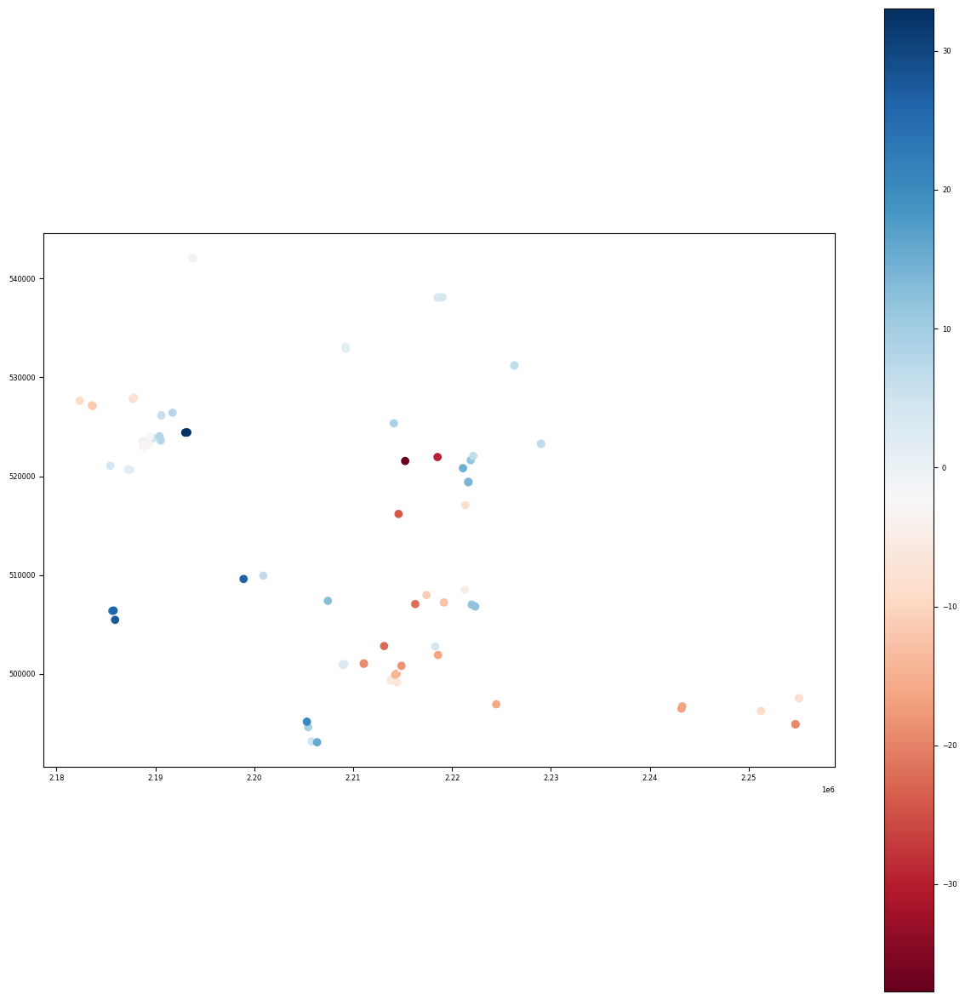

In [35]:
residual['residuals'] = residual['head'] - residual['elevation']
# Ensure that the dataframe is a geopandas dataframe
if not isinstance(residual, gpd.GeoDataFrame):
    residual = gpd.GeoDataFrame(residual, geometry=gpd.points_from_xy(residual.X, residual.Y))

# Plot residuals
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(1, 1, 1, aspect="equal")
residual.plot(column='residuals', ax=ax, legend=True, cmap='RdBu')

plt.show()

In [13]:
def prepare_point_df(gdf, elev_field):
    df = gdf.drop_duplicates(subset=["geometry"], keep='first')
    df["X"] = df.geometry.x
    df["Y"] = df.geometry.y
    df["elevation"] = df[elev_field]
    return df[["X", "Y", "elevation", "id1"]]


def find_anomaly(df, contamiation=0.01):
    features = df[["X", "Y", "elevation"]]

    clf = IsolationForest(contamination=contamiation)  # contamination is the proportion of outliers in the data set

    clf.fit(features)

    # Predict the anomalies in the data
    pred = clf.predict(features)

    # The prediction returns '1' for a normal point and '-1' for an anomaly
    df['anomaly'] = pred
    anomalies = df[df['anomaly'] == -1]
    normal = df[df['anomaly'] != -1]
    return anomalies, normal


def plot_anomaly(nm_df, anomal_df, labels=False):
    fig = plt.figure(figsize=(12, 12))
    ax = fig.add_subplot(1, 1, 1, aspect="equal")
    gen_df = pd.concat([nm_df, anomal_df])
    sc = ax.scatter(gen_df['X'], gen_df['Y'], c=gen_df['elevation'], cmap='viridis', label='Normal')
    ax.scatter(anomal_df['X'], anomal_df['Y'], c='red', label='Anomaly')

    if labels:
        for i in range(len(gen_df)):
            ax.annotate(gen_df['elevation'].iloc[i], (gen_df['X'].iloc[i], gen_df['Y'].iloc[i]))

    fig.colorbar(sc, ax=ax, label='Elevation')
    ax.legend()
    plt.show()

/usr/local/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


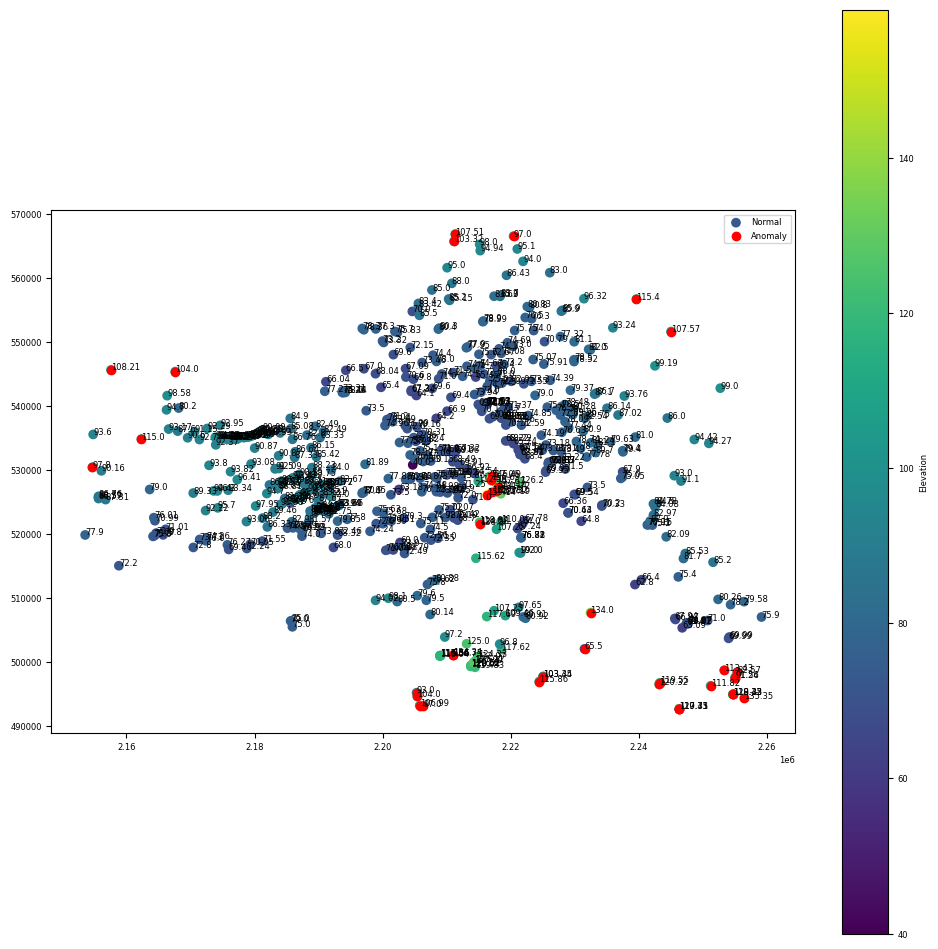

              X          Y  elevation  id1  anomaly
0    2197454.32  539228.58      73.50    0        1
1    2229008.95  523277.01      70.64    5        1
2    2228996.09  523280.31      70.43    6        1
3    2182334.94  527630.30      86.12    7        1
4    2183577.59  527161.58      89.09    8        1
..          ...        ...        ...  ...      ...
578  2221666.85  519416.20      76.81  625        1
579  2221663.49  519403.23      76.82  626        1
580  2221445.13  528026.92     126.20  627        1
581  2221352.29  517067.60     102.00  628        1
582  2221572.00  517001.79      99.00  629        1

[537 rows x 5 columns]


In [18]:
from sklearn.ensemble import IsolationForest
wells_wtd =  gpd.read_file("./sources/vector/well/MSK_52_well_regim_all_kopy.shp", crs=proj_string)
# wells_wtd = wells_wtd[wells_wtd["Data2"].isin(['2022', '2019'])]
result = prepare_point_df(wells_wtd, "Abs_Ugv_al")
anomaly, normal = find_anomaly(result, 0.07)
plot_anomaly(normal, anomaly, labels=True)
normal.to_csv("./sources/well_regime.csv", index=False)
print(normal)

([<matplotlib.axis.YTick at 0x7f91ba883310>,
 [Text(0, 64.0, '64'),
  Text(0, 74.0, '74'),
  Text(0, 84.0, '84'),
  Text(0, 94.0, '94'),
  Text(0, 104.0, '104'),
  Text(0, 114.0, '114'),
  Text(0, 124.0, '124'),
  Text(0, 134.0, '134')])

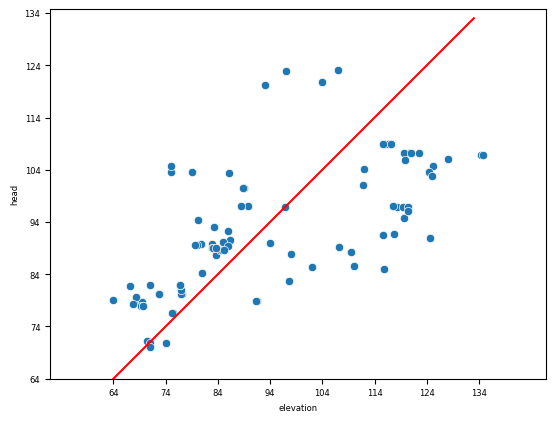

In [4]:
import seaborn as sns
import pandas as pd
import flopy
import numpy as np
# wells_wtd =  gpd.read_file("./sources/vector/well/MSK_52_well_regim_all_kopy.shp", crs=proj_string)
wells_wtd = pd.read_csv("./sources/well_regime.csv", delimiter=';')
wells_wtd = wells_wtd[["id1", "elevation", "X", "Y"]]
obsOut = flopy.utils.observationfile.Mf6Obs('./nncopy_model/nn.obs.head.csv', isBinary=False)
cmp_heads = pd.DataFrame(zip(list(obsOut.obsnames), list(obsOut.data.tolist())[0][1:]), columns=['well', 'head'])
cmp_heads["well"] = cmp_heads["well"].str.replace('H_','').astype(float)
wells_wtd["well"] = wells_wtd["id1"].astype(float)
residual = pd.merge(cmp_heads, wells_wtd, how="left", on="well")
residual['residuals'] = residual['head'] - residual['elevation']
# Ensure that the dataframe is a geopandas dataframe
if not isinstance(residual, gpd.GeoDataFrame):
    residual = gpd.GeoDataFrame(residual, geometry=gpd.points_from_xy(residual.X, residual.Y))
# residual = residual[residual["Data2"].isin(['2022', '2019'])]
sns.scatterplot(data=residual, x='elevation', y='head')

# Add a 45 degree line
x = range(int(min(residual['elevation'])), int(max(residual['elevation'])))
plt.plot(x, x, color='red')
plt.axis('equal')

min_val = min(residual['elevation'].min(), residual['head'].min())
max_val = max(residual['elevation'].max(), residual['head'].max())
ticks = np.arange(min_val, max_val, 10)  # Change step to whatever you need

plt.xlim(min_val, max_val)
plt.ylim(min_val, max_val)
plt.xticks(ticks)
plt.yticks(ticks)


In [15]:
org_model_ws = "./nncopy_model2/"
name = "nn"
sim = flopy.mf6.MFSimulation.load(sim_ws=org_model_ws, verbosity_level=0)
m = sim.get_model(name)

In [16]:
modelgrid = m.modelgrid

<a list of 34 text.Text objects>

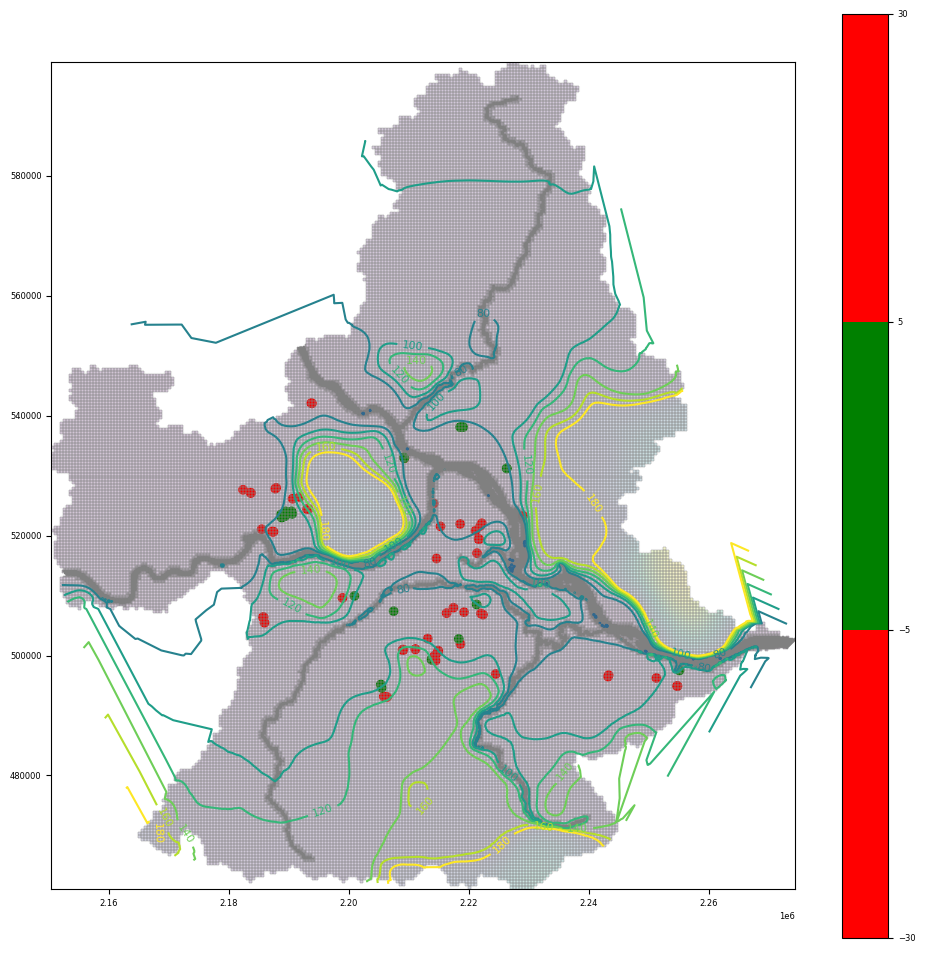

In [17]:
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib.colors import ListedColormap
headfile = f"{name}.hds"
fname = os.path.join(org_model_ws, headfile)
hds = flopy.utils.HeadFile(fname)
head = hds.get_data()
levels = np.arange(0, 200, 20)
fig = plt.figure(figsize=(12, 12))

ax = fig.add_subplot(1, 1, 1)
pmv = flopy.plot.PlotMapView(modelgrid=modelgrid, ax=ax)
pmv.plot_array(head, alpha=0.2)
pmv.plot_grid(alpha=0.2)
cmap = ListedColormap(['red', 'green', 'red'])
# Define a normalization from values -> colors
norm = colors.BoundaryNorm(boundaries=[-30, -5, 5, 30], ncolors=3)
residual.plot(column='residuals', ax=ax, legend=True, cmap=cmap, norm=norm)
contour = pmv.contour_array(head, levels=levels)
plt.clabel(contour, inline=True, fontsize=8, fmt='%1.0f')

# x, y = sgr.xycellcenters
# ax = fig.add_subplot(1, 1, 1, aspect="equal")
# heads = head[0]
# c = ax.contour(x, y, heads, np.arange(-200, 1000, 50), colors="black")
# plt.clabel(c, fmt="%2.1f")

MFDataException: An error occurred in data element "cell2d" model "gwf6" package "disv". The error occurred while getting data in the "_get_data" method.
Additional Information:
(1) An error occurred when storing data "cell2d" in a recarray. cell2d data is a one or two dimensional list containing the variables "<icell2d> <xc> <yc> <ncvert> <icvert_0> <icvert_1> <icvert_2> <icvert_3> <icvert_4> <icvert_5> <icvert_6> <icvert_7> <icvert_8>" (some variables may be optional, see MF6 documentation), but data "[(0, 2226620.32, 598766.959, 5, 0, 1, 2, 3, 0, None, None, None, None), (1, 2227120.32, 598766.959, 5, 1, 4, 5, 2, 1, None, None, None, None), (2, 2227620.32, 598766.959, 5, 4, 6, 7, 5, 4, None, None, None, None), (3, 2228120.32, 598766.959, 5, 6, 8, 9, 7, 6, None, None, None, None), (4, 2226620.32, 598266.959, 5, 3, 2, 10, 11, 3, None, None, None, None), (5, 2227120.32, 598266.959, 5, 2, 5, 12, 10, 2, None, None, None, None), (6, 2227620.32, 598266.959, 5, 5, 7, 13, 12, 5, None, None, None, None), (7, 2228120.32, 598266.959, 5, 7, 9, 14, 13, 7, None, None, None, None), (8, 2228620.32, 598266.959, 5, 9, 15, 16, 14, 9, None, None, None, None), (9, 2229120.32, 598266.959, 5, 15, 17, 18, 16, 15, None, None, None, None), (10, 2229620.32, 598266.959, 5, 17, 19, 20, 18, 17, None, None, None, None), (11, 2230620.32, 598266.959, 5, 21, 22, 23, 24, 21, None, None, None, None), (12, 2232120.32, 598266.959, 5, 25, 26, 27, 28, 25, None, None, None, None), (13, 2232620.32, 598266.959, 5, 26, 29, 30, 27, 26, None, None, None, None), (14, 2218620.32, 597766.959, 5, 31, 32, 33, 34, 31, None, None, None, None), (15, 2225620.32, 597766.959, 5, 35, 36, 37, 38, 35, None, None, None, None), (16, 2226120.32, 597766.959, 5, 36, 11, 39, 37, 36, None, None, None, None), (17, 2226620.32, 597766.959, 5, 11, 10, 40, 39, 11, None, None, None, None), (18, 2227120.32, 597766.959, 5, 10, 12, 41, 40, 10, None, None, None, None), (19, 2227620.32, 597766.959, 5, 12, 13, 42, 41, 12, None, None, None, None), (20, 2228120.32, 597766.959, 5, 13, 14, 43, 42, 13, None, None, None, None), (21, 2228620.32, 597766.959, 5, 14, 16, 44, 43, 14, None, None, None, None), (22, 2229120.32, 597766.959, 5, 16, 18, 45, 44, 16, None, None, None, None), (23, 2229620.32, 597766.959, 5, 18, 20, 46, 45, 18, None, None, None, None), (24, 2230120.32, 597766.959, 5, 20, 24, 47, 46, 20, None, None, None, None), (25, 2230620.32, 597766.959, 5, 24, 23, 48, 47, 24, None, None, None, None), (26, 2231120.32, 597766.959, 5, 23, 49, 50, 48, 23, None, None, None, None), (27, 2231620.32, 597766.959, 5, 49, 28, 51, 50, 49, None, None, None, None), (28, 2232120.32, 597766.959, 5, 28, 27, 52, 51, 28, None, None, None, None), (29, 2232620.32, 597766.959, 5, 27, 30, 53, 52, 27, None, None, None, None), (30, 2218620.32, 597266.959, 5, 34, 33, 54, 55, 34, None, None, None, None), (31, 2219120.32, 597266.959, 5, 33, 56, 57, 54, 33, None, None, None, None), (32, 2219620.32, 597266.959, 5, 56, 58, 59, 57, 56, None, None, None, None), (33, 2224620.32, 597266.959, 5, 60, 61, 62, 63, 60, None, None, None, None), (34, 2225120.32, 597266.959, 5, 61, 38, 64, 62, 61, None, None, None, None), (35, 2225620.32, 597266.959, 5, 38, 37, 65, 64, 38, None, None, None, None), (36, 2226120.32, 597266.959, 5, 37, 39, 66, 65, 37, None, None, None, None), (37, 2226620.32, 597266.959, 5, 39, 40, 67, 66, 39, None, None, None, None), (38, 2227120.32, 597266.959, 5, 40, 41, 68, 67, 40, None, None, None, None), (39, 2227620.32, 597266.959, 5, 41, 42, 69, 68, 41, None, None, None, None), (40, 2228120.32, 597266.959, 5, 42, 43, 70, 69, 42, None, None, None, None), (41, 2228620.32, 597266.959, 5, 43, 44, 71, 70, 43, None, None, None, None), (42, 2229120.32, 597266.959, 5, 44, 45, 72, 71, 44, None, None, None, None), (43, 2229620.32, 597266.959, 5, 45, 46, 73, 72, 45, None, None, None, None), (44, 2230120.32, 597266.959, 5, 46, 47, 74, 73, 46, None, None, None, None), (45, 2230620.32, 597266.959, 5, 47, 48, 75, 74, 47, None, None, None, None), (46, 2231120.32, 597266.959, 5, 48, 50, 76, 75, 48, None, None, None, None), (47, 2231620.32, 597266.959, 5, 50, 51, 77, 76, 50, None, None, None, None), (48, 2232120.32, 597266.959, 5, 51, 52, 78, 77, 51, None, None, None, None), (49, 2232620.32, 597266.959, 5, 52, 53, 79, 78, 52, None, None, None, None), (50, 2214620.32, 596766.959, 5, 80, 81, 82, 83, 80, None, None, None, None), (51, 2215120.32, 596766.959, 5, 81, 84, 85, 82, 81, None, None, None, None), (52, 2215620.32, 596766.959, 5, 84, 86, 87, 85, 84, None, None, None, None), (53, 2216120.32, 596766.959, 5, 86, 88, 89, 87, 86, None, None, None, None), (54, 2216620.32, 596766.959, 5, 88, 90, 91, 89, 88, None, None, None, None), (55, 2217620.32, 596766.959, 5, 92, 93, 94, 95, 92, None, None, None, None), (56, 2218120.32, 596766.959, 5, 93, 55, 96, 94, 93, None, None, None, None), (57, 2218620.32, 596766.959, 5, 55, 54, 97, 96, 55, None, None, None, None), (58, 2219120.32, 596766.959, 5, 54, 57, 98, 97, 54, None, None, None, None), (59, 2219620.32, 596766.959, 5, 57, 59, 99, 98, 57, None, None, None, None), (60, 2220120.32, 596766.959, 5, 59, 100, 101, 99, 59, None, None, None, None), (61, 2220620.32, 596766.959, 5, 100, 102, 103, 101, 100, None, None, None, None), (62, 2221120.32, 596766.959, 5, 102, 104, 105, 103, 102, None, None, None, None), (63, 2224620.32, 596766.959, 5, 63, 62, 106, 107, 63, None, None, None, None), (64, 2225120.32, 596766.959, 5, 62, 64, 108, 106, 62, None, None, None, None), (65, 2225620.32, 596766.959, 5, 64, 65, 109, 108, 64, None, None, None, None), (66, 2226120.32, 596766.959, 5, 65, 66, 110, 109, 65, None, None, None, None), (67, 2226620.32, 596766.959, 5, 66, 67, 111, 110, 66, None, None, None, None), (68, 2227120.32, 596766.959, 5, 67, 68, 112, 111, 67, None, None, None, None), (69, 2227620.32, 596766.959, 5, 68, 69, 113, 112, 68, None, None, None, None), (70, 2228120.32, 596766.959, 5, 69, 70, 114, 113, 69, None, None, None, None), (71, 2228620.32, 596766.959, 5, 70, 71, 115, 114, 70, None, None, None, None), (72, 2229120.32, 596766.959, 5, 71, 72, 116, 115, 71, None, None, None, None), (73, 2229620.32, 596766.959, 5, 72, 73, 117, 116, 72, None, None, None, None), (74, 2230120.32, 596766.959, 5, 73, 74, 118, 117, 73, None, None, None, None), (75, 2230620.32, 596766.959, 5, 74, 75, 119, 118, 74, None, None, None, None), (76, 2231120.32, 596766.959, 5, 75, 76, 120, 119, 75, None, None, None, None), (77, 2231620.32, 596766.959, 5, 76, 77, 121, 120, 76, None, None, None, None), (78, 2232120.32, 596766.959, 5, 77, 78, 122, 121, 77, None, None, None, None), (79, 2232620.32, 596766.959, 5, 78, 79, 123, 122, 78, None, None, None, None), (80, 2233120.32, 596766.959, 5, 79, 124, 125, 123, 79, None, None, None, None), (81, 2214620.32, 596266.959, 5, 83, 82, 126, 127, 83, None, None, None, None), (82, 2215120.32, 596266.959, 5, 82, 85, 128, 126, 82, None, None, None, None), (83, 2215620.32, 596266.959, 5, 85, 87, 129, 128, 85, None, None, None, None), (84, 2216120.32, 596266.959, 5, 87, 89, 130, 129, 87, None, None, None, None), (85, 2216620.32, 596266.959, 5, 89, 91, 131, 130, 89, None, None, None, None), (86, 2217120.32, 596266.959, 5, 91, 95, 132, 131, 91, None, None, None, None), (87, 2217620.32, 596266.959, 5, 95, 94, 133, 132, 95, None, None, None, None), (88, 2218120.32, 596266.959, 5, 94, 96, 134, 133, 94, None, None, None, None), (89, 2218620.32, 596266.959, 5, 96, 97, 135, 134, 96, None, None, None, None), (90, 2219120.32, 596266.959, 5, 97, 98, 136, 135, 97, None, None, None, None), (91, 2219620.32, 596266.959, 5, 98, 99, 137, 136, 98, None, None, None, None), (92, 2220120.32, 596266.959, 5, 99, 101, 138, 137, 99, None, None, None, None), (93, 2220620.32, 596266.959, 5, 101, 103, 139, 138, 101, None, None, None, None), (94, 2221120.32, 596266.959, 5, 103, 105, 140, 139, 103, None, None, None, None), (95, 2221620.32, 596266.959, 5, 105, 141, 142, 140, 105, None, None, None, None), (96, 2224620.32, 596266.959, 5, 107, 106, 143, 144, 107, None, None, None, None), (97, 2225120.32, 596266.959, 5, 106, 108, 145, 143, 106, None, None, None, None), (98, 2225620.32, 596266.959, 5, 108, 109, 146, 145, 108, None, None, None, None), (99, 2226120.32, 596266.959, 5, 109, 110, 147, 146, 109, None, None, None, None), (100, 2226620.32, 596266.959, 5, 110, 111, 148, 147, 110, None, None, None, None), (101, 2227120.32, 596266.959, 5, 111, 112, 149, 148, 111, None, None, None, None), (102, 2227620.32, 596266.959, 5, 112, 113, 150, 149, 112, None, None, None, None), (103, 2228120.32, 596266.959, 5, 113, 114, 151, 150, 113, None, None, None, None), (104, 2228620.32, 596266.959, 5, 114, 115, 152, 151, 114, None, None, None, None), (105, 2229120.32, 596266.959, 5, 115, 116, 153, 152, 115, None, None, None, None), (106, 2229620.32, 596266.959, 5, 116, 117, 154, 153, 116, None, None, None, None), (107, 2230120.32, 596266.959, 5, 117, 118, 155, 154, 117, None, None, None, None), (108, 2230620.32, 596266.959, 5, 118, 119, 156, 155, 118, None, None, None, None), (109, 2231120.32, 596266.959, 5, 119, 120, 157, 156, 119, None, None, None, None), (110, 2231620.32, 596266.959, 5, 120, 121, 158, 157, 120, None, None, None, None), (111, 2232120.32, 596266.959, 5, 121, 122, 159, 158, 121, None, None, None, None), (112, 2232620.32, 596266.959, 5, 122, 123, 160, 159, 122, None, None, None, None), (113, 2233120.32, 596266.959, 5, 123, 125, 161, 160, 123, None, None, None, None), (114, 2233620.32, 596266.959, 5, 125, 162, 163, 161, 125, None, None, None, None), (115, 2234120.32, 596266.959, 5, 162, 164, 165, 163, 162, None, None, None, None), (116, 2215120.32, 595766.959, 5, 126, 128, 166, 167, 126, None, None, None, None), (117, 2215620.32, 595766.959, 5, 128, 129, 168, 166, 128, None, None, None, None), (118, 2216120.32, 595766.959, 5, 129, 130, 169, 168, 129, None, None, None, None), (119, 2216620.32, 595766.959, 5, 130, 131, 170, 169, 130, None, None, None, None), (120, 2217120.32, 595766.959, 5, 131, 132, 171, 170, 131, None, None, None, None), (121, 2217620.32, 595766.959, 5, 132, 133, 172, 171, 132, None, None, None, None), (122, 2218120.32, 595766.959, 5, 133, 134, 173, 172, 133, None, None, None, None), (123, 2218620.32, 595766.959, 5, 134, 135, 174, 173, 134, None, None, None, None), (124, 2219120.32, 595766.959, 5, 135, 136, 175, 174, 135, None, None, None, None), (125, 2219620.32, 595766.959, 5, 136, 137, 176, 175, 136, None, None, None, None), (126, 2220120.32, 595766.959, 5, 137, 138, 177, 176, 137, None, None, None, None), (127, 2220620.32, 595766.959, 5, 138, 139, 178, 177, 138, None, None, None, None), (128, 2221120.32, 595766.959, 5, 139, 140, 179, 178, 139, None, None, None, None), (129, 2221620.32, 595766.959, 5, 140, 142, 180, 179, 140, None, None, None, None), (130, 2224620.32, 595766.959, 5, 144, 143, 181, 182, 144, None, None, None, None), (131, 2225120.32, 595766.959, 5, 143, 145, 183, 181, 143, None, None, None, None), (132, 2225620.32, 595766.959, 5, 145, 146, 184, 183, 145, None, None, None, None), (133, 2226120.32, 595766.959, 5, 146, 147, 185, 184, 146, None, None, None, None), (134, 2226620.32, 595766.959, 5, 147, 148, 186, 185, 147, None, None, None, None), (135, 2227120.32, 595766.959, 5, 148, 149, 187, 186, 148, None, None, None, None), (136, 2227620.32, 595766.959, 5, 149, 150, 188, 187, 149, None, None, None, None), (137, 2228120.32, 595766.959, 5, 150, 151, 189, 188, 150, None, None, None, None), (138, 2228620.32, 595766.959, 5, 151, 152, 190, 189, 151, None, None, None, None), (139, 2229120.32, 595766.959, 5, 152, 153, 191, 190, 152, None, None, None, None), (140, 2229620.32, 595766.959, 5, 153, 154, 192, 191, 153, None, None, None, None), (141, 2230120.32, 595766.959, 5, 154, 155, 193, 192, 154, None, None, None, None), (142, 2230620.32, 595766.959, 5, 155, 156, 194, 193, 155, None, None, None, None), (143, 2231120.32, 595766.959, 5, 156, 157, 195, 194, 156, None, None, None, None), (144, 2231620.32, 595766.959, 5, 157, 158, 196, 195, 157, None, None, None, None), (145, 2232120.32, 595766.959, 5, 158, 159, 197, 196, 158, None, None, None, None), (146, 2232620.32, 595766.959, 5, 159, 160, 198, 197, 159, None, None, None, None), (147, 2233120.32, 595766.959, 5, 160, 161, 199, 198, 160, None, None, None, None), (148, 2233620.32, 595766.959, 5, 161, 163, 200, 199, 161, None, None, None, None), (149, 2234120.32, 595766.959, 5, 163, 165, 201, 200, 163, None, None, None, None), (150, 2234620.32, 595766.959, 5, 165, 202, 203, 201, 165, None, None, None, None), (151, 2236120.32, 595766.959, 5, 204, 205, 206, 207, 204, None, None, None, None), (152, 2213620.32, 595266.959, 5, 208, 209, 210, 211, 208, None, None, None, None), (153, 2214120.32, 595266.959, 5, 209, 212, 213, 210, 209, None, None, None, None), (154, 2214620.32, 595266.959, 5, 212, 167, 214, 213, 212, None, None, None, None), (155, 2215120.32, 595266.959, 5, 167, 166, 215, 214, 167, None, None, None, None), (156, 2215620.32, 595266.959, 5, 166, 168, 216, 215, 166, None, None, None, None), (157, 2216120.32, 595266.959, 5, 168, 169, 217, 216, 168, None, None, None, None), (158, 2216620.32, 595266.959, 5, 169, 170, 218, 217, 169, None, None, None, None), (159, 2217120.32, 595266.959, 5, 170, 171, 219, 218, 170, None, None, None, None), (160, 2217620.32, 595266.959, 5, 171, 172, 220, 219, 171, None, None, None, None), (161, 2218120.32, 595266.959, 5, 172, 173, 221, 220, 172, None, None, None, None), (162, 2218620.32, 595266.959, 5, 173, 174, 222, 221, 173, None, None, None, None), (163, 2219120.32, 595266.959, 5, 174, 175, 223, 222, 174, None, None, None, None), (164, 2219620.32, 595266.959, 5, 175, 176, 224, 223, 175, None, None, None, None), (165, 2220120.32, 595266.959, 5, 176, 177, 225, 224, 176, None, None, None, None), (166, 2220620.32, 595266.959, 5, 177, 178, 226, 225, 177, None, None, None, None), (167, 2221120.32, 595266.959, 5, 178, 179, 227, 226, 178, None, None, None, None), (168, 2221620.32, 595266.959, 5, 179, 180, 228, 227, 179, None, None, None, None), (169, 2222120.32, 595266.959, 5, 180, 229, 230, 228, 180, None, None, None, None), (170, 2224620.32, 595266.959, 5, 182, 181, 231, 232, 182, None, None, None, None), (171, 2225120.32, 595266.959, 5, 181, 183, 233, 231, 181, None, None, None, None), (172, 2225620.32, 595266.959, 5, 183, 184, 234, 233, 183, None, None, None, None), (173, 2226120.32, 595266.959, 5, 184, 185, 235, 234, 184, None, None, None, None), (174, 2226620.32, 595266.959, 5, 185, 186, 236, 235, 185, None, None, None, None), (175, 2227120.32, 595266.959, 5, 186, 187, 237, 236, 186, None, None, None, None), (176, 2227620.32, 595266.959, 5, 187, 188, 238, 237, 187, None, None, None, None), (177, 2228120.32, 595266.959, 5, 188, 189, 239, 238, 188, None, None, None, None), (178, 2228620.32, 595266.959, 5, 189, 190, 240, 239, 189, None, None, None, None), (179, 2229120.32, 595266.959, 5, 190, 191, 241, 240, 190, None, None, None, None), (180, 2229620.32, 595266.959, 5, 191, 192, 242, 241, 191, None, None, None, None), (181, 2230120.32, 595266.959, 5, 192, 193, 243, 242, 192, None, None, None, None), (182, 2230620.32, 595266.959, 5, 193, 194, 244, 243, 193, None, None, None, None), (183, 2231120.32, 595266.959, 5, 194, 195, 245, 244, 194, None, None, None, None), (184, 2231620.32, 595266.959, 5, 195, 196, 246, 245, 195, None, None, None, None), (185, 2232120.32, 595266.959, 5, 196, 197, 247, 246, 196, None, None, None, None), (186, 2232620.32, 595266.959, 5, 197, 198, 248, 247, 197, None, None, None, None), (187, 2233120.32, 595266.959, 5, 198, 199, 249, 248, 198, None, None, None, None), (188, 2233620.32, 595266.959, 5, 199, 200, 250, 249, 199, None, None, None, None), (189, 2234120.32, 595266.959, 5, 200, 201, 251, 250, 200, None, None, None, None), (190, 2234620.32, 595266.959, 5, 201, 203, 252, 251, 201, None, None, None, None), (191, 2235120.32, 595266.959, 5, 203, 253, 254, 252, 203, None, None, None, None), (192, 2235620.32, 595266.959, 5, 253, 207, 255, 254, 253, None, None, None, None), (193, 2236120.32, 595266.959, 5, 207, 206, 256, 255, 207, None, None, None, None), (194, 2236620.32, 595266.959, 5, 206, 257, 258, 256, 206, None, None, None, None), (195, 2237120.32, 595266.959, 5, 257, 259, 260, 258, 257, None, None, None, None), (196, 2213120.32, 594766.959, 5, 261, 211, 262, 263, 261, None, None, None, None), (197, 2213620.32, 594766.959, 5, 211, 210, 264, 262, 211, None, None, None, None), (198, 2214120.32, 594766.959, 5, 210, 213, 265, 264, 210, None, None, None, None), (199, 2214620.32, 594766.959, 5, 213, 214, 266, 265, 213, None, None, None, None), (200, 2215120.32, 594766.959, 5, 214, 215, 267, 266, 214, None, None, None, None), (201, 2215620.32, 594766.959, 5, 215, 216, 268, 267, 215, None, None, None, None), (202, 2216120.32, 594766.959, 5, 216, 217, 269, 268, 216, None, None, None, None), (203, 2216620.32, 594766.959, 5, 217, 218, 270, 269, 217, None, None, None, None), (204, 2217120.32, 594766.959, 5, 218, 219, 271, 270, 218, None, None, None, None), (205, 2217620.32, 594766.959, 5, 219, 220, 272, 271, 219, None, None, None, None), (206, 2218120.32, 594766.959, 5, 220, 221, 273, 272, 220, None, None, None, None), (207, 2218620.32, 594766.959, 5, 221, 222, 274, 273, 221, None, None, None, None), (208, 2219120.32, 594766.959, 5, 222, 223, 275, 274, 222, None, None, None, None), (209, 2219620.32, 594766.959, 5, 223, 224, 276, 275, 223, None, None, None, None), (210, 2220120.32, 594766.959, 5, 224, 225, 277, 276, 224, None, None, None, None), (211, 2220620.32, 594766.959, 5, 225, 226, 278, 277, 225, None, None, None, None), (212, 2221120.32, 594766.959, 5, 226, 227, 279, 278, 226, None, None, None, None), (213, 2221620.32, 594766.959, 5, 227, 228, 280, 279, 227, None, None, None, None), (214, 2222120.32, 594766.959, 5, 228, 230, 281, 280, 228, None, None, None, None), (215, 2222620.32, 594766.959, 5, 230, 282, 283, 281, 230, None, None, None, None), (216, 2223120.32, 594766.959, 5, 282, 284, 285, 283, 282, None, None, None, None), (217, 2223620.32, 594766.959, 5, 284, 286, 287, 285, 284, None, None, None, None), (218, 2224120.32, 594766.959, 5, 286, 232, 288, 287, 286, None, None, None, None), (219, 2224620.32, 594766.959, 5, 232, 231, 289, 288, 232, None, None, None, None), (220, 2225120.32, 594766.959, 5, 231, 233, 290, 289, 231, None, None, None, None), (221, 2225620.32, 594766.959, 5, 233, 234, 291, 290, 233, None, None, None, None), (222, 2226120.32, 594766.959, 5, 234, 235, 292, 291, 234, None, None, None, None), (223, 2226620.32, 594766.959, 5, 235, 236, 293, 292, 235, None, None, None, None), (224, 2227120.32, 594766.959, 5, 236, 237, 294, 293, 236, None, None, None, None), (225, 2227620.32, 594766.959, 5, 237, 238, 295, 294, 237, None, None, None, None), (226, 2228120.32, 594766.959, 5, 238, 239, 296, 295, 238, None, None, None, None), (227, 2228620.32, 594766.959, 5, 239, 240, 297, 296, 239, None, None, None, None), (228, 2229120.32, 594766.959, 5, 240, 241, 298, 297, 240, None, None, None, None), (229, 2229620.32, 594766.959, 5, 241, 242, 299, 298, 241, None, None, None, None), (230, 2230120.32, 594766.959, 5, 242, 243, 300, 299, 242, None, None, None, None), (231, 2230620.32, 594766.959, 5, 243, 244, 301, 300, 243, None, None, None, None), (232, 2231120.32, 594766.959, 5, 244, 245, 302, 301, 244, None, None, None, None), (233, 2231620.32, 594766.959, 5, 245, 246, 303, 302, 245, None, None, None, None), (234, 2232120.32, 594766.959, 5, 246, 247, 304, 303, 246, None, None, None, None), (235, 2232620.32, 594766.959, 5, 247, 248, 305, 304, 247, None, None, None, None), (236, 2233120.32, 594766.959, 5, 248, 249, 306, 305, 248, None, None, None, None), (237, 2233620.32, 594766.959, 5, 249, 250, 307, 306, 249, None, None, None, None), (238, 2234120.32, 594766.959, 5, 250, 251, 308, 307, 250, None, None, None, None), (239, 2234620.32, 594766.959, 5, 251, 252, 309, 308, 251, None, None, None, None), (240, 2235120.32, 594766.959, 5, 252, 254, 310, 309, 252, None, None, None, None), (241, 2235620.32, 594766.959, 5, 254, 255, 311, 310, 254, None, None, None, None), (242, 2236120.32, 594766.959, 5, 255, 256, 312, 311, 255, None, None, None, None), (243, 2236620.32, 594766.959, 5, 256, 258, 313, 312, 256, None, None, None, None), (244, 2237120.32, 594766.959, 5, 258, 260, 314, 313, 258, None, None, None, None), (245, 2237620.32, 594766.959, 5, 260, 315, 316, 314, 260, None, None, None, None), (246, 2238120.32, 594766.959, 5, 315, 317, 318, 316, 315, None, None, None, None), (247, 2213120.32, 594266.959, 5, 263, 262, 319, 320, 263, None, None, None, None), (248, 2213620.32, 594266.959, 5, 262, 264, 321, 319, 262, None, None, None, None), (249, 2214120.32, 594266.959, 5, 264, 265, 322, 321, 264, None, None, None, None), (250, 2214620.32, 594266.959, 5, 265, 266, 323, 322, 265, None, None, None, None), (251, 2215120.32, 594266.959, 5, 266, 267, 324, 323, 266, None, None, None, None), (252, 2215620.32, 594266.959, 5, 267, 268, 325, 324, 267, None, None, None, None), (253, 2216120.32, 594266.959, 5, 268, 269, 326, 325, 268, None, None, None, None), (254, 2216620.32, 594266.959, 5, 269, 270, 327, 326, 269, None, None, None, None), (255, 2217120.32, 594266.959, 5, 270, 271, 328, 327, 270, None, None, None, None), (256, 2217620.32, 594266.959, 5, 271, 272, 329, 328, 271, None, None, None, None), (257, 2218120.32, 594266.959, 5, 272, 273, 330, 329, 272, None, None, None, None), (258, 2218620.32, 594266.959, 5, 273, 274, 331, 330, 273, None, None, None, None), (259, 2219120.32, 594266.959, 5, 274, 275, 332, 331, 274, None, None, None, None), (260, 2219620.32, 594266.959, 5, 275, 276, 333, 332, 275, None, None, None, None), (261, 2220120.32, 594266.959, 5, 276, 277, 334, 333, 276, None, None, None, None), (262, 2220620.32, 594266.959, 5, 277, 278, 335, 334, 277, None, None, None, None), (263, 2221120.32, 594266.959, 5, 278, 279, 336, 335, 278, None, None, None, None), (264, 2221620.32, 594266.959, 5, 279, 280, 337, 336, 279, None, None, None, None), (265, 2222120.32, 594266.959, 5, 280, 281, 338, 337, 280, None, None, None, None), (266, 2222620.32, 594266.959, 5, 281, 283, 339, 338, 281, None, None, None, None), (267, 2223120.32, 594266.959, 5, 283, 285, 340, 339, 283, None, None, None, None), (268, 2223620.32, 594266.959, 5, 285, 287, 341, 340, 285, None, None, None, None), (269, 2224120.32, 594266.959, 5, 287, 288, 342, 341, 287, None, None, None, None), (270, 2224620.32, 594266.959, 5, 288, 289, 343, 342, 288, None, None, None, None), (271, 2225120.32, 594266.959, 5, 289, 290, 344, 343, 289, None, None, None, None), (272, 2225620.32, 594266.959, 5, 290, 291, 345, 344, 290, None, None, None, None), (273, 2226120.32, 594266.959, 5, 291, 292, 346, 345, 291, None, None, None, None), (274, 2226620.32, 594266.959, 5, 292, 293, 347, 346, 292, None, None, None, None), (275, 2227120.32, 594266.959, 5, 293, 294, 348, 347, 293, None, None, None, None), (276, 2227620.32, 594266.959, 5, 294, 295, 349, 348, 294, None, None, None, None), (277, 2228120.32, 594266.959, 5, 295, 296, 350, 349, 295, None, None, None, None), (278, 2228620.32, 594266.959, 5, 296, 297, 351, 350, 296, None, None, None, None), (279, 2229120.32, 594266.959, 5, 297, 298, 352, 351, 297, None, None, None, None), (280, 2229620.32, 594266.959, 5, 298, 299, 353, 352, 298, None, None, None, None), (281, 2230120.32, 594266.959, 5, 299, 300, 354, 353, 299, None, None, None, None), (282, 2230620.32, 594266.959, 5, 300, 301, 355, 354, 300, None, None, None, None), (283, 2231120.32, 594266.959, 5, 301, 302, 356, 355, 301, None, None, None, None), (284, 2231620.32, 594266.959, 5, 302, 303, 357, 356, 302, None, None, None, None), (285, 2232120.32, 594266.959, 5, 303, 304, 358, 357, 303, None, None, None, None), (286, 2232620.32, 594266.959, 5, 304, 305, 359, 358, 304, None, None, None, None), (287, 2233120.32, 594266.959, 5, 305, 306, 360, 359, 305, None, None, None, None), (288, 2233620.32, 594266.959, 5, 306, 307, 361, 360, 306, None, None, None, None), (289, 2234120.32, 594266.959, 5, 307, 308, 362, 361, 307, None, None, None, None), (290, 2234620.32, 594266.959, 5, 308, 309, 363, 362, 308, None, None, None, None), (291, 2235120.32, 594266.959, 5, 309, 310, 364, 363, 309, None, None, None, None), (292, 2235620.32, 594266.959, 5, 310, 311, 365, 364, 310, None, None, None, None), (293, 2236120.32, 594266.959, 5, 311, 312, 366, 365, 311, None, None, None, None), (294, 2236620.32, 594266.959, 5, 312, 313, 367, 366, 312, None, None, None, None), (295, 2237120.32, 594266.959, 5, 313, 314, 368, 367, 313, None, None, None, None), (296, 2237620.32, 594266.959, 5, 314, 316, 369, 368, 314, None, None, None, None), (297, 2238120.32, 594266.959, 5, 316, 318, 370, 369, 316, None, None, None, None), (298, 2213120.32, 593766.959, 5, 320, 319, 371, 372, 320, None, None, None, None), (299, 2213620.32, 593766.959, 5, 319, 321, 373, 371, 319, None, None, None, None), (300, 2214120.32, 593766.959, 5, 321, 322, 374, 373, 321, None, None, None, None), (301, 2214620.32, 593766.959, 5, 322, 323, 375, 374, 322, None, None, None, None), (302, 2215120.32, 593766.959, 5, 323, 324, 376, 375, 323, None, None, None, None), (303, 2215620.32, 593766.959, 5, 324, 325, 377, 376, 324, None, None, None, None), (304, 2216120.32, 593766.959, 5, 325, 326, 378, 377, 325, None, None, None, None), (305, 2216620.32, 593766.959, 5, 326, 327, 379, 378, 326, None, None, None, None), (306, 2217120.32, 593766.959, 5, 327, 328, 380, 379, 327, None, None, None, None), (307, 2217620.32, 593766.959, 5, 328, 329, 381, 380, 328, None, None, None, None), (308, 2218120.32, 593766.959, 5, 329, 330, 382, 381, 329, None, None, None, None), (309, 2218620.32, 593766.959, 5, 330, 331, 383, 382, 330, None, None, None, None), (310, 2219120.32, 593766.959, 5, 331, 332, 384, 383, 331, None, None, None, None), (311, 2219620.32, 593766.959, 5, 332, 333, 385, 384, 332, None, None, None, None), (312, 2220120.32, 593766.959, 5, 333, 334, 386, 385, 333, None, None, None, None), (313, 2220620.32, 593766.959, 5, 334, 335, 387, 386, 334, None, None, None, None), (314, 2221120.32, 593766.959, 5, 335, 336, 388, 387, 335, None, None, None, None), (315, 2221620.32, 593766.959, 5, 336, 337, 389, 388, 336, None, None, None, None), (316, 2222120.32, 593766.959, 5, 337, 338, 390, 389, 337, None, None, None, None), (317, 2222620.32, 593766.959, 5, 338, 339, 391, 390, 338, None, None, None, None), (318, 2223120.32, 593766.959, 5, 339, 340, 392, 391, 339, None, None, None, None), (319, 2223620.32, 593766.959, 5, 340, 341, 393, 392, 340, None, None, None, None), (320, 2224120.32, 593766.959, 5, 341, 342, 394, 393, 341, None, None, None, None), (321, 2224620.32, 593766.959, 5, 342, 343, 395, 394, 342, None, None, None, None), (322, 2225120.32, 593766.959, 5, 343, 344, 396, 395, 343, None, None, None, None), (323, 2225620.32, 593766.959, 5, 344, 345, 397, 396, 344, None, None, None, None), (324, 2226120.32, 593766.959, 5, 345, 346, 398, 397, 345, None, None, None, None), (325, 2226620.32, 593766.959, 5, 346, 347, 399, 398, 346, None, None, None, None), (326, 2227120.32, 593766.959, 6, 347, 348, 400, 457, 399, 347, None, None, None), (327, 2227620.32, 593766.959, 6, 348, 349, 401, 463, 400, 348, None, None, None), (328, 2228120.32, 593766.959, 6, 349, 350, 402, 468, 401, 349, None, None, None), (329, 2228620.32, 593766.959, 5, 350, 351, 403, 402, 350, None, None, None, None), (330, 2229120.32, 593766.959, 5, 351, 352, 404, 403, 351, None, None, None, None), (331, 2229620.32, 593766.959, 5, 352, 353, 405, 404, 352, None, None, None, None), (332, 2230120.32, 593766.959, 5, 353, 354, 406, 405, 353, None, None, None, None), (333, 2230620.32, 593766.959, 5, 354, 355, 407, 406, 354, None, None, None, None), (334, 2231120.32, 593766.959, 5, 355, 356, 408, 407, 355, None, None, None, None), (335, 2231620.32, 593766.959, 5, 356, 357, 409, 408, 356, None, None, None, None), (336, 2232120.32, 593766.959, 5, 357, 358, 410, 409, 357, None, None, None, None), (337, 2232620.32, 593766.959, 5, 358, 359, 411, 410, 358, None, None, None, None), (338, 2233120.32, 593766.959, 5, 359, 360, 412, 411, 359, None, None, None, None), (339, 2233620.32, 593766.959, 5, 360, 361, 413, 412, 360, None, None, None, None), (340, 2234120.32, 593766.959, 5, 361, 362, 414, 413, 361, None, None, None, None), (341, 2234620.32, 593766.959, 5, 362, 363, 415, 414, 362, None, None, None, None), (342, 2235120.32, 593766.959, 5, 363, 364, 416, 415, 363, None, None, None, None), (343, 2235620.32, 593766.959, 5, 364, 365, 417, 416, 364, None, None, None, None), (344, 2236120.32, 593766.959, 5, 365, 366, 418, 417, 365, None, None, None, None), (345, 2236620.32, 593766.959, 5, 366, 367, 419, 418, 366, None, None, None, None), (346, 2237120.32, 593766.959, 5, 367, 368, 420, 419, 367, None, None, None, None), (347, 2237620.32, 593766.959, 5, 368, 369, 421, 420, 368, None, None, None, None), (348, 2211620.32, 593266.959, 5, 422, 423, 424, 425, 422, None, None, None, None), (349, 2212120.32, 593266.959, 5, 423, 426, 427, 424, 423, None, None, None, None), (350, 2212620.32, 593266.959, 5, 426, 372, 428, 427, 426, None, None, None, None), (351, 2213120.32, 593266.959, 5, 372, 371, 429, 428, 372, None, None, None, None), (352, 2213620.32, 593266.959, 5, 371, 373, 430, 429, 371, None, None, None, None), (353, 2214120.32, 593266.959, 5, 373, 374, 431, 430, 373, None, None, None, None), (354, 2214620.32, 593266.959, 5, 374, 375, 432, 431, 374, None, None, None, None), (355, 2215120.32, 593266.959, 5, 375, 376, 433, 432, 375, None, None, None, None), (356, 2215620.32, 593266.959, 5, 376, 377, 434, 433, 376, None, None, None, None), (357, 2216120.32, 593266.959, 5, 377, 378, 435, 434, 377, None, None, None, None), (358, 2216620.32, 593266.959, 5, 378, 379, 436, 435, 378, None, None, None, None), (359, 2217120.32, 593266.959, 5, 379, 380, 437, 436, 379, None, None, None, None), (360, 2217620.32, 593266.959, 5, 380, 381, 438, 437, 380, None, None, None, None), (361, 2218120.32, 593266.959, 5, 381, 382, 439, 438, 381, None, None, None, None), (362, 2218620.32, 593266.959, 5, 382, 383, 440, 439, 382, None, None, None, None), (363, 2219120.32, 593266.959, 5, 383, 384, 441, 440, 383, None, None, None, None), (364, 2219620.32, 593266.959, 5, 384, 385, 442, 441, 384, None, None, None, None), (365, 2220120.32, 593266.959, 5, 385, 386, 443, 442, 385, None, None, None, None), (366, 2220620.32, 593266.959, 5, 386, 387, 444, 443, 386, None, None, None, None), (367, 2221120.32, 593266.959, 5, 387, 388, 445, 444, 387, None, None, None, None), (368, 2221620.32, 593266.959, 5, 388, 389, 446, 445, 388, None, None, None, None), (369, 2222120.32, 593266.959, 5, 389, 390, 447, 446, 389, None, None, None, None), (370, 2222620.32, 593266.959, 5, 390, 391, 448, 447, 390, None, None, None, None), (371, 2223120.32, 593266.959, 5, 391, 392, 449, 448, 391, None, None, None, None), (372, 2223620.32, 593266.959, 5, 392, 393, 450, 449, 392, None, None, None, None), (373, 2224120.32, 593266.959, 5, 393, 394, 451, 450, 393, None, None, None, None), (374, 2224620.32, 593266.959, 5, 394, 395, 452, 451, 394, None, None, None, None), (375, 2225120.32, 593266.959, 5, 395, 396, 453, 452, 395, None, None, None, None), (376, 2225620.32, 593266.959, 6, 396, 397, 454, 528, 453, 396, None, None, None), (377, 2226120.32, 593266.959, 6, 397, 398, 455, 534, 454, 397, None, None, None), (378, 2226620.32, 593266.959, 7, 398, 399, 459, 456, 553, 455, 398, None, None), (379, 2226995.32, 593391.959, 5, 399, 457, 458, 459, 399, None, None, None, None), (380, 2227245.32, 593391.959, 5, 457, 400, 460, 458, 457, None, None, None, None), (381, 2226995.32, 593141.959, 6, 459, 458, 461, 582, 456, 459, None, None, None), (382, 2227245.32, 593141.959, 6, 458, 460, 462, 588, 461, 458, None, None, None), (383, 2227495.32, 593391.959, 5, 400, 463, 464, 460, 400, None, None, None, None), (384, 2227745.32, 593391.959, 5, 463, 401, 465, 464, 463, None, None, None, None), (385, 2227495.32, 593141.959, 6, 460, 464, 466, 621, 462, 460, None, None, None), (386, 2227745.32, 593141.959, 7, 464, 465, 473, 467, 635, 466, 464, None, None), (387, 2227995.32, 593391.959, 6, 401, 468, 469, 471, 465, 401, None, None, None), (388, 2228245.32, 593391.959, 5, 468, 402, 470, 469, 468, None, None, None, None), (389, 2227932.82, 593204.459, 5, 465, 471, 472, 473, 465, None, None, None, None), (390, 2228057.82, 593204.459, 5, 471, 469, 474, 472, 471, None, None, None, None), (391, 2227932.82, 593079.459, 6, 473, 472, 475, 659, 467, 473, None, None, None), (392, 2228057.82, 593079.459, 6, 472, 474, 476, 665, 475, 472, None, None, None), (393, 2228245.32, 593141.959, 7, 469, 470, 477, 675, 476, 474, 469, None, None), (394, 2228620.32, 593266.959, 7, 402, 403, 478, 685, 477, 470, 402, None, None), (395, 2229120.32, 593266.959, 5, 403, 404, 479, 478, 403, None, None, None, None), (396, 2229620.32, 593266.959, 5, 404, 405, 480, 479, 404, None, None, None, None), (397, 2230120.32, 593266.959, 5, 405, 406, 481, 480, 405, None, None, None, None), (398, 2230620.32, 593266.959, 5, 406, 407, 482, 481, 406, None, None, None, None), (399, 2231120.32, 593266.959, 5, 407, 408, 483, 482, 407, None, None, None, None), (400, 2231620.32, 593266.959, 5, 408, 409, 484, 483, 408, None, None, None, None), (401, 2232120.32, 593266.959, 5, 409, 410, 485, 484, 409, None, None, None, None), (402, 2232620.32, 593266.959, 5, 410, 411, 486, 485, 410, None, None, None, None), (403, 2233120.32, 593266.959, 5, 411, 412, 487, 486, 411, None, None, None, None), (404, 2233620.32, 593266.959, 5, 412, 413, 488, 487, 412, None, None, None, None), (405, 2234120.32, 593266.959, 5, 413, 414, 489, 488, 413, None, None, None, None), (406, 2234620.32, 593266.959, 5, 414, 415, 490, 489, 414, None, None, None, None), (407, 2235120.32, 593266.959, 5, 415, 416, 491, 490, 415, None, None, None, None), (408, 2235620.32, 593266.959, 5, 416, 417, 492, 491, 416, None, None, None, None), (409, 2236120.32, 593266.959, 5, 417, 418, 493, 492, 417, None, None, None, None), (410, 2236620.32, 593266.959, 5, 418, 419, 494, 493, 418, None, None, None, None), (411, 2237120.32, 593266.959, 5, 419, 420, 495, 494, 419, None, None, None, None), (412, 2237620.32, 593266.959, 5, 420, 421, 496, 495, 420, None, None, None, None), (413, 2211120.32, 592766.959, 5, 497, 425, 498, 499, 497, None, None, None, None), (414, 2211620.32, 592766.959, 5, 425, 424, 500, 498, 425, None, None, None, None), (415, 2212120.32, 592766.959, 5, 424, 427, 501, 500, 424, None, None, None, None), (416, 2212620.32, 592766.959, 5, 427, 428, 502, 501, 427, None, None, None, None), (417, 2213120.32, 592766.959, 5, 428, 429, 503, 502, 428, None, None, None, None), (418, 2213620.32, 592766.959, 5, 429, 430, 504, 503, 429, None, None, None, None), (419, 2214120.32, 592766.959, 5, 430, 431, 505, 504, 430, None, None, None, None), (420, 2214620.32, 592766.959, 5, 431, 432, 506, 505, 431, None, None, None, None), (421, 2215120.32, 592766.959, 5, 432, 433, 507, 506, 432, None, None, None, None), (422, 2215620.32, 592766.959, 5, 433, 434, 508, 507, 433, None, None, None, None), (423, 2216120.32, 592766.959, 5, 434, 435, 509, 508, 434, None, None, None, None), (424, 2216620.32, 592766.959, 5, 435, 436, 510, 509, 435, None, None, None, None), (425, 2217120.32, 592766.959, 5, 436, 437, 511, 510, 436, None, None, None, None), (426, 2217620.32, 592766.959, 5, 437, 438, 512, 511, 437, None, None, None, None), (427, 2218120.32, 592766.959, 5, 438, 439, 513, 512, 438, None, None, None, None), (428, 2218620.32, 592766.959, 5, 439, 440, 514, 513, 439, None, None, None, None), (429, 2219120.32, 592766.959, 5, 440, 441, 515, 514, 440, None, None, None, None), (430, 2219620.32, 592766.959, 5, 441, 442, 516, 515, 441, None, None, None, None), (431, 2220120.32, 592766.959, 5, 442, 443, 517, 516, 442, None, None, None, None), (432, 2220620.32, 592766.959, 5, 443, 444, 518, 517, 443, None, None, None, None), (433, 2221120.32, 592766.959, 5, 444, 445, 519, 518, 444, None, None, None, None), (434, 2221620.32, 592766.959, 5, 445, 446, 520, 519, 445, None, None, None, None), (435, 2222120.32, 592766.959, 5, 446, 447, 521, 520, 446, None, None, None, None), (436, 2222620.32, 592766.959, 5, 447, 448, 522, 521, 447, None, None, None, None), (437, 2223120.32, 592766.959, 5, 448, 449, 523, 522, 448, None, None, None, None), (438, 2223620.32, 592766.959, 6, 449, 450, 524, 734, 523, 449, None, None, None), (439, 2224120.32, 592766.959, 6, 450, 451, 525, 740, 524, 450, None, None, None), (440, 2224620.32, 592766.959, 6, 451, 452, 526, 754, 525, 451, None, None, None), (441, 2225120.32, 592766.959, 7, 452, 453, 530, 527, 767, 526, 452, None, None), (442, 2225495.32, 592891.959, 5, 453, 528, 529, 530, 453, None, None, None, None), (443, 2225745.32, 592891.959, 5, 528, 454, 531, 529, 528, None, None, None, None), (444, 2225495.32, 592641.959, 6, 530, 529, 532, 793, 527, 530, None, None, None), (445, 2225745.32, 592641.959, 7, 529, 531, 539, 533, 799, 532, 529, None, None), (446, 2225995.32, 592891.959, 6, 454, 534, 535, 537, 531, 454, None, None, None), (447, 2226245.32, 592891.959, 6, 534, 455, 536, 543, 535, 534, None, None, None), (448, 2225932.82, 592704.459, 5, 531, 537, 538, 539, 531, None, None, None, None), (449, 2226057.82, 592704.459, 5, 537, 535, 540, 538, 537, None, None, None, None), (450, 2225932.82, 592579.459, 6, 539, 538, 541, 836, 533, 539, None, None, None), (451, 2226057.82, 592579.459, 5, 538, 540, 542, 541, 538, None, None, None, None), (452, 2226182.82, 592704.459, 5, 535, 543, 544, 540, 535, None, None, None, None), (453, 2226307.82, 592704.459, 6, 543, 536, 545, 547, 544, 543, None, None, None), (454, 2226182.82, 592579.459, 7, 540, 544, 549, 546, 852, 542, 540, None, None), (455, 2226276.57, 592610.709, 5, 544, 547, 548, 549, 544, None, None, None, None), (456, 2226339.07, 592610.709, 5, 547, 545, 550, 548, 547, None, None, None, None), (457, 2226276.57, 592548.209, 5, 549, 548, 551, 546, 549, None, None, None, None), (458, 2226339.07, 592548.209, 5, 548, 550, 552, 551, 548, None, None, None, None), (459, 2226495.32, 592891.959, 6, 455, 553, 554, 556, 536, 455, None, None, None), (460, 2226745.32, 592891.959, 7, 553, 456, 584, 555, 569, 554, 553, None, None), (461, 2226432.82, 592704.459, 6, 536, 556, 557, 559, 545, 536, None, None, None), (462, 2226557.82, 592704.459, 6, 556, 554, 558, 564, 557, 556, None, None, None), (463, 2226401.57, 592610.709, 5, 545, 559, 560, 550, 545, None, None, None, None), (464, 2226464.07, 592610.709, 5, 559, 557, 561, 560, 559, None, None, None, None), (465, 2226401.57, 592548.209, 5, 550, 560, 562, 552, 550, None, None, None, None), (466, 2226464.07, 592548.209, 5, 560, 561, 563, 562, 560, None, None, None, None), (467, 2226526.57, 592610.709, 5, 557, 564, 565, 561, 557, None, None, None, None), (468, 2226589.07, 592610.709, 5, 564, 558, 566, 565, 564, None, None, None, None), (469, 2226526.57, 592548.209, 5, 561, 565, 567, 563, 561, None, None, None, None), (470, 2226589.07, 592548.209, 5, 565, 566, 568, 567, 565, None, None, None, None), (471, 2226682.82, 592704.459, 6, 554, 569, 570, 572, 558, 554, None, None, None), (472, 2226807.82, 592704.459, 7, 569, 555, 595, 571, 577, 570, 569, None, None), (473, 2226651.57, 592610.709, 5, 558, 572, 573, 566, 558, None, None, None, None), (474, 2226714.07, 592610.709, 5, 572, 570, 574, 573, 572, None, None, None, None), (475, 2226651.57, 592548.209, 5, 566, 573, 575, 568, 566, None, None, None, None), (476, 2226714.07, 592548.209, 5, 573, 574, 576, 575, 573, None, None, None, None), (477, 2226776.57, 592610.709, 5, 570, 577, 578, 574, 570, None, None, None, None), (478, 2226839.07, 592610.709, 5, 577, 571, 579, 578, 577, None, None, None, None), (479, 2226776.57, 592548.209, 5, 574, 578, 580, 576, 574, None, None, None, None), (480, 2226839.07, 592548.209, 5, 578, 579, 581, 580, 578, None, None, None, None), (481, 2226932.82, 592954.459, 5, 456, 582, 583, 584, 456, None, None, None, None), (482, 2227057.82, 592954.459, 5, 582, 461, 585, 583, 582, None, None, None, None), (483, 2226932.82, 592829.459, 6, 584, 583, 586, 593, 555, 584, None, None, None), (484, 2227057.82, 592829.459, 6, 583, 585, 587, 599, 586, 583, None, None, None), (485, 2227182.82, 592954.459, 5, 461, 588, 589, 585, 461, None, None, None, None), (486, 2227307.82, 592954.459, 5, 588, 462, 590, 589, 588, None, None, None, None), (487, 2227182.82, 592829.459, 6, 585, 589, 591, 609, 587, 585, None, None, None), (488, 2227307.82, 592829.459, 7, 589, 590, 626, 592, 614, 591, 589, None, None), (489, 2226901.57, 592735.709, 5, 555, 593, 594, 595, 555, None, None, None, None), (490, 2226964.07, 592735.709, 5, 593, 586, 596, 594, 593, None, None, None, None), (491, 2226901.57, 592673.209, 5, 595, 594, 597, 571, 595, None, None, None, None), (492, 2226964.07, 592673.209, 5, 594, 596, 598, 597, 594, None, None, None, None), (493, 2227026.57, 592735.709, 5, 586, 599, 600, 596, 586, None, None, None, None), (494, 2227089.07, 592735.709, 5, 599, 587, 601, 600, 599, None, None, None, None), (495, 2227026.57, 592673.209, 5, 596, 600, 602, 598, 596, None, None, None, None), (496, 2227089.07, 592673.209, 5, 600, 601, 603, 602, 600, None, None, None, None), (497, 2226901.57, 592610.709, 5, 571, 597, 604, 579, 571, None, None, None, None), (498, 2226964.07, 592610.709, 5, 597, 598, 605, 604, 597, None, None, None, None), (499, 2226901.57, 592548.209, 5, 579, 604, 606, 581, 579, None, None, None, None), (500, 2226964.07, 592548.209, 5, 604, 605, 607, 606, 604, None, None, None, None), (501, 2227057.82, 592579.459, 7, 598, 602, 603, 608, 607, 605, 598, None, None), (502, 2227151.57, 592735.709, 5, 587, 609, 610, 601, 587, None, None, None, None), (503, 2227214.07, 592735.709, 5, 609, 591, 611, 610, 609, None, None, None, None), (504, 2227151.57, 592673.209, 5, 601, 610, 612, 603, 601, None, None, None, None), (505, 2227214.07, 592673.209, 5, 610, 611, 613, 612, 610, None, None, None, None), (506, 2227276.57, 592735.709, 5, 591, 614, 615, 611, 591, None, None, None, None), (507, 2227339.07, 592735.709, 5, 614, 592, 616, 615, 614, None, None, None, None), (508, 2227276.57, 592673.209, 5, 611, 615, 617, 613, 611, None, None, None, None), (509, 2227339.07, 592673.209, 5, 615, 616, 618, 617, 615, None, None, None, None), (510, 2227182.82, 592579.459, 6, 603, 612, 613, 619, 608, 603, None, None, None), (511, 2227307.82, 592579.459, 6, 613, 617, 618, 620, 619, 613, None, None, None), (512, 2227432.82, 592954.459, 6, 462, 621, 622, 624, 590, 462, None, None, None), (513, 2227557.82, 592954.459, 6, 621, 466, 623, 630, 622, 621, None, None, None), (514, 2227401.57, 592860.709, 5, 590, 624, 625, 626, 590, None, None, None, None), (515, 2227464.07, 592860.709, 5, 624, 622, 627, 625, 624, None, None, None, None), (516, 2227401.57, 592798.209, 5, 626, 625, 628, 592, 626, None, None, None, None), (517, 2227464.07, 592798.209, 5, 625, 627, 629, 628, 625, None, None, None, None), (518, 2227526.57, 592860.709, 5, 622, 630, 631, 627, 622, None, None, None, None), (519, 2227589.07, 592860.709, 5, 630, 623, 632, 631, 630, None, None, None, None), (520, 2227526.57, 592798.209, 5, 627, 631, 633, 629, 627, None, None, None, None), (521, 2227589.07, 592798.209, 5, 631, 632, 634, 633, 631, None, None, None, None), (522, 2227682.82, 592954.459, 6, 466, 635, 636, 638, 623, 466, None, None, None), (523, 2227807.82, 592954.459, 7, 635, 467, 661, 637, 643, 636, 635, None, None), (524, 2227651.57, 592860.709, 5, 623, 638, 639, 632, 623, None, None, None, None), (525, 2227714.07, 592860.709, 5, 638, 636, 640, 639, 638, None, None, None, None), (526, 2227651.57, 592798.209, 5, 632, 639, 641, 634, 632, None, None, None, None), (527, 2227714.07, 592798.209, 5, 639, 640, 642, 641, 639, None, None, None, None), (528, 2227776.57, 592860.709, 5, 636, 643, 644, 640, 636, None, None, None, None), (529, 2227839.07, 592860.709, 5, 643, 637, 645, 644, 643, None, None, None, None), (530, 2227776.57, 592798.209, 5, 640, 644, 646, 642, 640, None, None, None, None), (531, 2227839.07, 592798.209, 5, 644, 645, 647, 646, 644, None, None, None, None), (532, 2227401.57, 592735.709, 5, 592, 628, 648, 616, 592, None, None, None, None), (533, 2227464.07, 592735.709, 5, 628, 629, 649, 648, 628, None, None, None, None), (534, 2227401.57, 592673.209, 5, 616, 648, 650, 618, 616, None, None, None, None), (535, 2227464.07, 592673.209, 5, 648, 649, 651, 650, 648, None, None, None, None), (536, 2227557.82, 592704.459, 7, 629, 633, 634, 652, 651, 649, 629, None, None), (537, 2227432.82, 592579.459, 6, 618, 650, 651, 653, 620, 618, None, None, None), (538, 2227557.82, 592579.459, 5, 651, 652, 654, 653, 651, None, None, None, None), (539, 2227682.82, 592704.459, 6, 634, 641, 642, 655, 652, 634, None, None, None), (540, 2227807.82, 592704.459, 6, 642, 646, 647, 656, 655, 642, None, None, None), (541, 2227682.82, 592579.459, 5, 652, 655, 657, 654, 652, None, None, None, None), (542, 2227807.82, 592579.459, 5, 655, 656, 658, 657, 655, None, None, None, None), (543, 2227901.57, 592985.709, 5, 467, 659, 660, 661, 467, None, None, None, None), (544, 2227964.07, 592985.709, 5, 659, 475, 662, 660, 659, None, None, None, None), (545, 2227901.57, 592923.209, 5, 661, 660, 663, 637, 661, None, None, None, None), (546, 2227964.07, 592923.209, 5, 660, 662, 664, 663, 660, None, None, None, None), (547, 2228026.57, 592985.709, 5, 475, 665, 666, 662, 475, None, None, None, None), (548, 2228089.07, 592985.709, 5, 665, 476, 667, 666, 665, None, None, None, None), (549, 2228026.57, 592923.209, 5, 662, 666, 668, 664, 662, None, None, None, None), (550, 2228089.07, 592923.209, 5, 666, 667, 669, 668, 666, None, None, None, None), (551, 2227901.57, 592860.709, 5, 637, 663, 670, 645, 637, None, None, None, None), (552, 2227964.07, 592860.709, 5, 663, 664, 671, 670, 663, None, None, None, None), (553, 2227901.57, 592798.209, 5, 645, 670, 672, 647, 645, None, None, None, None), (554, 2227964.07, 592798.209, 5, 670, 671, 673, 672, 670, None, None, None, None), (555, 2228057.82, 592829.459, 7, 664, 668, 669, 674, 673, 671, 664, None, None), (556, 2228182.82, 592954.459, 6, 476, 675, 676, 669, 667, 476, None, None, None), (557, 2228307.82, 592954.459, 5, 675, 477, 677, 676, 675, None, None, None, None), (558, 2228182.82, 592829.459, 5, 669, 676, 678, 674, 669, None, None, None, None), (559, 2228307.82, 592829.459, 5, 676, 677, 679, 678, 676, None, None, None, None), (560, 2227932.82, 592704.459, 6, 647, 672, 673, 680, 656, 647, None, None, None), (561, 2228057.82, 592704.459, 5, 673, 674, 681, 680, 673, None, None, None, None), (562, 2227932.82, 592579.459, 5, 656, 680, 682, 658, 656, None, None, None, None), (563, 2228057.82, 592579.459, 5, 680, 681, 683, 682, 680, None, None, None, None), (564, 2228245.32, 592641.959, 7, 674, 678, 679, 684, 683, 681, 674, None, None), (565, 2228495.32, 592891.959, 6, 477, 685, 686, 679, 677, 477, None, None, None), (566, 2228745.32, 592891.959, 5, 685, 478, 687, 686, 685, None, None, None, None), (567, 2228495.32, 592641.959, 5, 679, 686, 688, 684, 679, None, None, None, None), (568, 2228745.32, 592641.959, 5, 686, 687, 689, 688, 686, None, None, None, None), (569, 2229120.32, 592766.959, 6, 478, 479, 690, 689, 687, 478, None, None, None), (570, 2229620.32, 592766.959, 5, 479, 480, 691, 690, 479, None, None, None, None), (571, 2230120.32, 592766.959, 5, 480, 481, 692, 691, 480, None, None, None, None), (572, 2230620.32, 592766.959, 5, 481, 482, 693, 692, 481, None, None, None, None), (573, 2231120.32, 592766.959, 5, 482, 483, 694, 693, 482, None, None, None, None), (574, 2231620.32, 592766.959, 5, 483, 484, 695, 694, 483, None, None, None, None), (575, 2232120.32, 592766.959, 5, 484, 485, 696, 695, 484, None, None, None, None), (576, 2232620.32, 592766.959, 5, 485, 486, 697, 696, 485, None, None, None, None), (577, 2233120.32, 592766.959, 5, 486, 487, 698, 697, 486, None, None, None, None), (578, 2233620.32, 592766.959, 5, 487, 488, 699, 698, 487, None, None, None, None), (579, 2234120.32, 592766.959, 5, 488, 489, 700, 699, 488, None, None, None, None), (580, 2234620.32, 592766.959, 5, 489, 490, 701, 700, 489, None, None, None, None), (581, 2235120.32, 592766.959, 5, 490, 491, 702, 701, 490, None, None, None, None), (582, 2235620.32, 592766.959, 5, 491, 492, 703, 702, 491, None, None, None, None), (583, 2236120.32, 592766.959, 5, 492, 493, 704, 703, 492, None, None, None, None), (584, 2236620.32, 592766.959, 5, 493, 494, 705, 704, 493, None, None, None, None), (585, 2237120.32, 592766.959, 5, 494, 495, 706, 705, 494, None, None, None, None), (586, 2237620.32, 592766.959, 5, 495, 496, 707, 706, 495, None, None, None, None), (587, 2211120.32, 592266.959, 5, 499, 498, 708, 709, 499, None, None, None, None), (588, 2211620.32, 592266.959, 5, 498, 500, 710, 708, 498, None, None, None, None), (589, 2212120.32, 592266.959, 5, 500, 501, 711, 710, 500, None, None, None, None), (590, 2212620.32, 592266.959, 5, 501, 502, 712, 711, 501, None, None, None, None), (591, 2213120.32, 592266.959, 5, 502, 503, 713, 712, 502, None, None, None, None), (592, 2213620.32, 592266.959, 5, 503, 504, 714, 713, 503, None, None, None, None), (593, 2214120.32, 592266.959, 5, 504, 505, 715, 714, 504, None, None, None, None), (594, 2214620.32, 592266.959, 5, 505, 506, 716, 715, 505, None, None, None, None), (595, 2215120.32, 592266.959, 5, 506, 507, 717, 716, 506, None, None, None, None), (596, 2215620.32, 592266.959, 5, 507, 508, 718, 717, 507, None, None, None, None), (597, 2216120.32, 592266.959, 5, 508, 509, 719, 718, 508, None, None, None, None), (598, 2216620.32, 592266.959, 5, 509, 510, 720, 719, 509, None, None, None, None), (599, 2217120.32, 592266.959, 5, 510, 511, 721, 720, 510, None, None, None, None), (600, 2217620.32, 592266.959, 5, 511, 512, 722, 721, 511, None, None, None, None), (601, 2218120.32, 592266.959, 5, 512, 513, 723, 722, 512, None, None, None, None), (602, 2218620.32, 592266.959, 5, 513, 514, 724, 723, 513, None, None, None, None), (603, 2219120.32, 592266.959, 5, 514, 515, 725, 724, 514, None, None, None, None), (604, 2219620.32, 592266.959, 5, 515, 516, 726, 725, 515, None, None, None, None), (605, 2220120.32, 592266.959, 5, 516, 517, 727, 726, 516, None, None, None, None), (606, 2220620.32, 592266.959, 5, 517, 518, 728, 727, 517, None, None, None, None), (607, 2221120.32, 592266.959, 5, 518, 519, 729, 728, 518, None, None, None, None), (608, 2221620.32, 592266.959, 5, 519, 520, 730, 729, 519, None, None, None, None), (609, 2222120.32, 592266.959, 5, 520, 521, 731, 730, 520, None, None, None, None), (610, 2222620.32, 592266.959, 5, 521, 522, 732, 731, 521, None, None, None, None), (611, 2223120.32, 592266.959, 7, 522, 523, 736, 733, 941, 732, 522, None, None), (612, 2223495.32, 592391.959, 5, 523, 734, 735, 736, 523, None, None, None, None), (613, 2223745.32, 592391.959, 5, 734, 524, 737, 735, 734, None, None, None, None), (614, 2223495.32, 592141.959, 6, 736, 735, 738, 957, 733, 736, None, None, None), (615, 2223745.32, 592141.959, 7, 735, 737, 745, 739, 968, 738, 735, None, None), (616, 2223995.32, 592391.959, 6, 524, 740, 741, 743, 737, 524, None, None, None), (617, 2224245.32, 592391.959, 6, 740, 525, 742, 749, 741, 740, None, None, None), (618, 2223932.82, 592204.459, 5, 737, 743, 744, 745, 737, None, None, None, None), (619, 2224057.82, 592204.459, 5, 743, 741, 746, 744, 743, None, None, None, None), (620, 2223932.82, 592079.459, 5, 745, 744, 747, 739, 745, None, None, None, None), (621, 2224057.82, 592079.459, 6, 744, 746, 748, 1001, 747, 744, None, None, None), (622, 2224182.82, 592204.459, 5, 741, 749, 750, 746, 741, None, None, None, None), (623, 2224307.82, 592204.459, 5, 749, 742, 751, 750, 749, None, None, None, None), (624, 2224182.82, 592079.459, 6, 746, 750, 752, 1016, 748, 746, None, None, None), (625, 2224307.82, 592079.459, 6, 750, 751, 753, 1021, 752, 750, None, None, None), (626, 2224495.32, 592391.959, 6, 525, 754, 755, 757, 742, 525, None, None, None), (627, 2224745.32, 592391.959, 6, 754, 526, 756, 762, 755, 754, None, None, None), (628, 2224432.82, 592204.459, 5, 742, 757, 758, 751, 742, None, None, None, None), (629, 2224557.82, 592204.459, 5, 757, 755, 759, 758, 757, None, None, None, None), (630, 2224432.82, 592079.459, 6, 751, 758, 760, 1033, 753, 751, None, None, None), (631, 2224557.82, 592079.459, 6, 758, 759, 761, 1038, 760, 758, None, None, None), (632, 2224682.82, 592204.459, 5, 755, 762, 763, 759, 755, None, None, None, None), (633, 2224807.82, 592204.459, 5, 762, 756, 764, 763, 762, None, None, None, None), (634, 2224682.82, 592079.459, 6, 759, 763, 765, 1045, 761, 759, None, None, None), (635, 2224807.82, 592079.459, 6, 763, 764, 766, 1050, 765, 763, None, None, None), (636, 2224995.32, 592391.959, 6, 526, 767, 768, 770, 756, 526, None, None, None), (637, 2225245.32, 592391.959, 7, 767, 527, 795, 769, 780, 768, 767, None, None), (638, 2224932.82, 592204.459, 5, 756, 770, 771, 764, 756, None, None, None, None), (639, 2225057.82, 592204.459, 6, 770, 768, 772, 774, 771, 770, None, None, None), (640, 2224932.82, 592079.459, 7, 764, 771, 776, 773, 1059, 766, 764, None, None), (641, 2225026.57, 592110.709, 5, 771, 774, 775, 776, 771, None, None, None, None), (642, 2225089.07, 592110.709, 5, 774, 772, 777, 775, 774, None, None, None, None), (643, 2225026.57, 592048.209, 5, 776, 775, 778, 773, 776, None, None, None, None), (644, 2225089.07, 592048.209, 5, 775, 777, 779, 778, 775, None, None, None, None), (645, 2225182.82, 592204.459, 6, 768, 780, 781, 783, 772, 768, None, None, None), (646, 2225307.82, 592204.459, 6, 780, 769, 782, 788, 781, 780, None, None, None), (647, 2225151.57, 592110.709, 5, 772, 783, 784, 777, 772, None, None, None, None), (648, 2225214.07, 592110.709, 5, 783, 781, 785, 784, 783, None, None, None, None), (649, 2225151.57, 592048.209, 5, 777, 784, 786, 779, 777, None, None, None, None), (650, 2225214.07, 592048.209, 5, 784, 785, 787, 786, 784, None, None, None, None), (651, 2225276.57, 592110.709, 5, 781, 788, 789, 785, 781, None, None, None, None), (652, 2225339.07, 592110.709, 5, 788, 782, 790, 789, 788, None, None, None, None), (653, 2225276.57, 592048.209, 5, 785, 789, 791, 787, 785, None, None, None, None), (654, 2225339.07, 592048.209, 5, 789, 790, 792, 791, 789, None, None, None, None), (655, 2225432.82, 592454.459, 5, 527, 793, 794, 795, 527, None, None, None, None), (656, 2225557.82, 592454.459, 5, 793, 532, 796, 794, 793, None, None, None, None), (657, 2225432.82, 592329.459, 5, 795, 794, 797, 769, 795, None, None, None, None), (658, 2225557.82, 592329.459, 6, 794, 796, 804, 798, 797, 794, None, None, None), (659, 2225682.82, 592454.459, 6, 532, 799, 800, 802, 796, 532, None, None, None), (660, 2225807.82, 592454.459, 7, 799, 533, 838, 801, 808, 800, 799, None, None), (661, 2225651.57, 592360.709, 5, 796, 802, 803, 804, 796, None, None, None, None), (662, 2225714.07, 592360.709, 5, 802, 800, 805, 803, 802, None, None, None, None), (663, 2225651.57, 592298.209, 5, 804, 803, 806, 798, 804, None, None, None, None), (664, 2225714.07, 592298.209, 5, 803, 805, 807, 806, 803, None, None, None, None), (665, 2225776.57, 592360.709, 5, 800, 808, 809, 805, 800, None, None, None, None), (666, 2225839.07, 592360.709, 5, 808, 801, 810, 809, 808, None, None, None, None), (667, 2225776.57, 592298.209, 5, 805, 809, 811, 807, 805, None, None, None, None), (668, 2225839.07, 592298.209, 5, 809, 810, 812, 811, 809, None, None, None, None), (669, 2225432.82, 592204.459, 6, 769, 797, 813, 815, 782, 769, None, None, None), (670, 2225557.82, 592204.459, 7, 797, 798, 826, 814, 820, 813, 797, None, None), (671, 2225401.57, 592110.709, 5, 782, 815, 816, 790, 782, None, None, None, None), (672, 2225464.07, 592110.709, 5, 815, 813, 817, 816, 815, None, None, None, None), (673, 2225401.57, 592048.209, 5, 790, 816, 818, 792, 790, None, None, None, None), (674, 2225464.07, 592048.209, 5, 816, 817, 819, 818, 816, None, None, None, None), (675, 2225526.57, 592110.709, 5, 813, 820, 821, 817, 813, None, None, None, None), (676, 2225589.07, 592110.709, 5, 820, 814, 822, 821, 820, None, None, None, None), (677, 2225526.57, 592048.209, 5, 817, 821, 823, 819, 817, None, None, None, None), (678, 2225589.07, 592048.209, 5, 821, 822, 824, 823, 821, None, None, None, None), (679, 2225651.57, 592235.709, 5, 798, 806, 825, 826, 798, None, None, None, None), (680, 2225714.07, 592235.709, 5, 806, 807, 827, 825, 806, None, None, None, None), (681, 2225651.57, 592173.209, 5, 826, 825, 828, 814, 826, None, None, None, None), (682, 2225714.07, 592173.209, 5, 825, 827, 829, 828, 825, None, None, None, None), (683, 2225807.82, 592204.459, 7, 807, 811, 812, 830, 829, 827, 807, None, None), (684, 2225651.57, 592110.709, 5, 814, 828, 831, 822, 814, None, None, None, None), (685, 2225714.07, 592110.709, 5, 828, 829, 832, 831, 828, None, None, None, None), (686, 2225651.57, 592048.209, 5, 822, 831, 833, 824, 822, None, None, None, None), (687, 2225714.07, 592048.209, 5, 831, 832, 834, 833, 831, None, None, None, None), (688, 2225807.82, 592079.459, 6, 829, 830, 835, 834, 832, 829, None, None, None), (689, 2225901.57, 592485.709, 5, 533, 836, 837, 838, 533, None, None, None, None), (690, 2225964.07, 592485.709, 5, 836, 541, 839, 837, 836, None, None, None, None), (691, 2225901.57, 592423.209, 5, 838, 837, 840, 801, 838, None, None, None, None), (692, 2225964.07, 592423.209, 5, 837, 839, 841, 840, 837, None, None, None, None), (693, 2226057.82, 592454.459, 8, 541, 542, 854, 842, 847, 841, 839, 541, None), (694, 2225901.57, 592360.709, 5, 801, 840, 843, 810, 801, None, None, None, None), (695, 2225964.07, 592360.709, 5, 840, 841, 844, 843, 840, None, None, None, None), (696, 2225901.57, 592298.209, 5, 810, 843, 845, 812, 810, None, None, None, None), (697, 2225964.07, 592298.209, 5, 843, 844, 846, 845, 843, None, None, None, None), (698, 2226026.57, 592360.709, 5, 841, 847, 848, 844, 841, None, None, None, None), (699, 2226089.07, 592360.709, 5, 847, 842, 849, 848, 847, None, None, None, None), (700, 2226026.57, 592298.209, 5, 844, 848, 850, 846, 844, None, None, None, None), (701, 2226089.07, 592298.209, 5, 848, 849, 851, 850, 848, None, None, None, None), (702, 2226151.57, 592485.709, 5, 542, 852, 853, 854, 542, None, None, None, None), (703, 2226214.07, 592485.709, 5, 852, 546, 855, 853, 852, None, None, None, None), (704, 2226151.57, 592423.209, 5, 854, 853, 856, 842, 854, None, None, None, None), (705, 2226214.07, 592423.209, 5, 853, 855, 857, 856, 853, None, None, None, None), (706, 2226276.57, 592485.709, 5, 546, 551, 858, 855, 546, None, None, None, None), (707, 2226339.07, 592485.709, 5, 551, 552, 859, 858, 551, None, None, None, None), (708, 2226276.57, 592423.209, 5, 855, 858, 860, 857, 855, None, None, None, None), (709, 2226339.07, 592423.209, 5, 858, 859, 861, 860, 858, None, None, None, None), (710, 2226151.57, 592360.709, 5, 842, 856, 862, 849, 842, None, None, None, None), (711, 2226214.07, 592360.709, 5, 856, 857, 863, 862, 856, None, None, None, None), (712, 2226151.57, 592298.209, 5, 849, 862, 864, 851, 849, None, None, None, None), (713, 2226214.07, 592298.209, 5, 862, 863, 865, 864, 862, None, None, None, None), (714, 2226307.82, 592329.459, 7, 857, 860, 861, 866, 865, 863, 857, None, None), (715, 2225932.82, 592204.459, 6, 812, 845, 846, 867, 830, 812, None, None, None), (716, 2226057.82, 592204.459, 6, 846, 850, 851, 868, 867, 846, None, None, None), (717, 2225932.82, 592079.459, 5, 830, 867, 869, 835, 830, None, None, None, None), (718, 2226057.82, 592079.459, 5, 867, 868, 870, 869, 867, None, None, None, None), (719, 2226182.82, 592204.459, 6, 851, 864, 865, 871, 868, 851, None, None, None), (720, 2226307.82, 592204.459, 5, 865, 866, 872, 871, 865, None, None, None, None), (721, 2226182.82, 592079.459, 5, 868, 871, 873, 870, 868, None, None, None, None), (722, 2226307.82, 592079.459, 5, 871, 872, 874, 873, 871, None, None, None, None), (723, 2226432.82, 592454.459, 7, 552, 562, 563, 875, 861, 859, 552, None, None), (724, 2226557.82, 592454.459, 6, 563, 567, 568, 876, 875, 563, None, None, None), (725, 2226432.82, 592329.459, 5, 861, 875, 877, 866, 861, None, None, None, None), (726, 2226557.82, 592329.459, 5, 875, 876, 878, 877, 875, None, None, None, None), (727, 2226682.82, 592454.459, 6, 568, 575, 576, 879, 876, 568, None, None, None), (728, 2226807.82, 592454.459, 6, 576, 580, 581, 880, 879, 576, None, None, None), (729, 2226682.82, 592329.459, 5, 876, 879, 881, 878, 876, None, None, None, None), (730, 2226807.82, 592329.459, 5, 879, 880, 882, 881, 879, None, None, None, None), (731, 2226495.32, 592141.959, 7, 866, 877, 878, 883, 874, 872, 866, None, None), (732, 2226745.32, 592141.959, 6, 878, 881, 882, 884, 883, 878, None, None, None), (733, 2226932.82, 592454.459, 6, 581, 606, 607, 885, 880, 581, None, None, None), (734, 2227057.82, 592454.459, 5, 607, 608, 886, 885, 607, None, None, None, None), (735, 2226932.82, 592329.459, 5, 880, 885, 887, 882, 880, None, None, None, None), (736, 2227057.82, 592329.459, 5, 885, 886, 888, 887, 885, None, None, None, None), (737, 2227245.32, 592391.959, 7, 608, 619, 620, 889, 888, 886, 608, None, None), (738, 2226995.32, 592141.959, 6, 882, 887, 888, 890, 884, 882, None, None, None), (739, 2227245.32, 592141.959, 5, 888, 889, 891, 890, 888, None, None, None, None), (740, 2227495.32, 592391.959, 6, 620, 653, 654, 892, 889, 620, None, None, None), (741, 2227745.32, 592391.959, 6, 654, 657, 658, 893, 892, 654, None, None, None), (742, 2227495.32, 592141.959, 5, 889, 892, 894, 891, 889, None, None, None, None), (743, 2227745.32, 592141.959, 5, 892, 893, 895, 894, 892, None, None, None, None), (744, 2227995.32, 592391.959, 6, 658, 682, 683, 896, 893, 658, None, None, None), (745, 2228245.32, 592391.959, 5, 683, 684, 897, 896, 683, None, None, None, None), (746, 2227995.32, 592141.959, 5, 893, 896, 898, 895, 893, None, None, None, None), (747, 2228245.32, 592141.959, 5, 896, 897, 899, 898, 896, None, None, None, None), (748, 2228620.32, 592266.959, 7, 684, 688, 689, 900, 899, 897, 684, None, None), (749, 2229120.32, 592266.959, 5, 689, 690, 901, 900, 689, None, None, None, None), (750, 2229620.32, 592266.959, 5, 690, 691, 902, 901, 690, None, None, None, None), (751, 2230120.32, 592266.959, 5, 691, 692, 903, 902, 691, None, None, None, None), (752, 2230620.32, 592266.959, 5, 692, 693, 904, 903, 692, None, None, None, None), (753, 2231120.32, 592266.959, 5, 693, 694, 905, 904, 693, None, None, None, None), (754, 2231620.32, 592266.959, 5, 694, 695, 906, 905, 694, None, None, None, None), (755, 2232120.32, 592266.959, 5, 695, 696, 907, 906, 695, None, None, None, None), (756, 2232620.32, 592266.959, 5, 696, 697, 908, 907, 696, None, None, None, None), (757, 2233120.32, 592266.959, 5, 697, 698, 909, 908, 697, None, None, None, None), (758, 2233620.32, 592266.959, 5, 698, 699, 910, 909, 698, None, None, None, None), (759, 2234120.32, 592266.959, 5, 699, 700, 911, 910, 699, None, None, None, None), (760, 2234620.32, 592266.959, 5, 700, 701, 912, 911, 700, None, None, None, None), (761, 2235120.32, 592266.959, 5, 701, 702, 913, 912, 701, None, None, None, None), (762, 2235620.32, 592266.959, 5, 702, 703, 914, 913, 702, None, None, None, None), (763, 2236120.32, 592266.959, 5, 703, 704, 915, 914, 703, None, None, None, None), (764, 2211120.32, 591766.959, 5, 709, 708, 916, 917, 709, None, None, None, None), (765, 2211620.32, 591766.959, 5, 708, 710, 918, 916, 708, None, None, None, None), (766, 2212120.32, 591766.959, 5, 710, 711, 919, 918, 710, None, None, None, None), (767, 2212620.32, 591766.959, 5, 711, 712, 920, 919, 711, None, None, None, None), (768, 2213120.32, 591766.959, 5, 712, 713, 921, 920, 712, None, None, None, None), (769, 2213620.32, 591766.959, 5, 713, 714, 922, 921, 713, None, None, None, None), (770, 2214120.32, 591766.959, 5, 714, 715, 923, 922, 714, None, None, None, None), (771, 2214620.32, 591766.959, 5, 715, 716, 924, 923, 715, None, None, None, None), (772, 2215120.32, 591766.959, 5, 716, 717, 925, 924, 716, None, None, None, None), (773, 2215620.32, 591766.959, 5, 717, 718, 926, 925, 717, None, None, None, None), (774, 2216120.32, 591766.959, 5, 718, 719, 927, 926, 718, None, None, None, None), (775, 2216620.32, 591766.959, 5, 719, 720, 928, 927, 719, None, None, None, None), (776, 2217120.32, 591766.959, 5, 720, 721, 929, 928, 720, None, None, None, None), (777, 2217620.32, 591766.959, 5, 721, 722, 930, 929, 721, None, None, None, None), (778, 2218120.32, 591766.959, 5, 722, 723, 931, 930, 722, None, None, None, None), (779, 2218620.32, 591766.959, 5, 723, 724, 932, 931, 723, None, None, None, None), (780, 2219120.32, 591766.959, 5, 724, 725, 933, 932, 724, None, None, None, None), (781, 2219620.32, 591766.959, 5, 725, 726, 934, 933, 725, None, None, None, None), (782, 2220120.32, 591766.959, 5, 726, 727, 935, 934, 726, None, None, None, None), (783, 2220620.32, 591766.959, 5, 727, 728, 936, 935, 727, None, None, None, None), (784, 2221120.32, 591766.959, 5, 728, 729, 937, 936, 728, None, None, None, None), (785, 2221620.32, 591766.959, 5, 729, 730, 938, 937, 729, None, None, None, None), (786, 2222120.32, 591766.959, 5, 730, 731, 939, 938, 730, None, None, None, None), (787, 2222620.32, 591766.959, 7, 731, 732, 943, 940, 1138, 939, 731, None, None), (788, 2222995.32, 591891.959, 5, 732, 941, 942, 943, 732, None, None, None, None), (789, 2223245.32, 591891.959, 7, 941, 733, 959, 944, 946, 942, 941, None, None), (790, 2222995.32, 591641.959, 7, 943, 942, 948, 945, 1149, 940, 943, None, None), (791, 2223182.82, 591704.459, 5, 942, 946, 947, 948, 942, None, None, None, None), (792, 2223307.82, 591704.459, 6, 946, 944, 949, 951, 947, 946, None, None, None), (793, 2223182.82, 591579.459, 7, 948, 947, 953, 950, 1160, 945, 948, None, None), (794, 2223276.57, 591610.709, 5, 947, 951, 952, 953, 947, None, None, None, None), (795, 2223339.07, 591610.709, 5, 951, 949, 954, 952, 951, None, None, None, None), (796, 2223276.57, 591548.209, 5, 953, 952, 955, 950, 953, None, None, None, None), (797, 2223339.07, 591548.209, 5, 952, 954, 956, 955, 952, None, None, None, None), (798, 2223432.82, 591954.459, 5, 733, 957, 958, 959, 733, None, None, None, None), (799, 2223557.82, 591954.459, 6, 957, 738, 960, 962, 958, 957, None, None, None), (800, 2223432.82, 591829.459, 6, 959, 958, 964, 961, 944, 959, None, None, None), (801, 2223526.57, 591860.709, 5, 958, 962, 963, 964, 958, None, None, None, None), (802, 2223589.07, 591860.709, 5, 962, 960, 965, 963, 962, None, None, None, None), (803, 2223526.57, 591798.209, 5, 964, 963, 966, 961, 964, None, None, None, None), (804, 2223589.07, 591798.209, 5, 963, 965, 967, 966, 963, None, None, None, None), (805, 2223682.82, 591954.459, 6, 738, 968, 969, 971, 960, 738, None, None, None), (806, 2223807.82, 591954.459, 6, 968, 739, 970, 976, 969, 968, None, None, None), (807, 2223651.57, 591860.709, 5, 960, 971, 972, 965, 960, None, None, None, None), (808, 2223714.07, 591860.709, 5, 971, 969, 973, 972, 971, None, None, None, None), (809, 2223651.57, 591798.209, 5, 965, 972, 974, 967, 965, None, None, None, None), (810, 2223714.07, 591798.209, 5, 972, 973, 975, 974, 972, None, None, None, None), (811, 2223776.57, 591860.709, 5, 969, 976, 977, 973, 969, None, None, None, None), (812, 2223839.07, 591860.709, 5, 976, 970, 978, 977, 976, None, None, None, None), (813, 2223776.57, 591798.209, 5, 973, 977, 979, 975, 973, None, None, None, None), (814, 2223839.07, 591798.209, 5, 977, 978, 980, 979, 977, None, None, None, None), (815, 2223432.82, 591704.459, 7, 944, 961, 983, 981, 987, 949, 944, None, None), (816, 2223526.57, 591735.709, 5, 961, 966, 982, 983, 961, None, None, None, None), (817, 2223589.07, 591735.709, 5, 966, 967, 984, 982, 966, None, None, None, None), (818, 2223526.57, 591673.209, 5, 983, 982, 985, 981, 983, None, None, None, None), (819, 2223589.07, 591673.209, 5, 982, 984, 986, 985, 982, None, None, None, None), (820, 2223401.57, 591610.709, 5, 949, 987, 988, 954, 949, None, None, None, None), (821, 2223464.07, 591610.709, 5, 987, 981, 989, 988, 987, None, None, None, None), (822, 2223401.57, 591548.209, 5, 954, 988, 990, 956, 954, None, None, None, None), (823, 2223464.07, 591548.209, 5, 988, 989, 991, 990, 988, None, None, None, None), (824, 2223526.57, 591610.709, 5, 981, 985, 992, 989, 981, None, None, None, None), (825, 2223589.07, 591610.709, 5, 985, 986, 993, 992, 985, None, None, None, None), (826, 2223526.57, 591548.209, 5, 989, 992, 994, 991, 989, None, None, None, None), (827, 2223589.07, 591548.209, 5, 992, 993, 995, 994, 992, None, None, None, None), (828, 2223682.82, 591704.459, 7, 967, 974, 975, 996, 986, 984, 967, None, None), (829, 2223807.82, 591704.459, 6, 975, 979, 980, 997, 996, 975, None, None, None), (830, 2223682.82, 591579.459, 6, 986, 996, 998, 995, 993, 986, None, None, None), (831, 2223807.82, 591579.459, 5, 996, 997, 999, 998, 996, None, None, None, None), (832, 2223932.82, 591954.459, 7, 739, 747, 1003, 1000, 1007, 970, 739, None, None), (833, 2224026.57, 591985.709, 5, 747, 1001, 1002, 1003, 747, None, None, None, None), (834, 2224089.07, 591985.709, 5, 1001, 748, 1004, 1002, 1001, None, None, None, None), (835, 2224026.57, 591923.209, 5, 1003, 1002, 1005, 1000, 1003, None, None, None, None), (836, 2224089.07, 591923.209, 5, 1002, 1004, 1006, 1005, 1002, None, None, None, None), (837, 2223901.57, 591860.709, 5, 970, 1007, 1008, 978, 970, None, None, None, None), (838, 2223964.07, 591860.709, 5, 1007, 1000, 1009, 1008, 1007, None, None, None, None), (839, 2223901.57, 591798.209, 5, 978, 1008, 1010, 980, 978, None, None, None, None), (840, 2223964.07, 591798.209, 5, 1008, 1009, 1011, 1010, 1008, None, None, None, None), (841, 2224026.57, 591860.709, 5, 1000, 1005, 1012, 1009, 1000, None, None, None, None), (842, 2224089.07, 591860.709, 5, 1005, 1006, 1013, 1012, 1005, None, None, None, None), (843, 2224026.57, 591798.209, 5, 1009, 1012, 1014, 1011, 1009, None, None, None, None), (844, 2224089.07, 591798.209, 5, 1012, 1013, 1015, 1014, 1012, None, None, None, None), (845, 2224151.57, 591985.709, 5, 748, 1016, 1017, 1004, 748, None, None, None, None), (846, 2224214.07, 591985.709, 5, 1016, 752, 1018, 1017, 1016, None, None, None, None), (847, 2224151.57, 591923.209, 5, 1004, 1017, 1019, 1006, 1004, None, None, None, None), (848, 2224214.07, 591923.209, 5, 1017, 1018, 1020, 1019, 1017, None, None, None, None), (849, 2224276.57, 591985.709, 5, 752, 1021, 1022, 1018, 752, None, None, None, None), (850, 2224339.07, 591985.709, 5, 1021, 753, 1023, 1022, 1021, None, None, None, None), (851, 2224276.57, 591923.209, 5, 1018, 1022, 1024, 1020, 1018, None, None, None, None), (852, 2224339.07, 591923.209, 5, 1022, 1023, 1025, 1024, 1022, None, None, None, None), (853, 2224182.82, 591829.459, 7, 1006, 1019, 1020, 1026, 1015, 1013, 1006, None, None), (854, 2224307.82, 591829.459, 6, 1020, 1024, 1025, 1027, 1026, 1020, None, None, None), (855, 2223932.82, 591704.459, 6, 980, 1010, 1011, 1028, 997, 980, None, None, None), (856, 2224057.82, 591704.459, 6, 1011, 1014, 1015, 1029, 1028, 1011, None, None, None), (857, 2223932.82, 591579.459, 5, 997, 1028, 1030, 999, 997, None, None, None, None), (858, 2224057.82, 591579.459, 5, 1028, 1029, 1031, 1030, 1028, None, None, None, None), (859, 2224245.32, 591641.959, 7, 1015, 1026, 1027, 1032, 1031, 1029, 1015, None, None), (860, 2224401.57, 591985.709, 5, 753, 1033, 1034, 1023, 753, None, None, None, None), (861, 2224464.07, 591985.709, 5, 1033, 760, 1035, 1034, 1033, None, None, None, None), (862, 2224401.57, 591923.209, 5, 1023, 1034, 1036, 1025, 1023, None, None, None, None), (863, 2224464.07, 591923.209, 5, 1034, 1035, 1037, 1036, 1034, None, None, None, None), (864, 2224526.57, 591985.709, 5, 760, 1038, 1039, 1035, 760, None, None, None, None), (865, 2224589.07, 591985.709, 5, 1038, 761, 1040, 1039, 1038, None, None, None, None), (866, 2224526.57, 591923.209, 5, 1035, 1039, 1041, 1037, 1035, None, None, None, None), (867, 2224589.07, 591923.209, 5, 1039, 1040, 1042, 1041, 1039, None, None, None, None), (868, 2224432.82, 591829.459, 6, 1025, 1036, 1037, 1043, 1027, 1025, None, None, None), (869, 2224557.82, 591829.459, 6, 1037, 1041, 1042, 1044, 1043, 1037, None, None, None), (870, 2224651.57, 591985.709, 5, 761, 1045, 1046, 1040, 761, None, None, None, None), (871, 2224714.07, 591985.709, 5, 1045, 765, 1047, 1046, 1045, None, None, None, None), (872, 2224651.57, 591923.209, 5, 1040, 1046, 1048, 1042, 1040, None, None, None, None), (873, 2224714.07, 591923.209, 5, 1046, 1047, 1049, 1048, 1046, None, None, None, None), (874, 2224776.57, 591985.709, 5, 765, 1050, 1051, 1047, 765, None, None, None, None), (875, 2224839.07, 591985.709, 5, 1050, 766, 1052, 1051, 1050, None, None, None, None), (876, 2224776.57, 591923.209, 5, 1047, 1051, 1053, 1049, 1047, None, None, None, None), (877, 2224839.07, 591923.209, 5, 1051, 1052, 1054, 1053, 1051, None, None, None, None), (878, 2224682.82, 591829.459, 6, 1042, 1048, 1049, 1055, 1044, 1042, None, None, None), (879, 2224807.82, 591829.459, 6, 1049, 1053, 1054, 1056, 1055, 1049, None, None, None), (880, 2224495.32, 591641.959, 6, 1027, 1043, 1044, 1057, 1032, 1027, None, None, None), (881, 2224745.32, 591641.959, 6, 1044, 1055, 1056, 1058, 1057, 1044, None, None, None), (882, 2224901.57, 591985.709, 5, 766, 1059, 1060, 1052, 766, None, None, None, None), (883, 2224964.07, 591985.709, 5, 1059, 773, 1061, 1060, 1059, None, None, None, None), (884, 2224901.57, 591923.209, 5, 1052, 1060, 1062, 1054, 1052, None, None, None, None), (885, 2224964.07, 591923.209, 5, 1060, 1061, 1063, 1062, 1060, None, None, None, None), (886, 2225026.57, 591985.709, 5, 773, 778, 1064, 1061, 773, None, None, None, None), (887, 2225089.07, 591985.709, 5, 778, 779, 1065, 1064, 778, None, None, None, None), (888, 2225026.57, 591923.209, 5, 1061, 1064, 1066, 1063, 1061, None, None, None, None), (889, 2225089.07, 591923.209, 5, 1064, 1065, 1067, 1066, 1064, None, None, None, None), (890, 2224932.82, 591829.459, 6, 1054, 1062, 1063, 1068, 1056, 1054, None, None, None), (891, 2225057.82, 591829.459, 6, 1063, 1066, 1067, 1069, 1068, 1063, None, None, None), (892, 2225151.57, 591985.709, 5, 779, 786, 1070, 1065, 779, None, None, None, None), (893, 2225214.07, 591985.709, 5, 786, 787, 1071, 1070, 786, None, None, None, None), (894, 2225151.57, 591923.209, 5, 1065, 1070, 1072, 1067, 1065, None, None, None, None), (895, 2225214.07, 591923.209, 5, 1070, 1071, 1073, 1072, 1070, None, None, None, None), (896, 2225276.57, 591985.709, 5, 787, 791, 1074, 1071, 787, None, None, None, None), (897, 2225339.07, 591985.709, 5, 791, 792, 1075, 1074, 791, None, None, None, None), (898, 2225276.57, 591923.209, 5, 1071, 1074, 1076, 1073, 1071, None, None, None, None), (899, 2225339.07, 591923.209, 5, 1074, 1075, 1077, 1076, 1074, None, None, None, None), (900, 2225182.82, 591829.459, 6, 1067, 1072, 1073, 1078, 1069, 1067, None, None, None), (901, 2225307.82, 591829.459, 6, 1073, 1076, 1077, 1079, 1078, 1073, None, None, None), (902, 2224995.32, 591641.959, 6, 1056, 1068, 1069, 1080, 1058, 1056, None, None, None), (903, 2225245.32, 591641.959, 6, 1069, 1078, 1079, 1081, 1080, 1069, None, None, None), (904, 2225432.82, 591954.459, 7, 792, 818, 819, 1082, 1077, 1075, 792, None, None), (905, 2225557.82, 591954.459, 6, 819, 823, 824, 1083, 1082, 819, None, None, None), (906, 2225432.82, 591829.459, 5, 1077, 1082, 1084, 1079, 1077, None, None, None, None), (907, 2225557.82, 591829.459, 5, 1082, 1083, 1085, 1084, 1082, None, None, None, None), (908, 2225682.82, 591954.459, 6, 824, 833, 834, 1086, 1083, 824, None, None, None), (909, 2225807.82, 591954.459, 5, 834, 835, 1087, 1086, 834, None, None, None, None), (910, 2225682.82, 591829.459, 5, 1083, 1086, 1088, 1085, 1083, None, None, None, None), (911, 2225807.82, 591829.459, 5, 1086, 1087, 1089, 1088, 1086, None, None, None, None), (912, 2225495.32, 591641.959, 6, 1079, 1084, 1085, 1090, 1081, 1079, None, None, None), (913, 2225745.32, 591641.959, 6, 1085, 1088, 1089, 1091, 1090, 1085, None, None, None), (914, 2225995.32, 591891.959, 7, 835, 869, 870, 1092, 1089, 1087, 835, None, None), (915, 2226245.32, 591891.959, 6, 870, 873, 874, 1093, 1092, 870, None, None, None), (916, 2225995.32, 591641.959, 5, 1089, 1092, 1094, 1091, 1089, None, None, None, None), (917, 2226245.32, 591641.959, 5, 1092, 1093, 1095, 1094, 1092, None, None, None, None), (918, 2226620.32, 591766.959, 7, 874, 883, 884, 1096, 1095, 1093, 874, None, None), (919, 2227120.32, 591766.959, 6, 884, 890, 891, 1097, 1096, 884, None, None, None), (920, 2227620.32, 591766.959, 6, 891, 894, 895, 1098, 1097, 891, None, None, None), (921, 2228120.32, 591766.959, 6, 895, 898, 899, 1099, 1098, 895, None, None, None), (922, 2228620.32, 591766.959, 5, 899, 900, 1100, 1099, 899, None, None, None, None), (923, 2229120.32, 591766.959, 5, 900, 901, 1101, 1100, 900, None, None, None, None), (924, 2229620.32, 591766.959, 5, 901, 902, 1102, 1101, 901, None, None, None, None), (925, 2230120.32, 591766.959, 5, 902, 903, 1103, 1102, 902, None, None, None, None), (926, 2230620.32, 591766.959, 5, 903, 904, 1104, 1103, 903, None, None, None, None), (927, 2231120.32, 591766.959, 5, 904, 905, 1105, 1104, 904, None, None, None, None), (928, 2231620.32, 591766.959, 5, 905, 906, 1106, 1105, 905, None, None, None, None), (929, 2232120.32, 591766.959, 5, 906, 907, 1107, 1106, 906, None, None, None, None), (930, 2232620.32, 591766.959, 5, 907, 908, 1108, 1107, 907, None, None, None, None), (931, 2233120.32, 591766.959, 5, 908, 909, 1109, 1108, 908, None, None, None, None), (932, 2233620.32, 591766.959, 5, 909, 910, 1110, 1109, 909, None, None, None, None), (933, 2234120.32, 591766.959, 5, 910, 911, 1111, 1110, 910, None, None, None, None), (934, 2234620.32, 591766.959, 5, 911, 912, 1112, 1111, 911, None, None, None, None), (935, 2235120.32, 591766.959, 5, 912, 913, 1113, 1112, 912, None, None, None, None), (936, 2235620.32, 591766.959, 5, 913, 914, 1114, 1113, 913, None, None, None, None), (937, 2211620.32, 591266.959, 5, 916, 918, 1115, 1116, 916, None, None, None, None), (938, 2212120.32, 591266.959, 5, 918, 919, 1117, 1115, 918, None, None, None, None), (939, 2212620.32, 591266.959, 5, 919, 920, 1118, 1117, 919, None, None, None, None), (940, 2213120.32, 591266.959, 5, 920, 921, 1119, 1118, 920, None, None, None, None), (941, 2213620.32, 591266.959, 5, 921, 922, 1120, 1119, 921, None, None, None, None), (942, 2214120.32, 591266.959, 5, 922, 923, 1121, 1120, 922, None, None, None, None), (943, 2214620.32, 591266.959, 5, 923, 924, 1122, 1121, 923, None, None, None, None), (944, 2215120.32, 591266.959, 5, 924, 925, 1123, 1122, 924, None, None, None, None), (945, 2215620.32, 591266.959, 5, 925, 926, 1124, 1123, 925, None, None, None, None), (946, 2216120.32, 591266.959, 5, 926, 927, 1125, 1124, 926, None, None, None, None), (947, 2216620.32, 591266.959, 5, 927, 928, 1126, 1125, 927, None, None, None, None), (948, 2217120.32, 591266.959, 5, 928, 929, 1127, 1126, 928, None, None, None, None), (949, 2217620.32, 591266.959, 5, 929, 930, 1128, 1127, 929, None, None, None, None), (950, 2218120.32, 591266.959, 5, 930, 931, 1129, 1128, 930, None, None, None, None), (951, 2218620.32, 591266.959, 5, 931, 932, 1130, 1129, 931, None, None, None, None), (952, 2219120.32, 591266.959, 5, 932, 933, 1131, 1130, 932, None, None, None, None), (953, 2219620.32, 591266.959, 5, 933, 934, 1132, 1131, 933, None, None, None, None), (954, 2220120.32, 591266.959, 5, 934, 935, 1133, 1132, 934, None, None, None, None), (955, 2220620.32, 591266.959, 5, 935, 936, 1134, 1133, 935, None, None, None, None), (956, 2221120.32, 591266.959, 5, 936, 937, 1135, 1134, 936, None, None, None, None), (957, 2221620.32, 591266.959, 5, 937, 938, 1136, 1135, 937, None, None, None, None), (958, 2222120.32, 591266.959, 6, 938, 939, 1140, 1137, 1136, 938, None, None, None), (959, 2222495.32, 591391.959, 5, 939, 1138, 1139, 1140, 939, None, None, None, None), (960, 2222745.32, 591391.959, 7, 1138, 940, 1151, 1141, 1143, 1139, 1138, None, None), (961, 2222495.32, 591141.959, 6, 1140, 1139, 1145, 1142, 1137, 1140, None, None, None), (962, 2222682.82, 591204.459, 5, 1139, 1143, 1144, 1145, 1139, None, None, None, None), (963, 2222807.82, 591204.459, 6, 1143, 1141, 1177, 1146, 1144, 1143, None, None, None), (964, 2222682.82, 591079.459, 5, 1145, 1144, 1147, 1142, 1145, None, None, None, None), (965, 2222807.82, 591079.459, 6, 1144, 1146, 1186, 1148, 1147, 1144, None, None, None), (966, 2222932.82, 591454.459, 5, 940, 1149, 1150, 1151, 940, None, None, None, None), (967, 2223057.82, 591454.459, 7, 1149, 945, 1162, 1152, 1154, 1150, 1149, None, None), (968, 2222932.82, 591329.459, 7, 1151, 1150, 1156, 1153, 1175, 1141, 1151, None, None), (969, 2223026.57, 591360.709, 5, 1150, 1154, 1155, 1156, 1150, None, None, None, None), (970, 2223089.07, 591360.709, 5, 1154, 1152, 1157, 1155, 1154, None, None, None, None), (971, 2223026.57, 591298.209, 5, 1156, 1155, 1158, 1153, 1156, None, None, None, None), (972, 2223089.07, 591298.209, 5, 1155, 1157, 1159, 1158, 1155, None, None, None, None), (973, 2223151.57, 591485.709, 5, 945, 1160, 1161, 1162, 945, None, None, None, None), (974, 2223214.07, 591485.709, 5, 1160, 950, 1163, 1161, 1160, None, None, None, None), (975, 2223151.57, 591423.209, 5, 1162, 1161, 1164, 1152, 1162, None, None, None, None), (976, 2223214.07, 591423.209, 5, 1161, 1163, 1165, 1164, 1161, None, None, None, None), (977, 2223276.57, 591485.709, 5, 950, 955, 1166, 1163, 950, None, None, None, None), (978, 2223339.07, 591485.709, 5, 955, 956, 1167, 1166, 955, None, None, None, None), (979, 2223276.57, 591423.209, 5, 1163, 1166, 1168, 1165, 1163, None, None, None, None), (980, 2223339.07, 591423.209, 5, 1166, 1167, 1169, 1168, 1166, None, None, None, None), (981, 2223151.57, 591360.709, 5, 1152, 1164, 1170, 1157, 1152, None, None, None, None), (982, 2223214.07, 591360.709, 5, 1164, 1165, 1171, 1170, 1164, None, None, None, None), (983, 2223151.57, 591298.209, 5, 1157, 1170, 1172, 1159, 1157, None, None, None, None), (984, 2223214.07, 591298.209, 5, 1170, 1171, 1173, 1172, 1170, None, None, None, None), (985, 2223307.82, 591329.459, 7, 1165, 1168, 1169, 1174, 1173, 1171, 1165, None, None), (986, 2222901.57, 591235.709, 5, 1141, 1175, 1176, 1177, 1141, None, None, None, None), (987, 2222964.07, 591235.709, 5, 1175, 1153, 1178, 1176, 1175, None, None, None, None), (988, 2222901.57, 591173.209, 5, 1177, 1176, 1179, 1146, 1177, None, None, None, None), (989, 2222964.07, 591173.209, 5, 1176, 1178, 1180, 1179, 1176, None, None, None, None), (990, 2223026.57, 591235.709, 5, 1153, 1158, 1181, 1178, 1153, None, None, None, None), (991, 2223089.07, 591235.709, 5, 1158, 1159, 1182, 1181, 1158, None, None, None, None), (992, 2223026.57, 591173.209, 5, 1178, 1181, 1183, 1180, 1178, None, None, None, None), (993, 2223089.07, 591173.209, 5, 1181, 1182, 1184, 1183, 1181, None, None, None, None), (994, 2222901.57, 591110.709, 5, 1146, 1179, 1185, 1186, 1146, None, None, None, None), (995, 2222964.07, 591110.709, 5, 1179, 1180, 1187, 1185, 1179, None, None, None, None), (996, 2222901.57, 591048.209, 5, 1186, 1185, 1188, 1148, 1186, None, None, None, None), (997, 2222964.07, 591048.209, 5, 1185, 1187, 1189, 1188, 1185, None, None, None, None), (998, 2223026.57, 591110.709, 5, 1180, 1183, 1190, 1187, 1180, None, None, None, None), (999, 2223089.07, 591110.709, 5, 1183, 1184, 1191, 1190, 1183, None, None, None, None), (1000, 2223026.57, 591048.209, 5, 1187, 1190, 1192, 1189, 1187, None, None, None, None), (1001, 2223089.07, 591048.209, 5, 1190, 1191, 1193, 1192, 1190, None, None, None, None), (1002, 2223182.82, 591204.459, 7, 1159, 1172, 1173, 1194, 1184, 1182, 1159, None, None), (1003, 2223307.82, 591204.459, 5, 1173, 1174, 1195, 1194, 1173, None, None, None, None), (1004, 2223182.82, 591079.459, 6, 1184, 1194, 1196, 1193, 1191, 1184, None, None, None), (1005, 2223307.82, 591079.459, 5, 1194, 1195, 1197, 1196, 1194, None, None, None, None), (1006, 2223432.82, 591454.459, 7, 956, 990, 991, 1198, 1169, 1167, 956, None, None), (1007, 2223557.82, 591454.459, 6, 991, 994, 995, 1199, 1198, 991, None, None, None), (1008, 2223432.82, 591329.459, 5, 1169, 1198, 1200, 1174, 1169, None, None, None, None), (1009, 2223557.82, 591329.459, 5, 1198, 1199, 1201, 1200, 1198, None, None, None, None), (1010, 2223745.32, 591391.959, 7, 995, 998, 999, 1202, 1201, 1199, 995, None, None), (1011, 2223495.32, 591141.959, 7, 1174, 1200, 1201, 1203, 1197, 1195, 1174, None, None), (1012, 2223745.32, 591141.959, 5, 1201, 1202, 1204, 1203, 1201, None, None, None, None), (1013, 2223995.32, 591391.959, 6, 999, 1030, 1031, 1205, 1202, 999, None, None, None), (1014, 2224245.32, 591391.959, 5, 1031, 1032, 1206, 1205, 1031, None, None, None, None), (1015, 2223995.32, 591141.959, 5, 1202, 1205, 1207, 1204, 1202, None, None, None, None), (1016, 2224245.32, 591141.959, 5, 1205, 1206, 1208, 1207, 1205, None, None, None, None), (1017, 2224620.32, 591266.959, 7, 1032, 1057, 1058, 1209, 1208, 1206, 1032, None, None), (1018, 2225120.32, 591266.959, 6, 1058, 1080, 1081, 1210, 1209, 1058, None, None, None), (1019, 2225620.32, 591266.959, 6, 1081, 1090, 1091, 1211, 1210, 1081, None, None, None), (1020, 2226120.32, 591266.959, 6, 1091, 1094, 1095, 1212, 1211, 1091, None, None, None), (1021, 2226620.32, 591266.959, 5, 1095, 1096, 1213, 1212, 1095, None, None, None, None), (1022, 2227120.32, 591266.959, 5, 1096, 1097, 1214, 1213, 1096, None, None, None, None), (1023, 2227620.32, 591266.959, 5, 1097, 1098, 1215, 1214, 1097, None, None, None, None), (1024, 2228120.32, 591266.959, 5, 1098, 1099, 1216, 1215, 1098, None, None, None, None), (1025, 2228620.32, 591266.959, 5, 1099, 1100, 1217, 1216, 1099, None, None, None, None), (1026, 2229120.32, 591266.959, 5, 1100, 1101, 1218, 1217, 1100, None, None, None, None), (1027, 2229620.32, 591266.959, 5, 1101, 1102, 1219, 1218, 1101, None, None, None, None), (1028, 2230120.32, 591266.959, 5, 1102, 1103, 1220, 1219, 1102, None, None, None, None), (1029, 2230620.32, 591266.959, 5, 1103, 1104, 1221, 1220, 1103, None, None, None, None), (1030, 2231120.32, 591266.959, 5, 1104, 1105, 1222, 1221, 1104, None, None, None, None), (1031, 2231620.32, 591266.959, 5, 1105, 1106, 1223, 1222, 1105, None, None, None, None), (1032, 2232120.32, 591266.959, 5, 1106, 1107, 1224, 1223, 1106, None, None, None, None), (1033, 2232620.32, 591266.959, 5, 1107, 1108, 1225, 1224, 1107, None, None, None, None), (1034, 2233120.32, 591266.959, 5, 1108, 1109, 1226, 1225, 1108, None, None, None, None), (1035, 2233620.32, 591266.959, 5, 1109, 1110, 1227, 1226, 1109, None, None, None, None), (1036, 2234120.32, 591266.959, 5, 1110, 1111, 1228, 1227, 1110, None, None, None, None), (1037, 2234620.32, 591266.959, 5, 1111, 1112, 1229, 1228, 1111, None, None, None, None), (1038, 2235120.32, 591266.959, 5, 1112, 1113, 1230, 1229, 1112, None, None, None, None), (1039, 2235620.32, 591266.959, 5, 1113, 1114, 1231, 1230, 1113, None, None, None, None), (1040, 2212120.32, 590766.959, 5, 1115, 1117, 1232, 1233, 1115, None, None, None, None), (1041, 2212620.32, 590766.959, 5, 1117, 1118, 1234, 1232, 1117, None, None, None, None), (1042, 2213120.32, 590766.959, 5, 1118, 1119, 1235, 1234, 1118, None, None, None, None), (1043, 2213620.32, 590766.959, 5, 1119, 1120, 1236, 1235, 1119, None, None, None, None), (1044, 2214120.32, 590766.959, 5, 1120, 1121, 1237, 1236, 1120, None, None, None, None), (1045, 2214620.32, 590766.959, 5, 1121, 1122, 1238, 1237, 1121, None, None, None, None), (1046, 2215120.32, 590766.959, 5, 1122, 1123, 1239, 1238, 1122, None, None, None, None), (1047, 2215620.32, 590766.959, 5, 1123, 1124, 1240, 1239, 1123, None, None, None, None), (1048, 2216120.32, 590766.959, 5, 1124, 1125, 1241, 1240, 1124, None, None, None, None), (1049, 2216620.32, 590766.959, 5, 1125, 1126, 1242, 1241, 1125, None, None, None, None), (1050, 2217120.32, 590766.959, 5, 1126, 1127, 1243, 1242, 1126, None, None, None, None), (1051, 2217620.32, 590766.959, 5, 1127, 1128, 1244, 1243, 1127, None, None, None, None), (1052, 2218120.32, 590766.959, 5, 1128, 1129, 1245, 1244, 1128, None, None, None, None), (1053, 2218620.32, 590766.959, 5, 1129, 1130, 1246, 1245, 1129, None, None, None, None), (1054, 2219120.32, 590766.959, 5, 1130, 1131, 1247, 1246, 1130, None, None, None, None), (1055, 2219620.32, 590766.959, 5, 1131, 1132, 1248, 1247, 1131, None, None, None, None), (1056, 2220120.32, 590766.959, 5, 1132, 1133, 1249, 1248, 1132, None, None, None, None), (1057, 2220620.32, 590766.959, 5, 1133, 1134, 1250, 1249, 1133, None, None, None, None), (1058, 2221120.32, 590766.959, 5, 1134, 1135, 1251, 1250, 1134, None, None, None, None), (1059, 2221620.32, 590766.959, 5, 1135, 1136, 1252, 1251, 1135, None, None, None, None), (1060, 2222120.32, 590766.959, 6, 1136, 1137, 1255, 1253, 1252, 1136, None, None, None), (1061, 2222495.32, 590891.959, 5, 1137, 1142, 1254, 1255, 1137, None, None, None, None), (1062, 2222745.32, 590891.959, 7, 1142, 1147, 1148, 1260, 1256, 1254, 1142, None, None), (1063, 2222495.32, 590641.959, 5, 1255, 1254, 1257, 1253, 1255, None, None, None, None), (1064, 2222745.32, 590641.959, 6, 1254, 1256, 1281, 1258, 1257, 1254, None, None, None), (1065, 2222932.82, 590954.459, 7, 1148, 1188, 1189, 1262, 1259, 1260, 1148, None, None), (1066, 2223026.57, 590985.709, 5, 1189, 1192, 1261, 1262, 1189, None, None, None, None), (1067, 2223089.07, 590985.709, 5, 1192, 1193, 1263, 1261, 1192, None, None, None, None), (1068, 2223026.57, 590923.209, 5, 1262, 1261, 1264, 1259, 1262, None, None, None, None), (1069, 2223089.07, 590923.209, 5, 1261, 1263, 1265, 1264, 1261, None, None, None, None), (1070, 2222932.82, 590829.459, 6, 1260, 1259, 1268, 1266, 1256, 1260, None, None, None), (1071, 2223026.57, 590860.709, 5, 1259, 1264, 1267, 1268, 1259, None, None, None, None), (1072, 2223089.07, 590860.709, 5, 1264, 1265, 1269, 1267, 1264, None, None, None, None), (1073, 2223026.57, 590798.209, 5, 1268, 1267, 1270, 1266, 1268, None, None, None, None), (1074, 2223089.07, 590798.209, 5, 1267, 1269, 1271, 1270, 1267, None, None, None, None), (1075, 2223182.82, 590954.459, 7, 1193, 1196, 1272, 1274, 1265, 1263, 1193, None, None), (1076, 2223307.82, 590954.459, 5, 1196, 1197, 1273, 1272, 1196, None, None, None, None), (1077, 2223151.57, 590860.709, 5, 1265, 1274, 1275, 1269, 1265, None, None, None, None), (1078, 2223214.07, 590860.709, 5, 1274, 1272, 1276, 1275, 1274, None, None, None, None), (1079, 2223151.57, 590798.209, 5, 1269, 1275, 1277, 1271, 1269, None, None, None, None), (1080, 2223214.07, 590798.209, 5, 1275, 1276, 1278, 1277, 1275, None, None, None, None), (1081, 2223307.82, 590829.459, 6, 1272, 1273, 1279, 1278, 1276, 1272, None, None, None), (1082, 2222932.82, 590704.459, 6, 1256, 1266, 1283, 1280, 1281, 1256, None, None, None), (1083, 2223026.57, 590735.709, 5, 1266, 1270, 1282, 1283, 1266, None, None, None, None), (1084, 2223089.07, 590735.709, 5, 1270, 1271, 1284, 1282, 1270, None, None, None, None), (1085, 2223026.57, 590673.209, 5, 1283, 1282, 1285, 1280, 1283, None, None, None, None), (1086, 2223089.07, 590673.209, 5, 1282, 1284, 1286, 1285, 1282, None, None, None, None), (1087, 2222932.82, 590579.459, 6, 1281, 1280, 1289, 1287, 1258, 1281, None, None, None), (1088, 2223026.57, 590610.709, 5, 1280, 1285, 1288, 1289, 1280, None, None, None, None), (1089, 2223089.07, 590610.709, 5, 1285, 1286, 1290, 1288, 1285, None, None, None, None), (1090, 2223026.57, 590548.209, 5, 1289, 1288, 1291, 1287, 1289, None, None, None, None), (1091, 2223089.07, 590548.209, 5, 1288, 1290, 1292, 1291, 1288, None, None, None, None), (1092, 2223151.57, 590735.709, 5, 1271, 1277, 1293, 1284, 1271, None, None, None, None), (1093, 2223214.07, 590735.709, 5, 1277, 1278, 1294, 1293, 1277, None, None, None, None), (1094, 2223151.57, 590673.209, 5, 1284, 1293, 1295, 1286, 1284, None, None, None, None), (1095, 2223214.07, 590673.209, 5, 1293, 1294, 1296, 1295, 1293, None, None, None, None), (1096, 2223307.82, 590704.459, 6, 1278, 1279, 1297, 1296, 1294, 1278, None, None, None), (1097, 2223151.57, 590610.709, 5, 1286, 1295, 1298, 1290, 1286, None, None, None, None), (1098, 2223214.07, 590610.709, 5, 1295, 1296, 1299, 1298, 1295, None, None, None, None), (1099, 2223151.57, 590548.209, 5, 1290, 1298, 1300, 1292, 1290, None, None, None, None), (1100, 2223214.07, 590548.209, 5, 1298, 1299, 1301, 1300, 1298, None, None, None, None), (1101, 2223307.82, 590579.459, 6, 1296, 1297, 1302, 1301, 1299, 1296, None, None, None), (1102, 2223495.32, 590891.959, 6, 1197, 1203, 1303, 1279, 1273, 1197, None, None, None), (1103, 2223745.32, 590891.959, 5, 1203, 1204, 1304, 1303, 1203, None, None, None, None), (1104, 2223495.32, 590641.959, 6, 1279, 1303, 1305, 1302, 1297, 1279, None, None, None), (1105, 2223745.32, 590641.959, 5, 1303, 1304, 1306, 1305, 1303, None, None, None, None), (1106, 2224120.32, 590766.959, 7, 1204, 1207, 1208, 1307, 1306, 1304, 1204, None, None), (1107, 2224620.32, 590766.959, 5, 1208, 1209, 1308, 1307, 1208, None, None, None, None), (1108, 2225120.32, 590766.959, 5, 1209, 1210, 1309, 1308, 1209, None, None, None, None), (1109, 2225620.32, 590766.959, 5, 1210, 1211, 1310, 1309, 1210, None, None, None, None), (1110, 2226120.32, 590766.959, 5, 1211, 1212, 1311, 1310, 1211, None, None, None, None), (1111, 2226620.32, 590766.959, 5, 1212, 1213, 1312, 1311, 1212, None, None, None, None), (1112, 2227120.32, 590766.959, 5, 1213, 1214, 1313, 1312, 1213, None, None, None, None), (1113, 2227620.32, 590766.959, 5, 1214, 1215, 1314, 1313, 1214, None, None, None, None), (1114, 2228120.32, 590766.959, 5, 1215, 1216, 1315, 1314, 1215, None, None, None, None), (1115, 2228620.32, 590766.959, 5, 1216, 1217, 1316, 1315, 1216, None, None, None, None), (1116, 2229120.32, 590766.959, 5, 1217, 1218, 1317, 1316, 1217, None, None, None, None), (1117, 2229620.32, 590766.959, 5, 1218, 1219, 1318, 1317, 1218, None, None, None, None), (1118, 2230120.32, 590766.959, 5, 1219, 1220, 1319, 1318, 1219, None, None, None, None), (1119, 2230620.32, 590766.959, 5, 1220, 1221, 1320, 1319, 1220, None, None, None, None), (1120, 2231120.32, 590766.959, 5, 1221, 1222, 1321, 1320, 1221, None, None, None, None), (1121, 2231620.32, 590766.959, 5, 1222, 1223, 1322, 1321, 1222, None, None, None, None), (1122, 2232120.32, 590766.959, 5, 1223, 1224, 1323, 1322, 1223, None, None, None, None), (1123, 2232620.32, 590766.959, 5, 1224, 1225, 1324, 1323, 1224, None, None, None, None), (1124, 2233120.32, 590766.959, 5, 1225, 1226, 1325, 1324, 1225, None, None, None, None), (1125, 2233620.32, 590766.959, 5, 1226, 1227, 1326, 1325, 1226, None, None, None, None), (1126, 2234120.32, 590766.959, 5, 1227, 1228, 1327, 1326, 1227, None, None, None, None), (1127, 2234620.32, 590766.959, 5, 1228, 1229, 1328, 1327, 1228, None, None, None, None), (1128, 2235120.32, 590766.959, 5, 1229, 1230, 1329, 1328, 1229, None, None, None, None), (1129, 2235620.32, 590766.959, 5, 1230, 1231, 1330, 1329, 1230, None, None, None, None), (1130, 2211620.32, 590266.959, 5, 1331, 1233, 1332, 1333, 1331, None, None, None, None), (1131, 2212120.32, 590266.959, 5, 1233, 1232, 1334, 1332, 1233, None, None, None, None), (1132, 2212620.32, 590266.959, 5, 1232, 1234, 1335, 1334, 1232, None, None, None, None), (1133, 2213120.32, 590266.959, 5, 1234, 1235, 1336, 1335, 1234, None, None, None, None), (1134, 2213620.32, 590266.959, 5, 1235, 1236, 1337, 1336, 1235, None, None, None, None), (1135, 2214120.32, 590266.959, 5, 1236, 1237, 1338, 1337, 1236, None, None, None, None), (1136, 2214620.32, 590266.959, 5, 1237, 1238, 1339, 1338, 1237, None, None, None, None), (1137, 2215120.32, 590266.959, 5, 1238, 1239, 1340, 1339, 1238, None, None, None, None), (1138, 2215620.32, 590266.959, 5, 1239, 1240, 1341, 1340, 1239, None, None, None, None), (1139, 2216120.32, 590266.959, 5, 1240, 1241, 1342, 1341, 1240, None, None, None, None), (1140, 2216620.32, 590266.959, 5, 1241, 1242, 1343, 1342, 1241, None, None, None, None), (1141, 2217120.32, 590266.959, 5, 1242, 1243, 1344, 1343, 1242, None, None, None, None), (1142, 2217620.32, 590266.959, 5, 1243, 1244, 1345, 1344, 1243, None, None, None, None), (1143, 2218120.32, 590266.959, 5, 1244, 1245, 1346, 1345, 1244, None, None, None, None), (1144, 2218620.32, 590266.959, 5, 1245, 1246, 1347, 1346, 1245, None, None, None, None), (1145, 2219120.32, 590266.959, 5, 1246, 1247, 1348, 1347, 1246, None, None, None, None), (1146, 2219620.32, 590266.959, 5, 1247, 1248, 1349, 1348, 1247, None, None, None, None), (1147, 2220120.32, 590266.959, 5, 1248, 1249, 1350, 1349, 1248, None, None, None, None), (1148, 2220620.32, 590266.959, 5, 1249, 1250, 1351, 1350, 1249, None, None, None, None), (1149, 2221120.32, 590266.959, 5, 1250, 1251, 1352, 1351, 1250, None, None, None, None), (1150, 2221620.32, 590266.959, 5, 1251, 1252, 1353, 1352, 1251, None, None, None, None), (1151, 2222120.32, 590266.959, 6, 1252, 1253, 1356, 1354, 1353, 1252, None, None, None), (1152, 2222495.32, 590391.959, 5, 1253, 1257, 1355, 1356, 1253, None, None, None, None), (1153, 2222745.32, 590391.959, 7, 1257, 1258, 1366, 1357, 1359, 1355, 1257, None, None), (1154, 2222495.32, 590141.959, 6, 1356, 1355, 1361, 1358, 1354, 1356, None, None, None), (1155, 2222682.82, 590204.459, 5, 1355, 1359, 1360, 1361, 1355, None, None, None, None), (1156, 2222807.82, 590204.459, 5, 1359, 1357, 1362, 1360, 1359, None, None, None, None), (1157, 2222682.82, 590079.459, 5, 1361, 1360, 1363, 1358, 1361, None, None, None, None), (1158, 2222807.82, 590079.459, 6, 1360, 1362, 1390, 1364, 1363, 1360, None, None, None), (1159, 2222932.82, 590454.459, 6, 1258, 1287, 1368, 1365, 1366, 1258, None, None, None), (1160, 2223026.57, 590485.709, 5, 1287, 1291, 1367, 1368, 1287, None, None, None, None), (1161, 2223089.07, 590485.709, 5, 1291, 1292, 1369, 1367, 1291, None, None, None, None), (1162, 2223026.57, 590423.209, 5, 1368, 1367, 1370, 1365, 1368, None, None, None, None), (1163, 2223089.07, 590423.209, 5, 1367, 1369, 1371, 1370, 1367, None, None, None, None), (1164, 2222932.82, 590329.459, 6, 1366, 1365, 1374, 1372, 1357, 1366, None, None, None), (1165, 2223026.57, 590360.709, 5, 1365, 1370, 1373, 1374, 1365, None, None, None, None), (1166, 2223089.07, 590360.709, 5, 1370, 1371, 1375, 1373, 1370, None, None, None, None), (1167, 2223026.57, 590298.209, 5, 1374, 1373, 1376, 1372, 1374, None, None, None, None), (1168, 2223089.07, 590298.209, 5, 1373, 1375, 1377, 1376, 1373, None, None, None, None), (1169, 2223182.82, 590454.459, 7, 1292, 1300, 1301, 1378, 1371, 1369, 1292, None, None), (1170, 2223307.82, 590454.459, 5, 1301, 1302, 1379, 1378, 1301, None, None, None, None), (1171, 2223182.82, 590329.459, 6, 1371, 1378, 1380, 1377, 1375, 1371, None, None, None), (1172, 2223307.82, 590329.459, 5, 1378, 1379, 1381, 1380, 1378, None, None, None, None), (1173, 2222932.82, 590204.459, 7, 1357, 1372, 1384, 1382, 1388, 1362, 1357, None, None), (1174, 2223026.57, 590235.709, 5, 1372, 1376, 1383, 1384, 1372, None, None, None, None), (1175, 2223089.07, 590235.709, 5, 1376, 1377, 1385, 1383, 1376, None, None, None, None), (1176, 2223026.57, 590173.209, 5, 1384, 1383, 1386, 1382, 1384, None, None, None, None), (1177, 2223089.07, 590173.209, 5, 1383, 1385, 1387, 1386, 1383, None, None, None, None), (1178, 2222901.57, 590110.709, 5, 1362, 1388, 1389, 1390, 1362, None, None, None, None), (1179, 2222964.07, 590110.709, 5, 1388, 1382, 1391, 1389, 1388, None, None, None, None), (1180, 2222901.57, 590048.209, 5, 1390, 1389, 1392, 1364, 1390, None, None, None, None), (1181, 2222964.07, 590048.209, 5, 1389, 1391, 1393, 1392, 1389, None, None, None, None), (1182, 2223026.57, 590110.709, 5, 1382, 1386, 1394, 1391, 1382, None, None, None, None), (1183, 2223089.07, 590110.709, 5, 1386, 1387, 1395, 1394, 1386, None, None, None, None), (1184, 2223026.57, 590048.209, 5, 1391, 1394, 1396, 1393, 1391, None, None, None, None), (1185, 2223089.07, 590048.209, 5, 1394, 1395, 1397, 1396, 1394, None, None, None, None), (1186, 2223182.82, 590204.459, 6, 1377, 1380, 1398, 1387, 1385, 1377, None, None, None), (1187, 2223307.82, 590204.459, 5, 1380, 1381, 1399, 1398, 1380, None, None, None, None), (1188, 2223182.82, 590079.459, 6, 1387, 1398, 1400, 1397, 1395, 1387, None, None, None), (1189, 2223307.82, 590079.459, 5, 1398, 1399, 1401, 1400, 1398, None, None, None, None), (1190, 2223495.32, 590391.959, 6, 1302, 1305, 1402, 1381, 1379, 1302, None, None, None), (1191, 2223745.32, 590391.959, 5, 1305, 1306, 1403, 1402, 1305, None, None, None, None), (1192, 2223495.32, 590141.959, 6, 1381, 1402, 1404, 1401, 1399, 1381, None, None, None), (1193, 2223745.32, 590141.959, 5, 1402, 1403, 1405, 1404, 1402, None, None, None, None), (1194, 2224120.32, 590266.959, 7, 1306, 1307, 1406, 1529, 1405, 1403, 1306, None, None), (1195, 2224620.32, 590266.959, 5, 1307, 1308, 1407, 1406, 1307, None, None, None, None), (1196, 2225120.32, 590266.959, 5, 1308, 1309, 1408, 1407, 1308, None, None, None, None), (1197, 2225620.32, 590266.959, 5, 1309, 1310, 1409, 1408, 1309, None, None, None, None), (1198, 2226120.32, 590266.959, 5, 1310, 1311, 1410, 1409, 1310, None, None, None, None), (1199, 2226620.32, 590266.959, 5, 1311, 1312, 1411, 1410, 1311, None, None, None, None), (1200, 2227120.32, 590266.959, 5, 1312, 1313, 1412, 1411, 1312, None, None, None, None), (1201, 2227620.32, 590266.959, 5, 1313, 1314, 1413, 1412, 1313, None, None, None, None), (1202, 2228120.32, 590266.959, 5, 1314, 1315, 1414, 1413, 1314, None, None, None, None), (1203, 2228620.32, 590266.959, 5, 1315, 1316, 1415, 1414, 1315, None, None, None, None), (1204, 2229120.32, 590266.959, 5, 1316, 1317, 1416, 1415, 1316, None, None, None, None), (1205, 2229620.32, 590266.959, 5, 1317, 1318, 1417, 1416, 1317, None, None, None, None), (1206, 2230120.32, 590266.959, 5, 1318, 1319, 1418, 1417, 1318, None, None, None, None), (1207, 2230620.32, 590266.959, 5, 1319, 1320, 1419, 1418, 1319, None, None, None, None), (1208, 2231120.32, 590266.959, 5, 1320, 1321, 1420, 1419, 1320, None, None, None, None), (1209, 2231620.32, 590266.959, 5, 1321, 1322, 1421, 1420, 1321, None, None, None, None), (1210, 2232120.32, 590266.959, 5, 1322, 1323, 1422, 1421, 1322, None, None, None, None), (1211, 2232620.32, 590266.959, 5, 1323, 1324, 1423, 1422, 1323, None, None, None, None), (1212, 2233120.32, 590266.959, 5, 1324, 1325, 1424, 1423, 1324, None, None, None, None), (1213, 2233620.32, 590266.959, 5, 1325, 1326, 1425, 1424, 1325, None, None, None, None), (1214, 2234120.32, 590266.959, 5, 1326, 1327, 1426, 1425, 1326, None, None, None, None), (1215, 2234620.32, 590266.959, 5, 1327, 1328, 1427, 1426, 1327, None, None, None, None), (1216, 2235120.32, 590266.959, 5, 1328, 1329, 1428, 1427, 1328, None, None, None, None), (1217, 2208620.32, 589766.959, 5, 1429, 1430, 1431, 1432, 1429, None, None, None, None), (1218, 2209120.32, 589766.959, 5, 1430, 1433, 1434, 1431, 1430, None, None, None, None), (1219, 2209620.32, 589766.959, 5, 1433, 1435, 1436, 1434, 1433, None, None, None, None), (1220, 2210120.32, 589766.959, 5, 1435, 1437, 1438, 1436, 1435, None, None, None, None), (1221, 2211120.32, 589766.959, 5, 1439, 1333, 1440, 1441, 1439, None, None, None, None), (1222, 2211620.32, 589766.959, 5, 1333, 1332, 1442, 1440, 1333, None, None, None, None), (1223, 2212120.32, 589766.959, 5, 1332, 1334, 1443, 1442, 1332, None, None, None, None), (1224, 2212620.32, 589766.959, 5, 1334, 1335, 1444, 1443, 1334, None, None, None, None), (1225, 2213120.32, 589766.959, 5, 1335, 1336, 1445, 1444, 1335, None, None, None, None), (1226, 2213620.32, 589766.959, 5, 1336, 1337, 1446, 1445, 1336, None, None, None, None), (1227, 2214120.32, 589766.959, 5, 1337, 1338, 1447, 1446, 1337, None, None, None, None), (1228, 2214620.32, 589766.959, 5, 1338, 1339, 1448, 1447, 1338, None, None, None, None), (1229, 2215120.32, 589766.959, 5, 1339, 1340, 1449, 1448, 1339, None, None, None, None), (1230, 2215620.32, 589766.959, 5, 1340, 1341, 1450, 1449, 1340, None, None, None, None), (1231, 2216120.32, 589766.959, 5, 1341, 1342, 1451, 1450, 1341, None, None, None, None), (1232, 2216620.32, 589766.959, 5, 1342, 1343, 1452, 1451, 1342, None, None, None, None), (1233, 2217120.32, 589766.959, 5, 1343, 1344, 1453, 1452, 1343, None, None, None, None), (1234, 2217620.32, 589766.959, 5, 1344, 1345, 1454, 1453, 1344, None, None, None, None), (1235, 2218120.32, 589766.959, 5, 1345, 1346, 1455, 1454, 1345, None, None, None, None), (1236, 2218620.32, 589766.959, 5, 1346, 1347, 1456, 1455, 1346, None, None, None, None), (1237, 2219120.32, 589766.959, 5, 1347, 1348, 1457, 1456, 1347, None, None, None, None), (1238, 2219620.32, 589766.959, 5, 1348, 1349, 1458, 1457, 1348, None, None, None, None), (1239, 2220120.32, 589766.959, 5, 1349, 1350, 1459, 1458, 1349, None, None, None, None), (1240, 2220620.32, 589766.959, 5, 1350, 1351, 1460, 1459, 1350, None, None, None, None), (1241, 2221120.32, 589766.959, 5, 1351, 1352, 1461, 1460, 1351, None, None, None, None), (1242, 2221620.32, 589766.959, 5, 1352, 1353, 1462, 1461, 1352, None, None, None, None), (1243, 2222120.32, 589766.959, 6, 1353, 1354, 1465, 1463, 1462, 1353, None, None, None), (1244, 2222495.32, 589891.959, 6, 1354, 1358, 1467, 1464, 1465, 1354, None, None, None), (1245, 2222682.82, 589954.459, 5, 1358, 1363, 1466, 1467, 1358, None, None, None, None), (1246, 2222807.82, 589954.459, 6, 1363, 1364, 1478, 1468, 1466, 1363, None, None, None), (1247, 2222682.82, 589829.459, 5, 1467, 1466, 1469, 1464, 1467, None, None, None, None), (1248, 2222807.82, 589829.459, 6, 1466, 1468, 1484, 1470, 1469, 1466, None, None, None), (1249, 2222495.32, 589641.959, 6, 1465, 1464, 1473, 1471, 1463, 1465, None, None, None), (1250, 2222682.82, 589704.459, 5, 1464, 1469, 1472, 1473, 1464, None, None, None, None), (1251, 2222807.82, 589704.459, 6, 1469, 1470, 1494, 1474, 1472, 1469, None, None, None), (1252, 2222682.82, 589579.459, 5, 1473, 1472, 1475, 1471, 1473, None, None, None, None), (1253, 2222807.82, 589579.459, 5, 1472, 1474, 1476, 1475, 1472, None, None, None, None), (1254, 2222901.57, 589985.709, 5, 1364, 1392, 1477, 1478, 1364, None, None, None, None), (1255, 2222964.07, 589985.709, 5, 1392, 1393, 1479, 1477, 1392, None, None, None, None), (1256, 2222901.57, 589923.209, 5, 1478, 1477, 1480, 1468, 1478, None, None, None, None), (1257, 2222964.07, 589923.209, 5, 1477, 1479, 1481, 1480, 1477, None, None, None, None), (1258, 2223057.82, 589954.459, 7, 1393, 1396, 1397, 1482, 1481, 1479, 1393, None, None), (1259, 2222901.57, 589860.709, 5, 1468, 1480, 1483, 1484, 1468, None, None, None, None), (1260, 2222964.07, 589860.709, 5, 1480, 1481, 1485, 1483, 1480, None, None, None, None), (1261, 2222901.57, 589798.209, 5, 1484, 1483, 1486, 1470, 1484, None, None, None, None), (1262, 2222964.07, 589798.209, 5, 1483, 1485, 1487, 1486, 1483, None, None, None, None), (1263, 2223057.82, 589829.459, 7, 1481, 1482, 1488, 1498, 1487, 1485, 1481, None, None), (1264, 2223182.82, 589954.459, 5, 1397, 1400, 1489, 1482, 1397, None, None, None, None), (1265, 2223307.82, 589954.459, 5, 1400, 1401, 1490, 1489, 1400, None, None, None, None), (1266, 2223182.82, 589829.459, 6, 1482, 1489, 1491, 1505, 1488, 1482, None, None, None), (1267, 2223307.82, 589829.459, 5, 1489, 1490, 1492, 1491, 1489, None, None, None, None), (1268, 2222901.57, 589735.709, 5, 1470, 1486, 1493, 1494, 1470, None, None, None, None), (1269, 2222964.07, 589735.709, 5, 1486, 1487, 1495, 1493, 1486, None, None, None, None), (1270, 2222901.57, 589673.209, 5, 1494, 1493, 1496, 1474, 1494, None, None, None, None), (1271, 2222964.07, 589673.209, 5, 1493, 1495, 1497, 1496, 1493, None, None, None, None), (1272, 2223026.57, 589735.709, 5, 1487, 1498, 1499, 1495, 1487, None, None, None, None), (1273, 2223089.07, 589735.709, 5, 1498, 1488, 1500, 1499, 1498, None, None, None, None), (1274, 2223026.57, 589673.209, 5, 1495, 1499, 1501, 1497, 1495, None, None, None, None), (1275, 2223089.07, 589673.209, 5, 1499, 1500, 1502, 1501, 1499, None, None, None, None), (1276, 2222932.82, 589579.459, 6, 1474, 1496, 1497, 1503, 1476, 1474, None, None, None), (1277, 2223057.82, 589579.459, 7, 1497, 1501, 1502, 1512, 1504, 1503, 1497, None, None), (1278, 2223151.57, 589735.709, 5, 1488, 1505, 1506, 1500, 1488, None, None, None, None), (1279, 2223214.07, 589735.709, 5, 1505, 1491, 1507, 1506, 1505, None, None, None, None), (1280, 2223151.57, 589673.209, 5, 1500, 1506, 1508, 1502, 1500, None, None, None, None), (1281, 2223214.07, 589673.209, 5, 1506, 1507, 1509, 1508, 1506, None, None, None, None), (1282, 2223307.82, 589704.459, 7, 1491, 1492, 1510, 1516, 1509, 1507, 1491, None, None), (1283, 2223151.57, 589610.709, 5, 1502, 1508, 1511, 1512, 1502, None, None, None, None), (1284, 2223214.07, 589610.709, 5, 1508, 1509, 1513, 1511, 1508, None, None, None, None), (1285, 2223151.57, 589548.209, 5, 1512, 1511, 1514, 1504, 1512, None, None, None, None), (1286, 2223214.07, 589548.209, 5, 1511, 1513, 1515, 1514, 1511, None, None, None, None), (1287, 2223276.57, 589610.709, 5, 1509, 1516, 1517, 1513, 1509, None, None, None, None), (1288, 2223339.07, 589610.709, 5, 1516, 1510, 1518, 1517, 1516, None, None, None, None), (1289, 2223276.57, 589548.209, 5, 1513, 1517, 1519, 1515, 1513, None, None, None, None), (1290, 2223339.07, 589548.209, 5, 1517, 1518, 1520, 1519, 1517, None, None, None, None), (1291, 2223495.32, 589891.959, 7, 1401, 1404, 1521, 1523, 1492, 1490, 1401, None, None), (1292, 2223745.32, 589891.959, 5, 1404, 1405, 1522, 1521, 1404, None, None, None, None), (1293, 2223432.82, 589704.459, 5, 1492, 1523, 1524, 1510, 1492, None, None, None, None), (1294, 2223557.82, 589704.459, 5, 1523, 1521, 1525, 1524, 1523, None, None, None, None), (1295, 2223432.82, 589579.459, 7, 1510, 1524, 1526, 1602, 1520, 1518, 1510, None, None), (1296, 2223557.82, 589579.459, 5, 1524, 1525, 1527, 1526, 1524, None, None, None, None), (1297, 2223745.32, 589641.959, 7, 1521, 1522, 1528, 1618, 1527, 1525, 1521, None, None), (1298, 2223995.32, 589891.959, 5, 1405, 1529, 1530, 1522, 1405, None, None, None, None), (1299, 2224245.32, 589891.959, 5, 1529, 1406, 1531, 1530, 1529, None, None, None, None), (1300, 2223995.32, 589641.959, 6, 1522, 1530, 1532, 1644, 1528, 1522, None, None, None), (1301, 2224245.32, 589641.959, 5, 1530, 1531, 1533, 1532, 1530, None, None, None, None), (1302, 2224620.32, 589766.959, 7, 1406, 1407, 1534, 1679, 1533, 1531, 1406, None, None), (1303, 2225120.32, 589766.959, 6, 1407, 1408, 1535, 1697, 1534, 1407, None, None, None), (1304, 2225620.32, 589766.959, 5, 1408, 1409, 1536, 1535, 1408, None, None, None, None), (1305, 2226120.32, 589766.959, 5, 1409, 1410, 1537, 1536, 1409, None, None, None, None), (1306, 2226620.32, 589766.959, 5, 1410, 1411, 1538, 1537, 1410, None, None, None, None), (1307, 2227120.32, 589766.959, 5, 1411, 1412, 1539, 1538, 1411, None, None, None, None), (1308, 2227620.32, 589766.959, 5, 1412, 1413, 1540, 1539, 1412, None, None, None, None), (1309, 2228120.32, 589766.959, 5, 1413, 1414, 1541, 1540, 1413, None, None, None, None), (1310, 2228620.32, 589766.959, 5, 1414, 1415, 1542, 1541, 1414, None, None, None, None), (1311, 2229120.32, 589766.959, 5, 1415, 1416, 1543, 1542, 1415, None, None, None, None), (1312, 2229620.32, 589766.959, 5, 1416, 1417, 1544, 1543, 1416, None, None, None, None), (1313, 2230120.32, 589766.959, 5, 1417, 1418, 1545, 1544, 1417, None, None, None, None), (1314, 2230620.32, 589766.959, 5, 1418, 1419, 1546, 1545, 1418, None, None, None, None), (1315, 2231120.32, 589766.959, 5, 1419, 1420, 1547, 1546, 1419, None, None, None, None), (1316, 2231620.32, 589766.959, 5, 1420, 1421, 1548, 1547, 1420, None, None, None, None), (1317, 2232120.32, 589766.959, 5, 1421, 1422, 1549, 1548, 1421, None, None, None, None), (1318, 2232620.32, 589766.959, 5, 1422, 1423, 1550, 1549, 1422, None, None, None, None), (1319, 2233120.32, 589766.959, 5, 1423, 1424, 1551, 1550, 1423, None, None, None, None), (1320, 2233620.32, 589766.959, 5, 1424, 1425, 1552, 1551, 1424, None, None, None, None), (1321, 2234120.32, 589766.959, 5, 1425, 1426, 1553, 1552, 1425, None, None, None, None), (1322, 2234620.32, 589766.959, 5, 1426, 1427, 1554, 1553, 1426, None, None, None, None), (1323, 2235120.32, 589766.959, 5, 1427, 1428, 1555, 1554, 1427, None, None, None, None), (1324, 2208620.32, 589266.959, 5, 1432, 1431, 1556, 1557, 1432, None, None, None, None), (1325, 2209120.32, 589266.959, 5, 1431, 1434, 1558, 1556, 1431, None, None, None, None), (1326, 2209620.32, 589266.959, 5, 1434, 1436, 1559, 1558, 1434, None, None, None, None), (1327, 2210120.32, 589266.959, 5, 1436, 1438, 1560, 1559, 1436, None, None, None, None), (1328, 2210620.32, 589266.959, 5, 1438, 1441, 1561, 1560, 1438, None, None, None, None), (1329, 2211120.32, 589266.959, 5, 1441, 1440, 1562, 1561, 1441, None, None, None, None), (1330, 2211620.32, 589266.959, 5, 1440, 1442, 1563, 1562, 1440, None, None, None, None), (1331, 2212120.32, 589266.959, 5, 1442, 1443, 1564, 1563, 1442, None, None, None, None), (1332, 2212620.32, 589266.959, 5, 1443, 1444, 1565, 1564, 1443, None, None, None, None), (1333, 2213120.32, 589266.959, 5, 1444, 1445, 1566, 1565, 1444, None, None, None, None), (1334, 2213620.32, 589266.959, 5, 1445, 1446, 1567, 1566, 1445, None, None, None, None), (1335, 2214120.32, 589266.959, 5, 1446, 1447, 1568, 1567, 1446, None, None, None, None), (1336, 2214620.32, 589266.959, 5, 1447, 1448, 1569, 1568, 1447, None, None, None, None), (1337, 2215120.32, 589266.959, 5, 1448, 1449, 1570, 1569, 1448, None, None, None, None), (1338, 2215620.32, 589266.959, 5, 1449, 1450, 1571, 1570, 1449, None, None, None, None), (1339, 2216120.32, 589266.959, 5, 1450, 1451, 1572, 1571, 1450, None, None, None, None), (1340, 2216620.32, 589266.959, 5, 1451, 1452, 1573, 1572, 1451, None, None, None, None), (1341, 2217120.32, 589266.959, 5, 1452, 1453, 1574, 1573, 1452, None, None, None, None), (1342, 2217620.32, 589266.959, 5, 1453, 1454, 1575, 1574, 1453, None, None, None, None), (1343, 2218120.32, 589266.959, 5, 1454, 1455, 1576, 1575, 1454, None, None, None, None), (1344, 2218620.32, 589266.959, 5, 1455, 1456, 1577, 1576, 1455, None, None, None, None), (1345, 2219120.32, 589266.959, 5, 1456, 1457, 1578, 1577, 1456, None, None, None, None), (1346, 2219620.32, 589266.959, 5, 1457, 1458, 1579, 1578, 1457, None, None, None, None), (1347, 2220120.32, 589266.959, 5, 1458, 1459, 1580, 1579, 1458, None, None, None, None), (1348, 2220620.32, 589266.959, 5, 1459, 1460, 1581, 1580, 1459, None, None, None, None), (1349, 2221120.32, 589266.959, 5, 1460, 1461, 1582, 1581, 1460, None, None, None, None), (1350, 2221620.32, 589266.959, 5, 1461, 1462, 1583, 1582, 1461, None, None, None, None), (1351, 2222120.32, 589266.959, 6, 1462, 1463, 1586, 1584, 1583, 1462, None, None, None), (1352, 2222495.32, 589391.959, 5, 1463, 1471, 1585, 1586, 1463, None, None, None, None), (1353, 2222745.32, 589391.959, 6, 1471, 1475, 1476, 1587, 1585, 1471, None, None, None), (1354, 2222495.32, 589141.959, 5, 1586, 1585, 1588, 1584, 1586, None, None, None, None), (1355, 2222745.32, 589141.959, 5, 1585, 1587, 1589, 1588, 1585, None, None, None, None), (1356, 2222995.32, 589391.959, 7, 1476, 1503, 1504, 1592, 1590, 1587, 1476, None, None), (1357, 2223182.82, 589454.459, 7, 1504, 1514, 1515, 1594, 1591, 1592, 1504, None, None), (1358, 2223276.57, 589485.709, 5, 1515, 1519, 1593, 1594, 1515, None, None, None, None), (1359, 2223339.07, 589485.709, 5, 1519, 1520, 1595, 1593, 1519, None, None, None, None), (1360, 2223276.57, 589423.209, 5, 1594, 1593, 1596, 1591, 1594, None, None, None, None), (1361, 2223339.07, 589423.209, 5, 1593, 1595, 1597, 1596, 1593, None, None, None, None), (1362, 2223182.82, 589329.459, 5, 1592, 1591, 1598, 1590, 1592, None, None, None, None), (1363, 2223307.82, 589329.459, 7, 1591, 1596, 1597, 1609, 1599, 1598, 1591, None, None), (1364, 2222995.32, 589141.959, 5, 1587, 1590, 1600, 1589, 1587, None, None, None, None), (1365, 2223245.32, 589141.959, 7, 1590, 1598, 1599, 1624, 1601, 1600, 1590, None, None), (1366, 2223401.57, 589485.709, 5, 1520, 1602, 1603, 1595, 1520, None, None, None, None), (1367, 2223464.07, 589485.709, 5, 1602, 1526, 1604, 1603, 1602, None, None, None, None), (1368, 2223401.57, 589423.209, 5, 1595, 1603, 1605, 1597, 1595, None, None, None, None), (1369, 2223464.07, 589423.209, 5, 1603, 1604, 1606, 1605, 1603, None, None, None, None), (1370, 2223557.82, 589454.459, 7, 1526, 1527, 1607, 1613, 1606, 1604, 1526, None, None), (1371, 2223401.57, 589360.709, 5, 1597, 1605, 1608, 1609, 1597, None, None, None, None), (1372, 2223464.07, 589360.709, 5, 1605, 1606, 1610, 1608, 1605, None, None, None, None), (1373, 2223401.57, 589298.209, 5, 1609, 1608, 1611, 1599, 1609, None, None, None, None), (1374, 2223464.07, 589298.209, 5, 1608, 1610, 1612, 1611, 1608, None, None, None, None), (1375, 2223526.57, 589360.709, 5, 1606, 1613, 1614, 1610, 1606, None, None, None, None), (1376, 2223589.07, 589360.709, 5, 1613, 1607, 1615, 1614, 1613, None, None, None, None), (1377, 2223526.57, 589298.209, 5, 1610, 1614, 1616, 1612, 1610, None, None, None, None), (1378, 2223589.07, 589298.209, 5, 1614, 1615, 1617, 1616, 1614, None, None, None, None), (1379, 2223682.82, 589454.459, 5, 1527, 1618, 1619, 1607, 1527, None, None, None, None), (1380, 2223807.82, 589454.459, 5, 1618, 1528, 1620, 1619, 1618, None, None, None, None), (1381, 2223682.82, 589329.459, 7, 1607, 1619, 1621, 1632, 1617, 1615, 1607, None, None), (1382, 2223807.82, 589329.459, 6, 1619, 1620, 1622, 1637, 1621, 1619, None, None, None), (1383, 2223432.82, 589204.459, 7, 1599, 1611, 1612, 1626, 1623, 1624, 1599, None, None), (1384, 2223526.57, 589235.709, 5, 1612, 1616, 1625, 1626, 1612, None, None, None, None), (1385, 2223589.07, 589235.709, 5, 1616, 1617, 1627, 1625, 1616, None, None, None, None), (1386, 2223526.57, 589173.209, 5, 1626, 1625, 1628, 1623, 1626, None, None, None, None), (1387, 2223589.07, 589173.209, 5, 1625, 1627, 1629, 1628, 1625, None, None, None, None), (1388, 2223432.82, 589079.459, 5, 1624, 1623, 1630, 1601, 1624, None, None, None, None), (1389, 2223557.82, 589079.459, 6, 1623, 1628, 1629, 1631, 1630, 1623, None, None, None), (1390, 2223651.57, 589235.709, 5, 1617, 1632, 1633, 1627, 1617, None, None, None, None), (1391, 2223714.07, 589235.709, 5, 1632, 1621, 1634, 1633, 1632, None, None, None, None), (1392, 2223651.57, 589173.209, 5, 1627, 1633, 1635, 1629, 1627, None, None, None, None), (1393, 2223714.07, 589173.209, 5, 1633, 1634, 1636, 1635, 1633, None, None, None, None), (1394, 2223776.57, 589235.709, 5, 1621, 1637, 1638, 1634, 1621, None, None, None, None), (1395, 2223839.07, 589235.709, 5, 1637, 1622, 1639, 1638, 1637, None, None, None, None), (1396, 2223776.57, 589173.209, 5, 1634, 1638, 1640, 1636, 1634, None, None, None, None), (1397, 2223839.07, 589173.209, 5, 1638, 1639, 1641, 1640, 1638, None, None, None, None), (1398, 2223682.82, 589079.459, 6, 1629, 1635, 1636, 1642, 1631, 1629, None, None, None), (1399, 2223807.82, 589079.459, 6, 1636, 1640, 1641, 1643, 1642, 1636, None, None, None), (1400, 2223932.82, 589454.459, 5, 1528, 1644, 1645, 1620, 1528, None, None, None, None), (1401, 2224057.82, 589454.459, 5, 1644, 1532, 1646, 1645, 1644, None, None, None, None), (1402, 2223932.82, 589329.459, 6, 1620, 1645, 1647, 1650, 1622, 1620, None, None, None), (1403, 2224057.82, 589329.459, 6, 1645, 1646, 1648, 1655, 1647, 1645, None, None, None), (1404, 2224245.32, 589391.959, 7, 1532, 1533, 1649, 1666, 1648, 1646, 1532, None, None), (1405, 2223901.57, 589235.709, 5, 1622, 1650, 1651, 1639, 1622, None, None, None, None), (1406, 2223964.07, 589235.709, 5, 1650, 1647, 1652, 1651, 1650, None, None, None, None), (1407, 2223901.57, 589173.209, 5, 1639, 1651, 1653, 1641, 1639, None, None, None, None), (1408, 2223964.07, 589173.209, 5, 1651, 1652, 1654, 1653, 1651, None, None, None, None), (1409, 2224026.57, 589235.709, 5, 1647, 1655, 1656, 1652, 1647, None, None, None, None), (1410, 2224089.07, 589235.709, 5, 1655, 1648, 1657, 1656, 1655, None, None, None, None), (1411, 2224026.57, 589173.209, 5, 1652, 1656, 1658, 1654, 1652, None, None, None, None), (1412, 2224089.07, 589173.209, 5, 1656, 1657, 1659, 1658, 1656, None, None, None, None), (1413, 2223932.82, 589079.459, 7, 1641, 1653, 1654, 1662, 1660, 1643, 1641, None, None), (1414, 2224026.57, 589110.709, 5, 1654, 1658, 1661, 1662, 1654, None, None, None, None), (1415, 2224089.07, 589110.709, 5, 1658, 1659, 1663, 1661, 1658, None, None, None, None), (1416, 2224026.57, 589048.209, 5, 1662, 1661, 1664, 1660, 1662, None, None, None, None), (1417, 2224089.07, 589048.209, 5, 1661, 1663, 1665, 1664, 1661, None, None, None, None), (1418, 2224182.82, 589204.459, 7, 1648, 1666, 1667, 1669, 1659, 1657, 1648, None, None), (1419, 2224307.82, 589204.459, 6, 1666, 1649, 1668, 1674, 1667, 1666, None, None, None), (1420, 2224151.57, 589110.709, 5, 1659, 1669, 1670, 1663, 1659, None, None, None, None), (1421, 2224214.07, 589110.709, 5, 1669, 1667, 1671, 1670, 1669, None, None, None, None), (1422, 2224151.57, 589048.209, 5, 1663, 1670, 1672, 1665, 1663, None, None, None, None), (1423, 2224214.07, 589048.209, 5, 1670, 1671, 1673, 1672, 1670, None, None, None, None), (1424, 2224276.57, 589110.709, 5, 1667, 1674, 1675, 1671, 1667, None, None, None, None), (1425, 2224339.07, 589110.709, 5, 1674, 1668, 1676, 1675, 1674, None, None, None, None), (1426, 2224276.57, 589048.209, 5, 1671, 1675, 1677, 1673, 1671, None, None, None, None), (1427, 2224339.07, 589048.209, 5, 1675, 1676, 1678, 1677, 1675, None, None, None, None), (1428, 2224495.32, 589391.959, 6, 1533, 1679, 1680, 1682, 1649, 1533, None, None, None), (1429, 2224745.32, 589391.959, 6, 1679, 1534, 1681, 1687, 1680, 1679, None, None, None), (1430, 2224432.82, 589204.459, 5, 1649, 1682, 1683, 1668, 1649, None, None, None, None), (1431, 2224557.82, 589204.459, 5, 1682, 1680, 1684, 1683, 1682, None, None, None, None), (1432, 2224432.82, 589079.459, 7, 1668, 1683, 1685, 1777, 1678, 1676, 1668, None, None), (1433, 2224557.82, 589079.459, 6, 1683, 1684, 1686, 1782, 1685, 1683, None, None, None), (1434, 2224682.82, 589204.459, 5, 1680, 1687, 1688, 1684, 1680, None, None, None, None), (1435, 2224807.82, 589204.459, 6, 1687, 1681, 1689, 1691, 1688, 1687, None, None, None), (1436, 2224682.82, 589079.459, 7, 1684, 1688, 1693, 1690, 1789, 1686, 1684, None, None), (1437, 2224776.57, 589110.709, 5, 1688, 1691, 1692, 1693, 1688, None, None, None, None), (1438, 2224839.07, 589110.709, 5, 1691, 1689, 1694, 1692, 1691, None, None, None, None), (1439, 2224776.57, 589048.209, 5, 1693, 1692, 1695, 1690, 1693, None, None, None, None), (1440, 2224839.07, 589048.209, 5, 1692, 1694, 1696, 1695, 1692, None, None, None, None), (1441, 2224995.32, 589391.959, 6, 1534, 1697, 1698, 1700, 1681, 1534, None, None, None), (1442, 2225245.32, 589391.959, 5, 1697, 1535, 1699, 1698, 1697, None, None, None, None), (1443, 2224932.82, 589204.459, 5, 1681, 1700, 1701, 1689, 1681, None, None, None, None), (1444, 2225057.82, 589204.459, 5, 1700, 1698, 1702, 1701, 1700, None, None, None, None), (1445, 2224932.82, 589079.459, 7, 1689, 1701, 1703, 1806, 1696, 1694, 1689, None, None), (1446, 2225057.82, 589079.459, 6, 1701, 1702, 1704, 1811, 1703, 1701, None, None, None), (1447, 2225245.32, 589141.959, 7, 1698, 1699, 1705, 1822, 1704, 1702, 1698, None, None), (1448, 2225620.32, 589266.959, 7, 1535, 1536, 1706, 1847, 1705, 1699, 1535, None, None), (1449, 2226120.32, 589266.959, 5, 1536, 1537, 1707, 1706, 1536, None, None, None, None), (1450, 2226620.32, 589266.959, 5, 1537, 1538, 1708, 1707, 1537, None, None, None, None), (1451, 2227120.32, 589266.959, 5, 1538, 1539, 1709, 1708, 1538, None, None, None, None), (1452, 2227620.32, 589266.959, 5, 1539, 1540, 1710, 1709, 1539, None, None, None, None), (1453, 2228120.32, 589266.959, 5, 1540, 1541, 1711, 1710, 1540, None, None, None, None), (1454, 2228620.32, 589266.959, 5, 1541, 1542, 1712, 1711, 1541, None, None, None, None), (1455, 2229120.32, 589266.959, 5, 1542, 1543, 1713, 1712, 1542, None, None, None, None), (1456, 2229620.32, 589266.959, 5, 1543, 1544, 1714, 1713, 1543, None, None, None, None), (1457, 2230120.32, 589266.959, 5, 1544, 1545, 1715, 1714, 1544, None, None, None, None), (1458, 2230620.32, 589266.959, 5, 1545, 1546, 1716, 1715, 1545, None, None, None, None), (1459, 2231120.32, 589266.959, 5, 1546, 1547, 1717, 1716, 1546, None, None, None, None), (1460, 2231620.32, 589266.959, 5, 1547, 1548, 1718, 1717, 1547, None, None, None, None), (1461, 2232120.32, 589266.959, 5, 1548, 1549, 1719, 1718, 1548, None, None, None, None), (1462, 2232620.32, 589266.959, 5, 1549, 1550, 1720, 1719, 1549, None, None, None, None), (1463, 2233120.32, 589266.959, 5, 1550, 1551, 1721, 1720, 1550, None, None, None, None), (1464, 2233620.32, 589266.959, 5, 1551, 1552, 1722, 1721, 1551, None, None, None, None), (1465, 2234120.32, 589266.959, 5, 1552, 1553, 1723, 1722, 1552, None, None, None, None), (1466, 2234620.32, 589266.959, 5, 1553, 1554, 1724, 1723, 1553, None, None, None, None), (1467, 2235120.32, 589266.959, 5, 1554, 1555, 1725, 1724, 1554, None, None, None, None), (1468, 2208620.32, 588766.959, 5, 1557, 1556, 1726, 1727, 1557, None, None, None, None), (1469, 2209120.32, 588766.959, 5, 1556, 1558, 1728, 1726, 1556, None, None, None, None), (1470, 2209620.32, 588766.959, 5, 1558, 1559, 1729, 1728, 1558, None, None, None, None), (1471, 2210120.32, 588766.959, 5, 1559, 1560, 1730, 1729, 1559, None, None, None, None), (1472, 2210620.32, 588766.959, 5, 1560, 1561, 1731, 1730, 1560, None, None, None, None), (1473, 2211120.32, 588766.959, 5, 1561, 1562, 1732, 1731, 1561, None, None, None, None), (1474, 2211620.32, 588766.959, 5, 1562, 1563, 1733, 1732, 1562, None, None, None, None), (1475, 2212120.32, 588766.959, 5, 1563, 1564, 1734, 1733, 1563, None, None, None, None), (1476, 2212620.32, 588766.959, 5, 1564, 1565, 1735, 1734, 1564, None, None, None, None), (1477, 2213120.32, 588766.959, 5, 1565, 1566, 1736, 1735, 1565, None, None, None, None), (1478, 2213620.32, 588766.959, 5, 1566, 1567, 1737, 1736, 1566, None, None, None, None), (1479, 2214120.32, 588766.959, 5, 1567, 1568, 1738, 1737, 1567, None, None, None, None), (1480, 2214620.32, 588766.959, 5, 1568, 1569, 1739, 1738, 1568, None, None, None, None), (1481, 2215120.32, 588766.959, 5, 1569, 1570, 1740, 1739, 1569, None, None, None, None), (1482, 2215620.32, 588766.959, 5, 1570, 1571, 1741, 1740, 1570, None, None, None, None), (1483, 2216120.32, 588766.959, 5, 1571, 1572, 1742, 1741, 1571, None, None, None, None), (1484, 2216620.32, 588766.959, 5, 1572, 1573, 1743, 1742, 1572, None, None, None, None), (1485, 2217120.32, 588766.959, 5, 1573, 1574, 1744, 1743, 1573, None, None, None, None), (1486, 2217620.32, 588766.959, 5, 1574, 1575, 1745, 1744, 1574, None, None, None, None), (1487, 2218120.32, 588766.959, 5, 1575, 1576, 1746, 1745, 1575, None, None, None, None), (1488, 2218620.32, 588766.959, 5, 1576, 1577, 1747, 1746, 1576, None, None, None, None), (1489, 2219120.32, 588766.959, 5, 1577, 1578, 1748, 1747, 1577, None, None, None, None), (1490, 2219620.32, 588766.959, 5, 1578, 1579, 1749, 1748, 1578, None, None, None, None), (1491, 2220120.32, 588766.959, 5, 1579, 1580, 1750, 1749, 1579, None, None, None, None), (1492, 2220620.32, 588766.959, 5, 1580, 1581, 1751, 1750, 1580, None, None, None, None), (1493, 2221120.32, 588766.959, 5, 1581, 1582, 1752, 1751, 1581, None, None, None, None), (1494, 2221620.32, 588766.959, 5, 1582, 1583, 1753, 1752, 1582, None, None, None, None), (1495, 2222120.32, 588766.959, 5, 1583, 1584, 1754, 1753, 1583, None, None, None, None), (1496, 2222620.32, 588766.959, 6, 1584, 1588, 1589, 1755, 1754, 1584, None, None, None), (1497, 2223120.32, 588766.959, 7, 1589, 1600, 1601, 1758, 1756, 1755, 1589, None, None), (1498, 2223495.32, 588891.959, 6, 1601, 1630, 1631, 1757, 1758, 1601, None, None, None), (1499, 2223745.32, 588891.959, 7, 1631, 1642, 1643, 1763, 1759, 1757, 1631, None, None), (1500, 2223495.32, 588641.959, 5, 1758, 1757, 1760, 1756, 1758, None, None, None, None), (1501, 2223745.32, 588641.959, 5, 1757, 1759, 1761, 1760, 1757, None, None, None, None), (1502, 2223932.82, 588954.459, 5, 1643, 1660, 1762, 1763, 1643, None, None, None, None), (1503, 2224057.82, 588954.459, 6, 1660, 1664, 1665, 1764, 1762, 1660, None, None, None), (1504, 2223932.82, 588829.459, 5, 1763, 1762, 1765, 1759, 1763, None, None, None, None), (1505, 2224057.82, 588829.459, 5, 1762, 1764, 1766, 1765, 1762, None, None, None, None), (1506, 2224182.82, 588954.459, 7, 1665, 1672, 1673, 1769, 1767, 1764, 1665, None, None), (1507, 2224276.57, 588985.709, 5, 1673, 1677, 1768, 1769, 1673, None, None, None, None), (1508, 2224339.07, 588985.709, 5, 1677, 1678, 1770, 1768, 1677, None, None, None, None), (1509, 2224276.57, 588923.209, 5, 1769, 1768, 1771, 1767, 1769, None, None, None, None), (1510, 2224339.07, 588923.209, 5, 1768, 1770, 1772, 1771, 1768, None, None, None, None), (1511, 2224182.82, 588829.459, 5, 1764, 1767, 1773, 1766, 1764, None, None, None, None), (1512, 2224307.82, 588829.459, 6, 1767, 1771, 1772, 1774, 1773, 1767, None, None, None), (1513, 2223995.32, 588641.959, 6, 1759, 1765, 1766, 1775, 1761, 1759, None, None, None), (1514, 2224245.32, 588641.959, 6, 1766, 1773, 1774, 1776, 1775, 1766, None, None, None), (1515, 2224401.57, 588985.709, 5, 1678, 1777, 1778, 1770, 1678, None, None, None, None), (1516, 2224464.07, 588985.709, 5, 1777, 1685, 1779, 1778, 1777, None, None, None, None), (1517, 2224401.57, 588923.209, 5, 1770, 1778, 1780, 1772, 1770, None, None, None, None), (1518, 2224464.07, 588923.209, 5, 1778, 1779, 1781, 1780, 1778, None, None, None, None), (1519, 2224526.57, 588985.709, 5, 1685, 1782, 1783, 1779, 1685, None, None, None, None), (1520, 2224589.07, 588985.709, 5, 1782, 1686, 1784, 1783, 1782, None, None, None, None), (1521, 2224526.57, 588923.209, 5, 1779, 1783, 1785, 1781, 1779, None, None, None, None), (1522, 2224589.07, 588923.209, 5, 1783, 1784, 1786, 1785, 1783, None, None, None, None), (1523, 2224432.82, 588829.459, 6, 1772, 1780, 1781, 1787, 1774, 1772, None, None, None), (1524, 2224557.82, 588829.459, 6, 1781, 1785, 1786, 1788, 1787, 1781, None, None, None), (1525, 2224651.57, 588985.709, 5, 1686, 1789, 1790, 1784, 1686, None, None, None, None), (1526, 2224714.07, 588985.709, 5, 1789, 1690, 1791, 1790, 1789, None, None, None, None), (1527, 2224651.57, 588923.209, 5, 1784, 1790, 1792, 1786, 1784, None, None, None, None), (1528, 2224714.07, 588923.209, 5, 1790, 1791, 1793, 1792, 1790, None, None, None, None), (1529, 2224776.57, 588985.709, 5, 1690, 1695, 1794, 1791, 1690, None, None, None, None), (1530, 2224839.07, 588985.709, 5, 1695, 1696, 1795, 1794, 1695, None, None, None, None), (1531, 2224776.57, 588923.209, 5, 1791, 1794, 1796, 1793, 1791, None, None, None, None), (1532, 2224839.07, 588923.209, 5, 1794, 1795, 1797, 1796, 1794, None, None, None, None), (1533, 2224682.82, 588829.459, 6, 1786, 1792, 1793, 1798, 1788, 1786, None, None, None), (1534, 2224807.82, 588829.459, 6, 1793, 1796, 1797, 1799, 1798, 1793, None, None, None), (1535, 2224495.32, 588641.959, 7, 1774, 1787, 1788, 1802, 1800, 1776, 1774, None, None), (1536, 2224682.82, 588704.459, 5, 1788, 1798, 1801, 1802, 1788, None, None, None, None), (1537, 2224807.82, 588704.459, 5, 1798, 1799, 1803, 1801, 1798, None, None, None, None), (1538, 2224682.82, 588579.459, 5, 1802, 1801, 1804, 1800, 1802, None, None, None, None), (1539, 2224807.82, 588579.459, 6, 1801, 1803, 1835, 1805, 1804, 1801, None, None, None), (1540, 2224901.57, 588985.709, 5, 1696, 1806, 1807, 1795, 1696, None, None, None, None), (1541, 2224964.07, 588985.709, 5, 1806, 1703, 1808, 1807, 1806, None, None, None, None), (1542, 2224901.57, 588923.209, 5, 1795, 1807, 1809, 1797, 1795, None, None, None, None), (1543, 2224964.07, 588923.209, 5, 1807, 1808, 1810, 1809, 1807, None, None, None, None), (1544, 2225026.57, 588985.709, 5, 1703, 1811, 1812, 1808, 1703, None, None, None, None), (1545, 2225089.07, 588985.709, 5, 1811, 1704, 1813, 1812, 1811, None, None, None, None), (1546, 2225026.57, 588923.209, 5, 1808, 1812, 1814, 1810, 1808, None, None, None, None), (1547, 2225089.07, 588923.209, 5, 1812, 1813, 1815, 1814, 1812, None, None, None, None), (1548, 2224932.82, 588829.459, 7, 1797, 1809, 1810, 1818, 1816, 1799, 1797, None, None), (1549, 2225026.57, 588860.709, 5, 1810, 1814, 1817, 1818, 1810, None, None, None, None), (1550, 2225089.07, 588860.709, 5, 1814, 1815, 1819, 1817, 1814, None, None, None, None), (1551, 2225026.57, 588798.209, 5, 1818, 1817, 1820, 1816, 1818, None, None, None, None), (1552, 2225089.07, 588798.209, 5, 1817, 1819, 1821, 1820, 1817, None, None, None, None), (1553, 2225182.82, 588954.459, 6, 1704, 1822, 1823, 1815, 1813, 1704, None, None, None), (1554, 2225307.82, 588954.459, 5, 1822, 1705, 1824, 1823, 1822, None, None, None, None), (1555, 2225182.82, 588829.459, 6, 1815, 1823, 1825, 1821, 1819, 1815, None, None, None), (1556, 2225307.82, 588829.459, 5, 1823, 1824, 1826, 1825, 1823, None, None, None, None), (1557, 2224932.82, 588704.459, 7, 1799, 1816, 1829, 1827, 1833, 1803, 1799, None, None), (1558, 2225026.57, 588735.709, 5, 1816, 1820, 1828, 1829, 1816, None, None, None, None), (1559, 2225089.07, 588735.709, 5, 1820, 1821, 1830, 1828, 1820, None, None, None, None), (1560, 2225026.57, 588673.209, 5, 1829, 1828, 1831, 1827, 1829, None, None, None, None), (1561, 2225089.07, 588673.209, 5, 1828, 1830, 1832, 1831, 1828, None, None, None, None), (1562, 2224901.57, 588610.709, 5, 1803, 1833, 1834, 1835, 1803, None, None, None, None), (1563, 2224964.07, 588610.709, 5, 1833, 1827, 1836, 1834, 1833, None, None, None, None), (1564, 2224901.57, 588548.209, 5, 1835, 1834, 1837, 1805, 1835, None, None, None, None), (1565, 2224964.07, 588548.209, 5, 1834, 1836, 1838, 1837, 1834, None, None, None, None), (1566, 2225026.57, 588610.709, 5, 1827, 1831, 1839, 1836, 1827, None, None, None, None), (1567, 2225089.07, 588610.709, 5, 1831, 1832, 1840, 1839, 1831, None, None, None, None), (1568, 2225026.57, 588548.209, 5, 1836, 1839, 1841, 1838, 1836, None, None, None, None), (1569, 2225089.07, 588548.209, 5, 1839, 1840, 1842, 1841, 1839, None, None, None, None), (1570, 2225182.82, 588704.459, 6, 1821, 1825, 1843, 1832, 1830, 1821, None, None, None), (1571, 2225307.82, 588704.459, 5, 1825, 1826, 1844, 1843, 1825, None, None, None, None), (1572, 2225182.82, 588579.459, 7, 1832, 1843, 1845, 1925, 1842, 1840, 1832, None, None), (1573, 2225307.82, 588579.459, 5, 1843, 1844, 1846, 1845, 1843, None, None, None, None), (1574, 2225495.32, 588891.959, 6, 1705, 1847, 1848, 1826, 1824, 1705, None, None, None), (1575, 2225745.32, 588891.959, 5, 1847, 1706, 1849, 1848, 1847, None, None, None, None), (1576, 2225495.32, 588641.959, 6, 1826, 1848, 1850, 1846, 1844, 1826, None, None, None), (1577, 2225745.32, 588641.959, 5, 1848, 1849, 1851, 1850, 1848, None, None, None, None), (1578, 2226120.32, 588766.959, 7, 1706, 1707, 1852, 1985, 1851, 1849, 1706, None, None), (1579, 2226620.32, 588766.959, 5, 1707, 1708, 1853, 1852, 1707, None, None, None, None), (1580, 2227120.32, 588766.959, 5, 1708, 1709, 1854, 1853, 1708, None, None, None, None), (1581, 2227620.32, 588766.959, 5, 1709, 1710, 1855, 1854, 1709, None, None, None, None), (1582, 2228120.32, 588766.959, 5, 1710, 1711, 1856, 1855, 1710, None, None, None, None), (1583, 2228620.32, 588766.959, 5, 1711, 1712, 1857, 1856, 1711, None, None, None, None), (1584, 2229120.32, 588766.959, 5, 1712, 1713, 1858, 1857, 1712, None, None, None, None), (1585, 2229620.32, 588766.959, 5, 1713, 1714, 1859, 1858, 1713, None, None, None, None), (1586, 2230120.32, 588766.959, 5, 1714, 1715, 1860, 1859, 1714, None, None, None, None), (1587, 2230620.32, 588766.959, 5, 1715, 1716, 1861, 1860, 1715, None, None, None, None), (1588, 2231120.32, 588766.959, 5, 1716, 1717, 1862, 1861, 1716, None, None, None, None), (1589, 2231620.32, 588766.959, 5, 1717, 1718, 1863, 1862, 1717, None, None, None, None), (1590, 2232120.32, 588766.959, 5, 1718, 1719, 1864, 1863, 1718, None, None, None, None), (1591, 2232620.32, 588766.959, 5, 1719, 1720, 1865, 1864, 1719, None, None, None, None), (1592, 2233120.32, 588766.959, 5, 1720, 1721, 1866, 1865, 1720, None, None, None, None), (1593, 2233620.32, 588766.959, 5, 1721, 1722, 1867, 1866, 1721, None, None, None, None), (1594, 2234120.32, 588766.959, 5, 1722, 1723, 1868, 1867, 1722, None, None, None, None), (1595, 2234620.32, 588766.959, 5, 1723, 1724, 1869, 1868, 1723, None, None, None, None), (1596, 2207620.32, 588266.959, 5, 1870, 1871, 1872, 1873, 1870, None, None, None, None), (1597, 2208120.32, 588266.959, 5, 1871, 1727, 1874, 1872, 1871, None, None, None, None), (1598, 2208620.32, 588266.959, 5, 1727, 1726, 1875, 1874, 1727, None, None, None, None), (1599, 2209120.32, 588266.959, 5, 1726, 1728, 1876, 1875, 1726, None, None, None, None), (1600, 2209620.32, 588266.959, 5, 1728, 1729, 1877, 1876, 1728, None, None, None, None), (1601, 2210120.32, 588266.959, 5, 1729, 1730, 1878, 1877, 1729, None, None, None, None), (1602, 2210620.32, 588266.959, 5, 1730, 1731, 1879, 1878, 1730, None, None, None, None), (1603, 2211120.32, 588266.959, 5, 1731, 1732, 1880, 1879, 1731, None, None, None, None), (1604, 2211620.32, 588266.959, 5, 1732, 1733, 1881, 1880, 1732, None, None, None, None), (1605, 2212120.32, 588266.959, 5, 1733, 1734, 1882, 1881, 1733, None, None, None, None), (1606, 2212620.32, 588266.959, 5, 1734, 1735, 1883, 1882, 1734, None, None, None, None), (1607, 2213120.32, 588266.959, 5, 1735, 1736, 1884, 1883, 1735, None, None, None, None), (1608, 2213620.32, 588266.959, 5, 1736, 1737, 1885, 1884, 1736, None, None, None, None), (1609, 2214120.32, 588266.959, 5, 1737, 1738, 1886, 1885, 1737, None, None, None, None), (1610, 2214620.32, 588266.959, 5, 1738, 1739, 1887, 1886, 1738, None, None, None, None), (1611, 2215120.32, 588266.959, 5, 1739, 1740, 1888, 1887, 1739, None, None, None, None), (1612, 2215620.32, 588266.959, 5, 1740, 1741, 1889, 1888, 1740, None, None, None, None), (1613, 2216120.32, 588266.959, 5, 1741, 1742, 1890, 1889, 1741, None, None, None, None), (1614, 2216620.32, 588266.959, 5, 1742, 1743, 1891, 1890, 1742, None, None, None, None), (1615, 2217120.32, 588266.959, 5, 1743, 1744, 1892, 1891, 1743, None, None, None, None), (1616, 2217620.32, 588266.959, 5, 1744, 1745, 1893, 1892, 1744, None, None, None, None), (1617, 2218120.32, 588266.959, 5, 1745, 1746, 1894, 1893, 1745, None, None, None, None), (1618, 2218620.32, 588266.959, 5, 1746, 1747, 1895, 1894, 1746, None, None, None, None), (1619, 2219120.32, 588266.959, 5, 1747, 1748, 1896, 1895, 1747, None, None, None, None), (1620, 2219620.32, 588266.959, 5, 1748, 1749, 1897, 1896, 1748, None, None, None, None), (1621, 2220120.32, 588266.959, 5, 1749, 1750, 1898, 1897, 1749, None, None, None, None), (1622, 2220620.32, 588266.959, 5, 1750, 1751, 1899, 1898, 1750, None, None, None, None), (1623, 2221120.32, 588266.959, 5, 1751, 1752, 1900, 1899, 1751, None, None, None, None), (1624, 2221620.32, 588266.959, 5, 1752, 1753, 1901, 1900, 1752, None, None, None, None), (1625, 2222120.32, 588266.959, 5, 1753, 1754, 1902, 1901, 1753, None, None, None, None), (1626, 2222620.32, 588266.959, 5, 1754, 1755, 1903, 1902, 1754, None, None, None, None), (1627, 2223120.32, 588266.959, 5, 1755, 1756, 1904, 1903, 1755, None, None, None, None), (1628, 2223620.32, 588266.959, 6, 1756, 1760, 1761, 1905, 1904, 1756, None, None, None), (1629, 2224120.32, 588266.959, 7, 1761, 1775, 1776, 1908, 1906, 1905, 1761, None, None), (1630, 2224495.32, 588391.959, 5, 1776, 1800, 1907, 1908, 1776, None, None, None, None), (1631, 2224745.32, 588391.959, 7, 1800, 1804, 1805, 1913, 1909, 1907, 1800, None, None), (1632, 2224495.32, 588141.959, 5, 1908, 1907, 1910, 1906, 1908, None, None, None, None), (1633, 2224745.32, 588141.959, 6, 1907, 1909, 1937, 1911, 1910, 1907, None, None, None), (1634, 2224932.82, 588454.459, 7, 1805, 1837, 1838, 1915, 1912, 1913, 1805, None, None), (1635, 2225026.57, 588485.709, 5, 1838, 1841, 1914, 1915, 1838, None, None, None, None), (1636, 2225089.07, 588485.709, 5, 1841, 1842, 1916, 1914, 1841, None, None, None, None), (1637, 2225026.57, 588423.209, 5, 1915, 1914, 1917, 1912, 1915, None, None, None, None), (1638, 2225089.07, 588423.209, 5, 1914, 1916, 1918, 1917, 1914, None, None, None, None), (1639, 2224932.82, 588329.459, 6, 1913, 1912, 1921, 1919, 1909, 1913, None, None, None), (1640, 2225026.57, 588360.709, 5, 1912, 1917, 1920, 1921, 1912, None, None, None, None), (1641, 2225089.07, 588360.709, 5, 1917, 1918, 1922, 1920, 1917, None, None, None, None), (1642, 2225026.57, 588298.209, 5, 1921, 1920, 1923, 1919, 1921, None, None, None, None), (1643, 2225089.07, 588298.209, 5, 1920, 1922, 1924, 1923, 1920, None, None, None, None), (1644, 2225151.57, 588485.709, 5, 1842, 1925, 1926, 1916, 1842, None, None, None, None), (1645, 2225214.07, 588485.709, 5, 1925, 1845, 1927, 1926, 1925, None, None, None, None), (1646, 2225151.57, 588423.209, 5, 1916, 1926, 1928, 1918, 1916, None, None, None, None), (1647, 2225214.07, 588423.209, 5, 1926, 1927, 1929, 1928, 1926, None, None, None, None), (1648, 2225307.82, 588454.459, 6, 1845, 1846, 1930, 1929, 1927, 1845, None, None, None), (1649, 2225151.57, 588360.709, 5, 1918, 1928, 1931, 1922, 1918, None, None, None, None), (1650, 2225214.07, 588360.709, 5, 1928, 1929, 1932, 1931, 1928, None, None, None, None), (1651, 2225151.57, 588298.209, 5, 1922, 1931, 1933, 1924, 1922, None, None, None, None), (1652, 2225214.07, 588298.209, 5, 1931, 1932, 1934, 1933, 1931, None, None, None, None), (1653, 2225307.82, 588329.459, 6, 1929, 1930, 1935, 1934, 1932, 1929, None, None, None), (1654, 2224932.82, 588204.459, 6, 1909, 1919, 1939, 1936, 1937, 1909, None, None, None), (1655, 2225026.57, 588235.709, 5, 1919, 1923, 1938, 1939, 1919, None, None, None, None), (1656, 2225089.07, 588235.709, 5, 1923, 1924, 1940, 1938, 1923, None, None, None, None), (1657, 2225026.57, 588173.209, 5, 1939, 1938, 1941, 1936, 1939, None, None, None, None), (1658, 2225089.07, 588173.209, 5, 1938, 1940, 1942, 1941, 1938, None, None, None, None), (1659, 2224932.82, 588079.459, 5, 1937, 1936, 1943, 1911, 1937, None, None, None, None), (1660, 2225057.82, 588079.459, 7, 1936, 1941, 1942, 1951, 1944, 1943, 1936, None, None), (1661, 2225151.57, 588235.709, 5, 1924, 1933, 1945, 1940, 1924, None, None, None, None), (1662, 2225214.07, 588235.709, 5, 1933, 1934, 1946, 1945, 1933, None, None, None, None), (1663, 2225151.57, 588173.209, 5, 1940, 1945, 1947, 1942, 1940, None, None, None, None), (1664, 2225214.07, 588173.209, 5, 1945, 1946, 1948, 1947, 1945, None, None, None, None), (1665, 2225307.82, 588204.459, 7, 1934, 1935, 1949, 1955, 1948, 1946, 1934, None, None), (1666, 2225151.57, 588110.709, 5, 1942, 1947, 1950, 1951, 1942, None, None, None, None), (1667, 2225214.07, 588110.709, 5, 1947, 1948, 1952, 1950, 1947, None, None, None, None), (1668, 2225151.57, 588048.209, 5, 1951, 1950, 1953, 1944, 1951, None, None, None, None), (1669, 2225214.07, 588048.209, 5, 1950, 1952, 1954, 1953, 1950, None, None, None, None), (1670, 2225276.57, 588110.709, 5, 1948, 1955, 1956, 1952, 1948, None, None, None, None), (1671, 2225339.07, 588110.709, 5, 1955, 1949, 1957, 1956, 1955, None, None, None, None), (1672, 2225276.57, 588048.209, 5, 1952, 1956, 1958, 1954, 1952, None, None, None, None), (1673, 2225339.07, 588048.209, 5, 1956, 1957, 1959, 1958, 1956, None, None, None, None), (1674, 2225495.32, 588391.959, 7, 1846, 1850, 1960, 1962, 1935, 1930, 1846, None, None), (1675, 2225745.32, 588391.959, 6, 1850, 1851, 1961, 1971, 1960, 1850, None, None, None), (1676, 2225432.82, 588204.459, 6, 1935, 1962, 1963, 1965, 1949, 1935, None, None, None), (1677, 2225557.82, 588204.459, 5, 1962, 1960, 1964, 1963, 1962, None, None, None, None), (1678, 2225401.57, 588110.709, 5, 1949, 1965, 1966, 1957, 1949, None, None, None, None), (1679, 2225464.07, 588110.709, 5, 1965, 1963, 1967, 1966, 1965, None, None, None, None), (1680, 2225401.57, 588048.209, 5, 1957, 1966, 1968, 1959, 1957, None, None, None, None), (1681, 2225464.07, 588048.209, 5, 1966, 1967, 1969, 1968, 1966, None, None, None, None), (1682, 2225557.82, 588079.459, 8, 1963, 1964, 1976, 1970, 2070, 1969, 1967, 1963, None), (1683, 2225682.82, 588204.459, 6, 1960, 1971, 1972, 1974, 1964, 1960, None, None, None), (1684, 2225807.82, 588204.459, 6, 1971, 1961, 1973, 1980, 1972, 1971, None, None, None), (1685, 2225651.57, 588110.709, 5, 1964, 1974, 1975, 1976, 1964, None, None, None, None), (1686, 2225714.07, 588110.709, 5, 1974, 1972, 1977, 1975, 1974, None, None, None, None), (1687, 2225651.57, 588048.209, 5, 1976, 1975, 1978, 1970, 1976, None, None, None, None), (1688, 2225714.07, 588048.209, 5, 1975, 1977, 1979, 1978, 1975, None, None, None, None), (1689, 2225776.57, 588110.709, 5, 1972, 1980, 1981, 1977, 1972, None, None, None, None), (1690, 2225839.07, 588110.709, 5, 1980, 1973, 1982, 1981, 1980, None, None, None, None), (1691, 2225776.57, 588048.209, 5, 1977, 1981, 1983, 1979, 1977, None, None, None, None), (1692, 2225839.07, 588048.209, 5, 1981, 1982, 1984, 1983, 1981, None, None, None, None), (1693, 2225995.32, 588391.959, 6, 1851, 1985, 1986, 1988, 1961, 1851, None, None, None), (1694, 2226245.32, 588391.959, 5, 1985, 1852, 1987, 1986, 1985, None, None, None, None), (1695, 2225932.82, 588204.459, 5, 1961, 1988, 1989, 1973, 1961, None, None, None, None), (1696, 2226057.82, 588204.459, 5, 1988, 1986, 1990, 1989, 1988, None, None, None, None), (1697, 2225932.82, 588079.459, 7, 1973, 1989, 1991, 2093, 1984, 1982, 1973, None, None), (1698, 2226057.82, 588079.459, 5, 1989, 1990, 1992, 1991, 1989, None, None, None, None), (1699, 2226245.32, 588141.959, 6, 1986, 1987, 1993, 1992, 1990, 1986, None, None, None), (1700, 2226620.32, 588266.959, 7, 1852, 1853, 1994, 2130, 1993, 1987, 1852, None, None), (1701, 2227120.32, 588266.959, 5, 1853, 1854, 1995, 1994, 1853, None, None, None, None), (1702, 2227620.32, 588266.959, 5, 1854, 1855, 1996, 1995, 1854, None, None, None, None), (1703, 2228120.32, 588266.959, 5, 1855, 1856, 1997, 1996, 1855, None, None, None, None), (1704, 2228620.32, 588266.959, 5, 1856, 1857, 1998, 1997, 1856, None, None, None, None), (1705, 2229120.32, 588266.959, 5, 1857, 1858, 1999, 1998, 1857, None, None, None, None), (1706, 2229620.32, 588266.959, 5, 1858, 1859, 2000, 1999, 1858, None, None, None, None), (1707, 2230120.32, 588266.959, 5, 1859, 1860, 2001, 2000, 1859, None, None, None, None), (1708, 2230620.32, 588266.959, 5, 1860, 1861, 2002, 2001, 1860, None, None, None, None), (1709, 2231120.32, 588266.959, 5, 1861, 1862, 2003, 2002, 1861, None, None, None, None), (1710, 2231620.32, 588266.959, 5, 1862, 1863, 2004, 2003, 1862, None, None, None, None), (1711, 2232120.32, 588266.959, 5, 1863, 1864, 2005, 2004, 1863, None, None, None, None), (1712, 2232620.32, 588266.959, 5, 1864, 1865, 2006, 2005, 1864, None, None, None, None), (1713, 2233120.32, 588266.959, 5, 1865, 1866, 2007, 2006, 1865, None, None, None, None), (1714, 2233620.32, 588266.959, 5, 1866, 1867, 2008, 2007, 1866, None, None, None, None), (1715, 2234120.32, 588266.959, 5, 1867, 1868, 2009, 2008, 1867, None, None, None, None), (1716, 2205120.32, 587766.959, 5, 2010, 2011, 2012, 2013, 2010, None, None, None, None), (1717, 2205620.32, 587766.959, 5, 2011, 2014, 2015, 2012, 2011, None, None, None, None), (1718, 2206120.32, 587766.959, 5, 2014, 2016, 2017, 2015, 2014, None, None, None, None), (1719, 2206620.32, 587766.959, 5, 2016, 2018, 2019, 2017, 2016, None, None, None, None), (1720, 2207120.32, 587766.959, 5, 2018, 1873, 2020, 2019, 2018, None, None, None, None), (1721, 2207620.32, 587766.959, 5, 1873, 1872, 2021, 2020, 1873, None, None, None, None), (1722, 2208120.32, 587766.959, 5, 1872, 1874, 2022, 2021, 1872, None, None, None, None), (1723, 2208620.32, 587766.959, 5, 1874, 1875, 2023, 2022, 1874, None, None, None, None), (1724, 2209120.32, 587766.959, 5, 1875, 1876, 2024, 2023, 1875, None, None, None, None), (1725, 2209620.32, 587766.959, 5, 1876, 1877, 2025, 2024, 1876, None, None, None, None), (1726, 2210120.32, 587766.959, 5, 1877, 1878, 2026, 2025, 1877, None, None, None, None), (1727, 2210620.32, 587766.959, 5, 1878, 1879, 2027, 2026, 1878, None, None, None, None), (1728, 2211120.32, 587766.959, 5, 1879, 1880, 2028, 2027, 1879, None, None, None, None), (1729, 2211620.32, 587766.959, 5, 1880, 1881, 2029, 2028, 1880, None, None, None, None), (1730, 2212120.32, 587766.959, 5, 1881, 1882, 2030, 2029, 1881, None, None, None, None), (1731, 2212620.32, 587766.959, 5, 1882, 1883, 2031, 2030, 1882, None, None, None, None), (1732, 2213120.32, 587766.959, 5, 1883, 1884, 2032, 2031, 1883, None, None, None, None), (1733, 2213620.32, 587766.959, 5, 1884, 1885, 2033, 2032, 1884, None, None, None, None), (1734, 2214120.32, 587766.959, 5, 1885, 1886, 2034, 2033, 1885, None, None, None, None), (1735, 2214620.32, 587766.959, 5, 1886, 1887, 2035, 2034, 1886, None, None, None, None), (1736, 2215120.32, 587766.959, 5, 1887, 1888, 2036, 2035, 1887, None, None, None, None), (1737, 2215620.32, 587766.959, 5, 1888, 1889, 2037, 2036, 1888, None, None, None, None), (1738, 2216120.32, 587766.959, 5, 1889, 1890, 2038, 2037, 1889, None, None, None, None), (1739, 2216620.32, 587766.959, 5, 1890, 1891, 2039, 2038, 1890, None, None, None, None), (1740, 2217120.32, 587766.959, 5, 1891, 1892, 2040, 2039, 1891, None, None, None, None), (1741, 2217620.32, 587766.959, 5, 1892, 1893, 2041, 2040, 1892, None, None, None, None), (1742, 2218120.32, 587766.959, 5, 1893, 1894, 2042, 2041, 1893, None, None, None, None), (1743, 2218620.32, 587766.959, 5, 1894, 1895, 2043, 2042, 1894, None, None, None, None), (1744, 2219120.32, 587766.959, 5, 1895, 1896, 2044, 2043, 1895, None, None, None, None), (1745, 2219620.32, 587766.959, 5, 1896, 1897, 2045, 2044, 1896, None, None, None, None), (1746, 2220120.32, 587766.959, 5, 1897, 1898, 2046, 2045, 1897, None, None, None, None), (1747, 2220620.32, 587766.959, 5, 1898, 1899, 2047, 2046, 1898, None, None, None, None), (1748, 2221120.32, 587766.959, 5, 1899, 1900, 2048, 2047, 1899, None, None, None, None), (1749, 2221620.32, 587766.959, 5, 1900, 1901, 2049, 2048, 1900, None, None, None, None), (1750, 2222120.32, 587766.959, 5, 1901, 1902, 2050, 2049, 1901, None, None, None, None), (1751, 2222620.32, 587766.959, 5, 1902, 1903, 2051, 2050, 1902, None, None, None, None), (1752, 2223120.32, 587766.959, 5, 1903, 1904, 2052, 2051, 1903, None, None, None, None), (1753, 2223620.32, 587766.959, 5, 1904, 1905, 2053, 2052, 1904, None, None, None, None), (1754, 2224120.32, 587766.959, 5, 1905, 1906, 2054, 2053, 1905, None, None, None, None), (1755, 2224620.32, 587766.959, 7, 1906, 1910, 1911, 2057, 2055, 2054, 1906, None, None), (1756, 2224995.32, 587891.959, 7, 1911, 1943, 1944, 2059, 2056, 2057, 1911, None, None), (1757, 2225182.82, 587954.459, 6, 1944, 1953, 1954, 2058, 2059, 1944, None, None, None), (1758, 2225307.82, 587954.459, 7, 1954, 1958, 1959, 2066, 2060, 2058, 1954, None, None), (1759, 2225182.82, 587829.459, 5, 2059, 2058, 2061, 2056, 2059, None, None, None, None), (1760, 2225307.82, 587829.459, 5, 2058, 2060, 2062, 2061, 2058, None, None, None, None), (1761, 2224995.32, 587641.959, 5, 2057, 2056, 2063, 2055, 2057, None, None, None, None), (1762, 2225245.32, 587641.959, 6, 2056, 2061, 2062, 2064, 2063, 2056, None, None, None), (1763, 2225401.57, 587985.709, 5, 1959, 1968, 2065, 2066, 1959, None, None, None, None), (1764, 2225464.07, 587985.709, 5, 1968, 1969, 2067, 2065, 1968, None, None, None, None), (1765, 2225401.57, 587923.209, 5, 2066, 2065, 2068, 2060, 2066, None, None, None, None), (1766, 2225464.07, 587923.209, 5, 2065, 2067, 2069, 2068, 2065, None, None, None, None), (1767, 2225526.57, 587985.709, 5, 1969, 2070, 2071, 2067, 1969, None, None, None, None), (1768, 2225589.07, 587985.709, 5, 2070, 1970, 2072, 2071, 2070, None, None, None, None), (1769, 2225526.57, 587923.209, 5, 2067, 2071, 2073, 2069, 2067, None, None, None, None), (1770, 2225589.07, 587923.209, 5, 2071, 2072, 2074, 2073, 2071, None, None, None, None), (1771, 2225432.82, 587829.459, 6, 2060, 2068, 2069, 2075, 2062, 2060, None, None, None), (1772, 2225557.82, 587829.459, 6, 2069, 2073, 2074, 2076, 2075, 2069, None, None, None), (1773, 2225651.57, 587985.709, 5, 1970, 1978, 2077, 2072, 1970, None, None, None, None), (1774, 2225714.07, 587985.709, 5, 1978, 1979, 2078, 2077, 1978, None, None, None, None), (1775, 2225651.57, 587923.209, 5, 2072, 2077, 2079, 2074, 2072, None, None, None, None), (1776, 2225714.07, 587923.209, 5, 2077, 2078, 2080, 2079, 2077, None, None, None, None), (1777, 2225776.57, 587985.709, 5, 1979, 1983, 2081, 2078, 1979, None, None, None, None), (1778, 2225839.07, 587985.709, 5, 1983, 1984, 2082, 2081, 1983, None, None, None, None), (1779, 2225776.57, 587923.209, 5, 2078, 2081, 2083, 2080, 2078, None, None, None, None), (1780, 2225839.07, 587923.209, 5, 2081, 2082, 2084, 2083, 2081, None, None, None, None), (1781, 2225682.82, 587829.459, 6, 2074, 2079, 2080, 2085, 2076, 2074, None, None, None), (1782, 2225807.82, 587829.459, 7, 2080, 2083, 2084, 2100, 2086, 2085, 2080, None, None), (1783, 2225495.32, 587641.959, 8, 2062, 2075, 2076, 2089, 2087, 2200, 2064, 2062, None), (1784, 2225682.82, 587704.459, 5, 2076, 2085, 2088, 2089, 2076, None, None, None, None), (1785, 2225807.82, 587704.459, 6, 2085, 2086, 2107, 2090, 2088, 2085, None, None, None), (1786, 2225682.82, 587579.459, 5, 2089, 2088, 2091, 2087, 2089, None, None, None, None), (1787, 2225807.82, 587579.459, 7, 2088, 2090, 2117, 2092, 2212, 2091, 2088, None, None), (1788, 2225901.57, 587985.709, 5, 1984, 2093, 2094, 2082, 1984, None, None, None, None), (1789, 2225964.07, 587985.709, 5, 2093, 1991, 2095, 2094, 2093, None, None, None, None), (1790, 2225901.57, 587923.209, 5, 2082, 2094, 2096, 2084, 2082, None, None, None, None), (1791, 2225964.07, 587923.209, 5, 2094, 2095, 2097, 2096, 2094, None, None, None, None), (1792, 2226057.82, 587954.459, 6, 1991, 1992, 2098, 2097, 2095, 1991, None, None, None), (1793, 2225901.57, 587860.709, 5, 2084, 2096, 2099, 2100, 2084, None, None, None, None), (1794, 2225964.07, 587860.709, 5, 2096, 2097, 2101, 2099, 2096, None, None, None, None), (1795, 2225901.57, 587798.209, 5, 2100, 2099, 2102, 2086, 2100, None, None, None, None), (1796, 2225964.07, 587798.209, 5, 2099, 2101, 2103, 2102, 2099, None, None, None, None), (1797, 2226057.82, 587829.459, 7, 2097, 2098, 2104, 2111, 2103, 2101, 2097, None, None), (1798, 2226245.32, 587891.959, 7, 1992, 1993, 2105, 2125, 2104, 2098, 1992, None, None), (1799, 2225901.57, 587735.709, 5, 2086, 2102, 2106, 2107, 2086, None, None, None, None), (1800, 2225964.07, 587735.709, 5, 2102, 2103, 2108, 2106, 2102, None, None, None, None), (1801, 2225901.57, 587673.209, 5, 2107, 2106, 2109, 2090, 2107, None, None, None, None), (1802, 2225964.07, 587673.209, 5, 2106, 2108, 2110, 2109, 2106, None, None, None, None), (1803, 2226026.57, 587735.709, 5, 2103, 2111, 2112, 2108, 2103, None, None, None, None), (1804, 2226089.07, 587735.709, 5, 2111, 2104, 2113, 2112, 2111, None, None, None, None), (1805, 2226026.57, 587673.209, 5, 2108, 2112, 2114, 2110, 2108, None, None, None, None), (1806, 2226089.07, 587673.209, 5, 2112, 2113, 2115, 2114, 2112, None, None, None, None), (1807, 2225901.57, 587610.709, 5, 2090, 2109, 2116, 2117, 2090, None, None, None, None), (1808, 2225964.07, 587610.709, 5, 2109, 2110, 2118, 2116, 2109, None, None, None, None), (1809, 2225901.57, 587548.209, 5, 2117, 2116, 2119, 2092, 2117, None, None, None, None), (1810, 2225964.07, 587548.209, 5, 2116, 2118, 2120, 2119, 2116, None, None, None, None), (1811, 2226026.57, 587610.709, 5, 2110, 2114, 2121, 2118, 2110, None, None, None, None), (1812, 2226089.07, 587610.709, 5, 2114, 2115, 2122, 2121, 2114, None, None, None, None), (1813, 2226026.57, 587548.209, 5, 2118, 2121, 2123, 2120, 2118, None, None, None, None), (1814, 2226089.07, 587548.209, 5, 2121, 2122, 2124, 2123, 2121, None, None, None, None), (1815, 2226182.82, 587704.459, 6, 2104, 2125, 2126, 2115, 2113, 2104, None, None, None), (1816, 2226307.82, 587704.459, 5, 2125, 2105, 2127, 2126, 2125, None, None, None, None), (1817, 2226182.82, 587579.459, 6, 2115, 2126, 2128, 2124, 2122, 2115, None, None, None), (1818, 2226307.82, 587579.459, 5, 2126, 2127, 2129, 2128, 2126, None, None, None, None), (1819, 2226495.32, 587891.959, 5, 1993, 2130, 2131, 2105, 1993, None, None, None, None), (1820, 2226745.32, 587891.959, 5, 2130, 1994, 2132, 2131, 2130, None, None, None, None), (1821, 2226495.32, 587641.959, 6, 2105, 2131, 2133, 2129, 2127, 2105, None, None, None), (1822, 2226745.32, 587641.959, 5, 2131, 2132, 2134, 2133, 2131, None, None, None, None), (1823, 2227120.32, 587766.959, 6, 1994, 1995, 2135, 2134, 2132, 1994, None, None, None), (1824, 2227620.32, 587766.959, 5, 1995, 1996, 2136, 2135, 1995, None, None, None, None), (1825, 2228120.32, 587766.959, 5, 1996, 1997, 2137, 2136, 1996, None, None, None, None), (1826, 2228620.32, 587766.959, 5, 1997, 1998, 2138, 2137, 1997, None, None, None, None), (1827, 2229120.32, 587766.959, 5, 1998, 1999, 2139, 2138, 1998, None, None, None, None), (1828, 2229620.32, 587766.959, 5, 1999, 2000, 2140, 2139, 1999, None, None, None, None), (1829, 2230120.32, 587766.959, 5, 2000, 2001, 2141, 2140, 2000, None, None, None, None), (1830, 2230620.32, 587766.959, 5, 2001, 2002, 2142, 2141, 2001, None, None, None, None), (1831, 2231120.32, 587766.959, 5, 2002, 2003, 2143, 2142, 2002, None, None, None, None), (1832, 2231620.32, 587766.959, 5, 2003, 2004, 2144, 2143, 2003, None, None, None, None), (1833, 2232120.32, 587766.959, 5, 2004, 2005, 2145, 2144, 2004, None, None, None, None), (1834, 2232620.32, 587766.959, 5, 2005, 2006, 2146, 2145, 2005, None, None, None, None), (1835, 2233120.32, 587766.959, 5, 2006, 2007, 2147, 2146, 2006, None, None, None, None), (1836, 2233620.32, 587766.959, 5, 2007, 2008, 2148, 2147, 2007, None, None, None, None), (1837, 2234120.32, 587766.959, 5, 2008, 2009, 2149, 2148, 2008, None, None, None, None), (1838, 2234620.32, 587766.959, 5, 2009, 2150, 2151, 2149, 2009, None, None, None, None), (1839, 2235120.32, 587766.959, 5, 2150, 2152, 2153, 2151, 2150, None, None, None, None), (1840, 2205120.32, 587266.959, 5, 2013, 2012, 2154, 2155, 2013, None, None, None, None), (1841, 2205620.32, 587266.959, 5, 2012, 2015, 2156, 2154, 2012, None, None, None, None), (1842, 2206120.32, 587266.959, 5, 2015, 2017, 2157, 2156, 2015, None, None, None, None), (1843, 2206620.32, 587266.959, 5, 2017, 2019, 2158, 2157, 2017, None, None, None, None), (1844, 2207120.32, 587266.959, 5, 2019, 2020, 2159, 2158, 2019, None, None, None, None), (1845, 2207620.32, 587266.959, 5, 2020, 2021, 2160, 2159, 2020, None, None, None, None), (1846, 2208120.32, 587266.959, 5, 2021, 2022, 2161, 2160, 2021, None, None, None, None), (1847, 2208620.32, 587266.959, 5, 2022, 2023, 2162, 2161, 2022, None, None, None, None), (1848, 2209120.32, 587266.959, 5, 2023, 2024, 2163, 2162, 2023, None, None, None, None), (1849, 2209620.32, 587266.959, 5, 2024, 2025, 2164, 2163, 2024, None, None, None, None), (1850, 2210120.32, 587266.959, 5, 2025, 2026, 2165, 2164, 2025, None, None, None, None), (1851, 2210620.32, 587266.959, 5, 2026, 2027, 2166, 2165, 2026, None, None, None, None), (1852, 2211120.32, 587266.959, 5, 2027, 2028, 2167, 2166, 2027, None, None, None, None), (1853, 2211620.32, 587266.959, 5, 2028, 2029, 2168, 2167, 2028, None, None, None, None), (1854, 2212120.32, 587266.959, 5, 2029, 2030, 2169, 2168, 2029, None, None, None, None), (1855, 2212620.32, 587266.959, 5, 2030, 2031, 2170, 2169, 2030, None, None, None, None), (1856, 2213120.32, 587266.959, 5, 2031, 2032, 2171, 2170, 2031, None, None, None, None), (1857, 2213620.32, 587266.959, 5, 2032, 2033, 2172, 2171, 2032, None, None, None, None), (1858, 2214120.32, 587266.959, 5, 2033, 2034, 2173, 2172, 2033, None, None, None, None), (1859, 2214620.32, 587266.959, 5, 2034, 2035, 2174, 2173, 2034, None, None, None, None), (1860, 2215120.32, 587266.959, 5, 2035, 2036, 2175, 2174, 2035, None, None, None, None), (1861, 2215620.32, 587266.959, 5, 2036, 2037, 2176, 2175, 2036, None, None, None, None), (1862, 2216120.32, 587266.959, 5, 2037, 2038, 2177, 2176, 2037, None, None, None, None), (1863, 2216620.32, 587266.959, 5, 2038, 2039, 2178, 2177, 2038, None, None, None, None), (1864, 2217120.32, 587266.959, 5, 2039, 2040, 2179, 2178, 2039, None, None, None, None), (1865, 2217620.32, 587266.959, 5, 2040, 2041, 2180, 2179, 2040, None, None, None, None), (1866, 2218120.32, 587266.959, 5, 2041, 2042, 2181, 2180, 2041, None, None, None, None), (1867, 2218620.32, 587266.959, 5, 2042, 2043, 2182, 2181, 2042, None, None, None, None), (1868, 2219120.32, 587266.959, 5, 2043, 2044, 2183, 2182, 2043, None, None, None, None), (1869, 2219620.32, 587266.959, 5, 2044, 2045, 2184, 2183, 2044, None, None, None, None), (1870, 2220120.32, 587266.959, 5, 2045, 2046, 2185, 2184, 2045, None, None, None, None), (1871, 2220620.32, 587266.959, 5, 2046, 2047, 2186, 2185, 2046, None, None, None, None), (1872, 2221120.32, 587266.959, 5, 2047, 2048, 2187, 2186, 2047, None, None, None, None), (1873, 2221620.32, 587266.959, 5, 2048, 2049, 2188, 2187, 2048, None, None, None, None), (1874, 2222120.32, 587266.959, 5, 2049, 2050, 2189, 2188, 2049, None, None, None, None), (1875, 2222620.32, 587266.959, 5, 2050, 2051, 2190, 2189, 2050, None, None, None, None), (1876, 2223120.32, 587266.959, 5, 2051, 2052, 2191, 2190, 2051, None, None, None, None), (1877, 2223620.32, 587266.959, 5, 2052, 2053, 2192, 2191, 2052, None, None, None, None), (1878, 2224120.32, 587266.959, 5, 2053, 2054, 2193, 2192, 2053, None, None, None, None), (1879, 2224620.32, 587266.959, 6, 2054, 2055, 2196, 2194, 2193, 2054, None, None, None), (1880, 2224995.32, 587391.959, 5, 2055, 2063, 2195, 2196, 2055, None, None, None, None), (1881, 2225245.32, 587391.959, 6, 2063, 2064, 2202, 2197, 2195, 2063, None, None, None), (1882, 2224995.32, 587141.959, 5, 2196, 2195, 2198, 2194, 2196, None, None, None, None), (1883, 2225245.32, 587141.959, 6, 2195, 2197, 2228, 2199, 2198, 2195, None, None, None), (1884, 2225432.82, 587454.459, 5, 2064, 2200, 2201, 2202, 2064, None, None, None, None), (1885, 2225557.82, 587454.459, 6, 2200, 2087, 2203, 2205, 2201, 2200, None, None, None), (1886, 2225432.82, 587329.459, 6, 2202, 2201, 2207, 2204, 2197, 2202, None, None, None), (1887, 2225526.57, 587360.709, 5, 2201, 2205, 2206, 2207, 2201, None, None, None, None), (1888, 2225589.07, 587360.709, 5, 2205, 2203, 2208, 2206, 2205, None, None, None, None), (1889, 2225526.57, 587298.209, 5, 2207, 2206, 2209, 2204, 2207, None, None, None, None), (1890, 2225589.07, 587298.209, 5, 2206, 2208, 2210, 2209, 2206, None, None, None, None), (1891, 2225682.82, 587454.459, 7, 2087, 2091, 2214, 2211, 2218, 2203, 2087, None, None), (1892, 2225776.57, 587485.709, 5, 2091, 2212, 2213, 2214, 2091, None, None, None, None), (1893, 2225839.07, 587485.709, 5, 2212, 2092, 2215, 2213, 2212, None, None, None, None), (1894, 2225776.57, 587423.209, 5, 2214, 2213, 2216, 2211, 2214, None, None, None, None), (1895, 2225839.07, 587423.209, 5, 2213, 2215, 2217, 2216, 2213, None, None, None, None), (1896, 2225651.57, 587360.709, 5, 2203, 2218, 2219, 2208, 2203, None, None, None, None), (1897, 2225714.07, 587360.709, 5, 2218, 2211, 2220, 2219, 2218, None, None, None, None), (1898, 2225651.57, 587298.209, 5, 2208, 2219, 2221, 2210, 2208, None, None, None, None), (1899, 2225714.07, 587298.209, 5, 2219, 2220, 2222, 2221, 2219, None, None, None, None), (1900, 2225776.57, 587360.709, 5, 2211, 2216, 2223, 2220, 2211, None, None, None, None), (1901, 2225839.07, 587360.709, 5, 2216, 2217, 2224, 2223, 2216, None, None, None, None), (1902, 2225776.57, 587298.209, 5, 2220, 2223, 2225, 2222, 2220, None, None, None, None), (1903, 2225839.07, 587298.209, 5, 2223, 2224, 2226, 2225, 2223, None, None, None, None), (1904, 2225432.82, 587204.459, 6, 2197, 2204, 2230, 2227, 2228, 2197, None, None, None), (1905, 2225526.57, 587235.709, 5, 2204, 2209, 2229, 2230, 2204, None, None, None, None), (1906, 2225589.07, 587235.709, 5, 2209, 2210, 2231, 2229, 2209, None, None, None, None), (1907, 2225526.57, 587173.209, 5, 2230, 2229, 2232, 2227, 2230, None, None, None, None), (1908, 2225589.07, 587173.209, 5, 2229, 2231, 2233, 2232, 2229, None, None, None, None), (1909, 2225432.82, 587079.459, 6, 2228, 2227, 2236, 2234, 2199, 2228, None, None, None), (1910, 2225526.57, 587110.709, 5, 2227, 2232, 2235, 2236, 2227, None, None, None, None), (1911, 2225589.07, 587110.709, 5, 2232, 2233, 2237, 2235, 2232, None, None, None, None), (1912, 2225526.57, 587048.209, 5, 2236, 2235, 2238, 2234, 2236, None, None, None, None), (1913, 2225589.07, 587048.209, 5, 2235, 2237, 2239, 2238, 2235, None, None, None, None), (1914, 2225682.82, 587204.459, 8, 2210, 2221, 2222, 2240, 2242, 2233, 2231, 2210, None), (1915, 2225807.82, 587204.459, 6, 2222, 2225, 2226, 2241, 2240, 2222, None, None, None), (1916, 2225651.57, 587110.709, 5, 2233, 2242, 2243, 2237, 2233, None, None, None, None), (1917, 2225714.07, 587110.709, 5, 2242, 2240, 2244, 2243, 2242, None, None, None, None), (1918, 2225651.57, 587048.209, 5, 2237, 2243, 2245, 2239, 2237, None, None, None, None), (1919, 2225714.07, 587048.209, 5, 2243, 2244, 2246, 2245, 2243, None, None, None, None), (1920, 2225807.82, 587079.459, 7, 2240, 2241, 2247, 2335, 2246, 2244, 2240, None, None), (1921, 2225901.57, 587485.709, 5, 2092, 2119, 2248, 2215, 2092, None, None, None, None), (1922, 2225964.07, 587485.709, 5, 2119, 2120, 2249, 2248, 2119, None, None, None, None), (1923, 2225901.57, 587423.209, 5, 2215, 2248, 2250, 2217, 2215, None, None, None, None), (1924, 2225964.07, 587423.209, 5, 2248, 2249, 2251, 2250, 2248, None, None, None, None), (1925, 2226057.82, 587454.459, 7, 2120, 2123, 2124, 2252, 2251, 2249, 2120, None, None), (1926, 2225932.82, 587329.459, 7, 2217, 2250, 2251, 2253, 2226, 2224, 2217, None, None), (1927, 2226057.82, 587329.459, 5, 2251, 2252, 2254, 2253, 2251, None, None, None, None), (1928, 2226245.32, 587391.959, 7, 2124, 2128, 2129, 2255, 2254, 2252, 2124, None, None), (1929, 2225995.32, 587141.959, 8, 2226, 2253, 2254, 2256, 2352, 2247, 2241, 2226, None), (1930, 2226245.32, 587141.959, 5, 2254, 2255, 2257, 2256, 2254, None, None, None, None), (1931, 2226620.32, 587266.959, 8, 2129, 2133, 2134, 2258, 2383, 2257, 2255, 2129, None), (1932, 2227120.32, 587266.959, 5, 2134, 2135, 2259, 2258, 2134, None, None, None, None), (1933, 2227620.32, 587266.959, 5, 2135, 2136, 2260, 2259, 2135, None, None, None, None), (1934, 2228120.32, 587266.959, 5, 2136, 2137, 2261, 2260, 2136, None, None, None, None), (1935, 2228620.32, 587266.959, 5, 2137, 2138, 2262, 2261, 2137, None, None, None, None), (1936, 2229120.32, 587266.959, 5, 2138, 2139, 2263, 2262, 2138, None, None, None, None), (1937, 2229620.32, 587266.959, 5, 2139, 2140, 2264, 2263, 2139, None, None, None, None), (1938, 2230120.32, 587266.959, 5, 2140, 2141, 2265, 2264, 2140, None, None, None, None), (1939, 2230620.32, 587266.959, 5, 2141, 2142, 2266, 2265, 2141, None, None, None, None), (1940, 2231120.32, 587266.959, 5, 2142, 2143, 2267, 2266, 2142, None, None, None, None), (1941, 2231620.32, 587266.959, 5, 2143, 2144, 2268, 2267, 2143, None, None, None, None), (1942, 2232120.32, 587266.959, 5, 2144, 2145, 2269, 2268, 2144, None, None, None, None), (1943, 2232620.32, 587266.959, 5, 2145, 2146, 2270, 2269, 2145, None, None, None, None), (1944, 2233120.32, 587266.959, 5, 2146, 2147, 2271, 2270, 2146, None, None, None, None), (1945, 2233620.32, 587266.959, 5, 2147, 2148, 2272, 2271, 2147, None, None, None, None), (1946, 2234120.32, 587266.959, 5, 2148, 2149, 2273, 2272, 2148, None, None, None, None), (1947, 2234620.32, 587266.959, 5, 2149, 2151, 2274, 2273, 2149, None, None, None, None), (1948, 2235120.32, 587266.959, 5, 2151, 2153, 2275, 2274, 2151, None, None, None, None), (1949, 2235620.32, 587266.959, 5, 2153, 2276, 2277, 2275, 2153, None, None, None, None), (1950, 2206120.32, 586766.959, 5, 2156, 2157, 2278, 2279, 2156, None, None, None, None), (1951, 2206620.32, 586766.959, 5, 2157, 2158, 2280, 2278, 2157, None, None, None, None), (1952, 2207120.32, 586766.959, 5, 2158, 2159, 2281, 2280, 2158, None, None, None, None), (1953, 2207620.32, 586766.959, 5, 2159, 2160, 2282, 2281, 2159, None, None, None, None), (1954, 2208120.32, 586766.959, 5, 2160, 2161, 2283, 2282, 2160, None, None, None, None), (1955, 2208620.32, 586766.959, 5, 2161, 2162, 2284, 2283, 2161, None, None, None, None), (1956, 2209120.32, 586766.959, 5, 2162, 2163, 2285, 2284, 2162, None, None, None, None), (1957, 2209620.32, 586766.959, 5, 2163, 2164, 2286, 2285, 2163, None, None, None, None), (1958, 2210120.32, 586766.959, 5, 2164, 2165, 2287, 2286, 2164, None, None, None, None), (1959, 2210620.32, 586766.959, 5, 2165, 2166, 2288, 2287, 2165, None, None, None, None), (1960, 2211120.32, 586766.959, 5, 2166, 2167, 2289, 2288, 2166, None, None, None, None), (1961, 2211620.32, 586766.959, 5, 2167, 2168, 2290, 2289, 2167, None, None, None, None), (1962, 2212120.32, 586766.959, 5, 2168, 2169, 2291, 2290, 2168, None, None, None, None), (1963, 2212620.32, 586766.959, 5, 2169, 2170, 2292, 2291, 2169, None, None, None, None), (1964, 2213120.32, 586766.959, 5, 2170, 2171, 2293, 2292, 2170, None, None, None, None), (1965, 2213620.32, 586766.959, 5, 2171, 2172, 2294, 2293, 2171, None, None, None, None), (1966, 2214120.32, 586766.959, 5, 2172, 2173, 2295, 2294, 2172, None, None, None, None), (1967, 2214620.32, 586766.959, 5, 2173, 2174, 2296, 2295, 2173, None, None, None, None), (1968, 2215120.32, 586766.959, 5, 2174, 2175, 2297, 2296, 2174, None, None, None, None), (1969, 2215620.32, 586766.959, 5, 2175, 2176, 2298, 2297, 2175, None, None, None, None), (1970, 2216120.32, 586766.959, 5, 2176, 2177, 2299, 2298, 2176, None, None, None, None), (1971, 2216620.32, 586766.959, 5, 2177, 2178, 2300, 2299, 2177, None, None, None, None), (1972, 2217120.32, 586766.959, 5, 2178, 2179, 2301, 2300, 2178, None, None, None, None), (1973, 2217620.32, 586766.959, 5, 2179, 2180, 2302, 2301, 2179, None, None, None, None), (1974, 2218120.32, 586766.959, 5, 2180, 2181, 2303, 2302, 2180, None, None, None, None), (1975, 2218620.32, 586766.959, 5, 2181, 2182, 2304, 2303, 2181, None, None, None, None), (1976, 2219120.32, 586766.959, 5, 2182, 2183, 2305, 2304, 2182, None, None, None, None), (1977, 2219620.32, 586766.959, 5, 2183, 2184, 2306, 2305, 2183, None, None, None, None), (1978, 2220120.32, 586766.959, 5, 2184, 2185, 2307, 2306, 2184, None, None, None, None), (1979, 2220620.32, 586766.959, 5, 2185, 2186, 2308, 2307, 2185, None, None, None, None), (1980, 2221120.32, 586766.959, 5, 2186, 2187, 2309, 2308, 2186, None, None, None, None), (1981, 2221620.32, 586766.959, 5, 2187, 2188, 2310, 2309, 2187, None, None, None, None), (1982, 2222120.32, 586766.959, 5, 2188, 2189, 2311, 2310, 2188, None, None, None, None), (1983, 2222620.32, 586766.959, 5, 2189, 2190, 2312, 2311, 2189, None, None, None, None), (1984, 2223120.32, 586766.959, 5, 2190, 2191, 2313, 2312, 2190, None, None, None, None), (1985, 2223620.32, 586766.959, 5, 2191, 2192, 2314, 2313, 2191, None, None, None, None), (1986, 2224120.32, 586766.959, 5, 2192, 2193, 2315, 2314, 2192, None, None, None, None), (1987, 2224620.32, 586766.959, 6, 2193, 2194, 2318, 2316, 2315, 2193, None, None, None), (1988, 2224995.32, 586891.959, 5, 2194, 2198, 2317, 2318, 2194, None, None, None, None), (1989, 2225245.32, 586891.959, 6, 2198, 2199, 2323, 2319, 2317, 2198, None, None, None), (1990, 2224995.32, 586641.959, 5, 2318, 2317, 2320, 2316, 2318, None, None, None, None), (1991, 2225245.32, 586641.959, 5, 2317, 2319, 2321, 2320, 2317, None, None, None, None), (1992, 2225432.82, 586954.459, 6, 2199, 2234, 2325, 2322, 2323, 2199, None, None, None), (1993, 2225526.57, 586985.709, 5, 2234, 2238, 2324, 2325, 2234, None, None, None, None), (1994, 2225589.07, 586985.709, 5, 2238, 2239, 2326, 2324, 2238, None, None, None, None), (1995, 2225526.57, 586923.209, 5, 2325, 2324, 2327, 2322, 2325, None, None, None, None), (1996, 2225589.07, 586923.209, 5, 2324, 2326, 2328, 2327, 2324, None, None, None, None), (1997, 2225432.82, 586829.459, 5, 2323, 2322, 2329, 2319, 2323, None, None, None, None), (1998, 2225557.82, 586829.459, 6, 2322, 2327, 2328, 2330, 2329, 2322, None, None, None), (1999, 2225651.57, 586985.709, 5, 2239, 2245, 2331, 2326, 2239, None, None, None, None), (2000, 2225714.07, 586985.709, 5, 2245, 2246, 2332, 2331, 2245, None, None, None, None), (2001, 2225651.57, 586923.209, 5, 2326, 2331, 2333, 2328, 2326, None, None, None, None), (2002, 2225714.07, 586923.209, 5, 2331, 2332, 2334, 2333, 2331, None, None, None, None), (2003, 2225776.57, 586985.709, 5, 2246, 2335, 2336, 2332, 2246, None, None, None, None), (2004, 2225839.07, 586985.709, 5, 2335, 2247, 2337, 2336, 2335, None, None, None, None), (2005, 2225776.57, 586923.209, 5, 2332, 2336, 2338, 2334, 2332, None, None, None, None), (2006, 2225839.07, 586923.209, 5, 2336, 2337, 2339, 2338, 2336, None, None, None, None), (2007, 2225682.82, 586829.459, 7, 2328, 2333, 2334, 2342, 2340, 2330, 2328, None, None), (2008, 2225776.57, 586860.709, 5, 2334, 2338, 2341, 2342, 2334, None, None, None, None), (2009, 2225839.07, 586860.709, 5, 2338, 2339, 2343, 2341, 2338, None, None, None, None), (2010, 2225776.57, 586798.209, 5, 2342, 2341, 2344, 2340, 2342, None, None, None, None), (2011, 2225839.07, 586798.209, 5, 2341, 2343, 2345, 2344, 2341, None, None, None, None), (2012, 2225495.32, 586641.959, 7, 2319, 2329, 2330, 2348, 2346, 2321, 2319, None, None), (2013, 2225682.82, 586704.459, 5, 2330, 2340, 2347, 2348, 2330, None, None, None, None), (2014, 2225807.82, 586704.459, 7, 2340, 2344, 2345, 2363, 2349, 2347, 2340, None, None), (2015, 2225682.82, 586579.459, 5, 2348, 2347, 2350, 2346, 2348, None, None, None, None), (2016, 2225807.82, 586579.459, 5, 2347, 2349, 2351, 2350, 2347, None, None, None, None), (2017, 2225932.82, 586954.459, 7, 2247, 2352, 2353, 2355, 2339, 2337, 2247, None, None), (2018, 2226057.82, 586954.459, 5, 2352, 2256, 2354, 2353, 2352, None, None, None, None), (2019, 2225901.57, 586860.709, 5, 2339, 2355, 2356, 2343, 2339, None, None, None, None), (2020, 2225964.07, 586860.709, 5, 2355, 2353, 2357, 2356, 2355, None, None, None, None), (2021, 2225901.57, 586798.209, 5, 2343, 2356, 2358, 2345, 2343, None, None, None, None), (2022, 2225964.07, 586798.209, 5, 2356, 2357, 2359, 2358, 2356, None, None, None, None), (2023, 2226057.82, 586829.459, 7, 2353, 2354, 2360, 2367, 2359, 2357, 2353, None, None), (2024, 2226245.32, 586891.959, 7, 2256, 2257, 2361, 2378, 2360, 2354, 2256, None, None), (2025, 2225901.57, 586735.709, 5, 2345, 2358, 2362, 2363, 2345, None, None, None, None), (2026, 2225964.07, 586735.709, 5, 2358, 2359, 2364, 2362, 2358, None, None, None, None), (2027, 2225901.57, 586673.209, 5, 2363, 2362, 2365, 2349, 2363, None, None, None, None), (2028, 2225964.07, 586673.209, 5, 2362, 2364, 2366, 2365, 2362, None, None, None, None), (2029, 2226026.57, 586735.709, 5, 2359, 2367, 2368, 2364, 2359, None, None, None, None), (2030, 2226089.07, 586735.709, 5, 2367, 2360, 2369, 2368, 2367, None, None, None, None), (2031, 2226026.57, 586673.209, 5, 2364, 2368, 2370, 2366, 2364, None, None, None, None), (2032, 2226089.07, 586673.209, 5, 2368, 2369, 2371, 2370, 2368, None, None, None, None), (2033, 2225932.82, 586579.459, 8, 2349, 2365, 2366, 2374, 2372, 2461, 2351, 2349, None), (2034, 2226026.57, 586610.709, 5, 2366, 2370, 2373, 2374, 2366, None, None, None, None), (2035, 2226089.07, 586610.709, 5, 2370, 2371, 2375, 2373, 2370, None, None, None, None), (2036, 2226026.57, 586548.209, 5, 2374, 2373, 2376, 2372, 2374, None, None, None, None), (2037, 2226089.07, 586548.209, 5, 2373, 2375, 2377, 2376, 2373, None, None, None, None), (2038, 2226182.82, 586704.459, 6, 2360, 2378, 2379, 2371, 2369, 2360, None, None, None), (2039, 2226307.82, 586704.459, 5, 2378, 2361, 2380, 2379, 2378, None, None, None, None), (2040, 2226182.82, 586579.459, 6, 2371, 2379, 2381, 2377, 2375, 2371, None, None, None), (2041, 2226307.82, 586579.459, 5, 2379, 2380, 2382, 2381, 2379, None, None, None, None), (2042, 2226495.32, 586891.959, 5, 2257, 2383, 2384, 2361, 2257, None, None, None, None), (2043, 2226745.32, 586891.959, 5, 2383, 2258, 2385, 2384, 2383, None, None, None, None), (2044, 2226495.32, 586641.959, 6, 2361, 2384, 2386, 2382, 2380, 2361, None, None, None), (2045, 2226745.32, 586641.959, 5, 2384, 2385, 2387, 2386, 2384, None, None, None, None), (2046, 2227120.32, 586766.959, 7, 2258, 2259, 2388, 2524, 2387, 2385, 2258, None, None), (2047, 2227620.32, 586766.959, 6, 2259, 2260, 2389, 2529, 2388, 2259, None, None, None), (2048, 2228120.32, 586766.959, 5, 2260, 2261, 2390, 2389, 2260, None, None, None, None), (2049, 2228620.32, 586766.959, 5, 2261, 2262, 2391, 2390, 2261, None, None, None, None), (2050, 2229120.32, 586766.959, 5, 2262, 2263, 2392, 2391, 2262, None, None, None, None), (2051, 2229620.32, 586766.959, 5, 2263, 2264, 2393, 2392, 2263, None, None, None, None), (2052, 2230120.32, 586766.959, 5, 2264, 2265, 2394, 2393, 2264, None, None, None, None), (2053, 2230620.32, 586766.959, 5, 2265, 2266, 2395, 2394, 2265, None, None, None, None), (2054, 2231120.32, 586766.959, 5, 2266, 2267, 2396, 2395, 2266, None, None, None, None), (2055, 2231620.32, 586766.959, 5, 2267, 2268, 2397, 2396, 2267, None, None, None, None), (2056, 2232120.32, 586766.959, 5, 2268, 2269, 2398, 2397, 2268, None, None, None, None), (2057, 2232620.32, 586766.959, 5, 2269, 2270, 2399, 2398, 2269, None, None, None, None), (2058, 2233120.32, 586766.959, 5, 2270, 2271, 2400, 2399, 2270, None, None, None, None), (2059, 2233620.32, 586766.959, 5, 2271, 2272, 2401, 2400, 2271, None, None, None, None), (2060, 2234120.32, 586766.959, 5, 2272, 2273, 2402, 2401, 2272, None, None, None, None), (2061, 2234620.32, 586766.959, 5, 2273, 2274, 2403, 2402, 2273, None, None, None, None), (2062, 2235120.32, 586766.959, 5, 2274, 2275, 2404, 2403, 2274, None, None, None, None), (2063, 2235620.32, 586766.959, 5, 2275, 2277, 2405, 2404, 2275, None, None, None, None), (2064, 2205620.32, 586266.959, 5, 2406, 2279, 2407, 2408, 2406, None, None, None, None), (2065, 2206120.32, 586266.959, 5, 2279, 2278, 2409, 2407, 2279, None, None, None, None), (2066, 2206620.32, 586266.959, 5, 2278, 2280, 2410, 2409, 2278, None, None, None, None), (2067, 2207120.32, 586266.959, 5, 2280, 2281, 2411, 2410, 2280, None, None, None, None), (2068, 2207620.32, 586266.959, 5, 2281, 2282, 2412, 2411, 2281, None, None, None, None), (2069, 2208120.32, 586266.959, 5, 2282, 2283, 2413, 2412, 2282, None, None, None, None), (2070, 2208620.32, 586266.959, 5, 2283, 2284, 2414, 2413, 2283, None, None, None, None), (2071, 2209120.32, 586266.959, 5, 2284, 2285, 2415, 2414, 2284, None, None, None, None), (2072, 2209620.32, 586266.959, 5, 2285, 2286, 2416, 2415, 2285, None, None, None, None), (2073, 2210120.32, 586266.959, 5, 2286, 2287, 2417, 2416, 2286, None, None, None, None), (2074, 2210620.32, 586266.959, 5, 2287, 2288, 2418, 2417, 2287, None, None, None, None), (2075, 2211120.32, 586266.959, 5, 2288, 2289, 2419, 2418, 2288, None, None, None, None), (2076, 2211620.32, 586266.959, 5, 2289, 2290, 2420, 2419, 2289, None, None, None, None), (2077, 2212120.32, 586266.959, 5, 2290, 2291, 2421, 2420, 2290, None, None, None, None), (2078, 2212620.32, 586266.959, 5, 2291, 2292, 2422, 2421, 2291, None, None, None, None), (2079, 2213120.32, 586266.959, 5, 2292, 2293, 2423, 2422, 2292, None, None, None, None), (2080, 2213620.32, 586266.959, 5, 2293, 2294, 2424, 2423, 2293, None, None, None, None), (2081, 2214120.32, 586266.959, 5, 2294, 2295, 2425, 2424, 2294, None, None, None, None), (2082, 2214620.32, 586266.959, 5, 2295, 2296, 2426, 2425, 2295, None, None, None, None), (2083, 2215120.32, 586266.959, 5, 2296, 2297, 2427, 2426, 2296, None, None, None, None), (2084, 2215620.32, 586266.959, 5, 2297, 2298, 2428, 2427, 2297, None, None, None, None), (2085, 2216120.32, 586266.959, 5, 2298, 2299, 2429, 2428, 2298, None, None, None, None), (2086, 2216620.32, 586266.959, 5, 2299, 2300, 2430, 2429, 2299, None, None, None, None), (2087, 2217120.32, 586266.959, 5, 2300, 2301, 2431, 2430, 2300, None, None, None, None), (2088, 2217620.32, 586266.959, 5, 2301, 2302, 2432, 2431, 2301, None, None, None, None), (2089, 2218120.32, 586266.959, 5, 2302, 2303, 2433, 2432, 2302, None, None, None, None), (2090, 2218620.32, 586266.959, 5, 2303, 2304, 2434, 2433, 2303, None, None, None, None), (2091, 2219120.32, 586266.959, 5, 2304, 2305, 2435, 2434, 2304, None, None, None, None), (2092, 2219620.32, 586266.959, 5, 2305, 2306, 2436, 2435, 2305, None, None, None, None), (2093, 2220120.32, 586266.959, 5, 2306, 2307, 2437, 2436, 2306, None, None, None, None), (2094, 2220620.32, 586266.959, 5, 2307, 2308, 2438, 2437, 2307, None, None, None, None), (2095, 2221120.32, 586266.959, 5, 2308, 2309, 2439, 2438, 2308, None, None, None, None), (2096, 2221620.32, 586266.959, 5, 2309, 2310, 2440, 2439, 2309, None, None, None, None), (2097, 2222120.32, 586266.959, 5, 2310, 2311, 2441, 2440, 2310, None, None, None, None), (2098, 2222620.32, 586266.959, 5, 2311, 2312, 2442, 2441, 2311, None, None, None, None), (2099, 2223120.32, 586266.959, 5, 2312, 2313, 2443, 2442, 2312, None, None, None, None), (2100, 2223620.32, 586266.959, 5, 2313, 2314, 2444, 2443, 2313, None, None, None, None), (2101, 2224120.32, 586266.959, 5, 2314, 2315, 2445, 2444, 2314, None, None, None, None), (2102, 2224620.32, 586266.959, 5, 2315, 2316, 2446, 2445, 2315, None, None, None, None), (2103, 2225120.32, 586266.959, 7, 2316, 2320, 2321, 2449, 2447, 2446, 2316, None, None), (2104, 2225495.32, 586391.959, 6, 2321, 2346, 2451, 2448, 2449, 2321, None, None, None), (2105, 2225682.82, 586454.459, 5, 2346, 2350, 2450, 2451, 2346, None, None, None, None), (2106, 2225807.82, 586454.459, 6, 2350, 2351, 2463, 2452, 2450, 2350, None, None, None), (2107, 2225682.82, 586329.459, 5, 2451, 2450, 2453, 2448, 2451, None, None, None, None), (2108, 2225807.82, 586329.459, 6, 2450, 2452, 2472, 2454, 2453, 2450, None, None, None), (2109, 2225495.32, 586141.959, 6, 2449, 2448, 2457, 2455, 2447, 2449, None, None, None), (2110, 2225682.82, 586204.459, 5, 2448, 2453, 2456, 2457, 2448, None, None, None, None), (2111, 2225807.82, 586204.459, 6, 2453, 2454, 2485, 2458, 2456, 2453, None, None, None), (2112, 2225682.82, 586079.459, 5, 2457, 2456, 2459, 2455, 2457, None, None, None, None), (2113, 2225807.82, 586079.459, 6, 2456, 2458, 2491, 2460, 2459, 2456, None, None, None), (2114, 2225901.57, 586485.709, 5, 2351, 2461, 2462, 2463, 2351, None, None, None, None), (2115, 2225964.07, 586485.709, 5, 2461, 2372, 2464, 2462, 2461, None, None, None, None), (2116, 2225901.57, 586423.209, 5, 2463, 2462, 2465, 2452, 2463, None, None, None, None), (2117, 2225964.07, 586423.209, 5, 2462, 2464, 2466, 2465, 2462, None, None, None, None), (2118, 2226026.57, 586485.709, 5, 2372, 2376, 2467, 2464, 2372, None, None, None, None), (2119, 2226089.07, 586485.709, 5, 2376, 2377, 2468, 2467, 2376, None, None, None, None), (2120, 2226026.57, 586423.209, 5, 2464, 2467, 2469, 2466, 2464, None, None, None, None), (2121, 2226089.07, 586423.209, 5, 2467, 2468, 2470, 2469, 2467, None, None, None, None), (2122, 2225901.57, 586360.709, 5, 2452, 2465, 2471, 2472, 2452, None, None, None, None), (2123, 2225964.07, 586360.709, 5, 2465, 2466, 2473, 2471, 2465, None, None, None, None), (2124, 2225901.57, 586298.209, 5, 2472, 2471, 2474, 2454, 2472, None, None, None, None), (2125, 2225964.07, 586298.209, 5, 2471, 2473, 2475, 2474, 2471, None, None, None, None), (2126, 2226026.57, 586360.709, 5, 2466, 2469, 2476, 2473, 2466, None, None, None, None), (2127, 2226089.07, 586360.709, 5, 2469, 2470, 2477, 2476, 2469, None, None, None, None), (2128, 2226026.57, 586298.209, 5, 2473, 2476, 2478, 2475, 2473, None, None, None, None), (2129, 2226089.07, 586298.209, 5, 2476, 2477, 2479, 2478, 2476, None, None, None, None), (2130, 2226182.82, 586454.459, 6, 2377, 2381, 2480, 2470, 2468, 2377, None, None, None), (2131, 2226307.82, 586454.459, 5, 2381, 2382, 2481, 2480, 2381, None, None, None, None), (2132, 2226182.82, 586329.459, 6, 2470, 2480, 2482, 2479, 2477, 2470, None, None, None), (2133, 2226307.82, 586329.459, 5, 2480, 2481, 2483, 2482, 2480, None, None, None, None), (2134, 2225901.57, 586235.709, 5, 2454, 2474, 2484, 2485, 2454, None, None, None, None), (2135, 2225964.07, 586235.709, 5, 2474, 2475, 2486, 2484, 2474, None, None, None, None), (2136, 2225901.57, 586173.209, 5, 2485, 2484, 2487, 2458, 2485, None, None, None, None), (2137, 2225964.07, 586173.209, 5, 2484, 2486, 2488, 2487, 2484, None, None, None, None), (2138, 2226057.82, 586204.459, 8, 2475, 2478, 2479, 2489, 2495, 2488, 2486, 2475, None), (2139, 2225901.57, 586110.709, 5, 2458, 2487, 2490, 2491, 2458, None, None, None, None), (2140, 2225964.07, 586110.709, 5, 2487, 2488, 2492, 2490, 2487, None, None, None, None), (2141, 2225901.57, 586048.209, 5, 2491, 2490, 2493, 2460, 2491, None, None, None, None), (2142, 2225964.07, 586048.209, 5, 2490, 2492, 2494, 2493, 2490, None, None, None, None), (2143, 2226026.57, 586110.709, 5, 2488, 2495, 2496, 2492, 2488, None, None, None, None), (2144, 2226089.07, 586110.709, 5, 2495, 2489, 2497, 2496, 2495, None, None, None, None), (2145, 2226026.57, 586048.209, 5, 2492, 2496, 2498, 2494, 2492, None, None, None, None), (2146, 2226089.07, 586048.209, 5, 2496, 2497, 2499, 2498, 2496, None, None, None, None), (2147, 2226182.82, 586204.459, 6, 2479, 2482, 2500, 2502, 2489, 2479, None, None, None), (2148, 2226307.82, 586204.459, 6, 2482, 2483, 2501, 2507, 2500, 2482, None, None, None), (2149, 2226151.57, 586110.709, 5, 2489, 2502, 2503, 2497, 2489, None, None, None, None), (2150, 2226214.07, 586110.709, 5, 2502, 2500, 2504, 2503, 2502, None, None, None, None), (2151, 2226151.57, 586048.209, 5, 2497, 2503, 2505, 2499, 2497, None, None, None, None), (2152, 2226214.07, 586048.209, 5, 2503, 2504, 2506, 2505, 2503, None, None, None, None), (2153, 2226276.57, 586110.709, 5, 2500, 2507, 2508, 2504, 2500, None, None, None, None), (2154, 2226339.07, 586110.709, 5, 2507, 2501, 2509, 2508, 2507, None, None, None, None), (2155, 2226276.57, 586048.209, 5, 2504, 2508, 2510, 2506, 2504, None, None, None, None), (2156, 2226339.07, 586048.209, 5, 2508, 2509, 2511, 2510, 2508, None, None, None, None), (2157, 2226495.32, 586391.959, 7, 2382, 2386, 2512, 2514, 2483, 2481, 2382, None, None), (2158, 2226745.32, 586391.959, 5, 2386, 2387, 2513, 2512, 2386, None, None, None, None), (2159, 2226432.82, 586204.459, 6, 2483, 2514, 2515, 2517, 2501, 2483, None, None, None), (2160, 2226557.82, 586204.459, 5, 2514, 2512, 2516, 2515, 2514, None, None, None, None), (2161, 2226401.57, 586110.709, 5, 2501, 2517, 2518, 2509, 2501, None, None, None, None), (2162, 2226464.07, 586110.709, 5, 2517, 2515, 2519, 2518, 2517, None, None, None, None), (2163, 2226401.57, 586048.209, 5, 2509, 2518, 2520, 2511, 2509, None, None, None, None), (2164, 2226464.07, 586048.209, 5, 2518, 2519, 2521, 2520, 2518, None, None, None, None), (2165, 2226557.82, 586079.459, 6, 2515, 2516, 2522, 2521, 2519, 2515, None, None, None), (2166, 2226745.32, 586141.959, 7, 2512, 2513, 2523, 2628, 2522, 2516, 2512, None, None), (2167, 2226995.32, 586391.959, 5, 2387, 2524, 2525, 2513, 2387, None, None, None, None), (2168, 2227245.32, 586391.959, 5, 2524, 2388, 2526, 2525, 2524, None, None, None, None), (2169, 2226995.32, 586141.959, 6, 2513, 2525, 2527, 2657, 2523, 2513, None, None, None), (2170, 2227245.32, 586141.959, 6, 2525, 2526, 2528, 2670, 2527, 2525, None, None, None), (2171, 2227495.32, 586391.959, 5, 2388, 2529, 2530, 2526, 2388, None, None, None, None), (2172, 2227745.32, 586391.959, 5, 2529, 2389, 2531, 2530, 2529, None, None, None, None), (2173, 2227495.32, 586141.959, 6, 2526, 2530, 2532, 2695, 2528, 2526, None, None, None), (2174, 2227745.32, 586141.959, 5, 2530, 2531, 2533, 2532, 2530, None, None, None, None), (2175, 2228120.32, 586266.959, 7, 2389, 2390, 2534, 2722, 2533, 2531, 2389, None, None), (2176, 2228620.32, 586266.959, 6, 2390, 2391, 2535, 2727, 2534, 2390, None, None, None), (2177, 2229120.32, 586266.959, 6, 2391, 2392, 2536, 2737, 2535, 2391, None, None, None), (2178, 2229620.32, 586266.959, 5, 2392, 2393, 2537, 2536, 2392, None, None, None, None), (2179, 2230120.32, 586266.959, 5, 2393, 2394, 2538, 2537, 2393, None, None, None, None), (2180, 2230620.32, 586266.959, 5, 2394, 2395, 2539, 2538, 2394, None, None, None, None), (2181, 2231120.32, 586266.959, 5, 2395, 2396, 2540, 2539, 2395, None, None, None, None), (2182, 2231620.32, 586266.959, 5, 2396, 2397, 2541, 2540, 2396, None, None, None, None), (2183, 2232120.32, 586266.959, 5, 2397, 2398, 2542, 2541, 2397, None, None, None, None), (2184, 2232620.32, 586266.959, 5, 2398, 2399, 2543, 2542, 2398, None, None, None, None), (2185, 2233120.32, 586266.959, 5, 2399, 2400, 2544, 2543, 2399, None, None, None, None), (2186, 2233620.32, 586266.959, 5, 2400, 2401, 2545, 2544, 2400, None, None, None, None), (2187, 2234120.32, 586266.959, 5, 2401, 2402, 2546, 2545, 2401, None, None, None, None), (2188, 2234620.32, 586266.959, 5, 2402, 2403, 2547, 2546, 2402, None, None, None, None), (2189, 2235120.32, 586266.959, 5, 2403, 2404, 2548, 2547, 2403, None, None, None, None), (2190, 2235620.32, 586266.959, 5, 2404, 2405, 2549, 2548, 2404, None, None, None, None), (2191, 2236120.32, 586266.959, 5, 2405, 2550, 2551, 2549, 2405, None, None, None, None), (2192, 2205620.32, 585766.959, 5, 2408, 2407, 2552, 2553, 2408, None, None, None, None), (2193, 2206120.32, 585766.959, 5, 2407, 2409, 2554, 2552, 2407, None, None, None, None), (2194, 2206620.32, 585766.959, 5, 2409, 2410, 2555, 2554, 2409, None, None, None, None), (2195, 2207120.32, 585766.959, 5, 2410, 2411, 2556, 2555, 2410, None, None, None, None), (2196, 2207620.32, 585766.959, 5, 2411, 2412, 2557, 2556, 2411, None, None, None, None), (2197, 2208120.32, 585766.959, 5, 2412, 2413, 2558, 2557, 2412, None, None, None, None), (2198, 2208620.32, 585766.959, 5, 2413, 2414, 2559, 2558, 2413, None, None, None, None), (2199, 2209120.32, 585766.959, 5, 2414, 2415, 2560, 2559, 2414, None, None, None, None), (2200, 2209620.32, 585766.959, 5, 2415, 2416, 2561, 2560, 2415, None, None, None, None), (2201, 2210120.32, 585766.959, 5, 2416, 2417, 2562, 2561, 2416, None, None, None, None), (2202, 2210620.32, 585766.959, 5, 2417, 2418, 2563, 2562, 2417, None, None, None, None), (2203, 2211120.32, 585766.959, 5, 2418, 2419, 2564, 2563, 2418, None, None, None, None), (2204, 2211620.32, 585766.959, 5, 2419, 2420, 2565, 2564, 2419, None, None, None, None), (2205, 2212120.32, 585766.959, 5, 2420, 2421, 2566, 2565, 2420, None, None, None, None), (2206, 2212620.32, 585766.959, 5, 2421, 2422, 2567, 2566, 2421, None, None, None, None), (2207, 2213120.32, 585766.959, 5, 2422, 2423, 2568, 2567, 2422, None, None, None, None), (2208, 2213620.32, 585766.959, 5, 2423, 2424, 2569, 2568, 2423, None, None, None, None), (2209, 2214120.32, 585766.959, 5, 2424, 2425, 2570, 2569, 2424, None, None, None, None), (2210, 2214620.32, 585766.959, 5, 2425, 2426, 2571, 2570, 2425, None, None, None, None), (2211, 2215120.32, 585766.959, 5, 2426, 2427, 2572, 2571, 2426, None, None, None, None), (2212, 2215620.32, 585766.959, 5, 2427, 2428, 2573, 2572, 2427, None, None, None, None), (2213, 2216120.32, 585766.959, 5, 2428, 2429, 2574, 2573, 2428, None, None, None, None), (2214, 2216620.32, 585766.959, 5, 2429, 2430, 2575, 2574, 2429, None, None, None, None), (2215, 2217120.32, 585766.959, 5, 2430, 2431, 2576, 2575, 2430, None, None, None, None), (2216, 2217620.32, 585766.959, 5, 2431, 2432, 2577, 2576, 2431, None, None, None, None), (2217, 2218120.32, 585766.959, 5, 2432, 2433, 2578, 2577, 2432, None, None, None, None), (2218, 2218620.32, 585766.959, 5, 2433, 2434, 2579, 2578, 2433, None, None, None, None), (2219, 2219120.32, 585766.959, 5, 2434, 2435, 2580, 2579, 2434, None, None, None, None), (2220, 2219620.32, 585766.959, 5, 2435, 2436, 2581, 2580, 2435, None, None, None, None), (2221, 2220120.32, 585766.959, 5, 2436, 2437, 2582, 2581, 2436, None, None, None, None), (2222, 2220620.32, 585766.959, 5, 2437, 2438, 2583, 2582, 2437, None, None, None, None), (2223, 2221120.32, 585766.959, 5, 2438, 2439, 2584, 2583, 2438, None, None, None, None), (2224, 2221620.32, 585766.959, 5, 2439, 2440, 2585, 2584, 2439, None, None, None, None), (2225, 2222120.32, 585766.959, 5, 2440, 2441, 2586, 2585, 2440, None, None, None, None), (2226, 2222620.32, 585766.959, 5, 2441, 2442, 2587, 2586, 2441, None, None, None, None), (2227, 2223120.32, 585766.959, 5, 2442, 2443, 2588, 2587, 2442, None, None, None, None), (2228, 2223620.32, 585766.959, 5, 2443, 2444, 2589, 2588, 2443, None, None, None, None), (2229, 2224120.32, 585766.959, 5, 2444, 2445, 2590, 2589, 2444, None, None, None, None), (2230, 2224620.32, 585766.959, 5, 2445, 2446, 2591, 2590, 2445, None, None, None, None), (2231, 2225120.32, 585766.959, 6, 2446, 2447, 2594, 2592, 2591, 2446, None, None, None), (2232, 2225495.32, 585891.959, 5, 2447, 2455, 2593, 2594, 2447, None, None, None, None), (2233, 2225745.32, 585891.959, 7, 2455, 2459, 2460, 2599, 2595, 2593, 2455, None, None), (2234, 2225495.32, 585641.959, 5, 2594, 2593, 2596, 2592, 2594, None, None, None, None), (2235, 2225745.32, 585641.959, 5, 2593, 2595, 2597, 2596, 2593, None, None, None, None), (2236, 2225932.82, 585954.459, 6, 2460, 2493, 2494, 2598, 2599, 2460, None, None, None), (2237, 2226057.82, 585954.459, 6, 2494, 2498, 2499, 2600, 2598, 2494, None, None, None), (2238, 2225932.82, 585829.459, 5, 2599, 2598, 2601, 2595, 2599, None, None, None, None), (2239, 2226057.82, 585829.459, 5, 2598, 2600, 2602, 2601, 2598, None, None, None, None), (2240, 2226182.82, 585954.459, 7, 2499, 2505, 2506, 2605, 2603, 2600, 2499, None, None), (2241, 2226276.57, 585985.709, 5, 2506, 2510, 2604, 2605, 2506, None, None, None, None), (2242, 2226339.07, 585985.709, 5, 2510, 2511, 2606, 2604, 2510, None, None, None, None), (2243, 2226276.57, 585923.209, 5, 2605, 2604, 2607, 2603, 2605, None, None, None, None), (2244, 2226339.07, 585923.209, 5, 2604, 2606, 2608, 2607, 2604, None, None, None, None), (2245, 2226182.82, 585829.459, 5, 2600, 2603, 2609, 2602, 2600, None, None, None, None), (2246, 2226307.82, 585829.459, 7, 2603, 2607, 2608, 2619, 2610, 2609, 2603, None, None), (2247, 2225995.32, 585641.959, 6, 2595, 2601, 2602, 2611, 2597, 2595, None, None, None), (2248, 2226245.32, 585641.959, 7, 2602, 2609, 2610, 2642, 2612, 2611, 2602, None, None), (2249, 2226401.57, 585985.709, 5, 2511, 2520, 2613, 2606, 2511, None, None, None, None), (2250, 2226464.07, 585985.709, 5, 2520, 2521, 2614, 2613, 2520, None, None, None, None), (2251, 2226401.57, 585923.209, 5, 2606, 2613, 2615, 2608, 2606, None, None, None, None), (2252, 2226464.07, 585923.209, 5, 2613, 2614, 2616, 2615, 2613, None, None, None, None), (2253, 2226557.82, 585954.459, 7, 2521, 2522, 2617, 2623, 2616, 2614, 2521, None, None), (2254, 2226401.57, 585860.709, 5, 2608, 2615, 2618, 2619, 2608, None, None, None, None), (2255, 2226464.07, 585860.709, 5, 2615, 2616, 2620, 2618, 2615, None, None, None, None), (2256, 2226401.57, 585798.209, 5, 2619, 2618, 2621, 2610, 2619, None, None, None, None), (2257, 2226464.07, 585798.209, 5, 2618, 2620, 2622, 2621, 2618, None, None, None, None), (2258, 2226526.57, 585860.709, 5, 2616, 2623, 2624, 2620, 2616, None, None, None, None), (2259, 2226589.07, 585860.709, 5, 2623, 2617, 2625, 2624, 2623, None, None, None, None), (2260, 2226526.57, 585798.209, 5, 2620, 2624, 2626, 2622, 2620, None, None, None, None), (2261, 2226589.07, 585798.209, 5, 2624, 2625, 2627, 2626, 2624, None, None, None, None), (2262, 2226682.82, 585954.459, 6, 2522, 2628, 2629, 2631, 2617, 2522, None, None, None), (2263, 2226807.82, 585954.459, 6, 2628, 2523, 2630, 2636, 2629, 2628, None, None, None), (2264, 2226651.57, 585860.709, 5, 2617, 2631, 2632, 2625, 2617, None, None, None, None), (2265, 2226714.07, 585860.709, 5, 2631, 2629, 2633, 2632, 2631, None, None, None, None), (2266, 2226651.57, 585798.209, 5, 2625, 2632, 2634, 2627, 2625, None, None, None, None), (2267, 2226714.07, 585798.209, 5, 2632, 2633, 2635, 2634, 2632, None, None, None, None), (2268, 2226776.57, 585860.709, 5, 2629, 2636, 2637, 2633, 2629, None, None, None, None), (2269, 2226839.07, 585860.709, 5, 2636, 2630, 2638, 2637, 2636, None, None, None, None), (2270, 2226776.57, 585798.209, 5, 2633, 2637, 2639, 2635, 2633, None, None, None, None), (2271, 2226839.07, 585798.209, 5, 2637, 2638, 2640, 2639, 2637, None, None, None, None), (2272, 2226432.82, 585704.459, 6, 2610, 2621, 2622, 2641, 2642, 2610, None, None, None), (2273, 2226557.82, 585704.459, 7, 2622, 2626, 2627, 2647, 2643, 2641, 2622, None, None), (2274, 2226432.82, 585579.459, 5, 2642, 2641, 2644, 2612, 2642, None, None, None, None), (2275, 2226557.82, 585579.459, 5, 2641, 2643, 2645, 2644, 2641, None, None, None, None), (2276, 2226651.57, 585735.709, 5, 2627, 2634, 2646, 2647, 2627, None, None, None, None), (2277, 2226714.07, 585735.709, 5, 2634, 2635, 2648, 2646, 2634, None, None, None, None), (2278, 2226651.57, 585673.209, 5, 2647, 2646, 2649, 2643, 2647, None, None, None, None), (2279, 2226714.07, 585673.209, 5, 2646, 2648, 2650, 2649, 2646, None, None, None, None), (2280, 2226776.57, 585735.709, 5, 2635, 2639, 2651, 2648, 2635, None, None, None, None), (2281, 2226839.07, 585735.709, 5, 2639, 2640, 2652, 2651, 2639, None, None, None, None), (2282, 2226776.57, 585673.209, 5, 2648, 2651, 2653, 2650, 2648, None, None, None, None), (2283, 2226839.07, 585673.209, 5, 2651, 2652, 2654, 2653, 2651, None, None, None, None), (2284, 2226682.82, 585579.459, 6, 2643, 2649, 2650, 2655, 2645, 2643, None, None, None), (2285, 2226807.82, 585579.459, 6, 2650, 2653, 2654, 2656, 2655, 2650, None, None, None), (2286, 2226932.82, 585954.459, 6, 2523, 2657, 2658, 2660, 2630, 2523, None, None, None), (2287, 2227057.82, 585954.459, 6, 2657, 2527, 2659, 2665, 2658, 2657, None, None, None), (2288, 2226901.57, 585860.709, 5, 2630, 2660, 2661, 2638, 2630, None, None, None, None), (2289, 2226964.07, 585860.709, 5, 2660, 2658, 2662, 2661, 2660, None, None, None, None), (2290, 2226901.57, 585798.209, 5, 2638, 2661, 2663, 2640, 2638, None, None, None, None), (2291, 2226964.07, 585798.209, 5, 2661, 2662, 2664, 2663, 2661, None, None, None, None), (2292, 2227026.57, 585860.709, 5, 2658, 2665, 2666, 2662, 2658, None, None, None, None), (2293, 2227089.07, 585860.709, 5, 2665, 2659, 2667, 2666, 2665, None, None, None, None), (2294, 2227026.57, 585798.209, 5, 2662, 2666, 2668, 2664, 2662, None, None, None, None), (2295, 2227089.07, 585798.209, 5, 2666, 2667, 2669, 2668, 2666, None, None, None, None), (2296, 2227182.82, 585954.459, 6, 2527, 2670, 2671, 2673, 2659, 2527, None, None, None), (2297, 2227307.82, 585954.459, 5, 2670, 2528, 2672, 2671, 2670, None, None, None, None), (2298, 2227151.57, 585860.709, 5, 2659, 2673, 2674, 2667, 2659, None, None, None, None), (2299, 2227214.07, 585860.709, 5, 2673, 2671, 2675, 2674, 2673, None, None, None, None), (2300, 2227151.57, 585798.209, 5, 2667, 2674, 2676, 2669, 2667, None, None, None, None), (2301, 2227214.07, 585798.209, 5, 2674, 2675, 2677, 2676, 2674, None, None, None, None), (2302, 2227307.82, 585829.459, 7, 2671, 2672, 2678, 2688, 2677, 2675, 2671, None, None), (2303, 2226932.82, 585704.459, 7, 2640, 2663, 2664, 2679, 2654, 2652, 2640, None, None), (2304, 2227057.82, 585704.459, 7, 2664, 2668, 2669, 2684, 2680, 2679, 2664, None, None), (2305, 2226932.82, 585579.459, 5, 2654, 2679, 2681, 2656, 2654, None, None, None, None), (2306, 2227057.82, 585579.459, 5, 2679, 2680, 2682, 2681, 2679, None, None, None, None), (2307, 2227151.57, 585735.709, 5, 2669, 2676, 2683, 2684, 2669, None, None, None, None), (2308, 2227214.07, 585735.709, 5, 2676, 2677, 2685, 2683, 2676, None, None, None, None), (2309, 2227151.57, 585673.209, 5, 2684, 2683, 2686, 2680, 2684, None, None, None, None), (2310, 2227214.07, 585673.209, 5, 2683, 2685, 2687, 2686, 2683, None, None, None, None), (2311, 2227276.57, 585735.709, 5, 2677, 2688, 2689, 2685, 2677, None, None, None, None), (2312, 2227339.07, 585735.709, 5, 2688, 2678, 2690, 2689, 2688, None, None, None, None), (2313, 2227276.57, 585673.209, 5, 2685, 2689, 2691, 2687, 2685, None, None, None, None), (2314, 2227339.07, 585673.209, 5, 2689, 2690, 2692, 2691, 2689, None, None, None, None), (2315, 2227182.82, 585579.459, 6, 2680, 2686, 2687, 2693, 2682, 2680, None, None, None), (2316, 2227307.82, 585579.459, 7, 2687, 2691, 2692, 2708, 2694, 2693, 2687, None, None), (2317, 2227432.82, 585954.459, 5, 2528, 2695, 2696, 2672, 2528, None, None, None, None), (2318, 2227557.82, 585954.459, 5, 2695, 2532, 2697, 2696, 2695, None, None, None, None), (2319, 2227432.82, 585829.459, 6, 2672, 2696, 2698, 2701, 2678, 2672, None, None, None), (2320, 2227557.82, 585829.459, 5, 2696, 2697, 2699, 2698, 2696, None, None, None, None), (2321, 2227745.32, 585891.959, 7, 2532, 2533, 2700, 2717, 2699, 2697, 2532, None, None), (2322, 2227401.57, 585735.709, 5, 2678, 2701, 2702, 2690, 2678, None, None, None, None), (2323, 2227464.07, 585735.709, 5, 2701, 2698, 2703, 2702, 2701, None, None, None, None), (2324, 2227401.57, 585673.209, 5, 2690, 2702, 2704, 2692, 2690, None, None, None, None), (2325, 2227464.07, 585673.209, 5, 2702, 2703, 2705, 2704, 2702, None, None, None, None), (2326, 2227557.82, 585704.459, 7, 2698, 2699, 2706, 2712, 2705, 2703, 2698, None, None), (2327, 2227401.57, 585610.709, 5, 2692, 2704, 2707, 2708, 2692, None, None, None, None), (2328, 2227464.07, 585610.709, 5, 2704, 2705, 2709, 2707, 2704, None, None, None, None), (2329, 2227401.57, 585548.209, 5, 2708, 2707, 2710, 2694, 2708, None, None, None, None), (2330, 2227464.07, 585548.209, 5, 2707, 2709, 2711, 2710, 2707, None, None, None, None), (2331, 2227526.57, 585610.709, 5, 2705, 2712, 2713, 2709, 2705, None, None, None, None), (2332, 2227589.07, 585610.709, 5, 2712, 2706, 2714, 2713, 2712, None, None, None, None), (2333, 2227526.57, 585548.209, 5, 2709, 2713, 2715, 2711, 2709, None, None, None, None), (2334, 2227589.07, 585548.209, 5, 2713, 2714, 2716, 2715, 2713, None, None, None, None), (2335, 2227682.82, 585704.459, 5, 2699, 2717, 2718, 2706, 2699, None, None, None, None), (2336, 2227807.82, 585704.459, 5, 2717, 2700, 2719, 2718, 2717, None, None, None, None), (2337, 2227682.82, 585579.459, 7, 2706, 2718, 2720, 2819, 2716, 2714, 2706, None, None), (2338, 2227807.82, 585579.459, 6, 2718, 2719, 2721, 2824, 2720, 2718, None, None, None), (2339, 2227995.32, 585891.959, 5, 2533, 2722, 2723, 2700, 2533, None, None, None, None), (2340, 2228245.32, 585891.959, 5, 2722, 2534, 2724, 2723, 2722, None, None, None, None), (2341, 2227995.32, 585641.959, 7, 2700, 2723, 2725, 2841, 2721, 2719, 2700, None, None), (2342, 2228245.32, 585641.959, 7, 2723, 2724, 2732, 2726, 2850, 2725, 2723, None, None), (2343, 2228495.32, 585891.959, 6, 2534, 2727, 2728, 2730, 2724, 2534, None, None, None), (2344, 2228745.32, 585891.959, 5, 2727, 2535, 2729, 2728, 2727, None, None, None, None), (2345, 2228432.82, 585704.459, 5, 2724, 2730, 2731, 2732, 2724, None, None, None, None), (2346, 2228557.82, 585704.459, 5, 2730, 2728, 2733, 2731, 2730, None, None, None, None), (2347, 2228432.82, 585579.459, 5, 2732, 2731, 2734, 2726, 2732, None, None, None, None), (2348, 2228557.82, 585579.459, 6, 2731, 2733, 2735, 2890, 2734, 2731, None, None, None), (2349, 2228745.32, 585641.959, 7, 2728, 2729, 2736, 2906, 2735, 2733, 2728, None, None), (2350, 2228995.32, 585891.959, 5, 2535, 2737, 2738, 2729, 2535, None, None, None, None), (2351, 2229245.32, 585891.959, 5, 2737, 2536, 2739, 2738, 2737, None, None, None, None), (2352, 2228995.32, 585641.959, 6, 2729, 2738, 2740, 2934, 2736, 2729, None, None, None), (2353, 2229245.32, 585641.959, 5, 2738, 2739, 2741, 2740, 2738, None, None, None, None), (2354, 2229620.32, 585766.959, 7, 2536, 2537, 2742, 2961, 2741, 2739, 2536, None, None), (2355, 2230120.32, 585766.959, 5, 2537, 2538, 2743, 2742, 2537, None, None, None, None), (2356, 2230620.32, 585766.959, 5, 2538, 2539, 2744, 2743, 2538, None, None, None, None), (2357, 2231120.32, 585766.959, 5, 2539, 2540, 2745, 2744, 2539, None, None, None, None), (2358, 2231620.32, 585766.959, 5, 2540, 2541, 2746, 2745, 2540, None, None, None, None), (2359, 2232120.32, 585766.959, 5, 2541, 2542, 2747, 2746, 2541, None, None, None, None), (2360, 2232620.32, 585766.959, 5, 2542, 2543, 2748, 2747, 2542, None, None, None, None), (2361, 2233120.32, 585766.959, 5, 2543, 2544, 2749, 2748, 2543, None, None, None, None), (2362, 2233620.32, 585766.959, 5, 2544, 2545, 2750, 2749, 2544, None, None, None, None), (2363, 2234120.32, 585766.959, 5, 2545, 2546, 2751, 2750, 2545, None, None, None, None), (2364, 2234620.32, 585766.959, 5, 2546, 2547, 2752, 2751, 2546, None, None, None, None), (2365, 2235120.32, 585766.959, 5, 2547, 2548, 2753, 2752, 2547, None, None, None, None), (2366, 2235620.32, 585766.959, 5, 2548, 2549, 2754, 2753, 2548, None, None, None, None), (2367, 2236120.32, 585766.959, 5, 2549, 2551, 2755, 2754, 2549, None, None, None, None), (2368, 2236620.32, 585766.959, 5, 2551, 2756, 2757, 2755, 2551, None, None, None, None), (2369, 2205620.32, 585266.959, 5, 2553, 2552, 2758, 2759, 2553, None, None, None, None), (2370, 2206120.32, 585266.959, 5, 2552, 2554, 2760, 2758, 2552, None, None, None, None), (2371, 2206620.32, 585266.959, 5, 2554, 2555, 2761, 2760, 2554, None, None, None, None), (2372, 2207120.32, 585266.959, 5, 2555, 2556, 2762, 2761, 2555, None, None, None, None), (2373, 2207620.32, 585266.959, 5, 2556, 2557, 2763, 2762, 2556, None, None, None, None), (2374, 2208120.32, 585266.959, 5, 2557, 2558, 2764, 2763, 2557, None, None, None, None), (2375, 2208620.32, 585266.959, 5, 2558, 2559, 2765, 2764, 2558, None, None, None, None), (2376, 2209120.32, 585266.959, 5, 2559, 2560, 2766, 2765, 2559, None, None, None, None), (2377, 2209620.32, 585266.959, 5, 2560, 2561, 2767, 2766, 2560, None, None, None, None), (2378, 2210120.32, 585266.959, 5, 2561, 2562, 2768, 2767, 2561, None, None, None, None), (2379, 2210620.32, 585266.959, 5, 2562, 2563, 2769, 2768, 2562, None, None, None, None), (2380, 2211120.32, 585266.959, 5, 2563, 2564, 2770, 2769, 2563, None, None, None, None), (2381, 2211620.32, 585266.959, 5, 2564, 2565, 2771, 2770, 2564, None, None, None, None), (2382, 2212120.32, 585266.959, 5, 2565, 2566, 2772, 2771, 2565, None, None, None, None), (2383, 2212620.32, 585266.959, 5, 2566, 2567, 2773, 2772, 2566, None, None, None, None), (2384, 2213120.32, 585266.959, 5, 2567, 2568, 2774, 2773, 2567, None, None, None, None), (2385, 2213620.32, 585266.959, 5, 2568, 2569, 2775, 2774, 2568, None, None, None, None), (2386, 2214120.32, 585266.959, 5, 2569, 2570, 2776, 2775, 2569, None, None, None, None), (2387, 2214620.32, 585266.959, 5, 2570, 2571, 2777, 2776, 2570, None, None, None, None), (2388, 2215120.32, 585266.959, 5, 2571, 2572, 2778, 2777, 2571, None, None, None, None), (2389, 2215620.32, 585266.959, 5, 2572, 2573, 2779, 2778, 2572, None, None, None, None), (2390, 2216120.32, 585266.959, 5, 2573, 2574, 2780, 2779, 2573, None, None, None, None), (2391, 2216620.32, 585266.959, 5, 2574, 2575, 2781, 2780, 2574, None, None, None, None), (2392, 2217120.32, 585266.959, 5, 2575, 2576, 2782, 2781, 2575, None, None, None, None), (2393, 2217620.32, 585266.959, 5, 2576, 2577, 2783, 2782, 2576, None, None, None, None), (2394, 2218120.32, 585266.959, 5, 2577, 2578, 2784, 2783, 2577, None, None, None, None), (2395, 2218620.32, 585266.959, 5, 2578, 2579, 2785, 2784, 2578, None, None, None, None), (2396, 2219120.32, 585266.959, 5, 2579, 2580, 2786, 2785, 2579, None, None, None, None), (2397, 2219620.32, 585266.959, 5, 2580, 2581, 2787, 2786, 2580, None, None, None, None), (2398, 2220120.32, 585266.959, 5, 2581, 2582, 2788, 2787, 2581, None, None, None, None), (2399, 2220620.32, 585266.959, 5, 2582, 2583, 2789, 2788, 2582, None, None, None, None), (2400, 2221120.32, 585266.959, 5, 2583, 2584, 2790, 2789, 2583, None, None, None, None), (2401, 2221620.32, 585266.959, 5, 2584, 2585, 2791, 2790, 2584, None, None, None, None), (2402, 2222120.32, 585266.959, 5, 2585, 2586, 2792, 2791, 2585, None, None, None, None), (2403, 2222620.32, 585266.959, 5, 2586, 2587, 2793, 2792, 2586, None, None, None, None), (2404, 2223120.32, 585266.959, 5, 2587, 2588, 2794, 2793, 2587, None, None, None, None), (2405, 2223620.32, 585266.959, 5, 2588, 2589, 2795, 2794, 2588, None, None, None, None), (2406, 2224120.32, 585266.959, 5, 2589, 2590, 2796, 2795, 2589, None, None, None, None), (2407, 2224620.32, 585266.959, 5, 2590, 2591, 2797, 2796, 2590, None, None, None, None), (2408, 2225120.32, 585266.959, 5, 2591, 2592, 2798, 2797, 2591, None, None, None, None), (2409, 2225620.32, 585266.959, 6, 2592, 2596, 2597, 2799, 2798, 2592, None, None, None), (2410, 2226120.32, 585266.959, 7, 2597, 2611, 2612, 2802, 2800, 2799, 2597, None, None), (2411, 2226495.32, 585391.959, 6, 2612, 2644, 2645, 2801, 2802, 2612, None, None, None), (2412, 2226745.32, 585391.959, 6, 2645, 2655, 2656, 2803, 2801, 2645, None, None, None), (2413, 2226495.32, 585141.959, 5, 2802, 2801, 2804, 2800, 2802, None, None, None, None), (2414, 2226745.32, 585141.959, 5, 2801, 2803, 2805, 2804, 2801, None, None, None, None), (2415, 2226995.32, 585391.959, 6, 2656, 2681, 2682, 2806, 2803, 2656, None, None, None), (2416, 2227245.32, 585391.959, 7, 2682, 2693, 2694, 2811, 2807, 2806, 2682, None, None), (2417, 2226995.32, 585141.959, 5, 2803, 2806, 2808, 2805, 2803, None, None, None, None), (2418, 2227245.32, 585141.959, 5, 2806, 2807, 2809, 2808, 2806, None, None, None, None), (2419, 2227432.82, 585454.459, 7, 2694, 2710, 2711, 2813, 2810, 2811, 2694, None, None), (2420, 2227526.57, 585485.709, 5, 2711, 2715, 2812, 2813, 2711, None, None, None, None), (2421, 2227589.07, 585485.709, 5, 2715, 2716, 2814, 2812, 2715, None, None, None, None), (2422, 2227526.57, 585423.209, 5, 2813, 2812, 2815, 2810, 2813, None, None, None, None), (2423, 2227589.07, 585423.209, 5, 2812, 2814, 2816, 2815, 2812, None, None, None, None), (2424, 2227432.82, 585329.459, 5, 2811, 2810, 2817, 2807, 2811, None, None, None, None), (2425, 2227557.82, 585329.459, 6, 2810, 2815, 2816, 2818, 2817, 2810, None, None, None), (2426, 2227651.57, 585485.709, 5, 2716, 2819, 2820, 2814, 2716, None, None, None, None), (2427, 2227714.07, 585485.709, 5, 2819, 2720, 2821, 2820, 2819, None, None, None, None), (2428, 2227651.57, 585423.209, 5, 2814, 2820, 2822, 2816, 2814, None, None, None, None), (2429, 2227714.07, 585423.209, 5, 2820, 2821, 2823, 2822, 2820, None, None, None, None), (2430, 2227776.57, 585485.709, 5, 2720, 2824, 2825, 2821, 2720, None, None, None, None), (2431, 2227839.07, 585485.709, 5, 2824, 2721, 2826, 2825, 2824, None, None, None, None), (2432, 2227776.57, 585423.209, 5, 2821, 2825, 2827, 2823, 2821, None, None, None, None), (2433, 2227839.07, 585423.209, 5, 2825, 2826, 2828, 2827, 2825, None, None, None, None), (2434, 2227682.82, 585329.459, 7, 2816, 2822, 2823, 2831, 2829, 2818, 2816, None, None), (2435, 2227776.57, 585360.709, 5, 2823, 2827, 2830, 2831, 2823, None, None, None, None), (2436, 2227839.07, 585360.709, 5, 2827, 2828, 2832, 2830, 2827, None, None, None, None), (2437, 2227776.57, 585298.209, 5, 2831, 2830, 2833, 2829, 2831, None, None, None, None), (2438, 2227839.07, 585298.209, 5, 2830, 2832, 2834, 2833, 2830, None, None, None, None), (2439, 2227495.32, 585141.959, 7, 2807, 2817, 2818, 2837, 2835, 2809, 2807, None, None), (2440, 2227682.82, 585204.459, 5, 2818, 2829, 2836, 2837, 2818, None, None, None, None), (2441, 2227807.82, 585204.459, 7, 2829, 2833, 2834, 2856, 2838, 2836, 2829, None, None), (2442, 2227682.82, 585079.459, 5, 2837, 2836, 2839, 2835, 2837, None, None, None, None), (2443, 2227807.82, 585079.459, 5, 2836, 2838, 2840, 2839, 2836, None, None, None, None), (2444, 2227932.82, 585454.459, 7, 2721, 2841, 2842, 2844, 2828, 2826, 2721, None, None), (2445, 2228057.82, 585454.459, 5, 2841, 2725, 2843, 2842, 2841, None, None, None, None), (2446, 2227901.57, 585360.709, 5, 2828, 2844, 2845, 2832, 2828, None, None, None, None), (2447, 2227964.07, 585360.709, 5, 2844, 2842, 2846, 2845, 2844, None, None, None, None), (2448, 2227901.57, 585298.209, 5, 2832, 2845, 2847, 2834, 2832, None, None, None, None), (2449, 2227964.07, 585298.209, 5, 2845, 2846, 2848, 2847, 2845, None, None, None, None), (2450, 2228057.82, 585329.459, 7, 2842, 2843, 2849, 2860, 2848, 2846, 2842, None, None), (2451, 2228182.82, 585454.459, 5, 2725, 2850, 2851, 2843, 2725, None, None, None, None), (2452, 2228307.82, 585454.459, 5, 2850, 2726, 2852, 2851, 2850, None, None, None, None), (2453, 2228182.82, 585329.459, 6, 2843, 2851, 2853, 2871, 2849, 2843, None, None, None), (2454, 2228307.82, 585329.459, 7, 2851, 2852, 2898, 2854, 2876, 2853, 2851, None, None), (2455, 2227901.57, 585235.709, 5, 2834, 2847, 2855, 2856, 2834, None, None, None, None), (2456, 2227964.07, 585235.709, 5, 2847, 2848, 2857, 2855, 2847, None, None, None, None), (2457, 2227901.57, 585173.209, 5, 2856, 2855, 2858, 2838, 2856, None, None, None, None), (2458, 2227964.07, 585173.209, 5, 2855, 2857, 2859, 2858, 2855, None, None, None, None), (2459, 2228026.57, 585235.709, 5, 2848, 2860, 2861, 2857, 2848, None, None, None, None), (2460, 2228089.07, 585235.709, 5, 2860, 2849, 2862, 2861, 2860, None, None, None, None), (2461, 2228026.57, 585173.209, 5, 2857, 2861, 2863, 2859, 2857, None, None, None, None), (2462, 2228089.07, 585173.209, 5, 2861, 2862, 2864, 2863, 2861, None, None, None, None), (2463, 2227932.82, 585079.459, 7, 2838, 2858, 2859, 2867, 2865, 2840, 2838, None, None), (2464, 2228026.57, 585110.709, 5, 2859, 2863, 2866, 2867, 2859, None, None, None, None), (2465, 2228089.07, 585110.709, 5, 2863, 2864, 2868, 2866, 2863, None, None, None, None), (2466, 2228026.57, 585048.209, 5, 2867, 2866, 2869, 2865, 2867, None, None, None, None), (2467, 2228089.07, 585048.209, 5, 2866, 2868, 2870, 2869, 2866, None, None, None, None), (2468, 2228151.57, 585235.709, 5, 2849, 2871, 2872, 2862, 2849, None, None, None, None), (2469, 2228214.07, 585235.709, 5, 2871, 2853, 2873, 2872, 2871, None, None, None, None), (2470, 2228151.57, 585173.209, 5, 2862, 2872, 2874, 2864, 2862, None, None, None, None), (2471, 2228214.07, 585173.209, 5, 2872, 2873, 2875, 2874, 2872, None, None, None, None), (2472, 2228276.57, 585235.709, 5, 2853, 2876, 2877, 2873, 2853, None, None, None, None), (2473, 2228339.07, 585235.709, 5, 2876, 2854, 2878, 2877, 2876, None, None, None, None), (2474, 2228276.57, 585173.209, 5, 2873, 2877, 2879, 2875, 2873, None, None, None, None), (2475, 2228339.07, 585173.209, 5, 2877, 2878, 2880, 2879, 2877, None, None, None, None), (2476, 2228151.57, 585110.709, 5, 2864, 2874, 2881, 2868, 2864, None, None, None, None), (2477, 2228214.07, 585110.709, 5, 2874, 2875, 2882, 2881, 2874, None, None, None, None), (2478, 2228151.57, 585048.209, 5, 2868, 2881, 2883, 2870, 2868, None, None, None, None), (2479, 2228214.07, 585048.209, 5, 2881, 2882, 2884, 2883, 2881, None, None, None, None), (2480, 2228276.57, 585110.709, 5, 2875, 2879, 2885, 2882, 2875, None, None, None, None), (2481, 2228339.07, 585110.709, 5, 2879, 2880, 2886, 2885, 2879, None, None, None, None), (2482, 2228276.57, 585048.209, 5, 2882, 2885, 2887, 2884, 2882, None, None, None, None), (2483, 2228339.07, 585048.209, 5, 2885, 2886, 2888, 2887, 2885, None, None, None, None), (2484, 2228432.82, 585454.459, 7, 2726, 2734, 2892, 2889, 2896, 2852, 2726, None, None), (2485, 2228526.57, 585485.709, 5, 2734, 2890, 2891, 2892, 2734, None, None, None, None), (2486, 2228589.07, 585485.709, 5, 2890, 2735, 2893, 2891, 2890, None, None, None, None), (2487, 2228526.57, 585423.209, 5, 2892, 2891, 2894, 2889, 2892, None, None, None, None), (2488, 2228589.07, 585423.209, 5, 2891, 2893, 2895, 2894, 2891, None, None, None, None), (2489, 2228401.57, 585360.709, 5, 2852, 2896, 2897, 2898, 2852, None, None, None, None), (2490, 2228464.07, 585360.709, 5, 2896, 2889, 2899, 2897, 2896, None, None, None, None), (2491, 2228401.57, 585298.209, 5, 2898, 2897, 2900, 2854, 2898, None, None, None, None), (2492, 2228464.07, 585298.209, 5, 2897, 2899, 2901, 2900, 2897, None, None, None, None), (2493, 2228526.57, 585360.709, 5, 2889, 2894, 2902, 2899, 2889, None, None, None, None), (2494, 2228589.07, 585360.709, 5, 2894, 2895, 2903, 2902, 2894, None, None, None, None), (2495, 2228526.57, 585298.209, 5, 2899, 2902, 2904, 2901, 2899, None, None, None, None), (2496, 2228589.07, 585298.209, 5, 2902, 2903, 2905, 2904, 2902, None, None, None, None), (2497, 2228682.82, 585454.459, 7, 2735, 2906, 2907, 2909, 2895, 2893, 2735, None, None), (2498, 2228807.82, 585454.459, 6, 2906, 2736, 2908, 2914, 2907, 2906, None, None, None), (2499, 2228651.57, 585360.709, 5, 2895, 2909, 2910, 2903, 2895, None, None, None, None), (2500, 2228714.07, 585360.709, 5, 2909, 2907, 2911, 2910, 2909, None, None, None, None), (2501, 2228651.57, 585298.209, 5, 2903, 2910, 2912, 2905, 2903, None, None, None, None), (2502, 2228714.07, 585298.209, 5, 2910, 2911, 2913, 2912, 2910, None, None, None, None), (2503, 2228776.57, 585360.709, 5, 2907, 2914, 2915, 2911, 2907, None, None, None, None), (2504, 2228839.07, 585360.709, 5, 2914, 2908, 2916, 2915, 2914, None, None, None, None), (2505, 2228776.57, 585298.209, 5, 2911, 2915, 2917, 2913, 2911, None, None, None, None), (2506, 2228839.07, 585298.209, 5, 2915, 2916, 2918, 2917, 2915, None, None, None, None), (2507, 2228401.57, 585235.709, 5, 2854, 2900, 2919, 2878, 2854, None, None, None, None), (2508, 2228464.07, 585235.709, 5, 2900, 2901, 2920, 2919, 2900, None, None, None, None), (2509, 2228401.57, 585173.209, 5, 2878, 2919, 2921, 2880, 2878, None, None, None, None), (2510, 2228464.07, 585173.209, 5, 2919, 2920, 2922, 2921, 2919, None, None, None, None), (2511, 2228557.82, 585204.459, 7, 2901, 2904, 2905, 2923, 2922, 2920, 2901, None, None), (2512, 2228432.82, 585079.459, 7, 2880, 2921, 2922, 2924, 2888, 2886, 2880, None, None), (2513, 2228557.82, 585079.459, 5, 2922, 2923, 2925, 2924, 2922, None, None, None, None), (2514, 2228682.82, 585204.459, 7, 2905, 2912, 2913, 2928, 2926, 2923, 2905, None, None), (2515, 2228776.57, 585235.709, 5, 2913, 2917, 2927, 2928, 2913, None, None, None, None), (2516, 2228839.07, 585235.709, 5, 2917, 2918, 2929, 2927, 2917, None, None, None, None), (2517, 2228776.57, 585173.209, 5, 2928, 2927, 2930, 2926, 2928, None, None, None, None), (2518, 2228839.07, 585173.209, 5, 2927, 2929, 2931, 2930, 2927, None, None, None, None), (2519, 2228682.82, 585079.459, 5, 2923, 2926, 2932, 2925, 2923, None, None, None, None), (2520, 2228807.82, 585079.459, 7, 2926, 2930, 2931, 2947, 2933, 2932, 2926, None, None), (2521, 2228932.82, 585454.459, 5, 2736, 2934, 2935, 2908, 2736, None, None, None, None), (2522, 2229057.82, 585454.459, 5, 2934, 2740, 2936, 2935, 2934, None, None, None, None), (2523, 2228932.82, 585329.459, 7, 2908, 2935, 2937, 2940, 2918, 2916, 2908, None, None), (2524, 2229057.82, 585329.459, 5, 2935, 2936, 2938, 2937, 2935, None, None, None, None), (2525, 2229245.32, 585391.959, 7, 2740, 2741, 2939, 2956, 2938, 2936, 2740, None, None), (2526, 2228901.57, 585235.709, 5, 2918, 2940, 2941, 2929, 2918, None, None, None, None), (2527, 2228964.07, 585235.709, 5, 2940, 2937, 2942, 2941, 2940, None, None, None, None), (2528, 2228901.57, 585173.209, 5, 2929, 2941, 2943, 2931, 2929, None, None, None, None), (2529, 2228964.07, 585173.209, 5, 2941, 2942, 2944, 2943, 2941, None, None, None, None), (2530, 2229057.82, 585204.459, 7, 2937, 2938, 2945, 2951, 2944, 2942, 2937, None, None), (2531, 2228901.57, 585110.709, 5, 2931, 2943, 2946, 2947, 2931, None, None, None, None), (2532, 2228964.07, 585110.709, 5, 2943, 2944, 2948, 2946, 2943, None, None, None, None), (2533, 2228901.57, 585048.209, 5, 2947, 2946, 2949, 2933, 2947, None, None, None, None), (2534, 2228964.07, 585048.209, 5, 2946, 2948, 2950, 2949, 2946, None, None, None, None), (2535, 2229026.57, 585110.709, 5, 2944, 2951, 2952, 2948, 2944, None, None, None, None), (2536, 2229089.07, 585110.709, 5, 2951, 2945, 2953, 2952, 2951, None, None, None, None), (2537, 2229026.57, 585048.209, 5, 2948, 2952, 2954, 2950, 2948, None, None, None, None), (2538, 2229089.07, 585048.209, 5, 2952, 2953, 2955, 2954, 2952, None, None, None, None), (2539, 2229182.82, 585204.459, 5, 2938, 2956, 2957, 2945, 2938, None, None, None, None), (2540, 2229307.82, 585204.459, 5, 2956, 2939, 2958, 2957, 2956, None, None, None, None), (2541, 2229182.82, 585079.459, 6, 2945, 2957, 2959, 2955, 2953, 2945, None, None, None), (2542, 2229307.82, 585079.459, 5, 2957, 2958, 2960, 2959, 2957, None, None, None, None), (2543, 2229495.32, 585391.959, 5, 2741, 2961, 2962, 2939, 2741, None, None, None, None), (2544, 2229745.32, 585391.959, 5, 2961, 2742, 2963, 2962, 2961, None, None, None, None), (2545, 2229495.32, 585141.959, 6, 2939, 2962, 2964, 2960, 2958, 2939, None, None, None), (2546, 2229745.32, 585141.959, 5, 2962, 2963, 2965, 2964, 2962, None, None, None, None), (2547, 2230120.32, 585266.959, 6, 2742, 2743, 2966, 2965, 2963, 2742, None, None, None), (2548, 2230620.32, 585266.959, 5, 2743, 2744, 2967, 2966, 2743, None, None, None, None), (2549, 2231120.32, 585266.959, 5, 2744, 2745, 2968, 2967, 2744, None, None, None, None), (2550, 2231620.32, 585266.959, 5, 2745, 2746, 2969, 2968, 2745, None, None, None, None), (2551, 2232120.32, 585266.959, 5, 2746, 2747, 2970, 2969, 2746, None, None, None, None), (2552, 2232620.32, 585266.959, 5, 2747, 2748, 2971, 2970, 2747, None, None, None, None), (2553, 2233120.32, 585266.959, 5, 2748, 2749, 2972, 2971, 2748, None, None, None, None), (2554, 2233620.32, 585266.959, 5, 2749, 2750, 2973, 2972, 2749, None, None, None, None), (2555, 2234120.32, 585266.959, 5, 2750, 2751, 2974, 2973, 2750, None, None, None, None), (2556, 2234620.32, 585266.959, 5, 2751, 2752, 2975, 2974, 2751, None, None, None, None), (2557, 2235120.32, 585266.959, 5, 2752, 2753, 2976, 2975, 2752, None, None, None, None), (2558, 2235620.32, 585266.959, 5, 2753, 2754, 2977, 2976, 2753, None, None, None, None), (2559, 2236120.32, 585266.959, 5, 2754, 2755, 2978, 2977, 2754, None, None, None, None), (2560, 2236620.32, 585266.959, 5, 2755, 2757, 2979, 2978, 2755, None, None, None, None), (2561, 2204120.32, 584766.959, 5, 2980, 2981, 2982, 2983, 2980, None, None, None, None), (2562, 2204620.32, 584766.959, 5, 2981, 2984, 2985, 2982, 2981, None, None, None, None), (2563, 2205120.32, 584766.959, 5, 2984, 2759, 2986, 2985, 2984, None, None, None, None), (2564, 2205620.32, 584766.959, 5, 2759, 2758, 2987, 2986, 2759, None, None, None, None), (2565, 2206120.32, 584766.959, 5, 2758, 2760, 2988, 2987, 2758, None, None, None, None), (2566, 2206620.32, 584766.959, 5, 2760, 2761, 2989, 2988, 2760, None, None, None, None), (2567, 2207120.32, 584766.959, 5, 2761, 2762, 2990, 2989, 2761, None, None, None, None), (2568, 2207620.32, 584766.959, 5, 2762, 2763, 2991, 2990, 2762, None, None, None, None), (2569, 2208120.32, 584766.959, 5, 2763, 2764, 2992, 2991, 2763, None, None, None, None), (2570, 2208620.32, 584766.959, 5, 2764, 2765, 2993, 2992, 2764, None, None, None, None), (2571, 2209120.32, 584766.959, 5, 2765, 2766, 2994, 2993, 2765, None, None, None, None), (2572, 2209620.32, 584766.959, 5, 2766, 2767, 2995, 2994, 2766, None, None, None, None), (2573, 2210120.32, 584766.959, 5, 2767, 2768, 2996, 2995, 2767, None, None, None, None), (2574, 2210620.32, 584766.959, 5, 2768, 2769, 2997, 2996, 2768, None, None, None, None), (2575, 2211120.32, 584766.959, 5, 2769, 2770, 2998, 2997, 2769, None, None, None, None), (2576, 2211620.32, 584766.959, 5, 2770, 2771, 2999, 2998, 2770, None, None, None, None), (2577, 2212120.32, 584766.959, 5, 2771, 2772, 3000, 2999, 2771, None, None, None, None), (2578, 2212620.32, 584766.959, 5, 2772, 2773, 3001, 3000, 2772, None, None, None, None), (2579, 2213120.32, 584766.959, 5, 2773, 2774, 3002, 3001, 2773, None, None, None, None), (2580, 2213620.32, 584766.959, 5, 2774, 2775, 3003, 3002, 2774, None, None, None, None), (2581, 2214120.32, 584766.959, 5, 2775, 2776, 3004, 3003, 2775, None, None, None, None), (2582, 2214620.32, 584766.959, 5, 2776, 2777, 3005, 3004, 2776, None, None, None, None), (2583, 2215120.32, 584766.959, 5, 2777, 2778, 3006, 3005, 2777, None, None, None, None), (2584, 2215620.32, 584766.959, 5, 2778, 2779, 3007, 3006, 2778, None, None, None, None), (2585, 2216120.32, 584766.959, 5, 2779, 2780, 3008, 3007, 2779, None, None, None, None), (2586, 2216620.32, 584766.959, 5, 2780, 2781, 3009, 3008, 2780, None, None, None, None), (2587, 2217120.32, 584766.959, 5, 2781, 2782, 3010, 3009, 2781, None, None, None, None), (2588, 2217620.32, 584766.959, 5, 2782, 2783, 3011, 3010, 2782, None, None, None, None), (2589, 2218120.32, 584766.959, 5, 2783, 2784, 3012, 3011, 2783, None, None, None, None), (2590, 2218620.32, 584766.959, 5, 2784, 2785, 3013, 3012, 2784, None, None, None, None), (2591, 2219120.32, 584766.959, 5, 2785, 2786, 3014, 3013, 2785, None, None, None, None), (2592, 2219620.32, 584766.959, 5, 2786, 2787, 3015, 3014, 2786, None, None, None, None), (2593, 2220120.32, 584766.959, 5, 2787, 2788, 3016, 3015, 2787, None, None, None, None), (2594, 2220620.32, 584766.959, 5, 2788, 2789, 3017, 3016, 2788, None, None, None, None), (2595, 2221120.32, 584766.959, 5, 2789, 2790, 3018, 3017, 2789, None, None, None, None), (2596, 2221620.32, 584766.959, 5, 2790, 2791, 3019, 3018, 2790, None, None, None, None), (2597, 2222120.32, 584766.959, 5, 2791, 2792, 3020, 3019, 2791, None, None, None, None), (2598, 2222620.32, 584766.959, 5, 2792, 2793, 3021, 3020, 2792, None, None, None, None), (2599, 2223120.32, 584766.959, 5, 2793, 2794, 3022, 3021, 2793, None, None, None, None), (2600, 2223620.32, 584766.959, 5, 2794, 2795, 3023, 3022, 2794, None, None, None, None), (2601, 2224120.32, 584766.959, 5, 2795, 2796, 3024, 3023, 2795, None, None, None, None), (2602, 2224620.32, 584766.959, 5, 2796, 2797, 3025, 3024, 2796, None, None, None, None), (2603, 2225120.32, 584766.959, 5, 2797, 2798, 3026, 3025, 2797, None, None, None, None), (2604, 2225620.32, 584766.959, 5, 2798, 2799, 3027, 3026, 2798, None, None, None, None), (2605, 2226120.32, 584766.959, 5, 2799, 2800, 3028, 3027, 2799, None, None, None, None), (2606, 2226620.32, 584766.959, 6, 2800, 2804, 2805, 3029, 3028, 2800, None, None, None), (2607, 2227120.32, 584766.959, 7, 2805, 2808, 2809, 3032, 3030, 3029, 2805, None, None), (2608, 2227495.32, 584891.959, 5, 2809, 2835, 3031, 3032, 2809, None, None, None, None), (2609, 2227745.32, 584891.959, 7, 2835, 2839, 2840, 3037, 3033, 3031, 2835, None, None), (2610, 2227495.32, 584641.959, 5, 3032, 3031, 3034, 3030, 3032, None, None, None, None), (2611, 2227745.32, 584641.959, 5, 3031, 3033, 3035, 3034, 3031, None, None, None, None), (2612, 2227932.82, 584954.459, 5, 2840, 2865, 3036, 3037, 2840, None, None, None, None), (2613, 2228057.82, 584954.459, 6, 2865, 2869, 2870, 3038, 3036, 2865, None, None, None), (2614, 2227932.82, 584829.459, 5, 3037, 3036, 3039, 3033, 3037, None, None, None, None), (2615, 2228057.82, 584829.459, 5, 3036, 3038, 3040, 3039, 3036, None, None, None, None), (2616, 2228182.82, 584954.459, 6, 2870, 2883, 2884, 3041, 3038, 2870, None, None, None), (2617, 2228307.82, 584954.459, 6, 2884, 2887, 2888, 3042, 3041, 2884, None, None, None), (2618, 2228182.82, 584829.459, 5, 3038, 3041, 3043, 3040, 3038, None, None, None, None), (2619, 2228307.82, 584829.459, 5, 3041, 3042, 3044, 3043, 3041, None, None, None, None), (2620, 2227995.32, 584641.959, 6, 3033, 3039, 3040, 3045, 3035, 3033, None, None, None), (2621, 2228245.32, 584641.959, 6, 3040, 3043, 3044, 3046, 3045, 3040, None, None, None), (2622, 2228495.32, 584891.959, 7, 2888, 2924, 2925, 3047, 3044, 3042, 2888, None, None), (2623, 2228745.32, 584891.959, 7, 2925, 2932, 2933, 3052, 3048, 3047, 2925, None, None), (2624, 2228495.32, 584641.959, 5, 3044, 3047, 3049, 3046, 3044, None, None, None, None), (2625, 2228745.32, 584641.959, 6, 3047, 3048, 3073, 3050, 3049, 3047, None, None, None), (2626, 2228932.82, 584954.459, 7, 2933, 2949, 2950, 3054, 3051, 3052, 2933, None, None), (2627, 2229026.57, 584985.709, 5, 2950, 2954, 3053, 3054, 2950, None, None, None, None), (2628, 2229089.07, 584985.709, 5, 2954, 2955, 3055, 3053, 2954, None, None, None, None), (2629, 2229026.57, 584923.209, 5, 3054, 3053, 3056, 3051, 3054, None, None, None, None), (2630, 2229089.07, 584923.209, 5, 3053, 3055, 3057, 3056, 3053, None, None, None, None), (2631, 2228932.82, 584829.459, 6, 3052, 3051, 3060, 3058, 3048, 3052, None, None, None), (2632, 2229026.57, 584860.709, 5, 3051, 3056, 3059, 3060, 3051, None, None, None, None), (2633, 2229089.07, 584860.709, 5, 3056, 3057, 3061, 3059, 3056, None, None, None, None), (2634, 2229026.57, 584798.209, 5, 3060, 3059, 3062, 3058, 3060, None, None, None, None), (2635, 2229089.07, 584798.209, 5, 3059, 3061, 3063, 3062, 3059, None, None, None, None), (2636, 2229182.82, 584954.459, 7, 2955, 2959, 3064, 3066, 3057, 3055, 2955, None, None), (2637, 2229307.82, 584954.459, 5, 2959, 2960, 3065, 3064, 2959, None, None, None, None), (2638, 2229151.57, 584860.709, 5, 3057, 3066, 3067, 3061, 3057, None, None, None, None), (2639, 2229214.07, 584860.709, 5, 3066, 3064, 3068, 3067, 3066, None, None, None, None), (2640, 2229151.57, 584798.209, 5, 3061, 3067, 3069, 3063, 3061, None, None, None, None), (2641, 2229214.07, 584798.209, 5, 3067, 3068, 3070, 3069, 3067, None, None, None, None), (2642, 2229307.82, 584829.459, 6, 3064, 3065, 3071, 3070, 3068, 3064, None, None, None), (2643, 2228932.82, 584704.459, 5, 3048, 3058, 3072, 3073, 3048, None, None, None, None), (2644, 2229057.82, 584704.459, 8, 3058, 3062, 3063, 3083, 3074, 3076, 3072, 3058, None), (2645, 2228932.82, 584579.459, 6, 3073, 3072, 3078, 3075, 3050, 3073, None, None, None), (2646, 2229026.57, 584610.709, 5, 3072, 3076, 3077, 3078, 3072, None, None, None, None), (2647, 2229089.07, 584610.709, 5, 3076, 3074, 3079, 3077, 3076, None, None, None, None), (2648, 2229026.57, 584548.209, 5, 3078, 3077, 3080, 3075, 3078, None, None, None, None), (2649, 2229089.07, 584548.209, 5, 3077, 3079, 3081, 3080, 3077, None, None, None, None), (2650, 2229151.57, 584735.709, 5, 3063, 3069, 3082, 3083, 3063, None, None, None, None), (2651, 2229214.07, 584735.709, 5, 3069, 3070, 3084, 3082, 3069, None, None, None, None), (2652, 2229151.57, 584673.209, 5, 3083, 3082, 3085, 3074, 3083, None, None, None, None), (2653, 2229214.07, 584673.209, 5, 3082, 3084, 3086, 3085, 3082, None, None, None, None), (2654, 2229307.82, 584704.459, 7, 3070, 3071, 3087, 3092, 3086, 3084, 3070, None, None), (2655, 2229151.57, 584610.709, 5, 3074, 3085, 3088, 3079, 3074, None, None, None, None), (2656, 2229214.07, 584610.709, 5, 3085, 3086, 3089, 3088, 3085, None, None, None, None), (2657, 2229151.57, 584548.209, 5, 3079, 3088, 3090, 3081, 3079, None, None, None, None), (2658, 2229214.07, 584548.209, 5, 3088, 3089, 3091, 3090, 3088, None, None, None, None), (2659, 2229276.57, 584610.709, 5, 3086, 3092, 3093, 3089, 3086, None, None, None, None), (2660, 2229339.07, 584610.709, 5, 3092, 3087, 3094, 3093, 3092, None, None, None, None), (2661, 2229276.57, 584548.209, 5, 3089, 3093, 3095, 3091, 3089, None, None, None, None), (2662, 2229339.07, 584548.209, 5, 3093, 3094, 3096, 3095, 3093, None, None, None, None), (2663, 2229495.32, 584891.959, 7, 2960, 2964, 3097, 3099, 3071, 3065, 2960, None, None), (2664, 2229745.32, 584891.959, 5, 2964, 2965, 3098, 3097, 2964, None, None, None, None), (2665, 2229432.82, 584704.459, 5, 3071, 3099, 3100, 3087, 3071, None, None, None, None), (2666, 2229557.82, 584704.459, 5, 3099, 3097, 3101, 3100, 3099, None, None, None, None), (2667, 2229432.82, 584579.459, 7, 3087, 3100, 3102, 3208, 3096, 3094, 3087, None, None), (2668, 2229557.82, 584579.459, 5, 3100, 3101, 3103, 3102, 3100, None, None, None, None), (2669, 2229745.32, 584641.959, 7, 3097, 3098, 3104, 3224, 3103, 3101, 3097, None, None), (2670, 2230120.32, 584766.959, 7, 2965, 2966, 3105, 3251, 3104, 3098, 2965, None, None), (2671, 2230620.32, 584766.959, 5, 2966, 2967, 3106, 3105, 2966, None, None, None, None), (2672, 2231120.32, 584766.959, 5, 2967, 2968, 3107, 3106, 2967, None, None, None, None), (2673, 2231620.32, 584766.959, 5, 2968, 2969, 3108, 3107, 2968, None, None, None, None), (2674, 2232120.32, 584766.959, 5, 2969, 2970, 3109, 3108, 2969, None, None, None, None), (2675, 2232620.32, 584766.959, 5, 2970, 2971, 3110, 3109, 2970, None, None, None, None), (2676, 2233120.32, 584766.959, 5, 2971, 2972, 3111, 3110, 2971, None, None, None, None), (2677, 2233620.32, 584766.959, 5, 2972, 2973, 3112, 3111, 2972, None, None, None, None), (2678, 2234120.32, 584766.959, 5, 2973, 2974, 3113, 3112, 2973, None, None, None, None), (2679, 2234620.32, 584766.959, 5, 2974, 2975, 3114, 3113, 2974, None, None, None, None), (2680, 2235120.32, 584766.959, 5, 2975, 2976, 3115, 3114, 2975, None, None, None, None), (2681, 2235620.32, 584766.959, 5, 2976, 2977, 3116, 3115, 2976, None, None, None, None), (2682, 2236120.32, 584766.959, 5, 2977, 2978, 3117, 3116, 2977, None, None, None, None), (2683, 2236620.32, 584766.959, 5, 2978, 2979, 3118, 3117, 2978, None, None, None, None), (2684, 2237120.32, 584766.959, 5, 2979, 3119, 3120, 3118, 2979, None, None, None, None), (2685, 2238120.32, 584766.959, 5, 3121, 3122, 3123, 3124, 3121, None, None, None, None), (2686, 2238620.32, 584766.959, 5, 3122, 3125, 3126, 3123, 3122, None, None, None, None), (2687, 2239120.32, 584766.959, 5, 3125, 3127, 3128, 3126, 3125, None, None, None, None), (2688, 2204620.32, 584266.959, 5, 2982, 2985, 3129, 3130, 2982, None, None, None, None), (2689, 2205120.32, 584266.959, 5, 2985, 2986, 3131, 3129, 2985, None, None, None, None), (2690, 2205620.32, 584266.959, 5, 2986, 2987, 3132, 3131, 2986, None, None, None, None), (2691, 2206120.32, 584266.959, 5, 2987, 2988, 3133, 3132, 2987, None, None, None, None), (2692, 2206620.32, 584266.959, 5, 2988, 2989, 3134, 3133, 2988, None, None, None, None), (2693, 2207120.32, 584266.959, 5, 2989, 2990, 3135, 3134, 2989, None, None, None, None), (2694, 2207620.32, 584266.959, 5, 2990, 2991, 3136, 3135, 2990, None, None, None, None), (2695, 2208120.32, 584266.959, 5, 2991, 2992, 3137, 3136, 2991, None, None, None, None), (2696, 2208620.32, 584266.959, 5, 2992, 2993, 3138, 3137, 2992, None, None, None, None), (2697, 2209120.32, 584266.959, 5, 2993, 2994, 3139, 3138, 2993, None, None, None, None), (2698, 2209620.32, 584266.959, 5, 2994, 2995, 3140, 3139, 2994, None, None, None, None), (2699, 2210120.32, 584266.959, 5, 2995, 2996, 3141, 3140, 2995, None, None, None, None), (2700, 2210620.32, 584266.959, 5, 2996, 2997, 3142, 3141, 2996, None, None, None, None), (2701, 2211120.32, 584266.959, 5, 2997, 2998, 3143, 3142, 2997, None, None, None, None), (2702, 2211620.32, 584266.959, 5, 2998, 2999, 3144, 3143, 2998, None, None, None, None), (2703, 2212120.32, 584266.959, 5, 2999, 3000, 3145, 3144, 2999, None, None, None, None), (2704, 2212620.32, 584266.959, 5, 3000, 3001, 3146, 3145, 3000, None, None, None, None), (2705, 2213120.32, 584266.959, 5, 3001, 3002, 3147, 3146, 3001, None, None, None, None), (2706, 2213620.32, 584266.959, 5, 3002, 3003, 3148, 3147, 3002, None, None, None, None), (2707, 2214120.32, 584266.959, 5, 3003, 3004, 3149, 3148, 3003, None, None, None, None), (2708, 2214620.32, 584266.959, 5, 3004, 3005, 3150, 3149, 3004, None, None, None, None), (2709, 2215120.32, 584266.959, 5, 3005, 3006, 3151, 3150, 3005, None, None, None, None), (2710, 2215620.32, 584266.959, 5, 3006, 3007, 3152, 3151, 3006, None, None, None, None), (2711, 2216120.32, 584266.959, 5, 3007, 3008, 3153, 3152, 3007, None, None, None, None), (2712, 2216620.32, 584266.959, 5, 3008, 3009, 3154, 3153, 3008, None, None, None, None), (2713, 2217120.32, 584266.959, 5, 3009, 3010, 3155, 3154, 3009, None, None, None, None), (2714, 2217620.32, 584266.959, 5, 3010, 3011, 3156, 3155, 3010, None, None, None, None), (2715, 2218120.32, 584266.959, 5, 3011, 3012, 3157, 3156, 3011, None, None, None, None), (2716, 2218620.32, 584266.959, 5, 3012, 3013, 3158, 3157, 3012, None, None, None, None), (2717, 2219120.32, 584266.959, 5, 3013, 3014, 3159, 3158, 3013, None, None, None, None), (2718, 2219620.32, 584266.959, 5, 3014, 3015, 3160, 3159, 3014, None, None, None, None), (2719, 2220120.32, 584266.959, 5, 3015, 3016, 3161, 3160, 3015, None, None, None, None), (2720, 2220620.32, 584266.959, 5, 3016, 3017, 3162, 3161, 3016, None, None, None, None), (2721, 2221120.32, 584266.959, 5, 3017, 3018, 3163, 3162, 3017, None, None, None, None), (2722, 2221620.32, 584266.959, 5, 3018, 3019, 3164, 3163, 3018, None, None, None, None), (2723, 2222120.32, 584266.959, 5, 3019, 3020, 3165, 3164, 3019, None, None, None, None), (2724, 2222620.32, 584266.959, 5, 3020, 3021, 3166, 3165, 3020, None, None, None, None), (2725, 2223120.32, 584266.959, 5, 3021, 3022, 3167, 3166, 3021, None, None, None, None), (2726, 2223620.32, 584266.959, 5, 3022, 3023, 3168, 3167, 3022, None, None, None, None), (2727, 2224120.32, 584266.959, 5, 3023, 3024, 3169, 3168, 3023, None, None, None, None), (2728, 2224620.32, 584266.959, 5, 3024, 3025, 3170, 3169, 3024, None, None, None, None), (2729, 2225120.32, 584266.959, 5, 3025, 3026, 3171, 3170, 3025, None, None, None, None), (2730, 2225620.32, 584266.959, 5, 3026, 3027, 3172, 3171, 3026, None, None, None, None), (2731, 2226120.32, 584266.959, 5, 3027, 3028, 3173, 3172, 3027, None, None, None, None), (2732, 2226620.32, 584266.959, 5, 3028, 3029, 3174, 3173, 3028, None, None, None, None), (2733, 2227120.32, 584266.959, 5, 3029, 3030, 3175, 3174, 3029, None, None, None, None), (2734, 2227620.32, 584266.959, 6, 3030, 3034, 3035, 3176, 3175, 3030, None, None, None), (2735, 2228120.32, 584266.959, 7, 3035, 3045, 3046, 3179, 3177, 3176, 3035, None, None), (2736, 2228495.32, 584391.959, 5, 3046, 3049, 3178, 3179, 3046, None, None, None, None), (2737, 2228745.32, 584391.959, 6, 3049, 3050, 3184, 3180, 3178, 3049, None, None, None), (2738, 2228495.32, 584141.959, 5, 3179, 3178, 3181, 3177, 3179, None, None, None, None), (2739, 2228745.32, 584141.959, 5, 3178, 3180, 3182, 3181, 3178, None, None, None, None), (2740, 2228932.82, 584454.459, 6, 3050, 3075, 3186, 3183, 3184, 3050, None, None, None), (2741, 2229026.57, 584485.709, 5, 3075, 3080, 3185, 3186, 3075, None, None, None, None), (2742, 2229089.07, 584485.709, 5, 3080, 3081, 3187, 3185, 3080, None, None, None, None), (2743, 2229026.57, 584423.209, 5, 3186, 3185, 3188, 3183, 3186, None, None, None, None), (2744, 2229089.07, 584423.209, 5, 3185, 3187, 3189, 3188, 3185, None, None, None, None), (2745, 2228932.82, 584329.459, 5, 3184, 3183, 3190, 3180, 3184, None, None, None, None), (2746, 2229057.82, 584329.459, 6, 3183, 3188, 3189, 3191, 3190, 3183, None, None, None), (2747, 2229151.57, 584485.709, 5, 3081, 3090, 3192, 3187, 3081, None, None, None, None), (2748, 2229214.07, 584485.709, 5, 3090, 3091, 3193, 3192, 3090, None, None, None, None), (2749, 2229151.57, 584423.209, 5, 3187, 3192, 3194, 3189, 3187, None, None, None, None), (2750, 2229214.07, 584423.209, 5, 3192, 3193, 3195, 3194, 3192, None, None, None, None), (2751, 2229276.57, 584485.709, 5, 3091, 3095, 3196, 3193, 3091, None, None, None, None), (2752, 2229339.07, 584485.709, 5, 3095, 3096, 3197, 3196, 3095, None, None, None, None), (2753, 2229276.57, 584423.209, 5, 3193, 3196, 3198, 3195, 3193, None, None, None, None), (2754, 2229339.07, 584423.209, 5, 3196, 3197, 3199, 3198, 3196, None, None, None, None), (2755, 2229182.82, 584329.459, 6, 3189, 3194, 3195, 3200, 3191, 3189, None, None, None), (2756, 2229307.82, 584329.459, 7, 3195, 3198, 3199, 3215, 3201, 3200, 3195, None, None), (2757, 2228995.32, 584141.959, 7, 3180, 3190, 3191, 3204, 3202, 3182, 3180, None, None), (2758, 2229182.82, 584204.459, 5, 3191, 3200, 3203, 3204, 3191, None, None, None, None), (2759, 2229307.82, 584204.459, 6, 3200, 3201, 3230, 3205, 3203, 3200, None, None, None), (2760, 2229182.82, 584079.459, 5, 3204, 3203, 3206, 3202, 3204, None, None, None, None), (2761, 2229307.82, 584079.459, 6, 3203, 3205, 3239, 3207, 3206, 3203, None, None, None), (2762, 2229401.57, 584485.709, 5, 3096, 3208, 3209, 3197, 3096, None, None, None, None), (2763, 2229464.07, 584485.709, 5, 3208, 3102, 3210, 3209, 3208, None, None, None, None), (2764, 2229401.57, 584423.209, 5, 3197, 3209, 3211, 3199, 3197, None, None, None, None), (2765, 2229464.07, 584423.209, 5, 3209, 3210, 3212, 3211, 3209, None, None, None, None), (2766, 2229557.82, 584454.459, 7, 3102, 3103, 3213, 3219, 3212, 3210, 3102, None, None), (2767, 2229401.57, 584360.709, 5, 3199, 3211, 3214, 3215, 3199, None, None, None, None), (2768, 2229464.07, 584360.709, 5, 3211, 3212, 3216, 3214, 3211, None, None, None, None), (2769, 2229401.57, 584298.209, 5, 3215, 3214, 3217, 3201, 3215, None, None, None, None), (2770, 2229464.07, 584298.209, 5, 3214, 3216, 3218, 3217, 3214, None, None, None, None), (2771, 2229526.57, 584360.709, 5, 3212, 3219, 3220, 3216, 3212, None, None, None, None), (2772, 2229589.07, 584360.709, 5, 3219, 3213, 3221, 3220, 3219, None, None, None, None), (2773, 2229526.57, 584298.209, 5, 3216, 3220, 3222, 3218, 3216, None, None, None, None), (2774, 2229589.07, 584298.209, 5, 3220, 3221, 3223, 3222, 3220, None, None, None, None), (2775, 2229682.82, 584454.459, 5, 3103, 3224, 3225, 3213, 3103, None, None, None, None), (2776, 2229807.82, 584454.459, 5, 3224, 3104, 3226, 3225, 3224, None, None, None, None), (2777, 2229682.82, 584329.459, 6, 3213, 3225, 3227, 3223, 3221, 3213, None, None, None), (2778, 2229807.82, 584329.459, 5, 3225, 3226, 3228, 3227, 3225, None, None, None, None), (2779, 2229401.57, 584235.709, 5, 3201, 3217, 3229, 3230, 3201, None, None, None, None), (2780, 2229464.07, 584235.709, 5, 3217, 3218, 3231, 3229, 3217, None, None, None, None), (2781, 2229401.57, 584173.209, 5, 3230, 3229, 3232, 3205, 3230, None, None, None, None), (2782, 2229464.07, 584173.209, 5, 3229, 3231, 3233, 3232, 3229, None, None, None, None), (2783, 2229526.57, 584235.709, 5, 3218, 3222, 3234, 3231, 3218, None, None, None, None), (2784, 2229589.07, 584235.709, 5, 3222, 3223, 3235, 3234, 3222, None, None, None, None), (2785, 2229526.57, 584173.209, 5, 3231, 3234, 3236, 3233, 3231, None, None, None, None), (2786, 2229589.07, 584173.209, 5, 3234, 3235, 3237, 3236, 3234, None, None, None, None), (2787, 2229401.57, 584110.709, 5, 3205, 3232, 3238, 3239, 3205, None, None, None, None), (2788, 2229464.07, 584110.709, 5, 3232, 3233, 3240, 3238, 3232, None, None, None, None), (2789, 2229401.57, 584048.209, 5, 3239, 3238, 3241, 3207, 3239, None, None, None, None), (2790, 2229464.07, 584048.209, 5, 3238, 3240, 3242, 3241, 3238, None, None, None, None), (2791, 2229526.57, 584110.709, 5, 3233, 3236, 3243, 3240, 3233, None, None, None, None), (2792, 2229589.07, 584110.709, 5, 3236, 3237, 3244, 3243, 3236, None, None, None, None), (2793, 2229526.57, 584048.209, 5, 3240, 3243, 3245, 3242, 3240, None, None, None, None), (2794, 2229589.07, 584048.209, 5, 3243, 3244, 3246, 3245, 3243, None, None, None, None), (2795, 2229682.82, 584204.459, 6, 3223, 3227, 3247, 3237, 3235, 3223, None, None, None), (2796, 2229807.82, 584204.459, 5, 3227, 3228, 3248, 3247, 3227, None, None, None, None), (2797, 2229682.82, 584079.459, 6, 3237, 3247, 3249, 3246, 3244, 3237, None, None, None), (2798, 2229807.82, 584079.459, 5, 3247, 3248, 3250, 3249, 3247, None, None, None, None), (2799, 2229995.32, 584391.959, 6, 3104, 3251, 3252, 3228, 3226, 3104, None, None, None), (2800, 2230245.32, 584391.959, 5, 3251, 3105, 3253, 3252, 3251, None, None, None, None), (2801, 2229995.32, 584141.959, 6, 3228, 3252, 3254, 3250, 3248, 3228, None, None, None), (2802, 2230245.32, 584141.959, 5, 3252, 3253, 3255, 3254, 3252, None, None, None, None), (2803, 2230620.32, 584266.959, 6, 3105, 3106, 3256, 3255, 3253, 3105, None, None, None), (2804, 2231120.32, 584266.959, 5, 3106, 3107, 3257, 3256, 3106, None, None, None, None), (2805, 2231620.32, 584266.959, 5, 3107, 3108, 3258, 3257, 3107, None, None, None, None), (2806, 2232120.32, 584266.959, 5, 3108, 3109, 3259, 3258, 3108, None, None, None, None), (2807, 2232620.32, 584266.959, 5, 3109, 3110, 3260, 3259, 3109, None, None, None, None), (2808, 2233120.32, 584266.959, 5, 3110, 3111, 3261, 3260, 3110, None, None, None, None), (2809, 2233620.32, 584266.959, 5, 3111, 3112, 3262, 3261, 3111, None, None, None, None), (2810, 2234120.32, 584266.959, 5, 3112, 3113, 3263, 3262, 3112, None, None, None, None), (2811, 2234620.32, 584266.959, 5, 3113, 3114, 3264, 3263, 3113, None, None, None, None), (2812, 2235120.32, 584266.959, 5, 3114, 3115, 3265, 3264, 3114, None, None, None, None), (2813, 2235620.32, 584266.959, 5, 3115, 3116, 3266, 3265, 3115, None, None, None, None), (2814, 2236120.32, 584266.959, 5, 3116, 3117, 3267, 3266, 3116, None, None, None, None), (2815, 2236620.32, 584266.959, 5, 3117, 3118, 3268, 3267, 3117, None, None, None, None), (2816, 2237120.32, 584266.959, 5, 3118, 3120, 3269, 3268, 3118, None, None, None, None), (2817, 2237620.32, 584266.959, 5, 3120, 3124, 3270, 3269, 3120, None, None, None, None), (2818, 2238120.32, 584266.959, 5, 3124, 3123, 3271, 3270, 3124, None, None, None, None), (2819, 2238620.32, 584266.959, 5, 3123, 3126, 3272, 3271, 3123, None, None, None, None), (2820, 2239120.32, 584266.959, 5, 3126, 3128, 3273, 3272, 3126, None, None, None, None), (2821, 2204620.32, 583766.959, 5, 3130, 3129, 3274, 3275, 3130, None, None, None, None), (2822, 2205120.32, 583766.959, 5, 3129, 3131, 3276, 3274, 3129, None, None, None, None), (2823, 2205620.32, 583766.959, 5, 3131, 3132, 3277, 3276, 3131, None, None, None, None), (2824, 2206120.32, 583766.959, 5, 3132, 3133, 3278, 3277, 3132, None, None, None, None), (2825, 2206620.32, 583766.959, 5, 3133, 3134, 3279, 3278, 3133, None, None, None, None), (2826, 2207120.32, 583766.959, 5, 3134, 3135, 3280, 3279, 3134, None, None, None, None), (2827, 2207620.32, 583766.959, 5, 3135, 3136, 3281, 3280, 3135, None, None, None, None), (2828, 2208120.32, 583766.959, 5, 3136, 3137, 3282, 3281, 3136, None, None, None, None), (2829, 2208620.32, 583766.959, 5, 3137, 3138, 3283, 3282, 3137, None, None, None, None), (2830, 2209120.32, 583766.959, 5, 3138, 3139, 3284, 3283, 3138, None, None, None, None), (2831, 2209620.32, 583766.959, 5, 3139, 3140, 3285, 3284, 3139, None, None, None, None), (2832, 2210120.32, 583766.959, 5, 3140, 3141, 3286, 3285, 3140, None, None, None, None), (2833, 2210620.32, 583766.959, 5, 3141, 3142, 3287, 3286, 3141, None, None, None, None), (2834, 2211120.32, 583766.959, 5, 3142, 3143, 3288, 3287, 3142, None, None, None, None), (2835, 2211620.32, 583766.959, 5, 3143, 3144, 3289, 3288, 3143, None, None, None, None), (2836, 2212120.32, 583766.959, 5, 3144, 3145, 3290, 3289, 3144, None, None, None, None), (2837, 2212620.32, 583766.959, 5, 3145, 3146, 3291, 3290, 3145, None, None, None, None), (2838, 2213120.32, 583766.959, 5, 3146, 3147, 3292, 3291, 3146, None, None, None, None), (2839, 2213620.32, 583766.959, 5, 3147, 3148, 3293, 3292, 3147, None, None, None, None), (2840, 2214120.32, 583766.959, 5, 3148, 3149, 3294, 3293, 3148, None, None, None, None), (2841, 2214620.32, 583766.959, 5, 3149, 3150, 3295, 3294, 3149, None, None, None, None), (2842, 2215120.32, 583766.959, 5, 3150, 3151, 3296, 3295, 3150, None, None, None, None), (2843, 2215620.32, 583766.959, 5, 3151, 3152, 3297, 3296, 3151, None, None, None, None), (2844, 2216120.32, 583766.959, 5, 3152, 3153, 3298, 3297, 3152, None, None, None, None), (2845, 2216620.32, 583766.959, 5, 3153, 3154, 3299, 3298, 3153, None, None, None, None), (2846, 2217120.32, 583766.959, 5, 3154, 3155, 3300, 3299, 3154, None, None, None, None), (2847, 2217620.32, 583766.959, 5, 3155, 3156, 3301, 3300, 3155, None, None, None, None), (2848, 2218120.32, 583766.959, 5, 3156, 3157, 3302, 3301, 3156, None, None, None, None), (2849, 2218620.32, 583766.959, 5, 3157, 3158, 3303, 3302, 3157, None, None, None, None), (2850, 2219120.32, 583766.959, 5, 3158, 3159, 3304, 3303, 3158, None, None, None, None), (2851, 2219620.32, 583766.959, 5, 3159, 3160, 3305, 3304, 3159, None, None, None, None), (2852, 2220120.32, 583766.959, 5, 3160, 3161, 3306, 3305, 3160, None, None, None, None), (2853, 2220620.32, 583766.959, 5, 3161, 3162, 3307, 3306, 3161, None, None, None, None), (2854, 2221120.32, 583766.959, 5, 3162, 3163, 3308, 3307, 3162, None, None, None, None), (2855, 2221620.32, 583766.959, 5, 3163, 3164, 3309, 3308, 3163, None, None, None, None), (2856, 2222120.32, 583766.959, 5, 3164, 3165, 3310, 3309, 3164, None, None, None, None), (2857, 2222620.32, 583766.959, 5, 3165, 3166, 3311, 3310, 3165, None, None, None, None), (2858, 2223120.32, 583766.959, 5, 3166, 3167, 3312, 3311, 3166, None, None, None, None), (2859, 2223620.32, 583766.959, 5, 3167, 3168, 3313, 3312, 3167, None, None, None, None), (2860, 2224120.32, 583766.959, 5, 3168, 3169, 3314, 3313, 3168, None, None, None, None), (2861, 2224620.32, 583766.959, 5, 3169, 3170, 3315, 3314, 3169, None, None, None, None), (2862, 2225120.32, 583766.959, 5, 3170, 3171, 3316, 3315, 3170, None, None, None, None), (2863, 2225620.32, 583766.959, 5, 3171, 3172, 3317, 3316, 3171, None, None, None, None), (2864, 2226120.32, 583766.959, 5, 3172, 3173, 3318, 3317, 3172, None, None, None, None), (2865, 2226620.32, 583766.959, 5, 3173, 3174, 3319, 3318, 3173, None, None, None, None), (2866, 2227120.32, 583766.959, 5, 3174, 3175, 3320, 3319, 3174, None, None, None, None), (2867, 2227620.32, 583766.959, 5, 3175, 3176, 3321, 3320, 3175, None, None, None, None), (2868, 2228120.32, 583766.959, 5, 3176, 3177, 3322, 3321, 3176, None, None, None, None), (2869, 2228620.32, 583766.959, 7, 3177, 3181, 3182, 3325, 3323, 3322, 3177, None, None), (2870, 2228995.32, 583891.959, 5, 3182, 3202, 3324, 3325, 3182, None, None, None, None), (2871, 2229245.32, 583891.959, 7, 3202, 3206, 3207, 3330, 3326, 3324, 3202, None, None), (2872, 2228995.32, 583641.959, 5, 3325, 3324, 3327, 3323, 3325, None, None, None, None), (2873, 2229245.32, 583641.959, 6, 3324, 3326, 3351, 3328, 3327, 3324, None, None, None), (2874, 2229432.82, 583954.459, 7, 3207, 3241, 3242, 3332, 3329, 3330, 3207, None, None), (2875, 2229526.57, 583985.709, 5, 3242, 3245, 3331, 3332, 3242, None, None, None, None), (2876, 2229589.07, 583985.709, 5, 3245, 3246, 3333, 3331, 3245, None, None, None, None), (2877, 2229526.57, 583923.209, 5, 3332, 3331, 3334, 3329, 3332, None, None, None, None), (2878, 2229589.07, 583923.209, 5, 3331, 3333, 3335, 3334, 3331, None, None, None, None), (2879, 2229432.82, 583829.459, 6, 3330, 3329, 3338, 3336, 3326, 3330, None, None, None), (2880, 2229526.57, 583860.709, 5, 3329, 3334, 3337, 3338, 3329, None, None, None, None), (2881, 2229589.07, 583860.709, 5, 3334, 3335, 3339, 3337, 3334, None, None, None, None), (2882, 2229526.57, 583798.209, 5, 3338, 3337, 3340, 3336, 3338, None, None, None, None), (2883, 2229589.07, 583798.209, 5, 3337, 3339, 3341, 3340, 3337, None, None, None, None), (2884, 2229682.82, 583954.459, 7, 3246, 3249, 3342, 3344, 3335, 3333, 3246, None, None), (2885, 2229807.82, 583954.459, 5, 3249, 3250, 3343, 3342, 3249, None, None, None, None), (2886, 2229651.57, 583860.709, 5, 3335, 3344, 3345, 3339, 3335, None, None, None, None), (2887, 2229714.07, 583860.709, 5, 3344, 3342, 3346, 3345, 3344, None, None, None, None), (2888, 2229651.57, 583798.209, 5, 3339, 3345, 3347, 3341, 3339, None, None, None, None), (2889, 2229714.07, 583798.209, 5, 3345, 3346, 3348, 3347, 3345, None, None, None, None), (2890, 2229807.82, 583829.459, 6, 3342, 3343, 3349, 3348, 3346, 3342, None, None, None), (2891, 2229432.82, 583704.459, 6, 3326, 3336, 3353, 3350, 3351, 3326, None, None, None), (2892, 2229526.57, 583735.709, 5, 3336, 3340, 3352, 3353, 3336, None, None, None, None), (2893, 2229589.07, 583735.709, 5, 3340, 3341, 3354, 3352, 3340, None, None, None, None), (2894, 2229526.57, 583673.209, 5, 3353, 3352, 3355, 3350, 3353, None, None, None, None), (2895, 2229589.07, 583673.209, 5, 3352, 3354, 3356, 3355, 3352, None, None, None, None), (2896, 2229432.82, 583579.459, 6, 3351, 3350, 3359, 3357, 3328, 3351, None, None, None), (2897, 2229526.57, 583610.709, 5, 3350, 3355, 3358, 3359, 3350, None, None, None, None), (2898, 2229589.07, 583610.709, 5, 3355, 3356, 3360, 3358, 3355, None, None, None, None), (2899, 2229526.57, 583548.209, 5, 3359, 3358, 3361, 3357, 3359, None, None, None, None), (2900, 2229589.07, 583548.209, 5, 3358, 3360, 3362, 3361, 3358, None, None, None, None), (2901, 2229651.57, 583735.709, 5, 3341, 3347, 3363, 3354, 3341, None, None, None, None), (2902, 2229714.07, 583735.709, 5, 3347, 3348, 3364, 3363, 3347, None, None, None, None), (2903, 2229651.57, 583673.209, 5, 3354, 3363, 3365, 3356, 3354, None, None, None, None), (2904, 2229714.07, 583673.209, 5, 3363, 3364, 3366, 3365, 3363, None, None, None, None), (2905, 2229807.82, 583704.459, 6, 3348, 3349, 3367, 3366, 3364, 3348, None, None, None), (2906, 2229682.82, 583579.459, 8, 3356, 3365, 3366, 3368, 3458, 3362, 3360, 3356, None), (2907, 2229807.82, 583579.459, 5, 3366, 3367, 3369, 3368, 3366, None, None, None, None), (2908, 2229995.32, 583891.959, 6, 3250, 3254, 3370, 3349, 3343, 3250, None, None, None), (2909, 2230245.32, 583891.959, 5, 3254, 3255, 3371, 3370, 3254, None, None, None, None), (2910, 2229995.32, 583641.959, 6, 3349, 3370, 3372, 3369, 3367, 3349, None, None, None), (2911, 2230245.32, 583641.959, 5, 3370, 3371, 3373, 3372, 3370, None, None, None, None), (2912, 2230620.32, 583766.959, 7, 3255, 3256, 3374, 3502, 3373, 3371, 3255, None, None), (2913, 2231120.32, 583766.959, 5, 3256, 3257, 3375, 3374, 3256, None, None, None, None), (2914, 2231620.32, 583766.959, 5, 3257, 3258, 3376, 3375, 3257, None, None, None, None), (2915, 2232120.32, 583766.959, 5, 3258, 3259, 3377, 3376, 3258, None, None, None, None), (2916, 2232620.32, 583766.959, 5, 3259, 3260, 3378, 3377, 3259, None, None, None, None), (2917, 2233120.32, 583766.959, 5, 3260, 3261, 3379, 3378, 3260, None, None, None, None), (2918, 2233620.32, 583766.959, 5, 3261, 3262, 3380, 3379, 3261, None, None, None, None), (2919, 2234120.32, 583766.959, 5, 3262, 3263, 3381, 3380, 3262, None, None, None, None), (2920, 2234620.32, 583766.959, 5, 3263, 3264, 3382, 3381, 3263, None, None, None, None), (2921, 2235120.32, 583766.959, 5, 3264, 3265, 3383, 3382, 3264, None, None, None, None), (2922, 2235620.32, 583766.959, 5, 3265, 3266, 3384, 3383, 3265, None, None, None, None), (2923, 2236120.32, 583766.959, 5, 3266, 3267, 3385, 3384, 3266, None, None, None, None), (2924, 2236620.32, 583766.959, 5, 3267, 3268, 3386, 3385, 3267, None, None, None, None), (2925, 2237120.32, 583766.959, 5, 3268, 3269, 3387, 3386, 3268, None, None, None, None), (2926, 2237620.32, 583766.959, 5, 3269, 3270, 3388, 3387, 3269, None, None, None, None), (2927, 2238120.32, 583766.959, 5, 3270, 3271, 3389, 3388, 3270, None, None, None, None), (2928, 2238620.32, 583766.959, 5, 3271, 3272, 3390, 3389, 3271, None, None, None, None), (2929, 2239120.32, 583766.959, 5, 3272, 3273, 3391, 3390, 3272, None, None, None, None), (2930, 2205620.32, 583266.959, 5, 3276, 3277, 3392, 3393, 3276, None, None, None, None), (2931, 2206120.32, 583266.959, 5, 3277, 3278, 3394, 3392, 3277, None, None, None, None), (2932, 2206620.32, 583266.959, 5, 3278, 3279, 3395, 3394, 3278, None, None, None, None), (2933, 2207120.32, 583266.959, 5, 3279, 3280, 3396, 3395, 3279, None, None, None, None), (2934, 2207620.32, 583266.959, 5, 3280, 3281, 3397, 3396, 3280, None, None, None, None), (2935, 2208120.32, 583266.959, 5, 3281, 3282, 3398, 3397, 3281, None, None, None, None), (2936, 2208620.32, 583266.959, 5, 3282, 3283, 3399, 3398, 3282, None, None, None, None), (2937, 2209120.32, 583266.959, 5, 3283, 3284, 3400, 3399, 3283, None, None, None, None), (2938, 2209620.32, 583266.959, 5, 3284, 3285, 3401, 3400, 3284, None, None, None, None), (2939, 2210120.32, 583266.959, 5, 3285, 3286, 3402, 3401, 3285, None, None, None, None), (2940, 2210620.32, 583266.959, 5, 3286, 3287, 3403, 3402, 3286, None, None, None, None), (2941, 2211120.32, 583266.959, 5, 3287, 3288, 3404, 3403, 3287, None, None, None, None), (2942, 2211620.32, 583266.959, 5, 3288, 3289, 3405, 3404, 3288, None, None, None, None), (2943, 2212120.32, 583266.959, 5, 3289, 3290, 3406, 3405, 3289, None, None, None, None), (2944, 2212620.32, 583266.959, 5, 3290, 3291, 3407, 3406, 3290, None, None, None, None), (2945, 2213120.32, 583266.959, 5, 3291, 3292, 3408, 3407, 3291, None, None, None, None), (2946, 2213620.32, 583266.959, 5, 3292, 3293, 3409, 3408, 3292, None, None, None, None), (2947, 2214120.32, 583266.959, 5, 3293, 3294, 3410, 3409, 3293, None, None, None, None), (2948, 2214620.32, 583266.959, 5, 3294, 3295, 3411, 3410, 3294, None, None, None, None), (2949, 2215120.32, 583266.959, 5, 3295, 3296, 3412, 3411, 3295, None, None, None, None), (2950, 2215620.32, 583266.959, 5, 3296, 3297, 3413, 3412, 3296, None, None, None, None), (2951, 2216120.32, 583266.959, 5, 3297, 3298, 3414, 3413, 3297, None, None, None, None), (2952, 2216620.32, 583266.959, 5, 3298, 3299, 3415, 3414, 3298, None, None, None, None), (2953, 2217120.32, 583266.959, 5, 3299, 3300, 3416, 3415, 3299, None, None, None, None), (2954, 2217620.32, 583266.959, 5, 3300, 3301, 3417, 3416, 3300, None, None, None, None), (2955, 2218120.32, 583266.959, 5, 3301, 3302, 3418, 3417, 3301, None, None, None, None), (2956, 2218620.32, 583266.959, 5, 3302, 3303, 3419, 3418, 3302, None, None, None, None), (2957, 2219120.32, 583266.959, 5, 3303, 3304, 3420, 3419, 3303, None, None, None, None), (2958, 2219620.32, 583266.959, 5, 3304, 3305, 3421, 3420, 3304, None, None, None, None), (2959, 2220120.32, 583266.959, 5, 3305, 3306, 3422, 3421, 3305, None, None, None, None), (2960, 2220620.32, 583266.959, 5, 3306, 3307, 3423, 3422, 3306, None, None, None, None), (2961, 2221120.32, 583266.959, 5, 3307, 3308, 3424, 3423, 3307, None, None, None, None), (2962, 2221620.32, 583266.959, 5, 3308, 3309, 3425, 3424, 3308, None, None, None, None), (2963, 2222120.32, 583266.959, 5, 3309, 3310, 3426, 3425, 3309, None, None, None, None), (2964, 2222620.32, 583266.959, 5, 3310, 3311, 3427, 3426, 3310, None, None, None, None), (2965, 2223120.32, 583266.959, 5, 3311, 3312, 3428, 3427, 3311, None, None, None, None), (2966, 2223620.32, 583266.959, 5, 3312, 3313, 3429, 3428, 3312, None, None, None, None), (2967, 2224120.32, 583266.959, 5, 3313, 3314, 3430, 3429, 3313, None, None, None, None), (2968, 2224620.32, 583266.959, 5, 3314, 3315, 3431, 3430, 3314, None, None, None, None), (2969, 2225120.32, 583266.959, 5, 3315, 3316, 3432, 3431, 3315, None, None, None, None), (2970, 2225620.32, 583266.959, 5, 3316, 3317, 3433, 3432, 3316, None, None, None, None), (2971, 2226120.32, 583266.959, 5, 3317, 3318, 3434, 3433, 3317, None, None, None, None), (2972, 2226620.32, 583266.959, 5, 3318, 3319, 3435, 3434, 3318, None, None, None, None), (2973, 2227120.32, 583266.959, 5, 3319, 3320, 3436, 3435, 3319, None, None, None, None), (2974, 2227620.32, 583266.959, 5, 3320, 3321, 3437, 3436, 3320, None, None, None, None), (2975, 2228120.32, 583266.959, 5, 3321, 3322, 3438, 3437, 3321, None, None, None, None), (2976, 2228620.32, 583266.959, 6, 3322, 3323, 3441, 3439, 3438, 3322, None, None, None), (2977, 2228995.32, 583391.959, 5, 3323, 3327, 3440, 3441, 3323, None, None, None, None), (2978, 2229245.32, 583391.959, 6, 3327, 3328, 3446, 3442, 3440, 3327, None, None, None), (2979, 2228995.32, 583141.959, 5, 3441, 3440, 3443, 3439, 3441, None, None, None, None), (2980, 2229245.32, 583141.959, 6, 3440, 3442, 3470, 3444, 3443, 3440, None, None, None), (2981, 2229432.82, 583454.459, 6, 3328, 3357, 3448, 3445, 3446, 3328, None, None, None), (2982, 2229526.57, 583485.709, 5, 3357, 3361, 3447, 3448, 3357, None, None, None, None), (2983, 2229589.07, 583485.709, 5, 3361, 3362, 3449, 3447, 3361, None, None, None, None), (2984, 2229526.57, 583423.209, 5, 3448, 3447, 3450, 3445, 3448, None, None, None, None), (2985, 2229589.07, 583423.209, 5, 3447, 3449, 3451, 3450, 3447, None, None, None, None), (2986, 2229432.82, 583329.459, 6, 3446, 3445, 3454, 3452, 3442, 3446, None, None, None), (2987, 2229526.57, 583360.709, 5, 3445, 3450, 3453, 3454, 3445, None, None, None, None), (2988, 2229589.07, 583360.709, 5, 3450, 3451, 3455, 3453, 3450, None, None, None, None), (2989, 2229526.57, 583298.209, 5, 3454, 3453, 3456, 3452, 3454, None, None, None, None), (2990, 2229589.07, 583298.209, 5, 3453, 3455, 3457, 3456, 3453, None, None, None, None), (2991, 2229651.57, 583485.709, 5, 3362, 3458, 3459, 3449, 3362, None, None, None, None), (2992, 2229714.07, 583485.709, 5, 3458, 3368, 3460, 3459, 3458, None, None, None, None), (2993, 2229651.57, 583423.209, 5, 3449, 3459, 3461, 3451, 3449, None, None, None, None), (2994, 2229714.07, 583423.209, 5, 3459, 3460, 3462, 3461, 3459, None, None, None, None), (2995, 2229807.82, 583454.459, 6, 3368, 3369, 3463, 3462, 3460, 3368, None, None, None), (2996, 2229651.57, 583360.709, 5, 3451, 3461, 3464, 3455, 3451, None, None, None, None), (2997, 2229714.07, 583360.709, 5, 3461, 3462, 3465, 3464, 3461, None, None, None, None), (2998, 2229651.57, 583298.209, 5, 3455, 3464, 3466, 3457, 3455, None, None, None, None), (2999, 2229714.07, 583298.209, 5, 3464, 3465, 3467, 3466, 3464, None, None, None, None), (3000, 2229807.82, 583329.459, 7, 3462, 3463, 3468, 3479, 3467, 3465, 3462, None, None), (3001, 2229432.82, 583204.459, 5, 3442, 3452, 3469, 3470, 3442, None, None, None, None), (3002, 2229557.82, 583204.459, 7, 3452, 3456, 3457, 3475, 3471, 3469, 3452, None, None), (3003, 2229432.82, 583079.459, 5, 3470, 3469, 3472, 3444, 3470, None, None, None, None), (3004, 2229557.82, 583079.459, 5, 3469, 3471, 3473, 3472, 3469, None, None, None, None), (3005, 2229651.57, 583235.709, 5, 3457, 3466, 3474, 3475, 3457, None, None, None, None), (3006, 2229714.07, 583235.709, 5, 3466, 3467, 3476, 3474, 3466, None, None, None, None), (3007, 2229651.57, 583173.209, 5, 3475, 3474, 3477, 3471, 3475, None, None, None, None), (3008, 2229714.07, 583173.209, 5, 3474, 3476, 3478, 3477, 3474, None, None, None, None), (3009, 2229776.57, 583235.709, 5, 3467, 3479, 3480, 3476, 3467, None, None, None, None), (3010, 2229839.07, 583235.709, 5, 3479, 3468, 3481, 3480, 3479, None, None, None, None), (3011, 2229776.57, 583173.209, 5, 3476, 3480, 3482, 3478, 3476, None, None, None, None), (3012, 2229839.07, 583173.209, 5, 3480, 3481, 3483, 3482, 3480, None, None, None, None), (3013, 2229682.82, 583079.459, 7, 3471, 3477, 3478, 3486, 3484, 3473, 3471, None, None), (3014, 2229776.57, 583110.709, 5, 3478, 3482, 3485, 3486, 3478, None, None, None, None), (3015, 2229839.07, 583110.709, 5, 3482, 3483, 3487, 3485, 3482, None, None, None, None), (3016, 2229776.57, 583048.209, 5, 3486, 3485, 3488, 3484, 3486, None, None, None, None), (3017, 2229839.07, 583048.209, 5, 3485, 3487, 3489, 3488, 3485, None, None, None, None), (3018, 2229995.32, 583391.959, 7, 3369, 3372, 3490, 3492, 3468, 3463, 3369, None, None), (3019, 2230245.32, 583391.959, 5, 3372, 3373, 3491, 3490, 3372, None, None, None, None), (3020, 2229932.82, 583204.459, 7, 3468, 3492, 3493, 3495, 3483, 3481, 3468, None, None), (3021, 2230057.82, 583204.459, 5, 3492, 3490, 3494, 3493, 3492, None, None, None, None), (3022, 2229901.57, 583110.709, 5, 3483, 3495, 3496, 3487, 3483, None, None, None, None), (3023, 2229964.07, 583110.709, 5, 3495, 3493, 3497, 3496, 3495, None, None, None, None), (3024, 2229901.57, 583048.209, 5, 3487, 3496, 3498, 3489, 3487, None, None, None, None), (3025, 2229964.07, 583048.209, 5, 3496, 3497, 3499, 3498, 3496, None, None, None, None), (3026, 2230057.82, 583079.459, 7, 3493, 3494, 3500, 3587, 3499, 3497, 3493, None, None), (3027, 2230245.32, 583141.959, 7, 3490, 3491, 3501, 3598, 3500, 3494, 3490, None, None), (3028, 2230495.32, 583391.959, 5, 3373, 3502, 3503, 3491, 3373, None, None, None, None), (3029, 2230745.32, 583391.959, 5, 3502, 3374, 3504, 3503, 3502, None, None, None, None), (3030, 2230495.32, 583141.959, 6, 3491, 3503, 3505, 3631, 3501, 3491, None, None, None), (3031, 2230745.32, 583141.959, 5, 3503, 3504, 3506, 3505, 3503, None, None, None, None), (3032, 2231120.32, 583266.959, 6, 3374, 3375, 3507, 3506, 3504, 3374, None, None, None), (3033, 2231620.32, 583266.959, 5, 3375, 3376, 3508, 3507, 3375, None, None, None, None), (3034, 2232120.32, 583266.959, 5, 3376, 3377, 3509, 3508, 3376, None, None, None, None), (3035, 2232620.32, 583266.959, 5, 3377, 3378, 3510, 3509, 3377, None, None, None, None), (3036, 2233120.32, 583266.959, 5, 3378, 3379, 3511, 3510, 3378, None, None, None, None), (3037, 2233620.32, 583266.959, 5, 3379, 3380, 3512, 3511, 3379, None, None, None, None), (3038, 2234120.32, 583266.959, 5, 3380, 3381, 3513, 3512, 3380, None, None, None, None), (3039, 2234620.32, 583266.959, 5, 3381, 3382, 3514, 3513, 3381, None, None, None, None), (3040, 2235120.32, 583266.959, 5, 3382, 3383, 3515, 3514, 3382, None, None, None, None), (3041, 2235620.32, 583266.959, 5, 3383, 3384, 3516, 3515, 3383, None, None, None, None), (3042, 2236120.32, 583266.959, 5, 3384, 3385, 3517, 3516, 3384, None, None, None, None), (3043, 2236620.32, 583266.959, 5, 3385, 3386, 3518, 3517, 3385, None, None, None, None), (3044, 2237120.32, 583266.959, 5, 3386, 3387, 3519, 3518, 3386, None, None, None, None), (3045, 2237620.32, 583266.959, 5, 3387, 3388, 3520, 3519, 3387, None, None, None, None), (3046, 2238120.32, 583266.959, 5, 3388, 3389, 3521, 3520, 3388, None, None, None, None), (3047, 2238620.32, 583266.959, 5, 3389, 3390, 3522, 3521, 3389, None, None, None, None), (3048, 2239120.32, 583266.959, 5, 3390, 3391, 3523, 3522, 3390, None, None, None, None), (3049, 2205620.32, 582766.959, 5, 3393, 3392, 3524, 3525, 3393, None, None, None, None), (3050, 2206120.32, 582766.959, 5, 3392, 3394, 3526, 3524, 3392, None, None, None, None), (3051, 2206620.32, 582766.959, 5, 3394, 3395, 3527, 3526, 3394, None, None, None, None), (3052, 2207120.32, 582766.959, 5, 3395, 3396, 3528, 3527, 3395, None, None, None, None), (3053, 2207620.32, 582766.959, 5, 3396, 3397, 3529, 3528, 3396, None, None, None, None), (3054, 2208120.32, 582766.959, 5, 3397, 3398, 3530, 3529, 3397, None, None, None, None), (3055, 2208620.32, 582766.959, 5, 3398, 3399, 3531, 3530, 3398, None, None, None, None), (3056, 2209120.32, 582766.959, 5, 3399, 3400, 3532, 3531, 3399, None, None, None, None), (3057, 2209620.32, 582766.959, 5, 3400, 3401, 3533, 3532, 3400, None, None, None, None), (3058, 2210120.32, 582766.959, 5, 3401, 3402, 3534, 3533, 3401, None, None, None, None), (3059, 2210620.32, 582766.959, 5, 3402, 3403, 3535, 3534, 3402, None, None, None, None), (3060, 2211120.32, 582766.959, 5, 3403, 3404, 3536, 3535, 3403, None, None, None, None), (3061, 2211620.32, 582766.959, 5, 3404, 3405, 3537, 3536, 3404, None, None, None, None), (3062, 2212120.32, 582766.959, 5, 3405, 3406, 3538, 3537, 3405, None, None, None, None), (3063, 2212620.32, 582766.959, 5, 3406, 3407, 3539, 3538, 3406, None, None, None, None), (3064, 2213120.32, 582766.959, 5, 3407, 3408, 3540, 3539, 3407, None, None, None, None), (3065, 2213620.32, 582766.959, 5, 3408, 3409, 3541, 3540, 3408, None, None, None, None), (3066, 2214120.32, 582766.959, 5, 3409, 3410, 3542, 3541, 3409, None, None, None, None), (3067, 2214620.32, 582766.959, 5, 3410, 3411, 3543, 3542, 3410, None, None, None, None), (3068, 2215120.32, 582766.959, 5, 3411, 3412, 3544, 3543, 3411, None, None, None, None), (3069, 2215620.32, 582766.959, 5, 3412, 3413, 3545, 3544, 3412, None, None, None, None), (3070, 2216120.32, 582766.959, 5, 3413, 3414, 3546, 3545, 3413, None, None, None, None), (3071, 2216620.32, 582766.959, 5, 3414, 3415, 3547, 3546, 3414, None, None, None, None), (3072, 2217120.32, 582766.959, 5, 3415, 3416, 3548, 3547, 3415, None, None, None, None), (3073, 2217620.32, 582766.959, 5, 3416, 3417, 3549, 3548, 3416, None, None, None, None), (3074, 2218120.32, 582766.959, 5, 3417, 3418, 3550, 3549, 3417, None, None, None, None), (3075, 2218620.32, 582766.959, 5, 3418, 3419, 3551, 3550, 3418, None, None, None, None), (3076, 2219120.32, 582766.959, 5, 3419, 3420, 3552, 3551, 3419, None, None, None, None), (3077, 2219620.32, 582766.959, 5, 3420, 3421, 3553, 3552, 3420, None, None, None, None), (3078, 2220120.32, 582766.959, 5, 3421, 3422, 3554, 3553, 3421, None, None, None, None), (3079, 2220620.32, 582766.959, 5, 3422, 3423, 3555, 3554, 3422, None, None, None, None), (3080, 2221120.32, 582766.959, 5, 3423, 3424, 3556, 3555, 3423, None, None, None, None), (3081, 2221620.32, 582766.959, 5, 3424, 3425, 3557, 3556, 3424, None, None, None, None), (3082, 2222120.32, 582766.959, 5, 3425, 3426, 3558, 3557, 3425, None, None, None, None), (3083, 2222620.32, 582766.959, 5, 3426, 3427, 3559, 3558, 3426, None, None, None, None), (3084, 2223120.32, 582766.959, 5, 3427, 3428, 3560, 3559, 3427, None, None, None, None), (3085, 2223620.32, 582766.959, 5, 3428, 3429, 3561, 3560, 3428, None, None, None, None), (3086, 2224120.32, 582766.959, 5, 3429, 3430, 3562, 3561, 3429, None, None, None, None), (3087, 2224620.32, 582766.959, 5, 3430, 3431, 3563, 3562, 3430, None, None, None, None), (3088, 2225120.32, 582766.959, 5, 3431, 3432, 3564, 3563, 3431, None, None, None, None), (3089, 2225620.32, 582766.959, 5, 3432, 3433, 3565, 3564, 3432, None, None, None, None), (3090, 2226120.32, 582766.959, 5, 3433, 3434, 3566, 3565, 3433, None, None, None, None), (3091, 2226620.32, 582766.959, 5, 3434, 3435, 3567, 3566, 3434, None, None, None, None), (3092, 2227120.32, 582766.959, 5, 3435, 3436, 3568, 3567, 3435, None, None, None, None), (3093, 2227620.32, 582766.959, 5, 3436, 3437, 3569, 3568, 3436, None, None, None, None), (3094, 2228120.32, 582766.959, 5, 3437, 3438, 3570, 3569, 3437, None, None, None, None), (3095, 2228620.32, 582766.959, 5, 3438, 3439, 3571, 3570, 3438, None, None, None, None), (3096, 2229120.32, 582766.959, 7, 3439, 3443, 3444, 3574, 3572, 3571, 3439, None, None), (3097, 2229495.32, 582891.959, 7, 3444, 3472, 3473, 3576, 3573, 3574, 3444, None, None), (3098, 2229682.82, 582954.459, 5, 3473, 3484, 3575, 3576, 3473, None, None, None, None), (3099, 2229807.82, 582954.459, 7, 3484, 3488, 3489, 3583, 3577, 3575, 3484, None, None), (3100, 2229682.82, 582829.459, 5, 3576, 3575, 3578, 3573, 3576, None, None, None, None), (3101, 2229807.82, 582829.459, 5, 3575, 3577, 3579, 3578, 3575, None, None, None, None), (3102, 2229495.32, 582641.959, 5, 3574, 3573, 3580, 3572, 3574, None, None, None, None), (3103, 2229745.32, 582641.959, 7, 3573, 3578, 3579, 3608, 3581, 3580, 3573, None, None), (3104, 2229901.57, 582985.709, 5, 3489, 3498, 3582, 3583, 3489, None, None, None, None), (3105, 2229964.07, 582985.709, 5, 3498, 3499, 3584, 3582, 3498, None, None, None, None), (3106, 2229901.57, 582923.209, 5, 3583, 3582, 3585, 3577, 3583, None, None, None, None), (3107, 2229964.07, 582923.209, 5, 3582, 3584, 3586, 3585, 3582, None, None, None, None), (3108, 2230026.57, 582985.709, 5, 3499, 3587, 3588, 3584, 3499, None, None, None, None), (3109, 2230089.07, 582985.709, 5, 3587, 3500, 3589, 3588, 3587, None, None, None, None), (3110, 2230026.57, 582923.209, 5, 3584, 3588, 3590, 3586, 3584, None, None, None, None), (3111, 2230089.07, 582923.209, 5, 3588, 3589, 3591, 3590, 3588, None, None, None, None), (3112, 2229932.82, 582829.459, 7, 3577, 3585, 3586, 3594, 3592, 3579, 3577, None, None), (3113, 2230026.57, 582860.709, 5, 3586, 3590, 3593, 3594, 3586, None, None, None, None), (3114, 2230089.07, 582860.709, 5, 3590, 3591, 3595, 3593, 3590, None, None, None, None), (3115, 2230026.57, 582798.209, 5, 3594, 3593, 3596, 3592, 3594, None, None, None, None), (3116, 2230089.07, 582798.209, 5, 3593, 3595, 3597, 3596, 3593, None, None, None, None), (3117, 2230182.82, 582954.459, 7, 3500, 3598, 3599, 3601, 3591, 3589, 3500, None, None), (3118, 2230307.82, 582954.459, 5, 3598, 3501, 3600, 3599, 3598, None, None, None, None), (3119, 2230151.57, 582860.709, 5, 3591, 3601, 3602, 3595, 3591, None, None, None, None), (3120, 2230214.07, 582860.709, 5, 3601, 3599, 3603, 3602, 3601, None, None, None, None), (3121, 2230151.57, 582798.209, 5, 3595, 3602, 3604, 3597, 3595, None, None, None, None), (3122, 2230214.07, 582798.209, 5, 3602, 3603, 3605, 3604, 3602, None, None, None, None), (3123, 2230307.82, 582829.459, 7, 3599, 3600, 3606, 3620, 3605, 3603, 3599, None, None), (3124, 2229932.82, 582704.459, 6, 3579, 3592, 3610, 3607, 3608, 3579, None, None, None), (3125, 2230026.57, 582735.709, 5, 3592, 3596, 3609, 3610, 3592, None, None, None, None), (3126, 2230089.07, 582735.709, 5, 3596, 3597, 3611, 3609, 3596, None, None, None, None), (3127, 2230026.57, 582673.209, 5, 3610, 3609, 3612, 3607, 3610, None, None, None, None), (3128, 2230089.07, 582673.209, 5, 3609, 3611, 3613, 3612, 3609, None, None, None, None), (3129, 2229932.82, 582579.459, 5, 3608, 3607, 3614, 3581, 3608, None, None, None, None), (3130, 2230057.82, 582579.459, 6, 3607, 3612, 3613, 3615, 3614, 3607, None, None, None), (3131, 2230151.57, 582735.709, 5, 3597, 3604, 3616, 3611, 3597, None, None, None, None), (3132, 2230214.07, 582735.709, 5, 3604, 3605, 3617, 3616, 3604, None, None, None, None), (3133, 2230151.57, 582673.209, 5, 3611, 3616, 3618, 3613, 3611, None, None, None, None), (3134, 2230214.07, 582673.209, 5, 3616, 3617, 3619, 3618, 3616, None, None, None, None), (3135, 2230276.57, 582735.709, 5, 3605, 3620, 3621, 3617, 3605, None, None, None, None), (3136, 2230339.07, 582735.709, 5, 3620, 3606, 3622, 3621, 3620, None, None, None, None), (3137, 2230276.57, 582673.209, 5, 3617, 3621, 3623, 3619, 3617, None, None, None, None), (3138, 2230339.07, 582673.209, 5, 3621, 3622, 3624, 3623, 3621, None, None, None, None), (3139, 2230182.82, 582579.459, 7, 3613, 3618, 3619, 3627, 3625, 3615, 3613, None, None), (3140, 2230276.57, 582610.709, 5, 3619, 3623, 3626, 3627, 3619, None, None, None, None), (3141, 2230339.07, 582610.709, 5, 3623, 3624, 3628, 3626, 3623, None, None, None, None), (3142, 2230276.57, 582548.209, 5, 3627, 3626, 3629, 3625, 3627, None, None, None, None), (3143, 2230339.07, 582548.209, 5, 3626, 3628, 3630, 3629, 3626, None, None, None, None), (3144, 2230432.82, 582954.459, 5, 3501, 3631, 3632, 3600, 3501, None, None, None, None), (3145, 2230557.82, 582954.459, 5, 3631, 3505, 3633, 3632, 3631, None, None, None, None), (3146, 2230432.82, 582829.459, 6, 3600, 3632, 3634, 3637, 3606, 3600, None, None, None), (3147, 2230557.82, 582829.459, 5, 3632, 3633, 3635, 3634, 3632, None, None, None, None), (3148, 2230745.32, 582891.959, 6, 3505, 3506, 3636, 3635, 3633, 3505, None, None, None), (3149, 2230401.57, 582735.709, 5, 3606, 3637, 3638, 3622, 3606, None, None, None, None), (3150, 2230464.07, 582735.709, 5, 3637, 3634, 3639, 3638, 3637, None, None, None, None), (3151, 2230401.57, 582673.209, 5, 3622, 3638, 3640, 3624, 3622, None, None, None, None), (3152, 2230464.07, 582673.209, 5, 3638, 3639, 3641, 3640, 3638, None, None, None, None), (3153, 2230557.82, 582704.459, 6, 3634, 3635, 3642, 3641, 3639, 3634, None, None, None), (3154, 2230401.57, 582610.709, 5, 3624, 3640, 3643, 3628, 3624, None, None, None, None), (3155, 2230464.07, 582610.709, 5, 3640, 3641, 3644, 3643, 3640, None, None, None, None), (3156, 2230401.57, 582548.209, 5, 3628, 3643, 3645, 3630, 3628, None, None, None, None), (3157, 2230464.07, 582548.209, 5, 3643, 3644, 3646, 3645, 3643, None, None, None, None), (3158, 2230557.82, 582579.459, 6, 3641, 3642, 3647, 3646, 3644, 3641, None, None, None), (3159, 2230745.32, 582641.959, 6, 3635, 3636, 3648, 3647, 3642, 3635, None, None, None), (3160, 2231120.32, 582766.959, 6, 3506, 3507, 3649, 3648, 3636, 3506, None, None, None), (3161, 2231620.32, 582766.959, 5, 3507, 3508, 3650, 3649, 3507, None, None, None, None), (3162, 2232120.32, 582766.959, 5, 3508, 3509, 3651, 3650, 3508, None, None, None, None), (3163, 2232620.32, 582766.959, 5, 3509, 3510, 3652, 3651, 3509, None, None, None, None), (3164, 2233120.32, 582766.959, 5, 3510, 3511, 3653, 3652, 3510, None, None, None, None), (3165, 2233620.32, 582766.959, 5, 3511, 3512, 3654, 3653, 3511, None, None, None, None), (3166, 2234120.32, 582766.959, 5, 3512, 3513, 3655, 3654, 3512, None, None, None, None), (3167, 2234620.32, 582766.959, 5, 3513, 3514, 3656, 3655, 3513, None, None, None, None), (3168, 2235120.32, 582766.959, 5, 3514, 3515, 3657, 3656, 3514, None, None, None, None), (3169, 2235620.32, 582766.959, 5, 3515, 3516, 3658, 3657, 3515, None, None, None, None), (3170, 2236120.32, 582766.959, 5, 3516, 3517, 3659, 3658, 3516, None, None, None, None), (3171, 2236620.32, 582766.959, 5, 3517, 3518, 3660, 3659, 3517, None, None, None, None), (3172, 2237120.32, 582766.959, 5, 3518, 3519, 3661, 3660, 3518, None, None, None, None), (3173, 2237620.32, 582766.959, 5, 3519, 3520, 3662, 3661, 3519, None, None, None, None), (3174, 2238120.32, 582766.959, 5, 3520, 3521, 3663, 3662, 3520, None, None, None, None), (3175, 2238620.32, 582766.959, 5, 3521, 3522, 3664, 3663, 3521, None, None, None, None), (3176, 2239120.32, 582766.959, 5, 3522, 3523, 3665, 3664, 3522, None, None, None, None), (3177, 2205120.32, 582266.959, 5, 3666, 3525, 3667, 3668, 3666, None, None, None, None), (3178, 2205620.32, 582266.959, 5, 3525, 3524, 3669, 3667, 3525, None, None, None, None), (3179, 2206120.32, 582266.959, 5, 3524, 3526, 3670, 3669, 3524, None, None, None, None), (3180, 2206620.32, 582266.959, 5, 3526, 3527, 3671, 3670, 3526, None, None, None, None), (3181, 2207120.32, 582266.959, 5, 3527, 3528, 3672, 3671, 3527, None, None, None, None), (3182, 2207620.32, 582266.959, 5, 3528, 3529, 3673, 3672, 3528, None, None, None, None), (3183, 2208120.32, 582266.959, 5, 3529, 3530, 3674, 3673, 3529, None, None, None, None), (3184, 2208620.32, 582266.959, 5, 3530, 3531, 3675, 3674, 3530, None, None, None, None), (3185, 2209120.32, 582266.959, 5, 3531, 3532, 3676, 3675, 3531, None, None, None, None), (3186, 2209620.32, 582266.959, 5, 3532, 3533, 3677, 3676, 3532, None, None, None, None), (3187, 2210120.32, 582266.959, 5, 3533, 3534, 3678, 3677, 3533, None, None, None, None), (3188, 2210620.32, 582266.959, 5, 3534, 3535, 3679, 3678, 3534, None, None, None, None), (3189, 2211120.32, 582266.959, 5, 3535, 3536, 3680, 3679, 3535, None, None, None, None), (3190, 2211620.32, 582266.959, 5, 3536, 3537, 3681, 3680, 3536, None, None, None, None), (3191, 2212120.32, 582266.959, 5, 3537, 3538, 3682, 3681, 3537, None, None, None, None), (3192, 2212620.32, 582266.959, 5, 3538, 3539, 3683, 3682, 3538, None, None, None, None), (3193, 2213120.32, 582266.959, 5, 3539, 3540, 3684, 3683, 3539, None, None, None, None), (3194, 2213620.32, 582266.959, 5, 3540, 3541, 3685, 3684, 3540, None, None, None, None), (3195, 2214120.32, 582266.959, 5, 3541, 3542, 3686, 3685, 3541, None, None, None, None), (3196, 2214620.32, 582266.959, 5, 3542, 3543, 3687, 3686, 3542, None, None, None, None), (3197, 2215120.32, 582266.959, 5, 3543, 3544, 3688, 3687, 3543, None, None, None, None), (3198, 2215620.32, 582266.959, 5, 3544, 3545, 3689, 3688, 3544, None, None, None, None), (3199, 2216120.32, 582266.959, 5, 3545, 3546, 3690, 3689, 3545, None, None, None, None), (3200, 2216620.32, 582266.959, 5, 3546, 3547, 3691, 3690, 3546, None, None, None, None), (3201, 2217120.32, 582266.959, 5, 3547, 3548, 3692, 3691, 3547, None, None, None, None), (3202, 2217620.32, 582266.959, 5, 3548, 3549, 3693, 3692, 3548, None, None, None, None), (3203, 2218120.32, 582266.959, 5, 3549, 3550, 3694, 3693, 3549, None, None, None, None), (3204, 2218620.32, 582266.959, 5, 3550, 3551, 3695, 3694, 3550, None, None, None, None), (3205, 2219120.32, 582266.959, 5, 3551, 3552, 3696, 3695, 3551, None, None, None, None), (3206, 2219620.32, 582266.959, 5, 3552, 3553, 3697, 3696, 3552, None, None, None, None), (3207, 2220120.32, 582266.959, 5, 3553, 3554, 3698, 3697, 3553, None, None, None, None), (3208, 2220620.32, 582266.959, 5, 3554, 3555, 3699, 3698, 3554, None, None, None, None), (3209, 2221120.32, 582266.959, 5, 3555, 3556, 3700, 3699, 3555, None, None, None, None), (3210, 2221620.32, 582266.959, 5, 3556, 3557, 3701, 3700, 3556, None, None, None, None), (3211, 2222120.32, 582266.959, 5, 3557, 3558, 3702, 3701, 3557, None, None, None, None), (3212, 2222620.32, 582266.959, 5, 3558, 3559, 3703, 3702, 3558, None, None, None, None), (3213, 2223120.32, 582266.959, 5, 3559, 3560, 3704, 3703, 3559, None, None, None, None), (3214, 2223620.32, 582266.959, 5, 3560, 3561, 3705, 3704, 3560, None, None, None, None), (3215, 2224120.32, 582266.959, 5, 3561, 3562, 3706, 3705, 3561, None, None, None, None), (3216, 2224620.32, 582266.959, 5, 3562, 3563, 3707, 3706, 3562, None, None, None, None), (3217, 2225120.32, 582266.959, 5, 3563, 3564, 3708, 3707, 3563, None, None, None, None), (3218, 2225620.32, 582266.959, 5, 3564, 3565, 3709, 3708, 3564, None, None, None, None), (3219, 2226120.32, 582266.959, 5, 3565, 3566, 3710, 3709, 3565, None, None, None, None), (3220, 2226620.32, 582266.959, 5, 3566, 3567, 3711, 3710, 3566, None, None, None, None), (3221, 2227120.32, 582266.959, 5, 3567, 3568, 3712, 3711, 3567, None, None, None, None), (3222, 2227620.32, 582266.959, 5, 3568, 3569, 3713, 3712, 3568, None, None, None, None), (3223, 2228120.32, 582266.959, 5, 3569, 3570, 3714, 3713, 3569, None, None, None, None), (3224, 2228620.32, 582266.959, 5, 3570, 3571, 3715, 3714, 3570, None, None, None, None), (3225, 2229120.32, 582266.959, 6, 3571, 3572, 3718, 3716, 3715, 3571, None, None, None), (3226, 2229495.32, 582391.959, 5, 3572, 3580, 3717, 3718, 3572, None, None, None, None), (3227, 2229745.32, 582391.959, 5, 3580, 3581, 3719, 3717, 3580, None, None, None, None), (3228, 2229495.32, 582141.959, 5, 3718, 3717, 3720, 3716, 3718, None, None, None, None), (3229, 2229745.32, 582141.959, 6, 3717, 3719, 3738, 3721, 3720, 3717, None, None, None), (3230, 2229995.32, 582391.959, 8, 3581, 3614, 3615, 3724, 3722, 3736, 3719, 3581, None), (3231, 2230182.82, 582454.459, 6, 3615, 3625, 3726, 3723, 3724, 3615, None, None, None), (3232, 2230276.57, 582485.709, 5, 3625, 3629, 3725, 3726, 3625, None, None, None, None), (3233, 2230339.07, 582485.709, 5, 3629, 3630, 3727, 3725, 3629, None, None, None, None), (3234, 2230276.57, 582423.209, 5, 3726, 3725, 3728, 3723, 3726, None, None, None, None), (3235, 2230339.07, 582423.209, 5, 3725, 3727, 3729, 3728, 3725, None, None, None, None), (3236, 2230182.82, 582329.459, 7, 3724, 3723, 3732, 3730, 3742, 3722, 3724, None, None), (3237, 2230276.57, 582360.709, 5, 3723, 3728, 3731, 3732, 3723, None, None, None, None), (3238, 2230339.07, 582360.709, 5, 3728, 3729, 3733, 3731, 3728, None, None, None, None), (3239, 2230276.57, 582298.209, 5, 3732, 3731, 3734, 3730, 3732, None, None, None, None), (3240, 2230339.07, 582298.209, 5, 3731, 3733, 3735, 3734, 3731, None, None, None, None), (3241, 2229932.82, 582204.459, 5, 3719, 3736, 3737, 3738, 3719, None, None, None, None), (3242, 2230057.82, 582204.459, 6, 3736, 3722, 3744, 3739, 3737, 3736, None, None, None), (3243, 2229932.82, 582079.459, 5, 3738, 3737, 3740, 3721, 3738, None, None, None, None), (3244, 2230057.82, 582079.459, 5, 3737, 3739, 3741, 3740, 3737, None, None, None, None), (3245, 2230151.57, 582235.709, 5, 3722, 3742, 3743, 3744, 3722, None, None, None, None), (3246, 2230214.07, 582235.709, 5, 3742, 3730, 3745, 3743, 3742, None, None, None, None), (3247, 2230151.57, 582173.209, 5, 3744, 3743, 3746, 3739, 3744, None, None, None, None), (3248, 2230214.07, 582173.209, 5, 3743, 3745, 3747, 3746, 3743, None, None, None, None), (3249, 2230276.57, 582235.709, 5, 3730, 3734, 3748, 3745, 3730, None, None, None, None), (3250, 2230339.07, 582235.709, 5, 3734, 3735, 3749, 3748, 3734, None, None, None, None), (3251, 2230276.57, 582173.209, 5, 3745, 3748, 3750, 3747, 3745, None, None, None, None), (3252, 2230339.07, 582173.209, 5, 3748, 3749, 3751, 3750, 3748, None, None, None, None), (3253, 2230182.82, 582079.459, 7, 3739, 3746, 3747, 3754, 3752, 3741, 3739, None, None), (3254, 2230276.57, 582110.709, 5, 3747, 3750, 3753, 3754, 3747, None, None, None, None), (3255, 2230339.07, 582110.709, 5, 3750, 3751, 3755, 3753, 3750, None, None, None, None), (3256, 2230276.57, 582048.209, 5, 3754, 3753, 3756, 3752, 3754, None, None, None, None), (3257, 2230339.07, 582048.209, 5, 3753, 3755, 3757, 3756, 3753, None, None, None, None), (3258, 2230401.57, 582485.709, 5, 3630, 3645, 3758, 3727, 3630, None, None, None, None), (3259, 2230464.07, 582485.709, 5, 3645, 3646, 3759, 3758, 3645, None, None, None, None), (3260, 2230401.57, 582423.209, 5, 3727, 3758, 3760, 3729, 3727, None, None, None, None), (3261, 2230464.07, 582423.209, 5, 3758, 3759, 3761, 3760, 3758, None, None, None, None), (3262, 2230557.82, 582454.459, 6, 3646, 3647, 3762, 3761, 3759, 3646, None, None, None), (3263, 2230432.82, 582329.459, 7, 3729, 3760, 3761, 3763, 3735, 3733, 3729, None, None), (3264, 2230557.82, 582329.459, 5, 3761, 3762, 3764, 3763, 3761, None, None, None, None), (3265, 2230745.32, 582391.959, 6, 3647, 3648, 3765, 3764, 3762, 3647, None, None, None), (3266, 2230432.82, 582204.459, 6, 3735, 3763, 3766, 3751, 3749, 3735, None, None, None), (3267, 2230557.82, 582204.459, 5, 3763, 3764, 3767, 3766, 3763, None, None, None, None), (3268, 2230432.82, 582079.459, 6, 3751, 3766, 3768, 3757, 3755, 3751, None, None, None), (3269, 2230557.82, 582079.459, 5, 3766, 3767, 3769, 3768, 3766, None, None, None, None), (3270, 2230745.32, 582141.959, 6, 3764, 3765, 3770, 3769, 3767, 3764, None, None, None), (3271, 2231120.32, 582266.959, 7, 3648, 3649, 3771, 3899, 3770, 3765, 3648, None, None), (3272, 2231620.32, 582266.959, 5, 3649, 3650, 3772, 3771, 3649, None, None, None, None), (3273, 2232120.32, 582266.959, 5, 3650, 3651, 3773, 3772, 3650, None, None, None, None), (3274, 2232620.32, 582266.959, 5, 3651, 3652, 3774, 3773, 3651, None, None, None, None), (3275, 2233120.32, 582266.959, 5, 3652, 3653, 3775, 3774, 3652, None, None, None, None), (3276, 2233620.32, 582266.959, 5, 3653, 3654, 3776, 3775, 3653, None, None, None, None), (3277, 2234120.32, 582266.959, 5, 3654, 3655, 3777, 3776, 3654, None, None, None, None), (3278, 2234620.32, 582266.959, 5, 3655, 3656, 3778, 3777, 3655, None, None, None, None), (3279, 2235120.32, 582266.959, 5, 3656, 3657, 3779, 3778, 3656, None, None, None, None), (3280, 2235620.32, 582266.959, 5, 3657, 3658, 3780, 3779, 3657, None, None, None, None), (3281, 2236120.32, 582266.959, 5, 3658, 3659, 3781, 3780, 3658, None, None, None, None), (3282, 2236620.32, 582266.959, 5, 3659, 3660, 3782, 3781, 3659, None, None, None, None), (3283, 2237120.32, 582266.959, 5, 3660, 3661, 3783, 3782, 3660, None, None, None, None), (3284, 2237620.32, 582266.959, 5, 3661, 3662, 3784, 3783, 3661, None, None, None, None), (3285, 2238120.32, 582266.959, 5, 3662, 3663, 3785, 3784, 3662, None, None, None, None), (3286, 2238620.32, 582266.959, 5, 3663, 3664, 3786, 3785, 3663, None, None, None, None), (3287, 2205120.32, 581766.959, 5, 3668, 3667, 3787, 3788, 3668, None, None, None, None), (3288, 2205620.32, 581766.959, 5, 3667, 3669, 3789, 3787, 3667, None, None, None, None), (3289, 2206120.32, 581766.959, 5, 3669, 3670, 3790, 3789, 3669, None, None, None, None), (3290, 2206620.32, 581766.959, 5, 3670, 3671, 3791, 3790, 3670, None, None, None, None), (3291, 2207120.32, 581766.959, 5, 3671, 3672, 3792, 3791, 3671, None, None, None, None), (3292, 2207620.32, 581766.959, 5, 3672, 3673, 3793, 3792, 3672, None, None, None, None), (3293, 2208120.32, 581766.959, 5, 3673, 3674, 3794, 3793, 3673, None, None, None, None), (3294, 2208620.32, 581766.959, 5, 3674, 3675, 3795, 3794, 3674, None, None, None, None), (3295, 2209120.32, 581766.959, 5, 3675, 3676, 3796, 3795, 3675, None, None, None, None), (3296, 2209620.32, 581766.959, 5, 3676, 3677, 3797, 3796, 3676, None, None, None, None), (3297, 2210120.32, 581766.959, 5, 3677, 3678, 3798, 3797, 3677, None, None, None, None), (3298, 2210620.32, 581766.959, 5, 3678, 3679, 3799, 3798, 3678, None, None, None, None), (3299, 2211120.32, 581766.959, 5, 3679, 3680, 3800, 3799, 3679, None, None, None, None), (3300, 2211620.32, 581766.959, 5, 3680, 3681, 3801, 3800, 3680, None, None, None, None), (3301, 2212120.32, 581766.959, 5, 3681, 3682, 3802, 3801, 3681, None, None, None, None), (3302, 2212620.32, 581766.959, 5, 3682, 3683, 3803, 3802, 3682, None, None, None, None), (3303, 2213120.32, 581766.959, 5, 3683, 3684, 3804, 3803, 3683, None, None, None, None), (3304, 2213620.32, 581766.959, 5, 3684, 3685, 3805, 3804, 3684, None, None, None, None), (3305, 2214120.32, 581766.959, 5, 3685, 3686, 3806, 3805, 3685, None, None, None, None), (3306, 2214620.32, 581766.959, 5, 3686, 3687, 3807, 3806, 3686, None, None, None, None), (3307, 2215120.32, 581766.959, 5, 3687, 3688, 3808, 3807, 3687, None, None, None, None), (3308, 2215620.32, 581766.959, 5, 3688, 3689, 3809, 3808, 3688, None, None, None, None), (3309, 2216120.32, 581766.959, 5, 3689, 3690, 3810, 3809, 3689, None, None, None, None), (3310, 2216620.32, 581766.959, 5, 3690, 3691, 3811, 3810, 3690, None, None, None, None), (3311, 2217120.32, 581766.959, 5, 3691, 3692, 3812, 3811, 3691, None, None, None, None), (3312, 2217620.32, 581766.959, 5, 3692, 3693, 3813, 3812, 3692, None, None, None, None), (3313, 2218120.32, 581766.959, 5, 3693, 3694, 3814, 3813, 3693, None, None, None, None), (3314, 2218620.32, 581766.959, 5, 3694, 3695, 3815, 3814, 3694, None, None, None, None), (3315, 2219120.32, 581766.959, 5, 3695, 3696, 3816, 3815, 3695, None, None, None, None), (3316, 2219620.32, 581766.959, 5, 3696, 3697, 3817, 3816, 3696, None, None, None, None), (3317, 2220120.32, 581766.959, 5, 3697, 3698, 3818, 3817, 3697, None, None, None, None), (3318, 2220620.32, 581766.959, 5, 3698, 3699, 3819, 3818, 3698, None, None, None, None), (3319, 2221120.32, 581766.959, 5, 3699, 3700, 3820, 3819, 3699, None, None, None, None), (3320, 2221620.32, 581766.959, 5, 3700, 3701, 3821, 3820, 3700, None, None, None, None), (3321, 2222120.32, 581766.959, 5, 3701, 3702, 3822, 3821, 3701, None, None, None, None), (3322, 2222620.32, 581766.959, 5, 3702, 3703, 3823, 3822, 3702, None, None, None, None), (3323, 2223120.32, 581766.959, 5, 3703, 3704, 3824, 3823, 3703, None, None, None, None), (3324, 2223620.32, 581766.959, 5, 3704, 3705, 3825, 3824, 3704, None, None, None, None), (3325, 2224120.32, 581766.959, 5, 3705, 3706, 3826, 3825, 3705, None, None, None, None), (3326, 2224620.32, 581766.959, 5, 3706, 3707, 3827, 3826, 3706, None, None, None, None), (3327, 2225120.32, 581766.959, 5, 3707, 3708, 3828, 3827, 3707, None, None, None, None), (3328, 2225620.32, 581766.959, 5, 3708, 3709, 3829, 3828, 3708, None, None, None, None), (3329, 2226120.32, 581766.959, 5, 3709, 3710, 3830, 3829, 3709, None, None, None, None), (3330, 2226620.32, 581766.959, 5, 3710, 3711, 3831, 3830, 3710, None, None, None, None), (3331, 2227120.32, 581766.959, 5, 3711, 3712, 3832, 3831, 3711, None, None, None, None), (3332, 2227620.32, 581766.959, 5, 3712, 3713, 3833, 3832, 3712, None, None, None, None), (3333, 2228120.32, 581766.959, 5, 3713, 3714, 3834, 3833, 3713, None, None, None, None), (3334, 2228620.32, 581766.959, 5, 3714, 3715, 3835, 3834, 3714, None, None, None, None), (3335, 2229120.32, 581766.959, 6, 3715, 3716, 3838, 3836, 3835, 3715, None, None, None), (3336, 2229495.32, 581891.959, 5, 3716, 3720, 3837, 3838, 3716, None, None, None, None), (3337, 2229745.32, 581891.959, 6, 3720, 3721, 3843, 3839, 3837, 3720, None, None, None), (3338, 2229495.32, 581641.959, 5, 3838, 3837, 3840, 3836, 3838, None, None, None, None), (3339, 2229745.32, 581641.959, 5, 3837, 3839, 3841, 3840, 3837, None, None, None, None), (3340, 2229932.82, 581954.459, 5, 3721, 3740, 3842, 3843, 3721, None, None, None, None), (3341, 2230057.82, 581954.459, 5, 3740, 3741, 3844, 3842, 3740, None, None, None, None), (3342, 2229932.82, 581829.459, 5, 3843, 3842, 3845, 3839, 3843, None, None, None, None), (3343, 2230057.82, 581829.459, 6, 3842, 3844, 3855, 3846, 3845, 3842, None, None, None), (3344, 2230182.82, 581954.459, 7, 3741, 3752, 3849, 3847, 3853, 3844, 3741, None, None), (3345, 2230276.57, 581985.709, 5, 3752, 3756, 3848, 3849, 3752, None, None, None, None), (3346, 2230339.07, 581985.709, 5, 3756, 3757, 3850, 3848, 3756, None, None, None, None), (3347, 2230276.57, 581923.209, 5, 3849, 3848, 3851, 3847, 3849, None, None, None, None), (3348, 2230339.07, 581923.209, 5, 3848, 3850, 3852, 3851, 3848, None, None, None, None), (3349, 2230151.57, 581860.709, 5, 3844, 3853, 3854, 3855, 3844, None, None, None, None), (3350, 2230214.07, 581860.709, 5, 3853, 3847, 3856, 3854, 3853, None, None, None, None), (3351, 2230151.57, 581798.209, 5, 3855, 3854, 3857, 3846, 3855, None, None, None, None), (3352, 2230214.07, 581798.209, 5, 3854, 3856, 3858, 3857, 3854, None, None, None, None), (3353, 2230276.57, 581860.709, 5, 3847, 3851, 3859, 3856, 3847, None, None, None, None), (3354, 2230339.07, 581860.709, 5, 3851, 3852, 3860, 3859, 3851, None, None, None, None), (3355, 2230276.57, 581798.209, 5, 3856, 3859, 3861, 3858, 3856, None, None, None, None), (3356, 2230339.07, 581798.209, 5, 3859, 3860, 3862, 3861, 3859, None, None, None, None), (3357, 2229995.32, 581641.959, 7, 3839, 3845, 3846, 3865, 3863, 3841, 3839, None, None), (3358, 2230182.82, 581704.459, 7, 3846, 3857, 3858, 3867, 3864, 3865, 3846, None, None), (3359, 2230276.57, 581735.709, 5, 3858, 3861, 3866, 3867, 3858, None, None, None, None), (3360, 2230339.07, 581735.709, 5, 3861, 3862, 3868, 3866, 3861, None, None, None, None), (3361, 2230276.57, 581673.209, 5, 3867, 3866, 3869, 3864, 3867, None, None, None, None), (3362, 2230339.07, 581673.209, 5, 3866, 3868, 3870, 3869, 3866, None, None, None, None), (3363, 2230182.82, 581579.459, 5, 3865, 3864, 3871, 3863, 3865, None, None, None, None), (3364, 2230307.82, 581579.459, 6, 3864, 3869, 3870, 3872, 3871, 3864, None, None, None), (3365, 2230432.82, 581954.459, 6, 3757, 3768, 3873, 3852, 3850, 3757, None, None, None), (3366, 2230557.82, 581954.459, 5, 3768, 3769, 3874, 3873, 3768, None, None, None, None), (3367, 2230432.82, 581829.459, 7, 3852, 3873, 3875, 3878, 3862, 3860, 3852, None, None), (3368, 2230557.82, 581829.459, 6, 3873, 3874, 3876, 3883, 3875, 3873, None, None, None), (3369, 2230745.32, 581891.959, 7, 3769, 3770, 3877, 3894, 3876, 3874, 3769, None, None), (3370, 2230401.57, 581735.709, 5, 3862, 3878, 3879, 3868, 3862, None, None, None, None), (3371, 2230464.07, 581735.709, 5, 3878, 3875, 3880, 3879, 3878, None, None, None, None), (3372, 2230401.57, 581673.209, 5, 3868, 3879, 3881, 3870, 3868, None, None, None, None), (3373, 2230464.07, 581673.209, 5, 3879, 3880, 3882, 3881, 3879, None, None, None, None), (3374, 2230526.57, 581735.709, 5, 3875, 3883, 3884, 3880, 3875, None, None, None, None), (3375, 2230589.07, 581735.709, 5, 3883, 3876, 3885, 3884, 3883, None, None, None, None), (3376, 2230526.57, 581673.209, 5, 3880, 3884, 3886, 3882, 3880, None, None, None, None), (3377, 2230589.07, 581673.209, 5, 3884, 3885, 3887, 3886, 3884, None, None, None, None), (3378, 2230432.82, 581579.459, 7, 3870, 3881, 3882, 3890, 3888, 3872, 3870, None, None), (3379, 2230526.57, 581610.709, 5, 3882, 3886, 3889, 3890, 3882, None, None, None, None), (3380, 2230589.07, 581610.709, 5, 3886, 3887, 3891, 3889, 3886, None, None, None, None), (3381, 2230526.57, 581548.209, 5, 3890, 3889, 3892, 3888, 3890, None, None, None, None), (3382, 2230589.07, 581548.209, 5, 3889, 3891, 3893, 3892, 3889, None, None, None, None), (3383, 2230682.82, 581704.459, 6, 3876, 3894, 3895, 3887, 3885, 3876, None, None, None), (3384, 2230807.82, 581704.459, 5, 3894, 3877, 3896, 3895, 3894, None, None, None, None), (3385, 2230682.82, 581579.459, 7, 3887, 3895, 3897, 3983, 3893, 3891, 3887, None, None), (3386, 2230807.82, 581579.459, 6, 3895, 3896, 3898, 3988, 3897, 3895, None, None, None), (3387, 2230995.32, 581891.959, 5, 3770, 3899, 3900, 3877, 3770, None, None, None, None), (3388, 2231245.32, 581891.959, 5, 3899, 3771, 3901, 3900, 3899, None, None, None, None), (3389, 2230995.32, 581641.959, 7, 3877, 3900, 3902, 4012, 3898, 3896, 3877, None, None), (3390, 2231245.32, 581641.959, 6, 3900, 3901, 3903, 4017, 3902, 3900, None, None, None), (3391, 2231620.32, 581766.959, 7, 3771, 3772, 3904, 4049, 3903, 3901, 3771, None, None), (3392, 2232120.32, 581766.959, 6, 3772, 3773, 3905, 4062, 3904, 3772, None, None, None), (3393, 2232620.32, 581766.959, 5, 3773, 3774, 3906, 3905, 3773, None, None, None, None), (3394, 2233120.32, 581766.959, 5, 3774, 3775, 3907, 3906, 3774, None, None, None, None), (3395, 2233620.32, 581766.959, 5, 3775, 3776, 3908, 3907, 3775, None, None, None, None), (3396, 2234120.32, 581766.959, 5, 3776, 3777, 3909, 3908, 3776, None, None, None, None), (3397, 2234620.32, 581766.959, 5, 3777, 3778, 3910, 3909, 3777, None, None, None, None), (3398, 2235120.32, 581766.959, 5, 3778, 3779, 3911, 3910, 3778, None, None, None, None), (3399, 2235620.32, 581766.959, 5, 3779, 3780, 3912, 3911, 3779, None, None, None, None), (3400, 2236120.32, 581766.959, 5, 3780, 3781, 3913, 3912, 3780, None, None, None, None), (3401, 2236620.32, 581766.959, 5, 3781, 3782, 3914, 3913, 3781, None, None, None, None), (3402, 2237120.32, 581766.959, 5, 3782, 3783, 3915, 3914, 3782, None, None, None, None), (3403, 2237620.32, 581766.959, 5, 3783, 3784, 3916, 3915, 3783, None, None, None, None), (3404, 2238120.32, 581766.959, 5, 3784, 3785, 3917, 3916, 3784, None, None, None, None), (3405, 2238620.32, 581766.959, 5, 3785, 3786, 3918, 3917, 3785, None, None, None, None), (3406, 2205620.32, 581266.959, 5, 3787, 3789, 3919, 3920, 3787, None, None, None, None), (3407, 2206120.32, 581266.959, 5, 3789, 3790, 3921, 3919, 3789, None, None, None, None), (3408, 2206620.32, 581266.959, 5, 3790, 3791, 3922, 3921, 3790, None, None, None, None), (3409, 2207120.32, 581266.959, 5, 3791, 3792, 3923, 3922, 3791, None, None, None, None), (3410, 2207620.32, 581266.959, 5, 3792, 3793, 3924, 3923, 3792, None, None, None, None), (3411, 2208120.32, 581266.959, 5, 3793, 3794, 3925, 3924, 3793, None, None, None, None), (3412, 2208620.32, 581266.959, 5, 3794, 3795, 3926, 3925, 3794, None, None, None, None), (3413, 2209120.32, 581266.959, 5, 3795, 3796, 3927, 3926, 3795, None, None, None, None), (3414, 2209620.32, 581266.959, 5, 3796, 3797, 3928, 3927, 3796, None, None, None, None), (3415, 2210120.32, 581266.959, 5, 3797, 3798, 3929, 3928, 3797, None, None, None, None), (3416, 2210620.32, 581266.959, 5, 3798, 3799, 3930, 3929, 3798, None, None, None, None), (3417, 2211120.32, 581266.959, 5, 3799, 3800, 3931, 3930, 3799, None, None, None, None), (3418, 2211620.32, 581266.959, 5, 3800, 3801, 3932, 3931, 3800, None, None, None, None), (3419, 2212120.32, 581266.959, 5, 3801, 3802, 3933, 3932, 3801, None, None, None, None), (3420, 2212620.32, 581266.959, 5, 3802, 3803, 3934, 3933, 3802, None, None, None, None), (3421, 2213120.32, 581266.959, 5, 3803, 3804, 3935, 3934, 3803, None, None, None, None), (3422, 2213620.32, 581266.959, 5, 3804, 3805, 3936, 3935, 3804, None, None, None, None), (3423, 2214120.32, 581266.959, 5, 3805, 3806, 3937, 3936, 3805, None, None, None, None), (3424, 2214620.32, 581266.959, 5, 3806, 3807, 3938, 3937, 3806, None, None, None, None), (3425, 2215120.32, 581266.959, 5, 3807, 3808, 3939, 3938, 3807, None, None, None, None), (3426, 2215620.32, 581266.959, 5, 3808, 3809, 3940, 3939, 3808, None, None, None, None), (3427, 2216120.32, 581266.959, 5, 3809, 3810, 3941, 3940, 3809, None, None, None, None), (3428, 2216620.32, 581266.959, 5, 3810, 3811, 3942, 3941, 3810, None, None, None, None), (3429, 2217120.32, 581266.959, 5, 3811, 3812, 3943, 3942, 3811, None, None, None, None), (3430, 2217620.32, 581266.959, 5, 3812, 3813, 3944, 3943, 3812, None, None, None, None), (3431, 2218120.32, 581266.959, 5, 3813, 3814, 3945, 3944, 3813, None, None, None, None), (3432, 2218620.32, 581266.959, 5, 3814, 3815, 3946, 3945, 3814, None, None, None, None), (3433, 2219120.32, 581266.959, 5, 3815, 3816, 3947, 3946, 3815, None, None, None, None), (3434, 2219620.32, 581266.959, 5, 3816, 3817, 3948, 3947, 3816, None, None, None, None), (3435, 2220120.32, 581266.959, 5, 3817, 3818, 3949, 3948, 3817, None, None, None, None), (3436, 2220620.32, 581266.959, 5, 3818, 3819, 3950, 3949, 3818, None, None, None, None), (3437, 2221120.32, 581266.959, 5, 3819, 3820, 3951, 3950, 3819, None, None, None, None), (3438, 2221620.32, 581266.959, 5, 3820, 3821, 3952, 3951, 3820, None, None, None, None), (3439, 2222120.32, 581266.959, 5, 3821, 3822, 3953, 3952, 3821, None, None, None, None), (3440, 2222620.32, 581266.959, 5, 3822, 3823, 3954, 3953, 3822, None, None, None, None), (3441, 2223120.32, 581266.959, 5, 3823, 3824, 3955, 3954, 3823, None, None, None, None), (3442, 2223620.32, 581266.959, 5, 3824, 3825, 3956, 3955, 3824, None, None, None, None), (3443, 2224120.32, 581266.959, 5, 3825, 3826, 3957, 3956, 3825, None, None, None, None), (3444, 2224620.32, 581266.959, 5, 3826, 3827, 3958, 3957, 3826, None, None, None, None), (3445, 2225120.32, 581266.959, 5, 3827, 3828, 3959, 3958, 3827, None, None, None, None), (3446, 2225620.32, 581266.959, 5, 3828, 3829, 3960, 3959, 3828, None, None, None, None), (3447, 2226120.32, 581266.959, 5, 3829, 3830, 3961, 3960, 3829, None, None, None, None), (3448, 2226620.32, 581266.959, 5, 3830, 3831, 3962, 3961, 3830, None, None, None, None), (3449, 2227120.32, 581266.959, 5, 3831, 3832, 3963, 3962, 3831, None, None, None, None), (3450, 2227620.32, 581266.959, 5, 3832, 3833, 3964, 3963, 3832, None, None, None, None), (3451, 2228120.32, 581266.959, 5, 3833, 3834, 3965, 3964, 3833, None, None, None, None), (3452, 2228620.32, 581266.959, 5, 3834, 3835, 3966, 3965, 3834, None, None, None, None), (3453, 2229120.32, 581266.959, 5, 3835, 3836, 3967, 3966, 3835, None, None, None, None), (3454, 2229620.32, 581266.959, 7, 3836, 3840, 3841, 3970, 3968, 3967, 3836, None, None), (3455, 2229995.32, 581391.959, 5, 3841, 3863, 3969, 3970, 3841, None, None, None, None), (3456, 2230245.32, 581391.959, 7, 3863, 3871, 3872, 3975, 3971, 3969, 3863, None, None), (3457, 2229995.32, 581141.959, 5, 3970, 3969, 3972, 3968, 3970, None, None, None, None), (3458, 2230245.32, 581141.959, 5, 3969, 3971, 3973, 3972, 3969, None, None, None, None), (3459, 2230432.82, 581454.459, 6, 3872, 3888, 3977, 3974, 3975, 3872, None, None, None), (3460, 2230526.57, 581485.709, 5, 3888, 3892, 3976, 3977, 3888, None, None, None, None), (3461, 2230589.07, 581485.709, 5, 3892, 3893, 3978, 3976, 3892, None, None, None, None), (3462, 2230526.57, 581423.209, 5, 3977, 3976, 3979, 3974, 3977, None, None, None, None), (3463, 2230589.07, 581423.209, 5, 3976, 3978, 3980, 3979, 3976, None, None, None, None), (3464, 2230432.82, 581329.459, 5, 3975, 3974, 3981, 3971, 3975, None, None, None, None), (3465, 2230557.82, 581329.459, 7, 3974, 3979, 3980, 3994, 3982, 3981, 3974, None, None), (3466, 2230651.57, 581485.709, 5, 3893, 3983, 3984, 3978, 3893, None, None, None, None), (3467, 2230714.07, 581485.709, 5, 3983, 3897, 3985, 3984, 3983, None, None, None, None), (3468, 2230651.57, 581423.209, 5, 3978, 3984, 3986, 3980, 3978, None, None, None, None), (3469, 2230714.07, 581423.209, 5, 3984, 3985, 3987, 3986, 3984, None, None, None, None), (3470, 2230776.57, 581485.709, 5, 3897, 3988, 3989, 3985, 3897, None, None, None, None), (3471, 2230839.07, 581485.709, 5, 3988, 3898, 3990, 3989, 3988, None, None, None, None), (3472, 2230776.57, 581423.209, 5, 3985, 3989, 3991, 3987, 3985, None, None, None, None), (3473, 2230839.07, 581423.209, 5, 3989, 3990, 3992, 3991, 3989, None, None, None, None), (3474, 2230651.57, 581360.709, 5, 3980, 3986, 3993, 3994, 3980, None, None, None, None), (3475, 2230714.07, 581360.709, 5, 3986, 3987, 3995, 3993, 3986, None, None, None, None), (3476, 2230651.57, 581298.209, 5, 3994, 3993, 3996, 3982, 3994, None, None, None, None), (3477, 2230714.07, 581298.209, 5, 3993, 3995, 3997, 3996, 3993, None, None, None, None), (3478, 2230776.57, 581360.709, 5, 3987, 3991, 3998, 3995, 3987, None, None, None, None), (3479, 2230839.07, 581360.709, 5, 3991, 3992, 3999, 3998, 3991, None, None, None, None), (3480, 2230776.57, 581298.209, 5, 3995, 3998, 4000, 3997, 3995, None, None, None, None), (3481, 2230839.07, 581298.209, 5, 3998, 3999, 4001, 4000, 3998, None, None, None, None), (3482, 2230495.32, 581141.959, 7, 3971, 3981, 3982, 4004, 4002, 3973, 3971, None, None), (3483, 2230682.82, 581204.459, 7, 3982, 3996, 3997, 4006, 4003, 4004, 3982, None, None), (3484, 2230776.57, 581235.709, 5, 3997, 4000, 4005, 4006, 3997, None, None, None, None), (3485, 2230839.07, 581235.709, 5, 4000, 4001, 4007, 4005, 4000, None, None, None, None), (3486, 2230776.57, 581173.209, 5, 4006, 4005, 4008, 4003, 4006, None, None, None, None), (3487, 2230839.07, 581173.209, 5, 4005, 4007, 4009, 4008, 4005, None, None, None, None), (3488, 2230682.82, 581079.459, 5, 4004, 4003, 4010, 4002, 4004, None, None, None, None), (3489, 2230807.82, 581079.459, 6, 4003, 4008, 4009, 4011, 4010, 4003, None, None, None), (3490, 2230932.82, 581454.459, 6, 3898, 4012, 4013, 3992, 3990, 3898, None, None, None), (3491, 2231057.82, 581454.459, 5, 4012, 3902, 4014, 4013, 4012, None, None, None, None), (3492, 2230932.82, 581329.459, 7, 3992, 4013, 4015, 4022, 4001, 3999, 3992, None, None), (3493, 2231057.82, 581329.459, 6, 4013, 4014, 4016, 4027, 4015, 4013, None, None, None), (3494, 2231182.82, 581454.459, 5, 3902, 4017, 4018, 4014, 3902, None, None, None, None), (3495, 2231307.82, 581454.459, 5, 4017, 3903, 4019, 4018, 4017, None, None, None, None), (3496, 2231182.82, 581329.459, 6, 4014, 4018, 4020, 4038, 4016, 4014, None, None, None), (3497, 2231307.82, 581329.459, 5, 4018, 4019, 4021, 4020, 4018, None, None, None, None), (3498, 2230901.57, 581235.709, 5, 4001, 4022, 4023, 4007, 4001, None, None, None, None), (3499, 2230964.07, 581235.709, 5, 4022, 4015, 4024, 4023, 4022, None, None, None, None), (3500, 2230901.57, 581173.209, 5, 4007, 4023, 4025, 4009, 4007, None, None, None, None), (3501, 2230964.07, 581173.209, 5, 4023, 4024, 4026, 4025, 4023, None, None, None, None), (3502, 2231026.57, 581235.709, 5, 4015, 4027, 4028, 4024, 4015, None, None, None, None), (3503, 2231089.07, 581235.709, 5, 4027, 4016, 4029, 4028, 4027, None, None, None, None), (3504, 2231026.57, 581173.209, 5, 4024, 4028, 4030, 4026, 4024, None, None, None, None), (3505, 2231089.07, 581173.209, 5, 4028, 4029, 4031, 4030, 4028, None, None, None, None), (3506, 2230932.82, 581079.459, 7, 4009, 4025, 4026, 4034, 4032, 4011, 4009, None, None), (3507, 2231026.57, 581110.709, 5, 4026, 4030, 4033, 4034, 4026, None, None, None, None), (3508, 2231089.07, 581110.709, 5, 4030, 4031, 4035, 4033, 4030, None, None, None, None), (3509, 2231026.57, 581048.209, 5, 4034, 4033, 4036, 4032, 4034, None, None, None, None), (3510, 2231089.07, 581048.209, 5, 4033, 4035, 4037, 4036, 4033, None, None, None, None), (3511, 2231151.57, 581235.709, 5, 4016, 4038, 4039, 4029, 4016, None, None, None, None), (3512, 2231214.07, 581235.709, 5, 4038, 4020, 4040, 4039, 4038, None, None, None, None), (3513, 2231151.57, 581173.209, 5, 4029, 4039, 4041, 4031, 4029, None, None, None, None), (3514, 2231214.07, 581173.209, 5, 4039, 4040, 4042, 4041, 4039, None, None, None, None), (3515, 2231307.82, 581204.459, 6, 4020, 4021, 4043, 4042, 4040, 4020, None, None, None), (3516, 2231151.57, 581110.709, 5, 4031, 4041, 4044, 4035, 4031, None, None, None, None), (3517, 2231214.07, 581110.709, 5, 4041, 4042, 4045, 4044, 4041, None, None, None, None), (3518, 2231151.57, 581048.209, 5, 4035, 4044, 4046, 4037, 4035, None, None, None, None), (3519, 2231214.07, 581048.209, 5, 4044, 4045, 4047, 4046, 4044, None, None, None, None), (3520, 2231307.82, 581079.459, 7, 4042, 4043, 4048, 4150, 4047, 4045, 4042, None, None), (3521, 2231495.32, 581391.959, 7, 3903, 4049, 4050, 4052, 4021, 4019, 3903, None, None), (3522, 2231745.32, 581391.959, 6, 4049, 3904, 4051, 4057, 4050, 4049, None, None, None), (3523, 2231432.82, 581204.459, 5, 4021, 4052, 4053, 4043, 4021, None, None, None, None), (3524, 2231557.82, 581204.459, 5, 4052, 4050, 4054, 4053, 4052, None, None, None, None), (3525, 2231432.82, 581079.459, 6, 4043, 4053, 4055, 4159, 4048, 4043, None, None, None), (3526, 2231557.82, 581079.459, 6, 4053, 4054, 4056, 4164, 4055, 4053, None, None, None), (3527, 2231682.82, 581204.459, 5, 4050, 4057, 4058, 4054, 4050, None, None, None, None), (3528, 2231807.82, 581204.459, 5, 4057, 4051, 4059, 4058, 4057, None, None, None, None), (3529, 2231682.82, 581079.459, 6, 4054, 4058, 4060, 4178, 4056, 4054, None, None, None), (3530, 2231807.82, 581079.459, 6, 4058, 4059, 4061, 4183, 4060, 4058, None, None, None), (3531, 2231995.32, 581391.959, 6, 3904, 4062, 4063, 4065, 4051, 3904, None, None, None), (3532, 2232245.32, 581391.959, 5, 4062, 3905, 4064, 4063, 4062, None, None, None, None), (3533, 2231932.82, 581204.459, 5, 4051, 4065, 4066, 4059, 4051, None, None, None, None), (3534, 2232057.82, 581204.459, 5, 4065, 4063, 4067, 4066, 4065, None, None, None, None), (3535, 2231932.82, 581079.459, 6, 4059, 4066, 4068, 4202, 4061, 4059, None, None, None), (3536, 2232057.82, 581079.459, 5, 4066, 4067, 4069, 4068, 4066, None, None, None, None), (3537, 2232245.32, 581141.959, 7, 4063, 4064, 4070, 4218, 4069, 4067, 4063, None, None), (3538, 2232620.32, 581266.959, 7, 3905, 3906, 4071, 4243, 4070, 4064, 3905, None, None), (3539, 2233120.32, 581266.959, 6, 3906, 3907, 4072, 4256, 4071, 3906, None, None, None), (3540, 2233620.32, 581266.959, 6, 3907, 3908, 4073, 4261, 4072, 3907, None, None, None), (3541, 2234120.32, 581266.959, 5, 3908, 3909, 4074, 4073, 3908, None, None, None, None), (3542, 2234620.32, 581266.959, 5, 3909, 3910, 4075, 4074, 3909, None, None, None, None), (3543, 2235120.32, 581266.959, 5, 3910, 3911, 4076, 4075, 3910, None, None, None, None), (3544, 2235620.32, 581266.959, 5, 3911, 3912, 4077, 4076, 3911, None, None, None, None), (3545, 2236120.32, 581266.959, 5, 3912, 3913, 4078, 4077, 3912, None, None, None, None), (3546, 2236620.32, 581266.959, 5, 3913, 3914, 4079, 4078, 3913, None, None, None, None), (3547, 2237120.32, 581266.959, 5, 3914, 3915, 4080, 4079, 3914, None, None, None, None), (3548, 2237620.32, 581266.959, 5, 3915, 3916, 4081, 4080, 3915, None, None, None, None), (3549, 2238120.32, 581266.959, 5, 3916, 3917, 4082, 4081, 3916, None, None, None, None), (3550, 2238620.32, 581266.959, 5, 3917, 3918, 4083, 4082, 3917, None, None, None, None), (3551, 2205620.32, 580766.959, 5, 3920, 3919, 4084, 4085, 3920, None, None, None, None), (3552, 2206120.32, 580766.959, 5, 3919, 3921, 4086, 4084, 3919, None, None, None, None), (3553, 2206620.32, 580766.959, 5, 3921, 3922, 4087, 4086, 3921, None, None, None, None), (3554, 2207120.32, 580766.959, 5, 3922, 3923, 4088, 4087, 3922, None, None, None, None), (3555, 2207620.32, 580766.959, 5, 3923, 3924, 4089, 4088, 3923, None, None, None, None), (3556, 2208120.32, 580766.959, 5, 3924, 3925, 4090, 4089, 3924, None, None, None, None), (3557, 2208620.32, 580766.959, 5, 3925, 3926, 4091, 4090, 3925, None, None, None, None), (3558, 2209120.32, 580766.959, 5, 3926, 3927, 4092, 4091, 3926, None, None, None, None), (3559, 2209620.32, 580766.959, 5, 3927, 3928, 4093, 4092, 3927, None, None, None, None), (3560, 2210120.32, 580766.959, 5, 3928, 3929, 4094, 4093, 3928, None, None, None, None), (3561, 2210620.32, 580766.959, 5, 3929, 3930, 4095, 4094, 3929, None, None, None, None), (3562, 2211120.32, 580766.959, 5, 3930, 3931, 4096, 4095, 3930, None, None, None, None), (3563, 2211620.32, 580766.959, 5, 3931, 3932, 4097, 4096, 3931, None, None, None, None), (3564, 2212120.32, 580766.959, 5, 3932, 3933, 4098, 4097, 3932, None, None, None, None), (3565, 2212620.32, 580766.959, 5, 3933, 3934, 4099, 4098, 3933, None, None, None, None), (3566, 2213120.32, 580766.959, 5, 3934, 3935, 4100, 4099, 3934, None, None, None, None), (3567, 2213620.32, 580766.959, 5, 3935, 3936, 4101, 4100, 3935, None, None, None, None), (3568, 2214120.32, 580766.959, 5, 3936, 3937, 4102, 4101, 3936, None, None, None, None), (3569, 2214620.32, 580766.959, 5, 3937, 3938, 4103, 4102, 3937, None, None, None, None), (3570, 2215120.32, 580766.959, 5, 3938, 3939, 4104, 4103, 3938, None, None, None, None), (3571, 2215620.32, 580766.959, 5, 3939, 3940, 4105, 4104, 3939, None, None, None, None), (3572, 2216120.32, 580766.959, 5, 3940, 3941, 4106, 4105, 3940, None, None, None, None), (3573, 2216620.32, 580766.959, 5, 3941, 3942, 4107, 4106, 3941, None, None, None, None), (3574, 2217120.32, 580766.959, 5, 3942, 3943, 4108, 4107, 3942, None, None, None, None), (3575, 2217620.32, 580766.959, 5, 3943, 3944, 4109, 4108, 3943, None, None, None, None), (3576, 2218120.32, 580766.959, 5, 3944, 3945, 4110, 4109, 3944, None, None, None, None), (3577, 2218620.32, 580766.959, 5, 3945, 3946, 4111, 4110, 3945, None, None, None, None), (3578, 2219120.32, 580766.959, 5, 3946, 3947, 4112, 4111, 3946, None, None, None, None), (3579, 2219620.32, 580766.959, 5, 3947, 3948, 4113, 4112, 3947, None, None, None, None), (3580, 2220120.32, 580766.959, 5, 3948, 3949, 4114, 4113, 3948, None, None, None, None), (3581, 2220620.32, 580766.959, 5, 3949, 3950, 4115, 4114, 3949, None, None, None, None), (3582, 2221120.32, 580766.959, 5, 3950, 3951, 4116, 4115, 3950, None, None, None, None), (3583, 2221620.32, 580766.959, 5, 3951, 3952, 4117, 4116, 3951, None, None, None, None), (3584, 2222120.32, 580766.959, 5, 3952, 3953, 4118, 4117, 3952, None, None, None, None), (3585, 2222620.32, 580766.959, 5, 3953, 3954, 4119, 4118, 3953, None, None, None, None), (3586, 2223120.32, 580766.959, 5, 3954, 3955, 4120, 4119, 3954, None, None, None, None), (3587, 2223620.32, 580766.959, 5, 3955, 3956, 4121, 4120, 3955, None, None, None, None), (3588, 2224120.32, 580766.959, 5, 3956, 3957, 4122, 4121, 3956, None, None, None, None), (3589, 2224620.32, 580766.959, 5, 3957, 3958, 4123, 4122, 3957, None, None, None, None), (3590, 2225120.32, 580766.959, 5, 3958, 3959, 4124, 4123, 3958, None, None, None, None), (3591, 2225620.32, 580766.959, 5, 3959, 3960, 4125, 4124, 3959, None, None, None, None), (3592, 2226120.32, 580766.959, 5, 3960, 3961, 4126, 4125, 3960, None, None, None, None), (3593, 2226620.32, 580766.959, 5, 3961, 3962, 4127, 4126, 3961, None, None, None, None), (3594, 2227120.32, 580766.959, 5, 3962, 3963, 4128, 4127, 3962, None, None, None, None), (3595, 2227620.32, 580766.959, 5, 3963, 3964, 4129, 4128, 3963, None, None, None, None), (3596, 2228120.32, 580766.959, 5, 3964, 3965, 4130, 4129, 3964, None, None, None, None), (3597, 2228620.32, 580766.959, 5, 3965, 3966, 4131, 4130, 3965, None, None, None, None), (3598, 2229120.32, 580766.959, 5, 3966, 3967, 4132, 4131, 3966, None, None, None, None), (3599, 2229620.32, 580766.959, 5, 3967, 3968, 4133, 4132, 3967, None, None, None, None), (3600, 2230120.32, 580766.959, 7, 3968, 3972, 3973, 4136, 4134, 4133, 3968, None, None), (3601, 2230495.32, 580891.959, 5, 3973, 4002, 4135, 4136, 3973, None, None, None, None), (3602, 2230745.32, 580891.959, 7, 4002, 4010, 4011, 4141, 4137, 4135, 4002, None, None), (3603, 2230495.32, 580641.959, 5, 4136, 4135, 4138, 4134, 4136, None, None, None, None), (3604, 2230745.32, 580641.959, 5, 4135, 4137, 4139, 4138, 4135, None, None, None, None), (3605, 2230932.82, 580954.459, 5, 4011, 4032, 4140, 4141, 4011, None, None, None, None), (3606, 2231057.82, 580954.459, 7, 4032, 4036, 4037, 4146, 4142, 4140, 4032, None, None), (3607, 2230932.82, 580829.459, 5, 4141, 4140, 4143, 4137, 4141, None, None, None, None), (3608, 2231057.82, 580829.459, 5, 4140, 4142, 4144, 4143, 4140, None, None, None, None), (3609, 2231151.57, 580985.709, 5, 4037, 4046, 4145, 4146, 4037, None, None, None, None), (3610, 2231214.07, 580985.709, 5, 4046, 4047, 4147, 4145, 4046, None, None, None, None), (3611, 2231151.57, 580923.209, 5, 4146, 4145, 4148, 4142, 4146, None, None, None, None), (3612, 2231214.07, 580923.209, 5, 4145, 4147, 4149, 4148, 4145, None, None, None, None), (3613, 2231276.57, 580985.709, 5, 4047, 4150, 4151, 4147, 4047, None, None, None, None), (3614, 2231339.07, 580985.709, 5, 4150, 4048, 4152, 4151, 4150, None, None, None, None), (3615, 2231276.57, 580923.209, 5, 4147, 4151, 4153, 4149, 4147, None, None, None, None), (3616, 2231339.07, 580923.209, 5, 4151, 4152, 4154, 4153, 4151, None, None, None, None), (3617, 2231182.82, 580829.459, 6, 4142, 4148, 4149, 4155, 4144, 4142, None, None, None), (3618, 2231307.82, 580829.459, 7, 4149, 4153, 4154, 4170, 4156, 4155, 4149, None, None), (3619, 2230995.32, 580641.959, 6, 4137, 4143, 4144, 4157, 4139, 4137, None, None, None), (3620, 2231245.32, 580641.959, 7, 4144, 4155, 4156, 4194, 4158, 4157, 4144, None, None), (3621, 2231401.57, 580985.709, 5, 4048, 4159, 4160, 4152, 4048, None, None, None, None), (3622, 2231464.07, 580985.709, 5, 4159, 4055, 4161, 4160, 4159, None, None, None, None), (3623, 2231401.57, 580923.209, 5, 4152, 4160, 4162, 4154, 4152, None, None, None, None), (3624, 2231464.07, 580923.209, 5, 4160, 4161, 4163, 4162, 4160, None, None, None, None), (3625, 2231526.57, 580985.709, 5, 4055, 4164, 4165, 4161, 4055, None, None, None, None), (3626, 2231589.07, 580985.709, 5, 4164, 4056, 4166, 4165, 4164, None, None, None, None), (3627, 2231526.57, 580923.209, 5, 4161, 4165, 4167, 4163, 4161, None, None, None, None), (3628, 2231589.07, 580923.209, 5, 4165, 4166, 4168, 4167, 4165, None, None, None, None), (3629, 2231401.57, 580860.709, 5, 4154, 4162, 4169, 4170, 4154, None, None, None, None), (3630, 2231464.07, 580860.709, 5, 4162, 4163, 4171, 4169, 4162, None, None, None, None), (3631, 2231401.57, 580798.209, 5, 4170, 4169, 4172, 4156, 4170, None, None, None, None), (3632, 2231464.07, 580798.209, 5, 4169, 4171, 4173, 4172, 4169, None, None, None, None), (3633, 2231526.57, 580860.709, 5, 4163, 4167, 4174, 4171, 4163, None, None, None, None), (3634, 2231589.07, 580860.709, 5, 4167, 4168, 4175, 4174, 4167, None, None, None, None), (3635, 2231526.57, 580798.209, 5, 4171, 4174, 4176, 4173, 4171, None, None, None, None), (3636, 2231589.07, 580798.209, 5, 4174, 4175, 4177, 4176, 4174, None, None, None, None), (3637, 2231651.57, 580985.709, 5, 4056, 4178, 4179, 4166, 4056, None, None, None, None), (3638, 2231714.07, 580985.709, 5, 4178, 4060, 4180, 4179, 4178, None, None, None, None), (3639, 2231651.57, 580923.209, 5, 4166, 4179, 4181, 4168, 4166, None, None, None, None), (3640, 2231714.07, 580923.209, 5, 4179, 4180, 4182, 4181, 4179, None, None, None, None), (3641, 2231776.57, 580985.709, 5, 4060, 4183, 4184, 4180, 4060, None, None, None, None), (3642, 2231839.07, 580985.709, 5, 4183, 4061, 4185, 4184, 4183, None, None, None, None), (3643, 2231776.57, 580923.209, 5, 4180, 4184, 4186, 4182, 4180, None, None, None, None), (3644, 2231839.07, 580923.209, 5, 4184, 4185, 4187, 4186, 4184, None, None, None, None), (3645, 2231651.57, 580860.709, 5, 4168, 4181, 4188, 4175, 4168, None, None, None, None), (3646, 2231714.07, 580860.709, 5, 4181, 4182, 4189, 4188, 4181, None, None, None, None), (3647, 2231651.57, 580798.209, 5, 4175, 4188, 4190, 4177, 4175, None, None, None, None), (3648, 2231714.07, 580798.209, 5, 4188, 4189, 4191, 4190, 4188, None, None, None, None), (3649, 2231807.82, 580829.459, 8, 4182, 4186, 4187, 4209, 4192, 4191, 4189, 4182, None), (3650, 2231432.82, 580704.459, 6, 4156, 4172, 4173, 4193, 4194, 4156, None, None, None), (3651, 2231557.82, 580704.459, 6, 4173, 4176, 4177, 4195, 4193, 4173, None, None, None), (3652, 2231432.82, 580579.459, 5, 4194, 4193, 4196, 4158, 4194, None, None, None, None), (3653, 2231557.82, 580579.459, 5, 4193, 4195, 4197, 4196, 4193, None, None, None, None), (3654, 2231682.82, 580704.459, 6, 4177, 4190, 4191, 4198, 4195, 4177, None, None, None), (3655, 2231807.82, 580704.459, 5, 4191, 4192, 4199, 4198, 4191, None, None, None, None), (3656, 2231682.82, 580579.459, 5, 4195, 4198, 4200, 4197, 4195, None, None, None, None), (3657, 2231807.82, 580579.459, 5, 4198, 4199, 4201, 4200, 4198, None, None, None, None), (3658, 2231901.57, 580985.709, 5, 4061, 4202, 4203, 4185, 4061, None, None, None, None), (3659, 2231964.07, 580985.709, 5, 4202, 4068, 4204, 4203, 4202, None, None, None, None), (3660, 2231901.57, 580923.209, 5, 4185, 4203, 4205, 4187, 4185, None, None, None, None), (3661, 2231964.07, 580923.209, 5, 4203, 4204, 4206, 4205, 4203, None, None, None, None), (3662, 2232057.82, 580954.459, 7, 4068, 4069, 4207, 4213, 4206, 4204, 4068, None, None), (3663, 2231901.57, 580860.709, 5, 4187, 4205, 4208, 4209, 4187, None, None, None, None), (3664, 2231964.07, 580860.709, 5, 4205, 4206, 4210, 4208, 4205, None, None, None, None), (3665, 2231901.57, 580798.209, 5, 4209, 4208, 4211, 4192, 4209, None, None, None, None), (3666, 2231964.07, 580798.209, 5, 4208, 4210, 4212, 4211, 4208, None, None, None, None), (3667, 2232026.57, 580860.709, 5, 4206, 4213, 4214, 4210, 4206, None, None, None, None), (3668, 2232089.07, 580860.709, 5, 4213, 4207, 4215, 4214, 4213, None, None, None, None), (3669, 2232026.57, 580798.209, 5, 4210, 4214, 4216, 4212, 4210, None, None, None, None), (3670, 2232089.07, 580798.209, 5, 4214, 4215, 4217, 4216, 4214, None, None, None, None), (3671, 2232182.82, 580954.459, 5, 4069, 4218, 4219, 4207, 4069, None, None, None, None), (3672, 2232307.82, 580954.459, 5, 4218, 4070, 4220, 4219, 4218, None, None, None, None), (3673, 2232182.82, 580829.459, 7, 4207, 4219, 4221, 4231, 4217, 4215, 4207, None, None), (3674, 2232307.82, 580829.459, 5, 4219, 4220, 4222, 4221, 4219, None, None, None, None), (3675, 2231932.82, 580704.459, 7, 4192, 4211, 4212, 4225, 4223, 4199, 4192, None, None), (3676, 2232026.57, 580735.709, 5, 4212, 4216, 4224, 4225, 4212, None, None, None, None), (3677, 2232089.07, 580735.709, 5, 4216, 4217, 4226, 4224, 4216, None, None, None, None), (3678, 2232026.57, 580673.209, 5, 4225, 4224, 4227, 4223, 4225, None, None, None, None), (3679, 2232089.07, 580673.209, 5, 4224, 4226, 4228, 4227, 4224, None, None, None, None), (3680, 2231932.82, 580579.459, 5, 4199, 4223, 4229, 4201, 4199, None, None, None, None), (3681, 2232057.82, 580579.459, 7, 4223, 4227, 4228, 4238, 4230, 4229, 4223, None, None), (3682, 2232151.57, 580735.709, 5, 4217, 4231, 4232, 4226, 4217, None, None, None, None), (3683, 2232214.07, 580735.709, 5, 4231, 4221, 4233, 4232, 4231, None, None, None, None), (3684, 2232151.57, 580673.209, 5, 4226, 4232, 4234, 4228, 4226, None, None, None, None), (3685, 2232214.07, 580673.209, 5, 4232, 4233, 4235, 4234, 4232, None, None, None, None), (3686, 2232307.82, 580704.459, 6, 4221, 4222, 4236, 4235, 4233, 4221, None, None, None), (3687, 2232151.57, 580610.709, 5, 4228, 4234, 4237, 4238, 4228, None, None, None, None), (3688, 2232214.07, 580610.709, 5, 4234, 4235, 4239, 4237, 4234, None, None, None, None), (3689, 2232151.57, 580548.209, 5, 4238, 4237, 4240, 4230, 4238, None, None, None, None), (3690, 2232214.07, 580548.209, 5, 4237, 4239, 4241, 4240, 4237, None, None, None, None), (3691, 2232307.82, 580579.459, 7, 4235, 4236, 4242, 4343, 4241, 4239, 4235, None, None), (3692, 2232495.32, 580891.959, 7, 4070, 4243, 4244, 4246, 4222, 4220, 4070, None, None), (3693, 2232745.32, 580891.959, 6, 4243, 4071, 4245, 4251, 4244, 4243, None, None, None), (3694, 2232432.82, 580704.459, 5, 4222, 4246, 4247, 4236, 4222, None, None, None, None), (3695, 2232557.82, 580704.459, 5, 4246, 4244, 4248, 4247, 4246, None, None, None, None), (3696, 2232432.82, 580579.459, 6, 4236, 4247, 4249, 4352, 4242, 4236, None, None, None), (3697, 2232557.82, 580579.459, 6, 4247, 4248, 4250, 4357, 4249, 4247, None, None, None), (3698, 2232682.82, 580704.459, 5, 4244, 4251, 4252, 4248, 4244, None, None, None, None), (3699, 2232807.82, 580704.459, 5, 4251, 4245, 4253, 4252, 4251, None, None, None, None), (3700, 2232682.82, 580579.459, 6, 4248, 4252, 4254, 4364, 4250, 4248, None, None, None), (3701, 2232807.82, 580579.459, 6, 4252, 4253, 4255, 4369, 4254, 4252, None, None, None), (3702, 2232995.32, 580891.959, 5, 4071, 4256, 4257, 4245, 4071, None, None, None, None), (3703, 2233245.32, 580891.959, 5, 4256, 4072, 4258, 4257, 4256, None, None, None, None), (3704, 2232995.32, 580641.959, 7, 4245, 4257, 4259, 4386, 4255, 4253, 4245, None, None), (3705, 2233245.32, 580641.959, 6, 4257, 4258, 4260, 4399, 4259, 4257, None, None, None), (3706, 2233495.32, 580891.959, 5, 4072, 4261, 4262, 4258, 4072, None, None, None, None), (3707, 2233745.32, 580891.959, 5, 4261, 4073, 4263, 4262, 4261, None, None, None, None), (3708, 2233495.32, 580641.959, 6, 4258, 4262, 4264, 4424, 4260, 4258, None, None, None), (3709, 2233745.32, 580641.959, 5, 4262, 4263, 4265, 4264, 4262, None, None, None, None), (3710, 2234120.32, 580766.959, 7, 4073, 4074, 4266, 4458, 4265, 4263, 4073, None, None), (3711, 2234620.32, 580766.959, 5, 4074, 4075, 4267, 4266, 4074, None, None, None, None), (3712, 2235120.32, 580766.959, 5, 4075, 4076, 4268, 4267, 4075, None, None, None, None), (3713, 2235620.32, 580766.959, 5, 4076, 4077, 4269, 4268, 4076, None, None, None, None), (3714, 2236120.32, 580766.959, 5, 4077, 4078, 4270, 4269, 4077, None, None, None, None), (3715, 2236620.32, 580766.959, 5, 4078, 4079, 4271, 4270, 4078, None, None, None, None), (3716, 2237120.32, 580766.959, 5, 4079, 4080, 4272, 4271, 4079, None, None, None, None), (3717, 2237620.32, 580766.959, 5, 4080, 4081, 4273, 4272, 4080, None, None, None, None), (3718, 2238120.32, 580766.959, 5, 4081, 4082, 4274, 4273, 4081, None, None, None, None), (3719, 2205620.32, 580266.959, 5, 4085, 4084, 4275, 4276, 4085, None, None, None, None), (3720, 2206120.32, 580266.959, 5, 4084, 4086, 4277, 4275, 4084, None, None, None, None), (3721, 2206620.32, 580266.959, 5, 4086, 4087, 4278, 4277, 4086, None, None, None, None), (3722, 2207120.32, 580266.959, 5, 4087, 4088, 4279, 4278, 4087, None, None, None, None), (3723, 2207620.32, 580266.959, 5, 4088, 4089, 4280, 4279, 4088, None, None, None, None), (3724, 2208120.32, 580266.959, 5, 4089, 4090, 4281, 4280, 4089, None, None, None, None), (3725, 2208620.32, 580266.959, 5, 4090, 4091, 4282, 4281, 4090, None, None, None, None), (3726, 2209120.32, 580266.959, 5, 4091, 4092, 4283, 4282, 4091, None, None, None, None), (3727, 2209620.32, 580266.959, 5, 4092, 4093, 4284, 4283, 4092, None, None, None, None), (3728, 2210120.32, 580266.959, 5, 4093, 4094, 4285, 4284, 4093, None, None, None, None), (3729, 2210620.32, 580266.959, 5, 4094, 4095, 4286, 4285, 4094, None, None, None, None), (3730, 2211120.32, 580266.959, 5, 4095, 4096, 4287, 4286, 4095, None, None, None, None), (3731, 2211620.32, 580266.959, 5, 4096, 4097, 4288, 4287, 4096, None, None, None, None), (3732, 2212120.32, 580266.959, 5, 4097, 4098, 4289, 4288, 4097, None, None, None, None), (3733, 2212620.32, 580266.959, 5, 4098, 4099, 4290, 4289, 4098, None, None, None, None), (3734, 2213120.32, 580266.959, 5, 4099, 4100, 4291, 4290, 4099, None, None, None, None), (3735, 2213620.32, 580266.959, 5, 4100, 4101, 4292, 4291, 4100, None, None, None, None), (3736, 2214120.32, 580266.959, 5, 4101, 4102, 4293, 4292, 4101, None, None, None, None), (3737, 2214620.32, 580266.959, 5, 4102, 4103, 4294, 4293, 4102, None, None, None, None), (3738, 2215120.32, 580266.959, 5, 4103, 4104, 4295, 4294, 4103, None, None, None, None), (3739, 2215620.32, 580266.959, 5, 4104, 4105, 4296, 4295, 4104, None, None, None, None), (3740, 2216120.32, 580266.959, 5, 4105, 4106, 4297, 4296, 4105, None, None, None, None), (3741, 2216620.32, 580266.959, 5, 4106, 4107, 4298, 4297, 4106, None, None, None, None), (3742, 2217120.32, 580266.959, 5, 4107, 4108, 4299, 4298, 4107, None, None, None, None), (3743, 2217620.32, 580266.959, 5, 4108, 4109, 4300, 4299, 4108, None, None, None, None), (3744, 2218120.32, 580266.959, 5, 4109, 4110, 4301, 4300, 4109, None, None, None, None), (3745, 2218620.32, 580266.959, 5, 4110, 4111, 4302, 4301, 4110, None, None, None, None), (3746, 2219120.32, 580266.959, 5, 4111, 4112, 4303, 4302, 4111, None, None, None, None), (3747, 2219620.32, 580266.959, 5, 4112, 4113, 4304, 4303, 4112, None, None, None, None), (3748, 2220120.32, 580266.959, 5, 4113, 4114, 4305, 4304, 4113, None, None, None, None), (3749, 2220620.32, 580266.959, 5, 4114, 4115, 4306, 4305, 4114, None, None, None, None), (3750, 2221120.32, 580266.959, 5, 4115, 4116, 4307, 4306, 4115, None, None, None, None), (3751, 2221620.32, 580266.959, 5, 4116, 4117, 4308, 4307, 4116, None, None, None, None), (3752, 2222120.32, 580266.959, 5, 4117, 4118, 4309, 4308, 4117, None, None, None, None), (3753, 2222620.32, 580266.959, 5, 4118, 4119, 4310, 4309, 4118, None, None, None, None), (3754, 2223120.32, 580266.959, 5, 4119, 4120, 4311, 4310, 4119, None, None, None, None), (3755, 2223620.32, 580266.959, 5, 4120, 4121, 4312, 4311, 4120, None, None, None, None), (3756, 2224120.32, 580266.959, 5, 4121, 4122, 4313, 4312, 4121, None, None, None, None), (3757, 2224620.32, 580266.959, 5, 4122, 4123, 4314, 4313, 4122, None, None, None, None), (3758, 2225120.32, 580266.959, 5, 4123, 4124, 4315, 4314, 4123, None, None, None, None), (3759, 2225620.32, 580266.959, 5, 4124, 4125, 4316, 4315, 4124, None, None, None, None), (3760, 2226120.32, 580266.959, 5, 4125, 4126, 4317, 4316, 4125, None, None, None, None), (3761, 2226620.32, 580266.959, 5, 4126, 4127, 4318, 4317, 4126, None, None, None, None), (3762, 2227120.32, 580266.959, 5, 4127, 4128, 4319, 4318, 4127, None, None, None, None), (3763, 2227620.32, 580266.959, 5, 4128, 4129, 4320, 4319, 4128, None, None, None, None), (3764, 2228120.32, 580266.959, 5, 4129, 4130, 4321, 4320, 4129, None, None, None, None), (3765, 2228620.32, 580266.959, 5, 4130, 4131, 4322, 4321, 4130, None, None, None, None), (3766, 2229120.32, 580266.959, 5, 4131, 4132, 4323, 4322, 4131, None, None, None, None), (3767, 2229620.32, 580266.959, 5, 4132, 4133, 4324, 4323, 4132, None, None, None, None), (3768, 2230120.32, 580266.959, 5, 4133, 4134, 4325, 4324, 4133, None, None, None, None), (3769, 2230620.32, 580266.959, 6, 4134, 4138, 4139, 4326, 4325, 4134, None, None, None), (3770, 2231120.32, 580266.959, 7, 4139, 4157, 4158, 4329, 4327, 4326, 4139, None, None), (3771, 2231495.32, 580391.959, 6, 4158, 4196, 4197, 4328, 4329, 4158, None, None, None), (3772, 2231745.32, 580391.959, 7, 4197, 4200, 4201, 4334, 4330, 4328, 4197, None, None), (3773, 2231495.32, 580141.959, 5, 4329, 4328, 4331, 4327, 4329, None, None, None, None), (3774, 2231745.32, 580141.959, 5, 4328, 4330, 4332, 4331, 4328, None, None, None, None), (3775, 2231932.82, 580454.459, 5, 4201, 4229, 4333, 4334, 4201, None, None, None, None), (3776, 2232057.82, 580454.459, 6, 4229, 4230, 4339, 4335, 4333, 4229, None, None, None), (3777, 2231932.82, 580329.459, 5, 4334, 4333, 4336, 4330, 4334, None, None, None, None), (3778, 2232057.82, 580329.459, 5, 4333, 4335, 4337, 4336, 4333, None, None, None, None), (3779, 2232151.57, 580485.709, 5, 4230, 4240, 4338, 4339, 4230, None, None, None, None), (3780, 2232214.07, 580485.709, 5, 4240, 4241, 4340, 4338, 4240, None, None, None, None), (3781, 2232151.57, 580423.209, 5, 4339, 4338, 4341, 4335, 4339, None, None, None, None), (3782, 2232214.07, 580423.209, 5, 4338, 4340, 4342, 4341, 4338, None, None, None, None), (3783, 2232276.57, 580485.709, 5, 4241, 4343, 4344, 4340, 4241, None, None, None, None), (3784, 2232339.07, 580485.709, 5, 4343, 4242, 4345, 4344, 4343, None, None, None, None), (3785, 2232276.57, 580423.209, 5, 4340, 4344, 4346, 4342, 4340, None, None, None, None), (3786, 2232339.07, 580423.209, 5, 4344, 4345, 4347, 4346, 4344, None, None, None, None), (3787, 2232182.82, 580329.459, 6, 4335, 4341, 4342, 4348, 4337, 4335, None, None, None), (3788, 2232307.82, 580329.459, 6, 4342, 4346, 4347, 4349, 4348, 4342, None, None, None), (3789, 2231995.32, 580141.959, 6, 4330, 4336, 4337, 4350, 4332, 4330, None, None, None), (3790, 2232245.32, 580141.959, 6, 4337, 4348, 4349, 4351, 4350, 4337, None, None, None), (3791, 2232401.57, 580485.709, 5, 4242, 4352, 4353, 4345, 4242, None, None, None, None), (3792, 2232464.07, 580485.709, 5, 4352, 4249, 4354, 4353, 4352, None, None, None, None), (3793, 2232401.57, 580423.209, 5, 4345, 4353, 4355, 4347, 4345, None, None, None, None), (3794, 2232464.07, 580423.209, 5, 4353, 4354, 4356, 4355, 4353, None, None, None, None), (3795, 2232526.57, 580485.709, 5, 4249, 4357, 4358, 4354, 4249, None, None, None, None), (3796, 2232589.07, 580485.709, 5, 4357, 4250, 4359, 4358, 4357, None, None, None, None), (3797, 2232526.57, 580423.209, 5, 4354, 4358, 4360, 4356, 4354, None, None, None, None), (3798, 2232589.07, 580423.209, 5, 4358, 4359, 4361, 4360, 4358, None, None, None, None), (3799, 2232432.82, 580329.459, 6, 4347, 4355, 4356, 4362, 4349, 4347, None, None, None), (3800, 2232557.82, 580329.459, 6, 4356, 4360, 4361, 4363, 4362, 4356, None, None, None), (3801, 2232651.57, 580485.709, 5, 4250, 4364, 4365, 4359, 4250, None, None, None, None), (3802, 2232714.07, 580485.709, 5, 4364, 4254, 4366, 4365, 4364, None, None, None, None), (3803, 2232651.57, 580423.209, 5, 4359, 4365, 4367, 4361, 4359, None, None, None, None), (3804, 2232714.07, 580423.209, 5, 4365, 4366, 4368, 4367, 4365, None, None, None, None), (3805, 2232776.57, 580485.709, 5, 4254, 4369, 4370, 4366, 4254, None, None, None, None), (3806, 2232839.07, 580485.709, 5, 4369, 4255, 4371, 4370, 4369, None, None, None, None), (3807, 2232776.57, 580423.209, 5, 4366, 4370, 4372, 4368, 4366, None, None, None, None), (3808, 2232839.07, 580423.209, 5, 4370, 4371, 4373, 4372, 4370, None, None, None, None), (3809, 2232682.82, 580329.459, 7, 4361, 4367, 4368, 4376, 4374, 4363, 4361, None, None), (3810, 2232776.57, 580360.709, 5, 4368, 4372, 4375, 4376, 4368, None, None, None, None), (3811, 2232839.07, 580360.709, 5, 4372, 4373, 4377, 4375, 4372, None, None, None, None), (3812, 2232776.57, 580298.209, 5, 4376, 4375, 4378, 4374, 4376, None, None, None, None), (3813, 2232839.07, 580298.209, 5, 4375, 4377, 4379, 4378, 4375, None, None, None, None), (3814, 2232495.32, 580141.959, 7, 4349, 4362, 4363, 4382, 4380, 4351, 4349, None, None), (3815, 2232682.82, 580204.459, 5, 4363, 4374, 4381, 4382, 4363, None, None, None, None), (3816, 2232807.82, 580204.459, 6, 4374, 4378, 4379, 4383, 4381, 4374, None, None, None), (3817, 2232682.82, 580079.459, 5, 4382, 4381, 4384, 4380, 4382, None, None, None, None), (3818, 2232807.82, 580079.459, 5, 4381, 4383, 4385, 4384, 4381, None, None, None, None), (3819, 2232932.82, 580454.459, 7, 4255, 4386, 4387, 4389, 4373, 4371, 4255, None, None), (3820, 2233057.82, 580454.459, 6, 4386, 4259, 4388, 4394, 4387, 4386, None, None, None), (3821, 2232901.57, 580360.709, 5, 4373, 4389, 4390, 4377, 4373, None, None, None, None), (3822, 2232964.07, 580360.709, 5, 4389, 4387, 4391, 4390, 4389, None, None, None, None), (3823, 2232901.57, 580298.209, 5, 4377, 4390, 4392, 4379, 4377, None, None, None, None), (3824, 2232964.07, 580298.209, 5, 4390, 4391, 4393, 4392, 4390, None, None, None, None), (3825, 2233026.57, 580360.709, 5, 4387, 4394, 4395, 4391, 4387, None, None, None, None), (3826, 2233089.07, 580360.709, 5, 4394, 4388, 4396, 4395, 4394, None, None, None, None), (3827, 2233026.57, 580298.209, 5, 4391, 4395, 4397, 4393, 4391, None, None, None, None), (3828, 2233089.07, 580298.209, 5, 4395, 4396, 4398, 4397, 4395, None, None, None, None), (3829, 2233182.82, 580454.459, 5, 4259, 4399, 4400, 4388, 4259, None, None, None, None), (3830, 2233307.82, 580454.459, 5, 4399, 4260, 4401, 4400, 4399, None, None, None, None), (3831, 2233182.82, 580329.459, 7, 4388, 4400, 4402, 4412, 4398, 4396, 4388, None, None), (3832, 2233307.82, 580329.459, 6, 4400, 4401, 4403, 4417, 4402, 4400, None, None, None), (3833, 2232932.82, 580204.459, 7, 4379, 4392, 4393, 4406, 4404, 4383, 4379, None, None), (3834, 2233026.57, 580235.709, 5, 4393, 4397, 4405, 4406, 4393, None, None, None, None), (3835, 2233089.07, 580235.709, 5, 4397, 4398, 4407, 4405, 4397, None, None, None, None), (3836, 2233026.57, 580173.209, 5, 4406, 4405, 4408, 4404, 4406, None, None, None, None), (3837, 2233089.07, 580173.209, 5, 4405, 4407, 4409, 4408, 4405, None, None, None, None), (3838, 2232932.82, 580079.459, 5, 4383, 4404, 4410, 4385, 4383, None, None, None, None), (3839, 2233057.82, 580079.459, 6, 4404, 4408, 4409, 4411, 4410, 4404, None, None, None), (3840, 2233151.57, 580235.709, 5, 4398, 4412, 4413, 4407, 4398, None, None, None, None), (3841, 2233214.07, 580235.709, 5, 4412, 4402, 4414, 4413, 4412, None, None, None, None), (3842, 2233151.57, 580173.209, 5, 4407, 4413, 4415, 4409, 4407, None, None, None, None), (3843, 2233214.07, 580173.209, 5, 4413, 4414, 4416, 4415, 4413, None, None, None, None), (3844, 2233276.57, 580235.709, 5, 4402, 4417, 4418, 4414, 4402, None, None, None, None), (3845, 2233339.07, 580235.709, 5, 4417, 4403, 4419, 4418, 4417, None, None, None, None), (3846, 2233276.57, 580173.209, 5, 4414, 4418, 4420, 4416, 4414, None, None, None, None), (3847, 2233339.07, 580173.209, 5, 4418, 4419, 4421, 4420, 4418, None, None, None, None), (3848, 2233182.82, 580079.459, 6, 4409, 4415, 4416, 4422, 4411, 4409, None, None, None), (3849, 2233307.82, 580079.459, 7, 4416, 4420, 4421, 4441, 4423, 4422, 4416, None, None), (3850, 2233432.82, 580454.459, 5, 4260, 4424, 4425, 4401, 4260, None, None, None, None), (3851, 2233557.82, 580454.459, 5, 4424, 4264, 4426, 4425, 4424, None, None, None, None), (3852, 2233432.82, 580329.459, 6, 4401, 4425, 4427, 4430, 4403, 4401, None, None, None), (3853, 2233557.82, 580329.459, 6, 4425, 4426, 4428, 4435, 4427, 4425, None, None, None), (3854, 2233745.32, 580391.959, 7, 4264, 4265, 4429, 4449, 4428, 4426, 4264, None, None), (3855, 2233401.57, 580235.709, 5, 4403, 4430, 4431, 4419, 4403, None, None, None, None), (3856, 2233464.07, 580235.709, 5, 4430, 4427, 4432, 4431, 4430, None, None, None, None), (3857, 2233401.57, 580173.209, 5, 4419, 4431, 4433, 4421, 4419, None, None, None, None), (3858, 2233464.07, 580173.209, 5, 4431, 4432, 4434, 4433, 4431, None, None, None, None), (3859, 2233526.57, 580235.709, 5, 4427, 4435, 4436, 4432, 4427, None, None, None, None), (3860, 2233589.07, 580235.709, 5, 4435, 4428, 4437, 4436, 4435, None, None, None, None), (3861, 2233526.57, 580173.209, 5, 4432, 4436, 4438, 4434, 4432, None, None, None, None), (3862, 2233589.07, 580173.209, 5, 4436, 4437, 4439, 4438, 4436, None, None, None, None), (3863, 2233401.57, 580110.709, 5, 4421, 4433, 4440, 4441, 4421, None, None, None, None), (3864, 2233464.07, 580110.709, 5, 4433, 4434, 4442, 4440, 4433, None, None, None, None), (3865, 2233401.57, 580048.209, 5, 4441, 4440, 4443, 4423, 4441, None, None, None, None), (3866, 2233464.07, 580048.209, 5, 4440, 4442, 4444, 4443, 4440, None, None, None, None), (3867, 2233526.57, 580110.709, 5, 4434, 4438, 4445, 4442, 4434, None, None, None, None), (3868, 2233589.07, 580110.709, 5, 4438, 4439, 4446, 4445, 4438, None, None, None, None), (3869, 2233526.57, 580048.209, 5, 4442, 4445, 4447, 4444, 4442, None, None, None, None), (3870, 2233589.07, 580048.209, 5, 4445, 4446, 4448, 4447, 4445, None, None, None, None), (3871, 2233682.82, 580204.459, 7, 4428, 4449, 4450, 4452, 4439, 4437, 4428, None, None), (3872, 2233807.82, 580204.459, 5, 4449, 4429, 4451, 4450, 4449, None, None, None, None), (3873, 2233651.57, 580110.709, 5, 4439, 4452, 4453, 4446, 4439, None, None, None, None), (3874, 2233714.07, 580110.709, 5, 4452, 4450, 4454, 4453, 4452, None, None, None, None), (3875, 2233651.57, 580048.209, 5, 4446, 4453, 4455, 4448, 4446, None, None, None, None), (3876, 2233714.07, 580048.209, 5, 4453, 4454, 4456, 4455, 4453, None, None, None, None), (3877, 2233807.82, 580079.459, 6, 4450, 4451, 4457, 4456, 4454, 4450, None, None, None), (3878, 2233995.32, 580391.959, 5, 4265, 4458, 4459, 4429, 4265, None, None, None, None), (3879, 2234245.32, 580391.959, 5, 4458, 4266, 4460, 4459, 4458, None, None, None, None), (3880, 2233995.32, 580141.959, 6, 4429, 4459, 4461, 4457, 4451, 4429, None, None, None), (3881, 2234245.32, 580141.959, 5, 4459, 4460, 4462, 4461, 4459, None, None, None, None), (3882, 2234620.32, 580266.959, 6, 4266, 4267, 4463, 4462, 4460, 4266, None, None, None), (3883, 2235120.32, 580266.959, 5, 4267, 4268, 4464, 4463, 4267, None, None, None, None), (3884, 2235620.32, 580266.959, 5, 4268, 4269, 4465, 4464, 4268, None, None, None, None), (3885, 2236120.32, 580266.959, 5, 4269, 4270, 4466, 4465, 4269, None, None, None, None), (3886, 2236620.32, 580266.959, 5, 4270, 4271, 4467, 4466, 4270, None, None, None, None), (3887, 2237120.32, 580266.959, 5, 4271, 4272, 4468, 4467, 4271, None, None, None, None), (3888, 2237620.32, 580266.959, 5, 4272, 4273, 4469, 4468, 4272, None, None, None, None), (3889, 2238120.32, 580266.959, 5, 4273, 4274, 4470, 4469, 4273, None, None, None, None), (3890, 2206620.32, 579766.959, 5, 4277, 4278, 4471, 4472, 4277, None, None, None, None), (3891, 2207120.32, 579766.959, 5, 4278, 4279, 4473, 4471, 4278, None, None, None, None), (3892, 2207620.32, 579766.959, 5, 4279, 4280, 4474, 4473, 4279, None, None, None, None), (3893, 2208120.32, 579766.959, 5, 4280, 4281, 4475, 4474, 4280, None, None, None, None), (3894, 2208620.32, 579766.959, 5, 4281, 4282, 4476, 4475, 4281, None, None, None, None), (3895, 2209120.32, 579766.959, 5, 4282, 4283, 4477, 4476, 4282, None, None, None, None), (3896, 2209620.32, 579766.959, 5, 4283, 4284, 4478, 4477, 4283, None, None, None, None), (3897, 2210120.32, 579766.959, 5, 4284, 4285, 4479, 4478, 4284, None, None, None, None), (3898, 2210620.32, 579766.959, 5, 4285, 4286, 4480, 4479, 4285, None, None, None, None), (3899, 2211120.32, 579766.959, 5, 4286, 4287, 4481, 4480, 4286, None, None, None, None), (3900, 2211620.32, 579766.959, 5, 4287, 4288, 4482, 4481, 4287, None, None, None, None), (3901, 2212120.32, 579766.959, 5, 4288, 4289, 4483, 4482, 4288, None, None, None, None), (3902, 2212620.32, 579766.959, 5, 4289, 4290, 4484, 4483, 4289, None, None, None, None), (3903, 2213120.32, 579766.959, 5, 4290, 4291, 4485, 4484, 4290, None, None, None, None), (3904, 2213620.32, 579766.959, 5, 4291, 4292, 4486, 4485, 4291, None, None, None, None), (3905, 2214120.32, 579766.959, 5, 4292, 4293, 4487, 4486, 4292, None, None, None, None), (3906, 2214620.32, 579766.959, 5, 4293, 4294, 4488, 4487, 4293, None, None, None, None), (3907, 2215120.32, 579766.959, 5, 4294, 4295, 4489, 4488, 4294, None, None, None, None), (3908, 2215620.32, 579766.959, 5, 4295, 4296, 4490, 4489, 4295, None, None, None, None), (3909, 2216120.32, 579766.959, 5, 4296, 4297, 4491, 4490, 4296, None, None, None, None), (3910, 2216620.32, 579766.959, 5, 4297, 4298, 4492, 4491, 4297, None, None, None, None), (3911, 2217120.32, 579766.959, 5, 4298, 4299, 4493, 4492, 4298, None, None, None, None), (3912, 2217620.32, 579766.959, 5, 4299, 4300, 4494, 4493, 4299, None, None, None, None), (3913, 2218120.32, 579766.959, 5, 4300, 4301, 4495, 4494, 4300, None, None, None, None), (3914, 2218620.32, 579766.959, 5, 4301, 4302, 4496, 4495, 4301, None, None, None, None), (3915, 2219120.32, 579766.959, 5, 4302, 4303, 4497, 4496, 4302, None, None, None, None), (3916, 2219620.32, 579766.959, 5, 4303, 4304, 4498, 4497, 4303, None, None, None, None), (3917, 2220120.32, 579766.959, 5, 4304, 4305, 4499, 4498, 4304, None, None, None, None), (3918, 2220620.32, 579766.959, 5, 4305, 4306, 4500, 4499, 4305, None, None, None, None), (3919, 2221120.32, 579766.959, 5, 4306, 4307, 4501, 4500, 4306, None, None, None, None), (3920, 2221620.32, 579766.959, 5, 4307, 4308, 4502, 4501, 4307, None, None, None, None), (3921, 2222120.32, 579766.959, 5, 4308, 4309, 4503, 4502, 4308, None, None, None, None), (3922, 2222620.32, 579766.959, 5, 4309, 4310, 4504, 4503, 4309, None, None, None, None), (3923, 2223120.32, 579766.959, 5, 4310, 4311, 4505, 4504, 4310, None, None, None, None), (3924, 2223620.32, 579766.959, 5, 4311, 4312, 4506, 4505, 4311, None, None, None, None), (3925, 2224120.32, 579766.959, 5, 4312, 4313, 4507, 4506, 4312, None, None, None, None), (3926, 2224620.32, 579766.959, 5, 4313, 4314, 4508, 4507, 4313, None, None, None, None), (3927, 2225120.32, 579766.959, 5, 4314, 4315, 4509, 4508, 4314, None, None, None, None), (3928, 2225620.32, 579766.959, 5, 4315, 4316, 4510, 4509, 4315, None, None, None, None), (3929, 2226120.32, 579766.959, 5, 4316, 4317, 4511, 4510, 4316, None, None, None, None), (3930, 2226620.32, 579766.959, 5, 4317, 4318, 4512, 4511, 4317, None, None, None, None), (3931, 2227120.32, 579766.959, 5, 4318, 4319, 4513, 4512, 4318, None, None, None, None), (3932, 2227620.32, 579766.959, 5, 4319, 4320, 4514, 4513, 4319, None, None, None, None), (3933, 2228120.32, 579766.959, 5, 4320, 4321, 4515, 4514, 4320, None, None, None, None), (3934, 2228620.32, 579766.959, 5, 4321, 4322, 4516, 4515, 4321, None, None, None, None), (3935, 2229120.32, 579766.959, 5, 4322, 4323, 4517, 4516, 4322, None, None, None, None), (3936, 2229620.32, 579766.959, 5, 4323, 4324, 4518, 4517, 4323, None, None, None, None), (3937, 2230120.32, 579766.959, 5, 4324, 4325, 4519, 4518, 4324, None, None, None, None), (3938, 2230620.32, 579766.959, 5, 4325, 4326, 4520, 4519, 4325, None, None, None, None), (3939, 2231120.32, 579766.959, 5, 4326, 4327, 4521, 4520, 4326, None, None, None, None), (3940, 2231620.32, 579766.959, 6, 4327, 4331, 4332, 4522, 4521, 4327, None, None, None), (3941, 2232120.32, 579766.959, 7, 4332, 4350, 4351, 4525, 4523, 4522, 4332, None, None), (3942, 2232495.32, 579891.959, 5, 4351, 4380, 4524, 4525, 4351, None, None, None, None), (3943, 2232745.32, 579891.959, 6, 4380, 4384, 4385, 4526, 4524, 4380, None, None, None), (3944, 2232495.32, 579641.959, 5, 4525, 4524, 4527, 4523, 4525, None, None, None, None), (3945, 2232745.32, 579641.959, 5, 4524, 4526, 4528, 4527, 4524, None, None, None, None), (3946, 2232995.32, 579891.959, 6, 4385, 4410, 4411, 4529, 4526, 4385, None, None, None), (3947, 2233245.32, 579891.959, 7, 4411, 4422, 4423, 4534, 4530, 4529, 4411, None, None), (3948, 2232995.32, 579641.959, 5, 4526, 4529, 4531, 4528, 4526, None, None, None, None), (3949, 2233245.32, 579641.959, 7, 4529, 4530, 4557, 4532, 4645, 4531, 4529, None, None), (3950, 2233432.82, 579954.459, 7, 4423, 4443, 4444, 4536, 4533, 4534, 4423, None, None), (3951, 2233526.57, 579985.709, 5, 4444, 4447, 4535, 4536, 4444, None, None, None, None), (3952, 2233589.07, 579985.709, 5, 4447, 4448, 4537, 4535, 4447, None, None, None, None), (3953, 2233526.57, 579923.209, 5, 4536, 4535, 4538, 4533, 4536, None, None, None, None), (3954, 2233589.07, 579923.209, 5, 4535, 4537, 4539, 4538, 4535, None, None, None, None), (3955, 2233432.82, 579829.459, 6, 4534, 4533, 4542, 4540, 4530, 4534, None, None, None), (3956, 2233526.57, 579860.709, 5, 4533, 4538, 4541, 4542, 4533, None, None, None, None), (3957, 2233589.07, 579860.709, 5, 4538, 4539, 4543, 4541, 4538, None, None, None, None), (3958, 2233526.57, 579798.209, 5, 4542, 4541, 4544, 4540, 4542, None, None, None, None), (3959, 2233589.07, 579798.209, 5, 4541, 4543, 4545, 4544, 4541, None, None, None, None), (3960, 2233651.57, 579985.709, 5, 4448, 4455, 4546, 4537, 4448, None, None, None, None), (3961, 2233714.07, 579985.709, 5, 4455, 4456, 4547, 4546, 4455, None, None, None, None), (3962, 2233651.57, 579923.209, 5, 4537, 4546, 4548, 4539, 4537, None, None, None, None), (3963, 2233714.07, 579923.209, 5, 4546, 4547, 4549, 4548, 4546, None, None, None, None), (3964, 2233807.82, 579954.459, 6, 4456, 4457, 4550, 4549, 4547, 4456, None, None, None), (3965, 2233651.57, 579860.709, 5, 4539, 4548, 4551, 4543, 4539, None, None, None, None), (3966, 2233714.07, 579860.709, 5, 4548, 4549, 4552, 4551, 4548, None, None, None, None), (3967, 2233651.57, 579798.209, 5, 4543, 4551, 4553, 4545, 4543, None, None, None, None), (3968, 2233714.07, 579798.209, 5, 4551, 4552, 4554, 4553, 4551, None, None, None, None), (3969, 2233807.82, 579829.459, 6, 4549, 4550, 4555, 4554, 4552, 4549, None, None, None), (3970, 2233432.82, 579704.459, 5, 4530, 4540, 4556, 4557, 4530, None, None, None, None), (3971, 2233557.82, 579704.459, 8, 4540, 4544, 4545, 4567, 4558, 4560, 4556, 4540, None), (3972, 2233432.82, 579579.459, 6, 4557, 4556, 4562, 4559, 4532, 4557, None, None, None), (3973, 2233526.57, 579610.709, 5, 4556, 4560, 4561, 4562, 4556, None, None, None, None), (3974, 2233589.07, 579610.709, 5, 4560, 4558, 4563, 4561, 4560, None, None, None, None), (3975, 2233526.57, 579548.209, 5, 4562, 4561, 4564, 4559, 4562, None, None, None, None), (3976, 2233589.07, 579548.209, 5, 4561, 4563, 4565, 4564, 4561, None, None, None, None), (3977, 2233651.57, 579735.709, 5, 4545, 4553, 4566, 4567, 4545, None, None, None, None), (3978, 2233714.07, 579735.709, 5, 4553, 4554, 4568, 4566, 4553, None, None, None, None), (3979, 2233651.57, 579673.209, 5, 4567, 4566, 4569, 4558, 4567, None, None, None, None), (3980, 2233714.07, 579673.209, 5, 4566, 4568, 4570, 4569, 4566, None, None, None, None), (3981, 2233807.82, 579704.459, 6, 4554, 4555, 4571, 4570, 4568, 4554, None, None, None), (3982, 2233651.57, 579610.709, 5, 4558, 4569, 4572, 4563, 4558, None, None, None, None), (3983, 2233714.07, 579610.709, 5, 4569, 4570, 4573, 4572, 4569, None, None, None, None), (3984, 2233651.57, 579548.209, 5, 4563, 4572, 4574, 4565, 4563, None, None, None, None), (3985, 2233714.07, 579548.209, 5, 4572, 4573, 4575, 4574, 4572, None, None, None, None), (3986, 2233807.82, 579579.459, 6, 4570, 4571, 4576, 4575, 4573, 4570, None, None, None), (3987, 2233995.32, 579891.959, 6, 4457, 4461, 4577, 4555, 4550, 4457, None, None, None), (3988, 2234245.32, 579891.959, 5, 4461, 4462, 4578, 4577, 4461, None, None, None, None), (3989, 2233995.32, 579641.959, 6, 4555, 4577, 4579, 4576, 4571, 4555, None, None, None), (3990, 2234245.32, 579641.959, 5, 4577, 4578, 4580, 4579, 4577, None, None, None, None), (3991, 2234620.32, 579766.959, 6, 4462, 4463, 4581, 4580, 4578, 4462, None, None, None), (3992, 2235120.32, 579766.959, 5, 4463, 4464, 4582, 4581, 4463, None, None, None, None), (3993, 2235620.32, 579766.959, 5, 4464, 4465, 4583, 4582, 4464, None, None, None, None), (3994, 2236120.32, 579766.959, 5, 4465, 4466, 4584, 4583, 4465, None, None, None, None), (3995, 2236620.32, 579766.959, 5, 4466, 4467, 4585, 4584, 4466, None, None, None, None), (3996, 2237120.32, 579766.959, 5, 4467, 4468, 4586, 4585, 4467, None, None, None, None), (3997, 2237620.32, 579766.959, 5, 4468, 4469, 4587, 4586, 4468, None, None, None, None), (3998, 2238120.32, 579766.959, 5, 4469, 4470, 4588, 4587, 4469, None, None, None, None), (3999, 2238620.32, 579766.959, 5, 4470, 4589, 4590, 4588, 4470, None, None, None, None), (4000, 2207620.32, 579266.959, 5, 4473, 4474, 4591, 4592, 4473, None, None, None, None), (4001, 2208120.32, 579266.959, 5, 4474, 4475, 4593, 4591, 4474, None, None, None, None), (4002, 2208620.32, 579266.959, 5, 4475, 4476, 4594, 4593, 4475, None, None, None, None), (4003, 2209120.32, 579266.959, 5, 4476, 4477, 4595, 4594, 4476, None, None, None, None), (4004, 2209620.32, 579266.959, 5, 4477, 4478, 4596, 4595, 4477, None, None, None, None), (4005, 2210120.32, 579266.959, 5, 4478, 4479, 4597, 4596, 4478, None, None, None, None), (4006, 2210620.32, 579266.959, 5, 4479, 4480, 4598, 4597, 4479, None, None, None, None), (4007, 2211120.32, 579266.959, 5, 4480, 4481, 4599, 4598, 4480, None, None, None, None), (4008, 2211620.32, 579266.959, 5, 4481, 4482, 4600, 4599, 4481, None, None, None, None), (4009, 2212120.32, 579266.959, 5, 4482, 4483, 4601, 4600, 4482, None, None, None, None), (4010, 2212620.32, 579266.959, 5, 4483, 4484, 4602, 4601, 4483, None, None, None, None), (4011, 2213120.32, 579266.959, 5, 4484, 4485, 4603, 4602, 4484, None, None, None, None), (4012, 2213620.32, 579266.959, 5, 4485, 4486, 4604, 4603, 4485, None, None, None, None), (4013, 2214120.32, 579266.959, 5, 4486, 4487, 4605, 4604, 4486, None, None, None, None), (4014, 2214620.32, 579266.959, 5, 4487, 4488, 4606, 4605, 4487, None, None, None, None), (4015, 2215120.32, 579266.959, 5, 4488, 4489, 4607, 4606, 4488, None, None, None, None), (4016, 2215620.32, 579266.959, 5, 4489, 4490, 4608, 4607, 4489, None, None, None, None), (4017, 2216120.32, 579266.959, 5, 4490, 4491, 4609, 4608, 4490, None, None, None, None), (4018, 2216620.32, 579266.959, 5, 4491, 4492, 4610, 4609, 4491, None, None, None, None), (4019, 2217120.32, 579266.959, 5, 4492, 4493, 4611, 4610, 4492, None, None, None, None), (4020, 2217620.32, 579266.959, 5, 4493, 4494, 4612, 4611, 4493, None, None, None, None), (4021, 2218120.32, 579266.959, 5, 4494, 4495, 4613, 4612, 4494, None, None, None, None), (4022, 2218620.32, 579266.959, 5, 4495, 4496, 4614, 4613, 4495, None, None, None, None), (4023, 2219120.32, 579266.959, 5, 4496, 4497, 4615, 4614, 4496, None, None, None, None), (4024, 2219620.32, 579266.959, 5, 4497, 4498, 4616, 4615, 4497, None, None, None, None), (4025, 2220120.32, 579266.959, 5, 4498, 4499, 4617, 4616, 4498, None, None, None, None), (4026, 2220620.32, 579266.959, 5, 4499, 4500, 4618, 4617, 4499, None, None, None, None), (4027, 2221120.32, 579266.959, 5, 4500, 4501, 4619, 4618, 4500, None, None, None, None), (4028, 2221620.32, 579266.959, 5, 4501, 4502, 4620, 4619, 4501, None, None, None, None), (4029, 2222120.32, 579266.959, 5, 4502, 4503, 4621, 4620, 4502, None, None, None, None), (4030, 2222620.32, 579266.959, 5, 4503, 4504, 4622, 4621, 4503, None, None, None, None), (4031, 2223120.32, 579266.959, 5, 4504, 4505, 4623, 4622, 4504, None, None, None, None), (4032, 2223620.32, 579266.959, 5, 4505, 4506, 4624, 4623, 4505, None, None, None, None), (4033, 2224120.32, 579266.959, 5, 4506, 4507, 4625, 4624, 4506, None, None, None, None), (4034, 2224620.32, 579266.959, 5, 4507, 4508, 4626, 4625, 4507, None, None, None, None), (4035, 2225120.32, 579266.959, 5, 4508, 4509, 4627, 4626, 4508, None, None, None, None), (4036, 2225620.32, 579266.959, 5, 4509, 4510, 4628, 4627, 4509, None, None, None, None), (4037, 2226120.32, 579266.959, 5, 4510, 4511, 4629, 4628, 4510, None, None, None, None), (4038, 2226620.32, 579266.959, 5, 4511, 4512, 4630, 4629, 4511, None, None, None, None), (4039, 2227120.32, 579266.959, 5, 4512, 4513, 4631, 4630, 4512, None, None, None, None), (4040, 2227620.32, 579266.959, 5, 4513, 4514, 4632, 4631, 4513, None, None, None, None), (4041, 2228120.32, 579266.959, 5, 4514, 4515, 4633, 4632, 4514, None, None, None, None), (4042, 2228620.32, 579266.959, 5, 4515, 4516, 4634, 4633, 4515, None, None, None, None), (4043, 2229120.32, 579266.959, 5, 4516, 4517, 4635, 4634, 4516, None, None, None, None), (4044, 2229620.32, 579266.959, 5, 4517, 4518, 4636, 4635, 4517, None, None, None, None), (4045, 2230120.32, 579266.959, 5, 4518, 4519, 4637, 4636, 4518, None, None, None, None), (4046, 2230620.32, 579266.959, 5, 4519, 4520, 4638, 4637, 4519, None, None, None, None), (4047, 2231120.32, 579266.959, 5, 4520, 4521, 4639, 4638, 4520, None, None, None, None), (4048, 2231620.32, 579266.959, 5, 4521, 4522, 4640, 4639, 4521, None, None, None, None), (4049, 2232120.32, 579266.959, 5, 4522, 4523, 4641, 4640, 4522, None, None, None, None), (4050, 2232620.32, 579266.959, 7, 4523, 4527, 4528, 4644, 4642, 4641, 4523, None, None), (4051, 2232995.32, 579391.959, 6, 4528, 4531, 4647, 4643, 4644, 4528, None, None, None), (4052, 2233182.82, 579454.459, 5, 4531, 4645, 4646, 4647, 4531, None, None, None, None), (4053, 2233307.82, 579454.459, 5, 4645, 4532, 4648, 4646, 4645, None, None, None, None), (4054, 2233182.82, 579329.459, 5, 4647, 4646, 4649, 4643, 4647, None, None, None, None), (4055, 2233307.82, 579329.459, 6, 4646, 4648, 4665, 4650, 4649, 4646, None, None, None), (4056, 2232995.32, 579141.959, 6, 4644, 4643, 4653, 4651, 4642, 4644, None, None, None), (4057, 2233182.82, 579204.459, 5, 4643, 4649, 4652, 4653, 4643, None, None, None, None), (4058, 2233307.82, 579204.459, 6, 4649, 4650, 4684, 4654, 4652, 4649, None, None, None), (4059, 2233182.82, 579079.459, 5, 4653, 4652, 4655, 4651, 4653, None, None, None, None), (4060, 2233307.82, 579079.459, 6, 4652, 4654, 4693, 4656, 4655, 4652, None, None, None), (4061, 2233432.82, 579454.459, 7, 4532, 4559, 4659, 4657, 4663, 4648, 4532, None, None), (4062, 2233526.57, 579485.709, 5, 4559, 4564, 4658, 4659, 4559, None, None, None, None), (4063, 2233589.07, 579485.709, 5, 4564, 4565, 4660, 4658, 4564, None, None, None, None), (4064, 2233526.57, 579423.209, 5, 4659, 4658, 4661, 4657, 4659, None, None, None, None), (4065, 2233589.07, 579423.209, 5, 4658, 4660, 4662, 4661, 4658, None, None, None, None), (4066, 2233401.57, 579360.709, 5, 4648, 4663, 4664, 4665, 4648, None, None, None, None), (4067, 2233464.07, 579360.709, 5, 4663, 4657, 4666, 4664, 4663, None, None, None, None), (4068, 2233401.57, 579298.209, 5, 4665, 4664, 4667, 4650, 4665, None, None, None, None), (4069, 2233464.07, 579298.209, 5, 4664, 4666, 4668, 4667, 4664, None, None, None, None), (4070, 2233526.57, 579360.709, 5, 4657, 4661, 4669, 4666, 4657, None, None, None, None), (4071, 2233589.07, 579360.709, 5, 4661, 4662, 4670, 4669, 4661, None, None, None, None), (4072, 2233526.57, 579298.209, 5, 4666, 4669, 4671, 4668, 4666, None, None, None, None), (4073, 2233589.07, 579298.209, 5, 4669, 4670, 4672, 4671, 4669, None, None, None, None), (4074, 2233651.57, 579485.709, 5, 4565, 4574, 4673, 4660, 4565, None, None, None, None), (4075, 2233714.07, 579485.709, 5, 4574, 4575, 4674, 4673, 4574, None, None, None, None), (4076, 2233651.57, 579423.209, 5, 4660, 4673, 4675, 4662, 4660, None, None, None, None), (4077, 2233714.07, 579423.209, 5, 4673, 4674, 4676, 4675, 4673, None, None, None, None), (4078, 2233807.82, 579454.459, 6, 4575, 4576, 4677, 4676, 4674, 4575, None, None, None), (4079, 2233651.57, 579360.709, 5, 4662, 4675, 4678, 4670, 4662, None, None, None, None), (4080, 2233714.07, 579360.709, 5, 4675, 4676, 4679, 4678, 4675, None, None, None, None), (4081, 2233651.57, 579298.209, 5, 4670, 4678, 4680, 4672, 4670, None, None, None, None), (4082, 2233714.07, 579298.209, 5, 4678, 4679, 4681, 4680, 4678, None, None, None, None), (4083, 2233807.82, 579329.459, 6, 4676, 4677, 4682, 4681, 4679, 4676, None, None, None), (4084, 2233401.57, 579235.709, 5, 4650, 4667, 4683, 4684, 4650, None, None, None, None), (4085, 2233464.07, 579235.709, 5, 4667, 4668, 4685, 4683, 4667, None, None, None, None), (4086, 2233401.57, 579173.209, 5, 4684, 4683, 4686, 4654, 4684, None, None, None, None), (4087, 2233464.07, 579173.209, 5, 4683, 4685, 4687, 4686, 4683, None, None, None, None), (4088, 2233526.57, 579235.709, 5, 4668, 4671, 4688, 4685, 4668, None, None, None, None), (4089, 2233589.07, 579235.709, 5, 4671, 4672, 4689, 4688, 4671, None, None, None, None), (4090, 2233526.57, 579173.209, 5, 4685, 4688, 4690, 4687, 4685, None, None, None, None), (4091, 2233589.07, 579173.209, 5, 4688, 4689, 4691, 4690, 4688, None, None, None, None), (4092, 2233401.57, 579110.709, 5, 4654, 4686, 4692, 4693, 4654, None, None, None, None), (4093, 2233464.07, 579110.709, 5, 4686, 4687, 4694, 4692, 4686, None, None, None, None), (4094, 2233401.57, 579048.209, 5, 4693, 4692, 4695, 4656, 4693, None, None, None, None), (4095, 2233464.07, 579048.209, 5, 4692, 4694, 4696, 4695, 4692, None, None, None, None), (4096, 2233557.82, 579079.459, 8, 4687, 4690, 4691, 4697, 4786, 4696, 4694, 4687, None), (4097, 2233682.82, 579204.459, 7, 4672, 4680, 4681, 4698, 4691, 4689, 4672, None, None), (4098, 2233807.82, 579204.459, 5, 4681, 4682, 4699, 4698, 4681, None, None, None, None), (4099, 2233682.82, 579079.459, 5, 4691, 4698, 4700, 4697, 4691, None, None, None, None), (4100, 2233807.82, 579079.459, 5, 4698, 4699, 4701, 4700, 4698, None, None, None, None), (4101, 2233995.32, 579391.959, 6, 4576, 4579, 4702, 4682, 4677, 4576, None, None, None), (4102, 2234245.32, 579391.959, 5, 4579, 4580, 4703, 4702, 4579, None, None, None, None), (4103, 2233995.32, 579141.959, 6, 4682, 4702, 4704, 4701, 4699, 4682, None, None, None), (4104, 2234245.32, 579141.959, 5, 4702, 4703, 4705, 4704, 4702, None, None, None, None), (4105, 2234620.32, 579266.959, 6, 4580, 4581, 4706, 4705, 4703, 4580, None, None, None), (4106, 2235120.32, 579266.959, 5, 4581, 4582, 4707, 4706, 4581, None, None, None, None), (4107, 2235620.32, 579266.959, 5, 4582, 4583, 4708, 4707, 4582, None, None, None, None), (4108, 2236120.32, 579266.959, 5, 4583, 4584, 4709, 4708, 4583, None, None, None, None), (4109, 2236620.32, 579266.959, 5, 4584, 4585, 4710, 4709, 4584, None, None, None, None), (4110, 2237120.32, 579266.959, 5, 4585, 4586, 4711, 4710, 4585, None, None, None, None), (4111, 2237620.32, 579266.959, 5, 4586, 4587, 4712, 4711, 4586, None, None, None, None), (4112, 2238120.32, 579266.959, 5, 4587, 4588, 4713, 4712, 4587, None, None, None, None), (4113, 2238620.32, 579266.959, 5, 4588, 4590, 4714, 4713, 4588, None, None, None, None), (4114, 2239120.32, 579266.959, 5, 4590, 4715, 4716, 4714, 4590, None, None, None, None), (4115, 2208120.32, 578766.959, 5, 4591, 4593, 4717, 4718, 4591, None, None, None, None), (4116, 2208620.32, 578766.959, 5, 4593, 4594, 4719, 4717, 4593, None, None, None, None), (4117, 2209120.32, 578766.959, 5, 4594, 4595, 4720, 4719, 4594, None, None, None, None), (4118, 2209620.32, 578766.959, 5, 4595, 4596, 4721, 4720, 4595, None, None, None, None), (4119, 2210120.32, 578766.959, 5, 4596, 4597, 4722, 4721, 4596, None, None, None, None), (4120, 2210620.32, 578766.959, 5, 4597, 4598, 4723, 4722, 4597, None, None, None, None), (4121, 2211120.32, 578766.959, 5, 4598, 4599, 4724, 4723, 4598, None, None, None, None), (4122, 2211620.32, 578766.959, 5, 4599, 4600, 4725, 4724, 4599, None, None, None, None), (4123, 2212120.32, 578766.959, 5, 4600, 4601, 4726, 4725, 4600, None, None, None, None), (4124, 2212620.32, 578766.959, 5, 4601, 4602, 4727, 4726, 4601, None, None, None, None), (4125, 2213120.32, 578766.959, 5, 4602, 4603, 4728, 4727, 4602, None, None, None, None), (4126, 2213620.32, 578766.959, 5, 4603, 4604, 4729, 4728, 4603, None, None, None, None), (4127, 2214120.32, 578766.959, 5, 4604, 4605, 4730, 4729, 4604, None, None, None, None), (4128, 2214620.32, 578766.959, 5, 4605, 4606, 4731, 4730, 4605, None, None, None, None), (4129, 2215120.32, 578766.959, 5, 4606, 4607, 4732, 4731, 4606, None, None, None, None), (4130, 2215620.32, 578766.959, 5, 4607, 4608, 4733, 4732, 4607, None, None, None, None), (4131, 2216120.32, 578766.959, 5, 4608, 4609, 4734, 4733, 4608, None, None, None, None), (4132, 2216620.32, 578766.959, 5, 4609, 4610, 4735, 4734, 4609, None, None, None, None), (4133, 2217120.32, 578766.959, 5, 4610, 4611, 4736, 4735, 4610, None, None, None, None), (4134, 2217620.32, 578766.959, 5, 4611, 4612, 4737, 4736, 4611, None, None, None, None), (4135, 2218120.32, 578766.959, 5, 4612, 4613, 4738, 4737, 4612, None, None, None, None), (4136, 2218620.32, 578766.959, 5, 4613, 4614, 4739, 4738, 4613, None, None, None, None), (4137, 2219120.32, 578766.959, 5, 4614, 4615, 4740, 4739, 4614, None, None, None, None), (4138, 2219620.32, 578766.959, 5, 4615, 4616, 4741, 4740, 4615, None, None, None, None), (4139, 2220120.32, 578766.959, 5, 4616, 4617, 4742, 4741, 4616, None, None, None, None), (4140, 2220620.32, 578766.959, 5, 4617, 4618, 4743, 4742, 4617, None, None, None, None), (4141, 2221120.32, 578766.959, 5, 4618, 4619, 4744, 4743, 4618, None, None, None, None), (4142, 2221620.32, 578766.959, 5, 4619, 4620, 4745, 4744, 4619, None, None, None, None), (4143, 2222120.32, 578766.959, 5, 4620, 4621, 4746, 4745, 4620, None, None, None, None), (4144, 2222620.32, 578766.959, 5, 4621, 4622, 4747, 4746, 4621, None, None, None, None), (4145, 2223120.32, 578766.959, 5, 4622, 4623, 4748, 4747, 4622, None, None, None, None), (4146, 2223620.32, 578766.959, 5, 4623, 4624, 4749, 4748, 4623, None, None, None, None), (4147, 2224120.32, 578766.959, 5, 4624, 4625, 4750, 4749, 4624, None, None, None, None), (4148, 2224620.32, 578766.959, 5, 4625, 4626, 4751, 4750, 4625, None, None, None, None), (4149, 2225120.32, 578766.959, 5, 4626, 4627, 4752, 4751, 4626, None, None, None, None), (4150, 2225620.32, 578766.959, 5, 4627, 4628, 4753, 4752, 4627, None, None, None, None), (4151, 2226120.32, 578766.959, 5, 4628, 4629, 4754, 4753, 4628, None, None, None, None), (4152, 2226620.32, 578766.959, 5, 4629, 4630, 4755, 4754, 4629, None, None, None, None), (4153, 2227120.32, 578766.959, 5, 4630, 4631, 4756, 4755, 4630, None, None, None, None), (4154, 2227620.32, 578766.959, 5, 4631, 4632, 4757, 4756, 4631, None, None, None, None), (4155, 2228120.32, 578766.959, 5, 4632, 4633, 4758, 4757, 4632, None, None, None, None), (4156, 2228620.32, 578766.959, 5, 4633, 4634, 4759, 4758, 4633, None, None, None, None), (4157, 2229120.32, 578766.959, 5, 4634, 4635, 4760, 4759, 4634, None, None, None, None), (4158, 2229620.32, 578766.959, 5, 4635, 4636, 4761, 4760, 4635, None, None, None, None), (4159, 2230120.32, 578766.959, 5, 4636, 4637, 4762, 4761, 4636, None, None, None, None), (4160, 2230620.32, 578766.959, 5, 4637, 4638, 4763, 4762, 4637, None, None, None, None), (4161, 2231120.32, 578766.959, 5, 4638, 4639, 4764, 4763, 4638, None, None, None, None), (4162, 2231620.32, 578766.959, 5, 4639, 4640, 4765, 4764, 4639, None, None, None, None), (4163, 2232120.32, 578766.959, 5, 4640, 4641, 4766, 4765, 4640, None, None, None, None), (4164, 2232620.32, 578766.959, 6, 4641, 4642, 4769, 4767, 4766, 4641, None, None, None), (4165, 2232995.32, 578891.959, 6, 4642, 4651, 4771, 4768, 4769, 4642, None, None, None), (4166, 2233182.82, 578954.459, 5, 4651, 4655, 4770, 4771, 4651, None, None, None, None), (4167, 2233307.82, 578954.459, 6, 4655, 4656, 4782, 4772, 4770, 4655, None, None, None), (4168, 2233182.82, 578829.459, 5, 4771, 4770, 4773, 4768, 4771, None, None, None, None), (4169, 2233307.82, 578829.459, 6, 4770, 4772, 4792, 4774, 4773, 4770, None, None, None), (4170, 2232995.32, 578641.959, 6, 4769, 4768, 4777, 4775, 4767, 4769, None, None, None), (4171, 2233182.82, 578704.459, 5, 4768, 4773, 4776, 4777, 4768, None, None, None, None), (4172, 2233307.82, 578704.459, 6, 4773, 4774, 4805, 4778, 4776, 4773, None, None, None), (4173, 2233182.82, 578579.459, 5, 4777, 4776, 4779, 4775, 4777, None, None, None, None), (4174, 2233307.82, 578579.459, 5, 4776, 4778, 4780, 4779, 4776, None, None, None, None), (4175, 2233401.57, 578985.709, 5, 4656, 4695, 4781, 4782, 4656, None, None, None, None), (4176, 2233464.07, 578985.709, 5, 4695, 4696, 4783, 4781, 4695, None, None, None, None), (4177, 2233401.57, 578923.209, 5, 4782, 4781, 4784, 4772, 4782, None, None, None, None), (4178, 2233464.07, 578923.209, 5, 4781, 4783, 4785, 4784, 4781, None, None, None, None), (4179, 2233526.57, 578985.709, 5, 4696, 4786, 4787, 4783, 4696, None, None, None, None), (4180, 2233589.07, 578985.709, 5, 4786, 4697, 4788, 4787, 4786, None, None, None, None), (4181, 2233526.57, 578923.209, 5, 4783, 4787, 4789, 4785, 4783, None, None, None, None), (4182, 2233589.07, 578923.209, 5, 4787, 4788, 4790, 4789, 4787, None, None, None, None), (4183, 2233401.57, 578860.709, 5, 4772, 4784, 4791, 4792, 4772, None, None, None, None), (4184, 2233464.07, 578860.709, 5, 4784, 4785, 4793, 4791, 4784, None, None, None, None), (4185, 2233401.57, 578798.209, 5, 4792, 4791, 4794, 4774, 4792, None, None, None, None), (4186, 2233464.07, 578798.209, 5, 4791, 4793, 4795, 4794, 4791, None, None, None, None), (4187, 2233526.57, 578860.709, 5, 4785, 4789, 4796, 4793, 4785, None, None, None, None), (4188, 2233589.07, 578860.709, 5, 4789, 4790, 4797, 4796, 4789, None, None, None, None), (4189, 2233526.57, 578798.209, 5, 4793, 4796, 4798, 4795, 4793, None, None, None, None), (4190, 2233589.07, 578798.209, 5, 4796, 4797, 4799, 4798, 4796, None, None, None, None), (4191, 2233682.82, 578954.459, 6, 4697, 4700, 4800, 4790, 4788, 4697, None, None, None), (4192, 2233807.82, 578954.459, 5, 4700, 4701, 4801, 4800, 4700, None, None, None, None), (4193, 2233682.82, 578829.459, 6, 4790, 4800, 4802, 4799, 4797, 4790, None, None, None), (4194, 2233807.82, 578829.459, 5, 4800, 4801, 4803, 4802, 4800, None, None, None, None), (4195, 2233401.57, 578735.709, 5, 4774, 4794, 4804, 4805, 4774, None, None, None, None), (4196, 2233464.07, 578735.709, 5, 4794, 4795, 4806, 4804, 4794, None, None, None, None), (4197, 2233401.57, 578673.209, 5, 4805, 4804, 4807, 4778, 4805, None, None, None, None), (4198, 2233464.07, 578673.209, 5, 4804, 4806, 4808, 4807, 4804, None, None, None, None), (4199, 2233526.57, 578735.709, 5, 4795, 4798, 4809, 4806, 4795, None, None, None, None), (4200, 2233589.07, 578735.709, 5, 4798, 4799, 4810, 4809, 4798, None, None, None, None), (4201, 2233526.57, 578673.209, 5, 4806, 4809, 4811, 4808, 4806, None, None, None, None), (4202, 2233589.07, 578673.209, 5, 4809, 4810, 4812, 4811, 4809, None, None, None, None), (4203, 2233432.82, 578579.459, 8, 4778, 4807, 4808, 4815, 4813, 4912, 4780, 4778, None), (4204, 2233526.57, 578610.709, 5, 4808, 4811, 4814, 4815, 4808, None, None, None, None), (4205, 2233589.07, 578610.709, 5, 4811, 4812, 4816, 4814, 4811, None, None, None, None), (4206, 2233526.57, 578548.209, 5, 4815, 4814, 4817, 4813, 4815, None, None, None, None), (4207, 2233589.07, 578548.209, 5, 4814, 4816, 4818, 4817, 4814, None, None, None, None), (4208, 2233682.82, 578704.459, 6, 4799, 4802, 4819, 4812, 4810, 4799, None, None, None), (4209, 2233807.82, 578704.459, 5, 4802, 4803, 4820, 4819, 4802, None, None, None, None), (4210, 2233682.82, 578579.459, 6, 4812, 4819, 4821, 4818, 4816, 4812, None, None, None), (4211, 2233807.82, 578579.459, 5, 4819, 4820, 4822, 4821, 4819, None, None, None, None), (4212, 2233995.32, 578891.959, 6, 4701, 4704, 4823, 4803, 4801, 4701, None, None, None), (4213, 2234245.32, 578891.959, 5, 4704, 4705, 4824, 4823, 4704, None, None, None, None), (4214, 2233995.32, 578641.959, 6, 4803, 4823, 4825, 4822, 4820, 4803, None, None, None), (4215, 2234245.32, 578641.959, 5, 4823, 4824, 4826, 4825, 4823, None, None, None, None), (4216, 2234620.32, 578766.959, 6, 4705, 4706, 4827, 4826, 4824, 4705, None, None, None), (4217, 2235120.32, 578766.959, 5, 4706, 4707, 4828, 4827, 4706, None, None, None, None), (4218, 2235620.32, 578766.959, 5, 4707, 4708, 4829, 4828, 4707, None, None, None, None), (4219, 2236120.32, 578766.959, 5, 4708, 4709, 4830, 4829, 4708, None, None, None, None), (4220, 2236620.32, 578766.959, 5, 4709, 4710, 4831, 4830, 4709, None, None, None, None), (4221, 2237120.32, 578766.959, 5, 4710, 4711, 4832, 4831, 4710, None, None, None, None), (4222, 2237620.32, 578766.959, 5, 4711, 4712, 4833, 4832, 4711, None, None, None, None), (4223, 2238120.32, 578766.959, 5, 4712, 4713, 4834, 4833, 4712, None, None, None, None), (4224, 2238620.32, 578766.959, 5, 4713, 4714, 4835, 4834, 4713, None, None, None, None), (4225, 2239120.32, 578766.959, 5, 4714, 4716, 4836, 4835, 4714, None, None, None, None), (4226, 2239620.32, 578766.959, 5, 4716, 4837, 4838, 4836, 4716, None, None, None, None), (4227, 2208120.32, 578266.959, 5, 4718, 4717, 4839, 4840, 4718, None, None, None, None), (4228, 2208620.32, 578266.959, 5, 4717, 4719, 4841, 4839, 4717, None, None, None, None), (4229, 2209120.32, 578266.959, 5, 4719, 4720, 4842, 4841, 4719, None, None, None, None), (4230, 2209620.32, 578266.959, 5, 4720, 4721, 4843, 4842, 4720, None, None, None, None), (4231, 2210120.32, 578266.959, 5, 4721, 4722, 4844, 4843, 4721, None, None, None, None), (4232, 2210620.32, 578266.959, 5, 4722, 4723, 4845, 4844, 4722, None, None, None, None), (4233, 2211120.32, 578266.959, 5, 4723, 4724, 4846, 4845, 4723, None, None, None, None), (4234, 2211620.32, 578266.959, 5, 4724, 4725, 4847, 4846, 4724, None, None, None, None), (4235, 2212120.32, 578266.959, 5, 4725, 4726, 4848, 4847, 4725, None, None, None, None), (4236, 2212620.32, 578266.959, 5, 4726, 4727, 4849, 4848, 4726, None, None, None, None), (4237, 2213120.32, 578266.959, 5, 4727, 4728, 4850, 4849, 4727, None, None, None, None), (4238, 2213620.32, 578266.959, 5, 4728, 4729, 4851, 4850, 4728, None, None, None, None), (4239, 2214120.32, 578266.959, 5, 4729, 4730, 4852, 4851, 4729, None, None, None, None), (4240, 2214620.32, 578266.959, 5, 4730, 4731, 4853, 4852, 4730, None, None, None, None), (4241, 2215120.32, 578266.959, 5, 4731, 4732, 4854, 4853, 4731, None, None, None, None), (4242, 2215620.32, 578266.959, 5, 4732, 4733, 4855, 4854, 4732, None, None, None, None), (4243, 2216120.32, 578266.959, 5, 4733, 4734, 4856, 4855, 4733, None, None, None, None), (4244, 2216620.32, 578266.959, 5, 4734, 4735, 4857, 4856, 4734, None, None, None, None), (4245, 2217120.32, 578266.959, 5, 4735, 4736, 4858, 4857, 4735, None, None, None, None), (4246, 2217620.32, 578266.959, 5, 4736, 4737, 4859, 4858, 4736, None, None, None, None), (4247, 2218120.32, 578266.959, 5, 4737, 4738, 4860, 4859, 4737, None, None, None, None), (4248, 2218620.32, 578266.959, 5, 4738, 4739, 4861, 4860, 4738, None, None, None, None), (4249, 2219120.32, 578266.959, 5, 4739, 4740, 4862, 4861, 4739, None, None, None, None), (4250, 2219620.32, 578266.959, 5, 4740, 4741, 4863, 4862, 4740, None, None, None, None), (4251, 2220120.32, 578266.959, 5, 4741, 4742, 4864, 4863, 4741, None, None, None, None), (4252, 2220620.32, 578266.959, 5, 4742, 4743, 4865, 4864, 4742, None, None, None, None), (4253, 2221120.32, 578266.959, 5, 4743, 4744, 4866, 4865, 4743, None, None, None, None), (4254, 2221620.32, 578266.959, 5, 4744, 4745, 4867, 4866, 4744, None, None, None, None), (4255, 2222120.32, 578266.959, 5, 4745, 4746, 4868, 4867, 4745, None, None, None, None), (4256, 2222620.32, 578266.959, 5, 4746, 4747, 4869, 4868, 4746, None, None, None, None), (4257, 2223120.32, 578266.959, 5, 4747, 4748, 4870, 4869, 4747, None, None, None, None), (4258, 2223620.32, 578266.959, 5, 4748, 4749, 4871, 4870, 4748, None, None, None, None), (4259, 2224120.32, 578266.959, 5, 4749, 4750, 4872, 4871, 4749, None, None, None, None), (4260, 2224620.32, 578266.959, 5, 4750, 4751, 4873, 4872, 4750, None, None, None, None), (4261, 2225120.32, 578266.959, 5, 4751, 4752, 4874, 4873, 4751, None, None, None, None), (4262, 2225620.32, 578266.959, 5, 4752, 4753, 4875, 4874, 4752, None, None, None, None), (4263, 2226120.32, 578266.959, 5, 4753, 4754, 4876, 4875, 4753, None, None, None, None), (4264, 2226620.32, 578266.959, 5, 4754, 4755, 4877, 4876, 4754, None, None, None, None), (4265, 2227120.32, 578266.959, 5, 4755, 4756, 4878, 4877, 4755, None, None, None, None), (4266, 2227620.32, 578266.959, 5, 4756, 4757, 4879, 4878, 4756, None, None, None, None), (4267, 2228120.32, 578266.959, 5, 4757, 4758, 4880, 4879, 4757, None, None, None, None), (4268, 2228620.32, 578266.959, 5, 4758, 4759, 4881, 4880, 4758, None, None, None, None), (4269, 2229120.32, 578266.959, 5, 4759, 4760, 4882, 4881, 4759, None, None, None, None), (4270, 2229620.32, 578266.959, 5, 4760, 4761, 4883, 4882, 4760, None, None, None, None), (4271, 2230120.32, 578266.959, 5, 4761, 4762, 4884, 4883, 4761, None, None, None, None), (4272, 2230620.32, 578266.959, 5, 4762, 4763, 4885, 4884, 4762, None, None, None, None), (4273, 2231120.32, 578266.959, 5, 4763, 4764, 4886, 4885, 4763, None, None, None, None), (4274, 2231620.32, 578266.959, 5, 4764, 4765, 4887, 4886, 4764, None, None, None, None), (4275, 2232120.32, 578266.959, 5, 4765, 4766, 4888, 4887, 4765, None, None, None, None), (4276, 2232620.32, 578266.959, 7, 4766, 4767, 4891, 4889, 5010, 4888, 4766, None, None), (4277, 2232995.32, 578391.959, 6, 4767, 4775, 4893, 4890, 4891, 4767, None, None, None), (4278, 2233182.82, 578454.459, 5, 4775, 4779, 4892, 4893, 4775, None, None, None, None), (4279, 2233307.82, 578454.459, 6, 4779, 4780, 4914, 4894, 4892, 4779, None, None, None), (4280, 2233182.82, 578329.459, 5, 4893, 4892, 4895, 4890, 4893, None, None, None, None), (4281, 2233307.82, 578329.459, 7, 4892, 4894, 4923, 4896, 4900, 4895, 4892, None, None), (4282, 2232995.32, 578141.959, 7, 4891, 4890, 4899, 4897, 5021, 4889, 4891, None, None), (4283, 2233182.82, 578204.459, 6, 4890, 4895, 4902, 4898, 4899, 4890, None, None, None), (4284, 2233276.57, 578235.709, 5, 4895, 4900, 4901, 4902, 4895, None, None, None, None), (4285, 2233339.07, 578235.709, 5, 4900, 4896, 4903, 4901, 4900, None, None, None, None), (4286, 2233276.57, 578173.209, 5, 4902, 4901, 4904, 4898, 4902, None, None, None, None), (4287, 2233339.07, 578173.209, 5, 4901, 4903, 4905, 4904, 4901, None, None, None, None), (4288, 2233182.82, 578079.459, 7, 4899, 4898, 4908, 4906, 5027, 4897, 4899, None, None), (4289, 2233276.57, 578110.709, 5, 4898, 4904, 4907, 4908, 4898, None, None, None, None), (4290, 2233339.07, 578110.709, 5, 4904, 4905, 4909, 4907, 4904, None, None, None, None), (4291, 2233276.57, 578048.209, 5, 4908, 4907, 4910, 4906, 4908, None, None, None, None), (4292, 2233339.07, 578048.209, 5, 4907, 4909, 4911, 4910, 4907, None, None, None, None), (4293, 2233401.57, 578485.709, 5, 4780, 4912, 4913, 4914, 4780, None, None, None, None), (4294, 2233464.07, 578485.709, 5, 4912, 4813, 4915, 4913, 4912, None, None, None, None), (4295, 2233401.57, 578423.209, 5, 4914, 4913, 4916, 4894, 4914, None, None, None, None), (4296, 2233464.07, 578423.209, 5, 4913, 4915, 4917, 4916, 4913, None, None, None, None), (4297, 2233526.57, 578485.709, 5, 4813, 4817, 4918, 4915, 4813, None, None, None, None), (4298, 2233589.07, 578485.709, 5, 4817, 4818, 4919, 4918, 4817, None, None, None, None), (4299, 2233526.57, 578423.209, 5, 4915, 4918, 4920, 4917, 4915, None, None, None, None), (4300, 2233589.07, 578423.209, 5, 4918, 4919, 4921, 4920, 4918, None, None, None, None), (4301, 2233401.57, 578360.709, 5, 4894, 4916, 4922, 4923, 4894, None, None, None, None), (4302, 2233464.07, 578360.709, 5, 4916, 4917, 4924, 4922, 4916, None, None, None, None), (4303, 2233401.57, 578298.209, 5, 4923, 4922, 4925, 4896, 4923, None, None, None, None), (4304, 2233464.07, 578298.209, 5, 4922, 4924, 4926, 4925, 4922, None, None, None, None), (4305, 2233557.82, 578329.459, 7, 4917, 4920, 4921, 4927, 4926, 4924, 4917, None, None), (4306, 2233682.82, 578454.459, 6, 4818, 4821, 4928, 4921, 4919, 4818, None, None, None), (4307, 2233807.82, 578454.459, 5, 4821, 4822, 4929, 4928, 4821, None, None, None, None), (4308, 2233682.82, 578329.459, 5, 4921, 4928, 4930, 4927, 4921, None, None, None, None), (4309, 2233807.82, 578329.459, 5, 4928, 4929, 4931, 4930, 4928, None, None, None, None), (4310, 2233401.57, 578235.709, 5, 4896, 4925, 4932, 4903, 4896, None, None, None, None), (4311, 2233464.07, 578235.709, 5, 4925, 4926, 4933, 4932, 4925, None, None, None, None), (4312, 2233401.57, 578173.209, 5, 4903, 4932, 4934, 4905, 4903, None, None, None, None), (4313, 2233464.07, 578173.209, 5, 4932, 4933, 4935, 4934, 4932, None, None, None, None), (4314, 2233557.82, 578204.459, 6, 4926, 4927, 4936, 4935, 4933, 4926, None, None, None), (4315, 2233401.57, 578110.709, 5, 4905, 4934, 4937, 4909, 4905, None, None, None, None), (4316, 2233464.07, 578110.709, 5, 4934, 4935, 4938, 4937, 4934, None, None, None, None), (4317, 2233401.57, 578048.209, 5, 4909, 4937, 4939, 4911, 4909, None, None, None, None), (4318, 2233464.07, 578048.209, 5, 4937, 4938, 4940, 4939, 4937, None, None, None, None), (4319, 2233557.82, 578079.459, 6, 4935, 4936, 4941, 4940, 4938, 4935, None, None, None), (4320, 2233745.32, 578141.959, 7, 4927, 4930, 4931, 4942, 4941, 4936, 4927, None, None), (4321, 2233995.32, 578391.959, 6, 4822, 4825, 4943, 4931, 4929, 4822, None, None, None), (4322, 2234245.32, 578391.959, 5, 4825, 4826, 4944, 4943, 4825, None, None, None, None), (4323, 2233995.32, 578141.959, 5, 4931, 4943, 4945, 4942, 4931, None, None, None, None), (4324, 2234245.32, 578141.959, 5, 4943, 4944, 4946, 4945, 4943, None, None, None, None), (4325, 2234620.32, 578266.959, 6, 4826, 4827, 4947, 4946, 4944, 4826, None, None, None), (4326, 2235120.32, 578266.959, 5, 4827, 4828, 4948, 4947, 4827, None, None, None, None), (4327, 2235620.32, 578266.959, 5, 4828, 4829, 4949, 4948, 4828, None, None, None, None), (4328, 2236120.32, 578266.959, 5, 4829, 4830, 4950, 4949, 4829, None, None, None, None), (4329, 2236620.32, 578266.959, 5, 4830, 4831, 4951, 4950, 4830, None, None, None, None), (4330, 2237120.32, 578266.959, 5, 4831, 4832, 4952, 4951, 4831, None, None, None, None), (4331, 2237620.32, 578266.959, 5, 4832, 4833, 4953, 4952, 4832, None, None, None, None), (4332, 2238120.32, 578266.959, 5, 4833, 4834, 4954, 4953, 4833, None, None, None, None), (4333, 2238620.32, 578266.959, 5, 4834, 4835, 4955, 4954, 4834, None, None, None, None), (4334, 2239120.32, 578266.959, 5, 4835, 4836, 4956, 4955, 4835, None, None, None, None), (4335, 2239620.32, 578266.959, 5, 4836, 4838, 4957, 4956, 4836, None, None, None, None), (4336, 2240120.32, 578266.959, 5, 4838, 4958, 4959, 4957, 4838, None, None, None, None), (4337, 2208120.32, 577766.959, 5, 4840, 4839, 4960, 4961, 4840, None, None, None, None), (4338, 2208620.32, 577766.959, 5, 4839, 4841, 4962, 4960, 4839, None, None, None, None), (4339, 2209120.32, 577766.959, 5, 4841, 4842, 4963, 4962, 4841, None, None, None, None), (4340, 2209620.32, 577766.959, 5, 4842, 4843, 4964, 4963, 4842, None, None, None, None), (4341, 2210120.32, 577766.959, 5, 4843, 4844, 4965, 4964, 4843, None, None, None, None), (4342, 2210620.32, 577766.959, 5, 4844, 4845, 4966, 4965, 4844, None, None, None, None), (4343, 2211120.32, 577766.959, 5, 4845, 4846, 4967, 4966, 4845, None, None, None, None), (4344, 2211620.32, 577766.959, 5, 4846, 4847, 4968, 4967, 4846, None, None, None, None), (4345, 2212120.32, 577766.959, 5, 4847, 4848, 4969, 4968, 4847, None, None, None, None), (4346, 2212620.32, 577766.959, 5, 4848, 4849, 4970, 4969, 4848, None, None, None, None), (4347, 2213120.32, 577766.959, 5, 4849, 4850, 4971, 4970, 4849, None, None, None, None), (4348, 2213620.32, 577766.959, 5, 4850, 4851, 4972, 4971, 4850, None, None, None, None), (4349, 2214120.32, 577766.959, 5, 4851, 4852, 4973, 4972, 4851, None, None, None, None), (4350, 2214620.32, 577766.959, 5, 4852, 4853, 4974, 4973, 4852, None, None, None, None), (4351, 2215120.32, 577766.959, 5, 4853, 4854, 4975, 4974, 4853, None, None, None, None), (4352, 2215620.32, 577766.959, 5, 4854, 4855, 4976, 4975, 4854, None, None, None, None), (4353, 2216120.32, 577766.959, 5, 4855, 4856, 4977, 4976, 4855, None, None, None, None), (4354, 2216620.32, 577766.959, 5, 4856, 4857, 4978, 4977, 4856, None, None, None, None), (4355, 2217120.32, 577766.959, 5, 4857, 4858, 4979, 4978, 4857, None, None, None, None), (4356, 2217620.32, 577766.959, 5, 4858, 4859, 4980, 4979, 4858, None, None, None, None), (4357, 2218120.32, 577766.959, 5, 4859, 4860, 4981, 4980, 4859, None, None, None, None), (4358, 2218620.32, 577766.959, 5, 4860, 4861, 4982, 4981, 4860, None, None, None, None), (4359, 2219120.32, 577766.959, 5, 4861, 4862, 4983, 4982, 4861, None, None, None, None), (4360, 2219620.32, 577766.959, 5, 4862, 4863, 4984, 4983, 4862, None, None, None, None), (4361, 2220120.32, 577766.959, 5, 4863, 4864, 4985, 4984, 4863, None, None, None, None), (4362, 2220620.32, 577766.959, 5, 4864, 4865, 4986, 4985, 4864, None, None, None, None), (4363, 2221120.32, 577766.959, 5, 4865, 4866, 4987, 4986, 4865, None, None, None, None), (4364, 2221620.32, 577766.959, 5, 4866, 4867, 4988, 4987, 4866, None, None, None, None), (4365, 2222120.32, 577766.959, 5, 4867, 4868, 4989, 4988, 4867, None, None, None, None), (4366, 2222620.32, 577766.959, 5, 4868, 4869, 4990, 4989, 4868, None, None, None, None), (4367, 2223120.32, 577766.959, 5, 4869, 4870, 4991, 4990, 4869, None, None, None, None), (4368, 2223620.32, 577766.959, 5, 4870, 4871, 4992, 4991, 4870, None, None, None, None), (4369, 2224120.32, 577766.959, 5, 4871, 4872, 4993, 4992, 4871, None, None, None, None), (4370, 2224620.32, 577766.959, 5, 4872, 4873, 4994, 4993, 4872, None, None, None, None), (4371, 2225120.32, 577766.959, 5, 4873, 4874, 4995, 4994, 4873, None, None, None, None), (4372, 2225620.32, 577766.959, 5, 4874, 4875, 4996, 4995, 4874, None, None, None, None), (4373, 2226120.32, 577766.959, 5, 4875, 4876, 4997, 4996, 4875, None, None, None, None), (4374, 2226620.32, 577766.959, 5, 4876, 4877, 4998, 4997, 4876, None, None, None, None), (4375, 2227120.32, 577766.959, 5, 4877, 4878, 4999, 4998, 4877, None, None, None, None), (4376, 2227620.32, 577766.959, 5, 4878, 4879, 5000, 4999, 4878, None, None, None, None), (4377, 2228120.32, 577766.959, 5, 4879, 4880, 5001, 5000, 4879, None, None, None, None), (4378, 2228620.32, 577766.959, 5, 4880, 4881, 5002, 5001, 4880, None, None, None, None), (4379, 2229120.32, 577766.959, 5, 4881, 4882, 5003, 5002, 4881, None, None, None, None), (4380, 2229620.32, 577766.959, 5, 4882, 4883, 5004, 5003, 4882, None, None, None, None), (4381, 2230120.32, 577766.959, 5, 4883, 4884, 5005, 5004, 4883, None, None, None, None), (4382, 2230620.32, 577766.959, 5, 4884, 4885, 5006, 5005, 4884, None, None, None, None), (4383, 2231120.32, 577766.959, 5, 4885, 4886, 5007, 5006, 4885, None, None, None, None), (4384, 2231620.32, 577766.959, 5, 4886, 4887, 5008, 5007, 4886, None, None, None, None), (4385, 2232120.32, 577766.959, 7, 4887, 4888, 5012, 5009, 5141, 5008, 4887, None, None), (4386, 2232495.32, 577891.959, 5, 4888, 5010, 5011, 5012, 4888, None, None, None, None), (4387, 2232745.32, 577891.959, 7, 5010, 4889, 5023, 5013, 5015, 5011, 5010, None, None), (4388, 2232495.32, 577641.959, 7, 5012, 5011, 5017, 5014, 5147, 5009, 5012, None, None), (4389, 2232682.82, 577704.459, 5, 5011, 5015, 5016, 5017, 5011, None, None, None, None), (4390, 2232807.82, 577704.459, 5, 5015, 5013, 5018, 5016, 5015, None, None, None, None), (4391, 2232682.82, 577579.459, 5, 5017, 5016, 5019, 5014, 5017, None, None, None, None), (4392, 2232807.82, 577579.459, 6, 5016, 5018, 5020, 5154, 5019, 5016, None, None, None), (4393, 2232932.82, 577954.459, 5, 4889, 5021, 5022, 5023, 4889, None, None, None, None), (4394, 2233057.82, 577954.459, 6, 5021, 4897, 5029, 5024, 5022, 5021, None, None, None), (4395, 2232932.82, 577829.459, 5, 5023, 5022, 5025, 5013, 5023, None, None, None, None), (4396, 2233057.82, 577829.459, 7, 5022, 5024, 5038, 5026, 5047, 5025, 5022, None, None), (4397, 2233151.57, 577985.709, 5, 4897, 5027, 5028, 5029, 4897, None, None, None, None), (4398, 2233214.07, 577985.709, 5, 5027, 4906, 5030, 5028, 5027, None, None, None, None), (4399, 2233151.57, 577923.209, 5, 5029, 5028, 5031, 5024, 5029, None, None, None, None), (4400, 2233214.07, 577923.209, 5, 5028, 5030, 5032, 5031, 5028, None, None, None, None), (4401, 2233276.57, 577985.709, 5, 4906, 4910, 5033, 5030, 4906, None, None, None, None), (4402, 2233339.07, 577985.709, 5, 4910, 4911, 5034, 5033, 4910, None, None, None, None), (4403, 2233276.57, 577923.209, 5, 5030, 5033, 5035, 5032, 5030, None, None, None, None), (4404, 2233339.07, 577923.209, 5, 5033, 5034, 5036, 5035, 5033, None, None, None, None), (4405, 2233151.57, 577860.709, 5, 5024, 5031, 5037, 5038, 5024, None, None, None, None), (4406, 2233214.07, 577860.709, 5, 5031, 5032, 5039, 5037, 5031, None, None, None, None), (4407, 2233151.57, 577798.209, 5, 5038, 5037, 5040, 5026, 5038, None, None, None, None), (4408, 2233214.07, 577798.209, 5, 5037, 5039, 5041, 5040, 5037, None, None, None, None), (4409, 2233276.57, 577860.709, 5, 5032, 5035, 5042, 5039, 5032, None, None, None, None), (4410, 2233339.07, 577860.709, 5, 5035, 5036, 5043, 5042, 5035, None, None, None, None), (4411, 2233276.57, 577798.209, 5, 5039, 5042, 5044, 5041, 5039, None, None, None, None), (4412, 2233339.07, 577798.209, 5, 5042, 5043, 5045, 5044, 5042, None, None, None, None), (4413, 2232932.82, 577704.459, 6, 5013, 5025, 5049, 5046, 5018, 5013, None, None, None), (4414, 2233026.57, 577735.709, 5, 5025, 5047, 5048, 5049, 5025, None, None, None, None), (4415, 2233089.07, 577735.709, 5, 5047, 5026, 5050, 5048, 5047, None, None, None, None), (4416, 2233026.57, 577673.209, 5, 5049, 5048, 5051, 5046, 5049, None, None, None, None), (4417, 2233089.07, 577673.209, 5, 5048, 5050, 5052, 5051, 5048, None, None, None, None), (4418, 2232932.82, 577579.459, 7, 5018, 5046, 5055, 5053, 5194, 5020, 5018, None, None), (4419, 2233026.57, 577610.709, 5, 5046, 5051, 5054, 5055, 5046, None, None, None, None), (4420, 2233089.07, 577610.709, 5, 5051, 5052, 5056, 5054, 5051, None, None, None, None), (4421, 2233026.57, 577548.209, 5, 5055, 5054, 5057, 5053, 5055, None, None, None, None), (4422, 2233089.07, 577548.209, 5, 5054, 5056, 5058, 5057, 5054, None, None, None, None), (4423, 2233151.57, 577735.709, 5, 5026, 5040, 5059, 5050, 5026, None, None, None, None), (4424, 2233214.07, 577735.709, 5, 5040, 5041, 5060, 5059, 5040, None, None, None, None), (4425, 2233151.57, 577673.209, 5, 5050, 5059, 5061, 5052, 5050, None, None, None, None), (4426, 2233214.07, 577673.209, 5, 5059, 5060, 5062, 5061, 5059, None, None, None, None), (4427, 2233276.57, 577735.709, 5, 5041, 5044, 5063, 5060, 5041, None, None, None, None), (4428, 2233339.07, 577735.709, 5, 5044, 5045, 5064, 5063, 5044, None, None, None, None), (4429, 2233276.57, 577673.209, 5, 5060, 5063, 5065, 5062, 5060, None, None, None, None), (4430, 2233339.07, 577673.209, 5, 5063, 5064, 5066, 5065, 5063, None, None, None, None), (4431, 2233151.57, 577610.709, 5, 5052, 5061, 5067, 5056, 5052, None, None, None, None), (4432, 2233214.07, 577610.709, 5, 5061, 5062, 5068, 5067, 5061, None, None, None, None), (4433, 2233151.57, 577548.209, 5, 5056, 5067, 5069, 5058, 5056, None, None, None, None), (4434, 2233214.07, 577548.209, 5, 5067, 5068, 5070, 5069, 5067, None, None, None, None), (4435, 2233307.82, 577579.459, 7, 5062, 5065, 5066, 5071, 5070, 5068, 5062, None, None), (4436, 2233432.82, 577954.459, 7, 4911, 4939, 4940, 5072, 5036, 5034, 4911, None, None), (4437, 2233557.82, 577954.459, 5, 4940, 4941, 5073, 5072, 4940, None, None, None, None), (4438, 2233432.82, 577829.459, 6, 5036, 5072, 5074, 5045, 5043, 5036, None, None, None), (4439, 2233557.82, 577829.459, 5, 5072, 5073, 5075, 5074, 5072, None, None, None, None), (4440, 2233745.32, 577891.959, 6, 4941, 4942, 5076, 5075, 5073, 4941, None, None, None), (4441, 2233432.82, 577704.459, 6, 5045, 5074, 5077, 5066, 5064, 5045, None, None, None), (4442, 2233557.82, 577704.459, 5, 5074, 5075, 5078, 5077, 5074, None, None, None, None), (4443, 2233432.82, 577579.459, 5, 5066, 5077, 5079, 5071, 5066, None, None, None, None), (4444, 2233557.82, 577579.459, 5, 5077, 5078, 5080, 5079, 5077, None, None, None, None), (4445, 2233745.32, 577641.959, 6, 5075, 5076, 5081, 5080, 5078, 5075, None, None, None), (4446, 2234120.32, 577766.959, 7, 4942, 4945, 4946, 5082, 5081, 5076, 4942, None, None), (4447, 2234620.32, 577766.959, 5, 4946, 4947, 5083, 5082, 4946, None, None, None, None), (4448, 2235120.32, 577766.959, 5, 4947, 4948, 5084, 5083, 4947, None, None, None, None), (4449, 2235620.32, 577766.959, 5, 4948, 4949, 5085, 5084, 4948, None, None, None, None), (4450, 2236120.32, 577766.959, 5, 4949, 4950, 5086, 5085, 4949, None, None, None, None), (4451, 2236620.32, 577766.959, 5, 4950, 4951, 5087, 5086, 4950, None, None, None, None), (4452, 2237120.32, 577766.959, 5, 4951, 4952, 5088, 5087, 4951, None, None, None, None), (4453, 2237620.32, 577766.959, 5, 4952, 4953, 5089, 5088, 4952, None, None, None, None), (4454, 2238120.32, 577766.959, 5, 4953, 4954, 5090, 5089, 4953, None, None, None, None), (4455, 2238620.32, 577766.959, 5, 4954, 4955, 5091, 5090, 4954, None, None, None, None), (4456, 2239120.32, 577766.959, 5, 4955, 4956, 5092, 5091, 4955, None, None, None, None), (4457, 2239620.32, 577766.959, 5, 4956, 4957, 5093, 5092, 4956, None, None, None, None), (4458, 2209120.32, 577266.959, 5, 4962, 4963, 5094, 5095, 4962, None, None, None, None), (4459, 2209620.32, 577266.959, 5, 4963, 4964, 5096, 5094, 4963, None, None, None, None), (4460, 2210120.32, 577266.959, 5, 4964, 4965, 5097, 5096, 4964, None, None, None, None), (4461, 2210620.32, 577266.959, 5, 4965, 4966, 5098, 5097, 4965, None, None, None, None), (4462, 2211120.32, 577266.959, 5, 4966, 4967, 5099, 5098, 4966, None, None, None, None), (4463, 2211620.32, 577266.959, 5, 4967, 4968, 5100, 5099, 4967, None, None, None, None), (4464, 2212120.32, 577266.959, 5, 4968, 4969, 5101, 5100, 4968, None, None, None, None), (4465, 2212620.32, 577266.959, 5, 4969, 4970, 5102, 5101, 4969, None, None, None, None), (4466, 2213120.32, 577266.959, 5, 4970, 4971, 5103, 5102, 4970, None, None, None, None), (4467, 2213620.32, 577266.959, 5, 4971, 4972, 5104, 5103, 4971, None, None, None, None), (4468, 2214120.32, 577266.959, 5, 4972, 4973, 5105, 5104, 4972, None, None, None, None), (4469, 2214620.32, 577266.959, 5, 4973, 4974, 5106, 5105, 4973, None, None, None, None), (4470, 2215120.32, 577266.959, 5, 4974, 4975, 5107, 5106, 4974, None, None, None, None), (4471, 2215620.32, 577266.959, 5, 4975, 4976, 5108, 5107, 4975, None, None, None, None), (4472, 2216120.32, 577266.959, 5, 4976, 4977, 5109, 5108, 4976, None, None, None, None), (4473, 2216620.32, 577266.959, 5, 4977, 4978, 5110, 5109, 4977, None, None, None, None), (4474, 2217120.32, 577266.959, 5, 4978, 4979, 5111, 5110, 4978, None, None, None, None), (4475, 2217620.32, 577266.959, 5, 4979, 4980, 5112, 5111, 4979, None, None, None, None), (4476, 2218120.32, 577266.959, 5, 4980, 4981, 5113, 5112, 4980, None, None, None, None), (4477, 2218620.32, 577266.959, 5, 4981, 4982, 5114, 5113, 4981, None, None, None, None), (4478, 2219120.32, 577266.959, 5, 4982, 4983, 5115, 5114, 4982, None, None, None, None), (4479, 2219620.32, 577266.959, 5, 4983, 4984, 5116, 5115, 4983, None, None, None, None), (4480, 2220120.32, 577266.959, 5, 4984, 4985, 5117, 5116, 4984, None, None, None, None), (4481, 2220620.32, 577266.959, 5, 4985, 4986, 5118, 5117, 4985, None, None, None, None), (4482, 2221120.32, 577266.959, 5, 4986, 4987, 5119, 5118, 4986, None, None, None, None), (4483, 2221620.32, 577266.959, 5, 4987, 4988, 5120, 5119, 4987, None, None, None, None), (4484, 2222120.32, 577266.959, 5, 4988, 4989, 5121, 5120, 4988, None, None, None, None), (4485, 2222620.32, 577266.959, 5, 4989, 4990, 5122, 5121, 4989, None, None, None, None), (4486, 2223120.32, 577266.959, 5, 4990, 4991, 5123, 5122, 4990, None, None, None, None), (4487, 2223620.32, 577266.959, 5, 4991, 4992, 5124, 5123, 4991, None, None, None, None), (4488, 2224120.32, 577266.959, 5, 4992, 4993, 5125, 5124, 4992, None, None, None, None), (4489, 2224620.32, 577266.959, 5, 4993, 4994, 5126, 5125, 4993, None, None, None, None), (4490, 2225120.32, 577266.959, 5, 4994, 4995, 5127, 5126, 4994, None, None, None, None), (4491, 2225620.32, 577266.959, 5, 4995, 4996, 5128, 5127, 4995, None, None, None, None), (4492, 2226120.32, 577266.959, 5, 4996, 4997, 5129, 5128, 4996, None, None, None, None), (4493, 2226620.32, 577266.959, 5, 4997, 4998, 5130, 5129, 4997, None, None, None, None), (4494, 2227120.32, 577266.959, 5, 4998, 4999, 5131, 5130, 4998, None, None, None, None), (4495, 2227620.32, 577266.959, 5, 4999, 5000, 5132, 5131, 4999, None, None, None, None), (4496, 2228120.32, 577266.959, 5, 5000, 5001, 5133, 5132, 5000, None, None, None, None), (4497, 2228620.32, 577266.959, 5, 5001, 5002, 5134, 5133, 5001, None, None, None, None), (4498, 2229120.32, 577266.959, 5, 5002, 5003, 5135, 5134, 5002, None, None, None, None), (4499, 2229620.32, 577266.959, 5, 5003, 5004, 5136, 5135, 5003, None, None, None, None), (4500, 2230120.32, 577266.959, 5, 5004, 5005, 5137, 5136, 5004, None, None, None, None), (4501, 2230620.32, 577266.959, 5, 5005, 5006, 5138, 5137, 5005, None, None, None, None), (4502, 2231120.32, 577266.959, 5, 5006, 5007, 5139, 5138, 5006, None, None, None, None), (4503, 2231620.32, 577266.959, 7, 5007, 5008, 5143, 5140, 5277, 5139, 5007, None, None), (4504, 2231995.32, 577391.959, 5, 5008, 5141, 5142, 5143, 5008, None, None, None, None), (4505, 2232245.32, 577391.959, 6, 5141, 5009, 5149, 5144, 5142, 5141, None, None, None), (4506, 2231995.32, 577141.959, 6, 5143, 5142, 5145, 5283, 5140, 5143, None, None, None), (4507, 2232245.32, 577141.959, 7, 5142, 5144, 5171, 5146, 5289, 5145, 5142, None, None), (4508, 2232432.82, 577454.459, 5, 5009, 5147, 5148, 5149, 5009, None, None, None, None), (4509, 2232557.82, 577454.459, 5, 5147, 5014, 5150, 5148, 5147, None, None, None, None), (4510, 2232432.82, 577329.459, 5, 5149, 5148, 5151, 5144, 5149, None, None, None, None), (4511, 2232557.82, 577329.459, 7, 5148, 5150, 5162, 5152, 5172, 5151, 5148, None, None), (4512, 2232682.82, 577454.459, 7, 5014, 5019, 5156, 5153, 5160, 5150, 5014, None, None), (4513, 2232776.57, 577485.709, 5, 5019, 5154, 5155, 5156, 5019, None, None, None, None), (4514, 2232839.07, 577485.709, 5, 5154, 5020, 5157, 5155, 5154, None, None, None, None), (4515, 2232776.57, 577423.209, 5, 5156, 5155, 5158, 5153, 5156, None, None, None, None), (4516, 2232839.07, 577423.209, 5, 5155, 5157, 5159, 5158, 5155, None, None, None, None), (4517, 2232651.57, 577360.709, 5, 5150, 5160, 5161, 5162, 5150, None, None, None, None), (4518, 2232714.07, 577360.709, 5, 5160, 5153, 5163, 5161, 5160, None, None, None, None), (4519, 2232651.57, 577298.209, 5, 5162, 5161, 5164, 5152, 5162, None, None, None, None), (4520, 2232714.07, 577298.209, 5, 5161, 5163, 5165, 5164, 5161, None, None, None, None), (4521, 2232776.57, 577360.709, 5, 5153, 5158, 5166, 5163, 5153, None, None, None, None), (4522, 2232839.07, 577360.709, 5, 5158, 5159, 5167, 5166, 5158, None, None, None, None), (4523, 2232776.57, 577298.209, 5, 5163, 5166, 5168, 5165, 5163, None, None, None, None), (4524, 2232839.07, 577298.209, 5, 5166, 5167, 5169, 5168, 5166, None, None, None, None), (4525, 2232432.82, 577204.459, 6, 5144, 5151, 5174, 5170, 5171, 5144, None, None, None), (4526, 2232526.57, 577235.709, 5, 5151, 5172, 5173, 5174, 5151, None, None, None, None), (4527, 2232589.07, 577235.709, 5, 5172, 5152, 5175, 5173, 5172, None, None, None, None), (4528, 2232526.57, 577173.209, 5, 5174, 5173, 5176, 5170, 5174, None, None, None, None), (4529, 2232589.07, 577173.209, 5, 5173, 5175, 5177, 5176, 5173, None, None, None, None), (4530, 2232432.82, 577079.459, 7, 5171, 5170, 5180, 5178, 5326, 5146, 5171, None, None), (4531, 2232526.57, 577110.709, 5, 5170, 5176, 5179, 5180, 5170, None, None, None, None), (4532, 2232589.07, 577110.709, 5, 5176, 5177, 5181, 5179, 5176, None, None, None, None), (4533, 2232526.57, 577048.209, 5, 5180, 5179, 5182, 5178, 5180, None, None, None, None), (4534, 2232589.07, 577048.209, 5, 5179, 5181, 5183, 5182, 5179, None, None, None, None), (4535, 2232651.57, 577235.709, 5, 5152, 5164, 5184, 5175, 5152, None, None, None, None), (4536, 2232714.07, 577235.709, 5, 5164, 5165, 5185, 5184, 5164, None, None, None, None), (4537, 2232651.57, 577173.209, 5, 5175, 5184, 5186, 5177, 5175, None, None, None, None), (4538, 2232714.07, 577173.209, 5, 5184, 5185, 5187, 5186, 5184, None, None, None, None), (4539, 2232807.82, 577204.459, 7, 5165, 5168, 5169, 5188, 5187, 5185, 5165, None, None), (4540, 2232651.57, 577110.709, 5, 5177, 5186, 5189, 5181, 5177, None, None, None, None), (4541, 2232714.07, 577110.709, 5, 5186, 5187, 5190, 5189, 5186, None, None, None, None), (4542, 2232651.57, 577048.209, 5, 5181, 5189, 5191, 5183, 5181, None, None, None, None), (4543, 2232714.07, 577048.209, 5, 5189, 5190, 5192, 5191, 5189, None, None, None, None), (4544, 2232807.82, 577079.459, 6, 5187, 5188, 5193, 5192, 5190, 5187, None, None, None), (4545, 2232901.57, 577485.709, 5, 5020, 5194, 5195, 5157, 5020, None, None, None, None), (4546, 2232964.07, 577485.709, 5, 5194, 5053, 5196, 5195, 5194, None, None, None, None), (4547, 2232901.57, 577423.209, 5, 5157, 5195, 5197, 5159, 5157, None, None, None, None), (4548, 2232964.07, 577423.209, 5, 5195, 5196, 5198, 5197, 5195, None, None, None, None), (4549, 2233026.57, 577485.709, 5, 5053, 5057, 5199, 5196, 5053, None, None, None, None), (4550, 2233089.07, 577485.709, 5, 5057, 5058, 5200, 5199, 5057, None, None, None, None), (4551, 2233026.57, 577423.209, 5, 5196, 5199, 5201, 5198, 5196, None, None, None, None), (4552, 2233089.07, 577423.209, 5, 5199, 5200, 5202, 5201, 5199, None, None, None, None), (4553, 2232932.82, 577329.459, 7, 5159, 5197, 5198, 5203, 5169, 5167, 5159, None, None), (4554, 2233057.82, 577329.459, 6, 5198, 5201, 5202, 5204, 5203, 5198, None, None, None), (4555, 2233182.82, 577454.459, 7, 5058, 5069, 5070, 5205, 5202, 5200, 5058, None, None), (4556, 2233307.82, 577454.459, 5, 5070, 5071, 5206, 5205, 5070, None, None, None, None), (4557, 2233182.82, 577329.459, 5, 5202, 5205, 5207, 5204, 5202, None, None, None, None), (4558, 2233307.82, 577329.459, 5, 5205, 5206, 5208, 5207, 5205, None, None, None, None), (4559, 2232995.32, 577141.959, 7, 5169, 5203, 5204, 5209, 5193, 5188, 5169, None, None), (4560, 2233245.32, 577141.959, 6, 5204, 5207, 5208, 5210, 5209, 5204, None, None, None), (4561, 2233495.32, 577391.959, 7, 5071, 5079, 5080, 5211, 5208, 5206, 5071, None, None), (4562, 2233745.32, 577391.959, 5, 5080, 5081, 5212, 5211, 5080, None, None, None, None), (4563, 2233495.32, 577141.959, 5, 5208, 5211, 5213, 5210, 5208, None, None, None, None), (4564, 2233745.32, 577141.959, 5, 5211, 5212, 5214, 5213, 5211, None, None, None, None), (4565, 2234120.32, 577266.959, 6, 5081, 5082, 5215, 5214, 5212, 5081, None, None, None), (4566, 2234620.32, 577266.959, 5, 5082, 5083, 5216, 5215, 5082, None, None, None, None), (4567, 2235120.32, 577266.959, 5, 5083, 5084, 5217, 5216, 5083, None, None, None, None), (4568, 2235620.32, 577266.959, 5, 5084, 5085, 5218, 5217, 5084, None, None, None, None), (4569, 2236120.32, 577266.959, 5, 5085, 5086, 5219, 5218, 5085, None, None, None, None), (4570, 2236620.32, 577266.959, 5, 5086, 5087, 5220, 5219, 5086, None, None, None, None), (4571, 2237120.32, 577266.959, 5, 5087, 5088, 5221, 5220, 5087, None, None, None, None), (4572, 2237620.32, 577266.959, 5, 5088, 5089, 5222, 5221, 5088, None, None, None, None), (4573, 2238120.32, 577266.959, 5, 5089, 5090, 5223, 5222, 5089, None, None, None, None), (4574, 2238620.32, 577266.959, 5, 5090, 5091, 5224, 5223, 5090, None, None, None, None), (4575, 2239120.32, 577266.959, 5, 5091, 5092, 5225, 5224, 5091, None, None, None, None), (4576, 2239620.32, 577266.959, 5, 5092, 5093, 5226, 5225, 5092, None, None, None, None), (4577, 2240120.32, 577266.959, 5, 5093, 5227, 5228, 5226, 5093, None, None, None, None), (4578, 2208620.32, 576766.959, 5, 5229, 5095, 5230, 5231, 5229, None, None, None, None), (4579, 2209120.32, 576766.959, 5, 5095, 5094, 5232, 5230, 5095, None, None, None, None), (4580, 2209620.32, 576766.959, 5, 5094, 5096, 5233, 5232, 5094, None, None, None, None), (4581, 2210120.32, 576766.959, 5, 5096, 5097, 5234, 5233, 5096, None, None, None, None), (4582, 2210620.32, 576766.959, 5, 5097, 5098, 5235, 5234, 5097, None, None, None, None), (4583, 2211120.32, 576766.959, 5, 5098, 5099, 5236, 5235, 5098, None, None, None, None), (4584, 2211620.32, 576766.959, 5, 5099, 5100, 5237, 5236, 5099, None, None, None, None), (4585, 2212120.32, 576766.959, 5, 5100, 5101, 5238, 5237, 5100, None, None, None, None), (4586, 2212620.32, 576766.959, 5, 5101, 5102, 5239, 5238, 5101, None, None, None, None), (4587, 2213120.32, 576766.959, 5, 5102, 5103, 5240, 5239, 5102, None, None, None, None), (4588, 2213620.32, 576766.959, 5, 5103, 5104, 5241, 5240, 5103, None, None, None, None), (4589, 2214120.32, 576766.959, 5, 5104, 5105, 5242, 5241, 5104, None, None, None, None), (4590, 2214620.32, 576766.959, 5, 5105, 5106, 5243, 5242, 5105, None, None, None, None), (4591, 2215120.32, 576766.959, 5, 5106, 5107, 5244, 5243, 5106, None, None, None, None), (4592, 2215620.32, 576766.959, 5, 5107, 5108, 5245, 5244, 5107, None, None, None, None), (4593, 2216120.32, 576766.959, 5, 5108, 5109, 5246, 5245, 5108, None, None, None, None), (4594, 2216620.32, 576766.959, 5, 5109, 5110, 5247, 5246, 5109, None, None, None, None), (4595, 2217120.32, 576766.959, 5, 5110, 5111, 5248, 5247, 5110, None, None, None, None), (4596, 2217620.32, 576766.959, 5, 5111, 5112, 5249, 5248, 5111, None, None, None, None), (4597, 2218120.32, 576766.959, 5, 5112, 5113, 5250, 5249, 5112, None, None, None, None), (4598, 2218620.32, 576766.959, 5, 5113, 5114, 5251, 5250, 5113, None, None, None, None), (4599, 2219120.32, 576766.959, 5, 5114, 5115, 5252, 5251, 5114, None, None, None, None), (4600, 2219620.32, 576766.959, 5, 5115, 5116, 5253, 5252, 5115, None, None, None, None), (4601, 2220120.32, 576766.959, 5, 5116, 5117, 5254, 5253, 5116, None, None, None, None), (4602, 2220620.32, 576766.959, 5, 5117, 5118, 5255, 5254, 5117, None, None, None, None), (4603, 2221120.32, 576766.959, 5, 5118, 5119, 5256, 5255, 5118, None, None, None, None), (4604, 2221620.32, 576766.959, 5, 5119, 5120, 5257, 5256, 5119, None, None, None, None), (4605, 2222120.32, 576766.959, 5, 5120, 5121, 5258, 5257, 5120, None, None, None, None), (4606, 2222620.32, 576766.959, 5, 5121, 5122, 5259, 5258, 5121, None, None, None, None), (4607, 2223120.32, 576766.959, 5, 5122, 5123, 5260, 5259, 5122, None, None, None, None), (4608, 2223620.32, 576766.959, 5, 5123, 5124, 5261, 5260, 5123, None, None, None, None), (4609, 2224120.32, 576766.959, 5, 5124, 5125, 5262, 5261, 5124, None, None, None, None), (4610, 2224620.32, 576766.959, 5, 5125, 5126, 5263, 5262, 5125, None, None, None, None), (4611, 2225120.32, 576766.959, 5, 5126, 5127, 5264, 5263, 5126, None, None, None, None), (4612, 2225620.32, 576766.959, 5, 5127, 5128, 5265, 5264, 5127, None, None, None, None), (4613, 2226120.32, 576766.959, 5, 5128, 5129, 5266, 5265, 5128, None, None, None, None), (4614, 2226620.32, 576766.959, 5, 5129, 5130, 5267, 5266, 5129, None, None, None, None), (4615, 2227120.32, 576766.959, 5, 5130, 5131, 5268, 5267, 5130, None, None, None, None), (4616, 2227620.32, 576766.959, 5, 5131, 5132, 5269, 5268, 5131, None, None, None, None), (4617, 2228120.32, 576766.959, 5, 5132, 5133, 5270, 5269, 5132, None, None, None, None), (4618, 2228620.32, 576766.959, 5, 5133, 5134, 5271, 5270, 5133, None, None, None, None), (4619, 2229120.32, 576766.959, 5, 5134, 5135, 5272, 5271, 5134, None, None, None, None), (4620, 2229620.32, 576766.959, 5, 5135, 5136, 5273, 5272, 5135, None, None, None, None), (4621, 2230120.32, 576766.959, 5, 5136, 5137, 5274, 5273, 5136, None, None, None, None), (4622, 2230620.32, 576766.959, 5, 5137, 5138, 5275, 5274, 5137, None, None, None, None), (4623, 2231120.32, 576766.959, 6, 5138, 5139, 5279, 5276, 5275, 5138, None, None, None), (4624, 2231495.32, 576891.959, 5, 5139, 5277, 5278, 5279, 5139, None, None, None, None), (4625, 2231745.32, 576891.959, 6, 5277, 5140, 5285, 5280, 5278, 5277, None, None, None), (4626, 2231495.32, 576641.959, 5, 5279, 5278, 5281, 5276, 5279, None, None, None, None), (4627, 2231745.32, 576641.959, 6, 5278, 5280, 5304, 5282, 5281, 5278, None, None, None), (4628, 2231932.82, 576954.459, 5, 5140, 5283, 5284, 5285, 5140, None, None, None, None), (4629, 2232057.82, 576954.459, 5, 5283, 5145, 5286, 5284, 5283, None, None, None, None), (4630, 2231932.82, 576829.459, 5, 5285, 5284, 5287, 5280, 5285, None, None, None, None), (4631, 2232057.82, 576829.459, 6, 5284, 5286, 5294, 5288, 5287, 5284, None, None, None), (4632, 2232182.82, 576954.459, 6, 5145, 5289, 5290, 5292, 5286, 5145, None, None, None), (4633, 2232307.82, 576954.459, 7, 5289, 5146, 5328, 5291, 5298, 5290, 5289, None, None), (4634, 2232151.57, 576860.709, 5, 5286, 5292, 5293, 5294, 5286, None, None, None, None), (4635, 2232214.07, 576860.709, 5, 5292, 5290, 5295, 5293, 5292, None, None, None, None), (4636, 2232151.57, 576798.209, 5, 5294, 5293, 5296, 5288, 5294, None, None, None, None), (4637, 2232214.07, 576798.209, 5, 5293, 5295, 5297, 5296, 5293, None, None, None, None), (4638, 2232276.57, 576860.709, 5, 5290, 5298, 5299, 5295, 5290, None, None, None, None), (4639, 2232339.07, 576860.709, 5, 5298, 5291, 5300, 5299, 5298, None, None, None, None), (4640, 2232276.57, 576798.209, 5, 5295, 5299, 5301, 5297, 5295, None, None, None, None), (4641, 2232339.07, 576798.209, 5, 5299, 5300, 5302, 5301, 5299, None, None, None, None), (4642, 2231932.82, 576704.459, 5, 5280, 5287, 5303, 5304, 5280, None, None, None, None), (4643, 2232057.82, 576704.459, 6, 5287, 5288, 5309, 5305, 5303, 5287, None, None, None), (4644, 2231932.82, 576579.459, 5, 5304, 5303, 5306, 5282, 5304, None, None, None, None), (4645, 2232057.82, 576579.459, 6, 5303, 5305, 5318, 5307, 5306, 5303, None, None, None), (4646, 2232151.57, 576735.709, 5, 5288, 5296, 5308, 5309, 5288, None, None, None, None), (4647, 2232214.07, 576735.709, 5, 5296, 5297, 5310, 5308, 5296, None, None, None, None), (4648, 2232151.57, 576673.209, 5, 5309, 5308, 5311, 5305, 5309, None, None, None, None), (4649, 2232214.07, 576673.209, 5, 5308, 5310, 5312, 5311, 5308, None, None, None, None), (4650, 2232276.57, 576735.709, 5, 5297, 5301, 5313, 5310, 5297, None, None, None, None), (4651, 2232339.07, 576735.709, 5, 5301, 5302, 5314, 5313, 5301, None, None, None, None), (4652, 2232276.57, 576673.209, 5, 5310, 5313, 5315, 5312, 5310, None, None, None, None), (4653, 2232339.07, 576673.209, 5, 5313, 5314, 5316, 5315, 5313, None, None, None, None), (4654, 2232151.57, 576610.709, 5, 5305, 5311, 5317, 5318, 5305, None, None, None, None), (4655, 2232214.07, 576610.709, 5, 5311, 5312, 5319, 5317, 5311, None, None, None, None), (4656, 2232151.57, 576548.209, 5, 5318, 5317, 5320, 5307, 5318, None, None, None, None), (4657, 2232214.07, 576548.209, 5, 5317, 5319, 5321, 5320, 5317, None, None, None, None), (4658, 2232276.57, 576610.709, 5, 5312, 5315, 5322, 5319, 5312, None, None, None, None), (4659, 2232339.07, 576610.709, 5, 5315, 5316, 5323, 5322, 5315, None, None, None, None), (4660, 2232276.57, 576548.209, 5, 5319, 5322, 5324, 5321, 5319, None, None, None, None), (4661, 2232339.07, 576548.209, 5, 5322, 5323, 5325, 5324, 5322, None, None, None, None), (4662, 2232401.57, 576985.709, 5, 5146, 5326, 5327, 5328, 5146, None, None, None, None), (4663, 2232464.07, 576985.709, 5, 5326, 5178, 5329, 5327, 5326, None, None, None, None), (4664, 2232401.57, 576923.209, 5, 5328, 5327, 5330, 5291, 5328, None, None, None, None), (4665, 2232464.07, 576923.209, 5, 5327, 5329, 5331, 5330, 5327, None, None, None, None), (4666, 2232526.57, 576985.709, 5, 5178, 5182, 5332, 5329, 5178, None, None, None, None), (4667, 2232589.07, 576985.709, 5, 5182, 5183, 5333, 5332, 5182, None, None, None, None), (4668, 2232526.57, 576923.209, 5, 5329, 5332, 5334, 5331, 5329, None, None, None, None), (4669, 2232589.07, 576923.209, 5, 5332, 5333, 5335, 5334, 5332, None, None, None, None), (4670, 2232401.57, 576860.709, 5, 5291, 5330, 5336, 5300, 5291, None, None, None, None), (4671, 2232464.07, 576860.709, 5, 5330, 5331, 5337, 5336, 5330, None, None, None, None), (4672, 2232401.57, 576798.209, 5, 5300, 5336, 5338, 5302, 5300, None, None, None, None), (4673, 2232464.07, 576798.209, 5, 5336, 5337, 5339, 5338, 5336, None, None, None, None), (4674, 2232557.82, 576829.459, 7, 5331, 5334, 5335, 5340, 5339, 5337, 5331, None, None), (4675, 2232682.82, 576954.459, 7, 5183, 5191, 5192, 5341, 5335, 5333, 5183, None, None), (4676, 2232807.82, 576954.459, 5, 5192, 5193, 5342, 5341, 5192, None, None, None, None), (4677, 2232682.82, 576829.459, 5, 5335, 5341, 5343, 5340, 5335, None, None, None, None), (4678, 2232807.82, 576829.459, 5, 5341, 5342, 5344, 5343, 5341, None, None, None, None), (4679, 2232432.82, 576704.459, 7, 5302, 5338, 5339, 5345, 5316, 5314, 5302, None, None), (4680, 2232557.82, 576704.459, 5, 5339, 5340, 5346, 5345, 5339, None, None, None, None), (4681, 2232432.82, 576579.459, 6, 5316, 5345, 5347, 5325, 5323, 5316, None, None, None), (4682, 2232557.82, 576579.459, 5, 5345, 5346, 5348, 5347, 5345, None, None, None, None), (4683, 2232745.32, 576641.959, 7, 5340, 5343, 5344, 5349, 5348, 5346, 5340, None, None), (4684, 2232995.32, 576891.959, 6, 5193, 5209, 5350, 5344, 5342, 5193, None, None, None), (4685, 2233245.32, 576891.959, 5, 5209, 5210, 5351, 5350, 5209, None, None, None, None), (4686, 2232995.32, 576641.959, 5, 5344, 5350, 5352, 5349, 5344, None, None, None, None), (4687, 2233245.32, 576641.959, 5, 5350, 5351, 5353, 5352, 5350, None, None, None, None), (4688, 2233620.32, 576766.959, 7, 5210, 5213, 5214, 5354, 5353, 5351, 5210, None, None), (4689, 2234120.32, 576766.959, 5, 5214, 5215, 5355, 5354, 5214, None, None, None, None), (4690, 2234620.32, 576766.959, 5, 5215, 5216, 5356, 5355, 5215, None, None, None, None), (4691, 2235120.32, 576766.959, 5, 5216, 5217, 5357, 5356, 5216, None, None, None, None), (4692, 2235620.32, 576766.959, 5, 5217, 5218, 5358, 5357, 5217, None, None, None, None), (4693, 2236120.32, 576766.959, 5, 5218, 5219, 5359, 5358, 5218, None, None, None, None), (4694, 2236620.32, 576766.959, 5, 5219, 5220, 5360, 5359, 5219, None, None, None, None), (4695, 2237120.32, 576766.959, 5, 5220, 5221, 5361, 5360, 5220, None, None, None, None), (4696, 2237620.32, 576766.959, 5, 5221, 5222, 5362, 5361, 5221, None, None, None, None), (4697, 2238120.32, 576766.959, 5, 5222, 5223, 5363, 5362, 5222, None, None, None, None), (4698, 2238620.32, 576766.959, 5, 5223, 5224, 5364, 5363, 5223, None, None, None, None), (4699, 2239120.32, 576766.959, 5, 5224, 5225, 5365, 5364, 5224, None, None, None, None), (4700, 2239620.32, 576766.959, 5, 5225, 5226, 5366, 5365, 5225, None, None, None, None), (4701, 2208620.32, 576266.959, 5, 5231, 5230, 5367, 5368, 5231, None, None, None, None), (4702, 2209120.32, 576266.959, 5, 5230, 5232, 5369, 5367, 5230, None, None, None, None), (4703, 2209620.32, 576266.959, 5, 5232, 5233, 5370, 5369, 5232, None, None, None, None), (4704, 2210120.32, 576266.959, 5, 5233, 5234, 5371, 5370, 5233, None, None, None, None), (4705, 2210620.32, 576266.959, 5, 5234, 5235, 5372, 5371, 5234, None, None, None, None), (4706, 2211120.32, 576266.959, 5, 5235, 5236, 5373, 5372, 5235, None, None, None, None), (4707, 2211620.32, 576266.959, 5, 5236, 5237, 5374, 5373, 5236, None, None, None, None), (4708, 2212120.32, 576266.959, 5, 5237, 5238, 5375, 5374, 5237, None, None, None, None), (4709, 2212620.32, 576266.959, 5, 5238, 5239, 5376, 5375, 5238, None, None, None, None), (4710, 2213120.32, 576266.959, 5, 5239, 5240, 5377, 5376, 5239, None, None, None, None), (4711, 2213620.32, 576266.959, 5, 5240, 5241, 5378, 5377, 5240, None, None, None, None), (4712, 2214120.32, 576266.959, 5, 5241, 5242, 5379, 5378, 5241, None, None, None, None), (4713, 2214620.32, 576266.959, 5, 5242, 5243, 5380, 5379, 5242, None, None, None, None), (4714, 2215120.32, 576266.959, 5, 5243, 5244, 5381, 5380, 5243, None, None, None, None), (4715, 2215620.32, 576266.959, 5, 5244, 5245, 5382, 5381, 5244, None, None, None, None), (4716, 2216120.32, 576266.959, 5, 5245, 5246, 5383, 5382, 5245, None, None, None, None), (4717, 2216620.32, 576266.959, 5, 5246, 5247, 5384, 5383, 5246, None, None, None, None), (4718, 2217120.32, 576266.959, 5, 5247, 5248, 5385, 5384, 5247, None, None, None, None), (4719, 2217620.32, 576266.959, 5, 5248, 5249, 5386, 5385, 5248, None, None, None, None), (4720, 2218120.32, 576266.959, 5, 5249, 5250, 5387, 5386, 5249, None, None, None, None), (4721, 2218620.32, 576266.959, 5, 5250, 5251, 5388, 5387, 5250, None, None, None, None), (4722, 2219120.32, 576266.959, 5, 5251, 5252, 5389, 5388, 5251, None, None, None, None), (4723, 2219620.32, 576266.959, 5, 5252, 5253, 5390, 5389, 5252, None, None, None, None), (4724, 2220120.32, 576266.959, 5, 5253, 5254, 5391, 5390, 5253, None, None, None, None), (4725, 2220620.32, 576266.959, 5, 5254, 5255, 5392, 5391, 5254, None, None, None, None), (4726, 2221120.32, 576266.959, 5, 5255, 5256, 5393, 5392, 5255, None, None, None, None), (4727, 2221620.32, 576266.959, 5, 5256, 5257, 5394, 5393, 5256, None, None, None, None), (4728, 2222120.32, 576266.959, 5, 5257, 5258, 5395, 5394, 5257, None, None, None, None), (4729, 2222620.32, 576266.959, 5, 5258, 5259, 5396, 5395, 5258, None, None, None, None), (4730, 2223120.32, 576266.959, 5, 5259, 5260, 5397, 5396, 5259, None, None, None, None), (4731, 2223620.32, 576266.959, 5, 5260, 5261, 5398, 5397, 5260, None, None, None, None), (4732, 2224120.32, 576266.959, 5, 5261, 5262, 5399, 5398, 5261, None, None, None, None), (4733, 2224620.32, 576266.959, 5, 5262, 5263, 5400, 5399, 5262, None, None, None, None), (4734, 2225120.32, 576266.959, 5, 5263, 5264, 5401, 5400, 5263, None, None, None, None), (4735, 2225620.32, 576266.959, 5, 5264, 5265, 5402, 5401, 5264, None, None, None, None), (4736, 2226120.32, 576266.959, 5, 5265, 5266, 5403, 5402, 5265, None, None, None, None), (4737, 2226620.32, 576266.959, 5, 5266, 5267, 5404, 5403, 5266, None, None, None, None), (4738, 2227120.32, 576266.959, 5, 5267, 5268, 5405, 5404, 5267, None, None, None, None), (4739, 2227620.32, 576266.959, 5, 5268, 5269, 5406, 5405, 5268, None, None, None, None), (4740, 2228120.32, 576266.959, 5, 5269, 5270, 5407, 5406, 5269, None, None, None, None), (4741, 2228620.32, 576266.959, 5, 5270, 5271, 5408, 5407, 5270, None, None, None, None), (4742, 2229120.32, 576266.959, 5, 5271, 5272, 5409, 5408, 5271, None, None, None, None), (4743, 2229620.32, 576266.959, 5, 5272, 5273, 5410, 5409, 5272, None, None, None, None), (4744, 2230120.32, 576266.959, 5, 5273, 5274, 5411, 5410, 5273, None, None, None, None), (4745, 2230620.32, 576266.959, 5, 5274, 5275, 5412, 5411, 5274, None, None, None, None), (4746, 2231120.32, 576266.959, 6, 5275, 5276, 5415, 5413, 5412, 5275, None, None, None), (4747, 2231495.32, 576391.959, 5, 5276, 5281, 5414, 5415, 5276, None, None, None, None), (4748, 2231745.32, 576391.959, 6, 5281, 5282, 5420, 5416, 5414, 5281, None, None, None), (4749, 2231495.32, 576141.959, 5, 5415, 5414, 5417, 5413, 5415, None, None, None, None), (4750, 2231745.32, 576141.959, 6, 5414, 5416, 5444, 5418, 5417, 5414, None, None, None), (4751, 2231932.82, 576454.459, 5, 5282, 5306, 5419, 5420, 5282, None, None, None, None), (4752, 2232057.82, 576454.459, 7, 5306, 5307, 5430, 5421, 5423, 5419, 5306, None, None), (4753, 2231932.82, 576329.459, 6, 5420, 5419, 5425, 5422, 5416, 5420, None, None, None), (4754, 2232026.57, 576360.709, 5, 5419, 5423, 5424, 5425, 5419, None, None, None, None), (4755, 2232089.07, 576360.709, 5, 5423, 5421, 5426, 5424, 5423, None, None, None, None), (4756, 2232026.57, 576298.209, 5, 5425, 5424, 5427, 5422, 5425, None, None, None, None), (4757, 2232089.07, 576298.209, 5, 5424, 5426, 5428, 5427, 5424, None, None, None, None), (4758, 2232151.57, 576485.709, 5, 5307, 5320, 5429, 5430, 5307, None, None, None, None), (4759, 2232214.07, 576485.709, 5, 5320, 5321, 5431, 5429, 5320, None, None, None, None), (4760, 2232151.57, 576423.209, 5, 5430, 5429, 5432, 5421, 5430, None, None, None, None), (4761, 2232214.07, 576423.209, 5, 5429, 5431, 5433, 5432, 5429, None, None, None, None), (4762, 2232276.57, 576485.709, 5, 5321, 5324, 5434, 5431, 5321, None, None, None, None), (4763, 2232339.07, 576485.709, 5, 5324, 5325, 5435, 5434, 5324, None, None, None, None), (4764, 2232276.57, 576423.209, 5, 5431, 5434, 5436, 5433, 5431, None, None, None, None), (4765, 2232339.07, 576423.209, 5, 5434, 5435, 5437, 5436, 5434, None, None, None, None), (4766, 2232151.57, 576360.709, 5, 5421, 5432, 5438, 5426, 5421, None, None, None, None), (4767, 2232214.07, 576360.709, 5, 5432, 5433, 5439, 5438, 5432, None, None, None, None), (4768, 2232151.57, 576298.209, 5, 5426, 5438, 5440, 5428, 5426, None, None, None, None), (4769, 2232214.07, 576298.209, 5, 5438, 5439, 5441, 5440, 5438, None, None, None, None), (4770, 2232307.82, 576329.459, 7, 5433, 5436, 5437, 5442, 5441, 5439, 5433, None, None), (4771, 2231932.82, 576204.459, 5, 5416, 5422, 5443, 5444, 5416, None, None, None, None), (4772, 2232057.82, 576204.459, 7, 5422, 5427, 5428, 5449, 5445, 5443, 5422, None, None), (4773, 2231932.82, 576079.459, 5, 5444, 5443, 5446, 5418, 5444, None, None, None, None), (4774, 2232057.82, 576079.459, 6, 5443, 5445, 5455, 5447, 5446, 5443, None, None, None), (4775, 2232151.57, 576235.709, 5, 5428, 5440, 5448, 5449, 5428, None, None, None, None), (4776, 2232214.07, 576235.709, 5, 5440, 5441, 5450, 5448, 5440, None, None, None, None), (4777, 2232151.57, 576173.209, 5, 5449, 5448, 5451, 5445, 5449, None, None, None, None), (4778, 2232214.07, 576173.209, 5, 5448, 5450, 5452, 5451, 5448, None, None, None, None), (4779, 2232307.82, 576204.459, 7, 5441, 5442, 5453, 5459, 5452, 5450, 5441, None, None), (4780, 2232151.57, 576110.709, 5, 5445, 5451, 5454, 5455, 5445, None, None, None, None), (4781, 2232214.07, 576110.709, 5, 5451, 5452, 5456, 5454, 5451, None, None, None, None), (4782, 2232151.57, 576048.209, 5, 5455, 5454, 5457, 5447, 5455, None, None, None, None), (4783, 2232214.07, 576048.209, 5, 5454, 5456, 5458, 5457, 5454, None, None, None, None), (4784, 2232276.57, 576110.709, 5, 5452, 5459, 5460, 5456, 5452, None, None, None, None), (4785, 2232339.07, 576110.709, 5, 5459, 5453, 5461, 5460, 5459, None, None, None, None), (4786, 2232276.57, 576048.209, 5, 5456, 5460, 5462, 5458, 5456, None, None, None, None), (4787, 2232339.07, 576048.209, 5, 5460, 5461, 5463, 5462, 5460, None, None, None, None), (4788, 2232432.82, 576454.459, 6, 5325, 5347, 5464, 5437, 5435, 5325, None, None, None), (4789, 2232557.82, 576454.459, 5, 5347, 5348, 5465, 5464, 5347, None, None, None, None), (4790, 2232432.82, 576329.459, 5, 5437, 5464, 5466, 5442, 5437, None, None, None, None), (4791, 2232557.82, 576329.459, 5, 5464, 5465, 5467, 5466, 5464, None, None, None, None), (4792, 2232745.32, 576391.959, 6, 5348, 5349, 5468, 5467, 5465, 5348, None, None, None), (4793, 2232432.82, 576204.459, 5, 5442, 5466, 5469, 5453, 5442, None, None, None, None), (4794, 2232557.82, 576204.459, 5, 5466, 5467, 5470, 5469, 5466, None, None, None, None), (4795, 2232432.82, 576079.459, 6, 5453, 5469, 5471, 5463, 5461, 5453, None, None, None), (4796, 2232557.82, 576079.459, 5, 5469, 5470, 5472, 5471, 5469, None, None, None, None), (4797, 2232745.32, 576141.959, 6, 5467, 5468, 5473, 5472, 5470, 5467, None, None, None), (4798, 2233120.32, 576266.959, 7, 5349, 5352, 5353, 5474, 5473, 5468, 5349, None, None), (4799, 2233620.32, 576266.959, 5, 5353, 5354, 5475, 5474, 5353, None, None, None, None), (4800, 2234120.32, 576266.959, 5, 5354, 5355, 5476, 5475, 5354, None, None, None, None), (4801, 2234620.32, 576266.959, 5, 5355, 5356, 5477, 5476, 5355, None, None, None, None), (4802, 2235120.32, 576266.959, 5, 5356, 5357, 5478, 5477, 5356, None, None, None, None), (4803, 2235620.32, 576266.959, 5, 5357, 5358, 5479, 5478, 5357, None, None, None, None), (4804, 2236120.32, 576266.959, 5, 5358, 5359, 5480, 5479, 5358, None, None, None, None), (4805, 2236620.32, 576266.959, 5, 5359, 5360, 5481, 5480, 5359, None, None, None, None), (4806, 2237120.32, 576266.959, 5, 5360, 5361, 5482, 5481, 5360, None, None, None, None), (4807, 2237620.32, 576266.959, 5, 5361, 5362, 5483, 5482, 5361, None, None, None, None), (4808, 2238120.32, 576266.959, 5, 5362, 5363, 5484, 5483, 5362, None, None, None, None), (4809, 2238620.32, 576266.959, 5, 5363, 5364, 5485, 5484, 5363, None, None, None, None), (4810, 2239120.32, 576266.959, 5, 5364, 5365, 5486, 5485, 5364, None, None, None, None), (4811, 2239620.32, 576266.959, 5, 5365, 5366, 5487, 5486, 5365, None, None, None, None), (4812, 2208120.32, 575766.959, 5, 5488, 5368, 5489, 5490, 5488, None, None, None, None), (4813, 2208620.32, 575766.959, 5, 5368, 5367, 5491, 5489, 5368, None, None, None, None), (4814, 2209120.32, 575766.959, 5, 5367, 5369, 5492, 5491, 5367, None, None, None, None), (4815, 2209620.32, 575766.959, 5, 5369, 5370, 5493, 5492, 5369, None, None, None, None), (4816, 2210120.32, 575766.959, 5, 5370, 5371, 5494, 5493, 5370, None, None, None, None), (4817, 2210620.32, 575766.959, 5, 5371, 5372, 5495, 5494, 5371, None, None, None, None), (4818, 2211120.32, 575766.959, 5, 5372, 5373, 5496, 5495, 5372, None, None, None, None), (4819, 2211620.32, 575766.959, 5, 5373, 5374, 5497, 5496, 5373, None, None, None, None), (4820, 2212120.32, 575766.959, 5, 5374, 5375, 5498, 5497, 5374, None, None, None, None), (4821, 2212620.32, 575766.959, 5, 5375, 5376, 5499, 5498, 5375, None, None, None, None), (4822, 2213120.32, 575766.959, 5, 5376, 5377, 5500, 5499, 5376, None, None, None, None), (4823, 2213620.32, 575766.959, 5, 5377, 5378, 5501, 5500, 5377, None, None, None, None), (4824, 2214120.32, 575766.959, 5, 5378, 5379, 5502, 5501, 5378, None, None, None, None), (4825, 2214620.32, 575766.959, 5, 5379, 5380, 5503, 5502, 5379, None, None, None, None), (4826, 2215120.32, 575766.959, 5, 5380, 5381, 5504, 5503, 5380, None, None, None, None), (4827, 2215620.32, 575766.959, 5, 5381, 5382, 5505, 5504, 5381, None, None, None, None), (4828, 2216120.32, 575766.959, 5, 5382, 5383, 5506, 5505, 5382, None, None, None, None), (4829, 2216620.32, 575766.959, 5, 5383, 5384, 5507, 5506, 5383, None, None, None, None), (4830, 2217120.32, 575766.959, 5, 5384, 5385, 5508, 5507, 5384, None, None, None, None), (4831, 2217620.32, 575766.959, 5, 5385, 5386, 5509, 5508, 5385, None, None, None, None), (4832, 2218120.32, 575766.959, 5, 5386, 5387, 5510, 5509, 5386, None, None, None, None), (4833, 2218620.32, 575766.959, 5, 5387, 5388, 5511, 5510, 5387, None, None, None, None), (4834, 2219120.32, 575766.959, 5, 5388, 5389, 5512, 5511, 5388, None, None, None, None), (4835, 2219620.32, 575766.959, 5, 5389, 5390, 5513, 5512, 5389, None, None, None, None), (4836, 2220120.32, 575766.959, 5, 5390, 5391, 5514, 5513, 5390, None, None, None, None), (4837, 2220620.32, 575766.959, 5, 5391, 5392, 5515, 5514, 5391, None, None, None, None), (4838, 2221120.32, 575766.959, 5, 5392, 5393, 5516, 5515, 5392, None, None, None, None), (4839, 2221620.32, 575766.959, 5, 5393, 5394, 5517, 5516, 5393, None, None, None, None), (4840, 2222120.32, 575766.959, 5, 5394, 5395, 5518, 5517, 5394, None, None, None, None), (4841, 2222620.32, 575766.959, 5, 5395, 5396, 5519, 5518, 5395, None, None, None, None), (4842, 2223120.32, 575766.959, 5, 5396, 5397, 5520, 5519, 5396, None, None, None, None), (4843, 2223620.32, 575766.959, 5, 5397, 5398, 5521, 5520, 5397, None, None, None, None), (4844, 2224120.32, 575766.959, 5, 5398, 5399, 5522, 5521, 5398, None, None, None, None), (4845, 2224620.32, 575766.959, 5, 5399, 5400, 5523, 5522, 5399, None, None, None, None), (4846, 2225120.32, 575766.959, 5, 5400, 5401, 5524, 5523, 5400, None, None, None, None), (4847, 2225620.32, 575766.959, 5, 5401, 5402, 5525, 5524, 5401, None, None, None, None), (4848, 2226120.32, 575766.959, 5, 5402, 5403, 5526, 5525, 5402, None, None, None, None), (4849, 2226620.32, 575766.959, 5, 5403, 5404, 5527, 5526, 5403, None, None, None, None), (4850, 2227120.32, 575766.959, 5, 5404, 5405, 5528, 5527, 5404, None, None, None, None), (4851, 2227620.32, 575766.959, 5, 5405, 5406, 5529, 5528, 5405, None, None, None, None), (4852, 2228120.32, 575766.959, 5, 5406, 5407, 5530, 5529, 5406, None, None, None, None), (4853, 2228620.32, 575766.959, 5, 5407, 5408, 5531, 5530, 5407, None, None, None, None), (4854, 2229120.32, 575766.959, 5, 5408, 5409, 5532, 5531, 5408, None, None, None, None), (4855, 2229620.32, 575766.959, 5, 5409, 5410, 5533, 5532, 5409, None, None, None, None), (4856, 2230120.32, 575766.959, 5, 5410, 5411, 5534, 5533, 5410, None, None, None, None), (4857, 2230620.32, 575766.959, 5, 5411, 5412, 5535, 5534, 5411, None, None, None, None), (4858, 2231120.32, 575766.959, 6, 5412, 5413, 5538, 5536, 5535, 5412, None, None, None), (4859, 2231495.32, 575891.959, 5, 5413, 5417, 5537, 5538, 5413, None, None, None, None), (4860, 2231745.32, 575891.959, 6, 5417, 5418, 5543, 5539, 5537, 5417, None, None, None), (4861, 2231495.32, 575641.959, 5, 5538, 5537, 5540, 5536, 5538, None, None, None, None), (4862, 2231745.32, 575641.959, 5, 5537, 5539, 5541, 5540, 5537, None, None, None, None), (4863, 2231932.82, 575954.459, 5, 5418, 5446, 5542, 5543, 5418, None, None, None, None), (4864, 2232057.82, 575954.459, 6, 5446, 5447, 5548, 5544, 5542, 5446, None, None, None), (4865, 2231932.82, 575829.459, 5, 5543, 5542, 5545, 5539, 5543, None, None, None, None), (4866, 2232057.82, 575829.459, 6, 5542, 5544, 5557, 5546, 5545, 5542, None, None, None), (4867, 2232151.57, 575985.709, 5, 5447, 5457, 5547, 5548, 5447, None, None, None, None), (4868, 2232214.07, 575985.709, 5, 5457, 5458, 5549, 5547, 5457, None, None, None, None), (4869, 2232151.57, 575923.209, 5, 5548, 5547, 5550, 5544, 5548, None, None, None, None), (4870, 2232214.07, 575923.209, 5, 5547, 5549, 5551, 5550, 5547, None, None, None, None), (4871, 2232276.57, 575985.709, 5, 5458, 5462, 5552, 5549, 5458, None, None, None, None), (4872, 2232339.07, 575985.709, 5, 5462, 5463, 5553, 5552, 5462, None, None, None, None), (4873, 2232276.57, 575923.209, 5, 5549, 5552, 5554, 5551, 5549, None, None, None, None), (4874, 2232339.07, 575923.209, 5, 5552, 5553, 5555, 5554, 5552, None, None, None, None), (4875, 2232151.57, 575860.709, 5, 5544, 5550, 5556, 5557, 5544, None, None, None, None), (4876, 2232214.07, 575860.709, 5, 5550, 5551, 5558, 5556, 5550, None, None, None, None), (4877, 2232151.57, 575798.209, 5, 5557, 5556, 5559, 5546, 5557, None, None, None, None), (4878, 2232214.07, 575798.209, 5, 5556, 5558, 5560, 5559, 5556, None, None, None, None), (4879, 2232276.57, 575860.709, 5, 5551, 5554, 5561, 5558, 5551, None, None, None, None), (4880, 2232339.07, 575860.709, 5, 5554, 5555, 5562, 5561, 5554, None, None, None, None), (4881, 2232276.57, 575798.209, 5, 5558, 5561, 5563, 5560, 5558, None, None, None, None), (4882, 2232339.07, 575798.209, 5, 5561, 5562, 5564, 5563, 5561, None, None, None, None), (4883, 2231995.32, 575641.959, 7, 5539, 5545, 5546, 5567, 5565, 5541, 5539, None, None), (4884, 2232182.82, 575704.459, 7, 5546, 5559, 5560, 5569, 5566, 5567, 5546, None, None), (4885, 2232276.57, 575735.709, 5, 5560, 5563, 5568, 5569, 5560, None, None, None, None), (4886, 2232339.07, 575735.709, 5, 5563, 5564, 5570, 5568, 5563, None, None, None, None), (4887, 2232276.57, 575673.209, 5, 5569, 5568, 5571, 5566, 5569, None, None, None, None), (4888, 2232339.07, 575673.209, 5, 5568, 5570, 5572, 5571, 5568, None, None, None, None), (4889, 2232182.82, 575579.459, 6, 5567, 5566, 5575, 5573, 5565, 5567, None, None, None), (4890, 2232276.57, 575610.709, 5, 5566, 5571, 5574, 5575, 5566, None, None, None, None), (4891, 2232339.07, 575610.709, 5, 5571, 5572, 5576, 5574, 5571, None, None, None, None), (4892, 2232276.57, 575548.209, 5, 5575, 5574, 5577, 5573, 5575, None, None, None, None), (4893, 2232339.07, 575548.209, 5, 5574, 5576, 5578, 5577, 5574, None, None, None, None), (4894, 2232432.82, 575954.459, 6, 5463, 5471, 5579, 5555, 5553, 5463, None, None, None), (4895, 2232557.82, 575954.459, 5, 5471, 5472, 5580, 5579, 5471, None, None, None, None), (4896, 2232432.82, 575829.459, 6, 5555, 5579, 5581, 5564, 5562, 5555, None, None, None), (4897, 2232557.82, 575829.459, 5, 5579, 5580, 5582, 5581, 5579, None, None, None, None), (4898, 2232745.32, 575891.959, 6, 5472, 5473, 5583, 5582, 5580, 5472, None, None, None), (4899, 2232432.82, 575704.459, 6, 5564, 5581, 5584, 5572, 5570, 5564, None, None, None), (4900, 2232557.82, 575704.459, 5, 5581, 5582, 5585, 5584, 5581, None, None, None, None), (4901, 2232432.82, 575579.459, 7, 5572, 5584, 5586, 5691, 5578, 5576, 5572, None, None), (4902, 2232557.82, 575579.459, 5, 5584, 5585, 5587, 5586, 5584, None, None, None, None), (4903, 2232745.32, 575641.959, 6, 5582, 5583, 5588, 5587, 5585, 5582, None, None, None), (4904, 2233120.32, 575766.959, 6, 5473, 5474, 5589, 5588, 5583, 5473, None, None, None), (4905, 2233620.32, 575766.959, 5, 5474, 5475, 5590, 5589, 5474, None, None, None, None), (4906, 2234120.32, 575766.959, 5, 5475, 5476, 5591, 5590, 5475, None, None, None, None), (4907, 2234620.32, 575766.959, 5, 5476, 5477, 5592, 5591, 5476, None, None, None, None), (4908, 2235120.32, 575766.959, 5, 5477, 5478, 5593, 5592, 5477, None, None, None, None), (4909, 2235620.32, 575766.959, 5, 5478, 5479, 5594, 5593, 5478, None, None, None, None), (4910, 2236120.32, 575766.959, 5, 5479, 5480, 5595, 5594, 5479, None, None, None, None), (4911, 2236620.32, 575766.959, 5, 5480, 5481, 5596, 5595, 5480, None, None, None, None), (4912, 2237120.32, 575766.959, 5, 5481, 5482, 5597, 5596, 5481, None, None, None, None), (4913, 2237620.32, 575766.959, 5, 5482, 5483, 5598, 5597, 5482, None, None, None, None), (4914, 2238120.32, 575766.959, 5, 5483, 5484, 5599, 5598, 5483, None, None, None, None), (4915, 2238620.32, 575766.959, 5, 5484, 5485, 5600, 5599, 5484, None, None, None, None), (4916, 2239120.32, 575766.959, 5, 5485, 5486, 5601, 5600, 5485, None, None, None, None), (4917, 2239620.32, 575766.959, 5, 5486, 5487, 5602, 5601, 5486, None, None, None, None), (4918, 2207620.32, 575266.959, 5, 5603, 5490, 5604, 5605, 5603, None, None, None, None), (4919, 2208120.32, 575266.959, 5, 5490, 5489, 5606, 5604, 5490, None, None, None, None), (4920, 2208620.32, 575266.959, 5, 5489, 5491, 5607, 5606, 5489, None, None, None, None), (4921, 2209120.32, 575266.959, 5, 5491, 5492, 5608, 5607, 5491, None, None, None, None), (4922, 2209620.32, 575266.959, 5, 5492, 5493, 5609, 5608, 5492, None, None, None, None), (4923, 2210120.32, 575266.959, 5, 5493, 5494, 5610, 5609, 5493, None, None, None, None), (4924, 2210620.32, 575266.959, 5, 5494, 5495, 5611, 5610, 5494, None, None, None, None), (4925, 2211120.32, 575266.959, 5, 5495, 5496, 5612, 5611, 5495, None, None, None, None), (4926, 2211620.32, 575266.959, 5, 5496, 5497, 5613, 5612, 5496, None, None, None, None), (4927, 2212120.32, 575266.959, 5, 5497, 5498, 5614, 5613, 5497, None, None, None, None), (4928, 2212620.32, 575266.959, 5, 5498, 5499, 5615, 5614, 5498, None, None, None, None), (4929, 2213120.32, 575266.959, 5, 5499, 5500, 5616, 5615, 5499, None, None, None, None), (4930, 2213620.32, 575266.959, 5, 5500, 5501, 5617, 5616, 5500, None, None, None, None), (4931, 2214120.32, 575266.959, 5, 5501, 5502, 5618, 5617, 5501, None, None, None, None), (4932, 2214620.32, 575266.959, 5, 5502, 5503, 5619, 5618, 5502, None, None, None, None), (4933, 2215120.32, 575266.959, 5, 5503, 5504, 5620, 5619, 5503, None, None, None, None), (4934, 2215620.32, 575266.959, 5, 5504, 5505, 5621, 5620, 5504, None, None, None, None), (4935, 2216120.32, 575266.959, 5, 5505, 5506, 5622, 5621, 5505, None, None, None, None), (4936, 2216620.32, 575266.959, 5, 5506, 5507, 5623, 5622, 5506, None, None, None, None), (4937, 2217120.32, 575266.959, 5, 5507, 5508, 5624, 5623, 5507, None, None, None, None), (4938, 2217620.32, 575266.959, 5, 5508, 5509, 5625, 5624, 5508, None, None, None, None), (4939, 2218120.32, 575266.959, 5, 5509, 5510, 5626, 5625, 5509, None, None, None, None), (4940, 2218620.32, 575266.959, 5, 5510, 5511, 5627, 5626, 5510, None, None, None, None), (4941, 2219120.32, 575266.959, 5, 5511, 5512, 5628, 5627, 5511, None, None, None, None), (4942, 2219620.32, 575266.959, 5, 5512, 5513, 5629, 5628, 5512, None, None, None, None), (4943, 2220120.32, 575266.959, 5, 5513, 5514, 5630, 5629, 5513, None, None, None, None), (4944, 2220620.32, 575266.959, 5, 5514, 5515, 5631, 5630, 5514, None, None, None, None), (4945, 2221120.32, 575266.959, 5, 5515, 5516, 5632, 5631, 5515, None, None, None, None), (4946, 2221620.32, 575266.959, 5, 5516, 5517, 5633, 5632, 5516, None, None, None, None), (4947, 2222120.32, 575266.959, 5, 5517, 5518, 5634, 5633, 5517, None, None, None, None), (4948, 2222620.32, 575266.959, 5, 5518, 5519, 5635, 5634, 5518, None, None, None, None), (4949, 2223120.32, 575266.959, 5, 5519, 5520, 5636, 5635, 5519, None, None, None, None), (4950, 2223620.32, 575266.959, 5, 5520, 5521, 5637, 5636, 5520, None, None, None, None), (4951, 2224120.32, 575266.959, 5, 5521, 5522, 5638, 5637, 5521, None, None, None, None), (4952, 2224620.32, 575266.959, 5, 5522, 5523, 5639, 5638, 5522, None, None, None, None), (4953, 2225120.32, 575266.959, 5, 5523, 5524, 5640, 5639, 5523, None, None, None, None), (4954, 2225620.32, 575266.959, 5, 5524, 5525, 5641, 5640, 5524, None, None, None, None), (4955, 2226120.32, 575266.959, 5, 5525, 5526, 5642, 5641, 5525, None, None, None, None), (4956, 2226620.32, 575266.959, 5, 5526, 5527, 5643, 5642, 5526, None, None, None, None), (4957, 2227120.32, 575266.959, 5, 5527, 5528, 5644, 5643, 5527, None, None, None, None), (4958, 2227620.32, 575266.959, 5, 5528, 5529, 5645, 5644, 5528, None, None, None, None), (4959, 2228120.32, 575266.959, 5, 5529, 5530, 5646, 5645, 5529, None, None, None, None), (4960, 2228620.32, 575266.959, 5, 5530, 5531, 5647, 5646, 5530, None, None, None, None), (4961, 2229120.32, 575266.959, 5, 5531, 5532, 5648, 5647, 5531, None, None, None, None), (4962, 2229620.32, 575266.959, 5, 5532, 5533, 5649, 5648, 5532, None, None, None, None), (4963, 2230120.32, 575266.959, 5, 5533, 5534, 5650, 5649, 5533, None, None, None, None), (4964, 2230620.32, 575266.959, 5, 5534, 5535, 5651, 5650, 5534, None, None, None, None), (4965, 2231120.32, 575266.959, 6, 5535, 5536, 5654, 5652, 5651, 5535, None, None, None), (4966, 2231495.32, 575391.959, 5, 5536, 5540, 5653, 5654, 5536, None, None, None, None), (4967, 2231745.32, 575391.959, 5, 5540, 5541, 5655, 5653, 5540, None, None, None, None), (4968, 2231495.32, 575141.959, 5, 5654, 5653, 5656, 5652, 5654, None, None, None, None), (4969, 2231745.32, 575141.959, 6, 5653, 5655, 5674, 5657, 5656, 5653, None, None, None), (4970, 2231995.32, 575391.959, 7, 5541, 5565, 5660, 5658, 5672, 5655, 5541, None, None), (4971, 2232182.82, 575454.459, 6, 5565, 5573, 5662, 5659, 5660, 5565, None, None, None), (4972, 2232276.57, 575485.709, 5, 5573, 5577, 5661, 5662, 5573, None, None, None, None), (4973, 2232339.07, 575485.709, 5, 5577, 5578, 5663, 5661, 5577, None, None, None, None), (4974, 2232276.57, 575423.209, 5, 5662, 5661, 5664, 5659, 5662, None, None, None, None), (4975, 2232339.07, 575423.209, 5, 5661, 5663, 5665, 5664, 5661, None, None, None, None), (4976, 2232182.82, 575329.459, 6, 5660, 5659, 5668, 5666, 5658, 5660, None, None, None), (4977, 2232276.57, 575360.709, 5, 5659, 5664, 5667, 5668, 5659, None, None, None, None), (4978, 2232339.07, 575360.709, 5, 5664, 5665, 5669, 5667, 5664, None, None, None, None), (4979, 2232276.57, 575298.209, 5, 5668, 5667, 5670, 5666, 5668, None, None, None, None), (4980, 2232339.07, 575298.209, 5, 5667, 5669, 5671, 5670, 5667, None, None, None, None), (4981, 2231932.82, 575204.459, 5, 5655, 5672, 5673, 5674, 5655, None, None, None, None), (4982, 2232057.82, 575204.459, 5, 5672, 5658, 5675, 5673, 5672, None, None, None, None), (4983, 2231932.82, 575079.459, 5, 5674, 5673, 5676, 5657, 5674, None, None, None, None), (4984, 2232057.82, 575079.459, 6, 5673, 5675, 5682, 5677, 5676, 5673, None, None, None), (4985, 2232182.82, 575204.459, 6, 5658, 5666, 5678, 5680, 5675, 5658, None, None, None), (4986, 2232307.82, 575204.459, 8, 5666, 5670, 5671, 5704, 5679, 5686, 5678, 5666, None), (4987, 2232151.57, 575110.709, 5, 5675, 5680, 5681, 5682, 5675, None, None, None, None), (4988, 2232214.07, 575110.709, 5, 5680, 5678, 5683, 5681, 5680, None, None, None, None), (4989, 2232151.57, 575048.209, 5, 5682, 5681, 5684, 5677, 5682, None, None, None, None), (4990, 2232214.07, 575048.209, 5, 5681, 5683, 5685, 5684, 5681, None, None, None, None), (4991, 2232276.57, 575110.709, 5, 5678, 5686, 5687, 5683, 5678, None, None, None, None), (4992, 2232339.07, 575110.709, 5, 5686, 5679, 5688, 5687, 5686, None, None, None, None), (4993, 2232276.57, 575048.209, 5, 5683, 5687, 5689, 5685, 5683, None, None, None, None), (4994, 2232339.07, 575048.209, 5, 5687, 5688, 5690, 5689, 5687, None, None, None, None), (4995, 2232401.57, 575485.709, 5, 5578, 5691, 5692, 5663, 5578, None, None, None, None), (4996, 2232464.07, 575485.709, 5, 5691, 5586, 5693, 5692, 5691, None, None, None, None), (4997, 2232401.57, 575423.209, 5, 5663, 5692, 5694, 5665, 5663, None, None, None, None), (4998, 2232464.07, 575423.209, 5, 5692, 5693, 5695, 5694, 5692, None, None, None, None), (4999, 2232557.82, 575454.459, 6, 5586, 5587, 5696, 5695, 5693, 5586, None, None, None), (5000, 2232401.57, 575360.709, 5, 5665, 5694, 5697, 5669, 5665, None, None, None, None), (5001, 2232464.07, 575360.709, 5, 5694, 5695, 5698, 5697, 5694, None, None, None, None), (5002, 2232401.57, 575298.209, 5, 5669, 5697, 5699, 5671, 5669, None, None, None, None), (5003, 2232464.07, 575298.209, 5, 5697, 5698, 5700, 5699, 5697, None, None, None, None), (5004, 2232557.82, 575329.459, 6, 5695, 5696, 5701, 5700, 5698, 5695, None, None, None), (5005, 2232745.32, 575391.959, 6, 5587, 5588, 5702, 5701, 5696, 5587, None, None, None), (5006, 2232401.57, 575235.709, 5, 5671, 5699, 5703, 5704, 5671, None, None, None, None), (5007, 2232464.07, 575235.709, 5, 5699, 5700, 5705, 5703, 5699, None, None, None, None), (5008, 2232401.57, 575173.209, 5, 5704, 5703, 5706, 5679, 5704, None, None, None, None), (5009, 2232464.07, 575173.209, 5, 5703, 5705, 5707, 5706, 5703, None, None, None, None), (5010, 2232557.82, 575204.459, 6, 5700, 5701, 5708, 5707, 5705, 5700, None, None, None), (5011, 2232401.57, 575110.709, 5, 5679, 5706, 5709, 5688, 5679, None, None, None, None), (5012, 2232464.07, 575110.709, 5, 5706, 5707, 5710, 5709, 5706, None, None, None, None), (5013, 2232401.57, 575048.209, 5, 5688, 5709, 5711, 5690, 5688, None, None, None, None), (5014, 2232464.07, 575048.209, 5, 5709, 5710, 5712, 5711, 5709, None, None, None, None), (5015, 2232557.82, 575079.459, 6, 5707, 5708, 5713, 5712, 5710, 5707, None, None, None), (5016, 2232745.32, 575141.959, 6, 5701, 5702, 5714, 5713, 5708, 5701, None, None, None), (5017, 2233120.32, 575266.959, 6, 5588, 5589, 5715, 5714, 5702, 5588, None, None, None), (5018, 2233620.32, 575266.959, 5, 5589, 5590, 5716, 5715, 5589, None, None, None, None), (5019, 2234120.32, 575266.959, 5, 5590, 5591, 5717, 5716, 5590, None, None, None, None), (5020, 2234620.32, 575266.959, 5, 5591, 5592, 5718, 5717, 5591, None, None, None, None), (5021, 2235120.32, 575266.959, 5, 5592, 5593, 5719, 5718, 5592, None, None, None, None), (5022, 2235620.32, 575266.959, 5, 5593, 5594, 5720, 5719, 5593, None, None, None, None), (5023, 2236120.32, 575266.959, 5, 5594, 5595, 5721, 5720, 5594, None, None, None, None), (5024, 2236620.32, 575266.959, 5, 5595, 5596, 5722, 5721, 5595, None, None, None, None), (5025, 2237120.32, 575266.959, 5, 5596, 5597, 5723, 5722, 5596, None, None, None, None), (5026, 2237620.32, 575266.959, 5, 5597, 5598, 5724, 5723, 5597, None, None, None, None), (5027, 2238120.32, 575266.959, 5, 5598, 5599, 5725, 5724, 5598, None, None, None, None), (5028, 2238620.32, 575266.959, 5, 5599, 5600, 5726, 5725, 5599, None, None, None, None), (5029, 2239120.32, 575266.959, 5, 5600, 5601, 5727, 5726, 5600, None, None, None, None), (5030, 2239620.32, 575266.959, 5, 5601, 5602, 5728, 5727, 5601, None, None, None, None), (5031, 2240120.32, 575266.959, 5, 5602, 5729, 5730, 5728, 5602, None, None, None, None), (5032, 2207620.32, 574766.959, 5, 5605, 5604, 5731, 5732, 5605, None, None, None, None), (5033, 2208120.32, 574766.959, 5, 5604, 5606, 5733, 5731, 5604, None, None, None, None), (5034, 2208620.32, 574766.959, 5, 5606, 5607, 5734, 5733, 5606, None, None, None, None), (5035, 2209120.32, 574766.959, 5, 5607, 5608, 5735, 5734, 5607, None, None, None, None), (5036, 2209620.32, 574766.959, 5, 5608, 5609, 5736, 5735, 5608, None, None, None, None), (5037, 2210120.32, 574766.959, 5, 5609, 5610, 5737, 5736, 5609, None, None, None, None), (5038, 2210620.32, 574766.959, 5, 5610, 5611, 5738, 5737, 5610, None, None, None, None), (5039, 2211120.32, 574766.959, 5, 5611, 5612, 5739, 5738, 5611, None, None, None, None), (5040, 2211620.32, 574766.959, 5, 5612, 5613, 5740, 5739, 5612, None, None, None, None), (5041, 2212120.32, 574766.959, 5, 5613, 5614, 5741, 5740, 5613, None, None, None, None), (5042, 2212620.32, 574766.959, 5, 5614, 5615, 5742, 5741, 5614, None, None, None, None), (5043, 2213120.32, 574766.959, 5, 5615, 5616, 5743, 5742, 5615, None, None, None, None), (5044, 2213620.32, 574766.959, 5, 5616, 5617, 5744, 5743, 5616, None, None, None, None), (5045, 2214120.32, 574766.959, 5, 5617, 5618, 5745, 5744, 5617, None, None, None, None), (5046, 2214620.32, 574766.959, 5, 5618, 5619, 5746, 5745, 5618, None, None, None, None), (5047, 2215120.32, 574766.959, 5, 5619, 5620, 5747, 5746, 5619, None, None, None, None), (5048, 2215620.32, 574766.959, 5, 5620, 5621, 5748, 5747, 5620, None, None, None, None), (5049, 2216120.32, 574766.959, 5, 5621, 5622, 5749, 5748, 5621, None, None, None, None), (5050, 2216620.32, 574766.959, 5, 5622, 5623, 5750, 5749, 5622, None, None, None, None), (5051, 2217120.32, 574766.959, 5, 5623, 5624, 5751, 5750, 5623, None, None, None, None), (5052, 2217620.32, 574766.959, 5, 5624, 5625, 5752, 5751, 5624, None, None, None, None), (5053, 2218120.32, 574766.959, 5, 5625, 5626, 5753, 5752, 5625, None, None, None, None), (5054, 2218620.32, 574766.959, 5, 5626, 5627, 5754, 5753, 5626, None, None, None, None), (5055, 2219120.32, 574766.959, 5, 5627, 5628, 5755, 5754, 5627, None, None, None, None), (5056, 2219620.32, 574766.959, 5, 5628, 5629, 5756, 5755, 5628, None, None, None, None), (5057, 2220120.32, 574766.959, 5, 5629, 5630, 5757, 5756, 5629, None, None, None, None), (5058, 2220620.32, 574766.959, 5, 5630, 5631, 5758, 5757, 5630, None, None, None, None), (5059, 2221120.32, 574766.959, 5, 5631, 5632, 5759, 5758, 5631, None, None, None, None), (5060, 2221620.32, 574766.959, 5, 5632, 5633, 5760, 5759, 5632, None, None, None, None), (5061, 2222120.32, 574766.959, 5, 5633, 5634, 5761, 5760, 5633, None, None, None, None), (5062, 2222620.32, 574766.959, 5, 5634, 5635, 5762, 5761, 5634, None, None, None, None), (5063, 2223120.32, 574766.959, 5, 5635, 5636, 5763, 5762, 5635, None, None, None, None), (5064, 2223620.32, 574766.959, 5, 5636, 5637, 5764, 5763, 5636, None, None, None, None), (5065, 2224120.32, 574766.959, 5, 5637, 5638, 5765, 5764, 5637, None, None, None, None), (5066, 2224620.32, 574766.959, 5, 5638, 5639, 5766, 5765, 5638, None, None, None, None), (5067, 2225120.32, 574766.959, 5, 5639, 5640, 5767, 5766, 5639, None, None, None, None), (5068, 2225620.32, 574766.959, 5, 5640, 5641, 5768, 5767, 5640, None, None, None, None), (5069, 2226120.32, 574766.959, 5, 5641, 5642, 5769, 5768, 5641, None, None, None, None), (5070, 2226620.32, 574766.959, 5, 5642, 5643, 5770, 5769, 5642, None, None, None, None), (5071, 2227120.32, 574766.959, 5, 5643, 5644, 5771, 5770, 5643, None, None, None, None), (5072, 2227620.32, 574766.959, 5, 5644, 5645, 5772, 5771, 5644, None, None, None, None), (5073, 2228120.32, 574766.959, 5, 5645, 5646, 5773, 5772, 5645, None, None, None, None), (5074, 2228620.32, 574766.959, 5, 5646, 5647, 5774, 5773, 5646, None, None, None, None), (5075, 2229120.32, 574766.959, 5, 5647, 5648, 5775, 5774, 5647, None, None, None, None), (5076, 2229620.32, 574766.959, 5, 5648, 5649, 5776, 5775, 5648, None, None, None, None), (5077, 2230120.32, 574766.959, 5, 5649, 5650, 5777, 5776, 5649, None, None, None, None), (5078, 2230620.32, 574766.959, 5, 5650, 5651, 5778, 5777, 5650, None, None, None, None), (5079, 2231120.32, 574766.959, 6, 5651, 5652, 5781, 5779, 5778, 5651, None, None, None), (5080, 2231495.32, 574891.959, 5, 5652, 5656, 5780, 5781, 5652, None, None, None, None), (5081, 2231745.32, 574891.959, 6, 5656, 5657, 5786, 5782, 5780, 5656, None, None, None), (5082, 2231495.32, 574641.959, 5, 5781, 5780, 5783, 5779, 5781, None, None, None, None), (5083, 2231745.32, 574641.959, 6, 5780, 5782, 5809, 5784, 5783, 5780, None, None, None), (5084, 2231932.82, 574954.459, 5, 5657, 5676, 5785, 5786, 5657, None, None, None, None), (5085, 2232057.82, 574954.459, 6, 5676, 5677, 5791, 5787, 5785, 5676, None, None, None), (5086, 2231932.82, 574829.459, 5, 5786, 5785, 5788, 5782, 5786, None, None, None, None), (5087, 2232057.82, 574829.459, 6, 5785, 5787, 5800, 5789, 5788, 5785, None, None, None), (5088, 2232151.57, 574985.709, 5, 5677, 5684, 5790, 5791, 5677, None, None, None, None), (5089, 2232214.07, 574985.709, 5, 5684, 5685, 5792, 5790, 5684, None, None, None, None), (5090, 2232151.57, 574923.209, 5, 5791, 5790, 5793, 5787, 5791, None, None, None, None), (5091, 2232214.07, 574923.209, 5, 5790, 5792, 5794, 5793, 5790, None, None, None, None), (5092, 2232276.57, 574985.709, 5, 5685, 5689, 5795, 5792, 5685, None, None, None, None), (5093, 2232339.07, 574985.709, 5, 5689, 5690, 5796, 5795, 5689, None, None, None, None), (5094, 2232276.57, 574923.209, 5, 5792, 5795, 5797, 5794, 5792, None, None, None, None), (5095, 2232339.07, 574923.209, 5, 5795, 5796, 5798, 5797, 5795, None, None, None, None), (5096, 2232151.57, 574860.709, 5, 5787, 5793, 5799, 5800, 5787, None, None, None, None), (5097, 2232214.07, 574860.709, 5, 5793, 5794, 5801, 5799, 5793, None, None, None, None), (5098, 2232151.57, 574798.209, 5, 5800, 5799, 5802, 5789, 5800, None, None, None, None), (5099, 2232214.07, 574798.209, 5, 5799, 5801, 5803, 5802, 5799, None, None, None, None), (5100, 2232276.57, 574860.709, 5, 5794, 5797, 5804, 5801, 5794, None, None, None, None), (5101, 2232339.07, 574860.709, 5, 5797, 5798, 5805, 5804, 5797, None, None, None, None), (5102, 2232276.57, 574798.209, 5, 5801, 5804, 5806, 5803, 5801, None, None, None, None), (5103, 2232339.07, 574798.209, 5, 5804, 5805, 5807, 5806, 5804, None, None, None, None), (5104, 2231932.82, 574704.459, 5, 5782, 5788, 5808, 5809, 5782, None, None, None, None), (5105, 2232057.82, 574704.459, 6, 5788, 5789, 5814, 5810, 5808, 5788, None, None, None), (5106, 2231932.82, 574579.459, 5, 5809, 5808, 5811, 5784, 5809, None, None, None, None), (5107, 2232057.82, 574579.459, 6, 5808, 5810, 5823, 5812, 5811, 5808, None, None, None), (5108, 2232151.57, 574735.709, 5, 5789, 5802, 5813, 5814, 5789, None, None, None, None), (5109, 2232214.07, 574735.709, 5, 5802, 5803, 5815, 5813, 5802, None, None, None, None), (5110, 2232151.57, 574673.209, 5, 5814, 5813, 5816, 5810, 5814, None, None, None, None), (5111, 2232214.07, 574673.209, 5, 5813, 5815, 5817, 5816, 5813, None, None, None, None), (5112, 2232276.57, 574735.709, 5, 5803, 5806, 5818, 5815, 5803, None, None, None, None), (5113, 2232339.07, 574735.709, 5, 5806, 5807, 5819, 5818, 5806, None, None, None, None), (5114, 2232276.57, 574673.209, 5, 5815, 5818, 5820, 5817, 5815, None, None, None, None), (5115, 2232339.07, 574673.209, 5, 5818, 5819, 5821, 5820, 5818, None, None, None, None), (5116, 2232151.57, 574610.709, 5, 5810, 5816, 5822, 5823, 5810, None, None, None, None), (5117, 2232214.07, 574610.709, 5, 5816, 5817, 5824, 5822, 5816, None, None, None, None), (5118, 2232151.57, 574548.209, 5, 5823, 5822, 5825, 5812, 5823, None, None, None, None), (5119, 2232214.07, 574548.209, 5, 5822, 5824, 5826, 5825, 5822, None, None, None, None), (5120, 2232276.57, 574610.709, 5, 5817, 5820, 5827, 5824, 5817, None, None, None, None), (5121, 2232339.07, 574610.709, 5, 5820, 5821, 5828, 5827, 5820, None, None, None, None), (5122, 2232276.57, 574548.209, 5, 5824, 5827, 5829, 5826, 5824, None, None, None, None), (5123, 2232339.07, 574548.209, 5, 5827, 5828, 5830, 5829, 5827, None, None, None, None), (5124, 2232401.57, 574985.709, 5, 5690, 5711, 5831, 5796, 5690, None, None, None, None), (5125, 2232464.07, 574985.709, 5, 5711, 5712, 5832, 5831, 5711, None, None, None, None), (5126, 2232401.57, 574923.209, 5, 5796, 5831, 5833, 5798, 5796, None, None, None, None), (5127, 2232464.07, 574923.209, 5, 5831, 5832, 5834, 5833, 5831, None, None, None, None), (5128, 2232557.82, 574954.459, 6, 5712, 5713, 5835, 5834, 5832, 5712, None, None, None), (5129, 2232432.82, 574829.459, 7, 5798, 5833, 5834, 5836, 5807, 5805, 5798, None, None), (5130, 2232557.82, 574829.459, 5, 5834, 5835, 5837, 5836, 5834, None, None, None, None), (5131, 2232745.32, 574891.959, 6, 5713, 5714, 5838, 5837, 5835, 5713, None, None, None), (5132, 2232432.82, 574704.459, 6, 5807, 5836, 5839, 5821, 5819, 5807, None, None, None), (5133, 2232557.82, 574704.459, 5, 5836, 5837, 5840, 5839, 5836, None, None, None, None), (5134, 2232432.82, 574579.459, 6, 5821, 5839, 5841, 5830, 5828, 5821, None, None, None), (5135, 2232557.82, 574579.459, 5, 5839, 5840, 5842, 5841, 5839, None, None, None, None), (5136, 2232745.32, 574641.959, 6, 5837, 5838, 5843, 5842, 5840, 5837, None, None, None), (5137, 2233120.32, 574766.959, 6, 5714, 5715, 5844, 5843, 5838, 5714, None, None, None), (5138, 2233620.32, 574766.959, 5, 5715, 5716, 5845, 5844, 5715, None, None, None, None), (5139, 2234120.32, 574766.959, 5, 5716, 5717, 5846, 5845, 5716, None, None, None, None), (5140, 2234620.32, 574766.959, 5, 5717, 5718, 5847, 5846, 5717, None, None, None, None), (5141, 2235120.32, 574766.959, 5, 5718, 5719, 5848, 5847, 5718, None, None, None, None), (5142, 2235620.32, 574766.959, 5, 5719, 5720, 5849, 5848, 5719, None, None, None, None), (5143, 2236120.32, 574766.959, 5, 5720, 5721, 5850, 5849, 5720, None, None, None, None), (5144, 2236620.32, 574766.959, 5, 5721, 5722, 5851, 5850, 5721, None, None, None, None), (5145, 2237120.32, 574766.959, 5, 5722, 5723, 5852, 5851, 5722, None, None, None, None), (5146, 2237620.32, 574766.959, 5, 5723, 5724, 5853, 5852, 5723, None, None, None, None), (5147, 2238120.32, 574766.959, 5, 5724, 5725, 5854, 5853, 5724, None, None, None, None), (5148, 2238620.32, 574766.959, 5, 5725, 5726, 5855, 5854, 5725, None, None, None, None), (5149, 2239120.32, 574766.959, 5, 5726, 5727, 5856, 5855, 5726, None, None, None, None), (5150, 2239620.32, 574766.959, 5, 5727, 5728, 5857, 5856, 5727, None, None, None, None), (5151, 2240120.32, 574766.959, 5, 5728, 5730, 5858, 5857, 5728, None, None, None, None), (5152, 2240620.32, 574766.959, 5, 5730, 5859, 5860, 5858, 5730, None, None, None, None), (5153, 2241120.32, 574766.959, 5, 5859, 5861, 5862, 5860, 5859, None, None, None, None), (5154, 2208620.32, 574266.959, 5, 5733, 5734, 5863, 5864, 5733, None, None, None, None), (5155, 2209120.32, 574266.959, 5, 5734, 5735, 5865, 5863, 5734, None, None, None, None), (5156, 2209620.32, 574266.959, 5, 5735, 5736, 5866, 5865, 5735, None, None, None, None), (5157, 2210120.32, 574266.959, 5, 5736, 5737, 5867, 5866, 5736, None, None, None, None), (5158, 2210620.32, 574266.959, 5, 5737, 5738, 5868, 5867, 5737, None, None, None, None), (5159, 2211120.32, 574266.959, 5, 5738, 5739, 5869, 5868, 5738, None, None, None, None), (5160, 2211620.32, 574266.959, 5, 5739, 5740, 5870, 5869, 5739, None, None, None, None), (5161, 2212120.32, 574266.959, 5, 5740, 5741, 5871, 5870, 5740, None, None, None, None), (5162, 2212620.32, 574266.959, 5, 5741, 5742, 5872, 5871, 5741, None, None, None, None), (5163, 2213120.32, 574266.959, 5, 5742, 5743, 5873, 5872, 5742, None, None, None, None), (5164, 2213620.32, 574266.959, 5, 5743, 5744, 5874, 5873, 5743, None, None, None, None), (5165, 2214120.32, 574266.959, 5, 5744, 5745, 5875, 5874, 5744, None, None, None, None), (5166, 2214620.32, 574266.959, 5, 5745, 5746, 5876, 5875, 5745, None, None, None, None), (5167, 2215120.32, 574266.959, 5, 5746, 5747, 5877, 5876, 5746, None, None, None, None), (5168, 2215620.32, 574266.959, 5, 5747, 5748, 5878, 5877, 5747, None, None, None, None), (5169, 2216120.32, 574266.959, 5, 5748, 5749, 5879, 5878, 5748, None, None, None, None), (5170, 2216620.32, 574266.959, 5, 5749, 5750, 5880, 5879, 5749, None, None, None, None), (5171, 2217120.32, 574266.959, 5, 5750, 5751, 5881, 5880, 5750, None, None, None, None), (5172, 2217620.32, 574266.959, 5, 5751, 5752, 5882, 5881, 5751, None, None, None, None), (5173, 2218120.32, 574266.959, 5, 5752, 5753, 5883, 5882, 5752, None, None, None, None), (5174, 2218620.32, 574266.959, 5, 5753, 5754, 5884, 5883, 5753, None, None, None, None), (5175, 2219120.32, 574266.959, 5, 5754, 5755, 5885, 5884, 5754, None, None, None, None), (5176, 2219620.32, 574266.959, 5, 5755, 5756, 5886, 5885, 5755, None, None, None, None), (5177, 2220120.32, 574266.959, 5, 5756, 5757, 5887, 5886, 5756, None, None, None, None), (5178, 2220620.32, 574266.959, 5, 5757, 5758, 5888, 5887, 5757, None, None, None, None), (5179, 2221120.32, 574266.959, 5, 5758, 5759, 5889, 5888, 5758, None, None, None, None), (5180, 2221620.32, 574266.959, 5, 5759, 5760, 5890, 5889, 5759, None, None, None, None), (5181, 2222120.32, 574266.959, 5, 5760, 5761, 5891, 5890, 5760, None, None, None, None), (5182, 2222620.32, 574266.959, 5, 5761, 5762, 5892, 5891, 5761, None, None, None, None), (5183, 2223120.32, 574266.959, 5, 5762, 5763, 5893, 5892, 5762, None, None, None, None), (5184, 2223620.32, 574266.959, 5, 5763, 5764, 5894, 5893, 5763, None, None, None, None), (5185, 2224120.32, 574266.959, 5, 5764, 5765, 5895, 5894, 5764, None, None, None, None), (5186, 2224620.32, 574266.959, 5, 5765, 5766, 5896, 5895, 5765, None, None, None, None), (5187, 2225120.32, 574266.959, 5, 5766, 5767, 5897, 5896, 5766, None, None, None, None), (5188, 2225620.32, 574266.959, 5, 5767, 5768, 5898, 5897, 5767, None, None, None, None), (5189, 2226120.32, 574266.959, 5, 5768, 5769, 5899, 5898, 5768, None, None, None, None), (5190, 2226620.32, 574266.959, 5, 5769, 5770, 5900, 5899, 5769, None, None, None, None), (5191, 2227120.32, 574266.959, 5, 5770, 5771, 5901, 5900, 5770, None, None, None, None), (5192, 2227620.32, 574266.959, 5, 5771, 5772, 5902, 5901, 5771, None, None, None, None), (5193, 2228120.32, 574266.959, 5, 5772, 5773, 5903, 5902, 5772, None, None, None, None), (5194, 2228620.32, 574266.959, 5, 5773, 5774, 5904, 5903, 5773, None, None, None, None), (5195, 2229120.32, 574266.959, 5, 5774, 5775, 5905, 5904, 5774, None, None, None, None), (5196, 2229620.32, 574266.959, 5, 5775, 5776, 5906, 5905, 5775, None, None, None, None), (5197, 2230120.32, 574266.959, 5, 5776, 5777, 5907, 5906, 5776, None, None, None, None), (5198, 2230620.32, 574266.959, 5, 5777, 5778, 5908, 5907, 5777, None, None, None, None), (5199, 2231120.32, 574266.959, 7, 5778, 5779, 5911, 5909, 6032, 5908, 5778, None, None), (5200, 2231495.32, 574391.959, 5, 5779, 5783, 5910, 5911, 5779, None, None, None, None), (5201, 2231745.32, 574391.959, 5, 5783, 5784, 5912, 5910, 5783, None, None, None, None), (5202, 2231495.32, 574141.959, 5, 5911, 5910, 5913, 5909, 5911, None, None, None, None), (5203, 2231745.32, 574141.959, 6, 5910, 5912, 5931, 5914, 5913, 5910, None, None, None), (5204, 2231995.32, 574391.959, 8, 5784, 5811, 5812, 5917, 5915, 5929, 5912, 5784, None), (5205, 2232182.82, 574454.459, 7, 5812, 5825, 5826, 5919, 5916, 5917, 5812, None, None), (5206, 2232276.57, 574485.709, 5, 5826, 5829, 5918, 5919, 5826, None, None, None, None), (5207, 2232339.07, 574485.709, 5, 5829, 5830, 5920, 5918, 5829, None, None, None, None), (5208, 2232276.57, 574423.209, 5, 5919, 5918, 5921, 5916, 5919, None, None, None, None), (5209, 2232339.07, 574423.209, 5, 5918, 5920, 5922, 5921, 5918, None, None, None, None), (5210, 2232182.82, 574329.459, 6, 5917, 5916, 5925, 5923, 5915, 5917, None, None, None), (5211, 2232276.57, 574360.709, 5, 5916, 5921, 5924, 5925, 5916, None, None, None, None), (5212, 2232339.07, 574360.709, 5, 5921, 5922, 5926, 5924, 5921, None, None, None, None), (5213, 2232276.57, 574298.209, 5, 5925, 5924, 5927, 5923, 5925, None, None, None, None), (5214, 2232339.07, 574298.209, 5, 5924, 5926, 5928, 5927, 5924, None, None, None, None), (5215, 2231932.82, 574204.459, 5, 5912, 5929, 5930, 5931, 5912, None, None, None, None), (5216, 2232057.82, 574204.459, 5, 5929, 5915, 5932, 5930, 5929, None, None, None, None), (5217, 2231932.82, 574079.459, 5, 5931, 5930, 5933, 5914, 5931, None, None, None, None), (5218, 2232057.82, 574079.459, 6, 5930, 5932, 5943, 5934, 5933, 5930, None, None, None), (5219, 2232182.82, 574204.459, 7, 5915, 5923, 5937, 5935, 5941, 5932, 5915, None, None), (5220, 2232276.57, 574235.709, 5, 5923, 5927, 5936, 5937, 5923, None, None, None, None), (5221, 2232339.07, 574235.709, 5, 5927, 5928, 5938, 5936, 5927, None, None, None, None), (5222, 2232276.57, 574173.209, 5, 5937, 5936, 5939, 5935, 5937, None, None, None, None), (5223, 2232339.07, 574173.209, 5, 5936, 5938, 5940, 5939, 5936, None, None, None, None), (5224, 2232151.57, 574110.709, 5, 5932, 5941, 5942, 5943, 5932, None, None, None, None), (5225, 2232214.07, 574110.709, 5, 5941, 5935, 5944, 5942, 5941, None, None, None, None), (5226, 2232151.57, 574048.209, 5, 5943, 5942, 5945, 5934, 5943, None, None, None, None), (5227, 2232214.07, 574048.209, 5, 5942, 5944, 5946, 5945, 5942, None, None, None, None), (5228, 2232276.57, 574110.709, 5, 5935, 5939, 5947, 5944, 5935, None, None, None, None), (5229, 2232339.07, 574110.709, 5, 5939, 5940, 5948, 5947, 5939, None, None, None, None), (5230, 2232276.57, 574048.209, 5, 5944, 5947, 5949, 5946, 5944, None, None, None, None), (5231, 2232339.07, 574048.209, 5, 5947, 5948, 5950, 5949, 5947, None, None, None, None), (5232, 2232432.82, 574454.459, 6, 5830, 5841, 5951, 5922, 5920, 5830, None, None, None), (5233, 2232557.82, 574454.459, 5, 5841, 5842, 5952, 5951, 5841, None, None, None, None), (5234, 2232432.82, 574329.459, 6, 5922, 5951, 5953, 5928, 5926, 5922, None, None, None), (5235, 2232557.82, 574329.459, 5, 5951, 5952, 5954, 5953, 5951, None, None, None, None), (5236, 2232745.32, 574391.959, 6, 5842, 5843, 5955, 5954, 5952, 5842, None, None, None), (5237, 2232432.82, 574204.459, 6, 5928, 5953, 5956, 5940, 5938, 5928, None, None, None), (5238, 2232557.82, 574204.459, 5, 5953, 5954, 5957, 5956, 5953, None, None, None, None), (5239, 2232432.82, 574079.459, 6, 5940, 5956, 5958, 5950, 5948, 5940, None, None, None), (5240, 2232557.82, 574079.459, 5, 5956, 5957, 5959, 5958, 5956, None, None, None, None), (5241, 2232745.32, 574141.959, 6, 5954, 5955, 5960, 5959, 5957, 5954, None, None, None), (5242, 2233120.32, 574266.959, 6, 5843, 5844, 5961, 5960, 5955, 5843, None, None, None), (5243, 2233620.32, 574266.959, 5, 5844, 5845, 5962, 5961, 5844, None, None, None, None), (5244, 2234120.32, 574266.959, 5, 5845, 5846, 5963, 5962, 5845, None, None, None, None), (5245, 2234620.32, 574266.959, 5, 5846, 5847, 5964, 5963, 5846, None, None, None, None), (5246, 2235120.32, 574266.959, 5, 5847, 5848, 5965, 5964, 5847, None, None, None, None), (5247, 2235620.32, 574266.959, 5, 5848, 5849, 5966, 5965, 5848, None, None, None, None), (5248, 2236120.32, 574266.959, 5, 5849, 5850, 5967, 5966, 5849, None, None, None, None), (5249, 2236620.32, 574266.959, 5, 5850, 5851, 5968, 5967, 5850, None, None, None, None), (5250, 2237120.32, 574266.959, 5, 5851, 5852, 5969, 5968, 5851, None, None, None, None), (5251, 2237620.32, 574266.959, 5, 5852, 5853, 5970, 5969, 5852, None, None, None, None), (5252, 2238120.32, 574266.959, 5, 5853, 5854, 5971, 5970, 5853, None, None, None, None), (5253, 2238620.32, 574266.959, 5, 5854, 5855, 5972, 5971, 5854, None, None, None, None), (5254, 2239120.32, 574266.959, 5, 5855, 5856, 5973, 5972, 5855, None, None, None, None), (5255, 2239620.32, 574266.959, 5, 5856, 5857, 5974, 5973, 5856, None, None, None, None), (5256, 2240120.32, 574266.959, 5, 5857, 5858, 5975, 5974, 5857, None, None, None, None), (5257, 2240620.32, 574266.959, 5, 5858, 5860, 5976, 5975, 5858, None, None, None, None), (5258, 2241120.32, 574266.959, 5, 5860, 5862, 5977, 5976, 5860, None, None, None, None), (5259, 2241620.32, 574266.959, 5, 5862, 5978, 5979, 5977, 5862, None, None, None, None), (5260, 2207120.32, 573766.959, 5, 5980, 5981, 5982, 5983, 5980, None, None, None, None), (5261, 2207620.32, 573766.959, 5, 5981, 5984, 5985, 5982, 5981, None, None, None, None), (5262, 2208120.32, 573766.959, 5, 5984, 5864, 5986, 5985, 5984, None, None, None, None), (5263, 2208620.32, 573766.959, 5, 5864, 5863, 5987, 5986, 5864, None, None, None, None), (5264, 2209120.32, 573766.959, 5, 5863, 5865, 5988, 5987, 5863, None, None, None, None), (5265, 2209620.32, 573766.959, 5, 5865, 5866, 5989, 5988, 5865, None, None, None, None), (5266, 2210120.32, 573766.959, 5, 5866, 5867, 5990, 5989, 5866, None, None, None, None), (5267, 2210620.32, 573766.959, 5, 5867, 5868, 5991, 5990, 5867, None, None, None, None), (5268, 2211120.32, 573766.959, 5, 5868, 5869, 5992, 5991, 5868, None, None, None, None), (5269, 2211620.32, 573766.959, 5, 5869, 5870, 5993, 5992, 5869, None, None, None, None), (5270, 2212120.32, 573766.959, 5, 5870, 5871, 5994, 5993, 5870, None, None, None, None), (5271, 2212620.32, 573766.959, 5, 5871, 5872, 5995, 5994, 5871, None, None, None, None), (5272, 2213120.32, 573766.959, 5, 5872, 5873, 5996, 5995, 5872, None, None, None, None), (5273, 2213620.32, 573766.959, 5, 5873, 5874, 5997, 5996, 5873, None, None, None, None), (5274, 2214120.32, 573766.959, 5, 5874, 5875, 5998, 5997, 5874, None, None, None, None), (5275, 2214620.32, 573766.959, 5, 5875, 5876, 5999, 5998, 5875, None, None, None, None), (5276, 2215120.32, 573766.959, 5, 5876, 5877, 6000, 5999, 5876, None, None, None, None), (5277, 2215620.32, 573766.959, 5, 5877, 5878, 6001, 6000, 5877, None, None, None, None), (5278, 2216120.32, 573766.959, 5, 5878, 5879, 6002, 6001, 5878, None, None, None, None), (5279, 2216620.32, 573766.959, 5, 5879, 5880, 6003, 6002, 5879, None, None, None, None), (5280, 2217120.32, 573766.959, 5, 5880, 5881, 6004, 6003, 5880, None, None, None, None), (5281, 2217620.32, 573766.959, 5, 5881, 5882, 6005, 6004, 5881, None, None, None, None), (5282, 2218120.32, 573766.959, 5, 5882, 5883, 6006, 6005, 5882, None, None, None, None), (5283, 2218620.32, 573766.959, 5, 5883, 5884, 6007, 6006, 5883, None, None, None, None), (5284, 2219120.32, 573766.959, 5, 5884, 5885, 6008, 6007, 5884, None, None, None, None), (5285, 2219620.32, 573766.959, 5, 5885, 5886, 6009, 6008, 5885, None, None, None, None), (5286, 2220120.32, 573766.959, 5, 5886, 5887, 6010, 6009, 5886, None, None, None, None), (5287, 2220620.32, 573766.959, 5, 5887, 5888, 6011, 6010, 5887, None, None, None, None), (5288, 2221120.32, 573766.959, 5, 5888, 5889, 6012, 6011, 5888, None, None, None, None), (5289, 2221620.32, 573766.959, 5, 5889, 5890, 6013, 6012, 5889, None, None, None, None), (5290, 2222120.32, 573766.959, 5, 5890, 5891, 6014, 6013, 5890, None, None, None, None), (5291, 2222620.32, 573766.959, 5, 5891, 5892, 6015, 6014, 5891, None, None, None, None), (5292, 2223120.32, 573766.959, 5, 5892, 5893, 6016, 6015, 5892, None, None, None, None), (5293, 2223620.32, 573766.959, 5, 5893, 5894, 6017, 6016, 5893, None, None, None, None), (5294, 2224120.32, 573766.959, 5, 5894, 5895, 6018, 6017, 5894, None, None, None, None), (5295, 2224620.32, 573766.959, 5, 5895, 5896, 6019, 6018, 5895, None, None, None, None), (5296, 2225120.32, 573766.959, 5, 5896, 5897, 6020, 6019, 5896, None, None, None, None), (5297, 2225620.32, 573766.959, 5, 5897, 5898, 6021, 6020, 5897, None, None, None, None), (5298, 2226120.32, 573766.959, 5, 5898, 5899, 6022, 6021, 5898, None, None, None, None), (5299, 2226620.32, 573766.959, 5, 5899, 5900, 6023, 6022, 5899, None, None, None, None), (5300, 2227120.32, 573766.959, 5, 5900, 5901, 6024, 6023, 5900, None, None, None, None), (5301, 2227620.32, 573766.959, 5, 5901, 5902, 6025, 6024, 5901, None, None, None, None), (5302, 2228120.32, 573766.959, 5, 5902, 5903, 6026, 6025, 5902, None, None, None, None), (5303, 2228620.32, 573766.959, 5, 5903, 5904, 6027, 6026, 5903, None, None, None, None), (5304, 2229120.32, 573766.959, 5, 5904, 5905, 6028, 6027, 5904, None, None, None, None), (5305, 2229620.32, 573766.959, 5, 5905, 5906, 6029, 6028, 5905, None, None, None, None), (5306, 2230120.32, 573766.959, 5, 5906, 5907, 6030, 6029, 5906, None, None, None, None), (5307, 2230620.32, 573766.959, 6, 5907, 5908, 6034, 6031, 6030, 5907, None, None, None), (5308, 2230995.32, 573891.959, 5, 5908, 6032, 6033, 6034, 5908, None, None, None, None), (5309, 2231245.32, 573891.959, 5, 6032, 5909, 6035, 6033, 6032, None, None, None, None), (5310, 2230995.32, 573641.959, 5, 6034, 6033, 6036, 6031, 6034, None, None, None, None), (5311, 2231245.32, 573641.959, 6, 6033, 6035, 6042, 6037, 6036, 6033, None, None, None), (5312, 2231495.32, 573891.959, 6, 5909, 5913, 6038, 6040, 6035, 5909, None, None, None), (5313, 2231745.32, 573891.959, 7, 5913, 5914, 6065, 6039, 6051, 6038, 5913, None, None), (5314, 2231432.82, 573704.459, 5, 6035, 6040, 6041, 6042, 6035, None, None, None, None), (5315, 2231557.82, 573704.459, 6, 6040, 6038, 6043, 6045, 6041, 6040, None, None, None), (5316, 2231432.82, 573579.459, 6, 6042, 6041, 6047, 6044, 6037, 6042, None, None, None), (5317, 2231526.57, 573610.709, 5, 6041, 6045, 6046, 6047, 6041, None, None, None, None), (5318, 2231589.07, 573610.709, 5, 6045, 6043, 6048, 6046, 6045, None, None, None, None), (5319, 2231526.57, 573548.209, 5, 6047, 6046, 6049, 6044, 6047, None, None, None, None), (5320, 2231589.07, 573548.209, 5, 6046, 6048, 6050, 6049, 6046, None, None, None, None), (5321, 2231682.82, 573704.459, 6, 6038, 6051, 6052, 6054, 6043, 6038, None, None, None), (5322, 2231807.82, 573704.459, 6, 6051, 6039, 6053, 6059, 6052, 6051, None, None, None), (5323, 2231651.57, 573610.709, 5, 6043, 6054, 6055, 6048, 6043, None, None, None, None), (5324, 2231714.07, 573610.709, 5, 6054, 6052, 6056, 6055, 6054, None, None, None, None), (5325, 2231651.57, 573548.209, 5, 6048, 6055, 6057, 6050, 6048, None, None, None, None), (5326, 2231714.07, 573548.209, 5, 6055, 6056, 6058, 6057, 6055, None, None, None, None), (5327, 2231776.57, 573610.709, 5, 6052, 6059, 6060, 6056, 6052, None, None, None, None), (5328, 2231839.07, 573610.709, 5, 6059, 6053, 6061, 6060, 6059, None, None, None, None), (5329, 2231776.57, 573548.209, 5, 6056, 6060, 6062, 6058, 6056, None, None, None, None), (5330, 2231839.07, 573548.209, 5, 6060, 6061, 6063, 6062, 6060, None, None, None, None), (5331, 2231932.82, 573954.459, 5, 5914, 5933, 6064, 6065, 5914, None, None, None, None), (5332, 2232057.82, 573954.459, 6, 5933, 5934, 6070, 6066, 6064, 5933, None, None, None), (5333, 2231932.82, 573829.459, 5, 6065, 6064, 6067, 6039, 6065, None, None, None, None), (5334, 2232057.82, 573829.459, 7, 6064, 6066, 6079, 6068, 6085, 6067, 6064, None, None), (5335, 2232151.57, 573985.709, 5, 5934, 5945, 6069, 6070, 5934, None, None, None, None), (5336, 2232214.07, 573985.709, 5, 5945, 5946, 6071, 6069, 5945, None, None, None, None), (5337, 2232151.57, 573923.209, 5, 6070, 6069, 6072, 6066, 6070, None, None, None, None), (5338, 2232214.07, 573923.209, 5, 6069, 6071, 6073, 6072, 6069, None, None, None, None), (5339, 2232276.57, 573985.709, 5, 5946, 5949, 6074, 6071, 5946, None, None, None, None), (5340, 2232339.07, 573985.709, 5, 5949, 5950, 6075, 6074, 5949, None, None, None, None), (5341, 2232276.57, 573923.209, 5, 6071, 6074, 6076, 6073, 6071, None, None, None, None), (5342, 2232339.07, 573923.209, 5, 6074, 6075, 6077, 6076, 6074, None, None, None, None), (5343, 2232151.57, 573860.709, 5, 6066, 6072, 6078, 6079, 6066, None, None, None, None), (5344, 2232214.07, 573860.709, 5, 6072, 6073, 6080, 6078, 6072, None, None, None, None), (5345, 2232151.57, 573798.209, 5, 6079, 6078, 6081, 6068, 6079, None, None, None, None), (5346, 2232214.07, 573798.209, 5, 6078, 6080, 6082, 6081, 6078, None, None, None, None), (5347, 2232307.82, 573829.459, 7, 6073, 6076, 6077, 6083, 6082, 6080, 6073, None, None), (5348, 2231932.82, 573704.459, 7, 6039, 6067, 6087, 6084, 6091, 6053, 6039, None, None), (5349, 2232026.57, 573735.709, 5, 6067, 6085, 6086, 6087, 6067, None, None, None, None), (5350, 2232089.07, 573735.709, 5, 6085, 6068, 6088, 6086, 6085, None, None, None, None), (5351, 2232026.57, 573673.209, 5, 6087, 6086, 6089, 6084, 6087, None, None, None, None), (5352, 2232089.07, 573673.209, 5, 6086, 6088, 6090, 6089, 6086, None, None, None, None), (5353, 2231901.57, 573610.709, 5, 6053, 6091, 6092, 6061, 6053, None, None, None, None), (5354, 2231964.07, 573610.709, 5, 6091, 6084, 6093, 6092, 6091, None, None, None, None), (5355, 2231901.57, 573548.209, 5, 6061, 6092, 6094, 6063, 6061, None, None, None, None), (5356, 2231964.07, 573548.209, 5, 6092, 6093, 6095, 6094, 6092, None, None, None, None), (5357, 2232026.57, 573610.709, 5, 6084, 6089, 6096, 6093, 6084, None, None, None, None), (5358, 2232089.07, 573610.709, 5, 6089, 6090, 6097, 6096, 6089, None, None, None, None), (5359, 2232026.57, 573548.209, 5, 6093, 6096, 6098, 6095, 6093, None, None, None, None), (5360, 2232089.07, 573548.209, 5, 6096, 6097, 6099, 6098, 6096, None, None, None, None), (5361, 2232151.57, 573735.709, 5, 6068, 6081, 6100, 6088, 6068, None, None, None, None), (5362, 2232214.07, 573735.709, 5, 6081, 6082, 6101, 6100, 6081, None, None, None, None), (5363, 2232151.57, 573673.209, 5, 6088, 6100, 6102, 6090, 6088, None, None, None, None), (5364, 2232214.07, 573673.209, 5, 6100, 6101, 6103, 6102, 6100, None, None, None, None), (5365, 2232307.82, 573704.459, 6, 6082, 6083, 6104, 6103, 6101, 6082, None, None, None), (5366, 2232182.82, 573579.459, 7, 6090, 6102, 6103, 6105, 6099, 6097, 6090, None, None), (5367, 2232307.82, 573579.459, 5, 6103, 6104, 6106, 6105, 6103, None, None, None, None), (5368, 2232432.82, 573954.459, 6, 5950, 5958, 6107, 6077, 6075, 5950, None, None, None), (5369, 2232557.82, 573954.459, 5, 5958, 5959, 6108, 6107, 5958, None, None, None, None), (5370, 2232432.82, 573829.459, 5, 6077, 6107, 6109, 6083, 6077, None, None, None, None), (5371, 2232557.82, 573829.459, 5, 6107, 6108, 6110, 6109, 6107, None, None, None, None), (5372, 2232745.32, 573891.959, 6, 5959, 5960, 6111, 6110, 6108, 5959, None, None, None), (5373, 2232495.32, 573641.959, 7, 6083, 6109, 6110, 6112, 6106, 6104, 6083, None, None), (5374, 2232745.32, 573641.959, 5, 6110, 6111, 6113, 6112, 6110, None, None, None, None), (5375, 2233120.32, 573766.959, 6, 5960, 5961, 6114, 6113, 6111, 5960, None, None, None), (5376, 2233620.32, 573766.959, 5, 5961, 5962, 6115, 6114, 5961, None, None, None, None), (5377, 2234120.32, 573766.959, 5, 5962, 5963, 6116, 6115, 5962, None, None, None, None), (5378, 2234620.32, 573766.959, 5, 5963, 5964, 6117, 6116, 5963, None, None, None, None), (5379, 2235120.32, 573766.959, 5, 5964, 5965, 6118, 6117, 5964, None, None, None, None), (5380, 2235620.32, 573766.959, 5, 5965, 5966, 6119, 6118, 5965, None, None, None, None), (5381, 2236120.32, 573766.959, 5, 5966, 5967, 6120, 6119, 5966, None, None, None, None), (5382, 2236620.32, 573766.959, 5, 5967, 5968, 6121, 6120, 5967, None, None, None, None), (5383, 2237120.32, 573766.959, 5, 5968, 5969, 6122, 6121, 5968, None, None, None, None), (5384, 2237620.32, 573766.959, 5, 5969, 5970, 6123, 6122, 5969, None, None, None, None), (5385, 2238120.32, 573766.959, 5, 5970, 5971, 6124, 6123, 5970, None, None, None, None), (5386, 2238620.32, 573766.959, 5, 5971, 5972, 6125, 6124, 5971, None, None, None, None), (5387, 2239120.32, 573766.959, 5, 5972, 5973, 6126, 6125, 5972, None, None, None, None), (5388, 2239620.32, 573766.959, 5, 5973, 5974, 6127, 6126, 5973, None, None, None, None), (5389, 2240120.32, 573766.959, 5, 5974, 5975, 6128, 6127, 5974, None, None, None, None), (5390, 2240620.32, 573766.959, 5, 5975, 5976, 6129, 6128, 5975, None, None, None, None), (5391, 2241120.32, 573766.959, 5, 5976, 5977, 6130, 6129, 5976, None, None, None, None), (5392, 2241620.32, 573766.959, 5, 5977, 5979, 6131, 6130, 5977, None, None, None, None), (5393, 2205120.32, 573266.959, 5, 6132, 6133, 6134, 6135, 6132, None, None, None, None), (5394, 2205620.32, 573266.959, 5, 6133, 6136, 6137, 6134, 6133, None, None, None, None), (5395, 2206620.32, 573266.959, 5, 6138, 5983, 6139, 6140, 6138, None, None, None, None), (5396, 2207120.32, 573266.959, 5, 5983, 5982, 6141, 6139, 5983, None, None, None, None), (5397, 2207620.32, 573266.959, 5, 5982, 5985, 6142, 6141, 5982, None, None, None, None), (5398, 2208120.32, 573266.959, 5, 5985, 5986, 6143, 6142, 5985, None, None, None, None), (5399, 2208620.32, 573266.959, 5, 5986, 5987, 6144, 6143, 5986, None, None, None, None), (5400, 2209120.32, 573266.959, 5, 5987, 5988, 6145, 6144, 5987, None, None, None, None), (5401, 2209620.32, 573266.959, 5, 5988, 5989, 6146, 6145, 5988, None, None, None, None), (5402, 2210120.32, 573266.959, 5, 5989, 5990, 6147, 6146, 5989, None, None, None, None), (5403, 2210620.32, 573266.959, 5, 5990, 5991, 6148, 6147, 5990, None, None, None, None), (5404, 2211120.32, 573266.959, 5, 5991, 5992, 6149, 6148, 5991, None, None, None, None), (5405, 2211620.32, 573266.959, 5, 5992, 5993, 6150, 6149, 5992, None, None, None, None), (5406, 2212120.32, 573266.959, 5, 5993, 5994, 6151, 6150, 5993, None, None, None, None), (5407, 2212620.32, 573266.959, 5, 5994, 5995, 6152, 6151, 5994, None, None, None, None), (5408, 2213120.32, 573266.959, 5, 5995, 5996, 6153, 6152, 5995, None, None, None, None), (5409, 2213620.32, 573266.959, 5, 5996, 5997, 6154, 6153, 5996, None, None, None, None), (5410, 2214120.32, 573266.959, 5, 5997, 5998, 6155, 6154, 5997, None, None, None, None), (5411, 2214620.32, 573266.959, 5, 5998, 5999, 6156, 6155, 5998, None, None, None, None), (5412, 2215120.32, 573266.959, 5, 5999, 6000, 6157, 6156, 5999, None, None, None, None), (5413, 2215620.32, 573266.959, 5, 6000, 6001, 6158, 6157, 6000, None, None, None, None), (5414, 2216120.32, 573266.959, 5, 6001, 6002, 6159, 6158, 6001, None, None, None, None), (5415, 2216620.32, 573266.959, 5, 6002, 6003, 6160, 6159, 6002, None, None, None, None), (5416, 2217120.32, 573266.959, 5, 6003, 6004, 6161, 6160, 6003, None, None, None, None), (5417, 2217620.32, 573266.959, 5, 6004, 6005, 6162, 6161, 6004, None, None, None, None), (5418, 2218120.32, 573266.959, 5, 6005, 6006, 6163, 6162, 6005, None, None, None, None), (5419, 2218620.32, 573266.959, 5, 6006, 6007, 6164, 6163, 6006, None, None, None, None), (5420, 2219120.32, 573266.959, 5, 6007, 6008, 6165, 6164, 6007, None, None, None, None), (5421, 2219620.32, 573266.959, 5, 6008, 6009, 6166, 6165, 6008, None, None, None, None), (5422, 2220120.32, 573266.959, 5, 6009, 6010, 6167, 6166, 6009, None, None, None, None), (5423, 2220620.32, 573266.959, 5, 6010, 6011, 6168, 6167, 6010, None, None, None, None), (5424, 2221120.32, 573266.959, 5, 6011, 6012, 6169, 6168, 6011, None, None, None, None), (5425, 2221620.32, 573266.959, 5, 6012, 6013, 6170, 6169, 6012, None, None, None, None), (5426, 2222120.32, 573266.959, 5, 6013, 6014, 6171, 6170, 6013, None, None, None, None), (5427, 2222620.32, 573266.959, 5, 6014, 6015, 6172, 6171, 6014, None, None, None, None), (5428, 2223120.32, 573266.959, 5, 6015, 6016, 6173, 6172, 6015, None, None, None, None), (5429, 2223620.32, 573266.959, 5, 6016, 6017, 6174, 6173, 6016, None, None, None, None), (5430, 2224120.32, 573266.959, 5, 6017, 6018, 6175, 6174, 6017, None, None, None, None), (5431, 2224620.32, 573266.959, 5, 6018, 6019, 6176, 6175, 6018, None, None, None, None), (5432, 2225120.32, 573266.959, 5, 6019, 6020, 6177, 6176, 6019, None, None, None, None), (5433, 2225620.32, 573266.959, 5, 6020, 6021, 6178, 6177, 6020, None, None, None, None), (5434, 2226120.32, 573266.959, 5, 6021, 6022, 6179, 6178, 6021, None, None, None, None), (5435, 2226620.32, 573266.959, 5, 6022, 6023, 6180, 6179, 6022, None, None, None, None), (5436, 2227120.32, 573266.959, 5, 6023, 6024, 6181, 6180, 6023, None, None, None, None), (5437, 2227620.32, 573266.959, 5, 6024, 6025, 6182, 6181, 6024, None, None, None, None), (5438, 2228120.32, 573266.959, 5, 6025, 6026, 6183, 6182, 6025, None, None, None, None), (5439, 2228620.32, 573266.959, 5, 6026, 6027, 6184, 6183, 6026, None, None, None, None), (5440, 2229120.32, 573266.959, 5, 6027, 6028, 6185, 6184, 6027, None, None, None, None), (5441, 2229620.32, 573266.959, 5, 6028, 6029, 6186, 6185, 6028, None, None, None, None), (5442, 2230120.32, 573266.959, 5, 6029, 6030, 6187, 6186, 6029, None, None, None, None), (5443, 2230620.32, 573266.959, 6, 6030, 6031, 6190, 6188, 6187, 6030, None, None, None), (5444, 2230995.32, 573391.959, 5, 6031, 6036, 6189, 6190, 6031, None, None, None, None), (5445, 2231245.32, 573391.959, 6, 6036, 6037, 6195, 6191, 6189, 6036, None, None, None), (5446, 2230995.32, 573141.959, 5, 6190, 6189, 6192, 6188, 6190, None, None, None, None), (5447, 2231245.32, 573141.959, 6, 6189, 6191, 6221, 6193, 6192, 6189, None, None, None), (5448, 2231432.82, 573454.459, 6, 6037, 6044, 6197, 6194, 6195, 6037, None, None, None), (5449, 2231526.57, 573485.709, 5, 6044, 6049, 6196, 6197, 6044, None, None, None, None), (5450, 2231589.07, 573485.709, 5, 6049, 6050, 6198, 6196, 6049, None, None, None, None), (5451, 2231526.57, 573423.209, 5, 6197, 6196, 6199, 6194, 6197, None, None, None, None), (5452, 2231589.07, 573423.209, 5, 6196, 6198, 6200, 6199, 6196, None, None, None, None), (5453, 2231432.82, 573329.459, 6, 6195, 6194, 6203, 6201, 6191, 6195, None, None, None), (5454, 2231526.57, 573360.709, 5, 6194, 6199, 6202, 6203, 6194, None, None, None, None), (5455, 2231589.07, 573360.709, 5, 6199, 6200, 6204, 6202, 6199, None, None, None, None), (5456, 2231526.57, 573298.209, 5, 6203, 6202, 6205, 6201, 6203, None, None, None, None), (5457, 2231589.07, 573298.209, 5, 6202, 6204, 6206, 6205, 6202, None, None, None, None), (5458, 2231651.57, 573485.709, 5, 6050, 6057, 6207, 6198, 6050, None, None, None, None), (5459, 2231714.07, 573485.709, 5, 6057, 6058, 6208, 6207, 6057, None, None, None, None), (5460, 2231651.57, 573423.209, 5, 6198, 6207, 6209, 6200, 6198, None, None, None, None), (5461, 2231714.07, 573423.209, 5, 6207, 6208, 6210, 6209, 6207, None, None, None, None), (5462, 2231776.57, 573485.709, 5, 6058, 6062, 6211, 6208, 6058, None, None, None, None), (5463, 2231839.07, 573485.709, 5, 6062, 6063, 6212, 6211, 6062, None, None, None, None), (5464, 2231776.57, 573423.209, 5, 6208, 6211, 6213, 6210, 6208, None, None, None, None), (5465, 2231839.07, 573423.209, 5, 6211, 6212, 6214, 6213, 6211, None, None, None, None), (5466, 2231651.57, 573360.709, 5, 6200, 6209, 6215, 6204, 6200, None, None, None, None), (5467, 2231714.07, 573360.709, 5, 6209, 6210, 6216, 6215, 6209, None, None, None, None), (5468, 2231651.57, 573298.209, 5, 6204, 6215, 6217, 6206, 6204, None, None, None, None), (5469, 2231714.07, 573298.209, 5, 6215, 6216, 6218, 6217, 6215, None, None, None, None), (5470, 2231807.82, 573329.459, 7, 6210, 6213, 6214, 6219, 6218, 6216, 6210, None, None), (5471, 2231432.82, 573204.459, 6, 6191, 6201, 6223, 6220, 6221, 6191, None, None, None), (5472, 2231526.57, 573235.709, 5, 6201, 6205, 6222, 6223, 6201, None, None, None, None), (5473, 2231589.07, 573235.709, 5, 6205, 6206, 6224, 6222, 6205, None, None, None, None), (5474, 2231526.57, 573173.209, 5, 6223, 6222, 6225, 6220, 6223, None, None, None, None), (5475, 2231589.07, 573173.209, 5, 6222, 6224, 6226, 6225, 6222, None, None, None, None), (5476, 2231432.82, 573079.459, 6, 6221, 6220, 6229, 6227, 6193, 6221, None, None, None), (5477, 2231526.57, 573110.709, 5, 6220, 6225, 6228, 6229, 6220, None, None, None, None), (5478, 2231589.07, 573110.709, 5, 6225, 6226, 6230, 6228, 6225, None, None, None, None), (5479, 2231526.57, 573048.209, 5, 6229, 6228, 6231, 6227, 6229, None, None, None, None), (5480, 2231589.07, 573048.209, 5, 6228, 6230, 6232, 6231, 6228, None, None, None, None), (5481, 2231682.82, 573204.459, 7, 6206, 6217, 6218, 6233, 6226, 6224, 6206, None, None), (5482, 2231807.82, 573204.459, 5, 6218, 6219, 6234, 6233, 6218, None, None, None, None), (5483, 2231682.82, 573079.459, 6, 6226, 6233, 6235, 6232, 6230, 6226, None, None, None), (5484, 2231807.82, 573079.459, 5, 6233, 6234, 6236, 6235, 6233, None, None, None, None), (5485, 2231901.57, 573485.709, 5, 6063, 6094, 6237, 6212, 6063, None, None, None, None), (5486, 2231964.07, 573485.709, 5, 6094, 6095, 6238, 6237, 6094, None, None, None, None), (5487, 2231901.57, 573423.209, 5, 6212, 6237, 6239, 6214, 6212, None, None, None, None), (5488, 2231964.07, 573423.209, 5, 6237, 6238, 6240, 6239, 6237, None, None, None, None), (5489, 2232057.82, 573454.459, 7, 6095, 6098, 6099, 6241, 6240, 6238, 6095, None, None), (5490, 2231932.82, 573329.459, 6, 6214, 6239, 6240, 6242, 6219, 6214, None, None, None), (5491, 2232057.82, 573329.459, 5, 6240, 6241, 6243, 6242, 6240, None, None, None, None), (5492, 2232245.32, 573391.959, 7, 6099, 6105, 6106, 6244, 6243, 6241, 6099, None, None), (5493, 2231995.32, 573141.959, 7, 6219, 6242, 6243, 6245, 6236, 6234, 6219, None, None), (5494, 2232245.32, 573141.959, 5, 6243, 6244, 6246, 6245, 6243, None, None, None, None), (5495, 2232620.32, 573266.959, 7, 6106, 6112, 6113, 6247, 6246, 6244, 6106, None, None), (5496, 2233120.32, 573266.959, 5, 6113, 6114, 6248, 6247, 6113, None, None, None, None), (5497, 2233620.32, 573266.959, 5, 6114, 6115, 6249, 6248, 6114, None, None, None, None), (5498, 2234120.32, 573266.959, 5, 6115, 6116, 6250, 6249, 6115, None, None, None, None), (5499, 2234620.32, 573266.959, 5, 6116, 6117, 6251, 6250, 6116, None, None, None, None), (5500, 2235120.32, 573266.959, 5, 6117, 6118, 6252, 6251, 6117, None, None, None, None), (5501, 2235620.32, 573266.959, 5, 6118, 6119, 6253, 6252, 6118, None, None, None, None), (5502, 2236120.32, 573266.959, 5, 6119, 6120, 6254, 6253, 6119, None, None, None, None), (5503, 2236620.32, 573266.959, 5, 6120, 6121, 6255, 6254, 6120, None, None, None, None), (5504, 2237120.32, 573266.959, 5, 6121, 6122, 6256, 6255, 6121, None, None, None, None), (5505, 2237620.32, 573266.959, 5, 6122, 6123, 6257, 6256, 6122, None, None, None, None), (5506, 2238120.32, 573266.959, 5, 6123, 6124, 6258, 6257, 6123, None, None, None, None), (5507, 2238620.32, 573266.959, 5, 6124, 6125, 6259, 6258, 6124, None, None, None, None), (5508, 2239120.32, 573266.959, 5, 6125, 6126, 6260, 6259, 6125, None, None, None, None), (5509, 2239620.32, 573266.959, 5, 6126, 6127, 6261, 6260, 6126, None, None, None, None), (5510, 2240120.32, 573266.959, 5, 6127, 6128, 6262, 6261, 6127, None, None, None, None), (5511, 2240620.32, 573266.959, 5, 6128, 6129, 6263, 6262, 6128, None, None, None, None), (5512, 2241120.32, 573266.959, 5, 6129, 6130, 6264, 6263, 6129, None, None, None, None), (5513, 2241620.32, 573266.959, 5, 6130, 6131, 6265, 6264, 6130, None, None, None, None), (5514, 2242120.32, 573266.959, 5, 6131, 6266, 6267, 6265, 6131, None, None, None, None), (5515, 2242620.32, 573266.959, 5, 6266, 6268, 6269, 6267, 6266, None, None, None, None), (5516, 2205120.32, 572766.959, 5, 6135, 6134, 6270, 6271, 6135, None, None, None, None), (5517, 2205620.32, 572766.959, 5, 6134, 6137, 6272, 6270, 6134, None, None, None, None), (5518, 2206120.32, 572766.959, 5, 6137, 6140, 6273, 6272, 6137, None, None, None, None), (5519, 2206620.32, 572766.959, 5, 6140, 6139, 6274, 6273, 6140, None, None, None, None), (5520, 2207120.32, 572766.959, 5, 6139, 6141, 6275, 6274, 6139, None, None, None, None), (5521, 2207620.32, 572766.959, 5, 6141, 6142, 6276, 6275, 6141, None, None, None, None), (5522, 2208120.32, 572766.959, 5, 6142, 6143, 6277, 6276, 6142, None, None, None, None), (5523, 2208620.32, 572766.959, 5, 6143, 6144, 6278, 6277, 6143, None, None, None, None), (5524, 2209120.32, 572766.959, 5, 6144, 6145, 6279, 6278, 6144, None, None, None, None), (5525, 2209620.32, 572766.959, 5, 6145, 6146, 6280, 6279, 6145, None, None, None, None), (5526, 2210120.32, 572766.959, 5, 6146, 6147, 6281, 6280, 6146, None, None, None, None), (5527, 2210620.32, 572766.959, 5, 6147, 6148, 6282, 6281, 6147, None, None, None, None), (5528, 2211120.32, 572766.959, 5, 6148, 6149, 6283, 6282, 6148, None, None, None, None), (5529, 2211620.32, 572766.959, 5, 6149, 6150, 6284, 6283, 6149, None, None, None, None), (5530, 2212120.32, 572766.959, 5, 6150, 6151, 6285, 6284, 6150, None, None, None, None), (5531, 2212620.32, 572766.959, 5, 6151, 6152, 6286, 6285, 6151, None, None, None, None), (5532, 2213120.32, 572766.959, 5, 6152, 6153, 6287, 6286, 6152, None, None, None, None), (5533, 2213620.32, 572766.959, 5, 6153, 6154, 6288, 6287, 6153, None, None, None, None), (5534, 2214120.32, 572766.959, 5, 6154, 6155, 6289, 6288, 6154, None, None, None, None), (5535, 2214620.32, 572766.959, 5, 6155, 6156, 6290, 6289, 6155, None, None, None, None), (5536, 2215120.32, 572766.959, 5, 6156, 6157, 6291, 6290, 6156, None, None, None, None), (5537, 2215620.32, 572766.959, 5, 6157, 6158, 6292, 6291, 6157, None, None, None, None), (5538, 2216120.32, 572766.959, 5, 6158, 6159, 6293, 6292, 6158, None, None, None, None), (5539, 2216620.32, 572766.959, 5, 6159, 6160, 6294, 6293, 6159, None, None, None, None), (5540, 2217120.32, 572766.959, 5, 6160, 6161, 6295, 6294, 6160, None, None, None, None), (5541, 2217620.32, 572766.959, 5, 6161, 6162, 6296, 6295, 6161, None, None, None, None), (5542, 2218120.32, 572766.959, 5, 6162, 6163, 6297, 6296, 6162, None, None, None, None), (5543, 2218620.32, 572766.959, 5, 6163, 6164, 6298, 6297, 6163, None, None, None, None), (5544, 2219120.32, 572766.959, 5, 6164, 6165, 6299, 6298, 6164, None, None, None, None), (5545, 2219620.32, 572766.959, 5, 6165, 6166, 6300, 6299, 6165, None, None, None, None), (5546, 2220120.32, 572766.959, 5, 6166, 6167, 6301, 6300, 6166, None, None, None, None), (5547, 2220620.32, 572766.959, 5, 6167, 6168, 6302, 6301, 6167, None, None, None, None), (5548, 2221120.32, 572766.959, 5, 6168, 6169, 6303, 6302, 6168, None, None, None, None), (5549, 2221620.32, 572766.959, 5, 6169, 6170, 6304, 6303, 6169, None, None, None, None), (5550, 2222120.32, 572766.959, 5, 6170, 6171, 6305, 6304, 6170, None, None, None, None), (5551, 2222620.32, 572766.959, 5, 6171, 6172, 6306, 6305, 6171, None, None, None, None), (5552, 2223120.32, 572766.959, 5, 6172, 6173, 6307, 6306, 6172, None, None, None, None), (5553, 2223620.32, 572766.959, 5, 6173, 6174, 6308, 6307, 6173, None, None, None, None), (5554, 2224120.32, 572766.959, 5, 6174, 6175, 6309, 6308, 6174, None, None, None, None), (5555, 2224620.32, 572766.959, 5, 6175, 6176, 6310, 6309, 6175, None, None, None, None), (5556, 2225120.32, 572766.959, 5, 6176, 6177, 6311, 6310, 6176, None, None, None, None), (5557, 2225620.32, 572766.959, 5, 6177, 6178, 6312, 6311, 6177, None, None, None, None), (5558, 2226120.32, 572766.959, 5, 6178, 6179, 6313, 6312, 6178, None, None, None, None), (5559, 2226620.32, 572766.959, 5, 6179, 6180, 6314, 6313, 6179, None, None, None, None), (5560, 2227120.32, 572766.959, 5, 6180, 6181, 6315, 6314, 6180, None, None, None, None), (5561, 2227620.32, 572766.959, 5, 6181, 6182, 6316, 6315, 6181, None, None, None, None), (5562, 2228120.32, 572766.959, 5, 6182, 6183, 6317, 6316, 6182, None, None, None, None), (5563, 2228620.32, 572766.959, 5, 6183, 6184, 6318, 6317, 6183, None, None, None, None), (5564, 2229120.32, 572766.959, 5, 6184, 6185, 6319, 6318, 6184, None, None, None, None), (5565, 2229620.32, 572766.959, 5, 6185, 6186, 6320, 6319, 6185, None, None, None, None), (5566, 2230120.32, 572766.959, 5, 6186, 6187, 6321, 6320, 6186, None, None, None, None), (5567, 2230620.32, 572766.959, 6, 6187, 6188, 6324, 6322, 6321, 6187, None, None, None), (5568, 2230995.32, 572891.959, 5, 6188, 6192, 6323, 6324, 6188, None, None, None, None), (5569, 2231245.32, 572891.959, 6, 6192, 6193, 6329, 6325, 6323, 6192, None, None, None), (5570, 2230995.32, 572641.959, 5, 6324, 6323, 6326, 6322, 6324, None, None, None, None), (5571, 2231245.32, 572641.959, 6, 6323, 6325, 6346, 6327, 6326, 6323, None, None, None), (5572, 2231432.82, 572954.459, 6, 6193, 6227, 6331, 6328, 6329, 6193, None, None, None), (5573, 2231526.57, 572985.709, 5, 6227, 6231, 6330, 6331, 6227, None, None, None, None), (5574, 2231589.07, 572985.709, 5, 6231, 6232, 6332, 6330, 6231, None, None, None, None), (5575, 2231526.57, 572923.209, 5, 6331, 6330, 6333, 6328, 6331, None, None, None, None), (5576, 2231589.07, 572923.209, 5, 6330, 6332, 6334, 6333, 6330, None, None, None, None), (5577, 2231432.82, 572829.459, 6, 6329, 6328, 6337, 6335, 6325, 6329, None, None, None), (5578, 2231526.57, 572860.709, 5, 6328, 6333, 6336, 6337, 6328, None, None, None, None), (5579, 2231589.07, 572860.709, 5, 6333, 6334, 6338, 6336, 6333, None, None, None, None), (5580, 2231526.57, 572798.209, 5, 6337, 6336, 6339, 6335, 6337, None, None, None, None), (5581, 2231589.07, 572798.209, 5, 6336, 6338, 6340, 6339, 6336, None, None, None, None), (5582, 2231682.82, 572954.459, 6, 6232, 6235, 6341, 6334, 6332, 6232, None, None, None), (5583, 2231807.82, 572954.459, 5, 6235, 6236, 6342, 6341, 6235, None, None, None, None), (5584, 2231682.82, 572829.459, 6, 6334, 6341, 6343, 6340, 6338, 6334, None, None, None), (5585, 2231807.82, 572829.459, 5, 6341, 6342, 6344, 6343, 6341, None, None, None, None), (5586, 2231432.82, 572704.459, 6, 6325, 6335, 6348, 6345, 6346, 6325, None, None, None), (5587, 2231526.57, 572735.709, 5, 6335, 6339, 6347, 6348, 6335, None, None, None, None), (5588, 2231589.07, 572735.709, 5, 6339, 6340, 6349, 6347, 6339, None, None, None, None), (5589, 2231526.57, 572673.209, 5, 6348, 6347, 6350, 6345, 6348, None, None, None, None), (5590, 2231589.07, 572673.209, 5, 6347, 6349, 6351, 6350, 6347, None, None, None, None), (5591, 2231432.82, 572579.459, 6, 6346, 6345, 6354, 6352, 6327, 6346, None, None, None), (5592, 2231526.57, 572610.709, 5, 6345, 6350, 6353, 6354, 6345, None, None, None, None), (5593, 2231589.07, 572610.709, 5, 6350, 6351, 6355, 6353, 6350, None, None, None, None), (5594, 2231526.57, 572548.209, 5, 6354, 6353, 6356, 6352, 6354, None, None, None, None), (5595, 2231589.07, 572548.209, 5, 6353, 6355, 6357, 6356, 6353, None, None, None, None), (5596, 2231682.82, 572704.459, 7, 6340, 6343, 6358, 6360, 6351, 6349, 6340, None, None), (5597, 2231807.82, 572704.459, 5, 6343, 6344, 6359, 6358, 6343, None, None, None, None), (5598, 2231651.57, 572610.709, 5, 6351, 6360, 6361, 6355, 6351, None, None, None, None), (5599, 2231714.07, 572610.709, 5, 6360, 6358, 6362, 6361, 6360, None, None, None, None), (5600, 2231651.57, 572548.209, 5, 6355, 6361, 6363, 6357, 6355, None, None, None, None), (5601, 2231714.07, 572548.209, 5, 6361, 6362, 6364, 6363, 6361, None, None, None, None), (5602, 2231807.82, 572579.459, 6, 6358, 6359, 6365, 6364, 6362, 6358, None, None, None), (5603, 2231995.32, 572891.959, 6, 6236, 6245, 6366, 6344, 6342, 6236, None, None, None), (5604, 2232245.32, 572891.959, 5, 6245, 6246, 6367, 6366, 6245, None, None, None, None), (5605, 2231995.32, 572641.959, 6, 6344, 6366, 6368, 6365, 6359, 6344, None, None, None), (5606, 2232245.32, 572641.959, 5, 6366, 6367, 6369, 6368, 6366, None, None, None, None), (5607, 2232620.32, 572766.959, 6, 6246, 6247, 6370, 6369, 6367, 6246, None, None, None), (5608, 2233120.32, 572766.959, 5, 6247, 6248, 6371, 6370, 6247, None, None, None, None), (5609, 2233620.32, 572766.959, 5, 6248, 6249, 6372, 6371, 6248, None, None, None, None), (5610, 2234120.32, 572766.959, 5, 6249, 6250, 6373, 6372, 6249, None, None, None, None), (5611, 2234620.32, 572766.959, 5, 6250, 6251, 6374, 6373, 6250, None, None, None, None), (5612, 2235120.32, 572766.959, 5, 6251, 6252, 6375, 6374, 6251, None, None, None, None), (5613, 2235620.32, 572766.959, 5, 6252, 6253, 6376, 6375, 6252, None, None, None, None), (5614, 2236120.32, 572766.959, 5, 6253, 6254, 6377, 6376, 6253, None, None, None, None), (5615, 2236620.32, 572766.959, 5, 6254, 6255, 6378, 6377, 6254, None, None, None, None), (5616, 2237120.32, 572766.959, 5, 6255, 6256, 6379, 6378, 6255, None, None, None, None), (5617, 2237620.32, 572766.959, 5, 6256, 6257, 6380, 6379, 6256, None, None, None, None), (5618, 2238120.32, 572766.959, 5, 6257, 6258, 6381, 6380, 6257, None, None, None, None), (5619, 2238620.32, 572766.959, 5, 6258, 6259, 6382, 6381, 6258, None, None, None, None), (5620, 2239120.32, 572766.959, 5, 6259, 6260, 6383, 6382, 6259, None, None, None, None), (5621, 2239620.32, 572766.959, 5, 6260, 6261, 6384, 6383, 6260, None, None, None, None), (5622, 2240120.32, 572766.959, 5, 6261, 6262, 6385, 6384, 6261, None, None, None, None), (5623, 2240620.32, 572766.959, 5, 6262, 6263, 6386, 6385, 6262, None, None, None, None), (5624, 2241120.32, 572766.959, 5, 6263, 6264, 6387, 6386, 6263, None, None, None, None), (5625, 2241620.32, 572766.959, 5, 6264, 6265, 6388, 6387, 6264, None, None, None, None), (5626, 2242120.32, 572766.959, 5, 6265, 6267, 6389, 6388, 6265, None, None, None, None), (5627, 2242620.32, 572766.959, 5, 6267, 6269, 6390, 6389, 6267, None, None, None, None), (5628, 2204620.32, 572266.959, 5, 6391, 6271, 6392, 6393, 6391, None, None, None, None), (5629, 2205120.32, 572266.959, 5, 6271, 6270, 6394, 6392, 6271, None, None, None, None), (5630, 2205620.32, 572266.959, 5, 6270, 6272, 6395, 6394, 6270, None, None, None, None), (5631, 2206120.32, 572266.959, 5, 6272, 6273, 6396, 6395, 6272, None, None, None, None), (5632, 2206620.32, 572266.959, 5, 6273, 6274, 6397, 6396, 6273, None, None, None, None), (5633, 2207120.32, 572266.959, 5, 6274, 6275, 6398, 6397, 6274, None, None, None, None), (5634, 2207620.32, 572266.959, 5, 6275, 6276, 6399, 6398, 6275, None, None, None, None), (5635, 2208120.32, 572266.959, 5, 6276, 6277, 6400, 6399, 6276, None, None, None, None), (5636, 2208620.32, 572266.959, 5, 6277, 6278, 6401, 6400, 6277, None, None, None, None), (5637, 2209120.32, 572266.959, 5, 6278, 6279, 6402, 6401, 6278, None, None, None, None), (5638, 2209620.32, 572266.959, 5, 6279, 6280, 6403, 6402, 6279, None, None, None, None), (5639, 2210120.32, 572266.959, 5, 6280, 6281, 6404, 6403, 6280, None, None, None, None), (5640, 2210620.32, 572266.959, 5, 6281, 6282, 6405, 6404, 6281, None, None, None, None), (5641, 2211120.32, 572266.959, 5, 6282, 6283, 6406, 6405, 6282, None, None, None, None), (5642, 2211620.32, 572266.959, 5, 6283, 6284, 6407, 6406, 6283, None, None, None, None), (5643, 2212120.32, 572266.959, 5, 6284, 6285, 6408, 6407, 6284, None, None, None, None), (5644, 2212620.32, 572266.959, 5, 6285, 6286, 6409, 6408, 6285, None, None, None, None), (5645, 2213120.32, 572266.959, 5, 6286, 6287, 6410, 6409, 6286, None, None, None, None), (5646, 2213620.32, 572266.959, 5, 6287, 6288, 6411, 6410, 6287, None, None, None, None), (5647, 2214120.32, 572266.959, 5, 6288, 6289, 6412, 6411, 6288, None, None, None, None), (5648, 2214620.32, 572266.959, 5, 6289, 6290, 6413, 6412, 6289, None, None, None, None), (5649, 2215120.32, 572266.959, 5, 6290, 6291, 6414, 6413, 6290, None, None, None, None), (5650, 2215620.32, 572266.959, 5, 6291, 6292, 6415, 6414, 6291, None, None, None, None), (5651, 2216120.32, 572266.959, 5, 6292, 6293, 6416, 6415, 6292, None, None, None, None), (5652, 2216620.32, 572266.959, 5, 6293, 6294, 6417, 6416, 6293, None, None, None, None), (5653, 2217120.32, 572266.959, 5, 6294, 6295, 6418, 6417, 6294, None, None, None, None), (5654, 2217620.32, 572266.959, 5, 6295, 6296, 6419, 6418, 6295, None, None, None, None), (5655, 2218120.32, 572266.959, 5, 6296, 6297, 6420, 6419, 6296, None, None, None, None), (5656, 2218620.32, 572266.959, 5, 6297, 6298, 6421, 6420, 6297, None, None, None, None), (5657, 2219120.32, 572266.959, 5, 6298, 6299, 6422, 6421, 6298, None, None, None, None), (5658, 2219620.32, 572266.959, 5, 6299, 6300, 6423, 6422, 6299, None, None, None, None), (5659, 2220120.32, 572266.959, 5, 6300, 6301, 6424, 6423, 6300, None, None, None, None), (5660, 2220620.32, 572266.959, 5, 6301, 6302, 6425, 6424, 6301, None, None, None, None), (5661, 2221120.32, 572266.959, 5, 6302, 6303, 6426, 6425, 6302, None, None, None, None), (5662, 2221620.32, 572266.959, 5, 6303, 6304, 6427, 6426, 6303, None, None, None, None), (5663, 2222120.32, 572266.959, 5, 6304, 6305, 6428, 6427, 6304, None, None, None, None), (5664, 2222620.32, 572266.959, 5, 6305, 6306, 6429, 6428, 6305, None, None, None, None), (5665, 2223120.32, 572266.959, 5, 6306, 6307, 6430, 6429, 6306, None, None, None, None), (5666, 2223620.32, 572266.959, 5, 6307, 6308, 6431, 6430, 6307, None, None, None, None), (5667, 2224120.32, 572266.959, 5, 6308, 6309, 6432, 6431, 6308, None, None, None, None), (5668, 2224620.32, 572266.959, 5, 6309, 6310, 6433, 6432, 6309, None, None, None, None), (5669, 2225120.32, 572266.959, 5, 6310, 6311, 6434, 6433, 6310, None, None, None, None), (5670, 2225620.32, 572266.959, 5, 6311, 6312, 6435, 6434, 6311, None, None, None, None), (5671, 2226120.32, 572266.959, 5, 6312, 6313, 6436, 6435, 6312, None, None, None, None), (5672, 2226620.32, 572266.959, 5, 6313, 6314, 6437, 6436, 6313, None, None, None, None), (5673, 2227120.32, 572266.959, 5, 6314, 6315, 6438, 6437, 6314, None, None, None, None), (5674, 2227620.32, 572266.959, 5, 6315, 6316, 6439, 6438, 6315, None, None, None, None), (5675, 2228120.32, 572266.959, 5, 6316, 6317, 6440, 6439, 6316, None, None, None, None), (5676, 2228620.32, 572266.959, 5, 6317, 6318, 6441, 6440, 6317, None, None, None, None), (5677, 2229120.32, 572266.959, 5, 6318, 6319, 6442, 6441, 6318, None, None, None, None), (5678, 2229620.32, 572266.959, 5, 6319, 6320, 6443, 6442, 6319, None, None, None, None), (5679, 2230120.32, 572266.959, 5, 6320, 6321, 6444, 6443, 6320, None, None, None, None), (5680, 2230620.32, 572266.959, 6, 6321, 6322, 6447, 6445, 6444, 6321, None, None, None), (5681, 2230995.32, 572391.959, 5, 6322, 6326, 6446, 6447, 6322, None, None, None, None), (5682, 2231245.32, 572391.959, 6, 6326, 6327, 6452, 6448, 6446, 6326, None, None, None), (5683, 2230995.32, 572141.959, 5, 6447, 6446, 6449, 6445, 6447, None, None, None, None), (5684, 2231245.32, 572141.959, 6, 6446, 6448, 6469, 6450, 6449, 6446, None, None, None), (5685, 2231432.82, 572454.459, 5, 6327, 6352, 6451, 6452, 6327, None, None, None, None), (5686, 2231557.82, 572454.459, 7, 6352, 6356, 6357, 6457, 6453, 6451, 6352, None, None), (5687, 2231432.82, 572329.459, 5, 6452, 6451, 6454, 6448, 6452, None, None, None, None), (5688, 2231557.82, 572329.459, 6, 6451, 6453, 6463, 6455, 6454, 6451, None, None, None), (5689, 2231651.57, 572485.709, 5, 6357, 6363, 6456, 6457, 6357, None, None, None, None), (5690, 2231714.07, 572485.709, 5, 6363, 6364, 6458, 6456, 6363, None, None, None, None), (5691, 2231651.57, 572423.209, 5, 6457, 6456, 6459, 6453, 6457, None, None, None, None), (5692, 2231714.07, 572423.209, 5, 6456, 6458, 6460, 6459, 6456, None, None, None, None), (5693, 2231807.82, 572454.459, 6, 6364, 6365, 6461, 6460, 6458, 6364, None, None, None), (5694, 2231651.57, 572360.709, 5, 6453, 6459, 6462, 6463, 6453, None, None, None, None), (5695, 2231714.07, 572360.709, 5, 6459, 6460, 6464, 6462, 6459, None, None, None, None), (5696, 2231651.57, 572298.209, 5, 6463, 6462, 6465, 6455, 6463, None, None, None, None), (5697, 2231714.07, 572298.209, 5, 6462, 6464, 6466, 6465, 6462, None, None, None, None), (5698, 2231807.82, 572329.459, 6, 6460, 6461, 6467, 6466, 6464, 6460, None, None, None), (5699, 2231432.82, 572204.459, 5, 6448, 6454, 6468, 6469, 6448, None, None, None, None), (5700, 2231557.82, 572204.459, 6, 6454, 6455, 6474, 6470, 6468, 6454, None, None, None), (5701, 2231432.82, 572079.459, 5, 6469, 6468, 6471, 6450, 6469, None, None, None, None), (5702, 2231557.82, 572079.459, 6, 6468, 6470, 6480, 6472, 6471, 6468, None, None, None), (5703, 2231651.57, 572235.709, 5, 6455, 6465, 6473, 6474, 6455, None, None, None, None), (5704, 2231714.07, 572235.709, 5, 6465, 6466, 6475, 6473, 6465, None, None, None, None), (5705, 2231651.57, 572173.209, 5, 6474, 6473, 6476, 6470, 6474, None, None, None, None), (5706, 2231714.07, 572173.209, 5, 6473, 6475, 6477, 6476, 6473, None, None, None, None), (5707, 2231807.82, 572204.459, 6, 6466, 6467, 6478, 6477, 6475, 6466, None, None, None), (5708, 2231651.57, 572110.709, 5, 6470, 6476, 6479, 6480, 6470, None, None, None, None), (5709, 2231714.07, 572110.709, 5, 6476, 6477, 6481, 6479, 6476, None, None, None, None), (5710, 2231651.57, 572048.209, 5, 6480, 6479, 6482, 6472, 6480, None, None, None, None), (5711, 2231714.07, 572048.209, 5, 6479, 6481, 6483, 6482, 6479, None, None, None, None), (5712, 2231807.82, 572079.459, 6, 6477, 6478, 6484, 6483, 6481, 6477, None, None, None), (5713, 2231995.32, 572391.959, 6, 6365, 6368, 6485, 6467, 6461, 6365, None, None, None), (5714, 2232245.32, 572391.959, 5, 6368, 6369, 6486, 6485, 6368, None, None, None, None), (5715, 2231995.32, 572141.959, 7, 6467, 6485, 6487, 6628, 6484, 6478, 6467, None, None), (5716, 2232245.32, 572141.959, 5, 6485, 6486, 6488, 6487, 6485, None, None, None, None), (5717, 2232620.32, 572266.959, 6, 6369, 6370, 6489, 6488, 6486, 6369, None, None, None), (5718, 2233120.32, 572266.959, 5, 6370, 6371, 6490, 6489, 6370, None, None, None, None), (5719, 2233620.32, 572266.959, 5, 6371, 6372, 6491, 6490, 6371, None, None, None, None), (5720, 2234120.32, 572266.959, 5, 6372, 6373, 6492, 6491, 6372, None, None, None, None), (5721, 2234620.32, 572266.959, 5, 6373, 6374, 6493, 6492, 6373, None, None, None, None), (5722, 2235120.32, 572266.959, 5, 6374, 6375, 6494, 6493, 6374, None, None, None, None), (5723, 2235620.32, 572266.959, 5, 6375, 6376, 6495, 6494, 6375, None, None, None, None), (5724, 2236120.32, 572266.959, 5, 6376, 6377, 6496, 6495, 6376, None, None, None, None), (5725, 2236620.32, 572266.959, 5, 6377, 6378, 6497, 6496, 6377, None, None, None, None), (5726, 2237120.32, 572266.959, 5, 6378, 6379, 6498, 6497, 6378, None, None, None, None), (5727, 2237620.32, 572266.959, 5, 6379, 6380, 6499, 6498, 6379, None, None, None, None), (5728, 2238120.32, 572266.959, 5, 6380, 6381, 6500, 6499, 6380, None, None, None, None), (5729, 2238620.32, 572266.959, 5, 6381, 6382, 6501, 6500, 6381, None, None, None, None), (5730, 2239120.32, 572266.959, 5, 6382, 6383, 6502, 6501, 6382, None, None, None, None), (5731, 2239620.32, 572266.959, 5, 6383, 6384, 6503, 6502, 6383, None, None, None, None), (5732, 2240120.32, 572266.959, 5, 6384, 6385, 6504, 6503, 6384, None, None, None, None), (5733, 2240620.32, 572266.959, 5, 6385, 6386, 6505, 6504, 6385, None, None, None, None), (5734, 2241120.32, 572266.959, 5, 6386, 6387, 6506, 6505, 6386, None, None, None, None), (5735, 2241620.32, 572266.959, 5, 6387, 6388, 6507, 6506, 6387, None, None, None, None), (5736, 2242120.32, 572266.959, 5, 6388, 6389, 6508, 6507, 6388, None, None, None, None), (5737, 2242620.32, 572266.959, 5, 6389, 6390, 6509, 6508, 6389, None, None, None, None), (5738, 2204120.32, 571766.959, 5, 6510, 6393, 6511, 6512, 6510, None, None, None, None), (5739, 2204620.32, 571766.959, 5, 6393, 6392, 6513, 6511, 6393, None, None, None, None), (5740, 2205120.32, 571766.959, 5, 6392, 6394, 6514, 6513, 6392, None, None, None, None), (5741, 2205620.32, 571766.959, 5, 6394, 6395, 6515, 6514, 6394, None, None, None, None), (5742, 2206120.32, 571766.959, 5, 6395, 6396, 6516, 6515, 6395, None, None, None, None), (5743, 2206620.32, 571766.959, 5, 6396, 6397, 6517, 6516, 6396, None, None, None, None), (5744, 2207120.32, 571766.959, 5, 6397, 6398, 6518, 6517, 6397, None, None, None, None), (5745, 2207620.32, 571766.959, 5, 6398, 6399, 6519, 6518, 6398, None, None, None, None), (5746, 2208120.32, 571766.959, 5, 6399, 6400, 6520, 6519, 6399, None, None, None, None), (5747, 2208620.32, 571766.959, 5, 6400, 6401, 6521, 6520, 6400, None, None, None, None), (5748, 2209120.32, 571766.959, 5, 6401, 6402, 6522, 6521, 6401, None, None, None, None), (5749, 2209620.32, 571766.959, 5, 6402, 6403, 6523, 6522, 6402, None, None, None, None), (5750, 2210120.32, 571766.959, 5, 6403, 6404, 6524, 6523, 6403, None, None, None, None), (5751, 2210620.32, 571766.959, 5, 6404, 6405, 6525, 6524, 6404, None, None, None, None), (5752, 2211120.32, 571766.959, 5, 6405, 6406, 6526, 6525, 6405, None, None, None, None), (5753, 2211620.32, 571766.959, 5, 6406, 6407, 6527, 6526, 6406, None, None, None, None), (5754, 2212120.32, 571766.959, 5, 6407, 6408, 6528, 6527, 6407, None, None, None, None), (5755, 2212620.32, 571766.959, 5, 6408, 6409, 6529, 6528, 6408, None, None, None, None), (5756, 2213120.32, 571766.959, 5, 6409, 6410, 6530, 6529, 6409, None, None, None, None), (5757, 2213620.32, 571766.959, 5, 6410, 6411, 6531, 6530, 6410, None, None, None, None), (5758, 2214120.32, 571766.959, 5, 6411, 6412, 6532, 6531, 6411, None, None, None, None), (5759, 2214620.32, 571766.959, 5, 6412, 6413, 6533, 6532, 6412, None, None, None, None), (5760, 2215120.32, 571766.959, 5, 6413, 6414, 6534, 6533, 6413, None, None, None, None), (5761, 2215620.32, 571766.959, 5, 6414, 6415, 6535, 6534, 6414, None, None, None, None), (5762, 2216120.32, 571766.959, 5, 6415, 6416, 6536, 6535, 6415, None, None, None, None), (5763, 2216620.32, 571766.959, 5, 6416, 6417, 6537, 6536, 6416, None, None, None, None), (5764, 2217120.32, 571766.959, 5, 6417, 6418, 6538, 6537, 6417, None, None, None, None), (5765, 2217620.32, 571766.959, 5, 6418, 6419, 6539, 6538, 6418, None, None, None, None), (5766, 2218120.32, 571766.959, 5, 6419, 6420, 6540, 6539, 6419, None, None, None, None), (5767, 2218620.32, 571766.959, 5, 6420, 6421, 6541, 6540, 6420, None, None, None, None), (5768, 2219120.32, 571766.959, 5, 6421, 6422, 6542, 6541, 6421, None, None, None, None), (5769, 2219620.32, 571766.959, 5, 6422, 6423, 6543, 6542, 6422, None, None, None, None), (5770, 2220120.32, 571766.959, 5, 6423, 6424, 6544, 6543, 6423, None, None, None, None), (5771, 2220620.32, 571766.959, 5, 6424, 6425, 6545, 6544, 6424, None, None, None, None), (5772, 2221120.32, 571766.959, 5, 6425, 6426, 6546, 6545, 6425, None, None, None, None), (5773, 2221620.32, 571766.959, 5, 6426, 6427, 6547, 6546, 6426, None, None, None, None), (5774, 2222120.32, 571766.959, 5, 6427, 6428, 6548, 6547, 6427, None, None, None, None), (5775, 2222620.32, 571766.959, 5, 6428, 6429, 6549, 6548, 6428, None, None, None, None), (5776, 2223120.32, 571766.959, 5, 6429, 6430, 6550, 6549, 6429, None, None, None, None), (5777, 2223620.32, 571766.959, 5, 6430, 6431, 6551, 6550, 6430, None, None, None, None), (5778, 2224120.32, 571766.959, 5, 6431, 6432, 6552, 6551, 6431, None, None, None, None), (5779, 2224620.32, 571766.959, 5, 6432, 6433, 6553, 6552, 6432, None, None, None, None), (5780, 2225120.32, 571766.959, 5, 6433, 6434, 6554, 6553, 6433, None, None, None, None), (5781, 2225620.32, 571766.959, 5, 6434, 6435, 6555, 6554, 6434, None, None, None, None), (5782, 2226120.32, 571766.959, 5, 6435, 6436, 6556, 6555, 6435, None, None, None, None), (5783, 2226620.32, 571766.959, 5, 6436, 6437, 6557, 6556, 6436, None, None, None, None), (5784, 2227120.32, 571766.959, 5, 6437, 6438, 6558, 6557, 6437, None, None, None, None), (5785, 2227620.32, 571766.959, 5, 6438, 6439, 6559, 6558, 6438, None, None, None, None), (5786, 2228120.32, 571766.959, 5, 6439, 6440, 6560, 6559, 6439, None, None, None, None), (5787, 2228620.32, 571766.959, 5, 6440, 6441, 6561, 6560, 6440, None, None, None, None), (5788, 2229120.32, 571766.959, 5, 6441, 6442, 6562, 6561, 6441, None, None, None, None), (5789, 2229620.32, 571766.959, 5, 6442, 6443, 6563, 6562, 6442, None, None, None, None), (5790, 2230120.32, 571766.959, 5, 6443, 6444, 6564, 6563, 6443, None, None, None, None), (5791, 2230620.32, 571766.959, 7, 6444, 6445, 6567, 6565, 6714, 6564, 6444, None, None), (5792, 2230995.32, 571891.959, 5, 6445, 6449, 6566, 6567, 6445, None, None, None, None), (5793, 2231245.32, 571891.959, 7, 6449, 6450, 6577, 6568, 6570, 6566, 6449, None, None), (5794, 2230995.32, 571641.959, 7, 6567, 6566, 6572, 6569, 6725, 6565, 6567, None, None), (5795, 2231182.82, 571704.459, 5, 6566, 6570, 6571, 6572, 6566, None, None, None, None), (5796, 2231307.82, 571704.459, 5, 6570, 6568, 6573, 6571, 6570, None, None, None, None), (5797, 2231182.82, 571579.459, 5, 6572, 6571, 6574, 6569, 6572, None, None, None, None), (5798, 2231307.82, 571579.459, 6, 6571, 6573, 6606, 6575, 6574, 6571, None, None, None), (5799, 2231432.82, 571954.459, 5, 6450, 6471, 6576, 6577, 6450, None, None, None, None), (5800, 2231557.82, 571954.459, 6, 6471, 6472, 6582, 6578, 6576, 6471, None, None, None), (5801, 2231432.82, 571829.459, 5, 6577, 6576, 6579, 6568, 6577, None, None, None, None), (5802, 2231557.82, 571829.459, 7, 6576, 6578, 6588, 6580, 6598, 6579, 6576, None, None), (5803, 2231651.57, 571985.709, 5, 6472, 6482, 6581, 6582, 6472, None, None, None, None), (5804, 2231714.07, 571985.709, 5, 6482, 6483, 6583, 6581, 6482, None, None, None, None), (5805, 2231651.57, 571923.209, 5, 6582, 6581, 6584, 6578, 6582, None, None, None, None), (5806, 2231714.07, 571923.209, 5, 6581, 6583, 6585, 6584, 6581, None, None, None, None), (5807, 2231807.82, 571954.459, 7, 6483, 6484, 6586, 6592, 6585, 6583, 6483, None, None), (5808, 2231651.57, 571860.709, 5, 6578, 6584, 6587, 6588, 6578, None, None, None, None), (5809, 2231714.07, 571860.709, 5, 6584, 6585, 6589, 6587, 6584, None, None, None, None), (5810, 2231651.57, 571798.209, 5, 6588, 6587, 6590, 6580, 6588, None, None, None, None), (5811, 2231714.07, 571798.209, 5, 6587, 6589, 6591, 6590, 6587, None, None, None, None), (5812, 2231776.57, 571860.709, 5, 6585, 6592, 6593, 6589, 6585, None, None, None, None), (5813, 2231839.07, 571860.709, 5, 6592, 6586, 6594, 6593, 6592, None, None, None, None), (5814, 2231776.57, 571798.209, 5, 6589, 6593, 6595, 6591, 6589, None, None, None, None), (5815, 2231839.07, 571798.209, 5, 6593, 6594, 6596, 6595, 6593, None, None, None, None), (5816, 2231432.82, 571704.459, 7, 6568, 6579, 6600, 6597, 6604, 6573, 6568, None, None), (5817, 2231526.57, 571735.709, 5, 6579, 6598, 6599, 6600, 6579, None, None, None, None), (5818, 2231589.07, 571735.709, 5, 6598, 6580, 6601, 6599, 6598, None, None, None, None), (5819, 2231526.57, 571673.209, 5, 6600, 6599, 6602, 6597, 6600, None, None, None, None), (5820, 2231589.07, 571673.209, 5, 6599, 6601, 6603, 6602, 6599, None, None, None, None), (5821, 2231401.57, 571610.709, 5, 6573, 6604, 6605, 6606, 6573, None, None, None, None), (5822, 2231464.07, 571610.709, 5, 6604, 6597, 6607, 6605, 6604, None, None, None, None), (5823, 2231401.57, 571548.209, 5, 6606, 6605, 6608, 6575, 6606, None, None, None, None), (5824, 2231464.07, 571548.209, 5, 6605, 6607, 6609, 6608, 6605, None, None, None, None), (5825, 2231526.57, 571610.709, 5, 6597, 6602, 6610, 6607, 6597, None, None, None, None), (5826, 2231589.07, 571610.709, 5, 6602, 6603, 6611, 6610, 6602, None, None, None, None), (5827, 2231526.57, 571548.209, 5, 6607, 6610, 6612, 6609, 6607, None, None, None, None), (5828, 2231589.07, 571548.209, 5, 6610, 6611, 6613, 6612, 6610, None, None, None, None), (5829, 2231651.57, 571735.709, 5, 6580, 6590, 6614, 6601, 6580, None, None, None, None), (5830, 2231714.07, 571735.709, 5, 6590, 6591, 6615, 6614, 6590, None, None, None, None), (5831, 2231651.57, 571673.209, 5, 6601, 6614, 6616, 6603, 6601, None, None, None, None), (5832, 2231714.07, 571673.209, 5, 6614, 6615, 6617, 6616, 6614, None, None, None, None), (5833, 2231776.57, 571735.709, 5, 6591, 6595, 6618, 6615, 6591, None, None, None, None), (5834, 2231839.07, 571735.709, 5, 6595, 6596, 6619, 6618, 6595, None, None, None, None), (5835, 2231776.57, 571673.209, 5, 6615, 6618, 6620, 6617, 6615, None, None, None, None), (5836, 2231839.07, 571673.209, 5, 6618, 6619, 6621, 6620, 6618, None, None, None, None), (5837, 2231682.82, 571579.459, 8, 6603, 6616, 6617, 6624, 6622, 6613, 6611, 6603, None), (5838, 2231776.57, 571610.709, 5, 6617, 6620, 6623, 6624, 6617, None, None, None, None), (5839, 2231839.07, 571610.709, 5, 6620, 6621, 6625, 6623, 6620, None, None, None, None), (5840, 2231776.57, 571548.209, 5, 6624, 6623, 6626, 6622, 6624, None, None, None, None), (5841, 2231839.07, 571548.209, 5, 6623, 6625, 6627, 6626, 6623, None, None, None, None), (5842, 2231932.82, 571954.459, 5, 6484, 6628, 6629, 6586, 6484, None, None, None, None), (5843, 2232057.82, 571954.459, 5, 6628, 6487, 6630, 6629, 6628, None, None, None, None), (5844, 2231932.82, 571829.459, 6, 6586, 6629, 6631, 6596, 6594, 6586, None, None, None), (5845, 2232057.82, 571829.459, 5, 6629, 6630, 6632, 6631, 6629, None, None, None, None), (5846, 2232245.32, 571891.959, 6, 6487, 6488, 6633, 6632, 6630, 6487, None, None, None), (5847, 2231932.82, 571704.459, 6, 6596, 6631, 6634, 6621, 6619, 6596, None, None, None), (5848, 2232057.82, 571704.459, 5, 6631, 6632, 6635, 6634, 6631, None, None, None, None), (5849, 2231932.82, 571579.459, 6, 6621, 6634, 6636, 6627, 6625, 6621, None, None, None), (5850, 2232057.82, 571579.459, 5, 6634, 6635, 6637, 6636, 6634, None, None, None, None), (5851, 2232245.32, 571641.959, 6, 6632, 6633, 6638, 6637, 6635, 6632, None, None, None), (5852, 2232620.32, 571766.959, 6, 6488, 6489, 6639, 6638, 6633, 6488, None, None, None), (5853, 2233120.32, 571766.959, 5, 6489, 6490, 6640, 6639, 6489, None, None, None, None), (5854, 2233620.32, 571766.959, 5, 6490, 6491, 6641, 6640, 6490, None, None, None, None), (5855, 2234120.32, 571766.959, 5, 6491, 6492, 6642, 6641, 6491, None, None, None, None), (5856, 2234620.32, 571766.959, 5, 6492, 6493, 6643, 6642, 6492, None, None, None, None), (5857, 2235120.32, 571766.959, 5, 6493, 6494, 6644, 6643, 6493, None, None, None, None), (5858, 2235620.32, 571766.959, 5, 6494, 6495, 6645, 6644, 6494, None, None, None, None), (5859, 2236120.32, 571766.959, 5, 6495, 6496, 6646, 6645, 6495, None, None, None, None), (5860, 2236620.32, 571766.959, 5, 6496, 6497, 6647, 6646, 6496, None, None, None, None), (5861, 2237120.32, 571766.959, 5, 6497, 6498, 6648, 6647, 6497, None, None, None, None), (5862, 2237620.32, 571766.959, 5, 6498, 6499, 6649, 6648, 6498, None, None, None, None), (5863, 2238120.32, 571766.959, 5, 6499, 6500, 6650, 6649, 6499, None, None, None, None), (5864, 2238620.32, 571766.959, 5, 6500, 6501, 6651, 6650, 6500, None, None, None, None), (5865, 2239120.32, 571766.959, 5, 6501, 6502, 6652, 6651, 6501, None, None, None, None), (5866, 2239620.32, 571766.959, 5, 6502, 6503, 6653, 6652, 6502, None, None, None, None), (5867, 2240120.32, 571766.959, 5, 6503, 6504, 6654, 6653, 6503, None, None, None, None), (5868, 2240620.32, 571766.959, 5, 6504, 6505, 6655, 6654, 6504, None, None, None, None), (5869, 2241120.32, 571766.959, 5, 6505, 6506, 6656, 6655, 6505, None, None, None, None), (5870, 2241620.32, 571766.959, 5, 6506, 6507, 6657, 6656, 6506, None, None, None, None), (5871, 2242120.32, 571766.959, 5, 6507, 6508, 6658, 6657, 6507, None, None, None, None), (5872, 2242620.32, 571766.959, 5, 6508, 6509, 6659, 6658, 6508, None, None, None, None), (5873, 2204120.32, 571266.959, 5, 6512, 6511, 6660, 6661, 6512, None, None, None, None), (5874, 2204620.32, 571266.959, 5, 6511, 6513, 6662, 6660, 6511, None, None, None, None), (5875, 2205120.32, 571266.959, 5, 6513, 6514, 6663, 6662, 6513, None, None, None, None), (5876, 2205620.32, 571266.959, 5, 6514, 6515, 6664, 6663, 6514, None, None, None, None), (5877, 2206120.32, 571266.959, 5, 6515, 6516, 6665, 6664, 6515, None, None, None, None), (5878, 2206620.32, 571266.959, 5, 6516, 6517, 6666, 6665, 6516, None, None, None, None), (5879, 2207120.32, 571266.959, 5, 6517, 6518, 6667, 6666, 6517, None, None, None, None), (5880, 2207620.32, 571266.959, 5, 6518, 6519, 6668, 6667, 6518, None, None, None, None), (5881, 2208120.32, 571266.959, 5, 6519, 6520, 6669, 6668, 6519, None, None, None, None), (5882, 2208620.32, 571266.959, 5, 6520, 6521, 6670, 6669, 6520, None, None, None, None), (5883, 2209120.32, 571266.959, 5, 6521, 6522, 6671, 6670, 6521, None, None, None, None), (5884, 2209620.32, 571266.959, 5, 6522, 6523, 6672, 6671, 6522, None, None, None, None), (5885, 2210120.32, 571266.959, 5, 6523, 6524, 6673, 6672, 6523, None, None, None, None), (5886, 2210620.32, 571266.959, 5, 6524, 6525, 6674, 6673, 6524, None, None, None, None), (5887, 2211120.32, 571266.959, 5, 6525, 6526, 6675, 6674, 6525, None, None, None, None), (5888, 2211620.32, 571266.959, 5, 6526, 6527, 6676, 6675, 6526, None, None, None, None), (5889, 2212120.32, 571266.959, 5, 6527, 6528, 6677, 6676, 6527, None, None, None, None), (5890, 2212620.32, 571266.959, 5, 6528, 6529, 6678, 6677, 6528, None, None, None, None), (5891, 2213120.32, 571266.959, 5, 6529, 6530, 6679, 6678, 6529, None, None, None, None), (5892, 2213620.32, 571266.959, 5, 6530, 6531, 6680, 6679, 6530, None, None, None, None), (5893, 2214120.32, 571266.959, 5, 6531, 6532, 6681, 6680, 6531, None, None, None, None), (5894, 2214620.32, 571266.959, 5, 6532, 6533, 6682, 6681, 6532, None, None, None, None), (5895, 2215120.32, 571266.959, 5, 6533, 6534, 6683, 6682, 6533, None, None, None, None), (5896, 2215620.32, 571266.959, 5, 6534, 6535, 6684, 6683, 6534, None, None, None, None), (5897, 2216120.32, 571266.959, 5, 6535, 6536, 6685, 6684, 6535, None, None, None, None), (5898, 2216620.32, 571266.959, 5, 6536, 6537, 6686, 6685, 6536, None, None, None, None), (5899, 2217120.32, 571266.959, 5, 6537, 6538, 6687, 6686, 6537, None, None, None, None), (5900, 2217620.32, 571266.959, 5, 6538, 6539, 6688, 6687, 6538, None, None, None, None), (5901, 2218120.32, 571266.959, 5, 6539, 6540, 6689, 6688, 6539, None, None, None, None), (5902, 2218620.32, 571266.959, 5, 6540, 6541, 6690, 6689, 6540, None, None, None, None), (5903, 2219120.32, 571266.959, 5, 6541, 6542, 6691, 6690, 6541, None, None, None, None), (5904, 2219620.32, 571266.959, 5, 6542, 6543, 6692, 6691, 6542, None, None, None, None), (5905, 2220120.32, 571266.959, 5, 6543, 6544, 6693, 6692, 6543, None, None, None, None), (5906, 2220620.32, 571266.959, 5, 6544, 6545, 6694, 6693, 6544, None, None, None, None), (5907, 2221120.32, 571266.959, 5, 6545, 6546, 6695, 6694, 6545, None, None, None, None), (5908, 2221620.32, 571266.959, 5, 6546, 6547, 6696, 6695, 6546, None, None, None, None), (5909, 2222120.32, 571266.959, 5, 6547, 6548, 6697, 6696, 6547, None, None, None, None), (5910, 2222620.32, 571266.959, 5, 6548, 6549, 6698, 6697, 6548, None, None, None, None), (5911, 2223120.32, 571266.959, 5, 6549, 6550, 6699, 6698, 6549, None, None, None, None), (5912, 2223620.32, 571266.959, 5, 6550, 6551, 6700, 6699, 6550, None, None, None, None), (5913, 2224120.32, 571266.959, 5, 6551, 6552, 6701, 6700, 6551, None, None, None, None), (5914, 2224620.32, 571266.959, 5, 6552, 6553, 6702, 6701, 6552, None, None, None, None), (5915, 2225120.32, 571266.959, 5, 6553, 6554, 6703, 6702, 6553, None, None, None, None), (5916, 2225620.32, 571266.959, 5, 6554, 6555, 6704, 6703, 6554, None, None, None, None), (5917, 2226120.32, 571266.959, 5, 6555, 6556, 6705, 6704, 6555, None, None, None, None), (5918, 2226620.32, 571266.959, 5, 6556, 6557, 6706, 6705, 6556, None, None, None, None), (5919, 2227120.32, 571266.959, 5, 6557, 6558, 6707, 6706, 6557, None, None, None, None), (5920, 2227620.32, 571266.959, 5, 6558, 6559, 6708, 6707, 6558, None, None, None, None), (5921, 2228120.32, 571266.959, 5, 6559, 6560, 6709, 6708, 6559, None, None, None, None), (5922, 2228620.32, 571266.959, 5, 6560, 6561, 6710, 6709, 6560, None, None, None, None), (5923, 2229120.32, 571266.959, 5, 6561, 6562, 6711, 6710, 6561, None, None, None, None), (5924, 2229620.32, 571266.959, 5, 6562, 6563, 6712, 6711, 6562, None, None, None, None), (5925, 2230120.32, 571266.959, 7, 6563, 6564, 6716, 6713, 6874, 6712, 6563, None, None), (5926, 2230495.32, 571391.959, 5, 6564, 6714, 6715, 6716, 6564, None, None, None, None), (5927, 2230745.32, 571391.959, 7, 6714, 6565, 6727, 6717, 6719, 6715, 6714, None, None), (5928, 2230495.32, 571141.959, 6, 6716, 6715, 6721, 6718, 6713, 6716, None, None, None), (5929, 2230682.82, 571204.459, 5, 6715, 6719, 6720, 6721, 6715, None, None, None, None), (5930, 2230807.82, 571204.459, 6, 6719, 6717, 6742, 6722, 6720, 6719, None, None, None), (5931, 2230682.82, 571079.459, 5, 6721, 6720, 6723, 6718, 6721, None, None, None, None), (5932, 2230807.82, 571079.459, 6, 6720, 6722, 6752, 6724, 6723, 6720, None, None, None), (5933, 2230932.82, 571454.459, 5, 6565, 6725, 6726, 6727, 6565, None, None, None, None), (5934, 2231057.82, 571454.459, 5, 6725, 6569, 6728, 6726, 6725, None, None, None, None), (5935, 2230932.82, 571329.459, 6, 6727, 6726, 6729, 6740, 6717, 6727, None, None, None), (5936, 2231057.82, 571329.459, 6, 6726, 6728, 6730, 6746, 6729, 6726, None, None, None), (5937, 2231182.82, 571454.459, 5, 6569, 6574, 6731, 6728, 6569, None, None, None, None), (5938, 2231307.82, 571454.459, 7, 6574, 6575, 6778, 6732, 6734, 6731, 6574, None, None), (5939, 2231182.82, 571329.459, 7, 6728, 6731, 6736, 6733, 6760, 6730, 6728, None, None), (5940, 2231276.57, 571360.709, 5, 6731, 6734, 6735, 6736, 6731, None, None, None, None), (5941, 2231339.07, 571360.709, 5, 6734, 6732, 6737, 6735, 6734, None, None, None, None), (5942, 2231276.57, 571298.209, 5, 6736, 6735, 6738, 6733, 6736, None, None, None, None), (5943, 2231339.07, 571298.209, 5, 6735, 6737, 6739, 6738, 6735, None, None, None, None), (5944, 2230901.57, 571235.709, 5, 6717, 6740, 6741, 6742, 6717, None, None, None, None), (5945, 2230964.07, 571235.709, 5, 6740, 6729, 6743, 6741, 6740, None, None, None, None), (5946, 2230901.57, 571173.209, 5, 6742, 6741, 6744, 6722, 6742, None, None, None, None), (5947, 2230964.07, 571173.209, 5, 6741, 6743, 6745, 6744, 6741, None, None, None, None), (5948, 2231026.57, 571235.709, 5, 6729, 6746, 6747, 6743, 6729, None, None, None, None), (5949, 2231089.07, 571235.709, 5, 6746, 6730, 6748, 6747, 6746, None, None, None, None), (5950, 2231026.57, 571173.209, 5, 6743, 6747, 6749, 6745, 6743, None, None, None, None), (5951, 2231089.07, 571173.209, 5, 6747, 6748, 6750, 6749, 6747, None, None, None, None), (5952, 2230901.57, 571110.709, 5, 6722, 6744, 6751, 6752, 6722, None, None, None, None), (5953, 2230964.07, 571110.709, 5, 6744, 6745, 6753, 6751, 6744, None, None, None, None), (5954, 2230901.57, 571048.209, 5, 6752, 6751, 6754, 6724, 6752, None, None, None, None), (5955, 2230964.07, 571048.209, 5, 6751, 6753, 6755, 6754, 6751, None, None, None, None), (5956, 2231026.57, 571110.709, 5, 6745, 6749, 6756, 6753, 6745, None, None, None, None), (5957, 2231089.07, 571110.709, 5, 6749, 6750, 6757, 6756, 6749, None, None, None, None), (5958, 2231026.57, 571048.209, 5, 6753, 6756, 6758, 6755, 6753, None, None, None, None), (5959, 2231089.07, 571048.209, 5, 6756, 6757, 6759, 6758, 6756, None, None, None, None), (5960, 2231151.57, 571235.709, 5, 6730, 6760, 6761, 6748, 6730, None, None, None, None), (5961, 2231214.07, 571235.709, 5, 6760, 6733, 6762, 6761, 6760, None, None, None, None), (5962, 2231151.57, 571173.209, 5, 6748, 6761, 6763, 6750, 6748, None, None, None, None), (5963, 2231214.07, 571173.209, 5, 6761, 6762, 6764, 6763, 6761, None, None, None, None), (5964, 2231276.57, 571235.709, 5, 6733, 6738, 6765, 6762, 6733, None, None, None, None), (5965, 2231339.07, 571235.709, 5, 6738, 6739, 6766, 6765, 6738, None, None, None, None), (5966, 2231276.57, 571173.209, 5, 6762, 6765, 6767, 6764, 6762, None, None, None, None), (5967, 2231339.07, 571173.209, 5, 6765, 6766, 6768, 6767, 6765, None, None, None, None), (5968, 2231151.57, 571110.709, 5, 6750, 6763, 6769, 6757, 6750, None, None, None, None), (5969, 2231214.07, 571110.709, 5, 6763, 6764, 6770, 6769, 6763, None, None, None, None), (5970, 2231151.57, 571048.209, 5, 6757, 6769, 6771, 6759, 6757, None, None, None, None), (5971, 2231214.07, 571048.209, 5, 6769, 6770, 6772, 6771, 6769, None, None, None, None), (5972, 2231276.57, 571110.709, 5, 6764, 6767, 6773, 6770, 6764, None, None, None, None), (5973, 2231339.07, 571110.709, 5, 6767, 6768, 6774, 6773, 6767, None, None, None, None), (5974, 2231276.57, 571048.209, 5, 6770, 6773, 6775, 6772, 6770, None, None, None, None), (5975, 2231339.07, 571048.209, 5, 6773, 6774, 6776, 6775, 6773, None, None, None, None), (5976, 2231401.57, 571485.709, 5, 6575, 6608, 6777, 6778, 6575, None, None, None, None), (5977, 2231464.07, 571485.709, 5, 6608, 6609, 6779, 6777, 6608, None, None, None, None), (5978, 2231401.57, 571423.209, 5, 6778, 6777, 6780, 6732, 6778, None, None, None, None), (5979, 2231464.07, 571423.209, 5, 6777, 6779, 6781, 6780, 6777, None, None, None, None), (5980, 2231557.82, 571454.459, 7, 6609, 6612, 6613, 6782, 6781, 6779, 6609, None, None), (5981, 2231401.57, 571360.709, 5, 6732, 6780, 6783, 6737, 6732, None, None, None, None), (5982, 2231464.07, 571360.709, 5, 6780, 6781, 6784, 6783, 6780, None, None, None, None), (5983, 2231401.57, 571298.209, 5, 6737, 6783, 6785, 6739, 6737, None, None, None, None), (5984, 2231464.07, 571298.209, 5, 6783, 6784, 6786, 6785, 6783, None, None, None, None), (5985, 2231557.82, 571329.459, 6, 6781, 6782, 6787, 6786, 6784, 6781, None, None, None), (5986, 2231682.82, 571454.459, 5, 6613, 6622, 6788, 6782, 6613, None, None, None, None), (5987, 2231807.82, 571454.459, 6, 6622, 6626, 6627, 6789, 6788, 6622, None, None, None), (5988, 2231682.82, 571329.459, 5, 6782, 6788, 6790, 6787, 6782, None, None, None, None), (5989, 2231807.82, 571329.459, 5, 6788, 6789, 6791, 6790, 6788, None, None, None, None), (5990, 2231432.82, 571204.459, 7, 6739, 6785, 6786, 6792, 6768, 6766, 6739, None, None), (5991, 2231557.82, 571204.459, 5, 6786, 6787, 6793, 6792, 6786, None, None, None, None), (5992, 2231432.82, 571079.459, 6, 6768, 6792, 6794, 6776, 6774, 6768, None, None, None), (5993, 2231557.82, 571079.459, 5, 6792, 6793, 6795, 6794, 6792, None, None, None, None), (5994, 2231745.32, 571141.959, 7, 6787, 6790, 6791, 6796, 6795, 6793, 6787, None, None), (5995, 2231995.32, 571391.959, 7, 6627, 6636, 6637, 6797, 6791, 6789, 6627, None, None), (5996, 2232245.32, 571391.959, 5, 6637, 6638, 6798, 6797, 6637, None, None, None, None), (5997, 2231995.32, 571141.959, 5, 6791, 6797, 6799, 6796, 6791, None, None, None, None), (5998, 2232245.32, 571141.959, 5, 6797, 6798, 6800, 6799, 6797, None, None, None, None), (5999, 2232620.32, 571266.959, 6, 6638, 6639, 6801, 6800, 6798, 6638, None, None, None), (6000, 2233120.32, 571266.959, 5, 6639, 6640, 6802, 6801, 6639, None, None, None, None), (6001, 2233620.32, 571266.959, 5, 6640, 6641, 6803, 6802, 6640, None, None, None, None), (6002, 2234120.32, 571266.959, 5, 6641, 6642, 6804, 6803, 6641, None, None, None, None), (6003, 2234620.32, 571266.959, 5, 6642, 6643, 6805, 6804, 6642, None, None, None, None), (6004, 2235120.32, 571266.959, 5, 6643, 6644, 6806, 6805, 6643, None, None, None, None), (6005, 2235620.32, 571266.959, 5, 6644, 6645, 6807, 6806, 6644, None, None, None, None), (6006, 2236120.32, 571266.959, 5, 6645, 6646, 6808, 6807, 6645, None, None, None, None), (6007, 2236620.32, 571266.959, 5, 6646, 6647, 6809, 6808, 6646, None, None, None, None), (6008, 2237120.32, 571266.959, 5, 6647, 6648, 6810, 6809, 6647, None, None, None, None), (6009, 2237620.32, 571266.959, 5, 6648, 6649, 6811, 6810, 6648, None, None, None, None), (6010, 2238120.32, 571266.959, 5, 6649, 6650, 6812, 6811, 6649, None, None, None, None), (6011, 2238620.32, 571266.959, 5, 6650, 6651, 6813, 6812, 6650, None, None, None, None), (6012, 2239120.32, 571266.959, 5, 6651, 6652, 6814, 6813, 6651, None, None, None, None), (6013, 2239620.32, 571266.959, 5, 6652, 6653, 6815, 6814, 6652, None, None, None, None), (6014, 2240120.32, 571266.959, 5, 6653, 6654, 6816, 6815, 6653, None, None, None, None), (6015, 2240620.32, 571266.959, 5, 6654, 6655, 6817, 6816, 6654, None, None, None, None), (6016, 2241120.32, 571266.959, 5, 6655, 6656, 6818, 6817, 6655, None, None, None, None), (6017, 2241620.32, 571266.959, 5, 6656, 6657, 6819, 6818, 6656, None, None, None, None), (6018, 2242120.32, 571266.959, 5, 6657, 6658, 6820, 6819, 6657, None, None, None, None), (6019, 2204120.32, 570766.959, 5, 6661, 6660, 6821, 6822, 6661, None, None, None, None), (6020, 2204620.32, 570766.959, 5, 6660, 6662, 6823, 6821, 6660, None, None, None, None), (6021, 2205120.32, 570766.959, 5, 6662, 6663, 6824, 6823, 6662, None, None, None, None), (6022, 2205620.32, 570766.959, 5, 6663, 6664, 6825, 6824, 6663, None, None, None, None), (6023, 2206120.32, 570766.959, 5, 6664, 6665, 6826, 6825, 6664, None, None, None, None), (6024, 2206620.32, 570766.959, 5, 6665, 6666, 6827, 6826, 6665, None, None, None, None), (6025, 2207120.32, 570766.959, 5, 6666, 6667, 6828, 6827, 6666, None, None, None, None), (6026, 2207620.32, 570766.959, 5, 6667, 6668, 6829, 6828, 6667, None, None, None, None), (6027, 2208120.32, 570766.959, 5, 6668, 6669, 6830, 6829, 6668, None, None, None, None), (6028, 2208620.32, 570766.959, 5, 6669, 6670, 6831, 6830, 6669, None, None, None, None), (6029, 2209120.32, 570766.959, 5, 6670, 6671, 6832, 6831, 6670, None, None, None, None), (6030, 2209620.32, 570766.959, 5, 6671, 6672, 6833, 6832, 6671, None, None, None, None), (6031, 2210120.32, 570766.959, 5, 6672, 6673, 6834, 6833, 6672, None, None, None, None), (6032, 2210620.32, 570766.959, 5, 6673, 6674, 6835, 6834, 6673, None, None, None, None), (6033, 2211120.32, 570766.959, 5, 6674, 6675, 6836, 6835, 6674, None, None, None, None), (6034, 2211620.32, 570766.959, 5, 6675, 6676, 6837, 6836, 6675, None, None, None, None), (6035, 2212120.32, 570766.959, 5, 6676, 6677, 6838, 6837, 6676, None, None, None, None), (6036, 2212620.32, 570766.959, 5, 6677, 6678, 6839, 6838, 6677, None, None, None, None), (6037, 2213120.32, 570766.959, 5, 6678, 6679, 6840, 6839, 6678, None, None, None, None), (6038, 2213620.32, 570766.959, 5, 6679, 6680, 6841, 6840, 6679, None, None, None, None), (6039, 2214120.32, 570766.959, 5, 6680, 6681, 6842, 6841, 6680, None, None, None, None), (6040, 2214620.32, 570766.959, 5, 6681, 6682, 6843, 6842, 6681, None, None, None, None), (6041, 2215120.32, 570766.959, 5, 6682, 6683, 6844, 6843, 6682, None, None, None, None), (6042, 2215620.32, 570766.959, 5, 6683, 6684, 6845, 6844, 6683, None, None, None, None), (6043, 2216120.32, 570766.959, 5, 6684, 6685, 6846, 6845, 6684, None, None, None, None), (6044, 2216620.32, 570766.959, 5, 6685, 6686, 6847, 6846, 6685, None, None, None, None), (6045, 2217120.32, 570766.959, 5, 6686, 6687, 6848, 6847, 6686, None, None, None, None), (6046, 2217620.32, 570766.959, 5, 6687, 6688, 6849, 6848, 6687, None, None, None, None), (6047, 2218120.32, 570766.959, 5, 6688, 6689, 6850, 6849, 6688, None, None, None, None), (6048, 2218620.32, 570766.959, 5, 6689, 6690, 6851, 6850, 6689, None, None, None, None), (6049, 2219120.32, 570766.959, 5, 6690, 6691, 6852, 6851, 6690, None, None, None, None), (6050, 2219620.32, 570766.959, 5, 6691, 6692, 6853, 6852, 6691, None, None, None, None), (6051, 2220120.32, 570766.959, 5, 6692, 6693, 6854, 6853, 6692, None, None, None, None), (6052, 2220620.32, 570766.959, 5, 6693, 6694, 6855, 6854, 6693, None, None, None, None), (6053, 2221120.32, 570766.959, 5, 6694, 6695, 6856, 6855, 6694, None, None, None, None), (6054, 2221620.32, 570766.959, 5, 6695, 6696, 6857, 6856, 6695, None, None, None, None), (6055, 2222120.32, 570766.959, 5, 6696, 6697, 6858, 6857, 6696, None, None, None, None), (6056, 2222620.32, 570766.959, 5, 6697, 6698, 6859, 6858, 6697, None, None, None, None), (6057, 2223120.32, 570766.959, 5, 6698, 6699, 6860, 6859, 6698, None, None, None, None), (6058, 2223620.32, 570766.959, 5, 6699, 6700, 6861, 6860, 6699, None, None, None, None), (6059, 2224120.32, 570766.959, 5, 6700, 6701, 6862, 6861, 6700, None, None, None, None), (6060, 2224620.32, 570766.959, 5, 6701, 6702, 6863, 6862, 6701, None, None, None, None), (6061, 2225120.32, 570766.959, 5, 6702, 6703, 6864, 6863, 6702, None, None, None, None), (6062, 2225620.32, 570766.959, 5, 6703, 6704, 6865, 6864, 6703, None, None, None, None), (6063, 2226120.32, 570766.959, 5, 6704, 6705, 6866, 6865, 6704, None, None, None, None), (6064, 2226620.32, 570766.959, 5, 6705, 6706, 6867, 6866, 6705, None, None, None, None), (6065, 2227120.32, 570766.959, 5, 6706, 6707, 6868, 6867, 6706, None, None, None, None), (6066, 2227620.32, 570766.959, 5, 6707, 6708, 6869, 6868, 6707, None, None, None, None), (6067, 2228120.32, 570766.959, 5, 6708, 6709, 6870, 6869, 6708, None, None, None, None), (6068, 2228620.32, 570766.959, 5, 6709, 6710, 6871, 6870, 6709, None, None, None, None), (6069, 2229120.32, 570766.959, 5, 6710, 6711, 6872, 6871, 6710, None, None, None, None), (6070, 2229620.32, 570766.959, 6, 6711, 6712, 6876, 6873, 6872, 6711, None, None, None), (6071, 2229995.32, 570891.959, 5, 6712, 6874, 6875, 6876, 6712, None, None, None, None), (6072, 2230245.32, 570891.959, 5, 6874, 6713, 6877, 6875, 6874, None, None, None, None), (6073, 2229995.32, 570641.959, 5, 6876, 6875, 6878, 6873, 6876, None, None, None, None), (6074, 2230245.32, 570641.959, 7, 6875, 6877, 6893, 6879, 7016, 6878, 6875, None, None), (6075, 2230495.32, 570891.959, 7, 6713, 6718, 6882, 6880, 6891, 6877, 6713, None, None), (6076, 2230682.82, 570954.459, 5, 6718, 6723, 6881, 6882, 6718, None, None, None, None), (6077, 2230807.82, 570954.459, 7, 6723, 6724, 6910, 6883, 6885, 6881, 6723, None, None), (6078, 2230682.82, 570829.459, 6, 6882, 6881, 6887, 6884, 6880, 6882, None, None, None), (6079, 2230776.57, 570860.709, 5, 6881, 6885, 6886, 6887, 6881, None, None, None, None), (6080, 2230839.07, 570860.709, 5, 6885, 6883, 6888, 6886, 6885, None, None, None, None), (6081, 2230776.57, 570798.209, 5, 6887, 6886, 6889, 6884, 6887, None, None, None, None), (6082, 2230839.07, 570798.209, 5, 6886, 6888, 6890, 6889, 6886, None, None, None, None), (6083, 2230432.82, 570704.459, 5, 6877, 6891, 6892, 6893, 6877, None, None, None, None), (6084, 2230557.82, 570704.459, 5, 6891, 6880, 6894, 6892, 6891, None, None, None, None), (6085, 2230432.82, 570579.459, 5, 6893, 6892, 6895, 6879, 6893, None, None, None, None), (6086, 2230557.82, 570579.459, 6, 6892, 6894, 6896, 7042, 6895, 6892, None, None, None), (6087, 2230682.82, 570704.459, 6, 6880, 6884, 6899, 6897, 6894, 6880, None, None, None), (6088, 2230776.57, 570735.709, 5, 6884, 6889, 6898, 6899, 6884, None, None, None, None), (6089, 2230839.07, 570735.709, 5, 6889, 6890, 6900, 6898, 6889, None, None, None, None), (6090, 2230776.57, 570673.209, 5, 6899, 6898, 6901, 6897, 6899, None, None, None, None), (6091, 2230839.07, 570673.209, 5, 6898, 6900, 6902, 6901, 6898, None, None, None, None), (6092, 2230682.82, 570579.459, 7, 6894, 6897, 6905, 6903, 7057, 6896, 6894, None, None), (6093, 2230776.57, 570610.709, 5, 6897, 6901, 6904, 6905, 6897, None, None, None, None), (6094, 2230839.07, 570610.709, 5, 6901, 6902, 6906, 6904, 6901, None, None, None, None), (6095, 2230776.57, 570548.209, 5, 6905, 6904, 6907, 6903, 6905, None, None, None, None), (6096, 2230839.07, 570548.209, 5, 6904, 6906, 6908, 6907, 6904, None, None, None, None), (6097, 2230901.57, 570985.709, 5, 6724, 6754, 6909, 6910, 6724, None, None, None, None), (6098, 2230964.07, 570985.709, 5, 6754, 6755, 6911, 6909, 6754, None, None, None, None), (6099, 2230901.57, 570923.209, 5, 6910, 6909, 6912, 6883, 6910, None, None, None, None), (6100, 2230964.07, 570923.209, 5, 6909, 6911, 6913, 6912, 6909, None, None, None, None), (6101, 2231057.82, 570954.459, 8, 6755, 6758, 6759, 6914, 6919, 6913, 6911, 6755, None), (6102, 2230901.57, 570860.709, 5, 6883, 6912, 6915, 6888, 6883, None, None, None, None), (6103, 2230964.07, 570860.709, 5, 6912, 6913, 6916, 6915, 6912, None, None, None, None), (6104, 2230901.57, 570798.209, 5, 6888, 6915, 6917, 6890, 6888, None, None, None, None), (6105, 2230964.07, 570798.209, 5, 6915, 6916, 6918, 6917, 6915, None, None, None, None), (6106, 2231026.57, 570860.709, 5, 6913, 6919, 6920, 6916, 6913, None, None, None, None), (6107, 2231089.07, 570860.709, 5, 6919, 6914, 6921, 6920, 6919, None, None, None, None), (6108, 2231026.57, 570798.209, 5, 6916, 6920, 6922, 6918, 6916, None, None, None, None), (6109, 2231089.07, 570798.209, 5, 6920, 6921, 6923, 6922, 6920, None, None, None, None), (6110, 2231182.82, 570954.459, 6, 6759, 6771, 6772, 6924, 6914, 6759, None, None, None), (6111, 2231307.82, 570954.459, 6, 6772, 6775, 6776, 6925, 6924, 6772, None, None, None), (6112, 2231182.82, 570829.459, 6, 6914, 6924, 6926, 6923, 6921, 6914, None, None, None), (6113, 2231307.82, 570829.459, 5, 6924, 6925, 6927, 6926, 6924, None, None, None, None), (6114, 2230901.57, 570735.709, 5, 6890, 6917, 6928, 6900, 6890, None, None, None, None), (6115, 2230964.07, 570735.709, 5, 6917, 6918, 6929, 6928, 6917, None, None, None, None), (6116, 2230901.57, 570673.209, 5, 6900, 6928, 6930, 6902, 6900, None, None, None, None), (6117, 2230964.07, 570673.209, 5, 6928, 6929, 6931, 6930, 6928, None, None, None, None), (6118, 2231057.82, 570704.459, 7, 6918, 6922, 6923, 6932, 6931, 6929, 6918, None, None), (6119, 2230932.82, 570579.459, 8, 6902, 6930, 6931, 6933, 7082, 6908, 6906, 6902, None), (6120, 2231057.82, 570579.459, 5, 6931, 6932, 6934, 6933, 6931, None, None, None, None), (6121, 2231245.32, 570641.959, 7, 6923, 6926, 6927, 6935, 6934, 6932, 6923, None, None), (6122, 2231495.32, 570891.959, 7, 6776, 6794, 6795, 6936, 6927, 6925, 6776, None, None), (6123, 2231745.32, 570891.959, 5, 6795, 6796, 6937, 6936, 6795, None, None, None, None), (6124, 2231495.32, 570641.959, 5, 6927, 6936, 6938, 6935, 6927, None, None, None, None), (6125, 2231745.32, 570641.959, 5, 6936, 6937, 6939, 6938, 6936, None, None, None, None), (6126, 2232120.32, 570766.959, 7, 6796, 6799, 6800, 6940, 6939, 6937, 6796, None, None), (6127, 2232620.32, 570766.959, 5, 6800, 6801, 6941, 6940, 6800, None, None, None, None), (6128, 2233120.32, 570766.959, 5, 6801, 6802, 6942, 6941, 6801, None, None, None, None), (6129, 2233620.32, 570766.959, 5, 6802, 6803, 6943, 6942, 6802, None, None, None, None), (6130, 2234120.32, 570766.959, 5, 6803, 6804, 6944, 6943, 6803, None, None, None, None), (6131, 2234620.32, 570766.959, 5, 6804, 6805, 6945, 6944, 6804, None, None, None, None), (6132, 2235120.32, 570766.959, 5, 6805, 6806, 6946, 6945, 6805, None, None, None, None), (6133, 2235620.32, 570766.959, 5, 6806, 6807, 6947, 6946, 6806, None, None, None, None), (6134, 2236120.32, 570766.959, 5, 6807, 6808, 6948, 6947, 6807, None, None, None, None), (6135, 2236620.32, 570766.959, 5, 6808, 6809, 6949, 6948, 6808, None, None, None, None), (6136, 2237120.32, 570766.959, 5, 6809, 6810, 6950, 6949, 6809, None, None, None, None), (6137, 2237620.32, 570766.959, 5, 6810, 6811, 6951, 6950, 6810, None, None, None, None), (6138, 2238120.32, 570766.959, 5, 6811, 6812, 6952, 6951, 6811, None, None, None, None), (6139, 2238620.32, 570766.959, 5, 6812, 6813, 6953, 6952, 6812, None, None, None, None), (6140, 2239120.32, 570766.959, 5, 6813, 6814, 6954, 6953, 6813, None, None, None, None), (6141, 2239620.32, 570766.959, 5, 6814, 6815, 6955, 6954, 6814, None, None, None, None), (6142, 2240120.32, 570766.959, 5, 6815, 6816, 6956, 6955, 6815, None, None, None, None), (6143, 2240620.32, 570766.959, 5, 6816, 6817, 6957, 6956, 6816, None, None, None, None), (6144, 2241120.32, 570766.959, 5, 6817, 6818, 6958, 6957, 6817, None, None, None, None), (6145, 2241620.32, 570766.959, 5, 6818, 6819, 6959, 6958, 6818, None, None, None, None), (6146, 2242120.32, 570766.959, 5, 6819, 6820, 6960, 6959, 6819, None, None, None, None), (6147, 2204120.32, 570266.959, 5, 6822, 6821, 6961, 6962, 6822, None, None, None, None), (6148, 2204620.32, 570266.959, 5, 6821, 6823, 6963, 6961, 6821, None, None, None, None), (6149, 2205120.32, 570266.959, 5, 6823, 6824, 6964, 6963, 6823, None, None, None, None), (6150, 2205620.32, 570266.959, 5, 6824, 6825, 6965, 6964, 6824, None, None, None, None), (6151, 2206120.32, 570266.959, 5, 6825, 6826, 6966, 6965, 6825, None, None, None, None), (6152, 2206620.32, 570266.959, 5, 6826, 6827, 6967, 6966, 6826, None, None, None, None), (6153, 2207120.32, 570266.959, 5, 6827, 6828, 6968, 6967, 6827, None, None, None, None), (6154, 2207620.32, 570266.959, 5, 6828, 6829, 6969, 6968, 6828, None, None, None, None), (6155, 2208120.32, 570266.959, 5, 6829, 6830, 6970, 6969, 6829, None, None, None, None), (6156, 2208620.32, 570266.959, 5, 6830, 6831, 6971, 6970, 6830, None, None, None, None), (6157, 2209120.32, 570266.959, 5, 6831, 6832, 6972, 6971, 6831, None, None, None, None), (6158, 2209620.32, 570266.959, 5, 6832, 6833, 6973, 6972, 6832, None, None, None, None), (6159, 2210120.32, 570266.959, 5, 6833, 6834, 6974, 6973, 6833, None, None, None, None), (6160, 2210620.32, 570266.959, 5, 6834, 6835, 6975, 6974, 6834, None, None, None, None), (6161, 2211120.32, 570266.959, 5, 6835, 6836, 6976, 6975, 6835, None, None, None, None), (6162, 2211620.32, 570266.959, 5, 6836, 6837, 6977, 6976, 6836, None, None, None, None), (6163, 2212120.32, 570266.959, 5, 6837, 6838, 6978, 6977, 6837, None, None, None, None), (6164, 2212620.32, 570266.959, 5, 6838, 6839, 6979, 6978, 6838, None, None, None, None), (6165, 2213120.32, 570266.959, 5, 6839, 6840, 6980, 6979, 6839, None, None, None, None), (6166, 2213620.32, 570266.959, 5, 6840, 6841, 6981, 6980, 6840, None, None, None, None), (6167, 2214120.32, 570266.959, 5, 6841, 6842, 6982, 6981, 6841, None, None, None, None), (6168, 2214620.32, 570266.959, 5, 6842, 6843, 6983, 6982, 6842, None, None, None, None), (6169, 2215120.32, 570266.959, 5, 6843, 6844, 6984, 6983, 6843, None, None, None, None), (6170, 2215620.32, 570266.959, 5, 6844, 6845, 6985, 6984, 6844, None, None, None, None), (6171, 2216120.32, 570266.959, 5, 6845, 6846, 6986, 6985, 6845, None, None, None, None), (6172, 2216620.32, 570266.959, 5, 6846, 6847, 6987, 6986, 6846, None, None, None, None), (6173, 2217120.32, 570266.959, 5, 6847, 6848, 6988, 6987, 6847, None, None, None, None), (6174, 2217620.32, 570266.959, 5, 6848, 6849, 6989, 6988, 6848, None, None, None, None), (6175, 2218120.32, 570266.959, 5, 6849, 6850, 6990, 6989, 6849, None, None, None, None), (6176, 2218620.32, 570266.959, 5, 6850, 6851, 6991, 6990, 6850, None, None, None, None), (6177, 2219120.32, 570266.959, 5, 6851, 6852, 6992, 6991, 6851, None, None, None, None), (6178, 2219620.32, 570266.959, 5, 6852, 6853, 6993, 6992, 6852, None, None, None, None), (6179, 2220120.32, 570266.959, 5, 6853, 6854, 6994, 6993, 6853, None, None, None, None), (6180, 2220620.32, 570266.959, 5, 6854, 6855, 6995, 6994, 6854, None, None, None, None), (6181, 2221120.32, 570266.959, 5, 6855, 6856, 6996, 6995, 6855, None, None, None, None), (6182, 2221620.32, 570266.959, 5, 6856, 6857, 6997, 6996, 6856, None, None, None, None), (6183, 2222120.32, 570266.959, 5, 6857, 6858, 6998, 6997, 6857, None, None, None, None), (6184, 2222620.32, 570266.959, 5, 6858, 6859, 6999, 6998, 6858, None, None, None, None), (6185, 2223120.32, 570266.959, 5, 6859, 6860, 7000, 6999, 6859, None, None, None, None), (6186, 2223620.32, 570266.959, 5, 6860, 6861, 7001, 7000, 6860, None, None, None, None), (6187, 2224120.32, 570266.959, 5, 6861, 6862, 7002, 7001, 6861, None, None, None, None), (6188, 2224620.32, 570266.959, 5, 6862, 6863, 7003, 7002, 6862, None, None, None, None), (6189, 2225120.32, 570266.959, 5, 6863, 6864, 7004, 7003, 6863, None, None, None, None), (6190, 2225620.32, 570266.959, 5, 6864, 6865, 7005, 7004, 6864, None, None, None, None), (6191, 2226120.32, 570266.959, 5, 6865, 6866, 7006, 7005, 6865, None, None, None, None), (6192, 2226620.32, 570266.959, 5, 6866, 6867, 7007, 7006, 6866, None, None, None, None), (6193, 2227120.32, 570266.959, 5, 6867, 6868, 7008, 7007, 6867, None, None, None, None), (6194, 2227620.32, 570266.959, 5, 6868, 6869, 7009, 7008, 6868, None, None, None, None), (6195, 2228120.32, 570266.959, 5, 6869, 6870, 7010, 7009, 6869, None, None, None, None), (6196, 2228620.32, 570266.959, 5, 6870, 6871, 7011, 7010, 6870, None, None, None, None), (6197, 2229120.32, 570266.959, 5, 6871, 6872, 7012, 7011, 6871, None, None, None, None), (6198, 2229620.32, 570266.959, 7, 6872, 6873, 7015, 7013, 7169, 7012, 6872, None, None), (6199, 2229995.32, 570391.959, 6, 6873, 6878, 7018, 7014, 7015, 6873, None, None, None), (6200, 2230182.82, 570454.459, 5, 6878, 7016, 7017, 7018, 6878, None, None, None, None), (6201, 2230307.82, 570454.459, 6, 7016, 6879, 7019, 7021, 7017, 7016, None, None, None), (6202, 2230182.82, 570329.459, 6, 7018, 7017, 7023, 7020, 7014, 7018, None, None, None), (6203, 2230276.57, 570360.709, 5, 7017, 7021, 7022, 7023, 7017, None, None, None, None), (6204, 2230339.07, 570360.709, 5, 7021, 7019, 7024, 7022, 7021, None, None, None, None), (6205, 2230276.57, 570298.209, 5, 7023, 7022, 7025, 7020, 7023, None, None, None, None), (6206, 2230339.07, 570298.209, 5, 7022, 7024, 7026, 7025, 7022, None, None, None, None), (6207, 2229995.32, 570141.959, 7, 7015, 7014, 7029, 7027, 7175, 7013, 7015, None, None), (6208, 2230182.82, 570204.459, 6, 7014, 7020, 7031, 7028, 7029, 7014, None, None, None), (6209, 2230276.57, 570235.709, 5, 7020, 7025, 7030, 7031, 7020, None, None, None, None), (6210, 2230339.07, 570235.709, 5, 7025, 7026, 7032, 7030, 7025, None, None, None, None), (6211, 2230276.57, 570173.209, 5, 7031, 7030, 7033, 7028, 7031, None, None, None, None), (6212, 2230339.07, 570173.209, 5, 7030, 7032, 7034, 7033, 7030, None, None, None, None), (6213, 2230182.82, 570079.459, 7, 7029, 7028, 7037, 7035, 7186, 7027, 7029, None, None), (6214, 2230276.57, 570110.709, 5, 7028, 7033, 7036, 7037, 7028, None, None, None, None), (6215, 2230339.07, 570110.709, 5, 7033, 7034, 7038, 7036, 7033, None, None, None, None), (6216, 2230276.57, 570048.209, 5, 7037, 7036, 7039, 7035, 7037, None, None, None, None), (6217, 2230339.07, 570048.209, 5, 7036, 7038, 7040, 7039, 7036, None, None, None, None), (6218, 2230432.82, 570454.459, 7, 6879, 6895, 7044, 7041, 7048, 7019, 6879, None, None), (6219, 2230526.57, 570485.709, 5, 6895, 7042, 7043, 7044, 6895, None, None, None, None), (6220, 2230589.07, 570485.709, 5, 7042, 6896, 7045, 7043, 7042, None, None, None, None), (6221, 2230526.57, 570423.209, 5, 7044, 7043, 7046, 7041, 7044, None, None, None, None), (6222, 2230589.07, 570423.209, 5, 7043, 7045, 7047, 7046, 7043, None, None, None, None), (6223, 2230401.57, 570360.709, 5, 7019, 7048, 7049, 7024, 7019, None, None, None, None), (6224, 2230464.07, 570360.709, 5, 7048, 7041, 7050, 7049, 7048, None, None, None, None), (6225, 2230401.57, 570298.209, 5, 7024, 7049, 7051, 7026, 7024, None, None, None, None), (6226, 2230464.07, 570298.209, 5, 7049, 7050, 7052, 7051, 7049, None, None, None, None), (6227, 2230526.57, 570360.709, 5, 7041, 7046, 7053, 7050, 7041, None, None, None, None), (6228, 2230589.07, 570360.709, 5, 7046, 7047, 7054, 7053, 7046, None, None, None, None), (6229, 2230526.57, 570298.209, 5, 7050, 7053, 7055, 7052, 7050, None, None, None, None), (6230, 2230589.07, 570298.209, 5, 7053, 7054, 7056, 7055, 7053, None, None, None, None), (6231, 2230651.57, 570485.709, 5, 6896, 7057, 7058, 7045, 6896, None, None, None, None), (6232, 2230714.07, 570485.709, 5, 7057, 6903, 7059, 7058, 7057, None, None, None, None), (6233, 2230651.57, 570423.209, 5, 7045, 7058, 7060, 7047, 7045, None, None, None, None), (6234, 2230714.07, 570423.209, 5, 7058, 7059, 7061, 7060, 7058, None, None, None, None), (6235, 2230776.57, 570485.709, 5, 6903, 6907, 7062, 7059, 6903, None, None, None, None), (6236, 2230839.07, 570485.709, 5, 6907, 6908, 7063, 7062, 6907, None, None, None, None), (6237, 2230776.57, 570423.209, 5, 7059, 7062, 7064, 7061, 7059, None, None, None, None), (6238, 2230839.07, 570423.209, 5, 7062, 7063, 7065, 7064, 7062, None, None, None, None), (6239, 2230651.57, 570360.709, 5, 7047, 7060, 7066, 7054, 7047, None, None, None, None), (6240, 2230714.07, 570360.709, 5, 7060, 7061, 7067, 7066, 7060, None, None, None, None), (6241, 2230651.57, 570298.209, 5, 7054, 7066, 7068, 7056, 7054, None, None, None, None), (6242, 2230714.07, 570298.209, 5, 7066, 7067, 7069, 7068, 7066, None, None, None, None), (6243, 2230776.57, 570360.709, 5, 7061, 7064, 7070, 7067, 7061, None, None, None, None), (6244, 2230839.07, 570360.709, 5, 7064, 7065, 7071, 7070, 7064, None, None, None, None), (6245, 2230776.57, 570298.209, 5, 7067, 7070, 7072, 7069, 7067, None, None, None, None), (6246, 2230839.07, 570298.209, 5, 7070, 7071, 7073, 7072, 7070, None, None, None, None), (6247, 2230432.82, 570204.459, 7, 7026, 7051, 7052, 7074, 7034, 7032, 7026, None, None), (6248, 2230557.82, 570204.459, 6, 7052, 7055, 7056, 7075, 7074, 7052, None, None, None), (6249, 2230432.82, 570079.459, 6, 7034, 7074, 7076, 7040, 7038, 7034, None, None, None), (6250, 2230557.82, 570079.459, 5, 7074, 7075, 7077, 7076, 7074, None, None, None, None), (6251, 2230682.82, 570204.459, 6, 7056, 7068, 7069, 7078, 7075, 7056, None, None, None), (6252, 2230807.82, 570204.459, 6, 7069, 7072, 7073, 7079, 7078, 7069, None, None, None), (6253, 2230682.82, 570079.459, 5, 7075, 7078, 7080, 7077, 7075, None, None, None, None), (6254, 2230807.82, 570079.459, 5, 7078, 7079, 7081, 7080, 7078, None, None, None, None), (6255, 2230901.57, 570485.709, 5, 6908, 7082, 7083, 7063, 6908, None, None, None, None), (6256, 2230964.07, 570485.709, 5, 7082, 6933, 7084, 7083, 7082, None, None, None, None), (6257, 2230901.57, 570423.209, 5, 7063, 7083, 7085, 7065, 7063, None, None, None, None), (6258, 2230964.07, 570423.209, 5, 7083, 7084, 7086, 7085, 7083, None, None, None, None), (6259, 2231057.82, 570454.459, 6, 6933, 6934, 7087, 7086, 7084, 6933, None, None, None), (6260, 2230932.82, 570329.459, 7, 7065, 7085, 7086, 7088, 7073, 7071, 7065, None, None), (6261, 2231057.82, 570329.459, 5, 7086, 7087, 7089, 7088, 7086, None, None, None, None), (6262, 2231245.32, 570391.959, 6, 6934, 6935, 7090, 7089, 7087, 6934, None, None, None), (6263, 2230995.32, 570141.959, 7, 7073, 7088, 7089, 7091, 7081, 7079, 7073, None, None), (6264, 2231245.32, 570141.959, 5, 7089, 7090, 7092, 7091, 7089, None, None, None, None), (6265, 2231620.32, 570266.959, 7, 6935, 6938, 6939, 7093, 7092, 7090, 6935, None, None), (6266, 2232120.32, 570266.959, 5, 6939, 6940, 7094, 7093, 6939, None, None, None, None), (6267, 2232620.32, 570266.959, 5, 6940, 6941, 7095, 7094, 6940, None, None, None, None), (6268, 2233120.32, 570266.959, 5, 6941, 6942, 7096, 7095, 6941, None, None, None, None), (6269, 2233620.32, 570266.959, 5, 6942, 6943, 7097, 7096, 6942, None, None, None, None), (6270, 2234120.32, 570266.959, 5, 6943, 6944, 7098, 7097, 6943, None, None, None, None), (6271, 2234620.32, 570266.959, 5, 6944, 6945, 7099, 7098, 6944, None, None, None, None), (6272, 2235120.32, 570266.959, 5, 6945, 6946, 7100, 7099, 6945, None, None, None, None), (6273, 2235620.32, 570266.959, 5, 6946, 6947, 7101, 7100, 6946, None, None, None, None), (6274, 2236120.32, 570266.959, 5, 6947, 6948, 7102, 7101, 6947, None, None, None, None), (6275, 2236620.32, 570266.959, 5, 6948, 6949, 7103, 7102, 6948, None, None, None, None), (6276, 2237120.32, 570266.959, 5, 6949, 6950, 7104, 7103, 6949, None, None, None, None), (6277, 2237620.32, 570266.959, 5, 6950, 6951, 7105, 7104, 6950, None, None, None, None), (6278, 2238120.32, 570266.959, 5, 6951, 6952, 7106, 7105, 6951, None, None, None, None), (6279, 2238620.32, 570266.959, 5, 6952, 6953, 7107, 7106, 6952, None, None, None, None), (6280, 2239120.32, 570266.959, 5, 6953, 6954, 7108, 7107, 6953, None, None, None, None), (6281, 2239620.32, 570266.959, 5, 6954, 6955, 7109, 7108, 6954, None, None, None, None), (6282, 2240120.32, 570266.959, 5, 6955, 6956, 7110, 7109, 6955, None, None, None, None), (6283, 2240620.32, 570266.959, 5, 6956, 6957, 7111, 7110, 6956, None, None, None, None), (6284, 2241120.32, 570266.959, 5, 6957, 6958, 7112, 7111, 6957, None, None, None, None), (6285, 2241620.32, 570266.959, 5, 6958, 6959, 7113, 7112, 6958, None, None, None, None), (6286, 2242120.32, 570266.959, 5, 6959, 6960, 7114, 7113, 6959, None, None, None, None), (6287, 2242620.32, 570266.959, 5, 6960, 7115, 7116, 7114, 6960, None, None, None, None), (6288, 2204120.32, 569766.959, 5, 6962, 6961, 7117, 7118, 6962, None, None, None, None), (6289, 2204620.32, 569766.959, 5, 6961, 6963, 7119, 7117, 6961, None, None, None, None), (6290, 2205120.32, 569766.959, 5, 6963, 6964, 7120, 7119, 6963, None, None, None, None), (6291, 2205620.32, 569766.959, 5, 6964, 6965, 7121, 7120, 6964, None, None, None, None), (6292, 2206120.32, 569766.959, 5, 6965, 6966, 7122, 7121, 6965, None, None, None, None), (6293, 2206620.32, 569766.959, 5, 6966, 6967, 7123, 7122, 6966, None, None, None, None), (6294, 2207120.32, 569766.959, 5, 6967, 6968, 7124, 7123, 6967, None, None, None, None), (6295, 2207620.32, 569766.959, 5, 6968, 6969, 7125, 7124, 6968, None, None, None, None), (6296, 2208120.32, 569766.959, 5, 6969, 6970, 7126, 7125, 6969, None, None, None, None), (6297, 2208620.32, 569766.959, 5, 6970, 6971, 7127, 7126, 6970, None, None, None, None), (6298, 2209120.32, 569766.959, 5, 6971, 6972, 7128, 7127, 6971, None, None, None, None), (6299, 2209620.32, 569766.959, 5, 6972, 6973, 7129, 7128, 6972, None, None, None, None), (6300, 2210120.32, 569766.959, 5, 6973, 6974, 7130, 7129, 6973, None, None, None, None), (6301, 2210620.32, 569766.959, 5, 6974, 6975, 7131, 7130, 6974, None, None, None, None), (6302, 2211120.32, 569766.959, 5, 6975, 6976, 7132, 7131, 6975, None, None, None, None), (6303, 2211620.32, 569766.959, 5, 6976, 6977, 7133, 7132, 6976, None, None, None, None), (6304, 2212120.32, 569766.959, 5, 6977, 6978, 7134, 7133, 6977, None, None, None, None), (6305, 2212620.32, 569766.959, 5, 6978, 6979, 7135, 7134, 6978, None, None, None, None), (6306, 2213120.32, 569766.959, 5, 6979, 6980, 7136, 7135, 6979, None, None, None, None), (6307, 2213620.32, 569766.959, 5, 6980, 6981, 7137, 7136, 6980, None, None, None, None), (6308, 2214120.32, 569766.959, 5, 6981, 6982, 7138, 7137, 6981, None, None, None, None), (6309, 2214620.32, 569766.959, 5, 6982, 6983, 7139, 7138, 6982, None, None, None, None), (6310, 2215120.32, 569766.959, 5, 6983, 6984, 7140, 7139, 6983, None, None, None, None), (6311, 2215620.32, 569766.959, 5, 6984, 6985, 7141, 7140, 6984, None, None, None, None), (6312, 2216120.32, 569766.959, 5, 6985, 6986, 7142, 7141, 6985, None, None, None, None), (6313, 2216620.32, 569766.959, 5, 6986, 6987, 7143, 7142, 6986, None, None, None, None), (6314, 2217120.32, 569766.959, 5, 6987, 6988, 7144, 7143, 6987, None, None, None, None), (6315, 2217620.32, 569766.959, 5, 6988, 6989, 7145, 7144, 6988, None, None, None, None), (6316, 2218120.32, 569766.959, 5, 6989, 6990, 7146, 7145, 6989, None, None, None, None), (6317, 2218620.32, 569766.959, 5, 6990, 6991, 7147, 7146, 6990, None, None, None, None), (6318, 2219120.32, 569766.959, 5, 6991, 6992, 7148, 7147, 6991, None, None, None, None), (6319, 2219620.32, 569766.959, 5, 6992, 6993, 7149, 7148, 6992, None, None, None, None), (6320, 2220120.32, 569766.959, 5, 6993, 6994, 7150, 7149, 6993, None, None, None, None), (6321, 2220620.32, 569766.959, 5, 6994, 6995, 7151, 7150, 6994, None, None, None, None), (6322, 2221120.32, 569766.959, 5, 6995, 6996, 7152, 7151, 6995, None, None, None, None), (6323, 2221620.32, 569766.959, 5, 6996, 6997, 7153, 7152, 6996, None, None, None, None), (6324, 2222120.32, 569766.959, 5, 6997, 6998, 7154, 7153, 6997, None, None, None, None), (6325, 2222620.32, 569766.959, 5, 6998, 6999, 7155, 7154, 6998, None, None, None, None), (6326, 2223120.32, 569766.959, 5, 6999, 7000, 7156, 7155, 6999, None, None, None, None), (6327, 2223620.32, 569766.959, 5, 7000, 7001, 7157, 7156, 7000, None, None, None, None), (6328, 2224120.32, 569766.959, 5, 7001, 7002, 7158, 7157, 7001, None, None, None, None), (6329, 2224620.32, 569766.959, 5, 7002, 7003, 7159, 7158, 7002, None, None, None, None), (6330, 2225120.32, 569766.959, 5, 7003, 7004, 7160, 7159, 7003, None, None, None, None), (6331, 2225620.32, 569766.959, 5, 7004, 7005, 7161, 7160, 7004, None, None, None, None), (6332, 2226120.32, 569766.959, 5, 7005, 7006, 7162, 7161, 7005, None, None, None, None), (6333, 2226620.32, 569766.959, 5, 7006, 7007, 7163, 7162, 7006, None, None, None, None), (6334, 2227120.32, 569766.959, 5, 7007, 7008, 7164, 7163, 7007, None, None, None, None), (6335, 2227620.32, 569766.959, 5, 7008, 7009, 7165, 7164, 7008, None, None, None, None), (6336, 2228120.32, 569766.959, 5, 7009, 7010, 7166, 7165, 7009, None, None, None, None), (6337, 2228620.32, 569766.959, 5, 7010, 7011, 7167, 7166, 7010, None, None, None, None), (6338, 2229120.32, 569766.959, 6, 7011, 7012, 7171, 7168, 7167, 7011, None, None, None), (6339, 2229495.32, 569891.959, 5, 7012, 7169, 7170, 7171, 7012, None, None, None, None), (6340, 2229745.32, 569891.959, 6, 7169, 7013, 7177, 7172, 7170, 7169, None, None, None), (6341, 2229495.32, 569641.959, 5, 7171, 7170, 7173, 7168, 7171, None, None, None, None), (6342, 2229745.32, 569641.959, 7, 7170, 7172, 7202, 7174, 7307, 7173, 7170, None, None), (6343, 2229932.82, 569954.459, 5, 7013, 7175, 7176, 7177, 7013, None, None, None, None), (6344, 2230057.82, 569954.459, 7, 7175, 7027, 7188, 7178, 7180, 7176, 7175, None, None), (6345, 2229932.82, 569829.459, 6, 7177, 7176, 7182, 7179, 7172, 7177, None, None, None), (6346, 2230026.57, 569860.709, 5, 7176, 7180, 7181, 7182, 7176, None, None, None, None), (6347, 2230089.07, 569860.709, 5, 7180, 7178, 7183, 7181, 7180, None, None, None, None), (6348, 2230026.57, 569798.209, 5, 7182, 7181, 7184, 7179, 7182, None, None, None, None), (6349, 2230089.07, 569798.209, 5, 7181, 7183, 7185, 7184, 7181, None, None, None, None), (6350, 2230151.57, 569985.709, 5, 7027, 7186, 7187, 7188, 7027, None, None, None, None), (6351, 2230214.07, 569985.709, 5, 7186, 7035, 7189, 7187, 7186, None, None, None, None), (6352, 2230151.57, 569923.209, 5, 7188, 7187, 7190, 7178, 7188, None, None, None, None), (6353, 2230214.07, 569923.209, 5, 7187, 7189, 7191, 7190, 7187, None, None, None, None), (6354, 2230276.57, 569985.709, 5, 7035, 7039, 7192, 7189, 7035, None, None, None, None), (6355, 2230339.07, 569985.709, 5, 7039, 7040, 7193, 7192, 7039, None, None, None, None), (6356, 2230276.57, 569923.209, 5, 7189, 7192, 7194, 7191, 7189, None, None, None, None), (6357, 2230339.07, 569923.209, 5, 7192, 7193, 7195, 7194, 7192, None, None, None, None), (6358, 2230151.57, 569860.709, 5, 7178, 7190, 7196, 7183, 7178, None, None, None, None), (6359, 2230214.07, 569860.709, 5, 7190, 7191, 7197, 7196, 7190, None, None, None, None), (6360, 2230151.57, 569798.209, 5, 7183, 7196, 7198, 7185, 7183, None, None, None, None), (6361, 2230214.07, 569798.209, 5, 7196, 7197, 7199, 7198, 7196, None, None, None, None), (6362, 2230307.82, 569829.459, 7, 7191, 7194, 7195, 7200, 7199, 7197, 7191, None, None), (6363, 2229932.82, 569704.459, 6, 7172, 7179, 7204, 7201, 7202, 7172, None, None, None), (6364, 2230026.57, 569735.709, 5, 7179, 7184, 7203, 7204, 7179, None, None, None, None), (6365, 2230089.07, 569735.709, 5, 7184, 7185, 7205, 7203, 7184, None, None, None, None), (6366, 2230026.57, 569673.209, 5, 7204, 7203, 7206, 7201, 7204, None, None, None, None), (6367, 2230089.07, 569673.209, 5, 7203, 7205, 7207, 7206, 7203, None, None, None, None), (6368, 2229932.82, 569579.459, 7, 7202, 7201, 7210, 7208, 7324, 7174, 7202, None, None), (6369, 2230026.57, 569610.709, 5, 7201, 7206, 7209, 7210, 7201, None, None, None, None), (6370, 2230089.07, 569610.709, 5, 7206, 7207, 7211, 7209, 7206, None, None, None, None), (6371, 2230026.57, 569548.209, 5, 7210, 7209, 7212, 7208, 7210, None, None, None, None), (6372, 2230089.07, 569548.209, 5, 7209, 7211, 7213, 7212, 7209, None, None, None, None), (6373, 2230182.82, 569704.459, 7, 7185, 7198, 7199, 7214, 7207, 7205, 7185, None, None), (6374, 2230307.82, 569704.459, 5, 7199, 7200, 7215, 7214, 7199, None, None, None, None), (6375, 2230182.82, 569579.459, 7, 7207, 7214, 7216, 7343, 7213, 7211, 7207, None, None), (6376, 2230307.82, 569579.459, 5, 7214, 7215, 7217, 7216, 7214, None, None, None, None), (6377, 2230432.82, 569954.459, 6, 7040, 7076, 7218, 7195, 7193, 7040, None, None, None), (6378, 2230557.82, 569954.459, 5, 7076, 7077, 7219, 7218, 7076, None, None, None, None), (6379, 2230432.82, 569829.459, 5, 7195, 7218, 7220, 7200, 7195, None, None, None, None), (6380, 2230557.82, 569829.459, 5, 7218, 7219, 7221, 7220, 7218, None, None, None, None), (6381, 2230745.32, 569891.959, 7, 7077, 7080, 7081, 7222, 7221, 7219, 7077, None, None), (6382, 2230495.32, 569641.959, 7, 7200, 7220, 7221, 7223, 7217, 7215, 7200, None, None), (6383, 2230745.32, 569641.959, 5, 7221, 7222, 7224, 7223, 7221, None, None, None, None), (6384, 2231120.32, 569766.959, 7, 7081, 7091, 7092, 7225, 7224, 7222, 7081, None, None), (6385, 2231620.32, 569766.959, 5, 7092, 7093, 7226, 7225, 7092, None, None, None, None), (6386, 2232120.32, 569766.959, 5, 7093, 7094, 7227, 7226, 7093, None, None, None, None), (6387, 2232620.32, 569766.959, 5, 7094, 7095, 7228, 7227, 7094, None, None, None, None), (6388, 2233120.32, 569766.959, 5, 7095, 7096, 7229, 7228, 7095, None, None, None, None), (6389, 2233620.32, 569766.959, 5, 7096, 7097, 7230, 7229, 7096, None, None, None, None), (6390, 2234120.32, 569766.959, 5, 7097, 7098, 7231, 7230, 7097, None, None, None, None), (6391, 2234620.32, 569766.959, 5, 7098, 7099, 7232, 7231, 7098, None, None, None, None), (6392, 2235120.32, 569766.959, 5, 7099, 7100, 7233, 7232, 7099, None, None, None, None), (6393, 2235620.32, 569766.959, 5, 7100, 7101, 7234, 7233, 7100, None, None, None, None), (6394, 2236120.32, 569766.959, 5, 7101, 7102, 7235, 7234, 7101, None, None, None, None), (6395, 2236620.32, 569766.959, 5, 7102, 7103, 7236, 7235, 7102, None, None, None, None), (6396, 2237120.32, 569766.959, 5, 7103, 7104, 7237, 7236, 7103, None, None, None, None), (6397, 2237620.32, 569766.959, 5, 7104, 7105, 7238, 7237, 7104, None, None, None, None), (6398, 2238120.32, 569766.959, 5, 7105, 7106, 7239, 7238, 7105, None, None, None, None), (6399, 2238620.32, 569766.959, 5, 7106, 7107, 7240, 7239, 7106, None, None, None, None), (6400, 2239120.32, 569766.959, 5, 7107, 7108, 7241, 7240, 7107, None, None, None, None), (6401, 2239620.32, 569766.959, 5, 7108, 7109, 7242, 7241, 7108, None, None, None, None), (6402, 2240120.32, 569766.959, 5, 7109, 7110, 7243, 7242, 7109, None, None, None, None), (6403, 2240620.32, 569766.959, 5, 7110, 7111, 7244, 7243, 7110, None, None, None, None), (6404, 2241120.32, 569766.959, 5, 7111, 7112, 7245, 7244, 7111, None, None, None, None), (6405, 2241620.32, 569766.959, 5, 7112, 7113, 7246, 7245, 7112, None, None, None, None), (6406, 2242120.32, 569766.959, 5, 7113, 7114, 7247, 7246, 7113, None, None, None, None), (6407, 2242620.32, 569766.959, 5, 7114, 7116, 7248, 7247, 7114, None, None, None, None), (6408, 2203120.32, 569266.959, 5, 7249, 7250, 7251, 7252, 7249, None, None, None, None), (6409, 2203620.32, 569266.959, 5, 7250, 7118, 7253, 7251, 7250, None, None, None, None), (6410, 2204120.32, 569266.959, 5, 7118, 7117, 7254, 7253, 7118, None, None, None, None), (6411, 2204620.32, 569266.959, 5, 7117, 7119, 7255, 7254, 7117, None, None, None, None), (6412, 2205120.32, 569266.959, 5, 7119, 7120, 7256, 7255, 7119, None, None, None, None), (6413, 2205620.32, 569266.959, 5, 7120, 7121, 7257, 7256, 7120, None, None, None, None), (6414, 2206120.32, 569266.959, 5, 7121, 7122, 7258, 7257, 7121, None, None, None, None), (6415, 2206620.32, 569266.959, 5, 7122, 7123, 7259, 7258, 7122, None, None, None, None), (6416, 2207120.32, 569266.959, 5, 7123, 7124, 7260, 7259, 7123, None, None, None, None), (6417, 2207620.32, 569266.959, 5, 7124, 7125, 7261, 7260, 7124, None, None, None, None), (6418, 2208120.32, 569266.959, 5, 7125, 7126, 7262, 7261, 7125, None, None, None, None), (6419, 2208620.32, 569266.959, 5, 7126, 7127, 7263, 7262, 7126, None, None, None, None), (6420, 2209120.32, 569266.959, 5, 7127, 7128, 7264, 7263, 7127, None, None, None, None), (6421, 2209620.32, 569266.959, 5, 7128, 7129, 7265, 7264, 7128, None, None, None, None), (6422, 2210120.32, 569266.959, 5, 7129, 7130, 7266, 7265, 7129, None, None, None, None), (6423, 2210620.32, 569266.959, 5, 7130, 7131, 7267, 7266, 7130, None, None, None, None), (6424, 2211120.32, 569266.959, 5, 7131, 7132, 7268, 7267, 7131, None, None, None, None), (6425, 2211620.32, 569266.959, 5, 7132, 7133, 7269, 7268, 7132, None, None, None, None), (6426, 2212120.32, 569266.959, 5, 7133, 7134, 7270, 7269, 7133, None, None, None, None), (6427, 2212620.32, 569266.959, 5, 7134, 7135, 7271, 7270, 7134, None, None, None, None), (6428, 2213120.32, 569266.959, 5, 7135, 7136, 7272, 7271, 7135, None, None, None, None), (6429, 2213620.32, 569266.959, 5, 7136, 7137, 7273, 7272, 7136, None, None, None, None), (6430, 2214120.32, 569266.959, 5, 7137, 7138, 7274, 7273, 7137, None, None, None, None), (6431, 2214620.32, 569266.959, 5, 7138, 7139, 7275, 7274, 7138, None, None, None, None), (6432, 2215120.32, 569266.959, 5, 7139, 7140, 7276, 7275, 7139, None, None, None, None), (6433, 2215620.32, 569266.959, 5, 7140, 7141, 7277, 7276, 7140, None, None, None, None), (6434, 2216120.32, 569266.959, 5, 7141, 7142, 7278, 7277, 7141, None, None, None, None), (6435, 2216620.32, 569266.959, 5, 7142, 7143, 7279, 7278, 7142, None, None, None, None), (6436, 2217120.32, 569266.959, 5, 7143, 7144, 7280, 7279, 7143, None, None, None, None), (6437, 2217620.32, 569266.959, 5, 7144, 7145, 7281, 7280, 7144, None, None, None, None), (6438, 2218120.32, 569266.959, 5, 7145, 7146, 7282, 7281, 7145, None, None, None, None), (6439, 2218620.32, 569266.959, 5, 7146, 7147, 7283, 7282, 7146, None, None, None, None), (6440, 2219120.32, 569266.959, 5, 7147, 7148, 7284, 7283, 7147, None, None, None, None), (6441, 2219620.32, 569266.959, 5, 7148, 7149, 7285, 7284, 7148, None, None, None, None), (6442, 2220120.32, 569266.959, 5, 7149, 7150, 7286, 7285, 7149, None, None, None, None), (6443, 2220620.32, 569266.959, 5, 7150, 7151, 7287, 7286, 7150, None, None, None, None), (6444, 2221120.32, 569266.959, 5, 7151, 7152, 7288, 7287, 7151, None, None, None, None), (6445, 2221620.32, 569266.959, 5, 7152, 7153, 7289, 7288, 7152, None, None, None, None), (6446, 2222120.32, 569266.959, 5, 7153, 7154, 7290, 7289, 7153, None, None, None, None), (6447, 2222620.32, 569266.959, 5, 7154, 7155, 7291, 7290, 7154, None, None, None, None), (6448, 2223120.32, 569266.959, 5, 7155, 7156, 7292, 7291, 7155, None, None, None, None), (6449, 2223620.32, 569266.959, 5, 7156, 7157, 7293, 7292, 7156, None, None, None, None), (6450, 2224120.32, 569266.959, 5, 7157, 7158, 7294, 7293, 7157, None, None, None, None), (6451, 2224620.32, 569266.959, 5, 7158, 7159, 7295, 7294, 7158, None, None, None, None), (6452, 2225120.32, 569266.959, 5, 7159, 7160, 7296, 7295, 7159, None, None, None, None), (6453, 2225620.32, 569266.959, 5, 7160, 7161, 7297, 7296, 7160, None, None, None, None), (6454, 2226120.32, 569266.959, 5, 7161, 7162, 7298, 7297, 7161, None, None, None, None), (6455, 2226620.32, 569266.959, 5, 7162, 7163, 7299, 7298, 7162, None, None, None, None), (6456, 2227120.32, 569266.959, 5, 7163, 7164, 7300, 7299, 7163, None, None, None, None), (6457, 2227620.32, 569266.959, 5, 7164, 7165, 7301, 7300, 7164, None, None, None, None), (6458, 2228120.32, 569266.959, 5, 7165, 7166, 7302, 7301, 7165, None, None, None, None), (6459, 2228620.32, 569266.959, 5, 7166, 7167, 7303, 7302, 7166, None, None, None, None), (6460, 2229120.32, 569266.959, 7, 7167, 7168, 7306, 7304, 7456, 7303, 7167, None, None), (6461, 2229495.32, 569391.959, 6, 7168, 7173, 7309, 7305, 7306, 7168, None, None, None), (6462, 2229682.82, 569454.459, 5, 7173, 7307, 7308, 7309, 7173, None, None, None, None), (6463, 2229807.82, 569454.459, 6, 7307, 7174, 7326, 7310, 7308, 7307, None, None, None), (6464, 2229682.82, 569329.459, 5, 7309, 7308, 7311, 7305, 7309, None, None, None, None), (6465, 2229807.82, 569329.459, 6, 7308, 7310, 7335, 7312, 7311, 7308, None, None, None), (6466, 2229495.32, 569141.959, 7, 7306, 7305, 7315, 7313, 7467, 7304, 7306, None, None), (6467, 2229682.82, 569204.459, 5, 7305, 7311, 7314, 7315, 7305, None, None, None, None), (6468, 2229807.82, 569204.459, 7, 7311, 7312, 7355, 7316, 7318, 7314, 7311, None, None), (6469, 2229682.82, 569079.459, 6, 7315, 7314, 7320, 7317, 7313, 7315, None, None, None), (6470, 2229776.57, 569110.709, 5, 7314, 7318, 7319, 7320, 7314, None, None, None, None), (6471, 2229839.07, 569110.709, 5, 7318, 7316, 7321, 7319, 7318, None, None, None, None), (6472, 2229776.57, 569048.209, 5, 7320, 7319, 7322, 7317, 7320, None, None, None, None), (6473, 2229839.07, 569048.209, 5, 7319, 7321, 7323, 7322, 7319, None, None, None, None), (6474, 2229901.57, 569485.709, 5, 7174, 7324, 7325, 7326, 7174, None, None, None, None), (6475, 2229964.07, 569485.709, 5, 7324, 7208, 7327, 7325, 7324, None, None, None, None), (6476, 2229901.57, 569423.209, 5, 7326, 7325, 7328, 7310, 7326, None, None, None, None), (6477, 2229964.07, 569423.209, 5, 7325, 7327, 7329, 7328, 7325, None, None, None, None), (6478, 2230026.57, 569485.709, 5, 7208, 7212, 7330, 7327, 7208, None, None, None, None), (6479, 2230089.07, 569485.709, 5, 7212, 7213, 7331, 7330, 7212, None, None, None, None), (6480, 2230026.57, 569423.209, 5, 7327, 7330, 7332, 7329, 7327, None, None, None, None), (6481, 2230089.07, 569423.209, 5, 7330, 7331, 7333, 7332, 7330, None, None, None, None), (6482, 2229901.57, 569360.709, 5, 7310, 7328, 7334, 7335, 7310, None, None, None, None), (6483, 2229964.07, 569360.709, 5, 7328, 7329, 7336, 7334, 7328, None, None, None, None), (6484, 2229901.57, 569298.209, 5, 7335, 7334, 7337, 7312, 7335, None, None, None, None), (6485, 2229964.07, 569298.209, 5, 7334, 7336, 7338, 7337, 7334, None, None, None, None), (6486, 2230026.57, 569360.709, 5, 7329, 7332, 7339, 7336, 7329, None, None, None, None), (6487, 2230089.07, 569360.709, 5, 7332, 7333, 7340, 7339, 7332, None, None, None, None), (6488, 2230026.57, 569298.209, 5, 7336, 7339, 7341, 7338, 7336, None, None, None, None), (6489, 2230089.07, 569298.209, 5, 7339, 7340, 7342, 7341, 7339, None, None, None, None), (6490, 2230151.57, 569485.709, 5, 7213, 7343, 7344, 7331, 7213, None, None, None, None), (6491, 2230214.07, 569485.709, 5, 7343, 7216, 7345, 7344, 7343, None, None, None, None), (6492, 2230151.57, 569423.209, 5, 7331, 7344, 7346, 7333, 7331, None, None, None, None), (6493, 2230214.07, 569423.209, 5, 7344, 7345, 7347, 7346, 7344, None, None, None, None), (6494, 2230307.82, 569454.459, 6, 7216, 7217, 7348, 7347, 7345, 7216, None, None, None), (6495, 2230151.57, 569360.709, 5, 7333, 7346, 7349, 7340, 7333, None, None, None, None), (6496, 2230214.07, 569360.709, 5, 7346, 7347, 7350, 7349, 7346, None, None, None, None), (6497, 2230151.57, 569298.209, 5, 7340, 7349, 7351, 7342, 7340, None, None, None, None), (6498, 2230214.07, 569298.209, 5, 7349, 7350, 7352, 7351, 7349, None, None, None, None), (6499, 2230307.82, 569329.459, 6, 7347, 7348, 7353, 7352, 7350, 7347, None, None, None), (6500, 2229901.57, 569235.709, 5, 7312, 7337, 7354, 7355, 7312, None, None, None, None), (6501, 2229964.07, 569235.709, 5, 7337, 7338, 7356, 7354, 7337, None, None, None, None), (6502, 2229901.57, 569173.209, 5, 7355, 7354, 7357, 7316, 7355, None, None, None, None), (6503, 2229964.07, 569173.209, 5, 7354, 7356, 7358, 7357, 7354, None, None, None, None), (6504, 2230026.57, 569235.709, 5, 7338, 7341, 7359, 7356, 7338, None, None, None, None), (6505, 2230089.07, 569235.709, 5, 7341, 7342, 7360, 7359, 7341, None, None, None, None), (6506, 2230026.57, 569173.209, 5, 7356, 7359, 7361, 7358, 7356, None, None, None, None), (6507, 2230089.07, 569173.209, 5, 7359, 7360, 7362, 7361, 7359, None, None, None, None), (6508, 2229901.57, 569110.709, 5, 7316, 7357, 7363, 7321, 7316, None, None, None, None), (6509, 2229964.07, 569110.709, 5, 7357, 7358, 7364, 7363, 7357, None, None, None, None), (6510, 2229901.57, 569048.209, 5, 7321, 7363, 7365, 7323, 7321, None, None, None, None), (6511, 2229964.07, 569048.209, 5, 7363, 7364, 7366, 7365, 7363, None, None, None, None), (6512, 2230057.82, 569079.459, 7, 7358, 7361, 7362, 7367, 7366, 7364, 7358, None, None), (6513, 2230151.57, 569235.709, 5, 7342, 7351, 7368, 7360, 7342, None, None, None, None), (6514, 2230214.07, 569235.709, 5, 7351, 7352, 7369, 7368, 7351, None, None, None, None), (6515, 2230151.57, 569173.209, 5, 7360, 7368, 7370, 7362, 7360, None, None, None, None), (6516, 2230214.07, 569173.209, 5, 7368, 7369, 7371, 7370, 7368, None, None, None, None), (6517, 2230307.82, 569204.459, 6, 7352, 7353, 7372, 7371, 7369, 7352, None, None, None), (6518, 2230182.82, 569079.459, 6, 7362, 7370, 7371, 7373, 7367, 7362, None, None, None), (6519, 2230307.82, 569079.459, 5, 7371, 7372, 7374, 7373, 7371, None, None, None, None), (6520, 2230495.32, 569391.959, 6, 7217, 7223, 7375, 7353, 7348, 7217, None, None, None), (6521, 2230745.32, 569391.959, 5, 7223, 7224, 7376, 7375, 7223, None, None, None, None), (6522, 2230495.32, 569141.959, 6, 7353, 7375, 7377, 7374, 7372, 7353, None, None, None), (6523, 2230745.32, 569141.959, 5, 7375, 7376, 7378, 7377, 7375, None, None, None, None), (6524, 2231120.32, 569266.959, 6, 7224, 7225, 7379, 7378, 7376, 7224, None, None, None), (6525, 2231620.32, 569266.959, 5, 7225, 7226, 7380, 7379, 7225, None, None, None, None), (6526, 2232120.32, 569266.959, 5, 7226, 7227, 7381, 7380, 7226, None, None, None, None), (6527, 2232620.32, 569266.959, 5, 7227, 7228, 7382, 7381, 7227, None, None, None, None), (6528, 2233120.32, 569266.959, 5, 7228, 7229, 7383, 7382, 7228, None, None, None, None), (6529, 2233620.32, 569266.959, 5, 7229, 7230, 7384, 7383, 7229, None, None, None, None), (6530, 2234120.32, 569266.959, 5, 7230, 7231, 7385, 7384, 7230, None, None, None, None), (6531, 2234620.32, 569266.959, 5, 7231, 7232, 7386, 7385, 7231, None, None, None, None), (6532, 2235120.32, 569266.959, 5, 7232, 7233, 7387, 7386, 7232, None, None, None, None), (6533, 2235620.32, 569266.959, 5, 7233, 7234, 7388, 7387, 7233, None, None, None, None), (6534, 2236120.32, 569266.959, 5, 7234, 7235, 7389, 7388, 7234, None, None, None, None), (6535, 2236620.32, 569266.959, 5, 7235, 7236, 7390, 7389, 7235, None, None, None, None), (6536, 2237120.32, 569266.959, 5, 7236, 7237, 7391, 7390, 7236, None, None, None, None), (6537, 2237620.32, 569266.959, 5, 7237, 7238, 7392, 7391, 7237, None, None, None, None), (6538, 2238120.32, 569266.959, 5, 7238, 7239, 7393, 7392, 7238, None, None, None, None), (6539, 2238620.32, 569266.959, 5, 7239, 7240, 7394, 7393, 7239, None, None, None, None), (6540, 2239120.32, 569266.959, 5, 7240, 7241, 7395, 7394, 7240, None, None, None, None), (6541, 2239620.32, 569266.959, 5, 7241, 7242, 7396, 7395, 7241, None, None, None, None), (6542, 2240120.32, 569266.959, 5, 7242, 7243, 7397, 7396, 7242, None, None, None, None), (6543, 2240620.32, 569266.959, 5, 7243, 7244, 7398, 7397, 7243, None, None, None, None), (6544, 2241120.32, 569266.959, 5, 7244, 7245, 7399, 7398, 7244, None, None, None, None), (6545, 2241620.32, 569266.959, 5, 7245, 7246, 7400, 7399, 7245, None, None, None, None), (6546, 2242120.32, 569266.959, 5, 7246, 7247, 7401, 7400, 7246, None, None, None, None), (6547, 2242620.32, 569266.959, 5, 7247, 7248, 7402, 7401, 7247, None, None, None, None), (6548, 2203120.32, 568766.959, 5, 7252, 7251, 7403, 7404, 7252, None, None, None, None), (6549, 2203620.32, 568766.959, 5, 7251, 7253, 7405, 7403, 7251, None, None, None, None), (6550, 2204120.32, 568766.959, 5, 7253, 7254, 7406, 7405, 7253, None, None, None, None), (6551, 2204620.32, 568766.959, 5, 7254, 7255, 7407, 7406, 7254, None, None, None, None), (6552, 2205120.32, 568766.959, 5, 7255, 7256, 7408, 7407, 7255, None, None, None, None), (6553, 2205620.32, 568766.959, 5, 7256, 7257, 7409, 7408, 7256, None, None, None, None), (6554, 2206120.32, 568766.959, 5, 7257, 7258, 7410, 7409, 7257, None, None, None, None), (6555, 2206620.32, 568766.959, 5, 7258, 7259, 7411, 7410, 7258, None, None, None, None), (6556, 2207120.32, 568766.959, 5, 7259, 7260, 7412, 7411, 7259, None, None, None, None), (6557, 2207620.32, 568766.959, 5, 7260, 7261, 7413, 7412, 7260, None, None, None, None), (6558, 2208120.32, 568766.959, 5, 7261, 7262, 7414, 7413, 7261, None, None, None, None), (6559, 2208620.32, 568766.959, 5, 7262, 7263, 7415, 7414, 7262, None, None, None, None), (6560, 2209120.32, 568766.959, 5, 7263, 7264, 7416, 7415, 7263, None, None, None, None), (6561, 2209620.32, 568766.959, 5, 7264, 7265, 7417, 7416, 7264, None, None, None, None), (6562, 2210120.32, 568766.959, 5, 7265, 7266, 7418, 7417, 7265, None, None, None, None), (6563, 2210620.32, 568766.959, 5, 7266, 7267, 7419, 7418, 7266, None, None, None, None), (6564, 2211120.32, 568766.959, 5, 7267, 7268, 7420, 7419, 7267, None, None, None, None), (6565, 2211620.32, 568766.959, 5, 7268, 7269, 7421, 7420, 7268, None, None, None, None), (6566, 2212120.32, 568766.959, 5, 7269, 7270, 7422, 7421, 7269, None, None, None, None), (6567, 2212620.32, 568766.959, 5, 7270, 7271, 7423, 7422, 7270, None, None, None, None), (6568, 2213120.32, 568766.959, 5, 7271, 7272, 7424, 7423, 7271, None, None, None, None), (6569, 2213620.32, 568766.959, 5, 7272, 7273, 7425, 7424, 7272, None, None, None, None), (6570, 2214120.32, 568766.959, 5, 7273, 7274, 7426, 7425, 7273, None, None, None, None), (6571, 2214620.32, 568766.959, 5, 7274, 7275, 7427, 7426, 7274, None, None, None, None), (6572, 2215120.32, 568766.959, 5, 7275, 7276, 7428, 7427, 7275, None, None, None, None), (6573, 2215620.32, 568766.959, 5, 7276, 7277, 7429, 7428, 7276, None, None, None, None), (6574, 2216120.32, 568766.959, 5, 7277, 7278, 7430, 7429, 7277, None, None, None, None), (6575, 2216620.32, 568766.959, 5, 7278, 7279, 7431, 7430, 7278, None, None, None, None), (6576, 2217120.32, 568766.959, 5, 7279, 7280, 7432, 7431, 7279, None, None, None, None), (6577, 2217620.32, 568766.959, 5, 7280, 7281, 7433, 7432, 7280, None, None, None, None), (6578, 2218120.32, 568766.959, 5, 7281, 7282, 7434, 7433, 7281, None, None, None, None), (6579, 2218620.32, 568766.959, 5, 7282, 7283, 7435, 7434, 7282, None, None, None, None), (6580, 2219120.32, 568766.959, 5, 7283, 7284, 7436, 7435, 7283, None, None, None, None), (6581, 2219620.32, 568766.959, 5, 7284, 7285, 7437, 7436, 7284, None, None, None, None), (6582, 2220120.32, 568766.959, 5, 7285, 7286, 7438, 7437, 7285, None, None, None, None), (6583, 2220620.32, 568766.959, 5, 7286, 7287, 7439, 7438, 7286, None, None, None, None), (6584, 2221120.32, 568766.959, 5, 7287, 7288, 7440, 7439, 7287, None, None, None, None), (6585, 2221620.32, 568766.959, 5, 7288, 7289, 7441, 7440, 7288, None, None, None, None), (6586, 2222120.32, 568766.959, 5, 7289, 7290, 7442, 7441, 7289, None, None, None, None), (6587, 2222620.32, 568766.959, 5, 7290, 7291, 7443, 7442, 7290, None, None, None, None), (6588, 2223120.32, 568766.959, 5, 7291, 7292, 7444, 7443, 7291, None, None, None, None), (6589, 2223620.32, 568766.959, 5, 7292, 7293, 7445, 7444, 7292, None, None, None, None), (6590, 2224120.32, 568766.959, 5, 7293, 7294, 7446, 7445, 7293, None, None, None, None), (6591, 2224620.32, 568766.959, 5, 7294, 7295, 7447, 7446, 7294, None, None, None, None), (6592, 2225120.32, 568766.959, 5, 7295, 7296, 7448, 7447, 7295, None, None, None, None), (6593, 2225620.32, 568766.959, 5, 7296, 7297, 7449, 7448, 7296, None, None, None, None), (6594, 2226120.32, 568766.959, 5, 7297, 7298, 7450, 7449, 7297, None, None, None, None), (6595, 2226620.32, 568766.959, 5, 7298, 7299, 7451, 7450, 7298, None, None, None, None), (6596, 2227120.32, 568766.959, 5, 7299, 7300, 7452, 7451, 7299, None, None, None, None), (6597, 2227620.32, 568766.959, 5, 7300, 7301, 7453, 7452, 7300, None, None, None, None), (6598, 2228120.32, 568766.959, 5, 7301, 7302, 7454, 7453, 7301, None, None, None, None), (6599, 2228620.32, 568766.959, 6, 7302, 7303, 7458, 7455, 7454, 7302, None, None, None), (6600, 2228995.32, 568891.959, 5, 7303, 7456, 7457, 7458, 7303, None, None, None, None), (6601, 2229245.32, 568891.959, 7, 7456, 7304, 7469, 7459, 7461, 7457, 7456, None, None), (6602, 2228995.32, 568641.959, 6, 7458, 7457, 7463, 7460, 7455, 7458, None, None, None), (6603, 2229182.82, 568704.459, 5, 7457, 7461, 7462, 7463, 7457, None, None, None, None), (6604, 2229307.82, 568704.459, 6, 7461, 7459, 7491, 7464, 7462, 7461, None, None, None), (6605, 2229182.82, 568579.459, 5, 7463, 7462, 7465, 7460, 7463, None, None, None, None), (6606, 2229307.82, 568579.459, 7, 7462, 7464, 7501, 7466, 7609, 7465, 7462, None, None), (6607, 2229432.82, 568954.459, 5, 7304, 7467, 7468, 7469, 7304, None, None, None, None), (6608, 2229557.82, 568954.459, 5, 7467, 7313, 7470, 7468, 7467, None, None, None, None), (6609, 2229432.82, 568829.459, 6, 7469, 7468, 7471, 7489, 7459, 7469, None, None, None), (6610, 2229557.82, 568829.459, 7, 7468, 7470, 7481, 7472, 7495, 7471, 7468, None, None), (6611, 2229682.82, 568954.459, 7, 7313, 7317, 7475, 7473, 7479, 7470, 7313, None, None), (6612, 2229776.57, 568985.709, 5, 7317, 7322, 7474, 7475, 7317, None, None, None, None), (6613, 2229839.07, 568985.709, 5, 7322, 7323, 7476, 7474, 7322, None, None, None, None), (6614, 2229776.57, 568923.209, 5, 7475, 7474, 7477, 7473, 7475, None, None, None, None), (6615, 2229839.07, 568923.209, 5, 7474, 7476, 7478, 7477, 7474, None, None, None, None), (6616, 2229651.57, 568860.709, 5, 7470, 7479, 7480, 7481, 7470, None, None, None, None), (6617, 2229714.07, 568860.709, 5, 7479, 7473, 7482, 7480, 7479, None, None, None, None), (6618, 2229651.57, 568798.209, 5, 7481, 7480, 7483, 7472, 7481, None, None, None, None), (6619, 2229714.07, 568798.209, 5, 7480, 7482, 7484, 7483, 7480, None, None, None, None), (6620, 2229776.57, 568860.709, 5, 7473, 7477, 7485, 7482, 7473, None, None, None, None), (6621, 2229839.07, 568860.709, 5, 7477, 7478, 7486, 7485, 7477, None, None, None, None), (6622, 2229776.57, 568798.209, 5, 7482, 7485, 7487, 7484, 7482, None, None, None, None), (6623, 2229839.07, 568798.209, 5, 7485, 7486, 7488, 7487, 7485, None, None, None, None), (6624, 2229401.57, 568735.709, 5, 7459, 7489, 7490, 7491, 7459, None, None, None, None), (6625, 2229464.07, 568735.709, 5, 7489, 7471, 7492, 7490, 7489, None, None, None, None), (6626, 2229401.57, 568673.209, 5, 7491, 7490, 7493, 7464, 7491, None, None, None, None), (6627, 2229464.07, 568673.209, 5, 7490, 7492, 7494, 7493, 7490, None, None, None, None), (6628, 2229526.57, 568735.709, 5, 7471, 7495, 7496, 7492, 7471, None, None, None, None), (6629, 2229589.07, 568735.709, 5, 7495, 7472, 7497, 7496, 7495, None, None, None, None), (6630, 2229526.57, 568673.209, 5, 7492, 7496, 7498, 7494, 7492, None, None, None, None), (6631, 2229589.07, 568673.209, 5, 7496, 7497, 7499, 7498, 7496, None, None, None, None), (6632, 2229401.57, 568610.709, 5, 7464, 7493, 7500, 7501, 7464, None, None, None, None), (6633, 2229464.07, 568610.709, 5, 7493, 7494, 7502, 7500, 7493, None, None, None, None), (6634, 2229401.57, 568548.209, 5, 7501, 7500, 7503, 7466, 7501, None, None, None, None), (6635, 2229464.07, 568548.209, 5, 7500, 7502, 7504, 7503, 7500, None, None, None, None), (6636, 2229526.57, 568610.709, 5, 7494, 7498, 7505, 7502, 7494, None, None, None, None), (6637, 2229589.07, 568610.709, 5, 7498, 7499, 7506, 7505, 7498, None, None, None, None), (6638, 2229526.57, 568548.209, 5, 7502, 7505, 7507, 7504, 7502, None, None, None, None), (6639, 2229589.07, 568548.209, 5, 7505, 7506, 7508, 7507, 7505, None, None, None, None), (6640, 2229651.57, 568735.709, 5, 7472, 7483, 7509, 7497, 7472, None, None, None, None), (6641, 2229714.07, 568735.709, 5, 7483, 7484, 7510, 7509, 7483, None, None, None, None), (6642, 2229651.57, 568673.209, 5, 7497, 7509, 7511, 7499, 7497, None, None, None, None), (6643, 2229714.07, 568673.209, 5, 7509, 7510, 7512, 7511, 7509, None, None, None, None), (6644, 2229807.82, 568704.459, 7, 7484, 7487, 7488, 7513, 7512, 7510, 7484, None, None), (6645, 2229682.82, 568579.459, 7, 7499, 7511, 7512, 7514, 7508, 7506, 7499, None, None), (6646, 2229807.82, 568579.459, 5, 7512, 7513, 7515, 7514, 7512, None, None, None, None), (6647, 2229901.57, 568985.709, 5, 7323, 7365, 7516, 7476, 7323, None, None, None, None), (6648, 2229964.07, 568985.709, 5, 7365, 7366, 7517, 7516, 7365, None, None, None, None), (6649, 2229901.57, 568923.209, 5, 7476, 7516, 7518, 7478, 7476, None, None, None, None), (6650, 2229964.07, 568923.209, 5, 7516, 7517, 7519, 7518, 7516, None, None, None, None), (6651, 2230057.82, 568954.459, 6, 7366, 7367, 7520, 7519, 7517, 7366, None, None, None), (6652, 2229932.82, 568829.459, 7, 7478, 7518, 7519, 7521, 7488, 7486, 7478, None, None), (6653, 2230057.82, 568829.459, 5, 7519, 7520, 7522, 7521, 7519, None, None, None, None), (6654, 2230245.32, 568891.959, 7, 7367, 7373, 7374, 7523, 7522, 7520, 7367, None, None), (6655, 2229995.32, 568641.959, 7, 7488, 7521, 7522, 7524, 7515, 7513, 7488, None, None), (6656, 2230245.32, 568641.959, 5, 7522, 7523, 7525, 7524, 7522, None, None, None, None), (6657, 2230620.32, 568766.959, 7, 7374, 7377, 7378, 7526, 7525, 7523, 7374, None, None), (6658, 2231120.32, 568766.959, 5, 7378, 7379, 7527, 7526, 7378, None, None, None, None), (6659, 2231620.32, 568766.959, 5, 7379, 7380, 7528, 7527, 7379, None, None, None, None), (6660, 2232120.32, 568766.959, 5, 7380, 7381, 7529, 7528, 7380, None, None, None, None), (6661, 2232620.32, 568766.959, 5, 7381, 7382, 7530, 7529, 7381, None, None, None, None), (6662, 2233120.32, 568766.959, 5, 7382, 7383, 7531, 7530, 7382, None, None, None, None), (6663, 2233620.32, 568766.959, 5, 7383, 7384, 7532, 7531, 7383, None, None, None, None), (6664, 2234120.32, 568766.959, 5, 7384, 7385, 7533, 7532, 7384, None, None, None, None), (6665, 2234620.32, 568766.959, 5, 7385, 7386, 7534, 7533, 7385, None, None, None, None), (6666, 2235120.32, 568766.959, 5, 7386, 7387, 7535, 7534, 7386, None, None, None, None), (6667, 2235620.32, 568766.959, 5, 7387, 7388, 7536, 7535, 7387, None, None, None, None), (6668, 2236120.32, 568766.959, 5, 7388, 7389, 7537, 7536, 7388, None, None, None, None), (6669, 2236620.32, 568766.959, 5, 7389, 7390, 7538, 7537, 7389, None, None, None, None), (6670, 2237120.32, 568766.959, 5, 7390, 7391, 7539, 7538, 7390, None, None, None, None), (6671, 2237620.32, 568766.959, 5, 7391, 7392, 7540, 7539, 7391, None, None, None, None), (6672, 2238120.32, 568766.959, 5, 7392, 7393, 7541, 7540, 7392, None, None, None, None), (6673, 2238620.32, 568766.959, 5, 7393, 7394, 7542, 7541, 7393, None, None, None, None), (6674, 2239120.32, 568766.959, 5, 7394, 7395, 7543, 7542, 7394, None, None, None, None), (6675, 2239620.32, 568766.959, 5, 7395, 7396, 7544, 7543, 7395, None, None, None, None), (6676, 2240120.32, 568766.959, 5, 7396, 7397, 7545, 7544, 7396, None, None, None, None), (6677, 2240620.32, 568766.959, 5, 7397, 7398, 7546, 7545, 7397, None, None, None, None), (6678, 2241120.32, 568766.959, 5, 7398, 7399, 7547, 7546, 7398, None, None, None, None), (6679, 2241620.32, 568766.959, 5, 7399, 7400, 7548, 7547, 7399, None, None, None, None), (6680, 2242120.32, 568766.959, 5, 7400, 7401, 7549, 7548, 7400, None, None, None, None), (6681, 2202620.32, 568266.959, 5, 7550, 7404, 7551, 7552, 7550, None, None, None, None), (6682, 2203120.32, 568266.959, 5, 7404, 7403, 7553, 7551, 7404, None, None, None, None), (6683, 2203620.32, 568266.959, 5, 7403, 7405, 7554, 7553, 7403, None, None, None, None), (6684, 2204120.32, 568266.959, 5, 7405, 7406, 7555, 7554, 7405, None, None, None, None), (6685, 2204620.32, 568266.959, 5, 7406, 7407, 7556, 7555, 7406, None, None, None, None), (6686, 2205120.32, 568266.959, 5, 7407, 7408, 7557, 7556, 7407, None, None, None, None), (6687, 2205620.32, 568266.959, 5, 7408, 7409, 7558, 7557, 7408, None, None, None, None), (6688, 2206120.32, 568266.959, 5, 7409, 7410, 7559, 7558, 7409, None, None, None, None), (6689, 2206620.32, 568266.959, 5, 7410, 7411, 7560, 7559, 7410, None, None, None, None), (6690, 2207120.32, 568266.959, 5, 7411, 7412, 7561, 7560, 7411, None, None, None, None), (6691, 2207620.32, 568266.959, 5, 7412, 7413, 7562, 7561, 7412, None, None, None, None), (6692, 2208120.32, 568266.959, 5, 7413, 7414, 7563, 7562, 7413, None, None, None, None), (6693, 2208620.32, 568266.959, 5, 7414, 7415, 7564, 7563, 7414, None, None, None, None), (6694, 2209120.32, 568266.959, 5, 7415, 7416, 7565, 7564, 7415, None, None, None, None), (6695, 2209620.32, 568266.959, 5, 7416, 7417, 7566, 7565, 7416, None, None, None, None), (6696, 2210120.32, 568266.959, 5, 7417, 7418, 7567, 7566, 7417, None, None, None, None), (6697, 2210620.32, 568266.959, 5, 7418, 7419, 7568, 7567, 7418, None, None, None, None), (6698, 2211120.32, 568266.959, 5, 7419, 7420, 7569, 7568, 7419, None, None, None, None), (6699, 2211620.32, 568266.959, 5, 7420, 7421, 7570, 7569, 7420, None, None, None, None), (6700, 2212120.32, 568266.959, 5, 7421, 7422, 7571, 7570, 7421, None, None, None, None), (6701, 2212620.32, 568266.959, 5, 7422, 7423, 7572, 7571, 7422, None, None, None, None), (6702, 2213120.32, 568266.959, 5, 7423, 7424, 7573, 7572, 7423, None, None, None, None), (6703, 2213620.32, 568266.959, 5, 7424, 7425, 7574, 7573, 7424, None, None, None, None), (6704, 2214120.32, 568266.959, 5, 7425, 7426, 7575, 7574, 7425, None, None, None, None), (6705, 2214620.32, 568266.959, 5, 7426, 7427, 7576, 7575, 7426, None, None, None, None), (6706, 2215120.32, 568266.959, 5, 7427, 7428, 7577, 7576, 7427, None, None, None, None), (6707, 2215620.32, 568266.959, 5, 7428, 7429, 7578, 7577, 7428, None, None, None, None), (6708, 2216120.32, 568266.959, 5, 7429, 7430, 7579, 7578, 7429, None, None, None, None), (6709, 2216620.32, 568266.959, 5, 7430, 7431, 7580, 7579, 7430, None, None, None, None), (6710, 2217120.32, 568266.959, 5, 7431, 7432, 7581, 7580, 7431, None, None, None, None), (6711, 2217620.32, 568266.959, 5, 7432, 7433, 7582, 7581, 7432, None, None, None, None), (6712, 2218120.32, 568266.959, 5, 7433, 7434, 7583, 7582, 7433, None, None, None, None), (6713, 2218620.32, 568266.959, 5, 7434, 7435, 7584, 7583, 7434, None, None, None, None), (6714, 2219120.32, 568266.959, 5, 7435, 7436, 7585, 7584, 7435, None, None, None, None), (6715, 2219620.32, 568266.959, 5, 7436, 7437, 7586, 7585, 7436, None, None, None, None), (6716, 2220120.32, 568266.959, 5, 7437, 7438, 7587, 7586, 7437, None, None, None, None), (6717, 2220620.32, 568266.959, 5, 7438, 7439, 7588, 7587, 7438, None, None, None, None), (6718, 2221120.32, 568266.959, 5, 7439, 7440, 7589, 7588, 7439, None, None, None, None), (6719, 2221620.32, 568266.959, 5, 7440, 7441, 7590, 7589, 7440, None, None, None, None), (6720, 2222120.32, 568266.959, 5, 7441, 7442, 7591, 7590, 7441, None, None, None, None), (6721, 2222620.32, 568266.959, 5, 7442, 7443, 7592, 7591, 7442, None, None, None, None), (6722, 2223120.32, 568266.959, 5, 7443, 7444, 7593, 7592, 7443, None, None, None, None), (6723, 2223620.32, 568266.959, 5, 7444, 7445, 7594, 7593, 7444, None, None, None, None), (6724, 2224120.32, 568266.959, 5, 7445, 7446, 7595, 7594, 7445, None, None, None, None), (6725, 2224620.32, 568266.959, 5, 7446, 7447, 7596, 7595, 7446, None, None, None, None), (6726, 2225120.32, 568266.959, 5, 7447, 7448, 7597, 7596, 7447, None, None, None, None), (6727, 2225620.32, 568266.959, 5, 7448, 7449, 7598, 7597, 7448, None, None, None, None), (6728, 2226120.32, 568266.959, 5, 7449, 7450, 7599, 7598, 7449, None, None, None, None), (6729, 2226620.32, 568266.959, 5, 7450, 7451, 7600, 7599, 7450, None, None, None, None), (6730, 2227120.32, 568266.959, 5, 7451, 7452, 7601, 7600, 7451, None, None, None, None), (6731, 2227620.32, 568266.959, 5, 7452, 7453, 7602, 7601, 7452, None, None, None, None), (6732, 2228120.32, 568266.959, 5, 7453, 7454, 7603, 7602, 7453, None, None, None, None), (6733, 2228620.32, 568266.959, 6, 7454, 7455, 7606, 7604, 7603, 7454, None, None, None), (6734, 2228995.32, 568391.959, 6, 7455, 7460, 7608, 7605, 7606, 7455, None, None, None), (6735, 2229182.82, 568454.459, 6, 7460, 7465, 7611, 7607, 7608, 7460, None, None, None), (6736, 2229276.57, 568485.709, 5, 7465, 7609, 7610, 7611, 7465, None, None, None, None), (6737, 2229339.07, 568485.709, 5, 7609, 7466, 7612, 7610, 7609, None, None, None, None), (6738, 2229276.57, 568423.209, 5, 7611, 7610, 7613, 7607, 7611, None, None, None, None), (6739, 2229339.07, 568423.209, 5, 7610, 7612, 7614, 7613, 7610, None, None, None, None), (6740, 2229182.82, 568329.459, 6, 7608, 7607, 7617, 7615, 7605, 7608, None, None, None), (6741, 2229276.57, 568360.709, 5, 7607, 7613, 7616, 7617, 7607, None, None, None, None), (6742, 2229339.07, 568360.709, 5, 7613, 7614, 7618, 7616, 7613, None, None, None, None), (6743, 2229276.57, 568298.209, 5, 7617, 7616, 7619, 7615, 7617, None, None, None, None), (6744, 2229339.07, 568298.209, 5, 7616, 7618, 7620, 7619, 7616, None, None, None, None), (6745, 2228995.32, 568141.959, 6, 7606, 7605, 7623, 7621, 7604, 7606, None, None, None), (6746, 2229182.82, 568204.459, 6, 7605, 7615, 7625, 7622, 7623, 7605, None, None, None), (6747, 2229276.57, 568235.709, 5, 7615, 7619, 7624, 7625, 7615, None, None, None, None), (6748, 2229339.07, 568235.709, 5, 7619, 7620, 7626, 7624, 7619, None, None, None, None), (6749, 2229276.57, 568173.209, 5, 7625, 7624, 7627, 7622, 7625, None, None, None, None), (6750, 2229339.07, 568173.209, 5, 7624, 7626, 7628, 7627, 7624, None, None, None, None), (6751, 2229182.82, 568079.459, 5, 7623, 7622, 7629, 7621, 7623, None, None, None, None), (6752, 2229307.82, 568079.459, 7, 7622, 7627, 7628, 7658, 7630, 7629, 7622, None, None), (6753, 2229401.57, 568485.709, 5, 7466, 7503, 7631, 7612, 7466, None, None, None, None), (6754, 2229464.07, 568485.709, 5, 7503, 7504, 7632, 7631, 7503, None, None, None, None), (6755, 2229401.57, 568423.209, 5, 7612, 7631, 7633, 7614, 7612, None, None, None, None), (6756, 2229464.07, 568423.209, 5, 7631, 7632, 7634, 7633, 7631, None, None, None, None), (6757, 2229526.57, 568485.709, 5, 7504, 7507, 7635, 7632, 7504, None, None, None, None), (6758, 2229589.07, 568485.709, 5, 7507, 7508, 7636, 7635, 7507, None, None, None, None), (6759, 2229526.57, 568423.209, 5, 7632, 7635, 7637, 7634, 7632, None, None, None, None), (6760, 2229589.07, 568423.209, 5, 7635, 7636, 7638, 7637, 7635, None, None, None, None), (6761, 2229401.57, 568360.709, 5, 7614, 7633, 7639, 7618, 7614, None, None, None, None), (6762, 2229464.07, 568360.709, 5, 7633, 7634, 7640, 7639, 7633, None, None, None, None), (6763, 2229401.57, 568298.209, 5, 7618, 7639, 7641, 7620, 7618, None, None, None, None), (6764, 2229464.07, 568298.209, 5, 7639, 7640, 7642, 7641, 7639, None, None, None, None), (6765, 2229557.82, 568329.459, 8, 7634, 7637, 7638, 7643, 7652, 7642, 7640, 7634, None), (6766, 2229682.82, 568454.459, 6, 7508, 7514, 7644, 7638, 7636, 7508, None, None, None), (6767, 2229807.82, 568454.459, 5, 7514, 7515, 7645, 7644, 7514, None, None, None, None), (6768, 2229682.82, 568329.459, 5, 7638, 7644, 7646, 7643, 7638, None, None, None, None), (6769, 2229807.82, 568329.459, 5, 7644, 7645, 7647, 7646, 7644, None, None, None, None), (6770, 2229401.57, 568235.709, 5, 7620, 7641, 7648, 7626, 7620, None, None, None, None), (6771, 2229464.07, 568235.709, 5, 7641, 7642, 7649, 7648, 7641, None, None, None, None), (6772, 2229401.57, 568173.209, 5, 7626, 7648, 7650, 7628, 7626, None, None, None, None), (6773, 2229464.07, 568173.209, 5, 7648, 7649, 7651, 7650, 7648, None, None, None, None), (6774, 2229526.57, 568235.709, 5, 7642, 7652, 7653, 7649, 7642, None, None, None, None), (6775, 2229589.07, 568235.709, 5, 7652, 7643, 7654, 7653, 7652, None, None, None, None), (6776, 2229526.57, 568173.209, 5, 7649, 7653, 7655, 7651, 7649, None, None, None, None), (6777, 2229589.07, 568173.209, 5, 7653, 7654, 7656, 7655, 7653, None, None, None, None), (6778, 2229401.57, 568110.709, 5, 7628, 7650, 7657, 7658, 7628, None, None, None, None), (6779, 2229464.07, 568110.709, 5, 7650, 7651, 7659, 7657, 7650, None, None, None, None), (6780, 2229401.57, 568048.209, 5, 7658, 7657, 7660, 7630, 7658, None, None, None, None), (6781, 2229464.07, 568048.209, 5, 7657, 7659, 7661, 7660, 7657, None, None, None, None), (6782, 2229526.57, 568110.709, 5, 7651, 7655, 7662, 7659, 7651, None, None, None, None), (6783, 2229589.07, 568110.709, 5, 7655, 7656, 7663, 7662, 7655, None, None, None, None), (6784, 2229526.57, 568048.209, 5, 7659, 7662, 7664, 7661, 7659, None, None, None, None), (6785, 2229589.07, 568048.209, 5, 7662, 7663, 7665, 7664, 7662, None, None, None, None), (6786, 2229682.82, 568204.459, 7, 7643, 7646, 7666, 7668, 7656, 7654, 7643, None, None), (6787, 2229807.82, 568204.459, 5, 7646, 7647, 7667, 7666, 7646, None, None, None, None), (6788, 2229651.57, 568110.709, 5, 7656, 7668, 7669, 7663, 7656, None, None, None, None), (6789, 2229714.07, 568110.709, 5, 7668, 7666, 7670, 7669, 7668, None, None, None, None), (6790, 2229651.57, 568048.209, 5, 7663, 7669, 7671, 7665, 7663, None, None, None, None), (6791, 2229714.07, 568048.209, 5, 7669, 7670, 7672, 7671, 7669, None, None, None, None), (6792, 2229807.82, 568079.459, 6, 7666, 7667, 7673, 7672, 7670, 7666, None, None, None), (6793, 2229995.32, 568391.959, 6, 7515, 7524, 7674, 7647, 7645, 7515, None, None, None), (6794, 2230245.32, 568391.959, 5, 7524, 7525, 7675, 7674, 7524, None, None, None, None), (6795, 2229995.32, 568141.959, 6, 7647, 7674, 7676, 7673, 7667, 7647, None, None, None), (6796, 2230245.32, 568141.959, 5, 7674, 7675, 7677, 7676, 7674, None, None, None, None), (6797, 2230620.32, 568266.959, 6, 7525, 7526, 7678, 7677, 7675, 7525, None, None, None), (6798, 2231120.32, 568266.959, 5, 7526, 7527, 7679, 7678, 7526, None, None, None, None), (6799, 2231620.32, 568266.959, 5, 7527, 7528, 7680, 7679, 7527, None, None, None, None), (6800, 2232120.32, 568266.959, 5, 7528, 7529, 7681, 7680, 7528, None, None, None, None), (6801, 2232620.32, 568266.959, 5, 7529, 7530, 7682, 7681, 7529, None, None, None, None), (6802, 2233120.32, 568266.959, 5, 7530, 7531, 7683, 7682, 7530, None, None, None, None), (6803, 2233620.32, 568266.959, 5, 7531, 7532, 7684, 7683, 7531, None, None, None, None), (6804, 2234120.32, 568266.959, 5, 7532, 7533, 7685, 7684, 7532, None, None, None, None), (6805, 2234620.32, 568266.959, 5, 7533, 7534, 7686, 7685, 7533, None, None, None, None), (6806, 2235120.32, 568266.959, 5, 7534, 7535, 7687, 7686, 7534, None, None, None, None), (6807, 2235620.32, 568266.959, 5, 7535, 7536, 7688, 7687, 7535, None, None, None, None), (6808, 2236120.32, 568266.959, 5, 7536, 7537, 7689, 7688, 7536, None, None, None, None), (6809, 2236620.32, 568266.959, 5, 7537, 7538, 7690, 7689, 7537, None, None, None, None), (6810, 2237120.32, 568266.959, 5, 7538, 7539, 7691, 7690, 7538, None, None, None, None), (6811, 2237620.32, 568266.959, 5, 7539, 7540, 7692, 7691, 7539, None, None, None, None), (6812, 2238120.32, 568266.959, 5, 7540, 7541, 7693, 7692, 7540, None, None, None, None), (6813, 2238620.32, 568266.959, 5, 7541, 7542, 7694, 7693, 7541, None, None, None, None), (6814, 2239120.32, 568266.959, 5, 7542, 7543, 7695, 7694, 7542, None, None, None, None), (6815, 2239620.32, 568266.959, 5, 7543, 7544, 7696, 7695, 7543, None, None, None, None), (6816, 2240120.32, 568266.959, 5, 7544, 7545, 7697, 7696, 7544, None, None, None, None), (6817, 2240620.32, 568266.959, 5, 7545, 7546, 7698, 7697, 7545, None, None, None, None), (6818, 2241120.32, 568266.959, 5, 7546, 7547, 7699, 7698, 7546, None, None, None, None), (6819, 2241620.32, 568266.959, 5, 7547, 7548, 7700, 7699, 7547, None, None, None, None), (6820, 2242120.32, 568266.959, 5, 7548, 7549, 7701, 7700, 7548, None, None, None, None), (6821, 2202120.32, 567766.959, 5, 7702, 7552, 7703, 7704, 7702, None, None, None, None), (6822, 2202620.32, 567766.959, 5, 7552, 7551, 7705, 7703, 7552, None, None, None, None), (6823, 2203120.32, 567766.959, 5, 7551, 7553, 7706, 7705, 7551, None, None, None, None), (6824, 2203620.32, 567766.959, 5, 7553, 7554, 7707, 7706, 7553, None, None, None, None), (6825, 2204120.32, 567766.959, 5, 7554, 7555, 7708, 7707, 7554, None, None, None, None), (6826, 2204620.32, 567766.959, 5, 7555, 7556, 7709, 7708, 7555, None, None, None, None), (6827, 2205120.32, 567766.959, 5, 7556, 7557, 7710, 7709, 7556, None, None, None, None), (6828, 2205620.32, 567766.959, 5, 7557, 7558, 7711, 7710, 7557, None, None, None, None), (6829, 2206120.32, 567766.959, 5, 7558, 7559, 7712, 7711, 7558, None, None, None, None), (6830, 2206620.32, 567766.959, 5, 7559, 7560, 7713, 7712, 7559, None, None, None, None), (6831, 2207120.32, 567766.959, 5, 7560, 7561, 7714, 7713, 7560, None, None, None, None), (6832, 2207620.32, 567766.959, 5, 7561, 7562, 7715, 7714, 7561, None, None, None, None), (6833, 2208120.32, 567766.959, 5, 7562, 7563, 7716, 7715, 7562, None, None, None, None), (6834, 2208620.32, 567766.959, 5, 7563, 7564, 7717, 7716, 7563, None, None, None, None), (6835, 2209120.32, 567766.959, 5, 7564, 7565, 7718, 7717, 7564, None, None, None, None), (6836, 2209620.32, 567766.959, 5, 7565, 7566, 7719, 7718, 7565, None, None, None, None), (6837, 2210120.32, 567766.959, 5, 7566, 7567, 7720, 7719, 7566, None, None, None, None), (6838, 2210620.32, 567766.959, 5, 7567, 7568, 7721, 7720, 7567, None, None, None, None), (6839, 2211120.32, 567766.959, 5, 7568, 7569, 7722, 7721, 7568, None, None, None, None), (6840, 2211620.32, 567766.959, 5, 7569, 7570, 7723, 7722, 7569, None, None, None, None), (6841, 2212120.32, 567766.959, 5, 7570, 7571, 7724, 7723, 7570, None, None, None, None), (6842, 2212620.32, 567766.959, 5, 7571, 7572, 7725, 7724, 7571, None, None, None, None), (6843, 2213120.32, 567766.959, 5, 7572, 7573, 7726, 7725, 7572, None, None, None, None), (6844, 2213620.32, 567766.959, 5, 7573, 7574, 7727, 7726, 7573, None, None, None, None), (6845, 2214120.32, 567766.959, 5, 7574, 7575, 7728, 7727, 7574, None, None, None, None), (6846, 2214620.32, 567766.959, 5, 7575, 7576, 7729, 7728, 7575, None, None, None, None), (6847, 2215120.32, 567766.959, 5, 7576, 7577, 7730, 7729, 7576, None, None, None, None), (6848, 2215620.32, 567766.959, 5, 7577, 7578, 7731, 7730, 7577, None, None, None, None), (6849, 2216120.32, 567766.959, 5, 7578, 7579, 7732, 7731, 7578, None, None, None, None), (6850, 2216620.32, 567766.959, 5, 7579, 7580, 7733, 7732, 7579, None, None, None, None), (6851, 2217120.32, 567766.959, 5, 7580, 7581, 7734, 7733, 7580, None, None, None, None), (6852, 2217620.32, 567766.959, 5, 7581, 7582, 7735, 7734, 7581, None, None, None, None), (6853, 2218120.32, 567766.959, 5, 7582, 7583, 7736, 7735, 7582, None, None, None, None), (6854, 2218620.32, 567766.959, 5, 7583, 7584, 7737, 7736, 7583, None, None, None, None), (6855, 2219120.32, 567766.959, 5, 7584, 7585, 7738, 7737, 7584, None, None, None, None), (6856, 2219620.32, 567766.959, 5, 7585, 7586, 7739, 7738, 7585, None, None, None, None), (6857, 2220120.32, 567766.959, 5, 7586, 7587, 7740, 7739, 7586, None, None, None, None), (6858, 2220620.32, 567766.959, 5, 7587, 7588, 7741, 7740, 7587, None, None, None, None), (6859, 2221120.32, 567766.959, 5, 7588, 7589, 7742, 7741, 7588, None, None, None, None), (6860, 2221620.32, 567766.959, 5, 7589, 7590, 7743, 7742, 7589, None, None, None, None), (6861, 2222120.32, 567766.959, 5, 7590, 7591, 7744, 7743, 7590, None, None, None, None), (6862, 2222620.32, 567766.959, 5, 7591, 7592, 7745, 7744, 7591, None, None, None, None), (6863, 2223120.32, 567766.959, 5, 7592, 7593, 7746, 7745, 7592, None, None, None, None), (6864, 2223620.32, 567766.959, 5, 7593, 7594, 7747, 7746, 7593, None, None, None, None), (6865, 2224120.32, 567766.959, 5, 7594, 7595, 7748, 7747, 7594, None, None, None, None), (6866, 2224620.32, 567766.959, 5, 7595, 7596, 7749, 7748, 7595, None, None, None, None), (6867, 2225120.32, 567766.959, 5, 7596, 7597, 7750, 7749, 7596, None, None, None, None), (6868, 2225620.32, 567766.959, 5, 7597, 7598, 7751, 7750, 7597, None, None, None, None), (6869, 2226120.32, 567766.959, 5, 7598, 7599, 7752, 7751, 7598, None, None, None, None), (6870, 2226620.32, 567766.959, 5, 7599, 7600, 7753, 7752, 7599, None, None, None, None), (6871, 2227120.32, 567766.959, 5, 7600, 7601, 7754, 7753, 7600, None, None, None, None), (6872, 2227620.32, 567766.959, 5, 7601, 7602, 7755, 7754, 7601, None, None, None, None), (6873, 2228120.32, 567766.959, 5, 7602, 7603, 7756, 7755, 7602, None, None, None, None), (6874, 2228620.32, 567766.959, 6, 7603, 7604, 7759, 7757, 7756, 7603, None, None, None), (6875, 2228995.32, 567891.959, 5, 7604, 7621, 7758, 7759, 7604, None, None, None, None), (6876, 2229245.32, 567891.959, 7, 7621, 7629, 7630, 7764, 7760, 7758, 7621, None, None), (6877, 2228995.32, 567641.959, 5, 7759, 7758, 7761, 7757, 7759, None, None, None, None), (6878, 2229245.32, 567641.959, 6, 7758, 7760, 7787, 7762, 7761, 7758, None, None, None), (6879, 2229432.82, 567954.459, 7, 7630, 7660, 7661, 7766, 7763, 7764, 7630, None, None), (6880, 2229526.57, 567985.709, 5, 7661, 7664, 7765, 7766, 7661, None, None, None, None), (6881, 2229589.07, 567985.709, 5, 7664, 7665, 7767, 7765, 7664, None, None, None, None), (6882, 2229526.57, 567923.209, 5, 7766, 7765, 7768, 7763, 7766, None, None, None, None), (6883, 2229589.07, 567923.209, 5, 7765, 7767, 7769, 7768, 7765, None, None, None, None), (6884, 2229432.82, 567829.459, 6, 7764, 7763, 7772, 7770, 7760, 7764, None, None, None), (6885, 2229526.57, 567860.709, 5, 7763, 7768, 7771, 7772, 7763, None, None, None, None), (6886, 2229589.07, 567860.709, 5, 7768, 7769, 7773, 7771, 7768, None, None, None, None), (6887, 2229526.57, 567798.209, 5, 7772, 7771, 7774, 7770, 7772, None, None, None, None), (6888, 2229589.07, 567798.209, 5, 7771, 7773, 7775, 7774, 7771, None, None, None, None), (6889, 2229651.57, 567985.709, 5, 7665, 7671, 7776, 7767, 7665, None, None, None, None), (6890, 2229714.07, 567985.709, 5, 7671, 7672, 7777, 7776, 7671, None, None, None, None), (6891, 2229651.57, 567923.209, 5, 7767, 7776, 7778, 7769, 7767, None, None, None, None), (6892, 2229714.07, 567923.209, 5, 7776, 7777, 7779, 7778, 7776, None, None, None, None), (6893, 2229807.82, 567954.459, 6, 7672, 7673, 7780, 7779, 7777, 7672, None, None, None), (6894, 2229651.57, 567860.709, 5, 7769, 7778, 7781, 7773, 7769, None, None, None, None), (6895, 2229714.07, 567860.709, 5, 7778, 7779, 7782, 7781, 7778, None, None, None, None), (6896, 2229651.57, 567798.209, 5, 7773, 7781, 7783, 7775, 7773, None, None, None, None), (6897, 2229714.07, 567798.209, 5, 7781, 7782, 7784, 7783, 7781, None, None, None, None), (6898, 2229807.82, 567829.459, 6, 7779, 7780, 7785, 7784, 7782, 7779, None, None, None), (6899, 2229432.82, 567704.459, 6, 7760, 7770, 7789, 7786, 7787, 7760, None, None, None), (6900, 2229526.57, 567735.709, 5, 7770, 7774, 7788, 7789, 7770, None, None, None, None), (6901, 2229589.07, 567735.709, 5, 7774, 7775, 7790, 7788, 7774, None, None, None, None), (6902, 2229526.57, 567673.209, 5, 7789, 7788, 7791, 7786, 7789, None, None, None, None), (6903, 2229589.07, 567673.209, 5, 7788, 7790, 7792, 7791, 7788, None, None, None, None), (6904, 2229432.82, 567579.459, 6, 7787, 7786, 7795, 7793, 7762, 7787, None, None, None), (6905, 2229526.57, 567610.709, 5, 7786, 7791, 7794, 7795, 7786, None, None, None, None), (6906, 2229589.07, 567610.709, 5, 7791, 7792, 7796, 7794, 7791, None, None, None, None), (6907, 2229526.57, 567548.209, 5, 7795, 7794, 7797, 7793, 7795, None, None, None, None), (6908, 2229589.07, 567548.209, 5, 7794, 7796, 7798, 7797, 7794, None, None, None, None), (6909, 2229682.82, 567704.459, 7, 7775, 7783, 7784, 7799, 7792, 7790, 7775, None, None), (6910, 2229807.82, 567704.459, 5, 7784, 7785, 7800, 7799, 7784, None, None, None, None), (6911, 2229682.82, 567579.459, 7, 7792, 7799, 7801, 7901, 7798, 7796, 7792, None, None), (6912, 2229807.82, 567579.459, 6, 7799, 7800, 7802, 7906, 7801, 7799, None, None, None), (6913, 2229995.32, 567891.959, 6, 7673, 7676, 7803, 7785, 7780, 7673, None, None, None), (6914, 2230245.32, 567891.959, 5, 7676, 7677, 7804, 7803, 7676, None, None, None, None), (6915, 2229995.32, 567641.959, 7, 7785, 7803, 7805, 7938, 7802, 7800, 7785, None, None), (6916, 2230245.32, 567641.959, 5, 7803, 7804, 7806, 7805, 7803, None, None, None, None), (6917, 2230620.32, 567766.959, 6, 7677, 7678, 7807, 7806, 7804, 7677, None, None, None), (6918, 2231120.32, 567766.959, 5, 7678, 7679, 7808, 7807, 7678, None, None, None, None), (6919, 2231620.32, 567766.959, 5, 7679, 7680, 7809, 7808, 7679, None, None, None, None), (6920, 2232120.32, 567766.959, 5, 7680, 7681, 7810, 7809, 7680, None, None, None, None), (6921, 2232620.32, 567766.959, 5, 7681, 7682, 7811, 7810, 7681, None, None, None, None), (6922, 2233120.32, 567766.959, 5, 7682, 7683, 7812, 7811, 7682, None, None, None, None), (6923, 2233620.32, 567766.959, 5, 7683, 7684, 7813, 7812, 7683, None, None, None, None), (6924, 2234120.32, 567766.959, 5, 7684, 7685, 7814, 7813, 7684, None, None, None, None), (6925, 2234620.32, 567766.959, 5, 7685, 7686, 7815, 7814, 7685, None, None, None, None), (6926, 2235120.32, 567766.959, 5, 7686, 7687, 7816, 7815, 7686, None, None, None, None), (6927, 2235620.32, 567766.959, 5, 7687, 7688, 7817, 7816, 7687, None, None, None, None), (6928, 2236120.32, 567766.959, 5, 7688, 7689, 7818, 7817, 7688, None, None, None, None), (6929, 2236620.32, 567766.959, 5, 7689, 7690, 7819, 7818, 7689, None, None, None, None), (6930, 2237120.32, 567766.959, 5, 7690, 7691, 7820, 7819, 7690, None, None, None, None), (6931, 2237620.32, 567766.959, 5, 7691, 7692, 7821, 7820, 7691, None, None, None, None), (6932, 2238120.32, 567766.959, 5, 7692, 7693, 7822, 7821, 7692, None, None, None, None), (6933, 2238620.32, 567766.959, 5, 7693, 7694, 7823, 7822, 7693, None, None, None, None), (6934, 2239120.32, 567766.959, 5, 7694, 7695, 7824, 7823, 7694, None, None, None, None), (6935, 2239620.32, 567766.959, 5, 7695, 7696, 7825, 7824, 7695, None, None, None, None), (6936, 2240120.32, 567766.959, 5, 7696, 7697, 7826, 7825, 7696, None, None, None, None), (6937, 2240620.32, 567766.959, 5, 7697, 7698, 7827, 7826, 7697, None, None, None, None), (6938, 2241120.32, 567766.959, 5, 7698, 7699, 7828, 7827, 7698, None, None, None, None), (6939, 2241620.32, 567766.959, 5, 7699, 7700, 7829, 7828, 7699, None, None, None, None), (6940, 2201620.32, 567266.959, 5, 7830, 7704, 7831, 7832, 7830, None, None, None, None), (6941, 2202120.32, 567266.959, 5, 7704, 7703, 7833, 7831, 7704, None, None, None, None), (6942, 2202620.32, 567266.959, 5, 7703, 7705, 7834, 7833, 7703, None, None, None, None), (6943, 2203120.32, 567266.959, 5, 7705, 7706, 7835, 7834, 7705, None, None, None, None), (6944, 2203620.32, 567266.959, 5, 7706, 7707, 7836, 7835, 7706, None, None, None, None), (6945, 2204120.32, 567266.959, 5, 7707, 7708, 7837, 7836, 7707, None, None, None, None), (6946, 2204620.32, 567266.959, 5, 7708, 7709, 7838, 7837, 7708, None, None, None, None), (6947, 2205120.32, 567266.959, 5, 7709, 7710, 7839, 7838, 7709, None, None, None, None), (6948, 2205620.32, 567266.959, 5, 7710, 7711, 7840, 7839, 7710, None, None, None, None), (6949, 2206120.32, 567266.959, 5, 7711, 7712, 7841, 7840, 7711, None, None, None, None), (6950, 2206620.32, 567266.959, 5, 7712, 7713, 7842, 7841, 7712, None, None, None, None), (6951, 2207120.32, 567266.959, 5, 7713, 7714, 7843, 7842, 7713, None, None, None, None), (6952, 2207620.32, 567266.959, 5, 7714, 7715, 7844, 7843, 7714, None, None, None, None), (6953, 2208120.32, 567266.959, 5, 7715, 7716, 7845, 7844, 7715, None, None, None, None), (6954, 2208620.32, 567266.959, 5, 7716, 7717, 7846, 7845, 7716, None, None, None, None), (6955, 2209120.32, 567266.959, 5, 7717, 7718, 7847, 7846, 7717, None, None, None, None), (6956, 2209620.32, 567266.959, 5, 7718, 7719, 7848, 7847, 7718, None, None, None, None), (6957, 2210120.32, 567266.959, 5, 7719, 7720, 7849, 7848, 7719, None, None, None, None), (6958, 2210620.32, 567266.959, 5, 7720, 7721, 7850, 7849, 7720, None, None, None, None), (6959, 2211120.32, 567266.959, 5, 7721, 7722, 7851, 7850, 7721, None, None, None, None), (6960, 2211620.32, 567266.959, 5, 7722, 7723, 7852, 7851, 7722, None, None, None, None), (6961, 2212120.32, 567266.959, 5, 7723, 7724, 7853, 7852, 7723, None, None, None, None), (6962, 2212620.32, 567266.959, 5, 7724, 7725, 7854, 7853, 7724, None, None, None, None), (6963, 2213120.32, 567266.959, 5, 7725, 7726, 7855, 7854, 7725, None, None, None, None), (6964, 2213620.32, 567266.959, 5, 7726, 7727, 7856, 7855, 7726, None, None, None, None), (6965, 2214120.32, 567266.959, 5, 7727, 7728, 7857, 7856, 7727, None, None, None, None), (6966, 2214620.32, 567266.959, 5, 7728, 7729, 7858, 7857, 7728, None, None, None, None), (6967, 2215120.32, 567266.959, 5, 7729, 7730, 7859, 7858, 7729, None, None, None, None), (6968, 2215620.32, 567266.959, 5, 7730, 7731, 7860, 7859, 7730, None, None, None, None), (6969, 2216120.32, 567266.959, 5, 7731, 7732, 7861, 7860, 7731, None, None, None, None), (6970, 2216620.32, 567266.959, 5, 7732, 7733, 7862, 7861, 7732, None, None, None, None), (6971, 2217120.32, 567266.959, 5, 7733, 7734, 7863, 7862, 7733, None, None, None, None), (6972, 2217620.32, 567266.959, 5, 7734, 7735, 7864, 7863, 7734, None, None, None, None), (6973, 2218120.32, 567266.959, 5, 7735, 7736, 7865, 7864, 7735, None, None, None, None), (6974, 2218620.32, 567266.959, 5, 7736, 7737, 7866, 7865, 7736, None, None, None, None), (6975, 2219120.32, 567266.959, 5, 7737, 7738, 7867, 7866, 7737, None, None, None, None), (6976, 2219620.32, 567266.959, 5, 7738, 7739, 7868, 7867, 7738, None, None, None, None), (6977, 2220120.32, 567266.959, 5, 7739, 7740, 7869, 7868, 7739, None, None, None, None), (6978, 2220620.32, 567266.959, 5, 7740, 7741, 7870, 7869, 7740, None, None, None, None), (6979, 2221120.32, 567266.959, 5, 7741, 7742, 7871, 7870, 7741, None, None, None, None), (6980, 2221620.32, 567266.959, 5, 7742, 7743, 7872, 7871, 7742, None, None, None, None), (6981, 2222120.32, 567266.959, 5, 7743, 7744, 7873, 7872, 7743, None, None, None, None), (6982, 2222620.32, 567266.959, 5, 7744, 7745, 7874, 7873, 7744, None, None, None, None), (6983, 2223120.32, 567266.959, 5, 7745, 7746, 7875, 7874, 7745, None, None, None, None), (6984, 2223620.32, 567266.959, 5, 7746, 7747, 7876, 7875, 7746, None, None, None, None), (6985, 2224120.32, 567266.959, 5, 7747, 7748, 7877, 7876, 7747, None, None, None, None), (6986, 2224620.32, 567266.959, 5, 7748, 7749, 7878, 7877, 7748, None, None, None, None), (6987, 2225120.32, 567266.959, 5, 7749, 7750, 7879, 7878, 7749, None, None, None, None), (6988, 2225620.32, 567266.959, 5, 7750, 7751, 7880, 7879, 7750, None, None, None, None), (6989, 2226120.32, 567266.959, 5, 7751, 7752, 7881, 7880, 7751, None, None, None, None), (6990, 2226620.32, 567266.959, 5, 7752, 7753, 7882, 7881, 7752, None, None, None, None), (6991, 2227120.32, 567266.959, 5, 7753, 7754, 7883, 7882, 7753, None, None, None, None), (6992, 2227620.32, 567266.959, 5, 7754, 7755, 7884, 7883, 7754, None, None, None, None), (6993, 2228120.32, 567266.959, 5, 7755, 7756, 7885, 7884, 7755, None, None, None, None), (6994, 2228620.32, 567266.959, 7, 7756, 7757, 7888, 7886, 8023, 7885, 7756, None, None), (6995, 2228995.32, 567391.959, 5, 7757, 7761, 7887, 7888, 7757, None, None, None, None), (6996, 2229245.32, 567391.959, 6, 7761, 7762, 7893, 7889, 7887, 7761, None, None, None), (6997, 2228995.32, 567141.959, 5, 7888, 7887, 7890, 7886, 7888, None, None, None, None), (6998, 2229245.32, 567141.959, 7, 7887, 7889, 7918, 7891, 8030, 7890, 7887, None, None), (6999, 2229432.82, 567454.459, 6, 7762, 7793, 7895, 7892, 7893, 7762, None, None, None), (7000, 2229526.57, 567485.709, 5, 7793, 7797, 7894, 7895, 7793, None, None, None, None), (7001, 2229589.07, 567485.709, 5, 7797, 7798, 7896, 7894, 7797, None, None, None, None), (7002, 2229526.57, 567423.209, 5, 7895, 7894, 7897, 7892, 7895, None, None, None, None), (7003, 2229589.07, 567423.209, 5, 7894, 7896, 7898, 7897, 7894, None, None, None, None), (7004, 2229432.82, 567329.459, 5, 7893, 7892, 7899, 7889, 7893, None, None, None, None), (7005, 2229557.82, 567329.459, 7, 7892, 7897, 7898, 7912, 7900, 7899, 7892, None, None), (7006, 2229651.57, 567485.709, 5, 7798, 7901, 7902, 7896, 7798, None, None, None, None), (7007, 2229714.07, 567485.709, 5, 7901, 7801, 7903, 7902, 7901, None, None, None, None), (7008, 2229651.57, 567423.209, 5, 7896, 7902, 7904, 7898, 7896, None, None, None, None), (7009, 2229714.07, 567423.209, 5, 7902, 7903, 7905, 7904, 7902, None, None, None, None), (7010, 2229776.57, 567485.709, 5, 7801, 7906, 7907, 7903, 7801, None, None, None, None), (7011, 2229839.07, 567485.709, 5, 7906, 7802, 7908, 7907, 7906, None, None, None, None), (7012, 2229776.57, 567423.209, 5, 7903, 7907, 7909, 7905, 7903, None, None, None, None), (7013, 2229839.07, 567423.209, 5, 7907, 7908, 7910, 7909, 7907, None, None, None, None), (7014, 2229651.57, 567360.709, 5, 7898, 7904, 7911, 7912, 7898, None, None, None, None), (7015, 2229714.07, 567360.709, 5, 7904, 7905, 7913, 7911, 7904, None, None, None, None), (7016, 2229651.57, 567298.209, 5, 7912, 7911, 7914, 7900, 7912, None, None, None, None), (7017, 2229714.07, 567298.209, 5, 7911, 7913, 7915, 7914, 7911, None, None, None, None), (7018, 2229807.82, 567329.459, 7, 7905, 7909, 7910, 7916, 7915, 7913, 7905, None, None), (7019, 2229432.82, 567204.459, 5, 7889, 7899, 7917, 7918, 7889, None, None, None, None), (7020, 2229557.82, 567204.459, 7, 7899, 7900, 7928, 7919, 7921, 7917, 7899, None, None), (7021, 2229432.82, 567079.459, 7, 7918, 7917, 7923, 7920, 8063, 7891, 7918, None, None), (7022, 2229526.57, 567110.709, 5, 7917, 7921, 7922, 7923, 7917, None, None, None, None), (7023, 2229589.07, 567110.709, 5, 7921, 7919, 7924, 7922, 7921, None, None, None, None), (7024, 2229526.57, 567048.209, 5, 7923, 7922, 7925, 7920, 7923, None, None, None, None), (7025, 2229589.07, 567048.209, 5, 7922, 7924, 7926, 7925, 7922, None, None, None, None), (7026, 2229651.57, 567235.709, 5, 7900, 7914, 7927, 7928, 7900, None, None, None, None), (7027, 2229714.07, 567235.709, 5, 7914, 7915, 7929, 7927, 7914, None, None, None, None), (7028, 2229651.57, 567173.209, 5, 7928, 7927, 7930, 7919, 7928, None, None, None, None), (7029, 2229714.07, 567173.209, 5, 7927, 7929, 7931, 7930, 7927, None, None, None, None), (7030, 2229807.82, 567204.459, 6, 7915, 7916, 7932, 7931, 7929, 7915, None, None, None), (7031, 2229651.57, 567110.709, 5, 7919, 7930, 7933, 7924, 7919, None, None, None, None), (7032, 2229714.07, 567110.709, 5, 7930, 7931, 7934, 7933, 7930, None, None, None, None), (7033, 2229651.57, 567048.209, 5, 7924, 7933, 7935, 7926, 7924, None, None, None, None), (7034, 2229714.07, 567048.209, 5, 7933, 7934, 7936, 7935, 7933, None, None, None, None), (7035, 2229807.82, 567079.459, 6, 7931, 7932, 7937, 7936, 7934, 7931, None, None, None), (7036, 2229932.82, 567454.459, 6, 7802, 7938, 7939, 7910, 7908, 7802, None, None, None), (7037, 2230057.82, 567454.459, 5, 7938, 7805, 7940, 7939, 7938, None, None, None, None), (7038, 2229932.82, 567329.459, 5, 7910, 7939, 7941, 7916, 7910, None, None, None, None), (7039, 2230057.82, 567329.459, 5, 7939, 7940, 7942, 7941, 7939, None, None, None, None), (7040, 2230245.32, 567391.959, 6, 7805, 7806, 7943, 7942, 7940, 7805, None, None, None), (7041, 2229995.32, 567141.959, 7, 7916, 7941, 7942, 7944, 7937, 7932, 7916, None, None), (7042, 2230245.32, 567141.959, 5, 7942, 7943, 7945, 7944, 7942, None, None, None, None), (7043, 2230620.32, 567266.959, 6, 7806, 7807, 7946, 7945, 7943, 7806, None, None, None), (7044, 2231120.32, 567266.959, 5, 7807, 7808, 7947, 7946, 7807, None, None, None, None), (7045, 2231620.32, 567266.959, 5, 7808, 7809, 7948, 7947, 7808, None, None, None, None), (7046, 2232120.32, 567266.959, 5, 7809, 7810, 7949, 7948, 7809, None, None, None, None), (7047, 2232620.32, 567266.959, 5, 7810, 7811, 7950, 7949, 7810, None, None, None, None), (7048, 2233120.32, 567266.959, 5, 7811, 7812, 7951, 7950, 7811, None, None, None, None), (7049, 2233620.32, 567266.959, 5, 7812, 7813, 7952, 7951, 7812, None, None, None, None), (7050, 2234120.32, 567266.959, 5, 7813, 7814, 7953, 7952, 7813, None, None, None, None), (7051, 2234620.32, 567266.959, 5, 7814, 7815, 7954, 7953, 7814, None, None, None, None), (7052, 2235120.32, 567266.959, 5, 7815, 7816, 7955, 7954, 7815, None, None, None, None), (7053, 2235620.32, 567266.959, 5, 7816, 7817, 7956, 7955, 7816, None, None, None, None), (7054, 2236120.32, 567266.959, 5, 7817, 7818, 7957, 7956, 7817, None, None, None, None), (7055, 2236620.32, 567266.959, 5, 7818, 7819, 7958, 7957, 7818, None, None, None, None), (7056, 2237120.32, 567266.959, 5, 7819, 7820, 7959, 7958, 7819, None, None, None, None), (7057, 2237620.32, 567266.959, 5, 7820, 7821, 7960, 7959, 7820, None, None, None, None), (7058, 2238120.32, 567266.959, 5, 7821, 7822, 7961, 7960, 7821, None, None, None, None), (7059, 2238620.32, 567266.959, 5, 7822, 7823, 7962, 7961, 7822, None, None, None, None), (7060, 2239120.32, 567266.959, 5, 7823, 7824, 7963, 7962, 7823, None, None, None, None), (7061, 2239620.32, 567266.959, 5, 7824, 7825, 7964, 7963, 7824, None, None, None, None), (7062, 2240120.32, 567266.959, 5, 7825, 7826, 7965, 7964, 7825, None, None, None, None), (7063, 2240620.32, 567266.959, 5, 7826, 7827, 7966, 7965, 7826, None, None, None, None), (7064, 2241120.32, 567266.959, 5, 7827, 7828, 7967, 7966, 7827, None, None, None, None), (7065, 2241620.32, 567266.959, 5, 7828, 7829, 7968, 7967, 7828, None, None, None, None), (7066, 2202120.32, 566766.959, 5, 7831, 7833, 7969, 7970, 7831, None, None, None, None), (7067, 2202620.32, 566766.959, 5, 7833, 7834, 7971, 7969, 7833, None, None, None, None), (7068, 2203120.32, 566766.959, 5, 7834, 7835, 7972, 7971, 7834, None, None, None, None), (7069, 2203620.32, 566766.959, 5, 7835, 7836, 7973, 7972, 7835, None, None, None, None), (7070, 2204120.32, 566766.959, 5, 7836, 7837, 7974, 7973, 7836, None, None, None, None), (7071, 2204620.32, 566766.959, 5, 7837, 7838, 7975, 7974, 7837, None, None, None, None), (7072, 2205120.32, 566766.959, 5, 7838, 7839, 7976, 7975, 7838, None, None, None, None), (7073, 2205620.32, 566766.959, 5, 7839, 7840, 7977, 7976, 7839, None, None, None, None), (7074, 2206120.32, 566766.959, 5, 7840, 7841, 7978, 7977, 7840, None, None, None, None), (7075, 2206620.32, 566766.959, 5, 7841, 7842, 7979, 7978, 7841, None, None, None, None), (7076, 2207120.32, 566766.959, 5, 7842, 7843, 7980, 7979, 7842, None, None, None, None), (7077, 2207620.32, 566766.959, 5, 7843, 7844, 7981, 7980, 7843, None, None, None, None), (7078, 2208120.32, 566766.959, 5, 7844, 7845, 7982, 7981, 7844, None, None, None, None), (7079, 2208620.32, 566766.959, 5, 7845, 7846, 7983, 7982, 7845, None, None, None, None), (7080, 2209120.32, 566766.959, 5, 7846, 7847, 7984, 7983, 7846, None, None, None, None), (7081, 2209620.32, 566766.959, 5, 7847, 7848, 7985, 7984, 7847, None, None, None, None), (7082, 2210120.32, 566766.959, 5, 7848, 7849, 7986, 7985, 7848, None, None, None, None), (7083, 2210620.32, 566766.959, 5, 7849, 7850, 7987, 7986, 7849, None, None, None, None), (7084, 2211120.32, 566766.959, 5, 7850, 7851, 7988, 7987, 7850, None, None, None, None), (7085, 2211620.32, 566766.959, 5, 7851, 7852, 7989, 7988, 7851, None, None, None, None), (7086, 2212120.32, 566766.959, 5, 7852, 7853, 7990, 7989, 7852, None, None, None, None), (7087, 2212620.32, 566766.959, 5, 7853, 7854, 7991, 7990, 7853, None, None, None, None), (7088, 2213120.32, 566766.959, 5, 7854, 7855, 7992, 7991, 7854, None, None, None, None), (7089, 2213620.32, 566766.959, 5, 7855, 7856, 7993, 7992, 7855, None, None, None, None), (7090, 2214120.32, 566766.959, 5, 7856, 7857, 7994, 7993, 7856, None, None, None, None), (7091, 2214620.32, 566766.959, 5, 7857, 7858, 7995, 7994, 7857, None, None, None, None), (7092, 2215120.32, 566766.959, 5, 7858, 7859, 7996, 7995, 7858, None, None, None, None), (7093, 2215620.32, 566766.959, 5, 7859, 7860, 7997, 7996, 7859, None, None, None, None), (7094, 2216120.32, 566766.959, 5, 7860, 7861, 7998, 7997, 7860, None, None, None, None), (7095, 2216620.32, 566766.959, 5, 7861, 7862, 7999, 7998, 7861, None, None, None, None), (7096, 2217120.32, 566766.959, 5, 7862, 7863, 8000, 7999, 7862, None, None, None, None), (7097, 2217620.32, 566766.959, 5, 7863, 7864, 8001, 8000, 7863, None, None, None, None), (7098, 2218120.32, 566766.959, 5, 7864, 7865, 8002, 8001, 7864, None, None, None, None), (7099, 2218620.32, 566766.959, 5, 7865, 7866, 8003, 8002, 7865, None, None, None, None), (7100, 2219120.32, 566766.959, 5, 7866, 7867, 8004, 8003, 7866, None, None, None, None), (7101, 2219620.32, 566766.959, 5, 7867, 7868, 8005, 8004, 7867, None, None, None, None), (7102, 2220120.32, 566766.959, 5, 7868, 7869, 8006, 8005, 7868, None, None, None, None), (7103, 2220620.32, 566766.959, 5, 7869, 7870, 8007, 8006, 7869, None, None, None, None), (7104, 2221120.32, 566766.959, 5, 7870, 7871, 8008, 8007, 7870, None, None, None, None), (7105, 2221620.32, 566766.959, 5, 7871, 7872, 8009, 8008, 7871, None, None, None, None), (7106, 2222120.32, 566766.959, 5, 7872, 7873, 8010, 8009, 7872, None, None, None, None), (7107, 2222620.32, 566766.959, 5, 7873, 7874, 8011, 8010, 7873, None, None, None, None), (7108, 2223120.32, 566766.959, 5, 7874, 7875, 8012, 8011, 7874, None, None, None, None), (7109, 2223620.32, 566766.959, 5, 7875, 7876, 8013, 8012, 7875, None, None, None, None), (7110, 2224120.32, 566766.959, 5, 7876, 7877, 8014, 8013, 7876, None, None, None, None), (7111, 2224620.32, 566766.959, 5, 7877, 7878, 8015, 8014, 7877, None, None, None, None), (7112, 2225120.32, 566766.959, 5, 7878, 7879, 8016, 8015, 7878, None, None, None, None), (7113, 2225620.32, 566766.959, 5, 7879, 7880, 8017, 8016, 7879, None, None, None, None), (7114, 2226120.32, 566766.959, 5, 7880, 7881, 8018, 8017, 7880, None, None, None, None), (7115, 2226620.32, 566766.959, 5, 7881, 7882, 8019, 8018, 7881, None, None, None, None), (7116, 2227120.32, 566766.959, 5, 7882, 7883, 8020, 8019, 7882, None, None, None, None), (7117, 2227620.32, 566766.959, 5, 7883, 7884, 8021, 8020, 7883, None, None, None, None), (7118, 2228120.32, 566766.959, 7, 7884, 7885, 8025, 8022, 8175, 8021, 7884, None, None), (7119, 2228495.32, 566891.959, 5, 7885, 8023, 8024, 8025, 7885, None, None, None, None), (7120, 2228745.32, 566891.959, 5, 8023, 7886, 8026, 8024, 8023, None, None, None, None), (7121, 2228495.32, 566641.959, 5, 8025, 8024, 8027, 8022, 8025, None, None, None, None), (7122, 2228745.32, 566641.959, 7, 8024, 8026, 8043, 8028, 8182, 8027, 8024, None, None), (7123, 2228995.32, 566891.959, 7, 7886, 7890, 8032, 8029, 8041, 8026, 7886, None, None), (7124, 2229182.82, 566954.459, 5, 7890, 8030, 8031, 8032, 7890, None, None, None, None), (7125, 2229307.82, 566954.459, 7, 8030, 7891, 8065, 8033, 8035, 8031, 8030, None, None), (7126, 2229182.82, 566829.459, 6, 8032, 8031, 8037, 8034, 8029, 8032, None, None, None), (7127, 2229276.57, 566860.709, 5, 8031, 8035, 8036, 8037, 8031, None, None, None, None), (7128, 2229339.07, 566860.709, 5, 8035, 8033, 8038, 8036, 8035, None, None, None, None), (7129, 2229276.57, 566798.209, 5, 8037, 8036, 8039, 8034, 8037, None, None, None, None), (7130, 2229339.07, 566798.209, 5, 8036, 8038, 8040, 8039, 8036, None, None, None, None), (7131, 2228932.82, 566704.459, 5, 8026, 8041, 8042, 8043, 8026, None, None, None, None), (7132, 2229057.82, 566704.459, 5, 8041, 8029, 8044, 8042, 8041, None, None, None, None), (7133, 2228932.82, 566579.459, 5, 8043, 8042, 8045, 8028, 8043, None, None, None, None), (7134, 2229057.82, 566579.459, 7, 8042, 8044, 8055, 8046, 8219, 8045, 8042, None, None), (7135, 2229182.82, 566704.459, 7, 8029, 8034, 8049, 8047, 8053, 8044, 8029, None, None), (7136, 2229276.57, 566735.709, 5, 8034, 8039, 8048, 8049, 8034, None, None, None, None), (7137, 2229339.07, 566735.709, 5, 8039, 8040, 8050, 8048, 8039, None, None, None, None), (7138, 2229276.57, 566673.209, 5, 8049, 8048, 8051, 8047, 8049, None, None, None, None), (7139, 2229339.07, 566673.209, 5, 8048, 8050, 8052, 8051, 8048, None, None, None, None), (7140, 2229151.57, 566610.709, 5, 8044, 8053, 8054, 8055, 8044, None, None, None, None), (7141, 2229214.07, 566610.709, 5, 8053, 8047, 8056, 8054, 8053, None, None, None, None), (7142, 2229151.57, 566548.209, 5, 8055, 8054, 8057, 8046, 8055, None, None, None, None), (7143, 2229214.07, 566548.209, 5, 8054, 8056, 8058, 8057, 8054, None, None, None, None), (7144, 2229276.57, 566610.709, 5, 8047, 8051, 8059, 8056, 8047, None, None, None, None), (7145, 2229339.07, 566610.709, 5, 8051, 8052, 8060, 8059, 8051, None, None, None, None), (7146, 2229276.57, 566548.209, 5, 8056, 8059, 8061, 8058, 8056, None, None, None, None), (7147, 2229339.07, 566548.209, 5, 8059, 8060, 8062, 8061, 8059, None, None, None, None), (7148, 2229401.57, 566985.709, 5, 7891, 8063, 8064, 8065, 7891, None, None, None, None), (7149, 2229464.07, 566985.709, 5, 8063, 7920, 8066, 8064, 8063, None, None, None, None), (7150, 2229401.57, 566923.209, 5, 8065, 8064, 8067, 8033, 8065, None, None, None, None), (7151, 2229464.07, 566923.209, 5, 8064, 8066, 8068, 8067, 8064, None, None, None, None), (7152, 2229526.57, 566985.709, 5, 7920, 7925, 8069, 8066, 7920, None, None, None, None), (7153, 2229589.07, 566985.709, 5, 7925, 7926, 8070, 8069, 7925, None, None, None, None), (7154, 2229526.57, 566923.209, 5, 8066, 8069, 8071, 8068, 8066, None, None, None, None), (7155, 2229589.07, 566923.209, 5, 8069, 8070, 8072, 8071, 8069, None, None, None, None), (7156, 2229401.57, 566860.709, 5, 8033, 8067, 8073, 8038, 8033, None, None, None, None), (7157, 2229464.07, 566860.709, 5, 8067, 8068, 8074, 8073, 8067, None, None, None, None), (7158, 2229401.57, 566798.209, 5, 8038, 8073, 8075, 8040, 8038, None, None, None, None), (7159, 2229464.07, 566798.209, 5, 8073, 8074, 8076, 8075, 8073, None, None, None, None), (7160, 2229526.57, 566860.709, 5, 8068, 8071, 8077, 8074, 8068, None, None, None, None), (7161, 2229589.07, 566860.709, 5, 8071, 8072, 8078, 8077, 8071, None, None, None, None), (7162, 2229526.57, 566798.209, 5, 8074, 8077, 8079, 8076, 8074, None, None, None, None), (7163, 2229589.07, 566798.209, 5, 8077, 8078, 8080, 8079, 8077, None, None, None, None), (7164, 2229682.82, 566954.459, 7, 7926, 7935, 7936, 8081, 8072, 8070, 7926, None, None), (7165, 2229807.82, 566954.459, 5, 7936, 7937, 8082, 8081, 7936, None, None, None, None), (7166, 2229682.82, 566829.459, 6, 8072, 8081, 8083, 8080, 8078, 8072, None, None, None), (7167, 2229807.82, 566829.459, 5, 8081, 8082, 8084, 8083, 8081, None, None, None, None), (7168, 2229401.57, 566735.709, 5, 8040, 8075, 8085, 8050, 8040, None, None, None, None), (7169, 2229464.07, 566735.709, 5, 8075, 8076, 8086, 8085, 8075, None, None, None, None), (7170, 2229401.57, 566673.209, 5, 8050, 8085, 8087, 8052, 8050, None, None, None, None), (7171, 2229464.07, 566673.209, 5, 8085, 8086, 8088, 8087, 8085, None, None, None, None), (7172, 2229557.82, 566704.459, 7, 8076, 8079, 8080, 8089, 8088, 8086, 8076, None, None), (7173, 2229432.82, 566579.459, 7, 8052, 8087, 8088, 8090, 8062, 8060, 8052, None, None), (7174, 2229557.82, 566579.459, 5, 8088, 8089, 8091, 8090, 8088, None, None, None, None), (7175, 2229745.32, 566641.959, 7, 8080, 8083, 8084, 8092, 8091, 8089, 8080, None, None), (7176, 2229995.32, 566891.959, 6, 7937, 7944, 8093, 8084, 8082, 7937, None, None, None), (7177, 2230245.32, 566891.959, 5, 7944, 7945, 8094, 8093, 7944, None, None, None, None), (7178, 2229995.32, 566641.959, 5, 8084, 8093, 8095, 8092, 8084, None, None, None, None), (7179, 2230245.32, 566641.959, 5, 8093, 8094, 8096, 8095, 8093, None, None, None, None), (7180, 2230620.32, 566766.959, 6, 7945, 7946, 8097, 8096, 8094, 7945, None, None, None), (7181, 2231120.32, 566766.959, 5, 7946, 7947, 8098, 8097, 7946, None, None, None, None), (7182, 2231620.32, 566766.959, 5, 7947, 7948, 8099, 8098, 7947, None, None, None, None), (7183, 2232120.32, 566766.959, 5, 7948, 7949, 8100, 8099, 7948, None, None, None, None), (7184, 2232620.32, 566766.959, 5, 7949, 7950, 8101, 8100, 7949, None, None, None, None), (7185, 2233120.32, 566766.959, 5, 7950, 7951, 8102, 8101, 7950, None, None, None, None), (7186, 2233620.32, 566766.959, 5, 7951, 7952, 8103, 8102, 7951, None, None, None, None), (7187, 2234120.32, 566766.959, 5, 7952, 7953, 8104, 8103, 7952, None, None, None, None), (7188, 2234620.32, 566766.959, 5, 7953, 7954, 8105, 8104, 7953, None, None, None, None), (7189, 2235120.32, 566766.959, 5, 7954, 7955, 8106, 8105, 7954, None, None, None, None), (7190, 2235620.32, 566766.959, 5, 7955, 7956, 8107, 8106, 7955, None, None, None, None), (7191, 2236120.32, 566766.959, 5, 7956, 7957, 8108, 8107, 7956, None, None, None, None), (7192, 2236620.32, 566766.959, 5, 7957, 7958, 8109, 8108, 7957, None, None, None, None), (7193, 2237120.32, 566766.959, 5, 7958, 7959, 8110, 8109, 7958, None, None, None, None), (7194, 2237620.32, 566766.959, 5, 7959, 7960, 8111, 8110, 7959, None, None, None, None), (7195, 2238120.32, 566766.959, 5, 7960, 7961, 8112, 8111, 7960, None, None, None, None), (7196, 2238620.32, 566766.959, 5, 7961, 7962, 8113, 8112, 7961, None, None, None, None), (7197, 2239120.32, 566766.959, 5, 7962, 7963, 8114, 8113, 7962, None, None, None, None), (7198, 2239620.32, 566766.959, 5, 7963, 7964, 8115, 8114, 7963, None, None, None, None), (7199, 2240120.32, 566766.959, 5, 7964, 7965, 8116, 8115, 7964, None, None, None, None), (7200, 2240620.32, 566766.959, 5, 7965, 7966, 8117, 8116, 7965, None, None, None, None), (7201, 2241120.32, 566766.959, 5, 7966, 7967, 8118, 8117, 7966, None, None, None, None), (7202, 2241620.32, 566766.959, 5, 7967, 7968, 8119, 8118, 7967, None, None, None, None), (7203, 2242120.32, 566766.959, 5, 7968, 8120, 8121, 8119, 7968, None, None, None, None), (7204, 2202120.32, 566266.959, 5, 7970, 7969, 8122, 8123, 7970, None, None, None, None), (7205, 2202620.32, 566266.959, 5, 7969, 7971, 8124, 8122, 7969, None, None, None, None), (7206, 2203120.32, 566266.959, 5, 7971, 7972, 8125, 8124, 7971, None, None, None, None), (7207, 2203620.32, 566266.959, 5, 7972, 7973, 8126, 8125, 7972, None, None, None, None), (7208, 2204120.32, 566266.959, 5, 7973, 7974, 8127, 8126, 7973, None, None, None, None), (7209, 2204620.32, 566266.959, 5, 7974, 7975, 8128, 8127, 7974, None, None, None, None), (7210, 2205120.32, 566266.959, 5, 7975, 7976, 8129, 8128, 7975, None, None, None, None), (7211, 2205620.32, 566266.959, 5, 7976, 7977, 8130, 8129, 7976, None, None, None, None), (7212, 2206120.32, 566266.959, 5, 7977, 7978, 8131, 8130, 7977, None, None, None, None), (7213, 2206620.32, 566266.959, 5, 7978, 7979, 8132, 8131, 7978, None, None, None, None), (7214, 2207120.32, 566266.959, 5, 7979, 7980, 8133, 8132, 7979, None, None, None, None), (7215, 2207620.32, 566266.959, 5, 7980, 7981, 8134, 8133, 7980, None, None, None, None), (7216, 2208120.32, 566266.959, 5, 7981, 7982, 8135, 8134, 7981, None, None, None, None), (7217, 2208620.32, 566266.959, 5, 7982, 7983, 8136, 8135, 7982, None, None, None, None), (7218, 2209120.32, 566266.959, 5, 7983, 7984, 8137, 8136, 7983, None, None, None, None), (7219, 2209620.32, 566266.959, 5, 7984, 7985, 8138, 8137, 7984, None, None, None, None), (7220, 2210120.32, 566266.959, 5, 7985, 7986, 8139, 8138, 7985, None, None, None, None), (7221, 2210620.32, 566266.959, 5, 7986, 7987, 8140, 8139, 7986, None, None, None, None), (7222, 2211120.32, 566266.959, 5, 7987, 7988, 8141, 8140, 7987, None, None, None, None), (7223, 2211620.32, 566266.959, 5, 7988, 7989, 8142, 8141, 7988, None, None, None, None), (7224, 2212120.32, 566266.959, 5, 7989, 7990, 8143, 8142, 7989, None, None, None, None), (7225, 2212620.32, 566266.959, 5, 7990, 7991, 8144, 8143, 7990, None, None, None, None), (7226, 2213120.32, 566266.959, 5, 7991, 7992, 8145, 8144, 7991, None, None, None, None), (7227, 2213620.32, 566266.959, 5, 7992, 7993, 8146, 8145, 7992, None, None, None, None), (7228, 2214120.32, 566266.959, 5, 7993, 7994, 8147, 8146, 7993, None, None, None, None), (7229, 2214620.32, 566266.959, 5, 7994, 7995, 8148, 8147, 7994, None, None, None, None), (7230, 2215120.32, 566266.959, 5, 7995, 7996, 8149, 8148, 7995, None, None, None, None), (7231, 2215620.32, 566266.959, 5, 7996, 7997, 8150, 8149, 7996, None, None, None, None), (7232, 2216120.32, 566266.959, 5, 7997, 7998, 8151, 8150, 7997, None, None, None, None), (7233, 2216620.32, 566266.959, 5, 7998, 7999, 8152, 8151, 7998, None, None, None, None), (7234, 2217120.32, 566266.959, 5, 7999, 8000, 8153, 8152, 7999, None, None, None, None), (7235, 2217620.32, 566266.959, 5, 8000, 8001, 8154, 8153, 8000, None, None, None, None), (7236, 2218120.32, 566266.959, 5, 8001, 8002, 8155, 8154, 8001, None, None, None, None), (7237, 2218620.32, 566266.959, 5, 8002, 8003, 8156, 8155, 8002, None, None, None, None), (7238, 2219120.32, 566266.959, 5, 8003, 8004, 8157, 8156, 8003, None, None, None, None), (7239, 2219620.32, 566266.959, 5, 8004, 8005, 8158, 8157, 8004, None, None, None, None), (7240, 2220120.32, 566266.959, 5, 8005, 8006, 8159, 8158, 8005, None, None, None, None), (7241, 2220620.32, 566266.959, 5, 8006, 8007, 8160, 8159, 8006, None, None, None, None), (7242, 2221120.32, 566266.959, 5, 8007, 8008, 8161, 8160, 8007, None, None, None, None), (7243, 2221620.32, 566266.959, 5, 8008, 8009, 8162, 8161, 8008, None, None, None, None), (7244, 2222120.32, 566266.959, 5, 8009, 8010, 8163, 8162, 8009, None, None, None, None), (7245, 2222620.32, 566266.959, 5, 8010, 8011, 8164, 8163, 8010, None, None, None, None), (7246, 2223120.32, 566266.959, 5, 8011, 8012, 8165, 8164, 8011, None, None, None, None), (7247, 2223620.32, 566266.959, 5, 8012, 8013, 8166, 8165, 8012, None, None, None, None), (7248, 2224120.32, 566266.959, 5, 8013, 8014, 8167, 8166, 8013, None, None, None, None), (7249, 2224620.32, 566266.959, 5, 8014, 8015, 8168, 8167, 8014, None, None, None, None), (7250, 2225120.32, 566266.959, 5, 8015, 8016, 8169, 8168, 8015, None, None, None, None), (7251, 2225620.32, 566266.959, 5, 8016, 8017, 8170, 8169, 8016, None, None, None, None), (7252, 2226120.32, 566266.959, 5, 8017, 8018, 8171, 8170, 8017, None, None, None, None), (7253, 2226620.32, 566266.959, 5, 8018, 8019, 8172, 8171, 8018, None, None, None, None), (7254, 2227120.32, 566266.959, 5, 8019, 8020, 8173, 8172, 8019, None, None, None, None), (7255, 2227620.32, 566266.959, 6, 8020, 8021, 8177, 8174, 8173, 8020, None, None, None), (7256, 2227995.32, 566391.959, 5, 8021, 8175, 8176, 8177, 8021, None, None, None, None), (7257, 2228245.32, 566391.959, 5, 8175, 8022, 8178, 8176, 8175, None, None, None, None), (7258, 2227995.32, 566141.959, 5, 8177, 8176, 8179, 8174, 8177, None, None, None, None), (7259, 2228245.32, 566141.959, 7, 8176, 8178, 8190, 8180, 8342, 8179, 8176, None, None), (7260, 2228495.32, 566391.959, 7, 8022, 8027, 8184, 8181, 8188, 8178, 8022, None, None), (7261, 2228682.82, 566454.459, 5, 8027, 8182, 8183, 8184, 8027, None, None, None, None), (7262, 2228807.82, 566454.459, 5, 8182, 8028, 8185, 8183, 8182, None, None, None, None), (7263, 2228682.82, 566329.459, 6, 8184, 8183, 8186, 8199, 8181, 8184, None, None, None), (7264, 2228807.82, 566329.459, 7, 8183, 8185, 8227, 8187, 8205, 8186, 8183, None, None), (7265, 2228432.82, 566204.459, 5, 8178, 8188, 8189, 8190, 8178, None, None, None, None), (7266, 2228557.82, 566204.459, 7, 8188, 8181, 8201, 8191, 8193, 8189, 8188, None, None), (7267, 2228432.82, 566079.459, 6, 8190, 8189, 8195, 8192, 8180, 8190, None, None, None), (7268, 2228526.57, 566110.709, 5, 8189, 8193, 8194, 8195, 8189, None, None, None, None), (7269, 2228589.07, 566110.709, 5, 8193, 8191, 8196, 8194, 8193, None, None, None, None), (7270, 2228526.57, 566048.209, 5, 8195, 8194, 8197, 8192, 8195, None, None, None, None), (7271, 2228589.07, 566048.209, 5, 8194, 8196, 8198, 8197, 8194, None, None, None, None), (7272, 2228651.57, 566235.709, 5, 8181, 8199, 8200, 8201, 8181, None, None, None, None), (7273, 2228714.07, 566235.709, 5, 8199, 8186, 8202, 8200, 8199, None, None, None, None), (7274, 2228651.57, 566173.209, 5, 8201, 8200, 8203, 8191, 8201, None, None, None, None), (7275, 2228714.07, 566173.209, 5, 8200, 8202, 8204, 8203, 8200, None, None, None, None), (7276, 2228776.57, 566235.709, 5, 8186, 8205, 8206, 8202, 8186, None, None, None, None), (7277, 2228839.07, 566235.709, 5, 8205, 8187, 8207, 8206, 8205, None, None, None, None), (7278, 2228776.57, 566173.209, 5, 8202, 8206, 8208, 8204, 8202, None, None, None, None), (7279, 2228839.07, 566173.209, 5, 8206, 8207, 8209, 8208, 8206, None, None, None, None), (7280, 2228651.57, 566110.709, 5, 8191, 8203, 8210, 8196, 8191, None, None, None, None), (7281, 2228714.07, 566110.709, 5, 8203, 8204, 8211, 8210, 8203, None, None, None, None), (7282, 2228651.57, 566048.209, 5, 8196, 8210, 8212, 8198, 8196, None, None, None, None), (7283, 2228714.07, 566048.209, 5, 8210, 8211, 8213, 8212, 8210, None, None, None, None), (7284, 2228776.57, 566110.709, 5, 8204, 8208, 8214, 8211, 8204, None, None, None, None), (7285, 2228839.07, 566110.709, 5, 8208, 8209, 8215, 8214, 8208, None, None, None, None), (7286, 2228776.57, 566048.209, 5, 8211, 8214, 8216, 8213, 8211, None, None, None, None), (7287, 2228839.07, 566048.209, 5, 8214, 8215, 8217, 8216, 8214, None, None, None, None), (7288, 2228932.82, 566454.459, 7, 8028, 8045, 8221, 8218, 8225, 8185, 8028, None, None), (7289, 2229026.57, 566485.709, 5, 8045, 8219, 8220, 8221, 8045, None, None, None, None), (7290, 2229089.07, 566485.709, 5, 8219, 8046, 8222, 8220, 8219, None, None, None, None), (7291, 2229026.57, 566423.209, 5, 8221, 8220, 8223, 8218, 8221, None, None, None, None), (7292, 2229089.07, 566423.209, 5, 8220, 8222, 8224, 8223, 8220, None, None, None, None), (7293, 2228901.57, 566360.709, 5, 8185, 8225, 8226, 8227, 8185, None, None, None, None), (7294, 2228964.07, 566360.709, 5, 8225, 8218, 8228, 8226, 8225, None, None, None, None), (7295, 2228901.57, 566298.209, 5, 8227, 8226, 8229, 8187, 8227, None, None, None, None), (7296, 2228964.07, 566298.209, 5, 8226, 8228, 8230, 8229, 8226, None, None, None, None), (7297, 2229026.57, 566360.709, 5, 8218, 8223, 8231, 8228, 8218, None, None, None, None), (7298, 2229089.07, 566360.709, 5, 8223, 8224, 8232, 8231, 8223, None, None, None, None), (7299, 2229026.57, 566298.209, 5, 8228, 8231, 8233, 8230, 8228, None, None, None, None), (7300, 2229089.07, 566298.209, 5, 8231, 8232, 8234, 8233, 8231, None, None, None, None), (7301, 2229151.57, 566485.709, 5, 8046, 8057, 8235, 8222, 8046, None, None, None, None), (7302, 2229214.07, 566485.709, 5, 8057, 8058, 8236, 8235, 8057, None, None, None, None), (7303, 2229151.57, 566423.209, 5, 8222, 8235, 8237, 8224, 8222, None, None, None, None), (7304, 2229214.07, 566423.209, 5, 8235, 8236, 8238, 8237, 8235, None, None, None, None), (7305, 2229307.82, 566454.459, 7, 8058, 8061, 8062, 8239, 8238, 8236, 8058, None, None), (7306, 2229182.82, 566329.459, 7, 8224, 8237, 8238, 8240, 8234, 8232, 8224, None, None), (7307, 2229307.82, 566329.459, 5, 8238, 8239, 8241, 8240, 8238, None, None, None, None), (7308, 2228901.57, 566235.709, 5, 8187, 8229, 8242, 8207, 8187, None, None, None, None), (7309, 2228964.07, 566235.709, 5, 8229, 8230, 8243, 8242, 8229, None, None, None, None), (7310, 2228901.57, 566173.209, 5, 8207, 8242, 8244, 8209, 8207, None, None, None, None), (7311, 2228964.07, 566173.209, 5, 8242, 8243, 8245, 8244, 8242, None, None, None, None), (7312, 2229026.57, 566235.709, 5, 8230, 8233, 8246, 8243, 8230, None, None, None, None), (7313, 2229089.07, 566235.709, 5, 8233, 8234, 8247, 8246, 8233, None, None, None, None), (7314, 2229026.57, 566173.209, 5, 8243, 8246, 8248, 8245, 8243, None, None, None, None), (7315, 2229089.07, 566173.209, 5, 8246, 8247, 8249, 8248, 8246, None, None, None, None), (7316, 2228932.82, 566079.459, 7, 8209, 8244, 8245, 8250, 8217, 8215, 8209, None, None), (7317, 2229057.82, 566079.459, 6, 8245, 8248, 8249, 8251, 8250, 8245, None, None, None), (7318, 2229182.82, 566204.459, 6, 8234, 8240, 8252, 8249, 8247, 8234, None, None, None), (7319, 2229307.82, 566204.459, 5, 8240, 8241, 8253, 8252, 8240, None, None, None, None), (7320, 2229182.82, 566079.459, 5, 8249, 8252, 8254, 8251, 8249, None, None, None, None), (7321, 2229307.82, 566079.459, 5, 8252, 8253, 8255, 8254, 8252, None, None, None, None), (7322, 2229495.32, 566391.959, 7, 8062, 8090, 8091, 8256, 8241, 8239, 8062, None, None), (7323, 2229745.32, 566391.959, 5, 8091, 8092, 8257, 8256, 8091, None, None, None, None), (7324, 2229495.32, 566141.959, 6, 8241, 8256, 8258, 8255, 8253, 8241, None, None, None), (7325, 2229745.32, 566141.959, 5, 8256, 8257, 8259, 8258, 8256, None, None, None, None), (7326, 2230120.32, 566266.959, 7, 8092, 8095, 8096, 8260, 8259, 8257, 8092, None, None), (7327, 2230620.32, 566266.959, 5, 8096, 8097, 8261, 8260, 8096, None, None, None, None), (7328, 2231120.32, 566266.959, 5, 8097, 8098, 8262, 8261, 8097, None, None, None, None), (7329, 2231620.32, 566266.959, 5, 8098, 8099, 8263, 8262, 8098, None, None, None, None), (7330, 2232120.32, 566266.959, 5, 8099, 8100, 8264, 8263, 8099, None, None, None, None), (7331, 2232620.32, 566266.959, 5, 8100, 8101, 8265, 8264, 8100, None, None, None, None), (7332, 2233120.32, 566266.959, 5, 8101, 8102, 8266, 8265, 8101, None, None, None, None), (7333, 2233620.32, 566266.959, 5, 8102, 8103, 8267, 8266, 8102, None, None, None, None), (7334, 2234120.32, 566266.959, 5, 8103, 8104, 8268, 8267, 8103, None, None, None, None), (7335, 2234620.32, 566266.959, 5, 8104, 8105, 8269, 8268, 8104, None, None, None, None), (7336, 2235120.32, 566266.959, 5, 8105, 8106, 8270, 8269, 8105, None, None, None, None), (7337, 2235620.32, 566266.959, 5, 8106, 8107, 8271, 8270, 8106, None, None, None, None), (7338, 2236120.32, 566266.959, 5, 8107, 8108, 8272, 8271, 8107, None, None, None, None), (7339, 2236620.32, 566266.959, 5, 8108, 8109, 8273, 8272, 8108, None, None, None, None), (7340, 2237120.32, 566266.959, 5, 8109, 8110, 8274, 8273, 8109, None, None, None, None), (7341, 2237620.32, 566266.959, 5, 8110, 8111, 8275, 8274, 8110, None, None, None, None), (7342, 2238120.32, 566266.959, 5, 8111, 8112, 8276, 8275, 8111, None, None, None, None), (7343, 2238620.32, 566266.959, 5, 8112, 8113, 8277, 8276, 8112, None, None, None, None), (7344, 2239120.32, 566266.959, 5, 8113, 8114, 8278, 8277, 8113, None, None, None, None), (7345, 2239620.32, 566266.959, 5, 8114, 8115, 8279, 8278, 8114, None, None, None, None), (7346, 2240120.32, 566266.959, 5, 8115, 8116, 8280, 8279, 8115, None, None, None, None), (7347, 2240620.32, 566266.959, 5, 8116, 8117, 8281, 8280, 8116, None, None, None, None), (7348, 2241120.32, 566266.959, 5, 8117, 8118, 8282, 8281, 8117, None, None, None, None), (7349, 2241620.32, 566266.959, 5, 8118, 8119, 8283, 8282, 8118, None, None, None, None), (7350, 2242120.32, 566266.959, 5, 8119, 8121, 8284, 8283, 8119, None, None, None, None), (7351, 2242620.32, 566266.959, 5, 8121, 8285, 8286, 8284, 8121, None, None, None, None), (7352, 2202120.32, 565766.959, 5, 8123, 8122, 8287, 8288, 8123, None, None, None, None), (7353, 2202620.32, 565766.959, 5, 8122, 8124, 8289, 8287, 8122, None, None, None, None), (7354, 2203120.32, 565766.959, 5, 8124, 8125, 8290, 8289, 8124, None, None, None, None), (7355, 2203620.32, 565766.959, 5, 8125, 8126, 8291, 8290, 8125, None, None, None, None), (7356, 2204120.32, 565766.959, 5, 8126, 8127, 8292, 8291, 8126, None, None, None, None), (7357, 2204620.32, 565766.959, 5, 8127, 8128, 8293, 8292, 8127, None, None, None, None), (7358, 2205120.32, 565766.959, 5, 8128, 8129, 8294, 8293, 8128, None, None, None, None), (7359, 2205620.32, 565766.959, 5, 8129, 8130, 8295, 8294, 8129, None, None, None, None), (7360, 2206120.32, 565766.959, 5, 8130, 8131, 8296, 8295, 8130, None, None, None, None), (7361, 2206620.32, 565766.959, 5, 8131, 8132, 8297, 8296, 8131, None, None, None, None), (7362, 2207120.32, 565766.959, 5, 8132, 8133, 8298, 8297, 8132, None, None, None, None), (7363, 2207620.32, 565766.959, 5, 8133, 8134, 8299, 8298, 8133, None, None, None, None), (7364, 2208120.32, 565766.959, 5, 8134, 8135, 8300, 8299, 8134, None, None, None, None), (7365, 2208620.32, 565766.959, 5, 8135, 8136, 8301, 8300, 8135, None, None, None, None), (7366, 2209120.32, 565766.959, 5, 8136, 8137, 8302, 8301, 8136, None, None, None, None), (7367, 2209620.32, 565766.959, 5, 8137, 8138, 8303, 8302, 8137, None, None, None, None), (7368, 2210120.32, 565766.959, 5, 8138, 8139, 8304, 8303, 8138, None, None, None, None), (7369, 2210620.32, 565766.959, 5, 8139, 8140, 8305, 8304, 8139, None, None, None, None), (7370, 2211120.32, 565766.959, 5, 8140, 8141, 8306, 8305, 8140, None, None, None, None), (7371, 2211620.32, 565766.959, 5, 8141, 8142, 8307, 8306, 8141, None, None, None, None), (7372, 2212120.32, 565766.959, 5, 8142, 8143, 8308, 8307, 8142, None, None, None, None), (7373, 2212620.32, 565766.959, 5, 8143, 8144, 8309, 8308, 8143, None, None, None, None), (7374, 2213120.32, 565766.959, 5, 8144, 8145, 8310, 8309, 8144, None, None, None, None), (7375, 2213620.32, 565766.959, 5, 8145, 8146, 8311, 8310, 8145, None, None, None, None), (7376, 2214120.32, 565766.959, 5, 8146, 8147, 8312, 8311, 8146, None, None, None, None), (7377, 2214620.32, 565766.959, 5, 8147, 8148, 8313, 8312, 8147, None, None, None, None), (7378, 2215120.32, 565766.959, 5, 8148, 8149, 8314, 8313, 8148, None, None, None, None), (7379, 2215620.32, 565766.959, 5, 8149, 8150, 8315, 8314, 8149, None, None, None, None), (7380, 2216120.32, 565766.959, 5, 8150, 8151, 8316, 8315, 8150, None, None, None, None), (7381, 2216620.32, 565766.959, 5, 8151, 8152, 8317, 8316, 8151, None, None, None, None), (7382, 2217120.32, 565766.959, 5, 8152, 8153, 8318, 8317, 8152, None, None, None, None), (7383, 2217620.32, 565766.959, 5, 8153, 8154, 8319, 8318, 8153, None, None, None, None), (7384, 2218120.32, 565766.959, 5, 8154, 8155, 8320, 8319, 8154, None, None, None, None), (7385, 2218620.32, 565766.959, 5, 8155, 8156, 8321, 8320, 8155, None, None, None, None), (7386, 2219120.32, 565766.959, 5, 8156, 8157, 8322, 8321, 8156, None, None, None, None), (7387, 2219620.32, 565766.959, 5, 8157, 8158, 8323, 8322, 8157, None, None, None, None), (7388, 2220120.32, 565766.959, 5, 8158, 8159, 8324, 8323, 8158, None, None, None, None), (7389, 2220620.32, 565766.959, 5, 8159, 8160, 8325, 8324, 8159, None, None, None, None), (7390, 2221120.32, 565766.959, 5, 8160, 8161, 8326, 8325, 8160, None, None, None, None), (7391, 2221620.32, 565766.959, 5, 8161, 8162, 8327, 8326, 8161, None, None, None, None), (7392, 2222120.32, 565766.959, 5, 8162, 8163, 8328, 8327, 8162, None, None, None, None), (7393, 2222620.32, 565766.959, 5, 8163, 8164, 8329, 8328, 8163, None, None, None, None), (7394, 2223120.32, 565766.959, 5, 8164, 8165, 8330, 8329, 8164, None, None, None, None), (7395, 2223620.32, 565766.959, 5, 8165, 8166, 8331, 8330, 8165, None, None, None, None), (7396, 2224120.32, 565766.959, 5, 8166, 8167, 8332, 8331, 8166, None, None, None, None), (7397, 2224620.32, 565766.959, 5, 8167, 8168, 8333, 8332, 8167, None, None, None, None), (7398, 2225120.32, 565766.959, 5, 8168, 8169, 8334, 8333, 8168, None, None, None, None), (7399, 2225620.32, 565766.959, 5, 8169, 8170, 8335, 8334, 8169, None, None, None, None), (7400, 2226120.32, 565766.959, 5, 8170, 8171, 8336, 8335, 8170, None, None, None, None), (7401, 2226620.32, 565766.959, 5, 8171, 8172, 8337, 8336, 8171, None, None, None, None), (7402, 2227120.32, 565766.959, 5, 8172, 8173, 8338, 8337, 8172, None, None, None, None), (7403, 2227620.32, 565766.959, 7, 8173, 8174, 8341, 8339, 8494, 8338, 8173, None, None), (7404, 2227995.32, 565891.959, 6, 8174, 8179, 8344, 8340, 8341, 8174, None, None, None), (7405, 2228182.82, 565954.459, 5, 8179, 8342, 8343, 8344, 8179, None, None, None, None), (7406, 2228307.82, 565954.459, 5, 8342, 8180, 8345, 8343, 8342, None, None, None, None), (7407, 2228182.82, 565829.459, 5, 8344, 8343, 8346, 8340, 8344, None, None, None, None), (7408, 2228307.82, 565829.459, 6, 8343, 8345, 8347, 8351, 8346, 8343, None, None, None), (7409, 2227995.32, 565641.959, 7, 8341, 8340, 8350, 8348, 8500, 8339, 8341, None, None), (7410, 2228182.82, 565704.459, 6, 8340, 8346, 8353, 8349, 8350, 8340, None, None, None), (7411, 2228276.57, 565735.709, 5, 8346, 8351, 8352, 8353, 8346, None, None, None, None), (7412, 2228339.07, 565735.709, 5, 8351, 8347, 8354, 8352, 8351, None, None, None, None), (7413, 2228276.57, 565673.209, 5, 8353, 8352, 8355, 8349, 8353, None, None, None, None), (7414, 2228339.07, 565673.209, 5, 8352, 8354, 8356, 8355, 8352, None, None, None, None), (7415, 2228182.82, 565579.459, 6, 8350, 8349, 8359, 8357, 8348, 8350, None, None, None), (7416, 2228276.57, 565610.709, 5, 8349, 8355, 8358, 8359, 8349, None, None, None, None), (7417, 2228339.07, 565610.709, 5, 8355, 8356, 8360, 8358, 8355, None, None, None, None), (7418, 2228276.57, 565548.209, 5, 8359, 8358, 8361, 8357, 8359, None, None, None, None), (7419, 2228339.07, 565548.209, 5, 8358, 8360, 8362, 8361, 8358, None, None, None, None), (7420, 2228432.82, 565954.459, 6, 8180, 8192, 8365, 8363, 8345, 8180, None, None, None), (7421, 2228526.57, 565985.709, 5, 8192, 8197, 8364, 8365, 8192, None, None, None, None), (7422, 2228589.07, 565985.709, 5, 8197, 8198, 8366, 8364, 8197, None, None, None, None), (7423, 2228526.57, 565923.209, 5, 8365, 8364, 8367, 8363, 8365, None, None, None, None), (7424, 2228589.07, 565923.209, 5, 8364, 8366, 8368, 8367, 8364, None, None, None, None), (7425, 2228432.82, 565829.459, 7, 8345, 8363, 8371, 8369, 8385, 8347, 8345, None, None), (7426, 2228526.57, 565860.709, 5, 8363, 8367, 8370, 8371, 8363, None, None, None, None), (7427, 2228589.07, 565860.709, 5, 8367, 8368, 8372, 8370, 8367, None, None, None, None), (7428, 2228526.57, 565798.209, 5, 8371, 8370, 8373, 8369, 8371, None, None, None, None), (7429, 2228589.07, 565798.209, 5, 8370, 8372, 8374, 8373, 8370, None, None, None, None), (7430, 2228651.57, 565985.709, 5, 8198, 8212, 8375, 8366, 8198, None, None, None, None), (7431, 2228714.07, 565985.709, 5, 8212, 8213, 8376, 8375, 8212, None, None, None, None), (7432, 2228651.57, 565923.209, 5, 8366, 8375, 8377, 8368, 8366, None, None, None, None), (7433, 2228714.07, 565923.209, 5, 8375, 8376, 8378, 8377, 8375, None, None, None, None), (7434, 2228807.82, 565954.459, 7, 8213, 8216, 8217, 8379, 8378, 8376, 8213, None, None), (7435, 2228651.57, 565860.709, 5, 8368, 8377, 8380, 8372, 8368, None, None, None, None), (7436, 2228714.07, 565860.709, 5, 8377, 8378, 8381, 8380, 8377, None, None, None, None), (7437, 2228651.57, 565798.209, 5, 8372, 8380, 8382, 8374, 8372, None, None, None, None), (7438, 2228714.07, 565798.209, 5, 8380, 8381, 8383, 8382, 8380, None, None, None, None), (7439, 2228807.82, 565829.459, 6, 8378, 8379, 8384, 8383, 8381, 8378, None, None, None), (7440, 2228401.57, 565735.709, 5, 8347, 8385, 8386, 8354, 8347, None, None, None, None), (7441, 2228464.07, 565735.709, 5, 8385, 8369, 8387, 8386, 8385, None, None, None, None), (7442, 2228401.57, 565673.209, 5, 8354, 8386, 8388, 8356, 8354, None, None, None, None), (7443, 2228464.07, 565673.209, 5, 8386, 8387, 8389, 8388, 8386, None, None, None, None), (7444, 2228526.57, 565735.709, 5, 8369, 8373, 8390, 8387, 8369, None, None, None, None), (7445, 2228589.07, 565735.709, 5, 8373, 8374, 8391, 8390, 8373, None, None, None, None), (7446, 2228526.57, 565673.209, 5, 8387, 8390, 8392, 8389, 8387, None, None, None, None), (7447, 2228589.07, 565673.209, 5, 8390, 8391, 8393, 8392, 8390, None, None, None, None), (7448, 2228401.57, 565610.709, 5, 8356, 8388, 8394, 8360, 8356, None, None, None, None), (7449, 2228464.07, 565610.709, 5, 8388, 8389, 8395, 8394, 8388, None, None, None, None), (7450, 2228401.57, 565548.209, 5, 8360, 8394, 8396, 8362, 8360, None, None, None, None), (7451, 2228464.07, 565548.209, 5, 8394, 8395, 8397, 8396, 8394, None, None, None, None), (7452, 2228526.57, 565610.709, 5, 8389, 8392, 8398, 8395, 8389, None, None, None, None), (7453, 2228589.07, 565610.709, 5, 8392, 8393, 8399, 8398, 8392, None, None, None, None), (7454, 2228526.57, 565548.209, 5, 8395, 8398, 8400, 8397, 8395, None, None, None, None), (7455, 2228589.07, 565548.209, 5, 8398, 8399, 8401, 8400, 8398, None, None, None, None), (7456, 2228651.57, 565735.709, 5, 8374, 8382, 8402, 8391, 8374, None, None, None, None), (7457, 2228714.07, 565735.709, 5, 8382, 8383, 8403, 8402, 8382, None, None, None, None), (7458, 2228651.57, 565673.209, 5, 8391, 8402, 8404, 8393, 8391, None, None, None, None), (7459, 2228714.07, 565673.209, 5, 8402, 8403, 8405, 8404, 8402, None, None, None, None), (7460, 2228807.82, 565704.459, 6, 8383, 8384, 8406, 8405, 8403, 8383, None, None, None), (7461, 2228682.82, 565579.459, 7, 8393, 8404, 8405, 8407, 8401, 8399, 8393, None, None), (7462, 2228807.82, 565579.459, 5, 8405, 8406, 8408, 8407, 8405, None, None, None, None), (7463, 2228995.32, 565891.959, 7, 8217, 8250, 8251, 8409, 8384, 8379, 8217, None, None), (7464, 2229245.32, 565891.959, 6, 8251, 8254, 8255, 8410, 8409, 8251, None, None, None), (7465, 2228995.32, 565641.959, 6, 8384, 8409, 8411, 8408, 8406, 8384, None, None, None), (7466, 2229245.32, 565641.959, 5, 8409, 8410, 8412, 8411, 8409, None, None, None, None), (7467, 2229620.32, 565766.959, 7, 8255, 8258, 8259, 8413, 8412, 8410, 8255, None, None), (7468, 2230120.32, 565766.959, 5, 8259, 8260, 8414, 8413, 8259, None, None, None, None), (7469, 2230620.32, 565766.959, 5, 8260, 8261, 8415, 8414, 8260, None, None, None, None), (7470, 2231120.32, 565766.959, 5, 8261, 8262, 8416, 8415, 8261, None, None, None, None), (7471, 2231620.32, 565766.959, 5, 8262, 8263, 8417, 8416, 8262, None, None, None, None), (7472, 2232120.32, 565766.959, 5, 8263, 8264, 8418, 8417, 8263, None, None, None, None), (7473, 2232620.32, 565766.959, 5, 8264, 8265, 8419, 8418, 8264, None, None, None, None), (7474, 2233120.32, 565766.959, 5, 8265, 8266, 8420, 8419, 8265, None, None, None, None), (7475, 2233620.32, 565766.959, 5, 8266, 8267, 8421, 8420, 8266, None, None, None, None), (7476, 2234120.32, 565766.959, 5, 8267, 8268, 8422, 8421, 8267, None, None, None, None), (7477, 2234620.32, 565766.959, 5, 8268, 8269, 8423, 8422, 8268, None, None, None, None), (7478, 2235120.32, 565766.959, 5, 8269, 8270, 8424, 8423, 8269, None, None, None, None), (7479, 2235620.32, 565766.959, 5, 8270, 8271, 8425, 8424, 8270, None, None, None, None), (7480, 2236120.32, 565766.959, 5, 8271, 8272, 8426, 8425, 8271, None, None, None, None), (7481, 2236620.32, 565766.959, 5, 8272, 8273, 8427, 8426, 8272, None, None, None, None), (7482, 2237120.32, 565766.959, 5, 8273, 8274, 8428, 8427, 8273, None, None, None, None), (7483, 2237620.32, 565766.959, 5, 8274, 8275, 8429, 8428, 8274, None, None, None, None), (7484, 2238120.32, 565766.959, 5, 8275, 8276, 8430, 8429, 8275, None, None, None, None), (7485, 2238620.32, 565766.959, 5, 8276, 8277, 8431, 8430, 8276, None, None, None, None), (7486, 2239120.32, 565766.959, 5, 8277, 8278, 8432, 8431, 8277, None, None, None, None), (7487, 2239620.32, 565766.959, 5, 8278, 8279, 8433, 8432, 8278, None, None, None, None), (7488, 2240120.32, 565766.959, 5, 8279, 8280, 8434, 8433, 8279, None, None, None, None), (7489, 2240620.32, 565766.959, 5, 8280, 8281, 8435, 8434, 8280, None, None, None, None), (7490, 2241120.32, 565766.959, 5, 8281, 8282, 8436, 8435, 8281, None, None, None, None), (7491, 2241620.32, 565766.959, 5, 8282, 8283, 8437, 8436, 8282, None, None, None, None), (7492, 2242120.32, 565766.959, 5, 8283, 8284, 8438, 8437, 8283, None, None, None, None), (7493, 2242620.32, 565766.959, 5, 8284, 8286, 8439, 8438, 8284, None, None, None, None), (7494, 2201620.32, 565266.959, 5, 8440, 8288, 8441, 8442, 8440, None, None, None, None), (7495, 2202120.32, 565266.959, 5, 8288, 8287, 8443, 8441, 8288, None, None, None, None), (7496, 2202620.32, 565266.959, 5, 8287, 8289, 8444, 8443, 8287, None, None, None, None), (7497, 2203120.32, 565266.959, 5, 8289, 8290, 8445, 8444, 8289, None, None, None, None), (7498, 2203620.32, 565266.959, 5, 8290, 8291, 8446, 8445, 8290, None, None, None, None), (7499, 2204120.32, 565266.959, 5, 8291, 8292, 8447, 8446, 8291, None, None, None, None), (7500, 2204620.32, 565266.959, 5, 8292, 8293, 8448, 8447, 8292, None, None, None, None), (7501, 2205120.32, 565266.959, 5, 8293, 8294, 8449, 8448, 8293, None, None, None, None), (7502, 2205620.32, 565266.959, 5, 8294, 8295, 8450, 8449, 8294, None, None, None, None), (7503, 2206120.32, 565266.959, 5, 8295, 8296, 8451, 8450, 8295, None, None, None, None), (7504, 2206620.32, 565266.959, 5, 8296, 8297, 8452, 8451, 8296, None, None, None, None), (7505, 2207120.32, 565266.959, 5, 8297, 8298, 8453, 8452, 8297, None, None, None, None), (7506, 2207620.32, 565266.959, 5, 8298, 8299, 8454, 8453, 8298, None, None, None, None), (7507, 2208120.32, 565266.959, 5, 8299, 8300, 8455, 8454, 8299, None, None, None, None), (7508, 2208620.32, 565266.959, 5, 8300, 8301, 8456, 8455, 8300, None, None, None, None), (7509, 2209120.32, 565266.959, 5, 8301, 8302, 8457, 8456, 8301, None, None, None, None), (7510, 2209620.32, 565266.959, 5, 8302, 8303, 8458, 8457, 8302, None, None, None, None), (7511, 2210120.32, 565266.959, 5, 8303, 8304, 8459, 8458, 8303, None, None, None, None), (7512, 2210620.32, 565266.959, 5, 8304, 8305, 8460, 8459, 8304, None, None, None, None), (7513, 2211120.32, 565266.959, 5, 8305, 8306, 8461, 8460, 8305, None, None, None, None), (7514, 2211620.32, 565266.959, 5, 8306, 8307, 8462, 8461, 8306, None, None, None, None), (7515, 2212120.32, 565266.959, 5, 8307, 8308, 8463, 8462, 8307, None, None, None, None), (7516, 2212620.32, 565266.959, 5, 8308, 8309, 8464, 8463, 8308, None, None, None, None), (7517, 2213120.32, 565266.959, 5, 8309, 8310, 8465, 8464, 8309, None, None, None, None), (7518, 2213620.32, 565266.959, 5, 8310, 8311, 8466, 8465, 8310, None, None, None, None), (7519, 2214120.32, 565266.959, 5, 8311, 8312, 8467, 8466, 8311, None, None, None, None), (7520, 2214620.32, 565266.959, 5, 8312, 8313, 8468, 8467, 8312, None, None, None, None), (7521, 2215120.32, 565266.959, 5, 8313, 8314, 8469, 8468, 8313, None, None, None, None), (7522, 2215620.32, 565266.959, 5, 8314, 8315, 8470, 8469, 8314, None, None, None, None), (7523, 2216120.32, 565266.959, 5, 8315, 8316, 8471, 8470, 8315, None, None, None, None), (7524, 2216620.32, 565266.959, 5, 8316, 8317, 8472, 8471, 8316, None, None, None, None), (7525, 2217120.32, 565266.959, 5, 8317, 8318, 8473, 8472, 8317, None, None, None, None), (7526, 2217620.32, 565266.959, 5, 8318, 8319, 8474, 8473, 8318, None, None, None, None), (7527, 2218120.32, 565266.959, 5, 8319, 8320, 8475, 8474, 8319, None, None, None, None), (7528, 2218620.32, 565266.959, 5, 8320, 8321, 8476, 8475, 8320, None, None, None, None), (7529, 2219120.32, 565266.959, 5, 8321, 8322, 8477, 8476, 8321, None, None, None, None), (7530, 2219620.32, 565266.959, 5, 8322, 8323, 8478, 8477, 8322, None, None, None, None), (7531, 2220120.32, 565266.959, 5, 8323, 8324, 8479, 8478, 8323, None, None, None, None), (7532, 2220620.32, 565266.959, 5, 8324, 8325, 8480, 8479, 8324, None, None, None, None), (7533, 2221120.32, 565266.959, 5, 8325, 8326, 8481, 8480, 8325, None, None, None, None), (7534, 2221620.32, 565266.959, 5, 8326, 8327, 8482, 8481, 8326, None, None, None, None), (7535, 2222120.32, 565266.959, 5, 8327, 8328, 8483, 8482, 8327, None, None, None, None), (7536, 2222620.32, 565266.959, 5, 8328, 8329, 8484, 8483, 8328, None, None, None, None), (7537, 2223120.32, 565266.959, 5, 8329, 8330, 8485, 8484, 8329, None, None, None, None), (7538, 2223620.32, 565266.959, 5, 8330, 8331, 8486, 8485, 8330, None, None, None, None), (7539, 2224120.32, 565266.959, 5, 8331, 8332, 8487, 8486, 8331, None, None, None, None), (7540, 2224620.32, 565266.959, 5, 8332, 8333, 8488, 8487, 8332, None, None, None, None), (7541, 2225120.32, 565266.959, 5, 8333, 8334, 8489, 8488, 8333, None, None, None, None), (7542, 2225620.32, 565266.959, 5, 8334, 8335, 8490, 8489, 8334, None, None, None, None), (7543, 2226120.32, 565266.959, 5, 8335, 8336, 8491, 8490, 8335, None, None, None, None), (7544, 2226620.32, 565266.959, 5, 8336, 8337, 8492, 8491, 8336, None, None, None, None), (7545, 2227120.32, 565266.959, 6, 8337, 8338, 8496, 8493, 8492, 8337, None, None, None), (7546, 2227495.32, 565391.959, 5, 8338, 8494, 8495, 8496, 8338, None, None, None, None), (7547, 2227745.32, 565391.959, 6, 8494, 8339, 8502, 8497, 8495, 8494, None, None, None), (7548, 2227495.32, 565141.959, 5, 8496, 8495, 8498, 8493, 8496, None, None, None, None), (7549, 2227745.32, 565141.959, 6, 8495, 8497, 8523, 8499, 8498, 8495, None, None, None), (7550, 2227932.82, 565454.459, 5, 8339, 8500, 8501, 8502, 8339, None, None, None, None), (7551, 2228057.82, 565454.459, 5, 8500, 8348, 8503, 8501, 8500, None, None, None, None), (7552, 2227932.82, 565329.459, 5, 8502, 8501, 8504, 8497, 8502, None, None, None, None), (7553, 2228057.82, 565329.459, 6, 8501, 8503, 8514, 8505, 8504, 8501, None, None, None), (7554, 2228182.82, 565454.459, 7, 8348, 8357, 8508, 8506, 8512, 8503, 8348, None, None), (7555, 2228276.57, 565485.709, 5, 8357, 8361, 8507, 8508, 8357, None, None, None, None), (7556, 2228339.07, 565485.709, 5, 8361, 8362, 8509, 8507, 8361, None, None, None, None), (7557, 2228276.57, 565423.209, 5, 8508, 8507, 8510, 8506, 8508, None, None, None, None), (7558, 2228339.07, 565423.209, 5, 8507, 8509, 8511, 8510, 8507, None, None, None, None), (7559, 2228151.57, 565360.709, 5, 8503, 8512, 8513, 8514, 8503, None, None, None, None), (7560, 2228214.07, 565360.709, 5, 8512, 8506, 8515, 8513, 8512, None, None, None, None), (7561, 2228151.57, 565298.209, 5, 8514, 8513, 8516, 8505, 8514, None, None, None, None), (7562, 2228214.07, 565298.209, 5, 8513, 8515, 8517, 8516, 8513, None, None, None, None), (7563, 2228276.57, 565360.709, 5, 8506, 8510, 8518, 8515, 8506, None, None, None, None), (7564, 2228339.07, 565360.709, 5, 8510, 8511, 8519, 8518, 8510, None, None, None, None), (7565, 2228276.57, 565298.209, 5, 8515, 8518, 8520, 8517, 8515, None, None, None, None), (7566, 2228339.07, 565298.209, 5, 8518, 8519, 8521, 8520, 8518, None, None, None, None), (7567, 2227932.82, 565204.459, 5, 8497, 8504, 8522, 8523, 8497, None, None, None, None), (7568, 2228057.82, 565204.459, 6, 8504, 8505, 8528, 8524, 8522, 8504, None, None, None), (7569, 2227932.82, 565079.459, 5, 8523, 8522, 8525, 8499, 8523, None, None, None, None), (7570, 2228057.82, 565079.459, 6, 8522, 8524, 8537, 8526, 8525, 8522, None, None, None), (7571, 2228151.57, 565235.709, 5, 8505, 8516, 8527, 8528, 8505, None, None, None, None), (7572, 2228214.07, 565235.709, 5, 8516, 8517, 8529, 8527, 8516, None, None, None, None), (7573, 2228151.57, 565173.209, 5, 8528, 8527, 8530, 8524, 8528, None, None, None, None), (7574, 2228214.07, 565173.209, 5, 8527, 8529, 8531, 8530, 8527, None, None, None, None), (7575, 2228276.57, 565235.709, 5, 8517, 8520, 8532, 8529, 8517, None, None, None, None), (7576, 2228339.07, 565235.709, 5, 8520, 8521, 8533, 8532, 8520, None, None, None, None), (7577, 2228276.57, 565173.209, 5, 8529, 8532, 8534, 8531, 8529, None, None, None, None), (7578, 2228339.07, 565173.209, 5, 8532, 8533, 8535, 8534, 8532, None, None, None, None), (7579, 2228151.57, 565110.709, 5, 8524, 8530, 8536, 8537, 8524, None, None, None, None), (7580, 2228214.07, 565110.709, 5, 8530, 8531, 8538, 8536, 8530, None, None, None, None), (7581, 2228151.57, 565048.209, 5, 8537, 8536, 8539, 8526, 8537, None, None, None, None), (7582, 2228214.07, 565048.209, 5, 8536, 8538, 8540, 8539, 8536, None, None, None, None), (7583, 2228276.57, 565110.709, 5, 8531, 8534, 8541, 8538, 8531, None, None, None, None), (7584, 2228339.07, 565110.709, 5, 8534, 8535, 8542, 8541, 8534, None, None, None, None), (7585, 2228276.57, 565048.209, 5, 8538, 8541, 8543, 8540, 8538, None, None, None, None), (7586, 2228339.07, 565048.209, 5, 8541, 8542, 8544, 8543, 8541, None, None, None, None), (7587, 2228401.57, 565485.709, 5, 8362, 8396, 8545, 8509, 8362, None, None, None, None), (7588, 2228464.07, 565485.709, 5, 8396, 8397, 8546, 8545, 8396, None, None, None, None), (7589, 2228401.57, 565423.209, 5, 8509, 8545, 8547, 8511, 8509, None, None, None, None), (7590, 2228464.07, 565423.209, 5, 8545, 8546, 8548, 8547, 8545, None, None, None, None), (7591, 2228557.82, 565454.459, 7, 8397, 8400, 8401, 8549, 8548, 8546, 8397, None, None), (7592, 2228432.82, 565329.459, 7, 8511, 8547, 8548, 8550, 8521, 8519, 8511, None, None), (7593, 2228557.82, 565329.459, 5, 8548, 8549, 8551, 8550, 8548, None, None, None, None), (7594, 2228745.32, 565391.959, 8, 8401, 8407, 8408, 8552, 8565, 8551, 8549, 8401, None), (7595, 2228432.82, 565204.459, 7, 8521, 8550, 8553, 8555, 8535, 8533, 8521, None, None), (7596, 2228557.82, 565204.459, 6, 8550, 8551, 8554, 8560, 8553, 8550, None, None, None), (7597, 2228401.57, 565110.709, 5, 8535, 8555, 8556, 8542, 8535, None, None, None, None), (7598, 2228464.07, 565110.709, 5, 8555, 8553, 8557, 8556, 8555, None, None, None, None), (7599, 2228401.57, 565048.209, 5, 8542, 8556, 8558, 8544, 8542, None, None, None, None), (7600, 2228464.07, 565048.209, 5, 8556, 8557, 8559, 8558, 8556, None, None, None, None), (7601, 2228526.57, 565110.709, 5, 8553, 8560, 8561, 8557, 8553, None, None, None, None), (7602, 2228589.07, 565110.709, 5, 8560, 8554, 8562, 8561, 8560, None, None, None, None), (7603, 2228526.57, 565048.209, 5, 8557, 8561, 8563, 8559, 8557, None, None, None, None), (7604, 2228589.07, 565048.209, 5, 8561, 8562, 8564, 8563, 8561, None, None, None, None), (7605, 2228682.82, 565204.459, 5, 8551, 8565, 8566, 8554, 8551, None, None, None, None), (7606, 2228807.82, 565204.459, 5, 8565, 8552, 8567, 8566, 8565, None, None, None, None), (7607, 2228682.82, 565079.459, 6, 8554, 8566, 8568, 8564, 8562, 8554, None, None, None), (7608, 2228807.82, 565079.459, 5, 8566, 8567, 8569, 8568, 8566, None, None, None, None), (7609, 2228995.32, 565391.959, 5, 8408, 8411, 8570, 8552, 8408, None, None, None, None), (7610, 2229245.32, 565391.959, 5, 8411, 8412, 8571, 8570, 8411, None, None, None, None), (7611, 2228995.32, 565141.959, 6, 8552, 8570, 8572, 8569, 8567, 8552, None, None, None), (7612, 2229245.32, 565141.959, 5, 8570, 8571, 8573, 8572, 8570, None, None, None, None), (7613, 2229620.32, 565266.959, 6, 8412, 8413, 8574, 8573, 8571, 8412, None, None, None), (7614, 2230120.32, 565266.959, 5, 8413, 8414, 8575, 8574, 8413, None, None, None, None), (7615, 2230620.32, 565266.959, 5, 8414, 8415, 8576, 8575, 8414, None, None, None, None), (7616, 2231120.32, 565266.959, 5, 8415, 8416, 8577, 8576, 8415, None, None, None, None), (7617, 2231620.32, 565266.959, 5, 8416, 8417, 8578, 8577, 8416, None, None, None, None), (7618, 2232120.32, 565266.959, 5, 8417, 8418, 8579, 8578, 8417, None, None, None, None), (7619, 2232620.32, 565266.959, 5, 8418, 8419, 8580, 8579, 8418, None, None, None, None), (7620, 2233120.32, 565266.959, 5, 8419, 8420, 8581, 8580, 8419, None, None, None, None), (7621, 2233620.32, 565266.959, 5, 8420, 8421, 8582, 8581, 8420, None, None, None, None), (7622, 2234120.32, 565266.959, 5, 8421, 8422, 8583, 8582, 8421, None, None, None, None), (7623, 2234620.32, 565266.959, 5, 8422, 8423, 8584, 8583, 8422, None, None, None, None), (7624, 2235120.32, 565266.959, 5, 8423, 8424, 8585, 8584, 8423, None, None, None, None), (7625, 2235620.32, 565266.959, 5, 8424, 8425, 8586, 8585, 8424, None, None, None, None), (7626, 2236120.32, 565266.959, 5, 8425, 8426, 8587, 8586, 8425, None, None, None, None), (7627, 2236620.32, 565266.959, 5, 8426, 8427, 8588, 8587, 8426, None, None, None, None), (7628, 2237120.32, 565266.959, 5, 8427, 8428, 8589, 8588, 8427, None, None, None, None), (7629, 2237620.32, 565266.959, 5, 8428, 8429, 8590, 8589, 8428, None, None, None, None), (7630, 2238120.32, 565266.959, 5, 8429, 8430, 8591, 8590, 8429, None, None, None, None), (7631, 2238620.32, 565266.959, 5, 8430, 8431, 8592, 8591, 8430, None, None, None, None), (7632, 2239120.32, 565266.959, 5, 8431, 8432, 8593, 8592, 8431, None, None, None, None), (7633, 2239620.32, 565266.959, 5, 8432, 8433, 8594, 8593, 8432, None, None, None, None), (7634, 2240120.32, 565266.959, 5, 8433, 8434, 8595, 8594, 8433, None, None, None, None), (7635, 2240620.32, 565266.959, 5, 8434, 8435, 8596, 8595, 8434, None, None, None, None), (7636, 2241120.32, 565266.959, 5, 8435, 8436, 8597, 8596, 8435, None, None, None, None), (7637, 2241620.32, 565266.959, 5, 8436, 8437, 8598, 8597, 8436, None, None, None, None), (7638, 2242120.32, 565266.959, 5, 8437, 8438, 8599, 8598, 8437, None, None, None, None), (7639, 2242620.32, 565266.959, 5, 8438, 8439, 8600, 8599, 8438, None, None, None, None), (7640, 2201620.32, 564766.959, 5, 8442, 8441, 8601, 8602, 8442, None, None, None, None), (7641, 2202120.32, 564766.959, 5, 8441, 8443, 8603, 8601, 8441, None, None, None, None), (7642, 2202620.32, 564766.959, 5, 8443, 8444, 8604, 8603, 8443, None, None, None, None), (7643, 2203120.32, 564766.959, 5, 8444, 8445, 8605, 8604, 8444, None, None, None, None), (7644, 2203620.32, 564766.959, 5, 8445, 8446, 8606, 8605, 8445, None, None, None, None), (7645, 2204120.32, 564766.959, 5, 8446, 8447, 8607, 8606, 8446, None, None, None, None), (7646, 2204620.32, 564766.959, 5, 8447, 8448, 8608, 8607, 8447, None, None, None, None), (7647, 2205120.32, 564766.959, 5, 8448, 8449, 8609, 8608, 8448, None, None, None, None), (7648, 2205620.32, 564766.959, 5, 8449, 8450, 8610, 8609, 8449, None, None, None, None), (7649, 2206120.32, 564766.959, 5, 8450, 8451, 8611, 8610, 8450, None, None, None, None), (7650, 2206620.32, 564766.959, 5, 8451, 8452, 8612, 8611, 8451, None, None, None, None), (7651, 2207120.32, 564766.959, 5, 8452, 8453, 8613, 8612, 8452, None, None, None, None), (7652, 2207620.32, 564766.959, 5, 8453, 8454, 8614, 8613, 8453, None, None, None, None), (7653, 2208120.32, 564766.959, 5, 8454, 8455, 8615, 8614, 8454, None, None, None, None), (7654, 2208620.32, 564766.959, 5, 8455, 8456, 8616, 8615, 8455, None, None, None, None), (7655, 2209120.32, 564766.959, 5, 8456, 8457, 8617, 8616, 8456, None, None, None, None), (7656, 2209620.32, 564766.959, 5, 8457, 8458, 8618, 8617, 8457, None, None, None, None), (7657, 2210120.32, 564766.959, 5, 8458, 8459, 8619, 8618, 8458, None, None, None, None), (7658, 2210620.32, 564766.959, 5, 8459, 8460, 8620, 8619, 8459, None, None, None, None), (7659, 2211120.32, 564766.959, 5, 8460, 8461, 8621, 8620, 8460, None, None, None, None), (7660, 2211620.32, 564766.959, 5, 8461, 8462, 8622, 8621, 8461, None, None, None, None), (7661, 2212120.32, 564766.959, 5, 8462, 8463, 8623, 8622, 8462, None, None, None, None), (7662, 2212620.32, 564766.959, 5, 8463, 8464, 8624, 8623, 8463, None, None, None, None), (7663, 2213120.32, 564766.959, 5, 8464, 8465, 8625, 8624, 8464, None, None, None, None), (7664, 2213620.32, 564766.959, 5, 8465, 8466, 8626, 8625, 8465, None, None, None, None), (7665, 2214120.32, 564766.959, 5, 8466, 8467, 8627, 8626, 8466, None, None, None, None), (7666, 2214620.32, 564766.959, 5, 8467, 8468, 8628, 8627, 8467, None, None, None, None), (7667, 2215120.32, 564766.959, 5, 8468, 8469, 8629, 8628, 8468, None, None, None, None), (7668, 2215620.32, 564766.959, 5, 8469, 8470, 8630, 8629, 8469, None, None, None, None), (7669, 2216120.32, 564766.959, 5, 8470, 8471, 8631, 8630, 8470, None, None, None, None), (7670, 2216620.32, 564766.959, 5, 8471, 8472, 8632, 8631, 8471, None, None, None, None), (7671, 2217120.32, 564766.959, 5, 8472, 8473, 8633, 8632, 8472, None, None, None, None), (7672, 2217620.32, 564766.959, 5, 8473, 8474, 8634, 8633, 8473, None, None, None, None), (7673, 2218120.32, 564766.959, 5, 8474, 8475, 8635, 8634, 8474, None, None, None, None), (7674, 2218620.32, 564766.959, 5, 8475, 8476, 8636, 8635, 8475, None, None, None, None), (7675, 2219120.32, 564766.959, 5, 8476, 8477, 8637, 8636, 8476, None, None, None, None), (7676, 2219620.32, 564766.959, 5, 8477, 8478, 8638, 8637, 8477, None, None, None, None), (7677, 2220120.32, 564766.959, 5, 8478, 8479, 8639, 8638, 8478, None, None, None, None), (7678, 2220620.32, 564766.959, 5, 8479, 8480, 8640, 8639, 8479, None, None, None, None), (7679, 2221120.32, 564766.959, 5, 8480, 8481, 8641, 8640, 8480, None, None, None, None), (7680, 2221620.32, 564766.959, 5, 8481, 8482, 8642, 8641, 8481, None, None, None, None), (7681, 2222120.32, 564766.959, 5, 8482, 8483, 8643, 8642, 8482, None, None, None, None), (7682, 2222620.32, 564766.959, 5, 8483, 8484, 8644, 8643, 8483, None, None, None, None), (7683, 2223120.32, 564766.959, 5, 8484, 8485, 8645, 8644, 8484, None, None, None, None), (7684, 2223620.32, 564766.959, 5, 8485, 8486, 8646, 8645, 8485, None, None, None, None), (7685, 2224120.32, 564766.959, 5, 8486, 8487, 8647, 8646, 8486, None, None, None, None), (7686, 2224620.32, 564766.959, 5, 8487, 8488, 8648, 8647, 8487, None, None, None, None), (7687, 2225120.32, 564766.959, 5, 8488, 8489, 8649, 8648, 8488, None, None, None, None), (7688, 2225620.32, 564766.959, 5, 8489, 8490, 8650, 8649, 8489, None, None, None, None), (7689, 2226120.32, 564766.959, 5, 8490, 8491, 8651, 8650, 8490, None, None, None, None), (7690, 2226620.32, 564766.959, 5, 8491, 8492, 8652, 8651, 8491, None, None, None, None), (7691, 2227120.32, 564766.959, 6, 8492, 8493, 8655, 8653, 8652, 8492, None, None, None), (7692, 2227495.32, 564891.959, 5, 8493, 8498, 8654, 8655, 8493, None, None, None, None), (7693, 2227745.32, 564891.959, 7, 8498, 8499, 8670, 8656, 8658, 8654, 8498, None, None), (7694, 2227495.32, 564641.959, 6, 8655, 8654, 8660, 8657, 8653, 8655, None, None, None), (7695, 2227682.82, 564704.459, 5, 8654, 8658, 8659, 8660, 8654, None, None, None, None), (7696, 2227807.82, 564704.459, 6, 8658, 8656, 8661, 8663, 8659, 8658, None, None, None), (7697, 2227682.82, 564579.459, 6, 8660, 8659, 8665, 8662, 8657, 8660, None, None, None), (7698, 2227776.57, 564610.709, 5, 8659, 8663, 8664, 8665, 8659, None, None, None, None), (7699, 2227839.07, 564610.709, 5, 8663, 8661, 8666, 8664, 8663, None, None, None, None), (7700, 2227776.57, 564548.209, 5, 8665, 8664, 8667, 8662, 8665, None, None, None, None), (7701, 2227839.07, 564548.209, 5, 8664, 8666, 8668, 8667, 8664, None, None, None, None), (7702, 2227932.82, 564954.459, 5, 8499, 8525, 8669, 8670, 8499, None, None, None, None), (7703, 2228057.82, 564954.459, 7, 8525, 8526, 8680, 8671, 8673, 8669, 8525, None, None), (7704, 2227932.82, 564829.459, 6, 8670, 8669, 8675, 8672, 8656, 8670, None, None, None), (7705, 2228026.57, 564860.709, 5, 8669, 8673, 8674, 8675, 8669, None, None, None, None), (7706, 2228089.07, 564860.709, 5, 8673, 8671, 8676, 8674, 8673, None, None, None, None), (7707, 2228026.57, 564798.209, 5, 8675, 8674, 8677, 8672, 8675, None, None, None, None), (7708, 2228089.07, 564798.209, 5, 8674, 8676, 8678, 8677, 8674, None, None, None, None), (7709, 2228151.57, 564985.709, 5, 8526, 8539, 8679, 8680, 8526, None, None, None, None), (7710, 2228214.07, 564985.709, 5, 8539, 8540, 8681, 8679, 8539, None, None, None, None), (7711, 2228151.57, 564923.209, 5, 8680, 8679, 8682, 8671, 8680, None, None, None, None), (7712, 2228214.07, 564923.209, 5, 8679, 8681, 8683, 8682, 8679, None, None, None, None), (7713, 2228276.57, 564985.709, 5, 8540, 8543, 8684, 8681, 8540, None, None, None, None), (7714, 2228339.07, 564985.709, 5, 8543, 8544, 8685, 8684, 8543, None, None, None, None), (7715, 2228276.57, 564923.209, 5, 8681, 8684, 8686, 8683, 8681, None, None, None, None), (7716, 2228339.07, 564923.209, 5, 8684, 8685, 8687, 8686, 8684, None, None, None, None), (7717, 2228151.57, 564860.709, 5, 8671, 8682, 8688, 8676, 8671, None, None, None, None), (7718, 2228214.07, 564860.709, 5, 8682, 8683, 8689, 8688, 8682, None, None, None, None), (7719, 2228151.57, 564798.209, 5, 8676, 8688, 8690, 8678, 8676, None, None, None, None), (7720, 2228214.07, 564798.209, 5, 8688, 8689, 8691, 8690, 8688, None, None, None, None), (7721, 2228307.82, 564829.459, 7, 8683, 8686, 8687, 8692, 8691, 8689, 8683, None, None), (7722, 2227932.82, 564704.459, 7, 8656, 8672, 8695, 8693, 8699, 8661, 8656, None, None), (7723, 2228026.57, 564735.709, 5, 8672, 8677, 8694, 8695, 8672, None, None, None, None), (7724, 2228089.07, 564735.709, 5, 8677, 8678, 8696, 8694, 8677, None, None, None, None), (7725, 2228026.57, 564673.209, 5, 8695, 8694, 8697, 8693, 8695, None, None, None, None), (7726, 2228089.07, 564673.209, 5, 8694, 8696, 8698, 8697, 8694, None, None, None, None), (7727, 2227901.57, 564610.709, 5, 8661, 8699, 8700, 8666, 8661, None, None, None, None), (7728, 2227964.07, 564610.709, 5, 8699, 8693, 8701, 8700, 8699, None, None, None, None), (7729, 2227901.57, 564548.209, 5, 8666, 8700, 8702, 8668, 8666, None, None, None, None), (7730, 2227964.07, 564548.209, 5, 8700, 8701, 8703, 8702, 8700, None, None, None, None), (7731, 2228026.57, 564610.709, 5, 8693, 8697, 8704, 8701, 8693, None, None, None, None), (7732, 2228089.07, 564610.709, 5, 8697, 8698, 8705, 8704, 8697, None, None, None, None), (7733, 2228026.57, 564548.209, 5, 8701, 8704, 8706, 8703, 8701, None, None, None, None), (7734, 2228089.07, 564548.209, 5, 8704, 8705, 8707, 8706, 8704, None, None, None, None), (7735, 2228151.57, 564735.709, 5, 8678, 8690, 8708, 8696, 8678, None, None, None, None), (7736, 2228214.07, 564735.709, 5, 8690, 8691, 8709, 8708, 8690, None, None, None, None), (7737, 2228151.57, 564673.209, 5, 8696, 8708, 8710, 8698, 8696, None, None, None, None), (7738, 2228214.07, 564673.209, 5, 8708, 8709, 8711, 8710, 8708, None, None, None, None), (7739, 2228307.82, 564704.459, 6, 8691, 8692, 8712, 8711, 8709, 8691, None, None, None), (7740, 2228182.82, 564579.459, 7, 8698, 8710, 8711, 8713, 8707, 8705, 8698, None, None), (7741, 2228307.82, 564579.459, 5, 8711, 8712, 8714, 8713, 8711, None, None, None, None), (7742, 2228432.82, 564954.459, 7, 8544, 8558, 8559, 8715, 8687, 8685, 8544, None, None), (7743, 2228557.82, 564954.459, 6, 8559, 8563, 8564, 8716, 8715, 8559, None, None, None), (7744, 2228432.82, 564829.459, 5, 8687, 8715, 8717, 8692, 8687, None, None, None, None), (7745, 2228557.82, 564829.459, 5, 8715, 8716, 8718, 8717, 8715, None, None, None, None), (7746, 2228745.32, 564891.959, 7, 8564, 8568, 8569, 8719, 8718, 8716, 8564, None, None), (7747, 2228495.32, 564641.959, 7, 8692, 8717, 8718, 8720, 8714, 8712, 8692, None, None), (7748, 2228745.32, 564641.959, 5, 8718, 8719, 8721, 8720, 8718, None, None, None, None), (7749, 2229120.32, 564766.959, 7, 8569, 8572, 8573, 8722, 8721, 8719, 8569, None, None), (7750, 2229620.32, 564766.959, 5, 8573, 8574, 8723, 8722, 8573, None, None, None, None), (7751, 2230120.32, 564766.959, 5, 8574, 8575, 8724, 8723, 8574, None, None, None, None), (7752, 2230620.32, 564766.959, 5, 8575, 8576, 8725, 8724, 8575, None, None, None, None), (7753, 2231120.32, 564766.959, 5, 8576, 8577, 8726, 8725, 8576, None, None, None, None), (7754, 2231620.32, 564766.959, 5, 8577, 8578, 8727, 8726, 8577, None, None, None, None), (7755, 2232120.32, 564766.959, 5, 8578, 8579, 8728, 8727, 8578, None, None, None, None), (7756, 2232620.32, 564766.959, 5, 8579, 8580, 8729, 8728, 8579, None, None, None, None), (7757, 2233120.32, 564766.959, 5, 8580, 8581, 8730, 8729, 8580, None, None, None, None), (7758, 2233620.32, 564766.959, 5, 8581, 8582, 8731, 8730, 8581, None, None, None, None), (7759, 2234120.32, 564766.959, 5, 8582, 8583, 8732, 8731, 8582, None, None, None, None), (7760, 2234620.32, 564766.959, 5, 8583, 8584, 8733, 8732, 8583, None, None, None, None), (7761, 2235120.32, 564766.959, 5, 8584, 8585, 8734, 8733, 8584, None, None, None, None), (7762, 2235620.32, 564766.959, 5, 8585, 8586, 8735, 8734, 8585, None, None, None, None), (7763, 2236120.32, 564766.959, 5, 8586, 8587, 8736, 8735, 8586, None, None, None, None), (7764, 2236620.32, 564766.959, 5, 8587, 8588, 8737, 8736, 8587, None, None, None, None), (7765, 2237120.32, 564766.959, 5, 8588, 8589, 8738, 8737, 8588, None, None, None, None), (7766, 2237620.32, 564766.959, 5, 8589, 8590, 8739, 8738, 8589, None, None, None, None), (7767, 2238120.32, 564766.959, 5, 8590, 8591, 8740, 8739, 8590, None, None, None, None), (7768, 2238620.32, 564766.959, 5, 8591, 8592, 8741, 8740, 8591, None, None, None, None), (7769, 2239120.32, 564766.959, 5, 8592, 8593, 8742, 8741, 8592, None, None, None, None), (7770, 2239620.32, 564766.959, 5, 8593, 8594, 8743, 8742, 8593, None, None, None, None), (7771, 2240120.32, 564766.959, 5, 8594, 8595, 8744, 8743, 8594, None, None, None, None), (7772, 2240620.32, 564766.959, 5, 8595, 8596, 8745, 8744, 8595, None, None, None, None), (7773, 2241120.32, 564766.959, 5, 8596, 8597, 8746, 8745, 8596, None, None, None, None), (7774, 2241620.32, 564766.959, 5, 8597, 8598, 8747, 8746, 8597, None, None, None, None), (7775, 2242120.32, 564766.959, 5, 8598, 8599, 8748, 8747, 8598, None, None, None, None), (7776, 2242620.32, 564766.959, 5, 8599, 8600, 8749, 8748, 8599, None, None, None, None), (7777, 2201620.32, 564266.959, 5, 8602, 8601, 8750, 8751, 8602, None, None, None, None), (7778, 2202120.32, 564266.959, 5, 8601, 8603, 8752, 8750, 8601, None, None, None, None), (7779, 2202620.32, 564266.959, 5, 8603, 8604, 8753, 8752, 8603, None, None, None, None), (7780, 2203120.32, 564266.959, 5, 8604, 8605, 8754, 8753, 8604, None, None, None, None), (7781, 2203620.32, 564266.959, 5, 8605, 8606, 8755, 8754, 8605, None, None, None, None), (7782, 2204120.32, 564266.959, 5, 8606, 8607, 8756, 8755, 8606, None, None, None, None), (7783, 2204620.32, 564266.959, 5, 8607, 8608, 8757, 8756, 8607, None, None, None, None), (7784, 2205120.32, 564266.959, 5, 8608, 8609, 8758, 8757, 8608, None, None, None, None), (7785, 2205620.32, 564266.959, 5, 8609, 8610, 8759, 8758, 8609, None, None, None, None), (7786, 2206120.32, 564266.959, 5, 8610, 8611, 8760, 8759, 8610, None, None, None, None), (7787, 2206620.32, 564266.959, 5, 8611, 8612, 8761, 8760, 8611, None, None, None, None), (7788, 2207120.32, 564266.959, 5, 8612, 8613, 8762, 8761, 8612, None, None, None, None), (7789, 2207620.32, 564266.959, 5, 8613, 8614, 8763, 8762, 8613, None, None, None, None), (7790, 2208120.32, 564266.959, 5, 8614, 8615, 8764, 8763, 8614, None, None, None, None), (7791, 2208620.32, 564266.959, 5, 8615, 8616, 8765, 8764, 8615, None, None, None, None), (7792, 2209120.32, 564266.959, 5, 8616, 8617, 8766, 8765, 8616, None, None, None, None), (7793, 2209620.32, 564266.959, 5, 8617, 8618, 8767, 8766, 8617, None, None, None, None), (7794, 2210120.32, 564266.959, 5, 8618, 8619, 8768, 8767, 8618, None, None, None, None), (7795, 2210620.32, 564266.959, 5, 8619, 8620, 8769, 8768, 8619, None, None, None, None), (7796, 2211120.32, 564266.959, 5, 8620, 8621, 8770, 8769, 8620, None, None, None, None), (7797, 2211620.32, 564266.959, 5, 8621, 8622, 8771, 8770, 8621, None, None, None, None), (7798, 2212120.32, 564266.959, 5, 8622, 8623, 8772, 8771, 8622, None, None, None, None), (7799, 2212620.32, 564266.959, 5, 8623, 8624, 8773, 8772, 8623, None, None, None, None), (7800, 2213120.32, 564266.959, 5, 8624, 8625, 8774, 8773, 8624, None, None, None, None), (7801, 2213620.32, 564266.959, 5, 8625, 8626, 8775, 8774, 8625, None, None, None, None), (7802, 2214120.32, 564266.959, 5, 8626, 8627, 8776, 8775, 8626, None, None, None, None), (7803, 2214620.32, 564266.959, 5, 8627, 8628, 8777, 8776, 8627, None, None, None, None), (7804, 2215120.32, 564266.959, 5, 8628, 8629, 8778, 8777, 8628, None, None, None, None), (7805, 2215620.32, 564266.959, 5, 8629, 8630, 8779, 8778, 8629, None, None, None, None), (7806, 2216120.32, 564266.959, 5, 8630, 8631, 8780, 8779, 8630, None, None, None, None), (7807, 2216620.32, 564266.959, 5, 8631, 8632, 8781, 8780, 8631, None, None, None, None), (7808, 2217120.32, 564266.959, 5, 8632, 8633, 8782, 8781, 8632, None, None, None, None), (7809, 2217620.32, 564266.959, 5, 8633, 8634, 8783, 8782, 8633, None, None, None, None), (7810, 2218120.32, 564266.959, 5, 8634, 8635, 8784, 8783, 8634, None, None, None, None), (7811, 2218620.32, 564266.959, 5, 8635, 8636, 8785, 8784, 8635, None, None, None, None), (7812, 2219120.32, 564266.959, 5, 8636, 8637, 8786, 8785, 8636, None, None, None, None), (7813, 2219620.32, 564266.959, 5, 8637, 8638, 8787, 8786, 8637, None, None, None, None), (7814, 2220120.32, 564266.959, 5, 8638, 8639, 8788, 8787, 8638, None, None, None, None), (7815, 2220620.32, 564266.959, 5, 8639, 8640, 8789, 8788, 8639, None, None, None, None), (7816, 2221120.32, 564266.959, 5, 8640, 8641, 8790, 8789, 8640, None, None, None, None), (7817, 2221620.32, 564266.959, 5, 8641, 8642, 8791, 8790, 8641, None, None, None, None), (7818, 2222120.32, 564266.959, 5, 8642, 8643, 8792, 8791, 8642, None, None, None, None), (7819, 2222620.32, 564266.959, 5, 8643, 8644, 8793, 8792, 8643, None, None, None, None), (7820, 2223120.32, 564266.959, 5, 8644, 8645, 8794, 8793, 8644, None, None, None, None), (7821, 2223620.32, 564266.959, 5, 8645, 8646, 8795, 8794, 8645, None, None, None, None), (7822, 2224120.32, 564266.959, 5, 8646, 8647, 8796, 8795, 8646, None, None, None, None), (7823, 2224620.32, 564266.959, 5, 8647, 8648, 8797, 8796, 8647, None, None, None, None), (7824, 2225120.32, 564266.959, 5, 8648, 8649, 8798, 8797, 8648, None, None, None, None), (7825, 2225620.32, 564266.959, 5, 8649, 8650, 8799, 8798, 8649, None, None, None, None), (7826, 2226120.32, 564266.959, 5, 8650, 8651, 8800, 8799, 8650, None, None, None, None), (7827, 2226620.32, 564266.959, 5, 8651, 8652, 8801, 8800, 8651, None, None, None, None), (7828, 2227120.32, 564266.959, 7, 8652, 8653, 8804, 8802, 8927, 8801, 8652, None, None), (7829, 2227495.32, 564391.959, 6, 8653, 8657, 8806, 8803, 8804, 8653, None, None, None), (7830, 2227682.82, 564454.459, 6, 8657, 8662, 8808, 8805, 8806, 8657, None, None, None), (7831, 2227776.57, 564485.709, 5, 8662, 8667, 8807, 8808, 8662, None, None, None, None), (7832, 2227839.07, 564485.709, 5, 8667, 8668, 8809, 8807, 8667, None, None, None, None), (7833, 2227776.57, 564423.209, 5, 8808, 8807, 8810, 8805, 8808, None, None, None, None), (7834, 2227839.07, 564423.209, 5, 8807, 8809, 8811, 8810, 8807, None, None, None, None), (7835, 2227682.82, 564329.459, 6, 8806, 8805, 8814, 8812, 8803, 8806, None, None, None), (7836, 2227776.57, 564360.709, 5, 8805, 8810, 8813, 8814, 8805, None, None, None, None), (7837, 2227839.07, 564360.709, 5, 8810, 8811, 8815, 8813, 8810, None, None, None, None), (7838, 2227776.57, 564298.209, 5, 8814, 8813, 8816, 8812, 8814, None, None, None, None), (7839, 2227839.07, 564298.209, 5, 8813, 8815, 8817, 8816, 8813, None, None, None, None), (7840, 2227495.32, 564141.959, 6, 8804, 8803, 8820, 8818, 8802, 8804, None, None, None), (7841, 2227682.82, 564204.459, 6, 8803, 8812, 8822, 8819, 8820, 8803, None, None, None), (7842, 2227776.57, 564235.709, 5, 8812, 8816, 8821, 8822, 8812, None, None, None, None), (7843, 2227839.07, 564235.709, 5, 8816, 8817, 8823, 8821, 8816, None, None, None, None), (7844, 2227776.57, 564173.209, 5, 8822, 8821, 8824, 8819, 8822, None, None, None, None), (7845, 2227839.07, 564173.209, 5, 8821, 8823, 8825, 8824, 8821, None, None, None, None), (7846, 2227682.82, 564079.459, 6, 8820, 8819, 8828, 8826, 8818, 8820, None, None, None), (7847, 2227776.57, 564110.709, 5, 8819, 8824, 8827, 8828, 8819, None, None, None, None), (7848, 2227839.07, 564110.709, 5, 8824, 8825, 8829, 8827, 8824, None, None, None, None), (7849, 2227776.57, 564048.209, 5, 8828, 8827, 8830, 8826, 8828, None, None, None, None), (7850, 2227839.07, 564048.209, 5, 8827, 8829, 8831, 8830, 8827, None, None, None, None), (7851, 2227901.57, 564485.709, 5, 8668, 8702, 8832, 8809, 8668, None, None, None, None), (7852, 2227964.07, 564485.709, 5, 8702, 8703, 8833, 8832, 8702, None, None, None, None), (7853, 2227901.57, 564423.209, 5, 8809, 8832, 8834, 8811, 8809, None, None, None, None), (7854, 2227964.07, 564423.209, 5, 8832, 8833, 8835, 8834, 8832, None, None, None, None), (7855, 2228057.82, 564454.459, 7, 8703, 8706, 8707, 8836, 8835, 8833, 8703, None, None), (7856, 2227901.57, 564360.709, 5, 8811, 8834, 8837, 8815, 8811, None, None, None, None), (7857, 2227964.07, 564360.709, 5, 8834, 8835, 8838, 8837, 8834, None, None, None, None), (7858, 2227901.57, 564298.209, 5, 8815, 8837, 8839, 8817, 8815, None, None, None, None), (7859, 2227964.07, 564298.209, 5, 8837, 8838, 8840, 8839, 8837, None, None, None, None), (7860, 2228057.82, 564329.459, 6, 8835, 8836, 8841, 8840, 8838, 8835, None, None, None), (7861, 2228245.32, 564391.959, 7, 8707, 8713, 8714, 8842, 8841, 8836, 8707, None, None), (7862, 2227932.82, 564204.459, 7, 8817, 8839, 8840, 8843, 8825, 8823, 8817, None, None), (7863, 2228057.82, 564204.459, 5, 8840, 8841, 8844, 8843, 8840, None, None, None, None), (7864, 2227932.82, 564079.459, 6, 8825, 8843, 8845, 8831, 8829, 8825, None, None, None), (7865, 2228057.82, 564079.459, 5, 8843, 8844, 8846, 8845, 8843, None, None, None, None), (7866, 2228245.32, 564141.959, 6, 8841, 8842, 8847, 8846, 8844, 8841, None, None, None), (7867, 2228620.32, 564266.959, 7, 8714, 8720, 8721, 8848, 8847, 8842, 8714, None, None), (7868, 2229120.32, 564266.959, 5, 8721, 8722, 8849, 8848, 8721, None, None, None, None), (7869, 2229620.32, 564266.959, 5, 8722, 8723, 8850, 8849, 8722, None, None, None, None), (7870, 2230120.32, 564266.959, 5, 8723, 8724, 8851, 8850, 8723, None, None, None, None), (7871, 2230620.32, 564266.959, 5, 8724, 8725, 8852, 8851, 8724, None, None, None, None), (7872, 2231120.32, 564266.959, 5, 8725, 8726, 8853, 8852, 8725, None, None, None, None), (7873, 2231620.32, 564266.959, 5, 8726, 8727, 8854, 8853, 8726, None, None, None, None), (7874, 2232120.32, 564266.959, 5, 8727, 8728, 8855, 8854, 8727, None, None, None, None), (7875, 2232620.32, 564266.959, 5, 8728, 8729, 8856, 8855, 8728, None, None, None, None), (7876, 2233120.32, 564266.959, 5, 8729, 8730, 8857, 8856, 8729, None, None, None, None), (7877, 2233620.32, 564266.959, 5, 8730, 8731, 8858, 8857, 8730, None, None, None, None), (7878, 2234120.32, 564266.959, 5, 8731, 8732, 8859, 8858, 8731, None, None, None, None), (7879, 2234620.32, 564266.959, 5, 8732, 8733, 8860, 8859, 8732, None, None, None, None), (7880, 2235120.32, 564266.959, 5, 8733, 8734, 8861, 8860, 8733, None, None, None, None), (7881, 2235620.32, 564266.959, 5, 8734, 8735, 8862, 8861, 8734, None, None, None, None), (7882, 2236120.32, 564266.959, 5, 8735, 8736, 8863, 8862, 8735, None, None, None, None), (7883, 2236620.32, 564266.959, 5, 8736, 8737, 8864, 8863, 8736, None, None, None, None), (7884, 2237120.32, 564266.959, 5, 8737, 8738, 8865, 8864, 8737, None, None, None, None), (7885, 2237620.32, 564266.959, 5, 8738, 8739, 8866, 8865, 8738, None, None, None, None), (7886, 2238120.32, 564266.959, 5, 8739, 8740, 8867, 8866, 8739, None, None, None, None), (7887, 2238620.32, 564266.959, 5, 8740, 8741, 8868, 8867, 8740, None, None, None, None), (7888, 2239120.32, 564266.959, 5, 8741, 8742, 8869, 8868, 8741, None, None, None, None), (7889, 2239620.32, 564266.959, 5, 8742, 8743, 8870, 8869, 8742, None, None, None, None), (7890, 2240120.32, 564266.959, 5, 8743, 8744, 8871, 8870, 8743, None, None, None, None), (7891, 2240620.32, 564266.959, 5, 8744, 8745, 8872, 8871, 8744, None, None, None, None), (7892, 2241120.32, 564266.959, 5, 8745, 8746, 8873, 8872, 8745, None, None, None, None), (7893, 2241620.32, 564266.959, 5, 8746, 8747, 8874, 8873, 8746, None, None, None, None), (7894, 2242120.32, 564266.959, 5, 8747, 8748, 8875, 8874, 8747, None, None, None, None), (7895, 2242620.32, 564266.959, 5, 8748, 8749, 8876, 8875, 8748, None, None, None, None), (7896, 2202620.32, 563766.959, 5, 8752, 8753, 8877, 8878, 8752, None, None, None, None), (7897, 2203120.32, 563766.959, 5, 8753, 8754, 8879, 8877, 8753, None, None, None, None), (7898, 2203620.32, 563766.959, 5, 8754, 8755, 8880, 8879, 8754, None, None, None, None), (7899, 2204120.32, 563766.959, 5, 8755, 8756, 8881, 8880, 8755, None, None, None, None), (7900, 2204620.32, 563766.959, 5, 8756, 8757, 8882, 8881, 8756, None, None, None, None), (7901, 2205120.32, 563766.959, 5, 8757, 8758, 8883, 8882, 8757, None, None, None, None), (7902, 2205620.32, 563766.959, 5, 8758, 8759, 8884, 8883, 8758, None, None, None, None), (7903, 2206120.32, 563766.959, 5, 8759, 8760, 8885, 8884, 8759, None, None, None, None), (7904, 2206620.32, 563766.959, 5, 8760, 8761, 8886, 8885, 8760, None, None, None, None), (7905, 2207120.32, 563766.959, 5, 8761, 8762, 8887, 8886, 8761, None, None, None, None), (7906, 2207620.32, 563766.959, 5, 8762, 8763, 8888, 8887, 8762, None, None, None, None), (7907, 2208120.32, 563766.959, 5, 8763, 8764, 8889, 8888, 8763, None, None, None, None), (7908, 2208620.32, 563766.959, 5, 8764, 8765, 8890, 8889, 8764, None, None, None, None), (7909, 2209120.32, 563766.959, 5, 8765, 8766, 8891, 8890, 8765, None, None, None, None), (7910, 2209620.32, 563766.959, 5, 8766, 8767, 8892, 8891, 8766, None, None, None, None), (7911, 2210120.32, 563766.959, 5, 8767, 8768, 8893, 8892, 8767, None, None, None, None), (7912, 2210620.32, 563766.959, 5, 8768, 8769, 8894, 8893, 8768, None, None, None, None), (7913, 2211120.32, 563766.959, 5, 8769, 8770, 8895, 8894, 8769, None, None, None, None), (7914, 2211620.32, 563766.959, 5, 8770, 8771, 8896, 8895, 8770, None, None, None, None), (7915, 2212120.32, 563766.959, 5, 8771, 8772, 8897, 8896, 8771, None, None, None, None), (7916, 2212620.32, 563766.959, 5, 8772, 8773, 8898, 8897, 8772, None, None, None, None), (7917, 2213120.32, 563766.959, 5, 8773, 8774, 8899, 8898, 8773, None, None, None, None), (7918, 2213620.32, 563766.959, 5, 8774, 8775, 8900, 8899, 8774, None, None, None, None), (7919, 2214120.32, 563766.959, 5, 8775, 8776, 8901, 8900, 8775, None, None, None, None), (7920, 2214620.32, 563766.959, 5, 8776, 8777, 8902, 8901, 8776, None, None, None, None), (7921, 2215120.32, 563766.959, 5, 8777, 8778, 8903, 8902, 8777, None, None, None, None), (7922, 2215620.32, 563766.959, 5, 8778, 8779, 8904, 8903, 8778, None, None, None, None), (7923, 2216120.32, 563766.959, 5, 8779, 8780, 8905, 8904, 8779, None, None, None, None), (7924, 2216620.32, 563766.959, 5, 8780, 8781, 8906, 8905, 8780, None, None, None, None), (7925, 2217120.32, 563766.959, 5, 8781, 8782, 8907, 8906, 8781, None, None, None, None), (7926, 2217620.32, 563766.959, 5, 8782, 8783, 8908, 8907, 8782, None, None, None, None), (7927, 2218120.32, 563766.959, 5, 8783, 8784, 8909, 8908, 8783, None, None, None, None), (7928, 2218620.32, 563766.959, 5, 8784, 8785, 8910, 8909, 8784, None, None, None, None), (7929, 2219120.32, 563766.959, 5, 8785, 8786, 8911, 8910, 8785, None, None, None, None), (7930, 2219620.32, 563766.959, 5, 8786, 8787, 8912, 8911, 8786, None, None, None, None), (7931, 2220120.32, 563766.959, 5, 8787, 8788, 8913, 8912, 8787, None, None, None, None), (7932, 2220620.32, 563766.959, 5, 8788, 8789, 8914, 8913, 8788, None, None, None, None), (7933, 2221120.32, 563766.959, 5, 8789, 8790, 8915, 8914, 8789, None, None, None, None), (7934, 2221620.32, 563766.959, 5, 8790, 8791, 8916, 8915, 8790, None, None, None, None), (7935, 2222120.32, 563766.959, 5, 8791, 8792, 8917, 8916, 8791, None, None, None, None), (7936, 2222620.32, 563766.959, 5, 8792, 8793, 8918, 8917, 8792, None, None, None, None), (7937, 2223120.32, 563766.959, 5, 8793, 8794, 8919, 8918, 8793, None, None, None, None), (7938, 2223620.32, 563766.959, 5, 8794, 8795, 8920, 8919, 8794, None, None, None, None), (7939, 2224120.32, 563766.959, 5, 8795, 8796, 8921, 8920, 8795, None, None, None, None), (7940, 2224620.32, 563766.959, 5, 8796, 8797, 8922, 8921, 8796, None, None, None, None), (7941, 2225120.32, 563766.959, 5, 8797, 8798, 8923, 8922, 8797, None, None, None, None), (7942, 2225620.32, 563766.959, 5, 8798, 8799, 8924, 8923, 8798, None, None, None, None), (7943, 2226120.32, 563766.959, 5, 8799, 8800, 8925, 8924, 8799, None, None, None, None), (7944, 2226620.32, 563766.959, 6, 8800, 8801, 8929, 8926, 8925, 8800, None, None, None), (7945, 2226995.32, 563891.959, 5, 8801, 8927, 8928, 8929, 8801, None, None, None, None), (7946, 2227245.32, 563891.959, 5, 8927, 8802, 8930, 8928, 8927, None, None, None, None), (7947, 2226995.32, 563641.959, 5, 8929, 8928, 8931, 8926, 8929, None, None, None, None), (7948, 2227245.32, 563641.959, 6, 8928, 8930, 8949, 8932, 8931, 8928, None, None, None), (7949, 2227495.32, 563891.959, 7, 8802, 8818, 8935, 8933, 8947, 8930, 8802, None, None), (7950, 2227682.82, 563954.459, 6, 8818, 8826, 8937, 8934, 8935, 8818, None, None, None), (7951, 2227776.57, 563985.709, 5, 8826, 8830, 8936, 8937, 8826, None, None, None, None), (7952, 2227839.07, 563985.709, 5, 8830, 8831, 8938, 8936, 8830, None, None, None, None), (7953, 2227776.57, 563923.209, 5, 8937, 8936, 8939, 8934, 8937, None, None, None, None), (7954, 2227839.07, 563923.209, 5, 8936, 8938, 8940, 8939, 8936, None, None, None, None), (7955, 2227682.82, 563829.459, 7, 8935, 8934, 8943, 8941, 8958, 8933, 8935, None, None), (7956, 2227776.57, 563860.709, 5, 8934, 8939, 8942, 8943, 8934, None, None, None, None), (7957, 2227839.07, 563860.709, 5, 8939, 8940, 8944, 8942, 8939, None, None, None, None), (7958, 2227776.57, 563798.209, 5, 8943, 8942, 8945, 8941, 8943, None, None, None, None), (7959, 2227839.07, 563798.209, 5, 8942, 8944, 8946, 8945, 8942, None, None, None, None), (7960, 2227432.82, 563704.459, 5, 8930, 8947, 8948, 8949, 8930, None, None, None, None), (7961, 2227557.82, 563704.459, 7, 8947, 8933, 8960, 8950, 8952, 8948, 8947, None, None), (7962, 2227432.82, 563579.459, 6, 8949, 8948, 8954, 8951, 8932, 8949, None, None, None), (7963, 2227526.57, 563610.709, 5, 8948, 8952, 8953, 8954, 8948, None, None, None, None), (7964, 2227589.07, 563610.709, 5, 8952, 8950, 8955, 8953, 8952, None, None, None, None), (7965, 2227526.57, 563548.209, 5, 8954, 8953, 8956, 8951, 8954, None, None, None, None), (7966, 2227589.07, 563548.209, 5, 8953, 8955, 8957, 8956, 8953, None, None, None, None), (7967, 2227651.57, 563735.709, 5, 8933, 8958, 8959, 8960, 8933, None, None, None, None), (7968, 2227714.07, 563735.709, 5, 8958, 8941, 8961, 8959, 8958, None, None, None, None), (7969, 2227651.57, 563673.209, 5, 8960, 8959, 8962, 8950, 8960, None, None, None, None), (7970, 2227714.07, 563673.209, 5, 8959, 8961, 8963, 8962, 8959, None, None, None, None), (7971, 2227776.57, 563735.709, 5, 8941, 8945, 8964, 8961, 8941, None, None, None, None), (7972, 2227839.07, 563735.709, 5, 8945, 8946, 8965, 8964, 8945, None, None, None, None), (7973, 2227776.57, 563673.209, 5, 8961, 8964, 8966, 8963, 8961, None, None, None, None), (7974, 2227839.07, 563673.209, 5, 8964, 8965, 8967, 8966, 8964, None, None, None, None), (7975, 2227651.57, 563610.709, 5, 8950, 8962, 8968, 8955, 8950, None, None, None, None), (7976, 2227714.07, 563610.709, 5, 8962, 8963, 8969, 8968, 8962, None, None, None, None), (7977, 2227651.57, 563548.209, 5, 8955, 8968, 8970, 8957, 8955, None, None, None, None), (7978, 2227714.07, 563548.209, 5, 8968, 8969, 8971, 8970, 8968, None, None, None, None), (7979, 2227807.82, 563579.459, 7, 8963, 8966, 8967, 8972, 8971, 8969, 8963, None, None), (7980, 2227932.82, 563954.459, 6, 8831, 8845, 8973, 8940, 8938, 8831, None, None, None), (7981, 2228057.82, 563954.459, 5, 8845, 8846, 8974, 8973, 8845, None, None, None, None), (7982, 2227932.82, 563829.459, 7, 8940, 8973, 8975, 8978, 8946, 8944, 8940, None, None), (7983, 2228057.82, 563829.459, 5, 8973, 8974, 8976, 8975, 8973, None, None, None, None), (7984, 2228245.32, 563891.959, 6, 8846, 8847, 8977, 8976, 8974, 8846, None, None, None), (7985, 2227901.57, 563735.709, 5, 8946, 8978, 8979, 8965, 8946, None, None, None, None), (7986, 2227964.07, 563735.709, 5, 8978, 8975, 8980, 8979, 8978, None, None, None, None), (7987, 2227901.57, 563673.209, 5, 8965, 8979, 8981, 8967, 8965, None, None, None, None), (7988, 2227964.07, 563673.209, 5, 8979, 8980, 8982, 8981, 8979, None, None, None, None), (7989, 2228057.82, 563704.459, 6, 8975, 8976, 8983, 8982, 8980, 8975, None, None, None), (7990, 2227932.82, 563579.459, 6, 8967, 8981, 8982, 8984, 8972, 8967, None, None, None), (7991, 2228057.82, 563579.459, 5, 8982, 8983, 8985, 8984, 8982, None, None, None, None), (7992, 2228245.32, 563641.959, 6, 8976, 8977, 8986, 8985, 8983, 8976, None, None, None), (7993, 2228620.32, 563766.959, 6, 8847, 8848, 8987, 8986, 8977, 8847, None, None, None), (7994, 2229120.32, 563766.959, 5, 8848, 8849, 8988, 8987, 8848, None, None, None, None), (7995, 2229620.32, 563766.959, 5, 8849, 8850, 8989, 8988, 8849, None, None, None, None), (7996, 2230120.32, 563766.959, 5, 8850, 8851, 8990, 8989, 8850, None, None, None, None), (7997, 2230620.32, 563766.959, 5, 8851, 8852, 8991, 8990, 8851, None, None, None, None), (7998, 2231120.32, 563766.959, 5, 8852, 8853, 8992, 8991, 8852, None, None, None, None), (7999, 2231620.32, 563766.959, 5, 8853, 8854, 8993, 8992, 8853, None, None, None, None), (8000, 2232120.32, 563766.959, 5, 8854, 8855, 8994, 8993, 8854, None, None, None, None), (8001, 2232620.32, 563766.959, 5, 8855, 8856, 8995, 8994, 8855, None, None, None, None), (8002, 2233120.32, 563766.959, 5, 8856, 8857, 8996, 8995, 8856, None, None, None, None), (8003, 2233620.32, 563766.959, 5, 8857, 8858, 8997, 8996, 8857, None, None, None, None), (8004, 2234120.32, 563766.959, 5, 8858, 8859, 8998, 8997, 8858, None, None, None, None), (8005, 2234620.32, 563766.959, 5, 8859, 8860, 8999, 8998, 8859, None, None, None, None), (8006, 2235120.32, 563766.959, 5, 8860, 8861, 9000, 8999, 8860, None, None, None, None), (8007, 2235620.32, 563766.959, 5, 8861, 8862, 9001, 9000, 8861, None, None, None, None), (8008, 2236120.32, 563766.959, 5, 8862, 8863, 9002, 9001, 8862, None, None, None, None), (8009, 2236620.32, 563766.959, 5, 8863, 8864, 9003, 9002, 8863, None, None, None, None), (8010, 2237120.32, 563766.959, 5, 8864, 8865, 9004, 9003, 8864, None, None, None, None), (8011, 2237620.32, 563766.959, 5, 8865, 8866, 9005, 9004, 8865, None, None, None, None), (8012, 2238120.32, 563766.959, 5, 8866, 8867, 9006, 9005, 8866, None, None, None, None), (8013, 2238620.32, 563766.959, 5, 8867, 8868, 9007, 9006, 8867, None, None, None, None), (8014, 2239120.32, 563766.959, 5, 8868, 8869, 9008, 9007, 8868, None, None, None, None), (8015, 2239620.32, 563766.959, 5, 8869, 8870, 9009, 9008, 8869, None, None, None, None), (8016, 2240120.32, 563766.959, 5, 8870, 8871, 9010, 9009, 8870, None, None, None, None), (8017, 2240620.32, 563766.959, 5, 8871, 8872, 9011, 9010, 8871, None, None, None, None), (8018, 2241120.32, 563766.959, 5, 8872, 8873, 9012, 9011, 8872, None, None, None, None), (8019, 2241620.32, 563766.959, 5, 8873, 8874, 9013, 9012, 8873, None, None, None, None), (8020, 2242120.32, 563766.959, 5, 8874, 8875, 9014, 9013, 8874, None, None, None, None), (8021, 2203120.32, 563266.959, 5, 8877, 8879, 9015, 9016, 8877, None, None, None, None), (8022, 2203620.32, 563266.959, 5, 8879, 8880, 9017, 9015, 8879, None, None, None, None), (8023, 2204120.32, 563266.959, 5, 8880, 8881, 9018, 9017, 8880, None, None, None, None), (8024, 2204620.32, 563266.959, 5, 8881, 8882, 9019, 9018, 8881, None, None, None, None), (8025, 2205120.32, 563266.959, 5, 8882, 8883, 9020, 9019, 8882, None, None, None, None), (8026, 2205620.32, 563266.959, 5, 8883, 8884, 9021, 9020, 8883, None, None, None, None), (8027, 2206120.32, 563266.959, 5, 8884, 8885, 9022, 9021, 8884, None, None, None, None), (8028, 2206620.32, 563266.959, 5, 8885, 8886, 9023, 9022, 8885, None, None, None, None), (8029, 2207120.32, 563266.959, 5, 8886, 8887, 9024, 9023, 8886, None, None, None, None), (8030, 2207620.32, 563266.959, 5, 8887, 8888, 9025, 9024, 8887, None, None, None, None), (8031, 2208120.32, 563266.959, 5, 8888, 8889, 9026, 9025, 8888, None, None, None, None), (8032, 2208620.32, 563266.959, 5, 8889, 8890, 9027, 9026, 8889, None, None, None, None), (8033, 2209120.32, 563266.959, 5, 8890, 8891, 9028, 9027, 8890, None, None, None, None), (8034, 2209620.32, 563266.959, 5, 8891, 8892, 9029, 9028, 8891, None, None, None, None), (8035, 2210120.32, 563266.959, 5, 8892, 8893, 9030, 9029, 8892, None, None, None, None), (8036, 2210620.32, 563266.959, 5, 8893, 8894, 9031, 9030, 8893, None, None, None, None), (8037, 2211120.32, 563266.959, 5, 8894, 8895, 9032, 9031, 8894, None, None, None, None), (8038, 2211620.32, 563266.959, 5, 8895, 8896, 9033, 9032, 8895, None, None, None, None), (8039, 2212120.32, 563266.959, 5, 8896, 8897, 9034, 9033, 8896, None, None, None, None), (8040, 2212620.32, 563266.959, 5, 8897, 8898, 9035, 9034, 8897, None, None, None, None), (8041, 2213120.32, 563266.959, 5, 8898, 8899, 9036, 9035, 8898, None, None, None, None), (8042, 2213620.32, 563266.959, 5, 8899, 8900, 9037, 9036, 8899, None, None, None, None), (8043, 2214120.32, 563266.959, 5, 8900, 8901, 9038, 9037, 8900, None, None, None, None), (8044, 2214620.32, 563266.959, 5, 8901, 8902, 9039, 9038, 8901, None, None, None, None), (8045, 2215120.32, 563266.959, 5, 8902, 8903, 9040, 9039, 8902, None, None, None, None), (8046, 2215620.32, 563266.959, 5, 8903, 8904, 9041, 9040, 8903, None, None, None, None), (8047, 2216120.32, 563266.959, 5, 8904, 8905, 9042, 9041, 8904, None, None, None, None), (8048, 2216620.32, 563266.959, 5, 8905, 8906, 9043, 9042, 8905, None, None, None, None), (8049, 2217120.32, 563266.959, 5, 8906, 8907, 9044, 9043, 8906, None, None, None, None), (8050, 2217620.32, 563266.959, 5, 8907, 8908, 9045, 9044, 8907, None, None, None, None), (8051, 2218120.32, 563266.959, 5, 8908, 8909, 9046, 9045, 8908, None, None, None, None), (8052, 2218620.32, 563266.959, 5, 8909, 8910, 9047, 9046, 8909, None, None, None, None), (8053, 2219120.32, 563266.959, 5, 8910, 8911, 9048, 9047, 8910, None, None, None, None), (8054, 2219620.32, 563266.959, 5, 8911, 8912, 9049, 9048, 8911, None, None, None, None), (8055, 2220120.32, 563266.959, 5, 8912, 8913, 9050, 9049, 8912, None, None, None, None), (8056, 2220620.32, 563266.959, 5, 8913, 8914, 9051, 9050, 8913, None, None, None, None), (8057, 2221120.32, 563266.959, 5, 8914, 8915, 9052, 9051, 8914, None, None, None, None), (8058, 2221620.32, 563266.959, 5, 8915, 8916, 9053, 9052, 8915, None, None, None, None), (8059, 2222120.32, 563266.959, 5, 8916, 8917, 9054, 9053, 8916, None, None, None, None), (8060, 2222620.32, 563266.959, 5, 8917, 8918, 9055, 9054, 8917, None, None, None, None), (8061, 2223120.32, 563266.959, 5, 8918, 8919, 9056, 9055, 8918, None, None, None, None), (8062, 2223620.32, 563266.959, 5, 8919, 8920, 9057, 9056, 8919, None, None, None, None), (8063, 2224120.32, 563266.959, 5, 8920, 8921, 9058, 9057, 8920, None, None, None, None), (8064, 2224620.32, 563266.959, 5, 8921, 8922, 9059, 9058, 8921, None, None, None, None), (8065, 2225120.32, 563266.959, 5, 8922, 8923, 9060, 9059, 8922, None, None, None, None), (8066, 2225620.32, 563266.959, 5, 8923, 8924, 9061, 9060, 8923, None, None, None, None), (8067, 2226120.32, 563266.959, 5, 8924, 8925, 9062, 9061, 8924, None, None, None, None), (8068, 2226620.32, 563266.959, 7, 8925, 8926, 9065, 9063, 9198, 9062, 8925, None, None), (8069, 2226995.32, 563391.959, 5, 8926, 8931, 9064, 9065, 8926, None, None, None, None), (8070, 2227245.32, 563391.959, 7, 8931, 8932, 9075, 9066, 9068, 9064, 8931, None, None), (8071, 2226995.32, 563141.959, 6, 9065, 9064, 9070, 9067, 9063, 9065, None, None, None), (8072, 2227182.82, 563204.459, 5, 9064, 9068, 9069, 9070, 9064, None, None, None, None), (8073, 2227307.82, 563204.459, 6, 9068, 9066, 9096, 9071, 9069, 9068, None, None, None), (8074, 2227182.82, 563079.459, 5, 9070, 9069, 9072, 9067, 9070, None, None, None, None), (8075, 2227307.82, 563079.459, 6, 9069, 9071, 9105, 9073, 9072, 9069, None, None, None), (8076, 2227432.82, 563454.459, 6, 8932, 8951, 9077, 9074, 9075, 8932, None, None, None), (8077, 2227526.57, 563485.709, 5, 8951, 8956, 9076, 9077, 8951, None, None, None, None), (8078, 2227589.07, 563485.709, 5, 8956, 8957, 9078, 9076, 8956, None, None, None, None), (8079, 2227526.57, 563423.209, 5, 9077, 9076, 9079, 9074, 9077, None, None, None, None), (8080, 2227589.07, 563423.209, 5, 9076, 9078, 9080, 9079, 9076, None, None, None, None), (8081, 2227432.82, 563329.459, 7, 9075, 9074, 9083, 9081, 9094, 9066, 9075, None, None), (8082, 2227526.57, 563360.709, 5, 9074, 9079, 9082, 9083, 9074, None, None, None, None), (8083, 2227589.07, 563360.709, 5, 9079, 9080, 9084, 9082, 9079, None, None, None, None), (8084, 2227526.57, 563298.209, 5, 9083, 9082, 9085, 9081, 9083, None, None, None, None), (8085, 2227589.07, 563298.209, 5, 9082, 9084, 9086, 9085, 9082, None, None, None, None), (8086, 2227651.57, 563485.709, 5, 8957, 8970, 9087, 9078, 8957, None, None, None, None), (8087, 2227714.07, 563485.709, 5, 8970, 8971, 9088, 9087, 8970, None, None, None, None), (8088, 2227651.57, 563423.209, 5, 9078, 9087, 9089, 9080, 9078, None, None, None, None), (8089, 2227714.07, 563423.209, 5, 9087, 9088, 9090, 9089, 9087, None, None, None, None), (8090, 2227807.82, 563454.459, 6, 8971, 8972, 9091, 9090, 9088, 8971, None, None, None), (8091, 2227682.82, 563329.459, 7, 9080, 9089, 9090, 9092, 9086, 9084, 9080, None, None), (8092, 2227807.82, 563329.459, 5, 9090, 9091, 9093, 9092, 9090, None, None, None, None), (8093, 2227401.57, 563235.709, 5, 9066, 9094, 9095, 9096, 9066, None, None, None, None), (8094, 2227464.07, 563235.709, 5, 9094, 9081, 9097, 9095, 9094, None, None, None, None), (8095, 2227401.57, 563173.209, 5, 9096, 9095, 9098, 9071, 9096, None, None, None, None), (8096, 2227464.07, 563173.209, 5, 9095, 9097, 9099, 9098, 9095, None, None, None, None), (8097, 2227526.57, 563235.709, 5, 9081, 9085, 9100, 9097, 9081, None, None, None, None), (8098, 2227589.07, 563235.709, 5, 9085, 9086, 9101, 9100, 9085, None, None, None, None), (8099, 2227526.57, 563173.209, 5, 9097, 9100, 9102, 9099, 9097, None, None, None, None), (8100, 2227589.07, 563173.209, 5, 9100, 9101, 9103, 9102, 9100, None, None, None, None), (8101, 2227401.57, 563110.709, 5, 9071, 9098, 9104, 9105, 9071, None, None, None, None), (8102, 2227464.07, 563110.709, 5, 9098, 9099, 9106, 9104, 9098, None, None, None, None), (8103, 2227401.57, 563048.209, 5, 9105, 9104, 9107, 9073, 9105, None, None, None, None), (8104, 2227464.07, 563048.209, 5, 9104, 9106, 9108, 9107, 9104, None, None, None, None), (8105, 2227526.57, 563110.709, 5, 9099, 9102, 9109, 9106, 9099, None, None, None, None), (8106, 2227589.07, 563110.709, 5, 9102, 9103, 9110, 9109, 9102, None, None, None, None), (8107, 2227526.57, 563048.209, 5, 9106, 9109, 9111, 9108, 9106, None, None, None, None), (8108, 2227589.07, 563048.209, 5, 9109, 9110, 9112, 9111, 9109, None, None, None, None), (8109, 2227682.82, 563204.459, 6, 9086, 9092, 9113, 9103, 9101, 9086, None, None, None), (8110, 2227807.82, 563204.459, 5, 9092, 9093, 9114, 9113, 9092, None, None, None, None), (8111, 2227682.82, 563079.459, 6, 9103, 9113, 9115, 9112, 9110, 9103, None, None, None), (8112, 2227807.82, 563079.459, 5, 9113, 9114, 9116, 9115, 9113, None, None, None, None), (8113, 2227995.32, 563391.959, 7, 8972, 8984, 8985, 9117, 9093, 9091, 8972, None, None), (8114, 2228245.32, 563391.959, 5, 8985, 8986, 9118, 9117, 8985, None, None, None, None), (8115, 2227995.32, 563141.959, 6, 9093, 9117, 9119, 9116, 9114, 9093, None, None, None), (8116, 2228245.32, 563141.959, 5, 9117, 9118, 9120, 9119, 9117, None, None, None, None), (8117, 2228620.32, 563266.959, 6, 8986, 8987, 9121, 9120, 9118, 8986, None, None, None), (8118, 2229120.32, 563266.959, 5, 8987, 8988, 9122, 9121, 8987, None, None, None, None), (8119, 2229620.32, 563266.959, 5, 8988, 8989, 9123, 9122, 8988, None, None, None, None), (8120, 2230120.32, 563266.959, 5, 8989, 8990, 9124, 9123, 8989, None, None, None, None), (8121, 2230620.32, 563266.959, 5, 8990, 8991, 9125, 9124, 8990, None, None, None, None), (8122, 2231120.32, 563266.959, 5, 8991, 8992, 9126, 9125, 8991, None, None, None, None), (8123, 2231620.32, 563266.959, 5, 8992, 8993, 9127, 9126, 8992, None, None, None, None), (8124, 2232120.32, 563266.959, 5, 8993, 8994, 9128, 9127, 8993, None, None, None, None), (8125, 2232620.32, 563266.959, 5, 8994, 8995, 9129, 9128, 8994, None, None, None, None), (8126, 2233120.32, 563266.959, 5, 8995, 8996, 9130, 9129, 8995, None, None, None, None), (8127, 2233620.32, 563266.959, 5, 8996, 8997, 9131, 9130, 8996, None, None, None, None), (8128, 2234120.32, 563266.959, 5, 8997, 8998, 9132, 9131, 8997, None, None, None, None), (8129, 2234620.32, 563266.959, 5, 8998, 8999, 9133, 9132, 8998, None, None, None, None), (8130, 2235120.32, 563266.959, 5, 8999, 9000, 9134, 9133, 8999, None, None, None, None), (8131, 2235620.32, 563266.959, 5, 9000, 9001, 9135, 9134, 9000, None, None, None, None), (8132, 2236120.32, 563266.959, 5, 9001, 9002, 9136, 9135, 9001, None, None, None, None), (8133, 2236620.32, 563266.959, 5, 9002, 9003, 9137, 9136, 9002, None, None, None, None), (8134, 2237120.32, 563266.959, 5, 9003, 9004, 9138, 9137, 9003, None, None, None, None), (8135, 2237620.32, 563266.959, 5, 9004, 9005, 9139, 9138, 9004, None, None, None, None), (8136, 2238120.32, 563266.959, 5, 9005, 9006, 9140, 9139, 9005, None, None, None, None), (8137, 2238620.32, 563266.959, 5, 9006, 9007, 9141, 9140, 9006, None, None, None, None), (8138, 2239120.32, 563266.959, 5, 9007, 9008, 9142, 9141, 9007, None, None, None, None), (8139, 2239620.32, 563266.959, 5, 9008, 9009, 9143, 9142, 9008, None, None, None, None), (8140, 2240120.32, 563266.959, 5, 9009, 9010, 9144, 9143, 9009, None, None, None, None), (8141, 2240620.32, 563266.959, 5, 9010, 9011, 9145, 9144, 9010, None, None, None, None), (8142, 2241120.32, 563266.959, 5, 9011, 9012, 9146, 9145, 9011, None, None, None, None), (8143, 2241620.32, 563266.959, 5, 9012, 9013, 9147, 9146, 9012, None, None, None, None), (8144, 2202620.32, 562766.959, 5, 9148, 9016, 9149, 9150, 9148, None, None, None, None), (8145, 2203120.32, 562766.959, 5, 9016, 9015, 9151, 9149, 9016, None, None, None, None), (8146, 2203620.32, 562766.959, 5, 9015, 9017, 9152, 9151, 9015, None, None, None, None), (8147, 2204120.32, 562766.959, 5, 9017, 9018, 9153, 9152, 9017, None, None, None, None), (8148, 2204620.32, 562766.959, 5, 9018, 9019, 9154, 9153, 9018, None, None, None, None), (8149, 2205120.32, 562766.959, 5, 9019, 9020, 9155, 9154, 9019, None, None, None, None), (8150, 2205620.32, 562766.959, 5, 9020, 9021, 9156, 9155, 9020, None, None, None, None), (8151, 2206120.32, 562766.959, 5, 9021, 9022, 9157, 9156, 9021, None, None, None, None), (8152, 2206620.32, 562766.959, 5, 9022, 9023, 9158, 9157, 9022, None, None, None, None), (8153, 2207120.32, 562766.959, 5, 9023, 9024, 9159, 9158, 9023, None, None, None, None), (8154, 2207620.32, 562766.959, 5, 9024, 9025, 9160, 9159, 9024, None, None, None, None), (8155, 2208120.32, 562766.959, 5, 9025, 9026, 9161, 9160, 9025, None, None, None, None), (8156, 2208620.32, 562766.959, 5, 9026, 9027, 9162, 9161, 9026, None, None, None, None), (8157, 2209120.32, 562766.959, 5, 9027, 9028, 9163, 9162, 9027, None, None, None, None), (8158, 2209620.32, 562766.959, 5, 9028, 9029, 9164, 9163, 9028, None, None, None, None), (8159, 2210120.32, 562766.959, 5, 9029, 9030, 9165, 9164, 9029, None, None, None, None), (8160, 2210620.32, 562766.959, 5, 9030, 9031, 9166, 9165, 9030, None, None, None, None), (8161, 2211120.32, 562766.959, 5, 9031, 9032, 9167, 9166, 9031, None, None, None, None), (8162, 2211620.32, 562766.959, 5, 9032, 9033, 9168, 9167, 9032, None, None, None, None), (8163, 2212120.32, 562766.959, 5, 9033, 9034, 9169, 9168, 9033, None, None, None, None), (8164, 2212620.32, 562766.959, 5, 9034, 9035, 9170, 9169, 9034, None, None, None, None), (8165, 2213120.32, 562766.959, 5, 9035, 9036, 9171, 9170, 9035, None, None, None, None), (8166, 2213620.32, 562766.959, 5, 9036, 9037, 9172, 9171, 9036, None, None, None, None), (8167, 2214120.32, 562766.959, 5, 9037, 9038, 9173, 9172, 9037, None, None, None, None), (8168, 2214620.32, 562766.959, 5, 9038, 9039, 9174, 9173, 9038, None, None, None, None), (8169, 2215120.32, 562766.959, 5, 9039, 9040, 9175, 9174, 9039, None, None, None, None), (8170, 2215620.32, 562766.959, 5, 9040, 9041, 9176, 9175, 9040, None, None, None, None), (8171, 2216120.32, 562766.959, 5, 9041, 9042, 9177, 9176, 9041, None, None, None, None), (8172, 2216620.32, 562766.959, 5, 9042, 9043, 9178, 9177, 9042, None, None, None, None), (8173, 2217120.32, 562766.959, 5, 9043, 9044, 9179, 9178, 9043, None, None, None, None), (8174, 2217620.32, 562766.959, 5, 9044, 9045, 9180, 9179, 9044, None, None, None, None), (8175, 2218120.32, 562766.959, 5, 9045, 9046, 9181, 9180, 9045, None, None, None, None), (8176, 2218620.32, 562766.959, 5, 9046, 9047, 9182, 9181, 9046, None, None, None, None), (8177, 2219120.32, 562766.959, 5, 9047, 9048, 9183, 9182, 9047, None, None, None, None), (8178, 2219620.32, 562766.959, 5, 9048, 9049, 9184, 9183, 9048, None, None, None, None), (8179, 2220120.32, 562766.959, 5, 9049, 9050, 9185, 9184, 9049, None, None, None, None), (8180, 2220620.32, 562766.959, 5, 9050, 9051, 9186, 9185, 9050, None, None, None, None), (8181, 2221120.32, 562766.959, 5, 9051, 9052, 9187, 9186, 9051, None, None, None, None), (8182, 2221620.32, 562766.959, 5, 9052, 9053, 9188, 9187, 9052, None, None, None, None), (8183, 2222120.32, 562766.959, 5, 9053, 9054, 9189, 9188, 9053, None, None, None, None), (8184, 2222620.32, 562766.959, 5, 9054, 9055, 9190, 9189, 9054, None, None, None, None), (8185, 2223120.32, 562766.959, 5, 9055, 9056, 9191, 9190, 9055, None, None, None, None), (8186, 2223620.32, 562766.959, 5, 9056, 9057, 9192, 9191, 9056, None, None, None, None), (8187, 2224120.32, 562766.959, 5, 9057, 9058, 9193, 9192, 9057, None, None, None, None), (8188, 2224620.32, 562766.959, 5, 9058, 9059, 9194, 9193, 9058, None, None, None, None), (8189, 2225120.32, 562766.959, 5, 9059, 9060, 9195, 9194, 9059, None, None, None, None), (8190, 2225620.32, 562766.959, 5, 9060, 9061, 9196, 9195, 9060, None, None, None, None), (8191, 2226120.32, 562766.959, 6, 9061, 9062, 9200, 9197, 9196, 9061, None, None, None), (8192, 2226495.32, 562891.959, 5, 9062, 9198, 9199, 9200, 9062, None, None, None, None), (8193, 2226745.32, 562891.959, 5, 9198, 9063, 9201, 9199, 9198, None, None, None, None), (8194, 2226495.32, 562641.959, 5, 9200, 9199, 9202, 9197, 9200, None, None, None, None), (8195, 2226745.32, 562641.959, 6, 9199, 9201, 9212, 9203, 9202, 9199, None, None, None), (8196, 2226995.32, 562891.959, 7, 9063, 9067, 9206, 9204, 9210, 9201, 9063, None, None), (8197, 2227182.82, 562954.459, 5, 9067, 9072, 9205, 9206, 9067, None, None, None, None), (8198, 2227307.82, 562954.459, 6, 9072, 9073, 9237, 9207, 9205, 9072, None, None, None), (8199, 2227182.82, 562829.459, 6, 9206, 9205, 9208, 9216, 9204, 9206, None, None, None), (8200, 2227307.82, 562829.459, 7, 9205, 9207, 9246, 9209, 9222, 9208, 9205, None, None), (8201, 2226932.82, 562704.459, 5, 9201, 9210, 9211, 9212, 9201, None, None, None, None), (8202, 2227057.82, 562704.459, 6, 9210, 9204, 9218, 9213, 9211, 9210, None, None, None), (8203, 2226932.82, 562579.459, 5, 9212, 9211, 9214, 9203, 9212, None, None, None, None), (8204, 2227057.82, 562579.459, 6, 9211, 9213, 9228, 9215, 9214, 9211, None, None, None), (8205, 2227151.57, 562735.709, 5, 9204, 9216, 9217, 9218, 9204, None, None, None, None), (8206, 2227214.07, 562735.709, 5, 9216, 9208, 9219, 9217, 9216, None, None, None, None), (8207, 2227151.57, 562673.209, 5, 9218, 9217, 9220, 9213, 9218, None, None, None, None), (8208, 2227214.07, 562673.209, 5, 9217, 9219, 9221, 9220, 9217, None, None, None, None), (8209, 2227276.57, 562735.709, 5, 9208, 9222, 9223, 9219, 9208, None, None, None, None), (8210, 2227339.07, 562735.709, 5, 9222, 9209, 9224, 9223, 9222, None, None, None, None), (8211, 2227276.57, 562673.209, 5, 9219, 9223, 9225, 9221, 9219, None, None, None, None), (8212, 2227339.07, 562673.209, 5, 9223, 9224, 9226, 9225, 9223, None, None, None, None), (8213, 2227151.57, 562610.709, 5, 9213, 9220, 9227, 9228, 9213, None, None, None, None), (8214, 2227214.07, 562610.709, 5, 9220, 9221, 9229, 9227, 9220, None, None, None, None), (8215, 2227151.57, 562548.209, 5, 9228, 9227, 9230, 9215, 9228, None, None, None, None), (8216, 2227214.07, 562548.209, 5, 9227, 9229, 9231, 9230, 9227, None, None, None, None), (8217, 2227276.57, 562610.709, 5, 9221, 9225, 9232, 9229, 9221, None, None, None, None), (8218, 2227339.07, 562610.709, 5, 9225, 9226, 9233, 9232, 9225, None, None, None, None), (8219, 2227276.57, 562548.209, 5, 9229, 9232, 9234, 9231, 9229, None, None, None, None), (8220, 2227339.07, 562548.209, 5, 9232, 9233, 9235, 9234, 9232, None, None, None, None), (8221, 2227401.57, 562985.709, 5, 9073, 9107, 9236, 9237, 9073, None, None, None, None), (8222, 2227464.07, 562985.709, 5, 9107, 9108, 9238, 9236, 9107, None, None, None, None), (8223, 2227401.57, 562923.209, 5, 9237, 9236, 9239, 9207, 9237, None, None, None, None), (8224, 2227464.07, 562923.209, 5, 9236, 9238, 9240, 9239, 9236, None, None, None, None), (8225, 2227526.57, 562985.709, 5, 9108, 9111, 9241, 9238, 9108, None, None, None, None), (8226, 2227589.07, 562985.709, 5, 9111, 9112, 9242, 9241, 9111, None, None, None, None), (8227, 2227526.57, 562923.209, 5, 9238, 9241, 9243, 9240, 9238, None, None, None, None), (8228, 2227589.07, 562923.209, 5, 9241, 9242, 9244, 9243, 9241, None, None, None, None), (8229, 2227401.57, 562860.709, 5, 9207, 9239, 9245, 9246, 9207, None, None, None, None), (8230, 2227464.07, 562860.709, 5, 9239, 9240, 9247, 9245, 9239, None, None, None, None), (8231, 2227401.57, 562798.209, 5, 9246, 9245, 9248, 9209, 9246, None, None, None, None), (8232, 2227464.07, 562798.209, 5, 9245, 9247, 9249, 9248, 9245, None, None, None, None), (8233, 2227557.82, 562829.459, 7, 9240, 9243, 9244, 9250, 9249, 9247, 9240, None, None), (8234, 2227682.82, 562954.459, 6, 9112, 9115, 9251, 9244, 9242, 9112, None, None, None), (8235, 2227807.82, 562954.459, 5, 9115, 9116, 9252, 9251, 9115, None, None, None, None), (8236, 2227682.82, 562829.459, 5, 9244, 9251, 9253, 9250, 9244, None, None, None, None), (8237, 2227807.82, 562829.459, 5, 9251, 9252, 9254, 9253, 9251, None, None, None, None), (8238, 2227401.57, 562735.709, 5, 9209, 9248, 9255, 9224, 9209, None, None, None, None), (8239, 2227464.07, 562735.709, 5, 9248, 9249, 9256, 9255, 9248, None, None, None, None), (8240, 2227401.57, 562673.209, 5, 9224, 9255, 9257, 9226, 9224, None, None, None, None), (8241, 2227464.07, 562673.209, 5, 9255, 9256, 9258, 9257, 9255, None, None, None, None), (8242, 2227557.82, 562704.459, 6, 9249, 9250, 9259, 9258, 9256, 9249, None, None, None), (8243, 2227401.57, 562610.709, 5, 9226, 9257, 9260, 9233, 9226, None, None, None, None), (8244, 2227464.07, 562610.709, 5, 9257, 9258, 9261, 9260, 9257, None, None, None, None), (8245, 2227401.57, 562548.209, 5, 9233, 9260, 9262, 9235, 9233, None, None, None, None), (8246, 2227464.07, 562548.209, 5, 9260, 9261, 9263, 9262, 9260, None, None, None, None), (8247, 2227557.82, 562579.459, 6, 9258, 9259, 9264, 9263, 9261, 9258, None, None, None), (8248, 2227745.32, 562641.959, 7, 9250, 9253, 9254, 9265, 9264, 9259, 9250, None, None), (8249, 2227995.32, 562891.959, 6, 9116, 9119, 9266, 9254, 9252, 9116, None, None, None), (8250, 2228245.32, 562891.959, 5, 9119, 9120, 9267, 9266, 9119, None, None, None, None), (8251, 2227995.32, 562641.959, 5, 9254, 9266, 9268, 9265, 9254, None, None, None, None), (8252, 2228245.32, 562641.959, 5, 9266, 9267, 9269, 9268, 9266, None, None, None, None), (8253, 2228620.32, 562766.959, 6, 9120, 9121, 9270, 9269, 9267, 9120, None, None, None), (8254, 2229120.32, 562766.959, 5, 9121, 9122, 9271, 9270, 9121, None, None, None, None), (8255, 2229620.32, 562766.959, 5, 9122, 9123, 9272, 9271, 9122, None, None, None, None), (8256, 2230120.32, 562766.959, 5, 9123, 9124, 9273, 9272, 9123, None, None, None, None), (8257, 2230620.32, 562766.959, 5, 9124, 9125, 9274, 9273, 9124, None, None, None, None), (8258, 2231120.32, 562766.959, 5, 9125, 9126, 9275, 9274, 9125, None, None, None, None), (8259, 2231620.32, 562766.959, 5, 9126, 9127, 9276, 9275, 9126, None, None, None, None), (8260, 2232120.32, 562766.959, 5, 9127, 9128, 9277, 9276, 9127, None, None, None, None), (8261, 2232620.32, 562766.959, 5, 9128, 9129, 9278, 9277, 9128, None, None, None, None), (8262, 2233120.32, 562766.959, 5, 9129, 9130, 9279, 9278, 9129, None, None, None, None), (8263, 2233620.32, 562766.959, 5, 9130, 9131, 9280, 9279, 9130, None, None, None, None), (8264, 2234120.32, 562766.959, 5, 9131, 9132, 9281, 9280, 9131, None, None, None, None), (8265, 2234620.32, 562766.959, 5, 9132, 9133, 9282, 9281, 9132, None, None, None, None), (8266, 2235120.32, 562766.959, 5, 9133, 9134, 9283, 9282, 9133, None, None, None, None), (8267, 2235620.32, 562766.959, 5, 9134, 9135, 9284, 9283, 9134, None, None, None, None), (8268, 2236120.32, 562766.959, 5, 9135, 9136, 9285, 9284, 9135, None, None, None, None), (8269, 2236620.32, 562766.959, 5, 9136, 9137, 9286, 9285, 9136, None, None, None, None), (8270, 2237120.32, 562766.959, 5, 9137, 9138, 9287, 9286, 9137, None, None, None, None), (8271, 2237620.32, 562766.959, 5, 9138, 9139, 9288, 9287, 9138, None, None, None, None), (8272, 2238120.32, 562766.959, 5, 9139, 9140, 9289, 9288, 9139, None, None, None, None), (8273, 2238620.32, 562766.959, 5, 9140, 9141, 9290, 9289, 9140, None, None, None, None), (8274, 2239120.32, 562766.959, 5, 9141, 9142, 9291, 9290, 9141, None, None, None, None), (8275, 2239620.32, 562766.959, 5, 9142, 9143, 9292, 9291, 9142, None, None, None, None), (8276, 2240120.32, 562766.959, 5, 9143, 9144, 9293, 9292, 9143, None, None, None, None), (8277, 2240620.32, 562766.959, 5, 9144, 9145, 9294, 9293, 9144, None, None, None, None), (8278, 2241120.32, 562766.959, 5, 9145, 9146, 9295, 9294, 9145, None, None, None, None), (8279, 2241620.32, 562766.959, 5, 9146, 9147, 9296, 9295, 9146, None, None, None, None), (8280, 2203120.32, 562266.959, 5, 9149, 9151, 9297, 9298, 9149, None, None, None, None), (8281, 2203620.32, 562266.959, 5, 9151, 9152, 9299, 9297, 9151, None, None, None, None), (8282, 2204120.32, 562266.959, 5, 9152, 9153, 9300, 9299, 9152, None, None, None, None), (8283, 2204620.32, 562266.959, 5, 9153, 9154, 9301, 9300, 9153, None, None, None, None), (8284, 2205120.32, 562266.959, 5, 9154, 9155, 9302, 9301, 9154, None, None, None, None), (8285, 2205620.32, 562266.959, 5, 9155, 9156, 9303, 9302, 9155, None, None, None, None), (8286, 2206120.32, 562266.959, 5, 9156, 9157, 9304, 9303, 9156, None, None, None, None), (8287, 2206620.32, 562266.959, 5, 9157, 9158, 9305, 9304, 9157, None, None, None, None), (8288, 2207120.32, 562266.959, 5, 9158, 9159, 9306, 9305, 9158, None, None, None, None), (8289, 2207620.32, 562266.959, 5, 9159, 9160, 9307, 9306, 9159, None, None, None, None), (8290, 2208120.32, 562266.959, 5, 9160, 9161, 9308, 9307, 9160, None, None, None, None), (8291, 2208620.32, 562266.959, 5, 9161, 9162, 9309, 9308, 9161, None, None, None, None), (8292, 2209120.32, 562266.959, 5, 9162, 9163, 9310, 9309, 9162, None, None, None, None), (8293, 2209620.32, 562266.959, 5, 9163, 9164, 9311, 9310, 9163, None, None, None, None), (8294, 2210120.32, 562266.959, 5, 9164, 9165, 9312, 9311, 9164, None, None, None, None), (8295, 2210620.32, 562266.959, 5, 9165, 9166, 9313, 9312, 9165, None, None, None, None), (8296, 2211120.32, 562266.959, 5, 9166, 9167, 9314, 9313, 9166, None, None, None, None), (8297, 2211620.32, 562266.959, 5, 9167, 9168, 9315, 9314, 9167, None, None, None, None), (8298, 2212120.32, 562266.959, 5, 9168, 9169, 9316, 9315, 9168, None, None, None, None), (8299, 2212620.32, 562266.959, 5, 9169, 9170, 9317, 9316, 9169, None, None, None, None), (8300, 2213120.32, 562266.959, 5, 9170, 9171, 9318, 9317, 9170, None, None, None, None), (8301, 2213620.32, 562266.959, 5, 9171, 9172, 9319, 9318, 9171, None, None, None, None), (8302, 2214120.32, 562266.959, 5, 9172, 9173, 9320, 9319, 9172, None, None, None, None), (8303, 2214620.32, 562266.959, 5, 9173, 9174, 9321, 9320, 9173, None, None, None, None), (8304, 2215120.32, 562266.959, 5, 9174, 9175, 9322, 9321, 9174, None, None, None, None), (8305, 2215620.32, 562266.959, 5, 9175, 9176, 9323, 9322, 9175, None, None, None, None), (8306, 2216120.32, 562266.959, 5, 9176, 9177, 9324, 9323, 9176, None, None, None, None), (8307, 2216620.32, 562266.959, 5, 9177, 9178, 9325, 9324, 9177, None, None, None, None), (8308, 2217120.32, 562266.959, 5, 9178, 9179, 9326, 9325, 9178, None, None, None, None), (8309, 2217620.32, 562266.959, 5, 9179, 9180, 9327, 9326, 9179, None, None, None, None), (8310, 2218120.32, 562266.959, 5, 9180, 9181, 9328, 9327, 9180, None, None, None, None), (8311, 2218620.32, 562266.959, 5, 9181, 9182, 9329, 9328, 9181, None, None, None, None), (8312, 2219120.32, 562266.959, 5, 9182, 9183, 9330, 9329, 9182, None, None, None, None), (8313, 2219620.32, 562266.959, 5, 9183, 9184, 9331, 9330, 9183, None, None, None, None), (8314, 2220120.32, 562266.959, 5, 9184, 9185, 9332, 9331, 9184, None, None, None, None), (8315, 2220620.32, 562266.959, 5, 9185, 9186, 9333, 9332, 9185, None, None, None, None), (8316, 2221120.32, 562266.959, 5, 9186, 9187, 9334, 9333, 9186, None, None, None, None), (8317, 2221620.32, 562266.959, 5, 9187, 9188, 9335, 9334, 9187, None, None, None, None), (8318, 2222120.32, 562266.959, 5, 9188, 9189, 9336, 9335, 9188, None, None, None, None), (8319, 2222620.32, 562266.959, 5, 9189, 9190, 9337, 9336, 9189, None, None, None, None), (8320, 2223120.32, 562266.959, 5, 9190, 9191, 9338, 9337, 9190, None, None, None, None), (8321, 2223620.32, 562266.959, 6, 9191, 9192, 9339, 9484, 9338, 9191, None, None, None), (8322, 2224120.32, 562266.959, 6, 9192, 9193, 9340, 9490, 9339, 9192, None, None, None), (8323, 2224620.32, 562266.959, 6, 9193, 9194, 9341, 9504, 9340, 9193, None, None, None), (8324, 2225120.32, 562266.959, 6, 9194, 9195, 9342, 9509, 9341, 9194, None, None, None), (8325, 2225620.32, 562266.959, 6, 9195, 9196, 9343, 9514, 9342, 9195, None, None, None), (8326, 2226120.32, 562266.959, 7, 9196, 9197, 9346, 9344, 9519, 9343, 9196, None, None), (8327, 2226495.32, 562391.959, 5, 9197, 9202, 9345, 9346, 9197, None, None, None, None), (8328, 2226745.32, 562391.959, 6, 9202, 9203, 9351, 9347, 9345, 9202, None, None, None), (8329, 2226495.32, 562141.959, 5, 9346, 9345, 9348, 9344, 9346, None, None, None, None), (8330, 2226745.32, 562141.959, 7, 9345, 9347, 9374, 9349, 9525, 9348, 9345, None, None), (8331, 2226932.82, 562454.459, 5, 9203, 9214, 9350, 9351, 9203, None, None, None, None), (8332, 2227057.82, 562454.459, 6, 9214, 9215, 9356, 9352, 9350, 9214, None, None, None), (8333, 2226932.82, 562329.459, 5, 9351, 9350, 9353, 9347, 9351, None, None, None, None), (8334, 2227057.82, 562329.459, 7, 9350, 9352, 9365, 9354, 9375, 9353, 9350, None, None), (8335, 2227151.57, 562485.709, 5, 9215, 9230, 9355, 9356, 9215, None, None, None, None), (8336, 2227214.07, 562485.709, 5, 9230, 9231, 9357, 9355, 9230, None, None, None, None), (8337, 2227151.57, 562423.209, 5, 9356, 9355, 9358, 9352, 9356, None, None, None, None), (8338, 2227214.07, 562423.209, 5, 9355, 9357, 9359, 9358, 9355, None, None, None, None), (8339, 2227276.57, 562485.709, 5, 9231, 9234, 9360, 9357, 9231, None, None, None, None), (8340, 2227339.07, 562485.709, 5, 9234, 9235, 9361, 9360, 9234, None, None, None, None), (8341, 2227276.57, 562423.209, 5, 9357, 9360, 9362, 9359, 9357, None, None, None, None), (8342, 2227339.07, 562423.209, 5, 9360, 9361, 9363, 9362, 9360, None, None, None, None), (8343, 2227151.57, 562360.709, 5, 9352, 9358, 9364, 9365, 9352, None, None, None, None), (8344, 2227214.07, 562360.709, 5, 9358, 9359, 9366, 9364, 9358, None, None, None, None), (8345, 2227151.57, 562298.209, 5, 9365, 9364, 9367, 9354, 9365, None, None, None, None), (8346, 2227214.07, 562298.209, 5, 9364, 9366, 9368, 9367, 9364, None, None, None, None), (8347, 2227276.57, 562360.709, 5, 9359, 9362, 9369, 9366, 9359, None, None, None, None), (8348, 2227339.07, 562360.709, 5, 9362, 9363, 9370, 9369, 9362, None, None, None, None), (8349, 2227276.57, 562298.209, 5, 9366, 9369, 9371, 9368, 9366, None, None, None, None), (8350, 2227339.07, 562298.209, 5, 9369, 9370, 9372, 9371, 9369, None, None, None, None), (8351, 2226932.82, 562204.459, 6, 9347, 9353, 9377, 9373, 9374, 9347, None, None, None), (8352, 2227026.57, 562235.709, 5, 9353, 9375, 9376, 9377, 9353, None, None, None, None), (8353, 2227089.07, 562235.709, 5, 9375, 9354, 9378, 9376, 9375, None, None, None, None), (8354, 2227026.57, 562173.209, 5, 9377, 9376, 9379, 9373, 9377, None, None, None, None), (8355, 2227089.07, 562173.209, 5, 9376, 9378, 9380, 9379, 9376, None, None, None, None), (8356, 2226932.82, 562079.459, 7, 9374, 9373, 9383, 9381, 9562, 9349, 9374, None, None), (8357, 2227026.57, 562110.709, 5, 9373, 9379, 9382, 9383, 9373, None, None, None, None), (8358, 2227089.07, 562110.709, 5, 9379, 9380, 9384, 9382, 9379, None, None, None, None), (8359, 2227026.57, 562048.209, 5, 9383, 9382, 9385, 9381, 9383, None, None, None, None), (8360, 2227089.07, 562048.209, 5, 9382, 9384, 9386, 9385, 9382, None, None, None, None), (8361, 2227151.57, 562235.709, 5, 9354, 9367, 9387, 9378, 9354, None, None, None, None), (8362, 2227214.07, 562235.709, 5, 9367, 9368, 9388, 9387, 9367, None, None, None, None), (8363, 2227151.57, 562173.209, 5, 9378, 9387, 9389, 9380, 9378, None, None, None, None), (8364, 2227214.07, 562173.209, 5, 9387, 9388, 9390, 9389, 9387, None, None, None, None), (8365, 2227276.57, 562235.709, 5, 9368, 9371, 9391, 9388, 9368, None, None, None, None), (8366, 2227339.07, 562235.709, 5, 9371, 9372, 9392, 9391, 9371, None, None, None, None), (8367, 2227276.57, 562173.209, 5, 9388, 9391, 9393, 9390, 9388, None, None, None, None), (8368, 2227339.07, 562173.209, 5, 9391, 9392, 9394, 9393, 9391, None, None, None, None), (8369, 2227151.57, 562110.709, 5, 9380, 9389, 9395, 9384, 9380, None, None, None, None), (8370, 2227214.07, 562110.709, 5, 9389, 9390, 9396, 9395, 9389, None, None, None, None), (8371, 2227151.57, 562048.209, 5, 9384, 9395, 9397, 9386, 9384, None, None, None, None), (8372, 2227214.07, 562048.209, 5, 9395, 9396, 9398, 9397, 9395, None, None, None, None), (8373, 2227307.82, 562079.459, 7, 9390, 9393, 9394, 9399, 9398, 9396, 9390, None, None), (8374, 2227432.82, 562454.459, 7, 9235, 9262, 9263, 9400, 9363, 9361, 9235, None, None), (8375, 2227557.82, 562454.459, 5, 9263, 9264, 9401, 9400, 9263, None, None, None, None), (8376, 2227432.82, 562329.459, 6, 9363, 9400, 9402, 9372, 9370, 9363, None, None, None), (8377, 2227557.82, 562329.459, 5, 9400, 9401, 9403, 9402, 9400, None, None, None, None), (8378, 2227745.32, 562391.959, 6, 9264, 9265, 9404, 9403, 9401, 9264, None, None, None), (8379, 2227432.82, 562204.459, 6, 9372, 9402, 9405, 9394, 9392, 9372, None, None, None), (8380, 2227557.82, 562204.459, 5, 9402, 9403, 9406, 9405, 9402, None, None, None, None), (8381, 2227432.82, 562079.459, 5, 9394, 9405, 9407, 9399, 9394, None, None, None, None), (8382, 2227557.82, 562079.459, 5, 9405, 9406, 9408, 9407, 9405, None, None, None, None), (8383, 2227745.32, 562141.959, 6, 9403, 9404, 9409, 9408, 9406, 9403, None, None, None), (8384, 2228120.32, 562266.959, 7, 9265, 9268, 9269, 9410, 9409, 9404, 9265, None, None), (8385, 2228620.32, 562266.959, 5, 9269, 9270, 9411, 9410, 9269, None, None, None, None), (8386, 2229120.32, 562266.959, 5, 9270, 9271, 9412, 9411, 9270, None, None, None, None), (8387, 2229620.32, 562266.959, 5, 9271, 9272, 9413, 9412, 9271, None, None, None, None), (8388, 2230120.32, 562266.959, 5, 9272, 9273, 9414, 9413, 9272, None, None, None, None), (8389, 2230620.32, 562266.959, 5, 9273, 9274, 9415, 9414, 9273, None, None, None, None), (8390, 2231120.32, 562266.959, 5, 9274, 9275, 9416, 9415, 9274, None, None, None, None), (8391, 2231620.32, 562266.959, 5, 9275, 9276, 9417, 9416, 9275, None, None, None, None), (8392, 2232120.32, 562266.959, 5, 9276, 9277, 9418, 9417, 9276, None, None, None, None), (8393, 2232620.32, 562266.959, 5, 9277, 9278, 9419, 9418, 9277, None, None, None, None), (8394, 2233120.32, 562266.959, 5, 9278, 9279, 9420, 9419, 9278, None, None, None, None), (8395, 2233620.32, 562266.959, 5, 9279, 9280, 9421, 9420, 9279, None, None, None, None), (8396, 2234120.32, 562266.959, 5, 9280, 9281, 9422, 9421, 9280, None, None, None, None), (8397, 2234620.32, 562266.959, 5, 9281, 9282, 9423, 9422, 9281, None, None, None, None), (8398, 2235120.32, 562266.959, 5, 9282, 9283, 9424, 9423, 9282, None, None, None, None), (8399, 2235620.32, 562266.959, 5, 9283, 9284, 9425, 9424, 9283, None, None, None, None), (8400, 2236120.32, 562266.959, 5, 9284, 9285, 9426, 9425, 9284, None, None, None, None), (8401, 2236620.32, 562266.959, 5, 9285, 9286, 9427, 9426, 9285, None, None, None, None), (8402, 2237120.32, 562266.959, 5, 9286, 9287, 9428, 9427, 9286, None, None, None, None), (8403, 2237620.32, 562266.959, 5, 9287, 9288, 9429, 9428, 9287, None, None, None, None), (8404, 2238120.32, 562266.959, 5, 9288, 9289, 9430, 9429, 9288, None, None, None, None), (8405, 2238620.32, 562266.959, 5, 9289, 9290, 9431, 9430, 9289, None, None, None, None), (8406, 2239120.32, 562266.959, 5, 9290, 9291, 9432, 9431, 9290, None, None, None, None), (8407, 2239620.32, 562266.959, 5, 9291, 9292, 9433, 9432, 9291, None, None, None, None), (8408, 2240120.32, 562266.959, 5, 9292, 9293, 9434, 9433, 9292, None, None, None, None), (8409, 2240620.32, 562266.959, 5, 9293, 9294, 9435, 9434, 9293, None, None, None, None), (8410, 2241120.32, 562266.959, 5, 9294, 9295, 9436, 9435, 9294, None, None, None, None), (8411, 2241620.32, 562266.959, 5, 9295, 9296, 9437, 9436, 9295, None, None, None, None), (8412, 2242120.32, 562266.959, 5, 9296, 9438, 9439, 9437, 9296, None, None, None, None), (8413, 2242620.32, 562266.959, 5, 9438, 9440, 9441, 9439, 9438, None, None, None, None), (8414, 2203120.32, 561766.959, 5, 9298, 9297, 9442, 9443, 9298, None, None, None, None), (8415, 2203620.32, 561766.959, 5, 9297, 9299, 9444, 9442, 9297, None, None, None, None), (8416, 2204120.32, 561766.959, 5, 9299, 9300, 9445, 9444, 9299, None, None, None, None), (8417, 2204620.32, 561766.959, 5, 9300, 9301, 9446, 9445, 9300, None, None, None, None), (8418, 2205120.32, 561766.959, 5, 9301, 9302, 9447, 9446, 9301, None, None, None, None), (8419, 2205620.32, 561766.959, 5, 9302, 9303, 9448, 9447, 9302, None, None, None, None), (8420, 2206120.32, 561766.959, 5, 9303, 9304, 9449, 9448, 9303, None, None, None, None), (8421, 2206620.32, 561766.959, 5, 9304, 9305, 9450, 9449, 9304, None, None, None, None), (8422, 2207120.32, 561766.959, 5, 9305, 9306, 9451, 9450, 9305, None, None, None, None), (8423, 2207620.32, 561766.959, 5, 9306, 9307, 9452, 9451, 9306, None, None, None, None), (8424, 2208120.32, 561766.959, 5, 9307, 9308, 9453, 9452, 9307, None, None, None, None), (8425, 2208620.32, 561766.959, 5, 9308, 9309, 9454, 9453, 9308, None, None, None, None), (8426, 2209120.32, 561766.959, 5, 9309, 9310, 9455, 9454, 9309, None, None, None, None), (8427, 2209620.32, 561766.959, 5, 9310, 9311, 9456, 9455, 9310, None, None, None, None), (8428, 2210120.32, 561766.959, 5, 9311, 9312, 9457, 9456, 9311, None, None, None, None), (8429, 2210620.32, 561766.959, 5, 9312, 9313, 9458, 9457, 9312, None, None, None, None), (8430, 2211120.32, 561766.959, 5, 9313, 9314, 9459, 9458, 9313, None, None, None, None), (8431, 2211620.32, 561766.959, 5, 9314, 9315, 9460, 9459, 9314, None, None, None, None), (8432, 2212120.32, 561766.959, 5, 9315, 9316, 9461, 9460, 9315, None, None, None, None), (8433, 2212620.32, 561766.959, 5, 9316, 9317, 9462, 9461, 9316, None, None, None, None), (8434, 2213120.32, 561766.959, 5, 9317, 9318, 9463, 9462, 9317, None, None, None, None), (8435, 2213620.32, 561766.959, 5, 9318, 9319, 9464, 9463, 9318, None, None, None, None), (8436, 2214120.32, 561766.959, 5, 9319, 9320, 9465, 9464, 9319, None, None, None, None), (8437, 2214620.32, 561766.959, 5, 9320, 9321, 9466, 9465, 9320, None, None, None, None), (8438, 2215120.32, 561766.959, 5, 9321, 9322, 9467, 9466, 9321, None, None, None, None), (8439, 2215620.32, 561766.959, 5, 9322, 9323, 9468, 9467, 9322, None, None, None, None), (8440, 2216120.32, 561766.959, 5, 9323, 9324, 9469, 9468, 9323, None, None, None, None), (8441, 2216620.32, 561766.959, 5, 9324, 9325, 9470, 9469, 9324, None, None, None, None), (8442, 2217120.32, 561766.959, 5, 9325, 9326, 9471, 9470, 9325, None, None, None, None), (8443, 2217620.32, 561766.959, 5, 9326, 9327, 9472, 9471, 9326, None, None, None, None), (8444, 2218120.32, 561766.959, 5, 9327, 9328, 9473, 9472, 9327, None, None, None, None), (8445, 2218620.32, 561766.959, 5, 9328, 9329, 9474, 9473, 9328, None, None, None, None), (8446, 2219120.32, 561766.959, 5, 9329, 9330, 9475, 9474, 9329, None, None, None, None), (8447, 2219620.32, 561766.959, 5, 9330, 9331, 9476, 9475, 9330, None, None, None, None), (8448, 2220120.32, 561766.959, 5, 9331, 9332, 9477, 9476, 9331, None, None, None, None), (8449, 2220620.32, 561766.959, 5, 9332, 9333, 9478, 9477, 9332, None, None, None, None), (8450, 2221120.32, 561766.959, 5, 9333, 9334, 9479, 9478, 9333, None, None, None, None), (8451, 2221620.32, 561766.959, 5, 9334, 9335, 9480, 9479, 9334, None, None, None, None), (8452, 2222120.32, 561766.959, 5, 9335, 9336, 9481, 9480, 9335, None, None, None, None), (8453, 2222620.32, 561766.959, 5, 9336, 9337, 9482, 9481, 9336, None, None, None, None), (8454, 2223120.32, 561766.959, 6, 9337, 9338, 9486, 9483, 9482, 9337, None, None, None), (8455, 2223495.32, 561891.959, 5, 9338, 9484, 9485, 9486, 9338, None, None, None, None), (8456, 2223745.32, 561891.959, 5, 9484, 9339, 9487, 9485, 9484, None, None, None, None), (8457, 2223495.32, 561641.959, 5, 9486, 9485, 9488, 9483, 9486, None, None, None, None), (8458, 2223745.32, 561641.959, 6, 9485, 9487, 9495, 9489, 9488, 9485, None, None, None), (8459, 2223995.32, 561891.959, 6, 9339, 9490, 9491, 9493, 9487, 9339, None, None, None), (8460, 2224245.32, 561891.959, 6, 9490, 9340, 9492, 9499, 9491, 9490, None, None, None), (8461, 2223932.82, 561704.459, 5, 9487, 9493, 9494, 9495, 9487, None, None, None, None), (8462, 2224057.82, 561704.459, 5, 9493, 9491, 9496, 9494, 9493, None, None, None, None), (8463, 2223932.82, 561579.459, 5, 9495, 9494, 9497, 9489, 9495, None, None, None, None), (8464, 2224057.82, 561579.459, 6, 9494, 9496, 9498, 9677, 9497, 9494, None, None, None), (8465, 2224182.82, 561704.459, 5, 9491, 9499, 9500, 9496, 9491, None, None, None, None), (8466, 2224307.82, 561704.459, 5, 9499, 9492, 9501, 9500, 9499, None, None, None, None), (8467, 2224182.82, 561579.459, 6, 9496, 9500, 9502, 9689, 9498, 9496, None, None, None), (8468, 2224307.82, 561579.459, 6, 9500, 9501, 9503, 9694, 9502, 9500, None, None, None), (8469, 2224495.32, 561891.959, 5, 9340, 9504, 9505, 9492, 9340, None, None, None, None), (8470, 2224745.32, 561891.959, 5, 9504, 9341, 9506, 9505, 9504, None, None, None, None), (8471, 2224495.32, 561641.959, 7, 9492, 9505, 9507, 9722, 9503, 9501, 9492, None, None), (8472, 2224745.32, 561641.959, 6, 9505, 9506, 9508, 9731, 9507, 9505, None, None, None), (8473, 2224995.32, 561891.959, 5, 9341, 9509, 9510, 9506, 9341, None, None, None, None), (8474, 2225245.32, 561891.959, 5, 9509, 9342, 9511, 9510, 9509, None, None, None, None), (8475, 2224995.32, 561641.959, 6, 9506, 9510, 9512, 9767, 9508, 9506, None, None, None), (8476, 2225245.32, 561641.959, 6, 9510, 9511, 9513, 9772, 9512, 9510, None, None, None), (8477, 2225495.32, 561891.959, 5, 9342, 9514, 9515, 9511, 9342, None, None, None, None), (8478, 2225745.32, 561891.959, 5, 9514, 9343, 9516, 9515, 9514, None, None, None, None), (8479, 2225495.32, 561641.959, 6, 9511, 9515, 9517, 9817, 9513, 9511, None, None, None), (8480, 2225745.32, 561641.959, 5, 9515, 9516, 9518, 9517, 9515, None, None, None, None), (8481, 2225995.32, 561891.959, 5, 9343, 9519, 9520, 9516, 9343, None, None, None, None), (8482, 2226245.32, 561891.959, 5, 9519, 9344, 9521, 9520, 9519, None, None, None, None), (8483, 2225995.32, 561641.959, 6, 9516, 9520, 9522, 9850, 9518, 9516, None, None, None), (8484, 2226245.32, 561641.959, 7, 9520, 9521, 9538, 9523, 9856, 9522, 9520, None, None), (8485, 2226495.32, 561891.959, 7, 9344, 9348, 9527, 9524, 9536, 9521, 9344, None, None), (8486, 2226682.82, 561954.459, 5, 9348, 9525, 9526, 9527, 9348, None, None, None, None), (8487, 2226807.82, 561954.459, 7, 9525, 9349, 9564, 9528, 9530, 9526, 9525, None, None), (8488, 2226682.82, 561829.459, 7, 9527, 9526, 9532, 9529, 9547, 9524, 9527, None, None), (8489, 2226776.57, 561860.709, 5, 9526, 9530, 9531, 9532, 9526, None, None, None, None), (8490, 2226839.07, 561860.709, 5, 9530, 9528, 9533, 9531, 9530, None, None, None, None), (8491, 2226776.57, 561798.209, 5, 9532, 9531, 9534, 9529, 9532, None, None, None, None), (8492, 2226839.07, 561798.209, 5, 9531, 9533, 9535, 9534, 9531, None, None, None, None), (8493, 2226432.82, 561704.459, 5, 9521, 9536, 9537, 9538, 9521, None, None, None, None), (8494, 2226557.82, 561704.459, 7, 9536, 9524, 9549, 9539, 9541, 9537, 9536, None, None), (8495, 2226432.82, 561579.459, 7, 9538, 9537, 9543, 9540, 9890, 9523, 9538, None, None), (8496, 2226526.57, 561610.709, 5, 9537, 9541, 9542, 9543, 9537, None, None, None, None), (8497, 2226589.07, 561610.709, 5, 9541, 9539, 9544, 9542, 9541, None, None, None, None), (8498, 2226526.57, 561548.209, 5, 9543, 9542, 9545, 9540, 9543, None, None, None, None), (8499, 2226589.07, 561548.209, 5, 9542, 9544, 9546, 9545, 9542, None, None, None, None), (8500, 2226651.57, 561735.709, 5, 9524, 9547, 9548, 9549, 9524, None, None, None, None), (8501, 2226714.07, 561735.709, 5, 9547, 9529, 9550, 9548, 9547, None, None, None, None), (8502, 2226651.57, 561673.209, 5, 9549, 9548, 9551, 9539, 9549, None, None, None, None), (8503, 2226714.07, 561673.209, 5, 9548, 9550, 9552, 9551, 9548, None, None, None, None), (8504, 2226776.57, 561735.709, 5, 9529, 9534, 9553, 9550, 9529, None, None, None, None), (8505, 2226839.07, 561735.709, 5, 9534, 9535, 9554, 9553, 9534, None, None, None, None), (8506, 2226776.57, 561673.209, 5, 9550, 9553, 9555, 9552, 9550, None, None, None, None), (8507, 2226839.07, 561673.209, 5, 9553, 9554, 9556, 9555, 9553, None, None, None, None), (8508, 2226651.57, 561610.709, 5, 9539, 9551, 9557, 9544, 9539, None, None, None, None), (8509, 2226714.07, 561610.709, 5, 9551, 9552, 9558, 9557, 9551, None, None, None, None), (8510, 2226651.57, 561548.209, 5, 9544, 9557, 9559, 9546, 9544, None, None, None, None), (8511, 2226714.07, 561548.209, 5, 9557, 9558, 9560, 9559, 9557, None, None, None, None), (8512, 2226807.82, 561579.459, 7, 9552, 9555, 9556, 9561, 9560, 9558, 9552, None, None), (8513, 2226901.57, 561985.709, 5, 9349, 9562, 9563, 9564, 9349, None, None, None, None), (8514, 2226964.07, 561985.709, 5, 9562, 9381, 9565, 9563, 9562, None, None, None, None), (8515, 2226901.57, 561923.209, 5, 9564, 9563, 9566, 9528, 9564, None, None, None, None), (8516, 2226964.07, 561923.209, 5, 9563, 9565, 9567, 9566, 9563, None, None, None, None), (8517, 2227026.57, 561985.709, 5, 9381, 9385, 9568, 9565, 9381, None, None, None, None), (8518, 2227089.07, 561985.709, 5, 9385, 9386, 9569, 9568, 9385, None, None, None, None), (8519, 2227026.57, 561923.209, 5, 9565, 9568, 9570, 9567, 9565, None, None, None, None), (8520, 2227089.07, 561923.209, 5, 9568, 9569, 9571, 9570, 9568, None, None, None, None), (8521, 2226901.57, 561860.709, 5, 9528, 9566, 9572, 9533, 9528, None, None, None, None), (8522, 2226964.07, 561860.709, 5, 9566, 9567, 9573, 9572, 9566, None, None, None, None), (8523, 2226901.57, 561798.209, 5, 9533, 9572, 9574, 9535, 9533, None, None, None, None), (8524, 2226964.07, 561798.209, 5, 9572, 9573, 9575, 9574, 9572, None, None, None, None), (8525, 2227026.57, 561860.709, 5, 9567, 9570, 9576, 9573, 9567, None, None, None, None), (8526, 2227089.07, 561860.709, 5, 9570, 9571, 9577, 9576, 9570, None, None, None, None), (8527, 2227026.57, 561798.209, 5, 9573, 9576, 9578, 9575, 9573, None, None, None, None), (8528, 2227089.07, 561798.209, 5, 9576, 9577, 9579, 9578, 9576, None, None, None, None), (8529, 2227182.82, 561954.459, 7, 9386, 9397, 9398, 9580, 9571, 9569, 9386, None, None), (8530, 2227307.82, 561954.459, 5, 9398, 9399, 9581, 9580, 9398, None, None, None, None), (8531, 2227182.82, 561829.459, 6, 9571, 9580, 9582, 9579, 9577, 9571, None, None, None), (8532, 2227307.82, 561829.459, 5, 9580, 9581, 9583, 9582, 9580, None, None, None, None), (8533, 2226901.57, 561735.709, 5, 9535, 9574, 9584, 9554, 9535, None, None, None, None), (8534, 2226964.07, 561735.709, 5, 9574, 9575, 9585, 9584, 9574, None, None, None, None), (8535, 2226901.57, 561673.209, 5, 9554, 9584, 9586, 9556, 9554, None, None, None, None), (8536, 2226964.07, 561673.209, 5, 9584, 9585, 9587, 9586, 9584, None, None, None, None), (8537, 2227057.82, 561704.459, 7, 9575, 9578, 9579, 9588, 9587, 9585, 9575, None, None), (8538, 2226932.82, 561579.459, 6, 9556, 9586, 9587, 9589, 9561, 9556, None, None, None), (8539, 2227057.82, 561579.459, 5, 9587, 9588, 9590, 9589, 9587, None, None, None, None), (8540, 2227245.32, 561641.959, 7, 9579, 9582, 9583, 9591, 9590, 9588, 9579, None, None), (8541, 2227495.32, 561891.959, 7, 9399, 9407, 9408, 9592, 9583, 9581, 9399, None, None), (8542, 2227745.32, 561891.959, 5, 9408, 9409, 9593, 9592, 9408, None, None, None, None), (8543, 2227495.32, 561641.959, 5, 9583, 9592, 9594, 9591, 9583, None, None, None, None), (8544, 2227745.32, 561641.959, 5, 9592, 9593, 9595, 9594, 9592, None, None, None, None), (8545, 2228120.32, 561766.959, 6, 9409, 9410, 9596, 9595, 9593, 9409, None, None, None), (8546, 2228620.32, 561766.959, 5, 9410, 9411, 9597, 9596, 9410, None, None, None, None), (8547, 2229120.32, 561766.959, 5, 9411, 9412, 9598, 9597, 9411, None, None, None, None), (8548, 2229620.32, 561766.959, 5, 9412, 9413, 9599, 9598, 9412, None, None, None, None), (8549, 2230120.32, 561766.959, 5, 9413, 9414, 9600, 9599, 9413, None, None, None, None), (8550, 2230620.32, 561766.959, 5, 9414, 9415, 9601, 9600, 9414, None, None, None, None), (8551, 2231120.32, 561766.959, 5, 9415, 9416, 9602, 9601, 9415, None, None, None, None), (8552, 2231620.32, 561766.959, 5, 9416, 9417, 9603, 9602, 9416, None, None, None, None), (8553, 2232120.32, 561766.959, 5, 9417, 9418, 9604, 9603, 9417, None, None, None, None), (8554, 2232620.32, 561766.959, 5, 9418, 9419, 9605, 9604, 9418, None, None, None, None), (8555, 2233120.32, 561766.959, 5, 9419, 9420, 9606, 9605, 9419, None, None, None, None), (8556, 2233620.32, 561766.959, 5, 9420, 9421, 9607, 9606, 9420, None, None, None, None), (8557, 2234120.32, 561766.959, 5, 9421, 9422, 9608, 9607, 9421, None, None, None, None), (8558, 2234620.32, 561766.959, 5, 9422, 9423, 9609, 9608, 9422, None, None, None, None), (8559, 2235120.32, 561766.959, 5, 9423, 9424, 9610, 9609, 9423, None, None, None, None), (8560, 2235620.32, 561766.959, 5, 9424, 9425, 9611, 9610, 9424, None, None, None, None), (8561, 2236120.32, 561766.959, 5, 9425, 9426, 9612, 9611, 9425, None, None, None, None), (8562, 2236620.32, 561766.959, 5, 9426, 9427, 9613, 9612, 9426, None, None, None, None), (8563, 2237120.32, 561766.959, 5, 9427, 9428, 9614, 9613, 9427, None, None, None, None), (8564, 2237620.32, 561766.959, 5, 9428, 9429, 9615, 9614, 9428, None, None, None, None), (8565, 2238120.32, 561766.959, 5, 9429, 9430, 9616, 9615, 9429, None, None, None, None), (8566, 2238620.32, 561766.959, 5, 9430, 9431, 9617, 9616, 9430, None, None, None, None), (8567, 2239120.32, 561766.959, 5, 9431, 9432, 9618, 9617, 9431, None, None, None, None), (8568, 2239620.32, 561766.959, 5, 9432, 9433, 9619, 9618, 9432, None, None, None, None), (8569, 2240120.32, 561766.959, 5, 9433, 9434, 9620, 9619, 9433, None, None, None, None), (8570, 2240620.32, 561766.959, 5, 9434, 9435, 9621, 9620, 9434, None, None, None, None), (8571, 2241120.32, 561766.959, 5, 9435, 9436, 9622, 9621, 9435, None, None, None, None), (8572, 2241620.32, 561766.959, 5, 9436, 9437, 9623, 9622, 9436, None, None, None, None), (8573, 2242120.32, 561766.959, 5, 9437, 9439, 9624, 9623, 9437, None, None, None, None), (8574, 2242620.32, 561766.959, 5, 9439, 9441, 9625, 9624, 9439, None, None, None, None), (8575, 2243120.32, 561766.959, 5, 9441, 9626, 9627, 9625, 9441, None, None, None, None), (8576, 2203120.32, 561266.959, 5, 9443, 9442, 9628, 9629, 9443, None, None, None, None), (8577, 2203620.32, 561266.959, 5, 9442, 9444, 9630, 9628, 9442, None, None, None, None), (8578, 2204120.32, 561266.959, 5, 9444, 9445, 9631, 9630, 9444, None, None, None, None), (8579, 2204620.32, 561266.959, 5, 9445, 9446, 9632, 9631, 9445, None, None, None, None), (8580, 2205120.32, 561266.959, 5, 9446, 9447, 9633, 9632, 9446, None, None, None, None), (8581, 2205620.32, 561266.959, 5, 9447, 9448, 9634, 9633, 9447, None, None, None, None), (8582, 2206120.32, 561266.959, 5, 9448, 9449, 9635, 9634, 9448, None, None, None, None), (8583, 2206620.32, 561266.959, 5, 9449, 9450, 9636, 9635, 9449, None, None, None, None), (8584, 2207120.32, 561266.959, 5, 9450, 9451, 9637, 9636, 9450, None, None, None, None), (8585, 2207620.32, 561266.959, 5, 9451, 9452, 9638, 9637, 9451, None, None, None, None), (8586, 2208120.32, 561266.959, 5, 9452, 9453, 9639, 9638, 9452, None, None, None, None), (8587, 2208620.32, 561266.959, 5, 9453, 9454, 9640, 9639, 9453, None, None, None, None), (8588, 2209120.32, 561266.959, 5, 9454, 9455, 9641, 9640, 9454, None, None, None, None), (8589, 2209620.32, 561266.959, 5, 9455, 9456, 9642, 9641, 9455, None, None, None, None), (8590, 2210120.32, 561266.959, 5, 9456, 9457, 9643, 9642, 9456, None, None, None, None), (8591, 2210620.32, 561266.959, 5, 9457, 9458, 9644, 9643, 9457, None, None, None, None), (8592, 2211120.32, 561266.959, 5, 9458, 9459, 9645, 9644, 9458, None, None, None, None), (8593, 2211620.32, 561266.959, 5, 9459, 9460, 9646, 9645, 9459, None, None, None, None), (8594, 2212120.32, 561266.959, 5, 9460, 9461, 9647, 9646, 9460, None, None, None, None), (8595, 2212620.32, 561266.959, 5, 9461, 9462, 9648, 9647, 9461, None, None, None, None), (8596, 2213120.32, 561266.959, 5, 9462, 9463, 9649, 9648, 9462, None, None, None, None), (8597, 2213620.32, 561266.959, 5, 9463, 9464, 9650, 9649, 9463, None, None, None, None), (8598, 2214120.32, 561266.959, 5, 9464, 9465, 9651, 9650, 9464, None, None, None, None), (8599, 2214620.32, 561266.959, 5, 9465, 9466, 9652, 9651, 9465, None, None, None, None), (8600, 2215120.32, 561266.959, 5, 9466, 9467, 9653, 9652, 9466, None, None, None, None), (8601, 2215620.32, 561266.959, 5, 9467, 9468, 9654, 9653, 9467, None, None, None, None), (8602, 2216120.32, 561266.959, 5, 9468, 9469, 9655, 9654, 9468, None, None, None, None), (8603, 2216620.32, 561266.959, 5, 9469, 9470, 9656, 9655, 9469, None, None, None, None), (8604, 2217120.32, 561266.959, 5, 9470, 9471, 9657, 9656, 9470, None, None, None, None), (8605, 2217620.32, 561266.959, 5, 9471, 9472, 9658, 9657, 9471, None, None, None, None), (8606, 2218120.32, 561266.959, 5, 9472, 9473, 9659, 9658, 9472, None, None, None, None), (8607, 2218620.32, 561266.959, 5, 9473, 9474, 9660, 9659, 9473, None, None, None, None), (8608, 2219120.32, 561266.959, 5, 9474, 9475, 9661, 9660, 9474, None, None, None, None), (8609, 2219620.32, 561266.959, 5, 9475, 9476, 9662, 9661, 9475, None, None, None, None), (8610, 2220120.32, 561266.959, 5, 9476, 9477, 9663, 9662, 9476, None, None, None, None), (8611, 2220620.32, 561266.959, 5, 9477, 9478, 9664, 9663, 9477, None, None, None, None), (8612, 2221120.32, 561266.959, 5, 9478, 9479, 9665, 9664, 9478, None, None, None, None), (8613, 2221620.32, 561266.959, 5, 9479, 9480, 9666, 9665, 9479, None, None, None, None), (8614, 2222120.32, 561266.959, 5, 9480, 9481, 9667, 9666, 9480, None, None, None, None), (8615, 2222620.32, 561266.959, 5, 9481, 9482, 9668, 9667, 9481, None, None, None, None), (8616, 2223120.32, 561266.959, 7, 9482, 9483, 9671, 9669, 9995, 9668, 9482, None, None), (8617, 2223495.32, 561391.959, 5, 9483, 9488, 9670, 9671, 9483, None, None, None, None), (8618, 2223745.32, 561391.959, 6, 9488, 9489, 9676, 9672, 9670, 9488, None, None, None), (8619, 2223495.32, 561141.959, 5, 9671, 9670, 9673, 9669, 9671, None, None, None, None), (8620, 2223745.32, 561141.959, 7, 9670, 9672, 9706, 9674, 10002, 9673, 9670, None, None), (8621, 2223932.82, 561454.459, 6, 9489, 9497, 9679, 9675, 9676, 9489, None, None, None), (8622, 2224026.57, 561485.709, 5, 9497, 9677, 9678, 9679, 9497, None, None, None, None), (8623, 2224089.07, 561485.709, 5, 9677, 9498, 9680, 9678, 9677, None, None, None, None), (8624, 2224026.57, 561423.209, 5, 9679, 9678, 9681, 9675, 9679, None, None, None, None), (8625, 2224089.07, 561423.209, 5, 9678, 9680, 9682, 9681, 9678, None, None, None, None), (8626, 2223932.82, 561329.459, 6, 9676, 9675, 9685, 9683, 9672, 9676, None, None, None), (8627, 2224026.57, 561360.709, 5, 9675, 9681, 9684, 9685, 9675, None, None, None, None), (8628, 2224089.07, 561360.709, 5, 9681, 9682, 9686, 9684, 9681, None, None, None, None), (8629, 2224026.57, 561298.209, 5, 9685, 9684, 9687, 9683, 9685, None, None, None, None), (8630, 2224089.07, 561298.209, 5, 9684, 9686, 9688, 9687, 9684, None, None, None, None), (8631, 2224151.57, 561485.709, 5, 9498, 9689, 9690, 9680, 9498, None, None, None, None), (8632, 2224214.07, 561485.709, 5, 9689, 9502, 9691, 9690, 9689, None, None, None, None), (8633, 2224151.57, 561423.209, 5, 9680, 9690, 9692, 9682, 9680, None, None, None, None), (8634, 2224214.07, 561423.209, 5, 9690, 9691, 9693, 9692, 9690, None, None, None, None), (8635, 2224276.57, 561485.709, 5, 9502, 9694, 9695, 9691, 9502, None, None, None, None), (8636, 2224339.07, 561485.709, 5, 9694, 9503, 9696, 9695, 9694, None, None, None, None), (8637, 2224276.57, 561423.209, 5, 9691, 9695, 9697, 9693, 9691, None, None, None, None), (8638, 2224339.07, 561423.209, 5, 9695, 9696, 9698, 9697, 9695, None, None, None, None), (8639, 2224182.82, 561329.459, 8, 9682, 9692, 9693, 9701, 9699, 9688, 9686, 9682, None), (8640, 2224276.57, 561360.709, 5, 9693, 9697, 9700, 9701, 9693, None, None, None, None), (8641, 2224339.07, 561360.709, 5, 9697, 9698, 9702, 9700, 9697, None, None, None, None), (8642, 2224276.57, 561298.209, 5, 9701, 9700, 9703, 9699, 9701, None, None, None, None), (8643, 2224339.07, 561298.209, 5, 9700, 9702, 9704, 9703, 9700, None, None, None, None), (8644, 2223932.82, 561204.459, 6, 9672, 9683, 9708, 9705, 9706, 9672, None, None, None), (8645, 2224026.57, 561235.709, 5, 9683, 9687, 9707, 9708, 9683, None, None, None, None), (8646, 2224089.07, 561235.709, 5, 9687, 9688, 9709, 9707, 9687, None, None, None, None), (8647, 2224026.57, 561173.209, 5, 9708, 9707, 9710, 9705, 9708, None, None, None, None), (8648, 2224089.07, 561173.209, 5, 9707, 9709, 9711, 9710, 9707, None, None, None, None), (8649, 2223932.82, 561079.459, 7, 9706, 9705, 9714, 9712, 10035, 9674, 9706, None, None), (8650, 2224026.57, 561110.709, 5, 9705, 9710, 9713, 9714, 9705, None, None, None, None), (8651, 2224089.07, 561110.709, 5, 9710, 9711, 9715, 9713, 9710, None, None, None, None), (8652, 2224026.57, 561048.209, 5, 9714, 9713, 9716, 9712, 9714, None, None, None, None), (8653, 2224089.07, 561048.209, 5, 9713, 9715, 9717, 9716, 9713, None, None, None, None), (8654, 2224182.82, 561204.459, 6, 9688, 9699, 9718, 9711, 9709, 9688, None, None, None), (8655, 2224307.82, 561204.459, 7, 9699, 9703, 9704, 9737, 9719, 9718, 9699, None, None), (8656, 2224182.82, 561079.459, 6, 9711, 9718, 9720, 9717, 9715, 9711, None, None, None), (8657, 2224307.82, 561079.459, 5, 9718, 9719, 9721, 9720, 9718, None, None, None, None), (8658, 2224432.82, 561454.459, 7, 9503, 9722, 9723, 9725, 9698, 9696, 9503, None, None), (8659, 2224557.82, 561454.459, 5, 9722, 9507, 9724, 9723, 9722, None, None, None, None), (8660, 2224401.57, 561360.709, 5, 9698, 9725, 9726, 9702, 9698, None, None, None, None), (8661, 2224464.07, 561360.709, 5, 9725, 9723, 9727, 9726, 9725, None, None, None, None), (8662, 2224401.57, 561298.209, 5, 9702, 9726, 9728, 9704, 9702, None, None, None, None), (8663, 2224464.07, 561298.209, 5, 9726, 9727, 9729, 9728, 9726, None, None, None, None), (8664, 2224557.82, 561329.459, 7, 9723, 9724, 9730, 9741, 9729, 9727, 9723, None, None), (8665, 2224682.82, 561454.459, 5, 9507, 9731, 9732, 9724, 9507, None, None, None, None), (8666, 2224807.82, 561454.459, 5, 9731, 9508, 9733, 9732, 9731, None, None, None, None), (8667, 2224682.82, 561329.459, 6, 9724, 9732, 9734, 9748, 9730, 9724, None, None, None), (8668, 2224807.82, 561329.459, 6, 9732, 9733, 9735, 9753, 9734, 9732, None, None, None), (8669, 2224401.57, 561235.709, 5, 9704, 9728, 9736, 9737, 9704, None, None, None, None), (8670, 2224464.07, 561235.709, 5, 9728, 9729, 9738, 9736, 9728, None, None, None, None), (8671, 2224401.57, 561173.209, 5, 9737, 9736, 9739, 9719, 9737, None, None, None, None), (8672, 2224464.07, 561173.209, 5, 9736, 9738, 9740, 9739, 9736, None, None, None, None), (8673, 2224526.57, 561235.709, 5, 9729, 9741, 9742, 9738, 9729, None, None, None, None), (8674, 2224589.07, 561235.709, 5, 9741, 9730, 9743, 9742, 9741, None, None, None, None), (8675, 2224526.57, 561173.209, 5, 9738, 9742, 9744, 9740, 9738, None, None, None, None), (8676, 2224589.07, 561173.209, 5, 9742, 9743, 9745, 9744, 9742, None, None, None, None), (8677, 2224432.82, 561079.459, 6, 9719, 9739, 9740, 9746, 9721, 9719, None, None, None), (8678, 2224557.82, 561079.459, 7, 9740, 9744, 9745, 9759, 9747, 9746, 9740, None, None), (8679, 2224651.57, 561235.709, 5, 9730, 9748, 9749, 9743, 9730, None, None, None, None), (8680, 2224714.07, 561235.709, 5, 9748, 9734, 9750, 9749, 9748, None, None, None, None), (8681, 2224651.57, 561173.209, 5, 9743, 9749, 9751, 9745, 9743, None, None, None, None), (8682, 2224714.07, 561173.209, 5, 9749, 9750, 9752, 9751, 9749, None, None, None, None), (8683, 2224776.57, 561235.709, 5, 9734, 9753, 9754, 9750, 9734, None, None, None, None), (8684, 2224839.07, 561235.709, 5, 9753, 9735, 9755, 9754, 9753, None, None, None, None), (8685, 2224776.57, 561173.209, 5, 9750, 9754, 9756, 9752, 9750, None, None, None, None), (8686, 2224839.07, 561173.209, 5, 9754, 9755, 9757, 9756, 9754, None, None, None, None), (8687, 2224651.57, 561110.709, 5, 9745, 9751, 9758, 9759, 9745, None, None, None, None), (8688, 2224714.07, 561110.709, 5, 9751, 9752, 9760, 9758, 9751, None, None, None, None), (8689, 2224651.57, 561048.209, 5, 9759, 9758, 9761, 9747, 9759, None, None, None, None), (8690, 2224714.07, 561048.209, 5, 9758, 9760, 9762, 9761, 9758, None, None, None, None), (8691, 2224776.57, 561110.709, 5, 9752, 9756, 9763, 9760, 9752, None, None, None, None), (8692, 2224839.07, 561110.709, 5, 9756, 9757, 9764, 9763, 9756, None, None, None, None), (8693, 2224776.57, 561048.209, 5, 9760, 9763, 9765, 9762, 9760, None, None, None, None), (8694, 2224839.07, 561048.209, 5, 9763, 9764, 9766, 9765, 9763, None, None, None, None), (8695, 2224932.82, 561454.459, 5, 9508, 9767, 9768, 9733, 9508, None, None, None, None), (8696, 2225057.82, 561454.459, 5, 9767, 9512, 9769, 9768, 9767, None, None, None, None), (8697, 2224932.82, 561329.459, 6, 9733, 9768, 9770, 9782, 9735, 9733, None, None, None), (8698, 2225057.82, 561329.459, 7, 9768, 9769, 9777, 9771, 9787, 9770, 9768, None, None), (8699, 2225182.82, 561454.459, 6, 9512, 9772, 9773, 9775, 9769, 9512, None, None, None), (8700, 2225307.82, 561454.459, 5, 9772, 9513, 9774, 9773, 9772, None, None, None, None), (8701, 2225151.57, 561360.709, 5, 9769, 9775, 9776, 9777, 9769, None, None, None, None), (8702, 2225214.07, 561360.709, 5, 9775, 9773, 9778, 9776, 9775, None, None, None, None), (8703, 2225151.57, 561298.209, 5, 9777, 9776, 9779, 9771, 9777, None, None, None, None), (8704, 2225214.07, 561298.209, 5, 9776, 9778, 9780, 9779, 9776, None, None, None, None), (8705, 2225307.82, 561329.459, 7, 9773, 9774, 9781, 9804, 9780, 9778, 9773, None, None), (8706, 2224901.57, 561235.709, 5, 9735, 9782, 9783, 9755, 9735, None, None, None, None), (8707, 2224964.07, 561235.709, 5, 9782, 9770, 9784, 9783, 9782, None, None, None, None), (8708, 2224901.57, 561173.209, 5, 9755, 9783, 9785, 9757, 9755, None, None, None, None), (8709, 2224964.07, 561173.209, 5, 9783, 9784, 9786, 9785, 9783, None, None, None, None), (8710, 2225026.57, 561235.709, 5, 9770, 9787, 9788, 9784, 9770, None, None, None, None), (8711, 2225089.07, 561235.709, 5, 9787, 9771, 9789, 9788, 9787, None, None, None, None), (8712, 2225026.57, 561173.209, 5, 9784, 9788, 9790, 9786, 9784, None, None, None, None), (8713, 2225089.07, 561173.209, 5, 9788, 9789, 9791, 9790, 9788, None, None, None, None), (8714, 2224901.57, 561110.709, 5, 9757, 9785, 9792, 9764, 9757, None, None, None, None), (8715, 2224964.07, 561110.709, 5, 9785, 9786, 9793, 9792, 9785, None, None, None, None), (8716, 2224901.57, 561048.209, 5, 9764, 9792, 9794, 9766, 9764, None, None, None, None), (8717, 2224964.07, 561048.209, 5, 9792, 9793, 9795, 9794, 9792, None, None, None, None), (8718, 2225026.57, 561110.709, 5, 9786, 9790, 9796, 9793, 9786, None, None, None, None), (8719, 2225089.07, 561110.709, 5, 9790, 9791, 9797, 9796, 9790, None, None, None, None), (8720, 2225026.57, 561048.209, 5, 9793, 9796, 9798, 9795, 9793, None, None, None, None), (8721, 2225089.07, 561048.209, 5, 9796, 9797, 9799, 9798, 9796, None, None, None, None), (8722, 2225151.57, 561235.709, 5, 9771, 9779, 9800, 9789, 9771, None, None, None, None), (8723, 2225214.07, 561235.709, 5, 9779, 9780, 9801, 9800, 9779, None, None, None, None), (8724, 2225151.57, 561173.209, 5, 9789, 9800, 9802, 9791, 9789, None, None, None, None), (8725, 2225214.07, 561173.209, 5, 9800, 9801, 9803, 9802, 9800, None, None, None, None), (8726, 2225276.57, 561235.709, 5, 9780, 9804, 9805, 9801, 9780, None, None, None, None), (8727, 2225339.07, 561235.709, 5, 9804, 9781, 9806, 9805, 9804, None, None, None, None), (8728, 2225276.57, 561173.209, 5, 9801, 9805, 9807, 9803, 9801, None, None, None, None), (8729, 2225339.07, 561173.209, 5, 9805, 9806, 9808, 9807, 9805, None, None, None, None), (8730, 2225151.57, 561110.709, 5, 9791, 9802, 9809, 9797, 9791, None, None, None, None), (8731, 2225214.07, 561110.709, 5, 9802, 9803, 9810, 9809, 9802, None, None, None, None), (8732, 2225151.57, 561048.209, 5, 9797, 9809, 9811, 9799, 9797, None, None, None, None), (8733, 2225214.07, 561048.209, 5, 9809, 9810, 9812, 9811, 9809, None, None, None, None), (8734, 2225276.57, 561110.709, 5, 9803, 9807, 9813, 9810, 9803, None, None, None, None), (8735, 2225339.07, 561110.709, 5, 9807, 9808, 9814, 9813, 9807, None, None, None, None), (8736, 2225276.57, 561048.209, 5, 9810, 9813, 9815, 9812, 9810, None, None, None, None), (8737, 2225339.07, 561048.209, 5, 9813, 9814, 9816, 9815, 9813, None, None, None, None), (8738, 2225432.82, 561454.459, 5, 9513, 9817, 9818, 9774, 9513, None, None, None, None), (8739, 2225557.82, 561454.459, 5, 9817, 9517, 9819, 9818, 9817, None, None, None, None), (8740, 2225432.82, 561329.459, 6, 9774, 9818, 9820, 9823, 9781, 9774, None, None, None), (8741, 2225557.82, 561329.459, 6, 9818, 9819, 9821, 9828, 9820, 9818, None, None, None), (8742, 2225745.32, 561391.959, 8, 9517, 9518, 9852, 9822, 9841, 9821, 9819, 9517, None), (8743, 2225401.57, 561235.709, 5, 9781, 9823, 9824, 9806, 9781, None, None, None, None), (8744, 2225464.07, 561235.709, 5, 9823, 9820, 9825, 9824, 9823, None, None, None, None), (8745, 2225401.57, 561173.209, 5, 9806, 9824, 9826, 9808, 9806, None, None, None, None), (8746, 2225464.07, 561173.209, 5, 9824, 9825, 9827, 9826, 9824, None, None, None, None), (8747, 2225526.57, 561235.709, 5, 9820, 9828, 9829, 9825, 9820, None, None, None, None), (8748, 2225589.07, 561235.709, 5, 9828, 9821, 9830, 9829, 9828, None, None, None, None), (8749, 2225526.57, 561173.209, 5, 9825, 9829, 9831, 9827, 9825, None, None, None, None), (8750, 2225589.07, 561173.209, 5, 9829, 9830, 9832, 9831, 9829, None, None, None, None), (8751, 2225401.57, 561110.709, 5, 9808, 9826, 9833, 9814, 9808, None, None, None, None), (8752, 2225464.07, 561110.709, 5, 9826, 9827, 9834, 9833, 9826, None, None, None, None), (8753, 2225401.57, 561048.209, 5, 9814, 9833, 9835, 9816, 9814, None, None, None, None), (8754, 2225464.07, 561048.209, 5, 9833, 9834, 9836, 9835, 9833, None, None, None, None), (8755, 2225526.57, 561110.709, 5, 9827, 9831, 9837, 9834, 9827, None, None, None, None), (8756, 2225589.07, 561110.709, 5, 9831, 9832, 9838, 9837, 9831, None, None, None, None), (8757, 2225526.57, 561048.209, 5, 9834, 9837, 9839, 9836, 9834, None, None, None, None), (8758, 2225589.07, 561048.209, 5, 9837, 9838, 9840, 9839, 9837, None, None, None, None), (8759, 2225682.82, 561204.459, 7, 9821, 9841, 9842, 9844, 9832, 9830, 9821, None, None), (8760, 2225807.82, 561204.459, 5, 9841, 9822, 9843, 9842, 9841, None, None, None, None), (8761, 2225651.57, 561110.709, 5, 9832, 9844, 9845, 9838, 9832, None, None, None, None), (8762, 2225714.07, 561110.709, 5, 9844, 9842, 9846, 9845, 9844, None, None, None, None), (8763, 2225651.57, 561048.209, 5, 9838, 9845, 9847, 9840, 9838, None, None, None, None), (8764, 2225714.07, 561048.209, 5, 9845, 9846, 9848, 9847, 9845, None, None, None, None), (8765, 2225807.82, 561079.459, 8, 9842, 9843, 9870, 9849, 10093, 9848, 9846, 9842, None), (8766, 2225932.82, 561454.459, 5, 9518, 9850, 9851, 9852, 9518, None, None, None, None), (8767, 2226057.82, 561454.459, 5, 9850, 9522, 9853, 9851, 9850, None, None, None, None), (8768, 2225932.82, 561329.459, 5, 9852, 9851, 9854, 9822, 9852, None, None, None, None), (8769, 2226057.82, 561329.459, 6, 9851, 9853, 9855, 9862, 9854, 9851, None, None, None), (8770, 2226182.82, 561454.459, 5, 9522, 9856, 9857, 9853, 9522, None, None, None, None), (8771, 2226307.82, 561454.459, 6, 9856, 9523, 9892, 9858, 9857, 9856, None, None, None), (8772, 2226182.82, 561329.459, 6, 9853, 9857, 9859, 9878, 9855, 9853, None, None, None), (8773, 2226307.82, 561329.459, 7, 9857, 9858, 9901, 9860, 9883, 9859, 9857, None, None), (8774, 2225932.82, 561204.459, 7, 9822, 9854, 9864, 9861, 9868, 9843, 9822, None, None), (8775, 2226026.57, 561235.709, 5, 9854, 9862, 9863, 9864, 9854, None, None, None, None), (8776, 2226089.07, 561235.709, 5, 9862, 9855, 9865, 9863, 9862, None, None, None, None), (8777, 2226026.57, 561173.209, 5, 9864, 9863, 9866, 9861, 9864, None, None, None, None), (8778, 2226089.07, 561173.209, 5, 9863, 9865, 9867, 9866, 9863, None, None, None, None), (8779, 2225901.57, 561110.709, 5, 9843, 9868, 9869, 9870, 9843, None, None, None, None), (8780, 2225964.07, 561110.709, 5, 9868, 9861, 9871, 9869, 9868, None, None, None, None), (8781, 2225901.57, 561048.209, 5, 9870, 9869, 9872, 9849, 9870, None, None, None, None), (8782, 2225964.07, 561048.209, 5, 9869, 9871, 9873, 9872, 9869, None, None, None, None), (8783, 2226026.57, 561110.709, 5, 9861, 9866, 9874, 9871, 9861, None, None, None, None), (8784, 2226089.07, 561110.709, 5, 9866, 9867, 9875, 9874, 9866, None, None, None, None), (8785, 2226026.57, 561048.209, 5, 9871, 9874, 9876, 9873, 9871, None, None, None, None), (8786, 2226089.07, 561048.209, 5, 9874, 9875, 9877, 9876, 9874, None, None, None, None), (8787, 2226151.57, 561235.709, 5, 9855, 9878, 9879, 9865, 9855, None, None, None, None), (8788, 2226214.07, 561235.709, 5, 9878, 9859, 9880, 9879, 9878, None, None, None, None), (8789, 2226151.57, 561173.209, 5, 9865, 9879, 9881, 9867, 9865, None, None, None, None), (8790, 2226214.07, 561173.209, 5, 9879, 9880, 9882, 9881, 9879, None, None, None, None), (8791, 2226276.57, 561235.709, 5, 9859, 9883, 9884, 9880, 9859, None, None, None, None), (8792, 2226339.07, 561235.709, 5, 9883, 9860, 9885, 9884, 9883, None, None, None, None), (8793, 2226276.57, 561173.209, 5, 9880, 9884, 9886, 9882, 9880, None, None, None, None), (8794, 2226339.07, 561173.209, 5, 9884, 9885, 9887, 9886, 9884, None, None, None, None), (8795, 2226182.82, 561079.459, 7, 9867, 9881, 9882, 9888, 9877, 9875, 9867, None, None), (8796, 2226307.82, 561079.459, 6, 9882, 9886, 9887, 9889, 9888, 9882, None, None, None), (8797, 2226401.57, 561485.709, 5, 9523, 9890, 9891, 9892, 9523, None, None, None, None), (8798, 2226464.07, 561485.709, 5, 9890, 9540, 9893, 9891, 9890, None, None, None, None), (8799, 2226401.57, 561423.209, 5, 9892, 9891, 9894, 9858, 9892, None, None, None, None), (8800, 2226464.07, 561423.209, 5, 9891, 9893, 9895, 9894, 9891, None, None, None, None), (8801, 2226526.57, 561485.709, 5, 9540, 9545, 9896, 9893, 9540, None, None, None, None), (8802, 2226589.07, 561485.709, 5, 9545, 9546, 9897, 9896, 9545, None, None, None, None), (8803, 2226526.57, 561423.209, 5, 9893, 9896, 9898, 9895, 9893, None, None, None, None), (8804, 2226589.07, 561423.209, 5, 9896, 9897, 9899, 9898, 9896, None, None, None, None), (8805, 2226401.57, 561360.709, 5, 9858, 9894, 9900, 9901, 9858, None, None, None, None), (8806, 2226464.07, 561360.709, 5, 9894, 9895, 9902, 9900, 9894, None, None, None, None), (8807, 2226401.57, 561298.209, 5, 9901, 9900, 9903, 9860, 9901, None, None, None, None), (8808, 2226464.07, 561298.209, 5, 9900, 9902, 9904, 9903, 9900, None, None, None, None), (8809, 2226557.82, 561329.459, 7, 9895, 9898, 9899, 9905, 9904, 9902, 9895, None, None), (8810, 2226682.82, 561454.459, 7, 9546, 9559, 9560, 9906, 9899, 9897, 9546, None, None), (8811, 2226807.82, 561454.459, 5, 9560, 9561, 9907, 9906, 9560, None, None, None, None), (8812, 2226682.82, 561329.459, 5, 9899, 9906, 9908, 9905, 9899, None, None, None, None), (8813, 2226807.82, 561329.459, 5, 9906, 9907, 9909, 9908, 9906, None, None, None, None), (8814, 2226401.57, 561235.709, 5, 9860, 9903, 9910, 9885, 9860, None, None, None, None), (8815, 2226464.07, 561235.709, 5, 9903, 9904, 9911, 9910, 9903, None, None, None, None), (8816, 2226401.57, 561173.209, 5, 9885, 9910, 9912, 9887, 9885, None, None, None, None), (8817, 2226464.07, 561173.209, 5, 9910, 9911, 9913, 9912, 9910, None, None, None, None), (8818, 2226557.82, 561204.459, 6, 9904, 9905, 9914, 9913, 9911, 9904, None, None, None), (8819, 2226432.82, 561079.459, 6, 9887, 9912, 9913, 9915, 9889, 9887, None, None, None), (8820, 2226557.82, 561079.459, 5, 9913, 9914, 9916, 9915, 9913, None, None, None, None), (8821, 2226745.32, 561141.959, 7, 9905, 9908, 9909, 9917, 9916, 9914, 9905, None, None), (8822, 2226995.32, 561391.959, 7, 9561, 9589, 9590, 9918, 9909, 9907, 9561, None, None), (8823, 2227245.32, 561391.959, 5, 9590, 9591, 9919, 9918, 9590, None, None, None, None), (8824, 2226995.32, 561141.959, 5, 9909, 9918, 9920, 9917, 9909, None, None, None, None), (8825, 2227245.32, 561141.959, 5, 9918, 9919, 9921, 9920, 9918, None, None, None, None), (8826, 2227620.32, 561266.959, 7, 9591, 9594, 9595, 9922, 9921, 9919, 9591, None, None), (8827, 2228120.32, 561266.959, 5, 9595, 9596, 9923, 9922, 9595, None, None, None, None), (8828, 2228620.32, 561266.959, 5, 9596, 9597, 9924, 9923, 9596, None, None, None, None), (8829, 2229120.32, 561266.959, 5, 9597, 9598, 9925, 9924, 9597, None, None, None, None), (8830, 2229620.32, 561266.959, 5, 9598, 9599, 9926, 9925, 9598, None, None, None, None), (8831, 2230120.32, 561266.959, 5, 9599, 9600, 9927, 9926, 9599, None, None, None, None), (8832, 2230620.32, 561266.959, 5, 9600, 9601, 9928, 9927, 9600, None, None, None, None), (8833, 2231120.32, 561266.959, 5, 9601, 9602, 9929, 9928, 9601, None, None, None, None), (8834, 2231620.32, 561266.959, 5, 9602, 9603, 9930, 9929, 9602, None, None, None, None), (8835, 2232120.32, 561266.959, 5, 9603, 9604, 9931, 9930, 9603, None, None, None, None), (8836, 2232620.32, 561266.959, 5, 9604, 9605, 9932, 9931, 9604, None, None, None, None), (8837, 2233120.32, 561266.959, 5, 9605, 9606, 9933, 9932, 9605, None, None, None, None), (8838, 2233620.32, 561266.959, 5, 9606, 9607, 9934, 9933, 9606, None, None, None, None), (8839, 2234120.32, 561266.959, 5, 9607, 9608, 9935, 9934, 9607, None, None, None, None), (8840, 2234620.32, 561266.959, 5, 9608, 9609, 9936, 9935, 9608, None, None, None, None), (8841, 2235120.32, 561266.959, 5, 9609, 9610, 9937, 9936, 9609, None, None, None, None), (8842, 2235620.32, 561266.959, 5, 9610, 9611, 9938, 9937, 9610, None, None, None, None), (8843, 2236120.32, 561266.959, 5, 9611, 9612, 9939, 9938, 9611, None, None, None, None), (8844, 2236620.32, 561266.959, 5, 9612, 9613, 9940, 9939, 9612, None, None, None, None), (8845, 2237120.32, 561266.959, 5, 9613, 9614, 9941, 9940, 9613, None, None, None, None), (8846, 2237620.32, 561266.959, 5, 9614, 9615, 9942, 9941, 9614, None, None, None, None), (8847, 2238120.32, 561266.959, 5, 9615, 9616, 9943, 9942, 9615, None, None, None, None), (8848, 2238620.32, 561266.959, 5, 9616, 9617, 9944, 9943, 9616, None, None, None, None), (8849, 2239120.32, 561266.959, 5, 9617, 9618, 9945, 9944, 9617, None, None, None, None), (8850, 2239620.32, 561266.959, 5, 9618, 9619, 9946, 9945, 9618, None, None, None, None), (8851, 2240120.32, 561266.959, 5, 9619, 9620, 9947, 9946, 9619, None, None, None, None), (8852, 2240620.32, 561266.959, 5, 9620, 9621, 9948, 9947, 9620, None, None, None, None), (8853, 2241120.32, 561266.959, 5, 9621, 9622, 9949, 9948, 9621, None, None, None, None), (8854, 2241620.32, 561266.959, 5, 9622, 9623, 9950, 9949, 9622, None, None, None, None), (8855, 2242120.32, 561266.959, 5, 9623, 9624, 9951, 9950, 9623, None, None, None, None), (8856, 2242620.32, 561266.959, 5, 9624, 9625, 9952, 9951, 9624, None, None, None, None), (8857, 2243120.32, 561266.959, 5, 9625, 9627, 9953, 9952, 9625, None, None, None, None), (8858, 2203120.32, 560766.959, 5, 9629, 9628, 9954, 9955, 9629, None, None, None, None), (8859, 2203620.32, 560766.959, 5, 9628, 9630, 9956, 9954, 9628, None, None, None, None), (8860, 2204120.32, 560766.959, 5, 9630, 9631, 9957, 9956, 9630, None, None, None, None), (8861, 2204620.32, 560766.959, 5, 9631, 9632, 9958, 9957, 9631, None, None, None, None), (8862, 2205120.32, 560766.959, 5, 9632, 9633, 9959, 9958, 9632, None, None, None, None), (8863, 2205620.32, 560766.959, 5, 9633, 9634, 9960, 9959, 9633, None, None, None, None), (8864, 2206120.32, 560766.959, 5, 9634, 9635, 9961, 9960, 9634, None, None, None, None), (8865, 2206620.32, 560766.959, 5, 9635, 9636, 9962, 9961, 9635, None, None, None, None), (8866, 2207120.32, 560766.959, 5, 9636, 9637, 9963, 9962, 9636, None, None, None, None), (8867, 2207620.32, 560766.959, 5, 9637, 9638, 9964, 9963, 9637, None, None, None, None), (8868, 2208120.32, 560766.959, 5, 9638, 9639, 9965, 9964, 9638, None, None, None, None), (8869, 2208620.32, 560766.959, 5, 9639, 9640, 9966, 9965, 9639, None, None, None, None), (8870, 2209120.32, 560766.959, 5, 9640, 9641, 9967, 9966, 9640, None, None, None, None), (8871, 2209620.32, 560766.959, 5, 9641, 9642, 9968, 9967, 9641, None, None, None, None), (8872, 2210120.32, 560766.959, 5, 9642, 9643, 9969, 9968, 9642, None, None, None, None), (8873, 2210620.32, 560766.959, 5, 9643, 9644, 9970, 9969, 9643, None, None, None, None), (8874, 2211120.32, 560766.959, 5, 9644, 9645, 9971, 9970, 9644, None, None, None, None), (8875, 2211620.32, 560766.959, 5, 9645, 9646, 9972, 9971, 9645, None, None, None, None), (8876, 2212120.32, 560766.959, 5, 9646, 9647, 9973, 9972, 9646, None, None, None, None), (8877, 2212620.32, 560766.959, 5, 9647, 9648, 9974, 9973, 9647, None, None, None, None), (8878, 2213120.32, 560766.959, 5, 9648, 9649, 9975, 9974, 9648, None, None, None, None), (8879, 2213620.32, 560766.959, 5, 9649, 9650, 9976, 9975, 9649, None, None, None, None), (8880, 2214120.32, 560766.959, 5, 9650, 9651, 9977, 9976, 9650, None, None, None, None), (8881, 2214620.32, 560766.959, 5, 9651, 9652, 9978, 9977, 9651, None, None, None, None), (8882, 2215120.32, 560766.959, 5, 9652, 9653, 9979, 9978, 9652, None, None, None, None), (8883, 2215620.32, 560766.959, 5, 9653, 9654, 9980, 9979, 9653, None, None, None, None), (8884, 2216120.32, 560766.959, 5, 9654, 9655, 9981, 9980, 9654, None, None, None, None), (8885, 2216620.32, 560766.959, 5, 9655, 9656, 9982, 9981, 9655, None, None, None, None), (8886, 2217120.32, 560766.959, 5, 9656, 9657, 9983, 9982, 9656, None, None, None, None), (8887, 2217620.32, 560766.959, 5, 9657, 9658, 9984, 9983, 9657, None, None, None, None), (8888, 2218120.32, 560766.959, 5, 9658, 9659, 9985, 9984, 9658, None, None, None, None), (8889, 2218620.32, 560766.959, 5, 9659, 9660, 9986, 9985, 9659, None, None, None, None), (8890, 2219120.32, 560766.959, 5, 9660, 9661, 9987, 9986, 9660, None, None, None, None), (8891, 2219620.32, 560766.959, 5, 9661, 9662, 9988, 9987, 9661, None, None, None, None), (8892, 2220120.32, 560766.959, 5, 9662, 9663, 9989, 9988, 9662, None, None, None, None), (8893, 2220620.32, 560766.959, 5, 9663, 9664, 9990, 9989, 9663, None, None, None, None), (8894, 2221120.32, 560766.959, 5, 9664, 9665, 9991, 9990, 9664, None, None, None, None), (8895, 2221620.32, 560766.959, 5, 9665, 9666, 9992, 9991, 9665, None, None, None, None), (8896, 2222120.32, 560766.959, 5, 9666, 9667, 9993, 9992, 9666, None, None, None, None), (8897, 2222620.32, 560766.959, 6, 9667, 9668, 9997, 9994, 9993, 9667, None, None, None), (8898, 2222995.32, 560891.959, 5, 9668, 9995, 9996, 9997, 9668, None, None, None, None), (8899, 2223245.32, 560891.959, 5, 9995, 9669, 9998, 9996, 9995, None, None, None, None), (8900, 2222995.32, 560641.959, 5, 9997, 9996, 9999, 9994, 9997, None, None, None, None), (8901, 2223245.32, 560641.959, 6, 9996, 9998, 10015, 10000, 9999, 9996, None, None, None), (8902, 2223495.32, 560891.959, 7, 9669, 9673, 10004, 10001, 10013, 9998, 9669, None, None), (8903, 2223682.82, 560954.459, 5, 9673, 10002, 10003, 10004, 9673, None, None, None, None), (8904, 2223807.82, 560954.459, 7, 10002, 9674, 10037, 10005, 10007, 10003, 10002, None, None), (8905, 2223682.82, 560829.459, 7, 10004, 10003, 10009, 10006, 10019, 10001, 10004, None, None), (8906, 2223776.57, 560860.709, 5, 10003, 10007, 10008, 10009, 10003, None, None, None, None), (8907, 2223839.07, 560860.709, 5, 10007, 10005, 10010, 10008, 10007, None, None, None, None), (8908, 2223776.57, 560798.209, 5, 10009, 10008, 10011, 10006, 10009, None, None, None, None), (8909, 2223839.07, 560798.209, 5, 10008, 10010, 10012, 10011, 10008, None, None, None, None), (8910, 2223432.82, 560704.459, 5, 9998, 10013, 10014, 10015, 9998, None, None, None, None), (8911, 2223557.82, 560704.459, 6, 10013, 10001, 10021, 10016, 10014, 10013, None, None, None), (8912, 2223432.82, 560579.459, 5, 10015, 10014, 10017, 10000, 10015, None, None, None, None), (8913, 2223557.82, 560579.459, 6, 10014, 10016, 10030, 10018, 10017, 10014, None, None, None), (8914, 2223651.57, 560735.709, 5, 10001, 10019, 10020, 10021, 10001, None, None, None, None), (8915, 2223714.07, 560735.709, 5, 10019, 10006, 10022, 10020, 10019, None, None, None, None), (8916, 2223651.57, 560673.209, 5, 10021, 10020, 10023, 10016, 10021, None, None, None, None), (8917, 2223714.07, 560673.209, 5, 10020, 10022, 10024, 10023, 10020, None, None, None, None), (8918, 2223776.57, 560735.709, 5, 10006, 10011, 10025, 10022, 10006, None, None, None, None), (8919, 2223839.07, 560735.709, 5, 10011, 10012, 10026, 10025, 10011, None, None, None, None), (8920, 2223776.57, 560673.209, 5, 10022, 10025, 10027, 10024, 10022, None, None, None, None), (8921, 2223839.07, 560673.209, 5, 10025, 10026, 10028, 10027, 10025, None, None, None, None), (8922, 2223651.57, 560610.709, 5, 10016, 10023, 10029, 10030, 10016, None, None, None, None), (8923, 2223714.07, 560610.709, 5, 10023, 10024, 10031, 10029, 10023, None, None, None, None), (8924, 2223651.57, 560548.209, 5, 10030, 10029, 10032, 10018, 10030, None, None, None, None), (8925, 2223714.07, 560548.209, 5, 10029, 10031, 10033, 10032, 10029, None, None, None, None), (8926, 2223807.82, 560579.459, 7, 10024, 10027, 10028, 10034, 10033, 10031, 10024, None, None), (8927, 2223901.57, 560985.709, 5, 9674, 10035, 10036, 10037, 9674, None, None, None, None), (8928, 2223964.07, 560985.709, 5, 10035, 9712, 10038, 10036, 10035, None, None, None, None), (8929, 2223901.57, 560923.209, 5, 10037, 10036, 10039, 10005, 10037, None, None, None, None), (8930, 2223964.07, 560923.209, 5, 10036, 10038, 10040, 10039, 10036, None, None, None, None), (8931, 2224026.57, 560985.709, 5, 9712, 9716, 10041, 10038, 9712, None, None, None, None), (8932, 2224089.07, 560985.709, 5, 9716, 9717, 10042, 10041, 9716, None, None, None, None), (8933, 2224026.57, 560923.209, 5, 10038, 10041, 10043, 10040, 10038, None, None, None, None), (8934, 2224089.07, 560923.209, 5, 10041, 10042, 10044, 10043, 10041, None, None, None, None), (8935, 2223901.57, 560860.709, 5, 10005, 10039, 10045, 10010, 10005, None, None, None, None), (8936, 2223964.07, 560860.709, 5, 10039, 10040, 10046, 10045, 10039, None, None, None, None), (8937, 2223901.57, 560798.209, 5, 10010, 10045, 10047, 10012, 10010, None, None, None, None), (8938, 2223964.07, 560798.209, 5, 10045, 10046, 10048, 10047, 10045, None, None, None, None), (8939, 2224057.82, 560829.459, 7, 10040, 10043, 10044, 10049, 10048, 10046, 10040, None, None), (8940, 2224182.82, 560954.459, 6, 9717, 9720, 10050, 10044, 10042, 9717, None, None, None), (8941, 2224307.82, 560954.459, 5, 9720, 9721, 10051, 10050, 9720, None, None, None, None), (8942, 2224182.82, 560829.459, 5, 10044, 10050, 10052, 10049, 10044, None, None, None, None), (8943, 2224307.82, 560829.459, 5, 10050, 10051, 10053, 10052, 10050, None, None, None, None), (8944, 2223932.82, 560704.459, 7, 10012, 10047, 10048, 10054, 10028, 10026, 10012, None, None), (8945, 2224057.82, 560704.459, 5, 10048, 10049, 10055, 10054, 10048, None, None, None, None), (8946, 2223932.82, 560579.459, 5, 10028, 10054, 10056, 10034, 10028, None, None, None, None), (8947, 2224057.82, 560579.459, 5, 10054, 10055, 10057, 10056, 10054, None, None, None, None), (8948, 2224245.32, 560641.959, 7, 10049, 10052, 10053, 10058, 10057, 10055, 10049, None, None), (8949, 2224495.32, 560891.959, 8, 9721, 9746, 9747, 10061, 10059, 10053, 10051, 9721, None), (8950, 2224682.82, 560954.459, 6, 9747, 9761, 9762, 10060, 10061, 9747, None, None, None), (8951, 2224807.82, 560954.459, 6, 9762, 9765, 9766, 10062, 10060, 9762, None, None, None), (8952, 2224682.82, 560829.459, 5, 10061, 10060, 10063, 10059, 10061, None, None, None, None), (8953, 2224807.82, 560829.459, 5, 10060, 10062, 10064, 10063, 10060, None, None, None, None), (8954, 2224495.32, 560641.959, 5, 10053, 10059, 10065, 10058, 10053, None, None, None, None), (8955, 2224745.32, 560641.959, 6, 10059, 10063, 10064, 10066, 10065, 10059, None, None, None), (8956, 2224932.82, 560954.459, 7, 9766, 9794, 9795, 10069, 10067, 10062, 9766, None, None), (8957, 2225026.57, 560985.709, 5, 9795, 9798, 10068, 10069, 9795, None, None, None, None), (8958, 2225089.07, 560985.709, 5, 9798, 9799, 10070, 10068, 9798, None, None, None, None), (8959, 2225026.57, 560923.209, 5, 10069, 10068, 10071, 10067, 10069, None, None, None, None), (8960, 2225089.07, 560923.209, 5, 10068, 10070, 10072, 10071, 10068, None, None, None, None), (8961, 2224932.82, 560829.459, 5, 10062, 10067, 10073, 10064, 10062, None, None, None, None), (8962, 2225057.82, 560829.459, 6, 10067, 10071, 10072, 10074, 10073, 10067, None, None, None), (8963, 2225151.57, 560985.709, 5, 9799, 9811, 10075, 10070, 9799, None, None, None, None), (8964, 2225214.07, 560985.709, 5, 9811, 9812, 10076, 10075, 9811, None, None, None, None), (8965, 2225151.57, 560923.209, 5, 10070, 10075, 10077, 10072, 10070, None, None, None, None), (8966, 2225214.07, 560923.209, 5, 10075, 10076, 10078, 10077, 10075, None, None, None, None), (8967, 2225307.82, 560954.459, 7, 9812, 9815, 9816, 10079, 10078, 10076, 9812, None, None), (8968, 2225182.82, 560829.459, 6, 10072, 10077, 10078, 10080, 10074, 10072, None, None, None), (8969, 2225307.82, 560829.459, 5, 10078, 10079, 10081, 10080, 10078, None, None, None, None), (8970, 2224995.32, 560641.959, 6, 10064, 10073, 10074, 10082, 10066, 10064, None, None, None), (8971, 2225245.32, 560641.959, 6, 10074, 10080, 10081, 10083, 10082, 10074, None, None, None), (8972, 2225432.82, 560954.459, 6, 9816, 9835, 9836, 10084, 10079, 9816, None, None, None), (8973, 2225557.82, 560954.459, 7, 9836, 9839, 9840, 10089, 10085, 10084, 9836, None, None), (8974, 2225432.82, 560829.459, 5, 10079, 10084, 10086, 10081, 10079, None, None, None, None), (8975, 2225557.82, 560829.459, 5, 10084, 10085, 10087, 10086, 10084, None, None, None, None), (8976, 2225651.57, 560985.709, 5, 9840, 9847, 10088, 10089, 9840, None, None, None, None), (8977, 2225714.07, 560985.709, 5, 9847, 9848, 10090, 10088, 9847, None, None, None, None), (8978, 2225651.57, 560923.209, 5, 10089, 10088, 10091, 10085, 10089, None, None, None, None), (8979, 2225714.07, 560923.209, 5, 10088, 10090, 10092, 10091, 10088, None, None, None, None), (8980, 2225776.57, 560985.709, 5, 9848, 10093, 10094, 10090, 9848, None, None, None, None), (8981, 2225839.07, 560985.709, 5, 10093, 9849, 10095, 10094, 10093, None, None, None, None), (8982, 2225776.57, 560923.209, 5, 10090, 10094, 10096, 10092, 10090, None, None, None, None), (8983, 2225839.07, 560923.209, 5, 10094, 10095, 10097, 10096, 10094, None, None, None, None), (8984, 2225682.82, 560829.459, 6, 10085, 10091, 10092, 10098, 10087, 10085, None, None, None), (8985, 2225807.82, 560829.459, 6, 10092, 10096, 10097, 10099, 10098, 10092, None, None, None), (8986, 2225495.32, 560641.959, 6, 10081, 10086, 10087, 10100, 10083, 10081, None, None, None), (8987, 2225745.32, 560641.959, 6, 10087, 10098, 10099, 10101, 10100, 10087, None, None, None), (8988, 2225901.57, 560985.709, 5, 9849, 9872, 10102, 10095, 9849, None, None, None, None), (8989, 2225964.07, 560985.709, 5, 9872, 9873, 10103, 10102, 9872, None, None, None, None), (8990, 2225901.57, 560923.209, 5, 10095, 10102, 10104, 10097, 10095, None, None, None, None), (8991, 2225964.07, 560923.209, 5, 10102, 10103, 10105, 10104, 10102, None, None, None, None), (8992, 2226057.82, 560954.459, 7, 9873, 9876, 9877, 10106, 10105, 10103, 9873, None, None), (8993, 2225932.82, 560829.459, 6, 10097, 10104, 10105, 10107, 10099, 10097, None, None, None), (8994, 2226057.82, 560829.459, 5, 10105, 10106, 10108, 10107, 10105, None, None, None, None), (8995, 2226245.32, 560891.959, 7, 9877, 9888, 9889, 10109, 10108, 10106, 9877, None, None), (8996, 2225995.32, 560641.959, 6, 10099, 10107, 10108, 10110, 10101, 10099, None, None, None), (8997, 2226245.32, 560641.959, 5, 10108, 10109, 10111, 10110, 10108, None, None, None, None), (8998, 2226495.32, 560891.959, 6, 9889, 9915, 9916, 10112, 10109, 9889, None, None, None), (8999, 2226745.32, 560891.959, 5, 9916, 9917, 10113, 10112, 9916, None, None, None, None), (9000, 2226495.32, 560641.959, 5, 10109, 10112, 10114, 10111, 10109, None, None, None, None), (9001, 2226745.32, 560641.959, 5, 10112, 10113, 10115, 10114, 10112, None, None, None, None), (9002, 2227120.32, 560766.959, 7, 9917, 9920, 9921, 10116, 10115, 10113, 9917, None, None), (9003, 2227620.32, 560766.959, 5, 9921, 9922, 10117, 10116, 9921, None, None, None, None), (9004, 2228120.32, 560766.959, 5, 9922, 9923, 10118, 10117, 9922, None, None, None, None), (9005, 2228620.32, 560766.959, 5, 9923, 9924, 10119, 10118, 9923, None, None, None, None), (9006, 2229120.32, 560766.959, 5, 9924, 9925, 10120, 10119, 9924, None, None, None, None), (9007, 2229620.32, 560766.959, 5, 9925, 9926, 10121, 10120, 9925, None, None, None, None), (9008, 2230120.32, 560766.959, 5, 9926, 9927, 10122, 10121, 9926, None, None, None, None), (9009, 2230620.32, 560766.959, 5, 9927, 9928, 10123, 10122, 9927, None, None, None, None), (9010, 2231120.32, 560766.959, 5, 9928, 9929, 10124, 10123, 9928, None, None, None, None), (9011, 2231620.32, 560766.959, 5, 9929, 9930, 10125, 10124, 9929, None, None, None, None), (9012, 2232120.32, 560766.959, 5, 9930, 9931, 10126, 10125, 9930, None, None, None, None), (9013, 2232620.32, 560766.959, 5, 9931, 9932, 10127, 10126, 9931, None, None, None, None), (9014, 2233120.32, 560766.959, 5, 9932, 9933, 10128, 10127, 9932, None, None, None, None), (9015, 2233620.32, 560766.959, 5, 9933, 9934, 10129, 10128, 9933, None, None, None, None), (9016, 2234120.32, 560766.959, 5, 9934, 9935, 10130, 10129, 9934, None, None, None, None), (9017, 2234620.32, 560766.959, 5, 9935, 9936, 10131, 10130, 9935, None, None, None, None), (9018, 2235120.32, 560766.959, 5, 9936, 9937, 10132, 10131, 9936, None, None, None, None), (9019, 2235620.32, 560766.959, 5, 9937, 9938, 10133, 10132, 9937, None, None, None, None), (9020, 2236120.32, 560766.959, 5, 9938, 9939, 10134, 10133, 9938, None, None, None, None), (9021, 2236620.32, 560766.959, 5, 9939, 9940, 10135, 10134, 9939, None, None, None, None), (9022, 2237120.32, 560766.959, 5, 9940, 9941, 10136, 10135, 9940, None, None, None, None), (9023, 2237620.32, 560766.959, 5, 9941, 9942, 10137, 10136, 9941, None, None, None, None), (9024, 2238120.32, 560766.959, 5, 9942, 9943, 10138, 10137, 9942, None, None, None, None), (9025, 2238620.32, 560766.959, 5, 9943, 9944, 10139, 10138, 9943, None, None, None, None), (9026, 2239120.32, 560766.959, 5, 9944, 9945, 10140, 10139, 9944, None, None, None, None), (9027, 2239620.32, 560766.959, 5, 9945, 9946, 10141, 10140, 9945, None, None, None, None), (9028, 2240120.32, 560766.959, 5, 9946, 9947, 10142, 10141, 9946, None, None, None, None), (9029, 2240620.32, 560766.959, 5, 9947, 9948, 10143, 10142, 9947, None, None, None, None), (9030, 2241120.32, 560766.959, 5, 9948, 9949, 10144, 10143, 9948, None, None, None, None), (9031, 2241620.32, 560766.959, 5, 9949, 9950, 10145, 10144, 9949, None, None, None, None), (9032, 2242120.32, 560766.959, 5, 9950, 9951, 10146, 10145, 9950, None, None, None, None), (9033, 2242620.32, 560766.959, 5, 9951, 9952, 10147, 10146, 9951, None, None, None, None), (9034, 2243120.32, 560766.959, 5, 9952, 9953, 10148, 10147, 9952, None, None, None, None), (9035, 2203120.32, 560266.959, 5, 9955, 9954, 10149, 10150, 9955, None, None, None, None), (9036, 2203620.32, 560266.959, 5, 9954, 9956, 10151, 10149, 9954, None, None, None, None), (9037, 2204120.32, 560266.959, 5, 9956, 9957, 10152, 10151, 9956, None, None, None, None), (9038, 2204620.32, 560266.959, 5, 9957, 9958, 10153, 10152, 9957, None, None, None, None), (9039, 2205120.32, 560266.959, 5, 9958, 9959, 10154, 10153, 9958, None, None, None, None), (9040, 2205620.32, 560266.959, 5, 9959, 9960, 10155, 10154, 9959, None, None, None, None), (9041, 2206120.32, 560266.959, 5, 9960, 9961, 10156, 10155, 9960, None, None, None, None), (9042, 2206620.32, 560266.959, 5, 9961, 9962, 10157, 10156, 9961, None, None, None, None), (9043, 2207120.32, 560266.959, 5, 9962, 9963, 10158, 10157, 9962, None, None, None, None), (9044, 2207620.32, 560266.959, 5, 9963, 9964, 10159, 10158, 9963, None, None, None, None), (9045, 2208120.32, 560266.959, 5, 9964, 9965, 10160, 10159, 9964, None, None, None, None), (9046, 2208620.32, 560266.959, 5, 9965, 9966, 10161, 10160, 9965, None, None, None, None), (9047, 2209120.32, 560266.959, 5, 9966, 9967, 10162, 10161, 9966, None, None, None, None), (9048, 2209620.32, 560266.959, 5, 9967, 9968, 10163, 10162, 9967, None, None, None, None), (9049, 2210120.32, 560266.959, 5, 9968, 9969, 10164, 10163, 9968, None, None, None, None), (9050, 2210620.32, 560266.959, 5, 9969, 9970, 10165, 10164, 9969, None, None, None, None), (9051, 2211120.32, 560266.959, 5, 9970, 9971, 10166, 10165, 9970, None, None, None, None), (9052, 2211620.32, 560266.959, 5, 9971, 9972, 10167, 10166, 9971, None, None, None, None), (9053, 2212120.32, 560266.959, 5, 9972, 9973, 10168, 10167, 9972, None, None, None, None), (9054, 2212620.32, 560266.959, 5, 9973, 9974, 10169, 10168, 9973, None, None, None, None), (9055, 2213120.32, 560266.959, 5, 9974, 9975, 10170, 10169, 9974, None, None, None, None), (9056, 2213620.32, 560266.959, 5, 9975, 9976, 10171, 10170, 9975, None, None, None, None), (9057, 2214120.32, 560266.959, 5, 9976, 9977, 10172, 10171, 9976, None, None, None, None), (9058, 2214620.32, 560266.959, 5, 9977, 9978, 10173, 10172, 9977, None, None, None, None), (9059, 2215120.32, 560266.959, 5, 9978, 9979, 10174, 10173, 9978, None, None, None, None), (9060, 2215620.32, 560266.959, 5, 9979, 9980, 10175, 10174, 9979, None, None, None, None), (9061, 2216120.32, 560266.959, 5, 9980, 9981, 10176, 10175, 9980, None, None, None, None), (9062, 2216620.32, 560266.959, 5, 9981, 9982, 10177, 10176, 9981, None, None, None, None), (9063, 2217120.32, 560266.959, 5, 9982, 9983, 10178, 10177, 9982, None, None, None, None), (9064, 2217620.32, 560266.959, 5, 9983, 9984, 10179, 10178, 9983, None, None, None, None), (9065, 2218120.32, 560266.959, 5, 9984, 9985, 10180, 10179, 9984, None, None, None, None), (9066, 2218620.32, 560266.959, 5, 9985, 9986, 10181, 10180, 9985, None, None, None, None), (9067, 2219120.32, 560266.959, 5, 9986, 9987, 10182, 10181, 9986, None, None, None, None), (9068, 2219620.32, 560266.959, 5, 9987, 9988, 10183, 10182, 9987, None, None, None, None), (9069, 2220120.32, 560266.959, 5, 9988, 9989, 10184, 10183, 9988, None, None, None, None), (9070, 2220620.32, 560266.959, 5, 9989, 9990, 10185, 10184, 9989, None, None, None, None), (9071, 2221120.32, 560266.959, 5, 9990, 9991, 10186, 10185, 9990, None, None, None, None), (9072, 2221620.32, 560266.959, 5, 9991, 9992, 10187, 10186, 9991, None, None, None, None), (9073, 2222120.32, 560266.959, 5, 9992, 9993, 10188, 10187, 9992, None, None, None, None), (9074, 2222620.32, 560266.959, 7, 9993, 9994, 10191, 10189, 10320, 10188, 9993, None, None), (9075, 2222995.32, 560391.959, 5, 9994, 9999, 10190, 10191, 9994, None, None, None, None), (9076, 2223245.32, 560391.959, 6, 9999, 10000, 10196, 10192, 10190, 9999, None, None, None), (9077, 2222995.32, 560141.959, 5, 10191, 10190, 10193, 10189, 10191, None, None, None, None), (9078, 2223245.32, 560141.959, 6, 10190, 10192, 10213, 10194, 10193, 10190, None, None, None), (9079, 2223432.82, 560454.459, 5, 10000, 10017, 10195, 10196, 10000, None, None, None, None), (9080, 2223557.82, 560454.459, 6, 10017, 10018, 10201, 10197, 10195, 10017, None, None, None), (9081, 2223432.82, 560329.459, 5, 10196, 10195, 10198, 10192, 10196, None, None, None, None), (9082, 2223557.82, 560329.459, 7, 10195, 10197, 10207, 10199, 10214, 10198, 10195, None, None), (9083, 2223651.57, 560485.709, 5, 10018, 10032, 10200, 10201, 10018, None, None, None, None), (9084, 2223714.07, 560485.709, 5, 10032, 10033, 10202, 10200, 10032, None, None, None, None), (9085, 2223651.57, 560423.209, 5, 10201, 10200, 10203, 10197, 10201, None, None, None, None), (9086, 2223714.07, 560423.209, 5, 10200, 10202, 10204, 10203, 10200, None, None, None, None), (9087, 2223807.82, 560454.459, 6, 10033, 10034, 10205, 10204, 10202, 10033, None, None, None), (9088, 2223651.57, 560360.709, 5, 10197, 10203, 10206, 10207, 10197, None, None, None, None), (9089, 2223714.07, 560360.709, 5, 10203, 10204, 10208, 10206, 10203, None, None, None, None), (9090, 2223651.57, 560298.209, 5, 10207, 10206, 10209, 10199, 10207, None, None, None, None), (9091, 2223714.07, 560298.209, 5, 10206, 10208, 10210, 10209, 10206, None, None, None, None), (9092, 2223807.82, 560329.459, 6, 10204, 10205, 10211, 10210, 10208, 10204, None, None, None), (9093, 2223432.82, 560204.459, 6, 10192, 10198, 10216, 10212, 10213, 10192, None, None, None), (9094, 2223526.57, 560235.709, 5, 10198, 10214, 10215, 10216, 10198, None, None, None, None), (9095, 2223589.07, 560235.709, 5, 10214, 10199, 10217, 10215, 10214, None, None, None, None), (9096, 2223526.57, 560173.209, 5, 10216, 10215, 10218, 10212, 10216, None, None, None, None), (9097, 2223589.07, 560173.209, 5, 10215, 10217, 10219, 10218, 10215, None, None, None, None), (9098, 2223432.82, 560079.459, 6, 10213, 10212, 10222, 10220, 10194, 10213, None, None, None), (9099, 2223526.57, 560110.709, 5, 10212, 10218, 10221, 10222, 10212, None, None, None, None), (9100, 2223589.07, 560110.709, 5, 10218, 10219, 10223, 10221, 10218, None, None, None, None), (9101, 2223526.57, 560048.209, 5, 10222, 10221, 10224, 10220, 10222, None, None, None, None), (9102, 2223589.07, 560048.209, 5, 10221, 10223, 10225, 10224, 10221, None, None, None, None), (9103, 2223651.57, 560235.709, 5, 10199, 10209, 10226, 10217, 10199, None, None, None, None), (9104, 2223714.07, 560235.709, 5, 10209, 10210, 10227, 10226, 10209, None, None, None, None), (9105, 2223651.57, 560173.209, 5, 10217, 10226, 10228, 10219, 10217, None, None, None, None), (9106, 2223714.07, 560173.209, 5, 10226, 10227, 10229, 10228, 10226, None, None, None, None), (9107, 2223807.82, 560204.459, 6, 10210, 10211, 10230, 10229, 10227, 10210, None, None, None), (9108, 2223651.57, 560110.709, 5, 10219, 10228, 10231, 10223, 10219, None, None, None, None), (9109, 2223714.07, 560110.709, 5, 10228, 10229, 10232, 10231, 10228, None, None, None, None), (9110, 2223651.57, 560048.209, 5, 10223, 10231, 10233, 10225, 10223, None, None, None, None), (9111, 2223714.07, 560048.209, 5, 10231, 10232, 10234, 10233, 10231, None, None, None, None), (9112, 2223807.82, 560079.459, 7, 10229, 10230, 10235, 10350, 10234, 10232, 10229, None, None), (9113, 2223995.32, 560391.959, 7, 10034, 10056, 10057, 10236, 10211, 10205, 10034, None, None), (9114, 2224245.32, 560391.959, 5, 10057, 10058, 10237, 10236, 10057, None, None, None, None), (9115, 2223995.32, 560141.959, 7, 10211, 10236, 10238, 10393, 10235, 10230, 10211, None, None), (9116, 2224245.32, 560141.959, 5, 10236, 10237, 10239, 10238, 10236, None, None, None, None), (9117, 2224620.32, 560266.959, 7, 10058, 10065, 10066, 10240, 10239, 10237, 10058, None, None), (9118, 2225120.32, 560266.959, 6, 10066, 10082, 10083, 10241, 10240, 10066, None, None, None), (9119, 2225620.32, 560266.959, 6, 10083, 10100, 10101, 10242, 10241, 10083, None, None, None), (9120, 2226120.32, 560266.959, 6, 10101, 10110, 10111, 10243, 10242, 10101, None, None, None), (9121, 2226620.32, 560266.959, 6, 10111, 10114, 10115, 10244, 10243, 10111, None, None, None), (9122, 2227120.32, 560266.959, 5, 10115, 10116, 10245, 10244, 10115, None, None, None, None), (9123, 2227620.32, 560266.959, 5, 10116, 10117, 10246, 10245, 10116, None, None, None, None), (9124, 2228120.32, 560266.959, 5, 10117, 10118, 10247, 10246, 10117, None, None, None, None), (9125, 2228620.32, 560266.959, 5, 10118, 10119, 10248, 10247, 10118, None, None, None, None), (9126, 2229120.32, 560266.959, 5, 10119, 10120, 10249, 10248, 10119, None, None, None, None), (9127, 2229620.32, 560266.959, 5, 10120, 10121, 10250, 10249, 10120, None, None, None, None), (9128, 2230120.32, 560266.959, 5, 10121, 10122, 10251, 10250, 10121, None, None, None, None), (9129, 2230620.32, 560266.959, 5, 10122, 10123, 10252, 10251, 10122, None, None, None, None), (9130, 2231120.32, 560266.959, 5, 10123, 10124, 10253, 10252, 10123, None, None, None, None), (9131, 2231620.32, 560266.959, 5, 10124, 10125, 10254, 10253, 10124, None, None, None, None), (9132, 2232120.32, 560266.959, 5, 10125, 10126, 10255, 10254, 10125, None, None, None, None), (9133, 2232620.32, 560266.959, 5, 10126, 10127, 10256, 10255, 10126, None, None, None, None), (9134, 2233120.32, 560266.959, 5, 10127, 10128, 10257, 10256, 10127, None, None, None, None), (9135, 2233620.32, 560266.959, 5, 10128, 10129, 10258, 10257, 10128, None, None, None, None), (9136, 2234120.32, 560266.959, 5, 10129, 10130, 10259, 10258, 10129, None, None, None, None), (9137, 2234620.32, 560266.959, 5, 10130, 10131, 10260, 10259, 10130, None, None, None, None), (9138, 2235120.32, 560266.959, 5, 10131, 10132, 10261, 10260, 10131, None, None, None, None), (9139, 2235620.32, 560266.959, 5, 10132, 10133, 10262, 10261, 10132, None, None, None, None), (9140, 2236120.32, 560266.959, 5, 10133, 10134, 10263, 10262, 10133, None, None, None, None), (9141, 2236620.32, 560266.959, 5, 10134, 10135, 10264, 10263, 10134, None, None, None, None), (9142, 2237120.32, 560266.959, 5, 10135, 10136, 10265, 10264, 10135, None, None, None, None), (9143, 2237620.32, 560266.959, 5, 10136, 10137, 10266, 10265, 10136, None, None, None, None), (9144, 2238120.32, 560266.959, 5, 10137, 10138, 10267, 10266, 10137, None, None, None, None), (9145, 2238620.32, 560266.959, 5, 10138, 10139, 10268, 10267, 10138, None, None, None, None), (9146, 2239120.32, 560266.959, 5, 10139, 10140, 10269, 10268, 10139, None, None, None, None), (9147, 2239620.32, 560266.959, 5, 10140, 10141, 10270, 10269, 10140, None, None, None, None), (9148, 2240120.32, 560266.959, 5, 10141, 10142, 10271, 10270, 10141, None, None, None, None), (9149, 2240620.32, 560266.959, 5, 10142, 10143, 10272, 10271, 10142, None, None, None, None), (9150, 2241120.32, 560266.959, 5, 10143, 10144, 10273, 10272, 10143, None, None, None, None), (9151, 2241620.32, 560266.959, 5, 10144, 10145, 10274, 10273, 10144, None, None, None, None), (9152, 2242120.32, 560266.959, 5, 10145, 10146, 10275, 10274, 10145, None, None, None, None), (9153, 2242620.32, 560266.959, 5, 10146, 10147, 10276, 10275, 10146, None, None, None, None), (9154, 2243120.32, 560266.959, 5, 10147, 10148, 10277, 10276, 10147, None, None, None, None), (9155, 2243620.32, 560266.959, 5, 10148, 10278, 10279, 10277, 10148, None, None, None, None), (9156, 2203120.32, 559766.959, 5, 10150, 10149, 10280, 10281, 10150, None, None, None, None), (9157, 2203620.32, 559766.959, 5, 10149, 10151, 10282, 10280, 10149, None, None, None, None), (9158, 2204120.32, 559766.959, 5, 10151, 10152, 10283, 10282, 10151, None, None, None, None), (9159, 2204620.32, 559766.959, 5, 10152, 10153, 10284, 10283, 10152, None, None, None, None), (9160, 2205120.32, 559766.959, 5, 10153, 10154, 10285, 10284, 10153, None, None, None, None), (9161, 2205620.32, 559766.959, 5, 10154, 10155, 10286, 10285, 10154, None, None, None, None), (9162, 2206120.32, 559766.959, 5, 10155, 10156, 10287, 10286, 10155, None, None, None, None), (9163, 2206620.32, 559766.959, 5, 10156, 10157, 10288, 10287, 10156, None, None, None, None), (9164, 2207120.32, 559766.959, 5, 10157, 10158, 10289, 10288, 10157, None, None, None, None), (9165, 2207620.32, 559766.959, 5, 10158, 10159, 10290, 10289, 10158, None, None, None, None), (9166, 2208120.32, 559766.959, 5, 10159, 10160, 10291, 10290, 10159, None, None, None, None), (9167, 2208620.32, 559766.959, 5, 10160, 10161, 10292, 10291, 10160, None, None, None, None), (9168, 2209120.32, 559766.959, 5, 10161, 10162, 10293, 10292, 10161, None, None, None, None), (9169, 2209620.32, 559766.959, 5, 10162, 10163, 10294, 10293, 10162, None, None, None, None), (9170, 2210120.32, 559766.959, 5, 10163, 10164, 10295, 10294, 10163, None, None, None, None), (9171, 2210620.32, 559766.959, 5, 10164, 10165, 10296, 10295, 10164, None, None, None, None), (9172, 2211120.32, 559766.959, 5, 10165, 10166, 10297, 10296, 10165, None, None, None, None), (9173, 2211620.32, 559766.959, 5, 10166, 10167, 10298, 10297, 10166, None, None, None, None), (9174, 2212120.32, 559766.959, 5, 10167, 10168, 10299, 10298, 10167, None, None, None, None), (9175, 2212620.32, 559766.959, 5, 10168, 10169, 10300, 10299, 10168, None, None, None, None), (9176, 2213120.32, 559766.959, 5, 10169, 10170, 10301, 10300, 10169, None, None, None, None), (9177, 2213620.32, 559766.959, 5, 10170, 10171, 10302, 10301, 10170, None, None, None, None), (9178, 2214120.32, 559766.959, 5, 10171, 10172, 10303, 10302, 10171, None, None, None, None), (9179, 2214620.32, 559766.959, 5, 10172, 10173, 10304, 10303, 10172, None, None, None, None), (9180, 2215120.32, 559766.959, 5, 10173, 10174, 10305, 10304, 10173, None, None, None, None), (9181, 2215620.32, 559766.959, 5, 10174, 10175, 10306, 10305, 10174, None, None, None, None), (9182, 2216120.32, 559766.959, 5, 10175, 10176, 10307, 10306, 10175, None, None, None, None), (9183, 2216620.32, 559766.959, 5, 10176, 10177, 10308, 10307, 10176, None, None, None, None), (9184, 2217120.32, 559766.959, 5, 10177, 10178, 10309, 10308, 10177, None, None, None, None), (9185, 2217620.32, 559766.959, 5, 10178, 10179, 10310, 10309, 10178, None, None, None, None), (9186, 2218120.32, 559766.959, 5, 10179, 10180, 10311, 10310, 10179, None, None, None, None), (9187, 2218620.32, 559766.959, 5, 10180, 10181, 10312, 10311, 10180, None, None, None, None), (9188, 2219120.32, 559766.959, 5, 10181, 10182, 10313, 10312, 10181, None, None, None, None), (9189, 2219620.32, 559766.959, 5, 10182, 10183, 10314, 10313, 10182, None, None, None, None), (9190, 2220120.32, 559766.959, 5, 10183, 10184, 10315, 10314, 10183, None, None, None, None), (9191, 2220620.32, 559766.959, 5, 10184, 10185, 10316, 10315, 10184, None, None, None, None), (9192, 2221120.32, 559766.959, 5, 10185, 10186, 10317, 10316, 10185, None, None, None, None), (9193, 2221620.32, 559766.959, 5, 10186, 10187, 10318, 10317, 10186, None, None, None, None), (9194, 2222120.32, 559766.959, 7, 10187, 10188, 10322, 10319, 10481, 10318, 10187, None, None), (9195, 2222495.32, 559891.959, 5, 10188, 10320, 10321, 10322, 10188, None, None, None, None), (9196, 2222745.32, 559891.959, 5, 10320, 10189, 10323, 10321, 10320, None, None, None, None), (9197, 2222495.32, 559641.959, 5, 10322, 10321, 10324, 10319, 10322, None, None, None, None), (9198, 2222745.32, 559641.959, 6, 10321, 10323, 10325, 10488, 10324, 10321, None, None, None), (9199, 2222995.32, 559891.959, 5, 10189, 10193, 10326, 10323, 10189, None, None, None, None), (9200, 2223245.32, 559891.959, 7, 10193, 10194, 10341, 10327, 10329, 10326, 10193, None, None), (9201, 2222995.32, 559641.959, 7, 10323, 10326, 10331, 10328, 10517, 10325, 10323, None, None), (9202, 2223182.82, 559704.459, 5, 10326, 10329, 10330, 10331, 10326, None, None, None, None), (9203, 2223307.82, 559704.459, 7, 10329, 10327, 10366, 10332, 10334, 10330, 10329, None, None), (9204, 2223182.82, 559579.459, 6, 10331, 10330, 10336, 10333, 10328, 10331, None, None, None), (9205, 2223276.57, 559610.709, 5, 10330, 10334, 10335, 10336, 10330, None, None, None, None), (9206, 2223339.07, 559610.709, 5, 10334, 10332, 10337, 10335, 10334, None, None, None, None), (9207, 2223276.57, 559548.209, 5, 10336, 10335, 10338, 10333, 10336, None, None, None, None), (9208, 2223339.07, 559548.209, 5, 10335, 10337, 10339, 10338, 10335, None, None, None, None), (9209, 2223432.82, 559954.459, 5, 10194, 10220, 10340, 10341, 10194, None, None, None, None), (9210, 2223557.82, 559954.459, 7, 10220, 10224, 10225, 10346, 10342, 10340, 10220, None, None), (9211, 2223432.82, 559829.459, 6, 10341, 10340, 10343, 10364, 10327, 10341, None, None, None), (9212, 2223557.82, 559829.459, 7, 10340, 10342, 10356, 10344, 10370, 10343, 10340, None, None), (9213, 2223651.57, 559985.709, 5, 10225, 10233, 10345, 10346, 10225, None, None, None, None), (9214, 2223714.07, 559985.709, 5, 10233, 10234, 10347, 10345, 10233, None, None, None, None), (9215, 2223651.57, 559923.209, 5, 10346, 10345, 10348, 10342, 10346, None, None, None, None), (9216, 2223714.07, 559923.209, 5, 10345, 10347, 10349, 10348, 10345, None, None, None, None), (9217, 2223776.57, 559985.709, 5, 10234, 10350, 10351, 10347, 10234, None, None, None, None), (9218, 2223839.07, 559985.709, 5, 10350, 10235, 10352, 10351, 10350, None, None, None, None), (9219, 2223776.57, 559923.209, 5, 10347, 10351, 10353, 10349, 10347, None, None, None, None), (9220, 2223839.07, 559923.209, 5, 10351, 10352, 10354, 10353, 10351, None, None, None, None), (9221, 2223651.57, 559860.709, 5, 10342, 10348, 10355, 10356, 10342, None, None, None, None), (9222, 2223714.07, 559860.709, 5, 10348, 10349, 10357, 10355, 10348, None, None, None, None), (9223, 2223651.57, 559798.209, 5, 10356, 10355, 10358, 10344, 10356, None, None, None, None), (9224, 2223714.07, 559798.209, 5, 10355, 10357, 10359, 10358, 10355, None, None, None, None), (9225, 2223776.57, 559860.709, 5, 10349, 10353, 10360, 10357, 10349, None, None, None, None), (9226, 2223839.07, 559860.709, 5, 10353, 10354, 10361, 10360, 10353, None, None, None, None), (9227, 2223776.57, 559798.209, 5, 10357, 10360, 10362, 10359, 10357, None, None, None, None), (9228, 2223839.07, 559798.209, 5, 10360, 10361, 10363, 10362, 10360, None, None, None, None), (9229, 2223401.57, 559735.709, 5, 10327, 10364, 10365, 10366, 10327, None, None, None, None), (9230, 2223464.07, 559735.709, 5, 10364, 10343, 10367, 10365, 10364, None, None, None, None), (9231, 2223401.57, 559673.209, 5, 10366, 10365, 10368, 10332, 10366, None, None, None, None), (9232, 2223464.07, 559673.209, 5, 10365, 10367, 10369, 10368, 10365, None, None, None, None), (9233, 2223526.57, 559735.709, 5, 10343, 10370, 10371, 10367, 10343, None, None, None, None), (9234, 2223589.07, 559735.709, 5, 10370, 10344, 10372, 10371, 10370, None, None, None, None), (9235, 2223526.57, 559673.209, 5, 10367, 10371, 10373, 10369, 10367, None, None, None, None), (9236, 2223589.07, 559673.209, 5, 10371, 10372, 10374, 10373, 10371, None, None, None, None), (9237, 2223401.57, 559610.709, 5, 10332, 10368, 10375, 10337, 10332, None, None, None, None), (9238, 2223464.07, 559610.709, 5, 10368, 10369, 10376, 10375, 10368, None, None, None, None), (9239, 2223401.57, 559548.209, 5, 10337, 10375, 10377, 10339, 10337, None, None, None, None), (9240, 2223464.07, 559548.209, 5, 10375, 10376, 10378, 10377, 10375, None, None, None, None), (9241, 2223526.57, 559610.709, 5, 10369, 10373, 10379, 10376, 10369, None, None, None, None), (9242, 2223589.07, 559610.709, 5, 10373, 10374, 10380, 10379, 10373, None, None, None, None), (9243, 2223526.57, 559548.209, 5, 10376, 10379, 10381, 10378, 10376, None, None, None, None), (9244, 2223589.07, 559548.209, 5, 10379, 10380, 10382, 10381, 10379, None, None, None, None), (9245, 2223651.57, 559735.709, 5, 10344, 10358, 10383, 10372, 10344, None, None, None, None), (9246, 2223714.07, 559735.709, 5, 10358, 10359, 10384, 10383, 10358, None, None, None, None), (9247, 2223651.57, 559673.209, 5, 10372, 10383, 10385, 10374, 10372, None, None, None, None), (9248, 2223714.07, 559673.209, 5, 10383, 10384, 10386, 10385, 10383, None, None, None, None), (9249, 2223807.82, 559704.459, 7, 10359, 10362, 10363, 10387, 10386, 10384, 10359, None, None), (9250, 2223651.57, 559610.709, 5, 10374, 10385, 10388, 10380, 10374, None, None, None, None), (9251, 2223714.07, 559610.709, 5, 10385, 10386, 10389, 10388, 10385, None, None, None, None), (9252, 2223651.57, 559548.209, 5, 10380, 10388, 10390, 10382, 10380, None, None, None, None), (9253, 2223714.07, 559548.209, 5, 10388, 10389, 10391, 10390, 10388, None, None, None, None), (9254, 2223807.82, 559579.459, 6, 10386, 10387, 10392, 10391, 10389, 10386, None, None, None), (9255, 2223932.82, 559954.459, 6, 10235, 10393, 10394, 10354, 10352, 10235, None, None, None), (9256, 2224057.82, 559954.459, 5, 10393, 10238, 10395, 10394, 10393, None, None, None, None), (9257, 2223932.82, 559829.459, 6, 10354, 10394, 10396, 10363, 10361, 10354, None, None, None), (9258, 2224057.82, 559829.459, 5, 10394, 10395, 10397, 10396, 10394, None, None, None, None), (9259, 2224245.32, 559891.959, 6, 10238, 10239, 10398, 10397, 10395, 10238, None, None, None), (9260, 2223995.32, 559641.959, 7, 10363, 10396, 10397, 10399, 10392, 10387, 10363, None, None), (9261, 2224245.32, 559641.959, 5, 10397, 10398, 10400, 10399, 10397, None, None, None, None), (9262, 2224620.32, 559766.959, 6, 10239, 10240, 10401, 10400, 10398, 10239, None, None, None), (9263, 2225120.32, 559766.959, 5, 10240, 10241, 10402, 10401, 10240, None, None, None, None), (9264, 2225620.32, 559766.959, 5, 10241, 10242, 10403, 10402, 10241, None, None, None, None), (9265, 2226120.32, 559766.959, 5, 10242, 10243, 10404, 10403, 10242, None, None, None, None), (9266, 2226620.32, 559766.959, 5, 10243, 10244, 10405, 10404, 10243, None, None, None, None), (9267, 2227120.32, 559766.959, 5, 10244, 10245, 10406, 10405, 10244, None, None, None, None), (9268, 2227620.32, 559766.959, 5, 10245, 10246, 10407, 10406, 10245, None, None, None, None), (9269, 2228120.32, 559766.959, 5, 10246, 10247, 10408, 10407, 10246, None, None, None, None), (9270, 2228620.32, 559766.959, 5, 10247, 10248, 10409, 10408, 10247, None, None, None, None), (9271, 2229120.32, 559766.959, 5, 10248, 10249, 10410, 10409, 10248, None, None, None, None), (9272, 2229620.32, 559766.959, 5, 10249, 10250, 10411, 10410, 10249, None, None, None, None), (9273, 2230120.32, 559766.959, 5, 10250, 10251, 10412, 10411, 10250, None, None, None, None), (9274, 2230620.32, 559766.959, 5, 10251, 10252, 10413, 10412, 10251, None, None, None, None), (9275, 2231120.32, 559766.959, 5, 10252, 10253, 10414, 10413, 10252, None, None, None, None), (9276, 2231620.32, 559766.959, 5, 10253, 10254, 10415, 10414, 10253, None, None, None, None), (9277, 2232120.32, 559766.959, 5, 10254, 10255, 10416, 10415, 10254, None, None, None, None), (9278, 2232620.32, 559766.959, 5, 10255, 10256, 10417, 10416, 10255, None, None, None, None), (9279, 2233120.32, 559766.959, 5, 10256, 10257, 10418, 10417, 10256, None, None, None, None), (9280, 2233620.32, 559766.959, 5, 10257, 10258, 10419, 10418, 10257, None, None, None, None), (9281, 2234120.32, 559766.959, 5, 10258, 10259, 10420, 10419, 10258, None, None, None, None), (9282, 2234620.32, 559766.959, 5, 10259, 10260, 10421, 10420, 10259, None, None, None, None), (9283, 2235120.32, 559766.959, 5, 10260, 10261, 10422, 10421, 10260, None, None, None, None), (9284, 2235620.32, 559766.959, 5, 10261, 10262, 10423, 10422, 10261, None, None, None, None), (9285, 2236120.32, 559766.959, 5, 10262, 10263, 10424, 10423, 10262, None, None, None, None), (9286, 2236620.32, 559766.959, 5, 10263, 10264, 10425, 10424, 10263, None, None, None, None), (9287, 2237120.32, 559766.959, 5, 10264, 10265, 10426, 10425, 10264, None, None, None, None), (9288, 2237620.32, 559766.959, 5, 10265, 10266, 10427, 10426, 10265, None, None, None, None), (9289, 2238120.32, 559766.959, 5, 10266, 10267, 10428, 10427, 10266, None, None, None, None), (9290, 2238620.32, 559766.959, 5, 10267, 10268, 10429, 10428, 10267, None, None, None, None), (9291, 2239120.32, 559766.959, 5, 10268, 10269, 10430, 10429, 10268, None, None, None, None), (9292, 2239620.32, 559766.959, 5, 10269, 10270, 10431, 10430, 10269, None, None, None, None), (9293, 2240120.32, 559766.959, 5, 10270, 10271, 10432, 10431, 10270, None, None, None, None), (9294, 2240620.32, 559766.959, 5, 10271, 10272, 10433, 10432, 10271, None, None, None, None), (9295, 2241120.32, 559766.959, 5, 10272, 10273, 10434, 10433, 10272, None, None, None, None), (9296, 2241620.32, 559766.959, 5, 10273, 10274, 10435, 10434, 10273, None, None, None, None), (9297, 2242120.32, 559766.959, 5, 10274, 10275, 10436, 10435, 10274, None, None, None, None), (9298, 2242620.32, 559766.959, 5, 10275, 10276, 10437, 10436, 10275, None, None, None, None), (9299, 2243120.32, 559766.959, 5, 10276, 10277, 10438, 10437, 10276, None, None, None, None), (9300, 2243620.32, 559766.959, 5, 10277, 10279, 10439, 10438, 10277, None, None, None, None), (9301, 2244120.32, 559766.959, 5, 10279, 10440, 10441, 10439, 10279, None, None, None, None), (9302, 2203120.32, 559266.959, 5, 10281, 10280, 10442, 10443, 10281, None, None, None, None), (9303, 2203620.32, 559266.959, 5, 10280, 10282, 10444, 10442, 10280, None, None, None, None), (9304, 2204120.32, 559266.959, 5, 10282, 10283, 10445, 10444, 10282, None, None, None, None), (9305, 2204620.32, 559266.959, 5, 10283, 10284, 10446, 10445, 10283, None, None, None, None), (9306, 2205120.32, 559266.959, 5, 10284, 10285, 10447, 10446, 10284, None, None, None, None), (9307, 2205620.32, 559266.959, 5, 10285, 10286, 10448, 10447, 10285, None, None, None, None), (9308, 2206120.32, 559266.959, 5, 10286, 10287, 10449, 10448, 10286, None, None, None, None), (9309, 2206620.32, 559266.959, 5, 10287, 10288, 10450, 10449, 10287, None, None, None, None), (9310, 2207120.32, 559266.959, 5, 10288, 10289, 10451, 10450, 10288, None, None, None, None), (9311, 2207620.32, 559266.959, 5, 10289, 10290, 10452, 10451, 10289, None, None, None, None), (9312, 2208120.32, 559266.959, 5, 10290, 10291, 10453, 10452, 10290, None, None, None, None), (9313, 2208620.32, 559266.959, 5, 10291, 10292, 10454, 10453, 10291, None, None, None, None), (9314, 2209120.32, 559266.959, 5, 10292, 10293, 10455, 10454, 10292, None, None, None, None), (9315, 2209620.32, 559266.959, 5, 10293, 10294, 10456, 10455, 10293, None, None, None, None), (9316, 2210120.32, 559266.959, 5, 10294, 10295, 10457, 10456, 10294, None, None, None, None), (9317, 2210620.32, 559266.959, 5, 10295, 10296, 10458, 10457, 10295, None, None, None, None), (9318, 2211120.32, 559266.959, 5, 10296, 10297, 10459, 10458, 10296, None, None, None, None), (9319, 2211620.32, 559266.959, 5, 10297, 10298, 10460, 10459, 10297, None, None, None, None), (9320, 2212120.32, 559266.959, 5, 10298, 10299, 10461, 10460, 10298, None, None, None, None), (9321, 2212620.32, 559266.959, 5, 10299, 10300, 10462, 10461, 10299, None, None, None, None), (9322, 2213120.32, 559266.959, 5, 10300, 10301, 10463, 10462, 10300, None, None, None, None), (9323, 2213620.32, 559266.959, 5, 10301, 10302, 10464, 10463, 10301, None, None, None, None), (9324, 2214120.32, 559266.959, 5, 10302, 10303, 10465, 10464, 10302, None, None, None, None), (9325, 2214620.32, 559266.959, 5, 10303, 10304, 10466, 10465, 10303, None, None, None, None), (9326, 2215120.32, 559266.959, 5, 10304, 10305, 10467, 10466, 10304, None, None, None, None), (9327, 2215620.32, 559266.959, 5, 10305, 10306, 10468, 10467, 10305, None, None, None, None), (9328, 2216120.32, 559266.959, 5, 10306, 10307, 10469, 10468, 10306, None, None, None, None), (9329, 2216620.32, 559266.959, 5, 10307, 10308, 10470, 10469, 10307, None, None, None, None), (9330, 2217120.32, 559266.959, 5, 10308, 10309, 10471, 10470, 10308, None, None, None, None), (9331, 2217620.32, 559266.959, 5, 10309, 10310, 10472, 10471, 10309, None, None, None, None), (9332, 2218120.32, 559266.959, 5, 10310, 10311, 10473, 10472, 10310, None, None, None, None), (9333, 2218620.32, 559266.959, 5, 10311, 10312, 10474, 10473, 10311, None, None, None, None), (9334, 2219120.32, 559266.959, 5, 10312, 10313, 10475, 10474, 10312, None, None, None, None), (9335, 2219620.32, 559266.959, 5, 10313, 10314, 10476, 10475, 10313, None, None, None, None), (9336, 2220120.32, 559266.959, 5, 10314, 10315, 10477, 10476, 10314, None, None, None, None), (9337, 2220620.32, 559266.959, 5, 10315, 10316, 10478, 10477, 10315, None, None, None, None), (9338, 2221120.32, 559266.959, 5, 10316, 10317, 10479, 10478, 10316, None, None, None, None), (9339, 2221620.32, 559266.959, 6, 10317, 10318, 10483, 10480, 10479, 10317, None, None, None), (9340, 2221995.32, 559391.959, 5, 10318, 10481, 10482, 10483, 10318, None, None, None, None), (9341, 2222245.32, 559391.959, 5, 10481, 10319, 10484, 10482, 10481, None, None, None, None), (9342, 2221995.32, 559141.959, 5, 10483, 10482, 10485, 10480, 10483, None, None, None, None), (9343, 2222245.32, 559141.959, 6, 10482, 10484, 10496, 10486, 10485, 10482, None, None, None), (9344, 2222495.32, 559391.959, 7, 10319, 10324, 10490, 10487, 10494, 10484, 10319, None, None), (9345, 2222682.82, 559454.459, 5, 10324, 10488, 10489, 10490, 10324, None, None, None, None), (9346, 2222807.82, 559454.459, 5, 10488, 10325, 10491, 10489, 10488, None, None, None, None), (9347, 2222682.82, 559329.459, 5, 10490, 10489, 10492, 10487, 10490, None, None, None, None), (9348, 2222807.82, 559329.459, 6, 10489, 10491, 10493, 10501, 10492, 10489, None, None, None), (9349, 2222432.82, 559204.459, 5, 10484, 10494, 10495, 10496, 10484, None, None, None, None), (9350, 2222557.82, 559204.459, 5, 10494, 10487, 10497, 10495, 10494, None, None, None, None), (9351, 2222432.82, 559079.459, 5, 10496, 10495, 10498, 10486, 10496, None, None, None, None), (9352, 2222557.82, 559079.459, 6, 10495, 10497, 10509, 10499, 10498, 10495, None, None, None), (9353, 2222682.82, 559204.459, 7, 10487, 10492, 10503, 10500, 10507, 10497, 10487, None, None), (9354, 2222776.57, 559235.709, 5, 10492, 10501, 10502, 10503, 10492, None, None, None, None), (9355, 2222839.07, 559235.709, 5, 10501, 10493, 10504, 10502, 10501, None, None, None, None), (9356, 2222776.57, 559173.209, 5, 10503, 10502, 10505, 10500, 10503, None, None, None, None), (9357, 2222839.07, 559173.209, 5, 10502, 10504, 10506, 10505, 10502, None, None, None, None), (9358, 2222651.57, 559110.709, 5, 10497, 10507, 10508, 10509, 10497, None, None, None, None), (9359, 2222714.07, 559110.709, 5, 10507, 10500, 10510, 10508, 10507, None, None, None, None), (9360, 2222651.57, 559048.209, 5, 10509, 10508, 10511, 10499, 10509, None, None, None, None), (9361, 2222714.07, 559048.209, 5, 10508, 10510, 10512, 10511, 10508, None, None, None, None), (9362, 2222776.57, 559110.709, 5, 10500, 10505, 10513, 10510, 10500, None, None, None, None), (9363, 2222839.07, 559110.709, 5, 10505, 10506, 10514, 10513, 10505, None, None, None, None), (9364, 2222776.57, 559048.209, 5, 10510, 10513, 10515, 10512, 10510, None, None, None, None), (9365, 2222839.07, 559048.209, 5, 10513, 10514, 10516, 10515, 10513, None, None, None, None), (9366, 2222932.82, 559454.459, 5, 10325, 10517, 10518, 10491, 10325, None, None, None, None), (9367, 2223057.82, 559454.459, 5, 10517, 10328, 10519, 10518, 10517, None, None, None, None), (9368, 2222932.82, 559329.459, 6, 10491, 10518, 10520, 10530, 10493, 10491, None, None, None), (9369, 2223057.82, 559329.459, 5, 10518, 10519, 10521, 10520, 10518, None, None, None, None), (9370, 2223182.82, 559454.459, 6, 10328, 10333, 10524, 10522, 10519, 10328, None, None, None), (9371, 2223276.57, 559485.709, 5, 10333, 10338, 10523, 10524, 10333, None, None, None, None), (9372, 2223339.07, 559485.709, 5, 10338, 10339, 10525, 10523, 10338, None, None, None, None), (9373, 2223276.57, 559423.209, 5, 10524, 10523, 10526, 10522, 10524, None, None, None, None), (9374, 2223339.07, 559423.209, 5, 10523, 10525, 10527, 10526, 10523, None, None, None, None), (9375, 2223182.82, 559329.459, 6, 10519, 10522, 10528, 10545, 10521, 10519, None, None, None), (9376, 2223307.82, 559329.459, 8, 10522, 10526, 10527, 10573, 10529, 10551, 10528, 10522, None), (9377, 2222901.57, 559235.709, 5, 10493, 10530, 10531, 10504, 10493, None, None, None, None), (9378, 2222964.07, 559235.709, 5, 10530, 10520, 10532, 10531, 10530, None, None, None, None), (9379, 2222901.57, 559173.209, 5, 10504, 10531, 10533, 10506, 10504, None, None, None, None), (9380, 2222964.07, 559173.209, 5, 10531, 10532, 10534, 10533, 10531, None, None, None, None), (9381, 2223057.82, 559204.459, 8, 10520, 10521, 10547, 10535, 10540, 10534, 10532, 10520, None), (9382, 2222901.57, 559110.709, 5, 10506, 10533, 10536, 10514, 10506, None, None, None, None), (9383, 2222964.07, 559110.709, 5, 10533, 10534, 10537, 10536, 10533, None, None, None, None), (9384, 2222901.57, 559048.209, 5, 10514, 10536, 10538, 10516, 10514, None, None, None, None), (9385, 2222964.07, 559048.209, 5, 10536, 10537, 10539, 10538, 10536, None, None, None, None), (9386, 2223026.57, 559110.709, 5, 10534, 10540, 10541, 10537, 10534, None, None, None, None), (9387, 2223089.07, 559110.709, 5, 10540, 10535, 10542, 10541, 10540, None, None, None, None), (9388, 2223026.57, 559048.209, 5, 10537, 10541, 10543, 10539, 10537, None, None, None, None), (9389, 2223089.07, 559048.209, 5, 10541, 10542, 10544, 10543, 10541, None, None, None, None), (9390, 2223151.57, 559235.709, 5, 10521, 10545, 10546, 10547, 10521, None, None, None, None), (9391, 2223214.07, 559235.709, 5, 10545, 10528, 10548, 10546, 10545, None, None, None, None), (9392, 2223151.57, 559173.209, 5, 10547, 10546, 10549, 10535, 10547, None, None, None, None), (9393, 2223214.07, 559173.209, 5, 10546, 10548, 10550, 10549, 10546, None, None, None, None), (9394, 2223276.57, 559235.709, 5, 10528, 10551, 10552, 10548, 10528, None, None, None, None), (9395, 2223339.07, 559235.709, 5, 10551, 10529, 10553, 10552, 10551, None, None, None, None), (9396, 2223276.57, 559173.209, 5, 10548, 10552, 10554, 10550, 10548, None, None, None, None), (9397, 2223339.07, 559173.209, 5, 10552, 10553, 10555, 10554, 10552, None, None, None, None), (9398, 2223151.57, 559110.709, 5, 10535, 10549, 10556, 10542, 10535, None, None, None, None), (9399, 2223214.07, 559110.709, 5, 10549, 10550, 10557, 10556, 10549, None, None, None, None), (9400, 2223151.57, 559048.209, 5, 10542, 10556, 10558, 10544, 10542, None, None, None, None), (9401, 2223214.07, 559048.209, 5, 10556, 10557, 10559, 10558, 10556, None, None, None, None), (9402, 2223276.57, 559110.709, 5, 10550, 10554, 10560, 10557, 10550, None, None, None, None), (9403, 2223339.07, 559110.709, 5, 10554, 10555, 10561, 10560, 10554, None, None, None, None), (9404, 2223276.57, 559048.209, 5, 10557, 10560, 10562, 10559, 10557, None, None, None, None), (9405, 2223339.07, 559048.209, 5, 10560, 10561, 10563, 10562, 10560, None, None, None, None), (9406, 2223401.57, 559485.709, 5, 10339, 10377, 10564, 10525, 10339, None, None, None, None), (9407, 2223464.07, 559485.709, 5, 10377, 10378, 10565, 10564, 10377, None, None, None, None), (9408, 2223401.57, 559423.209, 5, 10525, 10564, 10566, 10527, 10525, None, None, None, None), (9409, 2223464.07, 559423.209, 5, 10564, 10565, 10567, 10566, 10564, None, None, None, None), (9410, 2223526.57, 559485.709, 5, 10378, 10381, 10568, 10565, 10378, None, None, None, None), (9411, 2223589.07, 559485.709, 5, 10381, 10382, 10569, 10568, 10381, None, None, None, None), (9412, 2223526.57, 559423.209, 5, 10565, 10568, 10570, 10567, 10565, None, None, None, None), (9413, 2223589.07, 559423.209, 5, 10568, 10569, 10571, 10570, 10568, None, None, None, None), (9414, 2223401.57, 559360.709, 5, 10527, 10566, 10572, 10573, 10527, None, None, None, None), (9415, 2223464.07, 559360.709, 5, 10566, 10567, 10574, 10572, 10566, None, None, None, None), (9416, 2223401.57, 559298.209, 5, 10573, 10572, 10575, 10529, 10573, None, None, None, None), (9417, 2223464.07, 559298.209, 5, 10572, 10574, 10576, 10575, 10572, None, None, None, None), (9418, 2223557.82, 559329.459, 7, 10567, 10570, 10571, 10577, 10576, 10574, 10567, None, None), (9419, 2223682.82, 559454.459, 7, 10382, 10390, 10391, 10578, 10571, 10569, 10382, None, None), (9420, 2223807.82, 559454.459, 5, 10391, 10392, 10579, 10578, 10391, None, None, None, None), (9421, 2223682.82, 559329.459, 5, 10571, 10578, 10580, 10577, 10571, None, None, None, None), (9422, 2223807.82, 559329.459, 5, 10578, 10579, 10581, 10580, 10578, None, None, None, None), (9423, 2223401.57, 559235.709, 5, 10529, 10575, 10582, 10553, 10529, None, None, None, None), (9424, 2223464.07, 559235.709, 5, 10575, 10576, 10583, 10582, 10575, None, None, None, None), (9425, 2223401.57, 559173.209, 5, 10553, 10582, 10584, 10555, 10553, None, None, None, None), (9426, 2223464.07, 559173.209, 5, 10582, 10583, 10585, 10584, 10582, None, None, None, None), (9427, 2223557.82, 559204.459, 6, 10576, 10577, 10586, 10585, 10583, 10576, None, None, None), (9428, 2223432.82, 559079.459, 7, 10555, 10584, 10585, 10587, 10563, 10561, 10555, None, None), (9429, 2223557.82, 559079.459, 5, 10585, 10586, 10588, 10587, 10585, None, None, None, None), (9430, 2223745.32, 559141.959, 7, 10577, 10580, 10581, 10589, 10588, 10586, 10577, None, None), (9431, 2223995.32, 559391.959, 6, 10392, 10399, 10590, 10581, 10579, 10392, None, None, None), (9432, 2224245.32, 559391.959, 5, 10399, 10400, 10591, 10590, 10399, None, None, None, None), (9433, 2223995.32, 559141.959, 5, 10581, 10590, 10592, 10589, 10581, None, None, None, None), (9434, 2224245.32, 559141.959, 5, 10590, 10591, 10593, 10592, 10590, None, None, None, None), (9435, 2224620.32, 559266.959, 6, 10400, 10401, 10594, 10593, 10591, 10400, None, None, None), (9436, 2225120.32, 559266.959, 5, 10401, 10402, 10595, 10594, 10401, None, None, None, None), (9437, 2225620.32, 559266.959, 5, 10402, 10403, 10596, 10595, 10402, None, None, None, None), (9438, 2226120.32, 559266.959, 5, 10403, 10404, 10597, 10596, 10403, None, None, None, None), (9439, 2226620.32, 559266.959, 5, 10404, 10405, 10598, 10597, 10404, None, None, None, None), (9440, 2227120.32, 559266.959, 5, 10405, 10406, 10599, 10598, 10405, None, None, None, None), (9441, 2227620.32, 559266.959, 5, 10406, 10407, 10600, 10599, 10406, None, None, None, None), (9442, 2228120.32, 559266.959, 5, 10407, 10408, 10601, 10600, 10407, None, None, None, None), (9443, 2228620.32, 559266.959, 5, 10408, 10409, 10602, 10601, 10408, None, None, None, None), (9444, 2229120.32, 559266.959, 5, 10409, 10410, 10603, 10602, 10409, None, None, None, None), (9445, 2229620.32, 559266.959, 5, 10410, 10411, 10604, 10603, 10410, None, None, None, None), (9446, 2230120.32, 559266.959, 5, 10411, 10412, 10605, 10604, 10411, None, None, None, None), (9447, 2230620.32, 559266.959, 5, 10412, 10413, 10606, 10605, 10412, None, None, None, None), (9448, 2231120.32, 559266.959, 5, 10413, 10414, 10607, 10606, 10413, None, None, None, None), (9449, 2231620.32, 559266.959, 5, 10414, 10415, 10608, 10607, 10414, None, None, None, None), (9450, 2232120.32, 559266.959, 5, 10415, 10416, 10609, 10608, 10415, None, None, None, None), (9451, 2232620.32, 559266.959, 5, 10416, 10417, 10610, 10609, 10416, None, None, None, None), (9452, 2233120.32, 559266.959, 5, 10417, 10418, 10611, 10610, 10417, None, None, None, None), (9453, 2233620.32, 559266.959, 5, 10418, 10419, 10612, 10611, 10418, None, None, None, None), (9454, 2234120.32, 559266.959, 5, 10419, 10420, 10613, 10612, 10419, None, None, None, None), (9455, 2234620.32, 559266.959, 5, 10420, 10421, 10614, 10613, 10420, None, None, None, None), (9456, 2235120.32, 559266.959, 5, 10421, 10422, 10615, 10614, 10421, None, None, None, None), (9457, 2235620.32, 559266.959, 5, 10422, 10423, 10616, 10615, 10422, None, None, None, None), (9458, 2236120.32, 559266.959, 5, 10423, 10424, 10617, 10616, 10423, None, None, None, None), (9459, 2236620.32, 559266.959, 5, 10424, 10425, 10618, 10617, 10424, None, None, None, None), (9460, 2237120.32, 559266.959, 5, 10425, 10426, 10619, 10618, 10425, None, None, None, None), (9461, 2237620.32, 559266.959, 5, 10426, 10427, 10620, 10619, 10426, None, None, None, None), (9462, 2238120.32, 559266.959, 5, 10427, 10428, 10621, 10620, 10427, None, None, None, None), (9463, 2238620.32, 559266.959, 5, 10428, 10429, 10622, 10621, 10428, None, None, None, None), (9464, 2239120.32, 559266.959, 5, 10429, 10430, 10623, 10622, 10429, None, None, None, None), (9465, 2239620.32, 559266.959, 5, 10430, 10431, 10624, 10623, 10430, None, None, None, None), (9466, 2240120.32, 559266.959, 5, 10431, 10432, 10625, 10624, 10431, None, None, None, None), (9467, 2240620.32, 559266.959, 5, 10432, 10433, 10626, 10625, 10432, None, None, None, None), (9468, 2241120.32, 559266.959, 5, 10433, 10434, 10627, 10626, 10433, None, None, None, None), (9469, 2241620.32, 559266.959, 5, 10434, 10435, 10628, 10627, 10434, None, None, None, None), (9470, 2242120.32, 559266.959, 5, 10435, 10436, 10629, 10628, 10435, None, None, None, None), (9471, 2242620.32, 559266.959, 5, 10436, 10437, 10630, 10629, 10436, None, None, None, None), (9472, 2243120.32, 559266.959, 5, 10437, 10438, 10631, 10630, 10437, None, None, None, None), (9473, 2243620.32, 559266.959, 5, 10438, 10439, 10632, 10631, 10438, None, None, None, None), (9474, 2244120.32, 559266.959, 5, 10439, 10441, 10633, 10632, 10439, None, None, None, None), (9475, 2202620.32, 558766.959, 5, 10634, 10443, 10635, 10636, 10634, None, None, None, None), (9476, 2203120.32, 558766.959, 5, 10443, 10442, 10637, 10635, 10443, None, None, None, None), (9477, 2203620.32, 558766.959, 5, 10442, 10444, 10638, 10637, 10442, None, None, None, None), (9478, 2204120.32, 558766.959, 5, 10444, 10445, 10639, 10638, 10444, None, None, None, None), (9479, 2204620.32, 558766.959, 5, 10445, 10446, 10640, 10639, 10445, None, None, None, None), (9480, 2205120.32, 558766.959, 5, 10446, 10447, 10641, 10640, 10446, None, None, None, None), (9481, 2205620.32, 558766.959, 5, 10447, 10448, 10642, 10641, 10447, None, None, None, None), (9482, 2206120.32, 558766.959, 5, 10448, 10449, 10643, 10642, 10448, None, None, None, None), (9483, 2206620.32, 558766.959, 5, 10449, 10450, 10644, 10643, 10449, None, None, None, None), (9484, 2207120.32, 558766.959, 5, 10450, 10451, 10645, 10644, 10450, None, None, None, None), (9485, 2207620.32, 558766.959, 5, 10451, 10452, 10646, 10645, 10451, None, None, None, None), (9486, 2208120.32, 558766.959, 5, 10452, 10453, 10647, 10646, 10452, None, None, None, None), (9487, 2208620.32, 558766.959, 5, 10453, 10454, 10648, 10647, 10453, None, None, None, None), (9488, 2209120.32, 558766.959, 5, 10454, 10455, 10649, 10648, 10454, None, None, None, None), (9489, 2209620.32, 558766.959, 5, 10455, 10456, 10650, 10649, 10455, None, None, None, None), (9490, 2210120.32, 558766.959, 5, 10456, 10457, 10651, 10650, 10456, None, None, None, None), (9491, 2210620.32, 558766.959, 5, 10457, 10458, 10652, 10651, 10457, None, None, None, None), (9492, 2211120.32, 558766.959, 5, 10458, 10459, 10653, 10652, 10458, None, None, None, None), (9493, 2211620.32, 558766.959, 5, 10459, 10460, 10654, 10653, 10459, None, None, None, None), (9494, 2212120.32, 558766.959, 5, 10460, 10461, 10655, 10654, 10460, None, None, None, None), (9495, 2212620.32, 558766.959, 5, 10461, 10462, 10656, 10655, 10461, None, None, None, None), (9496, 2213120.32, 558766.959, 5, 10462, 10463, 10657, 10656, 10462, None, None, None, None), (9497, 2213620.32, 558766.959, 5, 10463, 10464, 10658, 10657, 10463, None, None, None, None), (9498, 2214120.32, 558766.959, 5, 10464, 10465, 10659, 10658, 10464, None, None, None, None), (9499, 2214620.32, 558766.959, 5, 10465, 10466, 10660, 10659, 10465, None, None, None, None), (9500, 2215120.32, 558766.959, 5, 10466, 10467, 10661, 10660, 10466, None, None, None, None), (9501, 2215620.32, 558766.959, 5, 10467, 10468, 10662, 10661, 10467, None, None, None, None), (9502, 2216120.32, 558766.959, 5, 10468, 10469, 10663, 10662, 10468, None, None, None, None), (9503, 2216620.32, 558766.959, 5, 10469, 10470, 10664, 10663, 10469, None, None, None, None), (9504, 2217120.32, 558766.959, 5, 10470, 10471, 10665, 10664, 10470, None, None, None, None), (9505, 2217620.32, 558766.959, 5, 10471, 10472, 10666, 10665, 10471, None, None, None, None), (9506, 2218120.32, 558766.959, 5, 10472, 10473, 10667, 10666, 10472, None, None, None, None), (9507, 2218620.32, 558766.959, 5, 10473, 10474, 10668, 10667, 10473, None, None, None, None), (9508, 2219120.32, 558766.959, 5, 10474, 10475, 10669, 10668, 10474, None, None, None, None), (9509, 2219620.32, 558766.959, 5, 10475, 10476, 10670, 10669, 10475, None, None, None, None), (9510, 2220120.32, 558766.959, 5, 10476, 10477, 10671, 10670, 10476, None, None, None, None), (9511, 2220620.32, 558766.959, 5, 10477, 10478, 10672, 10671, 10477, None, None, None, None), (9512, 2221120.32, 558766.959, 5, 10478, 10479, 10673, 10672, 10478, None, None, None, None), (9513, 2221620.32, 558766.959, 7, 10479, 10480, 10676, 10674, 10820, 10673, 10479, None, None), (9514, 2221995.32, 558891.959, 5, 10480, 10485, 10675, 10676, 10480, None, None, None, None), (9515, 2222245.32, 558891.959, 6, 10485, 10486, 10681, 10677, 10675, 10485, None, None, None), (9516, 2221995.32, 558641.959, 5, 10676, 10675, 10678, 10674, 10676, None, None, None, None), (9517, 2222245.32, 558641.959, 7, 10675, 10677, 10702, 10679, 10832, 10678, 10675, None, None), (9518, 2222432.82, 558954.459, 5, 10486, 10498, 10680, 10681, 10486, None, None, None, None), (9519, 2222557.82, 558954.459, 7, 10498, 10499, 10691, 10682, 10684, 10680, 10498, None, None), (9520, 2222432.82, 558829.459, 6, 10681, 10680, 10686, 10683, 10677, 10681, None, None, None), (9521, 2222526.57, 558860.709, 5, 10680, 10684, 10685, 10686, 10680, None, None, None, None), (9522, 2222589.07, 558860.709, 5, 10684, 10682, 10687, 10685, 10684, None, None, None, None), (9523, 2222526.57, 558798.209, 5, 10686, 10685, 10688, 10683, 10686, None, None, None, None), (9524, 2222589.07, 558798.209, 5, 10685, 10687, 10689, 10688, 10685, None, None, None, None), (9525, 2222651.57, 558985.709, 5, 10499, 10511, 10690, 10691, 10499, None, None, None, None), (9526, 2222714.07, 558985.709, 5, 10511, 10512, 10692, 10690, 10511, None, None, None, None), (9527, 2222651.57, 558923.209, 5, 10691, 10690, 10693, 10682, 10691, None, None, None, None), (9528, 2222714.07, 558923.209, 5, 10690, 10692, 10694, 10693, 10690, None, None, None, None), (9529, 2222807.82, 558954.459, 7, 10512, 10515, 10516, 10695, 10694, 10692, 10512, None, None), (9530, 2222651.57, 558860.709, 5, 10682, 10693, 10696, 10687, 10682, None, None, None, None), (9531, 2222714.07, 558860.709, 5, 10693, 10694, 10697, 10696, 10693, None, None, None, None), (9532, 2222651.57, 558798.209, 5, 10687, 10696, 10698, 10689, 10687, None, None, None, None), (9533, 2222714.07, 558798.209, 5, 10696, 10697, 10699, 10698, 10696, None, None, None, None), (9534, 2222807.82, 558829.459, 6, 10694, 10695, 10700, 10699, 10697, 10694, None, None, None), (9535, 2222432.82, 558704.459, 6, 10677, 10683, 10704, 10701, 10702, 10677, None, None, None), (9536, 2222526.57, 558735.709, 5, 10683, 10688, 10703, 10704, 10683, None, None, None, None), (9537, 2222589.07, 558735.709, 5, 10688, 10689, 10705, 10703, 10688, None, None, None, None), (9538, 2222526.57, 558673.209, 5, 10704, 10703, 10706, 10701, 10704, None, None, None, None), (9539, 2222589.07, 558673.209, 5, 10703, 10705, 10707, 10706, 10703, None, None, None, None), (9540, 2222432.82, 558579.459, 6, 10702, 10701, 10710, 10708, 10679, 10702, None, None, None), (9541, 2222526.57, 558610.709, 5, 10701, 10706, 10709, 10710, 10701, None, None, None, None), (9542, 2222589.07, 558610.709, 5, 10706, 10707, 10711, 10709, 10706, None, None, None, None), (9543, 2222526.57, 558548.209, 5, 10710, 10709, 10712, 10708, 10710, None, None, None, None), (9544, 2222589.07, 558548.209, 5, 10709, 10711, 10713, 10712, 10709, None, None, None, None), (9545, 2222682.82, 558704.459, 7, 10689, 10698, 10699, 10714, 10707, 10705, 10689, None, None), (9546, 2222807.82, 558704.459, 5, 10699, 10700, 10715, 10714, 10699, None, None, None, None), (9547, 2222682.82, 558579.459, 7, 10707, 10714, 10716, 10863, 10713, 10711, 10707, None, None), (9548, 2222807.82, 558579.459, 5, 10714, 10715, 10717, 10716, 10714, None, None, None, None), (9549, 2222932.82, 558954.459, 7, 10516, 10538, 10539, 10720, 10718, 10695, 10516, None, None), (9550, 2223026.57, 558985.709, 5, 10539, 10543, 10719, 10720, 10539, None, None, None, None), (9551, 2223089.07, 558985.709, 5, 10543, 10544, 10721, 10719, 10543, None, None, None, None), (9552, 2223026.57, 558923.209, 5, 10720, 10719, 10722, 10718, 10720, None, None, None, None), (9553, 2223089.07, 558923.209, 5, 10719, 10721, 10723, 10722, 10719, None, None, None, None), (9554, 2222932.82, 558829.459, 5, 10695, 10718, 10724, 10700, 10695, None, None, None, None), (9555, 2223057.82, 558829.459, 6, 10718, 10722, 10723, 10725, 10724, 10718, None, None, None), (9556, 2223182.82, 558954.459, 7, 10544, 10558, 10559, 10726, 10723, 10721, 10544, None, None), (9557, 2223307.82, 558954.459, 6, 10559, 10562, 10563, 10727, 10726, 10559, None, None, None), (9558, 2223182.82, 558829.459, 5, 10723, 10726, 10728, 10725, 10723, None, None, None, None), (9559, 2223307.82, 558829.459, 5, 10726, 10727, 10729, 10728, 10726, None, None, None, None), (9560, 2222995.32, 558641.959, 7, 10700, 10724, 10725, 10730, 10717, 10715, 10700, None, None), (9561, 2223245.32, 558641.959, 6, 10725, 10728, 10729, 10731, 10730, 10725, None, None, None), (9562, 2223495.32, 558891.959, 7, 10563, 10587, 10588, 10732, 10729, 10727, 10563, None, None), (9563, 2223745.32, 558891.959, 5, 10588, 10589, 10733, 10732, 10588, None, None, None, None), (9564, 2223495.32, 558641.959, 5, 10729, 10732, 10734, 10731, 10729, None, None, None, None), (9565, 2223745.32, 558641.959, 5, 10732, 10733, 10735, 10734, 10732, None, None, None, None), (9566, 2224120.32, 558766.959, 7, 10589, 10592, 10593, 10736, 10735, 10733, 10589, None, None), (9567, 2224620.32, 558766.959, 5, 10593, 10594, 10737, 10736, 10593, None, None, None, None), (9568, 2225120.32, 558766.959, 5, 10594, 10595, 10738, 10737, 10594, None, None, None, None), (9569, 2225620.32, 558766.959, 5, 10595, 10596, 10739, 10738, 10595, None, None, None, None), (9570, 2226120.32, 558766.959, 5, 10596, 10597, 10740, 10739, 10596, None, None, None, None), (9571, 2226620.32, 558766.959, 5, 10597, 10598, 10741, 10740, 10597, None, None, None, None), (9572, 2227120.32, 558766.959, 5, 10598, 10599, 10742, 10741, 10598, None, None, None, None), (9573, 2227620.32, 558766.959, 5, 10599, 10600, 10743, 10742, 10599, None, None, None, None), (9574, 2228120.32, 558766.959, 5, 10600, 10601, 10744, 10743, 10600, None, None, None, None), (9575, 2228620.32, 558766.959, 5, 10601, 10602, 10745, 10744, 10601, None, None, None, None), (9576, 2229120.32, 558766.959, 5, 10602, 10603, 10746, 10745, 10602, None, None, None, None), (9577, 2229620.32, 558766.959, 5, 10603, 10604, 10747, 10746, 10603, None, None, None, None), (9578, 2230120.32, 558766.959, 5, 10604, 10605, 10748, 10747, 10604, None, None, None, None), (9579, 2230620.32, 558766.959, 5, 10605, 10606, 10749, 10748, 10605, None, None, None, None), (9580, 2231120.32, 558766.959, 5, 10606, 10607, 10750, 10749, 10606, None, None, None, None), (9581, 2231620.32, 558766.959, 5, 10607, 10608, 10751, 10750, 10607, None, None, None, None), (9582, 2232120.32, 558766.959, 5, 10608, 10609, 10752, 10751, 10608, None, None, None, None), (9583, 2232620.32, 558766.959, 5, 10609, 10610, 10753, 10752, 10609, None, None, None, None), (9584, 2233120.32, 558766.959, 5, 10610, 10611, 10754, 10753, 10610, None, None, None, None), (9585, 2233620.32, 558766.959, 5, 10611, 10612, 10755, 10754, 10611, None, None, None, None), (9586, 2234120.32, 558766.959, 5, 10612, 10613, 10756, 10755, 10612, None, None, None, None), (9587, 2234620.32, 558766.959, 5, 10613, 10614, 10757, 10756, 10613, None, None, None, None), (9588, 2235120.32, 558766.959, 5, 10614, 10615, 10758, 10757, 10614, None, None, None, None), (9589, 2235620.32, 558766.959, 5, 10615, 10616, 10759, 10758, 10615, None, None, None, None), (9590, 2236120.32, 558766.959, 5, 10616, 10617, 10760, 10759, 10616, None, None, None, None), (9591, 2236620.32, 558766.959, 5, 10617, 10618, 10761, 10760, 10617, None, None, None, None), (9592, 2237120.32, 558766.959, 5, 10618, 10619, 10762, 10761, 10618, None, None, None, None), (9593, 2237620.32, 558766.959, 5, 10619, 10620, 10763, 10762, 10619, None, None, None, None), (9594, 2238120.32, 558766.959, 5, 10620, 10621, 10764, 10763, 10620, None, None, None, None), (9595, 2238620.32, 558766.959, 5, 10621, 10622, 10765, 10764, 10621, None, None, None, None), (9596, 2239120.32, 558766.959, 5, 10622, 10623, 10766, 10765, 10622, None, None, None, None), (9597, 2239620.32, 558766.959, 5, 10623, 10624, 10767, 10766, 10623, None, None, None, None), (9598, 2240120.32, 558766.959, 5, 10624, 10625, 10768, 10767, 10624, None, None, None, None), (9599, 2240620.32, 558766.959, 5, 10625, 10626, 10769, 10768, 10625, None, None, None, None), (9600, 2241120.32, 558766.959, 5, 10626, 10627, 10770, 10769, 10626, None, None, None, None), (9601, 2241620.32, 558766.959, 5, 10627, 10628, 10771, 10770, 10627, None, None, None, None), (9602, 2242120.32, 558766.959, 5, 10628, 10629, 10772, 10771, 10628, None, None, None, None), (9603, 2242620.32, 558766.959, 5, 10629, 10630, 10773, 10772, 10629, None, None, None, None), (9604, 2243120.32, 558766.959, 5, 10630, 10631, 10774, 10773, 10630, None, None, None, None), (9605, 2243620.32, 558766.959, 5, 10631, 10632, 10775, 10774, 10631, None, None, None, None), (9606, 2244120.32, 558766.959, 5, 10632, 10633, 10776, 10775, 10632, None, None, None, None), (9607, 2244620.32, 558766.959, 5, 10633, 10777, 10778, 10776, 10633, None, None, None, None), (9608, 2202120.32, 558266.959, 5, 10779, 10636, 10780, 10781, 10779, None, None, None, None), (9609, 2202620.32, 558266.959, 5, 10636, 10635, 10782, 10780, 10636, None, None, None, None), (9610, 2203120.32, 558266.959, 5, 10635, 10637, 10783, 10782, 10635, None, None, None, None), (9611, 2203620.32, 558266.959, 5, 10637, 10638, 10784, 10783, 10637, None, None, None, None), (9612, 2204120.32, 558266.959, 5, 10638, 10639, 10785, 10784, 10638, None, None, None, None), (9613, 2204620.32, 558266.959, 5, 10639, 10640, 10786, 10785, 10639, None, None, None, None), (9614, 2205120.32, 558266.959, 5, 10640, 10641, 10787, 10786, 10640, None, None, None, None), (9615, 2205620.32, 558266.959, 5, 10641, 10642, 10788, 10787, 10641, None, None, None, None), (9616, 2206120.32, 558266.959, 5, 10642, 10643, 10789, 10788, 10642, None, None, None, None), (9617, 2206620.32, 558266.959, 5, 10643, 10644, 10790, 10789, 10643, None, None, None, None), (9618, 2207120.32, 558266.959, 5, 10644, 10645, 10791, 10790, 10644, None, None, None, None), (9619, 2207620.32, 558266.959, 5, 10645, 10646, 10792, 10791, 10645, None, None, None, None), (9620, 2208120.32, 558266.959, 5, 10646, 10647, 10793, 10792, 10646, None, None, None, None), (9621, 2208620.32, 558266.959, 5, 10647, 10648, 10794, 10793, 10647, None, None, None, None), (9622, 2209120.32, 558266.959, 5, 10648, 10649, 10795, 10794, 10648, None, None, None, None), (9623, 2209620.32, 558266.959, 5, 10649, 10650, 10796, 10795, 10649, None, None, None, None), (9624, 2210120.32, 558266.959, 5, 10650, 10651, 10797, 10796, 10650, None, None, None, None), (9625, 2210620.32, 558266.959, 5, 10651, 10652, 10798, 10797, 10651, None, None, None, None), (9626, 2211120.32, 558266.959, 5, 10652, 10653, 10799, 10798, 10652, None, None, None, None), (9627, 2211620.32, 558266.959, 5, 10653, 10654, 10800, 10799, 10653, None, None, None, None), (9628, 2212120.32, 558266.959, 5, 10654, 10655, 10801, 10800, 10654, None, None, None, None), (9629, 2212620.32, 558266.959, 5, 10655, 10656, 10802, 10801, 10655, None, None, None, None), (9630, 2213120.32, 558266.959, 5, 10656, 10657, 10803, 10802, 10656, None, None, None, None), (9631, 2213620.32, 558266.959, 5, 10657, 10658, 10804, 10803, 10657, None, None, None, None), (9632, 2214120.32, 558266.959, 5, 10658, 10659, 10805, 10804, 10658, None, None, None, None), (9633, 2214620.32, 558266.959, 5, 10659, 10660, 10806, 10805, 10659, None, None, None, None), (9634, 2215120.32, 558266.959, 5, 10660, 10661, 10807, 10806, 10660, None, None, None, None), (9635, 2215620.32, 558266.959, 5, 10661, 10662, 10808, 10807, 10661, None, None, None, None), (9636, 2216120.32, 558266.959, 5, 10662, 10663, 10809, 10808, 10662, None, None, None, None), (9637, 2216620.32, 558266.959, 5, 10663, 10664, 10810, 10809, 10663, None, None, None, None), (9638, 2217120.32, 558266.959, 5, 10664, 10665, 10811, 10810, 10664, None, None, None, None), (9639, 2217620.32, 558266.959, 5, 10665, 10666, 10812, 10811, 10665, None, None, None, None), (9640, 2218120.32, 558266.959, 5, 10666, 10667, 10813, 10812, 10666, None, None, None, None), (9641, 2218620.32, 558266.959, 5, 10667, 10668, 10814, 10813, 10667, None, None, None, None), (9642, 2219120.32, 558266.959, 5, 10668, 10669, 10815, 10814, 10668, None, None, None, None), (9643, 2219620.32, 558266.959, 5, 10669, 10670, 10816, 10815, 10669, None, None, None, None), (9644, 2220120.32, 558266.959, 5, 10670, 10671, 10817, 10816, 10670, None, None, None, None), (9645, 2220620.32, 558266.959, 5, 10671, 10672, 10818, 10817, 10671, None, None, None, None), (9646, 2221120.32, 558266.959, 6, 10672, 10673, 10822, 10819, 10818, 10672, None, None, None), (9647, 2221495.32, 558391.959, 5, 10673, 10820, 10821, 10822, 10673, None, None, None, None), (9648, 2221745.32, 558391.959, 6, 10820, 10674, 10823, 10825, 10821, 10820, None, None, None), (9649, 2221495.32, 558141.959, 6, 10822, 10821, 10827, 10824, 10819, 10822, None, None, None), (9650, 2221682.82, 558204.459, 5, 10821, 10825, 10826, 10827, 10821, None, None, None, None), (9651, 2221807.82, 558204.459, 5, 10825, 10823, 10828, 10826, 10825, None, None, None, None), (9652, 2221682.82, 558079.459, 5, 10827, 10826, 10829, 10824, 10827, None, None, None, None), (9653, 2221807.82, 558079.459, 6, 10826, 10828, 10830, 10990, 10829, 10826, None, None, None), (9654, 2221995.32, 558391.959, 7, 10674, 10678, 10834, 10831, 10838, 10823, 10674, None, None), (9655, 2222182.82, 558454.459, 5, 10678, 10832, 10833, 10834, 10678, None, None, None, None), (9656, 2222307.82, 558454.459, 5, 10832, 10679, 10835, 10833, 10832, None, None, None, None), (9657, 2222182.82, 558329.459, 5, 10834, 10833, 10836, 10831, 10834, None, None, None, None), (9658, 2222307.82, 558329.459, 6, 10833, 10835, 10855, 10837, 10836, 10833, None, None, None), (9659, 2221932.82, 558204.459, 5, 10823, 10838, 10839, 10828, 10823, None, None, None, None), (9660, 2222057.82, 558204.459, 5, 10838, 10831, 10840, 10839, 10838, None, None, None, None), (9661, 2221932.82, 558079.459, 6, 10828, 10839, 10841, 11012, 10830, 10828, None, None, None), (9662, 2222057.82, 558079.459, 6, 10839, 10840, 10842, 11017, 10841, 10839, None, None, None), (9663, 2222182.82, 558204.459, 5, 10831, 10836, 10843, 10840, 10831, None, None, None, None), (9664, 2222307.82, 558204.459, 6, 10836, 10837, 10875, 10844, 10843, 10836, None, None, None), (9665, 2222182.82, 558079.459, 5, 10840, 10843, 10845, 10842, 10840, None, None, None, None), (9666, 2222307.82, 558079.459, 7, 10843, 10844, 10884, 10846, 11029, 10845, 10843, None, None), (9667, 2222432.82, 558454.459, 7, 10679, 10708, 10849, 10847, 10853, 10835, 10679, None, None), (9668, 2222526.57, 558485.709, 5, 10708, 10712, 10848, 10849, 10708, None, None, None, None), (9669, 2222589.07, 558485.709, 5, 10712, 10713, 10850, 10848, 10712, None, None, None, None), (9670, 2222526.57, 558423.209, 5, 10849, 10848, 10851, 10847, 10849, None, None, None, None), (9671, 2222589.07, 558423.209, 5, 10848, 10850, 10852, 10851, 10848, None, None, None, None), (9672, 2222401.57, 558360.709, 5, 10835, 10853, 10854, 10855, 10835, None, None, None, None), (9673, 2222464.07, 558360.709, 5, 10853, 10847, 10856, 10854, 10853, None, None, None, None), (9674, 2222401.57, 558298.209, 5, 10855, 10854, 10857, 10837, 10855, None, None, None, None), (9675, 2222464.07, 558298.209, 5, 10854, 10856, 10858, 10857, 10854, None, None, None, None), (9676, 2222526.57, 558360.709, 5, 10847, 10851, 10859, 10856, 10847, None, None, None, None), (9677, 2222589.07, 558360.709, 5, 10851, 10852, 10860, 10859, 10851, None, None, None, None), (9678, 2222526.57, 558298.209, 5, 10856, 10859, 10861, 10858, 10856, None, None, None, None), (9679, 2222589.07, 558298.209, 5, 10859, 10860, 10862, 10861, 10859, None, None, None, None), (9680, 2222651.57, 558485.709, 5, 10713, 10863, 10864, 10850, 10713, None, None, None, None), (9681, 2222714.07, 558485.709, 5, 10863, 10716, 10865, 10864, 10863, None, None, None, None), (9682, 2222651.57, 558423.209, 5, 10850, 10864, 10866, 10852, 10850, None, None, None, None), (9683, 2222714.07, 558423.209, 5, 10864, 10865, 10867, 10866, 10864, None, None, None, None), (9684, 2222807.82, 558454.459, 6, 10716, 10717, 10868, 10867, 10865, 10716, None, None, None), (9685, 2222651.57, 558360.709, 5, 10852, 10866, 10869, 10860, 10852, None, None, None, None), (9686, 2222714.07, 558360.709, 5, 10866, 10867, 10870, 10869, 10866, None, None, None, None), (9687, 2222651.57, 558298.209, 5, 10860, 10869, 10871, 10862, 10860, None, None, None, None), (9688, 2222714.07, 558298.209, 5, 10869, 10870, 10872, 10871, 10869, None, None, None, None), (9689, 2222807.82, 558329.459, 6, 10867, 10868, 10873, 10872, 10870, 10867, None, None, None), (9690, 2222401.57, 558235.709, 5, 10837, 10857, 10874, 10875, 10837, None, None, None, None), (9691, 2222464.07, 558235.709, 5, 10857, 10858, 10876, 10874, 10857, None, None, None, None), (9692, 2222401.57, 558173.209, 5, 10875, 10874, 10877, 10844, 10875, None, None, None, None), (9693, 2222464.07, 558173.209, 5, 10874, 10876, 10878, 10877, 10874, None, None, None, None), (9694, 2222526.57, 558235.709, 5, 10858, 10861, 10879, 10876, 10858, None, None, None, None), (9695, 2222589.07, 558235.709, 5, 10861, 10862, 10880, 10879, 10861, None, None, None, None), (9696, 2222526.57, 558173.209, 5, 10876, 10879, 10881, 10878, 10876, None, None, None, None), (9697, 2222589.07, 558173.209, 5, 10879, 10880, 10882, 10881, 10879, None, None, None, None), (9698, 2222401.57, 558110.709, 5, 10844, 10877, 10883, 10884, 10844, None, None, None, None), (9699, 2222464.07, 558110.709, 5, 10877, 10878, 10885, 10883, 10877, None, None, None, None), (9700, 2222401.57, 558048.209, 5, 10884, 10883, 10886, 10846, 10884, None, None, None, None), (9701, 2222464.07, 558048.209, 5, 10883, 10885, 10887, 10886, 10883, None, None, None, None), (9702, 2222526.57, 558110.709, 5, 10878, 10881, 10888, 10885, 10878, None, None, None, None), (9703, 2222589.07, 558110.709, 5, 10881, 10882, 10889, 10888, 10881, None, None, None, None), (9704, 2222526.57, 558048.209, 5, 10885, 10888, 10890, 10887, 10885, None, None, None, None), (9705, 2222589.07, 558048.209, 5, 10888, 10889, 10891, 10890, 10888, None, None, None, None), (9706, 2222651.57, 558235.709, 5, 10862, 10871, 10892, 10880, 10862, None, None, None, None), (9707, 2222714.07, 558235.709, 5, 10871, 10872, 10893, 10892, 10871, None, None, None, None), (9708, 2222651.57, 558173.209, 5, 10880, 10892, 10894, 10882, 10880, None, None, None, None), (9709, 2222714.07, 558173.209, 5, 10892, 10893, 10895, 10894, 10892, None, None, None, None), (9710, 2222807.82, 558204.459, 6, 10872, 10873, 10896, 10895, 10893, 10872, None, None, None), (9711, 2222682.82, 558079.459, 7, 10882, 10894, 10895, 10897, 10891, 10889, 10882, None, None), (9712, 2222807.82, 558079.459, 5, 10895, 10896, 10898, 10897, 10895, None, None, None, None), (9713, 2222995.32, 558391.959, 6, 10717, 10730, 10899, 10873, 10868, 10717, None, None, None), (9714, 2223245.32, 558391.959, 5, 10730, 10731, 10900, 10899, 10730, None, None, None, None), (9715, 2222995.32, 558141.959, 6, 10873, 10899, 10901, 10898, 10896, 10873, None, None, None), (9716, 2223245.32, 558141.959, 5, 10899, 10900, 10902, 10901, 10899, None, None, None, None), (9717, 2223620.32, 558266.959, 7, 10731, 10734, 10735, 10903, 10902, 10900, 10731, None, None), (9718, 2224120.32, 558266.959, 5, 10735, 10736, 10904, 10903, 10735, None, None, None, None), (9719, 2224620.32, 558266.959, 5, 10736, 10737, 10905, 10904, 10736, None, None, None, None), (9720, 2225120.32, 558266.959, 5, 10737, 10738, 10906, 10905, 10737, None, None, None, None), (9721, 2225620.32, 558266.959, 5, 10738, 10739, 10907, 10906, 10738, None, None, None, None), (9722, 2226120.32, 558266.959, 5, 10739, 10740, 10908, 10907, 10739, None, None, None, None), (9723, 2226620.32, 558266.959, 5, 10740, 10741, 10909, 10908, 10740, None, None, None, None), (9724, 2227120.32, 558266.959, 5, 10741, 10742, 10910, 10909, 10741, None, None, None, None), (9725, 2227620.32, 558266.959, 5, 10742, 10743, 10911, 10910, 10742, None, None, None, None), (9726, 2228120.32, 558266.959, 5, 10743, 10744, 10912, 10911, 10743, None, None, None, None), (9727, 2228620.32, 558266.959, 5, 10744, 10745, 10913, 10912, 10744, None, None, None, None), (9728, 2229120.32, 558266.959, 5, 10745, 10746, 10914, 10913, 10745, None, None, None, None), (9729, 2229620.32, 558266.959, 5, 10746, 10747, 10915, 10914, 10746, None, None, None, None), (9730, 2230120.32, 558266.959, 5, 10747, 10748, 10916, 10915, 10747, None, None, None, None), (9731, 2230620.32, 558266.959, 5, 10748, 10749, 10917, 10916, 10748, None, None, None, None), (9732, 2231120.32, 558266.959, 5, 10749, 10750, 10918, 10917, 10749, None, None, None, None), (9733, 2231620.32, 558266.959, 5, 10750, 10751, 10919, 10918, 10750, None, None, None, None), (9734, 2232120.32, 558266.959, 5, 10751, 10752, 10920, 10919, 10751, None, None, None, None), (9735, 2232620.32, 558266.959, 5, 10752, 10753, 10921, 10920, 10752, None, None, None, None), (9736, 2233120.32, 558266.959, 5, 10753, 10754, 10922, 10921, 10753, None, None, None, None), (9737, 2233620.32, 558266.959, 5, 10754, 10755, 10923, 10922, 10754, None, None, None, None), (9738, 2234120.32, 558266.959, 5, 10755, 10756, 10924, 10923, 10755, None, None, None, None), (9739, 2234620.32, 558266.959, 5, 10756, 10757, 10925, 10924, 10756, None, None, None, None), (9740, 2235120.32, 558266.959, 5, 10757, 10758, 10926, 10925, 10757, None, None, None, None), (9741, 2235620.32, 558266.959, 5, 10758, 10759, 10927, 10926, 10758, None, None, None, None), (9742, 2236120.32, 558266.959, 5, 10759, 10760, 10928, 10927, 10759, None, None, None, None), (9743, 2236620.32, 558266.959, 5, 10760, 10761, 10929, 10928, 10760, None, None, None, None), (9744, 2237120.32, 558266.959, 5, 10761, 10762, 10930, 10929, 10761, None, None, None, None), (9745, 2237620.32, 558266.959, 5, 10762, 10763, 10931, 10930, 10762, None, None, None, None), (9746, 2238120.32, 558266.959, 5, 10763, 10764, 10932, 10931, 10763, None, None, None, None), (9747, 2238620.32, 558266.959, 5, 10764, 10765, 10933, 10932, 10764, None, None, None, None), (9748, 2239120.32, 558266.959, 5, 10765, 10766, 10934, 10933, 10765, None, None, None, None), (9749, 2239620.32, 558266.959, 5, 10766, 10767, 10935, 10934, 10766, None, None, None, None), (9750, 2240120.32, 558266.959, 5, 10767, 10768, 10936, 10935, 10767, None, None, None, None), (9751, 2240620.32, 558266.959, 5, 10768, 10769, 10937, 10936, 10768, None, None, None, None), (9752, 2241120.32, 558266.959, 5, 10769, 10770, 10938, 10937, 10769, None, None, None, None), (9753, 2241620.32, 558266.959, 5, 10770, 10771, 10939, 10938, 10770, None, None, None, None), (9754, 2242120.32, 558266.959, 5, 10771, 10772, 10940, 10939, 10771, None, None, None, None), (9755, 2242620.32, 558266.959, 5, 10772, 10773, 10941, 10940, 10772, None, None, None, None), (9756, 2243120.32, 558266.959, 5, 10773, 10774, 10942, 10941, 10773, None, None, None, None), (9757, 2243620.32, 558266.959, 5, 10774, 10775, 10943, 10942, 10774, None, None, None, None), (9758, 2244120.32, 558266.959, 5, 10775, 10776, 10944, 10943, 10775, None, None, None, None), (9759, 2244620.32, 558266.959, 5, 10776, 10778, 10945, 10944, 10776, None, None, None, None), (9760, 2202120.32, 557766.959, 5, 10781, 10780, 10946, 10947, 10781, None, None, None, None), (9761, 2202620.32, 557766.959, 5, 10780, 10782, 10948, 10946, 10780, None, None, None, None), (9762, 2203120.32, 557766.959, 5, 10782, 10783, 10949, 10948, 10782, None, None, None, None), (9763, 2203620.32, 557766.959, 5, 10783, 10784, 10950, 10949, 10783, None, None, None, None), (9764, 2204120.32, 557766.959, 5, 10784, 10785, 10951, 10950, 10784, None, None, None, None), (9765, 2204620.32, 557766.959, 5, 10785, 10786, 10952, 10951, 10785, None, None, None, None), (9766, 2205120.32, 557766.959, 5, 10786, 10787, 10953, 10952, 10786, None, None, None, None), (9767, 2205620.32, 557766.959, 5, 10787, 10788, 10954, 10953, 10787, None, None, None, None), (9768, 2206120.32, 557766.959, 5, 10788, 10789, 10955, 10954, 10788, None, None, None, None), (9769, 2206620.32, 557766.959, 5, 10789, 10790, 10956, 10955, 10789, None, None, None, None), (9770, 2207120.32, 557766.959, 5, 10790, 10791, 10957, 10956, 10790, None, None, None, None), (9771, 2207620.32, 557766.959, 5, 10791, 10792, 10958, 10957, 10791, None, None, None, None), (9772, 2208120.32, 557766.959, 5, 10792, 10793, 10959, 10958, 10792, None, None, None, None), (9773, 2208620.32, 557766.959, 5, 10793, 10794, 10960, 10959, 10793, None, None, None, None), (9774, 2209120.32, 557766.959, 5, 10794, 10795, 10961, 10960, 10794, None, None, None, None), (9775, 2209620.32, 557766.959, 5, 10795, 10796, 10962, 10961, 10795, None, None, None, None), (9776, 2210120.32, 557766.959, 5, 10796, 10797, 10963, 10962, 10796, None, None, None, None), (9777, 2210620.32, 557766.959, 5, 10797, 10798, 10964, 10963, 10797, None, None, None, None), (9778, 2211120.32, 557766.959, 5, 10798, 10799, 10965, 10964, 10798, None, None, None, None), (9779, 2211620.32, 557766.959, 5, 10799, 10800, 10966, 10965, 10799, None, None, None, None), (9780, 2212120.32, 557766.959, 5, 10800, 10801, 10967, 10966, 10800, None, None, None, None), (9781, 2212620.32, 557766.959, 5, 10801, 10802, 10968, 10967, 10801, None, None, None, None), (9782, 2213120.32, 557766.959, 5, 10802, 10803, 10969, 10968, 10802, None, None, None, None), (9783, 2213620.32, 557766.959, 5, 10803, 10804, 10970, 10969, 10803, None, None, None, None), (9784, 2214120.32, 557766.959, 5, 10804, 10805, 10971, 10970, 10804, None, None, None, None), (9785, 2214620.32, 557766.959, 5, 10805, 10806, 10972, 10971, 10805, None, None, None, None), (9786, 2215120.32, 557766.959, 5, 10806, 10807, 10973, 10972, 10806, None, None, None, None), (9787, 2215620.32, 557766.959, 5, 10807, 10808, 10974, 10973, 10807, None, None, None, None), (9788, 2216120.32, 557766.959, 5, 10808, 10809, 10975, 10974, 10808, None, None, None, None), (9789, 2216620.32, 557766.959, 5, 10809, 10810, 10976, 10975, 10809, None, None, None, None), (9790, 2217120.32, 557766.959, 5, 10810, 10811, 10977, 10976, 10810, None, None, None, None), (9791, 2217620.32, 557766.959, 5, 10811, 10812, 10978, 10977, 10811, None, None, None, None), (9792, 2218120.32, 557766.959, 5, 10812, 10813, 10979, 10978, 10812, None, None, None, None), (9793, 2218620.32, 557766.959, 5, 10813, 10814, 10980, 10979, 10813, None, None, None, None), (9794, 2219120.32, 557766.959, 5, 10814, 10815, 10981, 10980, 10814, None, None, None, None), (9795, 2219620.32, 557766.959, 5, 10815, 10816, 10982, 10981, 10815, None, None, None, None), (9796, 2220120.32, 557766.959, 5, 10816, 10817, 10983, 10982, 10816, None, None, None, None), (9797, 2220620.32, 557766.959, 5, 10817, 10818, 10984, 10983, 10817, None, None, None, None), (9798, 2221120.32, 557766.959, 6, 10818, 10819, 10987, 10985, 10984, 10818, None, None, None), (9799, 2221495.32, 557891.959, 6, 10819, 10824, 10989, 10986, 10987, 10819, None, None, None), (9800, 2221682.82, 557954.459, 6, 10824, 10829, 10992, 10988, 10989, 10824, None, None, None), (9801, 2221776.57, 557985.709, 5, 10829, 10990, 10991, 10992, 10829, None, None, None, None), (9802, 2221839.07, 557985.709, 5, 10990, 10830, 10993, 10991, 10990, None, None, None, None), (9803, 2221776.57, 557923.209, 5, 10992, 10991, 10994, 10988, 10992, None, None, None, None), (9804, 2221839.07, 557923.209, 5, 10991, 10993, 10995, 10994, 10991, None, None, None, None), (9805, 2221682.82, 557829.459, 6, 10989, 10988, 10998, 10996, 10986, 10989, None, None, None), (9806, 2221776.57, 557860.709, 5, 10988, 10994, 10997, 10998, 10988, None, None, None, None), (9807, 2221839.07, 557860.709, 5, 10994, 10995, 10999, 10997, 10994, None, None, None, None), (9808, 2221776.57, 557798.209, 5, 10998, 10997, 11000, 10996, 10998, None, None, None, None), (9809, 2221839.07, 557798.209, 5, 10997, 10999, 11001, 11000, 10997, None, None, None, None), (9810, 2221495.32, 557641.959, 6, 10987, 10986, 11004, 11002, 10985, 10987, None, None, None), (9811, 2221682.82, 557704.459, 6, 10986, 10996, 11006, 11003, 11004, 10986, None, None, None), (9812, 2221776.57, 557735.709, 5, 10996, 11000, 11005, 11006, 10996, None, None, None, None), (9813, 2221839.07, 557735.709, 5, 11000, 11001, 11007, 11005, 11000, None, None, None, None), (9814, 2221776.57, 557673.209, 5, 11006, 11005, 11008, 11003, 11006, None, None, None, None), (9815, 2221839.07, 557673.209, 5, 11005, 11007, 11009, 11008, 11005, None, None, None, None), (9816, 2221682.82, 557579.459, 5, 11004, 11003, 11010, 11002, 11004, None, None, None, None), (9817, 2221807.82, 557579.459, 7, 11003, 11008, 11009, 11054, 11011, 11010, 11003, None, None), (9818, 2221901.57, 557985.709, 5, 10830, 11012, 11013, 10993, 10830, None, None, None, None), (9819, 2221964.07, 557985.709, 5, 11012, 10841, 11014, 11013, 11012, None, None, None, None), (9820, 2221901.57, 557923.209, 5, 10993, 11013, 11015, 10995, 10993, None, None, None, None), (9821, 2221964.07, 557923.209, 5, 11013, 11014, 11016, 11015, 11013, None, None, None, None), (9822, 2222026.57, 557985.709, 5, 10841, 11017, 11018, 11014, 10841, None, None, None, None), (9823, 2222089.07, 557985.709, 5, 11017, 10842, 11019, 11018, 11017, None, None, None, None), (9824, 2222026.57, 557923.209, 5, 11014, 11018, 11020, 11016, 11014, None, None, None, None), (9825, 2222089.07, 557923.209, 5, 11018, 11019, 11021, 11020, 11018, None, None, None, None), (9826, 2221932.82, 557829.459, 9, 10995, 11015, 11016, 11024, 11022, 11044, 11001, 10999, 10995), (9827, 2222026.57, 557860.709, 5, 11016, 11020, 11023, 11024, 11016, None, None, None, None), (9828, 2222089.07, 557860.709, 5, 11020, 11021, 11025, 11023, 11020, None, None, None, None), (9829, 2222026.57, 557798.209, 5, 11024, 11023, 11026, 11022, 11024, None, None, None, None), (9830, 2222089.07, 557798.209, 5, 11023, 11025, 11027, 11026, 11023, None, None, None, None), (9831, 2222182.82, 557954.459, 8, 10842, 10845, 11031, 11028, 11035, 11021, 11019, 10842, None), (9832, 2222276.57, 557985.709, 5, 10845, 11029, 11030, 11031, 10845, None, None, None, None), (9833, 2222339.07, 557985.709, 5, 11029, 10846, 11032, 11030, 11029, None, None, None, None), (9834, 2222276.57, 557923.209, 5, 11031, 11030, 11033, 11028, 11031, None, None, None, None), (9835, 2222339.07, 557923.209, 5, 11030, 11032, 11034, 11033, 11030, None, None, None, None), (9836, 2222151.57, 557860.709, 5, 11021, 11035, 11036, 11025, 11021, None, None, None, None), (9837, 2222214.07, 557860.709, 5, 11035, 11028, 11037, 11036, 11035, None, None, None, None), (9838, 2222151.57, 557798.209, 5, 11025, 11036, 11038, 11027, 11025, None, None, None, None), (9839, 2222214.07, 557798.209, 5, 11036, 11037, 11039, 11038, 11036, None, None, None, None), (9840, 2222276.57, 557860.709, 5, 11028, 11033, 11040, 11037, 11028, None, None, None, None), (9841, 2222339.07, 557860.709, 5, 11033, 11034, 11041, 11040, 11033, None, None, None, None), (9842, 2222276.57, 557798.209, 5, 11037, 11040, 11042, 11039, 11037, None, None, None, None), (9843, 2222339.07, 557798.209, 5, 11040, 11041, 11043, 11042, 11040, None, None, None, None), (9844, 2221901.57, 557735.709, 5, 11001, 11044, 11045, 11007, 11001, None, None, None, None), (9845, 2221964.07, 557735.709, 5, 11044, 11022, 11046, 11045, 11044, None, None, None, None), (9846, 2221901.57, 557673.209, 5, 11007, 11045, 11047, 11009, 11007, None, None, None, None), (9847, 2221964.07, 557673.209, 5, 11045, 11046, 11048, 11047, 11045, None, None, None, None), (9848, 2222026.57, 557735.709, 5, 11022, 11026, 11049, 11046, 11022, None, None, None, None), (9849, 2222089.07, 557735.709, 5, 11026, 11027, 11050, 11049, 11026, None, None, None, None), (9850, 2222026.57, 557673.209, 5, 11046, 11049, 11051, 11048, 11046, None, None, None, None), (9851, 2222089.07, 557673.209, 5, 11049, 11050, 11052, 11051, 11049, None, None, None, None), (9852, 2221901.57, 557610.709, 5, 11009, 11047, 11053, 11054, 11009, None, None, None, None), (9853, 2221964.07, 557610.709, 5, 11047, 11048, 11055, 11053, 11047, None, None, None, None), (9854, 2221901.57, 557548.209, 5, 11054, 11053, 11056, 11011, 11054, None, None, None, None), (9855, 2221964.07, 557548.209, 5, 11053, 11055, 11057, 11056, 11053, None, None, None, None), (9856, 2222026.57, 557610.709, 5, 11048, 11051, 11058, 11055, 11048, None, None, None, None), (9857, 2222089.07, 557610.709, 5, 11051, 11052, 11059, 11058, 11051, None, None, None, None), (9858, 2222026.57, 557548.209, 5, 11055, 11058, 11060, 11057, 11055, None, None, None, None), (9859, 2222089.07, 557548.209, 5, 11058, 11059, 11061, 11060, 11058, None, None, None, None), (9860, 2222151.57, 557735.709, 5, 11027, 11038, 11062, 11050, 11027, None, None, None, None), (9861, 2222214.07, 557735.709, 5, 11038, 11039, 11063, 11062, 11038, None, None, None, None), (9862, 2222151.57, 557673.209, 5, 11050, 11062, 11064, 11052, 11050, None, None, None, None), (9863, 2222214.07, 557673.209, 5, 11062, 11063, 11065, 11064, 11062, None, None, None, None), (9864, 2222307.82, 557704.459, 7, 11039, 11042, 11043, 11066, 11065, 11063, 11039, None, None), (9865, 2222182.82, 557579.459, 7, 11052, 11064, 11065, 11067, 11061, 11059, 11052, None, None), (9866, 2222307.82, 557579.459, 5, 11065, 11066, 11068, 11067, 11065, None, None, None, None), (9867, 2222401.57, 557985.709, 5, 10846, 10886, 11069, 11032, 10846, None, None, None, None), (9868, 2222464.07, 557985.709, 5, 10886, 10887, 11070, 11069, 10886, None, None, None, None), (9869, 2222401.57, 557923.209, 5, 11032, 11069, 11071, 11034, 11032, None, None, None, None), (9870, 2222464.07, 557923.209, 5, 11069, 11070, 11072, 11071, 11069, None, None, None, None), (9871, 2222557.82, 557954.459, 7, 10887, 10890, 10891, 11073, 11072, 11070, 10887, None, None), (9872, 2222432.82, 557829.459, 7, 11034, 11071, 11072, 11074, 11043, 11041, 11034, None, None), (9873, 2222557.82, 557829.459, 5, 11072, 11073, 11075, 11074, 11072, None, None, None, None), (9874, 2222745.32, 557891.959, 7, 10891, 10897, 10898, 11076, 11075, 11073, 10891, None, None), (9875, 2222495.32, 557641.959, 7, 11043, 11074, 11075, 11077, 11068, 11066, 11043, None, None), (9876, 2222745.32, 557641.959, 5, 11075, 11076, 11078, 11077, 11075, None, None, None, None), (9877, 2223120.32, 557766.959, 7, 10898, 10901, 10902, 11079, 11078, 11076, 10898, None, None), (9878, 2223620.32, 557766.959, 5, 10902, 10903, 11080, 11079, 10902, None, None, None, None), (9879, 2224120.32, 557766.959, 5, 10903, 10904, 11081, 11080, 10903, None, None, None, None), (9880, 2224620.32, 557766.959, 5, 10904, 10905, 11082, 11081, 10904, None, None, None, None), (9881, 2225120.32, 557766.959, 5, 10905, 10906, 11083, 11082, 10905, None, None, None, None), (9882, 2225620.32, 557766.959, 5, 10906, 10907, 11084, 11083, 10906, None, None, None, None), (9883, 2226120.32, 557766.959, 5, 10907, 10908, 11085, 11084, 10907, None, None, None, None), (9884, 2226620.32, 557766.959, 5, 10908, 10909, 11086, 11085, 10908, None, None, None, None), (9885, 2227120.32, 557766.959, 5, 10909, 10910, 11087, 11086, 10909, None, None, None, None), (9886, 2227620.32, 557766.959, 5, 10910, 10911, 11088, 11087, 10910, None, None, None, None), (9887, 2228120.32, 557766.959, 5, 10911, 10912, 11089, 11088, 10911, None, None, None, None), (9888, 2228620.32, 557766.959, 5, 10912, 10913, 11090, 11089, 10912, None, None, None, None), (9889, 2229120.32, 557766.959, 5, 10913, 10914, 11091, 11090, 10913, None, None, None, None), (9890, 2229620.32, 557766.959, 5, 10914, 10915, 11092, 11091, 10914, None, None, None, None), (9891, 2230120.32, 557766.959, 5, 10915, 10916, 11093, 11092, 10915, None, None, None, None), (9892, 2230620.32, 557766.959, 5, 10916, 10917, 11094, 11093, 10916, None, None, None, None), (9893, 2231120.32, 557766.959, 5, 10917, 10918, 11095, 11094, 10917, None, None, None, None), (9894, 2231620.32, 557766.959, 5, 10918, 10919, 11096, 11095, 10918, None, None, None, None), (9895, 2232120.32, 557766.959, 5, 10919, 10920, 11097, 11096, 10919, None, None, None, None), (9896, 2232620.32, 557766.959, 5, 10920, 10921, 11098, 11097, 10920, None, None, None, None), (9897, 2233120.32, 557766.959, 5, 10921, 10922, 11099, 11098, 10921, None, None, None, None), (9898, 2233620.32, 557766.959, 5, 10922, 10923, 11100, 11099, 10922, None, None, None, None), (9899, 2234120.32, 557766.959, 5, 10923, 10924, 11101, 11100, 10923, None, None, None, None), (9900, 2234620.32, 557766.959, 5, 10924, 10925, 11102, 11101, 10924, None, None, None, None), (9901, 2235120.32, 557766.959, 5, 10925, 10926, 11103, 11102, 10925, None, None, None, None), (9902, 2235620.32, 557766.959, 5, 10926, 10927, 11104, 11103, 10926, None, None, None, None), (9903, 2236120.32, 557766.959, 5, 10927, 10928, 11105, 11104, 10927, None, None, None, None), (9904, 2236620.32, 557766.959, 5, 10928, 10929, 11106, 11105, 10928, None, None, None, None), (9905, 2237120.32, 557766.959, 5, 10929, 10930, 11107, 11106, 10929, None, None, None, None), (9906, 2237620.32, 557766.959, 5, 10930, 10931, 11108, 11107, 10930, None, None, None, None), (9907, 2238120.32, 557766.959, 5, 10931, 10932, 11109, 11108, 10931, None, None, None, None), (9908, 2238620.32, 557766.959, 5, 10932, 10933, 11110, 11109, 10932, None, None, None, None), (9909, 2239120.32, 557766.959, 5, 10933, 10934, 11111, 11110, 10933, None, None, None, None), (9910, 2239620.32, 557766.959, 5, 10934, 10935, 11112, 11111, 10934, None, None, None, None), (9911, 2240120.32, 557766.959, 5, 10935, 10936, 11113, 11112, 10935, None, None, None, None), (9912, 2240620.32, 557766.959, 5, 10936, 10937, 11114, 11113, 10936, None, None, None, None), (9913, 2241120.32, 557766.959, 5, 10937, 10938, 11115, 11114, 10937, None, None, None, None), (9914, 2241620.32, 557766.959, 5, 10938, 10939, 11116, 11115, 10938, None, None, None, None), (9915, 2242120.32, 557766.959, 5, 10939, 10940, 11117, 11116, 10939, None, None, None, None), (9916, 2242620.32, 557766.959, 5, 10940, 10941, 11118, 11117, 10940, None, None, None, None), (9917, 2243120.32, 557766.959, 5, 10941, 10942, 11119, 11118, 10941, None, None, None, None), (9918, 2243620.32, 557766.959, 5, 10942, 10943, 11120, 11119, 10942, None, None, None, None), (9919, 2244120.32, 557766.959, 5, 10943, 10944, 11121, 11120, 10943, None, None, None, None), (9920, 2244620.32, 557766.959, 5, 10944, 10945, 11122, 11121, 10944, None, None, None, None), (9921, 2245120.32, 557766.959, 5, 10945, 11123, 11124, 11122, 10945, None, None, None, None), (9922, 2245620.32, 557766.959, 5, 11123, 11125, 11126, 11124, 11123, None, None, None, None), (9923, 2246120.32, 557766.959, 5, 11125, 11127, 11128, 11126, 11125, None, None, None, None), (9924, 2246620.32, 557766.959, 5, 11127, 11129, 11130, 11128, 11127, None, None, None, None), (9925, 2202120.32, 557266.959, 5, 10947, 10946, 11131, 11132, 10947, None, None, None, None), (9926, 2202620.32, 557266.959, 5, 10946, 10948, 11133, 11131, 10946, None, None, None, None), (9927, 2203120.32, 557266.959, 5, 10948, 10949, 11134, 11133, 10948, None, None, None, None), (9928, 2203620.32, 557266.959, 5, 10949, 10950, 11135, 11134, 10949, None, None, None, None), (9929, 2204120.32, 557266.959, 5, 10950, 10951, 11136, 11135, 10950, None, None, None, None), (9930, 2204620.32, 557266.959, 5, 10951, 10952, 11137, 11136, 10951, None, None, None, None), (9931, 2205120.32, 557266.959, 5, 10952, 10953, 11138, 11137, 10952, None, None, None, None), (9932, 2205620.32, 557266.959, 5, 10953, 10954, 11139, 11138, 10953, None, None, None, None), (9933, 2206120.32, 557266.959, 5, 10954, 10955, 11140, 11139, 10954, None, None, None, None), (9934, 2206620.32, 557266.959, 5, 10955, 10956, 11141, 11140, 10955, None, None, None, None), (9935, 2207120.32, 557266.959, 5, 10956, 10957, 11142, 11141, 10956, None, None, None, None), (9936, 2207620.32, 557266.959, 5, 10957, 10958, 11143, 11142, 10957, None, None, None, None), (9937, 2208120.32, 557266.959, 5, 10958, 10959, 11144, 11143, 10958, None, None, None, None), (9938, 2208620.32, 557266.959, 5, 10959, 10960, 11145, 11144, 10959, None, None, None, None), (9939, 2209120.32, 557266.959, 5, 10960, 10961, 11146, 11145, 10960, None, None, None, None), (9940, 2209620.32, 557266.959, 5, 10961, 10962, 11147, 11146, 10961, None, None, None, None), (9941, 2210120.32, 557266.959, 5, 10962, 10963, 11148, 11147, 10962, None, None, None, None), (9942, 2210620.32, 557266.959, 5, 10963, 10964, 11149, 11148, 10963, None, None, None, None), (9943, 2211120.32, 557266.959, 5, 10964, 10965, 11150, 11149, 10964, None, None, None, None), (9944, 2211620.32, 557266.959, 5, 10965, 10966, 11151, 11150, 10965, None, None, None, None), (9945, 2212120.32, 557266.959, 5, 10966, 10967, 11152, 11151, 10966, None, None, None, None), (9946, 2212620.32, 557266.959, 5, 10967, 10968, 11153, 11152, 10967, None, None, None, None), (9947, 2213120.32, 557266.959, 5, 10968, 10969, 11154, 11153, 10968, None, None, None, None), (9948, 2213620.32, 557266.959, 5, 10969, 10970, 11155, 11154, 10969, None, None, None, None), (9949, 2214120.32, 557266.959, 5, 10970, 10971, 11156, 11155, 10970, None, None, None, None), (9950, 2214620.32, 557266.959, 5, 10971, 10972, 11157, 11156, 10971, None, None, None, None), (9951, 2215120.32, 557266.959, 5, 10972, 10973, 11158, 11157, 10972, None, None, None, None), (9952, 2215620.32, 557266.959, 5, 10973, 10974, 11159, 11158, 10973, None, None, None, None), (9953, 2216120.32, 557266.959, 5, 10974, 10975, 11160, 11159, 10974, None, None, None, None), (9954, 2216620.32, 557266.959, 5, 10975, 10976, 11161, 11160, 10975, None, None, None, None), (9955, 2217120.32, 557266.959, 5, 10976, 10977, 11162, 11161, 10976, None, None, None, None), (9956, 2217620.32, 557266.959, 5, 10977, 10978, 11163, 11162, 10977, None, None, None, None), (9957, 2218120.32, 557266.959, 5, 10978, 10979, 11164, 11163, 10978, None, None, None, None), (9958, 2218620.32, 557266.959, 5, 10979, 10980, 11165, 11164, 10979, None, None, None, None), (9959, 2219120.32, 557266.959, 5, 10980, 10981, 11166, 11165, 10980, None, None, None, None), (9960, 2219620.32, 557266.959, 5, 10981, 10982, 11167, 11166, 10981, None, None, None, None), (9961, 2220120.32, 557266.959, 5, 10982, 10983, 11168, 11167, 10982, None, None, None, None), (9962, 2220620.32, 557266.959, 5, 10983, 10984, 11169, 11168, 10983, None, None, None, None), (9963, 2221120.32, 557266.959, 6, 10984, 10985, 11172, 11170, 11169, 10984, None, None, None), (9964, 2221495.32, 557391.959, 6, 10985, 11002, 11174, 11171, 11172, 10985, None, None, None), (9965, 2221682.82, 557454.459, 5, 11002, 11010, 11173, 11174, 11002, None, None, None, None), (9966, 2221807.82, 557454.459, 6, 11010, 11011, 11185, 11175, 11173, 11010, None, None, None), (9967, 2221682.82, 557329.459, 5, 11174, 11173, 11176, 11171, 11174, None, None, None, None), (9968, 2221807.82, 557329.459, 6, 11173, 11175, 11194, 11177, 11176, 11173, None, None, None), (9969, 2221495.32, 557141.959, 6, 11172, 11171, 11180, 11178, 11170, 11172, None, None, None), (9970, 2221682.82, 557204.459, 5, 11171, 11176, 11179, 11180, 11171, None, None, None, None), (9971, 2221807.82, 557204.459, 6, 11176, 11177, 11207, 11181, 11179, 11176, None, None, None), (9972, 2221682.82, 557079.459, 5, 11180, 11179, 11182, 11178, 11180, None, None, None, None), (9973, 2221807.82, 557079.459, 6, 11179, 11181, 11213, 11183, 11182, 11179, None, None, None), (9974, 2221901.57, 557485.709, 5, 11011, 11056, 11184, 11185, 11011, None, None, None, None), (9975, 2221964.07, 557485.709, 5, 11056, 11057, 11186, 11184, 11056, None, None, None, None), (9976, 2221901.57, 557423.209, 5, 11185, 11184, 11187, 11175, 11185, None, None, None, None), (9977, 2221964.07, 557423.209, 5, 11184, 11186, 11188, 11187, 11184, None, None, None, None), (9978, 2222026.57, 557485.709, 5, 11057, 11060, 11189, 11186, 11057, None, None, None, None), (9979, 2222089.07, 557485.709, 5, 11060, 11061, 11190, 11189, 11060, None, None, None, None), (9980, 2222026.57, 557423.209, 5, 11186, 11189, 11191, 11188, 11186, None, None, None, None), (9981, 2222089.07, 557423.209, 5, 11189, 11190, 11192, 11191, 11189, None, None, None, None), (9982, 2221901.57, 557360.709, 5, 11175, 11187, 11193, 11194, 11175, None, None, None, None), (9983, 2221964.07, 557360.709, 5, 11187, 11188, 11195, 11193, 11187, None, None, None, None), (9984, 2221901.57, 557298.209, 5, 11194, 11193, 11196, 11177, 11194, None, None, None, None), (9985, 2221964.07, 557298.209, 5, 11193, 11195, 11197, 11196, 11193, None, None, None, None), (9986, 2222026.57, 557360.709, 5, 11188, 11191, 11198, 11195, 11188, None, None, None, None), (9987, 2222089.07, 557360.709, 5, 11191, 11192, 11199, 11198, 11191, None, None, None, None), (9988, 2222026.57, 557298.209, 5, 11195, 11198, 11200, 11197, 11195, None, None, None, None), (9989, 2222089.07, 557298.209, 5, 11198, 11199, 11201, 11200, 11198, None, None, None, None), (9990, 2222182.82, 557454.459, 6, 11061, 11067, 11202, 11192, 11190, 11061, None, None, None), (9991, 2222307.82, 557454.459, 5, 11067, 11068, 11203, 11202, 11067, None, None, None, None), (9992, 2222182.82, 557329.459, 6, 11192, 11202, 11204, 11201, 11199, 11192, None, None, None), (9993, 2222307.82, 557329.459, 5, 11202, 11203, 11205, 11204, 11202, None, None, None, None), (9994, 2221901.57, 557235.709, 5, 11177, 11196, 11206, 11207, 11177, None, None, None, None), (9995, 2221964.07, 557235.709, 5, 11196, 11197, 11208, 11206, 11196, None, None, None, None), (9996, 2221901.57, 557173.209, 5, 11207, 11206, 11209, 11181, 11207, None, None, None, None), (9997, 2221964.07, 557173.209, 5, 11206, 11208, 11210, 11209, 11206, None, None, None, None), (9998, 2222057.82, 557204.459, 8, 11197, 11200, 11201, 11211, 11217, 11210, 11208, 11197, None), (9999, 2221901.57, 557110.709, 5, 11181, 11209, 11212, 11213, 11181, None, None, None, None), (10000, 2221964.07, 557110.709, 5, 11209, 11210, 11214, 11212, 11209, None, None, None, None), (10001, 2221901.57, 557048.209, 5, 11213, 11212, 11215, 11183, 11213, None, None, None, None), (10002, 2221964.07, 557048.209, 5, 11212, 11214, 11216, 11215, 11212, None, None, None, None), (10003, 2222026.57, 557110.709, 5, 11210, 11217, 11218, 11214, 11210, None, None, None, None), (10004, 2222089.07, 557110.709, 5, 11217, 11211, 11219, 11218, 11217, None, None, None, None), (10005, 2222026.57, 557048.209, 5, 11214, 11218, 11220, 11216, 11214, None, None, None, None), (10006, 2222089.07, 557048.209, 5, 11218, 11219, 11221, 11220, 11218, None, None, None, None), (10007, 2222182.82, 557204.459, 5, 11201, 11204, 11222, 11211, 11201, None, None, None, None), (10008, 2222307.82, 557204.459, 5, 11204, 11205, 11223, 11222, 11204, None, None, None, None), (10009, 2222182.82, 557079.459, 6, 11211, 11222, 11224, 11221, 11219, 11211, None, None, None), (10010, 2222307.82, 557079.459, 6, 11222, 11223, 11225, 11354, 11224, 11222, None, None, None), (10011, 2222495.32, 557391.959, 7, 11068, 11077, 11226, 11228, 11205, 11203, 11068, None, None), (10012, 2222745.32, 557391.959, 5, 11077, 11078, 11227, 11226, 11077, None, None, None, None), (10013, 2222432.82, 557204.459, 5, 11205, 11228, 11229, 11223, 11205, None, None, None, None), (10014, 2222557.82, 557204.459, 5, 11228, 11226, 11230, 11229, 11228, None, None, None, None), (10015, 2222432.82, 557079.459, 6, 11223, 11229, 11231, 11382, 11225, 11223, None, None, None), (10016, 2222557.82, 557079.459, 5, 11229, 11230, 11232, 11231, 11229, None, None, None, None), (10017, 2222745.32, 557141.959, 6, 11226, 11227, 11233, 11232, 11230, 11226, None, None, None), (10018, 2223120.32, 557266.959, 7, 11078, 11079, 11234, 11414, 11233, 11227, 11078, None, None), (10019, 2223620.32, 557266.959, 5, 11079, 11080, 11235, 11234, 11079, None, None, None, None), (10020, 2224120.32, 557266.959, 5, 11080, 11081, 11236, 11235, 11080, None, None, None, None), (10021, 2224620.32, 557266.959, 5, 11081, 11082, 11237, 11236, 11081, None, None, None, None), (10022, 2225120.32, 557266.959, 5, 11082, 11083, 11238, 11237, 11082, None, None, None, None), (10023, 2225620.32, 557266.959, 5, 11083, 11084, 11239, 11238, 11083, None, None, None, None), (10024, 2226120.32, 557266.959, 5, 11084, 11085, 11240, 11239, 11084, None, None, None, None), (10025, 2226620.32, 557266.959, 5, 11085, 11086, 11241, 11240, 11085, None, None, None, None), (10026, 2227120.32, 557266.959, 5, 11086, 11087, 11242, 11241, 11086, None, None, None, None), (10027, 2227620.32, 557266.959, 5, 11087, 11088, 11243, 11242, 11087, None, None, None, None), (10028, 2228120.32, 557266.959, 5, 11088, 11089, 11244, 11243, 11088, None, None, None, None), (10029, 2228620.32, 557266.959, 5, 11089, 11090, 11245, 11244, 11089, None, None, None, None), (10030, 2229120.32, 557266.959, 5, 11090, 11091, 11246, 11245, 11090, None, None, None, None), (10031, 2229620.32, 557266.959, 5, 11091, 11092, 11247, 11246, 11091, None, None, None, None), (10032, 2230120.32, 557266.959, 5, 11092, 11093, 11248, 11247, 11092, None, None, None, None), (10033, 2230620.32, 557266.959, 5, 11093, 11094, 11249, 11248, 11093, None, None, None, None), (10034, 2231120.32, 557266.959, 5, 11094, 11095, 11250, 11249, 11094, None, None, None, None), (10035, 2231620.32, 557266.959, 5, 11095, 11096, 11251, 11250, 11095, None, None, None, None), (10036, 2232120.32, 557266.959, 5, 11096, 11097, 11252, 11251, 11096, None, None, None, None), (10037, 2232620.32, 557266.959, 5, 11097, 11098, 11253, 11252, 11097, None, None, None, None), (10038, 2233120.32, 557266.959, 5, 11098, 11099, 11254, 11253, 11098, None, None, None, None), (10039, 2233620.32, 557266.959, 5, 11099, 11100, 11255, 11254, 11099, None, None, None, None), (10040, 2234120.32, 557266.959, 5, 11100, 11101, 11256, 11255, 11100, None, None, None, None), (10041, 2234620.32, 557266.959, 5, 11101, 11102, 11257, 11256, 11101, None, None, None, None), (10042, 2235120.32, 557266.959, 5, 11102, 11103, 11258, 11257, 11102, None, None, None, None), (10043, 2235620.32, 557266.959, 5, 11103, 11104, 11259, 11258, 11103, None, None, None, None), (10044, 2236120.32, 557266.959, 5, 11104, 11105, 11260, 11259, 11104, None, None, None, None), (10045, 2236620.32, 557266.959, 5, 11105, 11106, 11261, 11260, 11105, None, None, None, None), (10046, 2237120.32, 557266.959, 5, 11106, 11107, 11262, 11261, 11106, None, None, None, None), (10047, 2237620.32, 557266.959, 5, 11107, 11108, 11263, 11262, 11107, None, None, None, None), (10048, 2238120.32, 557266.959, 5, 11108, 11109, 11264, 11263, 11108, None, None, None, None), (10049, 2238620.32, 557266.959, 5, 11109, 11110, 11265, 11264, 11109, None, None, None, None), (10050, 2239120.32, 557266.959, 5, 11110, 11111, 11266, 11265, 11110, None, None, None, None), (10051, 2239620.32, 557266.959, 5, 11111, 11112, 11267, 11266, 11111, None, None, None, None), (10052, 2240120.32, 557266.959, 5, 11112, 11113, 11268, 11267, 11112, None, None, None, None), (10053, 2240620.32, 557266.959, 5, 11113, 11114, 11269, 11268, 11113, None, None, None, None), (10054, 2241120.32, 557266.959, 5, 11114, 11115, 11270, 11269, 11114, None, None, None, None), (10055, 2241620.32, 557266.959, 5, 11115, 11116, 11271, 11270, 11115, None, None, None, None), (10056, 2242120.32, 557266.959, 5, 11116, 11117, 11272, 11271, 11116, None, None, None, None), (10057, 2242620.32, 557266.959, 5, 11117, 11118, 11273, 11272, 11117, None, None, None, None), (10058, 2243120.32, 557266.959, 5, 11118, 11119, 11274, 11273, 11118, None, None, None, None), (10059, 2243620.32, 557266.959, 5, 11119, 11120, 11275, 11274, 11119, None, None, None, None), (10060, 2244120.32, 557266.959, 5, 11120, 11121, 11276, 11275, 11120, None, None, None, None), (10061, 2244620.32, 557266.959, 5, 11121, 11122, 11277, 11276, 11121, None, None, None, None), (10062, 2245120.32, 557266.959, 5, 11122, 11124, 11278, 11277, 11122, None, None, None, None), (10063, 2245620.32, 557266.959, 5, 11124, 11126, 11279, 11278, 11124, None, None, None, None), (10064, 2246120.32, 557266.959, 5, 11126, 11128, 11280, 11279, 11126, None, None, None, None), (10065, 2246620.32, 557266.959, 5, 11128, 11130, 11281, 11280, 11128, None, None, None, None), (10066, 2247120.32, 557266.959, 5, 11130, 11282, 11283, 11281, 11130, None, None, None, None), (10067, 2201620.32, 556766.959, 5, 11284, 11132, 11285, 11286, 11284, None, None, None, None), (10068, 2202120.32, 556766.959, 5, 11132, 11131, 11287, 11285, 11132, None, None, None, None), (10069, 2202620.32, 556766.959, 5, 11131, 11133, 11288, 11287, 11131, None, None, None, None), (10070, 2203120.32, 556766.959, 5, 11133, 11134, 11289, 11288, 11133, None, None, None, None), (10071, 2203620.32, 556766.959, 5, 11134, 11135, 11290, 11289, 11134, None, None, None, None), (10072, 2204120.32, 556766.959, 5, 11135, 11136, 11291, 11290, 11135, None, None, None, None), (10073, 2204620.32, 556766.959, 5, 11136, 11137, 11292, 11291, 11136, None, None, None, None), (10074, 2205120.32, 556766.959, 5, 11137, 11138, 11293, 11292, 11137, None, None, None, None), (10075, 2205620.32, 556766.959, 5, 11138, 11139, 11294, 11293, 11138, None, None, None, None), (10076, 2206120.32, 556766.959, 5, 11139, 11140, 11295, 11294, 11139, None, None, None, None), (10077, 2206620.32, 556766.959, 5, 11140, 11141, 11296, 11295, 11140, None, None, None, None), (10078, 2207120.32, 556766.959, 5, 11141, 11142, 11297, 11296, 11141, None, None, None, None), (10079, 2207620.32, 556766.959, 5, 11142, 11143, 11298, 11297, 11142, None, None, None, None), (10080, 2208120.32, 556766.959, 5, 11143, 11144, 11299, 11298, 11143, None, None, None, None), (10081, 2208620.32, 556766.959, 5, 11144, 11145, 11300, 11299, 11144, None, None, None, None), (10082, 2209120.32, 556766.959, 5, 11145, 11146, 11301, 11300, 11145, None, None, None, None), (10083, 2209620.32, 556766.959, 5, 11146, 11147, 11302, 11301, 11146, None, None, None, None), (10084, 2210120.32, 556766.959, 5, 11147, 11148, 11303, 11302, 11147, None, None, None, None), (10085, 2210620.32, 556766.959, 5, 11148, 11149, 11304, 11303, 11148, None, None, None, None), (10086, 2211120.32, 556766.959, 5, 11149, 11150, 11305, 11304, 11149, None, None, None, None), (10087, 2211620.32, 556766.959, 5, 11150, 11151, 11306, 11305, 11150, None, None, None, None), (10088, 2212120.32, 556766.959, 5, 11151, 11152, 11307, 11306, 11151, None, None, None, None), (10089, 2212620.32, 556766.959, 5, 11152, 11153, 11308, 11307, 11152, None, None, None, None), (10090, 2213120.32, 556766.959, 5, 11153, 11154, 11309, 11308, 11153, None, None, None, None), (10091, 2213620.32, 556766.959, 5, 11154, 11155, 11310, 11309, 11154, None, None, None, None), (10092, 2214120.32, 556766.959, 5, 11155, 11156, 11311, 11310, 11155, None, None, None, None), (10093, 2214620.32, 556766.959, 5, 11156, 11157, 11312, 11311, 11156, None, None, None, None), (10094, 2215120.32, 556766.959, 5, 11157, 11158, 11313, 11312, 11157, None, None, None, None), (10095, 2215620.32, 556766.959, 5, 11158, 11159, 11314, 11313, 11158, None, None, None, None), (10096, 2216120.32, 556766.959, 5, 11159, 11160, 11315, 11314, 11159, None, None, None, None), (10097, 2216620.32, 556766.959, 5, 11160, 11161, 11316, 11315, 11160, None, None, None, None), (10098, 2217120.32, 556766.959, 5, 11161, 11162, 11317, 11316, 11161, None, None, None, None), (10099, 2217620.32, 556766.959, 5, 11162, 11163, 11318, 11317, 11162, None, None, None, None), (10100, 2218120.32, 556766.959, 5, 11163, 11164, 11319, 11318, 11163, None, None, None, None), (10101, 2218620.32, 556766.959, 5, 11164, 11165, 11320, 11319, 11164, None, None, None, None), (10102, 2219120.32, 556766.959, 5, 11165, 11166, 11321, 11320, 11165, None, None, None, None), (10103, 2219620.32, 556766.959, 5, 11166, 11167, 11322, 11321, 11166, None, None, None, None), (10104, 2220120.32, 556766.959, 5, 11167, 11168, 11323, 11322, 11167, None, None, None, None), (10105, 2220620.32, 556766.959, 5, 11168, 11169, 11324, 11323, 11168, None, None, None, None), (10106, 2221120.32, 556766.959, 6, 11169, 11170, 11327, 11325, 11324, 11169, None, None, None), (10107, 2221495.32, 556891.959, 6, 11170, 11178, 11329, 11326, 11327, 11170, None, None, None), (10108, 2221682.82, 556954.459, 5, 11178, 11182, 11328, 11329, 11178, None, None, None, None), (10109, 2221807.82, 556954.459, 6, 11182, 11183, 11336, 11330, 11328, 11182, None, None, None), (10110, 2221682.82, 556829.459, 5, 11329, 11328, 11331, 11326, 11329, None, None, None, None), (10111, 2221807.82, 556829.459, 6, 11328, 11330, 11345, 11332, 11331, 11328, None, None, None), (10112, 2221495.32, 556641.959, 5, 11327, 11326, 11333, 11325, 11327, None, None, None, None), (10113, 2221745.32, 556641.959, 7, 11326, 11331, 11332, 11370, 11334, 11333, 11326, None, None), (10114, 2221901.57, 556985.709, 5, 11183, 11215, 11335, 11336, 11183, None, None, None, None), (10115, 2221964.07, 556985.709, 5, 11215, 11216, 11337, 11335, 11215, None, None, None, None), (10116, 2221901.57, 556923.209, 5, 11336, 11335, 11338, 11330, 11336, None, None, None, None), (10117, 2221964.07, 556923.209, 5, 11335, 11337, 11339, 11338, 11335, None, None, None, None), (10118, 2222026.57, 556985.709, 5, 11216, 11220, 11340, 11337, 11216, None, None, None, None), (10119, 2222089.07, 556985.709, 5, 11220, 11221, 11341, 11340, 11220, None, None, None, None), (10120, 2222026.57, 556923.209, 5, 11337, 11340, 11342, 11339, 11337, None, None, None, None), (10121, 2222089.07, 556923.209, 5, 11340, 11341, 11343, 11342, 11340, None, None, None, None), (10122, 2221901.57, 556860.709, 5, 11330, 11338, 11344, 11345, 11330, None, None, None, None), (10123, 2221964.07, 556860.709, 5, 11338, 11339, 11346, 11344, 11338, None, None, None, None), (10124, 2221901.57, 556798.209, 5, 11345, 11344, 11347, 11332, 11345, None, None, None, None), (10125, 2221964.07, 556798.209, 5, 11344, 11346, 11348, 11347, 11344, None, None, None, None), (10126, 2222026.57, 556860.709, 5, 11339, 11342, 11349, 11346, 11339, None, None, None, None), (10127, 2222089.07, 556860.709, 5, 11342, 11343, 11350, 11349, 11342, None, None, None, None), (10128, 2222026.57, 556798.209, 5, 11346, 11349, 11351, 11348, 11346, None, None, None, None), (10129, 2222089.07, 556798.209, 5, 11349, 11350, 11352, 11351, 11349, None, None, None, None), (10130, 2222182.82, 556954.459, 8, 11221, 11224, 11356, 11353, 11360, 11343, 11341, 11221, None), (10131, 2222276.57, 556985.709, 5, 11224, 11354, 11355, 11356, 11224, None, None, None, None), (10132, 2222339.07, 556985.709, 5, 11354, 11225, 11357, 11355, 11354, None, None, None, None), (10133, 2222276.57, 556923.209, 5, 11356, 11355, 11358, 11353, 11356, None, None, None, None), (10134, 2222339.07, 556923.209, 5, 11355, 11357, 11359, 11358, 11355, None, None, None, None), (10135, 2222151.57, 556860.709, 5, 11343, 11360, 11361, 11350, 11343, None, None, None, None), (10136, 2222214.07, 556860.709, 5, 11360, 11353, 11362, 11361, 11360, None, None, None, None), (10137, 2222151.57, 556798.209, 5, 11350, 11361, 11363, 11352, 11350, None, None, None, None), (10138, 2222214.07, 556798.209, 5, 11361, 11362, 11364, 11363, 11361, None, None, None, None), (10139, 2222276.57, 556860.709, 5, 11353, 11358, 11365, 11362, 11353, None, None, None, None), (10140, 2222339.07, 556860.709, 5, 11358, 11359, 11366, 11365, 11358, None, None, None, None), (10141, 2222276.57, 556798.209, 5, 11362, 11365, 11367, 11364, 11362, None, None, None, None), (10142, 2222339.07, 556798.209, 5, 11365, 11366, 11368, 11367, 11365, None, None, None, None), (10143, 2221932.82, 556704.459, 6, 11332, 11347, 11348, 11369, 11370, 11332, None, None, None), (10144, 2222057.82, 556704.459, 6, 11348, 11351, 11352, 11371, 11369, 11348, None, None, None), (10145, 2221932.82, 556579.459, 5, 11370, 11369, 11372, 11334, 11370, None, None, None, None), (10146, 2222057.82, 556579.459, 5, 11369, 11371, 11373, 11372, 11369, None, None, None, None), (10147, 2222182.82, 556704.459, 7, 11352, 11363, 11364, 11376, 11374, 11371, 11352, None, None), (10148, 2222276.57, 556735.709, 5, 11364, 11367, 11375, 11376, 11364, None, None, None, None), (10149, 2222339.07, 556735.709, 5, 11367, 11368, 11377, 11375, 11367, None, None, None, None), (10150, 2222276.57, 556673.209, 5, 11376, 11375, 11378, 11374, 11376, None, None, None, None), (10151, 2222339.07, 556673.209, 5, 11375, 11377, 11379, 11378, 11375, None, None, None, None), (10152, 2222182.82, 556579.459, 5, 11371, 11374, 11380, 11373, 11371, None, None, None, None), (10153, 2222307.82, 556579.459, 7, 11374, 11378, 11379, 11400, 11381, 11380, 11374, None, None), (10154, 2222401.57, 556985.709, 5, 11225, 11382, 11383, 11357, 11225, None, None, None, None), (10155, 2222464.07, 556985.709, 5, 11382, 11231, 11384, 11383, 11382, None, None, None, None), (10156, 2222401.57, 556923.209, 5, 11357, 11383, 11385, 11359, 11357, None, None, None, None), (10157, 2222464.07, 556923.209, 5, 11383, 11384, 11386, 11385, 11383, None, None, None, None), (10158, 2222557.82, 556954.459, 6, 11231, 11232, 11387, 11386, 11384, 11231, None, None, None), (10159, 2222401.57, 556860.709, 5, 11359, 11385, 11388, 11366, 11359, None, None, None, None), (10160, 2222464.07, 556860.709, 5, 11385, 11386, 11389, 11388, 11385, None, None, None, None), (10161, 2222401.57, 556798.209, 5, 11366, 11388, 11390, 11368, 11366, None, None, None, None), (10162, 2222464.07, 556798.209, 5, 11388, 11389, 11391, 11390, 11388, None, None, None, None), (10163, 2222557.82, 556829.459, 6, 11386, 11387, 11392, 11391, 11389, 11386, None, None, None), (10164, 2222745.32, 556891.959, 7, 11232, 11233, 11393, 11409, 11392, 11387, 11232, None, None), (10165, 2222401.57, 556735.709, 5, 11368, 11390, 11394, 11377, 11368, None, None, None, None), (10166, 2222464.07, 556735.709, 5, 11390, 11391, 11395, 11394, 11390, None, None, None, None), (10167, 2222401.57, 556673.209, 5, 11377, 11394, 11396, 11379, 11377, None, None, None, None), (10168, 2222464.07, 556673.209, 5, 11394, 11395, 11397, 11396, 11394, None, None, None, None), (10169, 2222557.82, 556704.459, 7, 11391, 11392, 11398, 11404, 11397, 11395, 11391, None, None), (10170, 2222401.57, 556610.709, 5, 11379, 11396, 11399, 11400, 11379, None, None, None, None), (10171, 2222464.07, 556610.709, 5, 11396, 11397, 11401, 11399, 11396, None, None, None, None), (10172, 2222401.57, 556548.209, 5, 11400, 11399, 11402, 11381, 11400, None, None, None, None), (10173, 2222464.07, 556548.209, 5, 11399, 11401, 11403, 11402, 11399, None, None, None, None), (10174, 2222526.57, 556610.709, 5, 11397, 11404, 11405, 11401, 11397, None, None, None, None), (10175, 2222589.07, 556610.709, 5, 11404, 11398, 11406, 11405, 11404, None, None, None, None), (10176, 2222526.57, 556548.209, 5, 11401, 11405, 11407, 11403, 11401, None, None, None, None), (10177, 2222589.07, 556548.209, 5, 11405, 11406, 11408, 11407, 11405, None, None, None, None), (10178, 2222682.82, 556704.459, 5, 11392, 11409, 11410, 11398, 11392, None, None, None, None), (10179, 2222807.82, 556704.459, 5, 11409, 11393, 11411, 11410, 11409, None, None, None, None), (10180, 2222682.82, 556579.459, 6, 11398, 11410, 11412, 11408, 11406, 11398, None, None, None), (10181, 2222807.82, 556579.459, 5, 11410, 11411, 11413, 11412, 11410, None, None, None, None), (10182, 2222995.32, 556891.959, 5, 11233, 11414, 11415, 11393, 11233, None, None, None, None), (10183, 2223245.32, 556891.959, 5, 11414, 11234, 11416, 11415, 11414, None, None, None, None), (10184, 2222995.32, 556641.959, 7, 11393, 11415, 11417, 11570, 11413, 11411, 11393, None, None), (10185, 2223245.32, 556641.959, 5, 11415, 11416, 11418, 11417, 11415, None, None, None, None), (10186, 2223620.32, 556766.959, 6, 11234, 11235, 11419, 11418, 11416, 11234, None, None, None), (10187, 2224120.32, 556766.959, 5, 11235, 11236, 11420, 11419, 11235, None, None, None, None), (10188, 2224620.32, 556766.959, 5, 11236, 11237, 11421, 11420, 11236, None, None, None, None), (10189, 2225120.32, 556766.959, 5, 11237, 11238, 11422, 11421, 11237, None, None, None, None), (10190, 2225620.32, 556766.959, 5, 11238, 11239, 11423, 11422, 11238, None, None, None, None), (10191, 2226120.32, 556766.959, 5, 11239, 11240, 11424, 11423, 11239, None, None, None, None), (10192, 2226620.32, 556766.959, 5, 11240, 11241, 11425, 11424, 11240, None, None, None, None), (10193, 2227120.32, 556766.959, 5, 11241, 11242, 11426, 11425, 11241, None, None, None, None), (10194, 2227620.32, 556766.959, 5, 11242, 11243, 11427, 11426, 11242, None, None, None, None), (10195, 2228120.32, 556766.959, 5, 11243, 11244, 11428, 11427, 11243, None, None, None, None), (10196, 2228620.32, 556766.959, 5, 11244, 11245, 11429, 11428, 11244, None, None, None, None), (10197, 2229120.32, 556766.959, 5, 11245, 11246, 11430, 11429, 11245, None, None, None, None), (10198, 2229620.32, 556766.959, 5, 11246, 11247, 11431, 11430, 11246, None, None, None, None), (10199, 2230120.32, 556766.959, 5, 11247, 11248, 11432, 11431, 11247, None, None, None, None), (10200, 2230620.32, 556766.959, 5, 11248, 11249, 11433, 11432, 11248, None, None, None, None), (10201, 2231120.32, 556766.959, 5, 11249, 11250, 11434, 11433, 11249, None, None, None, None), (10202, 2231620.32, 556766.959, 5, 11250, 11251, 11435, 11434, 11250, None, None, None, None), (10203, 2232120.32, 556766.959, 5, 11251, 11252, 11436, 11435, 11251, None, None, None, None), (10204, 2232620.32, 556766.959, 5, 11252, 11253, 11437, 11436, 11252, None, None, None, None), (10205, 2233120.32, 556766.959, 5, 11253, 11254, 11438, 11437, 11253, None, None, None, None), (10206, 2233620.32, 556766.959, 5, 11254, 11255, 11439, 11438, 11254, None, None, None, None), (10207, 2234120.32, 556766.959, 5, 11255, 11256, 11440, 11439, 11255, None, None, None, None), (10208, 2234620.32, 556766.959, 5, 11256, 11257, 11441, 11440, 11256, None, None, None, None), (10209, 2235120.32, 556766.959, 5, 11257, 11258, 11442, 11441, 11257, None, None, None, None), (10210, 2235620.32, 556766.959, 5, 11258, 11259, 11443, 11442, 11258, None, None, None, None), (10211, 2236120.32, 556766.959, 5, 11259, 11260, 11444, 11443, 11259, None, None, None, None), (10212, 2236620.32, 556766.959, 5, 11260, 11261, 11445, 11444, 11260, None, None, None, None), (10213, 2237120.32, 556766.959, 5, 11261, 11262, 11446, 11445, 11261, None, None, None, None), (10214, 2237620.32, 556766.959, 5, 11262, 11263, 11447, 11446, 11262, None, None, None, None), (10215, 2238120.32, 556766.959, 5, 11263, 11264, 11448, 11447, 11263, None, None, None, None), (10216, 2238620.32, 556766.959, 5, 11264, 11265, 11449, 11448, 11264, None, None, None, None), (10217, 2239120.32, 556766.959, 5, 11265, 11266, 11450, 11449, 11265, None, None, None, None), (10218, 2239620.32, 556766.959, 5, 11266, 11267, 11451, 11450, 11266, None, None, None, None), (10219, 2240120.32, 556766.959, 5, 11267, 11268, 11452, 11451, 11267, None, None, None, None), (10220, 2240620.32, 556766.959, 5, 11268, 11269, 11453, 11452, 11268, None, None, None, None), (10221, 2241120.32, 556766.959, 5, 11269, 11270, 11454, 11453, 11269, None, None, None, None), (10222, 2241620.32, 556766.959, 5, 11270, 11271, 11455, 11454, 11270, None, None, None, None), (10223, 2242120.32, 556766.959, 5, 11271, 11272, 11456, 11455, 11271, None, None, None, None), (10224, 2242620.32, 556766.959, 5, 11272, 11273, 11457, 11456, 11272, None, None, None, None), (10225, 2243120.32, 556766.959, 5, 11273, 11274, 11458, 11457, 11273, None, None, None, None), (10226, 2243620.32, 556766.959, 5, 11274, 11275, 11459, 11458, 11274, None, None, None, None), (10227, 2244120.32, 556766.959, 5, 11275, 11276, 11460, 11459, 11275, None, None, None, None), (10228, 2244620.32, 556766.959, 5, 11276, 11277, 11461, 11460, 11276, None, None, None, None), (10229, 2245120.32, 556766.959, 5, 11277, 11278, 11462, 11461, 11277, None, None, None, None), (10230, 2245620.32, 556766.959, 5, 11278, 11279, 11463, 11462, 11278, None, None, None, None), (10231, 2246120.32, 556766.959, 5, 11279, 11280, 11464, 11463, 11279, None, None, None, None), (10232, 2246620.32, 556766.959, 5, 11280, 11281, 11465, 11464, 11280, None, None, None, None), (10233, 2247120.32, 556766.959, 5, 11281, 11283, 11466, 11465, 11281, None, None, None, None), (10234, 2247620.32, 556766.959, 5, 11283, 11467, 11468, 11466, 11283, None, None, None, None), (10235, 2201120.32, 556266.959, 5, 11469, 11286, 11470, 11471, 11469, None, None, None, None), (10236, 2201620.32, 556266.959, 5, 11286, 11285, 11472, 11470, 11286, None, None, None, None), (10237, 2202120.32, 556266.959, 5, 11285, 11287, 11473, 11472, 11285, None, None, None, None), (10238, 2202620.32, 556266.959, 5, 11287, 11288, 11474, 11473, 11287, None, None, None, None), (10239, 2203120.32, 556266.959, 5, 11288, 11289, 11475, 11474, 11288, None, None, None, None), (10240, 2203620.32, 556266.959, 5, 11289, 11290, 11476, 11475, 11289, None, None, None, None), (10241, 2204120.32, 556266.959, 5, 11290, 11291, 11477, 11476, 11290, None, None, None, None), (10242, 2204620.32, 556266.959, 5, 11291, 11292, 11478, 11477, 11291, None, None, None, None), (10243, 2205120.32, 556266.959, 5, 11292, 11293, 11479, 11478, 11292, None, None, None, None), (10244, 2205620.32, 556266.959, 5, 11293, 11294, 11480, 11479, 11293, None, None, None, None), (10245, 2206120.32, 556266.959, 5, 11294, 11295, 11481, 11480, 11294, None, None, None, None), (10246, 2206620.32, 556266.959, 5, 11295, 11296, 11482, 11481, 11295, None, None, None, None), (10247, 2207120.32, 556266.959, 5, 11296, 11297, 11483, 11482, 11296, None, None, None, None), (10248, 2207620.32, 556266.959, 5, 11297, 11298, 11484, 11483, 11297, None, None, None, None), (10249, 2208120.32, 556266.959, 5, 11298, 11299, 11485, 11484, 11298, None, None, None, None), (10250, 2208620.32, 556266.959, 5, 11299, 11300, 11486, 11485, 11299, None, None, None, None), (10251, 2209120.32, 556266.959, 5, 11300, 11301, 11487, 11486, 11300, None, None, None, None), (10252, 2209620.32, 556266.959, 5, 11301, 11302, 11488, 11487, 11301, None, None, None, None), (10253, 2210120.32, 556266.959, 5, 11302, 11303, 11489, 11488, 11302, None, None, None, None), (10254, 2210620.32, 556266.959, 5, 11303, 11304, 11490, 11489, 11303, None, None, None, None), (10255, 2211120.32, 556266.959, 5, 11304, 11305, 11491, 11490, 11304, None, None, None, None), (10256, 2211620.32, 556266.959, 5, 11305, 11306, 11492, 11491, 11305, None, None, None, None), (10257, 2212120.32, 556266.959, 5, 11306, 11307, 11493, 11492, 11306, None, None, None, None), (10258, 2212620.32, 556266.959, 5, 11307, 11308, 11494, 11493, 11307, None, None, None, None), (10259, 2213120.32, 556266.959, 5, 11308, 11309, 11495, 11494, 11308, None, None, None, None), (10260, 2213620.32, 556266.959, 5, 11309, 11310, 11496, 11495, 11309, None, None, None, None), (10261, 2214120.32, 556266.959, 5, 11310, 11311, 11497, 11496, 11310, None, None, None, None), (10262, 2214620.32, 556266.959, 5, 11311, 11312, 11498, 11497, 11311, None, None, None, None), (10263, 2215120.32, 556266.959, 5, 11312, 11313, 11499, 11498, 11312, None, None, None, None), (10264, 2215620.32, 556266.959, 5, 11313, 11314, 11500, 11499, 11313, None, None, None, None), (10265, 2216120.32, 556266.959, 5, 11314, 11315, 11501, 11500, 11314, None, None, None, None), (10266, 2216620.32, 556266.959, 5, 11315, 11316, 11502, 11501, 11315, None, None, None, None), (10267, 2217120.32, 556266.959, 5, 11316, 11317, 11503, 11502, 11316, None, None, None, None), (10268, 2217620.32, 556266.959, 5, 11317, 11318, 11504, 11503, 11317, None, None, None, None), (10269, 2218120.32, 556266.959, 5, 11318, 11319, 11505, 11504, 11318, None, None, None, None), (10270, 2218620.32, 556266.959, 5, 11319, 11320, 11506, 11505, 11319, None, None, None, None), (10271, 2219120.32, 556266.959, 5, 11320, 11321, 11507, 11506, 11320, None, None, None, None), (10272, 2219620.32, 556266.959, 5, 11321, 11322, 11508, 11507, 11321, None, None, None, None), (10273, 2220120.32, 556266.959, 5, 11322, 11323, 11509, 11508, 11322, None, None, None, None), (10274, 2220620.32, 556266.959, 5, 11323, 11324, 11510, 11509, 11323, None, None, None, None), (10275, 2221120.32, 556266.959, 5, 11324, 11325, 11511, 11510, 11324, None, None, None, None), (10276, 2221620.32, 556266.959, 7, 11325, 11333, 11334, 11514, 11512, 11511, 11325, None, None), (10277, 2221995.32, 556391.959, 7, 11334, 11372, 11373, 11516, 11513, 11514, 11334, None, None), (10278, 2222182.82, 556454.459, 5, 11373, 11380, 11515, 11516, 11373, None, None, None, None), (10279, 2222307.82, 556454.459, 6, 11380, 11381, 11523, 11517, 11515, 11380, None, None, None), (10280, 2222182.82, 556329.459, 5, 11516, 11515, 11518, 11513, 11516, None, None, None, None), (10281, 2222307.82, 556329.459, 5, 11515, 11517, 11519, 11518, 11515, None, None, None, None), (10282, 2221995.32, 556141.959, 5, 11514, 11513, 11520, 11512, 11514, None, None, None, None), (10283, 2222245.32, 556141.959, 7, 11513, 11518, 11519, 11550, 11521, 11520, 11513, None, None), (10284, 2222401.57, 556485.709, 5, 11381, 11402, 11522, 11523, 11381, None, None, None, None), (10285, 2222464.07, 556485.709, 5, 11402, 11403, 11524, 11522, 11402, None, None, None, None), (10286, 2222401.57, 556423.209, 5, 11523, 11522, 11525, 11517, 11523, None, None, None, None), (10287, 2222464.07, 556423.209, 5, 11522, 11524, 11526, 11525, 11522, None, None, None, None), (10288, 2222526.57, 556485.709, 5, 11403, 11407, 11527, 11524, 11403, None, None, None, None), (10289, 2222589.07, 556485.709, 5, 11407, 11408, 11528, 11527, 11407, None, None, None, None), (10290, 2222526.57, 556423.209, 5, 11524, 11527, 11529, 11526, 11524, None, None, None, None), (10291, 2222589.07, 556423.209, 5, 11527, 11528, 11530, 11529, 11527, None, None, None, None), (10292, 2222432.82, 556329.459, 7, 11517, 11525, 11526, 11533, 11531, 11519, 11517, None, None), (10293, 2222526.57, 556360.709, 5, 11526, 11529, 11532, 11533, 11526, None, None, None, None), (10294, 2222589.07, 556360.709, 5, 11529, 11530, 11534, 11532, 11529, None, None, None, None), (10295, 2222526.57, 556298.209, 5, 11533, 11532, 11535, 11531, 11533, None, None, None, None), (10296, 2222589.07, 556298.209, 5, 11532, 11534, 11536, 11535, 11532, None, None, None, None), (10297, 2222682.82, 556454.459, 7, 11408, 11412, 11537, 11539, 11530, 11528, 11408, None, None), (10298, 2222807.82, 556454.459, 6, 11412, 11413, 11538, 11544, 11537, 11412, None, None, None), (10299, 2222651.57, 556360.709, 5, 11530, 11539, 11540, 11534, 11530, None, None, None, None), (10300, 2222714.07, 556360.709, 5, 11539, 11537, 11541, 11540, 11539, None, None, None, None), (10301, 2222651.57, 556298.209, 5, 11534, 11540, 11542, 11536, 11534, None, None, None, None), (10302, 2222714.07, 556298.209, 5, 11540, 11541, 11543, 11542, 11540, None, None, None, None), (10303, 2222776.57, 556360.709, 5, 11537, 11544, 11545, 11541, 11537, None, None, None, None), (10304, 2222839.07, 556360.709, 5, 11544, 11538, 11546, 11545, 11544, None, None, None, None), (10305, 2222776.57, 556298.209, 5, 11541, 11545, 11547, 11543, 11541, None, None, None, None), (10306, 2222839.07, 556298.209, 5, 11545, 11546, 11548, 11547, 11545, None, None, None, None), (10307, 2222432.82, 556204.459, 6, 11519, 11531, 11552, 11549, 11550, 11519, None, None, None), (10308, 2222526.57, 556235.709, 5, 11531, 11535, 11551, 11552, 11531, None, None, None, None), (10309, 2222589.07, 556235.709, 5, 11535, 11536, 11553, 11551, 11535, None, None, None, None), (10310, 2222526.57, 556173.209, 5, 11552, 11551, 11554, 11549, 11552, None, None, None, None), (10311, 2222589.07, 556173.209, 5, 11551, 11553, 11555, 11554, 11551, None, None, None, None), (10312, 2222432.82, 556079.459, 5, 11550, 11549, 11556, 11521, 11550, None, None, None, None), (10313, 2222557.82, 556079.459, 6, 11549, 11554, 11555, 11557, 11556, 11549, None, None, None), (10314, 2222682.82, 556204.459, 8, 11536, 11542, 11543, 11560, 11558, 11555, 11553, 11536, None), (10315, 2222776.57, 556235.709, 5, 11543, 11547, 11559, 11560, 11543, None, None, None, None), (10316, 2222839.07, 556235.709, 5, 11547, 11548, 11561, 11559, 11547, None, None, None, None), (10317, 2222776.57, 556173.209, 5, 11560, 11559, 11562, 11558, 11560, None, None, None, None), (10318, 2222839.07, 556173.209, 5, 11559, 11561, 11563, 11562, 11559, None, None, None, None), (10319, 2222682.82, 556079.459, 6, 11555, 11558, 11566, 11564, 11557, 11555, None, None, None), (10320, 2222776.57, 556110.709, 5, 11558, 11562, 11565, 11566, 11558, None, None, None, None), (10321, 2222839.07, 556110.709, 5, 11562, 11563, 11567, 11565, 11562, None, None, None, None), (10322, 2222776.57, 556048.209, 5, 11566, 11565, 11568, 11564, 11566, None, None, None, None), (10323, 2222839.07, 556048.209, 5, 11565, 11567, 11569, 11568, 11565, None, None, None, None), (10324, 2222932.82, 556454.459, 6, 11413, 11570, 11571, 11573, 11538, 11413, None, None, None), (10325, 2223057.82, 556454.459, 5, 11570, 11417, 11572, 11571, 11570, None, None, None, None), (10326, 2222901.57, 556360.709, 5, 11538, 11573, 11574, 11546, 11538, None, None, None, None), (10327, 2222964.07, 556360.709, 5, 11573, 11571, 11575, 11574, 11573, None, None, None, None), (10328, 2222901.57, 556298.209, 5, 11546, 11574, 11576, 11548, 11546, None, None, None, None), (10329, 2222964.07, 556298.209, 5, 11574, 11575, 11577, 11576, 11574, None, None, None, None), (10330, 2223057.82, 556329.459, 6, 11571, 11572, 11578, 11577, 11575, 11571, None, None, None), (10331, 2223245.32, 556391.959, 6, 11417, 11418, 11579, 11578, 11572, 11417, None, None, None), (10332, 2222901.57, 556235.709, 5, 11548, 11576, 11580, 11561, 11548, None, None, None, None), (10333, 2222964.07, 556235.709, 5, 11576, 11577, 11581, 11580, 11576, None, None, None, None), (10334, 2222901.57, 556173.209, 5, 11561, 11580, 11582, 11563, 11561, None, None, None, None), (10335, 2222964.07, 556173.209, 5, 11580, 11581, 11583, 11582, 11580, None, None, None, None), (10336, 2223057.82, 556204.459, 6, 11577, 11578, 11584, 11583, 11581, 11577, None, None, None), (10337, 2222901.57, 556110.709, 5, 11563, 11582, 11585, 11567, 11563, None, None, None, None), (10338, 2222964.07, 556110.709, 5, 11582, 11583, 11586, 11585, 11582, None, None, None, None), (10339, 2222901.57, 556048.209, 5, 11567, 11585, 11587, 11569, 11567, None, None, None, None), (10340, 2222964.07, 556048.209, 5, 11585, 11586, 11588, 11587, 11585, None, None, None, None), (10341, 2223057.82, 556079.459, 6, 11583, 11584, 11589, 11588, 11586, 11583, None, None, None), (10342, 2223245.32, 556141.959, 6, 11578, 11579, 11590, 11589, 11584, 11578, None, None, None), (10343, 2223620.32, 556266.959, 6, 11418, 11419, 11591, 11590, 11579, 11418, None, None, None), (10344, 2224120.32, 556266.959, 5, 11419, 11420, 11592, 11591, 11419, None, None, None, None), (10345, 2224620.32, 556266.959, 5, 11420, 11421, 11593, 11592, 11420, None, None, None, None), (10346, 2225120.32, 556266.959, 5, 11421, 11422, 11594, 11593, 11421, None, None, None, None), (10347, 2225620.32, 556266.959, 5, 11422, 11423, 11595, 11594, 11422, None, None, None, None), (10348, 2226120.32, 556266.959, 5, 11423, 11424, 11596, 11595, 11423, None, None, None, None), (10349, 2226620.32, 556266.959, 5, 11424, 11425, 11597, 11596, 11424, None, None, None, None), (10350, 2227120.32, 556266.959, 5, 11425, 11426, 11598, 11597, 11425, None, None, None, None), (10351, 2227620.32, 556266.959, 5, 11426, 11427, 11599, 11598, 11426, None, None, None, None), (10352, 2228120.32, 556266.959, 5, 11427, 11428, 11600, 11599, 11427, None, None, None, None), (10353, 2228620.32, 556266.959, 5, 11428, 11429, 11601, 11600, 11428, None, None, None, None), (10354, 2229120.32, 556266.959, 5, 11429, 11430, 11602, 11601, 11429, None, None, None, None), (10355, 2229620.32, 556266.959, 5, 11430, 11431, 11603, 11602, 11430, None, None, None, None), (10356, 2230120.32, 556266.959, 5, 11431, 11432, 11604, 11603, 11431, None, None, None, None), (10357, 2230620.32, 556266.959, 5, 11432, 11433, 11605, 11604, 11432, None, None, None, None), (10358, 2231120.32, 556266.959, 5, 11433, 11434, 11606, 11605, 11433, None, None, None, None), (10359, 2231620.32, 556266.959, 5, 11434, 11435, 11607, 11606, 11434, None, None, None, None), (10360, 2232120.32, 556266.959, 5, 11435, 11436, 11608, 11607, 11435, None, None, None, None), (10361, 2232620.32, 556266.959, 5, 11436, 11437, 11609, 11608, 11436, None, None, None, None), (10362, 2233120.32, 556266.959, 5, 11437, 11438, 11610, 11609, 11437, None, None, None, None), (10363, 2233620.32, 556266.959, 5, 11438, 11439, 11611, 11610, 11438, None, None, None, None), (10364, 2234120.32, 556266.959, 5, 11439, 11440, 11612, 11611, 11439, None, None, None, None), (10365, 2234620.32, 556266.959, 5, 11440, 11441, 11613, 11612, 11440, None, None, None, None), (10366, 2235120.32, 556266.959, 5, 11441, 11442, 11614, 11613, 11441, None, None, None, None), (10367, 2235620.32, 556266.959, 5, 11442, 11443, 11615, 11614, 11442, None, None, None, None), (10368, 2236120.32, 556266.959, 5, 11443, 11444, 11616, 11615, 11443, None, None, None, None), (10369, 2236620.32, 556266.959, 5, 11444, 11445, 11617, 11616, 11444, None, None, None, None), (10370, 2237120.32, 556266.959, 5, 11445, 11446, 11618, 11617, 11445, None, None, None, None), (10371, 2237620.32, 556266.959, 5, 11446, 11447, 11619, 11618, 11446, None, None, None, None), (10372, 2238120.32, 556266.959, 5, 11447, 11448, 11620, 11619, 11447, None, None, None, None), (10373, 2238620.32, 556266.959, 5, 11448, 11449, 11621, 11620, 11448, None, None, None, None), (10374, 2239120.32, 556266.959, 5, 11449, 11450, 11622, 11621, 11449, None, None, None, None), (10375, 2239620.32, 556266.959, 5, 11450, 11451, 11623, 11622, 11450, None, None, None, None), (10376, 2240120.32, 556266.959, 5, 11451, 11452, 11624, 11623, 11451, None, None, None, None), (10377, 2240620.32, 556266.959, 5, 11452, 11453, 11625, 11624, 11452, None, None, None, None), (10378, 2241120.32, 556266.959, 5, 11453, 11454, 11626, 11625, 11453, None, None, None, None), (10379, 2241620.32, 556266.959, 5, 11454, 11455, 11627, 11626, 11454, None, None, None, None), (10380, 2242120.32, 556266.959, 5, 11455, 11456, 11628, 11627, 11455, None, None, None, None), (10381, 2242620.32, 556266.959, 5, 11456, 11457, 11629, 11628, 11456, None, None, None, None), (10382, 2243120.32, 556266.959, 5, 11457, 11458, 11630, 11629, 11457, None, None, None, None), (10383, 2243620.32, 556266.959, 5, 11458, 11459, 11631, 11630, 11458, None, None, None, None), (10384, 2244120.32, 556266.959, 5, 11459, 11460, 11632, 11631, 11459, None, None, None, None), (10385, 2244620.32, 556266.959, 5, 11460, 11461, 11633, 11632, 11460, None, None, None, None), (10386, 2245120.32, 556266.959, 5, 11461, 11462, 11634, 11633, 11461, None, None, None, None), (10387, 2245620.32, 556266.959, 5, 11462, 11463, 11635, 11634, 11462, None, None, None, None), (10388, 2246120.32, 556266.959, 5, 11463, 11464, 11636, 11635, 11463, None, None, None, None), (10389, 2246620.32, 556266.959, 5, 11464, 11465, 11637, 11636, 11464, None, None, None, None), (10390, 2247120.32, 556266.959, 5, 11465, 11466, 11638, 11637, 11465, None, None, None, None), (10391, 2247620.32, 556266.959, 5, 11466, 11468, 11639, 11638, 11466, None, None, None, None), (10392, 2201120.32, 555766.959, 5, 11471, 11470, 11640, 11641, 11471, None, None, None, None), (10393, 2201620.32, 555766.959, 5, 11470, 11472, 11642, 11640, 11470, None, None, None, None), (10394, 2202120.32, 555766.959, 5, 11472, 11473, 11643, 11642, 11472, None, None, None, None), (10395, 2202620.32, 555766.959, 5, 11473, 11474, 11644, 11643, 11473, None, None, None, None), (10396, 2203120.32, 555766.959, 5, 11474, 11475, 11645, 11644, 11474, None, None, None, None), (10397, 2203620.32, 555766.959, 5, 11475, 11476, 11646, 11645, 11475, None, None, None, None), (10398, 2204120.32, 555766.959, 5, 11476, 11477, 11647, 11646, 11476, None, None, None, None), (10399, 2204620.32, 555766.959, 5, 11477, 11478, 11648, 11647, 11477, None, None, None, None), (10400, 2205120.32, 555766.959, 5, 11478, 11479, 11649, 11648, 11478, None, None, None, None), (10401, 2205620.32, 555766.959, 5, 11479, 11480, 11650, 11649, 11479, None, None, None, None), (10402, 2206120.32, 555766.959, 5, 11480, 11481, 11651, 11650, 11480, None, None, None, None), (10403, 2206620.32, 555766.959, 5, 11481, 11482, 11652, 11651, 11481, None, None, None, None), (10404, 2207120.32, 555766.959, 5, 11482, 11483, 11653, 11652, 11482, None, None, None, None), (10405, 2207620.32, 555766.959, 5, 11483, 11484, 11654, 11653, 11483, None, None, None, None), (10406, 2208120.32, 555766.959, 5, 11484, 11485, 11655, 11654, 11484, None, None, None, None), (10407, 2208620.32, 555766.959, 5, 11485, 11486, 11656, 11655, 11485, None, None, None, None), (10408, 2209120.32, 555766.959, 5, 11486, 11487, 11657, 11656, 11486, None, None, None, None), (10409, 2209620.32, 555766.959, 5, 11487, 11488, 11658, 11657, 11487, None, None, None, None), (10410, 2210120.32, 555766.959, 5, 11488, 11489, 11659, 11658, 11488, None, None, None, None), (10411, 2210620.32, 555766.959, 5, 11489, 11490, 11660, 11659, 11489, None, None, None, None), (10412, 2211120.32, 555766.959, 5, 11490, 11491, 11661, 11660, 11490, None, None, None, None), (10413, 2211620.32, 555766.959, 5, 11491, 11492, 11662, 11661, 11491, None, None, None, None), (10414, 2212120.32, 555766.959, 5, 11492, 11493, 11663, 11662, 11492, None, None, None, None), (10415, 2212620.32, 555766.959, 5, 11493, 11494, 11664, 11663, 11493, None, None, None, None), (10416, 2213120.32, 555766.959, 5, 11494, 11495, 11665, 11664, 11494, None, None, None, None), (10417, 2213620.32, 555766.959, 5, 11495, 11496, 11666, 11665, 11495, None, None, None, None), (10418, 2214120.32, 555766.959, 5, 11496, 11497, 11667, 11666, 11496, None, None, None, None), (10419, 2214620.32, 555766.959, 5, 11497, 11498, 11668, 11667, 11497, None, None, None, None), (10420, 2215120.32, 555766.959, 5, 11498, 11499, 11669, 11668, 11498, None, None, None, None), (10421, 2215620.32, 555766.959, 5, 11499, 11500, 11670, 11669, 11499, None, None, None, None), (10422, 2216120.32, 555766.959, 5, 11500, 11501, 11671, 11670, 11500, None, None, None, None), (10423, 2216620.32, 555766.959, 5, 11501, 11502, 11672, 11671, 11501, None, None, None, None), (10424, 2217120.32, 555766.959, 5, 11502, 11503, 11673, 11672, 11502, None, None, None, None), (10425, 2217620.32, 555766.959, 5, 11503, 11504, 11674, 11673, 11503, None, None, None, None), (10426, 2218120.32, 555766.959, 5, 11504, 11505, 11675, 11674, 11504, None, None, None, None), (10427, 2218620.32, 555766.959, 5, 11505, 11506, 11676, 11675, 11505, None, None, None, None), (10428, 2219120.32, 555766.959, 5, 11506, 11507, 11677, 11676, 11506, None, None, None, None), (10429, 2219620.32, 555766.959, 5, 11507, 11508, 11678, 11677, 11507, None, None, None, None), (10430, 2220120.32, 555766.959, 5, 11508, 11509, 11679, 11678, 11508, None, None, None, None), (10431, 2220620.32, 555766.959, 5, 11509, 11510, 11680, 11679, 11509, None, None, None, None), (10432, 2221120.32, 555766.959, 5, 11510, 11511, 11681, 11680, 11510, None, None, None, None), (10433, 2221620.32, 555766.959, 6, 11511, 11512, 11684, 11682, 11681, 11511, None, None, None), (10434, 2221995.32, 555891.959, 5, 11512, 11520, 11683, 11684, 11512, None, None, None, None), (10435, 2222245.32, 555891.959, 6, 11520, 11521, 11689, 11685, 11683, 11520, None, None, None), (10436, 2221995.32, 555641.959, 5, 11684, 11683, 11686, 11682, 11684, None, None, None, None), (10437, 2222245.32, 555641.959, 7, 11683, 11685, 11706, 11687, 11848, 11686, 11683, None, None), (10438, 2222432.82, 555954.459, 5, 11521, 11556, 11688, 11689, 11521, None, None, None, None), (10439, 2222557.82, 555954.459, 5, 11556, 11557, 11690, 11688, 11556, None, None, None, None), (10440, 2222432.82, 555829.459, 5, 11689, 11688, 11691, 11685, 11689, None, None, None, None), (10441, 2222557.82, 555829.459, 6, 11688, 11690, 11692, 11707, 11691, 11688, None, None, None), (10442, 2222682.82, 555954.459, 6, 11557, 11564, 11695, 11693, 11690, 11557, None, None, None), (10443, 2222776.57, 555985.709, 5, 11564, 11568, 11694, 11695, 11564, None, None, None, None), (10444, 2222839.07, 555985.709, 5, 11568, 11569, 11696, 11694, 11568, None, None, None, None), (10445, 2222776.57, 555923.209, 5, 11695, 11694, 11697, 11693, 11695, None, None, None, None), (10446, 2222839.07, 555923.209, 5, 11694, 11696, 11698, 11697, 11694, None, None, None, None), (10447, 2222682.82, 555829.459, 7, 11690, 11693, 11701, 11699, 11719, 11692, 11690, None, None), (10448, 2222776.57, 555860.709, 5, 11693, 11697, 11700, 11701, 11693, None, None, None, None), (10449, 2222839.07, 555860.709, 5, 11697, 11698, 11702, 11700, 11697, None, None, None, None), (10450, 2222776.57, 555798.209, 5, 11701, 11700, 11703, 11699, 11701, None, None, None, None), (10451, 2222839.07, 555798.209, 5, 11700, 11702, 11704, 11703, 11700, None, None, None, None), (10452, 2222432.82, 555704.459, 6, 11685, 11691, 11709, 11705, 11706, 11685, None, None, None), (10453, 2222526.57, 555735.709, 5, 11691, 11707, 11708, 11709, 11691, None, None, None, None), (10454, 2222589.07, 555735.709, 5, 11707, 11692, 11710, 11708, 11707, None, None, None, None), (10455, 2222526.57, 555673.209, 5, 11709, 11708, 11711, 11705, 11709, None, None, None, None), (10456, 2222589.07, 555673.209, 5, 11708, 11710, 11712, 11711, 11708, None, None, None, None), (10457, 2222432.82, 555579.459, 7, 11706, 11705, 11715, 11713, 11860, 11687, 11706, None, None), (10458, 2222526.57, 555610.709, 5, 11705, 11711, 11714, 11715, 11705, None, None, None, None), (10459, 2222589.07, 555610.709, 5, 11711, 11712, 11716, 11714, 11711, None, None, None, None), (10460, 2222526.57, 555548.209, 5, 11715, 11714, 11717, 11713, 11715, None, None, None, None), (10461, 2222589.07, 555548.209, 5, 11714, 11716, 11718, 11717, 11714, None, None, None, None), (10462, 2222651.57, 555735.709, 5, 11692, 11719, 11720, 11710, 11692, None, None, None, None), (10463, 2222714.07, 555735.709, 5, 11719, 11699, 11721, 11720, 11719, None, None, None, None), (10464, 2222651.57, 555673.209, 5, 11710, 11720, 11722, 11712, 11710, None, None, None, None), (10465, 2222714.07, 555673.209, 5, 11720, 11721, 11723, 11722, 11720, None, None, None, None), (10466, 2222776.57, 555735.709, 5, 11699, 11703, 11724, 11721, 11699, None, None, None, None), (10467, 2222839.07, 555735.709, 5, 11703, 11704, 11725, 11724, 11703, None, None, None, None), (10468, 2222776.57, 555673.209, 5, 11721, 11724, 11726, 11723, 11721, None, None, None, None), (10469, 2222839.07, 555673.209, 5, 11724, 11725, 11727, 11726, 11724, None, None, None, None), (10470, 2222651.57, 555610.709, 5, 11712, 11722, 11728, 11716, 11712, None, None, None, None), (10471, 2222714.07, 555610.709, 5, 11722, 11723, 11729, 11728, 11722, None, None, None, None), (10472, 2222651.57, 555548.209, 5, 11716, 11728, 11730, 11718, 11716, None, None, None, None), (10473, 2222714.07, 555548.209, 5, 11728, 11729, 11731, 11730, 11728, None, None, None, None), (10474, 2222807.82, 555579.459, 8, 11723, 11726, 11727, 11732, 11883, 11731, 11729, 11723, None), (10475, 2222901.57, 555985.709, 5, 11569, 11587, 11733, 11696, 11569, None, None, None, None), (10476, 2222964.07, 555985.709, 5, 11587, 11588, 11734, 11733, 11587, None, None, None, None), (10477, 2222901.57, 555923.209, 5, 11696, 11733, 11735, 11698, 11696, None, None, None, None), (10478, 2222964.07, 555923.209, 5, 11733, 11734, 11736, 11735, 11733, None, None, None, None), (10479, 2223057.82, 555954.459, 6, 11588, 11589, 11737, 11736, 11734, 11588, None, None, None), (10480, 2222901.57, 555860.709, 5, 11698, 11735, 11738, 11702, 11698, None, None, None, None), (10481, 2222964.07, 555860.709, 5, 11735, 11736, 11739, 11738, 11735, None, None, None, None), (10482, 2222901.57, 555798.209, 5, 11702, 11738, 11740, 11704, 11702, None, None, None, None), (10483, 2222964.07, 555798.209, 5, 11738, 11739, 11741, 11740, 11738, None, None, None, None), (10484, 2223057.82, 555829.459, 6, 11736, 11737, 11742, 11741, 11739, 11736, None, None, None), (10485, 2223245.32, 555891.959, 6, 11589, 11590, 11743, 11742, 11737, 11589, None, None, None), (10486, 2222901.57, 555735.709, 5, 11704, 11740, 11744, 11725, 11704, None, None, None, None), (10487, 2222964.07, 555735.709, 5, 11740, 11741, 11745, 11744, 11740, None, None, None, None), (10488, 2222901.57, 555673.209, 5, 11725, 11744, 11746, 11727, 11725, None, None, None, None), (10489, 2222964.07, 555673.209, 5, 11744, 11745, 11747, 11746, 11744, None, None, None, None), (10490, 2223057.82, 555704.459, 6, 11741, 11742, 11748, 11747, 11745, 11741, None, None, None), (10491, 2222932.82, 555579.459, 6, 11727, 11746, 11747, 11749, 11732, 11727, None, None, None), (10492, 2223057.82, 555579.459, 5, 11747, 11748, 11750, 11749, 11747, None, None, None, None), (10493, 2223245.32, 555641.959, 6, 11742, 11743, 11751, 11750, 11748, 11742, None, None, None), (10494, 2223620.32, 555766.959, 6, 11590, 11591, 11752, 11751, 11743, 11590, None, None, None), (10495, 2224120.32, 555766.959, 5, 11591, 11592, 11753, 11752, 11591, None, None, None, None), (10496, 2224620.32, 555766.959, 5, 11592, 11593, 11754, 11753, 11592, None, None, None, None), (10497, 2225120.32, 555766.959, 5, 11593, 11594, 11755, 11754, 11593, None, None, None, None), (10498, 2225620.32, 555766.959, 5, 11594, 11595, 11756, 11755, 11594, None, None, None, None), (10499, 2226120.32, 555766.959, 5, 11595, 11596, 11757, 11756, 11595, None, None, None, None), (10500, 2226620.32, 555766.959, 5, 11596, 11597, 11758, 11757, 11596, None, None, None, None), (10501, 2227120.32, 555766.959, 5, 11597, 11598, 11759, 11758, 11597, None, None, None, None), (10502, 2227620.32, 555766.959, 5, 11598, 11599, 11760, 11759, 11598, None, None, None, None), (10503, 2228120.32, 555766.959, 5, 11599, 11600, 11761, 11760, 11599, None, None, None, None), (10504, 2228620.32, 555766.959, 5, 11600, 11601, 11762, 11761, 11600, None, None, None, None), (10505, 2229120.32, 555766.959, 5, 11601, 11602, 11763, 11762, 11601, None, None, None, None), (10506, 2229620.32, 555766.959, 5, 11602, 11603, 11764, 11763, 11602, None, None, None, None), (10507, 2230120.32, 555766.959, 5, 11603, 11604, 11765, 11764, 11603, None, None, None, None), (10508, 2230620.32, 555766.959, 5, 11604, 11605, 11766, 11765, 11604, None, None, None, None), (10509, 2231120.32, 555766.959, 5, 11605, 11606, 11767, 11766, 11605, None, None, None, None), (10510, 2231620.32, 555766.959, 5, 11606, 11607, 11768, 11767, 11606, None, None, None, None), (10511, 2232120.32, 555766.959, 5, 11607, 11608, 11769, 11768, 11607, None, None, None, None), (10512, 2232620.32, 555766.959, 5, 11608, 11609, 11770, 11769, 11608, None, None, None, None), (10513, 2233120.32, 555766.959, 5, 11609, 11610, 11771, 11770, 11609, None, None, None, None), (10514, 2233620.32, 555766.959, 5, 11610, 11611, 11772, 11771, 11610, None, None, None, None), (10515, 2234120.32, 555766.959, 5, 11611, 11612, 11773, 11772, 11611, None, None, None, None), (10516, 2234620.32, 555766.959, 5, 11612, 11613, 11774, 11773, 11612, None, None, None, None), (10517, 2235120.32, 555766.959, 5, 11613, 11614, 11775, 11774, 11613, None, None, None, None), (10518, 2235620.32, 555766.959, 5, 11614, 11615, 11776, 11775, 11614, None, None, None, None), (10519, 2236120.32, 555766.959, 5, 11615, 11616, 11777, 11776, 11615, None, None, None, None), (10520, 2236620.32, 555766.959, 5, 11616, 11617, 11778, 11777, 11616, None, None, None, None), (10521, 2237120.32, 555766.959, 5, 11617, 11618, 11779, 11778, 11617, None, None, None, None), (10522, 2237620.32, 555766.959, 5, 11618, 11619, 11780, 11779, 11618, None, None, None, None), (10523, 2238120.32, 555766.959, 5, 11619, 11620, 11781, 11780, 11619, None, None, None, None), (10524, 2238620.32, 555766.959, 5, 11620, 11621, 11782, 11781, 11620, None, None, None, None), (10525, 2239120.32, 555766.959, 5, 11621, 11622, 11783, 11782, 11621, None, None, None, None), (10526, 2239620.32, 555766.959, 5, 11622, 11623, 11784, 11783, 11622, None, None, None, None), (10527, 2240120.32, 555766.959, 5, 11623, 11624, 11785, 11784, 11623, None, None, None, None), (10528, 2240620.32, 555766.959, 5, 11624, 11625, 11786, 11785, 11624, None, None, None, None), (10529, 2241120.32, 555766.959, 5, 11625, 11626, 11787, 11786, 11625, None, None, None, None), (10530, 2241620.32, 555766.959, 5, 11626, 11627, 11788, 11787, 11626, None, None, None, None), (10531, 2242120.32, 555766.959, 5, 11627, 11628, 11789, 11788, 11627, None, None, None, None), (10532, 2242620.32, 555766.959, 5, 11628, 11629, 11790, 11789, 11628, None, None, None, None), (10533, 2243120.32, 555766.959, 5, 11629, 11630, 11791, 11790, 11629, None, None, None, None), (10534, 2243620.32, 555766.959, 5, 11630, 11631, 11792, 11791, 11630, None, None, None, None), (10535, 2244120.32, 555766.959, 5, 11631, 11632, 11793, 11792, 11631, None, None, None, None), (10536, 2244620.32, 555766.959, 5, 11632, 11633, 11794, 11793, 11632, None, None, None, None), (10537, 2245120.32, 555766.959, 5, 11633, 11634, 11795, 11794, 11633, None, None, None, None), (10538, 2245620.32, 555766.959, 5, 11634, 11635, 11796, 11795, 11634, None, None, None, None), (10539, 2246120.32, 555766.959, 5, 11635, 11636, 11797, 11796, 11635, None, None, None, None), (10540, 2246620.32, 555766.959, 5, 11636, 11637, 11798, 11797, 11636, None, None, None, None), (10541, 2247120.32, 555766.959, 5, 11637, 11638, 11799, 11798, 11637, None, None, None, None), (10542, 2247620.32, 555766.959, 5, 11638, 11639, 11800, 11799, 11638, None, None, None, None), (10543, 2200620.32, 555266.959, 5, 11801, 11641, 11802, 11803, 11801, None, None, None, None), (10544, 2201120.32, 555266.959, 5, 11641, 11640, 11804, 11802, 11641, None, None, None, None), (10545, 2201620.32, 555266.959, 5, 11640, 11642, 11805, 11804, 11640, None, None, None, None), (10546, 2202120.32, 555266.959, 5, 11642, 11643, 11806, 11805, 11642, None, None, None, None), (10547, 2202620.32, 555266.959, 5, 11643, 11644, 11807, 11806, 11643, None, None, None, None), (10548, 2203120.32, 555266.959, 5, 11644, 11645, 11808, 11807, 11644, None, None, None, None), (10549, 2203620.32, 555266.959, 5, 11645, 11646, 11809, 11808, 11645, None, None, None, None), (10550, 2204120.32, 555266.959, 5, 11646, 11647, 11810, 11809, 11646, None, None, None, None), (10551, 2204620.32, 555266.959, 5, 11647, 11648, 11811, 11810, 11647, None, None, None, None), (10552, 2205120.32, 555266.959, 5, 11648, 11649, 11812, 11811, 11648, None, None, None, None), (10553, 2205620.32, 555266.959, 5, 11649, 11650, 11813, 11812, 11649, None, None, None, None), (10554, 2206120.32, 555266.959, 5, 11650, 11651, 11814, 11813, 11650, None, None, None, None), (10555, 2206620.32, 555266.959, 5, 11651, 11652, 11815, 11814, 11651, None, None, None, None), (10556, 2207120.32, 555266.959, 5, 11652, 11653, 11816, 11815, 11652, None, None, None, None), (10557, 2207620.32, 555266.959, 5, 11653, 11654, 11817, 11816, 11653, None, None, None, None), (10558, 2208120.32, 555266.959, 5, 11654, 11655, 11818, 11817, 11654, None, None, None, None), (10559, 2208620.32, 555266.959, 5, 11655, 11656, 11819, 11818, 11655, None, None, None, None), (10560, 2209120.32, 555266.959, 5, 11656, 11657, 11820, 11819, 11656, None, None, None, None), (10561, 2209620.32, 555266.959, 5, 11657, 11658, 11821, 11820, 11657, None, None, None, None), (10562, 2210120.32, 555266.959, 5, 11658, 11659, 11822, 11821, 11658, None, None, None, None), (10563, 2210620.32, 555266.959, 5, 11659, 11660, 11823, 11822, 11659, None, None, None, None), (10564, 2211120.32, 555266.959, 5, 11660, 11661, 11824, 11823, 11660, None, None, None, None), (10565, 2211620.32, 555266.959, 5, 11661, 11662, 11825, 11824, 11661, None, None, None, None), (10566, 2212120.32, 555266.959, 5, 11662, 11663, 11826, 11825, 11662, None, None, None, None), (10567, 2212620.32, 555266.959, 5, 11663, 11664, 11827, 11826, 11663, None, None, None, None), (10568, 2213120.32, 555266.959, 5, 11664, 11665, 11828, 11827, 11664, None, None, None, None), (10569, 2213620.32, 555266.959, 5, 11665, 11666, 11829, 11828, 11665, None, None, None, None), (10570, 2214120.32, 555266.959, 5, 11666, 11667, 11830, 11829, 11666, None, None, None, None), (10571, 2214620.32, 555266.959, 5, 11667, 11668, 11831, 11830, 11667, None, None, None, None), (10572, 2215120.32, 555266.959, 5, 11668, 11669, 11832, 11831, 11668, None, None, None, None), (10573, 2215620.32, 555266.959, 5, 11669, 11670, 11833, 11832, 11669, None, None, None, None), (10574, 2216120.32, 555266.959, 5, 11670, 11671, 11834, 11833, 11670, None, None, None, None), (10575, 2216620.32, 555266.959, 5, 11671, 11672, 11835, 11834, 11671, None, None, None, None), (10576, 2217120.32, 555266.959, 5, 11672, 11673, 11836, 11835, 11672, None, None, None, None), (10577, 2217620.32, 555266.959, 5, 11673, 11674, 11837, 11836, 11673, None, None, None, None), (10578, 2218120.32, 555266.959, 5, 11674, 11675, 11838, 11837, 11674, None, None, None, None), (10579, 2218620.32, 555266.959, 5, 11675, 11676, 11839, 11838, 11675, None, None, None, None), (10580, 2219120.32, 555266.959, 5, 11676, 11677, 11840, 11839, 11676, None, None, None, None), (10581, 2219620.32, 555266.959, 5, 11677, 11678, 11841, 11840, 11677, None, None, None, None), (10582, 2220120.32, 555266.959, 5, 11678, 11679, 11842, 11841, 11678, None, None, None, None), (10583, 2220620.32, 555266.959, 5, 11679, 11680, 11843, 11842, 11679, None, None, None, None), (10584, 2221120.32, 555266.959, 5, 11680, 11681, 11844, 11843, 11680, None, None, None, None), (10585, 2221620.32, 555266.959, 6, 11681, 11682, 11847, 11845, 11844, 11681, None, None, None), (10586, 2221995.32, 555391.959, 6, 11682, 11686, 11850, 11846, 11847, 11682, None, None, None), (10587, 2222182.82, 555454.459, 5, 11686, 11848, 11849, 11850, 11686, None, None, None, None), (10588, 2222307.82, 555454.459, 6, 11848, 11687, 11862, 11851, 11849, 11848, None, None, None), (10589, 2222182.82, 555329.459, 5, 11850, 11849, 11852, 11846, 11850, None, None, None, None), (10590, 2222307.82, 555329.459, 6, 11849, 11851, 11871, 11853, 11852, 11849, None, None, None), (10591, 2221995.32, 555141.959, 6, 11847, 11846, 11856, 11854, 11845, 11847, None, None, None), (10592, 2222182.82, 555204.459, 5, 11846, 11852, 11855, 11856, 11846, None, None, None, None), (10593, 2222307.82, 555204.459, 6, 11852, 11853, 11897, 11857, 11855, 11852, None, None, None), (10594, 2222182.82, 555079.459, 5, 11856, 11855, 11858, 11854, 11856, None, None, None, None), (10595, 2222307.82, 555079.459, 6, 11855, 11857, 11906, 11859, 11858, 11855, None, None, None), (10596, 2222401.57, 555485.709, 5, 11687, 11860, 11861, 11862, 11687, None, None, None, None), (10597, 2222464.07, 555485.709, 5, 11860, 11713, 11863, 11861, 11860, None, None, None, None), (10598, 2222401.57, 555423.209, 5, 11862, 11861, 11864, 11851, 11862, None, None, None, None), (10599, 2222464.07, 555423.209, 5, 11861, 11863, 11865, 11864, 11861, None, None, None, None), (10600, 2222526.57, 555485.709, 5, 11713, 11717, 11866, 11863, 11713, None, None, None, None), (10601, 2222589.07, 555485.709, 5, 11717, 11718, 11867, 11866, 11717, None, None, None, None), (10602, 2222526.57, 555423.209, 5, 11863, 11866, 11868, 11865, 11863, None, None, None, None), (10603, 2222589.07, 555423.209, 5, 11866, 11867, 11869, 11868, 11866, None, None, None, None), (10604, 2222401.57, 555360.709, 5, 11851, 11864, 11870, 11871, 11851, None, None, None, None), (10605, 2222464.07, 555360.709, 5, 11864, 11865, 11872, 11870, 11864, None, None, None, None), (10606, 2222401.57, 555298.209, 5, 11871, 11870, 11873, 11853, 11871, None, None, None, None), (10607, 2222464.07, 555298.209, 5, 11870, 11872, 11874, 11873, 11870, None, None, None, None), (10608, 2222526.57, 555360.709, 5, 11865, 11868, 11875, 11872, 11865, None, None, None, None), (10609, 2222589.07, 555360.709, 5, 11868, 11869, 11876, 11875, 11868, None, None, None, None), (10610, 2222526.57, 555298.209, 5, 11872, 11875, 11877, 11874, 11872, None, None, None, None), (10611, 2222589.07, 555298.209, 5, 11875, 11876, 11878, 11877, 11875, None, None, None, None), (10612, 2222651.57, 555485.709, 5, 11718, 11730, 11879, 11867, 11718, None, None, None, None), (10613, 2222714.07, 555485.709, 5, 11730, 11731, 11880, 11879, 11730, None, None, None, None), (10614, 2222651.57, 555423.209, 5, 11867, 11879, 11881, 11869, 11867, None, None, None, None), (10615, 2222714.07, 555423.209, 5, 11879, 11880, 11882, 11881, 11879, None, None, None, None), (10616, 2222776.57, 555485.709, 5, 11731, 11883, 11884, 11880, 11731, None, None, None, None), (10617, 2222839.07, 555485.709, 5, 11883, 11732, 11885, 11884, 11883, None, None, None, None), (10618, 2222776.57, 555423.209, 5, 11880, 11884, 11886, 11882, 11880, None, None, None, None), (10619, 2222839.07, 555423.209, 5, 11884, 11885, 11887, 11886, 11884, None, None, None, None), (10620, 2222651.57, 555360.709, 5, 11869, 11881, 11888, 11876, 11869, None, None, None, None), (10621, 2222714.07, 555360.709, 5, 11881, 11882, 11889, 11888, 11881, None, None, None, None), (10622, 2222651.57, 555298.209, 5, 11876, 11888, 11890, 11878, 11876, None, None, None, None), (10623, 2222714.07, 555298.209, 5, 11888, 11889, 11891, 11890, 11888, None, None, None, None), (10624, 2222776.57, 555360.709, 5, 11882, 11886, 11892, 11889, 11882, None, None, None, None), (10625, 2222839.07, 555360.709, 5, 11886, 11887, 11893, 11892, 11886, None, None, None, None), (10626, 2222776.57, 555298.209, 5, 11889, 11892, 11894, 11891, 11889, None, None, None, None), (10627, 2222839.07, 555298.209, 5, 11892, 11893, 11895, 11894, 11892, None, None, None, None), (10628, 2222401.57, 555235.709, 5, 11853, 11873, 11896, 11897, 11853, None, None, None, None), (10629, 2222464.07, 555235.709, 5, 11873, 11874, 11898, 11896, 11873, None, None, None, None), (10630, 2222401.57, 555173.209, 5, 11897, 11896, 11899, 11857, 11897, None, None, None, None), (10631, 2222464.07, 555173.209, 5, 11896, 11898, 11900, 11899, 11896, None, None, None, None), (10632, 2222526.57, 555235.709, 5, 11874, 11877, 11901, 11898, 11874, None, None, None, None), (10633, 2222589.07, 555235.709, 5, 11877, 11878, 11902, 11901, 11877, None, None, None, None), (10634, 2222526.57, 555173.209, 5, 11898, 11901, 11903, 11900, 11898, None, None, None, None), (10635, 2222589.07, 555173.209, 5, 11901, 11902, 11904, 11903, 11901, None, None, None, None), (10636, 2222401.57, 555110.709, 5, 11857, 11899, 11905, 11906, 11857, None, None, None, None), (10637, 2222464.07, 555110.709, 5, 11899, 11900, 11907, 11905, 11899, None, None, None, None), (10638, 2222401.57, 555048.209, 5, 11906, 11905, 11908, 11859, 11906, None, None, None, None), (10639, 2222464.07, 555048.209, 5, 11905, 11907, 11909, 11908, 11905, None, None, None, None), (10640, 2222526.57, 555110.709, 5, 11900, 11903, 11910, 11907, 11900, None, None, None, None), (10641, 2222589.07, 555110.709, 5, 11903, 11904, 11911, 11910, 11903, None, None, None, None), (10642, 2222526.57, 555048.209, 5, 11907, 11910, 11912, 11909, 11907, None, None, None, None), (10643, 2222589.07, 555048.209, 5, 11910, 11911, 11913, 11912, 11910, None, None, None, None), (10644, 2222682.82, 555204.459, 7, 11878, 11890, 11891, 11914, 11904, 11902, 11878, None, None), (10645, 2222807.82, 555204.459, 6, 11891, 11894, 11895, 11915, 11914, 11891, None, None, None), (10646, 2222682.82, 555079.459, 6, 11904, 11914, 11916, 11913, 11911, 11904, None, None, None), (10647, 2222807.82, 555079.459, 5, 11914, 11915, 11917, 11916, 11914, None, None, None, None), (10648, 2222932.82, 555454.459, 6, 11732, 11749, 11918, 11887, 11885, 11732, None, None, None), (10649, 2223057.82, 555454.459, 5, 11749, 11750, 11919, 11918, 11749, None, None, None, None), (10650, 2222932.82, 555329.459, 6, 11887, 11918, 11920, 11895, 11893, 11887, None, None, None), (10651, 2223057.82, 555329.459, 5, 11918, 11919, 11921, 11920, 11918, None, None, None, None), (10652, 2223245.32, 555391.959, 6, 11750, 11751, 11922, 11921, 11919, 11750, None, None, None), (10653, 2222995.32, 555141.959, 7, 11895, 11920, 11921, 11923, 11917, 11915, 11895, None, None), (10654, 2223245.32, 555141.959, 5, 11921, 11922, 11924, 11923, 11921, None, None, None, None), (10655, 2223620.32, 555266.959, 6, 11751, 11752, 11925, 11924, 11922, 11751, None, None, None), (10656, 2224120.32, 555266.959, 5, 11752, 11753, 11926, 11925, 11752, None, None, None, None), (10657, 2224620.32, 555266.959, 5, 11753, 11754, 11927, 11926, 11753, None, None, None, None), (10658, 2225120.32, 555266.959, 5, 11754, 11755, 11928, 11927, 11754, None, None, None, None), (10659, 2225620.32, 555266.959, 5, 11755, 11756, 11929, 11928, 11755, None, None, None, None), (10660, 2226120.32, 555266.959, 5, 11756, 11757, 11930, 11929, 11756, None, None, None, None), (10661, 2226620.32, 555266.959, 5, 11757, 11758, 11931, 11930, 11757, None, None, None, None), (10662, 2227120.32, 555266.959, 5, 11758, 11759, 11932, 11931, 11758, None, None, None, None), (10663, 2227620.32, 555266.959, 5, 11759, 11760, 11933, 11932, 11759, None, None, None, None), (10664, 2228120.32, 555266.959, 5, 11760, 11761, 11934, 11933, 11760, None, None, None, None), (10665, 2228620.32, 555266.959, 5, 11761, 11762, 11935, 11934, 11761, None, None, None, None), (10666, 2229120.32, 555266.959, 5, 11762, 11763, 11936, 11935, 11762, None, None, None, None), (10667, 2229620.32, 555266.959, 5, 11763, 11764, 11937, 11936, 11763, None, None, None, None), (10668, 2230120.32, 555266.959, 5, 11764, 11765, 11938, 11937, 11764, None, None, None, None), (10669, 2230620.32, 555266.959, 5, 11765, 11766, 11939, 11938, 11765, None, None, None, None), (10670, 2231120.32, 555266.959, 5, 11766, 11767, 11940, 11939, 11766, None, None, None, None), (10671, 2231620.32, 555266.959, 5, 11767, 11768, 11941, 11940, 11767, None, None, None, None), (10672, 2232120.32, 555266.959, 5, 11768, 11769, 11942, 11941, 11768, None, None, None, None), (10673, 2232620.32, 555266.959, 5, 11769, 11770, 11943, 11942, 11769, None, None, None, None), (10674, 2233120.32, 555266.959, 5, 11770, 11771, 11944, 11943, 11770, None, None, None, None), (10675, 2233620.32, 555266.959, 5, 11771, 11772, 11945, 11944, 11771, None, None, None, None), (10676, 2234120.32, 555266.959, 5, 11772, 11773, 11946, 11945, 11772, None, None, None, None), (10677, 2234620.32, 555266.959, 5, 11773, 11774, 11947, 11946, 11773, None, None, None, None), (10678, 2235120.32, 555266.959, 5, 11774, 11775, 11948, 11947, 11774, None, None, None, None), (10679, 2235620.32, 555266.959, 5, 11775, 11776, 11949, 11948, 11775, None, None, None, None), (10680, 2236120.32, 555266.959, 5, 11776, 11777, 11950, 11949, 11776, None, None, None, None), (10681, 2236620.32, 555266.959, 5, 11777, 11778, 11951, 11950, 11777, None, None, None, None), (10682, 2237120.32, 555266.959, 5, 11778, 11779, 11952, 11951, 11778, None, None, None, None), (10683, 2237620.32, 555266.959, 5, 11779, 11780, 11953, 11952, 11779, None, None, None, None), (10684, 2238120.32, 555266.959, 5, 11780, 11781, 11954, 11953, 11780, None, None, None, None), (10685, 2238620.32, 555266.959, 5, 11781, 11782, 11955, 11954, 11781, None, None, None, None), (10686, 2239120.32, 555266.959, 5, 11782, 11783, 11956, 11955, 11782, None, None, None, None), (10687, 2239620.32, 555266.959, 5, 11783, 11784, 11957, 11956, 11783, None, None, None, None), (10688, 2240120.32, 555266.959, 5, 11784, 11785, 11958, 11957, 11784, None, None, None, None), (10689, 2240620.32, 555266.959, 5, 11785, 11786, 11959, 11958, 11785, None, None, None, None), (10690, 2241120.32, 555266.959, 5, 11786, 11787, 11960, 11959, 11786, None, None, None, None), (10691, 2241620.32, 555266.959, 5, 11787, 11788, 11961, 11960, 11787, None, None, None, None), (10692, 2242120.32, 555266.959, 5, 11788, 11789, 11962, 11961, 11788, None, None, None, None), (10693, 2242620.32, 555266.959, 5, 11789, 11790, 11963, 11962, 11789, None, None, None, None), (10694, 2243120.32, 555266.959, 5, 11790, 11791, 11964, 11963, 11790, None, None, None, None), (10695, 2243620.32, 555266.959, 5, 11791, 11792, 11965, 11964, 11791, None, None, None, None), (10696, 2244120.32, 555266.959, 5, 11792, 11793, 11966, 11965, 11792, None, None, None, None), (10697, 2244620.32, 555266.959, 5, 11793, 11794, 11967, 11966, 11793, None, None, None, None), (10698, 2245120.32, 555266.959, 5, 11794, 11795, 11968, 11967, 11794, None, None, None, None), (10699, 2245620.32, 555266.959, 5, 11795, 11796, 11969, 11968, 11795, None, None, None, None), (10700, 2246120.32, 555266.959, 5, 11796, 11797, 11970, 11969, 11796, None, None, None, None), (10701, 2246620.32, 555266.959, 5, 11797, 11798, 11971, 11970, 11797, None, None, None, None), (10702, 2247120.32, 555266.959, 5, 11798, 11799, 11972, 11971, 11798, None, None, None, None), (10703, 2247620.32, 555266.959, 5, 11799, 11800, 11973, 11972, 11799, None, None, None, None), (10704, 2200620.32, 554766.959, 5, 11803, 11802, 11974, 11975, 11803, None, None, None, None), (10705, 2201120.32, 554766.959, 5, 11802, 11804, 11976, 11974, 11802, None, None, None, None), (10706, 2201620.32, 554766.959, 5, 11804, 11805, 11977, 11976, 11804, None, None, None, None), (10707, 2202120.32, 554766.959, 5, 11805, 11806, 11978, 11977, 11805, None, None, None, None), (10708, 2202620.32, 554766.959, 5, 11806, 11807, 11979, 11978, 11806, None, None, None, None), (10709, 2203120.32, 554766.959, 5, 11807, 11808, 11980, 11979, 11807, None, None, None, None), (10710, 2203620.32, 554766.959, 5, 11808, 11809, 11981, 11980, 11808, None, None, None, None), (10711, 2204120.32, 554766.959, 5, 11809, 11810, 11982, 11981, 11809, None, None, None, None), (10712, 2204620.32, 554766.959, 5, 11810, 11811, 11983, 11982, 11810, None, None, None, None), (10713, 2205120.32, 554766.959, 5, 11811, 11812, 11984, 11983, 11811, None, None, None, None), (10714, 2205620.32, 554766.959, 5, 11812, 11813, 11985, 11984, 11812, None, None, None, None), (10715, 2206120.32, 554766.959, 5, 11813, 11814, 11986, 11985, 11813, None, None, None, None), (10716, 2206620.32, 554766.959, 5, 11814, 11815, 11987, 11986, 11814, None, None, None, None), (10717, 2207120.32, 554766.959, 5, 11815, 11816, 11988, 11987, 11815, None, None, None, None), (10718, 2207620.32, 554766.959, 5, 11816, 11817, 11989, 11988, 11816, None, None, None, None), (10719, 2208120.32, 554766.959, 5, 11817, 11818, 11990, 11989, 11817, None, None, None, None), (10720, 2208620.32, 554766.959, 5, 11818, 11819, 11991, 11990, 11818, None, None, None, None), (10721, 2209120.32, 554766.959, 5, 11819, 11820, 11992, 11991, 11819, None, None, None, None), (10722, 2209620.32, 554766.959, 5, 11820, 11821, 11993, 11992, 11820, None, None, None, None), (10723, 2210120.32, 554766.959, 5, 11821, 11822, 11994, 11993, 11821, None, None, None, None), (10724, 2210620.32, 554766.959, 5, 11822, 11823, 11995, 11994, 11822, None, None, None, None), (10725, 2211120.32, 554766.959, 5, 11823, 11824, 11996, 11995, 11823, None, None, None, None), (10726, 2211620.32, 554766.959, 5, 11824, 11825, 11997, 11996, 11824, None, None, None, None), (10727, 2212120.32, 554766.959, 5, 11825, 11826, 11998, 11997, 11825, None, None, None, None), (10728, 2212620.32, 554766.959, 5, 11826, 11827, 11999, 11998, 11826, None, None, None, None), (10729, 2213120.32, 554766.959, 5, 11827, 11828, 12000, 11999, 11827, None, None, None, None), (10730, 2213620.32, 554766.959, 5, 11828, 11829, 12001, 12000, 11828, None, None, None, None), (10731, 2214120.32, 554766.959, 5, 11829, 11830, 12002, 12001, 11829, None, None, None, None), (10732, 2214620.32, 554766.959, 5, 11830, 11831, 12003, 12002, 11830, None, None, None, None), (10733, 2215120.32, 554766.959, 5, 11831, 11832, 12004, 12003, 11831, None, None, None, None), (10734, 2215620.32, 554766.959, 5, 11832, 11833, 12005, 12004, 11832, None, None, None, None), (10735, 2216120.32, 554766.959, 5, 11833, 11834, 12006, 12005, 11833, None, None, None, None), (10736, 2216620.32, 554766.959, 5, 11834, 11835, 12007, 12006, 11834, None, None, None, None), (10737, 2217120.32, 554766.959, 5, 11835, 11836, 12008, 12007, 11835, None, None, None, None), (10738, 2217620.32, 554766.959, 5, 11836, 11837, 12009, 12008, 11836, None, None, None, None), (10739, 2218120.32, 554766.959, 5, 11837, 11838, 12010, 12009, 11837, None, None, None, None), (10740, 2218620.32, 554766.959, 5, 11838, 11839, 12011, 12010, 11838, None, None, None, None), (10741, 2219120.32, 554766.959, 5, 11839, 11840, 12012, 12011, 11839, None, None, None, None), (10742, 2219620.32, 554766.959, 5, 11840, 11841, 12013, 12012, 11840, None, None, None, None), (10743, 2220120.32, 554766.959, 5, 11841, 11842, 12014, 12013, 11841, None, None, None, None), (10744, 2220620.32, 554766.959, 5, 11842, 11843, 12015, 12014, 11842, None, None, None, None), (10745, 2221120.32, 554766.959, 5, 11843, 11844, 12016, 12015, 11843, None, None, None, None), (10746, 2221620.32, 554766.959, 7, 11844, 11845, 12019, 12017, 12154, 12016, 11844, None, None), (10747, 2221995.32, 554891.959, 6, 11845, 11854, 12021, 12018, 12019, 11845, None, None, None), (10748, 2222182.82, 554954.459, 5, 11854, 11858, 12020, 12021, 11854, None, None, None, None), (10749, 2222307.82, 554954.459, 6, 11858, 11859, 12041, 12022, 12020, 11858, None, None, None), (10750, 2222182.82, 554829.459, 5, 12021, 12020, 12023, 12018, 12021, None, None, None, None), (10751, 2222307.82, 554829.459, 7, 12020, 12022, 12047, 12024, 12028, 12023, 12020, None, None), (10752, 2221995.32, 554641.959, 7, 12019, 12018, 12027, 12025, 12160, 12017, 12019, None, None), (10753, 2222182.82, 554704.459, 6, 12018, 12023, 12030, 12026, 12027, 12018, None, None, None), (10754, 2222276.57, 554735.709, 5, 12023, 12028, 12029, 12030, 12023, None, None, None, None), (10755, 2222339.07, 554735.709, 5, 12028, 12024, 12031, 12029, 12028, None, None, None, None), (10756, 2222276.57, 554673.209, 5, 12030, 12029, 12032, 12026, 12030, None, None, None, None), (10757, 2222339.07, 554673.209, 5, 12029, 12031, 12033, 12032, 12029, None, None, None, None), (10758, 2222182.82, 554579.459, 7, 12027, 12026, 12036, 12034, 12166, 12025, 12027, None, None), (10759, 2222276.57, 554610.709, 5, 12026, 12032, 12035, 12036, 12026, None, None, None, None), (10760, 2222339.07, 554610.709, 5, 12032, 12033, 12037, 12035, 12032, None, None, None, None), (10761, 2222276.57, 554548.209, 5, 12036, 12035, 12038, 12034, 12036, None, None, None, None), (10762, 2222339.07, 554548.209, 5, 12035, 12037, 12039, 12038, 12035, None, None, None, None), (10763, 2222401.57, 554985.709, 5, 11859, 11908, 12040, 12041, 11859, None, None, None, None), (10764, 2222464.07, 554985.709, 5, 11908, 11909, 12042, 12040, 11908, None, None, None, None), (10765, 2222401.57, 554923.209, 5, 12041, 12040, 12043, 12022, 12041, None, None, None, None), (10766, 2222464.07, 554923.209, 5, 12040, 12042, 12044, 12043, 12040, None, None, None, None), (10767, 2222557.82, 554954.459, 7, 11909, 11912, 11913, 12045, 12044, 12042, 11909, None, None), (10768, 2222401.57, 554860.709, 5, 12022, 12043, 12046, 12047, 12022, None, None, None, None), (10769, 2222464.07, 554860.709, 5, 12043, 12044, 12048, 12046, 12043, None, None, None, None), (10770, 2222401.57, 554798.209, 5, 12047, 12046, 12049, 12024, 12047, None, None, None, None), (10771, 2222464.07, 554798.209, 5, 12046, 12048, 12050, 12049, 12046, None, None, None, None), (10772, 2222557.82, 554829.459, 6, 12044, 12045, 12051, 12050, 12048, 12044, None, None, None), (10773, 2222745.32, 554891.959, 7, 11913, 11916, 11917, 12052, 12051, 12045, 11913, None, None), (10774, 2222401.57, 554735.709, 5, 12024, 12049, 12053, 12031, 12024, None, None, None, None), (10775, 2222464.07, 554735.709, 5, 12049, 12050, 12054, 12053, 12049, None, None, None, None), (10776, 2222401.57, 554673.209, 5, 12031, 12053, 12055, 12033, 12031, None, None, None, None), (10777, 2222464.07, 554673.209, 5, 12053, 12054, 12056, 12055, 12053, None, None, None, None), (10778, 2222557.82, 554704.459, 6, 12050, 12051, 12057, 12056, 12054, 12050, None, None, None), (10779, 2222432.82, 554579.459, 7, 12033, 12055, 12056, 12058, 12039, 12037, 12033, None, None), (10780, 2222557.82, 554579.459, 5, 12056, 12057, 12059, 12058, 12056, None, None, None, None), (10781, 2222745.32, 554641.959, 6, 12051, 12052, 12060, 12059, 12057, 12051, None, None, None), (10782, 2223120.32, 554766.959, 8, 11917, 11923, 11924, 12061, 12213, 12060, 12052, 11917, None), (10783, 2223620.32, 554766.959, 5, 11924, 11925, 12062, 12061, 11924, None, None, None, None), (10784, 2224120.32, 554766.959, 5, 11925, 11926, 12063, 12062, 11925, None, None, None, None), (10785, 2224620.32, 554766.959, 5, 11926, 11927, 12064, 12063, 11926, None, None, None, None), (10786, 2225120.32, 554766.959, 5, 11927, 11928, 12065, 12064, 11927, None, None, None, None), (10787, 2225620.32, 554766.959, 5, 11928, 11929, 12066, 12065, 11928, None, None, None, None), (10788, 2226120.32, 554766.959, 5, 11929, 11930, 12067, 12066, 11929, None, None, None, None), (10789, 2226620.32, 554766.959, 5, 11930, 11931, 12068, 12067, 11930, None, None, None, None), (10790, 2227120.32, 554766.959, 5, 11931, 11932, 12069, 12068, 11931, None, None, None, None), (10791, 2227620.32, 554766.959, 5, 11932, 11933, 12070, 12069, 11932, None, None, None, None), (10792, 2228120.32, 554766.959, 5, 11933, 11934, 12071, 12070, 11933, None, None, None, None), (10793, 2228620.32, 554766.959, 5, 11934, 11935, 12072, 12071, 11934, None, None, None, None), (10794, 2229120.32, 554766.959, 5, 11935, 11936, 12073, 12072, 11935, None, None, None, None), (10795, 2229620.32, 554766.959, 5, 11936, 11937, 12074, 12073, 11936, None, None, None, None), (10796, 2230120.32, 554766.959, 5, 11937, 11938, 12075, 12074, 11937, None, None, None, None), (10797, 2230620.32, 554766.959, 5, 11938, 11939, 12076, 12075, 11938, None, None, None, None), (10798, 2231120.32, 554766.959, 5, 11939, 11940, 12077, 12076, 11939, None, None, None, None), (10799, 2231620.32, 554766.959, 5, 11940, 11941, 12078, 12077, 11940, None, None, None, None), (10800, 2232120.32, 554766.959, 5, 11941, 11942, 12079, 12078, 11941, None, None, None, None), (10801, 2232620.32, 554766.959, 5, 11942, 11943, 12080, 12079, 11942, None, None, None, None), (10802, 2233120.32, 554766.959, 5, 11943, 11944, 12081, 12080, 11943, None, None, None, None), (10803, 2233620.32, 554766.959, 5, 11944, 11945, 12082, 12081, 11944, None, None, None, None), (10804, 2234120.32, 554766.959, 5, 11945, 11946, 12083, 12082, 11945, None, None, None, None), (10805, 2234620.32, 554766.959, 5, 11946, 11947, 12084, 12083, 11946, None, None, None, None), (10806, 2235120.32, 554766.959, 5, 11947, 11948, 12085, 12084, 11947, None, None, None, None), (10807, 2235620.32, 554766.959, 5, 11948, 11949, 12086, 12085, 11948, None, None, None, None), (10808, 2236120.32, 554766.959, 5, 11949, 11950, 12087, 12086, 11949, None, None, None, None), (10809, 2236620.32, 554766.959, 5, 11950, 11951, 12088, 12087, 11950, None, None, None, None), (10810, 2237120.32, 554766.959, 5, 11951, 11952, 12089, 12088, 11951, None, None, None, None), (10811, 2237620.32, 554766.959, 5, 11952, 11953, 12090, 12089, 11952, None, None, None, None), (10812, 2238120.32, 554766.959, 5, 11953, 11954, 12091, 12090, 11953, None, None, None, None), (10813, 2238620.32, 554766.959, 5, 11954, 11955, 12092, 12091, 11954, None, None, None, None), (10814, 2239120.32, 554766.959, 5, 11955, 11956, 12093, 12092, 11955, None, None, None, None), (10815, 2239620.32, 554766.959, 5, 11956, 11957, 12094, 12093, 11956, None, None, None, None), (10816, 2240120.32, 554766.959, 5, 11957, 11958, 12095, 12094, 11957, None, None, None, None), (10817, 2240620.32, 554766.959, 5, 11958, 11959, 12096, 12095, 11958, None, None, None, None), (10818, 2241120.32, 554766.959, 5, 11959, 11960, 12097, 12096, 11959, None, None, None, None), (10819, 2241620.32, 554766.959, 5, 11960, 11961, 12098, 12097, 11960, None, None, None, None), (10820, 2242120.32, 554766.959, 5, 11961, 11962, 12099, 12098, 11961, None, None, None, None), (10821, 2242620.32, 554766.959, 5, 11962, 11963, 12100, 12099, 11962, None, None, None, None), (10822, 2243120.32, 554766.959, 5, 11963, 11964, 12101, 12100, 11963, None, None, None, None), (10823, 2243620.32, 554766.959, 5, 11964, 11965, 12102, 12101, 11964, None, None, None, None), (10824, 2244120.32, 554766.959, 5, 11965, 11966, 12103, 12102, 11965, None, None, None, None), (10825, 2244620.32, 554766.959, 5, 11966, 11967, 12104, 12103, 11966, None, None, None, None), (10826, 2245120.32, 554766.959, 5, 11967, 11968, 12105, 12104, 11967, None, None, None, None), (10827, 2245620.32, 554766.959, 5, 11968, 11969, 12106, 12105, 11968, None, None, None, None), (10828, 2246120.32, 554766.959, 5, 11969, 11970, 12107, 12106, 11969, None, None, None, None), (10829, 2246620.32, 554766.959, 5, 11970, 11971, 12108, 12107, 11970, None, None, None, None), (10830, 2247120.32, 554766.959, 5, 11971, 11972, 12109, 12108, 11971, None, None, None, None), (10831, 2247620.32, 554766.959, 5, 11972, 11973, 12110, 12109, 11972, None, None, None, None), (10832, 2200620.32, 554266.959, 5, 11975, 11974, 12111, 12112, 11975, None, None, None, None), (10833, 2201120.32, 554266.959, 5, 11974, 11976, 12113, 12111, 11974, None, None, None, None), (10834, 2201620.32, 554266.959, 5, 11976, 11977, 12114, 12113, 11976, None, None, None, None), (10835, 2202120.32, 554266.959, 5, 11977, 11978, 12115, 12114, 11977, None, None, None, None), (10836, 2202620.32, 554266.959, 5, 11978, 11979, 12116, 12115, 11978, None, None, None, None), (10837, 2203120.32, 554266.959, 5, 11979, 11980, 12117, 12116, 11979, None, None, None, None), (10838, 2203620.32, 554266.959, 5, 11980, 11981, 12118, 12117, 11980, None, None, None, None), (10839, 2204120.32, 554266.959, 5, 11981, 11982, 12119, 12118, 11981, None, None, None, None), (10840, 2204620.32, 554266.959, 5, 11982, 11983, 12120, 12119, 11982, None, None, None, None), (10841, 2205120.32, 554266.959, 5, 11983, 11984, 12121, 12120, 11983, None, None, None, None), (10842, 2205620.32, 554266.959, 5, 11984, 11985, 12122, 12121, 11984, None, None, None, None), (10843, 2206120.32, 554266.959, 5, 11985, 11986, 12123, 12122, 11985, None, None, None, None), (10844, 2206620.32, 554266.959, 5, 11986, 11987, 12124, 12123, 11986, None, None, None, None), (10845, 2207120.32, 554266.959, 5, 11987, 11988, 12125, 12124, 11987, None, None, None, None), (10846, 2207620.32, 554266.959, 5, 11988, 11989, 12126, 12125, 11988, None, None, None, None), (10847, 2208120.32, 554266.959, 5, 11989, 11990, 12127, 12126, 11989, None, None, None, None), (10848, 2208620.32, 554266.959, 5, 11990, 11991, 12128, 12127, 11990, None, None, None, None), (10849, 2209120.32, 554266.959, 5, 11991, 11992, 12129, 12128, 11991, None, None, None, None), (10850, 2209620.32, 554266.959, 5, 11992, 11993, 12130, 12129, 11992, None, None, None, None), (10851, 2210120.32, 554266.959, 5, 11993, 11994, 12131, 12130, 11993, None, None, None, None), (10852, 2210620.32, 554266.959, 5, 11994, 11995, 12132, 12131, 11994, None, None, None, None), (10853, 2211120.32, 554266.959, 5, 11995, 11996, 12133, 12132, 11995, None, None, None, None), (10854, 2211620.32, 554266.959, 5, 11996, 11997, 12134, 12133, 11996, None, None, None, None), (10855, 2212120.32, 554266.959, 5, 11997, 11998, 12135, 12134, 11997, None, None, None, None), (10856, 2212620.32, 554266.959, 5, 11998, 11999, 12136, 12135, 11998, None, None, None, None), (10857, 2213120.32, 554266.959, 5, 11999, 12000, 12137, 12136, 11999, None, None, None, None), (10858, 2213620.32, 554266.959, 5, 12000, 12001, 12138, 12137, 12000, None, None, None, None), (10859, 2214120.32, 554266.959, 5, 12001, 12002, 12139, 12138, 12001, None, None, None, None), (10860, 2214620.32, 554266.959, 5, 12002, 12003, 12140, 12139, 12002, None, None, None, None), (10861, 2215120.32, 554266.959, 5, 12003, 12004, 12141, 12140, 12003, None, None, None, None), (10862, 2215620.32, 554266.959, 5, 12004, 12005, 12142, 12141, 12004, None, None, None, None), (10863, 2216120.32, 554266.959, 5, 12005, 12006, 12143, 12142, 12005, None, None, None, None), (10864, 2216620.32, 554266.959, 5, 12006, 12007, 12144, 12143, 12006, None, None, None, None), (10865, 2217120.32, 554266.959, 5, 12007, 12008, 12145, 12144, 12007, None, None, None, None), (10866, 2217620.32, 554266.959, 5, 12008, 12009, 12146, 12145, 12008, None, None, None, None), (10867, 2218120.32, 554266.959, 5, 12009, 12010, 12147, 12146, 12009, None, None, None, None), (10868, 2218620.32, 554266.959, 5, 12010, 12011, 12148, 12147, 12010, None, None, None, None), (10869, 2219120.32, 554266.959, 5, 12011, 12012, 12149, 12148, 12011, None, None, None, None), (10870, 2219620.32, 554266.959, 5, 12012, 12013, 12150, 12149, 12012, None, None, None, None), (10871, 2220120.32, 554266.959, 5, 12013, 12014, 12151, 12150, 12013, None, None, None, None), (10872, 2220620.32, 554266.959, 5, 12014, 12015, 12152, 12151, 12014, None, None, None, None), (10873, 2221120.32, 554266.959, 6, 12015, 12016, 12156, 12153, 12152, 12015, None, None, None), (10874, 2221495.32, 554391.959, 5, 12016, 12154, 12155, 12156, 12016, None, None, None, None), (10875, 2221745.32, 554391.959, 6, 12154, 12017, 12162, 12157, 12155, 12154, None, None, None), (10876, 2221495.32, 554141.959, 5, 12156, 12155, 12158, 12153, 12156, None, None, None, None), (10877, 2221745.32, 554141.959, 5, 12155, 12157, 12159, 12158, 12155, None, None, None, None), (10878, 2221932.82, 554454.459, 5, 12017, 12160, 12161, 12162, 12017, None, None, None, None), (10879, 2222057.82, 554454.459, 6, 12160, 12025, 12168, 12163, 12161, 12160, None, None, None), (10880, 2221932.82, 554329.459, 5, 12162, 12161, 12164, 12157, 12162, None, None, None, None), (10881, 2222057.82, 554329.459, 6, 12161, 12163, 12177, 12165, 12164, 12161, None, None, None), (10882, 2222151.57, 554485.709, 5, 12025, 12166, 12167, 12168, 12025, None, None, None, None), (10883, 2222214.07, 554485.709, 5, 12166, 12034, 12169, 12167, 12166, None, None, None, None), (10884, 2222151.57, 554423.209, 5, 12168, 12167, 12170, 12163, 12168, None, None, None, None), (10885, 2222214.07, 554423.209, 5, 12167, 12169, 12171, 12170, 12167, None, None, None, None), (10886, 2222276.57, 554485.709, 5, 12034, 12038, 12172, 12169, 12034, None, None, None, None), (10887, 2222339.07, 554485.709, 5, 12038, 12039, 12173, 12172, 12038, None, None, None, None), (10888, 2222276.57, 554423.209, 5, 12169, 12172, 12174, 12171, 12169, None, None, None, None), (10889, 2222339.07, 554423.209, 5, 12172, 12173, 12175, 12174, 12172, None, None, None, None), (10890, 2222151.57, 554360.709, 5, 12163, 12170, 12176, 12177, 12163, None, None, None, None), (10891, 2222214.07, 554360.709, 5, 12170, 12171, 12178, 12176, 12170, None, None, None, None), (10892, 2222151.57, 554298.209, 5, 12177, 12176, 12179, 12165, 12177, None, None, None, None), (10893, 2222214.07, 554298.209, 5, 12176, 12178, 12180, 12179, 12176, None, None, None, None), (10894, 2222276.57, 554360.709, 5, 12171, 12174, 12181, 12178, 12171, None, None, None, None), (10895, 2222339.07, 554360.709, 5, 12174, 12175, 12182, 12181, 12174, None, None, None, None), (10896, 2222276.57, 554298.209, 5, 12178, 12181, 12183, 12180, 12178, None, None, None, None), (10897, 2222339.07, 554298.209, 5, 12181, 12182, 12184, 12183, 12181, None, None, None, None), (10898, 2221995.32, 554141.959, 7, 12157, 12164, 12165, 12187, 12185, 12159, 12157, None, None), (10899, 2222182.82, 554204.459, 6, 12165, 12179, 12180, 12186, 12187, 12165, None, None, None), (10900, 2222307.82, 554204.459, 7, 12180, 12183, 12184, 12201, 12188, 12186, 12180, None, None), (10901, 2222182.82, 554079.459, 5, 12187, 12186, 12189, 12185, 12187, None, None, None, None), (10902, 2222307.82, 554079.459, 6, 12186, 12188, 12207, 12190, 12189, 12186, None, None, None), (10903, 2222432.82, 554454.459, 7, 12039, 12058, 12191, 12193, 12175, 12173, 12039, None, None), (10904, 2222557.82, 554454.459, 5, 12058, 12059, 12192, 12191, 12058, None, None, None, None), (10905, 2222401.57, 554360.709, 5, 12175, 12193, 12194, 12182, 12175, None, None, None, None), (10906, 2222464.07, 554360.709, 5, 12193, 12191, 12195, 12194, 12193, None, None, None, None), (10907, 2222401.57, 554298.209, 5, 12182, 12194, 12196, 12184, 12182, None, None, None, None), (10908, 2222464.07, 554298.209, 5, 12194, 12195, 12197, 12196, 12194, None, None, None, None), (10909, 2222557.82, 554329.459, 6, 12191, 12192, 12198, 12197, 12195, 12191, None, None, None), (10910, 2222745.32, 554391.959, 6, 12059, 12060, 12199, 12198, 12192, 12059, None, None, None), (10911, 2222401.57, 554235.709, 5, 12184, 12196, 12200, 12201, 12184, None, None, None, None), (10912, 2222464.07, 554235.709, 5, 12196, 12197, 12202, 12200, 12196, None, None, None, None), (10913, 2222401.57, 554173.209, 5, 12201, 12200, 12203, 12188, 12201, None, None, None, None), (10914, 2222464.07, 554173.209, 5, 12200, 12202, 12204, 12203, 12200, None, None, None, None), (10915, 2222557.82, 554204.459, 6, 12197, 12198, 12205, 12204, 12202, 12197, None, None, None), (10916, 2222401.57, 554110.709, 5, 12188, 12203, 12206, 12207, 12188, None, None, None, None), (10917, 2222464.07, 554110.709, 5, 12203, 12204, 12208, 12206, 12203, None, None, None, None), (10918, 2222401.57, 554048.209, 5, 12207, 12206, 12209, 12190, 12207, None, None, None, None), (10919, 2222464.07, 554048.209, 5, 12206, 12208, 12210, 12209, 12206, None, None, None, None), (10920, 2222557.82, 554079.459, 6, 12204, 12205, 12211, 12210, 12208, 12204, None, None, None), (10921, 2222745.32, 554141.959, 7, 12198, 12199, 12212, 12340, 12211, 12205, 12198, None, None), (10922, 2222995.32, 554391.959, 5, 12060, 12213, 12214, 12199, 12060, None, None, None, None), (10923, 2223245.32, 554391.959, 5, 12213, 12061, 12215, 12214, 12213, None, None, None, None), (10924, 2222995.32, 554141.959, 6, 12199, 12214, 12216, 12387, 12212, 12199, None, None, None), (10925, 2223245.32, 554141.959, 5, 12214, 12215, 12217, 12216, 12214, None, None, None, None), (10926, 2223620.32, 554266.959, 7, 12061, 12062, 12218, 12417, 12217, 12215, 12061, None, None), (10927, 2224120.32, 554266.959, 5, 12062, 12063, 12219, 12218, 12062, None, None, None, None), (10928, 2224620.32, 554266.959, 5, 12063, 12064, 12220, 12219, 12063, None, None, None, None), (10929, 2225120.32, 554266.959, 5, 12064, 12065, 12221, 12220, 12064, None, None, None, None), (10930, 2225620.32, 554266.959, 5, 12065, 12066, 12222, 12221, 12065, None, None, None, None), (10931, 2226120.32, 554266.959, 5, 12066, 12067, 12223, 12222, 12066, None, None, None, None), (10932, 2226620.32, 554266.959, 5, 12067, 12068, 12224, 12223, 12067, None, None, None, None), (10933, 2227120.32, 554266.959, 5, 12068, 12069, 12225, 12224, 12068, None, None, None, None), (10934, 2227620.32, 554266.959, 5, 12069, 12070, 12226, 12225, 12069, None, None, None, None), (10935, 2228120.32, 554266.959, 5, 12070, 12071, 12227, 12226, 12070, None, None, None, None), (10936, 2228620.32, 554266.959, 5, 12071, 12072, 12228, 12227, 12071, None, None, None, None), (10937, 2229120.32, 554266.959, 5, 12072, 12073, 12229, 12228, 12072, None, None, None, None), (10938, 2229620.32, 554266.959, 5, 12073, 12074, 12230, 12229, 12073, None, None, None, None), (10939, 2230120.32, 554266.959, 5, 12074, 12075, 12231, 12230, 12074, None, None, None, None), (10940, 2230620.32, 554266.959, 5, 12075, 12076, 12232, 12231, 12075, None, None, None, None), (10941, 2231120.32, 554266.959, 5, 12076, 12077, 12233, 12232, 12076, None, None, None, None), (10942, 2231620.32, 554266.959, 5, 12077, 12078, 12234, 12233, 12077, None, None, None, None), (10943, 2232120.32, 554266.959, 5, 12078, 12079, 12235, 12234, 12078, None, None, None, None), (10944, 2232620.32, 554266.959, 5, 12079, 12080, 12236, 12235, 12079, None, None, None, None), (10945, 2233120.32, 554266.959, 5, 12080, 12081, 12237, 12236, 12080, None, None, None, None), (10946, 2233620.32, 554266.959, 5, 12081, 12082, 12238, 12237, 12081, None, None, None, None), (10947, 2234120.32, 554266.959, 5, 12082, 12083, 12239, 12238, 12082, None, None, None, None), (10948, 2234620.32, 554266.959, 5, 12083, 12084, 12240, 12239, 12083, None, None, None, None), (10949, 2235120.32, 554266.959, 5, 12084, 12085, 12241, 12240, 12084, None, None, None, None), (10950, 2235620.32, 554266.959, 5, 12085, 12086, 12242, 12241, 12085, None, None, None, None), (10951, 2236120.32, 554266.959, 5, 12086, 12087, 12243, 12242, 12086, None, None, None, None), (10952, 2236620.32, 554266.959, 5, 12087, 12088, 12244, 12243, 12087, None, None, None, None), (10953, 2237120.32, 554266.959, 5, 12088, 12089, 12245, 12244, 12088, None, None, None, None), (10954, 2237620.32, 554266.959, 5, 12089, 12090, 12246, 12245, 12089, None, None, None, None), (10955, 2238120.32, 554266.959, 5, 12090, 12091, 12247, 12246, 12090, None, None, None, None), (10956, 2238620.32, 554266.959, 5, 12091, 12092, 12248, 12247, 12091, None, None, None, None), (10957, 2239120.32, 554266.959, 5, 12092, 12093, 12249, 12248, 12092, None, None, None, None), (10958, 2239620.32, 554266.959, 5, 12093, 12094, 12250, 12249, 12093, None, None, None, None), (10959, 2240120.32, 554266.959, 5, 12094, 12095, 12251, 12250, 12094, None, None, None, None), (10960, 2240620.32, 554266.959, 5, 12095, 12096, 12252, 12251, 12095, None, None, None, None), (10961, 2241120.32, 554266.959, 5, 12096, 12097, 12253, 12252, 12096, None, None, None, None), (10962, 2241620.32, 554266.959, 5, 12097, 12098, 12254, 12253, 12097, None, None, None, None), (10963, 2242120.32, 554266.959, 5, 12098, 12099, 12255, 12254, 12098, None, None, None, None), (10964, 2242620.32, 554266.959, 5, 12099, 12100, 12256, 12255, 12099, None, None, None, None), (10965, 2243120.32, 554266.959, 5, 12100, 12101, 12257, 12256, 12100, None, None, None, None), (10966, 2243620.32, 554266.959, 5, 12101, 12102, 12258, 12257, 12101, None, None, None, None), (10967, 2244120.32, 554266.959, 5, 12102, 12103, 12259, 12258, 12102, None, None, None, None), (10968, 2244620.32, 554266.959, 5, 12103, 12104, 12260, 12259, 12103, None, None, None, None), (10969, 2245120.32, 554266.959, 5, 12104, 12105, 12261, 12260, 12104, None, None, None, None), (10970, 2245620.32, 554266.959, 5, 12105, 12106, 12262, 12261, 12105, None, None, None, None), (10971, 2246120.32, 554266.959, 5, 12106, 12107, 12263, 12262, 12106, None, None, None, None), (10972, 2246620.32, 554266.959, 5, 12107, 12108, 12264, 12263, 12107, None, None, None, None), (10973, 2247120.32, 554266.959, 5, 12108, 12109, 12265, 12264, 12108, None, None, None, None), (10974, 2247620.32, 554266.959, 5, 12109, 12110, 12266, 12265, 12109, None, None, None, None), (10975, 2200620.32, 553766.959, 5, 12112, 12111, 12267, 12268, 12112, None, None, None, None), (10976, 2201120.32, 553766.959, 5, 12111, 12113, 12269, 12267, 12111, None, None, None, None), (10977, 2201620.32, 553766.959, 5, 12113, 12114, 12270, 12269, 12113, None, None, None, None), (10978, 2202120.32, 553766.959, 5, 12114, 12115, 12271, 12270, 12114, None, None, None, None), (10979, 2202620.32, 553766.959, 5, 12115, 12116, 12272, 12271, 12115, None, None, None, None), (10980, 2203120.32, 553766.959, 5, 12116, 12117, 12273, 12272, 12116, None, None, None, None), (10981, 2203620.32, 553766.959, 5, 12117, 12118, 12274, 12273, 12117, None, None, None, None), (10982, 2204120.32, 553766.959, 5, 12118, 12119, 12275, 12274, 12118, None, None, None, None), (10983, 2204620.32, 553766.959, 5, 12119, 12120, 12276, 12275, 12119, None, None, None, None), (10984, 2205120.32, 553766.959, 5, 12120, 12121, 12277, 12276, 12120, None, None, None, None), (10985, 2205620.32, 553766.959, 5, 12121, 12122, 12278, 12277, 12121, None, None, None, None), (10986, 2206120.32, 553766.959, 5, 12122, 12123, 12279, 12278, 12122, None, None, None, None), (10987, 2206620.32, 553766.959, 5, 12123, 12124, 12280, 12279, 12123, None, None, None, None), (10988, 2207120.32, 553766.959, 5, 12124, 12125, 12281, 12280, 12124, None, None, None, None), (10989, 2207620.32, 553766.959, 5, 12125, 12126, 12282, 12281, 12125, None, None, None, None), (10990, 2208120.32, 553766.959, 5, 12126, 12127, 12283, 12282, 12126, None, None, None, None), (10991, 2208620.32, 553766.959, 5, 12127, 12128, 12284, 12283, 12127, None, None, None, None), (10992, 2209120.32, 553766.959, 5, 12128, 12129, 12285, 12284, 12128, None, None, None, None), (10993, 2209620.32, 553766.959, 5, 12129, 12130, 12286, 12285, 12129, None, None, None, None), (10994, 2210120.32, 553766.959, 5, 12130, 12131, 12287, 12286, 12130, None, None, None, None), (10995, 2210620.32, 553766.959, 5, 12131, 12132, 12288, 12287, 12131, None, None, None, None), (10996, 2211120.32, 553766.959, 5, 12132, 12133, 12289, 12288, 12132, None, None, None, None), (10997, 2211620.32, 553766.959, 5, 12133, 12134, 12290, 12289, 12133, None, None, None, None), (10998, 2212120.32, 553766.959, 5, 12134, 12135, 12291, 12290, 12134, None, None, None, None), (10999, 2212620.32, 553766.959, 5, 12135, 12136, 12292, 12291, 12135, None, None, None, None), (11000, 2213120.32, 553766.959, 5, 12136, 12137, 12293, 12292, 12136, None, None, None, None), (11001, 2213620.32, 553766.959, 5, 12137, 12138, 12294, 12293, 12137, None, None, None, None), (11002, 2214120.32, 553766.959, 5, 12138, 12139, 12295, 12294, 12138, None, None, None, None), (11003, 2214620.32, 553766.959, 5, 12139, 12140, 12296, 12295, 12139, None, None, None, None), (11004, 2215120.32, 553766.959, 5, 12140, 12141, 12297, 12296, 12140, None, None, None, None), (11005, 2215620.32, 553766.959, 5, 12141, 12142, 12298, 12297, 12141, None, None, None, None), (11006, 2216120.32, 553766.959, 5, 12142, 12143, 12299, 12298, 12142, None, None, None, None), (11007, 2216620.32, 553766.959, 5, 12143, 12144, 12300, 12299, 12143, None, None, None, None), (11008, 2217120.32, 553766.959, 5, 12144, 12145, 12301, 12300, 12144, None, None, None, None), (11009, 2217620.32, 553766.959, 5, 12145, 12146, 12302, 12301, 12145, None, None, None, None), (11010, 2218120.32, 553766.959, 5, 12146, 12147, 12303, 12302, 12146, None, None, None, None), (11011, 2218620.32, 553766.959, 5, 12147, 12148, 12304, 12303, 12147, None, None, None, None), (11012, 2219120.32, 553766.959, 5, 12148, 12149, 12305, 12304, 12148, None, None, None, None), (11013, 2219620.32, 553766.959, 5, 12149, 12150, 12306, 12305, 12149, None, None, None, None), (11014, 2220120.32, 553766.959, 5, 12150, 12151, 12307, 12306, 12150, None, None, None, None), (11015, 2220620.32, 553766.959, 5, 12151, 12152, 12308, 12307, 12151, None, None, None, None), (11016, 2221120.32, 553766.959, 5, 12152, 12153, 12309, 12308, 12152, None, None, None, None), (11017, 2221620.32, 553766.959, 7, 12153, 12158, 12159, 12312, 12310, 12309, 12153, None, None), (11018, 2221995.32, 553891.959, 6, 12159, 12185, 12314, 12311, 12312, 12159, None, None, None), (11019, 2222182.82, 553954.459, 5, 12185, 12189, 12313, 12314, 12185, None, None, None, None), (11020, 2222307.82, 553954.459, 6, 12189, 12190, 12325, 12315, 12313, 12189, None, None, None), (11021, 2222182.82, 553829.459, 5, 12314, 12313, 12316, 12311, 12314, None, None, None, None), (11022, 2222307.82, 553829.459, 6, 12313, 12315, 12331, 12317, 12316, 12313, None, None, None), (11023, 2221995.32, 553641.959, 6, 12312, 12311, 12320, 12318, 12310, 12312, None, None, None), (11024, 2222182.82, 553704.459, 5, 12311, 12316, 12319, 12320, 12311, None, None, None, None), (11025, 2222307.82, 553704.459, 6, 12316, 12317, 12354, 12321, 12319, 12316, None, None, None), (11026, 2222182.82, 553579.459, 5, 12320, 12319, 12322, 12318, 12320, None, None, None, None), (11027, 2222307.82, 553579.459, 6, 12319, 12321, 12363, 12323, 12322, 12319, None, None, None), (11028, 2222401.57, 553985.709, 5, 12190, 12209, 12324, 12325, 12190, None, None, None, None), (11029, 2222464.07, 553985.709, 5, 12209, 12210, 12326, 12324, 12209, None, None, None, None), (11030, 2222401.57, 553923.209, 5, 12325, 12324, 12327, 12315, 12325, None, None, None, None), (11031, 2222464.07, 553923.209, 5, 12324, 12326, 12328, 12327, 12324, None, None, None, None), (11032, 2222557.82, 553954.459, 7, 12210, 12211, 12329, 12335, 12328, 12326, 12210, None, None), (11033, 2222401.57, 553860.709, 5, 12315, 12327, 12330, 12331, 12315, None, None, None, None), (11034, 2222464.07, 553860.709, 5, 12327, 12328, 12332, 12330, 12327, None, None, None, None), (11035, 2222401.57, 553798.209, 5, 12331, 12330, 12333, 12317, 12331, None, None, None, None), (11036, 2222464.07, 553798.209, 5, 12330, 12332, 12334, 12333, 12330, None, None, None, None), (11037, 2222526.57, 553860.709, 5, 12328, 12335, 12336, 12332, 12328, None, None, None, None), (11038, 2222589.07, 553860.709, 5, 12335, 12329, 12337, 12336, 12335, None, None, None, None), (11039, 2222526.57, 553798.209, 5, 12332, 12336, 12338, 12334, 12332, None, None, None, None), (11040, 2222589.07, 553798.209, 5, 12336, 12337, 12339, 12338, 12336, None, None, None, None), (11041, 2222682.82, 553954.459, 6, 12211, 12340, 12341, 12343, 12329, 12211, None, None, None), (11042, 2222807.82, 553954.459, 6, 12340, 12212, 12342, 12348, 12341, 12340, None, None, None), (11043, 2222651.57, 553860.709, 5, 12329, 12343, 12344, 12337, 12329, None, None, None, None), (11044, 2222714.07, 553860.709, 5, 12343, 12341, 12345, 12344, 12343, None, None, None, None), (11045, 2222651.57, 553798.209, 5, 12337, 12344, 12346, 12339, 12337, None, None, None, None), (11046, 2222714.07, 553798.209, 5, 12344, 12345, 12347, 12346, 12344, None, None, None, None), (11047, 2222776.57, 553860.709, 5, 12341, 12348, 12349, 12345, 12341, None, None, None, None), (11048, 2222839.07, 553860.709, 5, 12348, 12342, 12350, 12349, 12348, None, None, None, None), (11049, 2222776.57, 553798.209, 5, 12345, 12349, 12351, 12347, 12345, None, None, None, None), (11050, 2222839.07, 553798.209, 5, 12349, 12350, 12352, 12351, 12349, None, None, None, None), (11051, 2222401.57, 553735.709, 5, 12317, 12333, 12353, 12354, 12317, None, None, None, None), (11052, 2222464.07, 553735.709, 5, 12333, 12334, 12355, 12353, 12333, None, None, None, None), (11053, 2222401.57, 553673.209, 5, 12354, 12353, 12356, 12321, 12354, None, None, None, None), (11054, 2222464.07, 553673.209, 5, 12353, 12355, 12357, 12356, 12353, None, None, None, None), (11055, 2222526.57, 553735.709, 5, 12334, 12338, 12358, 12355, 12334, None, None, None, None), (11056, 2222589.07, 553735.709, 5, 12338, 12339, 12359, 12358, 12338, None, None, None, None), (11057, 2222526.57, 553673.209, 5, 12355, 12358, 12360, 12357, 12355, None, None, None, None), (11058, 2222589.07, 553673.209, 5, 12358, 12359, 12361, 12360, 12358, None, None, None, None), (11059, 2222401.57, 553610.709, 5, 12321, 12356, 12362, 12363, 12321, None, None, None, None), (11060, 2222464.07, 553610.709, 5, 12356, 12357, 12364, 12362, 12356, None, None, None, None), (11061, 2222401.57, 553548.209, 5, 12363, 12362, 12365, 12323, 12363, None, None, None, None), (11062, 2222464.07, 553548.209, 5, 12362, 12364, 12366, 12365, 12362, None, None, None, None), (11063, 2222526.57, 553610.709, 5, 12357, 12360, 12367, 12364, 12357, None, None, None, None), (11064, 2222589.07, 553610.709, 5, 12360, 12361, 12368, 12367, 12360, None, None, None, None), (11065, 2222526.57, 553548.209, 5, 12364, 12367, 12369, 12366, 12364, None, None, None, None), (11066, 2222589.07, 553548.209, 5, 12367, 12368, 12370, 12369, 12367, None, None, None, None), (11067, 2222651.57, 553735.709, 5, 12339, 12346, 12371, 12359, 12339, None, None, None, None), (11068, 2222714.07, 553735.709, 5, 12346, 12347, 12372, 12371, 12346, None, None, None, None), (11069, 2222651.57, 553673.209, 5, 12359, 12371, 12373, 12361, 12359, None, None, None, None), (11070, 2222714.07, 553673.209, 5, 12371, 12372, 12374, 12373, 12371, None, None, None, None), (11071, 2222776.57, 553735.709, 5, 12347, 12351, 12375, 12372, 12347, None, None, None, None), (11072, 2222839.07, 553735.709, 5, 12351, 12352, 12376, 12375, 12351, None, None, None, None), (11073, 2222776.57, 553673.209, 5, 12372, 12375, 12377, 12374, 12372, None, None, None, None), (11074, 2222839.07, 553673.209, 5, 12375, 12376, 12378, 12377, 12375, None, None, None, None), (11075, 2222651.57, 553610.709, 5, 12361, 12373, 12379, 12368, 12361, None, None, None, None), (11076, 2222714.07, 553610.709, 5, 12373, 12374, 12380, 12379, 12373, None, None, None, None), (11077, 2222651.57, 553548.209, 5, 12368, 12379, 12381, 12370, 12368, None, None, None, None), (11078, 2222714.07, 553548.209, 5, 12379, 12380, 12382, 12381, 12379, None, None, None, None), (11079, 2222776.57, 553610.709, 5, 12374, 12377, 12383, 12380, 12374, None, None, None, None), (11080, 2222839.07, 553610.709, 5, 12377, 12378, 12384, 12383, 12377, None, None, None, None), (11081, 2222776.57, 553548.209, 5, 12380, 12383, 12385, 12382, 12380, None, None, None, None), (11082, 2222839.07, 553548.209, 5, 12383, 12384, 12386, 12385, 12383, None, None, None, None), (11083, 2222932.82, 553954.459, 5, 12212, 12387, 12388, 12342, 12212, None, None, None, None), (11084, 2223057.82, 553954.459, 5, 12387, 12216, 12389, 12388, 12387, None, None, None, None), (11085, 2222932.82, 553829.459, 7, 12342, 12388, 12390, 12393, 12352, 12350, 12342, None, None), (11086, 2223057.82, 553829.459, 5, 12388, 12389, 12391, 12390, 12388, None, None, None, None), (11087, 2223245.32, 553891.959, 7, 12216, 12217, 12392, 12408, 12391, 12389, 12216, None, None), (11088, 2222901.57, 553735.709, 5, 12352, 12393, 12394, 12376, 12352, None, None, None, None), (11089, 2222964.07, 553735.709, 5, 12393, 12390, 12395, 12394, 12393, None, None, None, None), (11090, 2222901.57, 553673.209, 5, 12376, 12394, 12396, 12378, 12376, None, None, None, None), (11091, 2222964.07, 553673.209, 5, 12394, 12395, 12397, 12396, 12394, None, None, None, None), (11092, 2223057.82, 553704.459, 7, 12390, 12391, 12398, 12403, 12397, 12395, 12390, None, None), (11093, 2222901.57, 553610.709, 5, 12378, 12396, 12399, 12384, 12378, None, None, None, None), (11094, 2222964.07, 553610.709, 5, 12396, 12397, 12400, 12399, 12396, None, None, None, None), (11095, 2222901.57, 553548.209, 5, 12384, 12399, 12401, 12386, 12384, None, None, None, None), (11096, 2222964.07, 553548.209, 5, 12399, 12400, 12402, 12401, 12399, None, None, None, None), (11097, 2223026.57, 553610.709, 5, 12397, 12403, 12404, 12400, 12397, None, None, None, None), (11098, 2223089.07, 553610.709, 5, 12403, 12398, 12405, 12404, 12403, None, None, None, None), (11099, 2223026.57, 553548.209, 5, 12400, 12404, 12406, 12402, 12400, None, None, None, None), (11100, 2223089.07, 553548.209, 5, 12404, 12405, 12407, 12406, 12404, None, None, None, None), (11101, 2223182.82, 553704.459, 6, 12391, 12408, 12409, 12411, 12398, 12391, None, None, None), (11102, 2223307.82, 553704.459, 5, 12408, 12392, 12410, 12409, 12408, None, None, None, None), (11103, 2223151.57, 553610.709, 5, 12398, 12411, 12412, 12405, 12398, None, None, None, None), (11104, 2223214.07, 553610.709, 5, 12411, 12409, 12413, 12412, 12411, None, None, None, None), (11105, 2223151.57, 553548.209, 5, 12405, 12412, 12414, 12407, 12405, None, None, None, None), (11106, 2223214.07, 553548.209, 5, 12412, 12413, 12415, 12414, 12412, None, None, None, None), (11107, 2223307.82, 553579.459, 6, 12409, 12410, 12416, 12415, 12413, 12409, None, None, None), (11108, 2223495.32, 553891.959, 5, 12217, 12417, 12418, 12392, 12217, None, None, None, None), (11109, 2223745.32, 553891.959, 5, 12417, 12218, 12419, 12418, 12417, None, None, None, None), (11110, 2223495.32, 553641.959, 6, 12392, 12418, 12420, 12416, 12410, 12392, None, None, None), (11111, 2223745.32, 553641.959, 5, 12418, 12419, 12421, 12420, 12418, None, None, None, None), (11112, 2224120.32, 553766.959, 6, 12218, 12219, 12422, 12421, 12419, 12218, None, None, None), (11113, 2224620.32, 553766.959, 5, 12219, 12220, 12423, 12422, 12219, None, None, None, None), (11114, 2225120.32, 553766.959, 5, 12220, 12221, 12424, 12423, 12220, None, None, None, None), (11115, 2225620.32, 553766.959, 5, 12221, 12222, 12425, 12424, 12221, None, None, None, None), (11116, 2226120.32, 553766.959, 5, 12222, 12223, 12426, 12425, 12222, None, None, None, None), (11117, 2226620.32, 553766.959, 5, 12223, 12224, 12427, 12426, 12223, None, None, None, None), (11118, 2227120.32, 553766.959, 5, 12224, 12225, 12428, 12427, 12224, None, None, None, None), (11119, 2227620.32, 553766.959, 5, 12225, 12226, 12429, 12428, 12225, None, None, None, None), (11120, 2228120.32, 553766.959, 5, 12226, 12227, 12430, 12429, 12226, None, None, None, None), (11121, 2228620.32, 553766.959, 5, 12227, 12228, 12431, 12430, 12227, None, None, None, None), (11122, 2229120.32, 553766.959, 5, 12228, 12229, 12432, 12431, 12228, None, None, None, None), (11123, 2229620.32, 553766.959, 5, 12229, 12230, 12433, 12432, 12229, None, None, None, None), (11124, 2230120.32, 553766.959, 5, 12230, 12231, 12434, 12433, 12230, None, None, None, None), (11125, 2230620.32, 553766.959, 5, 12231, 12232, 12435, 12434, 12231, None, None, None, None), (11126, 2231120.32, 553766.959, 5, 12232, 12233, 12436, 12435, 12232, None, None, None, None), (11127, 2231620.32, 553766.959, 5, 12233, 12234, 12437, 12436, 12233, None, None, None, None), (11128, 2232120.32, 553766.959, 5, 12234, 12235, 12438, 12437, 12234, None, None, None, None), (11129, 2232620.32, 553766.959, 5, 12235, 12236, 12439, 12438, 12235, None, None, None, None), (11130, 2233120.32, 553766.959, 5, 12236, 12237, 12440, 12439, 12236, None, None, None, None), (11131, 2233620.32, 553766.959, 5, 12237, 12238, 12441, 12440, 12237, None, None, None, None), (11132, 2234120.32, 553766.959, 5, 12238, 12239, 12442, 12441, 12238, None, None, None, None), (11133, 2234620.32, 553766.959, 5, 12239, 12240, 12443, 12442, 12239, None, None, None, None), (11134, 2235120.32, 553766.959, 5, 12240, 12241, 12444, 12443, 12240, None, None, None, None), (11135, 2235620.32, 553766.959, 5, 12241, 12242, 12445, 12444, 12241, None, None, None, None), (11136, 2236120.32, 553766.959, 5, 12242, 12243, 12446, 12445, 12242, None, None, None, None), (11137, 2236620.32, 553766.959, 5, 12243, 12244, 12447, 12446, 12243, None, None, None, None), (11138, 2237120.32, 553766.959, 5, 12244, 12245, 12448, 12447, 12244, None, None, None, None), (11139, 2237620.32, 553766.959, 5, 12245, 12246, 12449, 12448, 12245, None, None, None, None), (11140, 2238120.32, 553766.959, 5, 12246, 12247, 12450, 12449, 12246, None, None, None, None), (11141, 2238620.32, 553766.959, 5, 12247, 12248, 12451, 12450, 12247, None, None, None, None), (11142, 2239120.32, 553766.959, 5, 12248, 12249, 12452, 12451, 12248, None, None, None, None), (11143, 2239620.32, 553766.959, 5, 12249, 12250, 12453, 12452, 12249, None, None, None, None), (11144, 2240120.32, 553766.959, 5, 12250, 12251, 12454, 12453, 12250, None, None, None, None), (11145, 2240620.32, 553766.959, 5, 12251, 12252, 12455, 12454, 12251, None, None, None, None), (11146, 2241120.32, 553766.959, 5, 12252, 12253, 12456, 12455, 12252, None, None, None, None), (11147, 2241620.32, 553766.959, 5, 12253, 12254, 12457, 12456, 12253, None, None, None, None), (11148, 2242120.32, 553766.959, 5, 12254, 12255, 12458, 12457, 12254, None, None, None, None), (11149, 2242620.32, 553766.959, 5, 12255, 12256, 12459, 12458, 12255, None, None, None, None), (11150, 2243120.32, 553766.959, 5, 12256, 12257, 12460, 12459, 12256, None, None, None, None), (11151, 2243620.32, 553766.959, 5, 12257, 12258, 12461, 12460, 12257, None, None, None, None), (11152, 2244120.32, 553766.959, 5, 12258, 12259, 12462, 12461, 12258, None, None, None, None), (11153, 2244620.32, 553766.959, 5, 12259, 12260, 12463, 12462, 12259, None, None, None, None), (11154, 2245120.32, 553766.959, 5, 12260, 12261, 12464, 12463, 12260, None, None, None, None), (11155, 2245620.32, 553766.959, 5, 12261, 12262, 12465, 12464, 12261, None, None, None, None), (11156, 2246120.32, 553766.959, 5, 12262, 12263, 12466, 12465, 12262, None, None, None, None), (11157, 2246620.32, 553766.959, 5, 12263, 12264, 12467, 12466, 12263, None, None, None, None), (11158, 2247120.32, 553766.959, 5, 12264, 12265, 12468, 12467, 12264, None, None, None, None), (11159, 2247620.32, 553766.959, 5, 12265, 12266, 12469, 12468, 12265, None, None, None, None), (11160, 2196120.32, 553266.959, 5, 12470, 12471, 12472, 12473, 12470, None, None, None, None), (11161, 2196620.32, 553266.959, 5, 12471, 12474, 12475, 12472, 12471, None, None, None, None), (11162, 2197120.32, 553266.959, 5, 12474, 12476, 12477, 12475, 12474, None, None, None, None), (11163, 2197620.32, 553266.959, 5, 12476, 12478, 12479, 12477, 12476, None, None, None, None), (11164, 2198120.32, 553266.959, 5, 12478, 12480, 12481, 12479, 12478, None, None, None, None), (11165, 2198620.32, 553266.959, 5, 12480, 12482, 12483, 12481, 12480, None, None, None, None), (11166, 2199120.32, 553266.959, 5, 12482, 12484, 12485, 12483, 12482, None, None, None, None), (11167, 2200120.32, 553266.959, 5, 12486, 12268, 12487, 12488, 12486, None, None, None, None), (11168, 2200620.32, 553266.959, 5, 12268, 12267, 12489, 12487, 12268, None, None, None, None), (11169, 2201120.32, 553266.959, 5, 12267, 12269, 12490, 12489, 12267, None, None, None, None), (11170, 2201620.32, 553266.959, 5, 12269, 12270, 12491, 12490, 12269, None, None, None, None), (11171, 2202120.32, 553266.959, 5, 12270, 12271, 12492, 12491, 12270, None, None, None, None), (11172, 2202620.32, 553266.959, 5, 12271, 12272, 12493, 12492, 12271, None, None, None, None), (11173, 2203120.32, 553266.959, 5, 12272, 12273, 12494, 12493, 12272, None, None, None, None), (11174, 2203620.32, 553266.959, 5, 12273, 12274, 12495, 12494, 12273, None, None, None, None), (11175, 2204120.32, 553266.959, 5, 12274, 12275, 12496, 12495, 12274, None, None, None, None), (11176, 2204620.32, 553266.959, 5, 12275, 12276, 12497, 12496, 12275, None, None, None, None), (11177, 2205120.32, 553266.959, 5, 12276, 12277, 12498, 12497, 12276, None, None, None, None), (11178, 2205620.32, 553266.959, 5, 12277, 12278, 12499, 12498, 12277, None, None, None, None), (11179, 2206120.32, 553266.959, 5, 12278, 12279, 12500, 12499, 12278, None, None, None, None), (11180, 2206620.32, 553266.959, 5, 12279, 12280, 12501, 12500, 12279, None, None, None, None), (11181, 2207120.32, 553266.959, 5, 12280, 12281, 12502, 12501, 12280, None, None, None, None), (11182, 2207620.32, 553266.959, 5, 12281, 12282, 12503, 12502, 12281, None, None, None, None), (11183, 2208120.32, 553266.959, 5, 12282, 12283, 12504, 12503, 12282, None, None, None, None), (11184, 2208620.32, 553266.959, 5, 12283, 12284, 12505, 12504, 12283, None, None, None, None), (11185, 2209120.32, 553266.959, 5, 12284, 12285, 12506, 12505, 12284, None, None, None, None), (11186, 2209620.32, 553266.959, 5, 12285, 12286, 12507, 12506, 12285, None, None, None, None), (11187, 2210120.32, 553266.959, 5, 12286, 12287, 12508, 12507, 12286, None, None, None, None), (11188, 2210620.32, 553266.959, 5, 12287, 12288, 12509, 12508, 12287, None, None, None, None), (11189, 2211120.32, 553266.959, 5, 12288, 12289, 12510, 12509, 12288, None, None, None, None), (11190, 2211620.32, 553266.959, 5, 12289, 12290, 12511, 12510, 12289, None, None, None, None), (11191, 2212120.32, 553266.959, 5, 12290, 12291, 12512, 12511, 12290, None, None, None, None), (11192, 2212620.32, 553266.959, 5, 12291, 12292, 12513, 12512, 12291, None, None, None, None), (11193, 2213120.32, 553266.959, 5, 12292, 12293, 12514, 12513, 12292, None, None, None, None), (11194, 2213620.32, 553266.959, 5, 12293, 12294, 12515, 12514, 12293, None, None, None, None), (11195, 2214120.32, 553266.959, 5, 12294, 12295, 12516, 12515, 12294, None, None, None, None), (11196, 2214620.32, 553266.959, 5, 12295, 12296, 12517, 12516, 12295, None, None, None, None), (11197, 2215120.32, 553266.959, 5, 12296, 12297, 12518, 12517, 12296, None, None, None, None), (11198, 2215620.32, 553266.959, 5, 12297, 12298, 12519, 12518, 12297, None, None, None, None), (11199, 2216120.32, 553266.959, 5, 12298, 12299, 12520, 12519, 12298, None, None, None, None), (11200, 2216620.32, 553266.959, 5, 12299, 12300, 12521, 12520, 12299, None, None, None, None), (11201, 2217120.32, 553266.959, 5, 12300, 12301, 12522, 12521, 12300, None, None, None, None), (11202, 2217620.32, 553266.959, 5, 12301, 12302, 12523, 12522, 12301, None, None, None, None), (11203, 2218120.32, 553266.959, 5, 12302, 12303, 12524, 12523, 12302, None, None, None, None), (11204, 2218620.32, 553266.959, 5, 12303, 12304, 12525, 12524, 12303, None, None, None, None), (11205, 2219120.32, 553266.959, 5, 12304, 12305, 12526, 12525, 12304, None, None, None, None), (11206, 2219620.32, 553266.959, 5, 12305, 12306, 12527, 12526, 12305, None, None, None, None), (11207, 2220120.32, 553266.959, 5, 12306, 12307, 12528, 12527, 12306, None, None, None, None), (11208, 2220620.32, 553266.959, 5, 12307, 12308, 12529, 12528, 12307, None, None, None, None), (11209, 2221120.32, 553266.959, 5, 12308, 12309, 12530, 12529, 12308, None, None, None, None), (11210, 2221620.32, 553266.959, 6, 12309, 12310, 12533, 12531, 12530, 12309, None, None, None), (11211, 2221995.32, 553391.959, 5, 12310, 12318, 12532, 12533, 12310, None, None, None, None), (11212, 2222245.32, 553391.959, 7, 12318, 12322, 12323, 12538, 12534, 12532, 12318, None, None), (11213, 2221995.32, 553141.959, 5, 12533, 12532, 12535, 12531, 12533, None, None, None, None), (11214, 2222245.32, 553141.959, 5, 12532, 12534, 12536, 12535, 12532, None, None, None, None), (11215, 2222432.82, 553454.459, 6, 12323, 12365, 12366, 12537, 12538, 12323, None, None, None), (11216, 2222557.82, 553454.459, 6, 12366, 12369, 12370, 12539, 12537, 12366, None, None, None), (11217, 2222432.82, 553329.459, 5, 12538, 12537, 12540, 12534, 12538, None, None, None, None), (11218, 2222557.82, 553329.459, 5, 12537, 12539, 12541, 12540, 12537, None, None, None, None), (11219, 2222682.82, 553454.459, 6, 12370, 12381, 12382, 12542, 12539, 12370, None, None, None), (11220, 2222807.82, 553454.459, 6, 12382, 12385, 12386, 12543, 12542, 12382, None, None, None), (11221, 2222682.82, 553329.459, 5, 12539, 12542, 12544, 12541, 12539, None, None, None, None), (11222, 2222807.82, 553329.459, 5, 12542, 12543, 12545, 12544, 12542, None, None, None, None), (11223, 2222495.32, 553141.959, 6, 12534, 12540, 12541, 12546, 12536, 12534, None, None, None), (11224, 2222745.32, 553141.959, 7, 12541, 12544, 12545, 12569, 12547, 12546, 12541, None, None), (11225, 2222932.82, 553454.459, 6, 12386, 12401, 12402, 12548, 12543, 12386, None, None, None), (11226, 2223057.82, 553454.459, 8, 12402, 12406, 12407, 12558, 12549, 12551, 12548, 12402, None), (11227, 2222932.82, 553329.459, 6, 12543, 12548, 12553, 12550, 12545, 12543, None, None, None), (11228, 2223026.57, 553360.709, 5, 12548, 12551, 12552, 12553, 12548, None, None, None, None), (11229, 2223089.07, 553360.709, 5, 12551, 12549, 12554, 12552, 12551, None, None, None, None), (11230, 2223026.57, 553298.209, 5, 12553, 12552, 12555, 12550, 12553, None, None, None, None), (11231, 2223089.07, 553298.209, 5, 12552, 12554, 12556, 12555, 12552, None, None, None, None), (11232, 2223151.57, 553485.709, 5, 12407, 12414, 12557, 12558, 12407, None, None, None, None), (11233, 2223214.07, 553485.709, 5, 12414, 12415, 12559, 12557, 12414, None, None, None, None), (11234, 2223151.57, 553423.209, 5, 12558, 12557, 12560, 12549, 12558, None, None, None, None), (11235, 2223214.07, 553423.209, 5, 12557, 12559, 12561, 12560, 12557, None, None, None, None), (11236, 2223307.82, 553454.459, 6, 12415, 12416, 12562, 12561, 12559, 12415, None, None, None), (11237, 2223151.57, 553360.709, 5, 12549, 12560, 12563, 12554, 12549, None, None, None, None), (11238, 2223214.07, 553360.709, 5, 12560, 12561, 12564, 12563, 12560, None, None, None, None), (11239, 2223151.57, 553298.209, 5, 12554, 12563, 12565, 12556, 12554, None, None, None, None), (11240, 2223214.07, 553298.209, 5, 12563, 12564, 12566, 12565, 12563, None, None, None, None), (11241, 2223307.82, 553329.459, 6, 12561, 12562, 12567, 12566, 12564, 12561, None, None, None), (11242, 2222932.82, 553204.459, 6, 12545, 12550, 12571, 12568, 12569, 12545, None, None, None), (11243, 2223026.57, 553235.709, 5, 12550, 12555, 12570, 12571, 12550, None, None, None, None), (11244, 2223089.07, 553235.709, 5, 12555, 12556, 12572, 12570, 12555, None, None, None, None), (11245, 2223026.57, 553173.209, 5, 12571, 12570, 12573, 12568, 12571, None, None, None, None), (11246, 2223089.07, 553173.209, 5, 12570, 12572, 12574, 12573, 12570, None, None, None, None), (11247, 2222932.82, 553079.459, 6, 12569, 12568, 12577, 12575, 12547, 12569, None, None, None), (11248, 2223026.57, 553110.709, 5, 12568, 12573, 12576, 12577, 12568, None, None, None, None), (11249, 2223089.07, 553110.709, 5, 12573, 12574, 12578, 12576, 12573, None, None, None, None), (11250, 2223026.57, 553048.209, 5, 12577, 12576, 12579, 12575, 12577, None, None, None, None), (11251, 2223089.07, 553048.209, 5, 12576, 12578, 12580, 12579, 12576, None, None, None, None), (11252, 2223182.82, 553204.459, 8, 12556, 12565, 12566, 12581, 12583, 12574, 12572, 12556, None), (11253, 2223307.82, 553204.459, 5, 12566, 12567, 12582, 12581, 12566, None, None, None, None), (11254, 2223151.57, 553110.709, 5, 12574, 12583, 12584, 12578, 12574, None, None, None, None), (11255, 2223214.07, 553110.709, 5, 12583, 12581, 12585, 12584, 12583, None, None, None, None), (11256, 2223151.57, 553048.209, 5, 12578, 12584, 12586, 12580, 12578, None, None, None, None), (11257, 2223214.07, 553048.209, 5, 12584, 12585, 12587, 12586, 12584, None, None, None, None), (11258, 2223307.82, 553079.459, 7, 12581, 12582, 12588, 12722, 12587, 12585, 12581, None, None), (11259, 2223495.32, 553391.959, 6, 12416, 12420, 12589, 12567, 12562, 12416, None, None, None), (11260, 2223745.32, 553391.959, 5, 12420, 12421, 12590, 12589, 12420, None, None, None, None), (11261, 2223495.32, 553141.959, 7, 12567, 12589, 12591, 12754, 12588, 12582, 12567, None, None), (11262, 2223745.32, 553141.959, 5, 12589, 12590, 12592, 12591, 12589, None, None, None, None), (11263, 2224120.32, 553266.959, 6, 12421, 12422, 12593, 12592, 12590, 12421, None, None, None), (11264, 2224620.32, 553266.959, 5, 12422, 12423, 12594, 12593, 12422, None, None, None, None), (11265, 2225120.32, 553266.959, 5, 12423, 12424, 12595, 12594, 12423, None, None, None, None), (11266, 2225620.32, 553266.959, 5, 12424, 12425, 12596, 12595, 12424, None, None, None, None), (11267, 2226120.32, 553266.959, 5, 12425, 12426, 12597, 12596, 12425, None, None, None, None), (11268, 2226620.32, 553266.959, 5, 12426, 12427, 12598, 12597, 12426, None, None, None, None), (11269, 2227120.32, 553266.959, 5, 12427, 12428, 12599, 12598, 12427, None, None, None, None), (11270, 2227620.32, 553266.959, 5, 12428, 12429, 12600, 12599, 12428, None, None, None, None), (11271, 2228120.32, 553266.959, 5, 12429, 12430, 12601, 12600, 12429, None, None, None, None), (11272, 2228620.32, 553266.959, 5, 12430, 12431, 12602, 12601, 12430, None, None, None, None), (11273, 2229120.32, 553266.959, 5, 12431, 12432, 12603, 12602, 12431, None, None, None, None), (11274, 2229620.32, 553266.959, 5, 12432, 12433, 12604, 12603, 12432, None, None, None, None), (11275, 2230120.32, 553266.959, 5, 12433, 12434, 12605, 12604, 12433, None, None, None, None), (11276, 2230620.32, 553266.959, 5, 12434, 12435, 12606, 12605, 12434, None, None, None, None), (11277, 2231120.32, 553266.959, 5, 12435, 12436, 12607, 12606, 12435, None, None, None, None), (11278, 2231620.32, 553266.959, 5, 12436, 12437, 12608, 12607, 12436, None, None, None, None), (11279, 2232120.32, 553266.959, 5, 12437, 12438, 12609, 12608, 12437, None, None, None, None), (11280, 2232620.32, 553266.959, 5, 12438, 12439, 12610, 12609, 12438, None, None, None, None), (11281, 2233120.32, 553266.959, 5, 12439, 12440, 12611, 12610, 12439, None, None, None, None), (11282, 2233620.32, 553266.959, 5, 12440, 12441, 12612, 12611, 12440, None, None, None, None), (11283, 2234120.32, 553266.959, 5, 12441, 12442, 12613, 12612, 12441, None, None, None, None), (11284, 2234620.32, 553266.959, 5, 12442, 12443, 12614, 12613, 12442, None, None, None, None), (11285, 2235120.32, 553266.959, 5, 12443, 12444, 12615, 12614, 12443, None, None, None, None), (11286, 2235620.32, 553266.959, 5, 12444, 12445, 12616, 12615, 12444, None, None, None, None), (11287, 2236120.32, 553266.959, 5, 12445, 12446, 12617, 12616, 12445, None, None, None, None), (11288, 2236620.32, 553266.959, 5, 12446, 12447, 12618, 12617, 12446, None, None, None, None), (11289, 2237120.32, 553266.959, 5, 12447, 12448, 12619, 12618, 12447, None, None, None, None), (11290, 2237620.32, 553266.959, 5, 12448, 12449, 12620, 12619, 12448, None, None, None, None), (11291, 2238120.32, 553266.959, 5, 12449, 12450, 12621, 12620, 12449, None, None, None, None), (11292, 2238620.32, 553266.959, 5, 12450, 12451, 12622, 12621, 12450, None, None, None, None), (11293, 2239120.32, 553266.959, 5, 12451, 12452, 12623, 12622, 12451, None, None, None, None), (11294, 2239620.32, 553266.959, 5, 12452, 12453, 12624, 12623, 12452, None, None, None, None), (11295, 2240120.32, 553266.959, 5, 12453, 12454, 12625, 12624, 12453, None, None, None, None), (11296, 2240620.32, 553266.959, 5, 12454, 12455, 12626, 12625, 12454, None, None, None, None), (11297, 2241120.32, 553266.959, 5, 12455, 12456, 12627, 12626, 12455, None, None, None, None), (11298, 2241620.32, 553266.959, 5, 12456, 12457, 12628, 12627, 12456, None, None, None, None), (11299, 2242120.32, 553266.959, 5, 12457, 12458, 12629, 12628, 12457, None, None, None, None), (11300, 2242620.32, 553266.959, 5, 12458, 12459, 12630, 12629, 12458, None, None, None, None), (11301, 2243120.32, 553266.959, 5, 12459, 12460, 12631, 12630, 12459, None, None, None, None), (11302, 2243620.32, 553266.959, 5, 12460, 12461, 12632, 12631, 12460, None, None, None, None), (11303, 2244120.32, 553266.959, 5, 12461, 12462, 12633, 12632, 12461, None, None, None, None), (11304, 2244620.32, 553266.959, 5, 12462, 12463, 12634, 12633, 12462, None, None, None, None), (11305, 2245120.32, 553266.959, 5, 12463, 12464, 12635, 12634, 12463, None, None, None, None), (11306, 2245620.32, 553266.959, 5, 12464, 12465, 12636, 12635, 12464, None, None, None, None), (11307, 2246120.32, 553266.959, 5, 12465, 12466, 12637, 12636, 12465, None, None, None, None), (11308, 2246620.32, 553266.959, 5, 12466, 12467, 12638, 12637, 12466, None, None, None, None), (11309, 2247120.32, 553266.959, 5, 12467, 12468, 12639, 12638, 12467, None, None, None, None), (11310, 2247620.32, 553266.959, 5, 12468, 12469, 12640, 12639, 12468, None, None, None, None), (11311, 2193120.32, 552766.959, 5, 12641, 12642, 12643, 12644, 12641, None, None, None, None), (11312, 2193620.32, 552766.959, 5, 12642, 12645, 12646, 12643, 12642, None, None, None, None), (11313, 2194120.32, 552766.959, 5, 12645, 12647, 12648, 12646, 12645, None, None, None, None), (11314, 2195120.32, 552766.959, 5, 12649, 12650, 12651, 12652, 12649, None, None, None, None), (11315, 2195620.32, 552766.959, 5, 12650, 12473, 12653, 12651, 12650, None, None, None, None), (11316, 2196120.32, 552766.959, 5, 12473, 12472, 12654, 12653, 12473, None, None, None, None), (11317, 2196620.32, 552766.959, 5, 12472, 12475, 12655, 12654, 12472, None, None, None, None), (11318, 2197120.32, 552766.959, 5, 12475, 12477, 12656, 12655, 12475, None, None, None, None), (11319, 2197620.32, 552766.959, 5, 12477, 12479, 12657, 12656, 12477, None, None, None, None), (11320, 2198120.32, 552766.959, 5, 12479, 12481, 12658, 12657, 12479, None, None, None, None), (11321, 2198620.32, 552766.959, 5, 12481, 12483, 12659, 12658, 12481, None, None, None, None), (11322, 2199120.32, 552766.959, 5, 12483, 12485, 12660, 12659, 12483, None, None, None, None), (11323, 2199620.32, 552766.959, 5, 12485, 12488, 12661, 12660, 12485, None, None, None, None), (11324, 2200120.32, 552766.959, 5, 12488, 12487, 12662, 12661, 12488, None, None, None, None), (11325, 2200620.32, 552766.959, 5, 12487, 12489, 12663, 12662, 12487, None, None, None, None), (11326, 2201120.32, 552766.959, 5, 12489, 12490, 12664, 12663, 12489, None, None, None, None), (11327, 2201620.32, 552766.959, 5, 12490, 12491, 12665, 12664, 12490, None, None, None, None), (11328, 2202120.32, 552766.959, 5, 12491, 12492, 12666, 12665, 12491, None, None, None, None), (11329, 2202620.32, 552766.959, 5, 12492, 12493, 12667, 12666, 12492, None, None, None, None), (11330, 2203120.32, 552766.959, 5, 12493, 12494, 12668, 12667, 12493, None, None, None, None), (11331, 2203620.32, 552766.959, 5, 12494, 12495, 12669, 12668, 12494, None, None, None, None), (11332, 2204120.32, 552766.959, 5, 12495, 12496, 12670, 12669, 12495, None, None, None, None), (11333, 2204620.32, 552766.959, 5, 12496, 12497, 12671, 12670, 12496, None, None, None, None), (11334, 2205120.32, 552766.959, 5, 12497, 12498, 12672, 12671, 12497, None, None, None, None), (11335, 2205620.32, 552766.959, 5, 12498, 12499, 12673, 12672, 12498, None, None, None, None), (11336, 2206120.32, 552766.959, 5, 12499, 12500, 12674, 12673, 12499, None, None, None, None), (11337, 2206620.32, 552766.959, 5, 12500, 12501, 12675, 12674, 12500, None, None, None, None), (11338, 2207120.32, 552766.959, 5, 12501, 12502, 12676, 12675, 12501, None, None, None, None), (11339, 2207620.32, 552766.959, 5, 12502, 12503, 12677, 12676, 12502, None, None, None, None), (11340, 2208120.32, 552766.959, 5, 12503, 12504, 12678, 12677, 12503, None, None, None, None), (11341, 2208620.32, 552766.959, 5, 12504, 12505, 12679, 12678, 12504, None, None, None, None), (11342, 2209120.32, 552766.959, 5, 12505, 12506, 12680, 12679, 12505, None, None, None, None), (11343, 2209620.32, 552766.959, 5, 12506, 12507, 12681, 12680, 12506, None, None, None, None), (11344, 2210120.32, 552766.959, 5, 12507, 12508, 12682, 12681, 12507, None, None, None, None), (11345, 2210620.32, 552766.959, 5, 12508, 12509, 12683, 12682, 12508, None, None, None, None), (11346, 2211120.32, 552766.959, 5, 12509, 12510, 12684, 12683, 12509, None, None, None, None), (11347, 2211620.32, 552766.959, 5, 12510, 12511, 12685, 12684, 12510, None, None, None, None), (11348, 2212120.32, 552766.959, 5, 12511, 12512, 12686, 12685, 12511, None, None, None, None), (11349, 2212620.32, 552766.959, 5, 12512, 12513, 12687, 12686, 12512, None, None, None, None), (11350, 2213120.32, 552766.959, 5, 12513, 12514, 12688, 12687, 12513, None, None, None, None), (11351, 2213620.32, 552766.959, 5, 12514, 12515, 12689, 12688, 12514, None, None, None, None), (11352, 2214120.32, 552766.959, 5, 12515, 12516, 12690, 12689, 12515, None, None, None, None), (11353, 2214620.32, 552766.959, 5, 12516, 12517, 12691, 12690, 12516, None, None, None, None), (11354, 2215120.32, 552766.959, 5, 12517, 12518, 12692, 12691, 12517, None, None, None, None), (11355, 2215620.32, 552766.959, 5, 12518, 12519, 12693, 12692, 12518, None, None, None, None), (11356, 2216120.32, 552766.959, 5, 12519, 12520, 12694, 12693, 12519, None, None, None, None), (11357, 2216620.32, 552766.959, 5, 12520, 12521, 12695, 12694, 12520, None, None, None, None), (11358, 2217120.32, 552766.959, 5, 12521, 12522, 12696, 12695, 12521, None, None, None, None), (11359, 2217620.32, 552766.959, 5, 12522, 12523, 12697, 12696, 12522, None, None, None, None), (11360, 2218120.32, 552766.959, 5, 12523, 12524, 12698, 12697, 12523, None, None, None, None), (11361, 2218620.32, 552766.959, 5, 12524, 12525, 12699, 12698, 12524, None, None, None, None), (11362, 2219120.32, 552766.959, 5, 12525, 12526, 12700, 12699, 12525, None, None, None, None), (11363, 2219620.32, 552766.959, 5, 12526, 12527, 12701, 12700, 12526, None, None, None, None), (11364, 2220120.32, 552766.959, 5, 12527, 12528, 12702, 12701, 12527, None, None, None, None), (11365, 2220620.32, 552766.959, 5, 12528, 12529, 12703, 12702, 12528, None, None, None, None), (11366, 2221120.32, 552766.959, 5, 12529, 12530, 12704, 12703, 12529, None, None, None, None), (11367, 2221620.32, 552766.959, 5, 12530, 12531, 12705, 12704, 12530, None, None, None, None), (11368, 2222120.32, 552766.959, 7, 12531, 12535, 12536, 12708, 12706, 12705, 12531, None, None), (11369, 2222495.32, 552891.959, 5, 12536, 12546, 12707, 12708, 12536, None, None, None, None), (11370, 2222745.32, 552891.959, 6, 12546, 12547, 12713, 12709, 12707, 12546, None, None, None), (11371, 2222495.32, 552641.959, 5, 12708, 12707, 12710, 12706, 12708, None, None, None, None), (11372, 2222745.32, 552641.959, 6, 12707, 12709, 12734, 12711, 12710, 12707, None, None, None), (11373, 2222932.82, 552954.459, 5, 12547, 12575, 12712, 12713, 12547, None, None, None, None), (11374, 2223057.82, 552954.459, 7, 12575, 12579, 12580, 12718, 12714, 12712, 12575, None, None), (11375, 2222932.82, 552829.459, 5, 12713, 12712, 12715, 12709, 12713, None, None, None, None), (11376, 2223057.82, 552829.459, 5, 12712, 12714, 12716, 12715, 12712, None, None, None, None), (11377, 2223151.57, 552985.709, 5, 12580, 12586, 12717, 12718, 12580, None, None, None, None), (11378, 2223214.07, 552985.709, 5, 12586, 12587, 12719, 12717, 12586, None, None, None, None), (11379, 2223151.57, 552923.209, 5, 12718, 12717, 12720, 12714, 12718, None, None, None, None), (11380, 2223214.07, 552923.209, 5, 12717, 12719, 12721, 12720, 12717, None, None, None, None), (11381, 2223276.57, 552985.709, 5, 12587, 12722, 12723, 12719, 12587, None, None, None, None), (11382, 2223339.07, 552985.709, 5, 12722, 12588, 12724, 12723, 12722, None, None, None, None), (11383, 2223276.57, 552923.209, 5, 12719, 12723, 12725, 12721, 12719, None, None, None, None), (11384, 2223339.07, 552923.209, 5, 12723, 12724, 12726, 12725, 12723, None, None, None, None), (11385, 2223182.82, 552829.459, 7, 12714, 12720, 12721, 12729, 12727, 12716, 12714, None, None), (11386, 2223276.57, 552860.709, 5, 12721, 12725, 12728, 12729, 12721, None, None, None, None), (11387, 2223339.07, 552860.709, 5, 12725, 12726, 12730, 12728, 12725, None, None, None, None), (11388, 2223276.57, 552798.209, 5, 12729, 12728, 12731, 12727, 12729, None, None, None, None), (11389, 2223339.07, 552798.209, 5, 12728, 12730, 12732, 12731, 12728, None, None, None, None), (11390, 2222932.82, 552704.459, 5, 12709, 12715, 12733, 12734, 12709, None, None, None, None), (11391, 2223057.82, 552704.459, 5, 12715, 12716, 12735, 12733, 12715, None, None, None, None), (11392, 2222932.82, 552579.459, 5, 12734, 12733, 12736, 12711, 12734, None, None, None, None), (11393, 2223057.82, 552579.459, 6, 12733, 12735, 12746, 12737, 12736, 12733, None, None, None), (11394, 2223182.82, 552704.459, 7, 12716, 12727, 12740, 12738, 12744, 12735, 12716, None, None), (11395, 2223276.57, 552735.709, 5, 12727, 12731, 12739, 12740, 12727, None, None, None, None), (11396, 2223339.07, 552735.709, 5, 12731, 12732, 12741, 12739, 12731, None, None, None, None), (11397, 2223276.57, 552673.209, 5, 12740, 12739, 12742, 12738, 12740, None, None, None, None), (11398, 2223339.07, 552673.209, 5, 12739, 12741, 12743, 12742, 12739, None, None, None, None), (11399, 2223151.57, 552610.709, 5, 12735, 12744, 12745, 12746, 12735, None, None, None, None), (11400, 2223214.07, 552610.709, 5, 12744, 12738, 12747, 12745, 12744, None, None, None, None), (11401, 2223151.57, 552548.209, 5, 12746, 12745, 12748, 12737, 12746, None, None, None, None), (11402, 2223214.07, 552548.209, 5, 12745, 12747, 12749, 12748, 12745, None, None, None, None), (11403, 2223276.57, 552610.709, 5, 12738, 12742, 12750, 12747, 12738, None, None, None, None), (11404, 2223339.07, 552610.709, 5, 12742, 12743, 12751, 12750, 12742, None, None, None, None), (11405, 2223276.57, 552548.209, 5, 12747, 12750, 12752, 12749, 12747, None, None, None, None), (11406, 2223339.07, 552548.209, 5, 12750, 12751, 12753, 12752, 12750, None, None, None, None), (11407, 2223432.82, 552954.459, 6, 12588, 12754, 12755, 12726, 12724, 12588, None, None, None), (11408, 2223557.82, 552954.459, 5, 12754, 12591, 12756, 12755, 12754, None, None, None, None), (11409, 2223432.82, 552829.459, 6, 12726, 12755, 12757, 12732, 12730, 12726, None, None, None), (11410, 2223557.82, 552829.459, 5, 12755, 12756, 12758, 12757, 12755, None, None, None, None), (11411, 2223745.32, 552891.959, 6, 12591, 12592, 12759, 12758, 12756, 12591, None, None, None), (11412, 2223432.82, 552704.459, 6, 12732, 12757, 12760, 12743, 12741, 12732, None, None, None), (11413, 2223557.82, 552704.459, 5, 12757, 12758, 12761, 12760, 12757, None, None, None, None), (11414, 2223432.82, 552579.459, 6, 12743, 12760, 12762, 12753, 12751, 12743, None, None, None), (11415, 2223557.82, 552579.459, 5, 12760, 12761, 12763, 12762, 12760, None, None, None, None), (11416, 2223745.32, 552641.959, 6, 12758, 12759, 12764, 12763, 12761, 12758, None, None, None), (11417, 2224120.32, 552766.959, 7, 12592, 12593, 12765, 12934, 12764, 12759, 12592, None, None), (11418, 2224620.32, 552766.959, 5, 12593, 12594, 12766, 12765, 12593, None, None, None, None), (11419, 2225120.32, 552766.959, 5, 12594, 12595, 12767, 12766, 12594, None, None, None, None), (11420, 2225620.32, 552766.959, 5, 12595, 12596, 12768, 12767, 12595, None, None, None, None), (11421, 2226120.32, 552766.959, 5, 12596, 12597, 12769, 12768, 12596, None, None, None, None), (11422, 2226620.32, 552766.959, 5, 12597, 12598, 12770, 12769, 12597, None, None, None, None), (11423, 2227120.32, 552766.959, 5, 12598, 12599, 12771, 12770, 12598, None, None, None, None), (11424, 2227620.32, 552766.959, 5, 12599, 12600, 12772, 12771, 12599, None, None, None, None), (11425, 2228120.32, 552766.959, 5, 12600, 12601, 12773, 12772, 12600, None, None, None, None), (11426, 2228620.32, 552766.959, 5, 12601, 12602, 12774, 12773, 12601, None, None, None, None), (11427, 2229120.32, 552766.959, 5, 12602, 12603, 12775, 12774, 12602, None, None, None, None), (11428, 2229620.32, 552766.959, 5, 12603, 12604, 12776, 12775, 12603, None, None, None, None), (11429, 2230120.32, 552766.959, 5, 12604, 12605, 12777, 12776, 12604, None, None, None, None), (11430, 2230620.32, 552766.959, 5, 12605, 12606, 12778, 12777, 12605, None, None, None, None), (11431, 2231120.32, 552766.959, 5, 12606, 12607, 12779, 12778, 12606, None, None, None, None), (11432, 2231620.32, 552766.959, 5, 12607, 12608, 12780, 12779, 12607, None, None, None, None), (11433, 2232120.32, 552766.959, 5, 12608, 12609, 12781, 12780, 12608, None, None, None, None), (11434, 2232620.32, 552766.959, 5, 12609, 12610, 12782, 12781, 12609, None, None, None, None), (11435, 2233120.32, 552766.959, 5, 12610, 12611, 12783, 12782, 12610, None, None, None, None), (11436, 2233620.32, 552766.959, 5, 12611, 12612, 12784, 12783, 12611, None, None, None, None), (11437, 2234120.32, 552766.959, 5, 12612, 12613, 12785, 12784, 12612, None, None, None, None), (11438, 2234620.32, 552766.959, 5, 12613, 12614, 12786, 12785, 12613, None, None, None, None), (11439, 2235120.32, 552766.959, 5, 12614, 12615, 12787, 12786, 12614, None, None, None, None), (11440, 2235620.32, 552766.959, 5, 12615, 12616, 12788, 12787, 12615, None, None, None, None), (11441, 2236120.32, 552766.959, 5, 12616, 12617, 12789, 12788, 12616, None, None, None, None), (11442, 2236620.32, 552766.959, 5, 12617, 12618, 12790, 12789, 12617, None, None, None, None), (11443, 2237120.32, 552766.959, 5, 12618, 12619, 12791, 12790, 12618, None, None, None, None), (11444, 2237620.32, 552766.959, 5, 12619, 12620, 12792, 12791, 12619, None, None, None, None), (11445, 2238120.32, 552766.959, 5, 12620, 12621, 12793, 12792, 12620, None, None, None, None), (11446, 2238620.32, 552766.959, 5, 12621, 12622, 12794, 12793, 12621, None, None, None, None), (11447, 2239120.32, 552766.959, 5, 12622, 12623, 12795, 12794, 12622, None, None, None, None), (11448, 2239620.32, 552766.959, 5, 12623, 12624, 12796, 12795, 12623, None, None, None, None), (11449, 2240120.32, 552766.959, 5, 12624, 12625, 12797, 12796, 12624, None, None, None, None), (11450, 2240620.32, 552766.959, 5, 12625, 12626, 12798, 12797, 12625, None, None, None, None), (11451, 2241120.32, 552766.959, 5, 12626, 12627, 12799, 12798, 12626, None, None, None, None), (11452, 2241620.32, 552766.959, 5, 12627, 12628, 12800, 12799, 12627, None, None, None, None), (11453, 2242120.32, 552766.959, 5, 12628, 12629, 12801, 12800, 12628, None, None, None, None), (11454, 2242620.32, 552766.959, 5, 12629, 12630, 12802, 12801, 12629, None, None, None, None), (11455, 2243120.32, 552766.959, 5, 12630, 12631, 12803, 12802, 12630, None, None, None, None), (11456, 2243620.32, 552766.959, 5, 12631, 12632, 12804, 12803, 12631, None, None, None, None), (11457, 2244120.32, 552766.959, 5, 12632, 12633, 12805, 12804, 12632, None, None, None, None), (11458, 2244620.32, 552766.959, 5, 12633, 12634, 12806, 12805, 12633, None, None, None, None), (11459, 2245120.32, 552766.959, 5, 12634, 12635, 12807, 12806, 12634, None, None, None, None), (11460, 2245620.32, 552766.959, 5, 12635, 12636, 12808, 12807, 12635, None, None, None, None), (11461, 2246120.32, 552766.959, 5, 12636, 12637, 12809, 12808, 12636, None, None, None, None), (11462, 2246620.32, 552766.959, 5, 12637, 12638, 12810, 12809, 12637, None, None, None, None), (11463, 2193120.32, 552266.959, 5, 12644, 12643, 12811, 12812, 12644, None, None, None, None), (11464, 2193620.32, 552266.959, 5, 12643, 12646, 12813, 12811, 12643, None, None, None, None), (11465, 2194120.32, 552266.959, 5, 12646, 12648, 12814, 12813, 12646, None, None, None, None), (11466, 2194620.32, 552266.959, 5, 12648, 12652, 12815, 12814, 12648, None, None, None, None), (11467, 2195120.32, 552266.959, 5, 12652, 12651, 12816, 12815, 12652, None, None, None, None), (11468, 2195620.32, 552266.959, 5, 12651, 12653, 12817, 12816, 12651, None, None, None, None), (11469, 2196120.32, 552266.959, 5, 12653, 12654, 12818, 12817, 12653, None, None, None, None), (11470, 2196620.32, 552266.959, 5, 12654, 12655, 12819, 12818, 12654, None, None, None, None), (11471, 2197120.32, 552266.959, 5, 12655, 12656, 12820, 12819, 12655, None, None, None, None), (11472, 2197620.32, 552266.959, 5, 12656, 12657, 12821, 12820, 12656, None, None, None, None), (11473, 2198120.32, 552266.959, 5, 12657, 12658, 12822, 12821, 12657, None, None, None, None), (11474, 2198620.32, 552266.959, 5, 12658, 12659, 12823, 12822, 12658, None, None, None, None), (11475, 2199120.32, 552266.959, 5, 12659, 12660, 12824, 12823, 12659, None, None, None, None), (11476, 2199620.32, 552266.959, 5, 12660, 12661, 12825, 12824, 12660, None, None, None, None), (11477, 2200120.32, 552266.959, 5, 12661, 12662, 12826, 12825, 12661, None, None, None, None), (11478, 2200620.32, 552266.959, 5, 12662, 12663, 12827, 12826, 12662, None, None, None, None), (11479, 2201120.32, 552266.959, 5, 12663, 12664, 12828, 12827, 12663, None, None, None, None), (11480, 2201620.32, 552266.959, 5, 12664, 12665, 12829, 12828, 12664, None, None, None, None), (11481, 2202120.32, 552266.959, 5, 12665, 12666, 12830, 12829, 12665, None, None, None, None), (11482, 2202620.32, 552266.959, 5, 12666, 12667, 12831, 12830, 12666, None, None, None, None), (11483, 2203120.32, 552266.959, 5, 12667, 12668, 12832, 12831, 12667, None, None, None, None), (11484, 2203620.32, 552266.959, 5, 12668, 12669, 12833, 12832, 12668, None, None, None, None), (11485, 2204120.32, 552266.959, 5, 12669, 12670, 12834, 12833, 12669, None, None, None, None), (11486, 2204620.32, 552266.959, 5, 12670, 12671, 12835, 12834, 12670, None, None, None, None), (11487, 2205120.32, 552266.959, 5, 12671, 12672, 12836, 12835, 12671, None, None, None, None), (11488, 2205620.32, 552266.959, 5, 12672, 12673, 12837, 12836, 12672, None, None, None, None), (11489, 2206120.32, 552266.959, 5, 12673, 12674, 12838, 12837, 12673, None, None, None, None), (11490, 2206620.32, 552266.959, 5, 12674, 12675, 12839, 12838, 12674, None, None, None, None), (11491, 2207120.32, 552266.959, 5, 12675, 12676, 12840, 12839, 12675, None, None, None, None), (11492, 2207620.32, 552266.959, 5, 12676, 12677, 12841, 12840, 12676, None, None, None, None), (11493, 2208120.32, 552266.959, 5, 12677, 12678, 12842, 12841, 12677, None, None, None, None), (11494, 2208620.32, 552266.959, 5, 12678, 12679, 12843, 12842, 12678, None, None, None, None), (11495, 2209120.32, 552266.959, 5, 12679, 12680, 12844, 12843, 12679, None, None, None, None), (11496, 2209620.32, 552266.959, 5, 12680, 12681, 12845, 12844, 12680, None, None, None, None), (11497, 2210120.32, 552266.959, 5, 12681, 12682, 12846, 12845, 12681, None, None, None, None), (11498, 2210620.32, 552266.959, 5, 12682, 12683, 12847, 12846, 12682, None, None, None, None), (11499, 2211120.32, 552266.959, 5, 12683, 12684, 12848, 12847, 12683, None, None, None, None), (11500, 2211620.32, 552266.959, 5, 12684, 12685, 12849, 12848, 12684, None, None, None, None), (11501, 2212120.32, 552266.959, 5, 12685, 12686, 12850, 12849, 12685, None, None, None, None), (11502, 2212620.32, 552266.959, 5, 12686, 12687, 12851, 12850, 12686, None, None, None, None), (11503, 2213120.32, 552266.959, 5, 12687, 12688, 12852, 12851, 12687, None, None, None, None), (11504, 2213620.32, 552266.959, 5, 12688, 12689, 12853, 12852, 12688, None, None, None, None), (11505, 2214120.32, 552266.959, 5, 12689, 12690, 12854, 12853, 12689, None, None, None, None), (11506, 2214620.32, 552266.959, 5, 12690, 12691, 12855, 12854, 12690, None, None, None, None), (11507, 2215120.32, 552266.959, 5, 12691, 12692, 12856, 12855, 12691, None, None, None, None), (11508, 2215620.32, 552266.959, 5, 12692, 12693, 12857, 12856, 12692, None, None, None, None), (11509, 2216120.32, 552266.959, 5, 12693, 12694, 12858, 12857, 12693, None, None, None, None), (11510, 2216620.32, 552266.959, 5, 12694, 12695, 12859, 12858, 12694, None, None, None, None), (11511, 2217120.32, 552266.959, 5, 12695, 12696, 12860, 12859, 12695, None, None, None, None), (11512, 2217620.32, 552266.959, 5, 12696, 12697, 12861, 12860, 12696, None, None, None, None), (11513, 2218120.32, 552266.959, 5, 12697, 12698, 12862, 12861, 12697, None, None, None, None), (11514, 2218620.32, 552266.959, 5, 12698, 12699, 12863, 12862, 12698, None, None, None, None), (11515, 2219120.32, 552266.959, 5, 12699, 12700, 12864, 12863, 12699, None, None, None, None), (11516, 2219620.32, 552266.959, 5, 12700, 12701, 12865, 12864, 12700, None, None, None, None), (11517, 2220120.32, 552266.959, 5, 12701, 12702, 12866, 12865, 12701, None, None, None, None), (11518, 2220620.32, 552266.959, 5, 12702, 12703, 12867, 12866, 12702, None, None, None, None), (11519, 2221120.32, 552266.959, 5, 12703, 12704, 12868, 12867, 12703, None, None, None, None), (11520, 2221620.32, 552266.959, 5, 12704, 12705, 12869, 12868, 12704, None, None, None, None), (11521, 2222120.32, 552266.959, 6, 12705, 12706, 12872, 12870, 12869, 12705, None, None, None), (11522, 2222495.32, 552391.959, 5, 12706, 12710, 12871, 12872, 12706, None, None, None, None), (11523, 2222745.32, 552391.959, 6, 12710, 12711, 12877, 12873, 12871, 12710, None, None, None), (11524, 2222495.32, 552141.959, 5, 12872, 12871, 12874, 12870, 12872, None, None, None, None), (11525, 2222745.32, 552141.959, 6, 12871, 12873, 12894, 12875, 12874, 12871, None, None, None), (11526, 2222932.82, 552454.459, 5, 12711, 12736, 12876, 12877, 12711, None, None, None, None), (11527, 2223057.82, 552454.459, 6, 12736, 12737, 12882, 12878, 12876, 12736, None, None, None), (11528, 2222932.82, 552329.459, 5, 12877, 12876, 12879, 12873, 12877, None, None, None, None), (11529, 2223057.82, 552329.459, 6, 12876, 12878, 12888, 12880, 12879, 12876, None, None, None), (11530, 2223151.57, 552485.709, 5, 12737, 12748, 12881, 12882, 12737, None, None, None, None), (11531, 2223214.07, 552485.709, 5, 12748, 12749, 12883, 12881, 12748, None, None, None, None), (11532, 2223151.57, 552423.209, 5, 12882, 12881, 12884, 12878, 12882, None, None, None, None), (11533, 2223214.07, 552423.209, 5, 12881, 12883, 12885, 12884, 12881, None, None, None, None), (11534, 2223307.82, 552454.459, 7, 12749, 12752, 12753, 12886, 12885, 12883, 12749, None, None), (11535, 2223151.57, 552360.709, 5, 12878, 12884, 12887, 12888, 12878, None, None, None, None), (11536, 2223214.07, 552360.709, 5, 12884, 12885, 12889, 12887, 12884, None, None, None, None), (11537, 2223151.57, 552298.209, 5, 12888, 12887, 12890, 12880, 12888, None, None, None, None), (11538, 2223214.07, 552298.209, 5, 12887, 12889, 12891, 12890, 12887, None, None, None, None), (11539, 2223307.82, 552329.459, 7, 12885, 12886, 12892, 12903, 12891, 12889, 12885, None, None), (11540, 2222932.82, 552204.459, 5, 12873, 12879, 12893, 12894, 12873, None, None, None, None), (11541, 2223057.82, 552204.459, 6, 12879, 12880, 12899, 12895, 12893, 12879, None, None, None), (11542, 2222932.82, 552079.459, 5, 12894, 12893, 12896, 12875, 12894, None, None, None, None), (11543, 2223057.82, 552079.459, 5, 12893, 12895, 12897, 12896, 12893, None, None, None, None), (11544, 2223151.57, 552235.709, 5, 12880, 12890, 12898, 12899, 12880, None, None, None, None), (11545, 2223214.07, 552235.709, 5, 12890, 12891, 12900, 12898, 12890, None, None, None, None), (11546, 2223151.57, 552173.209, 5, 12899, 12898, 12901, 12895, 12899, None, None, None, None), (11547, 2223214.07, 552173.209, 5, 12898, 12900, 12902, 12901, 12898, None, None, None, None), (11548, 2223276.57, 552235.709, 5, 12891, 12903, 12904, 12900, 12891, None, None, None, None), (11549, 2223339.07, 552235.709, 5, 12903, 12892, 12905, 12904, 12903, None, None, None, None), (11550, 2223276.57, 552173.209, 5, 12900, 12904, 12906, 12902, 12900, None, None, None, None), (11551, 2223339.07, 552173.209, 5, 12904, 12905, 12907, 12906, 12904, None, None, None, None), (11552, 2223182.82, 552079.459, 7, 12895, 12901, 12902, 12910, 12908, 12897, 12895, None, None), (11553, 2223276.57, 552110.709, 5, 12902, 12906, 12909, 12910, 12902, None, None, None, None), (11554, 2223339.07, 552110.709, 5, 12906, 12907, 12911, 12909, 12906, None, None, None, None), (11555, 2223276.57, 552048.209, 5, 12910, 12909, 12912, 12908, 12910, None, None, None, None), (11556, 2223339.07, 552048.209, 5, 12909, 12911, 12913, 12912, 12909, None, None, None, None), (11557, 2223495.32, 552391.959, 8, 12753, 12762, 12763, 12914, 12916, 12892, 12886, 12753, None), (11558, 2223745.32, 552391.959, 6, 12763, 12764, 12915, 12929, 12914, 12763, None, None, None), (11559, 2223432.82, 552204.459, 7, 12892, 12916, 12917, 12919, 12907, 12905, 12892, None, None), (11560, 2223557.82, 552204.459, 6, 12916, 12914, 12918, 12924, 12917, 12916, None, None, None), (11561, 2223401.57, 552110.709, 5, 12907, 12919, 12920, 12911, 12907, None, None, None, None), (11562, 2223464.07, 552110.709, 5, 12919, 12917, 12921, 12920, 12919, None, None, None, None), (11563, 2223401.57, 552048.209, 5, 12911, 12920, 12922, 12913, 12911, None, None, None, None), (11564, 2223464.07, 552048.209, 5, 12920, 12921, 12923, 12922, 12920, None, None, None, None), (11565, 2223526.57, 552110.709, 5, 12917, 12924, 12925, 12921, 12917, None, None, None, None), (11566, 2223589.07, 552110.709, 5, 12924, 12918, 12926, 12925, 12924, None, None, None, None), (11567, 2223526.57, 552048.209, 5, 12921, 12925, 12927, 12923, 12921, None, None, None, None), (11568, 2223589.07, 552048.209, 5, 12925, 12926, 12928, 12927, 12925, None, None, None, None), (11569, 2223682.82, 552204.459, 5, 12914, 12929, 12930, 12918, 12914, None, None, None, None), (11570, 2223807.82, 552204.459, 5, 12929, 12915, 12931, 12930, 12929, None, None, None, None), (11571, 2223682.82, 552079.459, 6, 12918, 12930, 12932, 12928, 12926, 12918, None, None, None), (11572, 2223807.82, 552079.459, 5, 12930, 12931, 12933, 12932, 12930, None, None, None, None), (11573, 2223995.32, 552391.959, 5, 12764, 12934, 12935, 12915, 12764, None, None, None, None), (11574, 2224245.32, 552391.959, 5, 12934, 12765, 12936, 12935, 12934, None, None, None, None), (11575, 2223995.32, 552141.959, 7, 12915, 12935, 12937, 13102, 12933, 12931, 12915, None, None), (11576, 2224245.32, 552141.959, 5, 12935, 12936, 12938, 12937, 12935, None, None, None, None), (11577, 2224620.32, 552266.959, 7, 12765, 12766, 12939, 13133, 12938, 12936, 12765, None, None), (11578, 2225120.32, 552266.959, 5, 12766, 12767, 12940, 12939, 12766, None, None, None, None), (11579, 2225620.32, 552266.959, 5, 12767, 12768, 12941, 12940, 12767, None, None, None, None), (11580, 2226120.32, 552266.959, 5, 12768, 12769, 12942, 12941, 12768, None, None, None, None), (11581, 2226620.32, 552266.959, 5, 12769, 12770, 12943, 12942, 12769, None, None, None, None), (11582, 2227120.32, 552266.959, 5, 12770, 12771, 12944, 12943, 12770, None, None, None, None), (11583, 2227620.32, 552266.959, 5, 12771, 12772, 12945, 12944, 12771, None, None, None, None), (11584, 2228120.32, 552266.959, 5, 12772, 12773, 12946, 12945, 12772, None, None, None, None), (11585, 2228620.32, 552266.959, 5, 12773, 12774, 12947, 12946, 12773, None, None, None, None), (11586, 2229120.32, 552266.959, 5, 12774, 12775, 12948, 12947, 12774, None, None, None, None), (11587, 2229620.32, 552266.959, 5, 12775, 12776, 12949, 12948, 12775, None, None, None, None), (11588, 2230120.32, 552266.959, 5, 12776, 12777, 12950, 12949, 12776, None, None, None, None), (11589, 2230620.32, 552266.959, 5, 12777, 12778, 12951, 12950, 12777, None, None, None, None), (11590, 2231120.32, 552266.959, 5, 12778, 12779, 12952, 12951, 12778, None, None, None, None), (11591, 2231620.32, 552266.959, 5, 12779, 12780, 12953, 12952, 12779, None, None, None, None), (11592, 2232120.32, 552266.959, 5, 12780, 12781, 12954, 12953, 12780, None, None, None, None), (11593, 2232620.32, 552266.959, 5, 12781, 12782, 12955, 12954, 12781, None, None, None, None), (11594, 2233120.32, 552266.959, 5, 12782, 12783, 12956, 12955, 12782, None, None, None, None), (11595, 2233620.32, 552266.959, 5, 12783, 12784, 12957, 12956, 12783, None, None, None, None), (11596, 2234120.32, 552266.959, 5, 12784, 12785, 12958, 12957, 12784, None, None, None, None), (11597, 2234620.32, 552266.959, 5, 12785, 12786, 12959, 12958, 12785, None, None, None, None), (11598, 2235120.32, 552266.959, 5, 12786, 12787, 12960, 12959, 12786, None, None, None, None), (11599, 2235620.32, 552266.959, 5, 12787, 12788, 12961, 12960, 12787, None, None, None, None), (11600, 2236120.32, 552266.959, 5, 12788, 12789, 12962, 12961, 12788, None, None, None, None), (11601, 2236620.32, 552266.959, 5, 12789, 12790, 12963, 12962, 12789, None, None, None, None), (11602, 2237120.32, 552266.959, 5, 12790, 12791, 12964, 12963, 12790, None, None, None, None), (11603, 2237620.32, 552266.959, 5, 12791, 12792, 12965, 12964, 12791, None, None, None, None), (11604, 2238120.32, 552266.959, 5, 12792, 12793, 12966, 12965, 12792, None, None, None, None), (11605, 2238620.32, 552266.959, 5, 12793, 12794, 12967, 12966, 12793, None, None, None, None), (11606, 2239120.32, 552266.959, 5, 12794, 12795, 12968, 12967, 12794, None, None, None, None), (11607, 2239620.32, 552266.959, 5, 12795, 12796, 12969, 12968, 12795, None, None, None, None), (11608, 2240120.32, 552266.959, 5, 12796, 12797, 12970, 12969, 12796, None, None, None, None), (11609, 2240620.32, 552266.959, 5, 12797, 12798, 12971, 12970, 12797, None, None, None, None), (11610, 2241120.32, 552266.959, 5, 12798, 12799, 12972, 12971, 12798, None, None, None, None), (11611, 2241620.32, 552266.959, 5, 12799, 12800, 12973, 12972, 12799, None, None, None, None), (11612, 2242120.32, 552266.959, 5, 12800, 12801, 12974, 12973, 12800, None, None, None, None), (11613, 2242620.32, 552266.959, 5, 12801, 12802, 12975, 12974, 12801, None, None, None, None), (11614, 2243120.32, 552266.959, 5, 12802, 12803, 12976, 12975, 12802, None, None, None, None), (11615, 2243620.32, 552266.959, 5, 12803, 12804, 12977, 12976, 12803, None, None, None, None), (11616, 2244120.32, 552266.959, 5, 12804, 12805, 12978, 12977, 12804, None, None, None, None), (11617, 2244620.32, 552266.959, 5, 12805, 12806, 12979, 12978, 12805, None, None, None, None), (11618, 2245120.32, 552266.959, 5, 12806, 12807, 12980, 12979, 12806, None, None, None, None), (11619, 2245620.32, 552266.959, 5, 12807, 12808, 12981, 12980, 12807, None, None, None, None), (11620, 2246120.32, 552266.959, 5, 12808, 12809, 12982, 12981, 12808, None, None, None, None), (11621, 2246620.32, 552266.959, 5, 12809, 12810, 12983, 12982, 12809, None, None, None, None), (11622, 2247120.32, 552266.959, 5, 12810, 12984, 12985, 12983, 12810, None, None, None, None), (11623, 2192745.32, 551891.959, 5, 12986, 12812, 12987, 12988, 12986, None, None, None, None), (11624, 2192432.82, 551579.459, 6, 12989, 12990, 12991, 13307, 12992, 12989, None, None, None), (11625, 2192557.82, 551579.459, 5, 12990, 12993, 12994, 12991, 12990, None, None, None, None), (11626, 2192745.32, 551641.959, 6, 12988, 12987, 12995, 12994, 12993, 12988, None, None, None), (11627, 2193120.32, 551766.959, 7, 12812, 12811, 12996, 13341, 12995, 12987, 12812, None, None), (11628, 2193620.32, 551766.959, 5, 12811, 12813, 12997, 12996, 12811, None, None, None, None), (11629, 2194120.32, 551766.959, 5, 12813, 12814, 12998, 12997, 12813, None, None, None, None), (11630, 2194620.32, 551766.959, 5, 12814, 12815, 12999, 12998, 12814, None, None, None, None), (11631, 2195120.32, 551766.959, 5, 12815, 12816, 13000, 12999, 12815, None, None, None, None), (11632, 2195620.32, 551766.959, 5, 12816, 12817, 13001, 13000, 12816, None, None, None, None), (11633, 2196120.32, 551766.959, 5, 12817, 12818, 13002, 13001, 12817, None, None, None, None), (11634, 2196620.32, 551766.959, 5, 12818, 12819, 13003, 13002, 12818, None, None, None, None), (11635, 2197120.32, 551766.959, 5, 12819, 12820, 13004, 13003, 12819, None, None, None, None), (11636, 2197620.32, 551766.959, 5, 12820, 12821, 13005, 13004, 12820, None, None, None, None), (11637, 2198120.32, 551766.959, 5, 12821, 12822, 13006, 13005, 12821, None, None, None, None), (11638, 2198620.32, 551766.959, 5, 12822, 12823, 13007, 13006, 12822, None, None, None, None), (11639, 2199120.32, 551766.959, 5, 12823, 12824, 13008, 13007, 12823, None, None, None, None), (11640, 2199620.32, 551766.959, 5, 12824, 12825, 13009, 13008, 12824, None, None, None, None), (11641, 2200120.32, 551766.959, 5, 12825, 12826, 13010, 13009, 12825, None, None, None, None), (11642, 2200620.32, 551766.959, 5, 12826, 12827, 13011, 13010, 12826, None, None, None, None), (11643, 2201120.32, 551766.959, 5, 12827, 12828, 13012, 13011, 12827, None, None, None, None), (11644, 2201620.32, 551766.959, 5, 12828, 12829, 13013, 13012, 12828, None, None, None, None), (11645, 2202120.32, 551766.959, 5, 12829, 12830, 13014, 13013, 12829, None, None, None, None), (11646, 2202620.32, 551766.959, 5, 12830, 12831, 13015, 13014, 12830, None, None, None, None), (11647, 2203120.32, 551766.959, 5, 12831, 12832, 13016, 13015, 12831, None, None, None, None), (11648, 2203620.32, 551766.959, 5, 12832, 12833, 13017, 13016, 12832, None, None, None, None), (11649, 2204120.32, 551766.959, 5, 12833, 12834, 13018, 13017, 12833, None, None, None, None), (11650, 2204620.32, 551766.959, 5, 12834, 12835, 13019, 13018, 12834, None, None, None, None), (11651, 2205120.32, 551766.959, 5, 12835, 12836, 13020, 13019, 12835, None, None, None, None), (11652, 2205620.32, 551766.959, 5, 12836, 12837, 13021, 13020, 12836, None, None, None, None), (11653, 2206120.32, 551766.959, 5, 12837, 12838, 13022, 13021, 12837, None, None, None, None), (11654, 2206620.32, 551766.959, 5, 12838, 12839, 13023, 13022, 12838, None, None, None, None), (11655, 2207120.32, 551766.959, 5, 12839, 12840, 13024, 13023, 12839, None, None, None, None), (11656, 2207620.32, 551766.959, 5, 12840, 12841, 13025, 13024, 12840, None, None, None, None), (11657, 2208120.32, 551766.959, 5, 12841, 12842, 13026, 13025, 12841, None, None, None, None), (11658, 2208620.32, 551766.959, 5, 12842, 12843, 13027, 13026, 12842, None, None, None, None), (11659, 2209120.32, 551766.959, 5, 12843, 12844, 13028, 13027, 12843, None, None, None, None), (11660, 2209620.32, 551766.959, 5, 12844, 12845, 13029, 13028, 12844, None, None, None, None), (11661, 2210120.32, 551766.959, 5, 12845, 12846, 13030, 13029, 12845, None, None, None, None), (11662, 2210620.32, 551766.959, 5, 12846, 12847, 13031, 13030, 12846, None, None, None, None), (11663, 2211120.32, 551766.959, 5, 12847, 12848, 13032, 13031, 12847, None, None, None, None), (11664, 2211620.32, 551766.959, 5, 12848, 12849, 13033, 13032, 12848, None, None, None, None), (11665, 2212120.32, 551766.959, 5, 12849, 12850, 13034, 13033, 12849, None, None, None, None), (11666, 2212620.32, 551766.959, 5, 12850, 12851, 13035, 13034, 12850, None, None, None, None), (11667, 2213120.32, 551766.959, 5, 12851, 12852, 13036, 13035, 12851, None, None, None, None), (11668, 2213620.32, 551766.959, 5, 12852, 12853, 13037, 13036, 12852, None, None, None, None), (11669, 2214120.32, 551766.959, 5, 12853, 12854, 13038, 13037, 12853, None, None, None, None), (11670, 2214620.32, 551766.959, 5, 12854, 12855, 13039, 13038, 12854, None, None, None, None), (11671, 2215120.32, 551766.959, 5, 12855, 12856, 13040, 13039, 12855, None, None, None, None), (11672, 2215620.32, 551766.959, 5, 12856, 12857, 13041, 13040, 12856, None, None, None, None), (11673, 2216120.32, 551766.959, 5, 12857, 12858, 13042, 13041, 12857, None, None, None, None), (11674, 2216620.32, 551766.959, 5, 12858, 12859, 13043, 13042, 12858, None, None, None, None), (11675, 2217120.32, 551766.959, 5, 12859, 12860, 13044, 13043, 12859, None, None, None, None), (11676, 2217620.32, 551766.959, 5, 12860, 12861, 13045, 13044, 12860, None, None, None, None), (11677, 2218120.32, 551766.959, 5, 12861, 12862, 13046, 13045, 12861, None, None, None, None), (11678, 2218620.32, 551766.959, 5, 12862, 12863, 13047, 13046, 12862, None, None, None, None), (11679, 2219120.32, 551766.959, 5, 12863, 12864, 13048, 13047, 12863, None, None, None, None), (11680, 2219620.32, 551766.959, 5, 12864, 12865, 13049, 13048, 12864, None, None, None, None), (11681, 2220120.32, 551766.959, 5, 12865, 12866, 13050, 13049, 12865, None, None, None, None), (11682, 2220620.32, 551766.959, 5, 12866, 12867, 13051, 13050, 12866, None, None, None, None), (11683, 2221120.32, 551766.959, 5, 12867, 12868, 13052, 13051, 12867, None, None, None, None), (11684, 2221620.32, 551766.959, 5, 12868, 12869, 13053, 13052, 12868, None, None, None, None), (11685, 2222120.32, 551766.959, 5, 12869, 12870, 13054, 13053, 12869, None, None, None, None), (11686, 2222620.32, 551766.959, 7, 12870, 12874, 12875, 13057, 13055, 13054, 12870, None, None), (11687, 2222995.32, 551891.959, 7, 12875, 12896, 12897, 13059, 13056, 13057, 12875, None, None), (11688, 2223182.82, 551954.459, 5, 12897, 12908, 13058, 13059, 12897, None, None, None, None), (11689, 2223307.82, 551954.459, 6, 12908, 12912, 12913, 13060, 13058, 12908, None, None, None), (11690, 2223182.82, 551829.459, 5, 13059, 13058, 13061, 13056, 13059, None, None, None, None), (11691, 2223307.82, 551829.459, 5, 13058, 13060, 13062, 13061, 13058, None, None, None, None), (11692, 2222995.32, 551641.959, 5, 13057, 13056, 13063, 13055, 13057, None, None, None, None), (11693, 2223245.32, 551641.959, 7, 13056, 13061, 13062, 13090, 13064, 13063, 13056, None, None), (11694, 2223432.82, 551954.459, 7, 12913, 12922, 12923, 13067, 13065, 13060, 12913, None, None), (11695, 2223526.57, 551985.709, 5, 12923, 12927, 13066, 13067, 12923, None, None, None, None), (11696, 2223589.07, 551985.709, 5, 12927, 12928, 13068, 13066, 12927, None, None, None, None), (11697, 2223526.57, 551923.209, 5, 13067, 13066, 13069, 13065, 13067, None, None, None, None), (11698, 2223589.07, 551923.209, 5, 13066, 13068, 13070, 13069, 13066, None, None, None, None), (11699, 2223432.82, 551829.459, 6, 13060, 13065, 13073, 13071, 13062, 13060, None, None, None), (11700, 2223526.57, 551860.709, 5, 13065, 13069, 13072, 13073, 13065, None, None, None, None), (11701, 2223589.07, 551860.709, 5, 13069, 13070, 13074, 13072, 13069, None, None, None, None), (11702, 2223526.57, 551798.209, 5, 13073, 13072, 13075, 13071, 13073, None, None, None, None), (11703, 2223589.07, 551798.209, 5, 13072, 13074, 13076, 13075, 13072, None, None, None, None), (11704, 2223682.82, 551954.459, 7, 12928, 12932, 13077, 13079, 13070, 13068, 12928, None, None), (11705, 2223807.82, 551954.459, 6, 12932, 12933, 13078, 13084, 13077, 12932, None, None, None), (11706, 2223651.57, 551860.709, 5, 13070, 13079, 13080, 13074, 13070, None, None, None, None), (11707, 2223714.07, 551860.709, 5, 13079, 13077, 13081, 13080, 13079, None, None, None, None), (11708, 2223651.57, 551798.209, 5, 13074, 13080, 13082, 13076, 13074, None, None, None, None), (11709, 2223714.07, 551798.209, 5, 13080, 13081, 13083, 13082, 13080, None, None, None, None), (11710, 2223776.57, 551860.709, 5, 13077, 13084, 13085, 13081, 13077, None, None, None, None), (11711, 2223839.07, 551860.709, 5, 13084, 13078, 13086, 13085, 13084, None, None, None, None), (11712, 2223776.57, 551798.209, 5, 13081, 13085, 13087, 13083, 13081, None, None, None, None), (11713, 2223839.07, 551798.209, 5, 13085, 13086, 13088, 13087, 13085, None, None, None, None), (11714, 2223432.82, 551704.459, 5, 13062, 13071, 13089, 13090, 13062, None, None, None, None), (11715, 2223557.82, 551704.459, 7, 13071, 13075, 13076, 13095, 13091, 13089, 13071, None, None), (11716, 2223432.82, 551579.459, 5, 13090, 13089, 13092, 13064, 13090, None, None, None, None), (11717, 2223557.82, 551579.459, 5, 13089, 13091, 13093, 13092, 13089, None, None, None, None), (11718, 2223651.57, 551735.709, 5, 13076, 13082, 13094, 13095, 13076, None, None, None, None), (11719, 2223714.07, 551735.709, 5, 13082, 13083, 13096, 13094, 13082, None, None, None, None), (11720, 2223651.57, 551673.209, 5, 13095, 13094, 13097, 13091, 13095, None, None, None, None), (11721, 2223714.07, 551673.209, 5, 13094, 13096, 13098, 13097, 13094, None, None, None, None), (11722, 2223807.82, 551704.459, 8, 13083, 13087, 13088, 13113, 13099, 13098, 13096, 13083, None), (11723, 2223682.82, 551579.459, 6, 13091, 13097, 13098, 13100, 13093, 13091, None, None, None), (11724, 2223807.82, 551579.459, 6, 13098, 13099, 13119, 13101, 13100, 13098, None, None, None), (11725, 2223932.82, 551954.459, 6, 12933, 13102, 13103, 13105, 13078, 12933, None, None, None), (11726, 2224057.82, 551954.459, 5, 13102, 12937, 13104, 13103, 13102, None, None, None, None), (11727, 2223901.57, 551860.709, 5, 13078, 13105, 13106, 13086, 13078, None, None, None, None), (11728, 2223964.07, 551860.709, 5, 13105, 13103, 13107, 13106, 13105, None, None, None, None), (11729, 2223901.57, 551798.209, 5, 13086, 13106, 13108, 13088, 13086, None, None, None, None), (11730, 2223964.07, 551798.209, 5, 13106, 13107, 13109, 13108, 13106, None, None, None, None), (11731, 2224057.82, 551829.459, 6, 13103, 13104, 13110, 13109, 13107, 13103, None, None, None), (11732, 2224245.32, 551891.959, 7, 12937, 12938, 13111, 13128, 13110, 13104, 12937, None, None), (11733, 2223901.57, 551735.709, 5, 13088, 13108, 13112, 13113, 13088, None, None, None, None), (11734, 2223964.07, 551735.709, 5, 13108, 13109, 13114, 13112, 13108, None, None, None, None), (11735, 2223901.57, 551673.209, 5, 13113, 13112, 13115, 13099, 13113, None, None, None, None), (11736, 2223964.07, 551673.209, 5, 13112, 13114, 13116, 13115, 13112, None, None, None, None), (11737, 2224057.82, 551704.459, 7, 13109, 13110, 13117, 13123, 13116, 13114, 13109, None, None), (11738, 2223901.57, 551610.709, 5, 13099, 13115, 13118, 13119, 13099, None, None, None, None), (11739, 2223964.07, 551610.709, 5, 13115, 13116, 13120, 13118, 13115, None, None, None, None), (11740, 2223901.57, 551548.209, 5, 13119, 13118, 13121, 13101, 13119, None, None, None, None), (11741, 2223964.07, 551548.209, 5, 13118, 13120, 13122, 13121, 13118, None, None, None, None), (11742, 2224026.57, 551610.709, 5, 13116, 13123, 13124, 13120, 13116, None, None, None, None), (11743, 2224089.07, 551610.709, 5, 13123, 13117, 13125, 13124, 13123, None, None, None, None), (11744, 2224026.57, 551548.209, 5, 13120, 13124, 13126, 13122, 13120, None, None, None, None), (11745, 2224089.07, 551548.209, 5, 13124, 13125, 13127, 13126, 13124, None, None, None, None), (11746, 2224182.82, 551704.459, 5, 13110, 13128, 13129, 13117, 13110, None, None, None, None), (11747, 2224307.82, 551704.459, 5, 13128, 13111, 13130, 13129, 13128, None, None, None, None), (11748, 2224182.82, 551579.459, 6, 13117, 13129, 13131, 13127, 13125, 13117, None, None, None), (11749, 2224307.82, 551579.459, 5, 13129, 13130, 13132, 13131, 13129, None, None, None, None), (11750, 2224495.32, 551891.959, 5, 12938, 13133, 13134, 13111, 12938, None, None, None, None), (11751, 2224745.32, 551891.959, 5, 13133, 12939, 13135, 13134, 13133, None, None, None, None), (11752, 2224495.32, 551641.959, 7, 13111, 13134, 13136, 13453, 13132, 13130, 13111, None, None), (11753, 2224745.32, 551641.959, 5, 13134, 13135, 13137, 13136, 13134, None, None, None, None), (11754, 2225120.32, 551766.959, 7, 12939, 12940, 13138, 13476, 13137, 13135, 12939, None, None), (11755, 2225620.32, 551766.959, 5, 12940, 12941, 13139, 13138, 12940, None, None, None, None), (11756, 2226120.32, 551766.959, 5, 12941, 12942, 13140, 13139, 12941, None, None, None, None), (11757, 2226620.32, 551766.959, 5, 12942, 12943, 13141, 13140, 12942, None, None, None, None), (11758, 2227120.32, 551766.959, 5, 12943, 12944, 13142, 13141, 12943, None, None, None, None), (11759, 2227620.32, 551766.959, 5, 12944, 12945, 13143, 13142, 12944, None, None, None, None), (11760, 2228120.32, 551766.959, 5, 12945, 12946, 13144, 13143, 12945, None, None, None, None), (11761, 2228620.32, 551766.959, 5, 12946, 12947, 13145, 13144, 12946, None, None, None, None), (11762, 2229120.32, 551766.959, 5, 12947, 12948, 13146, 13145, 12947, None, None, None, None), (11763, 2229620.32, 551766.959, 5, 12948, 12949, 13147, 13146, 12948, None, None, None, None), (11764, 2230120.32, 551766.959, 5, 12949, 12950, 13148, 13147, 12949, None, None, None, None), (11765, 2230620.32, 551766.959, 5, 12950, 12951, 13149, 13148, 12950, None, None, None, None), (11766, 2231120.32, 551766.959, 5, 12951, 12952, 13150, 13149, 12951, None, None, None, None), (11767, 2231620.32, 551766.959, 5, 12952, 12953, 13151, 13150, 12952, None, None, None, None), (11768, 2232120.32, 551766.959, 5, 12953, 12954, 13152, 13151, 12953, None, None, None, None), (11769, 2232620.32, 551766.959, 5, 12954, 12955, 13153, 13152, 12954, None, None, None, None), (11770, 2233120.32, 551766.959, 5, 12955, 12956, 13154, 13153, 12955, None, None, None, None), (11771, 2233620.32, 551766.959, 5, 12956, 12957, 13155, 13154, 12956, None, None, None, None), (11772, 2234120.32, 551766.959, 5, 12957, 12958, 13156, 13155, 12957, None, None, None, None), (11773, 2234620.32, 551766.959, 5, 12958, 12959, 13157, 13156, 12958, None, None, None, None), (11774, 2235120.32, 551766.959, 5, 12959, 12960, 13158, 13157, 12959, None, None, None, None), (11775, 2235620.32, 551766.959, 5, 12960, 12961, 13159, 13158, 12960, None, None, None, None), (11776, 2236120.32, 551766.959, 5, 12961, 12962, 13160, 13159, 12961, None, None, None, None), (11777, 2236620.32, 551766.959, 5, 12962, 12963, 13161, 13160, 12962, None, None, None, None), (11778, 2237120.32, 551766.959, 5, 12963, 12964, 13162, 13161, 12963, None, None, None, None), (11779, 2237620.32, 551766.959, 5, 12964, 12965, 13163, 13162, 12964, None, None, None, None), (11780, 2238120.32, 551766.959, 5, 12965, 12966, 13164, 13163, 12965, None, None, None, None), (11781, 2238620.32, 551766.959, 5, 12966, 12967, 13165, 13164, 12966, None, None, None, None), (11782, 2239120.32, 551766.959, 5, 12967, 12968, 13166, 13165, 12967, None, None, None, None), (11783, 2239620.32, 551766.959, 5, 12968, 12969, 13167, 13166, 12968, None, None, None, None), (11784, 2240120.32, 551766.959, 5, 12969, 12970, 13168, 13167, 12969, None, None, None, None), (11785, 2240620.32, 551766.959, 5, 12970, 12971, 13169, 13168, 12970, None, None, None, None), (11786, 2241120.32, 551766.959, 5, 12971, 12972, 13170, 13169, 12971, None, None, None, None), (11787, 2241620.32, 551766.959, 5, 12972, 12973, 13171, 13170, 12972, None, None, None, None), (11788, 2242120.32, 551766.959, 5, 12973, 12974, 13172, 13171, 12973, None, None, None, None), (11789, 2242620.32, 551766.959, 5, 12974, 12975, 13173, 13172, 12974, None, None, None, None), (11790, 2243120.32, 551766.959, 5, 12975, 12976, 13174, 13173, 12975, None, None, None, None), (11791, 2243620.32, 551766.959, 5, 12976, 12977, 13175, 13174, 12976, None, None, None, None), (11792, 2244120.32, 551766.959, 5, 12977, 12978, 13176, 13175, 12977, None, None, None, None), (11793, 2244620.32, 551766.959, 5, 12978, 12979, 13177, 13176, 12978, None, None, None, None), (11794, 2245120.32, 551766.959, 5, 12979, 12980, 13178, 13177, 12979, None, None, None, None), (11795, 2245620.32, 551766.959, 5, 12980, 12981, 13179, 13178, 12980, None, None, None, None), (11796, 2246120.32, 551766.959, 5, 12981, 12982, 13180, 13179, 12981, None, None, None, None), (11797, 2246620.32, 551766.959, 5, 12982, 12983, 13181, 13180, 12982, None, None, None, None), (11798, 2247120.32, 551766.959, 5, 12983, 12985, 13182, 13181, 12983, None, None, None, None), (11799, 2247620.32, 551766.959, 5, 12985, 13183, 13184, 13182, 12985, None, None, None, None), (11800, 2191432.82, 551329.459, 6, 13185, 13186, 13193, 13187, 13188, 13185, None, None, None), (11801, 2191589.07, 551360.709, 5, 13189, 13190, 13191, 13192, 13189, None, None, None, None), (11802, 2191526.57, 551298.209, 5, 13193, 13192, 13194, 13187, 13193, None, None, None, None), (11803, 2191589.07, 551298.209, 5, 13192, 13191, 13195, 13194, 13192, None, None, None, None), (11804, 2191651.57, 551423.209, 5, 13196, 13197, 13198, 13190, 13196, None, None, None, None), (11805, 2191714.07, 551423.209, 5, 13197, 13199, 13200, 13198, 13197, None, None, None, None), (11806, 2191776.57, 551423.209, 5, 13199, 13201, 13202, 13200, 13199, None, None, None, None), (11807, 2191839.07, 551423.209, 5, 13201, 13203, 13204, 13202, 13201, None, None, None, None), (11808, 2191651.57, 551360.709, 5, 13190, 13198, 13205, 13191, 13190, None, None, None, None), (11809, 2191714.07, 551360.709, 5, 13198, 13200, 13206, 13205, 13198, None, None, None, None), (11810, 2191651.57, 551298.209, 5, 13191, 13205, 13207, 13195, 13191, None, None, None, None), (11811, 2191714.07, 551298.209, 5, 13205, 13206, 13208, 13207, 13205, None, None, None, None), (11812, 2191776.57, 551360.709, 5, 13200, 13202, 13209, 13206, 13200, None, None, None, None), (11813, 2191839.07, 551360.709, 5, 13202, 13204, 13210, 13209, 13202, None, None, None, None), (11814, 2191776.57, 551298.209, 5, 13206, 13209, 13211, 13208, 13206, None, None, None, None), (11815, 2191839.07, 551298.209, 5, 13209, 13210, 13212, 13211, 13209, None, None, None, None), (11816, 2191432.82, 551204.459, 5, 13188, 13187, 13213, 13214, 13188, None, None, None, None), (11817, 2191557.82, 551204.459, 7, 13187, 13194, 13195, 13220, 13215, 13213, 13187, None, None), (11818, 2191432.82, 551079.459, 5, 13214, 13213, 13216, 13217, 13214, None, None, None, None), (11819, 2191557.82, 551079.459, 6, 13213, 13215, 13229, 13218, 13216, 13213, None, None, None), (11820, 2191651.57, 551235.709, 5, 13195, 13207, 13219, 13220, 13195, None, None, None, None), (11821, 2191714.07, 551235.709, 5, 13207, 13208, 13221, 13219, 13207, None, None, None, None), (11822, 2191651.57, 551173.209, 5, 13220, 13219, 13222, 13215, 13220, None, None, None, None), (11823, 2191714.07, 551173.209, 5, 13219, 13221, 13223, 13222, 13219, None, None, None, None), (11824, 2191776.57, 551235.709, 5, 13208, 13211, 13224, 13221, 13208, None, None, None, None), (11825, 2191839.07, 551235.709, 5, 13211, 13212, 13225, 13224, 13211, None, None, None, None), (11826, 2191776.57, 551173.209, 5, 13221, 13224, 13226, 13223, 13221, None, None, None, None), (11827, 2191839.07, 551173.209, 5, 13224, 13225, 13227, 13226, 13224, None, None, None, None), (11828, 2191651.57, 551110.709, 5, 13215, 13222, 13228, 13229, 13215, None, None, None, None), (11829, 2191714.07, 551110.709, 5, 13222, 13223, 13230, 13228, 13222, None, None, None, None), (11830, 2191651.57, 551048.209, 5, 13229, 13228, 13231, 13218, 13229, None, None, None, None), (11831, 2191714.07, 551048.209, 5, 13228, 13230, 13232, 13231, 13228, None, None, None, None), (11832, 2191776.57, 551110.709, 5, 13223, 13226, 13233, 13230, 13223, None, None, None, None), (11833, 2191839.07, 551110.709, 5, 13226, 13227, 13234, 13233, 13226, None, None, None, None), (11834, 2191776.57, 551048.209, 5, 13230, 13233, 13235, 13232, 13230, None, None, None, None), (11835, 2191839.07, 551048.209, 5, 13233, 13234, 13236, 13235, 13233, None, None, None, None), (11836, 2191901.57, 551485.709, 5, 13237, 13238, 13239, 13203, 13237, None, None, None, None), (11837, 2191964.07, 551485.709, 5, 13238, 13240, 13241, 13239, 13238, None, None, None, None), (11838, 2191901.57, 551423.209, 5, 13203, 13239, 13242, 13204, 13203, None, None, None, None), (11839, 2191964.07, 551423.209, 5, 13239, 13241, 13243, 13242, 13239, None, None, None, None), (11840, 2192026.57, 551485.709, 5, 13240, 13244, 13245, 13241, 13240, None, None, None, None), (11841, 2192089.07, 551485.709, 5, 13244, 13246, 13247, 13245, 13244, None, None, None, None), (11842, 2192026.57, 551423.209, 5, 13241, 13245, 13248, 13243, 13241, None, None, None, None), (11843, 2192089.07, 551423.209, 5, 13245, 13247, 13249, 13248, 13245, None, None, None, None), (11844, 2191901.57, 551360.709, 5, 13204, 13242, 13250, 13210, 13204, None, None, None, None), (11845, 2191964.07, 551360.709, 5, 13242, 13243, 13251, 13250, 13242, None, None, None, None), (11846, 2191901.57, 551298.209, 5, 13210, 13250, 13252, 13212, 13210, None, None, None, None), (11847, 2191964.07, 551298.209, 5, 13250, 13251, 13253, 13252, 13250, None, None, None, None), (11848, 2192026.57, 551360.709, 5, 13243, 13248, 13254, 13251, 13243, None, None, None, None), (11849, 2192089.07, 551360.709, 5, 13248, 13249, 13255, 13254, 13248, None, None, None, None), (11850, 2192026.57, 551298.209, 5, 13251, 13254, 13256, 13253, 13251, None, None, None, None), (11851, 2192089.07, 551298.209, 5, 13254, 13255, 13257, 13256, 13254, None, None, None, None), (11852, 2192151.57, 551423.209, 5, 13247, 13258, 13259, 13249, 13247, None, None, None, None), (11853, 2192214.07, 551423.209, 5, 13258, 13260, 13261, 13259, 13258, None, None, None, None), (11854, 2192339.07, 551485.709, 5, 13262, 12992, 13263, 13264, 13262, None, None, None, None), (11855, 2192276.57, 551423.209, 5, 13260, 13264, 13265, 13261, 13260, None, None, None, None), (11856, 2192339.07, 551423.209, 5, 13264, 13263, 13266, 13265, 13264, None, None, None, None), (11857, 2192151.57, 551360.709, 5, 13249, 13259, 13267, 13255, 13249, None, None, None, None), (11858, 2192214.07, 551360.709, 5, 13259, 13261, 13268, 13267, 13259, None, None, None, None), (11859, 2192151.57, 551298.209, 5, 13255, 13267, 13269, 13257, 13255, None, None, None, None), (11860, 2192214.07, 551298.209, 5, 13267, 13268, 13270, 13269, 13267, None, None, None, None), (11861, 2192276.57, 551360.709, 5, 13261, 13265, 13271, 13268, 13261, None, None, None, None), (11862, 2192339.07, 551360.709, 5, 13265, 13266, 13272, 13271, 13265, None, None, None, None), (11863, 2192276.57, 551298.209, 5, 13268, 13271, 13273, 13270, 13268, None, None, None, None), (11864, 2192339.07, 551298.209, 5, 13271, 13272, 13274, 13273, 13271, None, None, None, None), (11865, 2191901.57, 551235.709, 5, 13212, 13252, 13275, 13225, 13212, None, None, None, None), (11866, 2191964.07, 551235.709, 5, 13252, 13253, 13276, 13275, 13252, None, None, None, None), (11867, 2191901.57, 551173.209, 5, 13225, 13275, 13277, 13227, 13225, None, None, None, None), (11868, 2191964.07, 551173.209, 5, 13275, 13276, 13278, 13277, 13275, None, None, None, None), (11869, 2192026.57, 551235.709, 5, 13253, 13256, 13279, 13276, 13253, None, None, None, None), (11870, 2192089.07, 551235.709, 5, 13256, 13257, 13280, 13279, 13256, None, None, None, None), (11871, 2192026.57, 551173.209, 5, 13276, 13279, 13281, 13278, 13276, None, None, None, None), (11872, 2192089.07, 551173.209, 5, 13279, 13280, 13282, 13281, 13279, None, None, None, None), (11873, 2191901.57, 551110.709, 5, 13227, 13277, 13283, 13234, 13227, None, None, None, None), (11874, 2191964.07, 551110.709, 5, 13277, 13278, 13284, 13283, 13277, None, None, None, None), (11875, 2191901.57, 551048.209, 5, 13234, 13283, 13285, 13236, 13234, None, None, None, None), (11876, 2191964.07, 551048.209, 5, 13283, 13284, 13286, 13285, 13283, None, None, None, None), (11877, 2192026.57, 551110.709, 5, 13278, 13281, 13287, 13284, 13278, None, None, None, None), (11878, 2192089.07, 551110.709, 5, 13281, 13282, 13288, 13287, 13281, None, None, None, None), (11879, 2192026.57, 551048.209, 5, 13284, 13287, 13289, 13286, 13284, None, None, None, None), (11880, 2192089.07, 551048.209, 5, 13287, 13288, 13290, 13289, 13287, None, None, None, None), (11881, 2192151.57, 551235.709, 5, 13257, 13269, 13291, 13280, 13257, None, None, None, None), (11882, 2192214.07, 551235.709, 5, 13269, 13270, 13292, 13291, 13269, None, None, None, None), (11883, 2192151.57, 551173.209, 5, 13280, 13291, 13293, 13282, 13280, None, None, None, None), (11884, 2192214.07, 551173.209, 5, 13291, 13292, 13294, 13293, 13291, None, None, None, None), (11885, 2192276.57, 551235.709, 5, 13270, 13273, 13295, 13292, 13270, None, None, None, None), (11886, 2192339.07, 551235.709, 5, 13273, 13274, 13296, 13295, 13273, None, None, None, None), (11887, 2192276.57, 551173.209, 5, 13292, 13295, 13297, 13294, 13292, None, None, None, None), (11888, 2192339.07, 551173.209, 5, 13295, 13296, 13298, 13297, 13295, None, None, None, None), (11889, 2192151.57, 551110.709, 5, 13282, 13293, 13299, 13288, 13282, None, None, None, None), (11890, 2192214.07, 551110.709, 5, 13293, 13294, 13300, 13299, 13293, None, None, None, None), (11891, 2192151.57, 551048.209, 5, 13288, 13299, 13301, 13290, 13288, None, None, None, None), (11892, 2192214.07, 551048.209, 5, 13299, 13300, 13302, 13301, 13299, None, None, None, None), (11893, 2192276.57, 551110.709, 5, 13294, 13297, 13303, 13300, 13294, None, None, None, None), (11894, 2192339.07, 551110.709, 5, 13297, 13298, 13304, 13303, 13297, None, None, None, None), (11895, 2192276.57, 551048.209, 5, 13300, 13303, 13305, 13302, 13300, None, None, None, None), (11896, 2192339.07, 551048.209, 5, 13303, 13304, 13306, 13305, 13303, None, None, None, None), (11897, 2192401.57, 551485.709, 5, 12992, 13307, 13308, 13263, 12992, None, None, None, None), (11898, 2192464.07, 551485.709, 5, 13307, 12991, 13309, 13308, 13307, None, None, None, None), (11899, 2192401.57, 551423.209, 5, 13263, 13308, 13310, 13266, 13263, None, None, None, None), (11900, 2192464.07, 551423.209, 5, 13308, 13309, 13311, 13310, 13308, None, None, None, None), (11901, 2192557.82, 551454.459, 6, 12991, 12994, 13312, 13311, 13309, 12991, None, None, None), (11902, 2192401.57, 551360.709, 5, 13266, 13310, 13313, 13272, 13266, None, None, None, None), (11903, 2192464.07, 551360.709, 5, 13310, 13311, 13314, 13313, 13310, None, None, None, None), (11904, 2192401.57, 551298.209, 5, 13272, 13313, 13315, 13274, 13272, None, None, None, None), (11905, 2192464.07, 551298.209, 5, 13313, 13314, 13316, 13315, 13313, None, None, None, None), (11906, 2192557.82, 551329.459, 7, 13311, 13312, 13317, 13323, 13316, 13314, 13311, None, None), (11907, 2192745.32, 551391.959, 7, 12994, 12995, 13318, 13336, 13317, 13312, 12994, None, None), (11908, 2192401.57, 551235.709, 5, 13274, 13315, 13319, 13296, 13274, None, None, None, None), (11909, 2192464.07, 551235.709, 5, 13315, 13316, 13320, 13319, 13315, None, None, None, None), (11910, 2192401.57, 551173.209, 5, 13296, 13319, 13321, 13298, 13296, None, None, None, None), (11911, 2192464.07, 551173.209, 5, 13319, 13320, 13322, 13321, 13319, None, None, None, None), (11912, 2192526.57, 551235.709, 5, 13316, 13323, 13324, 13320, 13316, None, None, None, None), (11913, 2192589.07, 551235.709, 5, 13323, 13317, 13325, 13324, 13323, None, None, None, None), (11914, 2192526.57, 551173.209, 5, 13320, 13324, 13326, 13322, 13320, None, None, None, None), (11915, 2192589.07, 551173.209, 5, 13324, 13325, 13327, 13326, 13324, None, None, None, None), (11916, 2192401.57, 551110.709, 5, 13298, 13321, 13328, 13304, 13298, None, None, None, None), (11917, 2192464.07, 551110.709, 5, 13321, 13322, 13329, 13328, 13321, None, None, None, None), (11918, 2192401.57, 551048.209, 5, 13304, 13328, 13330, 13306, 13304, None, None, None, None), (11919, 2192464.07, 551048.209, 5, 13328, 13329, 13331, 13330, 13328, None, None, None, None), (11920, 2192526.57, 551110.709, 5, 13322, 13326, 13332, 13329, 13322, None, None, None, None), (11921, 2192589.07, 551110.709, 5, 13326, 13327, 13333, 13332, 13326, None, None, None, None), (11922, 2192526.57, 551048.209, 5, 13329, 13332, 13334, 13331, 13329, None, None, None, None), (11923, 2192589.07, 551048.209, 5, 13332, 13333, 13335, 13334, 13332, None, None, None, None), (11924, 2192682.82, 551204.459, 6, 13317, 13336, 13337, 13327, 13325, 13317, None, None, None), (11925, 2192807.82, 551204.459, 5, 13336, 13318, 13338, 13337, 13336, None, None, None, None), (11926, 2192682.82, 551079.459, 7, 13327, 13337, 13339, 13629, 13335, 13333, 13327, None, None), (11927, 2192807.82, 551079.459, 5, 13337, 13338, 13340, 13339, 13337, None, None, None, None), (11928, 2192995.32, 551391.959, 5, 12995, 13341, 13342, 13318, 12995, None, None, None, None), (11929, 2193245.32, 551391.959, 5, 13341, 12996, 13343, 13342, 13341, None, None, None, None), (11930, 2192995.32, 551141.959, 6, 13318, 13342, 13344, 13340, 13338, 13318, None, None, None), (11931, 2193245.32, 551141.959, 5, 13342, 13343, 13345, 13344, 13342, None, None, None, None), (11932, 2193620.32, 551266.959, 6, 12996, 12997, 13346, 13345, 13343, 12996, None, None, None), (11933, 2194120.32, 551266.959, 5, 12997, 12998, 13347, 13346, 12997, None, None, None, None), (11934, 2194620.32, 551266.959, 5, 12998, 12999, 13348, 13347, 12998, None, None, None, None), (11935, 2195120.32, 551266.959, 5, 12999, 13000, 13349, 13348, 12999, None, None, None, None), (11936, 2195620.32, 551266.959, 5, 13000, 13001, 13350, 13349, 13000, None, None, None, None), (11937, 2196120.32, 551266.959, 5, 13001, 13002, 13351, 13350, 13001, None, None, None, None), (11938, 2196620.32, 551266.959, 5, 13002, 13003, 13352, 13351, 13002, None, None, None, None), (11939, 2197120.32, 551266.959, 5, 13003, 13004, 13353, 13352, 13003, None, None, None, None), (11940, 2197620.32, 551266.959, 5, 13004, 13005, 13354, 13353, 13004, None, None, None, None), (11941, 2198120.32, 551266.959, 5, 13005, 13006, 13355, 13354, 13005, None, None, None, None), (11942, 2198620.32, 551266.959, 5, 13006, 13007, 13356, 13355, 13006, None, None, None, None), (11943, 2199120.32, 551266.959, 5, 13007, 13008, 13357, 13356, 13007, None, None, None, None), (11944, 2199620.32, 551266.959, 5, 13008, 13009, 13358, 13357, 13008, None, None, None, None), (11945, 2200120.32, 551266.959, 5, 13009, 13010, 13359, 13358, 13009, None, None, None, None), (11946, 2200620.32, 551266.959, 5, 13010, 13011, 13360, 13359, 13010, None, None, None, None), (11947, 2201120.32, 551266.959, 5, 13011, 13012, 13361, 13360, 13011, None, None, None, None), (11948, 2201620.32, 551266.959, 5, 13012, 13013, 13362, 13361, 13012, None, None, None, None), (11949, 2202120.32, 551266.959, 5, 13013, 13014, 13363, 13362, 13013, None, None, None, None), (11950, 2202620.32, 551266.959, 5, 13014, 13015, 13364, 13363, 13014, None, None, None, None), (11951, 2203120.32, 551266.959, 5, 13015, 13016, 13365, 13364, 13015, None, None, None, None), (11952, 2203620.32, 551266.959, 5, 13016, 13017, 13366, 13365, 13016, None, None, None, None), (11953, 2204120.32, 551266.959, 5, 13017, 13018, 13367, 13366, 13017, None, None, None, None), (11954, 2204620.32, 551266.959, 5, 13018, 13019, 13368, 13367, 13018, None, None, None, None), (11955, 2205120.32, 551266.959, 5, 13019, 13020, 13369, 13368, 13019, None, None, None, None), (11956, 2205620.32, 551266.959, 5, 13020, 13021, 13370, 13369, 13020, None, None, None, None), (11957, 2206120.32, 551266.959, 5, 13021, 13022, 13371, 13370, 13021, None, None, None, None), (11958, 2206620.32, 551266.959, 5, 13022, 13023, 13372, 13371, 13022, None, None, None, None), (11959, 2207120.32, 551266.959, 5, 13023, 13024, 13373, 13372, 13023, None, None, None, None), (11960, 2207620.32, 551266.959, 5, 13024, 13025, 13374, 13373, 13024, None, None, None, None), (11961, 2208120.32, 551266.959, 5, 13025, 13026, 13375, 13374, 13025, None, None, None, None), (11962, 2208620.32, 551266.959, 5, 13026, 13027, 13376, 13375, 13026, None, None, None, None), (11963, 2209120.32, 551266.959, 5, 13027, 13028, 13377, 13376, 13027, None, None, None, None), (11964, 2209620.32, 551266.959, 5, 13028, 13029, 13378, 13377, 13028, None, None, None, None), (11965, 2210120.32, 551266.959, 5, 13029, 13030, 13379, 13378, 13029, None, None, None, None), (11966, 2210620.32, 551266.959, 5, 13030, 13031, 13380, 13379, 13030, None, None, None, None), (11967, 2211120.32, 551266.959, 5, 13031, 13032, 13381, 13380, 13031, None, None, None, None), (11968, 2211620.32, 551266.959, 5, 13032, 13033, 13382, 13381, 13032, None, None, None, None), (11969, 2212120.32, 551266.959, 5, 13033, 13034, 13383, 13382, 13033, None, None, None, None), (11970, 2212620.32, 551266.959, 5, 13034, 13035, 13384, 13383, 13034, None, None, None, None), (11971, 2213120.32, 551266.959, 5, 13035, 13036, 13385, 13384, 13035, None, None, None, None), (11972, 2213620.32, 551266.959, 5, 13036, 13037, 13386, 13385, 13036, None, None, None, None), (11973, 2214120.32, 551266.959, 5, 13037, 13038, 13387, 13386, 13037, None, None, None, None), (11974, 2214620.32, 551266.959, 5, 13038, 13039, 13388, 13387, 13038, None, None, None, None), (11975, 2215120.32, 551266.959, 5, 13039, 13040, 13389, 13388, 13039, None, None, None, None), (11976, 2215620.32, 551266.959, 5, 13040, 13041, 13390, 13389, 13040, None, None, None, None), (11977, 2216120.32, 551266.959, 5, 13041, 13042, 13391, 13390, 13041, None, None, None, None), (11978, 2216620.32, 551266.959, 5, 13042, 13043, 13392, 13391, 13042, None, None, None, None), (11979, 2217120.32, 551266.959, 5, 13043, 13044, 13393, 13392, 13043, None, None, None, None), (11980, 2217620.32, 551266.959, 5, 13044, 13045, 13394, 13393, 13044, None, None, None, None), (11981, 2218120.32, 551266.959, 5, 13045, 13046, 13395, 13394, 13045, None, None, None, None), (11982, 2218620.32, 551266.959, 5, 13046, 13047, 13396, 13395, 13046, None, None, None, None), (11983, 2219120.32, 551266.959, 5, 13047, 13048, 13397, 13396, 13047, None, None, None, None), (11984, 2219620.32, 551266.959, 5, 13048, 13049, 13398, 13397, 13048, None, None, None, None), (11985, 2220120.32, 551266.959, 5, 13049, 13050, 13399, 13398, 13049, None, None, None, None), (11986, 2220620.32, 551266.959, 5, 13050, 13051, 13400, 13399, 13050, None, None, None, None), (11987, 2221120.32, 551266.959, 5, 13051, 13052, 13401, 13400, 13051, None, None, None, None), (11988, 2221620.32, 551266.959, 5, 13052, 13053, 13402, 13401, 13052, None, None, None, None), (11989, 2222120.32, 551266.959, 5, 13053, 13054, 13403, 13402, 13053, None, None, None, None), (11990, 2222620.32, 551266.959, 5, 13054, 13055, 13404, 13403, 13054, None, None, None, None), (11991, 2223120.32, 551266.959, 7, 13055, 13063, 13064, 13407, 13405, 13404, 13055, None, None), (11992, 2223495.32, 551391.959, 6, 13064, 13092, 13093, 13406, 13407, 13064, None, None, None), (11993, 2223745.32, 551391.959, 7, 13093, 13100, 13101, 13412, 13408, 13406, 13093, None, None), (11994, 2223495.32, 551141.959, 5, 13407, 13406, 13409, 13405, 13407, None, None, None, None), (11995, 2223745.32, 551141.959, 6, 13406, 13408, 13437, 13410, 13409, 13406, None, None, None), (11996, 2223932.82, 551454.459, 7, 13101, 13121, 13122, 13414, 13411, 13412, 13101, None, None), (11997, 2224026.57, 551485.709, 5, 13122, 13126, 13413, 13414, 13122, None, None, None, None), (11998, 2224089.07, 551485.709, 5, 13126, 13127, 13415, 13413, 13126, None, None, None, None), (11999, 2224026.57, 551423.209, 5, 13414, 13413, 13416, 13411, 13414, None, None, None, None), (12000, 2224089.07, 551423.209, 5, 13413, 13415, 13417, 13416, 13413, None, None, None, None), (12001, 2223932.82, 551329.459, 6, 13412, 13411, 13420, 13418, 13408, 13412, None, None, None), (12002, 2224026.57, 551360.709, 5, 13411, 13416, 13419, 13420, 13411, None, None, None, None), (12003, 2224089.07, 551360.709, 5, 13416, 13417, 13421, 13419, 13416, None, None, None, None), (12004, 2224026.57, 551298.209, 5, 13420, 13419, 13422, 13418, 13420, None, None, None, None), (12005, 2224089.07, 551298.209, 5, 13419, 13421, 13423, 13422, 13419, None, None, None, None), (12006, 2224182.82, 551454.459, 7, 13127, 13131, 13424, 13426, 13417, 13415, 13127, None, None), (12007, 2224307.82, 551454.459, 6, 13131, 13132, 13425, 13431, 13424, 13131, None, None, None), (12008, 2224151.57, 551360.709, 5, 13417, 13426, 13427, 13421, 13417, None, None, None, None), (12009, 2224214.07, 551360.709, 5, 13426, 13424, 13428, 13427, 13426, None, None, None, None), (12010, 2224151.57, 551298.209, 5, 13421, 13427, 13429, 13423, 13421, None, None, None, None), (12011, 2224214.07, 551298.209, 5, 13427, 13428, 13430, 13429, 13427, None, None, None, None), (12012, 2224276.57, 551360.709, 5, 13424, 13431, 13432, 13428, 13424, None, None, None, None), (12013, 2224339.07, 551360.709, 5, 13431, 13425, 13433, 13432, 13431, None, None, None, None), (12014, 2224276.57, 551298.209, 5, 13428, 13432, 13434, 13430, 13428, None, None, None, None), (12015, 2224339.07, 551298.209, 5, 13432, 13433, 13435, 13434, 13432, None, None, None, None), (12016, 2223932.82, 551204.459, 5, 13408, 13418, 13436, 13437, 13408, None, None, None, None), (12017, 2224057.82, 551204.459, 6, 13418, 13422, 13423, 13438, 13436, 13418, None, None, None), (12018, 2223932.82, 551079.459, 5, 13437, 13436, 13439, 13410, 13437, None, None, None, None), (12019, 2224057.82, 551079.459, 5, 13436, 13438, 13440, 13439, 13436, None, None, None, None), (12020, 2224182.82, 551204.459, 7, 13423, 13429, 13430, 13443, 13441, 13438, 13423, None, None), (12021, 2224276.57, 551235.709, 5, 13430, 13434, 13442, 13443, 13430, None, None, None, None), (12022, 2224339.07, 551235.709, 5, 13434, 13435, 13444, 13442, 13434, None, None, None, None), (12023, 2224276.57, 551173.209, 5, 13443, 13442, 13445, 13441, 13443, None, None, None, None), (12024, 2224339.07, 551173.209, 5, 13442, 13444, 13446, 13445, 13442, None, None, None, None), (12025, 2224182.82, 551079.459, 6, 13438, 13441, 13449, 13447, 13440, 13438, None, None, None), (12026, 2224276.57, 551110.709, 5, 13441, 13445, 13448, 13449, 13441, None, None, None, None), (12027, 2224339.07, 551110.709, 5, 13445, 13446, 13450, 13448, 13445, None, None, None, None), (12028, 2224276.57, 551048.209, 5, 13449, 13448, 13451, 13447, 13449, None, None, None, None), (12029, 2224339.07, 551048.209, 5, 13448, 13450, 13452, 13451, 13448, None, None, None, None), (12030, 2224432.82, 551454.459, 5, 13132, 13453, 13454, 13425, 13132, None, None, None, None), (12031, 2224557.82, 551454.459, 5, 13453, 13136, 13455, 13454, 13453, None, None, None, None), (12032, 2224432.82, 551329.459, 6, 13425, 13454, 13456, 13435, 13433, 13425, None, None, None), (12033, 2224557.82, 551329.459, 5, 13454, 13455, 13457, 13456, 13454, None, None, None, None), (12034, 2224745.32, 551391.959, 7, 13136, 13137, 13458, 13471, 13457, 13455, 13136, None, None), (12035, 2224432.82, 551204.459, 7, 13435, 13456, 13459, 13461, 13446, 13444, 13435, None, None), (12036, 2224557.82, 551204.459, 6, 13456, 13457, 13460, 13466, 13459, 13456, None, None, None), (12037, 2224401.57, 551110.709, 5, 13446, 13461, 13462, 13450, 13446, None, None, None, None), (12038, 2224464.07, 551110.709, 5, 13461, 13459, 13463, 13462, 13461, None, None, None, None), (12039, 2224401.57, 551048.209, 5, 13450, 13462, 13464, 13452, 13450, None, None, None, None), (12040, 2224464.07, 551048.209, 5, 13462, 13463, 13465, 13464, 13462, None, None, None, None), (12041, 2224526.57, 551110.709, 5, 13459, 13466, 13467, 13463, 13459, None, None, None, None), (12042, 2224589.07, 551110.709, 5, 13466, 13460, 13468, 13467, 13466, None, None, None, None), (12043, 2224526.57, 551048.209, 5, 13463, 13467, 13469, 13465, 13463, None, None, None, None), (12044, 2224589.07, 551048.209, 5, 13467, 13468, 13470, 13469, 13467, None, None, None, None), (12045, 2224682.82, 551204.459, 5, 13457, 13471, 13472, 13460, 13457, None, None, None, None), (12046, 2224807.82, 551204.459, 5, 13471, 13458, 13473, 13472, 13471, None, None, None, None), (12047, 2224682.82, 551079.459, 7, 13460, 13472, 13474, 13785, 13470, 13468, 13460, None, None), (12048, 2224807.82, 551079.459, 5, 13472, 13473, 13475, 13474, 13472, None, None, None, None), (12049, 2224995.32, 551391.959, 5, 13137, 13476, 13477, 13458, 13137, None, None, None, None), (12050, 2225245.32, 551391.959, 5, 13476, 13138, 13478, 13477, 13476, None, None, None, None), (12051, 2224995.32, 551141.959, 6, 13458, 13477, 13479, 13475, 13473, 13458, None, None, None), (12052, 2225245.32, 551141.959, 5, 13477, 13478, 13480, 13479, 13477, None, None, None, None), (12053, 2225620.32, 551266.959, 6, 13138, 13139, 13481, 13480, 13478, 13138, None, None, None), (12054, 2226120.32, 551266.959, 5, 13139, 13140, 13482, 13481, 13139, None, None, None, None), (12055, 2226620.32, 551266.959, 5, 13140, 13141, 13483, 13482, 13140, None, None, None, None), (12056, 2227120.32, 551266.959, 5, 13141, 13142, 13484, 13483, 13141, None, None, None, None), (12057, 2227620.32, 551266.959, 5, 13142, 13143, 13485, 13484, 13142, None, None, None, None), (12058, 2228120.32, 551266.959, 5, 13143, 13144, 13486, 13485, 13143, None, None, None, None), (12059, 2228620.32, 551266.959, 5, 13144, 13145, 13487, 13486, 13144, None, None, None, None), (12060, 2229120.32, 551266.959, 5, 13145, 13146, 13488, 13487, 13145, None, None, None, None), (12061, 2229620.32, 551266.959, 5, 13146, 13147, 13489, 13488, 13146, None, None, None, None), (12062, 2230120.32, 551266.959, 5, 13147, 13148, 13490, 13489, 13147, None, None, None, None), (12063, 2230620.32, 551266.959, 5, 13148, 13149, 13491, 13490, 13148, None, None, None, None), (12064, 2231120.32, 551266.959, 5, 13149, 13150, 13492, 13491, 13149, None, None, None, None), (12065, 2231620.32, 551266.959, 5, 13150, 13151, 13493, 13492, 13150, None, None, None, None), (12066, 2232120.32, 551266.959, 5, 13151, 13152, 13494, 13493, 13151, None, None, None, None), (12067, 2232620.32, 551266.959, 5, 13152, 13153, 13495, 13494, 13152, None, None, None, None), (12068, 2233120.32, 551266.959, 5, 13153, 13154, 13496, 13495, 13153, None, None, None, None), (12069, 2233620.32, 551266.959, 5, 13154, 13155, 13497, 13496, 13154, None, None, None, None), (12070, 2234120.32, 551266.959, 5, 13155, 13156, 13498, 13497, 13155, None, None, None, None), (12071, 2234620.32, 551266.959, 5, 13156, 13157, 13499, 13498, 13156, None, None, None, None), (12072, 2235120.32, 551266.959, 5, 13157, 13158, 13500, 13499, 13157, None, None, None, None), (12073, 2235620.32, 551266.959, 5, 13158, 13159, 13501, 13500, 13158, None, None, None, None), (12074, 2236120.32, 551266.959, 5, 13159, 13160, 13502, 13501, 13159, None, None, None, None), (12075, 2236620.32, 551266.959, 5, 13160, 13161, 13503, 13502, 13160, None, None, None, None), (12076, 2237120.32, 551266.959, 5, 13161, 13162, 13504, 13503, 13161, None, None, None, None), (12077, 2237620.32, 551266.959, 5, 13162, 13163, 13505, 13504, 13162, None, None, None, None), (12078, 2238120.32, 551266.959, 5, 13163, 13164, 13506, 13505, 13163, None, None, None, None), (12079, 2238620.32, 551266.959, 5, 13164, 13165, 13507, 13506, 13164, None, None, None, None), (12080, 2239120.32, 551266.959, 5, 13165, 13166, 13508, 13507, 13165, None, None, None, None), (12081, 2239620.32, 551266.959, 5, 13166, 13167, 13509, 13508, 13166, None, None, None, None), (12082, 2240120.32, 551266.959, 5, 13167, 13168, 13510, 13509, 13167, None, None, None, None), (12083, 2240620.32, 551266.959, 5, 13168, 13169, 13511, 13510, 13168, None, None, None, None), (12084, 2241120.32, 551266.959, 5, 13169, 13170, 13512, 13511, 13169, None, None, None, None), (12085, 2241620.32, 551266.959, 5, 13170, 13171, 13513, 13512, 13170, None, None, None, None), (12086, 2242120.32, 551266.959, 5, 13171, 13172, 13514, 13513, 13171, None, None, None, None), (12087, 2242620.32, 551266.959, 5, 13172, 13173, 13515, 13514, 13172, None, None, None, None), (12088, 2243120.32, 551266.959, 5, 13173, 13174, 13516, 13515, 13173, None, None, None, None), (12089, 2243620.32, 551266.959, 5, 13174, 13175, 13517, 13516, 13174, None, None, None, None), (12090, 2244120.32, 551266.959, 5, 13175, 13176, 13518, 13517, 13175, None, None, None, None), (12091, 2244620.32, 551266.959, 5, 13176, 13177, 13519, 13518, 13176, None, None, None, None), (12092, 2245120.32, 551266.959, 5, 13177, 13178, 13520, 13519, 13177, None, None, None, None), (12093, 2245620.32, 551266.959, 5, 13178, 13179, 13521, 13520, 13178, None, None, None, None), (12094, 2246120.32, 551266.959, 5, 13179, 13180, 13522, 13521, 13179, None, None, None, None), (12095, 2246620.32, 551266.959, 5, 13180, 13181, 13523, 13522, 13180, None, None, None, None), (12096, 2247120.32, 551266.959, 5, 13181, 13182, 13524, 13523, 13181, None, None, None, None), (12097, 2247620.32, 551266.959, 5, 13182, 13184, 13525, 13524, 13182, None, None, None, None), (12098, 2191120.32, 550766.959, 6, 13526, 13217, 13530, 13527, 13528, 13526, None, None, None), (12099, 2191495.32, 550891.959, 7, 13217, 13216, 13218, 13532, 13529, 13530, 13217, None, None), (12100, 2191682.82, 550954.459, 7, 13218, 13231, 13232, 13534, 13531, 13532, 13218, None, None), (12101, 2191776.57, 550985.709, 5, 13232, 13235, 13533, 13534, 13232, None, None, None, None), (12102, 2191839.07, 550985.709, 5, 13235, 13236, 13535, 13533, 13235, None, None, None, None), (12103, 2191776.57, 550923.209, 5, 13534, 13533, 13536, 13531, 13534, None, None, None, None), (12104, 2191839.07, 550923.209, 5, 13533, 13535, 13537, 13536, 13533, None, None, None, None), (12105, 2191682.82, 550829.459, 6, 13532, 13531, 13540, 13538, 13529, 13532, None, None, None), (12106, 2191776.57, 550860.709, 5, 13531, 13536, 13539, 13540, 13531, None, None, None, None), (12107, 2191839.07, 550860.709, 5, 13536, 13537, 13541, 13539, 13536, None, None, None, None), (12108, 2191776.57, 550798.209, 5, 13540, 13539, 13542, 13538, 13540, None, None, None, None), (12109, 2191839.07, 550798.209, 5, 13539, 13541, 13543, 13542, 13539, None, None, None, None), (12110, 2191495.32, 550641.959, 6, 13530, 13529, 13546, 13544, 13527, 13530, None, None, None), (12111, 2191682.82, 550704.459, 5, 13529, 13538, 13545, 13546, 13529, None, None, None, None), (12112, 2191807.82, 550704.459, 7, 13538, 13542, 13543, 13583, 13547, 13545, 13538, None, None), (12113, 2191682.82, 550579.459, 5, 13546, 13545, 13548, 13544, 13546, None, None, None, None), (12114, 2191807.82, 550579.459, 5, 13545, 13547, 13549, 13548, 13545, None, None, None, None), (12115, 2191901.57, 550985.709, 5, 13236, 13285, 13550, 13535, 13236, None, None, None, None), (12116, 2191964.07, 550985.709, 5, 13285, 13286, 13551, 13550, 13285, None, None, None, None), (12117, 2191901.57, 550923.209, 5, 13535, 13550, 13552, 13537, 13535, None, None, None, None), (12118, 2191964.07, 550923.209, 5, 13550, 13551, 13553, 13552, 13550, None, None, None, None), (12119, 2192026.57, 550985.709, 5, 13286, 13289, 13554, 13551, 13286, None, None, None, None), (12120, 2192089.07, 550985.709, 5, 13289, 13290, 13555, 13554, 13289, None, None, None, None), (12121, 2192026.57, 550923.209, 5, 13551, 13554, 13556, 13553, 13551, None, None, None, None), (12122, 2192089.07, 550923.209, 5, 13554, 13555, 13557, 13556, 13554, None, None, None, None), (12123, 2191901.57, 550860.709, 5, 13537, 13552, 13558, 13541, 13537, None, None, None, None), (12124, 2191964.07, 550860.709, 5, 13552, 13553, 13559, 13558, 13552, None, None, None, None), (12125, 2191901.57, 550798.209, 5, 13541, 13558, 13560, 13543, 13541, None, None, None, None), (12126, 2191964.07, 550798.209, 5, 13558, 13559, 13561, 13560, 13558, None, None, None, None), (12127, 2192026.57, 550860.709, 5, 13553, 13556, 13562, 13559, 13553, None, None, None, None), (12128, 2192089.07, 550860.709, 5, 13556, 13557, 13563, 13562, 13556, None, None, None, None), (12129, 2192026.57, 550798.209, 5, 13559, 13562, 13564, 13561, 13559, None, None, None, None), (12130, 2192089.07, 550798.209, 5, 13562, 13563, 13565, 13564, 13562, None, None, None, None), (12131, 2192151.57, 550985.709, 5, 13290, 13301, 13566, 13555, 13290, None, None, None, None), (12132, 2192214.07, 550985.709, 5, 13301, 13302, 13567, 13566, 13301, None, None, None, None), (12133, 2192151.57, 550923.209, 5, 13555, 13566, 13568, 13557, 13555, None, None, None, None), (12134, 2192214.07, 550923.209, 5, 13566, 13567, 13569, 13568, 13566, None, None, None, None), (12135, 2192276.57, 550985.709, 5, 13302, 13305, 13570, 13567, 13302, None, None, None, None), (12136, 2192339.07, 550985.709, 5, 13305, 13306, 13571, 13570, 13305, None, None, None, None), (12137, 2192276.57, 550923.209, 5, 13567, 13570, 13572, 13569, 13567, None, None, None, None), (12138, 2192339.07, 550923.209, 5, 13570, 13571, 13573, 13572, 13570, None, None, None, None), (12139, 2192151.57, 550860.709, 5, 13557, 13568, 13574, 13563, 13557, None, None, None, None), (12140, 2192214.07, 550860.709, 5, 13568, 13569, 13575, 13574, 13568, None, None, None, None), (12141, 2192151.57, 550798.209, 5, 13563, 13574, 13576, 13565, 13563, None, None, None, None), (12142, 2192214.07, 550798.209, 5, 13574, 13575, 13577, 13576, 13574, None, None, None, None), (12143, 2192276.57, 550860.709, 5, 13569, 13572, 13578, 13575, 13569, None, None, None, None), (12144, 2192339.07, 550860.709, 5, 13572, 13573, 13579, 13578, 13572, None, None, None, None), (12145, 2192276.57, 550798.209, 5, 13575, 13578, 13580, 13577, 13575, None, None, None, None), (12146, 2192339.07, 550798.209, 5, 13578, 13579, 13581, 13580, 13578, None, None, None, None), (12147, 2191901.57, 550735.709, 5, 13543, 13560, 13582, 13583, 13543, None, None, None, None), (12148, 2191964.07, 550735.709, 5, 13560, 13561, 13584, 13582, 13560, None, None, None, None), (12149, 2191901.57, 550673.209, 5, 13583, 13582, 13585, 13547, 13583, None, None, None, None), (12150, 2191964.07, 550673.209, 5, 13582, 13584, 13586, 13585, 13582, None, None, None, None), (12151, 2192026.57, 550735.709, 5, 13561, 13564, 13587, 13584, 13561, None, None, None, None), (12152, 2192089.07, 550735.709, 5, 13564, 13565, 13588, 13587, 13564, None, None, None, None), (12153, 2192026.57, 550673.209, 5, 13584, 13587, 13589, 13586, 13584, None, None, None, None), (12154, 2192089.07, 550673.209, 5, 13587, 13588, 13590, 13589, 13587, None, None, None, None), (12155, 2191932.82, 550579.459, 7, 13547, 13585, 13586, 13593, 13591, 13549, 13547, None, None), (12156, 2192026.57, 550610.709, 5, 13586, 13589, 13592, 13593, 13586, None, None, None, None), (12157, 2192089.07, 550610.709, 5, 13589, 13590, 13594, 13592, 13589, None, None, None, None), (12158, 2192026.57, 550548.209, 5, 13593, 13592, 13595, 13591, 13593, None, None, None, None), (12159, 2192089.07, 550548.209, 5, 13592, 13594, 13596, 13595, 13592, None, None, None, None), (12160, 2192151.57, 550735.709, 5, 13565, 13576, 13597, 13588, 13565, None, None, None, None), (12161, 2192214.07, 550735.709, 5, 13576, 13577, 13598, 13597, 13576, None, None, None, None), (12162, 2192151.57, 550673.209, 5, 13588, 13597, 13599, 13590, 13588, None, None, None, None), (12163, 2192214.07, 550673.209, 5, 13597, 13598, 13600, 13599, 13597, None, None, None, None), (12164, 2192276.57, 550735.709, 5, 13577, 13580, 13601, 13598, 13577, None, None, None, None), (12165, 2192339.07, 550735.709, 5, 13580, 13581, 13602, 13601, 13580, None, None, None, None), (12166, 2192276.57, 550673.209, 5, 13598, 13601, 13603, 13600, 13598, None, None, None, None), (12167, 2192339.07, 550673.209, 5, 13601, 13602, 13604, 13603, 13601, None, None, None, None), (12168, 2192151.57, 550610.709, 5, 13590, 13599, 13605, 13594, 13590, None, None, None, None), (12169, 2192214.07, 550610.709, 5, 13599, 13600, 13606, 13605, 13599, None, None, None, None), (12170, 2192151.57, 550548.209, 5, 13594, 13605, 13607, 13596, 13594, None, None, None, None), (12171, 2192214.07, 550548.209, 5, 13605, 13606, 13608, 13607, 13605, None, None, None, None), (12172, 2192276.57, 550610.709, 5, 13600, 13603, 13609, 13606, 13600, None, None, None, None), (12173, 2192339.07, 550610.709, 5, 13603, 13604, 13610, 13609, 13603, None, None, None, None), (12174, 2192276.57, 550548.209, 5, 13606, 13609, 13611, 13608, 13606, None, None, None, None), (12175, 2192339.07, 550548.209, 5, 13609, 13610, 13612, 13611, 13609, None, None, None, None), (12176, 2192401.57, 550985.709, 5, 13306, 13330, 13613, 13571, 13306, None, None, None, None), (12177, 2192464.07, 550985.709, 5, 13330, 13331, 13614, 13613, 13330, None, None, None, None), (12178, 2192401.57, 550923.209, 5, 13571, 13613, 13615, 13573, 13571, None, None, None, None), (12179, 2192464.07, 550923.209, 5, 13613, 13614, 13616, 13615, 13613, None, None, None, None), (12180, 2192526.57, 550985.709, 5, 13331, 13334, 13617, 13614, 13331, None, None, None, None), (12181, 2192589.07, 550985.709, 5, 13334, 13335, 13618, 13617, 13334, None, None, None, None), (12182, 2192526.57, 550923.209, 5, 13614, 13617, 13619, 13616, 13614, None, None, None, None), (12183, 2192589.07, 550923.209, 5, 13617, 13618, 13620, 13619, 13617, None, None, None, None), (12184, 2192401.57, 550860.709, 5, 13573, 13615, 13621, 13579, 13573, None, None, None, None), (12185, 2192464.07, 550860.709, 5, 13615, 13616, 13622, 13621, 13615, None, None, None, None), (12186, 2192401.57, 550798.209, 5, 13579, 13621, 13623, 13581, 13579, None, None, None, None), (12187, 2192464.07, 550798.209, 5, 13621, 13622, 13624, 13623, 13621, None, None, None, None), (12188, 2192526.57, 550860.709, 5, 13616, 13619, 13625, 13622, 13616, None, None, None, None), (12189, 2192589.07, 550860.709, 5, 13619, 13620, 13626, 13625, 13619, None, None, None, None), (12190, 2192526.57, 550798.209, 5, 13622, 13625, 13627, 13624, 13622, None, None, None, None), (12191, 2192589.07, 550798.209, 5, 13625, 13626, 13628, 13627, 13625, None, None, None, None), (12192, 2192651.57, 550985.709, 5, 13335, 13629, 13630, 13618, 13335, None, None, None, None), (12193, 2192714.07, 550985.709, 5, 13629, 13339, 13631, 13630, 13629, None, None, None, None), (12194, 2192651.57, 550923.209, 5, 13618, 13630, 13632, 13620, 13618, None, None, None, None), (12195, 2192714.07, 550923.209, 5, 13630, 13631, 13633, 13632, 13630, None, None, None, None), (12196, 2192807.82, 550954.459, 6, 13339, 13340, 13634, 13633, 13631, 13339, None, None, None), (12197, 2192651.57, 550860.709, 5, 13620, 13632, 13635, 13626, 13620, None, None, None, None), (12198, 2192714.07, 550860.709, 5, 13632, 13633, 13636, 13635, 13632, None, None, None, None), (12199, 2192651.57, 550798.209, 5, 13626, 13635, 13637, 13628, 13626, None, None, None, None), (12200, 2192714.07, 550798.209, 5, 13635, 13636, 13638, 13637, 13635, None, None, None, None), (12201, 2192807.82, 550829.459, 7, 13633, 13634, 13639, 13660, 13638, 13636, 13633, None, None), (12202, 2192401.57, 550735.709, 5, 13581, 13623, 13640, 13602, 13581, None, None, None, None), (12203, 2192464.07, 550735.709, 5, 13623, 13624, 13641, 13640, 13623, None, None, None, None), (12204, 2192401.57, 550673.209, 5, 13602, 13640, 13642, 13604, 13602, None, None, None, None), (12205, 2192464.07, 550673.209, 5, 13640, 13641, 13643, 13642, 13640, None, None, None, None), (12206, 2192526.57, 550735.709, 5, 13624, 13627, 13644, 13641, 13624, None, None, None, None), (12207, 2192589.07, 550735.709, 5, 13627, 13628, 13645, 13644, 13627, None, None, None, None), (12208, 2192526.57, 550673.209, 5, 13641, 13644, 13646, 13643, 13641, None, None, None, None), (12209, 2192589.07, 550673.209, 5, 13644, 13645, 13647, 13646, 13644, None, None, None, None), (12210, 2192401.57, 550610.709, 5, 13604, 13642, 13648, 13610, 13604, None, None, None, None), (12211, 2192464.07, 550610.709, 5, 13642, 13643, 13649, 13648, 13642, None, None, None, None), (12212, 2192401.57, 550548.209, 5, 13610, 13648, 13650, 13612, 13610, None, None, None, None), (12213, 2192464.07, 550548.209, 5, 13648, 13649, 13651, 13650, 13648, None, None, None, None), (12214, 2192526.57, 550610.709, 5, 13643, 13646, 13652, 13649, 13643, None, None, None, None), (12215, 2192589.07, 550610.709, 5, 13646, 13647, 13653, 13652, 13646, None, None, None, None), (12216, 2192526.57, 550548.209, 5, 13649, 13652, 13654, 13651, 13649, None, None, None, None), (12217, 2192589.07, 550548.209, 5, 13652, 13653, 13655, 13654, 13652, None, None, None, None), (12218, 2192651.57, 550735.709, 5, 13628, 13637, 13656, 13645, 13628, None, None, None, None), (12219, 2192714.07, 550735.709, 5, 13637, 13638, 13657, 13656, 13637, None, None, None, None), (12220, 2192651.57, 550673.209, 5, 13645, 13656, 13658, 13647, 13645, None, None, None, None), (12221, 2192714.07, 550673.209, 5, 13656, 13657, 13659, 13658, 13656, None, None, None, None), (12222, 2192776.57, 550735.709, 5, 13638, 13660, 13661, 13657, 13638, None, None, None, None), (12223, 2192839.07, 550735.709, 5, 13660, 13639, 13662, 13661, 13660, None, None, None, None), (12224, 2192776.57, 550673.209, 5, 13657, 13661, 13663, 13659, 13657, None, None, None, None), (12225, 2192839.07, 550673.209, 5, 13661, 13662, 13664, 13663, 13661, None, None, None, None), (12226, 2192651.57, 550610.709, 5, 13647, 13658, 13665, 13653, 13647, None, None, None, None), (12227, 2192714.07, 550610.709, 5, 13658, 13659, 13666, 13665, 13658, None, None, None, None), (12228, 2192651.57, 550548.209, 5, 13653, 13665, 13667, 13655, 13653, None, None, None, None), (12229, 2192714.07, 550548.209, 5, 13665, 13666, 13668, 13667, 13665, None, None, None, None), (12230, 2192776.57, 550610.709, 5, 13659, 13663, 13669, 13666, 13659, None, None, None, None), (12231, 2192839.07, 550610.709, 5, 13663, 13664, 13670, 13669, 13663, None, None, None, None), (12232, 2192776.57, 550548.209, 5, 13666, 13669, 13671, 13668, 13666, None, None, None, None), (12233, 2192839.07, 550548.209, 5, 13669, 13670, 13672, 13671, 13669, None, None, None, None), (12234, 2192995.32, 550891.959, 7, 13340, 13344, 13673, 13675, 13639, 13634, 13340, None, None), (12235, 2193245.32, 550891.959, 5, 13344, 13345, 13674, 13673, 13344, None, None, None, None), (12236, 2192932.82, 550704.459, 6, 13639, 13675, 13676, 13664, 13662, 13639, None, None, None), (12237, 2193057.82, 550704.459, 5, 13675, 13673, 13677, 13676, 13675, None, None, None, None), (12238, 2192932.82, 550579.459, 6, 13664, 13676, 13678, 13672, 13670, 13664, None, None, None), (12239, 2193057.82, 550579.459, 5, 13676, 13677, 13679, 13678, 13676, None, None, None, None), (12240, 2193245.32, 550641.959, 6, 13673, 13674, 13680, 13679, 13677, 13673, None, None, None), (12241, 2193620.32, 550766.959, 6, 13345, 13346, 13681, 13680, 13674, 13345, None, None, None), (12242, 2194120.32, 550766.959, 5, 13346, 13347, 13682, 13681, 13346, None, None, None, None), (12243, 2194620.32, 550766.959, 5, 13347, 13348, 13683, 13682, 13347, None, None, None, None), (12244, 2195120.32, 550766.959, 5, 13348, 13349, 13684, 13683, 13348, None, None, None, None), (12245, 2195620.32, 550766.959, 5, 13349, 13350, 13685, 13684, 13349, None, None, None, None), (12246, 2196120.32, 550766.959, 5, 13350, 13351, 13686, 13685, 13350, None, None, None, None), (12247, 2196620.32, 550766.959, 5, 13351, 13352, 13687, 13686, 13351, None, None, None, None), (12248, 2197120.32, 550766.959, 5, 13352, 13353, 13688, 13687, 13352, None, None, None, None), (12249, 2197620.32, 550766.959, 5, 13353, 13354, 13689, 13688, 13353, None, None, None, None), (12250, 2198120.32, 550766.959, 5, 13354, 13355, 13690, 13689, 13354, None, None, None, None), (12251, 2198620.32, 550766.959, 5, 13355, 13356, 13691, 13690, 13355, None, None, None, None), (12252, 2199120.32, 550766.959, 5, 13356, 13357, 13692, 13691, 13356, None, None, None, None), (12253, 2199620.32, 550766.959, 5, 13357, 13358, 13693, 13692, 13357, None, None, None, None), (12254, 2200120.32, 550766.959, 5, 13358, 13359, 13694, 13693, 13358, None, None, None, None), (12255, 2200620.32, 550766.959, 5, 13359, 13360, 13695, 13694, 13359, None, None, None, None), (12256, 2201120.32, 550766.959, 5, 13360, 13361, 13696, 13695, 13360, None, None, None, None), (12257, 2201620.32, 550766.959, 5, 13361, 13362, 13697, 13696, 13361, None, None, None, None), (12258, 2202120.32, 550766.959, 5, 13362, 13363, 13698, 13697, 13362, None, None, None, None), (12259, 2202620.32, 550766.959, 5, 13363, 13364, 13699, 13698, 13363, None, None, None, None), (12260, 2203120.32, 550766.959, 5, 13364, 13365, 13700, 13699, 13364, None, None, None, None), (12261, 2203620.32, 550766.959, 5, 13365, 13366, 13701, 13700, 13365, None, None, None, None), (12262, 2204120.32, 550766.959, 5, 13366, 13367, 13702, 13701, 13366, None, None, None, None), (12263, 2204620.32, 550766.959, 5, 13367, 13368, 13703, 13702, 13367, None, None, None, None), (12264, 2205120.32, 550766.959, 5, 13368, 13369, 13704, 13703, 13368, None, None, None, None), (12265, 2205620.32, 550766.959, 5, 13369, 13370, 13705, 13704, 13369, None, None, None, None), (12266, 2206120.32, 550766.959, 5, 13370, 13371, 13706, 13705, 13370, None, None, None, None), (12267, 2206620.32, 550766.959, 5, 13371, 13372, 13707, 13706, 13371, None, None, None, None), (12268, 2207120.32, 550766.959, 5, 13372, 13373, 13708, 13707, 13372, None, None, None, None), (12269, 2207620.32, 550766.959, 5, 13373, 13374, 13709, 13708, 13373, None, None, None, None), (12270, 2208120.32, 550766.959, 5, 13374, 13375, 13710, 13709, 13374, None, None, None, None), (12271, 2208620.32, 550766.959, 5, 13375, 13376, 13711, 13710, 13375, None, None, None, None), (12272, 2209120.32, 550766.959, 5, 13376, 13377, 13712, 13711, 13376, None, None, None, None), (12273, 2209620.32, 550766.959, 5, 13377, 13378, 13713, 13712, 13377, None, None, None, None), (12274, 2210120.32, 550766.959, 5, 13378, 13379, 13714, 13713, 13378, None, None, None, None), (12275, 2210620.32, 550766.959, 5, 13379, 13380, 13715, 13714, 13379, None, None, None, None), (12276, 2211120.32, 550766.959, 5, 13380, 13381, 13716, 13715, 13380, None, None, None, None), (12277, 2211620.32, 550766.959, 5, 13381, 13382, 13717, 13716, 13381, None, None, None, None), (12278, 2212120.32, 550766.959, 5, 13382, 13383, 13718, 13717, 13382, None, None, None, None), (12279, 2212620.32, 550766.959, 5, 13383, 13384, 13719, 13718, 13383, None, None, None, None), (12280, 2213120.32, 550766.959, 5, 13384, 13385, 13720, 13719, 13384, None, None, None, None), (12281, 2213620.32, 550766.959, 5, 13385, 13386, 13721, 13720, 13385, None, None, None, None), (12282, 2214120.32, 550766.959, 5, 13386, 13387, 13722, 13721, 13386, None, None, None, None), (12283, 2214620.32, 550766.959, 5, 13387, 13388, 13723, 13722, 13387, None, None, None, None), (12284, 2215120.32, 550766.959, 5, 13388, 13389, 13724, 13723, 13388, None, None, None, None), (12285, 2215620.32, 550766.959, 5, 13389, 13390, 13725, 13724, 13389, None, None, None, None), (12286, 2216120.32, 550766.959, 5, 13390, 13391, 13726, 13725, 13390, None, None, None, None), (12287, 2216620.32, 550766.959, 5, 13391, 13392, 13727, 13726, 13391, None, None, None, None), (12288, 2217120.32, 550766.959, 5, 13392, 13393, 13728, 13727, 13392, None, None, None, None), (12289, 2217620.32, 550766.959, 5, 13393, 13394, 13729, 13728, 13393, None, None, None, None), (12290, 2218120.32, 550766.959, 5, 13394, 13395, 13730, 13729, 13394, None, None, None, None), (12291, 2218620.32, 550766.959, 5, 13395, 13396, 13731, 13730, 13395, None, None, None, None), (12292, 2219120.32, 550766.959, 5, 13396, 13397, 13732, 13731, 13396, None, None, None, None), (12293, 2219620.32, 550766.959, 5, 13397, 13398, 13733, 13732, 13397, None, None, None, None), (12294, 2220120.32, 550766.959, 5, 13398, 13399, 13734, 13733, 13398, None, None, None, None), (12295, 2220620.32, 550766.959, 5, 13399, 13400, 13735, 13734, 13399, None, None, None, None), (12296, 2221120.32, 550766.959, 5, 13400, 13401, 13736, 13735, 13400, None, None, None, None), (12297, 2221620.32, 550766.959, 5, 13401, 13402, 13737, 13736, 13401, None, None, None, None), (12298, 2222120.32, 550766.959, 5, 13402, 13403, 13738, 13737, 13402, None, None, None, None), (12299, 2222620.32, 550766.959, 5, 13403, 13404, 13739, 13738, 13403, None, None, None, None), (12300, 2223120.32, 550766.959, 6, 13404, 13405, 13742, 13740, 13739, 13404, None, None, None), (12301, 2223495.32, 550891.959, 5, 13405, 13409, 13741, 13742, 13405, None, None, None, None), (12302, 2223745.32, 550891.959, 5, 13409, 13410, 13743, 13741, 13409, None, None, None, None), (12303, 2223495.32, 550641.959, 5, 13742, 13741, 13744, 13740, 13742, None, None, None, None), (12304, 2223745.32, 550641.959, 6, 13741, 13743, 13758, 13745, 13744, 13741, None, None, None), (12305, 2223995.32, 550891.959, 8, 13410, 13439, 13440, 13748, 13746, 13756, 13743, 13410, None), (12306, 2224182.82, 550954.459, 6, 13440, 13447, 13750, 13747, 13748, 13440, None, None, None), (12307, 2224276.57, 550985.709, 5, 13447, 13451, 13749, 13750, 13447, None, None, None, None), (12308, 2224339.07, 550985.709, 5, 13451, 13452, 13751, 13749, 13451, None, None, None, None), (12309, 2224276.57, 550923.209, 5, 13750, 13749, 13752, 13747, 13750, None, None, None, None), (12310, 2224339.07, 550923.209, 5, 13749, 13751, 13753, 13752, 13749, None, None, None, None), (12311, 2224182.82, 550829.459, 5, 13748, 13747, 13754, 13746, 13748, None, None, None, None), (12312, 2224307.82, 550829.459, 6, 13747, 13752, 13753, 13755, 13754, 13747, None, None, None), (12313, 2223932.82, 550704.459, 5, 13743, 13756, 13757, 13758, 13743, None, None, None, None), (12314, 2224057.82, 550704.459, 5, 13756, 13746, 13759, 13757, 13756, None, None, None, None), (12315, 2223932.82, 550579.459, 5, 13758, 13757, 13760, 13745, 13758, None, None, None, None), (12316, 2224057.82, 550579.459, 6, 13757, 13759, 13766, 13761, 13760, 13757, None, None, None), (12317, 2224182.82, 550704.459, 6, 13746, 13754, 13762, 13764, 13759, 13746, None, None, None), (12318, 2224307.82, 550704.459, 6, 13754, 13755, 13763, 13770, 13762, 13754, None, None, None), (12319, 2224151.57, 550610.709, 5, 13759, 13764, 13765, 13766, 13759, None, None, None, None), (12320, 2224214.07, 550610.709, 5, 13764, 13762, 13767, 13765, 13764, None, None, None, None), (12321, 2224151.57, 550548.209, 5, 13766, 13765, 13768, 13761, 13766, None, None, None, None), (12322, 2224214.07, 550548.209, 5, 13765, 13767, 13769, 13768, 13765, None, None, None, None), (12323, 2224276.57, 550610.709, 5, 13762, 13770, 13771, 13767, 13762, None, None, None, None), (12324, 2224339.07, 550610.709, 5, 13770, 13763, 13772, 13771, 13770, None, None, None, None), (12325, 2224276.57, 550548.209, 5, 13767, 13771, 13773, 13769, 13767, None, None, None, None), (12326, 2224339.07, 550548.209, 5, 13771, 13772, 13774, 13773, 13771, None, None, None, None), (12327, 2224401.57, 550985.709, 5, 13452, 13464, 13775, 13751, 13452, None, None, None, None), (12328, 2224464.07, 550985.709, 5, 13464, 13465, 13776, 13775, 13464, None, None, None, None), (12329, 2224401.57, 550923.209, 5, 13751, 13775, 13777, 13753, 13751, None, None, None, None), (12330, 2224464.07, 550923.209, 5, 13775, 13776, 13778, 13777, 13775, None, None, None, None), (12331, 2224526.57, 550985.709, 5, 13465, 13469, 13779, 13776, 13465, None, None, None, None), (12332, 2224589.07, 550985.709, 5, 13469, 13470, 13780, 13779, 13469, None, None, None, None), (12333, 2224526.57, 550923.209, 5, 13776, 13779, 13781, 13778, 13776, None, None, None, None), (12334, 2224589.07, 550923.209, 5, 13779, 13780, 13782, 13781, 13779, None, None, None, None), (12335, 2224432.82, 550829.459, 6, 13753, 13777, 13778, 13783, 13755, 13753, None, None, None), (12336, 2224557.82, 550829.459, 7, 13778, 13781, 13782, 13792, 13784, 13783, 13778, None, None), (12337, 2224651.57, 550985.709, 5, 13470, 13785, 13786, 13780, 13470, None, None, None, None), (12338, 2224714.07, 550985.709, 5, 13785, 13474, 13787, 13786, 13785, None, None, None, None), (12339, 2224651.57, 550923.209, 5, 13780, 13786, 13788, 13782, 13780, None, None, None, None), (12340, 2224714.07, 550923.209, 5, 13786, 13787, 13789, 13788, 13786, None, None, None, None), (12341, 2224807.82, 550954.459, 6, 13474, 13475, 13790, 13789, 13787, 13474, None, None, None), (12342, 2224651.57, 550860.709, 5, 13782, 13788, 13791, 13792, 13782, None, None, None, None), (12343, 2224714.07, 550860.709, 5, 13788, 13789, 13793, 13791, 13788, None, None, None, None), (12344, 2224651.57, 550798.209, 5, 13792, 13791, 13794, 13784, 13792, None, None, None, None), (12345, 2224714.07, 550798.209, 5, 13791, 13793, 13795, 13794, 13791, None, None, None, None), (12346, 2224807.82, 550829.459, 6, 13789, 13790, 13796, 13795, 13793, 13789, None, None, None), (12347, 2224432.82, 550704.459, 6, 13755, 13783, 13797, 13799, 13763, 13755, None, None, None), (12348, 2224557.82, 550704.459, 6, 13783, 13784, 13806, 13798, 13797, 13783, None, None, None), (12349, 2224401.57, 550610.709, 5, 13763, 13799, 13800, 13772, 13763, None, None, None, None), (12350, 2224464.07, 550610.709, 5, 13799, 13797, 13801, 13800, 13799, None, None, None, None), (12351, 2224401.57, 550548.209, 5, 13772, 13800, 13802, 13774, 13772, None, None, None, None), (12352, 2224464.07, 550548.209, 5, 13800, 13801, 13803, 13802, 13800, None, None, None, None), (12353, 2224557.82, 550579.459, 8, 13797, 13798, 13812, 13804, 14131, 13803, 13801, 13797, None), (12354, 2224651.57, 550735.709, 5, 13784, 13794, 13805, 13806, 13784, None, None, None, None), (12355, 2224714.07, 550735.709, 5, 13794, 13795, 13807, 13805, 13794, None, None, None, None), (12356, 2224651.57, 550673.209, 5, 13806, 13805, 13808, 13798, 13806, None, None, None, None), (12357, 2224714.07, 550673.209, 5, 13805, 13807, 13809, 13808, 13805, None, None, None, None), (12358, 2224807.82, 550704.459, 6, 13795, 13796, 13810, 13809, 13807, 13795, None, None, None), (12359, 2224651.57, 550610.709, 5, 13798, 13808, 13811, 13812, 13798, None, None, None, None), (12360, 2224714.07, 550610.709, 5, 13808, 13809, 13813, 13811, 13808, None, None, None, None), (12361, 2224651.57, 550548.209, 5, 13812, 13811, 13814, 13804, 13812, None, None, None, None), (12362, 2224714.07, 550548.209, 5, 13811, 13813, 13815, 13814, 13811, None, None, None, None), (12363, 2224807.82, 550579.459, 6, 13809, 13810, 13816, 13815, 13813, 13809, None, None, None), (12364, 2224995.32, 550891.959, 6, 13475, 13479, 13817, 13796, 13790, 13475, None, None, None), (12365, 2225245.32, 550891.959, 5, 13479, 13480, 13818, 13817, 13479, None, None, None, None), (12366, 2224995.32, 550641.959, 6, 13796, 13817, 13819, 13816, 13810, 13796, None, None, None), (12367, 2225245.32, 550641.959, 5, 13817, 13818, 13820, 13819, 13817, None, None, None, None), (12368, 2225620.32, 550766.959, 6, 13480, 13481, 13821, 13820, 13818, 13480, None, None, None), (12369, 2226120.32, 550766.959, 5, 13481, 13482, 13822, 13821, 13481, None, None, None, None), (12370, 2226620.32, 550766.959, 5, 13482, 13483, 13823, 13822, 13482, None, None, None, None), (12371, 2227120.32, 550766.959, 5, 13483, 13484, 13824, 13823, 13483, None, None, None, None), (12372, 2227620.32, 550766.959, 5, 13484, 13485, 13825, 13824, 13484, None, None, None, None), (12373, 2228120.32, 550766.959, 5, 13485, 13486, 13826, 13825, 13485, None, None, None, None), (12374, 2228620.32, 550766.959, 5, 13486, 13487, 13827, 13826, 13486, None, None, None, None), (12375, 2229120.32, 550766.959, 5, 13487, 13488, 13828, 13827, 13487, None, None, None, None), (12376, 2229620.32, 550766.959, 5, 13488, 13489, 13829, 13828, 13488, None, None, None, None), (12377, 2230120.32, 550766.959, 5, 13489, 13490, 13830, 13829, 13489, None, None, None, None), (12378, 2230620.32, 550766.959, 5, 13490, 13491, 13831, 13830, 13490, None, None, None, None), (12379, 2231120.32, 550766.959, 5, 13491, 13492, 13832, 13831, 13491, None, None, None, None), (12380, 2231620.32, 550766.959, 5, 13492, 13493, 13833, 13832, 13492, None, None, None, None), (12381, 2232120.32, 550766.959, 5, 13493, 13494, 13834, 13833, 13493, None, None, None, None), (12382, 2232620.32, 550766.959, 5, 13494, 13495, 13835, 13834, 13494, None, None, None, None), (12383, 2233120.32, 550766.959, 5, 13495, 13496, 13836, 13835, 13495, None, None, None, None), (12384, 2233620.32, 550766.959, 5, 13496, 13497, 13837, 13836, 13496, None, None, None, None), (12385, 2234120.32, 550766.959, 5, 13497, 13498, 13838, 13837, 13497, None, None, None, None), (12386, 2234620.32, 550766.959, 5, 13498, 13499, 13839, 13838, 13498, None, None, None, None), (12387, 2235120.32, 550766.959, 5, 13499, 13500, 13840, 13839, 13499, None, None, None, None), (12388, 2235620.32, 550766.959, 5, 13500, 13501, 13841, 13840, 13500, None, None, None, None), (12389, 2236120.32, 550766.959, 5, 13501, 13502, 13842, 13841, 13501, None, None, None, None), (12390, 2236620.32, 550766.959, 5, 13502, 13503, 13843, 13842, 13502, None, None, None, None), (12391, 2237120.32, 550766.959, 5, 13503, 13504, 13844, 13843, 13503, None, None, None, None), (12392, 2237620.32, 550766.959, 5, 13504, 13505, 13845, 13844, 13504, None, None, None, None), (12393, 2238120.32, 550766.959, 5, 13505, 13506, 13846, 13845, 13505, None, None, None, None), (12394, 2238620.32, 550766.959, 5, 13506, 13507, 13847, 13846, 13506, None, None, None, None), (12395, 2239120.32, 550766.959, 5, 13507, 13508, 13848, 13847, 13507, None, None, None, None), (12396, 2239620.32, 550766.959, 5, 13508, 13509, 13849, 13848, 13508, None, None, None, None), (12397, 2240120.32, 550766.959, 5, 13509, 13510, 13850, 13849, 13509, None, None, None, None), (12398, 2240620.32, 550766.959, 5, 13510, 13511, 13851, 13850, 13510, None, None, None, None), (12399, 2241120.32, 550766.959, 5, 13511, 13512, 13852, 13851, 13511, None, None, None, None), (12400, 2241620.32, 550766.959, 5, 13512, 13513, 13853, 13852, 13512, None, None, None, None), (12401, 2242120.32, 550766.959, 5, 13513, 13514, 13854, 13853, 13513, None, None, None, None), (12402, 2242620.32, 550766.959, 5, 13514, 13515, 13855, 13854, 13514, None, None, None, None), (12403, 2243120.32, 550766.959, 5, 13515, 13516, 13856, 13855, 13515, None, None, None, None), (12404, 2243620.32, 550766.959, 5, 13516, 13517, 13857, 13856, 13516, None, None, None, None), (12405, 2244120.32, 550766.959, 5, 13517, 13518, 13858, 13857, 13517, None, None, None, None), (12406, 2244620.32, 550766.959, 5, 13518, 13519, 13859, 13858, 13518, None, None, None, None), (12407, 2245120.32, 550766.959, 5, 13519, 13520, 13860, 13859, 13519, None, None, None, None), (12408, 2245620.32, 550766.959, 5, 13520, 13521, 13861, 13860, 13520, None, None, None, None), (12409, 2246120.32, 550766.959, 5, 13521, 13522, 13862, 13861, 13521, None, None, None, None), (12410, 2246620.32, 550766.959, 5, 13522, 13523, 13863, 13862, 13522, None, None, None, None), (12411, 2247120.32, 550766.959, 5, 13523, 13524, 13864, 13863, 13523, None, None, None, None), (12412, 2247620.32, 550766.959, 5, 13524, 13525, 13865, 13864, 13524, None, None, None, None), (12413, 2190620.32, 550266.959, 5, 13866, 13528, 13867, 13868, 13866, None, None, None, None), (12414, 2191120.32, 550266.959, 6, 13528, 13527, 13871, 13869, 13867, 13528, None, None, None), (12415, 2191495.32, 550391.959, 5, 13527, 13544, 13870, 13871, 13527, None, None, None, None), (12416, 2191745.32, 550391.959, 7, 13544, 13548, 13549, 13876, 13872, 13870, 13544, None, None), (12417, 2191495.32, 550141.959, 5, 13871, 13870, 13873, 13869, 13871, None, None, None, None), (12418, 2191745.32, 550141.959, 6, 13870, 13872, 13902, 13874, 13873, 13870, None, None, None), (12419, 2191932.82, 550454.459, 6, 13549, 13591, 13878, 13875, 13876, 13549, None, None, None), (12420, 2192026.57, 550485.709, 5, 13591, 13595, 13877, 13878, 13591, None, None, None, None), (12421, 2192089.07, 550485.709, 5, 13595, 13596, 13879, 13877, 13595, None, None, None, None), (12422, 2192026.57, 550423.209, 5, 13878, 13877, 13880, 13875, 13878, None, None, None, None), (12423, 2192089.07, 550423.209, 5, 13877, 13879, 13881, 13880, 13877, None, None, None, None), (12424, 2191932.82, 550329.459, 5, 13876, 13875, 13882, 13872, 13876, None, None, None, None), (12425, 2192057.82, 550329.459, 7, 13875, 13880, 13881, 13893, 13883, 13882, 13875, None, None), (12426, 2192151.57, 550485.709, 5, 13596, 13607, 13884, 13879, 13596, None, None, None, None), (12427, 2192214.07, 550485.709, 5, 13607, 13608, 13885, 13884, 13607, None, None, None, None), (12428, 2192151.57, 550423.209, 5, 13879, 13884, 13886, 13881, 13879, None, None, None, None), (12429, 2192214.07, 550423.209, 5, 13884, 13885, 13887, 13886, 13884, None, None, None, None), (12430, 2192276.57, 550485.709, 5, 13608, 13611, 13888, 13885, 13608, None, None, None, None), (12431, 2192339.07, 550485.709, 5, 13611, 13612, 13889, 13888, 13611, None, None, None, None), (12432, 2192276.57, 550423.209, 5, 13885, 13888, 13890, 13887, 13885, None, None, None, None), (12433, 2192339.07, 550423.209, 5, 13888, 13889, 13891, 13890, 13888, None, None, None, None), (12434, 2192151.57, 550360.709, 5, 13881, 13886, 13892, 13893, 13881, None, None, None, None), (12435, 2192214.07, 550360.709, 5, 13886, 13887, 13894, 13892, 13886, None, None, None, None), (12436, 2192151.57, 550298.209, 5, 13893, 13892, 13895, 13883, 13893, None, None, None, None), (12437, 2192214.07, 550298.209, 5, 13892, 13894, 13896, 13895, 13892, None, None, None, None), (12438, 2192276.57, 550360.709, 5, 13887, 13890, 13897, 13894, 13887, None, None, None, None), (12439, 2192339.07, 550360.709, 5, 13890, 13891, 13898, 13897, 13890, None, None, None, None), (12440, 2192276.57, 550298.209, 5, 13894, 13897, 13899, 13896, 13894, None, None, None, None), (12441, 2192339.07, 550298.209, 5, 13897, 13898, 13900, 13899, 13897, None, None, None, None), (12442, 2191932.82, 550204.459, 5, 13872, 13882, 13901, 13902, 13872, None, None, None, None), (12443, 2192057.82, 550204.459, 6, 13882, 13883, 13907, 13903, 13901, 13882, None, None, None), (12444, 2191932.82, 550079.459, 5, 13902, 13901, 13904, 13874, 13902, None, None, None, None), (12445, 2192057.82, 550079.459, 5, 13901, 13903, 13905, 13904, 13901, None, None, None, None), (12446, 2192151.57, 550235.709, 5, 13883, 13895, 13906, 13907, 13883, None, None, None, None), (12447, 2192214.07, 550235.709, 5, 13895, 13896, 13908, 13906, 13895, None, None, None, None), (12448, 2192151.57, 550173.209, 5, 13907, 13906, 13909, 13903, 13907, None, None, None, None), (12449, 2192214.07, 550173.209, 5, 13906, 13908, 13910, 13909, 13906, None, None, None, None), (12450, 2192276.57, 550235.709, 5, 13896, 13899, 13911, 13908, 13896, None, None, None, None), (12451, 2192339.07, 550235.709, 5, 13899, 13900, 13912, 13911, 13899, None, None, None, None), (12452, 2192276.57, 550173.209, 5, 13908, 13911, 13913, 13910, 13908, None, None, None, None), (12453, 2192339.07, 550173.209, 5, 13911, 13912, 13914, 13913, 13911, None, None, None, None), (12454, 2192182.82, 550079.459, 7, 13903, 13909, 13910, 13917, 13915, 13905, 13903, None, None), (12455, 2192276.57, 550110.709, 5, 13910, 13913, 13916, 13917, 13910, None, None, None, None), (12456, 2192339.07, 550110.709, 5, 13913, 13914, 13918, 13916, 13913, None, None, None, None), (12457, 2192276.57, 550048.209, 5, 13917, 13916, 13919, 13915, 13917, None, None, None, None), (12458, 2192339.07, 550048.209, 5, 13916, 13918, 13920, 13919, 13916, None, None, None, None), (12459, 2192401.57, 550485.709, 5, 13612, 13650, 13921, 13889, 13612, None, None, None, None), (12460, 2192464.07, 550485.709, 5, 13650, 13651, 13922, 13921, 13650, None, None, None, None), (12461, 2192401.57, 550423.209, 5, 13889, 13921, 13923, 13891, 13889, None, None, None, None), (12462, 2192464.07, 550423.209, 5, 13921, 13922, 13924, 13923, 13921, None, None, None, None), (12463, 2192526.57, 550485.709, 5, 13651, 13654, 13925, 13922, 13651, None, None, None, None), (12464, 2192589.07, 550485.709, 5, 13654, 13655, 13926, 13925, 13654, None, None, None, None), (12465, 2192526.57, 550423.209, 5, 13922, 13925, 13927, 13924, 13922, None, None, None, None), (12466, 2192589.07, 550423.209, 5, 13925, 13926, 13928, 13927, 13925, None, None, None, None), (12467, 2192401.57, 550360.709, 5, 13891, 13923, 13929, 13898, 13891, None, None, None, None), (12468, 2192464.07, 550360.709, 5, 13923, 13924, 13930, 13929, 13923, None, None, None, None), (12469, 2192401.57, 550298.209, 5, 13898, 13929, 13931, 13900, 13898, None, None, None, None), (12470, 2192464.07, 550298.209, 5, 13929, 13930, 13932, 13931, 13929, None, None, None, None), (12471, 2192526.57, 550360.709, 5, 13924, 13927, 13933, 13930, 13924, None, None, None, None), (12472, 2192589.07, 550360.709, 5, 13927, 13928, 13934, 13933, 13927, None, None, None, None), (12473, 2192526.57, 550298.209, 5, 13930, 13933, 13935, 13932, 13930, None, None, None, None), (12474, 2192589.07, 550298.209, 5, 13933, 13934, 13936, 13935, 13933, None, None, None, None), (12475, 2192651.57, 550485.709, 5, 13655, 13667, 13937, 13926, 13655, None, None, None, None), (12476, 2192714.07, 550485.709, 5, 13667, 13668, 13938, 13937, 13667, None, None, None, None), (12477, 2192651.57, 550423.209, 5, 13926, 13937, 13939, 13928, 13926, None, None, None, None), (12478, 2192714.07, 550423.209, 5, 13937, 13938, 13940, 13939, 13937, None, None, None, None), (12479, 2192776.57, 550485.709, 5, 13668, 13671, 13941, 13938, 13668, None, None, None, None), (12480, 2192839.07, 550485.709, 5, 13671, 13672, 13942, 13941, 13671, None, None, None, None), (12481, 2192776.57, 550423.209, 5, 13938, 13941, 13943, 13940, 13938, None, None, None, None), (12482, 2192839.07, 550423.209, 5, 13941, 13942, 13944, 13943, 13941, None, None, None, None), (12483, 2192651.57, 550360.709, 5, 13928, 13939, 13945, 13934, 13928, None, None, None, None), (12484, 2192714.07, 550360.709, 5, 13939, 13940, 13946, 13945, 13939, None, None, None, None), (12485, 2192651.57, 550298.209, 5, 13934, 13945, 13947, 13936, 13934, None, None, None, None), (12486, 2192714.07, 550298.209, 5, 13945, 13946, 13948, 13947, 13945, None, None, None, None), (12487, 2192776.57, 550360.709, 5, 13940, 13943, 13949, 13946, 13940, None, None, None, None), (12488, 2192839.07, 550360.709, 5, 13943, 13944, 13950, 13949, 13943, None, None, None, None), (12489, 2192776.57, 550298.209, 5, 13946, 13949, 13951, 13948, 13946, None, None, None, None), (12490, 2192839.07, 550298.209, 5, 13949, 13950, 13952, 13951, 13949, None, None, None, None), (12491, 2192401.57, 550235.709, 5, 13900, 13931, 13953, 13912, 13900, None, None, None, None), (12492, 2192464.07, 550235.709, 5, 13931, 13932, 13954, 13953, 13931, None, None, None, None), (12493, 2192401.57, 550173.209, 5, 13912, 13953, 13955, 13914, 13912, None, None, None, None), (12494, 2192464.07, 550173.209, 5, 13953, 13954, 13956, 13955, 13953, None, None, None, None), (12495, 2192526.57, 550235.709, 5, 13932, 13935, 13957, 13954, 13932, None, None, None, None), (12496, 2192589.07, 550235.709, 5, 13935, 13936, 13958, 13957, 13935, None, None, None, None), (12497, 2192526.57, 550173.209, 5, 13954, 13957, 13959, 13956, 13954, None, None, None, None), (12498, 2192589.07, 550173.209, 5, 13957, 13958, 13960, 13959, 13957, None, None, None, None), (12499, 2192401.57, 550110.709, 5, 13914, 13955, 13961, 13918, 13914, None, None, None, None), (12500, 2192464.07, 550110.709, 5, 13955, 13956, 13962, 13961, 13955, None, None, None, None), (12501, 2192401.57, 550048.209, 5, 13918, 13961, 13963, 13920, 13918, None, None, None, None), (12502, 2192464.07, 550048.209, 5, 13961, 13962, 13964, 13963, 13961, None, None, None, None), (12503, 2192526.57, 550110.709, 5, 13956, 13959, 13965, 13962, 13956, None, None, None, None), (12504, 2192589.07, 550110.709, 5, 13959, 13960, 13966, 13965, 13959, None, None, None, None), (12505, 2192526.57, 550048.209, 5, 13962, 13965, 13967, 13964, 13962, None, None, None, None), (12506, 2192589.07, 550048.209, 5, 13965, 13966, 13968, 13967, 13965, None, None, None, None), (12507, 2192651.57, 550235.709, 5, 13936, 13947, 13969, 13958, 13936, None, None, None, None), (12508, 2192714.07, 550235.709, 5, 13947, 13948, 13970, 13969, 13947, None, None, None, None), (12509, 2192651.57, 550173.209, 5, 13958, 13969, 13971, 13960, 13958, None, None, None, None), (12510, 2192714.07, 550173.209, 5, 13969, 13970, 13972, 13971, 13969, None, None, None, None), (12511, 2192776.57, 550235.709, 5, 13948, 13951, 13973, 13970, 13948, None, None, None, None), (12512, 2192839.07, 550235.709, 5, 13951, 13952, 13974, 13973, 13951, None, None, None, None), (12513, 2192776.57, 550173.209, 5, 13970, 13973, 13975, 13972, 13970, None, None, None, None), (12514, 2192839.07, 550173.209, 5, 13973, 13974, 13976, 13975, 13973, None, None, None, None), (12515, 2192651.57, 550110.709, 5, 13960, 13971, 13977, 13966, 13960, None, None, None, None), (12516, 2192714.07, 550110.709, 5, 13971, 13972, 13978, 13977, 13971, None, None, None, None), (12517, 2192651.57, 550048.209, 5, 13966, 13977, 13979, 13968, 13966, None, None, None, None), (12518, 2192714.07, 550048.209, 5, 13977, 13978, 13980, 13979, 13977, None, None, None, None), (12519, 2192776.57, 550110.709, 5, 13972, 13975, 13981, 13978, 13972, None, None, None, None), (12520, 2192839.07, 550110.709, 5, 13975, 13976, 13982, 13981, 13975, None, None, None, None), (12521, 2192776.57, 550048.209, 5, 13978, 13981, 13983, 13980, 13978, None, None, None, None), (12522, 2192839.07, 550048.209, 5, 13981, 13982, 13984, 13983, 13981, None, None, None, None), (12523, 2192932.82, 550454.459, 7, 13672, 13678, 13985, 13987, 13944, 13942, 13672, None, None), (12524, 2193057.82, 550454.459, 5, 13678, 13679, 13986, 13985, 13678, None, None, None, None), (12525, 2192901.57, 550360.709, 5, 13944, 13987, 13988, 13950, 13944, None, None, None, None), (12526, 2192964.07, 550360.709, 5, 13987, 13985, 13989, 13988, 13987, None, None, None, None), (12527, 2192901.57, 550298.209, 5, 13950, 13988, 13990, 13952, 13950, None, None, None, None), (12528, 2192964.07, 550298.209, 5, 13988, 13989, 13991, 13990, 13988, None, None, None, None), (12529, 2193057.82, 550329.459, 6, 13985, 13986, 13992, 13991, 13989, 13985, None, None, None), (12530, 2193245.32, 550391.959, 6, 13679, 13680, 13993, 13992, 13986, 13679, None, None, None), (12531, 2192901.57, 550235.709, 5, 13952, 13990, 13994, 13974, 13952, None, None, None, None), (12532, 2192964.07, 550235.709, 5, 13990, 13991, 13995, 13994, 13990, None, None, None, None), (12533, 2192901.57, 550173.209, 5, 13974, 13994, 13996, 13976, 13974, None, None, None, None), (12534, 2192964.07, 550173.209, 5, 13994, 13995, 13997, 13996, 13994, None, None, None, None), (12535, 2193057.82, 550204.459, 6, 13991, 13992, 13998, 13997, 13995, 13991, None, None, None), (12536, 2192901.57, 550110.709, 5, 13976, 13996, 13999, 13982, 13976, None, None, None, None), (12537, 2192964.07, 550110.709, 5, 13996, 13997, 14000, 13999, 13996, None, None, None, None), (12538, 2192901.57, 550048.209, 5, 13982, 13999, 14001, 13984, 13982, None, None, None, None), (12539, 2192964.07, 550048.209, 5, 13999, 14000, 14002, 14001, 13999, None, None, None, None), (12540, 2193057.82, 550079.459, 7, 13997, 13998, 14003, 14294, 14002, 14000, 13997, None, None), (12541, 2193245.32, 550141.959, 7, 13992, 13993, 14004, 14307, 14003, 13998, 13992, None, None), (12542, 2193620.32, 550266.959, 7, 13680, 13681, 14005, 14336, 14004, 13993, 13680, None, None), (12543, 2194120.32, 550266.959, 5, 13681, 13682, 14006, 14005, 13681, None, None, None, None), (12544, 2194620.32, 550266.959, 5, 13682, 13683, 14007, 14006, 13682, None, None, None, None), (12545, 2195120.32, 550266.959, 5, 13683, 13684, 14008, 14007, 13683, None, None, None, None), (12546, 2195620.32, 550266.959, 5, 13684, 13685, 14009, 14008, 13684, None, None, None, None), (12547, 2196120.32, 550266.959, 5, 13685, 13686, 14010, 14009, 13685, None, None, None, None), (12548, 2196620.32, 550266.959, 5, 13686, 13687, 14011, 14010, 13686, None, None, None, None), (12549, 2197120.32, 550266.959, 5, 13687, 13688, 14012, 14011, 13687, None, None, None, None), (12550, 2197620.32, 550266.959, 5, 13688, 13689, 14013, 14012, 13688, None, None, None, None), (12551, 2198120.32, 550266.959, 5, 13689, 13690, 14014, 14013, 13689, None, None, None, None), (12552, 2198620.32, 550266.959, 5, 13690, 13691, 14015, 14014, 13690, None, None, None, None), (12553, 2199120.32, 550266.959, 5, 13691, 13692, 14016, 14015, 13691, None, None, None, None), (12554, 2199620.32, 550266.959, 5, 13692, 13693, 14017, 14016, 13692, None, None, None, None), (12555, 2200120.32, 550266.959, 5, 13693, 13694, 14018, 14017, 13693, None, None, None, None), (12556, 2200620.32, 550266.959, 5, 13694, 13695, 14019, 14018, 13694, None, None, None, None), (12557, 2201120.32, 550266.959, 5, 13695, 13696, 14020, 14019, 13695, None, None, None, None), (12558, 2201620.32, 550266.959, 5, 13696, 13697, 14021, 14020, 13696, None, None, None, None), (12559, 2202120.32, 550266.959, 5, 13697, 13698, 14022, 14021, 13697, None, None, None, None), (12560, 2202620.32, 550266.959, 5, 13698, 13699, 14023, 14022, 13698, None, None, None, None), (12561, 2203120.32, 550266.959, 5, 13699, 13700, 14024, 14023, 13699, None, None, None, None), (12562, 2203620.32, 550266.959, 5, 13700, 13701, 14025, 14024, 13700, None, None, None, None), (12563, 2204120.32, 550266.959, 5, 13701, 13702, 14026, 14025, 13701, None, None, None, None), (12564, 2204620.32, 550266.959, 5, 13702, 13703, 14027, 14026, 13702, None, None, None, None), (12565, 2205120.32, 550266.959, 5, 13703, 13704, 14028, 14027, 13703, None, None, None, None), (12566, 2205620.32, 550266.959, 5, 13704, 13705, 14029, 14028, 13704, None, None, None, None), (12567, 2206120.32, 550266.959, 5, 13705, 13706, 14030, 14029, 13705, None, None, None, None), (12568, 2206620.32, 550266.959, 5, 13706, 13707, 14031, 14030, 13706, None, None, None, None), (12569, 2207120.32, 550266.959, 5, 13707, 13708, 14032, 14031, 13707, None, None, None, None), (12570, 2207620.32, 550266.959, 5, 13708, 13709, 14033, 14032, 13708, None, None, None, None), (12571, 2208120.32, 550266.959, 5, 13709, 13710, 14034, 14033, 13709, None, None, None, None), (12572, 2208620.32, 550266.959, 5, 13710, 13711, 14035, 14034, 13710, None, None, None, None), (12573, 2209120.32, 550266.959, 5, 13711, 13712, 14036, 14035, 13711, None, None, None, None), (12574, 2209620.32, 550266.959, 5, 13712, 13713, 14037, 14036, 13712, None, None, None, None), (12575, 2210120.32, 550266.959, 5, 13713, 13714, 14038, 14037, 13713, None, None, None, None), (12576, 2210620.32, 550266.959, 5, 13714, 13715, 14039, 14038, 13714, None, None, None, None), (12577, 2211120.32, 550266.959, 5, 13715, 13716, 14040, 14039, 13715, None, None, None, None), (12578, 2211620.32, 550266.959, 5, 13716, 13717, 14041, 14040, 13716, None, None, None, None), (12579, 2212120.32, 550266.959, 5, 13717, 13718, 14042, 14041, 13717, None, None, None, None), (12580, 2212620.32, 550266.959, 5, 13718, 13719, 14043, 14042, 13718, None, None, None, None), (12581, 2213120.32, 550266.959, 5, 13719, 13720, 14044, 14043, 13719, None, None, None, None), (12582, 2213620.32, 550266.959, 5, 13720, 13721, 14045, 14044, 13720, None, None, None, None), (12583, 2214120.32, 550266.959, 5, 13721, 13722, 14046, 14045, 13721, None, None, None, None), (12584, 2214620.32, 550266.959, 5, 13722, 13723, 14047, 14046, 13722, None, None, None, None), (12585, 2215120.32, 550266.959, 5, 13723, 13724, 14048, 14047, 13723, None, None, None, None), (12586, 2215620.32, 550266.959, 5, 13724, 13725, 14049, 14048, 13724, None, None, None, None), (12587, 2216120.32, 550266.959, 5, 13725, 13726, 14050, 14049, 13725, None, None, None, None), (12588, 2216620.32, 550266.959, 5, 13726, 13727, 14051, 14050, 13726, None, None, None, None), (12589, 2217120.32, 550266.959, 5, 13727, 13728, 14052, 14051, 13727, None, None, None, None), (12590, 2217620.32, 550266.959, 5, 13728, 13729, 14053, 14052, 13728, None, None, None, None), (12591, 2218120.32, 550266.959, 5, 13729, 13730, 14054, 14053, 13729, None, None, None, None), (12592, 2218620.32, 550266.959, 5, 13730, 13731, 14055, 14054, 13730, None, None, None, None), (12593, 2219120.32, 550266.959, 5, 13731, 13732, 14056, 14055, 13731, None, None, None, None), (12594, 2219620.32, 550266.959, 5, 13732, 13733, 14057, 14056, 13732, None, None, None, None), (12595, 2220120.32, 550266.959, 5, 13733, 13734, 14058, 14057, 13733, None, None, None, None), (12596, 2220620.32, 550266.959, 5, 13734, 13735, 14059, 14058, 13734, None, None, None, None), (12597, 2221120.32, 550266.959, 5, 13735, 13736, 14060, 14059, 13735, None, None, None, None), (12598, 2221620.32, 550266.959, 5, 13736, 13737, 14061, 14060, 13736, None, None, None, None), (12599, 2222120.32, 550266.959, 5, 13737, 13738, 14062, 14061, 13737, None, None, None, None), (12600, 2222620.32, 550266.959, 5, 13738, 13739, 14063, 14062, 13738, None, None, None, None), (12601, 2223120.32, 550266.959, 7, 13739, 13740, 14066, 14064, 14399, 14063, 13739, None, None), (12602, 2223495.32, 550391.959, 5, 13740, 13744, 14065, 14066, 13740, None, None, None, None), (12603, 2223745.32, 550391.959, 7, 13744, 13745, 14081, 14067, 14069, 14065, 13744, None, None), (12604, 2223495.32, 550141.959, 6, 14066, 14065, 14071, 14068, 14064, 14066, None, None, None), (12605, 2223682.82, 550204.459, 5, 14065, 14069, 14070, 14071, 14065, None, None, None, None), (12606, 2223807.82, 550204.459, 7, 14069, 14067, 14103, 14072, 14074, 14070, 14069, None, None), (12607, 2223682.82, 550079.459, 6, 14071, 14070, 14076, 14073, 14068, 14071, None, None, None), (12608, 2223776.57, 550110.709, 5, 14070, 14074, 14075, 14076, 14070, None, None, None, None), (12609, 2223839.07, 550110.709, 5, 14074, 14072, 14077, 14075, 14074, None, None, None, None), (12610, 2223776.57, 550048.209, 5, 14076, 14075, 14078, 14073, 14076, None, None, None, None), (12611, 2223839.07, 550048.209, 5, 14075, 14077, 14079, 14078, 14075, None, None, None, None), (12612, 2223932.82, 550454.459, 5, 13745, 13760, 14080, 14081, 13745, None, None, None, None), (12613, 2224057.82, 550454.459, 7, 13760, 13761, 14091, 14082, 14084, 14080, 13760, None, None), (12614, 2223932.82, 550329.459, 7, 14081, 14080, 14086, 14083, 14101, 14067, 14081, None, None), (12615, 2224026.57, 550360.709, 5, 14080, 14084, 14085, 14086, 14080, None, None, None, None), (12616, 2224089.07, 550360.709, 5, 14084, 14082, 14087, 14085, 14084, None, None, None, None), (12617, 2224026.57, 550298.209, 5, 14086, 14085, 14088, 14083, 14086, None, None, None, None), (12618, 2224089.07, 550298.209, 5, 14085, 14087, 14089, 14088, 14085, None, None, None, None), (12619, 2224151.57, 550485.709, 5, 13761, 13768, 14090, 14091, 13761, None, None, None, None), (12620, 2224214.07, 550485.709, 5, 13768, 13769, 14092, 14090, 13768, None, None, None, None), (12621, 2224151.57, 550423.209, 5, 14091, 14090, 14093, 14082, 14091, None, None, None, None), (12622, 2224214.07, 550423.209, 5, 14090, 14092, 14094, 14093, 14090, None, None, None, None), (12623, 2224307.82, 550454.459, 8, 13769, 13773, 13774, 14127, 14095, 14094, 14092, 13769, None), (12624, 2224151.57, 550360.709, 5, 14082, 14093, 14096, 14087, 14082, None, None, None, None), (12625, 2224214.07, 550360.709, 5, 14093, 14094, 14097, 14096, 14093, None, None, None, None), (12626, 2224151.57, 550298.209, 5, 14087, 14096, 14098, 14089, 14087, None, None, None, None), (12627, 2224214.07, 550298.209, 5, 14096, 14097, 14099, 14098, 14096, None, None, None, None), (12628, 2224307.82, 550329.459, 6, 14094, 14095, 14100, 14099, 14097, 14094, None, None, None), (12629, 2223901.57, 550235.709, 5, 14067, 14101, 14102, 14103, 14067, None, None, None, None), (12630, 2223964.07, 550235.709, 5, 14101, 14083, 14104, 14102, 14101, None, None, None, None), (12631, 2223901.57, 550173.209, 5, 14103, 14102, 14105, 14072, 14103, None, None, None, None), (12632, 2223964.07, 550173.209, 5, 14102, 14104, 14106, 14105, 14102, None, None, None, None), (12633, 2224026.57, 550235.709, 5, 14083, 14088, 14107, 14104, 14083, None, None, None, None), (12634, 2224089.07, 550235.709, 5, 14088, 14089, 14108, 14107, 14088, None, None, None, None), (12635, 2224026.57, 550173.209, 5, 14104, 14107, 14109, 14106, 14104, None, None, None, None), (12636, 2224089.07, 550173.209, 5, 14107, 14108, 14110, 14109, 14107, None, None, None, None), (12637, 2223901.57, 550110.709, 5, 14072, 14105, 14111, 14077, 14072, None, None, None, None), (12638, 2223964.07, 550110.709, 5, 14105, 14106, 14112, 14111, 14105, None, None, None, None), (12639, 2223901.57, 550048.209, 5, 14077, 14111, 14113, 14079, 14077, None, None, None, None), (12640, 2223964.07, 550048.209, 5, 14111, 14112, 14114, 14113, 14111, None, None, None, None), (12641, 2224026.57, 550110.709, 5, 14106, 14109, 14115, 14112, 14106, None, None, None, None), (12642, 2224089.07, 550110.709, 5, 14109, 14110, 14116, 14115, 14109, None, None, None, None), (12643, 2224026.57, 550048.209, 5, 14112, 14115, 14117, 14114, 14112, None, None, None, None), (12644, 2224089.07, 550048.209, 5, 14115, 14116, 14118, 14117, 14115, None, None, None, None), (12645, 2224151.57, 550235.709, 5, 14089, 14098, 14119, 14108, 14089, None, None, None, None), (12646, 2224214.07, 550235.709, 5, 14098, 14099, 14120, 14119, 14098, None, None, None, None), (12647, 2224151.57, 550173.209, 5, 14108, 14119, 14121, 14110, 14108, None, None, None, None), (12648, 2224214.07, 550173.209, 5, 14119, 14120, 14122, 14121, 14119, None, None, None, None), (12649, 2224307.82, 550204.459, 6, 14099, 14100, 14123, 14122, 14120, 14099, None, None, None), (12650, 2224182.82, 550079.459, 7, 14110, 14121, 14122, 14124, 14118, 14116, 14110, None, None), (12651, 2224307.82, 550079.459, 5, 14122, 14123, 14125, 14124, 14122, None, None, None, None), (12652, 2224401.57, 550485.709, 5, 13774, 13802, 14126, 14127, 13774, None, None, None, None), (12653, 2224464.07, 550485.709, 5, 13802, 13803, 14128, 14126, 13802, None, None, None, None), (12654, 2224401.57, 550423.209, 5, 14127, 14126, 14129, 14095, 14127, None, None, None, None), (12655, 2224464.07, 550423.209, 5, 14126, 14128, 14130, 14129, 14126, None, None, None, None), (12656, 2224526.57, 550485.709, 5, 13803, 14131, 14132, 14128, 13803, None, None, None, None), (12657, 2224589.07, 550485.709, 5, 14131, 13804, 14133, 14132, 14131, None, None, None, None), (12658, 2224526.57, 550423.209, 5, 14128, 14132, 14134, 14130, 14128, None, None, None, None), (12659, 2224589.07, 550423.209, 5, 14132, 14133, 14135, 14134, 14132, None, None, None, None), (12660, 2224432.82, 550329.459, 6, 14095, 14129, 14130, 14136, 14100, 14095, None, None, None), (12661, 2224557.82, 550329.459, 6, 14130, 14134, 14135, 14137, 14136, 14130, None, None, None), (12662, 2224651.57, 550485.709, 5, 13804, 13814, 14138, 14133, 13804, None, None, None, None), (12663, 2224714.07, 550485.709, 5, 13814, 13815, 14139, 14138, 13814, None, None, None, None), (12664, 2224651.57, 550423.209, 5, 14133, 14138, 14140, 14135, 14133, None, None, None, None), (12665, 2224714.07, 550423.209, 5, 14138, 14139, 14141, 14140, 14138, None, None, None, None), (12666, 2224807.82, 550454.459, 6, 13815, 13816, 14142, 14141, 14139, 13815, None, None, None), (12667, 2224682.82, 550329.459, 6, 14135, 14140, 14141, 14143, 14137, 14135, None, None, None), (12668, 2224807.82, 550329.459, 5, 14141, 14142, 14144, 14143, 14141, None, None, None, None), (12669, 2224495.32, 550141.959, 8, 14100, 14136, 14137, 14145, 14478, 14125, 14123, 14100, None), (12670, 2224745.32, 550141.959, 6, 14137, 14143, 14144, 14146, 14145, 14137, None, None, None), (12671, 2224995.32, 550391.959, 6, 13816, 13819, 14147, 14144, 14142, 13816, None, None, None), (12672, 2225245.32, 550391.959, 5, 13819, 13820, 14148, 14147, 13819, None, None, None, None), (12673, 2224995.32, 550141.959, 5, 14144, 14147, 14149, 14146, 14144, None, None, None, None), (12674, 2225245.32, 550141.959, 5, 14147, 14148, 14150, 14149, 14147, None, None, None, None), (12675, 2225620.32, 550266.959, 6, 13820, 13821, 14151, 14150, 14148, 13820, None, None, None), (12676, 2226120.32, 550266.959, 5, 13821, 13822, 14152, 14151, 13821, None, None, None, None), (12677, 2226620.32, 550266.959, 5, 13822, 13823, 14153, 14152, 13822, None, None, None, None), (12678, 2227120.32, 550266.959, 5, 13823, 13824, 14154, 14153, 13823, None, None, None, None), (12679, 2227620.32, 550266.959, 5, 13824, 13825, 14155, 14154, 13824, None, None, None, None), (12680, 2228120.32, 550266.959, 5, 13825, 13826, 14156, 14155, 13825, None, None, None, None), (12681, 2228620.32, 550266.959, 5, 13826, 13827, 14157, 14156, 13826, None, None, None, None), (12682, 2229120.32, 550266.959, 5, 13827, 13828, 14158, 14157, 13827, None, None, None, None), (12683, 2229620.32, 550266.959, 5, 13828, 13829, 14159, 14158, 13828, None, None, None, None), (12684, 2230120.32, 550266.959, 5, 13829, 13830, 14160, 14159, 13829, None, None, None, None), (12685, 2230620.32, 550266.959, 5, 13830, 13831, 14161, 14160, 13830, None, None, None, None), (12686, 2231120.32, 550266.959, 5, 13831, 13832, 14162, 14161, 13831, None, None, None, None), (12687, 2231620.32, 550266.959, 5, 13832, 13833, 14163, 14162, 13832, None, None, None, None), (12688, 2232120.32, 550266.959, 5, 13833, 13834, 14164, 14163, 13833, None, None, None, None), (12689, 2232620.32, 550266.959, 5, 13834, 13835, 14165, 14164, 13834, None, None, None, None), (12690, 2233120.32, 550266.959, 5, 13835, 13836, 14166, 14165, 13835, None, None, None, None), (12691, 2233620.32, 550266.959, 5, 13836, 13837, 14167, 14166, 13836, None, None, None, None), (12692, 2234120.32, 550266.959, 5, 13837, 13838, 14168, 14167, 13837, None, None, None, None), (12693, 2234620.32, 550266.959, 5, 13838, 13839, 14169, 14168, 13838, None, None, None, None), (12694, 2235120.32, 550266.959, 5, 13839, 13840, 14170, 14169, 13839, None, None, None, None), (12695, 2235620.32, 550266.959, 5, 13840, 13841, 14171, 14170, 13840, None, None, None, None), (12696, 2236120.32, 550266.959, 5, 13841, 13842, 14172, 14171, 13841, None, None, None, None), (12697, 2236620.32, 550266.959, 5, 13842, 13843, 14173, 14172, 13842, None, None, None, None), (12698, 2237120.32, 550266.959, 5, 13843, 13844, 14174, 14173, 13843, None, None, None, None), (12699, 2237620.32, 550266.959, 5, 13844, 13845, 14175, 14174, 13844, None, None, None, None), (12700, 2238120.32, 550266.959, 5, 13845, 13846, 14176, 14175, 13845, None, None, None, None), (12701, 2238620.32, 550266.959, 5, 13846, 13847, 14177, 14176, 13846, None, None, None, None), (12702, 2239120.32, 550266.959, 5, 13847, 13848, 14178, 14177, 13847, None, None, None, None), (12703, 2239620.32, 550266.959, 5, 13848, 13849, 14179, 14178, 13848, None, None, None, None), (12704, 2240120.32, 550266.959, 5, 13849, 13850, 14180, 14179, 13849, None, None, None, None), (12705, 2240620.32, 550266.959, 5, 13850, 13851, 14181, 14180, 13850, None, None, None, None), (12706, 2241120.32, 550266.959, 5, 13851, 13852, 14182, 14181, 13851, None, None, None, None), (12707, 2241620.32, 550266.959, 5, 13852, 13853, 14183, 14182, 13852, None, None, None, None), (12708, 2242120.32, 550266.959, 5, 13853, 13854, 14184, 14183, 13853, None, None, None, None), (12709, 2242620.32, 550266.959, 5, 13854, 13855, 14185, 14184, 13854, None, None, None, None), (12710, 2243120.32, 550266.959, 5, 13855, 13856, 14186, 14185, 13855, None, None, None, None), (12711, 2243620.32, 550266.959, 5, 13856, 13857, 14187, 14186, 13856, None, None, None, None), (12712, 2244120.32, 550266.959, 5, 13857, 13858, 14188, 14187, 13857, None, None, None, None), (12713, 2244620.32, 550266.959, 5, 13858, 13859, 14189, 14188, 13858, None, None, None, None), (12714, 2245120.32, 550266.959, 5, 13859, 13860, 14190, 14189, 13859, None, None, None, None), (12715, 2245620.32, 550266.959, 5, 13860, 13861, 14191, 14190, 13860, None, None, None, None), (12716, 2246120.32, 550266.959, 5, 13861, 13862, 14192, 14191, 13861, None, None, None, None), (12717, 2246620.32, 550266.959, 5, 13862, 13863, 14193, 14192, 13862, None, None, None, None), (12718, 2247120.32, 550266.959, 5, 13863, 13864, 14194, 14193, 13863, None, None, None, None), (12719, 2247620.32, 550266.959, 5, 13864, 13865, 14195, 14194, 13864, None, None, None, None), (12720, 2248620.32, 550266.959, 5, 14196, 14197, 14198, 14199, 14196, None, None, None, None), (12721, 2249120.32, 550266.959, 5, 14197, 14200, 14201, 14198, 14197, None, None, None, None), (12722, 2190620.32, 549766.959, 5, 13868, 13867, 14202, 14203, 13868, None, None, None, None), (12723, 2191120.32, 549766.959, 5, 13867, 13869, 14204, 14202, 13867, None, None, None, None), (12724, 2191620.32, 549766.959, 7, 13869, 13873, 13874, 14207, 14205, 14204, 13869, None, None), (12725, 2191995.32, 549891.959, 7, 13874, 13904, 13905, 14209, 14206, 14207, 13874, None, None), (12726, 2192182.82, 549954.459, 6, 13905, 13915, 14211, 14208, 14209, 13905, None, None, None), (12727, 2192276.57, 549985.709, 5, 13915, 13919, 14210, 14211, 13915, None, None, None, None), (12728, 2192339.07, 549985.709, 5, 13919, 13920, 14212, 14210, 13919, None, None, None, None), (12729, 2192276.57, 549923.209, 5, 14211, 14210, 14213, 14208, 14211, None, None, None, None), (12730, 2192339.07, 549923.209, 5, 14210, 14212, 14214, 14213, 14210, None, None, None, None), (12731, 2192182.82, 549829.459, 5, 14209, 14208, 14215, 14206, 14209, None, None, None, None), (12732, 2192307.82, 549829.459, 7, 14208, 14213, 14214, 14232, 14216, 14215, 14208, None, None), (12733, 2191995.32, 549641.959, 6, 14207, 14206, 14219, 14217, 14205, 14207, None, None, None), (12734, 2192182.82, 549704.459, 5, 14206, 14215, 14218, 14219, 14206, None, None, None, None), (12735, 2192307.82, 549704.459, 6, 14215, 14216, 14257, 14220, 14218, 14215, None, None, None), (12736, 2192182.82, 549579.459, 5, 14219, 14218, 14221, 14217, 14219, None, None, None, None), (12737, 2192307.82, 549579.459, 6, 14218, 14220, 14266, 14222, 14221, 14218, None, None, None), (12738, 2192401.57, 549985.709, 5, 13920, 13963, 14223, 14212, 13920, None, None, None, None), (12739, 2192464.07, 549985.709, 5, 13963, 13964, 14224, 14223, 13963, None, None, None, None), (12740, 2192401.57, 549923.209, 5, 14212, 14223, 14225, 14214, 14212, None, None, None, None), (12741, 2192464.07, 549923.209, 5, 14223, 14224, 14226, 14225, 14223, None, None, None, None), (12742, 2192526.57, 549985.709, 5, 13964, 13967, 14227, 14224, 13964, None, None, None, None), (12743, 2192589.07, 549985.709, 5, 13967, 13968, 14228, 14227, 13967, None, None, None, None), (12744, 2192526.57, 549923.209, 5, 14224, 14227, 14229, 14226, 14224, None, None, None, None), (12745, 2192589.07, 549923.209, 5, 14227, 14228, 14230, 14229, 14227, None, None, None, None), (12746, 2192401.57, 549860.709, 5, 14214, 14225, 14231, 14232, 14214, None, None, None, None), (12747, 2192464.07, 549860.709, 5, 14225, 14226, 14233, 14231, 14225, None, None, None, None), (12748, 2192401.57, 549798.209, 5, 14232, 14231, 14234, 14216, 14232, None, None, None, None), (12749, 2192464.07, 549798.209, 5, 14231, 14233, 14235, 14234, 14231, None, None, None, None), (12750, 2192526.57, 549860.709, 5, 14226, 14229, 14236, 14233, 14226, None, None, None, None), (12751, 2192589.07, 549860.709, 5, 14229, 14230, 14237, 14236, 14229, None, None, None, None), (12752, 2192526.57, 549798.209, 5, 14233, 14236, 14238, 14235, 14233, None, None, None, None), (12753, 2192589.07, 549798.209, 5, 14236, 14237, 14239, 14238, 14236, None, None, None, None), (12754, 2192651.57, 549985.709, 5, 13968, 13979, 14240, 14228, 13968, None, None, None, None), (12755, 2192714.07, 549985.709, 5, 13979, 13980, 14241, 14240, 13979, None, None, None, None), (12756, 2192651.57, 549923.209, 5, 14228, 14240, 14242, 14230, 14228, None, None, None, None), (12757, 2192714.07, 549923.209, 5, 14240, 14241, 14243, 14242, 14240, None, None, None, None), (12758, 2192776.57, 549985.709, 5, 13980, 13983, 14244, 14241, 13980, None, None, None, None), (12759, 2192839.07, 549985.709, 5, 13983, 13984, 14245, 14244, 13983, None, None, None, None), (12760, 2192776.57, 549923.209, 5, 14241, 14244, 14246, 14243, 14241, None, None, None, None), (12761, 2192839.07, 549923.209, 5, 14244, 14245, 14247, 14246, 14244, None, None, None, None), (12762, 2192651.57, 549860.709, 5, 14230, 14242, 14248, 14237, 14230, None, None, None, None), (12763, 2192714.07, 549860.709, 5, 14242, 14243, 14249, 14248, 14242, None, None, None, None), (12764, 2192651.57, 549798.209, 5, 14237, 14248, 14250, 14239, 14237, None, None, None, None), (12765, 2192714.07, 549798.209, 5, 14248, 14249, 14251, 14250, 14248, None, None, None, None), (12766, 2192776.57, 549860.709, 5, 14243, 14246, 14252, 14249, 14243, None, None, None, None), (12767, 2192839.07, 549860.709, 5, 14246, 14247, 14253, 14252, 14246, None, None, None, None), (12768, 2192776.57, 549798.209, 5, 14249, 14252, 14254, 14251, 14249, None, None, None, None), (12769, 2192839.07, 549798.209, 5, 14252, 14253, 14255, 14254, 14252, None, None, None, None), (12770, 2192401.57, 549735.709, 5, 14216, 14234, 14256, 14257, 14216, None, None, None, None), (12771, 2192464.07, 549735.709, 5, 14234, 14235, 14258, 14256, 14234, None, None, None, None), (12772, 2192401.57, 549673.209, 5, 14257, 14256, 14259, 14220, 14257, None, None, None, None), (12773, 2192464.07, 549673.209, 5, 14256, 14258, 14260, 14259, 14256, None, None, None, None), (12774, 2192526.57, 549735.709, 5, 14235, 14238, 14261, 14258, 14235, None, None, None, None), (12775, 2192589.07, 549735.709, 5, 14238, 14239, 14262, 14261, 14238, None, None, None, None), (12776, 2192526.57, 549673.209, 5, 14258, 14261, 14263, 14260, 14258, None, None, None, None), (12777, 2192589.07, 549673.209, 5, 14261, 14262, 14264, 14263, 14261, None, None, None, None), (12778, 2192401.57, 549610.709, 5, 14220, 14259, 14265, 14266, 14220, None, None, None, None), (12779, 2192464.07, 549610.709, 5, 14259, 14260, 14267, 14265, 14259, None, None, None, None), (12780, 2192401.57, 549548.209, 5, 14266, 14265, 14268, 14222, 14266, None, None, None, None), (12781, 2192464.07, 549548.209, 5, 14265, 14267, 14269, 14268, 14265, None, None, None, None), (12782, 2192526.57, 549610.709, 5, 14260, 14263, 14270, 14267, 14260, None, None, None, None), (12783, 2192589.07, 549610.709, 5, 14263, 14264, 14271, 14270, 14263, None, None, None, None), (12784, 2192526.57, 549548.209, 5, 14267, 14270, 14272, 14269, 14267, None, None, None, None), (12785, 2192589.07, 549548.209, 5, 14270, 14271, 14273, 14272, 14270, None, None, None, None), (12786, 2192651.57, 549735.709, 5, 14239, 14250, 14274, 14262, 14239, None, None, None, None), (12787, 2192714.07, 549735.709, 5, 14250, 14251, 14275, 14274, 14250, None, None, None, None), (12788, 2192651.57, 549673.209, 5, 14262, 14274, 14276, 14264, 14262, None, None, None, None), (12789, 2192714.07, 549673.209, 5, 14274, 14275, 14277, 14276, 14274, None, None, None, None), (12790, 2192776.57, 549735.709, 5, 14251, 14254, 14278, 14275, 14251, None, None, None, None), (12791, 2192839.07, 549735.709, 5, 14254, 14255, 14279, 14278, 14254, None, None, None, None), (12792, 2192776.57, 549673.209, 5, 14275, 14278, 14280, 14277, 14275, None, None, None, None), (12793, 2192839.07, 549673.209, 5, 14278, 14279, 14281, 14280, 14278, None, None, None, None), (12794, 2192651.57, 549610.709, 5, 14264, 14276, 14282, 14271, 14264, None, None, None, None), (12795, 2192714.07, 549610.709, 5, 14276, 14277, 14283, 14282, 14276, None, None, None, None), (12796, 2192651.57, 549548.209, 5, 14271, 14282, 14284, 14273, 14271, None, None, None, None), (12797, 2192714.07, 549548.209, 5, 14282, 14283, 14285, 14284, 14282, None, None, None, None), (12798, 2192776.57, 549610.709, 5, 14277, 14280, 14286, 14283, 14277, None, None, None, None), (12799, 2192839.07, 549610.709, 5, 14280, 14281, 14287, 14286, 14280, None, None, None, None), (12800, 2192776.57, 549548.209, 5, 14283, 14286, 14288, 14285, 14283, None, None, None, None), (12801, 2192839.07, 549548.209, 5, 14286, 14287, 14289, 14288, 14286, None, None, None, None), (12802, 2192901.57, 549985.709, 5, 13984, 14001, 14290, 14245, 13984, None, None, None, None), (12803, 2192964.07, 549985.709, 5, 14001, 14002, 14291, 14290, 14001, None, None, None, None), (12804, 2192901.57, 549923.209, 5, 14245, 14290, 14292, 14247, 14245, None, None, None, None), (12805, 2192964.07, 549923.209, 5, 14290, 14291, 14293, 14292, 14290, None, None, None, None), (12806, 2193026.57, 549985.709, 5, 14002, 14294, 14295, 14291, 14002, None, None, None, None), (12807, 2193089.07, 549985.709, 5, 14294, 14003, 14296, 14295, 14294, None, None, None, None), (12808, 2193026.57, 549923.209, 5, 14291, 14295, 14297, 14293, 14291, None, None, None, None), (12809, 2193089.07, 549923.209, 5, 14295, 14296, 14298, 14297, 14295, None, None, None, None), (12810, 2192901.57, 549860.709, 5, 14247, 14292, 14299, 14253, 14247, None, None, None, None), (12811, 2192964.07, 549860.709, 5, 14292, 14293, 14300, 14299, 14292, None, None, None, None), (12812, 2192901.57, 549798.209, 5, 14253, 14299, 14301, 14255, 14253, None, None, None, None), (12813, 2192964.07, 549798.209, 5, 14299, 14300, 14302, 14301, 14299, None, None, None, None), (12814, 2193026.57, 549860.709, 5, 14293, 14297, 14303, 14300, 14293, None, None, None, None), (12815, 2193089.07, 549860.709, 5, 14297, 14298, 14304, 14303, 14297, None, None, None, None), (12816, 2193026.57, 549798.209, 5, 14300, 14303, 14305, 14302, 14300, None, None, None, None), (12817, 2193089.07, 549798.209, 5, 14303, 14304, 14306, 14305, 14303, None, None, None, None), (12818, 2193182.82, 549954.459, 6, 14003, 14307, 14308, 14298, 14296, 14003, None, None, None), (12819, 2193307.82, 549954.459, 5, 14307, 14004, 14309, 14308, 14307, None, None, None, None), (12820, 2193182.82, 549829.459, 6, 14298, 14308, 14310, 14306, 14304, 14298, None, None, None), (12821, 2193307.82, 549829.459, 5, 14308, 14309, 14311, 14310, 14308, None, None, None, None), (12822, 2192901.57, 549735.709, 5, 14255, 14301, 14312, 14279, 14255, None, None, None, None), (12823, 2192964.07, 549735.709, 5, 14301, 14302, 14313, 14312, 14301, None, None, None, None), (12824, 2192901.57, 549673.209, 5, 14279, 14312, 14314, 14281, 14279, None, None, None, None), (12825, 2192964.07, 549673.209, 5, 14312, 14313, 14315, 14314, 14312, None, None, None, None), (12826, 2193026.57, 549735.709, 5, 14302, 14305, 14316, 14313, 14302, None, None, None, None), (12827, 2193089.07, 549735.709, 5, 14305, 14306, 14317, 14316, 14305, None, None, None, None), (12828, 2193026.57, 549673.209, 5, 14313, 14316, 14318, 14315, 14313, None, None, None, None), (12829, 2193089.07, 549673.209, 5, 14316, 14317, 14319, 14318, 14316, None, None, None, None), (12830, 2192901.57, 549610.709, 5, 14281, 14314, 14320, 14287, 14281, None, None, None, None), (12831, 2192964.07, 549610.709, 5, 14314, 14315, 14321, 14320, 14314, None, None, None, None), (12832, 2192901.57, 549548.209, 5, 14287, 14320, 14322, 14289, 14287, None, None, None, None), (12833, 2192964.07, 549548.209, 5, 14320, 14321, 14323, 14322, 14320, None, None, None, None), (12834, 2193026.57, 549610.709, 5, 14315, 14318, 14324, 14321, 14315, None, None, None, None), (12835, 2193089.07, 549610.709, 5, 14318, 14319, 14325, 14324, 14318, None, None, None, None), (12836, 2193026.57, 549548.209, 5, 14321, 14324, 14326, 14323, 14321, None, None, None, None), (12837, 2193089.07, 549548.209, 5, 14324, 14325, 14327, 14326, 14324, None, None, None, None), (12838, 2193182.82, 549704.459, 7, 14306, 14310, 14328, 14330, 14319, 14317, 14306, None, None), (12839, 2193307.82, 549704.459, 5, 14310, 14311, 14329, 14328, 14310, None, None, None, None), (12840, 2193151.57, 549610.709, 5, 14319, 14330, 14331, 14325, 14319, None, None, None, None), (12841, 2193214.07, 549610.709, 5, 14330, 14328, 14332, 14331, 14330, None, None, None, None), (12842, 2193151.57, 549548.209, 5, 14325, 14331, 14333, 14327, 14325, None, None, None, None), (12843, 2193214.07, 549548.209, 5, 14331, 14332, 14334, 14333, 14331, None, None, None, None), (12844, 2193307.82, 549579.459, 6, 14328, 14329, 14335, 14334, 14332, 14328, None, None, None), (12845, 2193495.32, 549891.959, 6, 14004, 14336, 14337, 14311, 14309, 14004, None, None, None), (12846, 2193745.32, 549891.959, 5, 14336, 14005, 14338, 14337, 14336, None, None, None, None), (12847, 2193495.32, 549641.959, 6, 14311, 14337, 14339, 14335, 14329, 14311, None, None, None), (12848, 2193745.32, 549641.959, 5, 14337, 14338, 14340, 14339, 14337, None, None, None, None), (12849, 2194120.32, 549766.959, 6, 14005, 14006, 14341, 14340, 14338, 14005, None, None, None), (12850, 2194620.32, 549766.959, 5, 14006, 14007, 14342, 14341, 14006, None, None, None, None), (12851, 2195120.32, 549766.959, 5, 14007, 14008, 14343, 14342, 14007, None, None, None, None), (12852, 2195620.32, 549766.959, 5, 14008, 14009, 14344, 14343, 14008, None, None, None, None), (12853, 2196120.32, 549766.959, 5, 14009, 14010, 14345, 14344, 14009, None, None, None, None), (12854, 2196620.32, 549766.959, 5, 14010, 14011, 14346, 14345, 14010, None, None, None, None), (12855, 2197120.32, 549766.959, 5, 14011, 14012, 14347, 14346, 14011, None, None, None, None), (12856, 2197620.32, 549766.959, 5, 14012, 14013, 14348, 14347, 14012, None, None, None, None), (12857, 2198120.32, 549766.959, 5, 14013, 14014, 14349, 14348, 14013, None, None, None, None), (12858, 2198620.32, 549766.959, 5, 14014, 14015, 14350, 14349, 14014, None, None, None, None), (12859, 2199120.32, 549766.959, 5, 14015, 14016, 14351, 14350, 14015, None, None, None, None), (12860, 2199620.32, 549766.959, 5, 14016, 14017, 14352, 14351, 14016, None, None, None, None), (12861, 2200120.32, 549766.959, 5, 14017, 14018, 14353, 14352, 14017, None, None, None, None), (12862, 2200620.32, 549766.959, 5, 14018, 14019, 14354, 14353, 14018, None, None, None, None), (12863, 2201120.32, 549766.959, 5, 14019, 14020, 14355, 14354, 14019, None, None, None, None), (12864, 2201620.32, 549766.959, 5, 14020, 14021, 14356, 14355, 14020, None, None, None, None), (12865, 2202120.32, 549766.959, 5, 14021, 14022, 14357, 14356, 14021, None, None, None, None), (12866, 2202620.32, 549766.959, 5, 14022, 14023, 14358, 14357, 14022, None, None, None, None), (12867, 2203120.32, 549766.959, 5, 14023, 14024, 14359, 14358, 14023, None, None, None, None), (12868, 2203620.32, 549766.959, 5, 14024, 14025, 14360, 14359, 14024, None, None, None, None), (12869, 2204120.32, 549766.959, 5, 14025, 14026, 14361, 14360, 14025, None, None, None, None), (12870, 2204620.32, 549766.959, 5, 14026, 14027, 14362, 14361, 14026, None, None, None, None), (12871, 2205120.32, 549766.959, 5, 14027, 14028, 14363, 14362, 14027, None, None, None, None), (12872, 2205620.32, 549766.959, 5, 14028, 14029, 14364, 14363, 14028, None, None, None, None), (12873, 2206120.32, 549766.959, 5, 14029, 14030, 14365, 14364, 14029, None, None, None, None), (12874, 2206620.32, 549766.959, 5, 14030, 14031, 14366, 14365, 14030, None, None, None, None), (12875, 2207120.32, 549766.959, 5, 14031, 14032, 14367, 14366, 14031, None, None, None, None), (12876, 2207620.32, 549766.959, 5, 14032, 14033, 14368, 14367, 14032, None, None, None, None), (12877, 2208120.32, 549766.959, 5, 14033, 14034, 14369, 14368, 14033, None, None, None, None), (12878, 2208620.32, 549766.959, 5, 14034, 14035, 14370, 14369, 14034, None, None, None, None), (12879, 2209120.32, 549766.959, 5, 14035, 14036, 14371, 14370, 14035, None, None, None, None), (12880, 2209620.32, 549766.959, 5, 14036, 14037, 14372, 14371, 14036, None, None, None, None), (12881, 2210120.32, 549766.959, 5, 14037, 14038, 14373, 14372, 14037, None, None, None, None), (12882, 2210620.32, 549766.959, 5, 14038, 14039, 14374, 14373, 14038, None, None, None, None), (12883, 2211120.32, 549766.959, 5, 14039, 14040, 14375, 14374, 14039, None, None, None, None), (12884, 2211620.32, 549766.959, 5, 14040, 14041, 14376, 14375, 14040, None, None, None, None), (12885, 2212120.32, 549766.959, 5, 14041, 14042, 14377, 14376, 14041, None, None, None, None), (12886, 2212620.32, 549766.959, 5, 14042, 14043, 14378, 14377, 14042, None, None, None, None), (12887, 2213120.32, 549766.959, 5, 14043, 14044, 14379, 14378, 14043, None, None, None, None), (12888, 2213620.32, 549766.959, 5, 14044, 14045, 14380, 14379, 14044, None, None, None, None), (12889, 2214120.32, 549766.959, 5, 14045, 14046, 14381, 14380, 14045, None, None, None, None), (12890, 2214620.32, 549766.959, 5, 14046, 14047, 14382, 14381, 14046, None, None, None, None), (12891, 2215120.32, 549766.959, 5, 14047, 14048, 14383, 14382, 14047, None, None, None, None), (12892, 2215620.32, 549766.959, 5, 14048, 14049, 14384, 14383, 14048, None, None, None, None), (12893, 2216120.32, 549766.959, 5, 14049, 14050, 14385, 14384, 14049, None, None, None, None), (12894, 2216620.32, 549766.959, 5, 14050, 14051, 14386, 14385, 14050, None, None, None, None), (12895, 2217120.32, 549766.959, 5, 14051, 14052, 14387, 14386, 14051, None, None, None, None), (12896, 2217620.32, 549766.959, 5, 14052, 14053, 14388, 14387, 14052, None, None, None, None), (12897, 2218120.32, 549766.959, 5, 14053, 14054, 14389, 14388, 14053, None, None, None, None), (12898, 2218620.32, 549766.959, 5, 14054, 14055, 14390, 14389, 14054, None, None, None, None), (12899, 2219120.32, 549766.959, 5, 14055, 14056, 14391, 14390, 14055, None, None, None, None), (12900, 2219620.32, 549766.959, 5, 14056, 14057, 14392, 14391, 14056, None, None, None, None), (12901, 2220120.32, 549766.959, 5, 14057, 14058, 14393, 14392, 14057, None, None, None, None), (12902, 2220620.32, 549766.959, 5, 14058, 14059, 14394, 14393, 14058, None, None, None, None), (12903, 2221120.32, 549766.959, 5, 14059, 14060, 14395, 14394, 14059, None, None, None, None), (12904, 2221620.32, 549766.959, 5, 14060, 14061, 14396, 14395, 14060, None, None, None, None), (12905, 2222120.32, 549766.959, 6, 14061, 14062, 14397, 14731, 14396, 14061, None, None, None), (12906, 2222620.32, 549766.959, 7, 14062, 14063, 14401, 14398, 14747, 14397, 14062, None, None), (12907, 2222995.32, 549891.959, 5, 14063, 14399, 14400, 14401, 14063, None, None, None, None), (12908, 2223245.32, 549891.959, 5, 14399, 14064, 14402, 14400, 14399, None, None, None, None), (12909, 2222995.32, 549641.959, 5, 14401, 14400, 14403, 14398, 14401, None, None, None, None), (12910, 2223245.32, 549641.959, 6, 14400, 14402, 14404, 14777, 14403, 14400, None, None, None), (12911, 2223495.32, 549891.959, 6, 14064, 14068, 14407, 14405, 14402, 14064, None, None, None), (12912, 2223682.82, 549954.459, 6, 14068, 14073, 14409, 14406, 14407, 14068, None, None, None), (12913, 2223776.57, 549985.709, 5, 14073, 14078, 14408, 14409, 14073, None, None, None, None), (12914, 2223839.07, 549985.709, 5, 14078, 14079, 14410, 14408, 14078, None, None, None, None), (12915, 2223776.57, 549923.209, 5, 14409, 14408, 14411, 14406, 14409, None, None, None, None), (12916, 2223839.07, 549923.209, 5, 14408, 14410, 14412, 14411, 14408, None, None, None, None), (12917, 2223682.82, 549829.459, 5, 14407, 14406, 14413, 14405, 14407, None, None, None, None), (12918, 2223807.82, 549829.459, 7, 14406, 14411, 14412, 14430, 14414, 14413, 14406, None, None), (12919, 2223495.32, 549641.959, 7, 14402, 14405, 14417, 14415, 14808, 14404, 14402, None, None), (12920, 2223682.82, 549704.459, 5, 14405, 14413, 14416, 14417, 14405, None, None, None, None), (12921, 2223807.82, 549704.459, 6, 14413, 14414, 14451, 14418, 14416, 14413, None, None, None), (12922, 2223682.82, 549579.459, 5, 14417, 14416, 14419, 14415, 14417, None, None, None, None), (12923, 2223807.82, 549579.459, 5, 14416, 14418, 14420, 14419, 14416, None, None, None, None), (12924, 2223901.57, 549985.709, 5, 14079, 14113, 14421, 14410, 14079, None, None, None, None), (12925, 2223964.07, 549985.709, 5, 14113, 14114, 14422, 14421, 14113, None, None, None, None), (12926, 2223901.57, 549923.209, 5, 14410, 14421, 14423, 14412, 14410, None, None, None, None), (12927, 2223964.07, 549923.209, 5, 14421, 14422, 14424, 14423, 14421, None, None, None, None), (12928, 2224026.57, 549985.709, 5, 14114, 14117, 14425, 14422, 14114, None, None, None, None), (12929, 2224089.07, 549985.709, 5, 14117, 14118, 14426, 14425, 14117, None, None, None, None), (12930, 2224026.57, 549923.209, 5, 14422, 14425, 14427, 14424, 14422, None, None, None, None), (12931, 2224089.07, 549923.209, 5, 14425, 14426, 14428, 14427, 14425, None, None, None, None), (12932, 2223901.57, 549860.709, 5, 14412, 14423, 14429, 14430, 14412, None, None, None, None), (12933, 2223964.07, 549860.709, 5, 14423, 14424, 14431, 14429, 14423, None, None, None, None), (12934, 2223901.57, 549798.209, 5, 14430, 14429, 14432, 14414, 14430, None, None, None, None), (12935, 2223964.07, 549798.209, 5, 14429, 14431, 14433, 14432, 14429, None, None, None, None), (12936, 2224026.57, 549860.709, 5, 14424, 14427, 14434, 14431, 14424, None, None, None, None), (12937, 2224089.07, 549860.709, 5, 14427, 14428, 14435, 14434, 14427, None, None, None, None), (12938, 2224026.57, 549798.209, 5, 14431, 14434, 14436, 14433, 14431, None, None, None, None), (12939, 2224089.07, 549798.209, 5, 14434, 14435, 14437, 14436, 14434, None, None, None, None), (12940, 2224182.82, 549954.459, 7, 14118, 14124, 14438, 14440, 14428, 14426, 14118, None, None), (12941, 2224307.82, 549954.459, 6, 14124, 14125, 14439, 14445, 14438, 14124, None, None, None), (12942, 2224151.57, 549860.709, 5, 14428, 14440, 14441, 14435, 14428, None, None, None, None), (12943, 2224214.07, 549860.709, 5, 14440, 14438, 14442, 14441, 14440, None, None, None, None), (12944, 2224151.57, 549798.209, 5, 14435, 14441, 14443, 14437, 14435, None, None, None, None), (12945, 2224214.07, 549798.209, 5, 14441, 14442, 14444, 14443, 14441, None, None, None, None), (12946, 2224276.57, 549860.709, 5, 14438, 14445, 14446, 14442, 14438, None, None, None, None), (12947, 2224339.07, 549860.709, 5, 14445, 14439, 14447, 14446, 14445, None, None, None, None), (12948, 2224276.57, 549798.209, 5, 14442, 14446, 14448, 14444, 14442, None, None, None, None), (12949, 2224339.07, 549798.209, 5, 14446, 14447, 14449, 14448, 14446, None, None, None, None), (12950, 2223901.57, 549735.709, 5, 14414, 14432, 14450, 14451, 14414, None, None, None, None), (12951, 2223964.07, 549735.709, 5, 14432, 14433, 14452, 14450, 14432, None, None, None, None), (12952, 2223901.57, 549673.209, 5, 14451, 14450, 14453, 14418, 14451, None, None, None, None), (12953, 2223964.07, 549673.209, 5, 14450, 14452, 14454, 14453, 14450, None, None, None, None), (12954, 2224026.57, 549735.709, 5, 14433, 14436, 14455, 14452, 14433, None, None, None, None), (12955, 2224089.07, 549735.709, 5, 14436, 14437, 14456, 14455, 14436, None, None, None, None), (12956, 2224026.57, 549673.209, 5, 14452, 14455, 14457, 14454, 14452, None, None, None, None), (12957, 2224089.07, 549673.209, 5, 14455, 14456, 14458, 14457, 14455, None, None, None, None), (12958, 2223932.82, 549579.459, 6, 14418, 14453, 14454, 14459, 14420, 14418, None, None, None), (12959, 2224057.82, 549579.459, 8, 14454, 14457, 14458, 14470, 14460, 14858, 14459, 14454, None), (12960, 2224151.57, 549735.709, 5, 14437, 14443, 14461, 14456, 14437, None, None, None, None), (12961, 2224214.07, 549735.709, 5, 14443, 14444, 14462, 14461, 14443, None, None, None, None), (12962, 2224151.57, 549673.209, 5, 14456, 14461, 14463, 14458, 14456, None, None, None, None), (12963, 2224214.07, 549673.209, 5, 14461, 14462, 14464, 14463, 14461, None, None, None, None), (12964, 2224276.57, 549735.709, 5, 14444, 14448, 14465, 14462, 14444, None, None, None, None), (12965, 2224339.07, 549735.709, 5, 14448, 14449, 14466, 14465, 14448, None, None, None, None), (12966, 2224276.57, 549673.209, 5, 14462, 14465, 14467, 14464, 14462, None, None, None, None), (12967, 2224339.07, 549673.209, 5, 14465, 14466, 14468, 14467, 14465, None, None, None, None), (12968, 2224151.57, 549610.709, 5, 14458, 14463, 14469, 14470, 14458, None, None, None, None), (12969, 2224214.07, 549610.709, 5, 14463, 14464, 14471, 14469, 14463, None, None, None, None), (12970, 2224151.57, 549548.209, 5, 14470, 14469, 14472, 14460, 14470, None, None, None, None), (12971, 2224214.07, 549548.209, 5, 14469, 14471, 14473, 14472, 14469, None, None, None, None), (12972, 2224276.57, 549610.709, 5, 14464, 14467, 14474, 14471, 14464, None, None, None, None), (12973, 2224339.07, 549610.709, 5, 14467, 14468, 14475, 14474, 14467, None, None, None, None), (12974, 2224276.57, 549548.209, 5, 14471, 14474, 14476, 14473, 14471, None, None, None, None), (12975, 2224339.07, 549548.209, 5, 14474, 14475, 14477, 14476, 14474, None, None, None, None), (12976, 2224432.82, 549954.459, 5, 14125, 14478, 14479, 14439, 14125, None, None, None, None), (12977, 2224557.82, 549954.459, 5, 14478, 14145, 14480, 14479, 14478, None, None, None, None), (12978, 2224432.82, 549829.459, 6, 14439, 14479, 14481, 14449, 14447, 14439, None, None, None), (12979, 2224557.82, 549829.459, 5, 14479, 14480, 14482, 14481, 14479, None, None, None, None), (12980, 2224745.32, 549891.959, 6, 14145, 14146, 14483, 14482, 14480, 14145, None, None, None), (12981, 2224432.82, 549704.459, 7, 14449, 14481, 14484, 14486, 14468, 14466, 14449, None, None), (12982, 2224557.82, 549704.459, 5, 14481, 14482, 14485, 14484, 14481, None, None, None, None), (12983, 2224401.57, 549610.709, 5, 14468, 14486, 14487, 14475, 14468, None, None, None, None), (12984, 2224464.07, 549610.709, 5, 14486, 14484, 14488, 14487, 14486, None, None, None, None), (12985, 2224401.57, 549548.209, 5, 14475, 14487, 14489, 14477, 14475, None, None, None, None), (12986, 2224464.07, 549548.209, 5, 14487, 14488, 14490, 14489, 14487, None, None, None, None), (12987, 2224557.82, 549579.459, 6, 14484, 14485, 14491, 14490, 14488, 14484, None, None, None), (12988, 2224745.32, 549641.959, 6, 14482, 14483, 14492, 14491, 14485, 14482, None, None, None), (12989, 2225120.32, 549766.959, 7, 14146, 14149, 14150, 14493, 14492, 14483, 14146, None, None), (12990, 2225620.32, 549766.959, 5, 14150, 14151, 14494, 14493, 14150, None, None, None, None), (12991, 2226120.32, 549766.959, 5, 14151, 14152, 14495, 14494, 14151, None, None, None, None), (12992, 2226620.32, 549766.959, 5, 14152, 14153, 14496, 14495, 14152, None, None, None, None), (12993, 2227120.32, 549766.959, 5, 14153, 14154, 14497, 14496, 14153, None, None, None, None), (12994, 2227620.32, 549766.959, 5, 14154, 14155, 14498, 14497, 14154, None, None, None, None), (12995, 2228120.32, 549766.959, 5, 14155, 14156, 14499, 14498, 14155, None, None, None, None), (12996, 2228620.32, 549766.959, 5, 14156, 14157, 14500, 14499, 14156, None, None, None, None), (12997, 2229120.32, 549766.959, 5, 14157, 14158, 14501, 14500, 14157, None, None, None, None), (12998, 2229620.32, 549766.959, 5, 14158, 14159, 14502, 14501, 14158, None, None, None, None), (12999, 2230120.32, 549766.959, 5, 14159, 14160, 14503, 14502, 14159, None, None, None, None), (13000, 2230620.32, 549766.959, 5, 14160, 14161, 14504, 14503, 14160, None, None, None, None), (13001, 2231120.32, 549766.959, 5, 14161, 14162, 14505, 14504, 14161, None, None, None, None), (13002, 2231620.32, 549766.959, 5, 14162, 14163, 14506, 14505, 14162, None, None, None, None), (13003, 2232120.32, 549766.959, 5, 14163, 14164, 14507, 14506, 14163, None, None, None, None), (13004, 2232620.32, 549766.959, 5, 14164, 14165, 14508, 14507, 14164, None, None, None, None), (13005, 2233120.32, 549766.959, 5, 14165, 14166, 14509, 14508, 14165, None, None, None, None), (13006, 2233620.32, 549766.959, 5, 14166, 14167, 14510, 14509, 14166, None, None, None, None), (13007, 2234120.32, 549766.959, 5, 14167, 14168, 14511, 14510, 14167, None, None, None, None), (13008, 2234620.32, 549766.959, 5, 14168, 14169, 14512, 14511, 14168, None, None, None, None), (13009, 2235120.32, 549766.959, 5, 14169, 14170, 14513, 14512, 14169, None, None, None, None), (13010, 2235620.32, 549766.959, 5, 14170, 14171, 14514, 14513, 14170, None, None, None, None), (13011, 2236120.32, 549766.959, 5, 14171, 14172, 14515, 14514, 14171, None, None, None, None), (13012, 2236620.32, 549766.959, 5, 14172, 14173, 14516, 14515, 14172, None, None, None, None), (13013, 2237120.32, 549766.959, 5, 14173, 14174, 14517, 14516, 14173, None, None, None, None), (13014, 2237620.32, 549766.959, 5, 14174, 14175, 14518, 14517, 14174, None, None, None, None), (13015, 2238120.32, 549766.959, 5, 14175, 14176, 14519, 14518, 14175, None, None, None, None), (13016, 2238620.32, 549766.959, 5, 14176, 14177, 14520, 14519, 14176, None, None, None, None), (13017, 2239120.32, 549766.959, 5, 14177, 14178, 14521, 14520, 14177, None, None, None, None), (13018, 2239620.32, 549766.959, 5, 14178, 14179, 14522, 14521, 14178, None, None, None, None), (13019, 2240120.32, 549766.959, 5, 14179, 14180, 14523, 14522, 14179, None, None, None, None), (13020, 2240620.32, 549766.959, 5, 14180, 14181, 14524, 14523, 14180, None, None, None, None), (13021, 2241120.32, 549766.959, 5, 14181, 14182, 14525, 14524, 14181, None, None, None, None), (13022, 2241620.32, 549766.959, 5, 14182, 14183, 14526, 14525, 14182, None, None, None, None), (13023, 2242120.32, 549766.959, 5, 14183, 14184, 14527, 14526, 14183, None, None, None, None), (13024, 2242620.32, 549766.959, 5, 14184, 14185, 14528, 14527, 14184, None, None, None, None), (13025, 2243120.32, 549766.959, 5, 14185, 14186, 14529, 14528, 14185, None, None, None, None), (13026, 2243620.32, 549766.959, 5, 14186, 14187, 14530, 14529, 14186, None, None, None, None), (13027, 2244120.32, 549766.959, 5, 14187, 14188, 14531, 14530, 14187, None, None, None, None), (13028, 2244620.32, 549766.959, 5, 14188, 14189, 14532, 14531, 14188, None, None, None, None), (13029, 2245120.32, 549766.959, 5, 14189, 14190, 14533, 14532, 14189, None, None, None, None), (13030, 2245620.32, 549766.959, 5, 14190, 14191, 14534, 14533, 14190, None, None, None, None), (13031, 2246120.32, 549766.959, 5, 14191, 14192, 14535, 14534, 14191, None, None, None, None), (13032, 2246620.32, 549766.959, 5, 14192, 14193, 14536, 14535, 14192, None, None, None, None), (13033, 2247120.32, 549766.959, 5, 14193, 14194, 14537, 14536, 14193, None, None, None, None), (13034, 2247620.32, 549766.959, 5, 14194, 14195, 14538, 14537, 14194, None, None, None, None), (13035, 2248120.32, 549766.959, 5, 14195, 14199, 14539, 14538, 14195, None, None, None, None), (13036, 2248620.32, 549766.959, 5, 14199, 14198, 14540, 14539, 14199, None, None, None, None), (13037, 2249120.32, 549766.959, 5, 14198, 14201, 14541, 14540, 14198, None, None, None, None), (13038, 2249620.32, 549766.959, 5, 14201, 14542, 14543, 14541, 14201, None, None, None, None), (13039, 2250120.32, 549766.959, 5, 14542, 14544, 14545, 14543, 14542, None, None, None, None), (13040, 2250620.32, 549766.959, 5, 14544, 14546, 14547, 14545, 14544, None, None, None, None), (13041, 2190120.32, 549266.959, 5, 14548, 14203, 14549, 14550, 14548, None, None, None, None), (13042, 2190620.32, 549266.959, 5, 14203, 14202, 14551, 14549, 14203, None, None, None, None), (13043, 2191120.32, 549266.959, 5, 14202, 14204, 14552, 14551, 14202, None, None, None, None), (13044, 2191620.32, 549266.959, 6, 14204, 14205, 14555, 14553, 14552, 14204, None, None, None), (13045, 2191995.32, 549391.959, 5, 14205, 14217, 14554, 14555, 14205, None, None, None, None), (13046, 2192245.32, 549391.959, 7, 14217, 14221, 14222, 14560, 14556, 14554, 14217, None, None), (13047, 2191995.32, 549141.959, 5, 14555, 14554, 14557, 14553, 14555, None, None, None, None), (13048, 2192245.32, 549141.959, 6, 14554, 14556, 14589, 14558, 14557, 14554, None, None, None), (13049, 2192432.82, 549454.459, 7, 14222, 14268, 14269, 14562, 14559, 14560, 14222, None, None), (13050, 2192526.57, 549485.709, 5, 14269, 14272, 14561, 14562, 14269, None, None, None, None), (13051, 2192589.07, 549485.709, 5, 14272, 14273, 14563, 14561, 14272, None, None, None, None), (13052, 2192526.57, 549423.209, 5, 14562, 14561, 14564, 14559, 14562, None, None, None, None), (13053, 2192589.07, 549423.209, 5, 14561, 14563, 14565, 14564, 14561, None, None, None, None), (13054, 2192432.82, 549329.459, 6, 14560, 14559, 14568, 14566, 14556, 14560, None, None, None), (13055, 2192526.57, 549360.709, 5, 14559, 14564, 14567, 14568, 14559, None, None, None, None), (13056, 2192589.07, 549360.709, 5, 14564, 14565, 14569, 14567, 14564, None, None, None, None), (13057, 2192526.57, 549298.209, 5, 14568, 14567, 14570, 14566, 14568, None, None, None, None), (13058, 2192589.07, 549298.209, 5, 14567, 14569, 14571, 14570, 14567, None, None, None, None), (13059, 2192651.57, 549485.709, 5, 14273, 14284, 14572, 14563, 14273, None, None, None, None), (13060, 2192714.07, 549485.709, 5, 14284, 14285, 14573, 14572, 14284, None, None, None, None), (13061, 2192651.57, 549423.209, 5, 14563, 14572, 14574, 14565, 14563, None, None, None, None), (13062, 2192714.07, 549423.209, 5, 14572, 14573, 14575, 14574, 14572, None, None, None, None), (13063, 2192776.57, 549485.709, 5, 14285, 14288, 14576, 14573, 14285, None, None, None, None), (13064, 2192839.07, 549485.709, 5, 14288, 14289, 14577, 14576, 14288, None, None, None, None), (13065, 2192776.57, 549423.209, 5, 14573, 14576, 14578, 14575, 14573, None, None, None, None), (13066, 2192839.07, 549423.209, 5, 14576, 14577, 14579, 14578, 14576, None, None, None, None), (13067, 2192651.57, 549360.709, 5, 14565, 14574, 14580, 14569, 14565, None, None, None, None), (13068, 2192714.07, 549360.709, 5, 14574, 14575, 14581, 14580, 14574, None, None, None, None), (13069, 2192651.57, 549298.209, 5, 14569, 14580, 14582, 14571, 14569, None, None, None, None), (13070, 2192714.07, 549298.209, 5, 14580, 14581, 14583, 14582, 14580, None, None, None, None), (13071, 2192776.57, 549360.709, 5, 14575, 14578, 14584, 14581, 14575, None, None, None, None), (13072, 2192839.07, 549360.709, 5, 14578, 14579, 14585, 14584, 14578, None, None, None, None), (13073, 2192776.57, 549298.209, 5, 14581, 14584, 14586, 14583, 14581, None, None, None, None), (13074, 2192839.07, 549298.209, 5, 14584, 14585, 14587, 14586, 14584, None, None, None, None), (13075, 2192432.82, 549204.459, 5, 14556, 14566, 14588, 14589, 14556, None, None, None, None), (13076, 2192557.82, 549204.459, 7, 14566, 14570, 14571, 14594, 14590, 14588, 14566, None, None), (13077, 2192432.82, 549079.459, 5, 14589, 14588, 14591, 14558, 14589, None, None, None, None), (13078, 2192557.82, 549079.459, 6, 14588, 14590, 14603, 14592, 14591, 14588, None, None, None), (13079, 2192651.57, 549235.709, 5, 14571, 14582, 14593, 14594, 14571, None, None, None, None), (13080, 2192714.07, 549235.709, 5, 14582, 14583, 14595, 14593, 14582, None, None, None, None), (13081, 2192651.57, 549173.209, 5, 14594, 14593, 14596, 14590, 14594, None, None, None, None), (13082, 2192714.07, 549173.209, 5, 14593, 14595, 14597, 14596, 14593, None, None, None, None), (13083, 2192776.57, 549235.709, 5, 14583, 14586, 14598, 14595, 14583, None, None, None, None), (13084, 2192839.07, 549235.709, 5, 14586, 14587, 14599, 14598, 14586, None, None, None, None), (13085, 2192776.57, 549173.209, 5, 14595, 14598, 14600, 14597, 14595, None, None, None, None), (13086, 2192839.07, 549173.209, 5, 14598, 14599, 14601, 14600, 14598, None, None, None, None), (13087, 2192651.57, 549110.709, 5, 14590, 14596, 14602, 14603, 14590, None, None, None, None), (13088, 2192714.07, 549110.709, 5, 14596, 14597, 14604, 14602, 14596, None, None, None, None), (13089, 2192651.57, 549048.209, 5, 14603, 14602, 14605, 14592, 14603, None, None, None, None), (13090, 2192714.07, 549048.209, 5, 14602, 14604, 14606, 14605, 14602, None, None, None, None), (13091, 2192776.57, 549110.709, 5, 14597, 14600, 14607, 14604, 14597, None, None, None, None), (13092, 2192839.07, 549110.709, 5, 14600, 14601, 14608, 14607, 14600, None, None, None, None), (13093, 2192776.57, 549048.209, 5, 14604, 14607, 14609, 14606, 14604, None, None, None, None), (13094, 2192839.07, 549048.209, 5, 14607, 14608, 14610, 14609, 14607, None, None, None, None), (13095, 2192901.57, 549485.709, 5, 14289, 14322, 14611, 14577, 14289, None, None, None, None), (13096, 2192964.07, 549485.709, 5, 14322, 14323, 14612, 14611, 14322, None, None, None, None), (13097, 2192901.57, 549423.209, 5, 14577, 14611, 14613, 14579, 14577, None, None, None, None), (13098, 2192964.07, 549423.209, 5, 14611, 14612, 14614, 14613, 14611, None, None, None, None), (13099, 2193026.57, 549485.709, 5, 14323, 14326, 14615, 14612, 14323, None, None, None, None), (13100, 2193089.07, 549485.709, 5, 14326, 14327, 14616, 14615, 14326, None, None, None, None), (13101, 2193026.57, 549423.209, 5, 14612, 14615, 14617, 14614, 14612, None, None, None, None), (13102, 2193089.07, 549423.209, 5, 14615, 14616, 14618, 14617, 14615, None, None, None, None), (13103, 2192901.57, 549360.709, 5, 14579, 14613, 14619, 14585, 14579, None, None, None, None), (13104, 2192964.07, 549360.709, 5, 14613, 14614, 14620, 14619, 14613, None, None, None, None), (13105, 2192901.57, 549298.209, 5, 14585, 14619, 14621, 14587, 14585, None, None, None, None), (13106, 2192964.07, 549298.209, 5, 14619, 14620, 14622, 14621, 14619, None, None, None, None), (13107, 2193026.57, 549360.709, 5, 14614, 14617, 14623, 14620, 14614, None, None, None, None), (13108, 2193089.07, 549360.709, 5, 14617, 14618, 14624, 14623, 14617, None, None, None, None), (13109, 2193026.57, 549298.209, 5, 14620, 14623, 14625, 14622, 14620, None, None, None, None), (13110, 2193089.07, 549298.209, 5, 14623, 14624, 14626, 14625, 14623, None, None, None, None), (13111, 2193151.57, 549485.709, 5, 14327, 14333, 14627, 14616, 14327, None, None, None, None), (13112, 2193214.07, 549485.709, 5, 14333, 14334, 14628, 14627, 14333, None, None, None, None), (13113, 2193151.57, 549423.209, 5, 14616, 14627, 14629, 14618, 14616, None, None, None, None), (13114, 2193214.07, 549423.209, 5, 14627, 14628, 14630, 14629, 14627, None, None, None, None), (13115, 2193307.82, 549454.459, 6, 14334, 14335, 14631, 14630, 14628, 14334, None, None, None), (13116, 2193151.57, 549360.709, 5, 14618, 14629, 14632, 14624, 14618, None, None, None, None), (13117, 2193214.07, 549360.709, 5, 14629, 14630, 14633, 14632, 14629, None, None, None, None), (13118, 2193151.57, 549298.209, 5, 14624, 14632, 14634, 14626, 14624, None, None, None, None), (13119, 2193214.07, 549298.209, 5, 14632, 14633, 14635, 14634, 14632, None, None, None, None), (13120, 2193307.82, 549329.459, 6, 14630, 14631, 14636, 14635, 14633, 14630, None, None, None), (13121, 2192901.57, 549235.709, 5, 14587, 14621, 14637, 14599, 14587, None, None, None, None), (13122, 2192964.07, 549235.709, 5, 14621, 14622, 14638, 14637, 14621, None, None, None, None), (13123, 2192901.57, 549173.209, 5, 14599, 14637, 14639, 14601, 14599, None, None, None, None), (13124, 2192964.07, 549173.209, 5, 14637, 14638, 14640, 14639, 14637, None, None, None, None), (13125, 2193026.57, 549235.709, 5, 14622, 14625, 14641, 14638, 14622, None, None, None, None), (13126, 2193089.07, 549235.709, 5, 14625, 14626, 14642, 14641, 14625, None, None, None, None), (13127, 2193026.57, 549173.209, 5, 14638, 14641, 14643, 14640, 14638, None, None, None, None), (13128, 2193089.07, 549173.209, 5, 14641, 14642, 14644, 14643, 14641, None, None, None, None), (13129, 2192901.57, 549110.709, 5, 14601, 14639, 14645, 14608, 14601, None, None, None, None), (13130, 2192964.07, 549110.709, 5, 14639, 14640, 14646, 14645, 14639, None, None, None, None), (13131, 2192901.57, 549048.209, 5, 14608, 14645, 14647, 14610, 14608, None, None, None, None), (13132, 2192964.07, 549048.209, 5, 14645, 14646, 14648, 14647, 14645, None, None, None, None), (13133, 2193026.57, 549110.709, 5, 14640, 14643, 14649, 14646, 14640, None, None, None, None), (13134, 2193089.07, 549110.709, 5, 14643, 14644, 14650, 14649, 14643, None, None, None, None), (13135, 2193026.57, 549048.209, 5, 14646, 14649, 14651, 14648, 14646, None, None, None, None), (13136, 2193089.07, 549048.209, 5, 14649, 14650, 14652, 14651, 14649, None, None, None, None), (13137, 2193151.57, 549235.709, 5, 14626, 14634, 14653, 14642, 14626, None, None, None, None), (13138, 2193214.07, 549235.709, 5, 14634, 14635, 14654, 14653, 14634, None, None, None, None), (13139, 2193151.57, 549173.209, 5, 14642, 14653, 14655, 14644, 14642, None, None, None, None), (13140, 2193214.07, 549173.209, 5, 14653, 14654, 14656, 14655, 14653, None, None, None, None), (13141, 2193307.82, 549204.459, 7, 14635, 14636, 14657, 14662, 14656, 14654, 14635, None, None), (13142, 2193151.57, 549110.709, 5, 14644, 14655, 14658, 14650, 14644, None, None, None, None), (13143, 2193214.07, 549110.709, 5, 14655, 14656, 14659, 14658, 14655, None, None, None, None), (13144, 2193151.57, 549048.209, 5, 14650, 14658, 14660, 14652, 14650, None, None, None, None), (13145, 2193214.07, 549048.209, 5, 14658, 14659, 14661, 14660, 14658, None, None, None, None), (13146, 2193276.57, 549110.709, 5, 14656, 14662, 14663, 14659, 14656, None, None, None, None), (13147, 2193339.07, 549110.709, 5, 14662, 14657, 14664, 14663, 14662, None, None, None, None), (13148, 2193276.57, 549048.209, 5, 14659, 14663, 14665, 14661, 14659, None, None, None, None), (13149, 2193339.07, 549048.209, 5, 14663, 14664, 14666, 14665, 14663, None, None, None, None), (13150, 2193495.32, 549391.959, 7, 14335, 14339, 14667, 14669, 14636, 14631, 14335, None, None), (13151, 2193745.32, 549391.959, 5, 14339, 14340, 14668, 14667, 14339, None, None, None, None), (13152, 2193432.82, 549204.459, 5, 14636, 14669, 14670, 14657, 14636, None, None, None, None), (13153, 2193557.82, 549204.459, 5, 14669, 14667, 14671, 14670, 14669, None, None, None, None), (13154, 2193432.82, 549079.459, 6, 14657, 14670, 14672, 14666, 14664, 14657, None, None, None), (13155, 2193557.82, 549079.459, 5, 14670, 14671, 14673, 14672, 14670, None, None, None, None), (13156, 2193745.32, 549141.959, 6, 14667, 14668, 14674, 14673, 14671, 14667, None, None, None), (13157, 2194120.32, 549266.959, 7, 14340, 14341, 14675, 15109, 14674, 14668, 14340, None, None), (13158, 2194620.32, 549266.959, 5, 14341, 14342, 14676, 14675, 14341, None, None, None, None), (13159, 2195120.32, 549266.959, 5, 14342, 14343, 14677, 14676, 14342, None, None, None, None), (13160, 2195620.32, 549266.959, 5, 14343, 14344, 14678, 14677, 14343, None, None, None, None), (13161, 2196120.32, 549266.959, 5, 14344, 14345, 14679, 14678, 14344, None, None, None, None), (13162, 2196620.32, 549266.959, 5, 14345, 14346, 14680, 14679, 14345, None, None, None, None), (13163, 2197120.32, 549266.959, 5, 14346, 14347, 14681, 14680, 14346, None, None, None, None), (13164, 2197620.32, 549266.959, 5, 14347, 14348, 14682, 14681, 14347, None, None, None, None), (13165, 2198120.32, 549266.959, 5, 14348, 14349, 14683, 14682, 14348, None, None, None, None), (13166, 2198620.32, 549266.959, 5, 14349, 14350, 14684, 14683, 14349, None, None, None, None), (13167, 2199120.32, 549266.959, 5, 14350, 14351, 14685, 14684, 14350, None, None, None, None), (13168, 2199620.32, 549266.959, 5, 14351, 14352, 14686, 14685, 14351, None, None, None, None), (13169, 2200120.32, 549266.959, 5, 14352, 14353, 14687, 14686, 14352, None, None, None, None), (13170, 2200620.32, 549266.959, 5, 14353, 14354, 14688, 14687, 14353, None, None, None, None), (13171, 2201120.32, 549266.959, 5, 14354, 14355, 14689, 14688, 14354, None, None, None, None), (13172, 2201620.32, 549266.959, 5, 14355, 14356, 14690, 14689, 14355, None, None, None, None), (13173, 2202120.32, 549266.959, 5, 14356, 14357, 14691, 14690, 14356, None, None, None, None), (13174, 2202620.32, 549266.959, 5, 14357, 14358, 14692, 14691, 14357, None, None, None, None), (13175, 2203120.32, 549266.959, 5, 14358, 14359, 14693, 14692, 14358, None, None, None, None), (13176, 2203620.32, 549266.959, 5, 14359, 14360, 14694, 14693, 14359, None, None, None, None), (13177, 2204120.32, 549266.959, 5, 14360, 14361, 14695, 14694, 14360, None, None, None, None), (13178, 2204620.32, 549266.959, 5, 14361, 14362, 14696, 14695, 14361, None, None, None, None), (13179, 2205120.32, 549266.959, 5, 14362, 14363, 14697, 14696, 14362, None, None, None, None), (13180, 2205620.32, 549266.959, 5, 14363, 14364, 14698, 14697, 14363, None, None, None, None), (13181, 2206120.32, 549266.959, 5, 14364, 14365, 14699, 14698, 14364, None, None, None, None), (13182, 2206620.32, 549266.959, 5, 14365, 14366, 14700, 14699, 14365, None, None, None, None), (13183, 2207120.32, 549266.959, 5, 14366, 14367, 14701, 14700, 14366, None, None, None, None), (13184, 2207620.32, 549266.959, 5, 14367, 14368, 14702, 14701, 14367, None, None, None, None), (13185, 2208120.32, 549266.959, 5, 14368, 14369, 14703, 14702, 14368, None, None, None, None), (13186, 2208620.32, 549266.959, 5, 14369, 14370, 14704, 14703, 14369, None, None, None, None), (13187, 2209120.32, 549266.959, 5, 14370, 14371, 14705, 14704, 14370, None, None, None, None), (13188, 2209620.32, 549266.959, 5, 14371, 14372, 14706, 14705, 14371, None, None, None, None), (13189, 2210120.32, 549266.959, 5, 14372, 14373, 14707, 14706, 14372, None, None, None, None), (13190, 2210620.32, 549266.959, 5, 14373, 14374, 14708, 14707, 14373, None, None, None, None), (13191, 2211120.32, 549266.959, 5, 14374, 14375, 14709, 14708, 14374, None, None, None, None), (13192, 2211620.32, 549266.959, 5, 14375, 14376, 14710, 14709, 14375, None, None, None, None), (13193, 2212120.32, 549266.959, 5, 14376, 14377, 14711, 14710, 14376, None, None, None, None), (13194, 2212620.32, 549266.959, 5, 14377, 14378, 14712, 14711, 14377, None, None, None, None), (13195, 2213120.32, 549266.959, 5, 14378, 14379, 14713, 14712, 14378, None, None, None, None), (13196, 2213620.32, 549266.959, 5, 14379, 14380, 14714, 14713, 14379, None, None, None, None), (13197, 2214120.32, 549266.959, 5, 14380, 14381, 14715, 14714, 14380, None, None, None, None), (13198, 2214620.32, 549266.959, 5, 14381, 14382, 14716, 14715, 14381, None, None, None, None), (13199, 2215120.32, 549266.959, 5, 14382, 14383, 14717, 14716, 14382, None, None, None, None), (13200, 2215620.32, 549266.959, 5, 14383, 14384, 14718, 14717, 14383, None, None, None, None), (13201, 2216120.32, 549266.959, 5, 14384, 14385, 14719, 14718, 14384, None, None, None, None), (13202, 2216620.32, 549266.959, 5, 14385, 14386, 14720, 14719, 14385, None, None, None, None), (13203, 2217120.32, 549266.959, 5, 14386, 14387, 14721, 14720, 14386, None, None, None, None), (13204, 2217620.32, 549266.959, 5, 14387, 14388, 14722, 14721, 14387, None, None, None, None), (13205, 2218120.32, 549266.959, 5, 14388, 14389, 14723, 14722, 14388, None, None, None, None), (13206, 2218620.32, 549266.959, 6, 14389, 14390, 14724, 15162, 14723, 14389, None, None, None), (13207, 2219120.32, 549266.959, 6, 14390, 14391, 14725, 15168, 14724, 14390, None, None, None), (13208, 2219620.32, 549266.959, 6, 14391, 14392, 14726, 15173, 14725, 14391, None, None, None), (13209, 2220120.32, 549266.959, 6, 14392, 14393, 14727, 15178, 14726, 14392, None, None, None), (13210, 2220620.32, 549266.959, 5, 14393, 14394, 14728, 14727, 14393, None, None, None, None), (13211, 2221120.32, 549266.959, 6, 14394, 14395, 14729, 15184, 14728, 14394, None, None, None), (13212, 2221620.32, 549266.959, 7, 14395, 14396, 14733, 14730, 15190, 14729, 14395, None, None), (13213, 2221995.32, 549391.959, 5, 14396, 14731, 14732, 14733, 14396, None, None, None, None), (13214, 2222245.32, 549391.959, 6, 14731, 14397, 14734, 14736, 14732, 14731, None, None, None), (13215, 2221995.32, 549141.959, 7, 14733, 14732, 14738, 14735, 15195, 14730, 14733, None, None), (13216, 2222182.82, 549204.459, 5, 14732, 14736, 14737, 14738, 14732, None, None, None, None), (13217, 2222307.82, 549204.459, 6, 14736, 14734, 14739, 14741, 14737, 14736, None, None, None), (13218, 2222182.82, 549079.459, 6, 14738, 14737, 14743, 14740, 14735, 14738, None, None, None), (13219, 2222276.57, 549110.709, 5, 14737, 14741, 14742, 14743, 14737, None, None, None, None), (13220, 2222339.07, 549110.709, 5, 14741, 14739, 14744, 14742, 14741, None, None, None, None), (13221, 2222276.57, 549048.209, 5, 14743, 14742, 14745, 14740, 14743, None, None, None, None), (13222, 2222339.07, 549048.209, 5, 14742, 14744, 14746, 14745, 14742, None, None, None, None), (13223, 2222495.32, 549391.959, 6, 14397, 14747, 14748, 14750, 14734, 14397, None, None, None), (13224, 2222745.32, 549391.959, 6, 14747, 14398, 14749, 14763, 14748, 14747, None, None, None), (13225, 2222432.82, 549204.459, 6, 14734, 14750, 14751, 14753, 14739, 14734, None, None, None), (13226, 2222557.82, 549204.459, 6, 14750, 14748, 14752, 14758, 14751, 14750, None, None, None), (13227, 2222401.57, 549110.709, 5, 14739, 14753, 14754, 14744, 14739, None, None, None, None), (13228, 2222464.07, 549110.709, 5, 14753, 14751, 14755, 14754, 14753, None, None, None, None), (13229, 2222401.57, 549048.209, 5, 14744, 14754, 14756, 14746, 14744, None, None, None, None), (13230, 2222464.07, 549048.209, 5, 14754, 14755, 14757, 14756, 14754, None, None, None, None), (13231, 2222526.57, 549110.709, 5, 14751, 14758, 14759, 14755, 14751, None, None, None, None), (13232, 2222589.07, 549110.709, 5, 14758, 14752, 14760, 14759, 14758, None, None, None, None), (13233, 2222526.57, 549048.209, 5, 14755, 14759, 14761, 14757, 14755, None, None, None, None), (13234, 2222589.07, 549048.209, 5, 14759, 14760, 14762, 14761, 14759, None, None, None, None), (13235, 2222682.82, 549204.459, 6, 14748, 14763, 14764, 14766, 14752, 14748, None, None, None), (13236, 2222807.82, 549204.459, 6, 14763, 14749, 14765, 14771, 14764, 14763, None, None, None), (13237, 2222651.57, 549110.709, 5, 14752, 14766, 14767, 14760, 14752, None, None, None, None), (13238, 2222714.07, 549110.709, 5, 14766, 14764, 14768, 14767, 14766, None, None, None, None), (13239, 2222651.57, 549048.209, 5, 14760, 14767, 14769, 14762, 14760, None, None, None, None), (13240, 2222714.07, 549048.209, 5, 14767, 14768, 14770, 14769, 14767, None, None, None, None), (13241, 2222776.57, 549110.709, 5, 14764, 14771, 14772, 14768, 14764, None, None, None, None), (13242, 2222839.07, 549110.709, 5, 14771, 14765, 14773, 14772, 14771, None, None, None, None), (13243, 2222776.57, 549048.209, 5, 14768, 14772, 14774, 14770, 14768, None, None, None, None), (13244, 2222839.07, 549048.209, 5, 14772, 14773, 14775, 14774, 14772, None, None, None, None), (13245, 2222995.32, 549391.959, 7, 14398, 14403, 14779, 14776, 14783, 14749, 14398, None, None), (13246, 2223182.82, 549454.459, 5, 14403, 14777, 14778, 14779, 14403, None, None, None, None), (13247, 2223307.82, 549454.459, 5, 14777, 14404, 14780, 14778, 14777, None, None, None, None), (13248, 2223182.82, 549329.459, 6, 14779, 14778, 14781, 14788, 14776, 14779, None, None, None), (13249, 2223307.82, 549329.459, 6, 14778, 14780, 14782, 14794, 14781, 14778, None, None, None), (13250, 2222932.82, 549204.459, 5, 14749, 14783, 14784, 14765, 14749, None, None, None, None), (13251, 2223057.82, 549204.459, 6, 14783, 14776, 14790, 14785, 14784, 14783, None, None, None), (13252, 2222932.82, 549079.459, 7, 14765, 14784, 14786, 15264, 14775, 14773, 14765, None, None), (13253, 2223057.82, 549079.459, 7, 14784, 14785, 14800, 14787, 15269, 14786, 14784, None, None), (13254, 2223151.57, 549235.709, 5, 14776, 14788, 14789, 14790, 14776, None, None, None, None), (13255, 2223214.07, 549235.709, 5, 14788, 14781, 14791, 14789, 14788, None, None, None, None), (13256, 2223151.57, 549173.209, 5, 14790, 14789, 14792, 14785, 14790, None, None, None, None), (13257, 2223214.07, 549173.209, 5, 14789, 14791, 14793, 14792, 14789, None, None, None, None), (13258, 2223276.57, 549235.709, 5, 14781, 14794, 14795, 14791, 14781, None, None, None, None), (13259, 2223339.07, 549235.709, 5, 14794, 14782, 14796, 14795, 14794, None, None, None, None), (13260, 2223276.57, 549173.209, 5, 14791, 14795, 14797, 14793, 14791, None, None, None, None), (13261, 2223339.07, 549173.209, 5, 14795, 14796, 14798, 14797, 14795, None, None, None, None), (13262, 2223151.57, 549110.709, 5, 14785, 14792, 14799, 14800, 14785, None, None, None, None), (13263, 2223214.07, 549110.709, 5, 14792, 14793, 14801, 14799, 14792, None, None, None, None), (13264, 2223151.57, 549048.209, 5, 14800, 14799, 14802, 14787, 14800, None, None, None, None), (13265, 2223214.07, 549048.209, 5, 14799, 14801, 14803, 14802, 14799, None, None, None, None), (13266, 2223276.57, 549110.709, 5, 14793, 14797, 14804, 14801, 14793, None, None, None, None), (13267, 2223339.07, 549110.709, 5, 14797, 14798, 14805, 14804, 14797, None, None, None, None), (13268, 2223276.57, 549048.209, 5, 14801, 14804, 14806, 14803, 14801, None, None, None, None), (13269, 2223339.07, 549048.209, 5, 14804, 14805, 14807, 14806, 14804, None, None, None, None), (13270, 2223432.82, 549454.459, 5, 14404, 14808, 14809, 14780, 14404, None, None, None, None), (13271, 2223557.82, 549454.459, 5, 14808, 14415, 14810, 14809, 14808, None, None, None, None), (13272, 2223432.82, 549329.459, 6, 14780, 14809, 14811, 14822, 14782, 14780, None, None, None), (13273, 2223557.82, 549329.459, 6, 14809, 14810, 14812, 14827, 14811, 14809, None, None, None), (13274, 2223682.82, 549454.459, 5, 14415, 14419, 14813, 14810, 14415, None, None, None, None), (13275, 2223807.82, 549454.459, 6, 14419, 14420, 14814, 14816, 14813, 14419, None, None, None), (13276, 2223682.82, 549329.459, 7, 14810, 14813, 14818, 14815, 14840, 14812, 14810, None, None), (13277, 2223776.57, 549360.709, 5, 14813, 14816, 14817, 14818, 14813, None, None, None, None), (13278, 2223839.07, 549360.709, 5, 14816, 14814, 14819, 14817, 14816, None, None, None, None), (13279, 2223776.57, 549298.209, 5, 14818, 14817, 14820, 14815, 14818, None, None, None, None), (13280, 2223839.07, 549298.209, 5, 14817, 14819, 14821, 14820, 14817, None, None, None, None), (13281, 2223401.57, 549235.709, 5, 14782, 14822, 14823, 14796, 14782, None, None, None, None), (13282, 2223464.07, 549235.709, 5, 14822, 14811, 14824, 14823, 14822, None, None, None, None), (13283, 2223401.57, 549173.209, 5, 14796, 14823, 14825, 14798, 14796, None, None, None, None), (13284, 2223464.07, 549173.209, 5, 14823, 14824, 14826, 14825, 14823, None, None, None, None), (13285, 2223526.57, 549235.709, 5, 14811, 14827, 14828, 14824, 14811, None, None, None, None), (13286, 2223589.07, 549235.709, 5, 14827, 14812, 14829, 14828, 14827, None, None, None, None), (13287, 2223526.57, 549173.209, 5, 14824, 14828, 14830, 14826, 14824, None, None, None, None), (13288, 2223589.07, 549173.209, 5, 14828, 14829, 14831, 14830, 14828, None, None, None, None), (13289, 2223401.57, 549110.709, 5, 14798, 14825, 14832, 14805, 14798, None, None, None, None), (13290, 2223464.07, 549110.709, 5, 14825, 14826, 14833, 14832, 14825, None, None, None, None), (13291, 2223401.57, 549048.209, 5, 14805, 14832, 14834, 14807, 14805, None, None, None, None), (13292, 2223464.07, 549048.209, 5, 14832, 14833, 14835, 14834, 14832, None, None, None, None), (13293, 2223526.57, 549110.709, 5, 14826, 14830, 14836, 14833, 14826, None, None, None, None), (13294, 2223589.07, 549110.709, 5, 14830, 14831, 14837, 14836, 14830, None, None, None, None), (13295, 2223526.57, 549048.209, 5, 14833, 14836, 14838, 14835, 14833, None, None, None, None), (13296, 2223589.07, 549048.209, 5, 14836, 14837, 14839, 14838, 14836, None, None, None, None), (13297, 2223651.57, 549235.709, 5, 14812, 14840, 14841, 14829, 14812, None, None, None, None), (13298, 2223714.07, 549235.709, 5, 14840, 14815, 14842, 14841, 14840, None, None, None, None), (13299, 2223651.57, 549173.209, 5, 14829, 14841, 14843, 14831, 14829, None, None, None, None), (13300, 2223714.07, 549173.209, 5, 14841, 14842, 14844, 14843, 14841, None, None, None, None), (13301, 2223776.57, 549235.709, 5, 14815, 14820, 14845, 14842, 14815, None, None, None, None), (13302, 2223839.07, 549235.709, 5, 14820, 14821, 14846, 14845, 14820, None, None, None, None), (13303, 2223776.57, 549173.209, 5, 14842, 14845, 14847, 14844, 14842, None, None, None, None), (13304, 2223839.07, 549173.209, 5, 14845, 14846, 14848, 14847, 14845, None, None, None, None), (13305, 2223651.57, 549110.709, 5, 14831, 14843, 14849, 14837, 14831, None, None, None, None), (13306, 2223714.07, 549110.709, 5, 14843, 14844, 14850, 14849, 14843, None, None, None, None), (13307, 2223651.57, 549048.209, 5, 14837, 14849, 14851, 14839, 14837, None, None, None, None), (13308, 2223714.07, 549048.209, 5, 14849, 14850, 14852, 14851, 14849, None, None, None, None), (13309, 2223776.57, 549110.709, 5, 14844, 14847, 14853, 14850, 14844, None, None, None, None), (13310, 2223839.07, 549110.709, 5, 14847, 14848, 14854, 14853, 14847, None, None, None, None), (13311, 2223776.57, 549048.209, 5, 14850, 14853, 14855, 14852, 14850, None, None, None, None), (13312, 2223839.07, 549048.209, 5, 14853, 14854, 14856, 14855, 14853, None, None, None, None), (13313, 2223932.82, 549454.459, 7, 14420, 14459, 14860, 14857, 14864, 14814, 14420, None, None), (13314, 2224026.57, 549485.709, 5, 14459, 14858, 14859, 14860, 14459, None, None, None, None), (13315, 2224089.07, 549485.709, 5, 14858, 14460, 14861, 14859, 14858, None, None, None, None), (13316, 2224026.57, 549423.209, 5, 14860, 14859, 14862, 14857, 14860, None, None, None, None), (13317, 2224089.07, 549423.209, 5, 14859, 14861, 14863, 14862, 14859, None, None, None, None), (13318, 2223901.57, 549360.709, 5, 14814, 14864, 14865, 14819, 14814, None, None, None, None), (13319, 2223964.07, 549360.709, 5, 14864, 14857, 14866, 14865, 14864, None, None, None, None), (13320, 2223901.57, 549298.209, 5, 14819, 14865, 14867, 14821, 14819, None, None, None, None), (13321, 2223964.07, 549298.209, 5, 14865, 14866, 14868, 14867, 14865, None, None, None, None), (13322, 2224026.57, 549360.709, 5, 14857, 14862, 14869, 14866, 14857, None, None, None, None), (13323, 2224089.07, 549360.709, 5, 14862, 14863, 14870, 14869, 14862, None, None, None, None), (13324, 2224026.57, 549298.209, 5, 14866, 14869, 14871, 14868, 14866, None, None, None, None), (13325, 2224089.07, 549298.209, 5, 14869, 14870, 14872, 14871, 14869, None, None, None, None), (13326, 2224151.57, 549485.709, 5, 14460, 14472, 14873, 14861, 14460, None, None, None, None), (13327, 2224214.07, 549485.709, 5, 14472, 14473, 14874, 14873, 14472, None, None, None, None), (13328, 2224151.57, 549423.209, 5, 14861, 14873, 14875, 14863, 14861, None, None, None, None), (13329, 2224214.07, 549423.209, 5, 14873, 14874, 14876, 14875, 14873, None, None, None, None), (13330, 2224276.57, 549485.709, 5, 14473, 14476, 14877, 14874, 14473, None, None, None, None), (13331, 2224339.07, 549485.709, 5, 14476, 14477, 14878, 14877, 14476, None, None, None, None), (13332, 2224276.57, 549423.209, 5, 14874, 14877, 14879, 14876, 14874, None, None, None, None), (13333, 2224339.07, 549423.209, 5, 14877, 14878, 14880, 14879, 14877, None, None, None, None), (13334, 2224182.82, 549329.459, 8, 14863, 14875, 14876, 14881, 14899, 14872, 14870, 14863, None), (13335, 2224307.82, 549329.459, 6, 14876, 14879, 14880, 14882, 14881, 14876, None, None, None), (13336, 2223901.57, 549235.709, 5, 14821, 14867, 14883, 14846, 14821, None, None, None, None), (13337, 2223964.07, 549235.709, 5, 14867, 14868, 14884, 14883, 14867, None, None, None, None), (13338, 2223901.57, 549173.209, 5, 14846, 14883, 14885, 14848, 14846, None, None, None, None), (13339, 2223964.07, 549173.209, 5, 14883, 14884, 14886, 14885, 14883, None, None, None, None), (13340, 2224026.57, 549235.709, 5, 14868, 14871, 14887, 14884, 14868, None, None, None, None), (13341, 2224089.07, 549235.709, 5, 14871, 14872, 14888, 14887, 14871, None, None, None, None), (13342, 2224026.57, 549173.209, 5, 14884, 14887, 14889, 14886, 14884, None, None, None, None), (13343, 2224089.07, 549173.209, 5, 14887, 14888, 14890, 14889, 14887, None, None, None, None), (13344, 2223901.57, 549110.709, 5, 14848, 14885, 14891, 14854, 14848, None, None, None, None), (13345, 2223964.07, 549110.709, 5, 14885, 14886, 14892, 14891, 14885, None, None, None, None), (13346, 2223901.57, 549048.209, 5, 14854, 14891, 14893, 14856, 14854, None, None, None, None), (13347, 2223964.07, 549048.209, 5, 14891, 14892, 14894, 14893, 14891, None, None, None, None), (13348, 2224026.57, 549110.709, 5, 14886, 14889, 14895, 14892, 14886, None, None, None, None), (13349, 2224089.07, 549110.709, 5, 14889, 14890, 14896, 14895, 14889, None, None, None, None), (13350, 2224026.57, 549048.209, 5, 14892, 14895, 14897, 14894, 14892, None, None, None, None), (13351, 2224089.07, 549048.209, 5, 14895, 14896, 14898, 14897, 14895, None, None, None, None), (13352, 2224151.57, 549235.709, 5, 14872, 14899, 14900, 14888, 14872, None, None, None, None), (13353, 2224214.07, 549235.709, 5, 14899, 14881, 14901, 14900, 14899, None, None, None, None), (13354, 2224151.57, 549173.209, 5, 14888, 14900, 14902, 14890, 14888, None, None, None, None), (13355, 2224214.07, 549173.209, 5, 14900, 14901, 14903, 14902, 14900, None, None, None, None), (13356, 2224307.82, 549204.459, 6, 14881, 14882, 14904, 14903, 14901, 14881, None, None, None), (13357, 2224151.57, 549110.709, 5, 14890, 14902, 14905, 14896, 14890, None, None, None, None), (13358, 2224214.07, 549110.709, 5, 14902, 14903, 14906, 14905, 14902, None, None, None, None), (13359, 2224151.57, 549048.209, 5, 14896, 14905, 14907, 14898, 14896, None, None, None, None), (13360, 2224214.07, 549048.209, 5, 14905, 14906, 14908, 14907, 14905, None, None, None, None), (13361, 2224307.82, 549079.459, 6, 14903, 14904, 14909, 14908, 14906, 14903, None, None, None), (13362, 2224401.57, 549485.709, 5, 14477, 14489, 14910, 14878, 14477, None, None, None, None), (13363, 2224464.07, 549485.709, 5, 14489, 14490, 14911, 14910, 14489, None, None, None, None), (13364, 2224401.57, 549423.209, 5, 14878, 14910, 14912, 14880, 14878, None, None, None, None), (13365, 2224464.07, 549423.209, 5, 14910, 14911, 14913, 14912, 14910, None, None, None, None), (13366, 2224557.82, 549454.459, 6, 14490, 14491, 14914, 14913, 14911, 14490, None, None, None), (13367, 2224432.82, 549329.459, 6, 14880, 14912, 14913, 14915, 14882, 14880, None, None, None), (13368, 2224557.82, 549329.459, 5, 14913, 14914, 14916, 14915, 14913, None, None, None, None), (13369, 2224745.32, 549391.959, 6, 14491, 14492, 14917, 14916, 14914, 14491, None, None, None), (13370, 2224495.32, 549141.959, 7, 14882, 14915, 14916, 14918, 14909, 14904, 14882, None, None), (13371, 2224745.32, 549141.959, 5, 14916, 14917, 14919, 14918, 14916, None, None, None, None), (13372, 2225120.32, 549266.959, 6, 14492, 14493, 14920, 14919, 14917, 14492, None, None, None), (13373, 2225620.32, 549266.959, 5, 14493, 14494, 14921, 14920, 14493, None, None, None, None), (13374, 2226120.32, 549266.959, 5, 14494, 14495, 14922, 14921, 14494, None, None, None, None), (13375, 2226620.32, 549266.959, 5, 14495, 14496, 14923, 14922, 14495, None, None, None, None), (13376, 2227120.32, 549266.959, 5, 14496, 14497, 14924, 14923, 14496, None, None, None, None), (13377, 2227620.32, 549266.959, 5, 14497, 14498, 14925, 14924, 14497, None, None, None, None), (13378, 2228120.32, 549266.959, 5, 14498, 14499, 14926, 14925, 14498, None, None, None, None), (13379, 2228620.32, 549266.959, 5, 14499, 14500, 14927, 14926, 14499, None, None, None, None), (13380, 2229120.32, 549266.959, 5, 14500, 14501, 14928, 14927, 14500, None, None, None, None), (13381, 2229620.32, 549266.959, 5, 14501, 14502, 14929, 14928, 14501, None, None, None, None), (13382, 2230120.32, 549266.959, 5, 14502, 14503, 14930, 14929, 14502, None, None, None, None), (13383, 2230620.32, 549266.959, 5, 14503, 14504, 14931, 14930, 14503, None, None, None, None), (13384, 2231120.32, 549266.959, 5, 14504, 14505, 14932, 14931, 14504, None, None, None, None), (13385, 2231620.32, 549266.959, 5, 14505, 14506, 14933, 14932, 14505, None, None, None, None), (13386, 2232120.32, 549266.959, 5, 14506, 14507, 14934, 14933, 14506, None, None, None, None), (13387, 2232620.32, 549266.959, 5, 14507, 14508, 14935, 14934, 14507, None, None, None, None), (13388, 2233120.32, 549266.959, 5, 14508, 14509, 14936, 14935, 14508, None, None, None, None), (13389, 2233620.32, 549266.959, 5, 14509, 14510, 14937, 14936, 14509, None, None, None, None), (13390, 2234120.32, 549266.959, 5, 14510, 14511, 14938, 14937, 14510, None, None, None, None), (13391, 2234620.32, 549266.959, 5, 14511, 14512, 14939, 14938, 14511, None, None, None, None), (13392, 2235120.32, 549266.959, 5, 14512, 14513, 14940, 14939, 14512, None, None, None, None), (13393, 2235620.32, 549266.959, 5, 14513, 14514, 14941, 14940, 14513, None, None, None, None), (13394, 2236120.32, 549266.959, 5, 14514, 14515, 14942, 14941, 14514, None, None, None, None), (13395, 2236620.32, 549266.959, 5, 14515, 14516, 14943, 14942, 14515, None, None, None, None), (13396, 2237120.32, 549266.959, 5, 14516, 14517, 14944, 14943, 14516, None, None, None, None), (13397, 2237620.32, 549266.959, 5, 14517, 14518, 14945, 14944, 14517, None, None, None, None), (13398, 2238120.32, 549266.959, 5, 14518, 14519, 14946, 14945, 14518, None, None, None, None), (13399, 2238620.32, 549266.959, 5, 14519, 14520, 14947, 14946, 14519, None, None, None, None), (13400, 2239120.32, 549266.959, 5, 14520, 14521, 14948, 14947, 14520, None, None, None, None), (13401, 2239620.32, 549266.959, 5, 14521, 14522, 14949, 14948, 14521, None, None, None, None), (13402, 2240120.32, 549266.959, 5, 14522, 14523, 14950, 14949, 14522, None, None, None, None), (13403, 2240620.32, 549266.959, 5, 14523, 14524, 14951, 14950, 14523, None, None, None, None), (13404, 2241120.32, 549266.959, 5, 14524, 14525, 14952, 14951, 14524, None, None, None, None), (13405, 2241620.32, 549266.959, 5, 14525, 14526, 14953, 14952, 14525, None, None, None, None), (13406, 2242120.32, 549266.959, 5, 14526, 14527, 14954, 14953, 14526, None, None, None, None), (13407, 2242620.32, 549266.959, 5, 14527, 14528, 14955, 14954, 14527, None, None, None, None), (13408, 2243120.32, 549266.959, 5, 14528, 14529, 14956, 14955, 14528, None, None, None, None), (13409, 2243620.32, 549266.959, 5, 14529, 14530, 14957, 14956, 14529, None, None, None, None), (13410, 2244120.32, 549266.959, 5, 14530, 14531, 14958, 14957, 14530, None, None, None, None), (13411, 2244620.32, 549266.959, 5, 14531, 14532, 14959, 14958, 14531, None, None, None, None), (13412, 2245120.32, 549266.959, 5, 14532, 14533, 14960, 14959, 14532, None, None, None, None), (13413, 2245620.32, 549266.959, 5, 14533, 14534, 14961, 14960, 14533, None, None, None, None), (13414, 2246120.32, 549266.959, 5, 14534, 14535, 14962, 14961, 14534, None, None, None, None), (13415, 2246620.32, 549266.959, 5, 14535, 14536, 14963, 14962, 14535, None, None, None, None), (13416, 2247120.32, 549266.959, 5, 14536, 14537, 14964, 14963, 14536, None, None, None, None), (13417, 2247620.32, 549266.959, 5, 14537, 14538, 14965, 14964, 14537, None, None, None, None), (13418, 2248120.32, 549266.959, 5, 14538, 14539, 14966, 14965, 14538, None, None, None, None), (13419, 2248620.32, 549266.959, 5, 14539, 14540, 14967, 14966, 14539, None, None, None, None), (13420, 2249120.32, 549266.959, 5, 14540, 14541, 14968, 14967, 14540, None, None, None, None), (13421, 2249620.32, 549266.959, 5, 14541, 14543, 14969, 14968, 14541, None, None, None, None), (13422, 2250120.32, 549266.959, 5, 14543, 14545, 14970, 14969, 14543, None, None, None, None), (13423, 2250620.32, 549266.959, 5, 14545, 14547, 14971, 14970, 14545, None, None, None, None), (13424, 2251120.32, 549266.959, 5, 14547, 14972, 14973, 14971, 14547, None, None, None, None), (13425, 2251620.32, 549266.959, 5, 14972, 14974, 14975, 14973, 14972, None, None, None, None), (13426, 2252120.32, 549266.959, 5, 14974, 14976, 14977, 14975, 14974, None, None, None, None), (13427, 2252620.32, 549266.959, 5, 14976, 14978, 14979, 14977, 14976, None, None, None, None), (13428, 2189620.32, 548766.959, 5, 14980, 14550, 14981, 14982, 14980, None, None, None, None), (13429, 2190120.32, 548766.959, 5, 14550, 14549, 14983, 14981, 14550, None, None, None, None), (13430, 2190620.32, 548766.959, 5, 14549, 14551, 14984, 14983, 14549, None, None, None, None), (13431, 2191120.32, 548766.959, 5, 14551, 14552, 14985, 14984, 14551, None, None, None, None), (13432, 2191620.32, 548766.959, 5, 14552, 14553, 14986, 14985, 14552, None, None, None, None), (13433, 2192120.32, 548766.959, 7, 14553, 14557, 14558, 14989, 14987, 14986, 14553, None, None), (13434, 2192495.32, 548891.959, 7, 14558, 14591, 14592, 14991, 14988, 14989, 14558, None, None), (13435, 2192682.82, 548954.459, 7, 14592, 14605, 14606, 14993, 14990, 14991, 14592, None, None), (13436, 2192776.57, 548985.709, 5, 14606, 14609, 14992, 14993, 14606, None, None, None, None), (13437, 2192839.07, 548985.709, 5, 14609, 14610, 14994, 14992, 14609, None, None, None, None), (13438, 2192776.57, 548923.209, 5, 14993, 14992, 14995, 14990, 14993, None, None, None, None), (13439, 2192839.07, 548923.209, 5, 14992, 14994, 14996, 14995, 14992, None, None, None, None), (13440, 2192682.82, 548829.459, 6, 14991, 14990, 14999, 14997, 14988, 14991, None, None, None), (13441, 2192776.57, 548860.709, 5, 14990, 14995, 14998, 14999, 14990, None, None, None, None), (13442, 2192839.07, 548860.709, 5, 14995, 14996, 15000, 14998, 14995, None, None, None, None), (13443, 2192776.57, 548798.209, 5, 14999, 14998, 15001, 14997, 14999, None, None, None, None), (13444, 2192839.07, 548798.209, 5, 14998, 15000, 15002, 15001, 14998, None, None, None, None), (13445, 2192495.32, 548641.959, 6, 14989, 14988, 15005, 15003, 14987, 14989, None, None, None), (13446, 2192682.82, 548704.459, 6, 14988, 14997, 15007, 15004, 15005, 14988, None, None, None), (13447, 2192776.57, 548735.709, 5, 14997, 15001, 15006, 15007, 14997, None, None, None, None), (13448, 2192839.07, 548735.709, 5, 15001, 15002, 15008, 15006, 15001, None, None, None, None), (13449, 2192776.57, 548673.209, 5, 15007, 15006, 15009, 15004, 15007, None, None, None, None), (13450, 2192839.07, 548673.209, 5, 15006, 15008, 15010, 15009, 15006, None, None, None, None), (13451, 2192682.82, 548579.459, 5, 15005, 15004, 15011, 15003, 15005, None, None, None, None), (13452, 2192807.82, 548579.459, 7, 15004, 15009, 15010, 15054, 15012, 15011, 15004, None, None), (13453, 2192901.57, 548985.709, 5, 14610, 14647, 15013, 14994, 14610, None, None, None, None), (13454, 2192964.07, 548985.709, 5, 14647, 14648, 15014, 15013, 14647, None, None, None, None), (13455, 2192901.57, 548923.209, 5, 14994, 15013, 15015, 14996, 14994, None, None, None, None), (13456, 2192964.07, 548923.209, 5, 15013, 15014, 15016, 15015, 15013, None, None, None, None), (13457, 2193026.57, 548985.709, 5, 14648, 14651, 15017, 15014, 14648, None, None, None, None), (13458, 2193089.07, 548985.709, 5, 14651, 14652, 15018, 15017, 14651, None, None, None, None), (13459, 2193026.57, 548923.209, 5, 15014, 15017, 15019, 15016, 15014, None, None, None, None), (13460, 2193089.07, 548923.209, 5, 15017, 15018, 15020, 15019, 15017, None, None, None, None), (13461, 2192901.57, 548860.709, 5, 14996, 15015, 15021, 15000, 14996, None, None, None, None), (13462, 2192964.07, 548860.709, 5, 15015, 15016, 15022, 15021, 15015, None, None, None, None), (13463, 2192901.57, 548798.209, 5, 15000, 15021, 15023, 15002, 15000, None, None, None, None), (13464, 2192964.07, 548798.209, 5, 15021, 15022, 15024, 15023, 15021, None, None, None, None), (13465, 2193026.57, 548860.709, 5, 15016, 15019, 15025, 15022, 15016, None, None, None, None), (13466, 2193089.07, 548860.709, 5, 15019, 15020, 15026, 15025, 15019, None, None, None, None), (13467, 2193026.57, 548798.209, 5, 15022, 15025, 15027, 15024, 15022, None, None, None, None), (13468, 2193089.07, 548798.209, 5, 15025, 15026, 15028, 15027, 15025, None, None, None, None), (13469, 2193151.57, 548985.709, 5, 14652, 14660, 15029, 15018, 14652, None, None, None, None), (13470, 2193214.07, 548985.709, 5, 14660, 14661, 15030, 15029, 14660, None, None, None, None), (13471, 2193151.57, 548923.209, 5, 15018, 15029, 15031, 15020, 15018, None, None, None, None), (13472, 2193214.07, 548923.209, 5, 15029, 15030, 15032, 15031, 15029, None, None, None, None), (13473, 2193276.57, 548985.709, 5, 14661, 14665, 15033, 15030, 14661, None, None, None, None), (13474, 2193339.07, 548985.709, 5, 14665, 14666, 15034, 15033, 14665, None, None, None, None), (13475, 2193276.57, 548923.209, 5, 15030, 15033, 15035, 15032, 15030, None, None, None, None), (13476, 2193339.07, 548923.209, 5, 15033, 15034, 15036, 15035, 15033, None, None, None, None), (13477, 2193151.57, 548860.709, 5, 15020, 15031, 15037, 15026, 15020, None, None, None, None), (13478, 2193214.07, 548860.709, 5, 15031, 15032, 15038, 15037, 15031, None, None, None, None), (13479, 2193151.57, 548798.209, 5, 15026, 15037, 15039, 15028, 15026, None, None, None, None), (13480, 2193214.07, 548798.209, 5, 15037, 15038, 15040, 15039, 15037, None, None, None, None), (13481, 2193276.57, 548860.709, 5, 15032, 15035, 15041, 15038, 15032, None, None, None, None), (13482, 2193339.07, 548860.709, 5, 15035, 15036, 15042, 15041, 15035, None, None, None, None), (13483, 2193276.57, 548798.209, 5, 15038, 15041, 15043, 15040, 15038, None, None, None, None), (13484, 2193339.07, 548798.209, 5, 15041, 15042, 15044, 15043, 15041, None, None, None, None), (13485, 2192901.57, 548735.709, 5, 15002, 15023, 15045, 15008, 15002, None, None, None, None), (13486, 2192964.07, 548735.709, 5, 15023, 15024, 15046, 15045, 15023, None, None, None, None), (13487, 2192901.57, 548673.209, 5, 15008, 15045, 15047, 15010, 15008, None, None, None, None), (13488, 2192964.07, 548673.209, 5, 15045, 15046, 15048, 15047, 15045, None, None, None, None), (13489, 2193026.57, 548735.709, 5, 15024, 15027, 15049, 15046, 15024, None, None, None, None), (13490, 2193089.07, 548735.709, 5, 15027, 15028, 15050, 15049, 15027, None, None, None, None), (13491, 2193026.57, 548673.209, 5, 15046, 15049, 15051, 15048, 15046, None, None, None, None), (13492, 2193089.07, 548673.209, 5, 15049, 15050, 15052, 15051, 15049, None, None, None, None), (13493, 2192901.57, 548610.709, 5, 15010, 15047, 15053, 15054, 15010, None, None, None, None), (13494, 2192964.07, 548610.709, 5, 15047, 15048, 15055, 15053, 15047, None, None, None, None), (13495, 2192901.57, 548548.209, 5, 15054, 15053, 15056, 15012, 15054, None, None, None, None), (13496, 2192964.07, 548548.209, 5, 15053, 15055, 15057, 15056, 15053, None, None, None, None), (13497, 2193026.57, 548610.709, 5, 15048, 15051, 15058, 15055, 15048, None, None, None, None), (13498, 2193089.07, 548610.709, 5, 15051, 15052, 15059, 15058, 15051, None, None, None, None), (13499, 2193026.57, 548548.209, 5, 15055, 15058, 15060, 15057, 15055, None, None, None, None), (13500, 2193089.07, 548548.209, 5, 15058, 15059, 15061, 15060, 15058, None, None, None, None), (13501, 2193151.57, 548735.709, 5, 15028, 15039, 15062, 15050, 15028, None, None, None, None), (13502, 2193214.07, 548735.709, 5, 15039, 15040, 15063, 15062, 15039, None, None, None, None), (13503, 2193151.57, 548673.209, 5, 15050, 15062, 15064, 15052, 15050, None, None, None, None), (13504, 2193214.07, 548673.209, 5, 15062, 15063, 15065, 15064, 15062, None, None, None, None), (13505, 2193276.57, 548735.709, 5, 15040, 15043, 15066, 15063, 15040, None, None, None, None), (13506, 2193339.07, 548735.709, 5, 15043, 15044, 15067, 15066, 15043, None, None, None, None), (13507, 2193276.57, 548673.209, 5, 15063, 15066, 15068, 15065, 15063, None, None, None, None), (13508, 2193339.07, 548673.209, 5, 15066, 15067, 15069, 15068, 15066, None, None, None, None), (13509, 2193151.57, 548610.709, 5, 15052, 15064, 15070, 15059, 15052, None, None, None, None), (13510, 2193214.07, 548610.709, 5, 15064, 15065, 15071, 15070, 15064, None, None, None, None), (13511, 2193151.57, 548548.209, 5, 15059, 15070, 15072, 15061, 15059, None, None, None, None), (13512, 2193214.07, 548548.209, 5, 15070, 15071, 15073, 15072, 15070, None, None, None, None), (13513, 2193276.57, 548610.709, 5, 15065, 15068, 15074, 15071, 15065, None, None, None, None), (13514, 2193339.07, 548610.709, 5, 15068, 15069, 15075, 15074, 15068, None, None, None, None), (13515, 2193276.57, 548548.209, 5, 15071, 15074, 15076, 15073, 15071, None, None, None, None), (13516, 2193339.07, 548548.209, 5, 15074, 15075, 15077, 15076, 15074, None, None, None, None), (13517, 2193432.82, 548954.459, 7, 14666, 14672, 15078, 15080, 15036, 15034, 14666, None, None), (13518, 2193557.82, 548954.459, 5, 14672, 14673, 15079, 15078, 14672, None, None, None, None), (13519, 2193401.57, 548860.709, 5, 15036, 15080, 15081, 15042, 15036, None, None, None, None), (13520, 2193464.07, 548860.709, 5, 15080, 15078, 15082, 15081, 15080, None, None, None, None), (13521, 2193401.57, 548798.209, 5, 15042, 15081, 15083, 15044, 15042, None, None, None, None), (13522, 2193464.07, 548798.209, 5, 15081, 15082, 15084, 15083, 15081, None, None, None, None), (13523, 2193557.82, 548829.459, 7, 15078, 15079, 15085, 15091, 15084, 15082, 15078, None, None), (13524, 2193745.32, 548891.959, 7, 14673, 14674, 15086, 15104, 15085, 15079, 14673, None, None), (13525, 2193401.57, 548735.709, 5, 15044, 15083, 15087, 15067, 15044, None, None, None, None), (13526, 2193464.07, 548735.709, 5, 15083, 15084, 15088, 15087, 15083, None, None, None, None), (13527, 2193401.57, 548673.209, 5, 15067, 15087, 15089, 15069, 15067, None, None, None, None), (13528, 2193464.07, 548673.209, 5, 15087, 15088, 15090, 15089, 15087, None, None, None, None), (13529, 2193526.57, 548735.709, 5, 15084, 15091, 15092, 15088, 15084, None, None, None, None), (13530, 2193589.07, 548735.709, 5, 15091, 15085, 15093, 15092, 15091, None, None, None, None), (13531, 2193526.57, 548673.209, 5, 15088, 15092, 15094, 15090, 15088, None, None, None, None), (13532, 2193589.07, 548673.209, 5, 15092, 15093, 15095, 15094, 15092, None, None, None, None), (13533, 2193401.57, 548610.709, 5, 15069, 15089, 15096, 15075, 15069, None, None, None, None), (13534, 2193464.07, 548610.709, 5, 15089, 15090, 15097, 15096, 15089, None, None, None, None), (13535, 2193401.57, 548548.209, 5, 15075, 15096, 15098, 15077, 15075, None, None, None, None), (13536, 2193464.07, 548548.209, 5, 15096, 15097, 15099, 15098, 15096, None, None, None, None), (13537, 2193526.57, 548610.709, 5, 15090, 15094, 15100, 15097, 15090, None, None, None, None), (13538, 2193589.07, 548610.709, 5, 15094, 15095, 15101, 15100, 15094, None, None, None, None), (13539, 2193526.57, 548548.209, 5, 15097, 15100, 15102, 15099, 15097, None, None, None, None), (13540, 2193589.07, 548548.209, 5, 15100, 15101, 15103, 15102, 15100, None, None, None, None), (13541, 2193682.82, 548704.459, 6, 15085, 15104, 15105, 15095, 15093, 15085, None, None, None), (13542, 2193807.82, 548704.459, 5, 15104, 15086, 15106, 15105, 15104, None, None, None, None), (13543, 2193682.82, 548579.459, 7, 15095, 15105, 15107, 15490, 15103, 15101, 15095, None, None), (13544, 2193807.82, 548579.459, 5, 15105, 15106, 15108, 15107, 15105, None, None, None, None), (13545, 2193995.32, 548891.959, 5, 14674, 15109, 15110, 15086, 14674, None, None, None, None), (13546, 2194245.32, 548891.959, 5, 15109, 14675, 15111, 15110, 15109, None, None, None, None), (13547, 2193995.32, 548641.959, 6, 15086, 15110, 15112, 15108, 15106, 15086, None, None, None), (13548, 2194245.32, 548641.959, 5, 15110, 15111, 15113, 15112, 15110, None, None, None, None), (13549, 2194620.32, 548766.959, 6, 14675, 14676, 15114, 15113, 15111, 14675, None, None, None), (13550, 2195120.32, 548766.959, 5, 14676, 14677, 15115, 15114, 14676, None, None, None, None), (13551, 2195620.32, 548766.959, 5, 14677, 14678, 15116, 15115, 14677, None, None, None, None), (13552, 2196120.32, 548766.959, 5, 14678, 14679, 15117, 15116, 14678, None, None, None, None), (13553, 2196620.32, 548766.959, 5, 14679, 14680, 15118, 15117, 14679, None, None, None, None), (13554, 2197120.32, 548766.959, 5, 14680, 14681, 15119, 15118, 14680, None, None, None, None), (13555, 2197620.32, 548766.959, 5, 14681, 14682, 15120, 15119, 14681, None, None, None, None), (13556, 2198120.32, 548766.959, 5, 14682, 14683, 15121, 15120, 14682, None, None, None, None), (13557, 2198620.32, 548766.959, 5, 14683, 14684, 15122, 15121, 14683, None, None, None, None), (13558, 2199120.32, 548766.959, 5, 14684, 14685, 15123, 15122, 14684, None, None, None, None), (13559, 2199620.32, 548766.959, 5, 14685, 14686, 15124, 15123, 14685, None, None, None, None), (13560, 2200120.32, 548766.959, 5, 14686, 14687, 15125, 15124, 14686, None, None, None, None), (13561, 2200620.32, 548766.959, 5, 14687, 14688, 15126, 15125, 14687, None, None, None, None), (13562, 2201120.32, 548766.959, 5, 14688, 14689, 15127, 15126, 14688, None, None, None, None), (13563, 2201620.32, 548766.959, 5, 14689, 14690, 15128, 15127, 14689, None, None, None, None), (13564, 2202120.32, 548766.959, 5, 14690, 14691, 15129, 15128, 14690, None, None, None, None), (13565, 2202620.32, 548766.959, 5, 14691, 14692, 15130, 15129, 14691, None, None, None, None), (13566, 2203120.32, 548766.959, 5, 14692, 14693, 15131, 15130, 14692, None, None, None, None), (13567, 2203620.32, 548766.959, 5, 14693, 14694, 15132, 15131, 14693, None, None, None, None), (13568, 2204120.32, 548766.959, 5, 14694, 14695, 15133, 15132, 14694, None, None, None, None), (13569, 2204620.32, 548766.959, 5, 14695, 14696, 15134, 15133, 14695, None, None, None, None), (13570, 2205120.32, 548766.959, 5, 14696, 14697, 15135, 15134, 14696, None, None, None, None), (13571, 2205620.32, 548766.959, 5, 14697, 14698, 15136, 15135, 14697, None, None, None, None), (13572, 2206120.32, 548766.959, 5, 14698, 14699, 15137, 15136, 14698, None, None, None, None), (13573, 2206620.32, 548766.959, 5, 14699, 14700, 15138, 15137, 14699, None, None, None, None), (13574, 2207120.32, 548766.959, 5, 14700, 14701, 15139, 15138, 14700, None, None, None, None), (13575, 2207620.32, 548766.959, 5, 14701, 14702, 15140, 15139, 14701, None, None, None, None), (13576, 2208120.32, 548766.959, 5, 14702, 14703, 15141, 15140, 14702, None, None, None, None), (13577, 2208620.32, 548766.959, 5, 14703, 14704, 15142, 15141, 14703, None, None, None, None), (13578, 2209120.32, 548766.959, 5, 14704, 14705, 15143, 15142, 14704, None, None, None, None), (13579, 2209620.32, 548766.959, 5, 14705, 14706, 15144, 15143, 14705, None, None, None, None), (13580, 2210120.32, 548766.959, 5, 14706, 14707, 15145, 15144, 14706, None, None, None, None), (13581, 2210620.32, 548766.959, 5, 14707, 14708, 15146, 15145, 14707, None, None, None, None), (13582, 2211120.32, 548766.959, 5, 14708, 14709, 15147, 15146, 14708, None, None, None, None), (13583, 2211620.32, 548766.959, 5, 14709, 14710, 15148, 15147, 14709, None, None, None, None), (13584, 2212120.32, 548766.959, 5, 14710, 14711, 15149, 15148, 14710, None, None, None, None), (13585, 2212620.32, 548766.959, 5, 14711, 14712, 15150, 15149, 14711, None, None, None, None), (13586, 2213120.32, 548766.959, 5, 14712, 14713, 15151, 15150, 14712, None, None, None, None), (13587, 2213620.32, 548766.959, 5, 14713, 14714, 15152, 15151, 14713, None, None, None, None), (13588, 2214120.32, 548766.959, 5, 14714, 14715, 15153, 15152, 14714, None, None, None, None), (13589, 2214620.32, 548766.959, 5, 14715, 14716, 15154, 15153, 14715, None, None, None, None), (13590, 2215120.32, 548766.959, 5, 14716, 14717, 15155, 15154, 14716, None, None, None, None), (13591, 2215620.32, 548766.959, 5, 14717, 14718, 15156, 15155, 14717, None, None, None, None), (13592, 2216120.32, 548766.959, 5, 14718, 14719, 15157, 15156, 14718, None, None, None, None), (13593, 2216620.32, 548766.959, 5, 14719, 14720, 15158, 15157, 14719, None, None, None, None), (13594, 2217120.32, 548766.959, 5, 14720, 14721, 15159, 15158, 14720, None, None, None, None), (13595, 2217620.32, 548766.959, 5, 14721, 14722, 15160, 15159, 14721, None, None, None, None), (13596, 2218120.32, 548766.959, 7, 14722, 14723, 15164, 15161, 15593, 15160, 14722, None, None), (13597, 2218495.32, 548891.959, 5, 14723, 15162, 15163, 15164, 14723, None, None, None, None), (13598, 2218745.32, 548891.959, 5, 15162, 14724, 15165, 15163, 15162, None, None, None, None), (13599, 2218495.32, 548641.959, 5, 15164, 15163, 15166, 15161, 15164, None, None, None, None), (13600, 2218745.32, 548641.959, 6, 15163, 15165, 15167, 15600, 15166, 15163, None, None, None), (13601, 2218995.32, 548891.959, 5, 14724, 15168, 15169, 15165, 14724, None, None, None, None), (13602, 2219245.32, 548891.959, 5, 15168, 14725, 15170, 15169, 15168, None, None, None, None), (13603, 2218995.32, 548641.959, 6, 15165, 15169, 15171, 15633, 15167, 15165, None, None, None), (13604, 2219245.32, 548641.959, 6, 15169, 15170, 15172, 15646, 15171, 15169, None, None, None), (13605, 2219495.32, 548891.959, 5, 14725, 15173, 15174, 15170, 14725, None, None, None, None), (13606, 2219745.32, 548891.959, 5, 15173, 14726, 15175, 15174, 15173, None, None, None, None), (13607, 2219495.32, 548641.959, 6, 15170, 15174, 15176, 15667, 15172, 15170, None, None, None), (13608, 2219745.32, 548641.959, 6, 15174, 15175, 15177, 15680, 15176, 15174, None, None, None), (13609, 2219995.32, 548891.959, 5, 14726, 15178, 15179, 15175, 14726, None, None, None, None), (13610, 2220245.32, 548891.959, 5, 15178, 14727, 15180, 15179, 15178, None, None, None, None), (13611, 2219995.32, 548641.959, 6, 15175, 15179, 15181, 15705, 15177, 15175, None, None, None), (13612, 2220245.32, 548641.959, 5, 15179, 15180, 15182, 15181, 15179, None, None, None, None), (13613, 2220620.32, 548766.959, 8, 14727, 14728, 15186, 15183, 15740, 15182, 15180, 14727, None), (13614, 2220995.32, 548891.959, 5, 14728, 15184, 15185, 15186, 14728, None, None, None, None), (13615, 2221245.32, 548891.959, 5, 15184, 14729, 15187, 15185, 15184, None, None, None, None), (13616, 2220995.32, 548641.959, 5, 15186, 15185, 15188, 15183, 15186, None, None, None, None), (13617, 2221245.32, 548641.959, 6, 15185, 15187, 15189, 15754, 15188, 15185, None, None, None), (13618, 2221495.32, 548891.959, 5, 14729, 15190, 15191, 15187, 14729, None, None, None, None), (13619, 2221745.32, 548891.959, 6, 15190, 14730, 15197, 15192, 15191, 15190, None, None, None), (13620, 2221495.32, 548641.959, 6, 15187, 15191, 15193, 15779, 15189, 15187, None, None, None), (13621, 2221745.32, 548641.959, 7, 15191, 15192, 15222, 15194, 15793, 15193, 15191, None, None), (13622, 2221932.82, 548954.459, 5, 14730, 15195, 15196, 15197, 14730, None, None, None, None), (13623, 2222057.82, 548954.459, 6, 15195, 14735, 15198, 15200, 15196, 15195, None, None, None), (13624, 2221932.82, 548829.459, 6, 15197, 15196, 15202, 15199, 15192, 15197, None, None, None), (13625, 2222026.57, 548860.709, 5, 15196, 15200, 15201, 15202, 15196, None, None, None, None), (13626, 2222089.07, 548860.709, 5, 15200, 15198, 15203, 15201, 15200, None, None, None, None), (13627, 2222026.57, 548798.209, 5, 15202, 15201, 15204, 15199, 15202, None, None, None, None), (13628, 2222089.07, 548798.209, 5, 15201, 15203, 15205, 15204, 15201, None, None, None, None), (13629, 2222182.82, 548954.459, 7, 14735, 14740, 15208, 15206, 15212, 15198, 14735, None, None), (13630, 2222276.57, 548985.709, 5, 14740, 14745, 15207, 15208, 14740, None, None, None, None), (13631, 2222339.07, 548985.709, 5, 14745, 14746, 15209, 15207, 14745, None, None, None, None), (13632, 2222276.57, 548923.209, 5, 15208, 15207, 15210, 15206, 15208, None, None, None, None), (13633, 2222339.07, 548923.209, 5, 15207, 15209, 15211, 15210, 15207, None, None, None, None), (13634, 2222151.57, 548860.709, 5, 15198, 15212, 15213, 15203, 15198, None, None, None, None), (13635, 2222214.07, 548860.709, 5, 15212, 15206, 15214, 15213, 15212, None, None, None, None), (13636, 2222151.57, 548798.209, 5, 15203, 15213, 15215, 15205, 15203, None, None, None, None), (13637, 2222214.07, 548798.209, 5, 15213, 15214, 15216, 15215, 15213, None, None, None, None), (13638, 2222276.57, 548860.709, 5, 15206, 15210, 15217, 15214, 15206, None, None, None, None), (13639, 2222339.07, 548860.709, 5, 15210, 15211, 15218, 15217, 15210, None, None, None, None), (13640, 2222276.57, 548798.209, 5, 15214, 15217, 15219, 15216, 15214, None, None, None, None), (13641, 2222339.07, 548798.209, 5, 15217, 15218, 15220, 15219, 15217, None, None, None, None), (13642, 2221932.82, 548704.459, 6, 15192, 15199, 15224, 15221, 15222, 15192, None, None, None), (13643, 2222026.57, 548735.709, 5, 15199, 15204, 15223, 15224, 15199, None, None, None, None), (13644, 2222089.07, 548735.709, 5, 15204, 15205, 15225, 15223, 15204, None, None, None, None), (13645, 2222026.57, 548673.209, 5, 15224, 15223, 15226, 15221, 15224, None, None, None, None), (13646, 2222089.07, 548673.209, 5, 15223, 15225, 15227, 15226, 15223, None, None, None, None), (13647, 2221932.82, 548579.459, 7, 15222, 15221, 15230, 15228, 15831, 15194, 15222, None, None), (13648, 2222026.57, 548610.709, 5, 15221, 15226, 15229, 15230, 15221, None, None, None, None), (13649, 2222089.07, 548610.709, 5, 15226, 15227, 15231, 15229, 15226, None, None, None, None), (13650, 2222026.57, 548548.209, 5, 15230, 15229, 15232, 15228, 15230, None, None, None, None), (13651, 2222089.07, 548548.209, 5, 15229, 15231, 15233, 15232, 15229, None, None, None, None), (13652, 2222182.82, 548704.459, 7, 15205, 15215, 15216, 15234, 15227, 15225, 15205, None, None), (13653, 2222307.82, 548704.459, 6, 15216, 15219, 15220, 15235, 15234, 15216, None, None, None), (13654, 2222182.82, 548579.459, 7, 15227, 15234, 15236, 15849, 15233, 15231, 15227, None, None), (13655, 2222307.82, 548579.459, 5, 15234, 15235, 15237, 15236, 15234, None, None, None, None), (13656, 2222432.82, 548954.459, 8, 14746, 14756, 14757, 15240, 15238, 15211, 15209, 14746, None), (13657, 2222526.57, 548985.709, 5, 14757, 14761, 15239, 15240, 14757, None, None, None, None), (13658, 2222589.07, 548985.709, 5, 14761, 14762, 15241, 15239, 14761, None, None, None, None), (13659, 2222526.57, 548923.209, 5, 15240, 15239, 15242, 15238, 15240, None, None, None, None), (13660, 2222589.07, 548923.209, 5, 15239, 15241, 15243, 15242, 15239, None, None, None, None), (13661, 2222432.82, 548829.459, 6, 15211, 15238, 15244, 15220, 15218, 15211, None, None, None), (13662, 2222557.82, 548829.459, 6, 15238, 15242, 15243, 15245, 15244, 15238, None, None, None), (13663, 2222682.82, 548954.459, 8, 14762, 14769, 14770, 15248, 15246, 15243, 15241, 14762, None), (13664, 2222776.57, 548985.709, 5, 14770, 14774, 15247, 15248, 14770, None, None, None, None), (13665, 2222839.07, 548985.709, 5, 14774, 14775, 15249, 15247, 14774, None, None, None, None), (13666, 2222776.57, 548923.209, 5, 15248, 15247, 15250, 15246, 15248, None, None, None, None), (13667, 2222839.07, 548923.209, 5, 15247, 15249, 15251, 15250, 15247, None, None, None, None), (13668, 2222682.82, 548829.459, 6, 15243, 15246, 15254, 15252, 15245, 15243, None, None, None), (13669, 2222776.57, 548860.709, 5, 15246, 15250, 15253, 15254, 15246, None, None, None, None), (13670, 2222839.07, 548860.709, 5, 15250, 15251, 15255, 15253, 15250, None, None, None, None), (13671, 2222776.57, 548798.209, 5, 15254, 15253, 15256, 15252, 15254, None, None, None, None), (13672, 2222839.07, 548798.209, 5, 15253, 15255, 15257, 15256, 15253, None, None, None, None), (13673, 2222495.32, 548641.959, 8, 15220, 15244, 15245, 15260, 15258, 15237, 15235, 15220, None), (13674, 2222682.82, 548704.459, 5, 15245, 15252, 15259, 15260, 15245, None, None, None, None), (13675, 2222807.82, 548704.459, 6, 15252, 15256, 15257, 15261, 15259, 15252, None, None, None), (13676, 2222682.82, 548579.459, 5, 15260, 15259, 15262, 15258, 15260, None, None, None, None), (13677, 2222807.82, 548579.459, 5, 15259, 15261, 15263, 15262, 15259, None, None, None, None), (13678, 2222901.57, 548985.709, 5, 14775, 15264, 15265, 15249, 14775, None, None, None, None), (13679, 2222964.07, 548985.709, 5, 15264, 14786, 15266, 15265, 15264, None, None, None, None), (13680, 2222901.57, 548923.209, 5, 15249, 15265, 15267, 15251, 15249, None, None, None, None), (13681, 2222964.07, 548923.209, 5, 15265, 15266, 15268, 15267, 15265, None, None, None, None), (13682, 2223026.57, 548985.709, 5, 14786, 15269, 15270, 15266, 14786, None, None, None, None), (13683, 2223089.07, 548985.709, 5, 15269, 14787, 15271, 15270, 15269, None, None, None, None), (13684, 2223026.57, 548923.209, 5, 15266, 15270, 15272, 15268, 15266, None, None, None, None), (13685, 2223089.07, 548923.209, 5, 15270, 15271, 15273, 15272, 15270, None, None, None, None), (13686, 2222901.57, 548860.709, 5, 15251, 15267, 15274, 15255, 15251, None, None, None, None), (13687, 2222964.07, 548860.709, 5, 15267, 15268, 15275, 15274, 15267, None, None, None, None), (13688, 2222901.57, 548798.209, 5, 15255, 15274, 15276, 15257, 15255, None, None, None, None), (13689, 2222964.07, 548798.209, 5, 15274, 15275, 15277, 15276, 15274, None, None, None, None), (13690, 2223057.82, 548829.459, 7, 15268, 15272, 15273, 15278, 15277, 15275, 15268, None, None), (13691, 2223151.57, 548985.709, 5, 14787, 14802, 15279, 15271, 14787, None, None, None, None), (13692, 2223214.07, 548985.709, 5, 14802, 14803, 15280, 15279, 14802, None, None, None, None), (13693, 2223151.57, 548923.209, 5, 15271, 15279, 15281, 15273, 15271, None, None, None, None), (13694, 2223214.07, 548923.209, 5, 15279, 15280, 15282, 15281, 15279, None, None, None, None), (13695, 2223307.82, 548954.459, 8, 14803, 14806, 14807, 15292, 15283, 15282, 15280, 14803, None), (13696, 2223182.82, 548829.459, 6, 15273, 15281, 15282, 15284, 15278, 15273, None, None, None), (13697, 2223307.82, 548829.459, 5, 15282, 15283, 15285, 15284, 15282, None, None, None, None), (13698, 2222932.82, 548704.459, 6, 15257, 15276, 15277, 15286, 15261, 15257, None, None, None), (13699, 2223057.82, 548704.459, 5, 15277, 15278, 15287, 15286, 15277, None, None, None, None), (13700, 2222932.82, 548579.459, 5, 15261, 15286, 15288, 15263, 15261, None, None, None, None), (13701, 2223057.82, 548579.459, 5, 15286, 15287, 15289, 15288, 15286, None, None, None, None), (13702, 2223245.32, 548641.959, 7, 15278, 15284, 15285, 15290, 15289, 15287, 15278, None, None), (13703, 2223401.57, 548985.709, 5, 14807, 14834, 15291, 15292, 14807, None, None, None, None), (13704, 2223464.07, 548985.709, 5, 14834, 14835, 15293, 15291, 14834, None, None, None, None), (13705, 2223401.57, 548923.209, 5, 15292, 15291, 15294, 15283, 15292, None, None, None, None), (13706, 2223464.07, 548923.209, 5, 15291, 15293, 15295, 15294, 15291, None, None, None, None), (13707, 2223526.57, 548985.709, 5, 14835, 14838, 15296, 15293, 14835, None, None, None, None), (13708, 2223589.07, 548985.709, 5, 14838, 14839, 15297, 15296, 14838, None, None, None, None), (13709, 2223526.57, 548923.209, 5, 15293, 15296, 15298, 15295, 15293, None, None, None, None), (13710, 2223589.07, 548923.209, 5, 15296, 15297, 15299, 15298, 15296, None, None, None, None), (13711, 2223432.82, 548829.459, 6, 15283, 15294, 15295, 15300, 15285, 15283, None, None, None), (13712, 2223557.82, 548829.459, 6, 15295, 15298, 15299, 15301, 15300, 15295, None, None, None), (13713, 2223651.57, 548985.709, 5, 14839, 14851, 15302, 15297, 14839, None, None, None, None), (13714, 2223714.07, 548985.709, 5, 14851, 14852, 15303, 15302, 14851, None, None, None, None), (13715, 2223651.57, 548923.209, 5, 15297, 15302, 15304, 15299, 15297, None, None, None, None), (13716, 2223714.07, 548923.209, 5, 15302, 15303, 15305, 15304, 15302, None, None, None, None), (13717, 2223776.57, 548985.709, 5, 14852, 14855, 15306, 15303, 14852, None, None, None, None), (13718, 2223839.07, 548985.709, 5, 14855, 14856, 15307, 15306, 14855, None, None, None, None), (13719, 2223776.57, 548923.209, 5, 15303, 15306, 15308, 15305, 15303, None, None, None, None), (13720, 2223839.07, 548923.209, 5, 15306, 15307, 15309, 15308, 15306, None, None, None, None), (13721, 2223682.82, 548829.459, 6, 15299, 15304, 15305, 15310, 15301, 15299, None, None, None), (13722, 2223807.82, 548829.459, 6, 15305, 15308, 15309, 15311, 15310, 15305, None, None, None), (13723, 2223495.32, 548641.959, 6, 15285, 15300, 15301, 15312, 15290, 15285, None, None, None), (13724, 2223745.32, 548641.959, 6, 15301, 15310, 15311, 15313, 15312, 15301, None, None, None), (13725, 2223901.57, 548985.709, 5, 14856, 14893, 15314, 15307, 14856, None, None, None, None), (13726, 2223964.07, 548985.709, 5, 14893, 14894, 15315, 15314, 14893, None, None, None, None), (13727, 2223901.57, 548923.209, 5, 15307, 15314, 15316, 15309, 15307, None, None, None, None), (13728, 2223964.07, 548923.209, 5, 15314, 15315, 15317, 15316, 15314, None, None, None, None), (13729, 2224057.82, 548954.459, 7, 14894, 14897, 14898, 15318, 15317, 15315, 14894, None, None), (13730, 2223932.82, 548829.459, 6, 15309, 15316, 15317, 15319, 15311, 15309, None, None, None), (13731, 2224057.82, 548829.459, 5, 15317, 15318, 15320, 15319, 15317, None, None, None, None), (13732, 2224182.82, 548954.459, 6, 14898, 14907, 14908, 15321, 15318, 14898, None, None, None), (13733, 2224307.82, 548954.459, 5, 14908, 14909, 15322, 15321, 14908, None, None, None, None), (13734, 2224182.82, 548829.459, 5, 15318, 15321, 15323, 15320, 15318, None, None, None, None), (13735, 2224307.82, 548829.459, 5, 15321, 15322, 15324, 15323, 15321, None, None, None, None), (13736, 2223995.32, 548641.959, 6, 15311, 15319, 15320, 15325, 15313, 15311, None, None, None), (13737, 2224245.32, 548641.959, 6, 15320, 15323, 15324, 15326, 15325, 15320, None, None, None), (13738, 2224495.32, 548891.959, 6, 14909, 14918, 15327, 15324, 15322, 14909, None, None, None), (13739, 2224745.32, 548891.959, 5, 14918, 14919, 15328, 15327, 14918, None, None, None, None), (13740, 2224495.32, 548641.959, 5, 15324, 15327, 15329, 15326, 15324, None, None, None, None), (13741, 2224745.32, 548641.959, 5, 15327, 15328, 15330, 15329, 15327, None, None, None, None), (13742, 2225120.32, 548766.959, 6, 14919, 14920, 15331, 15330, 15328, 14919, None, None, None), (13743, 2225620.32, 548766.959, 5, 14920, 14921, 15332, 15331, 14920, None, None, None, None), (13744, 2226120.32, 548766.959, 5, 14921, 14922, 15333, 15332, 14921, None, None, None, None), (13745, 2226620.32, 548766.959, 5, 14922, 14923, 15334, 15333, 14922, None, None, None, None), (13746, 2227120.32, 548766.959, 5, 14923, 14924, 15335, 15334, 14923, None, None, None, None), (13747, 2227620.32, 548766.959, 5, 14924, 14925, 15336, 15335, 14924, None, None, None, None), (13748, 2228120.32, 548766.959, 5, 14925, 14926, 15337, 15336, 14925, None, None, None, None), (13749, 2228620.32, 548766.959, 5, 14926, 14927, 15338, 15337, 14926, None, None, None, None), (13750, 2229120.32, 548766.959, 5, 14927, 14928, 15339, 15338, 14927, None, None, None, None), (13751, 2229620.32, 548766.959, 5, 14928, 14929, 15340, 15339, 14928, None, None, None, None), (13752, 2230120.32, 548766.959, 5, 14929, 14930, 15341, 15340, 14929, None, None, None, None), (13753, 2230620.32, 548766.959, 5, 14930, 14931, 15342, 15341, 14930, None, None, None, None), (13754, 2231120.32, 548766.959, 5, 14931, 14932, 15343, 15342, 14931, None, None, None, None), (13755, 2231620.32, 548766.959, 5, 14932, 14933, 15344, 15343, 14932, None, None, None, None), (13756, 2232120.32, 548766.959, 5, 14933, 14934, 15345, 15344, 14933, None, None, None, None), (13757, 2232620.32, 548766.959, 5, 14934, 14935, 15346, 15345, 14934, None, None, None, None), (13758, 2233120.32, 548766.959, 5, 14935, 14936, 15347, 15346, 14935, None, None, None, None), (13759, 2233620.32, 548766.959, 5, 14936, 14937, 15348, 15347, 14936, None, None, None, None), (13760, 2234120.32, 548766.959, 5, 14937, 14938, 15349, 15348, 14937, None, None, None, None), (13761, 2234620.32, 548766.959, 5, 14938, 14939, 15350, 15349, 14938, None, None, None, None), (13762, 2235120.32, 548766.959, 5, 14939, 14940, 15351, 15350, 14939, None, None, None, None), (13763, 2235620.32, 548766.959, 5, 14940, 14941, 15352, 15351, 14940, None, None, None, None), (13764, 2236120.32, 548766.959, 5, 14941, 14942, 15353, 15352, 14941, None, None, None, None), (13765, 2236620.32, 548766.959, 5, 14942, 14943, 15354, 15353, 14942, None, None, None, None), (13766, 2237120.32, 548766.959, 5, 14943, 14944, 15355, 15354, 14943, None, None, None, None), (13767, 2237620.32, 548766.959, 5, 14944, 14945, 15356, 15355, 14944, None, None, None, None), (13768, 2238120.32, 548766.959, 5, 14945, 14946, 15357, 15356, 14945, None, None, None, None), (13769, 2238620.32, 548766.959, 5, 14946, 14947, 15358, 15357, 14946, None, None, None, None), (13770, 2239120.32, 548766.959, 5, 14947, 14948, 15359, 15358, 14947, None, None, None, None), (13771, 2239620.32, 548766.959, 5, 14948, 14949, 15360, 15359, 14948, None, None, None, None), (13772, 2240120.32, 548766.959, 5, 14949, 14950, 15361, 15360, 14949, None, None, None, None), (13773, 2240620.32, 548766.959, 5, 14950, 14951, 15362, 15361, 14950, None, None, None, None), (13774, 2241120.32, 548766.959, 5, 14951, 14952, 15363, 15362, 14951, None, None, None, None), (13775, 2241620.32, 548766.959, 5, 14952, 14953, 15364, 15363, 14952, None, None, None, None), (13776, 2242120.32, 548766.959, 5, 14953, 14954, 15365, 15364, 14953, None, None, None, None), (13777, 2242620.32, 548766.959, 5, 14954, 14955, 15366, 15365, 14954, None, None, None, None), (13778, 2243120.32, 548766.959, 5, 14955, 14956, 15367, 15366, 14955, None, None, None, None), (13779, 2243620.32, 548766.959, 5, 14956, 14957, 15368, 15367, 14956, None, None, None, None), (13780, 2244120.32, 548766.959, 5, 14957, 14958, 15369, 15368, 14957, None, None, None, None), (13781, 2244620.32, 548766.959, 5, 14958, 14959, 15370, 15369, 14958, None, None, None, None), (13782, 2245120.32, 548766.959, 5, 14959, 14960, 15371, 15370, 14959, None, None, None, None), (13783, 2245620.32, 548766.959, 5, 14960, 14961, 15372, 15371, 14960, None, None, None, None), (13784, 2246120.32, 548766.959, 5, 14961, 14962, 15373, 15372, 14961, None, None, None, None), (13785, 2246620.32, 548766.959, 5, 14962, 14963, 15374, 15373, 14962, None, None, None, None), (13786, 2247120.32, 548766.959, 5, 14963, 14964, 15375, 15374, 14963, None, None, None, None), (13787, 2247620.32, 548766.959, 5, 14964, 14965, 15376, 15375, 14964, None, None, None, None), (13788, 2248120.32, 548766.959, 5, 14965, 14966, 15377, 15376, 14965, None, None, None, None), (13789, 2248620.32, 548766.959, 5, 14966, 14967, 15378, 15377, 14966, None, None, None, None), (13790, 2249120.32, 548766.959, 5, 14967, 14968, 15379, 15378, 14967, None, None, None, None), (13791, 2249620.32, 548766.959, 5, 14968, 14969, 15380, 15379, 14968, None, None, None, None), (13792, 2250120.32, 548766.959, 5, 14969, 14970, 15381, 15380, 14969, None, None, None, None), (13793, 2250620.32, 548766.959, 5, 14970, 14971, 15382, 15381, 14970, None, None, None, None), (13794, 2251120.32, 548766.959, 5, 14971, 14973, 15383, 15382, 14971, None, None, None, None), (13795, 2251620.32, 548766.959, 5, 14973, 14975, 15384, 15383, 14973, None, None, None, None), (13796, 2252120.32, 548766.959, 5, 14975, 14977, 15385, 15384, 14975, None, None, None, None), (13797, 2252620.32, 548766.959, 5, 14977, 14979, 15386, 15385, 14977, None, None, None, None), (13798, 2157120.32, 548266.959, 5, 15387, 15388, 15389, 15390, 15387, None, None, None, None), (13799, 2157620.32, 548266.959, 5, 15388, 15391, 15392, 15389, 15388, None, None, None, None), (13800, 2163620.32, 548266.959, 5, 15393, 15394, 15395, 15396, 15393, None, None, None, None), (13801, 2164120.32, 548266.959, 5, 15394, 15397, 15398, 15395, 15394, None, None, None, None), (13802, 2164620.32, 548266.959, 5, 15397, 15399, 15400, 15398, 15397, None, None, None, None), (13803, 2189620.32, 548266.959, 5, 14982, 14981, 15401, 15402, 14982, None, None, None, None), (13804, 2190120.32, 548266.959, 5, 14981, 14983, 15403, 15401, 14981, None, None, None, None), (13805, 2190620.32, 548266.959, 5, 14983, 14984, 15404, 15403, 14983, None, None, None, None), (13806, 2191120.32, 548266.959, 5, 14984, 14985, 15405, 15404, 14984, None, None, None, None), (13807, 2191620.32, 548266.959, 5, 14985, 14986, 15406, 15405, 14985, None, None, None, None), (13808, 2192120.32, 548266.959, 6, 14986, 14987, 15409, 15407, 15406, 14986, None, None, None), (13809, 2192495.32, 548391.959, 6, 14987, 15003, 15411, 15408, 15409, 14987, None, None, None), (13810, 2192682.82, 548454.459, 5, 15003, 15011, 15410, 15411, 15003, None, None, None, None), (13811, 2192807.82, 548454.459, 6, 15011, 15012, 15418, 15412, 15410, 15011, None, None, None), (13812, 2192682.82, 548329.459, 5, 15411, 15410, 15413, 15408, 15411, None, None, None, None), (13813, 2192807.82, 548329.459, 5, 15410, 15412, 15414, 15413, 15410, None, None, None, None), (13814, 2192495.32, 548141.959, 5, 15409, 15408, 15415, 15407, 15409, None, None, None, None), (13815, 2192745.32, 548141.959, 7, 15408, 15413, 15414, 15449, 15416, 15415, 15408, None, None), (13816, 2192901.57, 548485.709, 5, 15012, 15056, 15417, 15418, 15012, None, None, None, None), (13817, 2192964.07, 548485.709, 5, 15056, 15057, 15419, 15417, 15056, None, None, None, None), (13818, 2192901.57, 548423.209, 5, 15418, 15417, 15420, 15412, 15418, None, None, None, None), (13819, 2192964.07, 548423.209, 5, 15417, 15419, 15421, 15420, 15417, None, None, None, None), (13820, 2193026.57, 548485.709, 5, 15057, 15060, 15422, 15419, 15057, None, None, None, None), (13821, 2193089.07, 548485.709, 5, 15060, 15061, 15423, 15422, 15060, None, None, None, None), (13822, 2193026.57, 548423.209, 5, 15419, 15422, 15424, 15421, 15419, None, None, None, None), (13823, 2193089.07, 548423.209, 5, 15422, 15423, 15425, 15424, 15422, None, None, None, None), (13824, 2192932.82, 548329.459, 7, 15412, 15420, 15421, 15428, 15426, 15414, 15412, None, None), (13825, 2193026.57, 548360.709, 5, 15421, 15424, 15427, 15428, 15421, None, None, None, None), (13826, 2193089.07, 548360.709, 5, 15424, 15425, 15429, 15427, 15424, None, None, None, None), (13827, 2193026.57, 548298.209, 5, 15428, 15427, 15430, 15426, 15428, None, None, None, None), (13828, 2193089.07, 548298.209, 5, 15427, 15429, 15431, 15430, 15427, None, None, None, None), (13829, 2193151.57, 548485.709, 5, 15061, 15072, 15432, 15423, 15061, None, None, None, None), (13830, 2193214.07, 548485.709, 5, 15072, 15073, 15433, 15432, 15072, None, None, None, None), (13831, 2193151.57, 548423.209, 5, 15423, 15432, 15434, 15425, 15423, None, None, None, None), (13832, 2193214.07, 548423.209, 5, 15432, 15433, 15435, 15434, 15432, None, None, None, None), (13833, 2193276.57, 548485.709, 5, 15073, 15076, 15436, 15433, 15073, None, None, None, None), (13834, 2193339.07, 548485.709, 5, 15076, 15077, 15437, 15436, 15076, None, None, None, None), (13835, 2193276.57, 548423.209, 5, 15433, 15436, 15438, 15435, 15433, None, None, None, None), (13836, 2193339.07, 548423.209, 5, 15436, 15437, 15439, 15438, 15436, None, None, None, None), (13837, 2193151.57, 548360.709, 5, 15425, 15434, 15440, 15429, 15425, None, None, None, None), (13838, 2193214.07, 548360.709, 5, 15434, 15435, 15441, 15440, 15434, None, None, None, None), (13839, 2193151.57, 548298.209, 5, 15429, 15440, 15442, 15431, 15429, None, None, None, None), (13840, 2193214.07, 548298.209, 5, 15440, 15441, 15443, 15442, 15440, None, None, None, None), (13841, 2193276.57, 548360.709, 5, 15435, 15438, 15444, 15441, 15435, None, None, None, None), (13842, 2193339.07, 548360.709, 5, 15438, 15439, 15445, 15444, 15438, None, None, None, None), (13843, 2193276.57, 548298.209, 5, 15441, 15444, 15446, 15443, 15441, None, None, None, None), (13844, 2193339.07, 548298.209, 5, 15444, 15445, 15447, 15446, 15444, None, None, None, None), (13845, 2192932.82, 548204.459, 6, 15414, 15426, 15451, 15448, 15449, 15414, None, None, None), (13846, 2193026.57, 548235.709, 5, 15426, 15430, 15450, 15451, 15426, None, None, None, None), (13847, 2193089.07, 548235.709, 5, 15430, 15431, 15452, 15450, 15430, None, None, None, None), (13848, 2193026.57, 548173.209, 5, 15451, 15450, 15453, 15448, 15451, None, None, None, None), (13849, 2193089.07, 548173.209, 5, 15450, 15452, 15454, 15453, 15450, None, None, None, None), (13850, 2192932.82, 548079.459, 5, 15449, 15448, 15455, 15416, 15449, None, None, None, None), (13851, 2193057.82, 548079.459, 7, 15448, 15453, 15454, 15466, 15456, 15455, 15448, None, None), (13852, 2193151.57, 548235.709, 5, 15431, 15442, 15457, 15452, 15431, None, None, None, None), (13853, 2193214.07, 548235.709, 5, 15442, 15443, 15458, 15457, 15442, None, None, None, None), (13854, 2193151.57, 548173.209, 5, 15452, 15457, 15459, 15454, 15452, None, None, None, None), (13855, 2193214.07, 548173.209, 5, 15457, 15458, 15460, 15459, 15457, None, None, None, None), (13856, 2193276.57, 548235.709, 5, 15443, 15446, 15461, 15458, 15443, None, None, None, None), (13857, 2193339.07, 548235.709, 5, 15446, 15447, 15462, 15461, 15446, None, None, None, None), (13858, 2193276.57, 548173.209, 5, 15458, 15461, 15463, 15460, 15458, None, None, None, None), (13859, 2193339.07, 548173.209, 5, 15461, 15462, 15464, 15463, 15461, None, None, None, None), (13860, 2193151.57, 548110.709, 5, 15454, 15459, 15465, 15466, 15454, None, None, None, None), (13861, 2193214.07, 548110.709, 5, 15459, 15460, 15467, 15465, 15459, None, None, None, None), (13862, 2193151.57, 548048.209, 5, 15466, 15465, 15468, 15456, 15466, None, None, None, None), (13863, 2193214.07, 548048.209, 5, 15465, 15467, 15469, 15468, 15465, None, None, None, None), (13864, 2193276.57, 548110.709, 5, 15460, 15463, 15470, 15467, 15460, None, None, None, None), (13865, 2193339.07, 548110.709, 5, 15463, 15464, 15471, 15470, 15463, None, None, None, None), (13866, 2193276.57, 548048.209, 5, 15467, 15470, 15472, 15469, 15467, None, None, None, None), (13867, 2193339.07, 548048.209, 5, 15470, 15471, 15473, 15472, 15470, None, None, None, None), (13868, 2193401.57, 548485.709, 5, 15077, 15098, 15474, 15437, 15077, None, None, None, None), (13869, 2193464.07, 548485.709, 5, 15098, 15099, 15475, 15474, 15098, None, None, None, None), (13870, 2193401.57, 548423.209, 5, 15437, 15474, 15476, 15439, 15437, None, None, None, None), (13871, 2193464.07, 548423.209, 5, 15474, 15475, 15477, 15476, 15474, None, None, None, None), (13872, 2193526.57, 548485.709, 5, 15099, 15102, 15478, 15475, 15099, None, None, None, None), (13873, 2193589.07, 548485.709, 5, 15102, 15103, 15479, 15478, 15102, None, None, None, None), (13874, 2193526.57, 548423.209, 5, 15475, 15478, 15480, 15477, 15475, None, None, None, None), (13875, 2193589.07, 548423.209, 5, 15478, 15479, 15481, 15480, 15478, None, None, None, None), (13876, 2193401.57, 548360.709, 5, 15439, 15476, 15482, 15445, 15439, None, None, None, None), (13877, 2193464.07, 548360.709, 5, 15476, 15477, 15483, 15482, 15476, None, None, None, None), (13878, 2193401.57, 548298.209, 5, 15445, 15482, 15484, 15447, 15445, None, None, None, None), (13879, 2193464.07, 548298.209, 5, 15482, 15483, 15485, 15484, 15482, None, None, None, None), (13880, 2193526.57, 548360.709, 5, 15477, 15480, 15486, 15483, 15477, None, None, None, None), (13881, 2193589.07, 548360.709, 5, 15480, 15481, 15487, 15486, 15480, None, None, None, None), (13882, 2193526.57, 548298.209, 5, 15483, 15486, 15488, 15485, 15483, None, None, None, None), (13883, 2193589.07, 548298.209, 5, 15486, 15487, 15489, 15488, 15486, None, None, None, None), (13884, 2193651.57, 548485.709, 5, 15103, 15490, 15491, 15479, 15103, None, None, None, None), (13885, 2193714.07, 548485.709, 5, 15490, 15107, 15492, 15491, 15490, None, None, None, None), (13886, 2193651.57, 548423.209, 5, 15479, 15491, 15493, 15481, 15479, None, None, None, None), (13887, 2193714.07, 548423.209, 5, 15491, 15492, 15494, 15493, 15491, None, None, None, None), (13888, 2193807.82, 548454.459, 6, 15107, 15108, 15495, 15494, 15492, 15107, None, None, None), (13889, 2193651.57, 548360.709, 5, 15481, 15493, 15496, 15487, 15481, None, None, None, None), (13890, 2193714.07, 548360.709, 5, 15493, 15494, 15497, 15496, 15493, None, None, None, None), (13891, 2193651.57, 548298.209, 5, 15487, 15496, 15498, 15489, 15487, None, None, None, None), (13892, 2193714.07, 548298.209, 5, 15496, 15497, 15499, 15498, 15496, None, None, None, None), (13893, 2193807.82, 548329.459, 7, 15494, 15495, 15500, 15521, 15499, 15497, 15494, None, None), (13894, 2193401.57, 548235.709, 5, 15447, 15484, 15501, 15462, 15447, None, None, None, None), (13895, 2193464.07, 548235.709, 5, 15484, 15485, 15502, 15501, 15484, None, None, None, None), (13896, 2193401.57, 548173.209, 5, 15462, 15501, 15503, 15464, 15462, None, None, None, None), (13897, 2193464.07, 548173.209, 5, 15501, 15502, 15504, 15503, 15501, None, None, None, None), (13898, 2193526.57, 548235.709, 5, 15485, 15488, 15505, 15502, 15485, None, None, None, None), (13899, 2193589.07, 548235.709, 5, 15488, 15489, 15506, 15505, 15488, None, None, None, None), (13900, 2193526.57, 548173.209, 5, 15502, 15505, 15507, 15504, 15502, None, None, None, None), (13901, 2193589.07, 548173.209, 5, 15505, 15506, 15508, 15507, 15505, None, None, None, None), (13902, 2193401.57, 548110.709, 5, 15464, 15503, 15509, 15471, 15464, None, None, None, None), (13903, 2193464.07, 548110.709, 5, 15503, 15504, 15510, 15509, 15503, None, None, None, None), (13904, 2193401.57, 548048.209, 5, 15471, 15509, 15511, 15473, 15471, None, None, None, None), (13905, 2193464.07, 548048.209, 5, 15509, 15510, 15512, 15511, 15509, None, None, None, None), (13906, 2193526.57, 548110.709, 5, 15504, 15507, 15513, 15510, 15504, None, None, None, None), (13907, 2193589.07, 548110.709, 5, 15507, 15508, 15514, 15513, 15507, None, None, None, None), (13908, 2193526.57, 548048.209, 5, 15510, 15513, 15515, 15512, 15510, None, None, None, None), (13909, 2193589.07, 548048.209, 5, 15513, 15514, 15516, 15515, 15513, None, None, None, None), (13910, 2193651.57, 548235.709, 5, 15489, 15498, 15517, 15506, 15489, None, None, None, None), (13911, 2193714.07, 548235.709, 5, 15498, 15499, 15518, 15517, 15498, None, None, None, None), (13912, 2193651.57, 548173.209, 5, 15506, 15517, 15519, 15508, 15506, None, None, None, None), (13913, 2193714.07, 548173.209, 5, 15517, 15518, 15520, 15519, 15517, None, None, None, None), (13914, 2193776.57, 548235.709, 5, 15499, 15521, 15522, 15518, 15499, None, None, None, None), (13915, 2193839.07, 548235.709, 5, 15521, 15500, 15523, 15522, 15521, None, None, None, None), (13916, 2193776.57, 548173.209, 5, 15518, 15522, 15524, 15520, 15518, None, None, None, None), (13917, 2193839.07, 548173.209, 5, 15522, 15523, 15525, 15524, 15522, None, None, None, None), (13918, 2193651.57, 548110.709, 5, 15508, 15519, 15526, 15514, 15508, None, None, None, None), (13919, 2193714.07, 548110.709, 5, 15519, 15520, 15527, 15526, 15519, None, None, None, None), (13920, 2193651.57, 548048.209, 5, 15514, 15526, 15528, 15516, 15514, None, None, None, None), (13921, 2193714.07, 548048.209, 5, 15526, 15527, 15529, 15528, 15526, None, None, None, None), (13922, 2193776.57, 548110.709, 5, 15520, 15524, 15530, 15527, 15520, None, None, None, None), (13923, 2193839.07, 548110.709, 5, 15524, 15525, 15531, 15530, 15524, None, None, None, None), (13924, 2193776.57, 548048.209, 5, 15527, 15530, 15532, 15529, 15527, None, None, None, None), (13925, 2193839.07, 548048.209, 5, 15530, 15531, 15533, 15532, 15530, None, None, None, None), (13926, 2193995.32, 548391.959, 7, 15108, 15112, 15534, 15536, 15500, 15495, 15108, None, None), (13927, 2194245.32, 548391.959, 5, 15112, 15113, 15535, 15534, 15112, None, None, None, None), (13928, 2193932.82, 548204.459, 7, 15500, 15536, 15537, 15539, 15525, 15523, 15500, None, None), (13929, 2194057.82, 548204.459, 5, 15536, 15534, 15538, 15537, 15536, None, None, None, None), (13930, 2193901.57, 548110.709, 5, 15525, 15539, 15540, 15531, 15525, None, None, None, None), (13931, 2193964.07, 548110.709, 5, 15539, 15537, 15541, 15540, 15539, None, None, None, None), (13932, 2193901.57, 548048.209, 5, 15531, 15540, 15542, 15533, 15531, None, None, None, None), (13933, 2193964.07, 548048.209, 5, 15540, 15541, 15543, 15542, 15540, None, None, None, None), (13934, 2194057.82, 548079.459, 6, 15537, 15538, 15544, 15543, 15541, 15537, None, None, None), (13935, 2194245.32, 548141.959, 7, 15534, 15535, 15545, 16093, 15544, 15538, 15534, None, None), (13936, 2194620.32, 548266.959, 7, 15113, 15114, 15546, 16122, 15545, 15535, 15113, None, None), (13937, 2195120.32, 548266.959, 5, 15114, 15115, 15547, 15546, 15114, None, None, None, None), (13938, 2195620.32, 548266.959, 5, 15115, 15116, 15548, 15547, 15115, None, None, None, None), (13939, 2196120.32, 548266.959, 5, 15116, 15117, 15549, 15548, 15116, None, None, None, None), (13940, 2196620.32, 548266.959, 5, 15117, 15118, 15550, 15549, 15117, None, None, None, None), (13941, 2197120.32, 548266.959, 5, 15118, 15119, 15551, 15550, 15118, None, None, None, None), (13942, 2197620.32, 548266.959, 5, 15119, 15120, 15552, 15551, 15119, None, None, None, None), (13943, 2198120.32, 548266.959, 5, 15120, 15121, 15553, 15552, 15120, None, None, None, None), (13944, 2198620.32, 548266.959, 5, 15121, 15122, 15554, 15553, 15121, None, None, None, None), (13945, 2199120.32, 548266.959, 5, 15122, 15123, 15555, 15554, 15122, None, None, None, None), (13946, 2199620.32, 548266.959, 5, 15123, 15124, 15556, 15555, 15123, None, None, None, None), (13947, 2200120.32, 548266.959, 5, 15124, 15125, 15557, 15556, 15124, None, None, None, None), (13948, 2200620.32, 548266.959, 5, 15125, 15126, 15558, 15557, 15125, None, None, None, None), (13949, 2201120.32, 548266.959, 5, 15126, 15127, 15559, 15558, 15126, None, None, None, None), (13950, 2201620.32, 548266.959, 5, 15127, 15128, 15560, 15559, 15127, None, None, None, None), (13951, 2202120.32, 548266.959, 5, 15128, 15129, 15561, 15560, 15128, None, None, None, None), (13952, 2202620.32, 548266.959, 5, 15129, 15130, 15562, 15561, 15129, None, None, None, None), (13953, 2203120.32, 548266.959, 5, 15130, 15131, 15563, 15562, 15130, None, None, None, None), (13954, 2203620.32, 548266.959, 5, 15131, 15132, 15564, 15563, 15131, None, None, None, None), (13955, 2204120.32, 548266.959, 5, 15132, 15133, 15565, 15564, 15132, None, None, None, None), (13956, 2204620.32, 548266.959, 5, 15133, 15134, 15566, 15565, 15133, None, None, None, None), (13957, 2205120.32, 548266.959, 5, 15134, 15135, 15567, 15566, 15134, None, None, None, None), (13958, 2205620.32, 548266.959, 5, 15135, 15136, 15568, 15567, 15135, None, None, None, None), (13959, 2206120.32, 548266.959, 5, 15136, 15137, 15569, 15568, 15136, None, None, None, None), (13960, 2206620.32, 548266.959, 5, 15137, 15138, 15570, 15569, 15137, None, None, None, None), (13961, 2207120.32, 548266.959, 5, 15138, 15139, 15571, 15570, 15138, None, None, None, None), (13962, 2207620.32, 548266.959, 5, 15139, 15140, 15572, 15571, 15139, None, None, None, None), (13963, 2208120.32, 548266.959, 5, 15140, 15141, 15573, 15572, 15140, None, None, None, None), (13964, 2208620.32, 548266.959, 5, 15141, 15142, 15574, 15573, 15141, None, None, None, None), (13965, 2209120.32, 548266.959, 5, 15142, 15143, 15575, 15574, 15142, None, None, None, None), (13966, 2209620.32, 548266.959, 5, 15143, 15144, 15576, 15575, 15143, None, None, None, None), (13967, 2210120.32, 548266.959, 5, 15144, 15145, 15577, 15576, 15144, None, None, None, None), (13968, 2210620.32, 548266.959, 5, 15145, 15146, 15578, 15577, 15145, None, None, None, None), (13969, 2211120.32, 548266.959, 5, 15146, 15147, 15579, 15578, 15146, None, None, None, None), (13970, 2211620.32, 548266.959, 5, 15147, 15148, 15580, 15579, 15147, None, None, None, None), (13971, 2212120.32, 548266.959, 5, 15148, 15149, 15581, 15580, 15148, None, None, None, None), (13972, 2212620.32, 548266.959, 5, 15149, 15150, 15582, 15581, 15149, None, None, None, None), (13973, 2213120.32, 548266.959, 5, 15150, 15151, 15583, 15582, 15150, None, None, None, None), (13974, 2213620.32, 548266.959, 5, 15151, 15152, 15584, 15583, 15151, None, None, None, None), (13975, 2214120.32, 548266.959, 5, 15152, 15153, 15585, 15584, 15152, None, None, None, None), (13976, 2214620.32, 548266.959, 5, 15153, 15154, 15586, 15585, 15153, None, None, None, None), (13977, 2215120.32, 548266.959, 5, 15154, 15155, 15587, 15586, 15154, None, None, None, None), (13978, 2215620.32, 548266.959, 5, 15155, 15156, 15588, 15587, 15155, None, None, None, None), (13979, 2216120.32, 548266.959, 5, 15156, 15157, 15589, 15588, 15156, None, None, None, None), (13980, 2216620.32, 548266.959, 5, 15157, 15158, 15590, 15589, 15157, None, None, None, None), (13981, 2217120.32, 548266.959, 5, 15158, 15159, 15591, 15590, 15158, None, None, None, None), (13982, 2217620.32, 548266.959, 6, 15159, 15160, 15595, 15592, 15591, 15159, None, None, None), (13983, 2217995.32, 548391.959, 5, 15160, 15593, 15594, 15595, 15160, None, None, None, None), (13984, 2218245.32, 548391.959, 5, 15593, 15161, 15596, 15594, 15593, None, None, None, None), (13985, 2217995.32, 548141.959, 5, 15595, 15594, 15597, 15592, 15595, None, None, None, None), (13986, 2218245.32, 548141.959, 6, 15594, 15596, 15613, 15598, 15597, 15594, None, None, None), (13987, 2218495.32, 548391.959, 7, 15161, 15166, 15602, 15599, 15611, 15596, 15161, None, None), (13988, 2218682.82, 548454.459, 5, 15166, 15600, 15601, 15602, 15166, None, None, None, None), (13989, 2218807.82, 548454.459, 6, 15600, 15167, 15603, 15605, 15601, 15600, None, None, None), (13990, 2218682.82, 548329.459, 7, 15602, 15601, 15607, 15604, 15617, 15599, 15602, None, None), (13991, 2218776.57, 548360.709, 5, 15601, 15605, 15606, 15607, 15601, None, None, None, None), (13992, 2218839.07, 548360.709, 5, 15605, 15603, 15608, 15606, 15605, None, None, None, None), (13993, 2218776.57, 548298.209, 5, 15607, 15606, 15609, 15604, 15607, None, None, None, None), (13994, 2218839.07, 548298.209, 5, 15606, 15608, 15610, 15609, 15606, None, None, None, None), (13995, 2218432.82, 548204.459, 5, 15596, 15611, 15612, 15613, 15596, None, None, None, None), (13996, 2218557.82, 548204.459, 6, 15611, 15599, 15619, 15614, 15612, 15611, None, None, None), (13997, 2218432.82, 548079.459, 5, 15613, 15612, 15615, 15598, 15613, None, None, None, None), (13998, 2218557.82, 548079.459, 6, 15612, 15614, 15628, 15616, 15615, 15612, None, None, None), (13999, 2218651.57, 548235.709, 5, 15599, 15617, 15618, 15619, 15599, None, None, None, None), (14000, 2218714.07, 548235.709, 5, 15617, 15604, 15620, 15618, 15617, None, None, None, None), (14001, 2218651.57, 548173.209, 5, 15619, 15618, 15621, 15614, 15619, None, None, None, None), (14002, 2218714.07, 548173.209, 5, 15618, 15620, 15622, 15621, 15618, None, None, None, None), (14003, 2218776.57, 548235.709, 5, 15604, 15609, 15623, 15620, 15604, None, None, None, None), (14004, 2218839.07, 548235.709, 5, 15609, 15610, 15624, 15623, 15609, None, None, None, None), (14005, 2218776.57, 548173.209, 5, 15620, 15623, 15625, 15622, 15620, None, None, None, None), (14006, 2218839.07, 548173.209, 5, 15623, 15624, 15626, 15625, 15623, None, None, None, None), (14007, 2218651.57, 548110.709, 5, 15614, 15621, 15627, 15628, 15614, None, None, None, None), (14008, 2218714.07, 548110.709, 5, 15621, 15622, 15629, 15627, 15621, None, None, None, None), (14009, 2218651.57, 548048.209, 5, 15628, 15627, 15630, 15616, 15628, None, None, None, None), (14010, 2218714.07, 548048.209, 5, 15627, 15629, 15631, 15630, 15627, None, None, None, None), (14011, 2218807.82, 548079.459, 8, 15622, 15625, 15626, 15632, 16188, 15631, 15629, 15622, None), (14012, 2218932.82, 548454.459, 6, 15167, 15633, 15634, 15636, 15603, 15167, None, None, None), (14013, 2219057.82, 548454.459, 6, 15633, 15171, 15635, 15641, 15634, 15633, None, None, None), (14014, 2218901.57, 548360.709, 5, 15603, 15636, 15637, 15608, 15603, None, None, None, None), (14015, 2218964.07, 548360.709, 5, 15636, 15634, 15638, 15637, 15636, None, None, None, None), (14016, 2218901.57, 548298.209, 5, 15608, 15637, 15639, 15610, 15608, None, None, None, None), (14017, 2218964.07, 548298.209, 5, 15637, 15638, 15640, 15639, 15637, None, None, None, None), (14018, 2219026.57, 548360.709, 5, 15634, 15641, 15642, 15638, 15634, None, None, None, None), (14019, 2219089.07, 548360.709, 5, 15641, 15635, 15643, 15642, 15641, None, None, None, None), (14020, 2219026.57, 548298.209, 5, 15638, 15642, 15644, 15640, 15638, None, None, None, None), (14021, 2219089.07, 548298.209, 5, 15642, 15643, 15645, 15644, 15642, None, None, None, None), (14022, 2219182.82, 548454.459, 6, 15171, 15646, 15647, 15649, 15635, 15171, None, None, None), (14023, 2219307.82, 548454.459, 6, 15646, 15172, 15648, 15654, 15647, 15646, None, None, None), (14024, 2219151.57, 548360.709, 5, 15635, 15649, 15650, 15643, 15635, None, None, None, None), (14025, 2219214.07, 548360.709, 5, 15649, 15647, 15651, 15650, 15649, None, None, None, None), (14026, 2219151.57, 548298.209, 5, 15643, 15650, 15652, 15645, 15643, None, None, None, None), (14027, 2219214.07, 548298.209, 5, 15650, 15651, 15653, 15652, 15650, None, None, None, None), (14028, 2219276.57, 548360.709, 5, 15647, 15654, 15655, 15651, 15647, None, None, None, None), (14029, 2219339.07, 548360.709, 5, 15654, 15648, 15656, 15655, 15654, None, None, None, None), (14030, 2219276.57, 548298.209, 5, 15651, 15655, 15657, 15653, 15651, None, None, None, None), (14031, 2219339.07, 548298.209, 5, 15655, 15656, 15658, 15657, 15655, None, None, None, None), (14032, 2218932.82, 548204.459, 7, 15610, 15639, 15640, 15659, 15626, 15624, 15610, None, None), (14033, 2219057.82, 548204.459, 6, 15640, 15644, 15645, 15660, 15659, 15640, None, None, None), (14034, 2218932.82, 548079.459, 5, 15626, 15659, 15661, 15632, 15626, None, None, None, None), (14035, 2219057.82, 548079.459, 5, 15659, 15660, 15662, 15661, 15659, None, None, None, None), (14036, 2219182.82, 548204.459, 6, 15645, 15652, 15653, 15663, 15660, 15645, None, None, None), (14037, 2219307.82, 548204.459, 6, 15653, 15657, 15658, 15664, 15663, 15653, None, None, None), (14038, 2219182.82, 548079.459, 5, 15660, 15663, 15665, 15662, 15660, None, None, None, None), (14039, 2219307.82, 548079.459, 5, 15663, 15664, 15666, 15665, 15663, None, None, None, None), (14040, 2219432.82, 548454.459, 6, 15172, 15667, 15668, 15670, 15648, 15172, None, None, None), (14041, 2219557.82, 548454.459, 6, 15667, 15176, 15669, 15675, 15668, 15667, None, None, None), (14042, 2219401.57, 548360.709, 5, 15648, 15670, 15671, 15656, 15648, None, None, None, None), (14043, 2219464.07, 548360.709, 5, 15670, 15668, 15672, 15671, 15670, None, None, None, None), (14044, 2219401.57, 548298.209, 5, 15656, 15671, 15673, 15658, 15656, None, None, None, None), (14045, 2219464.07, 548298.209, 5, 15671, 15672, 15674, 15673, 15671, None, None, None, None), (14046, 2219526.57, 548360.709, 5, 15668, 15675, 15676, 15672, 15668, None, None, None, None), (14047, 2219589.07, 548360.709, 5, 15675, 15669, 15677, 15676, 15675, None, None, None, None), (14048, 2219526.57, 548298.209, 5, 15672, 15676, 15678, 15674, 15672, None, None, None, None), (14049, 2219589.07, 548298.209, 5, 15676, 15677, 15679, 15678, 15676, None, None, None, None), (14050, 2219682.82, 548454.459, 6, 15176, 15680, 15681, 15683, 15669, 15176, None, None, None), (14051, 2219807.82, 548454.459, 6, 15680, 15177, 15682, 15688, 15681, 15680, None, None, None), (14052, 2219651.57, 548360.709, 5, 15669, 15683, 15684, 15677, 15669, None, None, None, None), (14053, 2219714.07, 548360.709, 5, 15683, 15681, 15685, 15684, 15683, None, None, None, None), (14054, 2219651.57, 548298.209, 5, 15677, 15684, 15686, 15679, 15677, None, None, None, None), (14055, 2219714.07, 548298.209, 5, 15684, 15685, 15687, 15686, 15684, None, None, None, None), (14056, 2219776.57, 548360.709, 5, 15681, 15688, 15689, 15685, 15681, None, None, None, None), (14057, 2219839.07, 548360.709, 5, 15688, 15682, 15690, 15689, 15688, None, None, None, None), (14058, 2219776.57, 548298.209, 5, 15685, 15689, 15691, 15687, 15685, None, None, None, None), (14059, 2219839.07, 548298.209, 5, 15689, 15690, 15692, 15691, 15689, None, None, None, None), (14060, 2219432.82, 548204.459, 6, 15658, 15673, 15674, 15693, 15664, 15658, None, None, None), (14061, 2219557.82, 548204.459, 6, 15674, 15678, 15679, 15694, 15693, 15674, None, None, None), (14062, 2219432.82, 548079.459, 5, 15664, 15693, 15695, 15666, 15664, None, None, None, None), (14063, 2219557.82, 548079.459, 5, 15693, 15694, 15696, 15695, 15693, None, None, None, None), (14064, 2219682.82, 548204.459, 7, 15679, 15686, 15687, 15699, 15697, 15694, 15679, None, None), (14065, 2219776.57, 548235.709, 5, 15687, 15691, 15698, 15699, 15687, None, None, None, None), (14066, 2219839.07, 548235.709, 5, 15691, 15692, 15700, 15698, 15691, None, None, None, None), (14067, 2219776.57, 548173.209, 5, 15699, 15698, 15701, 15697, 15699, None, None, None, None), (14068, 2219839.07, 548173.209, 5, 15698, 15700, 15702, 15701, 15698, None, None, None, None), (14069, 2219682.82, 548079.459, 5, 15694, 15697, 15703, 15696, 15694, None, None, None, None), (14070, 2219807.82, 548079.459, 6, 15697, 15701, 15702, 15704, 15703, 15697, None, None, None), (14071, 2219932.82, 548454.459, 5, 15177, 15705, 15706, 15682, 15177, None, None, None, None), (14072, 2220057.82, 548454.459, 5, 15705, 15181, 15707, 15706, 15705, None, None, None, None), (14073, 2219932.82, 548329.459, 7, 15682, 15706, 15708, 15711, 15692, 15690, 15682, None, None), (14074, 2220057.82, 548329.459, 6, 15706, 15707, 15709, 15716, 15708, 15706, None, None, None), (14075, 2220245.32, 548391.959, 7, 15181, 15182, 15710, 15727, 15709, 15707, 15181, None, None), (14076, 2219901.57, 548235.709, 5, 15692, 15711, 15712, 15700, 15692, None, None, None, None), (14077, 2219964.07, 548235.709, 5, 15711, 15708, 15713, 15712, 15711, None, None, None, None), (14078, 2219901.57, 548173.209, 5, 15700, 15712, 15714, 15702, 15700, None, None, None, None), (14079, 2219964.07, 548173.209, 5, 15712, 15713, 15715, 15714, 15712, None, None, None, None), (14080, 2220026.57, 548235.709, 5, 15708, 15716, 15717, 15713, 15708, None, None, None, None), (14081, 2220089.07, 548235.709, 5, 15716, 15709, 15718, 15717, 15716, None, None, None, None), (14082, 2220026.57, 548173.209, 5, 15713, 15717, 15719, 15715, 15713, None, None, None, None), (14083, 2220089.07, 548173.209, 5, 15717, 15718, 15720, 15719, 15717, None, None, None, None), (14084, 2219932.82, 548079.459, 7, 15702, 15714, 15715, 15723, 15721, 15704, 15702, None, None), (14085, 2220026.57, 548110.709, 5, 15715, 15719, 15722, 15723, 15715, None, None, None, None), (14086, 2220089.07, 548110.709, 5, 15719, 15720, 15724, 15722, 15719, None, None, None, None), (14087, 2220026.57, 548048.209, 5, 15723, 15722, 15725, 15721, 15723, None, None, None, None), (14088, 2220089.07, 548048.209, 5, 15722, 15724, 15726, 15725, 15722, None, None, None, None), (14089, 2220182.82, 548204.459, 7, 15709, 15727, 15728, 15730, 15720, 15718, 15709, None, None), (14090, 2220307.82, 548204.459, 6, 15727, 15710, 15729, 15735, 15728, 15727, None, None, None), (14091, 2220151.57, 548110.709, 5, 15720, 15730, 15731, 15724, 15720, None, None, None, None), (14092, 2220214.07, 548110.709, 5, 15730, 15728, 15732, 15731, 15730, None, None, None, None), (14093, 2220151.57, 548048.209, 5, 15724, 15731, 15733, 15726, 15724, None, None, None, None), (14094, 2220214.07, 548048.209, 5, 15731, 15732, 15734, 15733, 15731, None, None, None, None), (14095, 2220276.57, 548110.709, 5, 15728, 15735, 15736, 15732, 15728, None, None, None, None), (14096, 2220339.07, 548110.709, 5, 15735, 15729, 15737, 15736, 15735, None, None, None, None), (14097, 2220276.57, 548048.209, 5, 15732, 15736, 15738, 15734, 15732, None, None, None, None), (14098, 2220339.07, 548048.209, 5, 15736, 15737, 15739, 15738, 15736, None, None, None, None), (14099, 2220495.32, 548391.959, 6, 15182, 15740, 15741, 15743, 15710, 15182, None, None, None), (14100, 2220745.32, 548391.959, 5, 15740, 15183, 15742, 15741, 15740, None, None, None, None), (14101, 2220432.82, 548204.459, 6, 15710, 15743, 15744, 15746, 15729, 15710, None, None, None), (14102, 2220557.82, 548204.459, 5, 15743, 15741, 15745, 15744, 15743, None, None, None, None), (14103, 2220401.57, 548110.709, 5, 15729, 15746, 15747, 15737, 15729, None, None, None, None), (14104, 2220464.07, 548110.709, 5, 15746, 15744, 15748, 15747, 15746, None, None, None, None), (14105, 2220401.57, 548048.209, 5, 15737, 15747, 15749, 15739, 15737, None, None, None, None), (14106, 2220464.07, 548048.209, 5, 15747, 15748, 15750, 15749, 15747, None, None, None, None), (14107, 2220557.82, 548079.459, 7, 15744, 15745, 15751, 16251, 15750, 15748, 15744, None, None), (14108, 2220745.32, 548141.959, 8, 15741, 15742, 15762, 15752, 16262, 15751, 15745, 15741, None), (14109, 2220995.32, 548391.959, 7, 15183, 15188, 15756, 15753, 15760, 15742, 15183, None, None), (14110, 2221182.82, 548454.459, 5, 15188, 15754, 15755, 15756, 15188, None, None, None, None), (14111, 2221307.82, 548454.459, 5, 15754, 15189, 15757, 15755, 15754, None, None, None, None), (14112, 2221182.82, 548329.459, 5, 15756, 15755, 15758, 15753, 15756, None, None, None, None), (14113, 2221307.82, 548329.459, 7, 15755, 15757, 15784, 15759, 15767, 15758, 15755, None, None), (14114, 2220932.82, 548204.459, 5, 15742, 15760, 15761, 15762, 15742, None, None, None, None), (14115, 2221057.82, 548204.459, 5, 15760, 15753, 15763, 15761, 15760, None, None, None, None), (14116, 2220932.82, 548079.459, 5, 15762, 15761, 15764, 15752, 15762, None, None, None, None), (14117, 2221057.82, 548079.459, 6, 15761, 15763, 15765, 16288, 15764, 15761, None, None, None), (14118, 2221182.82, 548204.459, 6, 15753, 15758, 15769, 15766, 15763, 15753, None, None, None), (14119, 2221276.57, 548235.709, 5, 15758, 15767, 15768, 15769, 15758, None, None, None, None), (14120, 2221339.07, 548235.709, 5, 15767, 15759, 15770, 15768, 15767, None, None, None, None), (14121, 2221276.57, 548173.209, 5, 15769, 15768, 15771, 15766, 15769, None, None, None, None), (14122, 2221339.07, 548173.209, 5, 15768, 15770, 15772, 15771, 15768, None, None, None, None), (14123, 2221182.82, 548079.459, 7, 15763, 15766, 15775, 15773, 16300, 15765, 15763, None, None), (14124, 2221276.57, 548110.709, 5, 15766, 15771, 15774, 15775, 15766, None, None, None, None), (14125, 2221339.07, 548110.709, 5, 15771, 15772, 15776, 15774, 15771, None, None, None, None), (14126, 2221276.57, 548048.209, 5, 15775, 15774, 15777, 15773, 15775, None, None, None, None), (14127, 2221339.07, 548048.209, 5, 15774, 15776, 15778, 15777, 15774, None, None, None, None), (14128, 2221432.82, 548454.459, 6, 15189, 15779, 15780, 15782, 15757, 15189, None, None, None), (14129, 2221557.82, 548454.459, 6, 15779, 15193, 15781, 15788, 15780, 15779, None, None, None), (14130, 2221401.57, 548360.709, 5, 15757, 15782, 15783, 15784, 15757, None, None, None, None), (14131, 2221464.07, 548360.709, 5, 15782, 15780, 15785, 15783, 15782, None, None, None, None), (14132, 2221401.57, 548298.209, 5, 15784, 15783, 15786, 15759, 15784, None, None, None, None), (14133, 2221464.07, 548298.209, 5, 15783, 15785, 15787, 15786, 15783, None, None, None, None), (14134, 2221526.57, 548360.709, 5, 15780, 15788, 15789, 15785, 15780, None, None, None, None), (14135, 2221589.07, 548360.709, 5, 15788, 15781, 15790, 15789, 15788, None, None, None, None), (14136, 2221526.57, 548298.209, 5, 15785, 15789, 15791, 15787, 15785, None, None, None, None), (14137, 2221589.07, 548298.209, 5, 15789, 15790, 15792, 15791, 15789, None, None, None, None), (14138, 2221682.82, 548454.459, 5, 15193, 15793, 15794, 15781, 15193, None, None, None, None), (14139, 2221807.82, 548454.459, 7, 15793, 15194, 15833, 15795, 15797, 15794, 15793, None, None), (14140, 2221682.82, 548329.459, 8, 15781, 15794, 15799, 15796, 15813, 15792, 15790, 15781, None), (14141, 2221776.57, 548360.709, 5, 15794, 15797, 15798, 15799, 15794, None, None, None, None), (14142, 2221839.07, 548360.709, 5, 15797, 15795, 15800, 15798, 15797, None, None, None, None), (14143, 2221776.57, 548298.209, 5, 15799, 15798, 15801, 15796, 15799, None, None, None, None), (14144, 2221839.07, 548298.209, 5, 15798, 15800, 15802, 15801, 15798, None, None, None, None), (14145, 2221401.57, 548235.709, 5, 15759, 15786, 15803, 15770, 15759, None, None, None, None), (14146, 2221464.07, 548235.709, 5, 15786, 15787, 15804, 15803, 15786, None, None, None, None), (14147, 2221401.57, 548173.209, 5, 15770, 15803, 15805, 15772, 15770, None, None, None, None), (14148, 2221464.07, 548173.209, 5, 15803, 15804, 15806, 15805, 15803, None, None, None, None), (14149, 2221526.57, 548235.709, 5, 15787, 15791, 15807, 15804, 15787, None, None, None, None), (14150, 2221589.07, 548235.709, 5, 15791, 15792, 15808, 15807, 15791, None, None, None, None), (14151, 2221526.57, 548173.209, 5, 15804, 15807, 15809, 15806, 15804, None, None, None, None), (14152, 2221589.07, 548173.209, 5, 15807, 15808, 15810, 15809, 15807, None, None, None, None), (14153, 2221432.82, 548079.459, 7, 15772, 15805, 15806, 15811, 15778, 15776, 15772, None, None), (14154, 2221557.82, 548079.459, 7, 15806, 15809, 15810, 15823, 15812, 15811, 15806, None, None), (14155, 2221651.57, 548235.709, 5, 15792, 15813, 15814, 15808, 15792, None, None, None, None), (14156, 2221714.07, 548235.709, 5, 15813, 15796, 15815, 15814, 15813, None, None, None, None), (14157, 2221651.57, 548173.209, 5, 15808, 15814, 15816, 15810, 15808, None, None, None, None), (14158, 2221714.07, 548173.209, 5, 15814, 15815, 15817, 15816, 15814, None, None, None, None), (14159, 2221776.57, 548235.709, 5, 15796, 15801, 15818, 15815, 15796, None, None, None, None), (14160, 2221839.07, 548235.709, 5, 15801, 15802, 15819, 15818, 15801, None, None, None, None), (14161, 2221776.57, 548173.209, 5, 15815, 15818, 15820, 15817, 15815, None, None, None, None), (14162, 2221839.07, 548173.209, 5, 15818, 15819, 15821, 15820, 15818, None, None, None, None), (14163, 2221651.57, 548110.709, 5, 15810, 15816, 15822, 15823, 15810, None, None, None, None), (14164, 2221714.07, 548110.709, 5, 15816, 15817, 15824, 15822, 15816, None, None, None, None), (14165, 2221651.57, 548048.209, 5, 15823, 15822, 15825, 15812, 15823, None, None, None, None), (14166, 2221714.07, 548048.209, 5, 15822, 15824, 15826, 15825, 15822, None, None, None, None), (14167, 2221776.57, 548110.709, 5, 15817, 15820, 15827, 15824, 15817, None, None, None, None), (14168, 2221839.07, 548110.709, 5, 15820, 15821, 15828, 15827, 15820, None, None, None, None), (14169, 2221776.57, 548048.209, 5, 15824, 15827, 15829, 15826, 15824, None, None, None, None), (14170, 2221839.07, 548048.209, 5, 15827, 15828, 15830, 15829, 15827, None, None, None, None), (14171, 2221901.57, 548485.709, 5, 15194, 15831, 15832, 15833, 15194, None, None, None, None), (14172, 2221964.07, 548485.709, 5, 15831, 15228, 15834, 15832, 15831, None, None, None, None), (14173, 2221901.57, 548423.209, 5, 15833, 15832, 15835, 15795, 15833, None, None, None, None), (14174, 2221964.07, 548423.209, 5, 15832, 15834, 15836, 15835, 15832, None, None, None, None), (14175, 2222026.57, 548485.709, 5, 15228, 15232, 15837, 15834, 15228, None, None, None, None), (14176, 2222089.07, 548485.709, 5, 15232, 15233, 15838, 15837, 15232, None, None, None, None), (14177, 2222026.57, 548423.209, 5, 15834, 15837, 15839, 15836, 15834, None, None, None, None), (14178, 2222089.07, 548423.209, 5, 15837, 15838, 15840, 15839, 15837, None, None, None, None), (14179, 2221901.57, 548360.709, 5, 15795, 15835, 15841, 15800, 15795, None, None, None, None), (14180, 2221964.07, 548360.709, 5, 15835, 15836, 15842, 15841, 15835, None, None, None, None), (14181, 2221901.57, 548298.209, 5, 15800, 15841, 15843, 15802, 15800, None, None, None, None), (14182, 2221964.07, 548298.209, 5, 15841, 15842, 15844, 15843, 15841, None, None, None, None), (14183, 2222026.57, 548360.709, 5, 15836, 15839, 15845, 15842, 15836, None, None, None, None), (14184, 2222089.07, 548360.709, 5, 15839, 15840, 15846, 15845, 15839, None, None, None, None), (14185, 2222026.57, 548298.209, 5, 15842, 15845, 15847, 15844, 15842, None, None, None, None), (14186, 2222089.07, 548298.209, 5, 15845, 15846, 15848, 15847, 15845, None, None, None, None), (14187, 2222151.57, 548485.709, 5, 15233, 15849, 15850, 15838, 15233, None, None, None, None), (14188, 2222214.07, 548485.709, 5, 15849, 15236, 15851, 15850, 15849, None, None, None, None), (14189, 2222151.57, 548423.209, 5, 15838, 15850, 15852, 15840, 15838, None, None, None, None), (14190, 2222214.07, 548423.209, 5, 15850, 15851, 15853, 15852, 15850, None, None, None, None), (14191, 2222307.82, 548454.459, 6, 15236, 15237, 15854, 15853, 15851, 15236, None, None, None), (14192, 2222151.57, 548360.709, 5, 15840, 15852, 15855, 15846, 15840, None, None, None, None), (14193, 2222214.07, 548360.709, 5, 15852, 15853, 15856, 15855, 15852, None, None, None, None), (14194, 2222151.57, 548298.209, 5, 15846, 15855, 15857, 15848, 15846, None, None, None, None), (14195, 2222214.07, 548298.209, 5, 15855, 15856, 15858, 15857, 15855, None, None, None, None), (14196, 2222307.82, 548329.459, 6, 15853, 15854, 15859, 15858, 15856, 15853, None, None, None), (14197, 2221901.57, 548235.709, 5, 15802, 15843, 15860, 15819, 15802, None, None, None, None), (14198, 2221964.07, 548235.709, 5, 15843, 15844, 15861, 15860, 15843, None, None, None, None), (14199, 2221901.57, 548173.209, 5, 15819, 15860, 15862, 15821, 15819, None, None, None, None), (14200, 2221964.07, 548173.209, 5, 15860, 15861, 15863, 15862, 15860, None, None, None, None), (14201, 2222026.57, 548235.709, 5, 15844, 15847, 15864, 15861, 15844, None, None, None, None), (14202, 2222089.07, 548235.709, 5, 15847, 15848, 15865, 15864, 15847, None, None, None, None), (14203, 2222026.57, 548173.209, 5, 15861, 15864, 15866, 15863, 15861, None, None, None, None), (14204, 2222089.07, 548173.209, 5, 15864, 15865, 15867, 15866, 15864, None, None, None, None), (14205, 2221901.57, 548110.709, 5, 15821, 15862, 15868, 15828, 15821, None, None, None, None), (14206, 2221964.07, 548110.709, 5, 15862, 15863, 15869, 15868, 15862, None, None, None, None), (14207, 2221901.57, 548048.209, 5, 15828, 15868, 15870, 15830, 15828, None, None, None, None), (14208, 2221964.07, 548048.209, 5, 15868, 15869, 15871, 15870, 15868, None, None, None, None), (14209, 2222026.57, 548110.709, 5, 15863, 15866, 15872, 15869, 15863, None, None, None, None), (14210, 2222089.07, 548110.709, 5, 15866, 15867, 15873, 15872, 15866, None, None, None, None), (14211, 2222026.57, 548048.209, 5, 15869, 15872, 15874, 15871, 15869, None, None, None, None), (14212, 2222089.07, 548048.209, 5, 15872, 15873, 15875, 15874, 15872, None, None, None, None), (14213, 2222182.82, 548204.459, 7, 15848, 15857, 15858, 15876, 15867, 15865, 15848, None, None), (14214, 2222307.82, 548204.459, 5, 15858, 15859, 15877, 15876, 15858, None, None, None, None), (14215, 2222182.82, 548079.459, 6, 15867, 15876, 15878, 15875, 15873, 15867, None, None, None), (14216, 2222307.82, 548079.459, 5, 15876, 15877, 15879, 15878, 15876, None, None, None, None), (14217, 2222495.32, 548391.959, 6, 15237, 15258, 15880, 15859, 15854, 15237, None, None, None), (14218, 2222745.32, 548391.959, 6, 15258, 15262, 15263, 15881, 15880, 15258, None, None, None), (14219, 2222495.32, 548141.959, 6, 15859, 15880, 15882, 15879, 15877, 15859, None, None, None), (14220, 2222745.32, 548141.959, 5, 15880, 15881, 15883, 15882, 15880, None, None, None, None), (14221, 2222995.32, 548391.959, 6, 15263, 15288, 15289, 15884, 15881, 15263, None, None, None), (14222, 2223245.32, 548391.959, 5, 15289, 15290, 15885, 15884, 15289, None, None, None, None), (14223, 2222995.32, 548141.959, 5, 15881, 15884, 15886, 15883, 15881, None, None, None, None), (14224, 2223245.32, 548141.959, 5, 15884, 15885, 15887, 15886, 15884, None, None, None, None), (14225, 2223620.32, 548266.959, 7, 15290, 15312, 15313, 15888, 15887, 15885, 15290, None, None), (14226, 2224120.32, 548266.959, 6, 15313, 15325, 15326, 15889, 15888, 15313, None, None, None), (14227, 2224620.32, 548266.959, 6, 15326, 15329, 15330, 15890, 15889, 15326, None, None, None), (14228, 2225120.32, 548266.959, 5, 15330, 15331, 15891, 15890, 15330, None, None, None, None), (14229, 2225620.32, 548266.959, 5, 15331, 15332, 15892, 15891, 15331, None, None, None, None), (14230, 2226120.32, 548266.959, 5, 15332, 15333, 15893, 15892, 15332, None, None, None, None), (14231, 2226620.32, 548266.959, 5, 15333, 15334, 15894, 15893, 15333, None, None, None, None), (14232, 2227120.32, 548266.959, 5, 15334, 15335, 15895, 15894, 15334, None, None, None, None), (14233, 2227620.32, 548266.959, 5, 15335, 15336, 15896, 15895, 15335, None, None, None, None), (14234, 2228120.32, 548266.959, 5, 15336, 15337, 15897, 15896, 15336, None, None, None, None), (14235, 2228620.32, 548266.959, 5, 15337, 15338, 15898, 15897, 15337, None, None, None, None), (14236, 2229120.32, 548266.959, 5, 15338, 15339, 15899, 15898, 15338, None, None, None, None), (14237, 2229620.32, 548266.959, 5, 15339, 15340, 15900, 15899, 15339, None, None, None, None), (14238, 2230120.32, 548266.959, 5, 15340, 15341, 15901, 15900, 15340, None, None, None, None), (14239, 2230620.32, 548266.959, 5, 15341, 15342, 15902, 15901, 15341, None, None, None, None), (14240, 2231120.32, 548266.959, 5, 15342, 15343, 15903, 15902, 15342, None, None, None, None), (14241, 2231620.32, 548266.959, 5, 15343, 15344, 15904, 15903, 15343, None, None, None, None), (14242, 2232120.32, 548266.959, 5, 15344, 15345, 15905, 15904, 15344, None, None, None, None), (14243, 2232620.32, 548266.959, 5, 15345, 15346, 15906, 15905, 15345, None, None, None, None), (14244, 2233120.32, 548266.959, 5, 15346, 15347, 15907, 15906, 15346, None, None, None, None), (14245, 2233620.32, 548266.959, 5, 15347, 15348, 15908, 15907, 15347, None, None, None, None), (14246, 2234120.32, 548266.959, 5, 15348, 15349, 15909, 15908, 15348, None, None, None, None), (14247, 2234620.32, 548266.959, 5, 15349, 15350, 15910, 15909, 15349, None, None, None, None), (14248, 2235120.32, 548266.959, 5, 15350, 15351, 15911, 15910, 15350, None, None, None, None), (14249, 2235620.32, 548266.959, 5, 15351, 15352, 15912, 15911, 15351, None, None, None, None), (14250, 2236120.32, 548266.959, 5, 15352, 15353, 15913, 15912, 15352, None, None, None, None), (14251, 2236620.32, 548266.959, 5, 15353, 15354, 15914, 15913, 15353, None, None, None, None), (14252, 2237120.32, 548266.959, 5, 15354, 15355, 15915, 15914, 15354, None, None, None, None), (14253, 2237620.32, 548266.959, 5, 15355, 15356, 15916, 15915, 15355, None, None, None, None), (14254, 2238120.32, 548266.959, 5, 15356, 15357, 15917, 15916, 15356, None, None, None, None), (14255, 2238620.32, 548266.959, 5, 15357, 15358, 15918, 15917, 15357, None, None, None, None), (14256, 2239120.32, 548266.959, 5, 15358, 15359, 15919, 15918, 15358, None, None, None, None), (14257, 2239620.32, 548266.959, 5, 15359, 15360, 15920, 15919, 15359, None, None, None, None), (14258, 2240120.32, 548266.959, 5, 15360, 15361, 15921, 15920, 15360, None, None, None, None), (14259, 2240620.32, 548266.959, 5, 15361, 15362, 15922, 15921, 15361, None, None, None, None), (14260, 2241120.32, 548266.959, 5, 15362, 15363, 15923, 15922, 15362, None, None, None, None), (14261, 2241620.32, 548266.959, 5, 15363, 15364, 15924, 15923, 15363, None, None, None, None), (14262, 2242120.32, 548266.959, 5, 15364, 15365, 15925, 15924, 15364, None, None, None, None), (14263, 2242620.32, 548266.959, 5, 15365, 15366, 15926, 15925, 15365, None, None, None, None), (14264, 2243120.32, 548266.959, 5, 15366, 15367, 15927, 15926, 15366, None, None, None, None), (14265, 2243620.32, 548266.959, 5, 15367, 15368, 15928, 15927, 15367, None, None, None, None), (14266, 2244120.32, 548266.959, 5, 15368, 15369, 15929, 15928, 15368, None, None, None, None), (14267, 2244620.32, 548266.959, 5, 15369, 15370, 15930, 15929, 15369, None, None, None, None), (14268, 2245120.32, 548266.959, 5, 15370, 15371, 15931, 15930, 15370, None, None, None, None), (14269, 2245620.32, 548266.959, 5, 15371, 15372, 15932, 15931, 15371, None, None, None, None), (14270, 2246120.32, 548266.959, 5, 15372, 15373, 15933, 15932, 15372, None, None, None, None), (14271, 2246620.32, 548266.959, 5, 15373, 15374, 15934, 15933, 15373, None, None, None, None), (14272, 2247120.32, 548266.959, 5, 15374, 15375, 15935, 15934, 15374, None, None, None, None), (14273, 2247620.32, 548266.959, 5, 15375, 15376, 15936, 15935, 15375, None, None, None, None), (14274, 2248120.32, 548266.959, 5, 15376, 15377, 15937, 15936, 15376, None, None, None, None), (14275, 2248620.32, 548266.959, 5, 15377, 15378, 15938, 15937, 15377, None, None, None, None), (14276, 2249120.32, 548266.959, 5, 15378, 15379, 15939, 15938, 15378, None, None, None, None), (14277, 2249620.32, 548266.959, 5, 15379, 15380, 15940, 15939, 15379, None, None, None, None), (14278, 2250120.32, 548266.959, 5, 15380, 15381, 15941, 15940, 15380, None, None, None, None), (14279, 2250620.32, 548266.959, 5, 15381, 15382, 15942, 15941, 15381, None, None, None, None), (14280, 2251120.32, 548266.959, 5, 15382, 15383, 15943, 15942, 15382, None, None, None, None), (14281, 2251620.32, 548266.959, 5, 15383, 15384, 15944, 15943, 15383, None, None, None, None), (14282, 2252120.32, 548266.959, 5, 15384, 15385, 15945, 15944, 15384, None, None, None, None), (14283, 2252620.32, 548266.959, 5, 15385, 15386, 15946, 15945, 15385, None, None, None, None), (14284, 2154120.32, 547766.959, 5, 15947, 15948, 15949, 15950, 15947, None, None, None, None), (14285, 2154620.32, 547766.959, 5, 15948, 15951, 15952, 15949, 15948, None, None, None, None), (14286, 2155120.32, 547766.959, 5, 15951, 15953, 15954, 15952, 15951, None, None, None, None), (14287, 2157120.32, 547766.959, 5, 15390, 15389, 15955, 15956, 15390, None, None, None, None), (14288, 2157620.32, 547766.959, 5, 15389, 15392, 15957, 15955, 15389, None, None, None, None), (14289, 2158120.32, 547766.959, 5, 15392, 15958, 15959, 15957, 15392, None, None, None, None), (14290, 2159120.32, 547766.959, 5, 15960, 15961, 15962, 15963, 15960, None, None, None, None), (14291, 2159620.32, 547766.959, 5, 15961, 15964, 15965, 15962, 15961, None, None, None, None), (14292, 2160120.32, 547766.959, 5, 15964, 15966, 15967, 15965, 15964, None, None, None, None), (14293, 2160620.32, 547766.959, 5, 15966, 15968, 15969, 15967, 15966, None, None, None, None), (14294, 2161120.32, 547766.959, 5, 15968, 15970, 15971, 15969, 15968, None, None, None, None), (14295, 2161620.32, 547766.959, 5, 15970, 15972, 15973, 15971, 15970, None, None, None, None), (14296, 2162120.32, 547766.959, 5, 15972, 15974, 15975, 15973, 15972, None, None, None, None), (14297, 2162620.32, 547766.959, 5, 15974, 15976, 15977, 15975, 15974, None, None, None, None), (14298, 2163120.32, 547766.959, 5, 15976, 15396, 15978, 15977, 15976, None, None, None, None), (14299, 2163620.32, 547766.959, 5, 15396, 15395, 15979, 15978, 15396, None, None, None, None), (14300, 2164120.32, 547766.959, 5, 15395, 15398, 15980, 15979, 15395, None, None, None, None), (14301, 2164620.32, 547766.959, 5, 15398, 15400, 15981, 15980, 15398, None, None, None, None), (14302, 2165120.32, 547766.959, 5, 15400, 15982, 15983, 15981, 15400, None, None, None, None), (14303, 2189620.32, 547766.959, 5, 15402, 15401, 15984, 15985, 15402, None, None, None, None), (14304, 2190120.32, 547766.959, 5, 15401, 15403, 15986, 15984, 15401, None, None, None, None), (14305, 2190620.32, 547766.959, 5, 15403, 15404, 15987, 15986, 15403, None, None, None, None), (14306, 2191120.32, 547766.959, 5, 15404, 15405, 15988, 15987, 15404, None, None, None, None), (14307, 2191620.32, 547766.959, 5, 15405, 15406, 15989, 15988, 15405, None, None, None, None), (14308, 2192120.32, 547766.959, 5, 15406, 15407, 15990, 15989, 15406, None, None, None, None), (14309, 2192620.32, 547766.959, 7, 15407, 15415, 15416, 15993, 15991, 15990, 15407, None, None), (14310, 2192995.32, 547891.959, 7, 15416, 15455, 15456, 15995, 15992, 15993, 15416, None, None), (14311, 2193182.82, 547954.459, 7, 15456, 15468, 15469, 15997, 15994, 15995, 15456, None, None), (14312, 2193276.57, 547985.709, 5, 15469, 15472, 15996, 15997, 15469, None, None, None, None), (14313, 2193339.07, 547985.709, 5, 15472, 15473, 15998, 15996, 15472, None, None, None, None), (14314, 2193276.57, 547923.209, 5, 15997, 15996, 15999, 15994, 15997, None, None, None, None), (14315, 2193339.07, 547923.209, 5, 15996, 15998, 16000, 15999, 15996, None, None, None, None), (14316, 2193182.82, 547829.459, 6, 15995, 15994, 16003, 16001, 15992, 15995, None, None, None), (14317, 2193276.57, 547860.709, 5, 15994, 15999, 16002, 16003, 15994, None, None, None, None), (14318, 2193339.07, 547860.709, 5, 15999, 16000, 16004, 16002, 15999, None, None, None, None), (14319, 2193276.57, 547798.209, 5, 16003, 16002, 16005, 16001, 16003, None, None, None, None), (14320, 2193339.07, 547798.209, 5, 16002, 16004, 16006, 16005, 16002, None, None, None, None), (14321, 2192995.32, 547641.959, 6, 15993, 15992, 16009, 16007, 15991, 15993, None, None, None), (14322, 2193182.82, 547704.459, 5, 15992, 16001, 16008, 16009, 15992, None, None, None, None), (14323, 2193307.82, 547704.459, 7, 16001, 16005, 16006, 16046, 16010, 16008, 16001, None, None), (14324, 2193182.82, 547579.459, 5, 16009, 16008, 16011, 16007, 16009, None, None, None, None), (14325, 2193307.82, 547579.459, 6, 16008, 16010, 16055, 16012, 16011, 16008, None, None, None), (14326, 2193401.57, 547985.709, 5, 15473, 15511, 16013, 15998, 15473, None, None, None, None), (14327, 2193464.07, 547985.709, 5, 15511, 15512, 16014, 16013, 15511, None, None, None, None), (14328, 2193401.57, 547923.209, 5, 15998, 16013, 16015, 16000, 15998, None, None, None, None), (14329, 2193464.07, 547923.209, 5, 16013, 16014, 16016, 16015, 16013, None, None, None, None), (14330, 2193526.57, 547985.709, 5, 15512, 15515, 16017, 16014, 15512, None, None, None, None), (14331, 2193589.07, 547985.709, 5, 15515, 15516, 16018, 16017, 15515, None, None, None, None), (14332, 2193526.57, 547923.209, 5, 16014, 16017, 16019, 16016, 16014, None, None, None, None), (14333, 2193589.07, 547923.209, 5, 16017, 16018, 16020, 16019, 16017, None, None, None, None), (14334, 2193401.57, 547860.709, 5, 16000, 16015, 16021, 16004, 16000, None, None, None, None), (14335, 2193464.07, 547860.709, 5, 16015, 16016, 16022, 16021, 16015, None, None, None, None), (14336, 2193401.57, 547798.209, 5, 16004, 16021, 16023, 16006, 16004, None, None, None, None), (14337, 2193464.07, 547798.209, 5, 16021, 16022, 16024, 16023, 16021, None, None, None, None), (14338, 2193526.57, 547860.709, 5, 16016, 16019, 16025, 16022, 16016, None, None, None, None), (14339, 2193589.07, 547860.709, 5, 16019, 16020, 16026, 16025, 16019, None, None, None, None), (14340, 2193526.57, 547798.209, 5, 16022, 16025, 16027, 16024, 16022, None, None, None, None), (14341, 2193589.07, 547798.209, 5, 16025, 16026, 16028, 16027, 16025, None, None, None, None), (14342, 2193651.57, 547985.709, 5, 15516, 15528, 16029, 16018, 15516, None, None, None, None), (14343, 2193714.07, 547985.709, 5, 15528, 15529, 16030, 16029, 15528, None, None, None, None), (14344, 2193651.57, 547923.209, 5, 16018, 16029, 16031, 16020, 16018, None, None, None, None), (14345, 2193714.07, 547923.209, 5, 16029, 16030, 16032, 16031, 16029, None, None, None, None), (14346, 2193776.57, 547985.709, 5, 15529, 15532, 16033, 16030, 15529, None, None, None, None), (14347, 2193839.07, 547985.709, 5, 15532, 15533, 16034, 16033, 15532, None, None, None, None), (14348, 2193776.57, 547923.209, 5, 16030, 16033, 16035, 16032, 16030, None, None, None, None), (14349, 2193839.07, 547923.209, 5, 16033, 16034, 16036, 16035, 16033, None, None, None, None), (14350, 2193651.57, 547860.709, 5, 16020, 16031, 16037, 16026, 16020, None, None, None, None), (14351, 2193714.07, 547860.709, 5, 16031, 16032, 16038, 16037, 16031, None, None, None, None), (14352, 2193651.57, 547798.209, 5, 16026, 16037, 16039, 16028, 16026, None, None, None, None), (14353, 2193714.07, 547798.209, 5, 16037, 16038, 16040, 16039, 16037, None, None, None, None), (14354, 2193776.57, 547860.709, 5, 16032, 16035, 16041, 16038, 16032, None, None, None, None), (14355, 2193839.07, 547860.709, 5, 16035, 16036, 16042, 16041, 16035, None, None, None, None), (14356, 2193776.57, 547798.209, 5, 16038, 16041, 16043, 16040, 16038, None, None, None, None), (14357, 2193839.07, 547798.209, 5, 16041, 16042, 16044, 16043, 16041, None, None, None, None), (14358, 2193401.57, 547735.709, 5, 16006, 16023, 16045, 16046, 16006, None, None, None, None), (14359, 2193464.07, 547735.709, 5, 16023, 16024, 16047, 16045, 16023, None, None, None, None), (14360, 2193401.57, 547673.209, 5, 16046, 16045, 16048, 16010, 16046, None, None, None, None), (14361, 2193464.07, 547673.209, 5, 16045, 16047, 16049, 16048, 16045, None, None, None, None), (14362, 2193526.57, 547735.709, 5, 16024, 16027, 16050, 16047, 16024, None, None, None, None), (14363, 2193589.07, 547735.709, 5, 16027, 16028, 16051, 16050, 16027, None, None, None, None), (14364, 2193526.57, 547673.209, 5, 16047, 16050, 16052, 16049, 16047, None, None, None, None), (14365, 2193589.07, 547673.209, 5, 16050, 16051, 16053, 16052, 16050, None, None, None, None), (14366, 2193401.57, 547610.709, 5, 16010, 16048, 16054, 16055, 16010, None, None, None, None), (14367, 2193464.07, 547610.709, 5, 16048, 16049, 16056, 16054, 16048, None, None, None, None), (14368, 2193401.57, 547548.209, 5, 16055, 16054, 16057, 16012, 16055, None, None, None, None), (14369, 2193464.07, 547548.209, 5, 16054, 16056, 16058, 16057, 16054, None, None, None, None), (14370, 2193526.57, 547610.709, 5, 16049, 16052, 16059, 16056, 16049, None, None, None, None), (14371, 2193589.07, 547610.709, 5, 16052, 16053, 16060, 16059, 16052, None, None, None, None), (14372, 2193526.57, 547548.209, 5, 16056, 16059, 16061, 16058, 16056, None, None, None, None), (14373, 2193589.07, 547548.209, 5, 16059, 16060, 16062, 16061, 16059, None, None, None, None), (14374, 2193651.57, 547735.709, 5, 16028, 16039, 16063, 16051, 16028, None, None, None, None), (14375, 2193714.07, 547735.709, 5, 16039, 16040, 16064, 16063, 16039, None, None, None, None), (14376, 2193651.57, 547673.209, 5, 16051, 16063, 16065, 16053, 16051, None, None, None, None), (14377, 2193714.07, 547673.209, 5, 16063, 16064, 16066, 16065, 16063, None, None, None, None), (14378, 2193776.57, 547735.709, 5, 16040, 16043, 16067, 16064, 16040, None, None, None, None), (14379, 2193839.07, 547735.709, 5, 16043, 16044, 16068, 16067, 16043, None, None, None, None), (14380, 2193776.57, 547673.209, 5, 16064, 16067, 16069, 16066, 16064, None, None, None, None), (14381, 2193839.07, 547673.209, 5, 16067, 16068, 16070, 16069, 16067, None, None, None, None), (14382, 2193651.57, 547610.709, 5, 16053, 16065, 16071, 16060, 16053, None, None, None, None), (14383, 2193714.07, 547610.709, 5, 16065, 16066, 16072, 16071, 16065, None, None, None, None), (14384, 2193651.57, 547548.209, 5, 16060, 16071, 16073, 16062, 16060, None, None, None, None), (14385, 2193714.07, 547548.209, 5, 16071, 16072, 16074, 16073, 16071, None, None, None, None), (14386, 2193776.57, 547610.709, 5, 16066, 16069, 16075, 16072, 16066, None, None, None, None), (14387, 2193839.07, 547610.709, 5, 16069, 16070, 16076, 16075, 16069, None, None, None, None), (14388, 2193776.57, 547548.209, 5, 16072, 16075, 16077, 16074, 16072, None, None, None, None), (14389, 2193839.07, 547548.209, 5, 16075, 16076, 16078, 16077, 16075, None, None, None, None), (14390, 2193901.57, 547985.709, 5, 15533, 15542, 16079, 16034, 15533, None, None, None, None), (14391, 2193964.07, 547985.709, 5, 15542, 15543, 16080, 16079, 15542, None, None, None, None), (14392, 2193901.57, 547923.209, 5, 16034, 16079, 16081, 16036, 16034, None, None, None, None), (14393, 2193964.07, 547923.209, 5, 16079, 16080, 16082, 16081, 16079, None, None, None, None), (14394, 2194057.82, 547954.459, 7, 15543, 15544, 16083, 16088, 16082, 16080, 15543, None, None), (14395, 2193901.57, 547860.709, 5, 16036, 16081, 16084, 16042, 16036, None, None, None, None), (14396, 2193964.07, 547860.709, 5, 16081, 16082, 16085, 16084, 16081, None, None, None, None), (14397, 2193901.57, 547798.209, 5, 16042, 16084, 16086, 16044, 16042, None, None, None, None), (14398, 2193964.07, 547798.209, 5, 16084, 16085, 16087, 16086, 16084, None, None, None, None), (14399, 2194026.57, 547860.709, 5, 16082, 16088, 16089, 16085, 16082, None, None, None, None), (14400, 2194089.07, 547860.709, 5, 16088, 16083, 16090, 16089, 16088, None, None, None, None), (14401, 2194026.57, 547798.209, 5, 16085, 16089, 16091, 16087, 16085, None, None, None, None), (14402, 2194089.07, 547798.209, 5, 16089, 16090, 16092, 16091, 16089, None, None, None, None), (14403, 2194182.82, 547954.459, 5, 15544, 16093, 16094, 16083, 15544, None, None, None, None), (14404, 2194307.82, 547954.459, 5, 16093, 15545, 16095, 16094, 16093, None, None, None, None), (14405, 2194182.82, 547829.459, 6, 16083, 16094, 16096, 16092, 16090, 16083, None, None, None), (14406, 2194307.82, 547829.459, 5, 16094, 16095, 16097, 16096, 16094, None, None, None, None), (14407, 2193901.57, 547735.709, 5, 16044, 16086, 16098, 16068, 16044, None, None, None, None), (14408, 2193964.07, 547735.709, 5, 16086, 16087, 16099, 16098, 16086, None, None, None, None), (14409, 2193901.57, 547673.209, 5, 16068, 16098, 16100, 16070, 16068, None, None, None, None), (14410, 2193964.07, 547673.209, 5, 16098, 16099, 16101, 16100, 16098, None, None, None, None), (14411, 2194026.57, 547735.709, 5, 16087, 16091, 16102, 16099, 16087, None, None, None, None), (14412, 2194089.07, 547735.709, 5, 16091, 16092, 16103, 16102, 16091, None, None, None, None), (14413, 2194026.57, 547673.209, 5, 16099, 16102, 16104, 16101, 16099, None, None, None, None), (14414, 2194089.07, 547673.209, 5, 16102, 16103, 16105, 16104, 16102, None, None, None, None), (14415, 2193901.57, 547610.709, 5, 16070, 16100, 16106, 16076, 16070, None, None, None, None), (14416, 2193964.07, 547610.709, 5, 16100, 16101, 16107, 16106, 16100, None, None, None, None), (14417, 2193901.57, 547548.209, 5, 16076, 16106, 16108, 16078, 16076, None, None, None, None), (14418, 2193964.07, 547548.209, 5, 16106, 16107, 16109, 16108, 16106, None, None, None, None), (14419, 2194026.57, 547610.709, 5, 16101, 16104, 16110, 16107, 16101, None, None, None, None), (14420, 2194089.07, 547610.709, 5, 16104, 16105, 16111, 16110, 16104, None, None, None, None), (14421, 2194026.57, 547548.209, 5, 16107, 16110, 16112, 16109, 16107, None, None, None, None), (14422, 2194089.07, 547548.209, 5, 16110, 16111, 16113, 16112, 16110, None, None, None, None), (14423, 2194182.82, 547704.459, 7, 16092, 16096, 16114, 16116, 16105, 16103, 16092, None, None), (14424, 2194307.82, 547704.459, 5, 16096, 16097, 16115, 16114, 16096, None, None, None, None), (14425, 2194151.57, 547610.709, 5, 16105, 16116, 16117, 16111, 16105, None, None, None, None), (14426, 2194214.07, 547610.709, 5, 16116, 16114, 16118, 16117, 16116, None, None, None, None), (14427, 2194151.57, 547548.209, 5, 16111, 16117, 16119, 16113, 16111, None, None, None, None), (14428, 2194214.07, 547548.209, 5, 16117, 16118, 16120, 16119, 16117, None, None, None, None), (14429, 2194307.82, 547579.459, 6, 16114, 16115, 16121, 16120, 16118, 16114, None, None, None), (14430, 2194495.32, 547891.959, 6, 15545, 16122, 16123, 16097, 16095, 15545, None, None, None), (14431, 2194745.32, 547891.959, 5, 16122, 15546, 16124, 16123, 16122, None, None, None, None), (14432, 2194495.32, 547641.959, 7, 16097, 16123, 16125, 16572, 16121, 16115, 16097, None, None), (14433, 2194745.32, 547641.959, 5, 16123, 16124, 16126, 16125, 16123, None, None, None, None), (14434, 2195120.32, 547766.959, 6, 15546, 15547, 16127, 16126, 16124, 15546, None, None, None), (14435, 2195620.32, 547766.959, 5, 15547, 15548, 16128, 16127, 15547, None, None, None, None), (14436, 2196120.32, 547766.959, 5, 15548, 15549, 16129, 16128, 15548, None, None, None, None), (14437, 2196620.32, 547766.959, 5, 15549, 15550, 16130, 16129, 15549, None, None, None, None), (14438, 2197120.32, 547766.959, 5, 15550, 15551, 16131, 16130, 15550, None, None, None, None), (14439, 2197620.32, 547766.959, 5, 15551, 15552, 16132, 16131, 15551, None, None, None, None), (14440, 2198120.32, 547766.959, 5, 15552, 15553, 16133, 16132, 15552, None, None, None, None), (14441, 2198620.32, 547766.959, 5, 15553, 15554, 16134, 16133, 15553, None, None, None, None), (14442, 2199120.32, 547766.959, 5, 15554, 15555, 16135, 16134, 15554, None, None, None, None), (14443, 2199620.32, 547766.959, 5, 15555, 15556, 16136, 16135, 15555, None, None, None, None), (14444, 2200120.32, 547766.959, 5, 15556, 15557, 16137, 16136, 15556, None, None, None, None), (14445, 2200620.32, 547766.959, 5, 15557, 15558, 16138, 16137, 15557, None, None, None, None), (14446, 2201120.32, 547766.959, 5, 15558, 15559, 16139, 16138, 15558, None, None, None, None), (14447, 2201620.32, 547766.959, 5, 15559, 15560, 16140, 16139, 15559, None, None, None, None), (14448, 2202120.32, 547766.959, 5, 15560, 15561, 16141, 16140, 15560, None, None, None, None), (14449, 2202620.32, 547766.959, 5, 15561, 15562, 16142, 16141, 15561, None, None, None, None), (14450, 2203120.32, 547766.959, 5, 15562, 15563, 16143, 16142, 15562, None, None, None, None), (14451, 2203620.32, 547766.959, 5, 15563, 15564, 16144, 16143, 15563, None, None, None, None), (14452, 2204120.32, 547766.959, 5, 15564, 15565, 16145, 16144, 15564, None, None, None, None), (14453, 2204620.32, 547766.959, 5, 15565, 15566, 16146, 16145, 15565, None, None, None, None), (14454, 2205120.32, 547766.959, 5, 15566, 15567, 16147, 16146, 15566, None, None, None, None), (14455, 2205620.32, 547766.959, 5, 15567, 15568, 16148, 16147, 15567, None, None, None, None), (14456, 2206120.32, 547766.959, 5, 15568, 15569, 16149, 16148, 15568, None, None, None, None), (14457, 2206620.32, 547766.959, 5, 15569, 15570, 16150, 16149, 15569, None, None, None, None), (14458, 2207120.32, 547766.959, 5, 15570, 15571, 16151, 16150, 15570, None, None, None, None), (14459, 2207620.32, 547766.959, 5, 15571, 15572, 16152, 16151, 15571, None, None, None, None), (14460, 2208120.32, 547766.959, 5, 15572, 15573, 16153, 16152, 15572, None, None, None, None), (14461, 2208620.32, 547766.959, 5, 15573, 15574, 16154, 16153, 15573, None, None, None, None), (14462, 2209120.32, 547766.959, 5, 15574, 15575, 16155, 16154, 15574, None, None, None, None), (14463, 2209620.32, 547766.959, 5, 15575, 15576, 16156, 16155, 15575, None, None, None, None), (14464, 2210120.32, 547766.959, 5, 15576, 15577, 16157, 16156, 15576, None, None, None, None), (14465, 2210620.32, 547766.959, 5, 15577, 15578, 16158, 16157, 15577, None, None, None, None), (14466, 2211120.32, 547766.959, 5, 15578, 15579, 16159, 16158, 15578, None, None, None, None), (14467, 2211620.32, 547766.959, 5, 15579, 15580, 16160, 16159, 15579, None, None, None, None), (14468, 2212120.32, 547766.959, 5, 15580, 15581, 16161, 16160, 15580, None, None, None, None), (14469, 2212620.32, 547766.959, 5, 15581, 15582, 16162, 16161, 15581, None, None, None, None), (14470, 2213120.32, 547766.959, 5, 15582, 15583, 16163, 16162, 15582, None, None, None, None), (14471, 2213620.32, 547766.959, 5, 15583, 15584, 16164, 16163, 15583, None, None, None, None), (14472, 2214120.32, 547766.959, 5, 15584, 15585, 16165, 16164, 15584, None, None, None, None), (14473, 2214620.32, 547766.959, 5, 15585, 15586, 16166, 16165, 15585, None, None, None, None), (14474, 2215120.32, 547766.959, 5, 15586, 15587, 16167, 16166, 15586, None, None, None, None), (14475, 2215620.32, 547766.959, 5, 15587, 15588, 16168, 16167, 15587, None, None, None, None), (14476, 2216120.32, 547766.959, 5, 15588, 15589, 16169, 16168, 15588, None, None, None, None), (14477, 2216620.32, 547766.959, 6, 15589, 15590, 16170, 16630, 16169, 15589, None, None, None), (14478, 2217120.32, 547766.959, 6, 15590, 15591, 16171, 16636, 16170, 15590, None, None, None), (14479, 2217620.32, 547766.959, 7, 15591, 15592, 16174, 16172, 16659, 16171, 15591, None, None), (14480, 2217995.32, 547891.959, 5, 15592, 15597, 16173, 16174, 15592, None, None, None, None), (14481, 2218245.32, 547891.959, 6, 15597, 15598, 16179, 16175, 16173, 15597, None, None, None), (14482, 2217995.32, 547641.959, 6, 16174, 16173, 16176, 16688, 16172, 16174, None, None, None), (14483, 2218245.32, 547641.959, 5, 16173, 16175, 16177, 16176, 16173, None, None, None, None), (14484, 2218432.82, 547954.459, 5, 15598, 15615, 16178, 16179, 15598, None, None, None, None), (14485, 2218557.82, 547954.459, 6, 15615, 15616, 16184, 16180, 16178, 15615, None, None, None), (14486, 2218432.82, 547829.459, 5, 16179, 16178, 16181, 16175, 16179, None, None, None, None), (14487, 2218557.82, 547829.459, 5, 16178, 16180, 16182, 16181, 16178, None, None, None, None), (14488, 2218651.57, 547985.709, 5, 15616, 15630, 16183, 16184, 15616, None, None, None, None), (14489, 2218714.07, 547985.709, 5, 15630, 15631, 16185, 16183, 15630, None, None, None, None), (14490, 2218651.57, 547923.209, 5, 16184, 16183, 16186, 16180, 16184, None, None, None, None), (14491, 2218714.07, 547923.209, 5, 16183, 16185, 16187, 16186, 16183, None, None, None, None), (14492, 2218776.57, 547985.709, 5, 15631, 16188, 16189, 16185, 15631, None, None, None, None), (14493, 2218839.07, 547985.709, 5, 16188, 15632, 16190, 16189, 16188, None, None, None, None), (14494, 2218776.57, 547923.209, 5, 16185, 16189, 16191, 16187, 16185, None, None, None, None), (14495, 2218839.07, 547923.209, 5, 16189, 16190, 16192, 16191, 16189, None, None, None, None), (14496, 2218682.82, 547829.459, 7, 16180, 16186, 16187, 16195, 16193, 16182, 16180, None, None), (14497, 2218776.57, 547860.709, 5, 16187, 16191, 16194, 16195, 16187, None, None, None, None), (14498, 2218839.07, 547860.709, 5, 16191, 16192, 16196, 16194, 16191, None, None, None, None), (14499, 2218776.57, 547798.209, 5, 16195, 16194, 16197, 16193, 16195, None, None, None, None), (14500, 2218839.07, 547798.209, 5, 16194, 16196, 16198, 16197, 16194, None, None, None, None), (14501, 2218495.32, 547641.959, 8, 16175, 16181, 16182, 16201, 16199, 16727, 16177, 16175, None), (14502, 2218682.82, 547704.459, 6, 16182, 16193, 16203, 16200, 16201, 16182, None, None, None), (14503, 2218776.57, 547735.709, 5, 16193, 16197, 16202, 16203, 16193, None, None, None, None), (14504, 2218839.07, 547735.709, 5, 16197, 16198, 16204, 16202, 16197, None, None, None, None), (14505, 2218776.57, 547673.209, 5, 16203, 16202, 16205, 16200, 16203, None, None, None, None), (14506, 2218839.07, 547673.209, 5, 16202, 16204, 16206, 16205, 16202, None, None, None, None), (14507, 2218682.82, 547579.459, 5, 16201, 16200, 16207, 16199, 16201, None, None, None, None), (14508, 2218807.82, 547579.459, 7, 16200, 16205, 16206, 16221, 16208, 16207, 16200, None, None), (14509, 2218932.82, 547954.459, 6, 15632, 15661, 16209, 16192, 16190, 15632, None, None, None), (14510, 2219057.82, 547954.459, 5, 15661, 15662, 16210, 16209, 15661, None, None, None, None), (14511, 2218932.82, 547829.459, 7, 16192, 16209, 16211, 16214, 16198, 16196, 16192, None, None), (14512, 2219057.82, 547829.459, 5, 16209, 16210, 16212, 16211, 16209, None, None, None, None), (14513, 2219245.32, 547891.959, 7, 15662, 15665, 15666, 16213, 16212, 16210, 15662, None, None), (14514, 2218901.57, 547735.709, 5, 16198, 16214, 16215, 16204, 16198, None, None, None, None), (14515, 2218964.07, 547735.709, 5, 16214, 16211, 16216, 16215, 16214, None, None, None, None), (14516, 2218901.57, 547673.209, 5, 16204, 16215, 16217, 16206, 16204, None, None, None, None), (14517, 2218964.07, 547673.209, 5, 16215, 16216, 16218, 16217, 16215, None, None, None, None), (14518, 2219057.82, 547704.459, 6, 16211, 16212, 16219, 16218, 16216, 16211, None, None, None), (14519, 2218901.57, 547610.709, 5, 16206, 16217, 16220, 16221, 16206, None, None, None, None), (14520, 2218964.07, 547610.709, 5, 16217, 16218, 16222, 16220, 16217, None, None, None, None), (14521, 2218901.57, 547548.209, 5, 16221, 16220, 16223, 16208, 16221, None, None, None, None), (14522, 2218964.07, 547548.209, 5, 16220, 16222, 16224, 16223, 16220, None, None, None, None), (14523, 2219057.82, 547579.459, 6, 16218, 16219, 16225, 16224, 16222, 16218, None, None, None), (14524, 2219245.32, 547641.959, 6, 16212, 16213, 16226, 16225, 16219, 16212, None, None, None), (14525, 2219495.32, 547891.959, 6, 15666, 15695, 15696, 16227, 16213, 15666, None, None, None), (14526, 2219745.32, 547891.959, 7, 15696, 15703, 15704, 16232, 16228, 16227, 15696, None, None), (14527, 2219495.32, 547641.959, 5, 16213, 16227, 16229, 16226, 16213, None, None, None, None), (14528, 2219745.32, 547641.959, 5, 16227, 16228, 16230, 16229, 16227, None, None, None, None), (14529, 2219932.82, 547954.459, 5, 15704, 15721, 16231, 16232, 15704, None, None, None, None), (14530, 2220057.82, 547954.459, 6, 15721, 15725, 15726, 16233, 16231, 15721, None, None, None), (14531, 2219932.82, 547829.459, 5, 16232, 16231, 16234, 16228, 16232, None, None, None, None), (14532, 2220057.82, 547829.459, 5, 16231, 16233, 16235, 16234, 16231, None, None, None, None), (14533, 2220182.82, 547954.459, 6, 15726, 15733, 15734, 16236, 16233, 15726, None, None, None), (14534, 2220307.82, 547954.459, 7, 15734, 15738, 15739, 16247, 16237, 16236, 15734, None, None), (14535, 2220182.82, 547829.459, 5, 16233, 16236, 16238, 16235, 16233, None, None, None, None), (14536, 2220307.82, 547829.459, 5, 16236, 16237, 16239, 16238, 16236, None, None, None, None), (14537, 2219995.32, 547641.959, 7, 16228, 16234, 16235, 16242, 16240, 16230, 16228, None, None), (14538, 2220182.82, 547704.459, 5, 16235, 16238, 16241, 16242, 16235, None, None, None, None), (14539, 2220307.82, 547704.459, 5, 16238, 16239, 16243, 16241, 16238, None, None, None, None), (14540, 2220182.82, 547579.459, 5, 16242, 16241, 16244, 16240, 16242, None, None, None, None), (14541, 2220307.82, 547579.459, 6, 16241, 16243, 16275, 16245, 16244, 16241, None, None, None), (14542, 2220401.57, 547985.709, 5, 15739, 15749, 16246, 16247, 15739, None, None, None, None), (14543, 2220464.07, 547985.709, 5, 15749, 15750, 16248, 16246, 15749, None, None, None, None), (14544, 2220401.57, 547923.209, 5, 16247, 16246, 16249, 16237, 16247, None, None, None, None), (14545, 2220464.07, 547923.209, 5, 16246, 16248, 16250, 16249, 16246, None, None, None, None), (14546, 2220526.57, 547985.709, 5, 15750, 16251, 16252, 16248, 15750, None, None, None, None), (14547, 2220589.07, 547985.709, 5, 16251, 15751, 16253, 16252, 16251, None, None, None, None), (14548, 2220526.57, 547923.209, 5, 16248, 16252, 16254, 16250, 16248, None, None, None, None), (14549, 2220589.07, 547923.209, 5, 16252, 16253, 16255, 16254, 16252, None, None, None, None), (14550, 2220432.82, 547829.459, 7, 16237, 16249, 16250, 16258, 16256, 16239, 16237, None, None), (14551, 2220526.57, 547860.709, 5, 16250, 16254, 16257, 16258, 16250, None, None, None, None), (14552, 2220589.07, 547860.709, 5, 16254, 16255, 16259, 16257, 16254, None, None, None, None), (14553, 2220526.57, 547798.209, 5, 16258, 16257, 16260, 16256, 16258, None, None, None, None), (14554, 2220589.07, 547798.209, 5, 16257, 16259, 16261, 16260, 16257, None, None, None, None), (14555, 2220682.82, 547954.459, 6, 15751, 16262, 16263, 16255, 16253, 15751, None, None, None), (14556, 2220807.82, 547954.459, 5, 16262, 15752, 16264, 16263, 16262, None, None, None, None), (14557, 2220682.82, 547829.459, 6, 16255, 16263, 16265, 16261, 16259, 16255, None, None, None), (14558, 2220807.82, 547829.459, 5, 16263, 16264, 16266, 16265, 16263, None, None, None, None), (14559, 2220432.82, 547704.459, 7, 16239, 16256, 16269, 16267, 16273, 16243, 16239, None, None), (14560, 2220526.57, 547735.709, 5, 16256, 16260, 16268, 16269, 16256, None, None, None, None), (14561, 2220589.07, 547735.709, 5, 16260, 16261, 16270, 16268, 16260, None, None, None, None), (14562, 2220526.57, 547673.209, 5, 16269, 16268, 16271, 16267, 16269, None, None, None, None), (14563, 2220589.07, 547673.209, 5, 16268, 16270, 16272, 16271, 16268, None, None, None, None), (14564, 2220401.57, 547610.709, 5, 16243, 16273, 16274, 16275, 16243, None, None, None, None), (14565, 2220464.07, 547610.709, 5, 16273, 16267, 16276, 16274, 16273, None, None, None, None), (14566, 2220401.57, 547548.209, 5, 16275, 16274, 16277, 16245, 16275, None, None, None, None), (14567, 2220464.07, 547548.209, 5, 16274, 16276, 16278, 16277, 16274, None, None, None, None), (14568, 2220526.57, 547610.709, 5, 16267, 16271, 16279, 16276, 16267, None, None, None, None), (14569, 2220589.07, 547610.709, 5, 16271, 16272, 16280, 16279, 16271, None, None, None, None), (14570, 2220526.57, 547548.209, 5, 16276, 16279, 16281, 16278, 16276, None, None, None, None), (14571, 2220589.07, 547548.209, 5, 16279, 16280, 16282, 16281, 16279, None, None, None, None), (14572, 2220682.82, 547704.459, 6, 16261, 16265, 16283, 16272, 16270, 16261, None, None, None), (14573, 2220807.82, 547704.459, 6, 16265, 16266, 16313, 16284, 16283, 16265, None, None, None), (14574, 2220682.82, 547579.459, 7, 16272, 16283, 16285, 16811, 16282, 16280, 16272, None, None), (14575, 2220807.82, 547579.459, 7, 16283, 16284, 16322, 16286, 16816, 16285, 16283, None, None), (14576, 2220932.82, 547954.459, 6, 15752, 15764, 16290, 16287, 16264, 15752, None, None, None), (14577, 2221026.57, 547985.709, 5, 15764, 16288, 16289, 16290, 15764, None, None, None, None), (14578, 2221089.07, 547985.709, 5, 16288, 15765, 16291, 16289, 16288, None, None, None, None), (14579, 2221026.57, 547923.209, 5, 16290, 16289, 16292, 16287, 16290, None, None, None, None), (14580, 2221089.07, 547923.209, 5, 16289, 16291, 16293, 16292, 16289, None, None, None, None), (14581, 2220932.82, 547829.459, 7, 16264, 16287, 16296, 16294, 16311, 16266, 16264, None, None), (14582, 2221026.57, 547860.709, 5, 16287, 16292, 16295, 16296, 16287, None, None, None, None), (14583, 2221089.07, 547860.709, 5, 16292, 16293, 16297, 16295, 16292, None, None, None, None), (14584, 2221026.57, 547798.209, 5, 16296, 16295, 16298, 16294, 16296, None, None, None, None), (14585, 2221089.07, 547798.209, 5, 16295, 16297, 16299, 16298, 16295, None, None, None, None), (14586, 2221151.57, 547985.709, 5, 15765, 16300, 16301, 16291, 15765, None, None, None, None), (14587, 2221214.07, 547985.709, 5, 16300, 15773, 16302, 16301, 16300, None, None, None, None), (14588, 2221151.57, 547923.209, 5, 16291, 16301, 16303, 16293, 16291, None, None, None, None), (14589, 2221214.07, 547923.209, 5, 16301, 16302, 16304, 16303, 16301, None, None, None, None), (14590, 2221276.57, 547985.709, 5, 15773, 15777, 16305, 16302, 15773, None, None, None, None), (14591, 2221339.07, 547985.709, 5, 15777, 15778, 16306, 16305, 15777, None, None, None, None), (14592, 2221276.57, 547923.209, 5, 16302, 16305, 16307, 16304, 16302, None, None, None, None), (14593, 2221339.07, 547923.209, 5, 16305, 16306, 16308, 16307, 16305, None, None, None, None), (14594, 2221182.82, 547829.459, 7, 16293, 16303, 16304, 16309, 16299, 16297, 16293, None, None), (14595, 2221307.82, 547829.459, 6, 16304, 16307, 16308, 16310, 16309, 16304, None, None, None), (14596, 2220901.57, 547735.709, 5, 16266, 16311, 16312, 16313, 16266, None, None, None, None), (14597, 2220964.07, 547735.709, 5, 16311, 16294, 16314, 16312, 16311, None, None, None, None), (14598, 2220901.57, 547673.209, 5, 16313, 16312, 16315, 16284, 16313, None, None, None, None), (14599, 2220964.07, 547673.209, 5, 16312, 16314, 16316, 16315, 16312, None, None, None, None), (14600, 2221026.57, 547735.709, 5, 16294, 16298, 16317, 16314, 16294, None, None, None, None), (14601, 2221089.07, 547735.709, 5, 16298, 16299, 16318, 16317, 16298, None, None, None, None), (14602, 2221026.57, 547673.209, 5, 16314, 16317, 16319, 16316, 16314, None, None, None, None), (14603, 2221089.07, 547673.209, 5, 16317, 16318, 16320, 16319, 16317, None, None, None, None), (14604, 2220901.57, 547610.709, 5, 16284, 16315, 16321, 16322, 16284, None, None, None, None), (14605, 2220964.07, 547610.709, 5, 16315, 16316, 16323, 16321, 16315, None, None, None, None), (14606, 2220901.57, 547548.209, 5, 16322, 16321, 16324, 16286, 16322, None, None, None, None), (14607, 2220964.07, 547548.209, 5, 16321, 16323, 16325, 16324, 16321, None, None, None, None), (14608, 2221057.82, 547579.459, 7, 16316, 16319, 16320, 16326, 16325, 16323, 16316, None, None), (14609, 2221182.82, 547704.459, 6, 16299, 16309, 16327, 16320, 16318, 16299, None, None, None), (14610, 2221307.82, 547704.459, 5, 16309, 16310, 16328, 16327, 16309, None, None, None, None), (14611, 2221182.82, 547579.459, 5, 16320, 16327, 16329, 16326, 16320, None, None, None, None), (14612, 2221307.82, 547579.459, 5, 16327, 16328, 16330, 16329, 16327, None, None, None, None), (14613, 2221432.82, 547954.459, 6, 15778, 15811, 16331, 16308, 16306, 15778, None, None, None), (14614, 2221557.82, 547954.459, 5, 15811, 15812, 16332, 16331, 15811, None, None, None, None), (14615, 2221432.82, 547829.459, 5, 16308, 16331, 16333, 16310, 16308, None, None, None, None), (14616, 2221557.82, 547829.459, 5, 16331, 16332, 16334, 16333, 16331, None, None, None, None), (14617, 2221682.82, 547954.459, 6, 15812, 15825, 15826, 16335, 16332, 15812, None, None, None), (14618, 2221807.82, 547954.459, 6, 15826, 15829, 15830, 16336, 16335, 15826, None, None, None), (14619, 2221682.82, 547829.459, 5, 16332, 16335, 16337, 16334, 16332, None, None, None, None), (14620, 2221807.82, 547829.459, 5, 16335, 16336, 16338, 16337, 16335, None, None, None, None), (14621, 2221495.32, 547641.959, 7, 16310, 16333, 16334, 16339, 16330, 16328, 16310, None, None), (14622, 2221745.32, 547641.959, 6, 16334, 16337, 16338, 16340, 16339, 16334, None, None, None), (14623, 2221932.82, 547954.459, 6, 15830, 15870, 15871, 16341, 16336, 15830, None, None, None), (14624, 2222057.82, 547954.459, 6, 15871, 15874, 15875, 16342, 16341, 15871, None, None, None), (14625, 2221932.82, 547829.459, 5, 16336, 16341, 16343, 16338, 16336, None, None, None, None), (14626, 2222057.82, 547829.459, 5, 16341, 16342, 16344, 16343, 16341, None, None, None, None), (14627, 2222245.32, 547891.959, 7, 15875, 15878, 15879, 16345, 16344, 16342, 15875, None, None), (14628, 2221995.32, 547641.959, 6, 16338, 16343, 16344, 16346, 16340, 16338, None, None, None), (14629, 2222245.32, 547641.959, 5, 16344, 16345, 16347, 16346, 16344, None, None, None, None), (14630, 2222620.32, 547766.959, 7, 15879, 15882, 15883, 16348, 16347, 16345, 15879, None, None), (14631, 2223120.32, 547766.959, 6, 15883, 15886, 15887, 16349, 16348, 15883, None, None, None), (14632, 2223620.32, 547766.959, 5, 15887, 15888, 16350, 16349, 15887, None, None, None, None), (14633, 2224120.32, 547766.959, 5, 15888, 15889, 16351, 16350, 15888, None, None, None, None), (14634, 2224620.32, 547766.959, 5, 15889, 15890, 16352, 16351, 15889, None, None, None, None), (14635, 2225120.32, 547766.959, 5, 15890, 15891, 16353, 16352, 15890, None, None, None, None), (14636, 2225620.32, 547766.959, 5, 15891, 15892, 16354, 16353, 15891, None, None, None, None), (14637, 2226120.32, 547766.959, 5, 15892, 15893, 16355, 16354, 15892, None, None, None, None), (14638, 2226620.32, 547766.959, 5, 15893, 15894, 16356, 16355, 15893, None, None, None, None), (14639, 2227120.32, 547766.959, 5, 15894, 15895, 16357, 16356, 15894, None, None, None, None), (14640, 2227620.32, 547766.959, 5, 15895, 15896, 16358, 16357, 15895, None, None, None, None), (14641, 2228120.32, 547766.959, 5, 15896, 15897, 16359, 16358, 15896, None, None, None, None), (14642, 2228620.32, 547766.959, 5, 15897, 15898, 16360, 16359, 15897, None, None, None, None), (14643, 2229120.32, 547766.959, 5, 15898, 15899, 16361, 16360, 15898, None, None, None, None), (14644, 2229620.32, 547766.959, 5, 15899, 15900, 16362, 16361, 15899, None, None, None, None), (14645, 2230120.32, 547766.959, 5, 15900, 15901, 16363, 16362, 15900, None, None, None, None), (14646, 2230620.32, 547766.959, 5, 15901, 15902, 16364, 16363, 15901, None, None, None, None), (14647, 2231120.32, 547766.959, 5, 15902, 15903, 16365, 16364, 15902, None, None, None, None), (14648, 2231620.32, 547766.959, 5, 15903, 15904, 16366, 16365, 15903, None, None, None, None), (14649, 2232120.32, 547766.959, 5, 15904, 15905, 16367, 16366, 15904, None, None, None, None), (14650, 2232620.32, 547766.959, 5, 15905, 15906, 16368, 16367, 15905, None, None, None, None), (14651, 2233120.32, 547766.959, 5, 15906, 15907, 16369, 16368, 15906, None, None, None, None), (14652, 2233620.32, 547766.959, 5, 15907, 15908, 16370, 16369, 15907, None, None, None, None), (14653, 2234120.32, 547766.959, 5, 15908, 15909, 16371, 16370, 15908, None, None, None, None), (14654, 2234620.32, 547766.959, 5, 15909, 15910, 16372, 16371, 15909, None, None, None, None), (14655, 2235120.32, 547766.959, 5, 15910, 15911, 16373, 16372, 15910, None, None, None, None), (14656, 2235620.32, 547766.959, 5, 15911, 15912, 16374, 16373, 15911, None, None, None, None), (14657, 2236120.32, 547766.959, 5, 15912, 15913, 16375, 16374, 15912, None, None, None, None), (14658, 2236620.32, 547766.959, 5, 15913, 15914, 16376, 16375, 15913, None, None, None, None), (14659, 2237120.32, 547766.959, 5, 15914, 15915, 16377, 16376, 15914, None, None, None, None), (14660, 2237620.32, 547766.959, 5, 15915, 15916, 16378, 16377, 15915, None, None, None, None), (14661, 2238120.32, 547766.959, 5, 15916, 15917, 16379, 16378, 15916, None, None, None, None), (14662, 2238620.32, 547766.959, 5, 15917, 15918, 16380, 16379, 15917, None, None, None, None), (14663, 2239120.32, 547766.959, 5, 15918, 15919, 16381, 16380, 15918, None, None, None, None), (14664, 2239620.32, 547766.959, 5, 15919, 15920, 16382, 16381, 15919, None, None, None, None), (14665, 2240120.32, 547766.959, 5, 15920, 15921, 16383, 16382, 15920, None, None, None, None), (14666, 2240620.32, 547766.959, 5, 15921, 15922, 16384, 16383, 15921, None, None, None, None), (14667, 2241120.32, 547766.959, 5, 15922, 15923, 16385, 16384, 15922, None, None, None, None), (14668, 2241620.32, 547766.959, 5, 15923, 15924, 16386, 16385, 15923, None, None, None, None), (14669, 2242120.32, 547766.959, 5, 15924, 15925, 16387, 16386, 15924, None, None, None, None), (14670, 2242620.32, 547766.959, 5, 15925, 15926, 16388, 16387, 15925, None, None, None, None), (14671, 2243120.32, 547766.959, 5, 15926, 15927, 16389, 16388, 15926, None, None, None, None), (14672, 2243620.32, 547766.959, 5, 15927, 15928, 16390, 16389, 15927, None, None, None, None), (14673, 2244120.32, 547766.959, 5, 15928, 15929, 16391, 16390, 15928, None, None, None, None), (14674, 2244620.32, 547766.959, 5, 15929, 15930, 16392, 16391, 15929, None, None, None, None), (14675, 2245120.32, 547766.959, 5, 15930, 15931, 16393, 16392, 15930, None, None, None, None), (14676, 2245620.32, 547766.959, 5, 15931, 15932, 16394, 16393, 15931, None, None, None, None), (14677, 2246120.32, 547766.959, 5, 15932, 15933, 16395, 16394, 15932, None, None, None, None), (14678, 2246620.32, 547766.959, 5, 15933, 15934, 16396, 16395, 15933, None, None, None, None), (14679, 2247120.32, 547766.959, 5, 15934, 15935, 16397, 16396, 15934, None, None, None, None), (14680, 2247620.32, 547766.959, 5, 15935, 15936, 16398, 16397, 15935, None, None, None, None), (14681, 2248120.32, 547766.959, 5, 15936, 15937, 16399, 16398, 15936, None, None, None, None), (14682, 2248620.32, 547766.959, 5, 15937, 15938, 16400, 16399, 15937, None, None, None, None), (14683, 2249120.32, 547766.959, 5, 15938, 15939, 16401, 16400, 15938, None, None, None, None), (14684, 2249620.32, 547766.959, 5, 15939, 15940, 16402, 16401, 15939, None, None, None, None), (14685, 2250120.32, 547766.959, 5, 15940, 15941, 16403, 16402, 15940, None, None, None, None), (14686, 2250620.32, 547766.959, 5, 15941, 15942, 16404, 16403, 15941, None, None, None, None), (14687, 2251120.32, 547766.959, 5, 15942, 15943, 16405, 16404, 15942, None, None, None, None), (14688, 2251620.32, 547766.959, 5, 15943, 15944, 16406, 16405, 15943, None, None, None, None), (14689, 2252120.32, 547766.959, 5, 15944, 15945, 16407, 16406, 15944, None, None, None, None), (14690, 2252620.32, 547766.959, 5, 15945, 15946, 16408, 16407, 15945, None, None, None, None), (14691, 2253120.32, 547766.959, 5, 15946, 16409, 16410, 16408, 15946, None, None, None, None), (14692, 2154120.32, 547266.959, 5, 15950, 15949, 16411, 16412, 15950, None, None, None, None), (14693, 2154620.32, 547266.959, 5, 15949, 15952, 16413, 16411, 15949, None, None, None, None), (14694, 2155120.32, 547266.959, 5, 15952, 15954, 16414, 16413, 15952, None, None, None, None), (14695, 2155620.32, 547266.959, 5, 15954, 16415, 16416, 16414, 15954, None, None, None, None), (14696, 2156620.32, 547266.959, 5, 16417, 15956, 16418, 16419, 16417, None, None, None, None), (14697, 2157120.32, 547266.959, 5, 15956, 15955, 16420, 16418, 15956, None, None, None, None), (14698, 2157620.32, 547266.959, 5, 15955, 15957, 16421, 16420, 15955, None, None, None, None), (14699, 2158120.32, 547266.959, 5, 15957, 15959, 16422, 16421, 15957, None, None, None, None), (14700, 2158620.32, 547266.959, 5, 15959, 15963, 16423, 16422, 15959, None, None, None, None), (14701, 2159120.32, 547266.959, 5, 15963, 15962, 16424, 16423, 15963, None, None, None, None), (14702, 2159620.32, 547266.959, 5, 15962, 15965, 16425, 16424, 15962, None, None, None, None), (14703, 2160120.32, 547266.959, 5, 15965, 15967, 16426, 16425, 15965, None, None, None, None), (14704, 2160620.32, 547266.959, 5, 15967, 15969, 16427, 16426, 15967, None, None, None, None), (14705, 2161120.32, 547266.959, 5, 15969, 15971, 16428, 16427, 15969, None, None, None, None), (14706, 2161620.32, 547266.959, 5, 15971, 15973, 16429, 16428, 15971, None, None, None, None), (14707, 2162120.32, 547266.959, 5, 15973, 15975, 16430, 16429, 15973, None, None, None, None), (14708, 2162620.32, 547266.959, 5, 15975, 15977, 16431, 16430, 15975, None, None, None, None), (14709, 2163120.32, 547266.959, 5, 15977, 15978, 16432, 16431, 15977, None, None, None, None), (14710, 2163620.32, 547266.959, 5, 15978, 15979, 16433, 16432, 15978, None, None, None, None), (14711, 2164120.32, 547266.959, 5, 15979, 15980, 16434, 16433, 15979, None, None, None, None), (14712, 2164620.32, 547266.959, 5, 15980, 15981, 16435, 16434, 15980, None, None, None, None), (14713, 2165120.32, 547266.959, 5, 15981, 15983, 16436, 16435, 15981, None, None, None, None), (14714, 2165620.32, 547266.959, 5, 15983, 16437, 16438, 16436, 15983, None, None, None, None), (14715, 2169620.32, 547266.959, 5, 16439, 16440, 16441, 16442, 16439, None, None, None, None), (14716, 2170120.32, 547266.959, 5, 16440, 16443, 16444, 16441, 16440, None, None, None, None), (14717, 2189620.32, 547266.959, 5, 15985, 15984, 16445, 16446, 15985, None, None, None, None), (14718, 2190120.32, 547266.959, 5, 15984, 15986, 16447, 16445, 15984, None, None, None, None), (14719, 2190620.32, 547266.959, 5, 15986, 15987, 16448, 16447, 15986, None, None, None, None), (14720, 2191120.32, 547266.959, 5, 15987, 15988, 16449, 16448, 15987, None, None, None, None), (14721, 2191620.32, 547266.959, 5, 15988, 15989, 16450, 16449, 15988, None, None, None, None), (14722, 2192120.32, 547266.959, 5, 15989, 15990, 16451, 16450, 15989, None, None, None, None), (14723, 2192620.32, 547266.959, 6, 15990, 15991, 16454, 16452, 16451, 15990, None, None, None), (14724, 2192995.32, 547391.959, 5, 15991, 16007, 16453, 16454, 15991, None, None, None, None), (14725, 2193245.32, 547391.959, 7, 16007, 16011, 16012, 16459, 16455, 16453, 16007, None, None), (14726, 2192995.32, 547141.959, 5, 16454, 16453, 16456, 16452, 16454, None, None, None, None), (14727, 2193245.32, 547141.959, 6, 16453, 16455, 16488, 16457, 16456, 16453, None, None, None), (14728, 2193432.82, 547454.459, 7, 16012, 16057, 16058, 16461, 16458, 16459, 16012, None, None), (14729, 2193526.57, 547485.709, 5, 16058, 16061, 16460, 16461, 16058, None, None, None, None), (14730, 2193589.07, 547485.709, 5, 16061, 16062, 16462, 16460, 16061, None, None, None, None), (14731, 2193526.57, 547423.209, 5, 16461, 16460, 16463, 16458, 16461, None, None, None, None), (14732, 2193589.07, 547423.209, 5, 16460, 16462, 16464, 16463, 16460, None, None, None, None), (14733, 2193432.82, 547329.459, 6, 16459, 16458, 16467, 16465, 16455, 16459, None, None, None), (14734, 2193526.57, 547360.709, 5, 16458, 16463, 16466, 16467, 16458, None, None, None, None), (14735, 2193589.07, 547360.709, 5, 16463, 16464, 16468, 16466, 16463, None, None, None, None), (14736, 2193526.57, 547298.209, 5, 16467, 16466, 16469, 16465, 16467, None, None, None, None), (14737, 2193589.07, 547298.209, 5, 16466, 16468, 16470, 16469, 16466, None, None, None, None), (14738, 2193651.57, 547485.709, 5, 16062, 16073, 16471, 16462, 16062, None, None, None, None), (14739, 2193714.07, 547485.709, 5, 16073, 16074, 16472, 16471, 16073, None, None, None, None), (14740, 2193651.57, 547423.209, 5, 16462, 16471, 16473, 16464, 16462, None, None, None, None), (14741, 2193714.07, 547423.209, 5, 16471, 16472, 16474, 16473, 16471, None, None, None, None), (14742, 2193776.57, 547485.709, 5, 16074, 16077, 16475, 16472, 16074, None, None, None, None), (14743, 2193839.07, 547485.709, 5, 16077, 16078, 16476, 16475, 16077, None, None, None, None), (14744, 2193776.57, 547423.209, 5, 16472, 16475, 16477, 16474, 16472, None, None, None, None), (14745, 2193839.07, 547423.209, 5, 16475, 16476, 16478, 16477, 16475, None, None, None, None), (14746, 2193651.57, 547360.709, 5, 16464, 16473, 16479, 16468, 16464, None, None, None, None), (14747, 2193714.07, 547360.709, 5, 16473, 16474, 16480, 16479, 16473, None, None, None, None), (14748, 2193651.57, 547298.209, 5, 16468, 16479, 16481, 16470, 16468, None, None, None, None), (14749, 2193714.07, 547298.209, 5, 16479, 16480, 16482, 16481, 16479, None, None, None, None), (14750, 2193776.57, 547360.709, 5, 16474, 16477, 16483, 16480, 16474, None, None, None, None), (14751, 2193839.07, 547360.709, 5, 16477, 16478, 16484, 16483, 16477, None, None, None, None), (14752, 2193776.57, 547298.209, 5, 16480, 16483, 16485, 16482, 16480, None, None, None, None), (14753, 2193839.07, 547298.209, 5, 16483, 16484, 16486, 16485, 16483, None, None, None, None), (14754, 2193432.82, 547204.459, 5, 16455, 16465, 16487, 16488, 16455, None, None, None, None), (14755, 2193557.82, 547204.459, 7, 16465, 16469, 16470, 16493, 16489, 16487, 16465, None, None), (14756, 2193432.82, 547079.459, 5, 16488, 16487, 16490, 16457, 16488, None, None, None, None), (14757, 2193557.82, 547079.459, 6, 16487, 16489, 16502, 16491, 16490, 16487, None, None, None), (14758, 2193651.57, 547235.709, 5, 16470, 16481, 16492, 16493, 16470, None, None, None, None), (14759, 2193714.07, 547235.709, 5, 16481, 16482, 16494, 16492, 16481, None, None, None, None), (14760, 2193651.57, 547173.209, 5, 16493, 16492, 16495, 16489, 16493, None, None, None, None), (14761, 2193714.07, 547173.209, 5, 16492, 16494, 16496, 16495, 16492, None, None, None, None), (14762, 2193776.57, 547235.709, 5, 16482, 16485, 16497, 16494, 16482, None, None, None, None), (14763, 2193839.07, 547235.709, 5, 16485, 16486, 16498, 16497, 16485, None, None, None, None), (14764, 2193776.57, 547173.209, 5, 16494, 16497, 16499, 16496, 16494, None, None, None, None), (14765, 2193839.07, 547173.209, 5, 16497, 16498, 16500, 16499, 16497, None, None, None, None), (14766, 2193651.57, 547110.709, 5, 16489, 16495, 16501, 16502, 16489, None, None, None, None), (14767, 2193714.07, 547110.709, 5, 16495, 16496, 16503, 16501, 16495, None, None, None, None), (14768, 2193651.57, 547048.209, 5, 16502, 16501, 16504, 16491, 16502, None, None, None, None), (14769, 2193714.07, 547048.209, 5, 16501, 16503, 16505, 16504, 16501, None, None, None, None), (14770, 2193776.57, 547110.709, 5, 16496, 16499, 16506, 16503, 16496, None, None, None, None), (14771, 2193839.07, 547110.709, 5, 16499, 16500, 16507, 16506, 16499, None, None, None, None), (14772, 2193776.57, 547048.209, 5, 16503, 16506, 16508, 16505, 16503, None, None, None, None), (14773, 2193839.07, 547048.209, 5, 16506, 16507, 16509, 16508, 16506, None, None, None, None), (14774, 2193901.57, 547485.709, 5, 16078, 16108, 16510, 16476, 16078, None, None, None, None), (14775, 2193964.07, 547485.709, 5, 16108, 16109, 16511, 16510, 16108, None, None, None, None), (14776, 2193901.57, 547423.209, 5, 16476, 16510, 16512, 16478, 16476, None, None, None, None), (14777, 2193964.07, 547423.209, 5, 16510, 16511, 16513, 16512, 16510, None, None, None, None), (14778, 2194026.57, 547485.709, 5, 16109, 16112, 16514, 16511, 16109, None, None, None, None), (14779, 2194089.07, 547485.709, 5, 16112, 16113, 16515, 16514, 16112, None, None, None, None), (14780, 2194026.57, 547423.209, 5, 16511, 16514, 16516, 16513, 16511, None, None, None, None), (14781, 2194089.07, 547423.209, 5, 16514, 16515, 16517, 16516, 16514, None, None, None, None), (14782, 2193901.57, 547360.709, 5, 16478, 16512, 16518, 16484, 16478, None, None, None, None), (14783, 2193964.07, 547360.709, 5, 16512, 16513, 16519, 16518, 16512, None, None, None, None), (14784, 2193901.57, 547298.209, 5, 16484, 16518, 16520, 16486, 16484, None, None, None, None), (14785, 2193964.07, 547298.209, 5, 16518, 16519, 16521, 16520, 16518, None, None, None, None), (14786, 2194026.57, 547360.709, 5, 16513, 16516, 16522, 16519, 16513, None, None, None, None), (14787, 2194089.07, 547360.709, 5, 16516, 16517, 16523, 16522, 16516, None, None, None, None), (14788, 2194026.57, 547298.209, 5, 16519, 16522, 16524, 16521, 16519, None, None, None, None), (14789, 2194089.07, 547298.209, 5, 16522, 16523, 16525, 16524, 16522, None, None, None, None), (14790, 2194151.57, 547485.709, 5, 16113, 16119, 16526, 16515, 16113, None, None, None, None), (14791, 2194214.07, 547485.709, 5, 16119, 16120, 16527, 16526, 16119, None, None, None, None), (14792, 2194151.57, 547423.209, 5, 16515, 16526, 16528, 16517, 16515, None, None, None, None), (14793, 2194214.07, 547423.209, 5, 16526, 16527, 16529, 16528, 16526, None, None, None, None), (14794, 2194307.82, 547454.459, 7, 16120, 16121, 16530, 16535, 16529, 16527, 16120, None, None), (14795, 2194151.57, 547360.709, 5, 16517, 16528, 16531, 16523, 16517, None, None, None, None), (14796, 2194214.07, 547360.709, 5, 16528, 16529, 16532, 16531, 16528, None, None, None, None), (14797, 2194151.57, 547298.209, 5, 16523, 16531, 16533, 16525, 16523, None, None, None, None), (14798, 2194214.07, 547298.209, 5, 16531, 16532, 16534, 16533, 16531, None, None, None, None), (14799, 2194276.57, 547360.709, 5, 16529, 16535, 16536, 16532, 16529, None, None, None, None), (14800, 2194339.07, 547360.709, 5, 16535, 16530, 16537, 16536, 16535, None, None, None, None), (14801, 2194276.57, 547298.209, 5, 16532, 16536, 16538, 16534, 16532, None, None, None, None), (14802, 2194339.07, 547298.209, 5, 16536, 16537, 16539, 16538, 16536, None, None, None, None), (14803, 2193901.57, 547235.709, 5, 16486, 16520, 16540, 16498, 16486, None, None, None, None), (14804, 2193964.07, 547235.709, 5, 16520, 16521, 16541, 16540, 16520, None, None, None, None), (14805, 2193901.57, 547173.209, 5, 16498, 16540, 16542, 16500, 16498, None, None, None, None), (14806, 2193964.07, 547173.209, 5, 16540, 16541, 16543, 16542, 16540, None, None, None, None), (14807, 2194026.57, 547235.709, 5, 16521, 16524, 16544, 16541, 16521, None, None, None, None), (14808, 2194089.07, 547235.709, 5, 16524, 16525, 16545, 16544, 16524, None, None, None, None), (14809, 2194026.57, 547173.209, 5, 16541, 16544, 16546, 16543, 16541, None, None, None, None), (14810, 2194089.07, 547173.209, 5, 16544, 16545, 16547, 16546, 16544, None, None, None, None), (14811, 2193901.57, 547110.709, 5, 16500, 16542, 16548, 16507, 16500, None, None, None, None), (14812, 2193964.07, 547110.709, 5, 16542, 16543, 16549, 16548, 16542, None, None, None, None), (14813, 2193901.57, 547048.209, 5, 16507, 16548, 16550, 16509, 16507, None, None, None, None), (14814, 2193964.07, 547048.209, 5, 16548, 16549, 16551, 16550, 16548, None, None, None, None), (14815, 2194026.57, 547110.709, 5, 16543, 16546, 16552, 16549, 16543, None, None, None, None), (14816, 2194089.07, 547110.709, 5, 16546, 16547, 16553, 16552, 16546, None, None, None, None), (14817, 2194026.57, 547048.209, 5, 16549, 16552, 16554, 16551, 16549, None, None, None, None), (14818, 2194089.07, 547048.209, 5, 16552, 16553, 16555, 16554, 16552, None, None, None, None), (14819, 2194151.57, 547235.709, 5, 16525, 16533, 16556, 16545, 16525, None, None, None, None), (14820, 2194214.07, 547235.709, 5, 16533, 16534, 16557, 16556, 16533, None, None, None, None), (14821, 2194151.57, 547173.209, 5, 16545, 16556, 16558, 16547, 16545, None, None, None, None), (14822, 2194214.07, 547173.209, 5, 16556, 16557, 16559, 16558, 16556, None, None, None, None), (14823, 2194276.57, 547235.709, 5, 16534, 16538, 16560, 16557, 16534, None, None, None, None), (14824, 2194339.07, 547235.709, 5, 16538, 16539, 16561, 16560, 16538, None, None, None, None), (14825, 2194276.57, 547173.209, 5, 16557, 16560, 16562, 16559, 16557, None, None, None, None), (14826, 2194339.07, 547173.209, 5, 16560, 16561, 16563, 16562, 16560, None, None, None, None), (14827, 2194151.57, 547110.709, 5, 16547, 16558, 16564, 16553, 16547, None, None, None, None), (14828, 2194214.07, 547110.709, 5, 16558, 16559, 16565, 16564, 16558, None, None, None, None), (14829, 2194151.57, 547048.209, 5, 16553, 16564, 16566, 16555, 16553, None, None, None, None), (14830, 2194214.07, 547048.209, 5, 16564, 16565, 16567, 16566, 16564, None, None, None, None), (14831, 2194276.57, 547110.709, 5, 16559, 16562, 16568, 16565, 16559, None, None, None, None), (14832, 2194339.07, 547110.709, 5, 16562, 16563, 16569, 16568, 16562, None, None, None, None), (14833, 2194276.57, 547048.209, 5, 16565, 16568, 16570, 16567, 16565, None, None, None, None), (14834, 2194339.07, 547048.209, 5, 16568, 16569, 16571, 16570, 16568, None, None, None, None), (14835, 2194432.82, 547454.459, 5, 16121, 16572, 16573, 16530, 16121, None, None, None, None), (14836, 2194557.82, 547454.459, 5, 16572, 16125, 16574, 16573, 16572, None, None, None, None), (14837, 2194432.82, 547329.459, 6, 16530, 16573, 16575, 16539, 16537, 16530, None, None, None), (14838, 2194557.82, 547329.459, 5, 16573, 16574, 16576, 16575, 16573, None, None, None, None), (14839, 2194745.32, 547391.959, 6, 16125, 16126, 16577, 16576, 16574, 16125, None, None, None), (14840, 2194432.82, 547204.459, 7, 16539, 16575, 16578, 16580, 16563, 16561, 16539, None, None), (14841, 2194557.82, 547204.459, 5, 16575, 16576, 16579, 16578, 16575, None, None, None, None), (14842, 2194401.57, 547110.709, 5, 16563, 16580, 16581, 16569, 16563, None, None, None, None), (14843, 2194464.07, 547110.709, 5, 16580, 16578, 16582, 16581, 16580, None, None, None, None), (14844, 2194401.57, 547048.209, 5, 16569, 16581, 16583, 16571, 16569, None, None, None, None), (14845, 2194464.07, 547048.209, 5, 16581, 16582, 16584, 16583, 16581, None, None, None, None), (14846, 2194557.82, 547079.459, 7, 16578, 16579, 16585, 17073, 16584, 16582, 16578, None, None), (14847, 2194745.32, 547141.959, 7, 16576, 16577, 16586, 17086, 16585, 16579, 16576, None, None), (14848, 2195120.32, 547266.959, 7, 16126, 16127, 16587, 17122, 16586, 16577, 16126, None, None), (14849, 2195620.32, 547266.959, 5, 16127, 16128, 16588, 16587, 16127, None, None, None, None), (14850, 2196120.32, 547266.959, 5, 16128, 16129, 16589, 16588, 16128, None, None, None, None), (14851, 2196620.32, 547266.959, 5, 16129, 16130, 16590, 16589, 16129, None, None, None, None), (14852, 2197120.32, 547266.959, 5, 16130, 16131, 16591, 16590, 16130, None, None, None, None), (14853, 2197620.32, 547266.959, 5, 16131, 16132, 16592, 16591, 16131, None, None, None, None), (14854, 2198120.32, 547266.959, 5, 16132, 16133, 16593, 16592, 16132, None, None, None, None), (14855, 2198620.32, 547266.959, 5, 16133, 16134, 16594, 16593, 16133, None, None, None, None), (14856, 2199120.32, 547266.959, 5, 16134, 16135, 16595, 16594, 16134, None, None, None, None), (14857, 2199620.32, 547266.959, 5, 16135, 16136, 16596, 16595, 16135, None, None, None, None), (14858, 2200120.32, 547266.959, 5, 16136, 16137, 16597, 16596, 16136, None, None, None, None), (14859, 2200620.32, 547266.959, 5, 16137, 16138, 16598, 16597, 16137, None, None, None, None), (14860, 2201120.32, 547266.959, 5, 16138, 16139, 16599, 16598, 16138, None, None, None, None), (14861, 2201620.32, 547266.959, 5, 16139, 16140, 16600, 16599, 16139, None, None, None, None), (14862, 2202120.32, 547266.959, 5, 16140, 16141, 16601, 16600, 16140, None, None, None, None), (14863, 2202620.32, 547266.959, 5, 16141, 16142, 16602, 16601, 16141, None, None, None, None), (14864, 2203120.32, 547266.959, 5, 16142, 16143, 16603, 16602, 16142, None, None, None, None), (14865, 2203620.32, 547266.959, 5, 16143, 16144, 16604, 16603, 16143, None, None, None, None), (14866, 2204120.32, 547266.959, 5, 16144, 16145, 16605, 16604, 16144, None, None, None, None), (14867, 2204620.32, 547266.959, 5, 16145, 16146, 16606, 16605, 16145, None, None, None, None), (14868, 2205120.32, 547266.959, 5, 16146, 16147, 16607, 16606, 16146, None, None, None, None), (14869, 2205620.32, 547266.959, 5, 16147, 16148, 16608, 16607, 16147, None, None, None, None), (14870, 2206120.32, 547266.959, 5, 16148, 16149, 16609, 16608, 16148, None, None, None, None), (14871, 2206620.32, 547266.959, 5, 16149, 16150, 16610, 16609, 16149, None, None, None, None), (14872, 2207120.32, 547266.959, 5, 16150, 16151, 16611, 16610, 16150, None, None, None, None), (14873, 2207620.32, 547266.959, 5, 16151, 16152, 16612, 16611, 16151, None, None, None, None), (14874, 2208120.32, 547266.959, 5, 16152, 16153, 16613, 16612, 16152, None, None, None, None), (14875, 2208620.32, 547266.959, 5, 16153, 16154, 16614, 16613, 16153, None, None, None, None), (14876, 2209120.32, 547266.959, 5, 16154, 16155, 16615, 16614, 16154, None, None, None, None), (14877, 2209620.32, 547266.959, 5, 16155, 16156, 16616, 16615, 16155, None, None, None, None), (14878, 2210120.32, 547266.959, 5, 16156, 16157, 16617, 16616, 16156, None, None, None, None), (14879, 2210620.32, 547266.959, 5, 16157, 16158, 16618, 16617, 16157, None, None, None, None), (14880, 2211120.32, 547266.959, 5, 16158, 16159, 16619, 16618, 16158, None, None, None, None), (14881, 2211620.32, 547266.959, 5, 16159, 16160, 16620, 16619, 16159, None, None, None, None), (14882, 2212120.32, 547266.959, 5, 16160, 16161, 16621, 16620, 16160, None, None, None, None), (14883, 2212620.32, 547266.959, 5, 16161, 16162, 16622, 16621, 16161, None, None, None, None), (14884, 2213120.32, 547266.959, 5, 16162, 16163, 16623, 16622, 16162, None, None, None, None), (14885, 2213620.32, 547266.959, 5, 16163, 16164, 16624, 16623, 16163, None, None, None, None), (14886, 2214120.32, 547266.959, 5, 16164, 16165, 16625, 16624, 16164, None, None, None, None), (14887, 2214620.32, 547266.959, 5, 16165, 16166, 16626, 16625, 16165, None, None, None, None), (14888, 2215120.32, 547266.959, 5, 16166, 16167, 16627, 16626, 16166, None, None, None, None), (14889, 2215620.32, 547266.959, 5, 16167, 16168, 16628, 16627, 16167, None, None, None, None), (14890, 2216120.32, 547266.959, 6, 16168, 16169, 16632, 16629, 16628, 16168, None, None, None), (14891, 2216495.32, 547391.959, 5, 16169, 16630, 16631, 16632, 16169, None, None, None, None), (14892, 2216745.32, 547391.959, 5, 16630, 16170, 16633, 16631, 16630, None, None, None, None), (14893, 2216495.32, 547141.959, 5, 16632, 16631, 16634, 16629, 16632, None, None, None, None), (14894, 2216745.32, 547141.959, 6, 16631, 16633, 16641, 16635, 16634, 16631, None, None, None), (14895, 2216995.32, 547391.959, 6, 16170, 16636, 16637, 16639, 16633, 16170, None, None, None), (14896, 2217245.32, 547391.959, 6, 16636, 16171, 16638, 16645, 16637, 16636, None, None, None), (14897, 2216932.82, 547204.459, 5, 16633, 16639, 16640, 16641, 16633, None, None, None, None), (14898, 2217057.82, 547204.459, 5, 16639, 16637, 16642, 16640, 16639, None, None, None, None), (14899, 2216932.82, 547079.459, 5, 16641, 16640, 16643, 16635, 16641, None, None, None, None), (14900, 2217057.82, 547079.459, 7, 16640, 16642, 16650, 16644, 17180, 16643, 16640, None, None), (14901, 2217182.82, 547204.459, 6, 16637, 16645, 16646, 16648, 16642, 16637, None, None, None), (14902, 2217307.82, 547204.459, 6, 16645, 16638, 16647, 16654, 16646, 16645, None, None, None), (14903, 2217151.57, 547110.709, 5, 16642, 16648, 16649, 16650, 16642, None, None, None, None), (14904, 2217214.07, 547110.709, 5, 16648, 16646, 16651, 16649, 16648, None, None, None, None), (14905, 2217151.57, 547048.209, 5, 16650, 16649, 16652, 16644, 16650, None, None, None, None), (14906, 2217214.07, 547048.209, 5, 16649, 16651, 16653, 16652, 16649, None, None, None, None), (14907, 2217276.57, 547110.709, 5, 16646, 16654, 16655, 16651, 16646, None, None, None, None), (14908, 2217339.07, 547110.709, 5, 16654, 16647, 16656, 16655, 16654, None, None, None, None), (14909, 2217276.57, 547048.209, 5, 16651, 16655, 16657, 16653, 16651, None, None, None, None), (14910, 2217339.07, 547048.209, 5, 16655, 16656, 16658, 16657, 16655, None, None, None, None), (14911, 2217495.32, 547391.959, 6, 16171, 16659, 16660, 16662, 16638, 16171, None, None, None), (14912, 2217745.32, 547391.959, 7, 16659, 16172, 16690, 16661, 16675, 16660, 16659, None, None), (14913, 2217432.82, 547204.459, 6, 16638, 16662, 16663, 16665, 16647, 16638, None, None, None), (14914, 2217557.82, 547204.459, 6, 16662, 16660, 16664, 16670, 16663, 16662, None, None, None), (14915, 2217401.57, 547110.709, 5, 16647, 16665, 16666, 16656, 16647, None, None, None, None), (14916, 2217464.07, 547110.709, 5, 16665, 16663, 16667, 16666, 16665, None, None, None, None), (14917, 2217401.57, 547048.209, 5, 16656, 16666, 16668, 16658, 16656, None, None, None, None), (14918, 2217464.07, 547048.209, 5, 16666, 16667, 16669, 16668, 16666, None, None, None, None), (14919, 2217526.57, 547110.709, 5, 16663, 16670, 16671, 16667, 16663, None, None, None, None), (14920, 2217589.07, 547110.709, 5, 16670, 16664, 16672, 16671, 16670, None, None, None, None), (14921, 2217526.57, 547048.209, 5, 16667, 16671, 16673, 16669, 16667, None, None, None, None), (14922, 2217589.07, 547048.209, 5, 16671, 16672, 16674, 16673, 16671, None, None, None, None), (14923, 2217682.82, 547204.459, 6, 16660, 16675, 16676, 16678, 16664, 16660, None, None, None), (14924, 2217807.82, 547204.459, 7, 16675, 16661, 16697, 16677, 16683, 16676, 16675, None, None), (14925, 2217651.57, 547110.709, 5, 16664, 16678, 16679, 16672, 16664, None, None, None, None), (14926, 2217714.07, 547110.709, 5, 16678, 16676, 16680, 16679, 16678, None, None, None, None), (14927, 2217651.57, 547048.209, 5, 16672, 16679, 16681, 16674, 16672, None, None, None, None), (14928, 2217714.07, 547048.209, 5, 16679, 16680, 16682, 16681, 16679, None, None, None, None), (14929, 2217776.57, 547110.709, 5, 16676, 16683, 16684, 16680, 16676, None, None, None, None), (14930, 2217839.07, 547110.709, 5, 16683, 16677, 16685, 16684, 16683, None, None, None, None), (14931, 2217776.57, 547048.209, 5, 16680, 16684, 16686, 16682, 16680, None, None, None, None), (14932, 2217839.07, 547048.209, 5, 16684, 16685, 16687, 16686, 16684, None, None, None, None), (14933, 2217932.82, 547454.459, 5, 16172, 16688, 16689, 16690, 16172, None, None, None, None), (14934, 2218057.82, 547454.459, 5, 16688, 16176, 16691, 16689, 16688, None, None, None, None), (14935, 2217932.82, 547329.459, 6, 16690, 16689, 16692, 16695, 16661, 16690, None, None, None), (14936, 2218057.82, 547329.459, 6, 16689, 16691, 16693, 16701, 16692, 16689, None, None, None), (14937, 2218245.32, 547391.959, 8, 16176, 16177, 16729, 16694, 16714, 16693, 16691, 16176, None), (14938, 2217901.57, 547235.709, 5, 16661, 16695, 16696, 16697, 16661, None, None, None, None), (14939, 2217964.07, 547235.709, 5, 16695, 16692, 16698, 16696, 16695, None, None, None, None), (14940, 2217901.57, 547173.209, 5, 16697, 16696, 16699, 16677, 16697, None, None, None, None), (14941, 2217964.07, 547173.209, 5, 16696, 16698, 16700, 16699, 16696, None, None, None, None), (14942, 2218026.57, 547235.709, 5, 16692, 16701, 16702, 16698, 16692, None, None, None, None), (14943, 2218089.07, 547235.709, 5, 16701, 16693, 16703, 16702, 16701, None, None, None, None), (14944, 2218026.57, 547173.209, 5, 16698, 16702, 16704, 16700, 16698, None, None, None, None), (14945, 2218089.07, 547173.209, 5, 16702, 16703, 16705, 16704, 16702, None, None, None, None), (14946, 2217901.57, 547110.709, 5, 16677, 16699, 16706, 16685, 16677, None, None, None, None), (14947, 2217964.07, 547110.709, 5, 16699, 16700, 16707, 16706, 16699, None, None, None, None), (14948, 2217901.57, 547048.209, 5, 16685, 16706, 16708, 16687, 16685, None, None, None, None), (14949, 2217964.07, 547048.209, 5, 16706, 16707, 16709, 16708, 16706, None, None, None, None), (14950, 2218026.57, 547110.709, 5, 16700, 16704, 16710, 16707, 16700, None, None, None, None), (14951, 2218089.07, 547110.709, 5, 16704, 16705, 16711, 16710, 16704, None, None, None, None), (14952, 2218026.57, 547048.209, 5, 16707, 16710, 16712, 16709, 16707, None, None, None, None), (14953, 2218089.07, 547048.209, 5, 16710, 16711, 16713, 16712, 16710, None, None, None, None), (14954, 2218182.82, 547204.459, 7, 16693, 16714, 16715, 16717, 16705, 16703, 16693, None, None), (14955, 2218307.82, 547204.459, 7, 16714, 16694, 16752, 16716, 16722, 16715, 16714, None, None), (14956, 2218151.57, 547110.709, 5, 16705, 16717, 16718, 16711, 16705, None, None, None, None), (14957, 2218214.07, 547110.709, 5, 16717, 16715, 16719, 16718, 16717, None, None, None, None), (14958, 2218151.57, 547048.209, 5, 16711, 16718, 16720, 16713, 16711, None, None, None, None), (14959, 2218214.07, 547048.209, 5, 16718, 16719, 16721, 16720, 16718, None, None, None, None), (14960, 2218276.57, 547110.709, 5, 16715, 16722, 16723, 16719, 16715, None, None, None, None), (14961, 2218339.07, 547110.709, 5, 16722, 16716, 16724, 16723, 16722, None, None, None, None), (14962, 2218276.57, 547048.209, 5, 16719, 16723, 16725, 16721, 16719, None, None, None, None), (14963, 2218339.07, 547048.209, 5, 16723, 16724, 16726, 16725, 16723, None, None, None, None), (14964, 2218432.82, 547454.459, 5, 16177, 16727, 16728, 16729, 16177, None, None, None, None), (14965, 2218557.82, 547454.459, 6, 16727, 16199, 16730, 16732, 16728, 16727, None, None, None), (14966, 2218432.82, 547329.459, 7, 16729, 16728, 16734, 16731, 16750, 16694, 16729, None, None), (14967, 2218526.57, 547360.709, 5, 16728, 16732, 16733, 16734, 16728, None, None, None, None), (14968, 2218589.07, 547360.709, 5, 16732, 16730, 16735, 16733, 16732, None, None, None, None), (14969, 2218526.57, 547298.209, 5, 16734, 16733, 16736, 16731, 16734, None, None, None, None), (14970, 2218589.07, 547298.209, 5, 16733, 16735, 16737, 16736, 16733, None, None, None, None), (14971, 2218682.82, 547454.459, 6, 16199, 16207, 16738, 16740, 16730, 16199, None, None, None), (14972, 2218807.82, 547454.459, 7, 16207, 16208, 16770, 16739, 16745, 16738, 16207, None, None), (14973, 2218651.57, 547360.709, 5, 16730, 16740, 16741, 16735, 16730, None, None, None, None), (14974, 2218714.07, 547360.709, 5, 16740, 16738, 16742, 16741, 16740, None, None, None, None), (14975, 2218651.57, 547298.209, 5, 16735, 16741, 16743, 16737, 16735, None, None, None, None), (14976, 2218714.07, 547298.209, 5, 16741, 16742, 16744, 16743, 16741, None, None, None, None), (14977, 2218776.57, 547360.709, 5, 16738, 16745, 16746, 16742, 16738, None, None, None, None), (14978, 2218839.07, 547360.709, 5, 16745, 16739, 16747, 16746, 16745, None, None, None, None), (14979, 2218776.57, 547298.209, 5, 16742, 16746, 16748, 16744, 16742, None, None, None, None), (14980, 2218839.07, 547298.209, 5, 16746, 16747, 16749, 16748, 16746, None, None, None, None), (14981, 2218401.57, 547235.709, 5, 16694, 16750, 16751, 16752, 16694, None, None, None, None), (14982, 2218464.07, 547235.709, 5, 16750, 16731, 16753, 16751, 16750, None, None, None, None), (14983, 2218401.57, 547173.209, 5, 16752, 16751, 16754, 16716, 16752, None, None, None, None), (14984, 2218464.07, 547173.209, 5, 16751, 16753, 16755, 16754, 16751, None, None, None, None), (14985, 2218526.57, 547235.709, 5, 16731, 16736, 16756, 16753, 16731, None, None, None, None), (14986, 2218589.07, 547235.709, 5, 16736, 16737, 16757, 16756, 16736, None, None, None, None), (14987, 2218526.57, 547173.209, 5, 16753, 16756, 16758, 16755, 16753, None, None, None, None), (14988, 2218589.07, 547173.209, 5, 16756, 16757, 16759, 16758, 16756, None, None, None, None), (14989, 2218401.57, 547110.709, 5, 16716, 16754, 16760, 16724, 16716, None, None, None, None), (14990, 2218464.07, 547110.709, 5, 16754, 16755, 16761, 16760, 16754, None, None, None, None), (14991, 2218401.57, 547048.209, 5, 16724, 16760, 16762, 16726, 16724, None, None, None, None), (14992, 2218464.07, 547048.209, 5, 16760, 16761, 16763, 16762, 16760, None, None, None, None), (14993, 2218557.82, 547079.459, 7, 16755, 16758, 16759, 16764, 16763, 16761, 16755, None, None), (14994, 2218682.82, 547204.459, 7, 16737, 16743, 16744, 16765, 16759, 16757, 16737, None, None), (14995, 2218807.82, 547204.459, 6, 16744, 16748, 16749, 16766, 16765, 16744, None, None, None), (14996, 2218682.82, 547079.459, 5, 16759, 16765, 16767, 16764, 16759, None, None, None, None), (14997, 2218807.82, 547079.459, 5, 16765, 16766, 16768, 16767, 16765, None, None, None, None), (14998, 2218901.57, 547485.709, 5, 16208, 16223, 16769, 16770, 16208, None, None, None, None), (14999, 2218964.07, 547485.709, 5, 16223, 16224, 16771, 16769, 16223, None, None, None, None), (15000, 2218901.57, 547423.209, 5, 16770, 16769, 16772, 16739, 16770, None, None, None, None), (15001, 2218964.07, 547423.209, 5, 16769, 16771, 16773, 16772, 16769, None, None, None, None), (15002, 2219057.82, 547454.459, 6, 16224, 16225, 16774, 16773, 16771, 16224, None, None, None), (15003, 2218901.57, 547360.709, 5, 16739, 16772, 16775, 16747, 16739, None, None, None, None), (15004, 2218964.07, 547360.709, 5, 16772, 16773, 16776, 16775, 16772, None, None, None, None), (15005, 2218901.57, 547298.209, 5, 16747, 16775, 16777, 16749, 16747, None, None, None, None), (15006, 2218964.07, 547298.209, 5, 16775, 16776, 16778, 16777, 16775, None, None, None, None), (15007, 2219057.82, 547329.459, 6, 16773, 16774, 16779, 16778, 16776, 16773, None, None, None), (15008, 2219245.32, 547391.959, 6, 16225, 16226, 16780, 16779, 16774, 16225, None, None, None), (15009, 2218932.82, 547204.459, 6, 16749, 16777, 16778, 16781, 16766, 16749, None, None, None), (15010, 2219057.82, 547204.459, 5, 16778, 16779, 16782, 16781, 16778, None, None, None, None), (15011, 2218932.82, 547079.459, 5, 16766, 16781, 16783, 16768, 16766, None, None, None, None), (15012, 2219057.82, 547079.459, 5, 16781, 16782, 16784, 16783, 16781, None, None, None, None), (15013, 2219245.32, 547141.959, 6, 16779, 16780, 16785, 16784, 16782, 16779, None, None, None), (15014, 2219620.32, 547266.959, 8, 16226, 16229, 16230, 16788, 16786, 16785, 16780, 16226, None), (15015, 2219995.32, 547391.959, 6, 16230, 16240, 16790, 16787, 16788, 16230, None, None, None), (15016, 2220182.82, 547454.459, 5, 16240, 16244, 16789, 16790, 16240, None, None, None, None), (15017, 2220307.82, 547454.459, 6, 16244, 16245, 16797, 16791, 16789, 16244, None, None, None), (15018, 2220182.82, 547329.459, 5, 16790, 16789, 16792, 16787, 16790, None, None, None, None), (15019, 2220307.82, 547329.459, 5, 16789, 16791, 16793, 16792, 16789, None, None, None, None), (15020, 2219995.32, 547141.959, 5, 16788, 16787, 16794, 16786, 16788, None, None, None, None), (15021, 2220245.32, 547141.959, 7, 16787, 16792, 16793, 16827, 16795, 16794, 16787, None, None), (15022, 2220401.57, 547485.709, 5, 16245, 16277, 16796, 16797, 16245, None, None, None, None), (15023, 2220464.07, 547485.709, 5, 16277, 16278, 16798, 16796, 16277, None, None, None, None), (15024, 2220401.57, 547423.209, 5, 16797, 16796, 16799, 16791, 16797, None, None, None, None), (15025, 2220464.07, 547423.209, 5, 16796, 16798, 16800, 16799, 16796, None, None, None, None), (15026, 2220526.57, 547485.709, 5, 16278, 16281, 16801, 16798, 16278, None, None, None, None), (15027, 2220589.07, 547485.709, 5, 16281, 16282, 16802, 16801, 16281, None, None, None, None), (15028, 2220526.57, 547423.209, 5, 16798, 16801, 16803, 16800, 16798, None, None, None, None), (15029, 2220589.07, 547423.209, 5, 16801, 16802, 16804, 16803, 16801, None, None, None, None), (15030, 2220432.82, 547329.459, 7, 16791, 16799, 16800, 16807, 16805, 16793, 16791, None, None), (15031, 2220526.57, 547360.709, 5, 16800, 16803, 16806, 16807, 16800, None, None, None, None), (15032, 2220589.07, 547360.709, 5, 16803, 16804, 16808, 16806, 16803, None, None, None, None), (15033, 2220526.57, 547298.209, 5, 16807, 16806, 16809, 16805, 16807, None, None, None, None), (15034, 2220589.07, 547298.209, 5, 16806, 16808, 16810, 16809, 16806, None, None, None, None), (15035, 2220651.57, 547485.709, 5, 16282, 16811, 16812, 16802, 16282, None, None, None, None), (15036, 2220714.07, 547485.709, 5, 16811, 16285, 16813, 16812, 16811, None, None, None, None), (15037, 2220651.57, 547423.209, 5, 16802, 16812, 16814, 16804, 16802, None, None, None, None), (15038, 2220714.07, 547423.209, 5, 16812, 16813, 16815, 16814, 16812, None, None, None, None), (15039, 2220776.57, 547485.709, 5, 16285, 16816, 16817, 16813, 16285, None, None, None, None), (15040, 2220839.07, 547485.709, 5, 16816, 16286, 16818, 16817, 16816, None, None, None, None), (15041, 2220776.57, 547423.209, 5, 16813, 16817, 16819, 16815, 16813, None, None, None, None), (15042, 2220839.07, 547423.209, 5, 16817, 16818, 16820, 16819, 16817, None, None, None, None), (15043, 2220651.57, 547360.709, 5, 16804, 16814, 16821, 16808, 16804, None, None, None, None), (15044, 2220714.07, 547360.709, 5, 16814, 16815, 16822, 16821, 16814, None, None, None, None), (15045, 2220651.57, 547298.209, 5, 16808, 16821, 16823, 16810, 16808, None, None, None, None), (15046, 2220714.07, 547298.209, 5, 16821, 16822, 16824, 16823, 16821, None, None, None, None), (15047, 2220807.82, 547329.459, 7, 16815, 16819, 16820, 16825, 16824, 16822, 16815, None, None), (15048, 2220432.82, 547204.459, 5, 16793, 16805, 16826, 16827, 16793, None, None, None, None), (15049, 2220557.82, 547204.459, 6, 16805, 16809, 16810, 16828, 16826, 16805, None, None, None), (15050, 2220432.82, 547079.459, 5, 16827, 16826, 16829, 16795, 16827, None, None, None, None), (15051, 2220557.82, 547079.459, 5, 16826, 16828, 16830, 16829, 16826, None, None, None, None), (15052, 2220682.82, 547204.459, 6, 16810, 16823, 16824, 16831, 16828, 16810, None, None, None), (15053, 2220807.82, 547204.459, 5, 16824, 16825, 16832, 16831, 16824, None, None, None, None), (15054, 2220682.82, 547079.459, 5, 16828, 16831, 16833, 16830, 16828, None, None, None, None), (15055, 2220807.82, 547079.459, 5, 16831, 16832, 16834, 16833, 16831, None, None, None, None), (15056, 2220901.57, 547485.709, 5, 16286, 16324, 16835, 16818, 16286, None, None, None, None), (15057, 2220964.07, 547485.709, 5, 16324, 16325, 16836, 16835, 16324, None, None, None, None), (15058, 2220901.57, 547423.209, 5, 16818, 16835, 16837, 16820, 16818, None, None, None, None), (15059, 2220964.07, 547423.209, 5, 16835, 16836, 16838, 16837, 16835, None, None, None, None), (15060, 2221057.82, 547454.459, 6, 16325, 16326, 16839, 16838, 16836, 16325, None, None, None), (15061, 2220932.82, 547329.459, 6, 16820, 16837, 16838, 16840, 16825, 16820, None, None, None), (15062, 2221057.82, 547329.459, 5, 16838, 16839, 16841, 16840, 16838, None, None, None, None), (15063, 2221245.32, 547391.959, 7, 16326, 16329, 16330, 16842, 16841, 16839, 16326, None, None), (15064, 2220995.32, 547141.959, 7, 16825, 16840, 16841, 16843, 16834, 16832, 16825, None, None), (15065, 2221245.32, 547141.959, 5, 16841, 16842, 16844, 16843, 16841, None, None, None, None), (15066, 2221620.32, 547266.959, 7, 16330, 16339, 16340, 16845, 16844, 16842, 16330, None, None), (15067, 2222120.32, 547266.959, 6, 16340, 16346, 16347, 16846, 16845, 16340, None, None, None), (15068, 2222620.32, 547266.959, 5, 16347, 16348, 16847, 16846, 16347, None, None, None, None), (15069, 2223120.32, 547266.959, 5, 16348, 16349, 16848, 16847, 16348, None, None, None, None), (15070, 2223620.32, 547266.959, 5, 16349, 16350, 16849, 16848, 16349, None, None, None, None), (15071, 2224120.32, 547266.959, 5, 16350, 16351, 16850, 16849, 16350, None, None, None, None), (15072, 2224620.32, 547266.959, 5, 16351, 16352, 16851, 16850, 16351, None, None, None, None), (15073, 2225120.32, 547266.959, 5, 16352, 16353, 16852, 16851, 16352, None, None, None, None), (15074, 2225620.32, 547266.959, 5, 16353, 16354, 16853, 16852, 16353, None, None, None, None), (15075, 2226120.32, 547266.959, 5, 16354, 16355, 16854, 16853, 16354, None, None, None, None), (15076, 2226620.32, 547266.959, 5, 16355, 16356, 16855, 16854, 16355, None, None, None, None), (15077, 2227120.32, 547266.959, 5, 16356, 16357, 16856, 16855, 16356, None, None, None, None), (15078, 2227620.32, 547266.959, 5, 16357, 16358, 16857, 16856, 16357, None, None, None, None), (15079, 2228120.32, 547266.959, 5, 16358, 16359, 16858, 16857, 16358, None, None, None, None), (15080, 2228620.32, 547266.959, 5, 16359, 16360, 16859, 16858, 16359, None, None, None, None), (15081, 2229120.32, 547266.959, 5, 16360, 16361, 16860, 16859, 16360, None, None, None, None), (15082, 2229620.32, 547266.959, 5, 16361, 16362, 16861, 16860, 16361, None, None, None, None), (15083, 2230120.32, 547266.959, 5, 16362, 16363, 16862, 16861, 16362, None, None, None, None), (15084, 2230620.32, 547266.959, 5, 16363, 16364, 16863, 16862, 16363, None, None, None, None), (15085, 2231120.32, 547266.959, 5, 16364, 16365, 16864, 16863, 16364, None, None, None, None), (15086, 2231620.32, 547266.959, 5, 16365, 16366, 16865, 16864, 16365, None, None, None, None), (15087, 2232120.32, 547266.959, 5, 16366, 16367, 16866, 16865, 16366, None, None, None, None), (15088, 2232620.32, 547266.959, 5, 16367, 16368, 16867, 16866, 16367, None, None, None, None), (15089, 2233120.32, 547266.959, 5, 16368, 16369, 16868, 16867, 16368, None, None, None, None), (15090, 2233620.32, 547266.959, 5, 16369, 16370, 16869, 16868, 16369, None, None, None, None), (15091, 2234120.32, 547266.959, 5, 16370, 16371, 16870, 16869, 16370, None, None, None, None), (15092, 2234620.32, 547266.959, 5, 16371, 16372, 16871, 16870, 16371, None, None, None, None), (15093, 2235120.32, 547266.959, 5, 16372, 16373, 16872, 16871, 16372, None, None, None, None), (15094, 2235620.32, 547266.959, 5, 16373, 16374, 16873, 16872, 16373, None, None, None, None), (15095, 2236120.32, 547266.959, 5, 16374, 16375, 16874, 16873, 16374, None, None, None, None), (15096, 2236620.32, 547266.959, 5, 16375, 16376, 16875, 16874, 16375, None, None, None, None), (15097, 2237120.32, 547266.959, 5, 16376, 16377, 16876, 16875, 16376, None, None, None, None), (15098, 2237620.32, 547266.959, 5, 16377, 16378, 16877, 16876, 16377, None, None, None, None), (15099, 2238120.32, 547266.959, 5, 16378, 16379, 16878, 16877, 16378, None, None, None, None), (15100, 2238620.32, 547266.959, 5, 16379, 16380, 16879, 16878, 16379, None, None, None, None), (15101, 2239120.32, 547266.959, 5, 16380, 16381, 16880, 16879, 16380, None, None, None, None), (15102, 2239620.32, 547266.959, 5, 16381, 16382, 16881, 16880, 16381, None, None, None, None), (15103, 2240120.32, 547266.959, 5, 16382, 16383, 16882, 16881, 16382, None, None, None, None), (15104, 2240620.32, 547266.959, 5, 16383, 16384, 16883, 16882, 16383, None, None, None, None), (15105, 2241120.32, 547266.959, 5, 16384, 16385, 16884, 16883, 16384, None, None, None, None), (15106, 2241620.32, 547266.959, 5, 16385, 16386, 16885, 16884, 16385, None, None, None, None), (15107, 2242120.32, 547266.959, 5, 16386, 16387, 16886, 16885, 16386, None, None, None, None), (15108, 2242620.32, 547266.959, 5, 16387, 16388, 16887, 16886, 16387, None, None, None, None), (15109, 2243120.32, 547266.959, 5, 16388, 16389, 16888, 16887, 16388, None, None, None, None), (15110, 2243620.32, 547266.959, 5, 16389, 16390, 16889, 16888, 16389, None, None, None, None), (15111, 2244120.32, 547266.959, 5, 16390, 16391, 16890, 16889, 16390, None, None, None, None), (15112, 2244620.32, 547266.959, 5, 16391, 16392, 16891, 16890, 16391, None, None, None, None), (15113, 2245120.32, 547266.959, 5, 16392, 16393, 16892, 16891, 16392, None, None, None, None), (15114, 2245620.32, 547266.959, 5, 16393, 16394, 16893, 16892, 16393, None, None, None, None), (15115, 2246120.32, 547266.959, 5, 16394, 16395, 16894, 16893, 16394, None, None, None, None), (15116, 2246620.32, 547266.959, 5, 16395, 16396, 16895, 16894, 16395, None, None, None, None), (15117, 2247120.32, 547266.959, 5, 16396, 16397, 16896, 16895, 16396, None, None, None, None), (15118, 2247620.32, 547266.959, 5, 16397, 16398, 16897, 16896, 16397, None, None, None, None), (15119, 2248120.32, 547266.959, 5, 16398, 16399, 16898, 16897, 16398, None, None, None, None), (15120, 2248620.32, 547266.959, 5, 16399, 16400, 16899, 16898, 16399, None, None, None, None), (15121, 2249120.32, 547266.959, 5, 16400, 16401, 16900, 16899, 16400, None, None, None, None), (15122, 2249620.32, 547266.959, 5, 16401, 16402, 16901, 16900, 16401, None, None, None, None), (15123, 2250120.32, 547266.959, 5, 16402, 16403, 16902, 16901, 16402, None, None, None, None), (15124, 2250620.32, 547266.959, 5, 16403, 16404, 16903, 16902, 16403, None, None, None, None), (15125, 2251120.32, 547266.959, 5, 16404, 16405, 16904, 16903, 16404, None, None, None, None), (15126, 2251620.32, 547266.959, 5, 16405, 16406, 16905, 16904, 16405, None, None, None, None), (15127, 2252120.32, 547266.959, 5, 16406, 16407, 16906, 16905, 16406, None, None, None, None), (15128, 2252620.32, 547266.959, 5, 16407, 16408, 16907, 16906, 16407, None, None, None, None), (15129, 2253120.32, 547266.959, 5, 16408, 16410, 16908, 16907, 16408, None, None, None, None), (15130, 2254620.32, 547266.959, 5, 16909, 16910, 16911, 16912, 16909, None, None, None, None), (15131, 2255120.32, 547266.959, 5, 16910, 16913, 16914, 16911, 16910, None, None, None, None), (15132, 2153620.32, 546766.959, 5, 16915, 16412, 16916, 16917, 16915, None, None, None, None), (15133, 2154120.32, 546766.959, 5, 16412, 16411, 16918, 16916, 16412, None, None, None, None), (15134, 2154620.32, 546766.959, 5, 16411, 16413, 16919, 16918, 16411, None, None, None, None), (15135, 2155120.32, 546766.959, 5, 16413, 16414, 16920, 16919, 16413, None, None, None, None), (15136, 2155620.32, 546766.959, 5, 16414, 16416, 16921, 16920, 16414, None, None, None, None), (15137, 2156120.32, 546766.959, 5, 16416, 16419, 16922, 16921, 16416, None, None, None, None), (15138, 2156620.32, 546766.959, 5, 16419, 16418, 16923, 16922, 16419, None, None, None, None), (15139, 2157120.32, 546766.959, 5, 16418, 16420, 16924, 16923, 16418, None, None, None, None), (15140, 2157620.32, 546766.959, 5, 16420, 16421, 16925, 16924, 16420, None, None, None, None), (15141, 2158120.32, 546766.959, 5, 16421, 16422, 16926, 16925, 16421, None, None, None, None), (15142, 2158620.32, 546766.959, 5, 16422, 16423, 16927, 16926, 16422, None, None, None, None), (15143, 2159120.32, 546766.959, 5, 16423, 16424, 16928, 16927, 16423, None, None, None, None), (15144, 2159620.32, 546766.959, 5, 16424, 16425, 16929, 16928, 16424, None, None, None, None), (15145, 2160120.32, 546766.959, 5, 16425, 16426, 16930, 16929, 16425, None, None, None, None), (15146, 2160620.32, 546766.959, 5, 16426, 16427, 16931, 16930, 16426, None, None, None, None), (15147, 2161120.32, 546766.959, 5, 16427, 16428, 16932, 16931, 16427, None, None, None, None), (15148, 2161620.32, 546766.959, 5, 16428, 16429, 16933, 16932, 16428, None, None, None, None), (15149, 2162120.32, 546766.959, 5, 16429, 16430, 16934, 16933, 16429, None, None, None, None), (15150, 2162620.32, 546766.959, 5, 16430, 16431, 16935, 16934, 16430, None, None, None, None), (15151, 2163120.32, 546766.959, 5, 16431, 16432, 16936, 16935, 16431, None, None, None, None), (15152, 2163620.32, 546766.959, 5, 16432, 16433, 16937, 16936, 16432, None, None, None, None), (15153, 2164120.32, 546766.959, 5, 16433, 16434, 16938, 16937, 16433, None, None, None, None), (15154, 2164620.32, 546766.959, 5, 16434, 16435, 16939, 16938, 16434, None, None, None, None), (15155, 2165120.32, 546766.959, 5, 16435, 16436, 16940, 16939, 16435, None, None, None, None), (15156, 2165620.32, 546766.959, 5, 16436, 16438, 16941, 16940, 16436, None, None, None, None), (15157, 2166120.32, 546766.959, 5, 16438, 16942, 16943, 16941, 16438, None, None, None, None), (15158, 2166620.32, 546766.959, 5, 16942, 16944, 16945, 16943, 16942, None, None, None, None), (15159, 2167120.32, 546766.959, 5, 16944, 16946, 16947, 16945, 16944, None, None, None, None), (15160, 2167620.32, 546766.959, 5, 16946, 16948, 16949, 16947, 16946, None, None, None, None), (15161, 2168120.32, 546766.959, 5, 16948, 16950, 16951, 16949, 16948, None, None, None, None), (15162, 2168620.32, 546766.959, 5, 16950, 16952, 16953, 16951, 16950, None, None, None, None), (15163, 2169120.32, 546766.959, 5, 16952, 16442, 16954, 16953, 16952, None, None, None, None), (15164, 2169620.32, 546766.959, 5, 16442, 16441, 16955, 16954, 16442, None, None, None, None), (15165, 2170120.32, 546766.959, 5, 16441, 16444, 16956, 16955, 16441, None, None, None, None), (15166, 2189620.32, 546766.959, 5, 16446, 16445, 16957, 16958, 16446, None, None, None, None), (15167, 2190120.32, 546766.959, 5, 16445, 16447, 16959, 16957, 16445, None, None, None, None), (15168, 2190620.32, 546766.959, 5, 16447, 16448, 16960, 16959, 16447, None, None, None, None), (15169, 2191120.32, 546766.959, 5, 16448, 16449, 16961, 16960, 16448, None, None, None, None), (15170, 2191620.32, 546766.959, 5, 16449, 16450, 16962, 16961, 16449, None, None, None, None), (15171, 2192120.32, 546766.959, 5, 16450, 16451, 16963, 16962, 16450, None, None, None, None), (15172, 2192620.32, 546766.959, 6, 16451, 16452, 16966, 16964, 16963, 16451, None, None, None), (15173, 2192995.32, 546891.959, 5, 16452, 16456, 16965, 16966, 16452, None, None, None, None), (15174, 2193245.32, 546891.959, 6, 16456, 16457, 16971, 16967, 16965, 16456, None, None, None), (15175, 2192995.32, 546641.959, 5, 16966, 16965, 16968, 16964, 16966, None, None, None, None), (15176, 2193245.32, 546641.959, 6, 16965, 16967, 16991, 16969, 16968, 16965, None, None, None), (15177, 2193432.82, 546954.459, 5, 16457, 16490, 16970, 16971, 16457, None, None, None, None), (15178, 2193557.82, 546954.459, 6, 16490, 16491, 16976, 16972, 16970, 16490, None, None, None), (15179, 2193432.82, 546829.459, 5, 16971, 16970, 16973, 16967, 16971, None, None, None, None), (15180, 2193557.82, 546829.459, 5, 16970, 16972, 16974, 16973, 16970, None, None, None, None), (15181, 2193651.57, 546985.709, 5, 16491, 16504, 16975, 16976, 16491, None, None, None, None), (15182, 2193714.07, 546985.709, 5, 16504, 16505, 16977, 16975, 16504, None, None, None, None), (15183, 2193651.57, 546923.209, 5, 16976, 16975, 16978, 16972, 16976, None, None, None, None), (15184, 2193714.07, 546923.209, 5, 16975, 16977, 16979, 16978, 16975, None, None, None, None), (15185, 2193776.57, 546985.709, 5, 16505, 16508, 16980, 16977, 16505, None, None, None, None), (15186, 2193839.07, 546985.709, 5, 16508, 16509, 16981, 16980, 16508, None, None, None, None), (15187, 2193776.57, 546923.209, 5, 16977, 16980, 16982, 16979, 16977, None, None, None, None), (15188, 2193839.07, 546923.209, 5, 16980, 16981, 16983, 16982, 16980, None, None, None, None), (15189, 2193682.82, 546829.459, 7, 16972, 16978, 16979, 16986, 16984, 16974, 16972, None, None), (15190, 2193776.57, 546860.709, 5, 16979, 16982, 16985, 16986, 16979, None, None, None, None), (15191, 2193839.07, 546860.709, 5, 16982, 16983, 16987, 16985, 16982, None, None, None, None), (15192, 2193776.57, 546798.209, 5, 16986, 16985, 16988, 16984, 16986, None, None, None, None), (15193, 2193839.07, 546798.209, 5, 16985, 16987, 16989, 16988, 16985, None, None, None, None), (15194, 2193432.82, 546704.459, 5, 16967, 16973, 16990, 16991, 16967, None, None, None, None), (15195, 2193557.82, 546704.459, 5, 16973, 16974, 16992, 16990, 16973, None, None, None, None), (15196, 2193432.82, 546579.459, 5, 16991, 16990, 16993, 16969, 16991, None, None, None, None), (15197, 2193557.82, 546579.459, 6, 16990, 16992, 16994, 17379, 16993, 16990, None, None, None), (15198, 2193682.82, 546704.459, 5, 16974, 16984, 16995, 16992, 16974, None, None, None, None), (15199, 2193807.82, 546704.459, 8, 16984, 16988, 16989, 17037, 16996, 16998, 16995, 16984, None), (15200, 2193682.82, 546579.459, 7, 16992, 16995, 17000, 16997, 17387, 16994, 16992, None, None), (15201, 2193776.57, 546610.709, 5, 16995, 16998, 16999, 17000, 16995, None, None, None, None), (15202, 2193839.07, 546610.709, 5, 16998, 16996, 17001, 16999, 16998, None, None, None, None), (15203, 2193776.57, 546548.209, 5, 17000, 16999, 17002, 16997, 17000, None, None, None, None), (15204, 2193839.07, 546548.209, 5, 16999, 17001, 17003, 17002, 16999, None, None, None, None), (15205, 2193901.57, 546985.709, 5, 16509, 16550, 17004, 16981, 16509, None, None, None, None), (15206, 2193964.07, 546985.709, 5, 16550, 16551, 17005, 17004, 16550, None, None, None, None), (15207, 2193901.57, 546923.209, 5, 16981, 17004, 17006, 16983, 16981, None, None, None, None), (15208, 2193964.07, 546923.209, 5, 17004, 17005, 17007, 17006, 17004, None, None, None, None), (15209, 2194026.57, 546985.709, 5, 16551, 16554, 17008, 17005, 16551, None, None, None, None), (15210, 2194089.07, 546985.709, 5, 16554, 16555, 17009, 17008, 16554, None, None, None, None), (15211, 2194026.57, 546923.209, 5, 17005, 17008, 17010, 17007, 17005, None, None, None, None), (15212, 2194089.07, 546923.209, 5, 17008, 17009, 17011, 17010, 17008, None, None, None, None), (15213, 2193901.57, 546860.709, 5, 16983, 17006, 17012, 16987, 16983, None, None, None, None), (15214, 2193964.07, 546860.709, 5, 17006, 17007, 17013, 17012, 17006, None, None, None, None), (15215, 2193901.57, 546798.209, 5, 16987, 17012, 17014, 16989, 16987, None, None, None, None), (15216, 2193964.07, 546798.209, 5, 17012, 17013, 17015, 17014, 17012, None, None, None, None), (15217, 2194026.57, 546860.709, 5, 17007, 17010, 17016, 17013, 17007, None, None, None, None), (15218, 2194089.07, 546860.709, 5, 17010, 17011, 17017, 17016, 17010, None, None, None, None), (15219, 2194026.57, 546798.209, 5, 17013, 17016, 17018, 17015, 17013, None, None, None, None), (15220, 2194089.07, 546798.209, 5, 17016, 17017, 17019, 17018, 17016, None, None, None, None), (15221, 2194151.57, 546985.709, 5, 16555, 16566, 17020, 17009, 16555, None, None, None, None), (15222, 2194214.07, 546985.709, 5, 16566, 16567, 17021, 17020, 16566, None, None, None, None), (15223, 2194151.57, 546923.209, 5, 17009, 17020, 17022, 17011, 17009, None, None, None, None), (15224, 2194214.07, 546923.209, 5, 17020, 17021, 17023, 17022, 17020, None, None, None, None), (15225, 2194276.57, 546985.709, 5, 16567, 16570, 17024, 17021, 16567, None, None, None, None), (15226, 2194339.07, 546985.709, 5, 16570, 16571, 17025, 17024, 16570, None, None, None, None), (15227, 2194276.57, 546923.209, 5, 17021, 17024, 17026, 17023, 17021, None, None, None, None), (15228, 2194339.07, 546923.209, 5, 17024, 17025, 17027, 17026, 17024, None, None, None, None), (15229, 2194151.57, 546860.709, 5, 17011, 17022, 17028, 17017, 17011, None, None, None, None), (15230, 2194214.07, 546860.709, 5, 17022, 17023, 17029, 17028, 17022, None, None, None, None), (15231, 2194151.57, 546798.209, 5, 17017, 17028, 17030, 17019, 17017, None, None, None, None), (15232, 2194214.07, 546798.209, 5, 17028, 17029, 17031, 17030, 17028, None, None, None, None), (15233, 2194276.57, 546860.709, 5, 17023, 17026, 17032, 17029, 17023, None, None, None, None), (15234, 2194339.07, 546860.709, 5, 17026, 17027, 17033, 17032, 17026, None, None, None, None), (15235, 2194276.57, 546798.209, 5, 17029, 17032, 17034, 17031, 17029, None, None, None, None), (15236, 2194339.07, 546798.209, 5, 17032, 17033, 17035, 17034, 17032, None, None, None, None), (15237, 2193901.57, 546735.709, 5, 16989, 17014, 17036, 17037, 16989, None, None, None, None), (15238, 2193964.07, 546735.709, 5, 17014, 17015, 17038, 17036, 17014, None, None, None, None), (15239, 2193901.57, 546673.209, 5, 17037, 17036, 17039, 16996, 17037, None, None, None, None), (15240, 2193964.07, 546673.209, 5, 17036, 17038, 17040, 17039, 17036, None, None, None, None), (15241, 2194026.57, 546735.709, 5, 17015, 17018, 17041, 17038, 17015, None, None, None, None), (15242, 2194089.07, 546735.709, 5, 17018, 17019, 17042, 17041, 17018, None, None, None, None), (15243, 2194026.57, 546673.209, 5, 17038, 17041, 17043, 17040, 17038, None, None, None, None), (15244, 2194089.07, 546673.209, 5, 17041, 17042, 17044, 17043, 17041, None, None, None, None), (15245, 2193901.57, 546610.709, 5, 16996, 17039, 17045, 17001, 16996, None, None, None, None), (15246, 2193964.07, 546610.709, 5, 17039, 17040, 17046, 17045, 17039, None, None, None, None), (15247, 2193901.57, 546548.209, 5, 17001, 17045, 17047, 17003, 17001, None, None, None, None), (15248, 2193964.07, 546548.209, 5, 17045, 17046, 17048, 17047, 17045, None, None, None, None), (15249, 2194026.57, 546610.709, 5, 17040, 17043, 17049, 17046, 17040, None, None, None, None), (15250, 2194089.07, 546610.709, 5, 17043, 17044, 17050, 17049, 17043, None, None, None, None), (15251, 2194026.57, 546548.209, 5, 17046, 17049, 17051, 17048, 17046, None, None, None, None), (15252, 2194089.07, 546548.209, 5, 17049, 17050, 17052, 17051, 17049, None, None, None, None), (15253, 2194151.57, 546735.709, 5, 17019, 17030, 17053, 17042, 17019, None, None, None, None), (15254, 2194214.07, 546735.709, 5, 17030, 17031, 17054, 17053, 17030, None, None, None, None), (15255, 2194151.57, 546673.209, 5, 17042, 17053, 17055, 17044, 17042, None, None, None, None), (15256, 2194214.07, 546673.209, 5, 17053, 17054, 17056, 17055, 17053, None, None, None, None), (15257, 2194276.57, 546735.709, 5, 17031, 17034, 17057, 17054, 17031, None, None, None, None), (15258, 2194339.07, 546735.709, 5, 17034, 17035, 17058, 17057, 17034, None, None, None, None), (15259, 2194276.57, 546673.209, 5, 17054, 17057, 17059, 17056, 17054, None, None, None, None), (15260, 2194339.07, 546673.209, 5, 17057, 17058, 17060, 17059, 17057, None, None, None, None), (15261, 2194151.57, 546610.709, 5, 17044, 17055, 17061, 17050, 17044, None, None, None, None), (15262, 2194214.07, 546610.709, 5, 17055, 17056, 17062, 17061, 17055, None, None, None, None), (15263, 2194151.57, 546548.209, 5, 17050, 17061, 17063, 17052, 17050, None, None, None, None), (15264, 2194214.07, 546548.209, 5, 17061, 17062, 17064, 17063, 17061, None, None, None, None), (15265, 2194276.57, 546610.709, 5, 17056, 17059, 17065, 17062, 17056, None, None, None, None), (15266, 2194339.07, 546610.709, 5, 17059, 17060, 17066, 17065, 17059, None, None, None, None), (15267, 2194276.57, 546548.209, 5, 17062, 17065, 17067, 17064, 17062, None, None, None, None), (15268, 2194339.07, 546548.209, 5, 17065, 17066, 17068, 17067, 17065, None, None, None, None), (15269, 2194401.57, 546985.709, 5, 16571, 16583, 17069, 17025, 16571, None, None, None, None), (15270, 2194464.07, 546985.709, 5, 16583, 16584, 17070, 17069, 16583, None, None, None, None), (15271, 2194401.57, 546923.209, 5, 17025, 17069, 17071, 17027, 17025, None, None, None, None), (15272, 2194464.07, 546923.209, 5, 17069, 17070, 17072, 17071, 17069, None, None, None, None), (15273, 2194526.57, 546985.709, 5, 16584, 17073, 17074, 17070, 16584, None, None, None, None), (15274, 2194589.07, 546985.709, 5, 17073, 16585, 17075, 17074, 17073, None, None, None, None), (15275, 2194526.57, 546923.209, 5, 17070, 17074, 17076, 17072, 17070, None, None, None, None), (15276, 2194589.07, 546923.209, 5, 17074, 17075, 17077, 17076, 17074, None, None, None, None), (15277, 2194401.57, 546860.709, 5, 17027, 17071, 17078, 17033, 17027, None, None, None, None), (15278, 2194464.07, 546860.709, 5, 17071, 17072, 17079, 17078, 17071, None, None, None, None), (15279, 2194401.57, 546798.209, 5, 17033, 17078, 17080, 17035, 17033, None, None, None, None), (15280, 2194464.07, 546798.209, 5, 17078, 17079, 17081, 17080, 17078, None, None, None, None), (15281, 2194526.57, 546860.709, 5, 17072, 17076, 17082, 17079, 17072, None, None, None, None), (15282, 2194589.07, 546860.709, 5, 17076, 17077, 17083, 17082, 17076, None, None, None, None), (15283, 2194526.57, 546798.209, 5, 17079, 17082, 17084, 17081, 17079, None, None, None, None), (15284, 2194589.07, 546798.209, 5, 17082, 17083, 17085, 17084, 17082, None, None, None, None), (15285, 2194682.82, 546954.459, 6, 16585, 17086, 17087, 17077, 17075, 16585, None, None, None), (15286, 2194807.82, 546954.459, 5, 17086, 16586, 17088, 17087, 17086, None, None, None, None), (15287, 2194682.82, 546829.459, 7, 17077, 17087, 17089, 17107, 17085, 17083, 17077, None, None), (15288, 2194807.82, 546829.459, 5, 17087, 17088, 17090, 17089, 17087, None, None, None, None), (15289, 2194401.57, 546735.709, 5, 17035, 17080, 17091, 17058, 17035, None, None, None, None), (15290, 2194464.07, 546735.709, 5, 17080, 17081, 17092, 17091, 17080, None, None, None, None), (15291, 2194401.57, 546673.209, 5, 17058, 17091, 17093, 17060, 17058, None, None, None, None), (15292, 2194464.07, 546673.209, 5, 17091, 17092, 17094, 17093, 17091, None, None, None, None), (15293, 2194526.57, 546735.709, 5, 17081, 17084, 17095, 17092, 17081, None, None, None, None), (15294, 2194589.07, 546735.709, 5, 17084, 17085, 17096, 17095, 17084, None, None, None, None), (15295, 2194526.57, 546673.209, 5, 17092, 17095, 17097, 17094, 17092, None, None, None, None), (15296, 2194589.07, 546673.209, 5, 17095, 17096, 17098, 17097, 17095, None, None, None, None), (15297, 2194401.57, 546610.709, 5, 17060, 17093, 17099, 17066, 17060, None, None, None, None), (15298, 2194464.07, 546610.709, 5, 17093, 17094, 17100, 17099, 17093, None, None, None, None), (15299, 2194401.57, 546548.209, 5, 17066, 17099, 17101, 17068, 17066, None, None, None, None), (15300, 2194464.07, 546548.209, 5, 17099, 17100, 17102, 17101, 17099, None, None, None, None), (15301, 2194526.57, 546610.709, 5, 17094, 17097, 17103, 17100, 17094, None, None, None, None), (15302, 2194589.07, 546610.709, 5, 17097, 17098, 17104, 17103, 17097, None, None, None, None), (15303, 2194526.57, 546548.209, 5, 17100, 17103, 17105, 17102, 17100, None, None, None, None), (15304, 2194589.07, 546548.209, 5, 17103, 17104, 17106, 17105, 17103, None, None, None, None), (15305, 2194651.57, 546735.709, 5, 17085, 17107, 17108, 17096, 17085, None, None, None, None), (15306, 2194714.07, 546735.709, 5, 17107, 17089, 17109, 17108, 17107, None, None, None, None), (15307, 2194651.57, 546673.209, 5, 17096, 17108, 17110, 17098, 17096, None, None, None, None), (15308, 2194714.07, 546673.209, 5, 17108, 17109, 17111, 17110, 17108, None, None, None, None), (15309, 2194807.82, 546704.459, 7, 17089, 17090, 17112, 17117, 17111, 17109, 17089, None, None), (15310, 2194651.57, 546610.709, 5, 17098, 17110, 17113, 17104, 17098, None, None, None, None), (15311, 2194714.07, 546610.709, 5, 17110, 17111, 17114, 17113, 17110, None, None, None, None), (15312, 2194651.57, 546548.209, 5, 17104, 17113, 17115, 17106, 17104, None, None, None, None), (15313, 2194714.07, 546548.209, 5, 17113, 17114, 17116, 17115, 17113, None, None, None, None), (15314, 2194776.57, 546610.709, 5, 17111, 17117, 17118, 17114, 17111, None, None, None, None), (15315, 2194839.07, 546610.709, 5, 17117, 17112, 17119, 17118, 17117, None, None, None, None), (15316, 2194776.57, 546548.209, 5, 17114, 17118, 17120, 17116, 17114, None, None, None, None), (15317, 2194839.07, 546548.209, 5, 17118, 17119, 17121, 17120, 17118, None, None, None, None), (15318, 2194995.32, 546891.959, 7, 16586, 17122, 17123, 17125, 17090, 17088, 16586, None, None), (15319, 2195245.32, 546891.959, 5, 17122, 16587, 17124, 17123, 17122, None, None, None, None), (15320, 2194932.82, 546704.459, 5, 17090, 17125, 17126, 17112, 17090, None, None, None, None), (15321, 2195057.82, 546704.459, 5, 17125, 17123, 17127, 17126, 17125, None, None, None, None), (15322, 2194932.82, 546579.459, 7, 17112, 17126, 17128, 17533, 17121, 17119, 17112, None, None), (15323, 2195057.82, 546579.459, 5, 17126, 17127, 17129, 17128, 17126, None, None, None, None), (15324, 2195245.32, 546641.959, 7, 17123, 17124, 17130, 17548, 17129, 17127, 17123, None, None), (15325, 2195620.32, 546766.959, 7, 16587, 16588, 17131, 17584, 17130, 17124, 16587, None, None), (15326, 2196120.32, 546766.959, 5, 16588, 16589, 17132, 17131, 16588, None, None, None, None), (15327, 2196620.32, 546766.959, 5, 16589, 16590, 17133, 17132, 16589, None, None, None, None), (15328, 2197120.32, 546766.959, 5, 16590, 16591, 17134, 17133, 16590, None, None, None, None), (15329, 2197620.32, 546766.959, 5, 16591, 16592, 17135, 17134, 16591, None, None, None, None), (15330, 2198120.32, 546766.959, 5, 16592, 16593, 17136, 17135, 16592, None, None, None, None), (15331, 2198620.32, 546766.959, 5, 16593, 16594, 17137, 17136, 16593, None, None, None, None), (15332, 2199120.32, 546766.959, 5, 16594, 16595, 17138, 17137, 16594, None, None, None, None), (15333, 2199620.32, 546766.959, 5, 16595, 16596, 17139, 17138, 16595, None, None, None, None), (15334, 2200120.32, 546766.959, 5, 16596, 16597, 17140, 17139, 16596, None, None, None, None), (15335, 2200620.32, 546766.959, 5, 16597, 16598, 17141, 17140, 16597, None, None, None, None), (15336, 2201120.32, 546766.959, 5, 16598, 16599, 17142, 17141, 16598, None, None, None, None), (15337, 2201620.32, 546766.959, 5, 16599, 16600, 17143, 17142, 16599, None, None, None, None), (15338, 2202120.32, 546766.959, 5, 16600, 16601, 17144, 17143, 16600, None, None, None, None), (15339, 2202620.32, 546766.959, 5, 16601, 16602, 17145, 17144, 16601, None, None, None, None), (15340, 2203120.32, 546766.959, 5, 16602, 16603, 17146, 17145, 16602, None, None, None, None), (15341, 2203620.32, 546766.959, 5, 16603, 16604, 17147, 17146, 16603, None, None, None, None), (15342, 2204120.32, 546766.959, 5, 16604, 16605, 17148, 17147, 16604, None, None, None, None), (15343, 2204620.32, 546766.959, 5, 16605, 16606, 17149, 17148, 16605, None, None, None, None), (15344, 2205120.32, 546766.959, 5, 16606, 16607, 17150, 17149, 16606, None, None, None, None), (15345, 2205620.32, 546766.959, 5, 16607, 16608, 17151, 17150, 16607, None, None, None, None), (15346, 2206120.32, 546766.959, 5, 16608, 16609, 17152, 17151, 16608, None, None, None, None), (15347, 2206620.32, 546766.959, 5, 16609, 16610, 17153, 17152, 16609, None, None, None, None), (15348, 2207120.32, 546766.959, 5, 16610, 16611, 17154, 17153, 16610, None, None, None, None), (15349, 2207620.32, 546766.959, 5, 16611, 16612, 17155, 17154, 16611, None, None, None, None), (15350, 2208120.32, 546766.959, 5, 16612, 16613, 17156, 17155, 16612, None, None, None, None), (15351, 2208620.32, 546766.959, 5, 16613, 16614, 17157, 17156, 16613, None, None, None, None), (15352, 2209120.32, 546766.959, 5, 16614, 16615, 17158, 17157, 16614, None, None, None, None), (15353, 2209620.32, 546766.959, 5, 16615, 16616, 17159, 17158, 16615, None, None, None, None), (15354, 2210120.32, 546766.959, 5, 16616, 16617, 17160, 17159, 16616, None, None, None, None), (15355, 2210620.32, 546766.959, 5, 16617, 16618, 17161, 17160, 16617, None, None, None, None), (15356, 2211120.32, 546766.959, 5, 16618, 16619, 17162, 17161, 16618, None, None, None, None), (15357, 2211620.32, 546766.959, 5, 16619, 16620, 17163, 17162, 16619, None, None, None, None), (15358, 2212120.32, 546766.959, 5, 16620, 16621, 17164, 17163, 16620, None, None, None, None), (15359, 2212620.32, 546766.959, 5, 16621, 16622, 17165, 17164, 16621, None, None, None, None), (15360, 2213120.32, 546766.959, 5, 16622, 16623, 17166, 17165, 16622, None, None, None, None), (15361, 2213620.32, 546766.959, 5, 16623, 16624, 17167, 17166, 16623, None, None, None, None), (15362, 2214120.32, 546766.959, 5, 16624, 16625, 17168, 17167, 16624, None, None, None, None), (15363, 2214620.32, 546766.959, 5, 16625, 16626, 17169, 17168, 16625, None, None, None, None), (15364, 2215120.32, 546766.959, 5, 16626, 16627, 17170, 17169, 16626, None, None, None, None), (15365, 2215620.32, 546766.959, 5, 16627, 16628, 17171, 17170, 16627, None, None, None, None), (15366, 2216120.32, 546766.959, 6, 16628, 16629, 17174, 17172, 17171, 16628, None, None, None), (15367, 2216495.32, 546891.959, 5, 16629, 16634, 17173, 17174, 16629, None, None, None, None), (15368, 2216745.32, 546891.959, 6, 16634, 16635, 17179, 17175, 17173, 16634, None, None, None), (15369, 2216495.32, 546641.959, 5, 17174, 17173, 17176, 17172, 17174, None, None, None, None), (15370, 2216745.32, 546641.959, 6, 17173, 17175, 17200, 17177, 17176, 17173, None, None, None), (15371, 2216932.82, 546954.459, 6, 16635, 16643, 17182, 17178, 17179, 16635, None, None, None), (15372, 2217026.57, 546985.709, 5, 16643, 17180, 17181, 17182, 16643, None, None, None, None), (15373, 2217089.07, 546985.709, 5, 17180, 16644, 17183, 17181, 17180, None, None, None, None), (15374, 2217026.57, 546923.209, 5, 17182, 17181, 17184, 17178, 17182, None, None, None, None), (15375, 2217089.07, 546923.209, 5, 17181, 17183, 17185, 17184, 17181, None, None, None, None), (15376, 2216932.82, 546829.459, 6, 17179, 17178, 17188, 17186, 17175, 17179, None, None, None), (15377, 2217026.57, 546860.709, 5, 17178, 17184, 17187, 17188, 17178, None, None, None, None), (15378, 2217089.07, 546860.709, 5, 17184, 17185, 17189, 17187, 17184, None, None, None, None), (15379, 2217026.57, 546798.209, 5, 17188, 17187, 17190, 17186, 17188, None, None, None, None), (15380, 2217089.07, 546798.209, 5, 17187, 17189, 17191, 17190, 17187, None, None, None, None), (15381, 2217151.57, 546985.709, 5, 16644, 16652, 17192, 17183, 16644, None, None, None, None), (15382, 2217214.07, 546985.709, 5, 16652, 16653, 17193, 17192, 16652, None, None, None, None), (15383, 2217151.57, 546923.209, 5, 17183, 17192, 17194, 17185, 17183, None, None, None, None), (15384, 2217214.07, 546923.209, 5, 17192, 17193, 17195, 17194, 17192, None, None, None, None), (15385, 2217307.82, 546954.459, 7, 16653, 16657, 16658, 17196, 17195, 17193, 16653, None, None), (15386, 2217182.82, 546829.459, 8, 17185, 17194, 17195, 17197, 17208, 17191, 17189, 17185, None), (15387, 2217307.82, 546829.459, 5, 17195, 17196, 17198, 17197, 17195, None, None, None, None), (15388, 2216932.82, 546704.459, 6, 17175, 17186, 17202, 17199, 17200, 17175, None, None, None), (15389, 2217026.57, 546735.709, 5, 17186, 17190, 17201, 17202, 17186, None, None, None, None), (15390, 2217089.07, 546735.709, 5, 17190, 17191, 17203, 17201, 17190, None, None, None, None), (15391, 2217026.57, 546673.209, 5, 17202, 17201, 17204, 17199, 17202, None, None, None, None), (15392, 2217089.07, 546673.209, 5, 17201, 17203, 17205, 17204, 17201, None, None, None, None), (15393, 2216932.82, 546579.459, 5, 17200, 17199, 17206, 17177, 17200, None, None, None, None), (15394, 2217057.82, 546579.459, 7, 17199, 17204, 17205, 17215, 17207, 17206, 17199, None, None), (15395, 2217151.57, 546735.709, 5, 17191, 17208, 17209, 17203, 17191, None, None, None, None), (15396, 2217214.07, 546735.709, 5, 17208, 17197, 17210, 17209, 17208, None, None, None, None), (15397, 2217151.57, 546673.209, 5, 17203, 17209, 17211, 17205, 17203, None, None, None, None), (15398, 2217214.07, 546673.209, 5, 17209, 17210, 17212, 17211, 17209, None, None, None, None), (15399, 2217307.82, 546704.459, 6, 17197, 17198, 17213, 17212, 17210, 17197, None, None, None), (15400, 2217151.57, 546610.709, 5, 17205, 17211, 17214, 17215, 17205, None, None, None, None), (15401, 2217214.07, 546610.709, 5, 17211, 17212, 17216, 17214, 17211, None, None, None, None), (15402, 2217151.57, 546548.209, 5, 17215, 17214, 17217, 17207, 17215, None, None, None, None), (15403, 2217214.07, 546548.209, 5, 17214, 17216, 17218, 17217, 17214, None, None, None, None), (15404, 2217307.82, 546579.459, 6, 17212, 17213, 17219, 17218, 17216, 17212, None, None, None), (15405, 2217432.82, 546954.459, 6, 16658, 16668, 16669, 17220, 17196, 16658, None, None, None), (15406, 2217557.82, 546954.459, 6, 16669, 16673, 16674, 17221, 17220, 16669, None, None, None), (15407, 2217432.82, 546829.459, 5, 17196, 17220, 17222, 17198, 17196, None, None, None, None), (15408, 2217557.82, 546829.459, 5, 17220, 17221, 17223, 17222, 17220, None, None, None, None), (15409, 2217682.82, 546954.459, 6, 16674, 16681, 16682, 17224, 17221, 16674, None, None, None), (15410, 2217807.82, 546954.459, 6, 16682, 16686, 16687, 17225, 17224, 16682, None, None, None), (15411, 2217682.82, 546829.459, 5, 17221, 17224, 17226, 17223, 17221, None, None, None, None), (15412, 2217807.82, 546829.459, 5, 17224, 17225, 17227, 17226, 17224, None, None, None, None), (15413, 2217495.32, 546641.959, 8, 17198, 17222, 17223, 17228, 17693, 17219, 17213, 17198, None), (15414, 2217745.32, 546641.959, 6, 17223, 17226, 17227, 17229, 17228, 17223, None, None, None), (15415, 2217932.82, 546954.459, 6, 16687, 16708, 16709, 17230, 17225, 16687, None, None, None), (15416, 2218057.82, 546954.459, 6, 16709, 16712, 16713, 17231, 17230, 16709, None, None, None), (15417, 2217932.82, 546829.459, 5, 17225, 17230, 17232, 17227, 17225, None, None, None, None), (15418, 2218057.82, 546829.459, 5, 17230, 17231, 17233, 17232, 17230, None, None, None, None), (15419, 2218182.82, 546954.459, 6, 16713, 16720, 16721, 17234, 17231, 16713, None, None, None), (15420, 2218307.82, 546954.459, 6, 16721, 16725, 16726, 17235, 17234, 16721, None, None, None), (15421, 2218182.82, 546829.459, 5, 17231, 17234, 17236, 17233, 17231, None, None, None, None), (15422, 2218307.82, 546829.459, 5, 17234, 17235, 17237, 17236, 17234, None, None, None, None), (15423, 2217995.32, 546641.959, 6, 17227, 17232, 17233, 17238, 17229, 17227, None, None, None), (15424, 2218245.32, 546641.959, 6, 17233, 17236, 17237, 17239, 17238, 17233, None, None, None), (15425, 2218432.82, 546954.459, 6, 16726, 16762, 16763, 17240, 17235, 16726, None, None, None), (15426, 2218557.82, 546954.459, 5, 16763, 16764, 17241, 17240, 16763, None, None, None, None), (15427, 2218432.82, 546829.459, 5, 17235, 17240, 17242, 17237, 17235, None, None, None, None), (15428, 2218557.82, 546829.459, 5, 17240, 17241, 17243, 17242, 17240, None, None, None, None), (15429, 2218745.32, 546891.959, 7, 16764, 16767, 16768, 17244, 17243, 17241, 16764, None, None), (15430, 2218495.32, 546641.959, 6, 17237, 17242, 17243, 17245, 17239, 17237, None, None, None), (15431, 2218745.32, 546641.959, 5, 17243, 17244, 17246, 17245, 17243, None, None, None, None), (15432, 2218995.32, 546891.959, 6, 16768, 16783, 16784, 17247, 17244, 16768, None, None, None), (15433, 2219245.32, 546891.959, 5, 16784, 16785, 17248, 17247, 16784, None, None, None, None), (15434, 2218995.32, 546641.959, 5, 17244, 17247, 17249, 17246, 17244, None, None, None, None), (15435, 2219245.32, 546641.959, 5, 17247, 17248, 17250, 17249, 17247, None, None, None, None), (15436, 2219620.32, 546766.959, 6, 16785, 16786, 17251, 17250, 17248, 16785, None, None, None), (15437, 2220120.32, 546766.959, 7, 16786, 16794, 16795, 17254, 17252, 17251, 16786, None, None), (15438, 2220495.32, 546891.959, 6, 16795, 16829, 16830, 17253, 17254, 16795, None, None, None), (15439, 2220745.32, 546891.959, 6, 16830, 16833, 16834, 17255, 17253, 16830, None, None, None), (15440, 2220495.32, 546641.959, 5, 17254, 17253, 17256, 17252, 17254, None, None, None, None), (15441, 2220745.32, 546641.959, 5, 17253, 17255, 17257, 17256, 17253, None, None, None, None), (15442, 2221120.32, 546766.959, 7, 16834, 16843, 16844, 17258, 17257, 17255, 16834, None, None), (15443, 2221620.32, 546766.959, 5, 16844, 16845, 17259, 17258, 16844, None, None, None, None), (15444, 2222120.32, 546766.959, 5, 16845, 16846, 17260, 17259, 16845, None, None, None, None), (15445, 2222620.32, 546766.959, 5, 16846, 16847, 17261, 17260, 16846, None, None, None, None), (15446, 2223120.32, 546766.959, 5, 16847, 16848, 17262, 17261, 16847, None, None, None, None), (15447, 2223620.32, 546766.959, 5, 16848, 16849, 17263, 17262, 16848, None, None, None, None), (15448, 2224120.32, 546766.959, 5, 16849, 16850, 17264, 17263, 16849, None, None, None, None), (15449, 2224620.32, 546766.959, 5, 16850, 16851, 17265, 17264, 16850, None, None, None, None), (15450, 2225120.32, 546766.959, 5, 16851, 16852, 17266, 17265, 16851, None, None, None, None), (15451, 2225620.32, 546766.959, 5, 16852, 16853, 17267, 17266, 16852, None, None, None, None), (15452, 2226120.32, 546766.959, 5, 16853, 16854, 17268, 17267, 16853, None, None, None, None), (15453, 2226620.32, 546766.959, 5, 16854, 16855, 17269, 17268, 16854, None, None, None, None), (15454, 2227120.32, 546766.959, 5, 16855, 16856, 17270, 17269, 16855, None, None, None, None), (15455, 2227620.32, 546766.959, 5, 16856, 16857, 17271, 17270, 16856, None, None, None, None), (15456, 2228120.32, 546766.959, 5, 16857, 16858, 17272, 17271, 16857, None, None, None, None), (15457, 2228620.32, 546766.959, 5, 16858, 16859, 17273, 17272, 16858, None, None, None, None), (15458, 2229120.32, 546766.959, 5, 16859, 16860, 17274, 17273, 16859, None, None, None, None), (15459, 2229620.32, 546766.959, 5, 16860, 16861, 17275, 17274, 16860, None, None, None, None), (15460, 2230120.32, 546766.959, 5, 16861, 16862, 17276, 17275, 16861, None, None, None, None), (15461, 2230620.32, 546766.959, 5, 16862, 16863, 17277, 17276, 16862, None, None, None, None), (15462, 2231120.32, 546766.959, 5, 16863, 16864, 17278, 17277, 16863, None, None, None, None), (15463, 2231620.32, 546766.959, 5, 16864, 16865, 17279, 17278, 16864, None, None, None, None), (15464, 2232120.32, 546766.959, 5, 16865, 16866, 17280, 17279, 16865, None, None, None, None), (15465, 2232620.32, 546766.959, 5, 16866, 16867, 17281, 17280, 16866, None, None, None, None), (15466, 2233120.32, 546766.959, 5, 16867, 16868, 17282, 17281, 16867, None, None, None, None), (15467, 2233620.32, 546766.959, 5, 16868, 16869, 17283, 17282, 16868, None, None, None, None), (15468, 2234120.32, 546766.959, 5, 16869, 16870, 17284, 17283, 16869, None, None, None, None), (15469, 2234620.32, 546766.959, 5, 16870, 16871, 17285, 17284, 16870, None, None, None, None), (15470, 2235120.32, 546766.959, 5, 16871, 16872, 17286, 17285, 16871, None, None, None, None), (15471, 2235620.32, 546766.959, 5, 16872, 16873, 17287, 17286, 16872, None, None, None, None), (15472, 2236120.32, 546766.959, 5, 16873, 16874, 17288, 17287, 16873, None, None, None, None), (15473, 2236620.32, 546766.959, 5, 16874, 16875, 17289, 17288, 16874, None, None, None, None), (15474, 2237120.32, 546766.959, 5, 16875, 16876, 17290, 17289, 16875, None, None, None, None), (15475, 2237620.32, 546766.959, 5, 16876, 16877, 17291, 17290, 16876, None, None, None, None), (15476, 2238120.32, 546766.959, 5, 16877, 16878, 17292, 17291, 16877, None, None, None, None), (15477, 2238620.32, 546766.959, 5, 16878, 16879, 17293, 17292, 16878, None, None, None, None), (15478, 2239120.32, 546766.959, 5, 16879, 16880, 17294, 17293, 16879, None, None, None, None), (15479, 2239620.32, 546766.959, 5, 16880, 16881, 17295, 17294, 16880, None, None, None, None), (15480, 2240120.32, 546766.959, 5, 16881, 16882, 17296, 17295, 16881, None, None, None, None), (15481, 2240620.32, 546766.959, 5, 16882, 16883, 17297, 17296, 16882, None, None, None, None), (15482, 2241120.32, 546766.959, 5, 16883, 16884, 17298, 17297, 16883, None, None, None, None), (15483, 2241620.32, 546766.959, 5, 16884, 16885, 17299, 17298, 16884, None, None, None, None), (15484, 2242120.32, 546766.959, 5, 16885, 16886, 17300, 17299, 16885, None, None, None, None), (15485, 2242620.32, 546766.959, 5, 16886, 16887, 17301, 17300, 16886, None, None, None, None), (15486, 2243120.32, 546766.959, 5, 16887, 16888, 17302, 17301, 16887, None, None, None, None), (15487, 2243620.32, 546766.959, 5, 16888, 16889, 17303, 17302, 16888, None, None, None, None), (15488, 2244120.32, 546766.959, 5, 16889, 16890, 17304, 17303, 16889, None, None, None, None), (15489, 2244620.32, 546766.959, 5, 16890, 16891, 17305, 17304, 16890, None, None, None, None), (15490, 2245120.32, 546766.959, 5, 16891, 16892, 17306, 17305, 16891, None, None, None, None), (15491, 2245620.32, 546766.959, 5, 16892, 16893, 17307, 17306, 16892, None, None, None, None), (15492, 2246120.32, 546766.959, 5, 16893, 16894, 17308, 17307, 16893, None, None, None, None), (15493, 2246620.32, 546766.959, 5, 16894, 16895, 17309, 17308, 16894, None, None, None, None), (15494, 2247120.32, 546766.959, 5, 16895, 16896, 17310, 17309, 16895, None, None, None, None), (15495, 2247620.32, 546766.959, 5, 16896, 16897, 17311, 17310, 16896, None, None, None, None), (15496, 2248120.32, 546766.959, 5, 16897, 16898, 17312, 17311, 16897, None, None, None, None), (15497, 2248620.32, 546766.959, 5, 16898, 16899, 17313, 17312, 16898, None, None, None, None), (15498, 2249120.32, 546766.959, 5, 16899, 16900, 17314, 17313, 16899, None, None, None, None), (15499, 2249620.32, 546766.959, 5, 16900, 16901, 17315, 17314, 16900, None, None, None, None), (15500, 2250120.32, 546766.959, 5, 16901, 16902, 17316, 17315, 16901, None, None, None, None), (15501, 2250620.32, 546766.959, 5, 16902, 16903, 17317, 17316, 16902, None, None, None, None), (15502, 2251120.32, 546766.959, 5, 16903, 16904, 17318, 17317, 16903, None, None, None, None), (15503, 2251620.32, 546766.959, 5, 16904, 16905, 17319, 17318, 16904, None, None, None, None), (15504, 2252120.32, 546766.959, 5, 16905, 16906, 17320, 17319, 16905, None, None, None, None), (15505, 2252620.32, 546766.959, 5, 16906, 16907, 17321, 17320, 16906, None, None, None, None), (15506, 2253120.32, 546766.959, 5, 16907, 16908, 17322, 17321, 16907, None, None, None, None), (15507, 2253620.32, 546766.959, 5, 16908, 17323, 17324, 17322, 16908, None, None, None, None), (15508, 2254120.32, 546766.959, 5, 17323, 16912, 17325, 17324, 17323, None, None, None, None), (15509, 2254620.32, 546766.959, 5, 16912, 16911, 17326, 17325, 16912, None, None, None, None), (15510, 2255120.32, 546766.959, 5, 16911, 16914, 17327, 17326, 16911, None, None, None, None), (15511, 2153620.32, 546266.959, 5, 16917, 16916, 17328, 17329, 16917, None, None, None, None), (15512, 2154120.32, 546266.959, 5, 16916, 16918, 17330, 17328, 16916, None, None, None, None), (15513, 2154620.32, 546266.959, 5, 16918, 16919, 17331, 17330, 16918, None, None, None, None), (15514, 2155120.32, 546266.959, 5, 16919, 16920, 17332, 17331, 16919, None, None, None, None), (15515, 2155620.32, 546266.959, 5, 16920, 16921, 17333, 17332, 16920, None, None, None, None), (15516, 2156120.32, 546266.959, 5, 16921, 16922, 17334, 17333, 16921, None, None, None, None), (15517, 2156620.32, 546266.959, 5, 16922, 16923, 17335, 17334, 16922, None, None, None, None), (15518, 2157120.32, 546266.959, 5, 16923, 16924, 17336, 17335, 16923, None, None, None, None), (15519, 2157620.32, 546266.959, 5, 16924, 16925, 17337, 17336, 16924, None, None, None, None), (15520, 2158120.32, 546266.959, 5, 16925, 16926, 17338, 17337, 16925, None, None, None, None), (15521, 2158620.32, 546266.959, 5, 16926, 16927, 17339, 17338, 16926, None, None, None, None), (15522, 2159120.32, 546266.959, 5, 16927, 16928, 17340, 17339, 16927, None, None, None, None), (15523, 2159620.32, 546266.959, 5, 16928, 16929, 17341, 17340, 16928, None, None, None, None), (15524, 2160120.32, 546266.959, 5, 16929, 16930, 17342, 17341, 16929, None, None, None, None), (15525, 2160620.32, 546266.959, 5, 16930, 16931, 17343, 17342, 16930, None, None, None, None), (15526, 2161120.32, 546266.959, 5, 16931, 16932, 17344, 17343, 16931, None, None, None, None), (15527, 2161620.32, 546266.959, 5, 16932, 16933, 17345, 17344, 16932, None, None, None, None), (15528, 2162120.32, 546266.959, 5, 16933, 16934, 17346, 17345, 16933, None, None, None, None), (15529, 2162620.32, 546266.959, 5, 16934, 16935, 17347, 17346, 16934, None, None, None, None), (15530, 2163120.32, 546266.959, 5, 16935, 16936, 17348, 17347, 16935, None, None, None, None), (15531, 2163620.32, 546266.959, 5, 16936, 16937, 17349, 17348, 16936, None, None, None, None), (15532, 2164120.32, 546266.959, 5, 16937, 16938, 17350, 17349, 16937, None, None, None, None), (15533, 2164620.32, 546266.959, 5, 16938, 16939, 17351, 17350, 16938, None, None, None, None), (15534, 2165120.32, 546266.959, 5, 16939, 16940, 17352, 17351, 16939, None, None, None, None), (15535, 2165620.32, 546266.959, 5, 16940, 16941, 17353, 17352, 16940, None, None, None, None), (15536, 2166120.32, 546266.959, 5, 16941, 16943, 17354, 17353, 16941, None, None, None, None), (15537, 2166620.32, 546266.959, 5, 16943, 16945, 17355, 17354, 16943, None, None, None, None), (15538, 2167120.32, 546266.959, 5, 16945, 16947, 17356, 17355, 16945, None, None, None, None), (15539, 2167620.32, 546266.959, 5, 16947, 16949, 17357, 17356, 16947, None, None, None, None), (15540, 2168120.32, 546266.959, 5, 16949, 16951, 17358, 17357, 16949, None, None, None, None), (15541, 2168620.32, 546266.959, 5, 16951, 16953, 17359, 17358, 16951, None, None, None, None), (15542, 2169120.32, 546266.959, 5, 16953, 16954, 17360, 17359, 16953, None, None, None, None), (15543, 2169620.32, 546266.959, 5, 16954, 16955, 17361, 17360, 16954, None, None, None, None), (15544, 2170120.32, 546266.959, 5, 16955, 16956, 17362, 17361, 16955, None, None, None, None), (15545, 2170620.32, 546266.959, 5, 16956, 17363, 17364, 17362, 16956, None, None, None, None), (15546, 2190120.32, 546266.959, 5, 16957, 16959, 17365, 17366, 16957, None, None, None, None), (15547, 2190620.32, 546266.959, 5, 16959, 16960, 17367, 17365, 16959, None, None, None, None), (15548, 2191120.32, 546266.959, 5, 16960, 16961, 17368, 17367, 16960, None, None, None, None), (15549, 2191620.32, 546266.959, 5, 16961, 16962, 17369, 17368, 16961, None, None, None, None), (15550, 2192120.32, 546266.959, 5, 16962, 16963, 17370, 17369, 16962, None, None, None, None), (15551, 2192620.32, 546266.959, 6, 16963, 16964, 17373, 17371, 17370, 16963, None, None, None), (15552, 2192995.32, 546391.959, 5, 16964, 16968, 17372, 17373, 16964, None, None, None, None), (15553, 2193245.32, 546391.959, 6, 16968, 16969, 17378, 17374, 17372, 16968, None, None, None), (15554, 2192995.32, 546141.959, 5, 17373, 17372, 17375, 17371, 17373, None, None, None, None), (15555, 2193245.32, 546141.959, 5, 17372, 17374, 17376, 17375, 17372, None, None, None, None), (15556, 2193432.82, 546454.459, 6, 16969, 16993, 17381, 17377, 17378, 16969, None, None, None), (15557, 2193526.57, 546485.709, 5, 16993, 17379, 17380, 17381, 16993, None, None, None, None), (15558, 2193589.07, 546485.709, 5, 17379, 16994, 17382, 17380, 17379, None, None, None, None), (15559, 2193526.57, 546423.209, 5, 17381, 17380, 17383, 17377, 17381, None, None, None, None), (15560, 2193589.07, 546423.209, 5, 17380, 17382, 17384, 17383, 17380, None, None, None, None), (15561, 2193432.82, 546329.459, 5, 17378, 17377, 17385, 17374, 17378, None, None, None, None), (15562, 2193557.82, 546329.459, 7, 17377, 17383, 17384, 17397, 17386, 17385, 17377, None, None), (15563, 2193651.57, 546485.709, 5, 16994, 17387, 17388, 17382, 16994, None, None, None, None), (15564, 2193714.07, 546485.709, 5, 17387, 16997, 17389, 17388, 17387, None, None, None, None), (15565, 2193651.57, 546423.209, 5, 17382, 17388, 17390, 17384, 17382, None, None, None, None), (15566, 2193714.07, 546423.209, 5, 17388, 17389, 17391, 17390, 17388, None, None, None, None), (15567, 2193776.57, 546485.709, 5, 16997, 17002, 17392, 17389, 16997, None, None, None, None), (15568, 2193839.07, 546485.709, 5, 17002, 17003, 17393, 17392, 17002, None, None, None, None), (15569, 2193776.57, 546423.209, 5, 17389, 17392, 17394, 17391, 17389, None, None, None, None), (15570, 2193839.07, 546423.209, 5, 17392, 17393, 17395, 17394, 17392, None, None, None, None), (15571, 2193651.57, 546360.709, 5, 17384, 17390, 17396, 17397, 17384, None, None, None, None), (15572, 2193714.07, 546360.709, 5, 17390, 17391, 17398, 17396, 17390, None, None, None, None), (15573, 2193651.57, 546298.209, 5, 17397, 17396, 17399, 17386, 17397, None, None, None, None), (15574, 2193714.07, 546298.209, 5, 17396, 17398, 17400, 17399, 17396, None, None, None, None), (15575, 2193776.57, 546360.709, 5, 17391, 17394, 17401, 17398, 17391, None, None, None, None), (15576, 2193839.07, 546360.709, 5, 17394, 17395, 17402, 17401, 17394, None, None, None, None), (15577, 2193776.57, 546298.209, 5, 17398, 17401, 17403, 17400, 17398, None, None, None, None), (15578, 2193839.07, 546298.209, 5, 17401, 17402, 17404, 17403, 17401, None, None, None, None), (15579, 2193495.32, 546141.959, 7, 17374, 17385, 17386, 17407, 17405, 17376, 17374, None, None), (15580, 2193682.82, 546204.459, 7, 17386, 17399, 17400, 17409, 17406, 17407, 17386, None, None), (15581, 2193776.57, 546235.709, 5, 17400, 17403, 17408, 17409, 17400, None, None, None, None), (15582, 2193839.07, 546235.709, 5, 17403, 17404, 17410, 17408, 17403, None, None, None, None), (15583, 2193776.57, 546173.209, 5, 17409, 17408, 17411, 17406, 17409, None, None, None, None), (15584, 2193839.07, 546173.209, 5, 17408, 17410, 17412, 17411, 17408, None, None, None, None), (15585, 2193682.82, 546079.459, 5, 17407, 17406, 17413, 17405, 17407, None, None, None, None), (15586, 2193807.82, 546079.459, 6, 17406, 17411, 17412, 17414, 17413, 17406, None, None, None), (15587, 2193901.57, 546485.709, 5, 17003, 17047, 17415, 17393, 17003, None, None, None, None), (15588, 2193964.07, 546485.709, 5, 17047, 17048, 17416, 17415, 17047, None, None, None, None), (15589, 2193901.57, 546423.209, 5, 17393, 17415, 17417, 17395, 17393, None, None, None, None), (15590, 2193964.07, 546423.209, 5, 17415, 17416, 17418, 17417, 17415, None, None, None, None), (15591, 2194026.57, 546485.709, 5, 17048, 17051, 17419, 17416, 17048, None, None, None, None), (15592, 2194089.07, 546485.709, 5, 17051, 17052, 17420, 17419, 17051, None, None, None, None), (15593, 2194026.57, 546423.209, 5, 17416, 17419, 17421, 17418, 17416, None, None, None, None), (15594, 2194089.07, 546423.209, 5, 17419, 17420, 17422, 17421, 17419, None, None, None, None), (15595, 2193901.57, 546360.709, 5, 17395, 17417, 17423, 17402, 17395, None, None, None, None), (15596, 2193964.07, 546360.709, 5, 17417, 17418, 17424, 17423, 17417, None, None, None, None), (15597, 2193901.57, 546298.209, 5, 17402, 17423, 17425, 17404, 17402, None, None, None, None), (15598, 2193964.07, 546298.209, 5, 17423, 17424, 17426, 17425, 17423, None, None, None, None), (15599, 2194026.57, 546360.709, 5, 17418, 17421, 17427, 17424, 17418, None, None, None, None), (15600, 2194089.07, 546360.709, 5, 17421, 17422, 17428, 17427, 17421, None, None, None, None), (15601, 2194026.57, 546298.209, 5, 17424, 17427, 17429, 17426, 17424, None, None, None, None), (15602, 2194089.07, 546298.209, 5, 17427, 17428, 17430, 17429, 17427, None, None, None, None), (15603, 2194151.57, 546485.709, 5, 17052, 17063, 17431, 17420, 17052, None, None, None, None), (15604, 2194214.07, 546485.709, 5, 17063, 17064, 17432, 17431, 17063, None, None, None, None), (15605, 2194151.57, 546423.209, 5, 17420, 17431, 17433, 17422, 17420, None, None, None, None), (15606, 2194214.07, 546423.209, 5, 17431, 17432, 17434, 17433, 17431, None, None, None, None), (15607, 2194276.57, 546485.709, 5, 17064, 17067, 17435, 17432, 17064, None, None, None, None), (15608, 2194339.07, 546485.709, 5, 17067, 17068, 17436, 17435, 17067, None, None, None, None), (15609, 2194276.57, 546423.209, 5, 17432, 17435, 17437, 17434, 17432, None, None, None, None), (15610, 2194339.07, 546423.209, 5, 17435, 17436, 17438, 17437, 17435, None, None, None, None), (15611, 2194151.57, 546360.709, 5, 17422, 17433, 17439, 17428, 17422, None, None, None, None), (15612, 2194214.07, 546360.709, 5, 17433, 17434, 17440, 17439, 17433, None, None, None, None), (15613, 2194151.57, 546298.209, 5, 17428, 17439, 17441, 17430, 17428, None, None, None, None), (15614, 2194214.07, 546298.209, 5, 17439, 17440, 17442, 17441, 17439, None, None, None, None), (15615, 2194276.57, 546360.709, 5, 17434, 17437, 17443, 17440, 17434, None, None, None, None), (15616, 2194339.07, 546360.709, 5, 17437, 17438, 17444, 17443, 17437, None, None, None, None), (15617, 2194276.57, 546298.209, 5, 17440, 17443, 17445, 17442, 17440, None, None, None, None), (15618, 2194339.07, 546298.209, 5, 17443, 17444, 17446, 17445, 17443, None, None, None, None), (15619, 2193901.57, 546235.709, 5, 17404, 17425, 17447, 17410, 17404, None, None, None, None), (15620, 2193964.07, 546235.709, 5, 17425, 17426, 17448, 17447, 17425, None, None, None, None), (15621, 2193901.57, 546173.209, 5, 17410, 17447, 17449, 17412, 17410, None, None, None, None), (15622, 2193964.07, 546173.209, 5, 17447, 17448, 17450, 17449, 17447, None, None, None, None), (15623, 2194057.82, 546204.459, 8, 17426, 17429, 17430, 17455, 17451, 17450, 17448, 17426, None), (15624, 2193932.82, 546079.459, 6, 17412, 17449, 17450, 17452, 17414, 17412, None, None, None), (15625, 2194057.82, 546079.459, 5, 17450, 17451, 17453, 17452, 17450, None, None, None, None), (15626, 2194151.57, 546235.709, 5, 17430, 17441, 17454, 17455, 17430, None, None, None, None), (15627, 2194214.07, 546235.709, 5, 17441, 17442, 17456, 17454, 17441, None, None, None, None), (15628, 2194151.57, 546173.209, 5, 17455, 17454, 17457, 17451, 17455, None, None, None, None), (15629, 2194214.07, 546173.209, 5, 17454, 17456, 17458, 17457, 17454, None, None, None, None), (15630, 2194276.57, 546235.709, 5, 17442, 17445, 17459, 17456, 17442, None, None, None, None), (15631, 2194339.07, 546235.709, 5, 17445, 17446, 17460, 17459, 17445, None, None, None, None), (15632, 2194276.57, 546173.209, 5, 17456, 17459, 17461, 17458, 17456, None, None, None, None), (15633, 2194339.07, 546173.209, 5, 17459, 17460, 17462, 17461, 17459, None, None, None, None), (15634, 2194182.82, 546079.459, 7, 17451, 17457, 17458, 17465, 17463, 17453, 17451, None, None), (15635, 2194276.57, 546110.709, 5, 17458, 17461, 17464, 17465, 17458, None, None, None, None), (15636, 2194339.07, 546110.709, 5, 17461, 17462, 17466, 17464, 17461, None, None, None, None), (15637, 2194276.57, 546048.209, 5, 17465, 17464, 17467, 17463, 17465, None, None, None, None), (15638, 2194339.07, 546048.209, 5, 17464, 17466, 17468, 17467, 17464, None, None, None, None), (15639, 2194401.57, 546485.709, 5, 17068, 17101, 17469, 17436, 17068, None, None, None, None), (15640, 2194464.07, 546485.709, 5, 17101, 17102, 17470, 17469, 17101, None, None, None, None), (15641, 2194401.57, 546423.209, 5, 17436, 17469, 17471, 17438, 17436, None, None, None, None), (15642, 2194464.07, 546423.209, 5, 17469, 17470, 17472, 17471, 17469, None, None, None, None), (15643, 2194526.57, 546485.709, 5, 17102, 17105, 17473, 17470, 17102, None, None, None, None), (15644, 2194589.07, 546485.709, 5, 17105, 17106, 17474, 17473, 17105, None, None, None, None), (15645, 2194526.57, 546423.209, 5, 17470, 17473, 17475, 17472, 17470, None, None, None, None), (15646, 2194589.07, 546423.209, 5, 17473, 17474, 17476, 17475, 17473, None, None, None, None), (15647, 2194401.57, 546360.709, 5, 17438, 17471, 17477, 17444, 17438, None, None, None, None), (15648, 2194464.07, 546360.709, 5, 17471, 17472, 17478, 17477, 17471, None, None, None, None), (15649, 2194401.57, 546298.209, 5, 17444, 17477, 17479, 17446, 17444, None, None, None, None), (15650, 2194464.07, 546298.209, 5, 17477, 17478, 17480, 17479, 17477, None, None, None, None), (15651, 2194526.57, 546360.709, 5, 17472, 17475, 17481, 17478, 17472, None, None, None, None), (15652, 2194589.07, 546360.709, 5, 17475, 17476, 17482, 17481, 17475, None, None, None, None), (15653, 2194526.57, 546298.209, 5, 17478, 17481, 17483, 17480, 17478, None, None, None, None), (15654, 2194589.07, 546298.209, 5, 17481, 17482, 17484, 17483, 17481, None, None, None, None), (15655, 2194651.57, 546485.709, 5, 17106, 17115, 17485, 17474, 17106, None, None, None, None), (15656, 2194714.07, 546485.709, 5, 17115, 17116, 17486, 17485, 17115, None, None, None, None), (15657, 2194651.57, 546423.209, 5, 17474, 17485, 17487, 17476, 17474, None, None, None, None), (15658, 2194714.07, 546423.209, 5, 17485, 17486, 17488, 17487, 17485, None, None, None, None), (15659, 2194776.57, 546485.709, 5, 17116, 17120, 17489, 17486, 17116, None, None, None, None), (15660, 2194839.07, 546485.709, 5, 17120, 17121, 17490, 17489, 17120, None, None, None, None), (15661, 2194776.57, 546423.209, 5, 17486, 17489, 17491, 17488, 17486, None, None, None, None), (15662, 2194839.07, 546423.209, 5, 17489, 17490, 17492, 17491, 17489, None, None, None, None), (15663, 2194651.57, 546360.709, 5, 17476, 17487, 17493, 17482, 17476, None, None, None, None), (15664, 2194714.07, 546360.709, 5, 17487, 17488, 17494, 17493, 17487, None, None, None, None), (15665, 2194651.57, 546298.209, 5, 17482, 17493, 17495, 17484, 17482, None, None, None, None), (15666, 2194714.07, 546298.209, 5, 17493, 17494, 17496, 17495, 17493, None, None, None, None), (15667, 2194776.57, 546360.709, 5, 17488, 17491, 17497, 17494, 17488, None, None, None, None), (15668, 2194839.07, 546360.709, 5, 17491, 17492, 17498, 17497, 17491, None, None, None, None), (15669, 2194776.57, 546298.209, 5, 17494, 17497, 17499, 17496, 17494, None, None, None, None), (15670, 2194839.07, 546298.209, 5, 17497, 17498, 17500, 17499, 17497, None, None, None, None), (15671, 2194401.57, 546235.709, 5, 17446, 17479, 17501, 17460, 17446, None, None, None, None), (15672, 2194464.07, 546235.709, 5, 17479, 17480, 17502, 17501, 17479, None, None, None, None), (15673, 2194401.57, 546173.209, 5, 17460, 17501, 17503, 17462, 17460, None, None, None, None), (15674, 2194464.07, 546173.209, 5, 17501, 17502, 17504, 17503, 17501, None, None, None, None), (15675, 2194526.57, 546235.709, 5, 17480, 17483, 17505, 17502, 17480, None, None, None, None), (15676, 2194589.07, 546235.709, 5, 17483, 17484, 17506, 17505, 17483, None, None, None, None), (15677, 2194526.57, 546173.209, 5, 17502, 17505, 17507, 17504, 17502, None, None, None, None), (15678, 2194589.07, 546173.209, 5, 17505, 17506, 17508, 17507, 17505, None, None, None, None), (15679, 2194401.57, 546110.709, 5, 17462, 17503, 17509, 17466, 17462, None, None, None, None), (15680, 2194464.07, 546110.709, 5, 17503, 17504, 17510, 17509, 17503, None, None, None, None), (15681, 2194401.57, 546048.209, 5, 17466, 17509, 17511, 17468, 17466, None, None, None, None), (15682, 2194464.07, 546048.209, 5, 17509, 17510, 17512, 17511, 17509, None, None, None, None), (15683, 2194526.57, 546110.709, 5, 17504, 17507, 17513, 17510, 17504, None, None, None, None), (15684, 2194589.07, 546110.709, 5, 17507, 17508, 17514, 17513, 17507, None, None, None, None), (15685, 2194526.57, 546048.209, 5, 17510, 17513, 17515, 17512, 17510, None, None, None, None), (15686, 2194589.07, 546048.209, 5, 17513, 17514, 17516, 17515, 17513, None, None, None, None), (15687, 2194651.57, 546235.709, 5, 17484, 17495, 17517, 17506, 17484, None, None, None, None), (15688, 2194714.07, 546235.709, 5, 17495, 17496, 17518, 17517, 17495, None, None, None, None), (15689, 2194651.57, 546173.209, 5, 17506, 17517, 17519, 17508, 17506, None, None, None, None), (15690, 2194714.07, 546173.209, 5, 17517, 17518, 17520, 17519, 17517, None, None, None, None), (15691, 2194776.57, 546235.709, 5, 17496, 17499, 17521, 17518, 17496, None, None, None, None), (15692, 2194839.07, 546235.709, 5, 17499, 17500, 17522, 17521, 17499, None, None, None, None), (15693, 2194776.57, 546173.209, 5, 17518, 17521, 17523, 17520, 17518, None, None, None, None), (15694, 2194839.07, 546173.209, 5, 17521, 17522, 17524, 17523, 17521, None, None, None, None), (15695, 2194651.57, 546110.709, 5, 17508, 17519, 17525, 17514, 17508, None, None, None, None), (15696, 2194714.07, 546110.709, 5, 17519, 17520, 17526, 17525, 17519, None, None, None, None), (15697, 2194651.57, 546048.209, 5, 17514, 17525, 17527, 17516, 17514, None, None, None, None), (15698, 2194714.07, 546048.209, 5, 17525, 17526, 17528, 17527, 17525, None, None, None, None), (15699, 2194776.57, 546110.709, 5, 17520, 17523, 17529, 17526, 17520, None, None, None, None), (15700, 2194839.07, 546110.709, 5, 17523, 17524, 17530, 17529, 17523, None, None, None, None), (15701, 2194776.57, 546048.209, 5, 17526, 17529, 17531, 17528, 17526, None, None, None, None), (15702, 2194839.07, 546048.209, 5, 17529, 17530, 17532, 17531, 17529, None, None, None, None), (15703, 2194901.57, 546485.709, 5, 17121, 17533, 17534, 17490, 17121, None, None, None, None), (15704, 2194964.07, 546485.709, 5, 17533, 17128, 17535, 17534, 17533, None, None, None, None), (15705, 2194901.57, 546423.209, 5, 17490, 17534, 17536, 17492, 17490, None, None, None, None), (15706, 2194964.07, 546423.209, 5, 17534, 17535, 17537, 17536, 17534, None, None, None, None), (15707, 2195057.82, 546454.459, 7, 17128, 17129, 17538, 17543, 17537, 17535, 17128, None, None), (15708, 2194901.57, 546360.709, 5, 17492, 17536, 17539, 17498, 17492, None, None, None, None), (15709, 2194964.07, 546360.709, 5, 17536, 17537, 17540, 17539, 17536, None, None, None, None), (15710, 2194901.57, 546298.209, 5, 17498, 17539, 17541, 17500, 17498, None, None, None, None), (15711, 2194964.07, 546298.209, 5, 17539, 17540, 17542, 17541, 17539, None, None, None, None), (15712, 2195026.57, 546360.709, 5, 17537, 17543, 17544, 17540, 17537, None, None, None, None), (15713, 2195089.07, 546360.709, 5, 17543, 17538, 17545, 17544, 17543, None, None, None, None), (15714, 2195026.57, 546298.209, 5, 17540, 17544, 17546, 17542, 17540, None, None, None, None), (15715, 2195089.07, 546298.209, 5, 17544, 17545, 17547, 17546, 17544, None, None, None, None), (15716, 2195182.82, 546454.459, 5, 17129, 17548, 17549, 17538, 17129, None, None, None, None), (15717, 2195307.82, 546454.459, 5, 17548, 17130, 17550, 17549, 17548, None, None, None, None), (15718, 2195182.82, 546329.459, 7, 17538, 17549, 17551, 17569, 17547, 17545, 17538, None, None), (15719, 2195307.82, 546329.459, 5, 17549, 17550, 17552, 17551, 17549, None, None, None, None), (15720, 2194901.57, 546235.709, 5, 17500, 17541, 17553, 17522, 17500, None, None, None, None), (15721, 2194964.07, 546235.709, 5, 17541, 17542, 17554, 17553, 17541, None, None, None, None), (15722, 2194901.57, 546173.209, 5, 17522, 17553, 17555, 17524, 17522, None, None, None, None), (15723, 2194964.07, 546173.209, 5, 17553, 17554, 17556, 17555, 17553, None, None, None, None), (15724, 2195026.57, 546235.709, 5, 17542, 17546, 17557, 17554, 17542, None, None, None, None), (15725, 2195089.07, 546235.709, 5, 17546, 17547, 17558, 17557, 17546, None, None, None, None), (15726, 2195026.57, 546173.209, 5, 17554, 17557, 17559, 17556, 17554, None, None, None, None), (15727, 2195089.07, 546173.209, 5, 17557, 17558, 17560, 17559, 17557, None, None, None, None), (15728, 2194901.57, 546110.709, 5, 17524, 17555, 17561, 17530, 17524, None, None, None, None), (15729, 2194964.07, 546110.709, 5, 17555, 17556, 17562, 17561, 17555, None, None, None, None), (15730, 2194901.57, 546048.209, 5, 17530, 17561, 17563, 17532, 17530, None, None, None, None), (15731, 2194964.07, 546048.209, 5, 17561, 17562, 17564, 17563, 17561, None, None, None, None), (15732, 2195026.57, 546110.709, 5, 17556, 17559, 17565, 17562, 17556, None, None, None, None), (15733, 2195089.07, 546110.709, 5, 17559, 17560, 17566, 17565, 17559, None, None, None, None), (15734, 2195026.57, 546048.209, 5, 17562, 17565, 17567, 17564, 17562, None, None, None, None), (15735, 2195089.07, 546048.209, 5, 17565, 17566, 17568, 17567, 17565, None, None, None, None), (15736, 2195151.57, 546235.709, 5, 17547, 17569, 17570, 17558, 17547, None, None, None, None), (15737, 2195214.07, 546235.709, 5, 17569, 17551, 17571, 17570, 17569, None, None, None, None), (15738, 2195151.57, 546173.209, 5, 17558, 17570, 17572, 17560, 17558, None, None, None, None), (15739, 2195214.07, 546173.209, 5, 17570, 17571, 17573, 17572, 17570, None, None, None, None), (15740, 2195307.82, 546204.459, 7, 17551, 17552, 17574, 17579, 17573, 17571, 17551, None, None), (15741, 2195151.57, 546110.709, 5, 17560, 17572, 17575, 17566, 17560, None, None, None, None), (15742, 2195214.07, 546110.709, 5, 17572, 17573, 17576, 17575, 17572, None, None, None, None), (15743, 2195151.57, 546048.209, 5, 17566, 17575, 17577, 17568, 17566, None, None, None, None), (15744, 2195214.07, 546048.209, 5, 17575, 17576, 17578, 17577, 17575, None, None, None, None), (15745, 2195276.57, 546110.709, 5, 17573, 17579, 17580, 17576, 17573, None, None, None, None), (15746, 2195339.07, 546110.709, 5, 17579, 17574, 17581, 17580, 17579, None, None, None, None), (15747, 2195276.57, 546048.209, 5, 17576, 17580, 17582, 17578, 17576, None, None, None, None), (15748, 2195339.07, 546048.209, 5, 17580, 17581, 17583, 17582, 17580, None, None, None, None), (15749, 2195495.32, 546391.959, 7, 17130, 17584, 17585, 17587, 17552, 17550, 17130, None, None), (15750, 2195745.32, 546391.959, 5, 17584, 17131, 17586, 17585, 17584, None, None, None, None), (15751, 2195432.82, 546204.459, 5, 17552, 17587, 17588, 17574, 17552, None, None, None, None), (15752, 2195557.82, 546204.459, 5, 17587, 17585, 17589, 17588, 17587, None, None, None, None), (15753, 2195432.82, 546079.459, 7, 17574, 17588, 17590, 17950, 17583, 17581, 17574, None, None), (15754, 2195557.82, 546079.459, 5, 17588, 17589, 17591, 17590, 17588, None, None, None, None), (15755, 2195745.32, 546141.959, 7, 17585, 17586, 17592, 17965, 17591, 17589, 17585, None, None), (15756, 2196120.32, 546266.959, 7, 17131, 17132, 17593, 18004, 17592, 17586, 17131, None, None), (15757, 2196620.32, 546266.959, 6, 17132, 17133, 17594, 18025, 17593, 17132, None, None, None), (15758, 2197120.32, 546266.959, 6, 17133, 17134, 17595, 18038, 17594, 17133, None, None, None), (15759, 2197620.32, 546266.959, 6, 17134, 17135, 17596, 18051, 17595, 17134, None, None, None), (15760, 2198120.32, 546266.959, 6, 17135, 17136, 17597, 18060, 17596, 17135, None, None, None), (15761, 2198620.32, 546266.959, 5, 17136, 17137, 17598, 17597, 17136, None, None, None, None), (15762, 2199120.32, 546266.959, 5, 17137, 17138, 17599, 17598, 17137, None, None, None, None), (15763, 2199620.32, 546266.959, 5, 17138, 17139, 17600, 17599, 17138, None, None, None, None), (15764, 2200120.32, 546266.959, 5, 17139, 17140, 17601, 17600, 17139, None, None, None, None), (15765, 2200620.32, 546266.959, 5, 17140, 17141, 17602, 17601, 17140, None, None, None, None), (15766, 2201120.32, 546266.959, 5, 17141, 17142, 17603, 17602, 17141, None, None, None, None), (15767, 2201620.32, 546266.959, 5, 17142, 17143, 17604, 17603, 17142, None, None, None, None), (15768, 2202120.32, 546266.959, 5, 17143, 17144, 17605, 17604, 17143, None, None, None, None), (15769, 2202620.32, 546266.959, 5, 17144, 17145, 17606, 17605, 17144, None, None, None, None), (15770, 2203120.32, 546266.959, 5, 17145, 17146, 17607, 17606, 17145, None, None, None, None), (15771, 2203620.32, 546266.959, 5, 17146, 17147, 17608, 17607, 17146, None, None, None, None), (15772, 2204120.32, 546266.959, 5, 17147, 17148, 17609, 17608, 17147, None, None, None, None), (15773, 2204620.32, 546266.959, 5, 17148, 17149, 17610, 17609, 17148, None, None, None, None), (15774, 2205120.32, 546266.959, 5, 17149, 17150, 17611, 17610, 17149, None, None, None, None), (15775, 2205620.32, 546266.959, 5, 17150, 17151, 17612, 17611, 17150, None, None, None, None), (15776, 2206120.32, 546266.959, 5, 17151, 17152, 17613, 17612, 17151, None, None, None, None), (15777, 2206620.32, 546266.959, 5, 17152, 17153, 17614, 17613, 17152, None, None, None, None), (15778, 2207120.32, 546266.959, 5, 17153, 17154, 17615, 17614, 17153, None, None, None, None), (15779, 2207620.32, 546266.959, 5, 17154, 17155, 17616, 17615, 17154, None, None, None, None), (15780, 2208120.32, 546266.959, 5, 17155, 17156, 17617, 17616, 17155, None, None, None, None), (15781, 2208620.32, 546266.959, 5, 17156, 17157, 17618, 17617, 17156, None, None, None, None), (15782, 2209120.32, 546266.959, 5, 17157, 17158, 17619, 17618, 17157, None, None, None, None), (15783, 2209620.32, 546266.959, 5, 17158, 17159, 17620, 17619, 17158, None, None, None, None), (15784, 2210120.32, 546266.959, 5, 17159, 17160, 17621, 17620, 17159, None, None, None, None), (15785, 2210620.32, 546266.959, 5, 17160, 17161, 17622, 17621, 17160, None, None, None, None), (15786, 2211120.32, 546266.959, 5, 17161, 17162, 17623, 17622, 17161, None, None, None, None), (15787, 2211620.32, 546266.959, 5, 17162, 17163, 17624, 17623, 17162, None, None, None, None), (15788, 2212120.32, 546266.959, 5, 17163, 17164, 17625, 17624, 17163, None, None, None, None), (15789, 2212620.32, 546266.959, 5, 17164, 17165, 17626, 17625, 17164, None, None, None, None), (15790, 2213120.32, 546266.959, 5, 17165, 17166, 17627, 17626, 17165, None, None, None, None), (15791, 2213620.32, 546266.959, 5, 17166, 17167, 17628, 17627, 17166, None, None, None, None), (15792, 2214120.32, 546266.959, 5, 17167, 17168, 17629, 17628, 17167, None, None, None, None), (15793, 2214620.32, 546266.959, 5, 17168, 17169, 17630, 17629, 17168, None, None, None, None), (15794, 2215120.32, 546266.959, 5, 17169, 17170, 17631, 17630, 17169, None, None, None, None), (15795, 2215620.32, 546266.959, 6, 17170, 17171, 17632, 18099, 17631, 17170, None, None, None), (15796, 2216120.32, 546266.959, 7, 17171, 17172, 17635, 17633, 18105, 17632, 17171, None, None), (15797, 2216495.32, 546391.959, 5, 17172, 17176, 17634, 17635, 17172, None, None, None, None), (15798, 2216745.32, 546391.959, 7, 17176, 17177, 17645, 17636, 17638, 17634, 17176, None, None), (15799, 2216495.32, 546141.959, 6, 17635, 17634, 17640, 17637, 17633, 17635, None, None, None), (15800, 2216682.82, 546204.459, 5, 17634, 17638, 17639, 17640, 17634, None, None, None, None), (15801, 2216807.82, 546204.459, 5, 17638, 17636, 17641, 17639, 17638, None, None, None, None), (15802, 2216682.82, 546079.459, 5, 17640, 17639, 17642, 17637, 17640, None, None, None, None), (15803, 2216807.82, 546079.459, 6, 17639, 17641, 17669, 17643, 17642, 17639, None, None, None), (15804, 2216932.82, 546454.459, 5, 17177, 17206, 17644, 17645, 17177, None, None, None, None), (15805, 2217057.82, 546454.459, 6, 17206, 17207, 17650, 17646, 17644, 17206, None, None, None), (15806, 2216932.82, 546329.459, 5, 17645, 17644, 17647, 17636, 17645, None, None, None, None), (15807, 2217057.82, 546329.459, 6, 17644, 17646, 17656, 17648, 17647, 17644, None, None, None), (15808, 2217151.57, 546485.709, 5, 17207, 17217, 17649, 17650, 17207, None, None, None, None), (15809, 2217214.07, 546485.709, 5, 17217, 17218, 17651, 17649, 17217, None, None, None, None), (15810, 2217151.57, 546423.209, 5, 17650, 17649, 17652, 17646, 17650, None, None, None, None), (15811, 2217214.07, 546423.209, 5, 17649, 17651, 17653, 17652, 17649, None, None, None, None), (15812, 2217307.82, 546454.459, 7, 17218, 17219, 17654, 17660, 17653, 17651, 17218, None, None), (15813, 2217151.57, 546360.709, 5, 17646, 17652, 17655, 17656, 17646, None, None, None, None), (15814, 2217214.07, 546360.709, 5, 17652, 17653, 17657, 17655, 17652, None, None, None, None), (15815, 2217151.57, 546298.209, 5, 17656, 17655, 17658, 17648, 17656, None, None, None, None), (15816, 2217214.07, 546298.209, 5, 17655, 17657, 17659, 17658, 17655, None, None, None, None), (15817, 2217276.57, 546360.709, 5, 17653, 17660, 17661, 17657, 17653, None, None, None, None), (15818, 2217339.07, 546360.709, 5, 17660, 17654, 17662, 17661, 17660, None, None, None, None), (15819, 2217276.57, 546298.209, 5, 17657, 17661, 17663, 17659, 17657, None, None, None, None), (15820, 2217339.07, 546298.209, 5, 17661, 17662, 17664, 17663, 17661, None, None, None, None), (15821, 2216932.82, 546204.459, 6, 17636, 17647, 17665, 17667, 17641, 17636, None, None, None), (15822, 2217057.82, 546204.459, 6, 17647, 17648, 17666, 17673, 17665, 17647, None, None, None), (15823, 2216901.57, 546110.709, 5, 17641, 17667, 17668, 17669, 17641, None, None, None, None), (15824, 2216964.07, 546110.709, 5, 17667, 17665, 17670, 17668, 17667, None, None, None, None), (15825, 2216901.57, 546048.209, 5, 17669, 17668, 17671, 17643, 17669, None, None, None, None), (15826, 2216964.07, 546048.209, 5, 17668, 17670, 17672, 17671, 17668, None, None, None, None), (15827, 2217026.57, 546110.709, 5, 17665, 17673, 17674, 17670, 17665, None, None, None, None), (15828, 2217089.07, 546110.709, 5, 17673, 17666, 17675, 17674, 17673, None, None, None, None), (15829, 2217026.57, 546048.209, 5, 17670, 17674, 17676, 17672, 17670, None, None, None, None), (15830, 2217089.07, 546048.209, 5, 17674, 17675, 17677, 17676, 17674, None, None, None, None), (15831, 2217182.82, 546204.459, 8, 17648, 17658, 17659, 17680, 17678, 17684, 17666, 17648, None), (15832, 2217276.57, 546235.709, 5, 17659, 17663, 17679, 17680, 17659, None, None, None, None), (15833, 2217339.07, 546235.709, 5, 17663, 17664, 17681, 17679, 17663, None, None, None, None), (15834, 2217276.57, 546173.209, 5, 17680, 17679, 17682, 17678, 17680, None, None, None, None), (15835, 2217339.07, 546173.209, 5, 17679, 17681, 17683, 17682, 17679, None, None, None, None), (15836, 2217151.57, 546110.709, 5, 17666, 17684, 17685, 17675, 17666, None, None, None, None), (15837, 2217214.07, 546110.709, 5, 17684, 17678, 17686, 17685, 17684, None, None, None, None), (15838, 2217151.57, 546048.209, 5, 17675, 17685, 17687, 17677, 17675, None, None, None, None), (15839, 2217214.07, 546048.209, 5, 17685, 17686, 17688, 17687, 17685, None, None, None, None), (15840, 2217276.57, 546110.709, 5, 17678, 17682, 17689, 17686, 17678, None, None, None, None), (15841, 2217339.07, 546110.709, 5, 17682, 17683, 17690, 17689, 17682, None, None, None, None), (15842, 2217276.57, 546048.209, 5, 17686, 17689, 17691, 17688, 17686, None, None, None, None), (15843, 2217339.07, 546048.209, 5, 17689, 17690, 17692, 17691, 17689, None, None, None, None), (15844, 2217432.82, 546454.459, 5, 17219, 17693, 17694, 17654, 17219, None, None, None, None), (15845, 2217557.82, 546454.459, 5, 17693, 17228, 17695, 17694, 17693, None, None, None, None), (15846, 2217432.82, 546329.459, 6, 17654, 17694, 17696, 17664, 17662, 17654, None, None, None), (15847, 2217557.82, 546329.459, 5, 17694, 17695, 17697, 17696, 17694, None, None, None, None), (15848, 2217745.32, 546391.959, 6, 17228, 17229, 17698, 17697, 17695, 17228, None, None, None), (15849, 2217432.82, 546204.459, 6, 17664, 17696, 17699, 17683, 17681, 17664, None, None, None), (15850, 2217557.82, 546204.459, 5, 17696, 17697, 17700, 17699, 17696, None, None, None, None), (15851, 2217432.82, 546079.459, 6, 17683, 17699, 17701, 17692, 17690, 17683, None, None, None), (15852, 2217557.82, 546079.459, 5, 17699, 17700, 17702, 17701, 17699, None, None, None, None), (15853, 2217745.32, 546141.959, 6, 17697, 17698, 17703, 17702, 17700, 17697, None, None, None), (15854, 2218120.32, 546266.959, 7, 17229, 17238, 17239, 17704, 17703, 17698, 17229, None, None), (15855, 2218620.32, 546266.959, 6, 17239, 17245, 17246, 17705, 17704, 17239, None, None, None), (15856, 2219120.32, 546266.959, 6, 17246, 17249, 17250, 17706, 17705, 17246, None, None, None), (15857, 2219620.32, 546266.959, 5, 17250, 17251, 17707, 17706, 17250, None, None, None, None), (15858, 2220120.32, 546266.959, 5, 17251, 17252, 17708, 17707, 17251, None, None, None, None), (15859, 2220620.32, 546266.959, 6, 17252, 17256, 17257, 17709, 17708, 17252, None, None, None), (15860, 2221120.32, 546266.959, 5, 17257, 17258, 17710, 17709, 17257, None, None, None, None), (15861, 2221620.32, 546266.959, 5, 17258, 17259, 17711, 17710, 17258, None, None, None, None), (15862, 2222120.32, 546266.959, 5, 17259, 17260, 17712, 17711, 17259, None, None, None, None), (15863, 2222620.32, 546266.959, 5, 17260, 17261, 17713, 17712, 17260, None, None, None, None), (15864, 2223120.32, 546266.959, 5, 17261, 17262, 17714, 17713, 17261, None, None, None, None), (15865, 2223620.32, 546266.959, 5, 17262, 17263, 17715, 17714, 17262, None, None, None, None), (15866, 2224120.32, 546266.959, 5, 17263, 17264, 17716, 17715, 17263, None, None, None, None), (15867, 2224620.32, 546266.959, 5, 17264, 17265, 17717, 17716, 17264, None, None, None, None), (15868, 2225120.32, 546266.959, 5, 17265, 17266, 17718, 17717, 17265, None, None, None, None), (15869, 2225620.32, 546266.959, 5, 17266, 17267, 17719, 17718, 17266, None, None, None, None), (15870, 2226120.32, 546266.959, 5, 17267, 17268, 17720, 17719, 17267, None, None, None, None), (15871, 2226620.32, 546266.959, 5, 17268, 17269, 17721, 17720, 17268, None, None, None, None), (15872, 2227120.32, 546266.959, 5, 17269, 17270, 17722, 17721, 17269, None, None, None, None), (15873, 2227620.32, 546266.959, 5, 17270, 17271, 17723, 17722, 17270, None, None, None, None), (15874, 2228120.32, 546266.959, 5, 17271, 17272, 17724, 17723, 17271, None, None, None, None), (15875, 2228620.32, 546266.959, 5, 17272, 17273, 17725, 17724, 17272, None, None, None, None), (15876, 2229120.32, 546266.959, 5, 17273, 17274, 17726, 17725, 17273, None, None, None, None), (15877, 2229620.32, 546266.959, 5, 17274, 17275, 17727, 17726, 17274, None, None, None, None), (15878, 2230120.32, 546266.959, 5, 17275, 17276, 17728, 17727, 17275, None, None, None, None), (15879, 2230620.32, 546266.959, 5, 17276, 17277, 17729, 17728, 17276, None, None, None, None), (15880, 2231120.32, 546266.959, 5, 17277, 17278, 17730, 17729, 17277, None, None, None, None), (15881, 2231620.32, 546266.959, 5, 17278, 17279, 17731, 17730, 17278, None, None, None, None), (15882, 2232120.32, 546266.959, 5, 17279, 17280, 17732, 17731, 17279, None, None, None, None), (15883, 2232620.32, 546266.959, 5, 17280, 17281, 17733, 17732, 17280, None, None, None, None), (15884, 2233120.32, 546266.959, 5, 17281, 17282, 17734, 17733, 17281, None, None, None, None), (15885, 2233620.32, 546266.959, 5, 17282, 17283, 17735, 17734, 17282, None, None, None, None), (15886, 2234120.32, 546266.959, 5, 17283, 17284, 17736, 17735, 17283, None, None, None, None), (15887, 2234620.32, 546266.959, 5, 17284, 17285, 17737, 17736, 17284, None, None, None, None), (15888, 2235120.32, 546266.959, 5, 17285, 17286, 17738, 17737, 17285, None, None, None, None), (15889, 2235620.32, 546266.959, 5, 17286, 17287, 17739, 17738, 17286, None, None, None, None), (15890, 2236120.32, 546266.959, 5, 17287, 17288, 17740, 17739, 17287, None, None, None, None), (15891, 2236620.32, 546266.959, 5, 17288, 17289, 17741, 17740, 17288, None, None, None, None), (15892, 2237120.32, 546266.959, 5, 17289, 17290, 17742, 17741, 17289, None, None, None, None), (15893, 2237620.32, 546266.959, 5, 17290, 17291, 17743, 17742, 17290, None, None, None, None), (15894, 2238120.32, 546266.959, 5, 17291, 17292, 17744, 17743, 17291, None, None, None, None), (15895, 2238620.32, 546266.959, 5, 17292, 17293, 17745, 17744, 17292, None, None, None, None), (15896, 2239120.32, 546266.959, 5, 17293, 17294, 17746, 17745, 17293, None, None, None, None), (15897, 2239620.32, 546266.959, 5, 17294, 17295, 17747, 17746, 17294, None, None, None, None), (15898, 2240120.32, 546266.959, 5, 17295, 17296, 17748, 17747, 17295, None, None, None, None), (15899, 2240620.32, 546266.959, 5, 17296, 17297, 17749, 17748, 17296, None, None, None, None), (15900, 2241120.32, 546266.959, 5, 17297, 17298, 17750, 17749, 17297, None, None, None, None), (15901, 2241620.32, 546266.959, 5, 17298, 17299, 17751, 17750, 17298, None, None, None, None), (15902, 2242120.32, 546266.959, 5, 17299, 17300, 17752, 17751, 17299, None, None, None, None), (15903, 2242620.32, 546266.959, 5, 17300, 17301, 17753, 17752, 17300, None, None, None, None), (15904, 2243120.32, 546266.959, 5, 17301, 17302, 17754, 17753, 17301, None, None, None, None), (15905, 2243620.32, 546266.959, 5, 17302, 17303, 17755, 17754, 17302, None, None, None, None), (15906, 2244120.32, 546266.959, 5, 17303, 17304, 17756, 17755, 17303, None, None, None, None), (15907, 2244620.32, 546266.959, 5, 17304, 17305, 17757, 17756, 17304, None, None, None, None), (15908, 2245120.32, 546266.959, 5, 17305, 17306, 17758, 17757, 17305, None, None, None, None), (15909, 2245620.32, 546266.959, 5, 17306, 17307, 17759, 17758, 17306, None, None, None, None), (15910, 2246120.32, 546266.959, 5, 17307, 17308, 17760, 17759, 17307, None, None, None, None), (15911, 2246620.32, 546266.959, 5, 17308, 17309, 17761, 17760, 17308, None, None, None, None), (15912, 2247120.32, 546266.959, 5, 17309, 17310, 17762, 17761, 17309, None, None, None, None), (15913, 2247620.32, 546266.959, 5, 17310, 17311, 17763, 17762, 17310, None, None, None, None), (15914, 2248120.32, 546266.959, 5, 17311, 17312, 17764, 17763, 17311, None, None, None, None), (15915, 2248620.32, 546266.959, 5, 17312, 17313, 17765, 17764, 17312, None, None, None, None), (15916, 2249120.32, 546266.959, 5, 17313, 17314, 17766, 17765, 17313, None, None, None, None), (15917, 2249620.32, 546266.959, 5, 17314, 17315, 17767, 17766, 17314, None, None, None, None), (15918, 2250120.32, 546266.959, 5, 17315, 17316, 17768, 17767, 17315, None, None, None, None), (15919, 2250620.32, 546266.959, 5, 17316, 17317, 17769, 17768, 17316, None, None, None, None), (15920, 2251120.32, 546266.959, 5, 17317, 17318, 17770, 17769, 17317, None, None, None, None), (15921, 2251620.32, 546266.959, 5, 17318, 17319, 17771, 17770, 17318, None, None, None, None), (15922, 2252120.32, 546266.959, 5, 17319, 17320, 17772, 17771, 17319, None, None, None, None), (15923, 2252620.32, 546266.959, 5, 17320, 17321, 17773, 17772, 17320, None, None, None, None), (15924, 2253120.32, 546266.959, 5, 17321, 17322, 17774, 17773, 17321, None, None, None, None), (15925, 2253620.32, 546266.959, 5, 17322, 17324, 17775, 17774, 17322, None, None, None, None), (15926, 2254120.32, 546266.959, 5, 17324, 17325, 17776, 17775, 17324, None, None, None, None), (15927, 2254620.32, 546266.959, 5, 17325, 17326, 17777, 17776, 17325, None, None, None, None), (15928, 2255120.32, 546266.959, 5, 17326, 17327, 17778, 17777, 17326, None, None, None, None), (15929, 2153620.32, 545766.959, 5, 17329, 17328, 17779, 17780, 17329, None, None, None, None), (15930, 2154120.32, 545766.959, 5, 17328, 17330, 17781, 17779, 17328, None, None, None, None), (15931, 2154620.32, 545766.959, 5, 17330, 17331, 17782, 17781, 17330, None, None, None, None), (15932, 2155120.32, 545766.959, 5, 17331, 17332, 17783, 17782, 17331, None, None, None, None), (15933, 2155620.32, 545766.959, 5, 17332, 17333, 17784, 17783, 17332, None, None, None, None), (15934, 2156120.32, 545766.959, 5, 17333, 17334, 17785, 17784, 17333, None, None, None, None), (15935, 2156620.32, 545766.959, 5, 17334, 17335, 17786, 17785, 17334, None, None, None, None), (15936, 2157120.32, 545766.959, 5, 17335, 17336, 17787, 17786, 17335, None, None, None, None), (15937, 2157620.32, 545766.959, 5, 17336, 17337, 17788, 17787, 17336, None, None, None, None), (15938, 2158120.32, 545766.959, 5, 17337, 17338, 17789, 17788, 17337, None, None, None, None), (15939, 2158620.32, 545766.959, 5, 17338, 17339, 17790, 17789, 17338, None, None, None, None), (15940, 2159120.32, 545766.959, 5, 17339, 17340, 17791, 17790, 17339, None, None, None, None), (15941, 2159620.32, 545766.959, 5, 17340, 17341, 17792, 17791, 17340, None, None, None, None), (15942, 2160120.32, 545766.959, 5, 17341, 17342, 17793, 17792, 17341, None, None, None, None), (15943, 2160620.32, 545766.959, 5, 17342, 17343, 17794, 17793, 17342, None, None, None, None), (15944, 2161120.32, 545766.959, 5, 17343, 17344, 17795, 17794, 17343, None, None, None, None), (15945, 2161620.32, 545766.959, 5, 17344, 17345, 17796, 17795, 17344, None, None, None, None), (15946, 2162120.32, 545766.959, 5, 17345, 17346, 17797, 17796, 17345, None, None, None, None), (15947, 2162620.32, 545766.959, 5, 17346, 17347, 17798, 17797, 17346, None, None, None, None), (15948, 2163120.32, 545766.959, 5, 17347, 17348, 17799, 17798, 17347, None, None, None, None), (15949, 2163620.32, 545766.959, 5, 17348, 17349, 17800, 17799, 17348, None, None, None, None), (15950, 2164120.32, 545766.959, 5, 17349, 17350, 17801, 17800, 17349, None, None, None, None), (15951, 2164620.32, 545766.959, 5, 17350, 17351, 17802, 17801, 17350, None, None, None, None), (15952, 2165120.32, 545766.959, 5, 17351, 17352, 17803, 17802, 17351, None, None, None, None), (15953, 2165620.32, 545766.959, 5, 17352, 17353, 17804, 17803, 17352, None, None, None, None), (15954, 2166120.32, 545766.959, 5, 17353, 17354, 17805, 17804, 17353, None, None, None, None), (15955, 2166620.32, 545766.959, 5, 17354, 17355, 17806, 17805, 17354, None, None, None, None), (15956, 2167120.32, 545766.959, 5, 17355, 17356, 17807, 17806, 17355, None, None, None, None), (15957, 2167620.32, 545766.959, 5, 17356, 17357, 17808, 17807, 17356, None, None, None, None), (15958, 2168120.32, 545766.959, 5, 17357, 17358, 17809, 17808, 17357, None, None, None, None), (15959, 2168620.32, 545766.959, 5, 17358, 17359, 17810, 17809, 17358, None, None, None, None), (15960, 2169120.32, 545766.959, 5, 17359, 17360, 17811, 17810, 17359, None, None, None, None), (15961, 2169620.32, 545766.959, 5, 17360, 17361, 17812, 17811, 17360, None, None, None, None), (15962, 2170120.32, 545766.959, 5, 17361, 17362, 17813, 17812, 17361, None, None, None, None), (15963, 2170620.32, 545766.959, 5, 17362, 17364, 17814, 17813, 17362, None, None, None, None), (15964, 2190620.32, 545766.959, 5, 17365, 17367, 17815, 17816, 17365, None, None, None, None), (15965, 2191120.32, 545766.959, 5, 17367, 17368, 17817, 17815, 17367, None, None, None, None), (15966, 2191620.32, 545766.959, 5, 17368, 17369, 17818, 17817, 17368, None, None, None, None), (15967, 2192120.32, 545766.959, 5, 17369, 17370, 17819, 17818, 17369, None, None, None, None), (15968, 2192620.32, 545766.959, 5, 17370, 17371, 17820, 17819, 17370, None, None, None, None), (15969, 2193120.32, 545766.959, 7, 17371, 17375, 17376, 17823, 17821, 17820, 17371, None, None), (15970, 2193495.32, 545891.959, 5, 17376, 17405, 17822, 17823, 17376, None, None, None, None), (15971, 2193745.32, 545891.959, 6, 17405, 17413, 17414, 17824, 17822, 17405, None, None, None), (15972, 2193495.32, 545641.959, 5, 17823, 17822, 17825, 17821, 17823, None, None, None, None), (15973, 2193745.32, 545641.959, 5, 17822, 17824, 17826, 17825, 17822, None, None, None, None), (15974, 2193995.32, 545891.959, 7, 17414, 17452, 17453, 17829, 17827, 17824, 17414, None, None), (15975, 2194182.82, 545954.459, 5, 17453, 17463, 17828, 17829, 17453, None, None, None, None), (15976, 2194307.82, 545954.459, 7, 17463, 17467, 17468, 17836, 17830, 17828, 17463, None, None), (15977, 2194182.82, 545829.459, 5, 17829, 17828, 17831, 17827, 17829, None, None, None, None), (15978, 2194307.82, 545829.459, 5, 17828, 17830, 17832, 17831, 17828, None, None, None, None), (15979, 2193995.32, 545641.959, 5, 17824, 17827, 17833, 17826, 17824, None, None, None, None), (15980, 2194245.32, 545641.959, 7, 17827, 17831, 17832, 17867, 17834, 17833, 17827, None, None), (15981, 2194401.57, 545985.709, 5, 17468, 17511, 17835, 17836, 17468, None, None, None, None), (15982, 2194464.07, 545985.709, 5, 17511, 17512, 17837, 17835, 17511, None, None, None, None), (15983, 2194401.57, 545923.209, 5, 17836, 17835, 17838, 17830, 17836, None, None, None, None), (15984, 2194464.07, 545923.209, 5, 17835, 17837, 17839, 17838, 17835, None, None, None, None), (15985, 2194526.57, 545985.709, 5, 17512, 17515, 17840, 17837, 17512, None, None, None, None), (15986, 2194589.07, 545985.709, 5, 17515, 17516, 17841, 17840, 17515, None, None, None, None), (15987, 2194526.57, 545923.209, 5, 17837, 17840, 17842, 17839, 17837, None, None, None, None), (15988, 2194589.07, 545923.209, 5, 17840, 17841, 17843, 17842, 17840, None, None, None, None), (15989, 2194432.82, 545829.459, 7, 17830, 17838, 17839, 17846, 17844, 17832, 17830, None, None), (15990, 2194526.57, 545860.709, 5, 17839, 17842, 17845, 17846, 17839, None, None, None, None), (15991, 2194589.07, 545860.709, 5, 17842, 17843, 17847, 17845, 17842, None, None, None, None), (15992, 2194526.57, 545798.209, 5, 17846, 17845, 17848, 17844, 17846, None, None, None, None), (15993, 2194589.07, 545798.209, 5, 17845, 17847, 17849, 17848, 17845, None, None, None, None), (15994, 2194651.57, 545985.709, 5, 17516, 17527, 17850, 17841, 17516, None, None, None, None), (15995, 2194714.07, 545985.709, 5, 17527, 17528, 17851, 17850, 17527, None, None, None, None), (15996, 2194651.57, 545923.209, 5, 17841, 17850, 17852, 17843, 17841, None, None, None, None), (15997, 2194714.07, 545923.209, 5, 17850, 17851, 17853, 17852, 17850, None, None, None, None), (15998, 2194776.57, 545985.709, 5, 17528, 17531, 17854, 17851, 17528, None, None, None, None), (15999, 2194839.07, 545985.709, 5, 17531, 17532, 17855, 17854, 17531, None, None, None, None), (16000, 2194776.57, 545923.209, 5, 17851, 17854, 17856, 17853, 17851, None, None, None, None), (16001, 2194839.07, 545923.209, 5, 17854, 17855, 17857, 17856, 17854, None, None, None, None), (16002, 2194651.57, 545860.709, 5, 17843, 17852, 17858, 17847, 17843, None, None, None, None), (16003, 2194714.07, 545860.709, 5, 17852, 17853, 17859, 17858, 17852, None, None, None, None), (16004, 2194651.57, 545798.209, 5, 17847, 17858, 17860, 17849, 17847, None, None, None, None), (16005, 2194714.07, 545798.209, 5, 17858, 17859, 17861, 17860, 17858, None, None, None, None), (16006, 2194776.57, 545860.709, 5, 17853, 17856, 17862, 17859, 17853, None, None, None, None), (16007, 2194839.07, 545860.709, 5, 17856, 17857, 17863, 17862, 17856, None, None, None, None), (16008, 2194776.57, 545798.209, 5, 17859, 17862, 17864, 17861, 17859, None, None, None, None), (16009, 2194839.07, 545798.209, 5, 17862, 17863, 17865, 17864, 17862, None, None, None, None), (16010, 2194432.82, 545704.459, 5, 17832, 17844, 17866, 17867, 17832, None, None, None, None), (16011, 2194557.82, 545704.459, 7, 17844, 17848, 17849, 17872, 17868, 17866, 17844, None, None), (16012, 2194432.82, 545579.459, 5, 17867, 17866, 17869, 17834, 17867, None, None, None, None), (16013, 2194557.82, 545579.459, 5, 17866, 17868, 17870, 17869, 17866, None, None, None, None), (16014, 2194651.57, 545735.709, 5, 17849, 17860, 17871, 17872, 17849, None, None, None, None), (16015, 2194714.07, 545735.709, 5, 17860, 17861, 17873, 17871, 17860, None, None, None, None), (16016, 2194651.57, 545673.209, 5, 17872, 17871, 17874, 17868, 17872, None, None, None, None), (16017, 2194714.07, 545673.209, 5, 17871, 17873, 17875, 17874, 17871, None, None, None, None), (16018, 2194776.57, 545735.709, 5, 17861, 17864, 17876, 17873, 17861, None, None, None, None), (16019, 2194839.07, 545735.709, 5, 17864, 17865, 17877, 17876, 17864, None, None, None, None), (16020, 2194776.57, 545673.209, 5, 17873, 17876, 17878, 17875, 17873, None, None, None, None), (16021, 2194839.07, 545673.209, 5, 17876, 17877, 17879, 17878, 17876, None, None, None, None), (16022, 2194682.82, 545579.459, 7, 17868, 17874, 17875, 17882, 17880, 17870, 17868, None, None), (16023, 2194776.57, 545610.709, 5, 17875, 17878, 17881, 17882, 17875, None, None, None, None), (16024, 2194839.07, 545610.709, 5, 17878, 17879, 17883, 17881, 17878, None, None, None, None), (16025, 2194776.57, 545548.209, 5, 17882, 17881, 17884, 17880, 17882, None, None, None, None), (16026, 2194839.07, 545548.209, 5, 17881, 17883, 17885, 17884, 17881, None, None, None, None), (16027, 2194901.57, 545985.709, 5, 17532, 17563, 17886, 17855, 17532, None, None, None, None), (16028, 2194964.07, 545985.709, 5, 17563, 17564, 17887, 17886, 17563, None, None, None, None), (16029, 2194901.57, 545923.209, 5, 17855, 17886, 17888, 17857, 17855, None, None, None, None), (16030, 2194964.07, 545923.209, 5, 17886, 17887, 17889, 17888, 17886, None, None, None, None), (16031, 2195026.57, 545985.709, 5, 17564, 17567, 17890, 17887, 17564, None, None, None, None), (16032, 2195089.07, 545985.709, 5, 17567, 17568, 17891, 17890, 17567, None, None, None, None), (16033, 2195026.57, 545923.209, 5, 17887, 17890, 17892, 17889, 17887, None, None, None, None), (16034, 2195089.07, 545923.209, 5, 17890, 17891, 17893, 17892, 17890, None, None, None, None), (16035, 2194901.57, 545860.709, 5, 17857, 17888, 17894, 17863, 17857, None, None, None, None), (16036, 2194964.07, 545860.709, 5, 17888, 17889, 17895, 17894, 17888, None, None, None, None), (16037, 2194901.57, 545798.209, 5, 17863, 17894, 17896, 17865, 17863, None, None, None, None), (16038, 2194964.07, 545798.209, 5, 17894, 17895, 17897, 17896, 17894, None, None, None, None), (16039, 2195026.57, 545860.709, 5, 17889, 17892, 17898, 17895, 17889, None, None, None, None), (16040, 2195089.07, 545860.709, 5, 17892, 17893, 17899, 17898, 17892, None, None, None, None), (16041, 2195026.57, 545798.209, 5, 17895, 17898, 17900, 17897, 17895, None, None, None, None), (16042, 2195089.07, 545798.209, 5, 17898, 17899, 17901, 17900, 17898, None, None, None, None), (16043, 2195151.57, 545985.709, 5, 17568, 17577, 17902, 17891, 17568, None, None, None, None), (16044, 2195214.07, 545985.709, 5, 17577, 17578, 17903, 17902, 17577, None, None, None, None), (16045, 2195151.57, 545923.209, 5, 17891, 17902, 17904, 17893, 17891, None, None, None, None), (16046, 2195214.07, 545923.209, 5, 17902, 17903, 17905, 17904, 17902, None, None, None, None), (16047, 2195276.57, 545985.709, 5, 17578, 17582, 17906, 17903, 17578, None, None, None, None), (16048, 2195339.07, 545985.709, 5, 17582, 17583, 17907, 17906, 17582, None, None, None, None), (16049, 2195276.57, 545923.209, 5, 17903, 17906, 17908, 17905, 17903, None, None, None, None), (16050, 2195339.07, 545923.209, 5, 17906, 17907, 17909, 17908, 17906, None, None, None, None), (16051, 2195151.57, 545860.709, 5, 17893, 17904, 17910, 17899, 17893, None, None, None, None), (16052, 2195214.07, 545860.709, 5, 17904, 17905, 17911, 17910, 17904, None, None, None, None), (16053, 2195151.57, 545798.209, 5, 17899, 17910, 17912, 17901, 17899, None, None, None, None), (16054, 2195214.07, 545798.209, 5, 17910, 17911, 17913, 17912, 17910, None, None, None, None), (16055, 2195276.57, 545860.709, 5, 17905, 17908, 17914, 17911, 17905, None, None, None, None), (16056, 2195339.07, 545860.709, 5, 17908, 17909, 17915, 17914, 17908, None, None, None, None), (16057, 2195276.57, 545798.209, 5, 17911, 17914, 17916, 17913, 17911, None, None, None, None), (16058, 2195339.07, 545798.209, 5, 17914, 17915, 17917, 17916, 17914, None, None, None, None), (16059, 2194901.57, 545735.709, 5, 17865, 17896, 17918, 17877, 17865, None, None, None, None), (16060, 2194964.07, 545735.709, 5, 17896, 17897, 17919, 17918, 17896, None, None, None, None), (16061, 2194901.57, 545673.209, 5, 17877, 17918, 17920, 17879, 17877, None, None, None, None), (16062, 2194964.07, 545673.209, 5, 17918, 17919, 17921, 17920, 17918, None, None, None, None), (16063, 2195026.57, 545735.709, 5, 17897, 17900, 17922, 17919, 17897, None, None, None, None), (16064, 2195089.07, 545735.709, 5, 17900, 17901, 17923, 17922, 17900, None, None, None, None), (16065, 2195026.57, 545673.209, 5, 17919, 17922, 17924, 17921, 17919, None, None, None, None), (16066, 2195089.07, 545673.209, 5, 17922, 17923, 17925, 17924, 17922, None, None, None, None), (16067, 2194901.57, 545610.709, 5, 17879, 17920, 17926, 17883, 17879, None, None, None, None), (16068, 2194964.07, 545610.709, 5, 17920, 17921, 17927, 17926, 17920, None, None, None, None), (16069, 2194901.57, 545548.209, 5, 17883, 17926, 17928, 17885, 17883, None, None, None, None), (16070, 2194964.07, 545548.209, 5, 17926, 17927, 17929, 17928, 17926, None, None, None, None), (16071, 2195026.57, 545610.709, 5, 17921, 17924, 17930, 17927, 17921, None, None, None, None), (16072, 2195089.07, 545610.709, 5, 17924, 17925, 17931, 17930, 17924, None, None, None, None), (16073, 2195026.57, 545548.209, 5, 17927, 17930, 17932, 17929, 17927, None, None, None, None), (16074, 2195089.07, 545548.209, 5, 17930, 17931, 17933, 17932, 17930, None, None, None, None), (16075, 2195151.57, 545735.709, 5, 17901, 17912, 17934, 17923, 17901, None, None, None, None), (16076, 2195214.07, 545735.709, 5, 17912, 17913, 17935, 17934, 17912, None, None, None, None), (16077, 2195151.57, 545673.209, 5, 17923, 17934, 17936, 17925, 17923, None, None, None, None), (16078, 2195214.07, 545673.209, 5, 17934, 17935, 17937, 17936, 17934, None, None, None, None), (16079, 2195276.57, 545735.709, 5, 17913, 17916, 17938, 17935, 17913, None, None, None, None), (16080, 2195339.07, 545735.709, 5, 17916, 17917, 17939, 17938, 17916, None, None, None, None), (16081, 2195276.57, 545673.209, 5, 17935, 17938, 17940, 17937, 17935, None, None, None, None), (16082, 2195339.07, 545673.209, 5, 17938, 17939, 17941, 17940, 17938, None, None, None, None), (16083, 2195151.57, 545610.709, 5, 17925, 17936, 17942, 17931, 17925, None, None, None, None), (16084, 2195214.07, 545610.709, 5, 17936, 17937, 17943, 17942, 17936, None, None, None, None), (16085, 2195151.57, 545548.209, 5, 17931, 17942, 17944, 17933, 17931, None, None, None, None), (16086, 2195214.07, 545548.209, 5, 17942, 17943, 17945, 17944, 17942, None, None, None, None), (16087, 2195276.57, 545610.709, 5, 17937, 17940, 17946, 17943, 17937, None, None, None, None), (16088, 2195339.07, 545610.709, 5, 17940, 17941, 17947, 17946, 17940, None, None, None, None), (16089, 2195276.57, 545548.209, 5, 17943, 17946, 17948, 17945, 17943, None, None, None, None), (16090, 2195339.07, 545548.209, 5, 17946, 17947, 17949, 17948, 17946, None, None, None, None), (16091, 2195401.57, 545985.709, 5, 17583, 17950, 17951, 17907, 17583, None, None, None, None), (16092, 2195464.07, 545985.709, 5, 17950, 17590, 17952, 17951, 17950, None, None, None, None), (16093, 2195401.57, 545923.209, 5, 17907, 17951, 17953, 17909, 17907, None, None, None, None), (16094, 2195464.07, 545923.209, 5, 17951, 17952, 17954, 17953, 17951, None, None, None, None), (16095, 2195557.82, 545954.459, 7, 17590, 17591, 17955, 17960, 17954, 17952, 17590, None, None), (16096, 2195401.57, 545860.709, 5, 17909, 17953, 17956, 17915, 17909, None, None, None, None), (16097, 2195464.07, 545860.709, 5, 17953, 17954, 17957, 17956, 17953, None, None, None, None), (16098, 2195401.57, 545798.209, 5, 17915, 17956, 17958, 17917, 17915, None, None, None, None), (16099, 2195464.07, 545798.209, 5, 17956, 17957, 17959, 17958, 17956, None, None, None, None), (16100, 2195526.57, 545860.709, 5, 17954, 17960, 17961, 17957, 17954, None, None, None, None), (16101, 2195589.07, 545860.709, 5, 17960, 17955, 17962, 17961, 17960, None, None, None, None), (16102, 2195526.57, 545798.209, 5, 17957, 17961, 17963, 17959, 17957, None, None, None, None), (16103, 2195589.07, 545798.209, 5, 17961, 17962, 17964, 17963, 17961, None, None, None, None), (16104, 2195682.82, 545954.459, 5, 17591, 17965, 17966, 17955, 17591, None, None, None, None), (16105, 2195807.82, 545954.459, 5, 17965, 17592, 17967, 17966, 17965, None, None, None, None), (16106, 2195682.82, 545829.459, 7, 17955, 17966, 17968, 17986, 17964, 17962, 17955, None, None), (16107, 2195807.82, 545829.459, 6, 17966, 17967, 17969, 17991, 17968, 17966, None, None, None), (16108, 2195401.57, 545735.709, 5, 17917, 17958, 17970, 17939, 17917, None, None, None, None), (16109, 2195464.07, 545735.709, 5, 17958, 17959, 17971, 17970, 17958, None, None, None, None), (16110, 2195401.57, 545673.209, 5, 17939, 17970, 17972, 17941, 17939, None, None, None, None), (16111, 2195464.07, 545673.209, 5, 17970, 17971, 17973, 17972, 17970, None, None, None, None), (16112, 2195526.57, 545735.709, 5, 17959, 17963, 17974, 17971, 17959, None, None, None, None), (16113, 2195589.07, 545735.709, 5, 17963, 17964, 17975, 17974, 17963, None, None, None, None), (16114, 2195526.57, 545673.209, 5, 17971, 17974, 17976, 17973, 17971, None, None, None, None), (16115, 2195589.07, 545673.209, 5, 17974, 17975, 17977, 17976, 17974, None, None, None, None), (16116, 2195401.57, 545610.709, 5, 17941, 17972, 17978, 17947, 17941, None, None, None, None), (16117, 2195464.07, 545610.709, 5, 17972, 17973, 17979, 17978, 17972, None, None, None, None), (16118, 2195401.57, 545548.209, 5, 17947, 17978, 17980, 17949, 17947, None, None, None, None), (16119, 2195464.07, 545548.209, 5, 17978, 17979, 17981, 17980, 17978, None, None, None, None), (16120, 2195526.57, 545610.709, 5, 17973, 17976, 17982, 17979, 17973, None, None, None, None), (16121, 2195589.07, 545610.709, 5, 17976, 17977, 17983, 17982, 17976, None, None, None, None), (16122, 2195526.57, 545548.209, 5, 17979, 17982, 17984, 17981, 17979, None, None, None, None), (16123, 2195589.07, 545548.209, 5, 17982, 17983, 17985, 17984, 17982, None, None, None, None), (16124, 2195651.57, 545735.709, 5, 17964, 17986, 17987, 17975, 17964, None, None, None, None), (16125, 2195714.07, 545735.709, 5, 17986, 17968, 17988, 17987, 17986, None, None, None, None), (16126, 2195651.57, 545673.209, 5, 17975, 17987, 17989, 17977, 17975, None, None, None, None), (16127, 2195714.07, 545673.209, 5, 17987, 17988, 17990, 17989, 17987, None, None, None, None), (16128, 2195776.57, 545735.709, 5, 17968, 17991, 17992, 17988, 17968, None, None, None, None), (16129, 2195839.07, 545735.709, 5, 17991, 17969, 17993, 17992, 17991, None, None, None, None), (16130, 2195776.57, 545673.209, 5, 17988, 17992, 17994, 17990, 17988, None, None, None, None), (16131, 2195839.07, 545673.209, 5, 17992, 17993, 17995, 17994, 17992, None, None, None, None), (16132, 2195651.57, 545610.709, 5, 17977, 17989, 17996, 17983, 17977, None, None, None, None), (16133, 2195714.07, 545610.709, 5, 17989, 17990, 17997, 17996, 17989, None, None, None, None), (16134, 2195651.57, 545548.209, 5, 17983, 17996, 17998, 17985, 17983, None, None, None, None), (16135, 2195714.07, 545548.209, 5, 17996, 17997, 17999, 17998, 17996, None, None, None, None), (16136, 2195776.57, 545610.709, 5, 17990, 17994, 18000, 17997, 17990, None, None, None, None), (16137, 2195839.07, 545610.709, 5, 17994, 17995, 18001, 18000, 17994, None, None, None, None), (16138, 2195776.57, 545548.209, 5, 17997, 18000, 18002, 17999, 17997, None, None, None, None), (16139, 2195839.07, 545548.209, 5, 18000, 18001, 18003, 18002, 18000, None, None, None, None), (16140, 2195995.32, 545891.959, 7, 17592, 18004, 18005, 18007, 17969, 17967, 17592, None, None), (16141, 2196245.32, 545891.959, 6, 18004, 17593, 18006, 18020, 18005, 18004, None, None, None), (16142, 2195932.82, 545704.459, 7, 17969, 18007, 18008, 18010, 17995, 17993, 17969, None, None), (16143, 2196057.82, 545704.459, 6, 18007, 18005, 18009, 18015, 18008, 18007, None, None, None), (16144, 2195901.57, 545610.709, 5, 17995, 18010, 18011, 18001, 17995, None, None, None, None), (16145, 2195964.07, 545610.709, 5, 18010, 18008, 18012, 18011, 18010, None, None, None, None), (16146, 2195901.57, 545548.209, 5, 18001, 18011, 18013, 18003, 18001, None, None, None, None), (16147, 2195964.07, 545548.209, 5, 18011, 18012, 18014, 18013, 18011, None, None, None, None), (16148, 2196026.57, 545610.709, 5, 18008, 18015, 18016, 18012, 18008, None, None, None, None), (16149, 2196089.07, 545610.709, 5, 18015, 18009, 18017, 18016, 18015, None, None, None, None), (16150, 2196026.57, 545548.209, 5, 18012, 18016, 18018, 18014, 18012, None, None, None, None), (16151, 2196089.07, 545548.209, 5, 18016, 18017, 18019, 18018, 18016, None, None, None, None), (16152, 2196182.82, 545704.459, 5, 18005, 18020, 18021, 18009, 18005, None, None, None, None), (16153, 2196307.82, 545704.459, 5, 18020, 18006, 18022, 18021, 18020, None, None, None, None), (16154, 2196182.82, 545579.459, 7, 18009, 18021, 18023, 18411, 18019, 18017, 18009, None, None), (16155, 2196307.82, 545579.459, 6, 18021, 18022, 18024, 18416, 18023, 18021, None, None, None), (16156, 2196495.32, 545891.959, 6, 17593, 18025, 18026, 18028, 18006, 17593, None, None, None), (16157, 2196745.32, 545891.959, 6, 18025, 17594, 18027, 18033, 18026, 18025, None, None, None), (16158, 2196432.82, 545704.459, 5, 18006, 18028, 18029, 18022, 18006, None, None, None, None), (16159, 2196557.82, 545704.459, 5, 18028, 18026, 18030, 18029, 18028, None, None, None, None), (16160, 2196432.82, 545579.459, 6, 18022, 18029, 18031, 18461, 18024, 18022, None, None, None), (16161, 2196557.82, 545579.459, 6, 18029, 18030, 18032, 18466, 18031, 18029, None, None, None), (16162, 2196682.82, 545704.459, 5, 18026, 18033, 18034, 18030, 18026, None, None, None, None), (16163, 2196807.82, 545704.459, 5, 18033, 18027, 18035, 18034, 18033, None, None, None, None), (16164, 2196682.82, 545579.459, 6, 18030, 18034, 18036, 18479, 18032, 18030, None, None, None), (16165, 2196807.82, 545579.459, 6, 18034, 18035, 18037, 18484, 18036, 18034, None, None, None), (16166, 2196995.32, 545891.959, 6, 17594, 18038, 18039, 18041, 18027, 17594, None, None, None), (16167, 2197245.32, 545891.959, 6, 18038, 17595, 18040, 18046, 18039, 18038, None, None, None), (16168, 2196932.82, 545704.459, 5, 18027, 18041, 18042, 18035, 18027, None, None, None, None), (16169, 2197057.82, 545704.459, 5, 18041, 18039, 18043, 18042, 18041, None, None, None, None), (16170, 2196932.82, 545579.459, 6, 18035, 18042, 18044, 18529, 18037, 18035, None, None, None), (16171, 2197057.82, 545579.459, 6, 18042, 18043, 18045, 18534, 18044, 18042, None, None, None), (16172, 2197182.82, 545704.459, 5, 18039, 18046, 18047, 18043, 18039, None, None, None, None), (16173, 2197307.82, 545704.459, 5, 18046, 18040, 18048, 18047, 18046, None, None, None, None), (16174, 2197182.82, 545579.459, 6, 18043, 18047, 18049, 18547, 18045, 18043, None, None, None), (16175, 2197307.82, 545579.459, 6, 18047, 18048, 18050, 18552, 18049, 18047, None, None, None), (16176, 2197495.32, 545891.959, 6, 17595, 18051, 18052, 18054, 18040, 17595, None, None, None), (16177, 2197745.32, 545891.959, 5, 18051, 17596, 18053, 18052, 18051, None, None, None, None), (16178, 2197432.82, 545704.459, 5, 18040, 18054, 18055, 18048, 18040, None, None, None, None), (16179, 2197557.82, 545704.459, 5, 18054, 18052, 18056, 18055, 18054, None, None, None, None), (16180, 2197432.82, 545579.459, 6, 18048, 18055, 18057, 18597, 18050, 18048, None, None, None), (16181, 2197557.82, 545579.459, 5, 18055, 18056, 18058, 18057, 18055, None, None, None, None), (16182, 2197745.32, 545641.959, 7, 18052, 18053, 18059, 18612, 18058, 18056, 18052, None, None), (16183, 2197995.32, 545891.959, 5, 17596, 18060, 18061, 18053, 17596, None, None, None, None), (16184, 2198245.32, 545891.959, 5, 18060, 17597, 18062, 18061, 18060, None, None, None, None), (16185, 2197995.32, 545641.959, 6, 18053, 18061, 18063, 18657, 18059, 18053, None, None, None), (16186, 2198245.32, 545641.959, 5, 18061, 18062, 18064, 18063, 18061, None, None, None, None), (16187, 2198620.32, 545766.959, 7, 17597, 17598, 18065, 18683, 18064, 18062, 17597, None, None), (16188, 2199120.32, 545766.959, 5, 17598, 17599, 18066, 18065, 17598, None, None, None, None), (16189, 2199620.32, 545766.959, 5, 17599, 17600, 18067, 18066, 17599, None, None, None, None), (16190, 2200120.32, 545766.959, 5, 17600, 17601, 18068, 18067, 17600, None, None, None, None), (16191, 2200620.32, 545766.959, 5, 17601, 17602, 18069, 18068, 17601, None, None, None, None), (16192, 2201120.32, 545766.959, 5, 17602, 17603, 18070, 18069, 17602, None, None, None, None), (16193, 2201620.32, 545766.959, 5, 17603, 17604, 18071, 18070, 17603, None, None, None, None), (16194, 2202120.32, 545766.959, 5, 17604, 17605, 18072, 18071, 17604, None, None, None, None), (16195, 2202620.32, 545766.959, 5, 17605, 17606, 18073, 18072, 17605, None, None, None, None), (16196, 2203120.32, 545766.959, 5, 17606, 17607, 18074, 18073, 17606, None, None, None, None), (16197, 2203620.32, 545766.959, 5, 17607, 17608, 18075, 18074, 17607, None, None, None, None), (16198, 2204120.32, 545766.959, 5, 17608, 17609, 18076, 18075, 17608, None, None, None, None), (16199, 2204620.32, 545766.959, 5, 17609, 17610, 18077, 18076, 17609, None, None, None, None), (16200, 2205120.32, 545766.959, 5, 17610, 17611, 18078, 18077, 17610, None, None, None, None), (16201, 2205620.32, 545766.959, 5, 17611, 17612, 18079, 18078, 17611, None, None, None, None), (16202, 2206120.32, 545766.959, 5, 17612, 17613, 18080, 18079, 17612, None, None, None, None), (16203, 2206620.32, 545766.959, 5, 17613, 17614, 18081, 18080, 17613, None, None, None, None), (16204, 2207120.32, 545766.959, 5, 17614, 17615, 18082, 18081, 17614, None, None, None, None), (16205, 2207620.32, 545766.959, 5, 17615, 17616, 18083, 18082, 17615, None, None, None, None), (16206, 2208120.32, 545766.959, 5, 17616, 17617, 18084, 18083, 17616, None, None, None, None), (16207, 2208620.32, 545766.959, 5, 17617, 17618, 18085, 18084, 17617, None, None, None, None), (16208, 2209120.32, 545766.959, 5, 17618, 17619, 18086, 18085, 17618, None, None, None, None), (16209, 2209620.32, 545766.959, 5, 17619, 17620, 18087, 18086, 17619, None, None, None, None), (16210, 2210120.32, 545766.959, 5, 17620, 17621, 18088, 18087, 17620, None, None, None, None), (16211, 2210620.32, 545766.959, 5, 17621, 17622, 18089, 18088, 17621, None, None, None, None), (16212, 2211120.32, 545766.959, 5, 17622, 17623, 18090, 18089, 17622, None, None, None, None), (16213, 2211620.32, 545766.959, 5, 17623, 17624, 18091, 18090, 17623, None, None, None, None), (16214, 2212120.32, 545766.959, 5, 17624, 17625, 18092, 18091, 17624, None, None, None, None), (16215, 2212620.32, 545766.959, 5, 17625, 17626, 18093, 18092, 17625, None, None, None, None), (16216, 2213120.32, 545766.959, 5, 17626, 17627, 18094, 18093, 17626, None, None, None, None), (16217, 2213620.32, 545766.959, 5, 17627, 17628, 18095, 18094, 17627, None, None, None, None), (16218, 2214120.32, 545766.959, 5, 17628, 17629, 18096, 18095, 17628, None, None, None, None), (16219, 2214620.32, 545766.959, 6, 17629, 17630, 18097, 18719, 18096, 17629, None, None, None), (16220, 2215120.32, 545766.959, 7, 17630, 17631, 18101, 18098, 18725, 18097, 17630, None, None), (16221, 2215495.32, 545891.959, 5, 17631, 18099, 18100, 18101, 17631, None, None, None, None), (16222, 2215745.32, 545891.959, 5, 18099, 17632, 18102, 18100, 18099, None, None, None, None), (16223, 2215495.32, 545641.959, 5, 18101, 18100, 18103, 18098, 18101, None, None, None, None), (16224, 2215745.32, 545641.959, 6, 18100, 18102, 18104, 18736, 18103, 18100, None, None, None), (16225, 2215995.32, 545891.959, 5, 17632, 18105, 18106, 18102, 17632, None, None, None, None), (16226, 2216245.32, 545891.959, 5, 18105, 17633, 18107, 18106, 18105, None, None, None, None), (16227, 2215995.32, 545641.959, 6, 18102, 18106, 18108, 18769, 18104, 18102, None, None, None), (16228, 2216245.32, 545641.959, 6, 18106, 18107, 18109, 18782, 18108, 18106, None, None, None), (16229, 2216495.32, 545891.959, 6, 17633, 17637, 18112, 18110, 18107, 17633, None, None, None), (16230, 2216682.82, 545954.459, 5, 17637, 17642, 18111, 18112, 17637, None, None, None, None), (16231, 2216807.82, 545954.459, 6, 17642, 17643, 18119, 18113, 18111, 17642, None, None, None), (16232, 2216682.82, 545829.459, 5, 18112, 18111, 18114, 18110, 18112, None, None, None, None), (16233, 2216807.82, 545829.459, 6, 18111, 18113, 18125, 18115, 18114, 18111, None, None, None), (16234, 2216495.32, 545641.959, 5, 18107, 18110, 18116, 18109, 18107, None, None, None, None), (16235, 2216745.32, 545641.959, 8, 18110, 18114, 18115, 18139, 18117, 18812, 18116, 18110, None), (16236, 2216901.57, 545985.709, 5, 17643, 17671, 18118, 18119, 17643, None, None, None, None), (16237, 2216964.07, 545985.709, 5, 17671, 17672, 18120, 18118, 17671, None, None, None, None), (16238, 2216901.57, 545923.209, 5, 18119, 18118, 18121, 18113, 18119, None, None, None, None), (16239, 2216964.07, 545923.209, 5, 18118, 18120, 18122, 18121, 18118, None, None, None, None), (16240, 2217057.82, 545954.459, 8, 17672, 17676, 17677, 18123, 18129, 18122, 18120, 17672, None), (16241, 2216901.57, 545860.709, 5, 18113, 18121, 18124, 18125, 18113, None, None, None, None), (16242, 2216964.07, 545860.709, 5, 18121, 18122, 18126, 18124, 18121, None, None, None, None), (16243, 2216901.57, 545798.209, 5, 18125, 18124, 18127, 18115, 18125, None, None, None, None), (16244, 2216964.07, 545798.209, 5, 18124, 18126, 18128, 18127, 18124, None, None, None, None), (16245, 2217026.57, 545860.709, 5, 18122, 18129, 18130, 18126, 18122, None, None, None, None), (16246, 2217089.07, 545860.709, 5, 18129, 18123, 18131, 18130, 18129, None, None, None, None), (16247, 2217026.57, 545798.209, 5, 18126, 18130, 18132, 18128, 18126, None, None, None, None), (16248, 2217089.07, 545798.209, 5, 18130, 18131, 18133, 18132, 18130, None, None, None, None), (16249, 2217182.82, 545954.459, 6, 17677, 17687, 17688, 18134, 18123, 17677, None, None, None), (16250, 2217307.82, 545954.459, 6, 17688, 17691, 17692, 18135, 18134, 17688, None, None, None), (16251, 2217182.82, 545829.459, 6, 18123, 18134, 18136, 18133, 18131, 18123, None, None, None), (16252, 2217307.82, 545829.459, 5, 18134, 18135, 18137, 18136, 18134, None, None, None, None), (16253, 2216932.82, 545704.459, 7, 18115, 18127, 18128, 18141, 18138, 18139, 18115, None, None), (16254, 2217026.57, 545735.709, 5, 18128, 18132, 18140, 18141, 18128, None, None, None, None), (16255, 2217089.07, 545735.709, 5, 18132, 18133, 18142, 18140, 18132, None, None, None, None), (16256, 2217026.57, 545673.209, 5, 18141, 18140, 18143, 18138, 18141, None, None, None, None), (16257, 2217089.07, 545673.209, 5, 18140, 18142, 18144, 18143, 18140, None, None, None, None), (16258, 2216932.82, 545579.459, 7, 18139, 18138, 18147, 18145, 18827, 18117, 18139, None, None), (16259, 2217026.57, 545610.709, 5, 18138, 18143, 18146, 18147, 18138, None, None, None, None), (16260, 2217089.07, 545610.709, 5, 18143, 18144, 18148, 18146, 18143, None, None, None, None), (16261, 2217026.57, 545548.209, 5, 18147, 18146, 18149, 18145, 18147, None, None, None, None), (16262, 2217089.07, 545548.209, 5, 18146, 18148, 18150, 18149, 18146, None, None, None, None), (16263, 2217182.82, 545704.459, 6, 18133, 18136, 18151, 18144, 18142, 18133, None, None, None), (16264, 2217307.82, 545704.459, 5, 18136, 18137, 18152, 18151, 18136, None, None, None, None), (16265, 2217182.82, 545579.459, 6, 18144, 18151, 18153, 18150, 18148, 18144, None, None, None), (16266, 2217307.82, 545579.459, 5, 18151, 18152, 18154, 18153, 18151, None, None, None, None), (16267, 2217495.32, 545891.959, 7, 17692, 17701, 17702, 18155, 18137, 18135, 17692, None, None), (16268, 2217745.32, 545891.959, 5, 17702, 17703, 18156, 18155, 17702, None, None, None, None), (16269, 2217495.32, 545641.959, 7, 18137, 18155, 18157, 18885, 18154, 18152, 18137, None, None), (16270, 2217745.32, 545641.959, 5, 18155, 18156, 18158, 18157, 18155, None, None, None, None), (16271, 2218120.32, 545766.959, 6, 17703, 17704, 18159, 18158, 18156, 17703, None, None, None), (16272, 2218620.32, 545766.959, 5, 17704, 17705, 18160, 18159, 17704, None, None, None, None), (16273, 2219120.32, 545766.959, 5, 17705, 17706, 18161, 18160, 17705, None, None, None, None), (16274, 2219620.32, 545766.959, 5, 17706, 17707, 18162, 18161, 17706, None, None, None, None), (16275, 2220120.32, 545766.959, 5, 17707, 17708, 18163, 18162, 17707, None, None, None, None), (16276, 2220620.32, 545766.959, 5, 17708, 17709, 18164, 18163, 17708, None, None, None, None), (16277, 2221120.32, 545766.959, 5, 17709, 17710, 18165, 18164, 17709, None, None, None, None), (16278, 2221620.32, 545766.959, 5, 17710, 17711, 18166, 18165, 17710, None, None, None, None), (16279, 2222120.32, 545766.959, 5, 17711, 17712, 18167, 18166, 17711, None, None, None, None), (16280, 2222620.32, 545766.959, 5, 17712, 17713, 18168, 18167, 17712, None, None, None, None), (16281, 2223120.32, 545766.959, 5, 17713, 17714, 18169, 18168, 17713, None, None, None, None), (16282, 2223620.32, 545766.959, 5, 17714, 17715, 18170, 18169, 17714, None, None, None, None), (16283, 2224120.32, 545766.959, 5, 17715, 17716, 18171, 18170, 17715, None, None, None, None), (16284, 2224620.32, 545766.959, 5, 17716, 17717, 18172, 18171, 17716, None, None, None, None), (16285, 2225120.32, 545766.959, 5, 17717, 17718, 18173, 18172, 17717, None, None, None, None), (16286, 2225620.32, 545766.959, 5, 17718, 17719, 18174, 18173, 17718, None, None, None, None), (16287, 2226120.32, 545766.959, 5, 17719, 17720, 18175, 18174, 17719, None, None, None, None), (16288, 2226620.32, 545766.959, 5, 17720, 17721, 18176, 18175, 17720, None, None, None, None), (16289, 2227120.32, 545766.959, 5, 17721, 17722, 18177, 18176, 17721, None, None, None, None), (16290, 2227620.32, 545766.959, 5, 17722, 17723, 18178, 18177, 17722, None, None, None, None), (16291, 2228120.32, 545766.959, 5, 17723, 17724, 18179, 18178, 17723, None, None, None, None), (16292, 2228620.32, 545766.959, 5, 17724, 17725, 18180, 18179, 17724, None, None, None, None), (16293, 2229120.32, 545766.959, 5, 17725, 17726, 18181, 18180, 17725, None, None, None, None), (16294, 2229620.32, 545766.959, 5, 17726, 17727, 18182, 18181, 17726, None, None, None, None), (16295, 2230120.32, 545766.959, 5, 17727, 17728, 18183, 18182, 17727, None, None, None, None), (16296, 2230620.32, 545766.959, 5, 17728, 17729, 18184, 18183, 17728, None, None, None, None), (16297, 2231120.32, 545766.959, 5, 17729, 17730, 18185, 18184, 17729, None, None, None, None), (16298, 2231620.32, 545766.959, 5, 17730, 17731, 18186, 18185, 17730, None, None, None, None), (16299, 2232120.32, 545766.959, 5, 17731, 17732, 18187, 18186, 17731, None, None, None, None), (16300, 2232620.32, 545766.959, 5, 17732, 17733, 18188, 18187, 17732, None, None, None, None), (16301, 2233120.32, 545766.959, 5, 17733, 17734, 18189, 18188, 17733, None, None, None, None), (16302, 2233620.32, 545766.959, 5, 17734, 17735, 18190, 18189, 17734, None, None, None, None), (16303, 2234120.32, 545766.959, 5, 17735, 17736, 18191, 18190, 17735, None, None, None, None), (16304, 2234620.32, 545766.959, 5, 17736, 17737, 18192, 18191, 17736, None, None, None, None), (16305, 2235120.32, 545766.959, 5, 17737, 17738, 18193, 18192, 17737, None, None, None, None), (16306, 2235620.32, 545766.959, 5, 17738, 17739, 18194, 18193, 17738, None, None, None, None), (16307, 2236120.32, 545766.959, 5, 17739, 17740, 18195, 18194, 17739, None, None, None, None), (16308, 2236620.32, 545766.959, 5, 17740, 17741, 18196, 18195, 17740, None, None, None, None), (16309, 2237120.32, 545766.959, 5, 17741, 17742, 18197, 18196, 17741, None, None, None, None), (16310, 2237620.32, 545766.959, 5, 17742, 17743, 18198, 18197, 17742, None, None, None, None), (16311, 2238120.32, 545766.959, 5, 17743, 17744, 18199, 18198, 17743, None, None, None, None), (16312, 2238620.32, 545766.959, 5, 17744, 17745, 18200, 18199, 17744, None, None, None, None), (16313, 2239120.32, 545766.959, 5, 17745, 17746, 18201, 18200, 17745, None, None, None, None), (16314, 2239620.32, 545766.959, 5, 17746, 17747, 18202, 18201, 17746, None, None, None, None), (16315, 2240120.32, 545766.959, 5, 17747, 17748, 18203, 18202, 17747, None, None, None, None), (16316, 2240620.32, 545766.959, 5, 17748, 17749, 18204, 18203, 17748, None, None, None, None), (16317, 2241120.32, 545766.959, 5, 17749, 17750, 18205, 18204, 17749, None, None, None, None), (16318, 2241620.32, 545766.959, 5, 17750, 17751, 18206, 18205, 17750, None, None, None, None), (16319, 2242120.32, 545766.959, 5, 17751, 17752, 18207, 18206, 17751, None, None, None, None), (16320, 2242620.32, 545766.959, 5, 17752, 17753, 18208, 18207, 17752, None, None, None, None), (16321, 2243120.32, 545766.959, 5, 17753, 17754, 18209, 18208, 17753, None, None, None, None), (16322, 2243620.32, 545766.959, 5, 17754, 17755, 18210, 18209, 17754, None, None, None, None), (16323, 2244120.32, 545766.959, 5, 17755, 17756, 18211, 18210, 17755, None, None, None, None), (16324, 2244620.32, 545766.959, 5, 17756, 17757, 18212, 18211, 17756, None, None, None, None), (16325, 2245120.32, 545766.959, 5, 17757, 17758, 18213, 18212, 17757, None, None, None, None), (16326, 2245620.32, 545766.959, 5, 17758, 17759, 18214, 18213, 17758, None, None, None, None), (16327, 2246120.32, 545766.959, 5, 17759, 17760, 18215, 18214, 17759, None, None, None, None), (16328, 2246620.32, 545766.959, 5, 17760, 17761, 18216, 18215, 17760, None, None, None, None), (16329, 2247120.32, 545766.959, 5, 17761, 17762, 18217, 18216, 17761, None, None, None, None), (16330, 2247620.32, 545766.959, 5, 17762, 17763, 18218, 18217, 17762, None, None, None, None), (16331, 2248120.32, 545766.959, 5, 17763, 17764, 18219, 18218, 17763, None, None, None, None), (16332, 2248620.32, 545766.959, 5, 17764, 17765, 18220, 18219, 17764, None, None, None, None), (16333, 2249120.32, 545766.959, 5, 17765, 17766, 18221, 18220, 17765, None, None, None, None), (16334, 2249620.32, 545766.959, 5, 17766, 17767, 18222, 18221, 17766, None, None, None, None), (16335, 2250120.32, 545766.959, 5, 17767, 17768, 18223, 18222, 17767, None, None, None, None), (16336, 2250620.32, 545766.959, 5, 17768, 17769, 18224, 18223, 17768, None, None, None, None), (16337, 2251120.32, 545766.959, 5, 17769, 17770, 18225, 18224, 17769, None, None, None, None), (16338, 2251620.32, 545766.959, 5, 17770, 17771, 18226, 18225, 17770, None, None, None, None), (16339, 2252120.32, 545766.959, 5, 17771, 17772, 18227, 18226, 17771, None, None, None, None), (16340, 2252620.32, 545766.959, 5, 17772, 17773, 18228, 18227, 17772, None, None, None, None), (16341, 2253120.32, 545766.959, 5, 17773, 17774, 18229, 18228, 17773, None, None, None, None), (16342, 2253620.32, 545766.959, 5, 17774, 17775, 18230, 18229, 17774, None, None, None, None), (16343, 2254120.32, 545766.959, 5, 17775, 17776, 18231, 18230, 17775, None, None, None, None), (16344, 2254620.32, 545766.959, 5, 17776, 17777, 18232, 18231, 17776, None, None, None, None), (16345, 2255120.32, 545766.959, 5, 17777, 17778, 18233, 18232, 17777, None, None, None, None), (16346, 2154120.32, 545266.959, 5, 17779, 17781, 18234, 18235, 17779, None, None, None, None), (16347, 2154620.32, 545266.959, 5, 17781, 17782, 18236, 18234, 17781, None, None, None, None), (16348, 2155120.32, 545266.959, 5, 17782, 17783, 18237, 18236, 17782, None, None, None, None), (16349, 2155620.32, 545266.959, 5, 17783, 17784, 18238, 18237, 17783, None, None, None, None), (16350, 2156120.32, 545266.959, 5, 17784, 17785, 18239, 18238, 17784, None, None, None, None), (16351, 2156620.32, 545266.959, 5, 17785, 17786, 18240, 18239, 17785, None, None, None, None), (16352, 2157120.32, 545266.959, 5, 17786, 17787, 18241, 18240, 17786, None, None, None, None), (16353, 2157620.32, 545266.959, 5, 17787, 17788, 18242, 18241, 17787, None, None, None, None), (16354, 2158120.32, 545266.959, 5, 17788, 17789, 18243, 18242, 17788, None, None, None, None), (16355, 2158620.32, 545266.959, 5, 17789, 17790, 18244, 18243, 17789, None, None, None, None), (16356, 2159120.32, 545266.959, 5, 17790, 17791, 18245, 18244, 17790, None, None, None, None), (16357, 2159620.32, 545266.959, 5, 17791, 17792, 18246, 18245, 17791, None, None, None, None), (16358, 2160120.32, 545266.959, 5, 17792, 17793, 18247, 18246, 17792, None, None, None, None), (16359, 2160620.32, 545266.959, 5, 17793, 17794, 18248, 18247, 17793, None, None, None, None), (16360, 2161120.32, 545266.959, 5, 17794, 17795, 18249, 18248, 17794, None, None, None, None), (16361, 2161620.32, 545266.959, 5, 17795, 17796, 18250, 18249, 17795, None, None, None, None), (16362, 2162120.32, 545266.959, 5, 17796, 17797, 18251, 18250, 17796, None, None, None, None), (16363, 2162620.32, 545266.959, 5, 17797, 17798, 18252, 18251, 17797, None, None, None, None), (16364, 2163120.32, 545266.959, 5, 17798, 17799, 18253, 18252, 17798, None, None, None, None), (16365, 2163620.32, 545266.959, 5, 17799, 17800, 18254, 18253, 17799, None, None, None, None), (16366, 2164120.32, 545266.959, 5, 17800, 17801, 18255, 18254, 17800, None, None, None, None), (16367, 2164620.32, 545266.959, 5, 17801, 17802, 18256, 18255, 17801, None, None, None, None), (16368, 2165120.32, 545266.959, 5, 17802, 17803, 18257, 18256, 17802, None, None, None, None), (16369, 2165620.32, 545266.959, 5, 17803, 17804, 18258, 18257, 17803, None, None, None, None), (16370, 2166120.32, 545266.959, 5, 17804, 17805, 18259, 18258, 17804, None, None, None, None), (16371, 2166620.32, 545266.959, 5, 17805, 17806, 18260, 18259, 17805, None, None, None, None), (16372, 2167120.32, 545266.959, 5, 17806, 17807, 18261, 18260, 17806, None, None, None, None), (16373, 2167620.32, 545266.959, 5, 17807, 17808, 18262, 18261, 17807, None, None, None, None), (16374, 2168120.32, 545266.959, 5, 17808, 17809, 18263, 18262, 17808, None, None, None, None), (16375, 2168620.32, 545266.959, 5, 17809, 17810, 18264, 18263, 17809, None, None, None, None), (16376, 2169120.32, 545266.959, 5, 17810, 17811, 18265, 18264, 17810, None, None, None, None), (16377, 2169620.32, 545266.959, 5, 17811, 17812, 18266, 18265, 17811, None, None, None, None), (16378, 2170120.32, 545266.959, 5, 17812, 17813, 18267, 18266, 17812, None, None, None, None), (16379, 2170620.32, 545266.959, 5, 17813, 17814, 18268, 18267, 17813, None, None, None, None), (16380, 2190120.32, 545266.959, 5, 18269, 17816, 18270, 18271, 18269, None, None, None, None), (16381, 2190620.32, 545266.959, 5, 17816, 17815, 18272, 18270, 17816, None, None, None, None), (16382, 2191120.32, 545266.959, 5, 17815, 17817, 18273, 18272, 17815, None, None, None, None), (16383, 2191620.32, 545266.959, 5, 17817, 17818, 18274, 18273, 17817, None, None, None, None), (16384, 2192120.32, 545266.959, 5, 17818, 17819, 18275, 18274, 17818, None, None, None, None), (16385, 2192620.32, 545266.959, 5, 17819, 17820, 18276, 18275, 17819, None, None, None, None), (16386, 2193120.32, 545266.959, 5, 17820, 17821, 18277, 18276, 17820, None, None, None, None), (16387, 2193620.32, 545266.959, 6, 17821, 17825, 17826, 18278, 18277, 17821, None, None, None), (16388, 2194120.32, 545266.959, 7, 17826, 17833, 17834, 18281, 18279, 18278, 17826, None, None), (16389, 2194495.32, 545391.959, 7, 17834, 17869, 17870, 18283, 18280, 18281, 17834, None, None), (16390, 2194682.82, 545454.459, 5, 17870, 17880, 18282, 18283, 17870, None, None, None, None), (16391, 2194807.82, 545454.459, 7, 17880, 17884, 17885, 18290, 18284, 18282, 17880, None, None), (16392, 2194682.82, 545329.459, 5, 18283, 18282, 18285, 18280, 18283, None, None, None, None), (16393, 2194807.82, 545329.459, 5, 18282, 18284, 18286, 18285, 18282, None, None, None, None), (16394, 2194495.32, 545141.959, 5, 18281, 18280, 18287, 18279, 18281, None, None, None, None), (16395, 2194745.32, 545141.959, 7, 18280, 18285, 18286, 18321, 18288, 18287, 18280, None, None), (16396, 2194901.57, 545485.709, 5, 17885, 17928, 18289, 18290, 17885, None, None, None, None), (16397, 2194964.07, 545485.709, 5, 17928, 17929, 18291, 18289, 17928, None, None, None, None), (16398, 2194901.57, 545423.209, 5, 18290, 18289, 18292, 18284, 18290, None, None, None, None), (16399, 2194964.07, 545423.209, 5, 18289, 18291, 18293, 18292, 18289, None, None, None, None), (16400, 2195026.57, 545485.709, 5, 17929, 17932, 18294, 18291, 17929, None, None, None, None), (16401, 2195089.07, 545485.709, 5, 17932, 17933, 18295, 18294, 17932, None, None, None, None), (16402, 2195026.57, 545423.209, 5, 18291, 18294, 18296, 18293, 18291, None, None, None, None), (16403, 2195089.07, 545423.209, 5, 18294, 18295, 18297, 18296, 18294, None, None, None, None), (16404, 2194932.82, 545329.459, 7, 18284, 18292, 18293, 18300, 18298, 18286, 18284, None, None), (16405, 2195026.57, 545360.709, 5, 18293, 18296, 18299, 18300, 18293, None, None, None, None), (16406, 2195089.07, 545360.709, 5, 18296, 18297, 18301, 18299, 18296, None, None, None, None), (16407, 2195026.57, 545298.209, 5, 18300, 18299, 18302, 18298, 18300, None, None, None, None), (16408, 2195089.07, 545298.209, 5, 18299, 18301, 18303, 18302, 18299, None, None, None, None), (16409, 2195151.57, 545485.709, 5, 17933, 17944, 18304, 18295, 17933, None, None, None, None), (16410, 2195214.07, 545485.709, 5, 17944, 17945, 18305, 18304, 17944, None, None, None, None), (16411, 2195151.57, 545423.209, 5, 18295, 18304, 18306, 18297, 18295, None, None, None, None), (16412, 2195214.07, 545423.209, 5, 18304, 18305, 18307, 18306, 18304, None, None, None, None), (16413, 2195276.57, 545485.709, 5, 17945, 17948, 18308, 18305, 17945, None, None, None, None), (16414, 2195339.07, 545485.709, 5, 17948, 17949, 18309, 18308, 17948, None, None, None, None), (16415, 2195276.57, 545423.209, 5, 18305, 18308, 18310, 18307, 18305, None, None, None, None), (16416, 2195339.07, 545423.209, 5, 18308, 18309, 18311, 18310, 18308, None, None, None, None), (16417, 2195151.57, 545360.709, 5, 18297, 18306, 18312, 18301, 18297, None, None, None, None), (16418, 2195214.07, 545360.709, 5, 18306, 18307, 18313, 18312, 18306, None, None, None, None), (16419, 2195151.57, 545298.209, 5, 18301, 18312, 18314, 18303, 18301, None, None, None, None), (16420, 2195214.07, 545298.209, 5, 18312, 18313, 18315, 18314, 18312, None, None, None, None), (16421, 2195276.57, 545360.709, 5, 18307, 18310, 18316, 18313, 18307, None, None, None, None), (16422, 2195339.07, 545360.709, 5, 18310, 18311, 18317, 18316, 18310, None, None, None, None), (16423, 2195276.57, 545298.209, 5, 18313, 18316, 18318, 18315, 18313, None, None, None, None), (16424, 2195339.07, 545298.209, 5, 18316, 18317, 18319, 18318, 18316, None, None, None, None), (16425, 2194932.82, 545204.459, 5, 18286, 18298, 18320, 18321, 18286, None, None, None, None), (16426, 2195057.82, 545204.459, 6, 18298, 18302, 18303, 18322, 18320, 18298, None, None, None), (16427, 2194932.82, 545079.459, 5, 18321, 18320, 18323, 18288, 18321, None, None, None, None), (16428, 2195057.82, 545079.459, 5, 18320, 18322, 18324, 18323, 18320, None, None, None, None), (16429, 2195182.82, 545204.459, 7, 18303, 18314, 18315, 18327, 18325, 18322, 18303, None, None), (16430, 2195276.57, 545235.709, 5, 18315, 18318, 18326, 18327, 18315, None, None, None, None), (16431, 2195339.07, 545235.709, 5, 18318, 18319, 18328, 18326, 18318, None, None, None, None), (16432, 2195276.57, 545173.209, 5, 18327, 18326, 18329, 18325, 18327, None, None, None, None), (16433, 2195339.07, 545173.209, 5, 18326, 18328, 18330, 18329, 18326, None, None, None, None), (16434, 2195182.82, 545079.459, 5, 18322, 18325, 18331, 18324, 18322, None, None, None, None), (16435, 2195307.82, 545079.459, 6, 18325, 18329, 18330, 18332, 18331, 18325, None, None, None), (16436, 2195401.57, 545485.709, 5, 17949, 17980, 18333, 18309, 17949, None, None, None, None), (16437, 2195464.07, 545485.709, 5, 17980, 17981, 18334, 18333, 17980, None, None, None, None), (16438, 2195401.57, 545423.209, 5, 18309, 18333, 18335, 18311, 18309, None, None, None, None), (16439, 2195464.07, 545423.209, 5, 18333, 18334, 18336, 18335, 18333, None, None, None, None), (16440, 2195526.57, 545485.709, 5, 17981, 17984, 18337, 18334, 17981, None, None, None, None), (16441, 2195589.07, 545485.709, 5, 17984, 17985, 18338, 18337, 17984, None, None, None, None), (16442, 2195526.57, 545423.209, 5, 18334, 18337, 18339, 18336, 18334, None, None, None, None), (16443, 2195589.07, 545423.209, 5, 18337, 18338, 18340, 18339, 18337, None, None, None, None), (16444, 2195401.57, 545360.709, 5, 18311, 18335, 18341, 18317, 18311, None, None, None, None), (16445, 2195464.07, 545360.709, 5, 18335, 18336, 18342, 18341, 18335, None, None, None, None), (16446, 2195401.57, 545298.209, 5, 18317, 18341, 18343, 18319, 18317, None, None, None, None), (16447, 2195464.07, 545298.209, 5, 18341, 18342, 18344, 18343, 18341, None, None, None, None), (16448, 2195526.57, 545360.709, 5, 18336, 18339, 18345, 18342, 18336, None, None, None, None), (16449, 2195589.07, 545360.709, 5, 18339, 18340, 18346, 18345, 18339, None, None, None, None), (16450, 2195526.57, 545298.209, 5, 18342, 18345, 18347, 18344, 18342, None, None, None, None), (16451, 2195589.07, 545298.209, 5, 18345, 18346, 18348, 18347, 18345, None, None, None, None), (16452, 2195651.57, 545485.709, 5, 17985, 17998, 18349, 18338, 17985, None, None, None, None), (16453, 2195714.07, 545485.709, 5, 17998, 17999, 18350, 18349, 17998, None, None, None, None), (16454, 2195651.57, 545423.209, 5, 18338, 18349, 18351, 18340, 18338, None, None, None, None), (16455, 2195714.07, 545423.209, 5, 18349, 18350, 18352, 18351, 18349, None, None, None, None), (16456, 2195776.57, 545485.709, 5, 17999, 18002, 18353, 18350, 17999, None, None, None, None), (16457, 2195839.07, 545485.709, 5, 18002, 18003, 18354, 18353, 18002, None, None, None, None), (16458, 2195776.57, 545423.209, 5, 18350, 18353, 18355, 18352, 18350, None, None, None, None), (16459, 2195839.07, 545423.209, 5, 18353, 18354, 18356, 18355, 18353, None, None, None, None), (16460, 2195651.57, 545360.709, 5, 18340, 18351, 18357, 18346, 18340, None, None, None, None), (16461, 2195714.07, 545360.709, 5, 18351, 18352, 18358, 18357, 18351, None, None, None, None), (16462, 2195651.57, 545298.209, 5, 18346, 18357, 18359, 18348, 18346, None, None, None, None), (16463, 2195714.07, 545298.209, 5, 18357, 18358, 18360, 18359, 18357, None, None, None, None), (16464, 2195776.57, 545360.709, 5, 18352, 18355, 18361, 18358, 18352, None, None, None, None), (16465, 2195839.07, 545360.709, 5, 18355, 18356, 18362, 18361, 18355, None, None, None, None), (16466, 2195776.57, 545298.209, 5, 18358, 18361, 18363, 18360, 18358, None, None, None, None), (16467, 2195839.07, 545298.209, 5, 18361, 18362, 18364, 18363, 18361, None, None, None, None), (16468, 2195401.57, 545235.709, 5, 18319, 18343, 18365, 18328, 18319, None, None, None, None), (16469, 2195464.07, 545235.709, 5, 18343, 18344, 18366, 18365, 18343, None, None, None, None), (16470, 2195401.57, 545173.209, 5, 18328, 18365, 18367, 18330, 18328, None, None, None, None), (16471, 2195464.07, 545173.209, 5, 18365, 18366, 18368, 18367, 18365, None, None, None, None), (16472, 2195526.57, 545235.709, 5, 18344, 18347, 18369, 18366, 18344, None, None, None, None), (16473, 2195589.07, 545235.709, 5, 18347, 18348, 18370, 18369, 18347, None, None, None, None), (16474, 2195526.57, 545173.209, 5, 18366, 18369, 18371, 18368, 18366, None, None, None, None), (16475, 2195589.07, 545173.209, 5, 18369, 18370, 18372, 18371, 18369, None, None, None, None), (16476, 2195432.82, 545079.459, 7, 18330, 18367, 18368, 18375, 18373, 18332, 18330, None, None), (16477, 2195526.57, 545110.709, 5, 18368, 18371, 18374, 18375, 18368, None, None, None, None), (16478, 2195589.07, 545110.709, 5, 18371, 18372, 18376, 18374, 18371, None, None, None, None), (16479, 2195526.57, 545048.209, 5, 18375, 18374, 18377, 18373, 18375, None, None, None, None), (16480, 2195589.07, 545048.209, 5, 18374, 18376, 18378, 18377, 18374, None, None, None, None), (16481, 2195651.57, 545235.709, 5, 18348, 18359, 18379, 18370, 18348, None, None, None, None), (16482, 2195714.07, 545235.709, 5, 18359, 18360, 18380, 18379, 18359, None, None, None, None), (16483, 2195651.57, 545173.209, 5, 18370, 18379, 18381, 18372, 18370, None, None, None, None), (16484, 2195714.07, 545173.209, 5, 18379, 18380, 18382, 18381, 18379, None, None, None, None), (16485, 2195776.57, 545235.709, 5, 18360, 18363, 18383, 18380, 18360, None, None, None, None), (16486, 2195839.07, 545235.709, 5, 18363, 18364, 18384, 18383, 18363, None, None, None, None), (16487, 2195776.57, 545173.209, 5, 18380, 18383, 18385, 18382, 18380, None, None, None, None), (16488, 2195839.07, 545173.209, 5, 18383, 18384, 18386, 18385, 18383, None, None, None, None), (16489, 2195651.57, 545110.709, 5, 18372, 18381, 18387, 18376, 18372, None, None, None, None), (16490, 2195714.07, 545110.709, 5, 18381, 18382, 18388, 18387, 18381, None, None, None, None), (16491, 2195651.57, 545048.209, 5, 18376, 18387, 18389, 18378, 18376, None, None, None, None), (16492, 2195714.07, 545048.209, 5, 18387, 18388, 18390, 18389, 18387, None, None, None, None), (16493, 2195776.57, 545110.709, 5, 18382, 18385, 18391, 18388, 18382, None, None, None, None), (16494, 2195839.07, 545110.709, 5, 18385, 18386, 18392, 18391, 18385, None, None, None, None), (16495, 2195776.57, 545048.209, 5, 18388, 18391, 18393, 18390, 18388, None, None, None, None), (16496, 2195839.07, 545048.209, 5, 18391, 18392, 18394, 18393, 18391, None, None, None, None), (16497, 2195901.57, 545485.709, 5, 18003, 18013, 18395, 18354, 18003, None, None, None, None), (16498, 2195964.07, 545485.709, 5, 18013, 18014, 18396, 18395, 18013, None, None, None, None), (16499, 2195901.57, 545423.209, 5, 18354, 18395, 18397, 18356, 18354, None, None, None, None), (16500, 2195964.07, 545423.209, 5, 18395, 18396, 18398, 18397, 18395, None, None, None, None), (16501, 2196026.57, 545485.709, 5, 18014, 18018, 18399, 18396, 18014, None, None, None, None), (16502, 2196089.07, 545485.709, 5, 18018, 18019, 18400, 18399, 18018, None, None, None, None), (16503, 2196026.57, 545423.209, 5, 18396, 18399, 18401, 18398, 18396, None, None, None, None), (16504, 2196089.07, 545423.209, 5, 18399, 18400, 18402, 18401, 18399, None, None, None, None), (16505, 2195901.57, 545360.709, 5, 18356, 18397, 18403, 18362, 18356, None, None, None, None), (16506, 2195964.07, 545360.709, 5, 18397, 18398, 18404, 18403, 18397, None, None, None, None), (16507, 2195901.57, 545298.209, 5, 18362, 18403, 18405, 18364, 18362, None, None, None, None), (16508, 2195964.07, 545298.209, 5, 18403, 18404, 18406, 18405, 18403, None, None, None, None), (16509, 2196026.57, 545360.709, 5, 18398, 18401, 18407, 18404, 18398, None, None, None, None), (16510, 2196089.07, 545360.709, 5, 18401, 18402, 18408, 18407, 18401, None, None, None, None), (16511, 2196026.57, 545298.209, 5, 18404, 18407, 18409, 18406, 18404, None, None, None, None), (16512, 2196089.07, 545298.209, 5, 18407, 18408, 18410, 18409, 18407, None, None, None, None), (16513, 2196151.57, 545485.709, 5, 18019, 18411, 18412, 18400, 18019, None, None, None, None), (16514, 2196214.07, 545485.709, 5, 18411, 18023, 18413, 18412, 18411, None, None, None, None), (16515, 2196151.57, 545423.209, 5, 18400, 18412, 18414, 18402, 18400, None, None, None, None), (16516, 2196214.07, 545423.209, 5, 18412, 18413, 18415, 18414, 18412, None, None, None, None), (16517, 2196276.57, 545485.709, 5, 18023, 18416, 18417, 18413, 18023, None, None, None, None), (16518, 2196339.07, 545485.709, 5, 18416, 18024, 18418, 18417, 18416, None, None, None, None), (16519, 2196276.57, 545423.209, 5, 18413, 18417, 18419, 18415, 18413, None, None, None, None), (16520, 2196339.07, 545423.209, 5, 18417, 18418, 18420, 18419, 18417, None, None, None, None), (16521, 2196151.57, 545360.709, 5, 18402, 18414, 18421, 18408, 18402, None, None, None, None), (16522, 2196214.07, 545360.709, 5, 18414, 18415, 18422, 18421, 18414, None, None, None, None), (16523, 2196151.57, 545298.209, 5, 18408, 18421, 18423, 18410, 18408, None, None, None, None), (16524, 2196214.07, 545298.209, 5, 18421, 18422, 18424, 18423, 18421, None, None, None, None), (16525, 2196276.57, 545360.709, 5, 18415, 18419, 18425, 18422, 18415, None, None, None, None), (16526, 2196339.07, 545360.709, 5, 18419, 18420, 18426, 18425, 18419, None, None, None, None), (16527, 2196276.57, 545298.209, 5, 18422, 18425, 18427, 18424, 18422, None, None, None, None), (16528, 2196339.07, 545298.209, 5, 18425, 18426, 18428, 18427, 18425, None, None, None, None), (16529, 2195901.57, 545235.709, 5, 18364, 18405, 18429, 18384, 18364, None, None, None, None), (16530, 2195964.07, 545235.709, 5, 18405, 18406, 18430, 18429, 18405, None, None, None, None), (16531, 2195901.57, 545173.209, 5, 18384, 18429, 18431, 18386, 18384, None, None, None, None), (16532, 2195964.07, 545173.209, 5, 18429, 18430, 18432, 18431, 18429, None, None, None, None), (16533, 2196026.57, 545235.709, 5, 18406, 18409, 18433, 18430, 18406, None, None, None, None), (16534, 2196089.07, 545235.709, 5, 18409, 18410, 18434, 18433, 18409, None, None, None, None), (16535, 2196026.57, 545173.209, 5, 18430, 18433, 18435, 18432, 18430, None, None, None, None), (16536, 2196089.07, 545173.209, 5, 18433, 18434, 18436, 18435, 18433, None, None, None, None), (16537, 2195901.57, 545110.709, 5, 18386, 18431, 18437, 18392, 18386, None, None, None, None), (16538, 2195964.07, 545110.709, 5, 18431, 18432, 18438, 18437, 18431, None, None, None, None), (16539, 2195901.57, 545048.209, 5, 18392, 18437, 18439, 18394, 18392, None, None, None, None), (16540, 2195964.07, 545048.209, 5, 18437, 18438, 18440, 18439, 18437, None, None, None, None), (16541, 2196026.57, 545110.709, 5, 18432, 18435, 18441, 18438, 18432, None, None, None, None), (16542, 2196089.07, 545110.709, 5, 18435, 18436, 18442, 18441, 18435, None, None, None, None), (16543, 2196026.57, 545048.209, 5, 18438, 18441, 18443, 18440, 18438, None, None, None, None), (16544, 2196089.07, 545048.209, 5, 18441, 18442, 18444, 18443, 18441, None, None, None, None), (16545, 2196151.57, 545235.709, 5, 18410, 18423, 18445, 18434, 18410, None, None, None, None), (16546, 2196214.07, 545235.709, 5, 18423, 18424, 18446, 18445, 18423, None, None, None, None), (16547, 2196151.57, 545173.209, 5, 18434, 18445, 18447, 18436, 18434, None, None, None, None), (16548, 2196214.07, 545173.209, 5, 18445, 18446, 18448, 18447, 18445, None, None, None, None), (16549, 2196276.57, 545235.709, 5, 18424, 18427, 18449, 18446, 18424, None, None, None, None), (16550, 2196339.07, 545235.709, 5, 18427, 18428, 18450, 18449, 18427, None, None, None, None), (16551, 2196276.57, 545173.209, 5, 18446, 18449, 18451, 18448, 18446, None, None, None, None), (16552, 2196339.07, 545173.209, 5, 18449, 18450, 18452, 18451, 18449, None, None, None, None), (16553, 2196151.57, 545110.709, 5, 18436, 18447, 18453, 18442, 18436, None, None, None, None), (16554, 2196214.07, 545110.709, 5, 18447, 18448, 18454, 18453, 18447, None, None, None, None), (16555, 2196151.57, 545048.209, 5, 18442, 18453, 18455, 18444, 18442, None, None, None, None), (16556, 2196214.07, 545048.209, 5, 18453, 18454, 18456, 18455, 18453, None, None, None, None), (16557, 2196276.57, 545110.709, 5, 18448, 18451, 18457, 18454, 18448, None, None, None, None), (16558, 2196339.07, 545110.709, 5, 18451, 18452, 18458, 18457, 18451, None, None, None, None), (16559, 2196276.57, 545048.209, 5, 18454, 18457, 18459, 18456, 18454, None, None, None, None), (16560, 2196339.07, 545048.209, 5, 18457, 18458, 18460, 18459, 18457, None, None, None, None), (16561, 2196401.57, 545485.709, 5, 18024, 18461, 18462, 18418, 18024, None, None, None, None), (16562, 2196464.07, 545485.709, 5, 18461, 18031, 18463, 18462, 18461, None, None, None, None), (16563, 2196401.57, 545423.209, 5, 18418, 18462, 18464, 18420, 18418, None, None, None, None), (16564, 2196464.07, 545423.209, 5, 18462, 18463, 18465, 18464, 18462, None, None, None, None), (16565, 2196526.57, 545485.709, 5, 18031, 18466, 18467, 18463, 18031, None, None, None, None), (16566, 2196589.07, 545485.709, 5, 18466, 18032, 18468, 18467, 18466, None, None, None, None), (16567, 2196526.57, 545423.209, 5, 18463, 18467, 18469, 18465, 18463, None, None, None, None), (16568, 2196589.07, 545423.209, 5, 18467, 18468, 18470, 18469, 18467, None, None, None, None), (16569, 2196401.57, 545360.709, 5, 18420, 18464, 18471, 18426, 18420, None, None, None, None), (16570, 2196464.07, 545360.709, 5, 18464, 18465, 18472, 18471, 18464, None, None, None, None), (16571, 2196401.57, 545298.209, 5, 18426, 18471, 18473, 18428, 18426, None, None, None, None), (16572, 2196464.07, 545298.209, 5, 18471, 18472, 18474, 18473, 18471, None, None, None, None), (16573, 2196526.57, 545360.709, 5, 18465, 18469, 18475, 18472, 18465, None, None, None, None), (16574, 2196589.07, 545360.709, 5, 18469, 18470, 18476, 18475, 18469, None, None, None, None), (16575, 2196526.57, 545298.209, 5, 18472, 18475, 18477, 18474, 18472, None, None, None, None), (16576, 2196589.07, 545298.209, 5, 18475, 18476, 18478, 18477, 18475, None, None, None, None), (16577, 2196651.57, 545485.709, 5, 18032, 18479, 18480, 18468, 18032, None, None, None, None), (16578, 2196714.07, 545485.709, 5, 18479, 18036, 18481, 18480, 18479, None, None, None, None), (16579, 2196651.57, 545423.209, 5, 18468, 18480, 18482, 18470, 18468, None, None, None, None), (16580, 2196714.07, 545423.209, 5, 18480, 18481, 18483, 18482, 18480, None, None, None, None), (16581, 2196776.57, 545485.709, 5, 18036, 18484, 18485, 18481, 18036, None, None, None, None), (16582, 2196839.07, 545485.709, 5, 18484, 18037, 18486, 18485, 18484, None, None, None, None), (16583, 2196776.57, 545423.209, 5, 18481, 18485, 18487, 18483, 18481, None, None, None, None), (16584, 2196839.07, 545423.209, 5, 18485, 18486, 18488, 18487, 18485, None, None, None, None), (16585, 2196651.57, 545360.709, 5, 18470, 18482, 18489, 18476, 18470, None, None, None, None), (16586, 2196714.07, 545360.709, 5, 18482, 18483, 18490, 18489, 18482, None, None, None, None), (16587, 2196651.57, 545298.209, 5, 18476, 18489, 18491, 18478, 18476, None, None, None, None), (16588, 2196714.07, 545298.209, 5, 18489, 18490, 18492, 18491, 18489, None, None, None, None), (16589, 2196776.57, 545360.709, 5, 18483, 18487, 18493, 18490, 18483, None, None, None, None), (16590, 2196839.07, 545360.709, 5, 18487, 18488, 18494, 18493, 18487, None, None, None, None), (16591, 2196776.57, 545298.209, 5, 18490, 18493, 18495, 18492, 18490, None, None, None, None), (16592, 2196839.07, 545298.209, 5, 18493, 18494, 18496, 18495, 18493, None, None, None, None), (16593, 2196401.57, 545235.709, 5, 18428, 18473, 18497, 18450, 18428, None, None, None, None), (16594, 2196464.07, 545235.709, 5, 18473, 18474, 18498, 18497, 18473, None, None, None, None), (16595, 2196401.57, 545173.209, 5, 18450, 18497, 18499, 18452, 18450, None, None, None, None), (16596, 2196464.07, 545173.209, 5, 18497, 18498, 18500, 18499, 18497, None, None, None, None), (16597, 2196526.57, 545235.709, 5, 18474, 18477, 18501, 18498, 18474, None, None, None, None), (16598, 2196589.07, 545235.709, 5, 18477, 18478, 18502, 18501, 18477, None, None, None, None), (16599, 2196526.57, 545173.209, 5, 18498, 18501, 18503, 18500, 18498, None, None, None, None), (16600, 2196589.07, 545173.209, 5, 18501, 18502, 18504, 18503, 18501, None, None, None, None), (16601, 2196401.57, 545110.709, 5, 18452, 18499, 18505, 18458, 18452, None, None, None, None), (16602, 2196464.07, 545110.709, 5, 18499, 18500, 18506, 18505, 18499, None, None, None, None), (16603, 2196401.57, 545048.209, 5, 18458, 18505, 18507, 18460, 18458, None, None, None, None), (16604, 2196464.07, 545048.209, 5, 18505, 18506, 18508, 18507, 18505, None, None, None, None), (16605, 2196526.57, 545110.709, 5, 18500, 18503, 18509, 18506, 18500, None, None, None, None), (16606, 2196589.07, 545110.709, 5, 18503, 18504, 18510, 18509, 18503, None, None, None, None), (16607, 2196526.57, 545048.209, 5, 18506, 18509, 18511, 18508, 18506, None, None, None, None), (16608, 2196589.07, 545048.209, 5, 18509, 18510, 18512, 18511, 18509, None, None, None, None), (16609, 2196651.57, 545235.709, 5, 18478, 18491, 18513, 18502, 18478, None, None, None, None), (16610, 2196714.07, 545235.709, 5, 18491, 18492, 18514, 18513, 18491, None, None, None, None), (16611, 2196651.57, 545173.209, 5, 18502, 18513, 18515, 18504, 18502, None, None, None, None), (16612, 2196714.07, 545173.209, 5, 18513, 18514, 18516, 18515, 18513, None, None, None, None), (16613, 2196776.57, 545235.709, 5, 18492, 18495, 18517, 18514, 18492, None, None, None, None), (16614, 2196839.07, 545235.709, 5, 18495, 18496, 18518, 18517, 18495, None, None, None, None), (16615, 2196776.57, 545173.209, 5, 18514, 18517, 18519, 18516, 18514, None, None, None, None), (16616, 2196839.07, 545173.209, 5, 18517, 18518, 18520, 18519, 18517, None, None, None, None), (16617, 2196651.57, 545110.709, 5, 18504, 18515, 18521, 18510, 18504, None, None, None, None), (16618, 2196714.07, 545110.709, 5, 18515, 18516, 18522, 18521, 18515, None, None, None, None), (16619, 2196651.57, 545048.209, 5, 18510, 18521, 18523, 18512, 18510, None, None, None, None), (16620, 2196714.07, 545048.209, 5, 18521, 18522, 18524, 18523, 18521, None, None, None, None), (16621, 2196776.57, 545110.709, 5, 18516, 18519, 18525, 18522, 18516, None, None, None, None), (16622, 2196839.07, 545110.709, 5, 18519, 18520, 18526, 18525, 18519, None, None, None, None), (16623, 2196776.57, 545048.209, 5, 18522, 18525, 18527, 18524, 18522, None, None, None, None), (16624, 2196839.07, 545048.209, 5, 18525, 18526, 18528, 18527, 18525, None, None, None, None), (16625, 2196901.57, 545485.709, 5, 18037, 18529, 18530, 18486, 18037, None, None, None, None), (16626, 2196964.07, 545485.709, 5, 18529, 18044, 18531, 18530, 18529, None, None, None, None), (16627, 2196901.57, 545423.209, 5, 18486, 18530, 18532, 18488, 18486, None, None, None, None), (16628, 2196964.07, 545423.209, 5, 18530, 18531, 18533, 18532, 18530, None, None, None, None), (16629, 2197026.57, 545485.709, 5, 18044, 18534, 18535, 18531, 18044, None, None, None, None), (16630, 2197089.07, 545485.709, 5, 18534, 18045, 18536, 18535, 18534, None, None, None, None), (16631, 2197026.57, 545423.209, 5, 18531, 18535, 18537, 18533, 18531, None, None, None, None), (16632, 2197089.07, 545423.209, 5, 18535, 18536, 18538, 18537, 18535, None, None, None, None), (16633, 2196901.57, 545360.709, 5, 18488, 18532, 18539, 18494, 18488, None, None, None, None), (16634, 2196964.07, 545360.709, 5, 18532, 18533, 18540, 18539, 18532, None, None, None, None), (16635, 2196901.57, 545298.209, 5, 18494, 18539, 18541, 18496, 18494, None, None, None, None), (16636, 2196964.07, 545298.209, 5, 18539, 18540, 18542, 18541, 18539, None, None, None, None), (16637, 2197026.57, 545360.709, 5, 18533, 18537, 18543, 18540, 18533, None, None, None, None), (16638, 2197089.07, 545360.709, 5, 18537, 18538, 18544, 18543, 18537, None, None, None, None), (16639, 2197026.57, 545298.209, 5, 18540, 18543, 18545, 18542, 18540, None, None, None, None), (16640, 2197089.07, 545298.209, 5, 18543, 18544, 18546, 18545, 18543, None, None, None, None), (16641, 2197151.57, 545485.709, 5, 18045, 18547, 18548, 18536, 18045, None, None, None, None), (16642, 2197214.07, 545485.709, 5, 18547, 18049, 18549, 18548, 18547, None, None, None, None), (16643, 2197151.57, 545423.209, 5, 18536, 18548, 18550, 18538, 18536, None, None, None, None), (16644, 2197214.07, 545423.209, 5, 18548, 18549, 18551, 18550, 18548, None, None, None, None), (16645, 2197276.57, 545485.709, 5, 18049, 18552, 18553, 18549, 18049, None, None, None, None), (16646, 2197339.07, 545485.709, 5, 18552, 18050, 18554, 18553, 18552, None, None, None, None), (16647, 2197276.57, 545423.209, 5, 18549, 18553, 18555, 18551, 18549, None, None, None, None), (16648, 2197339.07, 545423.209, 5, 18553, 18554, 18556, 18555, 18553, None, None, None, None), (16649, 2197151.57, 545360.709, 5, 18538, 18550, 18557, 18544, 18538, None, None, None, None), (16650, 2197214.07, 545360.709, 5, 18550, 18551, 18558, 18557, 18550, None, None, None, None), (16651, 2197151.57, 545298.209, 5, 18544, 18557, 18559, 18546, 18544, None, None, None, None), (16652, 2197214.07, 545298.209, 5, 18557, 18558, 18560, 18559, 18557, None, None, None, None), (16653, 2197276.57, 545360.709, 5, 18551, 18555, 18561, 18558, 18551, None, None, None, None), (16654, 2197339.07, 545360.709, 5, 18555, 18556, 18562, 18561, 18555, None, None, None, None), (16655, 2197276.57, 545298.209, 5, 18558, 18561, 18563, 18560, 18558, None, None, None, None), (16656, 2197339.07, 545298.209, 5, 18561, 18562, 18564, 18563, 18561, None, None, None, None), (16657, 2196901.57, 545235.709, 5, 18496, 18541, 18565, 18518, 18496, None, None, None, None), (16658, 2196964.07, 545235.709, 5, 18541, 18542, 18566, 18565, 18541, None, None, None, None), (16659, 2196901.57, 545173.209, 5, 18518, 18565, 18567, 18520, 18518, None, None, None, None), (16660, 2196964.07, 545173.209, 5, 18565, 18566, 18568, 18567, 18565, None, None, None, None), (16661, 2197026.57, 545235.709, 5, 18542, 18545, 18569, 18566, 18542, None, None, None, None), (16662, 2197089.07, 545235.709, 5, 18545, 18546, 18570, 18569, 18545, None, None, None, None), (16663, 2197026.57, 545173.209, 5, 18566, 18569, 18571, 18568, 18566, None, None, None, None), (16664, 2197089.07, 545173.209, 5, 18569, 18570, 18572, 18571, 18569, None, None, None, None), (16665, 2196901.57, 545110.709, 5, 18520, 18567, 18573, 18526, 18520, None, None, None, None), (16666, 2196964.07, 545110.709, 5, 18567, 18568, 18574, 18573, 18567, None, None, None, None), (16667, 2196901.57, 545048.209, 5, 18526, 18573, 18575, 18528, 18526, None, None, None, None), (16668, 2196964.07, 545048.209, 5, 18573, 18574, 18576, 18575, 18573, None, None, None, None), (16669, 2197026.57, 545110.709, 5, 18568, 18571, 18577, 18574, 18568, None, None, None, None), (16670, 2197089.07, 545110.709, 5, 18571, 18572, 18578, 18577, 18571, None, None, None, None), (16671, 2197026.57, 545048.209, 5, 18574, 18577, 18579, 18576, 18574, None, None, None, None), (16672, 2197089.07, 545048.209, 5, 18577, 18578, 18580, 18579, 18577, None, None, None, None), (16673, 2197151.57, 545235.709, 5, 18546, 18559, 18581, 18570, 18546, None, None, None, None), (16674, 2197214.07, 545235.709, 5, 18559, 18560, 18582, 18581, 18559, None, None, None, None), (16675, 2197151.57, 545173.209, 5, 18570, 18581, 18583, 18572, 18570, None, None, None, None), (16676, 2197214.07, 545173.209, 5, 18581, 18582, 18584, 18583, 18581, None, None, None, None), (16677, 2197276.57, 545235.709, 5, 18560, 18563, 18585, 18582, 18560, None, None, None, None), (16678, 2197339.07, 545235.709, 5, 18563, 18564, 18586, 18585, 18563, None, None, None, None), (16679, 2197276.57, 545173.209, 5, 18582, 18585, 18587, 18584, 18582, None, None, None, None), (16680, 2197339.07, 545173.209, 5, 18585, 18586, 18588, 18587, 18585, None, None, None, None), (16681, 2197151.57, 545110.709, 5, 18572, 18583, 18589, 18578, 18572, None, None, None, None), (16682, 2197214.07, 545110.709, 5, 18583, 18584, 18590, 18589, 18583, None, None, None, None), (16683, 2197151.57, 545048.209, 5, 18578, 18589, 18591, 18580, 18578, None, None, None, None), (16684, 2197214.07, 545048.209, 5, 18589, 18590, 18592, 18591, 18589, None, None, None, None), (16685, 2197276.57, 545110.709, 5, 18584, 18587, 18593, 18590, 18584, None, None, None, None), (16686, 2197339.07, 545110.709, 5, 18587, 18588, 18594, 18593, 18587, None, None, None, None), (16687, 2197276.57, 545048.209, 5, 18590, 18593, 18595, 18592, 18590, None, None, None, None), (16688, 2197339.07, 545048.209, 5, 18593, 18594, 18596, 18595, 18593, None, None, None, None), (16689, 2197401.57, 545485.709, 5, 18050, 18597, 18598, 18554, 18050, None, None, None, None), (16690, 2197464.07, 545485.709, 5, 18597, 18057, 18599, 18598, 18597, None, None, None, None), (16691, 2197401.57, 545423.209, 5, 18554, 18598, 18600, 18556, 18554, None, None, None, None), (16692, 2197464.07, 545423.209, 5, 18598, 18599, 18601, 18600, 18598, None, None, None, None), (16693, 2197557.82, 545454.459, 7, 18057, 18058, 18602, 18607, 18601, 18599, 18057, None, None), (16694, 2197401.57, 545360.709, 5, 18556, 18600, 18603, 18562, 18556, None, None, None, None), (16695, 2197464.07, 545360.709, 5, 18600, 18601, 18604, 18603, 18600, None, None, None, None), (16696, 2197401.57, 545298.209, 5, 18562, 18603, 18605, 18564, 18562, None, None, None, None), (16697, 2197464.07, 545298.209, 5, 18603, 18604, 18606, 18605, 18603, None, None, None, None), (16698, 2197526.57, 545360.709, 5, 18601, 18607, 18608, 18604, 18601, None, None, None, None), (16699, 2197589.07, 545360.709, 5, 18607, 18602, 18609, 18608, 18607, None, None, None, None), (16700, 2197526.57, 545298.209, 5, 18604, 18608, 18610, 18606, 18604, None, None, None, None), (16701, 2197589.07, 545298.209, 5, 18608, 18609, 18611, 18610, 18608, None, None, None, None), (16702, 2197682.82, 545454.459, 6, 18058, 18612, 18613, 18615, 18602, 18058, None, None, None), (16703, 2197807.82, 545454.459, 6, 18612, 18059, 18614, 18620, 18613, 18612, None, None, None), (16704, 2197651.57, 545360.709, 5, 18602, 18615, 18616, 18609, 18602, None, None, None, None), (16705, 2197714.07, 545360.709, 5, 18615, 18613, 18617, 18616, 18615, None, None, None, None), (16706, 2197651.57, 545298.209, 5, 18609, 18616, 18618, 18611, 18609, None, None, None, None), (16707, 2197714.07, 545298.209, 5, 18616, 18617, 18619, 18618, 18616, None, None, None, None), (16708, 2197776.57, 545360.709, 5, 18613, 18620, 18621, 18617, 18613, None, None, None, None), (16709, 2197839.07, 545360.709, 5, 18620, 18614, 18622, 18621, 18620, None, None, None, None), (16710, 2197776.57, 545298.209, 5, 18617, 18621, 18623, 18619, 18617, None, None, None, None), (16711, 2197839.07, 545298.209, 5, 18621, 18622, 18624, 18623, 18621, None, None, None, None), (16712, 2197401.57, 545235.709, 5, 18564, 18605, 18625, 18586, 18564, None, None, None, None), (16713, 2197464.07, 545235.709, 5, 18605, 18606, 18626, 18625, 18605, None, None, None, None), (16714, 2197401.57, 545173.209, 5, 18586, 18625, 18627, 18588, 18586, None, None, None, None), (16715, 2197464.07, 545173.209, 5, 18625, 18626, 18628, 18627, 18625, None, None, None, None), (16716, 2197526.57, 545235.709, 5, 18606, 18610, 18629, 18626, 18606, None, None, None, None), (16717, 2197589.07, 545235.709, 5, 18610, 18611, 18630, 18629, 18610, None, None, None, None), (16718, 2197526.57, 545173.209, 5, 18626, 18629, 18631, 18628, 18626, None, None, None, None), (16719, 2197589.07, 545173.209, 5, 18629, 18630, 18632, 18631, 18629, None, None, None, None), (16720, 2197401.57, 545110.709, 5, 18588, 18627, 18633, 18594, 18588, None, None, None, None), (16721, 2197464.07, 545110.709, 5, 18627, 18628, 18634, 18633, 18627, None, None, None, None), (16722, 2197401.57, 545048.209, 5, 18594, 18633, 18635, 18596, 18594, None, None, None, None), (16723, 2197464.07, 545048.209, 5, 18633, 18634, 18636, 18635, 18633, None, None, None, None), (16724, 2197526.57, 545110.709, 5, 18628, 18631, 18637, 18634, 18628, None, None, None, None), (16725, 2197589.07, 545110.709, 5, 18631, 18632, 18638, 18637, 18631, None, None, None, None), (16726, 2197526.57, 545048.209, 5, 18634, 18637, 18639, 18636, 18634, None, None, None, None), (16727, 2197589.07, 545048.209, 5, 18637, 18638, 18640, 18639, 18637, None, None, None, None), (16728, 2197651.57, 545235.709, 5, 18611, 18618, 18641, 18630, 18611, None, None, None, None), (16729, 2197714.07, 545235.709, 5, 18618, 18619, 18642, 18641, 18618, None, None, None, None), (16730, 2197651.57, 545173.209, 5, 18630, 18641, 18643, 18632, 18630, None, None, None, None), (16731, 2197714.07, 545173.209, 5, 18641, 18642, 18644, 18643, 18641, None, None, None, None), (16732, 2197776.57, 545235.709, 5, 18619, 18623, 18645, 18642, 18619, None, None, None, None), (16733, 2197839.07, 545235.709, 5, 18623, 18624, 18646, 18645, 18623, None, None, None, None), (16734, 2197776.57, 545173.209, 5, 18642, 18645, 18647, 18644, 18642, None, None, None, None), (16735, 2197839.07, 545173.209, 5, 18645, 18646, 18648, 18647, 18645, None, None, None, None), (16736, 2197651.57, 545110.709, 5, 18632, 18643, 18649, 18638, 18632, None, None, None, None), (16737, 2197714.07, 545110.709, 5, 18643, 18644, 18650, 18649, 18643, None, None, None, None), (16738, 2197651.57, 545048.209, 5, 18638, 18649, 18651, 18640, 18638, None, None, None, None), (16739, 2197714.07, 545048.209, 5, 18649, 18650, 18652, 18651, 18649, None, None, None, None), (16740, 2197776.57, 545110.709, 5, 18644, 18647, 18653, 18650, 18644, None, None, None, None), (16741, 2197839.07, 545110.709, 5, 18647, 18648, 18654, 18653, 18647, None, None, None, None), (16742, 2197776.57, 545048.209, 5, 18650, 18653, 18655, 18652, 18650, None, None, None, None), (16743, 2197839.07, 545048.209, 5, 18653, 18654, 18656, 18655, 18653, None, None, None, None), (16744, 2197932.82, 545454.459, 5, 18059, 18657, 18658, 18614, 18059, None, None, None, None), (16745, 2198057.82, 545454.459, 5, 18657, 18063, 18659, 18658, 18657, None, None, None, None), (16746, 2197932.82, 545329.459, 7, 18614, 18658, 18660, 18663, 18624, 18622, 18614, None, None), (16747, 2198057.82, 545329.459, 5, 18658, 18659, 18661, 18660, 18658, None, None, None, None), (16748, 2198245.32, 545391.959, 7, 18063, 18064, 18662, 18678, 18661, 18659, 18063, None, None), (16749, 2197901.57, 545235.709, 5, 18624, 18663, 18664, 18646, 18624, None, None, None, None), (16750, 2197964.07, 545235.709, 5, 18663, 18660, 18665, 18664, 18663, None, None, None, None), (16751, 2197901.57, 545173.209, 5, 18646, 18664, 18666, 18648, 18646, None, None, None, None), (16752, 2197964.07, 545173.209, 5, 18664, 18665, 18667, 18666, 18664, None, None, None, None), (16753, 2198057.82, 545204.459, 7, 18660, 18661, 18668, 18673, 18667, 18665, 18660, None, None), (16754, 2197901.57, 545110.709, 5, 18648, 18666, 18669, 18654, 18648, None, None, None, None), (16755, 2197964.07, 545110.709, 5, 18666, 18667, 18670, 18669, 18666, None, None, None, None), (16756, 2197901.57, 545048.209, 5, 18654, 18669, 18671, 18656, 18654, None, None, None, None), (16757, 2197964.07, 545048.209, 5, 18669, 18670, 18672, 18671, 18669, None, None, None, None), (16758, 2198026.57, 545110.709, 5, 18667, 18673, 18674, 18670, 18667, None, None, None, None), (16759, 2198089.07, 545110.709, 5, 18673, 18668, 18675, 18674, 18673, None, None, None, None), (16760, 2198026.57, 545048.209, 5, 18670, 18674, 18676, 18672, 18670, None, None, None, None), (16761, 2198089.07, 545048.209, 5, 18674, 18675, 18677, 18676, 18674, None, None, None, None), (16762, 2198182.82, 545204.459, 5, 18661, 18678, 18679, 18668, 18661, None, None, None, None), (16763, 2198307.82, 545204.459, 5, 18678, 18662, 18680, 18679, 18678, None, None, None, None), (16764, 2198182.82, 545079.459, 7, 18668, 18679, 18681, 19274, 18677, 18675, 18668, None, None), (16765, 2198307.82, 545079.459, 5, 18679, 18680, 18682, 18681, 18679, None, None, None, None), (16766, 2198495.32, 545391.959, 5, 18064, 18683, 18684, 18662, 18064, None, None, None, None), (16767, 2198745.32, 545391.959, 5, 18683, 18065, 18685, 18684, 18683, None, None, None, None), (16768, 2198495.32, 545141.959, 7, 18662, 18684, 18686, 19321, 18682, 18680, 18662, None, None), (16769, 2198745.32, 545141.959, 5, 18684, 18685, 18687, 18686, 18684, None, None, None, None), (16770, 2199120.32, 545266.959, 6, 18065, 18066, 18688, 18687, 18685, 18065, None, None, None), (16771, 2199620.32, 545266.959, 5, 18066, 18067, 18689, 18688, 18066, None, None, None, None), (16772, 2200120.32, 545266.959, 5, 18067, 18068, 18690, 18689, 18067, None, None, None, None), (16773, 2200620.32, 545266.959, 5, 18068, 18069, 18691, 18690, 18068, None, None, None, None), (16774, 2201120.32, 545266.959, 5, 18069, 18070, 18692, 18691, 18069, None, None, None, None), (16775, 2201620.32, 545266.959, 5, 18070, 18071, 18693, 18692, 18070, None, None, None, None), (16776, 2202120.32, 545266.959, 5, 18071, 18072, 18694, 18693, 18071, None, None, None, None), (16777, 2202620.32, 545266.959, 5, 18072, 18073, 18695, 18694, 18072, None, None, None, None), (16778, 2203120.32, 545266.959, 5, 18073, 18074, 18696, 18695, 18073, None, None, None, None), (16779, 2203620.32, 545266.959, 5, 18074, 18075, 18697, 18696, 18074, None, None, None, None), (16780, 2204120.32, 545266.959, 5, 18075, 18076, 18698, 18697, 18075, None, None, None, None), (16781, 2204620.32, 545266.959, 5, 18076, 18077, 18699, 18698, 18076, None, None, None, None), (16782, 2205120.32, 545266.959, 5, 18077, 18078, 18700, 18699, 18077, None, None, None, None), (16783, 2205620.32, 545266.959, 5, 18078, 18079, 18701, 18700, 18078, None, None, None, None), (16784, 2206120.32, 545266.959, 5, 18079, 18080, 18702, 18701, 18079, None, None, None, None), (16785, 2206620.32, 545266.959, 5, 18080, 18081, 18703, 18702, 18080, None, None, None, None), (16786, 2207120.32, 545266.959, 5, 18081, 18082, 18704, 18703, 18081, None, None, None, None), (16787, 2207620.32, 545266.959, 5, 18082, 18083, 18705, 18704, 18082, None, None, None, None), (16788, 2208120.32, 545266.959, 5, 18083, 18084, 18706, 18705, 18083, None, None, None, None), (16789, 2208620.32, 545266.959, 5, 18084, 18085, 18707, 18706, 18084, None, None, None, None), (16790, 2209120.32, 545266.959, 5, 18085, 18086, 18708, 18707, 18085, None, None, None, None), (16791, 2209620.32, 545266.959, 5, 18086, 18087, 18709, 18708, 18086, None, None, None, None), (16792, 2210120.32, 545266.959, 5, 18087, 18088, 18710, 18709, 18087, None, None, None, None), (16793, 2210620.32, 545266.959, 5, 18088, 18089, 18711, 18710, 18088, None, None, None, None), (16794, 2211120.32, 545266.959, 5, 18089, 18090, 18712, 18711, 18089, None, None, None, None), (16795, 2211620.32, 545266.959, 5, 18090, 18091, 18713, 18712, 18090, None, None, None, None), (16796, 2212120.32, 545266.959, 5, 18091, 18092, 18714, 18713, 18091, None, None, None, None), (16797, 2212620.32, 545266.959, 5, 18092, 18093, 18715, 18714, 18092, None, None, None, None), (16798, 2213120.32, 545266.959, 5, 18093, 18094, 18716, 18715, 18093, None, None, None, None), (16799, 2213620.32, 545266.959, 5, 18094, 18095, 18717, 18716, 18094, None, None, None, None), (16800, 2214120.32, 545266.959, 7, 18095, 18096, 18721, 18718, 19366, 18717, 18095, None, None), (16801, 2214495.32, 545391.959, 5, 18096, 18719, 18720, 18721, 18096, None, None, None, None), (16802, 2214745.32, 545391.959, 5, 18719, 18097, 18722, 18720, 18719, None, None, None, None), (16803, 2214495.32, 545141.959, 5, 18721, 18720, 18723, 18718, 18721, None, None, None, None), (16804, 2214745.32, 545141.959, 7, 18720, 18722, 18730, 18724, 19373, 18723, 18720, None, None), (16805, 2214995.32, 545391.959, 6, 18097, 18725, 18726, 18728, 18722, 18097, None, None, None), (16806, 2215245.32, 545391.959, 5, 18725, 18098, 18727, 18726, 18725, None, None, None, None), (16807, 2214932.82, 545204.459, 5, 18722, 18728, 18729, 18730, 18722, None, None, None, None), (16808, 2215057.82, 545204.459, 5, 18728, 18726, 18731, 18729, 18728, None, None, None, None), (16809, 2214932.82, 545079.459, 6, 18730, 18729, 18732, 19406, 18724, 18730, None, None, None), (16810, 2215057.82, 545079.459, 6, 18729, 18731, 18733, 19412, 18732, 18729, None, None, None), (16811, 2215245.32, 545141.959, 8, 18726, 18727, 18749, 18734, 19425, 18733, 18731, 18726, None), (16812, 2215495.32, 545391.959, 7, 18098, 18103, 18738, 18735, 18747, 18727, 18098, None, None), (16813, 2215682.82, 545454.459, 5, 18103, 18736, 18737, 18738, 18103, None, None, None, None), (16814, 2215807.82, 545454.459, 6, 18736, 18104, 18739, 18741, 18737, 18736, None, None, None), (16815, 2215682.82, 545329.459, 7, 18738, 18737, 18743, 18740, 18753, 18735, 18738, None, None), (16816, 2215776.57, 545360.709, 5, 18737, 18741, 18742, 18743, 18737, None, None, None, None), (16817, 2215839.07, 545360.709, 5, 18741, 18739, 18744, 18742, 18741, None, None, None, None), (16818, 2215776.57, 545298.209, 5, 18743, 18742, 18745, 18740, 18743, None, None, None, None), (16819, 2215839.07, 545298.209, 5, 18742, 18744, 18746, 18745, 18742, None, None, None, None), (16820, 2215432.82, 545204.459, 5, 18727, 18747, 18748, 18749, 18727, None, None, None, None), (16821, 2215557.82, 545204.459, 6, 18747, 18735, 18755, 18750, 18748, 18747, None, None, None), (16822, 2215432.82, 545079.459, 5, 18749, 18748, 18751, 18734, 18749, None, None, None, None), (16823, 2215557.82, 545079.459, 6, 18748, 18750, 18764, 18752, 18751, 18748, None, None, None), (16824, 2215651.57, 545235.709, 5, 18735, 18753, 18754, 18755, 18735, None, None, None, None), (16825, 2215714.07, 545235.709, 5, 18753, 18740, 18756, 18754, 18753, None, None, None, None), (16826, 2215651.57, 545173.209, 5, 18755, 18754, 18757, 18750, 18755, None, None, None, None), (16827, 2215714.07, 545173.209, 5, 18754, 18756, 18758, 18757, 18754, None, None, None, None), (16828, 2215776.57, 545235.709, 5, 18740, 18745, 18759, 18756, 18740, None, None, None, None), (16829, 2215839.07, 545235.709, 5, 18745, 18746, 18760, 18759, 18745, None, None, None, None), (16830, 2215776.57, 545173.209, 5, 18756, 18759, 18761, 18758, 18756, None, None, None, None), (16831, 2215839.07, 545173.209, 5, 18759, 18760, 18762, 18761, 18759, None, None, None, None), (16832, 2215651.57, 545110.709, 5, 18750, 18757, 18763, 18764, 18750, None, None, None, None), (16833, 2215714.07, 545110.709, 5, 18757, 18758, 18765, 18763, 18757, None, None, None, None), (16834, 2215651.57, 545048.209, 5, 18764, 18763, 18766, 18752, 18764, None, None, None, None), (16835, 2215714.07, 545048.209, 5, 18763, 18765, 18767, 18766, 18763, None, None, None, None), (16836, 2215807.82, 545079.459, 7, 18758, 18761, 18762, 18768, 18767, 18765, 18758, None, None), (16837, 2215932.82, 545454.459, 6, 18104, 18769, 18770, 18772, 18739, 18104, None, None, None), (16838, 2216057.82, 545454.459, 6, 18769, 18108, 18771, 18777, 18770, 18769, None, None, None), (16839, 2215901.57, 545360.709, 5, 18739, 18772, 18773, 18744, 18739, None, None, None, None), (16840, 2215964.07, 545360.709, 5, 18772, 18770, 18774, 18773, 18772, None, None, None, None), (16841, 2215901.57, 545298.209, 5, 18744, 18773, 18775, 18746, 18744, None, None, None, None), (16842, 2215964.07, 545298.209, 5, 18773, 18774, 18776, 18775, 18773, None, None, None, None), (16843, 2216026.57, 545360.709, 5, 18770, 18777, 18778, 18774, 18770, None, None, None, None), (16844, 2216089.07, 545360.709, 5, 18777, 18771, 18779, 18778, 18777, None, None, None, None), (16845, 2216026.57, 545298.209, 5, 18774, 18778, 18780, 18776, 18774, None, None, None, None), (16846, 2216089.07, 545298.209, 5, 18778, 18779, 18781, 18780, 18778, None, None, None, None), (16847, 2216182.82, 545454.459, 5, 18108, 18782, 18783, 18771, 18108, None, None, None, None), (16848, 2216307.82, 545454.459, 5, 18782, 18109, 18784, 18783, 18782, None, None, None, None), (16849, 2216182.82, 545329.459, 7, 18771, 18783, 18785, 18795, 18781, 18779, 18771, None, None), (16850, 2216307.82, 545329.459, 5, 18783, 18784, 18786, 18785, 18783, None, None, None, None), (16851, 2215932.82, 545204.459, 8, 18746, 18775, 18776, 18789, 18787, 18762, 18760, 18746, None), (16852, 2216026.57, 545235.709, 5, 18776, 18780, 18788, 18789, 18776, None, None, None, None), (16853, 2216089.07, 545235.709, 5, 18780, 18781, 18790, 18788, 18780, None, None, None, None), (16854, 2216026.57, 545173.209, 5, 18789, 18788, 18791, 18787, 18789, None, None, None, None), (16855, 2216089.07, 545173.209, 5, 18788, 18790, 18792, 18791, 18788, None, None, None, None), (16856, 2215932.82, 545079.459, 5, 18762, 18787, 18793, 18768, 18762, None, None, None, None), (16857, 2216057.82, 545079.459, 7, 18787, 18791, 18792, 18802, 18794, 18793, 18787, None, None), (16858, 2216151.57, 545235.709, 5, 18781, 18795, 18796, 18790, 18781, None, None, None, None), (16859, 2216214.07, 545235.709, 5, 18795, 18785, 18797, 18796, 18795, None, None, None, None), (16860, 2216151.57, 545173.209, 5, 18790, 18796, 18798, 18792, 18790, None, None, None, None), (16861, 2216214.07, 545173.209, 5, 18796, 18797, 18799, 18798, 18796, None, None, None, None), (16862, 2216307.82, 545204.459, 7, 18785, 18786, 18800, 18806, 18799, 18797, 18785, None, None), (16863, 2216151.57, 545110.709, 5, 18792, 18798, 18801, 18802, 18792, None, None, None, None), (16864, 2216214.07, 545110.709, 5, 18798, 18799, 18803, 18801, 18798, None, None, None, None), (16865, 2216151.57, 545048.209, 5, 18802, 18801, 18804, 18794, 18802, None, None, None, None), (16866, 2216214.07, 545048.209, 5, 18801, 18803, 18805, 18804, 18801, None, None, None, None), (16867, 2216276.57, 545110.709, 5, 18799, 18806, 18807, 18803, 18799, None, None, None, None), (16868, 2216339.07, 545110.709, 5, 18806, 18800, 18808, 18807, 18806, None, None, None, None), (16869, 2216276.57, 545048.209, 5, 18803, 18807, 18809, 18805, 18803, None, None, None, None), (16870, 2216339.07, 545048.209, 5, 18807, 18808, 18810, 18809, 18807, None, None, None, None), (16871, 2216495.32, 545391.959, 8, 18109, 18116, 18814, 18811, 18818, 18786, 18784, 18109, None), (16872, 2216682.82, 545454.459, 5, 18116, 18812, 18813, 18814, 18116, None, None, None, None), (16873, 2216807.82, 545454.459, 6, 18812, 18117, 18829, 18815, 18813, 18812, None, None, None), (16874, 2216682.82, 545329.459, 5, 18814, 18813, 18816, 18811, 18814, None, None, None, None), (16875, 2216807.82, 545329.459, 6, 18813, 18815, 18838, 18817, 18816, 18813, None, None, None), (16876, 2216432.82, 545204.459, 5, 18786, 18818, 18819, 18800, 18786, None, None, None, None), (16877, 2216557.82, 545204.459, 5, 18818, 18811, 18820, 18819, 18818, None, None, None, None), (16878, 2216432.82, 545079.459, 7, 18800, 18819, 18821, 19506, 18810, 18808, 18800, None, None), (16879, 2216557.82, 545079.459, 6, 18819, 18820, 18822, 19511, 18821, 18819, None, None, None), (16880, 2216682.82, 545204.459, 5, 18811, 18816, 18823, 18820, 18811, None, None, None, None), (16881, 2216807.82, 545204.459, 5, 18816, 18817, 18824, 18823, 18816, None, None, None, None), (16882, 2216682.82, 545079.459, 6, 18820, 18823, 18825, 19518, 18822, 18820, None, None, None), (16883, 2216807.82, 545079.459, 7, 18823, 18824, 18862, 18826, 19523, 18825, 18823, None, None), (16884, 2216901.57, 545485.709, 5, 18117, 18827, 18828, 18829, 18117, None, None, None, None), (16885, 2216964.07, 545485.709, 5, 18827, 18145, 18830, 18828, 18827, None, None, None, None), (16886, 2216901.57, 545423.209, 5, 18829, 18828, 18831, 18815, 18829, None, None, None, None), (16887, 2216964.07, 545423.209, 5, 18828, 18830, 18832, 18831, 18828, None, None, None, None), (16888, 2217026.57, 545485.709, 5, 18145, 18149, 18833, 18830, 18145, None, None, None, None), (16889, 2217089.07, 545485.709, 5, 18149, 18150, 18834, 18833, 18149, None, None, None, None), (16890, 2217026.57, 545423.209, 5, 18830, 18833, 18835, 18832, 18830, None, None, None, None), (16891, 2217089.07, 545423.209, 5, 18833, 18834, 18836, 18835, 18833, None, None, None, None), (16892, 2216901.57, 545360.709, 5, 18815, 18831, 18837, 18838, 18815, None, None, None, None), (16893, 2216964.07, 545360.709, 5, 18831, 18832, 18839, 18837, 18831, None, None, None, None), (16894, 2216901.57, 545298.209, 5, 18838, 18837, 18840, 18817, 18838, None, None, None, None), (16895, 2216964.07, 545298.209, 5, 18837, 18839, 18841, 18840, 18837, None, None, None, None), (16896, 2217026.57, 545360.709, 5, 18832, 18835, 18842, 18839, 18832, None, None, None, None), (16897, 2217089.07, 545360.709, 5, 18835, 18836, 18843, 18842, 18835, None, None, None, None), (16898, 2217026.57, 545298.209, 5, 18839, 18842, 18844, 18841, 18839, None, None, None, None), (16899, 2217089.07, 545298.209, 5, 18842, 18843, 18845, 18844, 18842, None, None, None, None), (16900, 2217182.82, 545454.459, 7, 18150, 18153, 18846, 18848, 18836, 18834, 18150, None, None), (16901, 2217307.82, 545454.459, 6, 18153, 18154, 18847, 18853, 18846, 18153, None, None, None), (16902, 2217151.57, 545360.709, 5, 18836, 18848, 18849, 18843, 18836, None, None, None, None), (16903, 2217214.07, 545360.709, 5, 18848, 18846, 18850, 18849, 18848, None, None, None, None), (16904, 2217151.57, 545298.209, 5, 18843, 18849, 18851, 18845, 18843, None, None, None, None), (16905, 2217214.07, 545298.209, 5, 18849, 18850, 18852, 18851, 18849, None, None, None, None), (16906, 2217276.57, 545360.709, 5, 18846, 18853, 18854, 18850, 18846, None, None, None, None), (16907, 2217339.07, 545360.709, 5, 18853, 18847, 18855, 18854, 18853, None, None, None, None), (16908, 2217276.57, 545298.209, 5, 18850, 18854, 18856, 18852, 18850, None, None, None, None), (16909, 2217339.07, 545298.209, 5, 18854, 18855, 18857, 18856, 18854, None, None, None, None), (16910, 2216932.82, 545204.459, 7, 18817, 18840, 18841, 18858, 18860, 18824, 18817, None, None), (16911, 2217057.82, 545204.459, 8, 18841, 18844, 18845, 18872, 18859, 18866, 18858, 18841, None), (16912, 2216901.57, 545110.709, 5, 18824, 18860, 18861, 18862, 18824, None, None, None, None), (16913, 2216964.07, 545110.709, 5, 18860, 18858, 18863, 18861, 18860, None, None, None, None), (16914, 2216901.57, 545048.209, 5, 18862, 18861, 18864, 18826, 18862, None, None, None, None), (16915, 2216964.07, 545048.209, 5, 18861, 18863, 18865, 18864, 18861, None, None, None, None), (16916, 2217026.57, 545110.709, 5, 18858, 18866, 18867, 18863, 18858, None, None, None, None), (16917, 2217089.07, 545110.709, 5, 18866, 18859, 18868, 18867, 18866, None, None, None, None), (16918, 2217026.57, 545048.209, 5, 18863, 18867, 18869, 18865, 18863, None, None, None, None), (16919, 2217089.07, 545048.209, 5, 18867, 18868, 18870, 18869, 18867, None, None, None, None), (16920, 2217151.57, 545235.709, 5, 18845, 18851, 18871, 18872, 18845, None, None, None, None), (16921, 2217214.07, 545235.709, 5, 18851, 18852, 18873, 18871, 18851, None, None, None, None), (16922, 2217151.57, 545173.209, 5, 18872, 18871, 18874, 18859, 18872, None, None, None, None), (16923, 2217214.07, 545173.209, 5, 18871, 18873, 18875, 18874, 18871, None, None, None, None), (16924, 2217276.57, 545235.709, 5, 18852, 18856, 18876, 18873, 18852, None, None, None, None), (16925, 2217339.07, 545235.709, 5, 18856, 18857, 18877, 18876, 18856, None, None, None, None), (16926, 2217276.57, 545173.209, 5, 18873, 18876, 18878, 18875, 18873, None, None, None, None), (16927, 2217339.07, 545173.209, 5, 18876, 18877, 18879, 18878, 18876, None, None, None, None), (16928, 2217151.57, 545110.709, 5, 18859, 18874, 18880, 18868, 18859, None, None, None, None), (16929, 2217214.07, 545110.709, 5, 18874, 18875, 18881, 18880, 18874, None, None, None, None), (16930, 2217151.57, 545048.209, 5, 18868, 18880, 18882, 18870, 18868, None, None, None, None), (16931, 2217214.07, 545048.209, 5, 18880, 18881, 18883, 18882, 18880, None, None, None, None), (16932, 2217307.82, 545079.459, 7, 18875, 18878, 18879, 18884, 18883, 18881, 18875, None, None), (16933, 2217432.82, 545454.459, 5, 18154, 18885, 18886, 18847, 18154, None, None, None, None), (16934, 2217557.82, 545454.459, 5, 18885, 18157, 18887, 18886, 18885, None, None, None, None), (16935, 2217432.82, 545329.459, 6, 18847, 18886, 18888, 18857, 18855, 18847, None, None, None), (16936, 2217557.82, 545329.459, 5, 18886, 18887, 18889, 18888, 18886, None, None, None, None), (16937, 2217745.32, 545391.959, 6, 18157, 18158, 18890, 18889, 18887, 18157, None, None, None), (16938, 2217432.82, 545204.459, 6, 18857, 18888, 18891, 18879, 18877, 18857, None, None, None), (16939, 2217557.82, 545204.459, 5, 18888, 18889, 18892, 18891, 18888, None, None, None, None), (16940, 2217432.82, 545079.459, 5, 18879, 18891, 18893, 18884, 18879, None, None, None, None), (16941, 2217557.82, 545079.459, 5, 18891, 18892, 18894, 18893, 18891, None, None, None, None), (16942, 2217745.32, 545141.959, 6, 18889, 18890, 18895, 18894, 18892, 18889, None, None, None), (16943, 2218120.32, 545266.959, 6, 18158, 18159, 18896, 18895, 18890, 18158, None, None, None), (16944, 2218620.32, 545266.959, 5, 18159, 18160, 18897, 18896, 18159, None, None, None, None), (16945, 2219120.32, 545266.959, 5, 18160, 18161, 18898, 18897, 18160, None, None, None, None), (16946, 2219620.32, 545266.959, 5, 18161, 18162, 18899, 18898, 18161, None, None, None, None), (16947, 2220120.32, 545266.959, 5, 18162, 18163, 18900, 18899, 18162, None, None, None, None), (16948, 2220620.32, 545266.959, 5, 18163, 18164, 18901, 18900, 18163, None, None, None, None), (16949, 2221120.32, 545266.959, 5, 18164, 18165, 18902, 18901, 18164, None, None, None, None), (16950, 2221620.32, 545266.959, 5, 18165, 18166, 18903, 18902, 18165, None, None, None, None), (16951, 2222120.32, 545266.959, 5, 18166, 18167, 18904, 18903, 18166, None, None, None, None), (16952, 2222620.32, 545266.959, 5, 18167, 18168, 18905, 18904, 18167, None, None, None, None), (16953, 2223120.32, 545266.959, 5, 18168, 18169, 18906, 18905, 18168, None, None, None, None), (16954, 2223620.32, 545266.959, 5, 18169, 18170, 18907, 18906, 18169, None, None, None, None), (16955, 2224120.32, 545266.959, 5, 18170, 18171, 18908, 18907, 18170, None, None, None, None), (16956, 2224620.32, 545266.959, 5, 18171, 18172, 18909, 18908, 18171, None, None, None, None), (16957, 2225120.32, 545266.959, 5, 18172, 18173, 18910, 18909, 18172, None, None, None, None), (16958, 2225620.32, 545266.959, 5, 18173, 18174, 18911, 18910, 18173, None, None, None, None), (16959, 2226120.32, 545266.959, 5, 18174, 18175, 18912, 18911, 18174, None, None, None, None), (16960, 2226620.32, 545266.959, 5, 18175, 18176, 18913, 18912, 18175, None, None, None, None), (16961, 2227120.32, 545266.959, 5, 18176, 18177, 18914, 18913, 18176, None, None, None, None), (16962, 2227620.32, 545266.959, 5, 18177, 18178, 18915, 18914, 18177, None, None, None, None), (16963, 2228120.32, 545266.959, 5, 18178, 18179, 18916, 18915, 18178, None, None, None, None), (16964, 2228620.32, 545266.959, 5, 18179, 18180, 18917, 18916, 18179, None, None, None, None), (16965, 2229120.32, 545266.959, 5, 18180, 18181, 18918, 18917, 18180, None, None, None, None), (16966, 2229620.32, 545266.959, 5, 18181, 18182, 18919, 18918, 18181, None, None, None, None), (16967, 2230120.32, 545266.959, 5, 18182, 18183, 18920, 18919, 18182, None, None, None, None), (16968, 2230620.32, 545266.959, 5, 18183, 18184, 18921, 18920, 18183, None, None, None, None), (16969, 2231120.32, 545266.959, 5, 18184, 18185, 18922, 18921, 18184, None, None, None, None), (16970, 2231620.32, 545266.959, 5, 18185, 18186, 18923, 18922, 18185, None, None, None, None), (16971, 2232120.32, 545266.959, 5, 18186, 18187, 18924, 18923, 18186, None, None, None, None), (16972, 2232620.32, 545266.959, 5, 18187, 18188, 18925, 18924, 18187, None, None, None, None), (16973, 2233120.32, 545266.959, 5, 18188, 18189, 18926, 18925, 18188, None, None, None, None), (16974, 2233620.32, 545266.959, 5, 18189, 18190, 18927, 18926, 18189, None, None, None, None), (16975, 2234120.32, 545266.959, 5, 18190, 18191, 18928, 18927, 18190, None, None, None, None), (16976, 2234620.32, 545266.959, 5, 18191, 18192, 18929, 18928, 18191, None, None, None, None), (16977, 2235120.32, 545266.959, 5, 18192, 18193, 18930, 18929, 18192, None, None, None, None), (16978, 2235620.32, 545266.959, 5, 18193, 18194, 18931, 18930, 18193, None, None, None, None), (16979, 2236120.32, 545266.959, 5, 18194, 18195, 18932, 18931, 18194, None, None, None, None), (16980, 2236620.32, 545266.959, 5, 18195, 18196, 18933, 18932, 18195, None, None, None, None), (16981, 2237120.32, 545266.959, 5, 18196, 18197, 18934, 18933, 18196, None, None, None, None), (16982, 2237620.32, 545266.959, 5, 18197, 18198, 18935, 18934, 18197, None, None, None, None), (16983, 2238120.32, 545266.959, 5, 18198, 18199, 18936, 18935, 18198, None, None, None, None), (16984, 2238620.32, 545266.959, 5, 18199, 18200, 18937, 18936, 18199, None, None, None, None), (16985, 2239120.32, 545266.959, 5, 18200, 18201, 18938, 18937, 18200, None, None, None, None), (16986, 2239620.32, 545266.959, 5, 18201, 18202, 18939, 18938, 18201, None, None, None, None), (16987, 2240120.32, 545266.959, 5, 18202, 18203, 18940, 18939, 18202, None, None, None, None), (16988, 2240620.32, 545266.959, 5, 18203, 18204, 18941, 18940, 18203, None, None, None, None), (16989, 2241120.32, 545266.959, 5, 18204, 18205, 18942, 18941, 18204, None, None, None, None), (16990, 2241620.32, 545266.959, 5, 18205, 18206, 18943, 18942, 18205, None, None, None, None), (16991, 2242120.32, 545266.959, 5, 18206, 18207, 18944, 18943, 18206, None, None, None, None), (16992, 2242620.32, 545266.959, 5, 18207, 18208, 18945, 18944, 18207, None, None, None, None), (16993, 2243120.32, 545266.959, 5, 18208, 18209, 18946, 18945, 18208, None, None, None, None), (16994, 2243620.32, 545266.959, 5, 18209, 18210, 18947, 18946, 18209, None, None, None, None), (16995, 2244120.32, 545266.959, 5, 18210, 18211, 18948, 18947, 18210, None, None, None, None), (16996, 2244620.32, 545266.959, 5, 18211, 18212, 18949, 18948, 18211, None, None, None, None), (16997, 2245120.32, 545266.959, 5, 18212, 18213, 18950, 18949, 18212, None, None, None, None), (16998, 2245620.32, 545266.959, 5, 18213, 18214, 18951, 18950, 18213, None, None, None, None), (16999, 2246120.32, 545266.959, 5, 18214, 18215, 18952, 18951, 18214, None, None, None, None), (17000, 2246620.32, 545266.959, 5, 18215, 18216, 18953, 18952, 18215, None, None, None, None), (17001, 2247120.32, 545266.959, 5, 18216, 18217, 18954, 18953, 18216, None, None, None, None), (17002, 2247620.32, 545266.959, 5, 18217, 18218, 18955, 18954, 18217, None, None, None, None), (17003, 2248120.32, 545266.959, 5, 18218, 18219, 18956, 18955, 18218, None, None, None, None), (17004, 2248620.32, 545266.959, 5, 18219, 18220, 18957, 18956, 18219, None, None, None, None), (17005, 2249120.32, 545266.959, 5, 18220, 18221, 18958, 18957, 18220, None, None, None, None), (17006, 2249620.32, 545266.959, 5, 18221, 18222, 18959, 18958, 18221, None, None, None, None), (17007, 2250120.32, 545266.959, 5, 18222, 18223, 18960, 18959, 18222, None, None, None, None), (17008, 2250620.32, 545266.959, 5, 18223, 18224, 18961, 18960, 18223, None, None, None, None), (17009, 2251120.32, 545266.959, 5, 18224, 18225, 18962, 18961, 18224, None, None, None, None), (17010, 2251620.32, 545266.959, 5, 18225, 18226, 18963, 18962, 18225, None, None, None, None), (17011, 2252120.32, 545266.959, 5, 18226, 18227, 18964, 18963, 18226, None, None, None, None), (17012, 2252620.32, 545266.959, 5, 18227, 18228, 18965, 18964, 18227, None, None, None, None), (17013, 2253120.32, 545266.959, 5, 18228, 18229, 18966, 18965, 18228, None, None, None, None), (17014, 2253620.32, 545266.959, 5, 18229, 18230, 18967, 18966, 18229, None, None, None, None), (17015, 2254120.32, 545266.959, 5, 18230, 18231, 18968, 18967, 18230, None, None, None, None), (17016, 2254620.32, 545266.959, 5, 18231, 18232, 18969, 18968, 18231, None, None, None, None), (17017, 2255120.32, 545266.959, 5, 18232, 18233, 18970, 18969, 18232, None, None, None, None), (17018, 2255620.32, 545266.959, 5, 18233, 18971, 18972, 18970, 18233, None, None, None, None), (17019, 2154120.32, 544766.959, 5, 18235, 18234, 18973, 18974, 18235, None, None, None, None), (17020, 2154620.32, 544766.959, 5, 18234, 18236, 18975, 18973, 18234, None, None, None, None), (17021, 2155120.32, 544766.959, 5, 18236, 18237, 18976, 18975, 18236, None, None, None, None), (17022, 2155620.32, 544766.959, 5, 18237, 18238, 18977, 18976, 18237, None, None, None, None), (17023, 2156120.32, 544766.959, 5, 18238, 18239, 18978, 18977, 18238, None, None, None, None), (17024, 2156620.32, 544766.959, 5, 18239, 18240, 18979, 18978, 18239, None, None, None, None), (17025, 2157120.32, 544766.959, 5, 18240, 18241, 18980, 18979, 18240, None, None, None, None), (17026, 2157620.32, 544766.959, 5, 18241, 18242, 18981, 18980, 18241, None, None, None, None), (17027, 2158120.32, 544766.959, 5, 18242, 18243, 18982, 18981, 18242, None, None, None, None), (17028, 2158620.32, 544766.959, 5, 18243, 18244, 18983, 18982, 18243, None, None, None, None), (17029, 2159120.32, 544766.959, 5, 18244, 18245, 18984, 18983, 18244, None, None, None, None), (17030, 2159620.32, 544766.959, 5, 18245, 18246, 18985, 18984, 18245, None, None, None, None), (17031, 2160120.32, 544766.959, 5, 18246, 18247, 18986, 18985, 18246, None, None, None, None), (17032, 2160620.32, 544766.959, 5, 18247, 18248, 18987, 18986, 18247, None, None, None, None), (17033, 2161120.32, 544766.959, 5, 18248, 18249, 18988, 18987, 18248, None, None, None, None), (17034, 2161620.32, 544766.959, 5, 18249, 18250, 18989, 18988, 18249, None, None, None, None), (17035, 2162120.32, 544766.959, 5, 18250, 18251, 18990, 18989, 18250, None, None, None, None), (17036, 2162620.32, 544766.959, 5, 18251, 18252, 18991, 18990, 18251, None, None, None, None), (17037, 2163120.32, 544766.959, 5, 18252, 18253, 18992, 18991, 18252, None, None, None, None), (17038, 2163620.32, 544766.959, 5, 18253, 18254, 18993, 18992, 18253, None, None, None, None), (17039, 2164120.32, 544766.959, 5, 18254, 18255, 18994, 18993, 18254, None, None, None, None), (17040, 2164620.32, 544766.959, 5, 18255, 18256, 18995, 18994, 18255, None, None, None, None), (17041, 2165120.32, 544766.959, 5, 18256, 18257, 18996, 18995, 18256, None, None, None, None), (17042, 2165620.32, 544766.959, 5, 18257, 18258, 18997, 18996, 18257, None, None, None, None), (17043, 2166120.32, 544766.959, 5, 18258, 18259, 18998, 18997, 18258, None, None, None, None), (17044, 2166620.32, 544766.959, 5, 18259, 18260, 18999, 18998, 18259, None, None, None, None), (17045, 2167120.32, 544766.959, 5, 18260, 18261, 19000, 18999, 18260, None, None, None, None), (17046, 2167620.32, 544766.959, 5, 18261, 18262, 19001, 19000, 18261, None, None, None, None), (17047, 2168120.32, 544766.959, 5, 18262, 18263, 19002, 19001, 18262, None, None, None, None), (17048, 2168620.32, 544766.959, 5, 18263, 18264, 19003, 19002, 18263, None, None, None, None), (17049, 2169120.32, 544766.959, 5, 18264, 18265, 19004, 19003, 18264, None, None, None, None), (17050, 2169620.32, 544766.959, 5, 18265, 18266, 19005, 19004, 18265, None, None, None, None), (17051, 2170120.32, 544766.959, 5, 18266, 18267, 19006, 19005, 18266, None, None, None, None), (17052, 2189620.32, 544766.959, 5, 19007, 18271, 19008, 19009, 19007, None, None, None, None), (17053, 2190120.32, 544766.959, 5, 18271, 18270, 19010, 19008, 18271, None, None, None, None), (17054, 2190620.32, 544766.959, 5, 18270, 18272, 19011, 19010, 18270, None, None, None, None), (17055, 2191120.32, 544766.959, 5, 18272, 18273, 19012, 19011, 18272, None, None, None, None), (17056, 2191620.32, 544766.959, 5, 18273, 18274, 19013, 19012, 18273, None, None, None, None), (17057, 2192120.32, 544766.959, 5, 18274, 18275, 19014, 19013, 18274, None, None, None, None), (17058, 2192620.32, 544766.959, 5, 18275, 18276, 19015, 19014, 18275, None, None, None, None), (17059, 2193120.32, 544766.959, 5, 18276, 18277, 19016, 19015, 18276, None, None, None, None), (17060, 2193620.32, 544766.959, 5, 18277, 18278, 19017, 19016, 18277, None, None, None, None), (17061, 2194120.32, 544766.959, 5, 18278, 18279, 19018, 19017, 18278, None, None, None, None), (17062, 2194620.32, 544766.959, 7, 18279, 18287, 18288, 19021, 19019, 19018, 18279, None, None), (17063, 2194995.32, 544891.959, 6, 18288, 18323, 18324, 19020, 19021, 18288, None, None, None), (17064, 2195245.32, 544891.959, 7, 18324, 18331, 18332, 19026, 19022, 19020, 18324, None, None), (17065, 2194995.32, 544641.959, 5, 19021, 19020, 19023, 19019, 19021, None, None, None, None), (17066, 2195245.32, 544641.959, 5, 19020, 19022, 19024, 19023, 19020, None, None, None, None), (17067, 2195432.82, 544954.459, 5, 18332, 18373, 19025, 19026, 18332, None, None, None, None), (17068, 2195557.82, 544954.459, 6, 18373, 18377, 18378, 19027, 19025, 18373, None, None, None), (17069, 2195432.82, 544829.459, 5, 19026, 19025, 19028, 19022, 19026, None, None, None, None), (17070, 2195557.82, 544829.459, 5, 19025, 19027, 19029, 19028, 19025, None, None, None, None), (17071, 2195682.82, 544954.459, 6, 18378, 18389, 18390, 19030, 19027, 18378, None, None, None), (17072, 2195807.82, 544954.459, 7, 18390, 18393, 18394, 19037, 19031, 19030, 18390, None, None), (17073, 2195682.82, 544829.459, 5, 19027, 19030, 19032, 19029, 19027, None, None, None, None), (17074, 2195807.82, 544829.459, 5, 19030, 19031, 19033, 19032, 19030, None, None, None, None), (17075, 2195495.32, 544641.959, 6, 19022, 19028, 19029, 19034, 19024, 19022, None, None, None), (17076, 2195745.32, 544641.959, 6, 19029, 19032, 19033, 19035, 19034, 19029, None, None, None), (17077, 2195901.57, 544985.709, 5, 18394, 18439, 19036, 19037, 18394, None, None, None, None), (17078, 2195964.07, 544985.709, 5, 18439, 18440, 19038, 19036, 18439, None, None, None, None), (17079, 2195901.57, 544923.209, 5, 19037, 19036, 19039, 19031, 19037, None, None, None, None), (17080, 2195964.07, 544923.209, 5, 19036, 19038, 19040, 19039, 19036, None, None, None, None), (17081, 2196026.57, 544985.709, 5, 18440, 18443, 19041, 19038, 18440, None, None, None, None), (17082, 2196089.07, 544985.709, 5, 18443, 18444, 19042, 19041, 18443, None, None, None, None), (17083, 2196026.57, 544923.209, 5, 19038, 19041, 19043, 19040, 19038, None, None, None, None), (17084, 2196089.07, 544923.209, 5, 19041, 19042, 19044, 19043, 19041, None, None, None, None), (17085, 2195932.82, 544829.459, 6, 19031, 19039, 19040, 19045, 19033, 19031, None, None, None), (17086, 2196057.82, 544829.459, 7, 19040, 19043, 19044, 19056, 19046, 19045, 19040, None, None), (17087, 2196151.57, 544985.709, 5, 18444, 18455, 19047, 19042, 18444, None, None, None, None), (17088, 2196214.07, 544985.709, 5, 18455, 18456, 19048, 19047, 18455, None, None, None, None), (17089, 2196151.57, 544923.209, 5, 19042, 19047, 19049, 19044, 19042, None, None, None, None), (17090, 2196214.07, 544923.209, 5, 19047, 19048, 19050, 19049, 19047, None, None, None, None), (17091, 2196276.57, 544985.709, 5, 18456, 18459, 19051, 19048, 18456, None, None, None, None), (17092, 2196339.07, 544985.709, 5, 18459, 18460, 19052, 19051, 18459, None, None, None, None), (17093, 2196276.57, 544923.209, 5, 19048, 19051, 19053, 19050, 19048, None, None, None, None), (17094, 2196339.07, 544923.209, 5, 19051, 19052, 19054, 19053, 19051, None, None, None, None), (17095, 2196151.57, 544860.709, 5, 19044, 19049, 19055, 19056, 19044, None, None, None, None), (17096, 2196214.07, 544860.709, 5, 19049, 19050, 19057, 19055, 19049, None, None, None, None), (17097, 2196151.57, 544798.209, 5, 19056, 19055, 19058, 19046, 19056, None, None, None, None), (17098, 2196214.07, 544798.209, 5, 19055, 19057, 19059, 19058, 19055, None, None, None, None), (17099, 2196276.57, 544860.709, 5, 19050, 19053, 19060, 19057, 19050, None, None, None, None), (17100, 2196339.07, 544860.709, 5, 19053, 19054, 19061, 19060, 19053, None, None, None, None), (17101, 2196276.57, 544798.209, 5, 19057, 19060, 19062, 19059, 19057, None, None, None, None), (17102, 2196339.07, 544798.209, 5, 19060, 19061, 19063, 19062, 19060, None, None, None, None), (17103, 2195995.32, 544641.959, 7, 19033, 19045, 19046, 19066, 19064, 19035, 19033, None, None), (17104, 2196182.82, 544704.459, 6, 19046, 19058, 19059, 19065, 19066, 19046, None, None, None), (17105, 2196307.82, 544704.459, 7, 19059, 19062, 19063, 19103, 19067, 19065, 19059, None, None), (17106, 2196182.82, 544579.459, 5, 19066, 19065, 19068, 19064, 19066, None, None, None, None), (17107, 2196307.82, 544579.459, 5, 19065, 19067, 19069, 19068, 19065, None, None, None, None), (17108, 2196401.57, 544985.709, 5, 18460, 18507, 19070, 19052, 18460, None, None, None, None), (17109, 2196464.07, 544985.709, 5, 18507, 18508, 19071, 19070, 18507, None, None, None, None), (17110, 2196401.57, 544923.209, 5, 19052, 19070, 19072, 19054, 19052, None, None, None, None), (17111, 2196464.07, 544923.209, 5, 19070, 19071, 19073, 19072, 19070, None, None, None, None), (17112, 2196526.57, 544985.709, 5, 18508, 18511, 19074, 19071, 18508, None, None, None, None), (17113, 2196589.07, 544985.709, 5, 18511, 18512, 19075, 19074, 18511, None, None, None, None), (17114, 2196526.57, 544923.209, 5, 19071, 19074, 19076, 19073, 19071, None, None, None, None), (17115, 2196589.07, 544923.209, 5, 19074, 19075, 19077, 19076, 19074, None, None, None, None), (17116, 2196401.57, 544860.709, 5, 19054, 19072, 19078, 19061, 19054, None, None, None, None), (17117, 2196464.07, 544860.709, 5, 19072, 19073, 19079, 19078, 19072, None, None, None, None), (17118, 2196401.57, 544798.209, 5, 19061, 19078, 19080, 19063, 19061, None, None, None, None), (17119, 2196464.07, 544798.209, 5, 19078, 19079, 19081, 19080, 19078, None, None, None, None), (17120, 2196526.57, 544860.709, 5, 19073, 19076, 19082, 19079, 19073, None, None, None, None), (17121, 2196589.07, 544860.709, 5, 19076, 19077, 19083, 19082, 19076, None, None, None, None), (17122, 2196526.57, 544798.209, 5, 19079, 19082, 19084, 19081, 19079, None, None, None, None), (17123, 2196589.07, 544798.209, 5, 19082, 19083, 19085, 19084, 19082, None, None, None, None), (17124, 2196651.57, 544985.709, 5, 18512, 18523, 19086, 19075, 18512, None, None, None, None), (17125, 2196714.07, 544985.709, 5, 18523, 18524, 19087, 19086, 18523, None, None, None, None), (17126, 2196651.57, 544923.209, 5, 19075, 19086, 19088, 19077, 19075, None, None, None, None), (17127, 2196714.07, 544923.209, 5, 19086, 19087, 19089, 19088, 19086, None, None, None, None), (17128, 2196776.57, 544985.709, 5, 18524, 18527, 19090, 19087, 18524, None, None, None, None), (17129, 2196839.07, 544985.709, 5, 18527, 18528, 19091, 19090, 18527, None, None, None, None), (17130, 2196776.57, 544923.209, 5, 19087, 19090, 19092, 19089, 19087, None, None, None, None), (17131, 2196839.07, 544923.209, 5, 19090, 19091, 19093, 19092, 19090, None, None, None, None), (17132, 2196651.57, 544860.709, 5, 19077, 19088, 19094, 19083, 19077, None, None, None, None), (17133, 2196714.07, 544860.709, 5, 19088, 19089, 19095, 19094, 19088, None, None, None, None), (17134, 2196651.57, 544798.209, 5, 19083, 19094, 19096, 19085, 19083, None, None, None, None), (17135, 2196714.07, 544798.209, 5, 19094, 19095, 19097, 19096, 19094, None, None, None, None), (17136, 2196776.57, 544860.709, 5, 19089, 19092, 19098, 19095, 19089, None, None, None, None), (17137, 2196839.07, 544860.709, 5, 19092, 19093, 19099, 19098, 19092, None, None, None, None), (17138, 2196776.57, 544798.209, 5, 19095, 19098, 19100, 19097, 19095, None, None, None, None), (17139, 2196839.07, 544798.209, 5, 19098, 19099, 19101, 19100, 19098, None, None, None, None), (17140, 2196401.57, 544735.709, 5, 19063, 19080, 19102, 19103, 19063, None, None, None, None), (17141, 2196464.07, 544735.709, 5, 19080, 19081, 19104, 19102, 19080, None, None, None, None), (17142, 2196401.57, 544673.209, 5, 19103, 19102, 19105, 19067, 19103, None, None, None, None), (17143, 2196464.07, 544673.209, 5, 19102, 19104, 19106, 19105, 19102, None, None, None, None), (17144, 2196526.57, 544735.709, 5, 19081, 19084, 19107, 19104, 19081, None, None, None, None), (17145, 2196589.07, 544735.709, 5, 19084, 19085, 19108, 19107, 19084, None, None, None, None), (17146, 2196526.57, 544673.209, 5, 19104, 19107, 19109, 19106, 19104, None, None, None, None), (17147, 2196589.07, 544673.209, 5, 19107, 19108, 19110, 19109, 19107, None, None, None, None), (17148, 2196432.82, 544579.459, 6, 19067, 19105, 19106, 19111, 19069, 19067, None, None, None), (17149, 2196557.82, 544579.459, 7, 19106, 19109, 19110, 19122, 19112, 19111, 19106, None, None), (17150, 2196651.57, 544735.709, 5, 19085, 19096, 19113, 19108, 19085, None, None, None, None), (17151, 2196714.07, 544735.709, 5, 19096, 19097, 19114, 19113, 19096, None, None, None, None), (17152, 2196651.57, 544673.209, 5, 19108, 19113, 19115, 19110, 19108, None, None, None, None), (17153, 2196714.07, 544673.209, 5, 19113, 19114, 19116, 19115, 19113, None, None, None, None), (17154, 2196776.57, 544735.709, 5, 19097, 19100, 19117, 19114, 19097, None, None, None, None), (17155, 2196839.07, 544735.709, 5, 19100, 19101, 19118, 19117, 19100, None, None, None, None), (17156, 2196776.57, 544673.209, 5, 19114, 19117, 19119, 19116, 19114, None, None, None, None), (17157, 2196839.07, 544673.209, 5, 19117, 19118, 19120, 19119, 19117, None, None, None, None), (17158, 2196651.57, 544610.709, 5, 19110, 19115, 19121, 19122, 19110, None, None, None, None), (17159, 2196714.07, 544610.709, 5, 19115, 19116, 19123, 19121, 19115, None, None, None, None), (17160, 2196651.57, 544548.209, 5, 19122, 19121, 19124, 19112, 19122, None, None, None, None), (17161, 2196714.07, 544548.209, 5, 19121, 19123, 19125, 19124, 19121, None, None, None, None), (17162, 2196776.57, 544610.709, 5, 19116, 19119, 19126, 19123, 19116, None, None, None, None), (17163, 2196839.07, 544610.709, 5, 19119, 19120, 19127, 19126, 19119, None, None, None, None), (17164, 2196776.57, 544548.209, 5, 19123, 19126, 19128, 19125, 19123, None, None, None, None), (17165, 2196839.07, 544548.209, 5, 19126, 19127, 19129, 19128, 19126, None, None, None, None), (17166, 2196901.57, 544985.709, 5, 18528, 18575, 19130, 19091, 18528, None, None, None, None), (17167, 2196964.07, 544985.709, 5, 18575, 18576, 19131, 19130, 18575, None, None, None, None), (17168, 2196901.57, 544923.209, 5, 19091, 19130, 19132, 19093, 19091, None, None, None, None), (17169, 2196964.07, 544923.209, 5, 19130, 19131, 19133, 19132, 19130, None, None, None, None), (17170, 2197026.57, 544985.709, 5, 18576, 18579, 19134, 19131, 18576, None, None, None, None), (17171, 2197089.07, 544985.709, 5, 18579, 18580, 19135, 19134, 18579, None, None, None, None), (17172, 2197026.57, 544923.209, 5, 19131, 19134, 19136, 19133, 19131, None, None, None, None), (17173, 2197089.07, 544923.209, 5, 19134, 19135, 19137, 19136, 19134, None, None, None, None), (17174, 2196901.57, 544860.709, 5, 19093, 19132, 19138, 19099, 19093, None, None, None, None), (17175, 2196964.07, 544860.709, 5, 19132, 19133, 19139, 19138, 19132, None, None, None, None), (17176, 2196901.57, 544798.209, 5, 19099, 19138, 19140, 19101, 19099, None, None, None, None), (17177, 2196964.07, 544798.209, 5, 19138, 19139, 19141, 19140, 19138, None, None, None, None), (17178, 2197026.57, 544860.709, 5, 19133, 19136, 19142, 19139, 19133, None, None, None, None), (17179, 2197089.07, 544860.709, 5, 19136, 19137, 19143, 19142, 19136, None, None, None, None), (17180, 2197026.57, 544798.209, 5, 19139, 19142, 19144, 19141, 19139, None, None, None, None), (17181, 2197089.07, 544798.209, 5, 19142, 19143, 19145, 19144, 19142, None, None, None, None), (17182, 2197151.57, 544985.709, 5, 18580, 18591, 19146, 19135, 18580, None, None, None, None), (17183, 2197214.07, 544985.709, 5, 18591, 18592, 19147, 19146, 18591, None, None, None, None), (17184, 2197151.57, 544923.209, 5, 19135, 19146, 19148, 19137, 19135, None, None, None, None), (17185, 2197214.07, 544923.209, 5, 19146, 19147, 19149, 19148, 19146, None, None, None, None), (17186, 2197276.57, 544985.709, 5, 18592, 18595, 19150, 19147, 18592, None, None, None, None), (17187, 2197339.07, 544985.709, 5, 18595, 18596, 19151, 19150, 18595, None, None, None, None), (17188, 2197276.57, 544923.209, 5, 19147, 19150, 19152, 19149, 19147, None, None, None, None), (17189, 2197339.07, 544923.209, 5, 19150, 19151, 19153, 19152, 19150, None, None, None, None), (17190, 2197151.57, 544860.709, 5, 19137, 19148, 19154, 19143, 19137, None, None, None, None), (17191, 2197214.07, 544860.709, 5, 19148, 19149, 19155, 19154, 19148, None, None, None, None), (17192, 2197151.57, 544798.209, 5, 19143, 19154, 19156, 19145, 19143, None, None, None, None), (17193, 2197214.07, 544798.209, 5, 19154, 19155, 19157, 19156, 19154, None, None, None, None), (17194, 2197276.57, 544860.709, 5, 19149, 19152, 19158, 19155, 19149, None, None, None, None), (17195, 2197339.07, 544860.709, 5, 19152, 19153, 19159, 19158, 19152, None, None, None, None), (17196, 2197276.57, 544798.209, 5, 19155, 19158, 19160, 19157, 19155, None, None, None, None), (17197, 2197339.07, 544798.209, 5, 19158, 19159, 19161, 19160, 19158, None, None, None, None), (17198, 2196901.57, 544735.709, 5, 19101, 19140, 19162, 19118, 19101, None, None, None, None), (17199, 2196964.07, 544735.709, 5, 19140, 19141, 19163, 19162, 19140, None, None, None, None), (17200, 2196901.57, 544673.209, 5, 19118, 19162, 19164, 19120, 19118, None, None, None, None), (17201, 2196964.07, 544673.209, 5, 19162, 19163, 19165, 19164, 19162, None, None, None, None), (17202, 2197026.57, 544735.709, 5, 19141, 19144, 19166, 19163, 19141, None, None, None, None), (17203, 2197089.07, 544735.709, 5, 19144, 19145, 19167, 19166, 19144, None, None, None, None), (17204, 2197026.57, 544673.209, 5, 19163, 19166, 19168, 19165, 19163, None, None, None, None), (17205, 2197089.07, 544673.209, 5, 19166, 19167, 19169, 19168, 19166, None, None, None, None), (17206, 2196901.57, 544610.709, 5, 19120, 19164, 19170, 19127, 19120, None, None, None, None), (17207, 2196964.07, 544610.709, 5, 19164, 19165, 19171, 19170, 19164, None, None, None, None), (17208, 2196901.57, 544548.209, 5, 19127, 19170, 19172, 19129, 19127, None, None, None, None), (17209, 2196964.07, 544548.209, 5, 19170, 19171, 19173, 19172, 19170, None, None, None, None), (17210, 2197026.57, 544610.709, 5, 19165, 19168, 19174, 19171, 19165, None, None, None, None), (17211, 2197089.07, 544610.709, 5, 19168, 19169, 19175, 19174, 19168, None, None, None, None), (17212, 2197026.57, 544548.209, 5, 19171, 19174, 19176, 19173, 19171, None, None, None, None), (17213, 2197089.07, 544548.209, 5, 19174, 19175, 19177, 19176, 19174, None, None, None, None), (17214, 2197151.57, 544735.709, 5, 19145, 19156, 19178, 19167, 19145, None, None, None, None), (17215, 2197214.07, 544735.709, 5, 19156, 19157, 19179, 19178, 19156, None, None, None, None), (17216, 2197151.57, 544673.209, 5, 19167, 19178, 19180, 19169, 19167, None, None, None, None), (17217, 2197214.07, 544673.209, 5, 19178, 19179, 19181, 19180, 19178, None, None, None, None), (17218, 2197276.57, 544735.709, 5, 19157, 19160, 19182, 19179, 19157, None, None, None, None), (17219, 2197339.07, 544735.709, 5, 19160, 19161, 19183, 19182, 19160, None, None, None, None), (17220, 2197276.57, 544673.209, 5, 19179, 19182, 19184, 19181, 19179, None, None, None, None), (17221, 2197339.07, 544673.209, 5, 19182, 19183, 19185, 19184, 19182, None, None, None, None), (17222, 2197151.57, 544610.709, 5, 19169, 19180, 19186, 19175, 19169, None, None, None, None), (17223, 2197214.07, 544610.709, 5, 19180, 19181, 19187, 19186, 19180, None, None, None, None), (17224, 2197151.57, 544548.209, 5, 19175, 19186, 19188, 19177, 19175, None, None, None, None), (17225, 2197214.07, 544548.209, 5, 19186, 19187, 19189, 19188, 19186, None, None, None, None), (17226, 2197276.57, 544610.709, 5, 19181, 19184, 19190, 19187, 19181, None, None, None, None), (17227, 2197339.07, 544610.709, 5, 19184, 19185, 19191, 19190, 19184, None, None, None, None), (17228, 2197276.57, 544548.209, 5, 19187, 19190, 19192, 19189, 19187, None, None, None, None), (17229, 2197339.07, 544548.209, 5, 19190, 19191, 19193, 19192, 19190, None, None, None, None), (17230, 2197401.57, 544985.709, 5, 18596, 18635, 19194, 19151, 18596, None, None, None, None), (17231, 2197464.07, 544985.709, 5, 18635, 18636, 19195, 19194, 18635, None, None, None, None), (17232, 2197401.57, 544923.209, 5, 19151, 19194, 19196, 19153, 19151, None, None, None, None), (17233, 2197464.07, 544923.209, 5, 19194, 19195, 19197, 19196, 19194, None, None, None, None), (17234, 2197526.57, 544985.709, 5, 18636, 18639, 19198, 19195, 18636, None, None, None, None), (17235, 2197589.07, 544985.709, 5, 18639, 18640, 19199, 19198, 18639, None, None, None, None), (17236, 2197526.57, 544923.209, 5, 19195, 19198, 19200, 19197, 19195, None, None, None, None), (17237, 2197589.07, 544923.209, 5, 19198, 19199, 19201, 19200, 19198, None, None, None, None), (17238, 2197401.57, 544860.709, 5, 19153, 19196, 19202, 19159, 19153, None, None, None, None), (17239, 2197464.07, 544860.709, 5, 19196, 19197, 19203, 19202, 19196, None, None, None, None), (17240, 2197401.57, 544798.209, 5, 19159, 19202, 19204, 19161, 19159, None, None, None, None), (17241, 2197464.07, 544798.209, 5, 19202, 19203, 19205, 19204, 19202, None, None, None, None), (17242, 2197526.57, 544860.709, 5, 19197, 19200, 19206, 19203, 19197, None, None, None, None), (17243, 2197589.07, 544860.709, 5, 19200, 19201, 19207, 19206, 19200, None, None, None, None), (17244, 2197526.57, 544798.209, 5, 19203, 19206, 19208, 19205, 19203, None, None, None, None), (17245, 2197589.07, 544798.209, 5, 19206, 19207, 19209, 19208, 19206, None, None, None, None), (17246, 2197651.57, 544985.709, 5, 18640, 18651, 19210, 19199, 18640, None, None, None, None), (17247, 2197714.07, 544985.709, 5, 18651, 18652, 19211, 19210, 18651, None, None, None, None), (17248, 2197651.57, 544923.209, 5, 19199, 19210, 19212, 19201, 19199, None, None, None, None), (17249, 2197714.07, 544923.209, 5, 19210, 19211, 19213, 19212, 19210, None, None, None, None), (17250, 2197776.57, 544985.709, 5, 18652, 18655, 19214, 19211, 18652, None, None, None, None), (17251, 2197839.07, 544985.709, 5, 18655, 18656, 19215, 19214, 18655, None, None, None, None), (17252, 2197776.57, 544923.209, 5, 19211, 19214, 19216, 19213, 19211, None, None, None, None), (17253, 2197839.07, 544923.209, 5, 19214, 19215, 19217, 19216, 19214, None, None, None, None), (17254, 2197651.57, 544860.709, 5, 19201, 19212, 19218, 19207, 19201, None, None, None, None), (17255, 2197714.07, 544860.709, 5, 19212, 19213, 19219, 19218, 19212, None, None, None, None), (17256, 2197651.57, 544798.209, 5, 19207, 19218, 19220, 19209, 19207, None, None, None, None), (17257, 2197714.07, 544798.209, 5, 19218, 19219, 19221, 19220, 19218, None, None, None, None), (17258, 2197776.57, 544860.709, 5, 19213, 19216, 19222, 19219, 19213, None, None, None, None), (17259, 2197839.07, 544860.709, 5, 19216, 19217, 19223, 19222, 19216, None, None, None, None), (17260, 2197776.57, 544798.209, 5, 19219, 19222, 19224, 19221, 19219, None, None, None, None), (17261, 2197839.07, 544798.209, 5, 19222, 19223, 19225, 19224, 19222, None, None, None, None), (17262, 2197401.57, 544735.709, 5, 19161, 19204, 19226, 19183, 19161, None, None, None, None), (17263, 2197464.07, 544735.709, 5, 19204, 19205, 19227, 19226, 19204, None, None, None, None), (17264, 2197401.57, 544673.209, 5, 19183, 19226, 19228, 19185, 19183, None, None, None, None), (17265, 2197464.07, 544673.209, 5, 19226, 19227, 19229, 19228, 19226, None, None, None, None), (17266, 2197526.57, 544735.709, 5, 19205, 19208, 19230, 19227, 19205, None, None, None, None), (17267, 2197589.07, 544735.709, 5, 19208, 19209, 19231, 19230, 19208, None, None, None, None), (17268, 2197526.57, 544673.209, 5, 19227, 19230, 19232, 19229, 19227, None, None, None, None), (17269, 2197589.07, 544673.209, 5, 19230, 19231, 19233, 19232, 19230, None, None, None, None), (17270, 2197401.57, 544610.709, 5, 19185, 19228, 19234, 19191, 19185, None, None, None, None), (17271, 2197464.07, 544610.709, 5, 19228, 19229, 19235, 19234, 19228, None, None, None, None), (17272, 2197401.57, 544548.209, 5, 19191, 19234, 19236, 19193, 19191, None, None, None, None), (17273, 2197464.07, 544548.209, 5, 19234, 19235, 19237, 19236, 19234, None, None, None, None), (17274, 2197526.57, 544610.709, 5, 19229, 19232, 19238, 19235, 19229, None, None, None, None), (17275, 2197589.07, 544610.709, 5, 19232, 19233, 19239, 19238, 19232, None, None, None, None), (17276, 2197526.57, 544548.209, 5, 19235, 19238, 19240, 19237, 19235, None, None, None, None), (17277, 2197589.07, 544548.209, 5, 19238, 19239, 19241, 19240, 19238, None, None, None, None), (17278, 2197651.57, 544735.709, 5, 19209, 19220, 19242, 19231, 19209, None, None, None, None), (17279, 2197714.07, 544735.709, 5, 19220, 19221, 19243, 19242, 19220, None, None, None, None), (17280, 2197651.57, 544673.209, 5, 19231, 19242, 19244, 19233, 19231, None, None, None, None), (17281, 2197714.07, 544673.209, 5, 19242, 19243, 19245, 19244, 19242, None, None, None, None), (17282, 2197776.57, 544735.709, 5, 19221, 19224, 19246, 19243, 19221, None, None, None, None), (17283, 2197839.07, 544735.709, 5, 19224, 19225, 19247, 19246, 19224, None, None, None, None), (17284, 2197776.57, 544673.209, 5, 19243, 19246, 19248, 19245, 19243, None, None, None, None), (17285, 2197839.07, 544673.209, 5, 19246, 19247, 19249, 19248, 19246, None, None, None, None), (17286, 2197651.57, 544610.709, 5, 19233, 19244, 19250, 19239, 19233, None, None, None, None), (17287, 2197714.07, 544610.709, 5, 19244, 19245, 19251, 19250, 19244, None, None, None, None), (17288, 2197651.57, 544548.209, 5, 19239, 19250, 19252, 19241, 19239, None, None, None, None), (17289, 2197714.07, 544548.209, 5, 19250, 19251, 19253, 19252, 19250, None, None, None, None), (17290, 2197776.57, 544610.709, 5, 19245, 19248, 19254, 19251, 19245, None, None, None, None), (17291, 2197839.07, 544610.709, 5, 19248, 19249, 19255, 19254, 19248, None, None, None, None), (17292, 2197776.57, 544548.209, 5, 19251, 19254, 19256, 19253, 19251, None, None, None, None), (17293, 2197839.07, 544548.209, 5, 19254, 19255, 19257, 19256, 19254, None, None, None, None), (17294, 2197901.57, 544985.709, 5, 18656, 18671, 19258, 19215, 18656, None, None, None, None), (17295, 2197964.07, 544985.709, 5, 18671, 18672, 19259, 19258, 18671, None, None, None, None), (17296, 2197901.57, 544923.209, 5, 19215, 19258, 19260, 19217, 19215, None, None, None, None), (17297, 2197964.07, 544923.209, 5, 19258, 19259, 19261, 19260, 19258, None, None, None, None), (17298, 2198026.57, 544985.709, 5, 18672, 18676, 19262, 19259, 18672, None, None, None, None), (17299, 2198089.07, 544985.709, 5, 18676, 18677, 19263, 19262, 18676, None, None, None, None), (17300, 2198026.57, 544923.209, 5, 19259, 19262, 19264, 19261, 19259, None, None, None, None), (17301, 2198089.07, 544923.209, 5, 19262, 19263, 19265, 19264, 19262, None, None, None, None), (17302, 2197901.57, 544860.709, 5, 19217, 19260, 19266, 19223, 19217, None, None, None, None), (17303, 2197964.07, 544860.709, 5, 19260, 19261, 19267, 19266, 19260, None, None, None, None), (17304, 2197901.57, 544798.209, 5, 19223, 19266, 19268, 19225, 19223, None, None, None, None), (17305, 2197964.07, 544798.209, 5, 19266, 19267, 19269, 19268, 19266, None, None, None, None), (17306, 2198026.57, 544860.709, 5, 19261, 19264, 19270, 19267, 19261, None, None, None, None), (17307, 2198089.07, 544860.709, 5, 19264, 19265, 19271, 19270, 19264, None, None, None, None), (17308, 2198026.57, 544798.209, 5, 19267, 19270, 19272, 19269, 19267, None, None, None, None), (17309, 2198089.07, 544798.209, 5, 19270, 19271, 19273, 19272, 19270, None, None, None, None), (17310, 2198151.57, 544985.709, 5, 18677, 19274, 19275, 19263, 18677, None, None, None, None), (17311, 2198214.07, 544985.709, 5, 19274, 18681, 19276, 19275, 19274, None, None, None, None), (17312, 2198151.57, 544923.209, 5, 19263, 19275, 19277, 19265, 19263, None, None, None, None), (17313, 2198214.07, 544923.209, 5, 19275, 19276, 19278, 19277, 19275, None, None, None, None), (17314, 2198307.82, 544954.459, 7, 18681, 18682, 19279, 19284, 19278, 19276, 18681, None, None), (17315, 2198151.57, 544860.709, 5, 19265, 19277, 19280, 19271, 19265, None, None, None, None), (17316, 2198214.07, 544860.709, 5, 19277, 19278, 19281, 19280, 19277, None, None, None, None), (17317, 2198151.57, 544798.209, 5, 19271, 19280, 19282, 19273, 19271, None, None, None, None), (17318, 2198214.07, 544798.209, 5, 19280, 19281, 19283, 19282, 19280, None, None, None, None), (17319, 2198276.57, 544860.709, 5, 19278, 19284, 19285, 19281, 19278, None, None, None, None), (17320, 2198339.07, 544860.709, 5, 19284, 19279, 19286, 19285, 19284, None, None, None, None), (17321, 2198276.57, 544798.209, 5, 19281, 19285, 19287, 19283, 19281, None, None, None, None), (17322, 2198339.07, 544798.209, 5, 19285, 19286, 19288, 19287, 19285, None, None, None, None), (17323, 2197901.57, 544735.709, 5, 19225, 19268, 19289, 19247, 19225, None, None, None, None), (17324, 2197964.07, 544735.709, 5, 19268, 19269, 19290, 19289, 19268, None, None, None, None), (17325, 2197901.57, 544673.209, 5, 19247, 19289, 19291, 19249, 19247, None, None, None, None), (17326, 2197964.07, 544673.209, 5, 19289, 19290, 19292, 19291, 19289, None, None, None, None), (17327, 2198026.57, 544735.709, 5, 19269, 19272, 19293, 19290, 19269, None, None, None, None), (17328, 2198089.07, 544735.709, 5, 19272, 19273, 19294, 19293, 19272, None, None, None, None), (17329, 2198026.57, 544673.209, 5, 19290, 19293, 19295, 19292, 19290, None, None, None, None), (17330, 2198089.07, 544673.209, 5, 19293, 19294, 19296, 19295, 19293, None, None, None, None), (17331, 2197901.57, 544610.709, 5, 19249, 19291, 19297, 19255, 19249, None, None, None, None), (17332, 2197964.07, 544610.709, 5, 19291, 19292, 19298, 19297, 19291, None, None, None, None), (17333, 2197901.57, 544548.209, 5, 19255, 19297, 19299, 19257, 19255, None, None, None, None), (17334, 2197964.07, 544548.209, 5, 19297, 19298, 19300, 19299, 19297, None, None, None, None), (17335, 2198026.57, 544610.709, 5, 19292, 19295, 19301, 19298, 19292, None, None, None, None), (17336, 2198089.07, 544610.709, 5, 19295, 19296, 19302, 19301, 19295, None, None, None, None), (17337, 2198026.57, 544548.209, 5, 19298, 19301, 19303, 19300, 19298, None, None, None, None), (17338, 2198089.07, 544548.209, 5, 19301, 19302, 19304, 19303, 19301, None, None, None, None), (17339, 2198151.57, 544735.709, 5, 19273, 19282, 19305, 19294, 19273, None, None, None, None), (17340, 2198214.07, 544735.709, 5, 19282, 19283, 19306, 19305, 19282, None, None, None, None), (17341, 2198151.57, 544673.209, 5, 19294, 19305, 19307, 19296, 19294, None, None, None, None), (17342, 2198214.07, 544673.209, 5, 19305, 19306, 19308, 19307, 19305, None, None, None, None), (17343, 2198276.57, 544735.709, 5, 19283, 19287, 19309, 19306, 19283, None, None, None, None), (17344, 2198339.07, 544735.709, 5, 19287, 19288, 19310, 19309, 19287, None, None, None, None), (17345, 2198276.57, 544673.209, 5, 19306, 19309, 19311, 19308, 19306, None, None, None, None), (17346, 2198339.07, 544673.209, 5, 19309, 19310, 19312, 19311, 19309, None, None, None, None), (17347, 2198151.57, 544610.709, 5, 19296, 19307, 19313, 19302, 19296, None, None, None, None), (17348, 2198214.07, 544610.709, 5, 19307, 19308, 19314, 19313, 19307, None, None, None, None), (17349, 2198151.57, 544548.209, 5, 19302, 19313, 19315, 19304, 19302, None, None, None, None), (17350, 2198214.07, 544548.209, 5, 19313, 19314, 19316, 19315, 19313, None, None, None, None), (17351, 2198276.57, 544610.709, 5, 19308, 19311, 19317, 19314, 19308, None, None, None, None), (17352, 2198339.07, 544610.709, 5, 19311, 19312, 19318, 19317, 19311, None, None, None, None), (17353, 2198276.57, 544548.209, 5, 19314, 19317, 19319, 19316, 19314, None, None, None, None), (17354, 2198339.07, 544548.209, 5, 19317, 19318, 19320, 19319, 19317, None, None, None, None), (17355, 2198432.82, 544954.459, 5, 18682, 19321, 19322, 19279, 18682, None, None, None, None), (17356, 2198557.82, 544954.459, 5, 19321, 18686, 19323, 19322, 19321, None, None, None, None), (17357, 2198432.82, 544829.459, 6, 19279, 19322, 19324, 19288, 19286, 19279, None, None, None), (17358, 2198557.82, 544829.459, 5, 19322, 19323, 19325, 19324, 19322, None, None, None, None), (17359, 2198745.32, 544891.959, 6, 18686, 18687, 19326, 19325, 19323, 18686, None, None, None), (17360, 2198432.82, 544704.459, 7, 19288, 19324, 19327, 19329, 19312, 19310, 19288, None, None), (17361, 2198557.82, 544704.459, 5, 19324, 19325, 19328, 19327, 19324, None, None, None, None), (17362, 2198401.57, 544610.709, 5, 19312, 19329, 19330, 19318, 19312, None, None, None, None), (17363, 2198464.07, 544610.709, 5, 19329, 19327, 19331, 19330, 19329, None, None, None, None), (17364, 2198401.57, 544548.209, 5, 19318, 19330, 19332, 19320, 19318, None, None, None, None), (17365, 2198464.07, 544548.209, 5, 19330, 19331, 19333, 19332, 19330, None, None, None, None), (17366, 2198557.82, 544579.459, 6, 19327, 19328, 19334, 19333, 19331, 19327, None, None, None), (17367, 2198745.32, 544641.959, 7, 19325, 19326, 19335, 19853, 19334, 19328, 19325, None, None), (17368, 2199120.32, 544766.959, 7, 18687, 18688, 19336, 19889, 19335, 19326, 18687, None, None), (17369, 2199620.32, 544766.959, 5, 18688, 18689, 19337, 19336, 18688, None, None, None, None), (17370, 2200120.32, 544766.959, 5, 18689, 18690, 19338, 19337, 18689, None, None, None, None), (17371, 2200620.32, 544766.959, 5, 18690, 18691, 19339, 19338, 18690, None, None, None, None), (17372, 2201120.32, 544766.959, 5, 18691, 18692, 19340, 19339, 18691, None, None, None, None), (17373, 2201620.32, 544766.959, 5, 18692, 18693, 19341, 19340, 18692, None, None, None, None), (17374, 2202120.32, 544766.959, 5, 18693, 18694, 19342, 19341, 18693, None, None, None, None), (17375, 2202620.32, 544766.959, 5, 18694, 18695, 19343, 19342, 18694, None, None, None, None), (17376, 2203120.32, 544766.959, 5, 18695, 18696, 19344, 19343, 18695, None, None, None, None), (17377, 2203620.32, 544766.959, 5, 18696, 18697, 19345, 19344, 18696, None, None, None, None), (17378, 2204120.32, 544766.959, 5, 18697, 18698, 19346, 19345, 18697, None, None, None, None), (17379, 2204620.32, 544766.959, 5, 18698, 18699, 19347, 19346, 18698, None, None, None, None), (17380, 2205120.32, 544766.959, 5, 18699, 18700, 19348, 19347, 18699, None, None, None, None), (17381, 2205620.32, 544766.959, 5, 18700, 18701, 19349, 19348, 18700, None, None, None, None), (17382, 2206120.32, 544766.959, 5, 18701, 18702, 19350, 19349, 18701, None, None, None, None), (17383, 2206620.32, 544766.959, 5, 18702, 18703, 19351, 19350, 18702, None, None, None, None), (17384, 2207120.32, 544766.959, 5, 18703, 18704, 19352, 19351, 18703, None, None, None, None), (17385, 2207620.32, 544766.959, 5, 18704, 18705, 19353, 19352, 18704, None, None, None, None), (17386, 2208120.32, 544766.959, 5, 18705, 18706, 19354, 19353, 18705, None, None, None, None), (17387, 2208620.32, 544766.959, 5, 18706, 18707, 19355, 19354, 18706, None, None, None, None), (17388, 2209120.32, 544766.959, 5, 18707, 18708, 19356, 19355, 18707, None, None, None, None), (17389, 2209620.32, 544766.959, 5, 18708, 18709, 19357, 19356, 18708, None, None, None, None), (17390, 2210120.32, 544766.959, 5, 18709, 18710, 19358, 19357, 18709, None, None, None, None), (17391, 2210620.32, 544766.959, 5, 18710, 18711, 19359, 19358, 18710, None, None, None, None), (17392, 2211120.32, 544766.959, 5, 18711, 18712, 19360, 19359, 18711, None, None, None, None), (17393, 2211620.32, 544766.959, 5, 18712, 18713, 19361, 19360, 18712, None, None, None, None), (17394, 2212120.32, 544766.959, 5, 18713, 18714, 19362, 19361, 18713, None, None, None, None), (17395, 2212620.32, 544766.959, 5, 18714, 18715, 19363, 19362, 18714, None, None, None, None), (17396, 2213120.32, 544766.959, 5, 18715, 18716, 19364, 19363, 18715, None, None, None, None), (17397, 2213620.32, 544766.959, 6, 18716, 18717, 19368, 19365, 19364, 18716, None, None, None), (17398, 2213995.32, 544891.959, 5, 18717, 19366, 19367, 19368, 18717, None, None, None, None), (17399, 2214245.32, 544891.959, 5, 19366, 18718, 19369, 19367, 19366, None, None, None, None), (17400, 2213995.32, 544641.959, 5, 19368, 19367, 19370, 19365, 19368, None, None, None, None), (17401, 2214245.32, 544641.959, 6, 19367, 19369, 19386, 19371, 19370, 19367, None, None, None), (17402, 2214495.32, 544891.959, 7, 18718, 18723, 19375, 19372, 19384, 19369, 18718, None, None), (17403, 2214682.82, 544954.459, 5, 18723, 19373, 19374, 19375, 18723, None, None, None, None), (17404, 2214807.82, 544954.459, 7, 19373, 18724, 19408, 19376, 19378, 19374, 19373, None, None), (17405, 2214682.82, 544829.459, 6, 19375, 19374, 19380, 19377, 19372, 19375, None, None, None), (17406, 2214776.57, 544860.709, 5, 19374, 19378, 19379, 19380, 19374, None, None, None, None), (17407, 2214839.07, 544860.709, 5, 19378, 19376, 19381, 19379, 19378, None, None, None, None), (17408, 2214776.57, 544798.209, 5, 19380, 19379, 19382, 19377, 19380, None, None, None, None), (17409, 2214839.07, 544798.209, 5, 19379, 19381, 19383, 19382, 19379, None, None, None, None), (17410, 2214432.82, 544704.459, 5, 19369, 19384, 19385, 19386, 19369, None, None, None, None), (17411, 2214557.82, 544704.459, 5, 19384, 19372, 19387, 19385, 19384, None, None, None, None), (17412, 2214432.82, 544579.459, 5, 19386, 19385, 19388, 19371, 19386, None, None, None, None), (17413, 2214557.82, 544579.459, 6, 19385, 19387, 19398, 19389, 19388, 19385, None, None, None), (17414, 2214682.82, 544704.459, 7, 19372, 19377, 19392, 19390, 19396, 19387, 19372, None, None), (17415, 2214776.57, 544735.709, 5, 19377, 19382, 19391, 19392, 19377, None, None, None, None), (17416, 2214839.07, 544735.709, 5, 19382, 19383, 19393, 19391, 19382, None, None, None, None), (17417, 2214776.57, 544673.209, 5, 19392, 19391, 19394, 19390, 19392, None, None, None, None), (17418, 2214839.07, 544673.209, 5, 19391, 19393, 19395, 19394, 19391, None, None, None, None), (17419, 2214651.57, 544610.709, 5, 19387, 19396, 19397, 19398, 19387, None, None, None, None), (17420, 2214714.07, 544610.709, 5, 19396, 19390, 19399, 19397, 19396, None, None, None, None), (17421, 2214651.57, 544548.209, 5, 19398, 19397, 19400, 19389, 19398, None, None, None, None), (17422, 2214714.07, 544548.209, 5, 19397, 19399, 19401, 19400, 19397, None, None, None, None), (17423, 2214776.57, 544610.709, 5, 19390, 19394, 19402, 19399, 19390, None, None, None, None), (17424, 2214839.07, 544610.709, 5, 19394, 19395, 19403, 19402, 19394, None, None, None, None), (17425, 2214776.57, 544548.209, 5, 19399, 19402, 19404, 19401, 19399, None, None, None, None), (17426, 2214839.07, 544548.209, 5, 19402, 19403, 19405, 19404, 19402, None, None, None, None), (17427, 2214901.57, 544985.709, 5, 18724, 19406, 19407, 19408, 18724, None, None, None, None), (17428, 2214964.07, 544985.709, 5, 19406, 18732, 19409, 19407, 19406, None, None, None, None), (17429, 2214901.57, 544923.209, 5, 19408, 19407, 19410, 19376, 19408, None, None, None, None), (17430, 2214964.07, 544923.209, 5, 19407, 19409, 19411, 19410, 19407, None, None, None, None), (17431, 2215026.57, 544985.709, 5, 18732, 19412, 19413, 19409, 18732, None, None, None, None), (17432, 2215089.07, 544985.709, 5, 19412, 18733, 19414, 19413, 19412, None, None, None, None), (17433, 2215026.57, 544923.209, 5, 19409, 19413, 19415, 19411, 19409, None, None, None, None), (17434, 2215089.07, 544923.209, 5, 19413, 19414, 19416, 19415, 19413, None, None, None, None), (17435, 2214901.57, 544860.709, 5, 19376, 19410, 19417, 19381, 19376, None, None, None, None), (17436, 2214964.07, 544860.709, 5, 19410, 19411, 19418, 19417, 19410, None, None, None, None), (17437, 2214901.57, 544798.209, 5, 19381, 19417, 19419, 19383, 19381, None, None, None, None), (17438, 2214964.07, 544798.209, 5, 19417, 19418, 19420, 19419, 19417, None, None, None, None), (17439, 2215026.57, 544860.709, 5, 19411, 19415, 19421, 19418, 19411, None, None, None, None), (17440, 2215089.07, 544860.709, 5, 19415, 19416, 19422, 19421, 19415, None, None, None, None), (17441, 2215026.57, 544798.209, 5, 19418, 19421, 19423, 19420, 19418, None, None, None, None), (17442, 2215089.07, 544798.209, 5, 19421, 19422, 19424, 19423, 19421, None, None, None, None), (17443, 2215182.82, 544954.459, 7, 18733, 19425, 19426, 19428, 19416, 19414, 18733, None, None), (17444, 2215307.82, 544954.459, 5, 19425, 18734, 19427, 19426, 19425, None, None, None, None), (17445, 2215151.57, 544860.709, 5, 19416, 19428, 19429, 19422, 19416, None, None, None, None), (17446, 2215214.07, 544860.709, 5, 19428, 19426, 19430, 19429, 19428, None, None, None, None), (17447, 2215151.57, 544798.209, 5, 19422, 19429, 19431, 19424, 19422, None, None, None, None), (17448, 2215214.07, 544798.209, 5, 19429, 19430, 19432, 19431, 19429, None, None, None, None), (17449, 2215307.82, 544829.459, 7, 19426, 19427, 19458, 19433, 19432, 19430, 19426, None, None), (17450, 2214932.82, 544704.459, 7, 19383, 19419, 19420, 19434, 19395, 19393, 19383, None, None), (17451, 2215057.82, 544704.459, 8, 19420, 19423, 19424, 19444, 19435, 19437, 19434, 19420, None), (17452, 2214932.82, 544579.459, 7, 19395, 19434, 19439, 19436, 19405, 19403, 19395, None, None), (17453, 2215026.57, 544610.709, 5, 19434, 19437, 19438, 19439, 19434, None, None, None, None), (17454, 2215089.07, 544610.709, 5, 19437, 19435, 19440, 19438, 19437, None, None, None, None), (17455, 2215026.57, 544548.209, 5, 19439, 19438, 19441, 19436, 19439, None, None, None, None), (17456, 2215089.07, 544548.209, 5, 19438, 19440, 19442, 19441, 19438, None, None, None, None), (17457, 2215151.57, 544735.709, 5, 19424, 19431, 19443, 19444, 19424, None, None, None, None), (17458, 2215214.07, 544735.709, 5, 19431, 19432, 19445, 19443, 19431, None, None, None, None), (17459, 2215151.57, 544673.209, 5, 19444, 19443, 19446, 19435, 19444, None, None, None, None), (17460, 2215214.07, 544673.209, 5, 19443, 19445, 19447, 19446, 19443, None, None, None, None), (17461, 2215307.82, 544704.459, 7, 19432, 19433, 19479, 19448, 19447, 19445, 19432, None, None), (17462, 2215151.57, 544610.709, 5, 19435, 19446, 19449, 19440, 19435, None, None, None, None), (17463, 2215214.07, 544610.709, 5, 19446, 19447, 19450, 19449, 19446, None, None, None, None), (17464, 2215151.57, 544548.209, 5, 19440, 19449, 19451, 19442, 19440, None, None, None, None), (17465, 2215214.07, 544548.209, 5, 19449, 19450, 19452, 19451, 19449, None, None, None, None), (17466, 2215307.82, 544579.459, 8, 19447, 19448, 19485, 19453, 19990, 19452, 19450, 19447, None), (17467, 2215432.82, 544954.459, 6, 18734, 18751, 19454, 19456, 19427, 18734, None, None, None), (17468, 2215557.82, 544954.459, 7, 18751, 18752, 19468, 19455, 19462, 19454, 18751, None, None), (17469, 2215401.57, 544860.709, 5, 19427, 19456, 19457, 19458, 19427, None, None, None, None), (17470, 2215464.07, 544860.709, 5, 19456, 19454, 19459, 19457, 19456, None, None, None, None), (17471, 2215401.57, 544798.209, 5, 19458, 19457, 19460, 19433, 19458, None, None, None, None), (17472, 2215464.07, 544798.209, 5, 19457, 19459, 19461, 19460, 19457, None, None, None, None), (17473, 2215526.57, 544860.709, 5, 19454, 19462, 19463, 19459, 19454, None, None, None, None), (17474, 2215589.07, 544860.709, 5, 19462, 19455, 19464, 19463, 19462, None, None, None, None), (17475, 2215526.57, 544798.209, 5, 19459, 19463, 19465, 19461, 19459, None, None, None, None), (17476, 2215589.07, 544798.209, 5, 19463, 19464, 19466, 19465, 19463, None, None, None, None), (17477, 2215651.57, 544985.709, 5, 18752, 18766, 19467, 19468, 18752, None, None, None, None), (17478, 2215714.07, 544985.709, 5, 18766, 18767, 19469, 19467, 18766, None, None, None, None), (17479, 2215651.57, 544923.209, 5, 19468, 19467, 19470, 19455, 19468, None, None, None, None), (17480, 2215714.07, 544923.209, 5, 19467, 19469, 19471, 19470, 19467, None, None, None, None), (17481, 2215807.82, 544954.459, 6, 18767, 18768, 19472, 19471, 19469, 18767, None, None, None), (17482, 2215651.57, 544860.709, 5, 19455, 19470, 19473, 19464, 19455, None, None, None, None), (17483, 2215714.07, 544860.709, 5, 19470, 19471, 19474, 19473, 19470, None, None, None, None), (17484, 2215651.57, 544798.209, 5, 19464, 19473, 19475, 19466, 19464, None, None, None, None), (17485, 2215714.07, 544798.209, 5, 19473, 19474, 19476, 19475, 19473, None, None, None, None), (17486, 2215807.82, 544829.459, 6, 19471, 19472, 19477, 19476, 19474, 19471, None, None, None), (17487, 2215401.57, 544735.709, 5, 19433, 19460, 19478, 19479, 19433, None, None, None, None), (17488, 2215464.07, 544735.709, 5, 19460, 19461, 19480, 19478, 19460, None, None, None, None), (17489, 2215401.57, 544673.209, 5, 19479, 19478, 19481, 19448, 19479, None, None, None, None), (17490, 2215464.07, 544673.209, 5, 19478, 19480, 19482, 19481, 19478, None, None, None, None), (17491, 2215557.82, 544704.459, 7, 19461, 19465, 19466, 19483, 19482, 19480, 19461, None, None), (17492, 2215401.57, 544610.709, 5, 19448, 19481, 19484, 19485, 19448, None, None, None, None), (17493, 2215464.07, 544610.709, 5, 19481, 19482, 19486, 19484, 19481, None, None, None, None), (17494, 2215401.57, 544548.209, 5, 19485, 19484, 19487, 19453, 19485, None, None, None, None), (17495, 2215464.07, 544548.209, 5, 19484, 19486, 19488, 19487, 19484, None, None, None, None), (17496, 2215557.82, 544579.459, 6, 19482, 19483, 19489, 19488, 19486, 19482, None, None, None), (17497, 2215682.82, 544704.459, 6, 19466, 19475, 19476, 19490, 19483, 19466, None, None, None), (17498, 2215807.82, 544704.459, 5, 19476, 19477, 19491, 19490, 19476, None, None, None, None), (17499, 2215682.82, 544579.459, 5, 19483, 19490, 19492, 19489, 19483, None, None, None, None), (17500, 2215807.82, 544579.459, 5, 19490, 19491, 19493, 19492, 19490, None, None, None, None), (17501, 2215995.32, 544891.959, 8, 18768, 18793, 18794, 19496, 19494, 19477, 19472, 18768, None), (17502, 2216182.82, 544954.459, 7, 18794, 18804, 18805, 19498, 19495, 19496, 18794, None, None), (17503, 2216276.57, 544985.709, 5, 18805, 18809, 19497, 19498, 18805, None, None, None, None), (17504, 2216339.07, 544985.709, 5, 18809, 18810, 19499, 19497, 18809, None, None, None, None), (17505, 2216276.57, 544923.209, 5, 19498, 19497, 19500, 19495, 19498, None, None, None, None), (17506, 2216339.07, 544923.209, 5, 19497, 19499, 19501, 19500, 19497, None, None, None, None), (17507, 2216182.82, 544829.459, 5, 19496, 19495, 19502, 19494, 19496, None, None, None, None), (17508, 2216307.82, 544829.459, 6, 19495, 19500, 19501, 19503, 19502, 19495, None, None, None), (17509, 2215995.32, 544641.959, 6, 19477, 19494, 19504, 19493, 19491, 19477, None, None, None), (17510, 2216245.32, 544641.959, 6, 19494, 19502, 19503, 19505, 19504, 19494, None, None, None), (17511, 2216401.57, 544985.709, 5, 18810, 19506, 19507, 19499, 18810, None, None, None, None), (17512, 2216464.07, 544985.709, 5, 19506, 18821, 19508, 19507, 19506, None, None, None, None), (17513, 2216401.57, 544923.209, 5, 19499, 19507, 19509, 19501, 19499, None, None, None, None), (17514, 2216464.07, 544923.209, 5, 19507, 19508, 19510, 19509, 19507, None, None, None, None), (17515, 2216526.57, 544985.709, 5, 18821, 19511, 19512, 19508, 18821, None, None, None, None), (17516, 2216589.07, 544985.709, 5, 19511, 18822, 19513, 19512, 19511, None, None, None, None), (17517, 2216526.57, 544923.209, 5, 19508, 19512, 19514, 19510, 19508, None, None, None, None), (17518, 2216589.07, 544923.209, 5, 19512, 19513, 19515, 19514, 19512, None, None, None, None), (17519, 2216432.82, 544829.459, 6, 19501, 19509, 19510, 19516, 19503, 19501, None, None, None), (17520, 2216557.82, 544829.459, 6, 19510, 19514, 19515, 19517, 19516, 19510, None, None, None), (17521, 2216651.57, 544985.709, 5, 18822, 19518, 19519, 19513, 18822, None, None, None, None), (17522, 2216714.07, 544985.709, 5, 19518, 18825, 19520, 19519, 19518, None, None, None, None), (17523, 2216651.57, 544923.209, 5, 19513, 19519, 19521, 19515, 19513, None, None, None, None), (17524, 2216714.07, 544923.209, 5, 19519, 19520, 19522, 19521, 19519, None, None, None, None), (17525, 2216776.57, 544985.709, 5, 18825, 19523, 19524, 19520, 18825, None, None, None, None), (17526, 2216839.07, 544985.709, 5, 19523, 18826, 19525, 19524, 19523, None, None, None, None), (17527, 2216776.57, 544923.209, 5, 19520, 19524, 19526, 19522, 19520, None, None, None, None), (17528, 2216839.07, 544923.209, 5, 19524, 19525, 19527, 19526, 19524, None, None, None, None), (17529, 2216682.82, 544829.459, 6, 19515, 19521, 19522, 19528, 19517, 19515, None, None, None), (17530, 2216807.82, 544829.459, 6, 19522, 19526, 19527, 19529, 19528, 19522, None, None, None), (17531, 2216495.32, 544641.959, 6, 19503, 19516, 19517, 19530, 19505, 19503, None, None, None), (17532, 2216745.32, 544641.959, 6, 19517, 19528, 19529, 19531, 19530, 19517, None, None, None), (17533, 2216901.57, 544985.709, 5, 18826, 18864, 19532, 19525, 18826, None, None, None, None), (17534, 2216964.07, 544985.709, 5, 18864, 18865, 19533, 19532, 18864, None, None, None, None), (17535, 2216901.57, 544923.209, 5, 19525, 19532, 19534, 19527, 19525, None, None, None, None), (17536, 2216964.07, 544923.209, 5, 19532, 19533, 19535, 19534, 19532, None, None, None, None), (17537, 2217057.82, 544954.459, 7, 18865, 18869, 18870, 19536, 19535, 19533, 18865, None, None), (17538, 2216932.82, 544829.459, 6, 19527, 19534, 19535, 19537, 19529, 19527, None, None, None), (17539, 2217057.82, 544829.459, 5, 19535, 19536, 19538, 19537, 19535, None, None, None, None), (17540, 2217182.82, 544954.459, 6, 18870, 18882, 18883, 19539, 19536, 18870, None, None, None), (17541, 2217307.82, 544954.459, 5, 18883, 18884, 19540, 19539, 18883, None, None, None, None), (17542, 2217182.82, 544829.459, 5, 19536, 19539, 19541, 19538, 19536, None, None, None, None), (17543, 2217307.82, 544829.459, 5, 19539, 19540, 19542, 19541, 19539, None, None, None, None), (17544, 2216995.32, 544641.959, 6, 19529, 19537, 19538, 19543, 19531, 19529, None, None, None), (17545, 2217245.32, 544641.959, 6, 19538, 19541, 19542, 19544, 19543, 19538, None, None, None), (17546, 2217495.32, 544891.959, 7, 18884, 18893, 18894, 19545, 19542, 19540, 18884, None, None), (17547, 2217745.32, 544891.959, 5, 18894, 18895, 19546, 19545, 18894, None, None, None, None), (17548, 2217495.32, 544641.959, 5, 19542, 19545, 19547, 19544, 19542, None, None, None, None), (17549, 2217745.32, 544641.959, 5, 19545, 19546, 19548, 19547, 19545, None, None, None, None), (17550, 2218120.32, 544766.959, 6, 18895, 18896, 19549, 19548, 19546, 18895, None, None, None), (17551, 2218620.32, 544766.959, 5, 18896, 18897, 19550, 19549, 18896, None, None, None, None), (17552, 2219120.32, 544766.959, 5, 18897, 18898, 19551, 19550, 18897, None, None, None, None), (17553, 2219620.32, 544766.959, 5, 18898, 18899, 19552, 19551, 18898, None, None, None, None), (17554, 2220120.32, 544766.959, 5, 18899, 18900, 19553, 19552, 18899, None, None, None, None), (17555, 2220620.32, 544766.959, 5, 18900, 18901, 19554, 19553, 18900, None, None, None, None), (17556, 2221120.32, 544766.959, 5, 18901, 18902, 19555, 19554, 18901, None, None, None, None), (17557, 2221620.32, 544766.959, 5, 18902, 18903, 19556, 19555, 18902, None, None, None, None), (17558, 2222120.32, 544766.959, 5, 18903, 18904, 19557, 19556, 18903, None, None, None, None), (17559, 2222620.32, 544766.959, 5, 18904, 18905, 19558, 19557, 18904, None, None, None, None), (17560, 2223120.32, 544766.959, 5, 18905, 18906, 19559, 19558, 18905, None, None, None, None), (17561, 2223620.32, 544766.959, 5, 18906, 18907, 19560, 19559, 18906, None, None, None, None), (17562, 2224120.32, 544766.959, 5, 18907, 18908, 19561, 19560, 18907, None, None, None, None), (17563, 2224620.32, 544766.959, 5, 18908, 18909, 19562, 19561, 18908, None, None, None, None), (17564, 2225120.32, 544766.959, 5, 18909, 18910, 19563, 19562, 18909, None, None, None, None), (17565, 2225620.32, 544766.959, 5, 18910, 18911, 19564, 19563, 18910, None, None, None, None), (17566, 2226120.32, 544766.959, 5, 18911, 18912, 19565, 19564, 18911, None, None, None, None), (17567, 2226620.32, 544766.959, 5, 18912, 18913, 19566, 19565, 18912, None, None, None, None), (17568, 2227120.32, 544766.959, 5, 18913, 18914, 19567, 19566, 18913, None, None, None, None), (17569, 2227620.32, 544766.959, 5, 18914, 18915, 19568, 19567, 18914, None, None, None, None), (17570, 2228120.32, 544766.959, 5, 18915, 18916, 19569, 19568, 18915, None, None, None, None), (17571, 2228620.32, 544766.959, 5, 18916, 18917, 19570, 19569, 18916, None, None, None, None), (17572, 2229120.32, 544766.959, 5, 18917, 18918, 19571, 19570, 18917, None, None, None, None), (17573, 2229620.32, 544766.959, 5, 18918, 18919, 19572, 19571, 18918, None, None, None, None), (17574, 2230120.32, 544766.959, 5, 18919, 18920, 19573, 19572, 18919, None, None, None, None), (17575, 2230620.32, 544766.959, 5, 18920, 18921, 19574, 19573, 18920, None, None, None, None), (17576, 2231120.32, 544766.959, 5, 18921, 18922, 19575, 19574, 18921, None, None, None, None), (17577, 2231620.32, 544766.959, 5, 18922, 18923, 19576, 19575, 18922, None, None, None, None), (17578, 2232120.32, 544766.959, 5, 18923, 18924, 19577, 19576, 18923, None, None, None, None), (17579, 2232620.32, 544766.959, 5, 18924, 18925, 19578, 19577, 18924, None, None, None, None), (17580, 2233120.32, 544766.959, 5, 18925, 18926, 19579, 19578, 18925, None, None, None, None), (17581, 2233620.32, 544766.959, 5, 18926, 18927, 19580, 19579, 18926, None, None, None, None), (17582, 2234120.32, 544766.959, 5, 18927, 18928, 19581, 19580, 18927, None, None, None, None), (17583, 2234620.32, 544766.959, 5, 18928, 18929, 19582, 19581, 18928, None, None, None, None), (17584, 2235120.32, 544766.959, 5, 18929, 18930, 19583, 19582, 18929, None, None, None, None), (17585, 2235620.32, 544766.959, 5, 18930, 18931, 19584, 19583, 18930, None, None, None, None), (17586, 2236120.32, 544766.959, 5, 18931, 18932, 19585, 19584, 18931, None, None, None, None), (17587, 2236620.32, 544766.959, 5, 18932, 18933, 19586, 19585, 18932, None, None, None, None), (17588, 2237120.32, 544766.959, 5, 18933, 18934, 19587, 19586, 18933, None, None, None, None), (17589, 2237620.32, 544766.959, 5, 18934, 18935, 19588, 19587, 18934, None, None, None, None), (17590, 2238120.32, 544766.959, 5, 18935, 18936, 19589, 19588, 18935, None, None, None, None), (17591, 2238620.32, 544766.959, 5, 18936, 18937, 19590, 19589, 18936, None, None, None, None), (17592, 2239120.32, 544766.959, 5, 18937, 18938, 19591, 19590, 18937, None, None, None, None), (17593, 2239620.32, 544766.959, 5, 18938, 18939, 19592, 19591, 18938, None, None, None, None), (17594, 2240120.32, 544766.959, 5, 18939, 18940, 19593, 19592, 18939, None, None, None, None), (17595, 2240620.32, 544766.959, 5, 18940, 18941, 19594, 19593, 18940, None, None, None, None), (17596, 2241120.32, 544766.959, 5, 18941, 18942, 19595, 19594, 18941, None, None, None, None), (17597, 2241620.32, 544766.959, 5, 18942, 18943, 19596, 19595, 18942, None, None, None, None), (17598, 2242120.32, 544766.959, 5, 18943, 18944, 19597, 19596, 18943, None, None, None, None), (17599, 2242620.32, 544766.959, 5, 18944, 18945, 19598, 19597, 18944, None, None, None, None), (17600, 2243120.32, 544766.959, 5, 18945, 18946, 19599, 19598, 18945, None, None, None, None), (17601, 2243620.32, 544766.959, 5, 18946, 18947, 19600, 19599, 18946, None, None, None, None), (17602, 2244120.32, 544766.959, 5, 18947, 18948, 19601, 19600, 18947, None, None, None, None), (17603, 2244620.32, 544766.959, 5, 18948, 18949, 19602, 19601, 18948, None, None, None, None), (17604, 2245120.32, 544766.959, 5, 18949, 18950, 19603, 19602, 18949, None, None, None, None), (17605, 2245620.32, 544766.959, 5, 18950, 18951, 19604, 19603, 18950, None, None, None, None), (17606, 2246120.32, 544766.959, 5, 18951, 18952, 19605, 19604, 18951, None, None, None, None), (17607, 2246620.32, 544766.959, 5, 18952, 18953, 19606, 19605, 18952, None, None, None, None), (17608, 2247120.32, 544766.959, 5, 18953, 18954, 19607, 19606, 18953, None, None, None, None), (17609, 2247620.32, 544766.959, 5, 18954, 18955, 19608, 19607, 18954, None, None, None, None), (17610, 2248120.32, 544766.959, 5, 18955, 18956, 19609, 19608, 18955, None, None, None, None), (17611, 2248620.32, 544766.959, 5, 18956, 18957, 19610, 19609, 18956, None, None, None, None), (17612, 2249120.32, 544766.959, 5, 18957, 18958, 19611, 19610, 18957, None, None, None, None), (17613, 2249620.32, 544766.959, 5, 18958, 18959, 19612, 19611, 18958, None, None, None, None), (17614, 2250120.32, 544766.959, 5, 18959, 18960, 19613, 19612, 18959, None, None, None, None), (17615, 2250620.32, 544766.959, 5, 18960, 18961, 19614, 19613, 18960, None, None, None, None), (17616, 2251120.32, 544766.959, 5, 18961, 18962, 19615, 19614, 18961, None, None, None, None), (17617, 2251620.32, 544766.959, 5, 18962, 18963, 19616, 19615, 18962, None, None, None, None), (17618, 2252120.32, 544766.959, 5, 18963, 18964, 19617, 19616, 18963, None, None, None, None), (17619, 2252620.32, 544766.959, 5, 18964, 18965, 19618, 19617, 18964, None, None, None, None), (17620, 2253120.32, 544766.959, 5, 18965, 18966, 19619, 19618, 18965, None, None, None, None), (17621, 2253620.32, 544766.959, 5, 18966, 18967, 19620, 19619, 18966, None, None, None, None), (17622, 2254120.32, 544766.959, 5, 18967, 18968, 19621, 19620, 18967, None, None, None, None), (17623, 2254620.32, 544766.959, 5, 18968, 18969, 19622, 19621, 18968, None, None, None, None), (17624, 2255120.32, 544766.959, 5, 18969, 18970, 19623, 19622, 18969, None, None, None, None), (17625, 2255620.32, 544766.959, 5, 18970, 18972, 19624, 19623, 18970, None, None, None, None), (17626, 2153620.32, 544266.959, 5, 19625, 18974, 19626, 19627, 19625, None, None, None, None), (17627, 2154120.32, 544266.959, 5, 18974, 18973, 19628, 19626, 18974, None, None, None, None), (17628, 2154620.32, 544266.959, 5, 18973, 18975, 19629, 19628, 18973, None, None, None, None), (17629, 2155120.32, 544266.959, 5, 18975, 18976, 19630, 19629, 18975, None, None, None, None), (17630, 2155620.32, 544266.959, 5, 18976, 18977, 19631, 19630, 18976, None, None, None, None), (17631, 2156120.32, 544266.959, 5, 18977, 18978, 19632, 19631, 18977, None, None, None, None), (17632, 2156620.32, 544266.959, 5, 18978, 18979, 19633, 19632, 18978, None, None, None, None), (17633, 2157120.32, 544266.959, 5, 18979, 18980, 19634, 19633, 18979, None, None, None, None), (17634, 2157620.32, 544266.959, 5, 18980, 18981, 19635, 19634, 18980, None, None, None, None), (17635, 2158120.32, 544266.959, 5, 18981, 18982, 19636, 19635, 18981, None, None, None, None), (17636, 2158620.32, 544266.959, 5, 18982, 18983, 19637, 19636, 18982, None, None, None, None), (17637, 2159120.32, 544266.959, 5, 18983, 18984, 19638, 19637, 18983, None, None, None, None), (17638, 2159620.32, 544266.959, 5, 18984, 18985, 19639, 19638, 18984, None, None, None, None), (17639, 2160120.32, 544266.959, 5, 18985, 18986, 19640, 19639, 18985, None, None, None, None), (17640, 2160620.32, 544266.959, 5, 18986, 18987, 19641, 19640, 18986, None, None, None, None), (17641, 2161120.32, 544266.959, 5, 18987, 18988, 19642, 19641, 18987, None, None, None, None), (17642, 2161620.32, 544266.959, 5, 18988, 18989, 19643, 19642, 18988, None, None, None, None), (17643, 2162120.32, 544266.959, 5, 18989, 18990, 19644, 19643, 18989, None, None, None, None), (17644, 2162620.32, 544266.959, 5, 18990, 18991, 19645, 19644, 18990, None, None, None, None), (17645, 2163120.32, 544266.959, 5, 18991, 18992, 19646, 19645, 18991, None, None, None, None), (17646, 2163620.32, 544266.959, 5, 18992, 18993, 19647, 19646, 18992, None, None, None, None), (17647, 2164120.32, 544266.959, 5, 18993, 18994, 19648, 19647, 18993, None, None, None, None), (17648, 2164620.32, 544266.959, 5, 18994, 18995, 19649, 19648, 18994, None, None, None, None), (17649, 2165120.32, 544266.959, 5, 18995, 18996, 19650, 19649, 18995, None, None, None, None), (17650, 2165620.32, 544266.959, 5, 18996, 18997, 19651, 19650, 18996, None, None, None, None), (17651, 2166120.32, 544266.959, 5, 18997, 18998, 19652, 19651, 18997, None, None, None, None), (17652, 2166620.32, 544266.959, 5, 18998, 18999, 19653, 19652, 18998, None, None, None, None), (17653, 2167120.32, 544266.959, 5, 18999, 19000, 19654, 19653, 18999, None, None, None, None), (17654, 2167620.32, 544266.959, 5, 19000, 19001, 19655, 19654, 19000, None, None, None, None), (17655, 2168120.32, 544266.959, 5, 19001, 19002, 19656, 19655, 19001, None, None, None, None), (17656, 2168620.32, 544266.959, 5, 19002, 19003, 19657, 19656, 19002, None, None, None, None), (17657, 2169120.32, 544266.959, 5, 19003, 19004, 19658, 19657, 19003, None, None, None, None), (17658, 2169620.32, 544266.959, 5, 19004, 19005, 19659, 19658, 19004, None, None, None, None), (17659, 2189620.32, 544266.959, 5, 19009, 19008, 19660, 19661, 19009, None, None, None, None), (17660, 2190120.32, 544266.959, 5, 19008, 19010, 19662, 19660, 19008, None, None, None, None), (17661, 2190620.32, 544266.959, 5, 19010, 19011, 19663, 19662, 19010, None, None, None, None), (17662, 2191120.32, 544266.959, 5, 19011, 19012, 19664, 19663, 19011, None, None, None, None), (17663, 2191620.32, 544266.959, 5, 19012, 19013, 19665, 19664, 19012, None, None, None, None), (17664, 2192120.32, 544266.959, 5, 19013, 19014, 19666, 19665, 19013, None, None, None, None), (17665, 2192620.32, 544266.959, 5, 19014, 19015, 19667, 19666, 19014, None, None, None, None), (17666, 2193120.32, 544266.959, 5, 19015, 19016, 19668, 19667, 19015, None, None, None, None), (17667, 2193620.32, 544266.959, 5, 19016, 19017, 19669, 19668, 19016, None, None, None, None), (17668, 2194120.32, 544266.959, 5, 19017, 19018, 19670, 19669, 19017, None, None, None, None), (17669, 2194620.32, 544266.959, 5, 19018, 19019, 19671, 19670, 19018, None, None, None, None), (17670, 2195120.32, 544266.959, 6, 19019, 19023, 19024, 19672, 19671, 19019, None, None, None), (17671, 2195620.32, 544266.959, 7, 19024, 19034, 19035, 19675, 19673, 19672, 19024, None, None), (17672, 2195995.32, 544391.959, 5, 19035, 19064, 19674, 19675, 19035, None, None, None, None), (17673, 2196245.32, 544391.959, 6, 19064, 19068, 19069, 19676, 19674, 19064, None, None, None), (17674, 2195995.32, 544141.959, 5, 19675, 19674, 19677, 19673, 19675, None, None, None, None), (17675, 2196245.32, 544141.959, 5, 19674, 19676, 19678, 19677, 19674, None, None, None, None), (17676, 2196495.32, 544391.959, 7, 19069, 19111, 19112, 19681, 19679, 19676, 19069, None, None), (17677, 2196682.82, 544454.459, 6, 19112, 19124, 19125, 19680, 19681, 19112, None, None, None), (17678, 2196807.82, 544454.459, 7, 19125, 19128, 19129, 19688, 19682, 19680, 19125, None, None), (17679, 2196682.82, 544329.459, 5, 19681, 19680, 19683, 19679, 19681, None, None, None, None), (17680, 2196807.82, 544329.459, 5, 19680, 19682, 19684, 19683, 19680, None, None, None, None), (17681, 2196495.32, 544141.959, 5, 19676, 19679, 19685, 19678, 19676, None, None, None, None), (17682, 2196745.32, 544141.959, 6, 19679, 19683, 19684, 19686, 19685, 19679, None, None, None), (17683, 2196901.57, 544485.709, 5, 19129, 19172, 19687, 19688, 19129, None, None, None, None), (17684, 2196964.07, 544485.709, 5, 19172, 19173, 19689, 19687, 19172, None, None, None, None), (17685, 2196901.57, 544423.209, 5, 19688, 19687, 19690, 19682, 19688, None, None, None, None), (17686, 2196964.07, 544423.209, 5, 19687, 19689, 19691, 19690, 19687, None, None, None, None), (17687, 2197026.57, 544485.709, 5, 19173, 19176, 19692, 19689, 19173, None, None, None, None), (17688, 2197089.07, 544485.709, 5, 19176, 19177, 19693, 19692, 19176, None, None, None, None), (17689, 2197026.57, 544423.209, 5, 19689, 19692, 19694, 19691, 19689, None, None, None, None), (17690, 2197089.07, 544423.209, 5, 19692, 19693, 19695, 19694, 19692, None, None, None, None), (17691, 2196932.82, 544329.459, 6, 19682, 19690, 19691, 19696, 19684, 19682, None, None, None), (17692, 2197057.82, 544329.459, 6, 19691, 19694, 19695, 19697, 19696, 19691, None, None, None), (17693, 2197151.57, 544485.709, 5, 19177, 19188, 19698, 19693, 19177, None, None, None, None), (17694, 2197214.07, 544485.709, 5, 19188, 19189, 19699, 19698, 19188, None, None, None, None), (17695, 2197151.57, 544423.209, 5, 19693, 19698, 19700, 19695, 19693, None, None, None, None), (17696, 2197214.07, 544423.209, 5, 19698, 19699, 19701, 19700, 19698, None, None, None, None), (17697, 2197276.57, 544485.709, 5, 19189, 19192, 19702, 19699, 19189, None, None, None, None), (17698, 2197339.07, 544485.709, 5, 19192, 19193, 19703, 19702, 19192, None, None, None, None), (17699, 2197276.57, 544423.209, 5, 19699, 19702, 19704, 19701, 19699, None, None, None, None), (17700, 2197339.07, 544423.209, 5, 19702, 19703, 19705, 19704, 19702, None, None, None, None), (17701, 2197182.82, 544329.459, 7, 19695, 19700, 19701, 19708, 19706, 19697, 19695, None, None), (17702, 2197276.57, 544360.709, 5, 19701, 19704, 19707, 19708, 19701, None, None, None, None), (17703, 2197339.07, 544360.709, 5, 19704, 19705, 19709, 19707, 19704, None, None, None, None), (17704, 2197276.57, 544298.209, 5, 19708, 19707, 19710, 19706, 19708, None, None, None, None), (17705, 2197339.07, 544298.209, 5, 19707, 19709, 19711, 19710, 19707, None, None, None, None), (17706, 2196995.32, 544141.959, 7, 19684, 19696, 19697, 19714, 19712, 19686, 19684, None, None), (17707, 2197182.82, 544204.459, 5, 19697, 19706, 19713, 19714, 19697, None, None, None, None), (17708, 2197307.82, 544204.459, 6, 19706, 19710, 19711, 19715, 19713, 19706, None, None, None), (17709, 2197182.82, 544079.459, 5, 19714, 19713, 19716, 19712, 19714, None, None, None, None), (17710, 2197307.82, 544079.459, 5, 19713, 19715, 19717, 19716, 19713, None, None, None, None), (17711, 2197401.57, 544485.709, 5, 19193, 19236, 19718, 19703, 19193, None, None, None, None), (17712, 2197464.07, 544485.709, 5, 19236, 19237, 19719, 19718, 19236, None, None, None, None), (17713, 2197401.57, 544423.209, 5, 19703, 19718, 19720, 19705, 19703, None, None, None, None), (17714, 2197464.07, 544423.209, 5, 19718, 19719, 19721, 19720, 19718, None, None, None, None), (17715, 2197526.57, 544485.709, 5, 19237, 19240, 19722, 19719, 19237, None, None, None, None), (17716, 2197589.07, 544485.709, 5, 19240, 19241, 19723, 19722, 19240, None, None, None, None), (17717, 2197526.57, 544423.209, 5, 19719, 19722, 19724, 19721, 19719, None, None, None, None), (17718, 2197589.07, 544423.209, 5, 19722, 19723, 19725, 19724, 19722, None, None, None, None), (17719, 2197401.57, 544360.709, 5, 19705, 19720, 19726, 19709, 19705, None, None, None, None), (17720, 2197464.07, 544360.709, 5, 19720, 19721, 19727, 19726, 19720, None, None, None, None), (17721, 2197401.57, 544298.209, 5, 19709, 19726, 19728, 19711, 19709, None, None, None, None), (17722, 2197464.07, 544298.209, 5, 19726, 19727, 19729, 19728, 19726, None, None, None, None), (17723, 2197526.57, 544360.709, 5, 19721, 19724, 19730, 19727, 19721, None, None, None, None), (17724, 2197589.07, 544360.709, 5, 19724, 19725, 19731, 19730, 19724, None, None, None, None), (17725, 2197526.57, 544298.209, 5, 19727, 19730, 19732, 19729, 19727, None, None, None, None), (17726, 2197589.07, 544298.209, 5, 19730, 19731, 19733, 19732, 19730, None, None, None, None), (17727, 2197651.57, 544485.709, 5, 19241, 19252, 19734, 19723, 19241, None, None, None, None), (17728, 2197714.07, 544485.709, 5, 19252, 19253, 19735, 19734, 19252, None, None, None, None), (17729, 2197651.57, 544423.209, 5, 19723, 19734, 19736, 19725, 19723, None, None, None, None), (17730, 2197714.07, 544423.209, 5, 19734, 19735, 19737, 19736, 19734, None, None, None, None), (17731, 2197776.57, 544485.709, 5, 19253, 19256, 19738, 19735, 19253, None, None, None, None), (17732, 2197839.07, 544485.709, 5, 19256, 19257, 19739, 19738, 19256, None, None, None, None), (17733, 2197776.57, 544423.209, 5, 19735, 19738, 19740, 19737, 19735, None, None, None, None), (17734, 2197839.07, 544423.209, 5, 19738, 19739, 19741, 19740, 19738, None, None, None, None), (17735, 2197651.57, 544360.709, 5, 19725, 19736, 19742, 19731, 19725, None, None, None, None), (17736, 2197714.07, 544360.709, 5, 19736, 19737, 19743, 19742, 19736, None, None, None, None), (17737, 2197651.57, 544298.209, 5, 19731, 19742, 19744, 19733, 19731, None, None, None, None), (17738, 2197714.07, 544298.209, 5, 19742, 19743, 19745, 19744, 19742, None, None, None, None), (17739, 2197776.57, 544360.709, 5, 19737, 19740, 19746, 19743, 19737, None, None, None, None), (17740, 2197839.07, 544360.709, 5, 19740, 19741, 19747, 19746, 19740, None, None, None, None), (17741, 2197776.57, 544298.209, 5, 19743, 19746, 19748, 19745, 19743, None, None, None, None), (17742, 2197839.07, 544298.209, 5, 19746, 19747, 19749, 19748, 19746, None, None, None, None), (17743, 2197432.82, 544204.459, 7, 19711, 19728, 19729, 19752, 19750, 19715, 19711, None, None), (17744, 2197526.57, 544235.709, 5, 19729, 19732, 19751, 19752, 19729, None, None, None, None), (17745, 2197589.07, 544235.709, 5, 19732, 19733, 19753, 19751, 19732, None, None, None, None), (17746, 2197526.57, 544173.209, 5, 19752, 19751, 19754, 19750, 19752, None, None, None, None), (17747, 2197589.07, 544173.209, 5, 19751, 19753, 19755, 19754, 19751, None, None, None, None), (17748, 2197432.82, 544079.459, 5, 19715, 19750, 19756, 19717, 19715, None, None, None, None), (17749, 2197557.82, 544079.459, 7, 19750, 19754, 19755, 19767, 19757, 19756, 19750, None, None), (17750, 2197651.57, 544235.709, 5, 19733, 19744, 19758, 19753, 19733, None, None, None, None), (17751, 2197714.07, 544235.709, 5, 19744, 19745, 19759, 19758, 19744, None, None, None, None), (17752, 2197651.57, 544173.209, 5, 19753, 19758, 19760, 19755, 19753, None, None, None, None), (17753, 2197714.07, 544173.209, 5, 19758, 19759, 19761, 19760, 19758, None, None, None, None), (17754, 2197776.57, 544235.709, 5, 19745, 19748, 19762, 19759, 19745, None, None, None, None), (17755, 2197839.07, 544235.709, 5, 19748, 19749, 19763, 19762, 19748, None, None, None, None), (17756, 2197776.57, 544173.209, 5, 19759, 19762, 19764, 19761, 19759, None, None, None, None), (17757, 2197839.07, 544173.209, 5, 19762, 19763, 19765, 19764, 19762, None, None, None, None), (17758, 2197651.57, 544110.709, 5, 19755, 19760, 19766, 19767, 19755, None, None, None, None), (17759, 2197714.07, 544110.709, 5, 19760, 19761, 19768, 19766, 19760, None, None, None, None), (17760, 2197651.57, 544048.209, 5, 19767, 19766, 19769, 19757, 19767, None, None, None, None), (17761, 2197714.07, 544048.209, 5, 19766, 19768, 19770, 19769, 19766, None, None, None, None), (17762, 2197776.57, 544110.709, 5, 19761, 19764, 19771, 19768, 19761, None, None, None, None), (17763, 2197839.07, 544110.709, 5, 19764, 19765, 19772, 19771, 19764, None, None, None, None), (17764, 2197776.57, 544048.209, 5, 19768, 19771, 19773, 19770, 19768, None, None, None, None), (17765, 2197839.07, 544048.209, 5, 19771, 19772, 19774, 19773, 19771, None, None, None, None), (17766, 2197901.57, 544485.709, 5, 19257, 19299, 19775, 19739, 19257, None, None, None, None), (17767, 2197964.07, 544485.709, 5, 19299, 19300, 19776, 19775, 19299, None, None, None, None), (17768, 2197901.57, 544423.209, 5, 19739, 19775, 19777, 19741, 19739, None, None, None, None), (17769, 2197964.07, 544423.209, 5, 19775, 19776, 19778, 19777, 19775, None, None, None, None), (17770, 2198026.57, 544485.709, 5, 19300, 19303, 19779, 19776, 19300, None, None, None, None), (17771, 2198089.07, 544485.709, 5, 19303, 19304, 19780, 19779, 19303, None, None, None, None), (17772, 2198026.57, 544423.209, 5, 19776, 19779, 19781, 19778, 19776, None, None, None, None), (17773, 2198089.07, 544423.209, 5, 19779, 19780, 19782, 19781, 19779, None, None, None, None), (17774, 2197901.57, 544360.709, 5, 19741, 19777, 19783, 19747, 19741, None, None, None, None), (17775, 2197964.07, 544360.709, 5, 19777, 19778, 19784, 19783, 19777, None, None, None, None), (17776, 2197901.57, 544298.209, 5, 19747, 19783, 19785, 19749, 19747, None, None, None, None), (17777, 2197964.07, 544298.209, 5, 19783, 19784, 19786, 19785, 19783, None, None, None, None), (17778, 2198026.57, 544360.709, 5, 19778, 19781, 19787, 19784, 19778, None, None, None, None), (17779, 2198089.07, 544360.709, 5, 19781, 19782, 19788, 19787, 19781, None, None, None, None), (17780, 2198026.57, 544298.209, 5, 19784, 19787, 19789, 19786, 19784, None, None, None, None), (17781, 2198089.07, 544298.209, 5, 19787, 19788, 19790, 19789, 19787, None, None, None, None), (17782, 2198151.57, 544485.709, 5, 19304, 19315, 19791, 19780, 19304, None, None, None, None), (17783, 2198214.07, 544485.709, 5, 19315, 19316, 19792, 19791, 19315, None, None, None, None), (17784, 2198151.57, 544423.209, 5, 19780, 19791, 19793, 19782, 19780, None, None, None, None), (17785, 2198214.07, 544423.209, 5, 19791, 19792, 19794, 19793, 19791, None, None, None, None), (17786, 2198276.57, 544485.709, 5, 19316, 19319, 19795, 19792, 19316, None, None, None, None), (17787, 2198339.07, 544485.709, 5, 19319, 19320, 19796, 19795, 19319, None, None, None, None), (17788, 2198276.57, 544423.209, 5, 19792, 19795, 19797, 19794, 19792, None, None, None, None), (17789, 2198339.07, 544423.209, 5, 19795, 19796, 19798, 19797, 19795, None, None, None, None), (17790, 2198151.57, 544360.709, 5, 19782, 19793, 19799, 19788, 19782, None, None, None, None), (17791, 2198214.07, 544360.709, 5, 19793, 19794, 19800, 19799, 19793, None, None, None, None), (17792, 2198151.57, 544298.209, 5, 19788, 19799, 19801, 19790, 19788, None, None, None, None), (17793, 2198214.07, 544298.209, 5, 19799, 19800, 19802, 19801, 19799, None, None, None, None), (17794, 2198276.57, 544360.709, 5, 19794, 19797, 19803, 19800, 19794, None, None, None, None), (17795, 2198339.07, 544360.709, 5, 19797, 19798, 19804, 19803, 19797, None, None, None, None), (17796, 2198276.57, 544298.209, 5, 19800, 19803, 19805, 19802, 19800, None, None, None, None), (17797, 2198339.07, 544298.209, 5, 19803, 19804, 19806, 19805, 19803, None, None, None, None), (17798, 2197901.57, 544235.709, 5, 19749, 19785, 19807, 19763, 19749, None, None, None, None), (17799, 2197964.07, 544235.709, 5, 19785, 19786, 19808, 19807, 19785, None, None, None, None), (17800, 2197901.57, 544173.209, 5, 19763, 19807, 19809, 19765, 19763, None, None, None, None), (17801, 2197964.07, 544173.209, 5, 19807, 19808, 19810, 19809, 19807, None, None, None, None), (17802, 2198026.57, 544235.709, 5, 19786, 19789, 19811, 19808, 19786, None, None, None, None), (17803, 2198089.07, 544235.709, 5, 19789, 19790, 19812, 19811, 19789, None, None, None, None), (17804, 2198026.57, 544173.209, 5, 19808, 19811, 19813, 19810, 19808, None, None, None, None), (17805, 2198089.07, 544173.209, 5, 19811, 19812, 19814, 19813, 19811, None, None, None, None), (17806, 2197901.57, 544110.709, 5, 19765, 19809, 19815, 19772, 19765, None, None, None, None), (17807, 2197964.07, 544110.709, 5, 19809, 19810, 19816, 19815, 19809, None, None, None, None), (17808, 2197901.57, 544048.209, 5, 19772, 19815, 19817, 19774, 19772, None, None, None, None), (17809, 2197964.07, 544048.209, 5, 19815, 19816, 19818, 19817, 19815, None, None, None, None), (17810, 2198026.57, 544110.709, 5, 19810, 19813, 19819, 19816, 19810, None, None, None, None), (17811, 2198089.07, 544110.709, 5, 19813, 19814, 19820, 19819, 19813, None, None, None, None), (17812, 2198026.57, 544048.209, 5, 19816, 19819, 19821, 19818, 19816, None, None, None, None), (17813, 2198089.07, 544048.209, 5, 19819, 19820, 19822, 19821, 19819, None, None, None, None), (17814, 2198151.57, 544235.709, 5, 19790, 19801, 19823, 19812, 19790, None, None, None, None), (17815, 2198214.07, 544235.709, 5, 19801, 19802, 19824, 19823, 19801, None, None, None, None), (17816, 2198151.57, 544173.209, 5, 19812, 19823, 19825, 19814, 19812, None, None, None, None), (17817, 2198214.07, 544173.209, 5, 19823, 19824, 19826, 19825, 19823, None, None, None, None), (17818, 2198276.57, 544235.709, 5, 19802, 19805, 19827, 19824, 19802, None, None, None, None), (17819, 2198339.07, 544235.709, 5, 19805, 19806, 19828, 19827, 19805, None, None, None, None), (17820, 2198276.57, 544173.209, 5, 19824, 19827, 19829, 19826, 19824, None, None, None, None), (17821, 2198339.07, 544173.209, 5, 19827, 19828, 19830, 19829, 19827, None, None, None, None), (17822, 2198151.57, 544110.709, 5, 19814, 19825, 19831, 19820, 19814, None, None, None, None), (17823, 2198214.07, 544110.709, 5, 19825, 19826, 19832, 19831, 19825, None, None, None, None), (17824, 2198151.57, 544048.209, 5, 19820, 19831, 19833, 19822, 19820, None, None, None, None), (17825, 2198214.07, 544048.209, 5, 19831, 19832, 19834, 19833, 19831, None, None, None, None), (17826, 2198276.57, 544110.709, 5, 19826, 19829, 19835, 19832, 19826, None, None, None, None), (17827, 2198339.07, 544110.709, 5, 19829, 19830, 19836, 19835, 19829, None, None, None, None), (17828, 2198276.57, 544048.209, 5, 19832, 19835, 19837, 19834, 19832, None, None, None, None), (17829, 2198339.07, 544048.209, 5, 19835, 19836, 19838, 19837, 19835, None, None, None, None), (17830, 2198401.57, 544485.709, 5, 19320, 19332, 19839, 19796, 19320, None, None, None, None), (17831, 2198464.07, 544485.709, 5, 19332, 19333, 19840, 19839, 19332, None, None, None, None), (17832, 2198401.57, 544423.209, 5, 19796, 19839, 19841, 19798, 19796, None, None, None, None), (17833, 2198464.07, 544423.209, 5, 19839, 19840, 19842, 19841, 19839, None, None, None, None), (17834, 2198557.82, 544454.459, 7, 19333, 19334, 19843, 19848, 19842, 19840, 19333, None, None), (17835, 2198401.57, 544360.709, 5, 19798, 19841, 19844, 19804, 19798, None, None, None, None), (17836, 2198464.07, 544360.709, 5, 19841, 19842, 19845, 19844, 19841, None, None, None, None), (17837, 2198401.57, 544298.209, 5, 19804, 19844, 19846, 19806, 19804, None, None, None, None), (17838, 2198464.07, 544298.209, 5, 19844, 19845, 19847, 19846, 19844, None, None, None, None), (17839, 2198526.57, 544360.709, 5, 19842, 19848, 19849, 19845, 19842, None, None, None, None), (17840, 2198589.07, 544360.709, 5, 19848, 19843, 19850, 19849, 19848, None, None, None, None), (17841, 2198526.57, 544298.209, 5, 19845, 19849, 19851, 19847, 19845, None, None, None, None), (17842, 2198589.07, 544298.209, 5, 19849, 19850, 19852, 19851, 19849, None, None, None, None), (17843, 2198682.82, 544454.459, 5, 19334, 19853, 19854, 19843, 19334, None, None, None, None), (17844, 2198807.82, 544454.459, 5, 19853, 19335, 19855, 19854, 19853, None, None, None, None), (17845, 2198682.82, 544329.459, 7, 19843, 19854, 19856, 19874, 19852, 19850, 19843, None, None), (17846, 2198807.82, 544329.459, 5, 19854, 19855, 19857, 19856, 19854, None, None, None, None), (17847, 2198401.57, 544235.709, 5, 19806, 19846, 19858, 19828, 19806, None, None, None, None), (17848, 2198464.07, 544235.709, 5, 19846, 19847, 19859, 19858, 19846, None, None, None, None), (17849, 2198401.57, 544173.209, 5, 19828, 19858, 19860, 19830, 19828, None, None, None, None), (17850, 2198464.07, 544173.209, 5, 19858, 19859, 19861, 19860, 19858, None, None, None, None), (17851, 2198526.57, 544235.709, 5, 19847, 19851, 19862, 19859, 19847, None, None, None, None), (17852, 2198589.07, 544235.709, 5, 19851, 19852, 19863, 19862, 19851, None, None, None, None), (17853, 2198526.57, 544173.209, 5, 19859, 19862, 19864, 19861, 19859, None, None, None, None), (17854, 2198589.07, 544173.209, 5, 19862, 19863, 19865, 19864, 19862, None, None, None, None), (17855, 2198401.57, 544110.709, 5, 19830, 19860, 19866, 19836, 19830, None, None, None, None), (17856, 2198464.07, 544110.709, 5, 19860, 19861, 19867, 19866, 19860, None, None, None, None), (17857, 2198401.57, 544048.209, 5, 19836, 19866, 19868, 19838, 19836, None, None, None, None), (17858, 2198464.07, 544048.209, 5, 19866, 19867, 19869, 19868, 19866, None, None, None, None), (17859, 2198526.57, 544110.709, 5, 19861, 19864, 19870, 19867, 19861, None, None, None, None), (17860, 2198589.07, 544110.709, 5, 19864, 19865, 19871, 19870, 19864, None, None, None, None), (17861, 2198526.57, 544048.209, 5, 19867, 19870, 19872, 19869, 19867, None, None, None, None), (17862, 2198589.07, 544048.209, 5, 19870, 19871, 19873, 19872, 19870, None, None, None, None), (17863, 2198651.57, 544235.709, 5, 19852, 19874, 19875, 19863, 19852, None, None, None, None), (17864, 2198714.07, 544235.709, 5, 19874, 19856, 19876, 19875, 19874, None, None, None, None), (17865, 2198651.57, 544173.209, 5, 19863, 19875, 19877, 19865, 19863, None, None, None, None), (17866, 2198714.07, 544173.209, 5, 19875, 19876, 19878, 19877, 19875, None, None, None, None), (17867, 2198807.82, 544204.459, 7, 19856, 19857, 19879, 19884, 19878, 19876, 19856, None, None), (17868, 2198651.57, 544110.709, 5, 19865, 19877, 19880, 19871, 19865, None, None, None, None), (17869, 2198714.07, 544110.709, 5, 19877, 19878, 19881, 19880, 19877, None, None, None, None), (17870, 2198651.57, 544048.209, 5, 19871, 19880, 19882, 19873, 19871, None, None, None, None), (17871, 2198714.07, 544048.209, 5, 19880, 19881, 19883, 19882, 19880, None, None, None, None), (17872, 2198776.57, 544110.709, 5, 19878, 19884, 19885, 19881, 19878, None, None, None, None), (17873, 2198839.07, 544110.709, 5, 19884, 19879, 19886, 19885, 19884, None, None, None, None), (17874, 2198776.57, 544048.209, 5, 19881, 19885, 19887, 19883, 19881, None, None, None, None), (17875, 2198839.07, 544048.209, 5, 19885, 19886, 19888, 19887, 19885, None, None, None, None), (17876, 2198995.32, 544391.959, 7, 19335, 19889, 19890, 19892, 19857, 19855, 19335, None, None), (17877, 2199245.32, 544391.959, 5, 19889, 19336, 19891, 19890, 19889, None, None, None, None), (17878, 2198932.82, 544204.459, 5, 19857, 19892, 19893, 19879, 19857, None, None, None, None), (17879, 2199057.82, 544204.459, 5, 19892, 19890, 19894, 19893, 19892, None, None, None, None), (17880, 2198932.82, 544079.459, 7, 19879, 19893, 19895, 20285, 19888, 19886, 19879, None, None), (17881, 2199057.82, 544079.459, 5, 19893, 19894, 19896, 19895, 19893, None, None, None, None), (17882, 2199245.32, 544141.959, 6, 19890, 19891, 19897, 19896, 19894, 19890, None, None, None), (17883, 2199620.32, 544266.959, 7, 19336, 19337, 19898, 20319, 19897, 19891, 19336, None, None), (17884, 2200120.32, 544266.959, 5, 19337, 19338, 19899, 19898, 19337, None, None, None, None), (17885, 2200620.32, 544266.959, 5, 19338, 19339, 19900, 19899, 19338, None, None, None, None), (17886, 2201120.32, 544266.959, 5, 19339, 19340, 19901, 19900, 19339, None, None, None, None), (17887, 2201620.32, 544266.959, 5, 19340, 19341, 19902, 19901, 19340, None, None, None, None), (17888, 2202120.32, 544266.959, 5, 19341, 19342, 19903, 19902, 19341, None, None, None, None), (17889, 2202620.32, 544266.959, 5, 19342, 19343, 19904, 19903, 19342, None, None, None, None), (17890, 2203120.32, 544266.959, 5, 19343, 19344, 19905, 19904, 19343, None, None, None, None), (17891, 2203620.32, 544266.959, 5, 19344, 19345, 19906, 19905, 19344, None, None, None, None), (17892, 2204120.32, 544266.959, 5, 19345, 19346, 19907, 19906, 19345, None, None, None, None), (17893, 2204620.32, 544266.959, 5, 19346, 19347, 19908, 19907, 19346, None, None, None, None), (17894, 2205120.32, 544266.959, 5, 19347, 19348, 19909, 19908, 19347, None, None, None, None), (17895, 2205620.32, 544266.959, 5, 19348, 19349, 19910, 19909, 19348, None, None, None, None), (17896, 2206120.32, 544266.959, 5, 19349, 19350, 19911, 19910, 19349, None, None, None, None), (17897, 2206620.32, 544266.959, 5, 19350, 19351, 19912, 19911, 19350, None, None, None, None), (17898, 2207120.32, 544266.959, 5, 19351, 19352, 19913, 19912, 19351, None, None, None, None), (17899, 2207620.32, 544266.959, 5, 19352, 19353, 19914, 19913, 19352, None, None, None, None), (17900, 2208120.32, 544266.959, 5, 19353, 19354, 19915, 19914, 19353, None, None, None, None), (17901, 2208620.32, 544266.959, 5, 19354, 19355, 19916, 19915, 19354, None, None, None, None), (17902, 2209120.32, 544266.959, 5, 19355, 19356, 19917, 19916, 19355, None, None, None, None), (17903, 2209620.32, 544266.959, 5, 19356, 19357, 19918, 19917, 19356, None, None, None, None), (17904, 2210120.32, 544266.959, 5, 19357, 19358, 19919, 19918, 19357, None, None, None, None), (17905, 2210620.32, 544266.959, 5, 19358, 19359, 19920, 19919, 19358, None, None, None, None), (17906, 2211120.32, 544266.959, 5, 19359, 19360, 19921, 19920, 19359, None, None, None, None), (17907, 2211620.32, 544266.959, 5, 19360, 19361, 19922, 19921, 19360, None, None, None, None), (17908, 2212120.32, 544266.959, 5, 19361, 19362, 19923, 19922, 19361, None, None, None, None), (17909, 2212620.32, 544266.959, 5, 19362, 19363, 19924, 19923, 19362, None, None, None, None), (17910, 2213120.32, 544266.959, 5, 19363, 19364, 19925, 19924, 19363, None, None, None, None), (17911, 2213620.32, 544266.959, 7, 19364, 19365, 19928, 19926, 20351, 19925, 19364, None, None), (17912, 2213995.32, 544391.959, 5, 19365, 19370, 19927, 19928, 19365, None, None, None, None), (17913, 2214245.32, 544391.959, 7, 19370, 19371, 19938, 19929, 19931, 19927, 19370, None, None), (17914, 2213995.32, 544141.959, 6, 19928, 19927, 19933, 19930, 19926, 19928, None, None, None), (17915, 2214182.82, 544204.459, 5, 19927, 19931, 19932, 19933, 19927, None, None, None, None), (17916, 2214307.82, 544204.459, 5, 19931, 19929, 19934, 19932, 19931, None, None, None, None), (17917, 2214182.82, 544079.459, 5, 19933, 19932, 19935, 19930, 19933, None, None, None, None), (17918, 2214307.82, 544079.459, 6, 19932, 19934, 19963, 19936, 19935, 19932, None, None, None), (17919, 2214432.82, 544454.459, 5, 19371, 19388, 19937, 19938, 19371, None, None, None, None), (17920, 2214557.82, 544454.459, 6, 19388, 19389, 19943, 19939, 19937, 19388, None, None, None), (17921, 2214432.82, 544329.459, 5, 19938, 19937, 19940, 19929, 19938, None, None, None, None), (17922, 2214557.82, 544329.459, 7, 19937, 19939, 19949, 19941, 19955, 19940, 19937, None, None), (17923, 2214651.57, 544485.709, 5, 19389, 19400, 19942, 19943, 19389, None, None, None, None), (17924, 2214714.07, 544485.709, 5, 19400, 19401, 19944, 19942, 19400, None, None, None, None), (17925, 2214651.57, 544423.209, 5, 19943, 19942, 19945, 19939, 19943, None, None, None, None), (17926, 2214714.07, 544423.209, 5, 19942, 19944, 19946, 19945, 19942, None, None, None, None), (17927, 2214807.82, 544454.459, 7, 19401, 19404, 19405, 19947, 19946, 19944, 19401, None, None), (17928, 2214651.57, 544360.709, 5, 19939, 19945, 19948, 19949, 19939, None, None, None, None), (17929, 2214714.07, 544360.709, 5, 19945, 19946, 19950, 19948, 19945, None, None, None, None), (17930, 2214651.57, 544298.209, 5, 19949, 19948, 19951, 19941, 19949, None, None, None, None), (17931, 2214714.07, 544298.209, 5, 19948, 19950, 19952, 19951, 19948, None, None, None, None), (17932, 2214807.82, 544329.459, 6, 19946, 19947, 19953, 19952, 19950, 19946, None, None, None), (17933, 2214432.82, 544204.459, 7, 19929, 19940, 19957, 19954, 19961, 19934, 19929, None, None), (17934, 2214526.57, 544235.709, 5, 19940, 19955, 19956, 19957, 19940, None, None, None, None), (17935, 2214589.07, 544235.709, 5, 19955, 19941, 19958, 19956, 19955, None, None, None, None), (17936, 2214526.57, 544173.209, 5, 19957, 19956, 19959, 19954, 19957, None, None, None, None), (17937, 2214589.07, 544173.209, 5, 19956, 19958, 19960, 19959, 19956, None, None, None, None), (17938, 2214401.57, 544110.709, 5, 19934, 19961, 19962, 19963, 19934, None, None, None, None), (17939, 2214464.07, 544110.709, 5, 19961, 19954, 19964, 19962, 19961, None, None, None, None), (17940, 2214401.57, 544048.209, 5, 19963, 19962, 19965, 19936, 19963, None, None, None, None), (17941, 2214464.07, 544048.209, 5, 19962, 19964, 19966, 19965, 19962, None, None, None, None), (17942, 2214526.57, 544110.709, 5, 19954, 19959, 19967, 19964, 19954, None, None, None, None), (17943, 2214589.07, 544110.709, 5, 19959, 19960, 19968, 19967, 19959, None, None, None, None), (17944, 2214526.57, 544048.209, 5, 19964, 19967, 19969, 19966, 19964, None, None, None, None), (17945, 2214589.07, 544048.209, 5, 19967, 19968, 19970, 19969, 19967, None, None, None, None), (17946, 2214651.57, 544235.709, 5, 19941, 19951, 19971, 19958, 19941, None, None, None, None), (17947, 2214714.07, 544235.709, 5, 19951, 19952, 19972, 19971, 19951, None, None, None, None), (17948, 2214651.57, 544173.209, 5, 19958, 19971, 19973, 19960, 19958, None, None, None, None), (17949, 2214714.07, 544173.209, 5, 19971, 19972, 19974, 19973, 19971, None, None, None, None), (17950, 2214807.82, 544204.459, 6, 19952, 19953, 19975, 19974, 19972, 19952, None, None, None), (17951, 2214682.82, 544079.459, 7, 19960, 19973, 19974, 19976, 19970, 19968, 19960, None, None), (17952, 2214807.82, 544079.459, 5, 19974, 19975, 19977, 19976, 19974, None, None, None, None), (17953, 2214932.82, 544454.459, 6, 19405, 19436, 19980, 19978, 19947, 19405, None, None, None), (17954, 2215026.57, 544485.709, 5, 19436, 19441, 19979, 19980, 19436, None, None, None, None), (17955, 2215089.07, 544485.709, 5, 19441, 19442, 19981, 19979, 19441, None, None, None, None), (17956, 2215026.57, 544423.209, 5, 19980, 19979, 19982, 19978, 19980, None, None, None, None), (17957, 2215089.07, 544423.209, 5, 19979, 19981, 19983, 19982, 19979, None, None, None, None), (17958, 2214932.82, 544329.459, 5, 19947, 19978, 19984, 19953, 19947, None, None, None, None), (17959, 2215057.82, 544329.459, 7, 19978, 19982, 19983, 19996, 19985, 19984, 19978, None, None), (17960, 2215151.57, 544485.709, 5, 19442, 19451, 19986, 19981, 19442, None, None, None, None), (17961, 2215214.07, 544485.709, 5, 19451, 19452, 19987, 19986, 19451, None, None, None, None), (17962, 2215151.57, 544423.209, 5, 19981, 19986, 19988, 19983, 19981, None, None, None, None), (17963, 2215214.07, 544423.209, 5, 19986, 19987, 19989, 19988, 19986, None, None, None, None), (17964, 2215276.57, 544485.709, 5, 19452, 19990, 19991, 19987, 19452, None, None, None, None), (17965, 2215339.07, 544485.709, 5, 19990, 19453, 19992, 19991, 19990, None, None, None, None), (17966, 2215276.57, 544423.209, 5, 19987, 19991, 19993, 19989, 19987, None, None, None, None), (17967, 2215339.07, 544423.209, 5, 19991, 19992, 19994, 19993, 19991, None, None, None, None), (17968, 2215151.57, 544360.709, 5, 19983, 19988, 19995, 19996, 19983, None, None, None, None), (17969, 2215214.07, 544360.709, 5, 19988, 19989, 19997, 19995, 19988, None, None, None, None), (17970, 2215151.57, 544298.209, 5, 19996, 19995, 19998, 19985, 19996, None, None, None, None), (17971, 2215214.07, 544298.209, 5, 19995, 19997, 19999, 19998, 19995, None, None, None, None), (17972, 2215276.57, 544360.709, 5, 19989, 19993, 20000, 19997, 19989, None, None, None, None), (17973, 2215339.07, 544360.709, 5, 19993, 19994, 20001, 20000, 19993, None, None, None, None), (17974, 2215276.57, 544298.209, 5, 19997, 20000, 20002, 19999, 19997, None, None, None, None), (17975, 2215339.07, 544298.209, 5, 20000, 20001, 20003, 20002, 20000, None, None, None, None), (17976, 2214995.32, 544141.959, 8, 19953, 19984, 19985, 20006, 20004, 19977, 19975, 19953, None), (17977, 2215182.82, 544204.459, 6, 19985, 19998, 19999, 20005, 20006, 19985, None, None, None), (17978, 2215307.82, 544204.459, 6, 19999, 20002, 20003, 20007, 20005, 19999, None, None, None), (17979, 2215182.82, 544079.459, 5, 20006, 20005, 20008, 20004, 20006, None, None, None, None), (17980, 2215307.82, 544079.459, 5, 20005, 20007, 20009, 20008, 20005, None, None, None, None), (17981, 2215401.57, 544485.709, 5, 19453, 19487, 20010, 19992, 19453, None, None, None, None), (17982, 2215464.07, 544485.709, 5, 19487, 19488, 20011, 20010, 19487, None, None, None, None), (17983, 2215401.57, 544423.209, 5, 19992, 20010, 20012, 19994, 19992, None, None, None, None), (17984, 2215464.07, 544423.209, 5, 20010, 20011, 20013, 20012, 20010, None, None, None, None), (17985, 2215557.82, 544454.459, 6, 19488, 19489, 20014, 20013, 20011, 19488, None, None, None), (17986, 2215432.82, 544329.459, 7, 19994, 20012, 20013, 20015, 20003, 20001, 19994, None, None), (17987, 2215557.82, 544329.459, 5, 20013, 20014, 20016, 20015, 20013, None, None, None, None), (17988, 2215745.32, 544391.959, 7, 19489, 19492, 19493, 20017, 20016, 20014, 19489, None, None), (17989, 2215495.32, 544141.959, 7, 20003, 20015, 20016, 20018, 20009, 20007, 20003, None, None), (17990, 2215745.32, 544141.959, 5, 20016, 20017, 20019, 20018, 20016, None, None, None, None), (17991, 2216120.32, 544266.959, 7, 19493, 19504, 19505, 20020, 20019, 20017, 19493, None, None), (17992, 2216620.32, 544266.959, 6, 19505, 19530, 19531, 20021, 20020, 19505, None, None, None), (17993, 2217120.32, 544266.959, 6, 19531, 19543, 19544, 20022, 20021, 19531, None, None, None), (17994, 2217620.32, 544266.959, 6, 19544, 19547, 19548, 20023, 20022, 19544, None, None, None), (17995, 2218120.32, 544266.959, 5, 19548, 19549, 20024, 20023, 19548, None, None, None, None), (17996, 2218620.32, 544266.959, 5, 19549, 19550, 20025, 20024, 19549, None, None, None, None), (17997, 2219120.32, 544266.959, 5, 19550, 19551, 20026, 20025, 19550, None, None, None, None), (17998, 2219620.32, 544266.959, 5, 19551, 19552, 20027, 20026, 19551, None, None, None, None), (17999, 2220120.32, 544266.959, 5, 19552, 19553, 20028, 20027, 19552, None, None, None, None), (18000, 2220620.32, 544266.959, 5, 19553, 19554, 20029, 20028, 19553, None, None, None, None), (18001, 2221120.32, 544266.959, 5, 19554, 19555, 20030, 20029, 19554, None, None, None, None), (18002, 2221620.32, 544266.959, 5, 19555, 19556, 20031, 20030, 19555, None, None, None, None), (18003, 2222120.32, 544266.959, 5, 19556, 19557, 20032, 20031, 19556, None, None, None, None), (18004, 2222620.32, 544266.959, 5, 19557, 19558, 20033, 20032, 19557, None, None, None, None), (18005, 2223120.32, 544266.959, 5, 19558, 19559, 20034, 20033, 19558, None, None, None, None), (18006, 2223620.32, 544266.959, 5, 19559, 19560, 20035, 20034, 19559, None, None, None, None), (18007, 2224120.32, 544266.959, 5, 19560, 19561, 20036, 20035, 19560, None, None, None, None), (18008, 2224620.32, 544266.959, 5, 19561, 19562, 20037, 20036, 19561, None, None, None, None), (18009, 2225120.32, 544266.959, 5, 19562, 19563, 20038, 20037, 19562, None, None, None, None), (18010, 2225620.32, 544266.959, 5, 19563, 19564, 20039, 20038, 19563, None, None, None, None), (18011, 2226120.32, 544266.959, 5, 19564, 19565, 20040, 20039, 19564, None, None, None, None), (18012, 2226620.32, 544266.959, 5, 19565, 19566, 20041, 20040, 19565, None, None, None, None), (18013, 2227120.32, 544266.959, 5, 19566, 19567, 20042, 20041, 19566, None, None, None, None), (18014, 2227620.32, 544266.959, 5, 19567, 19568, 20043, 20042, 19567, None, None, None, None), (18015, 2228120.32, 544266.959, 5, 19568, 19569, 20044, 20043, 19568, None, None, None, None), (18016, 2228620.32, 544266.959, 5, 19569, 19570, 20045, 20044, 19569, None, None, None, None), (18017, 2229120.32, 544266.959, 5, 19570, 19571, 20046, 20045, 19570, None, None, None, None), (18018, 2229620.32, 544266.959, 5, 19571, 19572, 20047, 20046, 19571, None, None, None, None), (18019, 2230120.32, 544266.959, 5, 19572, 19573, 20048, 20047, 19572, None, None, None, None), (18020, 2230620.32, 544266.959, 5, 19573, 19574, 20049, 20048, 19573, None, None, None, None), (18021, 2231120.32, 544266.959, 5, 19574, 19575, 20050, 20049, 19574, None, None, None, None), (18022, 2231620.32, 544266.959, 5, 19575, 19576, 20051, 20050, 19575, None, None, None, None), (18023, 2232120.32, 544266.959, 5, 19576, 19577, 20052, 20051, 19576, None, None, None, None), (18024, 2232620.32, 544266.959, 5, 19577, 19578, 20053, 20052, 19577, None, None, None, None), (18025, 2233120.32, 544266.959, 5, 19578, 19579, 20054, 20053, 19578, None, None, None, None), (18026, 2233620.32, 544266.959, 5, 19579, 19580, 20055, 20054, 19579, None, None, None, None), (18027, 2234120.32, 544266.959, 5, 19580, 19581, 20056, 20055, 19580, None, None, None, None), (18028, 2234620.32, 544266.959, 5, 19581, 19582, 20057, 20056, 19581, None, None, None, None), (18029, 2235120.32, 544266.959, 5, 19582, 19583, 20058, 20057, 19582, None, None, None, None), (18030, 2235620.32, 544266.959, 5, 19583, 19584, 20059, 20058, 19583, None, None, None, None), (18031, 2236120.32, 544266.959, 5, 19584, 19585, 20060, 20059, 19584, None, None, None, None), (18032, 2236620.32, 544266.959, 5, 19585, 19586, 20061, 20060, 19585, None, None, None, None), (18033, 2237120.32, 544266.959, 5, 19586, 19587, 20062, 20061, 19586, None, None, None, None), (18034, 2237620.32, 544266.959, 5, 19587, 19588, 20063, 20062, 19587, None, None, None, None), (18035, 2238120.32, 544266.959, 5, 19588, 19589, 20064, 20063, 19588, None, None, None, None), (18036, 2238620.32, 544266.959, 5, 19589, 19590, 20065, 20064, 19589, None, None, None, None), (18037, 2239120.32, 544266.959, 5, 19590, 19591, 20066, 20065, 19590, None, None, None, None), (18038, 2239620.32, 544266.959, 5, 19591, 19592, 20067, 20066, 19591, None, None, None, None), (18039, 2240120.32, 544266.959, 5, 19592, 19593, 20068, 20067, 19592, None, None, None, None), (18040, 2240620.32, 544266.959, 5, 19593, 19594, 20069, 20068, 19593, None, None, None, None), (18041, 2241120.32, 544266.959, 5, 19594, 19595, 20070, 20069, 19594, None, None, None, None), (18042, 2241620.32, 544266.959, 5, 19595, 19596, 20071, 20070, 19595, None, None, None, None), (18043, 2242120.32, 544266.959, 5, 19596, 19597, 20072, 20071, 19596, None, None, None, None), (18044, 2242620.32, 544266.959, 5, 19597, 19598, 20073, 20072, 19597, None, None, None, None), (18045, 2243120.32, 544266.959, 5, 19598, 19599, 20074, 20073, 19598, None, None, None, None), (18046, 2243620.32, 544266.959, 5, 19599, 19600, 20075, 20074, 19599, None, None, None, None), (18047, 2244120.32, 544266.959, 5, 19600, 19601, 20076, 20075, 19600, None, None, None, None), (18048, 2244620.32, 544266.959, 5, 19601, 19602, 20077, 20076, 19601, None, None, None, None), (18049, 2245120.32, 544266.959, 5, 19602, 19603, 20078, 20077, 19602, None, None, None, None), (18050, 2245620.32, 544266.959, 5, 19603, 19604, 20079, 20078, 19603, None, None, None, None), (18051, 2246120.32, 544266.959, 5, 19604, 19605, 20080, 20079, 19604, None, None, None, None), (18052, 2246620.32, 544266.959, 5, 19605, 19606, 20081, 20080, 19605, None, None, None, None), (18053, 2247120.32, 544266.959, 5, 19606, 19607, 20082, 20081, 19606, None, None, None, None), (18054, 2247620.32, 544266.959, 5, 19607, 19608, 20083, 20082, 19607, None, None, None, None), (18055, 2248120.32, 544266.959, 5, 19608, 19609, 20084, 20083, 19608, None, None, None, None), (18056, 2248620.32, 544266.959, 5, 19609, 19610, 20085, 20084, 19609, None, None, None, None), (18057, 2249120.32, 544266.959, 5, 19610, 19611, 20086, 20085, 19610, None, None, None, None), (18058, 2249620.32, 544266.959, 5, 19611, 19612, 20087, 20086, 19611, None, None, None, None), (18059, 2250120.32, 544266.959, 5, 19612, 19613, 20088, 20087, 19612, None, None, None, None), (18060, 2250620.32, 544266.959, 5, 19613, 19614, 20089, 20088, 19613, None, None, None, None), (18061, 2251120.32, 544266.959, 5, 19614, 19615, 20090, 20089, 19614, None, None, None, None), (18062, 2251620.32, 544266.959, 5, 19615, 19616, 20091, 20090, 19615, None, None, None, None), (18063, 2252120.32, 544266.959, 5, 19616, 19617, 20092, 20091, 19616, None, None, None, None), (18064, 2252620.32, 544266.959, 5, 19617, 19618, 20093, 20092, 19617, None, None, None, None), (18065, 2253120.32, 544266.959, 5, 19618, 19619, 20094, 20093, 19618, None, None, None, None), (18066, 2253620.32, 544266.959, 5, 19619, 19620, 20095, 20094, 19619, None, None, None, None), (18067, 2254120.32, 544266.959, 5, 19620, 19621, 20096, 20095, 19620, None, None, None, None), (18068, 2254620.32, 544266.959, 5, 19621, 19622, 20097, 20096, 19621, None, None, None, None), (18069, 2255120.32, 544266.959, 5, 19622, 19623, 20098, 20097, 19622, None, None, None, None), (18070, 2154120.32, 543766.959, 5, 19626, 19628, 20099, 20100, 19626, None, None, None, None), (18071, 2154620.32, 543766.959, 5, 19628, 19629, 20101, 20099, 19628, None, None, None, None), (18072, 2155120.32, 543766.959, 5, 19629, 19630, 20102, 20101, 19629, None, None, None, None), (18073, 2155620.32, 543766.959, 5, 19630, 19631, 20103, 20102, 19630, None, None, None, None), (18074, 2156120.32, 543766.959, 5, 19631, 19632, 20104, 20103, 19631, None, None, None, None), (18075, 2156620.32, 543766.959, 5, 19632, 19633, 20105, 20104, 19632, None, None, None, None), (18076, 2157120.32, 543766.959, 5, 19633, 19634, 20106, 20105, 19633, None, None, None, None), (18077, 2157620.32, 543766.959, 5, 19634, 19635, 20107, 20106, 19634, None, None, None, None), (18078, 2158120.32, 543766.959, 5, 19635, 19636, 20108, 20107, 19635, None, None, None, None), (18079, 2158620.32, 543766.959, 5, 19636, 19637, 20109, 20108, 19636, None, None, None, None), (18080, 2159120.32, 543766.959, 5, 19637, 19638, 20110, 20109, 19637, None, None, None, None), (18081, 2159620.32, 543766.959, 5, 19638, 19639, 20111, 20110, 19638, None, None, None, None), (18082, 2160120.32, 543766.959, 5, 19639, 19640, 20112, 20111, 19639, None, None, None, None), (18083, 2160620.32, 543766.959, 5, 19640, 19641, 20113, 20112, 19640, None, None, None, None), (18084, 2161120.32, 543766.959, 5, 19641, 19642, 20114, 20113, 19641, None, None, None, None), (18085, 2161620.32, 543766.959, 5, 19642, 19643, 20115, 20114, 19642, None, None, None, None), (18086, 2162120.32, 543766.959, 5, 19643, 19644, 20116, 20115, 19643, None, None, None, None), (18087, 2162620.32, 543766.959, 5, 19644, 19645, 20117, 20116, 19644, None, None, None, None), (18088, 2163120.32, 543766.959, 5, 19645, 19646, 20118, 20117, 19645, None, None, None, None), (18089, 2163620.32, 543766.959, 5, 19646, 19647, 20119, 20118, 19646, None, None, None, None), (18090, 2164120.32, 543766.959, 5, 19647, 19648, 20120, 20119, 19647, None, None, None, None), (18091, 2164620.32, 543766.959, 5, 19648, 19649, 20121, 20120, 19648, None, None, None, None), (18092, 2165120.32, 543766.959, 5, 19649, 19650, 20122, 20121, 19649, None, None, None, None), (18093, 2165620.32, 543766.959, 5, 19650, 19651, 20123, 20122, 19650, None, None, None, None), (18094, 2166120.32, 543766.959, 5, 19651, 19652, 20124, 20123, 19651, None, None, None, None), (18095, 2166620.32, 543766.959, 5, 19652, 19653, 20125, 20124, 19652, None, None, None, None), (18096, 2167120.32, 543766.959, 5, 19653, 19654, 20126, 20125, 19653, None, None, None, None), (18097, 2190120.32, 543766.959, 5, 19660, 19662, 20127, 20128, 19660, None, None, None, None), (18098, 2190620.32, 543766.959, 5, 19662, 19663, 20129, 20127, 19662, None, None, None, None), (18099, 2191120.32, 543766.959, 5, 19663, 19664, 20130, 20129, 19663, None, None, None, None), (18100, 2191620.32, 543766.959, 5, 19664, 19665, 20131, 20130, 19664, None, None, None, None), (18101, 2192120.32, 543766.959, 5, 19665, 19666, 20132, 20131, 19665, None, None, None, None), (18102, 2192620.32, 543766.959, 5, 19666, 19667, 20133, 20132, 19666, None, None, None, None), (18103, 2193120.32, 543766.959, 5, 19667, 19668, 20134, 20133, 19667, None, None, None, None), (18104, 2193620.32, 543766.959, 5, 19668, 19669, 20135, 20134, 19668, None, None, None, None), (18105, 2194120.32, 543766.959, 5, 19669, 19670, 20136, 20135, 19669, None, None, None, None), (18106, 2194620.32, 543766.959, 5, 19670, 19671, 20137, 20136, 19670, None, None, None, None), (18107, 2195120.32, 543766.959, 5, 19671, 19672, 20138, 20137, 19671, None, None, None, None), (18108, 2195620.32, 543766.959, 5, 19672, 19673, 20139, 20138, 19672, None, None, None, None), (18109, 2196120.32, 543766.959, 6, 19673, 19677, 19678, 20140, 20139, 19673, None, None, None), (18110, 2196620.32, 543766.959, 7, 19678, 19685, 19686, 20143, 20141, 20140, 19678, None, None), (18111, 2196995.32, 543891.959, 5, 19686, 19712, 20142, 20143, 19686, None, None, None, None), (18112, 2197245.32, 543891.959, 6, 19712, 19716, 19717, 20144, 20142, 19712, None, None, None), (18113, 2196995.32, 543641.959, 5, 20143, 20142, 20145, 20141, 20143, None, None, None, None), (18114, 2197245.32, 543641.959, 5, 20142, 20144, 20146, 20145, 20142, None, None, None, None), (18115, 2197495.32, 543891.959, 7, 19717, 19756, 19757, 20149, 20147, 20144, 19717, None, None), (18116, 2197682.82, 543954.459, 7, 19757, 19769, 19770, 20151, 20148, 20149, 19757, None, None), (18117, 2197776.57, 543985.709, 5, 19770, 19773, 20150, 20151, 19770, None, None, None, None), (18118, 2197839.07, 543985.709, 5, 19773, 19774, 20152, 20150, 19773, None, None, None, None), (18119, 2197776.57, 543923.209, 5, 20151, 20150, 20153, 20148, 20151, None, None, None, None), (18120, 2197839.07, 543923.209, 5, 20150, 20152, 20154, 20153, 20150, None, None, None, None), (18121, 2197682.82, 543829.459, 5, 20149, 20148, 20155, 20147, 20149, None, None, None, None), (18122, 2197807.82, 543829.459, 7, 20148, 20153, 20154, 20168, 20156, 20155, 20148, None, None), (18123, 2197495.32, 543641.959, 5, 20144, 20147, 20157, 20146, 20144, None, None, None, None), (18124, 2197745.32, 543641.959, 7, 20147, 20155, 20156, 20193, 20158, 20157, 20147, None, None), (18125, 2197901.57, 543985.709, 5, 19774, 19817, 20159, 20152, 19774, None, None, None, None), (18126, 2197964.07, 543985.709, 5, 19817, 19818, 20160, 20159, 19817, None, None, None, None), (18127, 2197901.57, 543923.209, 5, 20152, 20159, 20161, 20154, 20152, None, None, None, None), (18128, 2197964.07, 543923.209, 5, 20159, 20160, 20162, 20161, 20159, None, None, None, None), (18129, 2198026.57, 543985.709, 5, 19818, 19821, 20163, 20160, 19818, None, None, None, None), (18130, 2198089.07, 543985.709, 5, 19821, 19822, 20164, 20163, 19821, None, None, None, None), (18131, 2198026.57, 543923.209, 5, 20160, 20163, 20165, 20162, 20160, None, None, None, None), (18132, 2198089.07, 543923.209, 5, 20163, 20164, 20166, 20165, 20163, None, None, None, None), (18133, 2197901.57, 543860.709, 5, 20154, 20161, 20167, 20168, 20154, None, None, None, None), (18134, 2197964.07, 543860.709, 5, 20161, 20162, 20169, 20167, 20161, None, None, None, None), (18135, 2197901.57, 543798.209, 5, 20168, 20167, 20170, 20156, 20168, None, None, None, None), (18136, 2197964.07, 543798.209, 5, 20167, 20169, 20171, 20170, 20167, None, None, None, None), (18137, 2198026.57, 543860.709, 5, 20162, 20165, 20172, 20169, 20162, None, None, None, None), (18138, 2198089.07, 543860.709, 5, 20165, 20166, 20173, 20172, 20165, None, None, None, None), (18139, 2198026.57, 543798.209, 5, 20169, 20172, 20174, 20171, 20169, None, None, None, None), (18140, 2198089.07, 543798.209, 5, 20172, 20173, 20175, 20174, 20172, None, None, None, None), (18141, 2198151.57, 543985.709, 5, 19822, 19833, 20176, 20164, 19822, None, None, None, None), (18142, 2198214.07, 543985.709, 5, 19833, 19834, 20177, 20176, 19833, None, None, None, None), (18143, 2198151.57, 543923.209, 5, 20164, 20176, 20178, 20166, 20164, None, None, None, None), (18144, 2198214.07, 543923.209, 5, 20176, 20177, 20179, 20178, 20176, None, None, None, None), (18145, 2198276.57, 543985.709, 5, 19834, 19837, 20180, 20177, 19834, None, None, None, None), (18146, 2198339.07, 543985.709, 5, 19837, 19838, 20181, 20180, 19837, None, None, None, None), (18147, 2198276.57, 543923.209, 5, 20177, 20180, 20182, 20179, 20177, None, None, None, None), (18148, 2198339.07, 543923.209, 5, 20180, 20181, 20183, 20182, 20180, None, None, None, None), (18149, 2198151.57, 543860.709, 5, 20166, 20178, 20184, 20173, 20166, None, None, None, None), (18150, 2198214.07, 543860.709, 5, 20178, 20179, 20185, 20184, 20178, None, None, None, None), (18151, 2198151.57, 543798.209, 5, 20173, 20184, 20186, 20175, 20173, None, None, None, None), (18152, 2198214.07, 543798.209, 5, 20184, 20185, 20187, 20186, 20184, None, None, None, None), (18153, 2198276.57, 543860.709, 5, 20179, 20182, 20188, 20185, 20179, None, None, None, None), (18154, 2198339.07, 543860.709, 5, 20182, 20183, 20189, 20188, 20182, None, None, None, None), (18155, 2198276.57, 543798.209, 5, 20185, 20188, 20190, 20187, 20185, None, None, None, None), (18156, 2198339.07, 543798.209, 5, 20188, 20189, 20191, 20190, 20188, None, None, None, None), (18157, 2197932.82, 543704.459, 7, 20156, 20170, 20171, 20195, 20192, 20193, 20156, None, None), (18158, 2198026.57, 543735.709, 5, 20171, 20174, 20194, 20195, 20171, None, None, None, None), (18159, 2198089.07, 543735.709, 5, 20174, 20175, 20196, 20194, 20174, None, None, None, None), (18160, 2198026.57, 543673.209, 5, 20195, 20194, 20197, 20192, 20195, None, None, None, None), (18161, 2198089.07, 543673.209, 5, 20194, 20196, 20198, 20197, 20194, None, None, None, None), (18162, 2197932.82, 543579.459, 6, 20193, 20192, 20201, 20199, 20158, 20193, None, None, None), (18163, 2198026.57, 543610.709, 5, 20192, 20197, 20200, 20201, 20192, None, None, None, None), (18164, 2198089.07, 543610.709, 5, 20197, 20198, 20202, 20200, 20197, None, None, None, None), (18165, 2198026.57, 543548.209, 5, 20201, 20200, 20203, 20199, 20201, None, None, None, None), (18166, 2198089.07, 543548.209, 5, 20200, 20202, 20204, 20203, 20200, None, None, None, None), (18167, 2198151.57, 543735.709, 5, 20175, 20186, 20205, 20196, 20175, None, None, None, None), (18168, 2198214.07, 543735.709, 5, 20186, 20187, 20206, 20205, 20186, None, None, None, None), (18169, 2198151.57, 543673.209, 5, 20196, 20205, 20207, 20198, 20196, None, None, None, None), (18170, 2198214.07, 543673.209, 5, 20205, 20206, 20208, 20207, 20205, None, None, None, None), (18171, 2198276.57, 543735.709, 5, 20187, 20190, 20209, 20206, 20187, None, None, None, None), (18172, 2198339.07, 543735.709, 5, 20190, 20191, 20210, 20209, 20190, None, None, None, None), (18173, 2198276.57, 543673.209, 5, 20206, 20209, 20211, 20208, 20206, None, None, None, None), (18174, 2198339.07, 543673.209, 5, 20209, 20210, 20212, 20211, 20209, None, None, None, None), (18175, 2198151.57, 543610.709, 5, 20198, 20207, 20213, 20202, 20198, None, None, None, None), (18176, 2198214.07, 543610.709, 5, 20207, 20208, 20214, 20213, 20207, None, None, None, None), (18177, 2198151.57, 543548.209, 5, 20202, 20213, 20215, 20204, 20202, None, None, None, None), (18178, 2198214.07, 543548.209, 5, 20213, 20214, 20216, 20215, 20213, None, None, None, None), (18179, 2198276.57, 543610.709, 5, 20208, 20211, 20217, 20214, 20208, None, None, None, None), (18180, 2198339.07, 543610.709, 5, 20211, 20212, 20218, 20217, 20211, None, None, None, None), (18181, 2198276.57, 543548.209, 5, 20214, 20217, 20219, 20216, 20214, None, None, None, None), (18182, 2198339.07, 543548.209, 5, 20217, 20218, 20220, 20219, 20217, None, None, None, None), (18183, 2198401.57, 543985.709, 5, 19838, 19868, 20221, 20181, 19838, None, None, None, None), (18184, 2198464.07, 543985.709, 5, 19868, 19869, 20222, 20221, 19868, None, None, None, None), (18185, 2198401.57, 543923.209, 5, 20181, 20221, 20223, 20183, 20181, None, None, None, None), (18186, 2198464.07, 543923.209, 5, 20221, 20222, 20224, 20223, 20221, None, None, None, None), (18187, 2198526.57, 543985.709, 5, 19869, 19872, 20225, 20222, 19869, None, None, None, None), (18188, 2198589.07, 543985.709, 5, 19872, 19873, 20226, 20225, 19872, None, None, None, None), (18189, 2198526.57, 543923.209, 5, 20222, 20225, 20227, 20224, 20222, None, None, None, None), (18190, 2198589.07, 543923.209, 5, 20225, 20226, 20228, 20227, 20225, None, None, None, None), (18191, 2198401.57, 543860.709, 5, 20183, 20223, 20229, 20189, 20183, None, None, None, None), (18192, 2198464.07, 543860.709, 5, 20223, 20224, 20230, 20229, 20223, None, None, None, None), (18193, 2198401.57, 543798.209, 5, 20189, 20229, 20231, 20191, 20189, None, None, None, None), (18194, 2198464.07, 543798.209, 5, 20229, 20230, 20232, 20231, 20229, None, None, None, None), (18195, 2198526.57, 543860.709, 5, 20224, 20227, 20233, 20230, 20224, None, None, None, None), (18196, 2198589.07, 543860.709, 5, 20227, 20228, 20234, 20233, 20227, None, None, None, None), (18197, 2198526.57, 543798.209, 5, 20230, 20233, 20235, 20232, 20230, None, None, None, None), (18198, 2198589.07, 543798.209, 5, 20233, 20234, 20236, 20235, 20233, None, None, None, None), (18199, 2198651.57, 543985.709, 5, 19873, 19882, 20237, 20226, 19873, None, None, None, None), (18200, 2198714.07, 543985.709, 5, 19882, 19883, 20238, 20237, 19882, None, None, None, None), (18201, 2198651.57, 543923.209, 5, 20226, 20237, 20239, 20228, 20226, None, None, None, None), (18202, 2198714.07, 543923.209, 5, 20237, 20238, 20240, 20239, 20237, None, None, None, None), (18203, 2198776.57, 543985.709, 5, 19883, 19887, 20241, 20238, 19883, None, None, None, None), (18204, 2198839.07, 543985.709, 5, 19887, 19888, 20242, 20241, 19887, None, None, None, None), (18205, 2198776.57, 543923.209, 5, 20238, 20241, 20243, 20240, 20238, None, None, None, None), (18206, 2198839.07, 543923.209, 5, 20241, 20242, 20244, 20243, 20241, None, None, None, None), (18207, 2198651.57, 543860.709, 5, 20228, 20239, 20245, 20234, 20228, None, None, None, None), (18208, 2198714.07, 543860.709, 5, 20239, 20240, 20246, 20245, 20239, None, None, None, None), (18209, 2198651.57, 543798.209, 5, 20234, 20245, 20247, 20236, 20234, None, None, None, None), (18210, 2198714.07, 543798.209, 5, 20245, 20246, 20248, 20247, 20245, None, None, None, None), (18211, 2198776.57, 543860.709, 5, 20240, 20243, 20249, 20246, 20240, None, None, None, None), (18212, 2198839.07, 543860.709, 5, 20243, 20244, 20250, 20249, 20243, None, None, None, None), (18213, 2198776.57, 543798.209, 5, 20246, 20249, 20251, 20248, 20246, None, None, None, None), (18214, 2198839.07, 543798.209, 5, 20249, 20250, 20252, 20251, 20249, None, None, None, None), (18215, 2198401.57, 543735.709, 5, 20191, 20231, 20253, 20210, 20191, None, None, None, None), (18216, 2198464.07, 543735.709, 5, 20231, 20232, 20254, 20253, 20231, None, None, None, None), (18217, 2198401.57, 543673.209, 5, 20210, 20253, 20255, 20212, 20210, None, None, None, None), (18218, 2198464.07, 543673.209, 5, 20253, 20254, 20256, 20255, 20253, None, None, None, None), (18219, 2198526.57, 543735.709, 5, 20232, 20235, 20257, 20254, 20232, None, None, None, None), (18220, 2198589.07, 543735.709, 5, 20235, 20236, 20258, 20257, 20235, None, None, None, None), (18221, 2198526.57, 543673.209, 5, 20254, 20257, 20259, 20256, 20254, None, None, None, None), (18222, 2198589.07, 543673.209, 5, 20257, 20258, 20260, 20259, 20257, None, None, None, None), (18223, 2198401.57, 543610.709, 5, 20212, 20255, 20261, 20218, 20212, None, None, None, None), (18224, 2198464.07, 543610.709, 5, 20255, 20256, 20262, 20261, 20255, None, None, None, None), (18225, 2198401.57, 543548.209, 5, 20218, 20261, 20263, 20220, 20218, None, None, None, None), (18226, 2198464.07, 543548.209, 5, 20261, 20262, 20264, 20263, 20261, None, None, None, None), (18227, 2198526.57, 543610.709, 5, 20256, 20259, 20265, 20262, 20256, None, None, None, None), (18228, 2198589.07, 543610.709, 5, 20259, 20260, 20266, 20265, 20259, None, None, None, None), (18229, 2198526.57, 543548.209, 5, 20262, 20265, 20267, 20264, 20262, None, None, None, None), (18230, 2198589.07, 543548.209, 5, 20265, 20266, 20268, 20267, 20265, None, None, None, None), (18231, 2198651.57, 543735.709, 5, 20236, 20247, 20269, 20258, 20236, None, None, None, None), (18232, 2198714.07, 543735.709, 5, 20247, 20248, 20270, 20269, 20247, None, None, None, None), (18233, 2198651.57, 543673.209, 5, 20258, 20269, 20271, 20260, 20258, None, None, None, None), (18234, 2198714.07, 543673.209, 5, 20269, 20270, 20272, 20271, 20269, None, None, None, None), (18235, 2198776.57, 543735.709, 5, 20248, 20251, 20273, 20270, 20248, None, None, None, None), (18236, 2198839.07, 543735.709, 5, 20251, 20252, 20274, 20273, 20251, None, None, None, None), (18237, 2198776.57, 543673.209, 5, 20270, 20273, 20275, 20272, 20270, None, None, None, None), (18238, 2198839.07, 543673.209, 5, 20273, 20274, 20276, 20275, 20273, None, None, None, None), (18239, 2198651.57, 543610.709, 5, 20260, 20271, 20277, 20266, 20260, None, None, None, None), (18240, 2198714.07, 543610.709, 5, 20271, 20272, 20278, 20277, 20271, None, None, None, None), (18241, 2198651.57, 543548.209, 5, 20266, 20277, 20279, 20268, 20266, None, None, None, None), (18242, 2198714.07, 543548.209, 5, 20277, 20278, 20280, 20279, 20277, None, None, None, None), (18243, 2198776.57, 543610.709, 5, 20272, 20275, 20281, 20278, 20272, None, None, None, None), (18244, 2198839.07, 543610.709, 5, 20275, 20276, 20282, 20281, 20275, None, None, None, None), (18245, 2198776.57, 543548.209, 5, 20278, 20281, 20283, 20280, 20278, None, None, None, None), (18246, 2198839.07, 543548.209, 5, 20281, 20282, 20284, 20283, 20281, None, None, None, None), (18247, 2198901.57, 543985.709, 5, 19888, 20285, 20286, 20242, 19888, None, None, None, None), (18248, 2198964.07, 543985.709, 5, 20285, 19895, 20287, 20286, 20285, None, None, None, None), (18249, 2198901.57, 543923.209, 5, 20242, 20286, 20288, 20244, 20242, None, None, None, None), (18250, 2198964.07, 543923.209, 5, 20286, 20287, 20289, 20288, 20286, None, None, None, None), (18251, 2199057.82, 543954.459, 6, 19895, 19896, 20290, 20289, 20287, 19895, None, None, None), (18252, 2198901.57, 543860.709, 5, 20244, 20288, 20291, 20250, 20244, None, None, None, None), (18253, 2198964.07, 543860.709, 5, 20288, 20289, 20292, 20291, 20288, None, None, None, None), (18254, 2198901.57, 543798.209, 5, 20250, 20291, 20293, 20252, 20250, None, None, None, None), (18255, 2198964.07, 543798.209, 5, 20291, 20292, 20294, 20293, 20291, None, None, None, None), (18256, 2199057.82, 543829.459, 7, 20289, 20290, 20295, 20301, 20294, 20292, 20289, None, None), (18257, 2199245.32, 543891.959, 7, 19896, 19897, 20296, 20314, 20295, 20290, 19896, None, None), (18258, 2198901.57, 543735.709, 5, 20252, 20293, 20297, 20274, 20252, None, None, None, None), (18259, 2198964.07, 543735.709, 5, 20293, 20294, 20298, 20297, 20293, None, None, None, None), (18260, 2198901.57, 543673.209, 5, 20274, 20297, 20299, 20276, 20274, None, None, None, None), (18261, 2198964.07, 543673.209, 5, 20297, 20298, 20300, 20299, 20297, None, None, None, None), (18262, 2199026.57, 543735.709, 5, 20294, 20301, 20302, 20298, 20294, None, None, None, None), (18263, 2199089.07, 543735.709, 5, 20301, 20295, 20303, 20302, 20301, None, None, None, None), (18264, 2199026.57, 543673.209, 5, 20298, 20302, 20304, 20300, 20298, None, None, None, None), (18265, 2199089.07, 543673.209, 5, 20302, 20303, 20305, 20304, 20302, None, None, None, None), (18266, 2198901.57, 543610.709, 5, 20276, 20299, 20306, 20282, 20276, None, None, None, None), (18267, 2198964.07, 543610.709, 5, 20299, 20300, 20307, 20306, 20299, None, None, None, None), (18268, 2198901.57, 543548.209, 5, 20282, 20306, 20308, 20284, 20282, None, None, None, None), (18269, 2198964.07, 543548.209, 5, 20306, 20307, 20309, 20308, 20306, None, None, None, None), (18270, 2199026.57, 543610.709, 5, 20300, 20304, 20310, 20307, 20300, None, None, None, None), (18271, 2199089.07, 543610.709, 5, 20304, 20305, 20311, 20310, 20304, None, None, None, None), (18272, 2199026.57, 543548.209, 5, 20307, 20310, 20312, 20309, 20307, None, None, None, None), (18273, 2199089.07, 543548.209, 5, 20310, 20311, 20313, 20312, 20310, None, None, None, None), (18274, 2199182.82, 543704.459, 6, 20295, 20314, 20315, 20305, 20303, 20295, None, None, None), (18275, 2199307.82, 543704.459, 5, 20314, 20296, 20316, 20315, 20314, None, None, None, None), (18276, 2199182.82, 543579.459, 7, 20305, 20315, 20317, 20658, 20313, 20311, 20305, None, None), (18277, 2199307.82, 543579.459, 5, 20315, 20316, 20318, 20317, 20315, None, None, None, None), (18278, 2199495.32, 543891.959, 5, 19897, 20319, 20320, 20296, 19897, None, None, None, None), (18279, 2199745.32, 543891.959, 5, 20319, 19898, 20321, 20320, 20319, None, None, None, None), (18280, 2199495.32, 543641.959, 7, 20296, 20320, 20322, 20705, 20318, 20316, 20296, None, None), (18281, 2199745.32, 543641.959, 5, 20320, 20321, 20323, 20322, 20320, None, None, None, None), (18282, 2200120.32, 543766.959, 7, 19898, 19899, 20324, 20735, 20323, 20321, 19898, None, None), (18283, 2200620.32, 543766.959, 5, 19899, 19900, 20325, 20324, 19899, None, None, None, None), (18284, 2201120.32, 543766.959, 5, 19900, 19901, 20326, 20325, 19900, None, None, None, None), (18285, 2201620.32, 543766.959, 5, 19901, 19902, 20327, 20326, 19901, None, None, None, None), (18286, 2202120.32, 543766.959, 5, 19902, 19903, 20328, 20327, 19902, None, None, None, None), (18287, 2202620.32, 543766.959, 5, 19903, 19904, 20329, 20328, 19903, None, None, None, None), (18288, 2203120.32, 543766.959, 5, 19904, 19905, 20330, 20329, 19904, None, None, None, None), (18289, 2203620.32, 543766.959, 5, 19905, 19906, 20331, 20330, 19905, None, None, None, None), (18290, 2204120.32, 543766.959, 5, 19906, 19907, 20332, 20331, 19906, None, None, None, None), (18291, 2204620.32, 543766.959, 5, 19907, 19908, 20333, 20332, 19907, None, None, None, None), (18292, 2205120.32, 543766.959, 5, 19908, 19909, 20334, 20333, 19908, None, None, None, None), (18293, 2205620.32, 543766.959, 5, 19909, 19910, 20335, 20334, 19909, None, None, None, None), (18294, 2206120.32, 543766.959, 5, 19910, 19911, 20336, 20335, 19910, None, None, None, None), (18295, 2206620.32, 543766.959, 5, 19911, 19912, 20337, 20336, 19911, None, None, None, None), (18296, 2207120.32, 543766.959, 5, 19912, 19913, 20338, 20337, 19912, None, None, None, None), (18297, 2207620.32, 543766.959, 5, 19913, 19914, 20339, 20338, 19913, None, None, None, None), (18298, 2208120.32, 543766.959, 5, 19914, 19915, 20340, 20339, 19914, None, None, None, None), (18299, 2208620.32, 543766.959, 5, 19915, 19916, 20341, 20340, 19915, None, None, None, None), (18300, 2209120.32, 543766.959, 5, 19916, 19917, 20342, 20341, 19916, None, None, None, None), (18301, 2209620.32, 543766.959, 5, 19917, 19918, 20343, 20342, 19917, None, None, None, None), (18302, 2210120.32, 543766.959, 5, 19918, 19919, 20344, 20343, 19918, None, None, None, None), (18303, 2210620.32, 543766.959, 5, 19919, 19920, 20345, 20344, 19919, None, None, None, None), (18304, 2211120.32, 543766.959, 5, 19920, 19921, 20346, 20345, 19920, None, None, None, None), (18305, 2211620.32, 543766.959, 5, 19921, 19922, 20347, 20346, 19921, None, None, None, None), (18306, 2212120.32, 543766.959, 5, 19922, 19923, 20348, 20347, 19922, None, None, None, None), (18307, 2212620.32, 543766.959, 6, 19923, 19924, 20349, 20764, 20348, 19923, None, None, None), (18308, 2213120.32, 543766.959, 7, 19924, 19925, 20353, 20350, 20770, 20349, 19924, None, None), (18309, 2213495.32, 543891.959, 5, 19925, 20351, 20352, 20353, 19925, None, None, None, None), (18310, 2213745.32, 543891.959, 5, 20351, 19926, 20354, 20352, 20351, None, None, None, None), (18311, 2213495.32, 543641.959, 6, 20353, 20352, 20355, 20780, 20350, 20353, None, None, None), (18312, 2213745.32, 543641.959, 7, 20352, 20354, 20370, 20356, 20786, 20355, 20352, None, None), (18313, 2213995.32, 543891.959, 7, 19926, 19930, 20359, 20357, 20368, 20354, 19926, None, None), (18314, 2214182.82, 543954.459, 5, 19930, 19935, 20358, 20359, 19930, None, None, None, None), (18315, 2214307.82, 543954.459, 7, 19935, 19936, 20391, 20360, 20362, 20358, 19935, None, None), (18316, 2214182.82, 543829.459, 7, 20359, 20358, 20364, 20361, 20374, 20357, 20359, None, None), (18317, 2214276.57, 543860.709, 5, 20358, 20362, 20363, 20364, 20358, None, None, None, None), (18318, 2214339.07, 543860.709, 5, 20362, 20360, 20365, 20363, 20362, None, None, None, None), (18319, 2214276.57, 543798.209, 5, 20364, 20363, 20366, 20361, 20364, None, None, None, None), (18320, 2214339.07, 543798.209, 5, 20363, 20365, 20367, 20366, 20363, None, None, None, None), (18321, 2213932.82, 543704.459, 5, 20354, 20368, 20369, 20370, 20354, None, None, None, None), (18322, 2214057.82, 543704.459, 6, 20368, 20357, 20376, 20371, 20369, 20368, None, None, None), (18323, 2213932.82, 543579.459, 6, 20370, 20369, 20372, 20824, 20356, 20370, None, None, None), (18324, 2214057.82, 543579.459, 7, 20369, 20371, 20385, 20373, 20830, 20372, 20369, None, None), (18325, 2214151.57, 543735.709, 5, 20357, 20374, 20375, 20376, 20357, None, None, None, None), (18326, 2214214.07, 543735.709, 5, 20374, 20361, 20377, 20375, 20374, None, None, None, None), (18327, 2214151.57, 543673.209, 5, 20376, 20375, 20378, 20371, 20376, None, None, None, None), (18328, 2214214.07, 543673.209, 5, 20375, 20377, 20379, 20378, 20375, None, None, None, None), (18329, 2214276.57, 543735.709, 5, 20361, 20366, 20380, 20377, 20361, None, None, None, None), (18330, 2214339.07, 543735.709, 5, 20366, 20367, 20381, 20380, 20366, None, None, None, None), (18331, 2214276.57, 543673.209, 5, 20377, 20380, 20382, 20379, 20377, None, None, None, None), (18332, 2214339.07, 543673.209, 5, 20380, 20381, 20383, 20382, 20380, None, None, None, None), (18333, 2214151.57, 543610.709, 5, 20371, 20378, 20384, 20385, 20371, None, None, None, None), (18334, 2214214.07, 543610.709, 5, 20378, 20379, 20386, 20384, 20378, None, None, None, None), (18335, 2214151.57, 543548.209, 5, 20385, 20384, 20387, 20373, 20385, None, None, None, None), (18336, 2214214.07, 543548.209, 5, 20384, 20386, 20388, 20387, 20384, None, None, None, None), (18337, 2214307.82, 543579.459, 7, 20379, 20382, 20383, 20389, 20388, 20386, 20379, None, None), (18338, 2214401.57, 543985.709, 5, 19936, 19965, 20390, 20391, 19936, None, None, None, None), (18339, 2214464.07, 543985.709, 5, 19965, 19966, 20392, 20390, 19965, None, None, None, None), (18340, 2214401.57, 543923.209, 5, 20391, 20390, 20393, 20360, 20391, None, None, None, None), (18341, 2214464.07, 543923.209, 5, 20390, 20392, 20394, 20393, 20390, None, None, None, None), (18342, 2214557.82, 543954.459, 7, 19966, 19969, 19970, 20395, 20394, 20392, 19966, None, None), (18343, 2214401.57, 543860.709, 5, 20360, 20393, 20396, 20365, 20360, None, None, None, None), (18344, 2214464.07, 543860.709, 5, 20393, 20394, 20397, 20396, 20393, None, None, None, None), (18345, 2214401.57, 543798.209, 5, 20365, 20396, 20398, 20367, 20365, None, None, None, None), (18346, 2214464.07, 543798.209, 5, 20396, 20397, 20399, 20398, 20396, None, None, None, None), (18347, 2214557.82, 543829.459, 6, 20394, 20395, 20400, 20399, 20397, 20394, None, None, None), (18348, 2214745.32, 543891.959, 7, 19970, 19976, 19977, 20401, 20400, 20395, 19970, None, None), (18349, 2214432.82, 543704.459, 7, 20367, 20398, 20399, 20402, 20383, 20381, 20367, None, None), (18350, 2214557.82, 543704.459, 5, 20399, 20400, 20403, 20402, 20399, None, None, None, None), (18351, 2214432.82, 543579.459, 5, 20383, 20402, 20404, 20389, 20383, None, None, None, None), (18352, 2214557.82, 543579.459, 5, 20402, 20403, 20405, 20404, 20402, None, None, None, None), (18353, 2214745.32, 543641.959, 6, 20400, 20401, 20406, 20405, 20403, 20400, None, None, None), (18354, 2214995.32, 543891.959, 5, 19977, 20004, 20407, 20401, 19977, None, None, None, None), (18355, 2215245.32, 543891.959, 6, 20004, 20008, 20009, 20408, 20407, 20004, None, None, None), (18356, 2214995.32, 543641.959, 5, 20401, 20407, 20409, 20406, 20401, None, None, None, None), (18357, 2215245.32, 543641.959, 5, 20407, 20408, 20410, 20409, 20407, None, None, None, None), (18358, 2215620.32, 543766.959, 7, 20009, 20018, 20019, 20411, 20410, 20408, 20009, None, None), (18359, 2216120.32, 543766.959, 5, 20019, 20020, 20412, 20411, 20019, None, None, None, None), (18360, 2216620.32, 543766.959, 5, 20020, 20021, 20413, 20412, 20020, None, None, None, None), (18361, 2217120.32, 543766.959, 5, 20021, 20022, 20414, 20413, 20021, None, None, None, None), (18362, 2217620.32, 543766.959, 5, 20022, 20023, 20415, 20414, 20022, None, None, None, None), (18363, 2218120.32, 543766.959, 5, 20023, 20024, 20416, 20415, 20023, None, None, None, None), (18364, 2218620.32, 543766.959, 5, 20024, 20025, 20417, 20416, 20024, None, None, None, None), (18365, 2219120.32, 543766.959, 5, 20025, 20026, 20418, 20417, 20025, None, None, None, None), (18366, 2219620.32, 543766.959, 5, 20026, 20027, 20419, 20418, 20026, None, None, None, None), (18367, 2220120.32, 543766.959, 5, 20027, 20028, 20420, 20419, 20027, None, None, None, None), (18368, 2220620.32, 543766.959, 5, 20028, 20029, 20421, 20420, 20028, None, None, None, None), (18369, 2221120.32, 543766.959, 5, 20029, 20030, 20422, 20421, 20029, None, None, None, None), (18370, 2221620.32, 543766.959, 5, 20030, 20031, 20423, 20422, 20030, None, None, None, None), (18371, 2222120.32, 543766.959, 5, 20031, 20032, 20424, 20423, 20031, None, None, None, None), (18372, 2222620.32, 543766.959, 5, 20032, 20033, 20425, 20424, 20032, None, None, None, None), (18373, 2223120.32, 543766.959, 5, 20033, 20034, 20426, 20425, 20033, None, None, None, None), (18374, 2223620.32, 543766.959, 5, 20034, 20035, 20427, 20426, 20034, None, None, None, None), (18375, 2224120.32, 543766.959, 5, 20035, 20036, 20428, 20427, 20035, None, None, None, None), (18376, 2224620.32, 543766.959, 5, 20036, 20037, 20429, 20428, 20036, None, None, None, None), (18377, 2225120.32, 543766.959, 5, 20037, 20038, 20430, 20429, 20037, None, None, None, None), (18378, 2225620.32, 543766.959, 5, 20038, 20039, 20431, 20430, 20038, None, None, None, None), (18379, 2226120.32, 543766.959, 5, 20039, 20040, 20432, 20431, 20039, None, None, None, None), (18380, 2226620.32, 543766.959, 5, 20040, 20041, 20433, 20432, 20040, None, None, None, None), (18381, 2227120.32, 543766.959, 5, 20041, 20042, 20434, 20433, 20041, None, None, None, None), (18382, 2227620.32, 543766.959, 5, 20042, 20043, 20435, 20434, 20042, None, None, None, None), (18383, 2228120.32, 543766.959, 5, 20043, 20044, 20436, 20435, 20043, None, None, None, None), (18384, 2228620.32, 543766.959, 5, 20044, 20045, 20437, 20436, 20044, None, None, None, None), (18385, 2229120.32, 543766.959, 5, 20045, 20046, 20438, 20437, 20045, None, None, None, None), (18386, 2229620.32, 543766.959, 5, 20046, 20047, 20439, 20438, 20046, None, None, None, None), (18387, 2230120.32, 543766.959, 5, 20047, 20048, 20440, 20439, 20047, None, None, None, None), (18388, 2230620.32, 543766.959, 5, 20048, 20049, 20441, 20440, 20048, None, None, None, None), (18389, 2231120.32, 543766.959, 5, 20049, 20050, 20442, 20441, 20049, None, None, None, None), (18390, 2231620.32, 543766.959, 5, 20050, 20051, 20443, 20442, 20050, None, None, None, None), (18391, 2232120.32, 543766.959, 5, 20051, 20052, 20444, 20443, 20051, None, None, None, None), (18392, 2232620.32, 543766.959, 5, 20052, 20053, 20445, 20444, 20052, None, None, None, None), (18393, 2233120.32, 543766.959, 5, 20053, 20054, 20446, 20445, 20053, None, None, None, None), (18394, 2233620.32, 543766.959, 5, 20054, 20055, 20447, 20446, 20054, None, None, None, None), (18395, 2234120.32, 543766.959, 5, 20055, 20056, 20448, 20447, 20055, None, None, None, None), (18396, 2234620.32, 543766.959, 5, 20056, 20057, 20449, 20448, 20056, None, None, None, None), (18397, 2235120.32, 543766.959, 5, 20057, 20058, 20450, 20449, 20057, None, None, None, None), (18398, 2235620.32, 543766.959, 5, 20058, 20059, 20451, 20450, 20058, None, None, None, None), (18399, 2236120.32, 543766.959, 5, 20059, 20060, 20452, 20451, 20059, None, None, None, None), (18400, 2236620.32, 543766.959, 5, 20060, 20061, 20453, 20452, 20060, None, None, None, None), (18401, 2237120.32, 543766.959, 5, 20061, 20062, 20454, 20453, 20061, None, None, None, None), (18402, 2237620.32, 543766.959, 5, 20062, 20063, 20455, 20454, 20062, None, None, None, None), (18403, 2238120.32, 543766.959, 5, 20063, 20064, 20456, 20455, 20063, None, None, None, None), (18404, 2238620.32, 543766.959, 5, 20064, 20065, 20457, 20456, 20064, None, None, None, None), (18405, 2239120.32, 543766.959, 5, 20065, 20066, 20458, 20457, 20065, None, None, None, None), (18406, 2239620.32, 543766.959, 5, 20066, 20067, 20459, 20458, 20066, None, None, None, None), (18407, 2240120.32, 543766.959, 5, 20067, 20068, 20460, 20459, 20067, None, None, None, None), (18408, 2240620.32, 543766.959, 5, 20068, 20069, 20461, 20460, 20068, None, None, None, None), (18409, 2241120.32, 543766.959, 5, 20069, 20070, 20462, 20461, 20069, None, None, None, None), (18410, 2241620.32, 543766.959, 5, 20070, 20071, 20463, 20462, 20070, None, None, None, None), (18411, 2242120.32, 543766.959, 5, 20071, 20072, 20464, 20463, 20071, None, None, None, None), (18412, 2242620.32, 543766.959, 5, 20072, 20073, 20465, 20464, 20072, None, None, None, None), (18413, 2243120.32, 543766.959, 5, 20073, 20074, 20466, 20465, 20073, None, None, None, None), (18414, 2243620.32, 543766.959, 5, 20074, 20075, 20467, 20466, 20074, None, None, None, None), (18415, 2244120.32, 543766.959, 5, 20075, 20076, 20468, 20467, 20075, None, None, None, None), (18416, 2244620.32, 543766.959, 5, 20076, 20077, 20469, 20468, 20076, None, None, None, None), (18417, 2245120.32, 543766.959, 5, 20077, 20078, 20470, 20469, 20077, None, None, None, None), (18418, 2245620.32, 543766.959, 5, 20078, 20079, 20471, 20470, 20078, None, None, None, None), (18419, 2246120.32, 543766.959, 5, 20079, 20080, 20472, 20471, 20079, None, None, None, None), (18420, 2246620.32, 543766.959, 5, 20080, 20081, 20473, 20472, 20080, None, None, None, None), (18421, 2247120.32, 543766.959, 5, 20081, 20082, 20474, 20473, 20081, None, None, None, None), (18422, 2247620.32, 543766.959, 5, 20082, 20083, 20475, 20474, 20082, None, None, None, None), (18423, 2248120.32, 543766.959, 5, 20083, 20084, 20476, 20475, 20083, None, None, None, None), (18424, 2248620.32, 543766.959, 5, 20084, 20085, 20477, 20476, 20084, None, None, None, None), (18425, 2249120.32, 543766.959, 5, 20085, 20086, 20478, 20477, 20085, None, None, None, None), (18426, 2249620.32, 543766.959, 5, 20086, 20087, 20479, 20478, 20086, None, None, None, None), (18427, 2250120.32, 543766.959, 5, 20087, 20088, 20480, 20479, 20087, None, None, None, None), (18428, 2250620.32, 543766.959, 5, 20088, 20089, 20481, 20480, 20088, None, None, None, None), (18429, 2251120.32, 543766.959, 5, 20089, 20090, 20482, 20481, 20089, None, None, None, None), (18430, 2251620.32, 543766.959, 5, 20090, 20091, 20483, 20482, 20090, None, None, None, None), (18431, 2252120.32, 543766.959, 5, 20091, 20092, 20484, 20483, 20091, None, None, None, None), (18432, 2252620.32, 543766.959, 5, 20092, 20093, 20485, 20484, 20092, None, None, None, None), (18433, 2253120.32, 543766.959, 5, 20093, 20094, 20486, 20485, 20093, None, None, None, None), (18434, 2253620.32, 543766.959, 5, 20094, 20095, 20487, 20486, 20094, None, None, None, None), (18435, 2254120.32, 543766.959, 5, 20095, 20096, 20488, 20487, 20095, None, None, None, None), (18436, 2254620.32, 543766.959, 5, 20096, 20097, 20489, 20488, 20096, None, None, None, None), (18437, 2153620.32, 543266.959, 5, 20490, 20100, 20491, 20492, 20490, None, None, None, None), (18438, 2154120.32, 543266.959, 5, 20100, 20099, 20493, 20491, 20100, None, None, None, None), (18439, 2154620.32, 543266.959, 5, 20099, 20101, 20494, 20493, 20099, None, None, None, None), (18440, 2155120.32, 543266.959, 5, 20101, 20102, 20495, 20494, 20101, None, None, None, None), (18441, 2155620.32, 543266.959, 5, 20102, 20103, 20496, 20495, 20102, None, None, None, None), (18442, 2156120.32, 543266.959, 5, 20103, 20104, 20497, 20496, 20103, None, None, None, None), (18443, 2156620.32, 543266.959, 5, 20104, 20105, 20498, 20497, 20104, None, None, None, None), (18444, 2157120.32, 543266.959, 5, 20105, 20106, 20499, 20498, 20105, None, None, None, None), (18445, 2157620.32, 543266.959, 5, 20106, 20107, 20500, 20499, 20106, None, None, None, None), (18446, 2158120.32, 543266.959, 5, 20107, 20108, 20501, 20500, 20107, None, None, None, None), (18447, 2158620.32, 543266.959, 5, 20108, 20109, 20502, 20501, 20108, None, None, None, None), (18448, 2159120.32, 543266.959, 5, 20109, 20110, 20503, 20502, 20109, None, None, None, None), (18449, 2159620.32, 543266.959, 5, 20110, 20111, 20504, 20503, 20110, None, None, None, None), (18450, 2160120.32, 543266.959, 5, 20111, 20112, 20505, 20504, 20111, None, None, None, None), (18451, 2160620.32, 543266.959, 5, 20112, 20113, 20506, 20505, 20112, None, None, None, None), (18452, 2161120.32, 543266.959, 5, 20113, 20114, 20507, 20506, 20113, None, None, None, None), (18453, 2161620.32, 543266.959, 5, 20114, 20115, 20508, 20507, 20114, None, None, None, None), (18454, 2162120.32, 543266.959, 5, 20115, 20116, 20509, 20508, 20115, None, None, None, None), (18455, 2162620.32, 543266.959, 5, 20116, 20117, 20510, 20509, 20116, None, None, None, None), (18456, 2163120.32, 543266.959, 5, 20117, 20118, 20511, 20510, 20117, None, None, None, None), (18457, 2163620.32, 543266.959, 5, 20118, 20119, 20512, 20511, 20118, None, None, None, None), (18458, 2164120.32, 543266.959, 5, 20119, 20120, 20513, 20512, 20119, None, None, None, None), (18459, 2164620.32, 543266.959, 5, 20120, 20121, 20514, 20513, 20120, None, None, None, None), (18460, 2165120.32, 543266.959, 5, 20121, 20122, 20515, 20514, 20121, None, None, None, None), (18461, 2165620.32, 543266.959, 5, 20122, 20123, 20516, 20515, 20122, None, None, None, None), (18462, 2166120.32, 543266.959, 5, 20123, 20124, 20517, 20516, 20123, None, None, None, None), (18463, 2166620.32, 543266.959, 5, 20124, 20125, 20518, 20517, 20124, None, None, None, None), (18464, 2167120.32, 543266.959, 5, 20125, 20126, 20519, 20518, 20125, None, None, None, None), (18465, 2190120.32, 543266.959, 5, 20128, 20127, 20520, 20521, 20128, None, None, None, None), (18466, 2190620.32, 543266.959, 5, 20127, 20129, 20522, 20520, 20127, None, None, None, None), (18467, 2191120.32, 543266.959, 5, 20129, 20130, 20523, 20522, 20129, None, None, None, None), (18468, 2191620.32, 543266.959, 5, 20130, 20131, 20524, 20523, 20130, None, None, None, None), (18469, 2192120.32, 543266.959, 5, 20131, 20132, 20525, 20524, 20131, None, None, None, None), (18470, 2192620.32, 543266.959, 5, 20132, 20133, 20526, 20525, 20132, None, None, None, None), (18471, 2193120.32, 543266.959, 5, 20133, 20134, 20527, 20526, 20133, None, None, None, None), (18472, 2193620.32, 543266.959, 5, 20134, 20135, 20528, 20527, 20134, None, None, None, None), (18473, 2194120.32, 543266.959, 5, 20135, 20136, 20529, 20528, 20135, None, None, None, None), (18474, 2194620.32, 543266.959, 5, 20136, 20137, 20530, 20529, 20136, None, None, None, None), (18475, 2195120.32, 543266.959, 5, 20137, 20138, 20531, 20530, 20137, None, None, None, None), (18476, 2195620.32, 543266.959, 5, 20138, 20139, 20532, 20531, 20138, None, None, None, None), (18477, 2196120.32, 543266.959, 5, 20139, 20140, 20533, 20532, 20139, None, None, None, None), (18478, 2196620.32, 543266.959, 5, 20140, 20141, 20534, 20533, 20140, None, None, None, None), (18479, 2197120.32, 543266.959, 7, 20141, 20145, 20146, 20537, 20535, 20534, 20141, None, None), (18480, 2197495.32, 543391.959, 5, 20146, 20157, 20536, 20537, 20146, None, None, None, None), (18481, 2197745.32, 543391.959, 6, 20157, 20158, 20542, 20538, 20536, 20157, None, None, None), (18482, 2197495.32, 543141.959, 5, 20537, 20536, 20539, 20535, 20537, None, None, None, None), (18483, 2197745.32, 543141.959, 5, 20536, 20538, 20540, 20539, 20536, None, None, None, None), (18484, 2197932.82, 543454.459, 5, 20158, 20199, 20541, 20542, 20158, None, None, None, None), (18485, 2198057.82, 543454.459, 7, 20199, 20203, 20204, 20547, 20543, 20541, 20199, None, None), (18486, 2197932.82, 543329.459, 5, 20542, 20541, 20544, 20538, 20542, None, None, None, None), (18487, 2198057.82, 543329.459, 6, 20541, 20543, 20556, 20545, 20544, 20541, None, None, None), (18488, 2198151.57, 543485.709, 5, 20204, 20215, 20546, 20547, 20204, None, None, None, None), (18489, 2198214.07, 543485.709, 5, 20215, 20216, 20548, 20546, 20215, None, None, None, None), (18490, 2198151.57, 543423.209, 5, 20547, 20546, 20549, 20543, 20547, None, None, None, None), (18491, 2198214.07, 543423.209, 5, 20546, 20548, 20550, 20549, 20546, None, None, None, None), (18492, 2198276.57, 543485.709, 5, 20216, 20219, 20551, 20548, 20216, None, None, None, None), (18493, 2198339.07, 543485.709, 5, 20219, 20220, 20552, 20551, 20219, None, None, None, None), (18494, 2198276.57, 543423.209, 5, 20548, 20551, 20553, 20550, 20548, None, None, None, None), (18495, 2198339.07, 543423.209, 5, 20551, 20552, 20554, 20553, 20551, None, None, None, None), (18496, 2198151.57, 543360.709, 5, 20543, 20549, 20555, 20556, 20543, None, None, None, None), (18497, 2198214.07, 543360.709, 5, 20549, 20550, 20557, 20555, 20549, None, None, None, None), (18498, 2198151.57, 543298.209, 5, 20556, 20555, 20558, 20545, 20556, None, None, None, None), (18499, 2198214.07, 543298.209, 5, 20555, 20557, 20559, 20558, 20555, None, None, None, None), (18500, 2198276.57, 543360.709, 5, 20550, 20553, 20560, 20557, 20550, None, None, None, None), (18501, 2198339.07, 543360.709, 5, 20553, 20554, 20561, 20560, 20553, None, None, None, None), (18502, 2198276.57, 543298.209, 5, 20557, 20560, 20562, 20559, 20557, None, None, None, None), (18503, 2198339.07, 543298.209, 5, 20560, 20561, 20563, 20562, 20560, None, None, None, None), (18504, 2197995.32, 543141.959, 7, 20538, 20544, 20545, 20566, 20564, 20540, 20538, None, None), (18505, 2198182.82, 543204.459, 7, 20545, 20558, 20559, 20568, 20565, 20566, 20545, None, None), (18506, 2198276.57, 543235.709, 5, 20559, 20562, 20567, 20568, 20559, None, None, None, None), (18507, 2198339.07, 543235.709, 5, 20562, 20563, 20569, 20567, 20562, None, None, None, None), (18508, 2198276.57, 543173.209, 5, 20568, 20567, 20570, 20565, 20568, None, None, None, None), (18509, 2198339.07, 543173.209, 5, 20567, 20569, 20571, 20570, 20567, None, None, None, None), (18510, 2198182.82, 543079.459, 6, 20566, 20565, 20574, 20572, 20564, 20566, None, None, None), (18511, 2198276.57, 543110.709, 5, 20565, 20570, 20573, 20574, 20565, None, None, None, None), (18512, 2198339.07, 543110.709, 5, 20570, 20571, 20575, 20573, 20570, None, None, None, None), (18513, 2198276.57, 543048.209, 5, 20574, 20573, 20576, 20572, 20574, None, None, None, None), (18514, 2198339.07, 543048.209, 5, 20573, 20575, 20577, 20576, 20573, None, None, None, None), (18515, 2198401.57, 543485.709, 5, 20220, 20263, 20578, 20552, 20220, None, None, None, None), (18516, 2198464.07, 543485.709, 5, 20263, 20264, 20579, 20578, 20263, None, None, None, None), (18517, 2198401.57, 543423.209, 5, 20552, 20578, 20580, 20554, 20552, None, None, None, None), (18518, 2198464.07, 543423.209, 5, 20578, 20579, 20581, 20580, 20578, None, None, None, None), (18519, 2198526.57, 543485.709, 5, 20264, 20267, 20582, 20579, 20264, None, None, None, None), (18520, 2198589.07, 543485.709, 5, 20267, 20268, 20583, 20582, 20267, None, None, None, None), (18521, 2198526.57, 543423.209, 5, 20579, 20582, 20584, 20581, 20579, None, None, None, None), (18522, 2198589.07, 543423.209, 5, 20582, 20583, 20585, 20584, 20582, None, None, None, None), (18523, 2198401.57, 543360.709, 5, 20554, 20580, 20586, 20561, 20554, None, None, None, None), (18524, 2198464.07, 543360.709, 5, 20580, 20581, 20587, 20586, 20580, None, None, None, None), (18525, 2198401.57, 543298.209, 5, 20561, 20586, 20588, 20563, 20561, None, None, None, None), (18526, 2198464.07, 543298.209, 5, 20586, 20587, 20589, 20588, 20586, None, None, None, None), (18527, 2198526.57, 543360.709, 5, 20581, 20584, 20590, 20587, 20581, None, None, None, None), (18528, 2198589.07, 543360.709, 5, 20584, 20585, 20591, 20590, 20584, None, None, None, None), (18529, 2198526.57, 543298.209, 5, 20587, 20590, 20592, 20589, 20587, None, None, None, None), (18530, 2198589.07, 543298.209, 5, 20590, 20591, 20593, 20592, 20590, None, None, None, None), (18531, 2198651.57, 543485.709, 5, 20268, 20279, 20594, 20583, 20268, None, None, None, None), (18532, 2198714.07, 543485.709, 5, 20279, 20280, 20595, 20594, 20279, None, None, None, None), (18533, 2198651.57, 543423.209, 5, 20583, 20594, 20596, 20585, 20583, None, None, None, None), (18534, 2198714.07, 543423.209, 5, 20594, 20595, 20597, 20596, 20594, None, None, None, None), (18535, 2198776.57, 543485.709, 5, 20280, 20283, 20598, 20595, 20280, None, None, None, None), (18536, 2198839.07, 543485.709, 5, 20283, 20284, 20599, 20598, 20283, None, None, None, None), (18537, 2198776.57, 543423.209, 5, 20595, 20598, 20600, 20597, 20595, None, None, None, None), (18538, 2198839.07, 543423.209, 5, 20598, 20599, 20601, 20600, 20598, None, None, None, None), (18539, 2198651.57, 543360.709, 5, 20585, 20596, 20602, 20591, 20585, None, None, None, None), (18540, 2198714.07, 543360.709, 5, 20596, 20597, 20603, 20602, 20596, None, None, None, None), (18541, 2198651.57, 543298.209, 5, 20591, 20602, 20604, 20593, 20591, None, None, None, None), (18542, 2198714.07, 543298.209, 5, 20602, 20603, 20605, 20604, 20602, None, None, None, None), (18543, 2198776.57, 543360.709, 5, 20597, 20600, 20606, 20603, 20597, None, None, None, None), (18544, 2198839.07, 543360.709, 5, 20600, 20601, 20607, 20606, 20600, None, None, None, None), (18545, 2198776.57, 543298.209, 5, 20603, 20606, 20608, 20605, 20603, None, None, None, None), (18546, 2198839.07, 543298.209, 5, 20606, 20607, 20609, 20608, 20606, None, None, None, None), (18547, 2198401.57, 543235.709, 5, 20563, 20588, 20610, 20569, 20563, None, None, None, None), (18548, 2198464.07, 543235.709, 5, 20588, 20589, 20611, 20610, 20588, None, None, None, None), (18549, 2198401.57, 543173.209, 5, 20569, 20610, 20612, 20571, 20569, None, None, None, None), (18550, 2198464.07, 543173.209, 5, 20610, 20611, 20613, 20612, 20610, None, None, None, None), (18551, 2198526.57, 543235.709, 5, 20589, 20592, 20614, 20611, 20589, None, None, None, None), (18552, 2198589.07, 543235.709, 5, 20592, 20593, 20615, 20614, 20592, None, None, None, None), (18553, 2198526.57, 543173.209, 5, 20611, 20614, 20616, 20613, 20611, None, None, None, None), (18554, 2198589.07, 543173.209, 5, 20614, 20615, 20617, 20616, 20614, None, None, None, None), (18555, 2198401.57, 543110.709, 5, 20571, 20612, 20618, 20575, 20571, None, None, None, None), (18556, 2198464.07, 543110.709, 5, 20612, 20613, 20619, 20618, 20612, None, None, None, None), (18557, 2198401.57, 543048.209, 5, 20575, 20618, 20620, 20577, 20575, None, None, None, None), (18558, 2198464.07, 543048.209, 5, 20618, 20619, 20621, 20620, 20618, None, None, None, None), (18559, 2198526.57, 543110.709, 5, 20613, 20616, 20622, 20619, 20613, None, None, None, None), (18560, 2198589.07, 543110.709, 5, 20616, 20617, 20623, 20622, 20616, None, None, None, None), (18561, 2198526.57, 543048.209, 5, 20619, 20622, 20624, 20621, 20619, None, None, None, None), (18562, 2198589.07, 543048.209, 5, 20622, 20623, 20625, 20624, 20622, None, None, None, None), (18563, 2198651.57, 543235.709, 5, 20593, 20604, 20626, 20615, 20593, None, None, None, None), (18564, 2198714.07, 543235.709, 5, 20604, 20605, 20627, 20626, 20604, None, None, None, None), (18565, 2198651.57, 543173.209, 5, 20615, 20626, 20628, 20617, 20615, None, None, None, None), (18566, 2198714.07, 543173.209, 5, 20626, 20627, 20629, 20628, 20626, None, None, None, None), (18567, 2198776.57, 543235.709, 5, 20605, 20608, 20630, 20627, 20605, None, None, None, None), (18568, 2198839.07, 543235.709, 5, 20608, 20609, 20631, 20630, 20608, None, None, None, None), (18569, 2198776.57, 543173.209, 5, 20627, 20630, 20632, 20629, 20627, None, None, None, None), (18570, 2198839.07, 543173.209, 5, 20630, 20631, 20633, 20632, 20630, None, None, None, None), (18571, 2198651.57, 543110.709, 5, 20617, 20628, 20634, 20623, 20617, None, None, None, None), (18572, 2198714.07, 543110.709, 5, 20628, 20629, 20635, 20634, 20628, None, None, None, None), (18573, 2198651.57, 543048.209, 5, 20623, 20634, 20636, 20625, 20623, None, None, None, None), (18574, 2198714.07, 543048.209, 5, 20634, 20635, 20637, 20636, 20634, None, None, None, None), (18575, 2198776.57, 543110.709, 5, 20629, 20632, 20638, 20635, 20629, None, None, None, None), (18576, 2198839.07, 543110.709, 5, 20632, 20633, 20639, 20638, 20632, None, None, None, None), (18577, 2198776.57, 543048.209, 5, 20635, 20638, 20640, 20637, 20635, None, None, None, None), (18578, 2198839.07, 543048.209, 5, 20638, 20639, 20641, 20640, 20638, None, None, None, None), (18579, 2198901.57, 543485.709, 5, 20284, 20308, 20642, 20599, 20284, None, None, None, None), (18580, 2198964.07, 543485.709, 5, 20308, 20309, 20643, 20642, 20308, None, None, None, None), (18581, 2198901.57, 543423.209, 5, 20599, 20642, 20644, 20601, 20599, None, None, None, None), (18582, 2198964.07, 543423.209, 5, 20642, 20643, 20645, 20644, 20642, None, None, None, None), (18583, 2199026.57, 543485.709, 5, 20309, 20312, 20646, 20643, 20309, None, None, None, None), (18584, 2199089.07, 543485.709, 5, 20312, 20313, 20647, 20646, 20312, None, None, None, None), (18585, 2199026.57, 543423.209, 5, 20643, 20646, 20648, 20645, 20643, None, None, None, None), (18586, 2199089.07, 543423.209, 5, 20646, 20647, 20649, 20648, 20646, None, None, None, None), (18587, 2198901.57, 543360.709, 5, 20601, 20644, 20650, 20607, 20601, None, None, None, None), (18588, 2198964.07, 543360.709, 5, 20644, 20645, 20651, 20650, 20644, None, None, None, None), (18589, 2198901.57, 543298.209, 5, 20607, 20650, 20652, 20609, 20607, None, None, None, None), (18590, 2198964.07, 543298.209, 5, 20650, 20651, 20653, 20652, 20650, None, None, None, None), (18591, 2199026.57, 543360.709, 5, 20645, 20648, 20654, 20651, 20645, None, None, None, None), (18592, 2199089.07, 543360.709, 5, 20648, 20649, 20655, 20654, 20648, None, None, None, None), (18593, 2199026.57, 543298.209, 5, 20651, 20654, 20656, 20653, 20651, None, None, None, None), (18594, 2199089.07, 543298.209, 5, 20654, 20655, 20657, 20656, 20654, None, None, None, None), (18595, 2199151.57, 543485.709, 5, 20313, 20658, 20659, 20647, 20313, None, None, None, None), (18596, 2199214.07, 543485.709, 5, 20658, 20317, 20660, 20659, 20658, None, None, None, None), (18597, 2199151.57, 543423.209, 5, 20647, 20659, 20661, 20649, 20647, None, None, None, None), (18598, 2199214.07, 543423.209, 5, 20659, 20660, 20662, 20661, 20659, None, None, None, None), (18599, 2199307.82, 543454.459, 7, 20317, 20318, 20663, 20668, 20662, 20660, 20317, None, None), (18600, 2199151.57, 543360.709, 5, 20649, 20661, 20664, 20655, 20649, None, None, None, None), (18601, 2199214.07, 543360.709, 5, 20661, 20662, 20665, 20664, 20661, None, None, None, None), (18602, 2199151.57, 543298.209, 5, 20655, 20664, 20666, 20657, 20655, None, None, None, None), (18603, 2199214.07, 543298.209, 5, 20664, 20665, 20667, 20666, 20664, None, None, None, None), (18604, 2199276.57, 543360.709, 5, 20662, 20668, 20669, 20665, 20662, None, None, None, None), (18605, 2199339.07, 543360.709, 5, 20668, 20663, 20670, 20669, 20668, None, None, None, None), (18606, 2199276.57, 543298.209, 5, 20665, 20669, 20671, 20667, 20665, None, None, None, None), (18607, 2199339.07, 543298.209, 5, 20669, 20670, 20672, 20671, 20669, None, None, None, None), (18608, 2198901.57, 543235.709, 5, 20609, 20652, 20673, 20631, 20609, None, None, None, None), (18609, 2198964.07, 543235.709, 5, 20652, 20653, 20674, 20673, 20652, None, None, None, None), (18610, 2198901.57, 543173.209, 5, 20631, 20673, 20675, 20633, 20631, None, None, None, None), (18611, 2198964.07, 543173.209, 5, 20673, 20674, 20676, 20675, 20673, None, None, None, None), (18612, 2199026.57, 543235.709, 5, 20653, 20656, 20677, 20674, 20653, None, None, None, None), (18613, 2199089.07, 543235.709, 5, 20656, 20657, 20678, 20677, 20656, None, None, None, None), (18614, 2199026.57, 543173.209, 5, 20674, 20677, 20679, 20676, 20674, None, None, None, None), (18615, 2199089.07, 543173.209, 5, 20677, 20678, 20680, 20679, 20677, None, None, None, None), (18616, 2198901.57, 543110.709, 5, 20633, 20675, 20681, 20639, 20633, None, None, None, None), (18617, 2198964.07, 543110.709, 5, 20675, 20676, 20682, 20681, 20675, None, None, None, None), (18618, 2198901.57, 543048.209, 5, 20639, 20681, 20683, 20641, 20639, None, None, None, None), (18619, 2198964.07, 543048.209, 5, 20681, 20682, 20684, 20683, 20681, None, None, None, None), (18620, 2199026.57, 543110.709, 5, 20676, 20679, 20685, 20682, 20676, None, None, None, None), (18621, 2199089.07, 543110.709, 5, 20679, 20680, 20686, 20685, 20679, None, None, None, None), (18622, 2199026.57, 543048.209, 5, 20682, 20685, 20687, 20684, 20682, None, None, None, None), (18623, 2199089.07, 543048.209, 5, 20685, 20686, 20688, 20687, 20685, None, None, None, None), (18624, 2199151.57, 543235.709, 5, 20657, 20666, 20689, 20678, 20657, None, None, None, None), (18625, 2199214.07, 543235.709, 5, 20666, 20667, 20690, 20689, 20666, None, None, None, None), (18626, 2199151.57, 543173.209, 5, 20678, 20689, 20691, 20680, 20678, None, None, None, None), (18627, 2199214.07, 543173.209, 5, 20689, 20690, 20692, 20691, 20689, None, None, None, None), (18628, 2199276.57, 543235.709, 5, 20667, 20671, 20693, 20690, 20667, None, None, None, None), (18629, 2199339.07, 543235.709, 5, 20671, 20672, 20694, 20693, 20671, None, None, None, None), (18630, 2199276.57, 543173.209, 5, 20690, 20693, 20695, 20692, 20690, None, None, None, None), (18631, 2199339.07, 543173.209, 5, 20693, 20694, 20696, 20695, 20693, None, None, None, None), (18632, 2199151.57, 543110.709, 5, 20680, 20691, 20697, 20686, 20680, None, None, None, None), (18633, 2199214.07, 543110.709, 5, 20691, 20692, 20698, 20697, 20691, None, None, None, None), (18634, 2199151.57, 543048.209, 5, 20686, 20697, 20699, 20688, 20686, None, None, None, None), (18635, 2199214.07, 543048.209, 5, 20697, 20698, 20700, 20699, 20697, None, None, None, None), (18636, 2199276.57, 543110.709, 5, 20692, 20695, 20701, 20698, 20692, None, None, None, None), (18637, 2199339.07, 543110.709, 5, 20695, 20696, 20702, 20701, 20695, None, None, None, None), (18638, 2199276.57, 543048.209, 5, 20698, 20701, 20703, 20700, 20698, None, None, None, None), (18639, 2199339.07, 543048.209, 5, 20701, 20702, 20704, 20703, 20701, None, None, None, None), (18640, 2199432.82, 543454.459, 5, 20318, 20705, 20706, 20663, 20318, None, None, None, None), (18641, 2199557.82, 543454.459, 5, 20705, 20322, 20707, 20706, 20705, None, None, None, None), (18642, 2199432.82, 543329.459, 7, 20663, 20706, 20708, 20711, 20672, 20670, 20663, None, None), (18643, 2199557.82, 543329.459, 5, 20706, 20707, 20709, 20708, 20706, None, None, None, None), (18644, 2199745.32, 543391.959, 7, 20322, 20323, 20710, 20726, 20709, 20707, 20322, None, None), (18645, 2199401.57, 543235.709, 5, 20672, 20711, 20712, 20694, 20672, None, None, None, None), (18646, 2199464.07, 543235.709, 5, 20711, 20708, 20713, 20712, 20711, None, None, None, None), (18647, 2199401.57, 543173.209, 5, 20694, 20712, 20714, 20696, 20694, None, None, None, None), (18648, 2199464.07, 543173.209, 5, 20712, 20713, 20715, 20714, 20712, None, None, None, None), (18649, 2199557.82, 543204.459, 7, 20708, 20709, 20716, 20721, 20715, 20713, 20708, None, None), (18650, 2199401.57, 543110.709, 5, 20696, 20714, 20717, 20702, 20696, None, None, None, None), (18651, 2199464.07, 543110.709, 5, 20714, 20715, 20718, 20717, 20714, None, None, None, None), (18652, 2199401.57, 543048.209, 5, 20702, 20717, 20719, 20704, 20702, None, None, None, None), (18653, 2199464.07, 543048.209, 5, 20717, 20718, 20720, 20719, 20717, None, None, None, None), (18654, 2199526.57, 543110.709, 5, 20715, 20721, 20722, 20718, 20715, None, None, None, None), (18655, 2199589.07, 543110.709, 5, 20721, 20716, 20723, 20722, 20721, None, None, None, None), (18656, 2199526.57, 543048.209, 5, 20718, 20722, 20724, 20720, 20718, None, None, None, None), (18657, 2199589.07, 543048.209, 5, 20722, 20723, 20725, 20724, 20722, None, None, None, None), (18658, 2199682.82, 543204.459, 6, 20709, 20726, 20727, 20729, 20716, 20709, None, None, None), (18659, 2199807.82, 543204.459, 5, 20726, 20710, 20728, 20727, 20726, None, None, None, None), (18660, 2199651.57, 543110.709, 5, 20716, 20729, 20730, 20723, 20716, None, None, None, None), (18661, 2199714.07, 543110.709, 5, 20729, 20727, 20731, 20730, 20729, None, None, None, None), (18662, 2199651.57, 543048.209, 5, 20723, 20730, 20732, 20725, 20723, None, None, None, None), (18663, 2199714.07, 543048.209, 5, 20730, 20731, 20733, 20732, 20730, None, None, None, None), (18664, 2199807.82, 543079.459, 7, 20727, 20728, 20734, 21151, 20733, 20731, 20727, None, None), (18665, 2199995.32, 543391.959, 5, 20323, 20735, 20736, 20710, 20323, None, None, None, None), (18666, 2200245.32, 543391.959, 5, 20735, 20324, 20737, 20736, 20735, None, None, None, None), (18667, 2199995.32, 543141.959, 7, 20710, 20736, 20738, 21196, 20734, 20728, 20710, None, None), (18668, 2200245.32, 543141.959, 5, 20736, 20737, 20739, 20738, 20736, None, None, None, None), (18669, 2200620.32, 543266.959, 7, 20324, 20325, 20740, 21232, 20739, 20737, 20324, None, None), (18670, 2201120.32, 543266.959, 5, 20325, 20326, 20741, 20740, 20325, None, None, None, None), (18671, 2201620.32, 543266.959, 5, 20326, 20327, 20742, 20741, 20326, None, None, None, None), (18672, 2202120.32, 543266.959, 5, 20327, 20328, 20743, 20742, 20327, None, None, None, None), (18673, 2202620.32, 543266.959, 5, 20328, 20329, 20744, 20743, 20328, None, None, None, None), (18674, 2203120.32, 543266.959, 5, 20329, 20330, 20745, 20744, 20329, None, None, None, None), (18675, 2203620.32, 543266.959, 5, 20330, 20331, 20746, 20745, 20330, None, None, None, None), (18676, 2204120.32, 543266.959, 5, 20331, 20332, 20747, 20746, 20331, None, None, None, None), (18677, 2204620.32, 543266.959, 5, 20332, 20333, 20748, 20747, 20332, None, None, None, None), (18678, 2205120.32, 543266.959, 5, 20333, 20334, 20749, 20748, 20333, None, None, None, None), (18679, 2205620.32, 543266.959, 5, 20334, 20335, 20750, 20749, 20334, None, None, None, None), (18680, 2206120.32, 543266.959, 5, 20335, 20336, 20751, 20750, 20335, None, None, None, None), (18681, 2206620.32, 543266.959, 5, 20336, 20337, 20752, 20751, 20336, None, None, None, None), (18682, 2207120.32, 543266.959, 5, 20337, 20338, 20753, 20752, 20337, None, None, None, None), (18683, 2207620.32, 543266.959, 5, 20338, 20339, 20754, 20753, 20338, None, None, None, None), (18684, 2208120.32, 543266.959, 5, 20339, 20340, 20755, 20754, 20339, None, None, None, None), (18685, 2208620.32, 543266.959, 5, 20340, 20341, 20756, 20755, 20340, None, None, None, None), (18686, 2209120.32, 543266.959, 5, 20341, 20342, 20757, 20756, 20341, None, None, None, None), (18687, 2209620.32, 543266.959, 5, 20342, 20343, 20758, 20757, 20342, None, None, None, None), (18688, 2210120.32, 543266.959, 5, 20343, 20344, 20759, 20758, 20343, None, None, None, None), (18689, 2210620.32, 543266.959, 5, 20344, 20345, 20760, 20759, 20344, None, None, None, None), (18690, 2211120.32, 543266.959, 5, 20345, 20346, 20761, 20760, 20345, None, None, None, None), (18691, 2211620.32, 543266.959, 6, 20346, 20347, 20762, 21258, 20761, 20346, None, None, None), (18692, 2212120.32, 543266.959, 7, 20347, 20348, 20766, 20763, 21264, 20762, 20347, None, None), (18693, 2212495.32, 543391.959, 5, 20348, 20764, 20765, 20766, 20348, None, None, None, None), (18694, 2212745.32, 543391.959, 5, 20764, 20349, 20767, 20765, 20764, None, None, None, None), (18695, 2212495.32, 543141.959, 6, 20766, 20765, 20768, 21287, 20763, 20766, None, None, None), (18696, 2212745.32, 543141.959, 6, 20765, 20767, 20769, 21293, 20768, 20765, None, None, None), (18697, 2212995.32, 543391.959, 5, 20349, 20770, 20771, 20767, 20349, None, None, None, None), (18698, 2213245.32, 543391.959, 7, 20770, 20350, 20782, 20772, 20774, 20771, 20770, None, None), (18699, 2212995.32, 543141.959, 7, 20767, 20771, 20776, 20773, 21323, 20769, 20767, None, None), (18700, 2213182.82, 543204.459, 5, 20771, 20774, 20775, 20776, 20771, None, None, None, None), (18701, 2213307.82, 543204.459, 6, 20774, 20772, 20798, 20777, 20775, 20774, None, None, None), (18702, 2213182.82, 543079.459, 5, 20776, 20775, 20778, 20773, 20776, None, None, None, None), (18703, 2213307.82, 543079.459, 6, 20775, 20777, 20808, 20779, 20778, 20775, None, None, None), (18704, 2213432.82, 543454.459, 5, 20350, 20780, 20781, 20782, 20350, None, None, None, None), (18705, 2213557.82, 543454.459, 5, 20780, 20355, 20783, 20781, 20780, None, None, None, None), (18706, 2213432.82, 543329.459, 6, 20782, 20781, 20784, 20796, 20772, 20782, None, None, None), (18707, 2213557.82, 543329.459, 6, 20781, 20783, 20785, 20802, 20784, 20781, None, None, None), (18708, 2213682.82, 543454.459, 5, 20355, 20786, 20787, 20783, 20355, None, None, None, None), (18709, 2213807.82, 543454.459, 7, 20786, 20356, 20826, 20788, 20790, 20787, 20786, None, None), (18710, 2213682.82, 543329.459, 7, 20783, 20787, 20792, 20789, 20813, 20785, 20783, None, None), (18711, 2213776.57, 543360.709, 5, 20787, 20790, 20791, 20792, 20787, None, None, None, None), (18712, 2213839.07, 543360.709, 5, 20790, 20788, 20793, 20791, 20790, None, None, None, None), (18713, 2213776.57, 543298.209, 5, 20792, 20791, 20794, 20789, 20792, None, None, None, None), (18714, 2213839.07, 543298.209, 5, 20791, 20793, 20795, 20794, 20791, None, None, None, None), (18715, 2213401.57, 543235.709, 5, 20772, 20796, 20797, 20798, 20772, None, None, None, None), (18716, 2213464.07, 543235.709, 5, 20796, 20784, 20799, 20797, 20796, None, None, None, None), (18717, 2213401.57, 543173.209, 5, 20798, 20797, 20800, 20777, 20798, None, None, None, None), (18718, 2213464.07, 543173.209, 5, 20797, 20799, 20801, 20800, 20797, None, None, None, None), (18719, 2213526.57, 543235.709, 5, 20784, 20802, 20803, 20799, 20784, None, None, None, None), (18720, 2213589.07, 543235.709, 5, 20802, 20785, 20804, 20803, 20802, None, None, None, None), (18721, 2213526.57, 543173.209, 5, 20799, 20803, 20805, 20801, 20799, None, None, None, None), (18722, 2213589.07, 543173.209, 5, 20803, 20804, 20806, 20805, 20803, None, None, None, None), (18723, 2213401.57, 543110.709, 5, 20777, 20800, 20807, 20808, 20777, None, None, None, None), (18724, 2213464.07, 543110.709, 5, 20800, 20801, 20809, 20807, 20800, None, None, None, None), (18725, 2213401.57, 543048.209, 5, 20808, 20807, 20810, 20779, 20808, None, None, None, None), (18726, 2213464.07, 543048.209, 5, 20807, 20809, 20811, 20810, 20807, None, None, None, None), (18727, 2213557.82, 543079.459, 7, 20801, 20805, 20806, 20812, 20811, 20809, 20801, None, None), (18728, 2213651.57, 543235.709, 5, 20785, 20813, 20814, 20804, 20785, None, None, None, None), (18729, 2213714.07, 543235.709, 5, 20813, 20789, 20815, 20814, 20813, None, None, None, None), (18730, 2213651.57, 543173.209, 5, 20804, 20814, 20816, 20806, 20804, None, None, None, None), (18731, 2213714.07, 543173.209, 5, 20814, 20815, 20817, 20816, 20814, None, None, None, None), (18732, 2213776.57, 543235.709, 5, 20789, 20794, 20818, 20815, 20789, None, None, None, None), (18733, 2213839.07, 543235.709, 5, 20794, 20795, 20819, 20818, 20794, None, None, None, None), (18734, 2213776.57, 543173.209, 5, 20815, 20818, 20820, 20817, 20815, None, None, None, None), (18735, 2213839.07, 543173.209, 5, 20818, 20819, 20821, 20820, 20818, None, None, None, None), (18736, 2213682.82, 543079.459, 6, 20806, 20816, 20817, 20822, 20812, 20806, None, None, None), (18737, 2213807.82, 543079.459, 6, 20817, 20820, 20821, 20823, 20822, 20817, None, None, None), (18738, 2213901.57, 543485.709, 5, 20356, 20824, 20825, 20826, 20356, None, None, None, None), (18739, 2213964.07, 543485.709, 5, 20824, 20372, 20827, 20825, 20824, None, None, None, None), (18740, 2213901.57, 543423.209, 5, 20826, 20825, 20828, 20788, 20826, None, None, None, None), (18741, 2213964.07, 543423.209, 5, 20825, 20827, 20829, 20828, 20825, None, None, None, None), (18742, 2214026.57, 543485.709, 5, 20372, 20830, 20831, 20827, 20372, None, None, None, None), (18743, 2214089.07, 543485.709, 5, 20830, 20373, 20832, 20831, 20830, None, None, None, None), (18744, 2214026.57, 543423.209, 5, 20827, 20831, 20833, 20829, 20827, None, None, None, None), (18745, 2214089.07, 543423.209, 5, 20831, 20832, 20834, 20833, 20831, None, None, None, None), (18746, 2213901.57, 543360.709, 5, 20788, 20828, 20835, 20793, 20788, None, None, None, None), (18747, 2213964.07, 543360.709, 5, 20828, 20829, 20836, 20835, 20828, None, None, None, None), (18748, 2213901.57, 543298.209, 5, 20793, 20835, 20837, 20795, 20793, None, None, None, None), (18749, 2213964.07, 543298.209, 5, 20835, 20836, 20838, 20837, 20835, None, None, None, None), (18750, 2214057.82, 543329.459, 7, 20829, 20833, 20834, 20839, 20838, 20836, 20829, None, None), (18751, 2214151.57, 543485.709, 5, 20373, 20387, 20840, 20832, 20373, None, None, None, None), (18752, 2214214.07, 543485.709, 5, 20387, 20388, 20841, 20840, 20387, None, None, None, None), (18753, 2214151.57, 543423.209, 5, 20832, 20840, 20842, 20834, 20832, None, None, None, None), (18754, 2214214.07, 543423.209, 5, 20840, 20841, 20843, 20842, 20840, None, None, None, None), (18755, 2214307.82, 543454.459, 6, 20388, 20389, 20844, 20843, 20841, 20388, None, None, None), (18756, 2214182.82, 543329.459, 6, 20834, 20842, 20843, 20845, 20839, 20834, None, None, None), (18757, 2214307.82, 543329.459, 5, 20843, 20844, 20846, 20845, 20843, None, None, None, None), (18758, 2213932.82, 543204.459, 7, 20795, 20837, 20838, 20847, 20821, 20819, 20795, None, None), (18759, 2214057.82, 543204.459, 5, 20838, 20839, 20848, 20847, 20838, None, None, None, None), (18760, 2213932.82, 543079.459, 5, 20821, 20847, 20849, 20823, 20821, None, None, None, None), (18761, 2214057.82, 543079.459, 5, 20847, 20848, 20850, 20849, 20847, None, None, None, None), (18762, 2214245.32, 543141.959, 7, 20839, 20845, 20846, 20851, 20850, 20848, 20839, None, None), (18763, 2214495.32, 543391.959, 7, 20389, 20404, 20405, 20852, 20846, 20844, 20389, None, None), (18764, 2214745.32, 543391.959, 5, 20405, 20406, 20853, 20852, 20405, None, None, None, None), (18765, 2214495.32, 543141.959, 5, 20846, 20852, 20854, 20851, 20846, None, None, None, None), (18766, 2214745.32, 543141.959, 5, 20852, 20853, 20855, 20854, 20852, None, None, None, None), (18767, 2215120.32, 543266.959, 7, 20406, 20409, 20410, 20856, 20855, 20853, 20406, None, None), (18768, 2215620.32, 543266.959, 5, 20410, 20411, 20857, 20856, 20410, None, None, None, None), (18769, 2216120.32, 543266.959, 5, 20411, 20412, 20858, 20857, 20411, None, None, None, None), (18770, 2216620.32, 543266.959, 5, 20412, 20413, 20859, 20858, 20412, None, None, None, None), (18771, 2217120.32, 543266.959, 5, 20413, 20414, 20860, 20859, 20413, None, None, None, None), (18772, 2217620.32, 543266.959, 5, 20414, 20415, 20861, 20860, 20414, None, None, None, None), (18773, 2218120.32, 543266.959, 5, 20415, 20416, 20862, 20861, 20415, None, None, None, None), (18774, 2218620.32, 543266.959, 5, 20416, 20417, 20863, 20862, 20416, None, None, None, None), (18775, 2219120.32, 543266.959, 5, 20417, 20418, 20864, 20863, 20417, None, None, None, None), (18776, 2219620.32, 543266.959, 5, 20418, 20419, 20865, 20864, 20418, None, None, None, None), (18777, 2220120.32, 543266.959, 5, 20419, 20420, 20866, 20865, 20419, None, None, None, None), (18778, 2220620.32, 543266.959, 5, 20420, 20421, 20867, 20866, 20420, None, None, None, None), (18779, 2221120.32, 543266.959, 5, 20421, 20422, 20868, 20867, 20421, None, None, None, None), (18780, 2221620.32, 543266.959, 5, 20422, 20423, 20869, 20868, 20422, None, None, None, None), (18781, 2222120.32, 543266.959, 5, 20423, 20424, 20870, 20869, 20423, None, None, None, None), (18782, 2222620.32, 543266.959, 5, 20424, 20425, 20871, 20870, 20424, None, None, None, None), (18783, 2223120.32, 543266.959, 5, 20425, 20426, 20872, 20871, 20425, None, None, None, None), (18784, 2223620.32, 543266.959, 5, 20426, 20427, 20873, 20872, 20426, None, None, None, None), (18785, 2224120.32, 543266.959, 5, 20427, 20428, 20874, 20873, 20427, None, None, None, None), (18786, 2224620.32, 543266.959, 5, 20428, 20429, 20875, 20874, 20428, None, None, None, None), (18787, 2225120.32, 543266.959, 5, 20429, 20430, 20876, 20875, 20429, None, None, None, None), (18788, 2225620.32, 543266.959, 5, 20430, 20431, 20877, 20876, 20430, None, None, None, None), (18789, 2226120.32, 543266.959, 5, 20431, 20432, 20878, 20877, 20431, None, None, None, None), (18790, 2226620.32, 543266.959, 5, 20432, 20433, 20879, 20878, 20432, None, None, None, None), (18791, 2227120.32, 543266.959, 5, 20433, 20434, 20880, 20879, 20433, None, None, None, None), (18792, 2227620.32, 543266.959, 5, 20434, 20435, 20881, 20880, 20434, None, None, None, None), (18793, 2228120.32, 543266.959, 5, 20435, 20436, 20882, 20881, 20435, None, None, None, None), (18794, 2228620.32, 543266.959, 5, 20436, 20437, 20883, 20882, 20436, None, None, None, None), (18795, 2229120.32, 543266.959, 5, 20437, 20438, 20884, 20883, 20437, None, None, None, None), (18796, 2229620.32, 543266.959, 5, 20438, 20439, 20885, 20884, 20438, None, None, None, None), (18797, 2230120.32, 543266.959, 5, 20439, 20440, 20886, 20885, 20439, None, None, None, None), (18798, 2230620.32, 543266.959, 5, 20440, 20441, 20887, 20886, 20440, None, None, None, None), (18799, 2231120.32, 543266.959, 5, 20441, 20442, 20888, 20887, 20441, None, None, None, None), (18800, 2231620.32, 543266.959, 5, 20442, 20443, 20889, 20888, 20442, None, None, None, None), (18801, 2232120.32, 543266.959, 5, 20443, 20444, 20890, 20889, 20443, None, None, None, None), (18802, 2232620.32, 543266.959, 5, 20444, 20445, 20891, 20890, 20444, None, None, None, None), (18803, 2233120.32, 543266.959, 5, 20445, 20446, 20892, 20891, 20445, None, None, None, None), (18804, 2233620.32, 543266.959, 5, 20446, 20447, 20893, 20892, 20446, None, None, None, None), (18805, 2234120.32, 543266.959, 5, 20447, 20448, 20894, 20893, 20447, None, None, None, None), (18806, 2234620.32, 543266.959, 5, 20448, 20449, 20895, 20894, 20448, None, None, None, None), (18807, 2235120.32, 543266.959, 5, 20449, 20450, 20896, 20895, 20449, None, None, None, None), (18808, 2235620.32, 543266.959, 5, 20450, 20451, 20897, 20896, 20450, None, None, None, None), (18809, 2236120.32, 543266.959, 5, 20451, 20452, 20898, 20897, 20451, None, None, None, None), (18810, 2236620.32, 543266.959, 5, 20452, 20453, 20899, 20898, 20452, None, None, None, None), (18811, 2237120.32, 543266.959, 5, 20453, 20454, 20900, 20899, 20453, None, None, None, None), (18812, 2237620.32, 543266.959, 5, 20454, 20455, 20901, 20900, 20454, None, None, None, None), (18813, 2238120.32, 543266.959, 5, 20455, 20456, 20902, 20901, 20455, None, None, None, None), (18814, 2238620.32, 543266.959, 5, 20456, 20457, 20903, 20902, 20456, None, None, None, None), (18815, 2239120.32, 543266.959, 5, 20457, 20458, 20904, 20903, 20457, None, None, None, None), (18816, 2239620.32, 543266.959, 5, 20458, 20459, 20905, 20904, 20458, None, None, None, None), (18817, 2240120.32, 543266.959, 5, 20459, 20460, 20906, 20905, 20459, None, None, None, None), (18818, 2240620.32, 543266.959, 5, 20460, 20461, 20907, 20906, 20460, None, None, None, None), (18819, 2241120.32, 543266.959, 5, 20461, 20462, 20908, 20907, 20461, None, None, None, None), (18820, 2241620.32, 543266.959, 5, 20462, 20463, 20909, 20908, 20462, None, None, None, None), (18821, 2242120.32, 543266.959, 5, 20463, 20464, 20910, 20909, 20463, None, None, None, None), (18822, 2242620.32, 543266.959, 5, 20464, 20465, 20911, 20910, 20464, None, None, None, None), (18823, 2243120.32, 543266.959, 5, 20465, 20466, 20912, 20911, 20465, None, None, None, None), (18824, 2243620.32, 543266.959, 5, 20466, 20467, 20913, 20912, 20466, None, None, None, None), (18825, 2244120.32, 543266.959, 5, 20467, 20468, 20914, 20913, 20467, None, None, None, None), (18826, 2244620.32, 543266.959, 5, 20468, 20469, 20915, 20914, 20468, None, None, None, None), (18827, 2245120.32, 543266.959, 5, 20469, 20470, 20916, 20915, 20469, None, None, None, None), (18828, 2245620.32, 543266.959, 5, 20470, 20471, 20917, 20916, 20470, None, None, None, None), (18829, 2246120.32, 543266.959, 5, 20471, 20472, 20918, 20917, 20471, None, None, None, None), (18830, 2246620.32, 543266.959, 5, 20472, 20473, 20919, 20918, 20472, None, None, None, None), (18831, 2247120.32, 543266.959, 5, 20473, 20474, 20920, 20919, 20473, None, None, None, None), (18832, 2247620.32, 543266.959, 5, 20474, 20475, 20921, 20920, 20474, None, None, None, None), (18833, 2248120.32, 543266.959, 5, 20475, 20476, 20922, 20921, 20475, None, None, None, None), (18834, 2248620.32, 543266.959, 5, 20476, 20477, 20923, 20922, 20476, None, None, None, None), (18835, 2249120.32, 543266.959, 5, 20477, 20478, 20924, 20923, 20477, None, None, None, None), (18836, 2249620.32, 543266.959, 5, 20478, 20479, 20925, 20924, 20478, None, None, None, None), (18837, 2250120.32, 543266.959, 5, 20479, 20480, 20926, 20925, 20479, None, None, None, None), (18838, 2250620.32, 543266.959, 5, 20480, 20481, 20927, 20926, 20480, None, None, None, None), (18839, 2251120.32, 543266.959, 5, 20481, 20482, 20928, 20927, 20481, None, None, None, None), (18840, 2251620.32, 543266.959, 5, 20482, 20483, 20929, 20928, 20482, None, None, None, None), (18841, 2252120.32, 543266.959, 5, 20483, 20484, 20930, 20929, 20483, None, None, None, None), (18842, 2252620.32, 543266.959, 5, 20484, 20485, 20931, 20930, 20484, None, None, None, None), (18843, 2253120.32, 543266.959, 5, 20485, 20486, 20932, 20931, 20485, None, None, None, None), (18844, 2253620.32, 543266.959, 5, 20486, 20487, 20933, 20932, 20486, None, None, None, None), (18845, 2254120.32, 543266.959, 5, 20487, 20488, 20934, 20933, 20487, None, None, None, None), (18846, 2153620.32, 542766.959, 5, 20492, 20491, 20935, 20936, 20492, None, None, None, None), (18847, 2154120.32, 542766.959, 5, 20491, 20493, 20937, 20935, 20491, None, None, None, None), (18848, 2154620.32, 542766.959, 5, 20493, 20494, 20938, 20937, 20493, None, None, None, None), (18849, 2155120.32, 542766.959, 5, 20494, 20495, 20939, 20938, 20494, None, None, None, None), (18850, 2155620.32, 542766.959, 5, 20495, 20496, 20940, 20939, 20495, None, None, None, None), (18851, 2156120.32, 542766.959, 5, 20496, 20497, 20941, 20940, 20496, None, None, None, None), (18852, 2156620.32, 542766.959, 5, 20497, 20498, 20942, 20941, 20497, None, None, None, None), (18853, 2157120.32, 542766.959, 5, 20498, 20499, 20943, 20942, 20498, None, None, None, None), (18854, 2157620.32, 542766.959, 5, 20499, 20500, 20944, 20943, 20499, None, None, None, None), (18855, 2158120.32, 542766.959, 5, 20500, 20501, 20945, 20944, 20500, None, None, None, None), (18856, 2158620.32, 542766.959, 5, 20501, 20502, 20946, 20945, 20501, None, None, None, None), (18857, 2159120.32, 542766.959, 5, 20502, 20503, 20947, 20946, 20502, None, None, None, None), (18858, 2159620.32, 542766.959, 5, 20503, 20504, 20948, 20947, 20503, None, None, None, None), (18859, 2160120.32, 542766.959, 5, 20504, 20505, 20949, 20948, 20504, None, None, None, None), (18860, 2160620.32, 542766.959, 5, 20505, 20506, 20950, 20949, 20505, None, None, None, None), (18861, 2161120.32, 542766.959, 5, 20506, 20507, 20951, 20950, 20506, None, None, None, None), (18862, 2161620.32, 542766.959, 5, 20507, 20508, 20952, 20951, 20507, None, None, None, None), (18863, 2162120.32, 542766.959, 5, 20508, 20509, 20953, 20952, 20508, None, None, None, None), (18864, 2162620.32, 542766.959, 5, 20509, 20510, 20954, 20953, 20509, None, None, None, None), (18865, 2163120.32, 542766.959, 5, 20510, 20511, 20955, 20954, 20510, None, None, None, None), (18866, 2163620.32, 542766.959, 5, 20511, 20512, 20956, 20955, 20511, None, None, None, None), (18867, 2164120.32, 542766.959, 5, 20512, 20513, 20957, 20956, 20512, None, None, None, None), (18868, 2164620.32, 542766.959, 5, 20513, 20514, 20958, 20957, 20513, None, None, None, None), (18869, 2165120.32, 542766.959, 5, 20514, 20515, 20959, 20958, 20514, None, None, None, None), (18870, 2165620.32, 542766.959, 5, 20515, 20516, 20960, 20959, 20515, None, None, None, None), (18871, 2166120.32, 542766.959, 5, 20516, 20517, 20961, 20960, 20516, None, None, None, None), (18872, 2166620.32, 542766.959, 5, 20517, 20518, 20962, 20961, 20517, None, None, None, None), (18873, 2167120.32, 542766.959, 5, 20518, 20519, 20963, 20962, 20518, None, None, None, None), (18874, 2167620.32, 542766.959, 5, 20519, 20964, 20965, 20963, 20519, None, None, None, None), (18875, 2190120.32, 542766.959, 5, 20521, 20520, 20966, 20967, 20521, None, None, None, None), (18876, 2190620.32, 542766.959, 5, 20520, 20522, 20968, 20966, 20520, None, None, None, None), (18877, 2191120.32, 542766.959, 5, 20522, 20523, 20969, 20968, 20522, None, None, None, None), (18878, 2191620.32, 542766.959, 5, 20523, 20524, 20970, 20969, 20523, None, None, None, None), (18879, 2192120.32, 542766.959, 5, 20524, 20525, 20971, 20970, 20524, None, None, None, None), (18880, 2192620.32, 542766.959, 5, 20525, 20526, 20972, 20971, 20525, None, None, None, None), (18881, 2193120.32, 542766.959, 5, 20526, 20527, 20973, 20972, 20526, None, None, None, None), (18882, 2193620.32, 542766.959, 5, 20527, 20528, 20974, 20973, 20527, None, None, None, None), (18883, 2194120.32, 542766.959, 5, 20528, 20529, 20975, 20974, 20528, None, None, None, None), (18884, 2194620.32, 542766.959, 5, 20529, 20530, 20976, 20975, 20529, None, None, None, None), (18885, 2195120.32, 542766.959, 5, 20530, 20531, 20977, 20976, 20530, None, None, None, None), (18886, 2195620.32, 542766.959, 5, 20531, 20532, 20978, 20977, 20531, None, None, None, None), (18887, 2196120.32, 542766.959, 5, 20532, 20533, 20979, 20978, 20532, None, None, None, None), (18888, 2196620.32, 542766.959, 5, 20533, 20534, 20980, 20979, 20533, None, None, None, None), (18889, 2197120.32, 542766.959, 5, 20534, 20535, 20981, 20980, 20534, None, None, None, None), (18890, 2197620.32, 542766.959, 7, 20535, 20539, 20540, 20984, 20982, 20981, 20535, None, None), (18891, 2197995.32, 542891.959, 6, 20540, 20564, 20986, 20983, 20984, 20540, None, None, None), (18892, 2198182.82, 542954.459, 6, 20564, 20572, 20988, 20985, 20986, 20564, None, None, None), (18893, 2198276.57, 542985.709, 5, 20572, 20576, 20987, 20988, 20572, None, None, None, None), (18894, 2198339.07, 542985.709, 5, 20576, 20577, 20989, 20987, 20576, None, None, None, None), (18895, 2198276.57, 542923.209, 5, 20988, 20987, 20990, 20985, 20988, None, None, None, None), (18896, 2198339.07, 542923.209, 5, 20987, 20989, 20991, 20990, 20987, None, None, None, None), (18897, 2198182.82, 542829.459, 6, 20986, 20985, 20994, 20992, 20983, 20986, None, None, None), (18898, 2198276.57, 542860.709, 5, 20985, 20990, 20993, 20994, 20985, None, None, None, None), (18899, 2198339.07, 542860.709, 5, 20990, 20991, 20995, 20993, 20990, None, None, None, None), (18900, 2198276.57, 542798.209, 5, 20994, 20993, 20996, 20992, 20994, None, None, None, None), (18901, 2198339.07, 542798.209, 5, 20993, 20995, 20997, 20996, 20993, None, None, None, None), (18902, 2197995.32, 542641.959, 6, 20984, 20983, 21000, 20998, 20982, 20984, None, None, None), (18903, 2198182.82, 542704.459, 5, 20983, 20992, 20999, 21000, 20983, None, None, None, None), (18904, 2198307.82, 542704.459, 7, 20992, 20996, 20997, 21037, 21001, 20999, 20992, None, None), (18905, 2198182.82, 542579.459, 5, 21000, 20999, 21002, 20998, 21000, None, None, None, None), (18906, 2198307.82, 542579.459, 5, 20999, 21001, 21003, 21002, 20999, None, None, None, None), (18907, 2198401.57, 542985.709, 5, 20577, 20620, 21004, 20989, 20577, None, None, None, None), (18908, 2198464.07, 542985.709, 5, 20620, 20621, 21005, 21004, 20620, None, None, None, None), (18909, 2198401.57, 542923.209, 5, 20989, 21004, 21006, 20991, 20989, None, None, None, None), (18910, 2198464.07, 542923.209, 5, 21004, 21005, 21007, 21006, 21004, None, None, None, None), (18911, 2198526.57, 542985.709, 5, 20621, 20624, 21008, 21005, 20621, None, None, None, None), (18912, 2198589.07, 542985.709, 5, 20624, 20625, 21009, 21008, 20624, None, None, None, None), (18913, 2198526.57, 542923.209, 5, 21005, 21008, 21010, 21007, 21005, None, None, None, None), (18914, 2198589.07, 542923.209, 5, 21008, 21009, 21011, 21010, 21008, None, None, None, None), (18915, 2198401.57, 542860.709, 5, 20991, 21006, 21012, 20995, 20991, None, None, None, None), (18916, 2198464.07, 542860.709, 5, 21006, 21007, 21013, 21012, 21006, None, None, None, None), (18917, 2198401.57, 542798.209, 5, 20995, 21012, 21014, 20997, 20995, None, None, None, None), (18918, 2198464.07, 542798.209, 5, 21012, 21013, 21015, 21014, 21012, None, None, None, None), (18919, 2198526.57, 542860.709, 5, 21007, 21010, 21016, 21013, 21007, None, None, None, None), (18920, 2198589.07, 542860.709, 5, 21010, 21011, 21017, 21016, 21010, None, None, None, None), (18921, 2198526.57, 542798.209, 5, 21013, 21016, 21018, 21015, 21013, None, None, None, None), (18922, 2198589.07, 542798.209, 5, 21016, 21017, 21019, 21018, 21016, None, None, None, None), (18923, 2198651.57, 542985.709, 5, 20625, 20636, 21020, 21009, 20625, None, None, None, None), (18924, 2198714.07, 542985.709, 5, 20636, 20637, 21021, 21020, 20636, None, None, None, None), (18925, 2198651.57, 542923.209, 5, 21009, 21020, 21022, 21011, 21009, None, None, None, None), (18926, 2198714.07, 542923.209, 5, 21020, 21021, 21023, 21022, 21020, None, None, None, None), (18927, 2198776.57, 542985.709, 5, 20637, 20640, 21024, 21021, 20637, None, None, None, None), (18928, 2198839.07, 542985.709, 5, 20640, 20641, 21025, 21024, 20640, None, None, None, None), (18929, 2198776.57, 542923.209, 5, 21021, 21024, 21026, 21023, 21021, None, None, None, None), (18930, 2198839.07, 542923.209, 5, 21024, 21025, 21027, 21026, 21024, None, None, None, None), (18931, 2198651.57, 542860.709, 5, 21011, 21022, 21028, 21017, 21011, None, None, None, None), (18932, 2198714.07, 542860.709, 5, 21022, 21023, 21029, 21028, 21022, None, None, None, None), (18933, 2198651.57, 542798.209, 5, 21017, 21028, 21030, 21019, 21017, None, None, None, None), (18934, 2198714.07, 542798.209, 5, 21028, 21029, 21031, 21030, 21028, None, None, None, None), (18935, 2198776.57, 542860.709, 5, 21023, 21026, 21032, 21029, 21023, None, None, None, None), (18936, 2198839.07, 542860.709, 5, 21026, 21027, 21033, 21032, 21026, None, None, None, None), (18937, 2198776.57, 542798.209, 5, 21029, 21032, 21034, 21031, 21029, None, None, None, None), (18938, 2198839.07, 542798.209, 5, 21032, 21033, 21035, 21034, 21032, None, None, None, None), (18939, 2198401.57, 542735.709, 5, 20997, 21014, 21036, 21037, 20997, None, None, None, None), (18940, 2198464.07, 542735.709, 5, 21014, 21015, 21038, 21036, 21014, None, None, None, None), (18941, 2198401.57, 542673.209, 5, 21037, 21036, 21039, 21001, 21037, None, None, None, None), (18942, 2198464.07, 542673.209, 5, 21036, 21038, 21040, 21039, 21036, None, None, None, None), (18943, 2198526.57, 542735.709, 5, 21015, 21018, 21041, 21038, 21015, None, None, None, None), (18944, 2198589.07, 542735.709, 5, 21018, 21019, 21042, 21041, 21018, None, None, None, None), (18945, 2198526.57, 542673.209, 5, 21038, 21041, 21043, 21040, 21038, None, None, None, None), (18946, 2198589.07, 542673.209, 5, 21041, 21042, 21044, 21043, 21041, None, None, None, None), (18947, 2198432.82, 542579.459, 7, 21001, 21039, 21040, 21047, 21045, 21003, 21001, None, None), (18948, 2198526.57, 542610.709, 5, 21040, 21043, 21046, 21047, 21040, None, None, None, None), (18949, 2198589.07, 542610.709, 5, 21043, 21044, 21048, 21046, 21043, None, None, None, None), (18950, 2198526.57, 542548.209, 5, 21047, 21046, 21049, 21045, 21047, None, None, None, None), (18951, 2198589.07, 542548.209, 5, 21046, 21048, 21050, 21049, 21046, None, None, None, None), (18952, 2198651.57, 542735.709, 5, 21019, 21030, 21051, 21042, 21019, None, None, None, None), (18953, 2198714.07, 542735.709, 5, 21030, 21031, 21052, 21051, 21030, None, None, None, None), (18954, 2198651.57, 542673.209, 5, 21042, 21051, 21053, 21044, 21042, None, None, None, None), (18955, 2198714.07, 542673.209, 5, 21051, 21052, 21054, 21053, 21051, None, None, None, None), (18956, 2198776.57, 542735.709, 5, 21031, 21034, 21055, 21052, 21031, None, None, None, None), (18957, 2198839.07, 542735.709, 5, 21034, 21035, 21056, 21055, 21034, None, None, None, None), (18958, 2198776.57, 542673.209, 5, 21052, 21055, 21057, 21054, 21052, None, None, None, None), (18959, 2198839.07, 542673.209, 5, 21055, 21056, 21058, 21057, 21055, None, None, None, None), (18960, 2198651.57, 542610.709, 5, 21044, 21053, 21059, 21048, 21044, None, None, None, None), (18961, 2198714.07, 542610.709, 5, 21053, 21054, 21060, 21059, 21053, None, None, None, None), (18962, 2198651.57, 542548.209, 5, 21048, 21059, 21061, 21050, 21048, None, None, None, None), (18963, 2198714.07, 542548.209, 5, 21059, 21060, 21062, 21061, 21059, None, None, None, None), (18964, 2198776.57, 542610.709, 5, 21054, 21057, 21063, 21060, 21054, None, None, None, None), (18965, 2198839.07, 542610.709, 5, 21057, 21058, 21064, 21063, 21057, None, None, None, None), (18966, 2198776.57, 542548.209, 5, 21060, 21063, 21065, 21062, 21060, None, None, None, None), (18967, 2198839.07, 542548.209, 5, 21063, 21064, 21066, 21065, 21063, None, None, None, None), (18968, 2198901.57, 542985.709, 5, 20641, 20683, 21067, 21025, 20641, None, None, None, None), (18969, 2198964.07, 542985.709, 5, 20683, 20684, 21068, 21067, 20683, None, None, None, None), (18970, 2198901.57, 542923.209, 5, 21025, 21067, 21069, 21027, 21025, None, None, None, None), (18971, 2198964.07, 542923.209, 5, 21067, 21068, 21070, 21069, 21067, None, None, None, None), (18972, 2199026.57, 542985.709, 5, 20684, 20687, 21071, 21068, 20684, None, None, None, None), (18973, 2199089.07, 542985.709, 5, 20687, 20688, 21072, 21071, 20687, None, None, None, None), (18974, 2199026.57, 542923.209, 5, 21068, 21071, 21073, 21070, 21068, None, None, None, None), (18975, 2199089.07, 542923.209, 5, 21071, 21072, 21074, 21073, 21071, None, None, None, None), (18976, 2198901.57, 542860.709, 5, 21027, 21069, 21075, 21033, 21027, None, None, None, None), (18977, 2198964.07, 542860.709, 5, 21069, 21070, 21076, 21075, 21069, None, None, None, None), (18978, 2198901.57, 542798.209, 5, 21033, 21075, 21077, 21035, 21033, None, None, None, None), (18979, 2198964.07, 542798.209, 5, 21075, 21076, 21078, 21077, 21075, None, None, None, None), (18980, 2199026.57, 542860.709, 5, 21070, 21073, 21079, 21076, 21070, None, None, None, None), (18981, 2199089.07, 542860.709, 5, 21073, 21074, 21080, 21079, 21073, None, None, None, None), (18982, 2199026.57, 542798.209, 5, 21076, 21079, 21081, 21078, 21076, None, None, None, None), (18983, 2199089.07, 542798.209, 5, 21079, 21080, 21082, 21081, 21079, None, None, None, None), (18984, 2199151.57, 542985.709, 5, 20688, 20699, 21083, 21072, 20688, None, None, None, None), (18985, 2199214.07, 542985.709, 5, 20699, 20700, 21084, 21083, 20699, None, None, None, None), (18986, 2199151.57, 542923.209, 5, 21072, 21083, 21085, 21074, 21072, None, None, None, None), (18987, 2199214.07, 542923.209, 5, 21083, 21084, 21086, 21085, 21083, None, None, None, None), (18988, 2199276.57, 542985.709, 5, 20700, 20703, 21087, 21084, 20700, None, None, None, None), (18989, 2199339.07, 542985.709, 5, 20703, 20704, 21088, 21087, 20703, None, None, None, None), (18990, 2199276.57, 542923.209, 5, 21084, 21087, 21089, 21086, 21084, None, None, None, None), (18991, 2199339.07, 542923.209, 5, 21087, 21088, 21090, 21089, 21087, None, None, None, None), (18992, 2199151.57, 542860.709, 5, 21074, 21085, 21091, 21080, 21074, None, None, None, None), (18993, 2199214.07, 542860.709, 5, 21085, 21086, 21092, 21091, 21085, None, None, None, None), (18994, 2199151.57, 542798.209, 5, 21080, 21091, 21093, 21082, 21080, None, None, None, None), (18995, 2199214.07, 542798.209, 5, 21091, 21092, 21094, 21093, 21091, None, None, None, None), (18996, 2199276.57, 542860.709, 5, 21086, 21089, 21095, 21092, 21086, None, None, None, None), (18997, 2199339.07, 542860.709, 5, 21089, 21090, 21096, 21095, 21089, None, None, None, None), (18998, 2199276.57, 542798.209, 5, 21092, 21095, 21097, 21094, 21092, None, None, None, None), (18999, 2199339.07, 542798.209, 5, 21095, 21096, 21098, 21097, 21095, None, None, None, None), (19000, 2198901.57, 542735.709, 5, 21035, 21077, 21099, 21056, 21035, None, None, None, None), (19001, 2198964.07, 542735.709, 5, 21077, 21078, 21100, 21099, 21077, None, None, None, None), (19002, 2198901.57, 542673.209, 5, 21056, 21099, 21101, 21058, 21056, None, None, None, None), (19003, 2198964.07, 542673.209, 5, 21099, 21100, 21102, 21101, 21099, None, None, None, None), (19004, 2199026.57, 542735.709, 5, 21078, 21081, 21103, 21100, 21078, None, None, None, None), (19005, 2199089.07, 542735.709, 5, 21081, 21082, 21104, 21103, 21081, None, None, None, None), (19006, 2199026.57, 542673.209, 5, 21100, 21103, 21105, 21102, 21100, None, None, None, None), (19007, 2199089.07, 542673.209, 5, 21103, 21104, 21106, 21105, 21103, None, None, None, None), (19008, 2198901.57, 542610.709, 5, 21058, 21101, 21107, 21064, 21058, None, None, None, None), (19009, 2198964.07, 542610.709, 5, 21101, 21102, 21108, 21107, 21101, None, None, None, None), (19010, 2198901.57, 542548.209, 5, 21064, 21107, 21109, 21066, 21064, None, None, None, None), (19011, 2198964.07, 542548.209, 5, 21107, 21108, 21110, 21109, 21107, None, None, None, None), (19012, 2199026.57, 542610.709, 5, 21102, 21105, 21111, 21108, 21102, None, None, None, None), (19013, 2199089.07, 542610.709, 5, 21105, 21106, 21112, 21111, 21105, None, None, None, None), (19014, 2199026.57, 542548.209, 5, 21108, 21111, 21113, 21110, 21108, None, None, None, None), (19015, 2199089.07, 542548.209, 5, 21111, 21112, 21114, 21113, 21111, None, None, None, None), (19016, 2199151.57, 542735.709, 5, 21082, 21093, 21115, 21104, 21082, None, None, None, None), (19017, 2199214.07, 542735.709, 5, 21093, 21094, 21116, 21115, 21093, None, None, None, None), (19018, 2199151.57, 542673.209, 5, 21104, 21115, 21117, 21106, 21104, None, None, None, None), (19019, 2199214.07, 542673.209, 5, 21115, 21116, 21118, 21117, 21115, None, None, None, None), (19020, 2199276.57, 542735.709, 5, 21094, 21097, 21119, 21116, 21094, None, None, None, None), (19021, 2199339.07, 542735.709, 5, 21097, 21098, 21120, 21119, 21097, None, None, None, None), (19022, 2199276.57, 542673.209, 5, 21116, 21119, 21121, 21118, 21116, None, None, None, None), (19023, 2199339.07, 542673.209, 5, 21119, 21120, 21122, 21121, 21119, None, None, None, None), (19024, 2199151.57, 542610.709, 5, 21106, 21117, 21123, 21112, 21106, None, None, None, None), (19025, 2199214.07, 542610.709, 5, 21117, 21118, 21124, 21123, 21117, None, None, None, None), (19026, 2199151.57, 542548.209, 5, 21112, 21123, 21125, 21114, 21112, None, None, None, None), (19027, 2199214.07, 542548.209, 5, 21123, 21124, 21126, 21125, 21123, None, None, None, None), (19028, 2199276.57, 542610.709, 5, 21118, 21121, 21127, 21124, 21118, None, None, None, None), (19029, 2199339.07, 542610.709, 5, 21121, 21122, 21128, 21127, 21121, None, None, None, None), (19030, 2199276.57, 542548.209, 5, 21124, 21127, 21129, 21126, 21124, None, None, None, None), (19031, 2199339.07, 542548.209, 5, 21127, 21128, 21130, 21129, 21127, None, None, None, None), (19032, 2199401.57, 542985.709, 5, 20704, 20719, 21131, 21088, 20704, None, None, None, None), (19033, 2199464.07, 542985.709, 5, 20719, 20720, 21132, 21131, 20719, None, None, None, None), (19034, 2199401.57, 542923.209, 5, 21088, 21131, 21133, 21090, 21088, None, None, None, None), (19035, 2199464.07, 542923.209, 5, 21131, 21132, 21134, 21133, 21131, None, None, None, None), (19036, 2199526.57, 542985.709, 5, 20720, 20724, 21135, 21132, 20720, None, None, None, None), (19037, 2199589.07, 542985.709, 5, 20724, 20725, 21136, 21135, 20724, None, None, None, None), (19038, 2199526.57, 542923.209, 5, 21132, 21135, 21137, 21134, 21132, None, None, None, None), (19039, 2199589.07, 542923.209, 5, 21135, 21136, 21138, 21137, 21135, None, None, None, None), (19040, 2199401.57, 542860.709, 5, 21090, 21133, 21139, 21096, 21090, None, None, None, None), (19041, 2199464.07, 542860.709, 5, 21133, 21134, 21140, 21139, 21133, None, None, None, None), (19042, 2199401.57, 542798.209, 5, 21096, 21139, 21141, 21098, 21096, None, None, None, None), (19043, 2199464.07, 542798.209, 5, 21139, 21140, 21142, 21141, 21139, None, None, None, None), (19044, 2199526.57, 542860.709, 5, 21134, 21137, 21143, 21140, 21134, None, None, None, None), (19045, 2199589.07, 542860.709, 5, 21137, 21138, 21144, 21143, 21137, None, None, None, None), (19046, 2199526.57, 542798.209, 5, 21140, 21143, 21145, 21142, 21140, None, None, None, None), (19047, 2199589.07, 542798.209, 5, 21143, 21144, 21146, 21145, 21143, None, None, None, None), (19048, 2199651.57, 542985.709, 5, 20725, 20732, 21147, 21136, 20725, None, None, None, None), (19049, 2199714.07, 542985.709, 5, 20732, 20733, 21148, 21147, 20732, None, None, None, None), (19050, 2199651.57, 542923.209, 5, 21136, 21147, 21149, 21138, 21136, None, None, None, None), (19051, 2199714.07, 542923.209, 5, 21147, 21148, 21150, 21149, 21147, None, None, None, None), (19052, 2199776.57, 542985.709, 5, 20733, 21151, 21152, 21148, 20733, None, None, None, None), (19053, 2199839.07, 542985.709, 5, 21151, 20734, 21153, 21152, 21151, None, None, None, None), (19054, 2199776.57, 542923.209, 5, 21148, 21152, 21154, 21150, 21148, None, None, None, None), (19055, 2199839.07, 542923.209, 5, 21152, 21153, 21155, 21154, 21152, None, None, None, None), (19056, 2199651.57, 542860.709, 5, 21138, 21149, 21156, 21144, 21138, None, None, None, None), (19057, 2199714.07, 542860.709, 5, 21149, 21150, 21157, 21156, 21149, None, None, None, None), (19058, 2199651.57, 542798.209, 5, 21144, 21156, 21158, 21146, 21144, None, None, None, None), (19059, 2199714.07, 542798.209, 5, 21156, 21157, 21159, 21158, 21156, None, None, None, None), (19060, 2199776.57, 542860.709, 5, 21150, 21154, 21160, 21157, 21150, None, None, None, None), (19061, 2199839.07, 542860.709, 5, 21154, 21155, 21161, 21160, 21154, None, None, None, None), (19062, 2199776.57, 542798.209, 5, 21157, 21160, 21162, 21159, 21157, None, None, None, None), (19063, 2199839.07, 542798.209, 5, 21160, 21161, 21163, 21162, 21160, None, None, None, None), (19064, 2199401.57, 542735.709, 5, 21098, 21141, 21164, 21120, 21098, None, None, None, None), (19065, 2199464.07, 542735.709, 5, 21141, 21142, 21165, 21164, 21141, None, None, None, None), (19066, 2199401.57, 542673.209, 5, 21120, 21164, 21166, 21122, 21120, None, None, None, None), (19067, 2199464.07, 542673.209, 5, 21164, 21165, 21167, 21166, 21164, None, None, None, None), (19068, 2199526.57, 542735.709, 5, 21142, 21145, 21168, 21165, 21142, None, None, None, None), (19069, 2199589.07, 542735.709, 5, 21145, 21146, 21169, 21168, 21145, None, None, None, None), (19070, 2199526.57, 542673.209, 5, 21165, 21168, 21170, 21167, 21165, None, None, None, None), (19071, 2199589.07, 542673.209, 5, 21168, 21169, 21171, 21170, 21168, None, None, None, None), (19072, 2199401.57, 542610.709, 5, 21122, 21166, 21172, 21128, 21122, None, None, None, None), (19073, 2199464.07, 542610.709, 5, 21166, 21167, 21173, 21172, 21166, None, None, None, None), (19074, 2199401.57, 542548.209, 5, 21128, 21172, 21174, 21130, 21128, None, None, None, None), (19075, 2199464.07, 542548.209, 5, 21172, 21173, 21175, 21174, 21172, None, None, None, None), (19076, 2199526.57, 542610.709, 5, 21167, 21170, 21176, 21173, 21167, None, None, None, None), (19077, 2199589.07, 542610.709, 5, 21170, 21171, 21177, 21176, 21170, None, None, None, None), (19078, 2199526.57, 542548.209, 5, 21173, 21176, 21178, 21175, 21173, None, None, None, None), (19079, 2199589.07, 542548.209, 5, 21176, 21177, 21179, 21178, 21176, None, None, None, None), (19080, 2199651.57, 542735.709, 5, 21146, 21158, 21180, 21169, 21146, None, None, None, None), (19081, 2199714.07, 542735.709, 5, 21158, 21159, 21181, 21180, 21158, None, None, None, None), (19082, 2199651.57, 542673.209, 5, 21169, 21180, 21182, 21171, 21169, None, None, None, None), (19083, 2199714.07, 542673.209, 5, 21180, 21181, 21183, 21182, 21180, None, None, None, None), (19084, 2199776.57, 542735.709, 5, 21159, 21162, 21184, 21181, 21159, None, None, None, None), (19085, 2199839.07, 542735.709, 5, 21162, 21163, 21185, 21184, 21162, None, None, None, None), (19086, 2199776.57, 542673.209, 5, 21181, 21184, 21186, 21183, 21181, None, None, None, None), (19087, 2199839.07, 542673.209, 5, 21184, 21185, 21187, 21186, 21184, None, None, None, None), (19088, 2199651.57, 542610.709, 5, 21171, 21182, 21188, 21177, 21171, None, None, None, None), (19089, 2199714.07, 542610.709, 5, 21182, 21183, 21189, 21188, 21182, None, None, None, None), (19090, 2199651.57, 542548.209, 5, 21177, 21188, 21190, 21179, 21177, None, None, None, None), (19091, 2199714.07, 542548.209, 5, 21188, 21189, 21191, 21190, 21188, None, None, None, None), (19092, 2199776.57, 542610.709, 5, 21183, 21186, 21192, 21189, 21183, None, None, None, None), (19093, 2199839.07, 542610.709, 5, 21186, 21187, 21193, 21192, 21186, None, None, None, None), (19094, 2199776.57, 542548.209, 5, 21189, 21192, 21194, 21191, 21189, None, None, None, None), (19095, 2199839.07, 542548.209, 5, 21192, 21193, 21195, 21194, 21192, None, None, None, None), (19096, 2199932.82, 542954.459, 7, 20734, 21196, 21197, 21199, 21155, 21153, 20734, None, None), (19097, 2200057.82, 542954.459, 5, 21196, 20738, 21198, 21197, 21196, None, None, None, None), (19098, 2199901.57, 542860.709, 5, 21155, 21199, 21200, 21161, 21155, None, None, None, None), (19099, 2199964.07, 542860.709, 5, 21199, 21197, 21201, 21200, 21199, None, None, None, None), (19100, 2199901.57, 542798.209, 5, 21161, 21200, 21202, 21163, 21161, None, None, None, None), (19101, 2199964.07, 542798.209, 5, 21200, 21201, 21203, 21202, 21200, None, None, None, None), (19102, 2200057.82, 542829.459, 7, 21197, 21198, 21204, 21210, 21203, 21201, 21197, None, None), (19103, 2200245.32, 542891.959, 7, 20738, 20739, 21205, 21223, 21204, 21198, 20738, None, None), (19104, 2199901.57, 542735.709, 5, 21163, 21202, 21206, 21185, 21163, None, None, None, None), (19105, 2199964.07, 542735.709, 5, 21202, 21203, 21207, 21206, 21202, None, None, None, None), (19106, 2199901.57, 542673.209, 5, 21185, 21206, 21208, 21187, 21185, None, None, None, None), (19107, 2199964.07, 542673.209, 5, 21206, 21207, 21209, 21208, 21206, None, None, None, None), (19108, 2200026.57, 542735.709, 5, 21203, 21210, 21211, 21207, 21203, None, None, None, None), (19109, 2200089.07, 542735.709, 5, 21210, 21204, 21212, 21211, 21210, None, None, None, None), (19110, 2200026.57, 542673.209, 5, 21207, 21211, 21213, 21209, 21207, None, None, None, None), (19111, 2200089.07, 542673.209, 5, 21211, 21212, 21214, 21213, 21211, None, None, None, None), (19112, 2199901.57, 542610.709, 5, 21187, 21208, 21215, 21193, 21187, None, None, None, None), (19113, 2199964.07, 542610.709, 5, 21208, 21209, 21216, 21215, 21208, None, None, None, None), (19114, 2199901.57, 542548.209, 5, 21193, 21215, 21217, 21195, 21193, None, None, None, None), (19115, 2199964.07, 542548.209, 5, 21215, 21216, 21218, 21217, 21215, None, None, None, None), (19116, 2200026.57, 542610.709, 5, 21209, 21213, 21219, 21216, 21209, None, None, None, None), (19117, 2200089.07, 542610.709, 5, 21213, 21214, 21220, 21219, 21213, None, None, None, None), (19118, 2200026.57, 542548.209, 5, 21216, 21219, 21221, 21218, 21216, None, None, None, None), (19119, 2200089.07, 542548.209, 5, 21219, 21220, 21222, 21221, 21219, None, None, None, None), (19120, 2200182.82, 542704.459, 7, 21204, 21223, 21224, 21226, 21214, 21212, 21204, None, None), (19121, 2200307.82, 542704.459, 5, 21223, 21205, 21225, 21224, 21223, None, None, None, None), (19122, 2200151.57, 542610.709, 5, 21214, 21226, 21227, 21220, 21214, None, None, None, None), (19123, 2200214.07, 542610.709, 5, 21226, 21224, 21228, 21227, 21226, None, None, None, None), (19124, 2200151.57, 542548.209, 5, 21220, 21227, 21229, 21222, 21220, None, None, None, None), (19125, 2200214.07, 542548.209, 5, 21227, 21228, 21230, 21229, 21227, None, None, None, None), (19126, 2200307.82, 542579.459, 7, 21224, 21225, 21231, 21692, 21230, 21228, 21224, None, None), (19127, 2200495.32, 542891.959, 5, 20739, 21232, 21233, 21205, 20739, None, None, None, None), (19128, 2200745.32, 542891.959, 5, 21232, 20740, 21234, 21233, 21232, None, None, None, None), (19129, 2200495.32, 542641.959, 7, 21205, 21233, 21235, 21737, 21231, 21225, 21205, None, None), (19130, 2200745.32, 542641.959, 5, 21233, 21234, 21236, 21235, 21233, None, None, None, None), (19131, 2201120.32, 542766.959, 7, 20740, 20741, 21237, 21773, 21236, 21234, 20740, None, None), (19132, 2201620.32, 542766.959, 5, 20741, 20742, 21238, 21237, 20741, None, None, None, None), (19133, 2202120.32, 542766.959, 5, 20742, 20743, 21239, 21238, 20742, None, None, None, None), (19134, 2202620.32, 542766.959, 5, 20743, 20744, 21240, 21239, 20743, None, None, None, None), (19135, 2203120.32, 542766.959, 5, 20744, 20745, 21241, 21240, 20744, None, None, None, None), (19136, 2203620.32, 542766.959, 5, 20745, 20746, 21242, 21241, 20745, None, None, None, None), (19137, 2204120.32, 542766.959, 5, 20746, 20747, 21243, 21242, 20746, None, None, None, None), (19138, 2204620.32, 542766.959, 5, 20747, 20748, 21244, 21243, 20747, None, None, None, None), (19139, 2205120.32, 542766.959, 5, 20748, 20749, 21245, 21244, 20748, None, None, None, None), (19140, 2205620.32, 542766.959, 5, 20749, 20750, 21246, 21245, 20749, None, None, None, None), (19141, 2206120.32, 542766.959, 5, 20750, 20751, 21247, 21246, 20750, None, None, None, None), (19142, 2206620.32, 542766.959, 5, 20751, 20752, 21248, 21247, 20751, None, None, None, None), (19143, 2207120.32, 542766.959, 5, 20752, 20753, 21249, 21248, 20752, None, None, None, None), (19144, 2207620.32, 542766.959, 5, 20753, 20754, 21250, 21249, 20753, None, None, None, None), (19145, 2208120.32, 542766.959, 5, 20754, 20755, 21251, 21250, 20754, None, None, None, None), (19146, 2208620.32, 542766.959, 5, 20755, 20756, 21252, 21251, 20755, None, None, None, None), (19147, 2209120.32, 542766.959, 5, 20756, 20757, 21253, 21252, 20756, None, None, None, None), (19148, 2209620.32, 542766.959, 5, 20757, 20758, 21254, 21253, 20757, None, None, None, None), (19149, 2210120.32, 542766.959, 5, 20758, 20759, 21255, 21254, 20758, None, None, None, None), (19150, 2210620.32, 542766.959, 5, 20759, 20760, 21256, 21255, 20759, None, None, None, None), (19151, 2211120.32, 542766.959, 6, 20760, 20761, 21260, 21257, 21256, 20760, None, None, None), (19152, 2211495.32, 542891.959, 5, 20761, 21258, 21259, 21260, 20761, None, None, None, None), (19153, 2211745.32, 542891.959, 5, 21258, 20762, 21261, 21259, 21258, None, None, None, None), (19154, 2211495.32, 542641.959, 5, 21260, 21259, 21262, 21257, 21260, None, None, None, None), (19155, 2211745.32, 542641.959, 7, 21259, 21261, 21269, 21263, 21800, 21262, 21259, None, None), (19156, 2211995.32, 542891.959, 6, 20762, 21264, 21265, 21267, 21261, 20762, None, None, None), (19157, 2212245.32, 542891.959, 7, 21264, 20763, 21289, 21266, 21273, 21265, 21264, None, None), (19158, 2211932.82, 542704.459, 5, 21261, 21267, 21268, 21269, 21261, None, None, None, None), (19159, 2212057.82, 542704.459, 5, 21267, 21265, 21270, 21268, 21267, None, None, None, None), (19160, 2211932.82, 542579.459, 5, 21269, 21268, 21271, 21263, 21269, None, None, None, None), (19161, 2212057.82, 542579.459, 6, 21268, 21270, 21278, 21272, 21271, 21268, None, None, None), (19162, 2212182.82, 542704.459, 6, 21265, 21273, 21274, 21276, 21270, 21265, None, None, None), (19163, 2212307.82, 542704.459, 6, 21273, 21266, 21275, 21282, 21274, 21273, None, None, None), (19164, 2212151.57, 542610.709, 5, 21270, 21276, 21277, 21278, 21270, None, None, None, None), (19165, 2212214.07, 542610.709, 5, 21276, 21274, 21279, 21277, 21276, None, None, None, None), (19166, 2212151.57, 542548.209, 5, 21278, 21277, 21280, 21272, 21278, None, None, None, None), (19167, 2212214.07, 542548.209, 5, 21277, 21279, 21281, 21280, 21277, None, None, None, None), (19168, 2212276.57, 542610.709, 5, 21274, 21282, 21283, 21279, 21274, None, None, None, None), (19169, 2212339.07, 542610.709, 5, 21282, 21275, 21284, 21283, 21282, None, None, None, None), (19170, 2212276.57, 542548.209, 5, 21279, 21283, 21285, 21281, 21279, None, None, None, None), (19171, 2212339.07, 542548.209, 5, 21283, 21284, 21286, 21285, 21283, None, None, None, None), (19172, 2212432.82, 542954.459, 5, 20763, 21287, 21288, 21289, 20763, None, None, None, None), (19173, 2212557.82, 542954.459, 5, 21287, 20768, 21290, 21288, 21287, None, None, None, None), (19174, 2212432.82, 542829.459, 5, 21289, 21288, 21291, 21266, 21289, None, None, None, None), (19175, 2212557.82, 542829.459, 6, 21288, 21290, 21292, 21299, 21291, 21288, None, None, None), (19176, 2212682.82, 542954.459, 5, 20768, 21293, 21294, 21290, 20768, None, None, None, None), (19177, 2212807.82, 542954.459, 5, 21293, 20769, 21295, 21294, 21293, None, None, None, None), (19178, 2212682.82, 542829.459, 6, 21290, 21294, 21296, 21311, 21292, 21290, None, None, None), (19179, 2212807.82, 542829.459, 6, 21294, 21295, 21297, 21316, 21296, 21294, None, None, None), (19180, 2212432.82, 542704.459, 6, 21266, 21291, 21301, 21298, 21275, 21266, None, None, None), (19181, 2212526.57, 542735.709, 5, 21291, 21299, 21300, 21301, 21291, None, None, None, None), (19182, 2212589.07, 542735.709, 5, 21299, 21292, 21302, 21300, 21299, None, None, None, None), (19183, 2212526.57, 542673.209, 5, 21301, 21300, 21303, 21298, 21301, None, None, None, None), (19184, 2212589.07, 542673.209, 5, 21300, 21302, 21304, 21303, 21300, None, None, None, None), (19185, 2212432.82, 542579.459, 7, 21275, 21298, 21307, 21305, 21286, 21284, 21275, None, None), (19186, 2212526.57, 542610.709, 5, 21298, 21303, 21306, 21307, 21298, None, None, None, None), (19187, 2212589.07, 542610.709, 5, 21303, 21304, 21308, 21306, 21303, None, None, None, None), (19188, 2212526.57, 542548.209, 5, 21307, 21306, 21309, 21305, 21307, None, None, None, None), (19189, 2212589.07, 542548.209, 5, 21306, 21308, 21310, 21309, 21306, None, None, None, None), (19190, 2212651.57, 542735.709, 5, 21292, 21311, 21312, 21302, 21292, None, None, None, None), (19191, 2212714.07, 542735.709, 5, 21311, 21296, 21313, 21312, 21311, None, None, None, None), (19192, 2212651.57, 542673.209, 5, 21302, 21312, 21314, 21304, 21302, None, None, None, None), (19193, 2212714.07, 542673.209, 5, 21312, 21313, 21315, 21314, 21312, None, None, None, None), (19194, 2212776.57, 542735.709, 5, 21296, 21316, 21317, 21313, 21296, None, None, None, None), (19195, 2212839.07, 542735.709, 5, 21316, 21297, 21318, 21317, 21316, None, None, None, None), (19196, 2212776.57, 542673.209, 5, 21313, 21317, 21319, 21315, 21313, None, None, None, None), (19197, 2212839.07, 542673.209, 5, 21317, 21318, 21320, 21319, 21317, None, None, None, None), (19198, 2212682.82, 542579.459, 7, 21304, 21314, 21315, 21321, 21310, 21308, 21304, None, None), (19199, 2212807.82, 542579.459, 7, 21315, 21319, 21320, 21339, 21322, 21321, 21315, None, None), (19200, 2212932.82, 542954.459, 5, 20769, 21323, 21324, 21295, 20769, None, None, None, None), (19201, 2213057.82, 542954.459, 5, 21323, 20773, 21325, 21324, 21323, None, None, None, None), (19202, 2212932.82, 542829.459, 6, 21295, 21324, 21326, 21332, 21297, 21295, None, None, None), (19203, 2213057.82, 542829.459, 5, 21324, 21325, 21327, 21326, 21324, None, None, None, None), (19204, 2213182.82, 542954.459, 5, 20773, 20778, 21328, 21325, 20773, None, None, None, None), (19205, 2213307.82, 542954.459, 6, 20778, 20779, 21354, 21329, 21328, 20778, None, None, None), (19206, 2213182.82, 542829.459, 5, 21325, 21328, 21330, 21327, 21325, None, None, None, None), (19207, 2213307.82, 542829.459, 6, 21328, 21329, 21360, 21331, 21330, 21328, None, None, None), (19208, 2212901.57, 542735.709, 5, 21297, 21332, 21333, 21318, 21297, None, None, None, None), (19209, 2212964.07, 542735.709, 5, 21332, 21326, 21334, 21333, 21332, None, None, None, None), (19210, 2212901.57, 542673.209, 5, 21318, 21333, 21335, 21320, 21318, None, None, None, None), (19211, 2212964.07, 542673.209, 5, 21333, 21334, 21336, 21335, 21333, None, None, None, None), (19212, 2213057.82, 542704.459, 6, 21326, 21327, 21337, 21336, 21334, 21326, None, None, None), (19213, 2212901.57, 542610.709, 5, 21320, 21335, 21338, 21339, 21320, None, None, None, None), (19214, 2212964.07, 542610.709, 5, 21335, 21336, 21340, 21338, 21335, None, None, None, None), (19215, 2212901.57, 542548.209, 5, 21339, 21338, 21341, 21322, 21339, None, None, None, None), (19216, 2212964.07, 542548.209, 5, 21338, 21340, 21342, 21341, 21338, None, None, None, None), (19217, 2213057.82, 542579.459, 6, 21336, 21337, 21343, 21342, 21340, 21336, None, None, None), (19218, 2213182.82, 542704.459, 5, 21327, 21330, 21344, 21337, 21327, None, None, None, None), (19219, 2213307.82, 542704.459, 7, 21330, 21331, 21367, 21345, 21347, 21344, 21330, None, None), (19220, 2213182.82, 542579.459, 7, 21337, 21344, 21349, 21346, 21913, 21343, 21337, None, None), (19221, 2213276.57, 542610.709, 5, 21344, 21347, 21348, 21349, 21344, None, None, None, None), (19222, 2213339.07, 542610.709, 5, 21347, 21345, 21350, 21348, 21347, None, None, None, None), (19223, 2213276.57, 542548.209, 5, 21349, 21348, 21351, 21346, 21349, None, None, None, None), (19224, 2213339.07, 542548.209, 5, 21348, 21350, 21352, 21351, 21348, None, None, None, None), (19225, 2213401.57, 542985.709, 5, 20779, 20810, 21353, 21354, 20779, None, None, None, None), (19226, 2213464.07, 542985.709, 5, 20810, 20811, 21355, 21353, 20810, None, None, None, None), (19227, 2213401.57, 542923.209, 5, 21354, 21353, 21356, 21329, 21354, None, None, None, None), (19228, 2213464.07, 542923.209, 5, 21353, 21355, 21357, 21356, 21353, None, None, None, None), (19229, 2213557.82, 542954.459, 6, 20811, 20812, 21358, 21357, 21355, 20811, None, None, None), (19230, 2213401.57, 542860.709, 5, 21329, 21356, 21359, 21360, 21329, None, None, None, None), (19231, 2213464.07, 542860.709, 5, 21356, 21357, 21361, 21359, 21356, None, None, None, None), (19232, 2213401.57, 542798.209, 5, 21360, 21359, 21362, 21331, 21360, None, None, None, None), (19233, 2213464.07, 542798.209, 5, 21359, 21361, 21363, 21362, 21359, None, None, None, None), (19234, 2213557.82, 542829.459, 6, 21357, 21358, 21364, 21363, 21361, 21357, None, None, None), (19235, 2213745.32, 542891.959, 7, 20812, 20822, 20823, 21365, 21364, 21358, 20812, None, None), (19236, 2213401.57, 542735.709, 5, 21331, 21362, 21366, 21367, 21331, None, None, None, None), (19237, 2213464.07, 542735.709, 5, 21362, 21363, 21368, 21366, 21362, None, None, None, None), (19238, 2213401.57, 542673.209, 5, 21367, 21366, 21369, 21345, 21367, None, None, None, None), (19239, 2213464.07, 542673.209, 5, 21366, 21368, 21370, 21369, 21366, None, None, None, None), (19240, 2213557.82, 542704.459, 6, 21363, 21364, 21371, 21370, 21368, 21363, None, None, None), (19241, 2213401.57, 542610.709, 5, 21345, 21369, 21372, 21350, 21345, None, None, None, None), (19242, 2213464.07, 542610.709, 5, 21369, 21370, 21373, 21372, 21369, None, None, None, None), (19243, 2213401.57, 542548.209, 5, 21350, 21372, 21374, 21352, 21350, None, None, None, None), (19244, 2213464.07, 542548.209, 5, 21372, 21373, 21375, 21374, 21372, None, None, None, None), (19245, 2213557.82, 542579.459, 6, 21370, 21371, 21376, 21375, 21373, 21370, None, None, None), (19246, 2213745.32, 542641.959, 6, 21364, 21365, 21377, 21376, 21371, 21364, None, None, None), (19247, 2213995.32, 542891.959, 6, 20823, 20849, 20850, 21378, 21365, 20823, None, None, None), (19248, 2214245.32, 542891.959, 5, 20850, 20851, 21379, 21378, 20850, None, None, None, None), (19249, 2213995.32, 542641.959, 5, 21365, 21378, 21380, 21377, 21365, None, None, None, None), (19250, 2214245.32, 542641.959, 5, 21378, 21379, 21381, 21380, 21378, None, None, None, None), (19251, 2214620.32, 542766.959, 7, 20851, 20854, 20855, 21382, 21381, 21379, 20851, None, None), (19252, 2215120.32, 542766.959, 5, 20855, 20856, 21383, 21382, 20855, None, None, None, None), (19253, 2215620.32, 542766.959, 5, 20856, 20857, 21384, 21383, 20856, None, None, None, None), (19254, 2216120.32, 542766.959, 5, 20857, 20858, 21385, 21384, 20857, None, None, None, None), (19255, 2216620.32, 542766.959, 5, 20858, 20859, 21386, 21385, 20858, None, None, None, None), (19256, 2217120.32, 542766.959, 5, 20859, 20860, 21387, 21386, 20859, None, None, None, None), (19257, 2217620.32, 542766.959, 5, 20860, 20861, 21388, 21387, 20860, None, None, None, None), (19258, 2218120.32, 542766.959, 5, 20861, 20862, 21389, 21388, 20861, None, None, None, None), (19259, 2218620.32, 542766.959, 5, 20862, 20863, 21390, 21389, 20862, None, None, None, None), (19260, 2219120.32, 542766.959, 5, 20863, 20864, 21391, 21390, 20863, None, None, None, None), (19261, 2219620.32, 542766.959, 5, 20864, 20865, 21392, 21391, 20864, None, None, None, None), (19262, 2220120.32, 542766.959, 5, 20865, 20866, 21393, 21392, 20865, None, None, None, None), (19263, 2220620.32, 542766.959, 5, 20866, 20867, 21394, 21393, 20866, None, None, None, None), (19264, 2221120.32, 542766.959, 5, 20867, 20868, 21395, 21394, 20867, None, None, None, None), (19265, 2221620.32, 542766.959, 5, 20868, 20869, 21396, 21395, 20868, None, None, None, None), (19266, 2222120.32, 542766.959, 5, 20869, 20870, 21397, 21396, 20869, None, None, None, None), (19267, 2222620.32, 542766.959, 5, 20870, 20871, 21398, 21397, 20870, None, None, None, None), (19268, 2223120.32, 542766.959, 5, 20871, 20872, 21399, 21398, 20871, None, None, None, None), (19269, 2223620.32, 542766.959, 5, 20872, 20873, 21400, 21399, 20872, None, None, None, None), (19270, 2224120.32, 542766.959, 5, 20873, 20874, 21401, 21400, 20873, None, None, None, None), (19271, 2224620.32, 542766.959, 5, 20874, 20875, 21402, 21401, 20874, None, None, None, None), (19272, 2225120.32, 542766.959, 5, 20875, 20876, 21403, 21402, 20875, None, None, None, None), (19273, 2225620.32, 542766.959, 5, 20876, 20877, 21404, 21403, 20876, None, None, None, None), (19274, 2226120.32, 542766.959, 5, 20877, 20878, 21405, 21404, 20877, None, None, None, None), (19275, 2226620.32, 542766.959, 5, 20878, 20879, 21406, 21405, 20878, None, None, None, None), (19276, 2227120.32, 542766.959, 5, 20879, 20880, 21407, 21406, 20879, None, None, None, None), (19277, 2227620.32, 542766.959, 5, 20880, 20881, 21408, 21407, 20880, None, None, None, None), (19278, 2228120.32, 542766.959, 5, 20881, 20882, 21409, 21408, 20881, None, None, None, None), (19279, 2228620.32, 542766.959, 5, 20882, 20883, 21410, 21409, 20882, None, None, None, None), (19280, 2229120.32, 542766.959, 5, 20883, 20884, 21411, 21410, 20883, None, None, None, None), (19281, 2229620.32, 542766.959, 5, 20884, 20885, 21412, 21411, 20884, None, None, None, None), (19282, 2230120.32, 542766.959, 5, 20885, 20886, 21413, 21412, 20885, None, None, None, None), (19283, 2230620.32, 542766.959, 5, 20886, 20887, 21414, 21413, 20886, None, None, None, None), (19284, 2231120.32, 542766.959, 5, 20887, 20888, 21415, 21414, 20887, None, None, None, None), (19285, 2231620.32, 542766.959, 5, 20888, 20889, 21416, 21415, 20888, None, None, None, None), (19286, 2232120.32, 542766.959, 5, 20889, 20890, 21417, 21416, 20889, None, None, None, None), (19287, 2232620.32, 542766.959, 5, 20890, 20891, 21418, 21417, 20890, None, None, None, None), (19288, 2233120.32, 542766.959, 5, 20891, 20892, 21419, 21418, 20891, None, None, None, None), (19289, 2233620.32, 542766.959, 5, 20892, 20893, 21420, 21419, 20892, None, None, None, None), (19290, 2234120.32, 542766.959, 5, 20893, 20894, 21421, 21420, 20893, None, None, None, None), (19291, 2234620.32, 542766.959, 5, 20894, 20895, 21422, 21421, 20894, None, None, None, None), (19292, 2235120.32, 542766.959, 5, 20895, 20896, 21423, 21422, 20895, None, None, None, None), (19293, 2235620.32, 542766.959, 5, 20896, 20897, 21424, 21423, 20896, None, None, None, None), (19294, 2236120.32, 542766.959, 5, 20897, 20898, 21425, 21424, 20897, None, None, None, None), (19295, 2236620.32, 542766.959, 5, 20898, 20899, 21426, 21425, 20898, None, None, None, None), (19296, 2237120.32, 542766.959, 5, 20899, 20900, 21427, 21426, 20899, None, None, None, None), (19297, 2237620.32, 542766.959, 5, 20900, 20901, 21428, 21427, 20900, None, None, None, None), (19298, 2238120.32, 542766.959, 5, 20901, 20902, 21429, 21428, 20901, None, None, None, None), (19299, 2238620.32, 542766.959, 5, 20902, 20903, 21430, 21429, 20902, None, None, None, None), (19300, 2239120.32, 542766.959, 5, 20903, 20904, 21431, 21430, 20903, None, None, None, None), (19301, 2239620.32, 542766.959, 5, 20904, 20905, 21432, 21431, 20904, None, None, None, None), (19302, 2240120.32, 542766.959, 5, 20905, 20906, 21433, 21432, 20905, None, None, None, None), (19303, 2240620.32, 542766.959, 5, 20906, 20907, 21434, 21433, 20906, None, None, None, None), (19304, 2241120.32, 542766.959, 5, 20907, 20908, 21435, 21434, 20907, None, None, None, None), (19305, 2241620.32, 542766.959, 5, 20908, 20909, 21436, 21435, 20908, None, None, None, None), (19306, 2242120.32, 542766.959, 5, 20909, 20910, 21437, 21436, 20909, None, None, None, None), (19307, 2242620.32, 542766.959, 5, 20910, 20911, 21438, 21437, 20910, None, None, None, None), (19308, 2243120.32, 542766.959, 5, 20911, 20912, 21439, 21438, 20911, None, None, None, None), (19309, 2243620.32, 542766.959, 5, 20912, 20913, 21440, 21439, 20912, None, None, None, None), (19310, 2244120.32, 542766.959, 5, 20913, 20914, 21441, 21440, 20913, None, None, None, None), (19311, 2244620.32, 542766.959, 5, 20914, 20915, 21442, 21441, 20914, None, None, None, None), (19312, 2245120.32, 542766.959, 5, 20915, 20916, 21443, 21442, 20915, None, None, None, None), (19313, 2245620.32, 542766.959, 5, 20916, 20917, 21444, 21443, 20916, None, None, None, None), (19314, 2246120.32, 542766.959, 5, 20917, 20918, 21445, 21444, 20917, None, None, None, None), (19315, 2246620.32, 542766.959, 5, 20918, 20919, 21446, 21445, 20918, None, None, None, None), (19316, 2247120.32, 542766.959, 5, 20919, 20920, 21447, 21446, 20919, None, None, None, None), (19317, 2247620.32, 542766.959, 5, 20920, 20921, 21448, 21447, 20920, None, None, None, None), (19318, 2248120.32, 542766.959, 5, 20921, 20922, 21449, 21448, 20921, None, None, None, None), (19319, 2248620.32, 542766.959, 5, 20922, 20923, 21450, 21449, 20922, None, None, None, None), (19320, 2249120.32, 542766.959, 5, 20923, 20924, 21451, 21450, 20923, None, None, None, None), (19321, 2249620.32, 542766.959, 5, 20924, 20925, 21452, 21451, 20924, None, None, None, None), (19322, 2250120.32, 542766.959, 5, 20925, 20926, 21453, 21452, 20925, None, None, None, None), (19323, 2250620.32, 542766.959, 5, 20926, 20927, 21454, 21453, 20926, None, None, None, None), (19324, 2251120.32, 542766.959, 5, 20927, 20928, 21455, 21454, 20927, None, None, None, None), (19325, 2251620.32, 542766.959, 5, 20928, 20929, 21456, 21455, 20928, None, None, None, None), (19326, 2252120.32, 542766.959, 5, 20929, 20930, 21457, 21456, 20929, None, None, None, None), (19327, 2252620.32, 542766.959, 5, 20930, 20931, 21458, 21457, 20930, None, None, None, None), (19328, 2253120.32, 542766.959, 5, 20931, 20932, 21459, 21458, 20931, None, None, None, None), (19329, 2253620.32, 542766.959, 5, 20932, 20933, 21460, 21459, 20932, None, None, None, None), (19330, 2254120.32, 542766.959, 5, 20933, 20934, 21461, 21460, 20933, None, None, None, None), (19331, 2254620.32, 542766.959, 5, 20934, 21462, 21463, 21461, 20934, None, None, None, None), (19332, 2255120.32, 542766.959, 5, 21462, 21464, 21465, 21463, 21462, None, None, None, None), (19333, 2154120.32, 542266.959, 5, 20935, 20937, 21466, 21467, 20935, None, None, None, None), (19334, 2154620.32, 542266.959, 5, 20937, 20938, 21468, 21466, 20937, None, None, None, None), (19335, 2155120.32, 542266.959, 5, 20938, 20939, 21469, 21468, 20938, None, None, None, None), (19336, 2155620.32, 542266.959, 5, 20939, 20940, 21470, 21469, 20939, None, None, None, None), (19337, 2156120.32, 542266.959, 5, 20940, 20941, 21471, 21470, 20940, None, None, None, None), (19338, 2156620.32, 542266.959, 5, 20941, 20942, 21472, 21471, 20941, None, None, None, None), (19339, 2157120.32, 542266.959, 5, 20942, 20943, 21473, 21472, 20942, None, None, None, None), (19340, 2157620.32, 542266.959, 5, 20943, 20944, 21474, 21473, 20943, None, None, None, None), (19341, 2158120.32, 542266.959, 5, 20944, 20945, 21475, 21474, 20944, None, None, None, None), (19342, 2158620.32, 542266.959, 5, 20945, 20946, 21476, 21475, 20945, None, None, None, None), (19343, 2159120.32, 542266.959, 5, 20946, 20947, 21477, 21476, 20946, None, None, None, None), (19344, 2159620.32, 542266.959, 5, 20947, 20948, 21478, 21477, 20947, None, None, None, None), (19345, 2160120.32, 542266.959, 5, 20948, 20949, 21479, 21478, 20948, None, None, None, None), (19346, 2160620.32, 542266.959, 5, 20949, 20950, 21480, 21479, 20949, None, None, None, None), (19347, 2161120.32, 542266.959, 5, 20950, 20951, 21481, 21480, 20950, None, None, None, None), (19348, 2161620.32, 542266.959, 5, 20951, 20952, 21482, 21481, 20951, None, None, None, None), (19349, 2162120.32, 542266.959, 5, 20952, 20953, 21483, 21482, 20952, None, None, None, None), (19350, 2162620.32, 542266.959, 5, 20953, 20954, 21484, 21483, 20953, None, None, None, None), (19351, 2163120.32, 542266.959, 5, 20954, 20955, 21485, 21484, 20954, None, None, None, None), (19352, 2163620.32, 542266.959, 5, 20955, 20956, 21486, 21485, 20955, None, None, None, None), (19353, 2164120.32, 542266.959, 5, 20956, 20957, 21487, 21486, 20956, None, None, None, None), (19354, 2164620.32, 542266.959, 5, 20957, 20958, 21488, 21487, 20957, None, None, None, None), (19355, 2165120.32, 542266.959, 5, 20958, 20959, 21489, 21488, 20958, None, None, None, None), (19356, 2165620.32, 542266.959, 5, 20959, 20960, 21490, 21489, 20959, None, None, None, None), (19357, 2166120.32, 542266.959, 5, 20960, 20961, 21491, 21490, 20960, None, None, None, None), (19358, 2166620.32, 542266.959, 5, 20961, 20962, 21492, 21491, 20961, None, None, None, None), (19359, 2167120.32, 542266.959, 5, 20962, 20963, 21493, 21492, 20962, None, None, None, None), (19360, 2167620.32, 542266.959, 5, 20963, 20965, 21494, 21493, 20963, None, None, None, None), (19361, 2190620.32, 542266.959, 5, 20966, 20968, 21495, 21496, 20966, None, None, None, None), (19362, 2191120.32, 542266.959, 5, 20968, 20969, 21497, 21495, 20968, None, None, None, None), (19363, 2191620.32, 542266.959, 5, 20969, 20970, 21498, 21497, 20969, None, None, None, None), (19364, 2192120.32, 542266.959, 5, 20970, 20971, 21499, 21498, 20970, None, None, None, None), (19365, 2192620.32, 542266.959, 5, 20971, 20972, 21500, 21499, 20971, None, None, None, None), (19366, 2193120.32, 542266.959, 5, 20972, 20973, 21501, 21500, 20972, None, None, None, None), (19367, 2193620.32, 542266.959, 5, 20973, 20974, 21502, 21501, 20973, None, None, None, None), (19368, 2194120.32, 542266.959, 5, 20974, 20975, 21503, 21502, 20974, None, None, None, None), (19369, 2194620.32, 542266.959, 5, 20975, 20976, 21504, 21503, 20975, None, None, None, None), (19370, 2195120.32, 542266.959, 5, 20976, 20977, 21505, 21504, 20976, None, None, None, None), (19371, 2195620.32, 542266.959, 5, 20977, 20978, 21506, 21505, 20977, None, None, None, None), (19372, 2196120.32, 542266.959, 5, 20978, 20979, 21507, 21506, 20978, None, None, None, None), (19373, 2196620.32, 542266.959, 5, 20979, 20980, 21508, 21507, 20979, None, None, None, None), (19374, 2197120.32, 542266.959, 5, 20980, 20981, 21509, 21508, 20980, None, None, None, None), (19375, 2197620.32, 542266.959, 6, 20981, 20982, 21512, 21510, 21509, 20981, None, None, None), (19376, 2197995.32, 542391.959, 5, 20982, 20998, 21511, 21512, 20982, None, None, None, None), (19377, 2198245.32, 542391.959, 7, 20998, 21002, 21003, 21517, 21513, 21511, 20998, None, None), (19378, 2197995.32, 542141.959, 5, 21512, 21511, 21514, 21510, 21512, None, None, None, None), (19379, 2198245.32, 542141.959, 5, 21511, 21513, 21515, 21514, 21511, None, None, None, None), (19380, 2198432.82, 542454.459, 5, 21003, 21045, 21516, 21517, 21003, None, None, None, None), (19381, 2198557.82, 542454.459, 7, 21045, 21049, 21050, 21522, 21518, 21516, 21045, None, None), (19382, 2198432.82, 542329.459, 5, 21517, 21516, 21519, 21513, 21517, None, None, None, None), (19383, 2198557.82, 542329.459, 5, 21516, 21518, 21520, 21519, 21516, None, None, None, None), (19384, 2198651.57, 542485.709, 5, 21050, 21061, 21521, 21522, 21050, None, None, None, None), (19385, 2198714.07, 542485.709, 5, 21061, 21062, 21523, 21521, 21061, None, None, None, None), (19386, 2198651.57, 542423.209, 5, 21522, 21521, 21524, 21518, 21522, None, None, None, None), (19387, 2198714.07, 542423.209, 5, 21521, 21523, 21525, 21524, 21521, None, None, None, None), (19388, 2198776.57, 542485.709, 5, 21062, 21065, 21526, 21523, 21062, None, None, None, None), (19389, 2198839.07, 542485.709, 5, 21065, 21066, 21527, 21526, 21065, None, None, None, None), (19390, 2198776.57, 542423.209, 5, 21523, 21526, 21528, 21525, 21523, None, None, None, None), (19391, 2198839.07, 542423.209, 5, 21526, 21527, 21529, 21528, 21526, None, None, None, None), (19392, 2198682.82, 542329.459, 7, 21518, 21524, 21525, 21532, 21530, 21520, 21518, None, None), (19393, 2198776.57, 542360.709, 5, 21525, 21528, 21531, 21532, 21525, None, None, None, None), (19394, 2198839.07, 542360.709, 5, 21528, 21529, 21533, 21531, 21528, None, None, None, None), (19395, 2198776.57, 542298.209, 5, 21532, 21531, 21534, 21530, 21532, None, None, None, None), (19396, 2198839.07, 542298.209, 5, 21531, 21533, 21535, 21534, 21531, None, None, None, None), (19397, 2198495.32, 542141.959, 7, 21513, 21519, 21520, 21538, 21536, 21515, 21513, None, None), (19398, 2198682.82, 542204.459, 5, 21520, 21530, 21537, 21538, 21520, None, None, None, None), (19399, 2198807.82, 542204.459, 7, 21530, 21534, 21535, 21575, 21539, 21537, 21530, None, None), (19400, 2198682.82, 542079.459, 5, 21538, 21537, 21540, 21536, 21538, None, None, None, None), (19401, 2198807.82, 542079.459, 6, 21537, 21539, 21584, 21541, 21540, 21537, None, None, None), (19402, 2198901.57, 542485.709, 5, 21066, 21109, 21542, 21527, 21066, None, None, None, None), (19403, 2198964.07, 542485.709, 5, 21109, 21110, 21543, 21542, 21109, None, None, None, None), (19404, 2198901.57, 542423.209, 5, 21527, 21542, 21544, 21529, 21527, None, None, None, None), (19405, 2198964.07, 542423.209, 5, 21542, 21543, 21545, 21544, 21542, None, None, None, None), (19406, 2199026.57, 542485.709, 5, 21110, 21113, 21546, 21543, 21110, None, None, None, None), (19407, 2199089.07, 542485.709, 5, 21113, 21114, 21547, 21546, 21113, None, None, None, None), (19408, 2199026.57, 542423.209, 5, 21543, 21546, 21548, 21545, 21543, None, None, None, None), (19409, 2199089.07, 542423.209, 5, 21546, 21547, 21549, 21548, 21546, None, None, None, None), (19410, 2198901.57, 542360.709, 5, 21529, 21544, 21550, 21533, 21529, None, None, None, None), (19411, 2198964.07, 542360.709, 5, 21544, 21545, 21551, 21550, 21544, None, None, None, None), (19412, 2198901.57, 542298.209, 5, 21533, 21550, 21552, 21535, 21533, None, None, None, None), (19413, 2198964.07, 542298.209, 5, 21550, 21551, 21553, 21552, 21550, None, None, None, None), (19414, 2199026.57, 542360.709, 5, 21545, 21548, 21554, 21551, 21545, None, None, None, None), (19415, 2199089.07, 542360.709, 5, 21548, 21549, 21555, 21554, 21548, None, None, None, None), (19416, 2199026.57, 542298.209, 5, 21551, 21554, 21556, 21553, 21551, None, None, None, None), (19417, 2199089.07, 542298.209, 5, 21554, 21555, 21557, 21556, 21554, None, None, None, None), (19418, 2199151.57, 542485.709, 5, 21114, 21125, 21558, 21547, 21114, None, None, None, None), (19419, 2199214.07, 542485.709, 5, 21125, 21126, 21559, 21558, 21125, None, None, None, None), (19420, 2199151.57, 542423.209, 5, 21547, 21558, 21560, 21549, 21547, None, None, None, None), (19421, 2199214.07, 542423.209, 5, 21558, 21559, 21561, 21560, 21558, None, None, None, None), (19422, 2199276.57, 542485.709, 5, 21126, 21129, 21562, 21559, 21126, None, None, None, None), (19423, 2199339.07, 542485.709, 5, 21129, 21130, 21563, 21562, 21129, None, None, None, None), (19424, 2199276.57, 542423.209, 5, 21559, 21562, 21564, 21561, 21559, None, None, None, None), (19425, 2199339.07, 542423.209, 5, 21562, 21563, 21565, 21564, 21562, None, None, None, None), (19426, 2199151.57, 542360.709, 5, 21549, 21560, 21566, 21555, 21549, None, None, None, None), (19427, 2199214.07, 542360.709, 5, 21560, 21561, 21567, 21566, 21560, None, None, None, None), (19428, 2199151.57, 542298.209, 5, 21555, 21566, 21568, 21557, 21555, None, None, None, None), (19429, 2199214.07, 542298.209, 5, 21566, 21567, 21569, 21568, 21566, None, None, None, None), (19430, 2199276.57, 542360.709, 5, 21561, 21564, 21570, 21567, 21561, None, None, None, None), (19431, 2199339.07, 542360.709, 5, 21564, 21565, 21571, 21570, 21564, None, None, None, None), (19432, 2199276.57, 542298.209, 5, 21567, 21570, 21572, 21569, 21567, None, None, None, None), (19433, 2199339.07, 542298.209, 5, 21570, 21571, 21573, 21572, 21570, None, None, None, None), (19434, 2198901.57, 542235.709, 5, 21535, 21552, 21574, 21575, 21535, None, None, None, None), (19435, 2198964.07, 542235.709, 5, 21552, 21553, 21576, 21574, 21552, None, None, None, None), (19436, 2198901.57, 542173.209, 5, 21575, 21574, 21577, 21539, 21575, None, None, None, None), (19437, 2198964.07, 542173.209, 5, 21574, 21576, 21578, 21577, 21574, None, None, None, None), (19438, 2199026.57, 542235.709, 5, 21553, 21556, 21579, 21576, 21553, None, None, None, None), (19439, 2199089.07, 542235.709, 5, 21556, 21557, 21580, 21579, 21556, None, None, None, None), (19440, 2199026.57, 542173.209, 5, 21576, 21579, 21581, 21578, 21576, None, None, None, None), (19441, 2199089.07, 542173.209, 5, 21579, 21580, 21582, 21581, 21579, None, None, None, None), (19442, 2198901.57, 542110.709, 5, 21539, 21577, 21583, 21584, 21539, None, None, None, None), (19443, 2198964.07, 542110.709, 5, 21577, 21578, 21585, 21583, 21577, None, None, None, None), (19444, 2198901.57, 542048.209, 5, 21584, 21583, 21586, 21541, 21584, None, None, None, None), (19445, 2198964.07, 542048.209, 5, 21583, 21585, 21587, 21586, 21583, None, None, None, None), (19446, 2199026.57, 542110.709, 5, 21578, 21581, 21588, 21585, 21578, None, None, None, None), (19447, 2199089.07, 542110.709, 5, 21581, 21582, 21589, 21588, 21581, None, None, None, None), (19448, 2199026.57, 542048.209, 5, 21585, 21588, 21590, 21587, 21585, None, None, None, None), (19449, 2199089.07, 542048.209, 5, 21588, 21589, 21591, 21590, 21588, None, None, None, None), (19450, 2199151.57, 542235.709, 5, 21557, 21568, 21592, 21580, 21557, None, None, None, None), (19451, 2199214.07, 542235.709, 5, 21568, 21569, 21593, 21592, 21568, None, None, None, None), (19452, 2199151.57, 542173.209, 5, 21580, 21592, 21594, 21582, 21580, None, None, None, None), (19453, 2199214.07, 542173.209, 5, 21592, 21593, 21595, 21594, 21592, None, None, None, None), (19454, 2199276.57, 542235.709, 5, 21569, 21572, 21596, 21593, 21569, None, None, None, None), (19455, 2199339.07, 542235.709, 5, 21572, 21573, 21597, 21596, 21572, None, None, None, None), (19456, 2199276.57, 542173.209, 5, 21593, 21596, 21598, 21595, 21593, None, None, None, None), (19457, 2199339.07, 542173.209, 5, 21596, 21597, 21599, 21598, 21596, None, None, None, None), (19458, 2199151.57, 542110.709, 5, 21582, 21594, 21600, 21589, 21582, None, None, None, None), (19459, 2199214.07, 542110.709, 5, 21594, 21595, 21601, 21600, 21594, None, None, None, None), (19460, 2199151.57, 542048.209, 5, 21589, 21600, 21602, 21591, 21589, None, None, None, None), (19461, 2199214.07, 542048.209, 5, 21600, 21601, 21603, 21602, 21600, None, None, None, None), (19462, 2199276.57, 542110.709, 5, 21595, 21598, 21604, 21601, 21595, None, None, None, None), (19463, 2199339.07, 542110.709, 5, 21598, 21599, 21605, 21604, 21598, None, None, None, None), (19464, 2199276.57, 542048.209, 5, 21601, 21604, 21606, 21603, 21601, None, None, None, None), (19465, 2199339.07, 542048.209, 5, 21604, 21605, 21607, 21606, 21604, None, None, None, None), (19466, 2199401.57, 542485.709, 5, 21130, 21174, 21608, 21563, 21130, None, None, None, None), (19467, 2199464.07, 542485.709, 5, 21174, 21175, 21609, 21608, 21174, None, None, None, None), (19468, 2199401.57, 542423.209, 5, 21563, 21608, 21610, 21565, 21563, None, None, None, None), (19469, 2199464.07, 542423.209, 5, 21608, 21609, 21611, 21610, 21608, None, None, None, None), (19470, 2199526.57, 542485.709, 5, 21175, 21178, 21612, 21609, 21175, None, None, None, None), (19471, 2199589.07, 542485.709, 5, 21178, 21179, 21613, 21612, 21178, None, None, None, None), (19472, 2199526.57, 542423.209, 5, 21609, 21612, 21614, 21611, 21609, None, None, None, None), (19473, 2199589.07, 542423.209, 5, 21612, 21613, 21615, 21614, 21612, None, None, None, None), (19474, 2199401.57, 542360.709, 5, 21565, 21610, 21616, 21571, 21565, None, None, None, None), (19475, 2199464.07, 542360.709, 5, 21610, 21611, 21617, 21616, 21610, None, None, None, None), (19476, 2199401.57, 542298.209, 5, 21571, 21616, 21618, 21573, 21571, None, None, None, None), (19477, 2199464.07, 542298.209, 5, 21616, 21617, 21619, 21618, 21616, None, None, None, None), (19478, 2199526.57, 542360.709, 5, 21611, 21614, 21620, 21617, 21611, None, None, None, None), (19479, 2199589.07, 542360.709, 5, 21614, 21615, 21621, 21620, 21614, None, None, None, None), (19480, 2199526.57, 542298.209, 5, 21617, 21620, 21622, 21619, 21617, None, None, None, None), (19481, 2199589.07, 542298.209, 5, 21620, 21621, 21623, 21622, 21620, None, None, None, None), (19482, 2199651.57, 542485.709, 5, 21179, 21190, 21624, 21613, 21179, None, None, None, None), (19483, 2199714.07, 542485.709, 5, 21190, 21191, 21625, 21624, 21190, None, None, None, None), (19484, 2199651.57, 542423.209, 5, 21613, 21624, 21626, 21615, 21613, None, None, None, None), (19485, 2199714.07, 542423.209, 5, 21624, 21625, 21627, 21626, 21624, None, None, None, None), (19486, 2199776.57, 542485.709, 5, 21191, 21194, 21628, 21625, 21191, None, None, None, None), (19487, 2199839.07, 542485.709, 5, 21194, 21195, 21629, 21628, 21194, None, None, None, None), (19488, 2199776.57, 542423.209, 5, 21625, 21628, 21630, 21627, 21625, None, None, None, None), (19489, 2199839.07, 542423.209, 5, 21628, 21629, 21631, 21630, 21628, None, None, None, None), (19490, 2199651.57, 542360.709, 5, 21615, 21626, 21632, 21621, 21615, None, None, None, None), (19491, 2199714.07, 542360.709, 5, 21626, 21627, 21633, 21632, 21626, None, None, None, None), (19492, 2199651.57, 542298.209, 5, 21621, 21632, 21634, 21623, 21621, None, None, None, None), (19493, 2199714.07, 542298.209, 5, 21632, 21633, 21635, 21634, 21632, None, None, None, None), (19494, 2199776.57, 542360.709, 5, 21627, 21630, 21636, 21633, 21627, None, None, None, None), (19495, 2199839.07, 542360.709, 5, 21630, 21631, 21637, 21636, 21630, None, None, None, None), (19496, 2199776.57, 542298.209, 5, 21633, 21636, 21638, 21635, 21633, None, None, None, None), (19497, 2199839.07, 542298.209, 5, 21636, 21637, 21639, 21638, 21636, None, None, None, None), (19498, 2199401.57, 542235.709, 5, 21573, 21618, 21640, 21597, 21573, None, None, None, None), (19499, 2199464.07, 542235.709, 5, 21618, 21619, 21641, 21640, 21618, None, None, None, None), (19500, 2199401.57, 542173.209, 5, 21597, 21640, 21642, 21599, 21597, None, None, None, None), (19501, 2199464.07, 542173.209, 5, 21640, 21641, 21643, 21642, 21640, None, None, None, None), (19502, 2199526.57, 542235.709, 5, 21619, 21622, 21644, 21641, 21619, None, None, None, None), (19503, 2199589.07, 542235.709, 5, 21622, 21623, 21645, 21644, 21622, None, None, None, None), (19504, 2199526.57, 542173.209, 5, 21641, 21644, 21646, 21643, 21641, None, None, None, None), (19505, 2199589.07, 542173.209, 5, 21644, 21645, 21647, 21646, 21644, None, None, None, None), (19506, 2199401.57, 542110.709, 5, 21599, 21642, 21648, 21605, 21599, None, None, None, None), (19507, 2199464.07, 542110.709, 5, 21642, 21643, 21649, 21648, 21642, None, None, None, None), (19508, 2199401.57, 542048.209, 5, 21605, 21648, 21650, 21607, 21605, None, None, None, None), (19509, 2199464.07, 542048.209, 5, 21648, 21649, 21651, 21650, 21648, None, None, None, None), (19510, 2199526.57, 542110.709, 5, 21643, 21646, 21652, 21649, 21643, None, None, None, None), (19511, 2199589.07, 542110.709, 5, 21646, 21647, 21653, 21652, 21646, None, None, None, None), (19512, 2199526.57, 542048.209, 5, 21649, 21652, 21654, 21651, 21649, None, None, None, None), (19513, 2199589.07, 542048.209, 5, 21652, 21653, 21655, 21654, 21652, None, None, None, None), (19514, 2199651.57, 542235.709, 5, 21623, 21634, 21656, 21645, 21623, None, None, None, None), (19515, 2199714.07, 542235.709, 5, 21634, 21635, 21657, 21656, 21634, None, None, None, None), (19516, 2199651.57, 542173.209, 5, 21645, 21656, 21658, 21647, 21645, None, None, None, None), (19517, 2199714.07, 542173.209, 5, 21656, 21657, 21659, 21658, 21656, None, None, None, None), (19518, 2199776.57, 542235.709, 5, 21635, 21638, 21660, 21657, 21635, None, None, None, None), (19519, 2199839.07, 542235.709, 5, 21638, 21639, 21661, 21660, 21638, None, None, None, None), (19520, 2199776.57, 542173.209, 5, 21657, 21660, 21662, 21659, 21657, None, None, None, None), (19521, 2199839.07, 542173.209, 5, 21660, 21661, 21663, 21662, 21660, None, None, None, None), (19522, 2199651.57, 542110.709, 5, 21647, 21658, 21664, 21653, 21647, None, None, None, None), (19523, 2199714.07, 542110.709, 5, 21658, 21659, 21665, 21664, 21658, None, None, None, None), (19524, 2199651.57, 542048.209, 5, 21653, 21664, 21666, 21655, 21653, None, None, None, None), (19525, 2199714.07, 542048.209, 5, 21664, 21665, 21667, 21666, 21664, None, None, None, None), (19526, 2199776.57, 542110.709, 5, 21659, 21662, 21668, 21665, 21659, None, None, None, None), (19527, 2199839.07, 542110.709, 5, 21662, 21663, 21669, 21668, 21662, None, None, None, None), (19528, 2199776.57, 542048.209, 5, 21665, 21668, 21670, 21667, 21665, None, None, None, None), (19529, 2199839.07, 542048.209, 5, 21668, 21669, 21671, 21670, 21668, None, None, None, None), (19530, 2199901.57, 542485.709, 5, 21195, 21217, 21672, 21629, 21195, None, None, None, None), (19531, 2199964.07, 542485.709, 5, 21217, 21218, 21673, 21672, 21217, None, None, None, None), (19532, 2199901.57, 542423.209, 5, 21629, 21672, 21674, 21631, 21629, None, None, None, None), (19533, 2199964.07, 542423.209, 5, 21672, 21673, 21675, 21674, 21672, None, None, None, None), (19534, 2200026.57, 542485.709, 5, 21218, 21221, 21676, 21673, 21218, None, None, None, None), (19535, 2200089.07, 542485.709, 5, 21221, 21222, 21677, 21676, 21221, None, None, None, None), (19536, 2200026.57, 542423.209, 5, 21673, 21676, 21678, 21675, 21673, None, None, None, None), (19537, 2200089.07, 542423.209, 5, 21676, 21677, 21679, 21678, 21676, None, None, None, None), (19538, 2199901.57, 542360.709, 5, 21631, 21674, 21680, 21637, 21631, None, None, None, None), (19539, 2199964.07, 542360.709, 5, 21674, 21675, 21681, 21680, 21674, None, None, None, None), (19540, 2199901.57, 542298.209, 5, 21637, 21680, 21682, 21639, 21637, None, None, None, None), (19541, 2199964.07, 542298.209, 5, 21680, 21681, 21683, 21682, 21680, None, None, None, None), (19542, 2200026.57, 542360.709, 5, 21675, 21678, 21684, 21681, 21675, None, None, None, None), (19543, 2200089.07, 542360.709, 5, 21678, 21679, 21685, 21684, 21678, None, None, None, None), (19544, 2200026.57, 542298.209, 5, 21681, 21684, 21686, 21683, 21681, None, None, None, None), (19545, 2200089.07, 542298.209, 5, 21684, 21685, 21687, 21686, 21684, None, None, None, None), (19546, 2200151.57, 542485.709, 5, 21222, 21229, 21688, 21677, 21222, None, None, None, None), (19547, 2200214.07, 542485.709, 5, 21229, 21230, 21689, 21688, 21229, None, None, None, None), (19548, 2200151.57, 542423.209, 5, 21677, 21688, 21690, 21679, 21677, None, None, None, None), (19549, 2200214.07, 542423.209, 5, 21688, 21689, 21691, 21690, 21688, None, None, None, None), (19550, 2200276.57, 542485.709, 5, 21230, 21692, 21693, 21689, 21230, None, None, None, None), (19551, 2200339.07, 542485.709, 5, 21692, 21231, 21694, 21693, 21692, None, None, None, None), (19552, 2200276.57, 542423.209, 5, 21689, 21693, 21695, 21691, 21689, None, None, None, None), (19553, 2200339.07, 542423.209, 5, 21693, 21694, 21696, 21695, 21693, None, None, None, None), (19554, 2200151.57, 542360.709, 5, 21679, 21690, 21697, 21685, 21679, None, None, None, None), (19555, 2200214.07, 542360.709, 5, 21690, 21691, 21698, 21697, 21690, None, None, None, None), (19556, 2200151.57, 542298.209, 5, 21685, 21697, 21699, 21687, 21685, None, None, None, None), (19557, 2200214.07, 542298.209, 5, 21697, 21698, 21700, 21699, 21697, None, None, None, None), (19558, 2200276.57, 542360.709, 5, 21691, 21695, 21701, 21698, 21691, None, None, None, None), (19559, 2200339.07, 542360.709, 5, 21695, 21696, 21702, 21701, 21695, None, None, None, None), (19560, 2200276.57, 542298.209, 5, 21698, 21701, 21703, 21700, 21698, None, None, None, None), (19561, 2200339.07, 542298.209, 5, 21701, 21702, 21704, 21703, 21701, None, None, None, None), (19562, 2199901.57, 542235.709, 5, 21639, 21682, 21705, 21661, 21639, None, None, None, None), (19563, 2199964.07, 542235.709, 5, 21682, 21683, 21706, 21705, 21682, None, None, None, None), (19564, 2199901.57, 542173.209, 5, 21661, 21705, 21707, 21663, 21661, None, None, None, None), (19565, 2199964.07, 542173.209, 5, 21705, 21706, 21708, 21707, 21705, None, None, None, None), (19566, 2200026.57, 542235.709, 5, 21683, 21686, 21709, 21706, 21683, None, None, None, None), (19567, 2200089.07, 542235.709, 5, 21686, 21687, 21710, 21709, 21686, None, None, None, None), (19568, 2200026.57, 542173.209, 5, 21706, 21709, 21711, 21708, 21706, None, None, None, None), (19569, 2200089.07, 542173.209, 5, 21709, 21710, 21712, 21711, 21709, None, None, None, None), (19570, 2199901.57, 542110.709, 5, 21663, 21707, 21713, 21669, 21663, None, None, None, None), (19571, 2199964.07, 542110.709, 5, 21707, 21708, 21714, 21713, 21707, None, None, None, None), (19572, 2199901.57, 542048.209, 5, 21669, 21713, 21715, 21671, 21669, None, None, None, None), (19573, 2199964.07, 542048.209, 5, 21713, 21714, 21716, 21715, 21713, None, None, None, None), (19574, 2200026.57, 542110.709, 5, 21708, 21711, 21717, 21714, 21708, None, None, None, None), (19575, 2200089.07, 542110.709, 5, 21711, 21712, 21718, 21717, 21711, None, None, None, None), (19576, 2200026.57, 542048.209, 5, 21714, 21717, 21719, 21716, 21714, None, None, None, None), (19577, 2200089.07, 542048.209, 5, 21717, 21718, 21720, 21719, 21717, None, None, None, None), (19578, 2200151.57, 542235.709, 5, 21687, 21699, 21721, 21710, 21687, None, None, None, None), (19579, 2200214.07, 542235.709, 5, 21699, 21700, 21722, 21721, 21699, None, None, None, None), (19580, 2200151.57, 542173.209, 5, 21710, 21721, 21723, 21712, 21710, None, None, None, None), (19581, 2200214.07, 542173.209, 5, 21721, 21722, 21724, 21723, 21721, None, None, None, None), (19582, 2200276.57, 542235.709, 5, 21700, 21703, 21725, 21722, 21700, None, None, None, None), (19583, 2200339.07, 542235.709, 5, 21703, 21704, 21726, 21725, 21703, None, None, None, None), (19584, 2200276.57, 542173.209, 5, 21722, 21725, 21727, 21724, 21722, None, None, None, None), (19585, 2200339.07, 542173.209, 5, 21725, 21726, 21728, 21727, 21725, None, None, None, None), (19586, 2200151.57, 542110.709, 5, 21712, 21723, 21729, 21718, 21712, None, None, None, None), (19587, 2200214.07, 542110.709, 5, 21723, 21724, 21730, 21729, 21723, None, None, None, None), (19588, 2200151.57, 542048.209, 5, 21718, 21729, 21731, 21720, 21718, None, None, None, None), (19589, 2200214.07, 542048.209, 5, 21729, 21730, 21732, 21731, 21729, None, None, None, None), (19590, 2200276.57, 542110.709, 5, 21724, 21727, 21733, 21730, 21724, None, None, None, None), (19591, 2200339.07, 542110.709, 5, 21727, 21728, 21734, 21733, 21727, None, None, None, None), (19592, 2200276.57, 542048.209, 5, 21730, 21733, 21735, 21732, 21730, None, None, None, None), (19593, 2200339.07, 542048.209, 5, 21733, 21734, 21736, 21735, 21733, None, None, None, None), (19594, 2200432.82, 542454.459, 7, 21231, 21737, 21738, 21740, 21696, 21694, 21231, None, None), (19595, 2200557.82, 542454.459, 5, 21737, 21235, 21739, 21738, 21737, None, None, None, None), (19596, 2200401.57, 542360.709, 5, 21696, 21740, 21741, 21702, 21696, None, None, None, None), (19597, 2200464.07, 542360.709, 5, 21740, 21738, 21742, 21741, 21740, None, None, None, None), (19598, 2200401.57, 542298.209, 5, 21702, 21741, 21743, 21704, 21702, None, None, None, None), (19599, 2200464.07, 542298.209, 5, 21741, 21742, 21744, 21743, 21741, None, None, None, None), (19600, 2200557.82, 542329.459, 7, 21738, 21739, 21745, 21751, 21744, 21742, 21738, None, None), (19601, 2200745.32, 542391.959, 7, 21235, 21236, 21746, 21764, 21745, 21739, 21235, None, None), (19602, 2200401.57, 542235.709, 5, 21704, 21743, 21747, 21726, 21704, None, None, None, None), (19603, 2200464.07, 542235.709, 5, 21743, 21744, 21748, 21747, 21743, None, None, None, None), (19604, 2200401.57, 542173.209, 5, 21726, 21747, 21749, 21728, 21726, None, None, None, None), (19605, 2200464.07, 542173.209, 5, 21747, 21748, 21750, 21749, 21747, None, None, None, None), (19606, 2200526.57, 542235.709, 5, 21744, 21751, 21752, 21748, 21744, None, None, None, None), (19607, 2200589.07, 542235.709, 5, 21751, 21745, 21753, 21752, 21751, None, None, None, None), (19608, 2200526.57, 542173.209, 5, 21748, 21752, 21754, 21750, 21748, None, None, None, None), (19609, 2200589.07, 542173.209, 5, 21752, 21753, 21755, 21754, 21752, None, None, None, None), (19610, 2200401.57, 542110.709, 5, 21728, 21749, 21756, 21734, 21728, None, None, None, None), (19611, 2200464.07, 542110.709, 5, 21749, 21750, 21757, 21756, 21749, None, None, None, None), (19612, 2200401.57, 542048.209, 5, 21734, 21756, 21758, 21736, 21734, None, None, None, None), (19613, 2200464.07, 542048.209, 5, 21756, 21757, 21759, 21758, 21756, None, None, None, None), (19614, 2200526.57, 542110.709, 5, 21750, 21754, 21760, 21757, 21750, None, None, None, None), (19615, 2200589.07, 542110.709, 5, 21754, 21755, 21761, 21760, 21754, None, None, None, None), (19616, 2200526.57, 542048.209, 5, 21757, 21760, 21762, 21759, 21757, None, None, None, None), (19617, 2200589.07, 542048.209, 5, 21760, 21761, 21763, 21762, 21760, None, None, None, None), (19618, 2200682.82, 542204.459, 7, 21745, 21764, 21765, 21767, 21755, 21753, 21745, None, None), (19619, 2200807.82, 542204.459, 5, 21764, 21746, 21766, 21765, 21764, None, None, None, None), (19620, 2200651.57, 542110.709, 5, 21755, 21767, 21768, 21761, 21755, None, None, None, None), (19621, 2200714.07, 542110.709, 5, 21767, 21765, 21769, 21768, 21767, None, None, None, None), (19622, 2200651.57, 542048.209, 5, 21761, 21768, 21770, 21763, 21761, None, None, None, None), (19623, 2200714.07, 542048.209, 5, 21768, 21769, 21771, 21770, 21768, None, None, None, None), (19624, 2200807.82, 542079.459, 7, 21765, 21766, 21772, 22260, 21771, 21769, 21765, None, None), (19625, 2200995.32, 542391.959, 5, 21236, 21773, 21774, 21746, 21236, None, None, None, None), (19626, 2201245.32, 542391.959, 5, 21773, 21237, 21775, 21774, 21773, None, None, None, None), (19627, 2200995.32, 542141.959, 7, 21746, 21774, 21776, 22305, 21772, 21766, 21746, None, None), (19628, 2201245.32, 542141.959, 5, 21774, 21775, 21777, 21776, 21774, None, None, None, None), (19629, 2201620.32, 542266.959, 7, 21237, 21238, 21778, 22337, 21777, 21775, 21237, None, None), (19630, 2202120.32, 542266.959, 5, 21238, 21239, 21779, 21778, 21238, None, None, None, None), (19631, 2202620.32, 542266.959, 5, 21239, 21240, 21780, 21779, 21239, None, None, None, None), (19632, 2203120.32, 542266.959, 6, 21240, 21241, 21781, 22344, 21780, 21240, None, None, None), (19633, 2203620.32, 542266.959, 6, 21241, 21242, 21782, 22350, 21781, 21241, None, None, None), (19634, 2204120.32, 542266.959, 6, 21242, 21243, 21783, 22364, 21782, 21242, None, None, None), (19635, 2204620.32, 542266.959, 6, 21243, 21244, 21784, 22377, 21783, 21243, None, None, None), (19636, 2205120.32, 542266.959, 6, 21244, 21245, 21785, 22386, 21784, 21244, None, None, None), (19637, 2205620.32, 542266.959, 5, 21245, 21246, 21786, 21785, 21245, None, None, None, None), (19638, 2206120.32, 542266.959, 5, 21246, 21247, 21787, 21786, 21246, None, None, None, None), (19639, 2206620.32, 542266.959, 5, 21247, 21248, 21788, 21787, 21247, None, None, None, None), (19640, 2207120.32, 542266.959, 5, 21248, 21249, 21789, 21788, 21248, None, None, None, None), (19641, 2207620.32, 542266.959, 5, 21249, 21250, 21790, 21789, 21249, None, None, None, None), (19642, 2208120.32, 542266.959, 5, 21250, 21251, 21791, 21790, 21250, None, None, None, None), (19643, 2208620.32, 542266.959, 5, 21251, 21252, 21792, 21791, 21251, None, None, None, None), (19644, 2209120.32, 542266.959, 5, 21252, 21253, 21793, 21792, 21252, None, None, None, None), (19645, 2209620.32, 542266.959, 5, 21253, 21254, 21794, 21793, 21253, None, None, None, None), (19646, 2210120.32, 542266.959, 5, 21254, 21255, 21795, 21794, 21254, None, None, None, None), (19647, 2210620.32, 542266.959, 5, 21255, 21256, 21796, 21795, 21255, None, None, None, None), (19648, 2211120.32, 542266.959, 7, 21256, 21257, 21799, 21797, 22402, 21796, 21256, None, None), (19649, 2211495.32, 542391.959, 6, 21257, 21262, 21802, 21798, 21799, 21257, None, None, None), (19650, 2211682.82, 542454.459, 5, 21262, 21800, 21801, 21802, 21262, None, None, None, None), (19651, 2211807.82, 542454.459, 5, 21800, 21263, 21803, 21801, 21800, None, None, None, None), (19652, 2211682.82, 542329.459, 5, 21802, 21801, 21804, 21798, 21802, None, None, None, None), (19653, 2211807.82, 542329.459, 6, 21801, 21803, 21816, 21805, 21804, 21801, None, None, None), (19654, 2211495.32, 542141.959, 6, 21799, 21798, 21808, 21806, 21797, 21799, None, None, None), (19655, 2211682.82, 542204.459, 5, 21798, 21804, 21807, 21808, 21798, None, None, None, None), (19656, 2211807.82, 542204.459, 6, 21804, 21805, 21843, 21809, 21807, 21804, None, None, None), (19657, 2211682.82, 542079.459, 5, 21808, 21807, 21810, 21806, 21808, None, None, None, None), (19658, 2211807.82, 542079.459, 6, 21807, 21809, 21849, 21811, 21810, 21807, None, None, None), (19659, 2211932.82, 542454.459, 6, 21263, 21271, 21812, 21814, 21803, 21263, None, None, None), (19660, 2212057.82, 542454.459, 7, 21271, 21272, 21826, 21813, 21820, 21812, 21271, None, None), (19661, 2211901.57, 542360.709, 5, 21803, 21814, 21815, 21816, 21803, None, None, None, None), (19662, 2211964.07, 542360.709, 5, 21814, 21812, 21817, 21815, 21814, None, None, None, None), (19663, 2211901.57, 542298.209, 5, 21816, 21815, 21818, 21805, 21816, None, None, None, None), (19664, 2211964.07, 542298.209, 5, 21815, 21817, 21819, 21818, 21815, None, None, None, None), (19665, 2212026.57, 542360.709, 5, 21812, 21820, 21821, 21817, 21812, None, None, None, None), (19666, 2212089.07, 542360.709, 5, 21820, 21813, 21822, 21821, 21820, None, None, None, None), (19667, 2212026.57, 542298.209, 5, 21817, 21821, 21823, 21819, 21817, None, None, None, None), (19668, 2212089.07, 542298.209, 5, 21821, 21822, 21824, 21823, 21821, None, None, None, None), (19669, 2212151.57, 542485.709, 5, 21272, 21280, 21825, 21826, 21272, None, None, None, None), (19670, 2212214.07, 542485.709, 5, 21280, 21281, 21827, 21825, 21280, None, None, None, None), (19671, 2212151.57, 542423.209, 5, 21826, 21825, 21828, 21813, 21826, None, None, None, None), (19672, 2212214.07, 542423.209, 5, 21825, 21827, 21829, 21828, 21825, None, None, None, None), (19673, 2212276.57, 542485.709, 5, 21281, 21285, 21830, 21827, 21281, None, None, None, None), (19674, 2212339.07, 542485.709, 5, 21285, 21286, 21831, 21830, 21285, None, None, None, None), (19675, 2212276.57, 542423.209, 5, 21827, 21830, 21832, 21829, 21827, None, None, None, None), (19676, 2212339.07, 542423.209, 5, 21830, 21831, 21833, 21832, 21830, None, None, None, None), (19677, 2212151.57, 542360.709, 5, 21813, 21828, 21834, 21822, 21813, None, None, None, None), (19678, 2212214.07, 542360.709, 5, 21828, 21829, 21835, 21834, 21828, None, None, None, None), (19679, 2212151.57, 542298.209, 5, 21822, 21834, 21836, 21824, 21822, None, None, None, None), (19680, 2212214.07, 542298.209, 5, 21834, 21835, 21837, 21836, 21834, None, None, None, None), (19681, 2212276.57, 542360.709, 5, 21829, 21832, 21838, 21835, 21829, None, None, None, None), (19682, 2212339.07, 542360.709, 5, 21832, 21833, 21839, 21838, 21832, None, None, None, None), (19683, 2212276.57, 542298.209, 5, 21835, 21838, 21840, 21837, 21835, None, None, None, None), (19684, 2212339.07, 542298.209, 5, 21838, 21839, 21841, 21840, 21838, None, None, None, None), (19685, 2211901.57, 542235.709, 5, 21805, 21818, 21842, 21843, 21805, None, None, None, None), (19686, 2211964.07, 542235.709, 5, 21818, 21819, 21844, 21842, 21818, None, None, None, None), (19687, 2211901.57, 542173.209, 5, 21843, 21842, 21845, 21809, 21843, None, None, None, None), (19688, 2211964.07, 542173.209, 5, 21842, 21844, 21846, 21845, 21842, None, None, None, None), (19689, 2212057.82, 542204.459, 7, 21819, 21823, 21824, 21847, 21846, 21844, 21819, None, None), (19690, 2211901.57, 542110.709, 5, 21809, 21845, 21848, 21849, 21809, None, None, None, None), (19691, 2211964.07, 542110.709, 5, 21845, 21846, 21850, 21848, 21845, None, None, None, None), (19692, 2211901.57, 542048.209, 5, 21849, 21848, 21851, 21811, 21849, None, None, None, None), (19693, 2211964.07, 542048.209, 5, 21848, 21850, 21852, 21851, 21848, None, None, None, None), (19694, 2212057.82, 542079.459, 6, 21846, 21847, 21853, 21852, 21850, 21846, None, None, None), (19695, 2212182.82, 542204.459, 7, 21824, 21836, 21837, 21856, 21854, 21847, 21824, None, None), (19696, 2212276.57, 542235.709, 5, 21837, 21840, 21855, 21856, 21837, None, None, None, None), (19697, 2212339.07, 542235.709, 5, 21840, 21841, 21857, 21855, 21840, None, None, None, None), (19698, 2212276.57, 542173.209, 5, 21856, 21855, 21858, 21854, 21856, None, None, None, None), (19699, 2212339.07, 542173.209, 5, 21855, 21857, 21859, 21858, 21855, None, None, None, None), (19700, 2212182.82, 542079.459, 5, 21847, 21854, 21860, 21853, 21847, None, None, None, None), (19701, 2212307.82, 542079.459, 7, 21854, 21858, 21859, 21888, 21861, 21860, 21854, None, None), (19702, 2212432.82, 542454.459, 7, 21286, 21305, 21864, 21862, 21833, 21831, 21286, None, None), (19703, 2212526.57, 542485.709, 5, 21305, 21309, 21863, 21864, 21305, None, None, None, None), (19704, 2212589.07, 542485.709, 5, 21309, 21310, 21865, 21863, 21309, None, None, None, None), (19705, 2212526.57, 542423.209, 5, 21864, 21863, 21866, 21862, 21864, None, None, None, None), (19706, 2212589.07, 542423.209, 5, 21863, 21865, 21867, 21866, 21863, None, None, None, None), (19707, 2212432.82, 542329.459, 8, 21833, 21862, 21870, 21868, 21878, 21841, 21839, 21833, None), (19708, 2212526.57, 542360.709, 5, 21862, 21866, 21869, 21870, 21862, None, None, None, None), (19709, 2212589.07, 542360.709, 5, 21866, 21867, 21871, 21869, 21866, None, None, None, None), (19710, 2212526.57, 542298.209, 5, 21870, 21869, 21872, 21868, 21870, None, None, None, None), (19711, 2212589.07, 542298.209, 5, 21869, 21871, 21873, 21872, 21869, None, None, None, None), (19712, 2212682.82, 542454.459, 6, 21310, 21321, 21874, 21867, 21865, 21310, None, None, None), (19713, 2212807.82, 542454.459, 6, 21321, 21322, 21898, 21875, 21874, 21321, None, None, None), (19714, 2212682.82, 542329.459, 6, 21867, 21874, 21876, 21873, 21871, 21867, None, None, None), (19715, 2212807.82, 542329.459, 6, 21874, 21875, 21904, 21877, 21876, 21874, None, None, None), (19716, 2212401.57, 542235.709, 5, 21841, 21878, 21879, 21857, 21841, None, None, None, None), (19717, 2212464.07, 542235.709, 5, 21878, 21868, 21880, 21879, 21878, None, None, None, None), (19718, 2212401.57, 542173.209, 5, 21857, 21879, 21881, 21859, 21857, None, None, None, None), (19719, 2212464.07, 542173.209, 5, 21879, 21880, 21882, 21881, 21879, None, None, None, None), (19720, 2212526.57, 542235.709, 5, 21868, 21872, 21883, 21880, 21868, None, None, None, None), (19721, 2212589.07, 542235.709, 5, 21872, 21873, 21884, 21883, 21872, None, None, None, None), (19722, 2212526.57, 542173.209, 5, 21880, 21883, 21885, 21882, 21880, None, None, None, None), (19723, 2212589.07, 542173.209, 5, 21883, 21884, 21886, 21885, 21883, None, None, None, None), (19724, 2212401.57, 542110.709, 5, 21859, 21881, 21887, 21888, 21859, None, None, None, None), (19725, 2212464.07, 542110.709, 5, 21881, 21882, 21889, 21887, 21881, None, None, None, None), (19726, 2212401.57, 542048.209, 5, 21888, 21887, 21890, 21861, 21888, None, None, None, None), (19727, 2212464.07, 542048.209, 5, 21887, 21889, 21891, 21890, 21887, None, None, None, None), (19728, 2212557.82, 542079.459, 7, 21882, 21885, 21886, 21892, 21891, 21889, 21882, None, None), (19729, 2212682.82, 542204.459, 6, 21873, 21876, 21893, 21886, 21884, 21873, None, None, None), (19730, 2212807.82, 542204.459, 5, 21876, 21877, 21894, 21893, 21876, None, None, None, None), (19731, 2212682.82, 542079.459, 5, 21886, 21893, 21895, 21892, 21886, None, None, None, None), (19732, 2212807.82, 542079.459, 5, 21893, 21894, 21896, 21895, 21893, None, None, None, None), (19733, 2212901.57, 542485.709, 5, 21322, 21341, 21897, 21898, 21322, None, None, None, None), (19734, 2212964.07, 542485.709, 5, 21341, 21342, 21899, 21897, 21341, None, None, None, None), (19735, 2212901.57, 542423.209, 5, 21898, 21897, 21900, 21875, 21898, None, None, None, None), (19736, 2212964.07, 542423.209, 5, 21897, 21899, 21901, 21900, 21897, None, None, None, None), (19737, 2213057.82, 542454.459, 8, 21342, 21343, 21915, 21902, 21908, 21901, 21899, 21342, None), (19738, 2212901.57, 542360.709, 5, 21875, 21900, 21903, 21904, 21875, None, None, None, None), (19739, 2212964.07, 542360.709, 5, 21900, 21901, 21905, 21903, 21900, None, None, None, None), (19740, 2212901.57, 542298.209, 5, 21904, 21903, 21906, 21877, 21904, None, None, None, None), (19741, 2212964.07, 542298.209, 5, 21903, 21905, 21907, 21906, 21903, None, None, None, None), (19742, 2213026.57, 542360.709, 5, 21901, 21908, 21909, 21905, 21901, None, None, None, None), (19743, 2213089.07, 542360.709, 5, 21908, 21902, 21910, 21909, 21908, None, None, None, None), (19744, 2213026.57, 542298.209, 5, 21905, 21909, 21911, 21907, 21905, None, None, None, None), (19745, 2213089.07, 542298.209, 5, 21909, 21910, 21912, 21911, 21909, None, None, None, None), (19746, 2213151.57, 542485.709, 5, 21343, 21913, 21914, 21915, 21343, None, None, None, None), (19747, 2213214.07, 542485.709, 5, 21913, 21346, 21916, 21914, 21913, None, None, None, None), (19748, 2213151.57, 542423.209, 5, 21915, 21914, 21917, 21902, 21915, None, None, None, None), (19749, 2213214.07, 542423.209, 5, 21914, 21916, 21918, 21917, 21914, None, None, None, None), (19750, 2213276.57, 542485.709, 5, 21346, 21351, 21919, 21916, 21346, None, None, None, None), (19751, 2213339.07, 542485.709, 5, 21351, 21352, 21920, 21919, 21351, None, None, None, None), (19752, 2213276.57, 542423.209, 5, 21916, 21919, 21921, 21918, 21916, None, None, None, None), (19753, 2213339.07, 542423.209, 5, 21919, 21920, 21922, 21921, 21919, None, None, None, None), (19754, 2213151.57, 542360.709, 5, 21902, 21917, 21923, 21910, 21902, None, None, None, None), (19755, 2213214.07, 542360.709, 5, 21917, 21918, 21924, 21923, 21917, None, None, None, None), (19756, 2213151.57, 542298.209, 5, 21910, 21923, 21925, 21912, 21910, None, None, None, None), (19757, 2213214.07, 542298.209, 5, 21923, 21924, 21926, 21925, 21923, None, None, None, None), (19758, 2213307.82, 542329.459, 7, 21918, 21921, 21922, 21927, 21926, 21924, 21918, None, None), (19759, 2212932.82, 542204.459, 6, 21877, 21906, 21907, 21928, 21894, 21877, None, None, None), (19760, 2213057.82, 542204.459, 6, 21907, 21911, 21912, 21929, 21928, 21907, None, None, None), (19761, 2212932.82, 542079.459, 5, 21894, 21928, 21930, 21896, 21894, None, None, None, None), (19762, 2213057.82, 542079.459, 5, 21928, 21929, 21931, 21930, 21928, None, None, None, None), (19763, 2213182.82, 542204.459, 6, 21912, 21925, 21926, 21932, 21929, 21912, None, None, None), (19764, 2213307.82, 542204.459, 5, 21926, 21927, 21933, 21932, 21926, None, None, None, None), (19765, 2213182.82, 542079.459, 5, 21929, 21932, 21934, 21931, 21929, None, None, None, None), (19766, 2213307.82, 542079.459, 5, 21932, 21933, 21935, 21934, 21932, None, None, None, None), (19767, 2213432.82, 542454.459, 7, 21352, 21374, 21375, 21936, 21922, 21920, 21352, None, None), (19768, 2213557.82, 542454.459, 5, 21375, 21376, 21937, 21936, 21375, None, None, None, None), (19769, 2213432.82, 542329.459, 5, 21922, 21936, 21938, 21927, 21922, None, None, None, None), (19770, 2213557.82, 542329.459, 5, 21936, 21937, 21939, 21938, 21936, None, None, None, None), (19771, 2213745.32, 542391.959, 6, 21376, 21377, 21940, 21939, 21937, 21376, None, None, None), (19772, 2213495.32, 542141.959, 7, 21927, 21938, 21939, 21941, 21935, 21933, 21927, None, None), (19773, 2213745.32, 542141.959, 5, 21939, 21940, 21942, 21941, 21939, None, None, None, None), (19774, 2214120.32, 542266.959, 7, 21377, 21380, 21381, 21943, 21942, 21940, 21377, None, None), (19775, 2214620.32, 542266.959, 5, 21381, 21382, 21944, 21943, 21381, None, None, None, None), (19776, 2215120.32, 542266.959, 5, 21382, 21383, 21945, 21944, 21382, None, None, None, None), (19777, 2215620.32, 542266.959, 5, 21383, 21384, 21946, 21945, 21383, None, None, None, None), (19778, 2216120.32, 542266.959, 5, 21384, 21385, 21947, 21946, 21384, None, None, None, None), (19779, 2216620.32, 542266.959, 5, 21385, 21386, 21948, 21947, 21385, None, None, None, None), (19780, 2217120.32, 542266.959, 5, 21386, 21387, 21949, 21948, 21386, None, None, None, None), (19781, 2217620.32, 542266.959, 5, 21387, 21388, 21950, 21949, 21387, None, None, None, None), (19782, 2218120.32, 542266.959, 5, 21388, 21389, 21951, 21950, 21388, None, None, None, None), (19783, 2218620.32, 542266.959, 5, 21389, 21390, 21952, 21951, 21389, None, None, None, None), (19784, 2219120.32, 542266.959, 5, 21390, 21391, 21953, 21952, 21390, None, None, None, None), (19785, 2219620.32, 542266.959, 5, 21391, 21392, 21954, 21953, 21391, None, None, None, None), (19786, 2220120.32, 542266.959, 5, 21392, 21393, 21955, 21954, 21392, None, None, None, None), (19787, 2220620.32, 542266.959, 5, 21393, 21394, 21956, 21955, 21393, None, None, None, None), (19788, 2221120.32, 542266.959, 5, 21394, 21395, 21957, 21956, 21394, None, None, None, None), (19789, 2221620.32, 542266.959, 5, 21395, 21396, 21958, 21957, 21395, None, None, None, None), (19790, 2222120.32, 542266.959, 5, 21396, 21397, 21959, 21958, 21396, None, None, None, None), (19791, 2222620.32, 542266.959, 5, 21397, 21398, 21960, 21959, 21397, None, None, None, None), (19792, 2223120.32, 542266.959, 5, 21398, 21399, 21961, 21960, 21398, None, None, None, None), (19793, 2223620.32, 542266.959, 5, 21399, 21400, 21962, 21961, 21399, None, None, None, None), (19794, 2224120.32, 542266.959, 5, 21400, 21401, 21963, 21962, 21400, None, None, None, None), (19795, 2224620.32, 542266.959, 5, 21401, 21402, 21964, 21963, 21401, None, None, None, None), (19796, 2225120.32, 542266.959, 5, 21402, 21403, 21965, 21964, 21402, None, None, None, None), (19797, 2225620.32, 542266.959, 5, 21403, 21404, 21966, 21965, 21403, None, None, None, None), (19798, 2226120.32, 542266.959, 5, 21404, 21405, 21967, 21966, 21404, None, None, None, None), (19799, 2226620.32, 542266.959, 5, 21405, 21406, 21968, 21967, 21405, None, None, None, None), (19800, 2227120.32, 542266.959, 5, 21406, 21407, 21969, 21968, 21406, None, None, None, None), (19801, 2227620.32, 542266.959, 5, 21407, 21408, 21970, 21969, 21407, None, None, None, None), (19802, 2228120.32, 542266.959, 5, 21408, 21409, 21971, 21970, 21408, None, None, None, None), (19803, 2228620.32, 542266.959, 5, 21409, 21410, 21972, 21971, 21409, None, None, None, None), (19804, 2229120.32, 542266.959, 5, 21410, 21411, 21973, 21972, 21410, None, None, None, None), (19805, 2229620.32, 542266.959, 5, 21411, 21412, 21974, 21973, 21411, None, None, None, None), (19806, 2230120.32, 542266.959, 5, 21412, 21413, 21975, 21974, 21412, None, None, None, None), (19807, 2230620.32, 542266.959, 5, 21413, 21414, 21976, 21975, 21413, None, None, None, None), (19808, 2231120.32, 542266.959, 5, 21414, 21415, 21977, 21976, 21414, None, None, None, None), (19809, 2231620.32, 542266.959, 5, 21415, 21416, 21978, 21977, 21415, None, None, None, None), (19810, 2232120.32, 542266.959, 5, 21416, 21417, 21979, 21978, 21416, None, None, None, None), (19811, 2232620.32, 542266.959, 5, 21417, 21418, 21980, 21979, 21417, None, None, None, None), (19812, 2233120.32, 542266.959, 5, 21418, 21419, 21981, 21980, 21418, None, None, None, None), (19813, 2233620.32, 542266.959, 5, 21419, 21420, 21982, 21981, 21419, None, None, None, None), (19814, 2234120.32, 542266.959, 5, 21420, 21421, 21983, 21982, 21420, None, None, None, None), (19815, 2234620.32, 542266.959, 5, 21421, 21422, 21984, 21983, 21421, None, None, None, None), (19816, 2235120.32, 542266.959, 5, 21422, 21423, 21985, 21984, 21422, None, None, None, None), (19817, 2235620.32, 542266.959, 5, 21423, 21424, 21986, 21985, 21423, None, None, None, None), (19818, 2236120.32, 542266.959, 5, 21424, 21425, 21987, 21986, 21424, None, None, None, None), (19819, 2236620.32, 542266.959, 5, 21425, 21426, 21988, 21987, 21425, None, None, None, None), (19820, 2237120.32, 542266.959, 5, 21426, 21427, 21989, 21988, 21426, None, None, None, None), (19821, 2237620.32, 542266.959, 5, 21427, 21428, 21990, 21989, 21427, None, None, None, None), (19822, 2238120.32, 542266.959, 5, 21428, 21429, 21991, 21990, 21428, None, None, None, None), (19823, 2238620.32, 542266.959, 5, 21429, 21430, 21992, 21991, 21429, None, None, None, None), (19824, 2239120.32, 542266.959, 5, 21430, 21431, 21993, 21992, 21430, None, None, None, None), (19825, 2239620.32, 542266.959, 5, 21431, 21432, 21994, 21993, 21431, None, None, None, None), (19826, 2240120.32, 542266.959, 5, 21432, 21433, 21995, 21994, 21432, None, None, None, None), (19827, 2240620.32, 542266.959, 5, 21433, 21434, 21996, 21995, 21433, None, None, None, None), (19828, 2241120.32, 542266.959, 5, 21434, 21435, 21997, 21996, 21434, None, None, None, None), (19829, 2241620.32, 542266.959, 5, 21435, 21436, 21998, 21997, 21435, None, None, None, None), (19830, 2242120.32, 542266.959, 5, 21436, 21437, 21999, 21998, 21436, None, None, None, None), (19831, 2242620.32, 542266.959, 5, 21437, 21438, 22000, 21999, 21437, None, None, None, None), (19832, 2243120.32, 542266.959, 5, 21438, 21439, 22001, 22000, 21438, None, None, None, None), (19833, 2243620.32, 542266.959, 5, 21439, 21440, 22002, 22001, 21439, None, None, None, None), (19834, 2244120.32, 542266.959, 5, 21440, 21441, 22003, 22002, 21440, None, None, None, None), (19835, 2244620.32, 542266.959, 5, 21441, 21442, 22004, 22003, 21441, None, None, None, None), (19836, 2245120.32, 542266.959, 5, 21442, 21443, 22005, 22004, 21442, None, None, None, None), (19837, 2245620.32, 542266.959, 5, 21443, 21444, 22006, 22005, 21443, None, None, None, None), (19838, 2246120.32, 542266.959, 5, 21444, 21445, 22007, 22006, 21444, None, None, None, None), (19839, 2246620.32, 542266.959, 5, 21445, 21446, 22008, 22007, 21445, None, None, None, None), (19840, 2247120.32, 542266.959, 5, 21446, 21447, 22009, 22008, 21446, None, None, None, None), (19841, 2247620.32, 542266.959, 5, 21447, 21448, 22010, 22009, 21447, None, None, None, None), (19842, 2248120.32, 542266.959, 5, 21448, 21449, 22011, 22010, 21448, None, None, None, None), (19843, 2248620.32, 542266.959, 5, 21449, 21450, 22012, 22011, 21449, None, None, None, None), (19844, 2249120.32, 542266.959, 5, 21450, 21451, 22013, 22012, 21450, None, None, None, None), (19845, 2249620.32, 542266.959, 5, 21451, 21452, 22014, 22013, 21451, None, None, None, None), (19846, 2250120.32, 542266.959, 5, 21452, 21453, 22015, 22014, 21452, None, None, None, None), (19847, 2250620.32, 542266.959, 5, 21453, 21454, 22016, 22015, 21453, None, None, None, None), (19848, 2251120.32, 542266.959, 5, 21454, 21455, 22017, 22016, 21454, None, None, None, None), (19849, 2251620.32, 542266.959, 5, 21455, 21456, 22018, 22017, 21455, None, None, None, None), (19850, 2252120.32, 542266.959, 5, 21456, 21457, 22019, 22018, 21456, None, None, None, None), (19851, 2252620.32, 542266.959, 5, 21457, 21458, 22020, 22019, 21457, None, None, None, None), (19852, 2253120.32, 542266.959, 5, 21458, 21459, 22021, 22020, 21458, None, None, None, None), (19853, 2253620.32, 542266.959, 5, 21459, 21460, 22022, 22021, 21459, None, None, None, None), (19854, 2254120.32, 542266.959, 5, 21460, 21461, 22023, 22022, 21460, None, None, None, None), (19855, 2254620.32, 542266.959, 5, 21461, 21463, 22024, 22023, 21461, None, None, None, None), (19856, 2255120.32, 542266.959, 5, 21463, 21465, 22025, 22024, 21463, None, None, None, None), (19857, 2154620.32, 541766.959, 5, 21466, 21468, 22026, 22027, 21466, None, None, None, None), (19858, 2155120.32, 541766.959, 5, 21468, 21469, 22028, 22026, 21468, None, None, None, None), (19859, 2155620.32, 541766.959, 5, 21469, 21470, 22029, 22028, 21469, None, None, None, None), (19860, 2156120.32, 541766.959, 5, 21470, 21471, 22030, 22029, 21470, None, None, None, None), (19861, 2156620.32, 541766.959, 5, 21471, 21472, 22031, 22030, 21471, None, None, None, None), (19862, 2157120.32, 541766.959, 5, 21472, 21473, 22032, 22031, 21472, None, None, None, None), (19863, 2157620.32, 541766.959, 5, 21473, 21474, 22033, 22032, 21473, None, None, None, None), (19864, 2158120.32, 541766.959, 5, 21474, 21475, 22034, 22033, 21474, None, None, None, None), (19865, 2158620.32, 541766.959, 5, 21475, 21476, 22035, 22034, 21475, None, None, None, None), (19866, 2159120.32, 541766.959, 5, 21476, 21477, 22036, 22035, 21476, None, None, None, None), (19867, 2159620.32, 541766.959, 5, 21477, 21478, 22037, 22036, 21477, None, None, None, None), (19868, 2160120.32, 541766.959, 5, 21478, 21479, 22038, 22037, 21478, None, None, None, None), (19869, 2160620.32, 541766.959, 5, 21479, 21480, 22039, 22038, 21479, None, None, None, None), (19870, 2161120.32, 541766.959, 5, 21480, 21481, 22040, 22039, 21480, None, None, None, None), (19871, 2161620.32, 541766.959, 5, 21481, 21482, 22041, 22040, 21481, None, None, None, None), (19872, 2162120.32, 541766.959, 5, 21482, 21483, 22042, 22041, 21482, None, None, None, None), (19873, 2162620.32, 541766.959, 5, 21483, 21484, 22043, 22042, 21483, None, None, None, None), (19874, 2163120.32, 541766.959, 5, 21484, 21485, 22044, 22043, 21484, None, None, None, None), (19875, 2163620.32, 541766.959, 5, 21485, 21486, 22045, 22044, 21485, None, None, None, None), (19876, 2164120.32, 541766.959, 5, 21486, 21487, 22046, 22045, 21486, None, None, None, None), (19877, 2164620.32, 541766.959, 5, 21487, 21488, 22047, 22046, 21487, None, None, None, None), (19878, 2165120.32, 541766.959, 5, 21488, 21489, 22048, 22047, 21488, None, None, None, None), (19879, 2165620.32, 541766.959, 5, 21489, 21490, 22049, 22048, 21489, None, None, None, None), (19880, 2166120.32, 541766.959, 5, 21490, 21491, 22050, 22049, 21490, None, None, None, None), (19881, 2166620.32, 541766.959, 5, 21491, 21492, 22051, 22050, 21491, None, None, None, None), (19882, 2167120.32, 541766.959, 5, 21492, 21493, 22052, 22051, 21492, None, None, None, None), (19883, 2167620.32, 541766.959, 5, 21493, 21494, 22053, 22052, 21493, None, None, None, None), (19884, 2191120.32, 541766.959, 5, 21495, 21497, 22054, 22055, 21495, None, None, None, None), (19885, 2191620.32, 541766.959, 5, 21497, 21498, 22056, 22054, 21497, None, None, None, None), (19886, 2192120.32, 541766.959, 5, 21498, 21499, 22057, 22056, 21498, None, None, None, None), (19887, 2192620.32, 541766.959, 5, 21499, 21500, 22058, 22057, 21499, None, None, None, None), (19888, 2193120.32, 541766.959, 5, 21500, 21501, 22059, 22058, 21500, None, None, None, None), (19889, 2193620.32, 541766.959, 5, 21501, 21502, 22060, 22059, 21501, None, None, None, None), (19890, 2194120.32, 541766.959, 5, 21502, 21503, 22061, 22060, 21502, None, None, None, None), (19891, 2194620.32, 541766.959, 5, 21503, 21504, 22062, 22061, 21503, None, None, None, None), (19892, 2195120.32, 541766.959, 5, 21504, 21505, 22063, 22062, 21504, None, None, None, None), (19893, 2195620.32, 541766.959, 5, 21505, 21506, 22064, 22063, 21505, None, None, None, None), (19894, 2196120.32, 541766.959, 5, 21506, 21507, 22065, 22064, 21506, None, None, None, None), (19895, 2196620.32, 541766.959, 5, 21507, 21508, 22066, 22065, 21507, None, None, None, None), (19896, 2197120.32, 541766.959, 5, 21508, 21509, 22067, 22066, 21508, None, None, None, None), (19897, 2197620.32, 541766.959, 5, 21509, 21510, 22068, 22067, 21509, None, None, None, None), (19898, 2198120.32, 541766.959, 7, 21510, 21514, 21515, 22071, 22069, 22068, 21510, None, None), (19899, 2198495.32, 541891.959, 5, 21515, 21536, 22070, 22071, 21515, None, None, None, None), (19900, 2198745.32, 541891.959, 7, 21536, 21540, 21541, 22076, 22072, 22070, 21536, None, None), (19901, 2198495.32, 541641.959, 5, 22071, 22070, 22073, 22069, 22071, None, None, None, None), (19902, 2198745.32, 541641.959, 5, 22070, 22072, 22074, 22073, 22070, None, None, None, None), (19903, 2198932.82, 541954.459, 7, 21541, 21586, 21587, 22078, 22075, 22076, 21541, None, None), (19904, 2199026.57, 541985.709, 5, 21587, 21590, 22077, 22078, 21587, None, None, None, None), (19905, 2199089.07, 541985.709, 5, 21590, 21591, 22079, 22077, 21590, None, None, None, None), (19906, 2199026.57, 541923.209, 5, 22078, 22077, 22080, 22075, 22078, None, None, None, None), (19907, 2199089.07, 541923.209, 5, 22077, 22079, 22081, 22080, 22077, None, None, None, None), (19908, 2198932.82, 541829.459, 5, 22076, 22075, 22082, 22072, 22076, None, None, None, None), (19909, 2199057.82, 541829.459, 7, 22075, 22080, 22081, 22093, 22083, 22082, 22075, None, None), (19910, 2199151.57, 541985.709, 5, 21591, 21602, 22084, 22079, 21591, None, None, None, None), (19911, 2199214.07, 541985.709, 5, 21602, 21603, 22085, 22084, 21602, None, None, None, None), (19912, 2199151.57, 541923.209, 5, 22079, 22084, 22086, 22081, 22079, None, None, None, None), (19913, 2199214.07, 541923.209, 5, 22084, 22085, 22087, 22086, 22084, None, None, None, None), (19914, 2199276.57, 541985.709, 5, 21603, 21606, 22088, 22085, 21603, None, None, None, None), (19915, 2199339.07, 541985.709, 5, 21606, 21607, 22089, 22088, 21606, None, None, None, None), (19916, 2199276.57, 541923.209, 5, 22085, 22088, 22090, 22087, 22085, None, None, None, None), (19917, 2199339.07, 541923.209, 5, 22088, 22089, 22091, 22090, 22088, None, None, None, None), (19918, 2199151.57, 541860.709, 5, 22081, 22086, 22092, 22093, 22081, None, None, None, None), (19919, 2199214.07, 541860.709, 5, 22086, 22087, 22094, 22092, 22086, None, None, None, None), (19920, 2199151.57, 541798.209, 5, 22093, 22092, 22095, 22083, 22093, None, None, None, None), (19921, 2199214.07, 541798.209, 5, 22092, 22094, 22096, 22095, 22092, None, None, None, None), (19922, 2199276.57, 541860.709, 5, 22087, 22090, 22097, 22094, 22087, None, None, None, None), (19923, 2199339.07, 541860.709, 5, 22090, 22091, 22098, 22097, 22090, None, None, None, None), (19924, 2199276.57, 541798.209, 5, 22094, 22097, 22099, 22096, 22094, None, None, None, None), (19925, 2199339.07, 541798.209, 5, 22097, 22098, 22100, 22099, 22097, None, None, None, None), (19926, 2198995.32, 541641.959, 7, 22072, 22082, 22083, 22103, 22101, 22074, 22072, None, None), (19927, 2199182.82, 541704.459, 7, 22083, 22095, 22096, 22105, 22102, 22103, 22083, None, None), (19928, 2199276.57, 541735.709, 5, 22096, 22099, 22104, 22105, 22096, None, None, None, None), (19929, 2199339.07, 541735.709, 5, 22099, 22100, 22106, 22104, 22099, None, None, None, None), (19930, 2199276.57, 541673.209, 5, 22105, 22104, 22107, 22102, 22105, None, None, None, None), (19931, 2199339.07, 541673.209, 5, 22104, 22106, 22108, 22107, 22104, None, None, None, None), (19932, 2199182.82, 541579.459, 5, 22103, 22102, 22109, 22101, 22103, None, None, None, None), (19933, 2199307.82, 541579.459, 7, 22102, 22107, 22108, 22152, 22110, 22109, 22102, None, None), (19934, 2199401.57, 541985.709, 5, 21607, 21650, 22111, 22089, 21607, None, None, None, None), (19935, 2199464.07, 541985.709, 5, 21650, 21651, 22112, 22111, 21650, None, None, None, None), (19936, 2199401.57, 541923.209, 5, 22089, 22111, 22113, 22091, 22089, None, None, None, None), (19937, 2199464.07, 541923.209, 5, 22111, 22112, 22114, 22113, 22111, None, None, None, None), (19938, 2199526.57, 541985.709, 5, 21651, 21654, 22115, 22112, 21651, None, None, None, None), (19939, 2199589.07, 541985.709, 5, 21654, 21655, 22116, 22115, 21654, None, None, None, None), (19940, 2199526.57, 541923.209, 5, 22112, 22115, 22117, 22114, 22112, None, None, None, None), (19941, 2199589.07, 541923.209, 5, 22115, 22116, 22118, 22117, 22115, None, None, None, None), (19942, 2199401.57, 541860.709, 5, 22091, 22113, 22119, 22098, 22091, None, None, None, None), (19943, 2199464.07, 541860.709, 5, 22113, 22114, 22120, 22119, 22113, None, None, None, None), (19944, 2199401.57, 541798.209, 5, 22098, 22119, 22121, 22100, 22098, None, None, None, None), (19945, 2199464.07, 541798.209, 5, 22119, 22120, 22122, 22121, 22119, None, None, None, None), (19946, 2199526.57, 541860.709, 5, 22114, 22117, 22123, 22120, 22114, None, None, None, None), (19947, 2199589.07, 541860.709, 5, 22117, 22118, 22124, 22123, 22117, None, None, None, None), (19948, 2199526.57, 541798.209, 5, 22120, 22123, 22125, 22122, 22120, None, None, None, None), (19949, 2199589.07, 541798.209, 5, 22123, 22124, 22126, 22125, 22123, None, None, None, None), (19950, 2199651.57, 541985.709, 5, 21655, 21666, 22127, 22116, 21655, None, None, None, None), (19951, 2199714.07, 541985.709, 5, 21666, 21667, 22128, 22127, 21666, None, None, None, None), (19952, 2199651.57, 541923.209, 5, 22116, 22127, 22129, 22118, 22116, None, None, None, None), (19953, 2199714.07, 541923.209, 5, 22127, 22128, 22130, 22129, 22127, None, None, None, None), (19954, 2199776.57, 541985.709, 5, 21667, 21670, 22131, 22128, 21667, None, None, None, None), (19955, 2199839.07, 541985.709, 5, 21670, 21671, 22132, 22131, 21670, None, None, None, None), (19956, 2199776.57, 541923.209, 5, 22128, 22131, 22133, 22130, 22128, None, None, None, None), (19957, 2199839.07, 541923.209, 5, 22131, 22132, 22134, 22133, 22131, None, None, None, None), (19958, 2199651.57, 541860.709, 5, 22118, 22129, 22135, 22124, 22118, None, None, None, None), (19959, 2199714.07, 541860.709, 5, 22129, 22130, 22136, 22135, 22129, None, None, None, None), (19960, 2199651.57, 541798.209, 5, 22124, 22135, 22137, 22126, 22124, None, None, None, None), (19961, 2199714.07, 541798.209, 5, 22135, 22136, 22138, 22137, 22135, None, None, None, None), (19962, 2199776.57, 541860.709, 5, 22130, 22133, 22139, 22136, 22130, None, None, None, None), (19963, 2199839.07, 541860.709, 5, 22133, 22134, 22140, 22139, 22133, None, None, None, None), (19964, 2199776.57, 541798.209, 5, 22136, 22139, 22141, 22138, 22136, None, None, None, None), (19965, 2199839.07, 541798.209, 5, 22139, 22140, 22142, 22141, 22139, None, None, None, None), (19966, 2199401.57, 541735.709, 5, 22100, 22121, 22143, 22106, 22100, None, None, None, None), (19967, 2199464.07, 541735.709, 5, 22121, 22122, 22144, 22143, 22121, None, None, None, None), (19968, 2199401.57, 541673.209, 5, 22106, 22143, 22145, 22108, 22106, None, None, None, None), (19969, 2199464.07, 541673.209, 5, 22143, 22144, 22146, 22145, 22143, None, None, None, None), (19970, 2199526.57, 541735.709, 5, 22122, 22125, 22147, 22144, 22122, None, None, None, None), (19971, 2199589.07, 541735.709, 5, 22125, 22126, 22148, 22147, 22125, None, None, None, None), (19972, 2199526.57, 541673.209, 5, 22144, 22147, 22149, 22146, 22144, None, None, None, None), (19973, 2199589.07, 541673.209, 5, 22147, 22148, 22150, 22149, 22147, None, None, None, None), (19974, 2199401.57, 541610.709, 5, 22108, 22145, 22151, 22152, 22108, None, None, None, None), (19975, 2199464.07, 541610.709, 5, 22145, 22146, 22153, 22151, 22145, None, None, None, None), (19976, 2199401.57, 541548.209, 5, 22152, 22151, 22154, 22110, 22152, None, None, None, None), (19977, 2199464.07, 541548.209, 5, 22151, 22153, 22155, 22154, 22151, None, None, None, None), (19978, 2199526.57, 541610.709, 5, 22146, 22149, 22156, 22153, 22146, None, None, None, None), (19979, 2199589.07, 541610.709, 5, 22149, 22150, 22157, 22156, 22149, None, None, None, None), (19980, 2199526.57, 541548.209, 5, 22153, 22156, 22158, 22155, 22153, None, None, None, None), (19981, 2199589.07, 541548.209, 5, 22156, 22157, 22159, 22158, 22156, None, None, None, None), (19982, 2199651.57, 541735.709, 5, 22126, 22137, 22160, 22148, 22126, None, None, None, None), (19983, 2199714.07, 541735.709, 5, 22137, 22138, 22161, 22160, 22137, None, None, None, None), (19984, 2199651.57, 541673.209, 5, 22148, 22160, 22162, 22150, 22148, None, None, None, None), (19985, 2199714.07, 541673.209, 5, 22160, 22161, 22163, 22162, 22160, None, None, None, None), (19986, 2199776.57, 541735.709, 5, 22138, 22141, 22164, 22161, 22138, None, None, None, None), (19987, 2199839.07, 541735.709, 5, 22141, 22142, 22165, 22164, 22141, None, None, None, None), (19988, 2199776.57, 541673.209, 5, 22161, 22164, 22166, 22163, 22161, None, None, None, None), (19989, 2199839.07, 541673.209, 5, 22164, 22165, 22167, 22166, 22164, None, None, None, None), (19990, 2199651.57, 541610.709, 5, 22150, 22162, 22168, 22157, 22150, None, None, None, None), (19991, 2199714.07, 541610.709, 5, 22162, 22163, 22169, 22168, 22162, None, None, None, None), (19992, 2199651.57, 541548.209, 5, 22157, 22168, 22170, 22159, 22157, None, None, None, None), (19993, 2199714.07, 541548.209, 5, 22168, 22169, 22171, 22170, 22168, None, None, None, None), (19994, 2199776.57, 541610.709, 5, 22163, 22166, 22172, 22169, 22163, None, None, None, None), (19995, 2199839.07, 541610.709, 5, 22166, 22167, 22173, 22172, 22166, None, None, None, None), (19996, 2199776.57, 541548.209, 5, 22169, 22172, 22174, 22171, 22169, None, None, None, None), (19997, 2199839.07, 541548.209, 5, 22172, 22173, 22175, 22174, 22172, None, None, None, None), (19998, 2199901.57, 541985.709, 5, 21671, 21715, 22176, 22132, 21671, None, None, None, None), (19999, 2199964.07, 541985.709, 5, 21715, 21716, 22177, 22176, 21715, None, None, None, None), (20000, 2199901.57, 541923.209, 5, 22132, 22176, 22178, 22134, 22132, None, None, None, None), (20001, 2199964.07, 541923.209, 5, 22176, 22177, 22179, 22178, 22176, None, None, None, None), (20002, 2200026.57, 541985.709, 5, 21716, 21719, 22180, 22177, 21716, None, None, None, None), (20003, 2200089.07, 541985.709, 5, 21719, 21720, 22181, 22180, 21719, None, None, None, None), (20004, 2200026.57, 541923.209, 5, 22177, 22180, 22182, 22179, 22177, None, None, None, None), (20005, 2200089.07, 541923.209, 5, 22180, 22181, 22183, 22182, 22180, None, None, None, None), (20006, 2199901.57, 541860.709, 5, 22134, 22178, 22184, 22140, 22134, None, None, None, None), (20007, 2199964.07, 541860.709, 5, 22178, 22179, 22185, 22184, 22178, None, None, None, None), (20008, 2199901.57, 541798.209, 5, 22140, 22184, 22186, 22142, 22140, None, None, None, None), (20009, 2199964.07, 541798.209, 5, 22184, 22185, 22187, 22186, 22184, None, None, None, None), (20010, 2200026.57, 541860.709, 5, 22179, 22182, 22188, 22185, 22179, None, None, None, None), (20011, 2200089.07, 541860.709, 5, 22182, 22183, 22189, 22188, 22182, None, None, None, None), (20012, 2200026.57, 541798.209, 5, 22185, 22188, 22190, 22187, 22185, None, None, None, None), (20013, 2200089.07, 541798.209, 5, 22188, 22189, 22191, 22190, 22188, None, None, None, None), (20014, 2200151.57, 541985.709, 5, 21720, 21731, 22192, 22181, 21720, None, None, None, None), (20015, 2200214.07, 541985.709, 5, 21731, 21732, 22193, 22192, 21731, None, None, None, None), (20016, 2200151.57, 541923.209, 5, 22181, 22192, 22194, 22183, 22181, None, None, None, None), (20017, 2200214.07, 541923.209, 5, 22192, 22193, 22195, 22194, 22192, None, None, None, None), (20018, 2200276.57, 541985.709, 5, 21732, 21735, 22196, 22193, 21732, None, None, None, None), (20019, 2200339.07, 541985.709, 5, 21735, 21736, 22197, 22196, 21735, None, None, None, None), (20020, 2200276.57, 541923.209, 5, 22193, 22196, 22198, 22195, 22193, None, None, None, None), (20021, 2200339.07, 541923.209, 5, 22196, 22197, 22199, 22198, 22196, None, None, None, None), (20022, 2200151.57, 541860.709, 5, 22183, 22194, 22200, 22189, 22183, None, None, None, None), (20023, 2200214.07, 541860.709, 5, 22194, 22195, 22201, 22200, 22194, None, None, None, None), (20024, 2200151.57, 541798.209, 5, 22189, 22200, 22202, 22191, 22189, None, None, None, None), (20025, 2200214.07, 541798.209, 5, 22200, 22201, 22203, 22202, 22200, None, None, None, None), (20026, 2200276.57, 541860.709, 5, 22195, 22198, 22204, 22201, 22195, None, None, None, None), (20027, 2200339.07, 541860.709, 5, 22198, 22199, 22205, 22204, 22198, None, None, None, None), (20028, 2200276.57, 541798.209, 5, 22201, 22204, 22206, 22203, 22201, None, None, None, None), (20029, 2200339.07, 541798.209, 5, 22204, 22205, 22207, 22206, 22204, None, None, None, None), (20030, 2199901.57, 541735.709, 5, 22142, 22186, 22208, 22165, 22142, None, None, None, None), (20031, 2199964.07, 541735.709, 5, 22186, 22187, 22209, 22208, 22186, None, None, None, None), (20032, 2199901.57, 541673.209, 5, 22165, 22208, 22210, 22167, 22165, None, None, None, None), (20033, 2199964.07, 541673.209, 5, 22208, 22209, 22211, 22210, 22208, None, None, None, None), (20034, 2200026.57, 541735.709, 5, 22187, 22190, 22212, 22209, 22187, None, None, None, None), (20035, 2200089.07, 541735.709, 5, 22190, 22191, 22213, 22212, 22190, None, None, None, None), (20036, 2200026.57, 541673.209, 5, 22209, 22212, 22214, 22211, 22209, None, None, None, None), (20037, 2200089.07, 541673.209, 5, 22212, 22213, 22215, 22214, 22212, None, None, None, None), (20038, 2199901.57, 541610.709, 5, 22167, 22210, 22216, 22173, 22167, None, None, None, None), (20039, 2199964.07, 541610.709, 5, 22210, 22211, 22217, 22216, 22210, None, None, None, None), (20040, 2199901.57, 541548.209, 5, 22173, 22216, 22218, 22175, 22173, None, None, None, None), (20041, 2199964.07, 541548.209, 5, 22216, 22217, 22219, 22218, 22216, None, None, None, None), (20042, 2200026.57, 541610.709, 5, 22211, 22214, 22220, 22217, 22211, None, None, None, None), (20043, 2200089.07, 541610.709, 5, 22214, 22215, 22221, 22220, 22214, None, None, None, None), (20044, 2200026.57, 541548.209, 5, 22217, 22220, 22222, 22219, 22217, None, None, None, None), (20045, 2200089.07, 541548.209, 5, 22220, 22221, 22223, 22222, 22220, None, None, None, None), (20046, 2200151.57, 541735.709, 5, 22191, 22202, 22224, 22213, 22191, None, None, None, None), (20047, 2200214.07, 541735.709, 5, 22202, 22203, 22225, 22224, 22202, None, None, None, None), (20048, 2200151.57, 541673.209, 5, 22213, 22224, 22226, 22215, 22213, None, None, None, None), (20049, 2200214.07, 541673.209, 5, 22224, 22225, 22227, 22226, 22224, None, None, None, None), (20050, 2200276.57, 541735.709, 5, 22203, 22206, 22228, 22225, 22203, None, None, None, None), (20051, 2200339.07, 541735.709, 5, 22206, 22207, 22229, 22228, 22206, None, None, None, None), (20052, 2200276.57, 541673.209, 5, 22225, 22228, 22230, 22227, 22225, None, None, None, None), (20053, 2200339.07, 541673.209, 5, 22228, 22229, 22231, 22230, 22228, None, None, None, None), (20054, 2200151.57, 541610.709, 5, 22215, 22226, 22232, 22221, 22215, None, None, None, None), (20055, 2200214.07, 541610.709, 5, 22226, 22227, 22233, 22232, 22226, None, None, None, None), (20056, 2200151.57, 541548.209, 5, 22221, 22232, 22234, 22223, 22221, None, None, None, None), (20057, 2200214.07, 541548.209, 5, 22232, 22233, 22235, 22234, 22232, None, None, None, None), (20058, 2200276.57, 541610.709, 5, 22227, 22230, 22236, 22233, 22227, None, None, None, None), (20059, 2200339.07, 541610.709, 5, 22230, 22231, 22237, 22236, 22230, None, None, None, None), (20060, 2200276.57, 541548.209, 5, 22233, 22236, 22238, 22235, 22233, None, None, None, None), (20061, 2200339.07, 541548.209, 5, 22236, 22237, 22239, 22238, 22236, None, None, None, None), (20062, 2200401.57, 541985.709, 5, 21736, 21758, 22240, 22197, 21736, None, None, None, None), (20063, 2200464.07, 541985.709, 5, 21758, 21759, 22241, 22240, 21758, None, None, None, None), (20064, 2200401.57, 541923.209, 5, 22197, 22240, 22242, 22199, 22197, None, None, None, None), (20065, 2200464.07, 541923.209, 5, 22240, 22241, 22243, 22242, 22240, None, None, None, None), (20066, 2200526.57, 541985.709, 5, 21759, 21762, 22244, 22241, 21759, None, None, None, None), (20067, 2200589.07, 541985.709, 5, 21762, 21763, 22245, 22244, 21762, None, None, None, None), (20068, 2200526.57, 541923.209, 5, 22241, 22244, 22246, 22243, 22241, None, None, None, None), (20069, 2200589.07, 541923.209, 5, 22244, 22245, 22247, 22246, 22244, None, None, None, None), (20070, 2200401.57, 541860.709, 5, 22199, 22242, 22248, 22205, 22199, None, None, None, None), (20071, 2200464.07, 541860.709, 5, 22242, 22243, 22249, 22248, 22242, None, None, None, None), (20072, 2200401.57, 541798.209, 5, 22205, 22248, 22250, 22207, 22205, None, None, None, None), (20073, 2200464.07, 541798.209, 5, 22248, 22249, 22251, 22250, 22248, None, None, None, None), (20074, 2200526.57, 541860.709, 5, 22243, 22246, 22252, 22249, 22243, None, None, None, None), (20075, 2200589.07, 541860.709, 5, 22246, 22247, 22253, 22252, 22246, None, None, None, None), (20076, 2200526.57, 541798.209, 5, 22249, 22252, 22254, 22251, 22249, None, None, None, None), (20077, 2200589.07, 541798.209, 5, 22252, 22253, 22255, 22254, 22252, None, None, None, None), (20078, 2200651.57, 541985.709, 5, 21763, 21770, 22256, 22245, 21763, None, None, None, None), (20079, 2200714.07, 541985.709, 5, 21770, 21771, 22257, 22256, 21770, None, None, None, None), (20080, 2200651.57, 541923.209, 5, 22245, 22256, 22258, 22247, 22245, None, None, None, None), (20081, 2200714.07, 541923.209, 5, 22256, 22257, 22259, 22258, 22256, None, None, None, None), (20082, 2200776.57, 541985.709, 5, 21771, 22260, 22261, 22257, 21771, None, None, None, None), (20083, 2200839.07, 541985.709, 5, 22260, 21772, 22262, 22261, 22260, None, None, None, None), (20084, 2200776.57, 541923.209, 5, 22257, 22261, 22263, 22259, 22257, None, None, None, None), (20085, 2200839.07, 541923.209, 5, 22261, 22262, 22264, 22263, 22261, None, None, None, None), (20086, 2200651.57, 541860.709, 5, 22247, 22258, 22265, 22253, 22247, None, None, None, None), (20087, 2200714.07, 541860.709, 5, 22258, 22259, 22266, 22265, 22258, None, None, None, None), (20088, 2200651.57, 541798.209, 5, 22253, 22265, 22267, 22255, 22253, None, None, None, None), (20089, 2200714.07, 541798.209, 5, 22265, 22266, 22268, 22267, 22265, None, None, None, None), (20090, 2200776.57, 541860.709, 5, 22259, 22263, 22269, 22266, 22259, None, None, None, None), (20091, 2200839.07, 541860.709, 5, 22263, 22264, 22270, 22269, 22263, None, None, None, None), (20092, 2200776.57, 541798.209, 5, 22266, 22269, 22271, 22268, 22266, None, None, None, None), (20093, 2200839.07, 541798.209, 5, 22269, 22270, 22272, 22271, 22269, None, None, None, None), (20094, 2200401.57, 541735.709, 5, 22207, 22250, 22273, 22229, 22207, None, None, None, None), (20095, 2200464.07, 541735.709, 5, 22250, 22251, 22274, 22273, 22250, None, None, None, None), (20096, 2200401.57, 541673.209, 5, 22229, 22273, 22275, 22231, 22229, None, None, None, None), (20097, 2200464.07, 541673.209, 5, 22273, 22274, 22276, 22275, 22273, None, None, None, None), (20098, 2200526.57, 541735.709, 5, 22251, 22254, 22277, 22274, 22251, None, None, None, None), (20099, 2200589.07, 541735.709, 5, 22254, 22255, 22278, 22277, 22254, None, None, None, None), (20100, 2200526.57, 541673.209, 5, 22274, 22277, 22279, 22276, 22274, None, None, None, None), (20101, 2200589.07, 541673.209, 5, 22277, 22278, 22280, 22279, 22277, None, None, None, None), (20102, 2200401.57, 541610.709, 5, 22231, 22275, 22281, 22237, 22231, None, None, None, None), (20103, 2200464.07, 541610.709, 5, 22275, 22276, 22282, 22281, 22275, None, None, None, None), (20104, 2200401.57, 541548.209, 5, 22237, 22281, 22283, 22239, 22237, None, None, None, None), (20105, 2200464.07, 541548.209, 5, 22281, 22282, 22284, 22283, 22281, None, None, None, None), (20106, 2200526.57, 541610.709, 5, 22276, 22279, 22285, 22282, 22276, None, None, None, None), (20107, 2200589.07, 541610.709, 5, 22279, 22280, 22286, 22285, 22279, None, None, None, None), (20108, 2200526.57, 541548.209, 5, 22282, 22285, 22287, 22284, 22282, None, None, None, None), (20109, 2200589.07, 541548.209, 5, 22285, 22286, 22288, 22287, 22285, None, None, None, None), (20110, 2200651.57, 541735.709, 5, 22255, 22267, 22289, 22278, 22255, None, None, None, None), (20111, 2200714.07, 541735.709, 5, 22267, 22268, 22290, 22289, 22267, None, None, None, None), (20112, 2200651.57, 541673.209, 5, 22278, 22289, 22291, 22280, 22278, None, None, None, None), (20113, 2200714.07, 541673.209, 5, 22289, 22290, 22292, 22291, 22289, None, None, None, None), (20114, 2200776.57, 541735.709, 5, 22268, 22271, 22293, 22290, 22268, None, None, None, None), (20115, 2200839.07, 541735.709, 5, 22271, 22272, 22294, 22293, 22271, None, None, None, None), (20116, 2200776.57, 541673.209, 5, 22290, 22293, 22295, 22292, 22290, None, None, None, None), (20117, 2200839.07, 541673.209, 5, 22293, 22294, 22296, 22295, 22293, None, None, None, None), (20118, 2200651.57, 541610.709, 5, 22280, 22291, 22297, 22286, 22280, None, None, None, None), (20119, 2200714.07, 541610.709, 5, 22291, 22292, 22298, 22297, 22291, None, None, None, None), (20120, 2200651.57, 541548.209, 5, 22286, 22297, 22299, 22288, 22286, None, None, None, None), (20121, 2200714.07, 541548.209, 5, 22297, 22298, 22300, 22299, 22297, None, None, None, None), (20122, 2200776.57, 541610.709, 5, 22292, 22295, 22301, 22298, 22292, None, None, None, None), (20123, 2200839.07, 541610.709, 5, 22295, 22296, 22302, 22301, 22295, None, None, None, None), (20124, 2200776.57, 541548.209, 5, 22298, 22301, 22303, 22300, 22298, None, None, None, None), (20125, 2200839.07, 541548.209, 5, 22301, 22302, 22304, 22303, 22301, None, None, None, None), (20126, 2200932.82, 541954.459, 7, 21772, 22305, 22306, 22308, 22264, 22262, 21772, None, None), (20127, 2201057.82, 541954.459, 5, 22305, 21776, 22307, 22306, 22305, None, None, None, None), (20128, 2200901.57, 541860.709, 5, 22264, 22308, 22309, 22270, 22264, None, None, None, None), (20129, 2200964.07, 541860.709, 5, 22308, 22306, 22310, 22309, 22308, None, None, None, None), (20130, 2200901.57, 541798.209, 5, 22270, 22309, 22311, 22272, 22270, None, None, None, None), (20131, 2200964.07, 541798.209, 5, 22309, 22310, 22312, 22311, 22309, None, None, None, None), (20132, 2201057.82, 541829.459, 7, 22306, 22307, 22313, 22319, 22312, 22310, 22306, None, None), (20133, 2201245.32, 541891.959, 7, 21776, 21777, 22314, 22332, 22313, 22307, 21776, None, None), (20134, 2200901.57, 541735.709, 5, 22272, 22311, 22315, 22294, 22272, None, None, None, None), (20135, 2200964.07, 541735.709, 5, 22311, 22312, 22316, 22315, 22311, None, None, None, None), (20136, 2200901.57, 541673.209, 5, 22294, 22315, 22317, 22296, 22294, None, None, None, None), (20137, 2200964.07, 541673.209, 5, 22315, 22316, 22318, 22317, 22315, None, None, None, None), (20138, 2201026.57, 541735.709, 5, 22312, 22319, 22320, 22316, 22312, None, None, None, None), (20139, 2201089.07, 541735.709, 5, 22319, 22313, 22321, 22320, 22319, None, None, None, None), (20140, 2201026.57, 541673.209, 5, 22316, 22320, 22322, 22318, 22316, None, None, None, None), (20141, 2201089.07, 541673.209, 5, 22320, 22321, 22323, 22322, 22320, None, None, None, None), (20142, 2200901.57, 541610.709, 5, 22296, 22317, 22324, 22302, 22296, None, None, None, None), (20143, 2200964.07, 541610.709, 5, 22317, 22318, 22325, 22324, 22317, None, None, None, None), (20144, 2200901.57, 541548.209, 5, 22302, 22324, 22326, 22304, 22302, None, None, None, None), (20145, 2200964.07, 541548.209, 5, 22324, 22325, 22327, 22326, 22324, None, None, None, None), (20146, 2201026.57, 541610.709, 5, 22318, 22322, 22328, 22325, 22318, None, None, None, None), (20147, 2201089.07, 541610.709, 5, 22322, 22323, 22329, 22328, 22322, None, None, None, None), (20148, 2201026.57, 541548.209, 5, 22325, 22328, 22330, 22327, 22325, None, None, None, None), (20149, 2201089.07, 541548.209, 5, 22328, 22329, 22331, 22330, 22328, None, None, None, None), (20150, 2201182.82, 541704.459, 6, 22313, 22332, 22333, 22323, 22321, 22313, None, None, None), (20151, 2201307.82, 541704.459, 5, 22332, 22314, 22334, 22333, 22332, None, None, None, None), (20152, 2201182.82, 541579.459, 7, 22323, 22333, 22335, 22781, 22331, 22329, 22323, None, None), (20153, 2201307.82, 541579.459, 5, 22333, 22334, 22336, 22335, 22333, None, None, None, None), (20154, 2201495.32, 541891.959, 5, 21777, 22337, 22338, 22314, 21777, None, None, None, None), (20155, 2201745.32, 541891.959, 5, 22337, 21778, 22339, 22338, 22337, None, None, None, None), (20156, 2201495.32, 541641.959, 7, 22314, 22338, 22340, 22828, 22336, 22334, 22314, None, None), (20157, 2201745.32, 541641.959, 5, 22338, 22339, 22341, 22340, 22338, None, None, None, None), (20158, 2202120.32, 541766.959, 7, 21778, 21779, 22342, 22854, 22341, 22339, 21778, None, None), (20159, 2202620.32, 541766.959, 7, 21779, 21780, 22346, 22343, 22859, 22342, 21779, None, None), (20160, 2202995.32, 541891.959, 5, 21780, 22344, 22345, 22346, 21780, None, None, None, None), (20161, 2203245.32, 541891.959, 5, 22344, 21781, 22347, 22345, 22344, None, None, None, None), (20162, 2202995.32, 541641.959, 5, 22346, 22345, 22348, 22343, 22346, None, None, None, None), (20163, 2203245.32, 541641.959, 7, 22345, 22347, 22355, 22349, 22865, 22348, 22345, None, None), (20164, 2203495.32, 541891.959, 6, 21781, 22350, 22351, 22353, 22347, 21781, None, None, None), (20165, 2203745.32, 541891.959, 6, 22350, 21782, 22352, 22359, 22351, 22350, None, None, None), (20166, 2203432.82, 541704.459, 5, 22347, 22353, 22354, 22355, 22347, None, None, None, None), (20167, 2203557.82, 541704.459, 5, 22353, 22351, 22356, 22354, 22353, None, None, None, None), (20168, 2203432.82, 541579.459, 5, 22355, 22354, 22357, 22349, 22355, None, None, None, None), (20169, 2203557.82, 541579.459, 6, 22354, 22356, 22358, 22895, 22357, 22354, None, None, None), (20170, 2203682.82, 541704.459, 5, 22351, 22359, 22360, 22356, 22351, None, None, None, None), (20171, 2203807.82, 541704.459, 5, 22359, 22352, 22361, 22360, 22359, None, None, None, None), (20172, 2203682.82, 541579.459, 6, 22356, 22360, 22362, 22911, 22358, 22356, None, None, None), (20173, 2203807.82, 541579.459, 6, 22360, 22361, 22363, 22916, 22362, 22360, None, None, None), (20174, 2203995.32, 541891.959, 6, 21782, 22364, 22365, 22367, 22352, 21782, None, None, None), (20175, 2204245.32, 541891.959, 6, 22364, 21783, 22366, 22372, 22365, 22364, None, None, None), (20176, 2203932.82, 541704.459, 5, 22352, 22367, 22368, 22361, 22352, None, None, None, None), (20177, 2204057.82, 541704.459, 5, 22367, 22365, 22369, 22368, 22367, None, None, None, None), (20178, 2203932.82, 541579.459, 6, 22361, 22368, 22370, 22961, 22363, 22361, None, None, None), (20179, 2204057.82, 541579.459, 6, 22368, 22369, 22371, 22966, 22370, 22368, None, None, None), (20180, 2204182.82, 541704.459, 5, 22365, 22372, 22373, 22369, 22365, None, None, None, None), (20181, 2204307.82, 541704.459, 5, 22372, 22366, 22374, 22373, 22372, None, None, None, None), (20182, 2204182.82, 541579.459, 6, 22369, 22373, 22375, 22979, 22371, 22369, None, None, None), (20183, 2204307.82, 541579.459, 6, 22373, 22374, 22376, 22984, 22375, 22373, None, None, None), (20184, 2204495.32, 541891.959, 6, 21783, 22377, 22378, 22380, 22366, 21783, None, None, None), (20185, 2204745.32, 541891.959, 5, 22377, 21784, 22379, 22378, 22377, None, None, None, None), (20186, 2204432.82, 541704.459, 5, 22366, 22380, 22381, 22374, 22366, None, None, None, None), (20187, 2204557.82, 541704.459, 5, 22380, 22378, 22382, 22381, 22380, None, None, None, None), (20188, 2204432.82, 541579.459, 6, 22374, 22381, 22383, 23029, 22376, 22374, None, None, None), (20189, 2204557.82, 541579.459, 6, 22381, 22382, 22384, 23034, 22383, 22381, None, None, None), (20190, 2204745.32, 541641.959, 7, 22378, 22379, 22385, 23047, 22384, 22382, 22378, None, None), (20191, 2204995.32, 541891.959, 5, 21784, 22386, 22387, 22379, 21784, None, None, None, None), (20192, 2205245.32, 541891.959, 5, 22386, 21785, 22388, 22387, 22386, None, None, None, None), (20193, 2204995.32, 541641.959, 6, 22379, 22387, 22389, 23092, 22385, 22379, None, None, None), (20194, 2205245.32, 541641.959, 5, 22387, 22388, 22390, 22389, 22387, None, None, None, None), (20195, 2205620.32, 541766.959, 7, 21785, 21786, 22391, 23129, 22390, 22388, 21785, None, None), (20196, 2206120.32, 541766.959, 5, 21786, 21787, 22392, 22391, 21786, None, None, None, None), (20197, 2206620.32, 541766.959, 5, 21787, 21788, 22393, 22392, 21787, None, None, None, None), (20198, 2207120.32, 541766.959, 5, 21788, 21789, 22394, 22393, 21788, None, None, None, None), (20199, 2207620.32, 541766.959, 5, 21789, 21790, 22395, 22394, 21789, None, None, None, None), (20200, 2208120.32, 541766.959, 5, 21790, 21791, 22396, 22395, 21790, None, None, None, None), (20201, 2208620.32, 541766.959, 5, 21791, 21792, 22397, 22396, 21791, None, None, None, None), (20202, 2209120.32, 541766.959, 5, 21792, 21793, 22398, 22397, 21792, None, None, None, None), (20203, 2209620.32, 541766.959, 5, 21793, 21794, 22399, 22398, 21793, None, None, None, None), (20204, 2210120.32, 541766.959, 5, 21794, 21795, 22400, 22399, 21794, None, None, None, None), (20205, 2210620.32, 541766.959, 7, 21795, 21796, 22404, 22401, 23147, 22400, 21795, None, None), (20206, 2210995.32, 541891.959, 5, 21796, 22402, 22403, 22404, 21796, None, None, None, None), (20207, 2211245.32, 541891.959, 5, 22402, 21797, 22405, 22403, 22402, None, None, None, None), (20208, 2210995.32, 541641.959, 6, 22404, 22403, 22406, 23163, 22401, 22404, None, None, None), (20209, 2211245.32, 541641.959, 6, 22403, 22405, 22407, 23169, 22406, 22403, None, None, None), (20210, 2211495.32, 541891.959, 6, 21797, 21806, 22410, 22408, 22405, 21797, None, None, None), (20211, 2211682.82, 541954.459, 5, 21806, 21810, 22409, 22410, 21806, None, None, None, None), (20212, 2211807.82, 541954.459, 7, 21810, 21811, 22430, 22411, 22413, 22409, 21810, None, None), (20213, 2211682.82, 541829.459, 6, 22410, 22409, 22415, 22412, 22408, 22410, None, None, None), (20214, 2211776.57, 541860.709, 5, 22409, 22413, 22414, 22415, 22409, None, None, None, None), (20215, 2211839.07, 541860.709, 5, 22413, 22411, 22416, 22414, 22413, None, None, None, None), (20216, 2211776.57, 541798.209, 5, 22415, 22414, 22417, 22412, 22415, None, None, None, None), (20217, 2211839.07, 541798.209, 5, 22414, 22416, 22418, 22417, 22414, None, None, None, None), (20218, 2211495.32, 541641.959, 7, 22405, 22408, 22421, 22419, 23206, 22407, 22405, None, None), (20219, 2211682.82, 541704.459, 6, 22408, 22412, 22423, 22420, 22421, 22408, None, None, None), (20220, 2211776.57, 541735.709, 5, 22412, 22417, 22422, 22423, 22412, None, None, None, None), (20221, 2211839.07, 541735.709, 5, 22417, 22418, 22424, 22422, 22417, None, None, None, None), (20222, 2211776.57, 541673.209, 5, 22423, 22422, 22425, 22420, 22423, None, None, None, None), (20223, 2211839.07, 541673.209, 5, 22422, 22424, 22426, 22425, 22422, None, None, None, None), (20224, 2211682.82, 541579.459, 5, 22421, 22420, 22427, 22419, 22421, None, None, None, None), (20225, 2211807.82, 541579.459, 7, 22420, 22425, 22426, 22428, 23212, 22427, 22420, None, None), (20226, 2211901.57, 541985.709, 5, 21811, 21851, 22429, 22430, 21811, None, None, None, None), (20227, 2211964.07, 541985.709, 5, 21851, 21852, 22431, 22429, 21851, None, None, None, None), (20228, 2211901.57, 541923.209, 5, 22430, 22429, 22432, 22411, 22430, None, None, None, None), (20229, 2211964.07, 541923.209, 5, 22429, 22431, 22433, 22432, 22429, None, None, None, None), (20230, 2212057.82, 541954.459, 6, 21852, 21853, 22434, 22433, 22431, 21852, None, None, None), (20231, 2211901.57, 541860.709, 5, 22411, 22432, 22435, 22416, 22411, None, None, None, None), (20232, 2211964.07, 541860.709, 5, 22432, 22433, 22436, 22435, 22432, None, None, None, None), (20233, 2211901.57, 541798.209, 5, 22416, 22435, 22437, 22418, 22416, None, None, None, None), (20234, 2211964.07, 541798.209, 5, 22435, 22436, 22438, 22437, 22435, None, None, None, None), (20235, 2212057.82, 541829.459, 7, 22433, 22434, 22439, 22448, 22438, 22436, 22433, None, None), (20236, 2212182.82, 541954.459, 5, 21853, 21860, 22440, 22434, 21853, None, None, None, None), (20237, 2212307.82, 541954.459, 5, 21860, 21861, 22441, 22440, 21860, None, None, None, None), (20238, 2212182.82, 541829.459, 6, 22434, 22440, 22442, 22459, 22439, 22434, None, None, None), (20239, 2212307.82, 541829.459, 5, 22440, 22441, 22443, 22442, 22440, None, None, None, None), (20240, 2211901.57, 541735.709, 5, 22418, 22437, 22444, 22424, 22418, None, None, None, None), (20241, 2211964.07, 541735.709, 5, 22437, 22438, 22445, 22444, 22437, None, None, None, None), (20242, 2211901.57, 541673.209, 5, 22424, 22444, 22446, 22426, 22424, None, None, None, None), (20243, 2211964.07, 541673.209, 5, 22444, 22445, 22447, 22446, 22444, None, None, None, None), (20244, 2212026.57, 541735.709, 5, 22438, 22448, 22449, 22445, 22438, None, None, None, None), (20245, 2212089.07, 541735.709, 5, 22448, 22439, 22450, 22449, 22448, None, None, None, None), (20246, 2212026.57, 541673.209, 5, 22445, 22449, 22451, 22447, 22445, None, None, None, None), (20247, 2212089.07, 541673.209, 5, 22449, 22450, 22452, 22451, 22449, None, None, None, None), (20248, 2211932.82, 541579.459, 8, 22426, 22446, 22447, 22455, 22453, 23250, 22428, 22426, None), (20249, 2212026.57, 541610.709, 5, 22447, 22451, 22454, 22455, 22447, None, None, None, None), (20250, 2212089.07, 541610.709, 5, 22451, 22452, 22456, 22454, 22451, None, None, None, None), (20251, 2212026.57, 541548.209, 5, 22455, 22454, 22457, 22453, 22455, None, None, None, None), (20252, 2212089.07, 541548.209, 5, 22454, 22456, 22458, 22457, 22454, None, None, None, None), (20253, 2212151.57, 541735.709, 5, 22439, 22459, 22460, 22450, 22439, None, None, None, None), (20254, 2212214.07, 541735.709, 5, 22459, 22442, 22461, 22460, 22459, None, None, None, None), (20255, 2212151.57, 541673.209, 5, 22450, 22460, 22462, 22452, 22450, None, None, None, None), (20256, 2212214.07, 541673.209, 5, 22460, 22461, 22463, 22462, 22460, None, None, None, None), (20257, 2212307.82, 541704.459, 6, 22442, 22443, 22464, 22463, 22461, 22442, None, None, None), (20258, 2212151.57, 541610.709, 5, 22452, 22462, 22465, 22456, 22452, None, None, None, None), (20259, 2212214.07, 541610.709, 5, 22462, 22463, 22466, 22465, 22462, None, None, None, None), (20260, 2212151.57, 541548.209, 5, 22456, 22465, 22467, 22458, 22456, None, None, None, None), (20261, 2212214.07, 541548.209, 5, 22465, 22466, 22468, 22467, 22465, None, None, None, None), (20262, 2212307.82, 541579.459, 6, 22463, 22464, 22469, 22468, 22466, 22463, None, None, None), (20263, 2212432.82, 541954.459, 6, 21861, 21890, 21891, 22470, 22441, 21861, None, None, None), (20264, 2212557.82, 541954.459, 5, 21891, 21892, 22471, 22470, 21891, None, None, None, None), (20265, 2212432.82, 541829.459, 5, 22441, 22470, 22472, 22443, 22441, None, None, None, None), (20266, 2212557.82, 541829.459, 5, 22470, 22471, 22473, 22472, 22470, None, None, None, None), (20267, 2212745.32, 541891.959, 7, 21892, 21895, 21896, 22474, 22473, 22471, 21892, None, None), (20268, 2212495.32, 541641.959, 7, 22443, 22472, 22473, 22475, 22469, 22464, 22443, None, None), (20269, 2212745.32, 541641.959, 5, 22473, 22474, 22476, 22475, 22473, None, None, None, None), (20270, 2212995.32, 541891.959, 6, 21896, 21930, 21931, 22477, 22474, 21896, None, None, None), (20271, 2213245.32, 541891.959, 6, 21931, 21934, 21935, 22478, 22477, 21931, None, None, None), (20272, 2212995.32, 541641.959, 5, 22474, 22477, 22479, 22476, 22474, None, None, None, None), (20273, 2213245.32, 541641.959, 5, 22477, 22478, 22480, 22479, 22477, None, None, None, None), (20274, 2213620.32, 541766.959, 7, 21935, 21941, 21942, 22481, 22480, 22478, 21935, None, None), (20275, 2214120.32, 541766.959, 5, 21942, 21943, 22482, 22481, 21942, None, None, None, None), (20276, 2214620.32, 541766.959, 5, 21943, 21944, 22483, 22482, 21943, None, None, None, None), (20277, 2215120.32, 541766.959, 5, 21944, 21945, 22484, 22483, 21944, None, None, None, None), (20278, 2215620.32, 541766.959, 5, 21945, 21946, 22485, 22484, 21945, None, None, None, None), (20279, 2216120.32, 541766.959, 5, 21946, 21947, 22486, 22485, 21946, None, None, None, None), (20280, 2216620.32, 541766.959, 5, 21947, 21948, 22487, 22486, 21947, None, None, None, None), (20281, 2217120.32, 541766.959, 5, 21948, 21949, 22488, 22487, 21948, None, None, None, None), (20282, 2217620.32, 541766.959, 5, 21949, 21950, 22489, 22488, 21949, None, None, None, None), (20283, 2218120.32, 541766.959, 5, 21950, 21951, 22490, 22489, 21950, None, None, None, None), (20284, 2218620.32, 541766.959, 5, 21951, 21952, 22491, 22490, 21951, None, None, None, None), (20285, 2219120.32, 541766.959, 5, 21952, 21953, 22492, 22491, 21952, None, None, None, None), (20286, 2219620.32, 541766.959, 5, 21953, 21954, 22493, 22492, 21953, None, None, None, None), (20287, 2220120.32, 541766.959, 5, 21954, 21955, 22494, 22493, 21954, None, None, None, None), (20288, 2220620.32, 541766.959, 5, 21955, 21956, 22495, 22494, 21955, None, None, None, None), (20289, 2221120.32, 541766.959, 5, 21956, 21957, 22496, 22495, 21956, None, None, None, None), (20290, 2221620.32, 541766.959, 5, 21957, 21958, 22497, 22496, 21957, None, None, None, None), (20291, 2222120.32, 541766.959, 5, 21958, 21959, 22498, 22497, 21958, None, None, None, None), (20292, 2222620.32, 541766.959, 5, 21959, 21960, 22499, 22498, 21959, None, None, None, None), (20293, 2223120.32, 541766.959, 5, 21960, 21961, 22500, 22499, 21960, None, None, None, None), (20294, 2223620.32, 541766.959, 5, 21961, 21962, 22501, 22500, 21961, None, None, None, None), (20295, 2224120.32, 541766.959, 5, 21962, 21963, 22502, 22501, 21962, None, None, None, None), (20296, 2224620.32, 541766.959, 5, 21963, 21964, 22503, 22502, 21963, None, None, None, None), (20297, 2225120.32, 541766.959, 5, 21964, 21965, 22504, 22503, 21964, None, None, None, None), (20298, 2225620.32, 541766.959, 5, 21965, 21966, 22505, 22504, 21965, None, None, None, None), (20299, 2226120.32, 541766.959, 5, 21966, 21967, 22506, 22505, 21966, None, None, None, None), (20300, 2226620.32, 541766.959, 5, 21967, 21968, 22507, 22506, 21967, None, None, None, None), (20301, 2227120.32, 541766.959, 5, 21968, 21969, 22508, 22507, 21968, None, None, None, None), (20302, 2227620.32, 541766.959, 5, 21969, 21970, 22509, 22508, 21969, None, None, None, None), (20303, 2228120.32, 541766.959, 5, 21970, 21971, 22510, 22509, 21970, None, None, None, None), (20304, 2228620.32, 541766.959, 5, 21971, 21972, 22511, 22510, 21971, None, None, None, None), (20305, 2229120.32, 541766.959, 5, 21972, 21973, 22512, 22511, 21972, None, None, None, None), (20306, 2229620.32, 541766.959, 5, 21973, 21974, 22513, 22512, 21973, None, None, None, None), (20307, 2230120.32, 541766.959, 5, 21974, 21975, 22514, 22513, 21974, None, None, None, None), (20308, 2230620.32, 541766.959, 5, 21975, 21976, 22515, 22514, 21975, None, None, None, None), (20309, 2231120.32, 541766.959, 5, 21976, 21977, 22516, 22515, 21976, None, None, None, None), (20310, 2231620.32, 541766.959, 5, 21977, 21978, 22517, 22516, 21977, None, None, None, None), (20311, 2232120.32, 541766.959, 5, 21978, 21979, 22518, 22517, 21978, None, None, None, None), (20312, 2232620.32, 541766.959, 5, 21979, 21980, 22519, 22518, 21979, None, None, None, None), (20313, 2233120.32, 541766.959, 5, 21980, 21981, 22520, 22519, 21980, None, None, None, None), (20314, 2233620.32, 541766.959, 5, 21981, 21982, 22521, 22520, 21981, None, None, None, None), (20315, 2234120.32, 541766.959, 5, 21982, 21983, 22522, 22521, 21982, None, None, None, None), (20316, 2234620.32, 541766.959, 5, 21983, 21984, 22523, 22522, 21983, None, None, None, None), (20317, 2235120.32, 541766.959, 5, 21984, 21985, 22524, 22523, 21984, None, None, None, None), (20318, 2235620.32, 541766.959, 5, 21985, 21986, 22525, 22524, 21985, None, None, None, None), (20319, 2236120.32, 541766.959, 5, 21986, 21987, 22526, 22525, 21986, None, None, None, None), (20320, 2236620.32, 541766.959, 5, 21987, 21988, 22527, 22526, 21987, None, None, None, None), (20321, 2237120.32, 541766.959, 5, 21988, 21989, 22528, 22527, 21988, None, None, None, None), (20322, 2237620.32, 541766.959, 5, 21989, 21990, 22529, 22528, 21989, None, None, None, None), (20323, 2238120.32, 541766.959, 5, 21990, 21991, 22530, 22529, 21990, None, None, None, None), (20324, 2238620.32, 541766.959, 5, 21991, 21992, 22531, 22530, 21991, None, None, None, None), (20325, 2239120.32, 541766.959, 5, 21992, 21993, 22532, 22531, 21992, None, None, None, None), (20326, 2239620.32, 541766.959, 5, 21993, 21994, 22533, 22532, 21993, None, None, None, None), (20327, 2240120.32, 541766.959, 5, 21994, 21995, 22534, 22533, 21994, None, None, None, None), (20328, 2240620.32, 541766.959, 5, 21995, 21996, 22535, 22534, 21995, None, None, None, None), (20329, 2241120.32, 541766.959, 5, 21996, 21997, 22536, 22535, 21996, None, None, None, None), (20330, 2241620.32, 541766.959, 5, 21997, 21998, 22537, 22536, 21997, None, None, None, None), (20331, 2242120.32, 541766.959, 5, 21998, 21999, 22538, 22537, 21998, None, None, None, None), (20332, 2242620.32, 541766.959, 5, 21999, 22000, 22539, 22538, 21999, None, None, None, None), (20333, 2243120.32, 541766.959, 5, 22000, 22001, 22540, 22539, 22000, None, None, None, None), (20334, 2243620.32, 541766.959, 5, 22001, 22002, 22541, 22540, 22001, None, None, None, None), (20335, 2244120.32, 541766.959, 5, 22002, 22003, 22542, 22541, 22002, None, None, None, None), (20336, 2244620.32, 541766.959, 5, 22003, 22004, 22543, 22542, 22003, None, None, None, None), (20337, 2245120.32, 541766.959, 5, 22004, 22005, 22544, 22543, 22004, None, None, None, None), (20338, 2245620.32, 541766.959, 5, 22005, 22006, 22545, 22544, 22005, None, None, None, None), (20339, 2246120.32, 541766.959, 5, 22006, 22007, 22546, 22545, 22006, None, None, None, None), (20340, 2246620.32, 541766.959, 5, 22007, 22008, 22547, 22546, 22007, None, None, None, None), (20341, 2247120.32, 541766.959, 5, 22008, 22009, 22548, 22547, 22008, None, None, None, None), (20342, 2247620.32, 541766.959, 5, 22009, 22010, 22549, 22548, 22009, None, None, None, None), (20343, 2248120.32, 541766.959, 5, 22010, 22011, 22550, 22549, 22010, None, None, None, None), (20344, 2248620.32, 541766.959, 5, 22011, 22012, 22551, 22550, 22011, None, None, None, None), (20345, 2249120.32, 541766.959, 5, 22012, 22013, 22552, 22551, 22012, None, None, None, None), (20346, 2249620.32, 541766.959, 5, 22013, 22014, 22553, 22552, 22013, None, None, None, None), (20347, 2250120.32, 541766.959, 5, 22014, 22015, 22554, 22553, 22014, None, None, None, None), (20348, 2250620.32, 541766.959, 5, 22015, 22016, 22555, 22554, 22015, None, None, None, None), (20349, 2251120.32, 541766.959, 5, 22016, 22017, 22556, 22555, 22016, None, None, None, None), (20350, 2251620.32, 541766.959, 5, 22017, 22018, 22557, 22556, 22017, None, None, None, None), (20351, 2252120.32, 541766.959, 5, 22018, 22019, 22558, 22557, 22018, None, None, None, None), (20352, 2252620.32, 541766.959, 5, 22019, 22020, 22559, 22558, 22019, None, None, None, None), (20353, 2253120.32, 541766.959, 5, 22020, 22021, 22560, 22559, 22020, None, None, None, None), (20354, 2253620.32, 541766.959, 5, 22021, 22022, 22561, 22560, 22021, None, None, None, None), (20355, 2254120.32, 541766.959, 5, 22022, 22023, 22562, 22561, 22022, None, None, None, None), (20356, 2254620.32, 541766.959, 5, 22023, 22024, 22563, 22562, 22023, None, None, None, None), (20357, 2255120.32, 541766.959, 5, 22024, 22025, 22564, 22563, 22024, None, None, None, None), (20358, 2255620.32, 541766.959, 5, 22025, 22565, 22566, 22564, 22025, None, None, None, None), (20359, 2256120.32, 541766.959, 5, 22565, 22567, 22568, 22566, 22565, None, None, None, None), (20360, 2155120.32, 541266.959, 5, 22026, 22028, 22569, 22570, 22026, None, None, None, None), (20361, 2155620.32, 541266.959, 5, 22028, 22029, 22571, 22569, 22028, None, None, None, None), (20362, 2156120.32, 541266.959, 5, 22029, 22030, 22572, 22571, 22029, None, None, None, None), (20363, 2156620.32, 541266.959, 5, 22030, 22031, 22573, 22572, 22030, None, None, None, None), (20364, 2157120.32, 541266.959, 5, 22031, 22032, 22574, 22573, 22031, None, None, None, None), (20365, 2157620.32, 541266.959, 5, 22032, 22033, 22575, 22574, 22032, None, None, None, None), (20366, 2158120.32, 541266.959, 5, 22033, 22034, 22576, 22575, 22033, None, None, None, None), (20367, 2158620.32, 541266.959, 5, 22034, 22035, 22577, 22576, 22034, None, None, None, None), (20368, 2159120.32, 541266.959, 5, 22035, 22036, 22578, 22577, 22035, None, None, None, None), (20369, 2159620.32, 541266.959, 5, 22036, 22037, 22579, 22578, 22036, None, None, None, None), (20370, 2160120.32, 541266.959, 5, 22037, 22038, 22580, 22579, 22037, None, None, None, None), (20371, 2160620.32, 541266.959, 5, 22038, 22039, 22581, 22580, 22038, None, None, None, None), (20372, 2161120.32, 541266.959, 5, 22039, 22040, 22582, 22581, 22039, None, None, None, None), (20373, 2161620.32, 541266.959, 5, 22040, 22041, 22583, 22582, 22040, None, None, None, None), (20374, 2162120.32, 541266.959, 5, 22041, 22042, 22584, 22583, 22041, None, None, None, None), (20375, 2162620.32, 541266.959, 5, 22042, 22043, 22585, 22584, 22042, None, None, None, None), (20376, 2163120.32, 541266.959, 5, 22043, 22044, 22586, 22585, 22043, None, None, None, None), (20377, 2163620.32, 541266.959, 5, 22044, 22045, 22587, 22586, 22044, None, None, None, None), (20378, 2164120.32, 541266.959, 5, 22045, 22046, 22588, 22587, 22045, None, None, None, None), (20379, 2164620.32, 541266.959, 5, 22046, 22047, 22589, 22588, 22046, None, None, None, None), (20380, 2165120.32, 541266.959, 5, 22047, 22048, 22590, 22589, 22047, None, None, None, None), (20381, 2165620.32, 541266.959, 5, 22048, 22049, 22591, 22590, 22048, None, None, None, None), (20382, 2166120.32, 541266.959, 5, 22049, 22050, 22592, 22591, 22049, None, None, None, None), (20383, 2166620.32, 541266.959, 5, 22050, 22051, 22593, 22592, 22050, None, None, None, None), (20384, 2167120.32, 541266.959, 5, 22051, 22052, 22594, 22593, 22051, None, None, None, None), (20385, 2167620.32, 541266.959, 5, 22052, 22053, 22595, 22594, 22052, None, None, None, None), (20386, 2168120.32, 541266.959, 5, 22053, 22596, 22597, 22595, 22053, None, None, None, None), (20387, 2190120.32, 541266.959, 5, 22598, 22599, 22600, 22601, 22598, None, None, None, None), (20388, 2190620.32, 541266.959, 5, 22599, 22055, 22602, 22600, 22599, None, None, None, None), (20389, 2191120.32, 541266.959, 5, 22055, 22054, 22603, 22602, 22055, None, None, None, None), (20390, 2191620.32, 541266.959, 5, 22054, 22056, 22604, 22603, 22054, None, None, None, None), (20391, 2192120.32, 541266.959, 5, 22056, 22057, 22605, 22604, 22056, None, None, None, None), (20392, 2192620.32, 541266.959, 5, 22057, 22058, 22606, 22605, 22057, None, None, None, None), (20393, 2193120.32, 541266.959, 5, 22058, 22059, 22607, 22606, 22058, None, None, None, None), (20394, 2193620.32, 541266.959, 5, 22059, 22060, 22608, 22607, 22059, None, None, None, None), (20395, 2194120.32, 541266.959, 5, 22060, 22061, 22609, 22608, 22060, None, None, None, None), (20396, 2194620.32, 541266.959, 5, 22061, 22062, 22610, 22609, 22061, None, None, None, None), (20397, 2195120.32, 541266.959, 5, 22062, 22063, 22611, 22610, 22062, None, None, None, None), (20398, 2195620.32, 541266.959, 5, 22063, 22064, 22612, 22611, 22063, None, None, None, None), (20399, 2196120.32, 541266.959, 5, 22064, 22065, 22613, 22612, 22064, None, None, None, None), (20400, 2196620.32, 541266.959, 5, 22065, 22066, 22614, 22613, 22065, None, None, None, None), (20401, 2197120.32, 541266.959, 5, 22066, 22067, 22615, 22614, 22066, None, None, None, None), (20402, 2197620.32, 541266.959, 5, 22067, 22068, 22616, 22615, 22067, None, None, None, None), (20403, 2198120.32, 541266.959, 5, 22068, 22069, 22617, 22616, 22068, None, None, None, None), (20404, 2198620.32, 541266.959, 7, 22069, 22073, 22074, 22620, 22618, 22617, 22069, None, None), (20405, 2198995.32, 541391.959, 5, 22074, 22101, 22619, 22620, 22074, None, None, None, None), (20406, 2199245.32, 541391.959, 7, 22101, 22109, 22110, 22625, 22621, 22619, 22101, None, None), (20407, 2198995.32, 541141.959, 5, 22620, 22619, 22622, 22618, 22620, None, None, None, None), (20408, 2199245.32, 541141.959, 5, 22619, 22621, 22623, 22622, 22619, None, None, None, None), (20409, 2199432.82, 541454.459, 7, 22110, 22154, 22155, 22627, 22624, 22625, 22110, None, None), (20410, 2199526.57, 541485.709, 5, 22155, 22158, 22626, 22627, 22155, None, None, None, None), (20411, 2199589.07, 541485.709, 5, 22158, 22159, 22628, 22626, 22158, None, None, None, None), (20412, 2199526.57, 541423.209, 5, 22627, 22626, 22629, 22624, 22627, None, None, None, None), (20413, 2199589.07, 541423.209, 5, 22626, 22628, 22630, 22629, 22626, None, None, None, None), (20414, 2199432.82, 541329.459, 5, 22625, 22624, 22631, 22621, 22625, None, None, None, None), (20415, 2199557.82, 541329.459, 7, 22624, 22629, 22630, 22642, 22632, 22631, 22624, None, None), (20416, 2199651.57, 541485.709, 5, 22159, 22170, 22633, 22628, 22159, None, None, None, None), (20417, 2199714.07, 541485.709, 5, 22170, 22171, 22634, 22633, 22170, None, None, None, None), (20418, 2199651.57, 541423.209, 5, 22628, 22633, 22635, 22630, 22628, None, None, None, None), (20419, 2199714.07, 541423.209, 5, 22633, 22634, 22636, 22635, 22633, None, None, None, None), (20420, 2199776.57, 541485.709, 5, 22171, 22174, 22637, 22634, 22171, None, None, None, None), (20421, 2199839.07, 541485.709, 5, 22174, 22175, 22638, 22637, 22174, None, None, None, None), (20422, 2199776.57, 541423.209, 5, 22634, 22637, 22639, 22636, 22634, None, None, None, None), (20423, 2199839.07, 541423.209, 5, 22637, 22638, 22640, 22639, 22637, None, None, None, None), (20424, 2199651.57, 541360.709, 5, 22630, 22635, 22641, 22642, 22630, None, None, None, None), (20425, 2199714.07, 541360.709, 5, 22635, 22636, 22643, 22641, 22635, None, None, None, None), (20426, 2199651.57, 541298.209, 5, 22642, 22641, 22644, 22632, 22642, None, None, None, None), (20427, 2199714.07, 541298.209, 5, 22641, 22643, 22645, 22644, 22641, None, None, None, None), (20428, 2199776.57, 541360.709, 5, 22636, 22639, 22646, 22643, 22636, None, None, None, None), (20429, 2199839.07, 541360.709, 5, 22639, 22640, 22647, 22646, 22639, None, None, None, None), (20430, 2199776.57, 541298.209, 5, 22643, 22646, 22648, 22645, 22643, None, None, None, None), (20431, 2199839.07, 541298.209, 5, 22646, 22647, 22649, 22648, 22646, None, None, None, None), (20432, 2199495.32, 541141.959, 7, 22621, 22631, 22632, 22652, 22650, 22623, 22621, None, None), (20433, 2199682.82, 541204.459, 6, 22632, 22644, 22645, 22651, 22652, 22632, None, None, None), (20434, 2199807.82, 541204.459, 6, 22645, 22648, 22649, 22653, 22651, 22645, None, None, None), (20435, 2199682.82, 541079.459, 5, 22652, 22651, 22654, 22650, 22652, None, None, None, None), (20436, 2199807.82, 541079.459, 5, 22651, 22653, 22655, 22654, 22651, None, None, None, None), (20437, 2199901.57, 541485.709, 5, 22175, 22218, 22656, 22638, 22175, None, None, None, None), (20438, 2199964.07, 541485.709, 5, 22218, 22219, 22657, 22656, 22218, None, None, None, None), (20439, 2199901.57, 541423.209, 5, 22638, 22656, 22658, 22640, 22638, None, None, None, None), (20440, 2199964.07, 541423.209, 5, 22656, 22657, 22659, 22658, 22656, None, None, None, None), (20441, 2200026.57, 541485.709, 5, 22219, 22222, 22660, 22657, 22219, None, None, None, None), (20442, 2200089.07, 541485.709, 5, 22222, 22223, 22661, 22660, 22222, None, None, None, None), (20443, 2200026.57, 541423.209, 5, 22657, 22660, 22662, 22659, 22657, None, None, None, None), (20444, 2200089.07, 541423.209, 5, 22660, 22661, 22663, 22662, 22660, None, None, None, None), (20445, 2199901.57, 541360.709, 5, 22640, 22658, 22664, 22647, 22640, None, None, None, None), (20446, 2199964.07, 541360.709, 5, 22658, 22659, 22665, 22664, 22658, None, None, None, None), (20447, 2199901.57, 541298.209, 5, 22647, 22664, 22666, 22649, 22647, None, None, None, None), (20448, 2199964.07, 541298.209, 5, 22664, 22665, 22667, 22666, 22664, None, None, None, None), (20449, 2200026.57, 541360.709, 5, 22659, 22662, 22668, 22665, 22659, None, None, None, None), (20450, 2200089.07, 541360.709, 5, 22662, 22663, 22669, 22668, 22662, None, None, None, None), (20451, 2200026.57, 541298.209, 5, 22665, 22668, 22670, 22667, 22665, None, None, None, None), (20452, 2200089.07, 541298.209, 5, 22668, 22669, 22671, 22670, 22668, None, None, None, None), (20453, 2200151.57, 541485.709, 5, 22223, 22234, 22672, 22661, 22223, None, None, None, None), (20454, 2200214.07, 541485.709, 5, 22234, 22235, 22673, 22672, 22234, None, None, None, None), (20455, 2200151.57, 541423.209, 5, 22661, 22672, 22674, 22663, 22661, None, None, None, None), (20456, 2200214.07, 541423.209, 5, 22672, 22673, 22675, 22674, 22672, None, None, None, None), (20457, 2200276.57, 541485.709, 5, 22235, 22238, 22676, 22673, 22235, None, None, None, None), (20458, 2200339.07, 541485.709, 5, 22238, 22239, 22677, 22676, 22238, None, None, None, None), (20459, 2200276.57, 541423.209, 5, 22673, 22676, 22678, 22675, 22673, None, None, None, None), (20460, 2200339.07, 541423.209, 5, 22676, 22677, 22679, 22678, 22676, None, None, None, None), (20461, 2200151.57, 541360.709, 5, 22663, 22674, 22680, 22669, 22663, None, None, None, None), (20462, 2200214.07, 541360.709, 5, 22674, 22675, 22681, 22680, 22674, None, None, None, None), (20463, 2200151.57, 541298.209, 5, 22669, 22680, 22682, 22671, 22669, None, None, None, None), (20464, 2200214.07, 541298.209, 5, 22680, 22681, 22683, 22682, 22680, None, None, None, None), (20465, 2200276.57, 541360.709, 5, 22675, 22678, 22684, 22681, 22675, None, None, None, None), (20466, 2200339.07, 541360.709, 5, 22678, 22679, 22685, 22684, 22678, None, None, None, None), (20467, 2200276.57, 541298.209, 5, 22681, 22684, 22686, 22683, 22681, None, None, None, None), (20468, 2200339.07, 541298.209, 5, 22684, 22685, 22687, 22686, 22684, None, None, None, None), (20469, 2199932.82, 541204.459, 6, 22649, 22666, 22667, 22688, 22653, 22649, None, None, None), (20470, 2200057.82, 541204.459, 7, 22667, 22670, 22671, 22693, 22689, 22688, 22667, None, None), (20471, 2199932.82, 541079.459, 5, 22653, 22688, 22690, 22655, 22653, None, None, None, None), (20472, 2200057.82, 541079.459, 5, 22688, 22689, 22691, 22690, 22688, None, None, None, None), (20473, 2200151.57, 541235.709, 5, 22671, 22682, 22692, 22693, 22671, None, None, None, None), (20474, 2200214.07, 541235.709, 5, 22682, 22683, 22694, 22692, 22682, None, None, None, None), (20475, 2200151.57, 541173.209, 5, 22693, 22692, 22695, 22689, 22693, None, None, None, None), (20476, 2200214.07, 541173.209, 5, 22692, 22694, 22696, 22695, 22692, None, None, None, None), (20477, 2200276.57, 541235.709, 5, 22683, 22686, 22697, 22694, 22683, None, None, None, None), (20478, 2200339.07, 541235.709, 5, 22686, 22687, 22698, 22697, 22686, None, None, None, None), (20479, 2200276.57, 541173.209, 5, 22694, 22697, 22699, 22696, 22694, None, None, None, None), (20480, 2200339.07, 541173.209, 5, 22697, 22698, 22700, 22699, 22697, None, None, None, None), (20481, 2200182.82, 541079.459, 6, 22689, 22695, 22696, 22701, 22691, 22689, None, None, None), (20482, 2200307.82, 541079.459, 6, 22696, 22699, 22700, 22702, 22701, 22696, None, None, None), (20483, 2200401.57, 541485.709, 5, 22239, 22283, 22703, 22677, 22239, None, None, None, None), (20484, 2200464.07, 541485.709, 5, 22283, 22284, 22704, 22703, 22283, None, None, None, None), (20485, 2200401.57, 541423.209, 5, 22677, 22703, 22705, 22679, 22677, None, None, None, None), (20486, 2200464.07, 541423.209, 5, 22703, 22704, 22706, 22705, 22703, None, None, None, None), (20487, 2200526.57, 541485.709, 5, 22284, 22287, 22707, 22704, 22284, None, None, None, None), (20488, 2200589.07, 541485.709, 5, 22287, 22288, 22708, 22707, 22287, None, None, None, None), (20489, 2200526.57, 541423.209, 5, 22704, 22707, 22709, 22706, 22704, None, None, None, None), (20490, 2200589.07, 541423.209, 5, 22707, 22708, 22710, 22709, 22707, None, None, None, None), (20491, 2200401.57, 541360.709, 5, 22679, 22705, 22711, 22685, 22679, None, None, None, None), (20492, 2200464.07, 541360.709, 5, 22705, 22706, 22712, 22711, 22705, None, None, None, None), (20493, 2200401.57, 541298.209, 5, 22685, 22711, 22713, 22687, 22685, None, None, None, None), (20494, 2200464.07, 541298.209, 5, 22711, 22712, 22714, 22713, 22711, None, None, None, None), (20495, 2200526.57, 541360.709, 5, 22706, 22709, 22715, 22712, 22706, None, None, None, None), (20496, 2200589.07, 541360.709, 5, 22709, 22710, 22716, 22715, 22709, None, None, None, None), (20497, 2200526.57, 541298.209, 5, 22712, 22715, 22717, 22714, 22712, None, None, None, None), (20498, 2200589.07, 541298.209, 5, 22715, 22716, 22718, 22717, 22715, None, None, None, None), (20499, 2200651.57, 541485.709, 5, 22288, 22299, 22719, 22708, 22288, None, None, None, None), (20500, 2200714.07, 541485.709, 5, 22299, 22300, 22720, 22719, 22299, None, None, None, None), (20501, 2200651.57, 541423.209, 5, 22708, 22719, 22721, 22710, 22708, None, None, None, None), (20502, 2200714.07, 541423.209, 5, 22719, 22720, 22722, 22721, 22719, None, None, None, None), (20503, 2200776.57, 541485.709, 5, 22300, 22303, 22723, 22720, 22300, None, None, None, None), (20504, 2200839.07, 541485.709, 5, 22303, 22304, 22724, 22723, 22303, None, None, None, None), (20505, 2200776.57, 541423.209, 5, 22720, 22723, 22725, 22722, 22720, None, None, None, None), (20506, 2200839.07, 541423.209, 5, 22723, 22724, 22726, 22725, 22723, None, None, None, None), (20507, 2200651.57, 541360.709, 5, 22710, 22721, 22727, 22716, 22710, None, None, None, None), (20508, 2200714.07, 541360.709, 5, 22721, 22722, 22728, 22727, 22721, None, None, None, None), (20509, 2200651.57, 541298.209, 5, 22716, 22727, 22729, 22718, 22716, None, None, None, None), (20510, 2200714.07, 541298.209, 5, 22727, 22728, 22730, 22729, 22727, None, None, None, None), (20511, 2200776.57, 541360.709, 5, 22722, 22725, 22731, 22728, 22722, None, None, None, None), (20512, 2200839.07, 541360.709, 5, 22725, 22726, 22732, 22731, 22725, None, None, None, None), (20513, 2200776.57, 541298.209, 5, 22728, 22731, 22733, 22730, 22728, None, None, None, None), (20514, 2200839.07, 541298.209, 5, 22731, 22732, 22734, 22733, 22731, None, None, None, None), (20515, 2200401.57, 541235.709, 5, 22687, 22713, 22735, 22698, 22687, None, None, None, None), (20516, 2200464.07, 541235.709, 5, 22713, 22714, 22736, 22735, 22713, None, None, None, None), (20517, 2200401.57, 541173.209, 5, 22698, 22735, 22737, 22700, 22698, None, None, None, None), (20518, 2200464.07, 541173.209, 5, 22735, 22736, 22738, 22737, 22735, None, None, None, None), (20519, 2200526.57, 541235.709, 5, 22714, 22717, 22739, 22736, 22714, None, None, None, None), (20520, 2200589.07, 541235.709, 5, 22717, 22718, 22740, 22739, 22717, None, None, None, None), (20521, 2200526.57, 541173.209, 5, 22736, 22739, 22741, 22738, 22736, None, None, None, None), (20522, 2200589.07, 541173.209, 5, 22739, 22740, 22742, 22741, 22739, None, None, None, None), (20523, 2200432.82, 541079.459, 7, 22700, 22737, 22738, 22745, 22743, 22702, 22700, None, None), (20524, 2200526.57, 541110.709, 5, 22738, 22741, 22744, 22745, 22738, None, None, None, None), (20525, 2200589.07, 541110.709, 5, 22741, 22742, 22746, 22744, 22741, None, None, None, None), (20526, 2200526.57, 541048.209, 5, 22745, 22744, 22747, 22743, 22745, None, None, None, None), (20527, 2200589.07, 541048.209, 5, 22744, 22746, 22748, 22747, 22744, None, None, None, None), (20528, 2200651.57, 541235.709, 5, 22718, 22729, 22749, 22740, 22718, None, None, None, None), (20529, 2200714.07, 541235.709, 5, 22729, 22730, 22750, 22749, 22729, None, None, None, None), (20530, 2200651.57, 541173.209, 5, 22740, 22749, 22751, 22742, 22740, None, None, None, None), (20531, 2200714.07, 541173.209, 5, 22749, 22750, 22752, 22751, 22749, None, None, None, None), (20532, 2200776.57, 541235.709, 5, 22730, 22733, 22753, 22750, 22730, None, None, None, None), (20533, 2200839.07, 541235.709, 5, 22733, 22734, 22754, 22753, 22733, None, None, None, None), (20534, 2200776.57, 541173.209, 5, 22750, 22753, 22755, 22752, 22750, None, None, None, None), (20535, 2200839.07, 541173.209, 5, 22753, 22754, 22756, 22755, 22753, None, None, None, None), (20536, 2200651.57, 541110.709, 5, 22742, 22751, 22757, 22746, 22742, None, None, None, None), (20537, 2200714.07, 541110.709, 5, 22751, 22752, 22758, 22757, 22751, None, None, None, None), (20538, 2200651.57, 541048.209, 5, 22746, 22757, 22759, 22748, 22746, None, None, None, None), (20539, 2200714.07, 541048.209, 5, 22757, 22758, 22760, 22759, 22757, None, None, None, None), (20540, 2200776.57, 541110.709, 5, 22752, 22755, 22761, 22758, 22752, None, None, None, None), (20541, 2200839.07, 541110.709, 5, 22755, 22756, 22762, 22761, 22755, None, None, None, None), (20542, 2200776.57, 541048.209, 5, 22758, 22761, 22763, 22760, 22758, None, None, None, None), (20543, 2200839.07, 541048.209, 5, 22761, 22762, 22764, 22763, 22761, None, None, None, None), (20544, 2200901.57, 541485.709, 5, 22304, 22326, 22765, 22724, 22304, None, None, None, None), (20545, 2200964.07, 541485.709, 5, 22326, 22327, 22766, 22765, 22326, None, None, None, None), (20546, 2200901.57, 541423.209, 5, 22724, 22765, 22767, 22726, 22724, None, None, None, None), (20547, 2200964.07, 541423.209, 5, 22765, 22766, 22768, 22767, 22765, None, None, None, None), (20548, 2201026.57, 541485.709, 5, 22327, 22330, 22769, 22766, 22327, None, None, None, None), (20549, 2201089.07, 541485.709, 5, 22330, 22331, 22770, 22769, 22330, None, None, None, None), (20550, 2201026.57, 541423.209, 5, 22766, 22769, 22771, 22768, 22766, None, None, None, None), (20551, 2201089.07, 541423.209, 5, 22769, 22770, 22772, 22771, 22769, None, None, None, None), (20552, 2200901.57, 541360.709, 5, 22726, 22767, 22773, 22732, 22726, None, None, None, None), (20553, 2200964.07, 541360.709, 5, 22767, 22768, 22774, 22773, 22767, None, None, None, None), (20554, 2200901.57, 541298.209, 5, 22732, 22773, 22775, 22734, 22732, None, None, None, None), (20555, 2200964.07, 541298.209, 5, 22773, 22774, 22776, 22775, 22773, None, None, None, None), (20556, 2201026.57, 541360.709, 5, 22768, 22771, 22777, 22774, 22768, None, None, None, None), (20557, 2201089.07, 541360.709, 5, 22771, 22772, 22778, 22777, 22771, None, None, None, None), (20558, 2201026.57, 541298.209, 5, 22774, 22777, 22779, 22776, 22774, None, None, None, None), (20559, 2201089.07, 541298.209, 5, 22777, 22778, 22780, 22779, 22777, None, None, None, None), (20560, 2201151.57, 541485.709, 5, 22331, 22781, 22782, 22770, 22331, None, None, None, None), (20561, 2201214.07, 541485.709, 5, 22781, 22335, 22783, 22782, 22781, None, None, None, None), (20562, 2201151.57, 541423.209, 5, 22770, 22782, 22784, 22772, 22770, None, None, None, None), (20563, 2201214.07, 541423.209, 5, 22782, 22783, 22785, 22784, 22782, None, None, None, None), (20564, 2201307.82, 541454.459, 7, 22335, 22336, 22786, 22791, 22785, 22783, 22335, None, None), (20565, 2201151.57, 541360.709, 5, 22772, 22784, 22787, 22778, 22772, None, None, None, None), (20566, 2201214.07, 541360.709, 5, 22784, 22785, 22788, 22787, 22784, None, None, None, None), (20567, 2201151.57, 541298.209, 5, 22778, 22787, 22789, 22780, 22778, None, None, None, None), (20568, 2201214.07, 541298.209, 5, 22787, 22788, 22790, 22789, 22787, None, None, None, None), (20569, 2201276.57, 541360.709, 5, 22785, 22791, 22792, 22788, 22785, None, None, None, None), (20570, 2201339.07, 541360.709, 5, 22791, 22786, 22793, 22792, 22791, None, None, None, None), (20571, 2201276.57, 541298.209, 5, 22788, 22792, 22794, 22790, 22788, None, None, None, None), (20572, 2201339.07, 541298.209, 5, 22792, 22793, 22795, 22794, 22792, None, None, None, None), (20573, 2200901.57, 541235.709, 5, 22734, 22775, 22796, 22754, 22734, None, None, None, None), (20574, 2200964.07, 541235.709, 5, 22775, 22776, 22797, 22796, 22775, None, None, None, None), (20575, 2200901.57, 541173.209, 5, 22754, 22796, 22798, 22756, 22754, None, None, None, None), (20576, 2200964.07, 541173.209, 5, 22796, 22797, 22799, 22798, 22796, None, None, None, None), (20577, 2201026.57, 541235.709, 5, 22776, 22779, 22800, 22797, 22776, None, None, None, None), (20578, 2201089.07, 541235.709, 5, 22779, 22780, 22801, 22800, 22779, None, None, None, None), (20579, 2201026.57, 541173.209, 5, 22797, 22800, 22802, 22799, 22797, None, None, None, None), (20580, 2201089.07, 541173.209, 5, 22800, 22801, 22803, 22802, 22800, None, None, None, None), (20581, 2200901.57, 541110.709, 5, 22756, 22798, 22804, 22762, 22756, None, None, None, None), (20582, 2200964.07, 541110.709, 5, 22798, 22799, 22805, 22804, 22798, None, None, None, None), (20583, 2200901.57, 541048.209, 5, 22762, 22804, 22806, 22764, 22762, None, None, None, None), (20584, 2200964.07, 541048.209, 5, 22804, 22805, 22807, 22806, 22804, None, None, None, None), (20585, 2201026.57, 541110.709, 5, 22799, 22802, 22808, 22805, 22799, None, None, None, None), (20586, 2201089.07, 541110.709, 5, 22802, 22803, 22809, 22808, 22802, None, None, None, None), (20587, 2201026.57, 541048.209, 5, 22805, 22808, 22810, 22807, 22805, None, None, None, None), (20588, 2201089.07, 541048.209, 5, 22808, 22809, 22811, 22810, 22808, None, None, None, None), (20589, 2201151.57, 541235.709, 5, 22780, 22789, 22812, 22801, 22780, None, None, None, None), (20590, 2201214.07, 541235.709, 5, 22789, 22790, 22813, 22812, 22789, None, None, None, None), (20591, 2201151.57, 541173.209, 5, 22801, 22812, 22814, 22803, 22801, None, None, None, None), (20592, 2201214.07, 541173.209, 5, 22812, 22813, 22815, 22814, 22812, None, None, None, None), (20593, 2201276.57, 541235.709, 5, 22790, 22794, 22816, 22813, 22790, None, None, None, None), (20594, 2201339.07, 541235.709, 5, 22794, 22795, 22817, 22816, 22794, None, None, None, None), (20595, 2201276.57, 541173.209, 5, 22813, 22816, 22818, 22815, 22813, None, None, None, None), (20596, 2201339.07, 541173.209, 5, 22816, 22817, 22819, 22818, 22816, None, None, None, None), (20597, 2201151.57, 541110.709, 5, 22803, 22814, 22820, 22809, 22803, None, None, None, None), (20598, 2201214.07, 541110.709, 5, 22814, 22815, 22821, 22820, 22814, None, None, None, None), (20599, 2201151.57, 541048.209, 5, 22809, 22820, 22822, 22811, 22809, None, None, None, None), (20600, 2201214.07, 541048.209, 5, 22820, 22821, 22823, 22822, 22820, None, None, None, None), (20601, 2201276.57, 541110.709, 5, 22815, 22818, 22824, 22821, 22815, None, None, None, None), (20602, 2201339.07, 541110.709, 5, 22818, 22819, 22825, 22824, 22818, None, None, None, None), (20603, 2201276.57, 541048.209, 5, 22821, 22824, 22826, 22823, 22821, None, None, None, None), (20604, 2201339.07, 541048.209, 5, 22824, 22825, 22827, 22826, 22824, None, None, None, None), (20605, 2201432.82, 541454.459, 5, 22336, 22828, 22829, 22786, 22336, None, None, None, None), (20606, 2201557.82, 541454.459, 5, 22828, 22340, 22830, 22829, 22828, None, None, None, None), (20607, 2201432.82, 541329.459, 7, 22786, 22829, 22831, 22834, 22795, 22793, 22786, None, None), (20608, 2201557.82, 541329.459, 5, 22829, 22830, 22832, 22831, 22829, None, None, None, None), (20609, 2201745.32, 541391.959, 7, 22340, 22341, 22833, 22849, 22832, 22830, 22340, None, None), (20610, 2201401.57, 541235.709, 5, 22795, 22834, 22835, 22817, 22795, None, None, None, None), (20611, 2201464.07, 541235.709, 5, 22834, 22831, 22836, 22835, 22834, None, None, None, None), (20612, 2201401.57, 541173.209, 5, 22817, 22835, 22837, 22819, 22817, None, None, None, None), (20613, 2201464.07, 541173.209, 5, 22835, 22836, 22838, 22837, 22835, None, None, None, None), (20614, 2201557.82, 541204.459, 7, 22831, 22832, 22839, 22844, 22838, 22836, 22831, None, None), (20615, 2201401.57, 541110.709, 5, 22819, 22837, 22840, 22825, 22819, None, None, None, None), (20616, 2201464.07, 541110.709, 5, 22837, 22838, 22841, 22840, 22837, None, None, None, None), (20617, 2201401.57, 541048.209, 5, 22825, 22840, 22842, 22827, 22825, None, None, None, None), (20618, 2201464.07, 541048.209, 5, 22840, 22841, 22843, 22842, 22840, None, None, None, None), (20619, 2201526.57, 541110.709, 5, 22838, 22844, 22845, 22841, 22838, None, None, None, None), (20620, 2201589.07, 541110.709, 5, 22844, 22839, 22846, 22845, 22844, None, None, None, None), (20621, 2201526.57, 541048.209, 5, 22841, 22845, 22847, 22843, 22841, None, None, None, None), (20622, 2201589.07, 541048.209, 5, 22845, 22846, 22848, 22847, 22845, None, None, None, None), (20623, 2201682.82, 541204.459, 5, 22832, 22849, 22850, 22839, 22832, None, None, None, None), (20624, 2201807.82, 541204.459, 5, 22849, 22833, 22851, 22850, 22849, None, None, None, None), (20625, 2201682.82, 541079.459, 7, 22839, 22850, 22852, 23527, 22848, 22846, 22839, None, None), (20626, 2201807.82, 541079.459, 5, 22850, 22851, 22853, 22852, 22850, None, None, None, None), (20627, 2201995.32, 541391.959, 5, 22341, 22854, 22855, 22833, 22341, None, None, None, None), (20628, 2202245.32, 541391.959, 5, 22854, 22342, 22856, 22855, 22854, None, None, None, None), (20629, 2201995.32, 541141.959, 7, 22833, 22855, 22857, 23571, 22853, 22851, 22833, None, None), (20630, 2202245.32, 541141.959, 5, 22855, 22856, 22858, 22857, 22855, None, None, None, None), (20631, 2202495.32, 541391.959, 5, 22342, 22859, 22860, 22856, 22342, None, None, None, None), (20632, 2202745.32, 541391.959, 5, 22859, 22343, 22861, 22860, 22859, None, None, None, None), (20633, 2202495.32, 541141.959, 6, 22856, 22860, 22862, 23605, 22858, 22856, None, None, None), (20634, 2202745.32, 541141.959, 7, 22860, 22861, 22873, 22863, 23611, 22862, 22860, None, None), (20635, 2202995.32, 541391.959, 7, 22343, 22348, 22867, 22864, 22871, 22861, 22343, None, None), (20636, 2203182.82, 541454.459, 5, 22348, 22865, 22866, 22867, 22348, None, None, None, None), (20637, 2203307.82, 541454.459, 5, 22865, 22349, 22868, 22866, 22865, None, None, None, None), (20638, 2203182.82, 541329.459, 5, 22867, 22866, 22869, 22864, 22867, None, None, None, None), (20639, 2203307.82, 541329.459, 7, 22866, 22868, 22903, 22870, 22878, 22869, 22866, None, None), (20640, 2202932.82, 541204.459, 5, 22861, 22871, 22872, 22873, 22861, None, None, None, None), (20641, 2203057.82, 541204.459, 5, 22871, 22864, 22874, 22872, 22871, None, None, None, None), (20642, 2202932.82, 541079.459, 5, 22873, 22872, 22875, 22863, 22873, None, None, None, None), (20643, 2203057.82, 541079.459, 7, 22872, 22874, 22886, 22876, 23654, 22875, 22872, None, None), (20644, 2203182.82, 541204.459, 7, 22864, 22869, 22880, 22877, 22884, 22874, 22864, None, None), (20645, 2203276.57, 541235.709, 5, 22869, 22878, 22879, 22880, 22869, None, None, None, None), (20646, 2203339.07, 541235.709, 5, 22878, 22870, 22881, 22879, 22878, None, None, None, None), (20647, 2203276.57, 541173.209, 5, 22880, 22879, 22882, 22877, 22880, None, None, None, None), (20648, 2203339.07, 541173.209, 5, 22879, 22881, 22883, 22882, 22879, None, None, None, None), (20649, 2203151.57, 541110.709, 5, 22874, 22884, 22885, 22886, 22874, None, None, None, None), (20650, 2203214.07, 541110.709, 5, 22884, 22877, 22887, 22885, 22884, None, None, None, None), (20651, 2203151.57, 541048.209, 5, 22886, 22885, 22888, 22876, 22886, None, None, None, None), (20652, 2203214.07, 541048.209, 5, 22885, 22887, 22889, 22888, 22885, None, None, None, None), (20653, 2203276.57, 541110.709, 5, 22877, 22882, 22890, 22887, 22877, None, None, None, None), (20654, 2203339.07, 541110.709, 5, 22882, 22883, 22891, 22890, 22882, None, None, None, None), (20655, 2203276.57, 541048.209, 5, 22887, 22890, 22892, 22889, 22887, None, None, None, None), (20656, 2203339.07, 541048.209, 5, 22890, 22891, 22893, 22892, 22890, None, None, None, None), (20657, 2203432.82, 541454.459, 7, 22349, 22357, 22897, 22894, 22901, 22868, 22349, None, None), (20658, 2203526.57, 541485.709, 5, 22357, 22895, 22896, 22897, 22357, None, None, None, None), (20659, 2203589.07, 541485.709, 5, 22895, 22358, 22898, 22896, 22895, None, None, None, None), (20660, 2203526.57, 541423.209, 5, 22897, 22896, 22899, 22894, 22897, None, None, None, None), (20661, 2203589.07, 541423.209, 5, 22896, 22898, 22900, 22899, 22896, None, None, None, None), (20662, 2203401.57, 541360.709, 5, 22868, 22901, 22902, 22903, 22868, None, None, None, None), (20663, 2203464.07, 541360.709, 5, 22901, 22894, 22904, 22902, 22901, None, None, None, None), (20664, 2203401.57, 541298.209, 5, 22903, 22902, 22905, 22870, 22903, None, None, None, None), (20665, 2203464.07, 541298.209, 5, 22902, 22904, 22906, 22905, 22902, None, None, None, None), (20666, 2203526.57, 541360.709, 5, 22894, 22899, 22907, 22904, 22894, None, None, None, None), (20667, 2203589.07, 541360.709, 5, 22899, 22900, 22908, 22907, 22899, None, None, None, None), (20668, 2203526.57, 541298.209, 5, 22904, 22907, 22909, 22906, 22904, None, None, None, None), (20669, 2203589.07, 541298.209, 5, 22907, 22908, 22910, 22909, 22907, None, None, None, None), (20670, 2203651.57, 541485.709, 5, 22358, 22911, 22912, 22898, 22358, None, None, None, None), (20671, 2203714.07, 541485.709, 5, 22911, 22362, 22913, 22912, 22911, None, None, None, None), (20672, 2203651.57, 541423.209, 5, 22898, 22912, 22914, 22900, 22898, None, None, None, None), (20673, 2203714.07, 541423.209, 5, 22912, 22913, 22915, 22914, 22912, None, None, None, None), (20674, 2203776.57, 541485.709, 5, 22362, 22916, 22917, 22913, 22362, None, None, None, None), (20675, 2203839.07, 541485.709, 5, 22916, 22363, 22918, 22917, 22916, None, None, None, None), (20676, 2203776.57, 541423.209, 5, 22913, 22917, 22919, 22915, 22913, None, None, None, None), (20677, 2203839.07, 541423.209, 5, 22917, 22918, 22920, 22919, 22917, None, None, None, None), (20678, 2203651.57, 541360.709, 5, 22900, 22914, 22921, 22908, 22900, None, None, None, None), (20679, 2203714.07, 541360.709, 5, 22914, 22915, 22922, 22921, 22914, None, None, None, None), (20680, 2203651.57, 541298.209, 5, 22908, 22921, 22923, 22910, 22908, None, None, None, None), (20681, 2203714.07, 541298.209, 5, 22921, 22922, 22924, 22923, 22921, None, None, None, None), (20682, 2203776.57, 541360.709, 5, 22915, 22919, 22925, 22922, 22915, None, None, None, None), (20683, 2203839.07, 541360.709, 5, 22919, 22920, 22926, 22925, 22919, None, None, None, None), (20684, 2203776.57, 541298.209, 5, 22922, 22925, 22927, 22924, 22922, None, None, None, None), (20685, 2203839.07, 541298.209, 5, 22925, 22926, 22928, 22927, 22925, None, None, None, None), (20686, 2203401.57, 541235.709, 5, 22870, 22905, 22929, 22881, 22870, None, None, None, None), (20687, 2203464.07, 541235.709, 5, 22905, 22906, 22930, 22929, 22905, None, None, None, None), (20688, 2203401.57, 541173.209, 5, 22881, 22929, 22931, 22883, 22881, None, None, None, None), (20689, 2203464.07, 541173.209, 5, 22929, 22930, 22932, 22931, 22929, None, None, None, None), (20690, 2203526.57, 541235.709, 5, 22906, 22909, 22933, 22930, 22906, None, None, None, None), (20691, 2203589.07, 541235.709, 5, 22909, 22910, 22934, 22933, 22909, None, None, None, None), (20692, 2203526.57, 541173.209, 5, 22930, 22933, 22935, 22932, 22930, None, None, None, None), (20693, 2203589.07, 541173.209, 5, 22933, 22934, 22936, 22935, 22933, None, None, None, None), (20694, 2203401.57, 541110.709, 5, 22883, 22931, 22937, 22891, 22883, None, None, None, None), (20695, 2203464.07, 541110.709, 5, 22931, 22932, 22938, 22937, 22931, None, None, None, None), (20696, 2203401.57, 541048.209, 5, 22891, 22937, 22939, 22893, 22891, None, None, None, None), (20697, 2203464.07, 541048.209, 5, 22937, 22938, 22940, 22939, 22937, None, None, None, None), (20698, 2203526.57, 541110.709, 5, 22932, 22935, 22941, 22938, 22932, None, None, None, None), (20699, 2203589.07, 541110.709, 5, 22935, 22936, 22942, 22941, 22935, None, None, None, None), (20700, 2203526.57, 541048.209, 5, 22938, 22941, 22943, 22940, 22938, None, None, None, None), (20701, 2203589.07, 541048.209, 5, 22941, 22942, 22944, 22943, 22941, None, None, None, None), (20702, 2203651.57, 541235.709, 5, 22910, 22923, 22945, 22934, 22910, None, None, None, None), (20703, 2203714.07, 541235.709, 5, 22923, 22924, 22946, 22945, 22923, None, None, None, None), (20704, 2203651.57, 541173.209, 5, 22934, 22945, 22947, 22936, 22934, None, None, None, None), (20705, 2203714.07, 541173.209, 5, 22945, 22946, 22948, 22947, 22945, None, None, None, None), (20706, 2203776.57, 541235.709, 5, 22924, 22927, 22949, 22946, 22924, None, None, None, None), (20707, 2203839.07, 541235.709, 5, 22927, 22928, 22950, 22949, 22927, None, None, None, None), (20708, 2203776.57, 541173.209, 5, 22946, 22949, 22951, 22948, 22946, None, None, None, None), (20709, 2203839.07, 541173.209, 5, 22949, 22950, 22952, 22951, 22949, None, None, None, None), (20710, 2203651.57, 541110.709, 5, 22936, 22947, 22953, 22942, 22936, None, None, None, None), (20711, 2203714.07, 541110.709, 5, 22947, 22948, 22954, 22953, 22947, None, None, None, None), (20712, 2203651.57, 541048.209, 5, 22942, 22953, 22955, 22944, 22942, None, None, None, None), (20713, 2203714.07, 541048.209, 5, 22953, 22954, 22956, 22955, 22953, None, None, None, None), (20714, 2203776.57, 541110.709, 5, 22948, 22951, 22957, 22954, 22948, None, None, None, None), (20715, 2203839.07, 541110.709, 5, 22951, 22952, 22958, 22957, 22951, None, None, None, None), (20716, 2203776.57, 541048.209, 5, 22954, 22957, 22959, 22956, 22954, None, None, None, None), (20717, 2203839.07, 541048.209, 5, 22957, 22958, 22960, 22959, 22957, None, None, None, None), (20718, 2203901.57, 541485.709, 5, 22363, 22961, 22962, 22918, 22363, None, None, None, None), (20719, 2203964.07, 541485.709, 5, 22961, 22370, 22963, 22962, 22961, None, None, None, None), (20720, 2203901.57, 541423.209, 5, 22918, 22962, 22964, 22920, 22918, None, None, None, None), (20721, 2203964.07, 541423.209, 5, 22962, 22963, 22965, 22964, 22962, None, None, None, None), (20722, 2204026.57, 541485.709, 5, 22370, 22966, 22967, 22963, 22370, None, None, None, None), (20723, 2204089.07, 541485.709, 5, 22966, 22371, 22968, 22967, 22966, None, None, None, None), (20724, 2204026.57, 541423.209, 5, 22963, 22967, 22969, 22965, 22963, None, None, None, None), (20725, 2204089.07, 541423.209, 5, 22967, 22968, 22970, 22969, 22967, None, None, None, None), (20726, 2203901.57, 541360.709, 5, 22920, 22964, 22971, 22926, 22920, None, None, None, None), (20727, 2203964.07, 541360.709, 5, 22964, 22965, 22972, 22971, 22964, None, None, None, None), (20728, 2203901.57, 541298.209, 5, 22926, 22971, 22973, 22928, 22926, None, None, None, None), (20729, 2203964.07, 541298.209, 5, 22971, 22972, 22974, 22973, 22971, None, None, None, None), (20730, 2204026.57, 541360.709, 5, 22965, 22969, 22975, 22972, 22965, None, None, None, None), (20731, 2204089.07, 541360.709, 5, 22969, 22970, 22976, 22975, 22969, None, None, None, None), (20732, 2204026.57, 541298.209, 5, 22972, 22975, 22977, 22974, 22972, None, None, None, None), (20733, 2204089.07, 541298.209, 5, 22975, 22976, 22978, 22977, 22975, None, None, None, None), (20734, 2204151.57, 541485.709, 5, 22371, 22979, 22980, 22968, 22371, None, None, None, None), (20735, 2204214.07, 541485.709, 5, 22979, 22375, 22981, 22980, 22979, None, None, None, None), (20736, 2204151.57, 541423.209, 5, 22968, 22980, 22982, 22970, 22968, None, None, None, None), (20737, 2204214.07, 541423.209, 5, 22980, 22981, 22983, 22982, 22980, None, None, None, None), (20738, 2204276.57, 541485.709, 5, 22375, 22984, 22985, 22981, 22375, None, None, None, None), (20739, 2204339.07, 541485.709, 5, 22984, 22376, 22986, 22985, 22984, None, None, None, None), (20740, 2204276.57, 541423.209, 5, 22981, 22985, 22987, 22983, 22981, None, None, None, None), (20741, 2204339.07, 541423.209, 5, 22985, 22986, 22988, 22987, 22985, None, None, None, None), (20742, 2204151.57, 541360.709, 5, 22970, 22982, 22989, 22976, 22970, None, None, None, None), (20743, 2204214.07, 541360.709, 5, 22982, 22983, 22990, 22989, 22982, None, None, None, None), (20744, 2204151.57, 541298.209, 5, 22976, 22989, 22991, 22978, 22976, None, None, None, None), (20745, 2204214.07, 541298.209, 5, 22989, 22990, 22992, 22991, 22989, None, None, None, None), (20746, 2204276.57, 541360.709, 5, 22983, 22987, 22993, 22990, 22983, None, None, None, None), (20747, 2204339.07, 541360.709, 5, 22987, 22988, 22994, 22993, 22987, None, None, None, None), (20748, 2204276.57, 541298.209, 5, 22990, 22993, 22995, 22992, 22990, None, None, None, None), (20749, 2204339.07, 541298.209, 5, 22993, 22994, 22996, 22995, 22993, None, None, None, None), (20750, 2203901.57, 541235.709, 5, 22928, 22973, 22997, 22950, 22928, None, None, None, None), (20751, 2203964.07, 541235.709, 5, 22973, 22974, 22998, 22997, 22973, None, None, None, None), (20752, 2203901.57, 541173.209, 5, 22950, 22997, 22999, 22952, 22950, None, None, None, None), (20753, 2203964.07, 541173.209, 5, 22997, 22998, 23000, 22999, 22997, None, None, None, None), (20754, 2204026.57, 541235.709, 5, 22974, 22977, 23001, 22998, 22974, None, None, None, None), (20755, 2204089.07, 541235.709, 5, 22977, 22978, 23002, 23001, 22977, None, None, None, None), (20756, 2204026.57, 541173.209, 5, 22998, 23001, 23003, 23000, 22998, None, None, None, None), (20757, 2204089.07, 541173.209, 5, 23001, 23002, 23004, 23003, 23001, None, None, None, None), (20758, 2203901.57, 541110.709, 5, 22952, 22999, 23005, 22958, 22952, None, None, None, None), (20759, 2203964.07, 541110.709, 5, 22999, 23000, 23006, 23005, 22999, None, None, None, None), (20760, 2203901.57, 541048.209, 5, 22958, 23005, 23007, 22960, 22958, None, None, None, None), (20761, 2203964.07, 541048.209, 5, 23005, 23006, 23008, 23007, 23005, None, None, None, None), (20762, 2204026.57, 541110.709, 5, 23000, 23003, 23009, 23006, 23000, None, None, None, None), (20763, 2204089.07, 541110.709, 5, 23003, 23004, 23010, 23009, 23003, None, None, None, None), (20764, 2204026.57, 541048.209, 5, 23006, 23009, 23011, 23008, 23006, None, None, None, None), (20765, 2204089.07, 541048.209, 5, 23009, 23010, 23012, 23011, 23009, None, None, None, None), (20766, 2204151.57, 541235.709, 5, 22978, 22991, 23013, 23002, 22978, None, None, None, None), (20767, 2204214.07, 541235.709, 5, 22991, 22992, 23014, 23013, 22991, None, None, None, None), (20768, 2204151.57, 541173.209, 5, 23002, 23013, 23015, 23004, 23002, None, None, None, None), (20769, 2204214.07, 541173.209, 5, 23013, 23014, 23016, 23015, 23013, None, None, None, None), (20770, 2204276.57, 541235.709, 5, 22992, 22995, 23017, 23014, 22992, None, None, None, None), (20771, 2204339.07, 541235.709, 5, 22995, 22996, 23018, 23017, 22995, None, None, None, None), (20772, 2204276.57, 541173.209, 5, 23014, 23017, 23019, 23016, 23014, None, None, None, None), (20773, 2204339.07, 541173.209, 5, 23017, 23018, 23020, 23019, 23017, None, None, None, None), (20774, 2204151.57, 541110.709, 5, 23004, 23015, 23021, 23010, 23004, None, None, None, None), (20775, 2204214.07, 541110.709, 5, 23015, 23016, 23022, 23021, 23015, None, None, None, None), (20776, 2204151.57, 541048.209, 5, 23010, 23021, 23023, 23012, 23010, None, None, None, None), (20777, 2204214.07, 541048.209, 5, 23021, 23022, 23024, 23023, 23021, None, None, None, None), (20778, 2204276.57, 541110.709, 5, 23016, 23019, 23025, 23022, 23016, None, None, None, None), (20779, 2204339.07, 541110.709, 5, 23019, 23020, 23026, 23025, 23019, None, None, None, None), (20780, 2204276.57, 541048.209, 5, 23022, 23025, 23027, 23024, 23022, None, None, None, None), (20781, 2204339.07, 541048.209, 5, 23025, 23026, 23028, 23027, 23025, None, None, None, None), (20782, 2204401.57, 541485.709, 5, 22376, 23029, 23030, 22986, 22376, None, None, None, None), (20783, 2204464.07, 541485.709, 5, 23029, 22383, 23031, 23030, 23029, None, None, None, None), (20784, 2204401.57, 541423.209, 5, 22986, 23030, 23032, 22988, 22986, None, None, None, None), (20785, 2204464.07, 541423.209, 5, 23030, 23031, 23033, 23032, 23030, None, None, None, None), (20786, 2204526.57, 541485.709, 5, 22383, 23034, 23035, 23031, 22383, None, None, None, None), (20787, 2204589.07, 541485.709, 5, 23034, 22384, 23036, 23035, 23034, None, None, None, None), (20788, 2204526.57, 541423.209, 5, 23031, 23035, 23037, 23033, 23031, None, None, None, None), (20789, 2204589.07, 541423.209, 5, 23035, 23036, 23038, 23037, 23035, None, None, None, None), (20790, 2204401.57, 541360.709, 5, 22988, 23032, 23039, 22994, 22988, None, None, None, None), (20791, 2204464.07, 541360.709, 5, 23032, 23033, 23040, 23039, 23032, None, None, None, None), (20792, 2204401.57, 541298.209, 5, 22994, 23039, 23041, 22996, 22994, None, None, None, None), (20793, 2204464.07, 541298.209, 5, 23039, 23040, 23042, 23041, 23039, None, None, None, None), (20794, 2204526.57, 541360.709, 5, 23033, 23037, 23043, 23040, 23033, None, None, None, None), (20795, 2204589.07, 541360.709, 5, 23037, 23038, 23044, 23043, 23037, None, None, None, None), (20796, 2204526.57, 541298.209, 5, 23040, 23043, 23045, 23042, 23040, None, None, None, None), (20797, 2204589.07, 541298.209, 5, 23043, 23044, 23046, 23045, 23043, None, None, None, None), (20798, 2204682.82, 541454.459, 7, 22384, 23047, 23048, 23050, 23038, 23036, 22384, None, None), (20799, 2204807.82, 541454.459, 6, 23047, 22385, 23049, 23055, 23048, 23047, None, None, None), (20800, 2204651.57, 541360.709, 5, 23038, 23050, 23051, 23044, 23038, None, None, None, None), (20801, 2204714.07, 541360.709, 5, 23050, 23048, 23052, 23051, 23050, None, None, None, None), (20802, 2204651.57, 541298.209, 5, 23044, 23051, 23053, 23046, 23044, None, None, None, None), (20803, 2204714.07, 541298.209, 5, 23051, 23052, 23054, 23053, 23051, None, None, None, None), (20804, 2204776.57, 541360.709, 5, 23048, 23055, 23056, 23052, 23048, None, None, None, None), (20805, 2204839.07, 541360.709, 5, 23055, 23049, 23057, 23056, 23055, None, None, None, None), (20806, 2204776.57, 541298.209, 5, 23052, 23056, 23058, 23054, 23052, None, None, None, None), (20807, 2204839.07, 541298.209, 5, 23056, 23057, 23059, 23058, 23056, None, None, None, None), (20808, 2204401.57, 541235.709, 5, 22996, 23041, 23060, 23018, 22996, None, None, None, None), (20809, 2204464.07, 541235.709, 5, 23041, 23042, 23061, 23060, 23041, None, None, None, None), (20810, 2204401.57, 541173.209, 5, 23018, 23060, 23062, 23020, 23018, None, None, None, None), (20811, 2204464.07, 541173.209, 5, 23060, 23061, 23063, 23062, 23060, None, None, None, None), (20812, 2204526.57, 541235.709, 5, 23042, 23045, 23064, 23061, 23042, None, None, None, None), (20813, 2204589.07, 541235.709, 5, 23045, 23046, 23065, 23064, 23045, None, None, None, None), (20814, 2204526.57, 541173.209, 5, 23061, 23064, 23066, 23063, 23061, None, None, None, None), (20815, 2204589.07, 541173.209, 5, 23064, 23065, 23067, 23066, 23064, None, None, None, None), (20816, 2204401.57, 541110.709, 5, 23020, 23062, 23068, 23026, 23020, None, None, None, None), (20817, 2204464.07, 541110.709, 5, 23062, 23063, 23069, 23068, 23062, None, None, None, None), (20818, 2204401.57, 541048.209, 5, 23026, 23068, 23070, 23028, 23026, None, None, None, None), (20819, 2204464.07, 541048.209, 5, 23068, 23069, 23071, 23070, 23068, None, None, None, None), (20820, 2204526.57, 541110.709, 5, 23063, 23066, 23072, 23069, 23063, None, None, None, None), (20821, 2204589.07, 541110.709, 5, 23066, 23067, 23073, 23072, 23066, None, None, None, None), (20822, 2204526.57, 541048.209, 5, 23069, 23072, 23074, 23071, 23069, None, None, None, None), (20823, 2204589.07, 541048.209, 5, 23072, 23073, 23075, 23074, 23072, None, None, None, None), (20824, 2204651.57, 541235.709, 5, 23046, 23053, 23076, 23065, 23046, None, None, None, None), (20825, 2204714.07, 541235.709, 5, 23053, 23054, 23077, 23076, 23053, None, None, None, None), (20826, 2204651.57, 541173.209, 5, 23065, 23076, 23078, 23067, 23065, None, None, None, None), (20827, 2204714.07, 541173.209, 5, 23076, 23077, 23079, 23078, 23076, None, None, None, None), (20828, 2204776.57, 541235.709, 5, 23054, 23058, 23080, 23077, 23054, None, None, None, None), (20829, 2204839.07, 541235.709, 5, 23058, 23059, 23081, 23080, 23058, None, None, None, None), (20830, 2204776.57, 541173.209, 5, 23077, 23080, 23082, 23079, 23077, None, None, None, None), (20831, 2204839.07, 541173.209, 5, 23080, 23081, 23083, 23082, 23080, None, None, None, None), (20832, 2204651.57, 541110.709, 5, 23067, 23078, 23084, 23073, 23067, None, None, None, None), (20833, 2204714.07, 541110.709, 5, 23078, 23079, 23085, 23084, 23078, None, None, None, None), (20834, 2204651.57, 541048.209, 5, 23073, 23084, 23086, 23075, 23073, None, None, None, None), (20835, 2204714.07, 541048.209, 5, 23084, 23085, 23087, 23086, 23084, None, None, None, None), (20836, 2204776.57, 541110.709, 5, 23079, 23082, 23088, 23085, 23079, None, None, None, None), (20837, 2204839.07, 541110.709, 5, 23082, 23083, 23089, 23088, 23082, None, None, None, None), (20838, 2204776.57, 541048.209, 5, 23085, 23088, 23090, 23087, 23085, None, None, None, None), (20839, 2204839.07, 541048.209, 5, 23088, 23089, 23091, 23090, 23088, None, None, None, None), (20840, 2204932.82, 541454.459, 5, 22385, 23092, 23093, 23049, 22385, None, None, None, None), (20841, 2205057.82, 541454.459, 5, 23092, 22389, 23094, 23093, 23092, None, None, None, None), (20842, 2204932.82, 541329.459, 7, 23049, 23093, 23095, 23098, 23059, 23057, 23049, None, None), (20843, 2205057.82, 541329.459, 6, 23093, 23094, 23096, 23103, 23095, 23093, None, None, None), (20844, 2205245.32, 541391.959, 7, 22389, 22390, 23097, 23116, 23096, 23094, 22389, None, None), (20845, 2204901.57, 541235.709, 5, 23059, 23098, 23099, 23081, 23059, None, None, None, None), (20846, 2204964.07, 541235.709, 5, 23098, 23095, 23100, 23099, 23098, None, None, None, None), (20847, 2204901.57, 541173.209, 5, 23081, 23099, 23101, 23083, 23081, None, None, None, None), (20848, 2204964.07, 541173.209, 5, 23099, 23100, 23102, 23101, 23099, None, None, None, None), (20849, 2205026.57, 541235.709, 5, 23095, 23103, 23104, 23100, 23095, None, None, None, None), (20850, 2205089.07, 541235.709, 5, 23103, 23096, 23105, 23104, 23103, None, None, None, None), (20851, 2205026.57, 541173.209, 5, 23100, 23104, 23106, 23102, 23100, None, None, None, None), (20852, 2205089.07, 541173.209, 5, 23104, 23105, 23107, 23106, 23104, None, None, None, None), (20853, 2204901.57, 541110.709, 5, 23083, 23101, 23108, 23089, 23083, None, None, None, None), (20854, 2204964.07, 541110.709, 5, 23101, 23102, 23109, 23108, 23101, None, None, None, None), (20855, 2204901.57, 541048.209, 5, 23089, 23108, 23110, 23091, 23089, None, None, None, None), (20856, 2204964.07, 541048.209, 5, 23108, 23109, 23111, 23110, 23108, None, None, None, None), (20857, 2205026.57, 541110.709, 5, 23102, 23106, 23112, 23109, 23102, None, None, None, None), (20858, 2205089.07, 541110.709, 5, 23106, 23107, 23113, 23112, 23106, None, None, None, None), (20859, 2205026.57, 541048.209, 5, 23109, 23112, 23114, 23111, 23109, None, None, None, None), (20860, 2205089.07, 541048.209, 5, 23112, 23113, 23115, 23114, 23112, None, None, None, None), (20861, 2205182.82, 541204.459, 7, 23096, 23116, 23117, 23119, 23107, 23105, 23096, None, None), (20862, 2205307.82, 541204.459, 6, 23116, 23097, 23118, 23124, 23117, 23116, None, None, None), (20863, 2205151.57, 541110.709, 5, 23107, 23119, 23120, 23113, 23107, None, None, None, None), (20864, 2205214.07, 541110.709, 5, 23119, 23117, 23121, 23120, 23119, None, None, None, None), (20865, 2205151.57, 541048.209, 5, 23113, 23120, 23122, 23115, 23113, None, None, None, None), (20866, 2205214.07, 541048.209, 5, 23120, 23121, 23123, 23122, 23120, None, None, None, None), (20867, 2205276.57, 541110.709, 5, 23117, 23124, 23125, 23121, 23117, None, None, None, None), (20868, 2205339.07, 541110.709, 5, 23124, 23118, 23126, 23125, 23124, None, None, None, None), (20869, 2205276.57, 541048.209, 5, 23121, 23125, 23127, 23123, 23121, None, None, None, None), (20870, 2205339.07, 541048.209, 5, 23125, 23126, 23128, 23127, 23125, None, None, None, None), (20871, 2205495.32, 541391.959, 6, 22390, 23129, 23130, 23132, 23097, 22390, None, None, None), (20872, 2205745.32, 541391.959, 5, 23129, 22391, 23131, 23130, 23129, None, None, None, None), (20873, 2205432.82, 541204.459, 5, 23097, 23132, 23133, 23118, 23097, None, None, None, None), (20874, 2205557.82, 541204.459, 5, 23132, 23130, 23134, 23133, 23132, None, None, None, None), (20875, 2205432.82, 541079.459, 7, 23118, 23133, 23135, 23910, 23128, 23126, 23118, None, None), (20876, 2205557.82, 541079.459, 6, 23133, 23134, 23136, 23915, 23135, 23133, None, None, None), (20877, 2205745.32, 541141.959, 7, 23130, 23131, 23137, 23928, 23136, 23134, 23130, None, None), (20878, 2206120.32, 541266.959, 7, 22391, 22392, 23138, 23970, 23137, 23131, 22391, None, None), (20879, 2206620.32, 541266.959, 6, 22392, 22393, 23139, 23987, 23138, 22392, None, None, None), (20880, 2207120.32, 541266.959, 5, 22393, 22394, 23140, 23139, 22393, None, None, None, None), (20881, 2207620.32, 541266.959, 5, 22394, 22395, 23141, 23140, 22394, None, None, None, None), (20882, 2208120.32, 541266.959, 5, 22395, 22396, 23142, 23141, 22395, None, None, None, None), (20883, 2208620.32, 541266.959, 5, 22396, 22397, 23143, 23142, 22396, None, None, None, None), (20884, 2209120.32, 541266.959, 5, 22397, 22398, 23144, 23143, 22397, None, None, None, None), (20885, 2209620.32, 541266.959, 5, 22398, 22399, 23145, 23144, 22398, None, None, None, None), (20886, 2210120.32, 541266.959, 7, 22399, 22400, 23149, 23146, 23998, 23145, 22399, None, None), (20887, 2210495.32, 541391.959, 5, 22400, 23147, 23148, 23149, 22400, None, None, None, None), (20888, 2210745.32, 541391.959, 7, 23147, 22401, 23165, 23150, 23152, 23148, 23147, None, None), (20889, 2210495.32, 541141.959, 6, 23149, 23148, 23154, 23151, 23146, 23149, None, None, None), (20890, 2210682.82, 541204.459, 5, 23148, 23152, 23153, 23154, 23148, None, None, None, None), (20891, 2210807.82, 541204.459, 6, 23152, 23150, 23155, 23157, 23153, 23152, None, None, None), (20892, 2210682.82, 541079.459, 6, 23154, 23153, 23159, 23156, 23151, 23154, None, None, None), (20893, 2210776.57, 541110.709, 5, 23153, 23157, 23158, 23159, 23153, None, None, None, None), (20894, 2210839.07, 541110.709, 5, 23157, 23155, 23160, 23158, 23157, None, None, None, None), (20895, 2210776.57, 541048.209, 5, 23159, 23158, 23161, 23156, 23159, None, None, None, None), (20896, 2210839.07, 541048.209, 5, 23158, 23160, 23162, 23161, 23158, None, None, None, None), (20897, 2210932.82, 541454.459, 5, 22401, 23163, 23164, 23165, 22401, None, None, None, None), (20898, 2211057.82, 541454.459, 5, 23163, 22406, 23166, 23164, 23163, None, None, None, None), (20899, 2210932.82, 541329.459, 5, 23165, 23164, 23167, 23150, 23165, None, None, None, None), (20900, 2211057.82, 541329.459, 6, 23164, 23166, 23168, 23175, 23167, 23164, None, None, None), (20901, 2211182.82, 541454.459, 5, 22406, 23169, 23170, 23166, 22406, None, None, None, None), (20902, 2211307.82, 541454.459, 5, 23169, 22407, 23171, 23170, 23169, None, None, None, None), (20903, 2211182.82, 541329.459, 6, 23166, 23170, 23172, 23190, 23168, 23166, None, None, None), (20904, 2211307.82, 541329.459, 6, 23170, 23171, 23173, 23195, 23172, 23170, None, None, None), (20905, 2210932.82, 541204.459, 7, 23150, 23167, 23177, 23174, 23181, 23155, 23150, None, None), (20906, 2211026.57, 541235.709, 5, 23167, 23175, 23176, 23177, 23167, None, None, None, None), (20907, 2211089.07, 541235.709, 5, 23175, 23168, 23178, 23176, 23175, None, None, None, None), (20908, 2211026.57, 541173.209, 5, 23177, 23176, 23179, 23174, 23177, None, None, None, None), (20909, 2211089.07, 541173.209, 5, 23176, 23178, 23180, 23179, 23176, None, None, None, None), (20910, 2210901.57, 541110.709, 5, 23155, 23181, 23182, 23160, 23155, None, None, None, None), (20911, 2210964.07, 541110.709, 5, 23181, 23174, 23183, 23182, 23181, None, None, None, None), (20912, 2210901.57, 541048.209, 5, 23160, 23182, 23184, 23162, 23160, None, None, None, None), (20913, 2210964.07, 541048.209, 5, 23182, 23183, 23185, 23184, 23182, None, None, None, None), (20914, 2211026.57, 541110.709, 5, 23174, 23179, 23186, 23183, 23174, None, None, None, None), (20915, 2211089.07, 541110.709, 5, 23179, 23180, 23187, 23186, 23179, None, None, None, None), (20916, 2211026.57, 541048.209, 5, 23183, 23186, 23188, 23185, 23183, None, None, None, None), (20917, 2211089.07, 541048.209, 5, 23186, 23187, 23189, 23188, 23186, None, None, None, None), (20918, 2211151.57, 541235.709, 5, 23168, 23190, 23191, 23178, 23168, None, None, None, None), (20919, 2211214.07, 541235.709, 5, 23190, 23172, 23192, 23191, 23190, None, None, None, None), (20920, 2211151.57, 541173.209, 5, 23178, 23191, 23193, 23180, 23178, None, None, None, None), (20921, 2211214.07, 541173.209, 5, 23191, 23192, 23194, 23193, 23191, None, None, None, None), (20922, 2211276.57, 541235.709, 5, 23172, 23195, 23196, 23192, 23172, None, None, None, None), (20923, 2211339.07, 541235.709, 5, 23195, 23173, 23197, 23196, 23195, None, None, None, None), (20924, 2211276.57, 541173.209, 5, 23192, 23196, 23198, 23194, 23192, None, None, None, None), (20925, 2211339.07, 541173.209, 5, 23196, 23197, 23199, 23198, 23196, None, None, None, None), (20926, 2211182.82, 541079.459, 8, 23180, 23193, 23194, 23202, 23200, 23189, 23187, 23180, None), (20927, 2211276.57, 541110.709, 5, 23194, 23198, 23201, 23202, 23194, None, None, None, None), (20928, 2211339.07, 541110.709, 5, 23198, 23199, 23203, 23201, 23198, None, None, None, None), (20929, 2211276.57, 541048.209, 5, 23202, 23201, 23204, 23200, 23202, None, None, None, None), (20930, 2211339.07, 541048.209, 5, 23201, 23203, 23205, 23204, 23201, None, None, None, None), (20931, 2211432.82, 541454.459, 5, 22407, 23206, 23207, 23171, 22407, None, None, None, None), (20932, 2211557.82, 541454.459, 5, 23206, 22419, 23208, 23207, 23206, None, None, None, None), (20933, 2211432.82, 541329.459, 6, 23171, 23207, 23209, 23228, 23173, 23171, None, None, None), (20934, 2211557.82, 541329.459, 7, 23207, 23208, 23220, 23210, 23233, 23209, 23207, None, None), (20935, 2211682.82, 541454.459, 7, 22419, 22427, 23214, 23211, 23218, 23208, 22419, None, None), (20936, 2211776.57, 541485.709, 5, 22427, 23212, 23213, 23214, 22427, None, None, None, None), (20937, 2211839.07, 541485.709, 5, 23212, 22428, 23215, 23213, 23212, None, None, None, None), (20938, 2211776.57, 541423.209, 5, 23214, 23213, 23216, 23211, 23214, None, None, None, None), (20939, 2211839.07, 541423.209, 5, 23213, 23215, 23217, 23216, 23213, None, None, None, None), (20940, 2211651.57, 541360.709, 5, 23208, 23218, 23219, 23220, 23208, None, None, None, None), (20941, 2211714.07, 541360.709, 5, 23218, 23211, 23221, 23219, 23218, None, None, None, None), (20942, 2211651.57, 541298.209, 5, 23220, 23219, 23222, 23210, 23220, None, None, None, None), (20943, 2211714.07, 541298.209, 5, 23219, 23221, 23223, 23222, 23219, None, None, None, None), (20944, 2211776.57, 541360.709, 5, 23211, 23216, 23224, 23221, 23211, None, None, None, None), (20945, 2211839.07, 541360.709, 5, 23216, 23217, 23225, 23224, 23216, None, None, None, None), (20946, 2211776.57, 541298.209, 5, 23221, 23224, 23226, 23223, 23221, None, None, None, None), (20947, 2211839.07, 541298.209, 5, 23224, 23225, 23227, 23226, 23224, None, None, None, None), (20948, 2211401.57, 541235.709, 5, 23173, 23228, 23229, 23197, 23173, None, None, None, None), (20949, 2211464.07, 541235.709, 5, 23228, 23209, 23230, 23229, 23228, None, None, None, None), (20950, 2211401.57, 541173.209, 5, 23197, 23229, 23231, 23199, 23197, None, None, None, None), (20951, 2211464.07, 541173.209, 5, 23229, 23230, 23232, 23231, 23229, None, None, None, None), (20952, 2211526.57, 541235.709, 5, 23209, 23233, 23234, 23230, 23209, None, None, None, None), (20953, 2211589.07, 541235.709, 5, 23233, 23210, 23235, 23234, 23233, None, None, None, None), (20954, 2211526.57, 541173.209, 5, 23230, 23234, 23236, 23232, 23230, None, None, None, None), (20955, 2211589.07, 541173.209, 5, 23234, 23235, 23237, 23236, 23234, None, None, None, None), (20956, 2211401.57, 541110.709, 5, 23199, 23231, 23238, 23203, 23199, None, None, None, None), (20957, 2211464.07, 541110.709, 5, 23231, 23232, 23239, 23238, 23231, None, None, None, None), (20958, 2211401.57, 541048.209, 5, 23203, 23238, 23240, 23205, 23203, None, None, None, None), (20959, 2211464.07, 541048.209, 5, 23238, 23239, 23241, 23240, 23238, None, None, None, None), (20960, 2211557.82, 541079.459, 7, 23232, 23236, 23237, 23242, 23241, 23239, 23232, None, None), (20961, 2211651.57, 541235.709, 5, 23210, 23222, 23243, 23235, 23210, None, None, None, None), (20962, 2211714.07, 541235.709, 5, 23222, 23223, 23244, 23243, 23222, None, None, None, None), (20963, 2211651.57, 541173.209, 5, 23235, 23243, 23245, 23237, 23235, None, None, None, None), (20964, 2211714.07, 541173.209, 5, 23243, 23244, 23246, 23245, 23243, None, None, None, None), (20965, 2211807.82, 541204.459, 7, 23223, 23226, 23227, 23247, 23246, 23244, 23223, None, None), (20966, 2211682.82, 541079.459, 6, 23237, 23245, 23246, 23248, 23242, 23237, None, None, None), (20967, 2211807.82, 541079.459, 5, 23246, 23247, 23249, 23248, 23246, None, None, None, None), (20968, 2211901.57, 541485.709, 5, 22428, 23250, 23251, 23215, 22428, None, None, None, None), (20969, 2211964.07, 541485.709, 5, 23250, 22453, 23252, 23251, 23250, None, None, None, None), (20970, 2211901.57, 541423.209, 5, 23215, 23251, 23253, 23217, 23215, None, None, None, None), (20971, 2211964.07, 541423.209, 5, 23251, 23252, 23254, 23253, 23251, None, None, None, None), (20972, 2212026.57, 541485.709, 5, 22453, 22457, 23255, 23252, 22453, None, None, None, None), (20973, 2212089.07, 541485.709, 5, 22457, 22458, 23256, 23255, 22457, None, None, None, None), (20974, 2212026.57, 541423.209, 5, 23252, 23255, 23257, 23254, 23252, None, None, None, None), (20975, 2212089.07, 541423.209, 5, 23255, 23256, 23258, 23257, 23255, None, None, None, None), (20976, 2211932.82, 541329.459, 7, 23217, 23253, 23254, 23259, 23227, 23225, 23217, None, None), (20977, 2212057.82, 541329.459, 6, 23254, 23257, 23258, 23260, 23259, 23254, None, None, None), (20978, 2212182.82, 541454.459, 7, 22458, 22467, 22468, 23261, 23258, 23256, 22458, None, None), (20979, 2212307.82, 541454.459, 5, 22468, 22469, 23262, 23261, 22468, None, None, None, None), (20980, 2212182.82, 541329.459, 5, 23258, 23261, 23263, 23260, 23258, None, None, None, None), (20981, 2212307.82, 541329.459, 5, 23261, 23262, 23264, 23263, 23261, None, None, None, None), (20982, 2211995.32, 541141.959, 7, 23227, 23259, 23260, 23265, 23249, 23247, 23227, None, None), (20983, 2212245.32, 541141.959, 6, 23260, 23263, 23264, 23266, 23265, 23260, None, None, None), (20984, 2212495.32, 541391.959, 6, 22469, 22475, 23267, 23264, 23262, 22469, None, None, None), (20985, 2212745.32, 541391.959, 5, 22475, 22476, 23268, 23267, 22475, None, None, None, None), (20986, 2212495.32, 541141.959, 5, 23264, 23267, 23269, 23266, 23264, None, None, None, None), (20987, 2212745.32, 541141.959, 5, 23267, 23268, 23270, 23269, 23267, None, None, None, None), (20988, 2213120.32, 541266.959, 7, 22476, 22479, 22480, 23271, 23270, 23268, 22476, None, None), (20989, 2213620.32, 541266.959, 5, 22480, 22481, 23272, 23271, 22480, None, None, None, None), (20990, 2214120.32, 541266.959, 5, 22481, 22482, 23273, 23272, 22481, None, None, None, None), (20991, 2214620.32, 541266.959, 5, 22482, 22483, 23274, 23273, 22482, None, None, None, None), (20992, 2215120.32, 541266.959, 5, 22483, 22484, 23275, 23274, 22483, None, None, None, None), (20993, 2215620.32, 541266.959, 5, 22484, 22485, 23276, 23275, 22484, None, None, None, None), (20994, 2216120.32, 541266.959, 5, 22485, 22486, 23277, 23276, 22485, None, None, None, None), (20995, 2216620.32, 541266.959, 5, 22486, 22487, 23278, 23277, 22486, None, None, None, None), (20996, 2217120.32, 541266.959, 5, 22487, 22488, 23279, 23278, 22487, None, None, None, None), (20997, 2217620.32, 541266.959, 5, 22488, 22489, 23280, 23279, 22488, None, None, None, None), (20998, 2218120.32, 541266.959, 5, 22489, 22490, 23281, 23280, 22489, None, None, None, None), (20999, 2218620.32, 541266.959, 5, 22490, 22491, 23282, 23281, 22490, None, None, None, None), (21000, 2219120.32, 541266.959, 5, 22491, 22492, 23283, 23282, 22491, None, None, None, None), (21001, 2219620.32, 541266.959, 5, 22492, 22493, 23284, 23283, 22492, None, None, None, None), (21002, 2220120.32, 541266.959, 5, 22493, 22494, 23285, 23284, 22493, None, None, None, None), (21003, 2220620.32, 541266.959, 5, 22494, 22495, 23286, 23285, 22494, None, None, None, None), (21004, 2221120.32, 541266.959, 5, 22495, 22496, 23287, 23286, 22495, None, None, None, None), (21005, 2221620.32, 541266.959, 5, 22496, 22497, 23288, 23287, 22496, None, None, None, None), (21006, 2222120.32, 541266.959, 5, 22497, 22498, 23289, 23288, 22497, None, None, None, None), (21007, 2222620.32, 541266.959, 5, 22498, 22499, 23290, 23289, 22498, None, None, None, None), (21008, 2223120.32, 541266.959, 5, 22499, 22500, 23291, 23290, 22499, None, None, None, None), (21009, 2223620.32, 541266.959, 5, 22500, 22501, 23292, 23291, 22500, None, None, None, None), (21010, 2224120.32, 541266.959, 5, 22501, 22502, 23293, 23292, 22501, None, None, None, None), (21011, 2224620.32, 541266.959, 5, 22502, 22503, 23294, 23293, 22502, None, None, None, None), (21012, 2225120.32, 541266.959, 5, 22503, 22504, 23295, 23294, 22503, None, None, None, None), (21013, 2225620.32, 541266.959, 5, 22504, 22505, 23296, 23295, 22504, None, None, None, None), (21014, 2226120.32, 541266.959, 5, 22505, 22506, 23297, 23296, 22505, None, None, None, None), (21015, 2226620.32, 541266.959, 5, 22506, 22507, 23298, 23297, 22506, None, None, None, None), (21016, 2227120.32, 541266.959, 5, 22507, 22508, 23299, 23298, 22507, None, None, None, None), (21017, 2227620.32, 541266.959, 5, 22508, 22509, 23300, 23299, 22508, None, None, None, None), (21018, 2228120.32, 541266.959, 5, 22509, 22510, 23301, 23300, 22509, None, None, None, None), (21019, 2228620.32, 541266.959, 5, 22510, 22511, 23302, 23301, 22510, None, None, None, None), (21020, 2229120.32, 541266.959, 5, 22511, 22512, 23303, 23302, 22511, None, None, None, None), (21021, 2229620.32, 541266.959, 5, 22512, 22513, 23304, 23303, 22512, None, None, None, None), (21022, 2230120.32, 541266.959, 5, 22513, 22514, 23305, 23304, 22513, None, None, None, None), (21023, 2230620.32, 541266.959, 5, 22514, 22515, 23306, 23305, 22514, None, None, None, None), (21024, 2231120.32, 541266.959, 5, 22515, 22516, 23307, 23306, 22515, None, None, None, None), (21025, 2231620.32, 541266.959, 5, 22516, 22517, 23308, 23307, 22516, None, None, None, None), (21026, 2232120.32, 541266.959, 5, 22517, 22518, 23309, 23308, 22517, None, None, None, None), (21027, 2232620.32, 541266.959, 5, 22518, 22519, 23310, 23309, 22518, None, None, None, None), (21028, 2233120.32, 541266.959, 5, 22519, 22520, 23311, 23310, 22519, None, None, None, None), (21029, 2233620.32, 541266.959, 5, 22520, 22521, 23312, 23311, 22520, None, None, None, None), (21030, 2234120.32, 541266.959, 5, 22521, 22522, 23313, 23312, 22521, None, None, None, None), (21031, 2234620.32, 541266.959, 5, 22522, 22523, 23314, 23313, 22522, None, None, None, None), (21032, 2235120.32, 541266.959, 5, 22523, 22524, 23315, 23314, 22523, None, None, None, None), (21033, 2235620.32, 541266.959, 5, 22524, 22525, 23316, 23315, 22524, None, None, None, None), (21034, 2236120.32, 541266.959, 5, 22525, 22526, 23317, 23316, 22525, None, None, None, None), (21035, 2236620.32, 541266.959, 5, 22526, 22527, 23318, 23317, 22526, None, None, None, None), (21036, 2237120.32, 541266.959, 5, 22527, 22528, 23319, 23318, 22527, None, None, None, None), (21037, 2237620.32, 541266.959, 5, 22528, 22529, 23320, 23319, 22528, None, None, None, None), (21038, 2238120.32, 541266.959, 5, 22529, 22530, 23321, 23320, 22529, None, None, None, None), (21039, 2238620.32, 541266.959, 5, 22530, 22531, 23322, 23321, 22530, None, None, None, None), (21040, 2239120.32, 541266.959, 5, 22531, 22532, 23323, 23322, 22531, None, None, None, None), (21041, 2239620.32, 541266.959, 5, 22532, 22533, 23324, 23323, 22532, None, None, None, None), (21042, 2240120.32, 541266.959, 5, 22533, 22534, 23325, 23324, 22533, None, None, None, None), (21043, 2240620.32, 541266.959, 5, 22534, 22535, 23326, 23325, 22534, None, None, None, None), (21044, 2241120.32, 541266.959, 5, 22535, 22536, 23327, 23326, 22535, None, None, None, None), (21045, 2241620.32, 541266.959, 5, 22536, 22537, 23328, 23327, 22536, None, None, None, None), (21046, 2242120.32, 541266.959, 5, 22537, 22538, 23329, 23328, 22537, None, None, None, None), (21047, 2242620.32, 541266.959, 5, 22538, 22539, 23330, 23329, 22538, None, None, None, None), (21048, 2243120.32, 541266.959, 5, 22539, 22540, 23331, 23330, 22539, None, None, None, None), (21049, 2243620.32, 541266.959, 5, 22540, 22541, 23332, 23331, 22540, None, None, None, None), (21050, 2244120.32, 541266.959, 5, 22541, 22542, 23333, 23332, 22541, None, None, None, None), (21051, 2244620.32, 541266.959, 5, 22542, 22543, 23334, 23333, 22542, None, None, None, None), (21052, 2245120.32, 541266.959, 5, 22543, 22544, 23335, 23334, 22543, None, None, None, None), (21053, 2245620.32, 541266.959, 5, 22544, 22545, 23336, 23335, 22544, None, None, None, None), (21054, 2246120.32, 541266.959, 5, 22545, 22546, 23337, 23336, 22545, None, None, None, None), (21055, 2246620.32, 541266.959, 5, 22546, 22547, 23338, 23337, 22546, None, None, None, None), (21056, 2247120.32, 541266.959, 5, 22547, 22548, 23339, 23338, 22547, None, None, None, None), (21057, 2247620.32, 541266.959, 5, 22548, 22549, 23340, 23339, 22548, None, None, None, None), (21058, 2248120.32, 541266.959, 5, 22549, 22550, 23341, 23340, 22549, None, None, None, None), (21059, 2248620.32, 541266.959, 5, 22550, 22551, 23342, 23341, 22550, None, None, None, None), (21060, 2249120.32, 541266.959, 5, 22551, 22552, 23343, 23342, 22551, None, None, None, None), (21061, 2249620.32, 541266.959, 5, 22552, 22553, 23344, 23343, 22552, None, None, None, None), (21062, 2250120.32, 541266.959, 5, 22553, 22554, 23345, 23344, 22553, None, None, None, None), (21063, 2250620.32, 541266.959, 5, 22554, 22555, 23346, 23345, 22554, None, None, None, None), (21064, 2251120.32, 541266.959, 5, 22555, 22556, 23347, 23346, 22555, None, None, None, None), (21065, 2251620.32, 541266.959, 5, 22556, 22557, 23348, 23347, 22556, None, None, None, None), (21066, 2252120.32, 541266.959, 5, 22557, 22558, 23349, 23348, 22557, None, None, None, None), (21067, 2252620.32, 541266.959, 5, 22558, 22559, 23350, 23349, 22558, None, None, None, None), (21068, 2253120.32, 541266.959, 5, 22559, 22560, 23351, 23350, 22559, None, None, None, None), (21069, 2253620.32, 541266.959, 5, 22560, 22561, 23352, 23351, 22560, None, None, None, None), (21070, 2254120.32, 541266.959, 5, 22561, 22562, 23353, 23352, 22561, None, None, None, None), (21071, 2254620.32, 541266.959, 5, 22562, 22563, 23354, 23353, 22562, None, None, None, None), (21072, 2255120.32, 541266.959, 5, 22563, 22564, 23355, 23354, 22563, None, None, None, None), (21073, 2255620.32, 541266.959, 5, 22564, 22566, 23356, 23355, 22564, None, None, None, None), (21074, 2256120.32, 541266.959, 5, 22566, 22568, 23357, 23356, 22566, None, None, None, None), (21075, 2154620.32, 540766.959, 5, 23358, 22570, 23359, 23360, 23358, None, None, None, None), (21076, 2155120.32, 540766.959, 5, 22570, 22569, 23361, 23359, 22570, None, None, None, None), (21077, 2155620.32, 540766.959, 5, 22569, 22571, 23362, 23361, 22569, None, None, None, None), (21078, 2156120.32, 540766.959, 5, 22571, 22572, 23363, 23362, 22571, None, None, None, None), (21079, 2156620.32, 540766.959, 5, 22572, 22573, 23364, 23363, 22572, None, None, None, None), (21080, 2157120.32, 540766.959, 5, 22573, 22574, 23365, 23364, 22573, None, None, None, None), (21081, 2157620.32, 540766.959, 5, 22574, 22575, 23366, 23365, 22574, None, None, None, None), (21082, 2158120.32, 540766.959, 5, 22575, 22576, 23367, 23366, 22575, None, None, None, None), (21083, 2158620.32, 540766.959, 5, 22576, 22577, 23368, 23367, 22576, None, None, None, None), (21084, 2159120.32, 540766.959, 5, 22577, 22578, 23369, 23368, 22577, None, None, None, None), (21085, 2159620.32, 540766.959, 5, 22578, 22579, 23370, 23369, 22578, None, None, None, None), (21086, 2160120.32, 540766.959, 5, 22579, 22580, 23371, 23370, 22579, None, None, None, None), (21087, 2160620.32, 540766.959, 5, 22580, 22581, 23372, 23371, 22580, None, None, None, None), (21088, 2161120.32, 540766.959, 5, 22581, 22582, 23373, 23372, 22581, None, None, None, None), (21089, 2161620.32, 540766.959, 5, 22582, 22583, 23374, 23373, 22582, None, None, None, None), (21090, 2162120.32, 540766.959, 5, 22583, 22584, 23375, 23374, 22583, None, None, None, None), (21091, 2162620.32, 540766.959, 5, 22584, 22585, 23376, 23375, 22584, None, None, None, None), (21092, 2163120.32, 540766.959, 5, 22585, 22586, 23377, 23376, 22585, None, None, None, None), (21093, 2163620.32, 540766.959, 5, 22586, 22587, 23378, 23377, 22586, None, None, None, None), (21094, 2164120.32, 540766.959, 5, 22587, 22588, 23379, 23378, 22587, None, None, None, None), (21095, 2164620.32, 540766.959, 5, 22588, 22589, 23380, 23379, 22588, None, None, None, None), (21096, 2165120.32, 540766.959, 5, 22589, 22590, 23381, 23380, 22589, None, None, None, None), (21097, 2165620.32, 540766.959, 5, 22590, 22591, 23382, 23381, 22590, None, None, None, None), (21098, 2166120.32, 540766.959, 5, 22591, 22592, 23383, 23382, 22591, None, None, None, None), (21099, 2166620.32, 540766.959, 5, 22592, 22593, 23384, 23383, 22592, None, None, None, None), (21100, 2167120.32, 540766.959, 5, 22593, 22594, 23385, 23384, 22593, None, None, None, None), (21101, 2167620.32, 540766.959, 5, 22594, 22595, 23386, 23385, 22594, None, None, None, None), (21102, 2168120.32, 540766.959, 5, 22595, 22597, 23387, 23386, 22595, None, None, None, None), (21103, 2168620.32, 540766.959, 5, 22597, 23388, 23389, 23387, 22597, None, None, None, None), (21104, 2190120.32, 540766.959, 5, 22601, 22600, 23390, 23391, 22601, None, None, None, None), (21105, 2190620.32, 540766.959, 5, 22600, 22602, 23392, 23390, 22600, None, None, None, None), (21106, 2191120.32, 540766.959, 5, 22602, 22603, 23393, 23392, 22602, None, None, None, None), (21107, 2191620.32, 540766.959, 5, 22603, 22604, 23394, 23393, 22603, None, None, None, None), (21108, 2192120.32, 540766.959, 5, 22604, 22605, 23395, 23394, 22604, None, None, None, None), (21109, 2192620.32, 540766.959, 5, 22605, 22606, 23396, 23395, 22605, None, None, None, None), (21110, 2193120.32, 540766.959, 5, 22606, 22607, 23397, 23396, 22606, None, None, None, None), (21111, 2193620.32, 540766.959, 5, 22607, 22608, 23398, 23397, 22607, None, None, None, None), (21112, 2194120.32, 540766.959, 5, 22608, 22609, 23399, 23398, 22608, None, None, None, None), (21113, 2194620.32, 540766.959, 5, 22609, 22610, 23400, 23399, 22609, None, None, None, None), (21114, 2195120.32, 540766.959, 5, 22610, 22611, 23401, 23400, 22610, None, None, None, None), (21115, 2195620.32, 540766.959, 5, 22611, 22612, 23402, 23401, 22611, None, None, None, None), (21116, 2196120.32, 540766.959, 5, 22612, 22613, 23403, 23402, 22612, None, None, None, None), (21117, 2196620.32, 540766.959, 5, 22613, 22614, 23404, 23403, 22613, None, None, None, None), (21118, 2197120.32, 540766.959, 5, 22614, 22615, 23405, 23404, 22614, None, None, None, None), (21119, 2197620.32, 540766.959, 5, 22615, 22616, 23406, 23405, 22615, None, None, None, None), (21120, 2198120.32, 540766.959, 5, 22616, 22617, 23407, 23406, 22616, None, None, None, None), (21121, 2198620.32, 540766.959, 5, 22617, 22618, 23408, 23407, 22617, None, None, None, None), (21122, 2199120.32, 540766.959, 7, 22618, 22622, 22623, 23411, 23409, 23408, 22618, None, None), (21123, 2199495.32, 540891.959, 5, 22623, 22650, 23410, 23411, 22623, None, None, None, None), (21124, 2199745.32, 540891.959, 6, 22650, 22654, 22655, 23412, 23410, 22650, None, None, None), (21125, 2199495.32, 540641.959, 5, 23411, 23410, 23413, 23409, 23411, None, None, None, None), (21126, 2199745.32, 540641.959, 5, 23410, 23412, 23414, 23413, 23410, None, None, None, None), (21127, 2199995.32, 540891.959, 6, 22655, 22690, 22691, 23415, 23412, 22655, None, None, None), (21128, 2200245.32, 540891.959, 7, 22691, 22701, 22702, 23420, 23416, 23415, 22691, None, None), (21129, 2199995.32, 540641.959, 5, 23412, 23415, 23417, 23414, 23412, None, None, None, None), (21130, 2200245.32, 540641.959, 5, 23415, 23416, 23418, 23417, 23415, None, None, None, None), (21131, 2200432.82, 540954.459, 5, 22702, 22743, 23419, 23420, 22702, None, None, None, None), (21132, 2200557.82, 540954.459, 7, 22743, 22747, 22748, 23425, 23421, 23419, 22743, None, None), (21133, 2200432.82, 540829.459, 5, 23420, 23419, 23422, 23416, 23420, None, None, None, None), (21134, 2200557.82, 540829.459, 6, 23419, 23421, 23434, 23423, 23422, 23419, None, None, None), (21135, 2200651.57, 540985.709, 5, 22748, 22759, 23424, 23425, 22748, None, None, None, None), (21136, 2200714.07, 540985.709, 5, 22759, 22760, 23426, 23424, 22759, None, None, None, None), (21137, 2200651.57, 540923.209, 5, 23425, 23424, 23427, 23421, 23425, None, None, None, None), (21138, 2200714.07, 540923.209, 5, 23424, 23426, 23428, 23427, 23424, None, None, None, None), (21139, 2200776.57, 540985.709, 5, 22760, 22763, 23429, 23426, 22760, None, None, None, None), (21140, 2200839.07, 540985.709, 5, 22763, 22764, 23430, 23429, 22763, None, None, None, None), (21141, 2200776.57, 540923.209, 5, 23426, 23429, 23431, 23428, 23426, None, None, None, None), (21142, 2200839.07, 540923.209, 5, 23429, 23430, 23432, 23431, 23429, None, None, None, None), (21143, 2200651.57, 540860.709, 5, 23421, 23427, 23433, 23434, 23421, None, None, None, None), (21144, 2200714.07, 540860.709, 5, 23427, 23428, 23435, 23433, 23427, None, None, None, None), (21145, 2200651.57, 540798.209, 5, 23434, 23433, 23436, 23423, 23434, None, None, None, None), (21146, 2200714.07, 540798.209, 5, 23433, 23435, 23437, 23436, 23433, None, None, None, None), (21147, 2200776.57, 540860.709, 5, 23428, 23431, 23438, 23435, 23428, None, None, None, None), (21148, 2200839.07, 540860.709, 5, 23431, 23432, 23439, 23438, 23431, None, None, None, None), (21149, 2200776.57, 540798.209, 5, 23435, 23438, 23440, 23437, 23435, None, None, None, None), (21150, 2200839.07, 540798.209, 5, 23438, 23439, 23441, 23440, 23438, None, None, None, None), (21151, 2200495.32, 540641.959, 7, 23416, 23422, 23423, 23444, 23442, 23418, 23416, None, None), (21152, 2200682.82, 540704.459, 6, 23423, 23436, 23437, 23443, 23444, 23423, None, None, None), (21153, 2200807.82, 540704.459, 7, 23437, 23440, 23441, 23481, 23445, 23443, 23437, None, None), (21154, 2200682.82, 540579.459, 5, 23444, 23443, 23446, 23442, 23444, None, None, None, None), (21155, 2200807.82, 540579.459, 5, 23443, 23445, 23447, 23446, 23443, None, None, None, None), (21156, 2200901.57, 540985.709, 5, 22764, 22806, 23448, 23430, 22764, None, None, None, None), (21157, 2200964.07, 540985.709, 5, 22806, 22807, 23449, 23448, 22806, None, None, None, None), (21158, 2200901.57, 540923.209, 5, 23430, 23448, 23450, 23432, 23430, None, None, None, None), (21159, 2200964.07, 540923.209, 5, 23448, 23449, 23451, 23450, 23448, None, None, None, None), (21160, 2201026.57, 540985.709, 5, 22807, 22810, 23452, 23449, 22807, None, None, None, None), (21161, 2201089.07, 540985.709, 5, 22810, 22811, 23453, 23452, 22810, None, None, None, None), (21162, 2201026.57, 540923.209, 5, 23449, 23452, 23454, 23451, 23449, None, None, None, None), (21163, 2201089.07, 540923.209, 5, 23452, 23453, 23455, 23454, 23452, None, None, None, None), (21164, 2200901.57, 540860.709, 5, 23432, 23450, 23456, 23439, 23432, None, None, None, None), (21165, 2200964.07, 540860.709, 5, 23450, 23451, 23457, 23456, 23450, None, None, None, None), (21166, 2200901.57, 540798.209, 5, 23439, 23456, 23458, 23441, 23439, None, None, None, None), (21167, 2200964.07, 540798.209, 5, 23456, 23457, 23459, 23458, 23456, None, None, None, None), (21168, 2201026.57, 540860.709, 5, 23451, 23454, 23460, 23457, 23451, None, None, None, None), (21169, 2201089.07, 540860.709, 5, 23454, 23455, 23461, 23460, 23454, None, None, None, None), (21170, 2201026.57, 540798.209, 5, 23457, 23460, 23462, 23459, 23457, None, None, None, None), (21171, 2201089.07, 540798.209, 5, 23460, 23461, 23463, 23462, 23460, None, None, None, None), (21172, 2201151.57, 540985.709, 5, 22811, 22822, 23464, 23453, 22811, None, None, None, None), (21173, 2201214.07, 540985.709, 5, 22822, 22823, 23465, 23464, 22822, None, None, None, None), (21174, 2201151.57, 540923.209, 5, 23453, 23464, 23466, 23455, 23453, None, None, None, None), (21175, 2201214.07, 540923.209, 5, 23464, 23465, 23467, 23466, 23464, None, None, None, None), (21176, 2201276.57, 540985.709, 5, 22823, 22826, 23468, 23465, 22823, None, None, None, None), (21177, 2201339.07, 540985.709, 5, 22826, 22827, 23469, 23468, 22826, None, None, None, None), (21178, 2201276.57, 540923.209, 5, 23465, 23468, 23470, 23467, 23465, None, None, None, None), (21179, 2201339.07, 540923.209, 5, 23468, 23469, 23471, 23470, 23468, None, None, None, None), (21180, 2201151.57, 540860.709, 5, 23455, 23466, 23472, 23461, 23455, None, None, None, None), (21181, 2201214.07, 540860.709, 5, 23466, 23467, 23473, 23472, 23466, None, None, None, None), (21182, 2201151.57, 540798.209, 5, 23461, 23472, 23474, 23463, 23461, None, None, None, None), (21183, 2201214.07, 540798.209, 5, 23472, 23473, 23475, 23474, 23472, None, None, None, None), (21184, 2201276.57, 540860.709, 5, 23467, 23470, 23476, 23473, 23467, None, None, None, None), (21185, 2201339.07, 540860.709, 5, 23470, 23471, 23477, 23476, 23470, None, None, None, None), (21186, 2201276.57, 540798.209, 5, 23473, 23476, 23478, 23475, 23473, None, None, None, None), (21187, 2201339.07, 540798.209, 5, 23476, 23477, 23479, 23478, 23476, None, None, None, None), (21188, 2200901.57, 540735.709, 5, 23441, 23458, 23480, 23481, 23441, None, None, None, None), (21189, 2200964.07, 540735.709, 5, 23458, 23459, 23482, 23480, 23458, None, None, None, None), (21190, 2200901.57, 540673.209, 5, 23481, 23480, 23483, 23445, 23481, None, None, None, None), (21191, 2200964.07, 540673.209, 5, 23480, 23482, 23484, 23483, 23480, None, None, None, None), (21192, 2201026.57, 540735.709, 5, 23459, 23462, 23485, 23482, 23459, None, None, None, None), (21193, 2201089.07, 540735.709, 5, 23462, 23463, 23486, 23485, 23462, None, None, None, None), (21194, 2201026.57, 540673.209, 5, 23482, 23485, 23487, 23484, 23482, None, None, None, None), (21195, 2201089.07, 540673.209, 5, 23485, 23486, 23488, 23487, 23485, None, None, None, None), (21196, 2200932.82, 540579.459, 7, 23445, 23483, 23484, 23491, 23489, 23447, 23445, None, None), (21197, 2201026.57, 540610.709, 5, 23484, 23487, 23490, 23491, 23484, None, None, None, None), (21198, 2201089.07, 540610.709, 5, 23487, 23488, 23492, 23490, 23487, None, None, None, None), (21199, 2201026.57, 540548.209, 5, 23491, 23490, 23493, 23489, 23491, None, None, None, None), (21200, 2201089.07, 540548.209, 5, 23490, 23492, 23494, 23493, 23490, None, None, None, None), (21201, 2201151.57, 540735.709, 5, 23463, 23474, 23495, 23486, 23463, None, None, None, None), (21202, 2201214.07, 540735.709, 5, 23474, 23475, 23496, 23495, 23474, None, None, None, None), (21203, 2201151.57, 540673.209, 5, 23486, 23495, 23497, 23488, 23486, None, None, None, None), (21204, 2201214.07, 540673.209, 5, 23495, 23496, 23498, 23497, 23495, None, None, None, None), (21205, 2201276.57, 540735.709, 5, 23475, 23478, 23499, 23496, 23475, None, None, None, None), (21206, 2201339.07, 540735.709, 5, 23478, 23479, 23500, 23499, 23478, None, None, None, None), (21207, 2201276.57, 540673.209, 5, 23496, 23499, 23501, 23498, 23496, None, None, None, None), (21208, 2201339.07, 540673.209, 5, 23499, 23500, 23502, 23501, 23499, None, None, None, None), (21209, 2201151.57, 540610.709, 5, 23488, 23497, 23503, 23492, 23488, None, None, None, None), (21210, 2201214.07, 540610.709, 5, 23497, 23498, 23504, 23503, 23497, None, None, None, None), (21211, 2201151.57, 540548.209, 5, 23492, 23503, 23505, 23494, 23492, None, None, None, None), (21212, 2201214.07, 540548.209, 5, 23503, 23504, 23506, 23505, 23503, None, None, None, None), (21213, 2201276.57, 540610.709, 5, 23498, 23501, 23507, 23504, 23498, None, None, None, None), (21214, 2201339.07, 540610.709, 5, 23501, 23502, 23508, 23507, 23501, None, None, None, None), (21215, 2201276.57, 540548.209, 5, 23504, 23507, 23509, 23506, 23504, None, None, None, None), (21216, 2201339.07, 540548.209, 5, 23507, 23508, 23510, 23509, 23507, None, None, None, None), (21217, 2201401.57, 540985.709, 5, 22827, 22842, 23511, 23469, 22827, None, None, None, None), (21218, 2201464.07, 540985.709, 5, 22842, 22843, 23512, 23511, 22842, None, None, None, None), (21219, 2201401.57, 540923.209, 5, 23469, 23511, 23513, 23471, 23469, None, None, None, None), (21220, 2201464.07, 540923.209, 5, 23511, 23512, 23514, 23513, 23511, None, None, None, None), (21221, 2201526.57, 540985.709, 5, 22843, 22847, 23515, 23512, 22843, None, None, None, None), (21222, 2201589.07, 540985.709, 5, 22847, 22848, 23516, 23515, 22847, None, None, None, None), (21223, 2201526.57, 540923.209, 5, 23512, 23515, 23517, 23514, 23512, None, None, None, None), (21224, 2201589.07, 540923.209, 5, 23515, 23516, 23518, 23517, 23515, None, None, None, None), (21225, 2201401.57, 540860.709, 5, 23471, 23513, 23519, 23477, 23471, None, None, None, None), (21226, 2201464.07, 540860.709, 5, 23513, 23514, 23520, 23519, 23513, None, None, None, None), (21227, 2201401.57, 540798.209, 5, 23477, 23519, 23521, 23479, 23477, None, None, None, None), (21228, 2201464.07, 540798.209, 5, 23519, 23520, 23522, 23521, 23519, None, None, None, None), (21229, 2201526.57, 540860.709, 5, 23514, 23517, 23523, 23520, 23514, None, None, None, None), (21230, 2201589.07, 540860.709, 5, 23517, 23518, 23524, 23523, 23517, None, None, None, None), (21231, 2201526.57, 540798.209, 5, 23520, 23523, 23525, 23522, 23520, None, None, None, None), (21232, 2201589.07, 540798.209, 5, 23523, 23524, 23526, 23525, 23523, None, None, None, None), (21233, 2201651.57, 540985.709, 5, 22848, 23527, 23528, 23516, 22848, None, None, None, None), (21234, 2201714.07, 540985.709, 5, 23527, 22852, 23529, 23528, 23527, None, None, None, None), (21235, 2201651.57, 540923.209, 5, 23516, 23528, 23530, 23518, 23516, None, None, None, None), (21236, 2201714.07, 540923.209, 5, 23528, 23529, 23531, 23530, 23528, None, None, None, None), (21237, 2201807.82, 540954.459, 6, 22852, 22853, 23532, 23531, 23529, 22852, None, None, None), (21238, 2201651.57, 540860.709, 5, 23518, 23530, 23533, 23524, 23518, None, None, None, None), (21239, 2201714.07, 540860.709, 5, 23530, 23531, 23534, 23533, 23530, None, None, None, None), (21240, 2201651.57, 540798.209, 5, 23524, 23533, 23535, 23526, 23524, None, None, None, None), (21241, 2201714.07, 540798.209, 5, 23533, 23534, 23536, 23535, 23533, None, None, None, None), (21242, 2201807.82, 540829.459, 7, 23531, 23532, 23537, 23558, 23536, 23534, 23531, None, None), (21243, 2201401.57, 540735.709, 5, 23479, 23521, 23538, 23500, 23479, None, None, None, None), (21244, 2201464.07, 540735.709, 5, 23521, 23522, 23539, 23538, 23521, None, None, None, None), (21245, 2201401.57, 540673.209, 5, 23500, 23538, 23540, 23502, 23500, None, None, None, None), (21246, 2201464.07, 540673.209, 5, 23538, 23539, 23541, 23540, 23538, None, None, None, None), (21247, 2201526.57, 540735.709, 5, 23522, 23525, 23542, 23539, 23522, None, None, None, None), (21248, 2201589.07, 540735.709, 5, 23525, 23526, 23543, 23542, 23525, None, None, None, None), (21249, 2201526.57, 540673.209, 5, 23539, 23542, 23544, 23541, 23539, None, None, None, None), (21250, 2201589.07, 540673.209, 5, 23542, 23543, 23545, 23544, 23542, None, None, None, None), (21251, 2201401.57, 540610.709, 5, 23502, 23540, 23546, 23508, 23502, None, None, None, None), (21252, 2201464.07, 540610.709, 5, 23540, 23541, 23547, 23546, 23540, None, None, None, None), (21253, 2201401.57, 540548.209, 5, 23508, 23546, 23548, 23510, 23508, None, None, None, None), (21254, 2201464.07, 540548.209, 5, 23546, 23547, 23549, 23548, 23546, None, None, None, None), (21255, 2201526.57, 540610.709, 5, 23541, 23544, 23550, 23547, 23541, None, None, None, None), (21256, 2201589.07, 540610.709, 5, 23544, 23545, 23551, 23550, 23544, None, None, None, None), (21257, 2201526.57, 540548.209, 5, 23547, 23550, 23552, 23549, 23547, None, None, None, None), (21258, 2201589.07, 540548.209, 5, 23550, 23551, 23553, 23552, 23550, None, None, None, None), (21259, 2201651.57, 540735.709, 5, 23526, 23535, 23554, 23543, 23526, None, None, None, None), (21260, 2201714.07, 540735.709, 5, 23535, 23536, 23555, 23554, 23535, None, None, None, None), (21261, 2201651.57, 540673.209, 5, 23543, 23554, 23556, 23545, 23543, None, None, None, None), (21262, 2201714.07, 540673.209, 5, 23554, 23555, 23557, 23556, 23554, None, None, None, None), (21263, 2201776.57, 540735.709, 5, 23536, 23558, 23559, 23555, 23536, None, None, None, None), (21264, 2201839.07, 540735.709, 5, 23558, 23537, 23560, 23559, 23558, None, None, None, None), (21265, 2201776.57, 540673.209, 5, 23555, 23559, 23561, 23557, 23555, None, None, None, None), (21266, 2201839.07, 540673.209, 5, 23559, 23560, 23562, 23561, 23559, None, None, None, None), (21267, 2201651.57, 540610.709, 5, 23545, 23556, 23563, 23551, 23545, None, None, None, None), (21268, 2201714.07, 540610.709, 5, 23556, 23557, 23564, 23563, 23556, None, None, None, None), (21269, 2201651.57, 540548.209, 5, 23551, 23563, 23565, 23553, 23551, None, None, None, None), (21270, 2201714.07, 540548.209, 5, 23563, 23564, 23566, 23565, 23563, None, None, None, None), (21271, 2201776.57, 540610.709, 5, 23557, 23561, 23567, 23564, 23557, None, None, None, None), (21272, 2201839.07, 540610.709, 5, 23561, 23562, 23568, 23567, 23561, None, None, None, None), (21273, 2201776.57, 540548.209, 5, 23564, 23567, 23569, 23566, 23564, None, None, None, None), (21274, 2201839.07, 540548.209, 5, 23567, 23568, 23570, 23569, 23567, None, None, None, None), (21275, 2201932.82, 540954.459, 5, 22853, 23571, 23572, 23532, 22853, None, None, None, None), (21276, 2202057.82, 540954.459, 5, 23571, 22857, 23573, 23572, 23571, None, None, None, None), (21277, 2201932.82, 540829.459, 6, 23532, 23572, 23574, 23577, 23537, 23532, None, None, None), (21278, 2202057.82, 540829.459, 5, 23572, 23573, 23575, 23574, 23572, None, None, None, None), (21279, 2202245.32, 540891.959, 8, 22857, 22858, 23607, 23576, 23592, 23575, 23573, 22857, None), (21280, 2201901.57, 540735.709, 5, 23537, 23577, 23578, 23560, 23537, None, None, None, None), (21281, 2201964.07, 540735.709, 5, 23577, 23574, 23579, 23578, 23577, None, None, None, None), (21282, 2201901.57, 540673.209, 5, 23560, 23578, 23580, 23562, 23560, None, None, None, None), (21283, 2201964.07, 540673.209, 5, 23578, 23579, 23581, 23580, 23578, None, None, None, None), (21284, 2202057.82, 540704.459, 7, 23574, 23575, 23582, 23587, 23581, 23579, 23574, None, None), (21285, 2201901.57, 540610.709, 5, 23562, 23580, 23583, 23568, 23562, None, None, None, None), (21286, 2201964.07, 540610.709, 5, 23580, 23581, 23584, 23583, 23580, None, None, None, None), (21287, 2201901.57, 540548.209, 5, 23568, 23583, 23585, 23570, 23568, None, None, None, None), (21288, 2201964.07, 540548.209, 5, 23583, 23584, 23586, 23585, 23583, None, None, None, None), (21289, 2202026.57, 540610.709, 5, 23581, 23587, 23588, 23584, 23581, None, None, None, None), (21290, 2202089.07, 540610.709, 5, 23587, 23582, 23589, 23588, 23587, None, None, None, None), (21291, 2202026.57, 540548.209, 5, 23584, 23588, 23590, 23586, 23584, None, None, None, None), (21292, 2202089.07, 540548.209, 5, 23588, 23589, 23591, 23590, 23588, None, None, None, None), (21293, 2202182.82, 540704.459, 6, 23575, 23592, 23593, 23595, 23582, 23575, None, None, None), (21294, 2202307.82, 540704.459, 7, 23592, 23576, 23618, 23594, 23600, 23593, 23592, None, None), (21295, 2202151.57, 540610.709, 5, 23582, 23595, 23596, 23589, 23582, None, None, None, None), (21296, 2202214.07, 540610.709, 5, 23595, 23593, 23597, 23596, 23595, None, None, None, None), (21297, 2202151.57, 540548.209, 5, 23589, 23596, 23598, 23591, 23589, None, None, None, None), (21298, 2202214.07, 540548.209, 5, 23596, 23597, 23599, 23598, 23596, None, None, None, None), (21299, 2202276.57, 540610.709, 5, 23593, 23600, 23601, 23597, 23593, None, None, None, None), (21300, 2202339.07, 540610.709, 5, 23600, 23594, 23602, 23601, 23600, None, None, None, None), (21301, 2202276.57, 540548.209, 5, 23597, 23601, 23603, 23599, 23597, None, None, None, None), (21302, 2202339.07, 540548.209, 5, 23601, 23602, 23604, 23603, 23601, None, None, None, None), (21303, 2202432.82, 540954.459, 5, 22858, 23605, 23606, 23607, 22858, None, None, None, None), (21304, 2202557.82, 540954.459, 5, 23605, 22862, 23608, 23606, 23605, None, None, None, None), (21305, 2202432.82, 540829.459, 6, 23607, 23606, 23609, 23616, 23576, 23607, None, None, None), (21306, 2202557.82, 540829.459, 6, 23606, 23608, 23610, 23622, 23609, 23606, None, None, None), (21307, 2202682.82, 540954.459, 5, 22862, 23611, 23612, 23608, 22862, None, None, None, None), (21308, 2202807.82, 540954.459, 5, 23611, 22863, 23613, 23612, 23611, None, None, None, None), (21309, 2202682.82, 540829.459, 6, 23608, 23612, 23614, 23635, 23610, 23608, None, None, None), (21310, 2202807.82, 540829.459, 7, 23612, 23613, 23662, 23615, 23640, 23614, 23612, None, None), (21311, 2202401.57, 540735.709, 5, 23576, 23616, 23617, 23618, 23576, None, None, None, None), (21312, 2202464.07, 540735.709, 5, 23616, 23609, 23619, 23617, 23616, None, None, None, None), (21313, 2202401.57, 540673.209, 5, 23618, 23617, 23620, 23594, 23618, None, None, None, None), (21314, 2202464.07, 540673.209, 5, 23617, 23619, 23621, 23620, 23617, None, None, None, None), (21315, 2202526.57, 540735.709, 5, 23609, 23622, 23623, 23619, 23609, None, None, None, None), (21316, 2202589.07, 540735.709, 5, 23622, 23610, 23624, 23623, 23622, None, None, None, None), (21317, 2202526.57, 540673.209, 5, 23619, 23623, 23625, 23621, 23619, None, None, None, None), (21318, 2202589.07, 540673.209, 5, 23623, 23624, 23626, 23625, 23623, None, None, None, None), (21319, 2202401.57, 540610.709, 5, 23594, 23620, 23627, 23602, 23594, None, None, None, None), (21320, 2202464.07, 540610.709, 5, 23620, 23621, 23628, 23627, 23620, None, None, None, None), (21321, 2202401.57, 540548.209, 5, 23602, 23627, 23629, 23604, 23602, None, None, None, None), (21322, 2202464.07, 540548.209, 5, 23627, 23628, 23630, 23629, 23627, None, None, None, None), (21323, 2202526.57, 540610.709, 5, 23621, 23625, 23631, 23628, 23621, None, None, None, None), (21324, 2202589.07, 540610.709, 5, 23625, 23626, 23632, 23631, 23625, None, None, None, None), (21325, 2202526.57, 540548.209, 5, 23628, 23631, 23633, 23630, 23628, None, None, None, None), (21326, 2202589.07, 540548.209, 5, 23631, 23632, 23634, 23633, 23631, None, None, None, None), (21327, 2202651.57, 540735.709, 5, 23610, 23635, 23636, 23624, 23610, None, None, None, None), (21328, 2202714.07, 540735.709, 5, 23635, 23614, 23637, 23636, 23635, None, None, None, None), (21329, 2202651.57, 540673.209, 5, 23624, 23636, 23638, 23626, 23624, None, None, None, None), (21330, 2202714.07, 540673.209, 5, 23636, 23637, 23639, 23638, 23636, None, None, None, None), (21331, 2202776.57, 540735.709, 5, 23614, 23640, 23641, 23637, 23614, None, None, None, None), (21332, 2202839.07, 540735.709, 5, 23640, 23615, 23642, 23641, 23640, None, None, None, None), (21333, 2202776.57, 540673.209, 5, 23637, 23641, 23643, 23639, 23637, None, None, None, None), (21334, 2202839.07, 540673.209, 5, 23641, 23642, 23644, 23643, 23641, None, None, None, None), (21335, 2202651.57, 540610.709, 5, 23626, 23638, 23645, 23632, 23626, None, None, None, None), (21336, 2202714.07, 540610.709, 5, 23638, 23639, 23646, 23645, 23638, None, None, None, None), (21337, 2202651.57, 540548.209, 5, 23632, 23645, 23647, 23634, 23632, None, None, None, None), (21338, 2202714.07, 540548.209, 5, 23645, 23646, 23648, 23647, 23645, None, None, None, None), (21339, 2202776.57, 540610.709, 5, 23639, 23643, 23649, 23646, 23639, None, None, None, None), (21340, 2202839.07, 540610.709, 5, 23643, 23644, 23650, 23649, 23643, None, None, None, None), (21341, 2202776.57, 540548.209, 5, 23646, 23649, 23651, 23648, 23646, None, None, None, None), (21342, 2202839.07, 540548.209, 5, 23649, 23650, 23652, 23651, 23649, None, None, None, None), (21343, 2202932.82, 540954.459, 7, 22863, 22875, 23656, 23653, 23660, 23613, 22863, None, None), (21344, 2203026.57, 540985.709, 5, 22875, 23654, 23655, 23656, 22875, None, None, None, None), (21345, 2203089.07, 540985.709, 5, 23654, 22876, 23657, 23655, 23654, None, None, None, None), (21346, 2203026.57, 540923.209, 5, 23656, 23655, 23658, 23653, 23656, None, None, None, None), (21347, 2203089.07, 540923.209, 5, 23655, 23657, 23659, 23658, 23655, None, None, None, None), (21348, 2202901.57, 540860.709, 5, 23613, 23660, 23661, 23662, 23613, None, None, None, None), (21349, 2202964.07, 540860.709, 5, 23660, 23653, 23663, 23661, 23660, None, None, None, None), (21350, 2202901.57, 540798.209, 5, 23662, 23661, 23664, 23615, 23662, None, None, None, None), (21351, 2202964.07, 540798.209, 5, 23661, 23663, 23665, 23664, 23661, None, None, None, None), (21352, 2203026.57, 540860.709, 5, 23653, 23658, 23666, 23663, 23653, None, None, None, None), (21353, 2203089.07, 540860.709, 5, 23658, 23659, 23667, 23666, 23658, None, None, None, None), (21354, 2203026.57, 540798.209, 5, 23663, 23666, 23668, 23665, 23663, None, None, None, None), (21355, 2203089.07, 540798.209, 5, 23666, 23667, 23669, 23668, 23666, None, None, None, None), (21356, 2203151.57, 540985.709, 5, 22876, 22888, 23670, 23657, 22876, None, None, None, None), (21357, 2203214.07, 540985.709, 5, 22888, 22889, 23671, 23670, 22888, None, None, None, None), (21358, 2203151.57, 540923.209, 5, 23657, 23670, 23672, 23659, 23657, None, None, None, None), (21359, 2203214.07, 540923.209, 5, 23670, 23671, 23673, 23672, 23670, None, None, None, None), (21360, 2203276.57, 540985.709, 5, 22889, 22892, 23674, 23671, 22889, None, None, None, None), (21361, 2203339.07, 540985.709, 5, 22892, 22893, 23675, 23674, 22892, None, None, None, None), (21362, 2203276.57, 540923.209, 5, 23671, 23674, 23676, 23673, 23671, None, None, None, None), (21363, 2203339.07, 540923.209, 5, 23674, 23675, 23677, 23676, 23674, None, None, None, None), (21364, 2203151.57, 540860.709, 5, 23659, 23672, 23678, 23667, 23659, None, None, None, None), (21365, 2203214.07, 540860.709, 5, 23672, 23673, 23679, 23678, 23672, None, None, None, None), (21366, 2203151.57, 540798.209, 5, 23667, 23678, 23680, 23669, 23667, None, None, None, None), (21367, 2203214.07, 540798.209, 5, 23678, 23679, 23681, 23680, 23678, None, None, None, None), (21368, 2203276.57, 540860.709, 5, 23673, 23676, 23682, 23679, 23673, None, None, None, None), (21369, 2203339.07, 540860.709, 5, 23676, 23677, 23683, 23682, 23676, None, None, None, None), (21370, 2203276.57, 540798.209, 5, 23679, 23682, 23684, 23681, 23679, None, None, None, None), (21371, 2203339.07, 540798.209, 5, 23682, 23683, 23685, 23684, 23682, None, None, None, None), (21372, 2202901.57, 540735.709, 5, 23615, 23664, 23686, 23642, 23615, None, None, None, None), (21373, 2202964.07, 540735.709, 5, 23664, 23665, 23687, 23686, 23664, None, None, None, None), (21374, 2202901.57, 540673.209, 5, 23642, 23686, 23688, 23644, 23642, None, None, None, None), (21375, 2202964.07, 540673.209, 5, 23686, 23687, 23689, 23688, 23686, None, None, None, None), (21376, 2203026.57, 540735.709, 5, 23665, 23668, 23690, 23687, 23665, None, None, None, None), (21377, 2203089.07, 540735.709, 5, 23668, 23669, 23691, 23690, 23668, None, None, None, None), (21378, 2203026.57, 540673.209, 5, 23687, 23690, 23692, 23689, 23687, None, None, None, None), (21379, 2203089.07, 540673.209, 5, 23690, 23691, 23693, 23692, 23690, None, None, None, None), (21380, 2202901.57, 540610.709, 5, 23644, 23688, 23694, 23650, 23644, None, None, None, None), (21381, 2202964.07, 540610.709, 5, 23688, 23689, 23695, 23694, 23688, None, None, None, None), (21382, 2202901.57, 540548.209, 5, 23650, 23694, 23696, 23652, 23650, None, None, None, None), (21383, 2202964.07, 540548.209, 5, 23694, 23695, 23697, 23696, 23694, None, None, None, None), (21384, 2203026.57, 540610.709, 5, 23689, 23692, 23698, 23695, 23689, None, None, None, None), (21385, 2203089.07, 540610.709, 5, 23692, 23693, 23699, 23698, 23692, None, None, None, None), (21386, 2203026.57, 540548.209, 5, 23695, 23698, 23700, 23697, 23695, None, None, None, None), (21387, 2203089.07, 540548.209, 5, 23698, 23699, 23701, 23700, 23698, None, None, None, None), (21388, 2203151.57, 540735.709, 5, 23669, 23680, 23702, 23691, 23669, None, None, None, None), (21389, 2203214.07, 540735.709, 5, 23680, 23681, 23703, 23702, 23680, None, None, None, None), (21390, 2203151.57, 540673.209, 5, 23691, 23702, 23704, 23693, 23691, None, None, None, None), (21391, 2203214.07, 540673.209, 5, 23702, 23703, 23705, 23704, 23702, None, None, None, None), (21392, 2203276.57, 540735.709, 5, 23681, 23684, 23706, 23703, 23681, None, None, None, None), (21393, 2203339.07, 540735.709, 5, 23684, 23685, 23707, 23706, 23684, None, None, None, None), (21394, 2203276.57, 540673.209, 5, 23703, 23706, 23708, 23705, 23703, None, None, None, None), (21395, 2203339.07, 540673.209, 5, 23706, 23707, 23709, 23708, 23706, None, None, None, None), (21396, 2203151.57, 540610.709, 5, 23693, 23704, 23710, 23699, 23693, None, None, None, None), (21397, 2203214.07, 540610.709, 5, 23704, 23705, 23711, 23710, 23704, None, None, None, None), (21398, 2203151.57, 540548.209, 5, 23699, 23710, 23712, 23701, 23699, None, None, None, None), (21399, 2203214.07, 540548.209, 5, 23710, 23711, 23713, 23712, 23710, None, None, None, None), (21400, 2203276.57, 540610.709, 5, 23705, 23708, 23714, 23711, 23705, None, None, None, None), (21401, 2203339.07, 540610.709, 5, 23708, 23709, 23715, 23714, 23708, None, None, None, None), (21402, 2203276.57, 540548.209, 5, 23711, 23714, 23716, 23713, 23711, None, None, None, None), (21403, 2203339.07, 540548.209, 5, 23714, 23715, 23717, 23716, 23714, None, None, None, None), (21404, 2203401.57, 540985.709, 5, 22893, 22939, 23718, 23675, 22893, None, None, None, None), (21405, 2203464.07, 540985.709, 5, 22939, 22940, 23719, 23718, 22939, None, None, None, None), (21406, 2203401.57, 540923.209, 5, 23675, 23718, 23720, 23677, 23675, None, None, None, None), (21407, 2203464.07, 540923.209, 5, 23718, 23719, 23721, 23720, 23718, None, None, None, None), (21408, 2203526.57, 540985.709, 5, 22940, 22943, 23722, 23719, 22940, None, None, None, None), (21409, 2203589.07, 540985.709, 5, 22943, 22944, 23723, 23722, 22943, None, None, None, None), (21410, 2203526.57, 540923.209, 5, 23719, 23722, 23724, 23721, 23719, None, None, None, None), (21411, 2203589.07, 540923.209, 5, 23722, 23723, 23725, 23724, 23722, None, None, None, None), (21412, 2203401.57, 540860.709, 5, 23677, 23720, 23726, 23683, 23677, None, None, None, None), (21413, 2203464.07, 540860.709, 5, 23720, 23721, 23727, 23726, 23720, None, None, None, None), (21414, 2203401.57, 540798.209, 5, 23683, 23726, 23728, 23685, 23683, None, None, None, None), (21415, 2203464.07, 540798.209, 5, 23726, 23727, 23729, 23728, 23726, None, None, None, None), (21416, 2203526.57, 540860.709, 5, 23721, 23724, 23730, 23727, 23721, None, None, None, None), (21417, 2203589.07, 540860.709, 5, 23724, 23725, 23731, 23730, 23724, None, None, None, None), (21418, 2203526.57, 540798.209, 5, 23727, 23730, 23732, 23729, 23727, None, None, None, None), (21419, 2203589.07, 540798.209, 5, 23730, 23731, 23733, 23732, 23730, None, None, None, None), (21420, 2203651.57, 540985.709, 5, 22944, 22955, 23734, 23723, 22944, None, None, None, None), (21421, 2203714.07, 540985.709, 5, 22955, 22956, 23735, 23734, 22955, None, None, None, None), (21422, 2203651.57, 540923.209, 5, 23723, 23734, 23736, 23725, 23723, None, None, None, None), (21423, 2203714.07, 540923.209, 5, 23734, 23735, 23737, 23736, 23734, None, None, None, None), (21424, 2203776.57, 540985.709, 5, 22956, 22959, 23738, 23735, 22956, None, None, None, None), (21425, 2203839.07, 540985.709, 5, 22959, 22960, 23739, 23738, 22959, None, None, None, None), (21426, 2203776.57, 540923.209, 5, 23735, 23738, 23740, 23737, 23735, None, None, None, None), (21427, 2203839.07, 540923.209, 5, 23738, 23739, 23741, 23740, 23738, None, None, None, None), (21428, 2203651.57, 540860.709, 5, 23725, 23736, 23742, 23731, 23725, None, None, None, None), (21429, 2203714.07, 540860.709, 5, 23736, 23737, 23743, 23742, 23736, None, None, None, None), (21430, 2203651.57, 540798.209, 5, 23731, 23742, 23744, 23733, 23731, None, None, None, None), (21431, 2203714.07, 540798.209, 5, 23742, 23743, 23745, 23744, 23742, None, None, None, None), (21432, 2203776.57, 540860.709, 5, 23737, 23740, 23746, 23743, 23737, None, None, None, None), (21433, 2203839.07, 540860.709, 5, 23740, 23741, 23747, 23746, 23740, None, None, None, None), (21434, 2203776.57, 540798.209, 5, 23743, 23746, 23748, 23745, 23743, None, None, None, None), (21435, 2203839.07, 540798.209, 5, 23746, 23747, 23749, 23748, 23746, None, None, None, None), (21436, 2203401.57, 540735.709, 5, 23685, 23728, 23750, 23707, 23685, None, None, None, None), (21437, 2203464.07, 540735.709, 5, 23728, 23729, 23751, 23750, 23728, None, None, None, None), (21438, 2203401.57, 540673.209, 5, 23707, 23750, 23752, 23709, 23707, None, None, None, None), (21439, 2203464.07, 540673.209, 5, 23750, 23751, 23753, 23752, 23750, None, None, None, None), (21440, 2203526.57, 540735.709, 5, 23729, 23732, 23754, 23751, 23729, None, None, None, None), (21441, 2203589.07, 540735.709, 5, 23732, 23733, 23755, 23754, 23732, None, None, None, None), (21442, 2203526.57, 540673.209, 5, 23751, 23754, 23756, 23753, 23751, None, None, None, None), (21443, 2203589.07, 540673.209, 5, 23754, 23755, 23757, 23756, 23754, None, None, None, None), (21444, 2203401.57, 540610.709, 5, 23709, 23752, 23758, 23715, 23709, None, None, None, None), (21445, 2203464.07, 540610.709, 5, 23752, 23753, 23759, 23758, 23752, None, None, None, None), (21446, 2203401.57, 540548.209, 5, 23715, 23758, 23760, 23717, 23715, None, None, None, None), (21447, 2203464.07, 540548.209, 5, 23758, 23759, 23761, 23760, 23758, None, None, None, None), (21448, 2203526.57, 540610.709, 5, 23753, 23756, 23762, 23759, 23753, None, None, None, None), (21449, 2203589.07, 540610.709, 5, 23756, 23757, 23763, 23762, 23756, None, None, None, None), (21450, 2203526.57, 540548.209, 5, 23759, 23762, 23764, 23761, 23759, None, None, None, None), (21451, 2203589.07, 540548.209, 5, 23762, 23763, 23765, 23764, 23762, None, None, None, None), (21452, 2203651.57, 540735.709, 5, 23733, 23744, 23766, 23755, 23733, None, None, None, None), (21453, 2203714.07, 540735.709, 5, 23744, 23745, 23767, 23766, 23744, None, None, None, None), (21454, 2203651.57, 540673.209, 5, 23755, 23766, 23768, 23757, 23755, None, None, None, None), (21455, 2203714.07, 540673.209, 5, 23766, 23767, 23769, 23768, 23766, None, None, None, None), (21456, 2203776.57, 540735.709, 5, 23745, 23748, 23770, 23767, 23745, None, None, None, None), (21457, 2203839.07, 540735.709, 5, 23748, 23749, 23771, 23770, 23748, None, None, None, None), (21458, 2203776.57, 540673.209, 5, 23767, 23770, 23772, 23769, 23767, None, None, None, None), (21459, 2203839.07, 540673.209, 5, 23770, 23771, 23773, 23772, 23770, None, None, None, None), (21460, 2203682.82, 540579.459, 7, 23757, 23768, 23769, 23774, 23765, 23763, 23757, None, None), (21461, 2203807.82, 540579.459, 6, 23769, 23772, 23773, 23775, 23774, 23769, None, None, None), (21462, 2203901.57, 540985.709, 5, 22960, 23007, 23776, 23739, 22960, None, None, None, None), (21463, 2203964.07, 540985.709, 5, 23007, 23008, 23777, 23776, 23007, None, None, None, None), (21464, 2203901.57, 540923.209, 5, 23739, 23776, 23778, 23741, 23739, None, None, None, None), (21465, 2203964.07, 540923.209, 5, 23776, 23777, 23779, 23778, 23776, None, None, None, None), (21466, 2204026.57, 540985.709, 5, 23008, 23011, 23780, 23777, 23008, None, None, None, None), (21467, 2204089.07, 540985.709, 5, 23011, 23012, 23781, 23780, 23011, None, None, None, None), (21468, 2204026.57, 540923.209, 5, 23777, 23780, 23782, 23779, 23777, None, None, None, None), (21469, 2204089.07, 540923.209, 5, 23780, 23781, 23783, 23782, 23780, None, None, None, None), (21470, 2203901.57, 540860.709, 5, 23741, 23778, 23784, 23747, 23741, None, None, None, None), (21471, 2203964.07, 540860.709, 5, 23778, 23779, 23785, 23784, 23778, None, None, None, None), (21472, 2203901.57, 540798.209, 5, 23747, 23784, 23786, 23749, 23747, None, None, None, None), (21473, 2203964.07, 540798.209, 5, 23784, 23785, 23787, 23786, 23784, None, None, None, None), (21474, 2204026.57, 540860.709, 5, 23779, 23782, 23788, 23785, 23779, None, None, None, None), (21475, 2204089.07, 540860.709, 5, 23782, 23783, 23789, 23788, 23782, None, None, None, None), (21476, 2204026.57, 540798.209, 5, 23785, 23788, 23790, 23787, 23785, None, None, None, None), (21477, 2204089.07, 540798.209, 5, 23788, 23789, 23791, 23790, 23788, None, None, None, None), (21478, 2204151.57, 540985.709, 5, 23012, 23023, 23792, 23781, 23012, None, None, None, None), (21479, 2204214.07, 540985.709, 5, 23023, 23024, 23793, 23792, 23023, None, None, None, None), (21480, 2204151.57, 540923.209, 5, 23781, 23792, 23794, 23783, 23781, None, None, None, None), (21481, 2204214.07, 540923.209, 5, 23792, 23793, 23795, 23794, 23792, None, None, None, None), (21482, 2204276.57, 540985.709, 5, 23024, 23027, 23796, 23793, 23024, None, None, None, None), (21483, 2204339.07, 540985.709, 5, 23027, 23028, 23797, 23796, 23027, None, None, None, None), (21484, 2204276.57, 540923.209, 5, 23793, 23796, 23798, 23795, 23793, None, None, None, None), (21485, 2204339.07, 540923.209, 5, 23796, 23797, 23799, 23798, 23796, None, None, None, None), (21486, 2204151.57, 540860.709, 5, 23783, 23794, 23800, 23789, 23783, None, None, None, None), (21487, 2204214.07, 540860.709, 5, 23794, 23795, 23801, 23800, 23794, None, None, None, None), (21488, 2204151.57, 540798.209, 5, 23789, 23800, 23802, 23791, 23789, None, None, None, None), (21489, 2204214.07, 540798.209, 5, 23800, 23801, 23803, 23802, 23800, None, None, None, None), (21490, 2204276.57, 540860.709, 5, 23795, 23798, 23804, 23801, 23795, None, None, None, None), (21491, 2204339.07, 540860.709, 5, 23798, 23799, 23805, 23804, 23798, None, None, None, None), (21492, 2204276.57, 540798.209, 5, 23801, 23804, 23806, 23803, 23801, None, None, None, None), (21493, 2204339.07, 540798.209, 5, 23804, 23805, 23807, 23806, 23804, None, None, None, None), (21494, 2203932.82, 540704.459, 7, 23749, 23786, 23787, 23808, 23773, 23771, 23749, None, None), (21495, 2204057.82, 540704.459, 6, 23787, 23790, 23791, 23809, 23808, 23787, None, None, None), (21496, 2203932.82, 540579.459, 5, 23773, 23808, 23810, 23775, 23773, None, None, None, None), (21497, 2204057.82, 540579.459, 5, 23808, 23809, 23811, 23810, 23808, None, None, None, None), (21498, 2204182.82, 540704.459, 6, 23791, 23802, 23803, 23812, 23809, 23791, None, None, None), (21499, 2204307.82, 540704.459, 6, 23803, 23806, 23807, 23813, 23812, 23803, None, None, None), (21500, 2204182.82, 540579.459, 5, 23809, 23812, 23814, 23811, 23809, None, None, None, None), (21501, 2204307.82, 540579.459, 5, 23812, 23813, 23815, 23814, 23812, None, None, None, None), (21502, 2204401.57, 540985.709, 5, 23028, 23070, 23816, 23797, 23028, None, None, None, None), (21503, 2204464.07, 540985.709, 5, 23070, 23071, 23817, 23816, 23070, None, None, None, None), (21504, 2204401.57, 540923.209, 5, 23797, 23816, 23818, 23799, 23797, None, None, None, None), (21505, 2204464.07, 540923.209, 5, 23816, 23817, 23819, 23818, 23816, None, None, None, None), (21506, 2204526.57, 540985.709, 5, 23071, 23074, 23820, 23817, 23071, None, None, None, None), (21507, 2204589.07, 540985.709, 5, 23074, 23075, 23821, 23820, 23074, None, None, None, None), (21508, 2204526.57, 540923.209, 5, 23817, 23820, 23822, 23819, 23817, None, None, None, None), (21509, 2204589.07, 540923.209, 5, 23820, 23821, 23823, 23822, 23820, None, None, None, None), (21510, 2204401.57, 540860.709, 5, 23799, 23818, 23824, 23805, 23799, None, None, None, None), (21511, 2204464.07, 540860.709, 5, 23818, 23819, 23825, 23824, 23818, None, None, None, None), (21512, 2204401.57, 540798.209, 5, 23805, 23824, 23826, 23807, 23805, None, None, None, None), (21513, 2204464.07, 540798.209, 5, 23824, 23825, 23827, 23826, 23824, None, None, None, None), (21514, 2204526.57, 540860.709, 5, 23819, 23822, 23828, 23825, 23819, None, None, None, None), (21515, 2204589.07, 540860.709, 5, 23822, 23823, 23829, 23828, 23822, None, None, None, None), (21516, 2204526.57, 540798.209, 5, 23825, 23828, 23830, 23827, 23825, None, None, None, None), (21517, 2204589.07, 540798.209, 5, 23828, 23829, 23831, 23830, 23828, None, None, None, None), (21518, 2204651.57, 540985.709, 5, 23075, 23086, 23832, 23821, 23075, None, None, None, None), (21519, 2204714.07, 540985.709, 5, 23086, 23087, 23833, 23832, 23086, None, None, None, None), (21520, 2204651.57, 540923.209, 5, 23821, 23832, 23834, 23823, 23821, None, None, None, None), (21521, 2204714.07, 540923.209, 5, 23832, 23833, 23835, 23834, 23832, None, None, None, None), (21522, 2204776.57, 540985.709, 5, 23087, 23090, 23836, 23833, 23087, None, None, None, None), (21523, 2204839.07, 540985.709, 5, 23090, 23091, 23837, 23836, 23090, None, None, None, None), (21524, 2204776.57, 540923.209, 5, 23833, 23836, 23838, 23835, 23833, None, None, None, None), (21525, 2204839.07, 540923.209, 5, 23836, 23837, 23839, 23838, 23836, None, None, None, None), (21526, 2204651.57, 540860.709, 5, 23823, 23834, 23840, 23829, 23823, None, None, None, None), (21527, 2204714.07, 540860.709, 5, 23834, 23835, 23841, 23840, 23834, None, None, None, None), (21528, 2204651.57, 540798.209, 5, 23829, 23840, 23842, 23831, 23829, None, None, None, None), (21529, 2204714.07, 540798.209, 5, 23840, 23841, 23843, 23842, 23840, None, None, None, None), (21530, 2204776.57, 540860.709, 5, 23835, 23838, 23844, 23841, 23835, None, None, None, None), (21531, 2204839.07, 540860.709, 5, 23838, 23839, 23845, 23844, 23838, None, None, None, None), (21532, 2204776.57, 540798.209, 5, 23841, 23844, 23846, 23843, 23841, None, None, None, None), (21533, 2204839.07, 540798.209, 5, 23844, 23845, 23847, 23846, 23844, None, None, None, None), (21534, 2204432.82, 540704.459, 6, 23807, 23826, 23827, 23848, 23813, 23807, None, None, None), (21535, 2204557.82, 540704.459, 6, 23827, 23830, 23831, 23849, 23848, 23827, None, None, None), (21536, 2204432.82, 540579.459, 5, 23813, 23848, 23850, 23815, 23813, None, None, None, None), (21537, 2204557.82, 540579.459, 5, 23848, 23849, 23851, 23850, 23848, None, None, None, None), (21538, 2204682.82, 540704.459, 6, 23831, 23842, 23843, 23852, 23849, 23831, None, None, None), (21539, 2204807.82, 540704.459, 6, 23843, 23846, 23847, 23853, 23852, 23843, None, None, None), (21540, 2204682.82, 540579.459, 5, 23849, 23852, 23854, 23851, 23849, None, None, None, None), (21541, 2204807.82, 540579.459, 5, 23852, 23853, 23855, 23854, 23852, None, None, None, None), (21542, 2204901.57, 540985.709, 5, 23091, 23110, 23856, 23837, 23091, None, None, None, None), (21543, 2204964.07, 540985.709, 5, 23110, 23111, 23857, 23856, 23110, None, None, None, None), (21544, 2204901.57, 540923.209, 5, 23837, 23856, 23858, 23839, 23837, None, None, None, None), (21545, 2204964.07, 540923.209, 5, 23856, 23857, 23859, 23858, 23856, None, None, None, None), (21546, 2205026.57, 540985.709, 5, 23111, 23114, 23860, 23857, 23111, None, None, None, None), (21547, 2205089.07, 540985.709, 5, 23114, 23115, 23861, 23860, 23114, None, None, None, None), (21548, 2205026.57, 540923.209, 5, 23857, 23860, 23862, 23859, 23857, None, None, None, None), (21549, 2205089.07, 540923.209, 5, 23860, 23861, 23863, 23862, 23860, None, None, None, None), (21550, 2204901.57, 540860.709, 5, 23839, 23858, 23864, 23845, 23839, None, None, None, None), (21551, 2204964.07, 540860.709, 5, 23858, 23859, 23865, 23864, 23858, None, None, None, None), (21552, 2204901.57, 540798.209, 5, 23845, 23864, 23866, 23847, 23845, None, None, None, None), (21553, 2204964.07, 540798.209, 5, 23864, 23865, 23867, 23866, 23864, None, None, None, None), (21554, 2205026.57, 540860.709, 5, 23859, 23862, 23868, 23865, 23859, None, None, None, None), (21555, 2205089.07, 540860.709, 5, 23862, 23863, 23869, 23868, 23862, None, None, None, None), (21556, 2205026.57, 540798.209, 5, 23865, 23868, 23870, 23867, 23865, None, None, None, None), (21557, 2205089.07, 540798.209, 5, 23868, 23869, 23871, 23870, 23868, None, None, None, None), (21558, 2205151.57, 540985.709, 5, 23115, 23122, 23872, 23861, 23115, None, None, None, None), (21559, 2205214.07, 540985.709, 5, 23122, 23123, 23873, 23872, 23122, None, None, None, None), (21560, 2205151.57, 540923.209, 5, 23861, 23872, 23874, 23863, 23861, None, None, None, None), (21561, 2205214.07, 540923.209, 5, 23872, 23873, 23875, 23874, 23872, None, None, None, None), (21562, 2205276.57, 540985.709, 5, 23123, 23127, 23876, 23873, 23123, None, None, None, None), (21563, 2205339.07, 540985.709, 5, 23127, 23128, 23877, 23876, 23127, None, None, None, None), (21564, 2205276.57, 540923.209, 5, 23873, 23876, 23878, 23875, 23873, None, None, None, None), (21565, 2205339.07, 540923.209, 5, 23876, 23877, 23879, 23878, 23876, None, None, None, None), (21566, 2205151.57, 540860.709, 5, 23863, 23874, 23880, 23869, 23863, None, None, None, None), (21567, 2205214.07, 540860.709, 5, 23874, 23875, 23881, 23880, 23874, None, None, None, None), (21568, 2205151.57, 540798.209, 5, 23869, 23880, 23882, 23871, 23869, None, None, None, None), (21569, 2205214.07, 540798.209, 5, 23880, 23881, 23883, 23882, 23880, None, None, None, None), (21570, 2205276.57, 540860.709, 5, 23875, 23878, 23884, 23881, 23875, None, None, None, None), (21571, 2205339.07, 540860.709, 5, 23878, 23879, 23885, 23884, 23878, None, None, None, None), (21572, 2205276.57, 540798.209, 5, 23881, 23884, 23886, 23883, 23881, None, None, None, None), (21573, 2205339.07, 540798.209, 5, 23884, 23885, 23887, 23886, 23884, None, None, None, None), (21574, 2204932.82, 540704.459, 7, 23847, 23866, 23867, 23890, 23888, 23853, 23847, None, None), (21575, 2205026.57, 540735.709, 5, 23867, 23870, 23889, 23890, 23867, None, None, None, None), (21576, 2205089.07, 540735.709, 5, 23870, 23871, 23891, 23889, 23870, None, None, None, None), (21577, 2205026.57, 540673.209, 5, 23890, 23889, 23892, 23888, 23890, None, None, None, None), (21578, 2205089.07, 540673.209, 5, 23889, 23891, 23893, 23892, 23889, None, None, None, None), (21579, 2204932.82, 540579.459, 5, 23853, 23888, 23894, 23855, 23853, None, None, None, None), (21580, 2205057.82, 540579.459, 6, 23888, 23892, 23893, 23895, 23894, 23888, None, None, None), (21581, 2205151.57, 540735.709, 5, 23871, 23882, 23896, 23891, 23871, None, None, None, None), (21582, 2205214.07, 540735.709, 5, 23882, 23883, 23897, 23896, 23882, None, None, None, None), (21583, 2205151.57, 540673.209, 5, 23891, 23896, 23898, 23893, 23891, None, None, None, None), (21584, 2205214.07, 540673.209, 5, 23896, 23897, 23899, 23898, 23896, None, None, None, None), (21585, 2205276.57, 540735.709, 5, 23883, 23886, 23900, 23897, 23883, None, None, None, None), (21586, 2205339.07, 540735.709, 5, 23886, 23887, 23901, 23900, 23886, None, None, None, None), (21587, 2205276.57, 540673.209, 5, 23897, 23900, 23902, 23899, 23897, None, None, None, None), (21588, 2205339.07, 540673.209, 5, 23900, 23901, 23903, 23902, 23900, None, None, None, None), (21589, 2205182.82, 540579.459, 7, 23893, 23898, 23899, 23906, 23904, 23895, 23893, None, None), (21590, 2205276.57, 540610.709, 5, 23899, 23902, 23905, 23906, 23899, None, None, None, None), (21591, 2205339.07, 540610.709, 5, 23902, 23903, 23907, 23905, 23902, None, None, None, None), (21592, 2205276.57, 540548.209, 5, 23906, 23905, 23908, 23904, 23906, None, None, None, None), (21593, 2205339.07, 540548.209, 5, 23905, 23907, 23909, 23908, 23905, None, None, None, None), (21594, 2205401.57, 540985.709, 5, 23128, 23910, 23911, 23877, 23128, None, None, None, None), (21595, 2205464.07, 540985.709, 5, 23910, 23135, 23912, 23911, 23910, None, None, None, None), (21596, 2205401.57, 540923.209, 5, 23877, 23911, 23913, 23879, 23877, None, None, None, None), (21597, 2205464.07, 540923.209, 5, 23911, 23912, 23914, 23913, 23911, None, None, None, None), (21598, 2205526.57, 540985.709, 5, 23135, 23915, 23916, 23912, 23135, None, None, None, None), (21599, 2205589.07, 540985.709, 5, 23915, 23136, 23917, 23916, 23915, None, None, None, None), (21600, 2205526.57, 540923.209, 5, 23912, 23916, 23918, 23914, 23912, None, None, None, None), (21601, 2205589.07, 540923.209, 5, 23916, 23917, 23919, 23918, 23916, None, None, None, None), (21602, 2205401.57, 540860.709, 5, 23879, 23913, 23920, 23885, 23879, None, None, None, None), (21603, 2205464.07, 540860.709, 5, 23913, 23914, 23921, 23920, 23913, None, None, None, None), (21604, 2205401.57, 540798.209, 5, 23885, 23920, 23922, 23887, 23885, None, None, None, None), (21605, 2205464.07, 540798.209, 5, 23920, 23921, 23923, 23922, 23920, None, None, None, None), (21606, 2205526.57, 540860.709, 5, 23914, 23918, 23924, 23921, 23914, None, None, None, None), (21607, 2205589.07, 540860.709, 5, 23918, 23919, 23925, 23924, 23918, None, None, None, None), (21608, 2205526.57, 540798.209, 5, 23921, 23924, 23926, 23923, 23921, None, None, None, None), (21609, 2205589.07, 540798.209, 5, 23924, 23925, 23927, 23926, 23924, None, None, None, None), (21610, 2205682.82, 540954.459, 7, 23136, 23928, 23929, 23931, 23919, 23917, 23136, None, None), (21611, 2205807.82, 540954.459, 5, 23928, 23137, 23930, 23929, 23928, None, None, None, None), (21612, 2205651.57, 540860.709, 5, 23919, 23931, 23932, 23925, 23919, None, None, None, None), (21613, 2205714.07, 540860.709, 5, 23931, 23929, 23933, 23932, 23931, None, None, None, None), (21614, 2205651.57, 540798.209, 5, 23925, 23932, 23934, 23927, 23925, None, None, None, None), (21615, 2205714.07, 540798.209, 5, 23932, 23933, 23935, 23934, 23932, None, None, None, None), (21616, 2205807.82, 540829.459, 7, 23929, 23930, 23936, 23957, 23935, 23933, 23929, None, None), (21617, 2205401.57, 540735.709, 5, 23887, 23922, 23937, 23901, 23887, None, None, None, None), (21618, 2205464.07, 540735.709, 5, 23922, 23923, 23938, 23937, 23922, None, None, None, None), (21619, 2205401.57, 540673.209, 5, 23901, 23937, 23939, 23903, 23901, None, None, None, None), (21620, 2205464.07, 540673.209, 5, 23937, 23938, 23940, 23939, 23937, None, None, None, None), (21621, 2205526.57, 540735.709, 5, 23923, 23926, 23941, 23938, 23923, None, None, None, None), (21622, 2205589.07, 540735.709, 5, 23926, 23927, 23942, 23941, 23926, None, None, None, None), (21623, 2205526.57, 540673.209, 5, 23938, 23941, 23943, 23940, 23938, None, None, None, None), (21624, 2205589.07, 540673.209, 5, 23941, 23942, 23944, 23943, 23941, None, None, None, None), (21625, 2205401.57, 540610.709, 5, 23903, 23939, 23945, 23907, 23903, None, None, None, None), (21626, 2205464.07, 540610.709, 5, 23939, 23940, 23946, 23945, 23939, None, None, None, None), (21627, 2205401.57, 540548.209, 5, 23907, 23945, 23947, 23909, 23907, None, None, None, None), (21628, 2205464.07, 540548.209, 5, 23945, 23946, 23948, 23947, 23945, None, None, None, None), (21629, 2205526.57, 540610.709, 5, 23940, 23943, 23949, 23946, 23940, None, None, None, None), (21630, 2205589.07, 540610.709, 5, 23943, 23944, 23950, 23949, 23943, None, None, None, None), (21631, 2205526.57, 540548.209, 5, 23946, 23949, 23951, 23948, 23946, None, None, None, None), (21632, 2205589.07, 540548.209, 5, 23949, 23950, 23952, 23951, 23949, None, None, None, None), (21633, 2205651.57, 540735.709, 5, 23927, 23934, 23953, 23942, 23927, None, None, None, None), (21634, 2205714.07, 540735.709, 5, 23934, 23935, 23954, 23953, 23934, None, None, None, None), (21635, 2205651.57, 540673.209, 5, 23942, 23953, 23955, 23944, 23942, None, None, None, None), (21636, 2205714.07, 540673.209, 5, 23953, 23954, 23956, 23955, 23953, None, None, None, None), (21637, 2205776.57, 540735.709, 5, 23935, 23957, 23958, 23954, 23935, None, None, None, None), (21638, 2205839.07, 540735.709, 5, 23957, 23936, 23959, 23958, 23957, None, None, None, None), (21639, 2205776.57, 540673.209, 5, 23954, 23958, 23960, 23956, 23954, None, None, None, None), (21640, 2205839.07, 540673.209, 5, 23958, 23959, 23961, 23960, 23958, None, None, None, None), (21641, 2205651.57, 540610.709, 5, 23944, 23955, 23962, 23950, 23944, None, None, None, None), (21642, 2205714.07, 540610.709, 5, 23955, 23956, 23963, 23962, 23955, None, None, None, None), (21643, 2205651.57, 540548.209, 5, 23950, 23962, 23964, 23952, 23950, None, None, None, None), (21644, 2205714.07, 540548.209, 5, 23962, 23963, 23965, 23964, 23962, None, None, None, None), (21645, 2205776.57, 540610.709, 5, 23956, 23960, 23966, 23963, 23956, None, None, None, None), (21646, 2205839.07, 540610.709, 5, 23960, 23961, 23967, 23966, 23960, None, None, None, None), (21647, 2205776.57, 540548.209, 5, 23963, 23966, 23968, 23965, 23963, None, None, None, None), (21648, 2205839.07, 540548.209, 5, 23966, 23967, 23969, 23968, 23966, None, None, None, None), (21649, 2205995.32, 540891.959, 7, 23137, 23970, 23971, 23973, 23936, 23930, 23137, None, None), (21650, 2206245.32, 540891.959, 6, 23970, 23138, 23972, 23982, 23971, 23970, None, None, None), (21651, 2205932.82, 540704.459, 7, 23936, 23973, 23974, 23976, 23961, 23959, 23936, None, None), (21652, 2206057.82, 540704.459, 5, 23973, 23971, 23975, 23974, 23973, None, None, None, None), (21653, 2205901.57, 540610.709, 5, 23961, 23976, 23977, 23967, 23961, None, None, None, None), (21654, 2205964.07, 540610.709, 5, 23976, 23974, 23978, 23977, 23976, None, None, None, None), (21655, 2205901.57, 540548.209, 5, 23967, 23977, 23979, 23969, 23967, None, None, None, None), (21656, 2205964.07, 540548.209, 5, 23977, 23978, 23980, 23979, 23977, None, None, None, None), (21657, 2206057.82, 540579.459, 7, 23974, 23975, 23981, 24511, 23980, 23978, 23974, None, None), (21658, 2206182.82, 540704.459, 5, 23971, 23982, 23983, 23975, 23971, None, None, None, None), (21659, 2206307.82, 540704.459, 5, 23982, 23972, 23984, 23983, 23982, None, None, None, None), (21660, 2206182.82, 540579.459, 6, 23975, 23983, 23985, 24524, 23981, 23975, None, None, None), (21661, 2206307.82, 540579.459, 5, 23983, 23984, 23986, 23985, 23983, None, None, None, None), (21662, 2206495.32, 540891.959, 5, 23138, 23987, 23988, 23972, 23138, None, None, None, None), (21663, 2206745.32, 540891.959, 5, 23987, 23139, 23989, 23988, 23987, None, None, None, None), (21664, 2206495.32, 540641.959, 7, 23972, 23988, 23990, 24571, 23986, 23984, 23972, None, None), (21665, 2206745.32, 540641.959, 5, 23988, 23989, 23991, 23990, 23988, None, None, None, None), (21666, 2207120.32, 540766.959, 7, 23139, 23140, 23992, 24597, 23991, 23989, 23139, None, None), (21667, 2207620.32, 540766.959, 5, 23140, 23141, 23993, 23992, 23140, None, None, None, None), (21668, 2208120.32, 540766.959, 5, 23141, 23142, 23994, 23993, 23141, None, None, None, None), (21669, 2208620.32, 540766.959, 5, 23142, 23143, 23995, 23994, 23142, None, None, None, None), (21670, 2209120.32, 540766.959, 5, 23143, 23144, 23996, 23995, 23143, None, None, None, None), (21671, 2209620.32, 540766.959, 6, 23144, 23145, 24000, 23997, 23996, 23144, None, None, None), (21672, 2209995.32, 540891.959, 5, 23145, 23998, 23999, 24000, 23145, None, None, None, None), (21673, 2210245.32, 540891.959, 5, 23998, 23146, 24001, 23999, 23998, None, None, None, None), (21674, 2209995.32, 540641.959, 5, 24000, 23999, 24002, 23997, 24000, None, None, None, None), (21675, 2210245.32, 540641.959, 6, 23999, 24001, 24020, 24003, 24002, 23999, None, None, None), (21676, 2210495.32, 540891.959, 7, 23146, 23151, 24006, 24004, 24018, 24001, 23146, None, None), (21677, 2210682.82, 540954.459, 6, 23151, 23156, 24008, 24005, 24006, 23151, None, None, None), (21678, 2210776.57, 540985.709, 5, 23156, 23161, 24007, 24008, 23156, None, None, None, None), (21679, 2210839.07, 540985.709, 5, 23161, 23162, 24009, 24007, 23161, None, None, None, None), (21680, 2210776.57, 540923.209, 5, 24008, 24007, 24010, 24005, 24008, None, None, None, None), (21681, 2210839.07, 540923.209, 5, 24007, 24009, 24011, 24010, 24007, None, None, None, None), (21682, 2210682.82, 540829.459, 7, 24006, 24005, 24014, 24012, 24024, 24004, 24006, None, None), (21683, 2210776.57, 540860.709, 5, 24005, 24010, 24013, 24014, 24005, None, None, None, None), (21684, 2210839.07, 540860.709, 5, 24010, 24011, 24015, 24013, 24010, None, None, None, None), (21685, 2210776.57, 540798.209, 5, 24014, 24013, 24016, 24012, 24014, None, None, None, None), (21686, 2210839.07, 540798.209, 5, 24013, 24015, 24017, 24016, 24013, None, None, None, None), (21687, 2210432.82, 540704.459, 5, 24001, 24018, 24019, 24020, 24001, None, None, None, None), (21688, 2210557.82, 540704.459, 6, 24018, 24004, 24026, 24021, 24019, 24018, None, None, None), (21689, 2210432.82, 540579.459, 5, 24020, 24019, 24022, 24003, 24020, None, None, None, None), (21690, 2210557.82, 540579.459, 6, 24019, 24021, 24035, 24023, 24022, 24019, None, None, None), (21691, 2210651.57, 540735.709, 5, 24004, 24024, 24025, 24026, 24004, None, None, None, None), (21692, 2210714.07, 540735.709, 5, 24024, 24012, 24027, 24025, 24024, None, None, None, None), (21693, 2210651.57, 540673.209, 5, 24026, 24025, 24028, 24021, 24026, None, None, None, None), (21694, 2210714.07, 540673.209, 5, 24025, 24027, 24029, 24028, 24025, None, None, None, None), (21695, 2210776.57, 540735.709, 5, 24012, 24016, 24030, 24027, 24012, None, None, None, None), (21696, 2210839.07, 540735.709, 5, 24016, 24017, 24031, 24030, 24016, None, None, None, None), (21697, 2210776.57, 540673.209, 5, 24027, 24030, 24032, 24029, 24027, None, None, None, None), (21698, 2210839.07, 540673.209, 5, 24030, 24031, 24033, 24032, 24030, None, None, None, None), (21699, 2210651.57, 540610.709, 5, 24021, 24028, 24034, 24035, 24021, None, None, None, None), (21700, 2210714.07, 540610.709, 5, 24028, 24029, 24036, 24034, 24028, None, None, None, None), (21701, 2210651.57, 540548.209, 5, 24035, 24034, 24037, 24023, 24035, None, None, None, None), (21702, 2210714.07, 540548.209, 5, 24034, 24036, 24038, 24037, 24034, None, None, None, None), (21703, 2210776.57, 540610.709, 5, 24029, 24032, 24039, 24036, 24029, None, None, None, None), (21704, 2210839.07, 540610.709, 5, 24032, 24033, 24040, 24039, 24032, None, None, None, None), (21705, 2210776.57, 540548.209, 5, 24036, 24039, 24041, 24038, 24036, None, None, None, None), (21706, 2210839.07, 540548.209, 5, 24039, 24040, 24042, 24041, 24039, None, None, None, None), (21707, 2210932.82, 540954.459, 7, 23162, 23184, 23185, 24043, 24011, 24009, 23162, None, None), (21708, 2211057.82, 540954.459, 6, 23185, 23188, 23189, 24044, 24043, 23185, None, None, None), (21709, 2210932.82, 540829.459, 6, 24011, 24043, 24045, 24017, 24015, 24011, None, None, None), (21710, 2211057.82, 540829.459, 5, 24043, 24044, 24046, 24045, 24043, None, None, None, None), (21711, 2211182.82, 540954.459, 5, 23189, 23200, 24047, 24044, 23189, None, None, None, None), (21712, 2211307.82, 540954.459, 6, 23200, 23204, 23205, 24048, 24047, 23200, None, None, None), (21713, 2211182.82, 540829.459, 5, 24044, 24047, 24049, 24046, 24044, None, None, None, None), (21714, 2211307.82, 540829.459, 5, 24047, 24048, 24050, 24049, 24047, None, None, None, None), (21715, 2210932.82, 540704.459, 6, 24017, 24045, 24051, 24033, 24031, 24017, None, None, None), (21716, 2211057.82, 540704.459, 5, 24045, 24046, 24052, 24051, 24045, None, None, None, None), (21717, 2210932.82, 540579.459, 6, 24033, 24051, 24053, 24042, 24040, 24033, None, None, None), (21718, 2211057.82, 540579.459, 5, 24051, 24052, 24054, 24053, 24051, None, None, None, None), (21719, 2211245.32, 540641.959, 7, 24046, 24049, 24050, 24055, 24054, 24052, 24046, None, None), (21720, 2211432.82, 540954.459, 6, 23205, 23240, 23241, 24056, 24048, 23205, None, None, None), (21721, 2211557.82, 540954.459, 5, 23241, 23242, 24057, 24056, 23241, None, None, None, None), (21722, 2211432.82, 540829.459, 5, 24048, 24056, 24058, 24050, 24048, None, None, None, None), (21723, 2211557.82, 540829.459, 5, 24056, 24057, 24059, 24058, 24056, None, None, None, None), (21724, 2211745.32, 540891.959, 7, 23242, 23248, 23249, 24060, 24059, 24057, 23242, None, None), (21725, 2211495.32, 540641.959, 6, 24050, 24058, 24059, 24061, 24055, 24050, None, None, None), (21726, 2211745.32, 540641.959, 5, 24059, 24060, 24062, 24061, 24059, None, None, None, None), (21727, 2212120.32, 540766.959, 7, 23249, 23265, 23266, 24063, 24062, 24060, 23249, None, None), (21728, 2212620.32, 540766.959, 6, 23266, 23269, 23270, 24064, 24063, 23266, None, None, None), (21729, 2213120.32, 540766.959, 5, 23270, 23271, 24065, 24064, 23270, None, None, None, None), (21730, 2213620.32, 540766.959, 5, 23271, 23272, 24066, 24065, 23271, None, None, None, None), (21731, 2214120.32, 540766.959, 5, 23272, 23273, 24067, 24066, 23272, None, None, None, None), (21732, 2214620.32, 540766.959, 5, 23273, 23274, 24068, 24067, 23273, None, None, None, None), (21733, 2215120.32, 540766.959, 5, 23274, 23275, 24069, 24068, 23274, None, None, None, None), (21734, 2215620.32, 540766.959, 5, 23275, 23276, 24070, 24069, 23275, None, None, None, None), (21735, 2216120.32, 540766.959, 5, 23276, 23277, 24071, 24070, 23276, None, None, None, None), (21736, 2216620.32, 540766.959, 5, 23277, 23278, 24072, 24071, 23277, None, None, None, None), (21737, 2217120.32, 540766.959, 5, 23278, 23279, 24073, 24072, 23278, None, None, None, None), (21738, 2217620.32, 540766.959, 5, 23279, 23280, 24074, 24073, 23279, None, None, None, None), (21739, 2218120.32, 540766.959, 5, 23280, 23281, 24075, 24074, 23280, None, None, None, None), (21740, 2218620.32, 540766.959, 5, 23281, 23282, 24076, 24075, 23281, None, None, None, None), (21741, 2219120.32, 540766.959, 5, 23282, 23283, 24077, 24076, 23282, None, None, None, None), (21742, 2219620.32, 540766.959, 5, 23283, 23284, 24078, 24077, 23283, None, None, None, None), (21743, 2220120.32, 540766.959, 5, 23284, 23285, 24079, 24078, 23284, None, None, None, None), (21744, 2220620.32, 540766.959, 5, 23285, 23286, 24080, 24079, 23285, None, None, None, None), (21745, 2221120.32, 540766.959, 5, 23286, 23287, 24081, 24080, 23286, None, None, None, None), (21746, 2221620.32, 540766.959, 5, 23287, 23288, 24082, 24081, 23287, None, None, None, None), (21747, 2222120.32, 540766.959, 5, 23288, 23289, 24083, 24082, 23288, None, None, None, None), (21748, 2222620.32, 540766.959, 5, 23289, 23290, 24084, 24083, 23289, None, None, None, None), (21749, 2223120.32, 540766.959, 5, 23290, 23291, 24085, 24084, 23290, None, None, None, None), (21750, 2223620.32, 540766.959, 5, 23291, 23292, 24086, 24085, 23291, None, None, None, None), (21751, 2224120.32, 540766.959, 5, 23292, 23293, 24087, 24086, 23292, None, None, None, None), (21752, 2224620.32, 540766.959, 5, 23293, 23294, 24088, 24087, 23293, None, None, None, None), (21753, 2225120.32, 540766.959, 5, 23294, 23295, 24089, 24088, 23294, None, None, None, None), (21754, 2225620.32, 540766.959, 5, 23295, 23296, 24090, 24089, 23295, None, None, None, None), (21755, 2226120.32, 540766.959, 5, 23296, 23297, 24091, 24090, 23296, None, None, None, None), (21756, 2226620.32, 540766.959, 5, 23297, 23298, 24092, 24091, 23297, None, None, None, None), (21757, 2227120.32, 540766.959, 5, 23298, 23299, 24093, 24092, 23298, None, None, None, None), (21758, 2227620.32, 540766.959, 5, 23299, 23300, 24094, 24093, 23299, None, None, None, None), (21759, 2228120.32, 540766.959, 5, 23300, 23301, 24095, 24094, 23300, None, None, None, None), (21760, 2228620.32, 540766.959, 5, 23301, 23302, 24096, 24095, 23301, None, None, None, None), (21761, 2229120.32, 540766.959, 5, 23302, 23303, 24097, 24096, 23302, None, None, None, None), (21762, 2229620.32, 540766.959, 5, 23303, 23304, 24098, 24097, 23303, None, None, None, None), (21763, 2230120.32, 540766.959, 5, 23304, 23305, 24099, 24098, 23304, None, None, None, None), (21764, 2230620.32, 540766.959, 5, 23305, 23306, 24100, 24099, 23305, None, None, None, None), (21765, 2231120.32, 540766.959, 5, 23306, 23307, 24101, 24100, 23306, None, None, None, None), (21766, 2231620.32, 540766.959, 5, 23307, 23308, 24102, 24101, 23307, None, None, None, None), (21767, 2232120.32, 540766.959, 5, 23308, 23309, 24103, 24102, 23308, None, None, None, None), (21768, 2232620.32, 540766.959, 5, 23309, 23310, 24104, 24103, 23309, None, None, None, None), (21769, 2233120.32, 540766.959, 5, 23310, 23311, 24105, 24104, 23310, None, None, None, None), (21770, 2233620.32, 540766.959, 5, 23311, 23312, 24106, 24105, 23311, None, None, None, None), (21771, 2234120.32, 540766.959, 5, 23312, 23313, 24107, 24106, 23312, None, None, None, None), (21772, 2234620.32, 540766.959, 5, 23313, 23314, 24108, 24107, 23313, None, None, None, None), (21773, 2235120.32, 540766.959, 5, 23314, 23315, 24109, 24108, 23314, None, None, None, None), (21774, 2235620.32, 540766.959, 5, 23315, 23316, 24110, 24109, 23315, None, None, None, None), (21775, 2236120.32, 540766.959, 5, 23316, 23317, 24111, 24110, 23316, None, None, None, None), (21776, 2236620.32, 540766.959, 5, 23317, 23318, 24112, 24111, 23317, None, None, None, None), (21777, 2237120.32, 540766.959, 5, 23318, 23319, 24113, 24112, 23318, None, None, None, None), (21778, 2237620.32, 540766.959, 5, 23319, 23320, 24114, 24113, 23319, None, None, None, None), (21779, 2238120.32, 540766.959, 5, 23320, 23321, 24115, 24114, 23320, None, None, None, None), (21780, 2238620.32, 540766.959, 5, 23321, 23322, 24116, 24115, 23321, None, None, None, None), (21781, 2239120.32, 540766.959, 5, 23322, 23323, 24117, 24116, 23322, None, None, None, None), (21782, 2239620.32, 540766.959, 5, 23323, 23324, 24118, 24117, 23323, None, None, None, None), (21783, 2240120.32, 540766.959, 5, 23324, 23325, 24119, 24118, 23324, None, None, None, None), (21784, 2240620.32, 540766.959, 5, 23325, 23326, 24120, 24119, 23325, None, None, None, None), (21785, 2241120.32, 540766.959, 5, 23326, 23327, 24121, 24120, 23326, None, None, None, None), (21786, 2241620.32, 540766.959, 5, 23327, 23328, 24122, 24121, 23327, None, None, None, None), (21787, 2242120.32, 540766.959, 5, 23328, 23329, 24123, 24122, 23328, None, None, None, None), (21788, 2242620.32, 540766.959, 5, 23329, 23330, 24124, 24123, 23329, None, None, None, None), (21789, 2243120.32, 540766.959, 5, 23330, 23331, 24125, 24124, 23330, None, None, None, None), (21790, 2243620.32, 540766.959, 5, 23331, 23332, 24126, 24125, 23331, None, None, None, None), (21791, 2244120.32, 540766.959, 5, 23332, 23333, 24127, 24126, 23332, None, None, None, None), (21792, 2244620.32, 540766.959, 5, 23333, 23334, 24128, 24127, 23333, None, None, None, None), (21793, 2245120.32, 540766.959, 5, 23334, 23335, 24129, 24128, 23334, None, None, None, None), (21794, 2245620.32, 540766.959, 5, 23335, 23336, 24130, 24129, 23335, None, None, None, None), (21795, 2246120.32, 540766.959, 5, 23336, 23337, 24131, 24130, 23336, None, None, None, None), (21796, 2246620.32, 540766.959, 5, 23337, 23338, 24132, 24131, 23337, None, None, None, None), (21797, 2247120.32, 540766.959, 5, 23338, 23339, 24133, 24132, 23338, None, None, None, None), (21798, 2247620.32, 540766.959, 5, 23339, 23340, 24134, 24133, 23339, None, None, None, None), (21799, 2248120.32, 540766.959, 5, 23340, 23341, 24135, 24134, 23340, None, None, None, None), (21800, 2248620.32, 540766.959, 5, 23341, 23342, 24136, 24135, 23341, None, None, None, None), (21801, 2249120.32, 540766.959, 5, 23342, 23343, 24137, 24136, 23342, None, None, None, None), (21802, 2249620.32, 540766.959, 5, 23343, 23344, 24138, 24137, 23343, None, None, None, None), (21803, 2250120.32, 540766.959, 5, 23344, 23345, 24139, 24138, 23344, None, None, None, None), (21804, 2250620.32, 540766.959, 5, 23345, 23346, 24140, 24139, 23345, None, None, None, None), (21805, 2251120.32, 540766.959, 5, 23346, 23347, 24141, 24140, 23346, None, None, None, None), (21806, 2251620.32, 540766.959, 5, 23347, 23348, 24142, 24141, 23347, None, None, None, None), (21807, 2252120.32, 540766.959, 5, 23348, 23349, 24143, 24142, 23348, None, None, None, None), (21808, 2252620.32, 540766.959, 5, 23349, 23350, 24144, 24143, 23349, None, None, None, None), (21809, 2253120.32, 540766.959, 5, 23350, 23351, 24145, 24144, 23350, None, None, None, None), (21810, 2253620.32, 540766.959, 5, 23351, 23352, 24146, 24145, 23351, None, None, None, None), (21811, 2254120.32, 540766.959, 5, 23352, 23353, 24147, 24146, 23352, None, None, None, None), (21812, 2254620.32, 540766.959, 5, 23353, 23354, 24148, 24147, 23353, None, None, None, None), (21813, 2255120.32, 540766.959, 5, 23354, 23355, 24149, 24148, 23354, None, None, None, None), (21814, 2255620.32, 540766.959, 5, 23355, 23356, 24150, 24149, 23355, None, None, None, None), (21815, 2256120.32, 540766.959, 5, 23356, 23357, 24151, 24150, 23356, None, None, None, None), (21816, 2154620.32, 540266.959, 5, 23360, 23359, 24152, 24153, 23360, None, None, None, None), (21817, 2155120.32, 540266.959, 5, 23359, 23361, 24154, 24152, 23359, None, None, None, None), (21818, 2155620.32, 540266.959, 5, 23361, 23362, 24155, 24154, 23361, None, None, None, None), (21819, 2156120.32, 540266.959, 5, 23362, 23363, 24156, 24155, 23362, None, None, None, None), (21820, 2156620.32, 540266.959, 5, 23363, 23364, 24157, 24156, 23363, None, None, None, None), (21821, 2157120.32, 540266.959, 5, 23364, 23365, 24158, 24157, 23364, None, None, None, None), (21822, 2157620.32, 540266.959, 5, 23365, 23366, 24159, 24158, 23365, None, None, None, None), (21823, 2158120.32, 540266.959, 5, 23366, 23367, 24160, 24159, 23366, None, None, None, None), (21824, 2158620.32, 540266.959, 5, 23367, 23368, 24161, 24160, 23367, None, None, None, None), (21825, 2159120.32, 540266.959, 5, 23368, 23369, 24162, 24161, 23368, None, None, None, None), (21826, 2159620.32, 540266.959, 5, 23369, 23370, 24163, 24162, 23369, None, None, None, None), (21827, 2160120.32, 540266.959, 5, 23370, 23371, 24164, 24163, 23370, None, None, None, None), (21828, 2160620.32, 540266.959, 5, 23371, 23372, 24165, 24164, 23371, None, None, None, None), (21829, 2161120.32, 540266.959, 5, 23372, 23373, 24166, 24165, 23372, None, None, None, None), (21830, 2161620.32, 540266.959, 5, 23373, 23374, 24167, 24166, 23373, None, None, None, None), (21831, 2162120.32, 540266.959, 5, 23374, 23375, 24168, 24167, 23374, None, None, None, None), (21832, 2162620.32, 540266.959, 5, 23375, 23376, 24169, 24168, 23375, None, None, None, None), (21833, 2163120.32, 540266.959, 5, 23376, 23377, 24170, 24169, 23376, None, None, None, None), (21834, 2163620.32, 540266.959, 5, 23377, 23378, 24171, 24170, 23377, None, None, None, None), (21835, 2164120.32, 540266.959, 5, 23378, 23379, 24172, 24171, 23378, None, None, None, None), (21836, 2164620.32, 540266.959, 5, 23379, 23380, 24173, 24172, 23379, None, None, None, None), (21837, 2165120.32, 540266.959, 5, 23380, 23381, 24174, 24173, 23380, None, None, None, None), (21838, 2165620.32, 540266.959, 5, 23381, 23382, 24175, 24174, 23381, None, None, None, None), (21839, 2166120.32, 540266.959, 5, 23382, 23383, 24176, 24175, 23382, None, None, None, None), (21840, 2166620.32, 540266.959, 5, 23383, 23384, 24177, 24176, 23383, None, None, None, None), (21841, 2167120.32, 540266.959, 5, 23384, 23385, 24178, 24177, 23384, None, None, None, None), (21842, 2167620.32, 540266.959, 5, 23385, 23386, 24179, 24178, 23385, None, None, None, None), (21843, 2168120.32, 540266.959, 5, 23386, 23387, 24180, 24179, 23386, None, None, None, None), (21844, 2168620.32, 540266.959, 5, 23387, 23389, 24181, 24180, 23387, None, None, None, None), (21845, 2189120.32, 540266.959, 5, 24182, 24183, 24184, 24185, 24182, None, None, None, None), (21846, 2189620.32, 540266.959, 5, 24183, 23391, 24186, 24184, 24183, None, None, None, None), (21847, 2190120.32, 540266.959, 5, 23391, 23390, 24187, 24186, 23391, None, None, None, None), (21848, 2190620.32, 540266.959, 5, 23390, 23392, 24188, 24187, 23390, None, None, None, None), (21849, 2191120.32, 540266.959, 5, 23392, 23393, 24189, 24188, 23392, None, None, None, None), (21850, 2191620.32, 540266.959, 5, 23393, 23394, 24190, 24189, 23393, None, None, None, None), (21851, 2192120.32, 540266.959, 5, 23394, 23395, 24191, 24190, 23394, None, None, None, None), (21852, 2192620.32, 540266.959, 5, 23395, 23396, 24192, 24191, 23395, None, None, None, None), (21853, 2193120.32, 540266.959, 5, 23396, 23397, 24193, 24192, 23396, None, None, None, None), (21854, 2193620.32, 540266.959, 5, 23397, 23398, 24194, 24193, 23397, None, None, None, None), (21855, 2194120.32, 540266.959, 5, 23398, 23399, 24195, 24194, 23398, None, None, None, None), (21856, 2194620.32, 540266.959, 5, 23399, 23400, 24196, 24195, 23399, None, None, None, None), (21857, 2195120.32, 540266.959, 5, 23400, 23401, 24197, 24196, 23400, None, None, None, None), (21858, 2195620.32, 540266.959, 5, 23401, 23402, 24198, 24197, 23401, None, None, None, None), (21859, 2196120.32, 540266.959, 5, 23402, 23403, 24199, 24198, 23402, None, None, None, None), (21860, 2196620.32, 540266.959, 5, 23403, 23404, 24200, 24199, 23403, None, None, None, None), (21861, 2197120.32, 540266.959, 5, 23404, 23405, 24201, 24200, 23404, None, None, None, None), (21862, 2197620.32, 540266.959, 5, 23405, 23406, 24202, 24201, 23405, None, None, None, None), (21863, 2198120.32, 540266.959, 5, 23406, 23407, 24203, 24202, 23406, None, None, None, None), (21864, 2198620.32, 540266.959, 5, 23407, 23408, 24204, 24203, 23407, None, None, None, None), (21865, 2199120.32, 540266.959, 5, 23408, 23409, 24205, 24204, 23408, None, None, None, None), (21866, 2199620.32, 540266.959, 6, 23409, 23413, 23414, 24206, 24205, 23409, None, None, None), (21867, 2200120.32, 540266.959, 7, 23414, 23417, 23418, 24209, 24207, 24206, 23414, None, None), (21868, 2200495.32, 540391.959, 5, 23418, 23442, 24208, 24209, 23418, None, None, None, None), (21869, 2200745.32, 540391.959, 7, 23442, 23446, 23447, 24214, 24210, 24208, 23442, None, None), (21870, 2200495.32, 540141.959, 5, 24209, 24208, 24211, 24207, 24209, None, None, None, None), (21871, 2200745.32, 540141.959, 5, 24208, 24210, 24212, 24211, 24208, None, None, None, None), (21872, 2200932.82, 540454.459, 5, 23447, 23489, 24213, 24214, 23447, None, None, None, None), (21873, 2201057.82, 540454.459, 7, 23489, 23493, 23494, 24219, 24215, 24213, 23489, None, None), (21874, 2200932.82, 540329.459, 5, 24214, 24213, 24216, 24210, 24214, None, None, None, None), (21875, 2201057.82, 540329.459, 5, 24213, 24215, 24217, 24216, 24213, None, None, None, None), (21876, 2201151.57, 540485.709, 5, 23494, 23505, 24218, 24219, 23494, None, None, None, None), (21877, 2201214.07, 540485.709, 5, 23505, 23506, 24220, 24218, 23505, None, None, None, None), (21878, 2201151.57, 540423.209, 5, 24219, 24218, 24221, 24215, 24219, None, None, None, None), (21879, 2201214.07, 540423.209, 5, 24218, 24220, 24222, 24221, 24218, None, None, None, None), (21880, 2201276.57, 540485.709, 5, 23506, 23509, 24223, 24220, 23506, None, None, None, None), (21881, 2201339.07, 540485.709, 5, 23509, 23510, 24224, 24223, 23509, None, None, None, None), (21882, 2201276.57, 540423.209, 5, 24220, 24223, 24225, 24222, 24220, None, None, None, None), (21883, 2201339.07, 540423.209, 5, 24223, 24224, 24226, 24225, 24223, None, None, None, None), (21884, 2201182.82, 540329.459, 6, 24215, 24221, 24222, 24227, 24217, 24215, None, None, None), (21885, 2201307.82, 540329.459, 7, 24222, 24225, 24226, 24240, 24228, 24227, 24222, None, None), (21886, 2200995.32, 540141.959, 6, 24210, 24216, 24217, 24229, 24212, 24210, None, None, None), (21887, 2201245.32, 540141.959, 7, 24217, 24227, 24228, 24265, 24230, 24229, 24217, None, None), (21888, 2201401.57, 540485.709, 5, 23510, 23548, 24231, 24224, 23510, None, None, None, None), (21889, 2201464.07, 540485.709, 5, 23548, 23549, 24232, 24231, 23548, None, None, None, None), (21890, 2201401.57, 540423.209, 5, 24224, 24231, 24233, 24226, 24224, None, None, None, None), (21891, 2201464.07, 540423.209, 5, 24231, 24232, 24234, 24233, 24231, None, None, None, None), (21892, 2201526.57, 540485.709, 5, 23549, 23552, 24235, 24232, 23549, None, None, None, None), (21893, 2201589.07, 540485.709, 5, 23552, 23553, 24236, 24235, 23552, None, None, None, None), (21894, 2201526.57, 540423.209, 5, 24232, 24235, 24237, 24234, 24232, None, None, None, None), (21895, 2201589.07, 540423.209, 5, 24235, 24236, 24238, 24237, 24235, None, None, None, None), (21896, 2201401.57, 540360.709, 5, 24226, 24233, 24239, 24240, 24226, None, None, None, None), (21897, 2201464.07, 540360.709, 5, 24233, 24234, 24241, 24239, 24233, None, None, None, None), (21898, 2201401.57, 540298.209, 5, 24240, 24239, 24242, 24228, 24240, None, None, None, None), (21899, 2201464.07, 540298.209, 5, 24239, 24241, 24243, 24242, 24239, None, None, None, None), (21900, 2201526.57, 540360.709, 5, 24234, 24237, 24244, 24241, 24234, None, None, None, None), (21901, 2201589.07, 540360.709, 5, 24237, 24238, 24245, 24244, 24237, None, None, None, None), (21902, 2201526.57, 540298.209, 5, 24241, 24244, 24246, 24243, 24241, None, None, None, None), (21903, 2201589.07, 540298.209, 5, 24244, 24245, 24247, 24246, 24244, None, None, None, None), (21904, 2201651.57, 540485.709, 5, 23553, 23565, 24248, 24236, 23553, None, None, None, None), (21905, 2201714.07, 540485.709, 5, 23565, 23566, 24249, 24248, 23565, None, None, None, None), (21906, 2201651.57, 540423.209, 5, 24236, 24248, 24250, 24238, 24236, None, None, None, None), (21907, 2201714.07, 540423.209, 5, 24248, 24249, 24251, 24250, 24248, None, None, None, None), (21908, 2201776.57, 540485.709, 5, 23566, 23569, 24252, 24249, 23566, None, None, None, None), (21909, 2201839.07, 540485.709, 5, 23569, 23570, 24253, 24252, 23569, None, None, None, None), (21910, 2201776.57, 540423.209, 5, 24249, 24252, 24254, 24251, 24249, None, None, None, None), (21911, 2201839.07, 540423.209, 5, 24252, 24253, 24255, 24254, 24252, None, None, None, None), (21912, 2201651.57, 540360.709, 5, 24238, 24250, 24256, 24245, 24238, None, None, None, None), (21913, 2201714.07, 540360.709, 5, 24250, 24251, 24257, 24256, 24250, None, None, None, None), (21914, 2201651.57, 540298.209, 5, 24245, 24256, 24258, 24247, 24245, None, None, None, None), (21915, 2201714.07, 540298.209, 5, 24256, 24257, 24259, 24258, 24256, None, None, None, None), (21916, 2201776.57, 540360.709, 5, 24251, 24254, 24260, 24257, 24251, None, None, None, None), (21917, 2201839.07, 540360.709, 5, 24254, 24255, 24261, 24260, 24254, None, None, None, None), (21918, 2201776.57, 540298.209, 5, 24257, 24260, 24262, 24259, 24257, None, None, None, None), (21919, 2201839.07, 540298.209, 5, 24260, 24261, 24263, 24262, 24260, None, None, None, None), (21920, 2201432.82, 540204.459, 6, 24228, 24242, 24243, 24264, 24265, 24228, None, None, None), (21921, 2201557.82, 540204.459, 7, 24243, 24246, 24247, 24270, 24266, 24264, 24243, None, None), (21922, 2201432.82, 540079.459, 5, 24265, 24264, 24267, 24230, 24265, None, None, None, None), (21923, 2201557.82, 540079.459, 5, 24264, 24266, 24268, 24267, 24264, None, None, None, None), (21924, 2201651.57, 540235.709, 5, 24247, 24258, 24269, 24270, 24247, None, None, None, None), (21925, 2201714.07, 540235.709, 5, 24258, 24259, 24271, 24269, 24258, None, None, None, None), (21926, 2201651.57, 540173.209, 5, 24270, 24269, 24272, 24266, 24270, None, None, None, None), (21927, 2201714.07, 540173.209, 5, 24269, 24271, 24273, 24272, 24269, None, None, None, None), (21928, 2201776.57, 540235.709, 5, 24259, 24262, 24274, 24271, 24259, None, None, None, None), (21929, 2201839.07, 540235.709, 5, 24262, 24263, 24275, 24274, 24262, None, None, None, None), (21930, 2201776.57, 540173.209, 5, 24271, 24274, 24276, 24273, 24271, None, None, None, None), (21931, 2201839.07, 540173.209, 5, 24274, 24275, 24277, 24276, 24274, None, None, None, None), (21932, 2201682.82, 540079.459, 6, 24266, 24272, 24273, 24278, 24268, 24266, None, None, None), (21933, 2201807.82, 540079.459, 6, 24273, 24276, 24277, 24279, 24278, 24273, None, None, None), (21934, 2201901.57, 540485.709, 5, 23570, 23585, 24280, 24253, 23570, None, None, None, None), (21935, 2201964.07, 540485.709, 5, 23585, 23586, 24281, 24280, 23585, None, None, None, None), (21936, 2201901.57, 540423.209, 5, 24253, 24280, 24282, 24255, 24253, None, None, None, None), (21937, 2201964.07, 540423.209, 5, 24280, 24281, 24283, 24282, 24280, None, None, None, None), (21938, 2202026.57, 540485.709, 5, 23586, 23590, 24284, 24281, 23586, None, None, None, None), (21939, 2202089.07, 540485.709, 5, 23590, 23591, 24285, 24284, 23590, None, None, None, None), (21940, 2202026.57, 540423.209, 5, 24281, 24284, 24286, 24283, 24281, None, None, None, None), (21941, 2202089.07, 540423.209, 5, 24284, 24285, 24287, 24286, 24284, None, None, None, None), (21942, 2201901.57, 540360.709, 5, 24255, 24282, 24288, 24261, 24255, None, None, None, None), (21943, 2201964.07, 540360.709, 5, 24282, 24283, 24289, 24288, 24282, None, None, None, None), (21944, 2201901.57, 540298.209, 5, 24261, 24288, 24290, 24263, 24261, None, None, None, None), (21945, 2201964.07, 540298.209, 5, 24288, 24289, 24291, 24290, 24288, None, None, None, None), (21946, 2202026.57, 540360.709, 5, 24283, 24286, 24292, 24289, 24283, None, None, None, None), (21947, 2202089.07, 540360.709, 5, 24286, 24287, 24293, 24292, 24286, None, None, None, None), (21948, 2202026.57, 540298.209, 5, 24289, 24292, 24294, 24291, 24289, None, None, None, None), (21949, 2202089.07, 540298.209, 5, 24292, 24293, 24295, 24294, 24292, None, None, None, None), (21950, 2202151.57, 540485.709, 5, 23591, 23598, 24296, 24285, 23591, None, None, None, None), (21951, 2202214.07, 540485.709, 5, 23598, 23599, 24297, 24296, 23598, None, None, None, None), (21952, 2202151.57, 540423.209, 5, 24285, 24296, 24298, 24287, 24285, None, None, None, None), (21953, 2202214.07, 540423.209, 5, 24296, 24297, 24299, 24298, 24296, None, None, None, None), (21954, 2202276.57, 540485.709, 5, 23599, 23603, 24300, 24297, 23599, None, None, None, None), (21955, 2202339.07, 540485.709, 5, 23603, 23604, 24301, 24300, 23603, None, None, None, None), (21956, 2202276.57, 540423.209, 5, 24297, 24300, 24302, 24299, 24297, None, None, None, None), (21957, 2202339.07, 540423.209, 5, 24300, 24301, 24303, 24302, 24300, None, None, None, None), (21958, 2202151.57, 540360.709, 5, 24287, 24298, 24304, 24293, 24287, None, None, None, None), (21959, 2202214.07, 540360.709, 5, 24298, 24299, 24305, 24304, 24298, None, None, None, None), (21960, 2202151.57, 540298.209, 5, 24293, 24304, 24306, 24295, 24293, None, None, None, None), (21961, 2202214.07, 540298.209, 5, 24304, 24305, 24307, 24306, 24304, None, None, None, None), (21962, 2202276.57, 540360.709, 5, 24299, 24302, 24308, 24305, 24299, None, None, None, None), (21963, 2202339.07, 540360.709, 5, 24302, 24303, 24309, 24308, 24302, None, None, None, None), (21964, 2202276.57, 540298.209, 5, 24305, 24308, 24310, 24307, 24305, None, None, None, None), (21965, 2202339.07, 540298.209, 5, 24308, 24309, 24311, 24310, 24308, None, None, None, None), (21966, 2201901.57, 540235.709, 5, 24263, 24290, 24312, 24275, 24263, None, None, None, None), (21967, 2201964.07, 540235.709, 5, 24290, 24291, 24313, 24312, 24290, None, None, None, None), (21968, 2201901.57, 540173.209, 5, 24275, 24312, 24314, 24277, 24275, None, None, None, None), (21969, 2201964.07, 540173.209, 5, 24312, 24313, 24315, 24314, 24312, None, None, None, None), (21970, 2202026.57, 540235.709, 5, 24291, 24294, 24316, 24313, 24291, None, None, None, None), (21971, 2202089.07, 540235.709, 5, 24294, 24295, 24317, 24316, 24294, None, None, None, None), (21972, 2202026.57, 540173.209, 5, 24313, 24316, 24318, 24315, 24313, None, None, None, None), (21973, 2202089.07, 540173.209, 5, 24316, 24317, 24319, 24318, 24316, None, None, None, None), (21974, 2201932.82, 540079.459, 6, 24277, 24314, 24315, 24320, 24279, 24277, None, None, None), (21975, 2202057.82, 540079.459, 6, 24315, 24318, 24319, 24321, 24320, 24315, None, None, None), (21976, 2202151.57, 540235.709, 5, 24295, 24306, 24322, 24317, 24295, None, None, None, None), (21977, 2202214.07, 540235.709, 5, 24306, 24307, 24323, 24322, 24306, None, None, None, None), (21978, 2202151.57, 540173.209, 5, 24317, 24322, 24324, 24319, 24317, None, None, None, None), (21979, 2202214.07, 540173.209, 5, 24322, 24323, 24325, 24324, 24322, None, None, None, None), (21980, 2202276.57, 540235.709, 5, 24307, 24310, 24326, 24323, 24307, None, None, None, None), (21981, 2202339.07, 540235.709, 5, 24310, 24311, 24327, 24326, 24310, None, None, None, None), (21982, 2202276.57, 540173.209, 5, 24323, 24326, 24328, 24325, 24323, None, None, None, None), (21983, 2202339.07, 540173.209, 5, 24326, 24327, 24329, 24328, 24326, None, None, None, None), (21984, 2202182.82, 540079.459, 6, 24319, 24324, 24325, 24330, 24321, 24319, None, None, None), (21985, 2202307.82, 540079.459, 6, 24325, 24328, 24329, 24331, 24330, 24325, None, None, None), (21986, 2202401.57, 540485.709, 5, 23604, 23629, 24332, 24301, 23604, None, None, None, None), (21987, 2202464.07, 540485.709, 5, 23629, 23630, 24333, 24332, 23629, None, None, None, None), (21988, 2202401.57, 540423.209, 5, 24301, 24332, 24334, 24303, 24301, None, None, None, None), (21989, 2202464.07, 540423.209, 5, 24332, 24333, 24335, 24334, 24332, None, None, None, None), (21990, 2202526.57, 540485.709, 5, 23630, 23633, 24336, 24333, 23630, None, None, None, None), (21991, 2202589.07, 540485.709, 5, 23633, 23634, 24337, 24336, 23633, None, None, None, None), (21992, 2202526.57, 540423.209, 5, 24333, 24336, 24338, 24335, 24333, None, None, None, None), (21993, 2202589.07, 540423.209, 5, 24336, 24337, 24339, 24338, 24336, None, None, None, None), (21994, 2202401.57, 540360.709, 5, 24303, 24334, 24340, 24309, 24303, None, None, None, None), (21995, 2202464.07, 540360.709, 5, 24334, 24335, 24341, 24340, 24334, None, None, None, None), (21996, 2202401.57, 540298.209, 5, 24309, 24340, 24342, 24311, 24309, None, None, None, None), (21997, 2202464.07, 540298.209, 5, 24340, 24341, 24343, 24342, 24340, None, None, None, None), (21998, 2202526.57, 540360.709, 5, 24335, 24338, 24344, 24341, 24335, None, None, None, None), (21999, 2202589.07, 540360.709, 5, 24338, 24339, 24345, 24344, 24338, None, None, None, None), (22000, 2202526.57, 540298.209, 5, 24341, 24344, 24346, 24343, 24341, None, None, None, None), (22001, 2202589.07, 540298.209, 5, 24344, 24345, 24347, 24346, 24344, None, None, None, None), (22002, 2202651.57, 540485.709, 5, 23634, 23647, 24348, 24337, 23634, None, None, None, None), (22003, 2202714.07, 540485.709, 5, 23647, 23648, 24349, 24348, 23647, None, None, None, None), (22004, 2202651.57, 540423.209, 5, 24337, 24348, 24350, 24339, 24337, None, None, None, None), (22005, 2202714.07, 540423.209, 5, 24348, 24349, 24351, 24350, 24348, None, None, None, None), (22006, 2202776.57, 540485.709, 5, 23648, 23651, 24352, 24349, 23648, None, None, None, None), (22007, 2202839.07, 540485.709, 5, 23651, 23652, 24353, 24352, 23651, None, None, None, None), (22008, 2202776.57, 540423.209, 5, 24349, 24352, 24354, 24351, 24349, None, None, None, None), (22009, 2202839.07, 540423.209, 5, 24352, 24353, 24355, 24354, 24352, None, None, None, None), (22010, 2202651.57, 540360.709, 5, 24339, 24350, 24356, 24345, 24339, None, None, None, None), (22011, 2202714.07, 540360.709, 5, 24350, 24351, 24357, 24356, 24350, None, None, None, None), (22012, 2202651.57, 540298.209, 5, 24345, 24356, 24358, 24347, 24345, None, None, None, None), (22013, 2202714.07, 540298.209, 5, 24356, 24357, 24359, 24358, 24356, None, None, None, None), (22014, 2202776.57, 540360.709, 5, 24351, 24354, 24360, 24357, 24351, None, None, None, None), (22015, 2202839.07, 540360.709, 5, 24354, 24355, 24361, 24360, 24354, None, None, None, None), (22016, 2202776.57, 540298.209, 5, 24357, 24360, 24362, 24359, 24357, None, None, None, None), (22017, 2202839.07, 540298.209, 5, 24360, 24361, 24363, 24362, 24360, None, None, None, None), (22018, 2202401.57, 540235.709, 5, 24311, 24342, 24364, 24327, 24311, None, None, None, None), (22019, 2202464.07, 540235.709, 5, 24342, 24343, 24365, 24364, 24342, None, None, None, None), (22020, 2202401.57, 540173.209, 5, 24327, 24364, 24366, 24329, 24327, None, None, None, None), (22021, 2202464.07, 540173.209, 5, 24364, 24365, 24367, 24366, 24364, None, None, None, None), (22022, 2202526.57, 540235.709, 5, 24343, 24346, 24368, 24365, 24343, None, None, None, None), (22023, 2202589.07, 540235.709, 5, 24346, 24347, 24369, 24368, 24346, None, None, None, None), (22024, 2202526.57, 540173.209, 5, 24365, 24368, 24370, 24367, 24365, None, None, None, None), (22025, 2202589.07, 540173.209, 5, 24368, 24369, 24371, 24370, 24368, None, None, None, None), (22026, 2202432.82, 540079.459, 6, 24329, 24366, 24367, 24372, 24331, 24329, None, None, None), (22027, 2202557.82, 540079.459, 6, 24367, 24370, 24371, 24373, 24372, 24367, None, None, None), (22028, 2202682.82, 540204.459, 7, 24347, 24358, 24359, 24374, 24371, 24369, 24347, None, None), (22029, 2202807.82, 540204.459, 6, 24359, 24362, 24363, 24375, 24374, 24359, None, None, None), (22030, 2202682.82, 540079.459, 5, 24371, 24374, 24376, 24373, 24371, None, None, None, None), (22031, 2202807.82, 540079.459, 5, 24374, 24375, 24377, 24376, 24374, None, None, None, None), (22032, 2202901.57, 540485.709, 5, 23652, 23696, 24378, 24353, 23652, None, None, None, None), (22033, 2202964.07, 540485.709, 5, 23696, 23697, 24379, 24378, 23696, None, None, None, None), (22034, 2202901.57, 540423.209, 5, 24353, 24378, 24380, 24355, 24353, None, None, None, None), (22035, 2202964.07, 540423.209, 5, 24378, 24379, 24381, 24380, 24378, None, None, None, None), (22036, 2203026.57, 540485.709, 5, 23697, 23700, 24382, 24379, 23697, None, None, None, None), (22037, 2203089.07, 540485.709, 5, 23700, 23701, 24383, 24382, 23700, None, None, None, None), (22038, 2203026.57, 540423.209, 5, 24379, 24382, 24384, 24381, 24379, None, None, None, None), (22039, 2203089.07, 540423.209, 5, 24382, 24383, 24385, 24384, 24382, None, None, None, None), (22040, 2202901.57, 540360.709, 5, 24355, 24380, 24386, 24361, 24355, None, None, None, None), (22041, 2202964.07, 540360.709, 5, 24380, 24381, 24387, 24386, 24380, None, None, None, None), (22042, 2202901.57, 540298.209, 5, 24361, 24386, 24388, 24363, 24361, None, None, None, None), (22043, 2202964.07, 540298.209, 5, 24386, 24387, 24389, 24388, 24386, None, None, None, None), (22044, 2203026.57, 540360.709, 5, 24381, 24384, 24390, 24387, 24381, None, None, None, None), (22045, 2203089.07, 540360.709, 5, 24384, 24385, 24391, 24390, 24384, None, None, None, None), (22046, 2203026.57, 540298.209, 5, 24387, 24390, 24392, 24389, 24387, None, None, None, None), (22047, 2203089.07, 540298.209, 5, 24390, 24391, 24393, 24392, 24390, None, None, None, None), (22048, 2203151.57, 540485.709, 5, 23701, 23712, 24394, 24383, 23701, None, None, None, None), (22049, 2203214.07, 540485.709, 5, 23712, 23713, 24395, 24394, 23712, None, None, None, None), (22050, 2203151.57, 540423.209, 5, 24383, 24394, 24396, 24385, 24383, None, None, None, None), (22051, 2203214.07, 540423.209, 5, 24394, 24395, 24397, 24396, 24394, None, None, None, None), (22052, 2203276.57, 540485.709, 5, 23713, 23716, 24398, 24395, 23713, None, None, None, None), (22053, 2203339.07, 540485.709, 5, 23716, 23717, 24399, 24398, 23716, None, None, None, None), (22054, 2203276.57, 540423.209, 5, 24395, 24398, 24400, 24397, 24395, None, None, None, None), (22055, 2203339.07, 540423.209, 5, 24398, 24399, 24401, 24400, 24398, None, None, None, None), (22056, 2203151.57, 540360.709, 5, 24385, 24396, 24402, 24391, 24385, None, None, None, None), (22057, 2203214.07, 540360.709, 5, 24396, 24397, 24403, 24402, 24396, None, None, None, None), (22058, 2203151.57, 540298.209, 5, 24391, 24402, 24404, 24393, 24391, None, None, None, None), (22059, 2203214.07, 540298.209, 5, 24402, 24403, 24405, 24404, 24402, None, None, None, None), (22060, 2203307.82, 540329.459, 7, 24397, 24400, 24401, 24406, 24405, 24403, 24397, None, None), (22061, 2202932.82, 540204.459, 6, 24363, 24388, 24389, 24407, 24375, 24363, None, None, None), (22062, 2203057.82, 540204.459, 6, 24389, 24392, 24393, 24408, 24407, 24389, None, None, None), (22063, 2202932.82, 540079.459, 5, 24375, 24407, 24409, 24377, 24375, None, None, None, None), (22064, 2203057.82, 540079.459, 5, 24407, 24408, 24410, 24409, 24407, None, None, None, None), (22065, 2203182.82, 540204.459, 6, 24393, 24404, 24405, 24411, 24408, 24393, None, None, None), (22066, 2203307.82, 540204.459, 5, 24405, 24406, 24412, 24411, 24405, None, None, None, None), (22067, 2203182.82, 540079.459, 5, 24408, 24411, 24413, 24410, 24408, None, None, None, None), (22068, 2203307.82, 540079.459, 5, 24411, 24412, 24414, 24413, 24411, None, None, None, None), (22069, 2203432.82, 540454.459, 7, 23717, 23760, 23761, 24415, 24401, 24399, 23717, None, None), (22070, 2203557.82, 540454.459, 6, 23761, 23764, 23765, 24416, 24415, 23761, None, None, None), (22071, 2203432.82, 540329.459, 5, 24401, 24415, 24417, 24406, 24401, None, None, None, None), (22072, 2203557.82, 540329.459, 5, 24415, 24416, 24418, 24417, 24415, None, None, None, None), (22073, 2203745.32, 540391.959, 7, 23765, 23774, 23775, 24419, 24418, 24416, 23765, None, None), (22074, 2203495.32, 540141.959, 7, 24406, 24417, 24418, 24420, 24414, 24412, 24406, None, None), (22075, 2203745.32, 540141.959, 5, 24418, 24419, 24421, 24420, 24418, None, None, None, None), (22076, 2203995.32, 540391.959, 6, 23775, 23810, 23811, 24422, 24419, 23775, None, None, None), (22077, 2204245.32, 540391.959, 6, 23811, 23814, 23815, 24423, 24422, 23811, None, None, None), (22078, 2203995.32, 540141.959, 5, 24419, 24422, 24424, 24421, 24419, None, None, None, None), (22079, 2204245.32, 540141.959, 5, 24422, 24423, 24425, 24424, 24422, None, None, None, None), (22080, 2204495.32, 540391.959, 6, 23815, 23850, 23851, 24426, 24423, 23815, None, None, None), (22081, 2204745.32, 540391.959, 6, 23851, 23854, 23855, 24427, 24426, 23851, None, None, None), (22082, 2204495.32, 540141.959, 5, 24423, 24426, 24428, 24425, 24423, None, None, None, None), (22083, 2204745.32, 540141.959, 5, 24426, 24427, 24429, 24428, 24426, None, None, None, None), (22084, 2204995.32, 540391.959, 7, 23855, 23894, 23895, 24432, 24430, 24427, 23855, None, None), (22085, 2205182.82, 540454.459, 6, 23895, 23904, 24434, 24431, 24432, 23895, None, None, None), (22086, 2205276.57, 540485.709, 5, 23904, 23908, 24433, 24434, 23904, None, None, None, None), (22087, 2205339.07, 540485.709, 5, 23908, 23909, 24435, 24433, 23908, None, None, None, None), (22088, 2205276.57, 540423.209, 5, 24434, 24433, 24436, 24431, 24434, None, None, None, None), (22089, 2205339.07, 540423.209, 5, 24433, 24435, 24437, 24436, 24433, None, None, None, None), (22090, 2205182.82, 540329.459, 6, 24432, 24431, 24440, 24438, 24430, 24432, None, None, None), (22091, 2205276.57, 540360.709, 5, 24431, 24436, 24439, 24440, 24431, None, None, None, None), (22092, 2205339.07, 540360.709, 5, 24436, 24437, 24441, 24439, 24436, None, None, None, None), (22093, 2205276.57, 540298.209, 5, 24440, 24439, 24442, 24438, 24440, None, None, None, None), (22094, 2205339.07, 540298.209, 5, 24439, 24441, 24443, 24442, 24439, None, None, None, None), (22095, 2204995.32, 540141.959, 6, 24427, 24430, 24446, 24444, 24429, 24427, None, None, None), (22096, 2205182.82, 540204.459, 5, 24430, 24438, 24445, 24446, 24430, None, None, None, None), (22097, 2205307.82, 540204.459, 6, 24438, 24442, 24443, 24447, 24445, 24438, None, None, None), (22098, 2205182.82, 540079.459, 5, 24446, 24445, 24448, 24444, 24446, None, None, None, None), (22099, 2205307.82, 540079.459, 5, 24445, 24447, 24449, 24448, 24445, None, None, None, None), (22100, 2205401.57, 540485.709, 5, 23909, 23947, 24450, 24435, 23909, None, None, None, None), (22101, 2205464.07, 540485.709, 5, 23947, 23948, 24451, 24450, 23947, None, None, None, None), (22102, 2205401.57, 540423.209, 5, 24435, 24450, 24452, 24437, 24435, None, None, None, None), (22103, 2205464.07, 540423.209, 5, 24450, 24451, 24453, 24452, 24450, None, None, None, None), (22104, 2205526.57, 540485.709, 5, 23948, 23951, 24454, 24451, 23948, None, None, None, None), (22105, 2205589.07, 540485.709, 5, 23951, 23952, 24455, 24454, 23951, None, None, None, None), (22106, 2205526.57, 540423.209, 5, 24451, 24454, 24456, 24453, 24451, None, None, None, None), (22107, 2205589.07, 540423.209, 5, 24454, 24455, 24457, 24456, 24454, None, None, None, None), (22108, 2205401.57, 540360.709, 5, 24437, 24452, 24458, 24441, 24437, None, None, None, None), (22109, 2205464.07, 540360.709, 5, 24452, 24453, 24459, 24458, 24452, None, None, None, None), (22110, 2205401.57, 540298.209, 5, 24441, 24458, 24460, 24443, 24441, None, None, None, None), (22111, 2205464.07, 540298.209, 5, 24458, 24459, 24461, 24460, 24458, None, None, None, None), (22112, 2205526.57, 540360.709, 5, 24453, 24456, 24462, 24459, 24453, None, None, None, None), (22113, 2205589.07, 540360.709, 5, 24456, 24457, 24463, 24462, 24456, None, None, None, None), (22114, 2205526.57, 540298.209, 5, 24459, 24462, 24464, 24461, 24459, None, None, None, None), (22115, 2205589.07, 540298.209, 5, 24462, 24463, 24465, 24464, 24462, None, None, None, None), (22116, 2205651.57, 540485.709, 5, 23952, 23964, 24466, 24455, 23952, None, None, None, None), (22117, 2205714.07, 540485.709, 5, 23964, 23965, 24467, 24466, 23964, None, None, None, None), (22118, 2205651.57, 540423.209, 5, 24455, 24466, 24468, 24457, 24455, None, None, None, None), (22119, 2205714.07, 540423.209, 5, 24466, 24467, 24469, 24468, 24466, None, None, None, None), (22120, 2205776.57, 540485.709, 5, 23965, 23968, 24470, 24467, 23965, None, None, None, None), (22121, 2205839.07, 540485.709, 5, 23968, 23969, 24471, 24470, 23968, None, None, None, None), (22122, 2205776.57, 540423.209, 5, 24467, 24470, 24472, 24469, 24467, None, None, None, None), (22123, 2205839.07, 540423.209, 5, 24470, 24471, 24473, 24472, 24470, None, None, None, None), (22124, 2205651.57, 540360.709, 5, 24457, 24468, 24474, 24463, 24457, None, None, None, None), (22125, 2205714.07, 540360.709, 5, 24468, 24469, 24475, 24474, 24468, None, None, None, None), (22126, 2205651.57, 540298.209, 5, 24463, 24474, 24476, 24465, 24463, None, None, None, None), (22127, 2205714.07, 540298.209, 5, 24474, 24475, 24477, 24476, 24474, None, None, None, None), (22128, 2205776.57, 540360.709, 5, 24469, 24472, 24478, 24475, 24469, None, None, None, None), (22129, 2205839.07, 540360.709, 5, 24472, 24473, 24479, 24478, 24472, None, None, None, None), (22130, 2205776.57, 540298.209, 5, 24475, 24478, 24480, 24477, 24475, None, None, None, None), (22131, 2205839.07, 540298.209, 5, 24478, 24479, 24481, 24480, 24478, None, None, None, None), (22132, 2205432.82, 540204.459, 7, 24443, 24460, 24461, 24484, 24482, 24447, 24443, None, None), (22133, 2205526.57, 540235.709, 5, 24461, 24464, 24483, 24484, 24461, None, None, None, None), (22134, 2205589.07, 540235.709, 5, 24464, 24465, 24485, 24483, 24464, None, None, None, None), (22135, 2205526.57, 540173.209, 5, 24484, 24483, 24486, 24482, 24484, None, None, None, None), (22136, 2205589.07, 540173.209, 5, 24483, 24485, 24487, 24486, 24483, None, None, None, None), (22137, 2205432.82, 540079.459, 5, 24447, 24482, 24488, 24449, 24447, None, None, None, None), (22138, 2205557.82, 540079.459, 7, 24482, 24486, 24487, 24499, 24489, 24488, 24482, None, None), (22139, 2205651.57, 540235.709, 5, 24465, 24476, 24490, 24485, 24465, None, None, None, None), (22140, 2205714.07, 540235.709, 5, 24476, 24477, 24491, 24490, 24476, None, None, None, None), (22141, 2205651.57, 540173.209, 5, 24485, 24490, 24492, 24487, 24485, None, None, None, None), (22142, 2205714.07, 540173.209, 5, 24490, 24491, 24493, 24492, 24490, None, None, None, None), (22143, 2205776.57, 540235.709, 5, 24477, 24480, 24494, 24491, 24477, None, None, None, None), (22144, 2205839.07, 540235.709, 5, 24480, 24481, 24495, 24494, 24480, None, None, None, None), (22145, 2205776.57, 540173.209, 5, 24491, 24494, 24496, 24493, 24491, None, None, None, None), (22146, 2205839.07, 540173.209, 5, 24494, 24495, 24497, 24496, 24494, None, None, None, None), (22147, 2205651.57, 540110.709, 5, 24487, 24492, 24498, 24499, 24487, None, None, None, None), (22148, 2205714.07, 540110.709, 5, 24492, 24493, 24500, 24498, 24492, None, None, None, None), (22149, 2205651.57, 540048.209, 5, 24499, 24498, 24501, 24489, 24499, None, None, None, None), (22150, 2205714.07, 540048.209, 5, 24498, 24500, 24502, 24501, 24498, None, None, None, None), (22151, 2205776.57, 540110.709, 5, 24493, 24496, 24503, 24500, 24493, None, None, None, None), (22152, 2205839.07, 540110.709, 5, 24496, 24497, 24504, 24503, 24496, None, None, None, None), (22153, 2205776.57, 540048.209, 5, 24500, 24503, 24505, 24502, 24500, None, None, None, None), (22154, 2205839.07, 540048.209, 5, 24503, 24504, 24506, 24505, 24503, None, None, None, None), (22155, 2205901.57, 540485.709, 5, 23969, 23979, 24507, 24471, 23969, None, None, None, None), (22156, 2205964.07, 540485.709, 5, 23979, 23980, 24508, 24507, 23979, None, None, None, None), (22157, 2205901.57, 540423.209, 5, 24471, 24507, 24509, 24473, 24471, None, None, None, None), (22158, 2205964.07, 540423.209, 5, 24507, 24508, 24510, 24509, 24507, None, None, None, None), (22159, 2206026.57, 540485.709, 5, 23980, 24511, 24512, 24508, 23980, None, None, None, None), (22160, 2206089.07, 540485.709, 5, 24511, 23981, 24513, 24512, 24511, None, None, None, None), (22161, 2206026.57, 540423.209, 5, 24508, 24512, 24514, 24510, 24508, None, None, None, None), (22162, 2206089.07, 540423.209, 5, 24512, 24513, 24515, 24514, 24512, None, None, None, None), (22163, 2205901.57, 540360.709, 5, 24473, 24509, 24516, 24479, 24473, None, None, None, None), (22164, 2205964.07, 540360.709, 5, 24509, 24510, 24517, 24516, 24509, None, None, None, None), (22165, 2205901.57, 540298.209, 5, 24479, 24516, 24518, 24481, 24479, None, None, None, None), (22166, 2205964.07, 540298.209, 5, 24516, 24517, 24519, 24518, 24516, None, None, None, None), (22167, 2206026.57, 540360.709, 5, 24510, 24514, 24520, 24517, 24510, None, None, None, None), (22168, 2206089.07, 540360.709, 5, 24514, 24515, 24521, 24520, 24514, None, None, None, None), (22169, 2206026.57, 540298.209, 5, 24517, 24520, 24522, 24519, 24517, None, None, None, None), (22170, 2206089.07, 540298.209, 5, 24520, 24521, 24523, 24522, 24520, None, None, None, None), (22171, 2206151.57, 540485.709, 5, 23981, 24524, 24525, 24513, 23981, None, None, None, None), (22172, 2206214.07, 540485.709, 5, 24524, 23985, 24526, 24525, 24524, None, None, None, None), (22173, 2206151.57, 540423.209, 5, 24513, 24525, 24527, 24515, 24513, None, None, None, None), (22174, 2206214.07, 540423.209, 5, 24525, 24526, 24528, 24527, 24525, None, None, None, None), (22175, 2206307.82, 540454.459, 7, 23985, 23986, 24529, 24534, 24528, 24526, 23985, None, None), (22176, 2206151.57, 540360.709, 5, 24515, 24527, 24530, 24521, 24515, None, None, None, None), (22177, 2206214.07, 540360.709, 5, 24527, 24528, 24531, 24530, 24527, None, None, None, None), (22178, 2206151.57, 540298.209, 5, 24521, 24530, 24532, 24523, 24521, None, None, None, None), (22179, 2206214.07, 540298.209, 5, 24530, 24531, 24533, 24532, 24530, None, None, None, None), (22180, 2206276.57, 540360.709, 5, 24528, 24534, 24535, 24531, 24528, None, None, None, None), (22181, 2206339.07, 540360.709, 5, 24534, 24529, 24536, 24535, 24534, None, None, None, None), (22182, 2206276.57, 540298.209, 5, 24531, 24535, 24537, 24533, 24531, None, None, None, None), (22183, 2206339.07, 540298.209, 5, 24535, 24536, 24538, 24537, 24535, None, None, None, None), (22184, 2205901.57, 540235.709, 5, 24481, 24518, 24539, 24495, 24481, None, None, None, None), (22185, 2205964.07, 540235.709, 5, 24518, 24519, 24540, 24539, 24518, None, None, None, None), (22186, 2205901.57, 540173.209, 5, 24495, 24539, 24541, 24497, 24495, None, None, None, None), (22187, 2205964.07, 540173.209, 5, 24539, 24540, 24542, 24541, 24539, None, None, None, None), (22188, 2206026.57, 540235.709, 5, 24519, 24522, 24543, 24540, 24519, None, None, None, None), (22189, 2206089.07, 540235.709, 5, 24522, 24523, 24544, 24543, 24522, None, None, None, None), (22190, 2206026.57, 540173.209, 5, 24540, 24543, 24545, 24542, 24540, None, None, None, None), (22191, 2206089.07, 540173.209, 5, 24543, 24544, 24546, 24545, 24543, None, None, None, None), (22192, 2205901.57, 540110.709, 5, 24497, 24541, 24547, 24504, 24497, None, None, None, None), (22193, 2205964.07, 540110.709, 5, 24541, 24542, 24548, 24547, 24541, None, None, None, None), (22194, 2205901.57, 540048.209, 5, 24504, 24547, 24549, 24506, 24504, None, None, None, None), (22195, 2205964.07, 540048.209, 5, 24547, 24548, 24550, 24549, 24547, None, None, None, None), (22196, 2206026.57, 540110.709, 5, 24542, 24545, 24551, 24548, 24542, None, None, None, None), (22197, 2206089.07, 540110.709, 5, 24545, 24546, 24552, 24551, 24545, None, None, None, None), (22198, 2206026.57, 540048.209, 5, 24548, 24551, 24553, 24550, 24548, None, None, None, None), (22199, 2206089.07, 540048.209, 5, 24551, 24552, 24554, 24553, 24551, None, None, None, None), (22200, 2206151.57, 540235.709, 5, 24523, 24532, 24555, 24544, 24523, None, None, None, None), (22201, 2206214.07, 540235.709, 5, 24532, 24533, 24556, 24555, 24532, None, None, None, None), (22202, 2206151.57, 540173.209, 5, 24544, 24555, 24557, 24546, 24544, None, None, None, None), (22203, 2206214.07, 540173.209, 5, 24555, 24556, 24558, 24557, 24555, None, None, None, None), (22204, 2206276.57, 540235.709, 5, 24533, 24537, 24559, 24556, 24533, None, None, None, None), (22205, 2206339.07, 540235.709, 5, 24537, 24538, 24560, 24559, 24537, None, None, None, None), (22206, 2206276.57, 540173.209, 5, 24556, 24559, 24561, 24558, 24556, None, None, None, None), (22207, 2206339.07, 540173.209, 5, 24559, 24560, 24562, 24561, 24559, None, None, None, None), (22208, 2206151.57, 540110.709, 5, 24546, 24557, 24563, 24552, 24546, None, None, None, None), (22209, 2206214.07, 540110.709, 5, 24557, 24558, 24564, 24563, 24557, None, None, None, None), (22210, 2206151.57, 540048.209, 5, 24552, 24563, 24565, 24554, 24552, None, None, None, None), (22211, 2206214.07, 540048.209, 5, 24563, 24564, 24566, 24565, 24563, None, None, None, None), (22212, 2206276.57, 540110.709, 5, 24558, 24561, 24567, 24564, 24558, None, None, None, None), (22213, 2206339.07, 540110.709, 5, 24561, 24562, 24568, 24567, 24561, None, None, None, None), (22214, 2206276.57, 540048.209, 5, 24564, 24567, 24569, 24566, 24564, None, None, None, None), (22215, 2206339.07, 540048.209, 5, 24567, 24568, 24570, 24569, 24567, None, None, None, None), (22216, 2206432.82, 540454.459, 5, 23986, 24571, 24572, 24529, 23986, None, None, None, None), (22217, 2206557.82, 540454.459, 5, 24571, 23990, 24573, 24572, 24571, None, None, None, None), (22218, 2206432.82, 540329.459, 7, 24529, 24572, 24574, 24577, 24538, 24536, 24529, None, None), (22219, 2206557.82, 540329.459, 5, 24572, 24573, 24575, 24574, 24572, None, None, None, None), (22220, 2206745.32, 540391.959, 7, 23990, 23991, 24576, 24592, 24575, 24573, 23990, None, None), (22221, 2206401.57, 540235.709, 5, 24538, 24577, 24578, 24560, 24538, None, None, None, None), (22222, 2206464.07, 540235.709, 5, 24577, 24574, 24579, 24578, 24577, None, None, None, None), (22223, 2206401.57, 540173.209, 5, 24560, 24578, 24580, 24562, 24560, None, None, None, None), (22224, 2206464.07, 540173.209, 5, 24578, 24579, 24581, 24580, 24578, None, None, None, None), (22225, 2206557.82, 540204.459, 7, 24574, 24575, 24582, 24587, 24581, 24579, 24574, None, None), (22226, 2206401.57, 540110.709, 5, 24562, 24580, 24583, 24568, 24562, None, None, None, None), (22227, 2206464.07, 540110.709, 5, 24580, 24581, 24584, 24583, 24580, None, None, None, None), (22228, 2206401.57, 540048.209, 5, 24568, 24583, 24585, 24570, 24568, None, None, None, None), (22229, 2206464.07, 540048.209, 5, 24583, 24584, 24586, 24585, 24583, None, None, None, None), (22230, 2206526.57, 540110.709, 5, 24581, 24587, 24588, 24584, 24581, None, None, None, None), (22231, 2206589.07, 540110.709, 5, 24587, 24582, 24589, 24588, 24587, None, None, None, None), (22232, 2206526.57, 540048.209, 5, 24584, 24588, 24590, 24586, 24584, None, None, None, None), (22233, 2206589.07, 540048.209, 5, 24588, 24589, 24591, 24590, 24588, None, None, None, None), (22234, 2206682.82, 540204.459, 5, 24575, 24592, 24593, 24582, 24575, None, None, None, None), (22235, 2206807.82, 540204.459, 5, 24592, 24576, 24594, 24593, 24592, None, None, None, None), (22236, 2206682.82, 540079.459, 7, 24582, 24593, 24595, 24929, 24591, 24589, 24582, None, None), (22237, 2206807.82, 540079.459, 5, 24593, 24594, 24596, 24595, 24593, None, None, None, None), (22238, 2206995.32, 540391.959, 5, 23991, 24597, 24598, 24576, 23991, None, None, None, None), (22239, 2207245.32, 540391.959, 5, 24597, 23992, 24599, 24598, 24597, None, None, None, None), (22240, 2206995.32, 540141.959, 7, 24576, 24598, 24600, 24976, 24596, 24594, 24576, None, None), (22241, 2207245.32, 540141.959, 5, 24598, 24599, 24601, 24600, 24598, None, None, None, None), (22242, 2207620.32, 540266.959, 7, 23992, 23993, 24602, 25002, 24601, 24599, 23992, None, None), (22243, 2208120.32, 540266.959, 5, 23993, 23994, 24603, 24602, 23993, None, None, None, None), (22244, 2208620.32, 540266.959, 5, 23994, 23995, 24604, 24603, 23994, None, None, None, None), (22245, 2209120.32, 540266.959, 5, 23995, 23996, 24605, 24604, 23995, None, None, None, None), (22246, 2209620.32, 540266.959, 7, 23996, 23997, 24608, 24606, 25010, 24605, 23996, None, None), (22247, 2209995.32, 540391.959, 5, 23997, 24002, 24607, 24608, 23997, None, None, None, None), (22248, 2210245.32, 540391.959, 6, 24002, 24003, 24613, 24609, 24607, 24002, None, None, None), (22249, 2209995.32, 540141.959, 5, 24608, 24607, 24610, 24606, 24608, None, None, None, None), (22250, 2210245.32, 540141.959, 7, 24607, 24609, 24634, 24611, 25017, 24610, 24607, None, None), (22251, 2210432.82, 540454.459, 5, 24003, 24022, 24612, 24613, 24003, None, None, None, None), (22252, 2210557.82, 540454.459, 6, 24022, 24023, 24618, 24614, 24612, 24022, None, None, None), (22253, 2210432.82, 540329.459, 5, 24613, 24612, 24615, 24609, 24613, None, None, None, None), (22254, 2210557.82, 540329.459, 7, 24612, 24614, 24624, 24616, 24635, 24615, 24612, None, None), (22255, 2210651.57, 540485.709, 5, 24023, 24037, 24617, 24618, 24023, None, None, None, None), (22256, 2210714.07, 540485.709, 5, 24037, 24038, 24619, 24617, 24037, None, None, None, None), (22257, 2210651.57, 540423.209, 5, 24618, 24617, 24620, 24614, 24618, None, None, None, None), (22258, 2210714.07, 540423.209, 5, 24617, 24619, 24621, 24620, 24617, None, None, None, None), (22259, 2210807.82, 540454.459, 8, 24038, 24041, 24042, 24622, 24628, 24621, 24619, 24038, None), (22260, 2210651.57, 540360.709, 5, 24614, 24620, 24623, 24624, 24614, None, None, None, None), (22261, 2210714.07, 540360.709, 5, 24620, 24621, 24625, 24623, 24620, None, None, None, None), (22262, 2210651.57, 540298.209, 5, 24624, 24623, 24626, 24616, 24624, None, None, None, None), (22263, 2210714.07, 540298.209, 5, 24623, 24625, 24627, 24626, 24623, None, None, None, None), (22264, 2210776.57, 540360.709, 5, 24621, 24628, 24629, 24625, 24621, None, None, None, None), (22265, 2210839.07, 540360.709, 5, 24628, 24622, 24630, 24629, 24628, None, None, None, None), (22266, 2210776.57, 540298.209, 5, 24625, 24629, 24631, 24627, 24625, None, None, None, None), (22267, 2210839.07, 540298.209, 5, 24629, 24630, 24632, 24631, 24629, None, None, None, None), (22268, 2210432.82, 540204.459, 6, 24609, 24615, 24637, 24633, 24634, 24609, None, None, None), (22269, 2210526.57, 540235.709, 5, 24615, 24635, 24636, 24637, 24615, None, None, None, None), (22270, 2210589.07, 540235.709, 5, 24635, 24616, 24638, 24636, 24635, None, None, None, None), (22271, 2210526.57, 540173.209, 5, 24637, 24636, 24639, 24633, 24637, None, None, None, None), (22272, 2210589.07, 540173.209, 5, 24636, 24638, 24640, 24639, 24636, None, None, None, None), (22273, 2210432.82, 540079.459, 6, 24634, 24633, 24643, 24641, 24611, 24634, None, None, None), (22274, 2210526.57, 540110.709, 5, 24633, 24639, 24642, 24643, 24633, None, None, None, None), (22275, 2210589.07, 540110.709, 5, 24639, 24640, 24644, 24642, 24639, None, None, None, None), (22276, 2210526.57, 540048.209, 5, 24643, 24642, 24645, 24641, 24643, None, None, None, None), (22277, 2210589.07, 540048.209, 5, 24642, 24644, 24646, 24645, 24642, None, None, None, None), (22278, 2210651.57, 540235.709, 5, 24616, 24626, 24647, 24638, 24616, None, None, None, None), (22279, 2210714.07, 540235.709, 5, 24626, 24627, 24648, 24647, 24626, None, None, None, None), (22280, 2210651.57, 540173.209, 5, 24638, 24647, 24649, 24640, 24638, None, None, None, None), (22281, 2210714.07, 540173.209, 5, 24647, 24648, 24650, 24649, 24647, None, None, None, None), (22282, 2210776.57, 540235.709, 5, 24627, 24631, 24651, 24648, 24627, None, None, None, None), (22283, 2210839.07, 540235.709, 5, 24631, 24632, 24652, 24651, 24631, None, None, None, None), (22284, 2210776.57, 540173.209, 5, 24648, 24651, 24653, 24650, 24648, None, None, None, None), (22285, 2210839.07, 540173.209, 5, 24651, 24652, 24654, 24653, 24651, None, None, None, None), (22286, 2210682.82, 540079.459, 7, 24640, 24649, 24650, 24655, 24646, 24644, 24640, None, None), (22287, 2210807.82, 540079.459, 6, 24650, 24653, 24654, 24656, 24655, 24650, None, None, None), (22288, 2210932.82, 540454.459, 5, 24042, 24053, 24657, 24622, 24042, None, None, None, None), (22289, 2211057.82, 540454.459, 5, 24053, 24054, 24658, 24657, 24053, None, None, None, None), (22290, 2210932.82, 540329.459, 6, 24622, 24657, 24659, 24632, 24630, 24622, None, None, None), (22291, 2211057.82, 540329.459, 5, 24657, 24658, 24660, 24659, 24657, None, None, None, None), (22292, 2211245.32, 540391.959, 6, 24054, 24055, 24661, 24660, 24658, 24054, None, None, None), (22293, 2210932.82, 540204.459, 6, 24632, 24659, 24662, 24654, 24652, 24632, None, None, None), (22294, 2211057.82, 540204.459, 5, 24659, 24660, 24663, 24662, 24659, None, None, None, None), (22295, 2210932.82, 540079.459, 5, 24654, 24662, 24664, 24656, 24654, None, None, None, None), (22296, 2211057.82, 540079.459, 5, 24662, 24663, 24665, 24664, 24662, None, None, None, None), (22297, 2211245.32, 540141.959, 6, 24660, 24661, 24666, 24665, 24663, 24660, None, None, None), (22298, 2211620.32, 540266.959, 7, 24055, 24061, 24062, 24667, 24666, 24661, 24055, None, None), (22299, 2212120.32, 540266.959, 5, 24062, 24063, 24668, 24667, 24062, None, None, None, None), (22300, 2212620.32, 540266.959, 5, 24063, 24064, 24669, 24668, 24063, None, None, None, None), (22301, 2213120.32, 540266.959, 5, 24064, 24065, 24670, 24669, 24064, None, None, None, None), (22302, 2213620.32, 540266.959, 5, 24065, 24066, 24671, 24670, 24065, None, None, None, None), (22303, 2214120.32, 540266.959, 5, 24066, 24067, 24672, 24671, 24066, None, None, None, None), (22304, 2214620.32, 540266.959, 5, 24067, 24068, 24673, 24672, 24067, None, None, None, None), (22305, 2215120.32, 540266.959, 5, 24068, 24069, 24674, 24673, 24068, None, None, None, None), (22306, 2215620.32, 540266.959, 5, 24069, 24070, 24675, 24674, 24069, None, None, None, None), (22307, 2216120.32, 540266.959, 5, 24070, 24071, 24676, 24675, 24070, None, None, None, None), (22308, 2216620.32, 540266.959, 5, 24071, 24072, 24677, 24676, 24071, None, None, None, None), (22309, 2217120.32, 540266.959, 5, 24072, 24073, 24678, 24677, 24072, None, None, None, None), (22310, 2217620.32, 540266.959, 5, 24073, 24074, 24679, 24678, 24073, None, None, None, None), (22311, 2218120.32, 540266.959, 5, 24074, 24075, 24680, 24679, 24074, None, None, None, None), (22312, 2218620.32, 540266.959, 5, 24075, 24076, 24681, 24680, 24075, None, None, None, None), (22313, 2219120.32, 540266.959, 5, 24076, 24077, 24682, 24681, 24076, None, None, None, None), (22314, 2219620.32, 540266.959, 5, 24077, 24078, 24683, 24682, 24077, None, None, None, None), (22315, 2220120.32, 540266.959, 5, 24078, 24079, 24684, 24683, 24078, None, None, None, None), (22316, 2220620.32, 540266.959, 5, 24079, 24080, 24685, 24684, 24079, None, None, None, None), (22317, 2221120.32, 540266.959, 5, 24080, 24081, 24686, 24685, 24080, None, None, None, None), (22318, 2221620.32, 540266.959, 5, 24081, 24082, 24687, 24686, 24081, None, None, None, None), (22319, 2222120.32, 540266.959, 5, 24082, 24083, 24688, 24687, 24082, None, None, None, None), (22320, 2222620.32, 540266.959, 5, 24083, 24084, 24689, 24688, 24083, None, None, None, None), (22321, 2223120.32, 540266.959, 5, 24084, 24085, 24690, 24689, 24084, None, None, None, None), (22322, 2223620.32, 540266.959, 5, 24085, 24086, 24691, 24690, 24085, None, None, None, None), (22323, 2224120.32, 540266.959, 5, 24086, 24087, 24692, 24691, 24086, None, None, None, None), (22324, 2224620.32, 540266.959, 5, 24087, 24088, 24693, 24692, 24087, None, None, None, None), (22325, 2225120.32, 540266.959, 5, 24088, 24089, 24694, 24693, 24088, None, None, None, None), (22326, 2225620.32, 540266.959, 5, 24089, 24090, 24695, 24694, 24089, None, None, None, None), (22327, 2226120.32, 540266.959, 5, 24090, 24091, 24696, 24695, 24090, None, None, None, None), (22328, 2226620.32, 540266.959, 5, 24091, 24092, 24697, 24696, 24091, None, None, None, None), (22329, 2227120.32, 540266.959, 5, 24092, 24093, 24698, 24697, 24092, None, None, None, None), (22330, 2227620.32, 540266.959, 5, 24093, 24094, 24699, 24698, 24093, None, None, None, None), (22331, 2228120.32, 540266.959, 5, 24094, 24095, 24700, 24699, 24094, None, None, None, None), (22332, 2228620.32, 540266.959, 5, 24095, 24096, 24701, 24700, 24095, None, None, None, None), (22333, 2229120.32, 540266.959, 5, 24096, 24097, 24702, 24701, 24096, None, None, None, None), (22334, 2229620.32, 540266.959, 5, 24097, 24098, 24703, 24702, 24097, None, None, None, None), (22335, 2230120.32, 540266.959, 5, 24098, 24099, 24704, 24703, 24098, None, None, None, None), (22336, 2230620.32, 540266.959, 5, 24099, 24100, 24705, 24704, 24099, None, None, None, None), (22337, 2231120.32, 540266.959, 5, 24100, 24101, 24706, 24705, 24100, None, None, None, None), (22338, 2231620.32, 540266.959, 5, 24101, 24102, 24707, 24706, 24101, None, None, None, None), (22339, 2232120.32, 540266.959, 5, 24102, 24103, 24708, 24707, 24102, None, None, None, None), (22340, 2232620.32, 540266.959, 5, 24103, 24104, 24709, 24708, 24103, None, None, None, None), (22341, 2233120.32, 540266.959, 5, 24104, 24105, 24710, 24709, 24104, None, None, None, None), (22342, 2233620.32, 540266.959, 5, 24105, 24106, 24711, 24710, 24105, None, None, None, None), (22343, 2234120.32, 540266.959, 5, 24106, 24107, 24712, 24711, 24106, None, None, None, None), (22344, 2234620.32, 540266.959, 5, 24107, 24108, 24713, 24712, 24107, None, None, None, None), (22345, 2235120.32, 540266.959, 5, 24108, 24109, 24714, 24713, 24108, None, None, None, None), (22346, 2235620.32, 540266.959, 5, 24109, 24110, 24715, 24714, 24109, None, None, None, None), (22347, 2236120.32, 540266.959, 5, 24110, 24111, 24716, 24715, 24110, None, None, None, None), (22348, 2236620.32, 540266.959, 5, 24111, 24112, 24717, 24716, 24111, None, None, None, None), (22349, 2237120.32, 540266.959, 5, 24112, 24113, 24718, 24717, 24112, None, None, None, None), (22350, 2237620.32, 540266.959, 5, 24113, 24114, 24719, 24718, 24113, None, None, None, None), (22351, 2238120.32, 540266.959, 5, 24114, 24115, 24720, 24719, 24114, None, None, None, None), (22352, 2238620.32, 540266.959, 5, 24115, 24116, 24721, 24720, 24115, None, None, None, None), (22353, 2239120.32, 540266.959, 5, 24116, 24117, 24722, 24721, 24116, None, None, None, None), (22354, 2239620.32, 540266.959, 5, 24117, 24118, 24723, 24722, 24117, None, None, None, None), (22355, 2240120.32, 540266.959, 5, 24118, 24119, 24724, 24723, 24118, None, None, None, None), (22356, 2240620.32, 540266.959, 5, 24119, 24120, 24725, 24724, 24119, None, None, None, None), (22357, 2241120.32, 540266.959, 5, 24120, 24121, 24726, 24725, 24120, None, None, None, None), (22358, 2241620.32, 540266.959, 5, 24121, 24122, 24727, 24726, 24121, None, None, None, None), (22359, 2242120.32, 540266.959, 5, 24122, 24123, 24728, 24727, 24122, None, None, None, None), (22360, 2242620.32, 540266.959, 5, 24123, 24124, 24729, 24728, 24123, None, None, None, None), (22361, 2243120.32, 540266.959, 5, 24124, 24125, 24730, 24729, 24124, None, None, None, None), (22362, 2243620.32, 540266.959, 5, 24125, 24126, 24731, 24730, 24125, None, None, None, None), (22363, 2244120.32, 540266.959, 5, 24126, 24127, 24732, 24731, 24126, None, None, None, None), (22364, 2244620.32, 540266.959, 5, 24127, 24128, 24733, 24732, 24127, None, None, None, None), (22365, 2245120.32, 540266.959, 5, 24128, 24129, 24734, 24733, 24128, None, None, None, None), (22366, 2245620.32, 540266.959, 5, 24129, 24130, 24735, 24734, 24129, None, None, None, None), (22367, 2246120.32, 540266.959, 5, 24130, 24131, 24736, 24735, 24130, None, None, None, None), (22368, 2246620.32, 540266.959, 5, 24131, 24132, 24737, 24736, 24131, None, None, None, None), (22369, 2247120.32, 540266.959, 5, 24132, 24133, 24738, 24737, 24132, None, None, None, None), (22370, 2247620.32, 540266.959, 5, 24133, 24134, 24739, 24738, 24133, None, None, None, None), (22371, 2248120.32, 540266.959, 5, 24134, 24135, 24740, 24739, 24134, None, None, None, None), (22372, 2248620.32, 540266.959, 5, 24135, 24136, 24741, 24740, 24135, None, None, None, None), (22373, 2249120.32, 540266.959, 5, 24136, 24137, 24742, 24741, 24136, None, None, None, None), (22374, 2249620.32, 540266.959, 5, 24137, 24138, 24743, 24742, 24137, None, None, None, None), (22375, 2250120.32, 540266.959, 5, 24138, 24139, 24744, 24743, 24138, None, None, None, None), (22376, 2250620.32, 540266.959, 5, 24139, 24140, 24745, 24744, 24139, None, None, None, None), (22377, 2251120.32, 540266.959, 5, 24140, 24141, 24746, 24745, 24140, None, None, None, None), (22378, 2251620.32, 540266.959, 5, 24141, 24142, 24747, 24746, 24141, None, None, None, None), (22379, 2252120.32, 540266.959, 5, 24142, 24143, 24748, 24747, 24142, None, None, None, None), (22380, 2252620.32, 540266.959, 5, 24143, 24144, 24749, 24748, 24143, None, None, None, None), (22381, 2253120.32, 540266.959, 5, 24144, 24145, 24750, 24749, 24144, None, None, None, None), (22382, 2253620.32, 540266.959, 5, 24145, 24146, 24751, 24750, 24145, None, None, None, None), (22383, 2254120.32, 540266.959, 5, 24146, 24147, 24752, 24751, 24146, None, None, None, None), (22384, 2254620.32, 540266.959, 5, 24147, 24148, 24753, 24752, 24147, None, None, None, None), (22385, 2255120.32, 540266.959, 5, 24148, 24149, 24754, 24753, 24148, None, None, None, None), (22386, 2255620.32, 540266.959, 5, 24149, 24150, 24755, 24754, 24149, None, None, None, None), (22387, 2256120.32, 540266.959, 5, 24150, 24151, 24756, 24755, 24150, None, None, None, None), (22388, 2154620.32, 539766.959, 5, 24153, 24152, 24757, 24758, 24153, None, None, None, None), (22389, 2155120.32, 539766.959, 5, 24152, 24154, 24759, 24757, 24152, None, None, None, None), (22390, 2155620.32, 539766.959, 5, 24154, 24155, 24760, 24759, 24154, None, None, None, None), (22391, 2156120.32, 539766.959, 5, 24155, 24156, 24761, 24760, 24155, None, None, None, None), (22392, 2156620.32, 539766.959, 5, 24156, 24157, 24762, 24761, 24156, None, None, None, None), (22393, 2157120.32, 539766.959, 5, 24157, 24158, 24763, 24762, 24157, None, None, None, None), (22394, 2157620.32, 539766.959, 5, 24158, 24159, 24764, 24763, 24158, None, None, None, None), (22395, 2158120.32, 539766.959, 5, 24159, 24160, 24765, 24764, 24159, None, None, None, None), (22396, 2158620.32, 539766.959, 5, 24160, 24161, 24766, 24765, 24160, None, None, None, None), (22397, 2159120.32, 539766.959, 5, 24161, 24162, 24767, 24766, 24161, None, None, None, None), (22398, 2159620.32, 539766.959, 5, 24162, 24163, 24768, 24767, 24162, None, None, None, None), (22399, 2160120.32, 539766.959, 5, 24163, 24164, 24769, 24768, 24163, None, None, None, None), (22400, 2160620.32, 539766.959, 5, 24164, 24165, 24770, 24769, 24164, None, None, None, None), (22401, 2161120.32, 539766.959, 5, 24165, 24166, 24771, 24770, 24165, None, None, None, None), (22402, 2161620.32, 539766.959, 5, 24166, 24167, 24772, 24771, 24166, None, None, None, None), (22403, 2162120.32, 539766.959, 5, 24167, 24168, 24773, 24772, 24167, None, None, None, None), (22404, 2162620.32, 539766.959, 5, 24168, 24169, 24774, 24773, 24168, None, None, None, None), (22405, 2163120.32, 539766.959, 5, 24169, 24170, 24775, 24774, 24169, None, None, None, None), (22406, 2163620.32, 539766.959, 5, 24170, 24171, 24776, 24775, 24170, None, None, None, None), (22407, 2164120.32, 539766.959, 5, 24171, 24172, 24777, 24776, 24171, None, None, None, None), (22408, 2164620.32, 539766.959, 5, 24172, 24173, 24778, 24777, 24172, None, None, None, None), (22409, 2165120.32, 539766.959, 5, 24173, 24174, 24779, 24778, 24173, None, None, None, None), (22410, 2165620.32, 539766.959, 5, 24174, 24175, 24780, 24779, 24174, None, None, None, None), (22411, 2166120.32, 539766.959, 5, 24175, 24176, 24781, 24780, 24175, None, None, None, None), (22412, 2166620.32, 539766.959, 5, 24176, 24177, 24782, 24781, 24176, None, None, None, None), (22413, 2167120.32, 539766.959, 5, 24177, 24178, 24783, 24782, 24177, None, None, None, None), (22414, 2167620.32, 539766.959, 5, 24178, 24179, 24784, 24783, 24178, None, None, None, None), (22415, 2168120.32, 539766.959, 5, 24179, 24180, 24785, 24784, 24179, None, None, None, None), (22416, 2168620.32, 539766.959, 5, 24180, 24181, 24786, 24785, 24180, None, None, None, None), (22417, 2188120.32, 539766.959, 5, 24787, 24788, 24789, 24790, 24787, None, None, None, None), (22418, 2188620.32, 539766.959, 5, 24788, 24185, 24791, 24789, 24788, None, None, None, None), (22419, 2189120.32, 539766.959, 5, 24185, 24184, 24792, 24791, 24185, None, None, None, None), (22420, 2189620.32, 539766.959, 5, 24184, 24186, 24793, 24792, 24184, None, None, None, None), (22421, 2190120.32, 539766.959, 5, 24186, 24187, 24794, 24793, 24186, None, None, None, None), (22422, 2190620.32, 539766.959, 5, 24187, 24188, 24795, 24794, 24187, None, None, None, None), (22423, 2191120.32, 539766.959, 5, 24188, 24189, 24796, 24795, 24188, None, None, None, None), (22424, 2191620.32, 539766.959, 5, 24189, 24190, 24797, 24796, 24189, None, None, None, None), (22425, 2192120.32, 539766.959, 5, 24190, 24191, 24798, 24797, 24190, None, None, None, None), (22426, 2192620.32, 539766.959, 5, 24191, 24192, 24799, 24798, 24191, None, None, None, None), (22427, 2193120.32, 539766.959, 5, 24192, 24193, 24800, 24799, 24192, None, None, None, None), (22428, 2193620.32, 539766.959, 5, 24193, 24194, 24801, 24800, 24193, None, None, None, None), (22429, 2194120.32, 539766.959, 5, 24194, 24195, 24802, 24801, 24194, None, None, None, None), (22430, 2194620.32, 539766.959, 5, 24195, 24196, 24803, 24802, 24195, None, None, None, None), (22431, 2195120.32, 539766.959, 5, 24196, 24197, 24804, 24803, 24196, None, None, None, None), (22432, 2195620.32, 539766.959, 5, 24197, 24198, 24805, 24804, 24197, None, None, None, None), (22433, 2196120.32, 539766.959, 5, 24198, 24199, 24806, 24805, 24198, None, None, None, None), (22434, 2196620.32, 539766.959, 5, 24199, 24200, 24807, 24806, 24199, None, None, None, None), (22435, 2197120.32, 539766.959, 5, 24200, 24201, 24808, 24807, 24200, None, None, None, None), (22436, 2197620.32, 539766.959, 5, 24201, 24202, 24809, 24808, 24201, None, None, None, None), (22437, 2198120.32, 539766.959, 5, 24202, 24203, 24810, 24809, 24202, None, None, None, None), (22438, 2198620.32, 539766.959, 5, 24203, 24204, 24811, 24810, 24203, None, None, None, None), (22439, 2199120.32, 539766.959, 5, 24204, 24205, 24812, 24811, 24204, None, None, None, None), (22440, 2199620.32, 539766.959, 5, 24205, 24206, 24813, 24812, 24205, None, None, None, None), (22441, 2200120.32, 539766.959, 5, 24206, 24207, 24814, 24813, 24206, None, None, None, None), (22442, 2200620.32, 539766.959, 6, 24207, 24211, 24212, 24815, 24814, 24207, None, None, None), (22443, 2201120.32, 539766.959, 7, 24212, 24229, 24230, 24818, 24816, 24815, 24212, None, None), (22444, 2201495.32, 539891.959, 6, 24230, 24267, 24268, 24817, 24818, 24230, None, None, None), (22445, 2201745.32, 539891.959, 6, 24268, 24278, 24279, 24819, 24817, 24268, None, None, None), (22446, 2201495.32, 539641.959, 5, 24818, 24817, 24820, 24816, 24818, None, None, None, None), (22447, 2201745.32, 539641.959, 5, 24817, 24819, 24821, 24820, 24817, None, None, None, None), (22448, 2201995.32, 539891.959, 6, 24279, 24320, 24321, 24822, 24819, 24279, None, None, None), (22449, 2202245.32, 539891.959, 6, 24321, 24330, 24331, 24823, 24822, 24321, None, None, None), (22450, 2201995.32, 539641.959, 5, 24819, 24822, 24824, 24821, 24819, None, None, None, None), (22451, 2202245.32, 539641.959, 5, 24822, 24823, 24825, 24824, 24822, None, None, None, None), (22452, 2202495.32, 539891.959, 6, 24331, 24372, 24373, 24826, 24823, 24331, None, None, None), (22453, 2202745.32, 539891.959, 6, 24373, 24376, 24377, 24827, 24826, 24373, None, None, None), (22454, 2202495.32, 539641.959, 5, 24823, 24826, 24828, 24825, 24823, None, None, None, None), (22455, 2202745.32, 539641.959, 5, 24826, 24827, 24829, 24828, 24826, None, None, None, None), (22456, 2202995.32, 539891.959, 6, 24377, 24409, 24410, 24830, 24827, 24377, None, None, None), (22457, 2203245.32, 539891.959, 6, 24410, 24413, 24414, 24831, 24830, 24410, None, None, None), (22458, 2202995.32, 539641.959, 5, 24827, 24830, 24832, 24829, 24827, None, None, None, None), (22459, 2203245.32, 539641.959, 5, 24830, 24831, 24833, 24832, 24830, None, None, None, None), (22460, 2203620.32, 539766.959, 7, 24414, 24420, 24421, 24834, 24833, 24831, 24414, None, None), (22461, 2204120.32, 539766.959, 6, 24421, 24424, 24425, 24835, 24834, 24421, None, None, None), (22462, 2204620.32, 539766.959, 7, 24425, 24428, 24429, 24838, 24836, 24835, 24425, None, None), (22463, 2204995.32, 539891.959, 5, 24429, 24444, 24837, 24838, 24429, None, None, None, None), (22464, 2205245.32, 539891.959, 6, 24444, 24448, 24449, 24839, 24837, 24444, None, None, None), (22465, 2204995.32, 539641.959, 5, 24838, 24837, 24840, 24836, 24838, None, None, None, None), (22466, 2205245.32, 539641.959, 5, 24837, 24839, 24841, 24840, 24837, None, None, None, None), (22467, 2205495.32, 539891.959, 7, 24449, 24488, 24489, 24844, 24842, 24839, 24449, None, None), (22468, 2205682.82, 539954.459, 7, 24489, 24501, 24502, 24846, 24843, 24844, 24489, None, None), (22469, 2205776.57, 539985.709, 5, 24502, 24505, 24845, 24846, 24502, None, None, None, None), (22470, 2205839.07, 539985.709, 5, 24505, 24506, 24847, 24845, 24505, None, None, None, None), (22471, 2205776.57, 539923.209, 5, 24846, 24845, 24848, 24843, 24846, None, None, None, None), (22472, 2205839.07, 539923.209, 5, 24845, 24847, 24849, 24848, 24845, None, None, None, None), (22473, 2205682.82, 539829.459, 5, 24844, 24843, 24850, 24842, 24844, None, None, None, None), (22474, 2205807.82, 539829.459, 7, 24843, 24848, 24849, 24863, 24851, 24850, 24843, None, None), (22475, 2205495.32, 539641.959, 5, 24839, 24842, 24852, 24841, 24839, None, None, None, None), (22476, 2205745.32, 539641.959, 7, 24842, 24850, 24851, 24888, 24853, 24852, 24842, None, None), (22477, 2205901.57, 539985.709, 5, 24506, 24549, 24854, 24847, 24506, None, None, None, None), (22478, 2205964.07, 539985.709, 5, 24549, 24550, 24855, 24854, 24549, None, None, None, None), (22479, 2205901.57, 539923.209, 5, 24847, 24854, 24856, 24849, 24847, None, None, None, None), (22480, 2205964.07, 539923.209, 5, 24854, 24855, 24857, 24856, 24854, None, None, None, None), (22481, 2206026.57, 539985.709, 5, 24550, 24553, 24858, 24855, 24550, None, None, None, None), (22482, 2206089.07, 539985.709, 5, 24553, 24554, 24859, 24858, 24553, None, None, None, None), (22483, 2206026.57, 539923.209, 5, 24855, 24858, 24860, 24857, 24855, None, None, None, None), (22484, 2206089.07, 539923.209, 5, 24858, 24859, 24861, 24860, 24858, None, None, None, None), (22485, 2205901.57, 539860.709, 5, 24849, 24856, 24862, 24863, 24849, None, None, None, None), (22486, 2205964.07, 539860.709, 5, 24856, 24857, 24864, 24862, 24856, None, None, None, None), (22487, 2205901.57, 539798.209, 5, 24863, 24862, 24865, 24851, 24863, None, None, None, None), (22488, 2205964.07, 539798.209, 5, 24862, 24864, 24866, 24865, 24862, None, None, None, None), (22489, 2206026.57, 539860.709, 5, 24857, 24860, 24867, 24864, 24857, None, None, None, None), (22490, 2206089.07, 539860.709, 5, 24860, 24861, 24868, 24867, 24860, None, None, None, None), (22491, 2206026.57, 539798.209, 5, 24864, 24867, 24869, 24866, 24864, None, None, None, None), (22492, 2206089.07, 539798.209, 5, 24867, 24868, 24870, 24869, 24867, None, None, None, None), (22493, 2206151.57, 539985.709, 5, 24554, 24565, 24871, 24859, 24554, None, None, None, None), (22494, 2206214.07, 539985.709, 5, 24565, 24566, 24872, 24871, 24565, None, None, None, None), (22495, 2206151.57, 539923.209, 5, 24859, 24871, 24873, 24861, 24859, None, None, None, None), (22496, 2206214.07, 539923.209, 5, 24871, 24872, 24874, 24873, 24871, None, None, None, None), (22497, 2206276.57, 539985.709, 5, 24566, 24569, 24875, 24872, 24566, None, None, None, None), (22498, 2206339.07, 539985.709, 5, 24569, 24570, 24876, 24875, 24569, None, None, None, None), (22499, 2206276.57, 539923.209, 5, 24872, 24875, 24877, 24874, 24872, None, None, None, None), (22500, 2206339.07, 539923.209, 5, 24875, 24876, 24878, 24877, 24875, None, None, None, None), (22501, 2206151.57, 539860.709, 5, 24861, 24873, 24879, 24868, 24861, None, None, None, None), (22502, 2206214.07, 539860.709, 5, 24873, 24874, 24880, 24879, 24873, None, None, None, None), (22503, 2206151.57, 539798.209, 5, 24868, 24879, 24881, 24870, 24868, None, None, None, None), (22504, 2206214.07, 539798.209, 5, 24879, 24880, 24882, 24881, 24879, None, None, None, None), (22505, 2206276.57, 539860.709, 5, 24874, 24877, 24883, 24880, 24874, None, None, None, None), (22506, 2206339.07, 539860.709, 5, 24877, 24878, 24884, 24883, 24877, None, None, None, None), (22507, 2206276.57, 539798.209, 5, 24880, 24883, 24885, 24882, 24880, None, None, None, None), (22508, 2206339.07, 539798.209, 5, 24883, 24884, 24886, 24885, 24883, None, None, None, None), (22509, 2205932.82, 539704.459, 7, 24851, 24865, 24866, 24890, 24887, 24888, 24851, None, None), (22510, 2206026.57, 539735.709, 5, 24866, 24869, 24889, 24890, 24866, None, None, None, None), (22511, 2206089.07, 539735.709, 5, 24869, 24870, 24891, 24889, 24869, None, None, None, None), (22512, 2206026.57, 539673.209, 5, 24890, 24889, 24892, 24887, 24890, None, None, None, None), (22513, 2206089.07, 539673.209, 5, 24889, 24891, 24893, 24892, 24889, None, None, None, None), (22514, 2205932.82, 539579.459, 5, 24888, 24887, 24894, 24853, 24888, None, None, None, None), (22515, 2206057.82, 539579.459, 7, 24887, 24892, 24893, 24905, 24895, 24894, 24887, None, None), (22516, 2206151.57, 539735.709, 5, 24870, 24881, 24896, 24891, 24870, None, None, None, None), (22517, 2206214.07, 539735.709, 5, 24881, 24882, 24897, 24896, 24881, None, None, None, None), (22518, 2206151.57, 539673.209, 5, 24891, 24896, 24898, 24893, 24891, None, None, None, None), (22519, 2206214.07, 539673.209, 5, 24896, 24897, 24899, 24898, 24896, None, None, None, None), (22520, 2206276.57, 539735.709, 5, 24882, 24885, 24900, 24897, 24882, None, None, None, None), (22521, 2206339.07, 539735.709, 5, 24885, 24886, 24901, 24900, 24885, None, None, None, None), (22522, 2206276.57, 539673.209, 5, 24897, 24900, 24902, 24899, 24897, None, None, None, None), (22523, 2206339.07, 539673.209, 5, 24900, 24901, 24903, 24902, 24900, None, None, None, None), (22524, 2206151.57, 539610.709, 5, 24893, 24898, 24904, 24905, 24893, None, None, None, None), (22525, 2206214.07, 539610.709, 5, 24898, 24899, 24906, 24904, 24898, None, None, None, None), (22526, 2206151.57, 539548.209, 5, 24905, 24904, 24907, 24895, 24905, None, None, None, None), (22527, 2206214.07, 539548.209, 5, 24904, 24906, 24908, 24907, 24904, None, None, None, None), (22528, 2206276.57, 539610.709, 5, 24899, 24902, 24909, 24906, 24899, None, None, None, None), (22529, 2206339.07, 539610.709, 5, 24902, 24903, 24910, 24909, 24902, None, None, None, None), (22530, 2206276.57, 539548.209, 5, 24906, 24909, 24911, 24908, 24906, None, None, None, None), (22531, 2206339.07, 539548.209, 5, 24909, 24910, 24912, 24911, 24909, None, None, None, None), (22532, 2206401.57, 539985.709, 5, 24570, 24585, 24913, 24876, 24570, None, None, None, None), (22533, 2206464.07, 539985.709, 5, 24585, 24586, 24914, 24913, 24585, None, None, None, None), (22534, 2206401.57, 539923.209, 5, 24876, 24913, 24915, 24878, 24876, None, None, None, None), (22535, 2206464.07, 539923.209, 5, 24913, 24914, 24916, 24915, 24913, None, None, None, None), (22536, 2206526.57, 539985.709, 5, 24586, 24590, 24917, 24914, 24586, None, None, None, None), (22537, 2206589.07, 539985.709, 5, 24590, 24591, 24918, 24917, 24590, None, None, None, None), (22538, 2206526.57, 539923.209, 5, 24914, 24917, 24919, 24916, 24914, None, None, None, None), (22539, 2206589.07, 539923.209, 5, 24917, 24918, 24920, 24919, 24917, None, None, None, None), (22540, 2206401.57, 539860.709, 5, 24878, 24915, 24921, 24884, 24878, None, None, None, None), (22541, 2206464.07, 539860.709, 5, 24915, 24916, 24922, 24921, 24915, None, None, None, None), (22542, 2206401.57, 539798.209, 5, 24884, 24921, 24923, 24886, 24884, None, None, None, None), (22543, 2206464.07, 539798.209, 5, 24921, 24922, 24924, 24923, 24921, None, None, None, None), (22544, 2206526.57, 539860.709, 5, 24916, 24919, 24925, 24922, 24916, None, None, None, None), (22545, 2206589.07, 539860.709, 5, 24919, 24920, 24926, 24925, 24919, None, None, None, None), (22546, 2206526.57, 539798.209, 5, 24922, 24925, 24927, 24924, 24922, None, None, None, None), (22547, 2206589.07, 539798.209, 5, 24925, 24926, 24928, 24927, 24925, None, None, None, None), (22548, 2206651.57, 539985.709, 5, 24591, 24929, 24930, 24918, 24591, None, None, None, None), (22549, 2206714.07, 539985.709, 5, 24929, 24595, 24931, 24930, 24929, None, None, None, None), (22550, 2206651.57, 539923.209, 5, 24918, 24930, 24932, 24920, 24918, None, None, None, None), (22551, 2206714.07, 539923.209, 5, 24930, 24931, 24933, 24932, 24930, None, None, None, None), (22552, 2206807.82, 539954.459, 7, 24595, 24596, 24934, 24939, 24933, 24931, 24595, None, None), (22553, 2206651.57, 539860.709, 5, 24920, 24932, 24935, 24926, 24920, None, None, None, None), (22554, 2206714.07, 539860.709, 5, 24932, 24933, 24936, 24935, 24932, None, None, None, None), (22555, 2206651.57, 539798.209, 5, 24926, 24935, 24937, 24928, 24926, None, None, None, None), (22556, 2206714.07, 539798.209, 5, 24935, 24936, 24938, 24937, 24935, None, None, None, None), (22557, 2206776.57, 539860.709, 5, 24933, 24939, 24940, 24936, 24933, None, None, None, None), (22558, 2206839.07, 539860.709, 5, 24939, 24934, 24941, 24940, 24939, None, None, None, None), (22559, 2206776.57, 539798.209, 5, 24936, 24940, 24942, 24938, 24936, None, None, None, None), (22560, 2206839.07, 539798.209, 5, 24940, 24941, 24943, 24942, 24940, None, None, None, None), (22561, 2206401.57, 539735.709, 5, 24886, 24923, 24944, 24901, 24886, None, None, None, None), (22562, 2206464.07, 539735.709, 5, 24923, 24924, 24945, 24944, 24923, None, None, None, None), (22563, 2206401.57, 539673.209, 5, 24901, 24944, 24946, 24903, 24901, None, None, None, None), (22564, 2206464.07, 539673.209, 5, 24944, 24945, 24947, 24946, 24944, None, None, None, None), (22565, 2206526.57, 539735.709, 5, 24924, 24927, 24948, 24945, 24924, None, None, None, None), (22566, 2206589.07, 539735.709, 5, 24927, 24928, 24949, 24948, 24927, None, None, None, None), (22567, 2206526.57, 539673.209, 5, 24945, 24948, 24950, 24947, 24945, None, None, None, None), (22568, 2206589.07, 539673.209, 5, 24948, 24949, 24951, 24950, 24948, None, None, None, None), (22569, 2206401.57, 539610.709, 5, 24903, 24946, 24952, 24910, 24903, None, None, None, None), (22570, 2206464.07, 539610.709, 5, 24946, 24947, 24953, 24952, 24946, None, None, None, None), (22571, 2206401.57, 539548.209, 5, 24910, 24952, 24954, 24912, 24910, None, None, None, None), (22572, 2206464.07, 539548.209, 5, 24952, 24953, 24955, 24954, 24952, None, None, None, None), (22573, 2206526.57, 539610.709, 5, 24947, 24950, 24956, 24953, 24947, None, None, None, None), (22574, 2206589.07, 539610.709, 5, 24950, 24951, 24957, 24956, 24950, None, None, None, None), (22575, 2206526.57, 539548.209, 5, 24953, 24956, 24958, 24955, 24953, None, None, None, None), (22576, 2206589.07, 539548.209, 5, 24956, 24957, 24959, 24958, 24956, None, None, None, None), (22577, 2206651.57, 539735.709, 5, 24928, 24937, 24960, 24949, 24928, None, None, None, None), (22578, 2206714.07, 539735.709, 5, 24937, 24938, 24961, 24960, 24937, None, None, None, None), (22579, 2206651.57, 539673.209, 5, 24949, 24960, 24962, 24951, 24949, None, None, None, None), (22580, 2206714.07, 539673.209, 5, 24960, 24961, 24963, 24962, 24960, None, None, None, None), (22581, 2206776.57, 539735.709, 5, 24938, 24942, 24964, 24961, 24938, None, None, None, None), (22582, 2206839.07, 539735.709, 5, 24942, 24943, 24965, 24964, 24942, None, None, None, None), (22583, 2206776.57, 539673.209, 5, 24961, 24964, 24966, 24963, 24961, None, None, None, None), (22584, 2206839.07, 539673.209, 5, 24964, 24965, 24967, 24966, 24964, None, None, None, None), (22585, 2206651.57, 539610.709, 5, 24951, 24962, 24968, 24957, 24951, None, None, None, None), (22586, 2206714.07, 539610.709, 5, 24962, 24963, 24969, 24968, 24962, None, None, None, None), (22587, 2206651.57, 539548.209, 5, 24957, 24968, 24970, 24959, 24957, None, None, None, None), (22588, 2206714.07, 539548.209, 5, 24968, 24969, 24971, 24970, 24968, None, None, None, None), (22589, 2206776.57, 539610.709, 5, 24963, 24966, 24972, 24969, 24963, None, None, None, None), (22590, 2206839.07, 539610.709, 5, 24966, 24967, 24973, 24972, 24966, None, None, None, None), (22591, 2206776.57, 539548.209, 5, 24969, 24972, 24974, 24971, 24969, None, None, None, None), (22592, 2206839.07, 539548.209, 5, 24972, 24973, 24975, 24974, 24972, None, None, None, None), (22593, 2206932.82, 539954.459, 5, 24596, 24976, 24977, 24934, 24596, None, None, None, None), (22594, 2207057.82, 539954.459, 5, 24976, 24600, 24978, 24977, 24976, None, None, None, None), (22595, 2206932.82, 539829.459, 7, 24934, 24977, 24979, 24982, 24943, 24941, 24934, None, None), (22596, 2207057.82, 539829.459, 5, 24977, 24978, 24980, 24979, 24977, None, None, None, None), (22597, 2207245.32, 539891.959, 7, 24600, 24601, 24981, 24997, 24980, 24978, 24600, None, None), (22598, 2206901.57, 539735.709, 5, 24943, 24982, 24983, 24965, 24943, None, None, None, None), (22599, 2206964.07, 539735.709, 5, 24982, 24979, 24984, 24983, 24982, None, None, None, None), (22600, 2206901.57, 539673.209, 5, 24965, 24983, 24985, 24967, 24965, None, None, None, None), (22601, 2206964.07, 539673.209, 5, 24983, 24984, 24986, 24985, 24983, None, None, None, None), (22602, 2207057.82, 539704.459, 7, 24979, 24980, 24987, 24992, 24986, 24984, 24979, None, None), (22603, 2206901.57, 539610.709, 5, 24967, 24985, 24988, 24973, 24967, None, None, None, None), (22604, 2206964.07, 539610.709, 5, 24985, 24986, 24989, 24988, 24985, None, None, None, None), (22605, 2206901.57, 539548.209, 5, 24973, 24988, 24990, 24975, 24973, None, None, None, None), (22606, 2206964.07, 539548.209, 5, 24988, 24989, 24991, 24990, 24988, None, None, None, None), (22607, 2207026.57, 539610.709, 5, 24986, 24992, 24993, 24989, 24986, None, None, None, None), (22608, 2207089.07, 539610.709, 5, 24992, 24987, 24994, 24993, 24992, None, None, None, None), (22609, 2207026.57, 539548.209, 5, 24989, 24993, 24995, 24991, 24989, None, None, None, None), (22610, 2207089.07, 539548.209, 5, 24993, 24994, 24996, 24995, 24993, None, None, None, None), (22611, 2207182.82, 539704.459, 5, 24980, 24997, 24998, 24987, 24980, None, None, None, None), (22612, 2207307.82, 539704.459, 5, 24997, 24981, 24999, 24998, 24997, None, None, None, None), (22613, 2207182.82, 539579.459, 7, 24987, 24998, 25000, 25353, 24996, 24994, 24987, None, None), (22614, 2207307.82, 539579.459, 5, 24998, 24999, 25001, 25000, 24998, None, None, None, None), (22615, 2207495.32, 539891.959, 5, 24601, 25002, 25003, 24981, 24601, None, None, None, None), (22616, 2207745.32, 539891.959, 5, 25002, 24602, 25004, 25003, 25002, None, None, None, None), (22617, 2207495.32, 539641.959, 7, 24981, 25003, 25005, 25400, 25001, 24999, 24981, None, None), (22618, 2207745.32, 539641.959, 5, 25003, 25004, 25006, 25005, 25003, None, None, None, None), (22619, 2208120.32, 539766.959, 7, 24602, 24603, 25007, 25426, 25006, 25004, 24602, None, None), (22620, 2208620.32, 539766.959, 5, 24603, 24604, 25008, 25007, 24603, None, None, None, None), (22621, 2209120.32, 539766.959, 7, 24604, 24605, 25012, 25009, 25432, 25008, 24604, None, None), (22622, 2209495.32, 539891.959, 5, 24605, 25010, 25011, 25012, 24605, None, None, None, None), (22623, 2209745.32, 539891.959, 5, 25010, 24606, 25013, 25011, 25010, None, None, None, None), (22624, 2209495.32, 539641.959, 5, 25012, 25011, 25014, 25009, 25012, None, None, None, None), (22625, 2209745.32, 539641.959, 7, 25011, 25013, 25025, 25015, 25439, 25014, 25011, None, None), (22626, 2209995.32, 539891.959, 7, 24606, 24610, 25019, 25016, 25023, 25013, 24606, None, None), (22627, 2210182.82, 539954.459, 5, 24610, 25017, 25018, 25019, 24610, None, None, None, None), (22628, 2210307.82, 539954.459, 5, 25017, 24611, 25020, 25018, 25017, None, None, None, None), (22629, 2210182.82, 539829.459, 5, 25019, 25018, 25021, 25016, 25019, None, None, None, None), (22630, 2210307.82, 539829.459, 6, 25018, 25020, 25051, 25022, 25021, 25018, None, None, None), (22631, 2209932.82, 539704.459, 5, 25013, 25023, 25024, 25025, 25013, None, None, None, None), (22632, 2210057.82, 539704.459, 6, 25023, 25016, 25026, 25028, 25024, 25023, None, None, None), (22633, 2209932.82, 539579.459, 6, 25025, 25024, 25030, 25027, 25015, 25025, None, None, None), (22634, 2210026.57, 539610.709, 5, 25024, 25028, 25029, 25030, 25024, None, None, None, None), (22635, 2210089.07, 539610.709, 5, 25028, 25026, 25031, 25029, 25028, None, None, None, None), (22636, 2210026.57, 539548.209, 5, 25030, 25029, 25032, 25027, 25030, None, None, None, None), (22637, 2210089.07, 539548.209, 5, 25029, 25031, 25033, 25032, 25029, None, None, None, None), (22638, 2210182.82, 539704.459, 5, 25016, 25021, 25034, 25026, 25016, None, None, None, None), (22639, 2210307.82, 539704.459, 7, 25021, 25022, 25064, 25035, 25037, 25034, 25021, None, None), (22640, 2210182.82, 539579.459, 8, 25026, 25034, 25039, 25036, 25476, 25033, 25031, 25026, None), (22641, 2210276.57, 539610.709, 5, 25034, 25037, 25038, 25039, 25034, None, None, None, None), (22642, 2210339.07, 539610.709, 5, 25037, 25035, 25040, 25038, 25037, None, None, None, None), (22643, 2210276.57, 539548.209, 5, 25039, 25038, 25041, 25036, 25039, None, None, None, None), (22644, 2210339.07, 539548.209, 5, 25038, 25040, 25042, 25041, 25038, None, None, None, None), (22645, 2210432.82, 539954.459, 7, 24611, 24641, 25045, 25043, 25049, 25020, 24611, None, None), (22646, 2210526.57, 539985.709, 5, 24641, 24645, 25044, 25045, 24641, None, None, None, None), (22647, 2210589.07, 539985.709, 5, 24645, 24646, 25046, 25044, 24645, None, None, None, None), (22648, 2210526.57, 539923.209, 5, 25045, 25044, 25047, 25043, 25045, None, None, None, None), (22649, 2210589.07, 539923.209, 5, 25044, 25046, 25048, 25047, 25044, None, None, None, None), (22650, 2210401.57, 539860.709, 5, 25020, 25049, 25050, 25051, 25020, None, None, None, None), (22651, 2210464.07, 539860.709, 5, 25049, 25043, 25052, 25050, 25049, None, None, None, None), (22652, 2210401.57, 539798.209, 5, 25051, 25050, 25053, 25022, 25051, None, None, None, None), (22653, 2210464.07, 539798.209, 5, 25050, 25052, 25054, 25053, 25050, None, None, None, None), (22654, 2210526.57, 539860.709, 5, 25043, 25047, 25055, 25052, 25043, None, None, None, None), (22655, 2210589.07, 539860.709, 5, 25047, 25048, 25056, 25055, 25047, None, None, None, None), (22656, 2210526.57, 539798.209, 5, 25052, 25055, 25057, 25054, 25052, None, None, None, None), (22657, 2210589.07, 539798.209, 5, 25055, 25056, 25058, 25057, 25055, None, None, None, None), (22658, 2210682.82, 539954.459, 6, 24646, 24655, 25059, 25048, 25046, 24646, None, None, None), (22659, 2210807.82, 539954.459, 5, 24655, 24656, 25060, 25059, 24655, None, None, None, None), (22660, 2210682.82, 539829.459, 6, 25048, 25059, 25061, 25058, 25056, 25048, None, None, None), (22661, 2210807.82, 539829.459, 5, 25059, 25060, 25062, 25061, 25059, None, None, None, None), (22662, 2210401.57, 539735.709, 5, 25022, 25053, 25063, 25064, 25022, None, None, None, None), (22663, 2210464.07, 539735.709, 5, 25053, 25054, 25065, 25063, 25053, None, None, None, None), (22664, 2210401.57, 539673.209, 5, 25064, 25063, 25066, 25035, 25064, None, None, None, None), (22665, 2210464.07, 539673.209, 5, 25063, 25065, 25067, 25066, 25063, None, None, None, None), (22666, 2210557.82, 539704.459, 7, 25054, 25057, 25058, 25068, 25067, 25065, 25054, None, None), (22667, 2210401.57, 539610.709, 5, 25035, 25066, 25069, 25040, 25035, None, None, None, None), (22668, 2210464.07, 539610.709, 5, 25066, 25067, 25070, 25069, 25066, None, None, None, None), (22669, 2210401.57, 539548.209, 5, 25040, 25069, 25071, 25042, 25040, None, None, None, None), (22670, 2210464.07, 539548.209, 5, 25069, 25070, 25072, 25071, 25069, None, None, None, None), (22671, 2210557.82, 539579.459, 6, 25067, 25068, 25073, 25072, 25070, 25067, None, None, None), (22672, 2210745.32, 539641.959, 7, 25058, 25061, 25062, 25074, 25073, 25068, 25058, None, None), (22673, 2210995.32, 539891.959, 7, 24656, 24664, 24665, 25075, 25062, 25060, 24656, None, None), (22674, 2211245.32, 539891.959, 5, 24665, 24666, 25076, 25075, 24665, None, None, None, None), (22675, 2210995.32, 539641.959, 5, 25062, 25075, 25077, 25074, 25062, None, None, None, None), (22676, 2211245.32, 539641.959, 5, 25075, 25076, 25078, 25077, 25075, None, None, None, None), (22677, 2211620.32, 539766.959, 6, 24666, 24667, 25079, 25078, 25076, 24666, None, None, None), (22678, 2212120.32, 539766.959, 5, 24667, 24668, 25080, 25079, 24667, None, None, None, None), (22679, 2212620.32, 539766.959, 5, 24668, 24669, 25081, 25080, 24668, None, None, None, None), (22680, 2213120.32, 539766.959, 5, 24669, 24670, 25082, 25081, 24669, None, None, None, None), (22681, 2213620.32, 539766.959, 5, 24670, 24671, 25083, 25082, 24670, None, None, None, None), (22682, 2214120.32, 539766.959, 5, 24671, 24672, 25084, 25083, 24671, None, None, None, None), (22683, 2214620.32, 539766.959, 5, 24672, 24673, 25085, 25084, 24672, None, None, None, None), (22684, 2215120.32, 539766.959, 5, 24673, 24674, 25086, 25085, 24673, None, None, None, None), (22685, 2215620.32, 539766.959, 5, 24674, 24675, 25087, 25086, 24674, None, None, None, None), (22686, 2216120.32, 539766.959, 5, 24675, 24676, 25088, 25087, 24675, None, None, None, None), (22687, 2216620.32, 539766.959, 5, 24676, 24677, 25089, 25088, 24676, None, None, None, None), (22688, 2217120.32, 539766.959, 5, 24677, 24678, 25090, 25089, 24677, None, None, None, None), (22689, 2217620.32, 539766.959, 5, 24678, 24679, 25091, 25090, 24678, None, None, None, None), (22690, 2218120.32, 539766.959, 5, 24679, 24680, 25092, 25091, 24679, None, None, None, None), (22691, 2218620.32, 539766.959, 5, 24680, 24681, 25093, 25092, 24680, None, None, None, None), (22692, 2219120.32, 539766.959, 5, 24681, 24682, 25094, 25093, 24681, None, None, None, None), (22693, 2219620.32, 539766.959, 5, 24682, 24683, 25095, 25094, 24682, None, None, None, None), (22694, 2220120.32, 539766.959, 5, 24683, 24684, 25096, 25095, 24683, None, None, None, None), (22695, 2220620.32, 539766.959, 5, 24684, 24685, 25097, 25096, 24684, None, None, None, None), (22696, 2221120.32, 539766.959, 5, 24685, 24686, 25098, 25097, 24685, None, None, None, None), (22697, 2221620.32, 539766.959, 5, 24686, 24687, 25099, 25098, 24686, None, None, None, None), (22698, 2222120.32, 539766.959, 5, 24687, 24688, 25100, 25099, 24687, None, None, None, None), (22699, 2222620.32, 539766.959, 5, 24688, 24689, 25101, 25100, 24688, None, None, None, None), (22700, 2223120.32, 539766.959, 5, 24689, 24690, 25102, 25101, 24689, None, None, None, None), (22701, 2223620.32, 539766.959, 5, 24690, 24691, 25103, 25102, 24690, None, None, None, None), (22702, 2224120.32, 539766.959, 5, 24691, 24692, 25104, 25103, 24691, None, None, None, None), (22703, 2224620.32, 539766.959, 5, 24692, 24693, 25105, 25104, 24692, None, None, None, None), (22704, 2225120.32, 539766.959, 5, 24693, 24694, 25106, 25105, 24693, None, None, None, None), (22705, 2225620.32, 539766.959, 5, 24694, 24695, 25107, 25106, 24694, None, None, None, None), (22706, 2226120.32, 539766.959, 5, 24695, 24696, 25108, 25107, 24695, None, None, None, None), (22707, 2226620.32, 539766.959, 5, 24696, 24697, 25109, 25108, 24696, None, None, None, None), (22708, 2227120.32, 539766.959, 5, 24697, 24698, 25110, 25109, 24697, None, None, None, None), (22709, 2227620.32, 539766.959, 5, 24698, 24699, 25111, 25110, 24698, None, None, None, None), (22710, 2228120.32, 539766.959, 5, 24699, 24700, 25112, 25111, 24699, None, None, None, None), (22711, 2228620.32, 539766.959, 5, 24700, 24701, 25113, 25112, 24700, None, None, None, None), (22712, 2229120.32, 539766.959, 5, 24701, 24702, 25114, 25113, 24701, None, None, None, None), (22713, 2229620.32, 539766.959, 5, 24702, 24703, 25115, 25114, 24702, None, None, None, None), (22714, 2230120.32, 539766.959, 5, 24703, 24704, 25116, 25115, 24703, None, None, None, None), (22715, 2230620.32, 539766.959, 5, 24704, 24705, 25117, 25116, 24704, None, None, None, None), (22716, 2231120.32, 539766.959, 5, 24705, 24706, 25118, 25117, 24705, None, None, None, None), (22717, 2231620.32, 539766.959, 5, 24706, 24707, 25119, 25118, 24706, None, None, None, None), (22718, 2232120.32, 539766.959, 5, 24707, 24708, 25120, 25119, 24707, None, None, None, None), (22719, 2232620.32, 539766.959, 5, 24708, 24709, 25121, 25120, 24708, None, None, None, None), (22720, 2233120.32, 539766.959, 5, 24709, 24710, 25122, 25121, 24709, None, None, None, None), (22721, 2233620.32, 539766.959, 5, 24710, 24711, 25123, 25122, 24710, None, None, None, None), (22722, 2234120.32, 539766.959, 5, 24711, 24712, 25124, 25123, 24711, None, None, None, None), (22723, 2234620.32, 539766.959, 5, 24712, 24713, 25125, 25124, 24712, None, None, None, None), (22724, 2235120.32, 539766.959, 5, 24713, 24714, 25126, 25125, 24713, None, None, None, None), (22725, 2235620.32, 539766.959, 5, 24714, 24715, 25127, 25126, 24714, None, None, None, None), (22726, 2236120.32, 539766.959, 5, 24715, 24716, 25128, 25127, 24715, None, None, None, None), (22727, 2236620.32, 539766.959, 5, 24716, 24717, 25129, 25128, 24716, None, None, None, None), (22728, 2237120.32, 539766.959, 5, 24717, 24718, 25130, 25129, 24717, None, None, None, None), (22729, 2237620.32, 539766.959, 5, 24718, 24719, 25131, 25130, 24718, None, None, None, None), (22730, 2238120.32, 539766.959, 5, 24719, 24720, 25132, 25131, 24719, None, None, None, None), (22731, 2238620.32, 539766.959, 5, 24720, 24721, 25133, 25132, 24720, None, None, None, None), (22732, 2239120.32, 539766.959, 5, 24721, 24722, 25134, 25133, 24721, None, None, None, None), (22733, 2239620.32, 539766.959, 5, 24722, 24723, 25135, 25134, 24722, None, None, None, None), (22734, 2240120.32, 539766.959, 5, 24723, 24724, 25136, 25135, 24723, None, None, None, None), (22735, 2240620.32, 539766.959, 5, 24724, 24725, 25137, 25136, 24724, None, None, None, None), (22736, 2241120.32, 539766.959, 5, 24725, 24726, 25138, 25137, 24725, None, None, None, None), (22737, 2241620.32, 539766.959, 5, 24726, 24727, 25139, 25138, 24726, None, None, None, None), (22738, 2242120.32, 539766.959, 5, 24727, 24728, 25140, 25139, 24727, None, None, None, None), (22739, 2242620.32, 539766.959, 5, 24728, 24729, 25141, 25140, 24728, None, None, None, None), (22740, 2243120.32, 539766.959, 5, 24729, 24730, 25142, 25141, 24729, None, None, None, None), (22741, 2243620.32, 539766.959, 5, 24730, 24731, 25143, 25142, 24730, None, None, None, None), (22742, 2244120.32, 539766.959, 5, 24731, 24732, 25144, 25143, 24731, None, None, None, None), (22743, 2244620.32, 539766.959, 5, 24732, 24733, 25145, 25144, 24732, None, None, None, None), (22744, 2245120.32, 539766.959, 5, 24733, 24734, 25146, 25145, 24733, None, None, None, None), (22745, 2245620.32, 539766.959, 5, 24734, 24735, 25147, 25146, 24734, None, None, None, None), (22746, 2246120.32, 539766.959, 5, 24735, 24736, 25148, 25147, 24735, None, None, None, None), (22747, 2246620.32, 539766.959, 5, 24736, 24737, 25149, 25148, 24736, None, None, None, None), (22748, 2247120.32, 539766.959, 5, 24737, 24738, 25150, 25149, 24737, None, None, None, None), (22749, 2247620.32, 539766.959, 5, 24738, 24739, 25151, 25150, 24738, None, None, None, None), (22750, 2248120.32, 539766.959, 5, 24739, 24740, 25152, 25151, 24739, None, None, None, None), (22751, 2248620.32, 539766.959, 5, 24740, 24741, 25153, 25152, 24740, None, None, None, None), (22752, 2249120.32, 539766.959, 5, 24741, 24742, 25154, 25153, 24741, None, None, None, None), (22753, 2249620.32, 539766.959, 5, 24742, 24743, 25155, 25154, 24742, None, None, None, None), (22754, 2250120.32, 539766.959, 5, 24743, 24744, 25156, 25155, 24743, None, None, None, None), (22755, 2250620.32, 539766.959, 5, 24744, 24745, 25157, 25156, 24744, None, None, None, None), (22756, 2251120.32, 539766.959, 5, 24745, 24746, 25158, 25157, 24745, None, None, None, None), (22757, 2251620.32, 539766.959, 5, 24746, 24747, 25159, 25158, 24746, None, None, None, None), (22758, 2252120.32, 539766.959, 5, 24747, 24748, 25160, 25159, 24747, None, None, None, None), (22759, 2252620.32, 539766.959, 5, 24748, 24749, 25161, 25160, 24748, None, None, None, None), (22760, 2253120.32, 539766.959, 5, 24749, 24750, 25162, 25161, 24749, None, None, None, None), (22761, 2253620.32, 539766.959, 5, 24750, 24751, 25163, 25162, 24750, None, None, None, None), (22762, 2254120.32, 539766.959, 5, 24751, 24752, 25164, 25163, 24751, None, None, None, None), (22763, 2254620.32, 539766.959, 5, 24752, 24753, 25165, 25164, 24752, None, None, None, None), (22764, 2255120.32, 539766.959, 5, 24753, 24754, 25166, 25165, 24753, None, None, None, None), (22765, 2255620.32, 539766.959, 5, 24754, 24755, 25167, 25166, 24754, None, None, None, None), (22766, 2256120.32, 539766.959, 5, 24755, 24756, 25168, 25167, 24755, None, None, None, None), (22767, 2152620.32, 539266.959, 5, 25169, 25170, 25171, 25172, 25169, None, None, None, None), (22768, 2153120.32, 539266.959, 5, 25170, 25173, 25174, 25171, 25170, None, None, None, None), (22769, 2153620.32, 539266.959, 5, 25173, 25175, 25176, 25174, 25173, None, None, None, None), (22770, 2154120.32, 539266.959, 5, 25175, 24758, 25177, 25176, 25175, None, None, None, None), (22771, 2154620.32, 539266.959, 5, 24758, 24757, 25178, 25177, 24758, None, None, None, None), (22772, 2155120.32, 539266.959, 5, 24757, 24759, 25179, 25178, 24757, None, None, None, None), (22773, 2155620.32, 539266.959, 5, 24759, 24760, 25180, 25179, 24759, None, None, None, None), (22774, 2156120.32, 539266.959, 5, 24760, 24761, 25181, 25180, 24760, None, None, None, None), (22775, 2156620.32, 539266.959, 5, 24761, 24762, 25182, 25181, 24761, None, None, None, None), (22776, 2157120.32, 539266.959, 5, 24762, 24763, 25183, 25182, 24762, None, None, None, None), (22777, 2157620.32, 539266.959, 5, 24763, 24764, 25184, 25183, 24763, None, None, None, None), (22778, 2158120.32, 539266.959, 5, 24764, 24765, 25185, 25184, 24764, None, None, None, None), (22779, 2158620.32, 539266.959, 5, 24765, 24766, 25186, 25185, 24765, None, None, None, None), (22780, 2159120.32, 539266.959, 5, 24766, 24767, 25187, 25186, 24766, None, None, None, None), (22781, 2159620.32, 539266.959, 5, 24767, 24768, 25188, 25187, 24767, None, None, None, None), (22782, 2160120.32, 539266.959, 5, 24768, 24769, 25189, 25188, 24768, None, None, None, None), (22783, 2160620.32, 539266.959, 5, 24769, 24770, 25190, 25189, 24769, None, None, None, None), (22784, 2161120.32, 539266.959, 5, 24770, 24771, 25191, 25190, 24770, None, None, None, None), (22785, 2161620.32, 539266.959, 5, 24771, 24772, 25192, 25191, 24771, None, None, None, None), (22786, 2162120.32, 539266.959, 5, 24772, 24773, 25193, 25192, 24772, None, None, None, None), (22787, 2162620.32, 539266.959, 5, 24773, 24774, 25194, 25193, 24773, None, None, None, None), (22788, 2163120.32, 539266.959, 5, 24774, 24775, 25195, 25194, 24774, None, None, None, None), (22789, 2163620.32, 539266.959, 5, 24775, 24776, 25196, 25195, 24775, None, None, None, None), (22790, 2164120.32, 539266.959, 5, 24776, 24777, 25197, 25196, 24776, None, None, None, None), (22791, 2164620.32, 539266.959, 5, 24777, 24778, 25198, 25197, 24777, None, None, None, None), (22792, 2165120.32, 539266.959, 5, 24778, 24779, 25199, 25198, 24778, None, None, None, None), (22793, 2165620.32, 539266.959, 5, 24779, 24780, 25200, 25199, 24779, None, None, None, None), (22794, 2166120.32, 539266.959, 5, 24780, 24781, 25201, 25200, 24780, None, None, None, None), (22795, 2166620.32, 539266.959, 5, 24781, 24782, 25202, 25201, 24781, None, None, None, None), (22796, 2167120.32, 539266.959, 5, 24782, 24783, 25203, 25202, 24782, None, None, None, None), (22797, 2167620.32, 539266.959, 5, 24783, 24784, 25204, 25203, 24783, None, None, None, None), (22798, 2168120.32, 539266.959, 5, 24784, 24785, 25205, 25204, 24784, None, None, None, None), (22799, 2183620.32, 539266.959, 5, 25206, 25207, 25208, 25209, 25206, None, None, None, None), (22800, 2184120.32, 539266.959, 5, 25207, 25210, 25211, 25208, 25207, None, None, None, None), (22801, 2187120.32, 539266.959, 5, 25212, 25213, 25214, 25215, 25212, None, None, None, None), (22802, 2187620.32, 539266.959, 5, 25213, 24790, 25216, 25214, 25213, None, None, None, None), (22803, 2188120.32, 539266.959, 5, 24790, 24789, 25217, 25216, 24790, None, None, None, None), (22804, 2188620.32, 539266.959, 5, 24789, 24791, 25218, 25217, 24789, None, None, None, None), (22805, 2189120.32, 539266.959, 5, 24791, 24792, 25219, 25218, 24791, None, None, None, None), (22806, 2189620.32, 539266.959, 5, 24792, 24793, 25220, 25219, 24792, None, None, None, None), (22807, 2190120.32, 539266.959, 5, 24793, 24794, 25221, 25220, 24793, None, None, None, None), (22808, 2190620.32, 539266.959, 5, 24794, 24795, 25222, 25221, 24794, None, None, None, None), (22809, 2191120.32, 539266.959, 5, 24795, 24796, 25223, 25222, 24795, None, None, None, None), (22810, 2191620.32, 539266.959, 5, 24796, 24797, 25224, 25223, 24796, None, None, None, None), (22811, 2192120.32, 539266.959, 5, 24797, 24798, 25225, 25224, 24797, None, None, None, None), (22812, 2192620.32, 539266.959, 5, 24798, 24799, 25226, 25225, 24798, None, None, None, None), (22813, 2193120.32, 539266.959, 5, 24799, 24800, 25227, 25226, 24799, None, None, None, None), (22814, 2193620.32, 539266.959, 5, 24800, 24801, 25228, 25227, 24800, None, None, None, None), (22815, 2194120.32, 539266.959, 5, 24801, 24802, 25229, 25228, 24801, None, None, None, None), (22816, 2194620.32, 539266.959, 5, 24802, 24803, 25230, 25229, 24802, None, None, None, None), (22817, 2195120.32, 539266.959, 5, 24803, 24804, 25231, 25230, 24803, None, None, None, None), (22818, 2195620.32, 539266.959, 5, 24804, 24805, 25232, 25231, 24804, None, None, None, None), (22819, 2196120.32, 539266.959, 5, 24805, 24806, 25233, 25232, 24805, None, None, None, None), (22820, 2196620.32, 539266.959, 5, 24806, 24807, 25234, 25233, 24806, None, None, None, None), (22821, 2197120.32, 539266.959, 5, 24807, 24808, 25235, 25234, 24807, None, None, None, None), (22822, 2197620.32, 539266.959, 5, 24808, 24809, 25236, 25235, 24808, None, None, None, None), (22823, 2198120.32, 539266.959, 5, 24809, 24810, 25237, 25236, 24809, None, None, None, None), (22824, 2198620.32, 539266.959, 5, 24810, 24811, 25238, 25237, 24810, None, None, None, None), (22825, 2199120.32, 539266.959, 5, 24811, 24812, 25239, 25238, 24811, None, None, None, None), (22826, 2199620.32, 539266.959, 5, 24812, 24813, 25240, 25239, 24812, None, None, None, None), (22827, 2200120.32, 539266.959, 5, 24813, 24814, 25241, 25240, 24813, None, None, None, None), (22828, 2200620.32, 539266.959, 5, 24814, 24815, 25242, 25241, 24814, None, None, None, None), (22829, 2201120.32, 539266.959, 5, 24815, 24816, 25243, 25242, 24815, None, None, None, None), (22830, 2201620.32, 539266.959, 6, 24816, 24820, 24821, 25244, 25243, 24816, None, None, None), (22831, 2202120.32, 539266.959, 6, 24821, 24824, 24825, 25245, 25244, 24821, None, None, None), (22832, 2202620.32, 539266.959, 6, 24825, 24828, 24829, 25246, 25245, 24825, None, None, None), (22833, 2203120.32, 539266.959, 6, 24829, 24832, 24833, 25247, 25246, 24829, None, None, None), (22834, 2203620.32, 539266.959, 5, 24833, 24834, 25248, 25247, 24833, None, None, None, None), (22835, 2204120.32, 539266.959, 5, 24834, 24835, 25249, 25248, 24834, None, None, None, None), (22836, 2204620.32, 539266.959, 5, 24835, 24836, 25250, 25249, 24835, None, None, None, None), (22837, 2205120.32, 539266.959, 6, 24836, 24840, 24841, 25251, 25250, 24836, None, None, None), (22838, 2205620.32, 539266.959, 7, 24841, 24852, 24853, 25254, 25252, 25251, 24841, None, None), (22839, 2205995.32, 539391.959, 7, 24853, 24894, 24895, 25256, 25253, 25254, 24853, None, None), (22840, 2206182.82, 539454.459, 7, 24895, 24907, 24908, 25258, 25255, 25256, 24895, None, None), (22841, 2206276.57, 539485.709, 5, 24908, 24911, 25257, 25258, 24908, None, None, None, None), (22842, 2206339.07, 539485.709, 5, 24911, 24912, 25259, 25257, 24911, None, None, None, None), (22843, 2206276.57, 539423.209, 5, 25258, 25257, 25260, 25255, 25258, None, None, None, None), (22844, 2206339.07, 539423.209, 5, 25257, 25259, 25261, 25260, 25257, None, None, None, None), (22845, 2206182.82, 539329.459, 5, 25256, 25255, 25262, 25253, 25256, None, None, None, None), (22846, 2206307.82, 539329.459, 7, 25255, 25260, 25261, 25279, 25263, 25262, 25255, None, None), (22847, 2205995.32, 539141.959, 6, 25254, 25253, 25266, 25264, 25252, 25254, None, None, None), (22848, 2206182.82, 539204.459, 5, 25253, 25262, 25265, 25266, 25253, None, None, None, None), (22849, 2206307.82, 539204.459, 6, 25262, 25263, 25304, 25267, 25265, 25262, None, None, None), (22850, 2206182.82, 539079.459, 5, 25266, 25265, 25268, 25264, 25266, None, None, None, None), (22851, 2206307.82, 539079.459, 6, 25265, 25267, 25313, 25269, 25268, 25265, None, None, None), (22852, 2206401.57, 539485.709, 5, 24912, 24954, 25270, 25259, 24912, None, None, None, None), (22853, 2206464.07, 539485.709, 5, 24954, 24955, 25271, 25270, 24954, None, None, None, None), (22854, 2206401.57, 539423.209, 5, 25259, 25270, 25272, 25261, 25259, None, None, None, None), (22855, 2206464.07, 539423.209, 5, 25270, 25271, 25273, 25272, 25270, None, None, None, None), (22856, 2206526.57, 539485.709, 5, 24955, 24958, 25274, 25271, 24955, None, None, None, None), (22857, 2206589.07, 539485.709, 5, 24958, 24959, 25275, 25274, 24958, None, None, None, None), (22858, 2206526.57, 539423.209, 5, 25271, 25274, 25276, 25273, 25271, None, None, None, None), (22859, 2206589.07, 539423.209, 5, 25274, 25275, 25277, 25276, 25274, None, None, None, None), (22860, 2206401.57, 539360.709, 5, 25261, 25272, 25278, 25279, 25261, None, None, None, None), (22861, 2206464.07, 539360.709, 5, 25272, 25273, 25280, 25278, 25272, None, None, None, None), (22862, 2206401.57, 539298.209, 5, 25279, 25278, 25281, 25263, 25279, None, None, None, None), (22863, 2206464.07, 539298.209, 5, 25278, 25280, 25282, 25281, 25278, None, None, None, None), (22864, 2206526.57, 539360.709, 5, 25273, 25276, 25283, 25280, 25273, None, None, None, None), (22865, 2206589.07, 539360.709, 5, 25276, 25277, 25284, 25283, 25276, None, None, None, None), (22866, 2206526.57, 539298.209, 5, 25280, 25283, 25285, 25282, 25280, None, None, None, None), (22867, 2206589.07, 539298.209, 5, 25283, 25284, 25286, 25285, 25283, None, None, None, None), (22868, 2206651.57, 539485.709, 5, 24959, 24970, 25287, 25275, 24959, None, None, None, None), (22869, 2206714.07, 539485.709, 5, 24970, 24971, 25288, 25287, 24970, None, None, None, None), (22870, 2206651.57, 539423.209, 5, 25275, 25287, 25289, 25277, 25275, None, None, None, None), (22871, 2206714.07, 539423.209, 5, 25287, 25288, 25290, 25289, 25287, None, None, None, None), (22872, 2206776.57, 539485.709, 5, 24971, 24974, 25291, 25288, 24971, None, None, None, None), (22873, 2206839.07, 539485.709, 5, 24974, 24975, 25292, 25291, 24974, None, None, None, None), (22874, 2206776.57, 539423.209, 5, 25288, 25291, 25293, 25290, 25288, None, None, None, None), (22875, 2206839.07, 539423.209, 5, 25291, 25292, 25294, 25293, 25291, None, None, None, None), (22876, 2206651.57, 539360.709, 5, 25277, 25289, 25295, 25284, 25277, None, None, None, None), (22877, 2206714.07, 539360.709, 5, 25289, 25290, 25296, 25295, 25289, None, None, None, None), (22878, 2206651.57, 539298.209, 5, 25284, 25295, 25297, 25286, 25284, None, None, None, None), (22879, 2206714.07, 539298.209, 5, 25295, 25296, 25298, 25297, 25295, None, None, None, None), (22880, 2206776.57, 539360.709, 5, 25290, 25293, 25299, 25296, 25290, None, None, None, None), (22881, 2206839.07, 539360.709, 5, 25293, 25294, 25300, 25299, 25293, None, None, None, None), (22882, 2206776.57, 539298.209, 5, 25296, 25299, 25301, 25298, 25296, None, None, None, None), (22883, 2206839.07, 539298.209, 5, 25299, 25300, 25302, 25301, 25299, None, None, None, None), (22884, 2206401.57, 539235.709, 5, 25263, 25281, 25303, 25304, 25263, None, None, None, None), (22885, 2206464.07, 539235.709, 5, 25281, 25282, 25305, 25303, 25281, None, None, None, None), (22886, 2206401.57, 539173.209, 5, 25304, 25303, 25306, 25267, 25304, None, None, None, None), (22887, 2206464.07, 539173.209, 5, 25303, 25305, 25307, 25306, 25303, None, None, None, None), (22888, 2206526.57, 539235.709, 5, 25282, 25285, 25308, 25305, 25282, None, None, None, None), (22889, 2206589.07, 539235.709, 5, 25285, 25286, 25309, 25308, 25285, None, None, None, None), (22890, 2206526.57, 539173.209, 5, 25305, 25308, 25310, 25307, 25305, None, None, None, None), (22891, 2206589.07, 539173.209, 5, 25308, 25309, 25311, 25310, 25308, None, None, None, None), (22892, 2206401.57, 539110.709, 5, 25267, 25306, 25312, 25313, 25267, None, None, None, None), (22893, 2206464.07, 539110.709, 5, 25306, 25307, 25314, 25312, 25306, None, None, None, None), (22894, 2206401.57, 539048.209, 5, 25313, 25312, 25315, 25269, 25313, None, None, None, None), (22895, 2206464.07, 539048.209, 5, 25312, 25314, 25316, 25315, 25312, None, None, None, None), (22896, 2206526.57, 539110.709, 5, 25307, 25310, 25317, 25314, 25307, None, None, None, None), (22897, 2206589.07, 539110.709, 5, 25310, 25311, 25318, 25317, 25310, None, None, None, None), (22898, 2206526.57, 539048.209, 5, 25314, 25317, 25319, 25316, 25314, None, None, None, None), (22899, 2206589.07, 539048.209, 5, 25317, 25318, 25320, 25319, 25317, None, None, None, None), (22900, 2206651.57, 539235.709, 5, 25286, 25297, 25321, 25309, 25286, None, None, None, None), (22901, 2206714.07, 539235.709, 5, 25297, 25298, 25322, 25321, 25297, None, None, None, None), (22902, 2206651.57, 539173.209, 5, 25309, 25321, 25323, 25311, 25309, None, None, None, None), (22903, 2206714.07, 539173.209, 5, 25321, 25322, 25324, 25323, 25321, None, None, None, None), (22904, 2206776.57, 539235.709, 5, 25298, 25301, 25325, 25322, 25298, None, None, None, None), (22905, 2206839.07, 539235.709, 5, 25301, 25302, 25326, 25325, 25301, None, None, None, None), (22906, 2206776.57, 539173.209, 5, 25322, 25325, 25327, 25324, 25322, None, None, None, None), (22907, 2206839.07, 539173.209, 5, 25325, 25326, 25328, 25327, 25325, None, None, None, None), (22908, 2206651.57, 539110.709, 5, 25311, 25323, 25329, 25318, 25311, None, None, None, None), (22909, 2206714.07, 539110.709, 5, 25323, 25324, 25330, 25329, 25323, None, None, None, None), (22910, 2206651.57, 539048.209, 5, 25318, 25329, 25331, 25320, 25318, None, None, None, None), (22911, 2206714.07, 539048.209, 5, 25329, 25330, 25332, 25331, 25329, None, None, None, None), (22912, 2206776.57, 539110.709, 5, 25324, 25327, 25333, 25330, 25324, None, None, None, None), (22913, 2206839.07, 539110.709, 5, 25327, 25328, 25334, 25333, 25327, None, None, None, None), (22914, 2206776.57, 539048.209, 5, 25330, 25333, 25335, 25332, 25330, None, None, None, None), (22915, 2206839.07, 539048.209, 5, 25333, 25334, 25336, 25335, 25333, None, None, None, None), (22916, 2206901.57, 539485.709, 5, 24975, 24990, 25337, 25292, 24975, None, None, None, None), (22917, 2206964.07, 539485.709, 5, 24990, 24991, 25338, 25337, 24990, None, None, None, None), (22918, 2206901.57, 539423.209, 5, 25292, 25337, 25339, 25294, 25292, None, None, None, None), (22919, 2206964.07, 539423.209, 5, 25337, 25338, 25340, 25339, 25337, None, None, None, None), (22920, 2207026.57, 539485.709, 5, 24991, 24995, 25341, 25338, 24991, None, None, None, None), (22921, 2207089.07, 539485.709, 5, 24995, 24996, 25342, 25341, 24995, None, None, None, None), (22922, 2207026.57, 539423.209, 5, 25338, 25341, 25343, 25340, 25338, None, None, None, None), (22923, 2207089.07, 539423.209, 5, 25341, 25342, 25344, 25343, 25341, None, None, None, None), (22924, 2206901.57, 539360.709, 5, 25294, 25339, 25345, 25300, 25294, None, None, None, None), (22925, 2206964.07, 539360.709, 5, 25339, 25340, 25346, 25345, 25339, None, None, None, None), (22926, 2206901.57, 539298.209, 5, 25300, 25345, 25347, 25302, 25300, None, None, None, None), (22927, 2206964.07, 539298.209, 5, 25345, 25346, 25348, 25347, 25345, None, None, None, None), (22928, 2207026.57, 539360.709, 5, 25340, 25343, 25349, 25346, 25340, None, None, None, None), (22929, 2207089.07, 539360.709, 5, 25343, 25344, 25350, 25349, 25343, None, None, None, None), (22930, 2207026.57, 539298.209, 5, 25346, 25349, 25351, 25348, 25346, None, None, None, None), (22931, 2207089.07, 539298.209, 5, 25349, 25350, 25352, 25351, 25349, None, None, None, None), (22932, 2207151.57, 539485.709, 5, 24996, 25353, 25354, 25342, 24996, None, None, None, None), (22933, 2207214.07, 539485.709, 5, 25353, 25000, 25355, 25354, 25353, None, None, None, None), (22934, 2207151.57, 539423.209, 5, 25342, 25354, 25356, 25344, 25342, None, None, None, None), (22935, 2207214.07, 539423.209, 5, 25354, 25355, 25357, 25356, 25354, None, None, None, None), (22936, 2207307.82, 539454.459, 7, 25000, 25001, 25358, 25363, 25357, 25355, 25000, None, None), (22937, 2207151.57, 539360.709, 5, 25344, 25356, 25359, 25350, 25344, None, None, None, None), (22938, 2207214.07, 539360.709, 5, 25356, 25357, 25360, 25359, 25356, None, None, None, None), (22939, 2207151.57, 539298.209, 5, 25350, 25359, 25361, 25352, 25350, None, None, None, None), (22940, 2207214.07, 539298.209, 5, 25359, 25360, 25362, 25361, 25359, None, None, None, None), (22941, 2207276.57, 539360.709, 5, 25357, 25363, 25364, 25360, 25357, None, None, None, None), (22942, 2207339.07, 539360.709, 5, 25363, 25358, 25365, 25364, 25363, None, None, None, None), (22943, 2207276.57, 539298.209, 5, 25360, 25364, 25366, 25362, 25360, None, None, None, None), (22944, 2207339.07, 539298.209, 5, 25364, 25365, 25367, 25366, 25364, None, None, None, None), (22945, 2206901.57, 539235.709, 5, 25302, 25347, 25368, 25326, 25302, None, None, None, None), (22946, 2206964.07, 539235.709, 5, 25347, 25348, 25369, 25368, 25347, None, None, None, None), (22947, 2206901.57, 539173.209, 5, 25326, 25368, 25370, 25328, 25326, None, None, None, None), (22948, 2206964.07, 539173.209, 5, 25368, 25369, 25371, 25370, 25368, None, None, None, None), (22949, 2207026.57, 539235.709, 5, 25348, 25351, 25372, 25369, 25348, None, None, None, None), (22950, 2207089.07, 539235.709, 5, 25351, 25352, 25373, 25372, 25351, None, None, None, None), (22951, 2207026.57, 539173.209, 5, 25369, 25372, 25374, 25371, 25369, None, None, None, None), (22952, 2207089.07, 539173.209, 5, 25372, 25373, 25375, 25374, 25372, None, None, None, None), (22953, 2206901.57, 539110.709, 5, 25328, 25370, 25376, 25334, 25328, None, None, None, None), (22954, 2206964.07, 539110.709, 5, 25370, 25371, 25377, 25376, 25370, None, None, None, None), (22955, 2206901.57, 539048.209, 5, 25334, 25376, 25378, 25336, 25334, None, None, None, None), (22956, 2206964.07, 539048.209, 5, 25376, 25377, 25379, 25378, 25376, None, None, None, None), (22957, 2207026.57, 539110.709, 5, 25371, 25374, 25380, 25377, 25371, None, None, None, None), (22958, 2207089.07, 539110.709, 5, 25374, 25375, 25381, 25380, 25374, None, None, None, None), (22959, 2207026.57, 539048.209, 5, 25377, 25380, 25382, 25379, 25377, None, None, None, None), (22960, 2207089.07, 539048.209, 5, 25380, 25381, 25383, 25382, 25380, None, None, None, None), (22961, 2207151.57, 539235.709, 5, 25352, 25361, 25384, 25373, 25352, None, None, None, None), (22962, 2207214.07, 539235.709, 5, 25361, 25362, 25385, 25384, 25361, None, None, None, None), (22963, 2207151.57, 539173.209, 5, 25373, 25384, 25386, 25375, 25373, None, None, None, None), (22964, 2207214.07, 539173.209, 5, 25384, 25385, 25387, 25386, 25384, None, None, None, None), (22965, 2207276.57, 539235.709, 5, 25362, 25366, 25388, 25385, 25362, None, None, None, None), (22966, 2207339.07, 539235.709, 5, 25366, 25367, 25389, 25388, 25366, None, None, None, None), (22967, 2207276.57, 539173.209, 5, 25385, 25388, 25390, 25387, 25385, None, None, None, None), (22968, 2207339.07, 539173.209, 5, 25388, 25389, 25391, 25390, 25388, None, None, None, None), (22969, 2207151.57, 539110.709, 5, 25375, 25386, 25392, 25381, 25375, None, None, None, None), (22970, 2207214.07, 539110.709, 5, 25386, 25387, 25393, 25392, 25386, None, None, None, None), (22971, 2207151.57, 539048.209, 5, 25381, 25392, 25394, 25383, 25381, None, None, None, None), (22972, 2207214.07, 539048.209, 5, 25392, 25393, 25395, 25394, 25392, None, None, None, None), (22973, 2207276.57, 539110.709, 5, 25387, 25390, 25396, 25393, 25387, None, None, None, None), (22974, 2207339.07, 539110.709, 5, 25390, 25391, 25397, 25396, 25390, None, None, None, None), (22975, 2207276.57, 539048.209, 5, 25393, 25396, 25398, 25395, 25393, None, None, None, None), (22976, 2207339.07, 539048.209, 5, 25396, 25397, 25399, 25398, 25396, None, None, None, None), (22977, 2207432.82, 539454.459, 5, 25001, 25400, 25401, 25358, 25001, None, None, None, None), (22978, 2207557.82, 539454.459, 5, 25400, 25005, 25402, 25401, 25400, None, None, None, None), (22979, 2207432.82, 539329.459, 7, 25358, 25401, 25403, 25406, 25367, 25365, 25358, None, None), (22980, 2207557.82, 539329.459, 5, 25401, 25402, 25404, 25403, 25401, None, None, None, None), (22981, 2207745.32, 539391.959, 7, 25005, 25006, 25405, 25421, 25404, 25402, 25005, None, None), (22982, 2207401.57, 539235.709, 5, 25367, 25406, 25407, 25389, 25367, None, None, None, None), (22983, 2207464.07, 539235.709, 5, 25406, 25403, 25408, 25407, 25406, None, None, None, None), (22984, 2207401.57, 539173.209, 5, 25389, 25407, 25409, 25391, 25389, None, None, None, None), (22985, 2207464.07, 539173.209, 5, 25407, 25408, 25410, 25409, 25407, None, None, None, None), (22986, 2207557.82, 539204.459, 7, 25403, 25404, 25411, 25416, 25410, 25408, 25403, None, None), (22987, 2207401.57, 539110.709, 5, 25391, 25409, 25412, 25397, 25391, None, None, None, None), (22988, 2207464.07, 539110.709, 5, 25409, 25410, 25413, 25412, 25409, None, None, None, None), (22989, 2207401.57, 539048.209, 5, 25397, 25412, 25414, 25399, 25397, None, None, None, None), (22990, 2207464.07, 539048.209, 5, 25412, 25413, 25415, 25414, 25412, None, None, None, None), (22991, 2207526.57, 539110.709, 5, 25410, 25416, 25417, 25413, 25410, None, None, None, None), (22992, 2207589.07, 539110.709, 5, 25416, 25411, 25418, 25417, 25416, None, None, None, None), (22993, 2207526.57, 539048.209, 5, 25413, 25417, 25419, 25415, 25413, None, None, None, None), (22994, 2207589.07, 539048.209, 5, 25417, 25418, 25420, 25419, 25417, None, None, None, None), (22995, 2207682.82, 539204.459, 5, 25404, 25421, 25422, 25411, 25404, None, None, None, None), (22996, 2207807.82, 539204.459, 5, 25421, 25405, 25423, 25422, 25421, None, None, None, None), (22997, 2207682.82, 539079.459, 6, 25411, 25422, 25424, 25420, 25418, 25411, None, None, None), (22998, 2207807.82, 539079.459, 5, 25422, 25423, 25425, 25424, 25422, None, None, None, None), (22999, 2207995.32, 539391.959, 5, 25006, 25426, 25427, 25405, 25006, None, None, None, None), (23000, 2208245.32, 539391.959, 5, 25426, 25007, 25428, 25427, 25426, None, None, None, None), (23001, 2207995.32, 539141.959, 6, 25405, 25427, 25429, 25425, 25423, 25405, None, None, None), (23002, 2208245.32, 539141.959, 5, 25427, 25428, 25430, 25429, 25427, None, None, None, None), (23003, 2208620.32, 539266.959, 8, 25007, 25008, 25434, 25431, 25888, 25430, 25428, 25007, None), (23004, 2208995.32, 539391.959, 5, 25008, 25432, 25433, 25434, 25008, None, None, None, None), (23005, 2209245.32, 539391.959, 5, 25432, 25009, 25435, 25433, 25432, None, None, None, None), (23006, 2208995.32, 539141.959, 5, 25434, 25433, 25436, 25431, 25434, None, None, None, None), (23007, 2209245.32, 539141.959, 7, 25433, 25435, 25447, 25437, 25894, 25436, 25433, None, None), (23008, 2209495.32, 539391.959, 7, 25009, 25014, 25441, 25438, 25445, 25435, 25009, None, None), (23009, 2209682.82, 539454.459, 5, 25014, 25439, 25440, 25441, 25014, None, None, None, None), (23010, 2209807.82, 539454.459, 5, 25439, 25015, 25442, 25440, 25439, None, None, None, None), (23011, 2209682.82, 539329.459, 5, 25441, 25440, 25443, 25438, 25441, None, None, None, None), (23012, 2209807.82, 539329.459, 6, 25440, 25442, 25468, 25444, 25443, 25440, None, None, None), (23013, 2209432.82, 539204.459, 5, 25435, 25445, 25446, 25447, 25435, None, None, None, None), (23014, 2209557.82, 539204.459, 5, 25445, 25438, 25448, 25446, 25445, None, None, None, None), (23015, 2209432.82, 539079.459, 6, 25447, 25446, 25449, 25930, 25437, 25447, None, None, None), (23016, 2209557.82, 539079.459, 6, 25446, 25448, 25450, 25936, 25449, 25446, None, None, None), (23017, 2209682.82, 539204.459, 5, 25438, 25443, 25451, 25448, 25438, None, None, None, None), (23018, 2209807.82, 539204.459, 7, 25443, 25444, 25488, 25452, 25454, 25451, 25443, None, None), (23019, 2209682.82, 539079.459, 6, 25448, 25451, 25456, 25453, 25450, 25448, None, None, None), (23020, 2209776.57, 539110.709, 5, 25451, 25454, 25455, 25456, 25451, None, None, None, None), (23021, 2209839.07, 539110.709, 5, 25454, 25452, 25457, 25455, 25454, None, None, None, None), (23022, 2209776.57, 539048.209, 5, 25456, 25455, 25458, 25453, 25456, None, None, None, None), (23023, 2209839.07, 539048.209, 5, 25455, 25457, 25459, 25458, 25455, None, None, None, None), (23024, 2209932.82, 539454.459, 7, 25015, 25027, 25462, 25460, 25466, 25442, 25015, None, None), (23025, 2210026.57, 539485.709, 5, 25027, 25032, 25461, 25462, 25027, None, None, None, None), (23026, 2210089.07, 539485.709, 5, 25032, 25033, 25463, 25461, 25032, None, None, None, None), (23027, 2210026.57, 539423.209, 5, 25462, 25461, 25464, 25460, 25462, None, None, None, None), (23028, 2210089.07, 539423.209, 5, 25461, 25463, 25465, 25464, 25461, None, None, None, None), (23029, 2209901.57, 539360.709, 5, 25442, 25466, 25467, 25468, 25442, None, None, None, None), (23030, 2209964.07, 539360.709, 5, 25466, 25460, 25469, 25467, 25466, None, None, None, None), (23031, 2209901.57, 539298.209, 5, 25468, 25467, 25470, 25444, 25468, None, None, None, None), (23032, 2209964.07, 539298.209, 5, 25467, 25469, 25471, 25470, 25467, None, None, None, None), (23033, 2210026.57, 539360.709, 5, 25460, 25464, 25472, 25469, 25460, None, None, None, None), (23034, 2210089.07, 539360.709, 5, 25464, 25465, 25473, 25472, 25464, None, None, None, None), (23035, 2210026.57, 539298.209, 5, 25469, 25472, 25474, 25471, 25469, None, None, None, None), (23036, 2210089.07, 539298.209, 5, 25472, 25473, 25475, 25474, 25472, None, None, None, None), (23037, 2210151.57, 539485.709, 5, 25033, 25476, 25477, 25463, 25033, None, None, None, None), (23038, 2210214.07, 539485.709, 5, 25476, 25036, 25478, 25477, 25476, None, None, None, None), (23039, 2210151.57, 539423.209, 5, 25463, 25477, 25479, 25465, 25463, None, None, None, None), (23040, 2210214.07, 539423.209, 5, 25477, 25478, 25480, 25479, 25477, None, None, None, None), (23041, 2210276.57, 539485.709, 5, 25036, 25041, 25481, 25478, 25036, None, None, None, None), (23042, 2210339.07, 539485.709, 5, 25041, 25042, 25482, 25481, 25041, None, None, None, None), (23043, 2210276.57, 539423.209, 5, 25478, 25481, 25483, 25480, 25478, None, None, None, None), (23044, 2210339.07, 539423.209, 5, 25481, 25482, 25484, 25483, 25481, None, None, None, None), (23045, 2210182.82, 539329.459, 8, 25465, 25479, 25480, 25485, 25501, 25475, 25473, 25465, None), (23046, 2210307.82, 539329.459, 6, 25480, 25483, 25484, 25486, 25485, 25480, None, None, None), (23047, 2209901.57, 539235.709, 5, 25444, 25470, 25487, 25488, 25444, None, None, None, None), (23048, 2209964.07, 539235.709, 5, 25470, 25471, 25489, 25487, 25470, None, None, None, None), (23049, 2209901.57, 539173.209, 5, 25488, 25487, 25490, 25452, 25488, None, None, None, None), (23050, 2209964.07, 539173.209, 5, 25487, 25489, 25491, 25490, 25487, None, None, None, None), (23051, 2210026.57, 539235.709, 5, 25471, 25474, 25492, 25489, 25471, None, None, None, None), (23052, 2210089.07, 539235.709, 5, 25474, 25475, 25493, 25492, 25474, None, None, None, None), (23053, 2210026.57, 539173.209, 5, 25489, 25492, 25494, 25491, 25489, None, None, None, None), (23054, 2210089.07, 539173.209, 5, 25492, 25493, 25495, 25494, 25492, None, None, None, None), (23055, 2209901.57, 539110.709, 5, 25452, 25490, 25496, 25457, 25452, None, None, None, None), (23056, 2209964.07, 539110.709, 5, 25490, 25491, 25497, 25496, 25490, None, None, None, None), (23057, 2209901.57, 539048.209, 5, 25457, 25496, 25498, 25459, 25457, None, None, None, None), (23058, 2209964.07, 539048.209, 5, 25496, 25497, 25499, 25498, 25496, None, None, None, None), (23059, 2210057.82, 539079.459, 7, 25491, 25494, 25495, 25500, 25499, 25497, 25491, None, None), (23060, 2210151.57, 539235.709, 5, 25475, 25501, 25502, 25493, 25475, None, None, None, None), (23061, 2210214.07, 539235.709, 5, 25501, 25485, 25503, 25502, 25501, None, None, None, None), (23062, 2210151.57, 539173.209, 5, 25493, 25502, 25504, 25495, 25493, None, None, None, None), (23063, 2210214.07, 539173.209, 5, 25502, 25503, 25505, 25504, 25502, None, None, None, None), (23064, 2210307.82, 539204.459, 6, 25485, 25486, 25506, 25505, 25503, 25485, None, None, None), (23065, 2210182.82, 539079.459, 6, 25495, 25504, 25505, 25507, 25500, 25495, None, None, None), (23066, 2210307.82, 539079.459, 5, 25505, 25506, 25508, 25507, 25505, None, None, None, None), (23067, 2210432.82, 539454.459, 7, 25042, 25071, 25072, 25509, 25484, 25482, 25042, None, None), (23068, 2210557.82, 539454.459, 5, 25072, 25073, 25510, 25509, 25072, None, None, None, None), (23069, 2210432.82, 539329.459, 5, 25484, 25509, 25511, 25486, 25484, None, None, None, None), (23070, 2210557.82, 539329.459, 5, 25509, 25510, 25512, 25511, 25509, None, None, None, None), (23071, 2210745.32, 539391.959, 6, 25073, 25074, 25513, 25512, 25510, 25073, None, None, None), (23072, 2210495.32, 539141.959, 7, 25486, 25511, 25512, 25514, 25508, 25506, 25486, None, None), (23073, 2210745.32, 539141.959, 5, 25512, 25513, 25515, 25514, 25512, None, None, None, None), (23074, 2211120.32, 539266.959, 7, 25074, 25077, 25078, 25516, 25515, 25513, 25074, None, None), (23075, 2211620.32, 539266.959, 5, 25078, 25079, 25517, 25516, 25078, None, None, None, None), (23076, 2212120.32, 539266.959, 5, 25079, 25080, 25518, 25517, 25079, None, None, None, None), (23077, 2212620.32, 539266.959, 5, 25080, 25081, 25519, 25518, 25080, None, None, None, None), (23078, 2213120.32, 539266.959, 5, 25081, 25082, 25520, 25519, 25081, None, None, None, None), (23079, 2213620.32, 539266.959, 5, 25082, 25083, 25521, 25520, 25082, None, None, None, None), (23080, 2214120.32, 539266.959, 5, 25083, 25084, 25522, 25521, 25083, None, None, None, None), (23081, 2214620.32, 539266.959, 5, 25084, 25085, 25523, 25522, 25084, None, None, None, None), (23082, 2215120.32, 539266.959, 5, 25085, 25086, 25524, 25523, 25085, None, None, None, None), (23083, 2215620.32, 539266.959, 5, 25086, 25087, 25525, 25524, 25086, None, None, None, None), (23084, 2216120.32, 539266.959, 5, 25087, 25088, 25526, 25525, 25087, None, None, None, None), (23085, 2216620.32, 539266.959, 5, 25088, 25089, 25527, 25526, 25088, None, None, None, None), (23086, 2217120.32, 539266.959, 5, 25089, 25090, 25528, 25527, 25089, None, None, None, None), (23087, 2217620.32, 539266.959, 5, 25090, 25091, 25529, 25528, 25090, None, None, None, None), (23088, 2218120.32, 539266.959, 5, 25091, 25092, 25530, 25529, 25091, None, None, None, None), (23089, 2218620.32, 539266.959, 5, 25092, 25093, 25531, 25530, 25092, None, None, None, None), (23090, 2219120.32, 539266.959, 5, 25093, 25094, 25532, 25531, 25093, None, None, None, None), (23091, 2219620.32, 539266.959, 5, 25094, 25095, 25533, 25532, 25094, None, None, None, None), (23092, 2220120.32, 539266.959, 5, 25095, 25096, 25534, 25533, 25095, None, None, None, None), (23093, 2220620.32, 539266.959, 5, 25096, 25097, 25535, 25534, 25096, None, None, None, None), (23094, 2221120.32, 539266.959, 5, 25097, 25098, 25536, 25535, 25097, None, None, None, None), (23095, 2221620.32, 539266.959, 5, 25098, 25099, 25537, 25536, 25098, None, None, None, None), (23096, 2222120.32, 539266.959, 5, 25099, 25100, 25538, 25537, 25099, None, None, None, None), (23097, 2222620.32, 539266.959, 5, 25100, 25101, 25539, 25538, 25100, None, None, None, None), (23098, 2223120.32, 539266.959, 5, 25101, 25102, 25540, 25539, 25101, None, None, None, None), (23099, 2223620.32, 539266.959, 5, 25102, 25103, 25541, 25540, 25102, None, None, None, None), (23100, 2224120.32, 539266.959, 5, 25103, 25104, 25542, 25541, 25103, None, None, None, None), (23101, 2224620.32, 539266.959, 5, 25104, 25105, 25543, 25542, 25104, None, None, None, None), (23102, 2225120.32, 539266.959, 5, 25105, 25106, 25544, 25543, 25105, None, None, None, None), (23103, 2225620.32, 539266.959, 5, 25106, 25107, 25545, 25544, 25106, None, None, None, None), (23104, 2226120.32, 539266.959, 5, 25107, 25108, 25546, 25545, 25107, None, None, None, None), (23105, 2226620.32, 539266.959, 5, 25108, 25109, 25547, 25546, 25108, None, None, None, None), (23106, 2227120.32, 539266.959, 5, 25109, 25110, 25548, 25547, 25109, None, None, None, None), (23107, 2227620.32, 539266.959, 5, 25110, 25111, 25549, 25548, 25110, None, None, None, None), (23108, 2228120.32, 539266.959, 5, 25111, 25112, 25550, 25549, 25111, None, None, None, None), (23109, 2228620.32, 539266.959, 5, 25112, 25113, 25551, 25550, 25112, None, None, None, None), (23110, 2229120.32, 539266.959, 5, 25113, 25114, 25552, 25551, 25113, None, None, None, None), (23111, 2229620.32, 539266.959, 5, 25114, 25115, 25553, 25552, 25114, None, None, None, None), (23112, 2230120.32, 539266.959, 5, 25115, 25116, 25554, 25553, 25115, None, None, None, None), (23113, 2230620.32, 539266.959, 5, 25116, 25117, 25555, 25554, 25116, None, None, None, None), (23114, 2231120.32, 539266.959, 5, 25117, 25118, 25556, 25555, 25117, None, None, None, None), (23115, 2231620.32, 539266.959, 5, 25118, 25119, 25557, 25556, 25118, None, None, None, None), (23116, 2232120.32, 539266.959, 5, 25119, 25120, 25558, 25557, 25119, None, None, None, None), (23117, 2232620.32, 539266.959, 5, 25120, 25121, 25559, 25558, 25120, None, None, None, None), (23118, 2233120.32, 539266.959, 5, 25121, 25122, 25560, 25559, 25121, None, None, None, None), (23119, 2233620.32, 539266.959, 5, 25122, 25123, 25561, 25560, 25122, None, None, None, None), (23120, 2234120.32, 539266.959, 5, 25123, 25124, 25562, 25561, 25123, None, None, None, None), (23121, 2234620.32, 539266.959, 5, 25124, 25125, 25563, 25562, 25124, None, None, None, None), (23122, 2235120.32, 539266.959, 5, 25125, 25126, 25564, 25563, 25125, None, None, None, None), (23123, 2235620.32, 539266.959, 5, 25126, 25127, 25565, 25564, 25126, None, None, None, None), (23124, 2236120.32, 539266.959, 5, 25127, 25128, 25566, 25565, 25127, None, None, None, None), (23125, 2236620.32, 539266.959, 5, 25128, 25129, 25567, 25566, 25128, None, None, None, None), (23126, 2237120.32, 539266.959, 5, 25129, 25130, 25568, 25567, 25129, None, None, None, None), (23127, 2237620.32, 539266.959, 5, 25130, 25131, 25569, 25568, 25130, None, None, None, None), (23128, 2238120.32, 539266.959, 5, 25131, 25132, 25570, 25569, 25131, None, None, None, None), (23129, 2238620.32, 539266.959, 5, 25132, 25133, 25571, 25570, 25132, None, None, None, None), (23130, 2239120.32, 539266.959, 5, 25133, 25134, 25572, 25571, 25133, None, None, None, None), (23131, 2239620.32, 539266.959, 5, 25134, 25135, 25573, 25572, 25134, None, None, None, None), (23132, 2240120.32, 539266.959, 5, 25135, 25136, 25574, 25573, 25135, None, None, None, None), (23133, 2240620.32, 539266.959, 5, 25136, 25137, 25575, 25574, 25136, None, None, None, None), (23134, 2241120.32, 539266.959, 5, 25137, 25138, 25576, 25575, 25137, None, None, None, None), (23135, 2241620.32, 539266.959, 5, 25138, 25139, 25577, 25576, 25138, None, None, None, None), (23136, 2242120.32, 539266.959, 5, 25139, 25140, 25578, 25577, 25139, None, None, None, None), (23137, 2242620.32, 539266.959, 5, 25140, 25141, 25579, 25578, 25140, None, None, None, None), (23138, 2243120.32, 539266.959, 5, 25141, 25142, 25580, 25579, 25141, None, None, None, None), (23139, 2243620.32, 539266.959, 5, 25142, 25143, 25581, 25580, 25142, None, None, None, None), (23140, 2244120.32, 539266.959, 5, 25143, 25144, 25582, 25581, 25143, None, None, None, None), (23141, 2244620.32, 539266.959, 5, 25144, 25145, 25583, 25582, 25144, None, None, None, None), (23142, 2245120.32, 539266.959, 5, 25145, 25146, 25584, 25583, 25145, None, None, None, None), (23143, 2245620.32, 539266.959, 5, 25146, 25147, 25585, 25584, 25146, None, None, None, None), (23144, 2246120.32, 539266.959, 5, 25147, 25148, 25586, 25585, 25147, None, None, None, None), (23145, 2246620.32, 539266.959, 5, 25148, 25149, 25587, 25586, 25148, None, None, None, None), (23146, 2247120.32, 539266.959, 5, 25149, 25150, 25588, 25587, 25149, None, None, None, None), (23147, 2247620.32, 539266.959, 5, 25150, 25151, 25589, 25588, 25150, None, None, None, None), (23148, 2248120.32, 539266.959, 5, 25151, 25152, 25590, 25589, 25151, None, None, None, None), (23149, 2248620.32, 539266.959, 5, 25152, 25153, 25591, 25590, 25152, None, None, None, None), (23150, 2249120.32, 539266.959, 5, 25153, 25154, 25592, 25591, 25153, None, None, None, None), (23151, 2249620.32, 539266.959, 5, 25154, 25155, 25593, 25592, 25154, None, None, None, None), (23152, 2250120.32, 539266.959, 5, 25155, 25156, 25594, 25593, 25155, None, None, None, None), (23153, 2250620.32, 539266.959, 5, 25156, 25157, 25595, 25594, 25156, None, None, None, None), (23154, 2251120.32, 539266.959, 5, 25157, 25158, 25596, 25595, 25157, None, None, None, None), (23155, 2251620.32, 539266.959, 5, 25158, 25159, 25597, 25596, 25158, None, None, None, None), (23156, 2252120.32, 539266.959, 5, 25159, 25160, 25598, 25597, 25159, None, None, None, None), (23157, 2252620.32, 539266.959, 5, 25160, 25161, 25599, 25598, 25160, None, None, None, None), (23158, 2253120.32, 539266.959, 5, 25161, 25162, 25600, 25599, 25161, None, None, None, None), (23159, 2253620.32, 539266.959, 5, 25162, 25163, 25601, 25600, 25162, None, None, None, None), (23160, 2254120.32, 539266.959, 5, 25163, 25164, 25602, 25601, 25163, None, None, None, None), (23161, 2254620.32, 539266.959, 5, 25164, 25165, 25603, 25602, 25164, None, None, None, None), (23162, 2255120.32, 539266.959, 5, 25165, 25166, 25604, 25603, 25165, None, None, None, None), (23163, 2255620.32, 539266.959, 5, 25166, 25167, 25605, 25604, 25166, None, None, None, None), (23164, 2256120.32, 539266.959, 5, 25167, 25168, 25606, 25605, 25167, None, None, None, None), (23165, 2152120.32, 538766.959, 5, 25607, 25172, 25608, 25609, 25607, None, None, None, None), (23166, 2152620.32, 538766.959, 5, 25172, 25171, 25610, 25608, 25172, None, None, None, None), (23167, 2153120.32, 538766.959, 5, 25171, 25174, 25611, 25610, 25171, None, None, None, None), (23168, 2153620.32, 538766.959, 5, 25174, 25176, 25612, 25611, 25174, None, None, None, None), (23169, 2154120.32, 538766.959, 5, 25176, 25177, 25613, 25612, 25176, None, None, None, None), (23170, 2154620.32, 538766.959, 5, 25177, 25178, 25614, 25613, 25177, None, None, None, None), (23171, 2155120.32, 538766.959, 5, 25178, 25179, 25615, 25614, 25178, None, None, None, None), (23172, 2155620.32, 538766.959, 5, 25179, 25180, 25616, 25615, 25179, None, None, None, None), (23173, 2156120.32, 538766.959, 5, 25180, 25181, 25617, 25616, 25180, None, None, None, None), (23174, 2156620.32, 538766.959, 5, 25181, 25182, 25618, 25617, 25181, None, None, None, None), (23175, 2157120.32, 538766.959, 5, 25182, 25183, 25619, 25618, 25182, None, None, None, None), (23176, 2157620.32, 538766.959, 5, 25183, 25184, 25620, 25619, 25183, None, None, None, None), (23177, 2158120.32, 538766.959, 5, 25184, 25185, 25621, 25620, 25184, None, None, None, None), (23178, 2158620.32, 538766.959, 5, 25185, 25186, 25622, 25621, 25185, None, None, None, None), (23179, 2159120.32, 538766.959, 5, 25186, 25187, 25623, 25622, 25186, None, None, None, None), (23180, 2159620.32, 538766.959, 5, 25187, 25188, 25624, 25623, 25187, None, None, None, None), (23181, 2160120.32, 538766.959, 5, 25188, 25189, 25625, 25624, 25188, None, None, None, None), (23182, 2160620.32, 538766.959, 5, 25189, 25190, 25626, 25625, 25189, None, None, None, None), (23183, 2161120.32, 538766.959, 5, 25190, 25191, 25627, 25626, 25190, None, None, None, None), (23184, 2161620.32, 538766.959, 5, 25191, 25192, 25628, 25627, 25191, None, None, None, None), (23185, 2162120.32, 538766.959, 5, 25192, 25193, 25629, 25628, 25192, None, None, None, None), (23186, 2162620.32, 538766.959, 5, 25193, 25194, 25630, 25629, 25193, None, None, None, None), (23187, 2163120.32, 538766.959, 5, 25194, 25195, 25631, 25630, 25194, None, None, None, None), (23188, 2163620.32, 538766.959, 5, 25195, 25196, 25632, 25631, 25195, None, None, None, None), (23189, 2164120.32, 538766.959, 5, 25196, 25197, 25633, 25632, 25196, None, None, None, None), (23190, 2164620.32, 538766.959, 5, 25197, 25198, 25634, 25633, 25197, None, None, None, None), (23191, 2165120.32, 538766.959, 5, 25198, 25199, 25635, 25634, 25198, None, None, None, None), (23192, 2165620.32, 538766.959, 5, 25199, 25200, 25636, 25635, 25199, None, None, None, None), (23193, 2166120.32, 538766.959, 5, 25200, 25201, 25637, 25636, 25200, None, None, None, None), (23194, 2166620.32, 538766.959, 5, 25201, 25202, 25638, 25637, 25201, None, None, None, None), (23195, 2167120.32, 538766.959, 5, 25202, 25203, 25639, 25638, 25202, None, None, None, None), (23196, 2167620.32, 538766.959, 5, 25203, 25204, 25640, 25639, 25203, None, None, None, None), (23197, 2183120.32, 538766.959, 5, 25641, 25209, 25642, 25643, 25641, None, None, None, None), (23198, 2183620.32, 538766.959, 5, 25209, 25208, 25644, 25642, 25209, None, None, None, None), (23199, 2184120.32, 538766.959, 5, 25208, 25211, 25645, 25644, 25208, None, None, None, None), (23200, 2184620.32, 538766.959, 5, 25211, 25646, 25647, 25645, 25211, None, None, None, None), (23201, 2185120.32, 538766.959, 5, 25646, 25648, 25649, 25647, 25646, None, None, None, None), (23202, 2185620.32, 538766.959, 5, 25648, 25650, 25651, 25649, 25648, None, None, None, None), (23203, 2186120.32, 538766.959, 5, 25650, 25652, 25653, 25651, 25650, None, None, None, None), (23204, 2186620.32, 538766.959, 5, 25652, 25215, 25654, 25653, 25652, None, None, None, None), (23205, 2187120.32, 538766.959, 5, 25215, 25214, 25655, 25654, 25215, None, None, None, None), (23206, 2187620.32, 538766.959, 5, 25214, 25216, 25656, 25655, 25214, None, None, None, None), (23207, 2188120.32, 538766.959, 5, 25216, 25217, 25657, 25656, 25216, None, None, None, None), (23208, 2188620.32, 538766.959, 5, 25217, 25218, 25658, 25657, 25217, None, None, None, None), (23209, 2189120.32, 538766.959, 5, 25218, 25219, 25659, 25658, 25218, None, None, None, None), (23210, 2189620.32, 538766.959, 5, 25219, 25220, 25660, 25659, 25219, None, None, None, None), (23211, 2190120.32, 538766.959, 5, 25220, 25221, 25661, 25660, 25220, None, None, None, None), (23212, 2190620.32, 538766.959, 5, 25221, 25222, 25662, 25661, 25221, None, None, None, None), (23213, 2191120.32, 538766.959, 5, 25222, 25223, 25663, 25662, 25222, None, None, None, None), (23214, 2191620.32, 538766.959, 5, 25223, 25224, 25664, 25663, 25223, None, None, None, None), (23215, 2192120.32, 538766.959, 5, 25224, 25225, 25665, 25664, 25224, None, None, None, None), (23216, 2192620.32, 538766.959, 5, 25225, 25226, 25666, 25665, 25225, None, None, None, None), (23217, 2193120.32, 538766.959, 5, 25226, 25227, 25667, 25666, 25226, None, None, None, None), (23218, 2193620.32, 538766.959, 5, 25227, 25228, 25668, 25667, 25227, None, None, None, None), (23219, 2194120.32, 538766.959, 5, 25228, 25229, 25669, 25668, 25228, None, None, None, None), (23220, 2194620.32, 538766.959, 5, 25229, 25230, 25670, 25669, 25229, None, None, None, None), (23221, 2195120.32, 538766.959, 5, 25230, 25231, 25671, 25670, 25230, None, None, None, None), (23222, 2195620.32, 538766.959, 5, 25231, 25232, 25672, 25671, 25231, None, None, None, None), (23223, 2196120.32, 538766.959, 5, 25232, 25233, 25673, 25672, 25232, None, None, None, None), (23224, 2196620.32, 538766.959, 5, 25233, 25234, 25674, 25673, 25233, None, None, None, None), (23225, 2197120.32, 538766.959, 5, 25234, 25235, 25675, 25674, 25234, None, None, None, None), (23226, 2197620.32, 538766.959, 5, 25235, 25236, 25676, 25675, 25235, None, None, None, None), (23227, 2198120.32, 538766.959, 5, 25236, 25237, 25677, 25676, 25236, None, None, None, None), (23228, 2198620.32, 538766.959, 5, 25237, 25238, 25678, 25677, 25237, None, None, None, None), (23229, 2199120.32, 538766.959, 5, 25238, 25239, 25679, 25678, 25238, None, None, None, None), (23230, 2199620.32, 538766.959, 5, 25239, 25240, 25680, 25679, 25239, None, None, None, None), (23231, 2200120.32, 538766.959, 5, 25240, 25241, 25681, 25680, 25240, None, None, None, None), (23232, 2200620.32, 538766.959, 5, 25241, 25242, 25682, 25681, 25241, None, None, None, None), (23233, 2201120.32, 538766.959, 5, 25242, 25243, 25683, 25682, 25242, None, None, None, None), (23234, 2201620.32, 538766.959, 5, 25243, 25244, 25684, 25683, 25243, None, None, None, None), (23235, 2202120.32, 538766.959, 5, 25244, 25245, 25685, 25684, 25244, None, None, None, None), (23236, 2202620.32, 538766.959, 5, 25245, 25246, 25686, 25685, 25245, None, None, None, None), (23237, 2203120.32, 538766.959, 5, 25246, 25247, 25687, 25686, 25246, None, None, None, None), (23238, 2203620.32, 538766.959, 5, 25247, 25248, 25688, 25687, 25247, None, None, None, None), (23239, 2204120.32, 538766.959, 5, 25248, 25249, 25689, 25688, 25248, None, None, None, None), (23240, 2204620.32, 538766.959, 5, 25249, 25250, 25690, 25689, 25249, None, None, None, None), (23241, 2205120.32, 538766.959, 5, 25250, 25251, 25691, 25690, 25250, None, None, None, None), (23242, 2205620.32, 538766.959, 6, 25251, 25252, 25694, 25692, 25691, 25251, None, None, None), (23243, 2205995.32, 538891.959, 6, 25252, 25264, 25696, 25693, 25694, 25252, None, None, None), (23244, 2206182.82, 538954.459, 5, 25264, 25268, 25695, 25696, 25264, None, None, None, None), (23245, 2206307.82, 538954.459, 6, 25268, 25269, 25703, 25697, 25695, 25268, None, None, None), (23246, 2206182.82, 538829.459, 5, 25696, 25695, 25698, 25693, 25696, None, None, None, None), (23247, 2206307.82, 538829.459, 6, 25695, 25697, 25712, 25699, 25698, 25695, None, None, None), (23248, 2205995.32, 538641.959, 5, 25694, 25693, 25700, 25692, 25694, None, None, None, None), (23249, 2206245.32, 538641.959, 7, 25693, 25698, 25699, 25737, 25701, 25700, 25693, None, None), (23250, 2206401.57, 538985.709, 5, 25269, 25315, 25702, 25703, 25269, None, None, None, None), (23251, 2206464.07, 538985.709, 5, 25315, 25316, 25704, 25702, 25315, None, None, None, None), (23252, 2206401.57, 538923.209, 5, 25703, 25702, 25705, 25697, 25703, None, None, None, None), (23253, 2206464.07, 538923.209, 5, 25702, 25704, 25706, 25705, 25702, None, None, None, None), (23254, 2206526.57, 538985.709, 5, 25316, 25319, 25707, 25704, 25316, None, None, None, None), (23255, 2206589.07, 538985.709, 5, 25319, 25320, 25708, 25707, 25319, None, None, None, None), (23256, 2206526.57, 538923.209, 5, 25704, 25707, 25709, 25706, 25704, None, None, None, None), (23257, 2206589.07, 538923.209, 5, 25707, 25708, 25710, 25709, 25707, None, None, None, None), (23258, 2206401.57, 538860.709, 5, 25697, 25705, 25711, 25712, 25697, None, None, None, None), (23259, 2206464.07, 538860.709, 5, 25705, 25706, 25713, 25711, 25705, None, None, None, None), (23260, 2206401.57, 538798.209, 5, 25712, 25711, 25714, 25699, 25712, None, None, None, None), (23261, 2206464.07, 538798.209, 5, 25711, 25713, 25715, 25714, 25711, None, None, None, None), (23262, 2206526.57, 538860.709, 5, 25706, 25709, 25716, 25713, 25706, None, None, None, None), (23263, 2206589.07, 538860.709, 5, 25709, 25710, 25717, 25716, 25709, None, None, None, None), (23264, 2206526.57, 538798.209, 5, 25713, 25716, 25718, 25715, 25713, None, None, None, None), (23265, 2206589.07, 538798.209, 5, 25716, 25717, 25719, 25718, 25716, None, None, None, None), (23266, 2206651.57, 538985.709, 5, 25320, 25331, 25720, 25708, 25320, None, None, None, None), (23267, 2206714.07, 538985.709, 5, 25331, 25332, 25721, 25720, 25331, None, None, None, None), (23268, 2206651.57, 538923.209, 5, 25708, 25720, 25722, 25710, 25708, None, None, None, None), (23269, 2206714.07, 538923.209, 5, 25720, 25721, 25723, 25722, 25720, None, None, None, None), (23270, 2206776.57, 538985.709, 5, 25332, 25335, 25724, 25721, 25332, None, None, None, None), (23271, 2206839.07, 538985.709, 5, 25335, 25336, 25725, 25724, 25335, None, None, None, None), (23272, 2206776.57, 538923.209, 5, 25721, 25724, 25726, 25723, 25721, None, None, None, None), (23273, 2206839.07, 538923.209, 5, 25724, 25725, 25727, 25726, 25724, None, None, None, None), (23274, 2206651.57, 538860.709, 5, 25710, 25722, 25728, 25717, 25710, None, None, None, None), (23275, 2206714.07, 538860.709, 5, 25722, 25723, 25729, 25728, 25722, None, None, None, None), (23276, 2206651.57, 538798.209, 5, 25717, 25728, 25730, 25719, 25717, None, None, None, None), (23277, 2206714.07, 538798.209, 5, 25728, 25729, 25731, 25730, 25728, None, None, None, None), (23278, 2206776.57, 538860.709, 5, 25723, 25726, 25732, 25729, 25723, None, None, None, None), (23279, 2206839.07, 538860.709, 5, 25726, 25727, 25733, 25732, 25726, None, None, None, None), (23280, 2206776.57, 538798.209, 5, 25729, 25732, 25734, 25731, 25729, None, None, None, None), (23281, 2206839.07, 538798.209, 5, 25732, 25733, 25735, 25734, 25732, None, None, None, None), (23282, 2206432.82, 538704.459, 7, 25699, 25714, 25715, 25739, 25736, 25737, 25699, None, None), (23283, 2206526.57, 538735.709, 5, 25715, 25718, 25738, 25739, 25715, None, None, None, None), (23284, 2206589.07, 538735.709, 5, 25718, 25719, 25740, 25738, 25718, None, None, None, None), (23285, 2206526.57, 538673.209, 5, 25739, 25738, 25741, 25736, 25739, None, None, None, None), (23286, 2206589.07, 538673.209, 5, 25738, 25740, 25742, 25741, 25738, None, None, None, None), (23287, 2206432.82, 538579.459, 5, 25737, 25736, 25743, 25701, 25737, None, None, None, None), (23288, 2206557.82, 538579.459, 6, 25736, 25741, 25742, 25744, 25743, 25736, None, None, None), (23289, 2206651.57, 538735.709, 5, 25719, 25730, 25745, 25740, 25719, None, None, None, None), (23290, 2206714.07, 538735.709, 5, 25730, 25731, 25746, 25745, 25730, None, None, None, None), (23291, 2206651.57, 538673.209, 5, 25740, 25745, 25747, 25742, 25740, None, None, None, None), (23292, 2206714.07, 538673.209, 5, 25745, 25746, 25748, 25747, 25745, None, None, None, None), (23293, 2206776.57, 538735.709, 5, 25731, 25734, 25749, 25746, 25731, None, None, None, None), (23294, 2206839.07, 538735.709, 5, 25734, 25735, 25750, 25749, 25734, None, None, None, None), (23295, 2206776.57, 538673.209, 5, 25746, 25749, 25751, 25748, 25746, None, None, None, None), (23296, 2206839.07, 538673.209, 5, 25749, 25750, 25752, 25751, 25749, None, None, None, None), (23297, 2206682.82, 538579.459, 7, 25742, 25747, 25748, 25755, 25753, 25744, 25742, None, None), (23298, 2206776.57, 538610.709, 5, 25748, 25751, 25754, 25755, 25748, None, None, None, None), (23299, 2206839.07, 538610.709, 5, 25751, 25752, 25756, 25754, 25751, None, None, None, None), (23300, 2206776.57, 538548.209, 5, 25755, 25754, 25757, 25753, 25755, None, None, None, None), (23301, 2206839.07, 538548.209, 5, 25754, 25756, 25758, 25757, 25754, None, None, None, None), (23302, 2206901.57, 538985.709, 5, 25336, 25378, 25759, 25725, 25336, None, None, None, None), (23303, 2206964.07, 538985.709, 5, 25378, 25379, 25760, 25759, 25378, None, None, None, None), (23304, 2206901.57, 538923.209, 5, 25725, 25759, 25761, 25727, 25725, None, None, None, None), (23305, 2206964.07, 538923.209, 5, 25759, 25760, 25762, 25761, 25759, None, None, None, None), (23306, 2207026.57, 538985.709, 5, 25379, 25382, 25763, 25760, 25379, None, None, None, None), (23307, 2207089.07, 538985.709, 5, 25382, 25383, 25764, 25763, 25382, None, None, None, None), (23308, 2207026.57, 538923.209, 5, 25760, 25763, 25765, 25762, 25760, None, None, None, None), (23309, 2207089.07, 538923.209, 5, 25763, 25764, 25766, 25765, 25763, None, None, None, None), (23310, 2206901.57, 538860.709, 5, 25727, 25761, 25767, 25733, 25727, None, None, None, None), (23311, 2206964.07, 538860.709, 5, 25761, 25762, 25768, 25767, 25761, None, None, None, None), (23312, 2206901.57, 538798.209, 5, 25733, 25767, 25769, 25735, 25733, None, None, None, None), (23313, 2206964.07, 538798.209, 5, 25767, 25768, 25770, 25769, 25767, None, None, None, None), (23314, 2207026.57, 538860.709, 5, 25762, 25765, 25771, 25768, 25762, None, None, None, None), (23315, 2207089.07, 538860.709, 5, 25765, 25766, 25772, 25771, 25765, None, None, None, None), (23316, 2207026.57, 538798.209, 5, 25768, 25771, 25773, 25770, 25768, None, None, None, None), (23317, 2207089.07, 538798.209, 5, 25771, 25772, 25774, 25773, 25771, None, None, None, None), (23318, 2207151.57, 538985.709, 5, 25383, 25394, 25775, 25764, 25383, None, None, None, None), (23319, 2207214.07, 538985.709, 5, 25394, 25395, 25776, 25775, 25394, None, None, None, None), (23320, 2207151.57, 538923.209, 5, 25764, 25775, 25777, 25766, 25764, None, None, None, None), (23321, 2207214.07, 538923.209, 5, 25775, 25776, 25778, 25777, 25775, None, None, None, None), (23322, 2207276.57, 538985.709, 5, 25395, 25398, 25779, 25776, 25395, None, None, None, None), (23323, 2207339.07, 538985.709, 5, 25398, 25399, 25780, 25779, 25398, None, None, None, None), (23324, 2207276.57, 538923.209, 5, 25776, 25779, 25781, 25778, 25776, None, None, None, None), (23325, 2207339.07, 538923.209, 5, 25779, 25780, 25782, 25781, 25779, None, None, None, None), (23326, 2207151.57, 538860.709, 5, 25766, 25777, 25783, 25772, 25766, None, None, None, None), (23327, 2207214.07, 538860.709, 5, 25777, 25778, 25784, 25783, 25777, None, None, None, None), (23328, 2207151.57, 538798.209, 5, 25772, 25783, 25785, 25774, 25772, None, None, None, None), (23329, 2207214.07, 538798.209, 5, 25783, 25784, 25786, 25785, 25783, None, None, None, None), (23330, 2207276.57, 538860.709, 5, 25778, 25781, 25787, 25784, 25778, None, None, None, None), (23331, 2207339.07, 538860.709, 5, 25781, 25782, 25788, 25787, 25781, None, None, None, None), (23332, 2207276.57, 538798.209, 5, 25784, 25787, 25789, 25786, 25784, None, None, None, None), (23333, 2207339.07, 538798.209, 5, 25787, 25788, 25790, 25789, 25787, None, None, None, None), (23334, 2206901.57, 538735.709, 5, 25735, 25769, 25791, 25750, 25735, None, None, None, None), (23335, 2206964.07, 538735.709, 5, 25769, 25770, 25792, 25791, 25769, None, None, None, None), (23336, 2206901.57, 538673.209, 5, 25750, 25791, 25793, 25752, 25750, None, None, None, None), (23337, 2206964.07, 538673.209, 5, 25791, 25792, 25794, 25793, 25791, None, None, None, None), (23338, 2207026.57, 538735.709, 5, 25770, 25773, 25795, 25792, 25770, None, None, None, None), (23339, 2207089.07, 538735.709, 5, 25773, 25774, 25796, 25795, 25773, None, None, None, None), (23340, 2207026.57, 538673.209, 5, 25792, 25795, 25797, 25794, 25792, None, None, None, None), (23341, 2207089.07, 538673.209, 5, 25795, 25796, 25798, 25797, 25795, None, None, None, None), (23342, 2206901.57, 538610.709, 5, 25752, 25793, 25799, 25756, 25752, None, None, None, None), (23343, 2206964.07, 538610.709, 5, 25793, 25794, 25800, 25799, 25793, None, None, None, None), (23344, 2206901.57, 538548.209, 5, 25756, 25799, 25801, 25758, 25756, None, None, None, None), (23345, 2206964.07, 538548.209, 5, 25799, 25800, 25802, 25801, 25799, None, None, None, None), (23346, 2207026.57, 538610.709, 5, 25794, 25797, 25803, 25800, 25794, None, None, None, None), (23347, 2207089.07, 538610.709, 5, 25797, 25798, 25804, 25803, 25797, None, None, None, None), (23348, 2207026.57, 538548.209, 5, 25800, 25803, 25805, 25802, 25800, None, None, None, None), (23349, 2207089.07, 538548.209, 5, 25803, 25804, 25806, 25805, 25803, None, None, None, None), (23350, 2207151.57, 538735.709, 5, 25774, 25785, 25807, 25796, 25774, None, None, None, None), (23351, 2207214.07, 538735.709, 5, 25785, 25786, 25808, 25807, 25785, None, None, None, None), (23352, 2207151.57, 538673.209, 5, 25796, 25807, 25809, 25798, 25796, None, None, None, None), (23353, 2207214.07, 538673.209, 5, 25807, 25808, 25810, 25809, 25807, None, None, None, None), (23354, 2207276.57, 538735.709, 5, 25786, 25789, 25811, 25808, 25786, None, None, None, None), (23355, 2207339.07, 538735.709, 5, 25789, 25790, 25812, 25811, 25789, None, None, None, None), (23356, 2207276.57, 538673.209, 5, 25808, 25811, 25813, 25810, 25808, None, None, None, None), (23357, 2207339.07, 538673.209, 5, 25811, 25812, 25814, 25813, 25811, None, None, None, None), (23358, 2207151.57, 538610.709, 5, 25798, 25809, 25815, 25804, 25798, None, None, None, None), (23359, 2207214.07, 538610.709, 5, 25809, 25810, 25816, 25815, 25809, None, None, None, None), (23360, 2207151.57, 538548.209, 5, 25804, 25815, 25817, 25806, 25804, None, None, None, None), (23361, 2207214.07, 538548.209, 5, 25815, 25816, 25818, 25817, 25815, None, None, None, None), (23362, 2207276.57, 538610.709, 5, 25810, 25813, 25819, 25816, 25810, None, None, None, None), (23363, 2207339.07, 538610.709, 5, 25813, 25814, 25820, 25819, 25813, None, None, None, None), (23364, 2207276.57, 538548.209, 5, 25816, 25819, 25821, 25818, 25816, None, None, None, None), (23365, 2207339.07, 538548.209, 5, 25819, 25820, 25822, 25821, 25819, None, None, None, None), (23366, 2207401.57, 538985.709, 5, 25399, 25414, 25823, 25780, 25399, None, None, None, None), (23367, 2207464.07, 538985.709, 5, 25414, 25415, 25824, 25823, 25414, None, None, None, None), (23368, 2207401.57, 538923.209, 5, 25780, 25823, 25825, 25782, 25780, None, None, None, None), (23369, 2207464.07, 538923.209, 5, 25823, 25824, 25826, 25825, 25823, None, None, None, None), (23370, 2207526.57, 538985.709, 5, 25415, 25419, 25827, 25824, 25415, None, None, None, None), (23371, 2207589.07, 538985.709, 5, 25419, 25420, 25828, 25827, 25419, None, None, None, None), (23372, 2207526.57, 538923.209, 5, 25824, 25827, 25829, 25826, 25824, None, None, None, None), (23373, 2207589.07, 538923.209, 5, 25827, 25828, 25830, 25829, 25827, None, None, None, None), (23374, 2207401.57, 538860.709, 5, 25782, 25825, 25831, 25788, 25782, None, None, None, None), (23375, 2207464.07, 538860.709, 5, 25825, 25826, 25832, 25831, 25825, None, None, None, None), (23376, 2207401.57, 538798.209, 5, 25788, 25831, 25833, 25790, 25788, None, None, None, None), (23377, 2207464.07, 538798.209, 5, 25831, 25832, 25834, 25833, 25831, None, None, None, None), (23378, 2207526.57, 538860.709, 5, 25826, 25829, 25835, 25832, 25826, None, None, None, None), (23379, 2207589.07, 538860.709, 5, 25829, 25830, 25836, 25835, 25829, None, None, None, None), (23380, 2207526.57, 538798.209, 5, 25832, 25835, 25837, 25834, 25832, None, None, None, None), (23381, 2207589.07, 538798.209, 5, 25835, 25836, 25838, 25837, 25835, None, None, None, None), (23382, 2207682.82, 538954.459, 7, 25420, 25424, 25839, 25841, 25830, 25828, 25420, None, None), (23383, 2207807.82, 538954.459, 5, 25424, 25425, 25840, 25839, 25424, None, None, None, None), (23384, 2207651.57, 538860.709, 5, 25830, 25841, 25842, 25836, 25830, None, None, None, None), (23385, 2207714.07, 538860.709, 5, 25841, 25839, 25843, 25842, 25841, None, None, None, None), (23386, 2207651.57, 538798.209, 5, 25836, 25842, 25844, 25838, 25836, None, None, None, None), (23387, 2207714.07, 538798.209, 5, 25842, 25843, 25845, 25844, 25842, None, None, None, None), (23388, 2207807.82, 538829.459, 7, 25839, 25840, 25846, 25867, 25845, 25843, 25839, None, None), (23389, 2207401.57, 538735.709, 5, 25790, 25833, 25847, 25812, 25790, None, None, None, None), (23390, 2207464.07, 538735.709, 5, 25833, 25834, 25848, 25847, 25833, None, None, None, None), (23391, 2207401.57, 538673.209, 5, 25812, 25847, 25849, 25814, 25812, None, None, None, None), (23392, 2207464.07, 538673.209, 5, 25847, 25848, 25850, 25849, 25847, None, None, None, None), (23393, 2207526.57, 538735.709, 5, 25834, 25837, 25851, 25848, 25834, None, None, None, None), (23394, 2207589.07, 538735.709, 5, 25837, 25838, 25852, 25851, 25837, None, None, None, None), (23395, 2207526.57, 538673.209, 5, 25848, 25851, 25853, 25850, 25848, None, None, None, None), (23396, 2207589.07, 538673.209, 5, 25851, 25852, 25854, 25853, 25851, None, None, None, None), (23397, 2207401.57, 538610.709, 5, 25814, 25849, 25855, 25820, 25814, None, None, None, None), (23398, 2207464.07, 538610.709, 5, 25849, 25850, 25856, 25855, 25849, None, None, None, None), (23399, 2207401.57, 538548.209, 5, 25820, 25855, 25857, 25822, 25820, None, None, None, None), (23400, 2207464.07, 538548.209, 5, 25855, 25856, 25858, 25857, 25855, None, None, None, None), (23401, 2207526.57, 538610.709, 5, 25850, 25853, 25859, 25856, 25850, None, None, None, None), (23402, 2207589.07, 538610.709, 5, 25853, 25854, 25860, 25859, 25853, None, None, None, None), (23403, 2207526.57, 538548.209, 5, 25856, 25859, 25861, 25858, 25856, None, None, None, None), (23404, 2207589.07, 538548.209, 5, 25859, 25860, 25862, 25861, 25859, None, None, None, None), (23405, 2207651.57, 538735.709, 5, 25838, 25844, 25863, 25852, 25838, None, None, None, None), (23406, 2207714.07, 538735.709, 5, 25844, 25845, 25864, 25863, 25844, None, None, None, None), (23407, 2207651.57, 538673.209, 5, 25852, 25863, 25865, 25854, 25852, None, None, None, None), (23408, 2207714.07, 538673.209, 5, 25863, 25864, 25866, 25865, 25863, None, None, None, None), (23409, 2207776.57, 538735.709, 5, 25845, 25867, 25868, 25864, 25845, None, None, None, None), (23410, 2207839.07, 538735.709, 5, 25867, 25846, 25869, 25868, 25867, None, None, None, None), (23411, 2207776.57, 538673.209, 5, 25864, 25868, 25870, 25866, 25864, None, None, None, None), (23412, 2207839.07, 538673.209, 5, 25868, 25869, 25871, 25870, 25868, None, None, None, None), (23413, 2207651.57, 538610.709, 5, 25854, 25865, 25872, 25860, 25854, None, None, None, None), (23414, 2207714.07, 538610.709, 5, 25865, 25866, 25873, 25872, 25865, None, None, None, None), (23415, 2207651.57, 538548.209, 5, 25860, 25872, 25874, 25862, 25860, None, None, None, None), (23416, 2207714.07, 538548.209, 5, 25872, 25873, 25875, 25874, 25872, None, None, None, None), (23417, 2207776.57, 538610.709, 5, 25866, 25870, 25876, 25873, 25866, None, None, None, None), (23418, 2207839.07, 538610.709, 5, 25870, 25871, 25877, 25876, 25870, None, None, None, None), (23419, 2207776.57, 538548.209, 5, 25873, 25876, 25878, 25875, 25873, None, None, None, None), (23420, 2207839.07, 538548.209, 5, 25876, 25877, 25879, 25878, 25876, None, None, None, None), (23421, 2207995.32, 538891.959, 7, 25425, 25429, 25880, 25882, 25846, 25840, 25425, None, None), (23422, 2208245.32, 538891.959, 5, 25429, 25430, 25881, 25880, 25429, None, None, None, None), (23423, 2207932.82, 538704.459, 6, 25846, 25882, 25883, 25871, 25869, 25846, None, None, None), (23424, 2208057.82, 538704.459, 5, 25882, 25880, 25884, 25883, 25882, None, None, None, None), (23425, 2207932.82, 538579.459, 7, 25871, 25883, 25885, 26289, 25879, 25877, 25871, None, None), (23426, 2208057.82, 538579.459, 5, 25883, 25884, 25886, 25885, 25883, None, None, None, None), (23427, 2208245.32, 538641.959, 7, 25880, 25881, 25887, 26304, 25886, 25884, 25880, None, None), (23428, 2208495.32, 538891.959, 5, 25430, 25888, 25889, 25881, 25430, None, None, None, None), (23429, 2208745.32, 538891.959, 5, 25888, 25431, 25890, 25889, 25888, None, None, None, None), (23430, 2208495.32, 538641.959, 6, 25881, 25889, 25891, 26333, 25887, 25881, None, None, None), (23431, 2208745.32, 538641.959, 7, 25889, 25890, 25907, 25892, 26338, 25891, 25889, None, None), (23432, 2208995.32, 538891.959, 7, 25431, 25436, 25896, 25893, 25905, 25890, 25431, None, None), (23433, 2209182.82, 538954.459, 5, 25436, 25894, 25895, 25896, 25436, None, None, None, None), (23434, 2209307.82, 538954.459, 7, 25894, 25437, 25932, 25897, 25899, 25895, 25894, None, None), (23435, 2209182.82, 538829.459, 7, 25896, 25895, 25901, 25898, 25911, 25893, 25896, None, None), (23436, 2209276.57, 538860.709, 5, 25895, 25899, 25900, 25901, 25895, None, None, None, None), (23437, 2209339.07, 538860.709, 5, 25899, 25897, 25902, 25900, 25899, None, None, None, None), (23438, 2209276.57, 538798.209, 5, 25901, 25900, 25903, 25898, 25901, None, None, None, None), (23439, 2209339.07, 538798.209, 5, 25900, 25902, 25904, 25903, 25900, None, None, None, None), (23440, 2208932.82, 538704.459, 5, 25890, 25905, 25906, 25907, 25890, None, None, None, None), (23441, 2209057.82, 538704.459, 6, 25905, 25893, 25913, 25908, 25906, 25905, None, None, None), (23442, 2208932.82, 538579.459, 5, 25907, 25906, 25909, 25892, 25907, None, None, None, None), (23443, 2209057.82, 538579.459, 6, 25906, 25908, 25922, 25910, 25909, 25906, None, None, None), (23444, 2209151.57, 538735.709, 5, 25893, 25911, 25912, 25913, 25893, None, None, None, None), (23445, 2209214.07, 538735.709, 5, 25911, 25898, 25914, 25912, 25911, None, None, None, None), (23446, 2209151.57, 538673.209, 5, 25913, 25912, 25915, 25908, 25913, None, None, None, None), (23447, 2209214.07, 538673.209, 5, 25912, 25914, 25916, 25915, 25912, None, None, None, None), (23448, 2209276.57, 538735.709, 5, 25898, 25903, 25917, 25914, 25898, None, None, None, None), (23449, 2209339.07, 538735.709, 5, 25903, 25904, 25918, 25917, 25903, None, None, None, None), (23450, 2209276.57, 538673.209, 5, 25914, 25917, 25919, 25916, 25914, None, None, None, None), (23451, 2209339.07, 538673.209, 5, 25917, 25918, 25920, 25919, 25917, None, None, None, None), (23452, 2209151.57, 538610.709, 5, 25908, 25915, 25921, 25922, 25908, None, None, None, None), (23453, 2209214.07, 538610.709, 5, 25915, 25916, 25923, 25921, 25915, None, None, None, None), (23454, 2209151.57, 538548.209, 5, 25922, 25921, 25924, 25910, 25922, None, None, None, None), (23455, 2209214.07, 538548.209, 5, 25921, 25923, 25925, 25924, 25921, None, None, None, None), (23456, 2209276.57, 538610.709, 5, 25916, 25919, 25926, 25923, 25916, None, None, None, None), (23457, 2209339.07, 538610.709, 5, 25919, 25920, 25927, 25926, 25919, None, None, None, None), (23458, 2209276.57, 538548.209, 5, 25923, 25926, 25928, 25925, 25923, None, None, None, None), (23459, 2209339.07, 538548.209, 5, 25926, 25927, 25929, 25928, 25926, None, None, None, None), (23460, 2209401.57, 538985.709, 5, 25437, 25930, 25931, 25932, 25437, None, None, None, None), (23461, 2209464.07, 538985.709, 5, 25930, 25449, 25933, 25931, 25930, None, None, None, None), (23462, 2209401.57, 538923.209, 5, 25932, 25931, 25934, 25897, 25932, None, None, None, None), (23463, 2209464.07, 538923.209, 5, 25931, 25933, 25935, 25934, 25931, None, None, None, None), (23464, 2209526.57, 538985.709, 5, 25449, 25936, 25937, 25933, 25449, None, None, None, None), (23465, 2209589.07, 538985.709, 5, 25936, 25450, 25938, 25937, 25936, None, None, None, None), (23466, 2209526.57, 538923.209, 5, 25933, 25937, 25939, 25935, 25933, None, None, None, None), (23467, 2209589.07, 538923.209, 5, 25937, 25938, 25940, 25939, 25937, None, None, None, None), (23468, 2209401.57, 538860.709, 5, 25897, 25934, 25941, 25902, 25897, None, None, None, None), (23469, 2209464.07, 538860.709, 5, 25934, 25935, 25942, 25941, 25934, None, None, None, None), (23470, 2209401.57, 538798.209, 5, 25902, 25941, 25943, 25904, 25902, None, None, None, None), (23471, 2209464.07, 538798.209, 5, 25941, 25942, 25944, 25943, 25941, None, None, None, None), (23472, 2209526.57, 538860.709, 5, 25935, 25939, 25945, 25942, 25935, None, None, None, None), (23473, 2209589.07, 538860.709, 5, 25939, 25940, 25946, 25945, 25939, None, None, None, None), (23474, 2209526.57, 538798.209, 5, 25942, 25945, 25947, 25944, 25942, None, None, None, None), (23475, 2209589.07, 538798.209, 5, 25945, 25946, 25948, 25947, 25945, None, None, None, None), (23476, 2209682.82, 538954.459, 8, 25450, 25453, 25951, 25949, 25955, 25940, 25938, 25450, None), (23477, 2209776.57, 538985.709, 5, 25453, 25458, 25950, 25951, 25453, None, None, None, None), (23478, 2209839.07, 538985.709, 5, 25458, 25459, 25952, 25950, 25458, None, None, None, None), (23479, 2209776.57, 538923.209, 5, 25951, 25950, 25953, 25949, 25951, None, None, None, None), (23480, 2209839.07, 538923.209, 5, 25950, 25952, 25954, 25953, 25950, None, None, None, None), (23481, 2209651.57, 538860.709, 5, 25940, 25955, 25956, 25946, 25940, None, None, None, None), (23482, 2209714.07, 538860.709, 5, 25955, 25949, 25957, 25956, 25955, None, None, None, None), (23483, 2209651.57, 538798.209, 5, 25946, 25956, 25958, 25948, 25946, None, None, None, None), (23484, 2209714.07, 538798.209, 5, 25956, 25957, 25959, 25958, 25956, None, None, None, None), (23485, 2209776.57, 538860.709, 5, 25949, 25953, 25960, 25957, 25949, None, None, None, None), (23486, 2209839.07, 538860.709, 5, 25953, 25954, 25961, 25960, 25953, None, None, None, None), (23487, 2209776.57, 538798.209, 5, 25957, 25960, 25962, 25959, 25957, None, None, None, None), (23488, 2209839.07, 538798.209, 5, 25960, 25961, 25963, 25962, 25960, None, None, None, None), (23489, 2209432.82, 538704.459, 8, 25904, 25943, 25944, 25966, 25964, 25920, 25918, 25904, None), (23490, 2209526.57, 538735.709, 5, 25944, 25947, 25965, 25966, 25944, None, None, None, None), (23491, 2209589.07, 538735.709, 5, 25947, 25948, 25967, 25965, 25947, None, None, None, None), (23492, 2209526.57, 538673.209, 5, 25966, 25965, 25968, 25964, 25966, None, None, None, None), (23493, 2209589.07, 538673.209, 5, 25965, 25967, 25969, 25968, 25965, None, None, None, None), (23494, 2209432.82, 538579.459, 6, 25920, 25964, 25970, 25929, 25927, 25920, None, None, None), (23495, 2209557.82, 538579.459, 6, 25964, 25968, 25969, 25971, 25970, 25964, None, None, None), (23496, 2209651.57, 538735.709, 5, 25948, 25958, 25972, 25967, 25948, None, None, None, None), (23497, 2209714.07, 538735.709, 5, 25958, 25959, 25973, 25972, 25958, None, None, None, None), (23498, 2209651.57, 538673.209, 5, 25967, 25972, 25974, 25969, 25967, None, None, None, None), (23499, 2209714.07, 538673.209, 5, 25972, 25973, 25975, 25974, 25972, None, None, None, None), (23500, 2209807.82, 538704.459, 7, 25959, 25962, 25963, 25976, 25975, 25973, 25959, None, None), (23501, 2209682.82, 538579.459, 6, 25969, 25974, 25975, 25977, 25971, 25969, None, None, None), (23502, 2209807.82, 538579.459, 5, 25975, 25976, 25978, 25977, 25975, None, None, None, None), (23503, 2209932.82, 538954.459, 7, 25459, 25498, 25499, 25979, 25954, 25952, 25459, None, None), (23504, 2210057.82, 538954.459, 5, 25499, 25500, 25980, 25979, 25499, None, None, None, None), (23505, 2209932.82, 538829.459, 6, 25954, 25979, 25981, 25963, 25961, 25954, None, None, None), (23506, 2210057.82, 538829.459, 5, 25979, 25980, 25982, 25981, 25979, None, None, None, None), (23507, 2210245.32, 538891.959, 7, 25500, 25507, 25508, 25983, 25982, 25980, 25500, None, None), (23508, 2209995.32, 538641.959, 7, 25963, 25981, 25982, 25984, 25978, 25976, 25963, None, None), (23509, 2210245.32, 538641.959, 5, 25982, 25983, 25985, 25984, 25982, None, None, None, None), (23510, 2210620.32, 538766.959, 7, 25508, 25514, 25515, 25986, 25985, 25983, 25508, None, None), (23511, 2211120.32, 538766.959, 5, 25515, 25516, 25987, 25986, 25515, None, None, None, None), (23512, 2211620.32, 538766.959, 5, 25516, 25517, 25988, 25987, 25516, None, None, None, None), (23513, 2212120.32, 538766.959, 5, 25517, 25518, 25989, 25988, 25517, None, None, None, None), (23514, 2212620.32, 538766.959, 5, 25518, 25519, 25990, 25989, 25518, None, None, None, None), (23515, 2213120.32, 538766.959, 5, 25519, 25520, 25991, 25990, 25519, None, None, None, None), (23516, 2213620.32, 538766.959, 5, 25520, 25521, 25992, 25991, 25520, None, None, None, None), (23517, 2214120.32, 538766.959, 5, 25521, 25522, 25993, 25992, 25521, None, None, None, None), (23518, 2214620.32, 538766.959, 5, 25522, 25523, 25994, 25993, 25522, None, None, None, None), (23519, 2215120.32, 538766.959, 5, 25523, 25524, 25995, 25994, 25523, None, None, None, None), (23520, 2215620.32, 538766.959, 5, 25524, 25525, 25996, 25995, 25524, None, None, None, None), (23521, 2216120.32, 538766.959, 5, 25525, 25526, 25997, 25996, 25525, None, None, None, None), (23522, 2216620.32, 538766.959, 5, 25526, 25527, 25998, 25997, 25526, None, None, None, None), (23523, 2217120.32, 538766.959, 5, 25527, 25528, 25999, 25998, 25527, None, None, None, None), (23524, 2217620.32, 538766.959, 5, 25528, 25529, 26000, 25999, 25528, None, None, None, None), (23525, 2218120.32, 538766.959, 5, 25529, 25530, 26001, 26000, 25529, None, None, None, None), (23526, 2218620.32, 538766.959, 5, 25530, 25531, 26002, 26001, 25530, None, None, None, None), (23527, 2219120.32, 538766.959, 5, 25531, 25532, 26003, 26002, 25531, None, None, None, None), (23528, 2219620.32, 538766.959, 5, 25532, 25533, 26004, 26003, 25532, None, None, None, None), (23529, 2220120.32, 538766.959, 5, 25533, 25534, 26005, 26004, 25533, None, None, None, None), (23530, 2220620.32, 538766.959, 5, 25534, 25535, 26006, 26005, 25534, None, None, None, None), (23531, 2221120.32, 538766.959, 5, 25535, 25536, 26007, 26006, 25535, None, None, None, None), (23532, 2221620.32, 538766.959, 5, 25536, 25537, 26008, 26007, 25536, None, None, None, None), (23533, 2222120.32, 538766.959, 5, 25537, 25538, 26009, 26008, 25537, None, None, None, None), (23534, 2222620.32, 538766.959, 5, 25538, 25539, 26010, 26009, 25538, None, None, None, None), (23535, 2223120.32, 538766.959, 5, 25539, 25540, 26011, 26010, 25539, None, None, None, None), (23536, 2223620.32, 538766.959, 5, 25540, 25541, 26012, 26011, 25540, None, None, None, None), (23537, 2224120.32, 538766.959, 5, 25541, 25542, 26013, 26012, 25541, None, None, None, None), (23538, 2224620.32, 538766.959, 5, 25542, 25543, 26014, 26013, 25542, None, None, None, None), (23539, 2225120.32, 538766.959, 5, 25543, 25544, 26015, 26014, 25543, None, None, None, None), (23540, 2225620.32, 538766.959, 5, 25544, 25545, 26016, 26015, 25544, None, None, None, None), (23541, 2226120.32, 538766.959, 5, 25545, 25546, 26017, 26016, 25545, None, None, None, None), (23542, 2226620.32, 538766.959, 5, 25546, 25547, 26018, 26017, 25546, None, None, None, None), (23543, 2227120.32, 538766.959, 5, 25547, 25548, 26019, 26018, 25547, None, None, None, None), (23544, 2227620.32, 538766.959, 5, 25548, 25549, 26020, 26019, 25548, None, None, None, None), (23545, 2228120.32, 538766.959, 5, 25549, 25550, 26021, 26020, 25549, None, None, None, None), (23546, 2228620.32, 538766.959, 5, 25550, 25551, 26022, 26021, 25550, None, None, None, None), (23547, 2229120.32, 538766.959, 5, 25551, 25552, 26023, 26022, 25551, None, None, None, None), (23548, 2229620.32, 538766.959, 5, 25552, 25553, 26024, 26023, 25552, None, None, None, None), (23549, 2230120.32, 538766.959, 5, 25553, 25554, 26025, 26024, 25553, None, None, None, None), (23550, 2230620.32, 538766.959, 5, 25554, 25555, 26026, 26025, 25554, None, None, None, None), (23551, 2231120.32, 538766.959, 5, 25555, 25556, 26027, 26026, 25555, None, None, None, None), (23552, 2231620.32, 538766.959, 5, 25556, 25557, 26028, 26027, 25556, None, None, None, None), (23553, 2232120.32, 538766.959, 5, 25557, 25558, 26029, 26028, 25557, None, None, None, None), (23554, 2232620.32, 538766.959, 5, 25558, 25559, 26030, 26029, 25558, None, None, None, None), (23555, 2233120.32, 538766.959, 5, 25559, 25560, 26031, 26030, 25559, None, None, None, None), (23556, 2233620.32, 538766.959, 5, 25560, 25561, 26032, 26031, 25560, None, None, None, None), (23557, 2234120.32, 538766.959, 5, 25561, 25562, 26033, 26032, 25561, None, None, None, None), (23558, 2234620.32, 538766.959, 5, 25562, 25563, 26034, 26033, 25562, None, None, None, None), (23559, 2235120.32, 538766.959, 5, 25563, 25564, 26035, 26034, 25563, None, None, None, None), (23560, 2235620.32, 538766.959, 5, 25564, 25565, 26036, 26035, 25564, None, None, None, None), (23561, 2236120.32, 538766.959, 5, 25565, 25566, 26037, 26036, 25565, None, None, None, None), (23562, 2236620.32, 538766.959, 5, 25566, 25567, 26038, 26037, 25566, None, None, None, None), (23563, 2237120.32, 538766.959, 5, 25567, 25568, 26039, 26038, 25567, None, None, None, None), (23564, 2237620.32, 538766.959, 5, 25568, 25569, 26040, 26039, 25568, None, None, None, None), (23565, 2238120.32, 538766.959, 5, 25569, 25570, 26041, 26040, 25569, None, None, None, None), (23566, 2238620.32, 538766.959, 5, 25570, 25571, 26042, 26041, 25570, None, None, None, None), (23567, 2239120.32, 538766.959, 5, 25571, 25572, 26043, 26042, 25571, None, None, None, None), (23568, 2239620.32, 538766.959, 5, 25572, 25573, 26044, 26043, 25572, None, None, None, None), (23569, 2240120.32, 538766.959, 5, 25573, 25574, 26045, 26044, 25573, None, None, None, None), (23570, 2240620.32, 538766.959, 5, 25574, 25575, 26046, 26045, 25574, None, None, None, None), (23571, 2241120.32, 538766.959, 5, 25575, 25576, 26047, 26046, 25575, None, None, None, None), (23572, 2241620.32, 538766.959, 5, 25576, 25577, 26048, 26047, 25576, None, None, None, None), (23573, 2242120.32, 538766.959, 5, 25577, 25578, 26049, 26048, 25577, None, None, None, None), (23574, 2242620.32, 538766.959, 5, 25578, 25579, 26050, 26049, 25578, None, None, None, None), (23575, 2243120.32, 538766.959, 5, 25579, 25580, 26051, 26050, 25579, None, None, None, None), (23576, 2243620.32, 538766.959, 5, 25580, 25581, 26052, 26051, 25580, None, None, None, None), (23577, 2244120.32, 538766.959, 5, 25581, 25582, 26053, 26052, 25581, None, None, None, None), (23578, 2244620.32, 538766.959, 5, 25582, 25583, 26054, 26053, 25582, None, None, None, None), (23579, 2245120.32, 538766.959, 5, 25583, 25584, 26055, 26054, 25583, None, None, None, None), (23580, 2245620.32, 538766.959, 5, 25584, 25585, 26056, 26055, 25584, None, None, None, None), (23581, 2246120.32, 538766.959, 5, 25585, 25586, 26057, 26056, 25585, None, None, None, None), (23582, 2246620.32, 538766.959, 5, 25586, 25587, 26058, 26057, 25586, None, None, None, None), (23583, 2247120.32, 538766.959, 5, 25587, 25588, 26059, 26058, 25587, None, None, None, None), (23584, 2247620.32, 538766.959, 5, 25588, 25589, 26060, 26059, 25588, None, None, None, None), (23585, 2248120.32, 538766.959, 5, 25589, 25590, 26061, 26060, 25589, None, None, None, None), (23586, 2248620.32, 538766.959, 5, 25590, 25591, 26062, 26061, 25590, None, None, None, None), (23587, 2249120.32, 538766.959, 5, 25591, 25592, 26063, 26062, 25591, None, None, None, None), (23588, 2249620.32, 538766.959, 5, 25592, 25593, 26064, 26063, 25592, None, None, None, None), (23589, 2250120.32, 538766.959, 5, 25593, 25594, 26065, 26064, 25593, None, None, None, None), (23590, 2250620.32, 538766.959, 5, 25594, 25595, 26066, 26065, 25594, None, None, None, None), (23591, 2251120.32, 538766.959, 5, 25595, 25596, 26067, 26066, 25595, None, None, None, None), (23592, 2251620.32, 538766.959, 5, 25596, 25597, 26068, 26067, 25596, None, None, None, None), (23593, 2252120.32, 538766.959, 5, 25597, 25598, 26069, 26068, 25597, None, None, None, None), (23594, 2252620.32, 538766.959, 5, 25598, 25599, 26070, 26069, 25598, None, None, None, None), (23595, 2253120.32, 538766.959, 5, 25599, 25600, 26071, 26070, 25599, None, None, None, None), (23596, 2253620.32, 538766.959, 5, 25600, 25601, 26072, 26071, 25600, None, None, None, None), (23597, 2254120.32, 538766.959, 5, 25601, 25602, 26073, 26072, 25601, None, None, None, None), (23598, 2254620.32, 538766.959, 5, 25602, 25603, 26074, 26073, 25602, None, None, None, None), (23599, 2255120.32, 538766.959, 5, 25603, 25604, 26075, 26074, 25603, None, None, None, None), (23600, 2255620.32, 538766.959, 5, 25604, 25605, 26076, 26075, 25604, None, None, None, None), (23601, 2256120.32, 538766.959, 5, 25605, 25606, 26077, 26076, 25605, None, None, None, None), (23602, 2152120.32, 538266.959, 5, 25609, 25608, 26078, 26079, 25609, None, None, None, None), (23603, 2152620.32, 538266.959, 5, 25608, 25610, 26080, 26078, 25608, None, None, None, None), (23604, 2153120.32, 538266.959, 5, 25610, 25611, 26081, 26080, 25610, None, None, None, None), (23605, 2153620.32, 538266.959, 5, 25611, 25612, 26082, 26081, 25611, None, None, None, None), (23606, 2154120.32, 538266.959, 5, 25612, 25613, 26083, 26082, 25612, None, None, None, None), (23607, 2154620.32, 538266.959, 5, 25613, 25614, 26084, 26083, 25613, None, None, None, None), (23608, 2155120.32, 538266.959, 5, 25614, 25615, 26085, 26084, 25614, None, None, None, None), (23609, 2155620.32, 538266.959, 5, 25615, 25616, 26086, 26085, 25615, None, None, None, None), (23610, 2156120.32, 538266.959, 5, 25616, 25617, 26087, 26086, 25616, None, None, None, None), (23611, 2156620.32, 538266.959, 5, 25617, 25618, 26088, 26087, 25617, None, None, None, None), (23612, 2157120.32, 538266.959, 5, 25618, 25619, 26089, 26088, 25618, None, None, None, None), (23613, 2157620.32, 538266.959, 5, 25619, 25620, 26090, 26089, 25619, None, None, None, None), (23614, 2158120.32, 538266.959, 5, 25620, 25621, 26091, 26090, 25620, None, None, None, None), (23615, 2158620.32, 538266.959, 5, 25621, 25622, 26092, 26091, 25621, None, None, None, None), (23616, 2159120.32, 538266.959, 5, 25622, 25623, 26093, 26092, 25622, None, None, None, None), (23617, 2159620.32, 538266.959, 5, 25623, 25624, 26094, 26093, 25623, None, None, None, None), (23618, 2160120.32, 538266.959, 5, 25624, 25625, 26095, 26094, 25624, None, None, None, None), (23619, 2160620.32, 538266.959, 5, 25625, 25626, 26096, 26095, 25625, None, None, None, None), (23620, 2161120.32, 538266.959, 5, 25626, 25627, 26097, 26096, 25626, None, None, None, None), (23621, 2161620.32, 538266.959, 5, 25627, 25628, 26098, 26097, 25627, None, None, None, None), (23622, 2162120.32, 538266.959, 5, 25628, 25629, 26099, 26098, 25628, None, None, None, None), (23623, 2162620.32, 538266.959, 5, 25629, 25630, 26100, 26099, 25629, None, None, None, None), (23624, 2163120.32, 538266.959, 5, 25630, 25631, 26101, 26100, 25630, None, None, None, None), (23625, 2163620.32, 538266.959, 5, 25631, 25632, 26102, 26101, 25631, None, None, None, None), (23626, 2164120.32, 538266.959, 5, 25632, 25633, 26103, 26102, 25632, None, None, None, None), (23627, 2164620.32, 538266.959, 5, 25633, 25634, 26104, 26103, 25633, None, None, None, None), (23628, 2165120.32, 538266.959, 5, 25634, 25635, 26105, 26104, 25634, None, None, None, None), (23629, 2165620.32, 538266.959, 5, 25635, 25636, 26106, 26105, 25635, None, None, None, None), (23630, 2166120.32, 538266.959, 5, 25636, 25637, 26107, 26106, 25636, None, None, None, None), (23631, 2166620.32, 538266.959, 5, 25637, 25638, 26108, 26107, 25637, None, None, None, None), (23632, 2167120.32, 538266.959, 5, 25638, 25639, 26109, 26108, 25638, None, None, None, None), (23633, 2167620.32, 538266.959, 5, 25639, 25640, 26110, 26109, 25639, None, None, None, None), (23634, 2168120.32, 538266.959, 5, 25640, 26111, 26112, 26110, 25640, None, None, None, None), (23635, 2170120.32, 538266.959, 5, 26113, 26114, 26115, 26116, 26113, None, None, None, None), (23636, 2170620.32, 538266.959, 5, 26114, 26117, 26118, 26115, 26114, None, None, None, None), (23637, 2171120.32, 538266.959, 5, 26117, 26119, 26120, 26118, 26117, None, None, None, None), (23638, 2171620.32, 538266.959, 5, 26119, 26121, 26122, 26120, 26119, None, None, None, None), (23639, 2172120.32, 538266.959, 5, 26121, 26123, 26124, 26122, 26121, None, None, None, None), (23640, 2182120.32, 538266.959, 5, 26125, 26126, 26127, 26128, 26125, None, None, None, None), (23641, 2182620.32, 538266.959, 5, 26126, 25643, 26129, 26127, 26126, None, None, None, None), (23642, 2183120.32, 538266.959, 5, 25643, 25642, 26130, 26129, 25643, None, None, None, None), (23643, 2183620.32, 538266.959, 5, 25642, 25644, 26131, 26130, 25642, None, None, None, None), (23644, 2184120.32, 538266.959, 5, 25644, 25645, 26132, 26131, 25644, None, None, None, None), (23645, 2184620.32, 538266.959, 5, 25645, 25647, 26133, 26132, 25645, None, None, None, None), (23646, 2185120.32, 538266.959, 5, 25647, 25649, 26134, 26133, 25647, None, None, None, None), (23647, 2185620.32, 538266.959, 5, 25649, 25651, 26135, 26134, 25649, None, None, None, None), (23648, 2186120.32, 538266.959, 5, 25651, 25653, 26136, 26135, 25651, None, None, None, None), (23649, 2186620.32, 538266.959, 5, 25653, 25654, 26137, 26136, 25653, None, None, None, None), (23650, 2187120.32, 538266.959, 5, 25654, 25655, 26138, 26137, 25654, None, None, None, None), (23651, 2187620.32, 538266.959, 5, 25655, 25656, 26139, 26138, 25655, None, None, None, None), (23652, 2188120.32, 538266.959, 5, 25656, 25657, 26140, 26139, 25656, None, None, None, None), (23653, 2188620.32, 538266.959, 5, 25657, 25658, 26141, 26140, 25657, None, None, None, None), (23654, 2189120.32, 538266.959, 5, 25658, 25659, 26142, 26141, 25658, None, None, None, None), (23655, 2189620.32, 538266.959, 5, 25659, 25660, 26143, 26142, 25659, None, None, None, None), (23656, 2190120.32, 538266.959, 5, 25660, 25661, 26144, 26143, 25660, None, None, None, None), (23657, 2190620.32, 538266.959, 5, 25661, 25662, 26145, 26144, 25661, None, None, None, None), (23658, 2191120.32, 538266.959, 5, 25662, 25663, 26146, 26145, 25662, None, None, None, None), (23659, 2191620.32, 538266.959, 5, 25663, 25664, 26147, 26146, 25663, None, None, None, None), (23660, 2192120.32, 538266.959, 5, 25664, 25665, 26148, 26147, 25664, None, None, None, None), (23661, 2192620.32, 538266.959, 5, 25665, 25666, 26149, 26148, 25665, None, None, None, None), (23662, 2193120.32, 538266.959, 5, 25666, 25667, 26150, 26149, 25666, None, None, None, None), (23663, 2193620.32, 538266.959, 5, 25667, 25668, 26151, 26150, 25667, None, None, None, None), (23664, 2194120.32, 538266.959, 5, 25668, 25669, 26152, 26151, 25668, None, None, None, None), (23665, 2194620.32, 538266.959, 5, 25669, 25670, 26153, 26152, 25669, None, None, None, None), (23666, 2195120.32, 538266.959, 5, 25670, 25671, 26154, 26153, 25670, None, None, None, None), (23667, 2195620.32, 538266.959, 5, 25671, 25672, 26155, 26154, 25671, None, None, None, None), (23668, 2196120.32, 538266.959, 5, 25672, 25673, 26156, 26155, 25672, None, None, None, None), (23669, 2196620.32, 538266.959, 5, 25673, 25674, 26157, 26156, 25673, None, None, None, None), (23670, 2197120.32, 538266.959, 5, 25674, 25675, 26158, 26157, 25674, None, None, None, None), (23671, 2197620.32, 538266.959, 5, 25675, 25676, 26159, 26158, 25675, None, None, None, None), (23672, 2198120.32, 538266.959, 5, 25676, 25677, 26160, 26159, 25676, None, None, None, None), (23673, 2198620.32, 538266.959, 5, 25677, 25678, 26161, 26160, 25677, None, None, None, None), (23674, 2199120.32, 538266.959, 5, 25678, 25679, 26162, 26161, 25678, None, None, None, None), (23675, 2199620.32, 538266.959, 5, 25679, 25680, 26163, 26162, 25679, None, None, None, None), (23676, 2200120.32, 538266.959, 5, 25680, 25681, 26164, 26163, 25680, None, None, None, None), (23677, 2200620.32, 538266.959, 5, 25681, 25682, 26165, 26164, 25681, None, None, None, None), (23678, 2201120.32, 538266.959, 5, 25682, 25683, 26166, 26165, 25682, None, None, None, None), (23679, 2201620.32, 538266.959, 5, 25683, 25684, 26167, 26166, 25683, None, None, None, None), (23680, 2202120.32, 538266.959, 5, 25684, 25685, 26168, 26167, 25684, None, None, None, None), (23681, 2202620.32, 538266.959, 5, 25685, 25686, 26169, 26168, 25685, None, None, None, None), (23682, 2203120.32, 538266.959, 5, 25686, 25687, 26170, 26169, 25686, None, None, None, None), (23683, 2203620.32, 538266.959, 5, 25687, 25688, 26171, 26170, 25687, None, None, None, None), (23684, 2204120.32, 538266.959, 5, 25688, 25689, 26172, 26171, 25688, None, None, None, None), (23685, 2204620.32, 538266.959, 5, 25689, 25690, 26173, 26172, 25689, None, None, None, None), (23686, 2205120.32, 538266.959, 5, 25690, 25691, 26174, 26173, 25690, None, None, None, None), (23687, 2205620.32, 538266.959, 5, 25691, 25692, 26175, 26174, 25691, None, None, None, None), (23688, 2206120.32, 538266.959, 7, 25692, 25700, 25701, 26178, 26176, 26175, 25692, None, None), (23689, 2206495.32, 538391.959, 7, 25701, 25743, 25744, 26180, 26177, 26178, 25701, None, None), (23690, 2206682.82, 538454.459, 5, 25744, 25753, 26179, 26180, 25744, None, None, None, None), (23691, 2206807.82, 538454.459, 6, 25753, 25757, 25758, 26181, 26179, 25753, None, None, None), (23692, 2206682.82, 538329.459, 5, 26180, 26179, 26182, 26177, 26180, None, None, None, None), (23693, 2206807.82, 538329.459, 5, 26179, 26181, 26183, 26182, 26179, None, None, None, None), (23694, 2206495.32, 538141.959, 5, 26178, 26177, 26184, 26176, 26178, None, None, None, None), (23695, 2206745.32, 538141.959, 6, 26177, 26182, 26183, 26185, 26184, 26177, None, None, None), (23696, 2206932.82, 538454.459, 7, 25758, 25801, 25802, 26188, 26186, 26181, 25758, None, None), (23697, 2207026.57, 538485.709, 5, 25802, 25805, 26187, 26188, 25802, None, None, None, None), (23698, 2207089.07, 538485.709, 5, 25805, 25806, 26189, 26187, 25805, None, None, None, None), (23699, 2207026.57, 538423.209, 5, 26188, 26187, 26190, 26186, 26188, None, None, None, None), (23700, 2207089.07, 538423.209, 5, 26187, 26189, 26191, 26190, 26187, None, None, None, None), (23701, 2206932.82, 538329.459, 5, 26181, 26186, 26192, 26183, 26181, None, None, None, None), (23702, 2207057.82, 538329.459, 7, 26186, 26190, 26191, 26203, 26193, 26192, 26186, None, None), (23703, 2207151.57, 538485.709, 5, 25806, 25817, 26194, 26189, 25806, None, None, None, None), (23704, 2207214.07, 538485.709, 5, 25817, 25818, 26195, 26194, 25817, None, None, None, None), (23705, 2207151.57, 538423.209, 5, 26189, 26194, 26196, 26191, 26189, None, None, None, None), (23706, 2207214.07, 538423.209, 5, 26194, 26195, 26197, 26196, 26194, None, None, None, None), (23707, 2207276.57, 538485.709, 5, 25818, 25821, 26198, 26195, 25818, None, None, None, None), (23708, 2207339.07, 538485.709, 5, 25821, 25822, 26199, 26198, 25821, None, None, None, None), (23709, 2207276.57, 538423.209, 5, 26195, 26198, 26200, 26197, 26195, None, None, None, None), (23710, 2207339.07, 538423.209, 5, 26198, 26199, 26201, 26200, 26198, None, None, None, None), (23711, 2207151.57, 538360.709, 5, 26191, 26196, 26202, 26203, 26191, None, None, None, None), (23712, 2207214.07, 538360.709, 5, 26196, 26197, 26204, 26202, 26196, None, None, None, None), (23713, 2207151.57, 538298.209, 5, 26203, 26202, 26205, 26193, 26203, None, None, None, None), (23714, 2207214.07, 538298.209, 5, 26202, 26204, 26206, 26205, 26202, None, None, None, None), (23715, 2207276.57, 538360.709, 5, 26197, 26200, 26207, 26204, 26197, None, None, None, None), (23716, 2207339.07, 538360.709, 5, 26200, 26201, 26208, 26207, 26200, None, None, None, None), (23717, 2207276.57, 538298.209, 5, 26204, 26207, 26209, 26206, 26204, None, None, None, None), (23718, 2207339.07, 538298.209, 5, 26207, 26208, 26210, 26209, 26207, None, None, None, None), (23719, 2206995.32, 538141.959, 7, 26183, 26192, 26193, 26213, 26211, 26185, 26183, None, None), (23720, 2207182.82, 538204.459, 7, 26193, 26205, 26206, 26215, 26212, 26213, 26193, None, None), (23721, 2207276.57, 538235.709, 5, 26206, 26209, 26214, 26215, 26206, None, None, None, None), (23722, 2207339.07, 538235.709, 5, 26209, 26210, 26216, 26214, 26209, None, None, None, None), (23723, 2207276.57, 538173.209, 5, 26215, 26214, 26217, 26212, 26215, None, None, None, None), (23724, 2207339.07, 538173.209, 5, 26214, 26216, 26218, 26217, 26214, None, None, None, None), (23725, 2207182.82, 538079.459, 6, 26213, 26212, 26221, 26219, 26211, 26213, None, None, None), (23726, 2207276.57, 538110.709, 5, 26212, 26217, 26220, 26221, 26212, None, None, None, None), (23727, 2207339.07, 538110.709, 5, 26217, 26218, 26222, 26220, 26217, None, None, None, None), (23728, 2207276.57, 538048.209, 5, 26221, 26220, 26223, 26219, 26221, None, None, None, None), (23729, 2207339.07, 538048.209, 5, 26220, 26222, 26224, 26223, 26220, None, None, None, None), (23730, 2207401.57, 538485.709, 5, 25822, 25857, 26225, 26199, 25822, None, None, None, None), (23731, 2207464.07, 538485.709, 5, 25857, 25858, 26226, 26225, 25857, None, None, None, None), (23732, 2207401.57, 538423.209, 5, 26199, 26225, 26227, 26201, 26199, None, None, None, None), (23733, 2207464.07, 538423.209, 5, 26225, 26226, 26228, 26227, 26225, None, None, None, None), (23734, 2207526.57, 538485.709, 5, 25858, 25861, 26229, 26226, 25858, None, None, None, None), (23735, 2207589.07, 538485.709, 5, 25861, 25862, 26230, 26229, 25861, None, None, None, None), (23736, 2207526.57, 538423.209, 5, 26226, 26229, 26231, 26228, 26226, None, None, None, None), (23737, 2207589.07, 538423.209, 5, 26229, 26230, 26232, 26231, 26229, None, None, None, None), (23738, 2207401.57, 538360.709, 5, 26201, 26227, 26233, 26208, 26201, None, None, None, None), (23739, 2207464.07, 538360.709, 5, 26227, 26228, 26234, 26233, 26227, None, None, None, None), (23740, 2207401.57, 538298.209, 5, 26208, 26233, 26235, 26210, 26208, None, None, None, None), (23741, 2207464.07, 538298.209, 5, 26233, 26234, 26236, 26235, 26233, None, None, None, None), (23742, 2207526.57, 538360.709, 5, 26228, 26231, 26237, 26234, 26228, None, None, None, None), (23743, 2207589.07, 538360.709, 5, 26231, 26232, 26238, 26237, 26231, None, None, None, None), (23744, 2207526.57, 538298.209, 5, 26234, 26237, 26239, 26236, 26234, None, None, None, None), (23745, 2207589.07, 538298.209, 5, 26237, 26238, 26240, 26239, 26237, None, None, None, None), (23746, 2207651.57, 538485.709, 5, 25862, 25874, 26241, 26230, 25862, None, None, None, None), (23747, 2207714.07, 538485.709, 5, 25874, 25875, 26242, 26241, 25874, None, None, None, None), (23748, 2207651.57, 538423.209, 5, 26230, 26241, 26243, 26232, 26230, None, None, None, None), (23749, 2207714.07, 538423.209, 5, 26241, 26242, 26244, 26243, 26241, None, None, None, None), (23750, 2207776.57, 538485.709, 5, 25875, 25878, 26245, 26242, 25875, None, None, None, None), (23751, 2207839.07, 538485.709, 5, 25878, 25879, 26246, 26245, 25878, None, None, None, None), (23752, 2207776.57, 538423.209, 5, 26242, 26245, 26247, 26244, 26242, None, None, None, None), (23753, 2207839.07, 538423.209, 5, 26245, 26246, 26248, 26247, 26245, None, None, None, None), (23754, 2207651.57, 538360.709, 5, 26232, 26243, 26249, 26238, 26232, None, None, None, None), (23755, 2207714.07, 538360.709, 5, 26243, 26244, 26250, 26249, 26243, None, None, None, None), (23756, 2207651.57, 538298.209, 5, 26238, 26249, 26251, 26240, 26238, None, None, None, None), (23757, 2207714.07, 538298.209, 5, 26249, 26250, 26252, 26251, 26249, None, None, None, None), (23758, 2207776.57, 538360.709, 5, 26244, 26247, 26253, 26250, 26244, None, None, None, None), (23759, 2207839.07, 538360.709, 5, 26247, 26248, 26254, 26253, 26247, None, None, None, None), (23760, 2207776.57, 538298.209, 5, 26250, 26253, 26255, 26252, 26250, None, None, None, None), (23761, 2207839.07, 538298.209, 5, 26253, 26254, 26256, 26255, 26253, None, None, None, None), (23762, 2207401.57, 538235.709, 5, 26210, 26235, 26257, 26216, 26210, None, None, None, None), (23763, 2207464.07, 538235.709, 5, 26235, 26236, 26258, 26257, 26235, None, None, None, None), (23764, 2207401.57, 538173.209, 5, 26216, 26257, 26259, 26218, 26216, None, None, None, None), (23765, 2207464.07, 538173.209, 5, 26257, 26258, 26260, 26259, 26257, None, None, None, None), (23766, 2207526.57, 538235.709, 5, 26236, 26239, 26261, 26258, 26236, None, None, None, None), (23767, 2207589.07, 538235.709, 5, 26239, 26240, 26262, 26261, 26239, None, None, None, None), (23768, 2207526.57, 538173.209, 5, 26258, 26261, 26263, 26260, 26258, None, None, None, None), (23769, 2207589.07, 538173.209, 5, 26261, 26262, 26264, 26263, 26261, None, None, None, None), (23770, 2207401.57, 538110.709, 5, 26218, 26259, 26265, 26222, 26218, None, None, None, None), (23771, 2207464.07, 538110.709, 5, 26259, 26260, 26266, 26265, 26259, None, None, None, None), (23772, 2207401.57, 538048.209, 5, 26222, 26265, 26267, 26224, 26222, None, None, None, None), (23773, 2207464.07, 538048.209, 5, 26265, 26266, 26268, 26267, 26265, None, None, None, None), (23774, 2207526.57, 538110.709, 5, 26260, 26263, 26269, 26266, 26260, None, None, None, None), (23775, 2207589.07, 538110.709, 5, 26263, 26264, 26270, 26269, 26263, None, None, None, None), (23776, 2207526.57, 538048.209, 5, 26266, 26269, 26271, 26268, 26266, None, None, None, None), (23777, 2207589.07, 538048.209, 5, 26269, 26270, 26272, 26271, 26269, None, None, None, None), (23778, 2207651.57, 538235.709, 5, 26240, 26251, 26273, 26262, 26240, None, None, None, None), (23779, 2207714.07, 538235.709, 5, 26251, 26252, 26274, 26273, 26251, None, None, None, None), (23780, 2207651.57, 538173.209, 5, 26262, 26273, 26275, 26264, 26262, None, None, None, None), (23781, 2207714.07, 538173.209, 5, 26273, 26274, 26276, 26275, 26273, None, None, None, None), (23782, 2207776.57, 538235.709, 5, 26252, 26255, 26277, 26274, 26252, None, None, None, None), (23783, 2207839.07, 538235.709, 5, 26255, 26256, 26278, 26277, 26255, None, None, None, None), (23784, 2207776.57, 538173.209, 5, 26274, 26277, 26279, 26276, 26274, None, None, None, None), (23785, 2207839.07, 538173.209, 5, 26277, 26278, 26280, 26279, 26277, None, None, None, None), (23786, 2207651.57, 538110.709, 5, 26264, 26275, 26281, 26270, 26264, None, None, None, None), (23787, 2207714.07, 538110.709, 5, 26275, 26276, 26282, 26281, 26275, None, None, None, None), (23788, 2207651.57, 538048.209, 5, 26270, 26281, 26283, 26272, 26270, None, None, None, None), (23789, 2207714.07, 538048.209, 5, 26281, 26282, 26284, 26283, 26281, None, None, None, None), (23790, 2207776.57, 538110.709, 5, 26276, 26279, 26285, 26282, 26276, None, None, None, None), (23791, 2207839.07, 538110.709, 5, 26279, 26280, 26286, 26285, 26279, None, None, None, None), (23792, 2207776.57, 538048.209, 5, 26282, 26285, 26287, 26284, 26282, None, None, None, None), (23793, 2207839.07, 538048.209, 5, 26285, 26286, 26288, 26287, 26285, None, None, None, None), (23794, 2207901.57, 538485.709, 5, 25879, 26289, 26290, 26246, 25879, None, None, None, None), (23795, 2207964.07, 538485.709, 5, 26289, 25885, 26291, 26290, 26289, None, None, None, None), (23796, 2207901.57, 538423.209, 5, 26246, 26290, 26292, 26248, 26246, None, None, None, None), (23797, 2207964.07, 538423.209, 5, 26290, 26291, 26293, 26292, 26290, None, None, None, None), (23798, 2208057.82, 538454.459, 7, 25885, 25886, 26294, 26299, 26293, 26291, 25885, None, None), (23799, 2207901.57, 538360.709, 5, 26248, 26292, 26295, 26254, 26248, None, None, None, None), (23800, 2207964.07, 538360.709, 5, 26292, 26293, 26296, 26295, 26292, None, None, None, None), (23801, 2207901.57, 538298.209, 5, 26254, 26295, 26297, 26256, 26254, None, None, None, None), (23802, 2207964.07, 538298.209, 5, 26295, 26296, 26298, 26297, 26295, None, None, None, None), (23803, 2208026.57, 538360.709, 5, 26293, 26299, 26300, 26296, 26293, None, None, None, None), (23804, 2208089.07, 538360.709, 5, 26299, 26294, 26301, 26300, 26299, None, None, None, None), (23805, 2208026.57, 538298.209, 5, 26296, 26300, 26302, 26298, 26296, None, None, None, None), (23806, 2208089.07, 538298.209, 5, 26300, 26301, 26303, 26302, 26300, None, None, None, None), (23807, 2208182.82, 538454.459, 5, 25886, 26304, 26305, 26294, 25886, None, None, None, None), (23808, 2208307.82, 538454.459, 5, 26304, 25887, 26306, 26305, 26304, None, None, None, None), (23809, 2208182.82, 538329.459, 6, 26294, 26305, 26307, 26303, 26301, 26294, None, None, None), (23810, 2208307.82, 538329.459, 5, 26305, 26306, 26308, 26307, 26305, None, None, None, None), (23811, 2207901.57, 538235.709, 5, 26256, 26297, 26309, 26278, 26256, None, None, None, None), (23812, 2207964.07, 538235.709, 5, 26297, 26298, 26310, 26309, 26297, None, None, None, None), (23813, 2207901.57, 538173.209, 5, 26278, 26309, 26311, 26280, 26278, None, None, None, None), (23814, 2207964.07, 538173.209, 5, 26309, 26310, 26312, 26311, 26309, None, None, None, None), (23815, 2208026.57, 538235.709, 5, 26298, 26302, 26313, 26310, 26298, None, None, None, None), (23816, 2208089.07, 538235.709, 5, 26302, 26303, 26314, 26313, 26302, None, None, None, None), (23817, 2208026.57, 538173.209, 5, 26310, 26313, 26315, 26312, 26310, None, None, None, None), (23818, 2208089.07, 538173.209, 5, 26313, 26314, 26316, 26315, 26313, None, None, None, None), (23819, 2207901.57, 538110.709, 5, 26280, 26311, 26317, 26286, 26280, None, None, None, None), (23820, 2207964.07, 538110.709, 5, 26311, 26312, 26318, 26317, 26311, None, None, None, None), (23821, 2207901.57, 538048.209, 5, 26286, 26317, 26319, 26288, 26286, None, None, None, None), (23822, 2207964.07, 538048.209, 5, 26317, 26318, 26320, 26319, 26317, None, None, None, None), (23823, 2208026.57, 538110.709, 5, 26312, 26315, 26321, 26318, 26312, None, None, None, None), (23824, 2208089.07, 538110.709, 5, 26315, 26316, 26322, 26321, 26315, None, None, None, None), (23825, 2208026.57, 538048.209, 5, 26318, 26321, 26323, 26320, 26318, None, None, None, None), (23826, 2208089.07, 538048.209, 5, 26321, 26322, 26324, 26323, 26321, None, None, None, None), (23827, 2208182.82, 538204.459, 7, 26303, 26307, 26325, 26327, 26316, 26314, 26303, None, None), (23828, 2208307.82, 538204.459, 6, 26307, 26308, 26345, 26326, 26325, 26307, None, None, None), (23829, 2208151.57, 538110.709, 5, 26316, 26327, 26328, 26322, 26316, None, None, None, None), (23830, 2208214.07, 538110.709, 5, 26327, 26325, 26329, 26328, 26327, None, None, None, None), (23831, 2208151.57, 538048.209, 5, 26322, 26328, 26330, 26324, 26322, None, None, None, None), (23832, 2208214.07, 538048.209, 5, 26328, 26329, 26331, 26330, 26328, None, None, None, None), (23833, 2208307.82, 538079.459, 8, 26325, 26326, 26355, 26332, 26696, 26331, 26329, 26325, None), (23834, 2208432.82, 538454.459, 5, 25887, 26333, 26334, 26306, 25887, None, None, None, None), (23835, 2208557.82, 538454.459, 5, 26333, 25891, 26335, 26334, 26333, None, None, None, None), (23836, 2208432.82, 538329.459, 6, 26306, 26334, 26336, 26343, 26308, 26306, None, None, None), (23837, 2208557.82, 538329.459, 6, 26334, 26335, 26337, 26349, 26336, 26334, None, None, None), (23838, 2208682.82, 538454.459, 5, 25891, 26338, 26339, 26335, 25891, None, None, None, None), (23839, 2208807.82, 538454.459, 5, 26338, 25892, 26340, 26339, 26338, None, None, None, None), (23840, 2208682.82, 538329.459, 6, 26335, 26339, 26341, 26360, 26337, 26335, None, None, None), (23841, 2208807.82, 538329.459, 5, 26339, 26340, 26342, 26341, 26339, None, None, None, None), (23842, 2208401.57, 538235.709, 5, 26308, 26343, 26344, 26345, 26308, None, None, None, None), (23843, 2208464.07, 538235.709, 5, 26343, 26336, 26346, 26344, 26343, None, None, None, None), (23844, 2208401.57, 538173.209, 5, 26345, 26344, 26347, 26326, 26345, None, None, None, None), (23845, 2208464.07, 538173.209, 5, 26344, 26346, 26348, 26347, 26344, None, None, None, None), (23846, 2208526.57, 538235.709, 5, 26336, 26349, 26350, 26346, 26336, None, None, None, None), (23847, 2208589.07, 538235.709, 5, 26349, 26337, 26351, 26350, 26349, None, None, None, None), (23848, 2208526.57, 538173.209, 5, 26346, 26350, 26352, 26348, 26346, None, None, None, None), (23849, 2208589.07, 538173.209, 5, 26350, 26351, 26353, 26352, 26350, None, None, None, None), (23850, 2208401.57, 538110.709, 5, 26326, 26347, 26354, 26355, 26326, None, None, None, None), (23851, 2208464.07, 538110.709, 5, 26347, 26348, 26356, 26354, 26347, None, None, None, None), (23852, 2208401.57, 538048.209, 5, 26355, 26354, 26357, 26332, 26355, None, None, None, None), (23853, 2208464.07, 538048.209, 5, 26354, 26356, 26358, 26357, 26354, None, None, None, None), (23854, 2208557.82, 538079.459, 8, 26348, 26352, 26353, 26367, 26359, 26358, 26356, 26348, None), (23855, 2208651.57, 538235.709, 5, 26337, 26360, 26361, 26351, 26337, None, None, None, None), (23856, 2208714.07, 538235.709, 5, 26360, 26341, 26362, 26361, 26360, None, None, None, None), (23857, 2208651.57, 538173.209, 5, 26351, 26361, 26363, 26353, 26351, None, None, None, None), (23858, 2208714.07, 538173.209, 5, 26361, 26362, 26364, 26363, 26361, None, None, None, None), (23859, 2208807.82, 538204.459, 7, 26341, 26342, 26365, 26371, 26364, 26362, 26341, None, None), (23860, 2208651.57, 538110.709, 5, 26353, 26363, 26366, 26367, 26353, None, None, None, None), (23861, 2208714.07, 538110.709, 5, 26363, 26364, 26368, 26366, 26363, None, None, None, None), (23862, 2208651.57, 538048.209, 5, 26367, 26366, 26369, 26359, 26367, None, None, None, None), (23863, 2208714.07, 538048.209, 5, 26366, 26368, 26370, 26369, 26366, None, None, None, None), (23864, 2208776.57, 538110.709, 5, 26364, 26371, 26372, 26368, 26364, None, None, None, None), (23865, 2208839.07, 538110.709, 5, 26371, 26365, 26373, 26372, 26371, None, None, None, None), (23866, 2208776.57, 538048.209, 5, 26368, 26372, 26374, 26370, 26368, None, None, None, None), (23867, 2208839.07, 538048.209, 5, 26372, 26373, 26375, 26374, 26372, None, None, None, None), (23868, 2208932.82, 538454.459, 5, 25892, 25909, 26376, 26340, 25892, None, None, None, None), (23869, 2209057.82, 538454.459, 6, 25909, 25910, 26381, 26377, 26376, 25909, None, None, None), (23870, 2208932.82, 538329.459, 5, 26340, 26376, 26378, 26342, 26340, None, None, None, None), (23871, 2209057.82, 538329.459, 6, 26376, 26377, 26390, 26379, 26378, 26376, None, None, None), (23872, 2209151.57, 538485.709, 5, 25910, 25924, 26380, 26381, 25910, None, None, None, None), (23873, 2209214.07, 538485.709, 5, 25924, 25925, 26382, 26380, 25924, None, None, None, None), (23874, 2209151.57, 538423.209, 5, 26381, 26380, 26383, 26377, 26381, None, None, None, None), (23875, 2209214.07, 538423.209, 5, 26380, 26382, 26384, 26383, 26380, None, None, None, None), (23876, 2209276.57, 538485.709, 5, 25925, 25928, 26385, 26382, 25925, None, None, None, None), (23877, 2209339.07, 538485.709, 5, 25928, 25929, 26386, 26385, 25928, None, None, None, None), (23878, 2209276.57, 538423.209, 5, 26382, 26385, 26387, 26384, 26382, None, None, None, None), (23879, 2209339.07, 538423.209, 5, 26385, 26386, 26388, 26387, 26385, None, None, None, None), (23880, 2209151.57, 538360.709, 5, 26377, 26383, 26389, 26390, 26377, None, None, None, None), (23881, 2209214.07, 538360.709, 5, 26383, 26384, 26391, 26389, 26383, None, None, None, None), (23882, 2209151.57, 538298.209, 5, 26390, 26389, 26392, 26379, 26390, None, None, None, None), (23883, 2209214.07, 538298.209, 5, 26389, 26391, 26393, 26392, 26389, None, None, None, None), (23884, 2209307.82, 538329.459, 7, 26384, 26387, 26388, 26394, 26393, 26391, 26384, None, None), (23885, 2208932.82, 538204.459, 6, 26342, 26378, 26395, 26397, 26365, 26342, None, None, None), (23886, 2209057.82, 538204.459, 6, 26378, 26379, 26404, 26396, 26395, 26378, None, None, None), (23887, 2208901.57, 538110.709, 5, 26365, 26397, 26398, 26373, 26365, None, None, None, None), (23888, 2208964.07, 538110.709, 5, 26397, 26395, 26399, 26398, 26397, None, None, None, None), (23889, 2208901.57, 538048.209, 5, 26373, 26398, 26400, 26375, 26373, None, None, None, None), (23890, 2208964.07, 538048.209, 5, 26398, 26399, 26401, 26400, 26398, None, None, None, None), (23891, 2209057.82, 538079.459, 8, 26395, 26396, 26410, 26402, 26774, 26401, 26399, 26395, None), (23892, 2209151.57, 538235.709, 5, 26379, 26392, 26403, 26404, 26379, None, None, None, None), (23893, 2209214.07, 538235.709, 5, 26392, 26393, 26405, 26403, 26392, None, None, None, None), (23894, 2209151.57, 538173.209, 5, 26404, 26403, 26406, 26396, 26404, None, None, None, None), (23895, 2209214.07, 538173.209, 5, 26403, 26405, 26407, 26406, 26403, None, None, None, None), (23896, 2209307.82, 538204.459, 6, 26393, 26394, 26408, 26407, 26405, 26393, None, None, None), (23897, 2209151.57, 538110.709, 5, 26396, 26406, 26409, 26410, 26396, None, None, None, None), (23898, 2209214.07, 538110.709, 5, 26406, 26407, 26411, 26409, 26406, None, None, None, None), (23899, 2209151.57, 538048.209, 5, 26410, 26409, 26412, 26402, 26410, None, None, None, None), (23900, 2209214.07, 538048.209, 5, 26409, 26411, 26413, 26412, 26409, None, None, None, None), (23901, 2209307.82, 538079.459, 6, 26407, 26408, 26414, 26413, 26411, 26407, None, None, None), (23902, 2209432.82, 538454.459, 6, 25929, 25970, 26415, 26388, 26386, 25929, None, None, None), (23903, 2209557.82, 538454.459, 5, 25970, 25971, 26416, 26415, 25970, None, None, None, None), (23904, 2209432.82, 538329.459, 5, 26388, 26415, 26417, 26394, 26388, None, None, None, None), (23905, 2209557.82, 538329.459, 5, 26415, 26416, 26418, 26417, 26415, None, None, None, None), (23906, 2209745.32, 538391.959, 7, 25971, 25977, 25978, 26419, 26418, 26416, 25971, None, None), (23907, 2209495.32, 538141.959, 7, 26394, 26417, 26418, 26420, 26414, 26408, 26394, None, None), (23908, 2209745.32, 538141.959, 5, 26418, 26419, 26421, 26420, 26418, None, None, None, None), (23909, 2210120.32, 538266.959, 7, 25978, 25984, 25985, 26422, 26421, 26419, 25978, None, None), (23910, 2210620.32, 538266.959, 5, 25985, 25986, 26423, 26422, 25985, None, None, None, None), (23911, 2211120.32, 538266.959, 5, 25986, 25987, 26424, 26423, 25986, None, None, None, None), (23912, 2211620.32, 538266.959, 5, 25987, 25988, 26425, 26424, 25987, None, None, None, None), (23913, 2212120.32, 538266.959, 5, 25988, 25989, 26426, 26425, 25988, None, None, None, None), (23914, 2212620.32, 538266.959, 5, 25989, 25990, 26427, 26426, 25989, None, None, None, None), (23915, 2213120.32, 538266.959, 5, 25990, 25991, 26428, 26427, 25990, None, None, None, None), (23916, 2213620.32, 538266.959, 5, 25991, 25992, 26429, 26428, 25991, None, None, None, None), (23917, 2214120.32, 538266.959, 5, 25992, 25993, 26430, 26429, 25992, None, None, None, None), (23918, 2214620.32, 538266.959, 5, 25993, 25994, 26431, 26430, 25993, None, None, None, None), (23919, 2215120.32, 538266.959, 5, 25994, 25995, 26432, 26431, 25994, None, None, None, None), (23920, 2215620.32, 538266.959, 5, 25995, 25996, 26433, 26432, 25995, None, None, None, None), (23921, 2216120.32, 538266.959, 5, 25996, 25997, 26434, 26433, 25996, None, None, None, None), (23922, 2216620.32, 538266.959, 5, 25997, 25998, 26435, 26434, 25997, None, None, None, None), (23923, 2217120.32, 538266.959, 5, 25998, 25999, 26436, 26435, 25998, None, None, None, None), (23924, 2217620.32, 538266.959, 5, 25999, 26000, 26437, 26436, 25999, None, None, None, None), (23925, 2218120.32, 538266.959, 5, 26000, 26001, 26438, 26437, 26000, None, None, None, None), (23926, 2218620.32, 538266.959, 5, 26001, 26002, 26439, 26438, 26001, None, None, None, None), (23927, 2219120.32, 538266.959, 5, 26002, 26003, 26440, 26439, 26002, None, None, None, None), (23928, 2219620.32, 538266.959, 5, 26003, 26004, 26441, 26440, 26003, None, None, None, None), (23929, 2220120.32, 538266.959, 5, 26004, 26005, 26442, 26441, 26004, None, None, None, None), (23930, 2220620.32, 538266.959, 5, 26005, 26006, 26443, 26442, 26005, None, None, None, None), (23931, 2221120.32, 538266.959, 5, 26006, 26007, 26444, 26443, 26006, None, None, None, None), (23932, 2221620.32, 538266.959, 5, 26007, 26008, 26445, 26444, 26007, None, None, None, None), (23933, 2222120.32, 538266.959, 5, 26008, 26009, 26446, 26445, 26008, None, None, None, None), (23934, 2222620.32, 538266.959, 5, 26009, 26010, 26447, 26446, 26009, None, None, None, None), (23935, 2223120.32, 538266.959, 5, 26010, 26011, 26448, 26447, 26010, None, None, None, None), (23936, 2223620.32, 538266.959, 5, 26011, 26012, 26449, 26448, 26011, None, None, None, None), (23937, 2224120.32, 538266.959, 5, 26012, 26013, 26450, 26449, 26012, None, None, None, None), (23938, 2224620.32, 538266.959, 5, 26013, 26014, 26451, 26450, 26013, None, None, None, None), (23939, 2225120.32, 538266.959, 5, 26014, 26015, 26452, 26451, 26014, None, None, None, None), (23940, 2225620.32, 538266.959, 5, 26015, 26016, 26453, 26452, 26015, None, None, None, None), (23941, 2226120.32, 538266.959, 5, 26016, 26017, 26454, 26453, 26016, None, None, None, None), (23942, 2226620.32, 538266.959, 5, 26017, 26018, 26455, 26454, 26017, None, None, None, None), (23943, 2227120.32, 538266.959, 5, 26018, 26019, 26456, 26455, 26018, None, None, None, None), (23944, 2227620.32, 538266.959, 5, 26019, 26020, 26457, 26456, 26019, None, None, None, None), (23945, 2228120.32, 538266.959, 5, 26020, 26021, 26458, 26457, 26020, None, None, None, None), (23946, 2228620.32, 538266.959, 5, 26021, 26022, 26459, 26458, 26021, None, None, None, None), (23947, 2229120.32, 538266.959, 5, 26022, 26023, 26460, 26459, 26022, None, None, None, None), (23948, 2229620.32, 538266.959, 5, 26023, 26024, 26461, 26460, 26023, None, None, None, None), (23949, 2230120.32, 538266.959, 5, 26024, 26025, 26462, 26461, 26024, None, None, None, None), (23950, 2230620.32, 538266.959, 5, 26025, 26026, 26463, 26462, 26025, None, None, None, None), (23951, 2231120.32, 538266.959, 5, 26026, 26027, 26464, 26463, 26026, None, None, None, None), (23952, 2231620.32, 538266.959, 5, 26027, 26028, 26465, 26464, 26027, None, None, None, None), (23953, 2232120.32, 538266.959, 5, 26028, 26029, 26466, 26465, 26028, None, None, None, None), (23954, 2232620.32, 538266.959, 5, 26029, 26030, 26467, 26466, 26029, None, None, None, None), (23955, 2233120.32, 538266.959, 5, 26030, 26031, 26468, 26467, 26030, None, None, None, None), (23956, 2233620.32, 538266.959, 5, 26031, 26032, 26469, 26468, 26031, None, None, None, None), (23957, 2234120.32, 538266.959, 5, 26032, 26033, 26470, 26469, 26032, None, None, None, None), (23958, 2234620.32, 538266.959, 5, 26033, 26034, 26471, 26470, 26033, None, None, None, None), (23959, 2235120.32, 538266.959, 5, 26034, 26035, 26472, 26471, 26034, None, None, None, None), (23960, 2235620.32, 538266.959, 5, 26035, 26036, 26473, 26472, 26035, None, None, None, None), (23961, 2236120.32, 538266.959, 5, 26036, 26037, 26474, 26473, 26036, None, None, None, None), (23962, 2236620.32, 538266.959, 5, 26037, 26038, 26475, 26474, 26037, None, None, None, None), (23963, 2237120.32, 538266.959, 5, 26038, 26039, 26476, 26475, 26038, None, None, None, None), (23964, 2237620.32, 538266.959, 5, 26039, 26040, 26477, 26476, 26039, None, None, None, None), (23965, 2238120.32, 538266.959, 5, 26040, 26041, 26478, 26477, 26040, None, None, None, None), (23966, 2238620.32, 538266.959, 5, 26041, 26042, 26479, 26478, 26041, None, None, None, None), (23967, 2239120.32, 538266.959, 5, 26042, 26043, 26480, 26479, 26042, None, None, None, None), (23968, 2239620.32, 538266.959, 5, 26043, 26044, 26481, 26480, 26043, None, None, None, None), (23969, 2240120.32, 538266.959, 5, 26044, 26045, 26482, 26481, 26044, None, None, None, None), (23970, 2240620.32, 538266.959, 5, 26045, 26046, 26483, 26482, 26045, None, None, None, None), (23971, 2241120.32, 538266.959, 5, 26046, 26047, 26484, 26483, 26046, None, None, None, None), (23972, 2241620.32, 538266.959, 5, 26047, 26048, 26485, 26484, 26047, None, None, None, None), (23973, 2242120.32, 538266.959, 5, 26048, 26049, 26486, 26485, 26048, None, None, None, None), (23974, 2242620.32, 538266.959, 5, 26049, 26050, 26487, 26486, 26049, None, None, None, None), (23975, 2243120.32, 538266.959, 5, 26050, 26051, 26488, 26487, 26050, None, None, None, None), (23976, 2243620.32, 538266.959, 5, 26051, 26052, 26489, 26488, 26051, None, None, None, None), (23977, 2244120.32, 538266.959, 5, 26052, 26053, 26490, 26489, 26052, None, None, None, None), (23978, 2244620.32, 538266.959, 5, 26053, 26054, 26491, 26490, 26053, None, None, None, None), (23979, 2245120.32, 538266.959, 5, 26054, 26055, 26492, 26491, 26054, None, None, None, None), (23980, 2245620.32, 538266.959, 5, 26055, 26056, 26493, 26492, 26055, None, None, None, None), (23981, 2246120.32, 538266.959, 5, 26056, 26057, 26494, 26493, 26056, None, None, None, None), (23982, 2246620.32, 538266.959, 5, 26057, 26058, 26495, 26494, 26057, None, None, None, None), (23983, 2247120.32, 538266.959, 5, 26058, 26059, 26496, 26495, 26058, None, None, None, None), (23984, 2247620.32, 538266.959, 5, 26059, 26060, 26497, 26496, 26059, None, None, None, None), (23985, 2248120.32, 538266.959, 5, 26060, 26061, 26498, 26497, 26060, None, None, None, None), (23986, 2248620.32, 538266.959, 5, 26061, 26062, 26499, 26498, 26061, None, None, None, None), (23987, 2249120.32, 538266.959, 5, 26062, 26063, 26500, 26499, 26062, None, None, None, None), (23988, 2249620.32, 538266.959, 5, 26063, 26064, 26501, 26500, 26063, None, None, None, None), (23989, 2250120.32, 538266.959, 5, 26064, 26065, 26502, 26501, 26064, None, None, None, None), (23990, 2250620.32, 538266.959, 5, 26065, 26066, 26503, 26502, 26065, None, None, None, None), (23991, 2251120.32, 538266.959, 5, 26066, 26067, 26504, 26503, 26066, None, None, None, None), (23992, 2251620.32, 538266.959, 5, 26067, 26068, 26505, 26504, 26067, None, None, None, None), (23993, 2252120.32, 538266.959, 5, 26068, 26069, 26506, 26505, 26068, None, None, None, None), (23994, 2252620.32, 538266.959, 5, 26069, 26070, 26507, 26506, 26069, None, None, None, None), (23995, 2253120.32, 538266.959, 5, 26070, 26071, 26508, 26507, 26070, None, None, None, None), (23996, 2253620.32, 538266.959, 5, 26071, 26072, 26509, 26508, 26071, None, None, None, None), (23997, 2254120.32, 538266.959, 5, 26072, 26073, 26510, 26509, 26072, None, None, None, None), (23998, 2254620.32, 538266.959, 5, 26073, 26074, 26511, 26510, 26073, None, None, None, None), (23999, 2255120.32, 538266.959, 5, 26074, 26075, 26512, 26511, 26074, None, None, None, None), (24000, 2255620.32, 538266.959, 5, 26075, 26076, 26513, 26512, 26075, None, None, None, None), (24001, 2256120.32, 538266.959, 5, 26076, 26077, 26514, 26513, 26076, None, None, None, None), (24002, 2152120.32, 537766.959, 5, 26079, 26078, 26515, 26516, 26079, None, None, None, None), (24003, 2152620.32, 537766.959, 5, 26078, 26080, 26517, 26515, 26078, None, None, None, None), (24004, 2153120.32, 537766.959, 5, 26080, 26081, 26518, 26517, 26080, None, None, None, None), (24005, 2153620.32, 537766.959, 5, 26081, 26082, 26519, 26518, 26081, None, None, None, None), (24006, 2154120.32, 537766.959, 5, 26082, 26083, 26520, 26519, 26082, None, None, None, None), (24007, 2154620.32, 537766.959, 5, 26083, 26084, 26521, 26520, 26083, None, None, None, None), (24008, 2155120.32, 537766.959, 5, 26084, 26085, 26522, 26521, 26084, None, None, None, None), (24009, 2155620.32, 537766.959, 5, 26085, 26086, 26523, 26522, 26085, None, None, None, None), (24010, 2156120.32, 537766.959, 5, 26086, 26087, 26524, 26523, 26086, None, None, None, None), (24011, 2156620.32, 537766.959, 5, 26087, 26088, 26525, 26524, 26087, None, None, None, None), (24012, 2157120.32, 537766.959, 5, 26088, 26089, 26526, 26525, 26088, None, None, None, None), (24013, 2157620.32, 537766.959, 5, 26089, 26090, 26527, 26526, 26089, None, None, None, None), (24014, 2158120.32, 537766.959, 5, 26090, 26091, 26528, 26527, 26090, None, None, None, None), (24015, 2158620.32, 537766.959, 5, 26091, 26092, 26529, 26528, 26091, None, None, None, None), (24016, 2159120.32, 537766.959, 5, 26092, 26093, 26530, 26529, 26092, None, None, None, None), (24017, 2159620.32, 537766.959, 5, 26093, 26094, 26531, 26530, 26093, None, None, None, None), (24018, 2160120.32, 537766.959, 5, 26094, 26095, 26532, 26531, 26094, None, None, None, None), (24019, 2160620.32, 537766.959, 5, 26095, 26096, 26533, 26532, 26095, None, None, None, None), (24020, 2161120.32, 537766.959, 5, 26096, 26097, 26534, 26533, 26096, None, None, None, None), (24021, 2161620.32, 537766.959, 5, 26097, 26098, 26535, 26534, 26097, None, None, None, None), (24022, 2162120.32, 537766.959, 5, 26098, 26099, 26536, 26535, 26098, None, None, None, None), (24023, 2162620.32, 537766.959, 5, 26099, 26100, 26537, 26536, 26099, None, None, None, None), (24024, 2163120.32, 537766.959, 5, 26100, 26101, 26538, 26537, 26100, None, None, None, None), (24025, 2163620.32, 537766.959, 5, 26101, 26102, 26539, 26538, 26101, None, None, None, None), (24026, 2164120.32, 537766.959, 5, 26102, 26103, 26540, 26539, 26102, None, None, None, None), (24027, 2164620.32, 537766.959, 5, 26103, 26104, 26541, 26540, 26103, None, None, None, None), (24028, 2165120.32, 537766.959, 5, 26104, 26105, 26542, 26541, 26104, None, None, None, None), (24029, 2165620.32, 537766.959, 5, 26105, 26106, 26543, 26542, 26105, None, None, None, None), (24030, 2166120.32, 537766.959, 5, 26106, 26107, 26544, 26543, 26106, None, None, None, None), (24031, 2166620.32, 537766.959, 5, 26107, 26108, 26545, 26544, 26107, None, None, None, None), (24032, 2167120.32, 537766.959, 5, 26108, 26109, 26546, 26545, 26108, None, None, None, None), (24033, 2167620.32, 537766.959, 5, 26109, 26110, 26547, 26546, 26109, None, None, None, None), (24034, 2168120.32, 537766.959, 5, 26110, 26112, 26548, 26547, 26110, None, None, None, None), (24035, 2168620.32, 537766.959, 5, 26112, 26549, 26550, 26548, 26112, None, None, None, None), (24036, 2169120.32, 537766.959, 5, 26549, 26551, 26552, 26550, 26549, None, None, None, None), (24037, 2169620.32, 537766.959, 5, 26551, 26116, 26553, 26552, 26551, None, None, None, None), (24038, 2170120.32, 537766.959, 5, 26116, 26115, 26554, 26553, 26116, None, None, None, None), (24039, 2170620.32, 537766.959, 5, 26115, 26118, 26555, 26554, 26115, None, None, None, None), (24040, 2171120.32, 537766.959, 5, 26118, 26120, 26556, 26555, 26118, None, None, None, None), (24041, 2171620.32, 537766.959, 5, 26120, 26122, 26557, 26556, 26120, None, None, None, None), (24042, 2172120.32, 537766.959, 5, 26122, 26124, 26558, 26557, 26122, None, None, None, None), (24043, 2182120.32, 537766.959, 5, 26128, 26127, 26559, 26560, 26128, None, None, None, None), (24044, 2182620.32, 537766.959, 5, 26127, 26129, 26561, 26559, 26127, None, None, None, None), (24045, 2183120.32, 537766.959, 5, 26129, 26130, 26562, 26561, 26129, None, None, None, None), (24046, 2183620.32, 537766.959, 5, 26130, 26131, 26563, 26562, 26130, None, None, None, None), (24047, 2184120.32, 537766.959, 5, 26131, 26132, 26564, 26563, 26131, None, None, None, None), (24048, 2184620.32, 537766.959, 5, 26132, 26133, 26565, 26564, 26132, None, None, None, None), (24049, 2185120.32, 537766.959, 5, 26133, 26134, 26566, 26565, 26133, None, None, None, None), (24050, 2185620.32, 537766.959, 5, 26134, 26135, 26567, 26566, 26134, None, None, None, None), (24051, 2186120.32, 537766.959, 5, 26135, 26136, 26568, 26567, 26135, None, None, None, None), (24052, 2186620.32, 537766.959, 5, 26136, 26137, 26569, 26568, 26136, None, None, None, None), (24053, 2187120.32, 537766.959, 5, 26137, 26138, 26570, 26569, 26137, None, None, None, None), (24054, 2187620.32, 537766.959, 5, 26138, 26139, 26571, 26570, 26138, None, None, None, None), (24055, 2188120.32, 537766.959, 5, 26139, 26140, 26572, 26571, 26139, None, None, None, None), (24056, 2188620.32, 537766.959, 5, 26140, 26141, 26573, 26572, 26140, None, None, None, None), (24057, 2189120.32, 537766.959, 5, 26141, 26142, 26574, 26573, 26141, None, None, None, None), (24058, 2189620.32, 537766.959, 5, 26142, 26143, 26575, 26574, 26142, None, None, None, None), (24059, 2190120.32, 537766.959, 5, 26143, 26144, 26576, 26575, 26143, None, None, None, None), (24060, 2190620.32, 537766.959, 5, 26144, 26145, 26577, 26576, 26144, None, None, None, None), (24061, 2191120.32, 537766.959, 5, 26145, 26146, 26578, 26577, 26145, None, None, None, None), (24062, 2191620.32, 537766.959, 5, 26146, 26147, 26579, 26578, 26146, None, None, None, None), (24063, 2192120.32, 537766.959, 5, 26147, 26148, 26580, 26579, 26147, None, None, None, None), (24064, 2192620.32, 537766.959, 5, 26148, 26149, 26581, 26580, 26148, None, None, None, None), (24065, 2193120.32, 537766.959, 5, 26149, 26150, 26582, 26581, 26149, None, None, None, None), (24066, 2193620.32, 537766.959, 5, 26150, 26151, 26583, 26582, 26150, None, None, None, None), (24067, 2194120.32, 537766.959, 5, 26151, 26152, 26584, 26583, 26151, None, None, None, None), (24068, 2194620.32, 537766.959, 5, 26152, 26153, 26585, 26584, 26152, None, None, None, None), (24069, 2195120.32, 537766.959, 5, 26153, 26154, 26586, 26585, 26153, None, None, None, None), (24070, 2195620.32, 537766.959, 5, 26154, 26155, 26587, 26586, 26154, None, None, None, None), (24071, 2196120.32, 537766.959, 5, 26155, 26156, 26588, 26587, 26155, None, None, None, None), (24072, 2196620.32, 537766.959, 5, 26156, 26157, 26589, 26588, 26156, None, None, None, None), (24073, 2197120.32, 537766.959, 5, 26157, 26158, 26590, 26589, 26157, None, None, None, None), (24074, 2197620.32, 537766.959, 5, 26158, 26159, 26591, 26590, 26158, None, None, None, None), (24075, 2198120.32, 537766.959, 5, 26159, 26160, 26592, 26591, 26159, None, None, None, None), (24076, 2198620.32, 537766.959, 5, 26160, 26161, 26593, 26592, 26160, None, None, None, None), (24077, 2199120.32, 537766.959, 5, 26161, 26162, 26594, 26593, 26161, None, None, None, None), (24078, 2199620.32, 537766.959, 5, 26162, 26163, 26595, 26594, 26162, None, None, None, None), (24079, 2200120.32, 537766.959, 5, 26163, 26164, 26596, 26595, 26163, None, None, None, None), (24080, 2200620.32, 537766.959, 5, 26164, 26165, 26597, 26596, 26164, None, None, None, None), (24081, 2201120.32, 537766.959, 5, 26165, 26166, 26598, 26597, 26165, None, None, None, None), (24082, 2201620.32, 537766.959, 5, 26166, 26167, 26599, 26598, 26166, None, None, None, None), (24083, 2202120.32, 537766.959, 5, 26167, 26168, 26600, 26599, 26167, None, None, None, None), (24084, 2202620.32, 537766.959, 5, 26168, 26169, 26601, 26600, 26168, None, None, None, None), (24085, 2203120.32, 537766.959, 5, 26169, 26170, 26602, 26601, 26169, None, None, None, None), (24086, 2203620.32, 537766.959, 5, 26170, 26171, 26603, 26602, 26170, None, None, None, None), (24087, 2204120.32, 537766.959, 5, 26171, 26172, 26604, 26603, 26171, None, None, None, None), (24088, 2204620.32, 537766.959, 5, 26172, 26173, 26605, 26604, 26172, None, None, None, None), (24089, 2205120.32, 537766.959, 5, 26173, 26174, 26606, 26605, 26173, None, None, None, None), (24090, 2205620.32, 537766.959, 5, 26174, 26175, 26607, 26606, 26174, None, None, None, None), (24091, 2206120.32, 537766.959, 5, 26175, 26176, 26608, 26607, 26175, None, None, None, None), (24092, 2206620.32, 537766.959, 7, 26176, 26184, 26185, 26611, 26609, 26608, 26176, None, None), (24093, 2206995.32, 537891.959, 6, 26185, 26211, 26613, 26610, 26611, 26185, None, None, None), (24094, 2207182.82, 537954.459, 5, 26211, 26219, 26612, 26613, 26211, None, None, None, None), (24095, 2207307.82, 537954.459, 7, 26219, 26223, 26224, 26620, 26614, 26612, 26219, None, None), (24096, 2207182.82, 537829.459, 5, 26613, 26612, 26615, 26610, 26613, None, None, None, None), (24097, 2207307.82, 537829.459, 5, 26612, 26614, 26616, 26615, 26612, None, None, None, None), (24098, 2206995.32, 537641.959, 5, 26611, 26610, 26617, 26609, 26611, None, None, None, None), (24099, 2207245.32, 537641.959, 7, 26610, 26615, 26616, 26651, 26618, 26617, 26610, None, None), (24100, 2207401.57, 537985.709, 5, 26224, 26267, 26619, 26620, 26224, None, None, None, None), (24101, 2207464.07, 537985.709, 5, 26267, 26268, 26621, 26619, 26267, None, None, None, None), (24102, 2207401.57, 537923.209, 5, 26620, 26619, 26622, 26614, 26620, None, None, None, None), (24103, 2207464.07, 537923.209, 5, 26619, 26621, 26623, 26622, 26619, None, None, None, None), (24104, 2207526.57, 537985.709, 5, 26268, 26271, 26624, 26621, 26268, None, None, None, None), (24105, 2207589.07, 537985.709, 5, 26271, 26272, 26625, 26624, 26271, None, None, None, None), (24106, 2207526.57, 537923.209, 5, 26621, 26624, 26626, 26623, 26621, None, None, None, None), (24107, 2207589.07, 537923.209, 5, 26624, 26625, 26627, 26626, 26624, None, None, None, None), (24108, 2207432.82, 537829.459, 7, 26614, 26622, 26623, 26630, 26628, 26616, 26614, None, None), (24109, 2207526.57, 537860.709, 5, 26623, 26626, 26629, 26630, 26623, None, None, None, None), (24110, 2207589.07, 537860.709, 5, 26626, 26627, 26631, 26629, 26626, None, None, None, None), (24111, 2207526.57, 537798.209, 5, 26630, 26629, 26632, 26628, 26630, None, None, None, None), (24112, 2207589.07, 537798.209, 5, 26629, 26631, 26633, 26632, 26629, None, None, None, None), (24113, 2207651.57, 537985.709, 5, 26272, 26283, 26634, 26625, 26272, None, None, None, None), (24114, 2207714.07, 537985.709, 5, 26283, 26284, 26635, 26634, 26283, None, None, None, None), (24115, 2207651.57, 537923.209, 5, 26625, 26634, 26636, 26627, 26625, None, None, None, None), (24116, 2207714.07, 537923.209, 5, 26634, 26635, 26637, 26636, 26634, None, None, None, None), (24117, 2207776.57, 537985.709, 5, 26284, 26287, 26638, 26635, 26284, None, None, None, None), (24118, 2207839.07, 537985.709, 5, 26287, 26288, 26639, 26638, 26287, None, None, None, None), (24119, 2207776.57, 537923.209, 5, 26635, 26638, 26640, 26637, 26635, None, None, None, None), (24120, 2207839.07, 537923.209, 5, 26638, 26639, 26641, 26640, 26638, None, None, None, None), (24121, 2207651.57, 537860.709, 5, 26627, 26636, 26642, 26631, 26627, None, None, None, None), (24122, 2207714.07, 537860.709, 5, 26636, 26637, 26643, 26642, 26636, None, None, None, None), (24123, 2207651.57, 537798.209, 5, 26631, 26642, 26644, 26633, 26631, None, None, None, None), (24124, 2207714.07, 537798.209, 5, 26642, 26643, 26645, 26644, 26642, None, None, None, None), (24125, 2207776.57, 537860.709, 5, 26637, 26640, 26646, 26643, 26637, None, None, None, None), (24126, 2207839.07, 537860.709, 5, 26640, 26641, 26647, 26646, 26640, None, None, None, None), (24127, 2207776.57, 537798.209, 5, 26643, 26646, 26648, 26645, 26643, None, None, None, None), (24128, 2207839.07, 537798.209, 5, 26646, 26647, 26649, 26648, 26646, None, None, None, None), (24129, 2207432.82, 537704.459, 6, 26616, 26628, 26653, 26650, 26651, 26616, None, None, None), (24130, 2207526.57, 537735.709, 5, 26628, 26632, 26652, 26653, 26628, None, None, None, None), (24131, 2207589.07, 537735.709, 5, 26632, 26633, 26654, 26652, 26632, None, None, None, None), (24132, 2207526.57, 537673.209, 5, 26653, 26652, 26655, 26650, 26653, None, None, None, None), (24133, 2207589.07, 537673.209, 5, 26652, 26654, 26656, 26655, 26652, None, None, None, None), (24134, 2207432.82, 537579.459, 5, 26651, 26650, 26657, 26618, 26651, None, None, None, None), (24135, 2207557.82, 537579.459, 7, 26650, 26655, 26656, 26668, 26658, 26657, 26650, None, None), (24136, 2207651.57, 537735.709, 5, 26633, 26644, 26659, 26654, 26633, None, None, None, None), (24137, 2207714.07, 537735.709, 5, 26644, 26645, 26660, 26659, 26644, None, None, None, None), (24138, 2207651.57, 537673.209, 5, 26654, 26659, 26661, 26656, 26654, None, None, None, None), (24139, 2207714.07, 537673.209, 5, 26659, 26660, 26662, 26661, 26659, None, None, None, None), (24140, 2207776.57, 537735.709, 5, 26645, 26648, 26663, 26660, 26645, None, None, None, None), (24141, 2207839.07, 537735.709, 5, 26648, 26649, 26664, 26663, 26648, None, None, None, None), (24142, 2207776.57, 537673.209, 5, 26660, 26663, 26665, 26662, 26660, None, None, None, None), (24143, 2207839.07, 537673.209, 5, 26663, 26664, 26666, 26665, 26663, None, None, None, None), (24144, 2207651.57, 537610.709, 5, 26656, 26661, 26667, 26668, 26656, None, None, None, None), (24145, 2207714.07, 537610.709, 5, 26661, 26662, 26669, 26667, 26661, None, None, None, None), (24146, 2207651.57, 537548.209, 5, 26668, 26667, 26670, 26658, 26668, None, None, None, None), (24147, 2207714.07, 537548.209, 5, 26667, 26669, 26671, 26670, 26667, None, None, None, None), (24148, 2207776.57, 537610.709, 5, 26662, 26665, 26672, 26669, 26662, None, None, None, None), (24149, 2207839.07, 537610.709, 5, 26665, 26666, 26673, 26672, 26665, None, None, None, None), (24150, 2207776.57, 537548.209, 5, 26669, 26672, 26674, 26671, 26669, None, None, None, None), (24151, 2207839.07, 537548.209, 5, 26672, 26673, 26675, 26674, 26672, None, None, None, None), (24152, 2207901.57, 537985.709, 5, 26288, 26319, 26676, 26639, 26288, None, None, None, None), (24153, 2207964.07, 537985.709, 5, 26319, 26320, 26677, 26676, 26319, None, None, None, None), (24154, 2207901.57, 537923.209, 5, 26639, 26676, 26678, 26641, 26639, None, None, None, None), (24155, 2207964.07, 537923.209, 5, 26676, 26677, 26679, 26678, 26676, None, None, None, None), (24156, 2208026.57, 537985.709, 5, 26320, 26323, 26680, 26677, 26320, None, None, None, None), (24157, 2208089.07, 537985.709, 5, 26323, 26324, 26681, 26680, 26323, None, None, None, None), (24158, 2208026.57, 537923.209, 5, 26677, 26680, 26682, 26679, 26677, None, None, None, None), (24159, 2208089.07, 537923.209, 5, 26680, 26681, 26683, 26682, 26680, None, None, None, None), (24160, 2207901.57, 537860.709, 5, 26641, 26678, 26684, 26647, 26641, None, None, None, None), (24161, 2207964.07, 537860.709, 5, 26678, 26679, 26685, 26684, 26678, None, None, None, None), (24162, 2207901.57, 537798.209, 5, 26647, 26684, 26686, 26649, 26647, None, None, None, None), (24163, 2207964.07, 537798.209, 5, 26684, 26685, 26687, 26686, 26684, None, None, None, None), (24164, 2208026.57, 537860.709, 5, 26679, 26682, 26688, 26685, 26679, None, None, None, None), (24165, 2208089.07, 537860.709, 5, 26682, 26683, 26689, 26688, 26682, None, None, None, None), (24166, 2208026.57, 537798.209, 5, 26685, 26688, 26690, 26687, 26685, None, None, None, None), (24167, 2208089.07, 537798.209, 5, 26688, 26689, 26691, 26690, 26688, None, None, None, None), (24168, 2208151.57, 537985.709, 5, 26324, 26330, 26692, 26681, 26324, None, None, None, None), (24169, 2208214.07, 537985.709, 5, 26330, 26331, 26693, 26692, 26330, None, None, None, None), (24170, 2208151.57, 537923.209, 5, 26681, 26692, 26694, 26683, 26681, None, None, None, None), (24171, 2208214.07, 537923.209, 5, 26692, 26693, 26695, 26694, 26692, None, None, None, None), (24172, 2208276.57, 537985.709, 5, 26331, 26696, 26697, 26693, 26331, None, None, None, None), (24173, 2208339.07, 537985.709, 5, 26696, 26332, 26698, 26697, 26696, None, None, None, None), (24174, 2208276.57, 537923.209, 5, 26693, 26697, 26699, 26695, 26693, None, None, None, None), (24175, 2208339.07, 537923.209, 5, 26697, 26698, 26700, 26699, 26697, None, None, None, None), (24176, 2208151.57, 537860.709, 5, 26683, 26694, 26701, 26689, 26683, None, None, None, None), (24177, 2208214.07, 537860.709, 5, 26694, 26695, 26702, 26701, 26694, None, None, None, None), (24178, 2208151.57, 537798.209, 5, 26689, 26701, 26703, 26691, 26689, None, None, None, None), (24179, 2208214.07, 537798.209, 5, 26701, 26702, 26704, 26703, 26701, None, None, None, None), (24180, 2208276.57, 537860.709, 5, 26695, 26699, 26705, 26702, 26695, None, None, None, None), (24181, 2208339.07, 537860.709, 5, 26699, 26700, 26706, 26705, 26699, None, None, None, None), (24182, 2208276.57, 537798.209, 5, 26702, 26705, 26707, 26704, 26702, None, None, None, None), (24183, 2208339.07, 537798.209, 5, 26705, 26706, 26708, 26707, 26705, None, None, None, None), (24184, 2207901.57, 537735.709, 5, 26649, 26686, 26709, 26664, 26649, None, None, None, None), (24185, 2207964.07, 537735.709, 5, 26686, 26687, 26710, 26709, 26686, None, None, None, None), (24186, 2207901.57, 537673.209, 5, 26664, 26709, 26711, 26666, 26664, None, None, None, None), (24187, 2207964.07, 537673.209, 5, 26709, 26710, 26712, 26711, 26709, None, None, None, None), (24188, 2208026.57, 537735.709, 5, 26687, 26690, 26713, 26710, 26687, None, None, None, None), (24189, 2208089.07, 537735.709, 5, 26690, 26691, 26714, 26713, 26690, None, None, None, None), (24190, 2208026.57, 537673.209, 5, 26710, 26713, 26715, 26712, 26710, None, None, None, None), (24191, 2208089.07, 537673.209, 5, 26713, 26714, 26716, 26715, 26713, None, None, None, None), (24192, 2207901.57, 537610.709, 5, 26666, 26711, 26717, 26673, 26666, None, None, None, None), (24193, 2207964.07, 537610.709, 5, 26711, 26712, 26718, 26717, 26711, None, None, None, None), (24194, 2207901.57, 537548.209, 5, 26673, 26717, 26719, 26675, 26673, None, None, None, None), (24195, 2207964.07, 537548.209, 5, 26717, 26718, 26720, 26719, 26717, None, None, None, None), (24196, 2208026.57, 537610.709, 5, 26712, 26715, 26721, 26718, 26712, None, None, None, None), (24197, 2208089.07, 537610.709, 5, 26715, 26716, 26722, 26721, 26715, None, None, None, None), (24198, 2208026.57, 537548.209, 5, 26718, 26721, 26723, 26720, 26718, None, None, None, None), (24199, 2208089.07, 537548.209, 5, 26721, 26722, 26724, 26723, 26721, None, None, None, None), (24200, 2208151.57, 537735.709, 5, 26691, 26703, 26725, 26714, 26691, None, None, None, None), (24201, 2208214.07, 537735.709, 5, 26703, 26704, 26726, 26725, 26703, None, None, None, None), (24202, 2208151.57, 537673.209, 5, 26714, 26725, 26727, 26716, 26714, None, None, None, None), (24203, 2208214.07, 537673.209, 5, 26725, 26726, 26728, 26727, 26725, None, None, None, None), (24204, 2208276.57, 537735.709, 5, 26704, 26707, 26729, 26726, 26704, None, None, None, None), (24205, 2208339.07, 537735.709, 5, 26707, 26708, 26730, 26729, 26707, None, None, None, None), (24206, 2208276.57, 537673.209, 5, 26726, 26729, 26731, 26728, 26726, None, None, None, None), (24207, 2208339.07, 537673.209, 5, 26729, 26730, 26732, 26731, 26729, None, None, None, None), (24208, 2208151.57, 537610.709, 5, 26716, 26727, 26733, 26722, 26716, None, None, None, None), (24209, 2208214.07, 537610.709, 5, 26727, 26728, 26734, 26733, 26727, None, None, None, None), (24210, 2208151.57, 537548.209, 5, 26722, 26733, 26735, 26724, 26722, None, None, None, None), (24211, 2208214.07, 537548.209, 5, 26733, 26734, 26736, 26735, 26733, None, None, None, None), (24212, 2208276.57, 537610.709, 5, 26728, 26731, 26737, 26734, 26728, None, None, None, None), (24213, 2208339.07, 537610.709, 5, 26731, 26732, 26738, 26737, 26731, None, None, None, None), (24214, 2208276.57, 537548.209, 5, 26734, 26737, 26739, 26736, 26734, None, None, None, None), (24215, 2208339.07, 537548.209, 5, 26737, 26738, 26740, 26739, 26737, None, None, None, None), (24216, 2208401.57, 537985.709, 5, 26332, 26357, 26741, 26698, 26332, None, None, None, None), (24217, 2208464.07, 537985.709, 5, 26357, 26358, 26742, 26741, 26357, None, None, None, None), (24218, 2208401.57, 537923.209, 5, 26698, 26741, 26743, 26700, 26698, None, None, None, None), (24219, 2208464.07, 537923.209, 5, 26741, 26742, 26744, 26743, 26741, None, None, None, None), (24220, 2208557.82, 537954.459, 6, 26358, 26359, 26745, 26744, 26742, 26358, None, None, None), (24221, 2208401.57, 537860.709, 5, 26700, 26743, 26746, 26706, 26700, None, None, None, None), (24222, 2208464.07, 537860.709, 5, 26743, 26744, 26747, 26746, 26743, None, None, None, None), (24223, 2208401.57, 537798.209, 5, 26706, 26746, 26748, 26708, 26706, None, None, None, None), (24224, 2208464.07, 537798.209, 5, 26746, 26747, 26749, 26748, 26746, None, None, None, None), (24225, 2208557.82, 537829.459, 6, 26744, 26745, 26750, 26749, 26747, 26744, None, None, None), (24226, 2208682.82, 537954.459, 7, 26359, 26369, 26370, 26753, 26751, 26745, 26359, None, None), (24227, 2208776.57, 537985.709, 5, 26370, 26374, 26752, 26753, 26370, None, None, None, None), (24228, 2208839.07, 537985.709, 5, 26374, 26375, 26754, 26752, 26374, None, None, None, None), (24229, 2208776.57, 537923.209, 5, 26753, 26752, 26755, 26751, 26753, None, None, None, None), (24230, 2208839.07, 537923.209, 5, 26752, 26754, 26756, 26755, 26752, None, None, None, None), (24231, 2208682.82, 537829.459, 5, 26745, 26751, 26757, 26750, 26745, None, None, None, None), (24232, 2208807.82, 537829.459, 6, 26751, 26755, 26756, 26758, 26757, 26751, None, None, None), (24233, 2208401.57, 537735.709, 5, 26708, 26748, 26759, 26730, 26708, None, None, None, None), (24234, 2208464.07, 537735.709, 5, 26748, 26749, 26760, 26759, 26748, None, None, None, None), (24235, 2208401.57, 537673.209, 5, 26730, 26759, 26761, 26732, 26730, None, None, None, None), (24236, 2208464.07, 537673.209, 5, 26759, 26760, 26762, 26761, 26759, None, None, None, None), (24237, 2208557.82, 537704.459, 6, 26749, 26750, 26763, 26762, 26760, 26749, None, None, None), (24238, 2208401.57, 537610.709, 5, 26732, 26761, 26764, 26738, 26732, None, None, None, None), (24239, 2208464.07, 537610.709, 5, 26761, 26762, 26765, 26764, 26761, None, None, None, None), (24240, 2208401.57, 537548.209, 5, 26738, 26764, 26766, 26740, 26738, None, None, None, None), (24241, 2208464.07, 537548.209, 5, 26764, 26765, 26767, 26766, 26764, None, None, None, None), (24242, 2208557.82, 537579.459, 7, 26762, 26763, 26768, 27100, 26767, 26765, 26762, None, None), (24243, 2208745.32, 537641.959, 8, 26750, 26757, 26758, 26769, 27113, 26768, 26763, 26750, None), (24244, 2208901.57, 537985.709, 5, 26375, 26400, 26770, 26754, 26375, None, None, None, None), (24245, 2208964.07, 537985.709, 5, 26400, 26401, 26771, 26770, 26400, None, None, None, None), (24246, 2208901.57, 537923.209, 5, 26754, 26770, 26772, 26756, 26754, None, None, None, None), (24247, 2208964.07, 537923.209, 5, 26770, 26771, 26773, 26772, 26770, None, None, None, None), (24248, 2209026.57, 537985.709, 5, 26401, 26774, 26775, 26771, 26401, None, None, None, None), (24249, 2209089.07, 537985.709, 5, 26774, 26402, 26776, 26775, 26774, None, None, None, None), (24250, 2209026.57, 537923.209, 5, 26771, 26775, 26777, 26773, 26771, None, None, None, None), (24251, 2209089.07, 537923.209, 5, 26775, 26776, 26778, 26777, 26775, None, None, None, None), (24252, 2208932.82, 537829.459, 6, 26756, 26772, 26773, 26779, 26758, 26756, None, None, None), (24253, 2209057.82, 537829.459, 6, 26773, 26777, 26778, 26780, 26779, 26773, None, None, None), (24254, 2209151.57, 537985.709, 5, 26402, 26412, 26781, 26776, 26402, None, None, None, None), (24255, 2209214.07, 537985.709, 5, 26412, 26413, 26782, 26781, 26412, None, None, None, None), (24256, 2209151.57, 537923.209, 5, 26776, 26781, 26783, 26778, 26776, None, None, None, None), (24257, 2209214.07, 537923.209, 5, 26781, 26782, 26784, 26783, 26781, None, None, None, None), (24258, 2209307.82, 537954.459, 6, 26413, 26414, 26785, 26784, 26782, 26413, None, None, None), (24259, 2209182.82, 537829.459, 6, 26778, 26783, 26784, 26786, 26780, 26778, None, None, None), (24260, 2209307.82, 537829.459, 5, 26784, 26785, 26787, 26786, 26784, None, None, None, None), (24261, 2208995.32, 537641.959, 6, 26758, 26779, 26780, 26788, 26769, 26758, None, None, None), (24262, 2209245.32, 537641.959, 6, 26780, 26786, 26787, 26789, 26788, 26780, None, None, None), (24263, 2209495.32, 537891.959, 6, 26414, 26420, 26790, 26787, 26785, 26414, None, None, None), (24264, 2209745.32, 537891.959, 5, 26420, 26421, 26791, 26790, 26420, None, None, None, None), (24265, 2209495.32, 537641.959, 5, 26787, 26790, 26792, 26789, 26787, None, None, None, None), (24266, 2209745.32, 537641.959, 5, 26790, 26791, 26793, 26792, 26790, None, None, None, None), (24267, 2210120.32, 537766.959, 6, 26421, 26422, 26794, 26793, 26791, 26421, None, None, None), (24268, 2210620.32, 537766.959, 5, 26422, 26423, 26795, 26794, 26422, None, None, None, None), (24269, 2211120.32, 537766.959, 5, 26423, 26424, 26796, 26795, 26423, None, None, None, None), (24270, 2211620.32, 537766.959, 5, 26424, 26425, 26797, 26796, 26424, None, None, None, None), (24271, 2212120.32, 537766.959, 5, 26425, 26426, 26798, 26797, 26425, None, None, None, None), (24272, 2212620.32, 537766.959, 5, 26426, 26427, 26799, 26798, 26426, None, None, None, None), (24273, 2213120.32, 537766.959, 5, 26427, 26428, 26800, 26799, 26427, None, None, None, None), (24274, 2213620.32, 537766.959, 5, 26428, 26429, 26801, 26800, 26428, None, None, None, None), (24275, 2214120.32, 537766.959, 5, 26429, 26430, 26802, 26801, 26429, None, None, None, None), (24276, 2214620.32, 537766.959, 5, 26430, 26431, 26803, 26802, 26430, None, None, None, None), (24277, 2215120.32, 537766.959, 5, 26431, 26432, 26804, 26803, 26431, None, None, None, None), (24278, 2215620.32, 537766.959, 5, 26432, 26433, 26805, 26804, 26432, None, None, None, None), (24279, 2216120.32, 537766.959, 5, 26433, 26434, 26806, 26805, 26433, None, None, None, None), (24280, 2216620.32, 537766.959, 5, 26434, 26435, 26807, 26806, 26434, None, None, None, None), (24281, 2217120.32, 537766.959, 5, 26435, 26436, 26808, 26807, 26435, None, None, None, None), (24282, 2217620.32, 537766.959, 5, 26436, 26437, 26809, 26808, 26436, None, None, None, None), (24283, 2218120.32, 537766.959, 5, 26437, 26438, 26810, 26809, 26437, None, None, None, None), (24284, 2218620.32, 537766.959, 5, 26438, 26439, 26811, 26810, 26438, None, None, None, None), (24285, 2219120.32, 537766.959, 5, 26439, 26440, 26812, 26811, 26439, None, None, None, None), (24286, 2219620.32, 537766.959, 5, 26440, 26441, 26813, 26812, 26440, None, None, None, None), (24287, 2220120.32, 537766.959, 5, 26441, 26442, 26814, 26813, 26441, None, None, None, None), (24288, 2220620.32, 537766.959, 5, 26442, 26443, 26815, 26814, 26442, None, None, None, None), (24289, 2221120.32, 537766.959, 5, 26443, 26444, 26816, 26815, 26443, None, None, None, None), (24290, 2221620.32, 537766.959, 5, 26444, 26445, 26817, 26816, 26444, None, None, None, None), (24291, 2222120.32, 537766.959, 5, 26445, 26446, 26818, 26817, 26445, None, None, None, None), (24292, 2222620.32, 537766.959, 5, 26446, 26447, 26819, 26818, 26446, None, None, None, None), (24293, 2223120.32, 537766.959, 5, 26447, 26448, 26820, 26819, 26447, None, None, None, None), (24294, 2223620.32, 537766.959, 5, 26448, 26449, 26821, 26820, 26448, None, None, None, None), (24295, 2224120.32, 537766.959, 5, 26449, 26450, 26822, 26821, 26449, None, None, None, None), (24296, 2224620.32, 537766.959, 5, 26450, 26451, 26823, 26822, 26450, None, None, None, None), (24297, 2225120.32, 537766.959, 5, 26451, 26452, 26824, 26823, 26451, None, None, None, None), (24298, 2225620.32, 537766.959, 5, 26452, 26453, 26825, 26824, 26452, None, None, None, None), (24299, 2226120.32, 537766.959, 5, 26453, 26454, 26826, 26825, 26453, None, None, None, None), (24300, 2226620.32, 537766.959, 5, 26454, 26455, 26827, 26826, 26454, None, None, None, None), (24301, 2227120.32, 537766.959, 5, 26455, 26456, 26828, 26827, 26455, None, None, None, None), (24302, 2227620.32, 537766.959, 5, 26456, 26457, 26829, 26828, 26456, None, None, None, None), (24303, 2228120.32, 537766.959, 5, 26457, 26458, 26830, 26829, 26457, None, None, None, None), (24304, 2228620.32, 537766.959, 5, 26458, 26459, 26831, 26830, 26458, None, None, None, None), (24305, 2229120.32, 537766.959, 5, 26459, 26460, 26832, 26831, 26459, None, None, None, None), (24306, 2229620.32, 537766.959, 5, 26460, 26461, 26833, 26832, 26460, None, None, None, None), (24307, 2230120.32, 537766.959, 5, 26461, 26462, 26834, 26833, 26461, None, None, None, None), (24308, 2230620.32, 537766.959, 5, 26462, 26463, 26835, 26834, 26462, None, None, None, None), (24309, 2231120.32, 537766.959, 5, 26463, 26464, 26836, 26835, 26463, None, None, None, None), (24310, 2231620.32, 537766.959, 5, 26464, 26465, 26837, 26836, 26464, None, None, None, None), (24311, 2232120.32, 537766.959, 5, 26465, 26466, 26838, 26837, 26465, None, None, None, None), (24312, 2232620.32, 537766.959, 5, 26466, 26467, 26839, 26838, 26466, None, None, None, None), (24313, 2233120.32, 537766.959, 5, 26467, 26468, 26840, 26839, 26467, None, None, None, None), (24314, 2233620.32, 537766.959, 5, 26468, 26469, 26841, 26840, 26468, None, None, None, None), (24315, 2234120.32, 537766.959, 5, 26469, 26470, 26842, 26841, 26469, None, None, None, None), (24316, 2234620.32, 537766.959, 5, 26470, 26471, 26843, 26842, 26470, None, None, None, None), (24317, 2235120.32, 537766.959, 5, 26471, 26472, 26844, 26843, 26471, None, None, None, None), (24318, 2235620.32, 537766.959, 5, 26472, 26473, 26845, 26844, 26472, None, None, None, None), (24319, 2236120.32, 537766.959, 5, 26473, 26474, 26846, 26845, 26473, None, None, None, None), (24320, 2236620.32, 537766.959, 5, 26474, 26475, 26847, 26846, 26474, None, None, None, None), (24321, 2237120.32, 537766.959, 5, 26475, 26476, 26848, 26847, 26475, None, None, None, None), (24322, 2237620.32, 537766.959, 5, 26476, 26477, 26849, 26848, 26476, None, None, None, None), (24323, 2238120.32, 537766.959, 5, 26477, 26478, 26850, 26849, 26477, None, None, None, None), (24324, 2238620.32, 537766.959, 5, 26478, 26479, 26851, 26850, 26478, None, None, None, None), (24325, 2239120.32, 537766.959, 5, 26479, 26480, 26852, 26851, 26479, None, None, None, None), (24326, 2239620.32, 537766.959, 5, 26480, 26481, 26853, 26852, 26480, None, None, None, None), (24327, 2240120.32, 537766.959, 5, 26481, 26482, 26854, 26853, 26481, None, None, None, None), (24328, 2240620.32, 537766.959, 5, 26482, 26483, 26855, 26854, 26482, None, None, None, None), (24329, 2241120.32, 537766.959, 5, 26483, 26484, 26856, 26855, 26483, None, None, None, None), (24330, 2241620.32, 537766.959, 5, 26484, 26485, 26857, 26856, 26484, None, None, None, None), (24331, 2242120.32, 537766.959, 5, 26485, 26486, 26858, 26857, 26485, None, None, None, None), (24332, 2242620.32, 537766.959, 5, 26486, 26487, 26859, 26858, 26486, None, None, None, None), (24333, 2243120.32, 537766.959, 5, 26487, 26488, 26860, 26859, 26487, None, None, None, None), (24334, 2243620.32, 537766.959, 5, 26488, 26489, 26861, 26860, 26488, None, None, None, None), (24335, 2244120.32, 537766.959, 5, 26489, 26490, 26862, 26861, 26489, None, None, None, None), (24336, 2244620.32, 537766.959, 5, 26490, 26491, 26863, 26862, 26490, None, None, None, None), (24337, 2245120.32, 537766.959, 5, 26491, 26492, 26864, 26863, 26491, None, None, None, None), (24338, 2245620.32, 537766.959, 5, 26492, 26493, 26865, 26864, 26492, None, None, None, None), (24339, 2246120.32, 537766.959, 5, 26493, 26494, 26866, 26865, 26493, None, None, None, None), (24340, 2246620.32, 537766.959, 5, 26494, 26495, 26867, 26866, 26494, None, None, None, None), (24341, 2247120.32, 537766.959, 5, 26495, 26496, 26868, 26867, 26495, None, None, None, None), (24342, 2247620.32, 537766.959, 5, 26496, 26497, 26869, 26868, 26496, None, None, None, None), (24343, 2248120.32, 537766.959, 5, 26497, 26498, 26870, 26869, 26497, None, None, None, None), (24344, 2248620.32, 537766.959, 5, 26498, 26499, 26871, 26870, 26498, None, None, None, None), (24345, 2249120.32, 537766.959, 5, 26499, 26500, 26872, 26871, 26499, None, None, None, None), (24346, 2249620.32, 537766.959, 5, 26500, 26501, 26873, 26872, 26500, None, None, None, None), (24347, 2250120.32, 537766.959, 5, 26501, 26502, 26874, 26873, 26501, None, None, None, None), (24348, 2250620.32, 537766.959, 5, 26502, 26503, 26875, 26874, 26502, None, None, None, None), (24349, 2251120.32, 537766.959, 5, 26503, 26504, 26876, 26875, 26503, None, None, None, None), (24350, 2251620.32, 537766.959, 5, 26504, 26505, 26877, 26876, 26504, None, None, None, None), (24351, 2252120.32, 537766.959, 5, 26505, 26506, 26878, 26877, 26505, None, None, None, None), (24352, 2252620.32, 537766.959, 5, 26506, 26507, 26879, 26878, 26506, None, None, None, None), (24353, 2253120.32, 537766.959, 5, 26507, 26508, 26880, 26879, 26507, None, None, None, None), (24354, 2253620.32, 537766.959, 5, 26508, 26509, 26881, 26880, 26508, None, None, None, None), (24355, 2254120.32, 537766.959, 5, 26509, 26510, 26882, 26881, 26509, None, None, None, None), (24356, 2254620.32, 537766.959, 5, 26510, 26511, 26883, 26882, 26510, None, None, None, None), (24357, 2255120.32, 537766.959, 5, 26511, 26512, 26884, 26883, 26511, None, None, None, None), (24358, 2255620.32, 537766.959, 5, 26512, 26513, 26885, 26884, 26512, None, None, None, None), (24359, 2256120.32, 537766.959, 5, 26513, 26514, 26886, 26885, 26513, None, None, None, None), (24360, 2152120.32, 537266.959, 5, 26516, 26515, 26887, 26888, 26516, None, None, None, None), (24361, 2152620.32, 537266.959, 5, 26515, 26517, 26889, 26887, 26515, None, None, None, None), (24362, 2153120.32, 537266.959, 5, 26517, 26518, 26890, 26889, 26517, None, None, None, None), (24363, 2153620.32, 537266.959, 5, 26518, 26519, 26891, 26890, 26518, None, None, None, None), (24364, 2154120.32, 537266.959, 5, 26519, 26520, 26892, 26891, 26519, None, None, None, None), (24365, 2154620.32, 537266.959, 5, 26520, 26521, 26893, 26892, 26520, None, None, None, None), (24366, 2155120.32, 537266.959, 5, 26521, 26522, 26894, 26893, 26521, None, None, None, None), (24367, 2155620.32, 537266.959, 5, 26522, 26523, 26895, 26894, 26522, None, None, None, None), (24368, 2156120.32, 537266.959, 5, 26523, 26524, 26896, 26895, 26523, None, None, None, None), (24369, 2156620.32, 537266.959, 5, 26524, 26525, 26897, 26896, 26524, None, None, None, None), (24370, 2157120.32, 537266.959, 5, 26525, 26526, 26898, 26897, 26525, None, None, None, None), (24371, 2157620.32, 537266.959, 5, 26526, 26527, 26899, 26898, 26526, None, None, None, None), (24372, 2158120.32, 537266.959, 5, 26527, 26528, 26900, 26899, 26527, None, None, None, None), (24373, 2158620.32, 537266.959, 5, 26528, 26529, 26901, 26900, 26528, None, None, None, None), (24374, 2159120.32, 537266.959, 5, 26529, 26530, 26902, 26901, 26529, None, None, None, None), (24375, 2159620.32, 537266.959, 5, 26530, 26531, 26903, 26902, 26530, None, None, None, None), (24376, 2160120.32, 537266.959, 5, 26531, 26532, 26904, 26903, 26531, None, None, None, None), (24377, 2160620.32, 537266.959, 5, 26532, 26533, 26905, 26904, 26532, None, None, None, None), (24378, 2161120.32, 537266.959, 5, 26533, 26534, 26906, 26905, 26533, None, None, None, None), (24379, 2161620.32, 537266.959, 5, 26534, 26535, 26907, 26906, 26534, None, None, None, None), (24380, 2162120.32, 537266.959, 5, 26535, 26536, 26908, 26907, 26535, None, None, None, None), (24381, 2162620.32, 537266.959, 5, 26536, 26537, 26909, 26908, 26536, None, None, None, None), (24382, 2163120.32, 537266.959, 5, 26537, 26538, 26910, 26909, 26537, None, None, None, None), (24383, 2163620.32, 537266.959, 5, 26538, 26539, 26911, 26910, 26538, None, None, None, None), (24384, 2164120.32, 537266.959, 5, 26539, 26540, 26912, 26911, 26539, None, None, None, None), (24385, 2164620.32, 537266.959, 5, 26540, 26541, 26913, 26912, 26540, None, None, None, None), (24386, 2165120.32, 537266.959, 5, 26541, 26542, 26914, 26913, 26541, None, None, None, None), (24387, 2165620.32, 537266.959, 5, 26542, 26543, 26915, 26914, 26542, None, None, None, None), (24388, 2166120.32, 537266.959, 5, 26543, 26544, 26916, 26915, 26543, None, None, None, None), (24389, 2166620.32, 537266.959, 5, 26544, 26545, 26917, 26916, 26544, None, None, None, None), (24390, 2167120.32, 537266.959, 5, 26545, 26546, 26918, 26917, 26545, None, None, None, None), (24391, 2167620.32, 537266.959, 5, 26546, 26547, 26919, 26918, 26546, None, None, None, None), (24392, 2168120.32, 537266.959, 5, 26547, 26548, 26920, 26919, 26547, None, None, None, None), (24393, 2168620.32, 537266.959, 5, 26548, 26550, 26921, 26920, 26548, None, None, None, None), (24394, 2169120.32, 537266.959, 5, 26550, 26552, 26922, 26921, 26550, None, None, None, None), (24395, 2169620.32, 537266.959, 5, 26552, 26553, 26923, 26922, 26552, None, None, None, None), (24396, 2170120.32, 537266.959, 5, 26553, 26554, 26924, 26923, 26553, None, None, None, None), (24397, 2170620.32, 537266.959, 5, 26554, 26555, 26925, 26924, 26554, None, None, None, None), (24398, 2171120.32, 537266.959, 5, 26555, 26556, 26926, 26925, 26555, None, None, None, None), (24399, 2171620.32, 537266.959, 5, 26556, 26557, 26927, 26926, 26556, None, None, None, None), (24400, 2172120.32, 537266.959, 5, 26557, 26558, 26928, 26927, 26557, None, None, None, None), (24401, 2174120.32, 537266.959, 5, 26929, 26930, 26931, 26932, 26929, None, None, None, None), (24402, 2174620.32, 537266.959, 5, 26930, 26933, 26934, 26931, 26930, None, None, None, None), (24403, 2181120.32, 537266.959, 5, 26935, 26936, 26937, 26938, 26935, None, None, None, None), (24404, 2181620.32, 537266.959, 5, 26936, 26560, 26939, 26937, 26936, None, None, None, None), (24405, 2182120.32, 537266.959, 5, 26560, 26559, 26940, 26939, 26560, None, None, None, None), (24406, 2182620.32, 537266.959, 5, 26559, 26561, 26941, 26940, 26559, None, None, None, None), (24407, 2183120.32, 537266.959, 5, 26561, 26562, 26942, 26941, 26561, None, None, None, None), (24408, 2183620.32, 537266.959, 5, 26562, 26563, 26943, 26942, 26562, None, None, None, None), (24409, 2184120.32, 537266.959, 5, 26563, 26564, 26944, 26943, 26563, None, None, None, None), (24410, 2184620.32, 537266.959, 5, 26564, 26565, 26945, 26944, 26564, None, None, None, None), (24411, 2185120.32, 537266.959, 5, 26565, 26566, 26946, 26945, 26565, None, None, None, None), (24412, 2185620.32, 537266.959, 5, 26566, 26567, 26947, 26946, 26566, None, None, None, None), (24413, 2186120.32, 537266.959, 5, 26567, 26568, 26948, 26947, 26567, None, None, None, None), (24414, 2186620.32, 537266.959, 5, 26568, 26569, 26949, 26948, 26568, None, None, None, None), (24415, 2187120.32, 537266.959, 5, 26569, 26570, 26950, 26949, 26569, None, None, None, None), (24416, 2187620.32, 537266.959, 5, 26570, 26571, 26951, 26950, 26570, None, None, None, None), (24417, 2188120.32, 537266.959, 5, 26571, 26572, 26952, 26951, 26571, None, None, None, None), (24418, 2188620.32, 537266.959, 5, 26572, 26573, 26953, 26952, 26572, None, None, None, None), (24419, 2189120.32, 537266.959, 5, 26573, 26574, 26954, 26953, 26573, None, None, None, None), (24420, 2189620.32, 537266.959, 5, 26574, 26575, 26955, 26954, 26574, None, None, None, None), (24421, 2190120.32, 537266.959, 5, 26575, 26576, 26956, 26955, 26575, None, None, None, None), (24422, 2190620.32, 537266.959, 5, 26576, 26577, 26957, 26956, 26576, None, None, None, None), (24423, 2191120.32, 537266.959, 5, 26577, 26578, 26958, 26957, 26577, None, None, None, None), (24424, 2191620.32, 537266.959, 5, 26578, 26579, 26959, 26958, 26578, None, None, None, None), (24425, 2192120.32, 537266.959, 5, 26579, 26580, 26960, 26959, 26579, None, None, None, None), (24426, 2192620.32, 537266.959, 5, 26580, 26581, 26961, 26960, 26580, None, None, None, None), (24427, 2193120.32, 537266.959, 5, 26581, 26582, 26962, 26961, 26581, None, None, None, None), (24428, 2193620.32, 537266.959, 5, 26582, 26583, 26963, 26962, 26582, None, None, None, None), (24429, 2194120.32, 537266.959, 5, 26583, 26584, 26964, 26963, 26583, None, None, None, None), (24430, 2194620.32, 537266.959, 5, 26584, 26585, 26965, 26964, 26584, None, None, None, None), (24431, 2195120.32, 537266.959, 5, 26585, 26586, 26966, 26965, 26585, None, None, None, None), (24432, 2195620.32, 537266.959, 5, 26586, 26587, 26967, 26966, 26586, None, None, None, None), (24433, 2196120.32, 537266.959, 5, 26587, 26588, 26968, 26967, 26587, None, None, None, None), (24434, 2196620.32, 537266.959, 5, 26588, 26589, 26969, 26968, 26588, None, None, None, None), (24435, 2197120.32, 537266.959, 5, 26589, 26590, 26970, 26969, 26589, None, None, None, None), (24436, 2197620.32, 537266.959, 5, 26590, 26591, 26971, 26970, 26590, None, None, None, None), (24437, 2198120.32, 537266.959, 5, 26591, 26592, 26972, 26971, 26591, None, None, None, None), (24438, 2198620.32, 537266.959, 5, 26592, 26593, 26973, 26972, 26592, None, None, None, None), (24439, 2199120.32, 537266.959, 5, 26593, 26594, 26974, 26973, 26593, None, None, None, None), (24440, 2199620.32, 537266.959, 5, 26594, 26595, 26975, 26974, 26594, None, None, None, None), (24441, 2200120.32, 537266.959, 5, 26595, 26596, 26976, 26975, 26595, None, None, None, None), (24442, 2200620.32, 537266.959, 5, 26596, 26597, 26977, 26976, 26596, None, None, None, None), (24443, 2201120.32, 537266.959, 5, 26597, 26598, 26978, 26977, 26597, None, None, None, None), (24444, 2201620.32, 537266.959, 5, 26598, 26599, 26979, 26978, 26598, None, None, None, None), (24445, 2202120.32, 537266.959, 5, 26599, 26600, 26980, 26979, 26599, None, None, None, None), (24446, 2202620.32, 537266.959, 5, 26600, 26601, 26981, 26980, 26600, None, None, None, None), (24447, 2203120.32, 537266.959, 5, 26601, 26602, 26982, 26981, 26601, None, None, None, None), (24448, 2203620.32, 537266.959, 5, 26602, 26603, 26983, 26982, 26602, None, None, None, None), (24449, 2204120.32, 537266.959, 5, 26603, 26604, 26984, 26983, 26603, None, None, None, None), (24450, 2204620.32, 537266.959, 5, 26604, 26605, 26985, 26984, 26604, None, None, None, None), (24451, 2205120.32, 537266.959, 5, 26605, 26606, 26986, 26985, 26605, None, None, None, None), (24452, 2205620.32, 537266.959, 5, 26606, 26607, 26987, 26986, 26606, None, None, None, None), (24453, 2206120.32, 537266.959, 5, 26607, 26608, 26988, 26987, 26607, None, None, None, None), (24454, 2206620.32, 537266.959, 6, 26608, 26609, 26991, 26989, 26988, 26608, None, None, None), (24455, 2206995.32, 537391.959, 5, 26609, 26617, 26990, 26991, 26609, None, None, None, None), (24456, 2207245.32, 537391.959, 6, 26617, 26618, 26996, 26992, 26990, 26617, None, None, None), (24457, 2206995.32, 537141.959, 5, 26991, 26990, 26993, 26989, 26991, None, None, None, None), (24458, 2207245.32, 537141.959, 5, 26990, 26992, 26994, 26993, 26990, None, None, None, None), (24459, 2207432.82, 537454.459, 5, 26618, 26657, 26995, 26996, 26618, None, None, None, None), (24460, 2207557.82, 537454.459, 6, 26657, 26658, 27001, 26997, 26995, 26657, None, None, None), (24461, 2207432.82, 537329.459, 5, 26996, 26995, 26998, 26992, 26996, None, None, None, None), (24462, 2207557.82, 537329.459, 6, 26995, 26997, 27010, 26999, 26998, 26995, None, None, None), (24463, 2207651.57, 537485.709, 5, 26658, 26670, 27000, 27001, 26658, None, None, None, None), (24464, 2207714.07, 537485.709, 5, 26670, 26671, 27002, 27000, 26670, None, None, None, None), (24465, 2207651.57, 537423.209, 5, 27001, 27000, 27003, 26997, 27001, None, None, None, None), (24466, 2207714.07, 537423.209, 5, 27000, 27002, 27004, 27003, 27000, None, None, None, None), (24467, 2207776.57, 537485.709, 5, 26671, 26674, 27005, 27002, 26671, None, None, None, None), (24468, 2207839.07, 537485.709, 5, 26674, 26675, 27006, 27005, 26674, None, None, None, None), (24469, 2207776.57, 537423.209, 5, 27002, 27005, 27007, 27004, 27002, None, None, None, None), (24470, 2207839.07, 537423.209, 5, 27005, 27006, 27008, 27007, 27005, None, None, None, None), (24471, 2207651.57, 537360.709, 5, 26997, 27003, 27009, 27010, 26997, None, None, None, None), (24472, 2207714.07, 537360.709, 5, 27003, 27004, 27011, 27009, 27003, None, None, None, None), (24473, 2207651.57, 537298.209, 5, 27010, 27009, 27012, 26999, 27010, None, None, None, None), (24474, 2207714.07, 537298.209, 5, 27009, 27011, 27013, 27012, 27009, None, None, None, None), (24475, 2207776.57, 537360.709, 5, 27004, 27007, 27014, 27011, 27004, None, None, None, None), (24476, 2207839.07, 537360.709, 5, 27007, 27008, 27015, 27014, 27007, None, None, None, None), (24477, 2207776.57, 537298.209, 5, 27011, 27014, 27016, 27013, 27011, None, None, None, None), (24478, 2207839.07, 537298.209, 5, 27014, 27015, 27017, 27016, 27014, None, None, None, None), (24479, 2207495.32, 537141.959, 7, 26992, 26998, 26999, 27020, 27018, 26994, 26992, None, None), (24480, 2207682.82, 537204.459, 7, 26999, 27012, 27013, 27022, 27019, 27020, 26999, None, None), (24481, 2207776.57, 537235.709, 5, 27013, 27016, 27021, 27022, 27013, None, None, None, None), (24482, 2207839.07, 537235.709, 5, 27016, 27017, 27023, 27021, 27016, None, None, None, None), (24483, 2207776.57, 537173.209, 5, 27022, 27021, 27024, 27019, 27022, None, None, None, None), (24484, 2207839.07, 537173.209, 5, 27021, 27023, 27025, 27024, 27021, None, None, None, None), (24485, 2207682.82, 537079.459, 6, 27020, 27019, 27028, 27026, 27018, 27020, None, None, None), (24486, 2207776.57, 537110.709, 5, 27019, 27024, 27027, 27028, 27019, None, None, None, None), (24487, 2207839.07, 537110.709, 5, 27024, 27025, 27029, 27027, 27024, None, None, None, None), (24488, 2207776.57, 537048.209, 5, 27028, 27027, 27030, 27026, 27028, None, None, None, None), (24489, 2207839.07, 537048.209, 5, 27027, 27029, 27031, 27030, 27027, None, None, None, None), (24490, 2207901.57, 537485.709, 5, 26675, 26719, 27032, 27006, 26675, None, None, None, None), (24491, 2207964.07, 537485.709, 5, 26719, 26720, 27033, 27032, 26719, None, None, None, None), (24492, 2207901.57, 537423.209, 5, 27006, 27032, 27034, 27008, 27006, None, None, None, None), (24493, 2207964.07, 537423.209, 5, 27032, 27033, 27035, 27034, 27032, None, None, None, None), (24494, 2208026.57, 537485.709, 5, 26720, 26723, 27036, 27033, 26720, None, None, None, None), (24495, 2208089.07, 537485.709, 5, 26723, 26724, 27037, 27036, 26723, None, None, None, None), (24496, 2208026.57, 537423.209, 5, 27033, 27036, 27038, 27035, 27033, None, None, None, None), (24497, 2208089.07, 537423.209, 5, 27036, 27037, 27039, 27038, 27036, None, None, None, None), (24498, 2207901.57, 537360.709, 5, 27008, 27034, 27040, 27015, 27008, None, None, None, None), (24499, 2207964.07, 537360.709, 5, 27034, 27035, 27041, 27040, 27034, None, None, None, None), (24500, 2207901.57, 537298.209, 5, 27015, 27040, 27042, 27017, 27015, None, None, None, None), (24501, 2207964.07, 537298.209, 5, 27040, 27041, 27043, 27042, 27040, None, None, None, None), (24502, 2208026.57, 537360.709, 5, 27035, 27038, 27044, 27041, 27035, None, None, None, None), (24503, 2208089.07, 537360.709, 5, 27038, 27039, 27045, 27044, 27038, None, None, None, None), (24504, 2208026.57, 537298.209, 5, 27041, 27044, 27046, 27043, 27041, None, None, None, None), (24505, 2208089.07, 537298.209, 5, 27044, 27045, 27047, 27046, 27044, None, None, None, None), (24506, 2208151.57, 537485.709, 5, 26724, 26735, 27048, 27037, 26724, None, None, None, None), (24507, 2208214.07, 537485.709, 5, 26735, 26736, 27049, 27048, 26735, None, None, None, None), (24508, 2208151.57, 537423.209, 5, 27037, 27048, 27050, 27039, 27037, None, None, None, None), (24509, 2208214.07, 537423.209, 5, 27048, 27049, 27051, 27050, 27048, None, None, None, None), (24510, 2208276.57, 537485.709, 5, 26736, 26739, 27052, 27049, 26736, None, None, None, None), (24511, 2208339.07, 537485.709, 5, 26739, 26740, 27053, 27052, 26739, None, None, None, None), (24512, 2208276.57, 537423.209, 5, 27049, 27052, 27054, 27051, 27049, None, None, None, None), (24513, 2208339.07, 537423.209, 5, 27052, 27053, 27055, 27054, 27052, None, None, None, None), (24514, 2208151.57, 537360.709, 5, 27039, 27050, 27056, 27045, 27039, None, None, None, None), (24515, 2208214.07, 537360.709, 5, 27050, 27051, 27057, 27056, 27050, None, None, None, None), (24516, 2208151.57, 537298.209, 5, 27045, 27056, 27058, 27047, 27045, None, None, None, None), (24517, 2208214.07, 537298.209, 5, 27056, 27057, 27059, 27058, 27056, None, None, None, None), (24518, 2208276.57, 537360.709, 5, 27051, 27054, 27060, 27057, 27051, None, None, None, None), (24519, 2208339.07, 537360.709, 5, 27054, 27055, 27061, 27060, 27054, None, None, None, None), (24520, 2208276.57, 537298.209, 5, 27057, 27060, 27062, 27059, 27057, None, None, None, None), (24521, 2208339.07, 537298.209, 5, 27060, 27061, 27063, 27062, 27060, None, None, None, None), (24522, 2207901.57, 537235.709, 5, 27017, 27042, 27064, 27023, 27017, None, None, None, None), (24523, 2207964.07, 537235.709, 5, 27042, 27043, 27065, 27064, 27042, None, None, None, None), (24524, 2207901.57, 537173.209, 5, 27023, 27064, 27066, 27025, 27023, None, None, None, None), (24525, 2207964.07, 537173.209, 5, 27064, 27065, 27067, 27066, 27064, None, None, None, None), (24526, 2208026.57, 537235.709, 5, 27043, 27046, 27068, 27065, 27043, None, None, None, None), (24527, 2208089.07, 537235.709, 5, 27046, 27047, 27069, 27068, 27046, None, None, None, None), (24528, 2208026.57, 537173.209, 5, 27065, 27068, 27070, 27067, 27065, None, None, None, None), (24529, 2208089.07, 537173.209, 5, 27068, 27069, 27071, 27070, 27068, None, None, None, None), (24530, 2207901.57, 537110.709, 5, 27025, 27066, 27072, 27029, 27025, None, None, None, None), (24531, 2207964.07, 537110.709, 5, 27066, 27067, 27073, 27072, 27066, None, None, None, None), (24532, 2207901.57, 537048.209, 5, 27029, 27072, 27074, 27031, 27029, None, None, None, None), (24533, 2207964.07, 537048.209, 5, 27072, 27073, 27075, 27074, 27072, None, None, None, None), (24534, 2208026.57, 537110.709, 5, 27067, 27070, 27076, 27073, 27067, None, None, None, None), (24535, 2208089.07, 537110.709, 5, 27070, 27071, 27077, 27076, 27070, None, None, None, None), (24536, 2208026.57, 537048.209, 5, 27073, 27076, 27078, 27075, 27073, None, None, None, None), (24537, 2208089.07, 537048.209, 5, 27076, 27077, 27079, 27078, 27076, None, None, None, None), (24538, 2208151.57, 537235.709, 5, 27047, 27058, 27080, 27069, 27047, None, None, None, None), (24539, 2208214.07, 537235.709, 5, 27058, 27059, 27081, 27080, 27058, None, None, None, None), (24540, 2208151.57, 537173.209, 5, 27069, 27080, 27082, 27071, 27069, None, None, None, None), (24541, 2208214.07, 537173.209, 5, 27080, 27081, 27083, 27082, 27080, None, None, None, None), (24542, 2208276.57, 537235.709, 5, 27059, 27062, 27084, 27081, 27059, None, None, None, None), (24543, 2208339.07, 537235.709, 5, 27062, 27063, 27085, 27084, 27062, None, None, None, None), (24544, 2208276.57, 537173.209, 5, 27081, 27084, 27086, 27083, 27081, None, None, None, None), (24545, 2208339.07, 537173.209, 5, 27084, 27085, 27087, 27086, 27084, None, None, None, None), (24546, 2208151.57, 537110.709, 5, 27071, 27082, 27088, 27077, 27071, None, None, None, None), (24547, 2208214.07, 537110.709, 5, 27082, 27083, 27089, 27088, 27082, None, None, None, None), (24548, 2208151.57, 537048.209, 5, 27077, 27088, 27090, 27079, 27077, None, None, None, None), (24549, 2208214.07, 537048.209, 5, 27088, 27089, 27091, 27090, 27088, None, None, None, None), (24550, 2208276.57, 537110.709, 5, 27083, 27086, 27092, 27089, 27083, None, None, None, None), (24551, 2208339.07, 537110.709, 5, 27086, 27087, 27093, 27092, 27086, None, None, None, None), (24552, 2208276.57, 537048.209, 5, 27089, 27092, 27094, 27091, 27089, None, None, None, None), (24553, 2208339.07, 537048.209, 5, 27092, 27093, 27095, 27094, 27092, None, None, None, None), (24554, 2208401.57, 537485.709, 5, 26740, 26766, 27096, 27053, 26740, None, None, None, None), (24555, 2208464.07, 537485.709, 5, 26766, 26767, 27097, 27096, 26766, None, None, None, None), (24556, 2208401.57, 537423.209, 5, 27053, 27096, 27098, 27055, 27053, None, None, None, None), (24557, 2208464.07, 537423.209, 5, 27096, 27097, 27099, 27098, 27096, None, None, None, None), (24558, 2208526.57, 537485.709, 5, 26767, 27100, 27101, 27097, 26767, None, None, None, None), (24559, 2208589.07, 537485.709, 5, 27100, 26768, 27102, 27101, 27100, None, None, None, None), (24560, 2208526.57, 537423.209, 5, 27097, 27101, 27103, 27099, 27097, None, None, None, None), (24561, 2208589.07, 537423.209, 5, 27101, 27102, 27104, 27103, 27101, None, None, None, None), (24562, 2208401.57, 537360.709, 5, 27055, 27098, 27105, 27061, 27055, None, None, None, None), (24563, 2208464.07, 537360.709, 5, 27098, 27099, 27106, 27105, 27098, None, None, None, None), (24564, 2208401.57, 537298.209, 5, 27061, 27105, 27107, 27063, 27061, None, None, None, None), (24565, 2208464.07, 537298.209, 5, 27105, 27106, 27108, 27107, 27105, None, None, None, None), (24566, 2208526.57, 537360.709, 5, 27099, 27103, 27109, 27106, 27099, None, None, None, None), (24567, 2208589.07, 537360.709, 5, 27103, 27104, 27110, 27109, 27103, None, None, None, None), (24568, 2208526.57, 537298.209, 5, 27106, 27109, 27111, 27108, 27106, None, None, None, None), (24569, 2208589.07, 537298.209, 5, 27109, 27110, 27112, 27111, 27109, None, None, None, None), (24570, 2208682.82, 537454.459, 6, 26768, 27113, 27114, 27104, 27102, 26768, None, None, None), (24571, 2208807.82, 537454.459, 5, 27113, 26769, 27115, 27114, 27113, None, None, None, None), (24572, 2208682.82, 537329.459, 6, 27104, 27114, 27116, 27112, 27110, 27104, None, None, None), (24573, 2208807.82, 537329.459, 5, 27114, 27115, 27117, 27116, 27114, None, None, None, None), (24574, 2208401.57, 537235.709, 5, 27063, 27107, 27118, 27085, 27063, None, None, None, None), (24575, 2208464.07, 537235.709, 5, 27107, 27108, 27119, 27118, 27107, None, None, None, None), (24576, 2208401.57, 537173.209, 5, 27085, 27118, 27120, 27087, 27085, None, None, None, None), (24577, 2208464.07, 537173.209, 5, 27118, 27119, 27121, 27120, 27118, None, None, None, None), (24578, 2208526.57, 537235.709, 5, 27108, 27111, 27122, 27119, 27108, None, None, None, None), (24579, 2208589.07, 537235.709, 5, 27111, 27112, 27123, 27122, 27111, None, None, None, None), (24580, 2208526.57, 537173.209, 5, 27119, 27122, 27124, 27121, 27119, None, None, None, None), (24581, 2208589.07, 537173.209, 5, 27122, 27123, 27125, 27124, 27122, None, None, None, None), (24582, 2208401.57, 537110.709, 5, 27087, 27120, 27126, 27093, 27087, None, None, None, None), (24583, 2208464.07, 537110.709, 5, 27120, 27121, 27127, 27126, 27120, None, None, None, None), (24584, 2208401.57, 537048.209, 5, 27093, 27126, 27128, 27095, 27093, None, None, None, None), (24585, 2208464.07, 537048.209, 5, 27126, 27127, 27129, 27128, 27126, None, None, None, None), (24586, 2208526.57, 537110.709, 5, 27121, 27124, 27130, 27127, 27121, None, None, None, None), (24587, 2208589.07, 537110.709, 5, 27124, 27125, 27131, 27130, 27124, None, None, None, None), (24588, 2208526.57, 537048.209, 5, 27127, 27130, 27132, 27129, 27127, None, None, None, None), (24589, 2208589.07, 537048.209, 5, 27130, 27131, 27133, 27132, 27130, None, None, None, None), (24590, 2208682.82, 537204.459, 7, 27112, 27116, 27134, 27136, 27125, 27123, 27112, None, None), (24591, 2208807.82, 537204.459, 5, 27116, 27117, 27135, 27134, 27116, None, None, None, None), (24592, 2208651.57, 537110.709, 5, 27125, 27136, 27137, 27131, 27125, None, None, None, None), (24593, 2208714.07, 537110.709, 5, 27136, 27134, 27138, 27137, 27136, None, None, None, None), (24594, 2208651.57, 537048.209, 5, 27131, 27137, 27139, 27133, 27131, None, None, None, None), (24595, 2208714.07, 537048.209, 5, 27137, 27138, 27140, 27139, 27137, None, None, None, None), (24596, 2208807.82, 537079.459, 6, 27134, 27135, 27141, 27140, 27138, 27134, None, None, None), (24597, 2208995.32, 537391.959, 6, 26769, 26788, 27142, 27117, 27115, 26769, None, None, None), (24598, 2209245.32, 537391.959, 5, 26788, 26789, 27143, 27142, 26788, None, None, None, None), (24599, 2208995.32, 537141.959, 7, 27117, 27142, 27144, 27474, 27141, 27135, 27117, None, None), (24600, 2209245.32, 537141.959, 5, 27142, 27143, 27145, 27144, 27142, None, None, None, None), (24601, 2209620.32, 537266.959, 7, 26789, 26792, 26793, 27146, 27145, 27143, 26789, None, None), (24602, 2210120.32, 537266.959, 5, 26793, 26794, 27147, 27146, 26793, None, None, None, None), (24603, 2210620.32, 537266.959, 5, 26794, 26795, 27148, 27147, 26794, None, None, None, None), (24604, 2211120.32, 537266.959, 5, 26795, 26796, 27149, 27148, 26795, None, None, None, None), (24605, 2211620.32, 537266.959, 5, 26796, 26797, 27150, 27149, 26796, None, None, None, None), (24606, 2212120.32, 537266.959, 5, 26797, 26798, 27151, 27150, 26797, None, None, None, None), (24607, 2212620.32, 537266.959, 5, 26798, 26799, 27152, 27151, 26798, None, None, None, None), (24608, 2213120.32, 537266.959, 5, 26799, 26800, 27153, 27152, 26799, None, None, None, None), (24609, 2213620.32, 537266.959, 5, 26800, 26801, 27154, 27153, 26800, None, None, None, None), (24610, 2214120.32, 537266.959, 5, 26801, 26802, 27155, 27154, 26801, None, None, None, None), (24611, 2214620.32, 537266.959, 5, 26802, 26803, 27156, 27155, 26802, None, None, None, None), (24612, 2215120.32, 537266.959, 5, 26803, 26804, 27157, 27156, 26803, None, None, None, None), (24613, 2215620.32, 537266.959, 5, 26804, 26805, 27158, 27157, 26804, None, None, None, None), (24614, 2216120.32, 537266.959, 5, 26805, 26806, 27159, 27158, 26805, None, None, None, None), (24615, 2216620.32, 537266.959, 5, 26806, 26807, 27160, 27159, 26806, None, None, None, None), (24616, 2217120.32, 537266.959, 5, 26807, 26808, 27161, 27160, 26807, None, None, None, None), (24617, 2217620.32, 537266.959, 5, 26808, 26809, 27162, 27161, 26808, None, None, None, None), (24618, 2218120.32, 537266.959, 5, 26809, 26810, 27163, 27162, 26809, None, None, None, None), (24619, 2218620.32, 537266.959, 5, 26810, 26811, 27164, 27163, 26810, None, None, None, None), (24620, 2219120.32, 537266.959, 5, 26811, 26812, 27165, 27164, 26811, None, None, None, None), (24621, 2219620.32, 537266.959, 5, 26812, 26813, 27166, 27165, 26812, None, None, None, None), (24622, 2220120.32, 537266.959, 5, 26813, 26814, 27167, 27166, 26813, None, None, None, None), (24623, 2220620.32, 537266.959, 5, 26814, 26815, 27168, 27167, 26814, None, None, None, None), (24624, 2221120.32, 537266.959, 5, 26815, 26816, 27169, 27168, 26815, None, None, None, None), (24625, 2221620.32, 537266.959, 5, 26816, 26817, 27170, 27169, 26816, None, None, None, None), (24626, 2222120.32, 537266.959, 5, 26817, 26818, 27171, 27170, 26817, None, None, None, None), (24627, 2222620.32, 537266.959, 5, 26818, 26819, 27172, 27171, 26818, None, None, None, None), (24628, 2223120.32, 537266.959, 5, 26819, 26820, 27173, 27172, 26819, None, None, None, None), (24629, 2223620.32, 537266.959, 5, 26820, 26821, 27174, 27173, 26820, None, None, None, None), (24630, 2224120.32, 537266.959, 5, 26821, 26822, 27175, 27174, 26821, None, None, None, None), (24631, 2224620.32, 537266.959, 5, 26822, 26823, 27176, 27175, 26822, None, None, None, None), (24632, 2225120.32, 537266.959, 5, 26823, 26824, 27177, 27176, 26823, None, None, None, None), (24633, 2225620.32, 537266.959, 5, 26824, 26825, 27178, 27177, 26824, None, None, None, None), (24634, 2226120.32, 537266.959, 5, 26825, 26826, 27179, 27178, 26825, None, None, None, None), (24635, 2226620.32, 537266.959, 5, 26826, 26827, 27180, 27179, 26826, None, None, None, None), (24636, 2227120.32, 537266.959, 5, 26827, 26828, 27181, 27180, 26827, None, None, None, None), (24637, 2227620.32, 537266.959, 5, 26828, 26829, 27182, 27181, 26828, None, None, None, None), (24638, 2228120.32, 537266.959, 5, 26829, 26830, 27183, 27182, 26829, None, None, None, None), (24639, 2228620.32, 537266.959, 5, 26830, 26831, 27184, 27183, 26830, None, None, None, None), (24640, 2229120.32, 537266.959, 5, 26831, 26832, 27185, 27184, 26831, None, None, None, None), (24641, 2229620.32, 537266.959, 5, 26832, 26833, 27186, 27185, 26832, None, None, None, None), (24642, 2230120.32, 537266.959, 5, 26833, 26834, 27187, 27186, 26833, None, None, None, None), (24643, 2230620.32, 537266.959, 5, 26834, 26835, 27188, 27187, 26834, None, None, None, None), (24644, 2231120.32, 537266.959, 5, 26835, 26836, 27189, 27188, 26835, None, None, None, None), (24645, 2231620.32, 537266.959, 5, 26836, 26837, 27190, 27189, 26836, None, None, None, None), (24646, 2232120.32, 537266.959, 5, 26837, 26838, 27191, 27190, 26837, None, None, None, None), (24647, 2232620.32, 537266.959, 5, 26838, 26839, 27192, 27191, 26838, None, None, None, None), (24648, 2233120.32, 537266.959, 5, 26839, 26840, 27193, 27192, 26839, None, None, None, None), (24649, 2233620.32, 537266.959, 5, 26840, 26841, 27194, 27193, 26840, None, None, None, None), (24650, 2234120.32, 537266.959, 5, 26841, 26842, 27195, 27194, 26841, None, None, None, None), (24651, 2234620.32, 537266.959, 5, 26842, 26843, 27196, 27195, 26842, None, None, None, None), (24652, 2235120.32, 537266.959, 5, 26843, 26844, 27197, 27196, 26843, None, None, None, None), (24653, 2235620.32, 537266.959, 5, 26844, 26845, 27198, 27197, 26844, None, None, None, None), (24654, 2236120.32, 537266.959, 5, 26845, 26846, 27199, 27198, 26845, None, None, None, None), (24655, 2236620.32, 537266.959, 5, 26846, 26847, 27200, 27199, 26846, None, None, None, None), (24656, 2237120.32, 537266.959, 5, 26847, 26848, 27201, 27200, 26847, None, None, None, None), (24657, 2237620.32, 537266.959, 5, 26848, 26849, 27202, 27201, 26848, None, None, None, None), (24658, 2238120.32, 537266.959, 5, 26849, 26850, 27203, 27202, 26849, None, None, None, None), (24659, 2238620.32, 537266.959, 5, 26850, 26851, 27204, 27203, 26850, None, None, None, None), (24660, 2239120.32, 537266.959, 5, 26851, 26852, 27205, 27204, 26851, None, None, None, None), (24661, 2239620.32, 537266.959, 5, 26852, 26853, 27206, 27205, 26852, None, None, None, None), (24662, 2240120.32, 537266.959, 5, 26853, 26854, 27207, 27206, 26853, None, None, None, None), (24663, 2240620.32, 537266.959, 5, 26854, 26855, 27208, 27207, 26854, None, None, None, None), (24664, 2241120.32, 537266.959, 5, 26855, 26856, 27209, 27208, 26855, None, None, None, None), (24665, 2241620.32, 537266.959, 5, 26856, 26857, 27210, 27209, 26856, None, None, None, None), (24666, 2242120.32, 537266.959, 5, 26857, 26858, 27211, 27210, 26857, None, None, None, None), (24667, 2242620.32, 537266.959, 5, 26858, 26859, 27212, 27211, 26858, None, None, None, None), (24668, 2243120.32, 537266.959, 5, 26859, 26860, 27213, 27212, 26859, None, None, None, None), (24669, 2243620.32, 537266.959, 5, 26860, 26861, 27214, 27213, 26860, None, None, None, None), (24670, 2244120.32, 537266.959, 5, 26861, 26862, 27215, 27214, 26861, None, None, None, None), (24671, 2244620.32, 537266.959, 5, 26862, 26863, 27216, 27215, 26862, None, None, None, None), (24672, 2245120.32, 537266.959, 5, 26863, 26864, 27217, 27216, 26863, None, None, None, None), (24673, 2245620.32, 537266.959, 5, 26864, 26865, 27218, 27217, 26864, None, None, None, None), (24674, 2246120.32, 537266.959, 5, 26865, 26866, 27219, 27218, 26865, None, None, None, None), (24675, 2246620.32, 537266.959, 5, 26866, 26867, 27220, 27219, 26866, None, None, None, None), (24676, 2247120.32, 537266.959, 5, 26867, 26868, 27221, 27220, 26867, None, None, None, None), (24677, 2247620.32, 537266.959, 5, 26868, 26869, 27222, 27221, 26868, None, None, None, None), (24678, 2248120.32, 537266.959, 5, 26869, 26870, 27223, 27222, 26869, None, None, None, None), (24679, 2248620.32, 537266.959, 5, 26870, 26871, 27224, 27223, 26870, None, None, None, None), (24680, 2249120.32, 537266.959, 5, 26871, 26872, 27225, 27224, 26871, None, None, None, None), (24681, 2249620.32, 537266.959, 5, 26872, 26873, 27226, 27225, 26872, None, None, None, None), (24682, 2250120.32, 537266.959, 5, 26873, 26874, 27227, 27226, 26873, None, None, None, None), (24683, 2250620.32, 537266.959, 5, 26874, 26875, 27228, 27227, 26874, None, None, None, None), (24684, 2251120.32, 537266.959, 5, 26875, 26876, 27229, 27228, 26875, None, None, None, None), (24685, 2251620.32, 537266.959, 5, 26876, 26877, 27230, 27229, 26876, None, None, None, None), (24686, 2252120.32, 537266.959, 5, 26877, 26878, 27231, 27230, 26877, None, None, None, None), (24687, 2252620.32, 537266.959, 5, 26878, 26879, 27232, 27231, 26878, None, None, None, None), (24688, 2253120.32, 537266.959, 5, 26879, 26880, 27233, 27232, 26879, None, None, None, None), (24689, 2253620.32, 537266.959, 5, 26880, 26881, 27234, 27233, 26880, None, None, None, None), (24690, 2254120.32, 537266.959, 5, 26881, 26882, 27235, 27234, 26881, None, None, None, None), (24691, 2152620.32, 536766.959, 5, 26887, 26889, 27236, 27237, 26887, None, None, None, None), (24692, 2153120.32, 536766.959, 5, 26889, 26890, 27238, 27236, 26889, None, None, None, None), (24693, 2153620.32, 536766.959, 5, 26890, 26891, 27239, 27238, 26890, None, None, None, None), (24694, 2154120.32, 536766.959, 5, 26891, 26892, 27240, 27239, 26891, None, None, None, None), (24695, 2154620.32, 536766.959, 5, 26892, 26893, 27241, 27240, 26892, None, None, None, None), (24696, 2155120.32, 536766.959, 5, 26893, 26894, 27242, 27241, 26893, None, None, None, None), (24697, 2155620.32, 536766.959, 5, 26894, 26895, 27243, 27242, 26894, None, None, None, None), (24698, 2156120.32, 536766.959, 5, 26895, 26896, 27244, 27243, 26895, None, None, None, None), (24699, 2156620.32, 536766.959, 5, 26896, 26897, 27245, 27244, 26896, None, None, None, None), (24700, 2157120.32, 536766.959, 5, 26897, 26898, 27246, 27245, 26897, None, None, None, None), (24701, 2157620.32, 536766.959, 5, 26898, 26899, 27247, 27246, 26898, None, None, None, None), (24702, 2158120.32, 536766.959, 5, 26899, 26900, 27248, 27247, 26899, None, None, None, None), (24703, 2158620.32, 536766.959, 5, 26900, 26901, 27249, 27248, 26900, None, None, None, None), (24704, 2159120.32, 536766.959, 5, 26901, 26902, 27250, 27249, 26901, None, None, None, None), (24705, 2159620.32, 536766.959, 5, 26902, 26903, 27251, 27250, 26902, None, None, None, None), (24706, 2160120.32, 536766.959, 5, 26903, 26904, 27252, 27251, 26903, None, None, None, None), (24707, 2160620.32, 536766.959, 5, 26904, 26905, 27253, 27252, 26904, None, None, None, None), (24708, 2161120.32, 536766.959, 5, 26905, 26906, 27254, 27253, 26905, None, None, None, None), (24709, 2161620.32, 536766.959, 5, 26906, 26907, 27255, 27254, 26906, None, None, None, None), (24710, 2162120.32, 536766.959, 5, 26907, 26908, 27256, 27255, 26907, None, None, None, None), (24711, 2162620.32, 536766.959, 5, 26908, 26909, 27257, 27256, 26908, None, None, None, None), (24712, 2163120.32, 536766.959, 5, 26909, 26910, 27258, 27257, 26909, None, None, None, None), (24713, 2163620.32, 536766.959, 5, 26910, 26911, 27259, 27258, 26910, None, None, None, None), (24714, 2164120.32, 536766.959, 5, 26911, 26912, 27260, 27259, 26911, None, None, None, None), (24715, 2164620.32, 536766.959, 5, 26912, 26913, 27261, 27260, 26912, None, None, None, None), (24716, 2165120.32, 536766.959, 5, 26913, 26914, 27262, 27261, 26913, None, None, None, None), (24717, 2165620.32, 536766.959, 5, 26914, 26915, 27263, 27262, 26914, None, None, None, None), (24718, 2166120.32, 536766.959, 5, 26915, 26916, 27264, 27263, 26915, None, None, None, None), (24719, 2166620.32, 536766.959, 5, 26916, 26917, 27265, 27264, 26916, None, None, None, None), (24720, 2167120.32, 536766.959, 5, 26917, 26918, 27266, 27265, 26917, None, None, None, None), (24721, 2167620.32, 536766.959, 5, 26918, 26919, 27267, 27266, 26918, None, None, None, None), (24722, 2168120.32, 536766.959, 5, 26919, 26920, 27268, 27267, 26919, None, None, None, None), (24723, 2168620.32, 536766.959, 5, 26920, 26921, 27269, 27268, 26920, None, None, None, None), (24724, 2169120.32, 536766.959, 5, 26921, 26922, 27270, 27269, 26921, None, None, None, None), (24725, 2169620.32, 536766.959, 5, 26922, 26923, 27271, 27270, 26922, None, None, None, None), (24726, 2170120.32, 536766.959, 5, 26923, 26924, 27272, 27271, 26923, None, None, None, None), (24727, 2170620.32, 536766.959, 5, 26924, 26925, 27273, 27272, 26924, None, None, None, None), (24728, 2171120.32, 536766.959, 5, 26925, 26926, 27274, 27273, 26925, None, None, None, None), (24729, 2171620.32, 536766.959, 5, 26926, 26927, 27275, 27274, 26926, None, None, None, None), (24730, 2172120.32, 536766.959, 5, 26927, 26928, 27276, 27275, 26927, None, None, None, None), (24731, 2172620.32, 536766.959, 5, 26928, 27277, 27278, 27276, 26928, None, None, None, None), (24732, 2173120.32, 536766.959, 5, 27277, 27279, 27280, 27278, 27277, None, None, None, None), (24733, 2173620.32, 536766.959, 5, 27279, 26932, 27281, 27280, 27279, None, None, None, None), (24734, 2174120.32, 536766.959, 5, 26932, 26931, 27282, 27281, 26932, None, None, None, None), (24735, 2174620.32, 536766.959, 5, 26931, 26934, 27283, 27282, 26931, None, None, None, None), (24736, 2175120.32, 536766.959, 5, 26934, 27284, 27285, 27283, 26934, None, None, None, None), (24737, 2181120.32, 536766.959, 5, 26938, 26937, 27286, 27287, 26938, None, None, None, None), (24738, 2181620.32, 536766.959, 5, 26937, 26939, 27288, 27286, 26937, None, None, None, None), (24739, 2182120.32, 536766.959, 5, 26939, 26940, 27289, 27288, 26939, None, None, None, None), (24740, 2182620.32, 536766.959, 5, 26940, 26941, 27290, 27289, 26940, None, None, None, None), (24741, 2183120.32, 536766.959, 5, 26941, 26942, 27291, 27290, 26941, None, None, None, None), (24742, 2183620.32, 536766.959, 5, 26942, 26943, 27292, 27291, 26942, None, None, None, None), (24743, 2184120.32, 536766.959, 5, 26943, 26944, 27293, 27292, 26943, None, None, None, None), (24744, 2184620.32, 536766.959, 5, 26944, 26945, 27294, 27293, 26944, None, None, None, None), (24745, 2185120.32, 536766.959, 5, 26945, 26946, 27295, 27294, 26945, None, None, None, None), (24746, 2185620.32, 536766.959, 5, 26946, 26947, 27296, 27295, 26946, None, None, None, None), (24747, 2186120.32, 536766.959, 5, 26947, 26948, 27297, 27296, 26947, None, None, None, None), (24748, 2186620.32, 536766.959, 5, 26948, 26949, 27298, 27297, 26948, None, None, None, None), (24749, 2187120.32, 536766.959, 5, 26949, 26950, 27299, 27298, 26949, None, None, None, None), (24750, 2187620.32, 536766.959, 5, 26950, 26951, 27300, 27299, 26950, None, None, None, None), (24751, 2188120.32, 536766.959, 5, 26951, 26952, 27301, 27300, 26951, None, None, None, None), (24752, 2188620.32, 536766.959, 5, 26952, 26953, 27302, 27301, 26952, None, None, None, None), (24753, 2189120.32, 536766.959, 5, 26953, 26954, 27303, 27302, 26953, None, None, None, None), (24754, 2189620.32, 536766.959, 5, 26954, 26955, 27304, 27303, 26954, None, None, None, None), (24755, 2190120.32, 536766.959, 5, 26955, 26956, 27305, 27304, 26955, None, None, None, None), (24756, 2190620.32, 536766.959, 5, 26956, 26957, 27306, 27305, 26956, None, None, None, None), (24757, 2191120.32, 536766.959, 5, 26957, 26958, 27307, 27306, 26957, None, None, None, None), (24758, 2191620.32, 536766.959, 5, 26958, 26959, 27308, 27307, 26958, None, None, None, None), (24759, 2192120.32, 536766.959, 5, 26959, 26960, 27309, 27308, 26959, None, None, None, None), (24760, 2192620.32, 536766.959, 5, 26960, 26961, 27310, 27309, 26960, None, None, None, None), (24761, 2193120.32, 536766.959, 5, 26961, 26962, 27311, 27310, 26961, None, None, None, None), (24762, 2193620.32, 536766.959, 5, 26962, 26963, 27312, 27311, 26962, None, None, None, None), (24763, 2194120.32, 536766.959, 5, 26963, 26964, 27313, 27312, 26963, None, None, None, None), (24764, 2194620.32, 536766.959, 5, 26964, 26965, 27314, 27313, 26964, None, None, None, None), (24765, 2195120.32, 536766.959, 5, 26965, 26966, 27315, 27314, 26965, None, None, None, None), (24766, 2195620.32, 536766.959, 5, 26966, 26967, 27316, 27315, 26966, None, None, None, None), (24767, 2196120.32, 536766.959, 5, 26967, 26968, 27317, 27316, 26967, None, None, None, None), (24768, 2196620.32, 536766.959, 5, 26968, 26969, 27318, 27317, 26968, None, None, None, None), (24769, 2197120.32, 536766.959, 5, 26969, 26970, 27319, 27318, 26969, None, None, None, None), (24770, 2197620.32, 536766.959, 5, 26970, 26971, 27320, 27319, 26970, None, None, None, None), (24771, 2198120.32, 536766.959, 5, 26971, 26972, 27321, 27320, 26971, None, None, None, None), (24772, 2198620.32, 536766.959, 5, 26972, 26973, 27322, 27321, 26972, None, None, None, None), (24773, 2199120.32, 536766.959, 5, 26973, 26974, 27323, 27322, 26973, None, None, None, None), (24774, 2199620.32, 536766.959, 5, 26974, 26975, 27324, 27323, 26974, None, None, None, None), (24775, 2200120.32, 536766.959, 5, 26975, 26976, 27325, 27324, 26975, None, None, None, None), (24776, 2200620.32, 536766.959, 5, 26976, 26977, 27326, 27325, 26976, None, None, None, None), (24777, 2201120.32, 536766.959, 5, 26977, 26978, 27327, 27326, 26977, None, None, None, None), (24778, 2201620.32, 536766.959, 5, 26978, 26979, 27328, 27327, 26978, None, None, None, None), (24779, 2202120.32, 536766.959, 5, 26979, 26980, 27329, 27328, 26979, None, None, None, None), (24780, 2202620.32, 536766.959, 5, 26980, 26981, 27330, 27329, 26980, None, None, None, None), (24781, 2203120.32, 536766.959, 5, 26981, 26982, 27331, 27330, 26981, None, None, None, None), (24782, 2203620.32, 536766.959, 5, 26982, 26983, 27332, 27331, 26982, None, None, None, None), (24783, 2204120.32, 536766.959, 5, 26983, 26984, 27333, 27332, 26983, None, None, None, None), (24784, 2204620.32, 536766.959, 5, 26984, 26985, 27334, 27333, 26984, None, None, None, None), (24785, 2205120.32, 536766.959, 5, 26985, 26986, 27335, 27334, 26985, None, None, None, None), (24786, 2205620.32, 536766.959, 5, 26986, 26987, 27336, 27335, 26986, None, None, None, None), (24787, 2206120.32, 536766.959, 5, 26987, 26988, 27337, 27336, 26987, None, None, None, None), (24788, 2206620.32, 536766.959, 5, 26988, 26989, 27338, 27337, 26988, None, None, None, None), (24789, 2207120.32, 536766.959, 7, 26989, 26993, 26994, 27341, 27339, 27338, 26989, None, None), (24790, 2207495.32, 536891.959, 6, 26994, 27018, 27343, 27340, 27341, 26994, None, None, None), (24791, 2207682.82, 536954.459, 5, 27018, 27026, 27342, 27343, 27018, None, None, None, None), (24792, 2207807.82, 536954.459, 7, 27026, 27030, 27031, 27350, 27344, 27342, 27026, None, None), (24793, 2207682.82, 536829.459, 5, 27343, 27342, 27345, 27340, 27343, None, None, None, None), (24794, 2207807.82, 536829.459, 6, 27342, 27344, 27359, 27346, 27345, 27342, None, None, None), (24795, 2207495.32, 536641.959, 5, 27341, 27340, 27347, 27339, 27341, None, None, None, None), (24796, 2207745.32, 536641.959, 7, 27340, 27345, 27346, 27384, 27348, 27347, 27340, None, None), (24797, 2207901.57, 536985.709, 5, 27031, 27074, 27349, 27350, 27031, None, None, None, None), (24798, 2207964.07, 536985.709, 5, 27074, 27075, 27351, 27349, 27074, None, None, None, None), (24799, 2207901.57, 536923.209, 5, 27350, 27349, 27352, 27344, 27350, None, None, None, None), (24800, 2207964.07, 536923.209, 5, 27349, 27351, 27353, 27352, 27349, None, None, None, None), (24801, 2208026.57, 536985.709, 5, 27075, 27078, 27354, 27351, 27075, None, None, None, None), (24802, 2208089.07, 536985.709, 5, 27078, 27079, 27355, 27354, 27078, None, None, None, None), (24803, 2208026.57, 536923.209, 5, 27351, 27354, 27356, 27353, 27351, None, None, None, None), (24804, 2208089.07, 536923.209, 5, 27354, 27355, 27357, 27356, 27354, None, None, None, None), (24805, 2207901.57, 536860.709, 5, 27344, 27352, 27358, 27359, 27344, None, None, None, None), (24806, 2207964.07, 536860.709, 5, 27352, 27353, 27360, 27358, 27352, None, None, None, None), (24807, 2207901.57, 536798.209, 5, 27359, 27358, 27361, 27346, 27359, None, None, None, None), (24808, 2207964.07, 536798.209, 5, 27358, 27360, 27362, 27361, 27358, None, None, None, None), (24809, 2208026.57, 536860.709, 5, 27353, 27356, 27363, 27360, 27353, None, None, None, None), (24810, 2208089.07, 536860.709, 5, 27356, 27357, 27364, 27363, 27356, None, None, None, None), (24811, 2208026.57, 536798.209, 5, 27360, 27363, 27365, 27362, 27360, None, None, None, None), (24812, 2208089.07, 536798.209, 5, 27363, 27364, 27366, 27365, 27363, None, None, None, None), (24813, 2208151.57, 536985.709, 5, 27079, 27090, 27367, 27355, 27079, None, None, None, None), (24814, 2208214.07, 536985.709, 5, 27090, 27091, 27368, 27367, 27090, None, None, None, None), (24815, 2208151.57, 536923.209, 5, 27355, 27367, 27369, 27357, 27355, None, None, None, None), (24816, 2208214.07, 536923.209, 5, 27367, 27368, 27370, 27369, 27367, None, None, None, None), (24817, 2208276.57, 536985.709, 5, 27091, 27094, 27371, 27368, 27091, None, None, None, None), (24818, 2208339.07, 536985.709, 5, 27094, 27095, 27372, 27371, 27094, None, None, None, None), (24819, 2208276.57, 536923.209, 5, 27368, 27371, 27373, 27370, 27368, None, None, None, None), (24820, 2208339.07, 536923.209, 5, 27371, 27372, 27374, 27373, 27371, None, None, None, None), (24821, 2208151.57, 536860.709, 5, 27357, 27369, 27375, 27364, 27357, None, None, None, None), (24822, 2208214.07, 536860.709, 5, 27369, 27370, 27376, 27375, 27369, None, None, None, None), (24823, 2208151.57, 536798.209, 5, 27364, 27375, 27377, 27366, 27364, None, None, None, None), (24824, 2208214.07, 536798.209, 5, 27375, 27376, 27378, 27377, 27375, None, None, None, None), (24825, 2208276.57, 536860.709, 5, 27370, 27373, 27379, 27376, 27370, None, None, None, None), (24826, 2208339.07, 536860.709, 5, 27373, 27374, 27380, 27379, 27373, None, None, None, None), (24827, 2208276.57, 536798.209, 5, 27376, 27379, 27381, 27378, 27376, None, None, None, None), (24828, 2208339.07, 536798.209, 5, 27379, 27380, 27382, 27381, 27379, None, None, None, None), (24829, 2207932.82, 536704.459, 7, 27346, 27361, 27362, 27386, 27383, 27384, 27346, None, None), (24830, 2208026.57, 536735.709, 5, 27362, 27365, 27385, 27386, 27362, None, None, None, None), (24831, 2208089.07, 536735.709, 5, 27365, 27366, 27387, 27385, 27365, None, None, None, None), (24832, 2208026.57, 536673.209, 5, 27386, 27385, 27388, 27383, 27386, None, None, None, None), (24833, 2208089.07, 536673.209, 5, 27385, 27387, 27389, 27388, 27385, None, None, None, None), (24834, 2207932.82, 536579.459, 6, 27384, 27383, 27392, 27390, 27348, 27384, None, None, None), (24835, 2208026.57, 536610.709, 5, 27383, 27388, 27391, 27392, 27383, None, None, None, None), (24836, 2208089.07, 536610.709, 5, 27388, 27389, 27393, 27391, 27388, None, None, None, None), (24837, 2208026.57, 536548.209, 5, 27392, 27391, 27394, 27390, 27392, None, None, None, None), (24838, 2208089.07, 536548.209, 5, 27391, 27393, 27395, 27394, 27391, None, None, None, None), (24839, 2208151.57, 536735.709, 5, 27366, 27377, 27396, 27387, 27366, None, None, None, None), (24840, 2208214.07, 536735.709, 5, 27377, 27378, 27397, 27396, 27377, None, None, None, None), (24841, 2208151.57, 536673.209, 5, 27387, 27396, 27398, 27389, 27387, None, None, None, None), (24842, 2208214.07, 536673.209, 5, 27396, 27397, 27399, 27398, 27396, None, None, None, None), (24843, 2208276.57, 536735.709, 5, 27378, 27381, 27400, 27397, 27378, None, None, None, None), (24844, 2208339.07, 536735.709, 5, 27381, 27382, 27401, 27400, 27381, None, None, None, None), (24845, 2208276.57, 536673.209, 5, 27397, 27400, 27402, 27399, 27397, None, None, None, None), (24846, 2208339.07, 536673.209, 5, 27400, 27401, 27403, 27402, 27400, None, None, None, None), (24847, 2208151.57, 536610.709, 5, 27389, 27398, 27404, 27393, 27389, None, None, None, None), (24848, 2208214.07, 536610.709, 5, 27398, 27399, 27405, 27404, 27398, None, None, None, None), (24849, 2208151.57, 536548.209, 5, 27393, 27404, 27406, 27395, 27393, None, None, None, None), (24850, 2208214.07, 536548.209, 5, 27404, 27405, 27407, 27406, 27404, None, None, None, None), (24851, 2208276.57, 536610.709, 5, 27399, 27402, 27408, 27405, 27399, None, None, None, None), (24852, 2208339.07, 536610.709, 5, 27402, 27403, 27409, 27408, 27402, None, None, None, None), (24853, 2208276.57, 536548.209, 5, 27405, 27408, 27410, 27407, 27405, None, None, None, None), (24854, 2208339.07, 536548.209, 5, 27408, 27409, 27411, 27410, 27408, None, None, None, None), (24855, 2208401.57, 536985.709, 5, 27095, 27128, 27412, 27372, 27095, None, None, None, None), (24856, 2208464.07, 536985.709, 5, 27128, 27129, 27413, 27412, 27128, None, None, None, None), (24857, 2208401.57, 536923.209, 5, 27372, 27412, 27414, 27374, 27372, None, None, None, None), (24858, 2208464.07, 536923.209, 5, 27412, 27413, 27415, 27414, 27412, None, None, None, None), (24859, 2208526.57, 536985.709, 5, 27129, 27132, 27416, 27413, 27129, None, None, None, None), (24860, 2208589.07, 536985.709, 5, 27132, 27133, 27417, 27416, 27132, None, None, None, None), (24861, 2208526.57, 536923.209, 5, 27413, 27416, 27418, 27415, 27413, None, None, None, None), (24862, 2208589.07, 536923.209, 5, 27416, 27417, 27419, 27418, 27416, None, None, None, None), (24863, 2208401.57, 536860.709, 5, 27374, 27414, 27420, 27380, 27374, None, None, None, None), (24864, 2208464.07, 536860.709, 5, 27414, 27415, 27421, 27420, 27414, None, None, None, None), (24865, 2208401.57, 536798.209, 5, 27380, 27420, 27422, 27382, 27380, None, None, None, None), (24866, 2208464.07, 536798.209, 5, 27420, 27421, 27423, 27422, 27420, None, None, None, None), (24867, 2208526.57, 536860.709, 5, 27415, 27418, 27424, 27421, 27415, None, None, None, None), (24868, 2208589.07, 536860.709, 5, 27418, 27419, 27425, 27424, 27418, None, None, None, None), (24869, 2208526.57, 536798.209, 5, 27421, 27424, 27426, 27423, 27421, None, None, None, None), (24870, 2208589.07, 536798.209, 5, 27424, 27425, 27427, 27426, 27424, None, None, None, None), (24871, 2208651.57, 536985.709, 5, 27133, 27139, 27428, 27417, 27133, None, None, None, None), (24872, 2208714.07, 536985.709, 5, 27139, 27140, 27429, 27428, 27139, None, None, None, None), (24873, 2208651.57, 536923.209, 5, 27417, 27428, 27430, 27419, 27417, None, None, None, None), (24874, 2208714.07, 536923.209, 5, 27428, 27429, 27431, 27430, 27428, None, None, None, None), (24875, 2208807.82, 536954.459, 7, 27140, 27141, 27432, 27437, 27431, 27429, 27140, None, None), (24876, 2208651.57, 536860.709, 5, 27419, 27430, 27433, 27425, 27419, None, None, None, None), (24877, 2208714.07, 536860.709, 5, 27430, 27431, 27434, 27433, 27430, None, None, None, None), (24878, 2208651.57, 536798.209, 5, 27425, 27433, 27435, 27427, 27425, None, None, None, None), (24879, 2208714.07, 536798.209, 5, 27433, 27434, 27436, 27435, 27433, None, None, None, None), (24880, 2208776.57, 536860.709, 5, 27431, 27437, 27438, 27434, 27431, None, None, None, None), (24881, 2208839.07, 536860.709, 5, 27437, 27432, 27439, 27438, 27437, None, None, None, None), (24882, 2208776.57, 536798.209, 5, 27434, 27438, 27440, 27436, 27434, None, None, None, None), (24883, 2208839.07, 536798.209, 5, 27438, 27439, 27441, 27440, 27438, None, None, None, None), (24884, 2208401.57, 536735.709, 5, 27382, 27422, 27442, 27401, 27382, None, None, None, None), (24885, 2208464.07, 536735.709, 5, 27422, 27423, 27443, 27442, 27422, None, None, None, None), (24886, 2208401.57, 536673.209, 5, 27401, 27442, 27444, 27403, 27401, None, None, None, None), (24887, 2208464.07, 536673.209, 5, 27442, 27443, 27445, 27444, 27442, None, None, None, None), (24888, 2208526.57, 536735.709, 5, 27423, 27426, 27446, 27443, 27423, None, None, None, None), (24889, 2208589.07, 536735.709, 5, 27426, 27427, 27447, 27446, 27426, None, None, None, None), (24890, 2208526.57, 536673.209, 5, 27443, 27446, 27448, 27445, 27443, None, None, None, None), (24891, 2208589.07, 536673.209, 5, 27446, 27447, 27449, 27448, 27446, None, None, None, None), (24892, 2208401.57, 536610.709, 5, 27403, 27444, 27450, 27409, 27403, None, None, None, None), (24893, 2208464.07, 536610.709, 5, 27444, 27445, 27451, 27450, 27444, None, None, None, None), (24894, 2208401.57, 536548.209, 5, 27409, 27450, 27452, 27411, 27409, None, None, None, None), (24895, 2208464.07, 536548.209, 5, 27450, 27451, 27453, 27452, 27450, None, None, None, None), (24896, 2208526.57, 536610.709, 5, 27445, 27448, 27454, 27451, 27445, None, None, None, None), (24897, 2208589.07, 536610.709, 5, 27448, 27449, 27455, 27454, 27448, None, None, None, None), (24898, 2208526.57, 536548.209, 5, 27451, 27454, 27456, 27453, 27451, None, None, None, None), (24899, 2208589.07, 536548.209, 5, 27454, 27455, 27457, 27456, 27454, None, None, None, None), (24900, 2208651.57, 536735.709, 5, 27427, 27435, 27458, 27447, 27427, None, None, None, None), (24901, 2208714.07, 536735.709, 5, 27435, 27436, 27459, 27458, 27435, None, None, None, None), (24902, 2208651.57, 536673.209, 5, 27447, 27458, 27460, 27449, 27447, None, None, None, None), (24903, 2208714.07, 536673.209, 5, 27458, 27459, 27461, 27460, 27458, None, None, None, None), (24904, 2208776.57, 536735.709, 5, 27436, 27440, 27462, 27459, 27436, None, None, None, None), (24905, 2208839.07, 536735.709, 5, 27440, 27441, 27463, 27462, 27440, None, None, None, None), (24906, 2208776.57, 536673.209, 5, 27459, 27462, 27464, 27461, 27459, None, None, None, None), (24907, 2208839.07, 536673.209, 5, 27462, 27463, 27465, 27464, 27462, None, None, None, None), (24908, 2208651.57, 536610.709, 5, 27449, 27460, 27466, 27455, 27449, None, None, None, None), (24909, 2208714.07, 536610.709, 5, 27460, 27461, 27467, 27466, 27460, None, None, None, None), (24910, 2208651.57, 536548.209, 5, 27455, 27466, 27468, 27457, 27455, None, None, None, None), (24911, 2208714.07, 536548.209, 5, 27466, 27467, 27469, 27468, 27466, None, None, None, None), (24912, 2208776.57, 536610.709, 5, 27461, 27464, 27470, 27467, 27461, None, None, None, None), (24913, 2208839.07, 536610.709, 5, 27464, 27465, 27471, 27470, 27464, None, None, None, None), (24914, 2208776.57, 536548.209, 5, 27467, 27470, 27472, 27469, 27467, None, None, None, None), (24915, 2208839.07, 536548.209, 5, 27470, 27471, 27473, 27472, 27470, None, None, None, None), (24916, 2208932.82, 536954.459, 5, 27141, 27474, 27475, 27432, 27141, None, None, None, None), (24917, 2209057.82, 536954.459, 5, 27474, 27144, 27476, 27475, 27474, None, None, None, None), (24918, 2208932.82, 536829.459, 6, 27432, 27475, 27477, 27441, 27439, 27432, None, None, None), (24919, 2209057.82, 536829.459, 5, 27475, 27476, 27478, 27477, 27475, None, None, None, None), (24920, 2209245.32, 536891.959, 6, 27144, 27145, 27479, 27478, 27476, 27144, None, None, None), (24921, 2208932.82, 536704.459, 6, 27441, 27477, 27480, 27465, 27463, 27441, None, None, None), (24922, 2209057.82, 536704.459, 5, 27477, 27478, 27481, 27480, 27477, None, None, None, None), (24923, 2208932.82, 536579.459, 7, 27465, 27480, 27482, 27807, 27473, 27471, 27465, None, None), (24924, 2209057.82, 536579.459, 5, 27480, 27481, 27483, 27482, 27480, None, None, None, None), (24925, 2209245.32, 536641.959, 6, 27478, 27479, 27484, 27483, 27481, 27478, None, None, None), (24926, 2209620.32, 536766.959, 6, 27145, 27146, 27485, 27484, 27479, 27145, None, None, None), (24927, 2210120.32, 536766.959, 5, 27146, 27147, 27486, 27485, 27146, None, None, None, None), (24928, 2210620.32, 536766.959, 5, 27147, 27148, 27487, 27486, 27147, None, None, None, None), (24929, 2211120.32, 536766.959, 5, 27148, 27149, 27488, 27487, 27148, None, None, None, None), (24930, 2211620.32, 536766.959, 5, 27149, 27150, 27489, 27488, 27149, None, None, None, None), (24931, 2212120.32, 536766.959, 5, 27150, 27151, 27490, 27489, 27150, None, None, None, None), (24932, 2212620.32, 536766.959, 5, 27151, 27152, 27491, 27490, 27151, None, None, None, None), (24933, 2213120.32, 536766.959, 5, 27152, 27153, 27492, 27491, 27152, None, None, None, None), (24934, 2213620.32, 536766.959, 5, 27153, 27154, 27493, 27492, 27153, None, None, None, None), (24935, 2214120.32, 536766.959, 5, 27154, 27155, 27494, 27493, 27154, None, None, None, None), (24936, 2214620.32, 536766.959, 5, 27155, 27156, 27495, 27494, 27155, None, None, None, None), (24937, 2215120.32, 536766.959, 5, 27156, 27157, 27496, 27495, 27156, None, None, None, None), (24938, 2215620.32, 536766.959, 5, 27157, 27158, 27497, 27496, 27157, None, None, None, None), (24939, 2216120.32, 536766.959, 5, 27158, 27159, 27498, 27497, 27158, None, None, None, None), (24940, 2216620.32, 536766.959, 5, 27159, 27160, 27499, 27498, 27159, None, None, None, None), (24941, 2217120.32, 536766.959, 5, 27160, 27161, 27500, 27499, 27160, None, None, None, None), (24942, 2217620.32, 536766.959, 5, 27161, 27162, 27501, 27500, 27161, None, None, None, None), (24943, 2218120.32, 536766.959, 5, 27162, 27163, 27502, 27501, 27162, None, None, None, None), (24944, 2218620.32, 536766.959, 5, 27163, 27164, 27503, 27502, 27163, None, None, None, None), (24945, 2219120.32, 536766.959, 5, 27164, 27165, 27504, 27503, 27164, None, None, None, None), (24946, 2219620.32, 536766.959, 5, 27165, 27166, 27505, 27504, 27165, None, None, None, None), (24947, 2220120.32, 536766.959, 5, 27166, 27167, 27506, 27505, 27166, None, None, None, None), (24948, 2220620.32, 536766.959, 5, 27167, 27168, 27507, 27506, 27167, None, None, None, None), (24949, 2221120.32, 536766.959, 5, 27168, 27169, 27508, 27507, 27168, None, None, None, None), (24950, 2221620.32, 536766.959, 5, 27169, 27170, 27509, 27508, 27169, None, None, None, None), (24951, 2222120.32, 536766.959, 5, 27170, 27171, 27510, 27509, 27170, None, None, None, None), (24952, 2222620.32, 536766.959, 5, 27171, 27172, 27511, 27510, 27171, None, None, None, None), (24953, 2223120.32, 536766.959, 5, 27172, 27173, 27512, 27511, 27172, None, None, None, None), (24954, 2223620.32, 536766.959, 5, 27173, 27174, 27513, 27512, 27173, None, None, None, None), (24955, 2224120.32, 536766.959, 5, 27174, 27175, 27514, 27513, 27174, None, None, None, None), (24956, 2224620.32, 536766.959, 5, 27175, 27176, 27515, 27514, 27175, None, None, None, None), (24957, 2225120.32, 536766.959, 5, 27176, 27177, 27516, 27515, 27176, None, None, None, None), (24958, 2225620.32, 536766.959, 5, 27177, 27178, 27517, 27516, 27177, None, None, None, None), (24959, 2226120.32, 536766.959, 5, 27178, 27179, 27518, 27517, 27178, None, None, None, None), (24960, 2226620.32, 536766.959, 5, 27179, 27180, 27519, 27518, 27179, None, None, None, None), (24961, 2227120.32, 536766.959, 5, 27180, 27181, 27520, 27519, 27180, None, None, None, None), (24962, 2227620.32, 536766.959, 5, 27181, 27182, 27521, 27520, 27181, None, None, None, None), (24963, 2228120.32, 536766.959, 5, 27182, 27183, 27522, 27521, 27182, None, None, None, None), (24964, 2228620.32, 536766.959, 5, 27183, 27184, 27523, 27522, 27183, None, None, None, None), (24965, 2229120.32, 536766.959, 5, 27184, 27185, 27524, 27523, 27184, None, None, None, None), (24966, 2229620.32, 536766.959, 5, 27185, 27186, 27525, 27524, 27185, None, None, None, None), (24967, 2230120.32, 536766.959, 5, 27186, 27187, 27526, 27525, 27186, None, None, None, None), (24968, 2230620.32, 536766.959, 5, 27187, 27188, 27527, 27526, 27187, None, None, None, None), (24969, 2231120.32, 536766.959, 5, 27188, 27189, 27528, 27527, 27188, None, None, None, None), (24970, 2231620.32, 536766.959, 5, 27189, 27190, 27529, 27528, 27189, None, None, None, None), (24971, 2232120.32, 536766.959, 5, 27190, 27191, 27530, 27529, 27190, None, None, None, None), (24972, 2232620.32, 536766.959, 5, 27191, 27192, 27531, 27530, 27191, None, None, None, None), (24973, 2233120.32, 536766.959, 5, 27192, 27193, 27532, 27531, 27192, None, None, None, None), (24974, 2233620.32, 536766.959, 5, 27193, 27194, 27533, 27532, 27193, None, None, None, None), (24975, 2234120.32, 536766.959, 5, 27194, 27195, 27534, 27533, 27194, None, None, None, None), (24976, 2234620.32, 536766.959, 5, 27195, 27196, 27535, 27534, 27195, None, None, None, None), (24977, 2235120.32, 536766.959, 5, 27196, 27197, 27536, 27535, 27196, None, None, None, None), (24978, 2235620.32, 536766.959, 5, 27197, 27198, 27537, 27536, 27197, None, None, None, None), (24979, 2236120.32, 536766.959, 5, 27198, 27199, 27538, 27537, 27198, None, None, None, None), (24980, 2236620.32, 536766.959, 5, 27199, 27200, 27539, 27538, 27199, None, None, None, None), (24981, 2237120.32, 536766.959, 5, 27200, 27201, 27540, 27539, 27200, None, None, None, None), (24982, 2237620.32, 536766.959, 5, 27201, 27202, 27541, 27540, 27201, None, None, None, None), (24983, 2238120.32, 536766.959, 5, 27202, 27203, 27542, 27541, 27202, None, None, None, None), (24984, 2238620.32, 536766.959, 5, 27203, 27204, 27543, 27542, 27203, None, None, None, None), (24985, 2239120.32, 536766.959, 5, 27204, 27205, 27544, 27543, 27204, None, None, None, None), (24986, 2239620.32, 536766.959, 5, 27205, 27206, 27545, 27544, 27205, None, None, None, None), (24987, 2240120.32, 536766.959, 5, 27206, 27207, 27546, 27545, 27206, None, None, None, None), (24988, 2240620.32, 536766.959, 5, 27207, 27208, 27547, 27546, 27207, None, None, None, None), (24989, 2241120.32, 536766.959, 5, 27208, 27209, 27548, 27547, 27208, None, None, None, None), (24990, 2241620.32, 536766.959, 5, 27209, 27210, 27549, 27548, 27209, None, None, None, None), (24991, 2242120.32, 536766.959, 5, 27210, 27211, 27550, 27549, 27210, None, None, None, None), (24992, 2242620.32, 536766.959, 5, 27211, 27212, 27551, 27550, 27211, None, None, None, None), (24993, 2243120.32, 536766.959, 5, 27212, 27213, 27552, 27551, 27212, None, None, None, None), (24994, 2243620.32, 536766.959, 5, 27213, 27214, 27553, 27552, 27213, None, None, None, None), (24995, 2244120.32, 536766.959, 5, 27214, 27215, 27554, 27553, 27214, None, None, None, None), (24996, 2244620.32, 536766.959, 5, 27215, 27216, 27555, 27554, 27215, None, None, None, None), (24997, 2245120.32, 536766.959, 5, 27216, 27217, 27556, 27555, 27216, None, None, None, None), (24998, 2245620.32, 536766.959, 5, 27217, 27218, 27557, 27556, 27217, None, None, None, None), (24999, 2246120.32, 536766.959, 5, 27218, 27219, 27558, 27557, 27218, None, None, None, None), (25000, 2246620.32, 536766.959, 5, 27219, 27220, 27559, 27558, 27219, None, None, None, None), (25001, 2247120.32, 536766.959, 5, 27220, 27221, 27560, 27559, 27220, None, None, None, None), (25002, 2247620.32, 536766.959, 5, 27221, 27222, 27561, 27560, 27221, None, None, None, None), (25003, 2248120.32, 536766.959, 5, 27222, 27223, 27562, 27561, 27222, None, None, None, None), (25004, 2248620.32, 536766.959, 5, 27223, 27224, 27563, 27562, 27223, None, None, None, None), (25005, 2249120.32, 536766.959, 5, 27224, 27225, 27564, 27563, 27224, None, None, None, None), (25006, 2249620.32, 536766.959, 5, 27225, 27226, 27565, 27564, 27225, None, None, None, None), (25007, 2250120.32, 536766.959, 5, 27226, 27227, 27566, 27565, 27226, None, None, None, None), (25008, 2250620.32, 536766.959, 5, 27227, 27228, 27567, 27566, 27227, None, None, None, None), (25009, 2251120.32, 536766.959, 5, 27228, 27229, 27568, 27567, 27228, None, None, None, None), (25010, 2251620.32, 536766.959, 5, 27229, 27230, 27569, 27568, 27229, None, None, None, None), (25011, 2252120.32, 536766.959, 5, 27230, 27231, 27570, 27569, 27230, None, None, None, None), (25012, 2252620.32, 536766.959, 5, 27231, 27232, 27571, 27570, 27231, None, None, None, None), (25013, 2253120.32, 536766.959, 5, 27232, 27233, 27572, 27571, 27232, None, None, None, None), (25014, 2253620.32, 536766.959, 5, 27233, 27234, 27573, 27572, 27233, None, None, None, None), (25015, 2254120.32, 536766.959, 5, 27234, 27235, 27574, 27573, 27234, None, None, None, None), (25016, 2152620.32, 536266.959, 5, 27237, 27236, 27575, 27576, 27237, None, None, None, None), (25017, 2153120.32, 536266.959, 5, 27236, 27238, 27577, 27575, 27236, None, None, None, None), (25018, 2153620.32, 536266.959, 5, 27238, 27239, 27578, 27577, 27238, None, None, None, None), (25019, 2154120.32, 536266.959, 5, 27239, 27240, 27579, 27578, 27239, None, None, None, None), (25020, 2154620.32, 536266.959, 5, 27240, 27241, 27580, 27579, 27240, None, None, None, None), (25021, 2155120.32, 536266.959, 5, 27241, 27242, 27581, 27580, 27241, None, None, None, None), (25022, 2155620.32, 536266.959, 5, 27242, 27243, 27582, 27581, 27242, None, None, None, None), (25023, 2156120.32, 536266.959, 5, 27243, 27244, 27583, 27582, 27243, None, None, None, None), (25024, 2156620.32, 536266.959, 5, 27244, 27245, 27584, 27583, 27244, None, None, None, None), (25025, 2157120.32, 536266.959, 5, 27245, 27246, 27585, 27584, 27245, None, None, None, None), (25026, 2157620.32, 536266.959, 5, 27246, 27247, 27586, 27585, 27246, None, None, None, None), (25027, 2158120.32, 536266.959, 5, 27247, 27248, 27587, 27586, 27247, None, None, None, None), (25028, 2158620.32, 536266.959, 5, 27248, 27249, 27588, 27587, 27248, None, None, None, None), (25029, 2159120.32, 536266.959, 5, 27249, 27250, 27589, 27588, 27249, None, None, None, None), (25030, 2159620.32, 536266.959, 5, 27250, 27251, 27590, 27589, 27250, None, None, None, None), (25031, 2160120.32, 536266.959, 5, 27251, 27252, 27591, 27590, 27251, None, None, None, None), (25032, 2160620.32, 536266.959, 5, 27252, 27253, 27592, 27591, 27252, None, None, None, None), (25033, 2161120.32, 536266.959, 5, 27253, 27254, 27593, 27592, 27253, None, None, None, None), (25034, 2161620.32, 536266.959, 5, 27254, 27255, 27594, 27593, 27254, None, None, None, None), (25035, 2162120.32, 536266.959, 5, 27255, 27256, 27595, 27594, 27255, None, None, None, None), (25036, 2162620.32, 536266.959, 5, 27256, 27257, 27596, 27595, 27256, None, None, None, None), (25037, 2163120.32, 536266.959, 5, 27257, 27258, 27597, 27596, 27257, None, None, None, None), (25038, 2163620.32, 536266.959, 5, 27258, 27259, 27598, 27597, 27258, None, None, None, None), (25039, 2164120.32, 536266.959, 5, 27259, 27260, 27599, 27598, 27259, None, None, None, None), (25040, 2164620.32, 536266.959, 5, 27260, 27261, 27600, 27599, 27260, None, None, None, None), (25041, 2165120.32, 536266.959, 5, 27261, 27262, 27601, 27600, 27261, None, None, None, None), (25042, 2165620.32, 536266.959, 5, 27262, 27263, 27602, 27601, 27262, None, None, None, None), (25043, 2166120.32, 536266.959, 5, 27263, 27264, 27603, 27602, 27263, None, None, None, None), (25044, 2166620.32, 536266.959, 5, 27264, 27265, 27604, 27603, 27264, None, None, None, None), (25045, 2167120.32, 536266.959, 5, 27265, 27266, 27605, 27604, 27265, None, None, None, None), (25046, 2167620.32, 536266.959, 5, 27266, 27267, 27606, 27605, 27266, None, None, None, None), (25047, 2168120.32, 536266.959, 5, 27267, 27268, 27607, 27606, 27267, None, None, None, None), (25048, 2168620.32, 536266.959, 5, 27268, 27269, 27608, 27607, 27268, None, None, None, None), (25049, 2169120.32, 536266.959, 5, 27269, 27270, 27609, 27608, 27269, None, None, None, None), (25050, 2169620.32, 536266.959, 5, 27270, 27271, 27610, 27609, 27270, None, None, None, None), (25051, 2170120.32, 536266.959, 5, 27271, 27272, 27611, 27610, 27271, None, None, None, None), (25052, 2170620.32, 536266.959, 5, 27272, 27273, 27612, 27611, 27272, None, None, None, None), (25053, 2171120.32, 536266.959, 5, 27273, 27274, 27613, 27612, 27273, None, None, None, None), (25054, 2171620.32, 536266.959, 5, 27274, 27275, 27614, 27613, 27274, None, None, None, None), (25055, 2172120.32, 536266.959, 5, 27275, 27276, 27615, 27614, 27275, None, None, None, None), (25056, 2172620.32, 536266.959, 5, 27276, 27278, 27616, 27615, 27276, None, None, None, None), (25057, 2173120.32, 536266.959, 5, 27278, 27280, 27617, 27616, 27278, None, None, None, None), (25058, 2173620.32, 536266.959, 5, 27280, 27281, 27618, 27617, 27280, None, None, None, None), (25059, 2174120.32, 536266.959, 5, 27281, 27282, 27619, 27618, 27281, None, None, None, None), (25060, 2174620.32, 536266.959, 5, 27282, 27283, 27620, 27619, 27282, None, None, None, None), (25061, 2175120.32, 536266.959, 5, 27283, 27285, 27621, 27620, 27283, None, None, None, None), (25062, 2175620.32, 536266.959, 5, 27285, 27622, 27623, 27621, 27285, None, None, None, None), (25063, 2180620.32, 536266.959, 5, 27624, 27287, 27625, 27626, 27624, None, None, None, None), (25064, 2181120.32, 536266.959, 5, 27287, 27286, 27627, 27625, 27287, None, None, None, None), (25065, 2181620.32, 536266.959, 5, 27286, 27288, 27628, 27627, 27286, None, None, None, None), (25066, 2182120.32, 536266.959, 5, 27288, 27289, 27629, 27628, 27288, None, None, None, None), (25067, 2182620.32, 536266.959, 5, 27289, 27290, 27630, 27629, 27289, None, None, None, None), (25068, 2183120.32, 536266.959, 5, 27290, 27291, 27631, 27630, 27290, None, None, None, None), (25069, 2183620.32, 536266.959, 5, 27291, 27292, 27632, 27631, 27291, None, None, None, None), (25070, 2184120.32, 536266.959, 5, 27292, 27293, 27633, 27632, 27292, None, None, None, None), (25071, 2184620.32, 536266.959, 5, 27293, 27294, 27634, 27633, 27293, None, None, None, None), (25072, 2185120.32, 536266.959, 5, 27294, 27295, 27635, 27634, 27294, None, None, None, None), (25073, 2185620.32, 536266.959, 5, 27295, 27296, 27636, 27635, 27295, None, None, None, None), (25074, 2186120.32, 536266.959, 5, 27296, 27297, 27637, 27636, 27296, None, None, None, None), (25075, 2186620.32, 536266.959, 5, 27297, 27298, 27638, 27637, 27297, None, None, None, None), (25076, 2187120.32, 536266.959, 5, 27298, 27299, 27639, 27638, 27298, None, None, None, None), (25077, 2187620.32, 536266.959, 5, 27299, 27300, 27640, 27639, 27299, None, None, None, None), (25078, 2188120.32, 536266.959, 5, 27300, 27301, 27641, 27640, 27300, None, None, None, None), (25079, 2188620.32, 536266.959, 5, 27301, 27302, 27642, 27641, 27301, None, None, None, None), (25080, 2189120.32, 536266.959, 5, 27302, 27303, 27643, 27642, 27302, None, None, None, None), (25081, 2189620.32, 536266.959, 5, 27303, 27304, 27644, 27643, 27303, None, None, None, None), (25082, 2190120.32, 536266.959, 5, 27304, 27305, 27645, 27644, 27304, None, None, None, None), (25083, 2190620.32, 536266.959, 5, 27305, 27306, 27646, 27645, 27305, None, None, None, None), (25084, 2191120.32, 536266.959, 5, 27306, 27307, 27647, 27646, 27306, None, None, None, None), (25085, 2191620.32, 536266.959, 5, 27307, 27308, 27648, 27647, 27307, None, None, None, None), (25086, 2192120.32, 536266.959, 5, 27308, 27309, 27649, 27648, 27308, None, None, None, None), (25087, 2192620.32, 536266.959, 5, 27309, 27310, 27650, 27649, 27309, None, None, None, None), (25088, 2193120.32, 536266.959, 5, 27310, 27311, 27651, 27650, 27310, None, None, None, None), (25089, 2193620.32, 536266.959, 5, 27311, 27312, 27652, 27651, 27311, None, None, None, None), (25090, 2194120.32, 536266.959, 5, 27312, 27313, 27653, 27652, 27312, None, None, None, None), (25091, 2194620.32, 536266.959, 5, 27313, 27314, 27654, 27653, 27313, None, None, None, None), (25092, 2195120.32, 536266.959, 5, 27314, 27315, 27655, 27654, 27314, None, None, None, None), (25093, 2195620.32, 536266.959, 5, 27315, 27316, 27656, 27655, 27315, None, None, None, None), (25094, 2196120.32, 536266.959, 5, 27316, 27317, 27657, 27656, 27316, None, None, None, None), (25095, 2196620.32, 536266.959, 5, 27317, 27318, 27658, 27657, 27317, None, None, None, None), (25096, 2197120.32, 536266.959, 5, 27318, 27319, 27659, 27658, 27318, None, None, None, None), (25097, 2197620.32, 536266.959, 5, 27319, 27320, 27660, 27659, 27319, None, None, None, None), (25098, 2198120.32, 536266.959, 5, 27320, 27321, 27661, 27660, 27320, None, None, None, None), (25099, 2198620.32, 536266.959, 5, 27321, 27322, 27662, 27661, 27321, None, None, None, None), (25100, 2199120.32, 536266.959, 5, 27322, 27323, 27663, 27662, 27322, None, None, None, None), (25101, 2199620.32, 536266.959, 5, 27323, 27324, 27664, 27663, 27323, None, None, None, None), (25102, 2200120.32, 536266.959, 5, 27324, 27325, 27665, 27664, 27324, None, None, None, None), (25103, 2200620.32, 536266.959, 5, 27325, 27326, 27666, 27665, 27325, None, None, None, None), (25104, 2201120.32, 536266.959, 5, 27326, 27327, 27667, 27666, 27326, None, None, None, None), (25105, 2201620.32, 536266.959, 5, 27327, 27328, 27668, 27667, 27327, None, None, None, None), (25106, 2202120.32, 536266.959, 5, 27328, 27329, 27669, 27668, 27328, None, None, None, None), (25107, 2202620.32, 536266.959, 5, 27329, 27330, 27670, 27669, 27329, None, None, None, None), (25108, 2203120.32, 536266.959, 5, 27330, 27331, 27671, 27670, 27330, None, None, None, None), (25109, 2203620.32, 536266.959, 5, 27331, 27332, 27672, 27671, 27331, None, None, None, None), (25110, 2204120.32, 536266.959, 5, 27332, 27333, 27673, 27672, 27332, None, None, None, None), (25111, 2204620.32, 536266.959, 5, 27333, 27334, 27674, 27673, 27333, None, None, None, None), (25112, 2205120.32, 536266.959, 5, 27334, 27335, 27675, 27674, 27334, None, None, None, None), (25113, 2205620.32, 536266.959, 5, 27335, 27336, 27676, 27675, 27335, None, None, None, None), (25114, 2206120.32, 536266.959, 5, 27336, 27337, 27677, 27676, 27336, None, None, None, None), (25115, 2206620.32, 536266.959, 5, 27337, 27338, 27678, 27677, 27337, None, None, None, None), (25116, 2207120.32, 536266.959, 6, 27338, 27339, 27681, 27679, 27678, 27338, None, None, None), (25117, 2207495.32, 536391.959, 5, 27339, 27347, 27680, 27681, 27339, None, None, None, None), (25118, 2207745.32, 536391.959, 6, 27347, 27348, 27686, 27682, 27680, 27347, None, None, None), (25119, 2207495.32, 536141.959, 5, 27681, 27680, 27683, 27679, 27681, None, None, None, None), (25120, 2207745.32, 536141.959, 6, 27680, 27682, 27715, 27684, 27683, 27680, None, None, None), (25121, 2207932.82, 536454.459, 6, 27348, 27390, 27688, 27685, 27686, 27348, None, None, None), (25122, 2208026.57, 536485.709, 5, 27390, 27394, 27687, 27688, 27390, None, None, None, None), (25123, 2208089.07, 536485.709, 5, 27394, 27395, 27689, 27687, 27394, None, None, None, None), (25124, 2208026.57, 536423.209, 5, 27688, 27687, 27690, 27685, 27688, None, None, None, None), (25125, 2208089.07, 536423.209, 5, 27687, 27689, 27691, 27690, 27687, None, None, None, None), (25126, 2207932.82, 536329.459, 6, 27686, 27685, 27694, 27692, 27682, 27686, None, None, None), (25127, 2208026.57, 536360.709, 5, 27685, 27690, 27693, 27694, 27685, None, None, None, None), (25128, 2208089.07, 536360.709, 5, 27690, 27691, 27695, 27693, 27690, None, None, None, None), (25129, 2208026.57, 536298.209, 5, 27694, 27693, 27696, 27692, 27694, None, None, None, None), (25130, 2208089.07, 536298.209, 5, 27693, 27695, 27697, 27696, 27693, None, None, None, None), (25131, 2208151.57, 536485.709, 5, 27395, 27406, 27698, 27689, 27395, None, None, None, None), (25132, 2208214.07, 536485.709, 5, 27406, 27407, 27699, 27698, 27406, None, None, None, None), (25133, 2208151.57, 536423.209, 5, 27689, 27698, 27700, 27691, 27689, None, None, None, None), (25134, 2208214.07, 536423.209, 5, 27698, 27699, 27701, 27700, 27698, None, None, None, None), (25135, 2208276.57, 536485.709, 5, 27407, 27410, 27702, 27699, 27407, None, None, None, None), (25136, 2208339.07, 536485.709, 5, 27410, 27411, 27703, 27702, 27410, None, None, None, None), (25137, 2208276.57, 536423.209, 5, 27699, 27702, 27704, 27701, 27699, None, None, None, None), (25138, 2208339.07, 536423.209, 5, 27702, 27703, 27705, 27704, 27702, None, None, None, None), (25139, 2208151.57, 536360.709, 5, 27691, 27700, 27706, 27695, 27691, None, None, None, None), (25140, 2208214.07, 536360.709, 5, 27700, 27701, 27707, 27706, 27700, None, None, None, None), (25141, 2208151.57, 536298.209, 5, 27695, 27706, 27708, 27697, 27695, None, None, None, None), (25142, 2208214.07, 536298.209, 5, 27706, 27707, 27709, 27708, 27706, None, None, None, None), (25143, 2208276.57, 536360.709, 5, 27701, 27704, 27710, 27707, 27701, None, None, None, None), (25144, 2208339.07, 536360.709, 5, 27704, 27705, 27711, 27710, 27704, None, None, None, None), (25145, 2208276.57, 536298.209, 5, 27707, 27710, 27712, 27709, 27707, None, None, None, None), (25146, 2208339.07, 536298.209, 5, 27710, 27711, 27713, 27712, 27710, None, None, None, None), (25147, 2207932.82, 536204.459, 6, 27682, 27692, 27717, 27714, 27715, 27682, None, None, None), (25148, 2208026.57, 536235.709, 5, 27692, 27696, 27716, 27717, 27692, None, None, None, None), (25149, 2208089.07, 536235.709, 5, 27696, 27697, 27718, 27716, 27696, None, None, None, None), (25150, 2208026.57, 536173.209, 5, 27717, 27716, 27719, 27714, 27717, None, None, None, None), (25151, 2208089.07, 536173.209, 5, 27716, 27718, 27720, 27719, 27716, None, None, None, None), (25152, 2207932.82, 536079.459, 6, 27715, 27714, 27723, 27721, 27684, 27715, None, None, None), (25153, 2208026.57, 536110.709, 5, 27714, 27719, 27722, 27723, 27714, None, None, None, None), (25154, 2208089.07, 536110.709, 5, 27719, 27720, 27724, 27722, 27719, None, None, None, None), (25155, 2208026.57, 536048.209, 5, 27723, 27722, 27725, 27721, 27723, None, None, None, None), (25156, 2208089.07, 536048.209, 5, 27722, 27724, 27726, 27725, 27722, None, None, None, None), (25157, 2208151.57, 536235.709, 5, 27697, 27708, 27727, 27718, 27697, None, None, None, None), (25158, 2208214.07, 536235.709, 5, 27708, 27709, 27728, 27727, 27708, None, None, None, None), (25159, 2208151.57, 536173.209, 5, 27718, 27727, 27729, 27720, 27718, None, None, None, None), (25160, 2208214.07, 536173.209, 5, 27727, 27728, 27730, 27729, 27727, None, None, None, None), (25161, 2208276.57, 536235.709, 5, 27709, 27712, 27731, 27728, 27709, None, None, None, None), (25162, 2208339.07, 536235.709, 5, 27712, 27713, 27732, 27731, 27712, None, None, None, None), (25163, 2208276.57, 536173.209, 5, 27728, 27731, 27733, 27730, 27728, None, None, None, None), (25164, 2208339.07, 536173.209, 5, 27731, 27732, 27734, 27733, 27731, None, None, None, None), (25165, 2208151.57, 536110.709, 5, 27720, 27729, 27735, 27724, 27720, None, None, None, None), (25166, 2208214.07, 536110.709, 5, 27729, 27730, 27736, 27735, 27729, None, None, None, None), (25167, 2208151.57, 536048.209, 5, 27724, 27735, 27737, 27726, 27724, None, None, None, None), (25168, 2208214.07, 536048.209, 5, 27735, 27736, 27738, 27737, 27735, None, None, None, None), (25169, 2208276.57, 536110.709, 5, 27730, 27733, 27739, 27736, 27730, None, None, None, None), (25170, 2208339.07, 536110.709, 5, 27733, 27734, 27740, 27739, 27733, None, None, None, None), (25171, 2208276.57, 536048.209, 5, 27736, 27739, 27741, 27738, 27736, None, None, None, None), (25172, 2208339.07, 536048.209, 5, 27739, 27740, 27742, 27741, 27739, None, None, None, None), (25173, 2208401.57, 536485.709, 5, 27411, 27452, 27743, 27703, 27411, None, None, None, None), (25174, 2208464.07, 536485.709, 5, 27452, 27453, 27744, 27743, 27452, None, None, None, None), (25175, 2208401.57, 536423.209, 5, 27703, 27743, 27745, 27705, 27703, None, None, None, None), (25176, 2208464.07, 536423.209, 5, 27743, 27744, 27746, 27745, 27743, None, None, None, None), (25177, 2208526.57, 536485.709, 5, 27453, 27456, 27747, 27744, 27453, None, None, None, None), (25178, 2208589.07, 536485.709, 5, 27456, 27457, 27748, 27747, 27456, None, None, None, None), (25179, 2208526.57, 536423.209, 5, 27744, 27747, 27749, 27746, 27744, None, None, None, None), (25180, 2208589.07, 536423.209, 5, 27747, 27748, 27750, 27749, 27747, None, None, None, None), (25181, 2208401.57, 536360.709, 5, 27705, 27745, 27751, 27711, 27705, None, None, None, None), (25182, 2208464.07, 536360.709, 5, 27745, 27746, 27752, 27751, 27745, None, None, None, None), (25183, 2208401.57, 536298.209, 5, 27711, 27751, 27753, 27713, 27711, None, None, None, None), (25184, 2208464.07, 536298.209, 5, 27751, 27752, 27754, 27753, 27751, None, None, None, None), (25185, 2208526.57, 536360.709, 5, 27746, 27749, 27755, 27752, 27746, None, None, None, None), (25186, 2208589.07, 536360.709, 5, 27749, 27750, 27756, 27755, 27749, None, None, None, None), (25187, 2208526.57, 536298.209, 5, 27752, 27755, 27757, 27754, 27752, None, None, None, None), (25188, 2208589.07, 536298.209, 5, 27755, 27756, 27758, 27757, 27755, None, None, None, None), (25189, 2208651.57, 536485.709, 5, 27457, 27468, 27759, 27748, 27457, None, None, None, None), (25190, 2208714.07, 536485.709, 5, 27468, 27469, 27760, 27759, 27468, None, None, None, None), (25191, 2208651.57, 536423.209, 5, 27748, 27759, 27761, 27750, 27748, None, None, None, None), (25192, 2208714.07, 536423.209, 5, 27759, 27760, 27762, 27761, 27759, None, None, None, None), (25193, 2208776.57, 536485.709, 5, 27469, 27472, 27763, 27760, 27469, None, None, None, None), (25194, 2208839.07, 536485.709, 5, 27472, 27473, 27764, 27763, 27472, None, None, None, None), (25195, 2208776.57, 536423.209, 5, 27760, 27763, 27765, 27762, 27760, None, None, None, None), (25196, 2208839.07, 536423.209, 5, 27763, 27764, 27766, 27765, 27763, None, None, None, None), (25197, 2208651.57, 536360.709, 5, 27750, 27761, 27767, 27756, 27750, None, None, None, None), (25198, 2208714.07, 536360.709, 5, 27761, 27762, 27768, 27767, 27761, None, None, None, None), (25199, 2208651.57, 536298.209, 5, 27756, 27767, 27769, 27758, 27756, None, None, None, None), (25200, 2208714.07, 536298.209, 5, 27767, 27768, 27770, 27769, 27767, None, None, None, None), (25201, 2208776.57, 536360.709, 5, 27762, 27765, 27771, 27768, 27762, None, None, None, None), (25202, 2208839.07, 536360.709, 5, 27765, 27766, 27772, 27771, 27765, None, None, None, None), (25203, 2208776.57, 536298.209, 5, 27768, 27771, 27773, 27770, 27768, None, None, None, None), (25204, 2208839.07, 536298.209, 5, 27771, 27772, 27774, 27773, 27771, None, None, None, None), (25205, 2208401.57, 536235.709, 5, 27713, 27753, 27775, 27732, 27713, None, None, None, None), (25206, 2208464.07, 536235.709, 5, 27753, 27754, 27776, 27775, 27753, None, None, None, None), (25207, 2208401.57, 536173.209, 5, 27732, 27775, 27777, 27734, 27732, None, None, None, None), (25208, 2208464.07, 536173.209, 5, 27775, 27776, 27778, 27777, 27775, None, None, None, None), (25209, 2208526.57, 536235.709, 5, 27754, 27757, 27779, 27776, 27754, None, None, None, None), (25210, 2208589.07, 536235.709, 5, 27757, 27758, 27780, 27779, 27757, None, None, None, None), (25211, 2208526.57, 536173.209, 5, 27776, 27779, 27781, 27778, 27776, None, None, None, None), (25212, 2208589.07, 536173.209, 5, 27779, 27780, 27782, 27781, 27779, None, None, None, None), (25213, 2208401.57, 536110.709, 5, 27734, 27777, 27783, 27740, 27734, None, None, None, None), (25214, 2208464.07, 536110.709, 5, 27777, 27778, 27784, 27783, 27777, None, None, None, None), (25215, 2208401.57, 536048.209, 5, 27740, 27783, 27785, 27742, 27740, None, None, None, None), (25216, 2208464.07, 536048.209, 5, 27783, 27784, 27786, 27785, 27783, None, None, None, None), (25217, 2208526.57, 536110.709, 5, 27778, 27781, 27787, 27784, 27778, None, None, None, None), (25218, 2208589.07, 536110.709, 5, 27781, 27782, 27788, 27787, 27781, None, None, None, None), (25219, 2208526.57, 536048.209, 5, 27784, 27787, 27789, 27786, 27784, None, None, None, None), (25220, 2208589.07, 536048.209, 5, 27787, 27788, 27790, 27789, 27787, None, None, None, None), (25221, 2208651.57, 536235.709, 5, 27758, 27769, 27791, 27780, 27758, None, None, None, None), (25222, 2208714.07, 536235.709, 5, 27769, 27770, 27792, 27791, 27769, None, None, None, None), (25223, 2208651.57, 536173.209, 5, 27780, 27791, 27793, 27782, 27780, None, None, None, None), (25224, 2208714.07, 536173.209, 5, 27791, 27792, 27794, 27793, 27791, None, None, None, None), (25225, 2208776.57, 536235.709, 5, 27770, 27773, 27795, 27792, 27770, None, None, None, None), (25226, 2208839.07, 536235.709, 5, 27773, 27774, 27796, 27795, 27773, None, None, None, None), (25227, 2208776.57, 536173.209, 5, 27792, 27795, 27797, 27794, 27792, None, None, None, None), (25228, 2208839.07, 536173.209, 5, 27795, 27796, 27798, 27797, 27795, None, None, None, None), (25229, 2208651.57, 536110.709, 5, 27782, 27793, 27799, 27788, 27782, None, None, None, None), (25230, 2208714.07, 536110.709, 5, 27793, 27794, 27800, 27799, 27793, None, None, None, None), (25231, 2208651.57, 536048.209, 5, 27788, 27799, 27801, 27790, 27788, None, None, None, None), (25232, 2208714.07, 536048.209, 5, 27799, 27800, 27802, 27801, 27799, None, None, None, None), (25233, 2208776.57, 536110.709, 5, 27794, 27797, 27803, 27800, 27794, None, None, None, None), (25234, 2208839.07, 536110.709, 5, 27797, 27798, 27804, 27803, 27797, None, None, None, None), (25235, 2208776.57, 536048.209, 5, 27800, 27803, 27805, 27802, 27800, None, None, None, None), (25236, 2208839.07, 536048.209, 5, 27803, 27804, 27806, 27805, 27803, None, None, None, None), (25237, 2208901.57, 536485.709, 5, 27473, 27807, 27808, 27764, 27473, None, None, None, None), (25238, 2208964.07, 536485.709, 5, 27807, 27482, 27809, 27808, 27807, None, None, None, None), (25239, 2208901.57, 536423.209, 5, 27764, 27808, 27810, 27766, 27764, None, None, None, None), (25240, 2208964.07, 536423.209, 5, 27808, 27809, 27811, 27810, 27808, None, None, None, None), (25241, 2209057.82, 536454.459, 6, 27482, 27483, 27812, 27811, 27809, 27482, None, None, None), (25242, 2208901.57, 536360.709, 5, 27766, 27810, 27813, 27772, 27766, None, None, None, None), (25243, 2208964.07, 536360.709, 5, 27810, 27811, 27814, 27813, 27810, None, None, None, None), (25244, 2208901.57, 536298.209, 5, 27772, 27813, 27815, 27774, 27772, None, None, None, None), (25245, 2208964.07, 536298.209, 5, 27813, 27814, 27816, 27815, 27813, None, None, None, None), (25246, 2209057.82, 536329.459, 6, 27811, 27812, 27817, 27816, 27814, 27811, None, None, None), (25247, 2209245.32, 536391.959, 6, 27483, 27484, 27818, 27817, 27812, 27483, None, None, None), (25248, 2208901.57, 536235.709, 5, 27774, 27815, 27819, 27796, 27774, None, None, None, None), (25249, 2208964.07, 536235.709, 5, 27815, 27816, 27820, 27819, 27815, None, None, None, None), (25250, 2208901.57, 536173.209, 5, 27796, 27819, 27821, 27798, 27796, None, None, None, None), (25251, 2208964.07, 536173.209, 5, 27819, 27820, 27822, 27821, 27819, None, None, None, None), (25252, 2209057.82, 536204.459, 6, 27816, 27817, 27823, 27822, 27820, 27816, None, None, None), (25253, 2208901.57, 536110.709, 5, 27798, 27821, 27824, 27804, 27798, None, None, None, None), (25254, 2208964.07, 536110.709, 5, 27821, 27822, 27825, 27824, 27821, None, None, None, None), (25255, 2208901.57, 536048.209, 5, 27804, 27824, 27826, 27806, 27804, None, None, None, None), (25256, 2208964.07, 536048.209, 5, 27824, 27825, 27827, 27826, 27824, None, None, None, None), (25257, 2209057.82, 536079.459, 6, 27822, 27823, 27828, 27827, 27825, 27822, None, None, None), (25258, 2209245.32, 536141.959, 7, 27817, 27818, 27829, 28174, 27828, 27823, 27817, None, None), (25259, 2209620.32, 536266.959, 7, 27484, 27485, 27830, 28203, 27829, 27818, 27484, None, None), (25260, 2210120.32, 536266.959, 5, 27485, 27486, 27831, 27830, 27485, None, None, None, None), (25261, 2210620.32, 536266.959, 5, 27486, 27487, 27832, 27831, 27486, None, None, None, None), (25262, 2211120.32, 536266.959, 5, 27487, 27488, 27833, 27832, 27487, None, None, None, None), (25263, 2211620.32, 536266.959, 5, 27488, 27489, 27834, 27833, 27488, None, None, None, None), (25264, 2212120.32, 536266.959, 5, 27489, 27490, 27835, 27834, 27489, None, None, None, None), (25265, 2212620.32, 536266.959, 5, 27490, 27491, 27836, 27835, 27490, None, None, None, None), (25266, 2213120.32, 536266.959, 5, 27491, 27492, 27837, 27836, 27491, None, None, None, None), (25267, 2213620.32, 536266.959, 5, 27492, 27493, 27838, 27837, 27492, None, None, None, None), (25268, 2214120.32, 536266.959, 5, 27493, 27494, 27839, 27838, 27493, None, None, None, None), (25269, 2214620.32, 536266.959, 5, 27494, 27495, 27840, 27839, 27494, None, None, None, None), (25270, 2215120.32, 536266.959, 5, 27495, 27496, 27841, 27840, 27495, None, None, None, None), (25271, 2215620.32, 536266.959, 5, 27496, 27497, 27842, 27841, 27496, None, None, None, None), (25272, 2216120.32, 536266.959, 5, 27497, 27498, 27843, 27842, 27497, None, None, None, None), (25273, 2216620.32, 536266.959, 5, 27498, 27499, 27844, 27843, 27498, None, None, None, None), (25274, 2217120.32, 536266.959, 5, 27499, 27500, 27845, 27844, 27499, None, None, None, None), (25275, 2217620.32, 536266.959, 5, 27500, 27501, 27846, 27845, 27500, None, None, None, None), (25276, 2218120.32, 536266.959, 5, 27501, 27502, 27847, 27846, 27501, None, None, None, None), (25277, 2218620.32, 536266.959, 5, 27502, 27503, 27848, 27847, 27502, None, None, None, None), (25278, 2219120.32, 536266.959, 5, 27503, 27504, 27849, 27848, 27503, None, None, None, None), (25279, 2219620.32, 536266.959, 5, 27504, 27505, 27850, 27849, 27504, None, None, None, None), (25280, 2220120.32, 536266.959, 5, 27505, 27506, 27851, 27850, 27505, None, None, None, None), (25281, 2220620.32, 536266.959, 5, 27506, 27507, 27852, 27851, 27506, None, None, None, None), (25282, 2221120.32, 536266.959, 5, 27507, 27508, 27853, 27852, 27507, None, None, None, None), (25283, 2221620.32, 536266.959, 5, 27508, 27509, 27854, 27853, 27508, None, None, None, None), (25284, 2222120.32, 536266.959, 5, 27509, 27510, 27855, 27854, 27509, None, None, None, None), (25285, 2222620.32, 536266.959, 5, 27510, 27511, 27856, 27855, 27510, None, None, None, None), (25286, 2223120.32, 536266.959, 5, 27511, 27512, 27857, 27856, 27511, None, None, None, None), (25287, 2223620.32, 536266.959, 5, 27512, 27513, 27858, 27857, 27512, None, None, None, None), (25288, 2224120.32, 536266.959, 5, 27513, 27514, 27859, 27858, 27513, None, None, None, None), (25289, 2224620.32, 536266.959, 5, 27514, 27515, 27860, 27859, 27514, None, None, None, None), (25290, 2225120.32, 536266.959, 5, 27515, 27516, 27861, 27860, 27515, None, None, None, None), (25291, 2225620.32, 536266.959, 5, 27516, 27517, 27862, 27861, 27516, None, None, None, None), (25292, 2226120.32, 536266.959, 5, 27517, 27518, 27863, 27862, 27517, None, None, None, None), (25293, 2226620.32, 536266.959, 5, 27518, 27519, 27864, 27863, 27518, None, None, None, None), (25294, 2227120.32, 536266.959, 5, 27519, 27520, 27865, 27864, 27519, None, None, None, None), (25295, 2227620.32, 536266.959, 5, 27520, 27521, 27866, 27865, 27520, None, None, None, None), (25296, 2228120.32, 536266.959, 5, 27521, 27522, 27867, 27866, 27521, None, None, None, None), (25297, 2228620.32, 536266.959, 5, 27522, 27523, 27868, 27867, 27522, None, None, None, None), (25298, 2229120.32, 536266.959, 5, 27523, 27524, 27869, 27868, 27523, None, None, None, None), (25299, 2229620.32, 536266.959, 5, 27524, 27525, 27870, 27869, 27524, None, None, None, None), (25300, 2230120.32, 536266.959, 5, 27525, 27526, 27871, 27870, 27525, None, None, None, None), (25301, 2230620.32, 536266.959, 5, 27526, 27527, 27872, 27871, 27526, None, None, None, None), (25302, 2231120.32, 536266.959, 5, 27527, 27528, 27873, 27872, 27527, None, None, None, None), (25303, 2231620.32, 536266.959, 5, 27528, 27529, 27874, 27873, 27528, None, None, None, None), (25304, 2232120.32, 536266.959, 5, 27529, 27530, 27875, 27874, 27529, None, None, None, None), (25305, 2232620.32, 536266.959, 5, 27530, 27531, 27876, 27875, 27530, None, None, None, None), (25306, 2233120.32, 536266.959, 5, 27531, 27532, 27877, 27876, 27531, None, None, None, None), (25307, 2233620.32, 536266.959, 5, 27532, 27533, 27878, 27877, 27532, None, None, None, None), (25308, 2234120.32, 536266.959, 5, 27533, 27534, 27879, 27878, 27533, None, None, None, None), (25309, 2234620.32, 536266.959, 5, 27534, 27535, 27880, 27879, 27534, None, None, None, None), (25310, 2235120.32, 536266.959, 5, 27535, 27536, 27881, 27880, 27535, None, None, None, None), (25311, 2235620.32, 536266.959, 5, 27536, 27537, 27882, 27881, 27536, None, None, None, None), (25312, 2236120.32, 536266.959, 5, 27537, 27538, 27883, 27882, 27537, None, None, None, None), (25313, 2236620.32, 536266.959, 5, 27538, 27539, 27884, 27883, 27538, None, None, None, None), (25314, 2237120.32, 536266.959, 5, 27539, 27540, 27885, 27884, 27539, None, None, None, None), (25315, 2237620.32, 536266.959, 5, 27540, 27541, 27886, 27885, 27540, None, None, None, None), (25316, 2238120.32, 536266.959, 5, 27541, 27542, 27887, 27886, 27541, None, None, None, None), (25317, 2238620.32, 536266.959, 5, 27542, 27543, 27888, 27887, 27542, None, None, None, None), (25318, 2239120.32, 536266.959, 5, 27543, 27544, 27889, 27888, 27543, None, None, None, None), (25319, 2239620.32, 536266.959, 5, 27544, 27545, 27890, 27889, 27544, None, None, None, None), (25320, 2240120.32, 536266.959, 5, 27545, 27546, 27891, 27890, 27545, None, None, None, None), (25321, 2240620.32, 536266.959, 5, 27546, 27547, 27892, 27891, 27546, None, None, None, None), (25322, 2241120.32, 536266.959, 5, 27547, 27548, 27893, 27892, 27547, None, None, None, None), (25323, 2241620.32, 536266.959, 5, 27548, 27549, 27894, 27893, 27548, None, None, None, None), (25324, 2242120.32, 536266.959, 5, 27549, 27550, 27895, 27894, 27549, None, None, None, None), (25325, 2242620.32, 536266.959, 5, 27550, 27551, 27896, 27895, 27550, None, None, None, None), (25326, 2243120.32, 536266.959, 5, 27551, 27552, 27897, 27896, 27551, None, None, None, None), (25327, 2243620.32, 536266.959, 5, 27552, 27553, 27898, 27897, 27552, None, None, None, None), (25328, 2244120.32, 536266.959, 5, 27553, 27554, 27899, 27898, 27553, None, None, None, None), (25329, 2244620.32, 536266.959, 5, 27554, 27555, 27900, 27899, 27554, None, None, None, None), (25330, 2245120.32, 536266.959, 5, 27555, 27556, 27901, 27900, 27555, None, None, None, None), (25331, 2245620.32, 536266.959, 5, 27556, 27557, 27902, 27901, 27556, None, None, None, None), (25332, 2246120.32, 536266.959, 5, 27557, 27558, 27903, 27902, 27557, None, None, None, None), (25333, 2246620.32, 536266.959, 5, 27558, 27559, 27904, 27903, 27558, None, None, None, None), (25334, 2247120.32, 536266.959, 5, 27559, 27560, 27905, 27904, 27559, None, None, None, None), (25335, 2247620.32, 536266.959, 5, 27560, 27561, 27906, 27905, 27560, None, None, None, None), (25336, 2248120.32, 536266.959, 5, 27561, 27562, 27907, 27906, 27561, None, None, None, None), (25337, 2248620.32, 536266.959, 5, 27562, 27563, 27908, 27907, 27562, None, None, None, None), (25338, 2249120.32, 536266.959, 5, 27563, 27564, 27909, 27908, 27563, None, None, None, None), (25339, 2249620.32, 536266.959, 5, 27564, 27565, 27910, 27909, 27564, None, None, None, None), (25340, 2250120.32, 536266.959, 5, 27565, 27566, 27911, 27910, 27565, None, None, None, None), (25341, 2250620.32, 536266.959, 5, 27566, 27567, 27912, 27911, 27566, None, None, None, None), (25342, 2251120.32, 536266.959, 5, 27567, 27568, 27913, 27912, 27567, None, None, None, None), (25343, 2251620.32, 536266.959, 5, 27568, 27569, 27914, 27913, 27568, None, None, None, None), (25344, 2252120.32, 536266.959, 5, 27569, 27570, 27915, 27914, 27569, None, None, None, None), (25345, 2152120.32, 535766.959, 5, 27916, 27576, 27917, 27918, 27916, None, None, None, None), (25346, 2152620.32, 535766.959, 5, 27576, 27575, 27919, 27917, 27576, None, None, None, None), (25347, 2153120.32, 535766.959, 5, 27575, 27577, 27920, 27919, 27575, None, None, None, None), (25348, 2153620.32, 535766.959, 5, 27577, 27578, 27921, 27920, 27577, None, None, None, None), (25349, 2154120.32, 535766.959, 5, 27578, 27579, 27922, 27921, 27578, None, None, None, None), (25350, 2154620.32, 535766.959, 5, 27579, 27580, 27923, 27922, 27579, None, None, None, None), (25351, 2155120.32, 535766.959, 5, 27580, 27581, 27924, 27923, 27580, None, None, None, None), (25352, 2155620.32, 535766.959, 5, 27581, 27582, 27925, 27924, 27581, None, None, None, None), (25353, 2156120.32, 535766.959, 5, 27582, 27583, 27926, 27925, 27582, None, None, None, None), (25354, 2156620.32, 535766.959, 5, 27583, 27584, 27927, 27926, 27583, None, None, None, None), (25355, 2157120.32, 535766.959, 5, 27584, 27585, 27928, 27927, 27584, None, None, None, None), (25356, 2157620.32, 535766.959, 5, 27585, 27586, 27929, 27928, 27585, None, None, None, None), (25357, 2158120.32, 535766.959, 5, 27586, 27587, 27930, 27929, 27586, None, None, None, None), (25358, 2158620.32, 535766.959, 5, 27587, 27588, 27931, 27930, 27587, None, None, None, None), (25359, 2159120.32, 535766.959, 5, 27588, 27589, 27932, 27931, 27588, None, None, None, None), (25360, 2159620.32, 535766.959, 5, 27589, 27590, 27933, 27932, 27589, None, None, None, None), (25361, 2160120.32, 535766.959, 5, 27590, 27591, 27934, 27933, 27590, None, None, None, None), (25362, 2160620.32, 535766.959, 5, 27591, 27592, 27935, 27934, 27591, None, None, None, None), (25363, 2161120.32, 535766.959, 5, 27592, 27593, 27936, 27935, 27592, None, None, None, None), (25364, 2161620.32, 535766.959, 5, 27593, 27594, 27937, 27936, 27593, None, None, None, None), (25365, 2162120.32, 535766.959, 5, 27594, 27595, 27938, 27937, 27594, None, None, None, None), (25366, 2162620.32, 535766.959, 5, 27595, 27596, 27939, 27938, 27595, None, None, None, None), (25367, 2163120.32, 535766.959, 5, 27596, 27597, 27940, 27939, 27596, None, None, None, None), (25368, 2163620.32, 535766.959, 5, 27597, 27598, 27941, 27940, 27597, None, None, None, None), (25369, 2164120.32, 535766.959, 5, 27598, 27599, 27942, 27941, 27598, None, None, None, None), (25370, 2164620.32, 535766.959, 5, 27599, 27600, 27943, 27942, 27599, None, None, None, None), (25371, 2165120.32, 535766.959, 5, 27600, 27601, 27944, 27943, 27600, None, None, None, None), (25372, 2165620.32, 535766.959, 5, 27601, 27602, 27945, 27944, 27601, None, None, None, None), (25373, 2166120.32, 535766.959, 5, 27602, 27603, 27946, 27945, 27602, None, None, None, None), (25374, 2166620.32, 535766.959, 5, 27603, 27604, 27947, 27946, 27603, None, None, None, None), (25375, 2167120.32, 535766.959, 5, 27604, 27605, 27948, 27947, 27604, None, None, None, None), (25376, 2167620.32, 535766.959, 5, 27605, 27606, 27949, 27948, 27605, None, None, None, None), (25377, 2168120.32, 535766.959, 5, 27606, 27607, 27950, 27949, 27606, None, None, None, None), (25378, 2168620.32, 535766.959, 5, 27607, 27608, 27951, 27950, 27607, None, None, None, None), (25379, 2169120.32, 535766.959, 5, 27608, 27609, 27952, 27951, 27608, None, None, None, None), (25380, 2169620.32, 535766.959, 5, 27609, 27610, 27953, 27952, 27609, None, None, None, None), (25381, 2170120.32, 535766.959, 5, 27610, 27611, 27954, 27953, 27610, None, None, None, None), (25382, 2170620.32, 535766.959, 5, 27611, 27612, 27955, 27954, 27611, None, None, None, None), (25383, 2171120.32, 535766.959, 5, 27612, 27613, 27956, 27955, 27612, None, None, None, None), (25384, 2171620.32, 535766.959, 5, 27613, 27614, 27957, 27956, 27613, None, None, None, None), (25385, 2172120.32, 535766.959, 5, 27614, 27615, 27958, 27957, 27614, None, None, None, None), (25386, 2172620.32, 535766.959, 5, 27615, 27616, 27959, 27958, 27615, None, None, None, None), (25387, 2173120.32, 535766.959, 5, 27616, 27617, 27960, 27959, 27616, None, None, None, None), (25388, 2173620.32, 535766.959, 5, 27617, 27618, 27961, 27960, 27617, None, None, None, None), (25389, 2174120.32, 535766.959, 5, 27618, 27619, 27962, 27961, 27618, None, None, None, None), (25390, 2174620.32, 535766.959, 5, 27619, 27620, 27963, 27962, 27619, None, None, None, None), (25391, 2175120.32, 535766.959, 5, 27620, 27621, 27964, 27963, 27620, None, None, None, None), (25392, 2175620.32, 535766.959, 5, 27621, 27623, 27965, 27964, 27621, None, None, None, None), (25393, 2176120.32, 535766.959, 5, 27623, 27966, 27967, 27965, 27623, None, None, None, None), (25394, 2179620.32, 535766.959, 5, 27968, 27969, 27970, 27971, 27968, None, None, None, None), (25395, 2180120.32, 535766.959, 5, 27969, 27626, 27972, 27970, 27969, None, None, None, None), (25396, 2180620.32, 535766.959, 5, 27626, 27625, 27973, 27972, 27626, None, None, None, None), (25397, 2181120.32, 535766.959, 5, 27625, 27627, 27974, 27973, 27625, None, None, None, None), (25398, 2181620.32, 535766.959, 5, 27627, 27628, 27975, 27974, 27627, None, None, None, None), (25399, 2182120.32, 535766.959, 5, 27628, 27629, 27976, 27975, 27628, None, None, None, None), (25400, 2182620.32, 535766.959, 5, 27629, 27630, 27977, 27976, 27629, None, None, None, None), (25401, 2183120.32, 535766.959, 5, 27630, 27631, 27978, 27977, 27630, None, None, None, None), (25402, 2183620.32, 535766.959, 5, 27631, 27632, 27979, 27978, 27631, None, None, None, None), (25403, 2184120.32, 535766.959, 5, 27632, 27633, 27980, 27979, 27632, None, None, None, None), (25404, 2184620.32, 535766.959, 5, 27633, 27634, 27981, 27980, 27633, None, None, None, None), (25405, 2185120.32, 535766.959, 5, 27634, 27635, 27982, 27981, 27634, None, None, None, None), (25406, 2185620.32, 535766.959, 5, 27635, 27636, 27983, 27982, 27635, None, None, None, None), (25407, 2186120.32, 535766.959, 5, 27636, 27637, 27984, 27983, 27636, None, None, None, None), (25408, 2186620.32, 535766.959, 5, 27637, 27638, 27985, 27984, 27637, None, None, None, None), (25409, 2187120.32, 535766.959, 5, 27638, 27639, 27986, 27985, 27638, None, None, None, None), (25410, 2187620.32, 535766.959, 5, 27639, 27640, 27987, 27986, 27639, None, None, None, None), (25411, 2188120.32, 535766.959, 5, 27640, 27641, 27988, 27987, 27640, None, None, None, None), (25412, 2188620.32, 535766.959, 5, 27641, 27642, 27989, 27988, 27641, None, None, None, None), (25413, 2189120.32, 535766.959, 5, 27642, 27643, 27990, 27989, 27642, None, None, None, None), (25414, 2189620.32, 535766.959, 5, 27643, 27644, 27991, 27990, 27643, None, None, None, None), (25415, 2190120.32, 535766.959, 5, 27644, 27645, 27992, 27991, 27644, None, None, None, None), (25416, 2190620.32, 535766.959, 5, 27645, 27646, 27993, 27992, 27645, None, None, None, None), (25417, 2191120.32, 535766.959, 5, 27646, 27647, 27994, 27993, 27646, None, None, None, None), (25418, 2191620.32, 535766.959, 5, 27647, 27648, 27995, 27994, 27647, None, None, None, None), (25419, 2192120.32, 535766.959, 5, 27648, 27649, 27996, 27995, 27648, None, None, None, None), (25420, 2192620.32, 535766.959, 5, 27649, 27650, 27997, 27996, 27649, None, None, None, None), (25421, 2193120.32, 535766.959, 5, 27650, 27651, 27998, 27997, 27650, None, None, None, None), (25422, 2193620.32, 535766.959, 5, 27651, 27652, 27999, 27998, 27651, None, None, None, None), (25423, 2194120.32, 535766.959, 5, 27652, 27653, 28000, 27999, 27652, None, None, None, None), (25424, 2194620.32, 535766.959, 5, 27653, 27654, 28001, 28000, 27653, None, None, None, None), (25425, 2195120.32, 535766.959, 5, 27654, 27655, 28002, 28001, 27654, None, None, None, None), (25426, 2195620.32, 535766.959, 5, 27655, 27656, 28003, 28002, 27655, None, None, None, None), (25427, 2196120.32, 535766.959, 5, 27656, 27657, 28004, 28003, 27656, None, None, None, None), (25428, 2196620.32, 535766.959, 5, 27657, 27658, 28005, 28004, 27657, None, None, None, None), (25429, 2197120.32, 535766.959, 5, 27658, 27659, 28006, 28005, 27658, None, None, None, None), (25430, 2197620.32, 535766.959, 5, 27659, 27660, 28007, 28006, 27659, None, None, None, None), (25431, 2198120.32, 535766.959, 5, 27660, 27661, 28008, 28007, 27660, None, None, None, None), (25432, 2198620.32, 535766.959, 5, 27661, 27662, 28009, 28008, 27661, None, None, None, None), (25433, 2199120.32, 535766.959, 5, 27662, 27663, 28010, 28009, 27662, None, None, None, None), (25434, 2199620.32, 535766.959, 5, 27663, 27664, 28011, 28010, 27663, None, None, None, None), (25435, 2200120.32, 535766.959, 5, 27664, 27665, 28012, 28011, 27664, None, None, None, None), (25436, 2200620.32, 535766.959, 5, 27665, 27666, 28013, 28012, 27665, None, None, None, None), (25437, 2201120.32, 535766.959, 5, 27666, 27667, 28014, 28013, 27666, None, None, None, None), (25438, 2201620.32, 535766.959, 5, 27667, 27668, 28015, 28014, 27667, None, None, None, None), (25439, 2202120.32, 535766.959, 5, 27668, 27669, 28016, 28015, 27668, None, None, None, None), (25440, 2202620.32, 535766.959, 5, 27669, 27670, 28017, 28016, 27669, None, None, None, None), (25441, 2203120.32, 535766.959, 5, 27670, 27671, 28018, 28017, 27670, None, None, None, None), (25442, 2203620.32, 535766.959, 5, 27671, 27672, 28019, 28018, 27671, None, None, None, None), (25443, 2204120.32, 535766.959, 5, 27672, 27673, 28020, 28019, 27672, None, None, None, None), (25444, 2204620.32, 535766.959, 5, 27673, 27674, 28021, 28020, 27673, None, None, None, None), (25445, 2205120.32, 535766.959, 5, 27674, 27675, 28022, 28021, 27674, None, None, None, None), (25446, 2205620.32, 535766.959, 5, 27675, 27676, 28023, 28022, 27675, None, None, None, None), (25447, 2206120.32, 535766.959, 5, 27676, 27677, 28024, 28023, 27676, None, None, None, None), (25448, 2206620.32, 535766.959, 5, 27677, 27678, 28025, 28024, 27677, None, None, None, None), (25449, 2207120.32, 535766.959, 6, 27678, 27679, 28028, 28026, 28025, 27678, None, None, None), (25450, 2207495.32, 535891.959, 5, 27679, 27683, 28027, 28028, 27679, None, None, None, None), (25451, 2207745.32, 535891.959, 7, 27683, 27684, 28038, 28029, 28031, 28027, 27683, None, None), (25452, 2207495.32, 535641.959, 6, 28028, 28027, 28033, 28030, 28026, 28028, None, None, None), (25453, 2207682.82, 535704.459, 5, 28027, 28031, 28032, 28033, 28027, None, None, None, None), (25454, 2207807.82, 535704.459, 5, 28031, 28029, 28034, 28032, 28031, None, None, None, None), (25455, 2207682.82, 535579.459, 5, 28033, 28032, 28035, 28030, 28033, None, None, None, None), (25456, 2207807.82, 535579.459, 6, 28032, 28034, 28070, 28036, 28035, 28032, None, None, None), (25457, 2207932.82, 535954.459, 6, 27684, 27721, 28040, 28037, 28038, 27684, None, None, None), (25458, 2208026.57, 535985.709, 5, 27721, 27725, 28039, 28040, 27721, None, None, None, None), (25459, 2208089.07, 535985.709, 5, 27725, 27726, 28041, 28039, 27725, None, None, None, None), (25460, 2208026.57, 535923.209, 5, 28040, 28039, 28042, 28037, 28040, None, None, None, None), (25461, 2208089.07, 535923.209, 5, 28039, 28041, 28043, 28042, 28039, None, None, None, None), (25462, 2207932.82, 535829.459, 6, 28038, 28037, 28046, 28044, 28029, 28038, None, None, None), (25463, 2208026.57, 535860.709, 5, 28037, 28042, 28045, 28046, 28037, None, None, None, None), (25464, 2208089.07, 535860.709, 5, 28042, 28043, 28047, 28045, 28042, None, None, None, None), (25465, 2208026.57, 535798.209, 5, 28046, 28045, 28048, 28044, 28046, None, None, None, None), (25466, 2208089.07, 535798.209, 5, 28045, 28047, 28049, 28048, 28045, None, None, None, None), (25467, 2208151.57, 535985.709, 5, 27726, 27737, 28050, 28041, 27726, None, None, None, None), (25468, 2208214.07, 535985.709, 5, 27737, 27738, 28051, 28050, 27737, None, None, None, None), (25469, 2208151.57, 535923.209, 5, 28041, 28050, 28052, 28043, 28041, None, None, None, None), (25470, 2208214.07, 535923.209, 5, 28050, 28051, 28053, 28052, 28050, None, None, None, None), (25471, 2208276.57, 535985.709, 5, 27738, 27741, 28054, 28051, 27738, None, None, None, None), (25472, 2208339.07, 535985.709, 5, 27741, 27742, 28055, 28054, 27741, None, None, None, None), (25473, 2208276.57, 535923.209, 5, 28051, 28054, 28056, 28053, 28051, None, None, None, None), (25474, 2208339.07, 535923.209, 5, 28054, 28055, 28057, 28056, 28054, None, None, None, None), (25475, 2208151.57, 535860.709, 5, 28043, 28052, 28058, 28047, 28043, None, None, None, None), (25476, 2208214.07, 535860.709, 5, 28052, 28053, 28059, 28058, 28052, None, None, None, None), (25477, 2208151.57, 535798.209, 5, 28047, 28058, 28060, 28049, 28047, None, None, None, None), (25478, 2208214.07, 535798.209, 5, 28058, 28059, 28061, 28060, 28058, None, None, None, None), (25479, 2208276.57, 535860.709, 5, 28053, 28056, 28062, 28059, 28053, None, None, None, None), (25480, 2208339.07, 535860.709, 5, 28056, 28057, 28063, 28062, 28056, None, None, None, None), (25481, 2208276.57, 535798.209, 5, 28059, 28062, 28064, 28061, 28059, None, None, None, None), (25482, 2208339.07, 535798.209, 5, 28062, 28063, 28065, 28064, 28062, None, None, None, None), (25483, 2207932.82, 535704.459, 6, 28029, 28044, 28066, 28068, 28034, 28029, None, None, None), (25484, 2208057.82, 535704.459, 8, 28044, 28048, 28049, 28080, 28067, 28074, 28066, 28044, None), (25485, 2207901.57, 535610.709, 5, 28034, 28068, 28069, 28070, 28034, None, None, None, None), (25486, 2207964.07, 535610.709, 5, 28068, 28066, 28071, 28069, 28068, None, None, None, None), (25487, 2207901.57, 535548.209, 5, 28070, 28069, 28072, 28036, 28070, None, None, None, None), (25488, 2207964.07, 535548.209, 5, 28069, 28071, 28073, 28072, 28069, None, None, None, None), (25489, 2208026.57, 535610.709, 5, 28066, 28074, 28075, 28071, 28066, None, None, None, None), (25490, 2208089.07, 535610.709, 5, 28074, 28067, 28076, 28075, 28074, None, None, None, None), (25491, 2208026.57, 535548.209, 5, 28071, 28075, 28077, 28073, 28071, None, None, None, None), (25492, 2208089.07, 535548.209, 5, 28075, 28076, 28078, 28077, 28075, None, None, None, None), (25493, 2208151.57, 535735.709, 5, 28049, 28060, 28079, 28080, 28049, None, None, None, None), (25494, 2208214.07, 535735.709, 5, 28060, 28061, 28081, 28079, 28060, None, None, None, None), (25495, 2208151.57, 535673.209, 5, 28080, 28079, 28082, 28067, 28080, None, None, None, None), (25496, 2208214.07, 535673.209, 5, 28079, 28081, 28083, 28082, 28079, None, None, None, None), (25497, 2208276.57, 535735.709, 5, 28061, 28064, 28084, 28081, 28061, None, None, None, None), (25498, 2208339.07, 535735.709, 5, 28064, 28065, 28085, 28084, 28064, None, None, None, None), (25499, 2208276.57, 535673.209, 5, 28081, 28084, 28086, 28083, 28081, None, None, None, None), (25500, 2208339.07, 535673.209, 5, 28084, 28085, 28087, 28086, 28084, None, None, None, None), (25501, 2208151.57, 535610.709, 5, 28067, 28082, 28088, 28076, 28067, None, None, None, None), (25502, 2208214.07, 535610.709, 5, 28082, 28083, 28089, 28088, 28082, None, None, None, None), (25503, 2208151.57, 535548.209, 5, 28076, 28088, 28090, 28078, 28076, None, None, None, None), (25504, 2208214.07, 535548.209, 5, 28088, 28089, 28091, 28090, 28088, None, None, None, None), (25505, 2208276.57, 535610.709, 5, 28083, 28086, 28092, 28089, 28083, None, None, None, None), (25506, 2208339.07, 535610.709, 5, 28086, 28087, 28093, 28092, 28086, None, None, None, None), (25507, 2208276.57, 535548.209, 5, 28089, 28092, 28094, 28091, 28089, None, None, None, None), (25508, 2208339.07, 535548.209, 5, 28092, 28093, 28095, 28094, 28092, None, None, None, None), (25509, 2208401.57, 535985.709, 5, 27742, 27785, 28096, 28055, 27742, None, None, None, None), (25510, 2208464.07, 535985.709, 5, 27785, 27786, 28097, 28096, 27785, None, None, None, None), (25511, 2208401.57, 535923.209, 5, 28055, 28096, 28098, 28057, 28055, None, None, None, None), (25512, 2208464.07, 535923.209, 5, 28096, 28097, 28099, 28098, 28096, None, None, None, None), (25513, 2208526.57, 535985.709, 5, 27786, 27789, 28100, 28097, 27786, None, None, None, None), (25514, 2208589.07, 535985.709, 5, 27789, 27790, 28101, 28100, 27789, None, None, None, None), (25515, 2208526.57, 535923.209, 5, 28097, 28100, 28102, 28099, 28097, None, None, None, None), (25516, 2208589.07, 535923.209, 5, 28100, 28101, 28103, 28102, 28100, None, None, None, None), (25517, 2208401.57, 535860.709, 5, 28057, 28098, 28104, 28063, 28057, None, None, None, None), (25518, 2208464.07, 535860.709, 5, 28098, 28099, 28105, 28104, 28098, None, None, None, None), (25519, 2208401.57, 535798.209, 5, 28063, 28104, 28106, 28065, 28063, None, None, None, None), (25520, 2208464.07, 535798.209, 5, 28104, 28105, 28107, 28106, 28104, None, None, None, None), (25521, 2208526.57, 535860.709, 5, 28099, 28102, 28108, 28105, 28099, None, None, None, None), (25522, 2208589.07, 535860.709, 5, 28102, 28103, 28109, 28108, 28102, None, None, None, None), (25523, 2208526.57, 535798.209, 5, 28105, 28108, 28110, 28107, 28105, None, None, None, None), (25524, 2208589.07, 535798.209, 5, 28108, 28109, 28111, 28110, 28108, None, None, None, None), (25525, 2208651.57, 535985.709, 5, 27790, 27801, 28112, 28101, 27790, None, None, None, None), (25526, 2208714.07, 535985.709, 5, 27801, 27802, 28113, 28112, 27801, None, None, None, None), (25527, 2208651.57, 535923.209, 5, 28101, 28112, 28114, 28103, 28101, None, None, None, None), (25528, 2208714.07, 535923.209, 5, 28112, 28113, 28115, 28114, 28112, None, None, None, None), (25529, 2208776.57, 535985.709, 5, 27802, 27805, 28116, 28113, 27802, None, None, None, None), (25530, 2208839.07, 535985.709, 5, 27805, 27806, 28117, 28116, 27805, None, None, None, None), (25531, 2208776.57, 535923.209, 5, 28113, 28116, 28118, 28115, 28113, None, None, None, None), (25532, 2208839.07, 535923.209, 5, 28116, 28117, 28119, 28118, 28116, None, None, None, None), (25533, 2208651.57, 535860.709, 5, 28103, 28114, 28120, 28109, 28103, None, None, None, None), (25534, 2208714.07, 535860.709, 5, 28114, 28115, 28121, 28120, 28114, None, None, None, None), (25535, 2208651.57, 535798.209, 5, 28109, 28120, 28122, 28111, 28109, None, None, None, None), (25536, 2208714.07, 535798.209, 5, 28120, 28121, 28123, 28122, 28120, None, None, None, None), (25537, 2208776.57, 535860.709, 5, 28115, 28118, 28124, 28121, 28115, None, None, None, None), (25538, 2208839.07, 535860.709, 5, 28118, 28119, 28125, 28124, 28118, None, None, None, None), (25539, 2208776.57, 535798.209, 5, 28121, 28124, 28126, 28123, 28121, None, None, None, None), (25540, 2208839.07, 535798.209, 5, 28124, 28125, 28127, 28126, 28124, None, None, None, None), (25541, 2208401.57, 535735.709, 5, 28065, 28106, 28128, 28085, 28065, None, None, None, None), (25542, 2208464.07, 535735.709, 5, 28106, 28107, 28129, 28128, 28106, None, None, None, None), (25543, 2208401.57, 535673.209, 5, 28085, 28128, 28130, 28087, 28085, None, None, None, None), (25544, 2208464.07, 535673.209, 5, 28128, 28129, 28131, 28130, 28128, None, None, None, None), (25545, 2208526.57, 535735.709, 5, 28107, 28110, 28132, 28129, 28107, None, None, None, None), (25546, 2208589.07, 535735.709, 5, 28110, 28111, 28133, 28132, 28110, None, None, None, None), (25547, 2208526.57, 535673.209, 5, 28129, 28132, 28134, 28131, 28129, None, None, None, None), (25548, 2208589.07, 535673.209, 5, 28132, 28133, 28135, 28134, 28132, None, None, None, None), (25549, 2208401.57, 535610.709, 5, 28087, 28130, 28136, 28093, 28087, None, None, None, None), (25550, 2208464.07, 535610.709, 5, 28130, 28131, 28137, 28136, 28130, None, None, None, None), (25551, 2208401.57, 535548.209, 5, 28093, 28136, 28138, 28095, 28093, None, None, None, None), (25552, 2208464.07, 535548.209, 5, 28136, 28137, 28139, 28138, 28136, None, None, None, None), (25553, 2208526.57, 535610.709, 5, 28131, 28134, 28140, 28137, 28131, None, None, None, None), (25554, 2208589.07, 535610.709, 5, 28134, 28135, 28141, 28140, 28134, None, None, None, None), (25555, 2208526.57, 535548.209, 5, 28137, 28140, 28142, 28139, 28137, None, None, None, None), (25556, 2208589.07, 535548.209, 5, 28140, 28141, 28143, 28142, 28140, None, None, None, None), (25557, 2208651.57, 535735.709, 5, 28111, 28122, 28144, 28133, 28111, None, None, None, None), (25558, 2208714.07, 535735.709, 5, 28122, 28123, 28145, 28144, 28122, None, None, None, None), (25559, 2208651.57, 535673.209, 5, 28133, 28144, 28146, 28135, 28133, None, None, None, None), (25560, 2208714.07, 535673.209, 5, 28144, 28145, 28147, 28146, 28144, None, None, None, None), (25561, 2208776.57, 535735.709, 5, 28123, 28126, 28148, 28145, 28123, None, None, None, None), (25562, 2208839.07, 535735.709, 5, 28126, 28127, 28149, 28148, 28126, None, None, None, None), (25563, 2208776.57, 535673.209, 5, 28145, 28148, 28150, 28147, 28145, None, None, None, None), (25564, 2208839.07, 535673.209, 5, 28148, 28149, 28151, 28150, 28148, None, None, None, None), (25565, 2208651.57, 535610.709, 5, 28135, 28146, 28152, 28141, 28135, None, None, None, None), (25566, 2208714.07, 535610.709, 5, 28146, 28147, 28153, 28152, 28146, None, None, None, None), (25567, 2208651.57, 535548.209, 5, 28141, 28152, 28154, 28143, 28141, None, None, None, None), (25568, 2208714.07, 535548.209, 5, 28152, 28153, 28155, 28154, 28152, None, None, None, None), (25569, 2208776.57, 535610.709, 5, 28147, 28150, 28156, 28153, 28147, None, None, None, None), (25570, 2208839.07, 535610.709, 5, 28150, 28151, 28157, 28156, 28150, None, None, None, None), (25571, 2208776.57, 535548.209, 5, 28153, 28156, 28158, 28155, 28153, None, None, None, None), (25572, 2208839.07, 535548.209, 5, 28156, 28157, 28159, 28158, 28156, None, None, None, None), (25573, 2208901.57, 535985.709, 5, 27806, 27826, 28160, 28117, 27806, None, None, None, None), (25574, 2208964.07, 535985.709, 5, 27826, 27827, 28161, 28160, 27826, None, None, None, None), (25575, 2208901.57, 535923.209, 5, 28117, 28160, 28162, 28119, 28117, None, None, None, None), (25576, 2208964.07, 535923.209, 5, 28160, 28161, 28163, 28162, 28160, None, None, None, None), (25577, 2209057.82, 535954.459, 7, 27827, 27828, 28164, 28169, 28163, 28161, 27827, None, None), (25578, 2208901.57, 535860.709, 5, 28119, 28162, 28165, 28125, 28119, None, None, None, None), (25579, 2208964.07, 535860.709, 5, 28162, 28163, 28166, 28165, 28162, None, None, None, None), (25580, 2208901.57, 535798.209, 5, 28125, 28165, 28167, 28127, 28125, None, None, None, None), (25581, 2208964.07, 535798.209, 5, 28165, 28166, 28168, 28167, 28165, None, None, None, None), (25582, 2209026.57, 535860.709, 5, 28163, 28169, 28170, 28166, 28163, None, None, None, None), (25583, 2209089.07, 535860.709, 5, 28169, 28164, 28171, 28170, 28169, None, None, None, None), (25584, 2209026.57, 535798.209, 5, 28166, 28170, 28172, 28168, 28166, None, None, None, None), (25585, 2209089.07, 535798.209, 5, 28170, 28171, 28173, 28172, 28170, None, None, None, None), (25586, 2209182.82, 535954.459, 5, 27828, 28174, 28175, 28164, 27828, None, None, None, None), (25587, 2209307.82, 535954.459, 5, 28174, 27829, 28176, 28175, 28174, None, None, None, None), (25588, 2209182.82, 535829.459, 6, 28164, 28175, 28177, 28173, 28171, 28164, None, None, None), (25589, 2209307.82, 535829.459, 5, 28175, 28176, 28178, 28177, 28175, None, None, None, None), (25590, 2208901.57, 535735.709, 5, 28127, 28167, 28179, 28149, 28127, None, None, None, None), (25591, 2208964.07, 535735.709, 5, 28167, 28168, 28180, 28179, 28167, None, None, None, None), (25592, 2208901.57, 535673.209, 5, 28149, 28179, 28181, 28151, 28149, None, None, None, None), (25593, 2208964.07, 535673.209, 5, 28179, 28180, 28182, 28181, 28179, None, None, None, None), (25594, 2209026.57, 535735.709, 5, 28168, 28172, 28183, 28180, 28168, None, None, None, None), (25595, 2209089.07, 535735.709, 5, 28172, 28173, 28184, 28183, 28172, None, None, None, None), (25596, 2209026.57, 535673.209, 5, 28180, 28183, 28185, 28182, 28180, None, None, None, None), (25597, 2209089.07, 535673.209, 5, 28183, 28184, 28186, 28185, 28183, None, None, None, None), (25598, 2208901.57, 535610.709, 5, 28151, 28181, 28187, 28157, 28151, None, None, None, None), (25599, 2208964.07, 535610.709, 5, 28181, 28182, 28188, 28187, 28181, None, None, None, None), (25600, 2208901.57, 535548.209, 5, 28157, 28187, 28189, 28159, 28157, None, None, None, None), (25601, 2208964.07, 535548.209, 5, 28187, 28188, 28190, 28189, 28187, None, None, None, None), (25602, 2209026.57, 535610.709, 5, 28182, 28185, 28191, 28188, 28182, None, None, None, None), (25603, 2209089.07, 535610.709, 5, 28185, 28186, 28192, 28191, 28185, None, None, None, None), (25604, 2209026.57, 535548.209, 5, 28188, 28191, 28193, 28190, 28188, None, None, None, None), (25605, 2209089.07, 535548.209, 5, 28191, 28192, 28194, 28193, 28191, None, None, None, None), (25606, 2209182.82, 535704.459, 7, 28173, 28177, 28195, 28197, 28186, 28184, 28173, None, None), (25607, 2209307.82, 535704.459, 5, 28177, 28178, 28196, 28195, 28177, None, None, None, None), (25608, 2209151.57, 535610.709, 5, 28186, 28197, 28198, 28192, 28186, None, None, None, None), (25609, 2209214.07, 535610.709, 5, 28197, 28195, 28199, 28198, 28197, None, None, None, None), (25610, 2209151.57, 535548.209, 5, 28192, 28198, 28200, 28194, 28192, None, None, None, None), (25611, 2209214.07, 535548.209, 5, 28198, 28199, 28201, 28200, 28198, None, None, None, None), (25612, 2209307.82, 535579.459, 6, 28195, 28196, 28202, 28201, 28199, 28195, None, None, None), (25613, 2209495.32, 535891.959, 6, 27829, 28203, 28204, 28178, 28176, 27829, None, None, None), (25614, 2209745.32, 535891.959, 5, 28203, 27830, 28205, 28204, 28203, None, None, None, None), (25615, 2209495.32, 535641.959, 7, 28178, 28204, 28206, 28603, 28202, 28196, 28178, None, None), (25616, 2209745.32, 535641.959, 5, 28204, 28205, 28207, 28206, 28204, None, None, None, None), (25617, 2210120.32, 535766.959, 6, 27830, 27831, 28208, 28207, 28205, 27830, None, None, None), (25618, 2210620.32, 535766.959, 5, 27831, 27832, 28209, 28208, 27831, None, None, None, None), (25619, 2211120.32, 535766.959, 5, 27832, 27833, 28210, 28209, 27832, None, None, None, None), (25620, 2211620.32, 535766.959, 5, 27833, 27834, 28211, 28210, 27833, None, None, None, None), (25621, 2212120.32, 535766.959, 5, 27834, 27835, 28212, 28211, 27834, None, None, None, None), (25622, 2212620.32, 535766.959, 5, 27835, 27836, 28213, 28212, 27835, None, None, None, None), (25623, 2213120.32, 535766.959, 5, 27836, 27837, 28214, 28213, 27836, None, None, None, None), (25624, 2213620.32, 535766.959, 5, 27837, 27838, 28215, 28214, 27837, None, None, None, None), (25625, 2214120.32, 535766.959, 5, 27838, 27839, 28216, 28215, 27838, None, None, None, None), (25626, 2214620.32, 535766.959, 5, 27839, 27840, 28217, 28216, 27839, None, None, None, None), (25627, 2215120.32, 535766.959, 5, 27840, 27841, 28218, 28217, 27840, None, None, None, None), (25628, 2215620.32, 535766.959, 5, 27841, 27842, 28219, 28218, 27841, None, None, None, None), (25629, 2216120.32, 535766.959, 5, 27842, 27843, 28220, 28219, 27842, None, None, None, None), (25630, 2216620.32, 535766.959, 5, 27843, 27844, 28221, 28220, 27843, None, None, None, None), (25631, 2217120.32, 535766.959, 5, 27844, 27845, 28222, 28221, 27844, None, None, None, None), (25632, 2217620.32, 535766.959, 5, 27845, 27846, 28223, 28222, 27845, None, None, None, None), (25633, 2218120.32, 535766.959, 5, 27846, 27847, 28224, 28223, 27846, None, None, None, None), (25634, 2218620.32, 535766.959, 5, 27847, 27848, 28225, 28224, 27847, None, None, None, None), (25635, 2219120.32, 535766.959, 5, 27848, 27849, 28226, 28225, 27848, None, None, None, None), (25636, 2219620.32, 535766.959, 5, 27849, 27850, 28227, 28226, 27849, None, None, None, None), (25637, 2220120.32, 535766.959, 5, 27850, 27851, 28228, 28227, 27850, None, None, None, None), (25638, 2220620.32, 535766.959, 5, 27851, 27852, 28229, 28228, 27851, None, None, None, None), (25639, 2221120.32, 535766.959, 5, 27852, 27853, 28230, 28229, 27852, None, None, None, None), (25640, 2221620.32, 535766.959, 5, 27853, 27854, 28231, 28230, 27853, None, None, None, None), (25641, 2222120.32, 535766.959, 5, 27854, 27855, 28232, 28231, 27854, None, None, None, None), (25642, 2222620.32, 535766.959, 5, 27855, 27856, 28233, 28232, 27855, None, None, None, None), (25643, 2223120.32, 535766.959, 5, 27856, 27857, 28234, 28233, 27856, None, None, None, None), (25644, 2223620.32, 535766.959, 5, 27857, 27858, 28235, 28234, 27857, None, None, None, None), (25645, 2224120.32, 535766.959, 5, 27858, 27859, 28236, 28235, 27858, None, None, None, None), (25646, 2224620.32, 535766.959, 5, 27859, 27860, 28237, 28236, 27859, None, None, None, None), (25647, 2225120.32, 535766.959, 5, 27860, 27861, 28238, 28237, 27860, None, None, None, None), (25648, 2225620.32, 535766.959, 5, 27861, 27862, 28239, 28238, 27861, None, None, None, None), (25649, 2226120.32, 535766.959, 5, 27862, 27863, 28240, 28239, 27862, None, None, None, None), (25650, 2226620.32, 535766.959, 5, 27863, 27864, 28241, 28240, 27863, None, None, None, None), (25651, 2227120.32, 535766.959, 5, 27864, 27865, 28242, 28241, 27864, None, None, None, None), (25652, 2227620.32, 535766.959, 5, 27865, 27866, 28243, 28242, 27865, None, None, None, None), (25653, 2228120.32, 535766.959, 5, 27866, 27867, 28244, 28243, 27866, None, None, None, None), (25654, 2228620.32, 535766.959, 5, 27867, 27868, 28245, 28244, 27867, None, None, None, None), (25655, 2229120.32, 535766.959, 5, 27868, 27869, 28246, 28245, 27868, None, None, None, None), (25656, 2229620.32, 535766.959, 5, 27869, 27870, 28247, 28246, 27869, None, None, None, None), (25657, 2230120.32, 535766.959, 5, 27870, 27871, 28248, 28247, 27870, None, None, None, None), (25658, 2230620.32, 535766.959, 5, 27871, 27872, 28249, 28248, 27871, None, None, None, None), (25659, 2231120.32, 535766.959, 5, 27872, 27873, 28250, 28249, 27872, None, None, None, None), (25660, 2231620.32, 535766.959, 5, 27873, 27874, 28251, 28250, 27873, None, None, None, None), (25661, 2232120.32, 535766.959, 5, 27874, 27875, 28252, 28251, 27874, None, None, None, None), (25662, 2232620.32, 535766.959, 5, 27875, 27876, 28253, 28252, 27875, None, None, None, None), (25663, 2233120.32, 535766.959, 5, 27876, 27877, 28254, 28253, 27876, None, None, None, None), (25664, 2233620.32, 535766.959, 5, 27877, 27878, 28255, 28254, 27877, None, None, None, None), (25665, 2234120.32, 535766.959, 5, 27878, 27879, 28256, 28255, 27878, None, None, None, None), (25666, 2234620.32, 535766.959, 5, 27879, 27880, 28257, 28256, 27879, None, None, None, None), (25667, 2235120.32, 535766.959, 5, 27880, 27881, 28258, 28257, 27880, None, None, None, None), (25668, 2235620.32, 535766.959, 5, 27881, 27882, 28259, 28258, 27881, None, None, None, None), (25669, 2236120.32, 535766.959, 5, 27882, 27883, 28260, 28259, 27882, None, None, None, None), (25670, 2236620.32, 535766.959, 5, 27883, 27884, 28261, 28260, 27883, None, None, None, None), (25671, 2237120.32, 535766.959, 5, 27884, 27885, 28262, 28261, 27884, None, None, None, None), (25672, 2237620.32, 535766.959, 5, 27885, 27886, 28263, 28262, 27885, None, None, None, None), (25673, 2238120.32, 535766.959, 5, 27886, 27887, 28264, 28263, 27886, None, None, None, None), (25674, 2238620.32, 535766.959, 5, 27887, 27888, 28265, 28264, 27887, None, None, None, None), (25675, 2239120.32, 535766.959, 5, 27888, 27889, 28266, 28265, 27888, None, None, None, None), (25676, 2239620.32, 535766.959, 5, 27889, 27890, 28267, 28266, 27889, None, None, None, None), (25677, 2240120.32, 535766.959, 5, 27890, 27891, 28268, 28267, 27890, None, None, None, None), (25678, 2240620.32, 535766.959, 5, 27891, 27892, 28269, 28268, 27891, None, None, None, None), (25679, 2241120.32, 535766.959, 5, 27892, 27893, 28270, 28269, 27892, None, None, None, None), (25680, 2241620.32, 535766.959, 5, 27893, 27894, 28271, 28270, 27893, None, None, None, None), (25681, 2242120.32, 535766.959, 5, 27894, 27895, 28272, 28271, 27894, None, None, None, None), (25682, 2242620.32, 535766.959, 5, 27895, 27896, 28273, 28272, 27895, None, None, None, None), (25683, 2243120.32, 535766.959, 5, 27896, 27897, 28274, 28273, 27896, None, None, None, None), (25684, 2243620.32, 535766.959, 5, 27897, 27898, 28275, 28274, 27897, None, None, None, None), (25685, 2244120.32, 535766.959, 5, 27898, 27899, 28276, 28275, 27898, None, None, None, None), (25686, 2244620.32, 535766.959, 5, 27899, 27900, 28277, 28276, 27899, None, None, None, None), (25687, 2245120.32, 535766.959, 5, 27900, 27901, 28278, 28277, 27900, None, None, None, None), (25688, 2245620.32, 535766.959, 5, 27901, 27902, 28279, 28278, 27901, None, None, None, None), (25689, 2246120.32, 535766.959, 5, 27902, 27903, 28280, 28279, 27902, None, None, None, None), (25690, 2246620.32, 535766.959, 5, 27903, 27904, 28281, 28280, 27903, None, None, None, None), (25691, 2247120.32, 535766.959, 5, 27904, 27905, 28282, 28281, 27904, None, None, None, None), (25692, 2247620.32, 535766.959, 5, 27905, 27906, 28283, 28282, 27905, None, None, None, None), (25693, 2248120.32, 535766.959, 5, 27906, 27907, 28284, 28283, 27906, None, None, None, None), (25694, 2248620.32, 535766.959, 5, 27907, 27908, 28285, 28284, 27907, None, None, None, None), (25695, 2249120.32, 535766.959, 5, 27908, 27909, 28286, 28285, 27908, None, None, None, None), (25696, 2249620.32, 535766.959, 5, 27909, 27910, 28287, 28286, 27909, None, None, None, None), (25697, 2250120.32, 535766.959, 5, 27910, 27911, 28288, 28287, 27910, None, None, None, None), (25698, 2250620.32, 535766.959, 5, 27911, 27912, 28289, 28288, 27911, None, None, None, None), (25699, 2151120.32, 535266.959, 5, 28290, 28291, 28292, 28293, 28290, None, None, None, None), (25700, 2151620.32, 535266.959, 5, 28291, 27918, 28294, 28292, 28291, None, None, None, None), (25701, 2152120.32, 535266.959, 5, 27918, 27917, 28295, 28294, 27918, None, None, None, None), (25702, 2152620.32, 535266.959, 5, 27917, 27919, 28296, 28295, 27917, None, None, None, None), (25703, 2153120.32, 535266.959, 5, 27919, 27920, 28297, 28296, 27919, None, None, None, None), (25704, 2153620.32, 535266.959, 5, 27920, 27921, 28298, 28297, 27920, None, None, None, None), (25705, 2154120.32, 535266.959, 5, 27921, 27922, 28299, 28298, 27921, None, None, None, None), (25706, 2154620.32, 535266.959, 5, 27922, 27923, 28300, 28299, 27922, None, None, None, None), (25707, 2155120.32, 535266.959, 5, 27923, 27924, 28301, 28300, 27923, None, None, None, None), (25708, 2155620.32, 535266.959, 5, 27924, 27925, 28302, 28301, 27924, None, None, None, None), (25709, 2156120.32, 535266.959, 5, 27925, 27926, 28303, 28302, 27925, None, None, None, None), (25710, 2156620.32, 535266.959, 5, 27926, 27927, 28304, 28303, 27926, None, None, None, None), (25711, 2157120.32, 535266.959, 5, 27927, 27928, 28305, 28304, 27927, None, None, None, None), (25712, 2157620.32, 535266.959, 5, 27928, 27929, 28306, 28305, 27928, None, None, None, None), (25713, 2158120.32, 535266.959, 5, 27929, 27930, 28307, 28306, 27929, None, None, None, None), (25714, 2158620.32, 535266.959, 5, 27930, 27931, 28308, 28307, 27930, None, None, None, None), (25715, 2159120.32, 535266.959, 5, 27931, 27932, 28309, 28308, 27931, None, None, None, None), (25716, 2159620.32, 535266.959, 5, 27932, 27933, 28310, 28309, 27932, None, None, None, None), (25717, 2160120.32, 535266.959, 5, 27933, 27934, 28311, 28310, 27933, None, None, None, None), (25718, 2160620.32, 535266.959, 5, 27934, 27935, 28312, 28311, 27934, None, None, None, None), (25719, 2161120.32, 535266.959, 5, 27935, 27936, 28313, 28312, 27935, None, None, None, None), (25720, 2161620.32, 535266.959, 5, 27936, 27937, 28314, 28313, 27936, None, None, None, None), (25721, 2162120.32, 535266.959, 5, 27937, 27938, 28315, 28314, 27937, None, None, None, None), (25722, 2162620.32, 535266.959, 5, 27938, 27939, 28316, 28315, 27938, None, None, None, None), (25723, 2163120.32, 535266.959, 5, 27939, 27940, 28317, 28316, 27939, None, None, None, None), (25724, 2163620.32, 535266.959, 5, 27940, 27941, 28318, 28317, 27940, None, None, None, None), (25725, 2164120.32, 535266.959, 5, 27941, 27942, 28319, 28318, 27941, None, None, None, None), (25726, 2164620.32, 535266.959, 5, 27942, 27943, 28320, 28319, 27942, None, None, None, None), (25727, 2165120.32, 535266.959, 5, 27943, 27944, 28321, 28320, 27943, None, None, None, None), (25728, 2165620.32, 535266.959, 5, 27944, 27945, 28322, 28321, 27944, None, None, None, None), (25729, 2166120.32, 535266.959, 5, 27945, 27946, 28323, 28322, 27945, None, None, None, None), (25730, 2166620.32, 535266.959, 5, 27946, 27947, 28324, 28323, 27946, None, None, None, None), (25731, 2167120.32, 535266.959, 5, 27947, 27948, 28325, 28324, 27947, None, None, None, None), (25732, 2167620.32, 535266.959, 5, 27948, 27949, 28326, 28325, 27948, None, None, None, None), (25733, 2168120.32, 535266.959, 5, 27949, 27950, 28327, 28326, 27949, None, None, None, None), (25734, 2168620.32, 535266.959, 5, 27950, 27951, 28328, 28327, 27950, None, None, None, None), (25735, 2169120.32, 535266.959, 5, 27951, 27952, 28329, 28328, 27951, None, None, None, None), (25736, 2169620.32, 535266.959, 5, 27952, 27953, 28330, 28329, 27952, None, None, None, None), (25737, 2170120.32, 535266.959, 5, 27953, 27954, 28331, 28330, 27953, None, None, None, None), (25738, 2170620.32, 535266.959, 5, 27954, 27955, 28332, 28331, 27954, None, None, None, None), (25739, 2171120.32, 535266.959, 5, 27955, 27956, 28333, 28332, 27955, None, None, None, None), (25740, 2171620.32, 535266.959, 5, 27956, 27957, 28334, 28333, 27956, None, None, None, None), (25741, 2172120.32, 535266.959, 5, 27957, 27958, 28335, 28334, 27957, None, None, None, None), (25742, 2172620.32, 535266.959, 5, 27958, 27959, 28336, 28335, 27958, None, None, None, None), (25743, 2173120.32, 535266.959, 5, 27959, 27960, 28337, 28336, 27959, None, None, None, None), (25744, 2173620.32, 535266.959, 5, 27960, 27961, 28338, 28337, 27960, None, None, None, None), (25745, 2174120.32, 535266.959, 5, 27961, 27962, 28339, 28338, 27961, None, None, None, None), (25746, 2174620.32, 535266.959, 5, 27962, 27963, 28340, 28339, 27962, None, None, None, None), (25747, 2175120.32, 535266.959, 5, 27963, 27964, 28341, 28340, 27963, None, None, None, None), (25748, 2175620.32, 535266.959, 5, 27964, 27965, 28342, 28341, 27964, None, None, None, None), (25749, 2176120.32, 535266.959, 5, 27965, 27967, 28343, 28342, 27965, None, None, None, None), (25750, 2177120.32, 535266.959, 5, 28344, 28345, 28346, 28347, 28344, None, None, None, None), (25751, 2178120.32, 535266.959, 5, 28348, 28349, 28350, 28351, 28348, None, None, None, None), (25752, 2178620.32, 535266.959, 5, 28349, 28352, 28353, 28350, 28349, None, None, None, None), (25753, 2179120.32, 535266.959, 5, 28352, 27971, 28354, 28353, 28352, None, None, None, None), (25754, 2179620.32, 535266.959, 5, 27971, 27970, 28355, 28354, 27971, None, None, None, None), (25755, 2180120.32, 535266.959, 5, 27970, 27972, 28356, 28355, 27970, None, None, None, None), (25756, 2180620.32, 535266.959, 5, 27972, 27973, 28357, 28356, 27972, None, None, None, None), (25757, 2181120.32, 535266.959, 5, 27973, 27974, 28358, 28357, 27973, None, None, None, None), (25758, 2181620.32, 535266.959, 5, 27974, 27975, 28359, 28358, 27974, None, None, None, None), (25759, 2182120.32, 535266.959, 5, 27975, 27976, 28360, 28359, 27975, None, None, None, None), (25760, 2182620.32, 535266.959, 5, 27976, 27977, 28361, 28360, 27976, None, None, None, None), (25761, 2183120.32, 535266.959, 5, 27977, 27978, 28362, 28361, 27977, None, None, None, None), (25762, 2183620.32, 535266.959, 5, 27978, 27979, 28363, 28362, 27978, None, None, None, None), (25763, 2184120.32, 535266.959, 5, 27979, 27980, 28364, 28363, 27979, None, None, None, None), (25764, 2184620.32, 535266.959, 5, 27980, 27981, 28365, 28364, 27980, None, None, None, None), (25765, 2185120.32, 535266.959, 5, 27981, 27982, 28366, 28365, 27981, None, None, None, None), (25766, 2185620.32, 535266.959, 5, 27982, 27983, 28367, 28366, 27982, None, None, None, None), (25767, 2186120.32, 535266.959, 5, 27983, 27984, 28368, 28367, 27983, None, None, None, None), (25768, 2186620.32, 535266.959, 5, 27984, 27985, 28369, 28368, 27984, None, None, None, None), (25769, 2187120.32, 535266.959, 5, 27985, 27986, 28370, 28369, 27985, None, None, None, None), (25770, 2187620.32, 535266.959, 5, 27986, 27987, 28371, 28370, 27986, None, None, None, None), (25771, 2188120.32, 535266.959, 5, 27987, 27988, 28372, 28371, 27987, None, None, None, None), (25772, 2188620.32, 535266.959, 5, 27988, 27989, 28373, 28372, 27988, None, None, None, None), (25773, 2189120.32, 535266.959, 5, 27989, 27990, 28374, 28373, 27989, None, None, None, None), (25774, 2189620.32, 535266.959, 5, 27990, 27991, 28375, 28374, 27990, None, None, None, None), (25775, 2190120.32, 535266.959, 5, 27991, 27992, 28376, 28375, 27991, None, None, None, None), (25776, 2190620.32, 535266.959, 5, 27992, 27993, 28377, 28376, 27992, None, None, None, None), (25777, 2191120.32, 535266.959, 5, 27993, 27994, 28378, 28377, 27993, None, None, None, None), (25778, 2191620.32, 535266.959, 5, 27994, 27995, 28379, 28378, 27994, None, None, None, None), (25779, 2192120.32, 535266.959, 5, 27995, 27996, 28380, 28379, 27995, None, None, None, None), (25780, 2192620.32, 535266.959, 5, 27996, 27997, 28381, 28380, 27996, None, None, None, None), (25781, 2193120.32, 535266.959, 5, 27997, 27998, 28382, 28381, 27997, None, None, None, None), (25782, 2193620.32, 535266.959, 5, 27998, 27999, 28383, 28382, 27998, None, None, None, None), (25783, 2194120.32, 535266.959, 5, 27999, 28000, 28384, 28383, 27999, None, None, None, None), (25784, 2194620.32, 535266.959, 5, 28000, 28001, 28385, 28384, 28000, None, None, None, None), (25785, 2195120.32, 535266.959, 5, 28001, 28002, 28386, 28385, 28001, None, None, None, None), (25786, 2195620.32, 535266.959, 5, 28002, 28003, 28387, 28386, 28002, None, None, None, None), (25787, 2196120.32, 535266.959, 5, 28003, 28004, 28388, 28387, 28003, None, None, None, None), (25788, 2196620.32, 535266.959, 5, 28004, 28005, 28389, 28388, 28004, None, None, None, None), (25789, 2197120.32, 535266.959, 5, 28005, 28006, 28390, 28389, 28005, None, None, None, None), (25790, 2197620.32, 535266.959, 5, 28006, 28007, 28391, 28390, 28006, None, None, None, None), (25791, 2198120.32, 535266.959, 5, 28007, 28008, 28392, 28391, 28007, None, None, None, None), (25792, 2198620.32, 535266.959, 5, 28008, 28009, 28393, 28392, 28008, None, None, None, None), (25793, 2199120.32, 535266.959, 5, 28009, 28010, 28394, 28393, 28009, None, None, None, None), (25794, 2199620.32, 535266.959, 5, 28010, 28011, 28395, 28394, 28010, None, None, None, None), (25795, 2200120.32, 535266.959, 5, 28011, 28012, 28396, 28395, 28011, None, None, None, None), (25796, 2200620.32, 535266.959, 5, 28012, 28013, 28397, 28396, 28012, None, None, None, None), (25797, 2201120.32, 535266.959, 5, 28013, 28014, 28398, 28397, 28013, None, None, None, None), (25798, 2201620.32, 535266.959, 5, 28014, 28015, 28399, 28398, 28014, None, None, None, None), (25799, 2202120.32, 535266.959, 5, 28015, 28016, 28400, 28399, 28015, None, None, None, None), (25800, 2202620.32, 535266.959, 5, 28016, 28017, 28401, 28400, 28016, None, None, None, None), (25801, 2203120.32, 535266.959, 5, 28017, 28018, 28402, 28401, 28017, None, None, None, None), (25802, 2203620.32, 535266.959, 5, 28018, 28019, 28403, 28402, 28018, None, None, None, None), (25803, 2204120.32, 535266.959, 5, 28019, 28020, 28404, 28403, 28019, None, None, None, None), (25804, 2204620.32, 535266.959, 5, 28020, 28021, 28405, 28404, 28020, None, None, None, None), (25805, 2205120.32, 535266.959, 5, 28021, 28022, 28406, 28405, 28021, None, None, None, None), (25806, 2205620.32, 535266.959, 5, 28022, 28023, 28407, 28406, 28022, None, None, None, None), (25807, 2206120.32, 535266.959, 5, 28023, 28024, 28408, 28407, 28023, None, None, None, None), (25808, 2206620.32, 535266.959, 5, 28024, 28025, 28409, 28408, 28024, None, None, None, None), (25809, 2207120.32, 535266.959, 6, 28025, 28026, 28412, 28410, 28409, 28025, None, None, None), (25810, 2207495.32, 535391.959, 6, 28026, 28030, 28414, 28411, 28412, 28026, None, None, None), (25811, 2207682.82, 535454.459, 5, 28030, 28035, 28413, 28414, 28030, None, None, None, None), (25812, 2207807.82, 535454.459, 6, 28035, 28036, 28421, 28415, 28413, 28035, None, None, None), (25813, 2207682.82, 535329.459, 5, 28414, 28413, 28416, 28411, 28414, None, None, None, None), (25814, 2207807.82, 535329.459, 5, 28413, 28415, 28417, 28416, 28413, None, None, None, None), (25815, 2207495.32, 535141.959, 5, 28412, 28411, 28418, 28410, 28412, None, None, None, None), (25816, 2207745.32, 535141.959, 7, 28411, 28416, 28417, 28452, 28419, 28418, 28411, None, None), (25817, 2207901.57, 535485.709, 5, 28036, 28072, 28420, 28421, 28036, None, None, None, None), (25818, 2207964.07, 535485.709, 5, 28072, 28073, 28422, 28420, 28072, None, None, None, None), (25819, 2207901.57, 535423.209, 5, 28421, 28420, 28423, 28415, 28421, None, None, None, None), (25820, 2207964.07, 535423.209, 5, 28420, 28422, 28424, 28423, 28420, None, None, None, None), (25821, 2208026.57, 535485.709, 5, 28073, 28077, 28425, 28422, 28073, None, None, None, None), (25822, 2208089.07, 535485.709, 5, 28077, 28078, 28426, 28425, 28077, None, None, None, None), (25823, 2208026.57, 535423.209, 5, 28422, 28425, 28427, 28424, 28422, None, None, None, None), (25824, 2208089.07, 535423.209, 5, 28425, 28426, 28428, 28427, 28425, None, None, None, None), (25825, 2207932.82, 535329.459, 7, 28415, 28423, 28424, 28431, 28429, 28417, 28415, None, None), (25826, 2208026.57, 535360.709, 5, 28424, 28427, 28430, 28431, 28424, None, None, None, None), (25827, 2208089.07, 535360.709, 5, 28427, 28428, 28432, 28430, 28427, None, None, None, None), (25828, 2208026.57, 535298.209, 5, 28431, 28430, 28433, 28429, 28431, None, None, None, None), (25829, 2208089.07, 535298.209, 5, 28430, 28432, 28434, 28433, 28430, None, None, None, None), (25830, 2208151.57, 535485.709, 5, 28078, 28090, 28435, 28426, 28078, None, None, None, None), (25831, 2208214.07, 535485.709, 5, 28090, 28091, 28436, 28435, 28090, None, None, None, None), (25832, 2208151.57, 535423.209, 5, 28426, 28435, 28437, 28428, 28426, None, None, None, None), (25833, 2208214.07, 535423.209, 5, 28435, 28436, 28438, 28437, 28435, None, None, None, None), (25834, 2208276.57, 535485.709, 5, 28091, 28094, 28439, 28436, 28091, None, None, None, None), (25835, 2208339.07, 535485.709, 5, 28094, 28095, 28440, 28439, 28094, None, None, None, None), (25836, 2208276.57, 535423.209, 5, 28436, 28439, 28441, 28438, 28436, None, None, None, None), (25837, 2208339.07, 535423.209, 5, 28439, 28440, 28442, 28441, 28439, None, None, None, None), (25838, 2208151.57, 535360.709, 5, 28428, 28437, 28443, 28432, 28428, None, None, None, None), (25839, 2208214.07, 535360.709, 5, 28437, 28438, 28444, 28443, 28437, None, None, None, None), (25840, 2208151.57, 535298.209, 5, 28432, 28443, 28445, 28434, 28432, None, None, None, None), (25841, 2208214.07, 535298.209, 5, 28443, 28444, 28446, 28445, 28443, None, None, None, None), (25842, 2208276.57, 535360.709, 5, 28438, 28441, 28447, 28444, 28438, None, None, None, None), (25843, 2208339.07, 535360.709, 5, 28441, 28442, 28448, 28447, 28441, None, None, None, None), (25844, 2208276.57, 535298.209, 5, 28444, 28447, 28449, 28446, 28444, None, None, None, None), (25845, 2208339.07, 535298.209, 5, 28447, 28448, 28450, 28449, 28447, None, None, None, None), (25846, 2207932.82, 535204.459, 6, 28417, 28429, 28454, 28451, 28452, 28417, None, None, None), (25847, 2208026.57, 535235.709, 5, 28429, 28433, 28453, 28454, 28429, None, None, None, None), (25848, 2208089.07, 535235.709, 5, 28433, 28434, 28455, 28453, 28433, None, None, None, None), (25849, 2208026.57, 535173.209, 5, 28454, 28453, 28456, 28451, 28454, None, None, None, None), (25850, 2208089.07, 535173.209, 5, 28453, 28455, 28457, 28456, 28453, None, None, None, None), (25851, 2207932.82, 535079.459, 5, 28452, 28451, 28458, 28419, 28452, None, None, None, None), (25852, 2208057.82, 535079.459, 7, 28451, 28456, 28457, 28469, 28459, 28458, 28451, None, None), (25853, 2208151.57, 535235.709, 5, 28434, 28445, 28460, 28455, 28434, None, None, None, None), (25854, 2208214.07, 535235.709, 5, 28445, 28446, 28461, 28460, 28445, None, None, None, None), (25855, 2208151.57, 535173.209, 5, 28455, 28460, 28462, 28457, 28455, None, None, None, None), (25856, 2208214.07, 535173.209, 5, 28460, 28461, 28463, 28462, 28460, None, None, None, None), (25857, 2208276.57, 535235.709, 5, 28446, 28449, 28464, 28461, 28446, None, None, None, None), (25858, 2208339.07, 535235.709, 5, 28449, 28450, 28465, 28464, 28449, None, None, None, None), (25859, 2208276.57, 535173.209, 5, 28461, 28464, 28466, 28463, 28461, None, None, None, None), (25860, 2208339.07, 535173.209, 5, 28464, 28465, 28467, 28466, 28464, None, None, None, None), (25861, 2208151.57, 535110.709, 5, 28457, 28462, 28468, 28469, 28457, None, None, None, None), (25862, 2208214.07, 535110.709, 5, 28462, 28463, 28470, 28468, 28462, None, None, None, None), (25863, 2208151.57, 535048.209, 5, 28469, 28468, 28471, 28459, 28469, None, None, None, None), (25864, 2208214.07, 535048.209, 5, 28468, 28470, 28472, 28471, 28468, None, None, None, None), (25865, 2208276.57, 535110.709, 5, 28463, 28466, 28473, 28470, 28463, None, None, None, None), (25866, 2208339.07, 535110.709, 5, 28466, 28467, 28474, 28473, 28466, None, None, None, None), (25867, 2208276.57, 535048.209, 5, 28470, 28473, 28475, 28472, 28470, None, None, None, None), (25868, 2208339.07, 535048.209, 5, 28473, 28474, 28476, 28475, 28473, None, None, None, None), (25869, 2208401.57, 535485.709, 5, 28095, 28138, 28477, 28440, 28095, None, None, None, None), (25870, 2208464.07, 535485.709, 5, 28138, 28139, 28478, 28477, 28138, None, None, None, None), (25871, 2208401.57, 535423.209, 5, 28440, 28477, 28479, 28442, 28440, None, None, None, None), (25872, 2208464.07, 535423.209, 5, 28477, 28478, 28480, 28479, 28477, None, None, None, None), (25873, 2208526.57, 535485.709, 5, 28139, 28142, 28481, 28478, 28139, None, None, None, None), (25874, 2208589.07, 535485.709, 5, 28142, 28143, 28482, 28481, 28142, None, None, None, None), (25875, 2208526.57, 535423.209, 5, 28478, 28481, 28483, 28480, 28478, None, None, None, None), (25876, 2208589.07, 535423.209, 5, 28481, 28482, 28484, 28483, 28481, None, None, None, None), (25877, 2208401.57, 535360.709, 5, 28442, 28479, 28485, 28448, 28442, None, None, None, None), (25878, 2208464.07, 535360.709, 5, 28479, 28480, 28486, 28485, 28479, None, None, None, None), (25879, 2208401.57, 535298.209, 5, 28448, 28485, 28487, 28450, 28448, None, None, None, None), (25880, 2208464.07, 535298.209, 5, 28485, 28486, 28488, 28487, 28485, None, None, None, None), (25881, 2208526.57, 535360.709, 5, 28480, 28483, 28489, 28486, 28480, None, None, None, None), (25882, 2208589.07, 535360.709, 5, 28483, 28484, 28490, 28489, 28483, None, None, None, None), (25883, 2208526.57, 535298.209, 5, 28486, 28489, 28491, 28488, 28486, None, None, None, None), (25884, 2208589.07, 535298.209, 5, 28489, 28490, 28492, 28491, 28489, None, None, None, None), (25885, 2208651.57, 535485.709, 5, 28143, 28154, 28493, 28482, 28143, None, None, None, None), (25886, 2208714.07, 535485.709, 5, 28154, 28155, 28494, 28493, 28154, None, None, None, None), (25887, 2208651.57, 535423.209, 5, 28482, 28493, 28495, 28484, 28482, None, None, None, None), (25888, 2208714.07, 535423.209, 5, 28493, 28494, 28496, 28495, 28493, None, None, None, None), (25889, 2208776.57, 535485.709, 5, 28155, 28158, 28497, 28494, 28155, None, None, None, None), (25890, 2208839.07, 535485.709, 5, 28158, 28159, 28498, 28497, 28158, None, None, None, None), (25891, 2208776.57, 535423.209, 5, 28494, 28497, 28499, 28496, 28494, None, None, None, None), (25892, 2208839.07, 535423.209, 5, 28497, 28498, 28500, 28499, 28497, None, None, None, None), (25893, 2208651.57, 535360.709, 5, 28484, 28495, 28501, 28490, 28484, None, None, None, None), (25894, 2208714.07, 535360.709, 5, 28495, 28496, 28502, 28501, 28495, None, None, None, None), (25895, 2208651.57, 535298.209, 5, 28490, 28501, 28503, 28492, 28490, None, None, None, None), (25896, 2208714.07, 535298.209, 5, 28501, 28502, 28504, 28503, 28501, None, None, None, None), (25897, 2208776.57, 535360.709, 5, 28496, 28499, 28505, 28502, 28496, None, None, None, None), (25898, 2208839.07, 535360.709, 5, 28499, 28500, 28506, 28505, 28499, None, None, None, None), (25899, 2208776.57, 535298.209, 5, 28502, 28505, 28507, 28504, 28502, None, None, None, None), (25900, 2208839.07, 535298.209, 5, 28505, 28506, 28508, 28507, 28505, None, None, None, None), (25901, 2208401.57, 535235.709, 5, 28450, 28487, 28509, 28465, 28450, None, None, None, None), (25902, 2208464.07, 535235.709, 5, 28487, 28488, 28510, 28509, 28487, None, None, None, None), (25903, 2208401.57, 535173.209, 5, 28465, 28509, 28511, 28467, 28465, None, None, None, None), (25904, 2208464.07, 535173.209, 5, 28509, 28510, 28512, 28511, 28509, None, None, None, None), (25905, 2208526.57, 535235.709, 5, 28488, 28491, 28513, 28510, 28488, None, None, None, None), (25906, 2208589.07, 535235.709, 5, 28491, 28492, 28514, 28513, 28491, None, None, None, None), (25907, 2208526.57, 535173.209, 5, 28510, 28513, 28515, 28512, 28510, None, None, None, None), (25908, 2208589.07, 535173.209, 5, 28513, 28514, 28516, 28515, 28513, None, None, None, None), (25909, 2208401.57, 535110.709, 5, 28467, 28511, 28517, 28474, 28467, None, None, None, None), (25910, 2208464.07, 535110.709, 5, 28511, 28512, 28518, 28517, 28511, None, None, None, None), (25911, 2208401.57, 535048.209, 5, 28474, 28517, 28519, 28476, 28474, None, None, None, None), (25912, 2208464.07, 535048.209, 5, 28517, 28518, 28520, 28519, 28517, None, None, None, None), (25913, 2208526.57, 535110.709, 5, 28512, 28515, 28521, 28518, 28512, None, None, None, None), (25914, 2208589.07, 535110.709, 5, 28515, 28516, 28522, 28521, 28515, None, None, None, None), (25915, 2208526.57, 535048.209, 5, 28518, 28521, 28523, 28520, 28518, None, None, None, None), (25916, 2208589.07, 535048.209, 5, 28521, 28522, 28524, 28523, 28521, None, None, None, None), (25917, 2208651.57, 535235.709, 5, 28492, 28503, 28525, 28514, 28492, None, None, None, None), (25918, 2208714.07, 535235.709, 5, 28503, 28504, 28526, 28525, 28503, None, None, None, None), (25919, 2208651.57, 535173.209, 5, 28514, 28525, 28527, 28516, 28514, None, None, None, None), (25920, 2208714.07, 535173.209, 5, 28525, 28526, 28528, 28527, 28525, None, None, None, None), (25921, 2208776.57, 535235.709, 5, 28504, 28507, 28529, 28526, 28504, None, None, None, None), (25922, 2208839.07, 535235.709, 5, 28507, 28508, 28530, 28529, 28507, None, None, None, None), (25923, 2208776.57, 535173.209, 5, 28526, 28529, 28531, 28528, 28526, None, None, None, None), (25924, 2208839.07, 535173.209, 5, 28529, 28530, 28532, 28531, 28529, None, None, None, None), (25925, 2208651.57, 535110.709, 5, 28516, 28527, 28533, 28522, 28516, None, None, None, None), (25926, 2208714.07, 535110.709, 5, 28527, 28528, 28534, 28533, 28527, None, None, None, None), (25927, 2208651.57, 535048.209, 5, 28522, 28533, 28535, 28524, 28522, None, None, None, None), (25928, 2208714.07, 535048.209, 5, 28533, 28534, 28536, 28535, 28533, None, None, None, None), (25929, 2208776.57, 535110.709, 5, 28528, 28531, 28537, 28534, 28528, None, None, None, None), (25930, 2208839.07, 535110.709, 5, 28531, 28532, 28538, 28537, 28531, None, None, None, None), (25931, 2208776.57, 535048.209, 5, 28534, 28537, 28539, 28536, 28534, None, None, None, None), (25932, 2208839.07, 535048.209, 5, 28537, 28538, 28540, 28539, 28537, None, None, None, None), (25933, 2208901.57, 535485.709, 5, 28159, 28189, 28541, 28498, 28159, None, None, None, None), (25934, 2208964.07, 535485.709, 5, 28189, 28190, 28542, 28541, 28189, None, None, None, None), (25935, 2208901.57, 535423.209, 5, 28498, 28541, 28543, 28500, 28498, None, None, None, None), (25936, 2208964.07, 535423.209, 5, 28541, 28542, 28544, 28543, 28541, None, None, None, None), (25937, 2209026.57, 535485.709, 5, 28190, 28193, 28545, 28542, 28190, None, None, None, None), (25938, 2209089.07, 535485.709, 5, 28193, 28194, 28546, 28545, 28193, None, None, None, None), (25939, 2209026.57, 535423.209, 5, 28542, 28545, 28547, 28544, 28542, None, None, None, None), (25940, 2209089.07, 535423.209, 5, 28545, 28546, 28548, 28547, 28545, None, None, None, None), (25941, 2208901.57, 535360.709, 5, 28500, 28543, 28549, 28506, 28500, None, None, None, None), (25942, 2208964.07, 535360.709, 5, 28543, 28544, 28550, 28549, 28543, None, None, None, None), (25943, 2208901.57, 535298.209, 5, 28506, 28549, 28551, 28508, 28506, None, None, None, None), (25944, 2208964.07, 535298.209, 5, 28549, 28550, 28552, 28551, 28549, None, None, None, None), (25945, 2209026.57, 535360.709, 5, 28544, 28547, 28553, 28550, 28544, None, None, None, None), (25946, 2209089.07, 535360.709, 5, 28547, 28548, 28554, 28553, 28547, None, None, None, None), (25947, 2209026.57, 535298.209, 5, 28550, 28553, 28555, 28552, 28550, None, None, None, None), (25948, 2209089.07, 535298.209, 5, 28553, 28554, 28556, 28555, 28553, None, None, None, None), (25949, 2209151.57, 535485.709, 5, 28194, 28200, 28557, 28546, 28194, None, None, None, None), (25950, 2209214.07, 535485.709, 5, 28200, 28201, 28558, 28557, 28200, None, None, None, None), (25951, 2209151.57, 535423.209, 5, 28546, 28557, 28559, 28548, 28546, None, None, None, None), (25952, 2209214.07, 535423.209, 5, 28557, 28558, 28560, 28559, 28557, None, None, None, None), (25953, 2209307.82, 535454.459, 7, 28201, 28202, 28561, 28566, 28560, 28558, 28201, None, None), (25954, 2209151.57, 535360.709, 5, 28548, 28559, 28562, 28554, 28548, None, None, None, None), (25955, 2209214.07, 535360.709, 5, 28559, 28560, 28563, 28562, 28559, None, None, None, None), (25956, 2209151.57, 535298.209, 5, 28554, 28562, 28564, 28556, 28554, None, None, None, None), (25957, 2209214.07, 535298.209, 5, 28562, 28563, 28565, 28564, 28562, None, None, None, None), (25958, 2209276.57, 535360.709, 5, 28560, 28566, 28567, 28563, 28560, None, None, None, None), (25959, 2209339.07, 535360.709, 5, 28566, 28561, 28568, 28567, 28566, None, None, None, None), (25960, 2209276.57, 535298.209, 5, 28563, 28567, 28569, 28565, 28563, None, None, None, None), (25961, 2209339.07, 535298.209, 5, 28567, 28568, 28570, 28569, 28567, None, None, None, None), (25962, 2208901.57, 535235.709, 5, 28508, 28551, 28571, 28530, 28508, None, None, None, None), (25963, 2208964.07, 535235.709, 5, 28551, 28552, 28572, 28571, 28551, None, None, None, None), (25964, 2208901.57, 535173.209, 5, 28530, 28571, 28573, 28532, 28530, None, None, None, None), (25965, 2208964.07, 535173.209, 5, 28571, 28572, 28574, 28573, 28571, None, None, None, None), (25966, 2209026.57, 535235.709, 5, 28552, 28555, 28575, 28572, 28552, None, None, None, None), (25967, 2209089.07, 535235.709, 5, 28555, 28556, 28576, 28575, 28555, None, None, None, None), (25968, 2209026.57, 535173.209, 5, 28572, 28575, 28577, 28574, 28572, None, None, None, None), (25969, 2209089.07, 535173.209, 5, 28575, 28576, 28578, 28577, 28575, None, None, None, None), (25970, 2208901.57, 535110.709, 5, 28532, 28573, 28579, 28538, 28532, None, None, None, None), (25971, 2208964.07, 535110.709, 5, 28573, 28574, 28580, 28579, 28573, None, None, None, None), (25972, 2208901.57, 535048.209, 5, 28538, 28579, 28581, 28540, 28538, None, None, None, None), (25973, 2208964.07, 535048.209, 5, 28579, 28580, 28582, 28581, 28579, None, None, None, None), (25974, 2209026.57, 535110.709, 5, 28574, 28577, 28583, 28580, 28574, None, None, None, None), (25975, 2209089.07, 535110.709, 5, 28577, 28578, 28584, 28583, 28577, None, None, None, None), (25976, 2209026.57, 535048.209, 5, 28580, 28583, 28585, 28582, 28580, None, None, None, None), (25977, 2209089.07, 535048.209, 5, 28583, 28584, 28586, 28585, 28583, None, None, None, None), (25978, 2209151.57, 535235.709, 5, 28556, 28564, 28587, 28576, 28556, None, None, None, None), (25979, 2209214.07, 535235.709, 5, 28564, 28565, 28588, 28587, 28564, None, None, None, None), (25980, 2209151.57, 535173.209, 5, 28576, 28587, 28589, 28578, 28576, None, None, None, None), (25981, 2209214.07, 535173.209, 5, 28587, 28588, 28590, 28589, 28587, None, None, None, None), (25982, 2209276.57, 535235.709, 5, 28565, 28569, 28591, 28588, 28565, None, None, None, None), (25983, 2209339.07, 535235.709, 5, 28569, 28570, 28592, 28591, 28569, None, None, None, None), (25984, 2209276.57, 535173.209, 5, 28588, 28591, 28593, 28590, 28588, None, None, None, None), (25985, 2209339.07, 535173.209, 5, 28591, 28592, 28594, 28593, 28591, None, None, None, None), (25986, 2209151.57, 535110.709, 5, 28578, 28589, 28595, 28584, 28578, None, None, None, None), (25987, 2209214.07, 535110.709, 5, 28589, 28590, 28596, 28595, 28589, None, None, None, None), (25988, 2209151.57, 535048.209, 5, 28584, 28595, 28597, 28586, 28584, None, None, None, None), (25989, 2209214.07, 535048.209, 5, 28595, 28596, 28598, 28597, 28595, None, None, None, None), (25990, 2209276.57, 535110.709, 5, 28590, 28593, 28599, 28596, 28590, None, None, None, None), (25991, 2209339.07, 535110.709, 5, 28593, 28594, 28600, 28599, 28593, None, None, None, None), (25992, 2209276.57, 535048.209, 5, 28596, 28599, 28601, 28598, 28596, None, None, None, None), (25993, 2209339.07, 535048.209, 5, 28599, 28600, 28602, 28601, 28599, None, None, None, None), (25994, 2209432.82, 535454.459, 5, 28202, 28603, 28604, 28561, 28202, None, None, None, None), (25995, 2209557.82, 535454.459, 5, 28603, 28206, 28605, 28604, 28603, None, None, None, None), (25996, 2209432.82, 535329.459, 6, 28561, 28604, 28606, 28570, 28568, 28561, None, None, None), (25997, 2209557.82, 535329.459, 5, 28604, 28605, 28607, 28606, 28604, None, None, None, None), (25998, 2209745.32, 535391.959, 6, 28206, 28207, 28608, 28607, 28605, 28206, None, None, None), (25999, 2209432.82, 535204.459, 7, 28570, 28606, 28609, 28611, 28594, 28592, 28570, None, None), (26000, 2209557.82, 535204.459, 5, 28606, 28607, 28610, 28609, 28606, None, None, None, None), (26001, 2209401.57, 535110.709, 5, 28594, 28611, 28612, 28600, 28594, None, None, None, None), (26002, 2209464.07, 535110.709, 5, 28611, 28609, 28613, 28612, 28611, None, None, None, None), (26003, 2209401.57, 535048.209, 5, 28600, 28612, 28614, 28602, 28600, None, None, None, None), (26004, 2209464.07, 535048.209, 5, 28612, 28613, 28615, 28614, 28612, None, None, None, None), (26005, 2209557.82, 535079.459, 7, 28609, 28610, 28616, 28980, 28615, 28613, 28609, None, None), (26006, 2209745.32, 535141.959, 7, 28607, 28608, 28617, 28993, 28616, 28610, 28607, None, None), (26007, 2210120.32, 535266.959, 7, 28207, 28208, 28618, 29035, 28617, 28608, 28207, None, None), (26008, 2210620.32, 535266.959, 6, 28208, 28209, 28619, 29048, 28618, 28208, None, None, None), (26009, 2211120.32, 535266.959, 5, 28209, 28210, 28620, 28619, 28209, None, None, None, None), (26010, 2211620.32, 535266.959, 5, 28210, 28211, 28621, 28620, 28210, None, None, None, None), (26011, 2212120.32, 535266.959, 5, 28211, 28212, 28622, 28621, 28211, None, None, None, None), (26012, 2212620.32, 535266.959, 5, 28212, 28213, 28623, 28622, 28212, None, None, None, None), (26013, 2213120.32, 535266.959, 5, 28213, 28214, 28624, 28623, 28213, None, None, None, None), (26014, 2213620.32, 535266.959, 5, 28214, 28215, 28625, 28624, 28214, None, None, None, None), (26015, 2214120.32, 535266.959, 5, 28215, 28216, 28626, 28625, 28215, None, None, None, None), (26016, 2214620.32, 535266.959, 5, 28216, 28217, 28627, 28626, 28216, None, None, None, None), (26017, 2215120.32, 535266.959, 5, 28217, 28218, 28628, 28627, 28217, None, None, None, None), (26018, 2215620.32, 535266.959, 5, 28218, 28219, 28629, 28628, 28218, None, None, None, None), (26019, 2216120.32, 535266.959, 5, 28219, 28220, 28630, 28629, 28219, None, None, None, None), (26020, 2216620.32, 535266.959, 5, 28220, 28221, 28631, 28630, 28220, None, None, None, None), (26021, 2217120.32, 535266.959, 5, 28221, 28222, 28632, 28631, 28221, None, None, None, None), (26022, 2217620.32, 535266.959, 5, 28222, 28223, 28633, 28632, 28222, None, None, None, None), (26023, 2218120.32, 535266.959, 5, 28223, 28224, 28634, 28633, 28223, None, None, None, None), (26024, 2218620.32, 535266.959, 5, 28224, 28225, 28635, 28634, 28224, None, None, None, None), (26025, 2219120.32, 535266.959, 5, 28225, 28226, 28636, 28635, 28225, None, None, None, None), (26026, 2219620.32, 535266.959, 5, 28226, 28227, 28637, 28636, 28226, None, None, None, None), (26027, 2220120.32, 535266.959, 5, 28227, 28228, 28638, 28637, 28227, None, None, None, None), (26028, 2220620.32, 535266.959, 5, 28228, 28229, 28639, 28638, 28228, None, None, None, None), (26029, 2221120.32, 535266.959, 5, 28229, 28230, 28640, 28639, 28229, None, None, None, None), (26030, 2221620.32, 535266.959, 5, 28230, 28231, 28641, 28640, 28230, None, None, None, None), (26031, 2222120.32, 535266.959, 5, 28231, 28232, 28642, 28641, 28231, None, None, None, None), (26032, 2222620.32, 535266.959, 5, 28232, 28233, 28643, 28642, 28232, None, None, None, None), (26033, 2223120.32, 535266.959, 5, 28233, 28234, 28644, 28643, 28233, None, None, None, None), (26034, 2223620.32, 535266.959, 5, 28234, 28235, 28645, 28644, 28234, None, None, None, None), (26035, 2224120.32, 535266.959, 5, 28235, 28236, 28646, 28645, 28235, None, None, None, None), (26036, 2224620.32, 535266.959, 5, 28236, 28237, 28647, 28646, 28236, None, None, None, None), (26037, 2225120.32, 535266.959, 5, 28237, 28238, 28648, 28647, 28237, None, None, None, None), (26038, 2225620.32, 535266.959, 5, 28238, 28239, 28649, 28648, 28238, None, None, None, None), (26039, 2226120.32, 535266.959, 5, 28239, 28240, 28650, 28649, 28239, None, None, None, None), (26040, 2226620.32, 535266.959, 5, 28240, 28241, 28651, 28650, 28240, None, None, None, None), (26041, 2227120.32, 535266.959, 5, 28241, 28242, 28652, 28651, 28241, None, None, None, None), (26042, 2227620.32, 535266.959, 5, 28242, 28243, 28653, 28652, 28242, None, None, None, None), (26043, 2228120.32, 535266.959, 5, 28243, 28244, 28654, 28653, 28243, None, None, None, None), (26044, 2228620.32, 535266.959, 5, 28244, 28245, 28655, 28654, 28244, None, None, None, None), (26045, 2229120.32, 535266.959, 5, 28245, 28246, 28656, 28655, 28245, None, None, None, None), (26046, 2229620.32, 535266.959, 5, 28246, 28247, 28657, 28656, 28246, None, None, None, None), (26047, 2230120.32, 535266.959, 5, 28247, 28248, 28658, 28657, 28247, None, None, None, None), (26048, 2230620.32, 535266.959, 5, 28248, 28249, 28659, 28658, 28248, None, None, None, None), (26049, 2231120.32, 535266.959, 5, 28249, 28250, 28660, 28659, 28249, None, None, None, None), (26050, 2231620.32, 535266.959, 5, 28250, 28251, 28661, 28660, 28250, None, None, None, None), (26051, 2232120.32, 535266.959, 5, 28251, 28252, 28662, 28661, 28251, None, None, None, None), (26052, 2232620.32, 535266.959, 5, 28252, 28253, 28663, 28662, 28252, None, None, None, None), (26053, 2233120.32, 535266.959, 5, 28253, 28254, 28664, 28663, 28253, None, None, None, None), (26054, 2233620.32, 535266.959, 5, 28254, 28255, 28665, 28664, 28254, None, None, None, None), (26055, 2234120.32, 535266.959, 5, 28255, 28256, 28666, 28665, 28255, None, None, None, None), (26056, 2234620.32, 535266.959, 5, 28256, 28257, 28667, 28666, 28256, None, None, None, None), (26057, 2235120.32, 535266.959, 5, 28257, 28258, 28668, 28667, 28257, None, None, None, None), (26058, 2235620.32, 535266.959, 5, 28258, 28259, 28669, 28668, 28258, None, None, None, None), (26059, 2236120.32, 535266.959, 5, 28259, 28260, 28670, 28669, 28259, None, None, None, None), (26060, 2236620.32, 535266.959, 5, 28260, 28261, 28671, 28670, 28260, None, None, None, None), (26061, 2237120.32, 535266.959, 5, 28261, 28262, 28672, 28671, 28261, None, None, None, None), (26062, 2237620.32, 535266.959, 5, 28262, 28263, 28673, 28672, 28262, None, None, None, None), (26063, 2238120.32, 535266.959, 5, 28263, 28264, 28674, 28673, 28263, None, None, None, None), (26064, 2238620.32, 535266.959, 5, 28264, 28265, 28675, 28674, 28264, None, None, None, None), (26065, 2239120.32, 535266.959, 5, 28265, 28266, 28676, 28675, 28265, None, None, None, None), (26066, 2239620.32, 535266.959, 5, 28266, 28267, 28677, 28676, 28266, None, None, None, None), (26067, 2240120.32, 535266.959, 5, 28267, 28268, 28678, 28677, 28267, None, None, None, None), (26068, 2240620.32, 535266.959, 5, 28268, 28269, 28679, 28678, 28268, None, None, None, None), (26069, 2241120.32, 535266.959, 5, 28269, 28270, 28680, 28679, 28269, None, None, None, None), (26070, 2241620.32, 535266.959, 5, 28270, 28271, 28681, 28680, 28270, None, None, None, None), (26071, 2242120.32, 535266.959, 5, 28271, 28272, 28682, 28681, 28271, None, None, None, None), (26072, 2242620.32, 535266.959, 5, 28272, 28273, 28683, 28682, 28272, None, None, None, None), (26073, 2243120.32, 535266.959, 5, 28273, 28274, 28684, 28683, 28273, None, None, None, None), (26074, 2243620.32, 535266.959, 5, 28274, 28275, 28685, 28684, 28274, None, None, None, None), (26075, 2244120.32, 535266.959, 5, 28275, 28276, 28686, 28685, 28275, None, None, None, None), (26076, 2244620.32, 535266.959, 5, 28276, 28277, 28687, 28686, 28276, None, None, None, None), (26077, 2245120.32, 535266.959, 5, 28277, 28278, 28688, 28687, 28277, None, None, None, None), (26078, 2245620.32, 535266.959, 5, 28278, 28279, 28689, 28688, 28278, None, None, None, None), (26079, 2246120.32, 535266.959, 5, 28279, 28280, 28690, 28689, 28279, None, None, None, None), (26080, 2246620.32, 535266.959, 5, 28280, 28281, 28691, 28690, 28280, None, None, None, None), (26081, 2247120.32, 535266.959, 5, 28281, 28282, 28692, 28691, 28281, None, None, None, None), (26082, 2247620.32, 535266.959, 5, 28282, 28283, 28693, 28692, 28282, None, None, None, None), (26083, 2248120.32, 535266.959, 5, 28283, 28284, 28694, 28693, 28283, None, None, None, None), (26084, 2248620.32, 535266.959, 5, 28284, 28285, 28695, 28694, 28284, None, None, None, None), (26085, 2249120.32, 535266.959, 5, 28285, 28286, 28696, 28695, 28285, None, None, None, None), (26086, 2249620.32, 535266.959, 5, 28286, 28287, 28697, 28696, 28286, None, None, None, None), (26087, 2250120.32, 535266.959, 5, 28287, 28288, 28698, 28697, 28287, None, None, None, None), (26088, 2250620.32, 535266.959, 5, 28288, 28289, 28699, 28698, 28288, None, None, None, None), (26089, 2251120.32, 535266.959, 5, 28289, 28700, 28701, 28699, 28289, None, None, None, None), (26090, 2150620.32, 534766.959, 5, 28702, 28293, 28703, 28704, 28702, None, None, None, None), (26091, 2151120.32, 534766.959, 5, 28293, 28292, 28705, 28703, 28293, None, None, None, None), (26092, 2151620.32, 534766.959, 5, 28292, 28294, 28706, 28705, 28292, None, None, None, None), (26093, 2152120.32, 534766.959, 5, 28294, 28295, 28707, 28706, 28294, None, None, None, None), (26094, 2152620.32, 534766.959, 5, 28295, 28296, 28708, 28707, 28295, None, None, None, None), (26095, 2153120.32, 534766.959, 5, 28296, 28297, 28709, 28708, 28296, None, None, None, None), (26096, 2153620.32, 534766.959, 5, 28297, 28298, 28710, 28709, 28297, None, None, None, None), (26097, 2154120.32, 534766.959, 5, 28298, 28299, 28711, 28710, 28298, None, None, None, None), (26098, 2154620.32, 534766.959, 5, 28299, 28300, 28712, 28711, 28299, None, None, None, None), (26099, 2155120.32, 534766.959, 5, 28300, 28301, 28713, 28712, 28300, None, None, None, None), (26100, 2155620.32, 534766.959, 5, 28301, 28302, 28714, 28713, 28301, None, None, None, None), (26101, 2156120.32, 534766.959, 5, 28302, 28303, 28715, 28714, 28302, None, None, None, None), (26102, 2156620.32, 534766.959, 5, 28303, 28304, 28716, 28715, 28303, None, None, None, None), (26103, 2157120.32, 534766.959, 5, 28304, 28305, 28717, 28716, 28304, None, None, None, None), (26104, 2157620.32, 534766.959, 5, 28305, 28306, 28718, 28717, 28305, None, None, None, None), (26105, 2158120.32, 534766.959, 5, 28306, 28307, 28719, 28718, 28306, None, None, None, None), (26106, 2158620.32, 534766.959, 5, 28307, 28308, 28720, 28719, 28307, None, None, None, None), (26107, 2159120.32, 534766.959, 5, 28308, 28309, 28721, 28720, 28308, None, None, None, None), (26108, 2159620.32, 534766.959, 5, 28309, 28310, 28722, 28721, 28309, None, None, None, None), (26109, 2160120.32, 534766.959, 5, 28310, 28311, 28723, 28722, 28310, None, None, None, None), (26110, 2160620.32, 534766.959, 5, 28311, 28312, 28724, 28723, 28311, None, None, None, None), (26111, 2161120.32, 534766.959, 5, 28312, 28313, 28725, 28724, 28312, None, None, None, None), (26112, 2161620.32, 534766.959, 5, 28313, 28314, 28726, 28725, 28313, None, None, None, None), (26113, 2162120.32, 534766.959, 5, 28314, 28315, 28727, 28726, 28314, None, None, None, None), (26114, 2162620.32, 534766.959, 5, 28315, 28316, 28728, 28727, 28315, None, None, None, None), (26115, 2163120.32, 534766.959, 5, 28316, 28317, 28729, 28728, 28316, None, None, None, None), (26116, 2163620.32, 534766.959, 5, 28317, 28318, 28730, 28729, 28317, None, None, None, None), (26117, 2164120.32, 534766.959, 5, 28318, 28319, 28731, 28730, 28318, None, None, None, None), (26118, 2164620.32, 534766.959, 5, 28319, 28320, 28732, 28731, 28319, None, None, None, None), (26119, 2165120.32, 534766.959, 5, 28320, 28321, 28733, 28732, 28320, None, None, None, None), (26120, 2165620.32, 534766.959, 5, 28321, 28322, 28734, 28733, 28321, None, None, None, None), (26121, 2166120.32, 534766.959, 5, 28322, 28323, 28735, 28734, 28322, None, None, None, None), (26122, 2166620.32, 534766.959, 5, 28323, 28324, 28736, 28735, 28323, None, None, None, None), (26123, 2167120.32, 534766.959, 5, 28324, 28325, 28737, 28736, 28324, None, None, None, None), (26124, 2167620.32, 534766.959, 5, 28325, 28326, 28738, 28737, 28325, None, None, None, None), (26125, 2168120.32, 534766.959, 5, 28326, 28327, 28739, 28738, 28326, None, None, None, None), (26126, 2168620.32, 534766.959, 5, 28327, 28328, 28740, 28739, 28327, None, None, None, None), (26127, 2169120.32, 534766.959, 5, 28328, 28329, 28741, 28740, 28328, None, None, None, None), (26128, 2169620.32, 534766.959, 5, 28329, 28330, 28742, 28741, 28329, None, None, None, None), (26129, 2170120.32, 534766.959, 5, 28330, 28331, 28743, 28742, 28330, None, None, None, None), (26130, 2170620.32, 534766.959, 5, 28331, 28332, 28744, 28743, 28331, None, None, None, None), (26131, 2171120.32, 534766.959, 5, 28332, 28333, 28745, 28744, 28332, None, None, None, None), (26132, 2171620.32, 534766.959, 5, 28333, 28334, 28746, 28745, 28333, None, None, None, None), (26133, 2172120.32, 534766.959, 5, 28334, 28335, 28747, 28746, 28334, None, None, None, None), (26134, 2172620.32, 534766.959, 5, 28335, 28336, 28748, 28747, 28335, None, None, None, None), (26135, 2173120.32, 534766.959, 5, 28336, 28337, 28749, 28748, 28336, None, None, None, None), (26136, 2173620.32, 534766.959, 5, 28337, 28338, 28750, 28749, 28337, None, None, None, None), (26137, 2174120.32, 534766.959, 5, 28338, 28339, 28751, 28750, 28338, None, None, None, None), (26138, 2174620.32, 534766.959, 5, 28339, 28340, 28752, 28751, 28339, None, None, None, None), (26139, 2175120.32, 534766.959, 5, 28340, 28341, 28753, 28752, 28340, None, None, None, None), (26140, 2175620.32, 534766.959, 5, 28341, 28342, 28754, 28753, 28341, None, None, None, None), (26141, 2176120.32, 534766.959, 5, 28342, 28343, 28755, 28754, 28342, None, None, None, None), (26142, 2176620.32, 534766.959, 5, 28343, 28347, 28756, 28755, 28343, None, None, None, None), (26143, 2177120.32, 534766.959, 5, 28347, 28346, 28757, 28756, 28347, None, None, None, None), (26144, 2177620.32, 534766.959, 5, 28346, 28351, 28758, 28757, 28346, None, None, None, None), (26145, 2178120.32, 534766.959, 5, 28351, 28350, 28759, 28758, 28351, None, None, None, None), (26146, 2178620.32, 534766.959, 5, 28350, 28353, 28760, 28759, 28350, None, None, None, None), (26147, 2179120.32, 534766.959, 5, 28353, 28354, 28761, 28760, 28353, None, None, None, None), (26148, 2179620.32, 534766.959, 5, 28354, 28355, 28762, 28761, 28354, None, None, None, None), (26149, 2180120.32, 534766.959, 5, 28355, 28356, 28763, 28762, 28355, None, None, None, None), (26150, 2180620.32, 534766.959, 5, 28356, 28357, 28764, 28763, 28356, None, None, None, None), (26151, 2181120.32, 534766.959, 5, 28357, 28358, 28765, 28764, 28357, None, None, None, None), (26152, 2181620.32, 534766.959, 5, 28358, 28359, 28766, 28765, 28358, None, None, None, None), (26153, 2182120.32, 534766.959, 5, 28359, 28360, 28767, 28766, 28359, None, None, None, None), (26154, 2182620.32, 534766.959, 5, 28360, 28361, 28768, 28767, 28360, None, None, None, None), (26155, 2183120.32, 534766.959, 5, 28361, 28362, 28769, 28768, 28361, None, None, None, None), (26156, 2183620.32, 534766.959, 5, 28362, 28363, 28770, 28769, 28362, None, None, None, None), (26157, 2184120.32, 534766.959, 5, 28363, 28364, 28771, 28770, 28363, None, None, None, None), (26158, 2184620.32, 534766.959, 5, 28364, 28365, 28772, 28771, 28364, None, None, None, None), (26159, 2185120.32, 534766.959, 5, 28365, 28366, 28773, 28772, 28365, None, None, None, None), (26160, 2185620.32, 534766.959, 5, 28366, 28367, 28774, 28773, 28366, None, None, None, None), (26161, 2186120.32, 534766.959, 5, 28367, 28368, 28775, 28774, 28367, None, None, None, None), (26162, 2186620.32, 534766.959, 5, 28368, 28369, 28776, 28775, 28368, None, None, None, None), (26163, 2187120.32, 534766.959, 5, 28369, 28370, 28777, 28776, 28369, None, None, None, None), (26164, 2187620.32, 534766.959, 5, 28370, 28371, 28778, 28777, 28370, None, None, None, None), (26165, 2188120.32, 534766.959, 5, 28371, 28372, 28779, 28778, 28371, None, None, None, None), (26166, 2188620.32, 534766.959, 5, 28372, 28373, 28780, 28779, 28372, None, None, None, None), (26167, 2189120.32, 534766.959, 5, 28373, 28374, 28781, 28780, 28373, None, None, None, None), (26168, 2189620.32, 534766.959, 5, 28374, 28375, 28782, 28781, 28374, None, None, None, None), (26169, 2190120.32, 534766.959, 5, 28375, 28376, 28783, 28782, 28375, None, None, None, None), (26170, 2190620.32, 534766.959, 5, 28376, 28377, 28784, 28783, 28376, None, None, None, None), (26171, 2191120.32, 534766.959, 5, 28377, 28378, 28785, 28784, 28377, None, None, None, None), (26172, 2191620.32, 534766.959, 5, 28378, 28379, 28786, 28785, 28378, None, None, None, None), (26173, 2192120.32, 534766.959, 5, 28379, 28380, 28787, 28786, 28379, None, None, None, None), (26174, 2192620.32, 534766.959, 5, 28380, 28381, 28788, 28787, 28380, None, None, None, None), (26175, 2193120.32, 534766.959, 5, 28381, 28382, 28789, 28788, 28381, None, None, None, None), (26176, 2193620.32, 534766.959, 5, 28382, 28383, 28790, 28789, 28382, None, None, None, None), (26177, 2194120.32, 534766.959, 5, 28383, 28384, 28791, 28790, 28383, None, None, None, None), (26178, 2194620.32, 534766.959, 5, 28384, 28385, 28792, 28791, 28384, None, None, None, None), (26179, 2195120.32, 534766.959, 5, 28385, 28386, 28793, 28792, 28385, None, None, None, None), (26180, 2195620.32, 534766.959, 5, 28386, 28387, 28794, 28793, 28386, None, None, None, None), (26181, 2196120.32, 534766.959, 5, 28387, 28388, 28795, 28794, 28387, None, None, None, None), (26182, 2196620.32, 534766.959, 5, 28388, 28389, 28796, 28795, 28388, None, None, None, None), (26183, 2197120.32, 534766.959, 5, 28389, 28390, 28797, 28796, 28389, None, None, None, None), (26184, 2197620.32, 534766.959, 5, 28390, 28391, 28798, 28797, 28390, None, None, None, None), (26185, 2198120.32, 534766.959, 5, 28391, 28392, 28799, 28798, 28391, None, None, None, None), (26186, 2198620.32, 534766.959, 5, 28392, 28393, 28800, 28799, 28392, None, None, None, None), (26187, 2199120.32, 534766.959, 5, 28393, 28394, 28801, 28800, 28393, None, None, None, None), (26188, 2199620.32, 534766.959, 5, 28394, 28395, 28802, 28801, 28394, None, None, None, None), (26189, 2200120.32, 534766.959, 5, 28395, 28396, 28803, 28802, 28395, None, None, None, None), (26190, 2200620.32, 534766.959, 5, 28396, 28397, 28804, 28803, 28396, None, None, None, None), (26191, 2201120.32, 534766.959, 5, 28397, 28398, 28805, 28804, 28397, None, None, None, None), (26192, 2201620.32, 534766.959, 5, 28398, 28399, 28806, 28805, 28398, None, None, None, None), (26193, 2202120.32, 534766.959, 5, 28399, 28400, 28807, 28806, 28399, None, None, None, None), (26194, 2202620.32, 534766.959, 5, 28400, 28401, 28808, 28807, 28400, None, None, None, None), (26195, 2203120.32, 534766.959, 5, 28401, 28402, 28809, 28808, 28401, None, None, None, None), (26196, 2203620.32, 534766.959, 5, 28402, 28403, 28810, 28809, 28402, None, None, None, None), (26197, 2204120.32, 534766.959, 5, 28403, 28404, 28811, 28810, 28403, None, None, None, None), (26198, 2204620.32, 534766.959, 5, 28404, 28405, 28812, 28811, 28404, None, None, None, None), (26199, 2205120.32, 534766.959, 5, 28405, 28406, 28813, 28812, 28405, None, None, None, None), (26200, 2205620.32, 534766.959, 5, 28406, 28407, 28814, 28813, 28406, None, None, None, None), (26201, 2206120.32, 534766.959, 5, 28407, 28408, 28815, 28814, 28407, None, None, None, None), (26202, 2206620.32, 534766.959, 5, 28408, 28409, 28816, 28815, 28408, None, None, None, None), (26203, 2207120.32, 534766.959, 6, 28409, 28410, 28819, 28817, 28816, 28409, None, None, None), (26204, 2207495.32, 534891.959, 5, 28410, 28418, 28818, 28819, 28410, None, None, None, None), (26205, 2207745.32, 534891.959, 6, 28418, 28419, 28824, 28820, 28818, 28418, None, None, None), (26206, 2207495.32, 534641.959, 5, 28819, 28818, 28821, 28817, 28819, None, None, None, None), (26207, 2207745.32, 534641.959, 5, 28818, 28820, 28822, 28821, 28818, None, None, None, None), (26208, 2207932.82, 534954.459, 5, 28419, 28458, 28823, 28824, 28419, None, None, None, None), (26209, 2208057.82, 534954.459, 6, 28458, 28459, 28829, 28825, 28823, 28458, None, None, None), (26210, 2207932.82, 534829.459, 5, 28824, 28823, 28826, 28820, 28824, None, None, None, None), (26211, 2208057.82, 534829.459, 5, 28823, 28825, 28827, 28826, 28823, None, None, None, None), (26212, 2208151.57, 534985.709, 5, 28459, 28471, 28828, 28829, 28459, None, None, None, None), (26213, 2208214.07, 534985.709, 5, 28471, 28472, 28830, 28828, 28471, None, None, None, None), (26214, 2208151.57, 534923.209, 5, 28829, 28828, 28831, 28825, 28829, None, None, None, None), (26215, 2208214.07, 534923.209, 5, 28828, 28830, 28832, 28831, 28828, None, None, None, None), (26216, 2208276.57, 534985.709, 5, 28472, 28475, 28833, 28830, 28472, None, None, None, None), (26217, 2208339.07, 534985.709, 5, 28475, 28476, 28834, 28833, 28475, None, None, None, None), (26218, 2208276.57, 534923.209, 5, 28830, 28833, 28835, 28832, 28830, None, None, None, None), (26219, 2208339.07, 534923.209, 5, 28833, 28834, 28836, 28835, 28833, None, None, None, None), (26220, 2208182.82, 534829.459, 7, 28825, 28831, 28832, 28839, 28837, 28827, 28825, None, None), (26221, 2208276.57, 534860.709, 5, 28832, 28835, 28838, 28839, 28832, None, None, None, None), (26222, 2208339.07, 534860.709, 5, 28835, 28836, 28840, 28838, 28835, None, None, None, None), (26223, 2208276.57, 534798.209, 5, 28839, 28838, 28841, 28837, 28839, None, None, None, None), (26224, 2208339.07, 534798.209, 5, 28838, 28840, 28842, 28841, 28838, None, None, None, None), (26225, 2207995.32, 534641.959, 7, 28820, 28826, 28827, 28845, 28843, 28822, 28820, None, None), (26226, 2208182.82, 534704.459, 5, 28827, 28837, 28844, 28845, 28827, None, None, None, None), (26227, 2208307.82, 534704.459, 7, 28837, 28841, 28842, 28882, 28846, 28844, 28837, None, None), (26228, 2208182.82, 534579.459, 5, 28845, 28844, 28847, 28843, 28845, None, None, None, None), (26229, 2208307.82, 534579.459, 5, 28844, 28846, 28848, 28847, 28844, None, None, None, None), (26230, 2208401.57, 534985.709, 5, 28476, 28519, 28849, 28834, 28476, None, None, None, None), (26231, 2208464.07, 534985.709, 5, 28519, 28520, 28850, 28849, 28519, None, None, None, None), (26232, 2208401.57, 534923.209, 5, 28834, 28849, 28851, 28836, 28834, None, None, None, None), (26233, 2208464.07, 534923.209, 5, 28849, 28850, 28852, 28851, 28849, None, None, None, None), (26234, 2208526.57, 534985.709, 5, 28520, 28523, 28853, 28850, 28520, None, None, None, None), (26235, 2208589.07, 534985.709, 5, 28523, 28524, 28854, 28853, 28523, None, None, None, None), (26236, 2208526.57, 534923.209, 5, 28850, 28853, 28855, 28852, 28850, None, None, None, None), (26237, 2208589.07, 534923.209, 5, 28853, 28854, 28856, 28855, 28853, None, None, None, None), (26238, 2208401.57, 534860.709, 5, 28836, 28851, 28857, 28840, 28836, None, None, None, None), (26239, 2208464.07, 534860.709, 5, 28851, 28852, 28858, 28857, 28851, None, None, None, None), (26240, 2208401.57, 534798.209, 5, 28840, 28857, 28859, 28842, 28840, None, None, None, None), (26241, 2208464.07, 534798.209, 5, 28857, 28858, 28860, 28859, 28857, None, None, None, None), (26242, 2208526.57, 534860.709, 5, 28852, 28855, 28861, 28858, 28852, None, None, None, None), (26243, 2208589.07, 534860.709, 5, 28855, 28856, 28862, 28861, 28855, None, None, None, None), (26244, 2208526.57, 534798.209, 5, 28858, 28861, 28863, 28860, 28858, None, None, None, None), (26245, 2208589.07, 534798.209, 5, 28861, 28862, 28864, 28863, 28861, None, None, None, None), (26246, 2208651.57, 534985.709, 5, 28524, 28535, 28865, 28854, 28524, None, None, None, None), (26247, 2208714.07, 534985.709, 5, 28535, 28536, 28866, 28865, 28535, None, None, None, None), (26248, 2208651.57, 534923.209, 5, 28854, 28865, 28867, 28856, 28854, None, None, None, None), (26249, 2208714.07, 534923.209, 5, 28865, 28866, 28868, 28867, 28865, None, None, None, None), (26250, 2208776.57, 534985.709, 5, 28536, 28539, 28869, 28866, 28536, None, None, None, None), (26251, 2208839.07, 534985.709, 5, 28539, 28540, 28870, 28869, 28539, None, None, None, None), (26252, 2208776.57, 534923.209, 5, 28866, 28869, 28871, 28868, 28866, None, None, None, None), (26253, 2208839.07, 534923.209, 5, 28869, 28870, 28872, 28871, 28869, None, None, None, None), (26254, 2208651.57, 534860.709, 5, 28856, 28867, 28873, 28862, 28856, None, None, None, None), (26255, 2208714.07, 534860.709, 5, 28867, 28868, 28874, 28873, 28867, None, None, None, None), (26256, 2208651.57, 534798.209, 5, 28862, 28873, 28875, 28864, 28862, None, None, None, None), (26257, 2208714.07, 534798.209, 5, 28873, 28874, 28876, 28875, 28873, None, None, None, None), (26258, 2208776.57, 534860.709, 5, 28868, 28871, 28877, 28874, 28868, None, None, None, None), (26259, 2208839.07, 534860.709, 5, 28871, 28872, 28878, 28877, 28871, None, None, None, None), (26260, 2208776.57, 534798.209, 5, 28874, 28877, 28879, 28876, 28874, None, None, None, None), (26261, 2208839.07, 534798.209, 5, 28877, 28878, 28880, 28879, 28877, None, None, None, None), (26262, 2208401.57, 534735.709, 5, 28842, 28859, 28881, 28882, 28842, None, None, None, None), (26263, 2208464.07, 534735.709, 5, 28859, 28860, 28883, 28881, 28859, None, None, None, None), (26264, 2208401.57, 534673.209, 5, 28882, 28881, 28884, 28846, 28882, None, None, None, None), (26265, 2208464.07, 534673.209, 5, 28881, 28883, 28885, 28884, 28881, None, None, None, None), (26266, 2208526.57, 534735.709, 5, 28860, 28863, 28886, 28883, 28860, None, None, None, None), (26267, 2208589.07, 534735.709, 5, 28863, 28864, 28887, 28886, 28863, None, None, None, None), (26268, 2208526.57, 534673.209, 5, 28883, 28886, 28888, 28885, 28883, None, None, None, None), (26269, 2208589.07, 534673.209, 5, 28886, 28887, 28889, 28888, 28886, None, None, None, None), (26270, 2208432.82, 534579.459, 7, 28846, 28884, 28885, 28892, 28890, 28848, 28846, None, None), (26271, 2208526.57, 534610.709, 5, 28885, 28888, 28891, 28892, 28885, None, None, None, None), (26272, 2208589.07, 534610.709, 5, 28888, 28889, 28893, 28891, 28888, None, None, None, None), (26273, 2208526.57, 534548.209, 5, 28892, 28891, 28894, 28890, 28892, None, None, None, None), (26274, 2208589.07, 534548.209, 5, 28891, 28893, 28895, 28894, 28891, None, None, None, None), (26275, 2208651.57, 534735.709, 5, 28864, 28875, 28896, 28887, 28864, None, None, None, None), (26276, 2208714.07, 534735.709, 5, 28875, 28876, 28897, 28896, 28875, None, None, None, None), (26277, 2208651.57, 534673.209, 5, 28887, 28896, 28898, 28889, 28887, None, None, None, None), (26278, 2208714.07, 534673.209, 5, 28896, 28897, 28899, 28898, 28896, None, None, None, None), (26279, 2208776.57, 534735.709, 5, 28876, 28879, 28900, 28897, 28876, None, None, None, None), (26280, 2208839.07, 534735.709, 5, 28879, 28880, 28901, 28900, 28879, None, None, None, None), (26281, 2208776.57, 534673.209, 5, 28897, 28900, 28902, 28899, 28897, None, None, None, None), (26282, 2208839.07, 534673.209, 5, 28900, 28901, 28903, 28902, 28900, None, None, None, None), (26283, 2208651.57, 534610.709, 5, 28889, 28898, 28904, 28893, 28889, None, None, None, None), (26284, 2208714.07, 534610.709, 5, 28898, 28899, 28905, 28904, 28898, None, None, None, None), (26285, 2208651.57, 534548.209, 5, 28893, 28904, 28906, 28895, 28893, None, None, None, None), (26286, 2208714.07, 534548.209, 5, 28904, 28905, 28907, 28906, 28904, None, None, None, None), (26287, 2208776.57, 534610.709, 5, 28899, 28902, 28908, 28905, 28899, None, None, None, None), (26288, 2208839.07, 534610.709, 5, 28902, 28903, 28909, 28908, 28902, None, None, None, None), (26289, 2208776.57, 534548.209, 5, 28905, 28908, 28910, 28907, 28905, None, None, None, None), (26290, 2208839.07, 534548.209, 5, 28908, 28909, 28911, 28910, 28908, None, None, None, None), (26291, 2208901.57, 534985.709, 5, 28540, 28581, 28912, 28870, 28540, None, None, None, None), (26292, 2208964.07, 534985.709, 5, 28581, 28582, 28913, 28912, 28581, None, None, None, None), (26293, 2208901.57, 534923.209, 5, 28870, 28912, 28914, 28872, 28870, None, None, None, None), (26294, 2208964.07, 534923.209, 5, 28912, 28913, 28915, 28914, 28912, None, None, None, None), (26295, 2209026.57, 534985.709, 5, 28582, 28585, 28916, 28913, 28582, None, None, None, None), (26296, 2209089.07, 534985.709, 5, 28585, 28586, 28917, 28916, 28585, None, None, None, None), (26297, 2209026.57, 534923.209, 5, 28913, 28916, 28918, 28915, 28913, None, None, None, None), (26298, 2209089.07, 534923.209, 5, 28916, 28917, 28919, 28918, 28916, None, None, None, None), (26299, 2208901.57, 534860.709, 5, 28872, 28914, 28920, 28878, 28872, None, None, None, None), (26300, 2208964.07, 534860.709, 5, 28914, 28915, 28921, 28920, 28914, None, None, None, None), (26301, 2208901.57, 534798.209, 5, 28878, 28920, 28922, 28880, 28878, None, None, None, None), (26302, 2208964.07, 534798.209, 5, 28920, 28921, 28923, 28922, 28920, None, None, None, None), (26303, 2209026.57, 534860.709, 5, 28915, 28918, 28924, 28921, 28915, None, None, None, None), (26304, 2209089.07, 534860.709, 5, 28918, 28919, 28925, 28924, 28918, None, None, None, None), (26305, 2209026.57, 534798.209, 5, 28921, 28924, 28926, 28923, 28921, None, None, None, None), (26306, 2209089.07, 534798.209, 5, 28924, 28925, 28927, 28926, 28924, None, None, None, None), (26307, 2209151.57, 534985.709, 5, 28586, 28597, 28928, 28917, 28586, None, None, None, None), (26308, 2209214.07, 534985.709, 5, 28597, 28598, 28929, 28928, 28597, None, None, None, None), (26309, 2209151.57, 534923.209, 5, 28917, 28928, 28930, 28919, 28917, None, None, None, None), (26310, 2209214.07, 534923.209, 5, 28928, 28929, 28931, 28930, 28928, None, None, None, None), (26311, 2209276.57, 534985.709, 5, 28598, 28601, 28932, 28929, 28598, None, None, None, None), (26312, 2209339.07, 534985.709, 5, 28601, 28602, 28933, 28932, 28601, None, None, None, None), (26313, 2209276.57, 534923.209, 5, 28929, 28932, 28934, 28931, 28929, None, None, None, None), (26314, 2209339.07, 534923.209, 5, 28932, 28933, 28935, 28934, 28932, None, None, None, None), (26315, 2209151.57, 534860.709, 5, 28919, 28930, 28936, 28925, 28919, None, None, None, None), (26316, 2209214.07, 534860.709, 5, 28930, 28931, 28937, 28936, 28930, None, None, None, None), (26317, 2209151.57, 534798.209, 5, 28925, 28936, 28938, 28927, 28925, None, None, None, None), (26318, 2209214.07, 534798.209, 5, 28936, 28937, 28939, 28938, 28936, None, None, None, None), (26319, 2209276.57, 534860.709, 5, 28931, 28934, 28940, 28937, 28931, None, None, None, None), (26320, 2209339.07, 534860.709, 5, 28934, 28935, 28941, 28940, 28934, None, None, None, None), (26321, 2209276.57, 534798.209, 5, 28937, 28940, 28942, 28939, 28937, None, None, None, None), (26322, 2209339.07, 534798.209, 5, 28940, 28941, 28943, 28942, 28940, None, None, None, None), (26323, 2208901.57, 534735.709, 5, 28880, 28922, 28944, 28901, 28880, None, None, None, None), (26324, 2208964.07, 534735.709, 5, 28922, 28923, 28945, 28944, 28922, None, None, None, None), (26325, 2208901.57, 534673.209, 5, 28901, 28944, 28946, 28903, 28901, None, None, None, None), (26326, 2208964.07, 534673.209, 5, 28944, 28945, 28947, 28946, 28944, None, None, None, None), (26327, 2209026.57, 534735.709, 5, 28923, 28926, 28948, 28945, 28923, None, None, None, None), (26328, 2209089.07, 534735.709, 5, 28926, 28927, 28949, 28948, 28926, None, None, None, None), (26329, 2209026.57, 534673.209, 5, 28945, 28948, 28950, 28947, 28945, None, None, None, None), (26330, 2209089.07, 534673.209, 5, 28948, 28949, 28951, 28950, 28948, None, None, None, None), (26331, 2208901.57, 534610.709, 5, 28903, 28946, 28952, 28909, 28903, None, None, None, None), (26332, 2208964.07, 534610.709, 5, 28946, 28947, 28953, 28952, 28946, None, None, None, None), (26333, 2208901.57, 534548.209, 5, 28909, 28952, 28954, 28911, 28909, None, None, None, None), (26334, 2208964.07, 534548.209, 5, 28952, 28953, 28955, 28954, 28952, None, None, None, None), (26335, 2209026.57, 534610.709, 5, 28947, 28950, 28956, 28953, 28947, None, None, None, None), (26336, 2209089.07, 534610.709, 5, 28950, 28951, 28957, 28956, 28950, None, None, None, None), (26337, 2209026.57, 534548.209, 5, 28953, 28956, 28958, 28955, 28953, None, None, None, None), (26338, 2209089.07, 534548.209, 5, 28956, 28957, 28959, 28958, 28956, None, None, None, None), (26339, 2209151.57, 534735.709, 5, 28927, 28938, 28960, 28949, 28927, None, None, None, None), (26340, 2209214.07, 534735.709, 5, 28938, 28939, 28961, 28960, 28938, None, None, None, None), (26341, 2209151.57, 534673.209, 5, 28949, 28960, 28962, 28951, 28949, None, None, None, None), (26342, 2209214.07, 534673.209, 5, 28960, 28961, 28963, 28962, 28960, None, None, None, None), (26343, 2209276.57, 534735.709, 5, 28939, 28942, 28964, 28961, 28939, None, None, None, None), (26344, 2209339.07, 534735.709, 5, 28942, 28943, 28965, 28964, 28942, None, None, None, None), (26345, 2209276.57, 534673.209, 5, 28961, 28964, 28966, 28963, 28961, None, None, None, None), (26346, 2209339.07, 534673.209, 5, 28964, 28965, 28967, 28966, 28964, None, None, None, None), (26347, 2209151.57, 534610.709, 5, 28951, 28962, 28968, 28957, 28951, None, None, None, None), (26348, 2209214.07, 534610.709, 5, 28962, 28963, 28969, 28968, 28962, None, None, None, None), (26349, 2209151.57, 534548.209, 5, 28957, 28968, 28970, 28959, 28957, None, None, None, None), (26350, 2209214.07, 534548.209, 5, 28968, 28969, 28971, 28970, 28968, None, None, None, None), (26351, 2209276.57, 534610.709, 5, 28963, 28966, 28972, 28969, 28963, None, None, None, None), (26352, 2209339.07, 534610.709, 5, 28966, 28967, 28973, 28972, 28966, None, None, None, None), (26353, 2209276.57, 534548.209, 5, 28969, 28972, 28974, 28971, 28969, None, None, None, None), (26354, 2209339.07, 534548.209, 5, 28972, 28973, 28975, 28974, 28972, None, None, None, None), (26355, 2209401.57, 534985.709, 5, 28602, 28614, 28976, 28933, 28602, None, None, None, None), (26356, 2209464.07, 534985.709, 5, 28614, 28615, 28977, 28976, 28614, None, None, None, None), (26357, 2209401.57, 534923.209, 5, 28933, 28976, 28978, 28935, 28933, None, None, None, None), (26358, 2209464.07, 534923.209, 5, 28976, 28977, 28979, 28978, 28976, None, None, None, None), (26359, 2209526.57, 534985.709, 5, 28615, 28980, 28981, 28977, 28615, None, None, None, None), (26360, 2209589.07, 534985.709, 5, 28980, 28616, 28982, 28981, 28980, None, None, None, None), (26361, 2209526.57, 534923.209, 5, 28977, 28981, 28983, 28979, 28977, None, None, None, None), (26362, 2209589.07, 534923.209, 5, 28981, 28982, 28984, 28983, 28981, None, None, None, None), (26363, 2209401.57, 534860.709, 5, 28935, 28978, 28985, 28941, 28935, None, None, None, None), (26364, 2209464.07, 534860.709, 5, 28978, 28979, 28986, 28985, 28978, None, None, None, None), (26365, 2209401.57, 534798.209, 5, 28941, 28985, 28987, 28943, 28941, None, None, None, None), (26366, 2209464.07, 534798.209, 5, 28985, 28986, 28988, 28987, 28985, None, None, None, None), (26367, 2209526.57, 534860.709, 5, 28979, 28983, 28989, 28986, 28979, None, None, None, None), (26368, 2209589.07, 534860.709, 5, 28983, 28984, 28990, 28989, 28983, None, None, None, None), (26369, 2209526.57, 534798.209, 5, 28986, 28989, 28991, 28988, 28986, None, None, None, None), (26370, 2209589.07, 534798.209, 5, 28989, 28990, 28992, 28991, 28989, None, None, None, None), (26371, 2209682.82, 534954.459, 7, 28616, 28993, 28994, 28996, 28984, 28982, 28616, None, None), (26372, 2209807.82, 534954.459, 5, 28993, 28617, 28995, 28994, 28993, None, None, None, None), (26373, 2209651.57, 534860.709, 5, 28984, 28996, 28997, 28990, 28984, None, None, None, None), (26374, 2209714.07, 534860.709, 5, 28996, 28994, 28998, 28997, 28996, None, None, None, None), (26375, 2209651.57, 534798.209, 5, 28990, 28997, 28999, 28992, 28990, None, None, None, None), (26376, 2209714.07, 534798.209, 5, 28997, 28998, 29000, 28999, 28997, None, None, None, None), (26377, 2209807.82, 534829.459, 7, 28994, 28995, 29001, 29022, 29000, 28998, 28994, None, None), (26378, 2209401.57, 534735.709, 5, 28943, 28987, 29002, 28965, 28943, None, None, None, None), (26379, 2209464.07, 534735.709, 5, 28987, 28988, 29003, 29002, 28987, None, None, None, None), (26380, 2209401.57, 534673.209, 5, 28965, 29002, 29004, 28967, 28965, None, None, None, None), (26381, 2209464.07, 534673.209, 5, 29002, 29003, 29005, 29004, 29002, None, None, None, None), (26382, 2209526.57, 534735.709, 5, 28988, 28991, 29006, 29003, 28988, None, None, None, None), (26383, 2209589.07, 534735.709, 5, 28991, 28992, 29007, 29006, 28991, None, None, None, None), (26384, 2209526.57, 534673.209, 5, 29003, 29006, 29008, 29005, 29003, None, None, None, None), (26385, 2209589.07, 534673.209, 5, 29006, 29007, 29009, 29008, 29006, None, None, None, None), (26386, 2209401.57, 534610.709, 5, 28967, 29004, 29010, 28973, 28967, None, None, None, None), (26387, 2209464.07, 534610.709, 5, 29004, 29005, 29011, 29010, 29004, None, None, None, None), (26388, 2209401.57, 534548.209, 5, 28973, 29010, 29012, 28975, 28973, None, None, None, None), (26389, 2209464.07, 534548.209, 5, 29010, 29011, 29013, 29012, 29010, None, None, None, None), (26390, 2209526.57, 534610.709, 5, 29005, 29008, 29014, 29011, 29005, None, None, None, None), (26391, 2209589.07, 534610.709, 5, 29008, 29009, 29015, 29014, 29008, None, None, None, None), (26392, 2209526.57, 534548.209, 5, 29011, 29014, 29016, 29013, 29011, None, None, None, None), (26393, 2209589.07, 534548.209, 5, 29014, 29015, 29017, 29016, 29014, None, None, None, None), (26394, 2209651.57, 534735.709, 5, 28992, 28999, 29018, 29007, 28992, None, None, None, None), (26395, 2209714.07, 534735.709, 5, 28999, 29000, 29019, 29018, 28999, None, None, None, None), (26396, 2209651.57, 534673.209, 5, 29007, 29018, 29020, 29009, 29007, None, None, None, None), (26397, 2209714.07, 534673.209, 5, 29018, 29019, 29021, 29020, 29018, None, None, None, None), (26398, 2209776.57, 534735.709, 5, 29000, 29022, 29023, 29019, 29000, None, None, None, None), (26399, 2209839.07, 534735.709, 5, 29022, 29001, 29024, 29023, 29022, None, None, None, None), (26400, 2209776.57, 534673.209, 5, 29019, 29023, 29025, 29021, 29019, None, None, None, None), (26401, 2209839.07, 534673.209, 5, 29023, 29024, 29026, 29025, 29023, None, None, None, None), (26402, 2209651.57, 534610.709, 5, 29009, 29020, 29027, 29015, 29009, None, None, None, None), (26403, 2209714.07, 534610.709, 5, 29020, 29021, 29028, 29027, 29020, None, None, None, None), (26404, 2209651.57, 534548.209, 5, 29015, 29027, 29029, 29017, 29015, None, None, None, None), (26405, 2209714.07, 534548.209, 5, 29027, 29028, 29030, 29029, 29027, None, None, None, None), (26406, 2209776.57, 534610.709, 5, 29021, 29025, 29031, 29028, 29021, None, None, None, None), (26407, 2209839.07, 534610.709, 5, 29025, 29026, 29032, 29031, 29025, None, None, None, None), (26408, 2209776.57, 534548.209, 5, 29028, 29031, 29033, 29030, 29028, None, None, None, None), (26409, 2209839.07, 534548.209, 5, 29031, 29032, 29034, 29033, 29031, None, None, None, None), (26410, 2209995.32, 534891.959, 7, 28617, 29035, 29036, 29038, 29001, 28995, 28617, None, None), (26411, 2210245.32, 534891.959, 5, 29035, 28618, 29037, 29036, 29035, None, None, None, None), (26412, 2209932.82, 534704.459, 7, 29001, 29038, 29039, 29041, 29026, 29024, 29001, None, None), (26413, 2210057.82, 534704.459, 5, 29038, 29036, 29040, 29039, 29038, None, None, None, None), (26414, 2209901.57, 534610.709, 5, 29026, 29041, 29042, 29032, 29026, None, None, None, None), (26415, 2209964.07, 534610.709, 5, 29041, 29039, 29043, 29042, 29041, None, None, None, None), (26416, 2209901.57, 534548.209, 5, 29032, 29042, 29044, 29034, 29032, None, None, None, None), (26417, 2209964.07, 534548.209, 5, 29042, 29043, 29045, 29044, 29042, None, None, None, None), (26418, 2210057.82, 534579.459, 7, 29039, 29040, 29046, 29398, 29045, 29043, 29039, None, None), (26419, 2210245.32, 534641.959, 7, 29036, 29037, 29047, 29411, 29046, 29040, 29036, None, None), (26420, 2210495.32, 534891.959, 5, 28618, 29048, 29049, 29037, 28618, None, None, None, None), (26421, 2210745.32, 534891.959, 5, 29048, 28619, 29050, 29049, 29048, None, None, None, None), (26422, 2210495.32, 534641.959, 6, 29037, 29049, 29051, 29456, 29047, 29037, None, None, None), (26423, 2210745.32, 534641.959, 5, 29049, 29050, 29052, 29051, 29049, None, None, None, None), (26424, 2211120.32, 534766.959, 7, 28619, 28620, 29053, 29486, 29052, 29050, 28619, None, None), (26425, 2211620.32, 534766.959, 6, 28620, 28621, 29054, 29495, 29053, 28620, None, None, None), (26426, 2212120.32, 534766.959, 5, 28621, 28622, 29055, 29054, 28621, None, None, None, None), (26427, 2212620.32, 534766.959, 5, 28622, 28623, 29056, 29055, 28622, None, None, None, None), (26428, 2213120.32, 534766.959, 5, 28623, 28624, 29057, 29056, 28623, None, None, None, None), (26429, 2213620.32, 534766.959, 5, 28624, 28625, 29058, 29057, 28624, None, None, None, None), (26430, 2214120.32, 534766.959, 5, 28625, 28626, 29059, 29058, 28625, None, None, None, None), (26431, 2214620.32, 534766.959, 5, 28626, 28627, 29060, 29059, 28626, None, None, None, None), (26432, 2215120.32, 534766.959, 5, 28627, 28628, 29061, 29060, 28627, None, None, None, None), (26433, 2215620.32, 534766.959, 5, 28628, 28629, 29062, 29061, 28628, None, None, None, None), (26434, 2216120.32, 534766.959, 5, 28629, 28630, 29063, 29062, 28629, None, None, None, None), (26435, 2216620.32, 534766.959, 5, 28630, 28631, 29064, 29063, 28630, None, None, None, None), (26436, 2217120.32, 534766.959, 5, 28631, 28632, 29065, 29064, 28631, None, None, None, None), (26437, 2217620.32, 534766.959, 5, 28632, 28633, 29066, 29065, 28632, None, None, None, None), (26438, 2218120.32, 534766.959, 5, 28633, 28634, 29067, 29066, 28633, None, None, None, None), (26439, 2218620.32, 534766.959, 5, 28634, 28635, 29068, 29067, 28634, None, None, None, None), (26440, 2219120.32, 534766.959, 5, 28635, 28636, 29069, 29068, 28635, None, None, None, None), (26441, 2219620.32, 534766.959, 5, 28636, 28637, 29070, 29069, 28636, None, None, None, None), (26442, 2220120.32, 534766.959, 5, 28637, 28638, 29071, 29070, 28637, None, None, None, None), (26443, 2220620.32, 534766.959, 5, 28638, 28639, 29072, 29071, 28638, None, None, None, None), (26444, 2221120.32, 534766.959, 5, 28639, 28640, 29073, 29072, 28639, None, None, None, None), (26445, 2221620.32, 534766.959, 5, 28640, 28641, 29074, 29073, 28640, None, None, None, None), (26446, 2222120.32, 534766.959, 5, 28641, 28642, 29075, 29074, 28641, None, None, None, None), (26447, 2222620.32, 534766.959, 5, 28642, 28643, 29076, 29075, 28642, None, None, None, None), (26448, 2223120.32, 534766.959, 5, 28643, 28644, 29077, 29076, 28643, None, None, None, None), (26449, 2223620.32, 534766.959, 5, 28644, 28645, 29078, 29077, 28644, None, None, None, None), (26450, 2224120.32, 534766.959, 5, 28645, 28646, 29079, 29078, 28645, None, None, None, None), (26451, 2224620.32, 534766.959, 5, 28646, 28647, 29080, 29079, 28646, None, None, None, None), (26452, 2225120.32, 534766.959, 5, 28647, 28648, 29081, 29080, 28647, None, None, None, None), (26453, 2225620.32, 534766.959, 5, 28648, 28649, 29082, 29081, 28648, None, None, None, None), (26454, 2226120.32, 534766.959, 5, 28649, 28650, 29083, 29082, 28649, None, None, None, None), (26455, 2226620.32, 534766.959, 5, 28650, 28651, 29084, 29083, 28650, None, None, None, None), (26456, 2227120.32, 534766.959, 5, 28651, 28652, 29085, 29084, 28651, None, None, None, None), (26457, 2227620.32, 534766.959, 5, 28652, 28653, 29086, 29085, 28652, None, None, None, None), (26458, 2228120.32, 534766.959, 5, 28653, 28654, 29087, 29086, 28653, None, None, None, None), (26459, 2228620.32, 534766.959, 5, 28654, 28655, 29088, 29087, 28654, None, None, None, None), (26460, 2229120.32, 534766.959, 5, 28655, 28656, 29089, 29088, 28655, None, None, None, None), (26461, 2229620.32, 534766.959, 5, 28656, 28657, 29090, 29089, 28656, None, None, None, None), (26462, 2230120.32, 534766.959, 5, 28657, 28658, 29091, 29090, 28657, None, None, None, None), (26463, 2230620.32, 534766.959, 5, 28658, 28659, 29092, 29091, 28658, None, None, None, None), (26464, 2231120.32, 534766.959, 5, 28659, 28660, 29093, 29092, 28659, None, None, None, None), (26465, 2231620.32, 534766.959, 5, 28660, 28661, 29094, 29093, 28660, None, None, None, None), (26466, 2232120.32, 534766.959, 5, 28661, 28662, 29095, 29094, 28661, None, None, None, None), (26467, 2232620.32, 534766.959, 5, 28662, 28663, 29096, 29095, 28662, None, None, None, None), (26468, 2233120.32, 534766.959, 5, 28663, 28664, 29097, 29096, 28663, None, None, None, None), (26469, 2233620.32, 534766.959, 5, 28664, 28665, 29098, 29097, 28664, None, None, None, None), (26470, 2234120.32, 534766.959, 5, 28665, 28666, 29099, 29098, 28665, None, None, None, None), (26471, 2234620.32, 534766.959, 5, 28666, 28667, 29100, 29099, 28666, None, None, None, None), (26472, 2235120.32, 534766.959, 5, 28667, 28668, 29101, 29100, 28667, None, None, None, None), (26473, 2235620.32, 534766.959, 5, 28668, 28669, 29102, 29101, 28668, None, None, None, None), (26474, 2236120.32, 534766.959, 5, 28669, 28670, 29103, 29102, 28669, None, None, None, None), (26475, 2236620.32, 534766.959, 5, 28670, 28671, 29104, 29103, 28670, None, None, None, None), (26476, 2237120.32, 534766.959, 5, 28671, 28672, 29105, 29104, 28671, None, None, None, None), (26477, 2237620.32, 534766.959, 5, 28672, 28673, 29106, 29105, 28672, None, None, None, None), (26478, 2238120.32, 534766.959, 5, 28673, 28674, 29107, 29106, 28673, None, None, None, None), (26479, 2238620.32, 534766.959, 5, 28674, 28675, 29108, 29107, 28674, None, None, None, None), (26480, 2239120.32, 534766.959, 5, 28675, 28676, 29109, 29108, 28675, None, None, None, None), (26481, 2239620.32, 534766.959, 5, 28676, 28677, 29110, 29109, 28676, None, None, None, None), (26482, 2240120.32, 534766.959, 5, 28677, 28678, 29111, 29110, 28677, None, None, None, None), (26483, 2240620.32, 534766.959, 5, 28678, 28679, 29112, 29111, 28678, None, None, None, None), (26484, 2241120.32, 534766.959, 5, 28679, 28680, 29113, 29112, 28679, None, None, None, None), (26485, 2241620.32, 534766.959, 5, 28680, 28681, 29114, 29113, 28680, None, None, None, None), (26486, 2242120.32, 534766.959, 5, 28681, 28682, 29115, 29114, 28681, None, None, None, None), (26487, 2242620.32, 534766.959, 5, 28682, 28683, 29116, 29115, 28682, None, None, None, None), (26488, 2243120.32, 534766.959, 5, 28683, 28684, 29117, 29116, 28683, None, None, None, None), (26489, 2243620.32, 534766.959, 5, 28684, 28685, 29118, 29117, 28684, None, None, None, None), (26490, 2244120.32, 534766.959, 5, 28685, 28686, 29119, 29118, 28685, None, None, None, None), (26491, 2244620.32, 534766.959, 5, 28686, 28687, 29120, 29119, 28686, None, None, None, None), (26492, 2245120.32, 534766.959, 5, 28687, 28688, 29121, 29120, 28687, None, None, None, None), (26493, 2245620.32, 534766.959, 5, 28688, 28689, 29122, 29121, 28688, None, None, None, None), (26494, 2246120.32, 534766.959, 5, 28689, 28690, 29123, 29122, 28689, None, None, None, None), (26495, 2246620.32, 534766.959, 5, 28690, 28691, 29124, 29123, 28690, None, None, None, None), (26496, 2247120.32, 534766.959, 5, 28691, 28692, 29125, 29124, 28691, None, None, None, None), (26497, 2247620.32, 534766.959, 5, 28692, 28693, 29126, 29125, 28692, None, None, None, None), (26498, 2248120.32, 534766.959, 5, 28693, 28694, 29127, 29126, 28693, None, None, None, None), (26499, 2248620.32, 534766.959, 5, 28694, 28695, 29128, 29127, 28694, None, None, None, None), (26500, 2249120.32, 534766.959, 5, 28695, 28696, 29129, 29128, 28695, None, None, None, None), (26501, 2249620.32, 534766.959, 5, 28696, 28697, 29130, 29129, 28696, None, None, None, None), (26502, 2250120.32, 534766.959, 5, 28697, 28698, 29131, 29130, 28697, None, None, None, None), (26503, 2250620.32, 534766.959, 5, 28698, 28699, 29132, 29131, 28698, None, None, None, None), (26504, 2251120.32, 534766.959, 5, 28699, 28701, 29133, 29132, 28699, None, None, None, None), (26505, 2251620.32, 534766.959, 5, 28701, 29134, 29135, 29133, 28701, None, None, None, None), (26506, 2151120.32, 534266.959, 5, 28703, 28705, 29136, 29137, 28703, None, None, None, None), (26507, 2151620.32, 534266.959, 5, 28705, 28706, 29138, 29136, 28705, None, None, None, None), (26508, 2152120.32, 534266.959, 5, 28706, 28707, 29139, 29138, 28706, None, None, None, None), (26509, 2152620.32, 534266.959, 5, 28707, 28708, 29140, 29139, 28707, None, None, None, None), (26510, 2153120.32, 534266.959, 5, 28708, 28709, 29141, 29140, 28708, None, None, None, None), (26511, 2153620.32, 534266.959, 5, 28709, 28710, 29142, 29141, 28709, None, None, None, None), (26512, 2154120.32, 534266.959, 5, 28710, 28711, 29143, 29142, 28710, None, None, None, None), (26513, 2154620.32, 534266.959, 5, 28711, 28712, 29144, 29143, 28711, None, None, None, None), (26514, 2155120.32, 534266.959, 5, 28712, 28713, 29145, 29144, 28712, None, None, None, None), (26515, 2155620.32, 534266.959, 5, 28713, 28714, 29146, 29145, 28713, None, None, None, None), (26516, 2156120.32, 534266.959, 5, 28714, 28715, 29147, 29146, 28714, None, None, None, None), (26517, 2156620.32, 534266.959, 5, 28715, 28716, 29148, 29147, 28715, None, None, None, None), (26518, 2157120.32, 534266.959, 5, 28716, 28717, 29149, 29148, 28716, None, None, None, None), (26519, 2157620.32, 534266.959, 5, 28717, 28718, 29150, 29149, 28717, None, None, None, None), (26520, 2158120.32, 534266.959, 5, 28718, 28719, 29151, 29150, 28718, None, None, None, None), (26521, 2158620.32, 534266.959, 5, 28719, 28720, 29152, 29151, 28719, None, None, None, None), (26522, 2159120.32, 534266.959, 5, 28720, 28721, 29153, 29152, 28720, None, None, None, None), (26523, 2159620.32, 534266.959, 5, 28721, 28722, 29154, 29153, 28721, None, None, None, None), (26524, 2160120.32, 534266.959, 5, 28722, 28723, 29155, 29154, 28722, None, None, None, None), (26525, 2160620.32, 534266.959, 5, 28723, 28724, 29156, 29155, 28723, None, None, None, None), (26526, 2161120.32, 534266.959, 5, 28724, 28725, 29157, 29156, 28724, None, None, None, None), (26527, 2161620.32, 534266.959, 5, 28725, 28726, 29158, 29157, 28725, None, None, None, None), (26528, 2162120.32, 534266.959, 5, 28726, 28727, 29159, 29158, 28726, None, None, None, None), (26529, 2162620.32, 534266.959, 5, 28727, 28728, 29160, 29159, 28727, None, None, None, None), (26530, 2163120.32, 534266.959, 5, 28728, 28729, 29161, 29160, 28728, None, None, None, None), (26531, 2163620.32, 534266.959, 5, 28729, 28730, 29162, 29161, 28729, None, None, None, None), (26532, 2164120.32, 534266.959, 5, 28730, 28731, 29163, 29162, 28730, None, None, None, None), (26533, 2164620.32, 534266.959, 5, 28731, 28732, 29164, 29163, 28731, None, None, None, None), (26534, 2165120.32, 534266.959, 5, 28732, 28733, 29165, 29164, 28732, None, None, None, None), (26535, 2165620.32, 534266.959, 5, 28733, 28734, 29166, 29165, 28733, None, None, None, None), (26536, 2166120.32, 534266.959, 5, 28734, 28735, 29167, 29166, 28734, None, None, None, None), (26537, 2166620.32, 534266.959, 5, 28735, 28736, 29168, 29167, 28735, None, None, None, None), (26538, 2167120.32, 534266.959, 5, 28736, 28737, 29169, 29168, 28736, None, None, None, None), (26539, 2167620.32, 534266.959, 5, 28737, 28738, 29170, 29169, 28737, None, None, None, None), (26540, 2168120.32, 534266.959, 5, 28738, 28739, 29171, 29170, 28738, None, None, None, None), (26541, 2168620.32, 534266.959, 5, 28739, 28740, 29172, 29171, 28739, None, None, None, None), (26542, 2169120.32, 534266.959, 5, 28740, 28741, 29173, 29172, 28740, None, None, None, None), (26543, 2169620.32, 534266.959, 5, 28741, 28742, 29174, 29173, 28741, None, None, None, None), (26544, 2170120.32, 534266.959, 5, 28742, 28743, 29175, 29174, 28742, None, None, None, None), (26545, 2170620.32, 534266.959, 5, 28743, 28744, 29176, 29175, 28743, None, None, None, None), (26546, 2171120.32, 534266.959, 5, 28744, 28745, 29177, 29176, 28744, None, None, None, None), (26547, 2171620.32, 534266.959, 5, 28745, 28746, 29178, 29177, 28745, None, None, None, None), (26548, 2172120.32, 534266.959, 5, 28746, 28747, 29179, 29178, 28746, None, None, None, None), (26549, 2172620.32, 534266.959, 5, 28747, 28748, 29180, 29179, 28747, None, None, None, None), (26550, 2173120.32, 534266.959, 5, 28748, 28749, 29181, 29180, 28748, None, None, None, None), (26551, 2173620.32, 534266.959, 5, 28749, 28750, 29182, 29181, 28749, None, None, None, None), (26552, 2174120.32, 534266.959, 5, 28750, 28751, 29183, 29182, 28750, None, None, None, None), (26553, 2174620.32, 534266.959, 5, 28751, 28752, 29184, 29183, 28751, None, None, None, None), (26554, 2175120.32, 534266.959, 5, 28752, 28753, 29185, 29184, 28752, None, None, None, None), (26555, 2175620.32, 534266.959, 5, 28753, 28754, 29186, 29185, 28753, None, None, None, None), (26556, 2176120.32, 534266.959, 5, 28754, 28755, 29187, 29186, 28754, None, None, None, None), (26557, 2176620.32, 534266.959, 5, 28755, 28756, 29188, 29187, 28755, None, None, None, None), (26558, 2177120.32, 534266.959, 5, 28756, 28757, 29189, 29188, 28756, None, None, None, None), (26559, 2177620.32, 534266.959, 5, 28757, 28758, 29190, 29189, 28757, None, None, None, None), (26560, 2178120.32, 534266.959, 5, 28758, 28759, 29191, 29190, 28758, None, None, None, None), (26561, 2178620.32, 534266.959, 5, 28759, 28760, 29192, 29191, 28759, None, None, None, None), (26562, 2179120.32, 534266.959, 5, 28760, 28761, 29193, 29192, 28760, None, None, None, None), (26563, 2179620.32, 534266.959, 5, 28761, 28762, 29194, 29193, 28761, None, None, None, None), (26564, 2180120.32, 534266.959, 5, 28762, 28763, 29195, 29194, 28762, None, None, None, None), (26565, 2180620.32, 534266.959, 5, 28763, 28764, 29196, 29195, 28763, None, None, None, None), (26566, 2181120.32, 534266.959, 5, 28764, 28765, 29197, 29196, 28764, None, None, None, None), (26567, 2181620.32, 534266.959, 5, 28765, 28766, 29198, 29197, 28765, None, None, None, None), (26568, 2182120.32, 534266.959, 5, 28766, 28767, 29199, 29198, 28766, None, None, None, None), (26569, 2182620.32, 534266.959, 5, 28767, 28768, 29200, 29199, 28767, None, None, None, None), (26570, 2183120.32, 534266.959, 5, 28768, 28769, 29201, 29200, 28768, None, None, None, None), (26571, 2183620.32, 534266.959, 5, 28769, 28770, 29202, 29201, 28769, None, None, None, None), (26572, 2184120.32, 534266.959, 5, 28770, 28771, 29203, 29202, 28770, None, None, None, None), (26573, 2184620.32, 534266.959, 5, 28771, 28772, 29204, 29203, 28771, None, None, None, None), (26574, 2185120.32, 534266.959, 5, 28772, 28773, 29205, 29204, 28772, None, None, None, None), (26575, 2185620.32, 534266.959, 5, 28773, 28774, 29206, 29205, 28773, None, None, None, None), (26576, 2186120.32, 534266.959, 5, 28774, 28775, 29207, 29206, 28774, None, None, None, None), (26577, 2186620.32, 534266.959, 5, 28775, 28776, 29208, 29207, 28775, None, None, None, None), (26578, 2187120.32, 534266.959, 5, 28776, 28777, 29209, 29208, 28776, None, None, None, None), (26579, 2187620.32, 534266.959, 5, 28777, 28778, 29210, 29209, 28777, None, None, None, None), (26580, 2188120.32, 534266.959, 5, 28778, 28779, 29211, 29210, 28778, None, None, None, None), (26581, 2188620.32, 534266.959, 5, 28779, 28780, 29212, 29211, 28779, None, None, None, None), (26582, 2189120.32, 534266.959, 5, 28780, 28781, 29213, 29212, 28780, None, None, None, None), (26583, 2189620.32, 534266.959, 5, 28781, 28782, 29214, 29213, 28781, None, None, None, None), (26584, 2190120.32, 534266.959, 5, 28782, 28783, 29215, 29214, 28782, None, None, None, None), (26585, 2190620.32, 534266.959, 5, 28783, 28784, 29216, 29215, 28783, None, None, None, None), (26586, 2191120.32, 534266.959, 5, 28784, 28785, 29217, 29216, 28784, None, None, None, None), (26587, 2191620.32, 534266.959, 5, 28785, 28786, 29218, 29217, 28785, None, None, None, None), (26588, 2192120.32, 534266.959, 5, 28786, 28787, 29219, 29218, 28786, None, None, None, None), (26589, 2192620.32, 534266.959, 5, 28787, 28788, 29220, 29219, 28787, None, None, None, None), (26590, 2193120.32, 534266.959, 5, 28788, 28789, 29221, 29220, 28788, None, None, None, None), (26591, 2193620.32, 534266.959, 5, 28789, 28790, 29222, 29221, 28789, None, None, None, None), (26592, 2194120.32, 534266.959, 5, 28790, 28791, 29223, 29222, 28790, None, None, None, None), (26593, 2194620.32, 534266.959, 5, 28791, 28792, 29224, 29223, 28791, None, None, None, None), (26594, 2195120.32, 534266.959, 5, 28792, 28793, 29225, 29224, 28792, None, None, None, None), (26595, 2195620.32, 534266.959, 5, 28793, 28794, 29226, 29225, 28793, None, None, None, None), (26596, 2196120.32, 534266.959, 5, 28794, 28795, 29227, 29226, 28794, None, None, None, None), (26597, 2196620.32, 534266.959, 5, 28795, 28796, 29228, 29227, 28795, None, None, None, None), (26598, 2197120.32, 534266.959, 5, 28796, 28797, 29229, 29228, 28796, None, None, None, None), (26599, 2197620.32, 534266.959, 5, 28797, 28798, 29230, 29229, 28797, None, None, None, None), (26600, 2198120.32, 534266.959, 5, 28798, 28799, 29231, 29230, 28798, None, None, None, None), (26601, 2198620.32, 534266.959, 5, 28799, 28800, 29232, 29231, 28799, None, None, None, None), (26602, 2199120.32, 534266.959, 5, 28800, 28801, 29233, 29232, 28800, None, None, None, None), (26603, 2199620.32, 534266.959, 5, 28801, 28802, 29234, 29233, 28801, None, None, None, None), (26604, 2200120.32, 534266.959, 5, 28802, 28803, 29235, 29234, 28802, None, None, None, None), (26605, 2200620.32, 534266.959, 5, 28803, 28804, 29236, 29235, 28803, None, None, None, None), (26606, 2201120.32, 534266.959, 5, 28804, 28805, 29237, 29236, 28804, None, None, None, None), (26607, 2201620.32, 534266.959, 5, 28805, 28806, 29238, 29237, 28805, None, None, None, None), (26608, 2202120.32, 534266.959, 5, 28806, 28807, 29239, 29238, 28806, None, None, None, None), (26609, 2202620.32, 534266.959, 5, 28807, 28808, 29240, 29239, 28807, None, None, None, None), (26610, 2203120.32, 534266.959, 5, 28808, 28809, 29241, 29240, 28808, None, None, None, None), (26611, 2203620.32, 534266.959, 5, 28809, 28810, 29242, 29241, 28809, None, None, None, None), (26612, 2204120.32, 534266.959, 5, 28810, 28811, 29243, 29242, 28810, None, None, None, None), (26613, 2204620.32, 534266.959, 5, 28811, 28812, 29244, 29243, 28811, None, None, None, None), (26614, 2205120.32, 534266.959, 5, 28812, 28813, 29245, 29244, 28812, None, None, None, None), (26615, 2205620.32, 534266.959, 5, 28813, 28814, 29246, 29245, 28813, None, None, None, None), (26616, 2206120.32, 534266.959, 5, 28814, 28815, 29247, 29246, 28814, None, None, None, None), (26617, 2206620.32, 534266.959, 5, 28815, 28816, 29248, 29247, 28815, None, None, None, None), (26618, 2207120.32, 534266.959, 5, 28816, 28817, 29249, 29248, 28816, None, None, None, None), (26619, 2207620.32, 534266.959, 7, 28817, 28821, 28822, 29252, 29250, 29249, 28817, None, None), (26620, 2207995.32, 534391.959, 5, 28822, 28843, 29251, 29252, 28822, None, None, None, None), (26621, 2208245.32, 534391.959, 7, 28843, 28847, 28848, 29257, 29253, 29251, 28843, None, None), (26622, 2207995.32, 534141.959, 5, 29252, 29251, 29254, 29250, 29252, None, None, None, None), (26623, 2208245.32, 534141.959, 5, 29251, 29253, 29255, 29254, 29251, None, None, None, None), (26624, 2208432.82, 534454.459, 5, 28848, 28890, 29256, 29257, 28848, None, None, None, None), (26625, 2208557.82, 534454.459, 7, 28890, 28894, 28895, 29262, 29258, 29256, 28890, None, None), (26626, 2208432.82, 534329.459, 5, 29257, 29256, 29259, 29253, 29257, None, None, None, None), (26627, 2208557.82, 534329.459, 5, 29256, 29258, 29260, 29259, 29256, None, None, None, None), (26628, 2208651.57, 534485.709, 5, 28895, 28906, 29261, 29262, 28895, None, None, None, None), (26629, 2208714.07, 534485.709, 5, 28906, 28907, 29263, 29261, 28906, None, None, None, None), (26630, 2208651.57, 534423.209, 5, 29262, 29261, 29264, 29258, 29262, None, None, None, None), (26631, 2208714.07, 534423.209, 5, 29261, 29263, 29265, 29264, 29261, None, None, None, None), (26632, 2208776.57, 534485.709, 5, 28907, 28910, 29266, 29263, 28907, None, None, None, None), (26633, 2208839.07, 534485.709, 5, 28910, 28911, 29267, 29266, 28910, None, None, None, None), (26634, 2208776.57, 534423.209, 5, 29263, 29266, 29268, 29265, 29263, None, None, None, None), (26635, 2208839.07, 534423.209, 5, 29266, 29267, 29269, 29268, 29266, None, None, None, None), (26636, 2208682.82, 534329.459, 6, 29258, 29264, 29265, 29270, 29260, 29258, None, None, None), (26637, 2208807.82, 534329.459, 7, 29265, 29268, 29269, 29283, 29271, 29270, 29265, None, None), (26638, 2208495.32, 534141.959, 6, 29253, 29259, 29260, 29272, 29255, 29253, None, None, None), (26639, 2208745.32, 534141.959, 7, 29260, 29270, 29271, 29308, 29273, 29272, 29260, None, None), (26640, 2208901.57, 534485.709, 5, 28911, 28954, 29274, 29267, 28911, None, None, None, None), (26641, 2208964.07, 534485.709, 5, 28954, 28955, 29275, 29274, 28954, None, None, None, None), (26642, 2208901.57, 534423.209, 5, 29267, 29274, 29276, 29269, 29267, None, None, None, None), (26643, 2208964.07, 534423.209, 5, 29274, 29275, 29277, 29276, 29274, None, None, None, None), (26644, 2209026.57, 534485.709, 5, 28955, 28958, 29278, 29275, 28955, None, None, None, None), (26645, 2209089.07, 534485.709, 5, 28958, 28959, 29279, 29278, 28958, None, None, None, None), (26646, 2209026.57, 534423.209, 5, 29275, 29278, 29280, 29277, 29275, None, None, None, None), (26647, 2209089.07, 534423.209, 5, 29278, 29279, 29281, 29280, 29278, None, None, None, None), (26648, 2208901.57, 534360.709, 5, 29269, 29276, 29282, 29283, 29269, None, None, None, None), (26649, 2208964.07, 534360.709, 5, 29276, 29277, 29284, 29282, 29276, None, None, None, None), (26650, 2208901.57, 534298.209, 5, 29283, 29282, 29285, 29271, 29283, None, None, None, None), (26651, 2208964.07, 534298.209, 5, 29282, 29284, 29286, 29285, 29282, None, None, None, None), (26652, 2209026.57, 534360.709, 5, 29277, 29280, 29287, 29284, 29277, None, None, None, None), (26653, 2209089.07, 534360.709, 5, 29280, 29281, 29288, 29287, 29280, None, None, None, None), (26654, 2209026.57, 534298.209, 5, 29284, 29287, 29289, 29286, 29284, None, None, None, None), (26655, 2209089.07, 534298.209, 5, 29287, 29288, 29290, 29289, 29287, None, None, None, None), (26656, 2209151.57, 534485.709, 5, 28959, 28970, 29291, 29279, 28959, None, None, None, None), (26657, 2209214.07, 534485.709, 5, 28970, 28971, 29292, 29291, 28970, None, None, None, None), (26658, 2209151.57, 534423.209, 5, 29279, 29291, 29293, 29281, 29279, None, None, None, None), (26659, 2209214.07, 534423.209, 5, 29291, 29292, 29294, 29293, 29291, None, None, None, None), (26660, 2209276.57, 534485.709, 5, 28971, 28974, 29295, 29292, 28971, None, None, None, None), (26661, 2209339.07, 534485.709, 5, 28974, 28975, 29296, 29295, 28974, None, None, None, None), (26662, 2209276.57, 534423.209, 5, 29292, 29295, 29297, 29294, 29292, None, None, None, None), (26663, 2209339.07, 534423.209, 5, 29295, 29296, 29298, 29297, 29295, None, None, None, None), (26664, 2209151.57, 534360.709, 5, 29281, 29293, 29299, 29288, 29281, None, None, None, None), (26665, 2209214.07, 534360.709, 5, 29293, 29294, 29300, 29299, 29293, None, None, None, None), (26666, 2209151.57, 534298.209, 5, 29288, 29299, 29301, 29290, 29288, None, None, None, None), (26667, 2209214.07, 534298.209, 5, 29299, 29300, 29302, 29301, 29299, None, None, None, None), (26668, 2209276.57, 534360.709, 5, 29294, 29297, 29303, 29300, 29294, None, None, None, None), (26669, 2209339.07, 534360.709, 5, 29297, 29298, 29304, 29303, 29297, None, None, None, None), (26670, 2209276.57, 534298.209, 5, 29300, 29303, 29305, 29302, 29300, None, None, None, None), (26671, 2209339.07, 534298.209, 5, 29303, 29304, 29306, 29305, 29303, None, None, None, None), (26672, 2208932.82, 534204.459, 7, 29271, 29285, 29286, 29310, 29307, 29308, 29271, None, None), (26673, 2209026.57, 534235.709, 5, 29286, 29289, 29309, 29310, 29286, None, None, None, None), (26674, 2209089.07, 534235.709, 5, 29289, 29290, 29311, 29309, 29289, None, None, None, None), (26675, 2209026.57, 534173.209, 5, 29310, 29309, 29312, 29307, 29310, None, None, None, None), (26676, 2209089.07, 534173.209, 5, 29309, 29311, 29313, 29312, 29309, None, None, None, None), (26677, 2208932.82, 534079.459, 5, 29308, 29307, 29314, 29273, 29308, None, None, None, None), (26678, 2209057.82, 534079.459, 6, 29307, 29312, 29313, 29315, 29314, 29307, None, None, None), (26679, 2209151.57, 534235.709, 5, 29290, 29301, 29316, 29311, 29290, None, None, None, None), (26680, 2209214.07, 534235.709, 5, 29301, 29302, 29317, 29316, 29301, None, None, None, None), (26681, 2209151.57, 534173.209, 5, 29311, 29316, 29318, 29313, 29311, None, None, None, None), (26682, 2209214.07, 534173.209, 5, 29316, 29317, 29319, 29318, 29316, None, None, None, None), (26683, 2209276.57, 534235.709, 5, 29302, 29305, 29320, 29317, 29302, None, None, None, None), (26684, 2209339.07, 534235.709, 5, 29305, 29306, 29321, 29320, 29305, None, None, None, None), (26685, 2209276.57, 534173.209, 5, 29317, 29320, 29322, 29319, 29317, None, None, None, None), (26686, 2209339.07, 534173.209, 5, 29320, 29321, 29323, 29322, 29320, None, None, None, None), (26687, 2209182.82, 534079.459, 7, 29313, 29318, 29319, 29326, 29324, 29315, 29313, None, None), (26688, 2209276.57, 534110.709, 5, 29319, 29322, 29325, 29326, 29319, None, None, None, None), (26689, 2209339.07, 534110.709, 5, 29322, 29323, 29327, 29325, 29322, None, None, None, None), (26690, 2209276.57, 534048.209, 5, 29326, 29325, 29328, 29324, 29326, None, None, None, None), (26691, 2209339.07, 534048.209, 5, 29325, 29327, 29329, 29328, 29325, None, None, None, None), (26692, 2209401.57, 534485.709, 5, 28975, 29012, 29330, 29296, 28975, None, None, None, None), (26693, 2209464.07, 534485.709, 5, 29012, 29013, 29331, 29330, 29012, None, None, None, None), (26694, 2209401.57, 534423.209, 5, 29296, 29330, 29332, 29298, 29296, None, None, None, None), (26695, 2209464.07, 534423.209, 5, 29330, 29331, 29333, 29332, 29330, None, None, None, None), (26696, 2209526.57, 534485.709, 5, 29013, 29016, 29334, 29331, 29013, None, None, None, None), (26697, 2209589.07, 534485.709, 5, 29016, 29017, 29335, 29334, 29016, None, None, None, None), (26698, 2209526.57, 534423.209, 5, 29331, 29334, 29336, 29333, 29331, None, None, None, None), (26699, 2209589.07, 534423.209, 5, 29334, 29335, 29337, 29336, 29334, None, None, None, None), (26700, 2209401.57, 534360.709, 5, 29298, 29332, 29338, 29304, 29298, None, None, None, None), (26701, 2209464.07, 534360.709, 5, 29332, 29333, 29339, 29338, 29332, None, None, None, None), (26702, 2209401.57, 534298.209, 5, 29304, 29338, 29340, 29306, 29304, None, None, None, None), (26703, 2209464.07, 534298.209, 5, 29338, 29339, 29341, 29340, 29338, None, None, None, None), (26704, 2209526.57, 534360.709, 5, 29333, 29336, 29342, 29339, 29333, None, None, None, None), (26705, 2209589.07, 534360.709, 5, 29336, 29337, 29343, 29342, 29336, None, None, None, None), (26706, 2209526.57, 534298.209, 5, 29339, 29342, 29344, 29341, 29339, None, None, None, None), (26707, 2209589.07, 534298.209, 5, 29342, 29343, 29345, 29344, 29342, None, None, None, None), (26708, 2209651.57, 534485.709, 5, 29017, 29029, 29346, 29335, 29017, None, None, None, None), (26709, 2209714.07, 534485.709, 5, 29029, 29030, 29347, 29346, 29029, None, None, None, None), (26710, 2209651.57, 534423.209, 5, 29335, 29346, 29348, 29337, 29335, None, None, None, None), (26711, 2209714.07, 534423.209, 5, 29346, 29347, 29349, 29348, 29346, None, None, None, None), (26712, 2209776.57, 534485.709, 5, 29030, 29033, 29350, 29347, 29030, None, None, None, None), (26713, 2209839.07, 534485.709, 5, 29033, 29034, 29351, 29350, 29033, None, None, None, None), (26714, 2209776.57, 534423.209, 5, 29347, 29350, 29352, 29349, 29347, None, None, None, None), (26715, 2209839.07, 534423.209, 5, 29350, 29351, 29353, 29352, 29350, None, None, None, None), (26716, 2209651.57, 534360.709, 5, 29337, 29348, 29354, 29343, 29337, None, None, None, None), (26717, 2209714.07, 534360.709, 5, 29348, 29349, 29355, 29354, 29348, None, None, None, None), (26718, 2209651.57, 534298.209, 5, 29343, 29354, 29356, 29345, 29343, None, None, None, None), (26719, 2209714.07, 534298.209, 5, 29354, 29355, 29357, 29356, 29354, None, None, None, None), (26720, 2209776.57, 534360.709, 5, 29349, 29352, 29358, 29355, 29349, None, None, None, None), (26721, 2209839.07, 534360.709, 5, 29352, 29353, 29359, 29358, 29352, None, None, None, None), (26722, 2209776.57, 534298.209, 5, 29355, 29358, 29360, 29357, 29355, None, None, None, None), (26723, 2209839.07, 534298.209, 5, 29358, 29359, 29361, 29360, 29358, None, None, None, None), (26724, 2209401.57, 534235.709, 5, 29306, 29340, 29362, 29321, 29306, None, None, None, None), (26725, 2209464.07, 534235.709, 5, 29340, 29341, 29363, 29362, 29340, None, None, None, None), (26726, 2209401.57, 534173.209, 5, 29321, 29362, 29364, 29323, 29321, None, None, None, None), (26727, 2209464.07, 534173.209, 5, 29362, 29363, 29365, 29364, 29362, None, None, None, None), (26728, 2209526.57, 534235.709, 5, 29341, 29344, 29366, 29363, 29341, None, None, None, None), (26729, 2209589.07, 534235.709, 5, 29344, 29345, 29367, 29366, 29344, None, None, None, None), (26730, 2209526.57, 534173.209, 5, 29363, 29366, 29368, 29365, 29363, None, None, None, None), (26731, 2209589.07, 534173.209, 5, 29366, 29367, 29369, 29368, 29366, None, None, None, None), (26732, 2209401.57, 534110.709, 5, 29323, 29364, 29370, 29327, 29323, None, None, None, None), (26733, 2209464.07, 534110.709, 5, 29364, 29365, 29371, 29370, 29364, None, None, None, None), (26734, 2209401.57, 534048.209, 5, 29327, 29370, 29372, 29329, 29327, None, None, None, None), (26735, 2209464.07, 534048.209, 5, 29370, 29371, 29373, 29372, 29370, None, None, None, None), (26736, 2209526.57, 534110.709, 5, 29365, 29368, 29374, 29371, 29365, None, None, None, None), (26737, 2209589.07, 534110.709, 5, 29368, 29369, 29375, 29374, 29368, None, None, None, None), (26738, 2209526.57, 534048.209, 5, 29371, 29374, 29376, 29373, 29371, None, None, None, None), (26739, 2209589.07, 534048.209, 5, 29374, 29375, 29377, 29376, 29374, None, None, None, None), (26740, 2209651.57, 534235.709, 5, 29345, 29356, 29378, 29367, 29345, None, None, None, None), (26741, 2209714.07, 534235.709, 5, 29356, 29357, 29379, 29378, 29356, None, None, None, None), (26742, 2209651.57, 534173.209, 5, 29367, 29378, 29380, 29369, 29367, None, None, None, None), (26743, 2209714.07, 534173.209, 5, 29378, 29379, 29381, 29380, 29378, None, None, None, None), (26744, 2209776.57, 534235.709, 5, 29357, 29360, 29382, 29379, 29357, None, None, None, None), (26745, 2209839.07, 534235.709, 5, 29360, 29361, 29383, 29382, 29360, None, None, None, None), (26746, 2209776.57, 534173.209, 5, 29379, 29382, 29384, 29381, 29379, None, None, None, None), (26747, 2209839.07, 534173.209, 5, 29382, 29383, 29385, 29384, 29382, None, None, None, None), (26748, 2209651.57, 534110.709, 5, 29369, 29380, 29386, 29375, 29369, None, None, None, None), (26749, 2209714.07, 534110.709, 5, 29380, 29381, 29387, 29386, 29380, None, None, None, None), (26750, 2209651.57, 534048.209, 5, 29375, 29386, 29388, 29377, 29375, None, None, None, None), (26751, 2209714.07, 534048.209, 5, 29386, 29387, 29389, 29388, 29386, None, None, None, None), (26752, 2209776.57, 534110.709, 5, 29381, 29384, 29390, 29387, 29381, None, None, None, None), (26753, 2209839.07, 534110.709, 5, 29384, 29385, 29391, 29390, 29384, None, None, None, None), (26754, 2209776.57, 534048.209, 5, 29387, 29390, 29392, 29389, 29387, None, None, None, None), (26755, 2209839.07, 534048.209, 5, 29390, 29391, 29393, 29392, 29390, None, None, None, None), (26756, 2209901.57, 534485.709, 5, 29034, 29044, 29394, 29351, 29034, None, None, None, None), (26757, 2209964.07, 534485.709, 5, 29044, 29045, 29395, 29394, 29044, None, None, None, None), (26758, 2209901.57, 534423.209, 5, 29351, 29394, 29396, 29353, 29351, None, None, None, None), (26759, 2209964.07, 534423.209, 5, 29394, 29395, 29397, 29396, 29394, None, None, None, None), (26760, 2210026.57, 534485.709, 5, 29045, 29398, 29399, 29395, 29045, None, None, None, None), (26761, 2210089.07, 534485.709, 5, 29398, 29046, 29400, 29399, 29398, None, None, None, None), (26762, 2210026.57, 534423.209, 5, 29395, 29399, 29401, 29397, 29395, None, None, None, None), (26763, 2210089.07, 534423.209, 5, 29399, 29400, 29402, 29401, 29399, None, None, None, None), (26764, 2209901.57, 534360.709, 5, 29353, 29396, 29403, 29359, 29353, None, None, None, None), (26765, 2209964.07, 534360.709, 5, 29396, 29397, 29404, 29403, 29396, None, None, None, None), (26766, 2209901.57, 534298.209, 5, 29359, 29403, 29405, 29361, 29359, None, None, None, None), (26767, 2209964.07, 534298.209, 5, 29403, 29404, 29406, 29405, 29403, None, None, None, None), (26768, 2210026.57, 534360.709, 5, 29397, 29401, 29407, 29404, 29397, None, None, None, None), (26769, 2210089.07, 534360.709, 5, 29401, 29402, 29408, 29407, 29401, None, None, None, None), (26770, 2210026.57, 534298.209, 5, 29404, 29407, 29409, 29406, 29404, None, None, None, None), (26771, 2210089.07, 534298.209, 5, 29407, 29408, 29410, 29409, 29407, None, None, None, None), (26772, 2210182.82, 534454.459, 7, 29046, 29411, 29412, 29414, 29402, 29400, 29046, None, None), (26773, 2210307.82, 534454.459, 6, 29411, 29047, 29413, 29419, 29412, 29411, None, None, None), (26774, 2210151.57, 534360.709, 5, 29402, 29414, 29415, 29408, 29402, None, None, None, None), (26775, 2210214.07, 534360.709, 5, 29414, 29412, 29416, 29415, 29414, None, None, None, None), (26776, 2210151.57, 534298.209, 5, 29408, 29415, 29417, 29410, 29408, None, None, None, None), (26777, 2210214.07, 534298.209, 5, 29415, 29416, 29418, 29417, 29415, None, None, None, None), (26778, 2210276.57, 534360.709, 5, 29412, 29419, 29420, 29416, 29412, None, None, None, None), (26779, 2210339.07, 534360.709, 5, 29419, 29413, 29421, 29420, 29419, None, None, None, None), (26780, 2210276.57, 534298.209, 5, 29416, 29420, 29422, 29418, 29416, None, None, None, None), (26781, 2210339.07, 534298.209, 5, 29420, 29421, 29423, 29422, 29420, None, None, None, None), (26782, 2209901.57, 534235.709, 5, 29361, 29405, 29424, 29383, 29361, None, None, None, None), (26783, 2209964.07, 534235.709, 5, 29405, 29406, 29425, 29424, 29405, None, None, None, None), (26784, 2209901.57, 534173.209, 5, 29383, 29424, 29426, 29385, 29383, None, None, None, None), (26785, 2209964.07, 534173.209, 5, 29424, 29425, 29427, 29426, 29424, None, None, None, None), (26786, 2210026.57, 534235.709, 5, 29406, 29409, 29428, 29425, 29406, None, None, None, None), (26787, 2210089.07, 534235.709, 5, 29409, 29410, 29429, 29428, 29409, None, None, None, None), (26788, 2210026.57, 534173.209, 5, 29425, 29428, 29430, 29427, 29425, None, None, None, None), (26789, 2210089.07, 534173.209, 5, 29428, 29429, 29431, 29430, 29428, None, None, None, None), (26790, 2209901.57, 534110.709, 5, 29385, 29426, 29432, 29391, 29385, None, None, None, None), (26791, 2209964.07, 534110.709, 5, 29426, 29427, 29433, 29432, 29426, None, None, None, None), (26792, 2209901.57, 534048.209, 5, 29391, 29432, 29434, 29393, 29391, None, None, None, None), (26793, 2209964.07, 534048.209, 5, 29432, 29433, 29435, 29434, 29432, None, None, None, None), (26794, 2210026.57, 534110.709, 5, 29427, 29430, 29436, 29433, 29427, None, None, None, None), (26795, 2210089.07, 534110.709, 5, 29430, 29431, 29437, 29436, 29430, None, None, None, None), (26796, 2210026.57, 534048.209, 5, 29433, 29436, 29438, 29435, 29433, None, None, None, None), (26797, 2210089.07, 534048.209, 5, 29436, 29437, 29439, 29438, 29436, None, None, None, None), (26798, 2210151.57, 534235.709, 5, 29410, 29417, 29440, 29429, 29410, None, None, None, None), (26799, 2210214.07, 534235.709, 5, 29417, 29418, 29441, 29440, 29417, None, None, None, None), (26800, 2210151.57, 534173.209, 5, 29429, 29440, 29442, 29431, 29429, None, None, None, None), (26801, 2210214.07, 534173.209, 5, 29440, 29441, 29443, 29442, 29440, None, None, None, None), (26802, 2210276.57, 534235.709, 5, 29418, 29422, 29444, 29441, 29418, None, None, None, None), (26803, 2210339.07, 534235.709, 5, 29422, 29423, 29445, 29444, 29422, None, None, None, None), (26804, 2210276.57, 534173.209, 5, 29441, 29444, 29446, 29443, 29441, None, None, None, None), (26805, 2210339.07, 534173.209, 5, 29444, 29445, 29447, 29446, 29444, None, None, None, None), (26806, 2210151.57, 534110.709, 5, 29431, 29442, 29448, 29437, 29431, None, None, None, None), (26807, 2210214.07, 534110.709, 5, 29442, 29443, 29449, 29448, 29442, None, None, None, None), (26808, 2210151.57, 534048.209, 5, 29437, 29448, 29450, 29439, 29437, None, None, None, None), (26809, 2210214.07, 534048.209, 5, 29448, 29449, 29451, 29450, 29448, None, None, None, None), (26810, 2210276.57, 534110.709, 5, 29443, 29446, 29452, 29449, 29443, None, None, None, None), (26811, 2210339.07, 534110.709, 5, 29446, 29447, 29453, 29452, 29446, None, None, None, None), (26812, 2210276.57, 534048.209, 5, 29449, 29452, 29454, 29451, 29449, None, None, None, None), (26813, 2210339.07, 534048.209, 5, 29452, 29453, 29455, 29454, 29452, None, None, None, None), (26814, 2210432.82, 534454.459, 5, 29047, 29456, 29457, 29413, 29047, None, None, None, None), (26815, 2210557.82, 534454.459, 5, 29456, 29051, 29458, 29457, 29456, None, None, None, None), (26816, 2210432.82, 534329.459, 7, 29413, 29457, 29459, 29462, 29423, 29421, 29413, None, None), (26817, 2210557.82, 534329.459, 5, 29457, 29458, 29460, 29459, 29457, None, None, None, None), (26818, 2210745.32, 534391.959, 7, 29051, 29052, 29461, 29477, 29460, 29458, 29051, None, None), (26819, 2210401.57, 534235.709, 5, 29423, 29462, 29463, 29445, 29423, None, None, None, None), (26820, 2210464.07, 534235.709, 5, 29462, 29459, 29464, 29463, 29462, None, None, None, None), (26821, 2210401.57, 534173.209, 5, 29445, 29463, 29465, 29447, 29445, None, None, None, None), (26822, 2210464.07, 534173.209, 5, 29463, 29464, 29466, 29465, 29463, None, None, None, None), (26823, 2210557.82, 534204.459, 7, 29459, 29460, 29467, 29472, 29466, 29464, 29459, None, None), (26824, 2210401.57, 534110.709, 5, 29447, 29465, 29468, 29453, 29447, None, None, None, None), (26825, 2210464.07, 534110.709, 5, 29465, 29466, 29469, 29468, 29465, None, None, None, None), (26826, 2210401.57, 534048.209, 5, 29453, 29468, 29470, 29455, 29453, None, None, None, None), (26827, 2210464.07, 534048.209, 5, 29468, 29469, 29471, 29470, 29468, None, None, None, None), (26828, 2210526.57, 534110.709, 5, 29466, 29472, 29473, 29469, 29466, None, None, None, None), (26829, 2210589.07, 534110.709, 5, 29472, 29467, 29474, 29473, 29472, None, None, None, None), (26830, 2210526.57, 534048.209, 5, 29469, 29473, 29475, 29471, 29469, None, None, None, None), (26831, 2210589.07, 534048.209, 5, 29473, 29474, 29476, 29475, 29473, None, None, None, None), (26832, 2210682.82, 534204.459, 6, 29460, 29477, 29478, 29480, 29467, 29460, None, None, None), (26833, 2210807.82, 534204.459, 5, 29477, 29461, 29479, 29478, 29477, None, None, None, None), (26834, 2210651.57, 534110.709, 5, 29467, 29480, 29481, 29474, 29467, None, None, None, None), (26835, 2210714.07, 534110.709, 5, 29480, 29478, 29482, 29481, 29480, None, None, None, None), (26836, 2210651.57, 534048.209, 5, 29474, 29481, 29483, 29476, 29474, None, None, None, None), (26837, 2210714.07, 534048.209, 5, 29481, 29482, 29484, 29483, 29481, None, None, None, None), (26838, 2210807.82, 534079.459, 7, 29478, 29479, 29485, 29828, 29484, 29482, 29478, None, None), (26839, 2210995.32, 534391.959, 6, 29052, 29486, 29487, 29489, 29461, 29052, None, None, None), (26840, 2211245.32, 534391.959, 5, 29486, 29053, 29488, 29487, 29486, None, None, None, None), (26841, 2210932.82, 534204.459, 5, 29461, 29489, 29490, 29479, 29461, None, None, None, None), (26842, 2211057.82, 534204.459, 5, 29489, 29487, 29491, 29490, 29489, None, None, None, None), (26843, 2210932.82, 534079.459, 6, 29479, 29490, 29492, 29873, 29485, 29479, None, None, None), (26844, 2211057.82, 534079.459, 5, 29490, 29491, 29493, 29492, 29490, None, None, None, None), (26845, 2211245.32, 534141.959, 7, 29487, 29488, 29494, 29888, 29493, 29491, 29487, None, None), (26846, 2211495.32, 534391.959, 5, 29053, 29495, 29496, 29488, 29053, None, None, None, None), (26847, 2211745.32, 534391.959, 5, 29495, 29054, 29497, 29496, 29495, None, None, None, None), (26848, 2211495.32, 534141.959, 6, 29488, 29496, 29498, 29930, 29494, 29488, None, None, None), (26849, 2211745.32, 534141.959, 5, 29496, 29497, 29499, 29498, 29496, None, None, None, None), (26850, 2212120.32, 534266.959, 7, 29054, 29055, 29500, 29964, 29499, 29497, 29054, None, None), (26851, 2212620.32, 534266.959, 6, 29055, 29056, 29501, 29989, 29500, 29055, None, None, None), (26852, 2213120.32, 534266.959, 6, 29056, 29057, 29502, 30002, 29501, 29056, None, None, None), (26853, 2213620.32, 534266.959, 6, 29057, 29058, 29503, 30007, 29502, 29057, None, None, None), (26854, 2214120.32, 534266.959, 6, 29058, 29059, 29504, 30012, 29503, 29058, None, None, None), (26855, 2214620.32, 534266.959, 5, 29059, 29060, 29505, 29504, 29059, None, None, None, None), (26856, 2215120.32, 534266.959, 5, 29060, 29061, 29506, 29505, 29060, None, None, None, None), (26857, 2215620.32, 534266.959, 5, 29061, 29062, 29507, 29506, 29061, None, None, None, None), (26858, 2216120.32, 534266.959, 5, 29062, 29063, 29508, 29507, 29062, None, None, None, None), (26859, 2216620.32, 534266.959, 5, 29063, 29064, 29509, 29508, 29063, None, None, None, None), (26860, 2217120.32, 534266.959, 5, 29064, 29065, 29510, 29509, 29064, None, None, None, None), (26861, 2217620.32, 534266.959, 5, 29065, 29066, 29511, 29510, 29065, None, None, None, None), (26862, 2218120.32, 534266.959, 5, 29066, 29067, 29512, 29511, 29066, None, None, None, None), (26863, 2218620.32, 534266.959, 5, 29067, 29068, 29513, 29512, 29067, None, None, None, None), (26864, 2219120.32, 534266.959, 5, 29068, 29069, 29514, 29513, 29068, None, None, None, None), (26865, 2219620.32, 534266.959, 5, 29069, 29070, 29515, 29514, 29069, None, None, None, None), (26866, 2220120.32, 534266.959, 5, 29070, 29071, 29516, 29515, 29070, None, None, None, None), (26867, 2220620.32, 534266.959, 5, 29071, 29072, 29517, 29516, 29071, None, None, None, None), (26868, 2221120.32, 534266.959, 5, 29072, 29073, 29518, 29517, 29072, None, None, None, None), (26869, 2221620.32, 534266.959, 5, 29073, 29074, 29519, 29518, 29073, None, None, None, None), (26870, 2222120.32, 534266.959, 5, 29074, 29075, 29520, 29519, 29074, None, None, None, None), (26871, 2222620.32, 534266.959, 5, 29075, 29076, 29521, 29520, 29075, None, None, None, None), (26872, 2223120.32, 534266.959, 5, 29076, 29077, 29522, 29521, 29076, None, None, None, None), (26873, 2223620.32, 534266.959, 5, 29077, 29078, 29523, 29522, 29077, None, None, None, None), (26874, 2224120.32, 534266.959, 5, 29078, 29079, 29524, 29523, 29078, None, None, None, None), (26875, 2224620.32, 534266.959, 5, 29079, 29080, 29525, 29524, 29079, None, None, None, None), (26876, 2225120.32, 534266.959, 5, 29080, 29081, 29526, 29525, 29080, None, None, None, None), (26877, 2225620.32, 534266.959, 5, 29081, 29082, 29527, 29526, 29081, None, None, None, None), (26878, 2226120.32, 534266.959, 5, 29082, 29083, 29528, 29527, 29082, None, None, None, None), (26879, 2226620.32, 534266.959, 5, 29083, 29084, 29529, 29528, 29083, None, None, None, None), (26880, 2227120.32, 534266.959, 5, 29084, 29085, 29530, 29529, 29084, None, None, None, None), (26881, 2227620.32, 534266.959, 5, 29085, 29086, 29531, 29530, 29085, None, None, None, None), (26882, 2228120.32, 534266.959, 5, 29086, 29087, 29532, 29531, 29086, None, None, None, None), (26883, 2228620.32, 534266.959, 5, 29087, 29088, 29533, 29532, 29087, None, None, None, None), (26884, 2229120.32, 534266.959, 5, 29088, 29089, 29534, 29533, 29088, None, None, None, None), (26885, 2229620.32, 534266.959, 5, 29089, 29090, 29535, 29534, 29089, None, None, None, None), (26886, 2230120.32, 534266.959, 5, 29090, 29091, 29536, 29535, 29090, None, None, None, None), (26887, 2230620.32, 534266.959, 5, 29091, 29092, 29537, 29536, 29091, None, None, None, None), (26888, 2231120.32, 534266.959, 5, 29092, 29093, 29538, 29537, 29092, None, None, None, None), (26889, 2231620.32, 534266.959, 5, 29093, 29094, 29539, 29538, 29093, None, None, None, None), (26890, 2232120.32, 534266.959, 5, 29094, 29095, 29540, 29539, 29094, None, None, None, None), (26891, 2232620.32, 534266.959, 5, 29095, 29096, 29541, 29540, 29095, None, None, None, None), (26892, 2233120.32, 534266.959, 5, 29096, 29097, 29542, 29541, 29096, None, None, None, None), (26893, 2233620.32, 534266.959, 5, 29097, 29098, 29543, 29542, 29097, None, None, None, None), (26894, 2234120.32, 534266.959, 5, 29098, 29099, 29544, 29543, 29098, None, None, None, None), (26895, 2234620.32, 534266.959, 5, 29099, 29100, 29545, 29544, 29099, None, None, None, None), (26896, 2235120.32, 534266.959, 5, 29100, 29101, 29546, 29545, 29100, None, None, None, None), (26897, 2235620.32, 534266.959, 5, 29101, 29102, 29547, 29546, 29101, None, None, None, None), (26898, 2236120.32, 534266.959, 5, 29102, 29103, 29548, 29547, 29102, None, None, None, None), (26899, 2236620.32, 534266.959, 5, 29103, 29104, 29549, 29548, 29103, None, None, None, None), (26900, 2237120.32, 534266.959, 5, 29104, 29105, 29550, 29549, 29104, None, None, None, None), (26901, 2237620.32, 534266.959, 5, 29105, 29106, 29551, 29550, 29105, None, None, None, None), (26902, 2238120.32, 534266.959, 5, 29106, 29107, 29552, 29551, 29106, None, None, None, None), (26903, 2238620.32, 534266.959, 5, 29107, 29108, 29553, 29552, 29107, None, None, None, None), (26904, 2239120.32, 534266.959, 5, 29108, 29109, 29554, 29553, 29108, None, None, None, None), (26905, 2239620.32, 534266.959, 5, 29109, 29110, 29555, 29554, 29109, None, None, None, None), (26906, 2240120.32, 534266.959, 5, 29110, 29111, 29556, 29555, 29110, None, None, None, None), (26907, 2240620.32, 534266.959, 5, 29111, 29112, 29557, 29556, 29111, None, None, None, None), (26908, 2241120.32, 534266.959, 5, 29112, 29113, 29558, 29557, 29112, None, None, None, None), (26909, 2241620.32, 534266.959, 5, 29113, 29114, 29559, 29558, 29113, None, None, None, None), (26910, 2242120.32, 534266.959, 5, 29114, 29115, 29560, 29559, 29114, None, None, None, None), (26911, 2242620.32, 534266.959, 5, 29115, 29116, 29561, 29560, 29115, None, None, None, None), (26912, 2243120.32, 534266.959, 5, 29116, 29117, 29562, 29561, 29116, None, None, None, None), (26913, 2243620.32, 534266.959, 5, 29117, 29118, 29563, 29562, 29117, None, None, None, None), (26914, 2244120.32, 534266.959, 5, 29118, 29119, 29564, 29563, 29118, None, None, None, None), (26915, 2244620.32, 534266.959, 5, 29119, 29120, 29565, 29564, 29119, None, None, None, None), (26916, 2245120.32, 534266.959, 5, 29120, 29121, 29566, 29565, 29120, None, None, None, None), (26917, 2245620.32, 534266.959, 5, 29121, 29122, 29567, 29566, 29121, None, None, None, None), (26918, 2246120.32, 534266.959, 5, 29122, 29123, 29568, 29567, 29122, None, None, None, None), (26919, 2246620.32, 534266.959, 5, 29123, 29124, 29569, 29568, 29123, None, None, None, None), (26920, 2247120.32, 534266.959, 5, 29124, 29125, 29570, 29569, 29124, None, None, None, None), (26921, 2247620.32, 534266.959, 5, 29125, 29126, 29571, 29570, 29125, None, None, None, None), (26922, 2248120.32, 534266.959, 5, 29126, 29127, 29572, 29571, 29126, None, None, None, None), (26923, 2248620.32, 534266.959, 5, 29127, 29128, 29573, 29572, 29127, None, None, None, None), (26924, 2249120.32, 534266.959, 5, 29128, 29129, 29574, 29573, 29128, None, None, None, None), (26925, 2249620.32, 534266.959, 5, 29129, 29130, 29575, 29574, 29129, None, None, None, None), (26926, 2250120.32, 534266.959, 5, 29130, 29131, 29576, 29575, 29130, None, None, None, None), (26927, 2250620.32, 534266.959, 5, 29131, 29132, 29577, 29576, 29131, None, None, None, None), (26928, 2251120.32, 534266.959, 5, 29132, 29133, 29578, 29577, 29132, None, None, None, None), (26929, 2251620.32, 534266.959, 5, 29133, 29135, 29579, 29578, 29133, None, None, None, None), (26930, 2150620.32, 533766.959, 5, 29580, 29137, 29581, 29582, 29580, None, None, None, None), (26931, 2151120.32, 533766.959, 5, 29137, 29136, 29583, 29581, 29137, None, None, None, None), (26932, 2151620.32, 533766.959, 5, 29136, 29138, 29584, 29583, 29136, None, None, None, None), (26933, 2152120.32, 533766.959, 5, 29138, 29139, 29585, 29584, 29138, None, None, None, None), (26934, 2152620.32, 533766.959, 5, 29139, 29140, 29586, 29585, 29139, None, None, None, None), (26935, 2153120.32, 533766.959, 5, 29140, 29141, 29587, 29586, 29140, None, None, None, None), (26936, 2153620.32, 533766.959, 5, 29141, 29142, 29588, 29587, 29141, None, None, None, None), (26937, 2154120.32, 533766.959, 5, 29142, 29143, 29589, 29588, 29142, None, None, None, None), (26938, 2154620.32, 533766.959, 5, 29143, 29144, 29590, 29589, 29143, None, None, None, None), (26939, 2155120.32, 533766.959, 5, 29144, 29145, 29591, 29590, 29144, None, None, None, None), (26940, 2155620.32, 533766.959, 5, 29145, 29146, 29592, 29591, 29145, None, None, None, None), (26941, 2156120.32, 533766.959, 5, 29146, 29147, 29593, 29592, 29146, None, None, None, None), (26942, 2156620.32, 533766.959, 5, 29147, 29148, 29594, 29593, 29147, None, None, None, None), (26943, 2157120.32, 533766.959, 5, 29148, 29149, 29595, 29594, 29148, None, None, None, None), (26944, 2157620.32, 533766.959, 5, 29149, 29150, 29596, 29595, 29149, None, None, None, None), (26945, 2158120.32, 533766.959, 5, 29150, 29151, 29597, 29596, 29150, None, None, None, None), (26946, 2158620.32, 533766.959, 5, 29151, 29152, 29598, 29597, 29151, None, None, None, None), (26947, 2159120.32, 533766.959, 5, 29152, 29153, 29599, 29598, 29152, None, None, None, None), (26948, 2159620.32, 533766.959, 5, 29153, 29154, 29600, 29599, 29153, None, None, None, None), (26949, 2160120.32, 533766.959, 5, 29154, 29155, 29601, 29600, 29154, None, None, None, None), (26950, 2160620.32, 533766.959, 5, 29155, 29156, 29602, 29601, 29155, None, None, None, None), (26951, 2161120.32, 533766.959, 5, 29156, 29157, 29603, 29602, 29156, None, None, None, None), (26952, 2161620.32, 533766.959, 5, 29157, 29158, 29604, 29603, 29157, None, None, None, None), (26953, 2162120.32, 533766.959, 5, 29158, 29159, 29605, 29604, 29158, None, None, None, None), (26954, 2162620.32, 533766.959, 5, 29159, 29160, 29606, 29605, 29159, None, None, None, None), (26955, 2163120.32, 533766.959, 5, 29160, 29161, 29607, 29606, 29160, None, None, None, None), (26956, 2163620.32, 533766.959, 5, 29161, 29162, 29608, 29607, 29161, None, None, None, None), (26957, 2164120.32, 533766.959, 5, 29162, 29163, 29609, 29608, 29162, None, None, None, None), (26958, 2164620.32, 533766.959, 5, 29163, 29164, 29610, 29609, 29163, None, None, None, None), (26959, 2165120.32, 533766.959, 5, 29164, 29165, 29611, 29610, 29164, None, None, None, None), (26960, 2165620.32, 533766.959, 5, 29165, 29166, 29612, 29611, 29165, None, None, None, None), (26961, 2166120.32, 533766.959, 5, 29166, 29167, 29613, 29612, 29166, None, None, None, None), (26962, 2166620.32, 533766.959, 5, 29167, 29168, 29614, 29613, 29167, None, None, None, None), (26963, 2167120.32, 533766.959, 5, 29168, 29169, 29615, 29614, 29168, None, None, None, None), (26964, 2167620.32, 533766.959, 5, 29169, 29170, 29616, 29615, 29169, None, None, None, None), (26965, 2168120.32, 533766.959, 5, 29170, 29171, 29617, 29616, 29170, None, None, None, None), (26966, 2168620.32, 533766.959, 5, 29171, 29172, 29618, 29617, 29171, None, None, None, None), (26967, 2169120.32, 533766.959, 5, 29172, 29173, 29619, 29618, 29172, None, None, None, None), (26968, 2169620.32, 533766.959, 5, 29173, 29174, 29620, 29619, 29173, None, None, None, None), (26969, 2170120.32, 533766.959, 5, 29174, 29175, 29621, 29620, 29174, None, None, None, None), (26970, 2170620.32, 533766.959, 5, 29175, 29176, 29622, 29621, 29175, None, None, None, None), (26971, 2171120.32, 533766.959, 5, 29176, 29177, 29623, 29622, 29176, None, None, None, None), (26972, 2171620.32, 533766.959, 5, 29177, 29178, 29624, 29623, 29177, None, None, None, None), (26973, 2172120.32, 533766.959, 5, 29178, 29179, 29625, 29624, 29178, None, None, None, None), (26974, 2172620.32, 533766.959, 5, 29179, 29180, 29626, 29625, 29179, None, None, None, None), (26975, 2173120.32, 533766.959, 5, 29180, 29181, 29627, 29626, 29180, None, None, None, None), (26976, 2173620.32, 533766.959, 5, 29181, 29182, 29628, 29627, 29181, None, None, None, None), (26977, 2174120.32, 533766.959, 5, 29182, 29183, 29629, 29628, 29182, None, None, None, None), (26978, 2174620.32, 533766.959, 5, 29183, 29184, 29630, 29629, 29183, None, None, None, None), (26979, 2175120.32, 533766.959, 5, 29184, 29185, 29631, 29630, 29184, None, None, None, None), (26980, 2175620.32, 533766.959, 5, 29185, 29186, 29632, 29631, 29185, None, None, None, None), (26981, 2176120.32, 533766.959, 5, 29186, 29187, 29633, 29632, 29186, None, None, None, None), (26982, 2176620.32, 533766.959, 5, 29187, 29188, 29634, 29633, 29187, None, None, None, None), (26983, 2177120.32, 533766.959, 5, 29188, 29189, 29635, 29634, 29188, None, None, None, None), (26984, 2177620.32, 533766.959, 5, 29189, 29190, 29636, 29635, 29189, None, None, None, None), (26985, 2178120.32, 533766.959, 5, 29190, 29191, 29637, 29636, 29190, None, None, None, None), (26986, 2178620.32, 533766.959, 5, 29191, 29192, 29638, 29637, 29191, None, None, None, None), (26987, 2179120.32, 533766.959, 5, 29192, 29193, 29639, 29638, 29192, None, None, None, None), (26988, 2179620.32, 533766.959, 5, 29193, 29194, 29640, 29639, 29193, None, None, None, None), (26989, 2180120.32, 533766.959, 5, 29194, 29195, 29641, 29640, 29194, None, None, None, None), (26990, 2180620.32, 533766.959, 5, 29195, 29196, 29642, 29641, 29195, None, None, None, None), (26991, 2181120.32, 533766.959, 5, 29196, 29197, 29643, 29642, 29196, None, None, None, None), (26992, 2181620.32, 533766.959, 5, 29197, 29198, 29644, 29643, 29197, None, None, None, None), (26993, 2182120.32, 533766.959, 5, 29198, 29199, 29645, 29644, 29198, None, None, None, None), (26994, 2182620.32, 533766.959, 5, 29199, 29200, 29646, 29645, 29199, None, None, None, None), (26995, 2183120.32, 533766.959, 5, 29200, 29201, 29647, 29646, 29200, None, None, None, None), (26996, 2183620.32, 533766.959, 5, 29201, 29202, 29648, 29647, 29201, None, None, None, None), (26997, 2184120.32, 533766.959, 5, 29202, 29203, 29649, 29648, 29202, None, None, None, None), (26998, 2184620.32, 533766.959, 5, 29203, 29204, 29650, 29649, 29203, None, None, None, None), (26999, 2185120.32, 533766.959, 5, 29204, 29205, 29651, 29650, 29204, None, None, None, None), (27000, 2185620.32, 533766.959, 5, 29205, 29206, 29652, 29651, 29205, None, None, None, None), (27001, 2186120.32, 533766.959, 5, 29206, 29207, 29653, 29652, 29206, None, None, None, None), (27002, 2186620.32, 533766.959, 5, 29207, 29208, 29654, 29653, 29207, None, None, None, None), (27003, 2187120.32, 533766.959, 5, 29208, 29209, 29655, 29654, 29208, None, None, None, None), (27004, 2187620.32, 533766.959, 5, 29209, 29210, 29656, 29655, 29209, None, None, None, None), (27005, 2188120.32, 533766.959, 5, 29210, 29211, 29657, 29656, 29210, None, None, None, None), (27006, 2188620.32, 533766.959, 5, 29211, 29212, 29658, 29657, 29211, None, None, None, None), (27007, 2189120.32, 533766.959, 5, 29212, 29213, 29659, 29658, 29212, None, None, None, None), (27008, 2189620.32, 533766.959, 5, 29213, 29214, 29660, 29659, 29213, None, None, None, None), (27009, 2190120.32, 533766.959, 5, 29214, 29215, 29661, 29660, 29214, None, None, None, None), (27010, 2190620.32, 533766.959, 5, 29215, 29216, 29662, 29661, 29215, None, None, None, None), (27011, 2191120.32, 533766.959, 5, 29216, 29217, 29663, 29662, 29216, None, None, None, None), (27012, 2191620.32, 533766.959, 5, 29217, 29218, 29664, 29663, 29217, None, None, None, None), (27013, 2192120.32, 533766.959, 5, 29218, 29219, 29665, 29664, 29218, None, None, None, None), (27014, 2192620.32, 533766.959, 5, 29219, 29220, 29666, 29665, 29219, None, None, None, None), (27015, 2193120.32, 533766.959, 5, 29220, 29221, 29667, 29666, 29220, None, None, None, None), (27016, 2193620.32, 533766.959, 5, 29221, 29222, 29668, 29667, 29221, None, None, None, None), (27017, 2194120.32, 533766.959, 5, 29222, 29223, 29669, 29668, 29222, None, None, None, None), (27018, 2194620.32, 533766.959, 5, 29223, 29224, 29670, 29669, 29223, None, None, None, None), (27019, 2195120.32, 533766.959, 5, 29224, 29225, 29671, 29670, 29224, None, None, None, None), (27020, 2195620.32, 533766.959, 5, 29225, 29226, 29672, 29671, 29225, None, None, None, None), (27021, 2196120.32, 533766.959, 5, 29226, 29227, 29673, 29672, 29226, None, None, None, None), (27022, 2196620.32, 533766.959, 5, 29227, 29228, 29674, 29673, 29227, None, None, None, None), (27023, 2197120.32, 533766.959, 5, 29228, 29229, 29675, 29674, 29228, None, None, None, None), (27024, 2197620.32, 533766.959, 5, 29229, 29230, 29676, 29675, 29229, None, None, None, None), (27025, 2198120.32, 533766.959, 5, 29230, 29231, 29677, 29676, 29230, None, None, None, None), (27026, 2198620.32, 533766.959, 5, 29231, 29232, 29678, 29677, 29231, None, None, None, None), (27027, 2199120.32, 533766.959, 5, 29232, 29233, 29679, 29678, 29232, None, None, None, None), (27028, 2199620.32, 533766.959, 5, 29233, 29234, 29680, 29679, 29233, None, None, None, None), (27029, 2200120.32, 533766.959, 5, 29234, 29235, 29681, 29680, 29234, None, None, None, None), (27030, 2200620.32, 533766.959, 5, 29235, 29236, 29682, 29681, 29235, None, None, None, None), (27031, 2201120.32, 533766.959, 5, 29236, 29237, 29683, 29682, 29236, None, None, None, None), (27032, 2201620.32, 533766.959, 5, 29237, 29238, 29684, 29683, 29237, None, None, None, None), (27033, 2202120.32, 533766.959, 5, 29238, 29239, 29685, 29684, 29238, None, None, None, None), (27034, 2202620.32, 533766.959, 5, 29239, 29240, 29686, 29685, 29239, None, None, None, None), (27035, 2203120.32, 533766.959, 5, 29240, 29241, 29687, 29686, 29240, None, None, None, None), (27036, 2203620.32, 533766.959, 5, 29241, 29242, 29688, 29687, 29241, None, None, None, None), (27037, 2204120.32, 533766.959, 5, 29242, 29243, 29689, 29688, 29242, None, None, None, None), (27038, 2204620.32, 533766.959, 5, 29243, 29244, 29690, 29689, 29243, None, None, None, None), (27039, 2205120.32, 533766.959, 5, 29244, 29245, 29691, 29690, 29244, None, None, None, None), (27040, 2205620.32, 533766.959, 5, 29245, 29246, 29692, 29691, 29245, None, None, None, None), (27041, 2206120.32, 533766.959, 5, 29246, 29247, 29693, 29692, 29246, None, None, None, None), (27042, 2206620.32, 533766.959, 5, 29247, 29248, 29694, 29693, 29247, None, None, None, None), (27043, 2207120.32, 533766.959, 5, 29248, 29249, 29695, 29694, 29248, None, None, None, None), (27044, 2207620.32, 533766.959, 5, 29249, 29250, 29696, 29695, 29249, None, None, None, None), (27045, 2208120.32, 533766.959, 6, 29250, 29254, 29255, 29697, 29696, 29250, None, None, None), (27046, 2208620.32, 533766.959, 7, 29255, 29272, 29273, 29700, 29698, 29697, 29255, None, None), (27047, 2208995.32, 533891.959, 7, 29273, 29314, 29315, 29702, 29699, 29700, 29273, None, None), (27048, 2209182.82, 533954.459, 5, 29315, 29324, 29701, 29702, 29315, None, None, None, None), (27049, 2209307.82, 533954.459, 7, 29324, 29328, 29329, 29709, 29703, 29701, 29324, None, None), (27050, 2209182.82, 533829.459, 5, 29702, 29701, 29704, 29699, 29702, None, None, None, None), (27051, 2209307.82, 533829.459, 5, 29701, 29703, 29705, 29704, 29701, None, None, None, None), (27052, 2208995.32, 533641.959, 5, 29700, 29699, 29706, 29698, 29700, None, None, None, None), (27053, 2209245.32, 533641.959, 6, 29699, 29704, 29705, 29707, 29706, 29699, None, None, None), (27054, 2209401.57, 533985.709, 5, 29329, 29372, 29708, 29709, 29329, None, None, None, None), (27055, 2209464.07, 533985.709, 5, 29372, 29373, 29710, 29708, 29372, None, None, None, None), (27056, 2209401.57, 533923.209, 5, 29709, 29708, 29711, 29703, 29709, None, None, None, None), (27057, 2209464.07, 533923.209, 5, 29708, 29710, 29712, 29711, 29708, None, None, None, None), (27058, 2209526.57, 533985.709, 5, 29373, 29376, 29713, 29710, 29373, None, None, None, None), (27059, 2209589.07, 533985.709, 5, 29376, 29377, 29714, 29713, 29376, None, None, None, None), (27060, 2209526.57, 533923.209, 5, 29710, 29713, 29715, 29712, 29710, None, None, None, None), (27061, 2209589.07, 533923.209, 5, 29713, 29714, 29716, 29715, 29713, None, None, None, None), (27062, 2209432.82, 533829.459, 6, 29703, 29711, 29712, 29717, 29705, 29703, None, None, None), (27063, 2209557.82, 533829.459, 7, 29712, 29715, 29716, 29728, 29718, 29717, 29712, None, None), (27064, 2209651.57, 533985.709, 5, 29377, 29388, 29719, 29714, 29377, None, None, None, None), (27065, 2209714.07, 533985.709, 5, 29388, 29389, 29720, 29719, 29388, None, None, None, None), (27066, 2209651.57, 533923.209, 5, 29714, 29719, 29721, 29716, 29714, None, None, None, None), (27067, 2209714.07, 533923.209, 5, 29719, 29720, 29722, 29721, 29719, None, None, None, None), (27068, 2209776.57, 533985.709, 5, 29389, 29392, 29723, 29720, 29389, None, None, None, None), (27069, 2209839.07, 533985.709, 5, 29392, 29393, 29724, 29723, 29392, None, None, None, None), (27070, 2209776.57, 533923.209, 5, 29720, 29723, 29725, 29722, 29720, None, None, None, None), (27071, 2209839.07, 533923.209, 5, 29723, 29724, 29726, 29725, 29723, None, None, None, None), (27072, 2209651.57, 533860.709, 5, 29716, 29721, 29727, 29728, 29716, None, None, None, None), (27073, 2209714.07, 533860.709, 5, 29721, 29722, 29729, 29727, 29721, None, None, None, None), (27074, 2209651.57, 533798.209, 5, 29728, 29727, 29730, 29718, 29728, None, None, None, None), (27075, 2209714.07, 533798.209, 5, 29727, 29729, 29731, 29730, 29727, None, None, None, None), (27076, 2209776.57, 533860.709, 5, 29722, 29725, 29732, 29729, 29722, None, None, None, None), (27077, 2209839.07, 533860.709, 5, 29725, 29726, 29733, 29732, 29725, None, None, None, None), (27078, 2209776.57, 533798.209, 5, 29729, 29732, 29734, 29731, 29729, None, None, None, None), (27079, 2209839.07, 533798.209, 5, 29732, 29733, 29735, 29734, 29732, None, None, None, None), (27080, 2209495.32, 533641.959, 7, 29705, 29717, 29718, 29738, 29736, 29707, 29705, None, None), (27081, 2209682.82, 533704.459, 7, 29718, 29730, 29731, 29740, 29737, 29738, 29718, None, None), (27082, 2209776.57, 533735.709, 5, 29731, 29734, 29739, 29740, 29731, None, None, None, None), (27083, 2209839.07, 533735.709, 5, 29734, 29735, 29741, 29739, 29734, None, None, None, None), (27084, 2209776.57, 533673.209, 5, 29740, 29739, 29742, 29737, 29740, None, None, None, None), (27085, 2209839.07, 533673.209, 5, 29739, 29741, 29743, 29742, 29739, None, None, None, None), (27086, 2209682.82, 533579.459, 5, 29738, 29737, 29744, 29736, 29738, None, None, None, None), (27087, 2209807.82, 533579.459, 6, 29737, 29742, 29743, 29745, 29744, 29737, None, None, None), (27088, 2209901.57, 533985.709, 5, 29393, 29434, 29746, 29724, 29393, None, None, None, None), (27089, 2209964.07, 533985.709, 5, 29434, 29435, 29747, 29746, 29434, None, None, None, None), (27090, 2209901.57, 533923.209, 5, 29724, 29746, 29748, 29726, 29724, None, None, None, None), (27091, 2209964.07, 533923.209, 5, 29746, 29747, 29749, 29748, 29746, None, None, None, None), (27092, 2210026.57, 533985.709, 5, 29435, 29438, 29750, 29747, 29435, None, None, None, None), (27093, 2210089.07, 533985.709, 5, 29438, 29439, 29751, 29750, 29438, None, None, None, None), (27094, 2210026.57, 533923.209, 5, 29747, 29750, 29752, 29749, 29747, None, None, None, None), (27095, 2210089.07, 533923.209, 5, 29750, 29751, 29753, 29752, 29750, None, None, None, None), (27096, 2209901.57, 533860.709, 5, 29726, 29748, 29754, 29733, 29726, None, None, None, None), (27097, 2209964.07, 533860.709, 5, 29748, 29749, 29755, 29754, 29748, None, None, None, None), (27098, 2209901.57, 533798.209, 5, 29733, 29754, 29756, 29735, 29733, None, None, None, None), (27099, 2209964.07, 533798.209, 5, 29754, 29755, 29757, 29756, 29754, None, None, None, None), (27100, 2210026.57, 533860.709, 5, 29749, 29752, 29758, 29755, 29749, None, None, None, None), (27101, 2210089.07, 533860.709, 5, 29752, 29753, 29759, 29758, 29752, None, None, None, None), (27102, 2210026.57, 533798.209, 5, 29755, 29758, 29760, 29757, 29755, None, None, None, None), (27103, 2210089.07, 533798.209, 5, 29758, 29759, 29761, 29760, 29758, None, None, None, None), (27104, 2210151.57, 533985.709, 5, 29439, 29450, 29762, 29751, 29439, None, None, None, None), (27105, 2210214.07, 533985.709, 5, 29450, 29451, 29763, 29762, 29450, None, None, None, None), (27106, 2210151.57, 533923.209, 5, 29751, 29762, 29764, 29753, 29751, None, None, None, None), (27107, 2210214.07, 533923.209, 5, 29762, 29763, 29765, 29764, 29762, None, None, None, None), (27108, 2210276.57, 533985.709, 5, 29451, 29454, 29766, 29763, 29451, None, None, None, None), (27109, 2210339.07, 533985.709, 5, 29454, 29455, 29767, 29766, 29454, None, None, None, None), (27110, 2210276.57, 533923.209, 5, 29763, 29766, 29768, 29765, 29763, None, None, None, None), (27111, 2210339.07, 533923.209, 5, 29766, 29767, 29769, 29768, 29766, None, None, None, None), (27112, 2210151.57, 533860.709, 5, 29753, 29764, 29770, 29759, 29753, None, None, None, None), (27113, 2210214.07, 533860.709, 5, 29764, 29765, 29771, 29770, 29764, None, None, None, None), (27114, 2210151.57, 533798.209, 5, 29759, 29770, 29772, 29761, 29759, None, None, None, None), (27115, 2210214.07, 533798.209, 5, 29770, 29771, 29773, 29772, 29770, None, None, None, None), (27116, 2210276.57, 533860.709, 5, 29765, 29768, 29774, 29771, 29765, None, None, None, None), (27117, 2210339.07, 533860.709, 5, 29768, 29769, 29775, 29774, 29768, None, None, None, None), (27118, 2210276.57, 533798.209, 5, 29771, 29774, 29776, 29773, 29771, None, None, None, None), (27119, 2210339.07, 533798.209, 5, 29774, 29775, 29777, 29776, 29774, None, None, None, None), (27120, 2209901.57, 533735.709, 5, 29735, 29756, 29778, 29741, 29735, None, None, None, None), (27121, 2209964.07, 533735.709, 5, 29756, 29757, 29779, 29778, 29756, None, None, None, None), (27122, 2209901.57, 533673.209, 5, 29741, 29778, 29780, 29743, 29741, None, None, None, None), (27123, 2209964.07, 533673.209, 5, 29778, 29779, 29781, 29780, 29778, None, None, None, None), (27124, 2210026.57, 533735.709, 5, 29757, 29760, 29782, 29779, 29757, None, None, None, None), (27125, 2210089.07, 533735.709, 5, 29760, 29761, 29783, 29782, 29760, None, None, None, None), (27126, 2210026.57, 533673.209, 5, 29779, 29782, 29784, 29781, 29779, None, None, None, None), (27127, 2210089.07, 533673.209, 5, 29782, 29783, 29785, 29784, 29782, None, None, None, None), (27128, 2209932.82, 533579.459, 7, 29743, 29780, 29781, 29788, 29786, 29745, 29743, None, None), (27129, 2210026.57, 533610.709, 5, 29781, 29784, 29787, 29788, 29781, None, None, None, None), (27130, 2210089.07, 533610.709, 5, 29784, 29785, 29789, 29787, 29784, None, None, None, None), (27131, 2210026.57, 533548.209, 5, 29788, 29787, 29790, 29786, 29788, None, None, None, None), (27132, 2210089.07, 533548.209, 5, 29787, 29789, 29791, 29790, 29787, None, None, None, None), (27133, 2210151.57, 533735.709, 5, 29761, 29772, 29792, 29783, 29761, None, None, None, None), (27134, 2210214.07, 533735.709, 5, 29772, 29773, 29793, 29792, 29772, None, None, None, None), (27135, 2210151.57, 533673.209, 5, 29783, 29792, 29794, 29785, 29783, None, None, None, None), (27136, 2210214.07, 533673.209, 5, 29792, 29793, 29795, 29794, 29792, None, None, None, None), (27137, 2210276.57, 533735.709, 5, 29773, 29776, 29796, 29793, 29773, None, None, None, None), (27138, 2210339.07, 533735.709, 5, 29776, 29777, 29797, 29796, 29776, None, None, None, None), (27139, 2210276.57, 533673.209, 5, 29793, 29796, 29798, 29795, 29793, None, None, None, None), (27140, 2210339.07, 533673.209, 5, 29796, 29797, 29799, 29798, 29796, None, None, None, None), (27141, 2210151.57, 533610.709, 5, 29785, 29794, 29800, 29789, 29785, None, None, None, None), (27142, 2210214.07, 533610.709, 5, 29794, 29795, 29801, 29800, 29794, None, None, None, None), (27143, 2210151.57, 533548.209, 5, 29789, 29800, 29802, 29791, 29789, None, None, None, None), (27144, 2210214.07, 533548.209, 5, 29800, 29801, 29803, 29802, 29800, None, None, None, None), (27145, 2210276.57, 533610.709, 5, 29795, 29798, 29804, 29801, 29795, None, None, None, None), (27146, 2210339.07, 533610.709, 5, 29798, 29799, 29805, 29804, 29798, None, None, None, None), (27147, 2210276.57, 533548.209, 5, 29801, 29804, 29806, 29803, 29801, None, None, None, None), (27148, 2210339.07, 533548.209, 5, 29804, 29805, 29807, 29806, 29804, None, None, None, None), (27149, 2210401.57, 533985.709, 5, 29455, 29470, 29808, 29767, 29455, None, None, None, None), (27150, 2210464.07, 533985.709, 5, 29470, 29471, 29809, 29808, 29470, None, None, None, None), (27151, 2210401.57, 533923.209, 5, 29767, 29808, 29810, 29769, 29767, None, None, None, None), (27152, 2210464.07, 533923.209, 5, 29808, 29809, 29811, 29810, 29808, None, None, None, None), (27153, 2210526.57, 533985.709, 5, 29471, 29475, 29812, 29809, 29471, None, None, None, None), (27154, 2210589.07, 533985.709, 5, 29475, 29476, 29813, 29812, 29475, None, None, None, None), (27155, 2210526.57, 533923.209, 5, 29809, 29812, 29814, 29811, 29809, None, None, None, None), (27156, 2210589.07, 533923.209, 5, 29812, 29813, 29815, 29814, 29812, None, None, None, None), (27157, 2210401.57, 533860.709, 5, 29769, 29810, 29816, 29775, 29769, None, None, None, None), (27158, 2210464.07, 533860.709, 5, 29810, 29811, 29817, 29816, 29810, None, None, None, None), (27159, 2210401.57, 533798.209, 5, 29775, 29816, 29818, 29777, 29775, None, None, None, None), (27160, 2210464.07, 533798.209, 5, 29816, 29817, 29819, 29818, 29816, None, None, None, None), (27161, 2210526.57, 533860.709, 5, 29811, 29814, 29820, 29817, 29811, None, None, None, None), (27162, 2210589.07, 533860.709, 5, 29814, 29815, 29821, 29820, 29814, None, None, None, None), (27163, 2210526.57, 533798.209, 5, 29817, 29820, 29822, 29819, 29817, None, None, None, None), (27164, 2210589.07, 533798.209, 5, 29820, 29821, 29823, 29822, 29820, None, None, None, None), (27165, 2210651.57, 533985.709, 5, 29476, 29483, 29824, 29813, 29476, None, None, None, None), (27166, 2210714.07, 533985.709, 5, 29483, 29484, 29825, 29824, 29483, None, None, None, None), (27167, 2210651.57, 533923.209, 5, 29813, 29824, 29826, 29815, 29813, None, None, None, None), (27168, 2210714.07, 533923.209, 5, 29824, 29825, 29827, 29826, 29824, None, None, None, None), (27169, 2210776.57, 533985.709, 5, 29484, 29828, 29829, 29825, 29484, None, None, None, None), (27170, 2210839.07, 533985.709, 5, 29828, 29485, 29830, 29829, 29828, None, None, None, None), (27171, 2210776.57, 533923.209, 5, 29825, 29829, 29831, 29827, 29825, None, None, None, None), (27172, 2210839.07, 533923.209, 5, 29829, 29830, 29832, 29831, 29829, None, None, None, None), (27173, 2210651.57, 533860.709, 5, 29815, 29826, 29833, 29821, 29815, None, None, None, None), (27174, 2210714.07, 533860.709, 5, 29826, 29827, 29834, 29833, 29826, None, None, None, None), (27175, 2210651.57, 533798.209, 5, 29821, 29833, 29835, 29823, 29821, None, None, None, None), (27176, 2210714.07, 533798.209, 5, 29833, 29834, 29836, 29835, 29833, None, None, None, None), (27177, 2210776.57, 533860.709, 5, 29827, 29831, 29837, 29834, 29827, None, None, None, None), (27178, 2210839.07, 533860.709, 5, 29831, 29832, 29838, 29837, 29831, None, None, None, None), (27179, 2210776.57, 533798.209, 5, 29834, 29837, 29839, 29836, 29834, None, None, None, None), (27180, 2210839.07, 533798.209, 5, 29837, 29838, 29840, 29839, 29837, None, None, None, None), (27181, 2210401.57, 533735.709, 5, 29777, 29818, 29841, 29797, 29777, None, None, None, None), (27182, 2210464.07, 533735.709, 5, 29818, 29819, 29842, 29841, 29818, None, None, None, None), (27183, 2210401.57, 533673.209, 5, 29797, 29841, 29843, 29799, 29797, None, None, None, None), (27184, 2210464.07, 533673.209, 5, 29841, 29842, 29844, 29843, 29841, None, None, None, None), (27185, 2210526.57, 533735.709, 5, 29819, 29822, 29845, 29842, 29819, None, None, None, None), (27186, 2210589.07, 533735.709, 5, 29822, 29823, 29846, 29845, 29822, None, None, None, None), (27187, 2210526.57, 533673.209, 5, 29842, 29845, 29847, 29844, 29842, None, None, None, None), (27188, 2210589.07, 533673.209, 5, 29845, 29846, 29848, 29847, 29845, None, None, None, None), (27189, 2210401.57, 533610.709, 5, 29799, 29843, 29849, 29805, 29799, None, None, None, None), (27190, 2210464.07, 533610.709, 5, 29843, 29844, 29850, 29849, 29843, None, None, None, None), (27191, 2210401.57, 533548.209, 5, 29805, 29849, 29851, 29807, 29805, None, None, None, None), (27192, 2210464.07, 533548.209, 5, 29849, 29850, 29852, 29851, 29849, None, None, None, None), (27193, 2210526.57, 533610.709, 5, 29844, 29847, 29853, 29850, 29844, None, None, None, None), (27194, 2210589.07, 533610.709, 5, 29847, 29848, 29854, 29853, 29847, None, None, None, None), (27195, 2210526.57, 533548.209, 5, 29850, 29853, 29855, 29852, 29850, None, None, None, None), (27196, 2210589.07, 533548.209, 5, 29853, 29854, 29856, 29855, 29853, None, None, None, None), (27197, 2210651.57, 533735.709, 5, 29823, 29835, 29857, 29846, 29823, None, None, None, None), (27198, 2210714.07, 533735.709, 5, 29835, 29836, 29858, 29857, 29835, None, None, None, None), (27199, 2210651.57, 533673.209, 5, 29846, 29857, 29859, 29848, 29846, None, None, None, None), (27200, 2210714.07, 533673.209, 5, 29857, 29858, 29860, 29859, 29857, None, None, None, None), (27201, 2210776.57, 533735.709, 5, 29836, 29839, 29861, 29858, 29836, None, None, None, None), (27202, 2210839.07, 533735.709, 5, 29839, 29840, 29862, 29861, 29839, None, None, None, None), (27203, 2210776.57, 533673.209, 5, 29858, 29861, 29863, 29860, 29858, None, None, None, None), (27204, 2210839.07, 533673.209, 5, 29861, 29862, 29864, 29863, 29861, None, None, None, None), (27205, 2210651.57, 533610.709, 5, 29848, 29859, 29865, 29854, 29848, None, None, None, None), (27206, 2210714.07, 533610.709, 5, 29859, 29860, 29866, 29865, 29859, None, None, None, None), (27207, 2210651.57, 533548.209, 5, 29854, 29865, 29867, 29856, 29854, None, None, None, None), (27208, 2210714.07, 533548.209, 5, 29865, 29866, 29868, 29867, 29865, None, None, None, None), (27209, 2210776.57, 533610.709, 5, 29860, 29863, 29869, 29866, 29860, None, None, None, None), (27210, 2210839.07, 533610.709, 5, 29863, 29864, 29870, 29869, 29863, None, None, None, None), (27211, 2210776.57, 533548.209, 5, 29866, 29869, 29871, 29868, 29866, None, None, None, None), (27212, 2210839.07, 533548.209, 5, 29869, 29870, 29872, 29871, 29869, None, None, None, None), (27213, 2210901.57, 533985.709, 5, 29485, 29873, 29874, 29830, 29485, None, None, None, None), (27214, 2210964.07, 533985.709, 5, 29873, 29492, 29875, 29874, 29873, None, None, None, None), (27215, 2210901.57, 533923.209, 5, 29830, 29874, 29876, 29832, 29830, None, None, None, None), (27216, 2210964.07, 533923.209, 5, 29874, 29875, 29877, 29876, 29874, None, None, None, None), (27217, 2211057.82, 533954.459, 7, 29492, 29493, 29878, 29883, 29877, 29875, 29492, None, None), (27218, 2210901.57, 533860.709, 5, 29832, 29876, 29879, 29838, 29832, None, None, None, None), (27219, 2210964.07, 533860.709, 5, 29876, 29877, 29880, 29879, 29876, None, None, None, None), (27220, 2210901.57, 533798.209, 5, 29838, 29879, 29881, 29840, 29838, None, None, None, None), (27221, 2210964.07, 533798.209, 5, 29879, 29880, 29882, 29881, 29879, None, None, None, None), (27222, 2211026.57, 533860.709, 5, 29877, 29883, 29884, 29880, 29877, None, None, None, None), (27223, 2211089.07, 533860.709, 5, 29883, 29878, 29885, 29884, 29883, None, None, None, None), (27224, 2211026.57, 533798.209, 5, 29880, 29884, 29886, 29882, 29880, None, None, None, None), (27225, 2211089.07, 533798.209, 5, 29884, 29885, 29887, 29886, 29884, None, None, None, None), (27226, 2211182.82, 533954.459, 6, 29493, 29888, 29889, 29891, 29878, 29493, None, None, None), (27227, 2211307.82, 533954.459, 5, 29888, 29494, 29890, 29889, 29888, None, None, None, None), (27228, 2211151.57, 533860.709, 5, 29878, 29891, 29892, 29885, 29878, None, None, None, None), (27229, 2211214.07, 533860.709, 5, 29891, 29889, 29893, 29892, 29891, None, None, None, None), (27230, 2211151.57, 533798.209, 5, 29885, 29892, 29894, 29887, 29885, None, None, None, None), (27231, 2211214.07, 533798.209, 5, 29892, 29893, 29895, 29894, 29892, None, None, None, None), (27232, 2211307.82, 533829.459, 7, 29889, 29890, 29896, 29917, 29895, 29893, 29889, None, None), (27233, 2210901.57, 533735.709, 5, 29840, 29881, 29897, 29862, 29840, None, None, None, None), (27234, 2210964.07, 533735.709, 5, 29881, 29882, 29898, 29897, 29881, None, None, None, None), (27235, 2210901.57, 533673.209, 5, 29862, 29897, 29899, 29864, 29862, None, None, None, None), (27236, 2210964.07, 533673.209, 5, 29897, 29898, 29900, 29899, 29897, None, None, None, None), (27237, 2211026.57, 533735.709, 5, 29882, 29886, 29901, 29898, 29882, None, None, None, None), (27238, 2211089.07, 533735.709, 5, 29886, 29887, 29902, 29901, 29886, None, None, None, None), (27239, 2211026.57, 533673.209, 5, 29898, 29901, 29903, 29900, 29898, None, None, None, None), (27240, 2211089.07, 533673.209, 5, 29901, 29902, 29904, 29903, 29901, None, None, None, None), (27241, 2210901.57, 533610.709, 5, 29864, 29899, 29905, 29870, 29864, None, None, None, None), (27242, 2210964.07, 533610.709, 5, 29899, 29900, 29906, 29905, 29899, None, None, None, None), (27243, 2210901.57, 533548.209, 5, 29870, 29905, 29907, 29872, 29870, None, None, None, None), (27244, 2210964.07, 533548.209, 5, 29905, 29906, 29908, 29907, 29905, None, None, None, None), (27245, 2211026.57, 533610.709, 5, 29900, 29903, 29909, 29906, 29900, None, None, None, None), (27246, 2211089.07, 533610.709, 5, 29903, 29904, 29910, 29909, 29903, None, None, None, None), (27247, 2211026.57, 533548.209, 5, 29906, 29909, 29911, 29908, 29906, None, None, None, None), (27248, 2211089.07, 533548.209, 5, 29909, 29910, 29912, 29911, 29909, None, None, None, None), (27249, 2211151.57, 533735.709, 5, 29887, 29894, 29913, 29902, 29887, None, None, None, None), (27250, 2211214.07, 533735.709, 5, 29894, 29895, 29914, 29913, 29894, None, None, None, None), (27251, 2211151.57, 533673.209, 5, 29902, 29913, 29915, 29904, 29902, None, None, None, None), (27252, 2211214.07, 533673.209, 5, 29913, 29914, 29916, 29915, 29913, None, None, None, None), (27253, 2211276.57, 533735.709, 5, 29895, 29917, 29918, 29914, 29895, None, None, None, None), (27254, 2211339.07, 533735.709, 5, 29917, 29896, 29919, 29918, 29917, None, None, None, None), (27255, 2211276.57, 533673.209, 5, 29914, 29918, 29920, 29916, 29914, None, None, None, None), (27256, 2211339.07, 533673.209, 5, 29918, 29919, 29921, 29920, 29918, None, None, None, None), (27257, 2211151.57, 533610.709, 5, 29904, 29915, 29922, 29910, 29904, None, None, None, None), (27258, 2211214.07, 533610.709, 5, 29915, 29916, 29923, 29922, 29915, None, None, None, None), (27259, 2211151.57, 533548.209, 5, 29910, 29922, 29924, 29912, 29910, None, None, None, None), (27260, 2211214.07, 533548.209, 5, 29922, 29923, 29925, 29924, 29922, None, None, None, None), (27261, 2211276.57, 533610.709, 5, 29916, 29920, 29926, 29923, 29916, None, None, None, None), (27262, 2211339.07, 533610.709, 5, 29920, 29921, 29927, 29926, 29920, None, None, None, None), (27263, 2211276.57, 533548.209, 5, 29923, 29926, 29928, 29925, 29923, None, None, None, None), (27264, 2211339.07, 533548.209, 5, 29926, 29927, 29929, 29928, 29926, None, None, None, None), (27265, 2211432.82, 533954.459, 5, 29494, 29930, 29931, 29890, 29494, None, None, None, None), (27266, 2211557.82, 533954.459, 5, 29930, 29498, 29932, 29931, 29930, None, None, None, None), (27267, 2211432.82, 533829.459, 6, 29890, 29931, 29933, 29936, 29896, 29890, None, None, None), (27268, 2211557.82, 533829.459, 5, 29931, 29932, 29934, 29933, 29931, None, None, None, None), (27269, 2211745.32, 533891.959, 7, 29498, 29499, 29935, 29951, 29934, 29932, 29498, None, None), (27270, 2211401.57, 533735.709, 5, 29896, 29936, 29937, 29919, 29896, None, None, None, None), (27271, 2211464.07, 533735.709, 5, 29936, 29933, 29938, 29937, 29936, None, None, None, None), (27272, 2211401.57, 533673.209, 5, 29919, 29937, 29939, 29921, 29919, None, None, None, None), (27273, 2211464.07, 533673.209, 5, 29937, 29938, 29940, 29939, 29937, None, None, None, None), (27274, 2211557.82, 533704.459, 7, 29933, 29934, 29941, 29946, 29940, 29938, 29933, None, None), (27275, 2211401.57, 533610.709, 5, 29921, 29939, 29942, 29927, 29921, None, None, None, None), (27276, 2211464.07, 533610.709, 5, 29939, 29940, 29943, 29942, 29939, None, None, None, None), (27277, 2211401.57, 533548.209, 5, 29927, 29942, 29944, 29929, 29927, None, None, None, None), (27278, 2211464.07, 533548.209, 5, 29942, 29943, 29945, 29944, 29942, None, None, None, None), (27279, 2211526.57, 533610.709, 5, 29940, 29946, 29947, 29943, 29940, None, None, None, None), (27280, 2211589.07, 533610.709, 5, 29946, 29941, 29948, 29947, 29946, None, None, None, None), (27281, 2211526.57, 533548.209, 5, 29943, 29947, 29949, 29945, 29943, None, None, None, None), (27282, 2211589.07, 533548.209, 5, 29947, 29948, 29950, 29949, 29947, None, None, None, None), (27283, 2211682.82, 533704.459, 6, 29934, 29951, 29952, 29954, 29941, 29934, None, None, None), (27284, 2211807.82, 533704.459, 6, 29951, 29935, 29953, 29959, 29952, 29951, None, None, None), (27285, 2211651.57, 533610.709, 5, 29941, 29954, 29955, 29948, 29941, None, None, None, None), (27286, 2211714.07, 533610.709, 5, 29954, 29952, 29956, 29955, 29954, None, None, None, None), (27287, 2211651.57, 533548.209, 5, 29948, 29955, 29957, 29950, 29948, None, None, None, None), (27288, 2211714.07, 533548.209, 5, 29955, 29956, 29958, 29957, 29955, None, None, None, None), (27289, 2211776.57, 533610.709, 5, 29952, 29959, 29960, 29956, 29952, None, None, None, None), (27290, 2211839.07, 533610.709, 5, 29959, 29953, 29961, 29960, 29959, None, None, None, None), (27291, 2211776.57, 533548.209, 5, 29956, 29960, 29962, 29958, 29956, None, None, None, None), (27292, 2211839.07, 533548.209, 5, 29960, 29961, 29963, 29962, 29960, None, None, None, None), (27293, 2211995.32, 533891.959, 6, 29499, 29964, 29965, 29967, 29935, 29499, None, None, None), (27294, 2212245.32, 533891.959, 6, 29964, 29500, 29966, 29980, 29965, 29964, None, None, None), (27295, 2211932.82, 533704.459, 6, 29935, 29967, 29968, 29970, 29953, 29935, None, None, None), (27296, 2212057.82, 533704.459, 6, 29967, 29965, 29969, 29975, 29968, 29967, None, None, None), (27297, 2211901.57, 533610.709, 5, 29953, 29970, 29971, 29961, 29953, None, None, None, None), (27298, 2211964.07, 533610.709, 5, 29970, 29968, 29972, 29971, 29970, None, None, None, None), (27299, 2211901.57, 533548.209, 5, 29961, 29971, 29973, 29963, 29961, None, None, None, None), (27300, 2211964.07, 533548.209, 5, 29971, 29972, 29974, 29973, 29971, None, None, None, None), (27301, 2212026.57, 533610.709, 5, 29968, 29975, 29976, 29972, 29968, None, None, None, None), (27302, 2212089.07, 533610.709, 5, 29975, 29969, 29977, 29976, 29975, None, None, None, None), (27303, 2212026.57, 533548.209, 5, 29972, 29976, 29978, 29974, 29972, None, None, None, None), (27304, 2212089.07, 533548.209, 5, 29976, 29977, 29979, 29978, 29976, None, None, None, None), (27305, 2212182.82, 533704.459, 6, 29965, 29980, 29981, 29983, 29969, 29965, None, None, None), (27306, 2212307.82, 533704.459, 5, 29980, 29966, 29982, 29981, 29980, None, None, None, None), (27307, 2212151.57, 533610.709, 5, 29969, 29983, 29984, 29977, 29969, None, None, None, None), (27308, 2212214.07, 533610.709, 5, 29983, 29981, 29985, 29984, 29983, None, None, None, None), (27309, 2212151.57, 533548.209, 5, 29977, 29984, 29986, 29979, 29977, None, None, None, None), (27310, 2212214.07, 533548.209, 5, 29984, 29985, 29987, 29986, 29984, None, None, None, None), (27311, 2212307.82, 533579.459, 7, 29981, 29982, 29988, 30368, 29987, 29985, 29981, None, None), (27312, 2212495.32, 533891.959, 6, 29500, 29989, 29990, 29992, 29966, 29500, None, None, None), (27313, 2212745.32, 533891.959, 6, 29989, 29501, 29991, 29997, 29990, 29989, None, None, None), (27314, 2212432.82, 533704.459, 5, 29966, 29992, 29993, 29982, 29966, None, None, None, None), (27315, 2212557.82, 533704.459, 5, 29992, 29990, 29994, 29993, 29992, None, None, None, None), (27316, 2212432.82, 533579.459, 6, 29982, 29993, 29995, 30413, 29988, 29982, None, None, None), (27317, 2212557.82, 533579.459, 6, 29993, 29994, 29996, 30418, 29995, 29993, None, None, None), (27318, 2212682.82, 533704.459, 5, 29990, 29997, 29998, 29994, 29990, None, None, None, None), (27319, 2212807.82, 533704.459, 5, 29997, 29991, 29999, 29998, 29997, None, None, None, None), (27320, 2212682.82, 533579.459, 6, 29994, 29998, 30000, 30431, 29996, 29994, None, None, None), (27321, 2212807.82, 533579.459, 5, 29998, 29999, 30001, 30000, 29998, None, None, None, None), (27322, 2212995.32, 533891.959, 5, 29501, 30002, 30003, 29991, 29501, None, None, None, None), (27323, 2213245.32, 533891.959, 5, 30002, 29502, 30004, 30003, 30002, None, None, None, None), (27324, 2212995.32, 533641.959, 7, 29991, 30003, 30005, 30478, 30001, 29999, 29991, None, None), (27325, 2213245.32, 533641.959, 6, 30003, 30004, 30006, 30491, 30005, 30003, None, None, None), (27326, 2213495.32, 533891.959, 5, 29502, 30007, 30008, 30004, 29502, None, None, None, None), (27327, 2213745.32, 533891.959, 5, 30007, 29503, 30009, 30008, 30007, None, None, None, None), (27328, 2213495.32, 533641.959, 6, 30004, 30008, 30010, 30536, 30006, 30004, None, None, None), (27329, 2213745.32, 533641.959, 6, 30008, 30009, 30011, 30549, 30010, 30008, None, None, None), (27330, 2213995.32, 533891.959, 5, 29503, 30012, 30013, 30009, 29503, None, None, None, None), (27331, 2214245.32, 533891.959, 5, 30012, 29504, 30014, 30013, 30012, None, None, None, None), (27332, 2213995.32, 533641.959, 6, 30009, 30013, 30015, 30594, 30011, 30009, None, None, None), (27333, 2214245.32, 533641.959, 6, 30013, 30014, 30016, 30607, 30015, 30013, None, None, None), (27334, 2214620.32, 533766.959, 7, 29504, 29505, 30017, 30646, 30016, 30014, 29504, None, None), (27335, 2215120.32, 533766.959, 6, 29505, 29506, 30018, 30667, 30017, 29505, None, None, None), (27336, 2215620.32, 533766.959, 5, 29506, 29507, 30019, 30018, 29506, None, None, None, None), (27337, 2216120.32, 533766.959, 5, 29507, 29508, 30020, 30019, 29507, None, None, None, None), (27338, 2216620.32, 533766.959, 5, 29508, 29509, 30021, 30020, 29508, None, None, None, None), (27339, 2217120.32, 533766.959, 5, 29509, 29510, 30022, 30021, 29509, None, None, None, None), (27340, 2217620.32, 533766.959, 5, 29510, 29511, 30023, 30022, 29510, None, None, None, None), (27341, 2218120.32, 533766.959, 5, 29511, 29512, 30024, 30023, 29511, None, None, None, None), (27342, 2218620.32, 533766.959, 5, 29512, 29513, 30025, 30024, 29512, None, None, None, None), (27343, 2219120.32, 533766.959, 5, 29513, 29514, 30026, 30025, 29513, None, None, None, None), (27344, 2219620.32, 533766.959, 5, 29514, 29515, 30027, 30026, 29514, None, None, None, None), (27345, 2220120.32, 533766.959, 5, 29515, 29516, 30028, 30027, 29515, None, None, None, None), (27346, 2220620.32, 533766.959, 5, 29516, 29517, 30029, 30028, 29516, None, None, None, None), (27347, 2221120.32, 533766.959, 5, 29517, 29518, 30030, 30029, 29517, None, None, None, None), (27348, 2221620.32, 533766.959, 5, 29518, 29519, 30031, 30030, 29518, None, None, None, None), (27349, 2222120.32, 533766.959, 5, 29519, 29520, 30032, 30031, 29519, None, None, None, None), (27350, 2222620.32, 533766.959, 5, 29520, 29521, 30033, 30032, 29520, None, None, None, None), (27351, 2223120.32, 533766.959, 5, 29521, 29522, 30034, 30033, 29521, None, None, None, None), (27352, 2223620.32, 533766.959, 5, 29522, 29523, 30035, 30034, 29522, None, None, None, None), (27353, 2224120.32, 533766.959, 5, 29523, 29524, 30036, 30035, 29523, None, None, None, None), (27354, 2224620.32, 533766.959, 5, 29524, 29525, 30037, 30036, 29524, None, None, None, None), (27355, 2225120.32, 533766.959, 5, 29525, 29526, 30038, 30037, 29525, None, None, None, None), (27356, 2225620.32, 533766.959, 5, 29526, 29527, 30039, 30038, 29526, None, None, None, None), (27357, 2226120.32, 533766.959, 5, 29527, 29528, 30040, 30039, 29527, None, None, None, None), (27358, 2226620.32, 533766.959, 5, 29528, 29529, 30041, 30040, 29528, None, None, None, None), (27359, 2227120.32, 533766.959, 5, 29529, 29530, 30042, 30041, 29529, None, None, None, None), (27360, 2227620.32, 533766.959, 5, 29530, 29531, 30043, 30042, 29530, None, None, None, None), (27361, 2228120.32, 533766.959, 5, 29531, 29532, 30044, 30043, 29531, None, None, None, None), (27362, 2228620.32, 533766.959, 5, 29532, 29533, 30045, 30044, 29532, None, None, None, None), (27363, 2229120.32, 533766.959, 5, 29533, 29534, 30046, 30045, 29533, None, None, None, None), (27364, 2229620.32, 533766.959, 5, 29534, 29535, 30047, 30046, 29534, None, None, None, None), (27365, 2230120.32, 533766.959, 5, 29535, 29536, 30048, 30047, 29535, None, None, None, None), (27366, 2230620.32, 533766.959, 5, 29536, 29537, 30049, 30048, 29536, None, None, None, None), (27367, 2231120.32, 533766.959, 5, 29537, 29538, 30050, 30049, 29537, None, None, None, None), (27368, 2231620.32, 533766.959, 5, 29538, 29539, 30051, 30050, 29538, None, None, None, None), (27369, 2232120.32, 533766.959, 5, 29539, 29540, 30052, 30051, 29539, None, None, None, None), (27370, 2232620.32, 533766.959, 5, 29540, 29541, 30053, 30052, 29540, None, None, None, None), (27371, 2233120.32, 533766.959, 5, 29541, 29542, 30054, 30053, 29541, None, None, None, None), (27372, 2233620.32, 533766.959, 5, 29542, 29543, 30055, 30054, 29542, None, None, None, None), (27373, 2234120.32, 533766.959, 5, 29543, 29544, 30056, 30055, 29543, None, None, None, None), (27374, 2234620.32, 533766.959, 5, 29544, 29545, 30057, 30056, 29544, None, None, None, None), (27375, 2235120.32, 533766.959, 5, 29545, 29546, 30058, 30057, 29545, None, None, None, None), (27376, 2235620.32, 533766.959, 5, 29546, 29547, 30059, 30058, 29546, None, None, None, None), (27377, 2236120.32, 533766.959, 5, 29547, 29548, 30060, 30059, 29547, None, None, None, None), (27378, 2236620.32, 533766.959, 5, 29548, 29549, 30061, 30060, 29548, None, None, None, None), (27379, 2237120.32, 533766.959, 5, 29549, 29550, 30062, 30061, 29549, None, None, None, None), (27380, 2237620.32, 533766.959, 5, 29550, 29551, 30063, 30062, 29550, None, None, None, None), (27381, 2238120.32, 533766.959, 5, 29551, 29552, 30064, 30063, 29551, None, None, None, None), (27382, 2238620.32, 533766.959, 5, 29552, 29553, 30065, 30064, 29552, None, None, None, None), (27383, 2239120.32, 533766.959, 5, 29553, 29554, 30066, 30065, 29553, None, None, None, None), (27384, 2239620.32, 533766.959, 5, 29554, 29555, 30067, 30066, 29554, None, None, None, None), (27385, 2240120.32, 533766.959, 5, 29555, 29556, 30068, 30067, 29555, None, None, None, None), (27386, 2240620.32, 533766.959, 5, 29556, 29557, 30069, 30068, 29556, None, None, None, None), (27387, 2241120.32, 533766.959, 5, 29557, 29558, 30070, 30069, 29557, None, None, None, None), (27388, 2241620.32, 533766.959, 5, 29558, 29559, 30071, 30070, 29558, None, None, None, None), (27389, 2242120.32, 533766.959, 5, 29559, 29560, 30072, 30071, 29559, None, None, None, None), (27390, 2242620.32, 533766.959, 5, 29560, 29561, 30073, 30072, 29560, None, None, None, None), (27391, 2243120.32, 533766.959, 5, 29561, 29562, 30074, 30073, 29561, None, None, None, None), (27392, 2243620.32, 533766.959, 5, 29562, 29563, 30075, 30074, 29562, None, None, None, None), (27393, 2244120.32, 533766.959, 5, 29563, 29564, 30076, 30075, 29563, None, None, None, None), (27394, 2244620.32, 533766.959, 5, 29564, 29565, 30077, 30076, 29564, None, None, None, None), (27395, 2245120.32, 533766.959, 5, 29565, 29566, 30078, 30077, 29565, None, None, None, None), (27396, 2245620.32, 533766.959, 5, 29566, 29567, 30079, 30078, 29566, None, None, None, None), (27397, 2246120.32, 533766.959, 5, 29567, 29568, 30080, 30079, 29567, None, None, None, None), (27398, 2246620.32, 533766.959, 5, 29568, 29569, 30081, 30080, 29568, None, None, None, None), (27399, 2247120.32, 533766.959, 5, 29569, 29570, 30082, 30081, 29569, None, None, None, None), (27400, 2247620.32, 533766.959, 5, 29570, 29571, 30083, 30082, 29570, None, None, None, None), (27401, 2248120.32, 533766.959, 5, 29571, 29572, 30084, 30083, 29571, None, None, None, None), (27402, 2248620.32, 533766.959, 5, 29572, 29573, 30085, 30084, 29572, None, None, None, None), (27403, 2249120.32, 533766.959, 5, 29573, 29574, 30086, 30085, 29573, None, None, None, None), (27404, 2249620.32, 533766.959, 5, 29574, 29575, 30087, 30086, 29574, None, None, None, None), (27405, 2250120.32, 533766.959, 5, 29575, 29576, 30088, 30087, 29575, None, None, None, None), (27406, 2250620.32, 533766.959, 5, 29576, 29577, 30089, 30088, 29576, None, None, None, None), (27407, 2251120.32, 533766.959, 5, 29577, 29578, 30090, 30089, 29577, None, None, None, None), (27408, 2150620.32, 533266.959, 5, 29582, 29581, 30091, 30092, 29582, None, None, None, None), (27409, 2151120.32, 533266.959, 5, 29581, 29583, 30093, 30091, 29581, None, None, None, None), (27410, 2151620.32, 533266.959, 5, 29583, 29584, 30094, 30093, 29583, None, None, None, None), (27411, 2152120.32, 533266.959, 5, 29584, 29585, 30095, 30094, 29584, None, None, None, None), (27412, 2152620.32, 533266.959, 5, 29585, 29586, 30096, 30095, 29585, None, None, None, None), (27413, 2153120.32, 533266.959, 5, 29586, 29587, 30097, 30096, 29586, None, None, None, None), (27414, 2153620.32, 533266.959, 5, 29587, 29588, 30098, 30097, 29587, None, None, None, None), (27415, 2154120.32, 533266.959, 5, 29588, 29589, 30099, 30098, 29588, None, None, None, None), (27416, 2154620.32, 533266.959, 5, 29589, 29590, 30100, 30099, 29589, None, None, None, None), (27417, 2155120.32, 533266.959, 5, 29590, 29591, 30101, 30100, 29590, None, None, None, None), (27418, 2155620.32, 533266.959, 5, 29591, 29592, 30102, 30101, 29591, None, None, None, None), (27419, 2156120.32, 533266.959, 5, 29592, 29593, 30103, 30102, 29592, None, None, None, None), (27420, 2156620.32, 533266.959, 5, 29593, 29594, 30104, 30103, 29593, None, None, None, None), (27421, 2157120.32, 533266.959, 5, 29594, 29595, 30105, 30104, 29594, None, None, None, None), (27422, 2157620.32, 533266.959, 5, 29595, 29596, 30106, 30105, 29595, None, None, None, None), (27423, 2158120.32, 533266.959, 5, 29596, 29597, 30107, 30106, 29596, None, None, None, None), (27424, 2158620.32, 533266.959, 5, 29597, 29598, 30108, 30107, 29597, None, None, None, None), (27425, 2159120.32, 533266.959, 5, 29598, 29599, 30109, 30108, 29598, None, None, None, None), (27426, 2159620.32, 533266.959, 5, 29599, 29600, 30110, 30109, 29599, None, None, None, None), (27427, 2160120.32, 533266.959, 5, 29600, 29601, 30111, 30110, 29600, None, None, None, None), (27428, 2160620.32, 533266.959, 5, 29601, 29602, 30112, 30111, 29601, None, None, None, None), (27429, 2161120.32, 533266.959, 5, 29602, 29603, 30113, 30112, 29602, None, None, None, None), (27430, 2161620.32, 533266.959, 5, 29603, 29604, 30114, 30113, 29603, None, None, None, None), (27431, 2162120.32, 533266.959, 5, 29604, 29605, 30115, 30114, 29604, None, None, None, None), (27432, 2162620.32, 533266.959, 5, 29605, 29606, 30116, 30115, 29605, None, None, None, None), (27433, 2163120.32, 533266.959, 5, 29606, 29607, 30117, 30116, 29606, None, None, None, None), (27434, 2163620.32, 533266.959, 5, 29607, 29608, 30118, 30117, 29607, None, None, None, None), (27435, 2164120.32, 533266.959, 5, 29608, 29609, 30119, 30118, 29608, None, None, None, None), (27436, 2164620.32, 533266.959, 5, 29609, 29610, 30120, 30119, 29609, None, None, None, None), (27437, 2165120.32, 533266.959, 5, 29610, 29611, 30121, 30120, 29610, None, None, None, None), (27438, 2165620.32, 533266.959, 5, 29611, 29612, 30122, 30121, 29611, None, None, None, None), (27439, 2166120.32, 533266.959, 5, 29612, 29613, 30123, 30122, 29612, None, None, None, None), (27440, 2166620.32, 533266.959, 5, 29613, 29614, 30124, 30123, 29613, None, None, None, None), (27441, 2167120.32, 533266.959, 5, 29614, 29615, 30125, 30124, 29614, None, None, None, None), (27442, 2167620.32, 533266.959, 5, 29615, 29616, 30126, 30125, 29615, None, None, None, None), (27443, 2168120.32, 533266.959, 5, 29616, 29617, 30127, 30126, 29616, None, None, None, None), (27444, 2168620.32, 533266.959, 5, 29617, 29618, 30128, 30127, 29617, None, None, None, None), (27445, 2169120.32, 533266.959, 5, 29618, 29619, 30129, 30128, 29618, None, None, None, None), (27446, 2169620.32, 533266.959, 5, 29619, 29620, 30130, 30129, 29619, None, None, None, None), (27447, 2170120.32, 533266.959, 5, 29620, 29621, 30131, 30130, 29620, None, None, None, None), (27448, 2170620.32, 533266.959, 5, 29621, 29622, 30132, 30131, 29621, None, None, None, None), (27449, 2171120.32, 533266.959, 5, 29622, 29623, 30133, 30132, 29622, None, None, None, None), (27450, 2171620.32, 533266.959, 5, 29623, 29624, 30134, 30133, 29623, None, None, None, None), (27451, 2172120.32, 533266.959, 5, 29624, 29625, 30135, 30134, 29624, None, None, None, None), (27452, 2172620.32, 533266.959, 5, 29625, 29626, 30136, 30135, 29625, None, None, None, None), (27453, 2173120.32, 533266.959, 5, 29626, 29627, 30137, 30136, 29626, None, None, None, None), (27454, 2173620.32, 533266.959, 5, 29627, 29628, 30138, 30137, 29627, None, None, None, None), (27455, 2174120.32, 533266.959, 5, 29628, 29629, 30139, 30138, 29628, None, None, None, None), (27456, 2174620.32, 533266.959, 5, 29629, 29630, 30140, 30139, 29629, None, None, None, None), (27457, 2175120.32, 533266.959, 5, 29630, 29631, 30141, 30140, 29630, None, None, None, None), (27458, 2175620.32, 533266.959, 5, 29631, 29632, 30142, 30141, 29631, None, None, None, None), (27459, 2176120.32, 533266.959, 5, 29632, 29633, 30143, 30142, 29632, None, None, None, None), (27460, 2176620.32, 533266.959, 5, 29633, 29634, 30144, 30143, 29633, None, None, None, None), (27461, 2177120.32, 533266.959, 5, 29634, 29635, 30145, 30144, 29634, None, None, None, None), (27462, 2177620.32, 533266.959, 5, 29635, 29636, 30146, 30145, 29635, None, None, None, None), (27463, 2178120.32, 533266.959, 5, 29636, 29637, 30147, 30146, 29636, None, None, None, None), (27464, 2178620.32, 533266.959, 5, 29637, 29638, 30148, 30147, 29637, None, None, None, None), (27465, 2179120.32, 533266.959, 5, 29638, 29639, 30149, 30148, 29638, None, None, None, None), (27466, 2179620.32, 533266.959, 5, 29639, 29640, 30150, 30149, 29639, None, None, None, None), (27467, 2180120.32, 533266.959, 5, 29640, 29641, 30151, 30150, 29640, None, None, None, None), (27468, 2180620.32, 533266.959, 5, 29641, 29642, 30152, 30151, 29641, None, None, None, None), (27469, 2181120.32, 533266.959, 5, 29642, 29643, 30153, 30152, 29642, None, None, None, None), (27470, 2181620.32, 533266.959, 5, 29643, 29644, 30154, 30153, 29643, None, None, None, None), (27471, 2182120.32, 533266.959, 5, 29644, 29645, 30155, 30154, 29644, None, None, None, None), (27472, 2182620.32, 533266.959, 5, 29645, 29646, 30156, 30155, 29645, None, None, None, None), (27473, 2183120.32, 533266.959, 5, 29646, 29647, 30157, 30156, 29646, None, None, None, None), (27474, 2183620.32, 533266.959, 5, 29647, 29648, 30158, 30157, 29647, None, None, None, None), (27475, 2184120.32, 533266.959, 5, 29648, 29649, 30159, 30158, 29648, None, None, None, None), (27476, 2184620.32, 533266.959, 5, 29649, 29650, 30160, 30159, 29649, None, None, None, None), (27477, 2185120.32, 533266.959, 5, 29650, 29651, 30161, 30160, 29650, None, None, None, None), (27478, 2185620.32, 533266.959, 5, 29651, 29652, 30162, 30161, 29651, None, None, None, None), (27479, 2186120.32, 533266.959, 5, 29652, 29653, 30163, 30162, 29652, None, None, None, None), (27480, 2186620.32, 533266.959, 5, 29653, 29654, 30164, 30163, 29653, None, None, None, None), (27481, 2187120.32, 533266.959, 5, 29654, 29655, 30165, 30164, 29654, None, None, None, None), (27482, 2187620.32, 533266.959, 5, 29655, 29656, 30166, 30165, 29655, None, None, None, None), (27483, 2188120.32, 533266.959, 5, 29656, 29657, 30167, 30166, 29656, None, None, None, None), (27484, 2188620.32, 533266.959, 5, 29657, 29658, 30168, 30167, 29657, None, None, None, None), (27485, 2189120.32, 533266.959, 5, 29658, 29659, 30169, 30168, 29658, None, None, None, None), (27486, 2189620.32, 533266.959, 5, 29659, 29660, 30170, 30169, 29659, None, None, None, None), (27487, 2190120.32, 533266.959, 5, 29660, 29661, 30171, 30170, 29660, None, None, None, None), (27488, 2190620.32, 533266.959, 5, 29661, 29662, 30172, 30171, 29661, None, None, None, None), (27489, 2191120.32, 533266.959, 5, 29662, 29663, 30173, 30172, 29662, None, None, None, None), (27490, 2191620.32, 533266.959, 5, 29663, 29664, 30174, 30173, 29663, None, None, None, None), (27491, 2192120.32, 533266.959, 5, 29664, 29665, 30175, 30174, 29664, None, None, None, None), (27492, 2192620.32, 533266.959, 5, 29665, 29666, 30176, 30175, 29665, None, None, None, None), (27493, 2193120.32, 533266.959, 5, 29666, 29667, 30177, 30176, 29666, None, None, None, None), (27494, 2193620.32, 533266.959, 5, 29667, 29668, 30178, 30177, 29667, None, None, None, None), (27495, 2194120.32, 533266.959, 5, 29668, 29669, 30179, 30178, 29668, None, None, None, None), (27496, 2194620.32, 533266.959, 5, 29669, 29670, 30180, 30179, 29669, None, None, None, None), (27497, 2195120.32, 533266.959, 5, 29670, 29671, 30181, 30180, 29670, None, None, None, None), (27498, 2195620.32, 533266.959, 5, 29671, 29672, 30182, 30181, 29671, None, None, None, None), (27499, 2196120.32, 533266.959, 5, 29672, 29673, 30183, 30182, 29672, None, None, None, None), (27500, 2196620.32, 533266.959, 5, 29673, 29674, 30184, 30183, 29673, None, None, None, None), (27501, 2197120.32, 533266.959, 5, 29674, 29675, 30185, 30184, 29674, None, None, None, None), (27502, 2197620.32, 533266.959, 5, 29675, 29676, 30186, 30185, 29675, None, None, None, None), (27503, 2198120.32, 533266.959, 5, 29676, 29677, 30187, 30186, 29676, None, None, None, None), (27504, 2198620.32, 533266.959, 5, 29677, 29678, 30188, 30187, 29677, None, None, None, None), (27505, 2199120.32, 533266.959, 5, 29678, 29679, 30189, 30188, 29678, None, None, None, None), (27506, 2199620.32, 533266.959, 5, 29679, 29680, 30190, 30189, 29679, None, None, None, None), (27507, 2200120.32, 533266.959, 5, 29680, 29681, 30191, 30190, 29680, None, None, None, None), (27508, 2200620.32, 533266.959, 5, 29681, 29682, 30192, 30191, 29681, None, None, None, None), (27509, 2201120.32, 533266.959, 5, 29682, 29683, 30193, 30192, 29682, None, None, None, None), (27510, 2201620.32, 533266.959, 5, 29683, 29684, 30194, 30193, 29683, None, None, None, None), (27511, 2202120.32, 533266.959, 5, 29684, 29685, 30195, 30194, 29684, None, None, None, None), (27512, 2202620.32, 533266.959, 5, 29685, 29686, 30196, 30195, 29685, None, None, None, None), (27513, 2203120.32, 533266.959, 5, 29686, 29687, 30197, 30196, 29686, None, None, None, None), (27514, 2203620.32, 533266.959, 5, 29687, 29688, 30198, 30197, 29687, None, None, None, None), (27515, 2204120.32, 533266.959, 5, 29688, 29689, 30199, 30198, 29688, None, None, None, None), (27516, 2204620.32, 533266.959, 5, 29689, 29690, 30200, 30199, 29689, None, None, None, None), (27517, 2205120.32, 533266.959, 5, 29690, 29691, 30201, 30200, 29690, None, None, None, None), (27518, 2205620.32, 533266.959, 5, 29691, 29692, 30202, 30201, 29691, None, None, None, None), (27519, 2206120.32, 533266.959, 5, 29692, 29693, 30203, 30202, 29692, None, None, None, None), (27520, 2206620.32, 533266.959, 5, 29693, 29694, 30204, 30203, 29693, None, None, None, None), (27521, 2207120.32, 533266.959, 5, 29694, 29695, 30205, 30204, 29694, None, None, None, None), (27522, 2207620.32, 533266.959, 5, 29695, 29696, 30206, 30205, 29695, None, None, None, None), (27523, 2208120.32, 533266.959, 5, 29696, 29697, 30207, 30206, 29696, None, None, None, None), (27524, 2208620.32, 533266.959, 5, 29697, 29698, 30208, 30207, 29697, None, None, None, None), (27525, 2209120.32, 533266.959, 7, 29698, 29706, 29707, 30211, 30209, 30208, 29698, None, None), (27526, 2209495.32, 533391.959, 5, 29707, 29736, 30210, 30211, 29707, None, None, None, None), (27527, 2209745.32, 533391.959, 7, 29736, 29744, 29745, 30216, 30212, 30210, 29736, None, None), (27528, 2209495.32, 533141.959, 5, 30211, 30210, 30213, 30209, 30211, None, None, None, None), (27529, 2209745.32, 533141.959, 5, 30210, 30212, 30214, 30213, 30210, None, None, None, None), (27530, 2209932.82, 533454.459, 5, 29745, 29786, 30215, 30216, 29745, None, None, None, None), (27531, 2210057.82, 533454.459, 6, 29786, 29790, 29791, 30217, 30215, 29786, None, None, None), (27532, 2209932.82, 533329.459, 5, 30216, 30215, 30218, 30212, 30216, None, None, None, None), (27533, 2210057.82, 533329.459, 5, 30215, 30217, 30219, 30218, 30215, None, None, None, None), (27534, 2210182.82, 533454.459, 6, 29791, 29802, 29803, 30220, 30217, 29791, None, None, None), (27535, 2210307.82, 533454.459, 6, 29803, 29806, 29807, 30221, 30220, 29803, None, None, None), (27536, 2210182.82, 533329.459, 5, 30217, 30220, 30222, 30219, 30217, None, None, None, None), (27537, 2210307.82, 533329.459, 5, 30220, 30221, 30223, 30222, 30220, None, None, None, None), (27538, 2209995.32, 533141.959, 6, 30212, 30218, 30219, 30224, 30214, 30212, None, None, None), (27539, 2210245.32, 533141.959, 6, 30219, 30222, 30223, 30225, 30224, 30219, None, None, None), (27540, 2210432.82, 533454.459, 7, 29807, 29851, 29852, 30228, 30226, 30221, 29807, None, None), (27541, 2210526.57, 533485.709, 5, 29852, 29855, 30227, 30228, 29852, None, None, None, None), (27542, 2210589.07, 533485.709, 5, 29855, 29856, 30229, 30227, 29855, None, None, None, None), (27543, 2210526.57, 533423.209, 5, 30228, 30227, 30230, 30226, 30228, None, None, None, None), (27544, 2210589.07, 533423.209, 5, 30227, 30229, 30231, 30230, 30227, None, None, None, None), (27545, 2210432.82, 533329.459, 5, 30221, 30226, 30232, 30223, 30221, None, None, None, None), (27546, 2210557.82, 533329.459, 6, 30226, 30230, 30231, 30233, 30232, 30226, None, None, None), (27547, 2210651.57, 533485.709, 5, 29856, 29867, 30234, 30229, 29856, None, None, None, None), (27548, 2210714.07, 533485.709, 5, 29867, 29868, 30235, 30234, 29867, None, None, None, None), (27549, 2210651.57, 533423.209, 5, 30229, 30234, 30236, 30231, 30229, None, None, None, None), (27550, 2210714.07, 533423.209, 5, 30234, 30235, 30237, 30236, 30234, None, None, None, None), (27551, 2210776.57, 533485.709, 5, 29868, 29871, 30238, 30235, 29868, None, None, None, None), (27552, 2210839.07, 533485.709, 5, 29871, 29872, 30239, 30238, 29871, None, None, None, None), (27553, 2210776.57, 533423.209, 5, 30235, 30238, 30240, 30237, 30235, None, None, None, None), (27554, 2210839.07, 533423.209, 5, 30238, 30239, 30241, 30240, 30238, None, None, None, None), (27555, 2210682.82, 533329.459, 6, 30231, 30236, 30237, 30242, 30233, 30231, None, None, None), (27556, 2210807.82, 533329.459, 6, 30237, 30240, 30241, 30243, 30242, 30237, None, None, None), (27557, 2210495.32, 533141.959, 6, 30223, 30232, 30233, 30244, 30225, 30223, None, None, None), (27558, 2210745.32, 533141.959, 7, 30233, 30242, 30243, 30277, 30245, 30244, 30233, None, None), (27559, 2210901.57, 533485.709, 5, 29872, 29907, 30246, 30239, 29872, None, None, None, None), (27560, 2210964.07, 533485.709, 5, 29907, 29908, 30247, 30246, 29907, None, None, None, None), (27561, 2210901.57, 533423.209, 5, 30239, 30246, 30248, 30241, 30239, None, None, None, None), (27562, 2210964.07, 533423.209, 5, 30246, 30247, 30249, 30248, 30246, None, None, None, None), (27563, 2211026.57, 533485.709, 5, 29908, 29911, 30250, 30247, 29908, None, None, None, None), (27564, 2211089.07, 533485.709, 5, 29911, 29912, 30251, 30250, 29911, None, None, None, None), (27565, 2211026.57, 533423.209, 5, 30247, 30250, 30252, 30249, 30247, None, None, None, None), (27566, 2211089.07, 533423.209, 5, 30250, 30251, 30253, 30252, 30250, None, None, None, None), (27567, 2210932.82, 533329.459, 7, 30241, 30248, 30249, 30256, 30254, 30243, 30241, None, None), (27568, 2211026.57, 533360.709, 5, 30249, 30252, 30255, 30256, 30249, None, None, None, None), (27569, 2211089.07, 533360.709, 5, 30252, 30253, 30257, 30255, 30252, None, None, None, None), (27570, 2211026.57, 533298.209, 5, 30256, 30255, 30258, 30254, 30256, None, None, None, None), (27571, 2211089.07, 533298.209, 5, 30255, 30257, 30259, 30258, 30255, None, None, None, None), (27572, 2211151.57, 533485.709, 5, 29912, 29924, 30260, 30251, 29912, None, None, None, None), (27573, 2211214.07, 533485.709, 5, 29924, 29925, 30261, 30260, 29924, None, None, None, None), (27574, 2211151.57, 533423.209, 5, 30251, 30260, 30262, 30253, 30251, None, None, None, None), (27575, 2211214.07, 533423.209, 5, 30260, 30261, 30263, 30262, 30260, None, None, None, None), (27576, 2211276.57, 533485.709, 5, 29925, 29928, 30264, 30261, 29925, None, None, None, None), (27577, 2211339.07, 533485.709, 5, 29928, 29929, 30265, 30264, 29928, None, None, None, None), (27578, 2211276.57, 533423.209, 5, 30261, 30264, 30266, 30263, 30261, None, None, None, None), (27579, 2211339.07, 533423.209, 5, 30264, 30265, 30267, 30266, 30264, None, None, None, None), (27580, 2211151.57, 533360.709, 5, 30253, 30262, 30268, 30257, 30253, None, None, None, None), (27581, 2211214.07, 533360.709, 5, 30262, 30263, 30269, 30268, 30262, None, None, None, None), (27582, 2211151.57, 533298.209, 5, 30257, 30268, 30270, 30259, 30257, None, None, None, None), (27583, 2211214.07, 533298.209, 5, 30268, 30269, 30271, 30270, 30268, None, None, None, None), (27584, 2211276.57, 533360.709, 5, 30263, 30266, 30272, 30269, 30263, None, None, None, None), (27585, 2211339.07, 533360.709, 5, 30266, 30267, 30273, 30272, 30266, None, None, None, None), (27586, 2211276.57, 533298.209, 5, 30269, 30272, 30274, 30271, 30269, None, None, None, None), (27587, 2211339.07, 533298.209, 5, 30272, 30273, 30275, 30274, 30272, None, None, None, None), (27588, 2210932.82, 533204.459, 5, 30243, 30254, 30276, 30277, 30243, None, None, None, None), (27589, 2211057.82, 533204.459, 6, 30254, 30258, 30259, 30278, 30276, 30254, None, None, None), (27590, 2210932.82, 533079.459, 5, 30277, 30276, 30279, 30245, 30277, None, None, None, None), (27591, 2211057.82, 533079.459, 5, 30276, 30278, 30280, 30279, 30276, None, None, None, None), (27592, 2211182.82, 533204.459, 7, 30259, 30270, 30271, 30283, 30281, 30278, 30259, None, None), (27593, 2211276.57, 533235.709, 5, 30271, 30274, 30282, 30283, 30271, None, None, None, None), (27594, 2211339.07, 533235.709, 5, 30274, 30275, 30284, 30282, 30274, None, None, None, None), (27595, 2211276.57, 533173.209, 5, 30283, 30282, 30285, 30281, 30283, None, None, None, None), (27596, 2211339.07, 533173.209, 5, 30282, 30284, 30286, 30285, 30282, None, None, None, None), (27597, 2211182.82, 533079.459, 5, 30278, 30281, 30287, 30280, 30278, None, None, None, None), (27598, 2211307.82, 533079.459, 6, 30281, 30285, 30286, 30288, 30287, 30281, None, None, None), (27599, 2211401.57, 533485.709, 5, 29929, 29944, 30289, 30265, 29929, None, None, None, None), (27600, 2211464.07, 533485.709, 5, 29944, 29945, 30290, 30289, 29944, None, None, None, None), (27601, 2211401.57, 533423.209, 5, 30265, 30289, 30291, 30267, 30265, None, None, None, None), (27602, 2211464.07, 533423.209, 5, 30289, 30290, 30292, 30291, 30289, None, None, None, None), (27603, 2211526.57, 533485.709, 5, 29945, 29949, 30293, 30290, 29945, None, None, None, None), (27604, 2211589.07, 533485.709, 5, 29949, 29950, 30294, 30293, 29949, None, None, None, None), (27605, 2211526.57, 533423.209, 5, 30290, 30293, 30295, 30292, 30290, None, None, None, None), (27606, 2211589.07, 533423.209, 5, 30293, 30294, 30296, 30295, 30293, None, None, None, None), (27607, 2211401.57, 533360.709, 5, 30267, 30291, 30297, 30273, 30267, None, None, None, None), (27608, 2211464.07, 533360.709, 5, 30291, 30292, 30298, 30297, 30291, None, None, None, None), (27609, 2211401.57, 533298.209, 5, 30273, 30297, 30299, 30275, 30273, None, None, None, None), (27610, 2211464.07, 533298.209, 5, 30297, 30298, 30300, 30299, 30297, None, None, None, None), (27611, 2211526.57, 533360.709, 5, 30292, 30295, 30301, 30298, 30292, None, None, None, None), (27612, 2211589.07, 533360.709, 5, 30295, 30296, 30302, 30301, 30295, None, None, None, None), (27613, 2211526.57, 533298.209, 5, 30298, 30301, 30303, 30300, 30298, None, None, None, None), (27614, 2211589.07, 533298.209, 5, 30301, 30302, 30304, 30303, 30301, None, None, None, None), (27615, 2211651.57, 533485.709, 5, 29950, 29957, 30305, 30294, 29950, None, None, None, None), (27616, 2211714.07, 533485.709, 5, 29957, 29958, 30306, 30305, 29957, None, None, None, None), (27617, 2211651.57, 533423.209, 5, 30294, 30305, 30307, 30296, 30294, None, None, None, None), (27618, 2211714.07, 533423.209, 5, 30305, 30306, 30308, 30307, 30305, None, None, None, None), (27619, 2211776.57, 533485.709, 5, 29958, 29962, 30309, 30306, 29958, None, None, None, None), (27620, 2211839.07, 533485.709, 5, 29962, 29963, 30310, 30309, 29962, None, None, None, None), (27621, 2211776.57, 533423.209, 5, 30306, 30309, 30311, 30308, 30306, None, None, None, None), (27622, 2211839.07, 533423.209, 5, 30309, 30310, 30312, 30311, 30309, None, None, None, None), (27623, 2211651.57, 533360.709, 5, 30296, 30307, 30313, 30302, 30296, None, None, None, None), (27624, 2211714.07, 533360.709, 5, 30307, 30308, 30314, 30313, 30307, None, None, None, None), (27625, 2211651.57, 533298.209, 5, 30302, 30313, 30315, 30304, 30302, None, None, None, None), (27626, 2211714.07, 533298.209, 5, 30313, 30314, 30316, 30315, 30313, None, None, None, None), (27627, 2211776.57, 533360.709, 5, 30308, 30311, 30317, 30314, 30308, None, None, None, None), (27628, 2211839.07, 533360.709, 5, 30311, 30312, 30318, 30317, 30311, None, None, None, None), (27629, 2211776.57, 533298.209, 5, 30314, 30317, 30319, 30316, 30314, None, None, None, None), (27630, 2211839.07, 533298.209, 5, 30317, 30318, 30320, 30319, 30317, None, None, None, None), (27631, 2211401.57, 533235.709, 5, 30275, 30299, 30321, 30284, 30275, None, None, None, None), (27632, 2211464.07, 533235.709, 5, 30299, 30300, 30322, 30321, 30299, None, None, None, None), (27633, 2211401.57, 533173.209, 5, 30284, 30321, 30323, 30286, 30284, None, None, None, None), (27634, 2211464.07, 533173.209, 5, 30321, 30322, 30324, 30323, 30321, None, None, None, None), (27635, 2211526.57, 533235.709, 5, 30300, 30303, 30325, 30322, 30300, None, None, None, None), (27636, 2211589.07, 533235.709, 5, 30303, 30304, 30326, 30325, 30303, None, None, None, None), (27637, 2211526.57, 533173.209, 5, 30322, 30325, 30327, 30324, 30322, None, None, None, None), (27638, 2211589.07, 533173.209, 5, 30325, 30326, 30328, 30327, 30325, None, None, None, None), (27639, 2211432.82, 533079.459, 6, 30286, 30323, 30324, 30329, 30288, 30286, None, None, None), (27640, 2211557.82, 533079.459, 7, 30324, 30327, 30328, 30340, 30330, 30329, 30324, None, None), (27641, 2211651.57, 533235.709, 5, 30304, 30315, 30331, 30326, 30304, None, None, None, None), (27642, 2211714.07, 533235.709, 5, 30315, 30316, 30332, 30331, 30315, None, None, None, None), (27643, 2211651.57, 533173.209, 5, 30326, 30331, 30333, 30328, 30326, None, None, None, None), (27644, 2211714.07, 533173.209, 5, 30331, 30332, 30334, 30333, 30331, None, None, None, None), (27645, 2211776.57, 533235.709, 5, 30316, 30319, 30335, 30332, 30316, None, None, None, None), (27646, 2211839.07, 533235.709, 5, 30319, 30320, 30336, 30335, 30319, None, None, None, None), (27647, 2211776.57, 533173.209, 5, 30332, 30335, 30337, 30334, 30332, None, None, None, None), (27648, 2211839.07, 533173.209, 5, 30335, 30336, 30338, 30337, 30335, None, None, None, None), (27649, 2211651.57, 533110.709, 5, 30328, 30333, 30339, 30340, 30328, None, None, None, None), (27650, 2211714.07, 533110.709, 5, 30333, 30334, 30341, 30339, 30333, None, None, None, None), (27651, 2211651.57, 533048.209, 5, 30340, 30339, 30342, 30330, 30340, None, None, None, None), (27652, 2211714.07, 533048.209, 5, 30339, 30341, 30343, 30342, 30339, None, None, None, None), (27653, 2211776.57, 533110.709, 5, 30334, 30337, 30344, 30341, 30334, None, None, None, None), (27654, 2211839.07, 533110.709, 5, 30337, 30338, 30345, 30344, 30337, None, None, None, None), (27655, 2211776.57, 533048.209, 5, 30341, 30344, 30346, 30343, 30341, None, None, None, None), (27656, 2211839.07, 533048.209, 5, 30344, 30345, 30347, 30346, 30344, None, None, None, None), (27657, 2211901.57, 533485.709, 5, 29963, 29973, 30348, 30310, 29963, None, None, None, None), (27658, 2211964.07, 533485.709, 5, 29973, 29974, 30349, 30348, 29973, None, None, None, None), (27659, 2211901.57, 533423.209, 5, 30310, 30348, 30350, 30312, 30310, None, None, None, None), (27660, 2211964.07, 533423.209, 5, 30348, 30349, 30351, 30350, 30348, None, None, None, None), (27661, 2212026.57, 533485.709, 5, 29974, 29978, 30352, 30349, 29974, None, None, None, None), (27662, 2212089.07, 533485.709, 5, 29978, 29979, 30353, 30352, 29978, None, None, None, None), (27663, 2212026.57, 533423.209, 5, 30349, 30352, 30354, 30351, 30349, None, None, None, None), (27664, 2212089.07, 533423.209, 5, 30352, 30353, 30355, 30354, 30352, None, None, None, None), (27665, 2211901.57, 533360.709, 5, 30312, 30350, 30356, 30318, 30312, None, None, None, None), (27666, 2211964.07, 533360.709, 5, 30350, 30351, 30357, 30356, 30350, None, None, None, None), (27667, 2211901.57, 533298.209, 5, 30318, 30356, 30358, 30320, 30318, None, None, None, None), (27668, 2211964.07, 533298.209, 5, 30356, 30357, 30359, 30358, 30356, None, None, None, None), (27669, 2212026.57, 533360.709, 5, 30351, 30354, 30360, 30357, 30351, None, None, None, None), (27670, 2212089.07, 533360.709, 5, 30354, 30355, 30361, 30360, 30354, None, None, None, None), (27671, 2212026.57, 533298.209, 5, 30357, 30360, 30362, 30359, 30357, None, None, None, None), (27672, 2212089.07, 533298.209, 5, 30360, 30361, 30363, 30362, 30360, None, None, None, None), (27673, 2212151.57, 533485.709, 5, 29979, 29986, 30364, 30353, 29979, None, None, None, None), (27674, 2212214.07, 533485.709, 5, 29986, 29987, 30365, 30364, 29986, None, None, None, None), (27675, 2212151.57, 533423.209, 5, 30353, 30364, 30366, 30355, 30353, None, None, None, None), (27676, 2212214.07, 533423.209, 5, 30364, 30365, 30367, 30366, 30364, None, None, None, None), (27677, 2212276.57, 533485.709, 5, 29987, 30368, 30369, 30365, 29987, None, None, None, None), (27678, 2212339.07, 533485.709, 5, 30368, 29988, 30370, 30369, 30368, None, None, None, None), (27679, 2212276.57, 533423.209, 5, 30365, 30369, 30371, 30367, 30365, None, None, None, None), (27680, 2212339.07, 533423.209, 5, 30369, 30370, 30372, 30371, 30369, None, None, None, None), (27681, 2212151.57, 533360.709, 5, 30355, 30366, 30373, 30361, 30355, None, None, None, None), (27682, 2212214.07, 533360.709, 5, 30366, 30367, 30374, 30373, 30366, None, None, None, None), (27683, 2212151.57, 533298.209, 5, 30361, 30373, 30375, 30363, 30361, None, None, None, None), (27684, 2212214.07, 533298.209, 5, 30373, 30374, 30376, 30375, 30373, None, None, None, None), (27685, 2212276.57, 533360.709, 5, 30367, 30371, 30377, 30374, 30367, None, None, None, None), (27686, 2212339.07, 533360.709, 5, 30371, 30372, 30378, 30377, 30371, None, None, None, None), (27687, 2212276.57, 533298.209, 5, 30374, 30377, 30379, 30376, 30374, None, None, None, None), (27688, 2212339.07, 533298.209, 5, 30377, 30378, 30380, 30379, 30377, None, None, None, None), (27689, 2211901.57, 533235.709, 5, 30320, 30358, 30381, 30336, 30320, None, None, None, None), (27690, 2211964.07, 533235.709, 5, 30358, 30359, 30382, 30381, 30358, None, None, None, None), (27691, 2211901.57, 533173.209, 5, 30336, 30381, 30383, 30338, 30336, None, None, None, None), (27692, 2211964.07, 533173.209, 5, 30381, 30382, 30384, 30383, 30381, None, None, None, None), (27693, 2212026.57, 533235.709, 5, 30359, 30362, 30385, 30382, 30359, None, None, None, None), (27694, 2212089.07, 533235.709, 5, 30362, 30363, 30386, 30385, 30362, None, None, None, None), (27695, 2212026.57, 533173.209, 5, 30382, 30385, 30387, 30384, 30382, None, None, None, None), (27696, 2212089.07, 533173.209, 5, 30385, 30386, 30388, 30387, 30385, None, None, None, None), (27697, 2211901.57, 533110.709, 5, 30338, 30383, 30389, 30345, 30338, None, None, None, None), (27698, 2211964.07, 533110.709, 5, 30383, 30384, 30390, 30389, 30383, None, None, None, None), (27699, 2211901.57, 533048.209, 5, 30345, 30389, 30391, 30347, 30345, None, None, None, None), (27700, 2211964.07, 533048.209, 5, 30389, 30390, 30392, 30391, 30389, None, None, None, None), (27701, 2212026.57, 533110.709, 5, 30384, 30387, 30393, 30390, 30384, None, None, None, None), (27702, 2212089.07, 533110.709, 5, 30387, 30388, 30394, 30393, 30387, None, None, None, None), (27703, 2212026.57, 533048.209, 5, 30390, 30393, 30395, 30392, 30390, None, None, None, None), (27704, 2212089.07, 533048.209, 5, 30393, 30394, 30396, 30395, 30393, None, None, None, None), (27705, 2212151.57, 533235.709, 5, 30363, 30375, 30397, 30386, 30363, None, None, None, None), (27706, 2212214.07, 533235.709, 5, 30375, 30376, 30398, 30397, 30375, None, None, None, None), (27707, 2212151.57, 533173.209, 5, 30386, 30397, 30399, 30388, 30386, None, None, None, None), (27708, 2212214.07, 533173.209, 5, 30397, 30398, 30400, 30399, 30397, None, None, None, None), (27709, 2212276.57, 533235.709, 5, 30376, 30379, 30401, 30398, 30376, None, None, None, None), (27710, 2212339.07, 533235.709, 5, 30379, 30380, 30402, 30401, 30379, None, None, None, None), (27711, 2212276.57, 533173.209, 5, 30398, 30401, 30403, 30400, 30398, None, None, None, None), (27712, 2212339.07, 533173.209, 5, 30401, 30402, 30404, 30403, 30401, None, None, None, None), (27713, 2212151.57, 533110.709, 5, 30388, 30399, 30405, 30394, 30388, None, None, None, None), (27714, 2212214.07, 533110.709, 5, 30399, 30400, 30406, 30405, 30399, None, None, None, None), (27715, 2212151.57, 533048.209, 5, 30394, 30405, 30407, 30396, 30394, None, None, None, None), (27716, 2212214.07, 533048.209, 5, 30405, 30406, 30408, 30407, 30405, None, None, None, None), (27717, 2212276.57, 533110.709, 5, 30400, 30403, 30409, 30406, 30400, None, None, None, None), (27718, 2212339.07, 533110.709, 5, 30403, 30404, 30410, 30409, 30403, None, None, None, None), (27719, 2212276.57, 533048.209, 5, 30406, 30409, 30411, 30408, 30406, None, None, None, None), (27720, 2212339.07, 533048.209, 5, 30409, 30410, 30412, 30411, 30409, None, None, None, None), (27721, 2212401.57, 533485.709, 5, 29988, 30413, 30414, 30370, 29988, None, None, None, None), (27722, 2212464.07, 533485.709, 5, 30413, 29995, 30415, 30414, 30413, None, None, None, None), (27723, 2212401.57, 533423.209, 5, 30370, 30414, 30416, 30372, 30370, None, None, None, None), (27724, 2212464.07, 533423.209, 5, 30414, 30415, 30417, 30416, 30414, None, None, None, None), (27725, 2212526.57, 533485.709, 5, 29995, 30418, 30419, 30415, 29995, None, None, None, None), (27726, 2212589.07, 533485.709, 5, 30418, 29996, 30420, 30419, 30418, None, None, None, None), (27727, 2212526.57, 533423.209, 5, 30415, 30419, 30421, 30417, 30415, None, None, None, None), (27728, 2212589.07, 533423.209, 5, 30419, 30420, 30422, 30421, 30419, None, None, None, None), (27729, 2212401.57, 533360.709, 5, 30372, 30416, 30423, 30378, 30372, None, None, None, None), (27730, 2212464.07, 533360.709, 5, 30416, 30417, 30424, 30423, 30416, None, None, None, None), (27731, 2212401.57, 533298.209, 5, 30378, 30423, 30425, 30380, 30378, None, None, None, None), (27732, 2212464.07, 533298.209, 5, 30423, 30424, 30426, 30425, 30423, None, None, None, None), (27733, 2212526.57, 533360.709, 5, 30417, 30421, 30427, 30424, 30417, None, None, None, None), (27734, 2212589.07, 533360.709, 5, 30421, 30422, 30428, 30427, 30421, None, None, None, None), (27735, 2212526.57, 533298.209, 5, 30424, 30427, 30429, 30426, 30424, None, None, None, None), (27736, 2212589.07, 533298.209, 5, 30427, 30428, 30430, 30429, 30427, None, None, None, None), (27737, 2212651.57, 533485.709, 5, 29996, 30431, 30432, 30420, 29996, None, None, None, None), (27738, 2212714.07, 533485.709, 5, 30431, 30000, 30433, 30432, 30431, None, None, None, None), (27739, 2212651.57, 533423.209, 5, 30420, 30432, 30434, 30422, 30420, None, None, None, None), (27740, 2212714.07, 533423.209, 5, 30432, 30433, 30435, 30434, 30432, None, None, None, None), (27741, 2212807.82, 533454.459, 7, 30000, 30001, 30436, 30441, 30435, 30433, 30000, None, None), (27742, 2212651.57, 533360.709, 5, 30422, 30434, 30437, 30428, 30422, None, None, None, None), (27743, 2212714.07, 533360.709, 5, 30434, 30435, 30438, 30437, 30434, None, None, None, None), (27744, 2212651.57, 533298.209, 5, 30428, 30437, 30439, 30430, 30428, None, None, None, None), (27745, 2212714.07, 533298.209, 5, 30437, 30438, 30440, 30439, 30437, None, None, None, None), (27746, 2212776.57, 533360.709, 5, 30435, 30441, 30442, 30438, 30435, None, None, None, None), (27747, 2212839.07, 533360.709, 5, 30441, 30436, 30443, 30442, 30441, None, None, None, None), (27748, 2212776.57, 533298.209, 5, 30438, 30442, 30444, 30440, 30438, None, None, None, None), (27749, 2212839.07, 533298.209, 5, 30442, 30443, 30445, 30444, 30442, None, None, None, None), (27750, 2212401.57, 533235.709, 5, 30380, 30425, 30446, 30402, 30380, None, None, None, None), (27751, 2212464.07, 533235.709, 5, 30425, 30426, 30447, 30446, 30425, None, None, None, None), (27752, 2212401.57, 533173.209, 5, 30402, 30446, 30448, 30404, 30402, None, None, None, None), (27753, 2212464.07, 533173.209, 5, 30446, 30447, 30449, 30448, 30446, None, None, None, None), (27754, 2212526.57, 533235.709, 5, 30426, 30429, 30450, 30447, 30426, None, None, None, None), (27755, 2212589.07, 533235.709, 5, 30429, 30430, 30451, 30450, 30429, None, None, None, None), (27756, 2212526.57, 533173.209, 5, 30447, 30450, 30452, 30449, 30447, None, None, None, None), (27757, 2212589.07, 533173.209, 5, 30450, 30451, 30453, 30452, 30450, None, None, None, None), (27758, 2212401.57, 533110.709, 5, 30404, 30448, 30454, 30410, 30404, None, None, None, None), (27759, 2212464.07, 533110.709, 5, 30448, 30449, 30455, 30454, 30448, None, None, None, None), (27760, 2212401.57, 533048.209, 5, 30410, 30454, 30456, 30412, 30410, None, None, None, None), (27761, 2212464.07, 533048.209, 5, 30454, 30455, 30457, 30456, 30454, None, None, None, None), (27762, 2212526.57, 533110.709, 5, 30449, 30452, 30458, 30455, 30449, None, None, None, None), (27763, 2212589.07, 533110.709, 5, 30452, 30453, 30459, 30458, 30452, None, None, None, None), (27764, 2212526.57, 533048.209, 5, 30455, 30458, 30460, 30457, 30455, None, None, None, None), (27765, 2212589.07, 533048.209, 5, 30458, 30459, 30461, 30460, 30458, None, None, None, None), (27766, 2212651.57, 533235.709, 5, 30430, 30439, 30462, 30451, 30430, None, None, None, None), (27767, 2212714.07, 533235.709, 5, 30439, 30440, 30463, 30462, 30439, None, None, None, None), (27768, 2212651.57, 533173.209, 5, 30451, 30462, 30464, 30453, 30451, None, None, None, None), (27769, 2212714.07, 533173.209, 5, 30462, 30463, 30465, 30464, 30462, None, None, None, None), (27770, 2212776.57, 533235.709, 5, 30440, 30444, 30466, 30463, 30440, None, None, None, None), (27771, 2212839.07, 533235.709, 5, 30444, 30445, 30467, 30466, 30444, None, None, None, None), (27772, 2212776.57, 533173.209, 5, 30463, 30466, 30468, 30465, 30463, None, None, None, None), (27773, 2212839.07, 533173.209, 5, 30466, 30467, 30469, 30468, 30466, None, None, None, None), (27774, 2212651.57, 533110.709, 5, 30453, 30464, 30470, 30459, 30453, None, None, None, None), (27775, 2212714.07, 533110.709, 5, 30464, 30465, 30471, 30470, 30464, None, None, None, None), (27776, 2212651.57, 533048.209, 5, 30459, 30470, 30472, 30461, 30459, None, None, None, None), (27777, 2212714.07, 533048.209, 5, 30470, 30471, 30473, 30472, 30470, None, None, None, None), (27778, 2212776.57, 533110.709, 5, 30465, 30468, 30474, 30471, 30465, None, None, None, None), (27779, 2212839.07, 533110.709, 5, 30468, 30469, 30475, 30474, 30468, None, None, None, None), (27780, 2212776.57, 533048.209, 5, 30471, 30474, 30476, 30473, 30471, None, None, None, None), (27781, 2212839.07, 533048.209, 5, 30474, 30475, 30477, 30476, 30474, None, None, None, None), (27782, 2212932.82, 533454.459, 6, 30001, 30478, 30479, 30481, 30436, 30001, None, None, None), (27783, 2213057.82, 533454.459, 6, 30478, 30005, 30480, 30486, 30479, 30478, None, None, None), (27784, 2212901.57, 533360.709, 5, 30436, 30481, 30482, 30443, 30436, None, None, None, None), (27785, 2212964.07, 533360.709, 5, 30481, 30479, 30483, 30482, 30481, None, None, None, None), (27786, 2212901.57, 533298.209, 5, 30443, 30482, 30484, 30445, 30443, None, None, None, None), (27787, 2212964.07, 533298.209, 5, 30482, 30483, 30485, 30484, 30482, None, None, None, None), (27788, 2213026.57, 533360.709, 5, 30479, 30486, 30487, 30483, 30479, None, None, None, None), (27789, 2213089.07, 533360.709, 5, 30486, 30480, 30488, 30487, 30486, None, None, None, None), (27790, 2213026.57, 533298.209, 5, 30483, 30487, 30489, 30485, 30483, None, None, None, None), (27791, 2213089.07, 533298.209, 5, 30487, 30488, 30490, 30489, 30487, None, None, None, None), (27792, 2213182.82, 533454.459, 6, 30005, 30491, 30492, 30494, 30480, 30005, None, None, None), (27793, 2213307.82, 533454.459, 6, 30491, 30006, 30493, 30499, 30492, 30491, None, None, None), (27794, 2213151.57, 533360.709, 5, 30480, 30494, 30495, 30488, 30480, None, None, None, None), (27795, 2213214.07, 533360.709, 5, 30494, 30492, 30496, 30495, 30494, None, None, None, None), (27796, 2213151.57, 533298.209, 5, 30488, 30495, 30497, 30490, 30488, None, None, None, None), (27797, 2213214.07, 533298.209, 5, 30495, 30496, 30498, 30497, 30495, None, None, None, None), (27798, 2213276.57, 533360.709, 5, 30492, 30499, 30500, 30496, 30492, None, None, None, None), (27799, 2213339.07, 533360.709, 5, 30499, 30493, 30501, 30500, 30499, None, None, None, None), (27800, 2213276.57, 533298.209, 5, 30496, 30500, 30502, 30498, 30496, None, None, None, None), (27801, 2213339.07, 533298.209, 5, 30500, 30501, 30503, 30502, 30500, None, None, None, None), (27802, 2212901.57, 533235.709, 5, 30445, 30484, 30504, 30467, 30445, None, None, None, None), (27803, 2212964.07, 533235.709, 5, 30484, 30485, 30505, 30504, 30484, None, None, None, None), (27804, 2212901.57, 533173.209, 5, 30467, 30504, 30506, 30469, 30467, None, None, None, None), (27805, 2212964.07, 533173.209, 5, 30504, 30505, 30507, 30506, 30504, None, None, None, None), (27806, 2213026.57, 533235.709, 5, 30485, 30489, 30508, 30505, 30485, None, None, None, None), (27807, 2213089.07, 533235.709, 5, 30489, 30490, 30509, 30508, 30489, None, None, None, None), (27808, 2213026.57, 533173.209, 5, 30505, 30508, 30510, 30507, 30505, None, None, None, None), (27809, 2213089.07, 533173.209, 5, 30508, 30509, 30511, 30510, 30508, None, None, None, None), (27810, 2212901.57, 533110.709, 5, 30469, 30506, 30512, 30475, 30469, None, None, None, None), (27811, 2212964.07, 533110.709, 5, 30506, 30507, 30513, 30512, 30506, None, None, None, None), (27812, 2212901.57, 533048.209, 5, 30475, 30512, 30514, 30477, 30475, None, None, None, None), (27813, 2212964.07, 533048.209, 5, 30512, 30513, 30515, 30514, 30512, None, None, None, None), (27814, 2213026.57, 533110.709, 5, 30507, 30510, 30516, 30513, 30507, None, None, None, None), (27815, 2213089.07, 533110.709, 5, 30510, 30511, 30517, 30516, 30510, None, None, None, None), (27816, 2213026.57, 533048.209, 5, 30513, 30516, 30518, 30515, 30513, None, None, None, None), (27817, 2213089.07, 533048.209, 5, 30516, 30517, 30519, 30518, 30516, None, None, None, None), (27818, 2213151.57, 533235.709, 5, 30490, 30497, 30520, 30509, 30490, None, None, None, None), (27819, 2213214.07, 533235.709, 5, 30497, 30498, 30521, 30520, 30497, None, None, None, None), (27820, 2213151.57, 533173.209, 5, 30509, 30520, 30522, 30511, 30509, None, None, None, None), (27821, 2213214.07, 533173.209, 5, 30520, 30521, 30523, 30522, 30520, None, None, None, None), (27822, 2213276.57, 533235.709, 5, 30498, 30502, 30524, 30521, 30498, None, None, None, None), (27823, 2213339.07, 533235.709, 5, 30502, 30503, 30525, 30524, 30502, None, None, None, None), (27824, 2213276.57, 533173.209, 5, 30521, 30524, 30526, 30523, 30521, None, None, None, None), (27825, 2213339.07, 533173.209, 5, 30524, 30525, 30527, 30526, 30524, None, None, None, None), (27826, 2213151.57, 533110.709, 5, 30511, 30522, 30528, 30517, 30511, None, None, None, None), (27827, 2213214.07, 533110.709, 5, 30522, 30523, 30529, 30528, 30522, None, None, None, None), (27828, 2213151.57, 533048.209, 5, 30517, 30528, 30530, 30519, 30517, None, None, None, None), (27829, 2213214.07, 533048.209, 5, 30528, 30529, 30531, 30530, 30528, None, None, None, None), (27830, 2213276.57, 533110.709, 5, 30523, 30526, 30532, 30529, 30523, None, None, None, None), (27831, 2213339.07, 533110.709, 5, 30526, 30527, 30533, 30532, 30526, None, None, None, None), (27832, 2213276.57, 533048.209, 5, 30529, 30532, 30534, 30531, 30529, None, None, None, None), (27833, 2213339.07, 533048.209, 5, 30532, 30533, 30535, 30534, 30532, None, None, None, None), (27834, 2213432.82, 533454.459, 6, 30006, 30536, 30537, 30539, 30493, 30006, None, None, None), (27835, 2213557.82, 533454.459, 6, 30536, 30010, 30538, 30544, 30537, 30536, None, None, None), (27836, 2213401.57, 533360.709, 5, 30493, 30539, 30540, 30501, 30493, None, None, None, None), (27837, 2213464.07, 533360.709, 5, 30539, 30537, 30541, 30540, 30539, None, None, None, None), (27838, 2213401.57, 533298.209, 5, 30501, 30540, 30542, 30503, 30501, None, None, None, None), (27839, 2213464.07, 533298.209, 5, 30540, 30541, 30543, 30542, 30540, None, None, None, None), (27840, 2213526.57, 533360.709, 5, 30537, 30544, 30545, 30541, 30537, None, None, None, None), (27841, 2213589.07, 533360.709, 5, 30544, 30538, 30546, 30545, 30544, None, None, None, None), (27842, 2213526.57, 533298.209, 5, 30541, 30545, 30547, 30543, 30541, None, None, None, None), (27843, 2213589.07, 533298.209, 5, 30545, 30546, 30548, 30547, 30545, None, None, None, None), (27844, 2213682.82, 533454.459, 6, 30010, 30549, 30550, 30552, 30538, 30010, None, None, None), (27845, 2213807.82, 533454.459, 6, 30549, 30011, 30551, 30557, 30550, 30549, None, None, None), (27846, 2213651.57, 533360.709, 5, 30538, 30552, 30553, 30546, 30538, None, None, None, None), (27847, 2213714.07, 533360.709, 5, 30552, 30550, 30554, 30553, 30552, None, None, None, None), (27848, 2213651.57, 533298.209, 5, 30546, 30553, 30555, 30548, 30546, None, None, None, None), (27849, 2213714.07, 533298.209, 5, 30553, 30554, 30556, 30555, 30553, None, None, None, None), (27850, 2213776.57, 533360.709, 5, 30550, 30557, 30558, 30554, 30550, None, None, None, None), (27851, 2213839.07, 533360.709, 5, 30557, 30551, 30559, 30558, 30557, None, None, None, None), (27852, 2213776.57, 533298.209, 5, 30554, 30558, 30560, 30556, 30554, None, None, None, None), (27853, 2213839.07, 533298.209, 5, 30558, 30559, 30561, 30560, 30558, None, None, None, None), (27854, 2213401.57, 533235.709, 5, 30503, 30542, 30562, 30525, 30503, None, None, None, None), (27855, 2213464.07, 533235.709, 5, 30542, 30543, 30563, 30562, 30542, None, None, None, None), (27856, 2213401.57, 533173.209, 5, 30525, 30562, 30564, 30527, 30525, None, None, None, None), (27857, 2213464.07, 533173.209, 5, 30562, 30563, 30565, 30564, 30562, None, None, None, None), (27858, 2213526.57, 533235.709, 5, 30543, 30547, 30566, 30563, 30543, None, None, None, None), (27859, 2213589.07, 533235.709, 5, 30547, 30548, 30567, 30566, 30547, None, None, None, None), (27860, 2213526.57, 533173.209, 5, 30563, 30566, 30568, 30565, 30563, None, None, None, None), (27861, 2213589.07, 533173.209, 5, 30566, 30567, 30569, 30568, 30566, None, None, None, None), (27862, 2213401.57, 533110.709, 5, 30527, 30564, 30570, 30533, 30527, None, None, None, None), (27863, 2213464.07, 533110.709, 5, 30564, 30565, 30571, 30570, 30564, None, None, None, None), (27864, 2213401.57, 533048.209, 5, 30533, 30570, 30572, 30535, 30533, None, None, None, None), (27865, 2213464.07, 533048.209, 5, 30570, 30571, 30573, 30572, 30570, None, None, None, None), (27866, 2213526.57, 533110.709, 5, 30565, 30568, 30574, 30571, 30565, None, None, None, None), (27867, 2213589.07, 533110.709, 5, 30568, 30569, 30575, 30574, 30568, None, None, None, None), (27868, 2213526.57, 533048.209, 5, 30571, 30574, 30576, 30573, 30571, None, None, None, None), (27869, 2213589.07, 533048.209, 5, 30574, 30575, 30577, 30576, 30574, None, None, None, None), (27870, 2213651.57, 533235.709, 5, 30548, 30555, 30578, 30567, 30548, None, None, None, None), (27871, 2213714.07, 533235.709, 5, 30555, 30556, 30579, 30578, 30555, None, None, None, None), (27872, 2213651.57, 533173.209, 5, 30567, 30578, 30580, 30569, 30567, None, None, None, None), (27873, 2213714.07, 533173.209, 5, 30578, 30579, 30581, 30580, 30578, None, None, None, None), (27874, 2213776.57, 533235.709, 5, 30556, 30560, 30582, 30579, 30556, None, None, None, None), (27875, 2213839.07, 533235.709, 5, 30560, 30561, 30583, 30582, 30560, None, None, None, None), (27876, 2213776.57, 533173.209, 5, 30579, 30582, 30584, 30581, 30579, None, None, None, None), (27877, 2213839.07, 533173.209, 5, 30582, 30583, 30585, 30584, 30582, None, None, None, None), (27878, 2213651.57, 533110.709, 5, 30569, 30580, 30586, 30575, 30569, None, None, None, None), (27879, 2213714.07, 533110.709, 5, 30580, 30581, 30587, 30586, 30580, None, None, None, None), (27880, 2213651.57, 533048.209, 5, 30575, 30586, 30588, 30577, 30575, None, None, None, None), (27881, 2213714.07, 533048.209, 5, 30586, 30587, 30589, 30588, 30586, None, None, None, None), (27882, 2213776.57, 533110.709, 5, 30581, 30584, 30590, 30587, 30581, None, None, None, None), (27883, 2213839.07, 533110.709, 5, 30584, 30585, 30591, 30590, 30584, None, None, None, None), (27884, 2213776.57, 533048.209, 5, 30587, 30590, 30592, 30589, 30587, None, None, None, None), (27885, 2213839.07, 533048.209, 5, 30590, 30591, 30593, 30592, 30590, None, None, None, None), (27886, 2213932.82, 533454.459, 6, 30011, 30594, 30595, 30597, 30551, 30011, None, None, None), (27887, 2214057.82, 533454.459, 6, 30594, 30015, 30596, 30602, 30595, 30594, None, None, None), (27888, 2213901.57, 533360.709, 5, 30551, 30597, 30598, 30559, 30551, None, None, None, None), (27889, 2213964.07, 533360.709, 5, 30597, 30595, 30599, 30598, 30597, None, None, None, None), (27890, 2213901.57, 533298.209, 5, 30559, 30598, 30600, 30561, 30559, None, None, None, None), (27891, 2213964.07, 533298.209, 5, 30598, 30599, 30601, 30600, 30598, None, None, None, None), (27892, 2214026.57, 533360.709, 5, 30595, 30602, 30603, 30599, 30595, None, None, None, None), (27893, 2214089.07, 533360.709, 5, 30602, 30596, 30604, 30603, 30602, None, None, None, None), (27894, 2214026.57, 533298.209, 5, 30599, 30603, 30605, 30601, 30599, None, None, None, None), (27895, 2214089.07, 533298.209, 5, 30603, 30604, 30606, 30605, 30603, None, None, None, None), (27896, 2214182.82, 533454.459, 5, 30015, 30607, 30608, 30596, 30015, None, None, None, None), (27897, 2214307.82, 533454.459, 5, 30607, 30016, 30609, 30608, 30607, None, None, None, None), (27898, 2214182.82, 533329.459, 7, 30596, 30608, 30610, 30628, 30606, 30604, 30596, None, None), (27899, 2214307.82, 533329.459, 6, 30608, 30609, 30611, 30633, 30610, 30608, None, None, None), (27900, 2213901.57, 533235.709, 5, 30561, 30600, 30612, 30583, 30561, None, None, None, None), (27901, 2213964.07, 533235.709, 5, 30600, 30601, 30613, 30612, 30600, None, None, None, None), (27902, 2213901.57, 533173.209, 5, 30583, 30612, 30614, 30585, 30583, None, None, None, None), (27903, 2213964.07, 533173.209, 5, 30612, 30613, 30615, 30614, 30612, None, None, None, None), (27904, 2214026.57, 533235.709, 5, 30601, 30605, 30616, 30613, 30601, None, None, None, None), (27905, 2214089.07, 533235.709, 5, 30605, 30606, 30617, 30616, 30605, None, None, None, None), (27906, 2214026.57, 533173.209, 5, 30613, 30616, 30618, 30615, 30613, None, None, None, None), (27907, 2214089.07, 533173.209, 5, 30616, 30617, 30619, 30618, 30616, None, None, None, None), (27908, 2213901.57, 533110.709, 5, 30585, 30614, 30620, 30591, 30585, None, None, None, None), (27909, 2213964.07, 533110.709, 5, 30614, 30615, 30621, 30620, 30614, None, None, None, None), (27910, 2213901.57, 533048.209, 5, 30591, 30620, 30622, 30593, 30591, None, None, None, None), (27911, 2213964.07, 533048.209, 5, 30620, 30621, 30623, 30622, 30620, None, None, None, None), (27912, 2214026.57, 533110.709, 5, 30615, 30618, 30624, 30621, 30615, None, None, None, None), (27913, 2214089.07, 533110.709, 5, 30618, 30619, 30625, 30624, 30618, None, None, None, None), (27914, 2214026.57, 533048.209, 5, 30621, 30624, 30626, 30623, 30621, None, None, None, None), (27915, 2214089.07, 533048.209, 5, 30624, 30625, 30627, 30626, 30624, None, None, None, None), (27916, 2214151.57, 533235.709, 5, 30606, 30628, 30629, 30617, 30606, None, None, None, None), (27917, 2214214.07, 533235.709, 5, 30628, 30610, 30630, 30629, 30628, None, None, None, None), (27918, 2214151.57, 533173.209, 5, 30617, 30629, 30631, 30619, 30617, None, None, None, None), (27919, 2214214.07, 533173.209, 5, 30629, 30630, 30632, 30631, 30629, None, None, None, None), (27920, 2214276.57, 533235.709, 5, 30610, 30633, 30634, 30630, 30610, None, None, None, None), (27921, 2214339.07, 533235.709, 5, 30633, 30611, 30635, 30634, 30633, None, None, None, None), (27922, 2214276.57, 533173.209, 5, 30630, 30634, 30636, 30632, 30630, None, None, None, None), (27923, 2214339.07, 533173.209, 5, 30634, 30635, 30637, 30636, 30634, None, None, None, None), (27924, 2214151.57, 533110.709, 5, 30619, 30631, 30638, 30625, 30619, None, None, None, None), (27925, 2214214.07, 533110.709, 5, 30631, 30632, 30639, 30638, 30631, None, None, None, None), (27926, 2214151.57, 533048.209, 5, 30625, 30638, 30640, 30627, 30625, None, None, None, None), (27927, 2214214.07, 533048.209, 5, 30638, 30639, 30641, 30640, 30638, None, None, None, None), (27928, 2214276.57, 533110.709, 5, 30632, 30636, 30642, 30639, 30632, None, None, None, None), (27929, 2214339.07, 533110.709, 5, 30636, 30637, 30643, 30642, 30636, None, None, None, None), (27930, 2214276.57, 533048.209, 5, 30639, 30642, 30644, 30641, 30639, None, None, None, None), (27931, 2214339.07, 533048.209, 5, 30642, 30643, 30645, 30644, 30642, None, None, None, None), (27932, 2214495.32, 533391.959, 7, 30016, 30646, 30647, 30649, 30611, 30609, 30016, None, None), (27933, 2214745.32, 533391.959, 6, 30646, 30017, 30648, 30662, 30647, 30646, None, None, None), (27934, 2214432.82, 533204.459, 7, 30611, 30649, 30650, 30652, 30637, 30635, 30611, None, None), (27935, 2214557.82, 533204.459, 6, 30649, 30647, 30651, 30657, 30650, 30649, None, None, None), (27936, 2214401.57, 533110.709, 5, 30637, 30652, 30653, 30643, 30637, None, None, None, None), (27937, 2214464.07, 533110.709, 5, 30652, 30650, 30654, 30653, 30652, None, None, None, None), (27938, 2214401.57, 533048.209, 5, 30643, 30653, 30655, 30645, 30643, None, None, None, None), (27939, 2214464.07, 533048.209, 5, 30653, 30654, 30656, 30655, 30653, None, None, None, None), (27940, 2214526.57, 533110.709, 5, 30650, 30657, 30658, 30654, 30650, None, None, None, None), (27941, 2214589.07, 533110.709, 5, 30657, 30651, 30659, 30658, 30657, None, None, None, None), (27942, 2214526.57, 533048.209, 5, 30654, 30658, 30660, 30656, 30654, None, None, None, None), (27943, 2214589.07, 533048.209, 5, 30658, 30659, 30661, 30660, 30658, None, None, None, None), (27944, 2214682.82, 533204.459, 5, 30647, 30662, 30663, 30651, 30647, None, None, None, None), (27945, 2214807.82, 533204.459, 5, 30662, 30648, 30664, 30663, 30662, None, None, None, None), (27946, 2214682.82, 533079.459, 7, 30651, 30663, 30665, 31205, 30661, 30659, 30651, None, None), (27947, 2214807.82, 533079.459, 6, 30663, 30664, 30666, 31210, 30665, 30663, None, None, None), (27948, 2214995.32, 533391.959, 6, 30017, 30667, 30668, 30670, 30648, 30017, None, None, None), (27949, 2215245.32, 533391.959, 5, 30667, 30018, 30669, 30668, 30667, None, None, None, None), (27950, 2214932.82, 533204.459, 5, 30648, 30670, 30671, 30664, 30648, None, None, None, None), (27951, 2215057.82, 533204.459, 5, 30670, 30668, 30672, 30671, 30670, None, None, None, None), (27952, 2214932.82, 533079.459, 6, 30664, 30671, 30673, 31255, 30666, 30664, None, None, None), (27953, 2215057.82, 533079.459, 5, 30671, 30672, 30674, 30673, 30671, None, None, None, None), (27954, 2215245.32, 533141.959, 7, 30668, 30669, 30675, 31270, 30674, 30672, 30668, None, None), (27955, 2215620.32, 533266.959, 7, 30018, 30019, 30676, 31312, 30675, 30669, 30018, None, None), (27956, 2216120.32, 533266.959, 5, 30019, 30020, 30677, 30676, 30019, None, None, None, None), (27957, 2216620.32, 533266.959, 5, 30020, 30021, 30678, 30677, 30020, None, None, None, None), (27958, 2217120.32, 533266.959, 5, 30021, 30022, 30679, 30678, 30021, None, None, None, None), (27959, 2217620.32, 533266.959, 5, 30022, 30023, 30680, 30679, 30022, None, None, None, None), (27960, 2218120.32, 533266.959, 5, 30023, 30024, 30681, 30680, 30023, None, None, None, None), (27961, 2218620.32, 533266.959, 5, 30024, 30025, 30682, 30681, 30024, None, None, None, None), (27962, 2219120.32, 533266.959, 5, 30025, 30026, 30683, 30682, 30025, None, None, None, None), (27963, 2219620.32, 533266.959, 5, 30026, 30027, 30684, 30683, 30026, None, None, None, None), (27964, 2220120.32, 533266.959, 5, 30027, 30028, 30685, 30684, 30027, None, None, None, None), (27965, 2220620.32, 533266.959, 5, 30028, 30029, 30686, 30685, 30028, None, None, None, None), (27966, 2221120.32, 533266.959, 5, 30029, 30030, 30687, 30686, 30029, None, None, None, None), (27967, 2221620.32, 533266.959, 5, 30030, 30031, 30688, 30687, 30030, None, None, None, None), (27968, 2222120.32, 533266.959, 5, 30031, 30032, 30689, 30688, 30031, None, None, None, None), (27969, 2222620.32, 533266.959, 5, 30032, 30033, 30690, 30689, 30032, None, None, None, None), (27970, 2223120.32, 533266.959, 5, 30033, 30034, 30691, 30690, 30033, None, None, None, None), (27971, 2223620.32, 533266.959, 5, 30034, 30035, 30692, 30691, 30034, None, None, None, None), (27972, 2224120.32, 533266.959, 5, 30035, 30036, 30693, 30692, 30035, None, None, None, None), (27973, 2224620.32, 533266.959, 5, 30036, 30037, 30694, 30693, 30036, None, None, None, None), (27974, 2225120.32, 533266.959, 5, 30037, 30038, 30695, 30694, 30037, None, None, None, None), (27975, 2225620.32, 533266.959, 5, 30038, 30039, 30696, 30695, 30038, None, None, None, None), (27976, 2226120.32, 533266.959, 5, 30039, 30040, 30697, 30696, 30039, None, None, None, None), (27977, 2226620.32, 533266.959, 5, 30040, 30041, 30698, 30697, 30040, None, None, None, None), (27978, 2227120.32, 533266.959, 5, 30041, 30042, 30699, 30698, 30041, None, None, None, None), (27979, 2227620.32, 533266.959, 5, 30042, 30043, 30700, 30699, 30042, None, None, None, None), (27980, 2228120.32, 533266.959, 5, 30043, 30044, 30701, 30700, 30043, None, None, None, None), (27981, 2228620.32, 533266.959, 5, 30044, 30045, 30702, 30701, 30044, None, None, None, None), (27982, 2229120.32, 533266.959, 5, 30045, 30046, 30703, 30702, 30045, None, None, None, None), (27983, 2229620.32, 533266.959, 5, 30046, 30047, 30704, 30703, 30046, None, None, None, None), (27984, 2230120.32, 533266.959, 5, 30047, 30048, 30705, 30704, 30047, None, None, None, None), (27985, 2230620.32, 533266.959, 5, 30048, 30049, 30706, 30705, 30048, None, None, None, None), (27986, 2231120.32, 533266.959, 5, 30049, 30050, 30707, 30706, 30049, None, None, None, None), (27987, 2231620.32, 533266.959, 5, 30050, 30051, 30708, 30707, 30050, None, None, None, None), (27988, 2232120.32, 533266.959, 5, 30051, 30052, 30709, 30708, 30051, None, None, None, None), (27989, 2232620.32, 533266.959, 5, 30052, 30053, 30710, 30709, 30052, None, None, None, None), (27990, 2233120.32, 533266.959, 5, 30053, 30054, 30711, 30710, 30053, None, None, None, None), (27991, 2233620.32, 533266.959, 5, 30054, 30055, 30712, 30711, 30054, None, None, None, None), (27992, 2234120.32, 533266.959, 5, 30055, 30056, 30713, 30712, 30055, None, None, None, None), (27993, 2234620.32, 533266.959, 5, 30056, 30057, 30714, 30713, 30056, None, None, None, None), (27994, 2235120.32, 533266.959, 5, 30057, 30058, 30715, 30714, 30057, None, None, None, None), (27995, 2235620.32, 533266.959, 5, 30058, 30059, 30716, 30715, 30058, None, None, None, None), (27996, 2236120.32, 533266.959, 5, 30059, 30060, 30717, 30716, 30059, None, None, None, None), (27997, 2236620.32, 533266.959, 5, 30060, 30061, 30718, 30717, 30060, None, None, None, None), (27998, 2237120.32, 533266.959, 5, 30061, 30062, 30719, 30718, 30061, None, None, None, None), (27999, 2237620.32, 533266.959, 5, 30062, 30063, 30720, 30719, 30062, None, None, None, None), (28000, 2238120.32, 533266.959, 5, 30063, 30064, 30721, 30720, 30063, None, None, None, None), (28001, 2238620.32, 533266.959, 5, 30064, 30065, 30722, 30721, 30064, None, None, None, None), (28002, 2239120.32, 533266.959, 5, 30065, 30066, 30723, 30722, 30065, None, None, None, None), (28003, 2239620.32, 533266.959, 5, 30066, 30067, 30724, 30723, 30066, None, None, None, None), (28004, 2240120.32, 533266.959, 5, 30067, 30068, 30725, 30724, 30067, None, None, None, None), (28005, 2240620.32, 533266.959, 5, 30068, 30069, 30726, 30725, 30068, None, None, None, None), (28006, 2241120.32, 533266.959, 5, 30069, 30070, 30727, 30726, 30069, None, None, None, None), (28007, 2241620.32, 533266.959, 5, 30070, 30071, 30728, 30727, 30070, None, None, None, None), (28008, 2242120.32, 533266.959, 5, 30071, 30072, 30729, 30728, 30071, None, None, None, None), (28009, 2242620.32, 533266.959, 5, 30072, 30073, 30730, 30729, 30072, None, None, None, None), (28010, 2243120.32, 533266.959, 5, 30073, 30074, 30731, 30730, 30073, None, None, None, None), (28011, 2243620.32, 533266.959, 5, 30074, 30075, 30732, 30731, 30074, None, None, None, None), (28012, 2244120.32, 533266.959, 5, 30075, 30076, 30733, 30732, 30075, None, None, None, None), (28013, 2244620.32, 533266.959, 5, 30076, 30077, 30734, 30733, 30076, None, None, None, None), (28014, 2245120.32, 533266.959, 5, 30077, 30078, 30735, 30734, 30077, None, None, None, None), (28015, 2245620.32, 533266.959, 5, 30078, 30079, 30736, 30735, 30078, None, None, None, None), (28016, 2246120.32, 533266.959, 5, 30079, 30080, 30737, 30736, 30079, None, None, None, None), (28017, 2246620.32, 533266.959, 5, 30080, 30081, 30738, 30737, 30080, None, None, None, None), (28018, 2247120.32, 533266.959, 5, 30081, 30082, 30739, 30738, 30081, None, None, None, None), (28019, 2247620.32, 533266.959, 5, 30082, 30083, 30740, 30739, 30082, None, None, None, None), (28020, 2248120.32, 533266.959, 5, 30083, 30084, 30741, 30740, 30083, None, None, None, None), (28021, 2248620.32, 533266.959, 5, 30084, 30085, 30742, 30741, 30084, None, None, None, None), (28022, 2249120.32, 533266.959, 5, 30085, 30086, 30743, 30742, 30085, None, None, None, None), (28023, 2249620.32, 533266.959, 5, 30086, 30087, 30744, 30743, 30086, None, None, None, None), (28024, 2250120.32, 533266.959, 5, 30087, 30088, 30745, 30744, 30087, None, None, None, None), (28025, 2250620.32, 533266.959, 5, 30088, 30089, 30746, 30745, 30088, None, None, None, None), (28026, 2150620.32, 532766.959, 5, 30092, 30091, 30747, 30748, 30092, None, None, None, None), (28027, 2151120.32, 532766.959, 5, 30091, 30093, 30749, 30747, 30091, None, None, None, None), (28028, 2151620.32, 532766.959, 5, 30093, 30094, 30750, 30749, 30093, None, None, None, None), (28029, 2152120.32, 532766.959, 5, 30094, 30095, 30751, 30750, 30094, None, None, None, None), (28030, 2152620.32, 532766.959, 5, 30095, 30096, 30752, 30751, 30095, None, None, None, None), (28031, 2153120.32, 532766.959, 5, 30096, 30097, 30753, 30752, 30096, None, None, None, None), (28032, 2153620.32, 532766.959, 5, 30097, 30098, 30754, 30753, 30097, None, None, None, None), (28033, 2154120.32, 532766.959, 5, 30098, 30099, 30755, 30754, 30098, None, None, None, None), (28034, 2154620.32, 532766.959, 5, 30099, 30100, 30756, 30755, 30099, None, None, None, None), (28035, 2155120.32, 532766.959, 5, 30100, 30101, 30757, 30756, 30100, None, None, None, None), (28036, 2155620.32, 532766.959, 5, 30101, 30102, 30758, 30757, 30101, None, None, None, None), (28037, 2156120.32, 532766.959, 5, 30102, 30103, 30759, 30758, 30102, None, None, None, None), (28038, 2156620.32, 532766.959, 5, 30103, 30104, 30760, 30759, 30103, None, None, None, None), (28039, 2157120.32, 532766.959, 5, 30104, 30105, 30761, 30760, 30104, None, None, None, None), (28040, 2157620.32, 532766.959, 5, 30105, 30106, 30762, 30761, 30105, None, None, None, None), (28041, 2158120.32, 532766.959, 5, 30106, 30107, 30763, 30762, 30106, None, None, None, None), (28042, 2158620.32, 532766.959, 5, 30107, 30108, 30764, 30763, 30107, None, None, None, None), (28043, 2159120.32, 532766.959, 5, 30108, 30109, 30765, 30764, 30108, None, None, None, None), (28044, 2159620.32, 532766.959, 5, 30109, 30110, 30766, 30765, 30109, None, None, None, None), (28045, 2160120.32, 532766.959, 5, 30110, 30111, 30767, 30766, 30110, None, None, None, None), (28046, 2160620.32, 532766.959, 5, 30111, 30112, 30768, 30767, 30111, None, None, None, None), (28047, 2161120.32, 532766.959, 5, 30112, 30113, 30769, 30768, 30112, None, None, None, None), (28048, 2161620.32, 532766.959, 5, 30113, 30114, 30770, 30769, 30113, None, None, None, None), (28049, 2162120.32, 532766.959, 5, 30114, 30115, 30771, 30770, 30114, None, None, None, None), (28050, 2162620.32, 532766.959, 5, 30115, 30116, 30772, 30771, 30115, None, None, None, None), (28051, 2163120.32, 532766.959, 5, 30116, 30117, 30773, 30772, 30116, None, None, None, None), (28052, 2163620.32, 532766.959, 5, 30117, 30118, 30774, 30773, 30117, None, None, None, None), (28053, 2164120.32, 532766.959, 5, 30118, 30119, 30775, 30774, 30118, None, None, None, None), (28054, 2164620.32, 532766.959, 5, 30119, 30120, 30776, 30775, 30119, None, None, None, None), (28055, 2165120.32, 532766.959, 5, 30120, 30121, 30777, 30776, 30120, None, None, None, None), (28056, 2165620.32, 532766.959, 5, 30121, 30122, 30778, 30777, 30121, None, None, None, None), (28057, 2166120.32, 532766.959, 5, 30122, 30123, 30779, 30778, 30122, None, None, None, None), (28058, 2166620.32, 532766.959, 5, 30123, 30124, 30780, 30779, 30123, None, None, None, None), (28059, 2167120.32, 532766.959, 5, 30124, 30125, 30781, 30780, 30124, None, None, None, None), (28060, 2167620.32, 532766.959, 5, 30125, 30126, 30782, 30781, 30125, None, None, None, None), (28061, 2168120.32, 532766.959, 5, 30126, 30127, 30783, 30782, 30126, None, None, None, None), (28062, 2168620.32, 532766.959, 5, 30127, 30128, 30784, 30783, 30127, None, None, None, None), (28063, 2169120.32, 532766.959, 5, 30128, 30129, 30785, 30784, 30128, None, None, None, None), (28064, 2169620.32, 532766.959, 5, 30129, 30130, 30786, 30785, 30129, None, None, None, None), (28065, 2170120.32, 532766.959, 5, 30130, 30131, 30787, 30786, 30130, None, None, None, None), (28066, 2170620.32, 532766.959, 5, 30131, 30132, 30788, 30787, 30131, None, None, None, None), (28067, 2171120.32, 532766.959, 5, 30132, 30133, 30789, 30788, 30132, None, None, None, None), (28068, 2171620.32, 532766.959, 5, 30133, 30134, 30790, 30789, 30133, None, None, None, None), (28069, 2172120.32, 532766.959, 5, 30134, 30135, 30791, 30790, 30134, None, None, None, None), (28070, 2172620.32, 532766.959, 5, 30135, 30136, 30792, 30791, 30135, None, None, None, None), (28071, 2173120.32, 532766.959, 5, 30136, 30137, 30793, 30792, 30136, None, None, None, None), (28072, 2173620.32, 532766.959, 5, 30137, 30138, 30794, 30793, 30137, None, None, None, None), (28073, 2174120.32, 532766.959, 5, 30138, 30139, 30795, 30794, 30138, None, None, None, None), (28074, 2174620.32, 532766.959, 5, 30139, 30140, 30796, 30795, 30139, None, None, None, None), (28075, 2175120.32, 532766.959, 5, 30140, 30141, 30797, 30796, 30140, None, None, None, None), (28076, 2175620.32, 532766.959, 5, 30141, 30142, 30798, 30797, 30141, None, None, None, None), (28077, 2176120.32, 532766.959, 5, 30142, 30143, 30799, 30798, 30142, None, None, None, None), (28078, 2176620.32, 532766.959, 5, 30143, 30144, 30800, 30799, 30143, None, None, None, None), (28079, 2177120.32, 532766.959, 5, 30144, 30145, 30801, 30800, 30144, None, None, None, None), (28080, 2177620.32, 532766.959, 5, 30145, 30146, 30802, 30801, 30145, None, None, None, None), (28081, 2178120.32, 532766.959, 5, 30146, 30147, 30803, 30802, 30146, None, None, None, None), (28082, 2178620.32, 532766.959, 5, 30147, 30148, 30804, 30803, 30147, None, None, None, None), (28083, 2179120.32, 532766.959, 5, 30148, 30149, 30805, 30804, 30148, None, None, None, None), (28084, 2179620.32, 532766.959, 5, 30149, 30150, 30806, 30805, 30149, None, None, None, None), (28085, 2180120.32, 532766.959, 5, 30150, 30151, 30807, 30806, 30150, None, None, None, None), (28086, 2180620.32, 532766.959, 5, 30151, 30152, 30808, 30807, 30151, None, None, None, None), (28087, 2181120.32, 532766.959, 5, 30152, 30153, 30809, 30808, 30152, None, None, None, None), (28088, 2181620.32, 532766.959, 5, 30153, 30154, 30810, 30809, 30153, None, None, None, None), (28089, 2182120.32, 532766.959, 5, 30154, 30155, 30811, 30810, 30154, None, None, None, None), (28090, 2182620.32, 532766.959, 5, 30155, 30156, 30812, 30811, 30155, None, None, None, None), (28091, 2183120.32, 532766.959, 5, 30156, 30157, 30813, 30812, 30156, None, None, None, None), (28092, 2183620.32, 532766.959, 5, 30157, 30158, 30814, 30813, 30157, None, None, None, None), (28093, 2184120.32, 532766.959, 5, 30158, 30159, 30815, 30814, 30158, None, None, None, None), (28094, 2184620.32, 532766.959, 5, 30159, 30160, 30816, 30815, 30159, None, None, None, None), (28095, 2185120.32, 532766.959, 5, 30160, 30161, 30817, 30816, 30160, None, None, None, None), (28096, 2185620.32, 532766.959, 5, 30161, 30162, 30818, 30817, 30161, None, None, None, None), (28097, 2186120.32, 532766.959, 5, 30162, 30163, 30819, 30818, 30162, None, None, None, None), (28098, 2186620.32, 532766.959, 5, 30163, 30164, 30820, 30819, 30163, None, None, None, None), (28099, 2187120.32, 532766.959, 5, 30164, 30165, 30821, 30820, 30164, None, None, None, None), (28100, 2187620.32, 532766.959, 5, 30165, 30166, 30822, 30821, 30165, None, None, None, None), (28101, 2188120.32, 532766.959, 5, 30166, 30167, 30823, 30822, 30166, None, None, None, None), (28102, 2188620.32, 532766.959, 5, 30167, 30168, 30824, 30823, 30167, None, None, None, None), (28103, 2189120.32, 532766.959, 5, 30168, 30169, 30825, 30824, 30168, None, None, None, None), (28104, 2189620.32, 532766.959, 5, 30169, 30170, 30826, 30825, 30169, None, None, None, None), (28105, 2190120.32, 532766.959, 5, 30170, 30171, 30827, 30826, 30170, None, None, None, None), (28106, 2190620.32, 532766.959, 5, 30171, 30172, 30828, 30827, 30171, None, None, None, None), (28107, 2191120.32, 532766.959, 5, 30172, 30173, 30829, 30828, 30172, None, None, None, None), (28108, 2191620.32, 532766.959, 5, 30173, 30174, 30830, 30829, 30173, None, None, None, None), (28109, 2192120.32, 532766.959, 5, 30174, 30175, 30831, 30830, 30174, None, None, None, None), (28110, 2192620.32, 532766.959, 5, 30175, 30176, 30832, 30831, 30175, None, None, None, None), (28111, 2193120.32, 532766.959, 5, 30176, 30177, 30833, 30832, 30176, None, None, None, None), (28112, 2193620.32, 532766.959, 5, 30177, 30178, 30834, 30833, 30177, None, None, None, None), (28113, 2194120.32, 532766.959, 5, 30178, 30179, 30835, 30834, 30178, None, None, None, None), (28114, 2194620.32, 532766.959, 5, 30179, 30180, 30836, 30835, 30179, None, None, None, None), (28115, 2195120.32, 532766.959, 5, 30180, 30181, 30837, 30836, 30180, None, None, None, None), (28116, 2195620.32, 532766.959, 5, 30181, 30182, 30838, 30837, 30181, None, None, None, None), (28117, 2196120.32, 532766.959, 5, 30182, 30183, 30839, 30838, 30182, None, None, None, None), (28118, 2196620.32, 532766.959, 5, 30183, 30184, 30840, 30839, 30183, None, None, None, None), (28119, 2197120.32, 532766.959, 5, 30184, 30185, 30841, 30840, 30184, None, None, None, None), (28120, 2197620.32, 532766.959, 5, 30185, 30186, 30842, 30841, 30185, None, None, None, None), (28121, 2198120.32, 532766.959, 5, 30186, 30187, 30843, 30842, 30186, None, None, None, None), (28122, 2198620.32, 532766.959, 5, 30187, 30188, 30844, 30843, 30187, None, None, None, None), (28123, 2199120.32, 532766.959, 5, 30188, 30189, 30845, 30844, 30188, None, None, None, None), (28124, 2199620.32, 532766.959, 5, 30189, 30190, 30846, 30845, 30189, None, None, None, None), (28125, 2200120.32, 532766.959, 5, 30190, 30191, 30847, 30846, 30190, None, None, None, None), (28126, 2200620.32, 532766.959, 5, 30191, 30192, 30848, 30847, 30191, None, None, None, None), (28127, 2201120.32, 532766.959, 5, 30192, 30193, 30849, 30848, 30192, None, None, None, None), (28128, 2201620.32, 532766.959, 5, 30193, 30194, 30850, 30849, 30193, None, None, None, None), (28129, 2202120.32, 532766.959, 5, 30194, 30195, 30851, 30850, 30194, None, None, None, None), (28130, 2202620.32, 532766.959, 5, 30195, 30196, 30852, 30851, 30195, None, None, None, None), (28131, 2203120.32, 532766.959, 5, 30196, 30197, 30853, 30852, 30196, None, None, None, None), (28132, 2203620.32, 532766.959, 5, 30197, 30198, 30854, 30853, 30197, None, None, None, None), (28133, 2204120.32, 532766.959, 5, 30198, 30199, 30855, 30854, 30198, None, None, None, None), (28134, 2204620.32, 532766.959, 5, 30199, 30200, 30856, 30855, 30199, None, None, None, None), (28135, 2205120.32, 532766.959, 5, 30200, 30201, 30857, 30856, 30200, None, None, None, None), (28136, 2205620.32, 532766.959, 5, 30201, 30202, 30858, 30857, 30201, None, None, None, None), (28137, 2206120.32, 532766.959, 5, 30202, 30203, 30859, 30858, 30202, None, None, None, None), (28138, 2206620.32, 532766.959, 5, 30203, 30204, 30860, 30859, 30203, None, None, None, None), (28139, 2207120.32, 532766.959, 5, 30204, 30205, 30861, 30860, 30204, None, None, None, None), (28140, 2207620.32, 532766.959, 5, 30205, 30206, 30862, 30861, 30205, None, None, None, None), (28141, 2208120.32, 532766.959, 5, 30206, 30207, 30863, 30862, 30206, None, None, None, None), (28142, 2208620.32, 532766.959, 5, 30207, 30208, 30864, 30863, 30207, None, None, None, None), (28143, 2209120.32, 532766.959, 5, 30208, 30209, 30865, 30864, 30208, None, None, None, None), (28144, 2209620.32, 532766.959, 6, 30209, 30213, 30214, 30866, 30865, 30209, None, None, None), (28145, 2210120.32, 532766.959, 6, 30214, 30224, 30225, 30867, 30866, 30214, None, None, None), (28146, 2210620.32, 532766.959, 7, 30225, 30244, 30245, 30870, 30868, 30867, 30225, None, None), (28147, 2210995.32, 532891.959, 6, 30245, 30279, 30280, 30869, 30870, 30245, None, None, None), (28148, 2211245.32, 532891.959, 6, 30280, 30287, 30288, 30871, 30869, 30280, None, None, None), (28149, 2210995.32, 532641.959, 5, 30870, 30869, 30872, 30868, 30870, None, None, None, None), (28150, 2211245.32, 532641.959, 5, 30869, 30871, 30873, 30872, 30869, None, None, None, None), (28151, 2211495.32, 532891.959, 7, 30288, 30329, 30330, 30876, 30874, 30871, 30288, None, None), (28152, 2211682.82, 532954.459, 7, 30330, 30342, 30343, 30878, 30875, 30876, 30330, None, None), (28153, 2211776.57, 532985.709, 5, 30343, 30346, 30877, 30878, 30343, None, None, None, None), (28154, 2211839.07, 532985.709, 5, 30346, 30347, 30879, 30877, 30346, None, None, None, None), (28155, 2211776.57, 532923.209, 5, 30878, 30877, 30880, 30875, 30878, None, None, None, None), (28156, 2211839.07, 532923.209, 5, 30877, 30879, 30881, 30880, 30877, None, None, None, None), (28157, 2211682.82, 532829.459, 5, 30876, 30875, 30882, 30874, 30876, None, None, None, None), (28158, 2211807.82, 532829.459, 6, 30875, 30880, 30881, 30883, 30882, 30875, None, None, None), (28159, 2211495.32, 532641.959, 5, 30871, 30874, 30884, 30873, 30871, None, None, None, None), (28160, 2211745.32, 532641.959, 7, 30874, 30882, 30883, 30917, 30885, 30884, 30874, None, None), (28161, 2211901.57, 532985.709, 5, 30347, 30391, 30886, 30879, 30347, None, None, None, None), (28162, 2211964.07, 532985.709, 5, 30391, 30392, 30887, 30886, 30391, None, None, None, None), (28163, 2211901.57, 532923.209, 5, 30879, 30886, 30888, 30881, 30879, None, None, None, None), (28164, 2211964.07, 532923.209, 5, 30886, 30887, 30889, 30888, 30886, None, None, None, None), (28165, 2212026.57, 532985.709, 5, 30392, 30395, 30890, 30887, 30392, None, None, None, None), (28166, 2212089.07, 532985.709, 5, 30395, 30396, 30891, 30890, 30395, None, None, None, None), (28167, 2212026.57, 532923.209, 5, 30887, 30890, 30892, 30889, 30887, None, None, None, None), (28168, 2212089.07, 532923.209, 5, 30890, 30891, 30893, 30892, 30890, None, None, None, None), (28169, 2211932.82, 532829.459, 7, 30881, 30888, 30889, 30896, 30894, 30883, 30881, None, None), (28170, 2212026.57, 532860.709, 5, 30889, 30892, 30895, 30896, 30889, None, None, None, None), (28171, 2212089.07, 532860.709, 5, 30892, 30893, 30897, 30895, 30892, None, None, None, None), (28172, 2212026.57, 532798.209, 5, 30896, 30895, 30898, 30894, 30896, None, None, None, None), (28173, 2212089.07, 532798.209, 5, 30895, 30897, 30899, 30898, 30895, None, None, None, None), (28174, 2212151.57, 532985.709, 5, 30396, 30407, 30900, 30891, 30396, None, None, None, None), (28175, 2212214.07, 532985.709, 5, 30407, 30408, 30901, 30900, 30407, None, None, None, None), (28176, 2212151.57, 532923.209, 5, 30891, 30900, 30902, 30893, 30891, None, None, None, None), (28177, 2212214.07, 532923.209, 5, 30900, 30901, 30903, 30902, 30900, None, None, None, None), (28178, 2212276.57, 532985.709, 5, 30408, 30411, 30904, 30901, 30408, None, None, None, None), (28179, 2212339.07, 532985.709, 5, 30411, 30412, 30905, 30904, 30411, None, None, None, None), (28180, 2212276.57, 532923.209, 5, 30901, 30904, 30906, 30903, 30901, None, None, None, None), (28181, 2212339.07, 532923.209, 5, 30904, 30905, 30907, 30906, 30904, None, None, None, None), (28182, 2212151.57, 532860.709, 5, 30893, 30902, 30908, 30897, 30893, None, None, None, None), (28183, 2212214.07, 532860.709, 5, 30902, 30903, 30909, 30908, 30902, None, None, None, None), (28184, 2212151.57, 532798.209, 5, 30897, 30908, 30910, 30899, 30897, None, None, None, None), (28185, 2212214.07, 532798.209, 5, 30908, 30909, 30911, 30910, 30908, None, None, None, None), (28186, 2212276.57, 532860.709, 5, 30903, 30906, 30912, 30909, 30903, None, None, None, None), (28187, 2212339.07, 532860.709, 5, 30906, 30907, 30913, 30912, 30906, None, None, None, None), (28188, 2212276.57, 532798.209, 5, 30909, 30912, 30914, 30911, 30909, None, None, None, None), (28189, 2212339.07, 532798.209, 5, 30912, 30913, 30915, 30914, 30912, None, None, None, None), (28190, 2211932.82, 532704.459, 5, 30883, 30894, 30916, 30917, 30883, None, None, None, None), (28191, 2212057.82, 532704.459, 7, 30894, 30898, 30899, 30922, 30918, 30916, 30894, None, None), (28192, 2211932.82, 532579.459, 5, 30917, 30916, 30919, 30885, 30917, None, None, None, None), (28193, 2212057.82, 532579.459, 5, 30916, 30918, 30920, 30919, 30916, None, None, None, None), (28194, 2212151.57, 532735.709, 5, 30899, 30910, 30921, 30922, 30899, None, None, None, None), (28195, 2212214.07, 532735.709, 5, 30910, 30911, 30923, 30921, 30910, None, None, None, None), (28196, 2212151.57, 532673.209, 5, 30922, 30921, 30924, 30918, 30922, None, None, None, None), (28197, 2212214.07, 532673.209, 5, 30921, 30923, 30925, 30924, 30921, None, None, None, None), (28198, 2212276.57, 532735.709, 5, 30911, 30914, 30926, 30923, 30911, None, None, None, None), (28199, 2212339.07, 532735.709, 5, 30914, 30915, 30927, 30926, 30914, None, None, None, None), (28200, 2212276.57, 532673.209, 5, 30923, 30926, 30928, 30925, 30923, None, None, None, None), (28201, 2212339.07, 532673.209, 5, 30926, 30927, 30929, 30928, 30926, None, None, None, None), (28202, 2212182.82, 532579.459, 6, 30918, 30924, 30925, 30930, 30920, 30918, None, None, None), (28203, 2212307.82, 532579.459, 7, 30925, 30928, 30929, 30973, 30931, 30930, 30925, None, None), (28204, 2212401.57, 532985.709, 5, 30412, 30456, 30932, 30905, 30412, None, None, None, None), (28205, 2212464.07, 532985.709, 5, 30456, 30457, 30933, 30932, 30456, None, None, None, None), (28206, 2212401.57, 532923.209, 5, 30905, 30932, 30934, 30907, 30905, None, None, None, None), (28207, 2212464.07, 532923.209, 5, 30932, 30933, 30935, 30934, 30932, None, None, None, None), (28208, 2212526.57, 532985.709, 5, 30457, 30460, 30936, 30933, 30457, None, None, None, None), (28209, 2212589.07, 532985.709, 5, 30460, 30461, 30937, 30936, 30460, None, None, None, None), (28210, 2212526.57, 532923.209, 5, 30933, 30936, 30938, 30935, 30933, None, None, None, None), (28211, 2212589.07, 532923.209, 5, 30936, 30937, 30939, 30938, 30936, None, None, None, None), (28212, 2212401.57, 532860.709, 5, 30907, 30934, 30940, 30913, 30907, None, None, None, None), (28213, 2212464.07, 532860.709, 5, 30934, 30935, 30941, 30940, 30934, None, None, None, None), (28214, 2212401.57, 532798.209, 5, 30913, 30940, 30942, 30915, 30913, None, None, None, None), (28215, 2212464.07, 532798.209, 5, 30940, 30941, 30943, 30942, 30940, None, None, None, None), (28216, 2212526.57, 532860.709, 5, 30935, 30938, 30944, 30941, 30935, None, None, None, None), (28217, 2212589.07, 532860.709, 5, 30938, 30939, 30945, 30944, 30938, None, None, None, None), (28218, 2212526.57, 532798.209, 5, 30941, 30944, 30946, 30943, 30941, None, None, None, None), (28219, 2212589.07, 532798.209, 5, 30944, 30945, 30947, 30946, 30944, None, None, None, None), (28220, 2212651.57, 532985.709, 5, 30461, 30472, 30948, 30937, 30461, None, None, None, None), (28221, 2212714.07, 532985.709, 5, 30472, 30473, 30949, 30948, 30472, None, None, None, None), (28222, 2212651.57, 532923.209, 5, 30937, 30948, 30950, 30939, 30937, None, None, None, None), (28223, 2212714.07, 532923.209, 5, 30948, 30949, 30951, 30950, 30948, None, None, None, None), (28224, 2212776.57, 532985.709, 5, 30473, 30476, 30952, 30949, 30473, None, None, None, None), (28225, 2212839.07, 532985.709, 5, 30476, 30477, 30953, 30952, 30476, None, None, None, None), (28226, 2212776.57, 532923.209, 5, 30949, 30952, 30954, 30951, 30949, None, None, None, None), (28227, 2212839.07, 532923.209, 5, 30952, 30953, 30955, 30954, 30952, None, None, None, None), (28228, 2212651.57, 532860.709, 5, 30939, 30950, 30956, 30945, 30939, None, None, None, None), (28229, 2212714.07, 532860.709, 5, 30950, 30951, 30957, 30956, 30950, None, None, None, None), (28230, 2212651.57, 532798.209, 5, 30945, 30956, 30958, 30947, 30945, None, None, None, None), (28231, 2212714.07, 532798.209, 5, 30956, 30957, 30959, 30958, 30956, None, None, None, None), (28232, 2212776.57, 532860.709, 5, 30951, 30954, 30960, 30957, 30951, None, None, None, None), (28233, 2212839.07, 532860.709, 5, 30954, 30955, 30961, 30960, 30954, None, None, None, None), (28234, 2212776.57, 532798.209, 5, 30957, 30960, 30962, 30959, 30957, None, None, None, None), (28235, 2212839.07, 532798.209, 5, 30960, 30961, 30963, 30962, 30960, None, None, None, None), (28236, 2212401.57, 532735.709, 5, 30915, 30942, 30964, 30927, 30915, None, None, None, None), (28237, 2212464.07, 532735.709, 5, 30942, 30943, 30965, 30964, 30942, None, None, None, None), (28238, 2212401.57, 532673.209, 5, 30927, 30964, 30966, 30929, 30927, None, None, None, None), (28239, 2212464.07, 532673.209, 5, 30964, 30965, 30967, 30966, 30964, None, None, None, None), (28240, 2212526.57, 532735.709, 5, 30943, 30946, 30968, 30965, 30943, None, None, None, None), (28241, 2212589.07, 532735.709, 5, 30946, 30947, 30969, 30968, 30946, None, None, None, None), (28242, 2212526.57, 532673.209, 5, 30965, 30968, 30970, 30967, 30965, None, None, None, None), (28243, 2212589.07, 532673.209, 5, 30968, 30969, 30971, 30970, 30968, None, None, None, None), (28244, 2212401.57, 532610.709, 5, 30929, 30966, 30972, 30973, 30929, None, None, None, None), (28245, 2212464.07, 532610.709, 5, 30966, 30967, 30974, 30972, 30966, None, None, None, None), (28246, 2212401.57, 532548.209, 5, 30973, 30972, 30975, 30931, 30973, None, None, None, None), (28247, 2212464.07, 532548.209, 5, 30972, 30974, 30976, 30975, 30972, None, None, None, None), (28248, 2212526.57, 532610.709, 5, 30967, 30970, 30977, 30974, 30967, None, None, None, None), (28249, 2212589.07, 532610.709, 5, 30970, 30971, 30978, 30977, 30970, None, None, None, None), (28250, 2212526.57, 532548.209, 5, 30974, 30977, 30979, 30976, 30974, None, None, None, None), (28251, 2212589.07, 532548.209, 5, 30977, 30978, 30980, 30979, 30977, None, None, None, None), (28252, 2212651.57, 532735.709, 5, 30947, 30958, 30981, 30969, 30947, None, None, None, None), (28253, 2212714.07, 532735.709, 5, 30958, 30959, 30982, 30981, 30958, None, None, None, None), (28254, 2212651.57, 532673.209, 5, 30969, 30981, 30983, 30971, 30969, None, None, None, None), (28255, 2212714.07, 532673.209, 5, 30981, 30982, 30984, 30983, 30981, None, None, None, None), (28256, 2212776.57, 532735.709, 5, 30959, 30962, 30985, 30982, 30959, None, None, None, None), (28257, 2212839.07, 532735.709, 5, 30962, 30963, 30986, 30985, 30962, None, None, None, None), (28258, 2212776.57, 532673.209, 5, 30982, 30985, 30987, 30984, 30982, None, None, None, None), (28259, 2212839.07, 532673.209, 5, 30985, 30986, 30988, 30987, 30985, None, None, None, None), (28260, 2212651.57, 532610.709, 5, 30971, 30983, 30989, 30978, 30971, None, None, None, None), (28261, 2212714.07, 532610.709, 5, 30983, 30984, 30990, 30989, 30983, None, None, None, None), (28262, 2212651.57, 532548.209, 5, 30978, 30989, 30991, 30980, 30978, None, None, None, None), (28263, 2212714.07, 532548.209, 5, 30989, 30990, 30992, 30991, 30989, None, None, None, None), (28264, 2212776.57, 532610.709, 5, 30984, 30987, 30993, 30990, 30984, None, None, None, None), (28265, 2212839.07, 532610.709, 5, 30987, 30988, 30994, 30993, 30987, None, None, None, None), (28266, 2212776.57, 532548.209, 5, 30990, 30993, 30995, 30992, 30990, None, None, None, None), (28267, 2212839.07, 532548.209, 5, 30993, 30994, 30996, 30995, 30993, None, None, None, None), (28268, 2212901.57, 532985.709, 5, 30477, 30514, 30997, 30953, 30477, None, None, None, None), (28269, 2212964.07, 532985.709, 5, 30514, 30515, 30998, 30997, 30514, None, None, None, None), (28270, 2212901.57, 532923.209, 5, 30953, 30997, 30999, 30955, 30953, None, None, None, None), (28271, 2212964.07, 532923.209, 5, 30997, 30998, 31000, 30999, 30997, None, None, None, None), (28272, 2213026.57, 532985.709, 5, 30515, 30518, 31001, 30998, 30515, None, None, None, None), (28273, 2213089.07, 532985.709, 5, 30518, 30519, 31002, 31001, 30518, None, None, None, None), (28274, 2213026.57, 532923.209, 5, 30998, 31001, 31003, 31000, 30998, None, None, None, None), (28275, 2213089.07, 532923.209, 5, 31001, 31002, 31004, 31003, 31001, None, None, None, None), (28276, 2212901.57, 532860.709, 5, 30955, 30999, 31005, 30961, 30955, None, None, None, None), (28277, 2212964.07, 532860.709, 5, 30999, 31000, 31006, 31005, 30999, None, None, None, None), (28278, 2212901.57, 532798.209, 5, 30961, 31005, 31007, 30963, 30961, None, None, None, None), (28279, 2212964.07, 532798.209, 5, 31005, 31006, 31008, 31007, 31005, None, None, None, None), (28280, 2213026.57, 532860.709, 5, 31000, 31003, 31009, 31006, 31000, None, None, None, None), (28281, 2213089.07, 532860.709, 5, 31003, 31004, 31010, 31009, 31003, None, None, None, None), (28282, 2213026.57, 532798.209, 5, 31006, 31009, 31011, 31008, 31006, None, None, None, None), (28283, 2213089.07, 532798.209, 5, 31009, 31010, 31012, 31011, 31009, None, None, None, None), (28284, 2213151.57, 532985.709, 5, 30519, 30530, 31013, 31002, 30519, None, None, None, None), (28285, 2213214.07, 532985.709, 5, 30530, 30531, 31014, 31013, 30530, None, None, None, None), (28286, 2213151.57, 532923.209, 5, 31002, 31013, 31015, 31004, 31002, None, None, None, None), (28287, 2213214.07, 532923.209, 5, 31013, 31014, 31016, 31015, 31013, None, None, None, None), (28288, 2213276.57, 532985.709, 5, 30531, 30534, 31017, 31014, 30531, None, None, None, None), (28289, 2213339.07, 532985.709, 5, 30534, 30535, 31018, 31017, 30534, None, None, None, None), (28290, 2213276.57, 532923.209, 5, 31014, 31017, 31019, 31016, 31014, None, None, None, None), (28291, 2213339.07, 532923.209, 5, 31017, 31018, 31020, 31019, 31017, None, None, None, None), (28292, 2213151.57, 532860.709, 5, 31004, 31015, 31021, 31010, 31004, None, None, None, None), (28293, 2213214.07, 532860.709, 5, 31015, 31016, 31022, 31021, 31015, None, None, None, None), (28294, 2213151.57, 532798.209, 5, 31010, 31021, 31023, 31012, 31010, None, None, None, None), (28295, 2213214.07, 532798.209, 5, 31021, 31022, 31024, 31023, 31021, None, None, None, None), (28296, 2213276.57, 532860.709, 5, 31016, 31019, 31025, 31022, 31016, None, None, None, None), (28297, 2213339.07, 532860.709, 5, 31019, 31020, 31026, 31025, 31019, None, None, None, None), (28298, 2213276.57, 532798.209, 5, 31022, 31025, 31027, 31024, 31022, None, None, None, None), (28299, 2213339.07, 532798.209, 5, 31025, 31026, 31028, 31027, 31025, None, None, None, None), (28300, 2212901.57, 532735.709, 5, 30963, 31007, 31029, 30986, 30963, None, None, None, None), (28301, 2212964.07, 532735.709, 5, 31007, 31008, 31030, 31029, 31007, None, None, None, None), (28302, 2212901.57, 532673.209, 5, 30986, 31029, 31031, 30988, 30986, None, None, None, None), (28303, 2212964.07, 532673.209, 5, 31029, 31030, 31032, 31031, 31029, None, None, None, None), (28304, 2213026.57, 532735.709, 5, 31008, 31011, 31033, 31030, 31008, None, None, None, None), (28305, 2213089.07, 532735.709, 5, 31011, 31012, 31034, 31033, 31011, None, None, None, None), (28306, 2213026.57, 532673.209, 5, 31030, 31033, 31035, 31032, 31030, None, None, None, None), (28307, 2213089.07, 532673.209, 5, 31033, 31034, 31036, 31035, 31033, None, None, None, None), (28308, 2212901.57, 532610.709, 5, 30988, 31031, 31037, 30994, 30988, None, None, None, None), (28309, 2212964.07, 532610.709, 5, 31031, 31032, 31038, 31037, 31031, None, None, None, None), (28310, 2212901.57, 532548.209, 5, 30994, 31037, 31039, 30996, 30994, None, None, None, None), (28311, 2212964.07, 532548.209, 5, 31037, 31038, 31040, 31039, 31037, None, None, None, None), (28312, 2213026.57, 532610.709, 5, 31032, 31035, 31041, 31038, 31032, None, None, None, None), (28313, 2213089.07, 532610.709, 5, 31035, 31036, 31042, 31041, 31035, None, None, None, None), (28314, 2213026.57, 532548.209, 5, 31038, 31041, 31043, 31040, 31038, None, None, None, None), (28315, 2213089.07, 532548.209, 5, 31041, 31042, 31044, 31043, 31041, None, None, None, None), (28316, 2213151.57, 532735.709, 5, 31012, 31023, 31045, 31034, 31012, None, None, None, None), (28317, 2213214.07, 532735.709, 5, 31023, 31024, 31046, 31045, 31023, None, None, None, None), (28318, 2213151.57, 532673.209, 5, 31034, 31045, 31047, 31036, 31034, None, None, None, None), (28319, 2213214.07, 532673.209, 5, 31045, 31046, 31048, 31047, 31045, None, None, None, None), (28320, 2213276.57, 532735.709, 5, 31024, 31027, 31049, 31046, 31024, None, None, None, None), (28321, 2213339.07, 532735.709, 5, 31027, 31028, 31050, 31049, 31027, None, None, None, None), (28322, 2213276.57, 532673.209, 5, 31046, 31049, 31051, 31048, 31046, None, None, None, None), (28323, 2213339.07, 532673.209, 5, 31049, 31050, 31052, 31051, 31049, None, None, None, None), (28324, 2213151.57, 532610.709, 5, 31036, 31047, 31053, 31042, 31036, None, None, None, None), (28325, 2213214.07, 532610.709, 5, 31047, 31048, 31054, 31053, 31047, None, None, None, None), (28326, 2213151.57, 532548.209, 5, 31042, 31053, 31055, 31044, 31042, None, None, None, None), (28327, 2213214.07, 532548.209, 5, 31053, 31054, 31056, 31055, 31053, None, None, None, None), (28328, 2213276.57, 532610.709, 5, 31048, 31051, 31057, 31054, 31048, None, None, None, None), (28329, 2213339.07, 532610.709, 5, 31051, 31052, 31058, 31057, 31051, None, None, None, None), (28330, 2213276.57, 532548.209, 5, 31054, 31057, 31059, 31056, 31054, None, None, None, None), (28331, 2213339.07, 532548.209, 5, 31057, 31058, 31060, 31059, 31057, None, None, None, None), (28332, 2213401.57, 532985.709, 5, 30535, 30572, 31061, 31018, 30535, None, None, None, None), (28333, 2213464.07, 532985.709, 5, 30572, 30573, 31062, 31061, 30572, None, None, None, None), (28334, 2213401.57, 532923.209, 5, 31018, 31061, 31063, 31020, 31018, None, None, None, None), (28335, 2213464.07, 532923.209, 5, 31061, 31062, 31064, 31063, 31061, None, None, None, None), (28336, 2213526.57, 532985.709, 5, 30573, 30576, 31065, 31062, 30573, None, None, None, None), (28337, 2213589.07, 532985.709, 5, 30576, 30577, 31066, 31065, 30576, None, None, None, None), (28338, 2213526.57, 532923.209, 5, 31062, 31065, 31067, 31064, 31062, None, None, None, None), (28339, 2213589.07, 532923.209, 5, 31065, 31066, 31068, 31067, 31065, None, None, None, None), (28340, 2213401.57, 532860.709, 5, 31020, 31063, 31069, 31026, 31020, None, None, None, None), (28341, 2213464.07, 532860.709, 5, 31063, 31064, 31070, 31069, 31063, None, None, None, None), (28342, 2213401.57, 532798.209, 5, 31026, 31069, 31071, 31028, 31026, None, None, None, None), (28343, 2213464.07, 532798.209, 5, 31069, 31070, 31072, 31071, 31069, None, None, None, None), (28344, 2213526.57, 532860.709, 5, 31064, 31067, 31073, 31070, 31064, None, None, None, None), (28345, 2213589.07, 532860.709, 5, 31067, 31068, 31074, 31073, 31067, None, None, None, None), (28346, 2213526.57, 532798.209, 5, 31070, 31073, 31075, 31072, 31070, None, None, None, None), (28347, 2213589.07, 532798.209, 5, 31073, 31074, 31076, 31075, 31073, None, None, None, None), (28348, 2213651.57, 532985.709, 5, 30577, 30588, 31077, 31066, 30577, None, None, None, None), (28349, 2213714.07, 532985.709, 5, 30588, 30589, 31078, 31077, 30588, None, None, None, None), (28350, 2213651.57, 532923.209, 5, 31066, 31077, 31079, 31068, 31066, None, None, None, None), (28351, 2213714.07, 532923.209, 5, 31077, 31078, 31080, 31079, 31077, None, None, None, None), (28352, 2213776.57, 532985.709, 5, 30589, 30592, 31081, 31078, 30589, None, None, None, None), (28353, 2213839.07, 532985.709, 5, 30592, 30593, 31082, 31081, 30592, None, None, None, None), (28354, 2213776.57, 532923.209, 5, 31078, 31081, 31083, 31080, 31078, None, None, None, None), (28355, 2213839.07, 532923.209, 5, 31081, 31082, 31084, 31083, 31081, None, None, None, None), (28356, 2213651.57, 532860.709, 5, 31068, 31079, 31085, 31074, 31068, None, None, None, None), (28357, 2213714.07, 532860.709, 5, 31079, 31080, 31086, 31085, 31079, None, None, None, None), (28358, 2213651.57, 532798.209, 5, 31074, 31085, 31087, 31076, 31074, None, None, None, None), (28359, 2213714.07, 532798.209, 5, 31085, 31086, 31088, 31087, 31085, None, None, None, None), (28360, 2213776.57, 532860.709, 5, 31080, 31083, 31089, 31086, 31080, None, None, None, None), (28361, 2213839.07, 532860.709, 5, 31083, 31084, 31090, 31089, 31083, None, None, None, None), (28362, 2213776.57, 532798.209, 5, 31086, 31089, 31091, 31088, 31086, None, None, None, None), (28363, 2213839.07, 532798.209, 5, 31089, 31090, 31092, 31091, 31089, None, None, None, None), (28364, 2213401.57, 532735.709, 5, 31028, 31071, 31093, 31050, 31028, None, None, None, None), (28365, 2213464.07, 532735.709, 5, 31071, 31072, 31094, 31093, 31071, None, None, None, None), (28366, 2213401.57, 532673.209, 5, 31050, 31093, 31095, 31052, 31050, None, None, None, None), (28367, 2213464.07, 532673.209, 5, 31093, 31094, 31096, 31095, 31093, None, None, None, None), (28368, 2213526.57, 532735.709, 5, 31072, 31075, 31097, 31094, 31072, None, None, None, None), (28369, 2213589.07, 532735.709, 5, 31075, 31076, 31098, 31097, 31075, None, None, None, None), (28370, 2213526.57, 532673.209, 5, 31094, 31097, 31099, 31096, 31094, None, None, None, None), (28371, 2213589.07, 532673.209, 5, 31097, 31098, 31100, 31099, 31097, None, None, None, None), (28372, 2213401.57, 532610.709, 5, 31052, 31095, 31101, 31058, 31052, None, None, None, None), (28373, 2213464.07, 532610.709, 5, 31095, 31096, 31102, 31101, 31095, None, None, None, None), (28374, 2213401.57, 532548.209, 5, 31058, 31101, 31103, 31060, 31058, None, None, None, None), (28375, 2213464.07, 532548.209, 5, 31101, 31102, 31104, 31103, 31101, None, None, None, None), (28376, 2213526.57, 532610.709, 5, 31096, 31099, 31105, 31102, 31096, None, None, None, None), (28377, 2213589.07, 532610.709, 5, 31099, 31100, 31106, 31105, 31099, None, None, None, None), (28378, 2213526.57, 532548.209, 5, 31102, 31105, 31107, 31104, 31102, None, None, None, None), (28379, 2213589.07, 532548.209, 5, 31105, 31106, 31108, 31107, 31105, None, None, None, None), (28380, 2213651.57, 532735.709, 5, 31076, 31087, 31109, 31098, 31076, None, None, None, None), (28381, 2213714.07, 532735.709, 5, 31087, 31088, 31110, 31109, 31087, None, None, None, None), (28382, 2213651.57, 532673.209, 5, 31098, 31109, 31111, 31100, 31098, None, None, None, None), (28383, 2213714.07, 532673.209, 5, 31109, 31110, 31112, 31111, 31109, None, None, None, None), (28384, 2213776.57, 532735.709, 5, 31088, 31091, 31113, 31110, 31088, None, None, None, None), (28385, 2213839.07, 532735.709, 5, 31091, 31092, 31114, 31113, 31091, None, None, None, None), (28386, 2213776.57, 532673.209, 5, 31110, 31113, 31115, 31112, 31110, None, None, None, None), (28387, 2213839.07, 532673.209, 5, 31113, 31114, 31116, 31115, 31113, None, None, None, None), (28388, 2213651.57, 532610.709, 5, 31100, 31111, 31117, 31106, 31100, None, None, None, None), (28389, 2213714.07, 532610.709, 5, 31111, 31112, 31118, 31117, 31111, None, None, None, None), (28390, 2213651.57, 532548.209, 5, 31106, 31117, 31119, 31108, 31106, None, None, None, None), (28391, 2213714.07, 532548.209, 5, 31117, 31118, 31120, 31119, 31117, None, None, None, None), (28392, 2213776.57, 532610.709, 5, 31112, 31115, 31121, 31118, 31112, None, None, None, None), (28393, 2213839.07, 532610.709, 5, 31115, 31116, 31122, 31121, 31115, None, None, None, None), (28394, 2213776.57, 532548.209, 5, 31118, 31121, 31123, 31120, 31118, None, None, None, None), (28395, 2213839.07, 532548.209, 5, 31121, 31122, 31124, 31123, 31121, None, None, None, None), (28396, 2213901.57, 532985.709, 5, 30593, 30622, 31125, 31082, 30593, None, None, None, None), (28397, 2213964.07, 532985.709, 5, 30622, 30623, 31126, 31125, 30622, None, None, None, None), (28398, 2213901.57, 532923.209, 5, 31082, 31125, 31127, 31084, 31082, None, None, None, None), (28399, 2213964.07, 532923.209, 5, 31125, 31126, 31128, 31127, 31125, None, None, None, None), (28400, 2214026.57, 532985.709, 5, 30623, 30626, 31129, 31126, 30623, None, None, None, None), (28401, 2214089.07, 532985.709, 5, 30626, 30627, 31130, 31129, 30626, None, None, None, None), (28402, 2214026.57, 532923.209, 5, 31126, 31129, 31131, 31128, 31126, None, None, None, None), (28403, 2214089.07, 532923.209, 5, 31129, 31130, 31132, 31131, 31129, None, None, None, None), (28404, 2213901.57, 532860.709, 5, 31084, 31127, 31133, 31090, 31084, None, None, None, None), (28405, 2213964.07, 532860.709, 5, 31127, 31128, 31134, 31133, 31127, None, None, None, None), (28406, 2213901.57, 532798.209, 5, 31090, 31133, 31135, 31092, 31090, None, None, None, None), (28407, 2213964.07, 532798.209, 5, 31133, 31134, 31136, 31135, 31133, None, None, None, None), (28408, 2214026.57, 532860.709, 5, 31128, 31131, 31137, 31134, 31128, None, None, None, None), (28409, 2214089.07, 532860.709, 5, 31131, 31132, 31138, 31137, 31131, None, None, None, None), (28410, 2214026.57, 532798.209, 5, 31134, 31137, 31139, 31136, 31134, None, None, None, None), (28411, 2214089.07, 532798.209, 5, 31137, 31138, 31140, 31139, 31137, None, None, None, None), (28412, 2214151.57, 532985.709, 5, 30627, 30640, 31141, 31130, 30627, None, None, None, None), (28413, 2214214.07, 532985.709, 5, 30640, 30641, 31142, 31141, 30640, None, None, None, None), (28414, 2214151.57, 532923.209, 5, 31130, 31141, 31143, 31132, 31130, None, None, None, None), (28415, 2214214.07, 532923.209, 5, 31141, 31142, 31144, 31143, 31141, None, None, None, None), (28416, 2214276.57, 532985.709, 5, 30641, 30644, 31145, 31142, 30641, None, None, None, None), (28417, 2214339.07, 532985.709, 5, 30644, 30645, 31146, 31145, 30644, None, None, None, None), (28418, 2214276.57, 532923.209, 5, 31142, 31145, 31147, 31144, 31142, None, None, None, None), (28419, 2214339.07, 532923.209, 5, 31145, 31146, 31148, 31147, 31145, None, None, None, None), (28420, 2214151.57, 532860.709, 5, 31132, 31143, 31149, 31138, 31132, None, None, None, None), (28421, 2214214.07, 532860.709, 5, 31143, 31144, 31150, 31149, 31143, None, None, None, None), (28422, 2214151.57, 532798.209, 5, 31138, 31149, 31151, 31140, 31138, None, None, None, None), (28423, 2214214.07, 532798.209, 5, 31149, 31150, 31152, 31151, 31149, None, None, None, None), (28424, 2214276.57, 532860.709, 5, 31144, 31147, 31153, 31150, 31144, None, None, None, None), (28425, 2214339.07, 532860.709, 5, 31147, 31148, 31154, 31153, 31147, None, None, None, None), (28426, 2214276.57, 532798.209, 5, 31150, 31153, 31155, 31152, 31150, None, None, None, None), (28427, 2214339.07, 532798.209, 5, 31153, 31154, 31156, 31155, 31153, None, None, None, None), (28428, 2213901.57, 532735.709, 5, 31092, 31135, 31157, 31114, 31092, None, None, None, None), (28429, 2213964.07, 532735.709, 5, 31135, 31136, 31158, 31157, 31135, None, None, None, None), (28430, 2213901.57, 532673.209, 5, 31114, 31157, 31159, 31116, 31114, None, None, None, None), (28431, 2213964.07, 532673.209, 5, 31157, 31158, 31160, 31159, 31157, None, None, None, None), (28432, 2214026.57, 532735.709, 5, 31136, 31139, 31161, 31158, 31136, None, None, None, None), (28433, 2214089.07, 532735.709, 5, 31139, 31140, 31162, 31161, 31139, None, None, None, None), (28434, 2214026.57, 532673.209, 5, 31158, 31161, 31163, 31160, 31158, None, None, None, None), (28435, 2214089.07, 532673.209, 5, 31161, 31162, 31164, 31163, 31161, None, None, None, None), (28436, 2213901.57, 532610.709, 5, 31116, 31159, 31165, 31122, 31116, None, None, None, None), (28437, 2213964.07, 532610.709, 5, 31159, 31160, 31166, 31165, 31159, None, None, None, None), (28438, 2213901.57, 532548.209, 5, 31122, 31165, 31167, 31124, 31122, None, None, None, None), (28439, 2213964.07, 532548.209, 5, 31165, 31166, 31168, 31167, 31165, None, None, None, None), (28440, 2214026.57, 532610.709, 5, 31160, 31163, 31169, 31166, 31160, None, None, None, None), (28441, 2214089.07, 532610.709, 5, 31163, 31164, 31170, 31169, 31163, None, None, None, None), (28442, 2214026.57, 532548.209, 5, 31166, 31169, 31171, 31168, 31166, None, None, None, None), (28443, 2214089.07, 532548.209, 5, 31169, 31170, 31172, 31171, 31169, None, None, None, None), (28444, 2214151.57, 532735.709, 5, 31140, 31151, 31173, 31162, 31140, None, None, None, None), (28445, 2214214.07, 532735.709, 5, 31151, 31152, 31174, 31173, 31151, None, None, None, None), (28446, 2214151.57, 532673.209, 5, 31162, 31173, 31175, 31164, 31162, None, None, None, None), (28447, 2214214.07, 532673.209, 5, 31173, 31174, 31176, 31175, 31173, None, None, None, None), (28448, 2214276.57, 532735.709, 5, 31152, 31155, 31177, 31174, 31152, None, None, None, None), (28449, 2214339.07, 532735.709, 5, 31155, 31156, 31178, 31177, 31155, None, None, None, None), (28450, 2214276.57, 532673.209, 5, 31174, 31177, 31179, 31176, 31174, None, None, None, None), (28451, 2214339.07, 532673.209, 5, 31177, 31178, 31180, 31179, 31177, None, None, None, None), (28452, 2214151.57, 532610.709, 5, 31164, 31175, 31181, 31170, 31164, None, None, None, None), (28453, 2214214.07, 532610.709, 5, 31175, 31176, 31182, 31181, 31175, None, None, None, None), (28454, 2214151.57, 532548.209, 5, 31170, 31181, 31183, 31172, 31170, None, None, None, None), (28455, 2214214.07, 532548.209, 5, 31181, 31182, 31184, 31183, 31181, None, None, None, None), (28456, 2214276.57, 532610.709, 5, 31176, 31179, 31185, 31182, 31176, None, None, None, None), (28457, 2214339.07, 532610.709, 5, 31179, 31180, 31186, 31185, 31179, None, None, None, None), (28458, 2214276.57, 532548.209, 5, 31182, 31185, 31187, 31184, 31182, None, None, None, None), (28459, 2214339.07, 532548.209, 5, 31185, 31186, 31188, 31187, 31185, None, None, None, None), (28460, 2214401.57, 532985.709, 5, 30645, 30655, 31189, 31146, 30645, None, None, None, None), (28461, 2214464.07, 532985.709, 5, 30655, 30656, 31190, 31189, 30655, None, None, None, None), (28462, 2214401.57, 532923.209, 5, 31146, 31189, 31191, 31148, 31146, None, None, None, None), (28463, 2214464.07, 532923.209, 5, 31189, 31190, 31192, 31191, 31189, None, None, None, None), (28464, 2214526.57, 532985.709, 5, 30656, 30660, 31193, 31190, 30656, None, None, None, None), (28465, 2214589.07, 532985.709, 5, 30660, 30661, 31194, 31193, 30660, None, None, None, None), (28466, 2214526.57, 532923.209, 5, 31190, 31193, 31195, 31192, 31190, None, None, None, None), (28467, 2214589.07, 532923.209, 5, 31193, 31194, 31196, 31195, 31193, None, None, None, None), (28468, 2214401.57, 532860.709, 5, 31148, 31191, 31197, 31154, 31148, None, None, None, None), (28469, 2214464.07, 532860.709, 5, 31191, 31192, 31198, 31197, 31191, None, None, None, None), (28470, 2214401.57, 532798.209, 5, 31154, 31197, 31199, 31156, 31154, None, None, None, None), (28471, 2214464.07, 532798.209, 5, 31197, 31198, 31200, 31199, 31197, None, None, None, None), (28472, 2214526.57, 532860.709, 5, 31192, 31195, 31201, 31198, 31192, None, None, None, None), (28473, 2214589.07, 532860.709, 5, 31195, 31196, 31202, 31201, 31195, None, None, None, None), (28474, 2214526.57, 532798.209, 5, 31198, 31201, 31203, 31200, 31198, None, None, None, None), (28475, 2214589.07, 532798.209, 5, 31201, 31202, 31204, 31203, 31201, None, None, None, None), (28476, 2214651.57, 532985.709, 5, 30661, 31205, 31206, 31194, 30661, None, None, None, None), (28477, 2214714.07, 532985.709, 5, 31205, 30665, 31207, 31206, 31205, None, None, None, None), (28478, 2214651.57, 532923.209, 5, 31194, 31206, 31208, 31196, 31194, None, None, None, None), (28479, 2214714.07, 532923.209, 5, 31206, 31207, 31209, 31208, 31206, None, None, None, None), (28480, 2214776.57, 532985.709, 5, 30665, 31210, 31211, 31207, 30665, None, None, None, None), (28481, 2214839.07, 532985.709, 5, 31210, 30666, 31212, 31211, 31210, None, None, None, None), (28482, 2214776.57, 532923.209, 5, 31207, 31211, 31213, 31209, 31207, None, None, None, None), (28483, 2214839.07, 532923.209, 5, 31211, 31212, 31214, 31213, 31211, None, None, None, None), (28484, 2214651.57, 532860.709, 5, 31196, 31208, 31215, 31202, 31196, None, None, None, None), (28485, 2214714.07, 532860.709, 5, 31208, 31209, 31216, 31215, 31208, None, None, None, None), (28486, 2214651.57, 532798.209, 5, 31202, 31215, 31217, 31204, 31202, None, None, None, None), (28487, 2214714.07, 532798.209, 5, 31215, 31216, 31218, 31217, 31215, None, None, None, None), (28488, 2214776.57, 532860.709, 5, 31209, 31213, 31219, 31216, 31209, None, None, None, None), (28489, 2214839.07, 532860.709, 5, 31213, 31214, 31220, 31219, 31213, None, None, None, None), (28490, 2214776.57, 532798.209, 5, 31216, 31219, 31221, 31218, 31216, None, None, None, None), (28491, 2214839.07, 532798.209, 5, 31219, 31220, 31222, 31221, 31219, None, None, None, None), (28492, 2214401.57, 532735.709, 5, 31156, 31199, 31223, 31178, 31156, None, None, None, None), (28493, 2214464.07, 532735.709, 5, 31199, 31200, 31224, 31223, 31199, None, None, None, None), (28494, 2214401.57, 532673.209, 5, 31178, 31223, 31225, 31180, 31178, None, None, None, None), (28495, 2214464.07, 532673.209, 5, 31223, 31224, 31226, 31225, 31223, None, None, None, None), (28496, 2214526.57, 532735.709, 5, 31200, 31203, 31227, 31224, 31200, None, None, None, None), (28497, 2214589.07, 532735.709, 5, 31203, 31204, 31228, 31227, 31203, None, None, None, None), (28498, 2214526.57, 532673.209, 5, 31224, 31227, 31229, 31226, 31224, None, None, None, None), (28499, 2214589.07, 532673.209, 5, 31227, 31228, 31230, 31229, 31227, None, None, None, None), (28500, 2214401.57, 532610.709, 5, 31180, 31225, 31231, 31186, 31180, None, None, None, None), (28501, 2214464.07, 532610.709, 5, 31225, 31226, 31232, 31231, 31225, None, None, None, None), (28502, 2214401.57, 532548.209, 5, 31186, 31231, 31233, 31188, 31186, None, None, None, None), (28503, 2214464.07, 532548.209, 5, 31231, 31232, 31234, 31233, 31231, None, None, None, None), (28504, 2214526.57, 532610.709, 5, 31226, 31229, 31235, 31232, 31226, None, None, None, None), (28505, 2214589.07, 532610.709, 5, 31229, 31230, 31236, 31235, 31229, None, None, None, None), (28506, 2214526.57, 532548.209, 5, 31232, 31235, 31237, 31234, 31232, None, None, None, None), (28507, 2214589.07, 532548.209, 5, 31235, 31236, 31238, 31237, 31235, None, None, None, None), (28508, 2214651.57, 532735.709, 5, 31204, 31217, 31239, 31228, 31204, None, None, None, None), (28509, 2214714.07, 532735.709, 5, 31217, 31218, 31240, 31239, 31217, None, None, None, None), (28510, 2214651.57, 532673.209, 5, 31228, 31239, 31241, 31230, 31228, None, None, None, None), (28511, 2214714.07, 532673.209, 5, 31239, 31240, 31242, 31241, 31239, None, None, None, None), (28512, 2214776.57, 532735.709, 5, 31218, 31221, 31243, 31240, 31218, None, None, None, None), (28513, 2214839.07, 532735.709, 5, 31221, 31222, 31244, 31243, 31221, None, None, None, None), (28514, 2214776.57, 532673.209, 5, 31240, 31243, 31245, 31242, 31240, None, None, None, None), (28515, 2214839.07, 532673.209, 5, 31243, 31244, 31246, 31245, 31243, None, None, None, None), (28516, 2214651.57, 532610.709, 5, 31230, 31241, 31247, 31236, 31230, None, None, None, None), (28517, 2214714.07, 532610.709, 5, 31241, 31242, 31248, 31247, 31241, None, None, None, None), (28518, 2214651.57, 532548.209, 5, 31236, 31247, 31249, 31238, 31236, None, None, None, None), (28519, 2214714.07, 532548.209, 5, 31247, 31248, 31250, 31249, 31247, None, None, None, None), (28520, 2214776.57, 532610.709, 5, 31242, 31245, 31251, 31248, 31242, None, None, None, None), (28521, 2214839.07, 532610.709, 5, 31245, 31246, 31252, 31251, 31245, None, None, None, None), (28522, 2214776.57, 532548.209, 5, 31248, 31251, 31253, 31250, 31248, None, None, None, None), (28523, 2214839.07, 532548.209, 5, 31251, 31252, 31254, 31253, 31251, None, None, None, None), (28524, 2214901.57, 532985.709, 5, 30666, 31255, 31256, 31212, 30666, None, None, None, None), (28525, 2214964.07, 532985.709, 5, 31255, 30673, 31257, 31256, 31255, None, None, None, None), (28526, 2214901.57, 532923.209, 5, 31212, 31256, 31258, 31214, 31212, None, None, None, None), (28527, 2214964.07, 532923.209, 5, 31256, 31257, 31259, 31258, 31256, None, None, None, None), (28528, 2215057.82, 532954.459, 7, 30673, 30674, 31260, 31265, 31259, 31257, 30673, None, None), (28529, 2214901.57, 532860.709, 5, 31214, 31258, 31261, 31220, 31214, None, None, None, None), (28530, 2214964.07, 532860.709, 5, 31258, 31259, 31262, 31261, 31258, None, None, None, None), (28531, 2214901.57, 532798.209, 5, 31220, 31261, 31263, 31222, 31220, None, None, None, None), (28532, 2214964.07, 532798.209, 5, 31261, 31262, 31264, 31263, 31261, None, None, None, None), (28533, 2215026.57, 532860.709, 5, 31259, 31265, 31266, 31262, 31259, None, None, None, None), (28534, 2215089.07, 532860.709, 5, 31265, 31260, 31267, 31266, 31265, None, None, None, None), (28535, 2215026.57, 532798.209, 5, 31262, 31266, 31268, 31264, 31262, None, None, None, None), (28536, 2215089.07, 532798.209, 5, 31266, 31267, 31269, 31268, 31266, None, None, None, None), (28537, 2215182.82, 532954.459, 6, 30674, 31270, 31271, 31273, 31260, 30674, None, None, None), (28538, 2215307.82, 532954.459, 5, 31270, 30675, 31272, 31271, 31270, None, None, None, None), (28539, 2215151.57, 532860.709, 5, 31260, 31273, 31274, 31267, 31260, None, None, None, None), (28540, 2215214.07, 532860.709, 5, 31273, 31271, 31275, 31274, 31273, None, None, None, None), (28541, 2215151.57, 532798.209, 5, 31267, 31274, 31276, 31269, 31267, None, None, None, None), (28542, 2215214.07, 532798.209, 5, 31274, 31275, 31277, 31276, 31274, None, None, None, None), (28543, 2215307.82, 532829.459, 7, 31271, 31272, 31278, 31299, 31277, 31275, 31271, None, None), (28544, 2214901.57, 532735.709, 5, 31222, 31263, 31279, 31244, 31222, None, None, None, None), (28545, 2214964.07, 532735.709, 5, 31263, 31264, 31280, 31279, 31263, None, None, None, None), (28546, 2214901.57, 532673.209, 5, 31244, 31279, 31281, 31246, 31244, None, None, None, None), (28547, 2214964.07, 532673.209, 5, 31279, 31280, 31282, 31281, 31279, None, None, None, None), (28548, 2215026.57, 532735.709, 5, 31264, 31268, 31283, 31280, 31264, None, None, None, None), (28549, 2215089.07, 532735.709, 5, 31268, 31269, 31284, 31283, 31268, None, None, None, None), (28550, 2215026.57, 532673.209, 5, 31280, 31283, 31285, 31282, 31280, None, None, None, None), (28551, 2215089.07, 532673.209, 5, 31283, 31284, 31286, 31285, 31283, None, None, None, None), (28552, 2214901.57, 532610.709, 5, 31246, 31281, 31287, 31252, 31246, None, None, None, None), (28553, 2214964.07, 532610.709, 5, 31281, 31282, 31288, 31287, 31281, None, None, None, None), (28554, 2214901.57, 532548.209, 5, 31252, 31287, 31289, 31254, 31252, None, None, None, None), (28555, 2214964.07, 532548.209, 5, 31287, 31288, 31290, 31289, 31287, None, None, None, None), (28556, 2215026.57, 532610.709, 5, 31282, 31285, 31291, 31288, 31282, None, None, None, None), (28557, 2215089.07, 532610.709, 5, 31285, 31286, 31292, 31291, 31285, None, None, None, None), (28558, 2215026.57, 532548.209, 5, 31288, 31291, 31293, 31290, 31288, None, None, None, None), (28559, 2215089.07, 532548.209, 5, 31291, 31292, 31294, 31293, 31291, None, None, None, None), (28560, 2215151.57, 532735.709, 5, 31269, 31276, 31295, 31284, 31269, None, None, None, None), (28561, 2215214.07, 532735.709, 5, 31276, 31277, 31296, 31295, 31276, None, None, None, None), (28562, 2215151.57, 532673.209, 5, 31284, 31295, 31297, 31286, 31284, None, None, None, None), (28563, 2215214.07, 532673.209, 5, 31295, 31296, 31298, 31297, 31295, None, None, None, None), (28564, 2215276.57, 532735.709, 5, 31277, 31299, 31300, 31296, 31277, None, None, None, None), (28565, 2215339.07, 532735.709, 5, 31299, 31278, 31301, 31300, 31299, None, None, None, None), (28566, 2215276.57, 532673.209, 5, 31296, 31300, 31302, 31298, 31296, None, None, None, None), (28567, 2215339.07, 532673.209, 5, 31300, 31301, 31303, 31302, 31300, None, None, None, None), (28568, 2215151.57, 532610.709, 5, 31286, 31297, 31304, 31292, 31286, None, None, None, None), (28569, 2215214.07, 532610.709, 5, 31297, 31298, 31305, 31304, 31297, None, None, None, None), (28570, 2215151.57, 532548.209, 5, 31292, 31304, 31306, 31294, 31292, None, None, None, None), (28571, 2215214.07, 532548.209, 5, 31304, 31305, 31307, 31306, 31304, None, None, None, None), (28572, 2215276.57, 532610.709, 5, 31298, 31302, 31308, 31305, 31298, None, None, None, None), (28573, 2215339.07, 532610.709, 5, 31302, 31303, 31309, 31308, 31302, None, None, None, None), (28574, 2215276.57, 532548.209, 5, 31305, 31308, 31310, 31307, 31305, None, None, None, None), (28575, 2215339.07, 532548.209, 5, 31308, 31309, 31311, 31310, 31308, None, None, None, None), (28576, 2215495.32, 532891.959, 7, 30675, 31312, 31313, 31315, 31278, 31272, 30675, None, None), (28577, 2215745.32, 532891.959, 5, 31312, 30676, 31314, 31313, 31312, None, None, None, None), (28578, 2215432.82, 532704.459, 7, 31278, 31315, 31316, 31318, 31303, 31301, 31278, None, None), (28579, 2215557.82, 532704.459, 5, 31315, 31313, 31317, 31316, 31315, None, None, None, None), (28580, 2215401.57, 532610.709, 5, 31303, 31318, 31319, 31309, 31303, None, None, None, None), (28581, 2215464.07, 532610.709, 5, 31318, 31316, 31320, 31319, 31318, None, None, None, None), (28582, 2215401.57, 532548.209, 5, 31309, 31319, 31321, 31311, 31309, None, None, None, None), (28583, 2215464.07, 532548.209, 5, 31319, 31320, 31322, 31321, 31319, None, None, None, None), (28584, 2215557.82, 532579.459, 7, 31316, 31317, 31323, 31855, 31322, 31320, 31316, None, None), (28585, 2215745.32, 532641.959, 7, 31313, 31314, 31324, 31868, 31323, 31317, 31313, None, None), (28586, 2216120.32, 532766.959, 7, 30676, 30677, 31325, 31904, 31324, 31314, 30676, None, None), (28587, 2216620.32, 532766.959, 6, 30677, 30678, 31326, 31917, 31325, 30677, None, None, None), (28588, 2217120.32, 532766.959, 6, 30678, 30679, 31327, 31930, 31326, 30678, None, None, None), (28589, 2217620.32, 532766.959, 6, 30679, 30680, 31328, 31943, 31327, 30679, None, None, None), (28590, 2218120.32, 532766.959, 6, 30680, 30681, 31329, 31956, 31328, 30680, None, None, None), (28591, 2218620.32, 532766.959, 6, 30681, 30682, 31330, 31969, 31329, 30681, None, None, None), (28592, 2219120.32, 532766.959, 6, 30682, 30683, 31331, 31982, 31330, 30682, None, None, None), (28593, 2219620.32, 532766.959, 6, 30683, 30684, 31332, 31995, 31331, 30683, None, None, None), (28594, 2220120.32, 532766.959, 6, 30684, 30685, 31333, 32008, 31332, 30684, None, None, None), (28595, 2220620.32, 532766.959, 6, 30685, 30686, 31334, 32021, 31333, 30685, None, None, None), (28596, 2221120.32, 532766.959, 6, 30686, 30687, 31335, 32030, 31334, 30686, None, None, None), (28597, 2221620.32, 532766.959, 5, 30687, 30688, 31336, 31335, 30687, None, None, None, None), (28598, 2222120.32, 532766.959, 5, 30688, 30689, 31337, 31336, 30688, None, None, None, None), (28599, 2222620.32, 532766.959, 5, 30689, 30690, 31338, 31337, 30689, None, None, None, None), (28600, 2223120.32, 532766.959, 5, 30690, 30691, 31339, 31338, 30690, None, None, None, None), (28601, 2223620.32, 532766.959, 5, 30691, 30692, 31340, 31339, 30691, None, None, None, None), (28602, 2224120.32, 532766.959, 5, 30692, 30693, 31341, 31340, 30692, None, None, None, None), (28603, 2224620.32, 532766.959, 5, 30693, 30694, 31342, 31341, 30693, None, None, None, None), (28604, 2225120.32, 532766.959, 5, 30694, 30695, 31343, 31342, 30694, None, None, None, None), (28605, 2225620.32, 532766.959, 5, 30695, 30696, 31344, 31343, 30695, None, None, None, None), (28606, 2226120.32, 532766.959, 5, 30696, 30697, 31345, 31344, 30696, None, None, None, None), (28607, 2226620.32, 532766.959, 5, 30697, 30698, 31346, 31345, 30697, None, None, None, None), (28608, 2227120.32, 532766.959, 5, 30698, 30699, 31347, 31346, 30698, None, None, None, None), (28609, 2227620.32, 532766.959, 5, 30699, 30700, 31348, 31347, 30699, None, None, None, None), (28610, 2228120.32, 532766.959, 5, 30700, 30701, 31349, 31348, 30700, None, None, None, None), (28611, 2228620.32, 532766.959, 5, 30701, 30702, 31350, 31349, 30701, None, None, None, None), (28612, 2229120.32, 532766.959, 5, 30702, 30703, 31351, 31350, 30702, None, None, None, None), (28613, 2229620.32, 532766.959, 5, 30703, 30704, 31352, 31351, 30703, None, None, None, None), (28614, 2230120.32, 532766.959, 5, 30704, 30705, 31353, 31352, 30704, None, None, None, None), (28615, 2230620.32, 532766.959, 5, 30705, 30706, 31354, 31353, 30705, None, None, None, None), (28616, 2231120.32, 532766.959, 5, 30706, 30707, 31355, 31354, 30706, None, None, None, None), (28617, 2231620.32, 532766.959, 5, 30707, 30708, 31356, 31355, 30707, None, None, None, None), (28618, 2232120.32, 532766.959, 5, 30708, 30709, 31357, 31356, 30708, None, None, None, None), (28619, 2232620.32, 532766.959, 5, 30709, 30710, 31358, 31357, 30709, None, None, None, None), (28620, 2233120.32, 532766.959, 5, 30710, 30711, 31359, 31358, 30710, None, None, None, None), (28621, 2233620.32, 532766.959, 5, 30711, 30712, 31360, 31359, 30711, None, None, None, None), (28622, 2234120.32, 532766.959, 5, 30712, 30713, 31361, 31360, 30712, None, None, None, None), (28623, 2234620.32, 532766.959, 5, 30713, 30714, 31362, 31361, 30713, None, None, None, None), (28624, 2235120.32, 532766.959, 5, 30714, 30715, 31363, 31362, 30714, None, None, None, None), (28625, 2235620.32, 532766.959, 5, 30715, 30716, 31364, 31363, 30715, None, None, None, None), (28626, 2236120.32, 532766.959, 5, 30716, 30717, 31365, 31364, 30716, None, None, None, None), (28627, 2236620.32, 532766.959, 5, 30717, 30718, 31366, 31365, 30717, None, None, None, None), (28628, 2237120.32, 532766.959, 5, 30718, 30719, 31367, 31366, 30718, None, None, None, None), (28629, 2237620.32, 532766.959, 5, 30719, 30720, 31368, 31367, 30719, None, None, None, None), (28630, 2238120.32, 532766.959, 5, 30720, 30721, 31369, 31368, 30720, None, None, None, None), (28631, 2238620.32, 532766.959, 5, 30721, 30722, 31370, 31369, 30721, None, None, None, None), (28632, 2239120.32, 532766.959, 5, 30722, 30723, 31371, 31370, 30722, None, None, None, None), (28633, 2239620.32, 532766.959, 5, 30723, 30724, 31372, 31371, 30723, None, None, None, None), (28634, 2240120.32, 532766.959, 5, 30724, 30725, 31373, 31372, 30724, None, None, None, None), (28635, 2240620.32, 532766.959, 5, 30725, 30726, 31374, 31373, 30725, None, None, None, None), (28636, 2241120.32, 532766.959, 5, 30726, 30727, 31375, 31374, 30726, None, None, None, None), (28637, 2241620.32, 532766.959, 5, 30727, 30728, 31376, 31375, 30727, None, None, None, None), (28638, 2242120.32, 532766.959, 5, 30728, 30729, 31377, 31376, 30728, None, None, None, None), (28639, 2242620.32, 532766.959, 5, 30729, 30730, 31378, 31377, 30729, None, None, None, None), (28640, 2243120.32, 532766.959, 5, 30730, 30731, 31379, 31378, 30730, None, None, None, None), (28641, 2243620.32, 532766.959, 5, 30731, 30732, 31380, 31379, 30731, None, None, None, None), (28642, 2244120.32, 532766.959, 5, 30732, 30733, 31381, 31380, 30732, None, None, None, None), (28643, 2244620.32, 532766.959, 5, 30733, 30734, 31382, 31381, 30733, None, None, None, None), (28644, 2245120.32, 532766.959, 5, 30734, 30735, 31383, 31382, 30734, None, None, None, None), (28645, 2245620.32, 532766.959, 5, 30735, 30736, 31384, 31383, 30735, None, None, None, None), (28646, 2246120.32, 532766.959, 5, 30736, 30737, 31385, 31384, 30736, None, None, None, None), (28647, 2246620.32, 532766.959, 5, 30737, 30738, 31386, 31385, 30737, None, None, None, None), (28648, 2247120.32, 532766.959, 5, 30738, 30739, 31387, 31386, 30738, None, None, None, None), (28649, 2247620.32, 532766.959, 5, 30739, 30740, 31388, 31387, 30739, None, None, None, None), (28650, 2248120.32, 532766.959, 5, 30740, 30741, 31389, 31388, 30740, None, None, None, None), (28651, 2248620.32, 532766.959, 5, 30741, 30742, 31390, 31389, 30741, None, None, None, None), (28652, 2249120.32, 532766.959, 5, 30742, 30743, 31391, 31390, 30742, None, None, None, None), (28653, 2249620.32, 532766.959, 5, 30743, 30744, 31392, 31391, 30743, None, None, None, None), (28654, 2250120.32, 532766.959, 5, 30744, 30745, 31393, 31392, 30744, None, None, None, None), (28655, 2250620.32, 532766.959, 5, 30745, 30746, 31394, 31393, 30745, None, None, None, None), (28656, 2150620.32, 532266.959, 5, 30748, 30747, 31395, 31396, 30748, None, None, None, None), (28657, 2151120.32, 532266.959, 5, 30747, 30749, 31397, 31395, 30747, None, None, None, None), (28658, 2151620.32, 532266.959, 5, 30749, 30750, 31398, 31397, 30749, None, None, None, None), (28659, 2152120.32, 532266.959, 5, 30750, 30751, 31399, 31398, 30750, None, None, None, None), (28660, 2152620.32, 532266.959, 5, 30751, 30752, 31400, 31399, 30751, None, None, None, None), (28661, 2153120.32, 532266.959, 5, 30752, 30753, 31401, 31400, 30752, None, None, None, None), (28662, 2153620.32, 532266.959, 5, 30753, 30754, 31402, 31401, 30753, None, None, None, None), (28663, 2154120.32, 532266.959, 5, 30754, 30755, 31403, 31402, 30754, None, None, None, None), (28664, 2154620.32, 532266.959, 5, 30755, 30756, 31404, 31403, 30755, None, None, None, None), (28665, 2155120.32, 532266.959, 5, 30756, 30757, 31405, 31404, 30756, None, None, None, None), (28666, 2155620.32, 532266.959, 5, 30757, 30758, 31406, 31405, 30757, None, None, None, None), (28667, 2156120.32, 532266.959, 5, 30758, 30759, 31407, 31406, 30758, None, None, None, None), (28668, 2156620.32, 532266.959, 5, 30759, 30760, 31408, 31407, 30759, None, None, None, None), (28669, 2157120.32, 532266.959, 5, 30760, 30761, 31409, 31408, 30760, None, None, None, None), (28670, 2157620.32, 532266.959, 5, 30761, 30762, 31410, 31409, 30761, None, None, None, None), (28671, 2158120.32, 532266.959, 5, 30762, 30763, 31411, 31410, 30762, None, None, None, None), (28672, 2158620.32, 532266.959, 5, 30763, 30764, 31412, 31411, 30763, None, None, None, None), (28673, 2159120.32, 532266.959, 5, 30764, 30765, 31413, 31412, 30764, None, None, None, None), (28674, 2159620.32, 532266.959, 5, 30765, 30766, 31414, 31413, 30765, None, None, None, None), (28675, 2160120.32, 532266.959, 5, 30766, 30767, 31415, 31414, 30766, None, None, None, None), (28676, 2160620.32, 532266.959, 5, 30767, 30768, 31416, 31415, 30767, None, None, None, None), (28677, 2161120.32, 532266.959, 5, 30768, 30769, 31417, 31416, 30768, None, None, None, None), (28678, 2161620.32, 532266.959, 5, 30769, 30770, 31418, 31417, 30769, None, None, None, None), (28679, 2162120.32, 532266.959, 5, 30770, 30771, 31419, 31418, 30770, None, None, None, None), (28680, 2162620.32, 532266.959, 5, 30771, 30772, 31420, 31419, 30771, None, None, None, None), (28681, 2163120.32, 532266.959, 5, 30772, 30773, 31421, 31420, 30772, None, None, None, None), (28682, 2163620.32, 532266.959, 5, 30773, 30774, 31422, 31421, 30773, None, None, None, None), (28683, 2164120.32, 532266.959, 5, 30774, 30775, 31423, 31422, 30774, None, None, None, None), (28684, 2164620.32, 532266.959, 5, 30775, 30776, 31424, 31423, 30775, None, None, None, None), (28685, 2165120.32, 532266.959, 5, 30776, 30777, 31425, 31424, 30776, None, None, None, None), (28686, 2165620.32, 532266.959, 5, 30777, 30778, 31426, 31425, 30777, None, None, None, None), (28687, 2166120.32, 532266.959, 5, 30778, 30779, 31427, 31426, 30778, None, None, None, None), (28688, 2166620.32, 532266.959, 5, 30779, 30780, 31428, 31427, 30779, None, None, None, None), (28689, 2167120.32, 532266.959, 5, 30780, 30781, 31429, 31428, 30780, None, None, None, None), (28690, 2167620.32, 532266.959, 5, 30781, 30782, 31430, 31429, 30781, None, None, None, None), (28691, 2168120.32, 532266.959, 5, 30782, 30783, 31431, 31430, 30782, None, None, None, None), (28692, 2168620.32, 532266.959, 5, 30783, 30784, 31432, 31431, 30783, None, None, None, None), (28693, 2169120.32, 532266.959, 5, 30784, 30785, 31433, 31432, 30784, None, None, None, None), (28694, 2169620.32, 532266.959, 5, 30785, 30786, 31434, 31433, 30785, None, None, None, None), (28695, 2170120.32, 532266.959, 5, 30786, 30787, 31435, 31434, 30786, None, None, None, None), (28696, 2170620.32, 532266.959, 5, 30787, 30788, 31436, 31435, 30787, None, None, None, None), (28697, 2171120.32, 532266.959, 5, 30788, 30789, 31437, 31436, 30788, None, None, None, None), (28698, 2171620.32, 532266.959, 5, 30789, 30790, 31438, 31437, 30789, None, None, None, None), (28699, 2172120.32, 532266.959, 5, 30790, 30791, 31439, 31438, 30790, None, None, None, None), (28700, 2172620.32, 532266.959, 5, 30791, 30792, 31440, 31439, 30791, None, None, None, None), (28701, 2173120.32, 532266.959, 5, 30792, 30793, 31441, 31440, 30792, None, None, None, None), (28702, 2173620.32, 532266.959, 5, 30793, 30794, 31442, 31441, 30793, None, None, None, None), (28703, 2174120.32, 532266.959, 5, 30794, 30795, 31443, 31442, 30794, None, None, None, None), (28704, 2174620.32, 532266.959, 5, 30795, 30796, 31444, 31443, 30795, None, None, None, None), (28705, 2175120.32, 532266.959, 5, 30796, 30797, 31445, 31444, 30796, None, None, None, None), (28706, 2175620.32, 532266.959, 5, 30797, 30798, 31446, 31445, 30797, None, None, None, None), (28707, 2176120.32, 532266.959, 5, 30798, 30799, 31447, 31446, 30798, None, None, None, None), (28708, 2176620.32, 532266.959, 5, 30799, 30800, 31448, 31447, 30799, None, None, None, None), (28709, 2177120.32, 532266.959, 5, 30800, 30801, 31449, 31448, 30800, None, None, None, None), (28710, 2177620.32, 532266.959, 5, 30801, 30802, 31450, 31449, 30801, None, None, None, None), (28711, 2178120.32, 532266.959, 5, 30802, 30803, 31451, 31450, 30802, None, None, None, None), (28712, 2178620.32, 532266.959, 5, 30803, 30804, 31452, 31451, 30803, None, None, None, None), (28713, 2179120.32, 532266.959, 5, 30804, 30805, 31453, 31452, 30804, None, None, None, None), (28714, 2179620.32, 532266.959, 5, 30805, 30806, 31454, 31453, 30805, None, None, None, None), (28715, 2180120.32, 532266.959, 5, 30806, 30807, 31455, 31454, 30806, None, None, None, None), (28716, 2180620.32, 532266.959, 5, 30807, 30808, 31456, 31455, 30807, None, None, None, None), (28717, 2181120.32, 532266.959, 5, 30808, 30809, 31457, 31456, 30808, None, None, None, None), (28718, 2181620.32, 532266.959, 5, 30809, 30810, 31458, 31457, 30809, None, None, None, None), (28719, 2182120.32, 532266.959, 5, 30810, 30811, 31459, 31458, 30810, None, None, None, None), (28720, 2182620.32, 532266.959, 5, 30811, 30812, 31460, 31459, 30811, None, None, None, None), (28721, 2183120.32, 532266.959, 5, 30812, 30813, 31461, 31460, 30812, None, None, None, None), (28722, 2183620.32, 532266.959, 5, 30813, 30814, 31462, 31461, 30813, None, None, None, None), (28723, 2184120.32, 532266.959, 5, 30814, 30815, 31463, 31462, 30814, None, None, None, None), (28724, 2184620.32, 532266.959, 5, 30815, 30816, 31464, 31463, 30815, None, None, None, None), (28725, 2185120.32, 532266.959, 5, 30816, 30817, 31465, 31464, 30816, None, None, None, None), (28726, 2185620.32, 532266.959, 5, 30817, 30818, 31466, 31465, 30817, None, None, None, None), (28727, 2186120.32, 532266.959, 5, 30818, 30819, 31467, 31466, 30818, None, None, None, None), (28728, 2186620.32, 532266.959, 5, 30819, 30820, 31468, 31467, 30819, None, None, None, None), (28729, 2187120.32, 532266.959, 5, 30820, 30821, 31469, 31468, 30820, None, None, None, None), (28730, 2187620.32, 532266.959, 5, 30821, 30822, 31470, 31469, 30821, None, None, None, None), (28731, 2188120.32, 532266.959, 5, 30822, 30823, 31471, 31470, 30822, None, None, None, None), (28732, 2188620.32, 532266.959, 5, 30823, 30824, 31472, 31471, 30823, None, None, None, None), (28733, 2189120.32, 532266.959, 5, 30824, 30825, 31473, 31472, 30824, None, None, None, None), (28734, 2189620.32, 532266.959, 5, 30825, 30826, 31474, 31473, 30825, None, None, None, None), (28735, 2190120.32, 532266.959, 5, 30826, 30827, 31475, 31474, 30826, None, None, None, None), (28736, 2190620.32, 532266.959, 5, 30827, 30828, 31476, 31475, 30827, None, None, None, None), (28737, 2191120.32, 532266.959, 5, 30828, 30829, 31477, 31476, 30828, None, None, None, None), (28738, 2191620.32, 532266.959, 5, 30829, 30830, 31478, 31477, 30829, None, None, None, None), (28739, 2192120.32, 532266.959, 5, 30830, 30831, 31479, 31478, 30830, None, None, None, None), (28740, 2192620.32, 532266.959, 5, 30831, 30832, 31480, 31479, 30831, None, None, None, None), (28741, 2193120.32, 532266.959, 5, 30832, 30833, 31481, 31480, 30832, None, None, None, None), (28742, 2193620.32, 532266.959, 5, 30833, 30834, 31482, 31481, 30833, None, None, None, None), (28743, 2194120.32, 532266.959, 5, 30834, 30835, 31483, 31482, 30834, None, None, None, None), (28744, 2194620.32, 532266.959, 5, 30835, 30836, 31484, 31483, 30835, None, None, None, None), (28745, 2195120.32, 532266.959, 5, 30836, 30837, 31485, 31484, 30836, None, None, None, None), (28746, 2195620.32, 532266.959, 5, 30837, 30838, 31486, 31485, 30837, None, None, None, None), (28747, 2196120.32, 532266.959, 5, 30838, 30839, 31487, 31486, 30838, None, None, None, None), (28748, 2196620.32, 532266.959, 5, 30839, 30840, 31488, 31487, 30839, None, None, None, None), (28749, 2197120.32, 532266.959, 5, 30840, 30841, 31489, 31488, 30840, None, None, None, None), (28750, 2197620.32, 532266.959, 5, 30841, 30842, 31490, 31489, 30841, None, None, None, None), (28751, 2198120.32, 532266.959, 5, 30842, 30843, 31491, 31490, 30842, None, None, None, None), (28752, 2198620.32, 532266.959, 5, 30843, 30844, 31492, 31491, 30843, None, None, None, None), (28753, 2199120.32, 532266.959, 5, 30844, 30845, 31493, 31492, 30844, None, None, None, None), (28754, 2199620.32, 532266.959, 5, 30845, 30846, 31494, 31493, 30845, None, None, None, None), (28755, 2200120.32, 532266.959, 5, 30846, 30847, 31495, 31494, 30846, None, None, None, None), (28756, 2200620.32, 532266.959, 5, 30847, 30848, 31496, 31495, 30847, None, None, None, None), (28757, 2201120.32, 532266.959, 5, 30848, 30849, 31497, 31496, 30848, None, None, None, None), (28758, 2201620.32, 532266.959, 5, 30849, 30850, 31498, 31497, 30849, None, None, None, None), (28759, 2202120.32, 532266.959, 5, 30850, 30851, 31499, 31498, 30850, None, None, None, None), (28760, 2202620.32, 532266.959, 5, 30851, 30852, 31500, 31499, 30851, None, None, None, None), (28761, 2203120.32, 532266.959, 5, 30852, 30853, 31501, 31500, 30852, None, None, None, None), (28762, 2203620.32, 532266.959, 5, 30853, 30854, 31502, 31501, 30853, None, None, None, None), (28763, 2204120.32, 532266.959, 5, 30854, 30855, 31503, 31502, 30854, None, None, None, None), (28764, 2204620.32, 532266.959, 5, 30855, 30856, 31504, 31503, 30855, None, None, None, None), (28765, 2205120.32, 532266.959, 5, 30856, 30857, 31505, 31504, 30856, None, None, None, None), (28766, 2205620.32, 532266.959, 5, 30857, 30858, 31506, 31505, 30857, None, None, None, None), (28767, 2206120.32, 532266.959, 5, 30858, 30859, 31507, 31506, 30858, None, None, None, None), (28768, 2206620.32, 532266.959, 5, 30859, 30860, 31508, 31507, 30859, None, None, None, None), (28769, 2207120.32, 532266.959, 5, 30860, 30861, 31509, 31508, 30860, None, None, None, None), (28770, 2207620.32, 532266.959, 5, 30861, 30862, 31510, 31509, 30861, None, None, None, None), (28771, 2208120.32, 532266.959, 5, 30862, 30863, 31511, 31510, 30862, None, None, None, None), (28772, 2208620.32, 532266.959, 5, 30863, 30864, 31512, 31511, 30863, None, None, None, None), (28773, 2209120.32, 532266.959, 5, 30864, 30865, 31513, 31512, 30864, None, None, None, None), (28774, 2209620.32, 532266.959, 5, 30865, 30866, 31514, 31513, 30865, None, None, None, None), (28775, 2210120.32, 532266.959, 5, 30866, 30867, 31515, 31514, 30866, None, None, None, None), (28776, 2210620.32, 532266.959, 5, 30867, 30868, 31516, 31515, 30867, None, None, None, None), (28777, 2211120.32, 532266.959, 6, 30868, 30872, 30873, 31517, 31516, 30868, None, None, None), (28778, 2211620.32, 532266.959, 7, 30873, 30884, 30885, 31520, 31518, 31517, 30873, None, None), (28779, 2211995.32, 532391.959, 6, 30885, 30919, 30920, 31519, 31520, 30885, None, None, None), (28780, 2212245.32, 532391.959, 7, 30920, 30930, 30931, 31525, 31521, 31519, 30920, None, None), (28781, 2211995.32, 532141.959, 5, 31520, 31519, 31522, 31518, 31520, None, None, None, None), (28782, 2212245.32, 532141.959, 5, 31519, 31521, 31523, 31522, 31519, None, None, None, None), (28783, 2212432.82, 532454.459, 6, 30931, 30975, 30976, 31524, 31525, 30931, None, None, None), (28784, 2212557.82, 532454.459, 7, 30976, 30979, 30980, 31530, 31526, 31524, 30976, None, None), (28785, 2212432.82, 532329.459, 5, 31525, 31524, 31527, 31521, 31525, None, None, None, None), (28786, 2212557.82, 532329.459, 5, 31524, 31526, 31528, 31527, 31524, None, None, None, None), (28787, 2212651.57, 532485.709, 5, 30980, 30991, 31529, 31530, 30980, None, None, None, None), (28788, 2212714.07, 532485.709, 5, 30991, 30992, 31531, 31529, 30991, None, None, None, None), (28789, 2212651.57, 532423.209, 5, 31530, 31529, 31532, 31526, 31530, None, None, None, None), (28790, 2212714.07, 532423.209, 5, 31529, 31531, 31533, 31532, 31529, None, None, None, None), (28791, 2212776.57, 532485.709, 5, 30992, 30995, 31534, 31531, 30992, None, None, None, None), (28792, 2212839.07, 532485.709, 5, 30995, 30996, 31535, 31534, 30995, None, None, None, None), (28793, 2212776.57, 532423.209, 5, 31531, 31534, 31536, 31533, 31531, None, None, None, None), (28794, 2212839.07, 532423.209, 5, 31534, 31535, 31537, 31536, 31534, None, None, None, None), (28795, 2212682.82, 532329.459, 7, 31526, 31532, 31533, 31540, 31538, 31528, 31526, None, None), (28796, 2212776.57, 532360.709, 5, 31533, 31536, 31539, 31540, 31533, None, None, None, None), (28797, 2212839.07, 532360.709, 5, 31536, 31537, 31541, 31539, 31536, None, None, None, None), (28798, 2212776.57, 532298.209, 5, 31540, 31539, 31542, 31538, 31540, None, None, None, None), (28799, 2212839.07, 532298.209, 5, 31539, 31541, 31543, 31542, 31539, None, None, None, None), (28800, 2212495.32, 532141.959, 7, 31521, 31527, 31528, 31546, 31544, 31523, 31521, None, None), (28801, 2212682.82, 532204.459, 5, 31528, 31538, 31545, 31546, 31528, None, None, None, None), (28802, 2212807.82, 532204.459, 6, 31538, 31542, 31543, 31547, 31545, 31538, None, None, None), (28803, 2212682.82, 532079.459, 5, 31546, 31545, 31548, 31544, 31546, None, None, None, None), (28804, 2212807.82, 532079.459, 5, 31545, 31547, 31549, 31548, 31545, None, None, None, None), (28805, 2212901.57, 532485.709, 5, 30996, 31039, 31550, 31535, 30996, None, None, None, None), (28806, 2212964.07, 532485.709, 5, 31039, 31040, 31551, 31550, 31039, None, None, None, None), (28807, 2212901.57, 532423.209, 5, 31535, 31550, 31552, 31537, 31535, None, None, None, None), (28808, 2212964.07, 532423.209, 5, 31550, 31551, 31553, 31552, 31550, None, None, None, None), (28809, 2213026.57, 532485.709, 5, 31040, 31043, 31554, 31551, 31040, None, None, None, None), (28810, 2213089.07, 532485.709, 5, 31043, 31044, 31555, 31554, 31043, None, None, None, None), (28811, 2213026.57, 532423.209, 5, 31551, 31554, 31556, 31553, 31551, None, None, None, None), (28812, 2213089.07, 532423.209, 5, 31554, 31555, 31557, 31556, 31554, None, None, None, None), (28813, 2212901.57, 532360.709, 5, 31537, 31552, 31558, 31541, 31537, None, None, None, None), (28814, 2212964.07, 532360.709, 5, 31552, 31553, 31559, 31558, 31552, None, None, None, None), (28815, 2212901.57, 532298.209, 5, 31541, 31558, 31560, 31543, 31541, None, None, None, None), (28816, 2212964.07, 532298.209, 5, 31558, 31559, 31561, 31560, 31558, None, None, None, None), (28817, 2213026.57, 532360.709, 5, 31553, 31556, 31562, 31559, 31553, None, None, None, None), (28818, 2213089.07, 532360.709, 5, 31556, 31557, 31563, 31562, 31556, None, None, None, None), (28819, 2213026.57, 532298.209, 5, 31559, 31562, 31564, 31561, 31559, None, None, None, None), (28820, 2213089.07, 532298.209, 5, 31562, 31563, 31565, 31564, 31562, None, None, None, None), (28821, 2213151.57, 532485.709, 5, 31044, 31055, 31566, 31555, 31044, None, None, None, None), (28822, 2213214.07, 532485.709, 5, 31055, 31056, 31567, 31566, 31055, None, None, None, None), (28823, 2213151.57, 532423.209, 5, 31555, 31566, 31568, 31557, 31555, None, None, None, None), (28824, 2213214.07, 532423.209, 5, 31566, 31567, 31569, 31568, 31566, None, None, None, None), (28825, 2213276.57, 532485.709, 5, 31056, 31059, 31570, 31567, 31056, None, None, None, None), (28826, 2213339.07, 532485.709, 5, 31059, 31060, 31571, 31570, 31059, None, None, None, None), (28827, 2213276.57, 532423.209, 5, 31567, 31570, 31572, 31569, 31567, None, None, None, None), (28828, 2213339.07, 532423.209, 5, 31570, 31571, 31573, 31572, 31570, None, None, None, None), (28829, 2213151.57, 532360.709, 5, 31557, 31568, 31574, 31563, 31557, None, None, None, None), (28830, 2213214.07, 532360.709, 5, 31568, 31569, 31575, 31574, 31568, None, None, None, None), (28831, 2213151.57, 532298.209, 5, 31563, 31574, 31576, 31565, 31563, None, None, None, None), (28832, 2213214.07, 532298.209, 5, 31574, 31575, 31577, 31576, 31574, None, None, None, None), (28833, 2213276.57, 532360.709, 5, 31569, 31572, 31578, 31575, 31569, None, None, None, None), (28834, 2213339.07, 532360.709, 5, 31572, 31573, 31579, 31578, 31572, None, None, None, None), (28835, 2213276.57, 532298.209, 5, 31575, 31578, 31580, 31577, 31575, None, None, None, None), (28836, 2213339.07, 532298.209, 5, 31578, 31579, 31581, 31580, 31578, None, None, None, None), (28837, 2212932.82, 532204.459, 6, 31543, 31560, 31561, 31582, 31547, 31543, None, None, None), (28838, 2213057.82, 532204.459, 6, 31561, 31564, 31565, 31583, 31582, 31561, None, None, None), (28839, 2212932.82, 532079.459, 5, 31547, 31582, 31584, 31549, 31547, None, None, None, None), (28840, 2213057.82, 532079.459, 5, 31582, 31583, 31585, 31584, 31582, None, None, None, None), (28841, 2213182.82, 532204.459, 7, 31565, 31576, 31577, 31588, 31586, 31583, 31565, None, None), (28842, 2213276.57, 532235.709, 5, 31577, 31580, 31587, 31588, 31577, None, None, None, None), (28843, 2213339.07, 532235.709, 5, 31580, 31581, 31589, 31587, 31580, None, None, None, None), (28844, 2213276.57, 532173.209, 5, 31588, 31587, 31590, 31586, 31588, None, None, None, None), (28845, 2213339.07, 532173.209, 5, 31587, 31589, 31591, 31590, 31587, None, None, None, None), (28846, 2213182.82, 532079.459, 5, 31583, 31586, 31592, 31585, 31583, None, None, None, None), (28847, 2213307.82, 532079.459, 7, 31586, 31590, 31591, 31635, 31593, 31592, 31586, None, None), (28848, 2213401.57, 532485.709, 5, 31060, 31103, 31594, 31571, 31060, None, None, None, None), (28849, 2213464.07, 532485.709, 5, 31103, 31104, 31595, 31594, 31103, None, None, None, None), (28850, 2213401.57, 532423.209, 5, 31571, 31594, 31596, 31573, 31571, None, None, None, None), (28851, 2213464.07, 532423.209, 5, 31594, 31595, 31597, 31596, 31594, None, None, None, None), (28852, 2213526.57, 532485.709, 5, 31104, 31107, 31598, 31595, 31104, None, None, None, None), (28853, 2213589.07, 532485.709, 5, 31107, 31108, 31599, 31598, 31107, None, None, None, None), (28854, 2213526.57, 532423.209, 5, 31595, 31598, 31600, 31597, 31595, None, None, None, None), (28855, 2213589.07, 532423.209, 5, 31598, 31599, 31601, 31600, 31598, None, None, None, None), (28856, 2213401.57, 532360.709, 5, 31573, 31596, 31602, 31579, 31573, None, None, None, None), (28857, 2213464.07, 532360.709, 5, 31596, 31597, 31603, 31602, 31596, None, None, None, None), (28858, 2213401.57, 532298.209, 5, 31579, 31602, 31604, 31581, 31579, None, None, None, None), (28859, 2213464.07, 532298.209, 5, 31602, 31603, 31605, 31604, 31602, None, None, None, None), (28860, 2213526.57, 532360.709, 5, 31597, 31600, 31606, 31603, 31597, None, None, None, None), (28861, 2213589.07, 532360.709, 5, 31600, 31601, 31607, 31606, 31600, None, None, None, None), (28862, 2213526.57, 532298.209, 5, 31603, 31606, 31608, 31605, 31603, None, None, None, None), (28863, 2213589.07, 532298.209, 5, 31606, 31607, 31609, 31608, 31606, None, None, None, None), (28864, 2213651.57, 532485.709, 5, 31108, 31119, 31610, 31599, 31108, None, None, None, None), (28865, 2213714.07, 532485.709, 5, 31119, 31120, 31611, 31610, 31119, None, None, None, None), (28866, 2213651.57, 532423.209, 5, 31599, 31610, 31612, 31601, 31599, None, None, None, None), (28867, 2213714.07, 532423.209, 5, 31610, 31611, 31613, 31612, 31610, None, None, None, None), (28868, 2213776.57, 532485.709, 5, 31120, 31123, 31614, 31611, 31120, None, None, None, None), (28869, 2213839.07, 532485.709, 5, 31123, 31124, 31615, 31614, 31123, None, None, None, None), (28870, 2213776.57, 532423.209, 5, 31611, 31614, 31616, 31613, 31611, None, None, None, None), (28871, 2213839.07, 532423.209, 5, 31614, 31615, 31617, 31616, 31614, None, None, None, None), (28872, 2213651.57, 532360.709, 5, 31601, 31612, 31618, 31607, 31601, None, None, None, None), (28873, 2213714.07, 532360.709, 5, 31612, 31613, 31619, 31618, 31612, None, None, None, None), (28874, 2213651.57, 532298.209, 5, 31607, 31618, 31620, 31609, 31607, None, None, None, None), (28875, 2213714.07, 532298.209, 5, 31618, 31619, 31621, 31620, 31618, None, None, None, None), (28876, 2213776.57, 532360.709, 5, 31613, 31616, 31622, 31619, 31613, None, None, None, None), (28877, 2213839.07, 532360.709, 5, 31616, 31617, 31623, 31622, 31616, None, None, None, None), (28878, 2213776.57, 532298.209, 5, 31619, 31622, 31624, 31621, 31619, None, None, None, None), (28879, 2213839.07, 532298.209, 5, 31622, 31623, 31625, 31624, 31622, None, None, None, None), (28880, 2213401.57, 532235.709, 5, 31581, 31604, 31626, 31589, 31581, None, None, None, None), (28881, 2213464.07, 532235.709, 5, 31604, 31605, 31627, 31626, 31604, None, None, None, None), (28882, 2213401.57, 532173.209, 5, 31589, 31626, 31628, 31591, 31589, None, None, None, None), (28883, 2213464.07, 532173.209, 5, 31626, 31627, 31629, 31628, 31626, None, None, None, None), (28884, 2213526.57, 532235.709, 5, 31605, 31608, 31630, 31627, 31605, None, None, None, None), (28885, 2213589.07, 532235.709, 5, 31608, 31609, 31631, 31630, 31608, None, None, None, None), (28886, 2213526.57, 532173.209, 5, 31627, 31630, 31632, 31629, 31627, None, None, None, None), (28887, 2213589.07, 532173.209, 5, 31630, 31631, 31633, 31632, 31630, None, None, None, None), (28888, 2213401.57, 532110.709, 5, 31591, 31628, 31634, 31635, 31591, None, None, None, None), (28889, 2213464.07, 532110.709, 5, 31628, 31629, 31636, 31634, 31628, None, None, None, None), (28890, 2213401.57, 532048.209, 5, 31635, 31634, 31637, 31593, 31635, None, None, None, None), (28891, 2213464.07, 532048.209, 5, 31634, 31636, 31638, 31637, 31634, None, None, None, None), (28892, 2213526.57, 532110.709, 5, 31629, 31632, 31639, 31636, 31629, None, None, None, None), (28893, 2213589.07, 532110.709, 5, 31632, 31633, 31640, 31639, 31632, None, None, None, None), (28894, 2213526.57, 532048.209, 5, 31636, 31639, 31641, 31638, 31636, None, None, None, None), (28895, 2213589.07, 532048.209, 5, 31639, 31640, 31642, 31641, 31639, None, None, None, None), (28896, 2213651.57, 532235.709, 5, 31609, 31620, 31643, 31631, 31609, None, None, None, None), (28897, 2213714.07, 532235.709, 5, 31620, 31621, 31644, 31643, 31620, None, None, None, None), (28898, 2213651.57, 532173.209, 5, 31631, 31643, 31645, 31633, 31631, None, None, None, None), (28899, 2213714.07, 532173.209, 5, 31643, 31644, 31646, 31645, 31643, None, None, None, None), (28900, 2213776.57, 532235.709, 5, 31621, 31624, 31647, 31644, 31621, None, None, None, None), (28901, 2213839.07, 532235.709, 5, 31624, 31625, 31648, 31647, 31624, None, None, None, None), (28902, 2213776.57, 532173.209, 5, 31644, 31647, 31649, 31646, 31644, None, None, None, None), (28903, 2213839.07, 532173.209, 5, 31647, 31648, 31650, 31649, 31647, None, None, None, None), (28904, 2213651.57, 532110.709, 5, 31633, 31645, 31651, 31640, 31633, None, None, None, None), (28905, 2213714.07, 532110.709, 5, 31645, 31646, 31652, 31651, 31645, None, None, None, None), (28906, 2213651.57, 532048.209, 5, 31640, 31651, 31653, 31642, 31640, None, None, None, None), (28907, 2213714.07, 532048.209, 5, 31651, 31652, 31654, 31653, 31651, None, None, None, None), (28908, 2213776.57, 532110.709, 5, 31646, 31649, 31655, 31652, 31646, None, None, None, None), (28909, 2213839.07, 532110.709, 5, 31649, 31650, 31656, 31655, 31649, None, None, None, None), (28910, 2213776.57, 532048.209, 5, 31652, 31655, 31657, 31654, 31652, None, None, None, None), (28911, 2213839.07, 532048.209, 5, 31655, 31656, 31658, 31657, 31655, None, None, None, None), (28912, 2213901.57, 532485.709, 5, 31124, 31167, 31659, 31615, 31124, None, None, None, None), (28913, 2213964.07, 532485.709, 5, 31167, 31168, 31660, 31659, 31167, None, None, None, None), (28914, 2213901.57, 532423.209, 5, 31615, 31659, 31661, 31617, 31615, None, None, None, None), (28915, 2213964.07, 532423.209, 5, 31659, 31660, 31662, 31661, 31659, None, None, None, None), (28916, 2214026.57, 532485.709, 5, 31168, 31171, 31663, 31660, 31168, None, None, None, None), (28917, 2214089.07, 532485.709, 5, 31171, 31172, 31664, 31663, 31171, None, None, None, None), (28918, 2214026.57, 532423.209, 5, 31660, 31663, 31665, 31662, 31660, None, None, None, None), (28919, 2214089.07, 532423.209, 5, 31663, 31664, 31666, 31665, 31663, None, None, None, None), (28920, 2213901.57, 532360.709, 5, 31617, 31661, 31667, 31623, 31617, None, None, None, None), (28921, 2213964.07, 532360.709, 5, 31661, 31662, 31668, 31667, 31661, None, None, None, None), (28922, 2213901.57, 532298.209, 5, 31623, 31667, 31669, 31625, 31623, None, None, None, None), (28923, 2213964.07, 532298.209, 5, 31667, 31668, 31670, 31669, 31667, None, None, None, None), (28924, 2214026.57, 532360.709, 5, 31662, 31665, 31671, 31668, 31662, None, None, None, None), (28925, 2214089.07, 532360.709, 5, 31665, 31666, 31672, 31671, 31665, None, None, None, None), (28926, 2214026.57, 532298.209, 5, 31668, 31671, 31673, 31670, 31668, None, None, None, None), (28927, 2214089.07, 532298.209, 5, 31671, 31672, 31674, 31673, 31671, None, None, None, None), (28928, 2214151.57, 532485.709, 5, 31172, 31183, 31675, 31664, 31172, None, None, None, None), (28929, 2214214.07, 532485.709, 5, 31183, 31184, 31676, 31675, 31183, None, None, None, None), (28930, 2214151.57, 532423.209, 5, 31664, 31675, 31677, 31666, 31664, None, None, None, None), (28931, 2214214.07, 532423.209, 5, 31675, 31676, 31678, 31677, 31675, None, None, None, None), (28932, 2214276.57, 532485.709, 5, 31184, 31187, 31679, 31676, 31184, None, None, None, None), (28933, 2214339.07, 532485.709, 5, 31187, 31188, 31680, 31679, 31187, None, None, None, None), (28934, 2214276.57, 532423.209, 5, 31676, 31679, 31681, 31678, 31676, None, None, None, None), (28935, 2214339.07, 532423.209, 5, 31679, 31680, 31682, 31681, 31679, None, None, None, None), (28936, 2214151.57, 532360.709, 5, 31666, 31677, 31683, 31672, 31666, None, None, None, None), (28937, 2214214.07, 532360.709, 5, 31677, 31678, 31684, 31683, 31677, None, None, None, None), (28938, 2214151.57, 532298.209, 5, 31672, 31683, 31685, 31674, 31672, None, None, None, None), (28939, 2214214.07, 532298.209, 5, 31683, 31684, 31686, 31685, 31683, None, None, None, None), (28940, 2214276.57, 532360.709, 5, 31678, 31681, 31687, 31684, 31678, None, None, None, None), (28941, 2214339.07, 532360.709, 5, 31681, 31682, 31688, 31687, 31681, None, None, None, None), (28942, 2214276.57, 532298.209, 5, 31684, 31687, 31689, 31686, 31684, None, None, None, None), (28943, 2214339.07, 532298.209, 5, 31687, 31688, 31690, 31689, 31687, None, None, None, None), (28944, 2213901.57, 532235.709, 5, 31625, 31669, 31691, 31648, 31625, None, None, None, None), (28945, 2213964.07, 532235.709, 5, 31669, 31670, 31692, 31691, 31669, None, None, None, None), (28946, 2213901.57, 532173.209, 5, 31648, 31691, 31693, 31650, 31648, None, None, None, None), (28947, 2213964.07, 532173.209, 5, 31691, 31692, 31694, 31693, 31691, None, None, None, None), (28948, 2214026.57, 532235.709, 5, 31670, 31673, 31695, 31692, 31670, None, None, None, None), (28949, 2214089.07, 532235.709, 5, 31673, 31674, 31696, 31695, 31673, None, None, None, None), (28950, 2214026.57, 532173.209, 5, 31692, 31695, 31697, 31694, 31692, None, None, None, None), (28951, 2214089.07, 532173.209, 5, 31695, 31696, 31698, 31697, 31695, None, None, None, None), (28952, 2213901.57, 532110.709, 5, 31650, 31693, 31699, 31656, 31650, None, None, None, None), (28953, 2213964.07, 532110.709, 5, 31693, 31694, 31700, 31699, 31693, None, None, None, None), (28954, 2213901.57, 532048.209, 5, 31656, 31699, 31701, 31658, 31656, None, None, None, None), (28955, 2213964.07, 532048.209, 5, 31699, 31700, 31702, 31701, 31699, None, None, None, None), (28956, 2214026.57, 532110.709, 5, 31694, 31697, 31703, 31700, 31694, None, None, None, None), (28957, 2214089.07, 532110.709, 5, 31697, 31698, 31704, 31703, 31697, None, None, None, None), (28958, 2214026.57, 532048.209, 5, 31700, 31703, 31705, 31702, 31700, None, None, None, None), (28959, 2214089.07, 532048.209, 5, 31703, 31704, 31706, 31705, 31703, None, None, None, None), (28960, 2214151.57, 532235.709, 5, 31674, 31685, 31707, 31696, 31674, None, None, None, None), (28961, 2214214.07, 532235.709, 5, 31685, 31686, 31708, 31707, 31685, None, None, None, None), (28962, 2214151.57, 532173.209, 5, 31696, 31707, 31709, 31698, 31696, None, None, None, None), (28963, 2214214.07, 532173.209, 5, 31707, 31708, 31710, 31709, 31707, None, None, None, None), (28964, 2214276.57, 532235.709, 5, 31686, 31689, 31711, 31708, 31686, None, None, None, None), (28965, 2214339.07, 532235.709, 5, 31689, 31690, 31712, 31711, 31689, None, None, None, None), (28966, 2214276.57, 532173.209, 5, 31708, 31711, 31713, 31710, 31708, None, None, None, None), (28967, 2214339.07, 532173.209, 5, 31711, 31712, 31714, 31713, 31711, None, None, None, None), (28968, 2214151.57, 532110.709, 5, 31698, 31709, 31715, 31704, 31698, None, None, None, None), (28969, 2214214.07, 532110.709, 5, 31709, 31710, 31716, 31715, 31709, None, None, None, None), (28970, 2214151.57, 532048.209, 5, 31704, 31715, 31717, 31706, 31704, None, None, None, None), (28971, 2214214.07, 532048.209, 5, 31715, 31716, 31718, 31717, 31715, None, None, None, None), (28972, 2214276.57, 532110.709, 5, 31710, 31713, 31719, 31716, 31710, None, None, None, None), (28973, 2214339.07, 532110.709, 5, 31713, 31714, 31720, 31719, 31713, None, None, None, None), (28974, 2214276.57, 532048.209, 5, 31716, 31719, 31721, 31718, 31716, None, None, None, None), (28975, 2214339.07, 532048.209, 5, 31719, 31720, 31722, 31721, 31719, None, None, None, None), (28976, 2214401.57, 532485.709, 5, 31188, 31233, 31723, 31680, 31188, None, None, None, None), (28977, 2214464.07, 532485.709, 5, 31233, 31234, 31724, 31723, 31233, None, None, None, None), (28978, 2214401.57, 532423.209, 5, 31680, 31723, 31725, 31682, 31680, None, None, None, None), (28979, 2214464.07, 532423.209, 5, 31723, 31724, 31726, 31725, 31723, None, None, None, None), (28980, 2214526.57, 532485.709, 5, 31234, 31237, 31727, 31724, 31234, None, None, None, None), (28981, 2214589.07, 532485.709, 5, 31237, 31238, 31728, 31727, 31237, None, None, None, None), (28982, 2214526.57, 532423.209, 5, 31724, 31727, 31729, 31726, 31724, None, None, None, None), (28983, 2214589.07, 532423.209, 5, 31727, 31728, 31730, 31729, 31727, None, None, None, None), (28984, 2214401.57, 532360.709, 5, 31682, 31725, 31731, 31688, 31682, None, None, None, None), (28985, 2214464.07, 532360.709, 5, 31725, 31726, 31732, 31731, 31725, None, None, None, None), (28986, 2214401.57, 532298.209, 5, 31688, 31731, 31733, 31690, 31688, None, None, None, None), (28987, 2214464.07, 532298.209, 5, 31731, 31732, 31734, 31733, 31731, None, None, None, None), (28988, 2214526.57, 532360.709, 5, 31726, 31729, 31735, 31732, 31726, None, None, None, None), (28989, 2214589.07, 532360.709, 5, 31729, 31730, 31736, 31735, 31729, None, None, None, None), (28990, 2214526.57, 532298.209, 5, 31732, 31735, 31737, 31734, 31732, None, None, None, None), (28991, 2214589.07, 532298.209, 5, 31735, 31736, 31738, 31737, 31735, None, None, None, None), (28992, 2214651.57, 532485.709, 5, 31238, 31249, 31739, 31728, 31238, None, None, None, None), (28993, 2214714.07, 532485.709, 5, 31249, 31250, 31740, 31739, 31249, None, None, None, None), (28994, 2214651.57, 532423.209, 5, 31728, 31739, 31741, 31730, 31728, None, None, None, None), (28995, 2214714.07, 532423.209, 5, 31739, 31740, 31742, 31741, 31739, None, None, None, None), (28996, 2214776.57, 532485.709, 5, 31250, 31253, 31743, 31740, 31250, None, None, None, None), (28997, 2214839.07, 532485.709, 5, 31253, 31254, 31744, 31743, 31253, None, None, None, None), (28998, 2214776.57, 532423.209, 5, 31740, 31743, 31745, 31742, 31740, None, None, None, None), (28999, 2214839.07, 532423.209, 5, 31743, 31744, 31746, 31745, 31743, None, None, None, None), (29000, 2214651.57, 532360.709, 5, 31730, 31741, 31747, 31736, 31730, None, None, None, None), (29001, 2214714.07, 532360.709, 5, 31741, 31742, 31748, 31747, 31741, None, None, None, None), (29002, 2214651.57, 532298.209, 5, 31736, 31747, 31749, 31738, 31736, None, None, None, None), (29003, 2214714.07, 532298.209, 5, 31747, 31748, 31750, 31749, 31747, None, None, None, None), (29004, 2214776.57, 532360.709, 5, 31742, 31745, 31751, 31748, 31742, None, None, None, None), (29005, 2214839.07, 532360.709, 5, 31745, 31746, 31752, 31751, 31745, None, None, None, None), (29006, 2214776.57, 532298.209, 5, 31748, 31751, 31753, 31750, 31748, None, None, None, None), (29007, 2214839.07, 532298.209, 5, 31751, 31752, 31754, 31753, 31751, None, None, None, None), (29008, 2214401.57, 532235.709, 5, 31690, 31733, 31755, 31712, 31690, None, None, None, None), (29009, 2214464.07, 532235.709, 5, 31733, 31734, 31756, 31755, 31733, None, None, None, None), (29010, 2214401.57, 532173.209, 5, 31712, 31755, 31757, 31714, 31712, None, None, None, None), (29011, 2214464.07, 532173.209, 5, 31755, 31756, 31758, 31757, 31755, None, None, None, None), (29012, 2214526.57, 532235.709, 5, 31734, 31737, 31759, 31756, 31734, None, None, None, None), (29013, 2214589.07, 532235.709, 5, 31737, 31738, 31760, 31759, 31737, None, None, None, None), (29014, 2214526.57, 532173.209, 5, 31756, 31759, 31761, 31758, 31756, None, None, None, None), (29015, 2214589.07, 532173.209, 5, 31759, 31760, 31762, 31761, 31759, None, None, None, None), (29016, 2214401.57, 532110.709, 5, 31714, 31757, 31763, 31720, 31714, None, None, None, None), (29017, 2214464.07, 532110.709, 5, 31757, 31758, 31764, 31763, 31757, None, None, None, None), (29018, 2214401.57, 532048.209, 5, 31720, 31763, 31765, 31722, 31720, None, None, None, None), (29019, 2214464.07, 532048.209, 5, 31763, 31764, 31766, 31765, 31763, None, None, None, None), (29020, 2214526.57, 532110.709, 5, 31758, 31761, 31767, 31764, 31758, None, None, None, None), (29021, 2214589.07, 532110.709, 5, 31761, 31762, 31768, 31767, 31761, None, None, None, None), (29022, 2214526.57, 532048.209, 5, 31764, 31767, 31769, 31766, 31764, None, None, None, None), (29023, 2214589.07, 532048.209, 5, 31767, 31768, 31770, 31769, 31767, None, None, None, None), (29024, 2214651.57, 532235.709, 5, 31738, 31749, 31771, 31760, 31738, None, None, None, None), (29025, 2214714.07, 532235.709, 5, 31749, 31750, 31772, 31771, 31749, None, None, None, None), (29026, 2214651.57, 532173.209, 5, 31760, 31771, 31773, 31762, 31760, None, None, None, None), (29027, 2214714.07, 532173.209, 5, 31771, 31772, 31774, 31773, 31771, None, None, None, None), (29028, 2214776.57, 532235.709, 5, 31750, 31753, 31775, 31772, 31750, None, None, None, None), (29029, 2214839.07, 532235.709, 5, 31753, 31754, 31776, 31775, 31753, None, None, None, None), (29030, 2214776.57, 532173.209, 5, 31772, 31775, 31777, 31774, 31772, None, None, None, None), (29031, 2214839.07, 532173.209, 5, 31775, 31776, 31778, 31777, 31775, None, None, None, None), (29032, 2214651.57, 532110.709, 5, 31762, 31773, 31779, 31768, 31762, None, None, None, None), (29033, 2214714.07, 532110.709, 5, 31773, 31774, 31780, 31779, 31773, None, None, None, None), (29034, 2214651.57, 532048.209, 5, 31768, 31779, 31781, 31770, 31768, None, None, None, None), (29035, 2214714.07, 532048.209, 5, 31779, 31780, 31782, 31781, 31779, None, None, None, None), (29036, 2214776.57, 532110.709, 5, 31774, 31777, 31783, 31780, 31774, None, None, None, None), (29037, 2214839.07, 532110.709, 5, 31777, 31778, 31784, 31783, 31777, None, None, None, None), (29038, 2214776.57, 532048.209, 5, 31780, 31783, 31785, 31782, 31780, None, None, None, None), (29039, 2214839.07, 532048.209, 5, 31783, 31784, 31786, 31785, 31783, None, None, None, None), (29040, 2214901.57, 532485.709, 5, 31254, 31289, 31787, 31744, 31254, None, None, None, None), (29041, 2214964.07, 532485.709, 5, 31289, 31290, 31788, 31787, 31289, None, None, None, None), (29042, 2214901.57, 532423.209, 5, 31744, 31787, 31789, 31746, 31744, None, None, None, None), (29043, 2214964.07, 532423.209, 5, 31787, 31788, 31790, 31789, 31787, None, None, None, None), (29044, 2215026.57, 532485.709, 5, 31290, 31293, 31791, 31788, 31290, None, None, None, None), (29045, 2215089.07, 532485.709, 5, 31293, 31294, 31792, 31791, 31293, None, None, None, None), (29046, 2215026.57, 532423.209, 5, 31788, 31791, 31793, 31790, 31788, None, None, None, None), (29047, 2215089.07, 532423.209, 5, 31791, 31792, 31794, 31793, 31791, None, None, None, None), (29048, 2214901.57, 532360.709, 5, 31746, 31789, 31795, 31752, 31746, None, None, None, None), (29049, 2214964.07, 532360.709, 5, 31789, 31790, 31796, 31795, 31789, None, None, None, None), (29050, 2214901.57, 532298.209, 5, 31752, 31795, 31797, 31754, 31752, None, None, None, None), (29051, 2214964.07, 532298.209, 5, 31795, 31796, 31798, 31797, 31795, None, None, None, None), (29052, 2215026.57, 532360.709, 5, 31790, 31793, 31799, 31796, 31790, None, None, None, None), (29053, 2215089.07, 532360.709, 5, 31793, 31794, 31800, 31799, 31793, None, None, None, None), (29054, 2215026.57, 532298.209, 5, 31796, 31799, 31801, 31798, 31796, None, None, None, None), (29055, 2215089.07, 532298.209, 5, 31799, 31800, 31802, 31801, 31799, None, None, None, None), (29056, 2215151.57, 532485.709, 5, 31294, 31306, 31803, 31792, 31294, None, None, None, None), (29057, 2215214.07, 532485.709, 5, 31306, 31307, 31804, 31803, 31306, None, None, None, None), (29058, 2215151.57, 532423.209, 5, 31792, 31803, 31805, 31794, 31792, None, None, None, None), (29059, 2215214.07, 532423.209, 5, 31803, 31804, 31806, 31805, 31803, None, None, None, None), (29060, 2215276.57, 532485.709, 5, 31307, 31310, 31807, 31804, 31307, None, None, None, None), (29061, 2215339.07, 532485.709, 5, 31310, 31311, 31808, 31807, 31310, None, None, None, None), (29062, 2215276.57, 532423.209, 5, 31804, 31807, 31809, 31806, 31804, None, None, None, None), (29063, 2215339.07, 532423.209, 5, 31807, 31808, 31810, 31809, 31807, None, None, None, None), (29064, 2215151.57, 532360.709, 5, 31794, 31805, 31811, 31800, 31794, None, None, None, None), (29065, 2215214.07, 532360.709, 5, 31805, 31806, 31812, 31811, 31805, None, None, None, None), (29066, 2215151.57, 532298.209, 5, 31800, 31811, 31813, 31802, 31800, None, None, None, None), (29067, 2215214.07, 532298.209, 5, 31811, 31812, 31814, 31813, 31811, None, None, None, None), (29068, 2215276.57, 532360.709, 5, 31806, 31809, 31815, 31812, 31806, None, None, None, None), (29069, 2215339.07, 532360.709, 5, 31809, 31810, 31816, 31815, 31809, None, None, None, None), (29070, 2215276.57, 532298.209, 5, 31812, 31815, 31817, 31814, 31812, None, None, None, None), (29071, 2215339.07, 532298.209, 5, 31815, 31816, 31818, 31817, 31815, None, None, None, None), (29072, 2214901.57, 532235.709, 5, 31754, 31797, 31819, 31776, 31754, None, None, None, None), (29073, 2214964.07, 532235.709, 5, 31797, 31798, 31820, 31819, 31797, None, None, None, None), (29074, 2214901.57, 532173.209, 5, 31776, 31819, 31821, 31778, 31776, None, None, None, None), (29075, 2214964.07, 532173.209, 5, 31819, 31820, 31822, 31821, 31819, None, None, None, None), (29076, 2215026.57, 532235.709, 5, 31798, 31801, 31823, 31820, 31798, None, None, None, None), (29077, 2215089.07, 532235.709, 5, 31801, 31802, 31824, 31823, 31801, None, None, None, None), (29078, 2215026.57, 532173.209, 5, 31820, 31823, 31825, 31822, 31820, None, None, None, None), (29079, 2215089.07, 532173.209, 5, 31823, 31824, 31826, 31825, 31823, None, None, None, None), (29080, 2214901.57, 532110.709, 5, 31778, 31821, 31827, 31784, 31778, None, None, None, None), (29081, 2214964.07, 532110.709, 5, 31821, 31822, 31828, 31827, 31821, None, None, None, None), (29082, 2214901.57, 532048.209, 5, 31784, 31827, 31829, 31786, 31784, None, None, None, None), (29083, 2214964.07, 532048.209, 5, 31827, 31828, 31830, 31829, 31827, None, None, None, None), (29084, 2215026.57, 532110.709, 5, 31822, 31825, 31831, 31828, 31822, None, None, None, None), (29085, 2215089.07, 532110.709, 5, 31825, 31826, 31832, 31831, 31825, None, None, None, None), (29086, 2215026.57, 532048.209, 5, 31828, 31831, 31833, 31830, 31828, None, None, None, None), (29087, 2215089.07, 532048.209, 5, 31831, 31832, 31834, 31833, 31831, None, None, None, None), (29088, 2215151.57, 532235.709, 5, 31802, 31813, 31835, 31824, 31802, None, None, None, None), (29089, 2215214.07, 532235.709, 5, 31813, 31814, 31836, 31835, 31813, None, None, None, None), (29090, 2215151.57, 532173.209, 5, 31824, 31835, 31837, 31826, 31824, None, None, None, None), (29091, 2215214.07, 532173.209, 5, 31835, 31836, 31838, 31837, 31835, None, None, None, None), (29092, 2215276.57, 532235.709, 5, 31814, 31817, 31839, 31836, 31814, None, None, None, None), (29093, 2215339.07, 532235.709, 5, 31817, 31818, 31840, 31839, 31817, None, None, None, None), (29094, 2215276.57, 532173.209, 5, 31836, 31839, 31841, 31838, 31836, None, None, None, None), (29095, 2215339.07, 532173.209, 5, 31839, 31840, 31842, 31841, 31839, None, None, None, None), (29096, 2215151.57, 532110.709, 5, 31826, 31837, 31843, 31832, 31826, None, None, None, None), (29097, 2215214.07, 532110.709, 5, 31837, 31838, 31844, 31843, 31837, None, None, None, None), (29098, 2215151.57, 532048.209, 5, 31832, 31843, 31845, 31834, 31832, None, None, None, None), (29099, 2215214.07, 532048.209, 5, 31843, 31844, 31846, 31845, 31843, None, None, None, None), (29100, 2215276.57, 532110.709, 5, 31838, 31841, 31847, 31844, 31838, None, None, None, None), (29101, 2215339.07, 532110.709, 5, 31841, 31842, 31848, 31847, 31841, None, None, None, None), (29102, 2215276.57, 532048.209, 5, 31844, 31847, 31849, 31846, 31844, None, None, None, None), (29103, 2215339.07, 532048.209, 5, 31847, 31848, 31850, 31849, 31847, None, None, None, None), (29104, 2215401.57, 532485.709, 5, 31311, 31321, 31851, 31808, 31311, None, None, None, None), (29105, 2215464.07, 532485.709, 5, 31321, 31322, 31852, 31851, 31321, None, None, None, None), (29106, 2215401.57, 532423.209, 5, 31808, 31851, 31853, 31810, 31808, None, None, None, None), (29107, 2215464.07, 532423.209, 5, 31851, 31852, 31854, 31853, 31851, None, None, None, None), (29108, 2215526.57, 532485.709, 5, 31322, 31855, 31856, 31852, 31322, None, None, None, None), (29109, 2215589.07, 532485.709, 5, 31855, 31323, 31857, 31856, 31855, None, None, None, None), (29110, 2215526.57, 532423.209, 5, 31852, 31856, 31858, 31854, 31852, None, None, None, None), (29111, 2215589.07, 532423.209, 5, 31856, 31857, 31859, 31858, 31856, None, None, None, None), (29112, 2215401.57, 532360.709, 5, 31810, 31853, 31860, 31816, 31810, None, None, None, None), (29113, 2215464.07, 532360.709, 5, 31853, 31854, 31861, 31860, 31853, None, None, None, None), (29114, 2215401.57, 532298.209, 5, 31816, 31860, 31862, 31818, 31816, None, None, None, None), (29115, 2215464.07, 532298.209, 5, 31860, 31861, 31863, 31862, 31860, None, None, None, None), (29116, 2215526.57, 532360.709, 5, 31854, 31858, 31864, 31861, 31854, None, None, None, None), (29117, 2215589.07, 532360.709, 5, 31858, 31859, 31865, 31864, 31858, None, None, None, None), (29118, 2215526.57, 532298.209, 5, 31861, 31864, 31866, 31863, 31861, None, None, None, None), (29119, 2215589.07, 532298.209, 5, 31864, 31865, 31867, 31866, 31864, None, None, None, None), (29120, 2215682.82, 532454.459, 6, 31323, 31868, 31869, 31859, 31857, 31323, None, None, None), (29121, 2215807.82, 532454.459, 5, 31868, 31324, 31870, 31869, 31868, None, None, None, None), (29122, 2215682.82, 532329.459, 7, 31859, 31869, 31871, 31889, 31867, 31865, 31859, None, None), (29123, 2215807.82, 532329.459, 5, 31869, 31870, 31872, 31871, 31869, None, None, None, None), (29124, 2215401.57, 532235.709, 5, 31818, 31862, 31873, 31840, 31818, None, None, None, None), (29125, 2215464.07, 532235.709, 5, 31862, 31863, 31874, 31873, 31862, None, None, None, None), (29126, 2215401.57, 532173.209, 5, 31840, 31873, 31875, 31842, 31840, None, None, None, None), (29127, 2215464.07, 532173.209, 5, 31873, 31874, 31876, 31875, 31873, None, None, None, None), (29128, 2215526.57, 532235.709, 5, 31863, 31866, 31877, 31874, 31863, None, None, None, None), (29129, 2215589.07, 532235.709, 5, 31866, 31867, 31878, 31877, 31866, None, None, None, None), (29130, 2215526.57, 532173.209, 5, 31874, 31877, 31879, 31876, 31874, None, None, None, None), (29131, 2215589.07, 532173.209, 5, 31877, 31878, 31880, 31879, 31877, None, None, None, None), (29132, 2215401.57, 532110.709, 5, 31842, 31875, 31881, 31848, 31842, None, None, None, None), (29133, 2215464.07, 532110.709, 5, 31875, 31876, 31882, 31881, 31875, None, None, None, None), (29134, 2215401.57, 532048.209, 5, 31848, 31881, 31883, 31850, 31848, None, None, None, None), (29135, 2215464.07, 532048.209, 5, 31881, 31882, 31884, 31883, 31881, None, None, None, None), (29136, 2215526.57, 532110.709, 5, 31876, 31879, 31885, 31882, 31876, None, None, None, None), (29137, 2215589.07, 532110.709, 5, 31879, 31880, 31886, 31885, 31879, None, None, None, None), (29138, 2215526.57, 532048.209, 5, 31882, 31885, 31887, 31884, 31882, None, None, None, None), (29139, 2215589.07, 532048.209, 5, 31885, 31886, 31888, 31887, 31885, None, None, None, None), (29140, 2215651.57, 532235.709, 5, 31867, 31889, 31890, 31878, 31867, None, None, None, None), (29141, 2215714.07, 532235.709, 5, 31889, 31871, 31891, 31890, 31889, None, None, None, None), (29142, 2215651.57, 532173.209, 5, 31878, 31890, 31892, 31880, 31878, None, None, None, None), (29143, 2215714.07, 532173.209, 5, 31890, 31891, 31893, 31892, 31890, None, None, None, None), (29144, 2215807.82, 532204.459, 7, 31871, 31872, 31894, 31899, 31893, 31891, 31871, None, None), (29145, 2215651.57, 532110.709, 5, 31880, 31892, 31895, 31886, 31880, None, None, None, None), (29146, 2215714.07, 532110.709, 5, 31892, 31893, 31896, 31895, 31892, None, None, None, None), (29147, 2215651.57, 532048.209, 5, 31886, 31895, 31897, 31888, 31886, None, None, None, None), (29148, 2215714.07, 532048.209, 5, 31895, 31896, 31898, 31897, 31895, None, None, None, None), (29149, 2215776.57, 532110.709, 5, 31893, 31899, 31900, 31896, 31893, None, None, None, None), (29150, 2215839.07, 532110.709, 5, 31899, 31894, 31901, 31900, 31899, None, None, None, None), (29151, 2215776.57, 532048.209, 5, 31896, 31900, 31902, 31898, 31896, None, None, None, None), (29152, 2215839.07, 532048.209, 5, 31900, 31901, 31903, 31902, 31900, None, None, None, None), (29153, 2215995.32, 532391.959, 7, 31324, 31904, 31905, 31907, 31872, 31870, 31324, None, None), (29154, 2216245.32, 532391.959, 6, 31904, 31325, 31906, 31912, 31905, 31904, None, None, None), (29155, 2215932.82, 532204.459, 5, 31872, 31907, 31908, 31894, 31872, None, None, None, None), (29156, 2216057.82, 532204.459, 5, 31907, 31905, 31909, 31908, 31907, None, None, None, None), (29157, 2215932.82, 532079.459, 7, 31894, 31908, 31910, 32496, 31903, 31901, 31894, None, None), (29158, 2216057.82, 532079.459, 6, 31908, 31909, 31911, 32501, 31910, 31908, None, None, None), (29159, 2216182.82, 532204.459, 5, 31905, 31912, 31913, 31909, 31905, None, None, None, None), (29160, 2216307.82, 532204.459, 5, 31912, 31906, 31914, 31913, 31912, None, None, None, None), (29161, 2216182.82, 532079.459, 6, 31909, 31913, 31915, 32514, 31911, 31909, None, None, None), (29162, 2216307.82, 532079.459, 6, 31913, 31914, 31916, 32519, 31915, 31913, None, None, None), (29163, 2216495.32, 532391.959, 6, 31325, 31917, 31918, 31920, 31906, 31325, None, None, None), (29164, 2216745.32, 532391.959, 6, 31917, 31326, 31919, 31925, 31918, 31917, None, None, None), (29165, 2216432.82, 532204.459, 5, 31906, 31920, 31921, 31914, 31906, None, None, None, None), (29166, 2216557.82, 532204.459, 5, 31920, 31918, 31922, 31921, 31920, None, None, None, None), (29167, 2216432.82, 532079.459, 6, 31914, 31921, 31923, 32564, 31916, 31914, None, None, None), (29168, 2216557.82, 532079.459, 6, 31921, 31922, 31924, 32569, 31923, 31921, None, None, None), (29169, 2216682.82, 532204.459, 5, 31918, 31925, 31926, 31922, 31918, None, None, None, None), (29170, 2216807.82, 532204.459, 5, 31925, 31919, 31927, 31926, 31925, None, None, None, None), (29171, 2216682.82, 532079.459, 6, 31922, 31926, 31928, 32582, 31924, 31922, None, None, None), (29172, 2216807.82, 532079.459, 6, 31926, 31927, 31929, 32587, 31928, 31926, None, None, None), (29173, 2216995.32, 532391.959, 6, 31326, 31930, 31931, 31933, 31919, 31326, None, None, None), (29174, 2217245.32, 532391.959, 6, 31930, 31327, 31932, 31938, 31931, 31930, None, None, None), (29175, 2216932.82, 532204.459, 5, 31919, 31933, 31934, 31927, 31919, None, None, None, None), (29176, 2217057.82, 532204.459, 5, 31933, 31931, 31935, 31934, 31933, None, None, None, None), (29177, 2216932.82, 532079.459, 6, 31927, 31934, 31936, 32632, 31929, 31927, None, None, None), (29178, 2217057.82, 532079.459, 6, 31934, 31935, 31937, 32637, 31936, 31934, None, None, None), (29179, 2217182.82, 532204.459, 5, 31931, 31938, 31939, 31935, 31931, None, None, None, None), (29180, 2217307.82, 532204.459, 5, 31938, 31932, 31940, 31939, 31938, None, None, None, None), (29181, 2217182.82, 532079.459, 6, 31935, 31939, 31941, 32650, 31937, 31935, None, None, None), (29182, 2217307.82, 532079.459, 6, 31939, 31940, 31942, 32655, 31941, 31939, None, None, None), (29183, 2217495.32, 532391.959, 6, 31327, 31943, 31944, 31946, 31932, 31327, None, None, None), (29184, 2217745.32, 532391.959, 6, 31943, 31328, 31945, 31951, 31944, 31943, None, None, None), (29185, 2217432.82, 532204.459, 5, 31932, 31946, 31947, 31940, 31932, None, None, None, None), (29186, 2217557.82, 532204.459, 5, 31946, 31944, 31948, 31947, 31946, None, None, None, None), (29187, 2217432.82, 532079.459, 6, 31940, 31947, 31949, 32700, 31942, 31940, None, None, None), (29188, 2217557.82, 532079.459, 6, 31947, 31948, 31950, 32705, 31949, 31947, None, None, None), (29189, 2217682.82, 532204.459, 5, 31944, 31951, 31952, 31948, 31944, None, None, None, None), (29190, 2217807.82, 532204.459, 5, 31951, 31945, 31953, 31952, 31951, None, None, None, None), (29191, 2217682.82, 532079.459, 6, 31948, 31952, 31954, 32718, 31950, 31948, None, None, None), (29192, 2217807.82, 532079.459, 6, 31952, 31953, 31955, 32723, 31954, 31952, None, None, None), (29193, 2217995.32, 532391.959, 6, 31328, 31956, 31957, 31959, 31945, 31328, None, None, None), (29194, 2218245.32, 532391.959, 6, 31956, 31329, 31958, 31964, 31957, 31956, None, None, None), (29195, 2217932.82, 532204.459, 5, 31945, 31959, 31960, 31953, 31945, None, None, None, None), (29196, 2218057.82, 532204.459, 5, 31959, 31957, 31961, 31960, 31959, None, None, None, None), (29197, 2217932.82, 532079.459, 6, 31953, 31960, 31962, 32768, 31955, 31953, None, None, None), (29198, 2218057.82, 532079.459, 6, 31960, 31961, 31963, 32773, 31962, 31960, None, None, None), (29199, 2218182.82, 532204.459, 5, 31957, 31964, 31965, 31961, 31957, None, None, None, None), (29200, 2218307.82, 532204.459, 5, 31964, 31958, 31966, 31965, 31964, None, None, None, None), (29201, 2218182.82, 532079.459, 6, 31961, 31965, 31967, 32786, 31963, 31961, None, None, None), (29202, 2218307.82, 532079.459, 6, 31965, 31966, 31968, 32791, 31967, 31965, None, None, None), (29203, 2218495.32, 532391.959, 6, 31329, 31969, 31970, 31972, 31958, 31329, None, None, None), (29204, 2218745.32, 532391.959, 6, 31969, 31330, 31971, 31977, 31970, 31969, None, None, None), (29205, 2218432.82, 532204.459, 5, 31958, 31972, 31973, 31966, 31958, None, None, None, None), (29206, 2218557.82, 532204.459, 5, 31972, 31970, 31974, 31973, 31972, None, None, None, None), (29207, 2218432.82, 532079.459, 6, 31966, 31973, 31975, 32836, 31968, 31966, None, None, None), (29208, 2218557.82, 532079.459, 6, 31973, 31974, 31976, 32841, 31975, 31973, None, None, None), (29209, 2218682.82, 532204.459, 5, 31970, 31977, 31978, 31974, 31970, None, None, None, None), (29210, 2218807.82, 532204.459, 5, 31977, 31971, 31979, 31978, 31977, None, None, None, None), (29211, 2218682.82, 532079.459, 6, 31974, 31978, 31980, 32854, 31976, 31974, None, None, None), (29212, 2218807.82, 532079.459, 6, 31978, 31979, 31981, 32859, 31980, 31978, None, None, None), (29213, 2218995.32, 532391.959, 6, 31330, 31982, 31983, 31985, 31971, 31330, None, None, None), (29214, 2219245.32, 532391.959, 6, 31982, 31331, 31984, 31990, 31983, 31982, None, None, None), (29215, 2218932.82, 532204.459, 5, 31971, 31985, 31986, 31979, 31971, None, None, None, None), (29216, 2219057.82, 532204.459, 5, 31985, 31983, 31987, 31986, 31985, None, None, None, None), (29217, 2218932.82, 532079.459, 6, 31979, 31986, 31988, 32904, 31981, 31979, None, None, None), (29218, 2219057.82, 532079.459, 6, 31986, 31987, 31989, 32909, 31988, 31986, None, None, None), (29219, 2219182.82, 532204.459, 5, 31983, 31990, 31991, 31987, 31983, None, None, None, None), (29220, 2219307.82, 532204.459, 5, 31990, 31984, 31992, 31991, 31990, None, None, None, None), (29221, 2219182.82, 532079.459, 6, 31987, 31991, 31993, 32922, 31989, 31987, None, None, None), (29222, 2219307.82, 532079.459, 6, 31991, 31992, 31994, 32927, 31993, 31991, None, None, None), (29223, 2219495.32, 532391.959, 6, 31331, 31995, 31996, 31998, 31984, 31331, None, None, None), (29224, 2219745.32, 532391.959, 6, 31995, 31332, 31997, 32003, 31996, 31995, None, None, None), (29225, 2219432.82, 532204.459, 5, 31984, 31998, 31999, 31992, 31984, None, None, None, None), (29226, 2219557.82, 532204.459, 5, 31998, 31996, 32000, 31999, 31998, None, None, None, None), (29227, 2219432.82, 532079.459, 6, 31992, 31999, 32001, 32972, 31994, 31992, None, None, None), (29228, 2219557.82, 532079.459, 6, 31999, 32000, 32002, 32977, 32001, 31999, None, None, None), (29229, 2219682.82, 532204.459, 5, 31996, 32003, 32004, 32000, 31996, None, None, None, None), (29230, 2219807.82, 532204.459, 5, 32003, 31997, 32005, 32004, 32003, None, None, None, None), (29231, 2219682.82, 532079.459, 6, 32000, 32004, 32006, 32990, 32002, 32000, None, None, None), (29232, 2219807.82, 532079.459, 6, 32004, 32005, 32007, 32995, 32006, 32004, None, None, None), (29233, 2219995.32, 532391.959, 6, 31332, 32008, 32009, 32011, 31997, 31332, None, None, None), (29234, 2220245.32, 532391.959, 6, 32008, 31333, 32010, 32016, 32009, 32008, None, None, None), (29235, 2219932.82, 532204.459, 5, 31997, 32011, 32012, 32005, 31997, None, None, None, None), (29236, 2220057.82, 532204.459, 5, 32011, 32009, 32013, 32012, 32011, None, None, None, None), (29237, 2219932.82, 532079.459, 6, 32005, 32012, 32014, 33040, 32007, 32005, None, None, None), (29238, 2220057.82, 532079.459, 6, 32012, 32013, 32015, 33045, 32014, 32012, None, None, None), (29239, 2220182.82, 532204.459, 5, 32009, 32016, 32017, 32013, 32009, None, None, None, None), (29240, 2220307.82, 532204.459, 5, 32016, 32010, 32018, 32017, 32016, None, None, None, None), (29241, 2220182.82, 532079.459, 6, 32013, 32017, 32019, 33058, 32015, 32013, None, None, None), (29242, 2220307.82, 532079.459, 6, 32017, 32018, 32020, 33063, 32019, 32017, None, None, None), (29243, 2220495.32, 532391.959, 6, 31333, 32021, 32022, 32024, 32010, 31333, None, None, None), (29244, 2220745.32, 532391.959, 5, 32021, 31334, 32023, 32022, 32021, None, None, None, None), (29245, 2220432.82, 532204.459, 5, 32010, 32024, 32025, 32018, 32010, None, None, None, None), (29246, 2220557.82, 532204.459, 5, 32024, 32022, 32026, 32025, 32024, None, None, None, None), (29247, 2220432.82, 532079.459, 6, 32018, 32025, 32027, 33108, 32020, 32018, None, None, None), (29248, 2220557.82, 532079.459, 5, 32025, 32026, 32028, 32027, 32025, None, None, None, None), (29249, 2220745.32, 532141.959, 7, 32022, 32023, 32029, 33123, 32028, 32026, 32022, None, None), (29250, 2220995.32, 532391.959, 5, 31334, 32030, 32031, 32023, 31334, None, None, None, None), (29251, 2221245.32, 532391.959, 5, 32030, 31335, 32032, 32031, 32030, None, None, None, None), (29252, 2220995.32, 532141.959, 6, 32023, 32031, 32033, 33168, 32029, 32023, None, None, None), (29253, 2221245.32, 532141.959, 5, 32031, 32032, 32034, 32033, 32031, None, None, None, None), (29254, 2221620.32, 532266.959, 7, 31335, 31336, 32035, 33201, 32034, 32032, 31335, None, None), (29255, 2222120.32, 532266.959, 5, 31336, 31337, 32036, 32035, 31336, None, None, None, None), (29256, 2222620.32, 532266.959, 5, 31337, 31338, 32037, 32036, 31337, None, None, None, None), (29257, 2223120.32, 532266.959, 5, 31338, 31339, 32038, 32037, 31338, None, None, None, None), (29258, 2223620.32, 532266.959, 5, 31339, 31340, 32039, 32038, 31339, None, None, None, None), (29259, 2224120.32, 532266.959, 5, 31340, 31341, 32040, 32039, 31340, None, None, None, None), (29260, 2224620.32, 532266.959, 5, 31341, 31342, 32041, 32040, 31341, None, None, None, None), (29261, 2225120.32, 532266.959, 5, 31342, 31343, 32042, 32041, 31342, None, None, None, None), (29262, 2225620.32, 532266.959, 5, 31343, 31344, 32043, 32042, 31343, None, None, None, None), (29263, 2226120.32, 532266.959, 5, 31344, 31345, 32044, 32043, 31344, None, None, None, None), (29264, 2226620.32, 532266.959, 5, 31345, 31346, 32045, 32044, 31345, None, None, None, None), (29265, 2227120.32, 532266.959, 5, 31346, 31347, 32046, 32045, 31346, None, None, None, None), (29266, 2227620.32, 532266.959, 5, 31347, 31348, 32047, 32046, 31347, None, None, None, None), (29267, 2228120.32, 532266.959, 5, 31348, 31349, 32048, 32047, 31348, None, None, None, None), (29268, 2228620.32, 532266.959, 5, 31349, 31350, 32049, 32048, 31349, None, None, None, None), (29269, 2229120.32, 532266.959, 5, 31350, 31351, 32050, 32049, 31350, None, None, None, None), (29270, 2229620.32, 532266.959, 5, 31351, 31352, 32051, 32050, 31351, None, None, None, None), (29271, 2230120.32, 532266.959, 5, 31352, 31353, 32052, 32051, 31352, None, None, None, None), (29272, 2230620.32, 532266.959, 5, 31353, 31354, 32053, 32052, 31353, None, None, None, None), (29273, 2231120.32, 532266.959, 5, 31354, 31355, 32054, 32053, 31354, None, None, None, None), (29274, 2231620.32, 532266.959, 5, 31355, 31356, 32055, 32054, 31355, None, None, None, None), (29275, 2232120.32, 532266.959, 5, 31356, 31357, 32056, 32055, 31356, None, None, None, None), (29276, 2232620.32, 532266.959, 5, 31357, 31358, 32057, 32056, 31357, None, None, None, None), (29277, 2233120.32, 532266.959, 5, 31358, 31359, 32058, 32057, 31358, None, None, None, None), (29278, 2233620.32, 532266.959, 5, 31359, 31360, 32059, 32058, 31359, None, None, None, None), (29279, 2234120.32, 532266.959, 5, 31360, 31361, 32060, 32059, 31360, None, None, None, None), (29280, 2234620.32, 532266.959, 5, 31361, 31362, 32061, 32060, 31361, None, None, None, None), (29281, 2235120.32, 532266.959, 5, 31362, 31363, 32062, 32061, 31362, None, None, None, None), (29282, 2235620.32, 532266.959, 5, 31363, 31364, 32063, 32062, 31363, None, None, None, None), (29283, 2236120.32, 532266.959, 5, 31364, 31365, 32064, 32063, 31364, None, None, None, None), (29284, 2236620.32, 532266.959, 5, 31365, 31366, 32065, 32064, 31365, None, None, None, None), (29285, 2237120.32, 532266.959, 5, 31366, 31367, 32066, 32065, 31366, None, None, None, None), (29286, 2237620.32, 532266.959, 5, 31367, 31368, 32067, 32066, 31367, None, None, None, None), (29287, 2238120.32, 532266.959, 5, 31368, 31369, 32068, 32067, 31368, None, None, None, None), (29288, 2238620.32, 532266.959, 5, 31369, 31370, 32069, 32068, 31369, None, None, None, None), (29289, 2239120.32, 532266.959, 5, 31370, 31371, 32070, 32069, 31370, None, None, None, None), (29290, 2239620.32, 532266.959, 5, 31371, 31372, 32071, 32070, 31371, None, None, None, None), (29291, 2240120.32, 532266.959, 5, 31372, 31373, 32072, 32071, 31372, None, None, None, None), (29292, 2240620.32, 532266.959, 5, 31373, 31374, 32073, 32072, 31373, None, None, None, None), (29293, 2241120.32, 532266.959, 5, 31374, 31375, 32074, 32073, 31374, None, None, None, None), (29294, 2241620.32, 532266.959, 5, 31375, 31376, 32075, 32074, 31375, None, None, None, None), (29295, 2242120.32, 532266.959, 5, 31376, 31377, 32076, 32075, 31376, None, None, None, None), (29296, 2242620.32, 532266.959, 5, 31377, 31378, 32077, 32076, 31377, None, None, None, None), (29297, 2243120.32, 532266.959, 5, 31378, 31379, 32078, 32077, 31378, None, None, None, None), (29298, 2243620.32, 532266.959, 5, 31379, 31380, 32079, 32078, 31379, None, None, None, None), (29299, 2244120.32, 532266.959, 5, 31380, 31381, 32080, 32079, 31380, None, None, None, None), (29300, 2244620.32, 532266.959, 5, 31381, 31382, 32081, 32080, 31381, None, None, None, None), (29301, 2245120.32, 532266.959, 5, 31382, 31383, 32082, 32081, 31382, None, None, None, None), (29302, 2245620.32, 532266.959, 5, 31383, 31384, 32083, 32082, 31383, None, None, None, None), (29303, 2246120.32, 532266.959, 5, 31384, 31385, 32084, 32083, 31384, None, None, None, None), (29304, 2246620.32, 532266.959, 5, 31385, 31386, 32085, 32084, 31385, None, None, None, None), (29305, 2247120.32, 532266.959, 5, 31386, 31387, 32086, 32085, 31386, None, None, None, None), (29306, 2247620.32, 532266.959, 5, 31387, 31388, 32087, 32086, 31387, None, None, None, None), (29307, 2248120.32, 532266.959, 5, 31388, 31389, 32088, 32087, 31388, None, None, None, None), (29308, 2248620.32, 532266.959, 5, 31389, 31390, 32089, 32088, 31389, None, None, None, None), (29309, 2249120.32, 532266.959, 5, 31390, 31391, 32090, 32089, 31390, None, None, None, None), (29310, 2249620.32, 532266.959, 5, 31391, 31392, 32091, 32090, 31391, None, None, None, None), (29311, 2250120.32, 532266.959, 5, 31392, 31393, 32092, 32091, 31392, None, None, None, None), (29312, 2150620.32, 531766.959, 5, 31396, 31395, 32093, 32094, 31396, None, None, None, None), (29313, 2151120.32, 531766.959, 5, 31395, 31397, 32095, 32093, 31395, None, None, None, None), (29314, 2151620.32, 531766.959, 5, 31397, 31398, 32096, 32095, 31397, None, None, None, None), (29315, 2152120.32, 531766.959, 5, 31398, 31399, 32097, 32096, 31398, None, None, None, None), (29316, 2152620.32, 531766.959, 5, 31399, 31400, 32098, 32097, 31399, None, None, None, None), (29317, 2153120.32, 531766.959, 5, 31400, 31401, 32099, 32098, 31400, None, None, None, None), (29318, 2153620.32, 531766.959, 5, 31401, 31402, 32100, 32099, 31401, None, None, None, None), (29319, 2154120.32, 531766.959, 5, 31402, 31403, 32101, 32100, 31402, None, None, None, None), (29320, 2154620.32, 531766.959, 5, 31403, 31404, 32102, 32101, 31403, None, None, None, None), (29321, 2155120.32, 531766.959, 5, 31404, 31405, 32103, 32102, 31404, None, None, None, None), (29322, 2155620.32, 531766.959, 5, 31405, 31406, 32104, 32103, 31405, None, None, None, None), (29323, 2156120.32, 531766.959, 5, 31406, 31407, 32105, 32104, 31406, None, None, None, None), (29324, 2156620.32, 531766.959, 5, 31407, 31408, 32106, 32105, 31407, None, None, None, None), (29325, 2157120.32, 531766.959, 5, 31408, 31409, 32107, 32106, 31408, None, None, None, None), (29326, 2157620.32, 531766.959, 5, 31409, 31410, 32108, 32107, 31409, None, None, None, None), (29327, 2158120.32, 531766.959, 5, 31410, 31411, 32109, 32108, 31410, None, None, None, None), (29328, 2158620.32, 531766.959, 5, 31411, 31412, 32110, 32109, 31411, None, None, None, None), (29329, 2159120.32, 531766.959, 5, 31412, 31413, 32111, 32110, 31412, None, None, None, None), (29330, 2159620.32, 531766.959, 5, 31413, 31414, 32112, 32111, 31413, None, None, None, None), (29331, 2160120.32, 531766.959, 5, 31414, 31415, 32113, 32112, 31414, None, None, None, None), (29332, 2160620.32, 531766.959, 5, 31415, 31416, 32114, 32113, 31415, None, None, None, None), (29333, 2161120.32, 531766.959, 5, 31416, 31417, 32115, 32114, 31416, None, None, None, None), (29334, 2161620.32, 531766.959, 5, 31417, 31418, 32116, 32115, 31417, None, None, None, None), (29335, 2162120.32, 531766.959, 5, 31418, 31419, 32117, 32116, 31418, None, None, None, None), (29336, 2162620.32, 531766.959, 5, 31419, 31420, 32118, 32117, 31419, None, None, None, None), (29337, 2163120.32, 531766.959, 5, 31420, 31421, 32119, 32118, 31420, None, None, None, None), (29338, 2163620.32, 531766.959, 5, 31421, 31422, 32120, 32119, 31421, None, None, None, None), (29339, 2164120.32, 531766.959, 5, 31422, 31423, 32121, 32120, 31422, None, None, None, None), (29340, 2164620.32, 531766.959, 5, 31423, 31424, 32122, 32121, 31423, None, None, None, None), (29341, 2165120.32, 531766.959, 5, 31424, 31425, 32123, 32122, 31424, None, None, None, None), (29342, 2165620.32, 531766.959, 5, 31425, 31426, 32124, 32123, 31425, None, None, None, None), (29343, 2166120.32, 531766.959, 5, 31426, 31427, 32125, 32124, 31426, None, None, None, None), (29344, 2166620.32, 531766.959, 5, 31427, 31428, 32126, 32125, 31427, None, None, None, None), (29345, 2167120.32, 531766.959, 5, 31428, 31429, 32127, 32126, 31428, None, None, None, None), (29346, 2167620.32, 531766.959, 5, 31429, 31430, 32128, 32127, 31429, None, None, None, None), (29347, 2168120.32, 531766.959, 5, 31430, 31431, 32129, 32128, 31430, None, None, None, None), (29348, 2168620.32, 531766.959, 5, 31431, 31432, 32130, 32129, 31431, None, None, None, None), (29349, 2169120.32, 531766.959, 5, 31432, 31433, 32131, 32130, 31432, None, None, None, None), (29350, 2169620.32, 531766.959, 5, 31433, 31434, 32132, 32131, 31433, None, None, None, None), (29351, 2170120.32, 531766.959, 5, 31434, 31435, 32133, 32132, 31434, None, None, None, None), (29352, 2170620.32, 531766.959, 5, 31435, 31436, 32134, 32133, 31435, None, None, None, None), (29353, 2171120.32, 531766.959, 5, 31436, 31437, 32135, 32134, 31436, None, None, None, None), (29354, 2171620.32, 531766.959, 5, 31437, 31438, 32136, 32135, 31437, None, None, None, None), (29355, 2172120.32, 531766.959, 5, 31438, 31439, 32137, 32136, 31438, None, None, None, None), (29356, 2172620.32, 531766.959, 5, 31439, 31440, 32138, 32137, 31439, None, None, None, None), (29357, 2173120.32, 531766.959, 5, 31440, 31441, 32139, 32138, 31440, None, None, None, None), (29358, 2173620.32, 531766.959, 5, 31441, 31442, 32140, 32139, 31441, None, None, None, None), (29359, 2174120.32, 531766.959, 5, 31442, 31443, 32141, 32140, 31442, None, None, None, None), (29360, 2174620.32, 531766.959, 5, 31443, 31444, 32142, 32141, 31443, None, None, None, None), (29361, 2175120.32, 531766.959, 5, 31444, 31445, 32143, 32142, 31444, None, None, None, None), (29362, 2175620.32, 531766.959, 5, 31445, 31446, 32144, 32143, 31445, None, None, None, None), (29363, 2176120.32, 531766.959, 5, 31446, 31447, 32145, 32144, 31446, None, None, None, None), (29364, 2176620.32, 531766.959, 5, 31447, 31448, 32146, 32145, 31447, None, None, None, None), (29365, 2177120.32, 531766.959, 5, 31448, 31449, 32147, 32146, 31448, None, None, None, None), (29366, 2177620.32, 531766.959, 5, 31449, 31450, 32148, 32147, 31449, None, None, None, None), (29367, 2178120.32, 531766.959, 5, 31450, 31451, 32149, 32148, 31450, None, None, None, None), (29368, 2178620.32, 531766.959, 5, 31451, 31452, 32150, 32149, 31451, None, None, None, None), (29369, 2179120.32, 531766.959, 5, 31452, 31453, 32151, 32150, 31452, None, None, None, None), (29370, 2179620.32, 531766.959, 5, 31453, 31454, 32152, 32151, 31453, None, None, None, None), (29371, 2180120.32, 531766.959, 5, 31454, 31455, 32153, 32152, 31454, None, None, None, None), (29372, 2180620.32, 531766.959, 5, 31455, 31456, 32154, 32153, 31455, None, None, None, None), (29373, 2181120.32, 531766.959, 5, 31456, 31457, 32155, 32154, 31456, None, None, None, None), (29374, 2181620.32, 531766.959, 5, 31457, 31458, 32156, 32155, 31457, None, None, None, None), (29375, 2182120.32, 531766.959, 5, 31458, 31459, 32157, 32156, 31458, None, None, None, None), (29376, 2182620.32, 531766.959, 5, 31459, 31460, 32158, 32157, 31459, None, None, None, None), (29377, 2183120.32, 531766.959, 5, 31460, 31461, 32159, 32158, 31460, None, None, None, None), (29378, 2183620.32, 531766.959, 5, 31461, 31462, 32160, 32159, 31461, None, None, None, None), (29379, 2184120.32, 531766.959, 5, 31462, 31463, 32161, 32160, 31462, None, None, None, None), (29380, 2184620.32, 531766.959, 5, 31463, 31464, 32162, 32161, 31463, None, None, None, None), (29381, 2185120.32, 531766.959, 5, 31464, 31465, 32163, 32162, 31464, None, None, None, None), (29382, 2185620.32, 531766.959, 5, 31465, 31466, 32164, 32163, 31465, None, None, None, None), (29383, 2186120.32, 531766.959, 5, 31466, 31467, 32165, 32164, 31466, None, None, None, None), (29384, 2186620.32, 531766.959, 5, 31467, 31468, 32166, 32165, 31467, None, None, None, None), (29385, 2187120.32, 531766.959, 5, 31468, 31469, 32167, 32166, 31468, None, None, None, None), (29386, 2187620.32, 531766.959, 5, 31469, 31470, 32168, 32167, 31469, None, None, None, None), (29387, 2188120.32, 531766.959, 5, 31470, 31471, 32169, 32168, 31470, None, None, None, None), (29388, 2188620.32, 531766.959, 5, 31471, 31472, 32170, 32169, 31471, None, None, None, None), (29389, 2189120.32, 531766.959, 5, 31472, 31473, 32171, 32170, 31472, None, None, None, None), (29390, 2189620.32, 531766.959, 5, 31473, 31474, 32172, 32171, 31473, None, None, None, None), (29391, 2190120.32, 531766.959, 5, 31474, 31475, 32173, 32172, 31474, None, None, None, None), (29392, 2190620.32, 531766.959, 5, 31475, 31476, 32174, 32173, 31475, None, None, None, None), (29393, 2191120.32, 531766.959, 5, 31476, 31477, 32175, 32174, 31476, None, None, None, None), (29394, 2191620.32, 531766.959, 5, 31477, 31478, 32176, 32175, 31477, None, None, None, None), (29395, 2192120.32, 531766.959, 5, 31478, 31479, 32177, 32176, 31478, None, None, None, None), (29396, 2192620.32, 531766.959, 5, 31479, 31480, 32178, 32177, 31479, None, None, None, None), (29397, 2193120.32, 531766.959, 5, 31480, 31481, 32179, 32178, 31480, None, None, None, None), (29398, 2193620.32, 531766.959, 5, 31481, 31482, 32180, 32179, 31481, None, None, None, None), (29399, 2194120.32, 531766.959, 5, 31482, 31483, 32181, 32180, 31482, None, None, None, None), (29400, 2194620.32, 531766.959, 5, 31483, 31484, 32182, 32181, 31483, None, None, None, None), (29401, 2195120.32, 531766.959, 5, 31484, 31485, 32183, 32182, 31484, None, None, None, None), (29402, 2195620.32, 531766.959, 5, 31485, 31486, 32184, 32183, 31485, None, None, None, None), (29403, 2196120.32, 531766.959, 5, 31486, 31487, 32185, 32184, 31486, None, None, None, None), (29404, 2196620.32, 531766.959, 5, 31487, 31488, 32186, 32185, 31487, None, None, None, None), (29405, 2197120.32, 531766.959, 5, 31488, 31489, 32187, 32186, 31488, None, None, None, None), (29406, 2197620.32, 531766.959, 5, 31489, 31490, 32188, 32187, 31489, None, None, None, None), (29407, 2198120.32, 531766.959, 5, 31490, 31491, 32189, 32188, 31490, None, None, None, None), (29408, 2198620.32, 531766.959, 5, 31491, 31492, 32190, 32189, 31491, None, None, None, None), (29409, 2199120.32, 531766.959, 5, 31492, 31493, 32191, 32190, 31492, None, None, None, None), (29410, 2199620.32, 531766.959, 5, 31493, 31494, 32192, 32191, 31493, None, None, None, None), (29411, 2200120.32, 531766.959, 5, 31494, 31495, 32193, 32192, 31494, None, None, None, None), (29412, 2200620.32, 531766.959, 5, 31495, 31496, 32194, 32193, 31495, None, None, None, None), (29413, 2201120.32, 531766.959, 5, 31496, 31497, 32195, 32194, 31496, None, None, None, None), (29414, 2201620.32, 531766.959, 5, 31497, 31498, 32196, 32195, 31497, None, None, None, None), (29415, 2202120.32, 531766.959, 5, 31498, 31499, 32197, 32196, 31498, None, None, None, None), (29416, 2202620.32, 531766.959, 5, 31499, 31500, 32198, 32197, 31499, None, None, None, None), (29417, 2203120.32, 531766.959, 5, 31500, 31501, 32199, 32198, 31500, None, None, None, None), (29418, 2203620.32, 531766.959, 5, 31501, 31502, 32200, 32199, 31501, None, None, None, None), (29419, 2204120.32, 531766.959, 5, 31502, 31503, 32201, 32200, 31502, None, None, None, None), (29420, 2204620.32, 531766.959, 5, 31503, 31504, 32202, 32201, 31503, None, None, None, None), (29421, 2205120.32, 531766.959, 5, 31504, 31505, 32203, 32202, 31504, None, None, None, None), (29422, 2205620.32, 531766.959, 5, 31505, 31506, 32204, 32203, 31505, None, None, None, None), (29423, 2206120.32, 531766.959, 5, 31506, 31507, 32205, 32204, 31506, None, None, None, None), (29424, 2206620.32, 531766.959, 5, 31507, 31508, 32206, 32205, 31507, None, None, None, None), (29425, 2207120.32, 531766.959, 5, 31508, 31509, 32207, 32206, 31508, None, None, None, None), (29426, 2207620.32, 531766.959, 5, 31509, 31510, 32208, 32207, 31509, None, None, None, None), (29427, 2208120.32, 531766.959, 5, 31510, 31511, 32209, 32208, 31510, None, None, None, None), (29428, 2208620.32, 531766.959, 5, 31511, 31512, 32210, 32209, 31511, None, None, None, None), (29429, 2209120.32, 531766.959, 5, 31512, 31513, 32211, 32210, 31512, None, None, None, None), (29430, 2209620.32, 531766.959, 5, 31513, 31514, 32212, 32211, 31513, None, None, None, None), (29431, 2210120.32, 531766.959, 5, 31514, 31515, 32213, 32212, 31514, None, None, None, None), (29432, 2210620.32, 531766.959, 5, 31515, 31516, 32214, 32213, 31515, None, None, None, None), (29433, 2211120.32, 531766.959, 5, 31516, 31517, 32215, 32214, 31516, None, None, None, None), (29434, 2211620.32, 531766.959, 5, 31517, 31518, 32216, 32215, 31517, None, None, None, None), (29435, 2212120.32, 531766.959, 7, 31518, 31522, 31523, 32219, 32217, 32216, 31518, None, None), (29436, 2212495.32, 531891.959, 5, 31523, 31544, 32218, 32219, 31523, None, None, None, None), (29437, 2212745.32, 531891.959, 6, 31544, 31548, 31549, 32220, 32218, 31544, None, None, None), (29438, 2212495.32, 531641.959, 5, 32219, 32218, 32221, 32217, 32219, None, None, None, None), (29439, 2212745.32, 531641.959, 5, 32218, 32220, 32222, 32221, 32218, None, None, None, None), (29440, 2212995.32, 531891.959, 6, 31549, 31584, 31585, 32223, 32220, 31549, None, None, None), (29441, 2213245.32, 531891.959, 7, 31585, 31592, 31593, 32228, 32224, 32223, 31585, None, None), (29442, 2212995.32, 531641.959, 5, 32220, 32223, 32225, 32222, 32220, None, None, None, None), (29443, 2213245.32, 531641.959, 5, 32223, 32224, 32226, 32225, 32223, None, None, None, None), (29444, 2213432.82, 531954.459, 6, 31593, 31637, 31638, 32227, 32228, 31593, None, None, None), (29445, 2213557.82, 531954.459, 7, 31638, 31641, 31642, 32233, 32229, 32227, 31638, None, None), (29446, 2213432.82, 531829.459, 5, 32228, 32227, 32230, 32224, 32228, None, None, None, None), (29447, 2213557.82, 531829.459, 5, 32227, 32229, 32231, 32230, 32227, None, None, None, None), (29448, 2213651.57, 531985.709, 5, 31642, 31653, 32232, 32233, 31642, None, None, None, None), (29449, 2213714.07, 531985.709, 5, 31653, 31654, 32234, 32232, 31653, None, None, None, None), (29450, 2213651.57, 531923.209, 5, 32233, 32232, 32235, 32229, 32233, None, None, None, None), (29451, 2213714.07, 531923.209, 5, 32232, 32234, 32236, 32235, 32232, None, None, None, None), (29452, 2213776.57, 531985.709, 5, 31654, 31657, 32237, 32234, 31654, None, None, None, None), (29453, 2213839.07, 531985.709, 5, 31657, 31658, 32238, 32237, 31657, None, None, None, None), (29454, 2213776.57, 531923.209, 5, 32234, 32237, 32239, 32236, 32234, None, None, None, None), (29455, 2213839.07, 531923.209, 5, 32237, 32238, 32240, 32239, 32237, None, None, None, None), (29456, 2213682.82, 531829.459, 6, 32229, 32235, 32236, 32241, 32231, 32229, None, None, None), (29457, 2213807.82, 531829.459, 7, 32236, 32239, 32240, 32254, 32242, 32241, 32236, None, None), (29458, 2213495.32, 531641.959, 6, 32224, 32230, 32231, 32243, 32226, 32224, None, None, None), (29459, 2213745.32, 531641.959, 7, 32231, 32241, 32242, 32279, 32244, 32243, 32231, None, None), (29460, 2213901.57, 531985.709, 5, 31658, 31701, 32245, 32238, 31658, None, None, None, None), (29461, 2213964.07, 531985.709, 5, 31701, 31702, 32246, 32245, 31701, None, None, None, None), (29462, 2213901.57, 531923.209, 5, 32238, 32245, 32247, 32240, 32238, None, None, None, None), (29463, 2213964.07, 531923.209, 5, 32245, 32246, 32248, 32247, 32245, None, None, None, None), (29464, 2214026.57, 531985.709, 5, 31702, 31705, 32249, 32246, 31702, None, None, None, None), (29465, 2214089.07, 531985.709, 5, 31705, 31706, 32250, 32249, 31705, None, None, None, None), (29466, 2214026.57, 531923.209, 5, 32246, 32249, 32251, 32248, 32246, None, None, None, None), (29467, 2214089.07, 531923.209, 5, 32249, 32250, 32252, 32251, 32249, None, None, None, None), (29468, 2213901.57, 531860.709, 5, 32240, 32247, 32253, 32254, 32240, None, None, None, None), (29469, 2213964.07, 531860.709, 5, 32247, 32248, 32255, 32253, 32247, None, None, None, None), (29470, 2213901.57, 531798.209, 5, 32254, 32253, 32256, 32242, 32254, None, None, None, None), (29471, 2213964.07, 531798.209, 5, 32253, 32255, 32257, 32256, 32253, None, None, None, None), (29472, 2214026.57, 531860.709, 5, 32248, 32251, 32258, 32255, 32248, None, None, None, None), (29473, 2214089.07, 531860.709, 5, 32251, 32252, 32259, 32258, 32251, None, None, None, None), (29474, 2214026.57, 531798.209, 5, 32255, 32258, 32260, 32257, 32255, None, None, None, None), (29475, 2214089.07, 531798.209, 5, 32258, 32259, 32261, 32260, 32258, None, None, None, None), (29476, 2214151.57, 531985.709, 5, 31706, 31717, 32262, 32250, 31706, None, None, None, None), (29477, 2214214.07, 531985.709, 5, 31717, 31718, 32263, 32262, 31717, None, None, None, None), (29478, 2214151.57, 531923.209, 5, 32250, 32262, 32264, 32252, 32250, None, None, None, None), (29479, 2214214.07, 531923.209, 5, 32262, 32263, 32265, 32264, 32262, None, None, None, None), (29480, 2214276.57, 531985.709, 5, 31718, 31721, 32266, 32263, 31718, None, None, None, None), (29481, 2214339.07, 531985.709, 5, 31721, 31722, 32267, 32266, 31721, None, None, None, None), (29482, 2214276.57, 531923.209, 5, 32263, 32266, 32268, 32265, 32263, None, None, None, None), (29483, 2214339.07, 531923.209, 5, 32266, 32267, 32269, 32268, 32266, None, None, None, None), (29484, 2214151.57, 531860.709, 5, 32252, 32264, 32270, 32259, 32252, None, None, None, None), (29485, 2214214.07, 531860.709, 5, 32264, 32265, 32271, 32270, 32264, None, None, None, None), (29486, 2214151.57, 531798.209, 5, 32259, 32270, 32272, 32261, 32259, None, None, None, None), (29487, 2214214.07, 531798.209, 5, 32270, 32271, 32273, 32272, 32270, None, None, None, None), (29488, 2214276.57, 531860.709, 5, 32265, 32268, 32274, 32271, 32265, None, None, None, None), (29489, 2214339.07, 531860.709, 5, 32268, 32269, 32275, 32274, 32268, None, None, None, None), (29490, 2214276.57, 531798.209, 5, 32271, 32274, 32276, 32273, 32271, None, None, None, None), (29491, 2214339.07, 531798.209, 5, 32274, 32275, 32277, 32276, 32274, None, None, None, None), (29492, 2213932.82, 531704.459, 7, 32242, 32256, 32257, 32281, 32278, 32279, 32242, None, None), (29493, 2214026.57, 531735.709, 5, 32257, 32260, 32280, 32281, 32257, None, None, None, None), (29494, 2214089.07, 531735.709, 5, 32260, 32261, 32282, 32280, 32260, None, None, None, None), (29495, 2214026.57, 531673.209, 5, 32281, 32280, 32283, 32278, 32281, None, None, None, None), (29496, 2214089.07, 531673.209, 5, 32280, 32282, 32284, 32283, 32280, None, None, None, None), (29497, 2213932.82, 531579.459, 5, 32279, 32278, 32285, 32244, 32279, None, None, None, None), (29498, 2214057.82, 531579.459, 7, 32278, 32283, 32284, 32296, 32286, 32285, 32278, None, None), (29499, 2214151.57, 531735.709, 5, 32261, 32272, 32287, 32282, 32261, None, None, None, None), (29500, 2214214.07, 531735.709, 5, 32272, 32273, 32288, 32287, 32272, None, None, None, None), (29501, 2214151.57, 531673.209, 5, 32282, 32287, 32289, 32284, 32282, None, None, None, None), (29502, 2214214.07, 531673.209, 5, 32287, 32288, 32290, 32289, 32287, None, None, None, None), (29503, 2214276.57, 531735.709, 5, 32273, 32276, 32291, 32288, 32273, None, None, None, None), (29504, 2214339.07, 531735.709, 5, 32276, 32277, 32292, 32291, 32276, None, None, None, None), (29505, 2214276.57, 531673.209, 5, 32288, 32291, 32293, 32290, 32288, None, None, None, None), (29506, 2214339.07, 531673.209, 5, 32291, 32292, 32294, 32293, 32291, None, None, None, None), (29507, 2214151.57, 531610.709, 5, 32284, 32289, 32295, 32296, 32284, None, None, None, None), (29508, 2214214.07, 531610.709, 5, 32289, 32290, 32297, 32295, 32289, None, None, None, None), (29509, 2214151.57, 531548.209, 5, 32296, 32295, 32298, 32286, 32296, None, None, None, None), (29510, 2214214.07, 531548.209, 5, 32295, 32297, 32299, 32298, 32295, None, None, None, None), (29511, 2214276.57, 531610.709, 5, 32290, 32293, 32300, 32297, 32290, None, None, None, None), (29512, 2214339.07, 531610.709, 5, 32293, 32294, 32301, 32300, 32293, None, None, None, None), (29513, 2214276.57, 531548.209, 5, 32297, 32300, 32302, 32299, 32297, None, None, None, None), (29514, 2214339.07, 531548.209, 5, 32300, 32301, 32303, 32302, 32300, None, None, None, None), (29515, 2214401.57, 531985.709, 5, 31722, 31765, 32304, 32267, 31722, None, None, None, None), (29516, 2214464.07, 531985.709, 5, 31765, 31766, 32305, 32304, 31765, None, None, None, None), (29517, 2214401.57, 531923.209, 5, 32267, 32304, 32306, 32269, 32267, None, None, None, None), (29518, 2214464.07, 531923.209, 5, 32304, 32305, 32307, 32306, 32304, None, None, None, None), (29519, 2214526.57, 531985.709, 5, 31766, 31769, 32308, 32305, 31766, None, None, None, None), (29520, 2214589.07, 531985.709, 5, 31769, 31770, 32309, 32308, 31769, None, None, None, None), (29521, 2214526.57, 531923.209, 5, 32305, 32308, 32310, 32307, 32305, None, None, None, None), (29522, 2214589.07, 531923.209, 5, 32308, 32309, 32311, 32310, 32308, None, None, None, None), (29523, 2214401.57, 531860.709, 5, 32269, 32306, 32312, 32275, 32269, None, None, None, None), (29524, 2214464.07, 531860.709, 5, 32306, 32307, 32313, 32312, 32306, None, None, None, None), (29525, 2214401.57, 531798.209, 5, 32275, 32312, 32314, 32277, 32275, None, None, None, None), (29526, 2214464.07, 531798.209, 5, 32312, 32313, 32315, 32314, 32312, None, None, None, None), (29527, 2214526.57, 531860.709, 5, 32307, 32310, 32316, 32313, 32307, None, None, None, None), (29528, 2214589.07, 531860.709, 5, 32310, 32311, 32317, 32316, 32310, None, None, None, None), (29529, 2214526.57, 531798.209, 5, 32313, 32316, 32318, 32315, 32313, None, None, None, None), (29530, 2214589.07, 531798.209, 5, 32316, 32317, 32319, 32318, 32316, None, None, None, None), (29531, 2214651.57, 531985.709, 5, 31770, 31781, 32320, 32309, 31770, None, None, None, None), (29532, 2214714.07, 531985.709, 5, 31781, 31782, 32321, 32320, 31781, None, None, None, None), (29533, 2214651.57, 531923.209, 5, 32309, 32320, 32322, 32311, 32309, None, None, None, None), (29534, 2214714.07, 531923.209, 5, 32320, 32321, 32323, 32322, 32320, None, None, None, None), (29535, 2214776.57, 531985.709, 5, 31782, 31785, 32324, 32321, 31782, None, None, None, None), (29536, 2214839.07, 531985.709, 5, 31785, 31786, 32325, 32324, 31785, None, None, None, None), (29537, 2214776.57, 531923.209, 5, 32321, 32324, 32326, 32323, 32321, None, None, None, None), (29538, 2214839.07, 531923.209, 5, 32324, 32325, 32327, 32326, 32324, None, None, None, None), (29539, 2214651.57, 531860.709, 5, 32311, 32322, 32328, 32317, 32311, None, None, None, None), (29540, 2214714.07, 531860.709, 5, 32322, 32323, 32329, 32328, 32322, None, None, None, None), (29541, 2214651.57, 531798.209, 5, 32317, 32328, 32330, 32319, 32317, None, None, None, None), (29542, 2214714.07, 531798.209, 5, 32328, 32329, 32331, 32330, 32328, None, None, None, None), (29543, 2214776.57, 531860.709, 5, 32323, 32326, 32332, 32329, 32323, None, None, None, None), (29544, 2214839.07, 531860.709, 5, 32326, 32327, 32333, 32332, 32326, None, None, None, None), (29545, 2214776.57, 531798.209, 5, 32329, 32332, 32334, 32331, 32329, None, None, None, None), (29546, 2214839.07, 531798.209, 5, 32332, 32333, 32335, 32334, 32332, None, None, None, None), (29547, 2214401.57, 531735.709, 5, 32277, 32314, 32336, 32292, 32277, None, None, None, None), (29548, 2214464.07, 531735.709, 5, 32314, 32315, 32337, 32336, 32314, None, None, None, None), (29549, 2214401.57, 531673.209, 5, 32292, 32336, 32338, 32294, 32292, None, None, None, None), (29550, 2214464.07, 531673.209, 5, 32336, 32337, 32339, 32338, 32336, None, None, None, None), (29551, 2214526.57, 531735.709, 5, 32315, 32318, 32340, 32337, 32315, None, None, None, None), (29552, 2214589.07, 531735.709, 5, 32318, 32319, 32341, 32340, 32318, None, None, None, None), (29553, 2214526.57, 531673.209, 5, 32337, 32340, 32342, 32339, 32337, None, None, None, None), (29554, 2214589.07, 531673.209, 5, 32340, 32341, 32343, 32342, 32340, None, None, None, None), (29555, 2214401.57, 531610.709, 5, 32294, 32338, 32344, 32301, 32294, None, None, None, None), (29556, 2214464.07, 531610.709, 5, 32338, 32339, 32345, 32344, 32338, None, None, None, None), (29557, 2214401.57, 531548.209, 5, 32301, 32344, 32346, 32303, 32301, None, None, None, None), (29558, 2214464.07, 531548.209, 5, 32344, 32345, 32347, 32346, 32344, None, None, None, None), (29559, 2214526.57, 531610.709, 5, 32339, 32342, 32348, 32345, 32339, None, None, None, None), (29560, 2214589.07, 531610.709, 5, 32342, 32343, 32349, 32348, 32342, None, None, None, None), (29561, 2214526.57, 531548.209, 5, 32345, 32348, 32350, 32347, 32345, None, None, None, None), (29562, 2214589.07, 531548.209, 5, 32348, 32349, 32351, 32350, 32348, None, None, None, None), (29563, 2214651.57, 531735.709, 5, 32319, 32330, 32352, 32341, 32319, None, None, None, None), (29564, 2214714.07, 531735.709, 5, 32330, 32331, 32353, 32352, 32330, None, None, None, None), (29565, 2214651.57, 531673.209, 5, 32341, 32352, 32354, 32343, 32341, None, None, None, None), (29566, 2214714.07, 531673.209, 5, 32352, 32353, 32355, 32354, 32352, None, None, None, None), (29567, 2214776.57, 531735.709, 5, 32331, 32334, 32356, 32353, 32331, None, None, None, None), (29568, 2214839.07, 531735.709, 5, 32334, 32335, 32357, 32356, 32334, None, None, None, None), (29569, 2214776.57, 531673.209, 5, 32353, 32356, 32358, 32355, 32353, None, None, None, None), (29570, 2214839.07, 531673.209, 5, 32356, 32357, 32359, 32358, 32356, None, None, None, None), (29571, 2214651.57, 531610.709, 5, 32343, 32354, 32360, 32349, 32343, None, None, None, None), (29572, 2214714.07, 531610.709, 5, 32354, 32355, 32361, 32360, 32354, None, None, None, None), (29573, 2214651.57, 531548.209, 5, 32349, 32360, 32362, 32351, 32349, None, None, None, None), (29574, 2214714.07, 531548.209, 5, 32360, 32361, 32363, 32362, 32360, None, None, None, None), (29575, 2214776.57, 531610.709, 5, 32355, 32358, 32364, 32361, 32355, None, None, None, None), (29576, 2214839.07, 531610.709, 5, 32358, 32359, 32365, 32364, 32358, None, None, None, None), (29577, 2214776.57, 531548.209, 5, 32361, 32364, 32366, 32363, 32361, None, None, None, None), (29578, 2214839.07, 531548.209, 5, 32364, 32365, 32367, 32366, 32364, None, None, None, None), (29579, 2214901.57, 531985.709, 5, 31786, 31829, 32368, 32325, 31786, None, None, None, None), (29580, 2214964.07, 531985.709, 5, 31829, 31830, 32369, 32368, 31829, None, None, None, None), (29581, 2214901.57, 531923.209, 5, 32325, 32368, 32370, 32327, 32325, None, None, None, None), (29582, 2214964.07, 531923.209, 5, 32368, 32369, 32371, 32370, 32368, None, None, None, None), (29583, 2215026.57, 531985.709, 5, 31830, 31833, 32372, 32369, 31830, None, None, None, None), (29584, 2215089.07, 531985.709, 5, 31833, 31834, 32373, 32372, 31833, None, None, None, None), (29585, 2215026.57, 531923.209, 5, 32369, 32372, 32374, 32371, 32369, None, None, None, None), (29586, 2215089.07, 531923.209, 5, 32372, 32373, 32375, 32374, 32372, None, None, None, None), (29587, 2214901.57, 531860.709, 5, 32327, 32370, 32376, 32333, 32327, None, None, None, None), (29588, 2214964.07, 531860.709, 5, 32370, 32371, 32377, 32376, 32370, None, None, None, None), (29589, 2214901.57, 531798.209, 5, 32333, 32376, 32378, 32335, 32333, None, None, None, None), (29590, 2214964.07, 531798.209, 5, 32376, 32377, 32379, 32378, 32376, None, None, None, None), (29591, 2215026.57, 531860.709, 5, 32371, 32374, 32380, 32377, 32371, None, None, None, None), (29592, 2215089.07, 531860.709, 5, 32374, 32375, 32381, 32380, 32374, None, None, None, None), (29593, 2215026.57, 531798.209, 5, 32377, 32380, 32382, 32379, 32377, None, None, None, None), (29594, 2215089.07, 531798.209, 5, 32380, 32381, 32383, 32382, 32380, None, None, None, None), (29595, 2215151.57, 531985.709, 5, 31834, 31845, 32384, 32373, 31834, None, None, None, None), (29596, 2215214.07, 531985.709, 5, 31845, 31846, 32385, 32384, 31845, None, None, None, None), (29597, 2215151.57, 531923.209, 5, 32373, 32384, 32386, 32375, 32373, None, None, None, None), (29598, 2215214.07, 531923.209, 5, 32384, 32385, 32387, 32386, 32384, None, None, None, None), (29599, 2215276.57, 531985.709, 5, 31846, 31849, 32388, 32385, 31846, None, None, None, None), (29600, 2215339.07, 531985.709, 5, 31849, 31850, 32389, 32388, 31849, None, None, None, None), (29601, 2215276.57, 531923.209, 5, 32385, 32388, 32390, 32387, 32385, None, None, None, None), (29602, 2215339.07, 531923.209, 5, 32388, 32389, 32391, 32390, 32388, None, None, None, None), (29603, 2215151.57, 531860.709, 5, 32375, 32386, 32392, 32381, 32375, None, None, None, None), (29604, 2215214.07, 531860.709, 5, 32386, 32387, 32393, 32392, 32386, None, None, None, None), (29605, 2215151.57, 531798.209, 5, 32381, 32392, 32394, 32383, 32381, None, None, None, None), (29606, 2215214.07, 531798.209, 5, 32392, 32393, 32395, 32394, 32392, None, None, None, None), (29607, 2215276.57, 531860.709, 5, 32387, 32390, 32396, 32393, 32387, None, None, None, None), (29608, 2215339.07, 531860.709, 5, 32390, 32391, 32397, 32396, 32390, None, None, None, None), (29609, 2215276.57, 531798.209, 5, 32393, 32396, 32398, 32395, 32393, None, None, None, None), (29610, 2215339.07, 531798.209, 5, 32396, 32397, 32399, 32398, 32396, None, None, None, None), (29611, 2214901.57, 531735.709, 5, 32335, 32378, 32400, 32357, 32335, None, None, None, None), (29612, 2214964.07, 531735.709, 5, 32378, 32379, 32401, 32400, 32378, None, None, None, None), (29613, 2214901.57, 531673.209, 5, 32357, 32400, 32402, 32359, 32357, None, None, None, None), (29614, 2214964.07, 531673.209, 5, 32400, 32401, 32403, 32402, 32400, None, None, None, None), (29615, 2215026.57, 531735.709, 5, 32379, 32382, 32404, 32401, 32379, None, None, None, None), (29616, 2215089.07, 531735.709, 5, 32382, 32383, 32405, 32404, 32382, None, None, None, None), (29617, 2215026.57, 531673.209, 5, 32401, 32404, 32406, 32403, 32401, None, None, None, None), (29618, 2215089.07, 531673.209, 5, 32404, 32405, 32407, 32406, 32404, None, None, None, None), (29619, 2214901.57, 531610.709, 5, 32359, 32402, 32408, 32365, 32359, None, None, None, None), (29620, 2214964.07, 531610.709, 5, 32402, 32403, 32409, 32408, 32402, None, None, None, None), (29621, 2214901.57, 531548.209, 5, 32365, 32408, 32410, 32367, 32365, None, None, None, None), (29622, 2214964.07, 531548.209, 5, 32408, 32409, 32411, 32410, 32408, None, None, None, None), (29623, 2215026.57, 531610.709, 5, 32403, 32406, 32412, 32409, 32403, None, None, None, None), (29624, 2215089.07, 531610.709, 5, 32406, 32407, 32413, 32412, 32406, None, None, None, None), (29625, 2215026.57, 531548.209, 5, 32409, 32412, 32414, 32411, 32409, None, None, None, None), (29626, 2215089.07, 531548.209, 5, 32412, 32413, 32415, 32414, 32412, None, None, None, None), (29627, 2215151.57, 531735.709, 5, 32383, 32394, 32416, 32405, 32383, None, None, None, None), (29628, 2215214.07, 531735.709, 5, 32394, 32395, 32417, 32416, 32394, None, None, None, None), (29629, 2215151.57, 531673.209, 5, 32405, 32416, 32418, 32407, 32405, None, None, None, None), (29630, 2215214.07, 531673.209, 5, 32416, 32417, 32419, 32418, 32416, None, None, None, None), (29631, 2215276.57, 531735.709, 5, 32395, 32398, 32420, 32417, 32395, None, None, None, None), (29632, 2215339.07, 531735.709, 5, 32398, 32399, 32421, 32420, 32398, None, None, None, None), (29633, 2215276.57, 531673.209, 5, 32417, 32420, 32422, 32419, 32417, None, None, None, None), (29634, 2215339.07, 531673.209, 5, 32420, 32421, 32423, 32422, 32420, None, None, None, None), (29635, 2215151.57, 531610.709, 5, 32407, 32418, 32424, 32413, 32407, None, None, None, None), (29636, 2215214.07, 531610.709, 5, 32418, 32419, 32425, 32424, 32418, None, None, None, None), (29637, 2215151.57, 531548.209, 5, 32413, 32424, 32426, 32415, 32413, None, None, None, None), (29638, 2215214.07, 531548.209, 5, 32424, 32425, 32427, 32426, 32424, None, None, None, None), (29639, 2215276.57, 531610.709, 5, 32419, 32422, 32428, 32425, 32419, None, None, None, None), (29640, 2215339.07, 531610.709, 5, 32422, 32423, 32429, 32428, 32422, None, None, None, None), (29641, 2215276.57, 531548.209, 5, 32425, 32428, 32430, 32427, 32425, None, None, None, None), (29642, 2215339.07, 531548.209, 5, 32428, 32429, 32431, 32430, 32428, None, None, None, None), (29643, 2215401.57, 531985.709, 5, 31850, 31883, 32432, 32389, 31850, None, None, None, None), (29644, 2215464.07, 531985.709, 5, 31883, 31884, 32433, 32432, 31883, None, None, None, None), (29645, 2215401.57, 531923.209, 5, 32389, 32432, 32434, 32391, 32389, None, None, None, None), (29646, 2215464.07, 531923.209, 5, 32432, 32433, 32435, 32434, 32432, None, None, None, None), (29647, 2215526.57, 531985.709, 5, 31884, 31887, 32436, 32433, 31884, None, None, None, None), (29648, 2215589.07, 531985.709, 5, 31887, 31888, 32437, 32436, 31887, None, None, None, None), (29649, 2215526.57, 531923.209, 5, 32433, 32436, 32438, 32435, 32433, None, None, None, None), (29650, 2215589.07, 531923.209, 5, 32436, 32437, 32439, 32438, 32436, None, None, None, None), (29651, 2215401.57, 531860.709, 5, 32391, 32434, 32440, 32397, 32391, None, None, None, None), (29652, 2215464.07, 531860.709, 5, 32434, 32435, 32441, 32440, 32434, None, None, None, None), (29653, 2215401.57, 531798.209, 5, 32397, 32440, 32442, 32399, 32397, None, None, None, None), (29654, 2215464.07, 531798.209, 5, 32440, 32441, 32443, 32442, 32440, None, None, None, None), (29655, 2215526.57, 531860.709, 5, 32435, 32438, 32444, 32441, 32435, None, None, None, None), (29656, 2215589.07, 531860.709, 5, 32438, 32439, 32445, 32444, 32438, None, None, None, None), (29657, 2215526.57, 531798.209, 5, 32441, 32444, 32446, 32443, 32441, None, None, None, None), (29658, 2215589.07, 531798.209, 5, 32444, 32445, 32447, 32446, 32444, None, None, None, None), (29659, 2215651.57, 531985.709, 5, 31888, 31897, 32448, 32437, 31888, None, None, None, None), (29660, 2215714.07, 531985.709, 5, 31897, 31898, 32449, 32448, 31897, None, None, None, None), (29661, 2215651.57, 531923.209, 5, 32437, 32448, 32450, 32439, 32437, None, None, None, None), (29662, 2215714.07, 531923.209, 5, 32448, 32449, 32451, 32450, 32448, None, None, None, None), (29663, 2215776.57, 531985.709, 5, 31898, 31902, 32452, 32449, 31898, None, None, None, None), (29664, 2215839.07, 531985.709, 5, 31902, 31903, 32453, 32452, 31902, None, None, None, None), (29665, 2215776.57, 531923.209, 5, 32449, 32452, 32454, 32451, 32449, None, None, None, None), (29666, 2215839.07, 531923.209, 5, 32452, 32453, 32455, 32454, 32452, None, None, None, None), (29667, 2215651.57, 531860.709, 5, 32439, 32450, 32456, 32445, 32439, None, None, None, None), (29668, 2215714.07, 531860.709, 5, 32450, 32451, 32457, 32456, 32450, None, None, None, None), (29669, 2215651.57, 531798.209, 5, 32445, 32456, 32458, 32447, 32445, None, None, None, None), (29670, 2215714.07, 531798.209, 5, 32456, 32457, 32459, 32458, 32456, None, None, None, None), (29671, 2215776.57, 531860.709, 5, 32451, 32454, 32460, 32457, 32451, None, None, None, None), (29672, 2215839.07, 531860.709, 5, 32454, 32455, 32461, 32460, 32454, None, None, None, None), (29673, 2215776.57, 531798.209, 5, 32457, 32460, 32462, 32459, 32457, None, None, None, None), (29674, 2215839.07, 531798.209, 5, 32460, 32461, 32463, 32462, 32460, None, None, None, None), (29675, 2215401.57, 531735.709, 5, 32399, 32442, 32464, 32421, 32399, None, None, None, None), (29676, 2215464.07, 531735.709, 5, 32442, 32443, 32465, 32464, 32442, None, None, None, None), (29677, 2215401.57, 531673.209, 5, 32421, 32464, 32466, 32423, 32421, None, None, None, None), (29678, 2215464.07, 531673.209, 5, 32464, 32465, 32467, 32466, 32464, None, None, None, None), (29679, 2215526.57, 531735.709, 5, 32443, 32446, 32468, 32465, 32443, None, None, None, None), (29680, 2215589.07, 531735.709, 5, 32446, 32447, 32469, 32468, 32446, None, None, None, None), (29681, 2215526.57, 531673.209, 5, 32465, 32468, 32470, 32467, 32465, None, None, None, None), (29682, 2215589.07, 531673.209, 5, 32468, 32469, 32471, 32470, 32468, None, None, None, None), (29683, 2215401.57, 531610.709, 5, 32423, 32466, 32472, 32429, 32423, None, None, None, None), (29684, 2215464.07, 531610.709, 5, 32466, 32467, 32473, 32472, 32466, None, None, None, None), (29685, 2215401.57, 531548.209, 5, 32429, 32472, 32474, 32431, 32429, None, None, None, None), (29686, 2215464.07, 531548.209, 5, 32472, 32473, 32475, 32474, 32472, None, None, None, None), (29687, 2215526.57, 531610.709, 5, 32467, 32470, 32476, 32473, 32467, None, None, None, None), (29688, 2215589.07, 531610.709, 5, 32470, 32471, 32477, 32476, 32470, None, None, None, None), (29689, 2215526.57, 531548.209, 5, 32473, 32476, 32478, 32475, 32473, None, None, None, None), (29690, 2215589.07, 531548.209, 5, 32476, 32477, 32479, 32478, 32476, None, None, None, None), (29691, 2215651.57, 531735.709, 5, 32447, 32458, 32480, 32469, 32447, None, None, None, None), (29692, 2215714.07, 531735.709, 5, 32458, 32459, 32481, 32480, 32458, None, None, None, None), (29693, 2215651.57, 531673.209, 5, 32469, 32480, 32482, 32471, 32469, None, None, None, None), (29694, 2215714.07, 531673.209, 5, 32480, 32481, 32483, 32482, 32480, None, None, None, None), (29695, 2215776.57, 531735.709, 5, 32459, 32462, 32484, 32481, 32459, None, None, None, None), (29696, 2215839.07, 531735.709, 5, 32462, 32463, 32485, 32484, 32462, None, None, None, None), (29697, 2215776.57, 531673.209, 5, 32481, 32484, 32486, 32483, 32481, None, None, None, None), (29698, 2215839.07, 531673.209, 5, 32484, 32485, 32487, 32486, 32484, None, None, None, None), (29699, 2215651.57, 531610.709, 5, 32471, 32482, 32488, 32477, 32471, None, None, None, None), (29700, 2215714.07, 531610.709, 5, 32482, 32483, 32489, 32488, 32482, None, None, None, None), (29701, 2215651.57, 531548.209, 5, 32477, 32488, 32490, 32479, 32477, None, None, None, None), (29702, 2215714.07, 531548.209, 5, 32488, 32489, 32491, 32490, 32488, None, None, None, None), (29703, 2215776.57, 531610.709, 5, 32483, 32486, 32492, 32489, 32483, None, None, None, None), (29704, 2215839.07, 531610.709, 5, 32486, 32487, 32493, 32492, 32486, None, None, None, None), (29705, 2215776.57, 531548.209, 5, 32489, 32492, 32494, 32491, 32489, None, None, None, None), (29706, 2215839.07, 531548.209, 5, 32492, 32493, 32495, 32494, 32492, None, None, None, None), (29707, 2215901.57, 531985.709, 5, 31903, 32496, 32497, 32453, 31903, None, None, None, None), (29708, 2215964.07, 531985.709, 5, 32496, 31910, 32498, 32497, 32496, None, None, None, None), (29709, 2215901.57, 531923.209, 5, 32453, 32497, 32499, 32455, 32453, None, None, None, None), (29710, 2215964.07, 531923.209, 5, 32497, 32498, 32500, 32499, 32497, None, None, None, None), (29711, 2216026.57, 531985.709, 5, 31910, 32501, 32502, 32498, 31910, None, None, None, None), (29712, 2216089.07, 531985.709, 5, 32501, 31911, 32503, 32502, 32501, None, None, None, None), (29713, 2216026.57, 531923.209, 5, 32498, 32502, 32504, 32500, 32498, None, None, None, None), (29714, 2216089.07, 531923.209, 5, 32502, 32503, 32505, 32504, 32502, None, None, None, None), (29715, 2215901.57, 531860.709, 5, 32455, 32499, 32506, 32461, 32455, None, None, None, None), (29716, 2215964.07, 531860.709, 5, 32499, 32500, 32507, 32506, 32499, None, None, None, None), (29717, 2215901.57, 531798.209, 5, 32461, 32506, 32508, 32463, 32461, None, None, None, None), (29718, 2215964.07, 531798.209, 5, 32506, 32507, 32509, 32508, 32506, None, None, None, None), (29719, 2216026.57, 531860.709, 5, 32500, 32504, 32510, 32507, 32500, None, None, None, None), (29720, 2216089.07, 531860.709, 5, 32504, 32505, 32511, 32510, 32504, None, None, None, None), (29721, 2216026.57, 531798.209, 5, 32507, 32510, 32512, 32509, 32507, None, None, None, None), (29722, 2216089.07, 531798.209, 5, 32510, 32511, 32513, 32512, 32510, None, None, None, None), (29723, 2216151.57, 531985.709, 5, 31911, 32514, 32515, 32503, 31911, None, None, None, None), (29724, 2216214.07, 531985.709, 5, 32514, 31915, 32516, 32515, 32514, None, None, None, None), (29725, 2216151.57, 531923.209, 5, 32503, 32515, 32517, 32505, 32503, None, None, None, None), (29726, 2216214.07, 531923.209, 5, 32515, 32516, 32518, 32517, 32515, None, None, None, None), (29727, 2216276.57, 531985.709, 5, 31915, 32519, 32520, 32516, 31915, None, None, None, None), (29728, 2216339.07, 531985.709, 5, 32519, 31916, 32521, 32520, 32519, None, None, None, None), (29729, 2216276.57, 531923.209, 5, 32516, 32520, 32522, 32518, 32516, None, None, None, None), (29730, 2216339.07, 531923.209, 5, 32520, 32521, 32523, 32522, 32520, None, None, None, None), (29731, 2216151.57, 531860.709, 5, 32505, 32517, 32524, 32511, 32505, None, None, None, None), (29732, 2216214.07, 531860.709, 5, 32517, 32518, 32525, 32524, 32517, None, None, None, None), (29733, 2216151.57, 531798.209, 5, 32511, 32524, 32526, 32513, 32511, None, None, None, None), (29734, 2216214.07, 531798.209, 5, 32524, 32525, 32527, 32526, 32524, None, None, None, None), (29735, 2216276.57, 531860.709, 5, 32518, 32522, 32528, 32525, 32518, None, None, None, None), (29736, 2216339.07, 531860.709, 5, 32522, 32523, 32529, 32528, 32522, None, None, None, None), (29737, 2216276.57, 531798.209, 5, 32525, 32528, 32530, 32527, 32525, None, None, None, None), (29738, 2216339.07, 531798.209, 5, 32528, 32529, 32531, 32530, 32528, None, None, None, None), (29739, 2215901.57, 531735.709, 5, 32463, 32508, 32532, 32485, 32463, None, None, None, None), (29740, 2215964.07, 531735.709, 5, 32508, 32509, 32533, 32532, 32508, None, None, None, None), (29741, 2215901.57, 531673.209, 5, 32485, 32532, 32534, 32487, 32485, None, None, None, None), (29742, 2215964.07, 531673.209, 5, 32532, 32533, 32535, 32534, 32532, None, None, None, None), (29743, 2216026.57, 531735.709, 5, 32509, 32512, 32536, 32533, 32509, None, None, None, None), (29744, 2216089.07, 531735.709, 5, 32512, 32513, 32537, 32536, 32512, None, None, None, None), (29745, 2216026.57, 531673.209, 5, 32533, 32536, 32538, 32535, 32533, None, None, None, None), (29746, 2216089.07, 531673.209, 5, 32536, 32537, 32539, 32538, 32536, None, None, None, None), (29747, 2215901.57, 531610.709, 5, 32487, 32534, 32540, 32493, 32487, None, None, None, None), (29748, 2215964.07, 531610.709, 5, 32534, 32535, 32541, 32540, 32534, None, None, None, None), (29749, 2215901.57, 531548.209, 5, 32493, 32540, 32542, 32495, 32493, None, None, None, None), (29750, 2215964.07, 531548.209, 5, 32540, 32541, 32543, 32542, 32540, None, None, None, None), (29751, 2216026.57, 531610.709, 5, 32535, 32538, 32544, 32541, 32535, None, None, None, None), (29752, 2216089.07, 531610.709, 5, 32538, 32539, 32545, 32544, 32538, None, None, None, None), (29753, 2216026.57, 531548.209, 5, 32541, 32544, 32546, 32543, 32541, None, None, None, None), (29754, 2216089.07, 531548.209, 5, 32544, 32545, 32547, 32546, 32544, None, None, None, None), (29755, 2216151.57, 531735.709, 5, 32513, 32526, 32548, 32537, 32513, None, None, None, None), (29756, 2216214.07, 531735.709, 5, 32526, 32527, 32549, 32548, 32526, None, None, None, None), (29757, 2216151.57, 531673.209, 5, 32537, 32548, 32550, 32539, 32537, None, None, None, None), (29758, 2216214.07, 531673.209, 5, 32548, 32549, 32551, 32550, 32548, None, None, None, None), (29759, 2216276.57, 531735.709, 5, 32527, 32530, 32552, 32549, 32527, None, None, None, None), (29760, 2216339.07, 531735.709, 5, 32530, 32531, 32553, 32552, 32530, None, None, None, None), (29761, 2216276.57, 531673.209, 5, 32549, 32552, 32554, 32551, 32549, None, None, None, None), (29762, 2216339.07, 531673.209, 5, 32552, 32553, 32555, 32554, 32552, None, None, None, None), (29763, 2216151.57, 531610.709, 5, 32539, 32550, 32556, 32545, 32539, None, None, None, None), (29764, 2216214.07, 531610.709, 5, 32550, 32551, 32557, 32556, 32550, None, None, None, None), (29765, 2216151.57, 531548.209, 5, 32545, 32556, 32558, 32547, 32545, None, None, None, None), (29766, 2216214.07, 531548.209, 5, 32556, 32557, 32559, 32558, 32556, None, None, None, None), (29767, 2216276.57, 531610.709, 5, 32551, 32554, 32560, 32557, 32551, None, None, None, None), (29768, 2216339.07, 531610.709, 5, 32554, 32555, 32561, 32560, 32554, None, None, None, None), (29769, 2216276.57, 531548.209, 5, 32557, 32560, 32562, 32559, 32557, None, None, None, None), (29770, 2216339.07, 531548.209, 5, 32560, 32561, 32563, 32562, 32560, None, None, None, None), (29771, 2216401.57, 531985.709, 5, 31916, 32564, 32565, 32521, 31916, None, None, None, None), (29772, 2216464.07, 531985.709, 5, 32564, 31923, 32566, 32565, 32564, None, None, None, None), (29773, 2216401.57, 531923.209, 5, 32521, 32565, 32567, 32523, 32521, None, None, None, None), (29774, 2216464.07, 531923.209, 5, 32565, 32566, 32568, 32567, 32565, None, None, None, None), (29775, 2216526.57, 531985.709, 5, 31923, 32569, 32570, 32566, 31923, None, None, None, None), (29776, 2216589.07, 531985.709, 5, 32569, 31924, 32571, 32570, 32569, None, None, None, None), (29777, 2216526.57, 531923.209, 5, 32566, 32570, 32572, 32568, 32566, None, None, None, None), (29778, 2216589.07, 531923.209, 5, 32570, 32571, 32573, 32572, 32570, None, None, None, None), (29779, 2216401.57, 531860.709, 5, 32523, 32567, 32574, 32529, 32523, None, None, None, None), (29780, 2216464.07, 531860.709, 5, 32567, 32568, 32575, 32574, 32567, None, None, None, None), (29781, 2216401.57, 531798.209, 5, 32529, 32574, 32576, 32531, 32529, None, None, None, None), (29782, 2216464.07, 531798.209, 5, 32574, 32575, 32577, 32576, 32574, None, None, None, None), (29783, 2216526.57, 531860.709, 5, 32568, 32572, 32578, 32575, 32568, None, None, None, None), (29784, 2216589.07, 531860.709, 5, 32572, 32573, 32579, 32578, 32572, None, None, None, None), (29785, 2216526.57, 531798.209, 5, 32575, 32578, 32580, 32577, 32575, None, None, None, None), (29786, 2216589.07, 531798.209, 5, 32578, 32579, 32581, 32580, 32578, None, None, None, None), (29787, 2216651.57, 531985.709, 5, 31924, 32582, 32583, 32571, 31924, None, None, None, None), (29788, 2216714.07, 531985.709, 5, 32582, 31928, 32584, 32583, 32582, None, None, None, None), (29789, 2216651.57, 531923.209, 5, 32571, 32583, 32585, 32573, 32571, None, None, None, None), (29790, 2216714.07, 531923.209, 5, 32583, 32584, 32586, 32585, 32583, None, None, None, None), (29791, 2216776.57, 531985.709, 5, 31928, 32587, 32588, 32584, 31928, None, None, None, None), (29792, 2216839.07, 531985.709, 5, 32587, 31929, 32589, 32588, 32587, None, None, None, None), (29793, 2216776.57, 531923.209, 5, 32584, 32588, 32590, 32586, 32584, None, None, None, None), (29794, 2216839.07, 531923.209, 5, 32588, 32589, 32591, 32590, 32588, None, None, None, None), (29795, 2216651.57, 531860.709, 5, 32573, 32585, 32592, 32579, 32573, None, None, None, None), (29796, 2216714.07, 531860.709, 5, 32585, 32586, 32593, 32592, 32585, None, None, None, None), (29797, 2216651.57, 531798.209, 5, 32579, 32592, 32594, 32581, 32579, None, None, None, None), (29798, 2216714.07, 531798.209, 5, 32592, 32593, 32595, 32594, 32592, None, None, None, None), (29799, 2216776.57, 531860.709, 5, 32586, 32590, 32596, 32593, 32586, None, None, None, None), (29800, 2216839.07, 531860.709, 5, 32590, 32591, 32597, 32596, 32590, None, None, None, None), (29801, 2216776.57, 531798.209, 5, 32593, 32596, 32598, 32595, 32593, None, None, None, None), (29802, 2216839.07, 531798.209, 5, 32596, 32597, 32599, 32598, 32596, None, None, None, None), (29803, 2216401.57, 531735.709, 5, 32531, 32576, 32600, 32553, 32531, None, None, None, None), (29804, 2216464.07, 531735.709, 5, 32576, 32577, 32601, 32600, 32576, None, None, None, None), (29805, 2216401.57, 531673.209, 5, 32553, 32600, 32602, 32555, 32553, None, None, None, None), (29806, 2216464.07, 531673.209, 5, 32600, 32601, 32603, 32602, 32600, None, None, None, None), (29807, 2216526.57, 531735.709, 5, 32577, 32580, 32604, 32601, 32577, None, None, None, None), (29808, 2216589.07, 531735.709, 5, 32580, 32581, 32605, 32604, 32580, None, None, None, None), (29809, 2216526.57, 531673.209, 5, 32601, 32604, 32606, 32603, 32601, None, None, None, None), (29810, 2216589.07, 531673.209, 5, 32604, 32605, 32607, 32606, 32604, None, None, None, None), (29811, 2216401.57, 531610.709, 5, 32555, 32602, 32608, 32561, 32555, None, None, None, None), (29812, 2216464.07, 531610.709, 5, 32602, 32603, 32609, 32608, 32602, None, None, None, None), (29813, 2216401.57, 531548.209, 5, 32561, 32608, 32610, 32563, 32561, None, None, None, None), (29814, 2216464.07, 531548.209, 5, 32608, 32609, 32611, 32610, 32608, None, None, None, None), (29815, 2216526.57, 531610.709, 5, 32603, 32606, 32612, 32609, 32603, None, None, None, None), (29816, 2216589.07, 531610.709, 5, 32606, 32607, 32613, 32612, 32606, None, None, None, None), (29817, 2216526.57, 531548.209, 5, 32609, 32612, 32614, 32611, 32609, None, None, None, None), (29818, 2216589.07, 531548.209, 5, 32612, 32613, 32615, 32614, 32612, None, None, None, None), (29819, 2216651.57, 531735.709, 5, 32581, 32594, 32616, 32605, 32581, None, None, None, None), (29820, 2216714.07, 531735.709, 5, 32594, 32595, 32617, 32616, 32594, None, None, None, None), (29821, 2216651.57, 531673.209, 5, 32605, 32616, 32618, 32607, 32605, None, None, None, None), (29822, 2216714.07, 531673.209, 5, 32616, 32617, 32619, 32618, 32616, None, None, None, None), (29823, 2216776.57, 531735.709, 5, 32595, 32598, 32620, 32617, 32595, None, None, None, None), (29824, 2216839.07, 531735.709, 5, 32598, 32599, 32621, 32620, 32598, None, None, None, None), (29825, 2216776.57, 531673.209, 5, 32617, 32620, 32622, 32619, 32617, None, None, None, None), (29826, 2216839.07, 531673.209, 5, 32620, 32621, 32623, 32622, 32620, None, None, None, None), (29827, 2216651.57, 531610.709, 5, 32607, 32618, 32624, 32613, 32607, None, None, None, None), (29828, 2216714.07, 531610.709, 5, 32618, 32619, 32625, 32624, 32618, None, None, None, None), (29829, 2216651.57, 531548.209, 5, 32613, 32624, 32626, 32615, 32613, None, None, None, None), (29830, 2216714.07, 531548.209, 5, 32624, 32625, 32627, 32626, 32624, None, None, None, None), (29831, 2216776.57, 531610.709, 5, 32619, 32622, 32628, 32625, 32619, None, None, None, None), (29832, 2216839.07, 531610.709, 5, 32622, 32623, 32629, 32628, 32622, None, None, None, None), (29833, 2216776.57, 531548.209, 5, 32625, 32628, 32630, 32627, 32625, None, None, None, None), (29834, 2216839.07, 531548.209, 5, 32628, 32629, 32631, 32630, 32628, None, None, None, None), (29835, 2216901.57, 531985.709, 5, 31929, 32632, 32633, 32589, 31929, None, None, None, None), (29836, 2216964.07, 531985.709, 5, 32632, 31936, 32634, 32633, 32632, None, None, None, None), (29837, 2216901.57, 531923.209, 5, 32589, 32633, 32635, 32591, 32589, None, None, None, None), (29838, 2216964.07, 531923.209, 5, 32633, 32634, 32636, 32635, 32633, None, None, None, None), (29839, 2217026.57, 531985.709, 5, 31936, 32637, 32638, 32634, 31936, None, None, None, None), (29840, 2217089.07, 531985.709, 5, 32637, 31937, 32639, 32638, 32637, None, None, None, None), (29841, 2217026.57, 531923.209, 5, 32634, 32638, 32640, 32636, 32634, None, None, None, None), (29842, 2217089.07, 531923.209, 5, 32638, 32639, 32641, 32640, 32638, None, None, None, None), (29843, 2216901.57, 531860.709, 5, 32591, 32635, 32642, 32597, 32591, None, None, None, None), (29844, 2216964.07, 531860.709, 5, 32635, 32636, 32643, 32642, 32635, None, None, None, None), (29845, 2216901.57, 531798.209, 5, 32597, 32642, 32644, 32599, 32597, None, None, None, None), (29846, 2216964.07, 531798.209, 5, 32642, 32643, 32645, 32644, 32642, None, None, None, None), (29847, 2217026.57, 531860.709, 5, 32636, 32640, 32646, 32643, 32636, None, None, None, None), (29848, 2217089.07, 531860.709, 5, 32640, 32641, 32647, 32646, 32640, None, None, None, None), (29849, 2217026.57, 531798.209, 5, 32643, 32646, 32648, 32645, 32643, None, None, None, None), (29850, 2217089.07, 531798.209, 5, 32646, 32647, 32649, 32648, 32646, None, None, None, None), (29851, 2217151.57, 531985.709, 5, 31937, 32650, 32651, 32639, 31937, None, None, None, None), (29852, 2217214.07, 531985.709, 5, 32650, 31941, 32652, 32651, 32650, None, None, None, None), (29853, 2217151.57, 531923.209, 5, 32639, 32651, 32653, 32641, 32639, None, None, None, None), (29854, 2217214.07, 531923.209, 5, 32651, 32652, 32654, 32653, 32651, None, None, None, None), (29855, 2217276.57, 531985.709, 5, 31941, 32655, 32656, 32652, 31941, None, None, None, None), (29856, 2217339.07, 531985.709, 5, 32655, 31942, 32657, 32656, 32655, None, None, None, None), (29857, 2217276.57, 531923.209, 5, 32652, 32656, 32658, 32654, 32652, None, None, None, None), (29858, 2217339.07, 531923.209, 5, 32656, 32657, 32659, 32658, 32656, None, None, None, None), (29859, 2217151.57, 531860.709, 5, 32641, 32653, 32660, 32647, 32641, None, None, None, None), (29860, 2217214.07, 531860.709, 5, 32653, 32654, 32661, 32660, 32653, None, None, None, None), (29861, 2217151.57, 531798.209, 5, 32647, 32660, 32662, 32649, 32647, None, None, None, None), (29862, 2217214.07, 531798.209, 5, 32660, 32661, 32663, 32662, 32660, None, None, None, None), (29863, 2217276.57, 531860.709, 5, 32654, 32658, 32664, 32661, 32654, None, None, None, None), (29864, 2217339.07, 531860.709, 5, 32658, 32659, 32665, 32664, 32658, None, None, None, None), (29865, 2217276.57, 531798.209, 5, 32661, 32664, 32666, 32663, 32661, None, None, None, None), (29866, 2217339.07, 531798.209, 5, 32664, 32665, 32667, 32666, 32664, None, None, None, None), (29867, 2216901.57, 531735.709, 5, 32599, 32644, 32668, 32621, 32599, None, None, None, None), (29868, 2216964.07, 531735.709, 5, 32644, 32645, 32669, 32668, 32644, None, None, None, None), (29869, 2216901.57, 531673.209, 5, 32621, 32668, 32670, 32623, 32621, None, None, None, None), (29870, 2216964.07, 531673.209, 5, 32668, 32669, 32671, 32670, 32668, None, None, None, None), (29871, 2217026.57, 531735.709, 5, 32645, 32648, 32672, 32669, 32645, None, None, None, None), (29872, 2217089.07, 531735.709, 5, 32648, 32649, 32673, 32672, 32648, None, None, None, None), (29873, 2217026.57, 531673.209, 5, 32669, 32672, 32674, 32671, 32669, None, None, None, None), (29874, 2217089.07, 531673.209, 5, 32672, 32673, 32675, 32674, 32672, None, None, None, None), (29875, 2216901.57, 531610.709, 5, 32623, 32670, 32676, 32629, 32623, None, None, None, None), (29876, 2216964.07, 531610.709, 5, 32670, 32671, 32677, 32676, 32670, None, None, None, None), (29877, 2216901.57, 531548.209, 5, 32629, 32676, 32678, 32631, 32629, None, None, None, None), (29878, 2216964.07, 531548.209, 5, 32676, 32677, 32679, 32678, 32676, None, None, None, None), (29879, 2217026.57, 531610.709, 5, 32671, 32674, 32680, 32677, 32671, None, None, None, None), (29880, 2217089.07, 531610.709, 5, 32674, 32675, 32681, 32680, 32674, None, None, None, None), (29881, 2217026.57, 531548.209, 5, 32677, 32680, 32682, 32679, 32677, None, None, None, None), (29882, 2217089.07, 531548.209, 5, 32680, 32681, 32683, 32682, 32680, None, None, None, None), (29883, 2217151.57, 531735.709, 5, 32649, 32662, 32684, 32673, 32649, None, None, None, None), (29884, 2217214.07, 531735.709, 5, 32662, 32663, 32685, 32684, 32662, None, None, None, None), (29885, 2217151.57, 531673.209, 5, 32673, 32684, 32686, 32675, 32673, None, None, None, None), (29886, 2217214.07, 531673.209, 5, 32684, 32685, 32687, 32686, 32684, None, None, None, None), (29887, 2217276.57, 531735.709, 5, 32663, 32666, 32688, 32685, 32663, None, None, None, None), (29888, 2217339.07, 531735.709, 5, 32666, 32667, 32689, 32688, 32666, None, None, None, None), (29889, 2217276.57, 531673.209, 5, 32685, 32688, 32690, 32687, 32685, None, None, None, None), (29890, 2217339.07, 531673.209, 5, 32688, 32689, 32691, 32690, 32688, None, None, None, None), (29891, 2217151.57, 531610.709, 5, 32675, 32686, 32692, 32681, 32675, None, None, None, None), (29892, 2217214.07, 531610.709, 5, 32686, 32687, 32693, 32692, 32686, None, None, None, None), (29893, 2217151.57, 531548.209, 5, 32681, 32692, 32694, 32683, 32681, None, None, None, None), (29894, 2217214.07, 531548.209, 5, 32692, 32693, 32695, 32694, 32692, None, None, None, None), (29895, 2217276.57, 531610.709, 5, 32687, 32690, 32696, 32693, 32687, None, None, None, None), (29896, 2217339.07, 531610.709, 5, 32690, 32691, 32697, 32696, 32690, None, None, None, None), (29897, 2217276.57, 531548.209, 5, 32693, 32696, 32698, 32695, 32693, None, None, None, None), (29898, 2217339.07, 531548.209, 5, 32696, 32697, 32699, 32698, 32696, None, None, None, None), (29899, 2217401.57, 531985.709, 5, 31942, 32700, 32701, 32657, 31942, None, None, None, None), (29900, 2217464.07, 531985.709, 5, 32700, 31949, 32702, 32701, 32700, None, None, None, None), (29901, 2217401.57, 531923.209, 5, 32657, 32701, 32703, 32659, 32657, None, None, None, None), (29902, 2217464.07, 531923.209, 5, 32701, 32702, 32704, 32703, 32701, None, None, None, None), (29903, 2217526.57, 531985.709, 5, 31949, 32705, 32706, 32702, 31949, None, None, None, None), (29904, 2217589.07, 531985.709, 5, 32705, 31950, 32707, 32706, 32705, None, None, None, None), (29905, 2217526.57, 531923.209, 5, 32702, 32706, 32708, 32704, 32702, None, None, None, None), (29906, 2217589.07, 531923.209, 5, 32706, 32707, 32709, 32708, 32706, None, None, None, None), (29907, 2217401.57, 531860.709, 5, 32659, 32703, 32710, 32665, 32659, None, None, None, None), (29908, 2217464.07, 531860.709, 5, 32703, 32704, 32711, 32710, 32703, None, None, None, None), (29909, 2217401.57, 531798.209, 5, 32665, 32710, 32712, 32667, 32665, None, None, None, None), (29910, 2217464.07, 531798.209, 5, 32710, 32711, 32713, 32712, 32710, None, None, None, None), (29911, 2217526.57, 531860.709, 5, 32704, 32708, 32714, 32711, 32704, None, None, None, None), (29912, 2217589.07, 531860.709, 5, 32708, 32709, 32715, 32714, 32708, None, None, None, None), (29913, 2217526.57, 531798.209, 5, 32711, 32714, 32716, 32713, 32711, None, None, None, None), (29914, 2217589.07, 531798.209, 5, 32714, 32715, 32717, 32716, 32714, None, None, None, None), (29915, 2217651.57, 531985.709, 5, 31950, 32718, 32719, 32707, 31950, None, None, None, None), (29916, 2217714.07, 531985.709, 5, 32718, 31954, 32720, 32719, 32718, None, None, None, None), (29917, 2217651.57, 531923.209, 5, 32707, 32719, 32721, 32709, 32707, None, None, None, None), (29918, 2217714.07, 531923.209, 5, 32719, 32720, 32722, 32721, 32719, None, None, None, None), (29919, 2217776.57, 531985.709, 5, 31954, 32723, 32724, 32720, 31954, None, None, None, None), (29920, 2217839.07, 531985.709, 5, 32723, 31955, 32725, 32724, 32723, None, None, None, None), (29921, 2217776.57, 531923.209, 5, 32720, 32724, 32726, 32722, 32720, None, None, None, None), (29922, 2217839.07, 531923.209, 5, 32724, 32725, 32727, 32726, 32724, None, None, None, None), (29923, 2217651.57, 531860.709, 5, 32709, 32721, 32728, 32715, 32709, None, None, None, None), (29924, 2217714.07, 531860.709, 5, 32721, 32722, 32729, 32728, 32721, None, None, None, None), (29925, 2217651.57, 531798.209, 5, 32715, 32728, 32730, 32717, 32715, None, None, None, None), (29926, 2217714.07, 531798.209, 5, 32728, 32729, 32731, 32730, 32728, None, None, None, None), (29927, 2217776.57, 531860.709, 5, 32722, 32726, 32732, 32729, 32722, None, None, None, None), (29928, 2217839.07, 531860.709, 5, 32726, 32727, 32733, 32732, 32726, None, None, None, None), (29929, 2217776.57, 531798.209, 5, 32729, 32732, 32734, 32731, 32729, None, None, None, None), (29930, 2217839.07, 531798.209, 5, 32732, 32733, 32735, 32734, 32732, None, None, None, None), (29931, 2217401.57, 531735.709, 5, 32667, 32712, 32736, 32689, 32667, None, None, None, None), (29932, 2217464.07, 531735.709, 5, 32712, 32713, 32737, 32736, 32712, None, None, None, None), (29933, 2217401.57, 531673.209, 5, 32689, 32736, 32738, 32691, 32689, None, None, None, None), (29934, 2217464.07, 531673.209, 5, 32736, 32737, 32739, 32738, 32736, None, None, None, None), (29935, 2217526.57, 531735.709, 5, 32713, 32716, 32740, 32737, 32713, None, None, None, None), (29936, 2217589.07, 531735.709, 5, 32716, 32717, 32741, 32740, 32716, None, None, None, None), (29937, 2217526.57, 531673.209, 5, 32737, 32740, 32742, 32739, 32737, None, None, None, None), (29938, 2217589.07, 531673.209, 5, 32740, 32741, 32743, 32742, 32740, None, None, None, None), (29939, 2217401.57, 531610.709, 5, 32691, 32738, 32744, 32697, 32691, None, None, None, None), (29940, 2217464.07, 531610.709, 5, 32738, 32739, 32745, 32744, 32738, None, None, None, None), (29941, 2217401.57, 531548.209, 5, 32697, 32744, 32746, 32699, 32697, None, None, None, None), (29942, 2217464.07, 531548.209, 5, 32744, 32745, 32747, 32746, 32744, None, None, None, None), (29943, 2217526.57, 531610.709, 5, 32739, 32742, 32748, 32745, 32739, None, None, None, None), (29944, 2217589.07, 531610.709, 5, 32742, 32743, 32749, 32748, 32742, None, None, None, None), (29945, 2217526.57, 531548.209, 5, 32745, 32748, 32750, 32747, 32745, None, None, None, None), (29946, 2217589.07, 531548.209, 5, 32748, 32749, 32751, 32750, 32748, None, None, None, None), (29947, 2217651.57, 531735.709, 5, 32717, 32730, 32752, 32741, 32717, None, None, None, None), (29948, 2217714.07, 531735.709, 5, 32730, 32731, 32753, 32752, 32730, None, None, None, None), (29949, 2217651.57, 531673.209, 5, 32741, 32752, 32754, 32743, 32741, None, None, None, None), (29950, 2217714.07, 531673.209, 5, 32752, 32753, 32755, 32754, 32752, None, None, None, None), (29951, 2217776.57, 531735.709, 5, 32731, 32734, 32756, 32753, 32731, None, None, None, None), (29952, 2217839.07, 531735.709, 5, 32734, 32735, 32757, 32756, 32734, None, None, None, None), (29953, 2217776.57, 531673.209, 5, 32753, 32756, 32758, 32755, 32753, None, None, None, None), (29954, 2217839.07, 531673.209, 5, 32756, 32757, 32759, 32758, 32756, None, None, None, None), (29955, 2217651.57, 531610.709, 5, 32743, 32754, 32760, 32749, 32743, None, None, None, None), (29956, 2217714.07, 531610.709, 5, 32754, 32755, 32761, 32760, 32754, None, None, None, None), (29957, 2217651.57, 531548.209, 5, 32749, 32760, 32762, 32751, 32749, None, None, None, None), (29958, 2217714.07, 531548.209, 5, 32760, 32761, 32763, 32762, 32760, None, None, None, None), (29959, 2217776.57, 531610.709, 5, 32755, 32758, 32764, 32761, 32755, None, None, None, None), (29960, 2217839.07, 531610.709, 5, 32758, 32759, 32765, 32764, 32758, None, None, None, None), (29961, 2217776.57, 531548.209, 5, 32761, 32764, 32766, 32763, 32761, None, None, None, None), (29962, 2217839.07, 531548.209, 5, 32764, 32765, 32767, 32766, 32764, None, None, None, None), (29963, 2217901.57, 531985.709, 5, 31955, 32768, 32769, 32725, 31955, None, None, None, None), (29964, 2217964.07, 531985.709, 5, 32768, 31962, 32770, 32769, 32768, None, None, None, None), (29965, 2217901.57, 531923.209, 5, 32725, 32769, 32771, 32727, 32725, None, None, None, None), (29966, 2217964.07, 531923.209, 5, 32769, 32770, 32772, 32771, 32769, None, None, None, None), (29967, 2218026.57, 531985.709, 5, 31962, 32773, 32774, 32770, 31962, None, None, None, None), (29968, 2218089.07, 531985.709, 5, 32773, 31963, 32775, 32774, 32773, None, None, None, None), (29969, 2218026.57, 531923.209, 5, 32770, 32774, 32776, 32772, 32770, None, None, None, None), (29970, 2218089.07, 531923.209, 5, 32774, 32775, 32777, 32776, 32774, None, None, None, None), (29971, 2217901.57, 531860.709, 5, 32727, 32771, 32778, 32733, 32727, None, None, None, None), (29972, 2217964.07, 531860.709, 5, 32771, 32772, 32779, 32778, 32771, None, None, None, None), (29973, 2217901.57, 531798.209, 5, 32733, 32778, 32780, 32735, 32733, None, None, None, None), (29974, 2217964.07, 531798.209, 5, 32778, 32779, 32781, 32780, 32778, None, None, None, None), (29975, 2218026.57, 531860.709, 5, 32772, 32776, 32782, 32779, 32772, None, None, None, None), (29976, 2218089.07, 531860.709, 5, 32776, 32777, 32783, 32782, 32776, None, None, None, None), (29977, 2218026.57, 531798.209, 5, 32779, 32782, 32784, 32781, 32779, None, None, None, None), (29978, 2218089.07, 531798.209, 5, 32782, 32783, 32785, 32784, 32782, None, None, None, None), (29979, 2218151.57, 531985.709, 5, 31963, 32786, 32787, 32775, 31963, None, None, None, None), (29980, 2218214.07, 531985.709, 5, 32786, 31967, 32788, 32787, 32786, None, None, None, None), (29981, 2218151.57, 531923.209, 5, 32775, 32787, 32789, 32777, 32775, None, None, None, None), (29982, 2218214.07, 531923.209, 5, 32787, 32788, 32790, 32789, 32787, None, None, None, None), (29983, 2218276.57, 531985.709, 5, 31967, 32791, 32792, 32788, 31967, None, None, None, None), (29984, 2218339.07, 531985.709, 5, 32791, 31968, 32793, 32792, 32791, None, None, None, None), (29985, 2218276.57, 531923.209, 5, 32788, 32792, 32794, 32790, 32788, None, None, None, None), (29986, 2218339.07, 531923.209, 5, 32792, 32793, 32795, 32794, 32792, None, None, None, None), (29987, 2218151.57, 531860.709, 5, 32777, 32789, 32796, 32783, 32777, None, None, None, None), (29988, 2218214.07, 531860.709, 5, 32789, 32790, 32797, 32796, 32789, None, None, None, None), (29989, 2218151.57, 531798.209, 5, 32783, 32796, 32798, 32785, 32783, None, None, None, None), (29990, 2218214.07, 531798.209, 5, 32796, 32797, 32799, 32798, 32796, None, None, None, None), (29991, 2218276.57, 531860.709, 5, 32790, 32794, 32800, 32797, 32790, None, None, None, None), (29992, 2218339.07, 531860.709, 5, 32794, 32795, 32801, 32800, 32794, None, None, None, None), (29993, 2218276.57, 531798.209, 5, 32797, 32800, 32802, 32799, 32797, None, None, None, None), (29994, 2218339.07, 531798.209, 5, 32800, 32801, 32803, 32802, 32800, None, None, None, None), (29995, 2217901.57, 531735.709, 5, 32735, 32780, 32804, 32757, 32735, None, None, None, None), (29996, 2217964.07, 531735.709, 5, 32780, 32781, 32805, 32804, 32780, None, None, None, None), (29997, 2217901.57, 531673.209, 5, 32757, 32804, 32806, 32759, 32757, None, None, None, None), (29998, 2217964.07, 531673.209, 5, 32804, 32805, 32807, 32806, 32804, None, None, None, None), (29999, 2218026.57, 531735.709, 5, 32781, 32784, 32808, 32805, 32781, None, None, None, None), (30000, 2218089.07, 531735.709, 5, 32784, 32785, 32809, 32808, 32784, None, None, None, None), (30001, 2218026.57, 531673.209, 5, 32805, 32808, 32810, 32807, 32805, None, None, None, None), (30002, 2218089.07, 531673.209, 5, 32808, 32809, 32811, 32810, 32808, None, None, None, None), (30003, 2217901.57, 531610.709, 5, 32759, 32806, 32812, 32765, 32759, None, None, None, None), (30004, 2217964.07, 531610.709, 5, 32806, 32807, 32813, 32812, 32806, None, None, None, None), (30005, 2217901.57, 531548.209, 5, 32765, 32812, 32814, 32767, 32765, None, None, None, None), (30006, 2217964.07, 531548.209, 5, 32812, 32813, 32815, 32814, 32812, None, None, None, None), (30007, 2218026.57, 531610.709, 5, 32807, 32810, 32816, 32813, 32807, None, None, None, None), (30008, 2218089.07, 531610.709, 5, 32810, 32811, 32817, 32816, 32810, None, None, None, None), (30009, 2218026.57, 531548.209, 5, 32813, 32816, 32818, 32815, 32813, None, None, None, None), (30010, 2218089.07, 531548.209, 5, 32816, 32817, 32819, 32818, 32816, None, None, None, None), (30011, 2218151.57, 531735.709, 5, 32785, 32798, 32820, 32809, 32785, None, None, None, None), (30012, 2218214.07, 531735.709, 5, 32798, 32799, 32821, 32820, 32798, None, None, None, None), (30013, 2218151.57, 531673.209, 5, 32809, 32820, 32822, 32811, 32809, None, None, None, None), (30014, 2218214.07, 531673.209, 5, 32820, 32821, 32823, 32822, 32820, None, None, None, None), (30015, 2218276.57, 531735.709, 5, 32799, 32802, 32824, 32821, 32799, None, None, None, None), (30016, 2218339.07, 531735.709, 5, 32802, 32803, 32825, 32824, 32802, None, None, None, None), (30017, 2218276.57, 531673.209, 5, 32821, 32824, 32826, 32823, 32821, None, None, None, None), (30018, 2218339.07, 531673.209, 5, 32824, 32825, 32827, 32826, 32824, None, None, None, None), (30019, 2218151.57, 531610.709, 5, 32811, 32822, 32828, 32817, 32811, None, None, None, None), (30020, 2218214.07, 531610.709, 5, 32822, 32823, 32829, 32828, 32822, None, None, None, None), (30021, 2218151.57, 531548.209, 5, 32817, 32828, 32830, 32819, 32817, None, None, None, None), (30022, 2218214.07, 531548.209, 5, 32828, 32829, 32831, 32830, 32828, None, None, None, None), (30023, 2218276.57, 531610.709, 5, 32823, 32826, 32832, 32829, 32823, None, None, None, None), (30024, 2218339.07, 531610.709, 5, 32826, 32827, 32833, 32832, 32826, None, None, None, None), (30025, 2218276.57, 531548.209, 5, 32829, 32832, 32834, 32831, 32829, None, None, None, None), (30026, 2218339.07, 531548.209, 5, 32832, 32833, 32835, 32834, 32832, None, None, None, None), (30027, 2218401.57, 531985.709, 5, 31968, 32836, 32837, 32793, 31968, None, None, None, None), (30028, 2218464.07, 531985.709, 5, 32836, 31975, 32838, 32837, 32836, None, None, None, None), (30029, 2218401.57, 531923.209, 5, 32793, 32837, 32839, 32795, 32793, None, None, None, None), (30030, 2218464.07, 531923.209, 5, 32837, 32838, 32840, 32839, 32837, None, None, None, None), (30031, 2218526.57, 531985.709, 5, 31975, 32841, 32842, 32838, 31975, None, None, None, None), (30032, 2218589.07, 531985.709, 5, 32841, 31976, 32843, 32842, 32841, None, None, None, None), (30033, 2218526.57, 531923.209, 5, 32838, 32842, 32844, 32840, 32838, None, None, None, None), (30034, 2218589.07, 531923.209, 5, 32842, 32843, 32845, 32844, 32842, None, None, None, None), (30035, 2218401.57, 531860.709, 5, 32795, 32839, 32846, 32801, 32795, None, None, None, None), (30036, 2218464.07, 531860.709, 5, 32839, 32840, 32847, 32846, 32839, None, None, None, None), (30037, 2218401.57, 531798.209, 5, 32801, 32846, 32848, 32803, 32801, None, None, None, None), (30038, 2218464.07, 531798.209, 5, 32846, 32847, 32849, 32848, 32846, None, None, None, None), (30039, 2218526.57, 531860.709, 5, 32840, 32844, 32850, 32847, 32840, None, None, None, None), (30040, 2218589.07, 531860.709, 5, 32844, 32845, 32851, 32850, 32844, None, None, None, None), (30041, 2218526.57, 531798.209, 5, 32847, 32850, 32852, 32849, 32847, None, None, None, None), (30042, 2218589.07, 531798.209, 5, 32850, 32851, 32853, 32852, 32850, None, None, None, None), (30043, 2218651.57, 531985.709, 5, 31976, 32854, 32855, 32843, 31976, None, None, None, None), (30044, 2218714.07, 531985.709, 5, 32854, 31980, 32856, 32855, 32854, None, None, None, None), (30045, 2218651.57, 531923.209, 5, 32843, 32855, 32857, 32845, 32843, None, None, None, None), (30046, 2218714.07, 531923.209, 5, 32855, 32856, 32858, 32857, 32855, None, None, None, None), (30047, 2218776.57, 531985.709, 5, 31980, 32859, 32860, 32856, 31980, None, None, None, None), (30048, 2218839.07, 531985.709, 5, 32859, 31981, 32861, 32860, 32859, None, None, None, None), (30049, 2218776.57, 531923.209, 5, 32856, 32860, 32862, 32858, 32856, None, None, None, None), (30050, 2218839.07, 531923.209, 5, 32860, 32861, 32863, 32862, 32860, None, None, None, None), (30051, 2218651.57, 531860.709, 5, 32845, 32857, 32864, 32851, 32845, None, None, None, None), (30052, 2218714.07, 531860.709, 5, 32857, 32858, 32865, 32864, 32857, None, None, None, None), (30053, 2218651.57, 531798.209, 5, 32851, 32864, 32866, 32853, 32851, None, None, None, None), (30054, 2218714.07, 531798.209, 5, 32864, 32865, 32867, 32866, 32864, None, None, None, None), (30055, 2218776.57, 531860.709, 5, 32858, 32862, 32868, 32865, 32858, None, None, None, None), (30056, 2218839.07, 531860.709, 5, 32862, 32863, 32869, 32868, 32862, None, None, None, None), (30057, 2218776.57, 531798.209, 5, 32865, 32868, 32870, 32867, 32865, None, None, None, None), (30058, 2218839.07, 531798.209, 5, 32868, 32869, 32871, 32870, 32868, None, None, None, None), (30059, 2218401.57, 531735.709, 5, 32803, 32848, 32872, 32825, 32803, None, None, None, None), (30060, 2218464.07, 531735.709, 5, 32848, 32849, 32873, 32872, 32848, None, None, None, None), (30061, 2218401.57, 531673.209, 5, 32825, 32872, 32874, 32827, 32825, None, None, None, None), (30062, 2218464.07, 531673.209, 5, 32872, 32873, 32875, 32874, 32872, None, None, None, None), (30063, 2218526.57, 531735.709, 5, 32849, 32852, 32876, 32873, 32849, None, None, None, None), (30064, 2218589.07, 531735.709, 5, 32852, 32853, 32877, 32876, 32852, None, None, None, None), (30065, 2218526.57, 531673.209, 5, 32873, 32876, 32878, 32875, 32873, None, None, None, None), (30066, 2218589.07, 531673.209, 5, 32876, 32877, 32879, 32878, 32876, None, None, None, None), (30067, 2218401.57, 531610.709, 5, 32827, 32874, 32880, 32833, 32827, None, None, None, None), (30068, 2218464.07, 531610.709, 5, 32874, 32875, 32881, 32880, 32874, None, None, None, None), (30069, 2218401.57, 531548.209, 5, 32833, 32880, 32882, 32835, 32833, None, None, None, None), (30070, 2218464.07, 531548.209, 5, 32880, 32881, 32883, 32882, 32880, None, None, None, None), (30071, 2218526.57, 531610.709, 5, 32875, 32878, 32884, 32881, 32875, None, None, None, None), (30072, 2218589.07, 531610.709, 5, 32878, 32879, 32885, 32884, 32878, None, None, None, None), (30073, 2218526.57, 531548.209, 5, 32881, 32884, 32886, 32883, 32881, None, None, None, None), (30074, 2218589.07, 531548.209, 5, 32884, 32885, 32887, 32886, 32884, None, None, None, None), (30075, 2218651.57, 531735.709, 5, 32853, 32866, 32888, 32877, 32853, None, None, None, None), (30076, 2218714.07, 531735.709, 5, 32866, 32867, 32889, 32888, 32866, None, None, None, None), (30077, 2218651.57, 531673.209, 5, 32877, 32888, 32890, 32879, 32877, None, None, None, None), (30078, 2218714.07, 531673.209, 5, 32888, 32889, 32891, 32890, 32888, None, None, None, None), (30079, 2218776.57, 531735.709, 5, 32867, 32870, 32892, 32889, 32867, None, None, None, None), (30080, 2218839.07, 531735.709, 5, 32870, 32871, 32893, 32892, 32870, None, None, None, None), (30081, 2218776.57, 531673.209, 5, 32889, 32892, 32894, 32891, 32889, None, None, None, None), (30082, 2218839.07, 531673.209, 5, 32892, 32893, 32895, 32894, 32892, None, None, None, None), (30083, 2218651.57, 531610.709, 5, 32879, 32890, 32896, 32885, 32879, None, None, None, None), (30084, 2218714.07, 531610.709, 5, 32890, 32891, 32897, 32896, 32890, None, None, None, None), (30085, 2218651.57, 531548.209, 5, 32885, 32896, 32898, 32887, 32885, None, None, None, None), (30086, 2218714.07, 531548.209, 5, 32896, 32897, 32899, 32898, 32896, None, None, None, None), (30087, 2218776.57, 531610.709, 5, 32891, 32894, 32900, 32897, 32891, None, None, None, None), (30088, 2218839.07, 531610.709, 5, 32894, 32895, 32901, 32900, 32894, None, None, None, None), (30089, 2218776.57, 531548.209, 5, 32897, 32900, 32902, 32899, 32897, None, None, None, None), (30090, 2218839.07, 531548.209, 5, 32900, 32901, 32903, 32902, 32900, None, None, None, None), (30091, 2218901.57, 531985.709, 5, 31981, 32904, 32905, 32861, 31981, None, None, None, None), (30092, 2218964.07, 531985.709, 5, 32904, 31988, 32906, 32905, 32904, None, None, None, None), (30093, 2218901.57, 531923.209, 5, 32861, 32905, 32907, 32863, 32861, None, None, None, None), (30094, 2218964.07, 531923.209, 5, 32905, 32906, 32908, 32907, 32905, None, None, None, None), (30095, 2219026.57, 531985.709, 5, 31988, 32909, 32910, 32906, 31988, None, None, None, None), (30096, 2219089.07, 531985.709, 5, 32909, 31989, 32911, 32910, 32909, None, None, None, None), (30097, 2219026.57, 531923.209, 5, 32906, 32910, 32912, 32908, 32906, None, None, None, None), (30098, 2219089.07, 531923.209, 5, 32910, 32911, 32913, 32912, 32910, None, None, None, None), (30099, 2218901.57, 531860.709, 5, 32863, 32907, 32914, 32869, 32863, None, None, None, None), (30100, 2218964.07, 531860.709, 5, 32907, 32908, 32915, 32914, 32907, None, None, None, None), (30101, 2218901.57, 531798.209, 5, 32869, 32914, 32916, 32871, 32869, None, None, None, None), (30102, 2218964.07, 531798.209, 5, 32914, 32915, 32917, 32916, 32914, None, None, None, None), (30103, 2219026.57, 531860.709, 5, 32908, 32912, 32918, 32915, 32908, None, None, None, None), (30104, 2219089.07, 531860.709, 5, 32912, 32913, 32919, 32918, 32912, None, None, None, None), (30105, 2219026.57, 531798.209, 5, 32915, 32918, 32920, 32917, 32915, None, None, None, None), (30106, 2219089.07, 531798.209, 5, 32918, 32919, 32921, 32920, 32918, None, None, None, None), (30107, 2219151.57, 531985.709, 5, 31989, 32922, 32923, 32911, 31989, None, None, None, None), (30108, 2219214.07, 531985.709, 5, 32922, 31993, 32924, 32923, 32922, None, None, None, None), (30109, 2219151.57, 531923.209, 5, 32911, 32923, 32925, 32913, 32911, None, None, None, None), (30110, 2219214.07, 531923.209, 5, 32923, 32924, 32926, 32925, 32923, None, None, None, None), (30111, 2219276.57, 531985.709, 5, 31993, 32927, 32928, 32924, 31993, None, None, None, None), (30112, 2219339.07, 531985.709, 5, 32927, 31994, 32929, 32928, 32927, None, None, None, None), (30113, 2219276.57, 531923.209, 5, 32924, 32928, 32930, 32926, 32924, None, None, None, None), (30114, 2219339.07, 531923.209, 5, 32928, 32929, 32931, 32930, 32928, None, None, None, None), (30115, 2219151.57, 531860.709, 5, 32913, 32925, 32932, 32919, 32913, None, None, None, None), (30116, 2219214.07, 531860.709, 5, 32925, 32926, 32933, 32932, 32925, None, None, None, None), (30117, 2219151.57, 531798.209, 5, 32919, 32932, 32934, 32921, 32919, None, None, None, None), (30118, 2219214.07, 531798.209, 5, 32932, 32933, 32935, 32934, 32932, None, None, None, None), (30119, 2219276.57, 531860.709, 5, 32926, 32930, 32936, 32933, 32926, None, None, None, None), (30120, 2219339.07, 531860.709, 5, 32930, 32931, 32937, 32936, 32930, None, None, None, None), (30121, 2219276.57, 531798.209, 5, 32933, 32936, 32938, 32935, 32933, None, None, None, None), (30122, 2219339.07, 531798.209, 5, 32936, 32937, 32939, 32938, 32936, None, None, None, None), (30123, 2218901.57, 531735.709, 5, 32871, 32916, 32940, 32893, 32871, None, None, None, None), (30124, 2218964.07, 531735.709, 5, 32916, 32917, 32941, 32940, 32916, None, None, None, None), (30125, 2218901.57, 531673.209, 5, 32893, 32940, 32942, 32895, 32893, None, None, None, None), (30126, 2218964.07, 531673.209, 5, 32940, 32941, 32943, 32942, 32940, None, None, None, None), (30127, 2219026.57, 531735.709, 5, 32917, 32920, 32944, 32941, 32917, None, None, None, None), (30128, 2219089.07, 531735.709, 5, 32920, 32921, 32945, 32944, 32920, None, None, None, None), (30129, 2219026.57, 531673.209, 5, 32941, 32944, 32946, 32943, 32941, None, None, None, None), (30130, 2219089.07, 531673.209, 5, 32944, 32945, 32947, 32946, 32944, None, None, None, None), (30131, 2218901.57, 531610.709, 5, 32895, 32942, 32948, 32901, 32895, None, None, None, None), (30132, 2218964.07, 531610.709, 5, 32942, 32943, 32949, 32948, 32942, None, None, None, None), (30133, 2218901.57, 531548.209, 5, 32901, 32948, 32950, 32903, 32901, None, None, None, None), (30134, 2218964.07, 531548.209, 5, 32948, 32949, 32951, 32950, 32948, None, None, None, None), (30135, 2219026.57, 531610.709, 5, 32943, 32946, 32952, 32949, 32943, None, None, None, None), (30136, 2219089.07, 531610.709, 5, 32946, 32947, 32953, 32952, 32946, None, None, None, None), (30137, 2219026.57, 531548.209, 5, 32949, 32952, 32954, 32951, 32949, None, None, None, None), (30138, 2219089.07, 531548.209, 5, 32952, 32953, 32955, 32954, 32952, None, None, None, None), (30139, 2219151.57, 531735.709, 5, 32921, 32934, 32956, 32945, 32921, None, None, None, None), (30140, 2219214.07, 531735.709, 5, 32934, 32935, 32957, 32956, 32934, None, None, None, None), (30141, 2219151.57, 531673.209, 5, 32945, 32956, 32958, 32947, 32945, None, None, None, None), (30142, 2219214.07, 531673.209, 5, 32956, 32957, 32959, 32958, 32956, None, None, None, None), (30143, 2219276.57, 531735.709, 5, 32935, 32938, 32960, 32957, 32935, None, None, None, None), (30144, 2219339.07, 531735.709, 5, 32938, 32939, 32961, 32960, 32938, None, None, None, None), (30145, 2219276.57, 531673.209, 5, 32957, 32960, 32962, 32959, 32957, None, None, None, None), (30146, 2219339.07, 531673.209, 5, 32960, 32961, 32963, 32962, 32960, None, None, None, None), (30147, 2219151.57, 531610.709, 5, 32947, 32958, 32964, 32953, 32947, None, None, None, None), (30148, 2219214.07, 531610.709, 5, 32958, 32959, 32965, 32964, 32958, None, None, None, None), (30149, 2219151.57, 531548.209, 5, 32953, 32964, 32966, 32955, 32953, None, None, None, None), (30150, 2219214.07, 531548.209, 5, 32964, 32965, 32967, 32966, 32964, None, None, None, None), (30151, 2219276.57, 531610.709, 5, 32959, 32962, 32968, 32965, 32959, None, None, None, None), (30152, 2219339.07, 531610.709, 5, 32962, 32963, 32969, 32968, 32962, None, None, None, None), (30153, 2219276.57, 531548.209, 5, 32965, 32968, 32970, 32967, 32965, None, None, None, None), (30154, 2219339.07, 531548.209, 5, 32968, 32969, 32971, 32970, 32968, None, None, None, None), (30155, 2219401.57, 531985.709, 5, 31994, 32972, 32973, 32929, 31994, None, None, None, None), (30156, 2219464.07, 531985.709, 5, 32972, 32001, 32974, 32973, 32972, None, None, None, None), (30157, 2219401.57, 531923.209, 5, 32929, 32973, 32975, 32931, 32929, None, None, None, None), (30158, 2219464.07, 531923.209, 5, 32973, 32974, 32976, 32975, 32973, None, None, None, None), (30159, 2219526.57, 531985.709, 5, 32001, 32977, 32978, 32974, 32001, None, None, None, None), (30160, 2219589.07, 531985.709, 5, 32977, 32002, 32979, 32978, 32977, None, None, None, None), (30161, 2219526.57, 531923.209, 5, 32974, 32978, 32980, 32976, 32974, None, None, None, None), (30162, 2219589.07, 531923.209, 5, 32978, 32979, 32981, 32980, 32978, None, None, None, None), (30163, 2219401.57, 531860.709, 5, 32931, 32975, 32982, 32937, 32931, None, None, None, None), (30164, 2219464.07, 531860.709, 5, 32975, 32976, 32983, 32982, 32975, None, None, None, None), (30165, 2219401.57, 531798.209, 5, 32937, 32982, 32984, 32939, 32937, None, None, None, None), (30166, 2219464.07, 531798.209, 5, 32982, 32983, 32985, 32984, 32982, None, None, None, None), (30167, 2219526.57, 531860.709, 5, 32976, 32980, 32986, 32983, 32976, None, None, None, None), (30168, 2219589.07, 531860.709, 5, 32980, 32981, 32987, 32986, 32980, None, None, None, None), (30169, 2219526.57, 531798.209, 5, 32983, 32986, 32988, 32985, 32983, None, None, None, None), (30170, 2219589.07, 531798.209, 5, 32986, 32987, 32989, 32988, 32986, None, None, None, None), (30171, 2219651.57, 531985.709, 5, 32002, 32990, 32991, 32979, 32002, None, None, None, None), (30172, 2219714.07, 531985.709, 5, 32990, 32006, 32992, 32991, 32990, None, None, None, None), (30173, 2219651.57, 531923.209, 5, 32979, 32991, 32993, 32981, 32979, None, None, None, None), (30174, 2219714.07, 531923.209, 5, 32991, 32992, 32994, 32993, 32991, None, None, None, None), (30175, 2219776.57, 531985.709, 5, 32006, 32995, 32996, 32992, 32006, None, None, None, None), (30176, 2219839.07, 531985.709, 5, 32995, 32007, 32997, 32996, 32995, None, None, None, None), (30177, 2219776.57, 531923.209, 5, 32992, 32996, 32998, 32994, 32992, None, None, None, None), (30178, 2219839.07, 531923.209, 5, 32996, 32997, 32999, 32998, 32996, None, None, None, None), (30179, 2219651.57, 531860.709, 5, 32981, 32993, 33000, 32987, 32981, None, None, None, None), (30180, 2219714.07, 531860.709, 5, 32993, 32994, 33001, 33000, 32993, None, None, None, None), (30181, 2219651.57, 531798.209, 5, 32987, 33000, 33002, 32989, 32987, None, None, None, None), (30182, 2219714.07, 531798.209, 5, 33000, 33001, 33003, 33002, 33000, None, None, None, None), (30183, 2219776.57, 531860.709, 5, 32994, 32998, 33004, 33001, 32994, None, None, None, None), (30184, 2219839.07, 531860.709, 5, 32998, 32999, 33005, 33004, 32998, None, None, None, None), (30185, 2219776.57, 531798.209, 5, 33001, 33004, 33006, 33003, 33001, None, None, None, None), (30186, 2219839.07, 531798.209, 5, 33004, 33005, 33007, 33006, 33004, None, None, None, None), (30187, 2219401.57, 531735.709, 5, 32939, 32984, 33008, 32961, 32939, None, None, None, None), (30188, 2219464.07, 531735.709, 5, 32984, 32985, 33009, 33008, 32984, None, None, None, None), (30189, 2219401.57, 531673.209, 5, 32961, 33008, 33010, 32963, 32961, None, None, None, None), (30190, 2219464.07, 531673.209, 5, 33008, 33009, 33011, 33010, 33008, None, None, None, None), (30191, 2219526.57, 531735.709, 5, 32985, 32988, 33012, 33009, 32985, None, None, None, None), (30192, 2219589.07, 531735.709, 5, 32988, 32989, 33013, 33012, 32988, None, None, None, None), (30193, 2219526.57, 531673.209, 5, 33009, 33012, 33014, 33011, 33009, None, None, None, None), (30194, 2219589.07, 531673.209, 5, 33012, 33013, 33015, 33014, 33012, None, None, None, None), (30195, 2219401.57, 531610.709, 5, 32963, 33010, 33016, 32969, 32963, None, None, None, None), (30196, 2219464.07, 531610.709, 5, 33010, 33011, 33017, 33016, 33010, None, None, None, None), (30197, 2219401.57, 531548.209, 5, 32969, 33016, 33018, 32971, 32969, None, None, None, None), (30198, 2219464.07, 531548.209, 5, 33016, 33017, 33019, 33018, 33016, None, None, None, None), (30199, 2219526.57, 531610.709, 5, 33011, 33014, 33020, 33017, 33011, None, None, None, None), (30200, 2219589.07, 531610.709, 5, 33014, 33015, 33021, 33020, 33014, None, None, None, None), (30201, 2219526.57, 531548.209, 5, 33017, 33020, 33022, 33019, 33017, None, None, None, None), (30202, 2219589.07, 531548.209, 5, 33020, 33021, 33023, 33022, 33020, None, None, None, None), (30203, 2219651.57, 531735.709, 5, 32989, 33002, 33024, 33013, 32989, None, None, None, None), (30204, 2219714.07, 531735.709, 5, 33002, 33003, 33025, 33024, 33002, None, None, None, None), (30205, 2219651.57, 531673.209, 5, 33013, 33024, 33026, 33015, 33013, None, None, None, None), (30206, 2219714.07, 531673.209, 5, 33024, 33025, 33027, 33026, 33024, None, None, None, None), (30207, 2219776.57, 531735.709, 5, 33003, 33006, 33028, 33025, 33003, None, None, None, None), (30208, 2219839.07, 531735.709, 5, 33006, 33007, 33029, 33028, 33006, None, None, None, None), (30209, 2219776.57, 531673.209, 5, 33025, 33028, 33030, 33027, 33025, None, None, None, None), (30210, 2219839.07, 531673.209, 5, 33028, 33029, 33031, 33030, 33028, None, None, None, None), (30211, 2219651.57, 531610.709, 5, 33015, 33026, 33032, 33021, 33015, None, None, None, None), (30212, 2219714.07, 531610.709, 5, 33026, 33027, 33033, 33032, 33026, None, None, None, None), (30213, 2219651.57, 531548.209, 5, 33021, 33032, 33034, 33023, 33021, None, None, None, None), (30214, 2219714.07, 531548.209, 5, 33032, 33033, 33035, 33034, 33032, None, None, None, None), (30215, 2219776.57, 531610.709, 5, 33027, 33030, 33036, 33033, 33027, None, None, None, None), (30216, 2219839.07, 531610.709, 5, 33030, 33031, 33037, 33036, 33030, None, None, None, None), (30217, 2219776.57, 531548.209, 5, 33033, 33036, 33038, 33035, 33033, None, None, None, None), (30218, 2219839.07, 531548.209, 5, 33036, 33037, 33039, 33038, 33036, None, None, None, None), (30219, 2219901.57, 531985.709, 5, 32007, 33040, 33041, 32997, 32007, None, None, None, None), (30220, 2219964.07, 531985.709, 5, 33040, 32014, 33042, 33041, 33040, None, None, None, None), (30221, 2219901.57, 531923.209, 5, 32997, 33041, 33043, 32999, 32997, None, None, None, None), (30222, 2219964.07, 531923.209, 5, 33041, 33042, 33044, 33043, 33041, None, None, None, None), (30223, 2220026.57, 531985.709, 5, 32014, 33045, 33046, 33042, 32014, None, None, None, None), (30224, 2220089.07, 531985.709, 5, 33045, 32015, 33047, 33046, 33045, None, None, None, None), (30225, 2220026.57, 531923.209, 5, 33042, 33046, 33048, 33044, 33042, None, None, None, None), (30226, 2220089.07, 531923.209, 5, 33046, 33047, 33049, 33048, 33046, None, None, None, None), (30227, 2219901.57, 531860.709, 5, 32999, 33043, 33050, 33005, 32999, None, None, None, None), (30228, 2219964.07, 531860.709, 5, 33043, 33044, 33051, 33050, 33043, None, None, None, None), (30229, 2219901.57, 531798.209, 5, 33005, 33050, 33052, 33007, 33005, None, None, None, None), (30230, 2219964.07, 531798.209, 5, 33050, 33051, 33053, 33052, 33050, None, None, None, None), (30231, 2220026.57, 531860.709, 5, 33044, 33048, 33054, 33051, 33044, None, None, None, None), (30232, 2220089.07, 531860.709, 5, 33048, 33049, 33055, 33054, 33048, None, None, None, None), (30233, 2220026.57, 531798.209, 5, 33051, 33054, 33056, 33053, 33051, None, None, None, None), (30234, 2220089.07, 531798.209, 5, 33054, 33055, 33057, 33056, 33054, None, None, None, None), (30235, 2220151.57, 531985.709, 5, 32015, 33058, 33059, 33047, 32015, None, None, None, None), (30236, 2220214.07, 531985.709, 5, 33058, 32019, 33060, 33059, 33058, None, None, None, None), (30237, 2220151.57, 531923.209, 5, 33047, 33059, 33061, 33049, 33047, None, None, None, None), (30238, 2220214.07, 531923.209, 5, 33059, 33060, 33062, 33061, 33059, None, None, None, None), (30239, 2220276.57, 531985.709, 5, 32019, 33063, 33064, 33060, 32019, None, None, None, None), (30240, 2220339.07, 531985.709, 5, 33063, 32020, 33065, 33064, 33063, None, None, None, None), (30241, 2220276.57, 531923.209, 5, 33060, 33064, 33066, 33062, 33060, None, None, None, None), (30242, 2220339.07, 531923.209, 5, 33064, 33065, 33067, 33066, 33064, None, None, None, None), (30243, 2220151.57, 531860.709, 5, 33049, 33061, 33068, 33055, 33049, None, None, None, None), (30244, 2220214.07, 531860.709, 5, 33061, 33062, 33069, 33068, 33061, None, None, None, None), (30245, 2220151.57, 531798.209, 5, 33055, 33068, 33070, 33057, 33055, None, None, None, None), (30246, 2220214.07, 531798.209, 5, 33068, 33069, 33071, 33070, 33068, None, None, None, None), (30247, 2220276.57, 531860.709, 5, 33062, 33066, 33072, 33069, 33062, None, None, None, None), (30248, 2220339.07, 531860.709, 5, 33066, 33067, 33073, 33072, 33066, None, None, None, None), (30249, 2220276.57, 531798.209, 5, 33069, 33072, 33074, 33071, 33069, None, None, None, None), (30250, 2220339.07, 531798.209, 5, 33072, 33073, 33075, 33074, 33072, None, None, None, None), (30251, 2219901.57, 531735.709, 5, 33007, 33052, 33076, 33029, 33007, None, None, None, None), (30252, 2219964.07, 531735.709, 5, 33052, 33053, 33077, 33076, 33052, None, None, None, None), (30253, 2219901.57, 531673.209, 5, 33029, 33076, 33078, 33031, 33029, None, None, None, None), (30254, 2219964.07, 531673.209, 5, 33076, 33077, 33079, 33078, 33076, None, None, None, None), (30255, 2220026.57, 531735.709, 5, 33053, 33056, 33080, 33077, 33053, None, None, None, None), (30256, 2220089.07, 531735.709, 5, 33056, 33057, 33081, 33080, 33056, None, None, None, None), (30257, 2220026.57, 531673.209, 5, 33077, 33080, 33082, 33079, 33077, None, None, None, None), (30258, 2220089.07, 531673.209, 5, 33080, 33081, 33083, 33082, 33080, None, None, None, None), (30259, 2219901.57, 531610.709, 5, 33031, 33078, 33084, 33037, 33031, None, None, None, None), (30260, 2219964.07, 531610.709, 5, 33078, 33079, 33085, 33084, 33078, None, None, None, None), (30261, 2219901.57, 531548.209, 5, 33037, 33084, 33086, 33039, 33037, None, None, None, None), (30262, 2219964.07, 531548.209, 5, 33084, 33085, 33087, 33086, 33084, None, None, None, None), (30263, 2220026.57, 531610.709, 5, 33079, 33082, 33088, 33085, 33079, None, None, None, None), (30264, 2220089.07, 531610.709, 5, 33082, 33083, 33089, 33088, 33082, None, None, None, None), (30265, 2220026.57, 531548.209, 5, 33085, 33088, 33090, 33087, 33085, None, None, None, None), (30266, 2220089.07, 531548.209, 5, 33088, 33089, 33091, 33090, 33088, None, None, None, None), (30267, 2220151.57, 531735.709, 5, 33057, 33070, 33092, 33081, 33057, None, None, None, None), (30268, 2220214.07, 531735.709, 5, 33070, 33071, 33093, 33092, 33070, None, None, None, None), (30269, 2220151.57, 531673.209, 5, 33081, 33092, 33094, 33083, 33081, None, None, None, None), (30270, 2220214.07, 531673.209, 5, 33092, 33093, 33095, 33094, 33092, None, None, None, None), (30271, 2220276.57, 531735.709, 5, 33071, 33074, 33096, 33093, 33071, None, None, None, None), (30272, 2220339.07, 531735.709, 5, 33074, 33075, 33097, 33096, 33074, None, None, None, None), (30273, 2220276.57, 531673.209, 5, 33093, 33096, 33098, 33095, 33093, None, None, None, None), (30274, 2220339.07, 531673.209, 5, 33096, 33097, 33099, 33098, 33096, None, None, None, None), (30275, 2220151.57, 531610.709, 5, 33083, 33094, 33100, 33089, 33083, None, None, None, None), (30276, 2220214.07, 531610.709, 5, 33094, 33095, 33101, 33100, 33094, None, None, None, None), (30277, 2220151.57, 531548.209, 5, 33089, 33100, 33102, 33091, 33089, None, None, None, None), (30278, 2220214.07, 531548.209, 5, 33100, 33101, 33103, 33102, 33100, None, None, None, None), (30279, 2220276.57, 531610.709, 5, 33095, 33098, 33104, 33101, 33095, None, None, None, None), (30280, 2220339.07, 531610.709, 5, 33098, 33099, 33105, 33104, 33098, None, None, None, None), (30281, 2220276.57, 531548.209, 5, 33101, 33104, 33106, 33103, 33101, None, None, None, None), (30282, 2220339.07, 531548.209, 5, 33104, 33105, 33107, 33106, 33104, None, None, None, None), (30283, 2220401.57, 531985.709, 5, 32020, 33108, 33109, 33065, 32020, None, None, None, None), (30284, 2220464.07, 531985.709, 5, 33108, 32027, 33110, 33109, 33108, None, None, None, None), (30285, 2220401.57, 531923.209, 5, 33065, 33109, 33111, 33067, 33065, None, None, None, None), (30286, 2220464.07, 531923.209, 5, 33109, 33110, 33112, 33111, 33109, None, None, None, None), (30287, 2220557.82, 531954.459, 7, 32027, 32028, 33113, 33118, 33112, 33110, 32027, None, None), (30288, 2220401.57, 531860.709, 5, 33067, 33111, 33114, 33073, 33067, None, None, None, None), (30289, 2220464.07, 531860.709, 5, 33111, 33112, 33115, 33114, 33111, None, None, None, None), (30290, 2220401.57, 531798.209, 5, 33073, 33114, 33116, 33075, 33073, None, None, None, None), (30291, 2220464.07, 531798.209, 5, 33114, 33115, 33117, 33116, 33114, None, None, None, None), (30292, 2220526.57, 531860.709, 5, 33112, 33118, 33119, 33115, 33112, None, None, None, None), (30293, 2220589.07, 531860.709, 5, 33118, 33113, 33120, 33119, 33118, None, None, None, None), (30294, 2220526.57, 531798.209, 5, 33115, 33119, 33121, 33117, 33115, None, None, None, None), (30295, 2220589.07, 531798.209, 5, 33119, 33120, 33122, 33121, 33119, None, None, None, None), (30296, 2220682.82, 531954.459, 6, 32028, 33123, 33124, 33126, 33113, 32028, None, None, None), (30297, 2220807.82, 531954.459, 6, 33123, 32029, 33125, 33131, 33124, 33123, None, None, None), (30298, 2220651.57, 531860.709, 5, 33113, 33126, 33127, 33120, 33113, None, None, None, None), (30299, 2220714.07, 531860.709, 5, 33126, 33124, 33128, 33127, 33126, None, None, None, None), (30300, 2220651.57, 531798.209, 5, 33120, 33127, 33129, 33122, 33120, None, None, None, None), (30301, 2220714.07, 531798.209, 5, 33127, 33128, 33130, 33129, 33127, None, None, None, None), (30302, 2220776.57, 531860.709, 5, 33124, 33131, 33132, 33128, 33124, None, None, None, None), (30303, 2220839.07, 531860.709, 5, 33131, 33125, 33133, 33132, 33131, None, None, None, None), (30304, 2220776.57, 531798.209, 5, 33128, 33132, 33134, 33130, 33128, None, None, None, None), (30305, 2220839.07, 531798.209, 5, 33132, 33133, 33135, 33134, 33132, None, None, None, None), (30306, 2220401.57, 531735.709, 5, 33075, 33116, 33136, 33097, 33075, None, None, None, None), (30307, 2220464.07, 531735.709, 5, 33116, 33117, 33137, 33136, 33116, None, None, None, None), (30308, 2220401.57, 531673.209, 5, 33097, 33136, 33138, 33099, 33097, None, None, None, None), (30309, 2220464.07, 531673.209, 5, 33136, 33137, 33139, 33138, 33136, None, None, None, None), (30310, 2220526.57, 531735.709, 5, 33117, 33121, 33140, 33137, 33117, None, None, None, None), (30311, 2220589.07, 531735.709, 5, 33121, 33122, 33141, 33140, 33121, None, None, None, None), (30312, 2220526.57, 531673.209, 5, 33137, 33140, 33142, 33139, 33137, None, None, None, None), (30313, 2220589.07, 531673.209, 5, 33140, 33141, 33143, 33142, 33140, None, None, None, None), (30314, 2220401.57, 531610.709, 5, 33099, 33138, 33144, 33105, 33099, None, None, None, None), (30315, 2220464.07, 531610.709, 5, 33138, 33139, 33145, 33144, 33138, None, None, None, None), (30316, 2220401.57, 531548.209, 5, 33105, 33144, 33146, 33107, 33105, None, None, None, None), (30317, 2220464.07, 531548.209, 5, 33144, 33145, 33147, 33146, 33144, None, None, None, None), (30318, 2220526.57, 531610.709, 5, 33139, 33142, 33148, 33145, 33139, None, None, None, None), (30319, 2220589.07, 531610.709, 5, 33142, 33143, 33149, 33148, 33142, None, None, None, None), (30320, 2220526.57, 531548.209, 5, 33145, 33148, 33150, 33147, 33145, None, None, None, None), (30321, 2220589.07, 531548.209, 5, 33148, 33149, 33151, 33150, 33148, None, None, None, None), (30322, 2220651.57, 531735.709, 5, 33122, 33129, 33152, 33141, 33122, None, None, None, None), (30323, 2220714.07, 531735.709, 5, 33129, 33130, 33153, 33152, 33129, None, None, None, None), (30324, 2220651.57, 531673.209, 5, 33141, 33152, 33154, 33143, 33141, None, None, None, None), (30325, 2220714.07, 531673.209, 5, 33152, 33153, 33155, 33154, 33152, None, None, None, None), (30326, 2220776.57, 531735.709, 5, 33130, 33134, 33156, 33153, 33130, None, None, None, None), (30327, 2220839.07, 531735.709, 5, 33134, 33135, 33157, 33156, 33134, None, None, None, None), (30328, 2220776.57, 531673.209, 5, 33153, 33156, 33158, 33155, 33153, None, None, None, None), (30329, 2220839.07, 531673.209, 5, 33156, 33157, 33159, 33158, 33156, None, None, None, None), (30330, 2220651.57, 531610.709, 5, 33143, 33154, 33160, 33149, 33143, None, None, None, None), (30331, 2220714.07, 531610.709, 5, 33154, 33155, 33161, 33160, 33154, None, None, None, None), (30332, 2220651.57, 531548.209, 5, 33149, 33160, 33162, 33151, 33149, None, None, None, None), (30333, 2220714.07, 531548.209, 5, 33160, 33161, 33163, 33162, 33160, None, None, None, None), (30334, 2220776.57, 531610.709, 5, 33155, 33158, 33164, 33161, 33155, None, None, None, None), (30335, 2220839.07, 531610.709, 5, 33158, 33159, 33165, 33164, 33158, None, None, None, None), (30336, 2220776.57, 531548.209, 5, 33161, 33164, 33166, 33163, 33161, None, None, None, None), (30337, 2220839.07, 531548.209, 5, 33164, 33165, 33167, 33166, 33164, None, None, None, None), (30338, 2220932.82, 531954.459, 5, 32029, 33168, 33169, 33125, 32029, None, None, None, None), (30339, 2221057.82, 531954.459, 5, 33168, 32033, 33170, 33169, 33168, None, None, None, None), (30340, 2220932.82, 531829.459, 7, 33125, 33169, 33171, 33174, 33135, 33133, 33125, None, None), (30341, 2221057.82, 531829.459, 6, 33169, 33170, 33172, 33179, 33171, 33169, None, None, None), (30342, 2221245.32, 531891.959, 7, 32033, 32034, 33173, 33192, 33172, 33170, 32033, None, None), (30343, 2220901.57, 531735.709, 5, 33135, 33174, 33175, 33157, 33135, None, None, None, None), (30344, 2220964.07, 531735.709, 5, 33174, 33171, 33176, 33175, 33174, None, None, None, None), (30345, 2220901.57, 531673.209, 5, 33157, 33175, 33177, 33159, 33157, None, None, None, None), (30346, 2220964.07, 531673.209, 5, 33175, 33176, 33178, 33177, 33175, None, None, None, None), (30347, 2221026.57, 531735.709, 5, 33171, 33179, 33180, 33176, 33171, None, None, None, None), (30348, 2221089.07, 531735.709, 5, 33179, 33172, 33181, 33180, 33179, None, None, None, None), (30349, 2221026.57, 531673.209, 5, 33176, 33180, 33182, 33178, 33176, None, None, None, None), (30350, 2221089.07, 531673.209, 5, 33180, 33181, 33183, 33182, 33180, None, None, None, None), (30351, 2220901.57, 531610.709, 5, 33159, 33177, 33184, 33165, 33159, None, None, None, None), (30352, 2220964.07, 531610.709, 5, 33177, 33178, 33185, 33184, 33177, None, None, None, None), (30353, 2220901.57, 531548.209, 5, 33165, 33184, 33186, 33167, 33165, None, None, None, None), (30354, 2220964.07, 531548.209, 5, 33184, 33185, 33187, 33186, 33184, None, None, None, None), (30355, 2221026.57, 531610.709, 5, 33178, 33182, 33188, 33185, 33178, None, None, None, None), (30356, 2221089.07, 531610.709, 5, 33182, 33183, 33189, 33188, 33182, None, None, None, None), (30357, 2221026.57, 531548.209, 5, 33185, 33188, 33190, 33187, 33185, None, None, None, None), (30358, 2221089.07, 531548.209, 5, 33188, 33189, 33191, 33190, 33188, None, None, None, None), (30359, 2221182.82, 531704.459, 7, 33172, 33192, 33193, 33195, 33183, 33181, 33172, None, None), (30360, 2221307.82, 531704.459, 5, 33192, 33173, 33194, 33193, 33192, None, None, None, None), (30361, 2221151.57, 531610.709, 5, 33183, 33195, 33196, 33189, 33183, None, None, None, None), (30362, 2221214.07, 531610.709, 5, 33195, 33193, 33197, 33196, 33195, None, None, None, None), (30363, 2221151.57, 531548.209, 5, 33189, 33196, 33198, 33191, 33189, None, None, None, None), (30364, 2221214.07, 531548.209, 5, 33196, 33197, 33199, 33198, 33196, None, None, None, None), (30365, 2221307.82, 531579.459, 7, 33193, 33194, 33200, 34244, 33199, 33197, 33193, None, None), (30366, 2221495.32, 531891.959, 6, 32034, 33201, 33202, 33204, 33173, 32034, None, None, None), (30367, 2221745.32, 531891.959, 5, 33201, 32035, 33203, 33202, 33201, None, None, None, None), (30368, 2221432.82, 531704.459, 5, 33173, 33204, 33205, 33194, 33173, None, None, None, None), (30369, 2221557.82, 531704.459, 5, 33204, 33202, 33206, 33205, 33204, None, None, None, None), (30370, 2221432.82, 531579.459, 6, 33194, 33205, 33207, 34289, 33200, 33194, None, None, None), (30371, 2221557.82, 531579.459, 5, 33205, 33206, 33208, 33207, 33205, None, None, None, None), (30372, 2221745.32, 531641.959, 7, 33202, 33203, 33209, 34304, 33208, 33206, 33202, None, None), (30373, 2222120.32, 531766.959, 7, 32035, 32036, 33210, 34343, 33209, 33203, 32035, None, None), (30374, 2222620.32, 531766.959, 6, 32036, 32037, 33211, 34360, 33210, 32036, None, None, None), (30375, 2223120.32, 531766.959, 5, 32037, 32038, 33212, 33211, 32037, None, None, None, None), (30376, 2223620.32, 531766.959, 5, 32038, 32039, 33213, 33212, 32038, None, None, None, None), (30377, 2224120.32, 531766.959, 5, 32039, 32040, 33214, 33213, 32039, None, None, None, None), (30378, 2224620.32, 531766.959, 5, 32040, 32041, 33215, 33214, 32040, None, None, None, None), (30379, 2225120.32, 531766.959, 5, 32041, 32042, 33216, 33215, 32041, None, None, None, None), (30380, 2225620.32, 531766.959, 5, 32042, 32043, 33217, 33216, 32042, None, None, None, None), (30381, 2226120.32, 531766.959, 5, 32043, 32044, 33218, 33217, 32043, None, None, None, None), (30382, 2226620.32, 531766.959, 5, 32044, 32045, 33219, 33218, 32044, None, None, None, None), (30383, 2227120.32, 531766.959, 5, 32045, 32046, 33220, 33219, 32045, None, None, None, None), (30384, 2227620.32, 531766.959, 5, 32046, 32047, 33221, 33220, 32046, None, None, None, None), (30385, 2228120.32, 531766.959, 5, 32047, 32048, 33222, 33221, 32047, None, None, None, None), (30386, 2228620.32, 531766.959, 5, 32048, 32049, 33223, 33222, 32048, None, None, None, None), (30387, 2229120.32, 531766.959, 5, 32049, 32050, 33224, 33223, 32049, None, None, None, None), (30388, 2229620.32, 531766.959, 5, 32050, 32051, 33225, 33224, 32050, None, None, None, None), (30389, 2230120.32, 531766.959, 5, 32051, 32052, 33226, 33225, 32051, None, None, None, None), (30390, 2230620.32, 531766.959, 5, 32052, 32053, 33227, 33226, 32052, None, None, None, None), (30391, 2231120.32, 531766.959, 5, 32053, 32054, 33228, 33227, 32053, None, None, None, None), (30392, 2231620.32, 531766.959, 5, 32054, 32055, 33229, 33228, 32054, None, None, None, None), (30393, 2232120.32, 531766.959, 5, 32055, 32056, 33230, 33229, 32055, None, None, None, None), (30394, 2232620.32, 531766.959, 5, 32056, 32057, 33231, 33230, 32056, None, None, None, None), (30395, 2233120.32, 531766.959, 5, 32057, 32058, 33232, 33231, 32057, None, None, None, None), (30396, 2233620.32, 531766.959, 5, 32058, 32059, 33233, 33232, 32058, None, None, None, None), (30397, 2234120.32, 531766.959, 5, 32059, 32060, 33234, 33233, 32059, None, None, None, None), (30398, 2234620.32, 531766.959, 5, 32060, 32061, 33235, 33234, 32060, None, None, None, None), (30399, 2235120.32, 531766.959, 5, 32061, 32062, 33236, 33235, 32061, None, None, None, None), (30400, 2235620.32, 531766.959, 5, 32062, 32063, 33237, 33236, 32062, None, None, None, None), (30401, 2236120.32, 531766.959, 5, 32063, 32064, 33238, 33237, 32063, None, None, None, None), (30402, 2236620.32, 531766.959, 5, 32064, 32065, 33239, 33238, 32064, None, None, None, None), (30403, 2237120.32, 531766.959, 5, 32065, 32066, 33240, 33239, 32065, None, None, None, None), (30404, 2237620.32, 531766.959, 5, 32066, 32067, 33241, 33240, 32066, None, None, None, None), (30405, 2238120.32, 531766.959, 5, 32067, 32068, 33242, 33241, 32067, None, None, None, None), (30406, 2238620.32, 531766.959, 5, 32068, 32069, 33243, 33242, 32068, None, None, None, None), (30407, 2239120.32, 531766.959, 5, 32069, 32070, 33244, 33243, 32069, None, None, None, None), (30408, 2239620.32, 531766.959, 5, 32070, 32071, 33245, 33244, 32070, None, None, None, None), (30409, 2240120.32, 531766.959, 5, 32071, 32072, 33246, 33245, 32071, None, None, None, None), (30410, 2240620.32, 531766.959, 5, 32072, 32073, 33247, 33246, 32072, None, None, None, None), (30411, 2241120.32, 531766.959, 5, 32073, 32074, 33248, 33247, 32073, None, None, None, None), (30412, 2241620.32, 531766.959, 5, 32074, 32075, 33249, 33248, 32074, None, None, None, None), (30413, 2242120.32, 531766.959, 5, 32075, 32076, 33250, 33249, 32075, None, None, None, None), (30414, 2242620.32, 531766.959, 5, 32076, 32077, 33251, 33250, 32076, None, None, None, None), (30415, 2243120.32, 531766.959, 5, 32077, 32078, 33252, 33251, 32077, None, None, None, None), (30416, 2243620.32, 531766.959, 5, 32078, 32079, 33253, 33252, 32078, None, None, None, None), (30417, 2244120.32, 531766.959, 5, 32079, 32080, 33254, 33253, 32079, None, None, None, None), (30418, 2244620.32, 531766.959, 5, 32080, 32081, 33255, 33254, 32080, None, None, None, None), (30419, 2245120.32, 531766.959, 5, 32081, 32082, 33256, 33255, 32081, None, None, None, None), (30420, 2245620.32, 531766.959, 5, 32082, 32083, 33257, 33256, 32082, None, None, None, None), (30421, 2246120.32, 531766.959, 5, 32083, 32084, 33258, 33257, 32083, None, None, None, None), (30422, 2246620.32, 531766.959, 5, 32084, 32085, 33259, 33258, 32084, None, None, None, None), (30423, 2247120.32, 531766.959, 5, 32085, 32086, 33260, 33259, 32085, None, None, None, None), (30424, 2247620.32, 531766.959, 5, 32086, 32087, 33261, 33260, 32086, None, None, None, None), (30425, 2248120.32, 531766.959, 5, 32087, 32088, 33262, 33261, 32087, None, None, None, None), (30426, 2248620.32, 531766.959, 5, 32088, 32089, 33263, 33262, 32088, None, None, None, None), (30427, 2249120.32, 531766.959, 5, 32089, 32090, 33264, 33263, 32089, None, None, None, None), (30428, 2150620.32, 531266.959, 5, 32094, 32093, 33265, 33266, 32094, None, None, None, None), (30429, 2151120.32, 531266.959, 5, 32093, 32095, 33267, 33265, 32093, None, None, None, None), (30430, 2151620.32, 531266.959, 5, 32095, 32096, 33268, 33267, 32095, None, None, None, None), (30431, 2152120.32, 531266.959, 5, 32096, 32097, 33269, 33268, 32096, None, None, None, None), (30432, 2152620.32, 531266.959, 5, 32097, 32098, 33270, 33269, 32097, None, None, None, None), (30433, 2153120.32, 531266.959, 5, 32098, 32099, 33271, 33270, 32098, None, None, None, None), (30434, 2153620.32, 531266.959, 5, 32099, 32100, 33272, 33271, 32099, None, None, None, None), (30435, 2154120.32, 531266.959, 5, 32100, 32101, 33273, 33272, 32100, None, None, None, None), (30436, 2154620.32, 531266.959, 5, 32101, 32102, 33274, 33273, 32101, None, None, None, None), (30437, 2155120.32, 531266.959, 5, 32102, 32103, 33275, 33274, 32102, None, None, None, None), (30438, 2155620.32, 531266.959, 5, 32103, 32104, 33276, 33275, 32103, None, None, None, None), (30439, 2156120.32, 531266.959, 5, 32104, 32105, 33277, 33276, 32104, None, None, None, None), (30440, 2156620.32, 531266.959, 5, 32105, 32106, 33278, 33277, 32105, None, None, None, None), (30441, 2157120.32, 531266.959, 5, 32106, 32107, 33279, 33278, 32106, None, None, None, None), (30442, 2157620.32, 531266.959, 5, 32107, 32108, 33280, 33279, 32107, None, None, None, None), (30443, 2158120.32, 531266.959, 5, 32108, 32109, 33281, 33280, 32108, None, None, None, None), (30444, 2158620.32, 531266.959, 5, 32109, 32110, 33282, 33281, 32109, None, None, None, None), (30445, 2159120.32, 531266.959, 5, 32110, 32111, 33283, 33282, 32110, None, None, None, None), (30446, 2159620.32, 531266.959, 5, 32111, 32112, 33284, 33283, 32111, None, None, None, None), (30447, 2160120.32, 531266.959, 5, 32112, 32113, 33285, 33284, 32112, None, None, None, None), (30448, 2160620.32, 531266.959, 5, 32113, 32114, 33286, 33285, 32113, None, None, None, None), (30449, 2161120.32, 531266.959, 5, 32114, 32115, 33287, 33286, 32114, None, None, None, None), (30450, 2161620.32, 531266.959, 5, 32115, 32116, 33288, 33287, 32115, None, None, None, None), (30451, 2162120.32, 531266.959, 5, 32116, 32117, 33289, 33288, 32116, None, None, None, None), (30452, 2162620.32, 531266.959, 5, 32117, 32118, 33290, 33289, 32117, None, None, None, None), (30453, 2163120.32, 531266.959, 5, 32118, 32119, 33291, 33290, 32118, None, None, None, None), (30454, 2163620.32, 531266.959, 5, 32119, 32120, 33292, 33291, 32119, None, None, None, None), (30455, 2164120.32, 531266.959, 5, 32120, 32121, 33293, 33292, 32120, None, None, None, None), (30456, 2164620.32, 531266.959, 5, 32121, 32122, 33294, 33293, 32121, None, None, None, None), (30457, 2165120.32, 531266.959, 5, 32122, 32123, 33295, 33294, 32122, None, None, None, None), (30458, 2165620.32, 531266.959, 5, 32123, 32124, 33296, 33295, 32123, None, None, None, None), (30459, 2166120.32, 531266.959, 5, 32124, 32125, 33297, 33296, 32124, None, None, None, None), (30460, 2166620.32, 531266.959, 5, 32125, 32126, 33298, 33297, 32125, None, None, None, None), (30461, 2167120.32, 531266.959, 5, 32126, 32127, 33299, 33298, 32126, None, None, None, None), (30462, 2167620.32, 531266.959, 5, 32127, 32128, 33300, 33299, 32127, None, None, None, None), (30463, 2168120.32, 531266.959, 5, 32128, 32129, 33301, 33300, 32128, None, None, None, None), (30464, 2168620.32, 531266.959, 5, 32129, 32130, 33302, 33301, 32129, None, None, None, None), (30465, 2169120.32, 531266.959, 5, 32130, 32131, 33303, 33302, 32130, None, None, None, None), (30466, 2169620.32, 531266.959, 5, 32131, 32132, 33304, 33303, 32131, None, None, None, None), (30467, 2170120.32, 531266.959, 5, 32132, 32133, 33305, 33304, 32132, None, None, None, None), (30468, 2170620.32, 531266.959, 5, 32133, 32134, 33306, 33305, 32133, None, None, None, None), (30469, 2171120.32, 531266.959, 5, 32134, 32135, 33307, 33306, 32134, None, None, None, None), (30470, 2171620.32, 531266.959, 5, 32135, 32136, 33308, 33307, 32135, None, None, None, None), (30471, 2172120.32, 531266.959, 5, 32136, 32137, 33309, 33308, 32136, None, None, None, None), (30472, 2172620.32, 531266.959, 5, 32137, 32138, 33310, 33309, 32137, None, None, None, None), (30473, 2173120.32, 531266.959, 5, 32138, 32139, 33311, 33310, 32138, None, None, None, None), (30474, 2173620.32, 531266.959, 5, 32139, 32140, 33312, 33311, 32139, None, None, None, None), (30475, 2174120.32, 531266.959, 5, 32140, 32141, 33313, 33312, 32140, None, None, None, None), (30476, 2174620.32, 531266.959, 5, 32141, 32142, 33314, 33313, 32141, None, None, None, None), (30477, 2175120.32, 531266.959, 5, 32142, 32143, 33315, 33314, 32142, None, None, None, None), (30478, 2175620.32, 531266.959, 5, 32143, 32144, 33316, 33315, 32143, None, None, None, None), (30479, 2176120.32, 531266.959, 5, 32144, 32145, 33317, 33316, 32144, None, None, None, None), (30480, 2176620.32, 531266.959, 5, 32145, 32146, 33318, 33317, 32145, None, None, None, None), (30481, 2177120.32, 531266.959, 5, 32146, 32147, 33319, 33318, 32146, None, None, None, None), (30482, 2177620.32, 531266.959, 5, 32147, 32148, 33320, 33319, 32147, None, None, None, None), (30483, 2178120.32, 531266.959, 5, 32148, 32149, 33321, 33320, 32148, None, None, None, None), (30484, 2178620.32, 531266.959, 5, 32149, 32150, 33322, 33321, 32149, None, None, None, None), (30485, 2179120.32, 531266.959, 5, 32150, 32151, 33323, 33322, 32150, None, None, None, None), (30486, 2179620.32, 531266.959, 5, 32151, 32152, 33324, 33323, 32151, None, None, None, None), (30487, 2180120.32, 531266.959, 5, 32152, 32153, 33325, 33324, 32152, None, None, None, None), (30488, 2180620.32, 531266.959, 5, 32153, 32154, 33326, 33325, 32153, None, None, None, None), (30489, 2181120.32, 531266.959, 5, 32154, 32155, 33327, 33326, 32154, None, None, None, None), (30490, 2181620.32, 531266.959, 5, 32155, 32156, 33328, 33327, 32155, None, None, None, None), (30491, 2182120.32, 531266.959, 5, 32156, 32157, 33329, 33328, 32156, None, None, None, None), (30492, 2182620.32, 531266.959, 5, 32157, 32158, 33330, 33329, 32157, None, None, None, None), (30493, 2183120.32, 531266.959, 5, 32158, 32159, 33331, 33330, 32158, None, None, None, None), (30494, 2183620.32, 531266.959, 5, 32159, 32160, 33332, 33331, 32159, None, None, None, None), (30495, 2184120.32, 531266.959, 5, 32160, 32161, 33333, 33332, 32160, None, None, None, None), (30496, 2184620.32, 531266.959, 5, 32161, 32162, 33334, 33333, 32161, None, None, None, None), (30497, 2185120.32, 531266.959, 5, 32162, 32163, 33335, 33334, 32162, None, None, None, None), (30498, 2185620.32, 531266.959, 5, 32163, 32164, 33336, 33335, 32163, None, None, None, None), (30499, 2186120.32, 531266.959, 5, 32164, 32165, 33337, 33336, 32164, None, None, None, None), (30500, 2186620.32, 531266.959, 5, 32165, 32166, 33338, 33337, 32165, None, None, None, None), (30501, 2187120.32, 531266.959, 5, 32166, 32167, 33339, 33338, 32166, None, None, None, None), (30502, 2187620.32, 531266.959, 5, 32167, 32168, 33340, 33339, 32167, None, None, None, None), (30503, 2188120.32, 531266.959, 5, 32168, 32169, 33341, 33340, 32168, None, None, None, None), (30504, 2188620.32, 531266.959, 5, 32169, 32170, 33342, 33341, 32169, None, None, None, None), (30505, 2189120.32, 531266.959, 5, 32170, 32171, 33343, 33342, 32170, None, None, None, None), (30506, 2189620.32, 531266.959, 5, 32171, 32172, 33344, 33343, 32171, None, None, None, None), (30507, 2190120.32, 531266.959, 5, 32172, 32173, 33345, 33344, 32172, None, None, None, None), (30508, 2190620.32, 531266.959, 5, 32173, 32174, 33346, 33345, 32173, None, None, None, None), (30509, 2191120.32, 531266.959, 5, 32174, 32175, 33347, 33346, 32174, None, None, None, None), (30510, 2191620.32, 531266.959, 5, 32175, 32176, 33348, 33347, 32175, None, None, None, None), (30511, 2192120.32, 531266.959, 5, 32176, 32177, 33349, 33348, 32176, None, None, None, None), (30512, 2192620.32, 531266.959, 5, 32177, 32178, 33350, 33349, 32177, None, None, None, None), (30513, 2193120.32, 531266.959, 5, 32178, 32179, 33351, 33350, 32178, None, None, None, None), (30514, 2193620.32, 531266.959, 5, 32179, 32180, 33352, 33351, 32179, None, None, None, None), (30515, 2194120.32, 531266.959, 5, 32180, 32181, 33353, 33352, 32180, None, None, None, None), (30516, 2194620.32, 531266.959, 5, 32181, 32182, 33354, 33353, 32181, None, None, None, None), (30517, 2195120.32, 531266.959, 5, 32182, 32183, 33355, 33354, 32182, None, None, None, None), (30518, 2195620.32, 531266.959, 5, 32183, 32184, 33356, 33355, 32183, None, None, None, None), (30519, 2196120.32, 531266.959, 5, 32184, 32185, 33357, 33356, 32184, None, None, None, None), (30520, 2196620.32, 531266.959, 5, 32185, 32186, 33358, 33357, 32185, None, None, None, None), (30521, 2197120.32, 531266.959, 5, 32186, 32187, 33359, 33358, 32186, None, None, None, None), (30522, 2197620.32, 531266.959, 5, 32187, 32188, 33360, 33359, 32187, None, None, None, None), (30523, 2198120.32, 531266.959, 5, 32188, 32189, 33361, 33360, 32188, None, None, None, None), (30524, 2198620.32, 531266.959, 5, 32189, 32190, 33362, 33361, 32189, None, None, None, None), (30525, 2199120.32, 531266.959, 5, 32190, 32191, 33363, 33362, 32190, None, None, None, None), (30526, 2199620.32, 531266.959, 5, 32191, 32192, 33364, 33363, 32191, None, None, None, None), (30527, 2200120.32, 531266.959, 5, 32192, 32193, 33365, 33364, 32192, None, None, None, None), (30528, 2200620.32, 531266.959, 5, 32193, 32194, 33366, 33365, 32193, None, None, None, None), (30529, 2201120.32, 531266.959, 5, 32194, 32195, 33367, 33366, 32194, None, None, None, None), (30530, 2201620.32, 531266.959, 5, 32195, 32196, 33368, 33367, 32195, None, None, None, None), (30531, 2202120.32, 531266.959, 5, 32196, 32197, 33369, 33368, 32196, None, None, None, None), (30532, 2202620.32, 531266.959, 5, 32197, 32198, 33370, 33369, 32197, None, None, None, None), (30533, 2203120.32, 531266.959, 5, 32198, 32199, 33371, 33370, 32198, None, None, None, None), (30534, 2203620.32, 531266.959, 5, 32199, 32200, 33372, 33371, 32199, None, None, None, None), (30535, 2204120.32, 531266.959, 5, 32200, 32201, 33373, 33372, 32200, None, None, None, None), (30536, 2204620.32, 531266.959, 5, 32201, 32202, 33374, 33373, 32201, None, None, None, None), (30537, 2205120.32, 531266.959, 5, 32202, 32203, 33375, 33374, 32202, None, None, None, None), (30538, 2205620.32, 531266.959, 5, 32203, 32204, 33376, 33375, 32203, None, None, None, None), (30539, 2206120.32, 531266.959, 5, 32204, 32205, 33377, 33376, 32204, None, None, None, None), (30540, 2206620.32, 531266.959, 5, 32205, 32206, 33378, 33377, 32205, None, None, None, None), (30541, 2207120.32, 531266.959, 5, 32206, 32207, 33379, 33378, 32206, None, None, None, None), (30542, 2207620.32, 531266.959, 5, 32207, 32208, 33380, 33379, 32207, None, None, None, None), (30543, 2208120.32, 531266.959, 5, 32208, 32209, 33381, 33380, 32208, None, None, None, None), (30544, 2208620.32, 531266.959, 5, 32209, 32210, 33382, 33381, 32209, None, None, None, None), (30545, 2209120.32, 531266.959, 5, 32210, 32211, 33383, 33382, 32210, None, None, None, None), (30546, 2209620.32, 531266.959, 5, 32211, 32212, 33384, 33383, 32211, None, None, None, None), (30547, 2210120.32, 531266.959, 5, 32212, 32213, 33385, 33384, 32212, None, None, None, None), (30548, 2210620.32, 531266.959, 5, 32213, 32214, 33386, 33385, 32213, None, None, None, None), (30549, 2211120.32, 531266.959, 5, 32214, 32215, 33387, 33386, 32214, None, None, None, None), (30550, 2211620.32, 531266.959, 5, 32215, 32216, 33388, 33387, 32215, None, None, None, None), (30551, 2212120.32, 531266.959, 5, 32216, 32217, 33389, 33388, 32216, None, None, None, None), (30552, 2212620.32, 531266.959, 6, 32217, 32221, 32222, 33390, 33389, 32217, None, None, None), (30553, 2213120.32, 531266.959, 6, 32222, 32225, 32226, 33391, 33390, 32222, None, None, None), (30554, 2213620.32, 531266.959, 8, 32226, 32243, 32244, 33394, 33392, 34539, 33391, 32226, None), (30555, 2213995.32, 531391.959, 7, 32244, 32285, 32286, 33396, 33393, 33394, 32244, None, None), (30556, 2214182.82, 531454.459, 6, 32286, 32298, 32299, 33395, 33396, 32286, None, None, None), (30557, 2214307.82, 531454.459, 7, 32299, 32302, 32303, 33412, 33397, 33395, 32299, None, None), (30558, 2214182.82, 531329.459, 5, 33396, 33395, 33398, 33393, 33396, None, None, None, None), (30559, 2214307.82, 531329.459, 5, 33395, 33397, 33399, 33398, 33395, None, None, None, None), (30560, 2213995.32, 531141.959, 7, 33394, 33393, 33402, 33400, 34555, 33392, 33394, None, None), (30561, 2214182.82, 531204.459, 5, 33393, 33398, 33401, 33402, 33393, None, None, None, None), (30562, 2214307.82, 531204.459, 6, 33398, 33399, 33403, 33405, 33401, 33398, None, None, None), (30563, 2214182.82, 531079.459, 7, 33402, 33401, 33407, 33404, 34566, 33400, 33402, None, None), (30564, 2214276.57, 531110.709, 5, 33401, 33405, 33406, 33407, 33401, None, None, None, None), (30565, 2214339.07, 531110.709, 5, 33405, 33403, 33408, 33406, 33405, None, None, None, None), (30566, 2214276.57, 531048.209, 5, 33407, 33406, 33409, 33404, 33407, None, None, None, None), (30567, 2214339.07, 531048.209, 5, 33406, 33408, 33410, 33409, 33406, None, None, None, None), (30568, 2214401.57, 531485.709, 5, 32303, 32346, 33411, 33412, 32303, None, None, None, None), (30569, 2214464.07, 531485.709, 5, 32346, 32347, 33413, 33411, 32346, None, None, None, None), (30570, 2214401.57, 531423.209, 5, 33412, 33411, 33414, 33397, 33412, None, None, None, None), (30571, 2214464.07, 531423.209, 5, 33411, 33413, 33415, 33414, 33411, None, None, None, None), (30572, 2214526.57, 531485.709, 5, 32347, 32350, 33416, 33413, 32347, None, None, None, None), (30573, 2214589.07, 531485.709, 5, 32350, 32351, 33417, 33416, 32350, None, None, None, None), (30574, 2214526.57, 531423.209, 5, 33413, 33416, 33418, 33415, 33413, None, None, None, None), (30575, 2214589.07, 531423.209, 5, 33416, 33417, 33419, 33418, 33416, None, None, None, None), (30576, 2214432.82, 531329.459, 7, 33397, 33414, 33415, 33422, 33420, 33399, 33397, None, None), (30577, 2214526.57, 531360.709, 5, 33415, 33418, 33421, 33422, 33415, None, None, None, None), (30578, 2214589.07, 531360.709, 5, 33418, 33419, 33423, 33421, 33418, None, None, None, None), (30579, 2214526.57, 531298.209, 5, 33422, 33421, 33424, 33420, 33422, None, None, None, None), (30580, 2214589.07, 531298.209, 5, 33421, 33423, 33425, 33424, 33421, None, None, None, None), (30581, 2214651.57, 531485.709, 5, 32351, 32362, 33426, 33417, 32351, None, None, None, None), (30582, 2214714.07, 531485.709, 5, 32362, 32363, 33427, 33426, 32362, None, None, None, None), (30583, 2214651.57, 531423.209, 5, 33417, 33426, 33428, 33419, 33417, None, None, None, None), (30584, 2214714.07, 531423.209, 5, 33426, 33427, 33429, 33428, 33426, None, None, None, None), (30585, 2214776.57, 531485.709, 5, 32363, 32366, 33430, 33427, 32363, None, None, None, None), (30586, 2214839.07, 531485.709, 5, 32366, 32367, 33431, 33430, 32366, None, None, None, None), (30587, 2214776.57, 531423.209, 5, 33427, 33430, 33432, 33429, 33427, None, None, None, None), (30588, 2214839.07, 531423.209, 5, 33430, 33431, 33433, 33432, 33430, None, None, None, None), (30589, 2214651.57, 531360.709, 5, 33419, 33428, 33434, 33423, 33419, None, None, None, None), (30590, 2214714.07, 531360.709, 5, 33428, 33429, 33435, 33434, 33428, None, None, None, None), (30591, 2214651.57, 531298.209, 5, 33423, 33434, 33436, 33425, 33423, None, None, None, None), (30592, 2214714.07, 531298.209, 5, 33434, 33435, 33437, 33436, 33434, None, None, None, None), (30593, 2214776.57, 531360.709, 5, 33429, 33432, 33438, 33435, 33429, None, None, None, None), (30594, 2214839.07, 531360.709, 5, 33432, 33433, 33439, 33438, 33432, None, None, None, None), (30595, 2214776.57, 531298.209, 5, 33435, 33438, 33440, 33437, 33435, None, None, None, None), (30596, 2214839.07, 531298.209, 5, 33438, 33439, 33441, 33440, 33438, None, None, None, None), (30597, 2214432.82, 531204.459, 7, 33399, 33420, 33444, 33442, 33448, 33403, 33399, None, None), (30598, 2214526.57, 531235.709, 5, 33420, 33424, 33443, 33444, 33420, None, None, None, None), (30599, 2214589.07, 531235.709, 5, 33424, 33425, 33445, 33443, 33424, None, None, None, None), (30600, 2214526.57, 531173.209, 5, 33444, 33443, 33446, 33442, 33444, None, None, None, None), (30601, 2214589.07, 531173.209, 5, 33443, 33445, 33447, 33446, 33443, None, None, None, None), (30602, 2214401.57, 531110.709, 5, 33403, 33448, 33449, 33408, 33403, None, None, None, None), (30603, 2214464.07, 531110.709, 5, 33448, 33442, 33450, 33449, 33448, None, None, None, None), (30604, 2214401.57, 531048.209, 5, 33408, 33449, 33451, 33410, 33408, None, None, None, None), (30605, 2214464.07, 531048.209, 5, 33449, 33450, 33452, 33451, 33449, None, None, None, None), (30606, 2214526.57, 531110.709, 5, 33442, 33446, 33453, 33450, 33442, None, None, None, None), (30607, 2214589.07, 531110.709, 5, 33446, 33447, 33454, 33453, 33446, None, None, None, None), (30608, 2214526.57, 531048.209, 5, 33450, 33453, 33455, 33452, 33450, None, None, None, None), (30609, 2214589.07, 531048.209, 5, 33453, 33454, 33456, 33455, 33453, None, None, None, None), (30610, 2214651.57, 531235.709, 5, 33425, 33436, 33457, 33445, 33425, None, None, None, None), (30611, 2214714.07, 531235.709, 5, 33436, 33437, 33458, 33457, 33436, None, None, None, None), (30612, 2214651.57, 531173.209, 5, 33445, 33457, 33459, 33447, 33445, None, None, None, None), (30613, 2214714.07, 531173.209, 5, 33457, 33458, 33460, 33459, 33457, None, None, None, None), (30614, 2214776.57, 531235.709, 5, 33437, 33440, 33461, 33458, 33437, None, None, None, None), (30615, 2214839.07, 531235.709, 5, 33440, 33441, 33462, 33461, 33440, None, None, None, None), (30616, 2214776.57, 531173.209, 5, 33458, 33461, 33463, 33460, 33458, None, None, None, None), (30617, 2214839.07, 531173.209, 5, 33461, 33462, 33464, 33463, 33461, None, None, None, None), (30618, 2214651.57, 531110.709, 5, 33447, 33459, 33465, 33454, 33447, None, None, None, None), (30619, 2214714.07, 531110.709, 5, 33459, 33460, 33466, 33465, 33459, None, None, None, None), (30620, 2214651.57, 531048.209, 5, 33454, 33465, 33467, 33456, 33454, None, None, None, None), (30621, 2214714.07, 531048.209, 5, 33465, 33466, 33468, 33467, 33465, None, None, None, None), (30622, 2214776.57, 531110.709, 5, 33460, 33463, 33469, 33466, 33460, None, None, None, None), (30623, 2214839.07, 531110.709, 5, 33463, 33464, 33470, 33469, 33463, None, None, None, None), (30624, 2214776.57, 531048.209, 5, 33466, 33469, 33471, 33468, 33466, None, None, None, None), (30625, 2214839.07, 531048.209, 5, 33469, 33470, 33472, 33471, 33469, None, None, None, None), (30626, 2214901.57, 531485.709, 5, 32367, 32410, 33473, 33431, 32367, None, None, None, None), (30627, 2214964.07, 531485.709, 5, 32410, 32411, 33474, 33473, 32410, None, None, None, None), (30628, 2214901.57, 531423.209, 5, 33431, 33473, 33475, 33433, 33431, None, None, None, None), (30629, 2214964.07, 531423.209, 5, 33473, 33474, 33476, 33475, 33473, None, None, None, None), (30630, 2215026.57, 531485.709, 5, 32411, 32414, 33477, 33474, 32411, None, None, None, None), (30631, 2215089.07, 531485.709, 5, 32414, 32415, 33478, 33477, 32414, None, None, None, None), (30632, 2215026.57, 531423.209, 5, 33474, 33477, 33479, 33476, 33474, None, None, None, None), (30633, 2215089.07, 531423.209, 5, 33477, 33478, 33480, 33479, 33477, None, None, None, None), (30634, 2214901.57, 531360.709, 5, 33433, 33475, 33481, 33439, 33433, None, None, None, None), (30635, 2214964.07, 531360.709, 5, 33475, 33476, 33482, 33481, 33475, None, None, None, None), (30636, 2214901.57, 531298.209, 5, 33439, 33481, 33483, 33441, 33439, None, None, None, None), (30637, 2214964.07, 531298.209, 5, 33481, 33482, 33484, 33483, 33481, None, None, None, None), (30638, 2215026.57, 531360.709, 5, 33476, 33479, 33485, 33482, 33476, None, None, None, None), (30639, 2215089.07, 531360.709, 5, 33479, 33480, 33486, 33485, 33479, None, None, None, None), (30640, 2215026.57, 531298.209, 5, 33482, 33485, 33487, 33484, 33482, None, None, None, None), (30641, 2215089.07, 531298.209, 5, 33485, 33486, 33488, 33487, 33485, None, None, None, None), (30642, 2215151.57, 531485.709, 5, 32415, 32426, 33489, 33478, 32415, None, None, None, None), (30643, 2215214.07, 531485.709, 5, 32426, 32427, 33490, 33489, 32426, None, None, None, None), (30644, 2215151.57, 531423.209, 5, 33478, 33489, 33491, 33480, 33478, None, None, None, None), (30645, 2215214.07, 531423.209, 5, 33489, 33490, 33492, 33491, 33489, None, None, None, None), (30646, 2215276.57, 531485.709, 5, 32427, 32430, 33493, 33490, 32427, None, None, None, None), (30647, 2215339.07, 531485.709, 5, 32430, 32431, 33494, 33493, 32430, None, None, None, None), (30648, 2215276.57, 531423.209, 5, 33490, 33493, 33495, 33492, 33490, None, None, None, None), (30649, 2215339.07, 531423.209, 5, 33493, 33494, 33496, 33495, 33493, None, None, None, None), (30650, 2215151.57, 531360.709, 5, 33480, 33491, 33497, 33486, 33480, None, None, None, None), (30651, 2215214.07, 531360.709, 5, 33491, 33492, 33498, 33497, 33491, None, None, None, None), (30652, 2215151.57, 531298.209, 5, 33486, 33497, 33499, 33488, 33486, None, None, None, None), (30653, 2215214.07, 531298.209, 5, 33497, 33498, 33500, 33499, 33497, None, None, None, None), (30654, 2215276.57, 531360.709, 5, 33492, 33495, 33501, 33498, 33492, None, None, None, None), (30655, 2215339.07, 531360.709, 5, 33495, 33496, 33502, 33501, 33495, None, None, None, None), (30656, 2215276.57, 531298.209, 5, 33498, 33501, 33503, 33500, 33498, None, None, None, None), (30657, 2215339.07, 531298.209, 5, 33501, 33502, 33504, 33503, 33501, None, None, None, None), (30658, 2214901.57, 531235.709, 5, 33441, 33483, 33505, 33462, 33441, None, None, None, None), (30659, 2214964.07, 531235.709, 5, 33483, 33484, 33506, 33505, 33483, None, None, None, None), (30660, 2214901.57, 531173.209, 5, 33462, 33505, 33507, 33464, 33462, None, None, None, None), (30661, 2214964.07, 531173.209, 5, 33505, 33506, 33508, 33507, 33505, None, None, None, None), (30662, 2215026.57, 531235.709, 5, 33484, 33487, 33509, 33506, 33484, None, None, None, None), (30663, 2215089.07, 531235.709, 5, 33487, 33488, 33510, 33509, 33487, None, None, None, None), (30664, 2215026.57, 531173.209, 5, 33506, 33509, 33511, 33508, 33506, None, None, None, None), (30665, 2215089.07, 531173.209, 5, 33509, 33510, 33512, 33511, 33509, None, None, None, None), (30666, 2214901.57, 531110.709, 5, 33464, 33507, 33513, 33470, 33464, None, None, None, None), (30667, 2214964.07, 531110.709, 5, 33507, 33508, 33514, 33513, 33507, None, None, None, None), (30668, 2214901.57, 531048.209, 5, 33470, 33513, 33515, 33472, 33470, None, None, None, None), (30669, 2214964.07, 531048.209, 5, 33513, 33514, 33516, 33515, 33513, None, None, None, None), (30670, 2215026.57, 531110.709, 5, 33508, 33511, 33517, 33514, 33508, None, None, None, None), (30671, 2215089.07, 531110.709, 5, 33511, 33512, 33518, 33517, 33511, None, None, None, None), (30672, 2215026.57, 531048.209, 5, 33514, 33517, 33519, 33516, 33514, None, None, None, None), (30673, 2215089.07, 531048.209, 5, 33517, 33518, 33520, 33519, 33517, None, None, None, None), (30674, 2215151.57, 531235.709, 5, 33488, 33499, 33521, 33510, 33488, None, None, None, None), (30675, 2215214.07, 531235.709, 5, 33499, 33500, 33522, 33521, 33499, None, None, None, None), (30676, 2215151.57, 531173.209, 5, 33510, 33521, 33523, 33512, 33510, None, None, None, None), (30677, 2215214.07, 531173.209, 5, 33521, 33522, 33524, 33523, 33521, None, None, None, None), (30678, 2215276.57, 531235.709, 5, 33500, 33503, 33525, 33522, 33500, None, None, None, None), (30679, 2215339.07, 531235.709, 5, 33503, 33504, 33526, 33525, 33503, None, None, None, None), (30680, 2215276.57, 531173.209, 5, 33522, 33525, 33527, 33524, 33522, None, None, None, None), (30681, 2215339.07, 531173.209, 5, 33525, 33526, 33528, 33527, 33525, None, None, None, None), (30682, 2215151.57, 531110.709, 5, 33512, 33523, 33529, 33518, 33512, None, None, None, None), (30683, 2215214.07, 531110.709, 5, 33523, 33524, 33530, 33529, 33523, None, None, None, None), (30684, 2215151.57, 531048.209, 5, 33518, 33529, 33531, 33520, 33518, None, None, None, None), (30685, 2215214.07, 531048.209, 5, 33529, 33530, 33532, 33531, 33529, None, None, None, None), (30686, 2215276.57, 531110.709, 5, 33524, 33527, 33533, 33530, 33524, None, None, None, None), (30687, 2215339.07, 531110.709, 5, 33527, 33528, 33534, 33533, 33527, None, None, None, None), (30688, 2215276.57, 531048.209, 5, 33530, 33533, 33535, 33532, 33530, None, None, None, None), (30689, 2215339.07, 531048.209, 5, 33533, 33534, 33536, 33535, 33533, None, None, None, None), (30690, 2215401.57, 531485.709, 5, 32431, 32474, 33537, 33494, 32431, None, None, None, None), (30691, 2215464.07, 531485.709, 5, 32474, 32475, 33538, 33537, 32474, None, None, None, None), (30692, 2215401.57, 531423.209, 5, 33494, 33537, 33539, 33496, 33494, None, None, None, None), (30693, 2215464.07, 531423.209, 5, 33537, 33538, 33540, 33539, 33537, None, None, None, None), (30694, 2215526.57, 531485.709, 5, 32475, 32478, 33541, 33538, 32475, None, None, None, None), (30695, 2215589.07, 531485.709, 5, 32478, 32479, 33542, 33541, 32478, None, None, None, None), (30696, 2215526.57, 531423.209, 5, 33538, 33541, 33543, 33540, 33538, None, None, None, None), (30697, 2215589.07, 531423.209, 5, 33541, 33542, 33544, 33543, 33541, None, None, None, None), (30698, 2215401.57, 531360.709, 5, 33496, 33539, 33545, 33502, 33496, None, None, None, None), (30699, 2215464.07, 531360.709, 5, 33539, 33540, 33546, 33545, 33539, None, None, None, None), (30700, 2215401.57, 531298.209, 5, 33502, 33545, 33547, 33504, 33502, None, None, None, None), (30701, 2215464.07, 531298.209, 5, 33545, 33546, 33548, 33547, 33545, None, None, None, None), (30702, 2215526.57, 531360.709, 5, 33540, 33543, 33549, 33546, 33540, None, None, None, None), (30703, 2215589.07, 531360.709, 5, 33543, 33544, 33550, 33549, 33543, None, None, None, None), (30704, 2215526.57, 531298.209, 5, 33546, 33549, 33551, 33548, 33546, None, None, None, None), (30705, 2215589.07, 531298.209, 5, 33549, 33550, 33552, 33551, 33549, None, None, None, None), (30706, 2215651.57, 531485.709, 5, 32479, 32490, 33553, 33542, 32479, None, None, None, None), (30707, 2215714.07, 531485.709, 5, 32490, 32491, 33554, 33553, 32490, None, None, None, None), (30708, 2215651.57, 531423.209, 5, 33542, 33553, 33555, 33544, 33542, None, None, None, None), (30709, 2215714.07, 531423.209, 5, 33553, 33554, 33556, 33555, 33553, None, None, None, None), (30710, 2215776.57, 531485.709, 5, 32491, 32494, 33557, 33554, 32491, None, None, None, None), (30711, 2215839.07, 531485.709, 5, 32494, 32495, 33558, 33557, 32494, None, None, None, None), (30712, 2215776.57, 531423.209, 5, 33554, 33557, 33559, 33556, 33554, None, None, None, None), (30713, 2215839.07, 531423.209, 5, 33557, 33558, 33560, 33559, 33557, None, None, None, None), (30714, 2215651.57, 531360.709, 5, 33544, 33555, 33561, 33550, 33544, None, None, None, None), (30715, 2215714.07, 531360.709, 5, 33555, 33556, 33562, 33561, 33555, None, None, None, None), (30716, 2215651.57, 531298.209, 5, 33550, 33561, 33563, 33552, 33550, None, None, None, None), (30717, 2215714.07, 531298.209, 5, 33561, 33562, 33564, 33563, 33561, None, None, None, None), (30718, 2215776.57, 531360.709, 5, 33556, 33559, 33565, 33562, 33556, None, None, None, None), (30719, 2215839.07, 531360.709, 5, 33559, 33560, 33566, 33565, 33559, None, None, None, None), (30720, 2215776.57, 531298.209, 5, 33562, 33565, 33567, 33564, 33562, None, None, None, None), (30721, 2215839.07, 531298.209, 5, 33565, 33566, 33568, 33567, 33565, None, None, None, None), (30722, 2215401.57, 531235.709, 5, 33504, 33547, 33569, 33526, 33504, None, None, None, None), (30723, 2215464.07, 531235.709, 5, 33547, 33548, 33570, 33569, 33547, None, None, None, None), (30724, 2215401.57, 531173.209, 5, 33526, 33569, 33571, 33528, 33526, None, None, None, None), (30725, 2215464.07, 531173.209, 5, 33569, 33570, 33572, 33571, 33569, None, None, None, None), (30726, 2215526.57, 531235.709, 5, 33548, 33551, 33573, 33570, 33548, None, None, None, None), (30727, 2215589.07, 531235.709, 5, 33551, 33552, 33574, 33573, 33551, None, None, None, None), (30728, 2215526.57, 531173.209, 5, 33570, 33573, 33575, 33572, 33570, None, None, None, None), (30729, 2215589.07, 531173.209, 5, 33573, 33574, 33576, 33575, 33573, None, None, None, None), (30730, 2215401.57, 531110.709, 5, 33528, 33571, 33577, 33534, 33528, None, None, None, None), (30731, 2215464.07, 531110.709, 5, 33571, 33572, 33578, 33577, 33571, None, None, None, None), (30732, 2215401.57, 531048.209, 5, 33534, 33577, 33579, 33536, 33534, None, None, None, None), (30733, 2215464.07, 531048.209, 5, 33577, 33578, 33580, 33579, 33577, None, None, None, None), (30734, 2215526.57, 531110.709, 5, 33572, 33575, 33581, 33578, 33572, None, None, None, None), (30735, 2215589.07, 531110.709, 5, 33575, 33576, 33582, 33581, 33575, None, None, None, None), (30736, 2215526.57, 531048.209, 5, 33578, 33581, 33583, 33580, 33578, None, None, None, None), (30737, 2215589.07, 531048.209, 5, 33581, 33582, 33584, 33583, 33581, None, None, None, None), (30738, 2215651.57, 531235.709, 5, 33552, 33563, 33585, 33574, 33552, None, None, None, None), (30739, 2215714.07, 531235.709, 5, 33563, 33564, 33586, 33585, 33563, None, None, None, None), (30740, 2215651.57, 531173.209, 5, 33574, 33585, 33587, 33576, 33574, None, None, None, None), (30741, 2215714.07, 531173.209, 5, 33585, 33586, 33588, 33587, 33585, None, None, None, None), (30742, 2215776.57, 531235.709, 5, 33564, 33567, 33589, 33586, 33564, None, None, None, None), (30743, 2215839.07, 531235.709, 5, 33567, 33568, 33590, 33589, 33567, None, None, None, None), (30744, 2215776.57, 531173.209, 5, 33586, 33589, 33591, 33588, 33586, None, None, None, None), (30745, 2215839.07, 531173.209, 5, 33589, 33590, 33592, 33591, 33589, None, None, None, None), (30746, 2215651.57, 531110.709, 5, 33576, 33587, 33593, 33582, 33576, None, None, None, None), (30747, 2215714.07, 531110.709, 5, 33587, 33588, 33594, 33593, 33587, None, None, None, None), (30748, 2215651.57, 531048.209, 5, 33582, 33593, 33595, 33584, 33582, None, None, None, None), (30749, 2215714.07, 531048.209, 5, 33593, 33594, 33596, 33595, 33593, None, None, None, None), (30750, 2215776.57, 531110.709, 5, 33588, 33591, 33597, 33594, 33588, None, None, None, None), (30751, 2215839.07, 531110.709, 5, 33591, 33592, 33598, 33597, 33591, None, None, None, None), (30752, 2215776.57, 531048.209, 5, 33594, 33597, 33599, 33596, 33594, None, None, None, None), (30753, 2215839.07, 531048.209, 5, 33597, 33598, 33600, 33599, 33597, None, None, None, None), (30754, 2215901.57, 531485.709, 5, 32495, 32542, 33601, 33558, 32495, None, None, None, None), (30755, 2215964.07, 531485.709, 5, 32542, 32543, 33602, 33601, 32542, None, None, None, None), (30756, 2215901.57, 531423.209, 5, 33558, 33601, 33603, 33560, 33558, None, None, None, None), (30757, 2215964.07, 531423.209, 5, 33601, 33602, 33604, 33603, 33601, None, None, None, None), (30758, 2216026.57, 531485.709, 5, 32543, 32546, 33605, 33602, 32543, None, None, None, None), (30759, 2216089.07, 531485.709, 5, 32546, 32547, 33606, 33605, 32546, None, None, None, None), (30760, 2216026.57, 531423.209, 5, 33602, 33605, 33607, 33604, 33602, None, None, None, None), (30761, 2216089.07, 531423.209, 5, 33605, 33606, 33608, 33607, 33605, None, None, None, None), (30762, 2215901.57, 531360.709, 5, 33560, 33603, 33609, 33566, 33560, None, None, None, None), (30763, 2215964.07, 531360.709, 5, 33603, 33604, 33610, 33609, 33603, None, None, None, None), (30764, 2215901.57, 531298.209, 5, 33566, 33609, 33611, 33568, 33566, None, None, None, None), (30765, 2215964.07, 531298.209, 5, 33609, 33610, 33612, 33611, 33609, None, None, None, None), (30766, 2216026.57, 531360.709, 5, 33604, 33607, 33613, 33610, 33604, None, None, None, None), (30767, 2216089.07, 531360.709, 5, 33607, 33608, 33614, 33613, 33607, None, None, None, None), (30768, 2216026.57, 531298.209, 5, 33610, 33613, 33615, 33612, 33610, None, None, None, None), (30769, 2216089.07, 531298.209, 5, 33613, 33614, 33616, 33615, 33613, None, None, None, None), (30770, 2216151.57, 531485.709, 5, 32547, 32558, 33617, 33606, 32547, None, None, None, None), (30771, 2216214.07, 531485.709, 5, 32558, 32559, 33618, 33617, 32558, None, None, None, None), (30772, 2216151.57, 531423.209, 5, 33606, 33617, 33619, 33608, 33606, None, None, None, None), (30773, 2216214.07, 531423.209, 5, 33617, 33618, 33620, 33619, 33617, None, None, None, None), (30774, 2216276.57, 531485.709, 5, 32559, 32562, 33621, 33618, 32559, None, None, None, None), (30775, 2216339.07, 531485.709, 5, 32562, 32563, 33622, 33621, 32562, None, None, None, None), (30776, 2216276.57, 531423.209, 5, 33618, 33621, 33623, 33620, 33618, None, None, None, None), (30777, 2216339.07, 531423.209, 5, 33621, 33622, 33624, 33623, 33621, None, None, None, None), (30778, 2216151.57, 531360.709, 5, 33608, 33619, 33625, 33614, 33608, None, None, None, None), (30779, 2216214.07, 531360.709, 5, 33619, 33620, 33626, 33625, 33619, None, None, None, None), (30780, 2216151.57, 531298.209, 5, 33614, 33625, 33627, 33616, 33614, None, None, None, None), (30781, 2216214.07, 531298.209, 5, 33625, 33626, 33628, 33627, 33625, None, None, None, None), (30782, 2216276.57, 531360.709, 5, 33620, 33623, 33629, 33626, 33620, None, None, None, None), (30783, 2216339.07, 531360.709, 5, 33623, 33624, 33630, 33629, 33623, None, None, None, None), (30784, 2216276.57, 531298.209, 5, 33626, 33629, 33631, 33628, 33626, None, None, None, None), (30785, 2216339.07, 531298.209, 5, 33629, 33630, 33632, 33631, 33629, None, None, None, None), (30786, 2215901.57, 531235.709, 5, 33568, 33611, 33633, 33590, 33568, None, None, None, None), (30787, 2215964.07, 531235.709, 5, 33611, 33612, 33634, 33633, 33611, None, None, None, None), (30788, 2215901.57, 531173.209, 5, 33590, 33633, 33635, 33592, 33590, None, None, None, None), (30789, 2215964.07, 531173.209, 5, 33633, 33634, 33636, 33635, 33633, None, None, None, None), (30790, 2216026.57, 531235.709, 5, 33612, 33615, 33637, 33634, 33612, None, None, None, None), (30791, 2216089.07, 531235.709, 5, 33615, 33616, 33638, 33637, 33615, None, None, None, None), (30792, 2216026.57, 531173.209, 5, 33634, 33637, 33639, 33636, 33634, None, None, None, None), (30793, 2216089.07, 531173.209, 5, 33637, 33638, 33640, 33639, 33637, None, None, None, None), (30794, 2215901.57, 531110.709, 5, 33592, 33635, 33641, 33598, 33592, None, None, None, None), (30795, 2215964.07, 531110.709, 5, 33635, 33636, 33642, 33641, 33635, None, None, None, None), (30796, 2215901.57, 531048.209, 5, 33598, 33641, 33643, 33600, 33598, None, None, None, None), (30797, 2215964.07, 531048.209, 5, 33641, 33642, 33644, 33643, 33641, None, None, None, None), (30798, 2216026.57, 531110.709, 5, 33636, 33639, 33645, 33642, 33636, None, None, None, None), (30799, 2216089.07, 531110.709, 5, 33639, 33640, 33646, 33645, 33639, None, None, None, None), (30800, 2216026.57, 531048.209, 5, 33642, 33645, 33647, 33644, 33642, None, None, None, None), (30801, 2216089.07, 531048.209, 5, 33645, 33646, 33648, 33647, 33645, None, None, None, None), (30802, 2216151.57, 531235.709, 5, 33616, 33627, 33649, 33638, 33616, None, None, None, None), (30803, 2216214.07, 531235.709, 5, 33627, 33628, 33650, 33649, 33627, None, None, None, None), (30804, 2216151.57, 531173.209, 5, 33638, 33649, 33651, 33640, 33638, None, None, None, None), (30805, 2216214.07, 531173.209, 5, 33649, 33650, 33652, 33651, 33649, None, None, None, None), (30806, 2216276.57, 531235.709, 5, 33628, 33631, 33653, 33650, 33628, None, None, None, None), (30807, 2216339.07, 531235.709, 5, 33631, 33632, 33654, 33653, 33631, None, None, None, None), (30808, 2216276.57, 531173.209, 5, 33650, 33653, 33655, 33652, 33650, None, None, None, None), (30809, 2216339.07, 531173.209, 5, 33653, 33654, 33656, 33655, 33653, None, None, None, None), (30810, 2216151.57, 531110.709, 5, 33640, 33651, 33657, 33646, 33640, None, None, None, None), (30811, 2216214.07, 531110.709, 5, 33651, 33652, 33658, 33657, 33651, None, None, None, None), (30812, 2216151.57, 531048.209, 5, 33646, 33657, 33659, 33648, 33646, None, None, None, None), (30813, 2216214.07, 531048.209, 5, 33657, 33658, 33660, 33659, 33657, None, None, None, None), (30814, 2216276.57, 531110.709, 5, 33652, 33655, 33661, 33658, 33652, None, None, None, None), (30815, 2216339.07, 531110.709, 5, 33655, 33656, 33662, 33661, 33655, None, None, None, None), (30816, 2216276.57, 531048.209, 5, 33658, 33661, 33663, 33660, 33658, None, None, None, None), (30817, 2216339.07, 531048.209, 5, 33661, 33662, 33664, 33663, 33661, None, None, None, None), (30818, 2216401.57, 531485.709, 5, 32563, 32610, 33665, 33622, 32563, None, None, None, None), (30819, 2216464.07, 531485.709, 5, 32610, 32611, 33666, 33665, 32610, None, None, None, None), (30820, 2216401.57, 531423.209, 5, 33622, 33665, 33667, 33624, 33622, None, None, None, None), (30821, 2216464.07, 531423.209, 5, 33665, 33666, 33668, 33667, 33665, None, None, None, None), (30822, 2216526.57, 531485.709, 5, 32611, 32614, 33669, 33666, 32611, None, None, None, None), (30823, 2216589.07, 531485.709, 5, 32614, 32615, 33670, 33669, 32614, None, None, None, None), (30824, 2216526.57, 531423.209, 5, 33666, 33669, 33671, 33668, 33666, None, None, None, None), (30825, 2216589.07, 531423.209, 5, 33669, 33670, 33672, 33671, 33669, None, None, None, None), (30826, 2216401.57, 531360.709, 5, 33624, 33667, 33673, 33630, 33624, None, None, None, None), (30827, 2216464.07, 531360.709, 5, 33667, 33668, 33674, 33673, 33667, None, None, None, None), (30828, 2216401.57, 531298.209, 5, 33630, 33673, 33675, 33632, 33630, None, None, None, None), (30829, 2216464.07, 531298.209, 5, 33673, 33674, 33676, 33675, 33673, None, None, None, None), (30830, 2216526.57, 531360.709, 5, 33668, 33671, 33677, 33674, 33668, None, None, None, None), (30831, 2216589.07, 531360.709, 5, 33671, 33672, 33678, 33677, 33671, None, None, None, None), (30832, 2216526.57, 531298.209, 5, 33674, 33677, 33679, 33676, 33674, None, None, None, None), (30833, 2216589.07, 531298.209, 5, 33677, 33678, 33680, 33679, 33677, None, None, None, None), (30834, 2216651.57, 531485.709, 5, 32615, 32626, 33681, 33670, 32615, None, None, None, None), (30835, 2216714.07, 531485.709, 5, 32626, 32627, 33682, 33681, 32626, None, None, None, None), (30836, 2216651.57, 531423.209, 5, 33670, 33681, 33683, 33672, 33670, None, None, None, None), (30837, 2216714.07, 531423.209, 5, 33681, 33682, 33684, 33683, 33681, None, None, None, None), (30838, 2216776.57, 531485.709, 5, 32627, 32630, 33685, 33682, 32627, None, None, None, None), (30839, 2216839.07, 531485.709, 5, 32630, 32631, 33686, 33685, 32630, None, None, None, None), (30840, 2216776.57, 531423.209, 5, 33682, 33685, 33687, 33684, 33682, None, None, None, None), (30841, 2216839.07, 531423.209, 5, 33685, 33686, 33688, 33687, 33685, None, None, None, None), (30842, 2216651.57, 531360.709, 5, 33672, 33683, 33689, 33678, 33672, None, None, None, None), (30843, 2216714.07, 531360.709, 5, 33683, 33684, 33690, 33689, 33683, None, None, None, None), (30844, 2216651.57, 531298.209, 5, 33678, 33689, 33691, 33680, 33678, None, None, None, None), (30845, 2216714.07, 531298.209, 5, 33689, 33690, 33692, 33691, 33689, None, None, None, None), (30846, 2216776.57, 531360.709, 5, 33684, 33687, 33693, 33690, 33684, None, None, None, None), (30847, 2216839.07, 531360.709, 5, 33687, 33688, 33694, 33693, 33687, None, None, None, None), (30848, 2216776.57, 531298.209, 5, 33690, 33693, 33695, 33692, 33690, None, None, None, None), (30849, 2216839.07, 531298.209, 5, 33693, 33694, 33696, 33695, 33693, None, None, None, None), (30850, 2216401.57, 531235.709, 5, 33632, 33675, 33697, 33654, 33632, None, None, None, None), (30851, 2216464.07, 531235.709, 5, 33675, 33676, 33698, 33697, 33675, None, None, None, None), (30852, 2216401.57, 531173.209, 5, 33654, 33697, 33699, 33656, 33654, None, None, None, None), (30853, 2216464.07, 531173.209, 5, 33697, 33698, 33700, 33699, 33697, None, None, None, None), (30854, 2216526.57, 531235.709, 5, 33676, 33679, 33701, 33698, 33676, None, None, None, None), (30855, 2216589.07, 531235.709, 5, 33679, 33680, 33702, 33701, 33679, None, None, None, None), (30856, 2216526.57, 531173.209, 5, 33698, 33701, 33703, 33700, 33698, None, None, None, None), (30857, 2216589.07, 531173.209, 5, 33701, 33702, 33704, 33703, 33701, None, None, None, None), (30858, 2216401.57, 531110.709, 5, 33656, 33699, 33705, 33662, 33656, None, None, None, None), (30859, 2216464.07, 531110.709, 5, 33699, 33700, 33706, 33705, 33699, None, None, None, None), (30860, 2216401.57, 531048.209, 5, 33662, 33705, 33707, 33664, 33662, None, None, None, None), (30861, 2216464.07, 531048.209, 5, 33705, 33706, 33708, 33707, 33705, None, None, None, None), (30862, 2216526.57, 531110.709, 5, 33700, 33703, 33709, 33706, 33700, None, None, None, None), (30863, 2216589.07, 531110.709, 5, 33703, 33704, 33710, 33709, 33703, None, None, None, None), (30864, 2216526.57, 531048.209, 5, 33706, 33709, 33711, 33708, 33706, None, None, None, None), (30865, 2216589.07, 531048.209, 5, 33709, 33710, 33712, 33711, 33709, None, None, None, None), (30866, 2216651.57, 531235.709, 5, 33680, 33691, 33713, 33702, 33680, None, None, None, None), (30867, 2216714.07, 531235.709, 5, 33691, 33692, 33714, 33713, 33691, None, None, None, None), (30868, 2216651.57, 531173.209, 5, 33702, 33713, 33715, 33704, 33702, None, None, None, None), (30869, 2216714.07, 531173.209, 5, 33713, 33714, 33716, 33715, 33713, None, None, None, None), (30870, 2216776.57, 531235.709, 5, 33692, 33695, 33717, 33714, 33692, None, None, None, None), (30871, 2216839.07, 531235.709, 5, 33695, 33696, 33718, 33717, 33695, None, None, None, None), (30872, 2216776.57, 531173.209, 5, 33714, 33717, 33719, 33716, 33714, None, None, None, None), (30873, 2216839.07, 531173.209, 5, 33717, 33718, 33720, 33719, 33717, None, None, None, None), (30874, 2216651.57, 531110.709, 5, 33704, 33715, 33721, 33710, 33704, None, None, None, None), (30875, 2216714.07, 531110.709, 5, 33715, 33716, 33722, 33721, 33715, None, None, None, None), (30876, 2216651.57, 531048.209, 5, 33710, 33721, 33723, 33712, 33710, None, None, None, None), (30877, 2216714.07, 531048.209, 5, 33721, 33722, 33724, 33723, 33721, None, None, None, None), (30878, 2216776.57, 531110.709, 5, 33716, 33719, 33725, 33722, 33716, None, None, None, None), (30879, 2216839.07, 531110.709, 5, 33719, 33720, 33726, 33725, 33719, None, None, None, None), (30880, 2216776.57, 531048.209, 5, 33722, 33725, 33727, 33724, 33722, None, None, None, None), (30881, 2216839.07, 531048.209, 5, 33725, 33726, 33728, 33727, 33725, None, None, None, None), (30882, 2216901.57, 531485.709, 5, 32631, 32678, 33729, 33686, 32631, None, None, None, None), (30883, 2216964.07, 531485.709, 5, 32678, 32679, 33730, 33729, 32678, None, None, None, None), (30884, 2216901.57, 531423.209, 5, 33686, 33729, 33731, 33688, 33686, None, None, None, None), (30885, 2216964.07, 531423.209, 5, 33729, 33730, 33732, 33731, 33729, None, None, None, None), (30886, 2217026.57, 531485.709, 5, 32679, 32682, 33733, 33730, 32679, None, None, None, None), (30887, 2217089.07, 531485.709, 5, 32682, 32683, 33734, 33733, 32682, None, None, None, None), (30888, 2217026.57, 531423.209, 5, 33730, 33733, 33735, 33732, 33730, None, None, None, None), (30889, 2217089.07, 531423.209, 5, 33733, 33734, 33736, 33735, 33733, None, None, None, None), (30890, 2216901.57, 531360.709, 5, 33688, 33731, 33737, 33694, 33688, None, None, None, None), (30891, 2216964.07, 531360.709, 5, 33731, 33732, 33738, 33737, 33731, None, None, None, None), (30892, 2216901.57, 531298.209, 5, 33694, 33737, 33739, 33696, 33694, None, None, None, None), (30893, 2216964.07, 531298.209, 5, 33737, 33738, 33740, 33739, 33737, None, None, None, None), (30894, 2217026.57, 531360.709, 5, 33732, 33735, 33741, 33738, 33732, None, None, None, None), (30895, 2217089.07, 531360.709, 5, 33735, 33736, 33742, 33741, 33735, None, None, None, None), (30896, 2217026.57, 531298.209, 5, 33738, 33741, 33743, 33740, 33738, None, None, None, None), (30897, 2217089.07, 531298.209, 5, 33741, 33742, 33744, 33743, 33741, None, None, None, None), (30898, 2217151.57, 531485.709, 5, 32683, 32694, 33745, 33734, 32683, None, None, None, None), (30899, 2217214.07, 531485.709, 5, 32694, 32695, 33746, 33745, 32694, None, None, None, None), (30900, 2217151.57, 531423.209, 5, 33734, 33745, 33747, 33736, 33734, None, None, None, None), (30901, 2217214.07, 531423.209, 5, 33745, 33746, 33748, 33747, 33745, None, None, None, None), (30902, 2217276.57, 531485.709, 5, 32695, 32698, 33749, 33746, 32695, None, None, None, None), (30903, 2217339.07, 531485.709, 5, 32698, 32699, 33750, 33749, 32698, None, None, None, None), (30904, 2217276.57, 531423.209, 5, 33746, 33749, 33751, 33748, 33746, None, None, None, None), (30905, 2217339.07, 531423.209, 5, 33749, 33750, 33752, 33751, 33749, None, None, None, None), (30906, 2217151.57, 531360.709, 5, 33736, 33747, 33753, 33742, 33736, None, None, None, None), (30907, 2217214.07, 531360.709, 5, 33747, 33748, 33754, 33753, 33747, None, None, None, None), (30908, 2217151.57, 531298.209, 5, 33742, 33753, 33755, 33744, 33742, None, None, None, None), (30909, 2217214.07, 531298.209, 5, 33753, 33754, 33756, 33755, 33753, None, None, None, None), (30910, 2217276.57, 531360.709, 5, 33748, 33751, 33757, 33754, 33748, None, None, None, None), (30911, 2217339.07, 531360.709, 5, 33751, 33752, 33758, 33757, 33751, None, None, None, None), (30912, 2217276.57, 531298.209, 5, 33754, 33757, 33759, 33756, 33754, None, None, None, None), (30913, 2217339.07, 531298.209, 5, 33757, 33758, 33760, 33759, 33757, None, None, None, None), (30914, 2216901.57, 531235.709, 5, 33696, 33739, 33761, 33718, 33696, None, None, None, None), (30915, 2216964.07, 531235.709, 5, 33739, 33740, 33762, 33761, 33739, None, None, None, None), (30916, 2216901.57, 531173.209, 5, 33718, 33761, 33763, 33720, 33718, None, None, None, None), (30917, 2216964.07, 531173.209, 5, 33761, 33762, 33764, 33763, 33761, None, None, None, None), (30918, 2217026.57, 531235.709, 5, 33740, 33743, 33765, 33762, 33740, None, None, None, None), (30919, 2217089.07, 531235.709, 5, 33743, 33744, 33766, 33765, 33743, None, None, None, None), (30920, 2217026.57, 531173.209, 5, 33762, 33765, 33767, 33764, 33762, None, None, None, None), (30921, 2217089.07, 531173.209, 5, 33765, 33766, 33768, 33767, 33765, None, None, None, None), (30922, 2216901.57, 531110.709, 5, 33720, 33763, 33769, 33726, 33720, None, None, None, None), (30923, 2216964.07, 531110.709, 5, 33763, 33764, 33770, 33769, 33763, None, None, None, None), (30924, 2216901.57, 531048.209, 5, 33726, 33769, 33771, 33728, 33726, None, None, None, None), (30925, 2216964.07, 531048.209, 5, 33769, 33770, 33772, 33771, 33769, None, None, None, None), (30926, 2217026.57, 531110.709, 5, 33764, 33767, 33773, 33770, 33764, None, None, None, None), (30927, 2217089.07, 531110.709, 5, 33767, 33768, 33774, 33773, 33767, None, None, None, None), (30928, 2217026.57, 531048.209, 5, 33770, 33773, 33775, 33772, 33770, None, None, None, None), (30929, 2217089.07, 531048.209, 5, 33773, 33774, 33776, 33775, 33773, None, None, None, None), (30930, 2217151.57, 531235.709, 5, 33744, 33755, 33777, 33766, 33744, None, None, None, None), (30931, 2217214.07, 531235.709, 5, 33755, 33756, 33778, 33777, 33755, None, None, None, None), (30932, 2217151.57, 531173.209, 5, 33766, 33777, 33779, 33768, 33766, None, None, None, None), (30933, 2217214.07, 531173.209, 5, 33777, 33778, 33780, 33779, 33777, None, None, None, None), (30934, 2217276.57, 531235.709, 5, 33756, 33759, 33781, 33778, 33756, None, None, None, None), (30935, 2217339.07, 531235.709, 5, 33759, 33760, 33782, 33781, 33759, None, None, None, None), (30936, 2217276.57, 531173.209, 5, 33778, 33781, 33783, 33780, 33778, None, None, None, None), (30937, 2217339.07, 531173.209, 5, 33781, 33782, 33784, 33783, 33781, None, None, None, None), (30938, 2217151.57, 531110.709, 5, 33768, 33779, 33785, 33774, 33768, None, None, None, None), (30939, 2217214.07, 531110.709, 5, 33779, 33780, 33786, 33785, 33779, None, None, None, None), (30940, 2217151.57, 531048.209, 5, 33774, 33785, 33787, 33776, 33774, None, None, None, None), (30941, 2217214.07, 531048.209, 5, 33785, 33786, 33788, 33787, 33785, None, None, None, None), (30942, 2217276.57, 531110.709, 5, 33780, 33783, 33789, 33786, 33780, None, None, None, None), (30943, 2217339.07, 531110.709, 5, 33783, 33784, 33790, 33789, 33783, None, None, None, None), (30944, 2217276.57, 531048.209, 5, 33786, 33789, 33791, 33788, 33786, None, None, None, None), (30945, 2217339.07, 531048.209, 5, 33789, 33790, 33792, 33791, 33789, None, None, None, None), (30946, 2217401.57, 531485.709, 5, 32699, 32746, 33793, 33750, 32699, None, None, None, None), (30947, 2217464.07, 531485.709, 5, 32746, 32747, 33794, 33793, 32746, None, None, None, None), (30948, 2217401.57, 531423.209, 5, 33750, 33793, 33795, 33752, 33750, None, None, None, None), (30949, 2217464.07, 531423.209, 5, 33793, 33794, 33796, 33795, 33793, None, None, None, None), (30950, 2217526.57, 531485.709, 5, 32747, 32750, 33797, 33794, 32747, None, None, None, None), (30951, 2217589.07, 531485.709, 5, 32750, 32751, 33798, 33797, 32750, None, None, None, None), (30952, 2217526.57, 531423.209, 5, 33794, 33797, 33799, 33796, 33794, None, None, None, None), (30953, 2217589.07, 531423.209, 5, 33797, 33798, 33800, 33799, 33797, None, None, None, None), (30954, 2217401.57, 531360.709, 5, 33752, 33795, 33801, 33758, 33752, None, None, None, None), (30955, 2217464.07, 531360.709, 5, 33795, 33796, 33802, 33801, 33795, None, None, None, None), (30956, 2217401.57, 531298.209, 5, 33758, 33801, 33803, 33760, 33758, None, None, None, None), (30957, 2217464.07, 531298.209, 5, 33801, 33802, 33804, 33803, 33801, None, None, None, None), (30958, 2217526.57, 531360.709, 5, 33796, 33799, 33805, 33802, 33796, None, None, None, None), (30959, 2217589.07, 531360.709, 5, 33799, 33800, 33806, 33805, 33799, None, None, None, None), (30960, 2217526.57, 531298.209, 5, 33802, 33805, 33807, 33804, 33802, None, None, None, None), (30961, 2217589.07, 531298.209, 5, 33805, 33806, 33808, 33807, 33805, None, None, None, None), (30962, 2217651.57, 531485.709, 5, 32751, 32762, 33809, 33798, 32751, None, None, None, None), (30963, 2217714.07, 531485.709, 5, 32762, 32763, 33810, 33809, 32762, None, None, None, None), (30964, 2217651.57, 531423.209, 5, 33798, 33809, 33811, 33800, 33798, None, None, None, None), (30965, 2217714.07, 531423.209, 5, 33809, 33810, 33812, 33811, 33809, None, None, None, None), (30966, 2217776.57, 531485.709, 5, 32763, 32766, 33813, 33810, 32763, None, None, None, None), (30967, 2217839.07, 531485.709, 5, 32766, 32767, 33814, 33813, 32766, None, None, None, None), (30968, 2217776.57, 531423.209, 5, 33810, 33813, 33815, 33812, 33810, None, None, None, None), (30969, 2217839.07, 531423.209, 5, 33813, 33814, 33816, 33815, 33813, None, None, None, None), (30970, 2217651.57, 531360.709, 5, 33800, 33811, 33817, 33806, 33800, None, None, None, None), (30971, 2217714.07, 531360.709, 5, 33811, 33812, 33818, 33817, 33811, None, None, None, None), (30972, 2217651.57, 531298.209, 5, 33806, 33817, 33819, 33808, 33806, None, None, None, None), (30973, 2217714.07, 531298.209, 5, 33817, 33818, 33820, 33819, 33817, None, None, None, None), (30974, 2217776.57, 531360.709, 5, 33812, 33815, 33821, 33818, 33812, None, None, None, None), (30975, 2217839.07, 531360.709, 5, 33815, 33816, 33822, 33821, 33815, None, None, None, None), (30976, 2217776.57, 531298.209, 5, 33818, 33821, 33823, 33820, 33818, None, None, None, None), (30977, 2217839.07, 531298.209, 5, 33821, 33822, 33824, 33823, 33821, None, None, None, None), (30978, 2217401.57, 531235.709, 5, 33760, 33803, 33825, 33782, 33760, None, None, None, None), (30979, 2217464.07, 531235.709, 5, 33803, 33804, 33826, 33825, 33803, None, None, None, None), (30980, 2217401.57, 531173.209, 5, 33782, 33825, 33827, 33784, 33782, None, None, None, None), (30981, 2217464.07, 531173.209, 5, 33825, 33826, 33828, 33827, 33825, None, None, None, None), (30982, 2217526.57, 531235.709, 5, 33804, 33807, 33829, 33826, 33804, None, None, None, None), (30983, 2217589.07, 531235.709, 5, 33807, 33808, 33830, 33829, 33807, None, None, None, None), (30984, 2217526.57, 531173.209, 5, 33826, 33829, 33831, 33828, 33826, None, None, None, None), (30985, 2217589.07, 531173.209, 5, 33829, 33830, 33832, 33831, 33829, None, None, None, None), (30986, 2217401.57, 531110.709, 5, 33784, 33827, 33833, 33790, 33784, None, None, None, None), (30987, 2217464.07, 531110.709, 5, 33827, 33828, 33834, 33833, 33827, None, None, None, None), (30988, 2217401.57, 531048.209, 5, 33790, 33833, 33835, 33792, 33790, None, None, None, None), (30989, 2217464.07, 531048.209, 5, 33833, 33834, 33836, 33835, 33833, None, None, None, None), (30990, 2217526.57, 531110.709, 5, 33828, 33831, 33837, 33834, 33828, None, None, None, None), (30991, 2217589.07, 531110.709, 5, 33831, 33832, 33838, 33837, 33831, None, None, None, None), (30992, 2217526.57, 531048.209, 5, 33834, 33837, 33839, 33836, 33834, None, None, None, None), (30993, 2217589.07, 531048.209, 5, 33837, 33838, 33840, 33839, 33837, None, None, None, None), (30994, 2217651.57, 531235.709, 5, 33808, 33819, 33841, 33830, 33808, None, None, None, None), (30995, 2217714.07, 531235.709, 5, 33819, 33820, 33842, 33841, 33819, None, None, None, None), (30996, 2217651.57, 531173.209, 5, 33830, 33841, 33843, 33832, 33830, None, None, None, None), (30997, 2217714.07, 531173.209, 5, 33841, 33842, 33844, 33843, 33841, None, None, None, None), (30998, 2217776.57, 531235.709, 5, 33820, 33823, 33845, 33842, 33820, None, None, None, None), (30999, 2217839.07, 531235.709, 5, 33823, 33824, 33846, 33845, 33823, None, None, None, None), (31000, 2217776.57, 531173.209, 5, 33842, 33845, 33847, 33844, 33842, None, None, None, None), (31001, 2217839.07, 531173.209, 5, 33845, 33846, 33848, 33847, 33845, None, None, None, None), (31002, 2217651.57, 531110.709, 5, 33832, 33843, 33849, 33838, 33832, None, None, None, None), (31003, 2217714.07, 531110.709, 5, 33843, 33844, 33850, 33849, 33843, None, None, None, None), (31004, 2217651.57, 531048.209, 5, 33838, 33849, 33851, 33840, 33838, None, None, None, None), (31005, 2217714.07, 531048.209, 5, 33849, 33850, 33852, 33851, 33849, None, None, None, None), (31006, 2217776.57, 531110.709, 5, 33844, 33847, 33853, 33850, 33844, None, None, None, None), (31007, 2217839.07, 531110.709, 5, 33847, 33848, 33854, 33853, 33847, None, None, None, None), (31008, 2217776.57, 531048.209, 5, 33850, 33853, 33855, 33852, 33850, None, None, None, None), (31009, 2217839.07, 531048.209, 5, 33853, 33854, 33856, 33855, 33853, None, None, None, None), (31010, 2217901.57, 531485.709, 5, 32767, 32814, 33857, 33814, 32767, None, None, None, None), (31011, 2217964.07, 531485.709, 5, 32814, 32815, 33858, 33857, 32814, None, None, None, None), (31012, 2217901.57, 531423.209, 5, 33814, 33857, 33859, 33816, 33814, None, None, None, None), (31013, 2217964.07, 531423.209, 5, 33857, 33858, 33860, 33859, 33857, None, None, None, None), (31014, 2218026.57, 531485.709, 5, 32815, 32818, 33861, 33858, 32815, None, None, None, None), (31015, 2218089.07, 531485.709, 5, 32818, 32819, 33862, 33861, 32818, None, None, None, None), (31016, 2218026.57, 531423.209, 5, 33858, 33861, 33863, 33860, 33858, None, None, None, None), (31017, 2218089.07, 531423.209, 5, 33861, 33862, 33864, 33863, 33861, None, None, None, None), (31018, 2217901.57, 531360.709, 5, 33816, 33859, 33865, 33822, 33816, None, None, None, None), (31019, 2217964.07, 531360.709, 5, 33859, 33860, 33866, 33865, 33859, None, None, None, None), (31020, 2217901.57, 531298.209, 5, 33822, 33865, 33867, 33824, 33822, None, None, None, None), (31021, 2217964.07, 531298.209, 5, 33865, 33866, 33868, 33867, 33865, None, None, None, None), (31022, 2218026.57, 531360.709, 5, 33860, 33863, 33869, 33866, 33860, None, None, None, None), (31023, 2218089.07, 531360.709, 5, 33863, 33864, 33870, 33869, 33863, None, None, None, None), (31024, 2218026.57, 531298.209, 5, 33866, 33869, 33871, 33868, 33866, None, None, None, None), (31025, 2218089.07, 531298.209, 5, 33869, 33870, 33872, 33871, 33869, None, None, None, None), (31026, 2218151.57, 531485.709, 5, 32819, 32830, 33873, 33862, 32819, None, None, None, None), (31027, 2218214.07, 531485.709, 5, 32830, 32831, 33874, 33873, 32830, None, None, None, None), (31028, 2218151.57, 531423.209, 5, 33862, 33873, 33875, 33864, 33862, None, None, None, None), (31029, 2218214.07, 531423.209, 5, 33873, 33874, 33876, 33875, 33873, None, None, None, None), (31030, 2218276.57, 531485.709, 5, 32831, 32834, 33877, 33874, 32831, None, None, None, None), (31031, 2218339.07, 531485.709, 5, 32834, 32835, 33878, 33877, 32834, None, None, None, None), (31032, 2218276.57, 531423.209, 5, 33874, 33877, 33879, 33876, 33874, None, None, None, None), (31033, 2218339.07, 531423.209, 5, 33877, 33878, 33880, 33879, 33877, None, None, None, None), (31034, 2218151.57, 531360.709, 5, 33864, 33875, 33881, 33870, 33864, None, None, None, None), (31035, 2218214.07, 531360.709, 5, 33875, 33876, 33882, 33881, 33875, None, None, None, None), (31036, 2218151.57, 531298.209, 5, 33870, 33881, 33883, 33872, 33870, None, None, None, None), (31037, 2218214.07, 531298.209, 5, 33881, 33882, 33884, 33883, 33881, None, None, None, None), (31038, 2218276.57, 531360.709, 5, 33876, 33879, 33885, 33882, 33876, None, None, None, None), (31039, 2218339.07, 531360.709, 5, 33879, 33880, 33886, 33885, 33879, None, None, None, None), (31040, 2218276.57, 531298.209, 5, 33882, 33885, 33887, 33884, 33882, None, None, None, None), (31041, 2218339.07, 531298.209, 5, 33885, 33886, 33888, 33887, 33885, None, None, None, None), (31042, 2217901.57, 531235.709, 5, 33824, 33867, 33889, 33846, 33824, None, None, None, None), (31043, 2217964.07, 531235.709, 5, 33867, 33868, 33890, 33889, 33867, None, None, None, None), (31044, 2217901.57, 531173.209, 5, 33846, 33889, 33891, 33848, 33846, None, None, None, None), (31045, 2217964.07, 531173.209, 5, 33889, 33890, 33892, 33891, 33889, None, None, None, None), (31046, 2218026.57, 531235.709, 5, 33868, 33871, 33893, 33890, 33868, None, None, None, None), (31047, 2218089.07, 531235.709, 5, 33871, 33872, 33894, 33893, 33871, None, None, None, None), (31048, 2218026.57, 531173.209, 5, 33890, 33893, 33895, 33892, 33890, None, None, None, None), (31049, 2218089.07, 531173.209, 5, 33893, 33894, 33896, 33895, 33893, None, None, None, None), (31050, 2217901.57, 531110.709, 5, 33848, 33891, 33897, 33854, 33848, None, None, None, None), (31051, 2217964.07, 531110.709, 5, 33891, 33892, 33898, 33897, 33891, None, None, None, None), (31052, 2217901.57, 531048.209, 5, 33854, 33897, 33899, 33856, 33854, None, None, None, None), (31053, 2217964.07, 531048.209, 5, 33897, 33898, 33900, 33899, 33897, None, None, None, None), (31054, 2218026.57, 531110.709, 5, 33892, 33895, 33901, 33898, 33892, None, None, None, None), (31055, 2218089.07, 531110.709, 5, 33895, 33896, 33902, 33901, 33895, None, None, None, None), (31056, 2218026.57, 531048.209, 5, 33898, 33901, 33903, 33900, 33898, None, None, None, None), (31057, 2218089.07, 531048.209, 5, 33901, 33902, 33904, 33903, 33901, None, None, None, None), (31058, 2218151.57, 531235.709, 5, 33872, 33883, 33905, 33894, 33872, None, None, None, None), (31059, 2218214.07, 531235.709, 5, 33883, 33884, 33906, 33905, 33883, None, None, None, None), (31060, 2218151.57, 531173.209, 5, 33894, 33905, 33907, 33896, 33894, None, None, None, None), (31061, 2218214.07, 531173.209, 5, 33905, 33906, 33908, 33907, 33905, None, None, None, None), (31062, 2218276.57, 531235.709, 5, 33884, 33887, 33909, 33906, 33884, None, None, None, None), (31063, 2218339.07, 531235.709, 5, 33887, 33888, 33910, 33909, 33887, None, None, None, None), (31064, 2218276.57, 531173.209, 5, 33906, 33909, 33911, 33908, 33906, None, None, None, None), (31065, 2218339.07, 531173.209, 5, 33909, 33910, 33912, 33911, 33909, None, None, None, None), (31066, 2218151.57, 531110.709, 5, 33896, 33907, 33913, 33902, 33896, None, None, None, None), (31067, 2218214.07, 531110.709, 5, 33907, 33908, 33914, 33913, 33907, None, None, None, None), (31068, 2218151.57, 531048.209, 5, 33902, 33913, 33915, 33904, 33902, None, None, None, None), (31069, 2218214.07, 531048.209, 5, 33913, 33914, 33916, 33915, 33913, None, None, None, None), (31070, 2218276.57, 531110.709, 5, 33908, 33911, 33917, 33914, 33908, None, None, None, None), (31071, 2218339.07, 531110.709, 5, 33911, 33912, 33918, 33917, 33911, None, None, None, None), (31072, 2218276.57, 531048.209, 5, 33914, 33917, 33919, 33916, 33914, None, None, None, None), (31073, 2218339.07, 531048.209, 5, 33917, 33918, 33920, 33919, 33917, None, None, None, None), (31074, 2218401.57, 531485.709, 5, 32835, 32882, 33921, 33878, 32835, None, None, None, None), (31075, 2218464.07, 531485.709, 5, 32882, 32883, 33922, 33921, 32882, None, None, None, None), (31076, 2218401.57, 531423.209, 5, 33878, 33921, 33923, 33880, 33878, None, None, None, None), (31077, 2218464.07, 531423.209, 5, 33921, 33922, 33924, 33923, 33921, None, None, None, None), (31078, 2218526.57, 531485.709, 5, 32883, 32886, 33925, 33922, 32883, None, None, None, None), (31079, 2218589.07, 531485.709, 5, 32886, 32887, 33926, 33925, 32886, None, None, None, None), (31080, 2218526.57, 531423.209, 5, 33922, 33925, 33927, 33924, 33922, None, None, None, None), (31081, 2218589.07, 531423.209, 5, 33925, 33926, 33928, 33927, 33925, None, None, None, None), (31082, 2218401.57, 531360.709, 5, 33880, 33923, 33929, 33886, 33880, None, None, None, None), (31083, 2218464.07, 531360.709, 5, 33923, 33924, 33930, 33929, 33923, None, None, None, None), (31084, 2218401.57, 531298.209, 5, 33886, 33929, 33931, 33888, 33886, None, None, None, None), (31085, 2218464.07, 531298.209, 5, 33929, 33930, 33932, 33931, 33929, None, None, None, None), (31086, 2218526.57, 531360.709, 5, 33924, 33927, 33933, 33930, 33924, None, None, None, None), (31087, 2218589.07, 531360.709, 5, 33927, 33928, 33934, 33933, 33927, None, None, None, None), (31088, 2218526.57, 531298.209, 5, 33930, 33933, 33935, 33932, 33930, None, None, None, None), (31089, 2218589.07, 531298.209, 5, 33933, 33934, 33936, 33935, 33933, None, None, None, None), (31090, 2218651.57, 531485.709, 5, 32887, 32898, 33937, 33926, 32887, None, None, None, None), (31091, 2218714.07, 531485.709, 5, 32898, 32899, 33938, 33937, 32898, None, None, None, None), (31092, 2218651.57, 531423.209, 5, 33926, 33937, 33939, 33928, 33926, None, None, None, None), (31093, 2218714.07, 531423.209, 5, 33937, 33938, 33940, 33939, 33937, None, None, None, None), (31094, 2218776.57, 531485.709, 5, 32899, 32902, 33941, 33938, 32899, None, None, None, None), (31095, 2218839.07, 531485.709, 5, 32902, 32903, 33942, 33941, 32902, None, None, None, None), (31096, 2218776.57, 531423.209, 5, 33938, 33941, 33943, 33940, 33938, None, None, None, None), (31097, 2218839.07, 531423.209, 5, 33941, 33942, 33944, 33943, 33941, None, None, None, None), (31098, 2218651.57, 531360.709, 5, 33928, 33939, 33945, 33934, 33928, None, None, None, None), (31099, 2218714.07, 531360.709, 5, 33939, 33940, 33946, 33945, 33939, None, None, None, None), (31100, 2218651.57, 531298.209, 5, 33934, 33945, 33947, 33936, 33934, None, None, None, None), (31101, 2218714.07, 531298.209, 5, 33945, 33946, 33948, 33947, 33945, None, None, None, None), (31102, 2218776.57, 531360.709, 5, 33940, 33943, 33949, 33946, 33940, None, None, None, None), (31103, 2218839.07, 531360.709, 5, 33943, 33944, 33950, 33949, 33943, None, None, None, None), (31104, 2218776.57, 531298.209, 5, 33946, 33949, 33951, 33948, 33946, None, None, None, None), (31105, 2218839.07, 531298.209, 5, 33949, 33950, 33952, 33951, 33949, None, None, None, None), (31106, 2218401.57, 531235.709, 5, 33888, 33931, 33953, 33910, 33888, None, None, None, None), (31107, 2218464.07, 531235.709, 5, 33931, 33932, 33954, 33953, 33931, None, None, None, None), (31108, 2218401.57, 531173.209, 5, 33910, 33953, 33955, 33912, 33910, None, None, None, None), (31109, 2218464.07, 531173.209, 5, 33953, 33954, 33956, 33955, 33953, None, None, None, None), (31110, 2218526.57, 531235.709, 5, 33932, 33935, 33957, 33954, 33932, None, None, None, None), (31111, 2218589.07, 531235.709, 5, 33935, 33936, 33958, 33957, 33935, None, None, None, None), (31112, 2218526.57, 531173.209, 5, 33954, 33957, 33959, 33956, 33954, None, None, None, None), (31113, 2218589.07, 531173.209, 5, 33957, 33958, 33960, 33959, 33957, None, None, None, None), (31114, 2218401.57, 531110.709, 5, 33912, 33955, 33961, 33918, 33912, None, None, None, None), (31115, 2218464.07, 531110.709, 5, 33955, 33956, 33962, 33961, 33955, None, None, None, None), (31116, 2218401.57, 531048.209, 5, 33918, 33961, 33963, 33920, 33918, None, None, None, None), (31117, 2218464.07, 531048.209, 5, 33961, 33962, 33964, 33963, 33961, None, None, None, None), (31118, 2218526.57, 531110.709, 5, 33956, 33959, 33965, 33962, 33956, None, None, None, None), (31119, 2218589.07, 531110.709, 5, 33959, 33960, 33966, 33965, 33959, None, None, None, None), (31120, 2218526.57, 531048.209, 5, 33962, 33965, 33967, 33964, 33962, None, None, None, None), (31121, 2218589.07, 531048.209, 5, 33965, 33966, 33968, 33967, 33965, None, None, None, None), (31122, 2218651.57, 531235.709, 5, 33936, 33947, 33969, 33958, 33936, None, None, None, None), (31123, 2218714.07, 531235.709, 5, 33947, 33948, 33970, 33969, 33947, None, None, None, None), (31124, 2218651.57, 531173.209, 5, 33958, 33969, 33971, 33960, 33958, None, None, None, None), (31125, 2218714.07, 531173.209, 5, 33969, 33970, 33972, 33971, 33969, None, None, None, None), (31126, 2218776.57, 531235.709, 5, 33948, 33951, 33973, 33970, 33948, None, None, None, None), (31127, 2218839.07, 531235.709, 5, 33951, 33952, 33974, 33973, 33951, None, None, None, None), (31128, 2218776.57, 531173.209, 5, 33970, 33973, 33975, 33972, 33970, None, None, None, None), (31129, 2218839.07, 531173.209, 5, 33973, 33974, 33976, 33975, 33973, None, None, None, None), (31130, 2218651.57, 531110.709, 5, 33960, 33971, 33977, 33966, 33960, None, None, None, None), (31131, 2218714.07, 531110.709, 5, 33971, 33972, 33978, 33977, 33971, None, None, None, None), (31132, 2218651.57, 531048.209, 5, 33966, 33977, 33979, 33968, 33966, None, None, None, None), (31133, 2218714.07, 531048.209, 5, 33977, 33978, 33980, 33979, 33977, None, None, None, None), (31134, 2218776.57, 531110.709, 5, 33972, 33975, 33981, 33978, 33972, None, None, None, None), (31135, 2218839.07, 531110.709, 5, 33975, 33976, 33982, 33981, 33975, None, None, None, None), (31136, 2218776.57, 531048.209, 5, 33978, 33981, 33983, 33980, 33978, None, None, None, None), (31137, 2218839.07, 531048.209, 5, 33981, 33982, 33984, 33983, 33981, None, None, None, None), (31138, 2218901.57, 531485.709, 5, 32903, 32950, 33985, 33942, 32903, None, None, None, None), (31139, 2218964.07, 531485.709, 5, 32950, 32951, 33986, 33985, 32950, None, None, None, None), (31140, 2218901.57, 531423.209, 5, 33942, 33985, 33987, 33944, 33942, None, None, None, None), (31141, 2218964.07, 531423.209, 5, 33985, 33986, 33988, 33987, 33985, None, None, None, None), (31142, 2219026.57, 531485.709, 5, 32951, 32954, 33989, 33986, 32951, None, None, None, None), (31143, 2219089.07, 531485.709, 5, 32954, 32955, 33990, 33989, 32954, None, None, None, None), (31144, 2219026.57, 531423.209, 5, 33986, 33989, 33991, 33988, 33986, None, None, None, None), (31145, 2219089.07, 531423.209, 5, 33989, 33990, 33992, 33991, 33989, None, None, None, None), (31146, 2218901.57, 531360.709, 5, 33944, 33987, 33993, 33950, 33944, None, None, None, None), (31147, 2218964.07, 531360.709, 5, 33987, 33988, 33994, 33993, 33987, None, None, None, None), (31148, 2218901.57, 531298.209, 5, 33950, 33993, 33995, 33952, 33950, None, None, None, None), (31149, 2218964.07, 531298.209, 5, 33993, 33994, 33996, 33995, 33993, None, None, None, None), (31150, 2219026.57, 531360.709, 5, 33988, 33991, 33997, 33994, 33988, None, None, None, None), (31151, 2219089.07, 531360.709, 5, 33991, 33992, 33998, 33997, 33991, None, None, None, None), (31152, 2219026.57, 531298.209, 5, 33994, 33997, 33999, 33996, 33994, None, None, None, None), (31153, 2219089.07, 531298.209, 5, 33997, 33998, 34000, 33999, 33997, None, None, None, None), (31154, 2219151.57, 531485.709, 5, 32955, 32966, 34001, 33990, 32955, None, None, None, None), (31155, 2219214.07, 531485.709, 5, 32966, 32967, 34002, 34001, 32966, None, None, None, None), (31156, 2219151.57, 531423.209, 5, 33990, 34001, 34003, 33992, 33990, None, None, None, None), (31157, 2219214.07, 531423.209, 5, 34001, 34002, 34004, 34003, 34001, None, None, None, None), (31158, 2219276.57, 531485.709, 5, 32967, 32970, 34005, 34002, 32967, None, None, None, None), (31159, 2219339.07, 531485.709, 5, 32970, 32971, 34006, 34005, 32970, None, None, None, None), (31160, 2219276.57, 531423.209, 5, 34002, 34005, 34007, 34004, 34002, None, None, None, None), (31161, 2219339.07, 531423.209, 5, 34005, 34006, 34008, 34007, 34005, None, None, None, None), (31162, 2219151.57, 531360.709, 5, 33992, 34003, 34009, 33998, 33992, None, None, None, None), (31163, 2219214.07, 531360.709, 5, 34003, 34004, 34010, 34009, 34003, None, None, None, None), (31164, 2219151.57, 531298.209, 5, 33998, 34009, 34011, 34000, 33998, None, None, None, None), (31165, 2219214.07, 531298.209, 5, 34009, 34010, 34012, 34011, 34009, None, None, None, None), (31166, 2219276.57, 531360.709, 5, 34004, 34007, 34013, 34010, 34004, None, None, None, None), (31167, 2219339.07, 531360.709, 5, 34007, 34008, 34014, 34013, 34007, None, None, None, None), (31168, 2219276.57, 531298.209, 5, 34010, 34013, 34015, 34012, 34010, None, None, None, None), (31169, 2219339.07, 531298.209, 5, 34013, 34014, 34016, 34015, 34013, None, None, None, None), (31170, 2218901.57, 531235.709, 5, 33952, 33995, 34017, 33974, 33952, None, None, None, None), (31171, 2218964.07, 531235.709, 5, 33995, 33996, 34018, 34017, 33995, None, None, None, None), (31172, 2218901.57, 531173.209, 5, 33974, 34017, 34019, 33976, 33974, None, None, None, None), (31173, 2218964.07, 531173.209, 5, 34017, 34018, 34020, 34019, 34017, None, None, None, None), (31174, 2219026.57, 531235.709, 5, 33996, 33999, 34021, 34018, 33996, None, None, None, None), (31175, 2219089.07, 531235.709, 5, 33999, 34000, 34022, 34021, 33999, None, None, None, None), (31176, 2219026.57, 531173.209, 5, 34018, 34021, 34023, 34020, 34018, None, None, None, None), (31177, 2219089.07, 531173.209, 5, 34021, 34022, 34024, 34023, 34021, None, None, None, None), (31178, 2218901.57, 531110.709, 5, 33976, 34019, 34025, 33982, 33976, None, None, None, None), (31179, 2218964.07, 531110.709, 5, 34019, 34020, 34026, 34025, 34019, None, None, None, None), (31180, 2218901.57, 531048.209, 5, 33982, 34025, 34027, 33984, 33982, None, None, None, None), (31181, 2218964.07, 531048.209, 5, 34025, 34026, 34028, 34027, 34025, None, None, None, None), (31182, 2219026.57, 531110.709, 5, 34020, 34023, 34029, 34026, 34020, None, None, None, None), (31183, 2219089.07, 531110.709, 5, 34023, 34024, 34030, 34029, 34023, None, None, None, None), (31184, 2219026.57, 531048.209, 5, 34026, 34029, 34031, 34028, 34026, None, None, None, None), (31185, 2219089.07, 531048.209, 5, 34029, 34030, 34032, 34031, 34029, None, None, None, None), (31186, 2219151.57, 531235.709, 5, 34000, 34011, 34033, 34022, 34000, None, None, None, None), (31187, 2219214.07, 531235.709, 5, 34011, 34012, 34034, 34033, 34011, None, None, None, None), (31188, 2219151.57, 531173.209, 5, 34022, 34033, 34035, 34024, 34022, None, None, None, None), (31189, 2219214.07, 531173.209, 5, 34033, 34034, 34036, 34035, 34033, None, None, None, None), (31190, 2219276.57, 531235.709, 5, 34012, 34015, 34037, 34034, 34012, None, None, None, None), (31191, 2219339.07, 531235.709, 5, 34015, 34016, 34038, 34037, 34015, None, None, None, None), (31192, 2219276.57, 531173.209, 5, 34034, 34037, 34039, 34036, 34034, None, None, None, None), (31193, 2219339.07, 531173.209, 5, 34037, 34038, 34040, 34039, 34037, None, None, None, None), (31194, 2219151.57, 531110.709, 5, 34024, 34035, 34041, 34030, 34024, None, None, None, None), (31195, 2219214.07, 531110.709, 5, 34035, 34036, 34042, 34041, 34035, None, None, None, None), (31196, 2219151.57, 531048.209, 5, 34030, 34041, 34043, 34032, 34030, None, None, None, None), (31197, 2219214.07, 531048.209, 5, 34041, 34042, 34044, 34043, 34041, None, None, None, None), (31198, 2219276.57, 531110.709, 5, 34036, 34039, 34045, 34042, 34036, None, None, None, None), (31199, 2219339.07, 531110.709, 5, 34039, 34040, 34046, 34045, 34039, None, None, None, None), (31200, 2219276.57, 531048.209, 5, 34042, 34045, 34047, 34044, 34042, None, None, None, None), (31201, 2219339.07, 531048.209, 5, 34045, 34046, 34048, 34047, 34045, None, None, None, None), (31202, 2219401.57, 531485.709, 5, 32971, 33018, 34049, 34006, 32971, None, None, None, None), (31203, 2219464.07, 531485.709, 5, 33018, 33019, 34050, 34049, 33018, None, None, None, None), (31204, 2219401.57, 531423.209, 5, 34006, 34049, 34051, 34008, 34006, None, None, None, None), (31205, 2219464.07, 531423.209, 5, 34049, 34050, 34052, 34051, 34049, None, None, None, None), (31206, 2219526.57, 531485.709, 5, 33019, 33022, 34053, 34050, 33019, None, None, None, None), (31207, 2219589.07, 531485.709, 5, 33022, 33023, 34054, 34053, 33022, None, None, None, None), (31208, 2219526.57, 531423.209, 5, 34050, 34053, 34055, 34052, 34050, None, None, None, None), (31209, 2219589.07, 531423.209, 5, 34053, 34054, 34056, 34055, 34053, None, None, None, None), (31210, 2219401.57, 531360.709, 5, 34008, 34051, 34057, 34014, 34008, None, None, None, None), (31211, 2219464.07, 531360.709, 5, 34051, 34052, 34058, 34057, 34051, None, None, None, None), (31212, 2219401.57, 531298.209, 5, 34014, 34057, 34059, 34016, 34014, None, None, None, None), (31213, 2219464.07, 531298.209, 5, 34057, 34058, 34060, 34059, 34057, None, None, None, None), (31214, 2219526.57, 531360.709, 5, 34052, 34055, 34061, 34058, 34052, None, None, None, None), (31215, 2219589.07, 531360.709, 5, 34055, 34056, 34062, 34061, 34055, None, None, None, None), (31216, 2219526.57, 531298.209, 5, 34058, 34061, 34063, 34060, 34058, None, None, None, None), (31217, 2219589.07, 531298.209, 5, 34061, 34062, 34064, 34063, 34061, None, None, None, None), (31218, 2219651.57, 531485.709, 5, 33023, 33034, 34065, 34054, 33023, None, None, None, None), (31219, 2219714.07, 531485.709, 5, 33034, 33035, 34066, 34065, 33034, None, None, None, None), (31220, 2219651.57, 531423.209, 5, 34054, 34065, 34067, 34056, 34054, None, None, None, None), (31221, 2219714.07, 531423.209, 5, 34065, 34066, 34068, 34067, 34065, None, None, None, None), (31222, 2219776.57, 531485.709, 5, 33035, 33038, 34069, 34066, 33035, None, None, None, None), (31223, 2219839.07, 531485.709, 5, 33038, 33039, 34070, 34069, 33038, None, None, None, None), (31224, 2219776.57, 531423.209, 5, 34066, 34069, 34071, 34068, 34066, None, None, None, None), (31225, 2219839.07, 531423.209, 5, 34069, 34070, 34072, 34071, 34069, None, None, None, None), (31226, 2219651.57, 531360.709, 5, 34056, 34067, 34073, 34062, 34056, None, None, None, None), (31227, 2219714.07, 531360.709, 5, 34067, 34068, 34074, 34073, 34067, None, None, None, None), (31228, 2219651.57, 531298.209, 5, 34062, 34073, 34075, 34064, 34062, None, None, None, None), (31229, 2219714.07, 531298.209, 5, 34073, 34074, 34076, 34075, 34073, None, None, None, None), (31230, 2219776.57, 531360.709, 5, 34068, 34071, 34077, 34074, 34068, None, None, None, None), (31231, 2219839.07, 531360.709, 5, 34071, 34072, 34078, 34077, 34071, None, None, None, None), (31232, 2219776.57, 531298.209, 5, 34074, 34077, 34079, 34076, 34074, None, None, None, None), (31233, 2219839.07, 531298.209, 5, 34077, 34078, 34080, 34079, 34077, None, None, None, None), (31234, 2219401.57, 531235.709, 5, 34016, 34059, 34081, 34038, 34016, None, None, None, None), (31235, 2219464.07, 531235.709, 5, 34059, 34060, 34082, 34081, 34059, None, None, None, None), (31236, 2219401.57, 531173.209, 5, 34038, 34081, 34083, 34040, 34038, None, None, None, None), (31237, 2219464.07, 531173.209, 5, 34081, 34082, 34084, 34083, 34081, None, None, None, None), (31238, 2219526.57, 531235.709, 5, 34060, 34063, 34085, 34082, 34060, None, None, None, None), (31239, 2219589.07, 531235.709, 5, 34063, 34064, 34086, 34085, 34063, None, None, None, None), (31240, 2219526.57, 531173.209, 5, 34082, 34085, 34087, 34084, 34082, None, None, None, None), (31241, 2219589.07, 531173.209, 5, 34085, 34086, 34088, 34087, 34085, None, None, None, None), (31242, 2219401.57, 531110.709, 5, 34040, 34083, 34089, 34046, 34040, None, None, None, None), (31243, 2219464.07, 531110.709, 5, 34083, 34084, 34090, 34089, 34083, None, None, None, None), (31244, 2219401.57, 531048.209, 5, 34046, 34089, 34091, 34048, 34046, None, None, None, None), (31245, 2219464.07, 531048.209, 5, 34089, 34090, 34092, 34091, 34089, None, None, None, None), (31246, 2219526.57, 531110.709, 5, 34084, 34087, 34093, 34090, 34084, None, None, None, None), (31247, 2219589.07, 531110.709, 5, 34087, 34088, 34094, 34093, 34087, None, None, None, None), (31248, 2219526.57, 531048.209, 5, 34090, 34093, 34095, 34092, 34090, None, None, None, None), (31249, 2219589.07, 531048.209, 5, 34093, 34094, 34096, 34095, 34093, None, None, None, None), (31250, 2219651.57, 531235.709, 5, 34064, 34075, 34097, 34086, 34064, None, None, None, None), (31251, 2219714.07, 531235.709, 5, 34075, 34076, 34098, 34097, 34075, None, None, None, None), (31252, 2219651.57, 531173.209, 5, 34086, 34097, 34099, 34088, 34086, None, None, None, None), (31253, 2219714.07, 531173.209, 5, 34097, 34098, 34100, 34099, 34097, None, None, None, None), (31254, 2219776.57, 531235.709, 5, 34076, 34079, 34101, 34098, 34076, None, None, None, None), (31255, 2219839.07, 531235.709, 5, 34079, 34080, 34102, 34101, 34079, None, None, None, None), (31256, 2219776.57, 531173.209, 5, 34098, 34101, 34103, 34100, 34098, None, None, None, None), (31257, 2219839.07, 531173.209, 5, 34101, 34102, 34104, 34103, 34101, None, None, None, None), (31258, 2219682.82, 531079.459, 8, 34088, 34099, 34100, 34105, 34990, 34096, 34094, 34088, None), (31259, 2219807.82, 531079.459, 7, 34100, 34103, 34104, 34106, 34995, 34105, 34100, None, None), (31260, 2219901.57, 531485.709, 5, 33039, 33086, 34107, 34070, 33039, None, None, None, None), (31261, 2219964.07, 531485.709, 5, 33086, 33087, 34108, 34107, 33086, None, None, None, None), (31262, 2219901.57, 531423.209, 5, 34070, 34107, 34109, 34072, 34070, None, None, None, None), (31263, 2219964.07, 531423.209, 5, 34107, 34108, 34110, 34109, 34107, None, None, None, None), (31264, 2220026.57, 531485.709, 5, 33087, 33090, 34111, 34108, 33087, None, None, None, None), (31265, 2220089.07, 531485.709, 5, 33090, 33091, 34112, 34111, 33090, None, None, None, None), (31266, 2220026.57, 531423.209, 5, 34108, 34111, 34113, 34110, 34108, None, None, None, None), (31267, 2220089.07, 531423.209, 5, 34111, 34112, 34114, 34113, 34111, None, None, None, None), (31268, 2219901.57, 531360.709, 5, 34072, 34109, 34115, 34078, 34072, None, None, None, None), (31269, 2219964.07, 531360.709, 5, 34109, 34110, 34116, 34115, 34109, None, None, None, None), (31270, 2219901.57, 531298.209, 5, 34078, 34115, 34117, 34080, 34078, None, None, None, None), (31271, 2219964.07, 531298.209, 5, 34115, 34116, 34118, 34117, 34115, None, None, None, None), (31272, 2220026.57, 531360.709, 5, 34110, 34113, 34119, 34116, 34110, None, None, None, None), (31273, 2220089.07, 531360.709, 5, 34113, 34114, 34120, 34119, 34113, None, None, None, None), (31274, 2220026.57, 531298.209, 5, 34116, 34119, 34121, 34118, 34116, None, None, None, None), (31275, 2220089.07, 531298.209, 5, 34119, 34120, 34122, 34121, 34119, None, None, None, None), (31276, 2220151.57, 531485.709, 5, 33091, 33102, 34123, 34112, 33091, None, None, None, None), (31277, 2220214.07, 531485.709, 5, 33102, 33103, 34124, 34123, 33102, None, None, None, None), (31278, 2220151.57, 531423.209, 5, 34112, 34123, 34125, 34114, 34112, None, None, None, None), (31279, 2220214.07, 531423.209, 5, 34123, 34124, 34126, 34125, 34123, None, None, None, None), (31280, 2220276.57, 531485.709, 5, 33103, 33106, 34127, 34124, 33103, None, None, None, None), (31281, 2220339.07, 531485.709, 5, 33106, 33107, 34128, 34127, 33106, None, None, None, None), (31282, 2220276.57, 531423.209, 5, 34124, 34127, 34129, 34126, 34124, None, None, None, None), (31283, 2220339.07, 531423.209, 5, 34127, 34128, 34130, 34129, 34127, None, None, None, None), (31284, 2220151.57, 531360.709, 5, 34114, 34125, 34131, 34120, 34114, None, None, None, None), (31285, 2220214.07, 531360.709, 5, 34125, 34126, 34132, 34131, 34125, None, None, None, None), (31286, 2220151.57, 531298.209, 5, 34120, 34131, 34133, 34122, 34120, None, None, None, None), (31287, 2220214.07, 531298.209, 5, 34131, 34132, 34134, 34133, 34131, None, None, None, None), (31288, 2220276.57, 531360.709, 5, 34126, 34129, 34135, 34132, 34126, None, None, None, None), (31289, 2220339.07, 531360.709, 5, 34129, 34130, 34136, 34135, 34129, None, None, None, None), (31290, 2220276.57, 531298.209, 5, 34132, 34135, 34137, 34134, 34132, None, None, None, None), (31291, 2220339.07, 531298.209, 5, 34135, 34136, 34138, 34137, 34135, None, None, None, None), (31292, 2219901.57, 531235.709, 5, 34080, 34117, 34139, 34102, 34080, None, None, None, None), (31293, 2219964.07, 531235.709, 5, 34117, 34118, 34140, 34139, 34117, None, None, None, None), (31294, 2219901.57, 531173.209, 5, 34102, 34139, 34141, 34104, 34102, None, None, None, None), (31295, 2219964.07, 531173.209, 5, 34139, 34140, 34142, 34141, 34139, None, None, None, None), (31296, 2220026.57, 531235.709, 5, 34118, 34121, 34143, 34140, 34118, None, None, None, None), (31297, 2220089.07, 531235.709, 5, 34121, 34122, 34144, 34143, 34121, None, None, None, None), (31298, 2220026.57, 531173.209, 5, 34140, 34143, 34145, 34142, 34140, None, None, None, None), (31299, 2220089.07, 531173.209, 5, 34143, 34144, 34146, 34145, 34143, None, None, None, None), (31300, 2219932.82, 531079.459, 7, 34104, 34141, 34142, 34147, 35024, 34106, 34104, None, None), (31301, 2220057.82, 531079.459, 7, 34142, 34145, 34146, 34148, 35029, 34147, 34142, None, None), (31302, 2220151.57, 531235.709, 5, 34122, 34133, 34149, 34144, 34122, None, None, None, None), (31303, 2220214.07, 531235.709, 5, 34133, 34134, 34150, 34149, 34133, None, None, None, None), (31304, 2220151.57, 531173.209, 5, 34144, 34149, 34151, 34146, 34144, None, None, None, None), (31305, 2220214.07, 531173.209, 5, 34149, 34150, 34152, 34151, 34149, None, None, None, None), (31306, 2220276.57, 531235.709, 5, 34134, 34137, 34153, 34150, 34134, None, None, None, None), (31307, 2220339.07, 531235.709, 5, 34137, 34138, 34154, 34153, 34137, None, None, None, None), (31308, 2220276.57, 531173.209, 5, 34150, 34153, 34155, 34152, 34150, None, None, None, None), (31309, 2220339.07, 531173.209, 5, 34153, 34154, 34156, 34155, 34153, None, None, None, None), (31310, 2220182.82, 531079.459, 6, 34146, 34151, 34152, 34157, 34148, 34146, None, None, None), (31311, 2220307.82, 531079.459, 7, 34152, 34155, 34156, 34200, 34158, 34157, 34152, None, None), (31312, 2220401.57, 531485.709, 5, 33107, 33146, 34159, 34128, 33107, None, None, None, None), (31313, 2220464.07, 531485.709, 5, 33146, 33147, 34160, 34159, 33146, None, None, None, None), (31314, 2220401.57, 531423.209, 5, 34128, 34159, 34161, 34130, 34128, None, None, None, None), (31315, 2220464.07, 531423.209, 5, 34159, 34160, 34162, 34161, 34159, None, None, None, None), (31316, 2220526.57, 531485.709, 5, 33147, 33150, 34163, 34160, 33147, None, None, None, None), (31317, 2220589.07, 531485.709, 5, 33150, 33151, 34164, 34163, 33150, None, None, None, None), (31318, 2220526.57, 531423.209, 5, 34160, 34163, 34165, 34162, 34160, None, None, None, None), (31319, 2220589.07, 531423.209, 5, 34163, 34164, 34166, 34165, 34163, None, None, None, None), (31320, 2220401.57, 531360.709, 5, 34130, 34161, 34167, 34136, 34130, None, None, None, None), (31321, 2220464.07, 531360.709, 5, 34161, 34162, 34168, 34167, 34161, None, None, None, None), (31322, 2220401.57, 531298.209, 5, 34136, 34167, 34169, 34138, 34136, None, None, None, None), (31323, 2220464.07, 531298.209, 5, 34167, 34168, 34170, 34169, 34167, None, None, None, None), (31324, 2220526.57, 531360.709, 5, 34162, 34165, 34171, 34168, 34162, None, None, None, None), (31325, 2220589.07, 531360.709, 5, 34165, 34166, 34172, 34171, 34165, None, None, None, None), (31326, 2220526.57, 531298.209, 5, 34168, 34171, 34173, 34170, 34168, None, None, None, None), (31327, 2220589.07, 531298.209, 5, 34171, 34172, 34174, 34173, 34171, None, None, None, None), (31328, 2220651.57, 531485.709, 5, 33151, 33162, 34175, 34164, 33151, None, None, None, None), (31329, 2220714.07, 531485.709, 5, 33162, 33163, 34176, 34175, 33162, None, None, None, None), (31330, 2220651.57, 531423.209, 5, 34164, 34175, 34177, 34166, 34164, None, None, None, None), (31331, 2220714.07, 531423.209, 5, 34175, 34176, 34178, 34177, 34175, None, None, None, None), (31332, 2220776.57, 531485.709, 5, 33163, 33166, 34179, 34176, 33163, None, None, None, None), (31333, 2220839.07, 531485.709, 5, 33166, 33167, 34180, 34179, 33166, None, None, None, None), (31334, 2220776.57, 531423.209, 5, 34176, 34179, 34181, 34178, 34176, None, None, None, None), (31335, 2220839.07, 531423.209, 5, 34179, 34180, 34182, 34181, 34179, None, None, None, None), (31336, 2220651.57, 531360.709, 5, 34166, 34177, 34183, 34172, 34166, None, None, None, None), (31337, 2220714.07, 531360.709, 5, 34177, 34178, 34184, 34183, 34177, None, None, None, None), (31338, 2220651.57, 531298.209, 5, 34172, 34183, 34185, 34174, 34172, None, None, None, None), (31339, 2220714.07, 531298.209, 5, 34183, 34184, 34186, 34185, 34183, None, None, None, None), (31340, 2220776.57, 531360.709, 5, 34178, 34181, 34187, 34184, 34178, None, None, None, None), (31341, 2220839.07, 531360.709, 5, 34181, 34182, 34188, 34187, 34181, None, None, None, None), (31342, 2220776.57, 531298.209, 5, 34184, 34187, 34189, 34186, 34184, None, None, None, None), (31343, 2220839.07, 531298.209, 5, 34187, 34188, 34190, 34189, 34187, None, None, None, None), (31344, 2220401.57, 531235.709, 5, 34138, 34169, 34191, 34154, 34138, None, None, None, None), (31345, 2220464.07, 531235.709, 5, 34169, 34170, 34192, 34191, 34169, None, None, None, None), (31346, 2220401.57, 531173.209, 5, 34154, 34191, 34193, 34156, 34154, None, None, None, None), (31347, 2220464.07, 531173.209, 5, 34191, 34192, 34194, 34193, 34191, None, None, None, None), (31348, 2220526.57, 531235.709, 5, 34170, 34173, 34195, 34192, 34170, None, None, None, None), (31349, 2220589.07, 531235.709, 5, 34173, 34174, 34196, 34195, 34173, None, None, None, None), (31350, 2220526.57, 531173.209, 5, 34192, 34195, 34197, 34194, 34192, None, None, None, None), (31351, 2220589.07, 531173.209, 5, 34195, 34196, 34198, 34197, 34195, None, None, None, None), (31352, 2220401.57, 531110.709, 5, 34156, 34193, 34199, 34200, 34156, None, None, None, None), (31353, 2220464.07, 531110.709, 5, 34193, 34194, 34201, 34199, 34193, None, None, None, None), (31354, 2220401.57, 531048.209, 5, 34200, 34199, 34202, 34158, 34200, None, None, None, None), (31355, 2220464.07, 531048.209, 5, 34199, 34201, 34203, 34202, 34199, None, None, None, None), (31356, 2220526.57, 531110.709, 5, 34194, 34197, 34204, 34201, 34194, None, None, None, None), (31357, 2220589.07, 531110.709, 5, 34197, 34198, 34205, 34204, 34197, None, None, None, None), (31358, 2220526.57, 531048.209, 5, 34201, 34204, 34206, 34203, 34201, None, None, None, None), (31359, 2220589.07, 531048.209, 5, 34204, 34205, 34207, 34206, 34204, None, None, None, None), (31360, 2220651.57, 531235.709, 5, 34174, 34185, 34208, 34196, 34174, None, None, None, None), (31361, 2220714.07, 531235.709, 5, 34185, 34186, 34209, 34208, 34185, None, None, None, None), (31362, 2220651.57, 531173.209, 5, 34196, 34208, 34210, 34198, 34196, None, None, None, None), (31363, 2220714.07, 531173.209, 5, 34208, 34209, 34211, 34210, 34208, None, None, None, None), (31364, 2220776.57, 531235.709, 5, 34186, 34189, 34212, 34209, 34186, None, None, None, None), (31365, 2220839.07, 531235.709, 5, 34189, 34190, 34213, 34212, 34189, None, None, None, None), (31366, 2220776.57, 531173.209, 5, 34209, 34212, 34214, 34211, 34209, None, None, None, None), (31367, 2220839.07, 531173.209, 5, 34212, 34213, 34215, 34214, 34212, None, None, None, None), (31368, 2220651.57, 531110.709, 5, 34198, 34210, 34216, 34205, 34198, None, None, None, None), (31369, 2220714.07, 531110.709, 5, 34210, 34211, 34217, 34216, 34210, None, None, None, None), (31370, 2220651.57, 531048.209, 5, 34205, 34216, 34218, 34207, 34205, None, None, None, None), (31371, 2220714.07, 531048.209, 5, 34216, 34217, 34219, 34218, 34216, None, None, None, None), (31372, 2220776.57, 531110.709, 5, 34211, 34214, 34220, 34217, 34211, None, None, None, None), (31373, 2220839.07, 531110.709, 5, 34214, 34215, 34221, 34220, 34214, None, None, None, None), (31374, 2220776.57, 531048.209, 5, 34217, 34220, 34222, 34219, 34217, None, None, None, None), (31375, 2220839.07, 531048.209, 5, 34220, 34221, 34223, 34222, 34220, None, None, None, None), (31376, 2220901.57, 531485.709, 5, 33167, 33186, 34224, 34180, 33167, None, None, None, None), (31377, 2220964.07, 531485.709, 5, 33186, 33187, 34225, 34224, 33186, None, None, None, None), (31378, 2220901.57, 531423.209, 5, 34180, 34224, 34226, 34182, 34180, None, None, None, None), (31379, 2220964.07, 531423.209, 5, 34224, 34225, 34227, 34226, 34224, None, None, None, None), (31380, 2221026.57, 531485.709, 5, 33187, 33190, 34228, 34225, 33187, None, None, None, None), (31381, 2221089.07, 531485.709, 5, 33190, 33191, 34229, 34228, 33190, None, None, None, None), (31382, 2221026.57, 531423.209, 5, 34225, 34228, 34230, 34227, 34225, None, None, None, None), (31383, 2221089.07, 531423.209, 5, 34228, 34229, 34231, 34230, 34228, None, None, None, None), (31384, 2220901.57, 531360.709, 5, 34182, 34226, 34232, 34188, 34182, None, None, None, None), (31385, 2220964.07, 531360.709, 5, 34226, 34227, 34233, 34232, 34226, None, None, None, None), (31386, 2220901.57, 531298.209, 5, 34188, 34232, 34234, 34190, 34188, None, None, None, None), (31387, 2220964.07, 531298.209, 5, 34232, 34233, 34235, 34234, 34232, None, None, None, None), (31388, 2221026.57, 531360.709, 5, 34227, 34230, 34236, 34233, 34227, None, None, None, None), (31389, 2221089.07, 531360.709, 5, 34230, 34231, 34237, 34236, 34230, None, None, None, None), (31390, 2221026.57, 531298.209, 5, 34233, 34236, 34238, 34235, 34233, None, None, None, None), (31391, 2221089.07, 531298.209, 5, 34236, 34237, 34239, 34238, 34236, None, None, None, None), (31392, 2221151.57, 531485.709, 5, 33191, 33198, 34240, 34229, 33191, None, None, None, None), (31393, 2221214.07, 531485.709, 5, 33198, 33199, 34241, 34240, 33198, None, None, None, None), (31394, 2221151.57, 531423.209, 5, 34229, 34240, 34242, 34231, 34229, None, None, None, None), (31395, 2221214.07, 531423.209, 5, 34240, 34241, 34243, 34242, 34240, None, None, None, None), (31396, 2221276.57, 531485.709, 5, 33199, 34244, 34245, 34241, 33199, None, None, None, None), (31397, 2221339.07, 531485.709, 5, 34244, 33200, 34246, 34245, 34244, None, None, None, None), (31398, 2221276.57, 531423.209, 5, 34241, 34245, 34247, 34243, 34241, None, None, None, None), (31399, 2221339.07, 531423.209, 5, 34245, 34246, 34248, 34247, 34245, None, None, None, None), (31400, 2221151.57, 531360.709, 5, 34231, 34242, 34249, 34237, 34231, None, None, None, None), (31401, 2221214.07, 531360.709, 5, 34242, 34243, 34250, 34249, 34242, None, None, None, None), (31402, 2221151.57, 531298.209, 5, 34237, 34249, 34251, 34239, 34237, None, None, None, None), (31403, 2221214.07, 531298.209, 5, 34249, 34250, 34252, 34251, 34249, None, None, None, None), (31404, 2221276.57, 531360.709, 5, 34243, 34247, 34253, 34250, 34243, None, None, None, None), (31405, 2221339.07, 531360.709, 5, 34247, 34248, 34254, 34253, 34247, None, None, None, None), (31406, 2221276.57, 531298.209, 5, 34250, 34253, 34255, 34252, 34250, None, None, None, None), (31407, 2221339.07, 531298.209, 5, 34253, 34254, 34256, 34255, 34253, None, None, None, None), (31408, 2220901.57, 531235.709, 5, 34190, 34234, 34257, 34213, 34190, None, None, None, None), (31409, 2220964.07, 531235.709, 5, 34234, 34235, 34258, 34257, 34234, None, None, None, None), (31410, 2220901.57, 531173.209, 5, 34213, 34257, 34259, 34215, 34213, None, None, None, None), (31411, 2220964.07, 531173.209, 5, 34257, 34258, 34260, 34259, 34257, None, None, None, None), (31412, 2221026.57, 531235.709, 5, 34235, 34238, 34261, 34258, 34235, None, None, None, None), (31413, 2221089.07, 531235.709, 5, 34238, 34239, 34262, 34261, 34238, None, None, None, None), (31414, 2221026.57, 531173.209, 5, 34258, 34261, 34263, 34260, 34258, None, None, None, None), (31415, 2221089.07, 531173.209, 5, 34261, 34262, 34264, 34263, 34261, None, None, None, None), (31416, 2220901.57, 531110.709, 5, 34215, 34259, 34265, 34221, 34215, None, None, None, None), (31417, 2220964.07, 531110.709, 5, 34259, 34260, 34266, 34265, 34259, None, None, None, None), (31418, 2220901.57, 531048.209, 5, 34221, 34265, 34267, 34223, 34221, None, None, None, None), (31419, 2220964.07, 531048.209, 5, 34265, 34266, 34268, 34267, 34265, None, None, None, None), (31420, 2221026.57, 531110.709, 5, 34260, 34263, 34269, 34266, 34260, None, None, None, None), (31421, 2221089.07, 531110.709, 5, 34263, 34264, 34270, 34269, 34263, None, None, None, None), (31422, 2221026.57, 531048.209, 5, 34266, 34269, 34271, 34268, 34266, None, None, None, None), (31423, 2221089.07, 531048.209, 5, 34269, 34270, 34272, 34271, 34269, None, None, None, None), (31424, 2221151.57, 531235.709, 5, 34239, 34251, 34273, 34262, 34239, None, None, None, None), (31425, 2221214.07, 531235.709, 5, 34251, 34252, 34274, 34273, 34251, None, None, None, None), (31426, 2221151.57, 531173.209, 5, 34262, 34273, 34275, 34264, 34262, None, None, None, None), (31427, 2221214.07, 531173.209, 5, 34273, 34274, 34276, 34275, 34273, None, None, None, None), (31428, 2221276.57, 531235.709, 5, 34252, 34255, 34277, 34274, 34252, None, None, None, None), (31429, 2221339.07, 531235.709, 5, 34255, 34256, 34278, 34277, 34255, None, None, None, None), (31430, 2221276.57, 531173.209, 5, 34274, 34277, 34279, 34276, 34274, None, None, None, None), (31431, 2221339.07, 531173.209, 5, 34277, 34278, 34280, 34279, 34277, None, None, None, None), (31432, 2221151.57, 531110.709, 5, 34264, 34275, 34281, 34270, 34264, None, None, None, None), (31433, 2221214.07, 531110.709, 5, 34275, 34276, 34282, 34281, 34275, None, None, None, None), (31434, 2221151.57, 531048.209, 5, 34270, 34281, 34283, 34272, 34270, None, None, None, None), (31435, 2221214.07, 531048.209, 5, 34281, 34282, 34284, 34283, 34281, None, None, None, None), (31436, 2221276.57, 531110.709, 5, 34276, 34279, 34285, 34282, 34276, None, None, None, None), (31437, 2221339.07, 531110.709, 5, 34279, 34280, 34286, 34285, 34279, None, None, None, None), (31438, 2221276.57, 531048.209, 5, 34282, 34285, 34287, 34284, 34282, None, None, None, None), (31439, 2221339.07, 531048.209, 5, 34285, 34286, 34288, 34287, 34285, None, None, None, None), (31440, 2221401.57, 531485.709, 5, 33200, 34289, 34290, 34246, 33200, None, None, None, None), (31441, 2221464.07, 531485.709, 5, 34289, 33207, 34291, 34290, 34289, None, None, None, None), (31442, 2221401.57, 531423.209, 5, 34246, 34290, 34292, 34248, 34246, None, None, None, None), (31443, 2221464.07, 531423.209, 5, 34290, 34291, 34293, 34292, 34290, None, None, None, None), (31444, 2221557.82, 531454.459, 7, 33207, 33208, 34294, 34299, 34293, 34291, 33207, None, None), (31445, 2221401.57, 531360.709, 5, 34248, 34292, 34295, 34254, 34248, None, None, None, None), (31446, 2221464.07, 531360.709, 5, 34292, 34293, 34296, 34295, 34292, None, None, None, None), (31447, 2221401.57, 531298.209, 5, 34254, 34295, 34297, 34256, 34254, None, None, None, None), (31448, 2221464.07, 531298.209, 5, 34295, 34296, 34298, 34297, 34295, None, None, None, None), (31449, 2221526.57, 531360.709, 5, 34293, 34299, 34300, 34296, 34293, None, None, None, None), (31450, 2221589.07, 531360.709, 5, 34299, 34294, 34301, 34300, 34299, None, None, None, None), (31451, 2221526.57, 531298.209, 5, 34296, 34300, 34302, 34298, 34296, None, None, None, None), (31452, 2221589.07, 531298.209, 5, 34300, 34301, 34303, 34302, 34300, None, None, None, None), (31453, 2221682.82, 531454.459, 5, 33208, 34304, 34305, 34294, 33208, None, None, None, None), (31454, 2221807.82, 531454.459, 5, 34304, 33209, 34306, 34305, 34304, None, None, None, None), (31455, 2221682.82, 531329.459, 7, 34294, 34305, 34307, 34325, 34303, 34301, 34294, None, None), (31456, 2221807.82, 531329.459, 6, 34305, 34306, 34308, 34330, 34307, 34305, None, None, None), (31457, 2221401.57, 531235.709, 5, 34256, 34297, 34309, 34278, 34256, None, None, None, None), (31458, 2221464.07, 531235.709, 5, 34297, 34298, 34310, 34309, 34297, None, None, None, None), (31459, 2221401.57, 531173.209, 5, 34278, 34309, 34311, 34280, 34278, None, None, None, None), (31460, 2221464.07, 531173.209, 5, 34309, 34310, 34312, 34311, 34309, None, None, None, None), (31461, 2221526.57, 531235.709, 5, 34298, 34302, 34313, 34310, 34298, None, None, None, None), (31462, 2221589.07, 531235.709, 5, 34302, 34303, 34314, 34313, 34302, None, None, None, None), (31463, 2221526.57, 531173.209, 5, 34310, 34313, 34315, 34312, 34310, None, None, None, None), (31464, 2221589.07, 531173.209, 5, 34313, 34314, 34316, 34315, 34313, None, None, None, None), (31465, 2221401.57, 531110.709, 5, 34280, 34311, 34317, 34286, 34280, None, None, None, None), (31466, 2221464.07, 531110.709, 5, 34311, 34312, 34318, 34317, 34311, None, None, None, None), (31467, 2221401.57, 531048.209, 5, 34286, 34317, 34319, 34288, 34286, None, None, None, None), (31468, 2221464.07, 531048.209, 5, 34317, 34318, 34320, 34319, 34317, None, None, None, None), (31469, 2221526.57, 531110.709, 5, 34312, 34315, 34321, 34318, 34312, None, None, None, None), (31470, 2221589.07, 531110.709, 5, 34315, 34316, 34322, 34321, 34315, None, None, None, None), (31471, 2221526.57, 531048.209, 5, 34318, 34321, 34323, 34320, 34318, None, None, None, None), (31472, 2221589.07, 531048.209, 5, 34321, 34322, 34324, 34323, 34321, None, None, None, None), (31473, 2221651.57, 531235.709, 5, 34303, 34325, 34326, 34314, 34303, None, None, None, None), (31474, 2221714.07, 531235.709, 5, 34325, 34307, 34327, 34326, 34325, None, None, None, None), (31475, 2221651.57, 531173.209, 5, 34314, 34326, 34328, 34316, 34314, None, None, None, None), (31476, 2221714.07, 531173.209, 5, 34326, 34327, 34329, 34328, 34326, None, None, None, None), (31477, 2221776.57, 531235.709, 5, 34307, 34330, 34331, 34327, 34307, None, None, None, None), (31478, 2221839.07, 531235.709, 5, 34330, 34308, 34332, 34331, 34330, None, None, None, None), (31479, 2221776.57, 531173.209, 5, 34327, 34331, 34333, 34329, 34327, None, None, None, None), (31480, 2221839.07, 531173.209, 5, 34331, 34332, 34334, 34333, 34331, None, None, None, None), (31481, 2221651.57, 531110.709, 5, 34316, 34328, 34335, 34322, 34316, None, None, None, None), (31482, 2221714.07, 531110.709, 5, 34328, 34329, 34336, 34335, 34328, None, None, None, None), (31483, 2221651.57, 531048.209, 5, 34322, 34335, 34337, 34324, 34322, None, None, None, None), (31484, 2221714.07, 531048.209, 5, 34335, 34336, 34338, 34337, 34335, None, None, None, None), (31485, 2221776.57, 531110.709, 5, 34329, 34333, 34339, 34336, 34329, None, None, None, None), (31486, 2221839.07, 531110.709, 5, 34333, 34334, 34340, 34339, 34333, None, None, None, None), (31487, 2221776.57, 531048.209, 5, 34336, 34339, 34341, 34338, 34336, None, None, None, None), (31488, 2221839.07, 531048.209, 5, 34339, 34340, 34342, 34341, 34339, None, None, None, None), (31489, 2221995.32, 531391.959, 7, 33209, 34343, 34344, 34346, 34308, 34306, 33209, None, None), (31490, 2222245.32, 531391.959, 6, 34343, 33210, 34345, 34355, 34344, 34343, None, None, None), (31491, 2221932.82, 531204.459, 7, 34308, 34346, 34347, 34349, 34334, 34332, 34308, None, None), (31492, 2222057.82, 531204.459, 5, 34346, 34344, 34348, 34347, 34346, None, None, None, None), (31493, 2221901.57, 531110.709, 5, 34334, 34349, 34350, 34340, 34334, None, None, None, None), (31494, 2221964.07, 531110.709, 5, 34349, 34347, 34351, 34350, 34349, None, None, None, None), (31495, 2221901.57, 531048.209, 5, 34340, 34350, 34352, 34342, 34340, None, None, None, None), (31496, 2221964.07, 531048.209, 5, 34350, 34351, 34353, 34352, 34350, None, None, None, None), (31497, 2222057.82, 531079.459, 7, 34347, 34348, 34354, 35230, 34353, 34351, 34347, None, None), (31498, 2222182.82, 531204.459, 5, 34344, 34355, 34356, 34348, 34344, None, None, None, None), (31499, 2222307.82, 531204.459, 5, 34355, 34345, 34357, 34356, 34355, None, None, None, None), (31500, 2222182.82, 531079.459, 6, 34348, 34356, 34358, 35243, 34354, 34348, None, None, None), (31501, 2222307.82, 531079.459, 5, 34356, 34357, 34359, 34358, 34356, None, None, None, None), (31502, 2222495.32, 531391.959, 5, 33210, 34360, 34361, 34345, 33210, None, None, None, None), (31503, 2222745.32, 531391.959, 5, 34360, 33211, 34362, 34361, 34360, None, None, None, None), (31504, 2222495.32, 531141.959, 7, 34345, 34361, 34363, 35290, 34359, 34357, 34345, None, None), (31505, 2222745.32, 531141.959, 6, 34361, 34362, 34364, 35299, 34363, 34361, None, None, None), (31506, 2223120.32, 531266.959, 7, 33211, 33212, 34365, 35336, 34364, 34362, 33211, None, None), (31507, 2223620.32, 531266.959, 5, 33212, 33213, 34366, 34365, 33212, None, None, None, None), (31508, 2224120.32, 531266.959, 5, 33213, 33214, 34367, 34366, 33213, None, None, None, None), (31509, 2224620.32, 531266.959, 5, 33214, 33215, 34368, 34367, 33214, None, None, None, None), (31510, 2225120.32, 531266.959, 5, 33215, 33216, 34369, 34368, 33215, None, None, None, None), (31511, 2225620.32, 531266.959, 5, 33216, 33217, 34370, 34369, 33216, None, None, None, None), (31512, 2226120.32, 531266.959, 5, 33217, 33218, 34371, 34370, 33217, None, None, None, None), (31513, 2226620.32, 531266.959, 5, 33218, 33219, 34372, 34371, 33218, None, None, None, None), (31514, 2227120.32, 531266.959, 5, 33219, 33220, 34373, 34372, 33219, None, None, None, None), (31515, 2227620.32, 531266.959, 5, 33220, 33221, 34374, 34373, 33220, None, None, None, None), (31516, 2228120.32, 531266.959, 5, 33221, 33222, 34375, 34374, 33221, None, None, None, None), (31517, 2228620.32, 531266.959, 5, 33222, 33223, 34376, 34375, 33222, None, None, None, None), (31518, 2229120.32, 531266.959, 5, 33223, 33224, 34377, 34376, 33223, None, None, None, None), (31519, 2229620.32, 531266.959, 5, 33224, 33225, 34378, 34377, 33224, None, None, None, None), (31520, 2230120.32, 531266.959, 5, 33225, 33226, 34379, 34378, 33225, None, None, None, None), (31521, 2230620.32, 531266.959, 5, 33226, 33227, 34380, 34379, 33226, None, None, None, None), (31522, 2231120.32, 531266.959, 5, 33227, 33228, 34381, 34380, 33227, None, None, None, None), (31523, 2231620.32, 531266.959, 5, 33228, 33229, 34382, 34381, 33228, None, None, None, None), (31524, 2232120.32, 531266.959, 5, 33229, 33230, 34383, 34382, 33229, None, None, None, None), (31525, 2232620.32, 531266.959, 5, 33230, 33231, 34384, 34383, 33230, None, None, None, None), (31526, 2233120.32, 531266.959, 5, 33231, 33232, 34385, 34384, 33231, None, None, None, None), (31527, 2233620.32, 531266.959, 5, 33232, 33233, 34386, 34385, 33232, None, None, None, None), (31528, 2234120.32, 531266.959, 5, 33233, 33234, 34387, 34386, 33233, None, None, None, None), (31529, 2234620.32, 531266.959, 5, 33234, 33235, 34388, 34387, 33234, None, None, None, None), (31530, 2235120.32, 531266.959, 5, 33235, 33236, 34389, 34388, 33235, None, None, None, None), (31531, 2235620.32, 531266.959, 5, 33236, 33237, 34390, 34389, 33236, None, None, None, None), (31532, 2236120.32, 531266.959, 5, 33237, 33238, 34391, 34390, 33237, None, None, None, None), (31533, 2236620.32, 531266.959, 5, 33238, 33239, 34392, 34391, 33238, None, None, None, None), (31534, 2237120.32, 531266.959, 5, 33239, 33240, 34393, 34392, 33239, None, None, None, None), (31535, 2237620.32, 531266.959, 5, 33240, 33241, 34394, 34393, 33240, None, None, None, None), (31536, 2238120.32, 531266.959, 5, 33241, 33242, 34395, 34394, 33241, None, None, None, None), (31537, 2238620.32, 531266.959, 5, 33242, 33243, 34396, 34395, 33242, None, None, None, None), (31538, 2239120.32, 531266.959, 5, 33243, 33244, 34397, 34396, 33243, None, None, None, None), (31539, 2239620.32, 531266.959, 5, 33244, 33245, 34398, 34397, 33244, None, None, None, None), (31540, 2240120.32, 531266.959, 5, 33245, 33246, 34399, 34398, 33245, None, None, None, None), (31541, 2240620.32, 531266.959, 5, 33246, 33247, 34400, 34399, 33246, None, None, None, None), (31542, 2241120.32, 531266.959, 5, 33247, 33248, 34401, 34400, 33247, None, None, None, None), (31543, 2241620.32, 531266.959, 5, 33248, 33249, 34402, 34401, 33248, None, None, None, None), (31544, 2242120.32, 531266.959, 5, 33249, 33250, 34403, 34402, 33249, None, None, None, None), (31545, 2242620.32, 531266.959, 5, 33250, 33251, 34404, 34403, 33250, None, None, None, None), (31546, 2243120.32, 531266.959, 5, 33251, 33252, 34405, 34404, 33251, None, None, None, None), (31547, 2243620.32, 531266.959, 5, 33252, 33253, 34406, 34405, 33252, None, None, None, None), (31548, 2244120.32, 531266.959, 5, 33253, 33254, 34407, 34406, 33253, None, None, None, None), (31549, 2244620.32, 531266.959, 5, 33254, 33255, 34408, 34407, 33254, None, None, None, None), (31550, 2245120.32, 531266.959, 5, 33255, 33256, 34409, 34408, 33255, None, None, None, None), (31551, 2245620.32, 531266.959, 5, 33256, 33257, 34410, 34409, 33256, None, None, None, None), (31552, 2246120.32, 531266.959, 5, 33257, 33258, 34411, 34410, 33257, None, None, None, None), (31553, 2246620.32, 531266.959, 5, 33258, 33259, 34412, 34411, 33258, None, None, None, None), (31554, 2247120.32, 531266.959, 5, 33259, 33260, 34413, 34412, 33259, None, None, None, None), (31555, 2151620.32, 530766.959, 5, 33267, 33268, 34414, 34415, 33267, None, None, None, None), (31556, 2152120.32, 530766.959, 5, 33268, 33269, 34416, 34414, 33268, None, None, None, None), (31557, 2152620.32, 530766.959, 5, 33269, 33270, 34417, 34416, 33269, None, None, None, None), (31558, 2153120.32, 530766.959, 5, 33270, 33271, 34418, 34417, 33270, None, None, None, None), (31559, 2153620.32, 530766.959, 5, 33271, 33272, 34419, 34418, 33271, None, None, None, None), (31560, 2154120.32, 530766.959, 5, 33272, 33273, 34420, 34419, 33272, None, None, None, None), (31561, 2154620.32, 530766.959, 5, 33273, 33274, 34421, 34420, 33273, None, None, None, None), (31562, 2155120.32, 530766.959, 5, 33274, 33275, 34422, 34421, 33274, None, None, None, None), (31563, 2155620.32, 530766.959, 5, 33275, 33276, 34423, 34422, 33275, None, None, None, None), (31564, 2156120.32, 530766.959, 5, 33276, 33277, 34424, 34423, 33276, None, None, None, None), (31565, 2156620.32, 530766.959, 5, 33277, 33278, 34425, 34424, 33277, None, None, None, None), (31566, 2157120.32, 530766.959, 5, 33278, 33279, 34426, 34425, 33278, None, None, None, None), (31567, 2157620.32, 530766.959, 5, 33279, 33280, 34427, 34426, 33279, None, None, None, None), (31568, 2158120.32, 530766.959, 5, 33280, 33281, 34428, 34427, 33280, None, None, None, None), (31569, 2158620.32, 530766.959, 5, 33281, 33282, 34429, 34428, 33281, None, None, None, None), (31570, 2159120.32, 530766.959, 5, 33282, 33283, 34430, 34429, 33282, None, None, None, None), (31571, 2159620.32, 530766.959, 5, 33283, 33284, 34431, 34430, 33283, None, None, None, None), (31572, 2160120.32, 530766.959, 5, 33284, 33285, 34432, 34431, 33284, None, None, None, None), (31573, 2160620.32, 530766.959, 5, 33285, 33286, 34433, 34432, 33285, None, None, None, None), (31574, 2161120.32, 530766.959, 5, 33286, 33287, 34434, 34433, 33286, None, None, None, None), (31575, 2161620.32, 530766.959, 5, 33287, 33288, 34435, 34434, 33287, None, None, None, None), (31576, 2162120.32, 530766.959, 5, 33288, 33289, 34436, 34435, 33288, None, None, None, None), (31577, 2162620.32, 530766.959, 5, 33289, 33290, 34437, 34436, 33289, None, None, None, None), (31578, 2163120.32, 530766.959, 5, 33290, 33291, 34438, 34437, 33290, None, None, None, None), (31579, 2163620.32, 530766.959, 5, 33291, 33292, 34439, 34438, 33291, None, None, None, None), (31580, 2164120.32, 530766.959, 5, 33292, 33293, 34440, 34439, 33292, None, None, None, None), (31581, 2164620.32, 530766.959, 5, 33293, 33294, 34441, 34440, 33293, None, None, None, None), (31582, 2165120.32, 530766.959, 5, 33294, 33295, 34442, 34441, 33294, None, None, None, None), (31583, 2165620.32, 530766.959, 5, 33295, 33296, 34443, 34442, 33295, None, None, None, None), (31584, 2166120.32, 530766.959, 5, 33296, 33297, 34444, 34443, 33296, None, None, None, None), (31585, 2166620.32, 530766.959, 5, 33297, 33298, 34445, 34444, 33297, None, None, None, None), (31586, 2167120.32, 530766.959, 5, 33298, 33299, 34446, 34445, 33298, None, None, None, None), (31587, 2167620.32, 530766.959, 5, 33299, 33300, 34447, 34446, 33299, None, None, None, None), (31588, 2168120.32, 530766.959, 5, 33300, 33301, 34448, 34447, 33300, None, None, None, None), (31589, 2168620.32, 530766.959, 5, 33301, 33302, 34449, 34448, 33301, None, None, None, None), (31590, 2169120.32, 530766.959, 5, 33302, 33303, 34450, 34449, 33302, None, None, None, None), (31591, 2169620.32, 530766.959, 5, 33303, 33304, 34451, 34450, 33303, None, None, None, None), (31592, 2170120.32, 530766.959, 5, 33304, 33305, 34452, 34451, 33304, None, None, None, None), (31593, 2170620.32, 530766.959, 5, 33305, 33306, 34453, 34452, 33305, None, None, None, None), (31594, 2171120.32, 530766.959, 5, 33306, 33307, 34454, 34453, 33306, None, None, None, None), (31595, 2171620.32, 530766.959, 5, 33307, 33308, 34455, 34454, 33307, None, None, None, None), (31596, 2172120.32, 530766.959, 5, 33308, 33309, 34456, 34455, 33308, None, None, None, None), (31597, 2172620.32, 530766.959, 5, 33309, 33310, 34457, 34456, 33309, None, None, None, None), (31598, 2173120.32, 530766.959, 5, 33310, 33311, 34458, 34457, 33310, None, None, None, None), (31599, 2173620.32, 530766.959, 5, 33311, 33312, 34459, 34458, 33311, None, None, None, None), (31600, 2174120.32, 530766.959, 5, 33312, 33313, 34460, 34459, 33312, None, None, None, None), (31601, 2174620.32, 530766.959, 5, 33313, 33314, 34461, 34460, 33313, None, None, None, None), (31602, 2175120.32, 530766.959, 5, 33314, 33315, 34462, 34461, 33314, None, None, None, None), (31603, 2175620.32, 530766.959, 5, 33315, 33316, 34463, 34462, 33315, None, None, None, None), (31604, 2176120.32, 530766.959, 5, 33316, 33317, 34464, 34463, 33316, None, None, None, None), (31605, 2176620.32, 530766.959, 5, 33317, 33318, 34465, 34464, 33317, None, None, None, None), (31606, 2177120.32, 530766.959, 5, 33318, 33319, 34466, 34465, 33318, None, None, None, None), (31607, 2177620.32, 530766.959, 5, 33319, 33320, 34467, 34466, 33319, None, None, None, None), (31608, 2178120.32, 530766.959, 5, 33320, 33321, 34468, 34467, 33320, None, None, None, None), (31609, 2178620.32, 530766.959, 5, 33321, 33322, 34469, 34468, 33321, None, None, None, None), (31610, 2179120.32, 530766.959, 5, 33322, 33323, 34470, 34469, 33322, None, None, None, None), (31611, 2179620.32, 530766.959, 5, 33323, 33324, 34471, 34470, 33323, None, None, None, None), (31612, 2180120.32, 530766.959, 5, 33324, 33325, 34472, 34471, 33324, None, None, None, None), (31613, 2180620.32, 530766.959, 5, 33325, 33326, 34473, 34472, 33325, None, None, None, None), (31614, 2181120.32, 530766.959, 5, 33326, 33327, 34474, 34473, 33326, None, None, None, None), (31615, 2181620.32, 530766.959, 5, 33327, 33328, 34475, 34474, 33327, None, None, None, None), (31616, 2182120.32, 530766.959, 5, 33328, 33329, 34476, 34475, 33328, None, None, None, None), (31617, 2182620.32, 530766.959, 5, 33329, 33330, 34477, 34476, 33329, None, None, None, None), (31618, 2183120.32, 530766.959, 5, 33330, 33331, 34478, 34477, 33330, None, None, None, None), (31619, 2183620.32, 530766.959, 5, 33331, 33332, 34479, 34478, 33331, None, None, None, None), (31620, 2184120.32, 530766.959, 5, 33332, 33333, 34480, 34479, 33332, None, None, None, None), (31621, 2184620.32, 530766.959, 5, 33333, 33334, 34481, 34480, 33333, None, None, None, None), (31622, 2185120.32, 530766.959, 5, 33334, 33335, 34482, 34481, 33334, None, None, None, None), (31623, 2185620.32, 530766.959, 5, 33335, 33336, 34483, 34482, 33335, None, None, None, None), (31624, 2186120.32, 530766.959, 5, 33336, 33337, 34484, 34483, 33336, None, None, None, None), (31625, 2186620.32, 530766.959, 5, 33337, 33338, 34485, 34484, 33337, None, None, None, None), (31626, 2187120.32, 530766.959, 5, 33338, 33339, 34486, 34485, 33338, None, None, None, None), (31627, 2187620.32, 530766.959, 5, 33339, 33340, 34487, 34486, 33339, None, None, None, None), (31628, 2188120.32, 530766.959, 5, 33340, 33341, 34488, 34487, 33340, None, None, None, None), (31629, 2188620.32, 530766.959, 5, 33341, 33342, 34489, 34488, 33341, None, None, None, None), (31630, 2189120.32, 530766.959, 5, 33342, 33343, 34490, 34489, 33342, None, None, None, None), (31631, 2189620.32, 530766.959, 5, 33343, 33344, 34491, 34490, 33343, None, None, None, None), (31632, 2190120.32, 530766.959, 5, 33344, 33345, 34492, 34491, 33344, None, None, None, None), (31633, 2190620.32, 530766.959, 5, 33345, 33346, 34493, 34492, 33345, None, None, None, None), (31634, 2191120.32, 530766.959, 5, 33346, 33347, 34494, 34493, 33346, None, None, None, None), (31635, 2191620.32, 530766.959, 5, 33347, 33348, 34495, 34494, 33347, None, None, None, None), (31636, 2192120.32, 530766.959, 5, 33348, 33349, 34496, 34495, 33348, None, None, None, None), (31637, 2192620.32, 530766.959, 5, 33349, 33350, 34497, 34496, 33349, None, None, None, None), (31638, 2193120.32, 530766.959, 5, 33350, 33351, 34498, 34497, 33350, None, None, None, None), (31639, 2193620.32, 530766.959, 5, 33351, 33352, 34499, 34498, 33351, None, None, None, None), (31640, 2194120.32, 530766.959, 5, 33352, 33353, 34500, 34499, 33352, None, None, None, None), (31641, 2194620.32, 530766.959, 5, 33353, 33354, 34501, 34500, 33353, None, None, None, None), (31642, 2195120.32, 530766.959, 5, 33354, 33355, 34502, 34501, 33354, None, None, None, None), (31643, 2195620.32, 530766.959, 5, 33355, 33356, 34503, 34502, 33355, None, None, None, None), (31644, 2196120.32, 530766.959, 5, 33356, 33357, 34504, 34503, 33356, None, None, None, None), (31645, 2196620.32, 530766.959, 5, 33357, 33358, 34505, 34504, 33357, None, None, None, None), (31646, 2197120.32, 530766.959, 5, 33358, 33359, 34506, 34505, 33358, None, None, None, None), (31647, 2197620.32, 530766.959, 5, 33359, 33360, 34507, 34506, 33359, None, None, None, None), (31648, 2198120.32, 530766.959, 5, 33360, 33361, 34508, 34507, 33360, None, None, None, None), (31649, 2198620.32, 530766.959, 5, 33361, 33362, 34509, 34508, 33361, None, None, None, None), (31650, 2199120.32, 530766.959, 5, 33362, 33363, 34510, 34509, 33362, None, None, None, None), (31651, 2199620.32, 530766.959, 5, 33363, 33364, 34511, 34510, 33363, None, None, None, None), (31652, 2200120.32, 530766.959, 5, 33364, 33365, 34512, 34511, 33364, None, None, None, None), (31653, 2200620.32, 530766.959, 5, 33365, 33366, 34513, 34512, 33365, None, None, None, None), (31654, 2201120.32, 530766.959, 5, 33366, 33367, 34514, 34513, 33366, None, None, None, None), (31655, 2201620.32, 530766.959, 5, 33367, 33368, 34515, 34514, 33367, None, None, None, None), (31656, 2202120.32, 530766.959, 5, 33368, 33369, 34516, 34515, 33368, None, None, None, None), (31657, 2202620.32, 530766.959, 5, 33369, 33370, 34517, 34516, 33369, None, None, None, None), (31658, 2203120.32, 530766.959, 5, 33370, 33371, 34518, 34517, 33370, None, None, None, None), (31659, 2203620.32, 530766.959, 5, 33371, 33372, 34519, 34518, 33371, None, None, None, None), (31660, 2204120.32, 530766.959, 5, 33372, 33373, 34520, 34519, 33372, None, None, None, None), (31661, 2204620.32, 530766.959, 5, 33373, 33374, 34521, 34520, 33373, None, None, None, None), (31662, 2205120.32, 530766.959, 5, 33374, 33375, 34522, 34521, 33374, None, None, None, None), (31663, 2205620.32, 530766.959, 5, 33375, 33376, 34523, 34522, 33375, None, None, None, None), (31664, 2206120.32, 530766.959, 5, 33376, 33377, 34524, 34523, 33376, None, None, None, None), (31665, 2206620.32, 530766.959, 5, 33377, 33378, 34525, 34524, 33377, None, None, None, None), (31666, 2207120.32, 530766.959, 5, 33378, 33379, 34526, 34525, 33378, None, None, None, None), (31667, 2207620.32, 530766.959, 5, 33379, 33380, 34527, 34526, 33379, None, None, None, None), (31668, 2208120.32, 530766.959, 5, 33380, 33381, 34528, 34527, 33380, None, None, None, None), (31669, 2208620.32, 530766.959, 5, 33381, 33382, 34529, 34528, 33381, None, None, None, None), (31670, 2209120.32, 530766.959, 5, 33382, 33383, 34530, 34529, 33382, None, None, None, None), (31671, 2209620.32, 530766.959, 5, 33383, 33384, 34531, 34530, 33383, None, None, None, None), (31672, 2210120.32, 530766.959, 5, 33384, 33385, 34532, 34531, 33384, None, None, None, None), (31673, 2210620.32, 530766.959, 5, 33385, 33386, 34533, 34532, 33385, None, None, None, None), (31674, 2211120.32, 530766.959, 5, 33386, 33387, 34534, 34533, 33386, None, None, None, None), (31675, 2211620.32, 530766.959, 5, 33387, 33388, 34535, 34534, 33387, None, None, None, None), (31676, 2212120.32, 530766.959, 5, 33388, 33389, 34536, 34535, 33388, None, None, None, None), (31677, 2212620.32, 530766.959, 5, 33389, 33390, 34537, 34536, 33389, None, None, None, None), (31678, 2213120.32, 530766.959, 7, 33390, 33391, 34541, 34538, 35517, 34537, 33390, None, None), (31679, 2213495.32, 530891.959, 5, 33391, 34539, 34540, 34541, 33391, None, None, None, None), (31680, 2213745.32, 530891.959, 7, 34539, 33392, 34557, 34542, 34544, 34540, 34539, None, None), (31681, 2213495.32, 530641.959, 7, 34541, 34540, 34546, 34543, 35523, 34538, 34541, None, None), (31682, 2213682.82, 530704.459, 5, 34540, 34544, 34545, 34546, 34540, None, None, None, None), (31683, 2213807.82, 530704.459, 7, 34544, 34542, 34586, 34547, 34549, 34545, 34544, None, None), (31684, 2213682.82, 530579.459, 7, 34546, 34545, 34551, 34548, 35529, 34543, 34546, None, None), (31685, 2213776.57, 530610.709, 5, 34545, 34549, 34550, 34551, 34545, None, None, None, None), (31686, 2213839.07, 530610.709, 5, 34549, 34547, 34552, 34550, 34549, None, None, None, None), (31687, 2213776.57, 530548.209, 5, 34551, 34550, 34553, 34548, 34551, None, None, None, None), (31688, 2213839.07, 530548.209, 5, 34550, 34552, 34554, 34553, 34550, None, None, None, None), (31689, 2213932.82, 530954.459, 5, 33392, 34555, 34556, 34557, 33392, None, None, None, None), (31690, 2214057.82, 530954.459, 7, 34555, 33400, 34568, 34558, 34560, 34556, 34555, None, None), (31691, 2213932.82, 530829.459, 7, 34557, 34556, 34562, 34559, 34584, 34542, 34557, None, None), (31692, 2214026.57, 530860.709, 5, 34556, 34560, 34561, 34562, 34556, None, None, None, None), (31693, 2214089.07, 530860.709, 5, 34560, 34558, 34563, 34561, 34560, None, None, None, None), (31694, 2214026.57, 530798.209, 5, 34562, 34561, 34564, 34559, 34562, None, None, None, None), (31695, 2214089.07, 530798.209, 5, 34561, 34563, 34565, 34564, 34561, None, None, None, None), (31696, 2214151.57, 530985.709, 5, 33400, 34566, 34567, 34568, 33400, None, None, None, None), (31697, 2214214.07, 530985.709, 5, 34566, 33404, 34569, 34567, 34566, None, None, None, None), (31698, 2214151.57, 530923.209, 5, 34568, 34567, 34570, 34558, 34568, None, None, None, None), (31699, 2214214.07, 530923.209, 5, 34567, 34569, 34571, 34570, 34567, None, None, None, None), (31700, 2214276.57, 530985.709, 5, 33404, 33409, 34572, 34569, 33404, None, None, None, None), (31701, 2214339.07, 530985.709, 5, 33409, 33410, 34573, 34572, 33409, None, None, None, None), (31702, 2214276.57, 530923.209, 5, 34569, 34572, 34574, 34571, 34569, None, None, None, None), (31703, 2214339.07, 530923.209, 5, 34572, 34573, 34575, 34574, 34572, None, None, None, None), (31704, 2214151.57, 530860.709, 5, 34558, 34570, 34576, 34563, 34558, None, None, None, None), (31705, 2214214.07, 530860.709, 5, 34570, 34571, 34577, 34576, 34570, None, None, None, None), (31706, 2214151.57, 530798.209, 5, 34563, 34576, 34578, 34565, 34563, None, None, None, None), (31707, 2214214.07, 530798.209, 5, 34576, 34577, 34579, 34578, 34576, None, None, None, None), (31708, 2214276.57, 530860.709, 5, 34571, 34574, 34580, 34577, 34571, None, None, None, None), (31709, 2214339.07, 530860.709, 5, 34574, 34575, 34581, 34580, 34574, None, None, None, None), (31710, 2214276.57, 530798.209, 5, 34577, 34580, 34582, 34579, 34577, None, None, None, None), (31711, 2214339.07, 530798.209, 5, 34580, 34581, 34583, 34582, 34580, None, None, None, None), (31712, 2213901.57, 530735.709, 5, 34542, 34584, 34585, 34586, 34542, None, None, None, None), (31713, 2213964.07, 530735.709, 5, 34584, 34559, 34587, 34585, 34584, None, None, None, None), (31714, 2213901.57, 530673.209, 5, 34586, 34585, 34588, 34547, 34586, None, None, None, None), (31715, 2213964.07, 530673.209, 5, 34585, 34587, 34589, 34588, 34585, None, None, None, None), (31716, 2214026.57, 530735.709, 5, 34559, 34564, 34590, 34587, 34559, None, None, None, None), (31717, 2214089.07, 530735.709, 5, 34564, 34565, 34591, 34590, 34564, None, None, None, None), (31718, 2214026.57, 530673.209, 5, 34587, 34590, 34592, 34589, 34587, None, None, None, None), (31719, 2214089.07, 530673.209, 5, 34590, 34591, 34593, 34592, 34590, None, None, None, None), (31720, 2213901.57, 530610.709, 5, 34547, 34588, 34594, 34552, 34547, None, None, None, None), (31721, 2213964.07, 530610.709, 5, 34588, 34589, 34595, 34594, 34588, None, None, None, None), (31722, 2213901.57, 530548.209, 5, 34552, 34594, 34596, 34554, 34552, None, None, None, None), (31723, 2213964.07, 530548.209, 5, 34594, 34595, 34597, 34596, 34594, None, None, None, None), (31724, 2214026.57, 530610.709, 5, 34589, 34592, 34598, 34595, 34589, None, None, None, None), (31725, 2214089.07, 530610.709, 5, 34592, 34593, 34599, 34598, 34592, None, None, None, None), (31726, 2214026.57, 530548.209, 5, 34595, 34598, 34600, 34597, 34595, None, None, None, None), (31727, 2214089.07, 530548.209, 5, 34598, 34599, 34601, 34600, 34598, None, None, None, None), (31728, 2214151.57, 530735.709, 5, 34565, 34578, 34602, 34591, 34565, None, None, None, None), (31729, 2214214.07, 530735.709, 5, 34578, 34579, 34603, 34602, 34578, None, None, None, None), (31730, 2214151.57, 530673.209, 5, 34591, 34602, 34604, 34593, 34591, None, None, None, None), (31731, 2214214.07, 530673.209, 5, 34602, 34603, 34605, 34604, 34602, None, None, None, None), (31732, 2214276.57, 530735.709, 5, 34579, 34582, 34606, 34603, 34579, None, None, None, None), (31733, 2214339.07, 530735.709, 5, 34582, 34583, 34607, 34606, 34582, None, None, None, None), (31734, 2214276.57, 530673.209, 5, 34603, 34606, 34608, 34605, 34603, None, None, None, None), (31735, 2214339.07, 530673.209, 5, 34606, 34607, 34609, 34608, 34606, None, None, None, None), (31736, 2214151.57, 530610.709, 5, 34593, 34604, 34610, 34599, 34593, None, None, None, None), (31737, 2214214.07, 530610.709, 5, 34604, 34605, 34611, 34610, 34604, None, None, None, None), (31738, 2214151.57, 530548.209, 5, 34599, 34610, 34612, 34601, 34599, None, None, None, None), (31739, 2214214.07, 530548.209, 5, 34610, 34611, 34613, 34612, 34610, None, None, None, None), (31740, 2214276.57, 530610.709, 5, 34605, 34608, 34614, 34611, 34605, None, None, None, None), (31741, 2214339.07, 530610.709, 5, 34608, 34609, 34615, 34614, 34608, None, None, None, None), (31742, 2214276.57, 530548.209, 5, 34611, 34614, 34616, 34613, 34611, None, None, None, None), (31743, 2214339.07, 530548.209, 5, 34614, 34615, 34617, 34616, 34614, None, None, None, None), (31744, 2214401.57, 530985.709, 5, 33410, 33451, 34618, 34573, 33410, None, None, None, None), (31745, 2214464.07, 530985.709, 5, 33451, 33452, 34619, 34618, 33451, None, None, None, None), (31746, 2214401.57, 530923.209, 5, 34573, 34618, 34620, 34575, 34573, None, None, None, None), (31747, 2214464.07, 530923.209, 5, 34618, 34619, 34621, 34620, 34618, None, None, None, None), (31748, 2214526.57, 530985.709, 5, 33452, 33455, 34622, 34619, 33452, None, None, None, None), (31749, 2214589.07, 530985.709, 5, 33455, 33456, 34623, 34622, 33455, None, None, None, None), (31750, 2214526.57, 530923.209, 5, 34619, 34622, 34624, 34621, 34619, None, None, None, None), (31751, 2214589.07, 530923.209, 5, 34622, 34623, 34625, 34624, 34622, None, None, None, None), (31752, 2214401.57, 530860.709, 5, 34575, 34620, 34626, 34581, 34575, None, None, None, None), (31753, 2214464.07, 530860.709, 5, 34620, 34621, 34627, 34626, 34620, None, None, None, None), (31754, 2214401.57, 530798.209, 5, 34581, 34626, 34628, 34583, 34581, None, None, None, None), (31755, 2214464.07, 530798.209, 5, 34626, 34627, 34629, 34628, 34626, None, None, None, None), (31756, 2214526.57, 530860.709, 5, 34621, 34624, 34630, 34627, 34621, None, None, None, None), (31757, 2214589.07, 530860.709, 5, 34624, 34625, 34631, 34630, 34624, None, None, None, None), (31758, 2214526.57, 530798.209, 5, 34627, 34630, 34632, 34629, 34627, None, None, None, None), (31759, 2214589.07, 530798.209, 5, 34630, 34631, 34633, 34632, 34630, None, None, None, None), (31760, 2214651.57, 530985.709, 5, 33456, 33467, 34634, 34623, 33456, None, None, None, None), (31761, 2214714.07, 530985.709, 5, 33467, 33468, 34635, 34634, 33467, None, None, None, None), (31762, 2214651.57, 530923.209, 5, 34623, 34634, 34636, 34625, 34623, None, None, None, None), (31763, 2214714.07, 530923.209, 5, 34634, 34635, 34637, 34636, 34634, None, None, None, None), (31764, 2214776.57, 530985.709, 5, 33468, 33471, 34638, 34635, 33468, None, None, None, None), (31765, 2214839.07, 530985.709, 5, 33471, 33472, 34639, 34638, 33471, None, None, None, None), (31766, 2214776.57, 530923.209, 5, 34635, 34638, 34640, 34637, 34635, None, None, None, None), (31767, 2214839.07, 530923.209, 5, 34638, 34639, 34641, 34640, 34638, None, None, None, None), (31768, 2214651.57, 530860.709, 5, 34625, 34636, 34642, 34631, 34625, None, None, None, None), (31769, 2214714.07, 530860.709, 5, 34636, 34637, 34643, 34642, 34636, None, None, None, None), (31770, 2214651.57, 530798.209, 5, 34631, 34642, 34644, 34633, 34631, None, None, None, None), (31771, 2214714.07, 530798.209, 5, 34642, 34643, 34645, 34644, 34642, None, None, None, None), (31772, 2214776.57, 530860.709, 5, 34637, 34640, 34646, 34643, 34637, None, None, None, None), (31773, 2214839.07, 530860.709, 5, 34640, 34641, 34647, 34646, 34640, None, None, None, None), (31774, 2214776.57, 530798.209, 5, 34643, 34646, 34648, 34645, 34643, None, None, None, None), (31775, 2214839.07, 530798.209, 5, 34646, 34647, 34649, 34648, 34646, None, None, None, None), (31776, 2214401.57, 530735.709, 5, 34583, 34628, 34650, 34607, 34583, None, None, None, None), (31777, 2214464.07, 530735.709, 5, 34628, 34629, 34651, 34650, 34628, None, None, None, None), (31778, 2214401.57, 530673.209, 5, 34607, 34650, 34652, 34609, 34607, None, None, None, None), (31779, 2214464.07, 530673.209, 5, 34650, 34651, 34653, 34652, 34650, None, None, None, None), (31780, 2214526.57, 530735.709, 5, 34629, 34632, 34654, 34651, 34629, None, None, None, None), (31781, 2214589.07, 530735.709, 5, 34632, 34633, 34655, 34654, 34632, None, None, None, None), (31782, 2214526.57, 530673.209, 5, 34651, 34654, 34656, 34653, 34651, None, None, None, None), (31783, 2214589.07, 530673.209, 5, 34654, 34655, 34657, 34656, 34654, None, None, None, None), (31784, 2214401.57, 530610.709, 5, 34609, 34652, 34658, 34615, 34609, None, None, None, None), (31785, 2214464.07, 530610.709, 5, 34652, 34653, 34659, 34658, 34652, None, None, None, None), (31786, 2214401.57, 530548.209, 5, 34615, 34658, 34660, 34617, 34615, None, None, None, None), (31787, 2214464.07, 530548.209, 5, 34658, 34659, 34661, 34660, 34658, None, None, None, None), (31788, 2214526.57, 530610.709, 5, 34653, 34656, 34662, 34659, 34653, None, None, None, None), (31789, 2214589.07, 530610.709, 5, 34656, 34657, 34663, 34662, 34656, None, None, None, None), (31790, 2214526.57, 530548.209, 5, 34659, 34662, 34664, 34661, 34659, None, None, None, None), (31791, 2214589.07, 530548.209, 5, 34662, 34663, 34665, 34664, 34662, None, None, None, None), (31792, 2214651.57, 530735.709, 5, 34633, 34644, 34666, 34655, 34633, None, None, None, None), (31793, 2214714.07, 530735.709, 5, 34644, 34645, 34667, 34666, 34644, None, None, None, None), (31794, 2214651.57, 530673.209, 5, 34655, 34666, 34668, 34657, 34655, None, None, None, None), (31795, 2214714.07, 530673.209, 5, 34666, 34667, 34669, 34668, 34666, None, None, None, None), (31796, 2214776.57, 530735.709, 5, 34645, 34648, 34670, 34667, 34645, None, None, None, None), (31797, 2214839.07, 530735.709, 5, 34648, 34649, 34671, 34670, 34648, None, None, None, None), (31798, 2214776.57, 530673.209, 5, 34667, 34670, 34672, 34669, 34667, None, None, None, None), (31799, 2214839.07, 530673.209, 5, 34670, 34671, 34673, 34672, 34670, None, None, None, None), (31800, 2214651.57, 530610.709, 5, 34657, 34668, 34674, 34663, 34657, None, None, None, None), (31801, 2214714.07, 530610.709, 5, 34668, 34669, 34675, 34674, 34668, None, None, None, None), (31802, 2214651.57, 530548.209, 5, 34663, 34674, 34676, 34665, 34663, None, None, None, None), (31803, 2214714.07, 530548.209, 5, 34674, 34675, 34677, 34676, 34674, None, None, None, None), (31804, 2214776.57, 530610.709, 5, 34669, 34672, 34678, 34675, 34669, None, None, None, None), (31805, 2214839.07, 530610.709, 5, 34672, 34673, 34679, 34678, 34672, None, None, None, None), (31806, 2214776.57, 530548.209, 5, 34675, 34678, 34680, 34677, 34675, None, None, None, None), (31807, 2214839.07, 530548.209, 5, 34678, 34679, 34681, 34680, 34678, None, None, None, None), (31808, 2214901.57, 530985.709, 5, 33472, 33515, 34682, 34639, 33472, None, None, None, None), (31809, 2214964.07, 530985.709, 5, 33515, 33516, 34683, 34682, 33515, None, None, None, None), (31810, 2214901.57, 530923.209, 5, 34639, 34682, 34684, 34641, 34639, None, None, None, None), (31811, 2214964.07, 530923.209, 5, 34682, 34683, 34685, 34684, 34682, None, None, None, None), (31812, 2215026.57, 530985.709, 5, 33516, 33519, 34686, 34683, 33516, None, None, None, None), (31813, 2215089.07, 530985.709, 5, 33519, 33520, 34687, 34686, 33519, None, None, None, None), (31814, 2215026.57, 530923.209, 5, 34683, 34686, 34688, 34685, 34683, None, None, None, None), (31815, 2215089.07, 530923.209, 5, 34686, 34687, 34689, 34688, 34686, None, None, None, None), (31816, 2214901.57, 530860.709, 5, 34641, 34684, 34690, 34647, 34641, None, None, None, None), (31817, 2214964.07, 530860.709, 5, 34684, 34685, 34691, 34690, 34684, None, None, None, None), (31818, 2214901.57, 530798.209, 5, 34647, 34690, 34692, 34649, 34647, None, None, None, None), (31819, 2214964.07, 530798.209, 5, 34690, 34691, 34693, 34692, 34690, None, None, None, None), (31820, 2215026.57, 530860.709, 5, 34685, 34688, 34694, 34691, 34685, None, None, None, None), (31821, 2215089.07, 530860.709, 5, 34688, 34689, 34695, 34694, 34688, None, None, None, None), (31822, 2215026.57, 530798.209, 5, 34691, 34694, 34696, 34693, 34691, None, None, None, None), (31823, 2215089.07, 530798.209, 5, 34694, 34695, 34697, 34696, 34694, None, None, None, None), (31824, 2215151.57, 530985.709, 5, 33520, 33531, 34698, 34687, 33520, None, None, None, None), (31825, 2215214.07, 530985.709, 5, 33531, 33532, 34699, 34698, 33531, None, None, None, None), (31826, 2215151.57, 530923.209, 5, 34687, 34698, 34700, 34689, 34687, None, None, None, None), (31827, 2215214.07, 530923.209, 5, 34698, 34699, 34701, 34700, 34698, None, None, None, None), (31828, 2215276.57, 530985.709, 5, 33532, 33535, 34702, 34699, 33532, None, None, None, None), (31829, 2215339.07, 530985.709, 5, 33535, 33536, 34703, 34702, 33535, None, None, None, None), (31830, 2215276.57, 530923.209, 5, 34699, 34702, 34704, 34701, 34699, None, None, None, None), (31831, 2215339.07, 530923.209, 5, 34702, 34703, 34705, 34704, 34702, None, None, None, None), (31832, 2215151.57, 530860.709, 5, 34689, 34700, 34706, 34695, 34689, None, None, None, None), (31833, 2215214.07, 530860.709, 5, 34700, 34701, 34707, 34706, 34700, None, None, None, None), (31834, 2215151.57, 530798.209, 5, 34695, 34706, 34708, 34697, 34695, None, None, None, None), (31835, 2215214.07, 530798.209, 5, 34706, 34707, 34709, 34708, 34706, None, None, None, None), (31836, 2215276.57, 530860.709, 5, 34701, 34704, 34710, 34707, 34701, None, None, None, None), (31837, 2215339.07, 530860.709, 5, 34704, 34705, 34711, 34710, 34704, None, None, None, None), (31838, 2215276.57, 530798.209, 5, 34707, 34710, 34712, 34709, 34707, None, None, None, None), (31839, 2215339.07, 530798.209, 5, 34710, 34711, 34713, 34712, 34710, None, None, None, None), (31840, 2214901.57, 530735.709, 5, 34649, 34692, 34714, 34671, 34649, None, None, None, None), (31841, 2214964.07, 530735.709, 5, 34692, 34693, 34715, 34714, 34692, None, None, None, None), (31842, 2214901.57, 530673.209, 5, 34671, 34714, 34716, 34673, 34671, None, None, None, None), (31843, 2214964.07, 530673.209, 5, 34714, 34715, 34717, 34716, 34714, None, None, None, None), (31844, 2215026.57, 530735.709, 5, 34693, 34696, 34718, 34715, 34693, None, None, None, None), (31845, 2215089.07, 530735.709, 5, 34696, 34697, 34719, 34718, 34696, None, None, None, None), (31846, 2215026.57, 530673.209, 5, 34715, 34718, 34720, 34717, 34715, None, None, None, None), (31847, 2215089.07, 530673.209, 5, 34718, 34719, 34721, 34720, 34718, None, None, None, None), (31848, 2214901.57, 530610.709, 5, 34673, 34716, 34722, 34679, 34673, None, None, None, None), (31849, 2214964.07, 530610.709, 5, 34716, 34717, 34723, 34722, 34716, None, None, None, None), (31850, 2214901.57, 530548.209, 5, 34679, 34722, 34724, 34681, 34679, None, None, None, None), (31851, 2214964.07, 530548.209, 5, 34722, 34723, 34725, 34724, 34722, None, None, None, None), (31852, 2215026.57, 530610.709, 5, 34717, 34720, 34726, 34723, 34717, None, None, None, None), (31853, 2215089.07, 530610.709, 5, 34720, 34721, 34727, 34726, 34720, None, None, None, None), (31854, 2215026.57, 530548.209, 5, 34723, 34726, 34728, 34725, 34723, None, None, None, None), (31855, 2215089.07, 530548.209, 5, 34726, 34727, 34729, 34728, 34726, None, None, None, None), (31856, 2215151.57, 530735.709, 5, 34697, 34708, 34730, 34719, 34697, None, None, None, None), (31857, 2215214.07, 530735.709, 5, 34708, 34709, 34731, 34730, 34708, None, None, None, None), (31858, 2215151.57, 530673.209, 5, 34719, 34730, 34732, 34721, 34719, None, None, None, None), (31859, 2215214.07, 530673.209, 5, 34730, 34731, 34733, 34732, 34730, None, None, None, None), (31860, 2215307.82, 530704.459, 7, 34709, 34712, 34713, 34734, 34733, 34731, 34709, None, None), (31861, 2215182.82, 530579.459, 7, 34721, 34732, 34733, 34735, 34729, 34727, 34721, None, None), (31862, 2215307.82, 530579.459, 5, 34733, 34734, 34736, 34735, 34733, None, None, None, None), (31863, 2215401.57, 530985.709, 5, 33536, 33579, 34737, 34703, 33536, None, None, None, None), (31864, 2215464.07, 530985.709, 5, 33579, 33580, 34738, 34737, 33579, None, None, None, None), (31865, 2215401.57, 530923.209, 5, 34703, 34737, 34739, 34705, 34703, None, None, None, None), (31866, 2215464.07, 530923.209, 5, 34737, 34738, 34740, 34739, 34737, None, None, None, None), (31867, 2215526.57, 530985.709, 5, 33580, 33583, 34741, 34738, 33580, None, None, None, None), (31868, 2215589.07, 530985.709, 5, 33583, 33584, 34742, 34741, 33583, None, None, None, None), (31869, 2215526.57, 530923.209, 5, 34738, 34741, 34743, 34740, 34738, None, None, None, None), (31870, 2215589.07, 530923.209, 5, 34741, 34742, 34744, 34743, 34741, None, None, None, None), (31871, 2215401.57, 530860.709, 5, 34705, 34739, 34745, 34711, 34705, None, None, None, None), (31872, 2215464.07, 530860.709, 5, 34739, 34740, 34746, 34745, 34739, None, None, None, None), (31873, 2215401.57, 530798.209, 5, 34711, 34745, 34747, 34713, 34711, None, None, None, None), (31874, 2215464.07, 530798.209, 5, 34745, 34746, 34748, 34747, 34745, None, None, None, None), (31875, 2215526.57, 530860.709, 5, 34740, 34743, 34749, 34746, 34740, None, None, None, None), (31876, 2215589.07, 530860.709, 5, 34743, 34744, 34750, 34749, 34743, None, None, None, None), (31877, 2215526.57, 530798.209, 5, 34746, 34749, 34751, 34748, 34746, None, None, None, None), (31878, 2215589.07, 530798.209, 5, 34749, 34750, 34752, 34751, 34749, None, None, None, None), (31879, 2215651.57, 530985.709, 5, 33584, 33595, 34753, 34742, 33584, None, None, None, None), (31880, 2215714.07, 530985.709, 5, 33595, 33596, 34754, 34753, 33595, None, None, None, None), (31881, 2215651.57, 530923.209, 5, 34742, 34753, 34755, 34744, 34742, None, None, None, None), (31882, 2215714.07, 530923.209, 5, 34753, 34754, 34756, 34755, 34753, None, None, None, None), (31883, 2215776.57, 530985.709, 5, 33596, 33599, 34757, 34754, 33596, None, None, None, None), (31884, 2215839.07, 530985.709, 5, 33599, 33600, 34758, 34757, 33599, None, None, None, None), (31885, 2215776.57, 530923.209, 5, 34754, 34757, 34759, 34756, 34754, None, None, None, None), (31886, 2215839.07, 530923.209, 5, 34757, 34758, 34760, 34759, 34757, None, None, None, None), (31887, 2215682.82, 530829.459, 7, 34744, 34755, 34756, 34761, 34752, 34750, 34744, None, None), (31888, 2215807.82, 530829.459, 6, 34756, 34759, 34760, 34762, 34761, 34756, None, None, None), (31889, 2215432.82, 530704.459, 6, 34713, 34747, 34748, 34763, 34734, 34713, None, None, None), (31890, 2215557.82, 530704.459, 6, 34748, 34751, 34752, 34764, 34763, 34748, None, None, None), (31891, 2215432.82, 530579.459, 5, 34734, 34763, 34765, 34736, 34734, None, None, None, None), (31892, 2215557.82, 530579.459, 5, 34763, 34764, 34766, 34765, 34763, None, None, None, None), (31893, 2215745.32, 530641.959, 7, 34752, 34761, 34762, 34767, 34766, 34764, 34752, None, None), (31894, 2215901.57, 530985.709, 5, 33600, 33643, 34768, 34758, 33600, None, None, None, None), (31895, 2215964.07, 530985.709, 5, 33643, 33644, 34769, 34768, 33643, None, None, None, None), (31896, 2215901.57, 530923.209, 5, 34758, 34768, 34770, 34760, 34758, None, None, None, None), (31897, 2215964.07, 530923.209, 5, 34768, 34769, 34771, 34770, 34768, None, None, None, None), (31898, 2216057.82, 530954.459, 7, 33644, 33647, 33648, 34772, 34771, 34769, 33644, None, None), (31899, 2215932.82, 530829.459, 6, 34760, 34770, 34771, 34773, 34762, 34760, None, None, None), (31900, 2216057.82, 530829.459, 5, 34771, 34772, 34774, 34773, 34771, None, None, None, None), (31901, 2216182.82, 530954.459, 6, 33648, 33659, 33660, 34775, 34772, 33648, None, None, None), (31902, 2216307.82, 530954.459, 6, 33660, 33663, 33664, 34776, 34775, 33660, None, None, None), (31903, 2216182.82, 530829.459, 5, 34772, 34775, 34777, 34774, 34772, None, None, None, None), (31904, 2216307.82, 530829.459, 5, 34775, 34776, 34778, 34777, 34775, None, None, None, None), (31905, 2215995.32, 530641.959, 6, 34762, 34773, 34774, 34779, 34767, 34762, None, None, None), (31906, 2216245.32, 530641.959, 6, 34774, 34777, 34778, 34780, 34779, 34774, None, None, None), (31907, 2216432.82, 530954.459, 6, 33664, 33707, 33708, 34781, 34776, 33664, None, None, None), (31908, 2216557.82, 530954.459, 6, 33708, 33711, 33712, 34782, 34781, 33708, None, None, None), (31909, 2216432.82, 530829.459, 5, 34776, 34781, 34783, 34778, 34776, None, None, None, None), (31910, 2216557.82, 530829.459, 5, 34781, 34782, 34784, 34783, 34781, None, None, None, None), (31911, 2216682.82, 530954.459, 6, 33712, 33723, 33724, 34785, 34782, 33712, None, None, None), (31912, 2216807.82, 530954.459, 6, 33724, 33727, 33728, 34786, 34785, 33724, None, None, None), (31913, 2216682.82, 530829.459, 5, 34782, 34785, 34787, 34784, 34782, None, None, None, None), (31914, 2216807.82, 530829.459, 5, 34785, 34786, 34788, 34787, 34785, None, None, None, None), (31915, 2216495.32, 530641.959, 6, 34778, 34783, 34784, 34789, 34780, 34778, None, None, None), (31916, 2216745.32, 530641.959, 6, 34784, 34787, 34788, 34790, 34789, 34784, None, None, None), (31917, 2216932.82, 530954.459, 6, 33728, 33771, 33772, 34791, 34786, 33728, None, None, None), (31918, 2217057.82, 530954.459, 6, 33772, 33775, 33776, 34792, 34791, 33772, None, None, None), (31919, 2216932.82, 530829.459, 5, 34786, 34791, 34793, 34788, 34786, None, None, None, None), (31920, 2217057.82, 530829.459, 5, 34791, 34792, 34794, 34793, 34791, None, None, None, None), (31921, 2217182.82, 530954.459, 7, 33776, 33787, 33788, 34797, 34795, 34792, 33776, None, None), (31922, 2217276.57, 530985.709, 5, 33788, 33791, 34796, 34797, 33788, None, None, None, None), (31923, 2217339.07, 530985.709, 5, 33791, 33792, 34798, 34796, 33791, None, None, None, None), (31924, 2217276.57, 530923.209, 5, 34797, 34796, 34799, 34795, 34797, None, None, None, None), (31925, 2217339.07, 530923.209, 5, 34796, 34798, 34800, 34799, 34796, None, None, None, None), (31926, 2217182.82, 530829.459, 5, 34792, 34795, 34801, 34794, 34792, None, None, None, None), (31927, 2217307.82, 530829.459, 6, 34795, 34799, 34800, 34802, 34801, 34795, None, None, None), (31928, 2216995.32, 530641.959, 6, 34788, 34793, 34794, 34803, 34790, 34788, None, None, None), (31929, 2217245.32, 530641.959, 6, 34794, 34801, 34802, 34804, 34803, 34794, None, None, None), (31930, 2217401.57, 530985.709, 5, 33792, 33835, 34805, 34798, 33792, None, None, None, None), (31931, 2217464.07, 530985.709, 5, 33835, 33836, 34806, 34805, 33835, None, None, None, None), (31932, 2217401.57, 530923.209, 5, 34798, 34805, 34807, 34800, 34798, None, None, None, None), (31933, 2217464.07, 530923.209, 5, 34805, 34806, 34808, 34807, 34805, None, None, None, None), (31934, 2217526.57, 530985.709, 5, 33836, 33839, 34809, 34806, 33836, None, None, None, None), (31935, 2217589.07, 530985.709, 5, 33839, 33840, 34810, 34809, 33839, None, None, None, None), (31936, 2217526.57, 530923.209, 5, 34806, 34809, 34811, 34808, 34806, None, None, None, None), (31937, 2217589.07, 530923.209, 5, 34809, 34810, 34812, 34811, 34809, None, None, None, None), (31938, 2217432.82, 530829.459, 6, 34800, 34807, 34808, 34813, 34802, 34800, None, None, None), (31939, 2217557.82, 530829.459, 6, 34808, 34811, 34812, 34814, 34813, 34808, None, None, None), (31940, 2217651.57, 530985.709, 5, 33840, 33851, 34815, 34810, 33840, None, None, None, None), (31941, 2217714.07, 530985.709, 5, 33851, 33852, 34816, 34815, 33851, None, None, None, None), (31942, 2217651.57, 530923.209, 5, 34810, 34815, 34817, 34812, 34810, None, None, None, None), (31943, 2217714.07, 530923.209, 5, 34815, 34816, 34818, 34817, 34815, None, None, None, None), (31944, 2217776.57, 530985.709, 5, 33852, 33855, 34819, 34816, 33852, None, None, None, None), (31945, 2217839.07, 530985.709, 5, 33855, 33856, 34820, 34819, 33855, None, None, None, None), (31946, 2217776.57, 530923.209, 5, 34816, 34819, 34821, 34818, 34816, None, None, None, None), (31947, 2217839.07, 530923.209, 5, 34819, 34820, 34822, 34821, 34819, None, None, None, None), (31948, 2217682.82, 530829.459, 6, 34812, 34817, 34818, 34823, 34814, 34812, None, None, None), (31949, 2217807.82, 530829.459, 6, 34818, 34821, 34822, 34824, 34823, 34818, None, None, None), (31950, 2217495.32, 530641.959, 6, 34802, 34813, 34814, 34825, 34804, 34802, None, None, None), (31951, 2217745.32, 530641.959, 6, 34814, 34823, 34824, 34826, 34825, 34814, None, None, None), (31952, 2217901.57, 530985.709, 5, 33856, 33899, 34827, 34820, 33856, None, None, None, None), (31953, 2217964.07, 530985.709, 5, 33899, 33900, 34828, 34827, 33899, None, None, None, None), (31954, 2217901.57, 530923.209, 5, 34820, 34827, 34829, 34822, 34820, None, None, None, None), (31955, 2217964.07, 530923.209, 5, 34827, 34828, 34830, 34829, 34827, None, None, None, None), (31956, 2218026.57, 530985.709, 5, 33900, 33903, 34831, 34828, 33900, None, None, None, None), (31957, 2218089.07, 530985.709, 5, 33903, 33904, 34832, 34831, 33903, None, None, None, None), (31958, 2218026.57, 530923.209, 5, 34828, 34831, 34833, 34830, 34828, None, None, None, None), (31959, 2218089.07, 530923.209, 5, 34831, 34832, 34834, 34833, 34831, None, None, None, None), (31960, 2217932.82, 530829.459, 6, 34822, 34829, 34830, 34835, 34824, 34822, None, None, None), (31961, 2218057.82, 530829.459, 6, 34830, 34833, 34834, 34836, 34835, 34830, None, None, None), (31962, 2218182.82, 530954.459, 7, 33904, 33915, 33916, 34837, 34834, 34832, 33904, None, None), (31963, 2218307.82, 530954.459, 8, 33916, 33919, 33920, 34857, 34838, 34840, 34837, 33916, None), (31964, 2218182.82, 530829.459, 6, 34834, 34837, 34842, 34839, 34836, 34834, None, None, None), (31965, 2218276.57, 530860.709, 5, 34837, 34840, 34841, 34842, 34837, None, None, None, None), (31966, 2218339.07, 530860.709, 5, 34840, 34838, 34843, 34841, 34840, None, None, None, None), (31967, 2218276.57, 530798.209, 5, 34842, 34841, 34844, 34839, 34842, None, None, None, None), (31968, 2218339.07, 530798.209, 5, 34841, 34843, 34845, 34844, 34841, None, None, None, None), (31969, 2217995.32, 530641.959, 7, 34824, 34835, 34836, 34848, 34846, 34826, 34824, None, None), (31970, 2218182.82, 530704.459, 6, 34836, 34839, 34850, 34847, 34848, 34836, None, None, None), (31971, 2218276.57, 530735.709, 5, 34839, 34844, 34849, 34850, 34839, None, None, None, None), (31972, 2218339.07, 530735.709, 5, 34844, 34845, 34851, 34849, 34844, None, None, None, None), (31973, 2218276.57, 530673.209, 5, 34850, 34849, 34852, 34847, 34850, None, None, None, None), (31974, 2218339.07, 530673.209, 5, 34849, 34851, 34853, 34852, 34849, None, None, None, None), (31975, 2218182.82, 530579.459, 5, 34848, 34847, 34854, 34846, 34848, None, None, None, None), (31976, 2218307.82, 530579.459, 7, 34847, 34852, 34853, 34898, 34855, 34854, 34847, None, None), (31977, 2218401.57, 530985.709, 5, 33920, 33963, 34856, 34857, 33920, None, None, None, None), (31978, 2218464.07, 530985.709, 5, 33963, 33964, 34858, 34856, 33963, None, None, None, None), (31979, 2218401.57, 530923.209, 5, 34857, 34856, 34859, 34838, 34857, None, None, None, None), (31980, 2218464.07, 530923.209, 5, 34856, 34858, 34860, 34859, 34856, None, None, None, None), (31981, 2218526.57, 530985.709, 5, 33964, 33967, 34861, 34858, 33964, None, None, None, None), (31982, 2218589.07, 530985.709, 5, 33967, 33968, 34862, 34861, 33967, None, None, None, None), (31983, 2218526.57, 530923.209, 5, 34858, 34861, 34863, 34860, 34858, None, None, None, None), (31984, 2218589.07, 530923.209, 5, 34861, 34862, 34864, 34863, 34861, None, None, None, None), (31985, 2218401.57, 530860.709, 5, 34838, 34859, 34865, 34843, 34838, None, None, None, None), (31986, 2218464.07, 530860.709, 5, 34859, 34860, 34866, 34865, 34859, None, None, None, None), (31987, 2218401.57, 530798.209, 5, 34843, 34865, 34867, 34845, 34843, None, None, None, None), (31988, 2218464.07, 530798.209, 5, 34865, 34866, 34868, 34867, 34865, None, None, None, None), (31989, 2218526.57, 530860.709, 5, 34860, 34863, 34869, 34866, 34860, None, None, None, None), (31990, 2218589.07, 530860.709, 5, 34863, 34864, 34870, 34869, 34863, None, None, None, None), (31991, 2218526.57, 530798.209, 5, 34866, 34869, 34871, 34868, 34866, None, None, None, None), (31992, 2218589.07, 530798.209, 5, 34869, 34870, 34872, 34871, 34869, None, None, None, None), (31993, 2218651.57, 530985.709, 5, 33968, 33979, 34873, 34862, 33968, None, None, None, None), (31994, 2218714.07, 530985.709, 5, 33979, 33980, 34874, 34873, 33979, None, None, None, None), (31995, 2218651.57, 530923.209, 5, 34862, 34873, 34875, 34864, 34862, None, None, None, None), (31996, 2218714.07, 530923.209, 5, 34873, 34874, 34876, 34875, 34873, None, None, None, None), (31997, 2218776.57, 530985.709, 5, 33980, 33983, 34877, 34874, 33980, None, None, None, None), (31998, 2218839.07, 530985.709, 5, 33983, 33984, 34878, 34877, 33983, None, None, None, None), (31999, 2218776.57, 530923.209, 5, 34874, 34877, 34879, 34876, 34874, None, None, None, None), (32000, 2218839.07, 530923.209, 5, 34877, 34878, 34880, 34879, 34877, None, None, None, None), (32001, 2218651.57, 530860.709, 5, 34864, 34875, 34881, 34870, 34864, None, None, None, None), (32002, 2218714.07, 530860.709, 5, 34875, 34876, 34882, 34881, 34875, None, None, None, None), (32003, 2218651.57, 530798.209, 5, 34870, 34881, 34883, 34872, 34870, None, None, None, None), (32004, 2218714.07, 530798.209, 5, 34881, 34882, 34884, 34883, 34881, None, None, None, None), (32005, 2218776.57, 530860.709, 5, 34876, 34879, 34885, 34882, 34876, None, None, None, None), (32006, 2218839.07, 530860.709, 5, 34879, 34880, 34886, 34885, 34879, None, None, None, None), (32007, 2218776.57, 530798.209, 5, 34882, 34885, 34887, 34884, 34882, None, None, None, None), (32008, 2218839.07, 530798.209, 5, 34885, 34886, 34888, 34887, 34885, None, None, None, None), (32009, 2218401.57, 530735.709, 5, 34845, 34867, 34889, 34851, 34845, None, None, None, None), (32010, 2218464.07, 530735.709, 5, 34867, 34868, 34890, 34889, 34867, None, None, None, None), (32011, 2218401.57, 530673.209, 5, 34851, 34889, 34891, 34853, 34851, None, None, None, None), (32012, 2218464.07, 530673.209, 5, 34889, 34890, 34892, 34891, 34889, None, None, None, None), (32013, 2218526.57, 530735.709, 5, 34868, 34871, 34893, 34890, 34868, None, None, None, None), (32014, 2218589.07, 530735.709, 5, 34871, 34872, 34894, 34893, 34871, None, None, None, None), (32015, 2218526.57, 530673.209, 5, 34890, 34893, 34895, 34892, 34890, None, None, None, None), (32016, 2218589.07, 530673.209, 5, 34893, 34894, 34896, 34895, 34893, None, None, None, None), (32017, 2218401.57, 530610.709, 5, 34853, 34891, 34897, 34898, 34853, None, None, None, None), (32018, 2218464.07, 530610.709, 5, 34891, 34892, 34899, 34897, 34891, None, None, None, None), (32019, 2218401.57, 530548.209, 5, 34898, 34897, 34900, 34855, 34898, None, None, None, None), (32020, 2218464.07, 530548.209, 5, 34897, 34899, 34901, 34900, 34897, None, None, None, None), (32021, 2218526.57, 530610.709, 5, 34892, 34895, 34902, 34899, 34892, None, None, None, None), (32022, 2218589.07, 530610.709, 5, 34895, 34896, 34903, 34902, 34895, None, None, None, None), (32023, 2218526.57, 530548.209, 5, 34899, 34902, 34904, 34901, 34899, None, None, None, None), (32024, 2218589.07, 530548.209, 5, 34902, 34903, 34905, 34904, 34902, None, None, None, None), (32025, 2218651.57, 530735.709, 5, 34872, 34883, 34906, 34894, 34872, None, None, None, None), (32026, 2218714.07, 530735.709, 5, 34883, 34884, 34907, 34906, 34883, None, None, None, None), (32027, 2218651.57, 530673.209, 5, 34894, 34906, 34908, 34896, 34894, None, None, None, None), (32028, 2218714.07, 530673.209, 5, 34906, 34907, 34909, 34908, 34906, None, None, None, None), (32029, 2218776.57, 530735.709, 5, 34884, 34887, 34910, 34907, 34884, None, None, None, None), (32030, 2218839.07, 530735.709, 5, 34887, 34888, 34911, 34910, 34887, None, None, None, None), (32031, 2218776.57, 530673.209, 5, 34907, 34910, 34912, 34909, 34907, None, None, None, None), (32032, 2218839.07, 530673.209, 5, 34910, 34911, 34913, 34912, 34910, None, None, None, None), (32033, 2218651.57, 530610.709, 5, 34896, 34908, 34914, 34903, 34896, None, None, None, None), (32034, 2218714.07, 530610.709, 5, 34908, 34909, 34915, 34914, 34908, None, None, None, None), (32035, 2218651.57, 530548.209, 5, 34903, 34914, 34916, 34905, 34903, None, None, None, None), (32036, 2218714.07, 530548.209, 5, 34914, 34915, 34917, 34916, 34914, None, None, None, None), (32037, 2218776.57, 530610.709, 5, 34909, 34912, 34918, 34915, 34909, None, None, None, None), (32038, 2218839.07, 530610.709, 5, 34912, 34913, 34919, 34918, 34912, None, None, None, None), (32039, 2218776.57, 530548.209, 5, 34915, 34918, 34920, 34917, 34915, None, None, None, None), (32040, 2218839.07, 530548.209, 5, 34918, 34919, 34921, 34920, 34918, None, None, None, None), (32041, 2218901.57, 530985.709, 5, 33984, 34027, 34922, 34878, 33984, None, None, None, None), (32042, 2218964.07, 530985.709, 5, 34027, 34028, 34923, 34922, 34027, None, None, None, None), (32043, 2218901.57, 530923.209, 5, 34878, 34922, 34924, 34880, 34878, None, None, None, None), (32044, 2218964.07, 530923.209, 5, 34922, 34923, 34925, 34924, 34922, None, None, None, None), (32045, 2219026.57, 530985.709, 5, 34028, 34031, 34926, 34923, 34028, None, None, None, None), (32046, 2219089.07, 530985.709, 5, 34031, 34032, 34927, 34926, 34031, None, None, None, None), (32047, 2219026.57, 530923.209, 5, 34923, 34926, 34928, 34925, 34923, None, None, None, None), (32048, 2219089.07, 530923.209, 5, 34926, 34927, 34929, 34928, 34926, None, None, None, None), (32049, 2218901.57, 530860.709, 5, 34880, 34924, 34930, 34886, 34880, None, None, None, None), (32050, 2218964.07, 530860.709, 5, 34924, 34925, 34931, 34930, 34924, None, None, None, None), (32051, 2218901.57, 530798.209, 5, 34886, 34930, 34932, 34888, 34886, None, None, None, None), (32052, 2218964.07, 530798.209, 5, 34930, 34931, 34933, 34932, 34930, None, None, None, None), (32053, 2219026.57, 530860.709, 5, 34925, 34928, 34934, 34931, 34925, None, None, None, None), (32054, 2219089.07, 530860.709, 5, 34928, 34929, 34935, 34934, 34928, None, None, None, None), (32055, 2219026.57, 530798.209, 5, 34931, 34934, 34936, 34933, 34931, None, None, None, None), (32056, 2219089.07, 530798.209, 5, 34934, 34935, 34937, 34936, 34934, None, None, None, None), (32057, 2219151.57, 530985.709, 5, 34032, 34043, 34938, 34927, 34032, None, None, None, None), (32058, 2219214.07, 530985.709, 5, 34043, 34044, 34939, 34938, 34043, None, None, None, None), (32059, 2219151.57, 530923.209, 5, 34927, 34938, 34940, 34929, 34927, None, None, None, None), (32060, 2219214.07, 530923.209, 5, 34938, 34939, 34941, 34940, 34938, None, None, None, None), (32061, 2219276.57, 530985.709, 5, 34044, 34047, 34942, 34939, 34044, None, None, None, None), (32062, 2219339.07, 530985.709, 5, 34047, 34048, 34943, 34942, 34047, None, None, None, None), (32063, 2219276.57, 530923.209, 5, 34939, 34942, 34944, 34941, 34939, None, None, None, None), (32064, 2219339.07, 530923.209, 5, 34942, 34943, 34945, 34944, 34942, None, None, None, None), (32065, 2219151.57, 530860.709, 5, 34929, 34940, 34946, 34935, 34929, None, None, None, None), (32066, 2219214.07, 530860.709, 5, 34940, 34941, 34947, 34946, 34940, None, None, None, None), (32067, 2219151.57, 530798.209, 5, 34935, 34946, 34948, 34937, 34935, None, None, None, None), (32068, 2219214.07, 530798.209, 5, 34946, 34947, 34949, 34948, 34946, None, None, None, None), (32069, 2219276.57, 530860.709, 5, 34941, 34944, 34950, 34947, 34941, None, None, None, None), (32070, 2219339.07, 530860.709, 5, 34944, 34945, 34951, 34950, 34944, None, None, None, None), (32071, 2219276.57, 530798.209, 5, 34947, 34950, 34952, 34949, 34947, None, None, None, None), (32072, 2219339.07, 530798.209, 5, 34950, 34951, 34953, 34952, 34950, None, None, None, None), (32073, 2218901.57, 530735.709, 5, 34888, 34932, 34954, 34911, 34888, None, None, None, None), (32074, 2218964.07, 530735.709, 5, 34932, 34933, 34955, 34954, 34932, None, None, None, None), (32075, 2218901.57, 530673.209, 5, 34911, 34954, 34956, 34913, 34911, None, None, None, None), (32076, 2218964.07, 530673.209, 5, 34954, 34955, 34957, 34956, 34954, None, None, None, None), (32077, 2219026.57, 530735.709, 5, 34933, 34936, 34958, 34955, 34933, None, None, None, None), (32078, 2219089.07, 530735.709, 5, 34936, 34937, 34959, 34958, 34936, None, None, None, None), (32079, 2219026.57, 530673.209, 5, 34955, 34958, 34960, 34957, 34955, None, None, None, None), (32080, 2219089.07, 530673.209, 5, 34958, 34959, 34961, 34960, 34958, None, None, None, None), (32081, 2218901.57, 530610.709, 5, 34913, 34956, 34962, 34919, 34913, None, None, None, None), (32082, 2218964.07, 530610.709, 5, 34956, 34957, 34963, 34962, 34956, None, None, None, None), (32083, 2218901.57, 530548.209, 5, 34919, 34962, 34964, 34921, 34919, None, None, None, None), (32084, 2218964.07, 530548.209, 5, 34962, 34963, 34965, 34964, 34962, None, None, None, None), (32085, 2219026.57, 530610.709, 5, 34957, 34960, 34966, 34963, 34957, None, None, None, None), (32086, 2219089.07, 530610.709, 5, 34960, 34961, 34967, 34966, 34960, None, None, None, None), (32087, 2219026.57, 530548.209, 5, 34963, 34966, 34968, 34965, 34963, None, None, None, None), (32088, 2219089.07, 530548.209, 5, 34966, 34967, 34969, 34968, 34966, None, None, None, None), (32089, 2219182.82, 530704.459, 7, 34937, 34948, 34949, 34970, 34961, 34959, 34937, None, None), (32090, 2219307.82, 530704.459, 6, 34949, 34952, 34953, 34971, 34970, 34949, None, None, None), (32091, 2219182.82, 530579.459, 7, 34961, 34970, 34972, 35746, 34969, 34967, 34961, None, None), (32092, 2219307.82, 530579.459, 6, 34970, 34971, 34973, 35751, 34972, 34970, None, None, None), (32093, 2219401.57, 530985.709, 5, 34048, 34091, 34974, 34943, 34048, None, None, None, None), (32094, 2219464.07, 530985.709, 5, 34091, 34092, 34975, 34974, 34091, None, None, None, None), (32095, 2219401.57, 530923.209, 5, 34943, 34974, 34976, 34945, 34943, None, None, None, None), (32096, 2219464.07, 530923.209, 5, 34974, 34975, 34977, 34976, 34974, None, None, None, None), (32097, 2219526.57, 530985.709, 5, 34092, 34095, 34978, 34975, 34092, None, None, None, None), (32098, 2219589.07, 530985.709, 5, 34095, 34096, 34979, 34978, 34095, None, None, None, None), (32099, 2219526.57, 530923.209, 5, 34975, 34978, 34980, 34977, 34975, None, None, None, None), (32100, 2219589.07, 530923.209, 5, 34978, 34979, 34981, 34980, 34978, None, None, None, None), (32101, 2219401.57, 530860.709, 5, 34945, 34976, 34982, 34951, 34945, None, None, None, None), (32102, 2219464.07, 530860.709, 5, 34976, 34977, 34983, 34982, 34976, None, None, None, None), (32103, 2219401.57, 530798.209, 5, 34951, 34982, 34984, 34953, 34951, None, None, None, None), (32104, 2219464.07, 530798.209, 5, 34982, 34983, 34985, 34984, 34982, None, None, None, None), (32105, 2219526.57, 530860.709, 5, 34977, 34980, 34986, 34983, 34977, None, None, None, None), (32106, 2219589.07, 530860.709, 5, 34980, 34981, 34987, 34986, 34980, None, None, None, None), (32107, 2219526.57, 530798.209, 5, 34983, 34986, 34988, 34985, 34983, None, None, None, None), (32108, 2219589.07, 530798.209, 5, 34986, 34987, 34989, 34988, 34986, None, None, None, None), (32109, 2219651.57, 530985.709, 5, 34096, 34990, 34991, 34979, 34096, None, None, None, None), (32110, 2219714.07, 530985.709, 5, 34990, 34105, 34992, 34991, 34990, None, None, None, None), (32111, 2219651.57, 530923.209, 5, 34979, 34991, 34993, 34981, 34979, None, None, None, None), (32112, 2219714.07, 530923.209, 5, 34991, 34992, 34994, 34993, 34991, None, None, None, None), (32113, 2219776.57, 530985.709, 5, 34105, 34995, 34996, 34992, 34105, None, None, None, None), (32114, 2219839.07, 530985.709, 5, 34995, 34106, 34997, 34996, 34995, None, None, None, None), (32115, 2219776.57, 530923.209, 5, 34992, 34996, 34998, 34994, 34992, None, None, None, None), (32116, 2219839.07, 530923.209, 5, 34996, 34997, 34999, 34998, 34996, None, None, None, None), (32117, 2219651.57, 530860.709, 5, 34981, 34993, 35000, 34987, 34981, None, None, None, None), (32118, 2219714.07, 530860.709, 5, 34993, 34994, 35001, 35000, 34993, None, None, None, None), (32119, 2219651.57, 530798.209, 5, 34987, 35000, 35002, 34989, 34987, None, None, None, None), (32120, 2219714.07, 530798.209, 5, 35000, 35001, 35003, 35002, 35000, None, None, None, None), (32121, 2219776.57, 530860.709, 5, 34994, 34998, 35004, 35001, 34994, None, None, None, None), (32122, 2219839.07, 530860.709, 5, 34998, 34999, 35005, 35004, 34998, None, None, None, None), (32123, 2219776.57, 530798.209, 5, 35001, 35004, 35006, 35003, 35001, None, None, None, None), (32124, 2219839.07, 530798.209, 5, 35004, 35005, 35007, 35006, 35004, None, None, None, None), (32125, 2219432.82, 530704.459, 6, 34953, 34984, 34985, 35008, 34971, 34953, None, None, None), (32126, 2219557.82, 530704.459, 6, 34985, 34988, 34989, 35009, 35008, 34985, None, None, None), (32127, 2219432.82, 530579.459, 5, 34971, 35008, 35010, 34973, 34971, None, None, None, None), (32128, 2219557.82, 530579.459, 5, 35008, 35009, 35011, 35010, 35008, None, None, None, None), (32129, 2219682.82, 530704.459, 7, 34989, 35002, 35003, 35014, 35012, 35009, 34989, None, None), (32130, 2219776.57, 530735.709, 5, 35003, 35006, 35013, 35014, 35003, None, None, None, None), (32131, 2219839.07, 530735.709, 5, 35006, 35007, 35015, 35013, 35006, None, None, None, None), (32132, 2219776.57, 530673.209, 5, 35014, 35013, 35016, 35012, 35014, None, None, None, None), (32133, 2219839.07, 530673.209, 5, 35013, 35015, 35017, 35016, 35013, None, None, None, None), (32134, 2219682.82, 530579.459, 6, 35009, 35012, 35020, 35018, 35011, 35009, None, None, None), (32135, 2219776.57, 530610.709, 5, 35012, 35016, 35019, 35020, 35012, None, None, None, None), (32136, 2219839.07, 530610.709, 5, 35016, 35017, 35021, 35019, 35016, None, None, None, None), (32137, 2219776.57, 530548.209, 5, 35020, 35019, 35022, 35018, 35020, None, None, None, None), (32138, 2219839.07, 530548.209, 5, 35019, 35021, 35023, 35022, 35019, None, None, None, None), (32139, 2219901.57, 530985.709, 5, 34106, 35024, 35025, 34997, 34106, None, None, None, None), (32140, 2219964.07, 530985.709, 5, 35024, 34147, 35026, 35025, 35024, None, None, None, None), (32141, 2219901.57, 530923.209, 5, 34997, 35025, 35027, 34999, 34997, None, None, None, None), (32142, 2219964.07, 530923.209, 5, 35025, 35026, 35028, 35027, 35025, None, None, None, None), (32143, 2220026.57, 530985.709, 5, 34147, 35029, 35030, 35026, 34147, None, None, None, None), (32144, 2220089.07, 530985.709, 5, 35029, 34148, 35031, 35030, 35029, None, None, None, None), (32145, 2220026.57, 530923.209, 5, 35026, 35030, 35032, 35028, 35026, None, None, None, None), (32146, 2220089.07, 530923.209, 5, 35030, 35031, 35033, 35032, 35030, None, None, None, None), (32147, 2219901.57, 530860.709, 5, 34999, 35027, 35034, 35005, 34999, None, None, None, None), (32148, 2219964.07, 530860.709, 5, 35027, 35028, 35035, 35034, 35027, None, None, None, None), (32149, 2219901.57, 530798.209, 5, 35005, 35034, 35036, 35007, 35005, None, None, None, None), (32150, 2219964.07, 530798.209, 5, 35034, 35035, 35037, 35036, 35034, None, None, None, None), (32151, 2220026.57, 530860.709, 5, 35028, 35032, 35038, 35035, 35028, None, None, None, None), (32152, 2220089.07, 530860.709, 5, 35032, 35033, 35039, 35038, 35032, None, None, None, None), (32153, 2220026.57, 530798.209, 5, 35035, 35038, 35040, 35037, 35035, None, None, None, None), (32154, 2220089.07, 530798.209, 5, 35038, 35039, 35041, 35040, 35038, None, None, None, None), (32155, 2220182.82, 530954.459, 7, 34148, 34157, 35042, 35044, 35033, 35031, 34148, None, None), (32156, 2220307.82, 530954.459, 5, 34157, 34158, 35043, 35042, 34157, None, None, None, None), (32157, 2220151.57, 530860.709, 5, 35033, 35044, 35045, 35039, 35033, None, None, None, None), (32158, 2220214.07, 530860.709, 5, 35044, 35042, 35046, 35045, 35044, None, None, None, None), (32159, 2220151.57, 530798.209, 5, 35039, 35045, 35047, 35041, 35039, None, None, None, None), (32160, 2220214.07, 530798.209, 5, 35045, 35046, 35048, 35047, 35045, None, None, None, None), (32161, 2220307.82, 530829.459, 6, 35042, 35043, 35049, 35048, 35046, 35042, None, None, None), (32162, 2219901.57, 530735.709, 5, 35007, 35036, 35050, 35015, 35007, None, None, None, None), (32163, 2219964.07, 530735.709, 5, 35036, 35037, 35051, 35050, 35036, None, None, None, None), (32164, 2219901.57, 530673.209, 5, 35015, 35050, 35052, 35017, 35015, None, None, None, None), (32165, 2219964.07, 530673.209, 5, 35050, 35051, 35053, 35052, 35050, None, None, None, None), (32166, 2220026.57, 530735.709, 5, 35037, 35040, 35054, 35051, 35037, None, None, None, None), (32167, 2220089.07, 530735.709, 5, 35040, 35041, 35055, 35054, 35040, None, None, None, None), (32168, 2220026.57, 530673.209, 5, 35051, 35054, 35056, 35053, 35051, None, None, None, None), (32169, 2220089.07, 530673.209, 5, 35054, 35055, 35057, 35056, 35054, None, None, None, None), (32170, 2219901.57, 530610.709, 5, 35017, 35052, 35058, 35021, 35017, None, None, None, None), (32171, 2219964.07, 530610.709, 5, 35052, 35053, 35059, 35058, 35052, None, None, None, None), (32172, 2219901.57, 530548.209, 5, 35021, 35058, 35060, 35023, 35021, None, None, None, None), (32173, 2219964.07, 530548.209, 5, 35058, 35059, 35061, 35060, 35058, None, None, None, None), (32174, 2220026.57, 530610.709, 5, 35053, 35056, 35062, 35059, 35053, None, None, None, None), (32175, 2220089.07, 530610.709, 5, 35056, 35057, 35063, 35062, 35056, None, None, None, None), (32176, 2220026.57, 530548.209, 5, 35059, 35062, 35064, 35061, 35059, None, None, None, None), (32177, 2220089.07, 530548.209, 5, 35062, 35063, 35065, 35064, 35062, None, None, None, None), (32178, 2220151.57, 530735.709, 5, 35041, 35047, 35066, 35055, 35041, None, None, None, None), (32179, 2220214.07, 530735.709, 5, 35047, 35048, 35067, 35066, 35047, None, None, None, None), (32180, 2220151.57, 530673.209, 5, 35055, 35066, 35068, 35057, 35055, None, None, None, None), (32181, 2220214.07, 530673.209, 5, 35066, 35067, 35069, 35068, 35066, None, None, None, None), (32182, 2220307.82, 530704.459, 7, 35048, 35049, 35070, 35075, 35069, 35067, 35048, None, None), (32183, 2220151.57, 530610.709, 5, 35057, 35068, 35071, 35063, 35057, None, None, None, None), (32184, 2220214.07, 530610.709, 5, 35068, 35069, 35072, 35071, 35068, None, None, None, None), (32185, 2220151.57, 530548.209, 5, 35063, 35071, 35073, 35065, 35063, None, None, None, None), (32186, 2220214.07, 530548.209, 5, 35071, 35072, 35074, 35073, 35071, None, None, None, None), (32187, 2220276.57, 530610.709, 5, 35069, 35075, 35076, 35072, 35069, None, None, None, None), (32188, 2220339.07, 530610.709, 5, 35075, 35070, 35077, 35076, 35075, None, None, None, None), (32189, 2220276.57, 530548.209, 5, 35072, 35076, 35078, 35074, 35072, None, None, None, None), (32190, 2220339.07, 530548.209, 5, 35076, 35077, 35079, 35078, 35076, None, None, None, None), (32191, 2220432.82, 530954.459, 6, 34158, 34202, 34203, 35080, 35043, 34158, None, None, None), (32192, 2220557.82, 530954.459, 7, 34203, 34206, 34207, 35085, 35081, 35080, 34203, None, None), (32193, 2220432.82, 530829.459, 5, 35043, 35080, 35082, 35049, 35043, None, None, None, None), (32194, 2220557.82, 530829.459, 5, 35080, 35081, 35083, 35082, 35080, None, None, None, None), (32195, 2220651.57, 530985.709, 5, 34207, 34218, 35084, 35085, 34207, None, None, None, None), (32196, 2220714.07, 530985.709, 5, 34218, 34219, 35086, 35084, 34218, None, None, None, None), (32197, 2220651.57, 530923.209, 5, 35085, 35084, 35087, 35081, 35085, None, None, None, None), (32198, 2220714.07, 530923.209, 5, 35084, 35086, 35088, 35087, 35084, None, None, None, None), (32199, 2220776.57, 530985.709, 5, 34219, 34222, 35089, 35086, 34219, None, None, None, None), (32200, 2220839.07, 530985.709, 5, 34222, 34223, 35090, 35089, 34222, None, None, None, None), (32201, 2220776.57, 530923.209, 5, 35086, 35089, 35091, 35088, 35086, None, None, None, None), (32202, 2220839.07, 530923.209, 5, 35089, 35090, 35092, 35091, 35089, None, None, None, None), (32203, 2220682.82, 530829.459, 6, 35081, 35087, 35088, 35093, 35083, 35081, None, None, None), (32204, 2220807.82, 530829.459, 7, 35088, 35091, 35092, 35109, 35094, 35093, 35088, None, None), (32205, 2220432.82, 530704.459, 5, 35049, 35082, 35095, 35070, 35049, None, None, None, None), (32206, 2220557.82, 530704.459, 5, 35082, 35083, 35096, 35095, 35082, None, None, None, None), (32207, 2220432.82, 530579.459, 7, 35070, 35095, 35097, 35883, 35079, 35077, 35070, None, None), (32208, 2220557.82, 530579.459, 5, 35095, 35096, 35098, 35097, 35095, None, None, None, None), (32209, 2220745.32, 530641.959, 9, 35083, 35093, 35094, 35134, 35099, 35898, 35098, 35096, 35083), (32210, 2220901.57, 530985.709, 5, 34223, 34267, 35100, 35090, 34223, None, None, None, None), (32211, 2220964.07, 530985.709, 5, 34267, 34268, 35101, 35100, 34267, None, None, None, None), (32212, 2220901.57, 530923.209, 5, 35090, 35100, 35102, 35092, 35090, None, None, None, None), (32213, 2220964.07, 530923.209, 5, 35100, 35101, 35103, 35102, 35100, None, None, None, None), (32214, 2221026.57, 530985.709, 5, 34268, 34271, 35104, 35101, 34268, None, None, None, None), (32215, 2221089.07, 530985.709, 5, 34271, 34272, 35105, 35104, 34271, None, None, None, None), (32216, 2221026.57, 530923.209, 5, 35101, 35104, 35106, 35103, 35101, None, None, None, None), (32217, 2221089.07, 530923.209, 5, 35104, 35105, 35107, 35106, 35104, None, None, None, None), (32218, 2220901.57, 530860.709, 5, 35092, 35102, 35108, 35109, 35092, None, None, None, None), (32219, 2220964.07, 530860.709, 5, 35102, 35103, 35110, 35108, 35102, None, None, None, None), (32220, 2220901.57, 530798.209, 5, 35109, 35108, 35111, 35094, 35109, None, None, None, None), (32221, 2220964.07, 530798.209, 5, 35108, 35110, 35112, 35111, 35108, None, None, None, None), (32222, 2221026.57, 530860.709, 5, 35103, 35106, 35113, 35110, 35103, None, None, None, None), (32223, 2221089.07, 530860.709, 5, 35106, 35107, 35114, 35113, 35106, None, None, None, None), (32224, 2221026.57, 530798.209, 5, 35110, 35113, 35115, 35112, 35110, None, None, None, None), (32225, 2221089.07, 530798.209, 5, 35113, 35114, 35116, 35115, 35113, None, None, None, None), (32226, 2221151.57, 530985.709, 5, 34272, 34283, 35117, 35105, 34272, None, None, None, None), (32227, 2221214.07, 530985.709, 5, 34283, 34284, 35118, 35117, 34283, None, None, None, None), (32228, 2221151.57, 530923.209, 5, 35105, 35117, 35119, 35107, 35105, None, None, None, None), (32229, 2221214.07, 530923.209, 5, 35117, 35118, 35120, 35119, 35117, None, None, None, None), (32230, 2221276.57, 530985.709, 5, 34284, 34287, 35121, 35118, 34284, None, None, None, None), (32231, 2221339.07, 530985.709, 5, 34287, 34288, 35122, 35121, 34287, None, None, None, None), (32232, 2221276.57, 530923.209, 5, 35118, 35121, 35123, 35120, 35118, None, None, None, None), (32233, 2221339.07, 530923.209, 5, 35121, 35122, 35124, 35123, 35121, None, None, None, None), (32234, 2221151.57, 530860.709, 5, 35107, 35119, 35125, 35114, 35107, None, None, None, None), (32235, 2221214.07, 530860.709, 5, 35119, 35120, 35126, 35125, 35119, None, None, None, None), (32236, 2221151.57, 530798.209, 5, 35114, 35125, 35127, 35116, 35114, None, None, None, None), (32237, 2221214.07, 530798.209, 5, 35125, 35126, 35128, 35127, 35125, None, None, None, None), (32238, 2221276.57, 530860.709, 5, 35120, 35123, 35129, 35126, 35120, None, None, None, None), (32239, 2221339.07, 530860.709, 5, 35123, 35124, 35130, 35129, 35123, None, None, None, None), (32240, 2221276.57, 530798.209, 5, 35126, 35129, 35131, 35128, 35126, None, None, None, None), (32241, 2221339.07, 530798.209, 5, 35129, 35130, 35132, 35131, 35129, None, None, None, None), (32242, 2220932.82, 530704.459, 7, 35094, 35111, 35112, 35136, 35133, 35134, 35094, None, None), (32243, 2221026.57, 530735.709, 5, 35112, 35115, 35135, 35136, 35112, None, None, None, None), (32244, 2221089.07, 530735.709, 5, 35115, 35116, 35137, 35135, 35115, None, None, None, None), (32245, 2221026.57, 530673.209, 5, 35136, 35135, 35138, 35133, 35136, None, None, None, None), (32246, 2221089.07, 530673.209, 5, 35135, 35137, 35139, 35138, 35135, None, None, None, None), (32247, 2220932.82, 530579.459, 6, 35134, 35133, 35142, 35140, 35099, 35134, None, None, None), (32248, 2221026.57, 530610.709, 5, 35133, 35138, 35141, 35142, 35133, None, None, None, None), (32249, 2221089.07, 530610.709, 5, 35138, 35139, 35143, 35141, 35138, None, None, None, None), (32250, 2221026.57, 530548.209, 5, 35142, 35141, 35144, 35140, 35142, None, None, None, None), (32251, 2221089.07, 530548.209, 5, 35141, 35143, 35145, 35144, 35141, None, None, None, None), (32252, 2221151.57, 530735.709, 5, 35116, 35127, 35146, 35137, 35116, None, None, None, None), (32253, 2221214.07, 530735.709, 5, 35127, 35128, 35147, 35146, 35127, None, None, None, None), (32254, 2221151.57, 530673.209, 5, 35137, 35146, 35148, 35139, 35137, None, None, None, None), (32255, 2221214.07, 530673.209, 5, 35146, 35147, 35149, 35148, 35146, None, None, None, None), (32256, 2221276.57, 530735.709, 5, 35128, 35131, 35150, 35147, 35128, None, None, None, None), (32257, 2221339.07, 530735.709, 5, 35131, 35132, 35151, 35150, 35131, None, None, None, None), (32258, 2221276.57, 530673.209, 5, 35147, 35150, 35152, 35149, 35147, None, None, None, None), (32259, 2221339.07, 530673.209, 5, 35150, 35151, 35153, 35152, 35150, None, None, None, None), (32260, 2221151.57, 530610.709, 5, 35139, 35148, 35154, 35143, 35139, None, None, None, None), (32261, 2221214.07, 530610.709, 5, 35148, 35149, 35155, 35154, 35148, None, None, None, None), (32262, 2221151.57, 530548.209, 5, 35143, 35154, 35156, 35145, 35143, None, None, None, None), (32263, 2221214.07, 530548.209, 5, 35154, 35155, 35157, 35156, 35154, None, None, None, None), (32264, 2221276.57, 530610.709, 5, 35149, 35152, 35158, 35155, 35149, None, None, None, None), (32265, 2221339.07, 530610.709, 5, 35152, 35153, 35159, 35158, 35152, None, None, None, None), (32266, 2221276.57, 530548.209, 5, 35155, 35158, 35160, 35157, 35155, None, None, None, None), (32267, 2221339.07, 530548.209, 5, 35158, 35159, 35161, 35160, 35158, None, None, None, None), (32268, 2221401.57, 530985.709, 5, 34288, 34319, 35162, 35122, 34288, None, None, None, None), (32269, 2221464.07, 530985.709, 5, 34319, 34320, 35163, 35162, 34319, None, None, None, None), (32270, 2221401.57, 530923.209, 5, 35122, 35162, 35164, 35124, 35122, None, None, None, None), (32271, 2221464.07, 530923.209, 5, 35162, 35163, 35165, 35164, 35162, None, None, None, None), (32272, 2221526.57, 530985.709, 5, 34320, 34323, 35166, 35163, 34320, None, None, None, None), (32273, 2221589.07, 530985.709, 5, 34323, 34324, 35167, 35166, 34323, None, None, None, None), (32274, 2221526.57, 530923.209, 5, 35163, 35166, 35168, 35165, 35163, None, None, None, None), (32275, 2221589.07, 530923.209, 5, 35166, 35167, 35169, 35168, 35166, None, None, None, None), (32276, 2221401.57, 530860.709, 5, 35124, 35164, 35170, 35130, 35124, None, None, None, None), (32277, 2221464.07, 530860.709, 5, 35164, 35165, 35171, 35170, 35164, None, None, None, None), (32278, 2221401.57, 530798.209, 5, 35130, 35170, 35172, 35132, 35130, None, None, None, None), (32279, 2221464.07, 530798.209, 5, 35170, 35171, 35173, 35172, 35170, None, None, None, None), (32280, 2221526.57, 530860.709, 5, 35165, 35168, 35174, 35171, 35165, None, None, None, None), (32281, 2221589.07, 530860.709, 5, 35168, 35169, 35175, 35174, 35168, None, None, None, None), (32282, 2221526.57, 530798.209, 5, 35171, 35174, 35176, 35173, 35171, None, None, None, None), (32283, 2221589.07, 530798.209, 5, 35174, 35175, 35177, 35176, 35174, None, None, None, None), (32284, 2221651.57, 530985.709, 5, 34324, 34337, 35178, 35167, 34324, None, None, None, None), (32285, 2221714.07, 530985.709, 5, 34337, 34338, 35179, 35178, 34337, None, None, None, None), (32286, 2221651.57, 530923.209, 5, 35167, 35178, 35180, 35169, 35167, None, None, None, None), (32287, 2221714.07, 530923.209, 5, 35178, 35179, 35181, 35180, 35178, None, None, None, None), (32288, 2221776.57, 530985.709, 5, 34338, 34341, 35182, 35179, 34338, None, None, None, None), (32289, 2221839.07, 530985.709, 5, 34341, 34342, 35183, 35182, 34341, None, None, None, None), (32290, 2221776.57, 530923.209, 5, 35179, 35182, 35184, 35181, 35179, None, None, None, None), (32291, 2221839.07, 530923.209, 5, 35182, 35183, 35185, 35184, 35182, None, None, None, None), (32292, 2221651.57, 530860.709, 5, 35169, 35180, 35186, 35175, 35169, None, None, None, None), (32293, 2221714.07, 530860.709, 5, 35180, 35181, 35187, 35186, 35180, None, None, None, None), (32294, 2221651.57, 530798.209, 5, 35175, 35186, 35188, 35177, 35175, None, None, None, None), (32295, 2221714.07, 530798.209, 5, 35186, 35187, 35189, 35188, 35186, None, None, None, None), (32296, 2221776.57, 530860.709, 5, 35181, 35184, 35190, 35187, 35181, None, None, None, None), (32297, 2221839.07, 530860.709, 5, 35184, 35185, 35191, 35190, 35184, None, None, None, None), (32298, 2221776.57, 530798.209, 5, 35187, 35190, 35192, 35189, 35187, None, None, None, None), (32299, 2221839.07, 530798.209, 5, 35190, 35191, 35193, 35192, 35190, None, None, None, None), (32300, 2221401.57, 530735.709, 5, 35132, 35172, 35194, 35151, 35132, None, None, None, None), (32301, 2221464.07, 530735.709, 5, 35172, 35173, 35195, 35194, 35172, None, None, None, None), (32302, 2221401.57, 530673.209, 5, 35151, 35194, 35196, 35153, 35151, None, None, None, None), (32303, 2221464.07, 530673.209, 5, 35194, 35195, 35197, 35196, 35194, None, None, None, None), (32304, 2221526.57, 530735.709, 5, 35173, 35176, 35198, 35195, 35173, None, None, None, None), (32305, 2221589.07, 530735.709, 5, 35176, 35177, 35199, 35198, 35176, None, None, None, None), (32306, 2221526.57, 530673.209, 5, 35195, 35198, 35200, 35197, 35195, None, None, None, None), (32307, 2221589.07, 530673.209, 5, 35198, 35199, 35201, 35200, 35198, None, None, None, None), (32308, 2221401.57, 530610.709, 5, 35153, 35196, 35202, 35159, 35153, None, None, None, None), (32309, 2221464.07, 530610.709, 5, 35196, 35197, 35203, 35202, 35196, None, None, None, None), (32310, 2221401.57, 530548.209, 5, 35159, 35202, 35204, 35161, 35159, None, None, None, None), (32311, 2221464.07, 530548.209, 5, 35202, 35203, 35205, 35204, 35202, None, None, None, None), (32312, 2221526.57, 530610.709, 5, 35197, 35200, 35206, 35203, 35197, None, None, None, None), (32313, 2221589.07, 530610.709, 5, 35200, 35201, 35207, 35206, 35200, None, None, None, None), (32314, 2221526.57, 530548.209, 5, 35203, 35206, 35208, 35205, 35203, None, None, None, None), (32315, 2221589.07, 530548.209, 5, 35206, 35207, 35209, 35208, 35206, None, None, None, None), (32316, 2221651.57, 530735.709, 5, 35177, 35188, 35210, 35199, 35177, None, None, None, None), (32317, 2221714.07, 530735.709, 5, 35188, 35189, 35211, 35210, 35188, None, None, None, None), (32318, 2221651.57, 530673.209, 5, 35199, 35210, 35212, 35201, 35199, None, None, None, None), (32319, 2221714.07, 530673.209, 5, 35210, 35211, 35213, 35212, 35210, None, None, None, None), (32320, 2221776.57, 530735.709, 5, 35189, 35192, 35214, 35211, 35189, None, None, None, None), (32321, 2221839.07, 530735.709, 5, 35192, 35193, 35215, 35214, 35192, None, None, None, None), (32322, 2221776.57, 530673.209, 5, 35211, 35214, 35216, 35213, 35211, None, None, None, None), (32323, 2221839.07, 530673.209, 5, 35214, 35215, 35217, 35216, 35214, None, None, None, None), (32324, 2221651.57, 530610.709, 5, 35201, 35212, 35218, 35207, 35201, None, None, None, None), (32325, 2221714.07, 530610.709, 5, 35212, 35213, 35219, 35218, 35212, None, None, None, None), (32326, 2221651.57, 530548.209, 5, 35207, 35218, 35220, 35209, 35207, None, None, None, None), (32327, 2221714.07, 530548.209, 5, 35218, 35219, 35221, 35220, 35218, None, None, None, None), (32328, 2221776.57, 530610.709, 5, 35213, 35216, 35222, 35219, 35213, None, None, None, None), (32329, 2221839.07, 530610.709, 5, 35216, 35217, 35223, 35222, 35216, None, None, None, None), (32330, 2221776.57, 530548.209, 5, 35219, 35222, 35224, 35221, 35219, None, None, None, None), (32331, 2221839.07, 530548.209, 5, 35222, 35223, 35225, 35224, 35222, None, None, None, None), (32332, 2221901.57, 530985.709, 5, 34342, 34352, 35226, 35183, 34342, None, None, None, None), (32333, 2221964.07, 530985.709, 5, 34352, 34353, 35227, 35226, 34352, None, None, None, None), (32334, 2221901.57, 530923.209, 5, 35183, 35226, 35228, 35185, 35183, None, None, None, None), (32335, 2221964.07, 530923.209, 5, 35226, 35227, 35229, 35228, 35226, None, None, None, None), (32336, 2222026.57, 530985.709, 5, 34353, 35230, 35231, 35227, 34353, None, None, None, None), (32337, 2222089.07, 530985.709, 5, 35230, 34354, 35232, 35231, 35230, None, None, None, None), (32338, 2222026.57, 530923.209, 5, 35227, 35231, 35233, 35229, 35227, None, None, None, None), (32339, 2222089.07, 530923.209, 5, 35231, 35232, 35234, 35233, 35231, None, None, None, None), (32340, 2221901.57, 530860.709, 5, 35185, 35228, 35235, 35191, 35185, None, None, None, None), (32341, 2221964.07, 530860.709, 5, 35228, 35229, 35236, 35235, 35228, None, None, None, None), (32342, 2221901.57, 530798.209, 5, 35191, 35235, 35237, 35193, 35191, None, None, None, None), (32343, 2221964.07, 530798.209, 5, 35235, 35236, 35238, 35237, 35235, None, None, None, None), (32344, 2222026.57, 530860.709, 5, 35229, 35233, 35239, 35236, 35229, None, None, None, None), (32345, 2222089.07, 530860.709, 5, 35233, 35234, 35240, 35239, 35233, None, None, None, None), (32346, 2222026.57, 530798.209, 5, 35236, 35239, 35241, 35238, 35236, None, None, None, None), (32347, 2222089.07, 530798.209, 5, 35239, 35240, 35242, 35241, 35239, None, None, None, None), (32348, 2222151.57, 530985.709, 5, 34354, 35243, 35244, 35232, 34354, None, None, None, None), (32349, 2222214.07, 530985.709, 5, 35243, 34358, 35245, 35244, 35243, None, None, None, None), (32350, 2222151.57, 530923.209, 5, 35232, 35244, 35246, 35234, 35232, None, None, None, None), (32351, 2222214.07, 530923.209, 5, 35244, 35245, 35247, 35246, 35244, None, None, None, None), (32352, 2222307.82, 530954.459, 7, 34358, 34359, 35248, 35253, 35247, 35245, 34358, None, None), (32353, 2222151.57, 530860.709, 5, 35234, 35246, 35249, 35240, 35234, None, None, None, None), (32354, 2222214.07, 530860.709, 5, 35246, 35247, 35250, 35249, 35246, None, None, None, None), (32355, 2222151.57, 530798.209, 5, 35240, 35249, 35251, 35242, 35240, None, None, None, None), (32356, 2222214.07, 530798.209, 5, 35249, 35250, 35252, 35251, 35249, None, None, None, None), (32357, 2222276.57, 530860.709, 5, 35247, 35253, 35254, 35250, 35247, None, None, None, None), (32358, 2222339.07, 530860.709, 5, 35253, 35248, 35255, 35254, 35253, None, None, None, None), (32359, 2222276.57, 530798.209, 5, 35250, 35254, 35256, 35252, 35250, None, None, None, None), (32360, 2222339.07, 530798.209, 5, 35254, 35255, 35257, 35256, 35254, None, None, None, None), (32361, 2221901.57, 530735.709, 5, 35193, 35237, 35258, 35215, 35193, None, None, None, None), (32362, 2221964.07, 530735.709, 5, 35237, 35238, 35259, 35258, 35237, None, None, None, None), (32363, 2221901.57, 530673.209, 5, 35215, 35258, 35260, 35217, 35215, None, None, None, None), (32364, 2221964.07, 530673.209, 5, 35258, 35259, 35261, 35260, 35258, None, None, None, None), (32365, 2222026.57, 530735.709, 5, 35238, 35241, 35262, 35259, 35238, None, None, None, None), (32366, 2222089.07, 530735.709, 5, 35241, 35242, 35263, 35262, 35241, None, None, None, None), (32367, 2222026.57, 530673.209, 5, 35259, 35262, 35264, 35261, 35259, None, None, None, None), (32368, 2222089.07, 530673.209, 5, 35262, 35263, 35265, 35264, 35262, None, None, None, None), (32369, 2221901.57, 530610.709, 5, 35217, 35260, 35266, 35223, 35217, None, None, None, None), (32370, 2221964.07, 530610.709, 5, 35260, 35261, 35267, 35266, 35260, None, None, None, None), (32371, 2221901.57, 530548.209, 5, 35223, 35266, 35268, 35225, 35223, None, None, None, None), (32372, 2221964.07, 530548.209, 5, 35266, 35267, 35269, 35268, 35266, None, None, None, None), (32373, 2222026.57, 530610.709, 5, 35261, 35264, 35270, 35267, 35261, None, None, None, None), (32374, 2222089.07, 530610.709, 5, 35264, 35265, 35271, 35270, 35264, None, None, None, None), (32375, 2222026.57, 530548.209, 5, 35267, 35270, 35272, 35269, 35267, None, None, None, None), (32376, 2222089.07, 530548.209, 5, 35270, 35271, 35273, 35272, 35270, None, None, None, None), (32377, 2222151.57, 530735.709, 5, 35242, 35251, 35274, 35263, 35242, None, None, None, None), (32378, 2222214.07, 530735.709, 5, 35251, 35252, 35275, 35274, 35251, None, None, None, None), (32379, 2222151.57, 530673.209, 5, 35263, 35274, 35276, 35265, 35263, None, None, None, None), (32380, 2222214.07, 530673.209, 5, 35274, 35275, 35277, 35276, 35274, None, None, None, None), (32381, 2222276.57, 530735.709, 5, 35252, 35256, 35278, 35275, 35252, None, None, None, None), (32382, 2222339.07, 530735.709, 5, 35256, 35257, 35279, 35278, 35256, None, None, None, None), (32383, 2222276.57, 530673.209, 5, 35275, 35278, 35280, 35277, 35275, None, None, None, None), (32384, 2222339.07, 530673.209, 5, 35278, 35279, 35281, 35280, 35278, None, None, None, None), (32385, 2222151.57, 530610.709, 5, 35265, 35276, 35282, 35271, 35265, None, None, None, None), (32386, 2222214.07, 530610.709, 5, 35276, 35277, 35283, 35282, 35276, None, None, None, None), (32387, 2222151.57, 530548.209, 5, 35271, 35282, 35284, 35273, 35271, None, None, None, None), (32388, 2222214.07, 530548.209, 5, 35282, 35283, 35285, 35284, 35282, None, None, None, None), (32389, 2222276.57, 530610.709, 5, 35277, 35280, 35286, 35283, 35277, None, None, None, None), (32390, 2222339.07, 530610.709, 5, 35280, 35281, 35287, 35286, 35280, None, None, None, None), (32391, 2222276.57, 530548.209, 5, 35283, 35286, 35288, 35285, 35283, None, None, None, None), (32392, 2222339.07, 530548.209, 5, 35286, 35287, 35289, 35288, 35286, None, None, None, None), (32393, 2222432.82, 530954.459, 6, 34359, 35290, 35291, 35293, 35248, 34359, None, None, None), (32394, 2222557.82, 530954.459, 5, 35290, 34363, 35292, 35291, 35290, None, None, None, None), (32395, 2222401.57, 530860.709, 5, 35248, 35293, 35294, 35255, 35248, None, None, None, None), (32396, 2222464.07, 530860.709, 5, 35293, 35291, 35295, 35294, 35293, None, None, None, None), (32397, 2222401.57, 530798.209, 5, 35255, 35294, 35296, 35257, 35255, None, None, None, None), (32398, 2222464.07, 530798.209, 5, 35294, 35295, 35297, 35296, 35294, None, None, None, None), (32399, 2222557.82, 530829.459, 7, 35291, 35292, 35298, 35308, 35297, 35295, 35291, None, None), (32400, 2222682.82, 530954.459, 5, 34363, 35299, 35300, 35292, 34363, None, None, None, None), (32401, 2222807.82, 530954.459, 5, 35299, 34364, 35301, 35300, 35299, None, None, None, None), (32402, 2222682.82, 530829.459, 6, 35292, 35300, 35302, 35321, 35298, 35292, None, None, None), (32403, 2222807.82, 530829.459, 5, 35300, 35301, 35303, 35302, 35300, None, None, None, None), (32404, 2222401.57, 530735.709, 5, 35257, 35296, 35304, 35279, 35257, None, None, None, None), (32405, 2222464.07, 530735.709, 5, 35296, 35297, 35305, 35304, 35296, None, None, None, None), (32406, 2222401.57, 530673.209, 5, 35279, 35304, 35306, 35281, 35279, None, None, None, None), (32407, 2222464.07, 530673.209, 5, 35304, 35305, 35307, 35306, 35304, None, None, None, None), (32408, 2222526.57, 530735.709, 5, 35297, 35308, 35309, 35305, 35297, None, None, None, None), (32409, 2222589.07, 530735.709, 5, 35308, 35298, 35310, 35309, 35308, None, None, None, None), (32410, 2222526.57, 530673.209, 5, 35305, 35309, 35311, 35307, 35305, None, None, None, None), (32411, 2222589.07, 530673.209, 5, 35309, 35310, 35312, 35311, 35309, None, None, None, None), (32412, 2222401.57, 530610.709, 5, 35281, 35306, 35313, 35287, 35281, None, None, None, None), (32413, 2222464.07, 530610.709, 5, 35306, 35307, 35314, 35313, 35306, None, None, None, None), (32414, 2222401.57, 530548.209, 5, 35287, 35313, 35315, 35289, 35287, None, None, None, None), (32415, 2222464.07, 530548.209, 5, 35313, 35314, 35316, 35315, 35313, None, None, None, None), (32416, 2222526.57, 530610.709, 5, 35307, 35311, 35317, 35314, 35307, None, None, None, None), (32417, 2222589.07, 530610.709, 5, 35311, 35312, 35318, 35317, 35311, None, None, None, None), (32418, 2222526.57, 530548.209, 5, 35314, 35317, 35319, 35316, 35314, None, None, None, None), (32419, 2222589.07, 530548.209, 5, 35317, 35318, 35320, 35319, 35317, None, None, None, None), (32420, 2222651.57, 530735.709, 5, 35298, 35321, 35322, 35310, 35298, None, None, None, None), (32421, 2222714.07, 530735.709, 5, 35321, 35302, 35323, 35322, 35321, None, None, None, None), (32422, 2222651.57, 530673.209, 5, 35310, 35322, 35324, 35312, 35310, None, None, None, None), (32423, 2222714.07, 530673.209, 5, 35322, 35323, 35325, 35324, 35322, None, None, None, None), (32424, 2222807.82, 530704.459, 7, 35302, 35303, 35326, 35331, 35325, 35323, 35302, None, None), (32425, 2222651.57, 530610.709, 5, 35312, 35324, 35327, 35318, 35312, None, None, None, None), (32426, 2222714.07, 530610.709, 5, 35324, 35325, 35328, 35327, 35324, None, None, None, None), (32427, 2222651.57, 530548.209, 5, 35318, 35327, 35329, 35320, 35318, None, None, None, None), (32428, 2222714.07, 530548.209, 5, 35327, 35328, 35330, 35329, 35327, None, None, None, None), (32429, 2222776.57, 530610.709, 5, 35325, 35331, 35332, 35328, 35325, None, None, None, None), (32430, 2222839.07, 530610.709, 5, 35331, 35326, 35333, 35332, 35331, None, None, None, None), (32431, 2222776.57, 530548.209, 5, 35328, 35332, 35334, 35330, 35328, None, None, None, None), (32432, 2222839.07, 530548.209, 5, 35332, 35333, 35335, 35334, 35332, None, None, None, None), (32433, 2222995.32, 530891.959, 7, 34364, 35336, 35337, 35339, 35303, 35301, 34364, None, None), (32434, 2223245.32, 530891.959, 5, 35336, 34365, 35338, 35337, 35336, None, None, None, None), (32435, 2222932.82, 530704.459, 5, 35303, 35339, 35340, 35326, 35303, None, None, None, None), (32436, 2223057.82, 530704.459, 5, 35339, 35337, 35341, 35340, 35339, None, None, None, None), (32437, 2222932.82, 530579.459, 7, 35326, 35340, 35342, 36131, 35335, 35333, 35326, None, None), (32438, 2223057.82, 530579.459, 5, 35340, 35341, 35343, 35342, 35340, None, None, None, None), (32439, 2223245.32, 530641.959, 7, 35337, 35338, 35344, 36146, 35343, 35341, 35337, None, None), (32440, 2223620.32, 530766.959, 7, 34365, 34366, 35345, 36182, 35344, 35338, 34365, None, None), (32441, 2224120.32, 530766.959, 5, 34366, 34367, 35346, 35345, 34366, None, None, None, None), (32442, 2224620.32, 530766.959, 5, 34367, 34368, 35347, 35346, 34367, None, None, None, None), (32443, 2225120.32, 530766.959, 5, 34368, 34369, 35348, 35347, 34368, None, None, None, None), (32444, 2225620.32, 530766.959, 5, 34369, 34370, 35349, 35348, 34369, None, None, None, None), (32445, 2226120.32, 530766.959, 5, 34370, 34371, 35350, 35349, 34370, None, None, None, None), (32446, 2226620.32, 530766.959, 5, 34371, 34372, 35351, 35350, 34371, None, None, None, None), (32447, 2227120.32, 530766.959, 5, 34372, 34373, 35352, 35351, 34372, None, None, None, None), (32448, 2227620.32, 530766.959, 5, 34373, 34374, 35353, 35352, 34373, None, None, None, None), (32449, 2228120.32, 530766.959, 5, 34374, 34375, 35354, 35353, 34374, None, None, None, None), (32450, 2228620.32, 530766.959, 5, 34375, 34376, 35355, 35354, 34375, None, None, None, None), (32451, 2229120.32, 530766.959, 5, 34376, 34377, 35356, 35355, 34376, None, None, None, None), (32452, 2229620.32, 530766.959, 5, 34377, 34378, 35357, 35356, 34377, None, None, None, None), (32453, 2230120.32, 530766.959, 5, 34378, 34379, 35358, 35357, 34378, None, None, None, None), (32454, 2230620.32, 530766.959, 5, 34379, 34380, 35359, 35358, 34379, None, None, None, None), (32455, 2231120.32, 530766.959, 5, 34380, 34381, 35360, 35359, 34380, None, None, None, None), (32456, 2231620.32, 530766.959, 5, 34381, 34382, 35361, 35360, 34381, None, None, None, None), (32457, 2232120.32, 530766.959, 5, 34382, 34383, 35362, 35361, 34382, None, None, None, None), (32458, 2232620.32, 530766.959, 5, 34383, 34384, 35363, 35362, 34383, None, None, None, None), (32459, 2233120.32, 530766.959, 5, 34384, 34385, 35364, 35363, 34384, None, None, None, None), (32460, 2233620.32, 530766.959, 5, 34385, 34386, 35365, 35364, 34385, None, None, None, None), (32461, 2234120.32, 530766.959, 5, 34386, 34387, 35366, 35365, 34386, None, None, None, None), (32462, 2234620.32, 530766.959, 5, 34387, 34388, 35367, 35366, 34387, None, None, None, None), (32463, 2235120.32, 530766.959, 5, 34388, 34389, 35368, 35367, 34388, None, None, None, None), (32464, 2235620.32, 530766.959, 5, 34389, 34390, 35369, 35368, 34389, None, None, None, None), (32465, 2236120.32, 530766.959, 5, 34390, 34391, 35370, 35369, 34390, None, None, None, None), (32466, 2236620.32, 530766.959, 5, 34391, 34392, 35371, 35370, 34391, None, None, None, None), (32467, 2237120.32, 530766.959, 5, 34392, 34393, 35372, 35371, 34392, None, None, None, None), (32468, 2237620.32, 530766.959, 5, 34393, 34394, 35373, 35372, 34393, None, None, None, None), (32469, 2238120.32, 530766.959, 5, 34394, 34395, 35374, 35373, 34394, None, None, None, None), (32470, 2238620.32, 530766.959, 5, 34395, 34396, 35375, 35374, 34395, None, None, None, None), (32471, 2239120.32, 530766.959, 5, 34396, 34397, 35376, 35375, 34396, None, None, None, None), (32472, 2239620.32, 530766.959, 5, 34397, 34398, 35377, 35376, 34397, None, None, None, None), (32473, 2240120.32, 530766.959, 5, 34398, 34399, 35378, 35377, 34398, None, None, None, None), (32474, 2240620.32, 530766.959, 5, 34399, 34400, 35379, 35378, 34399, None, None, None, None), (32475, 2241120.32, 530766.959, 5, 34400, 34401, 35380, 35379, 34400, None, None, None, None), (32476, 2241620.32, 530766.959, 5, 34401, 34402, 35381, 35380, 34401, None, None, None, None), (32477, 2242120.32, 530766.959, 5, 34402, 34403, 35382, 35381, 34402, None, None, None, None), (32478, 2242620.32, 530766.959, 5, 34403, 34404, 35383, 35382, 34403, None, None, None, None), (32479, 2243120.32, 530766.959, 5, 34404, 34405, 35384, 35383, 34404, None, None, None, None), (32480, 2243620.32, 530766.959, 5, 34405, 34406, 35385, 35384, 34405, None, None, None, None), (32481, 2244120.32, 530766.959, 5, 34406, 34407, 35386, 35385, 34406, None, None, None, None), (32482, 2244620.32, 530766.959, 5, 34407, 34408, 35387, 35386, 34407, None, None, None, None), (32483, 2245120.32, 530766.959, 5, 34408, 34409, 35388, 35387, 34408, None, None, None, None), (32484, 2245620.32, 530766.959, 5, 34409, 34410, 35389, 35388, 34409, None, None, None, None), (32485, 2246120.32, 530766.959, 5, 34410, 34411, 35390, 35389, 34410, None, None, None, None), (32486, 2246620.32, 530766.959, 5, 34411, 34412, 35391, 35390, 34411, None, None, None, None), (32487, 2247620.32, 530766.959, 5, 34413, 35392, 35393, 35394, 34413, None, None, None, None), (32488, 2248120.32, 530766.959, 5, 35392, 35395, 35396, 35393, 35392, None, None, None, None), (32489, 2153620.32, 530266.959, 5, 34418, 34419, 35397, 35398, 34418, None, None, None, None), (32490, 2154120.32, 530266.959, 5, 34419, 34420, 35399, 35397, 34419, None, None, None, None), (32491, 2154620.32, 530266.959, 5, 34420, 34421, 35400, 35399, 34420, None, None, None, None), (32492, 2155120.32, 530266.959, 5, 34421, 34422, 35401, 35400, 34421, None, None, None, None), (32493, 2155620.32, 530266.959, 5, 34422, 34423, 35402, 35401, 34422, None, None, None, None), (32494, 2156120.32, 530266.959, 5, 34423, 34424, 35403, 35402, 34423, None, None, None, None), (32495, 2156620.32, 530266.959, 5, 34424, 34425, 35404, 35403, 34424, None, None, None, None), (32496, 2157120.32, 530266.959, 5, 34425, 34426, 35405, 35404, 34425, None, None, None, None), (32497, 2157620.32, 530266.959, 5, 34426, 34427, 35406, 35405, 34426, None, None, None, None), (32498, 2158120.32, 530266.959, 5, 34427, 34428, 35407, 35406, 34427, None, None, None, None), (32499, 2158620.32, 530266.959, 5, 34428, 34429, 35408, 35407, 34428, None, None, None, None), (32500, 2159120.32, 530266.959, 5, 34429, 34430, 35409, 35408, 34429, None, None, None, None), (32501, 2159620.32, 530266.959, 5, 34430, 34431, 35410, 35409, 34430, None, None, None, None), (32502, 2160120.32, 530266.959, 5, 34431, 34432, 35411, 35410, 34431, None, None, None, None), (32503, 2160620.32, 530266.959, 5, 34432, 34433, 35412, 35411, 34432, None, None, None, None), (32504, 2161120.32, 530266.959, 5, 34433, 34434, 35413, 35412, 34433, None, None, None, None), (32505, 2161620.32, 530266.959, 5, 34434, 34435, 35414, 35413, 34434, None, None, None, None), (32506, 2162120.32, 530266.959, 5, 34435, 34436, 35415, 35414, 34435, None, None, None, None), (32507, 2162620.32, 530266.959, 5, 34436, 34437, 35416, 35415, 34436, None, None, None, None), (32508, 2163120.32, 530266.959, 5, 34437, 34438, 35417, 35416, 34437, None, None, None, None), (32509, 2163620.32, 530266.959, 5, 34438, 34439, 35418, 35417, 34438, None, None, None, None), (32510, 2164120.32, 530266.959, 5, 34439, 34440, 35419, 35418, 34439, None, None, None, None), (32511, 2164620.32, 530266.959, 5, 34440, 34441, 35420, 35419, 34440, None, None, None, None), (32512, 2165120.32, 530266.959, 5, 34441, 34442, 35421, 35420, 34441, None, None, None, None), (32513, 2165620.32, 530266.959, 5, 34442, 34443, 35422, 35421, 34442, None, None, None, None), (32514, 2166120.32, 530266.959, 5, 34443, 34444, 35423, 35422, 34443, None, None, None, None), (32515, 2166620.32, 530266.959, 5, 34444, 34445, 35424, 35423, 34444, None, None, None, None), (32516, 2167120.32, 530266.959, 5, 34445, 34446, 35425, 35424, 34445, None, None, None, None), (32517, 2167620.32, 530266.959, 5, 34446, 34447, 35426, 35425, 34446, None, None, None, None), (32518, 2168120.32, 530266.959, 5, 34447, 34448, 35427, 35426, 34447, None, None, None, None), (32519, 2168620.32, 530266.959, 5, 34448, 34449, 35428, 35427, 34448, None, None, None, None), (32520, 2169120.32, 530266.959, 5, 34449, 34450, 35429, 35428, 34449, None, None, None, None), (32521, 2169620.32, 530266.959, 5, 34450, 34451, 35430, 35429, 34450, None, None, None, None), (32522, 2170120.32, 530266.959, 5, 34451, 34452, 35431, 35430, 34451, None, None, None, None), (32523, 2170620.32, 530266.959, 5, 34452, 34453, 35432, 35431, 34452, None, None, None, None), (32524, 2171120.32, 530266.959, 5, 34453, 34454, 35433, 35432, 34453, None, None, None, None), (32525, 2171620.32, 530266.959, 5, 34454, 34455, 35434, 35433, 34454, None, None, None, None), (32526, 2172120.32, 530266.959, 5, 34455, 34456, 35435, 35434, 34455, None, None, None, None), (32527, 2172620.32, 530266.959, 5, 34456, 34457, 35436, 35435, 34456, None, None, None, None), (32528, 2173120.32, 530266.959, 5, 34457, 34458, 35437, 35436, 34457, None, None, None, None), (32529, 2173620.32, 530266.959, 5, 34458, 34459, 35438, 35437, 34458, None, None, None, None), (32530, 2174120.32, 530266.959, 5, 34459, 34460, 35439, 35438, 34459, None, None, None, None), (32531, 2174620.32, 530266.959, 5, 34460, 34461, 35440, 35439, 34460, None, None, None, None), (32532, 2175120.32, 530266.959, 5, 34461, 34462, 35441, 35440, 34461, None, None, None, None), (32533, 2175620.32, 530266.959, 5, 34462, 34463, 35442, 35441, 34462, None, None, None, None), (32534, 2176120.32, 530266.959, 5, 34463, 34464, 35443, 35442, 34463, None, None, None, None), (32535, 2176620.32, 530266.959, 5, 34464, 34465, 35444, 35443, 34464, None, None, None, None), (32536, 2177120.32, 530266.959, 5, 34465, 34466, 35445, 35444, 34465, None, None, None, None), (32537, 2177620.32, 530266.959, 5, 34466, 34467, 35446, 35445, 34466, None, None, None, None), (32538, 2178120.32, 530266.959, 5, 34467, 34468, 35447, 35446, 34467, None, None, None, None), (32539, 2178620.32, 530266.959, 5, 34468, 34469, 35448, 35447, 34468, None, None, None, None), (32540, 2179120.32, 530266.959, 5, 34469, 34470, 35449, 35448, 34469, None, None, None, None), (32541, 2179620.32, 530266.959, 5, 34470, 34471, 35450, 35449, 34470, None, None, None, None), (32542, 2180120.32, 530266.959, 5, 34471, 34472, 35451, 35450, 34471, None, None, None, None), (32543, 2180620.32, 530266.959, 5, 34472, 34473, 35452, 35451, 34472, None, None, None, None), (32544, 2181120.32, 530266.959, 5, 34473, 34474, 35453, 35452, 34473, None, None, None, None), (32545, 2181620.32, 530266.959, 5, 34474, 34475, 35454, 35453, 34474, None, None, None, None), (32546, 2182120.32, 530266.959, 5, 34475, 34476, 35455, 35454, 34475, None, None, None, None), (32547, 2182620.32, 530266.959, 5, 34476, 34477, 35456, 35455, 34476, None, None, None, None), (32548, 2183120.32, 530266.959, 5, 34477, 34478, 35457, 35456, 34477, None, None, None, None), (32549, 2183620.32, 530266.959, 5, 34478, 34479, 35458, 35457, 34478, None, None, None, None), (32550, 2184120.32, 530266.959, 5, 34479, 34480, 35459, 35458, 34479, None, None, None, None), (32551, 2184620.32, 530266.959, 5, 34480, 34481, 35460, 35459, 34480, None, None, None, None), (32552, 2185120.32, 530266.959, 5, 34481, 34482, 35461, 35460, 34481, None, None, None, None), (32553, 2185620.32, 530266.959, 5, 34482, 34483, 35462, 35461, 34482, None, None, None, None), (32554, 2186120.32, 530266.959, 5, 34483, 34484, 35463, 35462, 34483, None, None, None, None), (32555, 2186620.32, 530266.959, 5, 34484, 34485, 35464, 35463, 34484, None, None, None, None), (32556, 2187120.32, 530266.959, 5, 34485, 34486, 35465, 35464, 34485, None, None, None, None), (32557, 2187620.32, 530266.959, 5, 34486, 34487, 35466, 35465, 34486, None, None, None, None), (32558, 2188120.32, 530266.959, 5, 34487, 34488, 35467, 35466, 34487, None, None, None, None), (32559, 2188620.32, 530266.959, 5, 34488, 34489, 35468, 35467, 34488, None, None, None, None), (32560, 2189120.32, 530266.959, 5, 34489, 34490, 35469, 35468, 34489, None, None, None, None), (32561, 2189620.32, 530266.959, 5, 34490, 34491, 35470, 35469, 34490, None, None, None, None), (32562, 2190120.32, 530266.959, 5, 34491, 34492, 35471, 35470, 34491, None, None, None, None), (32563, 2190620.32, 530266.959, 5, 34492, 34493, 35472, 35471, 34492, None, None, None, None), (32564, 2191120.32, 530266.959, 5, 34493, 34494, 35473, 35472, 34493, None, None, None, None), (32565, 2191620.32, 530266.959, 5, 34494, 34495, 35474, 35473, 34494, None, None, None, None), (32566, 2192120.32, 530266.959, 5, 34495, 34496, 35475, 35474, 34495, None, None, None, None), (32567, 2192620.32, 530266.959, 5, 34496, 34497, 35476, 35475, 34496, None, None, None, None), (32568, 2193120.32, 530266.959, 5, 34497, 34498, 35477, 35476, 34497, None, None, None, None), (32569, 2193620.32, 530266.959, 5, 34498, 34499, 35478, 35477, 34498, None, None, None, None), (32570, 2194120.32, 530266.959, 5, 34499, 34500, 35479, 35478, 34499, None, None, None, None), (32571, 2194620.32, 530266.959, 5, 34500, 34501, 35480, 35479, 34500, None, None, None, None), (32572, 2195120.32, 530266.959, 5, 34501, 34502, 35481, 35480, 34501, None, None, None, None), (32573, 2195620.32, 530266.959, 5, 34502, 34503, 35482, 35481, 34502, None, None, None, None), (32574, 2196120.32, 530266.959, 5, 34503, 34504, 35483, 35482, 34503, None, None, None, None), (32575, 2196620.32, 530266.959, 5, 34504, 34505, 35484, 35483, 34504, None, None, None, None), (32576, 2197120.32, 530266.959, 5, 34505, 34506, 35485, 35484, 34505, None, None, None, None), (32577, 2197620.32, 530266.959, 5, 34506, 34507, 35486, 35485, 34506, None, None, None, None), (32578, 2198120.32, 530266.959, 5, 34507, 34508, 35487, 35486, 34507, None, None, None, None), (32579, 2198620.32, 530266.959, 5, 34508, 34509, 35488, 35487, 34508, None, None, None, None), (32580, 2199120.32, 530266.959, 5, 34509, 34510, 35489, 35488, 34509, None, None, None, None), (32581, 2199620.32, 530266.959, 5, 34510, 34511, 35490, 35489, 34510, None, None, None, None), (32582, 2200120.32, 530266.959, 5, 34511, 34512, 35491, 35490, 34511, None, None, None, None), (32583, 2200620.32, 530266.959, 5, 34512, 34513, 35492, 35491, 34512, None, None, None, None), (32584, 2201120.32, 530266.959, 5, 34513, 34514, 35493, 35492, 34513, None, None, None, None), (32585, 2201620.32, 530266.959, 5, 34514, 34515, 35494, 35493, 34514, None, None, None, None), (32586, 2202120.32, 530266.959, 5, 34515, 34516, 35495, 35494, 34515, None, None, None, None), (32587, 2202620.32, 530266.959, 5, 34516, 34517, 35496, 35495, 34516, None, None, None, None), (32588, 2203120.32, 530266.959, 5, 34517, 34518, 35497, 35496, 34517, None, None, None, None), (32589, 2203620.32, 530266.959, 5, 34518, 34519, 35498, 35497, 34518, None, None, None, None), (32590, 2204120.32, 530266.959, 5, 34519, 34520, 35499, 35498, 34519, None, None, None, None), (32591, 2204620.32, 530266.959, 5, 34520, 34521, 35500, 35499, 34520, None, None, None, None), (32592, 2205120.32, 530266.959, 5, 34521, 34522, 35501, 35500, 34521, None, None, None, None), (32593, 2205620.32, 530266.959, 5, 34522, 34523, 35502, 35501, 34522, None, None, None, None), (32594, 2206120.32, 530266.959, 5, 34523, 34524, 35503, 35502, 34523, None, None, None, None), (32595, 2206620.32, 530266.959, 5, 34524, 34525, 35504, 35503, 34524, None, None, None, None), (32596, 2207120.32, 530266.959, 5, 34525, 34526, 35505, 35504, 34525, None, None, None, None), (32597, 2207620.32, 530266.959, 5, 34526, 34527, 35506, 35505, 34526, None, None, None, None), (32598, 2208120.32, 530266.959, 5, 34527, 34528, 35507, 35506, 34527, None, None, None, None), (32599, 2208620.32, 530266.959, 5, 34528, 34529, 35508, 35507, 34528, None, None, None, None), (32600, 2209120.32, 530266.959, 5, 34529, 34530, 35509, 35508, 34529, None, None, None, None), (32601, 2209620.32, 530266.959, 5, 34530, 34531, 35510, 35509, 34530, None, None, None, None), (32602, 2210120.32, 530266.959, 5, 34531, 34532, 35511, 35510, 34531, None, None, None, None), (32603, 2210620.32, 530266.959, 5, 34532, 34533, 35512, 35511, 34532, None, None, None, None), (32604, 2211120.32, 530266.959, 5, 34533, 34534, 35513, 35512, 34533, None, None, None, None), (32605, 2211620.32, 530266.959, 5, 34534, 34535, 35514, 35513, 34534, None, None, None, None), (32606, 2212120.32, 530266.959, 5, 34535, 34536, 35515, 35514, 34535, None, None, None, None), (32607, 2212620.32, 530266.959, 6, 34536, 34537, 35519, 35516, 35515, 34536, None, None, None), (32608, 2212995.32, 530391.959, 5, 34537, 35517, 35518, 35519, 34537, None, None, None, None), (32609, 2213245.32, 530391.959, 6, 35517, 34538, 35525, 35520, 35518, 35517, None, None, None), (32610, 2212995.32, 530141.959, 5, 35519, 35518, 35521, 35516, 35519, None, None, None, None), (32611, 2213245.32, 530141.959, 7, 35518, 35520, 35549, 35522, 36362, 35521, 35518, None, None), (32612, 2213432.82, 530454.459, 5, 34538, 35523, 35524, 35525, 34538, None, None, None, None), (32613, 2213557.82, 530454.459, 6, 35523, 34543, 35531, 35526, 35524, 35523, None, None, None), (32614, 2213432.82, 530329.459, 5, 35525, 35524, 35527, 35520, 35525, None, None, None, None), (32615, 2213557.82, 530329.459, 7, 35524, 35526, 35540, 35528, 35550, 35527, 35524, None, None), (32616, 2213651.57, 530485.709, 5, 34543, 35529, 35530, 35531, 34543, None, None, None, None), (32617, 2213714.07, 530485.709, 5, 35529, 34548, 35532, 35530, 35529, None, None, None, None), (32618, 2213651.57, 530423.209, 5, 35531, 35530, 35533, 35526, 35531, None, None, None, None), (32619, 2213714.07, 530423.209, 5, 35530, 35532, 35534, 35533, 35530, None, None, None, None), (32620, 2213776.57, 530485.709, 5, 34548, 34553, 35535, 35532, 34548, None, None, None, None), (32621, 2213839.07, 530485.709, 5, 34553, 34554, 35536, 35535, 34553, None, None, None, None), (32622, 2213776.57, 530423.209, 5, 35532, 35535, 35537, 35534, 35532, None, None, None, None), (32623, 2213839.07, 530423.209, 5, 35535, 35536, 35538, 35537, 35535, None, None, None, None), (32624, 2213651.57, 530360.709, 5, 35526, 35533, 35539, 35540, 35526, None, None, None, None), (32625, 2213714.07, 530360.709, 5, 35533, 35534, 35541, 35539, 35533, None, None, None, None), (32626, 2213651.57, 530298.209, 5, 35540, 35539, 35542, 35528, 35540, None, None, None, None), (32627, 2213714.07, 530298.209, 5, 35539, 35541, 35543, 35542, 35539, None, None, None, None), (32628, 2213776.57, 530360.709, 5, 35534, 35537, 35544, 35541, 35534, None, None, None, None), (32629, 2213839.07, 530360.709, 5, 35537, 35538, 35545, 35544, 35537, None, None, None, None), (32630, 2213776.57, 530298.209, 5, 35541, 35544, 35546, 35543, 35541, None, None, None, None), (32631, 2213839.07, 530298.209, 5, 35544, 35545, 35547, 35546, 35544, None, None, None, None), (32632, 2213432.82, 530204.459, 6, 35520, 35527, 35552, 35548, 35549, 35520, None, None, None), (32633, 2213526.57, 530235.709, 5, 35527, 35550, 35551, 35552, 35527, None, None, None, None), (32634, 2213589.07, 530235.709, 5, 35550, 35528, 35553, 35551, 35550, None, None, None, None), (32635, 2213526.57, 530173.209, 5, 35552, 35551, 35554, 35548, 35552, None, None, None, None), (32636, 2213589.07, 530173.209, 5, 35551, 35553, 35555, 35554, 35551, None, None, None, None), (32637, 2213432.82, 530079.459, 7, 35549, 35548, 35558, 35556, 36374, 35522, 35549, None, None), (32638, 2213526.57, 530110.709, 5, 35548, 35554, 35557, 35558, 35548, None, None, None, None), (32639, 2213589.07, 530110.709, 5, 35554, 35555, 35559, 35557, 35554, None, None, None, None), (32640, 2213526.57, 530048.209, 5, 35558, 35557, 35560, 35556, 35558, None, None, None, None), (32641, 2213589.07, 530048.209, 5, 35557, 35559, 35561, 35560, 35557, None, None, None, None), (32642, 2213651.57, 530235.709, 5, 35528, 35542, 35562, 35553, 35528, None, None, None, None), (32643, 2213714.07, 530235.709, 5, 35542, 35543, 35563, 35562, 35542, None, None, None, None), (32644, 2213651.57, 530173.209, 5, 35553, 35562, 35564, 35555, 35553, None, None, None, None), (32645, 2213714.07, 530173.209, 5, 35562, 35563, 35565, 35564, 35562, None, None, None, None), (32646, 2213776.57, 530235.709, 5, 35543, 35546, 35566, 35563, 35543, None, None, None, None), (32647, 2213839.07, 530235.709, 5, 35546, 35547, 35567, 35566, 35546, None, None, None, None), (32648, 2213776.57, 530173.209, 5, 35563, 35566, 35568, 35565, 35563, None, None, None, None), (32649, 2213839.07, 530173.209, 5, 35566, 35567, 35569, 35568, 35566, None, None, None, None), (32650, 2213651.57, 530110.709, 5, 35555, 35564, 35570, 35559, 35555, None, None, None, None), (32651, 2213714.07, 530110.709, 5, 35564, 35565, 35571, 35570, 35564, None, None, None, None), (32652, 2213651.57, 530048.209, 5, 35559, 35570, 35572, 35561, 35559, None, None, None, None), (32653, 2213714.07, 530048.209, 5, 35570, 35571, 35573, 35572, 35570, None, None, None, None), (32654, 2213776.57, 530110.709, 5, 35565, 35568, 35574, 35571, 35565, None, None, None, None), (32655, 2213839.07, 530110.709, 5, 35568, 35569, 35575, 35574, 35568, None, None, None, None), (32656, 2213776.57, 530048.209, 5, 35571, 35574, 35576, 35573, 35571, None, None, None, None), (32657, 2213839.07, 530048.209, 5, 35574, 35575, 35577, 35576, 35574, None, None, None, None), (32658, 2213901.57, 530485.709, 5, 34554, 34596, 35578, 35536, 34554, None, None, None, None), (32659, 2213964.07, 530485.709, 5, 34596, 34597, 35579, 35578, 34596, None, None, None, None), (32660, 2213901.57, 530423.209, 5, 35536, 35578, 35580, 35538, 35536, None, None, None, None), (32661, 2213964.07, 530423.209, 5, 35578, 35579, 35581, 35580, 35578, None, None, None, None), (32662, 2214026.57, 530485.709, 5, 34597, 34600, 35582, 35579, 34597, None, None, None, None), (32663, 2214089.07, 530485.709, 5, 34600, 34601, 35583, 35582, 34600, None, None, None, None), (32664, 2214026.57, 530423.209, 5, 35579, 35582, 35584, 35581, 35579, None, None, None, None), (32665, 2214089.07, 530423.209, 5, 35582, 35583, 35585, 35584, 35582, None, None, None, None), (32666, 2213901.57, 530360.709, 5, 35538, 35580, 35586, 35545, 35538, None, None, None, None), (32667, 2213964.07, 530360.709, 5, 35580, 35581, 35587, 35586, 35580, None, None, None, None), (32668, 2213901.57, 530298.209, 5, 35545, 35586, 35588, 35547, 35545, None, None, None, None), (32669, 2213964.07, 530298.209, 5, 35586, 35587, 35589, 35588, 35586, None, None, None, None), (32670, 2214026.57, 530360.709, 5, 35581, 35584, 35590, 35587, 35581, None, None, None, None), (32671, 2214089.07, 530360.709, 5, 35584, 35585, 35591, 35590, 35584, None, None, None, None), (32672, 2214026.57, 530298.209, 5, 35587, 35590, 35592, 35589, 35587, None, None, None, None), (32673, 2214089.07, 530298.209, 5, 35590, 35591, 35593, 35592, 35590, None, None, None, None), (32674, 2214151.57, 530485.709, 5, 34601, 34612, 35594, 35583, 34601, None, None, None, None), (32675, 2214214.07, 530485.709, 5, 34612, 34613, 35595, 35594, 34612, None, None, None, None), (32676, 2214151.57, 530423.209, 5, 35583, 35594, 35596, 35585, 35583, None, None, None, None), (32677, 2214214.07, 530423.209, 5, 35594, 35595, 35597, 35596, 35594, None, None, None, None), (32678, 2214276.57, 530485.709, 5, 34613, 34616, 35598, 35595, 34613, None, None, None, None), (32679, 2214339.07, 530485.709, 5, 34616, 34617, 35599, 35598, 34616, None, None, None, None), (32680, 2214276.57, 530423.209, 5, 35595, 35598, 35600, 35597, 35595, None, None, None, None), (32681, 2214339.07, 530423.209, 5, 35598, 35599, 35601, 35600, 35598, None, None, None, None), (32682, 2214151.57, 530360.709, 5, 35585, 35596, 35602, 35591, 35585, None, None, None, None), (32683, 2214214.07, 530360.709, 5, 35596, 35597, 35603, 35602, 35596, None, None, None, None), (32684, 2214151.57, 530298.209, 5, 35591, 35602, 35604, 35593, 35591, None, None, None, None), (32685, 2214214.07, 530298.209, 5, 35602, 35603, 35605, 35604, 35602, None, None, None, None), (32686, 2214276.57, 530360.709, 5, 35597, 35600, 35606, 35603, 35597, None, None, None, None), (32687, 2214339.07, 530360.709, 5, 35600, 35601, 35607, 35606, 35600, None, None, None, None), (32688, 2214276.57, 530298.209, 5, 35603, 35606, 35608, 35605, 35603, None, None, None, None), (32689, 2214339.07, 530298.209, 5, 35606, 35607, 35609, 35608, 35606, None, None, None, None), (32690, 2213901.57, 530235.709, 5, 35547, 35588, 35610, 35567, 35547, None, None, None, None), (32691, 2213964.07, 530235.709, 5, 35588, 35589, 35611, 35610, 35588, None, None, None, None), (32692, 2213901.57, 530173.209, 5, 35567, 35610, 35612, 35569, 35567, None, None, None, None), (32693, 2213964.07, 530173.209, 5, 35610, 35611, 35613, 35612, 35610, None, None, None, None), (32694, 2214026.57, 530235.709, 5, 35589, 35592, 35614, 35611, 35589, None, None, None, None), (32695, 2214089.07, 530235.709, 5, 35592, 35593, 35615, 35614, 35592, None, None, None, None), (32696, 2214026.57, 530173.209, 5, 35611, 35614, 35616, 35613, 35611, None, None, None, None), (32697, 2214089.07, 530173.209, 5, 35614, 35615, 35617, 35616, 35614, None, None, None, None), (32698, 2213901.57, 530110.709, 5, 35569, 35612, 35618, 35575, 35569, None, None, None, None), (32699, 2213964.07, 530110.709, 5, 35612, 35613, 35619, 35618, 35612, None, None, None, None), (32700, 2213901.57, 530048.209, 5, 35575, 35618, 35620, 35577, 35575, None, None, None, None), (32701, 2213964.07, 530048.209, 5, 35618, 35619, 35621, 35620, 35618, None, None, None, None), (32702, 2214026.57, 530110.709, 5, 35613, 35616, 35622, 35619, 35613, None, None, None, None), (32703, 2214089.07, 530110.709, 5, 35616, 35617, 35623, 35622, 35616, None, None, None, None), (32704, 2214026.57, 530048.209, 5, 35619, 35622, 35624, 35621, 35619, None, None, None, None), (32705, 2214089.07, 530048.209, 5, 35622, 35623, 35625, 35624, 35622, None, None, None, None), (32706, 2214151.57, 530235.709, 5, 35593, 35604, 35626, 35615, 35593, None, None, None, None), (32707, 2214214.07, 530235.709, 5, 35604, 35605, 35627, 35626, 35604, None, None, None, None), (32708, 2214151.57, 530173.209, 5, 35615, 35626, 35628, 35617, 35615, None, None, None, None), (32709, 2214214.07, 530173.209, 5, 35626, 35627, 35629, 35628, 35626, None, None, None, None), (32710, 2214276.57, 530235.709, 5, 35605, 35608, 35630, 35627, 35605, None, None, None, None), (32711, 2214339.07, 530235.709, 5, 35608, 35609, 35631, 35630, 35608, None, None, None, None), (32712, 2214276.57, 530173.209, 5, 35627, 35630, 35632, 35629, 35627, None, None, None, None), (32713, 2214339.07, 530173.209, 5, 35630, 35631, 35633, 35632, 35630, None, None, None, None), (32714, 2214151.57, 530110.709, 5, 35617, 35628, 35634, 35623, 35617, None, None, None, None), (32715, 2214214.07, 530110.709, 5, 35628, 35629, 35635, 35634, 35628, None, None, None, None), (32716, 2214151.57, 530048.209, 5, 35623, 35634, 35636, 35625, 35623, None, None, None, None), (32717, 2214214.07, 530048.209, 5, 35634, 35635, 35637, 35636, 35634, None, None, None, None), (32718, 2214276.57, 530110.709, 5, 35629, 35632, 35638, 35635, 35629, None, None, None, None), (32719, 2214339.07, 530110.709, 5, 35632, 35633, 35639, 35638, 35632, None, None, None, None), (32720, 2214276.57, 530048.209, 5, 35635, 35638, 35640, 35637, 35635, None, None, None, None), (32721, 2214339.07, 530048.209, 5, 35638, 35639, 35641, 35640, 35638, None, None, None, None), (32722, 2214401.57, 530485.709, 5, 34617, 34660, 35642, 35599, 34617, None, None, None, None), (32723, 2214464.07, 530485.709, 5, 34660, 34661, 35643, 35642, 34660, None, None, None, None), (32724, 2214401.57, 530423.209, 5, 35599, 35642, 35644, 35601, 35599, None, None, None, None), (32725, 2214464.07, 530423.209, 5, 35642, 35643, 35645, 35644, 35642, None, None, None, None), (32726, 2214526.57, 530485.709, 5, 34661, 34664, 35646, 35643, 34661, None, None, None, None), (32727, 2214589.07, 530485.709, 5, 34664, 34665, 35647, 35646, 34664, None, None, None, None), (32728, 2214526.57, 530423.209, 5, 35643, 35646, 35648, 35645, 35643, None, None, None, None), (32729, 2214589.07, 530423.209, 5, 35646, 35647, 35649, 35648, 35646, None, None, None, None), (32730, 2214401.57, 530360.709, 5, 35601, 35644, 35650, 35607, 35601, None, None, None, None), (32731, 2214464.07, 530360.709, 5, 35644, 35645, 35651, 35650, 35644, None, None, None, None), (32732, 2214401.57, 530298.209, 5, 35607, 35650, 35652, 35609, 35607, None, None, None, None), (32733, 2214464.07, 530298.209, 5, 35650, 35651, 35653, 35652, 35650, None, None, None, None), (32734, 2214526.57, 530360.709, 5, 35645, 35648, 35654, 35651, 35645, None, None, None, None), (32735, 2214589.07, 530360.709, 5, 35648, 35649, 35655, 35654, 35648, None, None, None, None), (32736, 2214526.57, 530298.209, 5, 35651, 35654, 35656, 35653, 35651, None, None, None, None), (32737, 2214589.07, 530298.209, 5, 35654, 35655, 35657, 35656, 35654, None, None, None, None), (32738, 2214651.57, 530485.709, 5, 34665, 34676, 35658, 35647, 34665, None, None, None, None), (32739, 2214714.07, 530485.709, 5, 34676, 34677, 35659, 35658, 34676, None, None, None, None), (32740, 2214651.57, 530423.209, 5, 35647, 35658, 35660, 35649, 35647, None, None, None, None), (32741, 2214714.07, 530423.209, 5, 35658, 35659, 35661, 35660, 35658, None, None, None, None), (32742, 2214776.57, 530485.709, 5, 34677, 34680, 35662, 35659, 34677, None, None, None, None), (32743, 2214839.07, 530485.709, 5, 34680, 34681, 35663, 35662, 34680, None, None, None, None), (32744, 2214776.57, 530423.209, 5, 35659, 35662, 35664, 35661, 35659, None, None, None, None), (32745, 2214839.07, 530423.209, 5, 35662, 35663, 35665, 35664, 35662, None, None, None, None), (32746, 2214651.57, 530360.709, 5, 35649, 35660, 35666, 35655, 35649, None, None, None, None), (32747, 2214714.07, 530360.709, 5, 35660, 35661, 35667, 35666, 35660, None, None, None, None), (32748, 2214651.57, 530298.209, 5, 35655, 35666, 35668, 35657, 35655, None, None, None, None), (32749, 2214714.07, 530298.209, 5, 35666, 35667, 35669, 35668, 35666, None, None, None, None), (32750, 2214807.82, 530329.459, 7, 35661, 35664, 35665, 35670, 35669, 35667, 35661, None, None), (32751, 2214401.57, 530235.709, 5, 35609, 35652, 35671, 35631, 35609, None, None, None, None), (32752, 2214464.07, 530235.709, 5, 35652, 35653, 35672, 35671, 35652, None, None, None, None), (32753, 2214401.57, 530173.209, 5, 35631, 35671, 35673, 35633, 35631, None, None, None, None), (32754, 2214464.07, 530173.209, 5, 35671, 35672, 35674, 35673, 35671, None, None, None, None), (32755, 2214526.57, 530235.709, 5, 35653, 35656, 35675, 35672, 35653, None, None, None, None), (32756, 2214589.07, 530235.709, 5, 35656, 35657, 35676, 35675, 35656, None, None, None, None), (32757, 2214526.57, 530173.209, 5, 35672, 35675, 35677, 35674, 35672, None, None, None, None), (32758, 2214589.07, 530173.209, 5, 35675, 35676, 35678, 35677, 35675, None, None, None, None), (32759, 2214401.57, 530110.709, 5, 35633, 35673, 35679, 35639, 35633, None, None, None, None), (32760, 2214464.07, 530110.709, 5, 35673, 35674, 35680, 35679, 35673, None, None, None, None), (32761, 2214401.57, 530048.209, 5, 35639, 35679, 35681, 35641, 35639, None, None, None, None), (32762, 2214464.07, 530048.209, 5, 35679, 35680, 35682, 35681, 35679, None, None, None, None), (32763, 2214526.57, 530110.709, 5, 35674, 35677, 35683, 35680, 35674, None, None, None, None), (32764, 2214589.07, 530110.709, 5, 35677, 35678, 35684, 35683, 35677, None, None, None, None), (32765, 2214526.57, 530048.209, 5, 35680, 35683, 35685, 35682, 35680, None, None, None, None), (32766, 2214589.07, 530048.209, 5, 35683, 35684, 35686, 35685, 35683, None, None, None, None), (32767, 2214682.82, 530204.459, 7, 35657, 35668, 35669, 35687, 35678, 35676, 35657, None, None), (32768, 2214807.82, 530204.459, 5, 35669, 35670, 35688, 35687, 35669, None, None, None, None), (32769, 2214682.82, 530079.459, 6, 35678, 35687, 35689, 35686, 35684, 35678, None, None, None), (32770, 2214807.82, 530079.459, 5, 35687, 35688, 35690, 35689, 35687, None, None, None, None), (32771, 2214932.82, 530454.459, 7, 34681, 34724, 34725, 35691, 35665, 35663, 34681, None, None), (32772, 2215057.82, 530454.459, 6, 34725, 34728, 34729, 35692, 35691, 34725, None, None, None), (32773, 2214932.82, 530329.459, 5, 35665, 35691, 35693, 35670, 35665, None, None, None, None), (32774, 2215057.82, 530329.459, 5, 35691, 35692, 35694, 35693, 35691, None, None, None, None), (32775, 2215245.32, 530391.959, 7, 34729, 34735, 34736, 35695, 35694, 35692, 34729, None, None), (32776, 2214995.32, 530141.959, 7, 35670, 35693, 35694, 35696, 35690, 35688, 35670, None, None), (32777, 2215245.32, 530141.959, 5, 35694, 35695, 35697, 35696, 35694, None, None, None, None), (32778, 2215495.32, 530391.959, 6, 34736, 34765, 34766, 35698, 35695, 34736, None, None, None), (32779, 2215745.32, 530391.959, 5, 34766, 34767, 35699, 35698, 34766, None, None, None, None), (32780, 2215495.32, 530141.959, 5, 35695, 35698, 35700, 35697, 35695, None, None, None, None), (32781, 2215745.32, 530141.959, 5, 35698, 35699, 35701, 35700, 35698, None, None, None, None), (32782, 2216120.32, 530266.959, 7, 34767, 34779, 34780, 35702, 35701, 35699, 34767, None, None), (32783, 2216620.32, 530266.959, 6, 34780, 34789, 34790, 35703, 35702, 34780, None, None, None), (32784, 2217120.32, 530266.959, 6, 34790, 34803, 34804, 35704, 35703, 34790, None, None, None), (32785, 2217620.32, 530266.959, 7, 34804, 34825, 34826, 35707, 35705, 35704, 34804, None, None), (32786, 2217995.32, 530391.959, 5, 34826, 34846, 35706, 35707, 34826, None, None, None, None), (32787, 2218245.32, 530391.959, 7, 34846, 34854, 34855, 35712, 35708, 35706, 34846, None, None), (32788, 2217995.32, 530141.959, 5, 35707, 35706, 35709, 35705, 35707, None, None, None, None), (32789, 2218245.32, 530141.959, 5, 35706, 35708, 35710, 35709, 35706, None, None, None, None), (32790, 2218432.82, 530454.459, 6, 34855, 34900, 34901, 35711, 35712, 34855, None, None, None), (32791, 2218557.82, 530454.459, 7, 34901, 34904, 34905, 35717, 35713, 35711, 34901, None, None), (32792, 2218432.82, 530329.459, 5, 35712, 35711, 35714, 35708, 35712, None, None, None, None), (32793, 2218557.82, 530329.459, 5, 35711, 35713, 35715, 35714, 35711, None, None, None, None), (32794, 2218651.57, 530485.709, 5, 34905, 34916, 35716, 35717, 34905, None, None, None, None), (32795, 2218714.07, 530485.709, 5, 34916, 34917, 35718, 35716, 34916, None, None, None, None), (32796, 2218651.57, 530423.209, 5, 35717, 35716, 35719, 35713, 35717, None, None, None, None), (32797, 2218714.07, 530423.209, 5, 35716, 35718, 35720, 35719, 35716, None, None, None, None), (32798, 2218776.57, 530485.709, 5, 34917, 34920, 35721, 35718, 34917, None, None, None, None), (32799, 2218839.07, 530485.709, 5, 34920, 34921, 35722, 35721, 34920, None, None, None, None), (32800, 2218776.57, 530423.209, 5, 35718, 35721, 35723, 35720, 35718, None, None, None, None), (32801, 2218839.07, 530423.209, 5, 35721, 35722, 35724, 35723, 35721, None, None, None, None), (32802, 2218682.82, 530329.459, 6, 35713, 35719, 35720, 35725, 35715, 35713, None, None, None), (32803, 2218807.82, 530329.459, 7, 35720, 35723, 35724, 35738, 35726, 35725, 35720, None, None), (32804, 2218495.32, 530141.959, 6, 35708, 35714, 35715, 35727, 35710, 35708, None, None, None), (32805, 2218745.32, 530141.959, 7, 35715, 35725, 35726, 35765, 35728, 35727, 35715, None, None), (32806, 2218901.57, 530485.709, 5, 34921, 34964, 35729, 35722, 34921, None, None, None, None), (32807, 2218964.07, 530485.709, 5, 34964, 34965, 35730, 35729, 34964, None, None, None, None), (32808, 2218901.57, 530423.209, 5, 35722, 35729, 35731, 35724, 35722, None, None, None, None), (32809, 2218964.07, 530423.209, 5, 35729, 35730, 35732, 35731, 35729, None, None, None, None), (32810, 2219026.57, 530485.709, 5, 34965, 34968, 35733, 35730, 34965, None, None, None, None), (32811, 2219089.07, 530485.709, 5, 34968, 34969, 35734, 35733, 34968, None, None, None, None), (32812, 2219026.57, 530423.209, 5, 35730, 35733, 35735, 35732, 35730, None, None, None, None), (32813, 2219089.07, 530423.209, 5, 35733, 35734, 35736, 35735, 35733, None, None, None, None), (32814, 2218901.57, 530360.709, 5, 35724, 35731, 35737, 35738, 35724, None, None, None, None), (32815, 2218964.07, 530360.709, 5, 35731, 35732, 35739, 35737, 35731, None, None, None, None), (32816, 2218901.57, 530298.209, 5, 35738, 35737, 35740, 35726, 35738, None, None, None, None), (32817, 2218964.07, 530298.209, 5, 35737, 35739, 35741, 35740, 35737, None, None, None, None), (32818, 2219026.57, 530360.709, 5, 35732, 35735, 35742, 35739, 35732, None, None, None, None), (32819, 2219089.07, 530360.709, 5, 35735, 35736, 35743, 35742, 35735, None, None, None, None), (32820, 2219026.57, 530298.209, 5, 35739, 35742, 35744, 35741, 35739, None, None, None, None), (32821, 2219089.07, 530298.209, 5, 35742, 35743, 35745, 35744, 35742, None, None, None, None), (32822, 2219151.57, 530485.709, 5, 34969, 35746, 35747, 35734, 34969, None, None, None, None), (32823, 2219214.07, 530485.709, 5, 35746, 34972, 35748, 35747, 35746, None, None, None, None), (32824, 2219151.57, 530423.209, 5, 35734, 35747, 35749, 35736, 35734, None, None, None, None), (32825, 2219214.07, 530423.209, 5, 35747, 35748, 35750, 35749, 35747, None, None, None, None), (32826, 2219276.57, 530485.709, 5, 34972, 35751, 35752, 35748, 34972, None, None, None, None), (32827, 2219339.07, 530485.709, 5, 35751, 34973, 35753, 35752, 35751, None, None, None, None), (32828, 2219276.57, 530423.209, 5, 35748, 35752, 35754, 35750, 35748, None, None, None, None), (32829, 2219339.07, 530423.209, 5, 35752, 35753, 35755, 35754, 35752, None, None, None, None), (32830, 2219151.57, 530360.709, 5, 35736, 35749, 35756, 35743, 35736, None, None, None, None), (32831, 2219214.07, 530360.709, 5, 35749, 35750, 35757, 35756, 35749, None, None, None, None), (32832, 2219151.57, 530298.209, 5, 35743, 35756, 35758, 35745, 35743, None, None, None, None), (32833, 2219214.07, 530298.209, 5, 35756, 35757, 35759, 35758, 35756, None, None, None, None), (32834, 2219276.57, 530360.709, 5, 35750, 35754, 35760, 35757, 35750, None, None, None, None), (32835, 2219339.07, 530360.709, 5, 35754, 35755, 35761, 35760, 35754, None, None, None, None), (32836, 2219276.57, 530298.209, 5, 35757, 35760, 35762, 35759, 35757, None, None, None, None), (32837, 2219339.07, 530298.209, 5, 35760, 35761, 35763, 35762, 35760, None, None, None, None), (32838, 2218932.82, 530204.459, 6, 35726, 35740, 35741, 35764, 35765, 35726, None, None, None), (32839, 2219057.82, 530204.459, 6, 35741, 35744, 35745, 35766, 35764, 35741, None, None, None), (32840, 2218932.82, 530079.459, 5, 35765, 35764, 35767, 35728, 35765, None, None, None, None), (32841, 2219057.82, 530079.459, 5, 35764, 35766, 35768, 35767, 35764, None, None, None, None), (32842, 2219182.82, 530204.459, 7, 35745, 35758, 35759, 35771, 35769, 35766, 35745, None, None), (32843, 2219276.57, 530235.709, 5, 35759, 35762, 35770, 35771, 35759, None, None, None, None), (32844, 2219339.07, 530235.709, 5, 35762, 35763, 35772, 35770, 35762, None, None, None, None), (32845, 2219276.57, 530173.209, 5, 35771, 35770, 35773, 35769, 35771, None, None, None, None), (32846, 2219339.07, 530173.209, 5, 35770, 35772, 35774, 35773, 35770, None, None, None, None), (32847, 2219182.82, 530079.459, 5, 35766, 35769, 35775, 35768, 35766, None, None, None, None), (32848, 2219307.82, 530079.459, 6, 35769, 35773, 35774, 35776, 35775, 35769, None, None, None), (32849, 2219432.82, 530454.459, 7, 34973, 35010, 35777, 35779, 35755, 35753, 34973, None, None), (32850, 2219557.82, 530454.459, 6, 35010, 35011, 35778, 35784, 35777, 35010, None, None, None), (32851, 2219401.57, 530360.709, 5, 35755, 35779, 35780, 35761, 35755, None, None, None, None), (32852, 2219464.07, 530360.709, 5, 35779, 35777, 35781, 35780, 35779, None, None, None, None), (32853, 2219401.57, 530298.209, 5, 35761, 35780, 35782, 35763, 35761, None, None, None, None), (32854, 2219464.07, 530298.209, 5, 35780, 35781, 35783, 35782, 35780, None, None, None, None), (32855, 2219526.57, 530360.709, 5, 35777, 35784, 35785, 35781, 35777, None, None, None, None), (32856, 2219589.07, 530360.709, 5, 35784, 35778, 35786, 35785, 35784, None, None, None, None), (32857, 2219526.57, 530298.209, 5, 35781, 35785, 35787, 35783, 35781, None, None, None, None), (32858, 2219589.07, 530298.209, 5, 35785, 35786, 35788, 35787, 35785, None, None, None, None), (32859, 2219682.82, 530454.459, 6, 35011, 35018, 35789, 35791, 35778, 35011, None, None, None), (32860, 2219807.82, 530454.459, 7, 35018, 35022, 35023, 35829, 35790, 35789, 35018, None, None), (32861, 2219651.57, 530360.709, 5, 35778, 35791, 35792, 35786, 35778, None, None, None, None), (32862, 2219714.07, 530360.709, 5, 35791, 35789, 35793, 35792, 35791, None, None, None, None), (32863, 2219651.57, 530298.209, 5, 35786, 35792, 35794, 35788, 35786, None, None, None, None), (32864, 2219714.07, 530298.209, 5, 35792, 35793, 35795, 35794, 35792, None, None, None, None), (32865, 2219807.82, 530329.459, 7, 35789, 35790, 35796, 35815, 35795, 35793, 35789, None, None), (32866, 2219401.57, 530235.709, 5, 35763, 35782, 35797, 35772, 35763, None, None, None, None), (32867, 2219464.07, 530235.709, 5, 35782, 35783, 35798, 35797, 35782, None, None, None, None), (32868, 2219401.57, 530173.209, 5, 35772, 35797, 35799, 35774, 35772, None, None, None, None), (32869, 2219464.07, 530173.209, 5, 35797, 35798, 35800, 35799, 35797, None, None, None, None), (32870, 2219526.57, 530235.709, 5, 35783, 35787, 35801, 35798, 35783, None, None, None, None), (32871, 2219589.07, 530235.709, 5, 35787, 35788, 35802, 35801, 35787, None, None, None, None), (32872, 2219526.57, 530173.209, 5, 35798, 35801, 35803, 35800, 35798, None, None, None, None), (32873, 2219589.07, 530173.209, 5, 35801, 35802, 35804, 35803, 35801, None, None, None, None), (32874, 2219432.82, 530079.459, 7, 35774, 35799, 35800, 35807, 35805, 35776, 35774, None, None), (32875, 2219526.57, 530110.709, 5, 35800, 35803, 35806, 35807, 35800, None, None, None, None), (32876, 2219589.07, 530110.709, 5, 35803, 35804, 35808, 35806, 35803, None, None, None, None), (32877, 2219526.57, 530048.209, 5, 35807, 35806, 35809, 35805, 35807, None, None, None, None), (32878, 2219589.07, 530048.209, 5, 35806, 35808, 35810, 35809, 35806, None, None, None, None), (32879, 2219651.57, 530235.709, 5, 35788, 35794, 35811, 35802, 35788, None, None, None, None), (32880, 2219714.07, 530235.709, 5, 35794, 35795, 35812, 35811, 35794, None, None, None, None), (32881, 2219651.57, 530173.209, 5, 35802, 35811, 35813, 35804, 35802, None, None, None, None), (32882, 2219714.07, 530173.209, 5, 35811, 35812, 35814, 35813, 35811, None, None, None, None), (32883, 2219776.57, 530235.709, 5, 35795, 35815, 35816, 35812, 35795, None, None, None, None), (32884, 2219839.07, 530235.709, 5, 35815, 35796, 35817, 35816, 35815, None, None, None, None), (32885, 2219776.57, 530173.209, 5, 35812, 35816, 35818, 35814, 35812, None, None, None, None), (32886, 2219839.07, 530173.209, 5, 35816, 35817, 35819, 35818, 35816, None, None, None, None), (32887, 2219651.57, 530110.709, 5, 35804, 35813, 35820, 35808, 35804, None, None, None, None), (32888, 2219714.07, 530110.709, 5, 35813, 35814, 35821, 35820, 35813, None, None, None, None), (32889, 2219651.57, 530048.209, 5, 35808, 35820, 35822, 35810, 35808, None, None, None, None), (32890, 2219714.07, 530048.209, 5, 35820, 35821, 35823, 35822, 35820, None, None, None, None), (32891, 2219776.57, 530110.709, 5, 35814, 35818, 35824, 35821, 35814, None, None, None, None), (32892, 2219839.07, 530110.709, 5, 35818, 35819, 35825, 35824, 35818, None, None, None, None), (32893, 2219776.57, 530048.209, 5, 35821, 35824, 35826, 35823, 35821, None, None, None, None), (32894, 2219839.07, 530048.209, 5, 35824, 35825, 35827, 35826, 35824, None, None, None, None), (32895, 2219901.57, 530485.709, 5, 35023, 35060, 35828, 35829, 35023, None, None, None, None), (32896, 2219964.07, 530485.709, 5, 35060, 35061, 35830, 35828, 35060, None, None, None, None), (32897, 2219901.57, 530423.209, 5, 35829, 35828, 35831, 35790, 35829, None, None, None, None), (32898, 2219964.07, 530423.209, 5, 35828, 35830, 35832, 35831, 35828, None, None, None, None), (32899, 2220026.57, 530485.709, 5, 35061, 35064, 35833, 35830, 35061, None, None, None, None), (32900, 2220089.07, 530485.709, 5, 35064, 35065, 35834, 35833, 35064, None, None, None, None), (32901, 2220026.57, 530423.209, 5, 35830, 35833, 35835, 35832, 35830, None, None, None, None), (32902, 2220089.07, 530423.209, 5, 35833, 35834, 35836, 35835, 35833, None, None, None, None), (32903, 2219932.82, 530329.459, 7, 35790, 35831, 35832, 35837, 35856, 35796, 35790, None, None), (32904, 2220057.82, 530329.459, 7, 35832, 35835, 35836, 35848, 35838, 35837, 35832, None, None), (32905, 2220151.57, 530485.709, 5, 35065, 35073, 35839, 35834, 35065, None, None, None, None), (32906, 2220214.07, 530485.709, 5, 35073, 35074, 35840, 35839, 35073, None, None, None, None), (32907, 2220151.57, 530423.209, 5, 35834, 35839, 35841, 35836, 35834, None, None, None, None), (32908, 2220214.07, 530423.209, 5, 35839, 35840, 35842, 35841, 35839, None, None, None, None), (32909, 2220276.57, 530485.709, 5, 35074, 35078, 35843, 35840, 35074, None, None, None, None), (32910, 2220339.07, 530485.709, 5, 35078, 35079, 35844, 35843, 35078, None, None, None, None), (32911, 2220276.57, 530423.209, 5, 35840, 35843, 35845, 35842, 35840, None, None, None, None), (32912, 2220339.07, 530423.209, 5, 35843, 35844, 35846, 35845, 35843, None, None, None, None), (32913, 2220151.57, 530360.709, 5, 35836, 35841, 35847, 35848, 35836, None, None, None, None), (32914, 2220214.07, 530360.709, 5, 35841, 35842, 35849, 35847, 35841, None, None, None, None), (32915, 2220151.57, 530298.209, 5, 35848, 35847, 35850, 35838, 35848, None, None, None, None), (32916, 2220214.07, 530298.209, 5, 35847, 35849, 35851, 35850, 35847, None, None, None, None), (32917, 2220276.57, 530360.709, 5, 35842, 35845, 35852, 35849, 35842, None, None, None, None), (32918, 2220339.07, 530360.709, 5, 35845, 35846, 35853, 35852, 35845, None, None, None, None), (32919, 2220276.57, 530298.209, 5, 35849, 35852, 35854, 35851, 35849, None, None, None, None), (32920, 2220339.07, 530298.209, 5, 35852, 35853, 35855, 35854, 35852, None, None, None, None), (32921, 2219901.57, 530235.709, 5, 35796, 35856, 35857, 35817, 35796, None, None, None, None), (32922, 2219964.07, 530235.709, 5, 35856, 35837, 35858, 35857, 35856, None, None, None, None), (32923, 2219901.57, 530173.209, 5, 35817, 35857, 35859, 35819, 35817, None, None, None, None), (32924, 2219964.07, 530173.209, 5, 35857, 35858, 35860, 35859, 35857, None, None, None, None), (32925, 2220057.82, 530204.459, 7, 35837, 35838, 35861, 35866, 35860, 35858, 35837, None, None), (32926, 2219901.57, 530110.709, 5, 35819, 35859, 35862, 35825, 35819, None, None, None, None), (32927, 2219964.07, 530110.709, 5, 35859, 35860, 35863, 35862, 35859, None, None, None, None), (32928, 2219901.57, 530048.209, 5, 35825, 35862, 35864, 35827, 35825, None, None, None, None), (32929, 2219964.07, 530048.209, 5, 35862, 35863, 35865, 35864, 35862, None, None, None, None), (32930, 2220026.57, 530110.709, 5, 35860, 35866, 35867, 35863, 35860, None, None, None, None), (32931, 2220089.07, 530110.709, 5, 35866, 35861, 35868, 35867, 35866, None, None, None, None), (32932, 2220026.57, 530048.209, 5, 35863, 35867, 35869, 35865, 35863, None, None, None, None), (32933, 2220089.07, 530048.209, 5, 35867, 35868, 35870, 35869, 35867, None, None, None, None), (32934, 2220182.82, 530204.459, 8, 35838, 35850, 35851, 35873, 35871, 35877, 35861, 35838, None), (32935, 2220276.57, 530235.709, 5, 35851, 35854, 35872, 35873, 35851, None, None, None, None), (32936, 2220339.07, 530235.709, 5, 35854, 35855, 35874, 35872, 35854, None, None, None, None), (32937, 2220276.57, 530173.209, 5, 35873, 35872, 35875, 35871, 35873, None, None, None, None), (32938, 2220339.07, 530173.209, 5, 35872, 35874, 35876, 35875, 35872, None, None, None, None), (32939, 2220151.57, 530110.709, 5, 35861, 35877, 35878, 35868, 35861, None, None, None, None), (32940, 2220214.07, 530110.709, 5, 35877, 35871, 35879, 35878, 35877, None, None, None, None), (32941, 2220151.57, 530048.209, 5, 35868, 35878, 35880, 35870, 35868, None, None, None, None), (32942, 2220214.07, 530048.209, 5, 35878, 35879, 35881, 35880, 35878, None, None, None, None), (32943, 2220307.82, 530079.459, 8, 35871, 35875, 35876, 35882, 36569, 35881, 35879, 35871, None), (32944, 2220401.57, 530485.709, 5, 35079, 35883, 35884, 35844, 35079, None, None, None, None), (32945, 2220464.07, 530485.709, 5, 35883, 35097, 35885, 35884, 35883, None, None, None, None), (32946, 2220401.57, 530423.209, 5, 35844, 35884, 35886, 35846, 35844, None, None, None, None), (32947, 2220464.07, 530423.209, 5, 35884, 35885, 35887, 35886, 35884, None, None, None, None), (32948, 2220557.82, 530454.459, 7, 35097, 35098, 35888, 35893, 35887, 35885, 35097, None, None), (32949, 2220401.57, 530360.709, 5, 35846, 35886, 35889, 35853, 35846, None, None, None, None), (32950, 2220464.07, 530360.709, 5, 35886, 35887, 35890, 35889, 35886, None, None, None, None), (32951, 2220401.57, 530298.209, 5, 35853, 35889, 35891, 35855, 35853, None, None, None, None), (32952, 2220464.07, 530298.209, 5, 35889, 35890, 35892, 35891, 35889, None, None, None, None), (32953, 2220526.57, 530360.709, 5, 35887, 35893, 35894, 35890, 35887, None, None, None, None), (32954, 2220589.07, 530360.709, 5, 35893, 35888, 35895, 35894, 35893, None, None, None, None), (32955, 2220526.57, 530298.209, 5, 35890, 35894, 35896, 35892, 35890, None, None, None, None), (32956, 2220589.07, 530298.209, 5, 35894, 35895, 35897, 35896, 35894, None, None, None, None), (32957, 2220682.82, 530454.459, 5, 35098, 35898, 35899, 35888, 35098, None, None, None, None), (32958, 2220807.82, 530454.459, 5, 35898, 35099, 35900, 35899, 35898, None, None, None, None), (32959, 2220682.82, 530329.459, 6, 35888, 35899, 35901, 35897, 35895, 35888, None, None, None), (32960, 2220807.82, 530329.459, 5, 35899, 35900, 35902, 35901, 35899, None, None, None, None), (32961, 2220401.57, 530235.709, 5, 35855, 35891, 35903, 35874, 35855, None, None, None, None), (32962, 2220464.07, 530235.709, 5, 35891, 35892, 35904, 35903, 35891, None, None, None, None), (32963, 2220401.57, 530173.209, 5, 35874, 35903, 35905, 35876, 35874, None, None, None, None), (32964, 2220464.07, 530173.209, 5, 35903, 35904, 35906, 35905, 35903, None, None, None, None), (32965, 2220526.57, 530235.709, 5, 35892, 35896, 35907, 35904, 35892, None, None, None, None), (32966, 2220589.07, 530235.709, 5, 35896, 35897, 35908, 35907, 35896, None, None, None, None), (32967, 2220526.57, 530173.209, 5, 35904, 35907, 35909, 35906, 35904, None, None, None, None), (32968, 2220589.07, 530173.209, 5, 35907, 35908, 35910, 35909, 35907, None, None, None, None), (32969, 2220432.82, 530079.459, 7, 35876, 35905, 35906, 35911, 36591, 35882, 35876, None, None), (32970, 2220557.82, 530079.459, 6, 35906, 35909, 35910, 35912, 35911, 35906, None, None, None), (32971, 2220682.82, 530204.459, 6, 35897, 35901, 35913, 35910, 35908, 35897, None, None, None), (32972, 2220807.82, 530204.459, 5, 35901, 35902, 35914, 35913, 35901, None, None, None, None), (32973, 2220682.82, 530079.459, 5, 35910, 35913, 35915, 35912, 35910, None, None, None, None), (32974, 2220807.82, 530079.459, 5, 35913, 35914, 35916, 35915, 35913, None, None, None, None), (32975, 2220932.82, 530454.459, 5, 35099, 35140, 35917, 35900, 35099, None, None, None, None), (32976, 2221057.82, 530454.459, 7, 35140, 35144, 35145, 35922, 35918, 35917, 35140, None, None), (32977, 2220932.82, 530329.459, 5, 35900, 35917, 35919, 35902, 35900, None, None, None, None), (32978, 2221057.82, 530329.459, 6, 35917, 35918, 35931, 35920, 35919, 35917, None, None, None), (32979, 2221151.57, 530485.709, 5, 35145, 35156, 35921, 35922, 35145, None, None, None, None), (32980, 2221214.07, 530485.709, 5, 35156, 35157, 35923, 35921, 35156, None, None, None, None), (32981, 2221151.57, 530423.209, 5, 35922, 35921, 35924, 35918, 35922, None, None, None, None), (32982, 2221214.07, 530423.209, 5, 35921, 35923, 35925, 35924, 35921, None, None, None, None), (32983, 2221276.57, 530485.709, 5, 35157, 35160, 35926, 35923, 35157, None, None, None, None), (32984, 2221339.07, 530485.709, 5, 35160, 35161, 35927, 35926, 35160, None, None, None, None), (32985, 2221276.57, 530423.209, 5, 35923, 35926, 35928, 35925, 35923, None, None, None, None), (32986, 2221339.07, 530423.209, 5, 35926, 35927, 35929, 35928, 35926, None, None, None, None), (32987, 2221151.57, 530360.709, 5, 35918, 35924, 35930, 35931, 35918, None, None, None, None), (32988, 2221214.07, 530360.709, 5, 35924, 35925, 35932, 35930, 35924, None, None, None, None), (32989, 2221151.57, 530298.209, 5, 35931, 35930, 35933, 35920, 35931, None, None, None, None), (32990, 2221214.07, 530298.209, 5, 35930, 35932, 35934, 35933, 35930, None, None, None, None), (32991, 2221276.57, 530360.709, 5, 35925, 35928, 35935, 35932, 35925, None, None, None, None), (32992, 2221339.07, 530360.709, 5, 35928, 35929, 35936, 35935, 35928, None, None, None, None), (32993, 2221276.57, 530298.209, 5, 35932, 35935, 35937, 35934, 35932, None, None, None, None), (32994, 2221339.07, 530298.209, 5, 35935, 35936, 35938, 35937, 35935, None, None, None, None), (32995, 2220995.32, 530141.959, 9, 35902, 35919, 35920, 35941, 35939, 36646, 35916, 35914, 35902), (32996, 2221182.82, 530204.459, 7, 35920, 35933, 35934, 35943, 35940, 35941, 35920, None, None), (32997, 2221276.57, 530235.709, 5, 35934, 35937, 35942, 35943, 35934, None, None, None, None), (32998, 2221339.07, 530235.709, 5, 35937, 35938, 35944, 35942, 35937, None, None, None, None), (32999, 2221276.57, 530173.209, 5, 35943, 35942, 35945, 35940, 35943, None, None, None, None), (33000, 2221339.07, 530173.209, 5, 35942, 35944, 35946, 35945, 35942, None, None, None, None), (33001, 2221182.82, 530079.459, 5, 35941, 35940, 35947, 35939, 35941, None, None, None, None), (33002, 2221307.82, 530079.459, 7, 35940, 35945, 35946, 35990, 35948, 35947, 35940, None, None), (33003, 2221401.57, 530485.709, 5, 35161, 35204, 35949, 35927, 35161, None, None, None, None), (33004, 2221464.07, 530485.709, 5, 35204, 35205, 35950, 35949, 35204, None, None, None, None), (33005, 2221401.57, 530423.209, 5, 35927, 35949, 35951, 35929, 35927, None, None, None, None), (33006, 2221464.07, 530423.209, 5, 35949, 35950, 35952, 35951, 35949, None, None, None, None), (33007, 2221526.57, 530485.709, 5, 35205, 35208, 35953, 35950, 35205, None, None, None, None), (33008, 2221589.07, 530485.709, 5, 35208, 35209, 35954, 35953, 35208, None, None, None, None), (33009, 2221526.57, 530423.209, 5, 35950, 35953, 35955, 35952, 35950, None, None, None, None), (33010, 2221589.07, 530423.209, 5, 35953, 35954, 35956, 35955, 35953, None, None, None, None), (33011, 2221401.57, 530360.709, 5, 35929, 35951, 35957, 35936, 35929, None, None, None, None), (33012, 2221464.07, 530360.709, 5, 35951, 35952, 35958, 35957, 35951, None, None, None, None), (33013, 2221401.57, 530298.209, 5, 35936, 35957, 35959, 35938, 35936, None, None, None, None), (33014, 2221464.07, 530298.209, 5, 35957, 35958, 35960, 35959, 35957, None, None, None, None), (33015, 2221526.57, 530360.709, 5, 35952, 35955, 35961, 35958, 35952, None, None, None, None), (33016, 2221589.07, 530360.709, 5, 35955, 35956, 35962, 35961, 35955, None, None, None, None), (33017, 2221526.57, 530298.209, 5, 35958, 35961, 35963, 35960, 35958, None, None, None, None), (33018, 2221589.07, 530298.209, 5, 35961, 35962, 35964, 35963, 35961, None, None, None, None), (33019, 2221651.57, 530485.709, 5, 35209, 35220, 35965, 35954, 35209, None, None, None, None), (33020, 2221714.07, 530485.709, 5, 35220, 35221, 35966, 35965, 35220, None, None, None, None), (33021, 2221651.57, 530423.209, 5, 35954, 35965, 35967, 35956, 35954, None, None, None, None), (33022, 2221714.07, 530423.209, 5, 35965, 35966, 35968, 35967, 35965, None, None, None, None), (33023, 2221776.57, 530485.709, 5, 35221, 35224, 35969, 35966, 35221, None, None, None, None), (33024, 2221839.07, 530485.709, 5, 35224, 35225, 35970, 35969, 35224, None, None, None, None), (33025, 2221776.57, 530423.209, 5, 35966, 35969, 35971, 35968, 35966, None, None, None, None), (33026, 2221839.07, 530423.209, 5, 35969, 35970, 35972, 35971, 35969, None, None, None, None), (33027, 2221651.57, 530360.709, 5, 35956, 35967, 35973, 35962, 35956, None, None, None, None), (33028, 2221714.07, 530360.709, 5, 35967, 35968, 35974, 35973, 35967, None, None, None, None), (33029, 2221651.57, 530298.209, 5, 35962, 35973, 35975, 35964, 35962, None, None, None, None), (33030, 2221714.07, 530298.209, 5, 35973, 35974, 35976, 35975, 35973, None, None, None, None), (33031, 2221776.57, 530360.709, 5, 35968, 35971, 35977, 35974, 35968, None, None, None, None), (33032, 2221839.07, 530360.709, 5, 35971, 35972, 35978, 35977, 35971, None, None, None, None), (33033, 2221776.57, 530298.209, 5, 35974, 35977, 35979, 35976, 35974, None, None, None, None), (33034, 2221839.07, 530298.209, 5, 35977, 35978, 35980, 35979, 35977, None, None, None, None), (33035, 2221401.57, 530235.709, 5, 35938, 35959, 35981, 35944, 35938, None, None, None, None), (33036, 2221464.07, 530235.709, 5, 35959, 35960, 35982, 35981, 35959, None, None, None, None), (33037, 2221401.57, 530173.209, 5, 35944, 35981, 35983, 35946, 35944, None, None, None, None), (33038, 2221464.07, 530173.209, 5, 35981, 35982, 35984, 35983, 35981, None, None, None, None), (33039, 2221526.57, 530235.709, 5, 35960, 35963, 35985, 35982, 35960, None, None, None, None), (33040, 2221589.07, 530235.709, 5, 35963, 35964, 35986, 35985, 35963, None, None, None, None), (33041, 2221526.57, 530173.209, 5, 35982, 35985, 35987, 35984, 35982, None, None, None, None), (33042, 2221589.07, 530173.209, 5, 35985, 35986, 35988, 35987, 35985, None, None, None, None), (33043, 2221401.57, 530110.709, 5, 35946, 35983, 35989, 35990, 35946, None, None, None, None), (33044, 2221464.07, 530110.709, 5, 35983, 35984, 35991, 35989, 35983, None, None, None, None), (33045, 2221401.57, 530048.209, 5, 35990, 35989, 35992, 35948, 35990, None, None, None, None), (33046, 2221464.07, 530048.209, 5, 35989, 35991, 35993, 35992, 35989, None, None, None, None), (33047, 2221526.57, 530110.709, 5, 35984, 35987, 35994, 35991, 35984, None, None, None, None), (33048, 2221589.07, 530110.709, 5, 35987, 35988, 35995, 35994, 35987, None, None, None, None), (33049, 2221526.57, 530048.209, 5, 35991, 35994, 35996, 35993, 35991, None, None, None, None), (33050, 2221589.07, 530048.209, 5, 35994, 35995, 35997, 35996, 35994, None, None, None, None), (33051, 2221651.57, 530235.709, 5, 35964, 35975, 35998, 35986, 35964, None, None, None, None), (33052, 2221714.07, 530235.709, 5, 35975, 35976, 35999, 35998, 35975, None, None, None, None), (33053, 2221651.57, 530173.209, 5, 35986, 35998, 36000, 35988, 35986, None, None, None, None), (33054, 2221714.07, 530173.209, 5, 35998, 35999, 36001, 36000, 35998, None, None, None, None), (33055, 2221776.57, 530235.709, 5, 35976, 35979, 36002, 35999, 35976, None, None, None, None), (33056, 2221839.07, 530235.709, 5, 35979, 35980, 36003, 36002, 35979, None, None, None, None), (33057, 2221776.57, 530173.209, 5, 35999, 36002, 36004, 36001, 35999, None, None, None, None), (33058, 2221839.07, 530173.209, 5, 36002, 36003, 36005, 36004, 36002, None, None, None, None), (33059, 2221651.57, 530110.709, 5, 35988, 36000, 36006, 35995, 35988, None, None, None, None), (33060, 2221714.07, 530110.709, 5, 36000, 36001, 36007, 36006, 36000, None, None, None, None), (33061, 2221651.57, 530048.209, 5, 35995, 36006, 36008, 35997, 35995, None, None, None, None), (33062, 2221714.07, 530048.209, 5, 36006, 36007, 36009, 36008, 36006, None, None, None, None), (33063, 2221776.57, 530110.709, 5, 36001, 36004, 36010, 36007, 36001, None, None, None, None), (33064, 2221839.07, 530110.709, 5, 36004, 36005, 36011, 36010, 36004, None, None, None, None), (33065, 2221776.57, 530048.209, 5, 36007, 36010, 36012, 36009, 36007, None, None, None, None), (33066, 2221839.07, 530048.209, 5, 36010, 36011, 36013, 36012, 36010, None, None, None, None), (33067, 2221901.57, 530485.709, 5, 35225, 35268, 36014, 35970, 35225, None, None, None, None), (33068, 2221964.07, 530485.709, 5, 35268, 35269, 36015, 36014, 35268, None, None, None, None), (33069, 2221901.57, 530423.209, 5, 35970, 36014, 36016, 35972, 35970, None, None, None, None), (33070, 2221964.07, 530423.209, 5, 36014, 36015, 36017, 36016, 36014, None, None, None, None), (33071, 2222057.82, 530454.459, 9, 35269, 35272, 35273, 36029, 36018, 36023, 36017, 36015, 35269), (33072, 2221901.57, 530360.709, 5, 35972, 36016, 36019, 35978, 35972, None, None, None, None), (33073, 2221964.07, 530360.709, 5, 36016, 36017, 36020, 36019, 36016, None, None, None, None), (33074, 2221901.57, 530298.209, 5, 35978, 36019, 36021, 35980, 35978, None, None, None, None), (33075, 2221964.07, 530298.209, 5, 36019, 36020, 36022, 36021, 36019, None, None, None, None), (33076, 2222026.57, 530360.709, 5, 36017, 36023, 36024, 36020, 36017, None, None, None, None), (33077, 2222089.07, 530360.709, 5, 36023, 36018, 36025, 36024, 36023, None, None, None, None), (33078, 2222026.57, 530298.209, 5, 36020, 36024, 36026, 36022, 36020, None, None, None, None), (33079, 2222089.07, 530298.209, 5, 36024, 36025, 36027, 36026, 36024, None, None, None, None), (33080, 2222151.57, 530485.709, 5, 35273, 35284, 36028, 36029, 35273, None, None, None, None), (33081, 2222214.07, 530485.709, 5, 35284, 35285, 36030, 36028, 35284, None, None, None, None), (33082, 2222151.57, 530423.209, 5, 36029, 36028, 36031, 36018, 36029, None, None, None, None), (33083, 2222214.07, 530423.209, 5, 36028, 36030, 36032, 36031, 36028, None, None, None, None), (33084, 2222276.57, 530485.709, 5, 35285, 35288, 36033, 36030, 35285, None, None, None, None), (33085, 2222339.07, 530485.709, 5, 35288, 35289, 36034, 36033, 35288, None, None, None, None), (33086, 2222276.57, 530423.209, 5, 36030, 36033, 36035, 36032, 36030, None, None, None, None), (33087, 2222339.07, 530423.209, 5, 36033, 36034, 36036, 36035, 36033, None, None, None, None), (33088, 2222182.82, 530329.459, 9, 36018, 36031, 36032, 36039, 36037, 36059, 36027, 36025, 36018), (33089, 2222276.57, 530360.709, 5, 36032, 36035, 36038, 36039, 36032, None, None, None, None), (33090, 2222339.07, 530360.709, 5, 36035, 36036, 36040, 36038, 36035, None, None, None, None), (33091, 2222276.57, 530298.209, 5, 36039, 36038, 36041, 36037, 36039, None, None, None, None), (33092, 2222339.07, 530298.209, 5, 36038, 36040, 36042, 36041, 36038, None, None, None, None), (33093, 2221901.57, 530235.709, 5, 35980, 36021, 36043, 36003, 35980, None, None, None, None), (33094, 2221964.07, 530235.709, 5, 36021, 36022, 36044, 36043, 36021, None, None, None, None), (33095, 2221901.57, 530173.209, 5, 36003, 36043, 36045, 36005, 36003, None, None, None, None), (33096, 2221964.07, 530173.209, 5, 36043, 36044, 36046, 36045, 36043, None, None, None, None), (33097, 2222026.57, 530235.709, 5, 36022, 36026, 36047, 36044, 36022, None, None, None, None), (33098, 2222089.07, 530235.709, 5, 36026, 36027, 36048, 36047, 36026, None, None, None, None), (33099, 2222026.57, 530173.209, 5, 36044, 36047, 36049, 36046, 36044, None, None, None, None), (33100, 2222089.07, 530173.209, 5, 36047, 36048, 36050, 36049, 36047, None, None, None, None), (33101, 2221901.57, 530110.709, 5, 36005, 36045, 36051, 36011, 36005, None, None, None, None), (33102, 2221964.07, 530110.709, 5, 36045, 36046, 36052, 36051, 36045, None, None, None, None), (33103, 2221901.57, 530048.209, 5, 36011, 36051, 36053, 36013, 36011, None, None, None, None), (33104, 2221964.07, 530048.209, 5, 36051, 36052, 36054, 36053, 36051, None, None, None, None), (33105, 2222026.57, 530110.709, 5, 36046, 36049, 36055, 36052, 36046, None, None, None, None), (33106, 2222089.07, 530110.709, 5, 36049, 36050, 36056, 36055, 36049, None, None, None, None), (33107, 2222026.57, 530048.209, 5, 36052, 36055, 36057, 36054, 36052, None, None, None, None), (33108, 2222089.07, 530048.209, 5, 36055, 36056, 36058, 36057, 36055, None, None, None, None), (33109, 2222151.57, 530235.709, 5, 36027, 36059, 36060, 36048, 36027, None, None, None, None), (33110, 2222214.07, 530235.709, 5, 36059, 36037, 36061, 36060, 36059, None, None, None, None), (33111, 2222151.57, 530173.209, 5, 36048, 36060, 36062, 36050, 36048, None, None, None, None), (33112, 2222214.07, 530173.209, 5, 36060, 36061, 36063, 36062, 36060, None, None, None, None), (33113, 2222307.82, 530204.459, 8, 36037, 36041, 36042, 36064, 36069, 36063, 36061, 36037, None), (33114, 2222151.57, 530110.709, 5, 36050, 36062, 36065, 36056, 36050, None, None, None, None), (33115, 2222214.07, 530110.709, 5, 36062, 36063, 36066, 36065, 36062, None, None, None, None), (33116, 2222151.57, 530048.209, 5, 36056, 36065, 36067, 36058, 36056, None, None, None, None), (33117, 2222214.07, 530048.209, 5, 36065, 36066, 36068, 36067, 36065, None, None, None, None), (33118, 2222276.57, 530110.709, 5, 36063, 36069, 36070, 36066, 36063, None, None, None, None), (33119, 2222339.07, 530110.709, 5, 36069, 36064, 36071, 36070, 36069, None, None, None, None), (33120, 2222276.57, 530048.209, 5, 36066, 36070, 36072, 36068, 36066, None, None, None, None), (33121, 2222339.07, 530048.209, 5, 36070, 36071, 36073, 36072, 36070, None, None, None, None), (33122, 2222401.57, 530485.709, 5, 35289, 35315, 36074, 36034, 35289, None, None, None, None), (33123, 2222464.07, 530485.709, 5, 35315, 35316, 36075, 36074, 35315, None, None, None, None), (33124, 2222401.57, 530423.209, 5, 36034, 36074, 36076, 36036, 36034, None, None, None, None), (33125, 2222464.07, 530423.209, 5, 36074, 36075, 36077, 36076, 36074, None, None, None, None), (33126, 2222526.57, 530485.709, 5, 35316, 35319, 36078, 36075, 35316, None, None, None, None), (33127, 2222589.07, 530485.709, 5, 35319, 35320, 36079, 36078, 35319, None, None, None, None), (33128, 2222526.57, 530423.209, 5, 36075, 36078, 36080, 36077, 36075, None, None, None, None), (33129, 2222589.07, 530423.209, 5, 36078, 36079, 36081, 36080, 36078, None, None, None, None), (33130, 2222401.57, 530360.709, 5, 36036, 36076, 36082, 36040, 36036, None, None, None, None), (33131, 2222464.07, 530360.709, 5, 36076, 36077, 36083, 36082, 36076, None, None, None, None), (33132, 2222401.57, 530298.209, 5, 36040, 36082, 36084, 36042, 36040, None, None, None, None), (33133, 2222464.07, 530298.209, 5, 36082, 36083, 36085, 36084, 36082, None, None, None, None), (33134, 2222526.57, 530360.709, 5, 36077, 36080, 36086, 36083, 36077, None, None, None, None), (33135, 2222589.07, 530360.709, 5, 36080, 36081, 36087, 36086, 36080, None, None, None, None), (33136, 2222526.57, 530298.209, 5, 36083, 36086, 36088, 36085, 36083, None, None, None, None), (33137, 2222589.07, 530298.209, 5, 36086, 36087, 36089, 36088, 36086, None, None, None, None), (33138, 2222651.57, 530485.709, 5, 35320, 35329, 36090, 36079, 35320, None, None, None, None), (33139, 2222714.07, 530485.709, 5, 35329, 35330, 36091, 36090, 35329, None, None, None, None), (33140, 2222651.57, 530423.209, 5, 36079, 36090, 36092, 36081, 36079, None, None, None, None), (33141, 2222714.07, 530423.209, 5, 36090, 36091, 36093, 36092, 36090, None, None, None, None), (33142, 2222776.57, 530485.709, 5, 35330, 35334, 36094, 36091, 35330, None, None, None, None), (33143, 2222839.07, 530485.709, 5, 35334, 35335, 36095, 36094, 35334, None, None, None, None), (33144, 2222776.57, 530423.209, 5, 36091, 36094, 36096, 36093, 36091, None, None, None, None), (33145, 2222839.07, 530423.209, 5, 36094, 36095, 36097, 36096, 36094, None, None, None, None), (33146, 2222651.57, 530360.709, 5, 36081, 36092, 36098, 36087, 36081, None, None, None, None), (33147, 2222714.07, 530360.709, 5, 36092, 36093, 36099, 36098, 36092, None, None, None, None), (33148, 2222651.57, 530298.209, 5, 36087, 36098, 36100, 36089, 36087, None, None, None, None), (33149, 2222714.07, 530298.209, 5, 36098, 36099, 36101, 36100, 36098, None, None, None, None), (33150, 2222776.57, 530360.709, 5, 36093, 36096, 36102, 36099, 36093, None, None, None, None), (33151, 2222839.07, 530360.709, 5, 36096, 36097, 36103, 36102, 36096, None, None, None, None), (33152, 2222776.57, 530298.209, 5, 36099, 36102, 36104, 36101, 36099, None, None, None, None), (33153, 2222839.07, 530298.209, 5, 36102, 36103, 36105, 36104, 36102, None, None, None, None), (33154, 2222432.82, 530204.459, 7, 36042, 36084, 36085, 36108, 36106, 36064, 36042, None, None), (33155, 2222526.57, 530235.709, 5, 36085, 36088, 36107, 36108, 36085, None, None, None, None), (33156, 2222589.07, 530235.709, 5, 36088, 36089, 36109, 36107, 36088, None, None, None, None), (33157, 2222526.57, 530173.209, 5, 36108, 36107, 36110, 36106, 36108, None, None, None, None), (33158, 2222589.07, 530173.209, 5, 36107, 36109, 36111, 36110, 36107, None, None, None, None), (33159, 2222432.82, 530079.459, 6, 36064, 36106, 36112, 36073, 36071, 36064, None, None, None), (33160, 2222557.82, 530079.459, 7, 36106, 36110, 36111, 36123, 36113, 36112, 36106, None, None), (33161, 2222651.57, 530235.709, 5, 36089, 36100, 36114, 36109, 36089, None, None, None, None), (33162, 2222714.07, 530235.709, 5, 36100, 36101, 36115, 36114, 36100, None, None, None, None), (33163, 2222651.57, 530173.209, 5, 36109, 36114, 36116, 36111, 36109, None, None, None, None), (33164, 2222714.07, 530173.209, 5, 36114, 36115, 36117, 36116, 36114, None, None, None, None), (33165, 2222776.57, 530235.709, 5, 36101, 36104, 36118, 36115, 36101, None, None, None, None), (33166, 2222839.07, 530235.709, 5, 36104, 36105, 36119, 36118, 36104, None, None, None, None), (33167, 2222776.57, 530173.209, 5, 36115, 36118, 36120, 36117, 36115, None, None, None, None), (33168, 2222839.07, 530173.209, 5, 36118, 36119, 36121, 36120, 36118, None, None, None, None), (33169, 2222651.57, 530110.709, 5, 36111, 36116, 36122, 36123, 36111, None, None, None, None), (33170, 2222714.07, 530110.709, 5, 36116, 36117, 36124, 36122, 36116, None, None, None, None), (33171, 2222651.57, 530048.209, 5, 36123, 36122, 36125, 36113, 36123, None, None, None, None), (33172, 2222714.07, 530048.209, 5, 36122, 36124, 36126, 36125, 36122, None, None, None, None), (33173, 2222776.57, 530110.709, 5, 36117, 36120, 36127, 36124, 36117, None, None, None, None), (33174, 2222839.07, 530110.709, 5, 36120, 36121, 36128, 36127, 36120, None, None, None, None), (33175, 2222776.57, 530048.209, 5, 36124, 36127, 36129, 36126, 36124, None, None, None, None), (33176, 2222839.07, 530048.209, 5, 36127, 36128, 36130, 36129, 36127, None, None, None, None), (33177, 2222901.57, 530485.709, 5, 35335, 36131, 36132, 36095, 35335, None, None, None, None), (33178, 2222964.07, 530485.709, 5, 36131, 35342, 36133, 36132, 36131, None, None, None, None), (33179, 2222901.57, 530423.209, 5, 36095, 36132, 36134, 36097, 36095, None, None, None, None), (33180, 2222964.07, 530423.209, 5, 36132, 36133, 36135, 36134, 36132, None, None, None, None), (33181, 2223057.82, 530454.459, 7, 35342, 35343, 36136, 36141, 36135, 36133, 35342, None, None), (33182, 2222901.57, 530360.709, 5, 36097, 36134, 36137, 36103, 36097, None, None, None, None), (33183, 2222964.07, 530360.709, 5, 36134, 36135, 36138, 36137, 36134, None, None, None, None), (33184, 2222901.57, 530298.209, 5, 36103, 36137, 36139, 36105, 36103, None, None, None, None), (33185, 2222964.07, 530298.209, 5, 36137, 36138, 36140, 36139, 36137, None, None, None, None), (33186, 2223026.57, 530360.709, 5, 36135, 36141, 36142, 36138, 36135, None, None, None, None), (33187, 2223089.07, 530360.709, 5, 36141, 36136, 36143, 36142, 36141, None, None, None, None), (33188, 2223026.57, 530298.209, 5, 36138, 36142, 36144, 36140, 36138, None, None, None, None), (33189, 2223089.07, 530298.209, 5, 36142, 36143, 36145, 36144, 36142, None, None, None, None), (33190, 2223182.82, 530454.459, 5, 35343, 36146, 36147, 36136, 35343, None, None, None, None), (33191, 2223307.82, 530454.459, 5, 36146, 35344, 36148, 36147, 36146, None, None, None, None), (33192, 2223182.82, 530329.459, 7, 36136, 36147, 36149, 36167, 36145, 36143, 36136, None, None), (33193, 2223307.82, 530329.459, 5, 36147, 36148, 36150, 36149, 36147, None, None, None, None), (33194, 2222901.57, 530235.709, 5, 36105, 36139, 36151, 36119, 36105, None, None, None, None), (33195, 2222964.07, 530235.709, 5, 36139, 36140, 36152, 36151, 36139, None, None, None, None), (33196, 2222901.57, 530173.209, 5, 36119, 36151, 36153, 36121, 36119, None, None, None, None), (33197, 2222964.07, 530173.209, 5, 36151, 36152, 36154, 36153, 36151, None, None, None, None), (33198, 2223026.57, 530235.709, 5, 36140, 36144, 36155, 36152, 36140, None, None, None, None), (33199, 2223089.07, 530235.709, 5, 36144, 36145, 36156, 36155, 36144, None, None, None, None), (33200, 2223026.57, 530173.209, 5, 36152, 36155, 36157, 36154, 36152, None, None, None, None), (33201, 2223089.07, 530173.209, 5, 36155, 36156, 36158, 36157, 36155, None, None, None, None), (33202, 2222901.57, 530110.709, 5, 36121, 36153, 36159, 36128, 36121, None, None, None, None), (33203, 2222964.07, 530110.709, 5, 36153, 36154, 36160, 36159, 36153, None, None, None, None), (33204, 2222901.57, 530048.209, 5, 36128, 36159, 36161, 36130, 36128, None, None, None, None), (33205, 2222964.07, 530048.209, 5, 36159, 36160, 36162, 36161, 36159, None, None, None, None), (33206, 2223026.57, 530110.709, 5, 36154, 36157, 36163, 36160, 36154, None, None, None, None), (33207, 2223089.07, 530110.709, 5, 36157, 36158, 36164, 36163, 36157, None, None, None, None), (33208, 2223026.57, 530048.209, 5, 36160, 36163, 36165, 36162, 36160, None, None, None, None), (33209, 2223089.07, 530048.209, 5, 36163, 36164, 36166, 36165, 36163, None, None, None, None), (33210, 2223151.57, 530235.709, 5, 36145, 36167, 36168, 36156, 36145, None, None, None, None), (33211, 2223214.07, 530235.709, 5, 36167, 36149, 36169, 36168, 36167, None, None, None, None), (33212, 2223151.57, 530173.209, 5, 36156, 36168, 36170, 36158, 36156, None, None, None, None), (33213, 2223214.07, 530173.209, 5, 36168, 36169, 36171, 36170, 36168, None, None, None, None), (33214, 2223307.82, 530204.459, 7, 36149, 36150, 36172, 36177, 36171, 36169, 36149, None, None), (33215, 2223151.57, 530110.709, 5, 36158, 36170, 36173, 36164, 36158, None, None, None, None), (33216, 2223214.07, 530110.709, 5, 36170, 36171, 36174, 36173, 36170, None, None, None, None), (33217, 2223151.57, 530048.209, 5, 36164, 36173, 36175, 36166, 36164, None, None, None, None), (33218, 2223214.07, 530048.209, 5, 36173, 36174, 36176, 36175, 36173, None, None, None, None), (33219, 2223276.57, 530110.709, 5, 36171, 36177, 36178, 36174, 36171, None, None, None, None), (33220, 2223339.07, 530110.709, 5, 36177, 36172, 36179, 36178, 36177, None, None, None, None), (33221, 2223276.57, 530048.209, 5, 36174, 36178, 36180, 36176, 36174, None, None, None, None), (33222, 2223339.07, 530048.209, 5, 36178, 36179, 36181, 36180, 36178, None, None, None, None), (33223, 2223495.32, 530391.959, 7, 35344, 36182, 36183, 36185, 36150, 36148, 35344, None, None), (33224, 2223745.32, 530391.959, 5, 36182, 35345, 36184, 36183, 36182, None, None, None, None), (33225, 2223432.82, 530204.459, 5, 36150, 36185, 36186, 36172, 36150, None, None, None, None), (33226, 2223557.82, 530204.459, 5, 36185, 36183, 36187, 36186, 36185, None, None, None, None), (33227, 2223432.82, 530079.459, 7, 36172, 36186, 36188, 36893, 36181, 36179, 36172, None, None), (33228, 2223557.82, 530079.459, 5, 36186, 36187, 36189, 36188, 36186, None, None, None, None), (33229, 2223745.32, 530141.959, 6, 36183, 36184, 36190, 36189, 36187, 36183, None, None, None), (33230, 2224120.32, 530266.959, 7, 35345, 35346, 36191, 36931, 36190, 36184, 35345, None, None), (33231, 2224620.32, 530266.959, 5, 35346, 35347, 36192, 36191, 35346, None, None, None, None), (33232, 2225120.32, 530266.959, 5, 35347, 35348, 36193, 36192, 35347, None, None, None, None), (33233, 2225620.32, 530266.959, 5, 35348, 35349, 36194, 36193, 35348, None, None, None, None), (33234, 2226120.32, 530266.959, 5, 35349, 35350, 36195, 36194, 35349, None, None, None, None), (33235, 2226620.32, 530266.959, 5, 35350, 35351, 36196, 36195, 35350, None, None, None, None), (33236, 2227120.32, 530266.959, 5, 35351, 35352, 36197, 36196, 35351, None, None, None, None), (33237, 2227620.32, 530266.959, 5, 35352, 35353, 36198, 36197, 35352, None, None, None, None), (33238, 2228120.32, 530266.959, 5, 35353, 35354, 36199, 36198, 35353, None, None, None, None), (33239, 2228620.32, 530266.959, 5, 35354, 35355, 36200, 36199, 35354, None, None, None, None), (33240, 2229120.32, 530266.959, 5, 35355, 35356, 36201, 36200, 35355, None, None, None, None), (33241, 2229620.32, 530266.959, 5, 35356, 35357, 36202, 36201, 35356, None, None, None, None), (33242, 2230120.32, 530266.959, 5, 35357, 35358, 36203, 36202, 35357, None, None, None, None), (33243, 2230620.32, 530266.959, 5, 35358, 35359, 36204, 36203, 35358, None, None, None, None), (33244, 2231120.32, 530266.959, 5, 35359, 35360, 36205, 36204, 35359, None, None, None, None), (33245, 2231620.32, 530266.959, 5, 35360, 35361, 36206, 36205, 35360, None, None, None, None), (33246, 2232120.32, 530266.959, 5, 35361, 35362, 36207, 36206, 35361, None, None, None, None), (33247, 2232620.32, 530266.959, 5, 35362, 35363, 36208, 36207, 35362, None, None, None, None), (33248, 2233120.32, 530266.959, 5, 35363, 35364, 36209, 36208, 35363, None, None, None, None), (33249, 2233620.32, 530266.959, 5, 35364, 35365, 36210, 36209, 35364, None, None, None, None), (33250, 2234120.32, 530266.959, 5, 35365, 35366, 36211, 36210, 35365, None, None, None, None), (33251, 2234620.32, 530266.959, 5, 35366, 35367, 36212, 36211, 35366, None, None, None, None), (33252, 2235120.32, 530266.959, 5, 35367, 35368, 36213, 36212, 35367, None, None, None, None), (33253, 2235620.32, 530266.959, 5, 35368, 35369, 36214, 36213, 35368, None, None, None, None), (33254, 2236120.32, 530266.959, 5, 35369, 35370, 36215, 36214, 35369, None, None, None, None), (33255, 2236620.32, 530266.959, 5, 35370, 35371, 36216, 36215, 35370, None, None, None, None), (33256, 2237120.32, 530266.959, 5, 35371, 35372, 36217, 36216, 35371, None, None, None, None), (33257, 2237620.32, 530266.959, 5, 35372, 35373, 36218, 36217, 35372, None, None, None, None), (33258, 2238120.32, 530266.959, 5, 35373, 35374, 36219, 36218, 35373, None, None, None, None), (33259, 2238620.32, 530266.959, 5, 35374, 35375, 36220, 36219, 35374, None, None, None, None), (33260, 2239120.32, 530266.959, 5, 35375, 35376, 36221, 36220, 35375, None, None, None, None), (33261, 2239620.32, 530266.959, 5, 35376, 35377, 36222, 36221, 35376, None, None, None, None), (33262, 2240120.32, 530266.959, 5, 35377, 35378, 36223, 36222, 35377, None, None, None, None), (33263, 2240620.32, 530266.959, 5, 35378, 35379, 36224, 36223, 35378, None, None, None, None), (33264, 2241120.32, 530266.959, 5, 35379, 35380, 36225, 36224, 35379, None, None, None, None), (33265, 2241620.32, 530266.959, 5, 35380, 35381, 36226, 36225, 35380, None, None, None, None), (33266, 2242120.32, 530266.959, 5, 35381, 35382, 36227, 36226, 35381, None, None, None, None), (33267, 2242620.32, 530266.959, 5, 35382, 35383, 36228, 36227, 35382, None, None, None, None), (33268, 2243120.32, 530266.959, 5, 35383, 35384, 36229, 36228, 35383, None, None, None, None), (33269, 2243620.32, 530266.959, 5, 35384, 35385, 36230, 36229, 35384, None, None, None, None), (33270, 2244120.32, 530266.959, 5, 35385, 35386, 36231, 36230, 35385, None, None, None, None), (33271, 2244620.32, 530266.959, 5, 35386, 35387, 36232, 36231, 35386, None, None, None, None), (33272, 2245120.32, 530266.959, 5, 35387, 35388, 36233, 36232, 35387, None, None, None, None), (33273, 2245620.32, 530266.959, 5, 35388, 35389, 36234, 36233, 35388, None, None, None, None), (33274, 2246120.32, 530266.959, 5, 35389, 35390, 36235, 36234, 35389, None, None, None, None), (33275, 2246620.32, 530266.959, 5, 35390, 35391, 36236, 36235, 35390, None, None, None, None), (33276, 2247120.32, 530266.959, 5, 35391, 35394, 36237, 36236, 35391, None, None, None, None), (33277, 2247620.32, 530266.959, 5, 35394, 35393, 36238, 36237, 35394, None, None, None, None), (33278, 2248120.32, 530266.959, 5, 35393, 35396, 36239, 36238, 35393, None, None, None, None), (33279, 2153620.32, 529766.959, 5, 35398, 35397, 36240, 36241, 35398, None, None, None, None), (33280, 2154120.32, 529766.959, 5, 35397, 35399, 36242, 36240, 35397, None, None, None, None), (33281, 2154620.32, 529766.959, 5, 35399, 35400, 36243, 36242, 35399, None, None, None, None), (33282, 2155120.32, 529766.959, 5, 35400, 35401, 36244, 36243, 35400, None, None, None, None), (33283, 2155620.32, 529766.959, 5, 35401, 35402, 36245, 36244, 35401, None, None, None, None), (33284, 2156120.32, 529766.959, 5, 35402, 35403, 36246, 36245, 35402, None, None, None, None), (33285, 2156620.32, 529766.959, 5, 35403, 35404, 36247, 36246, 35403, None, None, None, None), (33286, 2157120.32, 529766.959, 5, 35404, 35405, 36248, 36247, 35404, None, None, None, None), (33287, 2157620.32, 529766.959, 5, 35405, 35406, 36249, 36248, 35405, None, None, None, None), (33288, 2158120.32, 529766.959, 5, 35406, 35407, 36250, 36249, 35406, None, None, None, None), (33289, 2158620.32, 529766.959, 5, 35407, 35408, 36251, 36250, 35407, None, None, None, None), (33290, 2159120.32, 529766.959, 5, 35408, 35409, 36252, 36251, 35408, None, None, None, None), (33291, 2159620.32, 529766.959, 5, 35409, 35410, 36253, 36252, 35409, None, None, None, None), (33292, 2160120.32, 529766.959, 5, 35410, 35411, 36254, 36253, 35410, None, None, None, None), (33293, 2160620.32, 529766.959, 5, 35411, 35412, 36255, 36254, 35411, None, None, None, None), (33294, 2161120.32, 529766.959, 5, 35412, 35413, 36256, 36255, 35412, None, None, None, None), (33295, 2161620.32, 529766.959, 5, 35413, 35414, 36257, 36256, 35413, None, None, None, None), (33296, 2162120.32, 529766.959, 5, 35414, 35415, 36258, 36257, 35414, None, None, None, None), (33297, 2162620.32, 529766.959, 5, 35415, 35416, 36259, 36258, 35415, None, None, None, None), (33298, 2163120.32, 529766.959, 5, 35416, 35417, 36260, 36259, 35416, None, None, None, None), (33299, 2163620.32, 529766.959, 5, 35417, 35418, 36261, 36260, 35417, None, None, None, None), (33300, 2164120.32, 529766.959, 5, 35418, 35419, 36262, 36261, 35418, None, None, None, None), (33301, 2164620.32, 529766.959, 5, 35419, 35420, 36263, 36262, 35419, None, None, None, None), (33302, 2165120.32, 529766.959, 5, 35420, 35421, 36264, 36263, 35420, None, None, None, None), (33303, 2165620.32, 529766.959, 5, 35421, 35422, 36265, 36264, 35421, None, None, None, None), (33304, 2166120.32, 529766.959, 5, 35422, 35423, 36266, 36265, 35422, None, None, None, None), (33305, 2166620.32, 529766.959, 5, 35423, 35424, 36267, 36266, 35423, None, None, None, None), (33306, 2167120.32, 529766.959, 5, 35424, 35425, 36268, 36267, 35424, None, None, None, None), (33307, 2167620.32, 529766.959, 5, 35425, 35426, 36269, 36268, 35425, None, None, None, None), (33308, 2168120.32, 529766.959, 5, 35426, 35427, 36270, 36269, 35426, None, None, None, None), (33309, 2168620.32, 529766.959, 5, 35427, 35428, 36271, 36270, 35427, None, None, None, None), (33310, 2169120.32, 529766.959, 5, 35428, 35429, 36272, 36271, 35428, None, None, None, None), (33311, 2169620.32, 529766.959, 5, 35429, 35430, 36273, 36272, 35429, None, None, None, None), (33312, 2170120.32, 529766.959, 5, 35430, 35431, 36274, 36273, 35430, None, None, None, None), (33313, 2170620.32, 529766.959, 5, 35431, 35432, 36275, 36274, 35431, None, None, None, None), (33314, 2171120.32, 529766.959, 5, 35432, 35433, 36276, 36275, 35432, None, None, None, None), (33315, 2171620.32, 529766.959, 5, 35433, 35434, 36277, 36276, 35433, None, None, None, None), (33316, 2172120.32, 529766.959, 5, 35434, 35435, 36278, 36277, 35434, None, None, None, None), (33317, 2172620.32, 529766.959, 5, 35435, 35436, 36279, 36278, 35435, None, None, None, None), (33318, 2173120.32, 529766.959, 5, 35436, 35437, 36280, 36279, 35436, None, None, None, None), (33319, 2173620.32, 529766.959, 5, 35437, 35438, 36281, 36280, 35437, None, None, None, None), (33320, 2174120.32, 529766.959, 5, 35438, 35439, 36282, 36281, 35438, None, None, None, None), (33321, 2174620.32, 529766.959, 5, 35439, 35440, 36283, 36282, 35439, None, None, None, None), (33322, 2175120.32, 529766.959, 5, 35440, 35441, 36284, 36283, 35440, None, None, None, None), (33323, 2175620.32, 529766.959, 5, 35441, 35442, 36285, 36284, 35441, None, None, None, None), (33324, 2176120.32, 529766.959, 5, 35442, 35443, 36286, 36285, 35442, None, None, None, None), (33325, 2176620.32, 529766.959, 5, 35443, 35444, 36287, 36286, 35443, None, None, None, None), (33326, 2177120.32, 529766.959, 5, 35444, 35445, 36288, 36287, 35444, None, None, None, None), (33327, 2177620.32, 529766.959, 5, 35445, 35446, 36289, 36288, 35445, None, None, None, None), (33328, 2178120.32, 529766.959, 5, 35446, 35447, 36290, 36289, 35446, None, None, None, None), (33329, 2178620.32, 529766.959, 5, 35447, 35448, 36291, 36290, 35447, None, None, None, None), (33330, 2179120.32, 529766.959, 5, 35448, 35449, 36292, 36291, 35448, None, None, None, None), (33331, 2179620.32, 529766.959, 5, 35449, 35450, 36293, 36292, 35449, None, None, None, None), (33332, 2180120.32, 529766.959, 5, 35450, 35451, 36294, 36293, 35450, None, None, None, None), (33333, 2180620.32, 529766.959, 5, 35451, 35452, 36295, 36294, 35451, None, None, None, None), (33334, 2181120.32, 529766.959, 5, 35452, 35453, 36296, 36295, 35452, None, None, None, None), (33335, 2181620.32, 529766.959, 5, 35453, 35454, 36297, 36296, 35453, None, None, None, None), (33336, 2182120.32, 529766.959, 5, 35454, 35455, 36298, 36297, 35454, None, None, None, None), (33337, 2182620.32, 529766.959, 5, 35455, 35456, 36299, 36298, 35455, None, None, None, None), (33338, 2183120.32, 529766.959, 5, 35456, 35457, 36300, 36299, 35456, None, None, None, None), (33339, 2183620.32, 529766.959, 5, 35457, 35458, 36301, 36300, 35457, None, None, None, None), (33340, 2184120.32, 529766.959, 5, 35458, 35459, 36302, 36301, 35458, None, None, None, None), (33341, 2184620.32, 529766.959, 5, 35459, 35460, 36303, 36302, 35459, None, None, None, None), (33342, 2185120.32, 529766.959, 5, 35460, 35461, 36304, 36303, 35460, None, None, None, None), (33343, 2185620.32, 529766.959, 5, 35461, 35462, 36305, 36304, 35461, None, None, None, None), (33344, 2186120.32, 529766.959, 5, 35462, 35463, 36306, 36305, 35462, None, None, None, None), (33345, 2186620.32, 529766.959, 5, 35463, 35464, 36307, 36306, 35463, None, None, None, None), (33346, 2187120.32, 529766.959, 5, 35464, 35465, 36308, 36307, 35464, None, None, None, None), (33347, 2187620.32, 529766.959, 5, 35465, 35466, 36309, 36308, 35465, None, None, None, None), (33348, 2188120.32, 529766.959, 5, 35466, 35467, 36310, 36309, 35466, None, None, None, None), (33349, 2188620.32, 529766.959, 5, 35467, 35468, 36311, 36310, 35467, None, None, None, None), (33350, 2189120.32, 529766.959, 5, 35468, 35469, 36312, 36311, 35468, None, None, None, None), (33351, 2189620.32, 529766.959, 5, 35469, 35470, 36313, 36312, 35469, None, None, None, None), (33352, 2190120.32, 529766.959, 5, 35470, 35471, 36314, 36313, 35470, None, None, None, None), (33353, 2190620.32, 529766.959, 5, 35471, 35472, 36315, 36314, 35471, None, None, None, None), (33354, 2191120.32, 529766.959, 5, 35472, 35473, 36316, 36315, 35472, None, None, None, None), (33355, 2191620.32, 529766.959, 5, 35473, 35474, 36317, 36316, 35473, None, None, None, None), (33356, 2192120.32, 529766.959, 5, 35474, 35475, 36318, 36317, 35474, None, None, None, None), (33357, 2192620.32, 529766.959, 5, 35475, 35476, 36319, 36318, 35475, None, None, None, None), (33358, 2193120.32, 529766.959, 5, 35476, 35477, 36320, 36319, 35476, None, None, None, None), (33359, 2193620.32, 529766.959, 5, 35477, 35478, 36321, 36320, 35477, None, None, None, None), (33360, 2194120.32, 529766.959, 5, 35478, 35479, 36322, 36321, 35478, None, None, None, None), (33361, 2194620.32, 529766.959, 5, 35479, 35480, 36323, 36322, 35479, None, None, None, None), (33362, 2195120.32, 529766.959, 5, 35480, 35481, 36324, 36323, 35480, None, None, None, None), (33363, 2195620.32, 529766.959, 5, 35481, 35482, 36325, 36324, 35481, None, None, None, None), (33364, 2196120.32, 529766.959, 5, 35482, 35483, 36326, 36325, 35482, None, None, None, None), (33365, 2196620.32, 529766.959, 5, 35483, 35484, 36327, 36326, 35483, None, None, None, None), (33366, 2197120.32, 529766.959, 5, 35484, 35485, 36328, 36327, 35484, None, None, None, None), (33367, 2197620.32, 529766.959, 5, 35485, 35486, 36329, 36328, 35485, None, None, None, None), (33368, 2198120.32, 529766.959, 5, 35486, 35487, 36330, 36329, 35486, None, None, None, None), (33369, 2198620.32, 529766.959, 5, 35487, 35488, 36331, 36330, 35487, None, None, None, None), (33370, 2199120.32, 529766.959, 5, 35488, 35489, 36332, 36331, 35488, None, None, None, None), (33371, 2199620.32, 529766.959, 5, 35489, 35490, 36333, 36332, 35489, None, None, None, None), (33372, 2200120.32, 529766.959, 5, 35490, 35491, 36334, 36333, 35490, None, None, None, None), (33373, 2200620.32, 529766.959, 5, 35491, 35492, 36335, 36334, 35491, None, None, None, None), (33374, 2201120.32, 529766.959, 5, 35492, 35493, 36336, 36335, 35492, None, None, None, None), (33375, 2201620.32, 529766.959, 5, 35493, 35494, 36337, 36336, 35493, None, None, None, None), (33376, 2202120.32, 529766.959, 5, 35494, 35495, 36338, 36337, 35494, None, None, None, None), (33377, 2202620.32, 529766.959, 5, 35495, 35496, 36339, 36338, 35495, None, None, None, None), (33378, 2203120.32, 529766.959, 5, 35496, 35497, 36340, 36339, 35496, None, None, None, None), (33379, 2203620.32, 529766.959, 5, 35497, 35498, 36341, 36340, 35497, None, None, None, None), (33380, 2204120.32, 529766.959, 5, 35498, 35499, 36342, 36341, 35498, None, None, None, None), (33381, 2204620.32, 529766.959, 5, 35499, 35500, 36343, 36342, 35499, None, None, None, None), (33382, 2205120.32, 529766.959, 5, 35500, 35501, 36344, 36343, 35500, None, None, None, None), (33383, 2205620.32, 529766.959, 5, 35501, 35502, 36345, 36344, 35501, None, None, None, None), (33384, 2206120.32, 529766.959, 5, 35502, 35503, 36346, 36345, 35502, None, None, None, None), (33385, 2206620.32, 529766.959, 5, 35503, 35504, 36347, 36346, 35503, None, None, None, None), (33386, 2207120.32, 529766.959, 5, 35504, 35505, 36348, 36347, 35504, None, None, None, None), (33387, 2207620.32, 529766.959, 5, 35505, 35506, 36349, 36348, 35505, None, None, None, None), (33388, 2208120.32, 529766.959, 5, 35506, 35507, 36350, 36349, 35506, None, None, None, None), (33389, 2208620.32, 529766.959, 5, 35507, 35508, 36351, 36350, 35507, None, None, None, None), (33390, 2209120.32, 529766.959, 5, 35508, 35509, 36352, 36351, 35508, None, None, None, None), (33391, 2209620.32, 529766.959, 5, 35509, 35510, 36353, 36352, 35509, None, None, None, None), (33392, 2210120.32, 529766.959, 5, 35510, 35511, 36354, 36353, 35510, None, None, None, None), (33393, 2210620.32, 529766.959, 5, 35511, 35512, 36355, 36354, 35511, None, None, None, None), (33394, 2211120.32, 529766.959, 5, 35512, 35513, 36356, 36355, 35512, None, None, None, None), (33395, 2211620.32, 529766.959, 5, 35513, 35514, 36357, 36356, 35513, None, None, None, None), (33396, 2212120.32, 529766.959, 5, 35514, 35515, 36358, 36357, 35514, None, None, None, None), (33397, 2212620.32, 529766.959, 6, 35515, 35516, 36361, 36359, 36358, 35515, None, None, None), (33398, 2212995.32, 529891.959, 6, 35516, 35521, 36364, 36360, 36361, 35516, None, None, None), (33399, 2213182.82, 529954.459, 5, 35521, 36362, 36363, 36364, 35521, None, None, None, None), (33400, 2213307.82, 529954.459, 6, 36362, 35522, 36376, 36365, 36363, 36362, None, None, None), (33401, 2213182.82, 529829.459, 5, 36364, 36363, 36366, 36360, 36364, None, None, None, None), (33402, 2213307.82, 529829.459, 6, 36363, 36365, 36385, 36367, 36366, 36363, None, None, None), (33403, 2212995.32, 529641.959, 6, 36361, 36360, 36370, 36368, 36359, 36361, None, None, None), (33404, 2213182.82, 529704.459, 5, 36360, 36366, 36369, 36370, 36360, None, None, None, None), (33405, 2213307.82, 529704.459, 6, 36366, 36367, 36410, 36371, 36369, 36366, None, None, None), (33406, 2213182.82, 529579.459, 5, 36370, 36369, 36372, 36368, 36370, None, None, None, None), (33407, 2213307.82, 529579.459, 7, 36369, 36371, 36419, 36373, 37110, 36372, 36369, None, None), (33408, 2213401.57, 529985.709, 5, 35522, 36374, 36375, 36376, 35522, None, None, None, None), (33409, 2213464.07, 529985.709, 5, 36374, 35556, 36377, 36375, 36374, None, None, None, None), (33410, 2213401.57, 529923.209, 5, 36376, 36375, 36378, 36365, 36376, None, None, None, None), (33411, 2213464.07, 529923.209, 5, 36375, 36377, 36379, 36378, 36375, None, None, None, None), (33412, 2213526.57, 529985.709, 5, 35556, 35560, 36380, 36377, 35556, None, None, None, None), (33413, 2213589.07, 529985.709, 5, 35560, 35561, 36381, 36380, 35560, None, None, None, None), (33414, 2213526.57, 529923.209, 5, 36377, 36380, 36382, 36379, 36377, None, None, None, None), (33415, 2213589.07, 529923.209, 5, 36380, 36381, 36383, 36382, 36380, None, None, None, None), (33416, 2213401.57, 529860.709, 5, 36365, 36378, 36384, 36385, 36365, None, None, None, None), (33417, 2213464.07, 529860.709, 5, 36378, 36379, 36386, 36384, 36378, None, None, None, None), (33418, 2213401.57, 529798.209, 5, 36385, 36384, 36387, 36367, 36385, None, None, None, None), (33419, 2213464.07, 529798.209, 5, 36384, 36386, 36388, 36387, 36384, None, None, None, None), (33420, 2213526.57, 529860.709, 5, 36379, 36382, 36389, 36386, 36379, None, None, None, None), (33421, 2213589.07, 529860.709, 5, 36382, 36383, 36390, 36389, 36382, None, None, None, None), (33422, 2213526.57, 529798.209, 5, 36386, 36389, 36391, 36388, 36386, None, None, None, None), (33423, 2213589.07, 529798.209, 5, 36389, 36390, 36392, 36391, 36389, None, None, None, None), (33424, 2213651.57, 529985.709, 5, 35561, 35572, 36393, 36381, 35561, None, None, None, None), (33425, 2213714.07, 529985.709, 5, 35572, 35573, 36394, 36393, 35572, None, None, None, None), (33426, 2213651.57, 529923.209, 5, 36381, 36393, 36395, 36383, 36381, None, None, None, None), (33427, 2213714.07, 529923.209, 5, 36393, 36394, 36396, 36395, 36393, None, None, None, None), (33428, 2213776.57, 529985.709, 5, 35573, 35576, 36397, 36394, 35573, None, None, None, None), (33429, 2213839.07, 529985.709, 5, 35576, 35577, 36398, 36397, 35576, None, None, None, None), (33430, 2213776.57, 529923.209, 5, 36394, 36397, 36399, 36396, 36394, None, None, None, None), (33431, 2213839.07, 529923.209, 5, 36397, 36398, 36400, 36399, 36397, None, None, None, None), (33432, 2213651.57, 529860.709, 5, 36383, 36395, 36401, 36390, 36383, None, None, None, None), (33433, 2213714.07, 529860.709, 5, 36395, 36396, 36402, 36401, 36395, None, None, None, None), (33434, 2213651.57, 529798.209, 5, 36390, 36401, 36403, 36392, 36390, None, None, None, None), (33435, 2213714.07, 529798.209, 5, 36401, 36402, 36404, 36403, 36401, None, None, None, None), (33436, 2213776.57, 529860.709, 5, 36396, 36399, 36405, 36402, 36396, None, None, None, None), (33437, 2213839.07, 529860.709, 5, 36399, 36400, 36406, 36405, 36399, None, None, None, None), (33438, 2213776.57, 529798.209, 5, 36402, 36405, 36407, 36404, 36402, None, None, None, None), (33439, 2213839.07, 529798.209, 5, 36405, 36406, 36408, 36407, 36405, None, None, None, None), (33440, 2213401.57, 529735.709, 5, 36367, 36387, 36409, 36410, 36367, None, None, None, None), (33441, 2213464.07, 529735.709, 5, 36387, 36388, 36411, 36409, 36387, None, None, None, None), (33442, 2213401.57, 529673.209, 5, 36410, 36409, 36412, 36371, 36410, None, None, None, None), (33443, 2213464.07, 529673.209, 5, 36409, 36411, 36413, 36412, 36409, None, None, None, None), (33444, 2213526.57, 529735.709, 5, 36388, 36391, 36414, 36411, 36388, None, None, None, None), (33445, 2213589.07, 529735.709, 5, 36391, 36392, 36415, 36414, 36391, None, None, None, None), (33446, 2213526.57, 529673.209, 5, 36411, 36414, 36416, 36413, 36411, None, None, None, None), (33447, 2213589.07, 529673.209, 5, 36414, 36415, 36417, 36416, 36414, None, None, None, None), (33448, 2213401.57, 529610.709, 5, 36371, 36412, 36418, 36419, 36371, None, None, None, None), (33449, 2213464.07, 529610.709, 5, 36412, 36413, 36420, 36418, 36412, None, None, None, None), (33450, 2213401.57, 529548.209, 5, 36419, 36418, 36421, 36373, 36419, None, None, None, None), (33451, 2213464.07, 529548.209, 5, 36418, 36420, 36422, 36421, 36418, None, None, None, None), (33452, 2213526.57, 529610.709, 5, 36413, 36416, 36423, 36420, 36413, None, None, None, None), (33453, 2213589.07, 529610.709, 5, 36416, 36417, 36424, 36423, 36416, None, None, None, None), (33454, 2213526.57, 529548.209, 5, 36420, 36423, 36425, 36422, 36420, None, None, None, None), (33455, 2213589.07, 529548.209, 5, 36423, 36424, 36426, 36425, 36423, None, None, None, None), (33456, 2213651.57, 529735.709, 5, 36392, 36403, 36427, 36415, 36392, None, None, None, None), (33457, 2213714.07, 529735.709, 5, 36403, 36404, 36428, 36427, 36403, None, None, None, None), (33458, 2213651.57, 529673.209, 5, 36415, 36427, 36429, 36417, 36415, None, None, None, None), (33459, 2213714.07, 529673.209, 5, 36427, 36428, 36430, 36429, 36427, None, None, None, None), (33460, 2213776.57, 529735.709, 5, 36404, 36407, 36431, 36428, 36404, None, None, None, None), (33461, 2213839.07, 529735.709, 5, 36407, 36408, 36432, 36431, 36407, None, None, None, None), (33462, 2213776.57, 529673.209, 5, 36428, 36431, 36433, 36430, 36428, None, None, None, None), (33463, 2213839.07, 529673.209, 5, 36431, 36432, 36434, 36433, 36431, None, None, None, None), (33464, 2213651.57, 529610.709, 5, 36417, 36429, 36435, 36424, 36417, None, None, None, None), (33465, 2213714.07, 529610.709, 5, 36429, 36430, 36436, 36435, 36429, None, None, None, None), (33466, 2213651.57, 529548.209, 5, 36424, 36435, 36437, 36426, 36424, None, None, None, None), (33467, 2213714.07, 529548.209, 5, 36435, 36436, 36438, 36437, 36435, None, None, None, None), (33468, 2213776.57, 529610.709, 5, 36430, 36433, 36439, 36436, 36430, None, None, None, None), (33469, 2213839.07, 529610.709, 5, 36433, 36434, 36440, 36439, 36433, None, None, None, None), (33470, 2213776.57, 529548.209, 5, 36436, 36439, 36441, 36438, 36436, None, None, None, None), (33471, 2213839.07, 529548.209, 5, 36439, 36440, 36442, 36441, 36439, None, None, None, None), (33472, 2213901.57, 529985.709, 5, 35577, 35620, 36443, 36398, 35577, None, None, None, None), (33473, 2213964.07, 529985.709, 5, 35620, 35621, 36444, 36443, 35620, None, None, None, None), (33474, 2213901.57, 529923.209, 5, 36398, 36443, 36445, 36400, 36398, None, None, None, None), (33475, 2213964.07, 529923.209, 5, 36443, 36444, 36446, 36445, 36443, None, None, None, None), (33476, 2214026.57, 529985.709, 5, 35621, 35624, 36447, 36444, 35621, None, None, None, None), (33477, 2214089.07, 529985.709, 5, 35624, 35625, 36448, 36447, 35624, None, None, None, None), (33478, 2214026.57, 529923.209, 5, 36444, 36447, 36449, 36446, 36444, None, None, None, None), (33479, 2214089.07, 529923.209, 5, 36447, 36448, 36450, 36449, 36447, None, None, None, None), (33480, 2213901.57, 529860.709, 5, 36400, 36445, 36451, 36406, 36400, None, None, None, None), (33481, 2213964.07, 529860.709, 5, 36445, 36446, 36452, 36451, 36445, None, None, None, None), (33482, 2213901.57, 529798.209, 5, 36406, 36451, 36453, 36408, 36406, None, None, None, None), (33483, 2213964.07, 529798.209, 5, 36451, 36452, 36454, 36453, 36451, None, None, None, None), (33484, 2214026.57, 529860.709, 5, 36446, 36449, 36455, 36452, 36446, None, None, None, None), (33485, 2214089.07, 529860.709, 5, 36449, 36450, 36456, 36455, 36449, None, None, None, None), (33486, 2214026.57, 529798.209, 5, 36452, 36455, 36457, 36454, 36452, None, None, None, None), (33487, 2214089.07, 529798.209, 5, 36455, 36456, 36458, 36457, 36455, None, None, None, None), (33488, 2214151.57, 529985.709, 5, 35625, 35636, 36459, 36448, 35625, None, None, None, None), (33489, 2214214.07, 529985.709, 5, 35636, 35637, 36460, 36459, 35636, None, None, None, None), (33490, 2214151.57, 529923.209, 5, 36448, 36459, 36461, 36450, 36448, None, None, None, None), (33491, 2214214.07, 529923.209, 5, 36459, 36460, 36462, 36461, 36459, None, None, None, None), (33492, 2214276.57, 529985.709, 5, 35637, 35640, 36463, 36460, 35637, None, None, None, None), (33493, 2214339.07, 529985.709, 5, 35640, 35641, 36464, 36463, 35640, None, None, None, None), (33494, 2214276.57, 529923.209, 5, 36460, 36463, 36465, 36462, 36460, None, None, None, None), (33495, 2214339.07, 529923.209, 5, 36463, 36464, 36466, 36465, 36463, None, None, None, None), (33496, 2214151.57, 529860.709, 5, 36450, 36461, 36467, 36456, 36450, None, None, None, None), (33497, 2214214.07, 529860.709, 5, 36461, 36462, 36468, 36467, 36461, None, None, None, None), (33498, 2214151.57, 529798.209, 5, 36456, 36467, 36469, 36458, 36456, None, None, None, None), (33499, 2214214.07, 529798.209, 5, 36467, 36468, 36470, 36469, 36467, None, None, None, None), (33500, 2214276.57, 529860.709, 5, 36462, 36465, 36471, 36468, 36462, None, None, None, None), (33501, 2214339.07, 529860.709, 5, 36465, 36466, 36472, 36471, 36465, None, None, None, None), (33502, 2214276.57, 529798.209, 5, 36468, 36471, 36473, 36470, 36468, None, None, None, None), (33503, 2214339.07, 529798.209, 5, 36471, 36472, 36474, 36473, 36471, None, None, None, None), (33504, 2213901.57, 529735.709, 5, 36408, 36453, 36475, 36432, 36408, None, None, None, None), (33505, 2213964.07, 529735.709, 5, 36453, 36454, 36476, 36475, 36453, None, None, None, None), (33506, 2213901.57, 529673.209, 5, 36432, 36475, 36477, 36434, 36432, None, None, None, None), (33507, 2213964.07, 529673.209, 5, 36475, 36476, 36478, 36477, 36475, None, None, None, None), (33508, 2214026.57, 529735.709, 5, 36454, 36457, 36479, 36476, 36454, None, None, None, None), (33509, 2214089.07, 529735.709, 5, 36457, 36458, 36480, 36479, 36457, None, None, None, None), (33510, 2214026.57, 529673.209, 5, 36476, 36479, 36481, 36478, 36476, None, None, None, None), (33511, 2214089.07, 529673.209, 5, 36479, 36480, 36482, 36481, 36479, None, None, None, None), (33512, 2213901.57, 529610.709, 5, 36434, 36477, 36483, 36440, 36434, None, None, None, None), (33513, 2213964.07, 529610.709, 5, 36477, 36478, 36484, 36483, 36477, None, None, None, None), (33514, 2213901.57, 529548.209, 5, 36440, 36483, 36485, 36442, 36440, None, None, None, None), (33515, 2213964.07, 529548.209, 5, 36483, 36484, 36486, 36485, 36483, None, None, None, None), (33516, 2214026.57, 529610.709, 5, 36478, 36481, 36487, 36484, 36478, None, None, None, None), (33517, 2214089.07, 529610.709, 5, 36481, 36482, 36488, 36487, 36481, None, None, None, None), (33518, 2214026.57, 529548.209, 5, 36484, 36487, 36489, 36486, 36484, None, None, None, None), (33519, 2214089.07, 529548.209, 5, 36487, 36488, 36490, 36489, 36487, None, None, None, None), (33520, 2214151.57, 529735.709, 5, 36458, 36469, 36491, 36480, 36458, None, None, None, None), (33521, 2214214.07, 529735.709, 5, 36469, 36470, 36492, 36491, 36469, None, None, None, None), (33522, 2214151.57, 529673.209, 5, 36480, 36491, 36493, 36482, 36480, None, None, None, None), (33523, 2214214.07, 529673.209, 5, 36491, 36492, 36494, 36493, 36491, None, None, None, None), (33524, 2214276.57, 529735.709, 5, 36470, 36473, 36495, 36492, 36470, None, None, None, None), (33525, 2214339.07, 529735.709, 5, 36473, 36474, 36496, 36495, 36473, None, None, None, None), (33526, 2214276.57, 529673.209, 5, 36492, 36495, 36497, 36494, 36492, None, None, None, None), (33527, 2214339.07, 529673.209, 5, 36495, 36496, 36498, 36497, 36495, None, None, None, None), (33528, 2214151.57, 529610.709, 5, 36482, 36493, 36499, 36488, 36482, None, None, None, None), (33529, 2214214.07, 529610.709, 5, 36493, 36494, 36500, 36499, 36493, None, None, None, None), (33530, 2214151.57, 529548.209, 5, 36488, 36499, 36501, 36490, 36488, None, None, None, None), (33531, 2214214.07, 529548.209, 5, 36499, 36500, 36502, 36501, 36499, None, None, None, None), (33532, 2214276.57, 529610.709, 5, 36494, 36497, 36503, 36500, 36494, None, None, None, None), (33533, 2214339.07, 529610.709, 5, 36497, 36498, 36504, 36503, 36497, None, None, None, None), (33534, 2214276.57, 529548.209, 5, 36500, 36503, 36505, 36502, 36500, None, None, None, None), (33535, 2214339.07, 529548.209, 5, 36503, 36504, 36506, 36505, 36503, None, None, None, None), (33536, 2214401.57, 529985.709, 5, 35641, 35681, 36507, 36464, 35641, None, None, None, None), (33537, 2214464.07, 529985.709, 5, 35681, 35682, 36508, 36507, 35681, None, None, None, None), (33538, 2214401.57, 529923.209, 5, 36464, 36507, 36509, 36466, 36464, None, None, None, None), (33539, 2214464.07, 529923.209, 5, 36507, 36508, 36510, 36509, 36507, None, None, None, None), (33540, 2214557.82, 529954.459, 7, 35682, 35685, 35686, 36511, 36510, 36508, 35682, None, None), (33541, 2214401.57, 529860.709, 5, 36466, 36509, 36512, 36472, 36466, None, None, None, None), (33542, 2214464.07, 529860.709, 5, 36509, 36510, 36513, 36512, 36509, None, None, None, None), (33543, 2214401.57, 529798.209, 5, 36472, 36512, 36514, 36474, 36472, None, None, None, None), (33544, 2214464.07, 529798.209, 5, 36512, 36513, 36515, 36514, 36512, None, None, None, None), (33545, 2214557.82, 529829.459, 6, 36510, 36511, 36516, 36515, 36513, 36510, None, None, None), (33546, 2214745.32, 529891.959, 7, 35686, 35689, 35690, 36517, 36516, 36511, 35686, None, None), (33547, 2214432.82, 529704.459, 7, 36474, 36514, 36515, 36518, 36498, 36496, 36474, None, None), (33548, 2214557.82, 529704.459, 5, 36515, 36516, 36519, 36518, 36515, None, None, None, None), (33549, 2214432.82, 529579.459, 6, 36498, 36518, 36520, 36506, 36504, 36498, None, None, None), (33550, 2214557.82, 529579.459, 5, 36518, 36519, 36521, 36520, 36518, None, None, None, None), (33551, 2214745.32, 529641.959, 6, 36516, 36517, 36522, 36521, 36519, 36516, None, None, None), (33552, 2215120.32, 529766.959, 7, 35690, 35696, 35697, 36523, 36522, 36517, 35690, None, None), (33553, 2215620.32, 529766.959, 6, 35697, 35700, 35701, 36524, 36523, 35697, None, None, None), (33554, 2216120.32, 529766.959, 5, 35701, 35702, 36525, 36524, 35701, None, None, None, None), (33555, 2216620.32, 529766.959, 5, 35702, 35703, 36526, 36525, 35702, None, None, None, None), (33556, 2217120.32, 529766.959, 5, 35703, 35704, 36527, 36526, 35703, None, None, None, None), (33557, 2217620.32, 529766.959, 5, 35704, 35705, 36528, 36527, 35704, None, None, None, None), (33558, 2218120.32, 529766.959, 6, 35705, 35709, 35710, 36529, 36528, 35705, None, None, None), (33559, 2218620.32, 529766.959, 7, 35710, 35727, 35728, 36532, 36530, 36529, 35710, None, None), (33560, 2218995.32, 529891.959, 6, 35728, 35767, 35768, 36531, 36532, 35728, None, None, None), (33561, 2219245.32, 529891.959, 7, 35768, 35775, 35776, 36537, 36533, 36531, 35768, None, None), (33562, 2218995.32, 529641.959, 5, 36532, 36531, 36534, 36530, 36532, None, None, None, None), (33563, 2219245.32, 529641.959, 5, 36531, 36533, 36535, 36534, 36531, None, None, None, None), (33564, 2219432.82, 529954.459, 5, 35776, 35805, 36536, 36537, 35776, None, None, None, None), (33565, 2219557.82, 529954.459, 6, 35805, 35809, 35810, 36538, 36536, 35805, None, None, None), (33566, 2219432.82, 529829.459, 5, 36537, 36536, 36539, 36533, 36537, None, None, None, None), (33567, 2219557.82, 529829.459, 5, 36536, 36538, 36540, 36539, 36536, None, None, None, None), (33568, 2219682.82, 529954.459, 7, 35810, 35822, 35823, 36543, 36541, 36538, 35810, None, None), (33569, 2219776.57, 529985.709, 5, 35823, 35826, 36542, 36543, 35823, None, None, None, None), (33570, 2219839.07, 529985.709, 5, 35826, 35827, 36544, 36542, 35826, None, None, None, None), (33571, 2219776.57, 529923.209, 5, 36543, 36542, 36545, 36541, 36543, None, None, None, None), (33572, 2219839.07, 529923.209, 5, 36542, 36544, 36546, 36545, 36542, None, None, None, None), (33573, 2219682.82, 529829.459, 5, 36538, 36541, 36547, 36540, 36538, None, None, None, None), (33574, 2219807.82, 529829.459, 6, 36541, 36545, 36546, 36548, 36547, 36541, None, None, None), (33575, 2219495.32, 529641.959, 6, 36533, 36539, 36540, 36549, 36535, 36533, None, None, None), (33576, 2219745.32, 529641.959, 7, 36540, 36547, 36548, 36583, 36550, 36549, 36540, None, None), (33577, 2219901.57, 529985.709, 5, 35827, 35864, 36551, 36544, 35827, None, None, None, None), (33578, 2219964.07, 529985.709, 5, 35864, 35865, 36552, 36551, 35864, None, None, None, None), (33579, 2219901.57, 529923.209, 5, 36544, 36551, 36553, 36546, 36544, None, None, None, None), (33580, 2219964.07, 529923.209, 5, 36551, 36552, 36554, 36553, 36551, None, None, None, None), (33581, 2220026.57, 529985.709, 5, 35865, 35869, 36555, 36552, 35865, None, None, None, None), (33582, 2220089.07, 529985.709, 5, 35869, 35870, 36556, 36555, 35869, None, None, None, None), (33583, 2220026.57, 529923.209, 5, 36552, 36555, 36557, 36554, 36552, None, None, None, None), (33584, 2220089.07, 529923.209, 5, 36555, 36556, 36558, 36557, 36555, None, None, None, None), (33585, 2219932.82, 529829.459, 7, 36546, 36553, 36554, 36561, 36559, 36548, 36546, None, None), (33586, 2220026.57, 529860.709, 5, 36554, 36557, 36560, 36561, 36554, None, None, None, None), (33587, 2220089.07, 529860.709, 5, 36557, 36558, 36562, 36560, 36557, None, None, None, None), (33588, 2220026.57, 529798.209, 5, 36561, 36560, 36563, 36559, 36561, None, None, None, None), (33589, 2220089.07, 529798.209, 5, 36560, 36562, 36564, 36563, 36560, None, None, None, None), (33590, 2220151.57, 529985.709, 5, 35870, 35880, 36565, 36556, 35870, None, None, None, None), (33591, 2220214.07, 529985.709, 5, 35880, 35881, 36566, 36565, 35880, None, None, None, None), (33592, 2220151.57, 529923.209, 5, 36556, 36565, 36567, 36558, 36556, None, None, None, None), (33593, 2220214.07, 529923.209, 5, 36565, 36566, 36568, 36567, 36565, None, None, None, None), (33594, 2220276.57, 529985.709, 5, 35881, 36569, 36570, 36566, 35881, None, None, None, None), (33595, 2220339.07, 529985.709, 5, 36569, 35882, 36571, 36570, 36569, None, None, None, None), (33596, 2220276.57, 529923.209, 5, 36566, 36570, 36572, 36568, 36566, None, None, None, None), (33597, 2220339.07, 529923.209, 5, 36570, 36571, 36573, 36572, 36570, None, None, None, None), (33598, 2220151.57, 529860.709, 5, 36558, 36567, 36574, 36562, 36558, None, None, None, None), (33599, 2220214.07, 529860.709, 5, 36567, 36568, 36575, 36574, 36567, None, None, None, None), (33600, 2220151.57, 529798.209, 5, 36562, 36574, 36576, 36564, 36562, None, None, None, None), (33601, 2220214.07, 529798.209, 5, 36574, 36575, 36577, 36576, 36574, None, None, None, None), (33602, 2220276.57, 529860.709, 5, 36568, 36572, 36578, 36575, 36568, None, None, None, None), (33603, 2220339.07, 529860.709, 5, 36572, 36573, 36579, 36578, 36572, None, None, None, None), (33604, 2220276.57, 529798.209, 5, 36575, 36578, 36580, 36577, 36575, None, None, None, None), (33605, 2220339.07, 529798.209, 5, 36578, 36579, 36581, 36580, 36578, None, None, None, None), (33606, 2219932.82, 529704.459, 5, 36548, 36559, 36582, 36583, 36548, None, None, None, None), (33607, 2220057.82, 529704.459, 6, 36559, 36563, 36564, 36584, 36582, 36559, None, None, None), (33608, 2219932.82, 529579.459, 5, 36583, 36582, 36585, 36550, 36583, None, None, None, None), (33609, 2220057.82, 529579.459, 5, 36582, 36584, 36586, 36585, 36582, None, None, None, None), (33610, 2220182.82, 529704.459, 6, 36564, 36576, 36577, 36587, 36584, 36564, None, None, None), (33611, 2220307.82, 529704.459, 7, 36577, 36580, 36581, 36619, 36588, 36587, 36577, None, None), (33612, 2220182.82, 529579.459, 5, 36584, 36587, 36589, 36586, 36584, None, None, None, None), (33613, 2220307.82, 529579.459, 5, 36587, 36588, 36590, 36589, 36587, None, None, None, None), (33614, 2220401.57, 529985.709, 5, 35882, 36591, 36592, 36571, 35882, None, None, None, None), (33615, 2220464.07, 529985.709, 5, 36591, 35911, 36593, 36592, 36591, None, None, None, None), (33616, 2220401.57, 529923.209, 5, 36571, 36592, 36594, 36573, 36571, None, None, None, None), (33617, 2220464.07, 529923.209, 5, 36592, 36593, 36595, 36594, 36592, None, None, None, None), (33618, 2220557.82, 529954.459, 7, 35911, 35912, 36596, 36601, 36595, 36593, 35911, None, None), (33619, 2220401.57, 529860.709, 5, 36573, 36594, 36597, 36579, 36573, None, None, None, None), (33620, 2220464.07, 529860.709, 5, 36594, 36595, 36598, 36597, 36594, None, None, None, None), (33621, 2220401.57, 529798.209, 5, 36579, 36597, 36599, 36581, 36579, None, None, None, None), (33622, 2220464.07, 529798.209, 5, 36597, 36598, 36600, 36599, 36597, None, None, None, None), (33623, 2220526.57, 529860.709, 5, 36595, 36601, 36602, 36598, 36595, None, None, None, None), (33624, 2220589.07, 529860.709, 5, 36601, 36596, 36603, 36602, 36601, None, None, None, None), (33625, 2220526.57, 529798.209, 5, 36598, 36602, 36604, 36600, 36598, None, None, None, None), (33626, 2220589.07, 529798.209, 5, 36602, 36603, 36605, 36604, 36602, None, None, None, None), (33627, 2220682.82, 529954.459, 6, 35912, 35915, 36606, 36608, 36596, 35912, None, None, None), (33628, 2220807.82, 529954.459, 6, 35915, 35916, 36607, 36613, 36606, 35915, None, None, None), (33629, 2220651.57, 529860.709, 5, 36596, 36608, 36609, 36603, 36596, None, None, None, None), (33630, 2220714.07, 529860.709, 5, 36608, 36606, 36610, 36609, 36608, None, None, None, None), (33631, 2220651.57, 529798.209, 5, 36603, 36609, 36611, 36605, 36603, None, None, None, None), (33632, 2220714.07, 529798.209, 5, 36609, 36610, 36612, 36611, 36609, None, None, None, None), (33633, 2220776.57, 529860.709, 5, 36606, 36613, 36614, 36610, 36606, None, None, None, None), (33634, 2220839.07, 529860.709, 5, 36613, 36607, 36615, 36614, 36613, None, None, None, None), (33635, 2220776.57, 529798.209, 5, 36610, 36614, 36616, 36612, 36610, None, None, None, None), (33636, 2220839.07, 529798.209, 5, 36614, 36615, 36617, 36616, 36614, None, None, None, None), (33637, 2220401.57, 529735.709, 5, 36581, 36599, 36618, 36619, 36581, None, None, None, None), (33638, 2220464.07, 529735.709, 5, 36599, 36600, 36620, 36618, 36599, None, None, None, None), (33639, 2220401.57, 529673.209, 5, 36619, 36618, 36621, 36588, 36619, None, None, None, None), (33640, 2220464.07, 529673.209, 5, 36618, 36620, 36622, 36621, 36618, None, None, None, None), (33641, 2220526.57, 529735.709, 5, 36600, 36604, 36623, 36620, 36600, None, None, None, None), (33642, 2220589.07, 529735.709, 5, 36604, 36605, 36624, 36623, 36604, None, None, None, None), (33643, 2220526.57, 529673.209, 5, 36620, 36623, 36625, 36622, 36620, None, None, None, None), (33644, 2220589.07, 529673.209, 5, 36623, 36624, 36626, 36625, 36623, None, None, None, None), (33645, 2220432.82, 529579.459, 6, 36588, 36621, 36622, 36627, 36590, 36588, None, None, None), (33646, 2220557.82, 529579.459, 7, 36622, 36625, 36626, 36638, 36628, 36627, 36622, None, None), (33647, 2220651.57, 529735.709, 5, 36605, 36611, 36629, 36624, 36605, None, None, None, None), (33648, 2220714.07, 529735.709, 5, 36611, 36612, 36630, 36629, 36611, None, None, None, None), (33649, 2220651.57, 529673.209, 5, 36624, 36629, 36631, 36626, 36624, None, None, None, None), (33650, 2220714.07, 529673.209, 5, 36629, 36630, 36632, 36631, 36629, None, None, None, None), (33651, 2220776.57, 529735.709, 5, 36612, 36616, 36633, 36630, 36612, None, None, None, None), (33652, 2220839.07, 529735.709, 5, 36616, 36617, 36634, 36633, 36616, None, None, None, None), (33653, 2220776.57, 529673.209, 5, 36630, 36633, 36635, 36632, 36630, None, None, None, None), (33654, 2220839.07, 529673.209, 5, 36633, 36634, 36636, 36635, 36633, None, None, None, None), (33655, 2220651.57, 529610.709, 5, 36626, 36631, 36637, 36638, 36626, None, None, None, None), (33656, 2220714.07, 529610.709, 5, 36631, 36632, 36639, 36637, 36631, None, None, None, None), (33657, 2220651.57, 529548.209, 5, 36638, 36637, 36640, 36628, 36638, None, None, None, None), (33658, 2220714.07, 529548.209, 5, 36637, 36639, 36641, 36640, 36637, None, None, None, None), (33659, 2220776.57, 529610.709, 5, 36632, 36635, 36642, 36639, 36632, None, None, None, None), (33660, 2220839.07, 529610.709, 5, 36635, 36636, 36643, 36642, 36635, None, None, None, None), (33661, 2220776.57, 529548.209, 5, 36639, 36642, 36644, 36641, 36639, None, None, None, None), (33662, 2220839.07, 529548.209, 5, 36642, 36643, 36645, 36644, 36642, None, None, None, None), (33663, 2220932.82, 529954.459, 6, 35916, 36646, 36647, 36649, 36607, 35916, None, None, None), (33664, 2221057.82, 529954.459, 5, 36646, 35939, 36648, 36647, 36646, None, None, None, None), (33665, 2220901.57, 529860.709, 5, 36607, 36649, 36650, 36615, 36607, None, None, None, None), (33666, 2220964.07, 529860.709, 5, 36649, 36647, 36651, 36650, 36649, None, None, None, None), (33667, 2220901.57, 529798.209, 5, 36615, 36650, 36652, 36617, 36615, None, None, None, None), (33668, 2220964.07, 529798.209, 5, 36650, 36651, 36653, 36652, 36650, None, None, None, None), (33669, 2221057.82, 529829.459, 7, 36647, 36648, 36654, 36660, 36653, 36651, 36647, None, None), (33670, 2221245.32, 529891.959, 9, 35939, 35947, 35948, 36687, 36655, 36673, 36654, 36648, 35939), (33671, 2220901.57, 529735.709, 5, 36617, 36652, 36656, 36634, 36617, None, None, None, None), (33672, 2220964.07, 529735.709, 5, 36652, 36653, 36657, 36656, 36652, None, None, None, None), (33673, 2220901.57, 529673.209, 5, 36634, 36656, 36658, 36636, 36634, None, None, None, None), (33674, 2220964.07, 529673.209, 5, 36656, 36657, 36659, 36658, 36656, None, None, None, None), (33675, 2221026.57, 529735.709, 5, 36653, 36660, 36661, 36657, 36653, None, None, None, None), (33676, 2221089.07, 529735.709, 5, 36660, 36654, 36662, 36661, 36660, None, None, None, None), (33677, 2221026.57, 529673.209, 5, 36657, 36661, 36663, 36659, 36657, None, None, None, None), (33678, 2221089.07, 529673.209, 5, 36661, 36662, 36664, 36663, 36661, None, None, None, None), (33679, 2220901.57, 529610.709, 5, 36636, 36658, 36665, 36643, 36636, None, None, None, None), (33680, 2220964.07, 529610.709, 5, 36658, 36659, 36666, 36665, 36658, None, None, None, None), (33681, 2220901.57, 529548.209, 5, 36643, 36665, 36667, 36645, 36643, None, None, None, None), (33682, 2220964.07, 529548.209, 5, 36665, 36666, 36668, 36667, 36665, None, None, None, None), (33683, 2221026.57, 529610.709, 5, 36659, 36663, 36669, 36666, 36659, None, None, None, None), (33684, 2221089.07, 529610.709, 5, 36663, 36664, 36670, 36669, 36663, None, None, None, None), (33685, 2221026.57, 529548.209, 5, 36666, 36669, 36671, 36668, 36666, None, None, None, None), (33686, 2221089.07, 529548.209, 5, 36669, 36670, 36672, 36671, 36669, None, None, None, None), (33687, 2221182.82, 529704.459, 7, 36654, 36673, 36674, 36676, 36664, 36662, 36654, None, None), (33688, 2221307.82, 529704.459, 6, 36673, 36655, 36675, 36681, 36674, 36673, None, None, None), (33689, 2221151.57, 529610.709, 5, 36664, 36676, 36677, 36670, 36664, None, None, None, None), (33690, 2221214.07, 529610.709, 5, 36676, 36674, 36678, 36677, 36676, None, None, None, None), (33691, 2221151.57, 529548.209, 5, 36670, 36677, 36679, 36672, 36670, None, None, None, None), (33692, 2221214.07, 529548.209, 5, 36677, 36678, 36680, 36679, 36677, None, None, None, None), (33693, 2221276.57, 529610.709, 5, 36674, 36681, 36682, 36678, 36674, None, None, None, None), (33694, 2221339.07, 529610.709, 5, 36681, 36675, 36683, 36682, 36681, None, None, None, None), (33695, 2221276.57, 529548.209, 5, 36678, 36682, 36684, 36680, 36678, None, None, None, None), (33696, 2221339.07, 529548.209, 5, 36682, 36683, 36685, 36684, 36682, None, None, None, None), (33697, 2221432.82, 529954.459, 7, 35948, 35992, 35993, 36689, 36686, 36687, 35948, None, None), (33698, 2221526.57, 529985.709, 5, 35993, 35996, 36688, 36689, 35993, None, None, None, None), (33699, 2221589.07, 529985.709, 5, 35996, 35997, 36690, 36688, 35996, None, None, None, None), (33700, 2221526.57, 529923.209, 5, 36689, 36688, 36691, 36686, 36689, None, None, None, None), (33701, 2221589.07, 529923.209, 5, 36688, 36690, 36692, 36691, 36688, None, None, None, None), (33702, 2221432.82, 529829.459, 5, 36687, 36686, 36693, 36655, 36687, None, None, None, None), (33703, 2221557.82, 529829.459, 7, 36686, 36691, 36692, 36704, 36694, 36693, 36686, None, None), (33704, 2221651.57, 529985.709, 5, 35997, 36008, 36695, 36690, 35997, None, None, None, None), (33705, 2221714.07, 529985.709, 5, 36008, 36009, 36696, 36695, 36008, None, None, None, None), (33706, 2221651.57, 529923.209, 5, 36690, 36695, 36697, 36692, 36690, None, None, None, None), (33707, 2221714.07, 529923.209, 5, 36695, 36696, 36698, 36697, 36695, None, None, None, None), (33708, 2221776.57, 529985.709, 5, 36009, 36012, 36699, 36696, 36009, None, None, None, None), (33709, 2221839.07, 529985.709, 5, 36012, 36013, 36700, 36699, 36012, None, None, None, None), (33710, 2221776.57, 529923.209, 5, 36696, 36699, 36701, 36698, 36696, None, None, None, None), (33711, 2221839.07, 529923.209, 5, 36699, 36700, 36702, 36701, 36699, None, None, None, None), (33712, 2221651.57, 529860.709, 5, 36692, 36697, 36703, 36704, 36692, None, None, None, None), (33713, 2221714.07, 529860.709, 5, 36697, 36698, 36705, 36703, 36697, None, None, None, None), (33714, 2221651.57, 529798.209, 5, 36704, 36703, 36706, 36694, 36704, None, None, None, None), (33715, 2221714.07, 529798.209, 5, 36703, 36705, 36707, 36706, 36703, None, None, None, None), (33716, 2221776.57, 529860.709, 5, 36698, 36701, 36708, 36705, 36698, None, None, None, None), (33717, 2221839.07, 529860.709, 5, 36701, 36702, 36709, 36708, 36701, None, None, None, None), (33718, 2221776.57, 529798.209, 5, 36705, 36708, 36710, 36707, 36705, None, None, None, None), (33719, 2221839.07, 529798.209, 5, 36708, 36709, 36711, 36710, 36708, None, None, None, None), (33720, 2221432.82, 529704.459, 5, 36655, 36693, 36712, 36675, 36655, None, None, None, None), (33721, 2221557.82, 529704.459, 6, 36693, 36694, 36717, 36713, 36712, 36693, None, None, None), (33722, 2221432.82, 529579.459, 7, 36675, 36712, 36714, 37314, 36685, 36683, 36675, None, None), (33723, 2221557.82, 529579.459, 5, 36712, 36713, 36715, 36714, 36712, None, None, None, None), (33724, 2221651.57, 529735.709, 5, 36694, 36706, 36716, 36717, 36694, None, None, None, None), (33725, 2221714.07, 529735.709, 5, 36706, 36707, 36718, 36716, 36706, None, None, None, None), (33726, 2221651.57, 529673.209, 5, 36717, 36716, 36719, 36713, 36717, None, None, None, None), (33727, 2221714.07, 529673.209, 5, 36716, 36718, 36720, 36719, 36716, None, None, None, None), (33728, 2221776.57, 529735.709, 5, 36707, 36710, 36721, 36718, 36707, None, None, None, None), (33729, 2221839.07, 529735.709, 5, 36710, 36711, 36722, 36721, 36710, None, None, None, None), (33730, 2221776.57, 529673.209, 5, 36718, 36721, 36723, 36720, 36718, None, None, None, None), (33731, 2221839.07, 529673.209, 5, 36721, 36722, 36724, 36723, 36721, None, None, None, None), (33732, 2221682.82, 529579.459, 7, 36713, 36719, 36720, 36727, 36725, 36715, 36713, None, None), (33733, 2221776.57, 529610.709, 5, 36720, 36723, 36726, 36727, 36720, None, None, None, None), (33734, 2221839.07, 529610.709, 5, 36723, 36724, 36728, 36726, 36723, None, None, None, None), (33735, 2221776.57, 529548.209, 5, 36727, 36726, 36729, 36725, 36727, None, None, None, None), (33736, 2221839.07, 529548.209, 5, 36726, 36728, 36730, 36729, 36726, None, None, None, None), (33737, 2221901.57, 529985.709, 5, 36013, 36053, 36731, 36700, 36013, None, None, None, None), (33738, 2221964.07, 529985.709, 5, 36053, 36054, 36732, 36731, 36053, None, None, None, None), (33739, 2221901.57, 529923.209, 5, 36700, 36731, 36733, 36702, 36700, None, None, None, None), (33740, 2221964.07, 529923.209, 5, 36731, 36732, 36734, 36733, 36731, None, None, None, None), (33741, 2222026.57, 529985.709, 5, 36054, 36057, 36735, 36732, 36054, None, None, None, None), (33742, 2222089.07, 529985.709, 5, 36057, 36058, 36736, 36735, 36057, None, None, None, None), (33743, 2222026.57, 529923.209, 5, 36732, 36735, 36737, 36734, 36732, None, None, None, None), (33744, 2222089.07, 529923.209, 5, 36735, 36736, 36738, 36737, 36735, None, None, None, None), (33745, 2221901.57, 529860.709, 5, 36702, 36733, 36739, 36709, 36702, None, None, None, None), (33746, 2221964.07, 529860.709, 5, 36733, 36734, 36740, 36739, 36733, None, None, None, None), (33747, 2221901.57, 529798.209, 5, 36709, 36739, 36741, 36711, 36709, None, None, None, None), (33748, 2221964.07, 529798.209, 5, 36739, 36740, 36742, 36741, 36739, None, None, None, None), (33749, 2222026.57, 529860.709, 5, 36734, 36737, 36743, 36740, 36734, None, None, None, None), (33750, 2222089.07, 529860.709, 5, 36737, 36738, 36744, 36743, 36737, None, None, None, None), (33751, 2222026.57, 529798.209, 5, 36740, 36743, 36745, 36742, 36740, None, None, None, None), (33752, 2222089.07, 529798.209, 5, 36743, 36744, 36746, 36745, 36743, None, None, None, None), (33753, 2222151.57, 529985.709, 5, 36058, 36067, 36747, 36736, 36058, None, None, None, None), (33754, 2222214.07, 529985.709, 5, 36067, 36068, 36748, 36747, 36067, None, None, None, None), (33755, 2222151.57, 529923.209, 5, 36736, 36747, 36749, 36738, 36736, None, None, None, None), (33756, 2222214.07, 529923.209, 5, 36747, 36748, 36750, 36749, 36747, None, None, None, None), (33757, 2222276.57, 529985.709, 5, 36068, 36072, 36751, 36748, 36068, None, None, None, None), (33758, 2222339.07, 529985.709, 5, 36072, 36073, 36752, 36751, 36072, None, None, None, None), (33759, 2222276.57, 529923.209, 5, 36748, 36751, 36753, 36750, 36748, None, None, None, None), (33760, 2222339.07, 529923.209, 5, 36751, 36752, 36754, 36753, 36751, None, None, None, None), (33761, 2222151.57, 529860.709, 5, 36738, 36749, 36755, 36744, 36738, None, None, None, None), (33762, 2222214.07, 529860.709, 5, 36749, 36750, 36756, 36755, 36749, None, None, None, None), (33763, 2222151.57, 529798.209, 5, 36744, 36755, 36757, 36746, 36744, None, None, None, None), (33764, 2222214.07, 529798.209, 5, 36755, 36756, 36758, 36757, 36755, None, None, None, None), (33765, 2222276.57, 529860.709, 5, 36750, 36753, 36759, 36756, 36750, None, None, None, None), (33766, 2222339.07, 529860.709, 5, 36753, 36754, 36760, 36759, 36753, None, None, None, None), (33767, 2222276.57, 529798.209, 5, 36756, 36759, 36761, 36758, 36756, None, None, None, None), (33768, 2222339.07, 529798.209, 5, 36759, 36760, 36762, 36761, 36759, None, None, None, None), (33769, 2221901.57, 529735.709, 5, 36711, 36741, 36763, 36722, 36711, None, None, None, None), (33770, 2221964.07, 529735.709, 5, 36741, 36742, 36764, 36763, 36741, None, None, None, None), (33771, 2221901.57, 529673.209, 5, 36722, 36763, 36765, 36724, 36722, None, None, None, None), (33772, 2221964.07, 529673.209, 5, 36763, 36764, 36766, 36765, 36763, None, None, None, None), (33773, 2222026.57, 529735.709, 5, 36742, 36745, 36767, 36764, 36742, None, None, None, None), (33774, 2222089.07, 529735.709, 5, 36745, 36746, 36768, 36767, 36745, None, None, None, None), (33775, 2222026.57, 529673.209, 5, 36764, 36767, 36769, 36766, 36764, None, None, None, None), (33776, 2222089.07, 529673.209, 5, 36767, 36768, 36770, 36769, 36767, None, None, None, None), (33777, 2221901.57, 529610.709, 5, 36724, 36765, 36771, 36728, 36724, None, None, None, None), (33778, 2221964.07, 529610.709, 5, 36765, 36766, 36772, 36771, 36765, None, None, None, None), (33779, 2221901.57, 529548.209, 5, 36728, 36771, 36773, 36730, 36728, None, None, None, None), (33780, 2221964.07, 529548.209, 5, 36771, 36772, 36774, 36773, 36771, None, None, None, None), (33781, 2222026.57, 529610.709, 5, 36766, 36769, 36775, 36772, 36766, None, None, None, None), (33782, 2222089.07, 529610.709, 5, 36769, 36770, 36776, 36775, 36769, None, None, None, None), (33783, 2222026.57, 529548.209, 5, 36772, 36775, 36777, 36774, 36772, None, None, None, None), (33784, 2222089.07, 529548.209, 5, 36775, 36776, 36778, 36777, 36775, None, None, None, None), (33785, 2222151.57, 529735.709, 5, 36746, 36757, 36779, 36768, 36746, None, None, None, None), (33786, 2222214.07, 529735.709, 5, 36757, 36758, 36780, 36779, 36757, None, None, None, None), (33787, 2222151.57, 529673.209, 5, 36768, 36779, 36781, 36770, 36768, None, None, None, None), (33788, 2222214.07, 529673.209, 5, 36779, 36780, 36782, 36781, 36779, None, None, None, None), (33789, 2222276.57, 529735.709, 5, 36758, 36761, 36783, 36780, 36758, None, None, None, None), (33790, 2222339.07, 529735.709, 5, 36761, 36762, 36784, 36783, 36761, None, None, None, None), (33791, 2222276.57, 529673.209, 5, 36780, 36783, 36785, 36782, 36780, None, None, None, None), (33792, 2222339.07, 529673.209, 5, 36783, 36784, 36786, 36785, 36783, None, None, None, None), (33793, 2222151.57, 529610.709, 5, 36770, 36781, 36787, 36776, 36770, None, None, None, None), (33794, 2222214.07, 529610.709, 5, 36781, 36782, 36788, 36787, 36781, None, None, None, None), (33795, 2222151.57, 529548.209, 5, 36776, 36787, 36789, 36778, 36776, None, None, None, None), (33796, 2222214.07, 529548.209, 5, 36787, 36788, 36790, 36789, 36787, None, None, None, None), (33797, 2222276.57, 529610.709, 5, 36782, 36785, 36791, 36788, 36782, None, None, None, None), (33798, 2222339.07, 529610.709, 5, 36785, 36786, 36792, 36791, 36785, None, None, None, None), (33799, 2222276.57, 529548.209, 5, 36788, 36791, 36793, 36790, 36788, None, None, None, None), (33800, 2222339.07, 529548.209, 5, 36791, 36792, 36794, 36793, 36791, None, None, None, None), (33801, 2222432.82, 529954.459, 7, 36073, 36112, 36795, 36797, 36754, 36752, 36073, None, None), (33802, 2222557.82, 529954.459, 5, 36112, 36113, 36796, 36795, 36112, None, None, None, None), (33803, 2222401.57, 529860.709, 5, 36754, 36797, 36798, 36760, 36754, None, None, None, None), (33804, 2222464.07, 529860.709, 5, 36797, 36795, 36799, 36798, 36797, None, None, None, None), (33805, 2222401.57, 529798.209, 5, 36760, 36798, 36800, 36762, 36760, None, None, None, None), (33806, 2222464.07, 529798.209, 5, 36798, 36799, 36801, 36800, 36798, None, None, None, None), (33807, 2222557.82, 529829.459, 6, 36795, 36796, 36802, 36801, 36799, 36795, None, None, None), (33808, 2222682.82, 529954.459, 7, 36113, 36125, 36126, 36805, 36803, 36796, 36113, None, None), (33809, 2222776.57, 529985.709, 5, 36126, 36129, 36804, 36805, 36126, None, None, None, None), (33810, 2222839.07, 529985.709, 5, 36129, 36130, 36806, 36804, 36129, None, None, None, None), (33811, 2222776.57, 529923.209, 5, 36805, 36804, 36807, 36803, 36805, None, None, None, None), (33812, 2222839.07, 529923.209, 5, 36804, 36806, 36808, 36807, 36804, None, None, None, None), (33813, 2222682.82, 529829.459, 5, 36796, 36803, 36809, 36802, 36796, None, None, None, None), (33814, 2222807.82, 529829.459, 7, 36803, 36807, 36808, 36838, 36810, 36809, 36803, None, None), (33815, 2222401.57, 529735.709, 5, 36762, 36800, 36811, 36784, 36762, None, None, None, None), (33816, 2222464.07, 529735.709, 5, 36800, 36801, 36812, 36811, 36800, None, None, None, None), (33817, 2222401.57, 529673.209, 5, 36784, 36811, 36813, 36786, 36784, None, None, None, None), (33818, 2222464.07, 529673.209, 5, 36811, 36812, 36814, 36813, 36811, None, None, None, None), (33819, 2222557.82, 529704.459, 7, 36801, 36802, 36815, 36820, 36814, 36812, 36801, None, None), (33820, 2222401.57, 529610.709, 5, 36786, 36813, 36816, 36792, 36786, None, None, None, None), (33821, 2222464.07, 529610.709, 5, 36813, 36814, 36817, 36816, 36813, None, None, None, None), (33822, 2222401.57, 529548.209, 5, 36792, 36816, 36818, 36794, 36792, None, None, None, None), (33823, 2222464.07, 529548.209, 5, 36816, 36817, 36819, 36818, 36816, None, None, None, None), (33824, 2222526.57, 529610.709, 5, 36814, 36820, 36821, 36817, 36814, None, None, None, None), (33825, 2222589.07, 529610.709, 5, 36820, 36815, 36822, 36821, 36820, None, None, None, None), (33826, 2222526.57, 529548.209, 5, 36817, 36821, 36823, 36819, 36817, None, None, None, None), (33827, 2222589.07, 529548.209, 5, 36821, 36822, 36824, 36823, 36821, None, None, None, None), (33828, 2222682.82, 529704.459, 5, 36802, 36809, 36825, 36815, 36802, None, None, None, None), (33829, 2222807.82, 529704.459, 6, 36809, 36810, 36863, 36826, 36825, 36809, None, None, None), (33830, 2222682.82, 529579.459, 6, 36815, 36825, 36827, 36824, 36822, 36815, None, None, None), (33831, 2222807.82, 529579.459, 5, 36825, 36826, 36828, 36827, 36825, None, None, None, None), (33832, 2222901.57, 529985.709, 5, 36130, 36161, 36829, 36806, 36130, None, None, None, None), (33833, 2222964.07, 529985.709, 5, 36161, 36162, 36830, 36829, 36161, None, None, None, None), (33834, 2222901.57, 529923.209, 5, 36806, 36829, 36831, 36808, 36806, None, None, None, None), (33835, 2222964.07, 529923.209, 5, 36829, 36830, 36832, 36831, 36829, None, None, None, None), (33836, 2223026.57, 529985.709, 5, 36162, 36165, 36833, 36830, 36162, None, None, None, None), (33837, 2223089.07, 529985.709, 5, 36165, 36166, 36834, 36833, 36165, None, None, None, None), (33838, 2223026.57, 529923.209, 5, 36830, 36833, 36835, 36832, 36830, None, None, None, None), (33839, 2223089.07, 529923.209, 5, 36833, 36834, 36836, 36835, 36833, None, None, None, None), (33840, 2222901.57, 529860.709, 5, 36808, 36831, 36837, 36838, 36808, None, None, None, None), (33841, 2222964.07, 529860.709, 5, 36831, 36832, 36839, 36837, 36831, None, None, None, None), (33842, 2222901.57, 529798.209, 5, 36838, 36837, 36840, 36810, 36838, None, None, None, None), (33843, 2222964.07, 529798.209, 5, 36837, 36839, 36841, 36840, 36837, None, None, None, None), (33844, 2223026.57, 529860.709, 5, 36832, 36835, 36842, 36839, 36832, None, None, None, None), (33845, 2223089.07, 529860.709, 5, 36835, 36836, 36843, 36842, 36835, None, None, None, None), (33846, 2223026.57, 529798.209, 5, 36839, 36842, 36844, 36841, 36839, None, None, None, None), (33847, 2223089.07, 529798.209, 5, 36842, 36843, 36845, 36844, 36842, None, None, None, None), (33848, 2223151.57, 529985.709, 5, 36166, 36175, 36846, 36834, 36166, None, None, None, None), (33849, 2223214.07, 529985.709, 5, 36175, 36176, 36847, 36846, 36175, None, None, None, None), (33850, 2223151.57, 529923.209, 5, 36834, 36846, 36848, 36836, 36834, None, None, None, None), (33851, 2223214.07, 529923.209, 5, 36846, 36847, 36849, 36848, 36846, None, None, None, None), (33852, 2223276.57, 529985.709, 5, 36176, 36180, 36850, 36847, 36176, None, None, None, None), (33853, 2223339.07, 529985.709, 5, 36180, 36181, 36851, 36850, 36180, None, None, None, None), (33854, 2223276.57, 529923.209, 5, 36847, 36850, 36852, 36849, 36847, None, None, None, None), (33855, 2223339.07, 529923.209, 5, 36850, 36851, 36853, 36852, 36850, None, None, None, None), (33856, 2223151.57, 529860.709, 5, 36836, 36848, 36854, 36843, 36836, None, None, None, None), (33857, 2223214.07, 529860.709, 5, 36848, 36849, 36855, 36854, 36848, None, None, None, None), (33858, 2223151.57, 529798.209, 5, 36843, 36854, 36856, 36845, 36843, None, None, None, None), (33859, 2223214.07, 529798.209, 5, 36854, 36855, 36857, 36856, 36854, None, None, None, None), (33860, 2223276.57, 529860.709, 5, 36849, 36852, 36858, 36855, 36849, None, None, None, None), (33861, 2223339.07, 529860.709, 5, 36852, 36853, 36859, 36858, 36852, None, None, None, None), (33862, 2223276.57, 529798.209, 5, 36855, 36858, 36860, 36857, 36855, None, None, None, None), (33863, 2223339.07, 529798.209, 5, 36858, 36859, 36861, 36860, 36858, None, None, None, None), (33864, 2222901.57, 529735.709, 5, 36810, 36840, 36862, 36863, 36810, None, None, None, None), (33865, 2222964.07, 529735.709, 5, 36840, 36841, 36864, 36862, 36840, None, None, None, None), (33866, 2222901.57, 529673.209, 5, 36863, 36862, 36865, 36826, 36863, None, None, None, None), (33867, 2222964.07, 529673.209, 5, 36862, 36864, 36866, 36865, 36862, None, None, None, None), (33868, 2223026.57, 529735.709, 5, 36841, 36844, 36867, 36864, 36841, None, None, None, None), (33869, 2223089.07, 529735.709, 5, 36844, 36845, 36868, 36867, 36844, None, None, None, None), (33870, 2223026.57, 529673.209, 5, 36864, 36867, 36869, 36866, 36864, None, None, None, None), (33871, 2223089.07, 529673.209, 5, 36867, 36868, 36870, 36869, 36867, None, None, None, None), (33872, 2222932.82, 529579.459, 7, 36826, 36865, 36866, 36873, 36871, 36828, 36826, None, None), (33873, 2223026.57, 529610.709, 5, 36866, 36869, 36872, 36873, 36866, None, None, None, None), (33874, 2223089.07, 529610.709, 5, 36869, 36870, 36874, 36872, 36869, None, None, None, None), (33875, 2223026.57, 529548.209, 5, 36873, 36872, 36875, 36871, 36873, None, None, None, None), (33876, 2223089.07, 529548.209, 5, 36872, 36874, 36876, 36875, 36872, None, None, None, None), (33877, 2223151.57, 529735.709, 5, 36845, 36856, 36877, 36868, 36845, None, None, None, None), (33878, 2223214.07, 529735.709, 5, 36856, 36857, 36878, 36877, 36856, None, None, None, None), (33879, 2223151.57, 529673.209, 5, 36868, 36877, 36879, 36870, 36868, None, None, None, None), (33880, 2223214.07, 529673.209, 5, 36877, 36878, 36880, 36879, 36877, None, None, None, None), (33881, 2223276.57, 529735.709, 5, 36857, 36860, 36881, 36878, 36857, None, None, None, None), (33882, 2223339.07, 529735.709, 5, 36860, 36861, 36882, 36881, 36860, None, None, None, None), (33883, 2223276.57, 529673.209, 5, 36878, 36881, 36883, 36880, 36878, None, None, None, None), (33884, 2223339.07, 529673.209, 5, 36881, 36882, 36884, 36883, 36881, None, None, None, None), (33885, 2223151.57, 529610.709, 5, 36870, 36879, 36885, 36874, 36870, None, None, None, None), (33886, 2223214.07, 529610.709, 5, 36879, 36880, 36886, 36885, 36879, None, None, None, None), (33887, 2223151.57, 529548.209, 5, 36874, 36885, 36887, 36876, 36874, None, None, None, None), (33888, 2223214.07, 529548.209, 5, 36885, 36886, 36888, 36887, 36885, None, None, None, None), (33889, 2223276.57, 529610.709, 5, 36880, 36883, 36889, 36886, 36880, None, None, None, None), (33890, 2223339.07, 529610.709, 5, 36883, 36884, 36890, 36889, 36883, None, None, None, None), (33891, 2223276.57, 529548.209, 5, 36886, 36889, 36891, 36888, 36886, None, None, None, None), (33892, 2223339.07, 529548.209, 5, 36889, 36890, 36892, 36891, 36889, None, None, None, None), (33893, 2223401.57, 529985.709, 5, 36181, 36893, 36894, 36851, 36181, None, None, None, None), (33894, 2223464.07, 529985.709, 5, 36893, 36188, 36895, 36894, 36893, None, None, None, None), (33895, 2223401.57, 529923.209, 5, 36851, 36894, 36896, 36853, 36851, None, None, None, None), (33896, 2223464.07, 529923.209, 5, 36894, 36895, 36897, 36896, 36894, None, None, None, None), (33897, 2223557.82, 529954.459, 6, 36188, 36189, 36898, 36897, 36895, 36188, None, None, None), (33898, 2223401.57, 529860.709, 5, 36853, 36896, 36899, 36859, 36853, None, None, None, None), (33899, 2223464.07, 529860.709, 5, 36896, 36897, 36900, 36899, 36896, None, None, None, None), (33900, 2223401.57, 529798.209, 5, 36859, 36899, 36901, 36861, 36859, None, None, None, None), (33901, 2223464.07, 529798.209, 5, 36899, 36900, 36902, 36901, 36899, None, None, None, None), (33902, 2223557.82, 529829.459, 7, 36897, 36898, 36903, 36909, 36902, 36900, 36897, None, None), (33903, 2223745.32, 529891.959, 7, 36189, 36190, 36904, 36922, 36903, 36898, 36189, None, None), (33904, 2223401.57, 529735.709, 5, 36861, 36901, 36905, 36882, 36861, None, None, None, None), (33905, 2223464.07, 529735.709, 5, 36901, 36902, 36906, 36905, 36901, None, None, None, None), (33906, 2223401.57, 529673.209, 5, 36882, 36905, 36907, 36884, 36882, None, None, None, None), (33907, 2223464.07, 529673.209, 5, 36905, 36906, 36908, 36907, 36905, None, None, None, None), (33908, 2223526.57, 529735.709, 5, 36902, 36909, 36910, 36906, 36902, None, None, None, None), (33909, 2223589.07, 529735.709, 5, 36909, 36903, 36911, 36910, 36909, None, None, None, None), (33910, 2223526.57, 529673.209, 5, 36906, 36910, 36912, 36908, 36906, None, None, None, None), (33911, 2223589.07, 529673.209, 5, 36910, 36911, 36913, 36912, 36910, None, None, None, None), (33912, 2223401.57, 529610.709, 5, 36884, 36907, 36914, 36890, 36884, None, None, None, None), (33913, 2223464.07, 529610.709, 5, 36907, 36908, 36915, 36914, 36907, None, None, None, None), (33914, 2223401.57, 529548.209, 5, 36890, 36914, 36916, 36892, 36890, None, None, None, None), (33915, 2223464.07, 529548.209, 5, 36914, 36915, 36917, 36916, 36914, None, None, None, None), (33916, 2223526.57, 529610.709, 5, 36908, 36912, 36918, 36915, 36908, None, None, None, None), (33917, 2223589.07, 529610.709, 5, 36912, 36913, 36919, 36918, 36912, None, None, None, None), (33918, 2223526.57, 529548.209, 5, 36915, 36918, 36920, 36917, 36915, None, None, None, None), (33919, 2223589.07, 529548.209, 5, 36918, 36919, 36921, 36920, 36918, None, None, None, None), (33920, 2223682.82, 529704.459, 7, 36903, 36922, 36923, 36925, 36913, 36911, 36903, None, None), (33921, 2223807.82, 529704.459, 5, 36922, 36904, 36924, 36923, 36922, None, None, None, None), (33922, 2223651.57, 529610.709, 5, 36913, 36925, 36926, 36919, 36913, None, None, None, None), (33923, 2223714.07, 529610.709, 5, 36925, 36923, 36927, 36926, 36925, None, None, None, None), (33924, 2223651.57, 529548.209, 5, 36919, 36926, 36928, 36921, 36919, None, None, None, None), (33925, 2223714.07, 529548.209, 5, 36926, 36927, 36929, 36928, 36926, None, None, None, None), (33926, 2223807.82, 529579.459, 7, 36923, 36924, 36930, 37549, 36929, 36927, 36923, None, None), (33927, 2223995.32, 529891.959, 5, 36190, 36931, 36932, 36904, 36190, None, None, None, None), (33928, 2224245.32, 529891.959, 5, 36931, 36191, 36933, 36932, 36931, None, None, None, None), (33929, 2223995.32, 529641.959, 7, 36904, 36932, 36934, 37595, 36930, 36924, 36904, None, None), (33930, 2224245.32, 529641.959, 5, 36932, 36933, 36935, 36934, 36932, None, None, None, None), (33931, 2224620.32, 529766.959, 7, 36191, 36192, 36936, 37627, 36935, 36933, 36191, None, None), (33932, 2225120.32, 529766.959, 5, 36192, 36193, 36937, 36936, 36192, None, None, None, None), (33933, 2225620.32, 529766.959, 5, 36193, 36194, 36938, 36937, 36193, None, None, None, None), (33934, 2226120.32, 529766.959, 5, 36194, 36195, 36939, 36938, 36194, None, None, None, None), (33935, 2226620.32, 529766.959, 5, 36195, 36196, 36940, 36939, 36195, None, None, None, None), (33936, 2227120.32, 529766.959, 5, 36196, 36197, 36941, 36940, 36196, None, None, None, None), (33937, 2227620.32, 529766.959, 5, 36197, 36198, 36942, 36941, 36197, None, None, None, None), (33938, 2228120.32, 529766.959, 5, 36198, 36199, 36943, 36942, 36198, None, None, None, None), (33939, 2228620.32, 529766.959, 5, 36199, 36200, 36944, 36943, 36199, None, None, None, None), (33940, 2229120.32, 529766.959, 5, 36200, 36201, 36945, 36944, 36200, None, None, None, None), (33941, 2229620.32, 529766.959, 5, 36201, 36202, 36946, 36945, 36201, None, None, None, None), (33942, 2230120.32, 529766.959, 5, 36202, 36203, 36947, 36946, 36202, None, None, None, None), (33943, 2230620.32, 529766.959, 5, 36203, 36204, 36948, 36947, 36203, None, None, None, None), (33944, 2231120.32, 529766.959, 5, 36204, 36205, 36949, 36948, 36204, None, None, None, None), (33945, 2231620.32, 529766.959, 5, 36205, 36206, 36950, 36949, 36205, None, None, None, None), (33946, 2232120.32, 529766.959, 5, 36206, 36207, 36951, 36950, 36206, None, None, None, None), (33947, 2232620.32, 529766.959, 5, 36207, 36208, 36952, 36951, 36207, None, None, None, None), (33948, 2233120.32, 529766.959, 5, 36208, 36209, 36953, 36952, 36208, None, None, None, None), (33949, 2233620.32, 529766.959, 5, 36209, 36210, 36954, 36953, 36209, None, None, None, None), (33950, 2234120.32, 529766.959, 5, 36210, 36211, 36955, 36954, 36210, None, None, None, None), (33951, 2234620.32, 529766.959, 5, 36211, 36212, 36956, 36955, 36211, None, None, None, None), (33952, 2235120.32, 529766.959, 5, 36212, 36213, 36957, 36956, 36212, None, None, None, None), (33953, 2235620.32, 529766.959, 5, 36213, 36214, 36958, 36957, 36213, None, None, None, None), (33954, 2236120.32, 529766.959, 5, 36214, 36215, 36959, 36958, 36214, None, None, None, None), (33955, 2236620.32, 529766.959, 5, 36215, 36216, 36960, 36959, 36215, None, None, None, None), (33956, 2237120.32, 529766.959, 5, 36216, 36217, 36961, 36960, 36216, None, None, None, None), (33957, 2237620.32, 529766.959, 5, 36217, 36218, 36962, 36961, 36217, None, None, None, None), (33958, 2238120.32, 529766.959, 5, 36218, 36219, 36963, 36962, 36218, None, None, None, None), (33959, 2238620.32, 529766.959, 5, 36219, 36220, 36964, 36963, 36219, None, None, None, None), (33960, 2239120.32, 529766.959, 5, 36220, 36221, 36965, 36964, 36220, None, None, None, None), (33961, 2239620.32, 529766.959, 5, 36221, 36222, 36966, 36965, 36221, None, None, None, None), (33962, 2240120.32, 529766.959, 5, 36222, 36223, 36967, 36966, 36222, None, None, None, None), (33963, 2240620.32, 529766.959, 5, 36223, 36224, 36968, 36967, 36223, None, None, None, None), (33964, 2241120.32, 529766.959, 5, 36224, 36225, 36969, 36968, 36224, None, None, None, None), (33965, 2241620.32, 529766.959, 5, 36225, 36226, 36970, 36969, 36225, None, None, None, None), (33966, 2242120.32, 529766.959, 5, 36226, 36227, 36971, 36970, 36226, None, None, None, None), (33967, 2242620.32, 529766.959, 5, 36227, 36228, 36972, 36971, 36227, None, None, None, None), (33968, 2243120.32, 529766.959, 5, 36228, 36229, 36973, 36972, 36228, None, None, None, None), (33969, 2243620.32, 529766.959, 5, 36229, 36230, 36974, 36973, 36229, None, None, None, None), (33970, 2244120.32, 529766.959, 5, 36230, 36231, 36975, 36974, 36230, None, None, None, None), (33971, 2244620.32, 529766.959, 5, 36231, 36232, 36976, 36975, 36231, None, None, None, None), (33972, 2245120.32, 529766.959, 5, 36232, 36233, 36977, 36976, 36232, None, None, None, None), (33973, 2245620.32, 529766.959, 5, 36233, 36234, 36978, 36977, 36233, None, None, None, None), (33974, 2246120.32, 529766.959, 5, 36234, 36235, 36979, 36978, 36234, None, None, None, None), (33975, 2246620.32, 529766.959, 5, 36235, 36236, 36980, 36979, 36235, None, None, None, None), (33976, 2247120.32, 529766.959, 5, 36236, 36237, 36981, 36980, 36236, None, None, None, None), (33977, 2247620.32, 529766.959, 5, 36237, 36238, 36982, 36981, 36237, None, None, None, None), (33978, 2248120.32, 529766.959, 5, 36238, 36239, 36983, 36982, 36238, None, None, None, None), (33979, 2248620.32, 529766.959, 5, 36239, 36984, 36985, 36983, 36239, None, None, None, None), (33980, 2153620.32, 529266.959, 5, 36241, 36240, 36986, 36987, 36241, None, None, None, None), (33981, 2154120.32, 529266.959, 5, 36240, 36242, 36988, 36986, 36240, None, None, None, None), (33982, 2154620.32, 529266.959, 5, 36242, 36243, 36989, 36988, 36242, None, None, None, None), (33983, 2155120.32, 529266.959, 5, 36243, 36244, 36990, 36989, 36243, None, None, None, None), (33984, 2155620.32, 529266.959, 5, 36244, 36245, 36991, 36990, 36244, None, None, None, None), (33985, 2156120.32, 529266.959, 5, 36245, 36246, 36992, 36991, 36245, None, None, None, None), (33986, 2156620.32, 529266.959, 5, 36246, 36247, 36993, 36992, 36246, None, None, None, None), (33987, 2157120.32, 529266.959, 5, 36247, 36248, 36994, 36993, 36247, None, None, None, None), (33988, 2157620.32, 529266.959, 5, 36248, 36249, 36995, 36994, 36248, None, None, None, None), (33989, 2158120.32, 529266.959, 5, 36249, 36250, 36996, 36995, 36249, None, None, None, None), (33990, 2158620.32, 529266.959, 5, 36250, 36251, 36997, 36996, 36250, None, None, None, None), (33991, 2159120.32, 529266.959, 5, 36251, 36252, 36998, 36997, 36251, None, None, None, None), (33992, 2159620.32, 529266.959, 5, 36252, 36253, 36999, 36998, 36252, None, None, None, None), (33993, 2160120.32, 529266.959, 5, 36253, 36254, 37000, 36999, 36253, None, None, None, None), (33994, 2160620.32, 529266.959, 5, 36254, 36255, 37001, 37000, 36254, None, None, None, None), (33995, 2161120.32, 529266.959, 5, 36255, 36256, 37002, 37001, 36255, None, None, None, None), (33996, 2161620.32, 529266.959, 5, 36256, 36257, 37003, 37002, 36256, None, None, None, None), (33997, 2162120.32, 529266.959, 5, 36257, 36258, 37004, 37003, 36257, None, None, None, None), (33998, 2162620.32, 529266.959, 5, 36258, 36259, 37005, 37004, 36258, None, None, None, None), (33999, 2163120.32, 529266.959, 5, 36259, 36260, 37006, 37005, 36259, None, None, None, None), (34000, 2163620.32, 529266.959, 5, 36260, 36261, 37007, 37006, 36260, None, None, None, None), (34001, 2164120.32, 529266.959, 5, 36261, 36262, 37008, 37007, 36261, None, None, None, None), (34002, 2164620.32, 529266.959, 5, 36262, 36263, 37009, 37008, 36262, None, None, None, None), (34003, 2165120.32, 529266.959, 5, 36263, 36264, 37010, 37009, 36263, None, None, None, None), (34004, 2165620.32, 529266.959, 5, 36264, 36265, 37011, 37010, 36264, None, None, None, None), (34005, 2166120.32, 529266.959, 5, 36265, 36266, 37012, 37011, 36265, None, None, None, None), (34006, 2166620.32, 529266.959, 5, 36266, 36267, 37013, 37012, 36266, None, None, None, None), (34007, 2167120.32, 529266.959, 5, 36267, 36268, 37014, 37013, 36267, None, None, None, None), (34008, 2167620.32, 529266.959, 5, 36268, 36269, 37015, 37014, 36268, None, None, None, None), (34009, 2168120.32, 529266.959, 5, 36269, 36270, 37016, 37015, 36269, None, None, None, None), (34010, 2168620.32, 529266.959, 5, 36270, 36271, 37017, 37016, 36270, None, None, None, None), (34011, 2169120.32, 529266.959, 5, 36271, 36272, 37018, 37017, 36271, None, None, None, None), (34012, 2169620.32, 529266.959, 5, 36272, 36273, 37019, 37018, 36272, None, None, None, None), (34013, 2170120.32, 529266.959, 5, 36273, 36274, 37020, 37019, 36273, None, None, None, None), (34014, 2170620.32, 529266.959, 5, 36274, 36275, 37021, 37020, 36274, None, None, None, None), (34015, 2171120.32, 529266.959, 5, 36275, 36276, 37022, 37021, 36275, None, None, None, None), (34016, 2171620.32, 529266.959, 5, 36276, 36277, 37023, 37022, 36276, None, None, None, None), (34017, 2172120.32, 529266.959, 5, 36277, 36278, 37024, 37023, 36277, None, None, None, None), (34018, 2172620.32, 529266.959, 5, 36278, 36279, 37025, 37024, 36278, None, None, None, None), (34019, 2173120.32, 529266.959, 5, 36279, 36280, 37026, 37025, 36279, None, None, None, None), (34020, 2173620.32, 529266.959, 5, 36280, 36281, 37027, 37026, 36280, None, None, None, None), (34021, 2174120.32, 529266.959, 5, 36281, 36282, 37028, 37027, 36281, None, None, None, None), (34022, 2174620.32, 529266.959, 5, 36282, 36283, 37029, 37028, 36282, None, None, None, None), (34023, 2175120.32, 529266.959, 5, 36283, 36284, 37030, 37029, 36283, None, None, None, None), (34024, 2175620.32, 529266.959, 5, 36284, 36285, 37031, 37030, 36284, None, None, None, None), (34025, 2176120.32, 529266.959, 5, 36285, 36286, 37032, 37031, 36285, None, None, None, None), (34026, 2176620.32, 529266.959, 5, 36286, 36287, 37033, 37032, 36286, None, None, None, None), (34027, 2177120.32, 529266.959, 5, 36287, 36288, 37034, 37033, 36287, None, None, None, None), (34028, 2177620.32, 529266.959, 5, 36288, 36289, 37035, 37034, 36288, None, None, None, None), (34029, 2178120.32, 529266.959, 5, 36289, 36290, 37036, 37035, 36289, None, None, None, None), (34030, 2178620.32, 529266.959, 5, 36290, 36291, 37037, 37036, 36290, None, None, None, None), (34031, 2179120.32, 529266.959, 5, 36291, 36292, 37038, 37037, 36291, None, None, None, None), (34032, 2179620.32, 529266.959, 5, 36292, 36293, 37039, 37038, 36292, None, None, None, None), (34033, 2180120.32, 529266.959, 5, 36293, 36294, 37040, 37039, 36293, None, None, None, None), (34034, 2180620.32, 529266.959, 5, 36294, 36295, 37041, 37040, 36294, None, None, None, None), (34035, 2181120.32, 529266.959, 5, 36295, 36296, 37042, 37041, 36295, None, None, None, None), (34036, 2181620.32, 529266.959, 5, 36296, 36297, 37043, 37042, 36296, None, None, None, None), (34037, 2182120.32, 529266.959, 5, 36297, 36298, 37044, 37043, 36297, None, None, None, None), (34038, 2182620.32, 529266.959, 5, 36298, 36299, 37045, 37044, 36298, None, None, None, None), (34039, 2183120.32, 529266.959, 5, 36299, 36300, 37046, 37045, 36299, None, None, None, None), (34040, 2183620.32, 529266.959, 5, 36300, 36301, 37047, 37046, 36300, None, None, None, None), (34041, 2184120.32, 529266.959, 5, 36301, 36302, 37048, 37047, 36301, None, None, None, None), (34042, 2184620.32, 529266.959, 5, 36302, 36303, 37049, 37048, 36302, None, None, None, None), (34043, 2185120.32, 529266.959, 5, 36303, 36304, 37050, 37049, 36303, None, None, None, None), (34044, 2185620.32, 529266.959, 5, 36304, 36305, 37051, 37050, 36304, None, None, None, None), (34045, 2186120.32, 529266.959, 5, 36305, 36306, 37052, 37051, 36305, None, None, None, None), (34046, 2186620.32, 529266.959, 5, 36306, 36307, 37053, 37052, 36306, None, None, None, None), (34047, 2187120.32, 529266.959, 5, 36307, 36308, 37054, 37053, 36307, None, None, None, None), (34048, 2187620.32, 529266.959, 5, 36308, 36309, 37055, 37054, 36308, None, None, None, None), (34049, 2188120.32, 529266.959, 5, 36309, 36310, 37056, 37055, 36309, None, None, None, None), (34050, 2188620.32, 529266.959, 5, 36310, 36311, 37057, 37056, 36310, None, None, None, None), (34051, 2189120.32, 529266.959, 5, 36311, 36312, 37058, 37057, 36311, None, None, None, None), (34052, 2189620.32, 529266.959, 5, 36312, 36313, 37059, 37058, 36312, None, None, None, None), (34053, 2190120.32, 529266.959, 5, 36313, 36314, 37060, 37059, 36313, None, None, None, None), (34054, 2190620.32, 529266.959, 5, 36314, 36315, 37061, 37060, 36314, None, None, None, None), (34055, 2191120.32, 529266.959, 5, 36315, 36316, 37062, 37061, 36315, None, None, None, None), (34056, 2191620.32, 529266.959, 5, 36316, 36317, 37063, 37062, 36316, None, None, None, None), (34057, 2192120.32, 529266.959, 5, 36317, 36318, 37064, 37063, 36317, None, None, None, None), (34058, 2192620.32, 529266.959, 5, 36318, 36319, 37065, 37064, 36318, None, None, None, None), (34059, 2193120.32, 529266.959, 5, 36319, 36320, 37066, 37065, 36319, None, None, None, None), (34060, 2193620.32, 529266.959, 5, 36320, 36321, 37067, 37066, 36320, None, None, None, None), (34061, 2194120.32, 529266.959, 5, 36321, 36322, 37068, 37067, 36321, None, None, None, None), (34062, 2194620.32, 529266.959, 5, 36322, 36323, 37069, 37068, 36322, None, None, None, None), (34063, 2195120.32, 529266.959, 5, 36323, 36324, 37070, 37069, 36323, None, None, None, None), (34064, 2195620.32, 529266.959, 5, 36324, 36325, 37071, 37070, 36324, None, None, None, None), (34065, 2196120.32, 529266.959, 5, 36325, 36326, 37072, 37071, 36325, None, None, None, None), (34066, 2196620.32, 529266.959, 5, 36326, 36327, 37073, 37072, 36326, None, None, None, None), (34067, 2197120.32, 529266.959, 5, 36327, 36328, 37074, 37073, 36327, None, None, None, None), (34068, 2197620.32, 529266.959, 5, 36328, 36329, 37075, 37074, 36328, None, None, None, None), (34069, 2198120.32, 529266.959, 5, 36329, 36330, 37076, 37075, 36329, None, None, None, None), (34070, 2198620.32, 529266.959, 5, 36330, 36331, 37077, 37076, 36330, None, None, None, None), (34071, 2199120.32, 529266.959, 5, 36331, 36332, 37078, 37077, 36331, None, None, None, None), (34072, 2199620.32, 529266.959, 5, 36332, 36333, 37079, 37078, 36332, None, None, None, None), (34073, 2200120.32, 529266.959, 5, 36333, 36334, 37080, 37079, 36333, None, None, None, None), (34074, 2200620.32, 529266.959, 5, 36334, 36335, 37081, 37080, 36334, None, None, None, None), (34075, 2201120.32, 529266.959, 5, 36335, 36336, 37082, 37081, 36335, None, None, None, None), (34076, 2201620.32, 529266.959, 5, 36336, 36337, 37083, 37082, 36336, None, None, None, None), (34077, 2202120.32, 529266.959, 5, 36337, 36338, 37084, 37083, 36337, None, None, None, None), (34078, 2202620.32, 529266.959, 5, 36338, 36339, 37085, 37084, 36338, None, None, None, None), (34079, 2203120.32, 529266.959, 5, 36339, 36340, 37086, 37085, 36339, None, None, None, None), (34080, 2203620.32, 529266.959, 5, 36340, 36341, 37087, 37086, 36340, None, None, None, None), (34081, 2204120.32, 529266.959, 5, 36341, 36342, 37088, 37087, 36341, None, None, None, None), (34082, 2204620.32, 529266.959, 5, 36342, 36343, 37089, 37088, 36342, None, None, None, None), (34083, 2205120.32, 529266.959, 5, 36343, 36344, 37090, 37089, 36343, None, None, None, None), (34084, 2205620.32, 529266.959, 5, 36344, 36345, 37091, 37090, 36344, None, None, None, None), (34085, 2206120.32, 529266.959, 5, 36345, 36346, 37092, 37091, 36345, None, None, None, None), (34086, 2206620.32, 529266.959, 5, 36346, 36347, 37093, 37092, 36346, None, None, None, None), (34087, 2207120.32, 529266.959, 5, 36347, 36348, 37094, 37093, 36347, None, None, None, None), (34088, 2207620.32, 529266.959, 5, 36348, 36349, 37095, 37094, 36348, None, None, None, None), (34089, 2208120.32, 529266.959, 5, 36349, 36350, 37096, 37095, 36349, None, None, None, None), (34090, 2208620.32, 529266.959, 5, 36350, 36351, 37097, 37096, 36350, None, None, None, None), (34091, 2209120.32, 529266.959, 5, 36351, 36352, 37098, 37097, 36351, None, None, None, None), (34092, 2209620.32, 529266.959, 5, 36352, 36353, 37099, 37098, 36352, None, None, None, None), (34093, 2210120.32, 529266.959, 5, 36353, 36354, 37100, 37099, 36353, None, None, None, None), (34094, 2210620.32, 529266.959, 5, 36354, 36355, 37101, 37100, 36354, None, None, None, None), (34095, 2211120.32, 529266.959, 5, 36355, 36356, 37102, 37101, 36355, None, None, None, None), (34096, 2211620.32, 529266.959, 5, 36356, 36357, 37103, 37102, 36356, None, None, None, None), (34097, 2212120.32, 529266.959, 5, 36357, 36358, 37104, 37103, 36357, None, None, None, None), (34098, 2212620.32, 529266.959, 6, 36358, 36359, 37107, 37105, 37104, 36358, None, None, None), (34099, 2212995.32, 529391.959, 6, 36359, 36368, 37109, 37106, 37107, 36359, None, None, None), (34100, 2213182.82, 529454.459, 6, 36368, 36372, 37112, 37108, 37109, 36368, None, None, None), (34101, 2213276.57, 529485.709, 5, 36372, 37110, 37111, 37112, 36372, None, None, None, None), (34102, 2213339.07, 529485.709, 5, 37110, 36373, 37113, 37111, 37110, None, None, None, None), (34103, 2213276.57, 529423.209, 5, 37112, 37111, 37114, 37108, 37112, None, None, None, None), (34104, 2213339.07, 529423.209, 5, 37111, 37113, 37115, 37114, 37111, None, None, None, None), (34105, 2213182.82, 529329.459, 6, 37109, 37108, 37118, 37116, 37106, 37109, None, None, None), (34106, 2213276.57, 529360.709, 5, 37108, 37114, 37117, 37118, 37108, None, None, None, None), (34107, 2213339.07, 529360.709, 5, 37114, 37115, 37119, 37117, 37114, None, None, None, None), (34108, 2213276.57, 529298.209, 5, 37118, 37117, 37120, 37116, 37118, None, None, None, None), (34109, 2213339.07, 529298.209, 5, 37117, 37119, 37121, 37120, 37117, None, None, None, None), (34110, 2212995.32, 529141.959, 6, 37107, 37106, 37124, 37122, 37105, 37107, None, None, None), (34111, 2213182.82, 529204.459, 6, 37106, 37116, 37126, 37123, 37124, 37106, None, None, None), (34112, 2213276.57, 529235.709, 5, 37116, 37120, 37125, 37126, 37116, None, None, None, None), (34113, 2213339.07, 529235.709, 5, 37120, 37121, 37127, 37125, 37120, None, None, None, None), (34114, 2213276.57, 529173.209, 5, 37126, 37125, 37128, 37123, 37126, None, None, None, None), (34115, 2213339.07, 529173.209, 5, 37125, 37127, 37129, 37128, 37125, None, None, None, None), (34116, 2213182.82, 529079.459, 5, 37124, 37123, 37130, 37122, 37124, None, None, None, None), (34117, 2213307.82, 529079.459, 7, 37123, 37128, 37129, 37173, 37131, 37130, 37123, None, None), (34118, 2213401.57, 529485.709, 5, 36373, 36421, 37132, 37113, 36373, None, None, None, None), (34119, 2213464.07, 529485.709, 5, 36421, 36422, 37133, 37132, 36421, None, None, None, None), (34120, 2213401.57, 529423.209, 5, 37113, 37132, 37134, 37115, 37113, None, None, None, None), (34121, 2213464.07, 529423.209, 5, 37132, 37133, 37135, 37134, 37132, None, None, None, None), (34122, 2213526.57, 529485.709, 5, 36422, 36425, 37136, 37133, 36422, None, None, None, None), (34123, 2213589.07, 529485.709, 5, 36425, 36426, 37137, 37136, 36425, None, None, None, None), (34124, 2213526.57, 529423.209, 5, 37133, 37136, 37138, 37135, 37133, None, None, None, None), (34125, 2213589.07, 529423.209, 5, 37136, 37137, 37139, 37138, 37136, None, None, None, None), (34126, 2213401.57, 529360.709, 5, 37115, 37134, 37140, 37119, 37115, None, None, None, None), (34127, 2213464.07, 529360.709, 5, 37134, 37135, 37141, 37140, 37134, None, None, None, None), (34128, 2213401.57, 529298.209, 5, 37119, 37140, 37142, 37121, 37119, None, None, None, None), (34129, 2213464.07, 529298.209, 5, 37140, 37141, 37143, 37142, 37140, None, None, None, None), (34130, 2213526.57, 529360.709, 5, 37135, 37138, 37144, 37141, 37135, None, None, None, None), (34131, 2213589.07, 529360.709, 5, 37138, 37139, 37145, 37144, 37138, None, None, None, None), (34132, 2213526.57, 529298.209, 5, 37141, 37144, 37146, 37143, 37141, None, None, None, None), (34133, 2213589.07, 529298.209, 5, 37144, 37145, 37147, 37146, 37144, None, None, None, None), (34134, 2213651.57, 529485.709, 5, 36426, 36437, 37148, 37137, 36426, None, None, None, None), (34135, 2213714.07, 529485.709, 5, 36437, 36438, 37149, 37148, 36437, None, None, None, None), (34136, 2213651.57, 529423.209, 5, 37137, 37148, 37150, 37139, 37137, None, None, None, None), (34137, 2213714.07, 529423.209, 5, 37148, 37149, 37151, 37150, 37148, None, None, None, None), (34138, 2213776.57, 529485.709, 5, 36438, 36441, 37152, 37149, 36438, None, None, None, None), (34139, 2213839.07, 529485.709, 5, 36441, 36442, 37153, 37152, 36441, None, None, None, None), (34140, 2213776.57, 529423.209, 5, 37149, 37152, 37154, 37151, 37149, None, None, None, None), (34141, 2213839.07, 529423.209, 5, 37152, 37153, 37155, 37154, 37152, None, None, None, None), (34142, 2213651.57, 529360.709, 5, 37139, 37150, 37156, 37145, 37139, None, None, None, None), (34143, 2213714.07, 529360.709, 5, 37150, 37151, 37157, 37156, 37150, None, None, None, None), (34144, 2213651.57, 529298.209, 5, 37145, 37156, 37158, 37147, 37145, None, None, None, None), (34145, 2213714.07, 529298.209, 5, 37156, 37157, 37159, 37158, 37156, None, None, None, None), (34146, 2213776.57, 529360.709, 5, 37151, 37154, 37160, 37157, 37151, None, None, None, None), (34147, 2213839.07, 529360.709, 5, 37154, 37155, 37161, 37160, 37154, None, None, None, None), (34148, 2213776.57, 529298.209, 5, 37157, 37160, 37162, 37159, 37157, None, None, None, None), (34149, 2213839.07, 529298.209, 5, 37160, 37161, 37163, 37162, 37160, None, None, None, None), (34150, 2213401.57, 529235.709, 5, 37121, 37142, 37164, 37127, 37121, None, None, None, None), (34151, 2213464.07, 529235.709, 5, 37142, 37143, 37165, 37164, 37142, None, None, None, None), (34152, 2213401.57, 529173.209, 5, 37127, 37164, 37166, 37129, 37127, None, None, None, None), (34153, 2213464.07, 529173.209, 5, 37164, 37165, 37167, 37166, 37164, None, None, None, None), (34154, 2213526.57, 529235.709, 5, 37143, 37146, 37168, 37165, 37143, None, None, None, None), (34155, 2213589.07, 529235.709, 5, 37146, 37147, 37169, 37168, 37146, None, None, None, None), (34156, 2213526.57, 529173.209, 5, 37165, 37168, 37170, 37167, 37165, None, None, None, None), (34157, 2213589.07, 529173.209, 5, 37168, 37169, 37171, 37170, 37168, None, None, None, None), (34158, 2213401.57, 529110.709, 5, 37129, 37166, 37172, 37173, 37129, None, None, None, None), (34159, 2213464.07, 529110.709, 5, 37166, 37167, 37174, 37172, 37166, None, None, None, None), (34160, 2213401.57, 529048.209, 5, 37173, 37172, 37175, 37131, 37173, None, None, None, None), (34161, 2213464.07, 529048.209, 5, 37172, 37174, 37176, 37175, 37172, None, None, None, None), (34162, 2213526.57, 529110.709, 5, 37167, 37170, 37177, 37174, 37167, None, None, None, None), (34163, 2213589.07, 529110.709, 5, 37170, 37171, 37178, 37177, 37170, None, None, None, None), (34164, 2213526.57, 529048.209, 5, 37174, 37177, 37179, 37176, 37174, None, None, None, None), (34165, 2213589.07, 529048.209, 5, 37177, 37178, 37180, 37179, 37177, None, None, None, None), (34166, 2213651.57, 529235.709, 5, 37147, 37158, 37181, 37169, 37147, None, None, None, None), (34167, 2213714.07, 529235.709, 5, 37158, 37159, 37182, 37181, 37158, None, None, None, None), (34168, 2213651.57, 529173.209, 5, 37169, 37181, 37183, 37171, 37169, None, None, None, None), (34169, 2213714.07, 529173.209, 5, 37181, 37182, 37184, 37183, 37181, None, None, None, None), (34170, 2213776.57, 529235.709, 5, 37159, 37162, 37185, 37182, 37159, None, None, None, None), (34171, 2213839.07, 529235.709, 5, 37162, 37163, 37186, 37185, 37162, None, None, None, None), (34172, 2213776.57, 529173.209, 5, 37182, 37185, 37187, 37184, 37182, None, None, None, None), (34173, 2213839.07, 529173.209, 5, 37185, 37186, 37188, 37187, 37185, None, None, None, None), (34174, 2213651.57, 529110.709, 5, 37171, 37183, 37189, 37178, 37171, None, None, None, None), (34175, 2213714.07, 529110.709, 5, 37183, 37184, 37190, 37189, 37183, None, None, None, None), (34176, 2213651.57, 529048.209, 5, 37178, 37189, 37191, 37180, 37178, None, None, None, None), (34177, 2213714.07, 529048.209, 5, 37189, 37190, 37192, 37191, 37189, None, None, None, None), (34178, 2213776.57, 529110.709, 5, 37184, 37187, 37193, 37190, 37184, None, None, None, None), (34179, 2213839.07, 529110.709, 5, 37187, 37188, 37194, 37193, 37187, None, None, None, None), (34180, 2213776.57, 529048.209, 5, 37190, 37193, 37195, 37192, 37190, None, None, None, None), (34181, 2213839.07, 529048.209, 5, 37193, 37194, 37196, 37195, 37193, None, None, None, None), (34182, 2213901.57, 529485.709, 5, 36442, 36485, 37197, 37153, 36442, None, None, None, None), (34183, 2213964.07, 529485.709, 5, 36485, 36486, 37198, 37197, 36485, None, None, None, None), (34184, 2213901.57, 529423.209, 5, 37153, 37197, 37199, 37155, 37153, None, None, None, None), (34185, 2213964.07, 529423.209, 5, 37197, 37198, 37200, 37199, 37197, None, None, None, None), (34186, 2214026.57, 529485.709, 5, 36486, 36489, 37201, 37198, 36486, None, None, None, None), (34187, 2214089.07, 529485.709, 5, 36489, 36490, 37202, 37201, 36489, None, None, None, None), (34188, 2214026.57, 529423.209, 5, 37198, 37201, 37203, 37200, 37198, None, None, None, None), (34189, 2214089.07, 529423.209, 5, 37201, 37202, 37204, 37203, 37201, None, None, None, None), (34190, 2213901.57, 529360.709, 5, 37155, 37199, 37205, 37161, 37155, None, None, None, None), (34191, 2213964.07, 529360.709, 5, 37199, 37200, 37206, 37205, 37199, None, None, None, None), (34192, 2213901.57, 529298.209, 5, 37161, 37205, 37207, 37163, 37161, None, None, None, None), (34193, 2213964.07, 529298.209, 5, 37205, 37206, 37208, 37207, 37205, None, None, None, None), (34194, 2214026.57, 529360.709, 5, 37200, 37203, 37209, 37206, 37200, None, None, None, None), (34195, 2214089.07, 529360.709, 5, 37203, 37204, 37210, 37209, 37203, None, None, None, None), (34196, 2214026.57, 529298.209, 5, 37206, 37209, 37211, 37208, 37206, None, None, None, None), (34197, 2214089.07, 529298.209, 5, 37209, 37210, 37212, 37211, 37209, None, None, None, None), (34198, 2214151.57, 529485.709, 5, 36490, 36501, 37213, 37202, 36490, None, None, None, None), (34199, 2214214.07, 529485.709, 5, 36501, 36502, 37214, 37213, 36501, None, None, None, None), (34200, 2214151.57, 529423.209, 5, 37202, 37213, 37215, 37204, 37202, None, None, None, None), (34201, 2214214.07, 529423.209, 5, 37213, 37214, 37216, 37215, 37213, None, None, None, None), (34202, 2214307.82, 529454.459, 7, 36502, 36505, 36506, 37217, 37216, 37214, 36502, None, None), (34203, 2214151.57, 529360.709, 5, 37204, 37215, 37218, 37210, 37204, None, None, None, None), (34204, 2214214.07, 529360.709, 5, 37215, 37216, 37219, 37218, 37215, None, None, None, None), (34205, 2214151.57, 529298.209, 5, 37210, 37218, 37220, 37212, 37210, None, None, None, None), (34206, 2214214.07, 529298.209, 5, 37218, 37219, 37221, 37220, 37218, None, None, None, None), (34207, 2214307.82, 529329.459, 6, 37216, 37217, 37222, 37221, 37219, 37216, None, None, None), (34208, 2213901.57, 529235.709, 5, 37163, 37207, 37223, 37186, 37163, None, None, None, None), (34209, 2213964.07, 529235.709, 5, 37207, 37208, 37224, 37223, 37207, None, None, None, None), (34210, 2213901.57, 529173.209, 5, 37186, 37223, 37225, 37188, 37186, None, None, None, None), (34211, 2213964.07, 529173.209, 5, 37223, 37224, 37226, 37225, 37223, None, None, None, None), (34212, 2214026.57, 529235.709, 5, 37208, 37211, 37227, 37224, 37208, None, None, None, None), (34213, 2214089.07, 529235.709, 5, 37211, 37212, 37228, 37227, 37211, None, None, None, None), (34214, 2214026.57, 529173.209, 5, 37224, 37227, 37229, 37226, 37224, None, None, None, None), (34215, 2214089.07, 529173.209, 5, 37227, 37228, 37230, 37229, 37227, None, None, None, None), (34216, 2213901.57, 529110.709, 5, 37188, 37225, 37231, 37194, 37188, None, None, None, None), (34217, 2213964.07, 529110.709, 5, 37225, 37226, 37232, 37231, 37225, None, None, None, None), (34218, 2213901.57, 529048.209, 5, 37194, 37231, 37233, 37196, 37194, None, None, None, None), (34219, 2213964.07, 529048.209, 5, 37231, 37232, 37234, 37233, 37231, None, None, None, None), (34220, 2214026.57, 529110.709, 5, 37226, 37229, 37235, 37232, 37226, None, None, None, None), (34221, 2214089.07, 529110.709, 5, 37229, 37230, 37236, 37235, 37229, None, None, None, None), (34222, 2214026.57, 529048.209, 5, 37232, 37235, 37237, 37234, 37232, None, None, None, None), (34223, 2214089.07, 529048.209, 5, 37235, 37236, 37238, 37237, 37235, None, None, None, None), (34224, 2214151.57, 529235.709, 5, 37212, 37220, 37239, 37228, 37212, None, None, None, None), (34225, 2214214.07, 529235.709, 5, 37220, 37221, 37240, 37239, 37220, None, None, None, None), (34226, 2214151.57, 529173.209, 5, 37228, 37239, 37241, 37230, 37228, None, None, None, None), (34227, 2214214.07, 529173.209, 5, 37239, 37240, 37242, 37241, 37239, None, None, None, None), (34228, 2214307.82, 529204.459, 6, 37221, 37222, 37243, 37242, 37240, 37221, None, None, None), (34229, 2214182.82, 529079.459, 7, 37230, 37241, 37242, 37244, 37238, 37236, 37230, None, None), (34230, 2214307.82, 529079.459, 5, 37242, 37243, 37245, 37244, 37242, None, None, None, None), (34231, 2214495.32, 529391.959, 7, 36506, 36520, 36521, 37246, 37222, 37217, 36506, None, None), (34232, 2214745.32, 529391.959, 5, 36521, 36522, 37247, 37246, 36521, None, None, None, None), (34233, 2214495.32, 529141.959, 6, 37222, 37246, 37248, 37245, 37243, 37222, None, None, None), (34234, 2214745.32, 529141.959, 5, 37246, 37247, 37249, 37248, 37246, None, None, None, None), (34235, 2215120.32, 529266.959, 6, 36522, 36523, 37250, 37249, 37247, 36522, None, None, None), (34236, 2215620.32, 529266.959, 5, 36523, 36524, 37251, 37250, 36523, None, None, None, None), (34237, 2216120.32, 529266.959, 5, 36524, 36525, 37252, 37251, 36524, None, None, None, None), (34238, 2216620.32, 529266.959, 5, 36525, 36526, 37253, 37252, 36525, None, None, None, None), (34239, 2217120.32, 529266.959, 5, 36526, 36527, 37254, 37253, 36526, None, None, None, None), (34240, 2217620.32, 529266.959, 5, 36527, 36528, 37255, 37254, 36527, None, None, None, None), (34241, 2218120.32, 529266.959, 5, 36528, 36529, 37256, 37255, 36528, None, None, None, None), (34242, 2218620.32, 529266.959, 5, 36529, 36530, 37257, 37256, 36529, None, None, None, None), (34243, 2219120.32, 529266.959, 6, 36530, 36534, 36535, 37258, 37257, 36530, None, None, None), (34244, 2219620.32, 529266.959, 7, 36535, 36549, 36550, 37261, 37259, 37258, 36535, None, None), (34245, 2219995.32, 529391.959, 6, 36550, 36585, 36586, 37260, 37261, 36550, None, None, None), (34246, 2220245.32, 529391.959, 6, 36586, 36589, 36590, 37262, 37260, 36586, None, None, None), (34247, 2219995.32, 529141.959, 5, 37261, 37260, 37263, 37259, 37261, None, None, None, None), (34248, 2220245.32, 529141.959, 5, 37260, 37262, 37264, 37263, 37260, None, None, None, None), (34249, 2220495.32, 529391.959, 7, 36590, 36627, 36628, 37267, 37265, 37262, 36590, None, None), (34250, 2220682.82, 529454.459, 7, 36628, 36640, 36641, 37269, 37266, 37267, 36628, None, None), (34251, 2220776.57, 529485.709, 5, 36641, 36644, 37268, 37269, 36641, None, None, None, None), (34252, 2220839.07, 529485.709, 5, 36644, 36645, 37270, 37268, 36644, None, None, None, None), (34253, 2220776.57, 529423.209, 5, 37269, 37268, 37271, 37266, 37269, None, None, None, None), (34254, 2220839.07, 529423.209, 5, 37268, 37270, 37272, 37271, 37268, None, None, None, None), (34255, 2220682.82, 529329.459, 5, 37267, 37266, 37273, 37265, 37267, None, None, None, None), (34256, 2220807.82, 529329.459, 6, 37266, 37271, 37272, 37274, 37273, 37266, None, None, None), (34257, 2220495.32, 529141.959, 5, 37262, 37265, 37275, 37264, 37262, None, None, None, None), (34258, 2220745.32, 529141.959, 6, 37265, 37273, 37274, 37276, 37275, 37265, None, None, None), (34259, 2220901.57, 529485.709, 5, 36645, 36667, 37277, 37270, 36645, None, None, None, None), (34260, 2220964.07, 529485.709, 5, 36667, 36668, 37278, 37277, 36667, None, None, None, None), (34261, 2220901.57, 529423.209, 5, 37270, 37277, 37279, 37272, 37270, None, None, None, None), (34262, 2220964.07, 529423.209, 5, 37277, 37278, 37280, 37279, 37277, None, None, None, None), (34263, 2221026.57, 529485.709, 5, 36668, 36671, 37281, 37278, 36668, None, None, None, None), (34264, 2221089.07, 529485.709, 5, 36671, 36672, 37282, 37281, 36671, None, None, None, None), (34265, 2221026.57, 529423.209, 5, 37278, 37281, 37283, 37280, 37278, None, None, None, None), (34266, 2221089.07, 529423.209, 5, 37281, 37282, 37284, 37283, 37281, None, None, None, None), (34267, 2220932.82, 529329.459, 6, 37272, 37279, 37280, 37285, 37274, 37272, None, None, None), (34268, 2221057.82, 529329.459, 7, 37280, 37283, 37284, 37296, 37286, 37285, 37280, None, None), (34269, 2221151.57, 529485.709, 5, 36672, 36679, 37287, 37282, 36672, None, None, None, None), (34270, 2221214.07, 529485.709, 5, 36679, 36680, 37288, 37287, 36679, None, None, None, None), (34271, 2221151.57, 529423.209, 5, 37282, 37287, 37289, 37284, 37282, None, None, None, None), (34272, 2221214.07, 529423.209, 5, 37287, 37288, 37290, 37289, 37287, None, None, None, None), (34273, 2221276.57, 529485.709, 5, 36680, 36684, 37291, 37288, 36680, None, None, None, None), (34274, 2221339.07, 529485.709, 5, 36684, 36685, 37292, 37291, 36684, None, None, None, None), (34275, 2221276.57, 529423.209, 5, 37288, 37291, 37293, 37290, 37288, None, None, None, None), (34276, 2221339.07, 529423.209, 5, 37291, 37292, 37294, 37293, 37291, None, None, None, None), (34277, 2221151.57, 529360.709, 5, 37284, 37289, 37295, 37296, 37284, None, None, None, None), (34278, 2221214.07, 529360.709, 5, 37289, 37290, 37297, 37295, 37289, None, None, None, None), (34279, 2221151.57, 529298.209, 5, 37296, 37295, 37298, 37286, 37296, None, None, None, None), (34280, 2221214.07, 529298.209, 5, 37295, 37297, 37299, 37298, 37295, None, None, None, None), (34281, 2221276.57, 529360.709, 5, 37290, 37293, 37300, 37297, 37290, None, None, None, None), (34282, 2221339.07, 529360.709, 5, 37293, 37294, 37301, 37300, 37293, None, None, None, None), (34283, 2221276.57, 529298.209, 5, 37297, 37300, 37302, 37299, 37297, None, None, None, None), (34284, 2221339.07, 529298.209, 5, 37300, 37301, 37303, 37302, 37300, None, None, None, None), (34285, 2220995.32, 529141.959, 7, 37274, 37285, 37286, 37306, 37304, 37276, 37274, None, None), (34286, 2221182.82, 529204.459, 7, 37286, 37298, 37299, 37308, 37305, 37306, 37286, None, None), (34287, 2221276.57, 529235.709, 5, 37299, 37302, 37307, 37308, 37299, None, None, None, None), (34288, 2221339.07, 529235.709, 5, 37302, 37303, 37309, 37307, 37302, None, None, None, None), (34289, 2221276.57, 529173.209, 5, 37308, 37307, 37310, 37305, 37308, None, None, None, None), (34290, 2221339.07, 529173.209, 5, 37307, 37309, 37311, 37310, 37307, None, None, None, None), (34291, 2221182.82, 529079.459, 5, 37306, 37305, 37312, 37304, 37306, None, None, None, None), (34292, 2221307.82, 529079.459, 6, 37305, 37310, 37311, 37313, 37312, 37305, None, None, None), (34293, 2221401.57, 529485.709, 5, 36685, 37314, 37315, 37292, 36685, None, None, None, None), (34294, 2221464.07, 529485.709, 5, 37314, 36714, 37316, 37315, 37314, None, None, None, None), (34295, 2221401.57, 529423.209, 5, 37292, 37315, 37317, 37294, 37292, None, None, None, None), (34296, 2221464.07, 529423.209, 5, 37315, 37316, 37318, 37317, 37315, None, None, None, None), (34297, 2221557.82, 529454.459, 7, 36714, 36715, 37319, 37324, 37318, 37316, 36714, None, None), (34298, 2221401.57, 529360.709, 5, 37294, 37317, 37320, 37301, 37294, None, None, None, None), (34299, 2221464.07, 529360.709, 5, 37317, 37318, 37321, 37320, 37317, None, None, None, None), (34300, 2221401.57, 529298.209, 5, 37301, 37320, 37322, 37303, 37301, None, None, None, None), (34301, 2221464.07, 529298.209, 5, 37320, 37321, 37323, 37322, 37320, None, None, None, None), (34302, 2221526.57, 529360.709, 5, 37318, 37324, 37325, 37321, 37318, None, None, None, None), (34303, 2221589.07, 529360.709, 5, 37324, 37319, 37326, 37325, 37324, None, None, None, None), (34304, 2221526.57, 529298.209, 5, 37321, 37325, 37327, 37323, 37321, None, None, None, None), (34305, 2221589.07, 529298.209, 5, 37325, 37326, 37328, 37327, 37325, None, None, None, None), (34306, 2221682.82, 529454.459, 7, 36715, 36725, 37331, 37329, 37335, 37319, 36715, None, None), (34307, 2221776.57, 529485.709, 5, 36725, 36729, 37330, 37331, 36725, None, None, None, None), (34308, 2221839.07, 529485.709, 5, 36729, 36730, 37332, 37330, 36729, None, None, None, None), (34309, 2221776.57, 529423.209, 5, 37331, 37330, 37333, 37329, 37331, None, None, None, None), (34310, 2221839.07, 529423.209, 5, 37330, 37332, 37334, 37333, 37330, None, None, None, None), (34311, 2221651.57, 529360.709, 5, 37319, 37335, 37336, 37326, 37319, None, None, None, None), (34312, 2221714.07, 529360.709, 5, 37335, 37329, 37337, 37336, 37335, None, None, None, None), (34313, 2221651.57, 529298.209, 5, 37326, 37336, 37338, 37328, 37326, None, None, None, None), (34314, 2221714.07, 529298.209, 5, 37336, 37337, 37339, 37338, 37336, None, None, None, None), (34315, 2221807.82, 529329.459, 9, 37329, 37333, 37334, 37381, 37340, 37359, 37339, 37337, 37329), (34316, 2221401.57, 529235.709, 5, 37303, 37322, 37341, 37309, 37303, None, None, None, None), (34317, 2221464.07, 529235.709, 5, 37322, 37323, 37342, 37341, 37322, None, None, None, None), (34318, 2221401.57, 529173.209, 5, 37309, 37341, 37343, 37311, 37309, None, None, None, None), (34319, 2221464.07, 529173.209, 5, 37341, 37342, 37344, 37343, 37341, None, None, None, None), (34320, 2221526.57, 529235.709, 5, 37323, 37327, 37345, 37342, 37323, None, None, None, None), (34321, 2221589.07, 529235.709, 5, 37327, 37328, 37346, 37345, 37327, None, None, None, None), (34322, 2221526.57, 529173.209, 5, 37342, 37345, 37347, 37344, 37342, None, None, None, None), (34323, 2221589.07, 529173.209, 5, 37345, 37346, 37348, 37347, 37345, None, None, None, None), (34324, 2221432.82, 529079.459, 7, 37311, 37343, 37344, 37351, 37349, 37313, 37311, None, None), (34325, 2221526.57, 529110.709, 5, 37344, 37347, 37350, 37351, 37344, None, None, None, None), (34326, 2221589.07, 529110.709, 5, 37347, 37348, 37352, 37350, 37347, None, None, None, None), (34327, 2221526.57, 529048.209, 5, 37351, 37350, 37353, 37349, 37351, None, None, None, None), (34328, 2221589.07, 529048.209, 5, 37350, 37352, 37354, 37353, 37350, None, None, None, None), (34329, 2221651.57, 529235.709, 5, 37328, 37338, 37355, 37346, 37328, None, None, None, None), (34330, 2221714.07, 529235.709, 5, 37338, 37339, 37356, 37355, 37338, None, None, None, None), (34331, 2221651.57, 529173.209, 5, 37346, 37355, 37357, 37348, 37346, None, None, None, None), (34332, 2221714.07, 529173.209, 5, 37355, 37356, 37358, 37357, 37355, None, None, None, None), (34333, 2221776.57, 529235.709, 5, 37339, 37359, 37360, 37356, 37339, None, None, None, None), (34334, 2221839.07, 529235.709, 5, 37359, 37340, 37361, 37360, 37359, None, None, None, None), (34335, 2221776.57, 529173.209, 5, 37356, 37360, 37362, 37358, 37356, None, None, None, None), (34336, 2221839.07, 529173.209, 5, 37360, 37361, 37363, 37362, 37360, None, None, None, None), (34337, 2221651.57, 529110.709, 5, 37348, 37357, 37364, 37352, 37348, None, None, None, None), (34338, 2221714.07, 529110.709, 5, 37357, 37358, 37365, 37364, 37357, None, None, None, None), (34339, 2221651.57, 529048.209, 5, 37352, 37364, 37366, 37354, 37352, None, None, None, None), (34340, 2221714.07, 529048.209, 5, 37364, 37365, 37367, 37366, 37364, None, None, None, None), (34341, 2221776.57, 529110.709, 5, 37358, 37362, 37368, 37365, 37358, None, None, None, None), (34342, 2221839.07, 529110.709, 5, 37362, 37363, 37369, 37368, 37362, None, None, None, None), (34343, 2221776.57, 529048.209, 5, 37365, 37368, 37370, 37367, 37365, None, None, None, None), (34344, 2221839.07, 529048.209, 5, 37368, 37369, 37371, 37370, 37368, None, None, None, None), (34345, 2221901.57, 529485.709, 5, 36730, 36773, 37372, 37332, 36730, None, None, None, None), (34346, 2221964.07, 529485.709, 5, 36773, 36774, 37373, 37372, 36773, None, None, None, None), (34347, 2221901.57, 529423.209, 5, 37332, 37372, 37374, 37334, 37332, None, None, None, None), (34348, 2221964.07, 529423.209, 5, 37372, 37373, 37375, 37374, 37372, None, None, None, None), (34349, 2222026.57, 529485.709, 5, 36774, 36777, 37376, 37373, 36774, None, None, None, None), (34350, 2222089.07, 529485.709, 5, 36777, 36778, 37377, 37376, 36777, None, None, None, None), (34351, 2222026.57, 529423.209, 5, 37373, 37376, 37378, 37375, 37373, None, None, None, None), (34352, 2222089.07, 529423.209, 5, 37376, 37377, 37379, 37378, 37376, None, None, None, None), (34353, 2221901.57, 529360.709, 5, 37334, 37374, 37380, 37381, 37334, None, None, None, None), (34354, 2221964.07, 529360.709, 5, 37374, 37375, 37382, 37380, 37374, None, None, None, None), (34355, 2221901.57, 529298.209, 5, 37381, 37380, 37383, 37340, 37381, None, None, None, None), (34356, 2221964.07, 529298.209, 5, 37380, 37382, 37384, 37383, 37380, None, None, None, None), (34357, 2222026.57, 529360.709, 5, 37375, 37378, 37385, 37382, 37375, None, None, None, None), (34358, 2222089.07, 529360.709, 5, 37378, 37379, 37386, 37385, 37378, None, None, None, None), (34359, 2222026.57, 529298.209, 5, 37382, 37385, 37387, 37384, 37382, None, None, None, None), (34360, 2222089.07, 529298.209, 5, 37385, 37386, 37388, 37387, 37385, None, None, None, None), (34361, 2222151.57, 529485.709, 5, 36778, 36789, 37389, 37377, 36778, None, None, None, None), (34362, 2222214.07, 529485.709, 5, 36789, 36790, 37390, 37389, 36789, None, None, None, None), (34363, 2222151.57, 529423.209, 5, 37377, 37389, 37391, 37379, 37377, None, None, None, None), (34364, 2222214.07, 529423.209, 5, 37389, 37390, 37392, 37391, 37389, None, None, None, None), (34365, 2222276.57, 529485.709, 5, 36790, 36793, 37393, 37390, 36790, None, None, None, None), (34366, 2222339.07, 529485.709, 5, 36793, 36794, 37394, 37393, 36793, None, None, None, None), (34367, 2222276.57, 529423.209, 5, 37390, 37393, 37395, 37392, 37390, None, None, None, None), (34368, 2222339.07, 529423.209, 5, 37393, 37394, 37396, 37395, 37393, None, None, None, None), (34369, 2222151.57, 529360.709, 5, 37379, 37391, 37397, 37386, 37379, None, None, None, None), (34370, 2222214.07, 529360.709, 5, 37391, 37392, 37398, 37397, 37391, None, None, None, None), (34371, 2222151.57, 529298.209, 5, 37386, 37397, 37399, 37388, 37386, None, None, None, None), (34372, 2222214.07, 529298.209, 5, 37397, 37398, 37400, 37399, 37397, None, None, None, None), (34373, 2222276.57, 529360.709, 5, 37392, 37395, 37401, 37398, 37392, None, None, None, None), (34374, 2222339.07, 529360.709, 5, 37395, 37396, 37402, 37401, 37395, None, None, None, None), (34375, 2222276.57, 529298.209, 5, 37398, 37401, 37403, 37400, 37398, None, None, None, None), (34376, 2222339.07, 529298.209, 5, 37401, 37402, 37404, 37403, 37401, None, None, None, None), (34377, 2221901.57, 529235.709, 5, 37340, 37383, 37405, 37361, 37340, None, None, None, None), (34378, 2221964.07, 529235.709, 5, 37383, 37384, 37406, 37405, 37383, None, None, None, None), (34379, 2221901.57, 529173.209, 5, 37361, 37405, 37407, 37363, 37361, None, None, None, None), (34380, 2221964.07, 529173.209, 5, 37405, 37406, 37408, 37407, 37405, None, None, None, None), (34381, 2222026.57, 529235.709, 5, 37384, 37387, 37409, 37406, 37384, None, None, None, None), (34382, 2222089.07, 529235.709, 5, 37387, 37388, 37410, 37409, 37387, None, None, None, None), (34383, 2222026.57, 529173.209, 5, 37406, 37409, 37411, 37408, 37406, None, None, None, None), (34384, 2222089.07, 529173.209, 5, 37409, 37410, 37412, 37411, 37409, None, None, None, None), (34385, 2221901.57, 529110.709, 5, 37363, 37407, 37413, 37369, 37363, None, None, None, None), (34386, 2221964.07, 529110.709, 5, 37407, 37408, 37414, 37413, 37407, None, None, None, None), (34387, 2221901.57, 529048.209, 5, 37369, 37413, 37415, 37371, 37369, None, None, None, None), (34388, 2221964.07, 529048.209, 5, 37413, 37414, 37416, 37415, 37413, None, None, None, None), (34389, 2222026.57, 529110.709, 5, 37408, 37411, 37417, 37414, 37408, None, None, None, None), (34390, 2222089.07, 529110.709, 5, 37411, 37412, 37418, 37417, 37411, None, None, None, None), (34391, 2222026.57, 529048.209, 5, 37414, 37417, 37419, 37416, 37414, None, None, None, None), (34392, 2222089.07, 529048.209, 5, 37417, 37418, 37420, 37419, 37417, None, None, None, None), (34393, 2222151.57, 529235.709, 5, 37388, 37399, 37421, 37410, 37388, None, None, None, None), (34394, 2222214.07, 529235.709, 5, 37399, 37400, 37422, 37421, 37399, None, None, None, None), (34395, 2222151.57, 529173.209, 5, 37410, 37421, 37423, 37412, 37410, None, None, None, None), (34396, 2222214.07, 529173.209, 5, 37421, 37422, 37424, 37423, 37421, None, None, None, None), (34397, 2222276.57, 529235.709, 5, 37400, 37403, 37425, 37422, 37400, None, None, None, None), (34398, 2222339.07, 529235.709, 5, 37403, 37404, 37426, 37425, 37403, None, None, None, None), (34399, 2222276.57, 529173.209, 5, 37422, 37425, 37427, 37424, 37422, None, None, None, None), (34400, 2222339.07, 529173.209, 5, 37425, 37426, 37428, 37427, 37425, None, None, None, None), (34401, 2222151.57, 529110.709, 5, 37412, 37423, 37429, 37418, 37412, None, None, None, None), (34402, 2222214.07, 529110.709, 5, 37423, 37424, 37430, 37429, 37423, None, None, None, None), (34403, 2222151.57, 529048.209, 5, 37418, 37429, 37431, 37420, 37418, None, None, None, None), (34404, 2222214.07, 529048.209, 5, 37429, 37430, 37432, 37431, 37429, None, None, None, None), (34405, 2222276.57, 529110.709, 5, 37424, 37427, 37433, 37430, 37424, None, None, None, None), (34406, 2222339.07, 529110.709, 5, 37427, 37428, 37434, 37433, 37427, None, None, None, None), (34407, 2222276.57, 529048.209, 5, 37430, 37433, 37435, 37432, 37430, None, None, None, None), (34408, 2222339.07, 529048.209, 5, 37433, 37434, 37436, 37435, 37433, None, None, None, None), (34409, 2222401.57, 529485.709, 5, 36794, 36818, 37437, 37394, 36794, None, None, None, None), (34410, 2222464.07, 529485.709, 5, 36818, 36819, 37438, 37437, 36818, None, None, None, None), (34411, 2222401.57, 529423.209, 5, 37394, 37437, 37439, 37396, 37394, None, None, None, None), (34412, 2222464.07, 529423.209, 5, 37437, 37438, 37440, 37439, 37437, None, None, None, None), (34413, 2222526.57, 529485.709, 5, 36819, 36823, 37441, 37438, 36819, None, None, None, None), (34414, 2222589.07, 529485.709, 5, 36823, 36824, 37442, 37441, 36823, None, None, None, None), (34415, 2222526.57, 529423.209, 5, 37438, 37441, 37443, 37440, 37438, None, None, None, None), (34416, 2222589.07, 529423.209, 5, 37441, 37442, 37444, 37443, 37441, None, None, None, None), (34417, 2222401.57, 529360.709, 5, 37396, 37439, 37445, 37402, 37396, None, None, None, None), (34418, 2222464.07, 529360.709, 5, 37439, 37440, 37446, 37445, 37439, None, None, None, None), (34419, 2222401.57, 529298.209, 5, 37402, 37445, 37447, 37404, 37402, None, None, None, None), (34420, 2222464.07, 529298.209, 5, 37445, 37446, 37448, 37447, 37445, None, None, None, None), (34421, 2222526.57, 529360.709, 5, 37440, 37443, 37449, 37446, 37440, None, None, None, None), (34422, 2222589.07, 529360.709, 5, 37443, 37444, 37450, 37449, 37443, None, None, None, None), (34423, 2222526.57, 529298.209, 5, 37446, 37449, 37451, 37448, 37446, None, None, None, None), (34424, 2222589.07, 529298.209, 5, 37449, 37450, 37452, 37451, 37449, None, None, None, None), (34425, 2222682.82, 529454.459, 7, 36824, 36827, 37453, 37455, 37444, 37442, 36824, None, None), (34426, 2222807.82, 529454.459, 5, 36827, 36828, 37454, 37453, 36827, None, None, None, None), (34427, 2222651.57, 529360.709, 5, 37444, 37455, 37456, 37450, 37444, None, None, None, None), (34428, 2222714.07, 529360.709, 5, 37455, 37453, 37457, 37456, 37455, None, None, None, None), (34429, 2222651.57, 529298.209, 5, 37450, 37456, 37458, 37452, 37450, None, None, None, None), (34430, 2222714.07, 529298.209, 5, 37456, 37457, 37459, 37458, 37456, None, None, None, None), (34431, 2222807.82, 529329.459, 7, 37453, 37454, 37460, 37481, 37459, 37457, 37453, None, None), (34432, 2222401.57, 529235.709, 5, 37404, 37447, 37461, 37426, 37404, None, None, None, None), (34433, 2222464.07, 529235.709, 5, 37447, 37448, 37462, 37461, 37447, None, None, None, None), (34434, 2222401.57, 529173.209, 5, 37426, 37461, 37463, 37428, 37426, None, None, None, None), (34435, 2222464.07, 529173.209, 5, 37461, 37462, 37464, 37463, 37461, None, None, None, None), (34436, 2222526.57, 529235.709, 5, 37448, 37451, 37465, 37462, 37448, None, None, None, None), (34437, 2222589.07, 529235.709, 5, 37451, 37452, 37466, 37465, 37451, None, None, None, None), (34438, 2222526.57, 529173.209, 5, 37462, 37465, 37467, 37464, 37462, None, None, None, None), (34439, 2222589.07, 529173.209, 5, 37465, 37466, 37468, 37467, 37465, None, None, None, None), (34440, 2222401.57, 529110.709, 5, 37428, 37463, 37469, 37434, 37428, None, None, None, None), (34441, 2222464.07, 529110.709, 5, 37463, 37464, 37470, 37469, 37463, None, None, None, None), (34442, 2222401.57, 529048.209, 5, 37434, 37469, 37471, 37436, 37434, None, None, None, None), (34443, 2222464.07, 529048.209, 5, 37469, 37470, 37472, 37471, 37469, None, None, None, None), (34444, 2222526.57, 529110.709, 5, 37464, 37467, 37473, 37470, 37464, None, None, None, None), (34445, 2222589.07, 529110.709, 5, 37467, 37468, 37474, 37473, 37467, None, None, None, None), (34446, 2222526.57, 529048.209, 5, 37470, 37473, 37475, 37472, 37470, None, None, None, None), (34447, 2222589.07, 529048.209, 5, 37473, 37474, 37476, 37475, 37473, None, None, None, None), (34448, 2222651.57, 529235.709, 5, 37452, 37458, 37477, 37466, 37452, None, None, None, None), (34449, 2222714.07, 529235.709, 5, 37458, 37459, 37478, 37477, 37458, None, None, None, None), (34450, 2222651.57, 529173.209, 5, 37466, 37477, 37479, 37468, 37466, None, None, None, None), (34451, 2222714.07, 529173.209, 5, 37477, 37478, 37480, 37479, 37477, None, None, None, None), (34452, 2222776.57, 529235.709, 5, 37459, 37481, 37482, 37478, 37459, None, None, None, None), (34453, 2222839.07, 529235.709, 5, 37481, 37460, 37483, 37482, 37481, None, None, None, None), (34454, 2222776.57, 529173.209, 5, 37478, 37482, 37484, 37480, 37478, None, None, None, None), (34455, 2222839.07, 529173.209, 5, 37482, 37483, 37485, 37484, 37482, None, None, None, None), (34456, 2222651.57, 529110.709, 5, 37468, 37479, 37486, 37474, 37468, None, None, None, None), (34457, 2222714.07, 529110.709, 5, 37479, 37480, 37487, 37486, 37479, None, None, None, None), (34458, 2222651.57, 529048.209, 5, 37474, 37486, 37488, 37476, 37474, None, None, None, None), (34459, 2222714.07, 529048.209, 5, 37486, 37487, 37489, 37488, 37486, None, None, None, None), (34460, 2222776.57, 529110.709, 5, 37480, 37484, 37490, 37487, 37480, None, None, None, None), (34461, 2222839.07, 529110.709, 5, 37484, 37485, 37491, 37490, 37484, None, None, None, None), (34462, 2222776.57, 529048.209, 5, 37487, 37490, 37492, 37489, 37487, None, None, None, None), (34463, 2222839.07, 529048.209, 5, 37490, 37491, 37493, 37492, 37490, None, None, None, None), (34464, 2222932.82, 529454.459, 5, 36828, 36871, 37494, 37454, 36828, None, None, None, None), (34465, 2223057.82, 529454.459, 7, 36871, 36875, 36876, 37499, 37495, 37494, 36871, None, None), (34466, 2222932.82, 529329.459, 5, 37454, 37494, 37496, 37460, 37454, None, None, None, None), (34467, 2223057.82, 529329.459, 5, 37494, 37495, 37497, 37496, 37494, None, None, None, None), (34468, 2223151.57, 529485.709, 5, 36876, 36887, 37498, 37499, 36876, None, None, None, None), (34469, 2223214.07, 529485.709, 5, 36887, 36888, 37500, 37498, 36887, None, None, None, None), (34470, 2223151.57, 529423.209, 5, 37499, 37498, 37501, 37495, 37499, None, None, None, None), (34471, 2223214.07, 529423.209, 5, 37498, 37500, 37502, 37501, 37498, None, None, None, None), (34472, 2223276.57, 529485.709, 5, 36888, 36891, 37503, 37500, 36888, None, None, None, None), (34473, 2223339.07, 529485.709, 5, 36891, 36892, 37504, 37503, 36891, None, None, None, None), (34474, 2223276.57, 529423.209, 5, 37500, 37503, 37505, 37502, 37500, None, None, None, None), (34475, 2223339.07, 529423.209, 5, 37503, 37504, 37506, 37505, 37503, None, None, None, None), (34476, 2223182.82, 529329.459, 7, 37495, 37501, 37502, 37509, 37507, 37497, 37495, None, None), (34477, 2223276.57, 529360.709, 5, 37502, 37505, 37508, 37509, 37502, None, None, None, None), (34478, 2223339.07, 529360.709, 5, 37505, 37506, 37510, 37508, 37505, None, None, None, None), (34479, 2223276.57, 529298.209, 5, 37509, 37508, 37511, 37507, 37509, None, None, None, None), (34480, 2223339.07, 529298.209, 5, 37508, 37510, 37512, 37511, 37508, None, None, None, None), (34481, 2222932.82, 529204.459, 7, 37460, 37496, 37513, 37515, 37485, 37483, 37460, None, None), (34482, 2223057.82, 529204.459, 5, 37496, 37497, 37514, 37513, 37496, None, None, None, None), (34483, 2222901.57, 529110.709, 5, 37485, 37515, 37516, 37491, 37485, None, None, None, None), (34484, 2222964.07, 529110.709, 5, 37515, 37513, 37517, 37516, 37515, None, None, None, None), (34485, 2222901.57, 529048.209, 5, 37491, 37516, 37518, 37493, 37491, None, None, None, None), (34486, 2222964.07, 529048.209, 5, 37516, 37517, 37519, 37518, 37516, None, None, None, None), (34487, 2223057.82, 529079.459, 7, 37513, 37514, 37520, 38104, 37519, 37517, 37513, None, None), (34488, 2223182.82, 529204.459, 6, 37497, 37507, 37523, 37521, 37514, 37497, None, None, None), (34489, 2223276.57, 529235.709, 5, 37507, 37511, 37522, 37523, 37507, None, None, None, None), (34490, 2223339.07, 529235.709, 5, 37511, 37512, 37524, 37522, 37511, None, None, None, None), (34491, 2223276.57, 529173.209, 5, 37523, 37522, 37525, 37521, 37523, None, None, None, None), (34492, 2223339.07, 529173.209, 5, 37522, 37524, 37526, 37525, 37522, None, None, None, None), (34493, 2223182.82, 529079.459, 5, 37514, 37521, 37527, 37520, 37514, None, None, None, None), (34494, 2223307.82, 529079.459, 7, 37521, 37525, 37526, 37571, 37528, 37527, 37521, None, None), (34495, 2223401.57, 529485.709, 5, 36892, 36916, 37529, 37504, 36892, None, None, None, None), (34496, 2223464.07, 529485.709, 5, 36916, 36917, 37530, 37529, 36916, None, None, None, None), (34497, 2223401.57, 529423.209, 5, 37504, 37529, 37531, 37506, 37504, None, None, None, None), (34498, 2223464.07, 529423.209, 5, 37529, 37530, 37532, 37531, 37529, None, None, None, None), (34499, 2223526.57, 529485.709, 5, 36917, 36920, 37533, 37530, 36917, None, None, None, None), (34500, 2223589.07, 529485.709, 5, 36920, 36921, 37534, 37533, 36920, None, None, None, None), (34501, 2223526.57, 529423.209, 5, 37530, 37533, 37535, 37532, 37530, None, None, None, None), (34502, 2223589.07, 529423.209, 5, 37533, 37534, 37536, 37535, 37533, None, None, None, None), (34503, 2223401.57, 529360.709, 5, 37506, 37531, 37537, 37510, 37506, None, None, None, None), (34504, 2223464.07, 529360.709, 5, 37531, 37532, 37538, 37537, 37531, None, None, None, None), (34505, 2223401.57, 529298.209, 5, 37510, 37537, 37539, 37512, 37510, None, None, None, None), (34506, 2223464.07, 529298.209, 5, 37537, 37538, 37540, 37539, 37537, None, None, None, None), (34507, 2223526.57, 529360.709, 5, 37532, 37535, 37541, 37538, 37532, None, None, None, None), (34508, 2223589.07, 529360.709, 5, 37535, 37536, 37542, 37541, 37535, None, None, None, None), (34509, 2223526.57, 529298.209, 5, 37538, 37541, 37543, 37540, 37538, None, None, None, None), (34510, 2223589.07, 529298.209, 5, 37541, 37542, 37544, 37543, 37541, None, None, None, None), (34511, 2223651.57, 529485.709, 5, 36921, 36928, 37545, 37534, 36921, None, None, None, None), (34512, 2223714.07, 529485.709, 5, 36928, 36929, 37546, 37545, 36928, None, None, None, None), (34513, 2223651.57, 529423.209, 5, 37534, 37545, 37547, 37536, 37534, None, None, None, None), (34514, 2223714.07, 529423.209, 5, 37545, 37546, 37548, 37547, 37545, None, None, None, None), (34515, 2223776.57, 529485.709, 5, 36929, 37549, 37550, 37546, 36929, None, None, None, None), (34516, 2223839.07, 529485.709, 5, 37549, 36930, 37551, 37550, 37549, None, None, None, None), (34517, 2223776.57, 529423.209, 5, 37546, 37550, 37552, 37548, 37546, None, None, None, None), (34518, 2223839.07, 529423.209, 5, 37550, 37551, 37553, 37552, 37550, None, None, None, None), (34519, 2223651.57, 529360.709, 5, 37536, 37547, 37554, 37542, 37536, None, None, None, None), (34520, 2223714.07, 529360.709, 5, 37547, 37548, 37555, 37554, 37547, None, None, None, None), (34521, 2223651.57, 529298.209, 5, 37542, 37554, 37556, 37544, 37542, None, None, None, None), (34522, 2223714.07, 529298.209, 5, 37554, 37555, 37557, 37556, 37554, None, None, None, None), (34523, 2223776.57, 529360.709, 5, 37548, 37552, 37558, 37555, 37548, None, None, None, None), (34524, 2223839.07, 529360.709, 5, 37552, 37553, 37559, 37558, 37552, None, None, None, None), (34525, 2223776.57, 529298.209, 5, 37555, 37558, 37560, 37557, 37555, None, None, None, None), (34526, 2223839.07, 529298.209, 5, 37558, 37559, 37561, 37560, 37558, None, None, None, None), (34527, 2223401.57, 529235.709, 5, 37512, 37539, 37562, 37524, 37512, None, None, None, None), (34528, 2223464.07, 529235.709, 5, 37539, 37540, 37563, 37562, 37539, None, None, None, None), (34529, 2223401.57, 529173.209, 5, 37524, 37562, 37564, 37526, 37524, None, None, None, None), (34530, 2223464.07, 529173.209, 5, 37562, 37563, 37565, 37564, 37562, None, None, None, None), (34531, 2223526.57, 529235.709, 5, 37540, 37543, 37566, 37563, 37540, None, None, None, None), (34532, 2223589.07, 529235.709, 5, 37543, 37544, 37567, 37566, 37543, None, None, None, None), (34533, 2223526.57, 529173.209, 5, 37563, 37566, 37568, 37565, 37563, None, None, None, None), (34534, 2223589.07, 529173.209, 5, 37566, 37567, 37569, 37568, 37566, None, None, None, None), (34535, 2223401.57, 529110.709, 5, 37526, 37564, 37570, 37571, 37526, None, None, None, None), (34536, 2223464.07, 529110.709, 5, 37564, 37565, 37572, 37570, 37564, None, None, None, None), (34537, 2223401.57, 529048.209, 5, 37571, 37570, 37573, 37528, 37571, None, None, None, None), (34538, 2223464.07, 529048.209, 5, 37570, 37572, 37574, 37573, 37570, None, None, None, None), (34539, 2223526.57, 529110.709, 5, 37565, 37568, 37575, 37572, 37565, None, None, None, None), (34540, 2223589.07, 529110.709, 5, 37568, 37569, 37576, 37575, 37568, None, None, None, None), (34541, 2223526.57, 529048.209, 5, 37572, 37575, 37577, 37574, 37572, None, None, None, None), (34542, 2223589.07, 529048.209, 5, 37575, 37576, 37578, 37577, 37575, None, None, None, None), (34543, 2223651.57, 529235.709, 5, 37544, 37556, 37579, 37567, 37544, None, None, None, None), (34544, 2223714.07, 529235.709, 5, 37556, 37557, 37580, 37579, 37556, None, None, None, None), (34545, 2223651.57, 529173.209, 5, 37567, 37579, 37581, 37569, 37567, None, None, None, None), (34546, 2223714.07, 529173.209, 5, 37579, 37580, 37582, 37581, 37579, None, None, None, None), (34547, 2223776.57, 529235.709, 5, 37557, 37560, 37583, 37580, 37557, None, None, None, None), (34548, 2223839.07, 529235.709, 5, 37560, 37561, 37584, 37583, 37560, None, None, None, None), (34549, 2223776.57, 529173.209, 5, 37580, 37583, 37585, 37582, 37580, None, None, None, None), (34550, 2223839.07, 529173.209, 5, 37583, 37584, 37586, 37585, 37583, None, None, None, None), (34551, 2223651.57, 529110.709, 5, 37569, 37581, 37587, 37576, 37569, None, None, None, None), (34552, 2223714.07, 529110.709, 5, 37581, 37582, 37588, 37587, 37581, None, None, None, None), (34553, 2223651.57, 529048.209, 5, 37576, 37587, 37589, 37578, 37576, None, None, None, None), (34554, 2223714.07, 529048.209, 5, 37587, 37588, 37590, 37589, 37587, None, None, None, None), (34555, 2223776.57, 529110.709, 5, 37582, 37585, 37591, 37588, 37582, None, None, None, None), (34556, 2223839.07, 529110.709, 5, 37585, 37586, 37592, 37591, 37585, None, None, None, None), (34557, 2223776.57, 529048.209, 5, 37588, 37591, 37593, 37590, 37588, None, None, None, None), (34558, 2223839.07, 529048.209, 5, 37591, 37592, 37594, 37593, 37591, None, None, None, None), (34559, 2223932.82, 529454.459, 7, 36930, 37595, 37596, 37598, 37553, 37551, 36930, None, None), (34560, 2224057.82, 529454.459, 5, 37595, 36934, 37597, 37596, 37595, None, None, None, None), (34561, 2223901.57, 529360.709, 5, 37553, 37598, 37599, 37559, 37553, None, None, None, None), (34562, 2223964.07, 529360.709, 5, 37598, 37596, 37600, 37599, 37598, None, None, None, None), (34563, 2223901.57, 529298.209, 5, 37559, 37599, 37601, 37561, 37559, None, None, None, None), (34564, 2223964.07, 529298.209, 5, 37599, 37600, 37602, 37601, 37599, None, None, None, None), (34565, 2224057.82, 529329.459, 7, 37596, 37597, 37603, 37609, 37602, 37600, 37596, None, None), (34566, 2224245.32, 529391.959, 7, 36934, 36935, 37604, 37622, 37603, 37597, 36934, None, None), (34567, 2223901.57, 529235.709, 5, 37561, 37601, 37605, 37584, 37561, None, None, None, None), (34568, 2223964.07, 529235.709, 5, 37601, 37602, 37606, 37605, 37601, None, None, None, None), (34569, 2223901.57, 529173.209, 5, 37584, 37605, 37607, 37586, 37584, None, None, None, None), (34570, 2223964.07, 529173.209, 5, 37605, 37606, 37608, 37607, 37605, None, None, None, None), (34571, 2224026.57, 529235.709, 5, 37602, 37609, 37610, 37606, 37602, None, None, None, None), (34572, 2224089.07, 529235.709, 5, 37609, 37603, 37611, 37610, 37609, None, None, None, None), (34573, 2224026.57, 529173.209, 5, 37606, 37610, 37612, 37608, 37606, None, None, None, None), (34574, 2224089.07, 529173.209, 5, 37610, 37611, 37613, 37612, 37610, None, None, None, None), (34575, 2223901.57, 529110.709, 5, 37586, 37607, 37614, 37592, 37586, None, None, None, None), (34576, 2223964.07, 529110.709, 5, 37607, 37608, 37615, 37614, 37607, None, None, None, None), (34577, 2223901.57, 529048.209, 5, 37592, 37614, 37616, 37594, 37592, None, None, None, None), (34578, 2223964.07, 529048.209, 5, 37614, 37615, 37617, 37616, 37614, None, None, None, None), (34579, 2224026.57, 529110.709, 5, 37608, 37612, 37618, 37615, 37608, None, None, None, None), (34580, 2224089.07, 529110.709, 5, 37612, 37613, 37619, 37618, 37612, None, None, None, None), (34581, 2224026.57, 529048.209, 5, 37615, 37618, 37620, 37617, 37615, None, None, None, None), (34582, 2224089.07, 529048.209, 5, 37618, 37619, 37621, 37620, 37618, None, None, None, None), (34583, 2224182.82, 529204.459, 6, 37603, 37622, 37623, 37613, 37611, 37603, None, None, None), (34584, 2224307.82, 529204.459, 5, 37622, 37604, 37624, 37623, 37622, None, None, None, None), (34585, 2224182.82, 529079.459, 7, 37613, 37623, 37625, 38215, 37621, 37619, 37613, None, None), (34586, 2224307.82, 529079.459, 5, 37623, 37624, 37626, 37625, 37623, None, None, None, None), (34587, 2224495.32, 529391.959, 5, 36935, 37627, 37628, 37604, 36935, None, None, None, None), (34588, 2224745.32, 529391.959, 5, 37627, 36936, 37629, 37628, 37627, None, None, None, None), (34589, 2224495.32, 529141.959, 7, 37604, 37628, 37630, 38262, 37626, 37624, 37604, None, None), (34590, 2224745.32, 529141.959, 5, 37628, 37629, 37631, 37630, 37628, None, None, None, None), (34591, 2225120.32, 529266.959, 6, 36936, 36937, 37632, 37631, 37629, 36936, None, None, None), (34592, 2225620.32, 529266.959, 5, 36937, 36938, 37633, 37632, 36937, None, None, None, None), (34593, 2226120.32, 529266.959, 5, 36938, 36939, 37634, 37633, 36938, None, None, None, None), (34594, 2226620.32, 529266.959, 5, 36939, 36940, 37635, 37634, 36939, None, None, None, None), (34595, 2227120.32, 529266.959, 5, 36940, 36941, 37636, 37635, 36940, None, None, None, None), (34596, 2227620.32, 529266.959, 5, 36941, 36942, 37637, 37636, 36941, None, None, None, None), (34597, 2228120.32, 529266.959, 5, 36942, 36943, 37638, 37637, 36942, None, None, None, None), (34598, 2228620.32, 529266.959, 5, 36943, 36944, 37639, 37638, 36943, None, None, None, None), (34599, 2229120.32, 529266.959, 5, 36944, 36945, 37640, 37639, 36944, None, None, None, None), (34600, 2229620.32, 529266.959, 5, 36945, 36946, 37641, 37640, 36945, None, None, None, None), (34601, 2230120.32, 529266.959, 5, 36946, 36947, 37642, 37641, 36946, None, None, None, None), (34602, 2230620.32, 529266.959, 5, 36947, 36948, 37643, 37642, 36947, None, None, None, None), (34603, 2231120.32, 529266.959, 5, 36948, 36949, 37644, 37643, 36948, None, None, None, None), (34604, 2231620.32, 529266.959, 5, 36949, 36950, 37645, 37644, 36949, None, None, None, None), (34605, 2232120.32, 529266.959, 5, 36950, 36951, 37646, 37645, 36950, None, None, None, None), (34606, 2232620.32, 529266.959, 5, 36951, 36952, 37647, 37646, 36951, None, None, None, None), (34607, 2233120.32, 529266.959, 5, 36952, 36953, 37648, 37647, 36952, None, None, None, None), (34608, 2233620.32, 529266.959, 5, 36953, 36954, 37649, 37648, 36953, None, None, None, None), (34609, 2234120.32, 529266.959, 5, 36954, 36955, 37650, 37649, 36954, None, None, None, None), (34610, 2234620.32, 529266.959, 5, 36955, 36956, 37651, 37650, 36955, None, None, None, None), (34611, 2235120.32, 529266.959, 5, 36956, 36957, 37652, 37651, 36956, None, None, None, None), (34612, 2235620.32, 529266.959, 5, 36957, 36958, 37653, 37652, 36957, None, None, None, None), (34613, 2236120.32, 529266.959, 5, 36958, 36959, 37654, 37653, 36958, None, None, None, None), (34614, 2236620.32, 529266.959, 5, 36959, 36960, 37655, 37654, 36959, None, None, None, None), (34615, 2237120.32, 529266.959, 5, 36960, 36961, 37656, 37655, 36960, None, None, None, None), (34616, 2237620.32, 529266.959, 5, 36961, 36962, 37657, 37656, 36961, None, None, None, None), (34617, 2238120.32, 529266.959, 5, 36962, 36963, 37658, 37657, 36962, None, None, None, None), (34618, 2238620.32, 529266.959, 5, 36963, 36964, 37659, 37658, 36963, None, None, None, None), (34619, 2239120.32, 529266.959, 5, 36964, 36965, 37660, 37659, 36964, None, None, None, None), (34620, 2239620.32, 529266.959, 5, 36965, 36966, 37661, 37660, 36965, None, None, None, None), (34621, 2240120.32, 529266.959, 5, 36966, 36967, 37662, 37661, 36966, None, None, None, None), (34622, 2240620.32, 529266.959, 5, 36967, 36968, 37663, 37662, 36967, None, None, None, None), (34623, 2241120.32, 529266.959, 5, 36968, 36969, 37664, 37663, 36968, None, None, None, None), (34624, 2241620.32, 529266.959, 5, 36969, 36970, 37665, 37664, 36969, None, None, None, None), (34625, 2242120.32, 529266.959, 5, 36970, 36971, 37666, 37665, 36970, None, None, None, None), (34626, 2242620.32, 529266.959, 5, 36971, 36972, 37667, 37666, 36971, None, None, None, None), (34627, 2243120.32, 529266.959, 5, 36972, 36973, 37668, 37667, 36972, None, None, None, None), (34628, 2243620.32, 529266.959, 5, 36973, 36974, 37669, 37668, 36973, None, None, None, None), (34629, 2244120.32, 529266.959, 5, 36974, 36975, 37670, 37669, 36974, None, None, None, None), (34630, 2244620.32, 529266.959, 5, 36975, 36976, 37671, 37670, 36975, None, None, None, None), (34631, 2245120.32, 529266.959, 5, 36976, 36977, 37672, 37671, 36976, None, None, None, None), (34632, 2245620.32, 529266.959, 5, 36977, 36978, 37673, 37672, 36977, None, None, None, None), (34633, 2246120.32, 529266.959, 5, 36978, 36979, 37674, 37673, 36978, None, None, None, None), (34634, 2246620.32, 529266.959, 5, 36979, 36980, 37675, 37674, 36979, None, None, None, None), (34635, 2247120.32, 529266.959, 5, 36980, 36981, 37676, 37675, 36980, None, None, None, None), (34636, 2247620.32, 529266.959, 5, 36981, 36982, 37677, 37676, 36981, None, None, None, None), (34637, 2248120.32, 529266.959, 5, 36982, 36983, 37678, 37677, 36982, None, None, None, None), (34638, 2248620.32, 529266.959, 5, 36983, 36985, 37679, 37678, 36983, None, None, None, None), (34639, 2154120.32, 528766.959, 5, 36986, 36988, 37680, 37681, 36986, None, None, None, None), (34640, 2154620.32, 528766.959, 5, 36988, 36989, 37682, 37680, 36988, None, None, None, None), (34641, 2155120.32, 528766.959, 5, 36989, 36990, 37683, 37682, 36989, None, None, None, None), (34642, 2155620.32, 528766.959, 5, 36990, 36991, 37684, 37683, 36990, None, None, None, None), (34643, 2156120.32, 528766.959, 5, 36991, 36992, 37685, 37684, 36991, None, None, None, None), (34644, 2156620.32, 528766.959, 5, 36992, 36993, 37686, 37685, 36992, None, None, None, None), (34645, 2157120.32, 528766.959, 5, 36993, 36994, 37687, 37686, 36993, None, None, None, None), (34646, 2157620.32, 528766.959, 5, 36994, 36995, 37688, 37687, 36994, None, None, None, None), (34647, 2158120.32, 528766.959, 5, 36995, 36996, 37689, 37688, 36995, None, None, None, None), (34648, 2158620.32, 528766.959, 5, 36996, 36997, 37690, 37689, 36996, None, None, None, None), (34649, 2159120.32, 528766.959, 5, 36997, 36998, 37691, 37690, 36997, None, None, None, None), (34650, 2159620.32, 528766.959, 5, 36998, 36999, 37692, 37691, 36998, None, None, None, None), (34651, 2160120.32, 528766.959, 5, 36999, 37000, 37693, 37692, 36999, None, None, None, None), (34652, 2160620.32, 528766.959, 5, 37000, 37001, 37694, 37693, 37000, None, None, None, None), (34653, 2161120.32, 528766.959, 5, 37001, 37002, 37695, 37694, 37001, None, None, None, None), (34654, 2161620.32, 528766.959, 5, 37002, 37003, 37696, 37695, 37002, None, None, None, None), (34655, 2162120.32, 528766.959, 5, 37003, 37004, 37697, 37696, 37003, None, None, None, None), (34656, 2162620.32, 528766.959, 5, 37004, 37005, 37698, 37697, 37004, None, None, None, None), (34657, 2163120.32, 528766.959, 5, 37005, 37006, 37699, 37698, 37005, None, None, None, None), (34658, 2163620.32, 528766.959, 5, 37006, 37007, 37700, 37699, 37006, None, None, None, None), (34659, 2164120.32, 528766.959, 5, 37007, 37008, 37701, 37700, 37007, None, None, None, None), (34660, 2164620.32, 528766.959, 5, 37008, 37009, 37702, 37701, 37008, None, None, None, None), (34661, 2165120.32, 528766.959, 5, 37009, 37010, 37703, 37702, 37009, None, None, None, None), (34662, 2165620.32, 528766.959, 5, 37010, 37011, 37704, 37703, 37010, None, None, None, None), (34663, 2166120.32, 528766.959, 5, 37011, 37012, 37705, 37704, 37011, None, None, None, None), (34664, 2166620.32, 528766.959, 5, 37012, 37013, 37706, 37705, 37012, None, None, None, None), (34665, 2167120.32, 528766.959, 5, 37013, 37014, 37707, 37706, 37013, None, None, None, None), (34666, 2167620.32, 528766.959, 5, 37014, 37015, 37708, 37707, 37014, None, None, None, None), (34667, 2168120.32, 528766.959, 5, 37015, 37016, 37709, 37708, 37015, None, None, None, None), (34668, 2168620.32, 528766.959, 5, 37016, 37017, 37710, 37709, 37016, None, None, None, None), (34669, 2169120.32, 528766.959, 5, 37017, 37018, 37711, 37710, 37017, None, None, None, None), (34670, 2169620.32, 528766.959, 5, 37018, 37019, 37712, 37711, 37018, None, None, None, None), (34671, 2170120.32, 528766.959, 5, 37019, 37020, 37713, 37712, 37019, None, None, None, None), (34672, 2170620.32, 528766.959, 5, 37020, 37021, 37714, 37713, 37020, None, None, None, None), (34673, 2171120.32, 528766.959, 5, 37021, 37022, 37715, 37714, 37021, None, None, None, None), (34674, 2171620.32, 528766.959, 5, 37022, 37023, 37716, 37715, 37022, None, None, None, None), (34675, 2172120.32, 528766.959, 5, 37023, 37024, 37717, 37716, 37023, None, None, None, None), (34676, 2172620.32, 528766.959, 5, 37024, 37025, 37718, 37717, 37024, None, None, None, None), (34677, 2173120.32, 528766.959, 5, 37025, 37026, 37719, 37718, 37025, None, None, None, None), (34678, 2173620.32, 528766.959, 5, 37026, 37027, 37720, 37719, 37026, None, None, None, None), (34679, 2174120.32, 528766.959, 5, 37027, 37028, 37721, 37720, 37027, None, None, None, None), (34680, 2174620.32, 528766.959, 5, 37028, 37029, 37722, 37721, 37028, None, None, None, None), (34681, 2175120.32, 528766.959, 5, 37029, 37030, 37723, 37722, 37029, None, None, None, None), (34682, 2175620.32, 528766.959, 5, 37030, 37031, 37724, 37723, 37030, None, None, None, None), (34683, 2176120.32, 528766.959, 5, 37031, 37032, 37725, 37724, 37031, None, None, None, None), (34684, 2176620.32, 528766.959, 5, 37032, 37033, 37726, 37725, 37032, None, None, None, None), (34685, 2177120.32, 528766.959, 5, 37033, 37034, 37727, 37726, 37033, None, None, None, None), (34686, 2177620.32, 528766.959, 5, 37034, 37035, 37728, 37727, 37034, None, None, None, None), (34687, 2178120.32, 528766.959, 5, 37035, 37036, 37729, 37728, 37035, None, None, None, None), (34688, 2178620.32, 528766.959, 5, 37036, 37037, 37730, 37729, 37036, None, None, None, None), (34689, 2179120.32, 528766.959, 5, 37037, 37038, 37731, 37730, 37037, None, None, None, None), (34690, 2179620.32, 528766.959, 5, 37038, 37039, 37732, 37731, 37038, None, None, None, None), (34691, 2180120.32, 528766.959, 5, 37039, 37040, 37733, 37732, 37039, None, None, None, None), (34692, 2180620.32, 528766.959, 5, 37040, 37041, 37734, 37733, 37040, None, None, None, None), (34693, 2181120.32, 528766.959, 5, 37041, 37042, 37735, 37734, 37041, None, None, None, None), (34694, 2181620.32, 528766.959, 5, 37042, 37043, 37736, 37735, 37042, None, None, None, None), (34695, 2182120.32, 528766.959, 5, 37043, 37044, 37737, 37736, 37043, None, None, None, None), (34696, 2182620.32, 528766.959, 5, 37044, 37045, 37738, 37737, 37044, None, None, None, None), (34697, 2183120.32, 528766.959, 5, 37045, 37046, 37739, 37738, 37045, None, None, None, None), (34698, 2183620.32, 528766.959, 5, 37046, 37047, 37740, 37739, 37046, None, None, None, None), (34699, 2184120.32, 528766.959, 5, 37047, 37048, 37741, 37740, 37047, None, None, None, None), (34700, 2184620.32, 528766.959, 5, 37048, 37049, 37742, 37741, 37048, None, None, None, None), (34701, 2185120.32, 528766.959, 5, 37049, 37050, 37743, 37742, 37049, None, None, None, None), (34702, 2185620.32, 528766.959, 5, 37050, 37051, 37744, 37743, 37050, None, None, None, None), (34703, 2186120.32, 528766.959, 5, 37051, 37052, 37745, 37744, 37051, None, None, None, None), (34704, 2186620.32, 528766.959, 5, 37052, 37053, 37746, 37745, 37052, None, None, None, None), (34705, 2187120.32, 528766.959, 5, 37053, 37054, 37747, 37746, 37053, None, None, None, None), (34706, 2187620.32, 528766.959, 5, 37054, 37055, 37748, 37747, 37054, None, None, None, None), (34707, 2188120.32, 528766.959, 5, 37055, 37056, 37749, 37748, 37055, None, None, None, None), (34708, 2188620.32, 528766.959, 5, 37056, 37057, 37750, 37749, 37056, None, None, None, None), (34709, 2189120.32, 528766.959, 5, 37057, 37058, 37751, 37750, 37057, None, None, None, None), (34710, 2189620.32, 528766.959, 5, 37058, 37059, 37752, 37751, 37058, None, None, None, None), (34711, 2190120.32, 528766.959, 5, 37059, 37060, 37753, 37752, 37059, None, None, None, None), (34712, 2190620.32, 528766.959, 5, 37060, 37061, 37754, 37753, 37060, None, None, None, None), (34713, 2191120.32, 528766.959, 5, 37061, 37062, 37755, 37754, 37061, None, None, None, None), (34714, 2191620.32, 528766.959, 5, 37062, 37063, 37756, 37755, 37062, None, None, None, None), (34715, 2192120.32, 528766.959, 5, 37063, 37064, 37757, 37756, 37063, None, None, None, None), (34716, 2192620.32, 528766.959, 5, 37064, 37065, 37758, 37757, 37064, None, None, None, None), (34717, 2193120.32, 528766.959, 5, 37065, 37066, 37759, 37758, 37065, None, None, None, None), (34718, 2193620.32, 528766.959, 5, 37066, 37067, 37760, 37759, 37066, None, None, None, None), (34719, 2194120.32, 528766.959, 5, 37067, 37068, 37761, 37760, 37067, None, None, None, None), (34720, 2194620.32, 528766.959, 5, 37068, 37069, 37762, 37761, 37068, None, None, None, None), (34721, 2195120.32, 528766.959, 5, 37069, 37070, 37763, 37762, 37069, None, None, None, None), (34722, 2195620.32, 528766.959, 5, 37070, 37071, 37764, 37763, 37070, None, None, None, None), (34723, 2196120.32, 528766.959, 5, 37071, 37072, 37765, 37764, 37071, None, None, None, None), (34724, 2196620.32, 528766.959, 5, 37072, 37073, 37766, 37765, 37072, None, None, None, None), (34725, 2197120.32, 528766.959, 5, 37073, 37074, 37767, 37766, 37073, None, None, None, None), (34726, 2197620.32, 528766.959, 5, 37074, 37075, 37768, 37767, 37074, None, None, None, None), (34727, 2198120.32, 528766.959, 5, 37075, 37076, 37769, 37768, 37075, None, None, None, None), (34728, 2198620.32, 528766.959, 5, 37076, 37077, 37770, 37769, 37076, None, None, None, None), (34729, 2199120.32, 528766.959, 5, 37077, 37078, 37771, 37770, 37077, None, None, None, None), (34730, 2199620.32, 528766.959, 5, 37078, 37079, 37772, 37771, 37078, None, None, None, None), (34731, 2200120.32, 528766.959, 5, 37079, 37080, 37773, 37772, 37079, None, None, None, None), (34732, 2200620.32, 528766.959, 5, 37080, 37081, 37774, 37773, 37080, None, None, None, None), (34733, 2201120.32, 528766.959, 5, 37081, 37082, 37775, 37774, 37081, None, None, None, None), (34734, 2201620.32, 528766.959, 5, 37082, 37083, 37776, 37775, 37082, None, None, None, None), (34735, 2202120.32, 528766.959, 5, 37083, 37084, 37777, 37776, 37083, None, None, None, None), (34736, 2202620.32, 528766.959, 5, 37084, 37085, 37778, 37777, 37084, None, None, None, None), (34737, 2203120.32, 528766.959, 5, 37085, 37086, 37779, 37778, 37085, None, None, None, None), (34738, 2203620.32, 528766.959, 5, 37086, 37087, 37780, 37779, 37086, None, None, None, None), (34739, 2204120.32, 528766.959, 5, 37087, 37088, 37781, 37780, 37087, None, None, None, None), (34740, 2204620.32, 528766.959, 5, 37088, 37089, 37782, 37781, 37088, None, None, None, None), (34741, 2205120.32, 528766.959, 5, 37089, 37090, 37783, 37782, 37089, None, None, None, None), (34742, 2205620.32, 528766.959, 5, 37090, 37091, 37784, 37783, 37090, None, None, None, None), (34743, 2206120.32, 528766.959, 5, 37091, 37092, 37785, 37784, 37091, None, None, None, None), (34744, 2206620.32, 528766.959, 5, 37092, 37093, 37786, 37785, 37092, None, None, None, None), (34745, 2207120.32, 528766.959, 5, 37093, 37094, 37787, 37786, 37093, None, None, None, None), (34746, 2207620.32, 528766.959, 5, 37094, 37095, 37788, 37787, 37094, None, None, None, None), (34747, 2208120.32, 528766.959, 5, 37095, 37096, 37789, 37788, 37095, None, None, None, None), (34748, 2208620.32, 528766.959, 5, 37096, 37097, 37790, 37789, 37096, None, None, None, None), (34749, 2209120.32, 528766.959, 5, 37097, 37098, 37791, 37790, 37097, None, None, None, None), (34750, 2209620.32, 528766.959, 5, 37098, 37099, 37792, 37791, 37098, None, None, None, None), (34751, 2210120.32, 528766.959, 5, 37099, 37100, 37793, 37792, 37099, None, None, None, None), (34752, 2210620.32, 528766.959, 5, 37100, 37101, 37794, 37793, 37100, None, None, None, None), (34753, 2211120.32, 528766.959, 5, 37101, 37102, 37795, 37794, 37101, None, None, None, None), (34754, 2211620.32, 528766.959, 5, 37102, 37103, 37796, 37795, 37102, None, None, None, None), (34755, 2212120.32, 528766.959, 5, 37103, 37104, 37797, 37796, 37103, None, None, None, None), (34756, 2212620.32, 528766.959, 6, 37104, 37105, 37800, 37798, 37797, 37104, None, None, None), (34757, 2212995.32, 528891.959, 6, 37105, 37122, 37802, 37799, 37800, 37105, None, None, None), (34758, 2213182.82, 528954.459, 5, 37122, 37130, 37801, 37802, 37122, None, None, None, None), (34759, 2213307.82, 528954.459, 6, 37130, 37131, 37813, 37803, 37801, 37130, None, None, None), (34760, 2213182.82, 528829.459, 5, 37802, 37801, 37804, 37799, 37802, None, None, None, None), (34761, 2213307.82, 528829.459, 6, 37801, 37803, 37822, 37805, 37804, 37801, None, None, None), (34762, 2212995.32, 528641.959, 6, 37800, 37799, 37808, 37806, 37798, 37800, None, None, None), (34763, 2213182.82, 528704.459, 5, 37799, 37804, 37807, 37808, 37799, None, None, None, None), (34764, 2213307.82, 528704.459, 6, 37804, 37805, 37847, 37809, 37807, 37804, None, None, None), (34765, 2213182.82, 528579.459, 5, 37808, 37807, 37810, 37806, 37808, None, None, None, None), (34766, 2213307.82, 528579.459, 6, 37807, 37809, 37856, 37811, 37810, 37807, None, None, None), (34767, 2213401.57, 528985.709, 5, 37131, 37175, 37812, 37813, 37131, None, None, None, None), (34768, 2213464.07, 528985.709, 5, 37175, 37176, 37814, 37812, 37175, None, None, None, None), (34769, 2213401.57, 528923.209, 5, 37813, 37812, 37815, 37803, 37813, None, None, None, None), (34770, 2213464.07, 528923.209, 5, 37812, 37814, 37816, 37815, 37812, None, None, None, None), (34771, 2213526.57, 528985.709, 5, 37176, 37179, 37817, 37814, 37176, None, None, None, None), (34772, 2213589.07, 528985.709, 5, 37179, 37180, 37818, 37817, 37179, None, None, None, None), (34773, 2213526.57, 528923.209, 5, 37814, 37817, 37819, 37816, 37814, None, None, None, None), (34774, 2213589.07, 528923.209, 5, 37817, 37818, 37820, 37819, 37817, None, None, None, None), (34775, 2213401.57, 528860.709, 5, 37803, 37815, 37821, 37822, 37803, None, None, None, None), (34776, 2213464.07, 528860.709, 5, 37815, 37816, 37823, 37821, 37815, None, None, None, None), (34777, 2213401.57, 528798.209, 5, 37822, 37821, 37824, 37805, 37822, None, None, None, None), (34778, 2213464.07, 528798.209, 5, 37821, 37823, 37825, 37824, 37821, None, None, None, None), (34779, 2213526.57, 528860.709, 5, 37816, 37819, 37826, 37823, 37816, None, None, None, None), (34780, 2213589.07, 528860.709, 5, 37819, 37820, 37827, 37826, 37819, None, None, None, None), (34781, 2213526.57, 528798.209, 5, 37823, 37826, 37828, 37825, 37823, None, None, None, None), (34782, 2213589.07, 528798.209, 5, 37826, 37827, 37829, 37828, 37826, None, None, None, None), (34783, 2213651.57, 528985.709, 5, 37180, 37191, 37830, 37818, 37180, None, None, None, None), (34784, 2213714.07, 528985.709, 5, 37191, 37192, 37831, 37830, 37191, None, None, None, None), (34785, 2213651.57, 528923.209, 5, 37818, 37830, 37832, 37820, 37818, None, None, None, None), (34786, 2213714.07, 528923.209, 5, 37830, 37831, 37833, 37832, 37830, None, None, None, None), (34787, 2213776.57, 528985.709, 5, 37192, 37195, 37834, 37831, 37192, None, None, None, None), (34788, 2213839.07, 528985.709, 5, 37195, 37196, 37835, 37834, 37195, None, None, None, None), (34789, 2213776.57, 528923.209, 5, 37831, 37834, 37836, 37833, 37831, None, None, None, None), (34790, 2213839.07, 528923.209, 5, 37834, 37835, 37837, 37836, 37834, None, None, None, None), (34791, 2213651.57, 528860.709, 5, 37820, 37832, 37838, 37827, 37820, None, None, None, None), (34792, 2213714.07, 528860.709, 5, 37832, 37833, 37839, 37838, 37832, None, None, None, None), (34793, 2213651.57, 528798.209, 5, 37827, 37838, 37840, 37829, 37827, None, None, None, None), (34794, 2213714.07, 528798.209, 5, 37838, 37839, 37841, 37840, 37838, None, None, None, None), (34795, 2213776.57, 528860.709, 5, 37833, 37836, 37842, 37839, 37833, None, None, None, None), (34796, 2213839.07, 528860.709, 5, 37836, 37837, 37843, 37842, 37836, None, None, None, None), (34797, 2213776.57, 528798.209, 5, 37839, 37842, 37844, 37841, 37839, None, None, None, None), (34798, 2213839.07, 528798.209, 5, 37842, 37843, 37845, 37844, 37842, None, None, None, None), (34799, 2213401.57, 528735.709, 5, 37805, 37824, 37846, 37847, 37805, None, None, None, None), (34800, 2213464.07, 528735.709, 5, 37824, 37825, 37848, 37846, 37824, None, None, None, None), (34801, 2213401.57, 528673.209, 5, 37847, 37846, 37849, 37809, 37847, None, None, None, None), (34802, 2213464.07, 528673.209, 5, 37846, 37848, 37850, 37849, 37846, None, None, None, None), (34803, 2213526.57, 528735.709, 5, 37825, 37828, 37851, 37848, 37825, None, None, None, None), (34804, 2213589.07, 528735.709, 5, 37828, 37829, 37852, 37851, 37828, None, None, None, None), (34805, 2213526.57, 528673.209, 5, 37848, 37851, 37853, 37850, 37848, None, None, None, None), (34806, 2213589.07, 528673.209, 5, 37851, 37852, 37854, 37853, 37851, None, None, None, None), (34807, 2213401.57, 528610.709, 5, 37809, 37849, 37855, 37856, 37809, None, None, None, None), (34808, 2213464.07, 528610.709, 5, 37849, 37850, 37857, 37855, 37849, None, None, None, None), (34809, 2213401.57, 528548.209, 5, 37856, 37855, 37858, 37811, 37856, None, None, None, None), (34810, 2213464.07, 528548.209, 5, 37855, 37857, 37859, 37858, 37855, None, None, None, None), (34811, 2213526.57, 528610.709, 5, 37850, 37853, 37860, 37857, 37850, None, None, None, None), (34812, 2213589.07, 528610.709, 5, 37853, 37854, 37861, 37860, 37853, None, None, None, None), (34813, 2213526.57, 528548.209, 5, 37857, 37860, 37862, 37859, 37857, None, None, None, None), (34814, 2213589.07, 528548.209, 5, 37860, 37861, 37863, 37862, 37860, None, None, None, None), (34815, 2213651.57, 528735.709, 5, 37829, 37840, 37864, 37852, 37829, None, None, None, None), (34816, 2213714.07, 528735.709, 5, 37840, 37841, 37865, 37864, 37840, None, None, None, None), (34817, 2213651.57, 528673.209, 5, 37852, 37864, 37866, 37854, 37852, None, None, None, None), (34818, 2213714.07, 528673.209, 5, 37864, 37865, 37867, 37866, 37864, None, None, None, None), (34819, 2213776.57, 528735.709, 5, 37841, 37844, 37868, 37865, 37841, None, None, None, None), (34820, 2213839.07, 528735.709, 5, 37844, 37845, 37869, 37868, 37844, None, None, None, None), (34821, 2213776.57, 528673.209, 5, 37865, 37868, 37870, 37867, 37865, None, None, None, None), (34822, 2213839.07, 528673.209, 5, 37868, 37869, 37871, 37870, 37868, None, None, None, None), (34823, 2213651.57, 528610.709, 5, 37854, 37866, 37872, 37861, 37854, None, None, None, None), (34824, 2213714.07, 528610.709, 5, 37866, 37867, 37873, 37872, 37866, None, None, None, None), (34825, 2213651.57, 528548.209, 5, 37861, 37872, 37874, 37863, 37861, None, None, None, None), (34826, 2213714.07, 528548.209, 5, 37872, 37873, 37875, 37874, 37872, None, None, None, None), (34827, 2213776.57, 528610.709, 5, 37867, 37870, 37876, 37873, 37867, None, None, None, None), (34828, 2213839.07, 528610.709, 5, 37870, 37871, 37877, 37876, 37870, None, None, None, None), (34829, 2213776.57, 528548.209, 5, 37873, 37876, 37878, 37875, 37873, None, None, None, None), (34830, 2213839.07, 528548.209, 5, 37876, 37877, 37879, 37878, 37876, None, None, None, None), (34831, 2213901.57, 528985.709, 5, 37196, 37233, 37880, 37835, 37196, None, None, None, None), (34832, 2213964.07, 528985.709, 5, 37233, 37234, 37881, 37880, 37233, None, None, None, None), (34833, 2213901.57, 528923.209, 5, 37835, 37880, 37882, 37837, 37835, None, None, None, None), (34834, 2213964.07, 528923.209, 5, 37880, 37881, 37883, 37882, 37880, None, None, None, None), (34835, 2214026.57, 528985.709, 5, 37234, 37237, 37884, 37881, 37234, None, None, None, None), (34836, 2214089.07, 528985.709, 5, 37237, 37238, 37885, 37884, 37237, None, None, None, None), (34837, 2214026.57, 528923.209, 5, 37881, 37884, 37886, 37883, 37881, None, None, None, None), (34838, 2214089.07, 528923.209, 5, 37884, 37885, 37887, 37886, 37884, None, None, None, None), (34839, 2213901.57, 528860.709, 5, 37837, 37882, 37888, 37843, 37837, None, None, None, None), (34840, 2213964.07, 528860.709, 5, 37882, 37883, 37889, 37888, 37882, None, None, None, None), (34841, 2213901.57, 528798.209, 5, 37843, 37888, 37890, 37845, 37843, None, None, None, None), (34842, 2213964.07, 528798.209, 5, 37888, 37889, 37891, 37890, 37888, None, None, None, None), (34843, 2214026.57, 528860.709, 5, 37883, 37886, 37892, 37889, 37883, None, None, None, None), (34844, 2214089.07, 528860.709, 5, 37886, 37887, 37893, 37892, 37886, None, None, None, None), (34845, 2214026.57, 528798.209, 5, 37889, 37892, 37894, 37891, 37889, None, None, None, None), (34846, 2214089.07, 528798.209, 5, 37892, 37893, 37895, 37894, 37892, None, None, None, None), (34847, 2214182.82, 528954.459, 6, 37238, 37244, 37896, 37887, 37885, 37238, None, None, None), (34848, 2214307.82, 528954.459, 5, 37244, 37245, 37897, 37896, 37244, None, None, None, None), (34849, 2214182.82, 528829.459, 6, 37887, 37896, 37898, 37895, 37893, 37887, None, None, None), (34850, 2214307.82, 528829.459, 5, 37896, 37897, 37899, 37898, 37896, None, None, None, None), (34851, 2213901.57, 528735.709, 5, 37845, 37890, 37900, 37869, 37845, None, None, None, None), (34852, 2213964.07, 528735.709, 5, 37890, 37891, 37901, 37900, 37890, None, None, None, None), (34853, 2213901.57, 528673.209, 5, 37869, 37900, 37902, 37871, 37869, None, None, None, None), (34854, 2213964.07, 528673.209, 5, 37900, 37901, 37903, 37902, 37900, None, None, None, None), (34855, 2214026.57, 528735.709, 5, 37891, 37894, 37904, 37901, 37891, None, None, None, None), (34856, 2214089.07, 528735.709, 5, 37894, 37895, 37905, 37904, 37894, None, None, None, None), (34857, 2214026.57, 528673.209, 5, 37901, 37904, 37906, 37903, 37901, None, None, None, None), (34858, 2214089.07, 528673.209, 5, 37904, 37905, 37907, 37906, 37904, None, None, None, None), (34859, 2213901.57, 528610.709, 5, 37871, 37902, 37908, 37877, 37871, None, None, None, None), (34860, 2213964.07, 528610.709, 5, 37902, 37903, 37909, 37908, 37902, None, None, None, None), (34861, 2213901.57, 528548.209, 5, 37877, 37908, 37910, 37879, 37877, None, None, None, None), (34862, 2213964.07, 528548.209, 5, 37908, 37909, 37911, 37910, 37908, None, None, None, None), (34863, 2214026.57, 528610.709, 5, 37903, 37906, 37912, 37909, 37903, None, None, None, None), (34864, 2214089.07, 528610.709, 5, 37906, 37907, 37913, 37912, 37906, None, None, None, None), (34865, 2214026.57, 528548.209, 5, 37909, 37912, 37914, 37911, 37909, None, None, None, None), (34866, 2214089.07, 528548.209, 5, 37912, 37913, 37915, 37914, 37912, None, None, None, None), (34867, 2214182.82, 528704.459, 6, 37895, 37898, 37916, 37907, 37905, 37895, None, None, None), (34868, 2214307.82, 528704.459, 5, 37898, 37899, 37917, 37916, 37898, None, None, None, None), (34869, 2214182.82, 528579.459, 6, 37907, 37916, 37918, 37915, 37913, 37907, None, None, None), (34870, 2214307.82, 528579.459, 5, 37916, 37917, 37919, 37918, 37916, None, None, None, None), (34871, 2214495.32, 528891.959, 6, 37245, 37248, 37920, 37899, 37897, 37245, None, None, None), (34872, 2214745.32, 528891.959, 5, 37248, 37249, 37921, 37920, 37248, None, None, None, None), (34873, 2214495.32, 528641.959, 6, 37899, 37920, 37922, 37919, 37917, 37899, None, None, None), (34874, 2214745.32, 528641.959, 5, 37920, 37921, 37923, 37922, 37920, None, None, None, None), (34875, 2215120.32, 528766.959, 6, 37249, 37250, 37924, 37923, 37921, 37249, None, None, None), (34876, 2215620.32, 528766.959, 5, 37250, 37251, 37925, 37924, 37250, None, None, None, None), (34877, 2216120.32, 528766.959, 5, 37251, 37252, 37926, 37925, 37251, None, None, None, None), (34878, 2216620.32, 528766.959, 5, 37252, 37253, 37927, 37926, 37252, None, None, None, None), (34879, 2217120.32, 528766.959, 5, 37253, 37254, 37928, 37927, 37253, None, None, None, None), (34880, 2217620.32, 528766.959, 5, 37254, 37255, 37929, 37928, 37254, None, None, None, None), (34881, 2218120.32, 528766.959, 5, 37255, 37256, 37930, 37929, 37255, None, None, None, None), (34882, 2218620.32, 528766.959, 5, 37256, 37257, 37931, 37930, 37256, None, None, None, None), (34883, 2219120.32, 528766.959, 5, 37257, 37258, 37932, 37931, 37257, None, None, None, None), (34884, 2219620.32, 528766.959, 5, 37258, 37259, 37933, 37932, 37258, None, None, None, None), (34885, 2220120.32, 528766.959, 6, 37259, 37263, 37264, 37934, 37933, 37259, None, None, None), (34886, 2220620.32, 528766.959, 7, 37264, 37275, 37276, 37937, 37935, 37934, 37264, None, None), (34887, 2220995.32, 528891.959, 5, 37276, 37304, 37936, 37937, 37276, None, None, None, None), (34888, 2221245.32, 528891.959, 7, 37304, 37312, 37313, 37942, 37938, 37936, 37304, None, None), (34889, 2220995.32, 528641.959, 5, 37937, 37936, 37939, 37935, 37937, None, None, None, None), (34890, 2221245.32, 528641.959, 5, 37936, 37938, 37940, 37939, 37936, None, None, None, None), (34891, 2221432.82, 528954.459, 5, 37313, 37349, 37941, 37942, 37313, None, None, None, None), (34892, 2221557.82, 528954.459, 7, 37349, 37353, 37354, 37947, 37943, 37941, 37349, None, None), (34893, 2221432.82, 528829.459, 5, 37942, 37941, 37944, 37938, 37942, None, None, None, None), (34894, 2221557.82, 528829.459, 6, 37941, 37943, 37956, 37945, 37944, 37941, None, None, None), (34895, 2221651.57, 528985.709, 5, 37354, 37366, 37946, 37947, 37354, None, None, None, None), (34896, 2221714.07, 528985.709, 5, 37366, 37367, 37948, 37946, 37366, None, None, None, None), (34897, 2221651.57, 528923.209, 5, 37947, 37946, 37949, 37943, 37947, None, None, None, None), (34898, 2221714.07, 528923.209, 5, 37946, 37948, 37950, 37949, 37946, None, None, None, None), (34899, 2221776.57, 528985.709, 5, 37367, 37370, 37951, 37948, 37367, None, None, None, None), (34900, 2221839.07, 528985.709, 5, 37370, 37371, 37952, 37951, 37370, None, None, None, None), (34901, 2221776.57, 528923.209, 5, 37948, 37951, 37953, 37950, 37948, None, None, None, None), (34902, 2221839.07, 528923.209, 5, 37951, 37952, 37954, 37953, 37951, None, None, None, None), (34903, 2221651.57, 528860.709, 5, 37943, 37949, 37955, 37956, 37943, None, None, None, None), (34904, 2221714.07, 528860.709, 5, 37949, 37950, 37957, 37955, 37949, None, None, None, None), (34905, 2221651.57, 528798.209, 5, 37956, 37955, 37958, 37945, 37956, None, None, None, None), (34906, 2221714.07, 528798.209, 5, 37955, 37957, 37959, 37958, 37955, None, None, None, None), (34907, 2221776.57, 528860.709, 5, 37950, 37953, 37960, 37957, 37950, None, None, None, None), (34908, 2221839.07, 528860.709, 5, 37953, 37954, 37961, 37960, 37953, None, None, None, None), (34909, 2221776.57, 528798.209, 5, 37957, 37960, 37962, 37959, 37957, None, None, None, None), (34910, 2221839.07, 528798.209, 5, 37960, 37961, 37963, 37962, 37960, None, None, None, None), (34911, 2221495.32, 528641.959, 7, 37938, 37944, 37945, 37966, 37964, 37940, 37938, None, None), (34912, 2221682.82, 528704.459, 7, 37945, 37958, 37959, 37968, 37965, 37966, 37945, None, None), (34913, 2221776.57, 528735.709, 5, 37959, 37962, 37967, 37968, 37959, None, None, None, None), (34914, 2221839.07, 528735.709, 5, 37962, 37963, 37969, 37967, 37962, None, None, None, None), (34915, 2221776.57, 528673.209, 5, 37968, 37967, 37970, 37965, 37968, None, None, None, None), (34916, 2221839.07, 528673.209, 5, 37967, 37969, 37971, 37970, 37967, None, None, None, None), (34917, 2221682.82, 528579.459, 5, 37966, 37965, 37972, 37964, 37966, None, None, None, None), (34918, 2221807.82, 528579.459, 6, 37965, 37970, 37971, 37973, 37972, 37965, None, None, None), (34919, 2221901.57, 528985.709, 5, 37371, 37415, 37974, 37952, 37371, None, None, None, None), (34920, 2221964.07, 528985.709, 5, 37415, 37416, 37975, 37974, 37415, None, None, None, None), (34921, 2221901.57, 528923.209, 5, 37952, 37974, 37976, 37954, 37952, None, None, None, None), (34922, 2221964.07, 528923.209, 5, 37974, 37975, 37977, 37976, 37974, None, None, None, None), (34923, 2222026.57, 528985.709, 5, 37416, 37419, 37978, 37975, 37416, None, None, None, None), (34924, 2222089.07, 528985.709, 5, 37419, 37420, 37979, 37978, 37419, None, None, None, None), (34925, 2222026.57, 528923.209, 5, 37975, 37978, 37980, 37977, 37975, None, None, None, None), (34926, 2222089.07, 528923.209, 5, 37978, 37979, 37981, 37980, 37978, None, None, None, None), (34927, 2221901.57, 528860.709, 5, 37954, 37976, 37982, 37961, 37954, None, None, None, None), (34928, 2221964.07, 528860.709, 5, 37976, 37977, 37983, 37982, 37976, None, None, None, None), (34929, 2221901.57, 528798.209, 5, 37961, 37982, 37984, 37963, 37961, None, None, None, None), (34930, 2221964.07, 528798.209, 5, 37982, 37983, 37985, 37984, 37982, None, None, None, None), (34931, 2222026.57, 528860.709, 5, 37977, 37980, 37986, 37983, 37977, None, None, None, None), (34932, 2222089.07, 528860.709, 5, 37980, 37981, 37987, 37986, 37980, None, None, None, None), (34933, 2222026.57, 528798.209, 5, 37983, 37986, 37988, 37985, 37983, None, None, None, None), (34934, 2222089.07, 528798.209, 5, 37986, 37987, 37989, 37988, 37986, None, None, None, None), (34935, 2222151.57, 528985.709, 5, 37420, 37431, 37990, 37979, 37420, None, None, None, None), (34936, 2222214.07, 528985.709, 5, 37431, 37432, 37991, 37990, 37431, None, None, None, None), (34937, 2222151.57, 528923.209, 5, 37979, 37990, 37992, 37981, 37979, None, None, None, None), (34938, 2222214.07, 528923.209, 5, 37990, 37991, 37993, 37992, 37990, None, None, None, None), (34939, 2222276.57, 528985.709, 5, 37432, 37435, 37994, 37991, 37432, None, None, None, None), (34940, 2222339.07, 528985.709, 5, 37435, 37436, 37995, 37994, 37435, None, None, None, None), (34941, 2222276.57, 528923.209, 5, 37991, 37994, 37996, 37993, 37991, None, None, None, None), (34942, 2222339.07, 528923.209, 5, 37994, 37995, 37997, 37996, 37994, None, None, None, None), (34943, 2222151.57, 528860.709, 5, 37981, 37992, 37998, 37987, 37981, None, None, None, None), (34944, 2222214.07, 528860.709, 5, 37992, 37993, 37999, 37998, 37992, None, None, None, None), (34945, 2222151.57, 528798.209, 5, 37987, 37998, 38000, 37989, 37987, None, None, None, None), (34946, 2222214.07, 528798.209, 5, 37998, 37999, 38001, 38000, 37998, None, None, None, None), (34947, 2222276.57, 528860.709, 5, 37993, 37996, 38002, 37999, 37993, None, None, None, None), (34948, 2222339.07, 528860.709, 5, 37996, 37997, 38003, 38002, 37996, None, None, None, None), (34949, 2222276.57, 528798.209, 5, 37999, 38002, 38004, 38001, 37999, None, None, None, None), (34950, 2222339.07, 528798.209, 5, 38002, 38003, 38005, 38004, 38002, None, None, None, None), (34951, 2221901.57, 528735.709, 5, 37963, 37984, 38006, 37969, 37963, None, None, None, None), (34952, 2221964.07, 528735.709, 5, 37984, 37985, 38007, 38006, 37984, None, None, None, None), (34953, 2221901.57, 528673.209, 5, 37969, 38006, 38008, 37971, 37969, None, None, None, None), (34954, 2221964.07, 528673.209, 5, 38006, 38007, 38009, 38008, 38006, None, None, None, None), (34955, 2222026.57, 528735.709, 5, 37985, 37988, 38010, 38007, 37985, None, None, None, None), (34956, 2222089.07, 528735.709, 5, 37988, 37989, 38011, 38010, 37988, None, None, None, None), (34957, 2222026.57, 528673.209, 5, 38007, 38010, 38012, 38009, 38007, None, None, None, None), (34958, 2222089.07, 528673.209, 5, 38010, 38011, 38013, 38012, 38010, None, None, None, None), (34959, 2221932.82, 528579.459, 7, 37971, 38008, 38009, 38016, 38014, 37973, 37971, None, None), (34960, 2222026.57, 528610.709, 5, 38009, 38012, 38015, 38016, 38009, None, None, None, None), (34961, 2222089.07, 528610.709, 5, 38012, 38013, 38017, 38015, 38012, None, None, None, None), (34962, 2222026.57, 528548.209, 5, 38016, 38015, 38018, 38014, 38016, None, None, None, None), (34963, 2222089.07, 528548.209, 5, 38015, 38017, 38019, 38018, 38015, None, None, None, None), (34964, 2222151.57, 528735.709, 5, 37989, 38000, 38020, 38011, 37989, None, None, None, None), (34965, 2222214.07, 528735.709, 5, 38000, 38001, 38021, 38020, 38000, None, None, None, None), (34966, 2222151.57, 528673.209, 5, 38011, 38020, 38022, 38013, 38011, None, None, None, None), (34967, 2222214.07, 528673.209, 5, 38020, 38021, 38023, 38022, 38020, None, None, None, None), (34968, 2222276.57, 528735.709, 5, 38001, 38004, 38024, 38021, 38001, None, None, None, None), (34969, 2222339.07, 528735.709, 5, 38004, 38005, 38025, 38024, 38004, None, None, None, None), (34970, 2222276.57, 528673.209, 5, 38021, 38024, 38026, 38023, 38021, None, None, None, None), (34971, 2222339.07, 528673.209, 5, 38024, 38025, 38027, 38026, 38024, None, None, None, None), (34972, 2222151.57, 528610.709, 5, 38013, 38022, 38028, 38017, 38013, None, None, None, None), (34973, 2222214.07, 528610.709, 5, 38022, 38023, 38029, 38028, 38022, None, None, None, None), (34974, 2222151.57, 528548.209, 5, 38017, 38028, 38030, 38019, 38017, None, None, None, None), (34975, 2222214.07, 528548.209, 5, 38028, 38029, 38031, 38030, 38028, None, None, None, None), (34976, 2222276.57, 528610.709, 5, 38023, 38026, 38032, 38029, 38023, None, None, None, None), (34977, 2222339.07, 528610.709, 5, 38026, 38027, 38033, 38032, 38026, None, None, None, None), (34978, 2222276.57, 528548.209, 5, 38029, 38032, 38034, 38031, 38029, None, None, None, None), (34979, 2222339.07, 528548.209, 5, 38032, 38033, 38035, 38034, 38032, None, None, None, None), (34980, 2222401.57, 528985.709, 5, 37436, 37471, 38036, 37995, 37436, None, None, None, None), (34981, 2222464.07, 528985.709, 5, 37471, 37472, 38037, 38036, 37471, None, None, None, None), (34982, 2222401.57, 528923.209, 5, 37995, 38036, 38038, 37997, 37995, None, None, None, None), (34983, 2222464.07, 528923.209, 5, 38036, 38037, 38039, 38038, 38036, None, None, None, None), (34984, 2222526.57, 528985.709, 5, 37472, 37475, 38040, 38037, 37472, None, None, None, None), (34985, 2222589.07, 528985.709, 5, 37475, 37476, 38041, 38040, 37475, None, None, None, None), (34986, 2222526.57, 528923.209, 5, 38037, 38040, 38042, 38039, 38037, None, None, None, None), (34987, 2222589.07, 528923.209, 5, 38040, 38041, 38043, 38042, 38040, None, None, None, None), (34988, 2222401.57, 528860.709, 5, 37997, 38038, 38044, 38003, 37997, None, None, None, None), (34989, 2222464.07, 528860.709, 5, 38038, 38039, 38045, 38044, 38038, None, None, None, None), (34990, 2222401.57, 528798.209, 5, 38003, 38044, 38046, 38005, 38003, None, None, None, None), (34991, 2222464.07, 528798.209, 5, 38044, 38045, 38047, 38046, 38044, None, None, None, None), (34992, 2222526.57, 528860.709, 5, 38039, 38042, 38048, 38045, 38039, None, None, None, None), (34993, 2222589.07, 528860.709, 5, 38042, 38043, 38049, 38048, 38042, None, None, None, None), (34994, 2222526.57, 528798.209, 5, 38045, 38048, 38050, 38047, 38045, None, None, None, None), (34995, 2222589.07, 528798.209, 5, 38048, 38049, 38051, 38050, 38048, None, None, None, None), (34996, 2222651.57, 528985.709, 5, 37476, 37488, 38052, 38041, 37476, None, None, None, None), (34997, 2222714.07, 528985.709, 5, 37488, 37489, 38053, 38052, 37488, None, None, None, None), (34998, 2222651.57, 528923.209, 5, 38041, 38052, 38054, 38043, 38041, None, None, None, None), (34999, 2222714.07, 528923.209, 5, 38052, 38053, 38055, 38054, 38052, None, None, None, None), (35000, 2222776.57, 528985.709, 5, 37489, 37492, 38056, 38053, 37489, None, None, None, None), (35001, 2222839.07, 528985.709, 5, 37492, 37493, 38057, 38056, 37492, None, None, None, None), (35002, 2222776.57, 528923.209, 5, 38053, 38056, 38058, 38055, 38053, None, None, None, None), (35003, 2222839.07, 528923.209, 5, 38056, 38057, 38059, 38058, 38056, None, None, None, None), (35004, 2222651.57, 528860.709, 5, 38043, 38054, 38060, 38049, 38043, None, None, None, None), (35005, 2222714.07, 528860.709, 5, 38054, 38055, 38061, 38060, 38054, None, None, None, None), (35006, 2222651.57, 528798.209, 5, 38049, 38060, 38062, 38051, 38049, None, None, None, None), (35007, 2222714.07, 528798.209, 5, 38060, 38061, 38063, 38062, 38060, None, None, None, None), (35008, 2222776.57, 528860.709, 5, 38055, 38058, 38064, 38061, 38055, None, None, None, None), (35009, 2222839.07, 528860.709, 5, 38058, 38059, 38065, 38064, 38058, None, None, None, None), (35010, 2222776.57, 528798.209, 5, 38061, 38064, 38066, 38063, 38061, None, None, None, None), (35011, 2222839.07, 528798.209, 5, 38064, 38065, 38067, 38066, 38064, None, None, None, None), (35012, 2222401.57, 528735.709, 5, 38005, 38046, 38068, 38025, 38005, None, None, None, None), (35013, 2222464.07, 528735.709, 5, 38046, 38047, 38069, 38068, 38046, None, None, None, None), (35014, 2222401.57, 528673.209, 5, 38025, 38068, 38070, 38027, 38025, None, None, None, None), (35015, 2222464.07, 528673.209, 5, 38068, 38069, 38071, 38070, 38068, None, None, None, None), (35016, 2222526.57, 528735.709, 5, 38047, 38050, 38072, 38069, 38047, None, None, None, None), (35017, 2222589.07, 528735.709, 5, 38050, 38051, 38073, 38072, 38050, None, None, None, None), (35018, 2222526.57, 528673.209, 5, 38069, 38072, 38074, 38071, 38069, None, None, None, None), (35019, 2222589.07, 528673.209, 5, 38072, 38073, 38075, 38074, 38072, None, None, None, None), (35020, 2222401.57, 528610.709, 5, 38027, 38070, 38076, 38033, 38027, None, None, None, None), (35021, 2222464.07, 528610.709, 5, 38070, 38071, 38077, 38076, 38070, None, None, None, None), (35022, 2222401.57, 528548.209, 5, 38033, 38076, 38078, 38035, 38033, None, None, None, None), (35023, 2222464.07, 528548.209, 5, 38076, 38077, 38079, 38078, 38076, None, None, None, None), (35024, 2222526.57, 528610.709, 5, 38071, 38074, 38080, 38077, 38071, None, None, None, None), (35025, 2222589.07, 528610.709, 5, 38074, 38075, 38081, 38080, 38074, None, None, None, None), (35026, 2222526.57, 528548.209, 5, 38077, 38080, 38082, 38079, 38077, None, None, None, None), (35027, 2222589.07, 528548.209, 5, 38080, 38081, 38083, 38082, 38080, None, None, None, None), (35028, 2222651.57, 528735.709, 5, 38051, 38062, 38084, 38073, 38051, None, None, None, None), (35029, 2222714.07, 528735.709, 5, 38062, 38063, 38085, 38084, 38062, None, None, None, None), (35030, 2222651.57, 528673.209, 5, 38073, 38084, 38086, 38075, 38073, None, None, None, None), (35031, 2222714.07, 528673.209, 5, 38084, 38085, 38087, 38086, 38084, None, None, None, None), (35032, 2222776.57, 528735.709, 5, 38063, 38066, 38088, 38085, 38063, None, None, None, None), (35033, 2222839.07, 528735.709, 5, 38066, 38067, 38089, 38088, 38066, None, None, None, None), (35034, 2222776.57, 528673.209, 5, 38085, 38088, 38090, 38087, 38085, None, None, None, None), (35035, 2222839.07, 528673.209, 5, 38088, 38089, 38091, 38090, 38088, None, None, None, None), (35036, 2222651.57, 528610.709, 5, 38075, 38086, 38092, 38081, 38075, None, None, None, None), (35037, 2222714.07, 528610.709, 5, 38086, 38087, 38093, 38092, 38086, None, None, None, None), (35038, 2222651.57, 528548.209, 5, 38081, 38092, 38094, 38083, 38081, None, None, None, None), (35039, 2222714.07, 528548.209, 5, 38092, 38093, 38095, 38094, 38092, None, None, None, None), (35040, 2222776.57, 528610.709, 5, 38087, 38090, 38096, 38093, 38087, None, None, None, None), (35041, 2222839.07, 528610.709, 5, 38090, 38091, 38097, 38096, 38090, None, None, None, None), (35042, 2222776.57, 528548.209, 5, 38093, 38096, 38098, 38095, 38093, None, None, None, None), (35043, 2222839.07, 528548.209, 5, 38096, 38097, 38099, 38098, 38096, None, None, None, None), (35044, 2222901.57, 528985.709, 5, 37493, 37518, 38100, 38057, 37493, None, None, None, None), (35045, 2222964.07, 528985.709, 5, 37518, 37519, 38101, 38100, 37518, None, None, None, None), (35046, 2222901.57, 528923.209, 5, 38057, 38100, 38102, 38059, 38057, None, None, None, None), (35047, 2222964.07, 528923.209, 5, 38100, 38101, 38103, 38102, 38100, None, None, None, None), (35048, 2223026.57, 528985.709, 5, 37519, 38104, 38105, 38101, 37519, None, None, None, None), (35049, 2223089.07, 528985.709, 5, 38104, 37520, 38106, 38105, 38104, None, None, None, None), (35050, 2223026.57, 528923.209, 5, 38101, 38105, 38107, 38103, 38101, None, None, None, None), (35051, 2223089.07, 528923.209, 5, 38105, 38106, 38108, 38107, 38105, None, None, None, None), (35052, 2222901.57, 528860.709, 5, 38059, 38102, 38109, 38065, 38059, None, None, None, None), (35053, 2222964.07, 528860.709, 5, 38102, 38103, 38110, 38109, 38102, None, None, None, None), (35054, 2222901.57, 528798.209, 5, 38065, 38109, 38111, 38067, 38065, None, None, None, None), (35055, 2222964.07, 528798.209, 5, 38109, 38110, 38112, 38111, 38109, None, None, None, None), (35056, 2223026.57, 528860.709, 5, 38103, 38107, 38113, 38110, 38103, None, None, None, None), (35057, 2223089.07, 528860.709, 5, 38107, 38108, 38114, 38113, 38107, None, None, None, None), (35058, 2223026.57, 528798.209, 5, 38110, 38113, 38115, 38112, 38110, None, None, None, None), (35059, 2223089.07, 528798.209, 5, 38113, 38114, 38116, 38115, 38113, None, None, None, None), (35060, 2223182.82, 528954.459, 6, 37520, 37527, 38117, 38108, 38106, 37520, None, None, None), (35061, 2223307.82, 528954.459, 5, 37527, 37528, 38118, 38117, 37527, None, None, None, None), (35062, 2223182.82, 528829.459, 7, 38108, 38117, 38119, 38137, 38116, 38114, 38108, None, None), (35063, 2223307.82, 528829.459, 5, 38117, 38118, 38120, 38119, 38117, None, None, None, None), (35064, 2222901.57, 528735.709, 5, 38067, 38111, 38121, 38089, 38067, None, None, None, None), (35065, 2222964.07, 528735.709, 5, 38111, 38112, 38122, 38121, 38111, None, None, None, None), (35066, 2222901.57, 528673.209, 5, 38089, 38121, 38123, 38091, 38089, None, None, None, None), (35067, 2222964.07, 528673.209, 5, 38121, 38122, 38124, 38123, 38121, None, None, None, None), (35068, 2223026.57, 528735.709, 5, 38112, 38115, 38125, 38122, 38112, None, None, None, None), (35069, 2223089.07, 528735.709, 5, 38115, 38116, 38126, 38125, 38115, None, None, None, None), (35070, 2223026.57, 528673.209, 5, 38122, 38125, 38127, 38124, 38122, None, None, None, None), (35071, 2223089.07, 528673.209, 5, 38125, 38126, 38128, 38127, 38125, None, None, None, None), (35072, 2222901.57, 528610.709, 5, 38091, 38123, 38129, 38097, 38091, None, None, None, None), (35073, 2222964.07, 528610.709, 5, 38123, 38124, 38130, 38129, 38123, None, None, None, None), (35074, 2222901.57, 528548.209, 5, 38097, 38129, 38131, 38099, 38097, None, None, None, None), (35075, 2222964.07, 528548.209, 5, 38129, 38130, 38132, 38131, 38129, None, None, None, None), (35076, 2223026.57, 528610.709, 5, 38124, 38127, 38133, 38130, 38124, None, None, None, None), (35077, 2223089.07, 528610.709, 5, 38127, 38128, 38134, 38133, 38127, None, None, None, None), (35078, 2223026.57, 528548.209, 5, 38130, 38133, 38135, 38132, 38130, None, None, None, None), (35079, 2223089.07, 528548.209, 5, 38133, 38134, 38136, 38135, 38133, None, None, None, None), (35080, 2223151.57, 528735.709, 5, 38116, 38137, 38138, 38126, 38116, None, None, None, None), (35081, 2223214.07, 528735.709, 5, 38137, 38119, 38139, 38138, 38137, None, None, None, None), (35082, 2223151.57, 528673.209, 5, 38126, 38138, 38140, 38128, 38126, None, None, None, None), (35083, 2223214.07, 528673.209, 5, 38138, 38139, 38141, 38140, 38138, None, None, None, None), (35084, 2223307.82, 528704.459, 7, 38119, 38120, 38142, 38147, 38141, 38139, 38119, None, None), (35085, 2223151.57, 528610.709, 5, 38128, 38140, 38143, 38134, 38128, None, None, None, None), (35086, 2223214.07, 528610.709, 5, 38140, 38141, 38144, 38143, 38140, None, None, None, None), (35087, 2223151.57, 528548.209, 5, 38134, 38143, 38145, 38136, 38134, None, None, None, None), (35088, 2223214.07, 528548.209, 5, 38143, 38144, 38146, 38145, 38143, None, None, None, None), (35089, 2223276.57, 528610.709, 5, 38141, 38147, 38148, 38144, 38141, None, None, None, None), (35090, 2223339.07, 528610.709, 5, 38147, 38142, 38149, 38148, 38147, None, None, None, None), (35091, 2223276.57, 528548.209, 5, 38144, 38148, 38150, 38146, 38144, None, None, None, None), (35092, 2223339.07, 528548.209, 5, 38148, 38149, 38151, 38150, 38148, None, None, None, None), (35093, 2223432.82, 528954.459, 7, 37528, 37573, 37574, 38154, 38152, 38118, 37528, None, None), (35094, 2223526.57, 528985.709, 5, 37574, 37577, 38153, 38154, 37574, None, None, None, None), (35095, 2223589.07, 528985.709, 5, 37577, 37578, 38155, 38153, 37577, None, None, None, None), (35096, 2223526.57, 528923.209, 5, 38154, 38153, 38156, 38152, 38154, None, None, None, None), (35097, 2223589.07, 528923.209, 5, 38153, 38155, 38157, 38156, 38153, None, None, None, None), (35098, 2223432.82, 528829.459, 6, 38118, 38152, 38160, 38158, 38120, 38118, None, None, None), (35099, 2223526.57, 528860.709, 5, 38152, 38156, 38159, 38160, 38152, None, None, None, None), (35100, 2223589.07, 528860.709, 5, 38156, 38157, 38161, 38159, 38156, None, None, None, None), (35101, 2223526.57, 528798.209, 5, 38160, 38159, 38162, 38158, 38160, None, None, None, None), (35102, 2223589.07, 528798.209, 5, 38159, 38161, 38163, 38162, 38159, None, None, None, None), (35103, 2223651.57, 528985.709, 5, 37578, 37589, 38164, 38155, 37578, None, None, None, None), (35104, 2223714.07, 528985.709, 5, 37589, 37590, 38165, 38164, 37589, None, None, None, None), (35105, 2223651.57, 528923.209, 5, 38155, 38164, 38166, 38157, 38155, None, None, None, None), (35106, 2223714.07, 528923.209, 5, 38164, 38165, 38167, 38166, 38164, None, None, None, None), (35107, 2223776.57, 528985.709, 5, 37590, 37593, 38168, 38165, 37590, None, None, None, None), (35108, 2223839.07, 528985.709, 5, 37593, 37594, 38169, 38168, 37593, None, None, None, None), (35109, 2223776.57, 528923.209, 5, 38165, 38168, 38170, 38167, 38165, None, None, None, None), (35110, 2223839.07, 528923.209, 5, 38168, 38169, 38171, 38170, 38168, None, None, None, None), (35111, 2223651.57, 528860.709, 5, 38157, 38166, 38172, 38161, 38157, None, None, None, None), (35112, 2223714.07, 528860.709, 5, 38166, 38167, 38173, 38172, 38166, None, None, None, None), (35113, 2223651.57, 528798.209, 5, 38161, 38172, 38174, 38163, 38161, None, None, None, None), (35114, 2223714.07, 528798.209, 5, 38172, 38173, 38175, 38174, 38172, None, None, None, None), (35115, 2223776.57, 528860.709, 5, 38167, 38170, 38176, 38173, 38167, None, None, None, None), (35116, 2223839.07, 528860.709, 5, 38170, 38171, 38177, 38176, 38170, None, None, None, None), (35117, 2223776.57, 528798.209, 5, 38173, 38176, 38178, 38175, 38173, None, None, None, None), (35118, 2223839.07, 528798.209, 5, 38176, 38177, 38179, 38178, 38176, None, None, None, None), (35119, 2223432.82, 528704.459, 5, 38120, 38158, 38180, 38142, 38120, None, None, None, None), (35120, 2223557.82, 528704.459, 7, 38158, 38162, 38163, 38185, 38181, 38180, 38158, None, None), (35121, 2223432.82, 528579.459, 6, 38142, 38180, 38182, 38151, 38149, 38142, None, None, None), (35122, 2223557.82, 528579.459, 5, 38180, 38181, 38183, 38182, 38180, None, None, None, None), (35123, 2223651.57, 528735.709, 5, 38163, 38174, 38184, 38185, 38163, None, None, None, None), (35124, 2223714.07, 528735.709, 5, 38174, 38175, 38186, 38184, 38174, None, None, None, None), (35125, 2223651.57, 528673.209, 5, 38185, 38184, 38187, 38181, 38185, None, None, None, None), (35126, 2223714.07, 528673.209, 5, 38184, 38186, 38188, 38187, 38184, None, None, None, None), (35127, 2223776.57, 528735.709, 5, 38175, 38178, 38189, 38186, 38175, None, None, None, None), (35128, 2223839.07, 528735.709, 5, 38178, 38179, 38190, 38189, 38178, None, None, None, None), (35129, 2223776.57, 528673.209, 5, 38186, 38189, 38191, 38188, 38186, None, None, None, None), (35130, 2223839.07, 528673.209, 5, 38189, 38190, 38192, 38191, 38189, None, None, None, None), (35131, 2223682.82, 528579.459, 7, 38181, 38187, 38188, 38195, 38193, 38183, 38181, None, None), (35132, 2223776.57, 528610.709, 5, 38188, 38191, 38194, 38195, 38188, None, None, None, None), (35133, 2223839.07, 528610.709, 5, 38191, 38192, 38196, 38194, 38191, None, None, None, None), (35134, 2223776.57, 528548.209, 5, 38195, 38194, 38197, 38193, 38195, None, None, None, None), (35135, 2223839.07, 528548.209, 5, 38194, 38196, 38198, 38197, 38194, None, None, None, None), (35136, 2223901.57, 528985.709, 5, 37594, 37616, 38199, 38169, 37594, None, None, None, None), (35137, 2223964.07, 528985.709, 5, 37616, 37617, 38200, 38199, 37616, None, None, None, None), (35138, 2223901.57, 528923.209, 5, 38169, 38199, 38201, 38171, 38169, None, None, None, None), (35139, 2223964.07, 528923.209, 5, 38199, 38200, 38202, 38201, 38199, None, None, None, None), (35140, 2224026.57, 528985.709, 5, 37617, 37620, 38203, 38200, 37617, None, None, None, None), (35141, 2224089.07, 528985.709, 5, 37620, 37621, 38204, 38203, 37620, None, None, None, None), (35142, 2224026.57, 528923.209, 5, 38200, 38203, 38205, 38202, 38200, None, None, None, None), (35143, 2224089.07, 528923.209, 5, 38203, 38204, 38206, 38205, 38203, None, None, None, None), (35144, 2223901.57, 528860.709, 5, 38171, 38201, 38207, 38177, 38171, None, None, None, None), (35145, 2223964.07, 528860.709, 5, 38201, 38202, 38208, 38207, 38201, None, None, None, None), (35146, 2223901.57, 528798.209, 5, 38177, 38207, 38209, 38179, 38177, None, None, None, None), (35147, 2223964.07, 528798.209, 5, 38207, 38208, 38210, 38209, 38207, None, None, None, None), (35148, 2224026.57, 528860.709, 5, 38202, 38205, 38211, 38208, 38202, None, None, None, None), (35149, 2224089.07, 528860.709, 5, 38205, 38206, 38212, 38211, 38205, None, None, None, None), (35150, 2224026.57, 528798.209, 5, 38208, 38211, 38213, 38210, 38208, None, None, None, None), (35151, 2224089.07, 528798.209, 5, 38211, 38212, 38214, 38213, 38211, None, None, None, None), (35152, 2224151.57, 528985.709, 5, 37621, 38215, 38216, 38204, 37621, None, None, None, None), (35153, 2224214.07, 528985.709, 5, 38215, 37625, 38217, 38216, 38215, None, None, None, None), (35154, 2224151.57, 528923.209, 5, 38204, 38216, 38218, 38206, 38204, None, None, None, None), (35155, 2224214.07, 528923.209, 5, 38216, 38217, 38219, 38218, 38216, None, None, None, None), (35156, 2224307.82, 528954.459, 7, 37625, 37626, 38220, 38225, 38219, 38217, 37625, None, None), (35157, 2224151.57, 528860.709, 5, 38206, 38218, 38221, 38212, 38206, None, None, None, None), (35158, 2224214.07, 528860.709, 5, 38218, 38219, 38222, 38221, 38218, None, None, None, None), (35159, 2224151.57, 528798.209, 5, 38212, 38221, 38223, 38214, 38212, None, None, None, None), (35160, 2224214.07, 528798.209, 5, 38221, 38222, 38224, 38223, 38221, None, None, None, None), (35161, 2224276.57, 528860.709, 5, 38219, 38225, 38226, 38222, 38219, None, None, None, None), (35162, 2224339.07, 528860.709, 5, 38225, 38220, 38227, 38226, 38225, None, None, None, None), (35163, 2224276.57, 528798.209, 5, 38222, 38226, 38228, 38224, 38222, None, None, None, None), (35164, 2224339.07, 528798.209, 5, 38226, 38227, 38229, 38228, 38226, None, None, None, None), (35165, 2223901.57, 528735.709, 5, 38179, 38209, 38230, 38190, 38179, None, None, None, None), (35166, 2223964.07, 528735.709, 5, 38209, 38210, 38231, 38230, 38209, None, None, None, None), (35167, 2223901.57, 528673.209, 5, 38190, 38230, 38232, 38192, 38190, None, None, None, None), (35168, 2223964.07, 528673.209, 5, 38230, 38231, 38233, 38232, 38230, None, None, None, None), (35169, 2224026.57, 528735.709, 5, 38210, 38213, 38234, 38231, 38210, None, None, None, None), (35170, 2224089.07, 528735.709, 5, 38213, 38214, 38235, 38234, 38213, None, None, None, None), (35171, 2224026.57, 528673.209, 5, 38231, 38234, 38236, 38233, 38231, None, None, None, None), (35172, 2224089.07, 528673.209, 5, 38234, 38235, 38237, 38236, 38234, None, None, None, None), (35173, 2223901.57, 528610.709, 5, 38192, 38232, 38238, 38196, 38192, None, None, None, None), (35174, 2223964.07, 528610.709, 5, 38232, 38233, 38239, 38238, 38232, None, None, None, None), (35175, 2223901.57, 528548.209, 5, 38196, 38238, 38240, 38198, 38196, None, None, None, None), (35176, 2223964.07, 528548.209, 5, 38238, 38239, 38241, 38240, 38238, None, None, None, None), (35177, 2224026.57, 528610.709, 5, 38233, 38236, 38242, 38239, 38233, None, None, None, None), (35178, 2224089.07, 528610.709, 5, 38236, 38237, 38243, 38242, 38236, None, None, None, None), (35179, 2224026.57, 528548.209, 5, 38239, 38242, 38244, 38241, 38239, None, None, None, None), (35180, 2224089.07, 528548.209, 5, 38242, 38243, 38245, 38244, 38242, None, None, None, None), (35181, 2224151.57, 528735.709, 5, 38214, 38223, 38246, 38235, 38214, None, None, None, None), (35182, 2224214.07, 528735.709, 5, 38223, 38224, 38247, 38246, 38223, None, None, None, None), (35183, 2224151.57, 528673.209, 5, 38235, 38246, 38248, 38237, 38235, None, None, None, None), (35184, 2224214.07, 528673.209, 5, 38246, 38247, 38249, 38248, 38246, None, None, None, None), (35185, 2224276.57, 528735.709, 5, 38224, 38228, 38250, 38247, 38224, None, None, None, None), (35186, 2224339.07, 528735.709, 5, 38228, 38229, 38251, 38250, 38228, None, None, None, None), (35187, 2224276.57, 528673.209, 5, 38247, 38250, 38252, 38249, 38247, None, None, None, None), (35188, 2224339.07, 528673.209, 5, 38250, 38251, 38253, 38252, 38250, None, None, None, None), (35189, 2224151.57, 528610.709, 5, 38237, 38248, 38254, 38243, 38237, None, None, None, None), (35190, 2224214.07, 528610.709, 5, 38248, 38249, 38255, 38254, 38248, None, None, None, None), (35191, 2224151.57, 528548.209, 5, 38243, 38254, 38256, 38245, 38243, None, None, None, None), (35192, 2224214.07, 528548.209, 5, 38254, 38255, 38257, 38256, 38254, None, None, None, None), (35193, 2224276.57, 528610.709, 5, 38249, 38252, 38258, 38255, 38249, None, None, None, None), (35194, 2224339.07, 528610.709, 5, 38252, 38253, 38259, 38258, 38252, None, None, None, None), (35195, 2224276.57, 528548.209, 5, 38255, 38258, 38260, 38257, 38255, None, None, None, None), (35196, 2224339.07, 528548.209, 5, 38258, 38259, 38261, 38260, 38258, None, None, None, None), (35197, 2224432.82, 528954.459, 5, 37626, 38262, 38263, 38220, 37626, None, None, None, None), (35198, 2224557.82, 528954.459, 5, 38262, 37630, 38264, 38263, 38262, None, None, None, None), (35199, 2224432.82, 528829.459, 6, 38220, 38263, 38265, 38229, 38227, 38220, None, None, None), (35200, 2224557.82, 528829.459, 5, 38263, 38264, 38266, 38265, 38263, None, None, None, None), (35201, 2224745.32, 528891.959, 6, 37630, 37631, 38267, 38266, 38264, 37630, None, None, None), (35202, 2224432.82, 528704.459, 7, 38229, 38265, 38268, 38270, 38253, 38251, 38229, None, None), (35203, 2224557.82, 528704.459, 5, 38265, 38266, 38269, 38268, 38265, None, None, None, None), (35204, 2224401.57, 528610.709, 5, 38253, 38270, 38271, 38259, 38253, None, None, None, None), (35205, 2224464.07, 528610.709, 5, 38270, 38268, 38272, 38271, 38270, None, None, None, None), (35206, 2224401.57, 528548.209, 5, 38259, 38271, 38273, 38261, 38259, None, None, None, None), (35207, 2224464.07, 528548.209, 5, 38271, 38272, 38274, 38273, 38271, None, None, None, None), (35208, 2224557.82, 528579.459, 7, 38268, 38269, 38275, 38849, 38274, 38272, 38268, None, None), (35209, 2224745.32, 528641.959, 7, 38266, 38267, 38276, 38862, 38275, 38269, 38266, None, None), (35210, 2225120.32, 528766.959, 7, 37631, 37632, 38277, 38901, 38276, 38267, 37631, None, None), (35211, 2225620.32, 528766.959, 5, 37632, 37633, 38278, 38277, 37632, None, None, None, None), (35212, 2226120.32, 528766.959, 5, 37633, 37634, 38279, 38278, 37633, None, None, None, None), (35213, 2226620.32, 528766.959, 5, 37634, 37635, 38280, 38279, 37634, None, None, None, None), (35214, 2227120.32, 528766.959, 5, 37635, 37636, 38281, 38280, 37635, None, None, None, None), (35215, 2227620.32, 528766.959, 5, 37636, 37637, 38282, 38281, 37636, None, None, None, None), (35216, 2228120.32, 528766.959, 5, 37637, 37638, 38283, 38282, 37637, None, None, None, None), (35217, 2228620.32, 528766.959, 5, 37638, 37639, 38284, 38283, 37638, None, None, None, None), (35218, 2229120.32, 528766.959, 5, 37639, 37640, 38285, 38284, 37639, None, None, None, None), (35219, 2229620.32, 528766.959, 5, 37640, 37641, 38286, 38285, 37640, None, None, None, None), (35220, 2230120.32, 528766.959, 5, 37641, 37642, 38287, 38286, 37641, None, None, None, None), (35221, 2230620.32, 528766.959, 5, 37642, 37643, 38288, 38287, 37642, None, None, None, None), (35222, 2231120.32, 528766.959, 5, 37643, 37644, 38289, 38288, 37643, None, None, None, None), (35223, 2231620.32, 528766.959, 5, 37644, 37645, 38290, 38289, 37644, None, None, None, None), (35224, 2232120.32, 528766.959, 5, 37645, 37646, 38291, 38290, 37645, None, None, None, None), (35225, 2232620.32, 528766.959, 5, 37646, 37647, 38292, 38291, 37646, None, None, None, None), (35226, 2233120.32, 528766.959, 5, 37647, 37648, 38293, 38292, 37647, None, None, None, None), (35227, 2233620.32, 528766.959, 5, 37648, 37649, 38294, 38293, 37648, None, None, None, None), (35228, 2234120.32, 528766.959, 5, 37649, 37650, 38295, 38294, 37649, None, None, None, None), (35229, 2234620.32, 528766.959, 5, 37650, 37651, 38296, 38295, 37650, None, None, None, None), (35230, 2235120.32, 528766.959, 5, 37651, 37652, 38297, 38296, 37651, None, None, None, None), (35231, 2235620.32, 528766.959, 5, 37652, 37653, 38298, 38297, 37652, None, None, None, None), (35232, 2236120.32, 528766.959, 5, 37653, 37654, 38299, 38298, 37653, None, None, None, None), (35233, 2236620.32, 528766.959, 5, 37654, 37655, 38300, 38299, 37654, None, None, None, None), (35234, 2237120.32, 528766.959, 5, 37655, 37656, 38301, 38300, 37655, None, None, None, None), (35235, 2237620.32, 528766.959, 5, 37656, 37657, 38302, 38301, 37656, None, None, None, None), (35236, 2238120.32, 528766.959, 5, 37657, 37658, 38303, 38302, 37657, None, None, None, None), (35237, 2238620.32, 528766.959, 5, 37658, 37659, 38304, 38303, 37658, None, None, None, None), (35238, 2239120.32, 528766.959, 5, 37659, 37660, 38305, 38304, 37659, None, None, None, None), (35239, 2239620.32, 528766.959, 5, 37660, 37661, 38306, 38305, 37660, None, None, None, None), (35240, 2240120.32, 528766.959, 5, 37661, 37662, 38307, 38306, 37661, None, None, None, None), (35241, 2240620.32, 528766.959, 5, 37662, 37663, 38308, 38307, 37662, None, None, None, None), (35242, 2241120.32, 528766.959, 5, 37663, 37664, 38309, 38308, 37663, None, None, None, None), (35243, 2241620.32, 528766.959, 5, 37664, 37665, 38310, 38309, 37664, None, None, None, None), (35244, 2242120.32, 528766.959, 5, 37665, 37666, 38311, 38310, 37665, None, None, None, None), (35245, 2242620.32, 528766.959, 5, 37666, 37667, 38312, 38311, 37666, None, None, None, None), (35246, 2243120.32, 528766.959, 5, 37667, 37668, 38313, 38312, 37667, None, None, None, None), (35247, 2243620.32, 528766.959, 5, 37668, 37669, 38314, 38313, 37668, None, None, None, None), (35248, 2244120.32, 528766.959, 5, 37669, 37670, 38315, 38314, 37669, None, None, None, None), (35249, 2244620.32, 528766.959, 5, 37670, 37671, 38316, 38315, 37670, None, None, None, None), (35250, 2245120.32, 528766.959, 5, 37671, 37672, 38317, 38316, 37671, None, None, None, None), (35251, 2245620.32, 528766.959, 5, 37672, 37673, 38318, 38317, 37672, None, None, None, None), (35252, 2246120.32, 528766.959, 5, 37673, 37674, 38319, 38318, 37673, None, None, None, None), (35253, 2246620.32, 528766.959, 5, 37674, 37675, 38320, 38319, 37674, None, None, None, None), (35254, 2247120.32, 528766.959, 5, 37675, 37676, 38321, 38320, 37675, None, None, None, None), (35255, 2247620.32, 528766.959, 5, 37676, 37677, 38322, 38321, 37676, None, None, None, None), (35256, 2154620.32, 528266.959, 5, 37680, 37682, 38323, 38324, 37680, None, None, None, None), (35257, 2155120.32, 528266.959, 5, 37682, 37683, 38325, 38323, 37682, None, None, None, None), (35258, 2155620.32, 528266.959, 5, 37683, 37684, 38326, 38325, 37683, None, None, None, None), (35259, 2156120.32, 528266.959, 5, 37684, 37685, 38327, 38326, 37684, None, None, None, None), (35260, 2156620.32, 528266.959, 5, 37685, 37686, 38328, 38327, 37685, None, None, None, None), (35261, 2157120.32, 528266.959, 5, 37686, 37687, 38329, 38328, 37686, None, None, None, None), (35262, 2157620.32, 528266.959, 5, 37687, 37688, 38330, 38329, 37687, None, None, None, None), (35263, 2158120.32, 528266.959, 5, 37688, 37689, 38331, 38330, 37688, None, None, None, None), (35264, 2158620.32, 528266.959, 5, 37689, 37690, 38332, 38331, 37689, None, None, None, None), (35265, 2159120.32, 528266.959, 5, 37690, 37691, 38333, 38332, 37690, None, None, None, None), (35266, 2159620.32, 528266.959, 5, 37691, 37692, 38334, 38333, 37691, None, None, None, None), (35267, 2160120.32, 528266.959, 5, 37692, 37693, 38335, 38334, 37692, None, None, None, None), (35268, 2160620.32, 528266.959, 5, 37693, 37694, 38336, 38335, 37693, None, None, None, None), (35269, 2161120.32, 528266.959, 5, 37694, 37695, 38337, 38336, 37694, None, None, None, None), (35270, 2161620.32, 528266.959, 5, 37695, 37696, 38338, 38337, 37695, None, None, None, None), (35271, 2162120.32, 528266.959, 5, 37696, 37697, 38339, 38338, 37696, None, None, None, None), (35272, 2162620.32, 528266.959, 5, 37697, 37698, 38340, 38339, 37697, None, None, None, None), (35273, 2163120.32, 528266.959, 5, 37698, 37699, 38341, 38340, 37698, None, None, None, None), (35274, 2163620.32, 528266.959, 5, 37699, 37700, 38342, 38341, 37699, None, None, None, None), (35275, 2164120.32, 528266.959, 5, 37700, 37701, 38343, 38342, 37700, None, None, None, None), (35276, 2164620.32, 528266.959, 5, 37701, 37702, 38344, 38343, 37701, None, None, None, None), (35277, 2165120.32, 528266.959, 5, 37702, 37703, 38345, 38344, 37702, None, None, None, None), (35278, 2165620.32, 528266.959, 5, 37703, 37704, 38346, 38345, 37703, None, None, None, None), (35279, 2166120.32, 528266.959, 5, 37704, 37705, 38347, 38346, 37704, None, None, None, None), (35280, 2166620.32, 528266.959, 5, 37705, 37706, 38348, 38347, 37705, None, None, None, None), (35281, 2167120.32, 528266.959, 5, 37706, 37707, 38349, 38348, 37706, None, None, None, None), (35282, 2167620.32, 528266.959, 5, 37707, 37708, 38350, 38349, 37707, None, None, None, None), (35283, 2168120.32, 528266.959, 5, 37708, 37709, 38351, 38350, 37708, None, None, None, None), (35284, 2168620.32, 528266.959, 5, 37709, 37710, 38352, 38351, 37709, None, None, None, None), (35285, 2169120.32, 528266.959, 5, 37710, 37711, 38353, 38352, 37710, None, None, None, None), (35286, 2169620.32, 528266.959, 5, 37711, 37712, 38354, 38353, 37711, None, None, None, None), (35287, 2170120.32, 528266.959, 5, 37712, 37713, 38355, 38354, 37712, None, None, None, None), (35288, 2170620.32, 528266.959, 5, 37713, 37714, 38356, 38355, 37713, None, None, None, None), (35289, 2171120.32, 528266.959, 5, 37714, 37715, 38357, 38356, 37714, None, None, None, None), (35290, 2171620.32, 528266.959, 5, 37715, 37716, 38358, 38357, 37715, None, None, None, None), (35291, 2172120.32, 528266.959, 5, 37716, 37717, 38359, 38358, 37716, None, None, None, None), (35292, 2172620.32, 528266.959, 5, 37717, 37718, 38360, 38359, 37717, None, None, None, None), (35293, 2173120.32, 528266.959, 5, 37718, 37719, 38361, 38360, 37718, None, None, None, None), (35294, 2173620.32, 528266.959, 5, 37719, 37720, 38362, 38361, 37719, None, None, None, None), (35295, 2174120.32, 528266.959, 5, 37720, 37721, 38363, 38362, 37720, None, None, None, None), (35296, 2174620.32, 528266.959, 5, 37721, 37722, 38364, 38363, 37721, None, None, None, None), (35297, 2175120.32, 528266.959, 5, 37722, 37723, 38365, 38364, 37722, None, None, None, None), (35298, 2175620.32, 528266.959, 5, 37723, 37724, 38366, 38365, 37723, None, None, None, None), (35299, 2176120.32, 528266.959, 5, 37724, 37725, 38367, 38366, 37724, None, None, None, None), (35300, 2176620.32, 528266.959, 5, 37725, 37726, 38368, 38367, 37725, None, None, None, None), (35301, 2177120.32, 528266.959, 5, 37726, 37727, 38369, 38368, 37726, None, None, None, None), (35302, 2177620.32, 528266.959, 5, 37727, 37728, 38370, 38369, 37727, None, None, None, None), (35303, 2178120.32, 528266.959, 5, 37728, 37729, 38371, 38370, 37728, None, None, None, None), (35304, 2178620.32, 528266.959, 5, 37729, 37730, 38372, 38371, 37729, None, None, None, None), (35305, 2179120.32, 528266.959, 5, 37730, 37731, 38373, 38372, 37730, None, None, None, None), (35306, 2179620.32, 528266.959, 5, 37731, 37732, 38374, 38373, 37731, None, None, None, None), (35307, 2180120.32, 528266.959, 5, 37732, 37733, 38375, 38374, 37732, None, None, None, None), (35308, 2180620.32, 528266.959, 5, 37733, 37734, 38376, 38375, 37733, None, None, None, None), (35309, 2181120.32, 528266.959, 5, 37734, 37735, 38377, 38376, 37734, None, None, None, None), (35310, 2181620.32, 528266.959, 5, 37735, 37736, 38378, 38377, 37735, None, None, None, None), (35311, 2182120.32, 528266.959, 5, 37736, 37737, 38379, 38378, 37736, None, None, None, None), (35312, 2182620.32, 528266.959, 5, 37737, 37738, 38380, 38379, 37737, None, None, None, None), (35313, 2183120.32, 528266.959, 5, 37738, 37739, 38381, 38380, 37738, None, None, None, None), (35314, 2183620.32, 528266.959, 5, 37739, 37740, 38382, 38381, 37739, None, None, None, None), (35315, 2184120.32, 528266.959, 5, 37740, 37741, 38383, 38382, 37740, None, None, None, None), (35316, 2184620.32, 528266.959, 5, 37741, 37742, 38384, 38383, 37741, None, None, None, None), (35317, 2185120.32, 528266.959, 5, 37742, 37743, 38385, 38384, 37742, None, None, None, None), (35318, 2185620.32, 528266.959, 5, 37743, 37744, 38386, 38385, 37743, None, None, None, None), (35319, 2186120.32, 528266.959, 5, 37744, 37745, 38387, 38386, 37744, None, None, None, None), (35320, 2186620.32, 528266.959, 5, 37745, 37746, 38388, 38387, 37745, None, None, None, None), (35321, 2187120.32, 528266.959, 5, 37746, 37747, 38389, 38388, 37746, None, None, None, None), (35322, 2187620.32, 528266.959, 5, 37747, 37748, 38390, 38389, 37747, None, None, None, None), (35323, 2188120.32, 528266.959, 5, 37748, 37749, 38391, 38390, 37748, None, None, None, None), (35324, 2188620.32, 528266.959, 5, 37749, 37750, 38392, 38391, 37749, None, None, None, None), (35325, 2189120.32, 528266.959, 5, 37750, 37751, 38393, 38392, 37750, None, None, None, None), (35326, 2189620.32, 528266.959, 5, 37751, 37752, 38394, 38393, 37751, None, None, None, None), (35327, 2190120.32, 528266.959, 5, 37752, 37753, 38395, 38394, 37752, None, None, None, None), (35328, 2190620.32, 528266.959, 5, 37753, 37754, 38396, 38395, 37753, None, None, None, None), (35329, 2191120.32, 528266.959, 5, 37754, 37755, 38397, 38396, 37754, None, None, None, None), (35330, 2191620.32, 528266.959, 5, 37755, 37756, 38398, 38397, 37755, None, None, None, None), (35331, 2192120.32, 528266.959, 5, 37756, 37757, 38399, 38398, 37756, None, None, None, None), (35332, 2192620.32, 528266.959, 5, 37757, 37758, 38400, 38399, 37757, None, None, None, None), (35333, 2193120.32, 528266.959, 5, 37758, 37759, 38401, 38400, 37758, None, None, None, None), (35334, 2193620.32, 528266.959, 5, 37759, 37760, 38402, 38401, 37759, None, None, None, None), (35335, 2194120.32, 528266.959, 5, 37760, 37761, 38403, 38402, 37760, None, None, None, None), (35336, 2194620.32, 528266.959, 5, 37761, 37762, 38404, 38403, 37761, None, None, None, None), (35337, 2195120.32, 528266.959, 5, 37762, 37763, 38405, 38404, 37762, None, None, None, None), (35338, 2195620.32, 528266.959, 5, 37763, 37764, 38406, 38405, 37763, None, None, None, None), (35339, 2196120.32, 528266.959, 5, 37764, 37765, 38407, 38406, 37764, None, None, None, None), (35340, 2196620.32, 528266.959, 5, 37765, 37766, 38408, 38407, 37765, None, None, None, None), (35341, 2197120.32, 528266.959, 5, 37766, 37767, 38409, 38408, 37766, None, None, None, None), (35342, 2197620.32, 528266.959, 5, 37767, 37768, 38410, 38409, 37767, None, None, None, None), (35343, 2198120.32, 528266.959, 5, 37768, 37769, 38411, 38410, 37768, None, None, None, None), (35344, 2198620.32, 528266.959, 5, 37769, 37770, 38412, 38411, 37769, None, None, None, None), (35345, 2199120.32, 528266.959, 5, 37770, 37771, 38413, 38412, 37770, None, None, None, None), (35346, 2199620.32, 528266.959, 5, 37771, 37772, 38414, 38413, 37771, None, None, None, None), (35347, 2200120.32, 528266.959, 5, 37772, 37773, 38415, 38414, 37772, None, None, None, None), (35348, 2200620.32, 528266.959, 5, 37773, 37774, 38416, 38415, 37773, None, None, None, None), (35349, 2201120.32, 528266.959, 5, 37774, 37775, 38417, 38416, 37774, None, None, None, None), (35350, 2201620.32, 528266.959, 5, 37775, 37776, 38418, 38417, 37775, None, None, None, None), (35351, 2202120.32, 528266.959, 5, 37776, 37777, 38419, 38418, 37776, None, None, None, None), (35352, 2202620.32, 528266.959, 5, 37777, 37778, 38420, 38419, 37777, None, None, None, None), (35353, 2203120.32, 528266.959, 5, 37778, 37779, 38421, 38420, 37778, None, None, None, None), (35354, 2203620.32, 528266.959, 5, 37779, 37780, 38422, 38421, 37779, None, None, None, None), (35355, 2204120.32, 528266.959, 5, 37780, 37781, 38423, 38422, 37780, None, None, None, None), (35356, 2204620.32, 528266.959, 5, 37781, 37782, 38424, 38423, 37781, None, None, None, None), (35357, 2205120.32, 528266.959, 5, 37782, 37783, 38425, 38424, 37782, None, None, None, None), (35358, 2205620.32, 528266.959, 5, 37783, 37784, 38426, 38425, 37783, None, None, None, None), (35359, 2206120.32, 528266.959, 5, 37784, 37785, 38427, 38426, 37784, None, None, None, None), (35360, 2206620.32, 528266.959, 5, 37785, 37786, 38428, 38427, 37785, None, None, None, None), (35361, 2207120.32, 528266.959, 5, 37786, 37787, 38429, 38428, 37786, None, None, None, None), (35362, 2207620.32, 528266.959, 5, 37787, 37788, 38430, 38429, 37787, None, None, None, None), (35363, 2208120.32, 528266.959, 5, 37788, 37789, 38431, 38430, 37788, None, None, None, None), (35364, 2208620.32, 528266.959, 5, 37789, 37790, 38432, 38431, 37789, None, None, None, None), (35365, 2209120.32, 528266.959, 5, 37790, 37791, 38433, 38432, 37790, None, None, None, None), (35366, 2209620.32, 528266.959, 5, 37791, 37792, 38434, 38433, 37791, None, None, None, None), (35367, 2210120.32, 528266.959, 5, 37792, 37793, 38435, 38434, 37792, None, None, None, None), (35368, 2210620.32, 528266.959, 5, 37793, 37794, 38436, 38435, 37793, None, None, None, None), (35369, 2211120.32, 528266.959, 5, 37794, 37795, 38437, 38436, 37794, None, None, None, None), (35370, 2211620.32, 528266.959, 5, 37795, 37796, 38438, 38437, 37795, None, None, None, None), (35371, 2212120.32, 528266.959, 5, 37796, 37797, 38439, 38438, 37796, None, None, None, None), (35372, 2212620.32, 528266.959, 6, 37797, 37798, 38442, 38440, 38439, 37797, None, None, None), (35373, 2212995.32, 528391.959, 6, 37798, 37806, 38444, 38441, 38442, 37798, None, None, None), (35374, 2213182.82, 528454.459, 5, 37806, 37810, 38443, 38444, 37806, None, None, None, None), (35375, 2213307.82, 528454.459, 6, 37810, 37811, 38460, 38445, 38443, 37810, None, None, None), (35376, 2213182.82, 528329.459, 5, 38444, 38443, 38446, 38441, 38444, None, None, None, None), (35377, 2213307.82, 528329.459, 6, 38443, 38445, 38469, 38447, 38446, 38443, None, None, None), (35378, 2212995.32, 528141.959, 6, 38442, 38441, 38450, 38448, 38440, 38442, None, None, None), (35379, 2213182.82, 528204.459, 5, 38441, 38446, 38449, 38450, 38441, None, None, None, None), (35380, 2213307.82, 528204.459, 7, 38446, 38447, 38494, 38451, 38453, 38449, 38446, None, None), (35381, 2213182.82, 528079.459, 6, 38450, 38449, 38455, 38452, 38448, 38450, None, None, None), (35382, 2213276.57, 528110.709, 5, 38449, 38453, 38454, 38455, 38449, None, None, None, None), (35383, 2213339.07, 528110.709, 5, 38453, 38451, 38456, 38454, 38453, None, None, None, None), (35384, 2213276.57, 528048.209, 5, 38455, 38454, 38457, 38452, 38455, None, None, None, None), (35385, 2213339.07, 528048.209, 5, 38454, 38456, 38458, 38457, 38454, None, None, None, None), (35386, 2213401.57, 528485.709, 5, 37811, 37858, 38459, 38460, 37811, None, None, None, None), (35387, 2213464.07, 528485.709, 5, 37858, 37859, 38461, 38459, 37858, None, None, None, None), (35388, 2213401.57, 528423.209, 5, 38460, 38459, 38462, 38445, 38460, None, None, None, None), (35389, 2213464.07, 528423.209, 5, 38459, 38461, 38463, 38462, 38459, None, None, None, None), (35390, 2213526.57, 528485.709, 5, 37859, 37862, 38464, 38461, 37859, None, None, None, None), (35391, 2213589.07, 528485.709, 5, 37862, 37863, 38465, 38464, 37862, None, None, None, None), (35392, 2213526.57, 528423.209, 5, 38461, 38464, 38466, 38463, 38461, None, None, None, None), (35393, 2213589.07, 528423.209, 5, 38464, 38465, 38467, 38466, 38464, None, None, None, None), (35394, 2213401.57, 528360.709, 5, 38445, 38462, 38468, 38469, 38445, None, None, None, None), (35395, 2213464.07, 528360.709, 5, 38462, 38463, 38470, 38468, 38462, None, None, None, None), (35396, 2213401.57, 528298.209, 5, 38469, 38468, 38471, 38447, 38469, None, None, None, None), (35397, 2213464.07, 528298.209, 5, 38468, 38470, 38472, 38471, 38468, None, None, None, None), (35398, 2213526.57, 528360.709, 5, 38463, 38466, 38473, 38470, 38463, None, None, None, None), (35399, 2213589.07, 528360.709, 5, 38466, 38467, 38474, 38473, 38466, None, None, None, None), (35400, 2213526.57, 528298.209, 5, 38470, 38473, 38475, 38472, 38470, None, None, None, None), (35401, 2213589.07, 528298.209, 5, 38473, 38474, 38476, 38475, 38473, None, None, None, None), (35402, 2213651.57, 528485.709, 5, 37863, 37874, 38477, 38465, 37863, None, None, None, None), (35403, 2213714.07, 528485.709, 5, 37874, 37875, 38478, 38477, 37874, None, None, None, None), (35404, 2213651.57, 528423.209, 5, 38465, 38477, 38479, 38467, 38465, None, None, None, None), (35405, 2213714.07, 528423.209, 5, 38477, 38478, 38480, 38479, 38477, None, None, None, None), (35406, 2213776.57, 528485.709, 5, 37875, 37878, 38481, 38478, 37875, None, None, None, None), (35407, 2213839.07, 528485.709, 5, 37878, 37879, 38482, 38481, 37878, None, None, None, None), (35408, 2213776.57, 528423.209, 5, 38478, 38481, 38483, 38480, 38478, None, None, None, None), (35409, 2213839.07, 528423.209, 5, 38481, 38482, 38484, 38483, 38481, None, None, None, None), (35410, 2213651.57, 528360.709, 5, 38467, 38479, 38485, 38474, 38467, None, None, None, None), (35411, 2213714.07, 528360.709, 5, 38479, 38480, 38486, 38485, 38479, None, None, None, None), (35412, 2213651.57, 528298.209, 5, 38474, 38485, 38487, 38476, 38474, None, None, None, None), (35413, 2213714.07, 528298.209, 5, 38485, 38486, 38488, 38487, 38485, None, None, None, None), (35414, 2213776.57, 528360.709, 5, 38480, 38483, 38489, 38486, 38480, None, None, None, None), (35415, 2213839.07, 528360.709, 5, 38483, 38484, 38490, 38489, 38483, None, None, None, None), (35416, 2213776.57, 528298.209, 5, 38486, 38489, 38491, 38488, 38486, None, None, None, None), (35417, 2213839.07, 528298.209, 5, 38489, 38490, 38492, 38491, 38489, None, None, None, None), (35418, 2213401.57, 528235.709, 5, 38447, 38471, 38493, 38494, 38447, None, None, None, None), (35419, 2213464.07, 528235.709, 5, 38471, 38472, 38495, 38493, 38471, None, None, None, None), (35420, 2213401.57, 528173.209, 5, 38494, 38493, 38496, 38451, 38494, None, None, None, None), (35421, 2213464.07, 528173.209, 5, 38493, 38495, 38497, 38496, 38493, None, None, None, None), (35422, 2213526.57, 528235.709, 5, 38472, 38475, 38498, 38495, 38472, None, None, None, None), (35423, 2213589.07, 528235.709, 5, 38475, 38476, 38499, 38498, 38475, None, None, None, None), (35424, 2213526.57, 528173.209, 5, 38495, 38498, 38500, 38497, 38495, None, None, None, None), (35425, 2213589.07, 528173.209, 5, 38498, 38499, 38501, 38500, 38498, None, None, None, None), (35426, 2213401.57, 528110.709, 5, 38451, 38496, 38502, 38456, 38451, None, None, None, None), (35427, 2213464.07, 528110.709, 5, 38496, 38497, 38503, 38502, 38496, None, None, None, None), (35428, 2213401.57, 528048.209, 5, 38456, 38502, 38504, 38458, 38456, None, None, None, None), (35429, 2213464.07, 528048.209, 5, 38502, 38503, 38505, 38504, 38502, None, None, None, None), (35430, 2213526.57, 528110.709, 5, 38497, 38500, 38506, 38503, 38497, None, None, None, None), (35431, 2213589.07, 528110.709, 5, 38500, 38501, 38507, 38506, 38500, None, None, None, None), (35432, 2213526.57, 528048.209, 5, 38503, 38506, 38508, 38505, 38503, None, None, None, None), (35433, 2213589.07, 528048.209, 5, 38506, 38507, 38509, 38508, 38506, None, None, None, None), (35434, 2213651.57, 528235.709, 5, 38476, 38487, 38510, 38499, 38476, None, None, None, None), (35435, 2213714.07, 528235.709, 5, 38487, 38488, 38511, 38510, 38487, None, None, None, None), (35436, 2213651.57, 528173.209, 5, 38499, 38510, 38512, 38501, 38499, None, None, None, None), (35437, 2213714.07, 528173.209, 5, 38510, 38511, 38513, 38512, 38510, None, None, None, None), (35438, 2213776.57, 528235.709, 5, 38488, 38491, 38514, 38511, 38488, None, None, None, None), (35439, 2213839.07, 528235.709, 5, 38491, 38492, 38515, 38514, 38491, None, None, None, None), (35440, 2213776.57, 528173.209, 5, 38511, 38514, 38516, 38513, 38511, None, None, None, None), (35441, 2213839.07, 528173.209, 5, 38514, 38515, 38517, 38516, 38514, None, None, None, None), (35442, 2213651.57, 528110.709, 5, 38501, 38512, 38518, 38507, 38501, None, None, None, None), (35443, 2213714.07, 528110.709, 5, 38512, 38513, 38519, 38518, 38512, None, None, None, None), (35444, 2213651.57, 528048.209, 5, 38507, 38518, 38520, 38509, 38507, None, None, None, None), (35445, 2213714.07, 528048.209, 5, 38518, 38519, 38521, 38520, 38518, None, None, None, None), (35446, 2213776.57, 528110.709, 5, 38513, 38516, 38522, 38519, 38513, None, None, None, None), (35447, 2213839.07, 528110.709, 5, 38516, 38517, 38523, 38522, 38516, None, None, None, None), (35448, 2213776.57, 528048.209, 5, 38519, 38522, 38524, 38521, 38519, None, None, None, None), (35449, 2213839.07, 528048.209, 5, 38522, 38523, 38525, 38524, 38522, None, None, None, None), (35450, 2213901.57, 528485.709, 5, 37879, 37910, 38526, 38482, 37879, None, None, None, None), (35451, 2213964.07, 528485.709, 5, 37910, 37911, 38527, 38526, 37910, None, None, None, None), (35452, 2213901.57, 528423.209, 5, 38482, 38526, 38528, 38484, 38482, None, None, None, None), (35453, 2213964.07, 528423.209, 5, 38526, 38527, 38529, 38528, 38526, None, None, None, None), (35454, 2214026.57, 528485.709, 5, 37911, 37914, 38530, 38527, 37911, None, None, None, None), (35455, 2214089.07, 528485.709, 5, 37914, 37915, 38531, 38530, 37914, None, None, None, None), (35456, 2214026.57, 528423.209, 5, 38527, 38530, 38532, 38529, 38527, None, None, None, None), (35457, 2214089.07, 528423.209, 5, 38530, 38531, 38533, 38532, 38530, None, None, None, None), (35458, 2213901.57, 528360.709, 5, 38484, 38528, 38534, 38490, 38484, None, None, None, None), (35459, 2213964.07, 528360.709, 5, 38528, 38529, 38535, 38534, 38528, None, None, None, None), (35460, 2213901.57, 528298.209, 5, 38490, 38534, 38536, 38492, 38490, None, None, None, None), (35461, 2213964.07, 528298.209, 5, 38534, 38535, 38537, 38536, 38534, None, None, None, None), (35462, 2214026.57, 528360.709, 5, 38529, 38532, 38538, 38535, 38529, None, None, None, None), (35463, 2214089.07, 528360.709, 5, 38532, 38533, 38539, 38538, 38532, None, None, None, None), (35464, 2214026.57, 528298.209, 5, 38535, 38538, 38540, 38537, 38535, None, None, None, None), (35465, 2214089.07, 528298.209, 5, 38538, 38539, 38541, 38540, 38538, None, None, None, None), (35466, 2214182.82, 528454.459, 6, 37915, 37918, 38542, 38533, 38531, 37915, None, None, None), (35467, 2214307.82, 528454.459, 5, 37918, 37919, 38543, 38542, 37918, None, None, None, None), (35468, 2214182.82, 528329.459, 6, 38533, 38542, 38544, 38541, 38539, 38533, None, None, None), (35469, 2214307.82, 528329.459, 5, 38542, 38543, 38545, 38544, 38542, None, None, None, None), (35470, 2213901.57, 528235.709, 5, 38492, 38536, 38546, 38515, 38492, None, None, None, None), (35471, 2213964.07, 528235.709, 5, 38536, 38537, 38547, 38546, 38536, None, None, None, None), (35472, 2213901.57, 528173.209, 5, 38515, 38546, 38548, 38517, 38515, None, None, None, None), (35473, 2213964.07, 528173.209, 5, 38546, 38547, 38549, 38548, 38546, None, None, None, None), (35474, 2214026.57, 528235.709, 5, 38537, 38540, 38550, 38547, 38537, None, None, None, None), (35475, 2214089.07, 528235.709, 5, 38540, 38541, 38551, 38550, 38540, None, None, None, None), (35476, 2214026.57, 528173.209, 5, 38547, 38550, 38552, 38549, 38547, None, None, None, None), (35477, 2214089.07, 528173.209, 5, 38550, 38551, 38553, 38552, 38550, None, None, None, None), (35478, 2213901.57, 528110.709, 5, 38517, 38548, 38554, 38523, 38517, None, None, None, None), (35479, 2213964.07, 528110.709, 5, 38548, 38549, 38555, 38554, 38548, None, None, None, None), (35480, 2213901.57, 528048.209, 5, 38523, 38554, 38556, 38525, 38523, None, None, None, None), (35481, 2213964.07, 528048.209, 5, 38554, 38555, 38557, 38556, 38554, None, None, None, None), (35482, 2214026.57, 528110.709, 5, 38549, 38552, 38558, 38555, 38549, None, None, None, None), (35483, 2214089.07, 528110.709, 5, 38552, 38553, 38559, 38558, 38552, None, None, None, None), (35484, 2214026.57, 528048.209, 5, 38555, 38558, 38560, 38557, 38555, None, None, None, None), (35485, 2214089.07, 528048.209, 5, 38558, 38559, 38561, 38560, 38558, None, None, None, None), (35486, 2214182.82, 528204.459, 6, 38541, 38544, 38562, 38553, 38551, 38541, None, None, None), (35487, 2214307.82, 528204.459, 5, 38544, 38545, 38563, 38562, 38544, None, None, None, None), (35488, 2214182.82, 528079.459, 6, 38553, 38562, 38564, 38561, 38559, 38553, None, None, None), (35489, 2214307.82, 528079.459, 5, 38562, 38563, 38565, 38564, 38562, None, None, None, None), (35490, 2214495.32, 528391.959, 6, 37919, 37922, 38566, 38545, 38543, 37919, None, None, None), (35491, 2214745.32, 528391.959, 5, 37922, 37923, 38567, 38566, 37922, None, None, None, None), (35492, 2214495.32, 528141.959, 6, 38545, 38566, 38568, 38565, 38563, 38545, None, None, None), (35493, 2214745.32, 528141.959, 5, 38566, 38567, 38569, 38568, 38566, None, None, None, None), (35494, 2215120.32, 528266.959, 6, 37923, 37924, 38570, 38569, 38567, 37923, None, None, None), (35495, 2215620.32, 528266.959, 5, 37924, 37925, 38571, 38570, 37924, None, None, None, None), (35496, 2216120.32, 528266.959, 5, 37925, 37926, 38572, 38571, 37925, None, None, None, None), (35497, 2216620.32, 528266.959, 5, 37926, 37927, 38573, 38572, 37926, None, None, None, None), (35498, 2217120.32, 528266.959, 5, 37927, 37928, 38574, 38573, 37927, None, None, None, None), (35499, 2217620.32, 528266.959, 5, 37928, 37929, 38575, 38574, 37928, None, None, None, None), (35500, 2218120.32, 528266.959, 5, 37929, 37930, 38576, 38575, 37929, None, None, None, None), (35501, 2218620.32, 528266.959, 5, 37930, 37931, 38577, 38576, 37930, None, None, None, None), (35502, 2219120.32, 528266.959, 5, 37931, 37932, 38578, 38577, 37931, None, None, None, None), (35503, 2219620.32, 528266.959, 5, 37932, 37933, 38579, 38578, 37932, None, None, None, None), (35504, 2220120.32, 528266.959, 5, 37933, 37934, 38580, 38579, 37933, None, None, None, None), (35505, 2220620.32, 528266.959, 5, 37934, 37935, 38581, 38580, 37934, None, None, None, None), (35506, 2221120.32, 528266.959, 7, 37935, 37939, 37940, 38584, 38582, 38581, 37935, None, None), (35507, 2221495.32, 528391.959, 5, 37940, 37964, 38583, 38584, 37940, None, None, None, None), (35508, 2221745.32, 528391.959, 7, 37964, 37972, 37973, 38589, 38585, 38583, 37964, None, None), (35509, 2221495.32, 528141.959, 5, 38584, 38583, 38586, 38582, 38584, None, None, None, None), (35510, 2221745.32, 528141.959, 6, 38583, 38585, 38615, 38587, 38586, 38583, None, None, None), (35511, 2221932.82, 528454.459, 6, 37973, 38014, 38591, 38588, 38589, 37973, None, None, None), (35512, 2222026.57, 528485.709, 5, 38014, 38018, 38590, 38591, 38014, None, None, None, None), (35513, 2222089.07, 528485.709, 5, 38018, 38019, 38592, 38590, 38018, None, None, None, None), (35514, 2222026.57, 528423.209, 5, 38591, 38590, 38593, 38588, 38591, None, None, None, None), (35515, 2222089.07, 528423.209, 5, 38590, 38592, 38594, 38593, 38590, None, None, None, None), (35516, 2221932.82, 528329.459, 5, 38589, 38588, 38595, 38585, 38589, None, None, None, None), (35517, 2222057.82, 528329.459, 7, 38588, 38593, 38594, 38606, 38596, 38595, 38588, None, None), (35518, 2222151.57, 528485.709, 5, 38019, 38030, 38597, 38592, 38019, None, None, None, None), (35519, 2222214.07, 528485.709, 5, 38030, 38031, 38598, 38597, 38030, None, None, None, None), (35520, 2222151.57, 528423.209, 5, 38592, 38597, 38599, 38594, 38592, None, None, None, None), (35521, 2222214.07, 528423.209, 5, 38597, 38598, 38600, 38599, 38597, None, None, None, None), (35522, 2222276.57, 528485.709, 5, 38031, 38034, 38601, 38598, 38031, None, None, None, None), (35523, 2222339.07, 528485.709, 5, 38034, 38035, 38602, 38601, 38034, None, None, None, None), (35524, 2222276.57, 528423.209, 5, 38598, 38601, 38603, 38600, 38598, None, None, None, None), (35525, 2222339.07, 528423.209, 5, 38601, 38602, 38604, 38603, 38601, None, None, None, None), (35526, 2222151.57, 528360.709, 5, 38594, 38599, 38605, 38606, 38594, None, None, None, None), (35527, 2222214.07, 528360.709, 5, 38599, 38600, 38607, 38605, 38599, None, None, None, None), (35528, 2222151.57, 528298.209, 5, 38606, 38605, 38608, 38596, 38606, None, None, None, None), (35529, 2222214.07, 528298.209, 5, 38605, 38607, 38609, 38608, 38605, None, None, None, None), (35530, 2222276.57, 528360.709, 5, 38600, 38603, 38610, 38607, 38600, None, None, None, None), (35531, 2222339.07, 528360.709, 5, 38603, 38604, 38611, 38610, 38603, None, None, None, None), (35532, 2222276.57, 528298.209, 5, 38607, 38610, 38612, 38609, 38607, None, None, None, None), (35533, 2222339.07, 528298.209, 5, 38610, 38611, 38613, 38612, 38610, None, None, None, None), (35534, 2221932.82, 528204.459, 5, 38585, 38595, 38614, 38615, 38585, None, None, None, None), (35535, 2222057.82, 528204.459, 6, 38595, 38596, 38620, 38616, 38614, 38595, None, None, None), (35536, 2221932.82, 528079.459, 5, 38615, 38614, 38617, 38587, 38615, None, None, None, None), (35537, 2222057.82, 528079.459, 6, 38614, 38616, 38629, 38618, 38617, 38614, None, None, None), (35538, 2222151.57, 528235.709, 5, 38596, 38608, 38619, 38620, 38596, None, None, None, None), (35539, 2222214.07, 528235.709, 5, 38608, 38609, 38621, 38619, 38608, None, None, None, None), (35540, 2222151.57, 528173.209, 5, 38620, 38619, 38622, 38616, 38620, None, None, None, None), (35541, 2222214.07, 528173.209, 5, 38619, 38621, 38623, 38622, 38619, None, None, None, None), (35542, 2222276.57, 528235.709, 5, 38609, 38612, 38624, 38621, 38609, None, None, None, None), (35543, 2222339.07, 528235.709, 5, 38612, 38613, 38625, 38624, 38612, None, None, None, None), (35544, 2222276.57, 528173.209, 5, 38621, 38624, 38626, 38623, 38621, None, None, None, None), (35545, 2222339.07, 528173.209, 5, 38624, 38625, 38627, 38626, 38624, None, None, None, None), (35546, 2222151.57, 528110.709, 5, 38616, 38622, 38628, 38629, 38616, None, None, None, None), (35547, 2222214.07, 528110.709, 5, 38622, 38623, 38630, 38628, 38622, None, None, None, None), (35548, 2222151.57, 528048.209, 5, 38629, 38628, 38631, 38618, 38629, None, None, None, None), (35549, 2222214.07, 528048.209, 5, 38628, 38630, 38632, 38631, 38628, None, None, None, None), (35550, 2222276.57, 528110.709, 5, 38623, 38626, 38633, 38630, 38623, None, None, None, None), (35551, 2222339.07, 528110.709, 5, 38626, 38627, 38634, 38633, 38626, None, None, None, None), (35552, 2222276.57, 528048.209, 5, 38630, 38633, 38635, 38632, 38630, None, None, None, None), (35553, 2222339.07, 528048.209, 5, 38633, 38634, 38636, 38635, 38633, None, None, None, None), (35554, 2222401.57, 528485.709, 5, 38035, 38078, 38637, 38602, 38035, None, None, None, None), (35555, 2222464.07, 528485.709, 5, 38078, 38079, 38638, 38637, 38078, None, None, None, None), (35556, 2222401.57, 528423.209, 5, 38602, 38637, 38639, 38604, 38602, None, None, None, None), (35557, 2222464.07, 528423.209, 5, 38637, 38638, 38640, 38639, 38637, None, None, None, None), (35558, 2222526.57, 528485.709, 5, 38079, 38082, 38641, 38638, 38079, None, None, None, None), (35559, 2222589.07, 528485.709, 5, 38082, 38083, 38642, 38641, 38082, None, None, None, None), (35560, 2222526.57, 528423.209, 5, 38638, 38641, 38643, 38640, 38638, None, None, None, None), (35561, 2222589.07, 528423.209, 5, 38641, 38642, 38644, 38643, 38641, None, None, None, None), (35562, 2222401.57, 528360.709, 5, 38604, 38639, 38645, 38611, 38604, None, None, None, None), (35563, 2222464.07, 528360.709, 5, 38639, 38640, 38646, 38645, 38639, None, None, None, None), (35564, 2222401.57, 528298.209, 5, 38611, 38645, 38647, 38613, 38611, None, None, None, None), (35565, 2222464.07, 528298.209, 5, 38645, 38646, 38648, 38647, 38645, None, None, None, None), (35566, 2222526.57, 528360.709, 5, 38640, 38643, 38649, 38646, 38640, None, None, None, None), (35567, 2222589.07, 528360.709, 5, 38643, 38644, 38650, 38649, 38643, None, None, None, None), (35568, 2222526.57, 528298.209, 5, 38646, 38649, 38651, 38648, 38646, None, None, None, None), (35569, 2222589.07, 528298.209, 5, 38649, 38650, 38652, 38651, 38649, None, None, None, None), (35570, 2222651.57, 528485.709, 5, 38083, 38094, 38653, 38642, 38083, None, None, None, None), (35571, 2222714.07, 528485.709, 5, 38094, 38095, 38654, 38653, 38094, None, None, None, None), (35572, 2222651.57, 528423.209, 5, 38642, 38653, 38655, 38644, 38642, None, None, None, None), (35573, 2222714.07, 528423.209, 5, 38653, 38654, 38656, 38655, 38653, None, None, None, None), (35574, 2222776.57, 528485.709, 5, 38095, 38098, 38657, 38654, 38095, None, None, None, None), (35575, 2222839.07, 528485.709, 5, 38098, 38099, 38658, 38657, 38098, None, None, None, None), (35576, 2222776.57, 528423.209, 5, 38654, 38657, 38659, 38656, 38654, None, None, None, None), (35577, 2222839.07, 528423.209, 5, 38657, 38658, 38660, 38659, 38657, None, None, None, None), (35578, 2222651.57, 528360.709, 5, 38644, 38655, 38661, 38650, 38644, None, None, None, None), (35579, 2222714.07, 528360.709, 5, 38655, 38656, 38662, 38661, 38655, None, None, None, None), (35580, 2222651.57, 528298.209, 5, 38650, 38661, 38663, 38652, 38650, None, None, None, None), (35581, 2222714.07, 528298.209, 5, 38661, 38662, 38664, 38663, 38661, None, None, None, None), (35582, 2222776.57, 528360.709, 5, 38656, 38659, 38665, 38662, 38656, None, None, None, None), (35583, 2222839.07, 528360.709, 5, 38659, 38660, 38666, 38665, 38659, None, None, None, None), (35584, 2222776.57, 528298.209, 5, 38662, 38665, 38667, 38664, 38662, None, None, None, None), (35585, 2222839.07, 528298.209, 5, 38665, 38666, 38668, 38667, 38665, None, None, None, None), (35586, 2222401.57, 528235.709, 5, 38613, 38647, 38669, 38625, 38613, None, None, None, None), (35587, 2222464.07, 528235.709, 5, 38647, 38648, 38670, 38669, 38647, None, None, None, None), (35588, 2222401.57, 528173.209, 5, 38625, 38669, 38671, 38627, 38625, None, None, None, None), (35589, 2222464.07, 528173.209, 5, 38669, 38670, 38672, 38671, 38669, None, None, None, None), (35590, 2222526.57, 528235.709, 5, 38648, 38651, 38673, 38670, 38648, None, None, None, None), (35591, 2222589.07, 528235.709, 5, 38651, 38652, 38674, 38673, 38651, None, None, None, None), (35592, 2222526.57, 528173.209, 5, 38670, 38673, 38675, 38672, 38670, None, None, None, None), (35593, 2222589.07, 528173.209, 5, 38673, 38674, 38676, 38675, 38673, None, None, None, None), (35594, 2222401.57, 528110.709, 5, 38627, 38671, 38677, 38634, 38627, None, None, None, None), (35595, 2222464.07, 528110.709, 5, 38671, 38672, 38678, 38677, 38671, None, None, None, None), (35596, 2222401.57, 528048.209, 5, 38634, 38677, 38679, 38636, 38634, None, None, None, None), (35597, 2222464.07, 528048.209, 5, 38677, 38678, 38680, 38679, 38677, None, None, None, None), (35598, 2222526.57, 528110.709, 5, 38672, 38675, 38681, 38678, 38672, None, None, None, None), (35599, 2222589.07, 528110.709, 5, 38675, 38676, 38682, 38681, 38675, None, None, None, None), (35600, 2222526.57, 528048.209, 5, 38678, 38681, 38683, 38680, 38678, None, None, None, None), (35601, 2222589.07, 528048.209, 5, 38681, 38682, 38684, 38683, 38681, None, None, None, None), (35602, 2222651.57, 528235.709, 5, 38652, 38663, 38685, 38674, 38652, None, None, None, None), (35603, 2222714.07, 528235.709, 5, 38663, 38664, 38686, 38685, 38663, None, None, None, None), (35604, 2222651.57, 528173.209, 5, 38674, 38685, 38687, 38676, 38674, None, None, None, None), (35605, 2222714.07, 528173.209, 5, 38685, 38686, 38688, 38687, 38685, None, None, None, None), (35606, 2222776.57, 528235.709, 5, 38664, 38667, 38689, 38686, 38664, None, None, None, None), (35607, 2222839.07, 528235.709, 5, 38667, 38668, 38690, 38689, 38667, None, None, None, None), (35608, 2222776.57, 528173.209, 5, 38686, 38689, 38691, 38688, 38686, None, None, None, None), (35609, 2222839.07, 528173.209, 5, 38689, 38690, 38692, 38691, 38689, None, None, None, None), (35610, 2222651.57, 528110.709, 5, 38676, 38687, 38693, 38682, 38676, None, None, None, None), (35611, 2222714.07, 528110.709, 5, 38687, 38688, 38694, 38693, 38687, None, None, None, None), (35612, 2222651.57, 528048.209, 5, 38682, 38693, 38695, 38684, 38682, None, None, None, None), (35613, 2222714.07, 528048.209, 5, 38693, 38694, 38696, 38695, 38693, None, None, None, None), (35614, 2222776.57, 528110.709, 5, 38688, 38691, 38697, 38694, 38688, None, None, None, None), (35615, 2222839.07, 528110.709, 5, 38691, 38692, 38698, 38697, 38691, None, None, None, None), (35616, 2222776.57, 528048.209, 5, 38694, 38697, 38699, 38696, 38694, None, None, None, None), (35617, 2222839.07, 528048.209, 5, 38697, 38698, 38700, 38699, 38697, None, None, None, None), (35618, 2222901.57, 528485.709, 5, 38099, 38131, 38701, 38658, 38099, None, None, None, None), (35619, 2222964.07, 528485.709, 5, 38131, 38132, 38702, 38701, 38131, None, None, None, None), (35620, 2222901.57, 528423.209, 5, 38658, 38701, 38703, 38660, 38658, None, None, None, None), (35621, 2222964.07, 528423.209, 5, 38701, 38702, 38704, 38703, 38701, None, None, None, None), (35622, 2223026.57, 528485.709, 5, 38132, 38135, 38705, 38702, 38132, None, None, None, None), (35623, 2223089.07, 528485.709, 5, 38135, 38136, 38706, 38705, 38135, None, None, None, None), (35624, 2223026.57, 528423.209, 5, 38702, 38705, 38707, 38704, 38702, None, None, None, None), (35625, 2223089.07, 528423.209, 5, 38705, 38706, 38708, 38707, 38705, None, None, None, None), (35626, 2222901.57, 528360.709, 5, 38660, 38703, 38709, 38666, 38660, None, None, None, None), (35627, 2222964.07, 528360.709, 5, 38703, 38704, 38710, 38709, 38703, None, None, None, None), (35628, 2222901.57, 528298.209, 5, 38666, 38709, 38711, 38668, 38666, None, None, None, None), (35629, 2222964.07, 528298.209, 5, 38709, 38710, 38712, 38711, 38709, None, None, None, None), (35630, 2223026.57, 528360.709, 5, 38704, 38707, 38713, 38710, 38704, None, None, None, None), (35631, 2223089.07, 528360.709, 5, 38707, 38708, 38714, 38713, 38707, None, None, None, None), (35632, 2223026.57, 528298.209, 5, 38710, 38713, 38715, 38712, 38710, None, None, None, None), (35633, 2223089.07, 528298.209, 5, 38713, 38714, 38716, 38715, 38713, None, None, None, None), (35634, 2223151.57, 528485.709, 5, 38136, 38145, 38717, 38706, 38136, None, None, None, None), (35635, 2223214.07, 528485.709, 5, 38145, 38146, 38718, 38717, 38145, None, None, None, None), (35636, 2223151.57, 528423.209, 5, 38706, 38717, 38719, 38708, 38706, None, None, None, None), (35637, 2223214.07, 528423.209, 5, 38717, 38718, 38720, 38719, 38717, None, None, None, None), (35638, 2223276.57, 528485.709, 5, 38146, 38150, 38721, 38718, 38146, None, None, None, None), (35639, 2223339.07, 528485.709, 5, 38150, 38151, 38722, 38721, 38150, None, None, None, None), (35640, 2223276.57, 528423.209, 5, 38718, 38721, 38723, 38720, 38718, None, None, None, None), (35641, 2223339.07, 528423.209, 5, 38721, 38722, 38724, 38723, 38721, None, None, None, None), (35642, 2223151.57, 528360.709, 5, 38708, 38719, 38725, 38714, 38708, None, None, None, None), (35643, 2223214.07, 528360.709, 5, 38719, 38720, 38726, 38725, 38719, None, None, None, None), (35644, 2223151.57, 528298.209, 5, 38714, 38725, 38727, 38716, 38714, None, None, None, None), (35645, 2223214.07, 528298.209, 5, 38725, 38726, 38728, 38727, 38725, None, None, None, None), (35646, 2223276.57, 528360.709, 5, 38720, 38723, 38729, 38726, 38720, None, None, None, None), (35647, 2223339.07, 528360.709, 5, 38723, 38724, 38730, 38729, 38723, None, None, None, None), (35648, 2223276.57, 528298.209, 5, 38726, 38729, 38731, 38728, 38726, None, None, None, None), (35649, 2223339.07, 528298.209, 5, 38729, 38730, 38732, 38731, 38729, None, None, None, None), (35650, 2222901.57, 528235.709, 5, 38668, 38711, 38733, 38690, 38668, None, None, None, None), (35651, 2222964.07, 528235.709, 5, 38711, 38712, 38734, 38733, 38711, None, None, None, None), (35652, 2222901.57, 528173.209, 5, 38690, 38733, 38735, 38692, 38690, None, None, None, None), (35653, 2222964.07, 528173.209, 5, 38733, 38734, 38736, 38735, 38733, None, None, None, None), (35654, 2223026.57, 528235.709, 5, 38712, 38715, 38737, 38734, 38712, None, None, None, None), (35655, 2223089.07, 528235.709, 5, 38715, 38716, 38738, 38737, 38715, None, None, None, None), (35656, 2223026.57, 528173.209, 5, 38734, 38737, 38739, 38736, 38734, None, None, None, None), (35657, 2223089.07, 528173.209, 5, 38737, 38738, 38740, 38739, 38737, None, None, None, None), (35658, 2222901.57, 528110.709, 5, 38692, 38735, 38741, 38698, 38692, None, None, None, None), (35659, 2222964.07, 528110.709, 5, 38735, 38736, 38742, 38741, 38735, None, None, None, None), (35660, 2222901.57, 528048.209, 5, 38698, 38741, 38743, 38700, 38698, None, None, None, None), (35661, 2222964.07, 528048.209, 5, 38741, 38742, 38744, 38743, 38741, None, None, None, None), (35662, 2223026.57, 528110.709, 5, 38736, 38739, 38745, 38742, 38736, None, None, None, None), (35663, 2223089.07, 528110.709, 5, 38739, 38740, 38746, 38745, 38739, None, None, None, None), (35664, 2223026.57, 528048.209, 5, 38742, 38745, 38747, 38744, 38742, None, None, None, None), (35665, 2223089.07, 528048.209, 5, 38745, 38746, 38748, 38747, 38745, None, None, None, None), (35666, 2223151.57, 528235.709, 5, 38716, 38727, 38749, 38738, 38716, None, None, None, None), (35667, 2223214.07, 528235.709, 5, 38727, 38728, 38750, 38749, 38727, None, None, None, None), (35668, 2223151.57, 528173.209, 5, 38738, 38749, 38751, 38740, 38738, None, None, None, None), (35669, 2223214.07, 528173.209, 5, 38749, 38750, 38752, 38751, 38749, None, None, None, None), (35670, 2223276.57, 528235.709, 5, 38728, 38731, 38753, 38750, 38728, None, None, None, None), (35671, 2223339.07, 528235.709, 5, 38731, 38732, 38754, 38753, 38731, None, None, None, None), (35672, 2223276.57, 528173.209, 5, 38750, 38753, 38755, 38752, 38750, None, None, None, None), (35673, 2223339.07, 528173.209, 5, 38753, 38754, 38756, 38755, 38753, None, None, None, None), (35674, 2223151.57, 528110.709, 5, 38740, 38751, 38757, 38746, 38740, None, None, None, None), (35675, 2223214.07, 528110.709, 5, 38751, 38752, 38758, 38757, 38751, None, None, None, None), (35676, 2223151.57, 528048.209, 5, 38746, 38757, 38759, 38748, 38746, None, None, None, None), (35677, 2223214.07, 528048.209, 5, 38757, 38758, 38760, 38759, 38757, None, None, None, None), (35678, 2223276.57, 528110.709, 5, 38752, 38755, 38761, 38758, 38752, None, None, None, None), (35679, 2223339.07, 528110.709, 5, 38755, 38756, 38762, 38761, 38755, None, None, None, None), (35680, 2223276.57, 528048.209, 5, 38758, 38761, 38763, 38760, 38758, None, None, None, None), (35681, 2223339.07, 528048.209, 5, 38761, 38762, 38764, 38763, 38761, None, None, None, None), (35682, 2223432.82, 528454.459, 7, 38151, 38182, 38765, 38767, 38724, 38722, 38151, None, None), (35683, 2223557.82, 528454.459, 5, 38182, 38183, 38766, 38765, 38182, None, None, None, None), (35684, 2223401.57, 528360.709, 5, 38724, 38767, 38768, 38730, 38724, None, None, None, None), (35685, 2223464.07, 528360.709, 5, 38767, 38765, 38769, 38768, 38767, None, None, None, None), (35686, 2223401.57, 528298.209, 5, 38730, 38768, 38770, 38732, 38730, None, None, None, None), (35687, 2223464.07, 528298.209, 5, 38768, 38769, 38771, 38770, 38768, None, None, None, None), (35688, 2223557.82, 528329.459, 6, 38765, 38766, 38772, 38771, 38769, 38765, None, None, None), (35689, 2223682.82, 528454.459, 5, 38183, 38193, 38773, 38766, 38183, None, None, None, None), (35690, 2223807.82, 528454.459, 7, 38193, 38197, 38198, 38796, 38774, 38773, 38193, None, None), (35691, 2223682.82, 528329.459, 5, 38766, 38773, 38775, 38772, 38766, None, None, None, None), (35692, 2223807.82, 528329.459, 5, 38773, 38774, 38776, 38775, 38773, None, None, None, None), (35693, 2223401.57, 528235.709, 5, 38732, 38770, 38777, 38754, 38732, None, None, None, None), (35694, 2223464.07, 528235.709, 5, 38770, 38771, 38778, 38777, 38770, None, None, None, None), (35695, 2223401.57, 528173.209, 5, 38754, 38777, 38779, 38756, 38754, None, None, None, None), (35696, 2223464.07, 528173.209, 5, 38777, 38778, 38780, 38779, 38777, None, None, None, None), (35697, 2223557.82, 528204.459, 7, 38771, 38772, 38781, 38786, 38780, 38778, 38771, None, None), (35698, 2223401.57, 528110.709, 5, 38756, 38779, 38782, 38762, 38756, None, None, None, None), (35699, 2223464.07, 528110.709, 5, 38779, 38780, 38783, 38782, 38779, None, None, None, None), (35700, 2223401.57, 528048.209, 5, 38762, 38782, 38784, 38764, 38762, None, None, None, None), (35701, 2223464.07, 528048.209, 5, 38782, 38783, 38785, 38784, 38782, None, None, None, None), (35702, 2223526.57, 528110.709, 5, 38780, 38786, 38787, 38783, 38780, None, None, None, None), (35703, 2223589.07, 528110.709, 5, 38786, 38781, 38788, 38787, 38786, None, None, None, None), (35704, 2223526.57, 528048.209, 5, 38783, 38787, 38789, 38785, 38783, None, None, None, None), (35705, 2223589.07, 528048.209, 5, 38787, 38788, 38790, 38789, 38787, None, None, None, None), (35706, 2223682.82, 528204.459, 5, 38772, 38775, 38791, 38781, 38772, None, None, None, None), (35707, 2223807.82, 528204.459, 5, 38775, 38776, 38792, 38791, 38775, None, None, None, None), (35708, 2223682.82, 528079.459, 6, 38781, 38791, 38793, 38790, 38788, 38781, None, None, None), (35709, 2223807.82, 528079.459, 5, 38791, 38792, 38794, 38793, 38791, None, None, None, None), (35710, 2223901.57, 528485.709, 5, 38198, 38240, 38795, 38796, 38198, None, None, None, None), (35711, 2223964.07, 528485.709, 5, 38240, 38241, 38797, 38795, 38240, None, None, None, None), (35712, 2223901.57, 528423.209, 5, 38796, 38795, 38798, 38774, 38796, None, None, None, None), (35713, 2223964.07, 528423.209, 5, 38795, 38797, 38799, 38798, 38795, None, None, None, None), (35714, 2224026.57, 528485.709, 5, 38241, 38244, 38800, 38797, 38241, None, None, None, None), (35715, 2224089.07, 528485.709, 5, 38244, 38245, 38801, 38800, 38244, None, None, None, None), (35716, 2224026.57, 528423.209, 5, 38797, 38800, 38802, 38799, 38797, None, None, None, None), (35717, 2224089.07, 528423.209, 5, 38800, 38801, 38803, 38802, 38800, None, None, None, None), (35718, 2223932.82, 528329.459, 7, 38774, 38798, 38799, 38806, 38804, 38776, 38774, None, None), (35719, 2224026.57, 528360.709, 5, 38799, 38802, 38805, 38806, 38799, None, None, None, None), (35720, 2224089.07, 528360.709, 5, 38802, 38803, 38807, 38805, 38802, None, None, None, None), (35721, 2224026.57, 528298.209, 5, 38806, 38805, 38808, 38804, 38806, None, None, None, None), (35722, 2224089.07, 528298.209, 5, 38805, 38807, 38809, 38808, 38805, None, None, None, None), (35723, 2224151.57, 528485.709, 5, 38245, 38256, 38810, 38801, 38245, None, None, None, None), (35724, 2224214.07, 528485.709, 5, 38256, 38257, 38811, 38810, 38256, None, None, None, None), (35725, 2224151.57, 528423.209, 5, 38801, 38810, 38812, 38803, 38801, None, None, None, None), (35726, 2224214.07, 528423.209, 5, 38810, 38811, 38813, 38812, 38810, None, None, None, None), (35727, 2224276.57, 528485.709, 5, 38257, 38260, 38814, 38811, 38257, None, None, None, None), (35728, 2224339.07, 528485.709, 5, 38260, 38261, 38815, 38814, 38260, None, None, None, None), (35729, 2224276.57, 528423.209, 5, 38811, 38814, 38816, 38813, 38811, None, None, None, None), (35730, 2224339.07, 528423.209, 5, 38814, 38815, 38817, 38816, 38814, None, None, None, None), (35731, 2224151.57, 528360.709, 5, 38803, 38812, 38818, 38807, 38803, None, None, None, None), (35732, 2224214.07, 528360.709, 5, 38812, 38813, 38819, 38818, 38812, None, None, None, None), (35733, 2224151.57, 528298.209, 5, 38807, 38818, 38820, 38809, 38807, None, None, None, None), (35734, 2224214.07, 528298.209, 5, 38818, 38819, 38821, 38820, 38818, None, None, None, None), (35735, 2224276.57, 528360.709, 5, 38813, 38816, 38822, 38819, 38813, None, None, None, None), (35736, 2224339.07, 528360.709, 5, 38816, 38817, 38823, 38822, 38816, None, None, None, None), (35737, 2224276.57, 528298.209, 5, 38819, 38822, 38824, 38821, 38819, None, None, None, None), (35738, 2224339.07, 528298.209, 5, 38822, 38823, 38825, 38824, 38822, None, None, None, None), (35739, 2223932.82, 528204.459, 5, 38776, 38804, 38826, 38792, 38776, None, None, None, None), (35740, 2224057.82, 528204.459, 7, 38804, 38808, 38809, 38831, 38827, 38826, 38804, None, None), (35741, 2223932.82, 528079.459, 5, 38792, 38826, 38828, 38794, 38792, None, None, None, None), (35742, 2224057.82, 528079.459, 5, 38826, 38827, 38829, 38828, 38826, None, None, None, None), (35743, 2224151.57, 528235.709, 5, 38809, 38820, 38830, 38831, 38809, None, None, None, None), (35744, 2224214.07, 528235.709, 5, 38820, 38821, 38832, 38830, 38820, None, None, None, None), (35745, 2224151.57, 528173.209, 5, 38831, 38830, 38833, 38827, 38831, None, None, None, None), (35746, 2224214.07, 528173.209, 5, 38830, 38832, 38834, 38833, 38830, None, None, None, None), (35747, 2224276.57, 528235.709, 5, 38821, 38824, 38835, 38832, 38821, None, None, None, None), (35748, 2224339.07, 528235.709, 5, 38824, 38825, 38836, 38835, 38824, None, None, None, None), (35749, 2224276.57, 528173.209, 5, 38832, 38835, 38837, 38834, 38832, None, None, None, None), (35750, 2224339.07, 528173.209, 5, 38835, 38836, 38838, 38837, 38835, None, None, None, None), (35751, 2224182.82, 528079.459, 7, 38827, 38833, 38834, 38841, 38839, 38829, 38827, None, None), (35752, 2224276.57, 528110.709, 5, 38834, 38837, 38840, 38841, 38834, None, None, None, None), (35753, 2224339.07, 528110.709, 5, 38837, 38838, 38842, 38840, 38837, None, None, None, None), (35754, 2224276.57, 528048.209, 5, 38841, 38840, 38843, 38839, 38841, None, None, None, None), (35755, 2224339.07, 528048.209, 5, 38840, 38842, 38844, 38843, 38840, None, None, None, None), (35756, 2224401.57, 528485.709, 5, 38261, 38273, 38845, 38815, 38261, None, None, None, None), (35757, 2224464.07, 528485.709, 5, 38273, 38274, 38846, 38845, 38273, None, None, None, None), (35758, 2224401.57, 528423.209, 5, 38815, 38845, 38847, 38817, 38815, None, None, None, None), (35759, 2224464.07, 528423.209, 5, 38845, 38846, 38848, 38847, 38845, None, None, None, None), (35760, 2224526.57, 528485.709, 5, 38274, 38849, 38850, 38846, 38274, None, None, None, None), (35761, 2224589.07, 528485.709, 5, 38849, 38275, 38851, 38850, 38849, None, None, None, None), (35762, 2224526.57, 528423.209, 5, 38846, 38850, 38852, 38848, 38846, None, None, None, None), (35763, 2224589.07, 528423.209, 5, 38850, 38851, 38853, 38852, 38850, None, None, None, None), (35764, 2224401.57, 528360.709, 5, 38817, 38847, 38854, 38823, 38817, None, None, None, None), (35765, 2224464.07, 528360.709, 5, 38847, 38848, 38855, 38854, 38847, None, None, None, None), (35766, 2224401.57, 528298.209, 5, 38823, 38854, 38856, 38825, 38823, None, None, None, None), (35767, 2224464.07, 528298.209, 5, 38854, 38855, 38857, 38856, 38854, None, None, None, None), (35768, 2224526.57, 528360.709, 5, 38848, 38852, 38858, 38855, 38848, None, None, None, None), (35769, 2224589.07, 528360.709, 5, 38852, 38853, 38859, 38858, 38852, None, None, None, None), (35770, 2224526.57, 528298.209, 5, 38855, 38858, 38860, 38857, 38855, None, None, None, None), (35771, 2224589.07, 528298.209, 5, 38858, 38859, 38861, 38860, 38858, None, None, None, None), (35772, 2224682.82, 528454.459, 7, 38275, 38862, 38863, 38865, 38853, 38851, 38275, None, None), (35773, 2224807.82, 528454.459, 5, 38862, 38276, 38864, 38863, 38862, None, None, None, None), (35774, 2224651.57, 528360.709, 5, 38853, 38865, 38866, 38859, 38853, None, None, None, None), (35775, 2224714.07, 528360.709, 5, 38865, 38863, 38867, 38866, 38865, None, None, None, None), (35776, 2224651.57, 528298.209, 5, 38859, 38866, 38868, 38861, 38859, None, None, None, None), (35777, 2224714.07, 528298.209, 5, 38866, 38867, 38869, 38868, 38866, None, None, None, None), (35778, 2224807.82, 528329.459, 6, 38863, 38864, 38870, 38869, 38867, 38863, None, None, None), (35779, 2224401.57, 528235.709, 5, 38825, 38856, 38871, 38836, 38825, None, None, None, None), (35780, 2224464.07, 528235.709, 5, 38856, 38857, 38872, 38871, 38856, None, None, None, None), (35781, 2224401.57, 528173.209, 5, 38836, 38871, 38873, 38838, 38836, None, None, None, None), (35782, 2224464.07, 528173.209, 5, 38871, 38872, 38874, 38873, 38871, None, None, None, None), (35783, 2224526.57, 528235.709, 5, 38857, 38860, 38875, 38872, 38857, None, None, None, None), (35784, 2224589.07, 528235.709, 5, 38860, 38861, 38876, 38875, 38860, None, None, None, None), (35785, 2224526.57, 528173.209, 5, 38872, 38875, 38877, 38874, 38872, None, None, None, None), (35786, 2224589.07, 528173.209, 5, 38875, 38876, 38878, 38877, 38875, None, None, None, None), (35787, 2224401.57, 528110.709, 5, 38838, 38873, 38879, 38842, 38838, None, None, None, None), (35788, 2224464.07, 528110.709, 5, 38873, 38874, 38880, 38879, 38873, None, None, None, None), (35789, 2224401.57, 528048.209, 5, 38842, 38879, 38881, 38844, 38842, None, None, None, None), (35790, 2224464.07, 528048.209, 5, 38879, 38880, 38882, 38881, 38879, None, None, None, None), (35791, 2224526.57, 528110.709, 5, 38874, 38877, 38883, 38880, 38874, None, None, None, None), (35792, 2224589.07, 528110.709, 5, 38877, 38878, 38884, 38883, 38877, None, None, None, None), (35793, 2224526.57, 528048.209, 5, 38880, 38883, 38885, 38882, 38880, None, None, None, None), (35794, 2224589.07, 528048.209, 5, 38883, 38884, 38886, 38885, 38883, None, None, None, None), (35795, 2224651.57, 528235.709, 5, 38861, 38868, 38887, 38876, 38861, None, None, None, None), (35796, 2224714.07, 528235.709, 5, 38868, 38869, 38888, 38887, 38868, None, None, None, None), (35797, 2224651.57, 528173.209, 5, 38876, 38887, 38889, 38878, 38876, None, None, None, None), (35798, 2224714.07, 528173.209, 5, 38887, 38888, 38890, 38889, 38887, None, None, None, None), (35799, 2224807.82, 528204.459, 7, 38869, 38870, 38891, 38896, 38890, 38888, 38869, None, None), (35800, 2224651.57, 528110.709, 5, 38878, 38889, 38892, 38884, 38878, None, None, None, None), (35801, 2224714.07, 528110.709, 5, 38889, 38890, 38893, 38892, 38889, None, None, None, None), (35802, 2224651.57, 528048.209, 5, 38884, 38892, 38894, 38886, 38884, None, None, None, None), (35803, 2224714.07, 528048.209, 5, 38892, 38893, 38895, 38894, 38892, None, None, None, None), (35804, 2224776.57, 528110.709, 5, 38890, 38896, 38897, 38893, 38890, None, None, None, None), (35805, 2224839.07, 528110.709, 5, 38896, 38891, 38898, 38897, 38896, None, None, None, None), (35806, 2224776.57, 528048.209, 5, 38893, 38897, 38899, 38895, 38893, None, None, None, None), (35807, 2224839.07, 528048.209, 5, 38897, 38898, 38900, 38899, 38897, None, None, None, None), (35808, 2224995.32, 528391.959, 7, 38276, 38901, 38902, 38904, 38870, 38864, 38276, None, None), (35809, 2225245.32, 528391.959, 5, 38901, 38277, 38903, 38902, 38901, None, None, None, None), (35810, 2224932.82, 528204.459, 5, 38870, 38904, 38905, 38891, 38870, None, None, None, None), (35811, 2225057.82, 528204.459, 5, 38904, 38902, 38906, 38905, 38904, None, None, None, None), (35812, 2224932.82, 528079.459, 7, 38891, 38905, 38907, 39503, 38900, 38898, 38891, None, None), (35813, 2225057.82, 528079.459, 5, 38905, 38906, 38908, 38907, 38905, None, None, None, None), (35814, 2225245.32, 528141.959, 7, 38902, 38903, 38909, 39518, 38908, 38906, 38902, None, None), (35815, 2225620.32, 528266.959, 7, 38277, 38278, 38910, 39547, 38909, 38903, 38277, None, None), (35816, 2226120.32, 528266.959, 5, 38278, 38279, 38911, 38910, 38278, None, None, None, None), (35817, 2226620.32, 528266.959, 5, 38279, 38280, 38912, 38911, 38279, None, None, None, None), (35818, 2227120.32, 528266.959, 5, 38280, 38281, 38913, 38912, 38280, None, None, None, None), (35819, 2227620.32, 528266.959, 5, 38281, 38282, 38914, 38913, 38281, None, None, None, None), (35820, 2228120.32, 528266.959, 5, 38282, 38283, 38915, 38914, 38282, None, None, None, None), (35821, 2228620.32, 528266.959, 5, 38283, 38284, 38916, 38915, 38283, None, None, None, None), (35822, 2229120.32, 528266.959, 5, 38284, 38285, 38917, 38916, 38284, None, None, None, None), (35823, 2229620.32, 528266.959, 5, 38285, 38286, 38918, 38917, 38285, None, None, None, None), (35824, 2230120.32, 528266.959, 5, 38286, 38287, 38919, 38918, 38286, None, None, None, None), (35825, 2230620.32, 528266.959, 5, 38287, 38288, 38920, 38919, 38287, None, None, None, None), (35826, 2231120.32, 528266.959, 5, 38288, 38289, 38921, 38920, 38288, None, None, None, None), (35827, 2231620.32, 528266.959, 5, 38289, 38290, 38922, 38921, 38289, None, None, None, None), (35828, 2232120.32, 528266.959, 5, 38290, 38291, 38923, 38922, 38290, None, None, None, None), (35829, 2232620.32, 528266.959, 5, 38291, 38292, 38924, 38923, 38291, None, None, None, None), (35830, 2233120.32, 528266.959, 5, 38292, 38293, 38925, 38924, 38292, None, None, None, None), (35831, 2233620.32, 528266.959, 5, 38293, 38294, 38926, 38925, 38293, None, None, None, None), (35832, 2234120.32, 528266.959, 5, 38294, 38295, 38927, 38926, 38294, None, None, None, None), (35833, 2234620.32, 528266.959, 5, 38295, 38296, 38928, 38927, 38295, None, None, None, None), (35834, 2235120.32, 528266.959, 5, 38296, 38297, 38929, 38928, 38296, None, None, None, None), (35835, 2235620.32, 528266.959, 5, 38297, 38298, 38930, 38929, 38297, None, None, None, None), (35836, 2236120.32, 528266.959, 5, 38298, 38299, 38931, 38930, 38298, None, None, None, None), (35837, 2236620.32, 528266.959, 5, 38299, 38300, 38932, 38931, 38299, None, None, None, None), (35838, 2237120.32, 528266.959, 5, 38300, 38301, 38933, 38932, 38300, None, None, None, None), (35839, 2237620.32, 528266.959, 5, 38301, 38302, 38934, 38933, 38301, None, None, None, None), (35840, 2238120.32, 528266.959, 5, 38302, 38303, 38935, 38934, 38302, None, None, None, None), (35841, 2238620.32, 528266.959, 5, 38303, 38304, 38936, 38935, 38303, None, None, None, None), (35842, 2239120.32, 528266.959, 5, 38304, 38305, 38937, 38936, 38304, None, None, None, None), (35843, 2239620.32, 528266.959, 5, 38305, 38306, 38938, 38937, 38305, None, None, None, None), (35844, 2240120.32, 528266.959, 5, 38306, 38307, 38939, 38938, 38306, None, None, None, None), (35845, 2240620.32, 528266.959, 5, 38307, 38308, 38940, 38939, 38307, None, None, None, None), (35846, 2241120.32, 528266.959, 5, 38308, 38309, 38941, 38940, 38308, None, None, None, None), (35847, 2241620.32, 528266.959, 5, 38309, 38310, 38942, 38941, 38309, None, None, None, None), (35848, 2242120.32, 528266.959, 5, 38310, 38311, 38943, 38942, 38310, None, None, None, None), (35849, 2242620.32, 528266.959, 5, 38311, 38312, 38944, 38943, 38311, None, None, None, None), (35850, 2243120.32, 528266.959, 5, 38312, 38313, 38945, 38944, 38312, None, None, None, None), (35851, 2243620.32, 528266.959, 5, 38313, 38314, 38946, 38945, 38313, None, None, None, None), (35852, 2244120.32, 528266.959, 5, 38314, 38315, 38947, 38946, 38314, None, None, None, None), (35853, 2244620.32, 528266.959, 5, 38315, 38316, 38948, 38947, 38315, None, None, None, None), (35854, 2245120.32, 528266.959, 5, 38316, 38317, 38949, 38948, 38316, None, None, None, None), (35855, 2245620.32, 528266.959, 5, 38317, 38318, 38950, 38949, 38317, None, None, None, None), (35856, 2246120.32, 528266.959, 5, 38318, 38319, 38951, 38950, 38318, None, None, None, None), (35857, 2246620.32, 528266.959, 5, 38319, 38320, 38952, 38951, 38319, None, None, None, None), (35858, 2247120.32, 528266.959, 5, 38320, 38321, 38953, 38952, 38320, None, None, None, None), (35859, 2247620.32, 528266.959, 5, 38321, 38322, 38954, 38953, 38321, None, None, None, None), (35860, 2154120.32, 527766.959, 5, 38955, 38324, 38956, 38957, 38955, None, None, None, None), (35861, 2154620.32, 527766.959, 5, 38324, 38323, 38958, 38956, 38324, None, None, None, None), (35862, 2155120.32, 527766.959, 5, 38323, 38325, 38959, 38958, 38323, None, None, None, None), (35863, 2155620.32, 527766.959, 5, 38325, 38326, 38960, 38959, 38325, None, None, None, None), (35864, 2156120.32, 527766.959, 5, 38326, 38327, 38961, 38960, 38326, None, None, None, None), (35865, 2156620.32, 527766.959, 5, 38327, 38328, 38962, 38961, 38327, None, None, None, None), (35866, 2157120.32, 527766.959, 5, 38328, 38329, 38963, 38962, 38328, None, None, None, None), (35867, 2157620.32, 527766.959, 5, 38329, 38330, 38964, 38963, 38329, None, None, None, None), (35868, 2158120.32, 527766.959, 5, 38330, 38331, 38965, 38964, 38330, None, None, None, None), (35869, 2158620.32, 527766.959, 5, 38331, 38332, 38966, 38965, 38331, None, None, None, None), (35870, 2159120.32, 527766.959, 5, 38332, 38333, 38967, 38966, 38332, None, None, None, None), (35871, 2159620.32, 527766.959, 5, 38333, 38334, 38968, 38967, 38333, None, None, None, None), (35872, 2160120.32, 527766.959, 5, 38334, 38335, 38969, 38968, 38334, None, None, None, None), (35873, 2160620.32, 527766.959, 5, 38335, 38336, 38970, 38969, 38335, None, None, None, None), (35874, 2161120.32, 527766.959, 5, 38336, 38337, 38971, 38970, 38336, None, None, None, None), (35875, 2161620.32, 527766.959, 5, 38337, 38338, 38972, 38971, 38337, None, None, None, None), (35876, 2162120.32, 527766.959, 5, 38338, 38339, 38973, 38972, 38338, None, None, None, None), (35877, 2162620.32, 527766.959, 5, 38339, 38340, 38974, 38973, 38339, None, None, None, None), (35878, 2163120.32, 527766.959, 5, 38340, 38341, 38975, 38974, 38340, None, None, None, None), (35879, 2163620.32, 527766.959, 5, 38341, 38342, 38976, 38975, 38341, None, None, None, None), (35880, 2164120.32, 527766.959, 5, 38342, 38343, 38977, 38976, 38342, None, None, None, None), (35881, 2164620.32, 527766.959, 5, 38343, 38344, 38978, 38977, 38343, None, None, None, None), (35882, 2165120.32, 527766.959, 5, 38344, 38345, 38979, 38978, 38344, None, None, None, None), (35883, 2165620.32, 527766.959, 5, 38345, 38346, 38980, 38979, 38345, None, None, None, None), (35884, 2166120.32, 527766.959, 5, 38346, 38347, 38981, 38980, 38346, None, None, None, None), (35885, 2166620.32, 527766.959, 5, 38347, 38348, 38982, 38981, 38347, None, None, None, None), (35886, 2167120.32, 527766.959, 5, 38348, 38349, 38983, 38982, 38348, None, None, None, None), (35887, 2167620.32, 527766.959, 5, 38349, 38350, 38984, 38983, 38349, None, None, None, None), (35888, 2168120.32, 527766.959, 5, 38350, 38351, 38985, 38984, 38350, None, None, None, None), (35889, 2168620.32, 527766.959, 5, 38351, 38352, 38986, 38985, 38351, None, None, None, None), (35890, 2169120.32, 527766.959, 5, 38352, 38353, 38987, 38986, 38352, None, None, None, None), (35891, 2169620.32, 527766.959, 5, 38353, 38354, 38988, 38987, 38353, None, None, None, None), (35892, 2170120.32, 527766.959, 5, 38354, 38355, 38989, 38988, 38354, None, None, None, None), (35893, 2170620.32, 527766.959, 5, 38355, 38356, 38990, 38989, 38355, None, None, None, None), (35894, 2171120.32, 527766.959, 5, 38356, 38357, 38991, 38990, 38356, None, None, None, None), (35895, 2171620.32, 527766.959, 5, 38357, 38358, 38992, 38991, 38357, None, None, None, None), (35896, 2172120.32, 527766.959, 5, 38358, 38359, 38993, 38992, 38358, None, None, None, None), (35897, 2172620.32, 527766.959, 5, 38359, 38360, 38994, 38993, 38359, None, None, None, None), (35898, 2173120.32, 527766.959, 5, 38360, 38361, 38995, 38994, 38360, None, None, None, None), (35899, 2173620.32, 527766.959, 5, 38361, 38362, 38996, 38995, 38361, None, None, None, None), (35900, 2174120.32, 527766.959, 5, 38362, 38363, 38997, 38996, 38362, None, None, None, None), (35901, 2174620.32, 527766.959, 5, 38363, 38364, 38998, 38997, 38363, None, None, None, None), (35902, 2175120.32, 527766.959, 5, 38364, 38365, 38999, 38998, 38364, None, None, None, None), (35903, 2175620.32, 527766.959, 5, 38365, 38366, 39000, 38999, 38365, None, None, None, None), (35904, 2176120.32, 527766.959, 5, 38366, 38367, 39001, 39000, 38366, None, None, None, None), (35905, 2176620.32, 527766.959, 5, 38367, 38368, 39002, 39001, 38367, None, None, None, None), (35906, 2177120.32, 527766.959, 5, 38368, 38369, 39003, 39002, 38368, None, None, None, None), (35907, 2177620.32, 527766.959, 5, 38369, 38370, 39004, 39003, 38369, None, None, None, None), (35908, 2178120.32, 527766.959, 5, 38370, 38371, 39005, 39004, 38370, None, None, None, None), (35909, 2178620.32, 527766.959, 5, 38371, 38372, 39006, 39005, 38371, None, None, None, None), (35910, 2179120.32, 527766.959, 5, 38372, 38373, 39007, 39006, 38372, None, None, None, None), (35911, 2179620.32, 527766.959, 5, 38373, 38374, 39008, 39007, 38373, None, None, None, None), (35912, 2180120.32, 527766.959, 5, 38374, 38375, 39009, 39008, 38374, None, None, None, None), (35913, 2180620.32, 527766.959, 5, 38375, 38376, 39010, 39009, 38375, None, None, None, None), (35914, 2181120.32, 527766.959, 5, 38376, 38377, 39011, 39010, 38376, None, None, None, None), (35915, 2181620.32, 527766.959, 5, 38377, 38378, 39012, 39011, 38377, None, None, None, None), (35916, 2182120.32, 527766.959, 5, 38378, 38379, 39013, 39012, 38378, None, None, None, None), (35917, 2182620.32, 527766.959, 5, 38379, 38380, 39014, 39013, 38379, None, None, None, None), (35918, 2183120.32, 527766.959, 5, 38380, 38381, 39015, 39014, 38380, None, None, None, None), (35919, 2183620.32, 527766.959, 5, 38381, 38382, 39016, 39015, 38381, None, None, None, None), (35920, 2184120.32, 527766.959, 5, 38382, 38383, 39017, 39016, 38382, None, None, None, None), (35921, 2184620.32, 527766.959, 5, 38383, 38384, 39018, 39017, 38383, None, None, None, None), (35922, 2185120.32, 527766.959, 5, 38384, 38385, 39019, 39018, 38384, None, None, None, None), (35923, 2185620.32, 527766.959, 5, 38385, 38386, 39020, 39019, 38385, None, None, None, None), (35924, 2186120.32, 527766.959, 5, 38386, 38387, 39021, 39020, 38386, None, None, None, None), (35925, 2186620.32, 527766.959, 5, 38387, 38388, 39022, 39021, 38387, None, None, None, None), (35926, 2187120.32, 527766.959, 5, 38388, 38389, 39023, 39022, 38388, None, None, None, None), (35927, 2187620.32, 527766.959, 5, 38389, 38390, 39024, 39023, 38389, None, None, None, None), (35928, 2188120.32, 527766.959, 5, 38390, 38391, 39025, 39024, 38390, None, None, None, None), (35929, 2188620.32, 527766.959, 5, 38391, 38392, 39026, 39025, 38391, None, None, None, None), (35930, 2189120.32, 527766.959, 5, 38392, 38393, 39027, 39026, 38392, None, None, None, None), (35931, 2189620.32, 527766.959, 5, 38393, 38394, 39028, 39027, 38393, None, None, None, None), (35932, 2190120.32, 527766.959, 5, 38394, 38395, 39029, 39028, 38394, None, None, None, None), (35933, 2190620.32, 527766.959, 5, 38395, 38396, 39030, 39029, 38395, None, None, None, None), (35934, 2191120.32, 527766.959, 5, 38396, 38397, 39031, 39030, 38396, None, None, None, None), (35935, 2191620.32, 527766.959, 5, 38397, 38398, 39032, 39031, 38397, None, None, None, None), (35936, 2192120.32, 527766.959, 5, 38398, 38399, 39033, 39032, 38398, None, None, None, None), (35937, 2192620.32, 527766.959, 5, 38399, 38400, 39034, 39033, 38399, None, None, None, None), (35938, 2193120.32, 527766.959, 5, 38400, 38401, 39035, 39034, 38400, None, None, None, None), (35939, 2193620.32, 527766.959, 5, 38401, 38402, 39036, 39035, 38401, None, None, None, None), (35940, 2194120.32, 527766.959, 5, 38402, 38403, 39037, 39036, 38402, None, None, None, None), (35941, 2194620.32, 527766.959, 5, 38403, 38404, 39038, 39037, 38403, None, None, None, None), (35942, 2195120.32, 527766.959, 5, 38404, 38405, 39039, 39038, 38404, None, None, None, None), (35943, 2195620.32, 527766.959, 5, 38405, 38406, 39040, 39039, 38405, None, None, None, None), (35944, 2196120.32, 527766.959, 5, 38406, 38407, 39041, 39040, 38406, None, None, None, None), (35945, 2196620.32, 527766.959, 5, 38407, 38408, 39042, 39041, 38407, None, None, None, None), (35946, 2197120.32, 527766.959, 5, 38408, 38409, 39043, 39042, 38408, None, None, None, None), (35947, 2197620.32, 527766.959, 5, 38409, 38410, 39044, 39043, 38409, None, None, None, None), (35948, 2198120.32, 527766.959, 5, 38410, 38411, 39045, 39044, 38410, None, None, None, None), (35949, 2198620.32, 527766.959, 5, 38411, 38412, 39046, 39045, 38411, None, None, None, None), (35950, 2199120.32, 527766.959, 5, 38412, 38413, 39047, 39046, 38412, None, None, None, None), (35951, 2199620.32, 527766.959, 5, 38413, 38414, 39048, 39047, 38413, None, None, None, None), (35952, 2200120.32, 527766.959, 5, 38414, 38415, 39049, 39048, 38414, None, None, None, None), (35953, 2200620.32, 527766.959, 5, 38415, 38416, 39050, 39049, 38415, None, None, None, None), (35954, 2201120.32, 527766.959, 5, 38416, 38417, 39051, 39050, 38416, None, None, None, None), (35955, 2201620.32, 527766.959, 5, 38417, 38418, 39052, 39051, 38417, None, None, None, None), (35956, 2202120.32, 527766.959, 5, 38418, 38419, 39053, 39052, 38418, None, None, None, None), (35957, 2202620.32, 527766.959, 5, 38419, 38420, 39054, 39053, 38419, None, None, None, None), (35958, 2203120.32, 527766.959, 5, 38420, 38421, 39055, 39054, 38420, None, None, None, None), (35959, 2203620.32, 527766.959, 5, 38421, 38422, 39056, 39055, 38421, None, None, None, None), (35960, 2204120.32, 527766.959, 5, 38422, 38423, 39057, 39056, 38422, None, None, None, None), (35961, 2204620.32, 527766.959, 5, 38423, 38424, 39058, 39057, 38423, None, None, None, None), (35962, 2205120.32, 527766.959, 5, 38424, 38425, 39059, 39058, 38424, None, None, None, None), (35963, 2205620.32, 527766.959, 5, 38425, 38426, 39060, 39059, 38425, None, None, None, None), (35964, 2206120.32, 527766.959, 5, 38426, 38427, 39061, 39060, 38426, None, None, None, None), (35965, 2206620.32, 527766.959, 5, 38427, 38428, 39062, 39061, 38427, None, None, None, None), (35966, 2207120.32, 527766.959, 5, 38428, 38429, 39063, 39062, 38428, None, None, None, None), (35967, 2207620.32, 527766.959, 5, 38429, 38430, 39064, 39063, 38429, None, None, None, None), (35968, 2208120.32, 527766.959, 5, 38430, 38431, 39065, 39064, 38430, None, None, None, None), (35969, 2208620.32, 527766.959, 5, 38431, 38432, 39066, 39065, 38431, None, None, None, None), (35970, 2209120.32, 527766.959, 5, 38432, 38433, 39067, 39066, 38432, None, None, None, None), (35971, 2209620.32, 527766.959, 5, 38433, 38434, 39068, 39067, 38433, None, None, None, None), (35972, 2210120.32, 527766.959, 5, 38434, 38435, 39069, 39068, 38434, None, None, None, None), (35973, 2210620.32, 527766.959, 5, 38435, 38436, 39070, 39069, 38435, None, None, None, None), (35974, 2211120.32, 527766.959, 5, 38436, 38437, 39071, 39070, 38436, None, None, None, None), (35975, 2211620.32, 527766.959, 5, 38437, 38438, 39072, 39071, 38437, None, None, None, None), (35976, 2212120.32, 527766.959, 5, 38438, 38439, 39073, 39072, 38438, None, None, None, None), (35977, 2212620.32, 527766.959, 6, 38439, 38440, 39076, 39074, 39073, 38439, None, None, None), (35978, 2212995.32, 527891.959, 6, 38440, 38448, 39078, 39075, 39076, 38440, None, None, None), (35979, 2213182.82, 527954.459, 6, 38448, 38452, 39080, 39077, 39078, 38448, None, None, None), (35980, 2213276.57, 527985.709, 5, 38452, 38457, 39079, 39080, 38452, None, None, None, None), (35981, 2213339.07, 527985.709, 5, 38457, 38458, 39081, 39079, 38457, None, None, None, None), (35982, 2213276.57, 527923.209, 5, 39080, 39079, 39082, 39077, 39080, None, None, None, None), (35983, 2213339.07, 527923.209, 5, 39079, 39081, 39083, 39082, 39079, None, None, None, None), (35984, 2213182.82, 527829.459, 5, 39078, 39077, 39084, 39075, 39078, None, None, None, None), (35985, 2213307.82, 527829.459, 7, 39077, 39082, 39083, 39101, 39085, 39084, 39077, None, None), (35986, 2212995.32, 527641.959, 6, 39076, 39075, 39088, 39086, 39074, 39076, None, None, None), (35987, 2213182.82, 527704.459, 5, 39075, 39084, 39087, 39088, 39075, None, None, None, None), (35988, 2213307.82, 527704.459, 6, 39084, 39085, 39126, 39089, 39087, 39084, None, None, None), (35989, 2213182.82, 527579.459, 5, 39088, 39087, 39090, 39086, 39088, None, None, None, None), (35990, 2213307.82, 527579.459, 6, 39087, 39089, 39135, 39091, 39090, 39087, None, None, None), (35991, 2213401.57, 527985.709, 5, 38458, 38504, 39092, 39081, 38458, None, None, None, None), (35992, 2213464.07, 527985.709, 5, 38504, 38505, 39093, 39092, 38504, None, None, None, None), (35993, 2213401.57, 527923.209, 5, 39081, 39092, 39094, 39083, 39081, None, None, None, None), (35994, 2213464.07, 527923.209, 5, 39092, 39093, 39095, 39094, 39092, None, None, None, None), (35995, 2213526.57, 527985.709, 5, 38505, 38508, 39096, 39093, 38505, None, None, None, None), (35996, 2213589.07, 527985.709, 5, 38508, 38509, 39097, 39096, 38508, None, None, None, None), (35997, 2213526.57, 527923.209, 5, 39093, 39096, 39098, 39095, 39093, None, None, None, None), (35998, 2213589.07, 527923.209, 5, 39096, 39097, 39099, 39098, 39096, None, None, None, None), (35999, 2213401.57, 527860.709, 5, 39083, 39094, 39100, 39101, 39083, None, None, None, None), (36000, 2213464.07, 527860.709, 5, 39094, 39095, 39102, 39100, 39094, None, None, None, None), (36001, 2213401.57, 527798.209, 5, 39101, 39100, 39103, 39085, 39101, None, None, None, None), (36002, 2213464.07, 527798.209, 5, 39100, 39102, 39104, 39103, 39100, None, None, None, None), (36003, 2213526.57, 527860.709, 5, 39095, 39098, 39105, 39102, 39095, None, None, None, None), (36004, 2213589.07, 527860.709, 5, 39098, 39099, 39106, 39105, 39098, None, None, None, None), (36005, 2213526.57, 527798.209, 5, 39102, 39105, 39107, 39104, 39102, None, None, None, None), (36006, 2213589.07, 527798.209, 5, 39105, 39106, 39108, 39107, 39105, None, None, None, None), (36007, 2213651.57, 527985.709, 5, 38509, 38520, 39109, 39097, 38509, None, None, None, None), (36008, 2213714.07, 527985.709, 5, 38520, 38521, 39110, 39109, 38520, None, None, None, None), (36009, 2213651.57, 527923.209, 5, 39097, 39109, 39111, 39099, 39097, None, None, None, None), (36010, 2213714.07, 527923.209, 5, 39109, 39110, 39112, 39111, 39109, None, None, None, None), (36011, 2213776.57, 527985.709, 5, 38521, 38524, 39113, 39110, 38521, None, None, None, None), (36012, 2213839.07, 527985.709, 5, 38524, 38525, 39114, 39113, 38524, None, None, None, None), (36013, 2213776.57, 527923.209, 5, 39110, 39113, 39115, 39112, 39110, None, None, None, None), (36014, 2213839.07, 527923.209, 5, 39113, 39114, 39116, 39115, 39113, None, None, None, None), (36015, 2213651.57, 527860.709, 5, 39099, 39111, 39117, 39106, 39099, None, None, None, None), (36016, 2213714.07, 527860.709, 5, 39111, 39112, 39118, 39117, 39111, None, None, None, None), (36017, 2213651.57, 527798.209, 5, 39106, 39117, 39119, 39108, 39106, None, None, None, None), (36018, 2213714.07, 527798.209, 5, 39117, 39118, 39120, 39119, 39117, None, None, None, None), (36019, 2213776.57, 527860.709, 5, 39112, 39115, 39121, 39118, 39112, None, None, None, None), (36020, 2213839.07, 527860.709, 5, 39115, 39116, 39122, 39121, 39115, None, None, None, None), (36021, 2213776.57, 527798.209, 5, 39118, 39121, 39123, 39120, 39118, None, None, None, None), (36022, 2213839.07, 527798.209, 5, 39121, 39122, 39124, 39123, 39121, None, None, None, None), (36023, 2213401.57, 527735.709, 5, 39085, 39103, 39125, 39126, 39085, None, None, None, None), (36024, 2213464.07, 527735.709, 5, 39103, 39104, 39127, 39125, 39103, None, None, None, None), (36025, 2213401.57, 527673.209, 5, 39126, 39125, 39128, 39089, 39126, None, None, None, None), (36026, 2213464.07, 527673.209, 5, 39125, 39127, 39129, 39128, 39125, None, None, None, None), (36027, 2213526.57, 527735.709, 5, 39104, 39107, 39130, 39127, 39104, None, None, None, None), (36028, 2213589.07, 527735.709, 5, 39107, 39108, 39131, 39130, 39107, None, None, None, None), (36029, 2213526.57, 527673.209, 5, 39127, 39130, 39132, 39129, 39127, None, None, None, None), (36030, 2213589.07, 527673.209, 5, 39130, 39131, 39133, 39132, 39130, None, None, None, None), (36031, 2213401.57, 527610.709, 5, 39089, 39128, 39134, 39135, 39089, None, None, None, None), (36032, 2213464.07, 527610.709, 5, 39128, 39129, 39136, 39134, 39128, None, None, None, None), (36033, 2213401.57, 527548.209, 5, 39135, 39134, 39137, 39091, 39135, None, None, None, None), (36034, 2213464.07, 527548.209, 5, 39134, 39136, 39138, 39137, 39134, None, None, None, None), (36035, 2213526.57, 527610.709, 5, 39129, 39132, 39139, 39136, 39129, None, None, None, None), (36036, 2213589.07, 527610.709, 5, 39132, 39133, 39140, 39139, 39132, None, None, None, None), (36037, 2213526.57, 527548.209, 5, 39136, 39139, 39141, 39138, 39136, None, None, None, None), (36038, 2213589.07, 527548.209, 5, 39139, 39140, 39142, 39141, 39139, None, None, None, None), (36039, 2213651.57, 527735.709, 5, 39108, 39119, 39143, 39131, 39108, None, None, None, None), (36040, 2213714.07, 527735.709, 5, 39119, 39120, 39144, 39143, 39119, None, None, None, None), (36041, 2213651.57, 527673.209, 5, 39131, 39143, 39145, 39133, 39131, None, None, None, None), (36042, 2213714.07, 527673.209, 5, 39143, 39144, 39146, 39145, 39143, None, None, None, None), (36043, 2213776.57, 527735.709, 5, 39120, 39123, 39147, 39144, 39120, None, None, None, None), (36044, 2213839.07, 527735.709, 5, 39123, 39124, 39148, 39147, 39123, None, None, None, None), (36045, 2213776.57, 527673.209, 5, 39144, 39147, 39149, 39146, 39144, None, None, None, None), (36046, 2213839.07, 527673.209, 5, 39147, 39148, 39150, 39149, 39147, None, None, None, None), (36047, 2213651.57, 527610.709, 5, 39133, 39145, 39151, 39140, 39133, None, None, None, None), (36048, 2213714.07, 527610.709, 5, 39145, 39146, 39152, 39151, 39145, None, None, None, None), (36049, 2213651.57, 527548.209, 5, 39140, 39151, 39153, 39142, 39140, None, None, None, None), (36050, 2213714.07, 527548.209, 5, 39151, 39152, 39154, 39153, 39151, None, None, None, None), (36051, 2213776.57, 527610.709, 5, 39146, 39149, 39155, 39152, 39146, None, None, None, None), (36052, 2213839.07, 527610.709, 5, 39149, 39150, 39156, 39155, 39149, None, None, None, None), (36053, 2213776.57, 527548.209, 5, 39152, 39155, 39157, 39154, 39152, None, None, None, None), (36054, 2213839.07, 527548.209, 5, 39155, 39156, 39158, 39157, 39155, None, None, None, None), (36055, 2213901.57, 527985.709, 5, 38525, 38556, 39159, 39114, 38525, None, None, None, None), (36056, 2213964.07, 527985.709, 5, 38556, 38557, 39160, 39159, 38556, None, None, None, None), (36057, 2213901.57, 527923.209, 5, 39114, 39159, 39161, 39116, 39114, None, None, None, None), (36058, 2213964.07, 527923.209, 5, 39159, 39160, 39162, 39161, 39159, None, None, None, None), (36059, 2214026.57, 527985.709, 5, 38557, 38560, 39163, 39160, 38557, None, None, None, None), (36060, 2214089.07, 527985.709, 5, 38560, 38561, 39164, 39163, 38560, None, None, None, None), (36061, 2214026.57, 527923.209, 5, 39160, 39163, 39165, 39162, 39160, None, None, None, None), (36062, 2214089.07, 527923.209, 5, 39163, 39164, 39166, 39165, 39163, None, None, None, None), (36063, 2213901.57, 527860.709, 5, 39116, 39161, 39167, 39122, 39116, None, None, None, None), (36064, 2213964.07, 527860.709, 5, 39161, 39162, 39168, 39167, 39161, None, None, None, None), (36065, 2213901.57, 527798.209, 5, 39122, 39167, 39169, 39124, 39122, None, None, None, None), (36066, 2213964.07, 527798.209, 5, 39167, 39168, 39170, 39169, 39167, None, None, None, None), (36067, 2214026.57, 527860.709, 5, 39162, 39165, 39171, 39168, 39162, None, None, None, None), (36068, 2214089.07, 527860.709, 5, 39165, 39166, 39172, 39171, 39165, None, None, None, None), (36069, 2214026.57, 527798.209, 5, 39168, 39171, 39173, 39170, 39168, None, None, None, None), (36070, 2214089.07, 527798.209, 5, 39171, 39172, 39174, 39173, 39171, None, None, None, None), (36071, 2214182.82, 527954.459, 6, 38561, 38564, 39175, 39166, 39164, 38561, None, None, None), (36072, 2214307.82, 527954.459, 5, 38564, 38565, 39176, 39175, 38564, None, None, None, None), (36073, 2214182.82, 527829.459, 6, 39166, 39175, 39177, 39174, 39172, 39166, None, None, None), (36074, 2214307.82, 527829.459, 5, 39175, 39176, 39178, 39177, 39175, None, None, None, None), (36075, 2213901.57, 527735.709, 5, 39124, 39169, 39179, 39148, 39124, None, None, None, None), (36076, 2213964.07, 527735.709, 5, 39169, 39170, 39180, 39179, 39169, None, None, None, None), (36077, 2213901.57, 527673.209, 5, 39148, 39179, 39181, 39150, 39148, None, None, None, None), (36078, 2213964.07, 527673.209, 5, 39179, 39180, 39182, 39181, 39179, None, None, None, None), (36079, 2214026.57, 527735.709, 5, 39170, 39173, 39183, 39180, 39170, None, None, None, None), (36080, 2214089.07, 527735.709, 5, 39173, 39174, 39184, 39183, 39173, None, None, None, None), (36081, 2214026.57, 527673.209, 5, 39180, 39183, 39185, 39182, 39180, None, None, None, None), (36082, 2214089.07, 527673.209, 5, 39183, 39184, 39186, 39185, 39183, None, None, None, None), (36083, 2213901.57, 527610.709, 5, 39150, 39181, 39187, 39156, 39150, None, None, None, None), (36084, 2213964.07, 527610.709, 5, 39181, 39182, 39188, 39187, 39181, None, None, None, None), (36085, 2213901.57, 527548.209, 5, 39156, 39187, 39189, 39158, 39156, None, None, None, None), (36086, 2213964.07, 527548.209, 5, 39187, 39188, 39190, 39189, 39187, None, None, None, None), (36087, 2214057.82, 527579.459, 7, 39182, 39185, 39186, 39191, 39190, 39188, 39182, None, None), (36088, 2214182.82, 527704.459, 6, 39174, 39177, 39192, 39186, 39184, 39174, None, None, None), (36089, 2214307.82, 527704.459, 5, 39177, 39178, 39193, 39192, 39177, None, None, None, None), (36090, 2214182.82, 527579.459, 5, 39186, 39192, 39194, 39191, 39186, None, None, None, None), (36091, 2214307.82, 527579.459, 5, 39192, 39193, 39195, 39194, 39192, None, None, None, None), (36092, 2214495.32, 527891.959, 6, 38565, 38568, 39196, 39178, 39176, 38565, None, None, None), (36093, 2214745.32, 527891.959, 5, 38568, 38569, 39197, 39196, 38568, None, None, None, None), (36094, 2214495.32, 527641.959, 6, 39178, 39196, 39198, 39195, 39193, 39178, None, None, None), (36095, 2214745.32, 527641.959, 5, 39196, 39197, 39199, 39198, 39196, None, None, None, None), (36096, 2215120.32, 527766.959, 6, 38569, 38570, 39200, 39199, 39197, 38569, None, None, None), (36097, 2215620.32, 527766.959, 5, 38570, 38571, 39201, 39200, 38570, None, None, None, None), (36098, 2216120.32, 527766.959, 5, 38571, 38572, 39202, 39201, 38571, None, None, None, None), (36099, 2216620.32, 527766.959, 5, 38572, 38573, 39203, 39202, 38572, None, None, None, None), (36100, 2217120.32, 527766.959, 5, 38573, 38574, 39204, 39203, 38573, None, None, None, None), (36101, 2217620.32, 527766.959, 5, 38574, 38575, 39205, 39204, 38574, None, None, None, None), (36102, 2218120.32, 527766.959, 5, 38575, 38576, 39206, 39205, 38575, None, None, None, None), (36103, 2218620.32, 527766.959, 5, 38576, 38577, 39207, 39206, 38576, None, None, None, None), (36104, 2219120.32, 527766.959, 5, 38577, 38578, 39208, 39207, 38577, None, None, None, None), (36105, 2219620.32, 527766.959, 5, 38578, 38579, 39209, 39208, 38578, None, None, None, None), (36106, 2220120.32, 527766.959, 5, 38579, 38580, 39210, 39209, 38579, None, None, None, None), (36107, 2220620.32, 527766.959, 5, 38580, 38581, 39211, 39210, 38580, None, None, None, None), (36108, 2221120.32, 527766.959, 6, 38581, 38582, 39214, 39212, 39211, 38581, None, None, None), (36109, 2221495.32, 527891.959, 5, 38582, 38586, 39213, 39214, 38582, None, None, None, None), (36110, 2221745.32, 527891.959, 6, 38586, 38587, 39219, 39215, 39213, 38586, None, None, None), (36111, 2221495.32, 527641.959, 5, 39214, 39213, 39216, 39212, 39214, None, None, None, None), (36112, 2221745.32, 527641.959, 5, 39213, 39215, 39217, 39216, 39213, None, None, None, None), (36113, 2221932.82, 527954.459, 5, 38587, 38617, 39218, 39219, 38587, None, None, None, None), (36114, 2222057.82, 527954.459, 6, 38617, 38618, 39224, 39220, 39218, 38617, None, None, None), (36115, 2221932.82, 527829.459, 5, 39219, 39218, 39221, 39215, 39219, None, None, None, None), (36116, 2222057.82, 527829.459, 5, 39218, 39220, 39222, 39221, 39218, None, None, None, None), (36117, 2222151.57, 527985.709, 5, 38618, 38631, 39223, 39224, 38618, None, None, None, None), (36118, 2222214.07, 527985.709, 5, 38631, 38632, 39225, 39223, 38631, None, None, None, None), (36119, 2222151.57, 527923.209, 5, 39224, 39223, 39226, 39220, 39224, None, None, None, None), (36120, 2222214.07, 527923.209, 5, 39223, 39225, 39227, 39226, 39223, None, None, None, None), (36121, 2222276.57, 527985.709, 5, 38632, 38635, 39228, 39225, 38632, None, None, None, None), (36122, 2222339.07, 527985.709, 5, 38635, 38636, 39229, 39228, 38635, None, None, None, None), (36123, 2222276.57, 527923.209, 5, 39225, 39228, 39230, 39227, 39225, None, None, None, None), (36124, 2222339.07, 527923.209, 5, 39228, 39229, 39231, 39230, 39228, None, None, None, None), (36125, 2222182.82, 527829.459, 7, 39220, 39226, 39227, 39234, 39232, 39222, 39220, None, None), (36126, 2222276.57, 527860.709, 5, 39227, 39230, 39233, 39234, 39227, None, None, None, None), (36127, 2222339.07, 527860.709, 5, 39230, 39231, 39235, 39233, 39230, None, None, None, None), (36128, 2222276.57, 527798.209, 5, 39234, 39233, 39236, 39232, 39234, None, None, None, None), (36129, 2222339.07, 527798.209, 5, 39233, 39235, 39237, 39236, 39233, None, None, None, None), (36130, 2221995.32, 527641.959, 7, 39215, 39221, 39222, 39240, 39238, 39217, 39215, None, None), (36131, 2222182.82, 527704.459, 5, 39222, 39232, 39239, 39240, 39222, None, None, None, None), (36132, 2222307.82, 527704.459, 7, 39232, 39236, 39237, 39277, 39241, 39239, 39232, None, None), (36133, 2222182.82, 527579.459, 5, 39240, 39239, 39242, 39238, 39240, None, None, None, None), (36134, 2222307.82, 527579.459, 5, 39239, 39241, 39243, 39242, 39239, None, None, None, None), (36135, 2222401.57, 527985.709, 5, 38636, 38679, 39244, 39229, 38636, None, None, None, None), (36136, 2222464.07, 527985.709, 5, 38679, 38680, 39245, 39244, 38679, None, None, None, None), (36137, 2222401.57, 527923.209, 5, 39229, 39244, 39246, 39231, 39229, None, None, None, None), (36138, 2222464.07, 527923.209, 5, 39244, 39245, 39247, 39246, 39244, None, None, None, None), (36139, 2222526.57, 527985.709, 5, 38680, 38683, 39248, 39245, 38680, None, None, None, None), (36140, 2222589.07, 527985.709, 5, 38683, 38684, 39249, 39248, 38683, None, None, None, None), (36141, 2222526.57, 527923.209, 5, 39245, 39248, 39250, 39247, 39245, None, None, None, None), (36142, 2222589.07, 527923.209, 5, 39248, 39249, 39251, 39250, 39248, None, None, None, None), (36143, 2222401.57, 527860.709, 5, 39231, 39246, 39252, 39235, 39231, None, None, None, None), (36144, 2222464.07, 527860.709, 5, 39246, 39247, 39253, 39252, 39246, None, None, None, None), (36145, 2222401.57, 527798.209, 5, 39235, 39252, 39254, 39237, 39235, None, None, None, None), (36146, 2222464.07, 527798.209, 5, 39252, 39253, 39255, 39254, 39252, None, None, None, None), (36147, 2222526.57, 527860.709, 5, 39247, 39250, 39256, 39253, 39247, None, None, None, None), (36148, 2222589.07, 527860.709, 5, 39250, 39251, 39257, 39256, 39250, None, None, None, None), (36149, 2222526.57, 527798.209, 5, 39253, 39256, 39258, 39255, 39253, None, None, None, None), (36150, 2222589.07, 527798.209, 5, 39256, 39257, 39259, 39258, 39256, None, None, None, None), (36151, 2222651.57, 527985.709, 5, 38684, 38695, 39260, 39249, 38684, None, None, None, None), (36152, 2222714.07, 527985.709, 5, 38695, 38696, 39261, 39260, 38695, None, None, None, None), (36153, 2222651.57, 527923.209, 5, 39249, 39260, 39262, 39251, 39249, None, None, None, None), (36154, 2222714.07, 527923.209, 5, 39260, 39261, 39263, 39262, 39260, None, None, None, None), (36155, 2222776.57, 527985.709, 5, 38696, 38699, 39264, 39261, 38696, None, None, None, None), (36156, 2222839.07, 527985.709, 5, 38699, 38700, 39265, 39264, 38699, None, None, None, None), (36157, 2222776.57, 527923.209, 5, 39261, 39264, 39266, 39263, 39261, None, None, None, None), (36158, 2222839.07, 527923.209, 5, 39264, 39265, 39267, 39266, 39264, None, None, None, None), (36159, 2222651.57, 527860.709, 5, 39251, 39262, 39268, 39257, 39251, None, None, None, None), (36160, 2222714.07, 527860.709, 5, 39262, 39263, 39269, 39268, 39262, None, None, None, None), (36161, 2222651.57, 527798.209, 5, 39257, 39268, 39270, 39259, 39257, None, None, None, None), (36162, 2222714.07, 527798.209, 5, 39268, 39269, 39271, 39270, 39268, None, None, None, None), (36163, 2222776.57, 527860.709, 5, 39263, 39266, 39272, 39269, 39263, None, None, None, None), (36164, 2222839.07, 527860.709, 5, 39266, 39267, 39273, 39272, 39266, None, None, None, None), (36165, 2222776.57, 527798.209, 5, 39269, 39272, 39274, 39271, 39269, None, None, None, None), (36166, 2222839.07, 527798.209, 5, 39272, 39273, 39275, 39274, 39272, None, None, None, None), (36167, 2222401.57, 527735.709, 5, 39237, 39254, 39276, 39277, 39237, None, None, None, None), (36168, 2222464.07, 527735.709, 5, 39254, 39255, 39278, 39276, 39254, None, None, None, None), (36169, 2222401.57, 527673.209, 5, 39277, 39276, 39279, 39241, 39277, None, None, None, None), (36170, 2222464.07, 527673.209, 5, 39276, 39278, 39280, 39279, 39276, None, None, None, None), (36171, 2222526.57, 527735.709, 5, 39255, 39258, 39281, 39278, 39255, None, None, None, None), (36172, 2222589.07, 527735.709, 5, 39258, 39259, 39282, 39281, 39258, None, None, None, None), (36173, 2222526.57, 527673.209, 5, 39278, 39281, 39283, 39280, 39278, None, None, None, None), (36174, 2222589.07, 527673.209, 5, 39281, 39282, 39284, 39283, 39281, None, None, None, None), (36175, 2222432.82, 527579.459, 7, 39241, 39279, 39280, 39287, 39285, 39243, 39241, None, None), (36176, 2222526.57, 527610.709, 5, 39280, 39283, 39286, 39287, 39280, None, None, None, None), (36177, 2222589.07, 527610.709, 5, 39283, 39284, 39288, 39286, 39283, None, None, None, None), (36178, 2222526.57, 527548.209, 5, 39287, 39286, 39289, 39285, 39287, None, None, None, None), (36179, 2222589.07, 527548.209, 5, 39286, 39288, 39290, 39289, 39286, None, None, None, None), (36180, 2222651.57, 527735.709, 5, 39259, 39270, 39291, 39282, 39259, None, None, None, None), (36181, 2222714.07, 527735.709, 5, 39270, 39271, 39292, 39291, 39270, None, None, None, None), (36182, 2222651.57, 527673.209, 5, 39282, 39291, 39293, 39284, 39282, None, None, None, None), (36183, 2222714.07, 527673.209, 5, 39291, 39292, 39294, 39293, 39291, None, None, None, None), (36184, 2222776.57, 527735.709, 5, 39271, 39274, 39295, 39292, 39271, None, None, None, None), (36185, 2222839.07, 527735.709, 5, 39274, 39275, 39296, 39295, 39274, None, None, None, None), (36186, 2222776.57, 527673.209, 5, 39292, 39295, 39297, 39294, 39292, None, None, None, None), (36187, 2222839.07, 527673.209, 5, 39295, 39296, 39298, 39297, 39295, None, None, None, None), (36188, 2222651.57, 527610.709, 5, 39284, 39293, 39299, 39288, 39284, None, None, None, None), (36189, 2222714.07, 527610.709, 5, 39293, 39294, 39300, 39299, 39293, None, None, None, None), (36190, 2222651.57, 527548.209, 5, 39288, 39299, 39301, 39290, 39288, None, None, None, None), (36191, 2222714.07, 527548.209, 5, 39299, 39300, 39302, 39301, 39299, None, None, None, None), (36192, 2222776.57, 527610.709, 5, 39294, 39297, 39303, 39300, 39294, None, None, None, None), (36193, 2222839.07, 527610.709, 5, 39297, 39298, 39304, 39303, 39297, None, None, None, None), (36194, 2222776.57, 527548.209, 5, 39300, 39303, 39305, 39302, 39300, None, None, None, None), (36195, 2222839.07, 527548.209, 5, 39303, 39304, 39306, 39305, 39303, None, None, None, None), (36196, 2222901.57, 527985.709, 5, 38700, 38743, 39307, 39265, 38700, None, None, None, None), (36197, 2222964.07, 527985.709, 5, 38743, 38744, 39308, 39307, 38743, None, None, None, None), (36198, 2222901.57, 527923.209, 5, 39265, 39307, 39309, 39267, 39265, None, None, None, None), (36199, 2222964.07, 527923.209, 5, 39307, 39308, 39310, 39309, 39307, None, None, None, None), (36200, 2223026.57, 527985.709, 5, 38744, 38747, 39311, 39308, 38744, None, None, None, None), (36201, 2223089.07, 527985.709, 5, 38747, 38748, 39312, 39311, 38747, None, None, None, None), (36202, 2223026.57, 527923.209, 5, 39308, 39311, 39313, 39310, 39308, None, None, None, None), (36203, 2223089.07, 527923.209, 5, 39311, 39312, 39314, 39313, 39311, None, None, None, None), (36204, 2222901.57, 527860.709, 5, 39267, 39309, 39315, 39273, 39267, None, None, None, None), (36205, 2222964.07, 527860.709, 5, 39309, 39310, 39316, 39315, 39309, None, None, None, None), (36206, 2222901.57, 527798.209, 5, 39273, 39315, 39317, 39275, 39273, None, None, None, None), (36207, 2222964.07, 527798.209, 5, 39315, 39316, 39318, 39317, 39315, None, None, None, None), (36208, 2223026.57, 527860.709, 5, 39310, 39313, 39319, 39316, 39310, None, None, None, None), (36209, 2223089.07, 527860.709, 5, 39313, 39314, 39320, 39319, 39313, None, None, None, None), (36210, 2223026.57, 527798.209, 5, 39316, 39319, 39321, 39318, 39316, None, None, None, None), (36211, 2223089.07, 527798.209, 5, 39319, 39320, 39322, 39321, 39319, None, None, None, None), (36212, 2223151.57, 527985.709, 5, 38748, 38759, 39323, 39312, 38748, None, None, None, None), (36213, 2223214.07, 527985.709, 5, 38759, 38760, 39324, 39323, 38759, None, None, None, None), (36214, 2223151.57, 527923.209, 5, 39312, 39323, 39325, 39314, 39312, None, None, None, None), (36215, 2223214.07, 527923.209, 5, 39323, 39324, 39326, 39325, 39323, None, None, None, None), (36216, 2223276.57, 527985.709, 5, 38760, 38763, 39327, 39324, 38760, None, None, None, None), (36217, 2223339.07, 527985.709, 5, 38763, 38764, 39328, 39327, 38763, None, None, None, None), (36218, 2223276.57, 527923.209, 5, 39324, 39327, 39329, 39326, 39324, None, None, None, None), (36219, 2223339.07, 527923.209, 5, 39327, 39328, 39330, 39329, 39327, None, None, None, None), (36220, 2223151.57, 527860.709, 5, 39314, 39325, 39331, 39320, 39314, None, None, None, None), (36221, 2223214.07, 527860.709, 5, 39325, 39326, 39332, 39331, 39325, None, None, None, None), (36222, 2223151.57, 527798.209, 5, 39320, 39331, 39333, 39322, 39320, None, None, None, None), (36223, 2223214.07, 527798.209, 5, 39331, 39332, 39334, 39333, 39331, None, None, None, None), (36224, 2223276.57, 527860.709, 5, 39326, 39329, 39335, 39332, 39326, None, None, None, None), (36225, 2223339.07, 527860.709, 5, 39329, 39330, 39336, 39335, 39329, None, None, None, None), (36226, 2223276.57, 527798.209, 5, 39332, 39335, 39337, 39334, 39332, None, None, None, None), (36227, 2223339.07, 527798.209, 5, 39335, 39336, 39338, 39337, 39335, None, None, None, None), (36228, 2222901.57, 527735.709, 5, 39275, 39317, 39339, 39296, 39275, None, None, None, None), (36229, 2222964.07, 527735.709, 5, 39317, 39318, 39340, 39339, 39317, None, None, None, None), (36230, 2222901.57, 527673.209, 5, 39296, 39339, 39341, 39298, 39296, None, None, None, None), (36231, 2222964.07, 527673.209, 5, 39339, 39340, 39342, 39341, 39339, None, None, None, None), (36232, 2223026.57, 527735.709, 5, 39318, 39321, 39343, 39340, 39318, None, None, None, None), (36233, 2223089.07, 527735.709, 5, 39321, 39322, 39344, 39343, 39321, None, None, None, None), (36234, 2223026.57, 527673.209, 5, 39340, 39343, 39345, 39342, 39340, None, None, None, None), (36235, 2223089.07, 527673.209, 5, 39343, 39344, 39346, 39345, 39343, None, None, None, None), (36236, 2222901.57, 527610.709, 5, 39298, 39341, 39347, 39304, 39298, None, None, None, None), (36237, 2222964.07, 527610.709, 5, 39341, 39342, 39348, 39347, 39341, None, None, None, None), (36238, 2222901.57, 527548.209, 5, 39304, 39347, 39349, 39306, 39304, None, None, None, None), (36239, 2222964.07, 527548.209, 5, 39347, 39348, 39350, 39349, 39347, None, None, None, None), (36240, 2223026.57, 527610.709, 5, 39342, 39345, 39351, 39348, 39342, None, None, None, None), (36241, 2223089.07, 527610.709, 5, 39345, 39346, 39352, 39351, 39345, None, None, None, None), (36242, 2223026.57, 527548.209, 5, 39348, 39351, 39353, 39350, 39348, None, None, None, None), (36243, 2223089.07, 527548.209, 5, 39351, 39352, 39354, 39353, 39351, None, None, None, None), (36244, 2223151.57, 527735.709, 5, 39322, 39333, 39355, 39344, 39322, None, None, None, None), (36245, 2223214.07, 527735.709, 5, 39333, 39334, 39356, 39355, 39333, None, None, None, None), (36246, 2223151.57, 527673.209, 5, 39344, 39355, 39357, 39346, 39344, None, None, None, None), (36247, 2223214.07, 527673.209, 5, 39355, 39356, 39358, 39357, 39355, None, None, None, None), (36248, 2223276.57, 527735.709, 5, 39334, 39337, 39359, 39356, 39334, None, None, None, None), (36249, 2223339.07, 527735.709, 5, 39337, 39338, 39360, 39359, 39337, None, None, None, None), (36250, 2223276.57, 527673.209, 5, 39356, 39359, 39361, 39358, 39356, None, None, None, None), (36251, 2223339.07, 527673.209, 5, 39359, 39360, 39362, 39361, 39359, None, None, None, None), (36252, 2223151.57, 527610.709, 5, 39346, 39357, 39363, 39352, 39346, None, None, None, None), (36253, 2223214.07, 527610.709, 5, 39357, 39358, 39364, 39363, 39357, None, None, None, None), (36254, 2223151.57, 527548.209, 5, 39352, 39363, 39365, 39354, 39352, None, None, None, None), (36255, 2223214.07, 527548.209, 5, 39363, 39364, 39366, 39365, 39363, None, None, None, None), (36256, 2223276.57, 527610.709, 5, 39358, 39361, 39367, 39364, 39358, None, None, None, None), (36257, 2223339.07, 527610.709, 5, 39361, 39362, 39368, 39367, 39361, None, None, None, None), (36258, 2223276.57, 527548.209, 5, 39364, 39367, 39369, 39366, 39364, None, None, None, None), (36259, 2223339.07, 527548.209, 5, 39367, 39368, 39370, 39369, 39367, None, None, None, None), (36260, 2223401.57, 527985.709, 5, 38764, 38784, 39371, 39328, 38764, None, None, None, None), (36261, 2223464.07, 527985.709, 5, 38784, 38785, 39372, 39371, 38784, None, None, None, None), (36262, 2223401.57, 527923.209, 5, 39328, 39371, 39373, 39330, 39328, None, None, None, None), (36263, 2223464.07, 527923.209, 5, 39371, 39372, 39374, 39373, 39371, None, None, None, None), (36264, 2223526.57, 527985.709, 5, 38785, 38789, 39375, 39372, 38785, None, None, None, None), (36265, 2223589.07, 527985.709, 5, 38789, 38790, 39376, 39375, 38789, None, None, None, None), (36266, 2223526.57, 527923.209, 5, 39372, 39375, 39377, 39374, 39372, None, None, None, None), (36267, 2223589.07, 527923.209, 5, 39375, 39376, 39378, 39377, 39375, None, None, None, None), (36268, 2223401.57, 527860.709, 5, 39330, 39373, 39379, 39336, 39330, None, None, None, None), (36269, 2223464.07, 527860.709, 5, 39373, 39374, 39380, 39379, 39373, None, None, None, None), (36270, 2223401.57, 527798.209, 5, 39336, 39379, 39381, 39338, 39336, None, None, None, None), (36271, 2223464.07, 527798.209, 5, 39379, 39380, 39382, 39381, 39379, None, None, None, None), (36272, 2223526.57, 527860.709, 5, 39374, 39377, 39383, 39380, 39374, None, None, None, None), (36273, 2223589.07, 527860.709, 5, 39377, 39378, 39384, 39383, 39377, None, None, None, None), (36274, 2223526.57, 527798.209, 5, 39380, 39383, 39385, 39382, 39380, None, None, None, None), (36275, 2223589.07, 527798.209, 5, 39383, 39384, 39386, 39385, 39383, None, None, None, None), (36276, 2223682.82, 527954.459, 7, 38790, 38793, 39387, 39389, 39378, 39376, 38790, None, None), (36277, 2223807.82, 527954.459, 5, 38793, 38794, 39388, 39387, 38793, None, None, None, None), (36278, 2223651.57, 527860.709, 5, 39378, 39389, 39390, 39384, 39378, None, None, None, None), (36279, 2223714.07, 527860.709, 5, 39389, 39387, 39391, 39390, 39389, None, None, None, None), (36280, 2223651.57, 527798.209, 5, 39384, 39390, 39392, 39386, 39384, None, None, None, None), (36281, 2223714.07, 527798.209, 5, 39390, 39391, 39393, 39392, 39390, None, None, None, None), (36282, 2223807.82, 527829.459, 7, 39387, 39388, 39394, 39415, 39393, 39391, 39387, None, None), (36283, 2223401.57, 527735.709, 5, 39338, 39381, 39395, 39360, 39338, None, None, None, None), (36284, 2223464.07, 527735.709, 5, 39381, 39382, 39396, 39395, 39381, None, None, None, None), (36285, 2223401.57, 527673.209, 5, 39360, 39395, 39397, 39362, 39360, None, None, None, None), (36286, 2223464.07, 527673.209, 5, 39395, 39396, 39398, 39397, 39395, None, None, None, None), (36287, 2223526.57, 527735.709, 5, 39382, 39385, 39399, 39396, 39382, None, None, None, None), (36288, 2223589.07, 527735.709, 5, 39385, 39386, 39400, 39399, 39385, None, None, None, None), (36289, 2223526.57, 527673.209, 5, 39396, 39399, 39401, 39398, 39396, None, None, None, None), (36290, 2223589.07, 527673.209, 5, 39399, 39400, 39402, 39401, 39399, None, None, None, None), (36291, 2223401.57, 527610.709, 5, 39362, 39397, 39403, 39368, 39362, None, None, None, None), (36292, 2223464.07, 527610.709, 5, 39397, 39398, 39404, 39403, 39397, None, None, None, None), (36293, 2223401.57, 527548.209, 5, 39368, 39403, 39405, 39370, 39368, None, None, None, None), (36294, 2223464.07, 527548.209, 5, 39403, 39404, 39406, 39405, 39403, None, None, None, None), (36295, 2223526.57, 527610.709, 5, 39398, 39401, 39407, 39404, 39398, None, None, None, None), (36296, 2223589.07, 527610.709, 5, 39401, 39402, 39408, 39407, 39401, None, None, None, None), (36297, 2223526.57, 527548.209, 5, 39404, 39407, 39409, 39406, 39404, None, None, None, None), (36298, 2223589.07, 527548.209, 5, 39407, 39408, 39410, 39409, 39407, None, None, None, None), (36299, 2223651.57, 527735.709, 5, 39386, 39392, 39411, 39400, 39386, None, None, None, None), (36300, 2223714.07, 527735.709, 5, 39392, 39393, 39412, 39411, 39392, None, None, None, None), (36301, 2223651.57, 527673.209, 5, 39400, 39411, 39413, 39402, 39400, None, None, None, None), (36302, 2223714.07, 527673.209, 5, 39411, 39412, 39414, 39413, 39411, None, None, None, None), (36303, 2223776.57, 527735.709, 5, 39393, 39415, 39416, 39412, 39393, None, None, None, None), (36304, 2223839.07, 527735.709, 5, 39415, 39394, 39417, 39416, 39415, None, None, None, None), (36305, 2223776.57, 527673.209, 5, 39412, 39416, 39418, 39414, 39412, None, None, None, None), (36306, 2223839.07, 527673.209, 5, 39416, 39417, 39419, 39418, 39416, None, None, None, None), (36307, 2223651.57, 527610.709, 5, 39402, 39413, 39420, 39408, 39402, None, None, None, None), (36308, 2223714.07, 527610.709, 5, 39413, 39414, 39421, 39420, 39413, None, None, None, None), (36309, 2223651.57, 527548.209, 5, 39408, 39420, 39422, 39410, 39408, None, None, None, None), (36310, 2223714.07, 527548.209, 5, 39420, 39421, 39423, 39422, 39420, None, None, None, None), (36311, 2223776.57, 527610.709, 5, 39414, 39418, 39424, 39421, 39414, None, None, None, None), (36312, 2223839.07, 527610.709, 5, 39418, 39419, 39425, 39424, 39418, None, None, None, None), (36313, 2223776.57, 527548.209, 5, 39421, 39424, 39426, 39423, 39421, None, None, None, None), (36314, 2223839.07, 527548.209, 5, 39424, 39425, 39427, 39426, 39424, None, None, None, None), (36315, 2223995.32, 527891.959, 9, 38794, 38828, 38829, 39430, 39428, 39438, 39394, 39388, 38794), (36316, 2224182.82, 527954.459, 6, 38829, 38839, 39432, 39429, 39430, 38829, None, None, None), (36317, 2224276.57, 527985.709, 5, 38839, 38843, 39431, 39432, 38839, None, None, None, None), (36318, 2224339.07, 527985.709, 5, 38843, 38844, 39433, 39431, 38843, None, None, None, None), (36319, 2224276.57, 527923.209, 5, 39432, 39431, 39434, 39429, 39432, None, None, None, None), (36320, 2224339.07, 527923.209, 5, 39431, 39433, 39435, 39434, 39431, None, None, None, None), (36321, 2224182.82, 527829.459, 5, 39430, 39429, 39436, 39428, 39430, None, None, None, None), (36322, 2224307.82, 527829.459, 7, 39429, 39434, 39435, 39453, 39437, 39436, 39429, None, None), (36323, 2223932.82, 527704.459, 6, 39394, 39438, 39439, 39419, 39417, 39394, None, None, None), (36324, 2224057.82, 527704.459, 5, 39438, 39428, 39440, 39439, 39438, None, None, None, None), (36325, 2223932.82, 527579.459, 7, 39419, 39439, 39441, 40020, 39427, 39425, 39419, None, None), (36326, 2224057.82, 527579.459, 5, 39439, 39440, 39442, 39441, 39439, None, None, None, None), (36327, 2224245.32, 527641.959, 9, 39428, 39436, 39437, 39478, 39443, 40035, 39442, 39440, 39428), (36328, 2224401.57, 527985.709, 5, 38844, 38881, 39444, 39433, 38844, None, None, None, None), (36329, 2224464.07, 527985.709, 5, 38881, 38882, 39445, 39444, 38881, None, None, None, None), (36330, 2224401.57, 527923.209, 5, 39433, 39444, 39446, 39435, 39433, None, None, None, None), (36331, 2224464.07, 527923.209, 5, 39444, 39445, 39447, 39446, 39444, None, None, None, None), (36332, 2224526.57, 527985.709, 5, 38882, 38885, 39448, 39445, 38882, None, None, None, None), (36333, 2224589.07, 527985.709, 5, 38885, 38886, 39449, 39448, 38885, None, None, None, None), (36334, 2224526.57, 527923.209, 5, 39445, 39448, 39450, 39447, 39445, None, None, None, None), (36335, 2224589.07, 527923.209, 5, 39448, 39449, 39451, 39450, 39448, None, None, None, None), (36336, 2224401.57, 527860.709, 5, 39435, 39446, 39452, 39453, 39435, None, None, None, None), (36337, 2224464.07, 527860.709, 5, 39446, 39447, 39454, 39452, 39446, None, None, None, None), (36338, 2224401.57, 527798.209, 5, 39453, 39452, 39455, 39437, 39453, None, None, None, None), (36339, 2224464.07, 527798.209, 5, 39452, 39454, 39456, 39455, 39452, None, None, None, None), (36340, 2224526.57, 527860.709, 5, 39447, 39450, 39457, 39454, 39447, None, None, None, None), (36341, 2224589.07, 527860.709, 5, 39450, 39451, 39458, 39457, 39450, None, None, None, None), (36342, 2224526.57, 527798.209, 5, 39454, 39457, 39459, 39456, 39454, None, None, None, None), (36343, 2224589.07, 527798.209, 5, 39457, 39458, 39460, 39459, 39457, None, None, None, None), (36344, 2224651.57, 527985.709, 5, 38886, 38894, 39461, 39449, 38886, None, None, None, None), (36345, 2224714.07, 527985.709, 5, 38894, 38895, 39462, 39461, 38894, None, None, None, None), (36346, 2224651.57, 527923.209, 5, 39449, 39461, 39463, 39451, 39449, None, None, None, None), (36347, 2224714.07, 527923.209, 5, 39461, 39462, 39464, 39463, 39461, None, None, None, None), (36348, 2224776.57, 527985.709, 5, 38895, 38899, 39465, 39462, 38895, None, None, None, None), (36349, 2224839.07, 527985.709, 5, 38899, 38900, 39466, 39465, 38899, None, None, None, None), (36350, 2224776.57, 527923.209, 5, 39462, 39465, 39467, 39464, 39462, None, None, None, None), (36351, 2224839.07, 527923.209, 5, 39465, 39466, 39468, 39467, 39465, None, None, None, None), (36352, 2224651.57, 527860.709, 5, 39451, 39463, 39469, 39458, 39451, None, None, None, None), (36353, 2224714.07, 527860.709, 5, 39463, 39464, 39470, 39469, 39463, None, None, None, None), (36354, 2224651.57, 527798.209, 5, 39458, 39469, 39471, 39460, 39458, None, None, None, None), (36355, 2224714.07, 527798.209, 5, 39469, 39470, 39472, 39471, 39469, None, None, None, None), (36356, 2224776.57, 527860.709, 5, 39464, 39467, 39473, 39470, 39464, None, None, None, None), (36357, 2224839.07, 527860.709, 5, 39467, 39468, 39474, 39473, 39467, None, None, None, None), (36358, 2224776.57, 527798.209, 5, 39470, 39473, 39475, 39472, 39470, None, None, None, None), (36359, 2224839.07, 527798.209, 5, 39473, 39474, 39476, 39475, 39473, None, None, None, None), (36360, 2224432.82, 527704.459, 7, 39437, 39455, 39456, 39480, 39477, 39478, 39437, None, None), (36361, 2224526.57, 527735.709, 5, 39456, 39459, 39479, 39480, 39456, None, None, None, None), (36362, 2224589.07, 527735.709, 5, 39459, 39460, 39481, 39479, 39459, None, None, None, None), (36363, 2224526.57, 527673.209, 5, 39480, 39479, 39482, 39477, 39480, None, None, None, None), (36364, 2224589.07, 527673.209, 5, 39479, 39481, 39483, 39482, 39479, None, None, None, None), (36365, 2224432.82, 527579.459, 5, 39478, 39477, 39484, 39443, 39478, None, None, None, None), (36366, 2224557.82, 527579.459, 7, 39477, 39482, 39483, 39495, 39485, 39484, 39477, None, None), (36367, 2224651.57, 527735.709, 5, 39460, 39471, 39486, 39481, 39460, None, None, None, None), (36368, 2224714.07, 527735.709, 5, 39471, 39472, 39487, 39486, 39471, None, None, None, None), (36369, 2224651.57, 527673.209, 5, 39481, 39486, 39488, 39483, 39481, None, None, None, None), (36370, 2224714.07, 527673.209, 5, 39486, 39487, 39489, 39488, 39486, None, None, None, None), (36371, 2224776.57, 527735.709, 5, 39472, 39475, 39490, 39487, 39472, None, None, None, None), (36372, 2224839.07, 527735.709, 5, 39475, 39476, 39491, 39490, 39475, None, None, None, None), (36373, 2224776.57, 527673.209, 5, 39487, 39490, 39492, 39489, 39487, None, None, None, None), (36374, 2224839.07, 527673.209, 5, 39490, 39491, 39493, 39492, 39490, None, None, None, None), (36375, 2224651.57, 527610.709, 5, 39483, 39488, 39494, 39495, 39483, None, None, None, None), (36376, 2224714.07, 527610.709, 5, 39488, 39489, 39496, 39494, 39488, None, None, None, None), (36377, 2224651.57, 527548.209, 5, 39495, 39494, 39497, 39485, 39495, None, None, None, None), (36378, 2224714.07, 527548.209, 5, 39494, 39496, 39498, 39497, 39494, None, None, None, None), (36379, 2224776.57, 527610.709, 5, 39489, 39492, 39499, 39496, 39489, None, None, None, None), (36380, 2224839.07, 527610.709, 5, 39492, 39493, 39500, 39499, 39492, None, None, None, None), (36381, 2224776.57, 527548.209, 5, 39496, 39499, 39501, 39498, 39496, None, None, None, None), (36382, 2224839.07, 527548.209, 5, 39499, 39500, 39502, 39501, 39499, None, None, None, None), (36383, 2224901.57, 527985.709, 5, 38900, 39503, 39504, 39466, 38900, None, None, None, None), (36384, 2224964.07, 527985.709, 5, 39503, 38907, 39505, 39504, 39503, None, None, None, None), (36385, 2224901.57, 527923.209, 5, 39466, 39504, 39506, 39468, 39466, None, None, None, None), (36386, 2224964.07, 527923.209, 5, 39504, 39505, 39507, 39506, 39504, None, None, None, None), (36387, 2225057.82, 527954.459, 7, 38907, 38908, 39508, 39513, 39507, 39505, 38907, None, None), (36388, 2224901.57, 527860.709, 5, 39468, 39506, 39509, 39474, 39468, None, None, None, None), (36389, 2224964.07, 527860.709, 5, 39506, 39507, 39510, 39509, 39506, None, None, None, None), (36390, 2224901.57, 527798.209, 5, 39474, 39509, 39511, 39476, 39474, None, None, None, None), (36391, 2224964.07, 527798.209, 5, 39509, 39510, 39512, 39511, 39509, None, None, None, None), (36392, 2225026.57, 527860.709, 5, 39507, 39513, 39514, 39510, 39507, None, None, None, None), (36393, 2225089.07, 527860.709, 5, 39513, 39508, 39515, 39514, 39513, None, None, None, None), (36394, 2225026.57, 527798.209, 5, 39510, 39514, 39516, 39512, 39510, None, None, None, None), (36395, 2225089.07, 527798.209, 5, 39514, 39515, 39517, 39516, 39514, None, None, None, None), (36396, 2225182.82, 527954.459, 5, 38908, 39518, 39519, 39508, 38908, None, None, None, None), (36397, 2225307.82, 527954.459, 5, 39518, 38909, 39520, 39519, 39518, None, None, None, None), (36398, 2225182.82, 527829.459, 6, 39508, 39519, 39521, 39517, 39515, 39508, None, None, None), (36399, 2225307.82, 527829.459, 5, 39519, 39520, 39522, 39521, 39519, None, None, None, None), (36400, 2224901.57, 527735.709, 5, 39476, 39511, 39523, 39491, 39476, None, None, None, None), (36401, 2224964.07, 527735.709, 5, 39511, 39512, 39524, 39523, 39511, None, None, None, None), (36402, 2224901.57, 527673.209, 5, 39491, 39523, 39525, 39493, 39491, None, None, None, None), (36403, 2224964.07, 527673.209, 5, 39523, 39524, 39526, 39525, 39523, None, None, None, None), (36404, 2225026.57, 527735.709, 5, 39512, 39516, 39527, 39524, 39512, None, None, None, None), (36405, 2225089.07, 527735.709, 5, 39516, 39517, 39528, 39527, 39516, None, None, None, None), (36406, 2225026.57, 527673.209, 5, 39524, 39527, 39529, 39526, 39524, None, None, None, None), (36407, 2225089.07, 527673.209, 5, 39527, 39528, 39530, 39529, 39527, None, None, None, None), (36408, 2224901.57, 527610.709, 5, 39493, 39525, 39531, 39500, 39493, None, None, None, None), (36409, 2224964.07, 527610.709, 5, 39525, 39526, 39532, 39531, 39525, None, None, None, None), (36410, 2224901.57, 527548.209, 5, 39500, 39531, 39533, 39502, 39500, None, None, None, None), (36411, 2224964.07, 527548.209, 5, 39531, 39532, 39534, 39533, 39531, None, None, None, None), (36412, 2225026.57, 527610.709, 5, 39526, 39529, 39535, 39532, 39526, None, None, None, None), (36413, 2225089.07, 527610.709, 5, 39529, 39530, 39536, 39535, 39529, None, None, None, None), (36414, 2225026.57, 527548.209, 5, 39532, 39535, 39537, 39534, 39532, None, None, None, None), (36415, 2225089.07, 527548.209, 5, 39535, 39536, 39538, 39537, 39535, None, None, None, None), (36416, 2225182.82, 527704.459, 7, 39517, 39521, 39539, 39541, 39530, 39528, 39517, None, None), (36417, 2225307.82, 527704.459, 5, 39521, 39522, 39540, 39539, 39521, None, None, None, None), (36418, 2225151.57, 527610.709, 5, 39530, 39541, 39542, 39536, 39530, None, None, None, None), (36419, 2225214.07, 527610.709, 5, 39541, 39539, 39543, 39542, 39541, None, None, None, None), (36420, 2225151.57, 527548.209, 5, 39536, 39542, 39544, 39538, 39536, None, None, None, None), (36421, 2225214.07, 527548.209, 5, 39542, 39543, 39545, 39544, 39542, None, None, None, None), (36422, 2225307.82, 527579.459, 6, 39539, 39540, 39546, 39545, 39543, 39539, None, None, None), (36423, 2225495.32, 527891.959, 6, 38909, 39547, 39548, 39522, 39520, 38909, None, None, None), (36424, 2225745.32, 527891.959, 5, 39547, 38910, 39549, 39548, 39547, None, None, None, None), (36425, 2225495.32, 527641.959, 7, 39522, 39548, 39550, 40153, 39546, 39540, 39522, None, None), (36426, 2225745.32, 527641.959, 5, 39548, 39549, 39551, 39550, 39548, None, None, None, None), (36427, 2226120.32, 527766.959, 6, 38910, 38911, 39552, 39551, 39549, 38910, None, None, None), (36428, 2226620.32, 527766.959, 5, 38911, 38912, 39553, 39552, 38911, None, None, None, None), (36429, 2227120.32, 527766.959, 5, 38912, 38913, 39554, 39553, 38912, None, None, None, None), (36430, 2227620.32, 527766.959, 5, 38913, 38914, 39555, 39554, 38913, None, None, None, None), (36431, 2228120.32, 527766.959, 5, 38914, 38915, 39556, 39555, 38914, None, None, None, None), (36432, 2228620.32, 527766.959, 5, 38915, 38916, 39557, 39556, 38915, None, None, None, None), (36433, 2229120.32, 527766.959, 5, 38916, 38917, 39558, 39557, 38916, None, None, None, None), (36434, 2229620.32, 527766.959, 5, 38917, 38918, 39559, 39558, 38917, None, None, None, None), (36435, 2230120.32, 527766.959, 5, 38918, 38919, 39560, 39559, 38918, None, None, None, None), (36436, 2230620.32, 527766.959, 5, 38919, 38920, 39561, 39560, 38919, None, None, None, None), (36437, 2231120.32, 527766.959, 5, 38920, 38921, 39562, 39561, 38920, None, None, None, None), (36438, 2231620.32, 527766.959, 5, 38921, 38922, 39563, 39562, 38921, None, None, None, None), (36439, 2232120.32, 527766.959, 5, 38922, 38923, 39564, 39563, 38922, None, None, None, None), (36440, 2232620.32, 527766.959, 5, 38923, 38924, 39565, 39564, 38923, None, None, None, None), (36441, 2233120.32, 527766.959, 5, 38924, 38925, 39566, 39565, 38924, None, None, None, None), (36442, 2233620.32, 527766.959, 5, 38925, 38926, 39567, 39566, 38925, None, None, None, None), (36443, 2234120.32, 527766.959, 5, 38926, 38927, 39568, 39567, 38926, None, None, None, None), (36444, 2234620.32, 527766.959, 5, 38927, 38928, 39569, 39568, 38927, None, None, None, None), (36445, 2235120.32, 527766.959, 5, 38928, 38929, 39570, 39569, 38928, None, None, None, None), (36446, 2235620.32, 527766.959, 5, 38929, 38930, 39571, 39570, 38929, None, None, None, None), (36447, 2236120.32, 527766.959, 5, 38930, 38931, 39572, 39571, 38930, None, None, None, None), (36448, 2236620.32, 527766.959, 5, 38931, 38932, 39573, 39572, 38931, None, None, None, None), (36449, 2237120.32, 527766.959, 5, 38932, 38933, 39574, 39573, 38932, None, None, None, None), (36450, 2237620.32, 527766.959, 5, 38933, 38934, 39575, 39574, 38933, None, None, None, None), (36451, 2238120.32, 527766.959, 5, 38934, 38935, 39576, 39575, 38934, None, None, None, None), (36452, 2238620.32, 527766.959, 5, 38935, 38936, 39577, 39576, 38935, None, None, None, None), (36453, 2239120.32, 527766.959, 5, 38936, 38937, 39578, 39577, 38936, None, None, None, None), (36454, 2239620.32, 527766.959, 5, 38937, 38938, 39579, 39578, 38937, None, None, None, None), (36455, 2240120.32, 527766.959, 5, 38938, 38939, 39580, 39579, 38938, None, None, None, None), (36456, 2240620.32, 527766.959, 5, 38939, 38940, 39581, 39580, 38939, None, None, None, None), (36457, 2241120.32, 527766.959, 5, 38940, 38941, 39582, 39581, 38940, None, None, None, None), (36458, 2241620.32, 527766.959, 5, 38941, 38942, 39583, 39582, 38941, None, None, None, None), (36459, 2242120.32, 527766.959, 5, 38942, 38943, 39584, 39583, 38942, None, None, None, None), (36460, 2242620.32, 527766.959, 5, 38943, 38944, 39585, 39584, 38943, None, None, None, None), (36461, 2243120.32, 527766.959, 5, 38944, 38945, 39586, 39585, 38944, None, None, None, None), (36462, 2243620.32, 527766.959, 5, 38945, 38946, 39587, 39586, 38945, None, None, None, None), (36463, 2244120.32, 527766.959, 5, 38946, 38947, 39588, 39587, 38946, None, None, None, None), (36464, 2244620.32, 527766.959, 5, 38947, 38948, 39589, 39588, 38947, None, None, None, None), (36465, 2245120.32, 527766.959, 5, 38948, 38949, 39590, 39589, 38948, None, None, None, None), (36466, 2245620.32, 527766.959, 5, 38949, 38950, 39591, 39590, 38949, None, None, None, None), (36467, 2246120.32, 527766.959, 5, 38950, 38951, 39592, 39591, 38950, None, None, None, None), (36468, 2246620.32, 527766.959, 5, 38951, 38952, 39593, 39592, 38951, None, None, None, None), (36469, 2247120.32, 527766.959, 5, 38952, 38953, 39594, 39593, 38952, None, None, None, None), (36470, 2247620.32, 527766.959, 5, 38953, 38954, 39595, 39594, 38953, None, None, None, None), (36471, 2248120.32, 527766.959, 5, 38954, 39596, 39597, 39595, 38954, None, None, None, None), (36472, 2153620.32, 527266.959, 5, 39598, 38957, 39599, 39600, 39598, None, None, None, None), (36473, 2154120.32, 527266.959, 5, 38957, 38956, 39601, 39599, 38957, None, None, None, None), (36474, 2154620.32, 527266.959, 5, 38956, 38958, 39602, 39601, 38956, None, None, None, None), (36475, 2155120.32, 527266.959, 5, 38958, 38959, 39603, 39602, 38958, None, None, None, None), (36476, 2155620.32, 527266.959, 5, 38959, 38960, 39604, 39603, 38959, None, None, None, None), (36477, 2156120.32, 527266.959, 5, 38960, 38961, 39605, 39604, 38960, None, None, None, None), (36478, 2156620.32, 527266.959, 5, 38961, 38962, 39606, 39605, 38961, None, None, None, None), (36479, 2157120.32, 527266.959, 5, 38962, 38963, 39607, 39606, 38962, None, None, None, None), (36480, 2157620.32, 527266.959, 5, 38963, 38964, 39608, 39607, 38963, None, None, None, None), (36481, 2158120.32, 527266.959, 5, 38964, 38965, 39609, 39608, 38964, None, None, None, None), (36482, 2158620.32, 527266.959, 5, 38965, 38966, 39610, 39609, 38965, None, None, None, None), (36483, 2159120.32, 527266.959, 5, 38966, 38967, 39611, 39610, 38966, None, None, None, None), (36484, 2159620.32, 527266.959, 5, 38967, 38968, 39612, 39611, 38967, None, None, None, None), (36485, 2160120.32, 527266.959, 5, 38968, 38969, 39613, 39612, 38968, None, None, None, None), (36486, 2160620.32, 527266.959, 5, 38969, 38970, 39614, 39613, 38969, None, None, None, None), (36487, 2161120.32, 527266.959, 5, 38970, 38971, 39615, 39614, 38970, None, None, None, None), (36488, 2161620.32, 527266.959, 5, 38971, 38972, 39616, 39615, 38971, None, None, None, None), (36489, 2162120.32, 527266.959, 5, 38972, 38973, 39617, 39616, 38972, None, None, None, None), (36490, 2162620.32, 527266.959, 5, 38973, 38974, 39618, 39617, 38973, None, None, None, None), (36491, 2163120.32, 527266.959, 5, 38974, 38975, 39619, 39618, 38974, None, None, None, None), (36492, 2163620.32, 527266.959, 5, 38975, 38976, 39620, 39619, 38975, None, None, None, None), (36493, 2164120.32, 527266.959, 5, 38976, 38977, 39621, 39620, 38976, None, None, None, None), (36494, 2164620.32, 527266.959, 5, 38977, 38978, 39622, 39621, 38977, None, None, None, None), (36495, 2165120.32, 527266.959, 5, 38978, 38979, 39623, 39622, 38978, None, None, None, None), (36496, 2165620.32, 527266.959, 5, 38979, 38980, 39624, 39623, 38979, None, None, None, None), (36497, 2166120.32, 527266.959, 5, 38980, 38981, 39625, 39624, 38980, None, None, None, None), (36498, 2166620.32, 527266.959, 5, 38981, 38982, 39626, 39625, 38981, None, None, None, None), (36499, 2167120.32, 527266.959, 5, 38982, 38983, 39627, 39626, 38982, None, None, None, None), (36500, 2167620.32, 527266.959, 5, 38983, 38984, 39628, 39627, 38983, None, None, None, None), (36501, 2168120.32, 527266.959, 5, 38984, 38985, 39629, 39628, 38984, None, None, None, None), (36502, 2168620.32, 527266.959, 5, 38985, 38986, 39630, 39629, 38985, None, None, None, None), (36503, 2169120.32, 527266.959, 5, 38986, 38987, 39631, 39630, 38986, None, None, None, None), (36504, 2169620.32, 527266.959, 5, 38987, 38988, 39632, 39631, 38987, None, None, None, None), (36505, 2170120.32, 527266.959, 5, 38988, 38989, 39633, 39632, 38988, None, None, None, None), (36506, 2170620.32, 527266.959, 5, 38989, 38990, 39634, 39633, 38989, None, None, None, None), (36507, 2171120.32, 527266.959, 5, 38990, 38991, 39635, 39634, 38990, None, None, None, None), (36508, 2171620.32, 527266.959, 5, 38991, 38992, 39636, 39635, 38991, None, None, None, None), (36509, 2172120.32, 527266.959, 5, 38992, 38993, 39637, 39636, 38992, None, None, None, None), (36510, 2172620.32, 527266.959, 5, 38993, 38994, 39638, 39637, 38993, None, None, None, None), (36511, 2173120.32, 527266.959, 5, 38994, 38995, 39639, 39638, 38994, None, None, None, None), (36512, 2173620.32, 527266.959, 5, 38995, 38996, 39640, 39639, 38995, None, None, None, None), (36513, 2174120.32, 527266.959, 5, 38996, 38997, 39641, 39640, 38996, None, None, None, None), (36514, 2174620.32, 527266.959, 5, 38997, 38998, 39642, 39641, 38997, None, None, None, None), (36515, 2175120.32, 527266.959, 5, 38998, 38999, 39643, 39642, 38998, None, None, None, None), (36516, 2175620.32, 527266.959, 5, 38999, 39000, 39644, 39643, 38999, None, None, None, None), (36517, 2176120.32, 527266.959, 5, 39000, 39001, 39645, 39644, 39000, None, None, None, None), (36518, 2176620.32, 527266.959, 5, 39001, 39002, 39646, 39645, 39001, None, None, None, None), (36519, 2177120.32, 527266.959, 5, 39002, 39003, 39647, 39646, 39002, None, None, None, None), (36520, 2177620.32, 527266.959, 5, 39003, 39004, 39648, 39647, 39003, None, None, None, None), (36521, 2178120.32, 527266.959, 5, 39004, 39005, 39649, 39648, 39004, None, None, None, None), (36522, 2178620.32, 527266.959, 5, 39005, 39006, 39650, 39649, 39005, None, None, None, None), (36523, 2179120.32, 527266.959, 5, 39006, 39007, 39651, 39650, 39006, None, None, None, None), (36524, 2179620.32, 527266.959, 5, 39007, 39008, 39652, 39651, 39007, None, None, None, None), (36525, 2180120.32, 527266.959, 5, 39008, 39009, 39653, 39652, 39008, None, None, None, None), (36526, 2180620.32, 527266.959, 5, 39009, 39010, 39654, 39653, 39009, None, None, None, None), (36527, 2181120.32, 527266.959, 5, 39010, 39011, 39655, 39654, 39010, None, None, None, None), (36528, 2181620.32, 527266.959, 5, 39011, 39012, 39656, 39655, 39011, None, None, None, None), (36529, 2182120.32, 527266.959, 5, 39012, 39013, 39657, 39656, 39012, None, None, None, None), (36530, 2182620.32, 527266.959, 5, 39013, 39014, 39658, 39657, 39013, None, None, None, None), (36531, 2183120.32, 527266.959, 5, 39014, 39015, 39659, 39658, 39014, None, None, None, None), (36532, 2183620.32, 527266.959, 5, 39015, 39016, 39660, 39659, 39015, None, None, None, None), (36533, 2184120.32, 527266.959, 5, 39016, 39017, 39661, 39660, 39016, None, None, None, None), (36534, 2184620.32, 527266.959, 5, 39017, 39018, 39662, 39661, 39017, None, None, None, None), (36535, 2185120.32, 527266.959, 5, 39018, 39019, 39663, 39662, 39018, None, None, None, None), (36536, 2185620.32, 527266.959, 5, 39019, 39020, 39664, 39663, 39019, None, None, None, None), (36537, 2186120.32, 527266.959, 5, 39020, 39021, 39665, 39664, 39020, None, None, None, None), (36538, 2186620.32, 527266.959, 5, 39021, 39022, 39666, 39665, 39021, None, None, None, None), (36539, 2187120.32, 527266.959, 5, 39022, 39023, 39667, 39666, 39022, None, None, None, None), (36540, 2187620.32, 527266.959, 5, 39023, 39024, 39668, 39667, 39023, None, None, None, None), (36541, 2188120.32, 527266.959, 5, 39024, 39025, 39669, 39668, 39024, None, None, None, None), (36542, 2188620.32, 527266.959, 5, 39025, 39026, 39670, 39669, 39025, None, None, None, None), (36543, 2189120.32, 527266.959, 5, 39026, 39027, 39671, 39670, 39026, None, None, None, None), (36544, 2189620.32, 527266.959, 5, 39027, 39028, 39672, 39671, 39027, None, None, None, None), (36545, 2190120.32, 527266.959, 5, 39028, 39029, 39673, 39672, 39028, None, None, None, None), (36546, 2190620.32, 527266.959, 5, 39029, 39030, 39674, 39673, 39029, None, None, None, None), (36547, 2191120.32, 527266.959, 5, 39030, 39031, 39675, 39674, 39030, None, None, None, None), (36548, 2191620.32, 527266.959, 5, 39031, 39032, 39676, 39675, 39031, None, None, None, None), (36549, 2192120.32, 527266.959, 5, 39032, 39033, 39677, 39676, 39032, None, None, None, None), (36550, 2192620.32, 527266.959, 5, 39033, 39034, 39678, 39677, 39033, None, None, None, None), (36551, 2193120.32, 527266.959, 5, 39034, 39035, 39679, 39678, 39034, None, None, None, None), (36552, 2193620.32, 527266.959, 5, 39035, 39036, 39680, 39679, 39035, None, None, None, None), (36553, 2194120.32, 527266.959, 5, 39036, 39037, 39681, 39680, 39036, None, None, None, None), (36554, 2194620.32, 527266.959, 5, 39037, 39038, 39682, 39681, 39037, None, None, None, None), (36555, 2195120.32, 527266.959, 5, 39038, 39039, 39683, 39682, 39038, None, None, None, None), (36556, 2195620.32, 527266.959, 5, 39039, 39040, 39684, 39683, 39039, None, None, None, None), (36557, 2196120.32, 527266.959, 5, 39040, 39041, 39685, 39684, 39040, None, None, None, None), (36558, 2196620.32, 527266.959, 5, 39041, 39042, 39686, 39685, 39041, None, None, None, None), (36559, 2197120.32, 527266.959, 5, 39042, 39043, 39687, 39686, 39042, None, None, None, None), (36560, 2197620.32, 527266.959, 5, 39043, 39044, 39688, 39687, 39043, None, None, None, None), (36561, 2198120.32, 527266.959, 5, 39044, 39045, 39689, 39688, 39044, None, None, None, None), (36562, 2198620.32, 527266.959, 5, 39045, 39046, 39690, 39689, 39045, None, None, None, None), (36563, 2199120.32, 527266.959, 5, 39046, 39047, 39691, 39690, 39046, None, None, None, None), (36564, 2199620.32, 527266.959, 5, 39047, 39048, 39692, 39691, 39047, None, None, None, None), (36565, 2200120.32, 527266.959, 5, 39048, 39049, 39693, 39692, 39048, None, None, None, None), (36566, 2200620.32, 527266.959, 5, 39049, 39050, 39694, 39693, 39049, None, None, None, None), (36567, 2201120.32, 527266.959, 5, 39050, 39051, 39695, 39694, 39050, None, None, None, None), (36568, 2201620.32, 527266.959, 5, 39051, 39052, 39696, 39695, 39051, None, None, None, None), (36569, 2202120.32, 527266.959, 5, 39052, 39053, 39697, 39696, 39052, None, None, None, None), (36570, 2202620.32, 527266.959, 5, 39053, 39054, 39698, 39697, 39053, None, None, None, None), (36571, 2203120.32, 527266.959, 5, 39054, 39055, 39699, 39698, 39054, None, None, None, None), (36572, 2203620.32, 527266.959, 5, 39055, 39056, 39700, 39699, 39055, None, None, None, None), (36573, 2204120.32, 527266.959, 5, 39056, 39057, 39701, 39700, 39056, None, None, None, None), (36574, 2204620.32, 527266.959, 5, 39057, 39058, 39702, 39701, 39057, None, None, None, None), (36575, 2205120.32, 527266.959, 5, 39058, 39059, 39703, 39702, 39058, None, None, None, None), (36576, 2205620.32, 527266.959, 5, 39059, 39060, 39704, 39703, 39059, None, None, None, None), (36577, 2206120.32, 527266.959, 5, 39060, 39061, 39705, 39704, 39060, None, None, None, None), (36578, 2206620.32, 527266.959, 5, 39061, 39062, 39706, 39705, 39061, None, None, None, None), (36579, 2207120.32, 527266.959, 5, 39062, 39063, 39707, 39706, 39062, None, None, None, None), (36580, 2207620.32, 527266.959, 5, 39063, 39064, 39708, 39707, 39063, None, None, None, None), (36581, 2208120.32, 527266.959, 5, 39064, 39065, 39709, 39708, 39064, None, None, None, None), (36582, 2208620.32, 527266.959, 5, 39065, 39066, 39710, 39709, 39065, None, None, None, None), (36583, 2209120.32, 527266.959, 5, 39066, 39067, 39711, 39710, 39066, None, None, None, None), (36584, 2209620.32, 527266.959, 5, 39067, 39068, 39712, 39711, 39067, None, None, None, None), (36585, 2210120.32, 527266.959, 5, 39068, 39069, 39713, 39712, 39068, None, None, None, None), (36586, 2210620.32, 527266.959, 5, 39069, 39070, 39714, 39713, 39069, None, None, None, None), (36587, 2211120.32, 527266.959, 5, 39070, 39071, 39715, 39714, 39070, None, None, None, None), (36588, 2211620.32, 527266.959, 5, 39071, 39072, 39716, 39715, 39071, None, None, None, None), (36589, 2212120.32, 527266.959, 5, 39072, 39073, 39717, 39716, 39072, None, None, None, None), (36590, 2212620.32, 527266.959, 6, 39073, 39074, 39720, 39718, 39717, 39073, None, None, None), (36591, 2212995.32, 527391.959, 6, 39074, 39086, 39722, 39719, 39720, 39074, None, None, None), (36592, 2213182.82, 527454.459, 5, 39086, 39090, 39721, 39722, 39086, None, None, None, None), (36593, 2213307.82, 527454.459, 7, 39090, 39091, 39742, 39723, 39725, 39721, 39090, None, None), (36594, 2213182.82, 527329.459, 6, 39722, 39721, 39727, 39724, 39719, 39722, None, None, None), (36595, 2213276.57, 527360.709, 5, 39721, 39725, 39726, 39727, 39721, None, None, None, None), (36596, 2213339.07, 527360.709, 5, 39725, 39723, 39728, 39726, 39725, None, None, None, None), (36597, 2213276.57, 527298.209, 5, 39727, 39726, 39729, 39724, 39727, None, None, None, None), (36598, 2213339.07, 527298.209, 5, 39726, 39728, 39730, 39729, 39726, None, None, None, None), (36599, 2212995.32, 527141.959, 6, 39720, 39719, 39733, 39731, 39718, 39720, None, None, None), (36600, 2213182.82, 527204.459, 6, 39719, 39724, 39735, 39732, 39733, 39719, None, None, None), (36601, 2213276.57, 527235.709, 5, 39724, 39729, 39734, 39735, 39724, None, None, None, None), (36602, 2213339.07, 527235.709, 5, 39729, 39730, 39736, 39734, 39729, None, None, None, None), (36603, 2213276.57, 527173.209, 5, 39735, 39734, 39737, 39732, 39735, None, None, None, None), (36604, 2213339.07, 527173.209, 5, 39734, 39736, 39738, 39737, 39734, None, None, None, None), (36605, 2213182.82, 527079.459, 5, 39733, 39732, 39739, 39731, 39733, None, None, None, None), (36606, 2213307.82, 527079.459, 7, 39732, 39737, 39738, 39783, 39740, 39739, 39732, None, None), (36607, 2213401.57, 527485.709, 5, 39091, 39137, 39741, 39742, 39091, None, None, None, None), (36608, 2213464.07, 527485.709, 5, 39137, 39138, 39743, 39741, 39137, None, None, None, None), (36609, 2213401.57, 527423.209, 5, 39742, 39741, 39744, 39723, 39742, None, None, None, None), (36610, 2213464.07, 527423.209, 5, 39741, 39743, 39745, 39744, 39741, None, None, None, None), (36611, 2213526.57, 527485.709, 5, 39138, 39141, 39746, 39743, 39138, None, None, None, None), (36612, 2213589.07, 527485.709, 5, 39141, 39142, 39747, 39746, 39141, None, None, None, None), (36613, 2213526.57, 527423.209, 5, 39743, 39746, 39748, 39745, 39743, None, None, None, None), (36614, 2213589.07, 527423.209, 5, 39746, 39747, 39749, 39748, 39746, None, None, None, None), (36615, 2213401.57, 527360.709, 5, 39723, 39744, 39750, 39728, 39723, None, None, None, None), (36616, 2213464.07, 527360.709, 5, 39744, 39745, 39751, 39750, 39744, None, None, None, None), (36617, 2213401.57, 527298.209, 5, 39728, 39750, 39752, 39730, 39728, None, None, None, None), (36618, 2213464.07, 527298.209, 5, 39750, 39751, 39753, 39752, 39750, None, None, None, None), (36619, 2213526.57, 527360.709, 5, 39745, 39748, 39754, 39751, 39745, None, None, None, None), (36620, 2213589.07, 527360.709, 5, 39748, 39749, 39755, 39754, 39748, None, None, None, None), (36621, 2213526.57, 527298.209, 5, 39751, 39754, 39756, 39753, 39751, None, None, None, None), (36622, 2213589.07, 527298.209, 5, 39754, 39755, 39757, 39756, 39754, None, None, None, None), (36623, 2213651.57, 527485.709, 5, 39142, 39153, 39758, 39747, 39142, None, None, None, None), (36624, 2213714.07, 527485.709, 5, 39153, 39154, 39759, 39758, 39153, None, None, None, None), (36625, 2213651.57, 527423.209, 5, 39747, 39758, 39760, 39749, 39747, None, None, None, None), (36626, 2213714.07, 527423.209, 5, 39758, 39759, 39761, 39760, 39758, None, None, None, None), (36627, 2213776.57, 527485.709, 5, 39154, 39157, 39762, 39759, 39154, None, None, None, None), (36628, 2213839.07, 527485.709, 5, 39157, 39158, 39763, 39762, 39157, None, None, None, None), (36629, 2213776.57, 527423.209, 5, 39759, 39762, 39764, 39761, 39759, None, None, None, None), (36630, 2213839.07, 527423.209, 5, 39762, 39763, 39765, 39764, 39762, None, None, None, None), (36631, 2213651.57, 527360.709, 5, 39749, 39760, 39766, 39755, 39749, None, None, None, None), (36632, 2213714.07, 527360.709, 5, 39760, 39761, 39767, 39766, 39760, None, None, None, None), (36633, 2213651.57, 527298.209, 5, 39755, 39766, 39768, 39757, 39755, None, None, None, None), (36634, 2213714.07, 527298.209, 5, 39766, 39767, 39769, 39768, 39766, None, None, None, None), (36635, 2213776.57, 527360.709, 5, 39761, 39764, 39770, 39767, 39761, None, None, None, None), (36636, 2213839.07, 527360.709, 5, 39764, 39765, 39771, 39770, 39764, None, None, None, None), (36637, 2213776.57, 527298.209, 5, 39767, 39770, 39772, 39769, 39767, None, None, None, None), (36638, 2213839.07, 527298.209, 5, 39770, 39771, 39773, 39772, 39770, None, None, None, None), (36639, 2213401.57, 527235.709, 5, 39730, 39752, 39774, 39736, 39730, None, None, None, None), (36640, 2213464.07, 527235.709, 5, 39752, 39753, 39775, 39774, 39752, None, None, None, None), (36641, 2213401.57, 527173.209, 5, 39736, 39774, 39776, 39738, 39736, None, None, None, None), (36642, 2213464.07, 527173.209, 5, 39774, 39775, 39777, 39776, 39774, None, None, None, None), (36643, 2213526.57, 527235.709, 5, 39753, 39756, 39778, 39775, 39753, None, None, None, None), (36644, 2213589.07, 527235.709, 5, 39756, 39757, 39779, 39778, 39756, None, None, None, None), (36645, 2213526.57, 527173.209, 5, 39775, 39778, 39780, 39777, 39775, None, None, None, None), (36646, 2213589.07, 527173.209, 5, 39778, 39779, 39781, 39780, 39778, None, None, None, None), (36647, 2213401.57, 527110.709, 5, 39738, 39776, 39782, 39783, 39738, None, None, None, None), (36648, 2213464.07, 527110.709, 5, 39776, 39777, 39784, 39782, 39776, None, None, None, None), (36649, 2213401.57, 527048.209, 5, 39783, 39782, 39785, 39740, 39783, None, None, None, None), (36650, 2213464.07, 527048.209, 5, 39782, 39784, 39786, 39785, 39782, None, None, None, None), (36651, 2213526.57, 527110.709, 5, 39777, 39780, 39787, 39784, 39777, None, None, None, None), (36652, 2213589.07, 527110.709, 5, 39780, 39781, 39788, 39787, 39780, None, None, None, None), (36653, 2213526.57, 527048.209, 5, 39784, 39787, 39789, 39786, 39784, None, None, None, None), (36654, 2213589.07, 527048.209, 5, 39787, 39788, 39790, 39789, 39787, None, None, None, None), (36655, 2213651.57, 527235.709, 5, 39757, 39768, 39791, 39779, 39757, None, None, None, None), (36656, 2213714.07, 527235.709, 5, 39768, 39769, 39792, 39791, 39768, None, None, None, None), (36657, 2213651.57, 527173.209, 5, 39779, 39791, 39793, 39781, 39779, None, None, None, None), (36658, 2213714.07, 527173.209, 5, 39791, 39792, 39794, 39793, 39791, None, None, None, None), (36659, 2213776.57, 527235.709, 5, 39769, 39772, 39795, 39792, 39769, None, None, None, None), (36660, 2213839.07, 527235.709, 5, 39772, 39773, 39796, 39795, 39772, None, None, None, None), (36661, 2213776.57, 527173.209, 5, 39792, 39795, 39797, 39794, 39792, None, None, None, None), (36662, 2213839.07, 527173.209, 5, 39795, 39796, 39798, 39797, 39795, None, None, None, None), (36663, 2213651.57, 527110.709, 5, 39781, 39793, 39799, 39788, 39781, None, None, None, None), (36664, 2213714.07, 527110.709, 5, 39793, 39794, 39800, 39799, 39793, None, None, None, None), (36665, 2213651.57, 527048.209, 5, 39788, 39799, 39801, 39790, 39788, None, None, None, None), (36666, 2213714.07, 527048.209, 5, 39799, 39800, 39802, 39801, 39799, None, None, None, None), (36667, 2213776.57, 527110.709, 5, 39794, 39797, 39803, 39800, 39794, None, None, None, None), (36668, 2213839.07, 527110.709, 5, 39797, 39798, 39804, 39803, 39797, None, None, None, None), (36669, 2213776.57, 527048.209, 5, 39800, 39803, 39805, 39802, 39800, None, None, None, None), (36670, 2213839.07, 527048.209, 5, 39803, 39804, 39806, 39805, 39803, None, None, None, None), (36671, 2213901.57, 527485.709, 5, 39158, 39189, 39807, 39763, 39158, None, None, None, None), (36672, 2213964.07, 527485.709, 5, 39189, 39190, 39808, 39807, 39189, None, None, None, None), (36673, 2213901.57, 527423.209, 5, 39763, 39807, 39809, 39765, 39763, None, None, None, None), (36674, 2213964.07, 527423.209, 5, 39807, 39808, 39810, 39809, 39807, None, None, None, None), (36675, 2214057.82, 527454.459, 6, 39190, 39191, 39811, 39810, 39808, 39190, None, None, None), (36676, 2213901.57, 527360.709, 5, 39765, 39809, 39812, 39771, 39765, None, None, None, None), (36677, 2213964.07, 527360.709, 5, 39809, 39810, 39813, 39812, 39809, None, None, None, None), (36678, 2213901.57, 527298.209, 5, 39771, 39812, 39814, 39773, 39771, None, None, None, None), (36679, 2213964.07, 527298.209, 5, 39812, 39813, 39815, 39814, 39812, None, None, None, None), (36680, 2214057.82, 527329.459, 6, 39810, 39811, 39816, 39815, 39813, 39810, None, None, None), (36681, 2214245.32, 527391.959, 7, 39191, 39194, 39195, 39817, 39816, 39811, 39191, None, None), (36682, 2213901.57, 527235.709, 5, 39773, 39814, 39818, 39796, 39773, None, None, None, None), (36683, 2213964.07, 527235.709, 5, 39814, 39815, 39819, 39818, 39814, None, None, None, None), (36684, 2213901.57, 527173.209, 5, 39796, 39818, 39820, 39798, 39796, None, None, None, None), (36685, 2213964.07, 527173.209, 5, 39818, 39819, 39821, 39820, 39818, None, None, None, None), (36686, 2214057.82, 527204.459, 6, 39815, 39816, 39822, 39821, 39819, 39815, None, None, None), (36687, 2213901.57, 527110.709, 5, 39798, 39820, 39823, 39804, 39798, None, None, None, None), (36688, 2213964.07, 527110.709, 5, 39820, 39821, 39824, 39823, 39820, None, None, None, None), (36689, 2213901.57, 527048.209, 5, 39804, 39823, 39825, 39806, 39804, None, None, None, None), (36690, 2213964.07, 527048.209, 5, 39823, 39824, 39826, 39825, 39823, None, None, None, None), (36691, 2214057.82, 527079.459, 6, 39821, 39822, 39827, 39826, 39824, 39821, None, None, None), (36692, 2214245.32, 527141.959, 6, 39816, 39817, 39828, 39827, 39822, 39816, None, None, None), (36693, 2214620.32, 527266.959, 7, 39195, 39198, 39199, 39829, 39828, 39817, 39195, None, None), (36694, 2215120.32, 527266.959, 5, 39199, 39200, 39830, 39829, 39199, None, None, None, None), (36695, 2215620.32, 527266.959, 5, 39200, 39201, 39831, 39830, 39200, None, None, None, None), (36696, 2216120.32, 527266.959, 5, 39201, 39202, 39832, 39831, 39201, None, None, None, None), (36697, 2216620.32, 527266.959, 5, 39202, 39203, 39833, 39832, 39202, None, None, None, None), (36698, 2217120.32, 527266.959, 5, 39203, 39204, 39834, 39833, 39203, None, None, None, None), (36699, 2217620.32, 527266.959, 5, 39204, 39205, 39835, 39834, 39204, None, None, None, None), (36700, 2218120.32, 527266.959, 5, 39205, 39206, 39836, 39835, 39205, None, None, None, None), (36701, 2218620.32, 527266.959, 5, 39206, 39207, 39837, 39836, 39206, None, None, None, None), (36702, 2219120.32, 527266.959, 5, 39207, 39208, 39838, 39837, 39207, None, None, None, None), (36703, 2219620.32, 527266.959, 5, 39208, 39209, 39839, 39838, 39208, None, None, None, None), (36704, 2220120.32, 527266.959, 5, 39209, 39210, 39840, 39839, 39209, None, None, None, None), (36705, 2220620.32, 527266.959, 5, 39210, 39211, 39841, 39840, 39210, None, None, None, None), (36706, 2221120.32, 527266.959, 5, 39211, 39212, 39842, 39841, 39211, None, None, None, None), (36707, 2221620.32, 527266.959, 7, 39212, 39216, 39217, 39845, 39843, 39842, 39212, None, None), (36708, 2221995.32, 527391.959, 5, 39217, 39238, 39844, 39845, 39217, None, None, None, None), (36709, 2222245.32, 527391.959, 7, 39238, 39242, 39243, 39850, 39846, 39844, 39238, None, None), (36710, 2221995.32, 527141.959, 5, 39845, 39844, 39847, 39843, 39845, None, None, None, None), (36711, 2222245.32, 527141.959, 6, 39844, 39846, 39873, 39848, 39847, 39844, None, None, None), (36712, 2222432.82, 527454.459, 5, 39243, 39285, 39849, 39850, 39243, None, None, None, None), (36713, 2222557.82, 527454.459, 7, 39285, 39289, 39290, 39855, 39851, 39849, 39285, None, None), (36714, 2222432.82, 527329.459, 5, 39850, 39849, 39852, 39846, 39850, None, None, None, None), (36715, 2222557.82, 527329.459, 6, 39849, 39851, 39864, 39853, 39852, 39849, None, None, None), (36716, 2222651.57, 527485.709, 5, 39290, 39301, 39854, 39855, 39290, None, None, None, None), (36717, 2222714.07, 527485.709, 5, 39301, 39302, 39856, 39854, 39301, None, None, None, None), (36718, 2222651.57, 527423.209, 5, 39855, 39854, 39857, 39851, 39855, None, None, None, None), (36719, 2222714.07, 527423.209, 5, 39854, 39856, 39858, 39857, 39854, None, None, None, None), (36720, 2222776.57, 527485.709, 5, 39302, 39305, 39859, 39856, 39302, None, None, None, None), (36721, 2222839.07, 527485.709, 5, 39305, 39306, 39860, 39859, 39305, None, None, None, None), (36722, 2222776.57, 527423.209, 5, 39856, 39859, 39861, 39858, 39856, None, None, None, None), (36723, 2222839.07, 527423.209, 5, 39859, 39860, 39862, 39861, 39859, None, None, None, None), (36724, 2222651.57, 527360.709, 5, 39851, 39857, 39863, 39864, 39851, None, None, None, None), (36725, 2222714.07, 527360.709, 5, 39857, 39858, 39865, 39863, 39857, None, None, None, None), (36726, 2222651.57, 527298.209, 5, 39864, 39863, 39866, 39853, 39864, None, None, None, None), (36727, 2222714.07, 527298.209, 5, 39863, 39865, 39867, 39866, 39863, None, None, None, None), (36728, 2222776.57, 527360.709, 5, 39858, 39861, 39868, 39865, 39858, None, None, None, None), (36729, 2222839.07, 527360.709, 5, 39861, 39862, 39869, 39868, 39861, None, None, None, None), (36730, 2222776.57, 527298.209, 5, 39865, 39868, 39870, 39867, 39865, None, None, None, None), (36731, 2222839.07, 527298.209, 5, 39868, 39869, 39871, 39870, 39868, None, None, None, None), (36732, 2222432.82, 527204.459, 5, 39846, 39852, 39872, 39873, 39846, None, None, None, None), (36733, 2222557.82, 527204.459, 6, 39852, 39853, 39878, 39874, 39872, 39852, None, None, None), (36734, 2222432.82, 527079.459, 5, 39873, 39872, 39875, 39848, 39873, None, None, None, None), (36735, 2222557.82, 527079.459, 5, 39872, 39874, 39876, 39875, 39872, None, None, None, None), (36736, 2222651.57, 527235.709, 5, 39853, 39866, 39877, 39878, 39853, None, None, None, None), (36737, 2222714.07, 527235.709, 5, 39866, 39867, 39879, 39877, 39866, None, None, None, None), (36738, 2222651.57, 527173.209, 5, 39878, 39877, 39880, 39874, 39878, None, None, None, None), (36739, 2222714.07, 527173.209, 5, 39877, 39879, 39881, 39880, 39877, None, None, None, None), (36740, 2222776.57, 527235.709, 5, 39867, 39870, 39882, 39879, 39867, None, None, None, None), (36741, 2222839.07, 527235.709, 5, 39870, 39871, 39883, 39882, 39870, None, None, None, None), (36742, 2222776.57, 527173.209, 5, 39879, 39882, 39884, 39881, 39879, None, None, None, None), (36743, 2222839.07, 527173.209, 5, 39882, 39883, 39885, 39884, 39882, None, None, None, None), (36744, 2222682.82, 527079.459, 7, 39874, 39880, 39881, 39888, 39886, 39876, 39874, None, None), (36745, 2222776.57, 527110.709, 5, 39881, 39884, 39887, 39888, 39881, None, None, None, None), (36746, 2222839.07, 527110.709, 5, 39884, 39885, 39889, 39887, 39884, None, None, None, None), (36747, 2222776.57, 527048.209, 5, 39888, 39887, 39890, 39886, 39888, None, None, None, None), (36748, 2222839.07, 527048.209, 5, 39887, 39889, 39891, 39890, 39887, None, None, None, None), (36749, 2222901.57, 527485.709, 5, 39306, 39349, 39892, 39860, 39306, None, None, None, None), (36750, 2222964.07, 527485.709, 5, 39349, 39350, 39893, 39892, 39349, None, None, None, None), (36751, 2222901.57, 527423.209, 5, 39860, 39892, 39894, 39862, 39860, None, None, None, None), (36752, 2222964.07, 527423.209, 5, 39892, 39893, 39895, 39894, 39892, None, None, None, None), (36753, 2223026.57, 527485.709, 5, 39350, 39353, 39896, 39893, 39350, None, None, None, None), (36754, 2223089.07, 527485.709, 5, 39353, 39354, 39897, 39896, 39353, None, None, None, None), (36755, 2223026.57, 527423.209, 5, 39893, 39896, 39898, 39895, 39893, None, None, None, None), (36756, 2223089.07, 527423.209, 5, 39896, 39897, 39899, 39898, 39896, None, None, None, None), (36757, 2222901.57, 527360.709, 5, 39862, 39894, 39900, 39869, 39862, None, None, None, None), (36758, 2222964.07, 527360.709, 5, 39894, 39895, 39901, 39900, 39894, None, None, None, None), (36759, 2222901.57, 527298.209, 5, 39869, 39900, 39902, 39871, 39869, None, None, None, None), (36760, 2222964.07, 527298.209, 5, 39900, 39901, 39903, 39902, 39900, None, None, None, None), (36761, 2223026.57, 527360.709, 5, 39895, 39898, 39904, 39901, 39895, None, None, None, None), (36762, 2223089.07, 527360.709, 5, 39898, 39899, 39905, 39904, 39898, None, None, None, None), (36763, 2223026.57, 527298.209, 5, 39901, 39904, 39906, 39903, 39901, None, None, None, None), (36764, 2223089.07, 527298.209, 5, 39904, 39905, 39907, 39906, 39904, None, None, None, None), (36765, 2223151.57, 527485.709, 5, 39354, 39365, 39908, 39897, 39354, None, None, None, None), (36766, 2223214.07, 527485.709, 5, 39365, 39366, 39909, 39908, 39365, None, None, None, None), (36767, 2223151.57, 527423.209, 5, 39897, 39908, 39910, 39899, 39897, None, None, None, None), (36768, 2223214.07, 527423.209, 5, 39908, 39909, 39911, 39910, 39908, None, None, None, None), (36769, 2223276.57, 527485.709, 5, 39366, 39369, 39912, 39909, 39366, None, None, None, None), (36770, 2223339.07, 527485.709, 5, 39369, 39370, 39913, 39912, 39369, None, None, None, None), (36771, 2223276.57, 527423.209, 5, 39909, 39912, 39914, 39911, 39909, None, None, None, None), (36772, 2223339.07, 527423.209, 5, 39912, 39913, 39915, 39914, 39912, None, None, None, None), (36773, 2223151.57, 527360.709, 5, 39899, 39910, 39916, 39905, 39899, None, None, None, None), (36774, 2223214.07, 527360.709, 5, 39910, 39911, 39917, 39916, 39910, None, None, None, None), (36775, 2223151.57, 527298.209, 5, 39905, 39916, 39918, 39907, 39905, None, None, None, None), (36776, 2223214.07, 527298.209, 5, 39916, 39917, 39919, 39918, 39916, None, None, None, None), (36777, 2223276.57, 527360.709, 5, 39911, 39914, 39920, 39917, 39911, None, None, None, None), (36778, 2223339.07, 527360.709, 5, 39914, 39915, 39921, 39920, 39914, None, None, None, None), (36779, 2223276.57, 527298.209, 5, 39917, 39920, 39922, 39919, 39917, None, None, None, None), (36780, 2223339.07, 527298.209, 5, 39920, 39921, 39923, 39922, 39920, None, None, None, None), (36781, 2222901.57, 527235.709, 5, 39871, 39902, 39924, 39883, 39871, None, None, None, None), (36782, 2222964.07, 527235.709, 5, 39902, 39903, 39925, 39924, 39902, None, None, None, None), (36783, 2222901.57, 527173.209, 5, 39883, 39924, 39926, 39885, 39883, None, None, None, None), (36784, 2222964.07, 527173.209, 5, 39924, 39925, 39927, 39926, 39924, None, None, None, None), (36785, 2223026.57, 527235.709, 5, 39903, 39906, 39928, 39925, 39903, None, None, None, None), (36786, 2223089.07, 527235.709, 5, 39906, 39907, 39929, 39928, 39906, None, None, None, None), (36787, 2223026.57, 527173.209, 5, 39925, 39928, 39930, 39927, 39925, None, None, None, None), (36788, 2223089.07, 527173.209, 5, 39928, 39929, 39931, 39930, 39928, None, None, None, None), (36789, 2222901.57, 527110.709, 5, 39885, 39926, 39932, 39889, 39885, None, None, None, None), (36790, 2222964.07, 527110.709, 5, 39926, 39927, 39933, 39932, 39926, None, None, None, None), (36791, 2222901.57, 527048.209, 5, 39889, 39932, 39934, 39891, 39889, None, None, None, None), (36792, 2222964.07, 527048.209, 5, 39932, 39933, 39935, 39934, 39932, None, None, None, None), (36793, 2223026.57, 527110.709, 5, 39927, 39930, 39936, 39933, 39927, None, None, None, None), (36794, 2223089.07, 527110.709, 5, 39930, 39931, 39937, 39936, 39930, None, None, None, None), (36795, 2223026.57, 527048.209, 5, 39933, 39936, 39938, 39935, 39933, None, None, None, None), (36796, 2223089.07, 527048.209, 5, 39936, 39937, 39939, 39938, 39936, None, None, None, None), (36797, 2223151.57, 527235.709, 5, 39907, 39918, 39940, 39929, 39907, None, None, None, None), (36798, 2223214.07, 527235.709, 5, 39918, 39919, 39941, 39940, 39918, None, None, None, None), (36799, 2223151.57, 527173.209, 5, 39929, 39940, 39942, 39931, 39929, None, None, None, None), (36800, 2223214.07, 527173.209, 5, 39940, 39941, 39943, 39942, 39940, None, None, None, None), (36801, 2223276.57, 527235.709, 5, 39919, 39922, 39944, 39941, 39919, None, None, None, None), (36802, 2223339.07, 527235.709, 5, 39922, 39923, 39945, 39944, 39922, None, None, None, None), (36803, 2223276.57, 527173.209, 5, 39941, 39944, 39946, 39943, 39941, None, None, None, None), (36804, 2223339.07, 527173.209, 5, 39944, 39945, 39947, 39946, 39944, None, None, None, None), (36805, 2223151.57, 527110.709, 5, 39931, 39942, 39948, 39937, 39931, None, None, None, None), (36806, 2223214.07, 527110.709, 5, 39942, 39943, 39949, 39948, 39942, None, None, None, None), (36807, 2223151.57, 527048.209, 5, 39937, 39948, 39950, 39939, 39937, None, None, None, None), (36808, 2223214.07, 527048.209, 5, 39948, 39949, 39951, 39950, 39948, None, None, None, None), (36809, 2223276.57, 527110.709, 5, 39943, 39946, 39952, 39949, 39943, None, None, None, None), (36810, 2223339.07, 527110.709, 5, 39946, 39947, 39953, 39952, 39946, None, None, None, None), (36811, 2223276.57, 527048.209, 5, 39949, 39952, 39954, 39951, 39949, None, None, None, None), (36812, 2223339.07, 527048.209, 5, 39952, 39953, 39955, 39954, 39952, None, None, None, None), (36813, 2223401.57, 527485.709, 5, 39370, 39405, 39956, 39913, 39370, None, None, None, None), (36814, 2223464.07, 527485.709, 5, 39405, 39406, 39957, 39956, 39405, None, None, None, None), (36815, 2223401.57, 527423.209, 5, 39913, 39956, 39958, 39915, 39913, None, None, None, None), (36816, 2223464.07, 527423.209, 5, 39956, 39957, 39959, 39958, 39956, None, None, None, None), (36817, 2223526.57, 527485.709, 5, 39406, 39409, 39960, 39957, 39406, None, None, None, None), (36818, 2223589.07, 527485.709, 5, 39409, 39410, 39961, 39960, 39409, None, None, None, None), (36819, 2223526.57, 527423.209, 5, 39957, 39960, 39962, 39959, 39957, None, None, None, None), (36820, 2223589.07, 527423.209, 5, 39960, 39961, 39963, 39962, 39960, None, None, None, None), (36821, 2223401.57, 527360.709, 5, 39915, 39958, 39964, 39921, 39915, None, None, None, None), (36822, 2223464.07, 527360.709, 5, 39958, 39959, 39965, 39964, 39958, None, None, None, None), (36823, 2223401.57, 527298.209, 5, 39921, 39964, 39966, 39923, 39921, None, None, None, None), (36824, 2223464.07, 527298.209, 5, 39964, 39965, 39967, 39966, 39964, None, None, None, None), (36825, 2223526.57, 527360.709, 5, 39959, 39962, 39968, 39965, 39959, None, None, None, None), (36826, 2223589.07, 527360.709, 5, 39962, 39963, 39969, 39968, 39962, None, None, None, None), (36827, 2223526.57, 527298.209, 5, 39965, 39968, 39970, 39967, 39965, None, None, None, None), (36828, 2223589.07, 527298.209, 5, 39968, 39969, 39971, 39970, 39968, None, None, None, None), (36829, 2223651.57, 527485.709, 5, 39410, 39422, 39972, 39961, 39410, None, None, None, None), (36830, 2223714.07, 527485.709, 5, 39422, 39423, 39973, 39972, 39422, None, None, None, None), (36831, 2223651.57, 527423.209, 5, 39961, 39972, 39974, 39963, 39961, None, None, None, None), (36832, 2223714.07, 527423.209, 5, 39972, 39973, 39975, 39974, 39972, None, None, None, None), (36833, 2223776.57, 527485.709, 5, 39423, 39426, 39976, 39973, 39423, None, None, None, None), (36834, 2223839.07, 527485.709, 5, 39426, 39427, 39977, 39976, 39426, None, None, None, None), (36835, 2223776.57, 527423.209, 5, 39973, 39976, 39978, 39975, 39973, None, None, None, None), (36836, 2223839.07, 527423.209, 5, 39976, 39977, 39979, 39978, 39976, None, None, None, None), (36837, 2223651.57, 527360.709, 5, 39963, 39974, 39980, 39969, 39963, None, None, None, None), (36838, 2223714.07, 527360.709, 5, 39974, 39975, 39981, 39980, 39974, None, None, None, None), (36839, 2223651.57, 527298.209, 5, 39969, 39980, 39982, 39971, 39969, None, None, None, None), (36840, 2223714.07, 527298.209, 5, 39980, 39981, 39983, 39982, 39980, None, None, None, None), (36841, 2223776.57, 527360.709, 5, 39975, 39978, 39984, 39981, 39975, None, None, None, None), (36842, 2223839.07, 527360.709, 5, 39978, 39979, 39985, 39984, 39978, None, None, None, None), (36843, 2223776.57, 527298.209, 5, 39981, 39984, 39986, 39983, 39981, None, None, None, None), (36844, 2223839.07, 527298.209, 5, 39984, 39985, 39987, 39986, 39984, None, None, None, None), (36845, 2223401.57, 527235.709, 5, 39923, 39966, 39988, 39945, 39923, None, None, None, None), (36846, 2223464.07, 527235.709, 5, 39966, 39967, 39989, 39988, 39966, None, None, None, None), (36847, 2223401.57, 527173.209, 5, 39945, 39988, 39990, 39947, 39945, None, None, None, None), (36848, 2223464.07, 527173.209, 5, 39988, 39989, 39991, 39990, 39988, None, None, None, None), (36849, 2223526.57, 527235.709, 5, 39967, 39970, 39992, 39989, 39967, None, None, None, None), (36850, 2223589.07, 527235.709, 5, 39970, 39971, 39993, 39992, 39970, None, None, None, None), (36851, 2223526.57, 527173.209, 5, 39989, 39992, 39994, 39991, 39989, None, None, None, None), (36852, 2223589.07, 527173.209, 5, 39992, 39993, 39995, 39994, 39992, None, None, None, None), (36853, 2223401.57, 527110.709, 5, 39947, 39990, 39996, 39953, 39947, None, None, None, None), (36854, 2223464.07, 527110.709, 5, 39990, 39991, 39997, 39996, 39990, None, None, None, None), (36855, 2223401.57, 527048.209, 5, 39953, 39996, 39998, 39955, 39953, None, None, None, None), (36856, 2223464.07, 527048.209, 5, 39996, 39997, 39999, 39998, 39996, None, None, None, None), (36857, 2223526.57, 527110.709, 5, 39991, 39994, 40000, 39997, 39991, None, None, None, None), (36858, 2223589.07, 527110.709, 5, 39994, 39995, 40001, 40000, 39994, None, None, None, None), (36859, 2223526.57, 527048.209, 5, 39997, 40000, 40002, 39999, 39997, None, None, None, None), (36860, 2223589.07, 527048.209, 5, 40000, 40001, 40003, 40002, 40000, None, None, None, None), (36861, 2223651.57, 527235.709, 5, 39971, 39982, 40004, 39993, 39971, None, None, None, None), (36862, 2223714.07, 527235.709, 5, 39982, 39983, 40005, 40004, 39982, None, None, None, None), (36863, 2223651.57, 527173.209, 5, 39993, 40004, 40006, 39995, 39993, None, None, None, None), (36864, 2223714.07, 527173.209, 5, 40004, 40005, 40007, 40006, 40004, None, None, None, None), (36865, 2223776.57, 527235.709, 5, 39983, 39986, 40008, 40005, 39983, None, None, None, None), (36866, 2223839.07, 527235.709, 5, 39986, 39987, 40009, 40008, 39986, None, None, None, None), (36867, 2223776.57, 527173.209, 5, 40005, 40008, 40010, 40007, 40005, None, None, None, None), (36868, 2223839.07, 527173.209, 5, 40008, 40009, 40011, 40010, 40008, None, None, None, None), (36869, 2223651.57, 527110.709, 5, 39995, 40006, 40012, 40001, 39995, None, None, None, None), (36870, 2223714.07, 527110.709, 5, 40006, 40007, 40013, 40012, 40006, None, None, None, None), (36871, 2223651.57, 527048.209, 5, 40001, 40012, 40014, 40003, 40001, None, None, None, None), (36872, 2223714.07, 527048.209, 5, 40012, 40013, 40015, 40014, 40012, None, None, None, None), (36873, 2223776.57, 527110.709, 5, 40007, 40010, 40016, 40013, 40007, None, None, None, None), (36874, 2223839.07, 527110.709, 5, 40010, 40011, 40017, 40016, 40010, None, None, None, None), (36875, 2223776.57, 527048.209, 5, 40013, 40016, 40018, 40015, 40013, None, None, None, None), (36876, 2223839.07, 527048.209, 5, 40016, 40017, 40019, 40018, 40016, None, None, None, None), (36877, 2223901.57, 527485.709, 5, 39427, 40020, 40021, 39977, 39427, None, None, None, None), (36878, 2223964.07, 527485.709, 5, 40020, 39441, 40022, 40021, 40020, None, None, None, None), (36879, 2223901.57, 527423.209, 5, 39977, 40021, 40023, 39979, 39977, None, None, None, None), (36880, 2223964.07, 527423.209, 5, 40021, 40022, 40024, 40023, 40021, None, None, None, None), (36881, 2224057.82, 527454.459, 7, 39441, 39442, 40025, 40030, 40024, 40022, 39441, None, None), (36882, 2223901.57, 527360.709, 5, 39979, 40023, 40026, 39985, 39979, None, None, None, None), (36883, 2223964.07, 527360.709, 5, 40023, 40024, 40027, 40026, 40023, None, None, None, None), (36884, 2223901.57, 527298.209, 5, 39985, 40026, 40028, 39987, 39985, None, None, None, None), (36885, 2223964.07, 527298.209, 5, 40026, 40027, 40029, 40028, 40026, None, None, None, None), (36886, 2224026.57, 527360.709, 5, 40024, 40030, 40031, 40027, 40024, None, None, None, None), (36887, 2224089.07, 527360.709, 5, 40030, 40025, 40032, 40031, 40030, None, None, None, None), (36888, 2224026.57, 527298.209, 5, 40027, 40031, 40033, 40029, 40027, None, None, None, None), (36889, 2224089.07, 527298.209, 5, 40031, 40032, 40034, 40033, 40031, None, None, None, None), (36890, 2224182.82, 527454.459, 5, 39442, 40035, 40036, 40025, 39442, None, None, None, None), (36891, 2224307.82, 527454.459, 5, 40035, 39443, 40037, 40036, 40035, None, None, None, None), (36892, 2224182.82, 527329.459, 6, 40025, 40036, 40038, 40034, 40032, 40025, None, None, None), (36893, 2224307.82, 527329.459, 5, 40036, 40037, 40039, 40038, 40036, None, None, None, None), (36894, 2223901.57, 527235.709, 5, 39987, 40028, 40040, 40009, 39987, None, None, None, None), (36895, 2223964.07, 527235.709, 5, 40028, 40029, 40041, 40040, 40028, None, None, None, None), (36896, 2223901.57, 527173.209, 5, 40009, 40040, 40042, 40011, 40009, None, None, None, None), (36897, 2223964.07, 527173.209, 5, 40040, 40041, 40043, 40042, 40040, None, None, None, None), (36898, 2224026.57, 527235.709, 5, 40029, 40033, 40044, 40041, 40029, None, None, None, None), (36899, 2224089.07, 527235.709, 5, 40033, 40034, 40045, 40044, 40033, None, None, None, None), (36900, 2224026.57, 527173.209, 5, 40041, 40044, 40046, 40043, 40041, None, None, None, None), (36901, 2224089.07, 527173.209, 5, 40044, 40045, 40047, 40046, 40044, None, None, None, None), (36902, 2223901.57, 527110.709, 5, 40011, 40042, 40048, 40017, 40011, None, None, None, None), (36903, 2223964.07, 527110.709, 5, 40042, 40043, 40049, 40048, 40042, None, None, None, None), (36904, 2223901.57, 527048.209, 5, 40017, 40048, 40050, 40019, 40017, None, None, None, None), (36905, 2223964.07, 527048.209, 5, 40048, 40049, 40051, 40050, 40048, None, None, None, None), (36906, 2224026.57, 527110.709, 5, 40043, 40046, 40052, 40049, 40043, None, None, None, None), (36907, 2224089.07, 527110.709, 5, 40046, 40047, 40053, 40052, 40046, None, None, None, None), (36908, 2224026.57, 527048.209, 5, 40049, 40052, 40054, 40051, 40049, None, None, None, None), (36909, 2224089.07, 527048.209, 5, 40052, 40053, 40055, 40054, 40052, None, None, None, None), (36910, 2224182.82, 527204.459, 7, 40034, 40038, 40056, 40058, 40047, 40045, 40034, None, None), (36911, 2224307.82, 527204.459, 5, 40038, 40039, 40057, 40056, 40038, None, None, None, None), (36912, 2224151.57, 527110.709, 5, 40047, 40058, 40059, 40053, 40047, None, None, None, None), (36913, 2224214.07, 527110.709, 5, 40058, 40056, 40060, 40059, 40058, None, None, None, None), (36914, 2224151.57, 527048.209, 5, 40053, 40059, 40061, 40055, 40053, None, None, None, None), (36915, 2224214.07, 527048.209, 5, 40059, 40060, 40062, 40061, 40059, None, None, None, None), (36916, 2224307.82, 527079.459, 7, 40056, 40057, 40063, 40607, 40062, 40060, 40056, None, None), (36917, 2224432.82, 527454.459, 5, 39443, 39484, 40064, 40037, 39443, None, None, None, None), (36918, 2224557.82, 527454.459, 6, 39484, 39485, 40069, 40065, 40064, 39484, None, None, None), (36919, 2224432.82, 527329.459, 5, 40037, 40064, 40066, 40039, 40037, None, None, None, None), (36920, 2224557.82, 527329.459, 5, 40064, 40065, 40067, 40066, 40064, None, None, None, None), (36921, 2224651.57, 527485.709, 5, 39485, 39497, 40068, 40069, 39485, None, None, None, None), (36922, 2224714.07, 527485.709, 5, 39497, 39498, 40070, 40068, 39497, None, None, None, None), (36923, 2224651.57, 527423.209, 5, 40069, 40068, 40071, 40065, 40069, None, None, None, None), (36924, 2224714.07, 527423.209, 5, 40068, 40070, 40072, 40071, 40068, None, None, None, None), (36925, 2224776.57, 527485.709, 5, 39498, 39501, 40073, 40070, 39498, None, None, None, None), (36926, 2224839.07, 527485.709, 5, 39501, 39502, 40074, 40073, 39501, None, None, None, None), (36927, 2224776.57, 527423.209, 5, 40070, 40073, 40075, 40072, 40070, None, None, None, None), (36928, 2224839.07, 527423.209, 5, 40073, 40074, 40076, 40075, 40073, None, None, None, None), (36929, 2224682.82, 527329.459, 7, 40065, 40071, 40072, 40079, 40077, 40067, 40065, None, None), (36930, 2224776.57, 527360.709, 5, 40072, 40075, 40078, 40079, 40072, None, None, None, None), (36931, 2224839.07, 527360.709, 5, 40075, 40076, 40080, 40078, 40075, None, None, None, None), (36932, 2224776.57, 527298.209, 5, 40079, 40078, 40081, 40077, 40079, None, None, None, None), (36933, 2224839.07, 527298.209, 5, 40078, 40080, 40082, 40081, 40078, None, None, None, None), (36934, 2224495.32, 527141.959, 9, 40039, 40066, 40067, 40085, 40083, 40652, 40063, 40057, 40039), (36935, 2224682.82, 527204.459, 5, 40067, 40077, 40084, 40085, 40067, None, None, None, None), (36936, 2224807.82, 527204.459, 7, 40077, 40081, 40082, 40120, 40086, 40084, 40077, None, None), (36937, 2224682.82, 527079.459, 5, 40085, 40084, 40087, 40083, 40085, None, None, None, None), (36938, 2224807.82, 527079.459, 6, 40084, 40086, 40129, 40088, 40087, 40084, None, None, None), (36939, 2224901.57, 527485.709, 5, 39502, 39533, 40089, 40074, 39502, None, None, None, None), (36940, 2224964.07, 527485.709, 5, 39533, 39534, 40090, 40089, 39533, None, None, None, None), (36941, 2224901.57, 527423.209, 5, 40074, 40089, 40091, 40076, 40074, None, None, None, None), (36942, 2224964.07, 527423.209, 5, 40089, 40090, 40092, 40091, 40089, None, None, None, None), (36943, 2225026.57, 527485.709, 5, 39534, 39537, 40093, 40090, 39534, None, None, None, None), (36944, 2225089.07, 527485.709, 5, 39537, 39538, 40094, 40093, 39537, None, None, None, None), (36945, 2225026.57, 527423.209, 5, 40090, 40093, 40095, 40092, 40090, None, None, None, None), (36946, 2225089.07, 527423.209, 5, 40093, 40094, 40096, 40095, 40093, None, None, None, None), (36947, 2224901.57, 527360.709, 5, 40076, 40091, 40097, 40080, 40076, None, None, None, None), (36948, 2224964.07, 527360.709, 5, 40091, 40092, 40098, 40097, 40091, None, None, None, None), (36949, 2224901.57, 527298.209, 5, 40080, 40097, 40099, 40082, 40080, None, None, None, None), (36950, 2224964.07, 527298.209, 5, 40097, 40098, 40100, 40099, 40097, None, None, None, None), (36951, 2225026.57, 527360.709, 5, 40092, 40095, 40101, 40098, 40092, None, None, None, None), (36952, 2225089.07, 527360.709, 5, 40095, 40096, 40102, 40101, 40095, None, None, None, None), (36953, 2225026.57, 527298.209, 5, 40098, 40101, 40103, 40100, 40098, None, None, None, None), (36954, 2225089.07, 527298.209, 5, 40101, 40102, 40104, 40103, 40101, None, None, None, None), (36955, 2225151.57, 527485.709, 5, 39538, 39544, 40105, 40094, 39538, None, None, None, None), (36956, 2225214.07, 527485.709, 5, 39544, 39545, 40106, 40105, 39544, None, None, None, None), (36957, 2225151.57, 527423.209, 5, 40094, 40105, 40107, 40096, 40094, None, None, None, None), (36958, 2225214.07, 527423.209, 5, 40105, 40106, 40108, 40107, 40105, None, None, None, None), (36959, 2225307.82, 527454.459, 7, 39545, 39546, 40109, 40114, 40108, 40106, 39545, None, None), (36960, 2225151.57, 527360.709, 5, 40096, 40107, 40110, 40102, 40096, None, None, None, None), (36961, 2225214.07, 527360.709, 5, 40107, 40108, 40111, 40110, 40107, None, None, None, None), (36962, 2225151.57, 527298.209, 5, 40102, 40110, 40112, 40104, 40102, None, None, None, None), (36963, 2225214.07, 527298.209, 5, 40110, 40111, 40113, 40112, 40110, None, None, None, None), (36964, 2225276.57, 527360.709, 5, 40108, 40114, 40115, 40111, 40108, None, None, None, None), (36965, 2225339.07, 527360.709, 5, 40114, 40109, 40116, 40115, 40114, None, None, None, None), (36966, 2225276.57, 527298.209, 5, 40111, 40115, 40117, 40113, 40111, None, None, None, None), (36967, 2225339.07, 527298.209, 5, 40115, 40116, 40118, 40117, 40115, None, None, None, None), (36968, 2224901.57, 527235.709, 5, 40082, 40099, 40119, 40120, 40082, None, None, None, None), (36969, 2224964.07, 527235.709, 5, 40099, 40100, 40121, 40119, 40099, None, None, None, None), (36970, 2224901.57, 527173.209, 5, 40120, 40119, 40122, 40086, 40120, None, None, None, None), (36971, 2224964.07, 527173.209, 5, 40119, 40121, 40123, 40122, 40119, None, None, None, None), (36972, 2225026.57, 527235.709, 5, 40100, 40103, 40124, 40121, 40100, None, None, None, None), (36973, 2225089.07, 527235.709, 5, 40103, 40104, 40125, 40124, 40103, None, None, None, None), (36974, 2225026.57, 527173.209, 5, 40121, 40124, 40126, 40123, 40121, None, None, None, None), (36975, 2225089.07, 527173.209, 5, 40124, 40125, 40127, 40126, 40124, None, None, None, None), (36976, 2224901.57, 527110.709, 5, 40086, 40122, 40128, 40129, 40086, None, None, None, None), (36977, 2224964.07, 527110.709, 5, 40122, 40123, 40130, 40128, 40122, None, None, None, None), (36978, 2224901.57, 527048.209, 5, 40129, 40128, 40131, 40088, 40129, None, None, None, None), (36979, 2224964.07, 527048.209, 5, 40128, 40130, 40132, 40131, 40128, None, None, None, None), (36980, 2225026.57, 527110.709, 5, 40123, 40126, 40133, 40130, 40123, None, None, None, None), (36981, 2225089.07, 527110.709, 5, 40126, 40127, 40134, 40133, 40126, None, None, None, None), (36982, 2225026.57, 527048.209, 5, 40130, 40133, 40135, 40132, 40130, None, None, None, None), (36983, 2225089.07, 527048.209, 5, 40133, 40134, 40136, 40135, 40133, None, None, None, None), (36984, 2225151.57, 527235.709, 5, 40104, 40112, 40137, 40125, 40104, None, None, None, None), (36985, 2225214.07, 527235.709, 5, 40112, 40113, 40138, 40137, 40112, None, None, None, None), (36986, 2225151.57, 527173.209, 5, 40125, 40137, 40139, 40127, 40125, None, None, None, None), (36987, 2225214.07, 527173.209, 5, 40137, 40138, 40140, 40139, 40137, None, None, None, None), (36988, 2225276.57, 527235.709, 5, 40113, 40117, 40141, 40138, 40113, None, None, None, None), (36989, 2225339.07, 527235.709, 5, 40117, 40118, 40142, 40141, 40117, None, None, None, None), (36990, 2225276.57, 527173.209, 5, 40138, 40141, 40143, 40140, 40138, None, None, None, None), (36991, 2225339.07, 527173.209, 5, 40141, 40142, 40144, 40143, 40141, None, None, None, None), (36992, 2225151.57, 527110.709, 5, 40127, 40139, 40145, 40134, 40127, None, None, None, None), (36993, 2225214.07, 527110.709, 5, 40139, 40140, 40146, 40145, 40139, None, None, None, None), (36994, 2225151.57, 527048.209, 5, 40134, 40145, 40147, 40136, 40134, None, None, None, None), (36995, 2225214.07, 527048.209, 5, 40145, 40146, 40148, 40147, 40145, None, None, None, None), (36996, 2225276.57, 527110.709, 5, 40140, 40143, 40149, 40146, 40140, None, None, None, None), (36997, 2225339.07, 527110.709, 5, 40143, 40144, 40150, 40149, 40143, None, None, None, None), (36998, 2225276.57, 527048.209, 5, 40146, 40149, 40151, 40148, 40146, None, None, None, None), (36999, 2225339.07, 527048.209, 5, 40149, 40150, 40152, 40151, 40149, None, None, None, None), (37000, 2225432.82, 527454.459, 5, 39546, 40153, 40154, 40109, 39546, None, None, None, None), (37001, 2225557.82, 527454.459, 5, 40153, 39550, 40155, 40154, 40153, None, None, None, None), (37002, 2225432.82, 527329.459, 6, 40109, 40154, 40156, 40118, 40116, 40109, None, None, None), (37003, 2225557.82, 527329.459, 5, 40154, 40155, 40157, 40156, 40154, None, None, None, None), (37004, 2225745.32, 527391.959, 6, 39550, 39551, 40158, 40157, 40155, 39550, None, None, None), (37005, 2225432.82, 527204.459, 7, 40118, 40156, 40159, 40161, 40144, 40142, 40118, None, None), (37006, 2225557.82, 527204.459, 5, 40156, 40157, 40160, 40159, 40156, None, None, None, None), (37007, 2225401.57, 527110.709, 5, 40144, 40161, 40162, 40150, 40144, None, None, None, None), (37008, 2225464.07, 527110.709, 5, 40161, 40159, 40163, 40162, 40161, None, None, None, None), (37009, 2225401.57, 527048.209, 5, 40150, 40162, 40164, 40152, 40150, None, None, None, None), (37010, 2225464.07, 527048.209, 5, 40162, 40163, 40165, 40164, 40162, None, None, None, None), (37011, 2225557.82, 527079.459, 6, 40159, 40160, 40166, 40165, 40163, 40159, None, None, None), (37012, 2225745.32, 527141.959, 7, 40157, 40158, 40167, 40743, 40166, 40160, 40157, None, None), (37013, 2226120.32, 527266.959, 7, 39551, 39552, 40168, 40772, 40167, 40158, 39551, None, None), (37014, 2226620.32, 527266.959, 5, 39552, 39553, 40169, 40168, 39552, None, None, None, None), (37015, 2227120.32, 527266.959, 5, 39553, 39554, 40170, 40169, 39553, None, None, None, None), (37016, 2227620.32, 527266.959, 5, 39554, 39555, 40171, 40170, 39554, None, None, None, None), (37017, 2228120.32, 527266.959, 5, 39555, 39556, 40172, 40171, 39555, None, None, None, None), (37018, 2228620.32, 527266.959, 5, 39556, 39557, 40173, 40172, 39556, None, None, None, None), (37019, 2229120.32, 527266.959, 5, 39557, 39558, 40174, 40173, 39557, None, None, None, None), (37020, 2229620.32, 527266.959, 5, 39558, 39559, 40175, 40174, 39558, None, None, None, None), (37021, 2230120.32, 527266.959, 5, 39559, 39560, 40176, 40175, 39559, None, None, None, None), (37022, 2230620.32, 527266.959, 5, 39560, 39561, 40177, 40176, 39560, None, None, None, None), (37023, 2231120.32, 527266.959, 5, 39561, 39562, 40178, 40177, 39561, None, None, None, None), (37024, 2231620.32, 527266.959, 5, 39562, 39563, 40179, 40178, 39562, None, None, None, None), (37025, 2232120.32, 527266.959, 5, 39563, 39564, 40180, 40179, 39563, None, None, None, None), (37026, 2232620.32, 527266.959, 5, 39564, 39565, 40181, 40180, 39564, None, None, None, None), (37027, 2233120.32, 527266.959, 5, 39565, 39566, 40182, 40181, 39565, None, None, None, None), (37028, 2233620.32, 527266.959, 5, 39566, 39567, 40183, 40182, 39566, None, None, None, None), (37029, 2234120.32, 527266.959, 5, 39567, 39568, 40184, 40183, 39567, None, None, None, None), (37030, 2234620.32, 527266.959, 5, 39568, 39569, 40185, 40184, 39568, None, None, None, None), (37031, 2235120.32, 527266.959, 5, 39569, 39570, 40186, 40185, 39569, None, None, None, None), (37032, 2235620.32, 527266.959, 5, 39570, 39571, 40187, 40186, 39570, None, None, None, None), (37033, 2236120.32, 527266.959, 5, 39571, 39572, 40188, 40187, 39571, None, None, None, None), (37034, 2236620.32, 527266.959, 5, 39572, 39573, 40189, 40188, 39572, None, None, None, None), (37035, 2237120.32, 527266.959, 5, 39573, 39574, 40190, 40189, 39573, None, None, None, None), (37036, 2237620.32, 527266.959, 5, 39574, 39575, 40191, 40190, 39574, None, None, None, None), (37037, 2238120.32, 527266.959, 5, 39575, 39576, 40192, 40191, 39575, None, None, None, None), (37038, 2238620.32, 527266.959, 5, 39576, 39577, 40193, 40192, 39576, None, None, None, None), (37039, 2239120.32, 527266.959, 5, 39577, 39578, 40194, 40193, 39577, None, None, None, None), (37040, 2239620.32, 527266.959, 5, 39578, 39579, 40195, 40194, 39578, None, None, None, None), (37041, 2240120.32, 527266.959, 5, 39579, 39580, 40196, 40195, 39579, None, None, None, None), (37042, 2240620.32, 527266.959, 5, 39580, 39581, 40197, 40196, 39580, None, None, None, None), (37043, 2241120.32, 527266.959, 5, 39581, 39582, 40198, 40197, 39581, None, None, None, None), (37044, 2241620.32, 527266.959, 5, 39582, 39583, 40199, 40198, 39582, None, None, None, None), (37045, 2242120.32, 527266.959, 5, 39583, 39584, 40200, 40199, 39583, None, None, None, None), (37046, 2242620.32, 527266.959, 5, 39584, 39585, 40201, 40200, 39584, None, None, None, None), (37047, 2243120.32, 527266.959, 5, 39585, 39586, 40202, 40201, 39585, None, None, None, None), (37048, 2243620.32, 527266.959, 5, 39586, 39587, 40203, 40202, 39586, None, None, None, None), (37049, 2244120.32, 527266.959, 5, 39587, 39588, 40204, 40203, 39587, None, None, None, None), (37050, 2244620.32, 527266.959, 5, 39588, 39589, 40205, 40204, 39588, None, None, None, None), (37051, 2245120.32, 527266.959, 5, 39589, 39590, 40206, 40205, 39589, None, None, None, None), (37052, 2245620.32, 527266.959, 5, 39590, 39591, 40207, 40206, 39590, None, None, None, None), (37053, 2246120.32, 527266.959, 5, 39591, 39592, 40208, 40207, 39591, None, None, None, None), (37054, 2246620.32, 527266.959, 5, 39592, 39593, 40209, 40208, 39592, None, None, None, None), (37055, 2247120.32, 527266.959, 5, 39593, 39594, 40210, 40209, 39593, None, None, None, None), (37056, 2247620.32, 527266.959, 5, 39594, 39595, 40211, 40210, 39594, None, None, None, None), (37057, 2153620.32, 526766.959, 5, 39600, 39599, 40212, 40213, 39600, None, None, None, None), (37058, 2154120.32, 526766.959, 5, 39599, 39601, 40214, 40212, 39599, None, None, None, None), (37059, 2154620.32, 526766.959, 5, 39601, 39602, 40215, 40214, 39601, None, None, None, None), (37060, 2155120.32, 526766.959, 5, 39602, 39603, 40216, 40215, 39602, None, None, None, None), (37061, 2155620.32, 526766.959, 5, 39603, 39604, 40217, 40216, 39603, None, None, None, None), (37062, 2156120.32, 526766.959, 5, 39604, 39605, 40218, 40217, 39604, None, None, None, None), (37063, 2156620.32, 526766.959, 5, 39605, 39606, 40219, 40218, 39605, None, None, None, None), (37064, 2157120.32, 526766.959, 5, 39606, 39607, 40220, 40219, 39606, None, None, None, None), (37065, 2157620.32, 526766.959, 5, 39607, 39608, 40221, 40220, 39607, None, None, None, None), (37066, 2158120.32, 526766.959, 5, 39608, 39609, 40222, 40221, 39608, None, None, None, None), (37067, 2158620.32, 526766.959, 5, 39609, 39610, 40223, 40222, 39609, None, None, None, None), (37068, 2159120.32, 526766.959, 5, 39610, 39611, 40224, 40223, 39610, None, None, None, None), (37069, 2159620.32, 526766.959, 5, 39611, 39612, 40225, 40224, 39611, None, None, None, None), (37070, 2160120.32, 526766.959, 5, 39612, 39613, 40226, 40225, 39612, None, None, None, None), (37071, 2160620.32, 526766.959, 5, 39613, 39614, 40227, 40226, 39613, None, None, None, None), (37072, 2161120.32, 526766.959, 5, 39614, 39615, 40228, 40227, 39614, None, None, None, None), (37073, 2161620.32, 526766.959, 5, 39615, 39616, 40229, 40228, 39615, None, None, None, None), (37074, 2162120.32, 526766.959, 5, 39616, 39617, 40230, 40229, 39616, None, None, None, None), (37075, 2162620.32, 526766.959, 5, 39617, 39618, 40231, 40230, 39617, None, None, None, None), (37076, 2163120.32, 526766.959, 5, 39618, 39619, 40232, 40231, 39618, None, None, None, None), (37077, 2163620.32, 526766.959, 5, 39619, 39620, 40233, 40232, 39619, None, None, None, None), (37078, 2164120.32, 526766.959, 5, 39620, 39621, 40234, 40233, 39620, None, None, None, None), (37079, 2164620.32, 526766.959, 5, 39621, 39622, 40235, 40234, 39621, None, None, None, None), (37080, 2165120.32, 526766.959, 5, 39622, 39623, 40236, 40235, 39622, None, None, None, None), (37081, 2165620.32, 526766.959, 5, 39623, 39624, 40237, 40236, 39623, None, None, None, None), (37082, 2166120.32, 526766.959, 5, 39624, 39625, 40238, 40237, 39624, None, None, None, None), (37083, 2166620.32, 526766.959, 5, 39625, 39626, 40239, 40238, 39625, None, None, None, None), (37084, 2167120.32, 526766.959, 5, 39626, 39627, 40240, 40239, 39626, None, None, None, None), (37085, 2167620.32, 526766.959, 5, 39627, 39628, 40241, 40240, 39627, None, None, None, None), (37086, 2168120.32, 526766.959, 5, 39628, 39629, 40242, 40241, 39628, None, None, None, None), (37087, 2168620.32, 526766.959, 5, 39629, 39630, 40243, 40242, 39629, None, None, None, None), (37088, 2169120.32, 526766.959, 5, 39630, 39631, 40244, 40243, 39630, None, None, None, None), (37089, 2169620.32, 526766.959, 5, 39631, 39632, 40245, 40244, 39631, None, None, None, None), (37090, 2170120.32, 526766.959, 5, 39632, 39633, 40246, 40245, 39632, None, None, None, None), (37091, 2170620.32, 526766.959, 5, 39633, 39634, 40247, 40246, 39633, None, None, None, None), (37092, 2171120.32, 526766.959, 5, 39634, 39635, 40248, 40247, 39634, None, None, None, None), (37093, 2171620.32, 526766.959, 5, 39635, 39636, 40249, 40248, 39635, None, None, None, None), (37094, 2172120.32, 526766.959, 5, 39636, 39637, 40250, 40249, 39636, None, None, None, None), (37095, 2172620.32, 526766.959, 5, 39637, 39638, 40251, 40250, 39637, None, None, None, None), (37096, 2173120.32, 526766.959, 5, 39638, 39639, 40252, 40251, 39638, None, None, None, None), (37097, 2173620.32, 526766.959, 5, 39639, 39640, 40253, 40252, 39639, None, None, None, None), (37098, 2174120.32, 526766.959, 5, 39640, 39641, 40254, 40253, 39640, None, None, None, None), (37099, 2174620.32, 526766.959, 5, 39641, 39642, 40255, 40254, 39641, None, None, None, None), (37100, 2175120.32, 526766.959, 5, 39642, 39643, 40256, 40255, 39642, None, None, None, None), (37101, 2175620.32, 526766.959, 5, 39643, 39644, 40257, 40256, 39643, None, None, None, None), (37102, 2176120.32, 526766.959, 5, 39644, 39645, 40258, 40257, 39644, None, None, None, None), (37103, 2176620.32, 526766.959, 5, 39645, 39646, 40259, 40258, 39645, None, None, None, None), (37104, 2177120.32, 526766.959, 5, 39646, 39647, 40260, 40259, 39646, None, None, None, None), (37105, 2177620.32, 526766.959, 5, 39647, 39648, 40261, 40260, 39647, None, None, None, None), (37106, 2178120.32, 526766.959, 5, 39648, 39649, 40262, 40261, 39648, None, None, None, None), (37107, 2178620.32, 526766.959, 5, 39649, 39650, 40263, 40262, 39649, None, None, None, None), (37108, 2179120.32, 526766.959, 5, 39650, 39651, 40264, 40263, 39650, None, None, None, None), (37109, 2179620.32, 526766.959, 5, 39651, 39652, 40265, 40264, 39651, None, None, None, None), (37110, 2180120.32, 526766.959, 5, 39652, 39653, 40266, 40265, 39652, None, None, None, None), (37111, 2180620.32, 526766.959, 5, 39653, 39654, 40267, 40266, 39653, None, None, None, None), (37112, 2181120.32, 526766.959, 5, 39654, 39655, 40268, 40267, 39654, None, None, None, None), (37113, 2181620.32, 526766.959, 5, 39655, 39656, 40269, 40268, 39655, None, None, None, None), (37114, 2182120.32, 526766.959, 5, 39656, 39657, 40270, 40269, 39656, None, None, None, None), (37115, 2182620.32, 526766.959, 5, 39657, 39658, 40271, 40270, 39657, None, None, None, None), (37116, 2183120.32, 526766.959, 5, 39658, 39659, 40272, 40271, 39658, None, None, None, None), (37117, 2183620.32, 526766.959, 5, 39659, 39660, 40273, 40272, 39659, None, None, None, None), (37118, 2184120.32, 526766.959, 5, 39660, 39661, 40274, 40273, 39660, None, None, None, None), (37119, 2184620.32, 526766.959, 5, 39661, 39662, 40275, 40274, 39661, None, None, None, None), (37120, 2185120.32, 526766.959, 5, 39662, 39663, 40276, 40275, 39662, None, None, None, None), (37121, 2185620.32, 526766.959, 5, 39663, 39664, 40277, 40276, 39663, None, None, None, None), (37122, 2186120.32, 526766.959, 5, 39664, 39665, 40278, 40277, 39664, None, None, None, None), (37123, 2186620.32, 526766.959, 5, 39665, 39666, 40279, 40278, 39665, None, None, None, None), (37124, 2187120.32, 526766.959, 5, 39666, 39667, 40280, 40279, 39666, None, None, None, None), (37125, 2187620.32, 526766.959, 5, 39667, 39668, 40281, 40280, 39667, None, None, None, None), (37126, 2188120.32, 526766.959, 5, 39668, 39669, 40282, 40281, 39668, None, None, None, None), (37127, 2188620.32, 526766.959, 5, 39669, 39670, 40283, 40282, 39669, None, None, None, None), (37128, 2189120.32, 526766.959, 5, 39670, 39671, 40284, 40283, 39670, None, None, None, None), (37129, 2189620.32, 526766.959, 5, 39671, 39672, 40285, 40284, 39671, None, None, None, None), (37130, 2190120.32, 526766.959, 5, 39672, 39673, 40286, 40285, 39672, None, None, None, None), (37131, 2190620.32, 526766.959, 5, 39673, 39674, 40287, 40286, 39673, None, None, None, None), (37132, 2191120.32, 526766.959, 5, 39674, 39675, 40288, 40287, 39674, None, None, None, None), (37133, 2191620.32, 526766.959, 5, 39675, 39676, 40289, 40288, 39675, None, None, None, None), (37134, 2192120.32, 526766.959, 5, 39676, 39677, 40290, 40289, 39676, None, None, None, None), (37135, 2192620.32, 526766.959, 5, 39677, 39678, 40291, 40290, 39677, None, None, None, None), (37136, 2193120.32, 526766.959, 5, 39678, 39679, 40292, 40291, 39678, None, None, None, None), (37137, 2193620.32, 526766.959, 5, 39679, 39680, 40293, 40292, 39679, None, None, None, None), (37138, 2194120.32, 526766.959, 5, 39680, 39681, 40294, 40293, 39680, None, None, None, None), (37139, 2194620.32, 526766.959, 5, 39681, 39682, 40295, 40294, 39681, None, None, None, None), (37140, 2195120.32, 526766.959, 5, 39682, 39683, 40296, 40295, 39682, None, None, None, None), (37141, 2195620.32, 526766.959, 5, 39683, 39684, 40297, 40296, 39683, None, None, None, None), (37142, 2196120.32, 526766.959, 5, 39684, 39685, 40298, 40297, 39684, None, None, None, None), (37143, 2196620.32, 526766.959, 5, 39685, 39686, 40299, 40298, 39685, None, None, None, None), (37144, 2197120.32, 526766.959, 5, 39686, 39687, 40300, 40299, 39686, None, None, None, None), (37145, 2197620.32, 526766.959, 5, 39687, 39688, 40301, 40300, 39687, None, None, None, None), (37146, 2198120.32, 526766.959, 5, 39688, 39689, 40302, 40301, 39688, None, None, None, None), (37147, 2198620.32, 526766.959, 5, 39689, 39690, 40303, 40302, 39689, None, None, None, None), (37148, 2199120.32, 526766.959, 5, 39690, 39691, 40304, 40303, 39690, None, None, None, None), (37149, 2199620.32, 526766.959, 5, 39691, 39692, 40305, 40304, 39691, None, None, None, None), (37150, 2200120.32, 526766.959, 5, 39692, 39693, 40306, 40305, 39692, None, None, None, None), (37151, 2200620.32, 526766.959, 5, 39693, 39694, 40307, 40306, 39693, None, None, None, None), (37152, 2201120.32, 526766.959, 5, 39694, 39695, 40308, 40307, 39694, None, None, None, None), (37153, 2201620.32, 526766.959, 5, 39695, 39696, 40309, 40308, 39695, None, None, None, None), (37154, 2202120.32, 526766.959, 5, 39696, 39697, 40310, 40309, 39696, None, None, None, None), (37155, 2202620.32, 526766.959, 5, 39697, 39698, 40311, 40310, 39697, None, None, None, None), (37156, 2203120.32, 526766.959, 5, 39698, 39699, 40312, 40311, 39698, None, None, None, None), (37157, 2203620.32, 526766.959, 5, 39699, 39700, 40313, 40312, 39699, None, None, None, None), (37158, 2204120.32, 526766.959, 5, 39700, 39701, 40314, 40313, 39700, None, None, None, None), (37159, 2204620.32, 526766.959, 5, 39701, 39702, 40315, 40314, 39701, None, None, None, None), (37160, 2205120.32, 526766.959, 5, 39702, 39703, 40316, 40315, 39702, None, None, None, None), (37161, 2205620.32, 526766.959, 5, 39703, 39704, 40317, 40316, 39703, None, None, None, None), (37162, 2206120.32, 526766.959, 5, 39704, 39705, 40318, 40317, 39704, None, None, None, None), (37163, 2206620.32, 526766.959, 5, 39705, 39706, 40319, 40318, 39705, None, None, None, None), (37164, 2207120.32, 526766.959, 5, 39706, 39707, 40320, 40319, 39706, None, None, None, None), (37165, 2207620.32, 526766.959, 5, 39707, 39708, 40321, 40320, 39707, None, None, None, None), (37166, 2208120.32, 526766.959, 5, 39708, 39709, 40322, 40321, 39708, None, None, None, None), (37167, 2208620.32, 526766.959, 5, 39709, 39710, 40323, 40322, 39709, None, None, None, None), (37168, 2209120.32, 526766.959, 5, 39710, 39711, 40324, 40323, 39710, None, None, None, None), (37169, 2209620.32, 526766.959, 5, 39711, 39712, 40325, 40324, 39711, None, None, None, None), (37170, 2210120.32, 526766.959, 5, 39712, 39713, 40326, 40325, 39712, None, None, None, None), (37171, 2210620.32, 526766.959, 5, 39713, 39714, 40327, 40326, 39713, None, None, None, None), (37172, 2211120.32, 526766.959, 5, 39714, 39715, 40328, 40327, 39714, None, None, None, None), (37173, 2211620.32, 526766.959, 5, 39715, 39716, 40329, 40328, 39715, None, None, None, None), (37174, 2212120.32, 526766.959, 5, 39716, 39717, 40330, 40329, 39716, None, None, None, None), (37175, 2212620.32, 526766.959, 6, 39717, 39718, 40333, 40331, 40330, 39717, None, None, None), (37176, 2212995.32, 526891.959, 6, 39718, 39731, 40335, 40332, 40333, 39718, None, None, None), (37177, 2213182.82, 526954.459, 5, 39731, 39739, 40334, 40335, 39731, None, None, None, None), (37178, 2213307.82, 526954.459, 6, 39739, 39740, 40346, 40336, 40334, 39739, None, None, None), (37179, 2213182.82, 526829.459, 5, 40335, 40334, 40337, 40332, 40335, None, None, None, None), (37180, 2213307.82, 526829.459, 6, 40334, 40336, 40355, 40338, 40337, 40334, None, None, None), (37181, 2212995.32, 526641.959, 6, 40333, 40332, 40341, 40339, 40331, 40333, None, None, None), (37182, 2213182.82, 526704.459, 5, 40332, 40337, 40340, 40341, 40332, None, None, None, None), (37183, 2213307.82, 526704.459, 6, 40337, 40338, 40380, 40342, 40340, 40337, None, None, None), (37184, 2213182.82, 526579.459, 5, 40341, 40340, 40343, 40339, 40341, None, None, None, None), (37185, 2213307.82, 526579.459, 6, 40340, 40342, 40389, 40344, 40343, 40340, None, None, None), (37186, 2213401.57, 526985.709, 5, 39740, 39785, 40345, 40346, 39740, None, None, None, None), (37187, 2213464.07, 526985.709, 5, 39785, 39786, 40347, 40345, 39785, None, None, None, None), (37188, 2213401.57, 526923.209, 5, 40346, 40345, 40348, 40336, 40346, None, None, None, None), (37189, 2213464.07, 526923.209, 5, 40345, 40347, 40349, 40348, 40345, None, None, None, None), (37190, 2213526.57, 526985.709, 5, 39786, 39789, 40350, 40347, 39786, None, None, None, None), (37191, 2213589.07, 526985.709, 5, 39789, 39790, 40351, 40350, 39789, None, None, None, None), (37192, 2213526.57, 526923.209, 5, 40347, 40350, 40352, 40349, 40347, None, None, None, None), (37193, 2213589.07, 526923.209, 5, 40350, 40351, 40353, 40352, 40350, None, None, None, None), (37194, 2213401.57, 526860.709, 5, 40336, 40348, 40354, 40355, 40336, None, None, None, None), (37195, 2213464.07, 526860.709, 5, 40348, 40349, 40356, 40354, 40348, None, None, None, None), (37196, 2213401.57, 526798.209, 5, 40355, 40354, 40357, 40338, 40355, None, None, None, None), (37197, 2213464.07, 526798.209, 5, 40354, 40356, 40358, 40357, 40354, None, None, None, None), (37198, 2213526.57, 526860.709, 5, 40349, 40352, 40359, 40356, 40349, None, None, None, None), (37199, 2213589.07, 526860.709, 5, 40352, 40353, 40360, 40359, 40352, None, None, None, None), (37200, 2213526.57, 526798.209, 5, 40356, 40359, 40361, 40358, 40356, None, None, None, None), (37201, 2213589.07, 526798.209, 5, 40359, 40360, 40362, 40361, 40359, None, None, None, None), (37202, 2213651.57, 526985.709, 5, 39790, 39801, 40363, 40351, 39790, None, None, None, None), (37203, 2213714.07, 526985.709, 5, 39801, 39802, 40364, 40363, 39801, None, None, None, None), (37204, 2213651.57, 526923.209, 5, 40351, 40363, 40365, 40353, 40351, None, None, None, None), (37205, 2213714.07, 526923.209, 5, 40363, 40364, 40366, 40365, 40363, None, None, None, None), (37206, 2213776.57, 526985.709, 5, 39802, 39805, 40367, 40364, 39802, None, None, None, None), (37207, 2213839.07, 526985.709, 5, 39805, 39806, 40368, 40367, 39805, None, None, None, None), (37208, 2213776.57, 526923.209, 5, 40364, 40367, 40369, 40366, 40364, None, None, None, None), (37209, 2213839.07, 526923.209, 5, 40367, 40368, 40370, 40369, 40367, None, None, None, None), (37210, 2213651.57, 526860.709, 5, 40353, 40365, 40371, 40360, 40353, None, None, None, None), (37211, 2213714.07, 526860.709, 5, 40365, 40366, 40372, 40371, 40365, None, None, None, None), (37212, 2213651.57, 526798.209, 5, 40360, 40371, 40373, 40362, 40360, None, None, None, None), (37213, 2213714.07, 526798.209, 5, 40371, 40372, 40374, 40373, 40371, None, None, None, None), (37214, 2213776.57, 526860.709, 5, 40366, 40369, 40375, 40372, 40366, None, None, None, None), (37215, 2213839.07, 526860.709, 5, 40369, 40370, 40376, 40375, 40369, None, None, None, None), (37216, 2213776.57, 526798.209, 5, 40372, 40375, 40377, 40374, 40372, None, None, None, None), (37217, 2213839.07, 526798.209, 5, 40375, 40376, 40378, 40377, 40375, None, None, None, None), (37218, 2213401.57, 526735.709, 5, 40338, 40357, 40379, 40380, 40338, None, None, None, None), (37219, 2213464.07, 526735.709, 5, 40357, 40358, 40381, 40379, 40357, None, None, None, None), (37220, 2213401.57, 526673.209, 5, 40380, 40379, 40382, 40342, 40380, None, None, None, None), (37221, 2213464.07, 526673.209, 5, 40379, 40381, 40383, 40382, 40379, None, None, None, None), (37222, 2213526.57, 526735.709, 5, 40358, 40361, 40384, 40381, 40358, None, None, None, None), (37223, 2213589.07, 526735.709, 5, 40361, 40362, 40385, 40384, 40361, None, None, None, None), (37224, 2213526.57, 526673.209, 5, 40381, 40384, 40386, 40383, 40381, None, None, None, None), (37225, 2213589.07, 526673.209, 5, 40384, 40385, 40387, 40386, 40384, None, None, None, None), (37226, 2213401.57, 526610.709, 5, 40342, 40382, 40388, 40389, 40342, None, None, None, None), (37227, 2213464.07, 526610.709, 5, 40382, 40383, 40390, 40388, 40382, None, None, None, None), (37228, 2213401.57, 526548.209, 5, 40389, 40388, 40391, 40344, 40389, None, None, None, None), (37229, 2213464.07, 526548.209, 5, 40388, 40390, 40392, 40391, 40388, None, None, None, None), (37230, 2213526.57, 526610.709, 5, 40383, 40386, 40393, 40390, 40383, None, None, None, None), (37231, 2213589.07, 526610.709, 5, 40386, 40387, 40394, 40393, 40386, None, None, None, None), (37232, 2213526.57, 526548.209, 5, 40390, 40393, 40395, 40392, 40390, None, None, None, None), (37233, 2213589.07, 526548.209, 5, 40393, 40394, 40396, 40395, 40393, None, None, None, None), (37234, 2213651.57, 526735.709, 5, 40362, 40373, 40397, 40385, 40362, None, None, None, None), (37235, 2213714.07, 526735.709, 5, 40373, 40374, 40398, 40397, 40373, None, None, None, None), (37236, 2213651.57, 526673.209, 5, 40385, 40397, 40399, 40387, 40385, None, None, None, None), (37237, 2213714.07, 526673.209, 5, 40397, 40398, 40400, 40399, 40397, None, None, None, None), (37238, 2213776.57, 526735.709, 5, 40374, 40377, 40401, 40398, 40374, None, None, None, None), (37239, 2213839.07, 526735.709, 5, 40377, 40378, 40402, 40401, 40377, None, None, None, None), (37240, 2213776.57, 526673.209, 5, 40398, 40401, 40403, 40400, 40398, None, None, None, None), (37241, 2213839.07, 526673.209, 5, 40401, 40402, 40404, 40403, 40401, None, None, None, None), (37242, 2213651.57, 526610.709, 5, 40387, 40399, 40405, 40394, 40387, None, None, None, None), (37243, 2213714.07, 526610.709, 5, 40399, 40400, 40406, 40405, 40399, None, None, None, None), (37244, 2213651.57, 526548.209, 5, 40394, 40405, 40407, 40396, 40394, None, None, None, None), (37245, 2213714.07, 526548.209, 5, 40405, 40406, 40408, 40407, 40405, None, None, None, None), (37246, 2213776.57, 526610.709, 5, 40400, 40403, 40409, 40406, 40400, None, None, None, None), (37247, 2213839.07, 526610.709, 5, 40403, 40404, 40410, 40409, 40403, None, None, None, None), (37248, 2213776.57, 526548.209, 5, 40406, 40409, 40411, 40408, 40406, None, None, None, None), (37249, 2213839.07, 526548.209, 5, 40409, 40410, 40412, 40411, 40409, None, None, None, None), (37250, 2213901.57, 526985.709, 5, 39806, 39825, 40413, 40368, 39806, None, None, None, None), (37251, 2213964.07, 526985.709, 5, 39825, 39826, 40414, 40413, 39825, None, None, None, None), (37252, 2213901.57, 526923.209, 5, 40368, 40413, 40415, 40370, 40368, None, None, None, None), (37253, 2213964.07, 526923.209, 5, 40413, 40414, 40416, 40415, 40413, None, None, None, None), (37254, 2214057.82, 526954.459, 6, 39826, 39827, 40417, 40416, 40414, 39826, None, None, None), (37255, 2213901.57, 526860.709, 5, 40370, 40415, 40418, 40376, 40370, None, None, None, None), (37256, 2213964.07, 526860.709, 5, 40415, 40416, 40419, 40418, 40415, None, None, None, None), (37257, 2213901.57, 526798.209, 5, 40376, 40418, 40420, 40378, 40376, None, None, None, None), (37258, 2213964.07, 526798.209, 5, 40418, 40419, 40421, 40420, 40418, None, None, None, None), (37259, 2214057.82, 526829.459, 6, 40416, 40417, 40422, 40421, 40419, 40416, None, None, None), (37260, 2214245.32, 526891.959, 6, 39827, 39828, 40423, 40422, 40417, 39827, None, None, None), (37261, 2213901.57, 526735.709, 5, 40378, 40420, 40424, 40402, 40378, None, None, None, None), (37262, 2213964.07, 526735.709, 5, 40420, 40421, 40425, 40424, 40420, None, None, None, None), (37263, 2213901.57, 526673.209, 5, 40402, 40424, 40426, 40404, 40402, None, None, None, None), (37264, 2213964.07, 526673.209, 5, 40424, 40425, 40427, 40426, 40424, None, None, None, None), (37265, 2214057.82, 526704.459, 6, 40421, 40422, 40428, 40427, 40425, 40421, None, None, None), (37266, 2213901.57, 526610.709, 5, 40404, 40426, 40429, 40410, 40404, None, None, None, None), (37267, 2213964.07, 526610.709, 5, 40426, 40427, 40430, 40429, 40426, None, None, None, None), (37268, 2213901.57, 526548.209, 5, 40410, 40429, 40431, 40412, 40410, None, None, None, None), (37269, 2213964.07, 526548.209, 5, 40429, 40430, 40432, 40431, 40429, None, None, None, None), (37270, 2214057.82, 526579.459, 6, 40427, 40428, 40433, 40432, 40430, 40427, None, None, None), (37271, 2214245.32, 526641.959, 6, 40422, 40423, 40434, 40433, 40428, 40422, None, None, None), (37272, 2214620.32, 526766.959, 6, 39828, 39829, 40435, 40434, 40423, 39828, None, None, None), (37273, 2215120.32, 526766.959, 5, 39829, 39830, 40436, 40435, 39829, None, None, None, None), (37274, 2215620.32, 526766.959, 5, 39830, 39831, 40437, 40436, 39830, None, None, None, None), (37275, 2216120.32, 526766.959, 5, 39831, 39832, 40438, 40437, 39831, None, None, None, None), (37276, 2216620.32, 526766.959, 5, 39832, 39833, 40439, 40438, 39832, None, None, None, None), (37277, 2217120.32, 526766.959, 5, 39833, 39834, 40440, 40439, 39833, None, None, None, None), (37278, 2217620.32, 526766.959, 5, 39834, 39835, 40441, 40440, 39834, None, None, None, None), (37279, 2218120.32, 526766.959, 5, 39835, 39836, 40442, 40441, 39835, None, None, None, None), (37280, 2218620.32, 526766.959, 5, 39836, 39837, 40443, 40442, 39836, None, None, None, None), (37281, 2219120.32, 526766.959, 5, 39837, 39838, 40444, 40443, 39837, None, None, None, None), (37282, 2219620.32, 526766.959, 5, 39838, 39839, 40445, 40444, 39838, None, None, None, None), (37283, 2220120.32, 526766.959, 5, 39839, 39840, 40446, 40445, 39839, None, None, None, None), (37284, 2220620.32, 526766.959, 5, 39840, 39841, 40447, 40446, 39840, None, None, None, None), (37285, 2221120.32, 526766.959, 5, 39841, 39842, 40448, 40447, 39841, None, None, None, None), (37286, 2221620.32, 526766.959, 5, 39842, 39843, 40449, 40448, 39842, None, None, None, None), (37287, 2222120.32, 526766.959, 7, 39843, 39847, 39848, 40452, 40450, 40449, 39843, None, None), (37288, 2222495.32, 526891.959, 7, 39848, 39875, 39876, 40454, 40451, 40452, 39848, None, None), (37289, 2222682.82, 526954.459, 6, 39876, 39886, 40456, 40453, 40454, 39876, None, None, None), (37290, 2222776.57, 526985.709, 5, 39886, 39890, 40455, 40456, 39886, None, None, None, None), (37291, 2222839.07, 526985.709, 5, 39890, 39891, 40457, 40455, 39890, None, None, None, None), (37292, 2222776.57, 526923.209, 5, 40456, 40455, 40458, 40453, 40456, None, None, None, None), (37293, 2222839.07, 526923.209, 5, 40455, 40457, 40459, 40458, 40455, None, None, None, None), (37294, 2222682.82, 526829.459, 5, 40454, 40453, 40460, 40451, 40454, None, None, None, None), (37295, 2222807.82, 526829.459, 7, 40453, 40458, 40459, 40473, 40461, 40460, 40453, None, None), (37296, 2222495.32, 526641.959, 5, 40452, 40451, 40462, 40450, 40452, None, None, None, None), (37297, 2222745.32, 526641.959, 7, 40451, 40460, 40461, 40498, 40463, 40462, 40451, None, None), (37298, 2222901.57, 526985.709, 5, 39891, 39934, 40464, 40457, 39891, None, None, None, None), (37299, 2222964.07, 526985.709, 5, 39934, 39935, 40465, 40464, 39934, None, None, None, None), (37300, 2222901.57, 526923.209, 5, 40457, 40464, 40466, 40459, 40457, None, None, None, None), (37301, 2222964.07, 526923.209, 5, 40464, 40465, 40467, 40466, 40464, None, None, None, None), (37302, 2223026.57, 526985.709, 5, 39935, 39938, 40468, 40465, 39935, None, None, None, None), (37303, 2223089.07, 526985.709, 5, 39938, 39939, 40469, 40468, 39938, None, None, None, None), (37304, 2223026.57, 526923.209, 5, 40465, 40468, 40470, 40467, 40465, None, None, None, None), (37305, 2223089.07, 526923.209, 5, 40468, 40469, 40471, 40470, 40468, None, None, None, None), (37306, 2222901.57, 526860.709, 5, 40459, 40466, 40472, 40473, 40459, None, None, None, None), (37307, 2222964.07, 526860.709, 5, 40466, 40467, 40474, 40472, 40466, None, None, None, None), (37308, 2222901.57, 526798.209, 5, 40473, 40472, 40475, 40461, 40473, None, None, None, None), (37309, 2222964.07, 526798.209, 5, 40472, 40474, 40476, 40475, 40472, None, None, None, None), (37310, 2223026.57, 526860.709, 5, 40467, 40470, 40477, 40474, 40467, None, None, None, None), (37311, 2223089.07, 526860.709, 5, 40470, 40471, 40478, 40477, 40470, None, None, None, None), (37312, 2223026.57, 526798.209, 5, 40474, 40477, 40479, 40476, 40474, None, None, None, None), (37313, 2223089.07, 526798.209, 5, 40477, 40478, 40480, 40479, 40477, None, None, None, None), (37314, 2223151.57, 526985.709, 5, 39939, 39950, 40481, 40469, 39939, None, None, None, None), (37315, 2223214.07, 526985.709, 5, 39950, 39951, 40482, 40481, 39950, None, None, None, None), (37316, 2223151.57, 526923.209, 5, 40469, 40481, 40483, 40471, 40469, None, None, None, None), (37317, 2223214.07, 526923.209, 5, 40481, 40482, 40484, 40483, 40481, None, None, None, None), (37318, 2223276.57, 526985.709, 5, 39951, 39954, 40485, 40482, 39951, None, None, None, None), (37319, 2223339.07, 526985.709, 5, 39954, 39955, 40486, 40485, 39954, None, None, None, None), (37320, 2223276.57, 526923.209, 5, 40482, 40485, 40487, 40484, 40482, None, None, None, None), (37321, 2223339.07, 526923.209, 5, 40485, 40486, 40488, 40487, 40485, None, None, None, None), (37322, 2223151.57, 526860.709, 5, 40471, 40483, 40489, 40478, 40471, None, None, None, None), (37323, 2223214.07, 526860.709, 5, 40483, 40484, 40490, 40489, 40483, None, None, None, None), (37324, 2223151.57, 526798.209, 5, 40478, 40489, 40491, 40480, 40478, None, None, None, None), (37325, 2223214.07, 526798.209, 5, 40489, 40490, 40492, 40491, 40489, None, None, None, None), (37326, 2223276.57, 526860.709, 5, 40484, 40487, 40493, 40490, 40484, None, None, None, None), (37327, 2223339.07, 526860.709, 5, 40487, 40488, 40494, 40493, 40487, None, None, None, None), (37328, 2223276.57, 526798.209, 5, 40490, 40493, 40495, 40492, 40490, None, None, None, None), (37329, 2223339.07, 526798.209, 5, 40493, 40494, 40496, 40495, 40493, None, None, None, None), (37330, 2222932.82, 526704.459, 7, 40461, 40475, 40476, 40500, 40497, 40498, 40461, None, None), (37331, 2223026.57, 526735.709, 5, 40476, 40479, 40499, 40500, 40476, None, None, None, None), (37332, 2223089.07, 526735.709, 5, 40479, 40480, 40501, 40499, 40479, None, None, None, None), (37333, 2223026.57, 526673.209, 5, 40500, 40499, 40502, 40497, 40500, None, None, None, None), (37334, 2223089.07, 526673.209, 5, 40499, 40501, 40503, 40502, 40499, None, None, None, None), (37335, 2222932.82, 526579.459, 5, 40498, 40497, 40504, 40463, 40498, None, None, None, None), (37336, 2223057.82, 526579.459, 7, 40497, 40502, 40503, 40515, 40505, 40504, 40497, None, None), (37337, 2223151.57, 526735.709, 5, 40480, 40491, 40506, 40501, 40480, None, None, None, None), (37338, 2223214.07, 526735.709, 5, 40491, 40492, 40507, 40506, 40491, None, None, None, None), (37339, 2223151.57, 526673.209, 5, 40501, 40506, 40508, 40503, 40501, None, None, None, None), (37340, 2223214.07, 526673.209, 5, 40506, 40507, 40509, 40508, 40506, None, None, None, None), (37341, 2223276.57, 526735.709, 5, 40492, 40495, 40510, 40507, 40492, None, None, None, None), (37342, 2223339.07, 526735.709, 5, 40495, 40496, 40511, 40510, 40495, None, None, None, None), (37343, 2223276.57, 526673.209, 5, 40507, 40510, 40512, 40509, 40507, None, None, None, None), (37344, 2223339.07, 526673.209, 5, 40510, 40511, 40513, 40512, 40510, None, None, None, None), (37345, 2223151.57, 526610.709, 5, 40503, 40508, 40514, 40515, 40503, None, None, None, None), (37346, 2223214.07, 526610.709, 5, 40508, 40509, 40516, 40514, 40508, None, None, None, None), (37347, 2223151.57, 526548.209, 5, 40515, 40514, 40517, 40505, 40515, None, None, None, None), (37348, 2223214.07, 526548.209, 5, 40514, 40516, 40518, 40517, 40514, None, None, None, None), (37349, 2223276.57, 526610.709, 5, 40509, 40512, 40519, 40516, 40509, None, None, None, None), (37350, 2223339.07, 526610.709, 5, 40512, 40513, 40520, 40519, 40512, None, None, None, None), (37351, 2223276.57, 526548.209, 5, 40516, 40519, 40521, 40518, 40516, None, None, None, None), (37352, 2223339.07, 526548.209, 5, 40519, 40520, 40522, 40521, 40519, None, None, None, None), (37353, 2223401.57, 526985.709, 5, 39955, 39998, 40523, 40486, 39955, None, None, None, None), (37354, 2223464.07, 526985.709, 5, 39998, 39999, 40524, 40523, 39998, None, None, None, None), (37355, 2223401.57, 526923.209, 5, 40486, 40523, 40525, 40488, 40486, None, None, None, None), (37356, 2223464.07, 526923.209, 5, 40523, 40524, 40526, 40525, 40523, None, None, None, None), (37357, 2223526.57, 526985.709, 5, 39999, 40002, 40527, 40524, 39999, None, None, None, None), (37358, 2223589.07, 526985.709, 5, 40002, 40003, 40528, 40527, 40002, None, None, None, None), (37359, 2223526.57, 526923.209, 5, 40524, 40527, 40529, 40526, 40524, None, None, None, None), (37360, 2223589.07, 526923.209, 5, 40527, 40528, 40530, 40529, 40527, None, None, None, None), (37361, 2223401.57, 526860.709, 5, 40488, 40525, 40531, 40494, 40488, None, None, None, None), (37362, 2223464.07, 526860.709, 5, 40525, 40526, 40532, 40531, 40525, None, None, None, None), (37363, 2223401.57, 526798.209, 5, 40494, 40531, 40533, 40496, 40494, None, None, None, None), (37364, 2223464.07, 526798.209, 5, 40531, 40532, 40534, 40533, 40531, None, None, None, None), (37365, 2223526.57, 526860.709, 5, 40526, 40529, 40535, 40532, 40526, None, None, None, None), (37366, 2223589.07, 526860.709, 5, 40529, 40530, 40536, 40535, 40529, None, None, None, None), (37367, 2223526.57, 526798.209, 5, 40532, 40535, 40537, 40534, 40532, None, None, None, None), (37368, 2223589.07, 526798.209, 5, 40535, 40536, 40538, 40537, 40535, None, None, None, None), (37369, 2223651.57, 526985.709, 5, 40003, 40014, 40539, 40528, 40003, None, None, None, None), (37370, 2223714.07, 526985.709, 5, 40014, 40015, 40540, 40539, 40014, None, None, None, None), (37371, 2223651.57, 526923.209, 5, 40528, 40539, 40541, 40530, 40528, None, None, None, None), (37372, 2223714.07, 526923.209, 5, 40539, 40540, 40542, 40541, 40539, None, None, None, None), (37373, 2223776.57, 526985.709, 5, 40015, 40018, 40543, 40540, 40015, None, None, None, None), (37374, 2223839.07, 526985.709, 5, 40018, 40019, 40544, 40543, 40018, None, None, None, None), (37375, 2223776.57, 526923.209, 5, 40540, 40543, 40545, 40542, 40540, None, None, None, None), (37376, 2223839.07, 526923.209, 5, 40543, 40544, 40546, 40545, 40543, None, None, None, None), (37377, 2223651.57, 526860.709, 5, 40530, 40541, 40547, 40536, 40530, None, None, None, None), (37378, 2223714.07, 526860.709, 5, 40541, 40542, 40548, 40547, 40541, None, None, None, None), (37379, 2223651.57, 526798.209, 5, 40536, 40547, 40549, 40538, 40536, None, None, None, None), (37380, 2223714.07, 526798.209, 5, 40547, 40548, 40550, 40549, 40547, None, None, None, None), (37381, 2223776.57, 526860.709, 5, 40542, 40545, 40551, 40548, 40542, None, None, None, None), (37382, 2223839.07, 526860.709, 5, 40545, 40546, 40552, 40551, 40545, None, None, None, None), (37383, 2223776.57, 526798.209, 5, 40548, 40551, 40553, 40550, 40548, None, None, None, None), (37384, 2223839.07, 526798.209, 5, 40551, 40552, 40554, 40553, 40551, None, None, None, None), (37385, 2223401.57, 526735.709, 5, 40496, 40533, 40555, 40511, 40496, None, None, None, None), (37386, 2223464.07, 526735.709, 5, 40533, 40534, 40556, 40555, 40533, None, None, None, None), (37387, 2223401.57, 526673.209, 5, 40511, 40555, 40557, 40513, 40511, None, None, None, None), (37388, 2223464.07, 526673.209, 5, 40555, 40556, 40558, 40557, 40555, None, None, None, None), (37389, 2223526.57, 526735.709, 5, 40534, 40537, 40559, 40556, 40534, None, None, None, None), (37390, 2223589.07, 526735.709, 5, 40537, 40538, 40560, 40559, 40537, None, None, None, None), (37391, 2223526.57, 526673.209, 5, 40556, 40559, 40561, 40558, 40556, None, None, None, None), (37392, 2223589.07, 526673.209, 5, 40559, 40560, 40562, 40561, 40559, None, None, None, None), (37393, 2223401.57, 526610.709, 5, 40513, 40557, 40563, 40520, 40513, None, None, None, None), (37394, 2223464.07, 526610.709, 5, 40557, 40558, 40564, 40563, 40557, None, None, None, None), (37395, 2223401.57, 526548.209, 5, 40520, 40563, 40565, 40522, 40520, None, None, None, None), (37396, 2223464.07, 526548.209, 5, 40563, 40564, 40566, 40565, 40563, None, None, None, None), (37397, 2223526.57, 526610.709, 5, 40558, 40561, 40567, 40564, 40558, None, None, None, None), (37398, 2223589.07, 526610.709, 5, 40561, 40562, 40568, 40567, 40561, None, None, None, None), (37399, 2223526.57, 526548.209, 5, 40564, 40567, 40569, 40566, 40564, None, None, None, None), (37400, 2223589.07, 526548.209, 5, 40567, 40568, 40570, 40569, 40567, None, None, None, None), (37401, 2223651.57, 526735.709, 5, 40538, 40549, 40571, 40560, 40538, None, None, None, None), (37402, 2223714.07, 526735.709, 5, 40549, 40550, 40572, 40571, 40549, None, None, None, None), (37403, 2223651.57, 526673.209, 5, 40560, 40571, 40573, 40562, 40560, None, None, None, None), (37404, 2223714.07, 526673.209, 5, 40571, 40572, 40574, 40573, 40571, None, None, None, None), (37405, 2223776.57, 526735.709, 5, 40550, 40553, 40575, 40572, 40550, None, None, None, None), (37406, 2223839.07, 526735.709, 5, 40553, 40554, 40576, 40575, 40553, None, None, None, None), (37407, 2223776.57, 526673.209, 5, 40572, 40575, 40577, 40574, 40572, None, None, None, None), (37408, 2223839.07, 526673.209, 5, 40575, 40576, 40578, 40577, 40575, None, None, None, None), (37409, 2223651.57, 526610.709, 5, 40562, 40573, 40579, 40568, 40562, None, None, None, None), (37410, 2223714.07, 526610.709, 5, 40573, 40574, 40580, 40579, 40573, None, None, None, None), (37411, 2223651.57, 526548.209, 5, 40568, 40579, 40581, 40570, 40568, None, None, None, None), (37412, 2223714.07, 526548.209, 5, 40579, 40580, 40582, 40581, 40579, None, None, None, None), (37413, 2223776.57, 526610.709, 5, 40574, 40577, 40583, 40580, 40574, None, None, None, None), (37414, 2223839.07, 526610.709, 5, 40577, 40578, 40584, 40583, 40577, None, None, None, None), (37415, 2223776.57, 526548.209, 5, 40580, 40583, 40585, 40582, 40580, None, None, None, None), (37416, 2223839.07, 526548.209, 5, 40583, 40584, 40586, 40585, 40583, None, None, None, None), (37417, 2223901.57, 526985.709, 5, 40019, 40050, 40587, 40544, 40019, None, None, None, None), (37418, 2223964.07, 526985.709, 5, 40050, 40051, 40588, 40587, 40050, None, None, None, None), (37419, 2223901.57, 526923.209, 5, 40544, 40587, 40589, 40546, 40544, None, None, None, None), (37420, 2223964.07, 526923.209, 5, 40587, 40588, 40590, 40589, 40587, None, None, None, None), (37421, 2224026.57, 526985.709, 5, 40051, 40054, 40591, 40588, 40051, None, None, None, None), (37422, 2224089.07, 526985.709, 5, 40054, 40055, 40592, 40591, 40054, None, None, None, None), (37423, 2224026.57, 526923.209, 5, 40588, 40591, 40593, 40590, 40588, None, None, None, None), (37424, 2224089.07, 526923.209, 5, 40591, 40592, 40594, 40593, 40591, None, None, None, None), (37425, 2223901.57, 526860.709, 5, 40546, 40589, 40595, 40552, 40546, None, None, None, None), (37426, 2223964.07, 526860.709, 5, 40589, 40590, 40596, 40595, 40589, None, None, None, None), (37427, 2223901.57, 526798.209, 5, 40552, 40595, 40597, 40554, 40552, None, None, None, None), (37428, 2223964.07, 526798.209, 5, 40595, 40596, 40598, 40597, 40595, None, None, None, None), (37429, 2224026.57, 526860.709, 5, 40590, 40593, 40599, 40596, 40590, None, None, None, None), (37430, 2224089.07, 526860.709, 5, 40593, 40594, 40600, 40599, 40593, None, None, None, None), (37431, 2224026.57, 526798.209, 5, 40596, 40599, 40601, 40598, 40596, None, None, None, None), (37432, 2224089.07, 526798.209, 5, 40599, 40600, 40602, 40601, 40599, None, None, None, None), (37433, 2224151.57, 526985.709, 5, 40055, 40061, 40603, 40592, 40055, None, None, None, None), (37434, 2224214.07, 526985.709, 5, 40061, 40062, 40604, 40603, 40061, None, None, None, None), (37435, 2224151.57, 526923.209, 5, 40592, 40603, 40605, 40594, 40592, None, None, None, None), (37436, 2224214.07, 526923.209, 5, 40603, 40604, 40606, 40605, 40603, None, None, None, None), (37437, 2224276.57, 526985.709, 5, 40062, 40607, 40608, 40604, 40062, None, None, None, None), (37438, 2224339.07, 526985.709, 5, 40607, 40063, 40609, 40608, 40607, None, None, None, None), (37439, 2224276.57, 526923.209, 5, 40604, 40608, 40610, 40606, 40604, None, None, None, None), (37440, 2224339.07, 526923.209, 5, 40608, 40609, 40611, 40610, 40608, None, None, None, None), (37441, 2224151.57, 526860.709, 5, 40594, 40605, 40612, 40600, 40594, None, None, None, None), (37442, 2224214.07, 526860.709, 5, 40605, 40606, 40613, 40612, 40605, None, None, None, None), (37443, 2224151.57, 526798.209, 5, 40600, 40612, 40614, 40602, 40600, None, None, None, None), (37444, 2224214.07, 526798.209, 5, 40612, 40613, 40615, 40614, 40612, None, None, None, None), (37445, 2224276.57, 526860.709, 5, 40606, 40610, 40616, 40613, 40606, None, None, None, None), (37446, 2224339.07, 526860.709, 5, 40610, 40611, 40617, 40616, 40610, None, None, None, None), (37447, 2224276.57, 526798.209, 5, 40613, 40616, 40618, 40615, 40613, None, None, None, None), (37448, 2224339.07, 526798.209, 5, 40616, 40617, 40619, 40618, 40616, None, None, None, None), (37449, 2223901.57, 526735.709, 5, 40554, 40597, 40620, 40576, 40554, None, None, None, None), (37450, 2223964.07, 526735.709, 5, 40597, 40598, 40621, 40620, 40597, None, None, None, None), (37451, 2223901.57, 526673.209, 5, 40576, 40620, 40622, 40578, 40576, None, None, None, None), (37452, 2223964.07, 526673.209, 5, 40620, 40621, 40623, 40622, 40620, None, None, None, None), (37453, 2224026.57, 526735.709, 5, 40598, 40601, 40624, 40621, 40598, None, None, None, None), (37454, 2224089.07, 526735.709, 5, 40601, 40602, 40625, 40624, 40601, None, None, None, None), (37455, 2224026.57, 526673.209, 5, 40621, 40624, 40626, 40623, 40621, None, None, None, None), (37456, 2224089.07, 526673.209, 5, 40624, 40625, 40627, 40626, 40624, None, None, None, None), (37457, 2223901.57, 526610.709, 5, 40578, 40622, 40628, 40584, 40578, None, None, None, None), (37458, 2223964.07, 526610.709, 5, 40622, 40623, 40629, 40628, 40622, None, None, None, None), (37459, 2223901.57, 526548.209, 5, 40584, 40628, 40630, 40586, 40584, None, None, None, None), (37460, 2223964.07, 526548.209, 5, 40628, 40629, 40631, 40630, 40628, None, None, None, None), (37461, 2224026.57, 526610.709, 5, 40623, 40626, 40632, 40629, 40623, None, None, None, None), (37462, 2224089.07, 526610.709, 5, 40626, 40627, 40633, 40632, 40626, None, None, None, None), (37463, 2224026.57, 526548.209, 5, 40629, 40632, 40634, 40631, 40629, None, None, None, None), (37464, 2224089.07, 526548.209, 5, 40632, 40633, 40635, 40634, 40632, None, None, None, None), (37465, 2224151.57, 526735.709, 5, 40602, 40614, 40636, 40625, 40602, None, None, None, None), (37466, 2224214.07, 526735.709, 5, 40614, 40615, 40637, 40636, 40614, None, None, None, None), (37467, 2224151.57, 526673.209, 5, 40625, 40636, 40638, 40627, 40625, None, None, None, None), (37468, 2224214.07, 526673.209, 5, 40636, 40637, 40639, 40638, 40636, None, None, None, None), (37469, 2224276.57, 526735.709, 5, 40615, 40618, 40640, 40637, 40615, None, None, None, None), (37470, 2224339.07, 526735.709, 5, 40618, 40619, 40641, 40640, 40618, None, None, None, None), (37471, 2224276.57, 526673.209, 5, 40637, 40640, 40642, 40639, 40637, None, None, None, None), (37472, 2224339.07, 526673.209, 5, 40640, 40641, 40643, 40642, 40640, None, None, None, None), (37473, 2224151.57, 526610.709, 5, 40627, 40638, 40644, 40633, 40627, None, None, None, None), (37474, 2224214.07, 526610.709, 5, 40638, 40639, 40645, 40644, 40638, None, None, None, None), (37475, 2224151.57, 526548.209, 5, 40633, 40644, 40646, 40635, 40633, None, None, None, None), (37476, 2224214.07, 526548.209, 5, 40644, 40645, 40647, 40646, 40644, None, None, None, None), (37477, 2224276.57, 526610.709, 5, 40639, 40642, 40648, 40645, 40639, None, None, None, None), (37478, 2224339.07, 526610.709, 5, 40642, 40643, 40649, 40648, 40642, None, None, None, None), (37479, 2224276.57, 526548.209, 5, 40645, 40648, 40650, 40647, 40645, None, None, None, None), (37480, 2224339.07, 526548.209, 5, 40648, 40649, 40651, 40650, 40648, None, None, None, None), (37481, 2224432.82, 526954.459, 6, 40063, 40652, 40653, 40611, 40609, 40063, None, None, None), (37482, 2224557.82, 526954.459, 5, 40652, 40083, 40654, 40653, 40652, None, None, None, None), (37483, 2224432.82, 526829.459, 7, 40611, 40653, 40655, 40658, 40619, 40617, 40611, None, None), (37484, 2224557.82, 526829.459, 5, 40653, 40654, 40656, 40655, 40653, None, None, None, None), (37485, 2224745.32, 526891.959, 9, 40083, 40087, 40088, 40679, 40657, 40673, 40656, 40654, 40083), (37486, 2224401.57, 526735.709, 5, 40619, 40658, 40659, 40641, 40619, None, None, None, None), (37487, 2224464.07, 526735.709, 5, 40658, 40655, 40660, 40659, 40658, None, None, None, None), (37488, 2224401.57, 526673.209, 5, 40641, 40659, 40661, 40643, 40641, None, None, None, None), (37489, 2224464.07, 526673.209, 5, 40659, 40660, 40662, 40661, 40659, None, None, None, None), (37490, 2224557.82, 526704.459, 7, 40655, 40656, 40663, 40668, 40662, 40660, 40655, None, None), (37491, 2224401.57, 526610.709, 5, 40643, 40661, 40664, 40649, 40643, None, None, None, None), (37492, 2224464.07, 526610.709, 5, 40661, 40662, 40665, 40664, 40661, None, None, None, None), (37493, 2224401.57, 526548.209, 5, 40649, 40664, 40666, 40651, 40649, None, None, None, None), (37494, 2224464.07, 526548.209, 5, 40664, 40665, 40667, 40666, 40664, None, None, None, None), (37495, 2224526.57, 526610.709, 5, 40662, 40668, 40669, 40665, 40662, None, None, None, None), (37496, 2224589.07, 526610.709, 5, 40668, 40663, 40670, 40669, 40668, None, None, None, None), (37497, 2224526.57, 526548.209, 5, 40665, 40669, 40671, 40667, 40665, None, None, None, None), (37498, 2224589.07, 526548.209, 5, 40669, 40670, 40672, 40671, 40669, None, None, None, None), (37499, 2224682.82, 526704.459, 5, 40656, 40673, 40674, 40663, 40656, None, None, None, None), (37500, 2224807.82, 526704.459, 5, 40673, 40657, 40675, 40674, 40673, None, None, None, None), (37501, 2224682.82, 526579.459, 7, 40663, 40674, 40676, 41195, 40672, 40670, 40663, None, None), (37502, 2224807.82, 526579.459, 5, 40674, 40675, 40677, 40676, 40674, None, None, None, None), (37503, 2224932.82, 526954.459, 7, 40088, 40131, 40132, 40681, 40678, 40679, 40088, None, None), (37504, 2225026.57, 526985.709, 5, 40132, 40135, 40680, 40681, 40132, None, None, None, None), (37505, 2225089.07, 526985.709, 5, 40135, 40136, 40682, 40680, 40135, None, None, None, None), (37506, 2225026.57, 526923.209, 5, 40681, 40680, 40683, 40678, 40681, None, None, None, None), (37507, 2225089.07, 526923.209, 5, 40680, 40682, 40684, 40683, 40680, None, None, None, None), (37508, 2224932.82, 526829.459, 6, 40679, 40678, 40687, 40685, 40657, 40679, None, None, None), (37509, 2225026.57, 526860.709, 5, 40678, 40683, 40686, 40687, 40678, None, None, None, None), (37510, 2225089.07, 526860.709, 5, 40683, 40684, 40688, 40686, 40683, None, None, None, None), (37511, 2225026.57, 526798.209, 5, 40687, 40686, 40689, 40685, 40687, None, None, None, None), (37512, 2225089.07, 526798.209, 5, 40686, 40688, 40690, 40689, 40686, None, None, None, None), (37513, 2225151.57, 526985.709, 5, 40136, 40147, 40691, 40682, 40136, None, None, None, None), (37514, 2225214.07, 526985.709, 5, 40147, 40148, 40692, 40691, 40147, None, None, None, None), (37515, 2225151.57, 526923.209, 5, 40682, 40691, 40693, 40684, 40682, None, None, None, None), (37516, 2225214.07, 526923.209, 5, 40691, 40692, 40694, 40693, 40691, None, None, None, None), (37517, 2225276.57, 526985.709, 5, 40148, 40151, 40695, 40692, 40148, None, None, None, None), (37518, 2225339.07, 526985.709, 5, 40151, 40152, 40696, 40695, 40151, None, None, None, None), (37519, 2225276.57, 526923.209, 5, 40692, 40695, 40697, 40694, 40692, None, None, None, None), (37520, 2225339.07, 526923.209, 5, 40695, 40696, 40698, 40697, 40695, None, None, None, None), (37521, 2225151.57, 526860.709, 5, 40684, 40693, 40699, 40688, 40684, None, None, None, None), (37522, 2225214.07, 526860.709, 5, 40693, 40694, 40700, 40699, 40693, None, None, None, None), (37523, 2225151.57, 526798.209, 5, 40688, 40699, 40701, 40690, 40688, None, None, None, None), (37524, 2225214.07, 526798.209, 5, 40699, 40700, 40702, 40701, 40699, None, None, None, None), (37525, 2225276.57, 526860.709, 5, 40694, 40697, 40703, 40700, 40694, None, None, None, None), (37526, 2225339.07, 526860.709, 5, 40697, 40698, 40704, 40703, 40697, None, None, None, None), (37527, 2225276.57, 526798.209, 5, 40700, 40703, 40705, 40702, 40700, None, None, None, None), (37528, 2225339.07, 526798.209, 5, 40703, 40704, 40706, 40705, 40703, None, None, None, None), (37529, 2224932.82, 526704.459, 5, 40657, 40685, 40707, 40675, 40657, None, None, None, None), (37530, 2225057.82, 526704.459, 7, 40685, 40689, 40690, 40712, 40708, 40707, 40685, None, None), (37531, 2224932.82, 526579.459, 5, 40675, 40707, 40709, 40677, 40675, None, None, None, None), (37532, 2225057.82, 526579.459, 6, 40707, 40708, 40721, 40710, 40709, 40707, None, None, None), (37533, 2225151.57, 526735.709, 5, 40690, 40701, 40711, 40712, 40690, None, None, None, None), (37534, 2225214.07, 526735.709, 5, 40701, 40702, 40713, 40711, 40701, None, None, None, None), (37535, 2225151.57, 526673.209, 5, 40712, 40711, 40714, 40708, 40712, None, None, None, None), (37536, 2225214.07, 526673.209, 5, 40711, 40713, 40715, 40714, 40711, None, None, None, None), (37537, 2225276.57, 526735.709, 5, 40702, 40705, 40716, 40713, 40702, None, None, None, None), (37538, 2225339.07, 526735.709, 5, 40705, 40706, 40717, 40716, 40705, None, None, None, None), (37539, 2225276.57, 526673.209, 5, 40713, 40716, 40718, 40715, 40713, None, None, None, None), (37540, 2225339.07, 526673.209, 5, 40716, 40717, 40719, 40718, 40716, None, None, None, None), (37541, 2225151.57, 526610.709, 5, 40708, 40714, 40720, 40721, 40708, None, None, None, None), (37542, 2225214.07, 526610.709, 5, 40714, 40715, 40722, 40720, 40714, None, None, None, None), (37543, 2225151.57, 526548.209, 5, 40721, 40720, 40723, 40710, 40721, None, None, None, None), (37544, 2225214.07, 526548.209, 5, 40720, 40722, 40724, 40723, 40720, None, None, None, None), (37545, 2225276.57, 526610.709, 5, 40715, 40718, 40725, 40722, 40715, None, None, None, None), (37546, 2225339.07, 526610.709, 5, 40718, 40719, 40726, 40725, 40718, None, None, None, None), (37547, 2225276.57, 526548.209, 5, 40722, 40725, 40727, 40724, 40722, None, None, None, None), (37548, 2225339.07, 526548.209, 5, 40725, 40726, 40728, 40727, 40725, None, None, None, None), (37549, 2225401.57, 526985.709, 5, 40152, 40164, 40729, 40696, 40152, None, None, None, None), (37550, 2225464.07, 526985.709, 5, 40164, 40165, 40730, 40729, 40164, None, None, None, None), (37551, 2225401.57, 526923.209, 5, 40696, 40729, 40731, 40698, 40696, None, None, None, None), (37552, 2225464.07, 526923.209, 5, 40729, 40730, 40732, 40731, 40729, None, None, None, None), (37553, 2225557.82, 526954.459, 7, 40165, 40166, 40733, 40738, 40732, 40730, 40165, None, None), (37554, 2225401.57, 526860.709, 5, 40698, 40731, 40734, 40704, 40698, None, None, None, None), (37555, 2225464.07, 526860.709, 5, 40731, 40732, 40735, 40734, 40731, None, None, None, None), (37556, 2225401.57, 526798.209, 5, 40704, 40734, 40736, 40706, 40704, None, None, None, None), (37557, 2225464.07, 526798.209, 5, 40734, 40735, 40737, 40736, 40734, None, None, None, None), (37558, 2225526.57, 526860.709, 5, 40732, 40738, 40739, 40735, 40732, None, None, None, None), (37559, 2225589.07, 526860.709, 5, 40738, 40733, 40740, 40739, 40738, None, None, None, None), (37560, 2225526.57, 526798.209, 5, 40735, 40739, 40741, 40737, 40735, None, None, None, None), (37561, 2225589.07, 526798.209, 5, 40739, 40740, 40742, 40741, 40739, None, None, None, None), (37562, 2225682.82, 526954.459, 5, 40166, 40743, 40744, 40733, 40166, None, None, None, None), (37563, 2225807.82, 526954.459, 5, 40743, 40167, 40745, 40744, 40743, None, None, None, None), (37564, 2225682.82, 526829.459, 6, 40733, 40744, 40746, 40742, 40740, 40733, None, None, None), (37565, 2225807.82, 526829.459, 5, 40744, 40745, 40747, 40746, 40744, None, None, None, None), (37566, 2225401.57, 526735.709, 5, 40706, 40736, 40748, 40717, 40706, None, None, None, None), (37567, 2225464.07, 526735.709, 5, 40736, 40737, 40749, 40748, 40736, None, None, None, None), (37568, 2225401.57, 526673.209, 5, 40717, 40748, 40750, 40719, 40717, None, None, None, None), (37569, 2225464.07, 526673.209, 5, 40748, 40749, 40751, 40750, 40748, None, None, None, None), (37570, 2225526.57, 526735.709, 5, 40737, 40741, 40752, 40749, 40737, None, None, None, None), (37571, 2225589.07, 526735.709, 5, 40741, 40742, 40753, 40752, 40741, None, None, None, None), (37572, 2225526.57, 526673.209, 5, 40749, 40752, 40754, 40751, 40749, None, None, None, None), (37573, 2225589.07, 526673.209, 5, 40752, 40753, 40755, 40754, 40752, None, None, None, None), (37574, 2225401.57, 526610.709, 5, 40719, 40750, 40756, 40726, 40719, None, None, None, None), (37575, 2225464.07, 526610.709, 5, 40750, 40751, 40757, 40756, 40750, None, None, None, None), (37576, 2225401.57, 526548.209, 5, 40726, 40756, 40758, 40728, 40726, None, None, None, None), (37577, 2225464.07, 526548.209, 5, 40756, 40757, 40759, 40758, 40756, None, None, None, None), (37578, 2225526.57, 526610.709, 5, 40751, 40754, 40760, 40757, 40751, None, None, None, None), (37579, 2225589.07, 526610.709, 5, 40754, 40755, 40761, 40760, 40754, None, None, None, None), (37580, 2225526.57, 526548.209, 5, 40757, 40760, 40762, 40759, 40757, None, None, None, None), (37581, 2225589.07, 526548.209, 5, 40760, 40761, 40763, 40762, 40760, None, None, None, None), (37582, 2225682.82, 526704.459, 7, 40742, 40746, 40764, 40766, 40755, 40753, 40742, None, None), (37583, 2225807.82, 526704.459, 5, 40746, 40747, 40765, 40764, 40746, None, None, None, None), (37584, 2225651.57, 526610.709, 5, 40755, 40766, 40767, 40761, 40755, None, None, None, None), (37585, 2225714.07, 526610.709, 5, 40766, 40764, 40768, 40767, 40766, None, None, None, None), (37586, 2225651.57, 526548.209, 5, 40761, 40767, 40769, 40763, 40761, None, None, None, None), (37587, 2225714.07, 526548.209, 5, 40767, 40768, 40770, 40769, 40767, None, None, None, None), (37588, 2225807.82, 526579.459, 6, 40764, 40765, 40771, 40770, 40768, 40764, None, None, None), (37589, 2225995.32, 526891.959, 6, 40167, 40772, 40773, 40747, 40745, 40167, None, None, None), (37590, 2226245.32, 526891.959, 5, 40772, 40168, 40774, 40773, 40772, None, None, None, None), (37591, 2225995.32, 526641.959, 7, 40747, 40773, 40775, 41344, 40771, 40765, 40747, None, None), (37592, 2226245.32, 526641.959, 5, 40773, 40774, 40776, 40775, 40773, None, None, None, None), (37593, 2226620.32, 526766.959, 6, 40168, 40169, 40777, 40776, 40774, 40168, None, None, None), (37594, 2227120.32, 526766.959, 5, 40169, 40170, 40778, 40777, 40169, None, None, None, None), (37595, 2227620.32, 526766.959, 5, 40170, 40171, 40779, 40778, 40170, None, None, None, None), (37596, 2228120.32, 526766.959, 5, 40171, 40172, 40780, 40779, 40171, None, None, None, None), (37597, 2228620.32, 526766.959, 5, 40172, 40173, 40781, 40780, 40172, None, None, None, None), (37598, 2229120.32, 526766.959, 5, 40173, 40174, 40782, 40781, 40173, None, None, None, None), (37599, 2229620.32, 526766.959, 5, 40174, 40175, 40783, 40782, 40174, None, None, None, None), (37600, 2230120.32, 526766.959, 5, 40175, 40176, 40784, 40783, 40175, None, None, None, None), (37601, 2230620.32, 526766.959, 5, 40176, 40177, 40785, 40784, 40176, None, None, None, None), (37602, 2231120.32, 526766.959, 5, 40177, 40178, 40786, 40785, 40177, None, None, None, None), (37603, 2231620.32, 526766.959, 5, 40178, 40179, 40787, 40786, 40178, None, None, None, None), (37604, 2232120.32, 526766.959, 5, 40179, 40180, 40788, 40787, 40179, None, None, None, None), (37605, 2232620.32, 526766.959, 5, 40180, 40181, 40789, 40788, 40180, None, None, None, None), (37606, 2233120.32, 526766.959, 5, 40181, 40182, 40790, 40789, 40181, None, None, None, None), (37607, 2233620.32, 526766.959, 5, 40182, 40183, 40791, 40790, 40182, None, None, None, None), (37608, 2234120.32, 526766.959, 5, 40183, 40184, 40792, 40791, 40183, None, None, None, None), (37609, 2234620.32, 526766.959, 5, 40184, 40185, 40793, 40792, 40184, None, None, None, None), (37610, 2235120.32, 526766.959, 5, 40185, 40186, 40794, 40793, 40185, None, None, None, None), (37611, 2235620.32, 526766.959, 5, 40186, 40187, 40795, 40794, 40186, None, None, None, None), (37612, 2236120.32, 526766.959, 5, 40187, 40188, 40796, 40795, 40187, None, None, None, None), (37613, 2236620.32, 526766.959, 5, 40188, 40189, 40797, 40796, 40188, None, None, None, None), (37614, 2237120.32, 526766.959, 5, 40189, 40190, 40798, 40797, 40189, None, None, None, None), (37615, 2237620.32, 526766.959, 5, 40190, 40191, 40799, 40798, 40190, None, None, None, None), (37616, 2238120.32, 526766.959, 5, 40191, 40192, 40800, 40799, 40191, None, None, None, None), (37617, 2238620.32, 526766.959, 5, 40192, 40193, 40801, 40800, 40192, None, None, None, None), (37618, 2239120.32, 526766.959, 5, 40193, 40194, 40802, 40801, 40193, None, None, None, None), (37619, 2239620.32, 526766.959, 5, 40194, 40195, 40803, 40802, 40194, None, None, None, None), (37620, 2240120.32, 526766.959, 5, 40195, 40196, 40804, 40803, 40195, None, None, None, None), (37621, 2240620.32, 526766.959, 5, 40196, 40197, 40805, 40804, 40196, None, None, None, None), (37622, 2241120.32, 526766.959, 5, 40197, 40198, 40806, 40805, 40197, None, None, None, None), (37623, 2241620.32, 526766.959, 5, 40198, 40199, 40807, 40806, 40198, None, None, None, None), (37624, 2242120.32, 526766.959, 5, 40199, 40200, 40808, 40807, 40199, None, None, None, None), (37625, 2242620.32, 526766.959, 5, 40200, 40201, 40809, 40808, 40200, None, None, None, None), (37626, 2243120.32, 526766.959, 5, 40201, 40202, 40810, 40809, 40201, None, None, None, None), (37627, 2243620.32, 526766.959, 5, 40202, 40203, 40811, 40810, 40202, None, None, None, None), (37628, 2244120.32, 526766.959, 5, 40203, 40204, 40812, 40811, 40203, None, None, None, None), (37629, 2244620.32, 526766.959, 5, 40204, 40205, 40813, 40812, 40204, None, None, None, None), (37630, 2245120.32, 526766.959, 5, 40205, 40206, 40814, 40813, 40205, None, None, None, None), (37631, 2245620.32, 526766.959, 5, 40206, 40207, 40815, 40814, 40206, None, None, None, None), (37632, 2154120.32, 526266.959, 5, 40212, 40214, 40816, 40817, 40212, None, None, None, None), (37633, 2154620.32, 526266.959, 5, 40214, 40215, 40818, 40816, 40214, None, None, None, None), (37634, 2155120.32, 526266.959, 5, 40215, 40216, 40819, 40818, 40215, None, None, None, None), (37635, 2155620.32, 526266.959, 5, 40216, 40217, 40820, 40819, 40216, None, None, None, None), (37636, 2156120.32, 526266.959, 5, 40217, 40218, 40821, 40820, 40217, None, None, None, None), (37637, 2156620.32, 526266.959, 5, 40218, 40219, 40822, 40821, 40218, None, None, None, None), (37638, 2157120.32, 526266.959, 5, 40219, 40220, 40823, 40822, 40219, None, None, None, None), (37639, 2157620.32, 526266.959, 5, 40220, 40221, 40824, 40823, 40220, None, None, None, None), (37640, 2158120.32, 526266.959, 5, 40221, 40222, 40825, 40824, 40221, None, None, None, None), (37641, 2158620.32, 526266.959, 5, 40222, 40223, 40826, 40825, 40222, None, None, None, None), (37642, 2159120.32, 526266.959, 5, 40223, 40224, 40827, 40826, 40223, None, None, None, None), (37643, 2159620.32, 526266.959, 5, 40224, 40225, 40828, 40827, 40224, None, None, None, None), (37644, 2160120.32, 526266.959, 5, 40225, 40226, 40829, 40828, 40225, None, None, None, None), (37645, 2160620.32, 526266.959, 5, 40226, 40227, 40830, 40829, 40226, None, None, None, None), (37646, 2161120.32, 526266.959, 5, 40227, 40228, 40831, 40830, 40227, None, None, None, None), (37647, 2161620.32, 526266.959, 5, 40228, 40229, 40832, 40831, 40228, None, None, None, None), (37648, 2162120.32, 526266.959, 5, 40229, 40230, 40833, 40832, 40229, None, None, None, None), (37649, 2162620.32, 526266.959, 5, 40230, 40231, 40834, 40833, 40230, None, None, None, None), (37650, 2163120.32, 526266.959, 5, 40231, 40232, 40835, 40834, 40231, None, None, None, None), (37651, 2163620.32, 526266.959, 5, 40232, 40233, 40836, 40835, 40232, None, None, None, None), (37652, 2164120.32, 526266.959, 5, 40233, 40234, 40837, 40836, 40233, None, None, None, None), (37653, 2164620.32, 526266.959, 5, 40234, 40235, 40838, 40837, 40234, None, None, None, None), (37654, 2165120.32, 526266.959, 5, 40235, 40236, 40839, 40838, 40235, None, None, None, None), (37655, 2165620.32, 526266.959, 5, 40236, 40237, 40840, 40839, 40236, None, None, None, None), (37656, 2166120.32, 526266.959, 5, 40237, 40238, 40841, 40840, 40237, None, None, None, None), (37657, 2166620.32, 526266.959, 5, 40238, 40239, 40842, 40841, 40238, None, None, None, None), (37658, 2167120.32, 526266.959, 5, 40239, 40240, 40843, 40842, 40239, None, None, None, None), (37659, 2167620.32, 526266.959, 5, 40240, 40241, 40844, 40843, 40240, None, None, None, None), (37660, 2168120.32, 526266.959, 5, 40241, 40242, 40845, 40844, 40241, None, None, None, None), (37661, 2168620.32, 526266.959, 5, 40242, 40243, 40846, 40845, 40242, None, None, None, None), (37662, 2169120.32, 526266.959, 5, 40243, 40244, 40847, 40846, 40243, None, None, None, None), (37663, 2169620.32, 526266.959, 5, 40244, 40245, 40848, 40847, 40244, None, None, None, None), (37664, 2170120.32, 526266.959, 5, 40245, 40246, 40849, 40848, 40245, None, None, None, None), (37665, 2170620.32, 526266.959, 5, 40246, 40247, 40850, 40849, 40246, None, None, None, None), (37666, 2171120.32, 526266.959, 5, 40247, 40248, 40851, 40850, 40247, None, None, None, None), (37667, 2171620.32, 526266.959, 5, 40248, 40249, 40852, 40851, 40248, None, None, None, None), (37668, 2172120.32, 526266.959, 5, 40249, 40250, 40853, 40852, 40249, None, None, None, None), (37669, 2172620.32, 526266.959, 5, 40250, 40251, 40854, 40853, 40250, None, None, None, None), (37670, 2173120.32, 526266.959, 5, 40251, 40252, 40855, 40854, 40251, None, None, None, None), (37671, 2173620.32, 526266.959, 5, 40252, 40253, 40856, 40855, 40252, None, None, None, None), (37672, 2174120.32, 526266.959, 5, 40253, 40254, 40857, 40856, 40253, None, None, None, None), (37673, 2174620.32, 526266.959, 5, 40254, 40255, 40858, 40857, 40254, None, None, None, None), (37674, 2175120.32, 526266.959, 5, 40255, 40256, 40859, 40858, 40255, None, None, None, None), (37675, 2175620.32, 526266.959, 5, 40256, 40257, 40860, 40859, 40256, None, None, None, None), (37676, 2176120.32, 526266.959, 5, 40257, 40258, 40861, 40860, 40257, None, None, None, None), (37677, 2176620.32, 526266.959, 5, 40258, 40259, 40862, 40861, 40258, None, None, None, None), (37678, 2177120.32, 526266.959, 5, 40259, 40260, 40863, 40862, 40259, None, None, None, None), (37679, 2177620.32, 526266.959, 5, 40260, 40261, 40864, 40863, 40260, None, None, None, None), (37680, 2178120.32, 526266.959, 5, 40261, 40262, 40865, 40864, 40261, None, None, None, None), (37681, 2178620.32, 526266.959, 5, 40262, 40263, 40866, 40865, 40262, None, None, None, None), (37682, 2179120.32, 526266.959, 5, 40263, 40264, 40867, 40866, 40263, None, None, None, None), (37683, 2179620.32, 526266.959, 5, 40264, 40265, 40868, 40867, 40264, None, None, None, None), (37684, 2180120.32, 526266.959, 5, 40265, 40266, 40869, 40868, 40265, None, None, None, None), (37685, 2180620.32, 526266.959, 5, 40266, 40267, 40870, 40869, 40266, None, None, None, None), (37686, 2181120.32, 526266.959, 5, 40267, 40268, 40871, 40870, 40267, None, None, None, None), (37687, 2181620.32, 526266.959, 5, 40268, 40269, 40872, 40871, 40268, None, None, None, None), (37688, 2182120.32, 526266.959, 5, 40269, 40270, 40873, 40872, 40269, None, None, None, None), (37689, 2182620.32, 526266.959, 5, 40270, 40271, 40874, 40873, 40270, None, None, None, None), (37690, 2183120.32, 526266.959, 5, 40271, 40272, 40875, 40874, 40271, None, None, None, None), (37691, 2183620.32, 526266.959, 5, 40272, 40273, 40876, 40875, 40272, None, None, None, None), (37692, 2184120.32, 526266.959, 5, 40273, 40274, 40877, 40876, 40273, None, None, None, None), (37693, 2184620.32, 526266.959, 5, 40274, 40275, 40878, 40877, 40274, None, None, None, None), (37694, 2185120.32, 526266.959, 5, 40275, 40276, 40879, 40878, 40275, None, None, None, None), (37695, 2185620.32, 526266.959, 5, 40276, 40277, 40880, 40879, 40276, None, None, None, None), (37696, 2186120.32, 526266.959, 5, 40277, 40278, 40881, 40880, 40277, None, None, None, None), (37697, 2186620.32, 526266.959, 5, 40278, 40279, 40882, 40881, 40278, None, None, None, None), (37698, 2187120.32, 526266.959, 5, 40279, 40280, 40883, 40882, 40279, None, None, None, None), (37699, 2187620.32, 526266.959, 5, 40280, 40281, 40884, 40883, 40280, None, None, None, None), (37700, 2188120.32, 526266.959, 5, 40281, 40282, 40885, 40884, 40281, None, None, None, None), (37701, 2188620.32, 526266.959, 5, 40282, 40283, 40886, 40885, 40282, None, None, None, None), (37702, 2189120.32, 526266.959, 5, 40283, 40284, 40887, 40886, 40283, None, None, None, None), (37703, 2189620.32, 526266.959, 5, 40284, 40285, 40888, 40887, 40284, None, None, None, None), (37704, 2190120.32, 526266.959, 5, 40285, 40286, 40889, 40888, 40285, None, None, None, None), (37705, 2190620.32, 526266.959, 5, 40286, 40287, 40890, 40889, 40286, None, None, None, None), (37706, 2191120.32, 526266.959, 5, 40287, 40288, 40891, 40890, 40287, None, None, None, None), (37707, 2191620.32, 526266.959, 5, 40288, 40289, 40892, 40891, 40288, None, None, None, None), (37708, 2192120.32, 526266.959, 5, 40289, 40290, 40893, 40892, 40289, None, None, None, None), (37709, 2192620.32, 526266.959, 5, 40290, 40291, 40894, 40893, 40290, None, None, None, None), (37710, 2193120.32, 526266.959, 5, 40291, 40292, 40895, 40894, 40291, None, None, None, None), (37711, 2193620.32, 526266.959, 5, 40292, 40293, 40896, 40895, 40292, None, None, None, None), (37712, 2194120.32, 526266.959, 5, 40293, 40294, 40897, 40896, 40293, None, None, None, None), (37713, 2194620.32, 526266.959, 5, 40294, 40295, 40898, 40897, 40294, None, None, None, None), (37714, 2195120.32, 526266.959, 5, 40295, 40296, 40899, 40898, 40295, None, None, None, None), (37715, 2195620.32, 526266.959, 5, 40296, 40297, 40900, 40899, 40296, None, None, None, None), (37716, 2196120.32, 526266.959, 5, 40297, 40298, 40901, 40900, 40297, None, None, None, None), (37717, 2196620.32, 526266.959, 5, 40298, 40299, 40902, 40901, 40298, None, None, None, None), (37718, 2197120.32, 526266.959, 5, 40299, 40300, 40903, 40902, 40299, None, None, None, None), (37719, 2197620.32, 526266.959, 5, 40300, 40301, 40904, 40903, 40300, None, None, None, None), (37720, 2198120.32, 526266.959, 5, 40301, 40302, 40905, 40904, 40301, None, None, None, None), (37721, 2198620.32, 526266.959, 5, 40302, 40303, 40906, 40905, 40302, None, None, None, None), (37722, 2199120.32, 526266.959, 5, 40303, 40304, 40907, 40906, 40303, None, None, None, None), (37723, 2199620.32, 526266.959, 5, 40304, 40305, 40908, 40907, 40304, None, None, None, None), (37724, 2200120.32, 526266.959, 5, 40305, 40306, 40909, 40908, 40305, None, None, None, None), (37725, 2200620.32, 526266.959, 5, 40306, 40307, 40910, 40909, 40306, None, None, None, None), (37726, 2201120.32, 526266.959, 5, 40307, 40308, 40911, 40910, 40307, None, None, None, None), (37727, 2201620.32, 526266.959, 5, 40308, 40309, 40912, 40911, 40308, None, None, None, None), (37728, 2202120.32, 526266.959, 5, 40309, 40310, 40913, 40912, 40309, None, None, None, None), (37729, 2202620.32, 526266.959, 5, 40310, 40311, 40914, 40913, 40310, None, None, None, None), (37730, 2203120.32, 526266.959, 5, 40311, 40312, 40915, 40914, 40311, None, None, None, None), (37731, 2203620.32, 526266.959, 5, 40312, 40313, 40916, 40915, 40312, None, None, None, None), (37732, 2204120.32, 526266.959, 5, 40313, 40314, 40917, 40916, 40313, None, None, None, None), (37733, 2204620.32, 526266.959, 5, 40314, 40315, 40918, 40917, 40314, None, None, None, None), (37734, 2205120.32, 526266.959, 5, 40315, 40316, 40919, 40918, 40315, None, None, None, None), (37735, 2205620.32, 526266.959, 5, 40316, 40317, 40920, 40919, 40316, None, None, None, None), (37736, 2206120.32, 526266.959, 5, 40317, 40318, 40921, 40920, 40317, None, None, None, None), (37737, 2206620.32, 526266.959, 5, 40318, 40319, 40922, 40921, 40318, None, None, None, None), (37738, 2207120.32, 526266.959, 5, 40319, 40320, 40923, 40922, 40319, None, None, None, None), (37739, 2207620.32, 526266.959, 5, 40320, 40321, 40924, 40923, 40320, None, None, None, None), (37740, 2208120.32, 526266.959, 5, 40321, 40322, 40925, 40924, 40321, None, None, None, None), (37741, 2208620.32, 526266.959, 5, 40322, 40323, 40926, 40925, 40322, None, None, None, None), (37742, 2209120.32, 526266.959, 5, 40323, 40324, 40927, 40926, 40323, None, None, None, None), (37743, 2209620.32, 526266.959, 5, 40324, 40325, 40928, 40927, 40324, None, None, None, None), (37744, 2210120.32, 526266.959, 5, 40325, 40326, 40929, 40928, 40325, None, None, None, None), (37745, 2210620.32, 526266.959, 5, 40326, 40327, 40930, 40929, 40326, None, None, None, None), (37746, 2211120.32, 526266.959, 5, 40327, 40328, 40931, 40930, 40327, None, None, None, None), (37747, 2211620.32, 526266.959, 5, 40328, 40329, 40932, 40931, 40328, None, None, None, None), (37748, 2212120.32, 526266.959, 5, 40329, 40330, 40933, 40932, 40329, None, None, None, None), (37749, 2212620.32, 526266.959, 6, 40330, 40331, 40936, 40934, 40933, 40330, None, None, None), (37750, 2212995.32, 526391.959, 5, 40331, 40339, 40935, 40936, 40331, None, None, None, None), (37751, 2213245.32, 526391.959, 7, 40339, 40343, 40344, 40941, 40937, 40935, 40339, None, None), (37752, 2212995.32, 526141.959, 5, 40936, 40935, 40938, 40934, 40936, None, None, None, None), (37753, 2213245.32, 526141.959, 6, 40935, 40937, 40970, 40939, 40938, 40935, None, None, None), (37754, 2213432.82, 526454.459, 7, 40344, 40391, 40392, 40943, 40940, 40941, 40344, None, None), (37755, 2213526.57, 526485.709, 5, 40392, 40395, 40942, 40943, 40392, None, None, None, None), (37756, 2213589.07, 526485.709, 5, 40395, 40396, 40944, 40942, 40395, None, None, None, None), (37757, 2213526.57, 526423.209, 5, 40943, 40942, 40945, 40940, 40943, None, None, None, None), (37758, 2213589.07, 526423.209, 5, 40942, 40944, 40946, 40945, 40942, None, None, None, None), (37759, 2213432.82, 526329.459, 6, 40941, 40940, 40949, 40947, 40937, 40941, None, None, None), (37760, 2213526.57, 526360.709, 5, 40940, 40945, 40948, 40949, 40940, None, None, None, None), (37761, 2213589.07, 526360.709, 5, 40945, 40946, 40950, 40948, 40945, None, None, None, None), (37762, 2213526.57, 526298.209, 5, 40949, 40948, 40951, 40947, 40949, None, None, None, None), (37763, 2213589.07, 526298.209, 5, 40948, 40950, 40952, 40951, 40948, None, None, None, None), (37764, 2213651.57, 526485.709, 5, 40396, 40407, 40953, 40944, 40396, None, None, None, None), (37765, 2213714.07, 526485.709, 5, 40407, 40408, 40954, 40953, 40407, None, None, None, None), (37766, 2213651.57, 526423.209, 5, 40944, 40953, 40955, 40946, 40944, None, None, None, None), (37767, 2213714.07, 526423.209, 5, 40953, 40954, 40956, 40955, 40953, None, None, None, None), (37768, 2213776.57, 526485.709, 5, 40408, 40411, 40957, 40954, 40408, None, None, None, None), (37769, 2213839.07, 526485.709, 5, 40411, 40412, 40958, 40957, 40411, None, None, None, None), (37770, 2213776.57, 526423.209, 5, 40954, 40957, 40959, 40956, 40954, None, None, None, None), (37771, 2213839.07, 526423.209, 5, 40957, 40958, 40960, 40959, 40957, None, None, None, None), (37772, 2213651.57, 526360.709, 5, 40946, 40955, 40961, 40950, 40946, None, None, None, None), (37773, 2213714.07, 526360.709, 5, 40955, 40956, 40962, 40961, 40955, None, None, None, None), (37774, 2213651.57, 526298.209, 5, 40950, 40961, 40963, 40952, 40950, None, None, None, None), (37775, 2213714.07, 526298.209, 5, 40961, 40962, 40964, 40963, 40961, None, None, None, None), (37776, 2213776.57, 526360.709, 5, 40956, 40959, 40965, 40962, 40956, None, None, None, None), (37777, 2213839.07, 526360.709, 5, 40959, 40960, 40966, 40965, 40959, None, None, None, None), (37778, 2213776.57, 526298.209, 5, 40962, 40965, 40967, 40964, 40962, None, None, None, None), (37779, 2213839.07, 526298.209, 5, 40965, 40966, 40968, 40967, 40965, None, None, None, None), (37780, 2213432.82, 526204.459, 6, 40937, 40947, 40972, 40969, 40970, 40937, None, None, None), (37781, 2213526.57, 526235.709, 5, 40947, 40951, 40971, 40972, 40947, None, None, None, None), (37782, 2213589.07, 526235.709, 5, 40951, 40952, 40973, 40971, 40951, None, None, None, None), (37783, 2213526.57, 526173.209, 5, 40972, 40971, 40974, 40969, 40972, None, None, None, None), (37784, 2213589.07, 526173.209, 5, 40971, 40973, 40975, 40974, 40971, None, None, None, None), (37785, 2213432.82, 526079.459, 6, 40970, 40969, 40978, 40976, 40939, 40970, None, None, None), (37786, 2213526.57, 526110.709, 5, 40969, 40974, 40977, 40978, 40969, None, None, None, None), (37787, 2213589.07, 526110.709, 5, 40974, 40975, 40979, 40977, 40974, None, None, None, None), (37788, 2213526.57, 526048.209, 5, 40978, 40977, 40980, 40976, 40978, None, None, None, None), (37789, 2213589.07, 526048.209, 5, 40977, 40979, 40981, 40980, 40977, None, None, None, None), (37790, 2213651.57, 526235.709, 5, 40952, 40963, 40982, 40973, 40952, None, None, None, None), (37791, 2213714.07, 526235.709, 5, 40963, 40964, 40983, 40982, 40963, None, None, None, None), (37792, 2213651.57, 526173.209, 5, 40973, 40982, 40984, 40975, 40973, None, None, None, None), (37793, 2213714.07, 526173.209, 5, 40982, 40983, 40985, 40984, 40982, None, None, None, None), (37794, 2213776.57, 526235.709, 5, 40964, 40967, 40986, 40983, 40964, None, None, None, None), (37795, 2213839.07, 526235.709, 5, 40967, 40968, 40987, 40986, 40967, None, None, None, None), (37796, 2213776.57, 526173.209, 5, 40983, 40986, 40988, 40985, 40983, None, None, None, None), (37797, 2213839.07, 526173.209, 5, 40986, 40987, 40989, 40988, 40986, None, None, None, None), (37798, 2213651.57, 526110.709, 5, 40975, 40984, 40990, 40979, 40975, None, None, None, None), (37799, 2213714.07, 526110.709, 5, 40984, 40985, 40991, 40990, 40984, None, None, None, None), (37800, 2213651.57, 526048.209, 5, 40979, 40990, 40992, 40981, 40979, None, None, None, None), (37801, 2213714.07, 526048.209, 5, 40990, 40991, 40993, 40992, 40990, None, None, None, None), (37802, 2213776.57, 526110.709, 5, 40985, 40988, 40994, 40991, 40985, None, None, None, None), (37803, 2213839.07, 526110.709, 5, 40988, 40989, 40995, 40994, 40988, None, None, None, None), (37804, 2213776.57, 526048.209, 5, 40991, 40994, 40996, 40993, 40991, None, None, None, None), (37805, 2213839.07, 526048.209, 5, 40994, 40995, 40997, 40996, 40994, None, None, None, None), (37806, 2213901.57, 526485.709, 5, 40412, 40431, 40998, 40958, 40412, None, None, None, None), (37807, 2213964.07, 526485.709, 5, 40431, 40432, 40999, 40998, 40431, None, None, None, None), (37808, 2213901.57, 526423.209, 5, 40958, 40998, 41000, 40960, 40958, None, None, None, None), (37809, 2213964.07, 526423.209, 5, 40998, 40999, 41001, 41000, 40998, None, None, None, None), (37810, 2214057.82, 526454.459, 6, 40432, 40433, 41002, 41001, 40999, 40432, None, None, None), (37811, 2213901.57, 526360.709, 5, 40960, 41000, 41003, 40966, 40960, None, None, None, None), (37812, 2213964.07, 526360.709, 5, 41000, 41001, 41004, 41003, 41000, None, None, None, None), (37813, 2213901.57, 526298.209, 5, 40966, 41003, 41005, 40968, 40966, None, None, None, None), (37814, 2213964.07, 526298.209, 5, 41003, 41004, 41006, 41005, 41003, None, None, None, None), (37815, 2214057.82, 526329.459, 6, 41001, 41002, 41007, 41006, 41004, 41001, None, None, None), (37816, 2214245.32, 526391.959, 6, 40433, 40434, 41008, 41007, 41002, 40433, None, None, None), (37817, 2213901.57, 526235.709, 5, 40968, 41005, 41009, 40987, 40968, None, None, None, None), (37818, 2213964.07, 526235.709, 5, 41005, 41006, 41010, 41009, 41005, None, None, None, None), (37819, 2213901.57, 526173.209, 5, 40987, 41009, 41011, 40989, 40987, None, None, None, None), (37820, 2213964.07, 526173.209, 5, 41009, 41010, 41012, 41011, 41009, None, None, None, None), (37821, 2214057.82, 526204.459, 6, 41006, 41007, 41013, 41012, 41010, 41006, None, None, None), (37822, 2213901.57, 526110.709, 5, 40989, 41011, 41014, 40995, 40989, None, None, None, None), (37823, 2213964.07, 526110.709, 5, 41011, 41012, 41015, 41014, 41011, None, None, None, None), (37824, 2213901.57, 526048.209, 5, 40995, 41014, 41016, 40997, 40995, None, None, None, None), (37825, 2213964.07, 526048.209, 5, 41014, 41015, 41017, 41016, 41014, None, None, None, None), (37826, 2214057.82, 526079.459, 6, 41012, 41013, 41018, 41017, 41015, 41012, None, None, None), (37827, 2214245.32, 526141.959, 7, 41007, 41008, 41019, 41600, 41018, 41013, 41007, None, None), (37828, 2214620.32, 526266.959, 7, 40434, 40435, 41020, 41625, 41019, 41008, 40434, None, None), (37829, 2215120.32, 526266.959, 5, 40435, 40436, 41021, 41020, 40435, None, None, None, None), (37830, 2215620.32, 526266.959, 5, 40436, 40437, 41022, 41021, 40436, None, None, None, None), (37831, 2216120.32, 526266.959, 5, 40437, 40438, 41023, 41022, 40437, None, None, None, None), (37832, 2216620.32, 526266.959, 5, 40438, 40439, 41024, 41023, 40438, None, None, None, None), (37833, 2217120.32, 526266.959, 5, 40439, 40440, 41025, 41024, 40439, None, None, None, None), (37834, 2217620.32, 526266.959, 5, 40440, 40441, 41026, 41025, 40440, None, None, None, None), (37835, 2218120.32, 526266.959, 5, 40441, 40442, 41027, 41026, 40441, None, None, None, None), (37836, 2218620.32, 526266.959, 5, 40442, 40443, 41028, 41027, 40442, None, None, None, None), (37837, 2219120.32, 526266.959, 5, 40443, 40444, 41029, 41028, 40443, None, None, None, None), (37838, 2219620.32, 526266.959, 5, 40444, 40445, 41030, 41029, 40444, None, None, None, None), (37839, 2220120.32, 526266.959, 5, 40445, 40446, 41031, 41030, 40445, None, None, None, None), (37840, 2220620.32, 526266.959, 5, 40446, 40447, 41032, 41031, 40446, None, None, None, None), (37841, 2221120.32, 526266.959, 5, 40447, 40448, 41033, 41032, 40447, None, None, None, None), (37842, 2221620.32, 526266.959, 5, 40448, 40449, 41034, 41033, 40448, None, None, None, None), (37843, 2222120.32, 526266.959, 5, 40449, 40450, 41035, 41034, 40449, None, None, None, None), (37844, 2222620.32, 526266.959, 7, 40450, 40462, 40463, 41038, 41036, 41035, 40450, None, None), (37845, 2222995.32, 526391.959, 7, 40463, 40504, 40505, 41040, 41037, 41038, 40463, None, None), (37846, 2223182.82, 526454.459, 7, 40505, 40517, 40518, 41042, 41039, 41040, 40505, None, None), (37847, 2223276.57, 526485.709, 5, 40518, 40521, 41041, 41042, 40518, None, None, None, None), (37848, 2223339.07, 526485.709, 5, 40521, 40522, 41043, 41041, 40521, None, None, None, None), (37849, 2223276.57, 526423.209, 5, 41042, 41041, 41044, 41039, 41042, None, None, None, None), (37850, 2223339.07, 526423.209, 5, 41041, 41043, 41045, 41044, 41041, None, None, None, None), (37851, 2223182.82, 526329.459, 6, 41040, 41039, 41048, 41046, 41037, 41040, None, None, None), (37852, 2223276.57, 526360.709, 5, 41039, 41044, 41047, 41048, 41039, None, None, None, None), (37853, 2223339.07, 526360.709, 5, 41044, 41045, 41049, 41047, 41044, None, None, None, None), (37854, 2223276.57, 526298.209, 5, 41048, 41047, 41050, 41046, 41048, None, None, None, None), (37855, 2223339.07, 526298.209, 5, 41047, 41049, 41051, 41050, 41047, None, None, None, None), (37856, 2222995.32, 526141.959, 6, 41038, 41037, 41054, 41052, 41036, 41038, None, None, None), (37857, 2223182.82, 526204.459, 5, 41037, 41046, 41053, 41054, 41037, None, None, None, None), (37858, 2223307.82, 526204.459, 6, 41046, 41050, 41051, 41055, 41053, 41046, None, None, None), (37859, 2223182.82, 526079.459, 5, 41054, 41053, 41056, 41052, 41054, None, None, None, None), (37860, 2223307.82, 526079.459, 5, 41053, 41055, 41057, 41056, 41053, None, None, None, None), (37861, 2223401.57, 526485.709, 5, 40522, 40565, 41058, 41043, 40522, None, None, None, None), (37862, 2223464.07, 526485.709, 5, 40565, 40566, 41059, 41058, 40565, None, None, None, None), (37863, 2223401.57, 526423.209, 5, 41043, 41058, 41060, 41045, 41043, None, None, None, None), (37864, 2223464.07, 526423.209, 5, 41058, 41059, 41061, 41060, 41058, None, None, None, None), (37865, 2223526.57, 526485.709, 5, 40566, 40569, 41062, 41059, 40566, None, None, None, None), (37866, 2223589.07, 526485.709, 5, 40569, 40570, 41063, 41062, 40569, None, None, None, None), (37867, 2223526.57, 526423.209, 5, 41059, 41062, 41064, 41061, 41059, None, None, None, None), (37868, 2223589.07, 526423.209, 5, 41062, 41063, 41065, 41064, 41062, None, None, None, None), (37869, 2223401.57, 526360.709, 5, 41045, 41060, 41066, 41049, 41045, None, None, None, None), (37870, 2223464.07, 526360.709, 5, 41060, 41061, 41067, 41066, 41060, None, None, None, None), (37871, 2223401.57, 526298.209, 5, 41049, 41066, 41068, 41051, 41049, None, None, None, None), (37872, 2223464.07, 526298.209, 5, 41066, 41067, 41069, 41068, 41066, None, None, None, None), (37873, 2223526.57, 526360.709, 5, 41061, 41064, 41070, 41067, 41061, None, None, None, None), (37874, 2223589.07, 526360.709, 5, 41064, 41065, 41071, 41070, 41064, None, None, None, None), (37875, 2223526.57, 526298.209, 5, 41067, 41070, 41072, 41069, 41067, None, None, None, None), (37876, 2223589.07, 526298.209, 5, 41070, 41071, 41073, 41072, 41070, None, None, None, None), (37877, 2223651.57, 526485.709, 5, 40570, 40581, 41074, 41063, 40570, None, None, None, None), (37878, 2223714.07, 526485.709, 5, 40581, 40582, 41075, 41074, 40581, None, None, None, None), (37879, 2223651.57, 526423.209, 5, 41063, 41074, 41076, 41065, 41063, None, None, None, None), (37880, 2223714.07, 526423.209, 5, 41074, 41075, 41077, 41076, 41074, None, None, None, None), (37881, 2223776.57, 526485.709, 5, 40582, 40585, 41078, 41075, 40582, None, None, None, None), (37882, 2223839.07, 526485.709, 5, 40585, 40586, 41079, 41078, 40585, None, None, None, None), (37883, 2223776.57, 526423.209, 5, 41075, 41078, 41080, 41077, 41075, None, None, None, None), (37884, 2223839.07, 526423.209, 5, 41078, 41079, 41081, 41080, 41078, None, None, None, None), (37885, 2223651.57, 526360.709, 5, 41065, 41076, 41082, 41071, 41065, None, None, None, None), (37886, 2223714.07, 526360.709, 5, 41076, 41077, 41083, 41082, 41076, None, None, None, None), (37887, 2223651.57, 526298.209, 5, 41071, 41082, 41084, 41073, 41071, None, None, None, None), (37888, 2223714.07, 526298.209, 5, 41082, 41083, 41085, 41084, 41082, None, None, None, None), (37889, 2223776.57, 526360.709, 5, 41077, 41080, 41086, 41083, 41077, None, None, None, None), (37890, 2223839.07, 526360.709, 5, 41080, 41081, 41087, 41086, 41080, None, None, None, None), (37891, 2223776.57, 526298.209, 5, 41083, 41086, 41088, 41085, 41083, None, None, None, None), (37892, 2223839.07, 526298.209, 5, 41086, 41087, 41089, 41088, 41086, None, None, None, None), (37893, 2223432.82, 526204.459, 7, 41051, 41068, 41069, 41092, 41090, 41055, 41051, None, None), (37894, 2223526.57, 526235.709, 5, 41069, 41072, 41091, 41092, 41069, None, None, None, None), (37895, 2223589.07, 526235.709, 5, 41072, 41073, 41093, 41091, 41072, None, None, None, None), (37896, 2223526.57, 526173.209, 5, 41092, 41091, 41094, 41090, 41092, None, None, None, None), (37897, 2223589.07, 526173.209, 5, 41091, 41093, 41095, 41094, 41091, None, None, None, None), (37898, 2223432.82, 526079.459, 5, 41055, 41090, 41096, 41057, 41055, None, None, None, None), (37899, 2223557.82, 526079.459, 7, 41090, 41094, 41095, 41107, 41097, 41096, 41090, None, None), (37900, 2223651.57, 526235.709, 5, 41073, 41084, 41098, 41093, 41073, None, None, None, None), (37901, 2223714.07, 526235.709, 5, 41084, 41085, 41099, 41098, 41084, None, None, None, None), (37902, 2223651.57, 526173.209, 5, 41093, 41098, 41100, 41095, 41093, None, None, None, None), (37903, 2223714.07, 526173.209, 5, 41098, 41099, 41101, 41100, 41098, None, None, None, None), (37904, 2223776.57, 526235.709, 5, 41085, 41088, 41102, 41099, 41085, None, None, None, None), (37905, 2223839.07, 526235.709, 5, 41088, 41089, 41103, 41102, 41088, None, None, None, None), (37906, 2223776.57, 526173.209, 5, 41099, 41102, 41104, 41101, 41099, None, None, None, None), (37907, 2223839.07, 526173.209, 5, 41102, 41103, 41105, 41104, 41102, None, None, None, None), (37908, 2223651.57, 526110.709, 5, 41095, 41100, 41106, 41107, 41095, None, None, None, None), (37909, 2223714.07, 526110.709, 5, 41100, 41101, 41108, 41106, 41100, None, None, None, None), (37910, 2223651.57, 526048.209, 5, 41107, 41106, 41109, 41097, 41107, None, None, None, None), (37911, 2223714.07, 526048.209, 5, 41106, 41108, 41110, 41109, 41106, None, None, None, None), (37912, 2223776.57, 526110.709, 5, 41101, 41104, 41111, 41108, 41101, None, None, None, None), (37913, 2223839.07, 526110.709, 5, 41104, 41105, 41112, 41111, 41104, None, None, None, None), (37914, 2223776.57, 526048.209, 5, 41108, 41111, 41113, 41110, 41108, None, None, None, None), (37915, 2223839.07, 526048.209, 5, 41111, 41112, 41114, 41113, 41111, None, None, None, None), (37916, 2223901.57, 526485.709, 5, 40586, 40630, 41115, 41079, 40586, None, None, None, None), (37917, 2223964.07, 526485.709, 5, 40630, 40631, 41116, 41115, 40630, None, None, None, None), (37918, 2223901.57, 526423.209, 5, 41079, 41115, 41117, 41081, 41079, None, None, None, None), (37919, 2223964.07, 526423.209, 5, 41115, 41116, 41118, 41117, 41115, None, None, None, None), (37920, 2224026.57, 526485.709, 5, 40631, 40634, 41119, 41116, 40631, None, None, None, None), (37921, 2224089.07, 526485.709, 5, 40634, 40635, 41120, 41119, 40634, None, None, None, None), (37922, 2224026.57, 526423.209, 5, 41116, 41119, 41121, 41118, 41116, None, None, None, None), (37923, 2224089.07, 526423.209, 5, 41119, 41120, 41122, 41121, 41119, None, None, None, None), (37924, 2223901.57, 526360.709, 5, 41081, 41117, 41123, 41087, 41081, None, None, None, None), (37925, 2223964.07, 526360.709, 5, 41117, 41118, 41124, 41123, 41117, None, None, None, None), (37926, 2223901.57, 526298.209, 5, 41087, 41123, 41125, 41089, 41087, None, None, None, None), (37927, 2223964.07, 526298.209, 5, 41123, 41124, 41126, 41125, 41123, None, None, None, None), (37928, 2224026.57, 526360.709, 5, 41118, 41121, 41127, 41124, 41118, None, None, None, None), (37929, 2224089.07, 526360.709, 5, 41121, 41122, 41128, 41127, 41121, None, None, None, None), (37930, 2224026.57, 526298.209, 5, 41124, 41127, 41129, 41126, 41124, None, None, None, None), (37931, 2224089.07, 526298.209, 5, 41127, 41128, 41130, 41129, 41127, None, None, None, None), (37932, 2224151.57, 526485.709, 5, 40635, 40646, 41131, 41120, 40635, None, None, None, None), (37933, 2224214.07, 526485.709, 5, 40646, 40647, 41132, 41131, 40646, None, None, None, None), (37934, 2224151.57, 526423.209, 5, 41120, 41131, 41133, 41122, 41120, None, None, None, None), (37935, 2224214.07, 526423.209, 5, 41131, 41132, 41134, 41133, 41131, None, None, None, None), (37936, 2224276.57, 526485.709, 5, 40647, 40650, 41135, 41132, 40647, None, None, None, None), (37937, 2224339.07, 526485.709, 5, 40650, 40651, 41136, 41135, 40650, None, None, None, None), (37938, 2224276.57, 526423.209, 5, 41132, 41135, 41137, 41134, 41132, None, None, None, None), (37939, 2224339.07, 526423.209, 5, 41135, 41136, 41138, 41137, 41135, None, None, None, None), (37940, 2224151.57, 526360.709, 5, 41122, 41133, 41139, 41128, 41122, None, None, None, None), (37941, 2224214.07, 526360.709, 5, 41133, 41134, 41140, 41139, 41133, None, None, None, None), (37942, 2224151.57, 526298.209, 5, 41128, 41139, 41141, 41130, 41128, None, None, None, None), (37943, 2224214.07, 526298.209, 5, 41139, 41140, 41142, 41141, 41139, None, None, None, None), (37944, 2224276.57, 526360.709, 5, 41134, 41137, 41143, 41140, 41134, None, None, None, None), (37945, 2224339.07, 526360.709, 5, 41137, 41138, 41144, 41143, 41137, None, None, None, None), (37946, 2224276.57, 526298.209, 5, 41140, 41143, 41145, 41142, 41140, None, None, None, None), (37947, 2224339.07, 526298.209, 5, 41143, 41144, 41146, 41145, 41143, None, None, None, None), (37948, 2223901.57, 526235.709, 5, 41089, 41125, 41147, 41103, 41089, None, None, None, None), (37949, 2223964.07, 526235.709, 5, 41125, 41126, 41148, 41147, 41125, None, None, None, None), (37950, 2223901.57, 526173.209, 5, 41103, 41147, 41149, 41105, 41103, None, None, None, None), (37951, 2223964.07, 526173.209, 5, 41147, 41148, 41150, 41149, 41147, None, None, None, None), (37952, 2224026.57, 526235.709, 5, 41126, 41129, 41151, 41148, 41126, None, None, None, None), (37953, 2224089.07, 526235.709, 5, 41129, 41130, 41152, 41151, 41129, None, None, None, None), (37954, 2224026.57, 526173.209, 5, 41148, 41151, 41153, 41150, 41148, None, None, None, None), (37955, 2224089.07, 526173.209, 5, 41151, 41152, 41154, 41153, 41151, None, None, None, None), (37956, 2223901.57, 526110.709, 5, 41105, 41149, 41155, 41112, 41105, None, None, None, None), (37957, 2223964.07, 526110.709, 5, 41149, 41150, 41156, 41155, 41149, None, None, None, None), (37958, 2223901.57, 526048.209, 5, 41112, 41155, 41157, 41114, 41112, None, None, None, None), (37959, 2223964.07, 526048.209, 5, 41155, 41156, 41158, 41157, 41155, None, None, None, None), (37960, 2224026.57, 526110.709, 5, 41150, 41153, 41159, 41156, 41150, None, None, None, None), (37961, 2224089.07, 526110.709, 5, 41153, 41154, 41160, 41159, 41153, None, None, None, None), (37962, 2224026.57, 526048.209, 5, 41156, 41159, 41161, 41158, 41156, None, None, None, None), (37963, 2224089.07, 526048.209, 5, 41159, 41160, 41162, 41161, 41159, None, None, None, None), (37964, 2224151.57, 526235.709, 5, 41130, 41141, 41163, 41152, 41130, None, None, None, None), (37965, 2224214.07, 526235.709, 5, 41141, 41142, 41164, 41163, 41141, None, None, None, None), (37966, 2224151.57, 526173.209, 5, 41152, 41163, 41165, 41154, 41152, None, None, None, None), (37967, 2224214.07, 526173.209, 5, 41163, 41164, 41166, 41165, 41163, None, None, None, None), (37968, 2224276.57, 526235.709, 5, 41142, 41145, 41167, 41164, 41142, None, None, None, None), (37969, 2224339.07, 526235.709, 5, 41145, 41146, 41168, 41167, 41145, None, None, None, None), (37970, 2224276.57, 526173.209, 5, 41164, 41167, 41169, 41166, 41164, None, None, None, None), (37971, 2224339.07, 526173.209, 5, 41167, 41168, 41170, 41169, 41167, None, None, None, None), (37972, 2224151.57, 526110.709, 5, 41154, 41165, 41171, 41160, 41154, None, None, None, None), (37973, 2224214.07, 526110.709, 5, 41165, 41166, 41172, 41171, 41165, None, None, None, None), (37974, 2224151.57, 526048.209, 5, 41160, 41171, 41173, 41162, 41160, None, None, None, None), (37975, 2224214.07, 526048.209, 5, 41171, 41172, 41174, 41173, 41171, None, None, None, None), (37976, 2224276.57, 526110.709, 5, 41166, 41169, 41175, 41172, 41166, None, None, None, None), (37977, 2224339.07, 526110.709, 5, 41169, 41170, 41176, 41175, 41169, None, None, None, None), (37978, 2224276.57, 526048.209, 5, 41172, 41175, 41177, 41174, 41172, None, None, None, None), (37979, 2224339.07, 526048.209, 5, 41175, 41176, 41178, 41177, 41175, None, None, None, None), (37980, 2224401.57, 526485.709, 5, 40651, 40666, 41179, 41136, 40651, None, None, None, None), (37981, 2224464.07, 526485.709, 5, 40666, 40667, 41180, 41179, 40666, None, None, None, None), (37982, 2224401.57, 526423.209, 5, 41136, 41179, 41181, 41138, 41136, None, None, None, None), (37983, 2224464.07, 526423.209, 5, 41179, 41180, 41182, 41181, 41179, None, None, None, None), (37984, 2224526.57, 526485.709, 5, 40667, 40671, 41183, 41180, 40667, None, None, None, None), (37985, 2224589.07, 526485.709, 5, 40671, 40672, 41184, 41183, 40671, None, None, None, None), (37986, 2224526.57, 526423.209, 5, 41180, 41183, 41185, 41182, 41180, None, None, None, None), (37987, 2224589.07, 526423.209, 5, 41183, 41184, 41186, 41185, 41183, None, None, None, None), (37988, 2224401.57, 526360.709, 5, 41138, 41181, 41187, 41144, 41138, None, None, None, None), (37989, 2224464.07, 526360.709, 5, 41181, 41182, 41188, 41187, 41181, None, None, None, None), (37990, 2224401.57, 526298.209, 5, 41144, 41187, 41189, 41146, 41144, None, None, None, None), (37991, 2224464.07, 526298.209, 5, 41187, 41188, 41190, 41189, 41187, None, None, None, None), (37992, 2224526.57, 526360.709, 5, 41182, 41185, 41191, 41188, 41182, None, None, None, None), (37993, 2224589.07, 526360.709, 5, 41185, 41186, 41192, 41191, 41185, None, None, None, None), (37994, 2224526.57, 526298.209, 5, 41188, 41191, 41193, 41190, 41188, None, None, None, None), (37995, 2224589.07, 526298.209, 5, 41191, 41192, 41194, 41193, 41191, None, None, None, None), (37996, 2224651.57, 526485.709, 5, 40672, 41195, 41196, 41184, 40672, None, None, None, None), (37997, 2224714.07, 526485.709, 5, 41195, 40676, 41197, 41196, 41195, None, None, None, None), (37998, 2224651.57, 526423.209, 5, 41184, 41196, 41198, 41186, 41184, None, None, None, None), (37999, 2224714.07, 526423.209, 5, 41196, 41197, 41199, 41198, 41196, None, None, None, None), (38000, 2224807.82, 526454.459, 7, 40676, 40677, 41200, 41205, 41199, 41197, 40676, None, None), (38001, 2224651.57, 526360.709, 5, 41186, 41198, 41201, 41192, 41186, None, None, None, None), (38002, 2224714.07, 526360.709, 5, 41198, 41199, 41202, 41201, 41198, None, None, None, None), (38003, 2224651.57, 526298.209, 5, 41192, 41201, 41203, 41194, 41192, None, None, None, None), (38004, 2224714.07, 526298.209, 5, 41201, 41202, 41204, 41203, 41201, None, None, None, None), (38005, 2224776.57, 526360.709, 5, 41199, 41205, 41206, 41202, 41199, None, None, None, None), (38006, 2224839.07, 526360.709, 5, 41205, 41200, 41207, 41206, 41205, None, None, None, None), (38007, 2224776.57, 526298.209, 5, 41202, 41206, 41208, 41204, 41202, None, None, None, None), (38008, 2224839.07, 526298.209, 5, 41206, 41207, 41209, 41208, 41206, None, None, None, None), (38009, 2224401.57, 526235.709, 5, 41146, 41189, 41210, 41168, 41146, None, None, None, None), (38010, 2224464.07, 526235.709, 5, 41189, 41190, 41211, 41210, 41189, None, None, None, None), (38011, 2224401.57, 526173.209, 5, 41168, 41210, 41212, 41170, 41168, None, None, None, None), (38012, 2224464.07, 526173.209, 5, 41210, 41211, 41213, 41212, 41210, None, None, None, None), (38013, 2224526.57, 526235.709, 5, 41190, 41193, 41214, 41211, 41190, None, None, None, None), (38014, 2224589.07, 526235.709, 5, 41193, 41194, 41215, 41214, 41193, None, None, None, None), (38015, 2224526.57, 526173.209, 5, 41211, 41214, 41216, 41213, 41211, None, None, None, None), (38016, 2224589.07, 526173.209, 5, 41214, 41215, 41217, 41216, 41214, None, None, None, None), (38017, 2224401.57, 526110.709, 5, 41170, 41212, 41218, 41176, 41170, None, None, None, None), (38018, 2224464.07, 526110.709, 5, 41212, 41213, 41219, 41218, 41212, None, None, None, None), (38019, 2224401.57, 526048.209, 5, 41176, 41218, 41220, 41178, 41176, None, None, None, None), (38020, 2224464.07, 526048.209, 5, 41218, 41219, 41221, 41220, 41218, None, None, None, None), (38021, 2224526.57, 526110.709, 5, 41213, 41216, 41222, 41219, 41213, None, None, None, None), (38022, 2224589.07, 526110.709, 5, 41216, 41217, 41223, 41222, 41216, None, None, None, None), (38023, 2224526.57, 526048.209, 5, 41219, 41222, 41224, 41221, 41219, None, None, None, None), (38024, 2224589.07, 526048.209, 5, 41222, 41223, 41225, 41224, 41222, None, None, None, None), (38025, 2224651.57, 526235.709, 5, 41194, 41203, 41226, 41215, 41194, None, None, None, None), (38026, 2224714.07, 526235.709, 5, 41203, 41204, 41227, 41226, 41203, None, None, None, None), (38027, 2224651.57, 526173.209, 5, 41215, 41226, 41228, 41217, 41215, None, None, None, None), (38028, 2224714.07, 526173.209, 5, 41226, 41227, 41229, 41228, 41226, None, None, None, None), (38029, 2224776.57, 526235.709, 5, 41204, 41208, 41230, 41227, 41204, None, None, None, None), (38030, 2224839.07, 526235.709, 5, 41208, 41209, 41231, 41230, 41208, None, None, None, None), (38031, 2224776.57, 526173.209, 5, 41227, 41230, 41232, 41229, 41227, None, None, None, None), (38032, 2224839.07, 526173.209, 5, 41230, 41231, 41233, 41232, 41230, None, None, None, None), (38033, 2224651.57, 526110.709, 5, 41217, 41228, 41234, 41223, 41217, None, None, None, None), (38034, 2224714.07, 526110.709, 5, 41228, 41229, 41235, 41234, 41228, None, None, None, None), (38035, 2224651.57, 526048.209, 5, 41223, 41234, 41236, 41225, 41223, None, None, None, None), (38036, 2224714.07, 526048.209, 5, 41234, 41235, 41237, 41236, 41234, None, None, None, None), (38037, 2224776.57, 526110.709, 5, 41229, 41232, 41238, 41235, 41229, None, None, None, None), (38038, 2224839.07, 526110.709, 5, 41232, 41233, 41239, 41238, 41232, None, None, None, None), (38039, 2224776.57, 526048.209, 5, 41235, 41238, 41240, 41237, 41235, None, None, None, None), (38040, 2224839.07, 526048.209, 5, 41238, 41239, 41241, 41240, 41238, None, None, None, None), (38041, 2224932.82, 526454.459, 5, 40677, 40709, 41242, 41200, 40677, None, None, None, None), (38042, 2225057.82, 526454.459, 5, 40709, 40710, 41243, 41242, 40709, None, None, None, None), (38043, 2224932.82, 526329.459, 7, 41200, 41242, 41244, 41258, 41209, 41207, 41200, None, None), (38044, 2225057.82, 526329.459, 5, 41242, 41243, 41245, 41244, 41242, None, None, None, None), (38045, 2225182.82, 526454.459, 7, 40710, 40723, 40724, 41248, 41246, 41243, 40710, None, None), (38046, 2225276.57, 526485.709, 5, 40724, 40727, 41247, 41248, 40724, None, None, None, None), (38047, 2225339.07, 526485.709, 5, 40727, 40728, 41249, 41247, 40727, None, None, None, None), (38048, 2225276.57, 526423.209, 5, 41248, 41247, 41250, 41246, 41248, None, None, None, None), (38049, 2225339.07, 526423.209, 5, 41247, 41249, 41251, 41250, 41247, None, None, None, None), (38050, 2225182.82, 526329.459, 6, 41243, 41246, 41254, 41252, 41245, 41243, None, None, None), (38051, 2225276.57, 526360.709, 5, 41246, 41250, 41253, 41254, 41246, None, None, None, None), (38052, 2225339.07, 526360.709, 5, 41250, 41251, 41255, 41253, 41250, None, None, None, None), (38053, 2225276.57, 526298.209, 5, 41254, 41253, 41256, 41252, 41254, None, None, None, None), (38054, 2225339.07, 526298.209, 5, 41253, 41255, 41257, 41256, 41253, None, None, None, None), (38055, 2224901.57, 526235.709, 5, 41209, 41258, 41259, 41231, 41209, None, None, None, None), (38056, 2224964.07, 526235.709, 5, 41258, 41244, 41260, 41259, 41258, None, None, None, None), (38057, 2224901.57, 526173.209, 5, 41231, 41259, 41261, 41233, 41231, None, None, None, None), (38058, 2224964.07, 526173.209, 5, 41259, 41260, 41262, 41261, 41259, None, None, None, None), (38059, 2225057.82, 526204.459, 7, 41244, 41245, 41263, 41268, 41262, 41260, 41244, None, None), (38060, 2224901.57, 526110.709, 5, 41233, 41261, 41264, 41239, 41233, None, None, None, None), (38061, 2224964.07, 526110.709, 5, 41261, 41262, 41265, 41264, 41261, None, None, None, None), (38062, 2224901.57, 526048.209, 5, 41239, 41264, 41266, 41241, 41239, None, None, None, None), (38063, 2224964.07, 526048.209, 5, 41264, 41265, 41267, 41266, 41264, None, None, None, None), (38064, 2225026.57, 526110.709, 5, 41262, 41268, 41269, 41265, 41262, None, None, None, None), (38065, 2225089.07, 526110.709, 5, 41268, 41263, 41270, 41269, 41268, None, None, None, None), (38066, 2225026.57, 526048.209, 5, 41265, 41269, 41271, 41267, 41265, None, None, None, None), (38067, 2225089.07, 526048.209, 5, 41269, 41270, 41272, 41271, 41269, None, None, None, None), (38068, 2225182.82, 526204.459, 6, 41245, 41252, 41275, 41273, 41263, 41245, None, None, None), (38069, 2225276.57, 526235.709, 5, 41252, 41256, 41274, 41275, 41252, None, None, None, None), (38070, 2225339.07, 526235.709, 5, 41256, 41257, 41276, 41274, 41256, None, None, None, None), (38071, 2225276.57, 526173.209, 5, 41275, 41274, 41277, 41273, 41275, None, None, None, None), (38072, 2225339.07, 526173.209, 5, 41274, 41276, 41278, 41277, 41274, None, None, None, None), (38073, 2225182.82, 526079.459, 7, 41263, 41273, 41279, 41802, 41272, 41270, 41263, None, None), (38074, 2225307.82, 526079.459, 7, 41273, 41277, 41278, 41320, 41280, 41279, 41273, None, None), (38075, 2225401.57, 526485.709, 5, 40728, 40758, 41281, 41249, 40728, None, None, None, None), (38076, 2225464.07, 526485.709, 5, 40758, 40759, 41282, 41281, 40758, None, None, None, None), (38077, 2225401.57, 526423.209, 5, 41249, 41281, 41283, 41251, 41249, None, None, None, None), (38078, 2225464.07, 526423.209, 5, 41281, 41282, 41284, 41283, 41281, None, None, None, None), (38079, 2225526.57, 526485.709, 5, 40759, 40762, 41285, 41282, 40759, None, None, None, None), (38080, 2225589.07, 526485.709, 5, 40762, 40763, 41286, 41285, 40762, None, None, None, None), (38081, 2225526.57, 526423.209, 5, 41282, 41285, 41287, 41284, 41282, None, None, None, None), (38082, 2225589.07, 526423.209, 5, 41285, 41286, 41288, 41287, 41285, None, None, None, None), (38083, 2225401.57, 526360.709, 5, 41251, 41283, 41289, 41255, 41251, None, None, None, None), (38084, 2225464.07, 526360.709, 5, 41283, 41284, 41290, 41289, 41283, None, None, None, None), (38085, 2225401.57, 526298.209, 5, 41255, 41289, 41291, 41257, 41255, None, None, None, None), (38086, 2225464.07, 526298.209, 5, 41289, 41290, 41292, 41291, 41289, None, None, None, None), (38087, 2225526.57, 526360.709, 5, 41284, 41287, 41293, 41290, 41284, None, None, None, None), (38088, 2225589.07, 526360.709, 5, 41287, 41288, 41294, 41293, 41287, None, None, None, None), (38089, 2225526.57, 526298.209, 5, 41290, 41293, 41295, 41292, 41290, None, None, None, None), (38090, 2225589.07, 526298.209, 5, 41293, 41294, 41296, 41295, 41293, None, None, None, None), (38091, 2225651.57, 526485.709, 5, 40763, 40769, 41297, 41286, 40763, None, None, None, None), (38092, 2225714.07, 526485.709, 5, 40769, 40770, 41298, 41297, 40769, None, None, None, None), (38093, 2225651.57, 526423.209, 5, 41286, 41297, 41299, 41288, 41286, None, None, None, None), (38094, 2225714.07, 526423.209, 5, 41297, 41298, 41300, 41299, 41297, None, None, None, None), (38095, 2225807.82, 526454.459, 7, 40770, 40771, 41301, 41306, 41300, 41298, 40770, None, None), (38096, 2225651.57, 526360.709, 5, 41288, 41299, 41302, 41294, 41288, None, None, None, None), (38097, 2225714.07, 526360.709, 5, 41299, 41300, 41303, 41302, 41299, None, None, None, None), (38098, 2225651.57, 526298.209, 5, 41294, 41302, 41304, 41296, 41294, None, None, None, None), (38099, 2225714.07, 526298.209, 5, 41302, 41303, 41305, 41304, 41302, None, None, None, None), (38100, 2225776.57, 526360.709, 5, 41300, 41306, 41307, 41303, 41300, None, None, None, None), (38101, 2225839.07, 526360.709, 5, 41306, 41301, 41308, 41307, 41306, None, None, None, None), (38102, 2225776.57, 526298.209, 5, 41303, 41307, 41309, 41305, 41303, None, None, None, None), (38103, 2225839.07, 526298.209, 5, 41307, 41308, 41310, 41309, 41307, None, None, None, None), (38104, 2225401.57, 526235.709, 5, 41257, 41291, 41311, 41276, 41257, None, None, None, None), (38105, 2225464.07, 526235.709, 5, 41291, 41292, 41312, 41311, 41291, None, None, None, None), (38106, 2225401.57, 526173.209, 5, 41276, 41311, 41313, 41278, 41276, None, None, None, None), (38107, 2225464.07, 526173.209, 5, 41311, 41312, 41314, 41313, 41311, None, None, None, None), (38108, 2225526.57, 526235.709, 5, 41292, 41295, 41315, 41312, 41292, None, None, None, None), (38109, 2225589.07, 526235.709, 5, 41295, 41296, 41316, 41315, 41295, None, None, None, None), (38110, 2225526.57, 526173.209, 5, 41312, 41315, 41317, 41314, 41312, None, None, None, None), (38111, 2225589.07, 526173.209, 5, 41315, 41316, 41318, 41317, 41315, None, None, None, None), (38112, 2225401.57, 526110.709, 5, 41278, 41313, 41319, 41320, 41278, None, None, None, None), (38113, 2225464.07, 526110.709, 5, 41313, 41314, 41321, 41319, 41313, None, None, None, None), (38114, 2225401.57, 526048.209, 5, 41320, 41319, 41322, 41280, 41320, None, None, None, None), (38115, 2225464.07, 526048.209, 5, 41319, 41321, 41323, 41322, 41319, None, None, None, None), (38116, 2225526.57, 526110.709, 5, 41314, 41317, 41324, 41321, 41314, None, None, None, None), (38117, 2225589.07, 526110.709, 5, 41317, 41318, 41325, 41324, 41317, None, None, None, None), (38118, 2225526.57, 526048.209, 5, 41321, 41324, 41326, 41323, 41321, None, None, None, None), (38119, 2225589.07, 526048.209, 5, 41324, 41325, 41327, 41326, 41324, None, None, None, None), (38120, 2225651.57, 526235.709, 5, 41296, 41304, 41328, 41316, 41296, None, None, None, None), (38121, 2225714.07, 526235.709, 5, 41304, 41305, 41329, 41328, 41304, None, None, None, None), (38122, 2225651.57, 526173.209, 5, 41316, 41328, 41330, 41318, 41316, None, None, None, None), (38123, 2225714.07, 526173.209, 5, 41328, 41329, 41331, 41330, 41328, None, None, None, None), (38124, 2225776.57, 526235.709, 5, 41305, 41309, 41332, 41329, 41305, None, None, None, None), (38125, 2225839.07, 526235.709, 5, 41309, 41310, 41333, 41332, 41309, None, None, None, None), (38126, 2225776.57, 526173.209, 5, 41329, 41332, 41334, 41331, 41329, None, None, None, None), (38127, 2225839.07, 526173.209, 5, 41332, 41333, 41335, 41334, 41332, None, None, None, None), (38128, 2225651.57, 526110.709, 5, 41318, 41330, 41336, 41325, 41318, None, None, None, None), (38129, 2225714.07, 526110.709, 5, 41330, 41331, 41337, 41336, 41330, None, None, None, None), (38130, 2225651.57, 526048.209, 5, 41325, 41336, 41338, 41327, 41325, None, None, None, None), (38131, 2225714.07, 526048.209, 5, 41336, 41337, 41339, 41338, 41336, None, None, None, None), (38132, 2225776.57, 526110.709, 5, 41331, 41334, 41340, 41337, 41331, None, None, None, None), (38133, 2225839.07, 526110.709, 5, 41334, 41335, 41341, 41340, 41334, None, None, None, None), (38134, 2225776.57, 526048.209, 5, 41337, 41340, 41342, 41339, 41337, None, None, None, None), (38135, 2225839.07, 526048.209, 5, 41340, 41341, 41343, 41342, 41340, None, None, None, None), (38136, 2225932.82, 526454.459, 5, 40771, 41344, 41345, 41301, 40771, None, None, None, None), (38137, 2226057.82, 526454.459, 5, 41344, 40775, 41346, 41345, 41344, None, None, None, None), (38138, 2225932.82, 526329.459, 6, 41301, 41345, 41347, 41310, 41308, 41301, None, None, None), (38139, 2226057.82, 526329.459, 5, 41345, 41346, 41348, 41347, 41345, None, None, None, None), (38140, 2226245.32, 526391.959, 6, 40775, 40776, 41349, 41348, 41346, 40775, None, None, None), (38141, 2225932.82, 526204.459, 6, 41310, 41347, 41350, 41335, 41333, 41310, None, None, None), (38142, 2226057.82, 526204.459, 5, 41347, 41348, 41351, 41350, 41347, None, None, None, None), (38143, 2225932.82, 526079.459, 7, 41335, 41350, 41352, 41914, 41343, 41341, 41335, None, None), (38144, 2226057.82, 526079.459, 5, 41350, 41351, 41353, 41352, 41350, None, None, None, None), (38145, 2226245.32, 526141.959, 6, 41348, 41349, 41354, 41353, 41351, 41348, None, None, None), (38146, 2226620.32, 526266.959, 7, 40776, 40777, 41355, 41948, 41354, 41349, 40776, None, None), (38147, 2227120.32, 526266.959, 5, 40777, 40778, 41356, 41355, 40777, None, None, None, None), (38148, 2227620.32, 526266.959, 5, 40778, 40779, 41357, 41356, 40778, None, None, None, None), (38149, 2228120.32, 526266.959, 5, 40779, 40780, 41358, 41357, 40779, None, None, None, None), (38150, 2228620.32, 526266.959, 5, 40780, 40781, 41359, 41358, 40780, None, None, None, None), (38151, 2229120.32, 526266.959, 5, 40781, 40782, 41360, 41359, 40781, None, None, None, None), (38152, 2229620.32, 526266.959, 5, 40782, 40783, 41361, 41360, 40782, None, None, None, None), (38153, 2230120.32, 526266.959, 5, 40783, 40784, 41362, 41361, 40783, None, None, None, None), (38154, 2230620.32, 526266.959, 5, 40784, 40785, 41363, 41362, 40784, None, None, None, None), (38155, 2231120.32, 526266.959, 5, 40785, 40786, 41364, 41363, 40785, None, None, None, None), (38156, 2231620.32, 526266.959, 5, 40786, 40787, 41365, 41364, 40786, None, None, None, None), (38157, 2232120.32, 526266.959, 5, 40787, 40788, 41366, 41365, 40787, None, None, None, None), (38158, 2232620.32, 526266.959, 5, 40788, 40789, 41367, 41366, 40788, None, None, None, None), (38159, 2233120.32, 526266.959, 5, 40789, 40790, 41368, 41367, 40789, None, None, None, None), (38160, 2233620.32, 526266.959, 5, 40790, 40791, 41369, 41368, 40790, None, None, None, None), (38161, 2234120.32, 526266.959, 5, 40791, 40792, 41370, 41369, 40791, None, None, None, None), (38162, 2234620.32, 526266.959, 5, 40792, 40793, 41371, 41370, 40792, None, None, None, None), (38163, 2235120.32, 526266.959, 5, 40793, 40794, 41372, 41371, 40793, None, None, None, None), (38164, 2235620.32, 526266.959, 5, 40794, 40795, 41373, 41372, 40794, None, None, None, None), (38165, 2236120.32, 526266.959, 5, 40795, 40796, 41374, 41373, 40795, None, None, None, None), (38166, 2236620.32, 526266.959, 5, 40796, 40797, 41375, 41374, 40796, None, None, None, None), (38167, 2237120.32, 526266.959, 5, 40797, 40798, 41376, 41375, 40797, None, None, None, None), (38168, 2237620.32, 526266.959, 5, 40798, 40799, 41377, 41376, 40798, None, None, None, None), (38169, 2238120.32, 526266.959, 5, 40799, 40800, 41378, 41377, 40799, None, None, None, None), (38170, 2238620.32, 526266.959, 5, 40800, 40801, 41379, 41378, 40800, None, None, None, None), (38171, 2239120.32, 526266.959, 5, 40801, 40802, 41380, 41379, 40801, None, None, None, None), (38172, 2239620.32, 526266.959, 5, 40802, 40803, 41381, 41380, 40802, None, None, None, None), (38173, 2240120.32, 526266.959, 5, 40803, 40804, 41382, 41381, 40803, None, None, None, None), (38174, 2240620.32, 526266.959, 5, 40804, 40805, 41383, 41382, 40804, None, None, None, None), (38175, 2241120.32, 526266.959, 5, 40805, 40806, 41384, 41383, 40805, None, None, None, None), (38176, 2241620.32, 526266.959, 5, 40806, 40807, 41385, 41384, 40806, None, None, None, None), (38177, 2242120.32, 526266.959, 5, 40807, 40808, 41386, 41385, 40807, None, None, None, None), (38178, 2242620.32, 526266.959, 5, 40808, 40809, 41387, 41386, 40808, None, None, None, None), (38179, 2243120.32, 526266.959, 5, 40809, 40810, 41388, 41387, 40809, None, None, None, None), (38180, 2243620.32, 526266.959, 5, 40810, 40811, 41389, 41388, 40810, None, None, None, None), (38181, 2244120.32, 526266.959, 5, 40811, 40812, 41390, 41389, 40811, None, None, None, None), (38182, 2244620.32, 526266.959, 5, 40812, 40813, 41391, 41390, 40812, None, None, None, None), (38183, 2245120.32, 526266.959, 5, 40813, 40814, 41392, 41391, 40813, None, None, None, None), (38184, 2154120.32, 525766.959, 5, 40817, 40816, 41393, 41394, 40817, None, None, None, None), (38185, 2154620.32, 525766.959, 5, 40816, 40818, 41395, 41393, 40816, None, None, None, None), (38186, 2155120.32, 525766.959, 5, 40818, 40819, 41396, 41395, 40818, None, None, None, None), (38187, 2155620.32, 525766.959, 5, 40819, 40820, 41397, 41396, 40819, None, None, None, None), (38188, 2156120.32, 525766.959, 5, 40820, 40821, 41398, 41397, 40820, None, None, None, None), (38189, 2156620.32, 525766.959, 5, 40821, 40822, 41399, 41398, 40821, None, None, None, None), (38190, 2157120.32, 525766.959, 5, 40822, 40823, 41400, 41399, 40822, None, None, None, None), (38191, 2157620.32, 525766.959, 5, 40823, 40824, 41401, 41400, 40823, None, None, None, None), (38192, 2158120.32, 525766.959, 5, 40824, 40825, 41402, 41401, 40824, None, None, None, None), (38193, 2158620.32, 525766.959, 5, 40825, 40826, 41403, 41402, 40825, None, None, None, None), (38194, 2159120.32, 525766.959, 5, 40826, 40827, 41404, 41403, 40826, None, None, None, None), (38195, 2159620.32, 525766.959, 5, 40827, 40828, 41405, 41404, 40827, None, None, None, None), (38196, 2160120.32, 525766.959, 5, 40828, 40829, 41406, 41405, 40828, None, None, None, None), (38197, 2160620.32, 525766.959, 5, 40829, 40830, 41407, 41406, 40829, None, None, None, None), (38198, 2161120.32, 525766.959, 5, 40830, 40831, 41408, 41407, 40830, None, None, None, None), (38199, 2161620.32, 525766.959, 5, 40831, 40832, 41409, 41408, 40831, None, None, None, None), (38200, 2162120.32, 525766.959, 5, 40832, 40833, 41410, 41409, 40832, None, None, None, None), (38201, 2162620.32, 525766.959, 5, 40833, 40834, 41411, 41410, 40833, None, None, None, None), (38202, 2163120.32, 525766.959, 5, 40834, 40835, 41412, 41411, 40834, None, None, None, None), (38203, 2163620.32, 525766.959, 5, 40835, 40836, 41413, 41412, 40835, None, None, None, None), (38204, 2164120.32, 525766.959, 5, 40836, 40837, 41414, 41413, 40836, None, None, None, None), (38205, 2164620.32, 525766.959, 5, 40837, 40838, 41415, 41414, 40837, None, None, None, None), (38206, 2165120.32, 525766.959, 5, 40838, 40839, 41416, 41415, 40838, None, None, None, None), (38207, 2165620.32, 525766.959, 5, 40839, 40840, 41417, 41416, 40839, None, None, None, None), (38208, 2166120.32, 525766.959, 5, 40840, 40841, 41418, 41417, 40840, None, None, None, None), (38209, 2166620.32, 525766.959, 5, 40841, 40842, 41419, 41418, 40841, None, None, None, None), (38210, 2167120.32, 525766.959, 5, 40842, 40843, 41420, 41419, 40842, None, None, None, None), (38211, 2167620.32, 525766.959, 5, 40843, 40844, 41421, 41420, 40843, None, None, None, None), (38212, 2168120.32, 525766.959, 5, 40844, 40845, 41422, 41421, 40844, None, None, None, None), (38213, 2168620.32, 525766.959, 5, 40845, 40846, 41423, 41422, 40845, None, None, None, None), (38214, 2169120.32, 525766.959, 5, 40846, 40847, 41424, 41423, 40846, None, None, None, None), (38215, 2169620.32, 525766.959, 5, 40847, 40848, 41425, 41424, 40847, None, None, None, None), (38216, 2170120.32, 525766.959, 5, 40848, 40849, 41426, 41425, 40848, None, None, None, None), (38217, 2170620.32, 525766.959, 5, 40849, 40850, 41427, 41426, 40849, None, None, None, None), (38218, 2171120.32, 525766.959, 5, 40850, 40851, 41428, 41427, 40850, None, None, None, None), (38219, 2171620.32, 525766.959, 5, 40851, 40852, 41429, 41428, 40851, None, None, None, None), (38220, 2172120.32, 525766.959, 5, 40852, 40853, 41430, 41429, 40852, None, None, None, None), (38221, 2172620.32, 525766.959, 5, 40853, 40854, 41431, 41430, 40853, None, None, None, None), (38222, 2173120.32, 525766.959, 5, 40854, 40855, 41432, 41431, 40854, None, None, None, None), (38223, 2173620.32, 525766.959, 5, 40855, 40856, 41433, 41432, 40855, None, None, None, None), (38224, 2174120.32, 525766.959, 5, 40856, 40857, 41434, 41433, 40856, None, None, None, None), (38225, 2174620.32, 525766.959, 5, 40857, 40858, 41435, 41434, 40857, None, None, None, None), (38226, 2175120.32, 525766.959, 5, 40858, 40859, 41436, 41435, 40858, None, None, None, None), (38227, 2175620.32, 525766.959, 5, 40859, 40860, 41437, 41436, 40859, None, None, None, None), (38228, 2176120.32, 525766.959, 5, 40860, 40861, 41438, 41437, 40860, None, None, None, None), (38229, 2176620.32, 525766.959, 5, 40861, 40862, 41439, 41438, 40861, None, None, None, None), (38230, 2177120.32, 525766.959, 5, 40862, 40863, 41440, 41439, 40862, None, None, None, None), (38231, 2177620.32, 525766.959, 5, 40863, 40864, 41441, 41440, 40863, None, None, None, None), (38232, 2178120.32, 525766.959, 5, 40864, 40865, 41442, 41441, 40864, None, None, None, None), (38233, 2178620.32, 525766.959, 5, 40865, 40866, 41443, 41442, 40865, None, None, None, None), (38234, 2179120.32, 525766.959, 5, 40866, 40867, 41444, 41443, 40866, None, None, None, None), (38235, 2179620.32, 525766.959, 5, 40867, 40868, 41445, 41444, 40867, None, None, None, None), (38236, 2180120.32, 525766.959, 5, 40868, 40869, 41446, 41445, 40868, None, None, None, None), (38237, 2180620.32, 525766.959, 5, 40869, 40870, 41447, 41446, 40869, None, None, None, None), (38238, 2181120.32, 525766.959, 5, 40870, 40871, 41448, 41447, 40870, None, None, None, None), (38239, 2181620.32, 525766.959, 5, 40871, 40872, 41449, 41448, 40871, None, None, None, None), (38240, 2182120.32, 525766.959, 5, 40872, 40873, 41450, 41449, 40872, None, None, None, None), (38241, 2182620.32, 525766.959, 5, 40873, 40874, 41451, 41450, 40873, None, None, None, None), (38242, 2183120.32, 525766.959, 5, 40874, 40875, 41452, 41451, 40874, None, None, None, None), (38243, 2183620.32, 525766.959, 5, 40875, 40876, 41453, 41452, 40875, None, None, None, None), (38244, 2184120.32, 525766.959, 5, 40876, 40877, 41454, 41453, 40876, None, None, None, None), (38245, 2184620.32, 525766.959, 5, 40877, 40878, 41455, 41454, 40877, None, None, None, None), (38246, 2185120.32, 525766.959, 5, 40878, 40879, 41456, 41455, 40878, None, None, None, None), (38247, 2185620.32, 525766.959, 5, 40879, 40880, 41457, 41456, 40879, None, None, None, None), (38248, 2186120.32, 525766.959, 5, 40880, 40881, 41458, 41457, 40880, None, None, None, None), (38249, 2186620.32, 525766.959, 5, 40881, 40882, 41459, 41458, 40881, None, None, None, None), (38250, 2187120.32, 525766.959, 5, 40882, 40883, 41460, 41459, 40882, None, None, None, None), (38251, 2187620.32, 525766.959, 5, 40883, 40884, 41461, 41460, 40883, None, None, None, None), (38252, 2188120.32, 525766.959, 5, 40884, 40885, 41462, 41461, 40884, None, None, None, None), (38253, 2188620.32, 525766.959, 5, 40885, 40886, 41463, 41462, 40885, None, None, None, None), (38254, 2189120.32, 525766.959, 5, 40886, 40887, 41464, 41463, 40886, None, None, None, None), (38255, 2189620.32, 525766.959, 5, 40887, 40888, 41465, 41464, 40887, None, None, None, None), (38256, 2190120.32, 525766.959, 5, 40888, 40889, 41466, 41465, 40888, None, None, None, None), (38257, 2190620.32, 525766.959, 5, 40889, 40890, 41467, 41466, 40889, None, None, None, None), (38258, 2191120.32, 525766.959, 5, 40890, 40891, 41468, 41467, 40890, None, None, None, None), (38259, 2191620.32, 525766.959, 5, 40891, 40892, 41469, 41468, 40891, None, None, None, None), (38260, 2192120.32, 525766.959, 5, 40892, 40893, 41470, 41469, 40892, None, None, None, None), (38261, 2192620.32, 525766.959, 5, 40893, 40894, 41471, 41470, 40893, None, None, None, None), (38262, 2193120.32, 525766.959, 5, 40894, 40895, 41472, 41471, 40894, None, None, None, None), (38263, 2193620.32, 525766.959, 5, 40895, 40896, 41473, 41472, 40895, None, None, None, None), (38264, 2194120.32, 525766.959, 5, 40896, 40897, 41474, 41473, 40896, None, None, None, None), (38265, 2194620.32, 525766.959, 5, 40897, 40898, 41475, 41474, 40897, None, None, None, None), (38266, 2195120.32, 525766.959, 5, 40898, 40899, 41476, 41475, 40898, None, None, None, None), (38267, 2195620.32, 525766.959, 5, 40899, 40900, 41477, 41476, 40899, None, None, None, None), (38268, 2196120.32, 525766.959, 5, 40900, 40901, 41478, 41477, 40900, None, None, None, None), (38269, 2196620.32, 525766.959, 5, 40901, 40902, 41479, 41478, 40901, None, None, None, None), (38270, 2197120.32, 525766.959, 5, 40902, 40903, 41480, 41479, 40902, None, None, None, None), (38271, 2197620.32, 525766.959, 5, 40903, 40904, 41481, 41480, 40903, None, None, None, None), (38272, 2198120.32, 525766.959, 5, 40904, 40905, 41482, 41481, 40904, None, None, None, None), (38273, 2198620.32, 525766.959, 5, 40905, 40906, 41483, 41482, 40905, None, None, None, None), (38274, 2199120.32, 525766.959, 5, 40906, 40907, 41484, 41483, 40906, None, None, None, None), (38275, 2199620.32, 525766.959, 5, 40907, 40908, 41485, 41484, 40907, None, None, None, None), (38276, 2200120.32, 525766.959, 5, 40908, 40909, 41486, 41485, 40908, None, None, None, None), (38277, 2200620.32, 525766.959, 5, 40909, 40910, 41487, 41486, 40909, None, None, None, None), (38278, 2201120.32, 525766.959, 5, 40910, 40911, 41488, 41487, 40910, None, None, None, None), (38279, 2201620.32, 525766.959, 5, 40911, 40912, 41489, 41488, 40911, None, None, None, None), (38280, 2202120.32, 525766.959, 5, 40912, 40913, 41490, 41489, 40912, None, None, None, None), (38281, 2202620.32, 525766.959, 5, 40913, 40914, 41491, 41490, 40913, None, None, None, None), (38282, 2203120.32, 525766.959, 5, 40914, 40915, 41492, 41491, 40914, None, None, None, None), (38283, 2203620.32, 525766.959, 5, 40915, 40916, 41493, 41492, 40915, None, None, None, None), (38284, 2204120.32, 525766.959, 5, 40916, 40917, 41494, 41493, 40916, None, None, None, None), (38285, 2204620.32, 525766.959, 5, 40917, 40918, 41495, 41494, 40917, None, None, None, None), (38286, 2205120.32, 525766.959, 5, 40918, 40919, 41496, 41495, 40918, None, None, None, None), (38287, 2205620.32, 525766.959, 5, 40919, 40920, 41497, 41496, 40919, None, None, None, None), (38288, 2206120.32, 525766.959, 5, 40920, 40921, 41498, 41497, 40920, None, None, None, None), (38289, 2206620.32, 525766.959, 5, 40921, 40922, 41499, 41498, 40921, None, None, None, None), (38290, 2207120.32, 525766.959, 5, 40922, 40923, 41500, 41499, 40922, None, None, None, None), (38291, 2207620.32, 525766.959, 5, 40923, 40924, 41501, 41500, 40923, None, None, None, None), (38292, 2208120.32, 525766.959, 5, 40924, 40925, 41502, 41501, 40924, None, None, None, None), (38293, 2208620.32, 525766.959, 5, 40925, 40926, 41503, 41502, 40925, None, None, None, None), (38294, 2209120.32, 525766.959, 5, 40926, 40927, 41504, 41503, 40926, None, None, None, None), (38295, 2209620.32, 525766.959, 5, 40927, 40928, 41505, 41504, 40927, None, None, None, None), (38296, 2210120.32, 525766.959, 5, 40928, 40929, 41506, 41505, 40928, None, None, None, None), (38297, 2210620.32, 525766.959, 5, 40929, 40930, 41507, 41506, 40929, None, None, None, None), (38298, 2211120.32, 525766.959, 5, 40930, 40931, 41508, 41507, 40930, None, None, None, None), (38299, 2211620.32, 525766.959, 5, 40931, 40932, 41509, 41508, 40931, None, None, None, None), (38300, 2212120.32, 525766.959, 5, 40932, 40933, 41510, 41509, 40932, None, None, None, None), (38301, 2212620.32, 525766.959, 6, 40933, 40934, 41513, 41511, 41510, 40933, None, None, None), (38302, 2212995.32, 525891.959, 5, 40934, 40938, 41512, 41513, 40934, None, None, None, None), (38303, 2213245.32, 525891.959, 7, 40938, 40939, 41523, 41514, 41516, 41512, 40938, None, None), (38304, 2212995.32, 525641.959, 6, 41513, 41512, 41518, 41515, 41511, 41513, None, None, None), (38305, 2213182.82, 525704.459, 5, 41512, 41516, 41517, 41518, 41512, None, None, None, None), (38306, 2213307.82, 525704.459, 6, 41516, 41514, 41553, 41519, 41517, 41516, None, None, None), (38307, 2213182.82, 525579.459, 5, 41518, 41517, 41520, 41515, 41518, None, None, None, None), (38308, 2213307.82, 525579.459, 6, 41517, 41519, 41562, 41521, 41520, 41517, None, None, None), (38309, 2213432.82, 525954.459, 6, 40939, 40976, 41525, 41522, 41523, 40939, None, None, None), (38310, 2213526.57, 525985.709, 5, 40976, 40980, 41524, 41525, 40976, None, None, None, None), (38311, 2213589.07, 525985.709, 5, 40980, 40981, 41526, 41524, 40980, None, None, None, None), (38312, 2213526.57, 525923.209, 5, 41525, 41524, 41527, 41522, 41525, None, None, None, None), (38313, 2213589.07, 525923.209, 5, 41524, 41526, 41528, 41527, 41524, None, None, None, None), (38314, 2213432.82, 525829.459, 7, 41523, 41522, 41531, 41529, 41551, 41514, 41523, None, None), (38315, 2213526.57, 525860.709, 5, 41522, 41527, 41530, 41531, 41522, None, None, None, None), (38316, 2213589.07, 525860.709, 5, 41527, 41528, 41532, 41530, 41527, None, None, None, None), (38317, 2213526.57, 525798.209, 5, 41531, 41530, 41533, 41529, 41531, None, None, None, None), (38318, 2213589.07, 525798.209, 5, 41530, 41532, 41534, 41533, 41530, None, None, None, None), (38319, 2213651.57, 525985.709, 5, 40981, 40992, 41535, 41526, 40981, None, None, None, None), (38320, 2213714.07, 525985.709, 5, 40992, 40993, 41536, 41535, 40992, None, None, None, None), (38321, 2213651.57, 525923.209, 5, 41526, 41535, 41537, 41528, 41526, None, None, None, None), (38322, 2213714.07, 525923.209, 5, 41535, 41536, 41538, 41537, 41535, None, None, None, None), (38323, 2213776.57, 525985.709, 5, 40993, 40996, 41539, 41536, 40993, None, None, None, None), (38324, 2213839.07, 525985.709, 5, 40996, 40997, 41540, 41539, 40996, None, None, None, None), (38325, 2213776.57, 525923.209, 5, 41536, 41539, 41541, 41538, 41536, None, None, None, None), (38326, 2213839.07, 525923.209, 5, 41539, 41540, 41542, 41541, 41539, None, None, None, None), (38327, 2213651.57, 525860.709, 5, 41528, 41537, 41543, 41532, 41528, None, None, None, None), (38328, 2213714.07, 525860.709, 5, 41537, 41538, 41544, 41543, 41537, None, None, None, None), (38329, 2213651.57, 525798.209, 5, 41532, 41543, 41545, 41534, 41532, None, None, None, None), (38330, 2213714.07, 525798.209, 5, 41543, 41544, 41546, 41545, 41543, None, None, None, None), (38331, 2213776.57, 525860.709, 5, 41538, 41541, 41547, 41544, 41538, None, None, None, None), (38332, 2213839.07, 525860.709, 5, 41541, 41542, 41548, 41547, 41541, None, None, None, None), (38333, 2213776.57, 525798.209, 5, 41544, 41547, 41549, 41546, 41544, None, None, None, None), (38334, 2213839.07, 525798.209, 5, 41547, 41548, 41550, 41549, 41547, None, None, None, None), (38335, 2213401.57, 525735.709, 5, 41514, 41551, 41552, 41553, 41514, None, None, None, None), (38336, 2213464.07, 525735.709, 5, 41551, 41529, 41554, 41552, 41551, None, None, None, None), (38337, 2213401.57, 525673.209, 5, 41553, 41552, 41555, 41519, 41553, None, None, None, None), (38338, 2213464.07, 525673.209, 5, 41552, 41554, 41556, 41555, 41552, None, None, None, None), (38339, 2213526.57, 525735.709, 5, 41529, 41533, 41557, 41554, 41529, None, None, None, None), (38340, 2213589.07, 525735.709, 5, 41533, 41534, 41558, 41557, 41533, None, None, None, None), (38341, 2213526.57, 525673.209, 5, 41554, 41557, 41559, 41556, 41554, None, None, None, None), (38342, 2213589.07, 525673.209, 5, 41557, 41558, 41560, 41559, 41557, None, None, None, None), (38343, 2213401.57, 525610.709, 5, 41519, 41555, 41561, 41562, 41519, None, None, None, None), (38344, 2213464.07, 525610.709, 5, 41555, 41556, 41563, 41561, 41555, None, None, None, None), (38345, 2213401.57, 525548.209, 5, 41562, 41561, 41564, 41521, 41562, None, None, None, None), (38346, 2213464.07, 525548.209, 5, 41561, 41563, 41565, 41564, 41561, None, None, None, None), (38347, 2213526.57, 525610.709, 5, 41556, 41559, 41566, 41563, 41556, None, None, None, None), (38348, 2213589.07, 525610.709, 5, 41559, 41560, 41567, 41566, 41559, None, None, None, None), (38349, 2213526.57, 525548.209, 5, 41563, 41566, 41568, 41565, 41563, None, None, None, None), (38350, 2213589.07, 525548.209, 5, 41566, 41567, 41569, 41568, 41566, None, None, None, None), (38351, 2213651.57, 525735.709, 5, 41534, 41545, 41570, 41558, 41534, None, None, None, None), (38352, 2213714.07, 525735.709, 5, 41545, 41546, 41571, 41570, 41545, None, None, None, None), (38353, 2213651.57, 525673.209, 5, 41558, 41570, 41572, 41560, 41558, None, None, None, None), (38354, 2213714.07, 525673.209, 5, 41570, 41571, 41573, 41572, 41570, None, None, None, None), (38355, 2213776.57, 525735.709, 5, 41546, 41549, 41574, 41571, 41546, None, None, None, None), (38356, 2213839.07, 525735.709, 5, 41549, 41550, 41575, 41574, 41549, None, None, None, None), (38357, 2213776.57, 525673.209, 5, 41571, 41574, 41576, 41573, 41571, None, None, None, None), (38358, 2213839.07, 525673.209, 5, 41574, 41575, 41577, 41576, 41574, None, None, None, None), (38359, 2213651.57, 525610.709, 5, 41560, 41572, 41578, 41567, 41560, None, None, None, None), (38360, 2213714.07, 525610.709, 5, 41572, 41573, 41579, 41578, 41572, None, None, None, None), (38361, 2213651.57, 525548.209, 5, 41567, 41578, 41580, 41569, 41567, None, None, None, None), (38362, 2213714.07, 525548.209, 5, 41578, 41579, 41581, 41580, 41578, None, None, None, None), (38363, 2213776.57, 525610.709, 5, 41573, 41576, 41582, 41579, 41573, None, None, None, None), (38364, 2213839.07, 525610.709, 5, 41576, 41577, 41583, 41582, 41576, None, None, None, None), (38365, 2213776.57, 525548.209, 5, 41579, 41582, 41584, 41581, 41579, None, None, None, None), (38366, 2213839.07, 525548.209, 5, 41582, 41583, 41585, 41584, 41582, None, None, None, None), (38367, 2213901.57, 525985.709, 5, 40997, 41016, 41586, 41540, 40997, None, None, None, None), (38368, 2213964.07, 525985.709, 5, 41016, 41017, 41587, 41586, 41016, None, None, None, None), (38369, 2213901.57, 525923.209, 5, 41540, 41586, 41588, 41542, 41540, None, None, None, None), (38370, 2213964.07, 525923.209, 5, 41586, 41587, 41589, 41588, 41586, None, None, None, None), (38371, 2214057.82, 525954.459, 7, 41017, 41018, 41590, 41595, 41589, 41587, 41017, None, None), (38372, 2213901.57, 525860.709, 5, 41542, 41588, 41591, 41548, 41542, None, None, None, None), (38373, 2213964.07, 525860.709, 5, 41588, 41589, 41592, 41591, 41588, None, None, None, None), (38374, 2213901.57, 525798.209, 5, 41548, 41591, 41593, 41550, 41548, None, None, None, None), (38375, 2213964.07, 525798.209, 5, 41591, 41592, 41594, 41593, 41591, None, None, None, None), (38376, 2214026.57, 525860.709, 5, 41589, 41595, 41596, 41592, 41589, None, None, None, None), (38377, 2214089.07, 525860.709, 5, 41595, 41590, 41597, 41596, 41595, None, None, None, None), (38378, 2214026.57, 525798.209, 5, 41592, 41596, 41598, 41594, 41592, None, None, None, None), (38379, 2214089.07, 525798.209, 5, 41596, 41597, 41599, 41598, 41596, None, None, None, None), (38380, 2214182.82, 525954.459, 5, 41018, 41600, 41601, 41590, 41018, None, None, None, None), (38381, 2214307.82, 525954.459, 5, 41600, 41019, 41602, 41601, 41600, None, None, None, None), (38382, 2214182.82, 525829.459, 6, 41590, 41601, 41603, 41599, 41597, 41590, None, None, None), (38383, 2214307.82, 525829.459, 5, 41601, 41602, 41604, 41603, 41601, None, None, None, None), (38384, 2213901.57, 525735.709, 5, 41550, 41593, 41605, 41575, 41550, None, None, None, None), (38385, 2213964.07, 525735.709, 5, 41593, 41594, 41606, 41605, 41593, None, None, None, None), (38386, 2213901.57, 525673.209, 5, 41575, 41605, 41607, 41577, 41575, None, None, None, None), (38387, 2213964.07, 525673.209, 5, 41605, 41606, 41608, 41607, 41605, None, None, None, None), (38388, 2214026.57, 525735.709, 5, 41594, 41598, 41609, 41606, 41594, None, None, None, None), (38389, 2214089.07, 525735.709, 5, 41598, 41599, 41610, 41609, 41598, None, None, None, None), (38390, 2214026.57, 525673.209, 5, 41606, 41609, 41611, 41608, 41606, None, None, None, None), (38391, 2214089.07, 525673.209, 5, 41609, 41610, 41612, 41611, 41609, None, None, None, None), (38392, 2213901.57, 525610.709, 5, 41577, 41607, 41613, 41583, 41577, None, None, None, None), (38393, 2213964.07, 525610.709, 5, 41607, 41608, 41614, 41613, 41607, None, None, None, None), (38394, 2213901.57, 525548.209, 5, 41583, 41613, 41615, 41585, 41583, None, None, None, None), (38395, 2213964.07, 525548.209, 5, 41613, 41614, 41616, 41615, 41613, None, None, None, None), (38396, 2214026.57, 525610.709, 5, 41608, 41611, 41617, 41614, 41608, None, None, None, None), (38397, 2214089.07, 525610.709, 5, 41611, 41612, 41618, 41617, 41611, None, None, None, None), (38398, 2214026.57, 525548.209, 5, 41614, 41617, 41619, 41616, 41614, None, None, None, None), (38399, 2214089.07, 525548.209, 5, 41617, 41618, 41620, 41619, 41617, None, None, None, None), (38400, 2214182.82, 525704.459, 6, 41599, 41603, 41621, 41612, 41610, 41599, None, None, None), (38401, 2214307.82, 525704.459, 5, 41603, 41604, 41622, 41621, 41603, None, None, None, None), (38402, 2214182.82, 525579.459, 6, 41612, 41621, 41623, 41620, 41618, 41612, None, None, None), (38403, 2214307.82, 525579.459, 5, 41621, 41622, 41624, 41623, 41621, None, None, None, None), (38404, 2214495.32, 525891.959, 6, 41019, 41625, 41626, 41604, 41602, 41019, None, None, None), (38405, 2214745.32, 525891.959, 5, 41625, 41020, 41627, 41626, 41625, None, None, None, None), (38406, 2214495.32, 525641.959, 6, 41604, 41626, 41628, 41624, 41622, 41604, None, None, None), (38407, 2214745.32, 525641.959, 5, 41626, 41627, 41629, 41628, 41626, None, None, None, None), (38408, 2215120.32, 525766.959, 6, 41020, 41021, 41630, 41629, 41627, 41020, None, None, None), (38409, 2215620.32, 525766.959, 5, 41021, 41022, 41631, 41630, 41021, None, None, None, None), (38410, 2216120.32, 525766.959, 5, 41022, 41023, 41632, 41631, 41022, None, None, None, None), (38411, 2216620.32, 525766.959, 5, 41023, 41024, 41633, 41632, 41023, None, None, None, None), (38412, 2217120.32, 525766.959, 5, 41024, 41025, 41634, 41633, 41024, None, None, None, None), (38413, 2217620.32, 525766.959, 5, 41025, 41026, 41635, 41634, 41025, None, None, None, None), (38414, 2218120.32, 525766.959, 5, 41026, 41027, 41636, 41635, 41026, None, None, None, None), (38415, 2218620.32, 525766.959, 5, 41027, 41028, 41637, 41636, 41027, None, None, None, None), (38416, 2219120.32, 525766.959, 5, 41028, 41029, 41638, 41637, 41028, None, None, None, None), (38417, 2219620.32, 525766.959, 5, 41029, 41030, 41639, 41638, 41029, None, None, None, None), (38418, 2220120.32, 525766.959, 5, 41030, 41031, 41640, 41639, 41030, None, None, None, None), (38419, 2220620.32, 525766.959, 5, 41031, 41032, 41641, 41640, 41031, None, None, None, None), (38420, 2221120.32, 525766.959, 5, 41032, 41033, 41642, 41641, 41032, None, None, None, None), (38421, 2221620.32, 525766.959, 5, 41033, 41034, 41643, 41642, 41033, None, None, None, None), (38422, 2222120.32, 525766.959, 5, 41034, 41035, 41644, 41643, 41034, None, None, None, None), (38423, 2222620.32, 525766.959, 6, 41035, 41036, 41647, 41645, 41644, 41035, None, None, None), (38424, 2222995.32, 525891.959, 5, 41036, 41052, 41646, 41647, 41036, None, None, None, None), (38425, 2223245.32, 525891.959, 6, 41052, 41056, 41057, 41648, 41646, 41052, None, None, None), (38426, 2222995.32, 525641.959, 5, 41647, 41646, 41649, 41645, 41647, None, None, None, None), (38427, 2223245.32, 525641.959, 5, 41646, 41648, 41650, 41649, 41646, None, None, None, None), (38428, 2223495.32, 525891.959, 7, 41057, 41096, 41097, 41653, 41651, 41648, 41057, None, None), (38429, 2223682.82, 525954.459, 7, 41097, 41109, 41110, 41655, 41652, 41653, 41097, None, None), (38430, 2223776.57, 525985.709, 5, 41110, 41113, 41654, 41655, 41110, None, None, None, None), (38431, 2223839.07, 525985.709, 5, 41113, 41114, 41656, 41654, 41113, None, None, None, None), (38432, 2223776.57, 525923.209, 5, 41655, 41654, 41657, 41652, 41655, None, None, None, None), (38433, 2223839.07, 525923.209, 5, 41654, 41656, 41658, 41657, 41654, None, None, None, None), (38434, 2223682.82, 525829.459, 5, 41653, 41652, 41659, 41651, 41653, None, None, None, None), (38435, 2223807.82, 525829.459, 7, 41652, 41657, 41658, 41672, 41660, 41659, 41652, None, None), (38436, 2223495.32, 525641.959, 5, 41648, 41651, 41661, 41650, 41648, None, None, None, None), (38437, 2223745.32, 525641.959, 7, 41651, 41659, 41660, 41697, 41662, 41661, 41651, None, None), (38438, 2223901.57, 525985.709, 5, 41114, 41157, 41663, 41656, 41114, None, None, None, None), (38439, 2223964.07, 525985.709, 5, 41157, 41158, 41664, 41663, 41157, None, None, None, None), (38440, 2223901.57, 525923.209, 5, 41656, 41663, 41665, 41658, 41656, None, None, None, None), (38441, 2223964.07, 525923.209, 5, 41663, 41664, 41666, 41665, 41663, None, None, None, None), (38442, 2224026.57, 525985.709, 5, 41158, 41161, 41667, 41664, 41158, None, None, None, None), (38443, 2224089.07, 525985.709, 5, 41161, 41162, 41668, 41667, 41161, None, None, None, None), (38444, 2224026.57, 525923.209, 5, 41664, 41667, 41669, 41666, 41664, None, None, None, None), (38445, 2224089.07, 525923.209, 5, 41667, 41668, 41670, 41669, 41667, None, None, None, None), (38446, 2223901.57, 525860.709, 5, 41658, 41665, 41671, 41672, 41658, None, None, None, None), (38447, 2223964.07, 525860.709, 5, 41665, 41666, 41673, 41671, 41665, None, None, None, None), (38448, 2223901.57, 525798.209, 5, 41672, 41671, 41674, 41660, 41672, None, None, None, None), (38449, 2223964.07, 525798.209, 5, 41671, 41673, 41675, 41674, 41671, None, None, None, None), (38450, 2224026.57, 525860.709, 5, 41666, 41669, 41676, 41673, 41666, None, None, None, None), (38451, 2224089.07, 525860.709, 5, 41669, 41670, 41677, 41676, 41669, None, None, None, None), (38452, 2224026.57, 525798.209, 5, 41673, 41676, 41678, 41675, 41673, None, None, None, None), (38453, 2224089.07, 525798.209, 5, 41676, 41677, 41679, 41678, 41676, None, None, None, None), (38454, 2224151.57, 525985.709, 5, 41162, 41173, 41680, 41668, 41162, None, None, None, None), (38455, 2224214.07, 525985.709, 5, 41173, 41174, 41681, 41680, 41173, None, None, None, None), (38456, 2224151.57, 525923.209, 5, 41668, 41680, 41682, 41670, 41668, None, None, None, None), (38457, 2224214.07, 525923.209, 5, 41680, 41681, 41683, 41682, 41680, None, None, None, None), (38458, 2224276.57, 525985.709, 5, 41174, 41177, 41684, 41681, 41174, None, None, None, None), (38459, 2224339.07, 525985.709, 5, 41177, 41178, 41685, 41684, 41177, None, None, None, None), (38460, 2224276.57, 525923.209, 5, 41681, 41684, 41686, 41683, 41681, None, None, None, None), (38461, 2224339.07, 525923.209, 5, 41684, 41685, 41687, 41686, 41684, None, None, None, None), (38462, 2224151.57, 525860.709, 5, 41670, 41682, 41688, 41677, 41670, None, None, None, None), (38463, 2224214.07, 525860.709, 5, 41682, 41683, 41689, 41688, 41682, None, None, None, None), (38464, 2224151.57, 525798.209, 5, 41677, 41688, 41690, 41679, 41677, None, None, None, None), (38465, 2224214.07, 525798.209, 5, 41688, 41689, 41691, 41690, 41688, None, None, None, None), (38466, 2224276.57, 525860.709, 5, 41683, 41686, 41692, 41689, 41683, None, None, None, None), (38467, 2224339.07, 525860.709, 5, 41686, 41687, 41693, 41692, 41686, None, None, None, None), (38468, 2224276.57, 525798.209, 5, 41689, 41692, 41694, 41691, 41689, None, None, None, None), (38469, 2224339.07, 525798.209, 5, 41692, 41693, 41695, 41694, 41692, None, None, None, None), (38470, 2223932.82, 525704.459, 7, 41660, 41674, 41675, 41699, 41696, 41697, 41660, None, None), (38471, 2224026.57, 525735.709, 5, 41675, 41678, 41698, 41699, 41675, None, None, None, None), (38472, 2224089.07, 525735.709, 5, 41678, 41679, 41700, 41698, 41678, None, None, None, None), (38473, 2224026.57, 525673.209, 5, 41699, 41698, 41701, 41696, 41699, None, None, None, None), (38474, 2224089.07, 525673.209, 5, 41698, 41700, 41702, 41701, 41698, None, None, None, None), (38475, 2223932.82, 525579.459, 5, 41697, 41696, 41703, 41662, 41697, None, None, None, None), (38476, 2224057.82, 525579.459, 7, 41696, 41701, 41702, 41714, 41704, 41703, 41696, None, None), (38477, 2224151.57, 525735.709, 5, 41679, 41690, 41705, 41700, 41679, None, None, None, None), (38478, 2224214.07, 525735.709, 5, 41690, 41691, 41706, 41705, 41690, None, None, None, None), (38479, 2224151.57, 525673.209, 5, 41700, 41705, 41707, 41702, 41700, None, None, None, None), (38480, 2224214.07, 525673.209, 5, 41705, 41706, 41708, 41707, 41705, None, None, None, None), (38481, 2224276.57, 525735.709, 5, 41691, 41694, 41709, 41706, 41691, None, None, None, None), (38482, 2224339.07, 525735.709, 5, 41694, 41695, 41710, 41709, 41694, None, None, None, None), (38483, 2224276.57, 525673.209, 5, 41706, 41709, 41711, 41708, 41706, None, None, None, None), (38484, 2224339.07, 525673.209, 5, 41709, 41710, 41712, 41711, 41709, None, None, None, None), (38485, 2224151.57, 525610.709, 5, 41702, 41707, 41713, 41714, 41702, None, None, None, None), (38486, 2224214.07, 525610.709, 5, 41707, 41708, 41715, 41713, 41707, None, None, None, None), (38487, 2224151.57, 525548.209, 5, 41714, 41713, 41716, 41704, 41714, None, None, None, None), (38488, 2224214.07, 525548.209, 5, 41713, 41715, 41717, 41716, 41713, None, None, None, None), (38489, 2224276.57, 525610.709, 5, 41708, 41711, 41718, 41715, 41708, None, None, None, None), (38490, 2224339.07, 525610.709, 5, 41711, 41712, 41719, 41718, 41711, None, None, None, None), (38491, 2224276.57, 525548.209, 5, 41715, 41718, 41720, 41717, 41715, None, None, None, None), (38492, 2224339.07, 525548.209, 5, 41718, 41719, 41721, 41720, 41718, None, None, None, None), (38493, 2224401.57, 525985.709, 5, 41178, 41220, 41722, 41685, 41178, None, None, None, None), (38494, 2224464.07, 525985.709, 5, 41220, 41221, 41723, 41722, 41220, None, None, None, None), (38495, 2224401.57, 525923.209, 5, 41685, 41722, 41724, 41687, 41685, None, None, None, None), (38496, 2224464.07, 525923.209, 5, 41722, 41723, 41725, 41724, 41722, None, None, None, None), (38497, 2224526.57, 525985.709, 5, 41221, 41224, 41726, 41723, 41221, None, None, None, None), (38498, 2224589.07, 525985.709, 5, 41224, 41225, 41727, 41726, 41224, None, None, None, None), (38499, 2224526.57, 525923.209, 5, 41723, 41726, 41728, 41725, 41723, None, None, None, None), (38500, 2224589.07, 525923.209, 5, 41726, 41727, 41729, 41728, 41726, None, None, None, None), (38501, 2224401.57, 525860.709, 5, 41687, 41724, 41730, 41693, 41687, None, None, None, None), (38502, 2224464.07, 525860.709, 5, 41724, 41725, 41731, 41730, 41724, None, None, None, None), (38503, 2224401.57, 525798.209, 5, 41693, 41730, 41732, 41695, 41693, None, None, None, None), (38504, 2224464.07, 525798.209, 5, 41730, 41731, 41733, 41732, 41730, None, None, None, None), (38505, 2224526.57, 525860.709, 5, 41725, 41728, 41734, 41731, 41725, None, None, None, None), (38506, 2224589.07, 525860.709, 5, 41728, 41729, 41735, 41734, 41728, None, None, None, None), (38507, 2224526.57, 525798.209, 5, 41731, 41734, 41736, 41733, 41731, None, None, None, None), (38508, 2224589.07, 525798.209, 5, 41734, 41735, 41737, 41736, 41734, None, None, None, None), (38509, 2224651.57, 525985.709, 5, 41225, 41236, 41738, 41727, 41225, None, None, None, None), (38510, 2224714.07, 525985.709, 5, 41236, 41237, 41739, 41738, 41236, None, None, None, None), (38511, 2224651.57, 525923.209, 5, 41727, 41738, 41740, 41729, 41727, None, None, None, None), (38512, 2224714.07, 525923.209, 5, 41738, 41739, 41741, 41740, 41738, None, None, None, None), (38513, 2224776.57, 525985.709, 5, 41237, 41240, 41742, 41739, 41237, None, None, None, None), (38514, 2224839.07, 525985.709, 5, 41240, 41241, 41743, 41742, 41240, None, None, None, None), (38515, 2224776.57, 525923.209, 5, 41739, 41742, 41744, 41741, 41739, None, None, None, None), (38516, 2224839.07, 525923.209, 5, 41742, 41743, 41745, 41744, 41742, None, None, None, None), (38517, 2224651.57, 525860.709, 5, 41729, 41740, 41746, 41735, 41729, None, None, None, None), (38518, 2224714.07, 525860.709, 5, 41740, 41741, 41747, 41746, 41740, None, None, None, None), (38519, 2224651.57, 525798.209, 5, 41735, 41746, 41748, 41737, 41735, None, None, None, None), (38520, 2224714.07, 525798.209, 5, 41746, 41747, 41749, 41748, 41746, None, None, None, None), (38521, 2224776.57, 525860.709, 5, 41741, 41744, 41750, 41747, 41741, None, None, None, None), (38522, 2224839.07, 525860.709, 5, 41744, 41745, 41751, 41750, 41744, None, None, None, None), (38523, 2224776.57, 525798.209, 5, 41747, 41750, 41752, 41749, 41747, None, None, None, None), (38524, 2224839.07, 525798.209, 5, 41750, 41751, 41753, 41752, 41750, None, None, None, None), (38525, 2224401.57, 525735.709, 5, 41695, 41732, 41754, 41710, 41695, None, None, None, None), (38526, 2224464.07, 525735.709, 5, 41732, 41733, 41755, 41754, 41732, None, None, None, None), (38527, 2224401.57, 525673.209, 5, 41710, 41754, 41756, 41712, 41710, None, None, None, None), (38528, 2224464.07, 525673.209, 5, 41754, 41755, 41757, 41756, 41754, None, None, None, None), (38529, 2224526.57, 525735.709, 5, 41733, 41736, 41758, 41755, 41733, None, None, None, None), (38530, 2224589.07, 525735.709, 5, 41736, 41737, 41759, 41758, 41736, None, None, None, None), (38531, 2224526.57, 525673.209, 5, 41755, 41758, 41760, 41757, 41755, None, None, None, None), (38532, 2224589.07, 525673.209, 5, 41758, 41759, 41761, 41760, 41758, None, None, None, None), (38533, 2224401.57, 525610.709, 5, 41712, 41756, 41762, 41719, 41712, None, None, None, None), (38534, 2224464.07, 525610.709, 5, 41756, 41757, 41763, 41762, 41756, None, None, None, None), (38535, 2224401.57, 525548.209, 5, 41719, 41762, 41764, 41721, 41719, None, None, None, None), (38536, 2224464.07, 525548.209, 5, 41762, 41763, 41765, 41764, 41762, None, None, None, None), (38537, 2224526.57, 525610.709, 5, 41757, 41760, 41766, 41763, 41757, None, None, None, None), (38538, 2224589.07, 525610.709, 5, 41760, 41761, 41767, 41766, 41760, None, None, None, None), (38539, 2224526.57, 525548.209, 5, 41763, 41766, 41768, 41765, 41763, None, None, None, None), (38540, 2224589.07, 525548.209, 5, 41766, 41767, 41769, 41768, 41766, None, None, None, None), (38541, 2224651.57, 525735.709, 5, 41737, 41748, 41770, 41759, 41737, None, None, None, None), (38542, 2224714.07, 525735.709, 5, 41748, 41749, 41771, 41770, 41748, None, None, None, None), (38543, 2224651.57, 525673.209, 5, 41759, 41770, 41772, 41761, 41759, None, None, None, None), (38544, 2224714.07, 525673.209, 5, 41770, 41771, 41773, 41772, 41770, None, None, None, None), (38545, 2224776.57, 525735.709, 5, 41749, 41752, 41774, 41771, 41749, None, None, None, None), (38546, 2224839.07, 525735.709, 5, 41752, 41753, 41775, 41774, 41752, None, None, None, None), (38547, 2224776.57, 525673.209, 5, 41771, 41774, 41776, 41773, 41771, None, None, None, None), (38548, 2224839.07, 525673.209, 5, 41774, 41775, 41777, 41776, 41774, None, None, None, None), (38549, 2224651.57, 525610.709, 5, 41761, 41772, 41778, 41767, 41761, None, None, None, None), (38550, 2224714.07, 525610.709, 5, 41772, 41773, 41779, 41778, 41772, None, None, None, None), (38551, 2224651.57, 525548.209, 5, 41767, 41778, 41780, 41769, 41767, None, None, None, None), (38552, 2224714.07, 525548.209, 5, 41778, 41779, 41781, 41780, 41778, None, None, None, None), (38553, 2224776.57, 525610.709, 5, 41773, 41776, 41782, 41779, 41773, None, None, None, None), (38554, 2224839.07, 525610.709, 5, 41776, 41777, 41783, 41782, 41776, None, None, None, None), (38555, 2224776.57, 525548.209, 5, 41779, 41782, 41784, 41781, 41779, None, None, None, None), (38556, 2224839.07, 525548.209, 5, 41782, 41783, 41785, 41784, 41782, None, None, None, None), (38557, 2224901.57, 525985.709, 5, 41241, 41266, 41786, 41743, 41241, None, None, None, None), (38558, 2224964.07, 525985.709, 5, 41266, 41267, 41787, 41786, 41266, None, None, None, None), (38559, 2224901.57, 525923.209, 5, 41743, 41786, 41788, 41745, 41743, None, None, None, None), (38560, 2224964.07, 525923.209, 5, 41786, 41787, 41789, 41788, 41786, None, None, None, None), (38561, 2225026.57, 525985.709, 5, 41267, 41271, 41790, 41787, 41267, None, None, None, None), (38562, 2225089.07, 525985.709, 5, 41271, 41272, 41791, 41790, 41271, None, None, None, None), (38563, 2225026.57, 525923.209, 5, 41787, 41790, 41792, 41789, 41787, None, None, None, None), (38564, 2225089.07, 525923.209, 5, 41790, 41791, 41793, 41792, 41790, None, None, None, None), (38565, 2224901.57, 525860.709, 5, 41745, 41788, 41794, 41751, 41745, None, None, None, None), (38566, 2224964.07, 525860.709, 5, 41788, 41789, 41795, 41794, 41788, None, None, None, None), (38567, 2224901.57, 525798.209, 5, 41751, 41794, 41796, 41753, 41751, None, None, None, None), (38568, 2224964.07, 525798.209, 5, 41794, 41795, 41797, 41796, 41794, None, None, None, None), (38569, 2225026.57, 525860.709, 5, 41789, 41792, 41798, 41795, 41789, None, None, None, None), (38570, 2225089.07, 525860.709, 5, 41792, 41793, 41799, 41798, 41792, None, None, None, None), (38571, 2225026.57, 525798.209, 5, 41795, 41798, 41800, 41797, 41795, None, None, None, None), (38572, 2225089.07, 525798.209, 5, 41798, 41799, 41801, 41800, 41798, None, None, None, None), (38573, 2225151.57, 525985.709, 5, 41272, 41802, 41803, 41791, 41272, None, None, None, None), (38574, 2225214.07, 525985.709, 5, 41802, 41279, 41804, 41803, 41802, None, None, None, None), (38575, 2225151.57, 525923.209, 5, 41791, 41803, 41805, 41793, 41791, None, None, None, None), (38576, 2225214.07, 525923.209, 5, 41803, 41804, 41806, 41805, 41803, None, None, None, None), (38577, 2225307.82, 525954.459, 8, 41279, 41280, 41850, 41807, 41812, 41806, 41804, 41279, None), (38578, 2225151.57, 525860.709, 5, 41793, 41805, 41808, 41799, 41793, None, None, None, None), (38579, 2225214.07, 525860.709, 5, 41805, 41806, 41809, 41808, 41805, None, None, None, None), (38580, 2225151.57, 525798.209, 5, 41799, 41808, 41810, 41801, 41799, None, None, None, None), (38581, 2225214.07, 525798.209, 5, 41808, 41809, 41811, 41810, 41808, None, None, None, None), (38582, 2225276.57, 525860.709, 5, 41806, 41812, 41813, 41809, 41806, None, None, None, None), (38583, 2225339.07, 525860.709, 5, 41812, 41807, 41814, 41813, 41812, None, None, None, None), (38584, 2225276.57, 525798.209, 5, 41809, 41813, 41815, 41811, 41809, None, None, None, None), (38585, 2225339.07, 525798.209, 5, 41813, 41814, 41816, 41815, 41813, None, None, None, None), (38586, 2224901.57, 525735.709, 5, 41753, 41796, 41817, 41775, 41753, None, None, None, None), (38587, 2224964.07, 525735.709, 5, 41796, 41797, 41818, 41817, 41796, None, None, None, None), (38588, 2224901.57, 525673.209, 5, 41775, 41817, 41819, 41777, 41775, None, None, None, None), (38589, 2224964.07, 525673.209, 5, 41817, 41818, 41820, 41819, 41817, None, None, None, None), (38590, 2225026.57, 525735.709, 5, 41797, 41800, 41821, 41818, 41797, None, None, None, None), (38591, 2225089.07, 525735.709, 5, 41800, 41801, 41822, 41821, 41800, None, None, None, None), (38592, 2225026.57, 525673.209, 5, 41818, 41821, 41823, 41820, 41818, None, None, None, None), (38593, 2225089.07, 525673.209, 5, 41821, 41822, 41824, 41823, 41821, None, None, None, None), (38594, 2224901.57, 525610.709, 5, 41777, 41819, 41825, 41783, 41777, None, None, None, None), (38595, 2224964.07, 525610.709, 5, 41819, 41820, 41826, 41825, 41819, None, None, None, None), (38596, 2224901.57, 525548.209, 5, 41783, 41825, 41827, 41785, 41783, None, None, None, None), (38597, 2224964.07, 525548.209, 5, 41825, 41826, 41828, 41827, 41825, None, None, None, None), (38598, 2225026.57, 525610.709, 5, 41820, 41823, 41829, 41826, 41820, None, None, None, None), (38599, 2225089.07, 525610.709, 5, 41823, 41824, 41830, 41829, 41823, None, None, None, None), (38600, 2225026.57, 525548.209, 5, 41826, 41829, 41831, 41828, 41826, None, None, None, None), (38601, 2225089.07, 525548.209, 5, 41829, 41830, 41832, 41831, 41829, None, None, None, None), (38602, 2225151.57, 525735.709, 5, 41801, 41810, 41833, 41822, 41801, None, None, None, None), (38603, 2225214.07, 525735.709, 5, 41810, 41811, 41834, 41833, 41810, None, None, None, None), (38604, 2225151.57, 525673.209, 5, 41822, 41833, 41835, 41824, 41822, None, None, None, None), (38605, 2225214.07, 525673.209, 5, 41833, 41834, 41836, 41835, 41833, None, None, None, None), (38606, 2225276.57, 525735.709, 5, 41811, 41815, 41837, 41834, 41811, None, None, None, None), (38607, 2225339.07, 525735.709, 5, 41815, 41816, 41838, 41837, 41815, None, None, None, None), (38608, 2225276.57, 525673.209, 5, 41834, 41837, 41839, 41836, 41834, None, None, None, None), (38609, 2225339.07, 525673.209, 5, 41837, 41838, 41840, 41839, 41837, None, None, None, None), (38610, 2225151.57, 525610.709, 5, 41824, 41835, 41841, 41830, 41824, None, None, None, None), (38611, 2225214.07, 525610.709, 5, 41835, 41836, 41842, 41841, 41835, None, None, None, None), (38612, 2225151.57, 525548.209, 5, 41830, 41841, 41843, 41832, 41830, None, None, None, None), (38613, 2225214.07, 525548.209, 5, 41841, 41842, 41844, 41843, 41841, None, None, None, None), (38614, 2225276.57, 525610.709, 5, 41836, 41839, 41845, 41842, 41836, None, None, None, None), (38615, 2225339.07, 525610.709, 5, 41839, 41840, 41846, 41845, 41839, None, None, None, None), (38616, 2225276.57, 525548.209, 5, 41842, 41845, 41847, 41844, 41842, None, None, None, None), (38617, 2225339.07, 525548.209, 5, 41845, 41846, 41848, 41847, 41845, None, None, None, None), (38618, 2225401.57, 525985.709, 5, 41280, 41322, 41849, 41850, 41280, None, None, None, None), (38619, 2225464.07, 525985.709, 5, 41322, 41323, 41851, 41849, 41322, None, None, None, None), (38620, 2225401.57, 525923.209, 5, 41850, 41849, 41852, 41807, 41850, None, None, None, None), (38621, 2225464.07, 525923.209, 5, 41849, 41851, 41853, 41852, 41849, None, None, None, None), (38622, 2225526.57, 525985.709, 5, 41323, 41326, 41854, 41851, 41323, None, None, None, None), (38623, 2225589.07, 525985.709, 5, 41326, 41327, 41855, 41854, 41326, None, None, None, None), (38624, 2225526.57, 525923.209, 5, 41851, 41854, 41856, 41853, 41851, None, None, None, None), (38625, 2225589.07, 525923.209, 5, 41854, 41855, 41857, 41856, 41854, None, None, None, None), (38626, 2225401.57, 525860.709, 5, 41807, 41852, 41858, 41814, 41807, None, None, None, None), (38627, 2225464.07, 525860.709, 5, 41852, 41853, 41859, 41858, 41852, None, None, None, None), (38628, 2225401.57, 525798.209, 5, 41814, 41858, 41860, 41816, 41814, None, None, None, None), (38629, 2225464.07, 525798.209, 5, 41858, 41859, 41861, 41860, 41858, None, None, None, None), (38630, 2225526.57, 525860.709, 5, 41853, 41856, 41862, 41859, 41853, None, None, None, None), (38631, 2225589.07, 525860.709, 5, 41856, 41857, 41863, 41862, 41856, None, None, None, None), (38632, 2225526.57, 525798.209, 5, 41859, 41862, 41864, 41861, 41859, None, None, None, None), (38633, 2225589.07, 525798.209, 5, 41862, 41863, 41865, 41864, 41862, None, None, None, None), (38634, 2225651.57, 525985.709, 5, 41327, 41338, 41866, 41855, 41327, None, None, None, None), (38635, 2225714.07, 525985.709, 5, 41338, 41339, 41867, 41866, 41338, None, None, None, None), (38636, 2225651.57, 525923.209, 5, 41855, 41866, 41868, 41857, 41855, None, None, None, None), (38637, 2225714.07, 525923.209, 5, 41866, 41867, 41869, 41868, 41866, None, None, None, None), (38638, 2225776.57, 525985.709, 5, 41339, 41342, 41870, 41867, 41339, None, None, None, None), (38639, 2225839.07, 525985.709, 5, 41342, 41343, 41871, 41870, 41342, None, None, None, None), (38640, 2225776.57, 525923.209, 5, 41867, 41870, 41872, 41869, 41867, None, None, None, None), (38641, 2225839.07, 525923.209, 5, 41870, 41871, 41873, 41872, 41870, None, None, None, None), (38642, 2225651.57, 525860.709, 5, 41857, 41868, 41874, 41863, 41857, None, None, None, None), (38643, 2225714.07, 525860.709, 5, 41868, 41869, 41875, 41874, 41868, None, None, None, None), (38644, 2225651.57, 525798.209, 5, 41863, 41874, 41876, 41865, 41863, None, None, None, None), (38645, 2225714.07, 525798.209, 5, 41874, 41875, 41877, 41876, 41874, None, None, None, None), (38646, 2225776.57, 525860.709, 5, 41869, 41872, 41878, 41875, 41869, None, None, None, None), (38647, 2225839.07, 525860.709, 5, 41872, 41873, 41879, 41878, 41872, None, None, None, None), (38648, 2225776.57, 525798.209, 5, 41875, 41878, 41880, 41877, 41875, None, None, None, None), (38649, 2225839.07, 525798.209, 5, 41878, 41879, 41881, 41880, 41878, None, None, None, None), (38650, 2225401.57, 525735.709, 5, 41816, 41860, 41882, 41838, 41816, None, None, None, None), (38651, 2225464.07, 525735.709, 5, 41860, 41861, 41883, 41882, 41860, None, None, None, None), (38652, 2225401.57, 525673.209, 5, 41838, 41882, 41884, 41840, 41838, None, None, None, None), (38653, 2225464.07, 525673.209, 5, 41882, 41883, 41885, 41884, 41882, None, None, None, None), (38654, 2225526.57, 525735.709, 5, 41861, 41864, 41886, 41883, 41861, None, None, None, None), (38655, 2225589.07, 525735.709, 5, 41864, 41865, 41887, 41886, 41864, None, None, None, None), (38656, 2225526.57, 525673.209, 5, 41883, 41886, 41888, 41885, 41883, None, None, None, None), (38657, 2225589.07, 525673.209, 5, 41886, 41887, 41889, 41888, 41886, None, None, None, None), (38658, 2225401.57, 525610.709, 5, 41840, 41884, 41890, 41846, 41840, None, None, None, None), (38659, 2225464.07, 525610.709, 5, 41884, 41885, 41891, 41890, 41884, None, None, None, None), (38660, 2225401.57, 525548.209, 5, 41846, 41890, 41892, 41848, 41846, None, None, None, None), (38661, 2225464.07, 525548.209, 5, 41890, 41891, 41893, 41892, 41890, None, None, None, None), (38662, 2225526.57, 525610.709, 5, 41885, 41888, 41894, 41891, 41885, None, None, None, None), (38663, 2225589.07, 525610.709, 5, 41888, 41889, 41895, 41894, 41888, None, None, None, None), (38664, 2225526.57, 525548.209, 5, 41891, 41894, 41896, 41893, 41891, None, None, None, None), (38665, 2225589.07, 525548.209, 5, 41894, 41895, 41897, 41896, 41894, None, None, None, None), (38666, 2225651.57, 525735.709, 5, 41865, 41876, 41898, 41887, 41865, None, None, None, None), (38667, 2225714.07, 525735.709, 5, 41876, 41877, 41899, 41898, 41876, None, None, None, None), (38668, 2225651.57, 525673.209, 5, 41887, 41898, 41900, 41889, 41887, None, None, None, None), (38669, 2225714.07, 525673.209, 5, 41898, 41899, 41901, 41900, 41898, None, None, None, None), (38670, 2225776.57, 525735.709, 5, 41877, 41880, 41902, 41899, 41877, None, None, None, None), (38671, 2225839.07, 525735.709, 5, 41880, 41881, 41903, 41902, 41880, None, None, None, None), (38672, 2225776.57, 525673.209, 5, 41899, 41902, 41904, 41901, 41899, None, None, None, None), (38673, 2225839.07, 525673.209, 5, 41902, 41903, 41905, 41904, 41902, None, None, None, None), (38674, 2225651.57, 525610.709, 5, 41889, 41900, 41906, 41895, 41889, None, None, None, None), (38675, 2225714.07, 525610.709, 5, 41900, 41901, 41907, 41906, 41900, None, None, None, None), (38676, 2225651.57, 525548.209, 5, 41895, 41906, 41908, 41897, 41895, None, None, None, None), (38677, 2225714.07, 525548.209, 5, 41906, 41907, 41909, 41908, 41906, None, None, None, None), (38678, 2225776.57, 525610.709, 5, 41901, 41904, 41910, 41907, 41901, None, None, None, None), (38679, 2225839.07, 525610.709, 5, 41904, 41905, 41911, 41910, 41904, None, None, None, None), (38680, 2225776.57, 525548.209, 5, 41907, 41910, 41912, 41909, 41907, None, None, None, None), (38681, 2225839.07, 525548.209, 5, 41910, 41911, 41913, 41912, 41910, None, None, None, None), (38682, 2225901.57, 525985.709, 5, 41343, 41914, 41915, 41871, 41343, None, None, None, None), (38683, 2225964.07, 525985.709, 5, 41914, 41352, 41916, 41915, 41914, None, None, None, None), (38684, 2225901.57, 525923.209, 5, 41871, 41915, 41917, 41873, 41871, None, None, None, None), (38685, 2225964.07, 525923.209, 5, 41915, 41916, 41918, 41917, 41915, None, None, None, None), (38686, 2226057.82, 525954.459, 6, 41352, 41353, 41919, 41918, 41916, 41352, None, None, None), (38687, 2225901.57, 525860.709, 5, 41873, 41917, 41920, 41879, 41873, None, None, None, None), (38688, 2225964.07, 525860.709, 5, 41917, 41918, 41921, 41920, 41917, None, None, None, None), (38689, 2225901.57, 525798.209, 5, 41879, 41920, 41922, 41881, 41879, None, None, None, None), (38690, 2225964.07, 525798.209, 5, 41920, 41921, 41923, 41922, 41920, None, None, None, None), (38691, 2226057.82, 525829.459, 7, 41918, 41919, 41924, 41930, 41923, 41921, 41918, None, None), (38692, 2226245.32, 525891.959, 7, 41353, 41354, 41925, 41943, 41924, 41919, 41353, None, None), (38693, 2225901.57, 525735.709, 5, 41881, 41922, 41926, 41903, 41881, None, None, None, None), (38694, 2225964.07, 525735.709, 5, 41922, 41923, 41927, 41926, 41922, None, None, None, None), (38695, 2225901.57, 525673.209, 5, 41903, 41926, 41928, 41905, 41903, None, None, None, None), (38696, 2225964.07, 525673.209, 5, 41926, 41927, 41929, 41928, 41926, None, None, None, None), (38697, 2226026.57, 525735.709, 5, 41923, 41930, 41931, 41927, 41923, None, None, None, None), (38698, 2226089.07, 525735.709, 5, 41930, 41924, 41932, 41931, 41930, None, None, None, None), (38699, 2226026.57, 525673.209, 5, 41927, 41931, 41933, 41929, 41927, None, None, None, None), (38700, 2226089.07, 525673.209, 5, 41931, 41932, 41934, 41933, 41931, None, None, None, None), (38701, 2225901.57, 525610.709, 5, 41905, 41928, 41935, 41911, 41905, None, None, None, None), (38702, 2225964.07, 525610.709, 5, 41928, 41929, 41936, 41935, 41928, None, None, None, None), (38703, 2225901.57, 525548.209, 5, 41911, 41935, 41937, 41913, 41911, None, None, None, None), (38704, 2225964.07, 525548.209, 5, 41935, 41936, 41938, 41937, 41935, None, None, None, None), (38705, 2226026.57, 525610.709, 5, 41929, 41933, 41939, 41936, 41929, None, None, None, None), (38706, 2226089.07, 525610.709, 5, 41933, 41934, 41940, 41939, 41933, None, None, None, None), (38707, 2226026.57, 525548.209, 5, 41936, 41939, 41941, 41938, 41936, None, None, None, None), (38708, 2226089.07, 525548.209, 5, 41939, 41940, 41942, 41941, 41939, None, None, None, None), (38709, 2226182.82, 525704.459, 6, 41924, 41943, 41944, 41934, 41932, 41924, None, None, None), (38710, 2226307.82, 525704.459, 5, 41943, 41925, 41945, 41944, 41943, None, None, None, None), (38711, 2226182.82, 525579.459, 7, 41934, 41944, 41946, 42489, 41942, 41940, 41934, None, None), (38712, 2226307.82, 525579.459, 5, 41944, 41945, 41947, 41946, 41944, None, None, None, None), (38713, 2226495.32, 525891.959, 5, 41354, 41948, 41949, 41925, 41354, None, None, None, None), (38714, 2226745.32, 525891.959, 5, 41948, 41355, 41950, 41949, 41948, None, None, None, None), (38715, 2226495.32, 525641.959, 6, 41925, 41949, 41951, 41947, 41945, 41925, None, None, None), (38716, 2226745.32, 525641.959, 5, 41949, 41950, 41952, 41951, 41949, None, None, None, None), (38717, 2227120.32, 525766.959, 6, 41355, 41356, 41953, 41952, 41950, 41355, None, None, None), (38718, 2227620.32, 525766.959, 5, 41356, 41357, 41954, 41953, 41356, None, None, None, None), (38719, 2228120.32, 525766.959, 5, 41357, 41358, 41955, 41954, 41357, None, None, None, None), (38720, 2228620.32, 525766.959, 5, 41358, 41359, 41956, 41955, 41358, None, None, None, None), (38721, 2229120.32, 525766.959, 5, 41359, 41360, 41957, 41956, 41359, None, None, None, None), (38722, 2229620.32, 525766.959, 5, 41360, 41361, 41958, 41957, 41360, None, None, None, None), (38723, 2230120.32, 525766.959, 5, 41361, 41362, 41959, 41958, 41361, None, None, None, None), (38724, 2230620.32, 525766.959, 5, 41362, 41363, 41960, 41959, 41362, None, None, None, None), (38725, 2231120.32, 525766.959, 5, 41363, 41364, 41961, 41960, 41363, None, None, None, None), (38726, 2231620.32, 525766.959, 5, 41364, 41365, 41962, 41961, 41364, None, None, None, None), (38727, 2232120.32, 525766.959, 5, 41365, 41366, 41963, 41962, 41365, None, None, None, None), (38728, 2232620.32, 525766.959, 5, 41366, 41367, 41964, 41963, 41366, None, None, None, None), (38729, 2233120.32, 525766.959, 5, 41367, 41368, 41965, 41964, 41367, None, None, None, None), (38730, 2233620.32, 525766.959, 5, 41368, 41369, 41966, 41965, 41368, None, None, None, None), (38731, 2234120.32, 525766.959, 5, 41369, 41370, 41967, 41966, 41369, None, None, None, None), (38732, 2234620.32, 525766.959, 5, 41370, 41371, 41968, 41967, 41370, None, None, None, None), (38733, 2235120.32, 525766.959, 5, 41371, 41372, 41969, 41968, 41371, None, None, None, None), (38734, 2235620.32, 525766.959, 5, 41372, 41373, 41970, 41969, 41372, None, None, None, None), (38735, 2236120.32, 525766.959, 5, 41373, 41374, 41971, 41970, 41373, None, None, None, None), (38736, 2236620.32, 525766.959, 5, 41374, 41375, 41972, 41971, 41374, None, None, None, None), (38737, 2237120.32, 525766.959, 5, 41375, 41376, 41973, 41972, 41375, None, None, None, None), (38738, 2237620.32, 525766.959, 5, 41376, 41377, 41974, 41973, 41376, None, None, None, None), (38739, 2238120.32, 525766.959, 5, 41377, 41378, 41975, 41974, 41377, None, None, None, None), (38740, 2238620.32, 525766.959, 5, 41378, 41379, 41976, 41975, 41378, None, None, None, None), (38741, 2239120.32, 525766.959, 5, 41379, 41380, 41977, 41976, 41379, None, None, None, None), (38742, 2239620.32, 525766.959, 5, 41380, 41381, 41978, 41977, 41380, None, None, None, None), (38743, 2240120.32, 525766.959, 5, 41381, 41382, 41979, 41978, 41381, None, None, None, None), (38744, 2240620.32, 525766.959, 5, 41382, 41383, 41980, 41979, 41382, None, None, None, None), (38745, 2241120.32, 525766.959, 5, 41383, 41384, 41981, 41980, 41383, None, None, None, None), (38746, 2241620.32, 525766.959, 5, 41384, 41385, 41982, 41981, 41384, None, None, None, None), (38747, 2242120.32, 525766.959, 5, 41385, 41386, 41983, 41982, 41385, None, None, None, None), (38748, 2242620.32, 525766.959, 5, 41386, 41387, 41984, 41983, 41386, None, None, None, None), (38749, 2243120.32, 525766.959, 5, 41387, 41388, 41985, 41984, 41387, None, None, None, None), (38750, 2243620.32, 525766.959, 5, 41388, 41389, 41986, 41985, 41388, None, None, None, None), (38751, 2244120.32, 525766.959, 5, 41389, 41390, 41987, 41986, 41389, None, None, None, None), (38752, 2244620.32, 525766.959, 5, 41390, 41391, 41988, 41987, 41390, None, None, None, None), (38753, 2154120.32, 525266.959, 5, 41394, 41393, 41989, 41990, 41394, None, None, None, None), (38754, 2154620.32, 525266.959, 5, 41393, 41395, 41991, 41989, 41393, None, None, None, None), (38755, 2155120.32, 525266.959, 5, 41395, 41396, 41992, 41991, 41395, None, None, None, None), (38756, 2155620.32, 525266.959, 5, 41396, 41397, 41993, 41992, 41396, None, None, None, None), (38757, 2156120.32, 525266.959, 5, 41397, 41398, 41994, 41993, 41397, None, None, None, None), (38758, 2156620.32, 525266.959, 5, 41398, 41399, 41995, 41994, 41398, None, None, None, None), (38759, 2157120.32, 525266.959, 5, 41399, 41400, 41996, 41995, 41399, None, None, None, None), (38760, 2157620.32, 525266.959, 5, 41400, 41401, 41997, 41996, 41400, None, None, None, None), (38761, 2158120.32, 525266.959, 5, 41401, 41402, 41998, 41997, 41401, None, None, None, None), (38762, 2158620.32, 525266.959, 5, 41402, 41403, 41999, 41998, 41402, None, None, None, None), (38763, 2159120.32, 525266.959, 5, 41403, 41404, 42000, 41999, 41403, None, None, None, None), (38764, 2159620.32, 525266.959, 5, 41404, 41405, 42001, 42000, 41404, None, None, None, None), (38765, 2160120.32, 525266.959, 5, 41405, 41406, 42002, 42001, 41405, None, None, None, None), (38766, 2160620.32, 525266.959, 5, 41406, 41407, 42003, 42002, 41406, None, None, None, None), (38767, 2161120.32, 525266.959, 5, 41407, 41408, 42004, 42003, 41407, None, None, None, None), (38768, 2161620.32, 525266.959, 5, 41408, 41409, 42005, 42004, 41408, None, None, None, None), (38769, 2162120.32, 525266.959, 5, 41409, 41410, 42006, 42005, 41409, None, None, None, None), (38770, 2162620.32, 525266.959, 5, 41410, 41411, 42007, 42006, 41410, None, None, None, None), (38771, 2163120.32, 525266.959, 5, 41411, 41412, 42008, 42007, 41411, None, None, None, None), (38772, 2163620.32, 525266.959, 5, 41412, 41413, 42009, 42008, 41412, None, None, None, None), (38773, 2164120.32, 525266.959, 5, 41413, 41414, 42010, 42009, 41413, None, None, None, None), (38774, 2164620.32, 525266.959, 5, 41414, 41415, 42011, 42010, 41414, None, None, None, None), (38775, 2165120.32, 525266.959, 5, 41415, 41416, 42012, 42011, 41415, None, None, None, None), (38776, 2165620.32, 525266.959, 5, 41416, 41417, 42013, 42012, 41416, None, None, None, None), (38777, 2166120.32, 525266.959, 5, 41417, 41418, 42014, 42013, 41417, None, None, None, None), (38778, 2166620.32, 525266.959, 5, 41418, 41419, 42015, 42014, 41418, None, None, None, None), (38779, 2167120.32, 525266.959, 5, 41419, 41420, 42016, 42015, 41419, None, None, None, None), (38780, 2167620.32, 525266.959, 5, 41420, 41421, 42017, 42016, 41420, None, None, None, None), (38781, 2168120.32, 525266.959, 5, 41421, 41422, 42018, 42017, 41421, None, None, None, None), (38782, 2168620.32, 525266.959, 5, 41422, 41423, 42019, 42018, 41422, None, None, None, None), (38783, 2169120.32, 525266.959, 5, 41423, 41424, 42020, 42019, 41423, None, None, None, None), (38784, 2169620.32, 525266.959, 5, 41424, 41425, 42021, 42020, 41424, None, None, None, None), (38785, 2170120.32, 525266.959, 5, 41425, 41426, 42022, 42021, 41425, None, None, None, None), (38786, 2170620.32, 525266.959, 5, 41426, 41427, 42023, 42022, 41426, None, None, None, None), (38787, 2171120.32, 525266.959, 5, 41427, 41428, 42024, 42023, 41427, None, None, None, None), (38788, 2171620.32, 525266.959, 5, 41428, 41429, 42025, 42024, 41428, None, None, None, None), (38789, 2172120.32, 525266.959, 5, 41429, 41430, 42026, 42025, 41429, None, None, None, None), (38790, 2172620.32, 525266.959, 5, 41430, 41431, 42027, 42026, 41430, None, None, None, None), (38791, 2173120.32, 525266.959, 5, 41431, 41432, 42028, 42027, 41431, None, None, None, None), (38792, 2173620.32, 525266.959, 5, 41432, 41433, 42029, 42028, 41432, None, None, None, None), (38793, 2174120.32, 525266.959, 5, 41433, 41434, 42030, 42029, 41433, None, None, None, None), (38794, 2174620.32, 525266.959, 5, 41434, 41435, 42031, 42030, 41434, None, None, None, None), (38795, 2175120.32, 525266.959, 5, 41435, 41436, 42032, 42031, 41435, None, None, None, None), (38796, 2175620.32, 525266.959, 5, 41436, 41437, 42033, 42032, 41436, None, None, None, None), (38797, 2176120.32, 525266.959, 5, 41437, 41438, 42034, 42033, 41437, None, None, None, None), (38798, 2176620.32, 525266.959, 5, 41438, 41439, 42035, 42034, 41438, None, None, None, None), (38799, 2177120.32, 525266.959, 5, 41439, 41440, 42036, 42035, 41439, None, None, None, None), (38800, 2177620.32, 525266.959, 5, 41440, 41441, 42037, 42036, 41440, None, None, None, None), (38801, 2178120.32, 525266.959, 5, 41441, 41442, 42038, 42037, 41441, None, None, None, None), (38802, 2178620.32, 525266.959, 5, 41442, 41443, 42039, 42038, 41442, None, None, None, None), (38803, 2179120.32, 525266.959, 5, 41443, 41444, 42040, 42039, 41443, None, None, None, None), (38804, 2179620.32, 525266.959, 5, 41444, 41445, 42041, 42040, 41444, None, None, None, None), (38805, 2180120.32, 525266.959, 5, 41445, 41446, 42042, 42041, 41445, None, None, None, None), (38806, 2180620.32, 525266.959, 5, 41446, 41447, 42043, 42042, 41446, None, None, None, None), (38807, 2181120.32, 525266.959, 5, 41447, 41448, 42044, 42043, 41447, None, None, None, None), (38808, 2181620.32, 525266.959, 5, 41448, 41449, 42045, 42044, 41448, None, None, None, None), (38809, 2182120.32, 525266.959, 5, 41449, 41450, 42046, 42045, 41449, None, None, None, None), (38810, 2182620.32, 525266.959, 5, 41450, 41451, 42047, 42046, 41450, None, None, None, None), (38811, 2183120.32, 525266.959, 5, 41451, 41452, 42048, 42047, 41451, None, None, None, None), (38812, 2183620.32, 525266.959, 5, 41452, 41453, 42049, 42048, 41452, None, None, None, None), (38813, 2184120.32, 525266.959, 5, 41453, 41454, 42050, 42049, 41453, None, None, None, None), (38814, 2184620.32, 525266.959, 5, 41454, 41455, 42051, 42050, 41454, None, None, None, None), (38815, 2185120.32, 525266.959, 5, 41455, 41456, 42052, 42051, 41455, None, None, None, None), (38816, 2185620.32, 525266.959, 5, 41456, 41457, 42053, 42052, 41456, None, None, None, None), (38817, 2186120.32, 525266.959, 5, 41457, 41458, 42054, 42053, 41457, None, None, None, None), (38818, 2186620.32, 525266.959, 5, 41458, 41459, 42055, 42054, 41458, None, None, None, None), (38819, 2187120.32, 525266.959, 5, 41459, 41460, 42056, 42055, 41459, None, None, None, None), (38820, 2187620.32, 525266.959, 5, 41460, 41461, 42057, 42056, 41460, None, None, None, None), (38821, 2188120.32, 525266.959, 5, 41461, 41462, 42058, 42057, 41461, None, None, None, None), (38822, 2188620.32, 525266.959, 5, 41462, 41463, 42059, 42058, 41462, None, None, None, None), (38823, 2189120.32, 525266.959, 5, 41463, 41464, 42060, 42059, 41463, None, None, None, None), (38824, 2189620.32, 525266.959, 5, 41464, 41465, 42061, 42060, 41464, None, None, None, None), (38825, 2190120.32, 525266.959, 5, 41465, 41466, 42062, 42061, 41465, None, None, None, None), (38826, 2190620.32, 525266.959, 5, 41466, 41467, 42063, 42062, 41466, None, None, None, None), (38827, 2191120.32, 525266.959, 5, 41467, 41468, 42064, 42063, 41467, None, None, None, None), (38828, 2191620.32, 525266.959, 5, 41468, 41469, 42065, 42064, 41468, None, None, None, None), (38829, 2192120.32, 525266.959, 5, 41469, 41470, 42066, 42065, 41469, None, None, None, None), (38830, 2192620.32, 525266.959, 5, 41470, 41471, 42067, 42066, 41470, None, None, None, None), (38831, 2193120.32, 525266.959, 5, 41471, 41472, 42068, 42067, 41471, None, None, None, None), (38832, 2193620.32, 525266.959, 5, 41472, 41473, 42069, 42068, 41472, None, None, None, None), (38833, 2194120.32, 525266.959, 5, 41473, 41474, 42070, 42069, 41473, None, None, None, None), (38834, 2194620.32, 525266.959, 5, 41474, 41475, 42071, 42070, 41474, None, None, None, None), (38835, 2195120.32, 525266.959, 5, 41475, 41476, 42072, 42071, 41475, None, None, None, None), (38836, 2195620.32, 525266.959, 5, 41476, 41477, 42073, 42072, 41476, None, None, None, None), (38837, 2196120.32, 525266.959, 5, 41477, 41478, 42074, 42073, 41477, None, None, None, None), (38838, 2196620.32, 525266.959, 5, 41478, 41479, 42075, 42074, 41478, None, None, None, None), (38839, 2197120.32, 525266.959, 5, 41479, 41480, 42076, 42075, 41479, None, None, None, None), (38840, 2197620.32, 525266.959, 5, 41480, 41481, 42077, 42076, 41480, None, None, None, None), (38841, 2198120.32, 525266.959, 5, 41481, 41482, 42078, 42077, 41481, None, None, None, None), (38842, 2198620.32, 525266.959, 5, 41482, 41483, 42079, 42078, 41482, None, None, None, None), (38843, 2199120.32, 525266.959, 5, 41483, 41484, 42080, 42079, 41483, None, None, None, None), (38844, 2199620.32, 525266.959, 5, 41484, 41485, 42081, 42080, 41484, None, None, None, None), (38845, 2200120.32, 525266.959, 5, 41485, 41486, 42082, 42081, 41485, None, None, None, None), (38846, 2200620.32, 525266.959, 5, 41486, 41487, 42083, 42082, 41486, None, None, None, None), (38847, 2201120.32, 525266.959, 5, 41487, 41488, 42084, 42083, 41487, None, None, None, None), (38848, 2201620.32, 525266.959, 5, 41488, 41489, 42085, 42084, 41488, None, None, None, None), (38849, 2202120.32, 525266.959, 5, 41489, 41490, 42086, 42085, 41489, None, None, None, None), (38850, 2202620.32, 525266.959, 5, 41490, 41491, 42087, 42086, 41490, None, None, None, None), (38851, 2203120.32, 525266.959, 5, 41491, 41492, 42088, 42087, 41491, None, None, None, None), (38852, 2203620.32, 525266.959, 5, 41492, 41493, 42089, 42088, 41492, None, None, None, None), (38853, 2204120.32, 525266.959, 5, 41493, 41494, 42090, 42089, 41493, None, None, None, None), (38854, 2204620.32, 525266.959, 5, 41494, 41495, 42091, 42090, 41494, None, None, None, None), (38855, 2205120.32, 525266.959, 5, 41495, 41496, 42092, 42091, 41495, None, None, None, None), (38856, 2205620.32, 525266.959, 5, 41496, 41497, 42093, 42092, 41496, None, None, None, None), (38857, 2206120.32, 525266.959, 5, 41497, 41498, 42094, 42093, 41497, None, None, None, None), (38858, 2206620.32, 525266.959, 5, 41498, 41499, 42095, 42094, 41498, None, None, None, None), (38859, 2207120.32, 525266.959, 5, 41499, 41500, 42096, 42095, 41499, None, None, None, None), (38860, 2207620.32, 525266.959, 5, 41500, 41501, 42097, 42096, 41500, None, None, None, None), (38861, 2208120.32, 525266.959, 5, 41501, 41502, 42098, 42097, 41501, None, None, None, None), (38862, 2208620.32, 525266.959, 5, 41502, 41503, 42099, 42098, 41502, None, None, None, None), (38863, 2209120.32, 525266.959, 5, 41503, 41504, 42100, 42099, 41503, None, None, None, None), (38864, 2209620.32, 525266.959, 5, 41504, 41505, 42101, 42100, 41504, None, None, None, None), (38865, 2210120.32, 525266.959, 5, 41505, 41506, 42102, 42101, 41505, None, None, None, None), (38866, 2210620.32, 525266.959, 5, 41506, 41507, 42103, 42102, 41506, None, None, None, None), (38867, 2211120.32, 525266.959, 5, 41507, 41508, 42104, 42103, 41507, None, None, None, None), (38868, 2211620.32, 525266.959, 5, 41508, 41509, 42105, 42104, 41508, None, None, None, None), (38869, 2212120.32, 525266.959, 5, 41509, 41510, 42106, 42105, 41509, None, None, None, None), (38870, 2212620.32, 525266.959, 6, 41510, 41511, 42109, 42107, 42106, 41510, None, None, None), (38871, 2212995.32, 525391.959, 6, 41511, 41515, 42111, 42108, 42109, 41511, None, None, None), (38872, 2213182.82, 525454.459, 5, 41515, 41520, 42110, 42111, 41515, None, None, None, None), (38873, 2213307.82, 525454.459, 6, 41520, 41521, 42127, 42112, 42110, 41520, None, None, None), (38874, 2213182.82, 525329.459, 5, 42111, 42110, 42113, 42108, 42111, None, None, None, None), (38875, 2213307.82, 525329.459, 6, 42110, 42112, 42136, 42114, 42113, 42110, None, None, None), (38876, 2212995.32, 525141.959, 6, 42109, 42108, 42117, 42115, 42107, 42109, None, None, None), (38877, 2213182.82, 525204.459, 5, 42108, 42113, 42116, 42117, 42108, None, None, None, None), (38878, 2213307.82, 525204.459, 7, 42113, 42114, 42161, 42118, 42120, 42116, 42113, None, None), (38879, 2213182.82, 525079.459, 6, 42117, 42116, 42122, 42119, 42115, 42117, None, None, None), (38880, 2213276.57, 525110.709, 5, 42116, 42120, 42121, 42122, 42116, None, None, None, None), (38881, 2213339.07, 525110.709, 5, 42120, 42118, 42123, 42121, 42120, None, None, None, None), (38882, 2213276.57, 525048.209, 5, 42122, 42121, 42124, 42119, 42122, None, None, None, None), (38883, 2213339.07, 525048.209, 5, 42121, 42123, 42125, 42124, 42121, None, None, None, None), (38884, 2213401.57, 525485.709, 5, 41521, 41564, 42126, 42127, 41521, None, None, None, None), (38885, 2213464.07, 525485.709, 5, 41564, 41565, 42128, 42126, 41564, None, None, None, None), (38886, 2213401.57, 525423.209, 5, 42127, 42126, 42129, 42112, 42127, None, None, None, None), (38887, 2213464.07, 525423.209, 5, 42126, 42128, 42130, 42129, 42126, None, None, None, None), (38888, 2213526.57, 525485.709, 5, 41565, 41568, 42131, 42128, 41565, None, None, None, None), (38889, 2213589.07, 525485.709, 5, 41568, 41569, 42132, 42131, 41568, None, None, None, None), (38890, 2213526.57, 525423.209, 5, 42128, 42131, 42133, 42130, 42128, None, None, None, None), (38891, 2213589.07, 525423.209, 5, 42131, 42132, 42134, 42133, 42131, None, None, None, None), (38892, 2213401.57, 525360.709, 5, 42112, 42129, 42135, 42136, 42112, None, None, None, None), (38893, 2213464.07, 525360.709, 5, 42129, 42130, 42137, 42135, 42129, None, None, None, None), (38894, 2213401.57, 525298.209, 5, 42136, 42135, 42138, 42114, 42136, None, None, None, None), (38895, 2213464.07, 525298.209, 5, 42135, 42137, 42139, 42138, 42135, None, None, None, None), (38896, 2213526.57, 525360.709, 5, 42130, 42133, 42140, 42137, 42130, None, None, None, None), (38897, 2213589.07, 525360.709, 5, 42133, 42134, 42141, 42140, 42133, None, None, None, None), (38898, 2213526.57, 525298.209, 5, 42137, 42140, 42142, 42139, 42137, None, None, None, None), (38899, 2213589.07, 525298.209, 5, 42140, 42141, 42143, 42142, 42140, None, None, None, None), (38900, 2213651.57, 525485.709, 5, 41569, 41580, 42144, 42132, 41569, None, None, None, None), (38901, 2213714.07, 525485.709, 5, 41580, 41581, 42145, 42144, 41580, None, None, None, None), (38902, 2213651.57, 525423.209, 5, 42132, 42144, 42146, 42134, 42132, None, None, None, None), (38903, 2213714.07, 525423.209, 5, 42144, 42145, 42147, 42146, 42144, None, None, None, None), (38904, 2213776.57, 525485.709, 5, 41581, 41584, 42148, 42145, 41581, None, None, None, None), (38905, 2213839.07, 525485.709, 5, 41584, 41585, 42149, 42148, 41584, None, None, None, None), (38906, 2213776.57, 525423.209, 5, 42145, 42148, 42150, 42147, 42145, None, None, None, None), (38907, 2213839.07, 525423.209, 5, 42148, 42149, 42151, 42150, 42148, None, None, None, None), (38908, 2213651.57, 525360.709, 5, 42134, 42146, 42152, 42141, 42134, None, None, None, None), (38909, 2213714.07, 525360.709, 5, 42146, 42147, 42153, 42152, 42146, None, None, None, None), (38910, 2213651.57, 525298.209, 5, 42141, 42152, 42154, 42143, 42141, None, None, None, None), (38911, 2213714.07, 525298.209, 5, 42152, 42153, 42155, 42154, 42152, None, None, None, None), (38912, 2213776.57, 525360.709, 5, 42147, 42150, 42156, 42153, 42147, None, None, None, None), (38913, 2213839.07, 525360.709, 5, 42150, 42151, 42157, 42156, 42150, None, None, None, None), (38914, 2213776.57, 525298.209, 5, 42153, 42156, 42158, 42155, 42153, None, None, None, None), (38915, 2213839.07, 525298.209, 5, 42156, 42157, 42159, 42158, 42156, None, None, None, None), (38916, 2213401.57, 525235.709, 5, 42114, 42138, 42160, 42161, 42114, None, None, None, None), (38917, 2213464.07, 525235.709, 5, 42138, 42139, 42162, 42160, 42138, None, None, None, None), (38918, 2213401.57, 525173.209, 5, 42161, 42160, 42163, 42118, 42161, None, None, None, None), (38919, 2213464.07, 525173.209, 5, 42160, 42162, 42164, 42163, 42160, None, None, None, None), (38920, 2213526.57, 525235.709, 5, 42139, 42142, 42165, 42162, 42139, None, None, None, None), (38921, 2213589.07, 525235.709, 5, 42142, 42143, 42166, 42165, 42142, None, None, None, None), (38922, 2213526.57, 525173.209, 5, 42162, 42165, 42167, 42164, 42162, None, None, None, None), (38923, 2213589.07, 525173.209, 5, 42165, 42166, 42168, 42167, 42165, None, None, None, None), (38924, 2213401.57, 525110.709, 5, 42118, 42163, 42169, 42123, 42118, None, None, None, None), (38925, 2213464.07, 525110.709, 5, 42163, 42164, 42170, 42169, 42163, None, None, None, None), (38926, 2213401.57, 525048.209, 5, 42123, 42169, 42171, 42125, 42123, None, None, None, None), (38927, 2213464.07, 525048.209, 5, 42169, 42170, 42172, 42171, 42169, None, None, None, None), (38928, 2213526.57, 525110.709, 5, 42164, 42167, 42173, 42170, 42164, None, None, None, None), (38929, 2213589.07, 525110.709, 5, 42167, 42168, 42174, 42173, 42167, None, None, None, None), (38930, 2213526.57, 525048.209, 5, 42170, 42173, 42175, 42172, 42170, None, None, None, None), (38931, 2213589.07, 525048.209, 5, 42173, 42174, 42176, 42175, 42173, None, None, None, None), (38932, 2213651.57, 525235.709, 5, 42143, 42154, 42177, 42166, 42143, None, None, None, None), (38933, 2213714.07, 525235.709, 5, 42154, 42155, 42178, 42177, 42154, None, None, None, None), (38934, 2213651.57, 525173.209, 5, 42166, 42177, 42179, 42168, 42166, None, None, None, None), (38935, 2213714.07, 525173.209, 5, 42177, 42178, 42180, 42179, 42177, None, None, None, None), (38936, 2213776.57, 525235.709, 5, 42155, 42158, 42181, 42178, 42155, None, None, None, None), (38937, 2213839.07, 525235.709, 5, 42158, 42159, 42182, 42181, 42158, None, None, None, None), (38938, 2213776.57, 525173.209, 5, 42178, 42181, 42183, 42180, 42178, None, None, None, None), (38939, 2213839.07, 525173.209, 5, 42181, 42182, 42184, 42183, 42181, None, None, None, None), (38940, 2213651.57, 525110.709, 5, 42168, 42179, 42185, 42174, 42168, None, None, None, None), (38941, 2213714.07, 525110.709, 5, 42179, 42180, 42186, 42185, 42179, None, None, None, None), (38942, 2213651.57, 525048.209, 5, 42174, 42185, 42187, 42176, 42174, None, None, None, None), (38943, 2213714.07, 525048.209, 5, 42185, 42186, 42188, 42187, 42185, None, None, None, None), (38944, 2213776.57, 525110.709, 5, 42180, 42183, 42189, 42186, 42180, None, None, None, None), (38945, 2213839.07, 525110.709, 5, 42183, 42184, 42190, 42189, 42183, None, None, None, None), (38946, 2213776.57, 525048.209, 5, 42186, 42189, 42191, 42188, 42186, None, None, None, None), (38947, 2213839.07, 525048.209, 5, 42189, 42190, 42192, 42191, 42189, None, None, None, None), (38948, 2213901.57, 525485.709, 5, 41585, 41615, 42193, 42149, 41585, None, None, None, None), (38949, 2213964.07, 525485.709, 5, 41615, 41616, 42194, 42193, 41615, None, None, None, None), (38950, 2213901.57, 525423.209, 5, 42149, 42193, 42195, 42151, 42149, None, None, None, None), (38951, 2213964.07, 525423.209, 5, 42193, 42194, 42196, 42195, 42193, None, None, None, None), (38952, 2214026.57, 525485.709, 5, 41616, 41619, 42197, 42194, 41616, None, None, None, None), (38953, 2214089.07, 525485.709, 5, 41619, 41620, 42198, 42197, 41619, None, None, None, None), (38954, 2214026.57, 525423.209, 5, 42194, 42197, 42199, 42196, 42194, None, None, None, None), (38955, 2214089.07, 525423.209, 5, 42197, 42198, 42200, 42199, 42197, None, None, None, None), (38956, 2213901.57, 525360.709, 5, 42151, 42195, 42201, 42157, 42151, None, None, None, None), (38957, 2213964.07, 525360.709, 5, 42195, 42196, 42202, 42201, 42195, None, None, None, None), (38958, 2213901.57, 525298.209, 5, 42157, 42201, 42203, 42159, 42157, None, None, None, None), (38959, 2213964.07, 525298.209, 5, 42201, 42202, 42204, 42203, 42201, None, None, None, None), (38960, 2214026.57, 525360.709, 5, 42196, 42199, 42205, 42202, 42196, None, None, None, None), (38961, 2214089.07, 525360.709, 5, 42199, 42200, 42206, 42205, 42199, None, None, None, None), (38962, 2214026.57, 525298.209, 5, 42202, 42205, 42207, 42204, 42202, None, None, None, None), (38963, 2214089.07, 525298.209, 5, 42205, 42206, 42208, 42207, 42205, None, None, None, None), (38964, 2214182.82, 525454.459, 6, 41620, 41623, 42209, 42200, 42198, 41620, None, None, None), (38965, 2214307.82, 525454.459, 5, 41623, 41624, 42210, 42209, 41623, None, None, None, None), (38966, 2214182.82, 525329.459, 6, 42200, 42209, 42211, 42208, 42206, 42200, None, None, None), (38967, 2214307.82, 525329.459, 5, 42209, 42210, 42212, 42211, 42209, None, None, None, None), (38968, 2213901.57, 525235.709, 5, 42159, 42203, 42213, 42182, 42159, None, None, None, None), (38969, 2213964.07, 525235.709, 5, 42203, 42204, 42214, 42213, 42203, None, None, None, None), (38970, 2213901.57, 525173.209, 5, 42182, 42213, 42215, 42184, 42182, None, None, None, None), (38971, 2213964.07, 525173.209, 5, 42213, 42214, 42216, 42215, 42213, None, None, None, None), (38972, 2214026.57, 525235.709, 5, 42204, 42207, 42217, 42214, 42204, None, None, None, None), (38973, 2214089.07, 525235.709, 5, 42207, 42208, 42218, 42217, 42207, None, None, None, None), (38974, 2214026.57, 525173.209, 5, 42214, 42217, 42219, 42216, 42214, None, None, None, None), (38975, 2214089.07, 525173.209, 5, 42217, 42218, 42220, 42219, 42217, None, None, None, None), (38976, 2213901.57, 525110.709, 5, 42184, 42215, 42221, 42190, 42184, None, None, None, None), (38977, 2213964.07, 525110.709, 5, 42215, 42216, 42222, 42221, 42215, None, None, None, None), (38978, 2213901.57, 525048.209, 5, 42190, 42221, 42223, 42192, 42190, None, None, None, None), (38979, 2213964.07, 525048.209, 5, 42221, 42222, 42224, 42223, 42221, None, None, None, None), (38980, 2214026.57, 525110.709, 5, 42216, 42219, 42225, 42222, 42216, None, None, None, None), (38981, 2214089.07, 525110.709, 5, 42219, 42220, 42226, 42225, 42219, None, None, None, None), (38982, 2214026.57, 525048.209, 5, 42222, 42225, 42227, 42224, 42222, None, None, None, None), (38983, 2214089.07, 525048.209, 5, 42225, 42226, 42228, 42227, 42225, None, None, None, None), (38984, 2214182.82, 525204.459, 6, 42208, 42211, 42229, 42220, 42218, 42208, None, None, None), (38985, 2214307.82, 525204.459, 5, 42211, 42212, 42230, 42229, 42211, None, None, None, None), (38986, 2214182.82, 525079.459, 6, 42220, 42229, 42231, 42228, 42226, 42220, None, None, None), (38987, 2214307.82, 525079.459, 5, 42229, 42230, 42232, 42231, 42229, None, None, None, None), (38988, 2214495.32, 525391.959, 6, 41624, 41628, 42233, 42212, 42210, 41624, None, None, None), (38989, 2214745.32, 525391.959, 5, 41628, 41629, 42234, 42233, 41628, None, None, None, None), (38990, 2214495.32, 525141.959, 6, 42212, 42233, 42235, 42232, 42230, 42212, None, None, None), (38991, 2214745.32, 525141.959, 5, 42233, 42234, 42236, 42235, 42233, None, None, None, None), (38992, 2215120.32, 525266.959, 6, 41629, 41630, 42237, 42236, 42234, 41629, None, None, None), (38993, 2215620.32, 525266.959, 5, 41630, 41631, 42238, 42237, 41630, None, None, None, None), (38994, 2216120.32, 525266.959, 5, 41631, 41632, 42239, 42238, 41631, None, None, None, None), (38995, 2216620.32, 525266.959, 5, 41632, 41633, 42240, 42239, 41632, None, None, None, None), (38996, 2217120.32, 525266.959, 5, 41633, 41634, 42241, 42240, 41633, None, None, None, None), (38997, 2217620.32, 525266.959, 5, 41634, 41635, 42242, 42241, 41634, None, None, None, None), (38998, 2218120.32, 525266.959, 5, 41635, 41636, 42243, 42242, 41635, None, None, None, None), (38999, 2218620.32, 525266.959, 5, 41636, 41637, 42244, 42243, 41636, None, None, None, None), (39000, 2219120.32, 525266.959, 5, 41637, 41638, 42245, 42244, 41637, None, None, None, None), (39001, 2219620.32, 525266.959, 5, 41638, 41639, 42246, 42245, 41638, None, None, None, None), (39002, 2220120.32, 525266.959, 5, 41639, 41640, 42247, 42246, 41639, None, None, None, None), (39003, 2220620.32, 525266.959, 5, 41640, 41641, 42248, 42247, 41640, None, None, None, None), (39004, 2221120.32, 525266.959, 5, 41641, 41642, 42249, 42248, 41641, None, None, None, None), (39005, 2221620.32, 525266.959, 5, 41642, 41643, 42250, 42249, 41642, None, None, None, None), (39006, 2222120.32, 525266.959, 5, 41643, 41644, 42251, 42250, 41643, None, None, None, None), (39007, 2222620.32, 525266.959, 5, 41644, 41645, 42252, 42251, 41644, None, None, None, None), (39008, 2223120.32, 525266.959, 7, 41645, 41649, 41650, 42255, 42253, 42252, 41645, None, None), (39009, 2223495.32, 525391.959, 5, 41650, 41661, 42254, 42255, 41650, None, None, None, None), (39010, 2223745.32, 525391.959, 6, 41661, 41662, 42260, 42256, 42254, 41661, None, None, None), (39011, 2223495.32, 525141.959, 5, 42255, 42254, 42257, 42253, 42255, None, None, None, None), (39012, 2223745.32, 525141.959, 5, 42254, 42256, 42258, 42257, 42254, None, None, None, None), (39013, 2223932.82, 525454.459, 5, 41662, 41703, 42259, 42260, 41662, None, None, None, None), (39014, 2224057.82, 525454.459, 6, 41703, 41704, 42265, 42261, 42259, 41703, None, None, None), (39015, 2223932.82, 525329.459, 5, 42260, 42259, 42262, 42256, 42260, None, None, None, None), (39016, 2224057.82, 525329.459, 5, 42259, 42261, 42263, 42262, 42259, None, None, None, None), (39017, 2224151.57, 525485.709, 5, 41704, 41716, 42264, 42265, 41704, None, None, None, None), (39018, 2224214.07, 525485.709, 5, 41716, 41717, 42266, 42264, 41716, None, None, None, None), (39019, 2224151.57, 525423.209, 5, 42265, 42264, 42267, 42261, 42265, None, None, None, None), (39020, 2224214.07, 525423.209, 5, 42264, 42266, 42268, 42267, 42264, None, None, None, None), (39021, 2224276.57, 525485.709, 5, 41717, 41720, 42269, 42266, 41717, None, None, None, None), (39022, 2224339.07, 525485.709, 5, 41720, 41721, 42270, 42269, 41720, None, None, None, None), (39023, 2224276.57, 525423.209, 5, 42266, 42269, 42271, 42268, 42266, None, None, None, None), (39024, 2224339.07, 525423.209, 5, 42269, 42270, 42272, 42271, 42269, None, None, None, None), (39025, 2224182.82, 525329.459, 7, 42261, 42267, 42268, 42275, 42273, 42263, 42261, None, None), (39026, 2224276.57, 525360.709, 5, 42268, 42271, 42274, 42275, 42268, None, None, None, None), (39027, 2224339.07, 525360.709, 5, 42271, 42272, 42276, 42274, 42271, None, None, None, None), (39028, 2224276.57, 525298.209, 5, 42275, 42274, 42277, 42273, 42275, None, None, None, None), (39029, 2224339.07, 525298.209, 5, 42274, 42276, 42278, 42277, 42274, None, None, None, None), (39030, 2223995.32, 525141.959, 7, 42256, 42262, 42263, 42281, 42279, 42258, 42256, None, None), (39031, 2224182.82, 525204.459, 5, 42263, 42273, 42280, 42281, 42263, None, None, None, None), (39032, 2224307.82, 525204.459, 7, 42273, 42277, 42278, 42318, 42282, 42280, 42273, None, None), (39033, 2224182.82, 525079.459, 5, 42281, 42280, 42283, 42279, 42281, None, None, None, None), (39034, 2224307.82, 525079.459, 5, 42280, 42282, 42284, 42283, 42280, None, None, None, None), (39035, 2224401.57, 525485.709, 5, 41721, 41764, 42285, 42270, 41721, None, None, None, None), (39036, 2224464.07, 525485.709, 5, 41764, 41765, 42286, 42285, 41764, None, None, None, None), (39037, 2224401.57, 525423.209, 5, 42270, 42285, 42287, 42272, 42270, None, None, None, None), (39038, 2224464.07, 525423.209, 5, 42285, 42286, 42288, 42287, 42285, None, None, None, None), (39039, 2224526.57, 525485.709, 5, 41765, 41768, 42289, 42286, 41765, None, None, None, None), (39040, 2224589.07, 525485.709, 5, 41768, 41769, 42290, 42289, 41768, None, None, None, None), (39041, 2224526.57, 525423.209, 5, 42286, 42289, 42291, 42288, 42286, None, None, None, None), (39042, 2224589.07, 525423.209, 5, 42289, 42290, 42292, 42291, 42289, None, None, None, None), (39043, 2224401.57, 525360.709, 5, 42272, 42287, 42293, 42276, 42272, None, None, None, None), (39044, 2224464.07, 525360.709, 5, 42287, 42288, 42294, 42293, 42287, None, None, None, None), (39045, 2224401.57, 525298.209, 5, 42276, 42293, 42295, 42278, 42276, None, None, None, None), (39046, 2224464.07, 525298.209, 5, 42293, 42294, 42296, 42295, 42293, None, None, None, None), (39047, 2224526.57, 525360.709, 5, 42288, 42291, 42297, 42294, 42288, None, None, None, None), (39048, 2224589.07, 525360.709, 5, 42291, 42292, 42298, 42297, 42291, None, None, None, None), (39049, 2224526.57, 525298.209, 5, 42294, 42297, 42299, 42296, 42294, None, None, None, None), (39050, 2224589.07, 525298.209, 5, 42297, 42298, 42300, 42299, 42297, None, None, None, None), (39051, 2224651.57, 525485.709, 5, 41769, 41780, 42301, 42290, 41769, None, None, None, None), (39052, 2224714.07, 525485.709, 5, 41780, 41781, 42302, 42301, 41780, None, None, None, None), (39053, 2224651.57, 525423.209, 5, 42290, 42301, 42303, 42292, 42290, None, None, None, None), (39054, 2224714.07, 525423.209, 5, 42301, 42302, 42304, 42303, 42301, None, None, None, None), (39055, 2224776.57, 525485.709, 5, 41781, 41784, 42305, 42302, 41781, None, None, None, None), (39056, 2224839.07, 525485.709, 5, 41784, 41785, 42306, 42305, 41784, None, None, None, None), (39057, 2224776.57, 525423.209, 5, 42302, 42305, 42307, 42304, 42302, None, None, None, None), (39058, 2224839.07, 525423.209, 5, 42305, 42306, 42308, 42307, 42305, None, None, None, None), (39059, 2224651.57, 525360.709, 5, 42292, 42303, 42309, 42298, 42292, None, None, None, None), (39060, 2224714.07, 525360.709, 5, 42303, 42304, 42310, 42309, 42303, None, None, None, None), (39061, 2224651.57, 525298.209, 5, 42298, 42309, 42311, 42300, 42298, None, None, None, None), (39062, 2224714.07, 525298.209, 5, 42309, 42310, 42312, 42311, 42309, None, None, None, None), (39063, 2224776.57, 525360.709, 5, 42304, 42307, 42313, 42310, 42304, None, None, None, None), (39064, 2224839.07, 525360.709, 5, 42307, 42308, 42314, 42313, 42307, None, None, None, None), (39065, 2224776.57, 525298.209, 5, 42310, 42313, 42315, 42312, 42310, None, None, None, None), (39066, 2224839.07, 525298.209, 5, 42313, 42314, 42316, 42315, 42313, None, None, None, None), (39067, 2224401.57, 525235.709, 5, 42278, 42295, 42317, 42318, 42278, None, None, None, None), (39068, 2224464.07, 525235.709, 5, 42295, 42296, 42319, 42317, 42295, None, None, None, None), (39069, 2224401.57, 525173.209, 5, 42318, 42317, 42320, 42282, 42318, None, None, None, None), (39070, 2224464.07, 525173.209, 5, 42317, 42319, 42321, 42320, 42317, None, None, None, None), (39071, 2224526.57, 525235.709, 5, 42296, 42299, 42322, 42319, 42296, None, None, None, None), (39072, 2224589.07, 525235.709, 5, 42299, 42300, 42323, 42322, 42299, None, None, None, None), (39073, 2224526.57, 525173.209, 5, 42319, 42322, 42324, 42321, 42319, None, None, None, None), (39074, 2224589.07, 525173.209, 5, 42322, 42323, 42325, 42324, 42322, None, None, None, None), (39075, 2224432.82, 525079.459, 6, 42282, 42320, 42321, 42326, 42284, 42282, None, None, None), (39076, 2224557.82, 525079.459, 7, 42321, 42324, 42325, 42337, 42327, 42326, 42321, None, None), (39077, 2224651.57, 525235.709, 5, 42300, 42311, 42328, 42323, 42300, None, None, None, None), (39078, 2224714.07, 525235.709, 5, 42311, 42312, 42329, 42328, 42311, None, None, None, None), (39079, 2224651.57, 525173.209, 5, 42323, 42328, 42330, 42325, 42323, None, None, None, None), (39080, 2224714.07, 525173.209, 5, 42328, 42329, 42331, 42330, 42328, None, None, None, None), (39081, 2224776.57, 525235.709, 5, 42312, 42315, 42332, 42329, 42312, None, None, None, None), (39082, 2224839.07, 525235.709, 5, 42315, 42316, 42333, 42332, 42315, None, None, None, None), (39083, 2224776.57, 525173.209, 5, 42329, 42332, 42334, 42331, 42329, None, None, None, None), (39084, 2224839.07, 525173.209, 5, 42332, 42333, 42335, 42334, 42332, None, None, None, None), (39085, 2224651.57, 525110.709, 5, 42325, 42330, 42336, 42337, 42325, None, None, None, None), (39086, 2224714.07, 525110.709, 5, 42330, 42331, 42338, 42336, 42330, None, None, None, None), (39087, 2224651.57, 525048.209, 5, 42337, 42336, 42339, 42327, 42337, None, None, None, None), (39088, 2224714.07, 525048.209, 5, 42336, 42338, 42340, 42339, 42336, None, None, None, None), (39089, 2224776.57, 525110.709, 5, 42331, 42334, 42341, 42338, 42331, None, None, None, None), (39090, 2224839.07, 525110.709, 5, 42334, 42335, 42342, 42341, 42334, None, None, None, None), (39091, 2224776.57, 525048.209, 5, 42338, 42341, 42343, 42340, 42338, None, None, None, None), (39092, 2224839.07, 525048.209, 5, 42341, 42342, 42344, 42343, 42341, None, None, None, None), (39093, 2224901.57, 525485.709, 5, 41785, 41827, 42345, 42306, 41785, None, None, None, None), (39094, 2224964.07, 525485.709, 5, 41827, 41828, 42346, 42345, 41827, None, None, None, None), (39095, 2224901.57, 525423.209, 5, 42306, 42345, 42347, 42308, 42306, None, None, None, None), (39096, 2224964.07, 525423.209, 5, 42345, 42346, 42348, 42347, 42345, None, None, None, None), (39097, 2225026.57, 525485.709, 5, 41828, 41831, 42349, 42346, 41828, None, None, None, None), (39098, 2225089.07, 525485.709, 5, 41831, 41832, 42350, 42349, 41831, None, None, None, None), (39099, 2225026.57, 525423.209, 5, 42346, 42349, 42351, 42348, 42346, None, None, None, None), (39100, 2225089.07, 525423.209, 5, 42349, 42350, 42352, 42351, 42349, None, None, None, None), (39101, 2224901.57, 525360.709, 5, 42308, 42347, 42353, 42314, 42308, None, None, None, None), (39102, 2224964.07, 525360.709, 5, 42347, 42348, 42354, 42353, 42347, None, None, None, None), (39103, 2224901.57, 525298.209, 5, 42314, 42353, 42355, 42316, 42314, None, None, None, None), (39104, 2224964.07, 525298.209, 5, 42353, 42354, 42356, 42355, 42353, None, None, None, None), (39105, 2225026.57, 525360.709, 5, 42348, 42351, 42357, 42354, 42348, None, None, None, None), (39106, 2225089.07, 525360.709, 5, 42351, 42352, 42358, 42357, 42351, None, None, None, None), (39107, 2225026.57, 525298.209, 5, 42354, 42357, 42359, 42356, 42354, None, None, None, None), (39108, 2225089.07, 525298.209, 5, 42357, 42358, 42360, 42359, 42357, None, None, None, None), (39109, 2225151.57, 525485.709, 5, 41832, 41843, 42361, 42350, 41832, None, None, None, None), (39110, 2225214.07, 525485.709, 5, 41843, 41844, 42362, 42361, 41843, None, None, None, None), (39111, 2225151.57, 525423.209, 5, 42350, 42361, 42363, 42352, 42350, None, None, None, None), (39112, 2225214.07, 525423.209, 5, 42361, 42362, 42364, 42363, 42361, None, None, None, None), (39113, 2225276.57, 525485.709, 5, 41844, 41847, 42365, 42362, 41844, None, None, None, None), (39114, 2225339.07, 525485.709, 5, 41847, 41848, 42366, 42365, 41847, None, None, None, None), (39115, 2225276.57, 525423.209, 5, 42362, 42365, 42367, 42364, 42362, None, None, None, None), (39116, 2225339.07, 525423.209, 5, 42365, 42366, 42368, 42367, 42365, None, None, None, None), (39117, 2225151.57, 525360.709, 5, 42352, 42363, 42369, 42358, 42352, None, None, None, None), (39118, 2225214.07, 525360.709, 5, 42363, 42364, 42370, 42369, 42363, None, None, None, None), (39119, 2225151.57, 525298.209, 5, 42358, 42369, 42371, 42360, 42358, None, None, None, None), (39120, 2225214.07, 525298.209, 5, 42369, 42370, 42372, 42371, 42369, None, None, None, None), (39121, 2225276.57, 525360.709, 5, 42364, 42367, 42373, 42370, 42364, None, None, None, None), (39122, 2225339.07, 525360.709, 5, 42367, 42368, 42374, 42373, 42367, None, None, None, None), (39123, 2225276.57, 525298.209, 5, 42370, 42373, 42375, 42372, 42370, None, None, None, None), (39124, 2225339.07, 525298.209, 5, 42373, 42374, 42376, 42375, 42373, None, None, None, None), (39125, 2224901.57, 525235.709, 5, 42316, 42355, 42377, 42333, 42316, None, None, None, None), (39126, 2224964.07, 525235.709, 5, 42355, 42356, 42378, 42377, 42355, None, None, None, None), (39127, 2224901.57, 525173.209, 5, 42333, 42377, 42379, 42335, 42333, None, None, None, None), (39128, 2224964.07, 525173.209, 5, 42377, 42378, 42380, 42379, 42377, None, None, None, None), (39129, 2225026.57, 525235.709, 5, 42356, 42359, 42381, 42378, 42356, None, None, None, None), (39130, 2225089.07, 525235.709, 5, 42359, 42360, 42382, 42381, 42359, None, None, None, None), (39131, 2225026.57, 525173.209, 5, 42378, 42381, 42383, 42380, 42378, None, None, None, None), (39132, 2225089.07, 525173.209, 5, 42381, 42382, 42384, 42383, 42381, None, None, None, None), (39133, 2224901.57, 525110.709, 5, 42335, 42379, 42385, 42342, 42335, None, None, None, None), (39134, 2224964.07, 525110.709, 5, 42379, 42380, 42386, 42385, 42379, None, None, None, None), (39135, 2224901.57, 525048.209, 5, 42342, 42385, 42387, 42344, 42342, None, None, None, None), (39136, 2224964.07, 525048.209, 5, 42385, 42386, 42388, 42387, 42385, None, None, None, None), (39137, 2225026.57, 525110.709, 5, 42380, 42383, 42389, 42386, 42380, None, None, None, None), (39138, 2225089.07, 525110.709, 5, 42383, 42384, 42390, 42389, 42383, None, None, None, None), (39139, 2225026.57, 525048.209, 5, 42386, 42389, 42391, 42388, 42386, None, None, None, None), (39140, 2225089.07, 525048.209, 5, 42389, 42390, 42392, 42391, 42389, None, None, None, None), (39141, 2225151.57, 525235.709, 5, 42360, 42371, 42393, 42382, 42360, None, None, None, None), (39142, 2225214.07, 525235.709, 5, 42371, 42372, 42394, 42393, 42371, None, None, None, None), (39143, 2225151.57, 525173.209, 5, 42382, 42393, 42395, 42384, 42382, None, None, None, None), (39144, 2225214.07, 525173.209, 5, 42393, 42394, 42396, 42395, 42393, None, None, None, None), (39145, 2225276.57, 525235.709, 5, 42372, 42375, 42397, 42394, 42372, None, None, None, None), (39146, 2225339.07, 525235.709, 5, 42375, 42376, 42398, 42397, 42375, None, None, None, None), (39147, 2225276.57, 525173.209, 5, 42394, 42397, 42399, 42396, 42394, None, None, None, None), (39148, 2225339.07, 525173.209, 5, 42397, 42398, 42400, 42399, 42397, None, None, None, None), (39149, 2225151.57, 525110.709, 5, 42384, 42395, 42401, 42390, 42384, None, None, None, None), (39150, 2225214.07, 525110.709, 5, 42395, 42396, 42402, 42401, 42395, None, None, None, None), (39151, 2225151.57, 525048.209, 5, 42390, 42401, 42403, 42392, 42390, None, None, None, None), (39152, 2225214.07, 525048.209, 5, 42401, 42402, 42404, 42403, 42401, None, None, None, None), (39153, 2225276.57, 525110.709, 5, 42396, 42399, 42405, 42402, 42396, None, None, None, None), (39154, 2225339.07, 525110.709, 5, 42399, 42400, 42406, 42405, 42399, None, None, None, None), (39155, 2225276.57, 525048.209, 5, 42402, 42405, 42407, 42404, 42402, None, None, None, None), (39156, 2225339.07, 525048.209, 5, 42405, 42406, 42408, 42407, 42405, None, None, None, None), (39157, 2225401.57, 525485.709, 5, 41848, 41892, 42409, 42366, 41848, None, None, None, None), (39158, 2225464.07, 525485.709, 5, 41892, 41893, 42410, 42409, 41892, None, None, None, None), (39159, 2225401.57, 525423.209, 5, 42366, 42409, 42411, 42368, 42366, None, None, None, None), (39160, 2225464.07, 525423.209, 5, 42409, 42410, 42412, 42411, 42409, None, None, None, None), (39161, 2225526.57, 525485.709, 5, 41893, 41896, 42413, 42410, 41893, None, None, None, None), (39162, 2225589.07, 525485.709, 5, 41896, 41897, 42414, 42413, 41896, None, None, None, None), (39163, 2225526.57, 525423.209, 5, 42410, 42413, 42415, 42412, 42410, None, None, None, None), (39164, 2225589.07, 525423.209, 5, 42413, 42414, 42416, 42415, 42413, None, None, None, None), (39165, 2225401.57, 525360.709, 5, 42368, 42411, 42417, 42374, 42368, None, None, None, None), (39166, 2225464.07, 525360.709, 5, 42411, 42412, 42418, 42417, 42411, None, None, None, None), (39167, 2225401.57, 525298.209, 5, 42374, 42417, 42419, 42376, 42374, None, None, None, None), (39168, 2225464.07, 525298.209, 5, 42417, 42418, 42420, 42419, 42417, None, None, None, None), (39169, 2225526.57, 525360.709, 5, 42412, 42415, 42421, 42418, 42412, None, None, None, None), (39170, 2225589.07, 525360.709, 5, 42415, 42416, 42422, 42421, 42415, None, None, None, None), (39171, 2225526.57, 525298.209, 5, 42418, 42421, 42423, 42420, 42418, None, None, None, None), (39172, 2225589.07, 525298.209, 5, 42421, 42422, 42424, 42423, 42421, None, None, None, None), (39173, 2225651.57, 525485.709, 5, 41897, 41908, 42425, 42414, 41897, None, None, None, None), (39174, 2225714.07, 525485.709, 5, 41908, 41909, 42426, 42425, 41908, None, None, None, None), (39175, 2225651.57, 525423.209, 5, 42414, 42425, 42427, 42416, 42414, None, None, None, None), (39176, 2225714.07, 525423.209, 5, 42425, 42426, 42428, 42427, 42425, None, None, None, None), (39177, 2225776.57, 525485.709, 5, 41909, 41912, 42429, 42426, 41909, None, None, None, None), (39178, 2225839.07, 525485.709, 5, 41912, 41913, 42430, 42429, 41912, None, None, None, None), (39179, 2225776.57, 525423.209, 5, 42426, 42429, 42431, 42428, 42426, None, None, None, None), (39180, 2225839.07, 525423.209, 5, 42429, 42430, 42432, 42431, 42429, None, None, None, None), (39181, 2225651.57, 525360.709, 5, 42416, 42427, 42433, 42422, 42416, None, None, None, None), (39182, 2225714.07, 525360.709, 5, 42427, 42428, 42434, 42433, 42427, None, None, None, None), (39183, 2225651.57, 525298.209, 5, 42422, 42433, 42435, 42424, 42422, None, None, None, None), (39184, 2225714.07, 525298.209, 5, 42433, 42434, 42436, 42435, 42433, None, None, None, None), (39185, 2225776.57, 525360.709, 5, 42428, 42431, 42437, 42434, 42428, None, None, None, None), (39186, 2225839.07, 525360.709, 5, 42431, 42432, 42438, 42437, 42431, None, None, None, None), (39187, 2225776.57, 525298.209, 5, 42434, 42437, 42439, 42436, 42434, None, None, None, None), (39188, 2225839.07, 525298.209, 5, 42437, 42438, 42440, 42439, 42437, None, None, None, None), (39189, 2225401.57, 525235.709, 5, 42376, 42419, 42441, 42398, 42376, None, None, None, None), (39190, 2225464.07, 525235.709, 5, 42419, 42420, 42442, 42441, 42419, None, None, None, None), (39191, 2225401.57, 525173.209, 5, 42398, 42441, 42443, 42400, 42398, None, None, None, None), (39192, 2225464.07, 525173.209, 5, 42441, 42442, 42444, 42443, 42441, None, None, None, None), (39193, 2225526.57, 525235.709, 5, 42420, 42423, 42445, 42442, 42420, None, None, None, None), (39194, 2225589.07, 525235.709, 5, 42423, 42424, 42446, 42445, 42423, None, None, None, None), (39195, 2225526.57, 525173.209, 5, 42442, 42445, 42447, 42444, 42442, None, None, None, None), (39196, 2225589.07, 525173.209, 5, 42445, 42446, 42448, 42447, 42445, None, None, None, None), (39197, 2225401.57, 525110.709, 5, 42400, 42443, 42449, 42406, 42400, None, None, None, None), (39198, 2225464.07, 525110.709, 5, 42443, 42444, 42450, 42449, 42443, None, None, None, None), (39199, 2225401.57, 525048.209, 5, 42406, 42449, 42451, 42408, 42406, None, None, None, None), (39200, 2225464.07, 525048.209, 5, 42449, 42450, 42452, 42451, 42449, None, None, None, None), (39201, 2225526.57, 525110.709, 5, 42444, 42447, 42453, 42450, 42444, None, None, None, None), (39202, 2225589.07, 525110.709, 5, 42447, 42448, 42454, 42453, 42447, None, None, None, None), (39203, 2225526.57, 525048.209, 5, 42450, 42453, 42455, 42452, 42450, None, None, None, None), (39204, 2225589.07, 525048.209, 5, 42453, 42454, 42456, 42455, 42453, None, None, None, None), (39205, 2225651.57, 525235.709, 5, 42424, 42435, 42457, 42446, 42424, None, None, None, None), (39206, 2225714.07, 525235.709, 5, 42435, 42436, 42458, 42457, 42435, None, None, None, None), (39207, 2225651.57, 525173.209, 5, 42446, 42457, 42459, 42448, 42446, None, None, None, None), (39208, 2225714.07, 525173.209, 5, 42457, 42458, 42460, 42459, 42457, None, None, None, None), (39209, 2225776.57, 525235.709, 5, 42436, 42439, 42461, 42458, 42436, None, None, None, None), (39210, 2225839.07, 525235.709, 5, 42439, 42440, 42462, 42461, 42439, None, None, None, None), (39211, 2225776.57, 525173.209, 5, 42458, 42461, 42463, 42460, 42458, None, None, None, None), (39212, 2225839.07, 525173.209, 5, 42461, 42462, 42464, 42463, 42461, None, None, None, None), (39213, 2225651.57, 525110.709, 5, 42448, 42459, 42465, 42454, 42448, None, None, None, None), (39214, 2225714.07, 525110.709, 5, 42459, 42460, 42466, 42465, 42459, None, None, None, None), (39215, 2225651.57, 525048.209, 5, 42454, 42465, 42467, 42456, 42454, None, None, None, None), (39216, 2225714.07, 525048.209, 5, 42465, 42466, 42468, 42467, 42465, None, None, None, None), (39217, 2225776.57, 525110.709, 5, 42460, 42463, 42469, 42466, 42460, None, None, None, None), (39218, 2225839.07, 525110.709, 5, 42463, 42464, 42470, 42469, 42463, None, None, None, None), (39219, 2225776.57, 525048.209, 5, 42466, 42469, 42471, 42468, 42466, None, None, None, None), (39220, 2225839.07, 525048.209, 5, 42469, 42470, 42472, 42471, 42469, None, None, None, None), (39221, 2225901.57, 525485.709, 5, 41913, 41937, 42473, 42430, 41913, None, None, None, None), (39222, 2225964.07, 525485.709, 5, 41937, 41938, 42474, 42473, 41937, None, None, None, None), (39223, 2225901.57, 525423.209, 5, 42430, 42473, 42475, 42432, 42430, None, None, None, None), (39224, 2225964.07, 525423.209, 5, 42473, 42474, 42476, 42475, 42473, None, None, None, None), (39225, 2226026.57, 525485.709, 5, 41938, 41941, 42477, 42474, 41938, None, None, None, None), (39226, 2226089.07, 525485.709, 5, 41941, 41942, 42478, 42477, 41941, None, None, None, None), (39227, 2226026.57, 525423.209, 5, 42474, 42477, 42479, 42476, 42474, None, None, None, None), (39228, 2226089.07, 525423.209, 5, 42477, 42478, 42480, 42479, 42477, None, None, None, None), (39229, 2225901.57, 525360.709, 5, 42432, 42475, 42481, 42438, 42432, None, None, None, None), (39230, 2225964.07, 525360.709, 5, 42475, 42476, 42482, 42481, 42475, None, None, None, None), (39231, 2225901.57, 525298.209, 5, 42438, 42481, 42483, 42440, 42438, None, None, None, None), (39232, 2225964.07, 525298.209, 5, 42481, 42482, 42484, 42483, 42481, None, None, None, None), (39233, 2226026.57, 525360.709, 5, 42476, 42479, 42485, 42482, 42476, None, None, None, None), (39234, 2226089.07, 525360.709, 5, 42479, 42480, 42486, 42485, 42479, None, None, None, None), (39235, 2226026.57, 525298.209, 5, 42482, 42485, 42487, 42484, 42482, None, None, None, None), (39236, 2226089.07, 525298.209, 5, 42485, 42486, 42488, 42487, 42485, None, None, None, None), (39237, 2226151.57, 525485.709, 5, 41942, 42489, 42490, 42478, 41942, None, None, None, None), (39238, 2226214.07, 525485.709, 5, 42489, 41946, 42491, 42490, 42489, None, None, None, None), (39239, 2226151.57, 525423.209, 5, 42478, 42490, 42492, 42480, 42478, None, None, None, None), (39240, 2226214.07, 525423.209, 5, 42490, 42491, 42493, 42492, 42490, None, None, None, None), (39241, 2226307.82, 525454.459, 6, 41946, 41947, 42494, 42493, 42491, 41946, None, None, None), (39242, 2226151.57, 525360.709, 5, 42480, 42492, 42495, 42486, 42480, None, None, None, None), (39243, 2226214.07, 525360.709, 5, 42492, 42493, 42496, 42495, 42492, None, None, None, None), (39244, 2226151.57, 525298.209, 5, 42486, 42495, 42497, 42488, 42486, None, None, None, None), (39245, 2226214.07, 525298.209, 5, 42495, 42496, 42498, 42497, 42495, None, None, None, None), (39246, 2226307.82, 525329.459, 7, 42493, 42494, 42499, 42520, 42498, 42496, 42493, None, None), (39247, 2225901.57, 525235.709, 5, 42440, 42483, 42500, 42462, 42440, None, None, None, None), (39248, 2225964.07, 525235.709, 5, 42483, 42484, 42501, 42500, 42483, None, None, None, None), (39249, 2225901.57, 525173.209, 5, 42462, 42500, 42502, 42464, 42462, None, None, None, None), (39250, 2225964.07, 525173.209, 5, 42500, 42501, 42503, 42502, 42500, None, None, None, None), (39251, 2226026.57, 525235.709, 5, 42484, 42487, 42504, 42501, 42484, None, None, None, None), (39252, 2226089.07, 525235.709, 5, 42487, 42488, 42505, 42504, 42487, None, None, None, None), (39253, 2226026.57, 525173.209, 5, 42501, 42504, 42506, 42503, 42501, None, None, None, None), (39254, 2226089.07, 525173.209, 5, 42504, 42505, 42507, 42506, 42504, None, None, None, None), (39255, 2225901.57, 525110.709, 5, 42464, 42502, 42508, 42470, 42464, None, None, None, None), (39256, 2225964.07, 525110.709, 5, 42502, 42503, 42509, 42508, 42502, None, None, None, None), (39257, 2225901.57, 525048.209, 5, 42470, 42508, 42510, 42472, 42470, None, None, None, None), (39258, 2225964.07, 525048.209, 5, 42508, 42509, 42511, 42510, 42508, None, None, None, None), (39259, 2226026.57, 525110.709, 5, 42503, 42506, 42512, 42509, 42503, None, None, None, None), (39260, 2226089.07, 525110.709, 5, 42506, 42507, 42513, 42512, 42506, None, None, None, None), (39261, 2226026.57, 525048.209, 5, 42509, 42512, 42514, 42511, 42509, None, None, None, None), (39262, 2226089.07, 525048.209, 5, 42512, 42513, 42515, 42514, 42512, None, None, None, None), (39263, 2226151.57, 525235.709, 5, 42488, 42497, 42516, 42505, 42488, None, None, None, None), (39264, 2226214.07, 525235.709, 5, 42497, 42498, 42517, 42516, 42497, None, None, None, None), (39265, 2226151.57, 525173.209, 5, 42505, 42516, 42518, 42507, 42505, None, None, None, None), (39266, 2226214.07, 525173.209, 5, 42516, 42517, 42519, 42518, 42516, None, None, None, None), (39267, 2226276.57, 525235.709, 5, 42498, 42520, 42521, 42517, 42498, None, None, None, None), (39268, 2226339.07, 525235.709, 5, 42520, 42499, 42522, 42521, 42520, None, None, None, None), (39269, 2226276.57, 525173.209, 5, 42517, 42521, 42523, 42519, 42517, None, None, None, None), (39270, 2226339.07, 525173.209, 5, 42521, 42522, 42524, 42523, 42521, None, None, None, None), (39271, 2226151.57, 525110.709, 5, 42507, 42518, 42525, 42513, 42507, None, None, None, None), (39272, 2226214.07, 525110.709, 5, 42518, 42519, 42526, 42525, 42518, None, None, None, None), (39273, 2226151.57, 525048.209, 5, 42513, 42525, 42527, 42515, 42513, None, None, None, None), (39274, 2226214.07, 525048.209, 5, 42525, 42526, 42528, 42527, 42525, None, None, None, None), (39275, 2226276.57, 525110.709, 5, 42519, 42523, 42529, 42526, 42519, None, None, None, None), (39276, 2226339.07, 525110.709, 5, 42523, 42524, 42530, 42529, 42523, None, None, None, None), (39277, 2226276.57, 525048.209, 5, 42526, 42529, 42531, 42528, 42526, None, None, None, None), (39278, 2226339.07, 525048.209, 5, 42529, 42530, 42532, 42531, 42529, None, None, None, None), (39279, 2226495.32, 525391.959, 7, 41947, 41951, 42533, 42535, 42499, 42494, 41947, None, None), (39280, 2226745.32, 525391.959, 5, 41951, 41952, 42534, 42533, 41951, None, None, None, None), (39281, 2226432.82, 525204.459, 7, 42499, 42535, 42536, 42538, 42524, 42522, 42499, None, None), (39282, 2226557.82, 525204.459, 5, 42535, 42533, 42537, 42536, 42535, None, None, None, None), (39283, 2226401.57, 525110.709, 5, 42524, 42538, 42539, 42530, 42524, None, None, None, None), (39284, 2226464.07, 525110.709, 5, 42538, 42536, 42540, 42539, 42538, None, None, None, None), (39285, 2226401.57, 525048.209, 5, 42530, 42539, 42541, 42532, 42530, None, None, None, None), (39286, 2226464.07, 525048.209, 5, 42539, 42540, 42542, 42541, 42539, None, None, None, None), (39287, 2226557.82, 525079.459, 6, 42536, 42537, 42543, 42542, 42540, 42536, None, None, None), (39288, 2226745.32, 525141.959, 7, 42533, 42534, 42544, 43060, 42543, 42537, 42533, None, None), (39289, 2227120.32, 525266.959, 7, 41952, 41953, 42545, 43096, 42544, 42534, 41952, None, None), (39290, 2227620.32, 525266.959, 6, 41953, 41954, 42546, 43105, 42545, 41953, None, None, None), (39291, 2228120.32, 525266.959, 6, 41954, 41955, 42547, 43115, 42546, 41954, None, None, None), (39292, 2228620.32, 525266.959, 5, 41955, 41956, 42548, 42547, 41955, None, None, None, None), (39293, 2229120.32, 525266.959, 5, 41956, 41957, 42549, 42548, 41956, None, None, None, None), (39294, 2229620.32, 525266.959, 5, 41957, 41958, 42550, 42549, 41957, None, None, None, None), (39295, 2230120.32, 525266.959, 5, 41958, 41959, 42551, 42550, 41958, None, None, None, None), (39296, 2230620.32, 525266.959, 5, 41959, 41960, 42552, 42551, 41959, None, None, None, None), (39297, 2231120.32, 525266.959, 5, 41960, 41961, 42553, 42552, 41960, None, None, None, None), (39298, 2231620.32, 525266.959, 5, 41961, 41962, 42554, 42553, 41961, None, None, None, None), (39299, 2232120.32, 525266.959, 5, 41962, 41963, 42555, 42554, 41962, None, None, None, None), (39300, 2232620.32, 525266.959, 5, 41963, 41964, 42556, 42555, 41963, None, None, None, None), (39301, 2233120.32, 525266.959, 5, 41964, 41965, 42557, 42556, 41964, None, None, None, None), (39302, 2233620.32, 525266.959, 5, 41965, 41966, 42558, 42557, 41965, None, None, None, None), (39303, 2234120.32, 525266.959, 5, 41966, 41967, 42559, 42558, 41966, None, None, None, None), (39304, 2234620.32, 525266.959, 5, 41967, 41968, 42560, 42559, 41967, None, None, None, None), (39305, 2235120.32, 525266.959, 5, 41968, 41969, 42561, 42560, 41968, None, None, None, None), (39306, 2235620.32, 525266.959, 5, 41969, 41970, 42562, 42561, 41969, None, None, None, None), (39307, 2236120.32, 525266.959, 5, 41970, 41971, 42563, 42562, 41970, None, None, None, None), (39308, 2236620.32, 525266.959, 5, 41971, 41972, 42564, 42563, 41971, None, None, None, None), (39309, 2237120.32, 525266.959, 5, 41972, 41973, 42565, 42564, 41972, None, None, None, None), (39310, 2237620.32, 525266.959, 5, 41973, 41974, 42566, 42565, 41973, None, None, None, None), (39311, 2238120.32, 525266.959, 5, 41974, 41975, 42567, 42566, 41974, None, None, None, None), (39312, 2238620.32, 525266.959, 5, 41975, 41976, 42568, 42567, 41975, None, None, None, None), (39313, 2239120.32, 525266.959, 5, 41976, 41977, 42569, 42568, 41976, None, None, None, None), (39314, 2239620.32, 525266.959, 5, 41977, 41978, 42570, 42569, 41977, None, None, None, None), (39315, 2240120.32, 525266.959, 5, 41978, 41979, 42571, 42570, 41978, None, None, None, None), (39316, 2240620.32, 525266.959, 5, 41979, 41980, 42572, 42571, 41979, None, None, None, None), (39317, 2241120.32, 525266.959, 5, 41980, 41981, 42573, 42572, 41980, None, None, None, None), (39318, 2241620.32, 525266.959, 5, 41981, 41982, 42574, 42573, 41981, None, None, None, None), (39319, 2242120.32, 525266.959, 5, 41982, 41983, 42575, 42574, 41982, None, None, None, None), (39320, 2242620.32, 525266.959, 5, 41983, 41984, 42576, 42575, 41983, None, None, None, None), (39321, 2243120.32, 525266.959, 5, 41984, 41985, 42577, 42576, 41984, None, None, None, None), (39322, 2243620.32, 525266.959, 5, 41985, 41986, 42578, 42577, 41985, None, None, None, None), (39323, 2244120.32, 525266.959, 5, 41986, 41987, 42579, 42578, 41986, None, None, None, None), (39324, 2244620.32, 525266.959, 5, 41987, 41988, 42580, 42579, 41987, None, None, None, None), (39325, 2153120.32, 524766.959, 5, 42581, 42582, 42583, 42584, 42581, None, None, None, None), (39326, 2153620.32, 524766.959, 5, 42582, 41990, 42585, 42583, 42582, None, None, None, None), (39327, 2154120.32, 524766.959, 5, 41990, 41989, 42586, 42585, 41990, None, None, None, None), (39328, 2154620.32, 524766.959, 5, 41989, 41991, 42587, 42586, 41989, None, None, None, None), (39329, 2155120.32, 524766.959, 5, 41991, 41992, 42588, 42587, 41991, None, None, None, None), (39330, 2155620.32, 524766.959, 5, 41992, 41993, 42589, 42588, 41992, None, None, None, None), (39331, 2156120.32, 524766.959, 5, 41993, 41994, 42590, 42589, 41993, None, None, None, None), (39332, 2156620.32, 524766.959, 5, 41994, 41995, 42591, 42590, 41994, None, None, None, None), (39333, 2157120.32, 524766.959, 5, 41995, 41996, 42592, 42591, 41995, None, None, None, None), (39334, 2157620.32, 524766.959, 5, 41996, 41997, 42593, 42592, 41996, None, None, None, None), (39335, 2158120.32, 524766.959, 5, 41997, 41998, 42594, 42593, 41997, None, None, None, None), (39336, 2158620.32, 524766.959, 5, 41998, 41999, 42595, 42594, 41998, None, None, None, None), (39337, 2159120.32, 524766.959, 5, 41999, 42000, 42596, 42595, 41999, None, None, None, None), (39338, 2159620.32, 524766.959, 5, 42000, 42001, 42597, 42596, 42000, None, None, None, None), (39339, 2160120.32, 524766.959, 5, 42001, 42002, 42598, 42597, 42001, None, None, None, None), (39340, 2160620.32, 524766.959, 5, 42002, 42003, 42599, 42598, 42002, None, None, None, None), (39341, 2161120.32, 524766.959, 5, 42003, 42004, 42600, 42599, 42003, None, None, None, None), (39342, 2161620.32, 524766.959, 5, 42004, 42005, 42601, 42600, 42004, None, None, None, None), (39343, 2162120.32, 524766.959, 5, 42005, 42006, 42602, 42601, 42005, None, None, None, None), (39344, 2162620.32, 524766.959, 5, 42006, 42007, 42603, 42602, 42006, None, None, None, None), (39345, 2163120.32, 524766.959, 5, 42007, 42008, 42604, 42603, 42007, None, None, None, None), (39346, 2163620.32, 524766.959, 5, 42008, 42009, 42605, 42604, 42008, None, None, None, None), (39347, 2164120.32, 524766.959, 5, 42009, 42010, 42606, 42605, 42009, None, None, None, None), (39348, 2164620.32, 524766.959, 5, 42010, 42011, 42607, 42606, 42010, None, None, None, None), (39349, 2165120.32, 524766.959, 5, 42011, 42012, 42608, 42607, 42011, None, None, None, None), (39350, 2165620.32, 524766.959, 5, 42012, 42013, 42609, 42608, 42012, None, None, None, None), (39351, 2166120.32, 524766.959, 5, 42013, 42014, 42610, 42609, 42013, None, None, None, None), (39352, 2166620.32, 524766.959, 5, 42014, 42015, 42611, 42610, 42014, None, None, None, None), (39353, 2167120.32, 524766.959, 5, 42015, 42016, 42612, 42611, 42015, None, None, None, None), (39354, 2167620.32, 524766.959, 5, 42016, 42017, 42613, 42612, 42016, None, None, None, None), (39355, 2168120.32, 524766.959, 5, 42017, 42018, 42614, 42613, 42017, None, None, None, None), (39356, 2168620.32, 524766.959, 5, 42018, 42019, 42615, 42614, 42018, None, None, None, None), (39357, 2169120.32, 524766.959, 5, 42019, 42020, 42616, 42615, 42019, None, None, None, None), (39358, 2169620.32, 524766.959, 5, 42020, 42021, 42617, 42616, 42020, None, None, None, None), (39359, 2170120.32, 524766.959, 5, 42021, 42022, 42618, 42617, 42021, None, None, None, None), (39360, 2170620.32, 524766.959, 5, 42022, 42023, 42619, 42618, 42022, None, None, None, None), (39361, 2171120.32, 524766.959, 5, 42023, 42024, 42620, 42619, 42023, None, None, None, None), (39362, 2171620.32, 524766.959, 5, 42024, 42025, 42621, 42620, 42024, None, None, None, None), (39363, 2172120.32, 524766.959, 5, 42025, 42026, 42622, 42621, 42025, None, None, None, None), (39364, 2172620.32, 524766.959, 5, 42026, 42027, 42623, 42622, 42026, None, None, None, None), (39365, 2173120.32, 524766.959, 5, 42027, 42028, 42624, 42623, 42027, None, None, None, None), (39366, 2173620.32, 524766.959, 5, 42028, 42029, 42625, 42624, 42028, None, None, None, None), (39367, 2174120.32, 524766.959, 5, 42029, 42030, 42626, 42625, 42029, None, None, None, None), (39368, 2174620.32, 524766.959, 5, 42030, 42031, 42627, 42626, 42030, None, None, None, None), (39369, 2175120.32, 524766.959, 5, 42031, 42032, 42628, 42627, 42031, None, None, None, None), (39370, 2175620.32, 524766.959, 5, 42032, 42033, 42629, 42628, 42032, None, None, None, None), (39371, 2176120.32, 524766.959, 5, 42033, 42034, 42630, 42629, 42033, None, None, None, None), (39372, 2176620.32, 524766.959, 5, 42034, 42035, 42631, 42630, 42034, None, None, None, None), (39373, 2177120.32, 524766.959, 5, 42035, 42036, 42632, 42631, 42035, None, None, None, None), (39374, 2177620.32, 524766.959, 5, 42036, 42037, 42633, 42632, 42036, None, None, None, None), (39375, 2178120.32, 524766.959, 5, 42037, 42038, 42634, 42633, 42037, None, None, None, None), (39376, 2178620.32, 524766.959, 5, 42038, 42039, 42635, 42634, 42038, None, None, None, None), (39377, 2179120.32, 524766.959, 5, 42039, 42040, 42636, 42635, 42039, None, None, None, None), (39378, 2179620.32, 524766.959, 5, 42040, 42041, 42637, 42636, 42040, None, None, None, None), (39379, 2180120.32, 524766.959, 5, 42041, 42042, 42638, 42637, 42041, None, None, None, None), (39380, 2180620.32, 524766.959, 5, 42042, 42043, 42639, 42638, 42042, None, None, None, None), (39381, 2181120.32, 524766.959, 5, 42043, 42044, 42640, 42639, 42043, None, None, None, None), (39382, 2181620.32, 524766.959, 5, 42044, 42045, 42641, 42640, 42044, None, None, None, None), (39383, 2182120.32, 524766.959, 5, 42045, 42046, 42642, 42641, 42045, None, None, None, None), (39384, 2182620.32, 524766.959, 5, 42046, 42047, 42643, 42642, 42046, None, None, None, None), (39385, 2183120.32, 524766.959, 5, 42047, 42048, 42644, 42643, 42047, None, None, None, None), (39386, 2183620.32, 524766.959, 5, 42048, 42049, 42645, 42644, 42048, None, None, None, None), (39387, 2184120.32, 524766.959, 5, 42049, 42050, 42646, 42645, 42049, None, None, None, None), (39388, 2184620.32, 524766.959, 5, 42050, 42051, 42647, 42646, 42050, None, None, None, None), (39389, 2185120.32, 524766.959, 5, 42051, 42052, 42648, 42647, 42051, None, None, None, None), (39390, 2185620.32, 524766.959, 5, 42052, 42053, 42649, 42648, 42052, None, None, None, None), (39391, 2186120.32, 524766.959, 5, 42053, 42054, 42650, 42649, 42053, None, None, None, None), (39392, 2186620.32, 524766.959, 5, 42054, 42055, 42651, 42650, 42054, None, None, None, None), (39393, 2187120.32, 524766.959, 5, 42055, 42056, 42652, 42651, 42055, None, None, None, None), (39394, 2187620.32, 524766.959, 5, 42056, 42057, 42653, 42652, 42056, None, None, None, None), (39395, 2188120.32, 524766.959, 5, 42057, 42058, 42654, 42653, 42057, None, None, None, None), (39396, 2188620.32, 524766.959, 5, 42058, 42059, 42655, 42654, 42058, None, None, None, None), (39397, 2189120.32, 524766.959, 5, 42059, 42060, 42656, 42655, 42059, None, None, None, None), (39398, 2189620.32, 524766.959, 5, 42060, 42061, 42657, 42656, 42060, None, None, None, None), (39399, 2190120.32, 524766.959, 5, 42061, 42062, 42658, 42657, 42061, None, None, None, None), (39400, 2190620.32, 524766.959, 5, 42062, 42063, 42659, 42658, 42062, None, None, None, None), (39401, 2191120.32, 524766.959, 5, 42063, 42064, 42660, 42659, 42063, None, None, None, None), (39402, 2191620.32, 524766.959, 5, 42064, 42065, 42661, 42660, 42064, None, None, None, None), (39403, 2192120.32, 524766.959, 5, 42065, 42066, 42662, 42661, 42065, None, None, None, None), (39404, 2192620.32, 524766.959, 5, 42066, 42067, 42663, 42662, 42066, None, None, None, None), (39405, 2193120.32, 524766.959, 5, 42067, 42068, 42664, 42663, 42067, None, None, None, None), (39406, 2193620.32, 524766.959, 5, 42068, 42069, 42665, 42664, 42068, None, None, None, None), (39407, 2194120.32, 524766.959, 5, 42069, 42070, 42666, 42665, 42069, None, None, None, None), (39408, 2194620.32, 524766.959, 5, 42070, 42071, 42667, 42666, 42070, None, None, None, None), (39409, 2195120.32, 524766.959, 5, 42071, 42072, 42668, 42667, 42071, None, None, None, None), (39410, 2195620.32, 524766.959, 5, 42072, 42073, 42669, 42668, 42072, None, None, None, None), (39411, 2196120.32, 524766.959, 5, 42073, 42074, 42670, 42669, 42073, None, None, None, None), (39412, 2196620.32, 524766.959, 5, 42074, 42075, 42671, 42670, 42074, None, None, None, None), (39413, 2197120.32, 524766.959, 5, 42075, 42076, 42672, 42671, 42075, None, None, None, None), (39414, 2197620.32, 524766.959, 5, 42076, 42077, 42673, 42672, 42076, None, None, None, None), (39415, 2198120.32, 524766.959, 5, 42077, 42078, 42674, 42673, 42077, None, None, None, None), (39416, 2198620.32, 524766.959, 5, 42078, 42079, 42675, 42674, 42078, None, None, None, None), (39417, 2199120.32, 524766.959, 5, 42079, 42080, 42676, 42675, 42079, None, None, None, None), (39418, 2199620.32, 524766.959, 5, 42080, 42081, 42677, 42676, 42080, None, None, None, None), (39419, 2200120.32, 524766.959, 5, 42081, 42082, 42678, 42677, 42081, None, None, None, None), (39420, 2200620.32, 524766.959, 5, 42082, 42083, 42679, 42678, 42082, None, None, None, None), (39421, 2201120.32, 524766.959, 5, 42083, 42084, 42680, 42679, 42083, None, None, None, None), (39422, 2201620.32, 524766.959, 5, 42084, 42085, 42681, 42680, 42084, None, None, None, None), (39423, 2202120.32, 524766.959, 5, 42085, 42086, 42682, 42681, 42085, None, None, None, None), (39424, 2202620.32, 524766.959, 5, 42086, 42087, 42683, 42682, 42086, None, None, None, None), (39425, 2203120.32, 524766.959, 5, 42087, 42088, 42684, 42683, 42087, None, None, None, None), (39426, 2203620.32, 524766.959, 5, 42088, 42089, 42685, 42684, 42088, None, None, None, None), (39427, 2204120.32, 524766.959, 5, 42089, 42090, 42686, 42685, 42089, None, None, None, None), (39428, 2204620.32, 524766.959, 5, 42090, 42091, 42687, 42686, 42090, None, None, None, None), (39429, 2205120.32, 524766.959, 5, 42091, 42092, 42688, 42687, 42091, None, None, None, None), (39430, 2205620.32, 524766.959, 5, 42092, 42093, 42689, 42688, 42092, None, None, None, None), (39431, 2206120.32, 524766.959, 5, 42093, 42094, 42690, 42689, 42093, None, None, None, None), (39432, 2206620.32, 524766.959, 5, 42094, 42095, 42691, 42690, 42094, None, None, None, None), (39433, 2207120.32, 524766.959, 5, 42095, 42096, 42692, 42691, 42095, None, None, None, None), (39434, 2207620.32, 524766.959, 5, 42096, 42097, 42693, 42692, 42096, None, None, None, None), (39435, 2208120.32, 524766.959, 5, 42097, 42098, 42694, 42693, 42097, None, None, None, None), (39436, 2208620.32, 524766.959, 5, 42098, 42099, 42695, 42694, 42098, None, None, None, None), (39437, 2209120.32, 524766.959, 5, 42099, 42100, 42696, 42695, 42099, None, None, None, None), (39438, 2209620.32, 524766.959, 5, 42100, 42101, 42697, 42696, 42100, None, None, None, None), (39439, 2210120.32, 524766.959, 5, 42101, 42102, 42698, 42697, 42101, None, None, None, None), (39440, 2210620.32, 524766.959, 5, 42102, 42103, 42699, 42698, 42102, None, None, None, None), (39441, 2211120.32, 524766.959, 5, 42103, 42104, 42700, 42699, 42103, None, None, None, None), (39442, 2211620.32, 524766.959, 5, 42104, 42105, 42701, 42700, 42104, None, None, None, None), (39443, 2212120.32, 524766.959, 5, 42105, 42106, 42702, 42701, 42105, None, None, None, None), (39444, 2212620.32, 524766.959, 6, 42106, 42107, 42705, 42703, 42702, 42106, None, None, None), (39445, 2212995.32, 524891.959, 6, 42107, 42115, 42707, 42704, 42705, 42107, None, None, None), (39446, 2213182.82, 524954.459, 6, 42115, 42119, 42709, 42706, 42707, 42115, None, None, None), (39447, 2213276.57, 524985.709, 5, 42119, 42124, 42708, 42709, 42119, None, None, None, None), (39448, 2213339.07, 524985.709, 5, 42124, 42125, 42710, 42708, 42124, None, None, None, None), (39449, 2213276.57, 524923.209, 5, 42709, 42708, 42711, 42706, 42709, None, None, None, None), (39450, 2213339.07, 524923.209, 5, 42708, 42710, 42712, 42711, 42708, None, None, None, None), (39451, 2213182.82, 524829.459, 6, 42707, 42706, 42715, 42713, 42704, 42707, None, None, None), (39452, 2213276.57, 524860.709, 5, 42706, 42711, 42714, 42715, 42706, None, None, None, None), (39453, 2213339.07, 524860.709, 5, 42711, 42712, 42716, 42714, 42711, None, None, None, None), (39454, 2213276.57, 524798.209, 5, 42715, 42714, 42717, 42713, 42715, None, None, None, None), (39455, 2213339.07, 524798.209, 5, 42714, 42716, 42718, 42717, 42714, None, None, None, None), (39456, 2212995.32, 524641.959, 6, 42705, 42704, 42721, 42719, 42703, 42705, None, None, None), (39457, 2213182.82, 524704.459, 6, 42704, 42713, 42723, 42720, 42721, 42704, None, None, None), (39458, 2213276.57, 524735.709, 5, 42713, 42717, 42722, 42723, 42713, None, None, None, None), (39459, 2213339.07, 524735.709, 5, 42717, 42718, 42724, 42722, 42717, None, None, None, None), (39460, 2213276.57, 524673.209, 5, 42723, 42722, 42725, 42720, 42723, None, None, None, None), (39461, 2213339.07, 524673.209, 5, 42722, 42724, 42726, 42725, 42722, None, None, None, None), (39462, 2213182.82, 524579.459, 6, 42721, 42720, 42729, 42727, 42719, 42721, None, None, None), (39463, 2213276.57, 524610.709, 5, 42720, 42725, 42728, 42729, 42720, None, None, None, None), (39464, 2213339.07, 524610.709, 5, 42725, 42726, 42730, 42728, 42725, None, None, None, None), (39465, 2213276.57, 524548.209, 5, 42729, 42728, 42731, 42727, 42729, None, None, None, None), (39466, 2213339.07, 524548.209, 5, 42728, 42730, 42732, 42731, 42728, None, None, None, None), (39467, 2213401.57, 524985.709, 5, 42125, 42171, 42733, 42710, 42125, None, None, None, None), (39468, 2213464.07, 524985.709, 5, 42171, 42172, 42734, 42733, 42171, None, None, None, None), (39469, 2213401.57, 524923.209, 5, 42710, 42733, 42735, 42712, 42710, None, None, None, None), (39470, 2213464.07, 524923.209, 5, 42733, 42734, 42736, 42735, 42733, None, None, None, None), (39471, 2213526.57, 524985.709, 5, 42172, 42175, 42737, 42734, 42172, None, None, None, None), (39472, 2213589.07, 524985.709, 5, 42175, 42176, 42738, 42737, 42175, None, None, None, None), (39473, 2213526.57, 524923.209, 5, 42734, 42737, 42739, 42736, 42734, None, None, None, None), (39474, 2213589.07, 524923.209, 5, 42737, 42738, 42740, 42739, 42737, None, None, None, None), (39475, 2213401.57, 524860.709, 5, 42712, 42735, 42741, 42716, 42712, None, None, None, None), (39476, 2213464.07, 524860.709, 5, 42735, 42736, 42742, 42741, 42735, None, None, None, None), (39477, 2213401.57, 524798.209, 5, 42716, 42741, 42743, 42718, 42716, None, None, None, None), (39478, 2213464.07, 524798.209, 5, 42741, 42742, 42744, 42743, 42741, None, None, None, None), (39479, 2213526.57, 524860.709, 5, 42736, 42739, 42745, 42742, 42736, None, None, None, None), (39480, 2213589.07, 524860.709, 5, 42739, 42740, 42746, 42745, 42739, None, None, None, None), (39481, 2213526.57, 524798.209, 5, 42742, 42745, 42747, 42744, 42742, None, None, None, None), (39482, 2213589.07, 524798.209, 5, 42745, 42746, 42748, 42747, 42745, None, None, None, None), (39483, 2213651.57, 524985.709, 5, 42176, 42187, 42749, 42738, 42176, None, None, None, None), (39484, 2213714.07, 524985.709, 5, 42187, 42188, 42750, 42749, 42187, None, None, None, None), (39485, 2213651.57, 524923.209, 5, 42738, 42749, 42751, 42740, 42738, None, None, None, None), (39486, 2213714.07, 524923.209, 5, 42749, 42750, 42752, 42751, 42749, None, None, None, None), (39487, 2213776.57, 524985.709, 5, 42188, 42191, 42753, 42750, 42188, None, None, None, None), (39488, 2213839.07, 524985.709, 5, 42191, 42192, 42754, 42753, 42191, None, None, None, None), (39489, 2213776.57, 524923.209, 5, 42750, 42753, 42755, 42752, 42750, None, None, None, None), (39490, 2213839.07, 524923.209, 5, 42753, 42754, 42756, 42755, 42753, None, None, None, None), (39491, 2213651.57, 524860.709, 5, 42740, 42751, 42757, 42746, 42740, None, None, None, None), (39492, 2213714.07, 524860.709, 5, 42751, 42752, 42758, 42757, 42751, None, None, None, None), (39493, 2213651.57, 524798.209, 5, 42746, 42757, 42759, 42748, 42746, None, None, None, None), (39494, 2213714.07, 524798.209, 5, 42757, 42758, 42760, 42759, 42757, None, None, None, None), (39495, 2213776.57, 524860.709, 5, 42752, 42755, 42761, 42758, 42752, None, None, None, None), (39496, 2213839.07, 524860.709, 5, 42755, 42756, 42762, 42761, 42755, None, None, None, None), (39497, 2213776.57, 524798.209, 5, 42758, 42761, 42763, 42760, 42758, None, None, None, None), (39498, 2213839.07, 524798.209, 5, 42761, 42762, 42764, 42763, 42761, None, None, None, None), (39499, 2213401.57, 524735.709, 5, 42718, 42743, 42765, 42724, 42718, None, None, None, None), (39500, 2213464.07, 524735.709, 5, 42743, 42744, 42766, 42765, 42743, None, None, None, None), (39501, 2213401.57, 524673.209, 5, 42724, 42765, 42767, 42726, 42724, None, None, None, None), (39502, 2213464.07, 524673.209, 5, 42765, 42766, 42768, 42767, 42765, None, None, None, None), (39503, 2213526.57, 524735.709, 5, 42744, 42747, 42769, 42766, 42744, None, None, None, None), (39504, 2213589.07, 524735.709, 5, 42747, 42748, 42770, 42769, 42747, None, None, None, None), (39505, 2213526.57, 524673.209, 5, 42766, 42769, 42771, 42768, 42766, None, None, None, None), (39506, 2213589.07, 524673.209, 5, 42769, 42770, 42772, 42771, 42769, None, None, None, None), (39507, 2213401.57, 524610.709, 5, 42726, 42767, 42773, 42730, 42726, None, None, None, None), (39508, 2213464.07, 524610.709, 5, 42767, 42768, 42774, 42773, 42767, None, None, None, None), (39509, 2213401.57, 524548.209, 5, 42730, 42773, 42775, 42732, 42730, None, None, None, None), (39510, 2213464.07, 524548.209, 5, 42773, 42774, 42776, 42775, 42773, None, None, None, None), (39511, 2213557.82, 524579.459, 8, 42768, 42771, 42772, 42787, 42777, 42776, 42774, 42768, None), (39512, 2213651.57, 524735.709, 5, 42748, 42759, 42778, 42770, 42748, None, None, None, None), (39513, 2213714.07, 524735.709, 5, 42759, 42760, 42779, 42778, 42759, None, None, None, None), (39514, 2213651.57, 524673.209, 5, 42770, 42778, 42780, 42772, 42770, None, None, None, None), (39515, 2213714.07, 524673.209, 5, 42778, 42779, 42781, 42780, 42778, None, None, None, None), (39516, 2213776.57, 524735.709, 5, 42760, 42763, 42782, 42779, 42760, None, None, None, None), (39517, 2213839.07, 524735.709, 5, 42763, 42764, 42783, 42782, 42763, None, None, None, None), (39518, 2213776.57, 524673.209, 5, 42779, 42782, 42784, 42781, 42779, None, None, None, None), (39519, 2213839.07, 524673.209, 5, 42782, 42783, 42785, 42784, 42782, None, None, None, None), (39520, 2213651.57, 524610.709, 5, 42772, 42780, 42786, 42787, 42772, None, None, None, None), (39521, 2213714.07, 524610.709, 5, 42780, 42781, 42788, 42786, 42780, None, None, None, None), (39522, 2213651.57, 524548.209, 5, 42787, 42786, 42789, 42777, 42787, None, None, None, None), (39523, 2213714.07, 524548.209, 5, 42786, 42788, 42790, 42789, 42786, None, None, None, None), (39524, 2213776.57, 524610.709, 5, 42781, 42784, 42791, 42788, 42781, None, None, None, None), (39525, 2213839.07, 524610.709, 5, 42784, 42785, 42792, 42791, 42784, None, None, None, None), (39526, 2213776.57, 524548.209, 5, 42788, 42791, 42793, 42790, 42788, None, None, None, None), (39527, 2213839.07, 524548.209, 5, 42791, 42792, 42794, 42793, 42791, None, None, None, None), (39528, 2213901.57, 524985.709, 5, 42192, 42223, 42795, 42754, 42192, None, None, None, None), (39529, 2213964.07, 524985.709, 5, 42223, 42224, 42796, 42795, 42223, None, None, None, None), (39530, 2213901.57, 524923.209, 5, 42754, 42795, 42797, 42756, 42754, None, None, None, None), (39531, 2213964.07, 524923.209, 5, 42795, 42796, 42798, 42797, 42795, None, None, None, None), (39532, 2214026.57, 524985.709, 5, 42224, 42227, 42799, 42796, 42224, None, None, None, None), (39533, 2214089.07, 524985.709, 5, 42227, 42228, 42800, 42799, 42227, None, None, None, None), (39534, 2214026.57, 524923.209, 5, 42796, 42799, 42801, 42798, 42796, None, None, None, None), (39535, 2214089.07, 524923.209, 5, 42799, 42800, 42802, 42801, 42799, None, None, None, None), (39536, 2213901.57, 524860.709, 5, 42756, 42797, 42803, 42762, 42756, None, None, None, None), (39537, 2213964.07, 524860.709, 5, 42797, 42798, 42804, 42803, 42797, None, None, None, None), (39538, 2213901.57, 524798.209, 5, 42762, 42803, 42805, 42764, 42762, None, None, None, None), (39539, 2213964.07, 524798.209, 5, 42803, 42804, 42806, 42805, 42803, None, None, None, None), (39540, 2214026.57, 524860.709, 5, 42798, 42801, 42807, 42804, 42798, None, None, None, None), (39541, 2214089.07, 524860.709, 5, 42801, 42802, 42808, 42807, 42801, None, None, None, None), (39542, 2214026.57, 524798.209, 5, 42804, 42807, 42809, 42806, 42804, None, None, None, None), (39543, 2214089.07, 524798.209, 5, 42807, 42808, 42810, 42809, 42807, None, None, None, None), (39544, 2214182.82, 524954.459, 6, 42228, 42231, 42811, 42802, 42800, 42228, None, None, None), (39545, 2214307.82, 524954.459, 5, 42231, 42232, 42812, 42811, 42231, None, None, None, None), (39546, 2214182.82, 524829.459, 6, 42802, 42811, 42813, 42810, 42808, 42802, None, None, None), (39547, 2214307.82, 524829.459, 5, 42811, 42812, 42814, 42813, 42811, None, None, None, None), (39548, 2213901.57, 524735.709, 5, 42764, 42805, 42815, 42783, 42764, None, None, None, None), (39549, 2213964.07, 524735.709, 5, 42805, 42806, 42816, 42815, 42805, None, None, None, None), (39550, 2213901.57, 524673.209, 5, 42783, 42815, 42817, 42785, 42783, None, None, None, None), (39551, 2213964.07, 524673.209, 5, 42815, 42816, 42818, 42817, 42815, None, None, None, None), (39552, 2214026.57, 524735.709, 5, 42806, 42809, 42819, 42816, 42806, None, None, None, None), (39553, 2214089.07, 524735.709, 5, 42809, 42810, 42820, 42819, 42809, None, None, None, None), (39554, 2214026.57, 524673.209, 5, 42816, 42819, 42821, 42818, 42816, None, None, None, None), (39555, 2214089.07, 524673.209, 5, 42819, 42820, 42822, 42821, 42819, None, None, None, None), (39556, 2213901.57, 524610.709, 5, 42785, 42817, 42823, 42792, 42785, None, None, None, None), (39557, 2213964.07, 524610.709, 5, 42817, 42818, 42824, 42823, 42817, None, None, None, None), (39558, 2213901.57, 524548.209, 5, 42792, 42823, 42825, 42794, 42792, None, None, None, None), (39559, 2213964.07, 524548.209, 5, 42823, 42824, 42826, 42825, 42823, None, None, None, None), (39560, 2214026.57, 524610.709, 5, 42818, 42821, 42827, 42824, 42818, None, None, None, None), (39561, 2214089.07, 524610.709, 5, 42821, 42822, 42828, 42827, 42821, None, None, None, None), (39562, 2214026.57, 524548.209, 5, 42824, 42827, 42829, 42826, 42824, None, None, None, None), (39563, 2214089.07, 524548.209, 5, 42827, 42828, 42830, 42829, 42827, None, None, None, None), (39564, 2214182.82, 524704.459, 6, 42810, 42813, 42831, 42822, 42820, 42810, None, None, None), (39565, 2214307.82, 524704.459, 5, 42813, 42814, 42832, 42831, 42813, None, None, None, None), (39566, 2214182.82, 524579.459, 6, 42822, 42831, 42833, 42830, 42828, 42822, None, None, None), (39567, 2214307.82, 524579.459, 5, 42831, 42832, 42834, 42833, 42831, None, None, None, None), (39568, 2214495.32, 524891.959, 6, 42232, 42235, 42835, 42814, 42812, 42232, None, None, None), (39569, 2214745.32, 524891.959, 5, 42235, 42236, 42836, 42835, 42235, None, None, None, None), (39570, 2214495.32, 524641.959, 6, 42814, 42835, 42837, 42834, 42832, 42814, None, None, None), (39571, 2214745.32, 524641.959, 5, 42835, 42836, 42838, 42837, 42835, None, None, None, None), (39572, 2215120.32, 524766.959, 6, 42236, 42237, 42839, 42838, 42836, 42236, None, None, None), (39573, 2215620.32, 524766.959, 5, 42237, 42238, 42840, 42839, 42237, None, None, None, None), (39574, 2216120.32, 524766.959, 5, 42238, 42239, 42841, 42840, 42238, None, None, None, None), (39575, 2216620.32, 524766.959, 5, 42239, 42240, 42842, 42841, 42239, None, None, None, None), (39576, 2217120.32, 524766.959, 5, 42240, 42241, 42843, 42842, 42240, None, None, None, None), (39577, 2217620.32, 524766.959, 5, 42241, 42242, 42844, 42843, 42241, None, None, None, None), (39578, 2218120.32, 524766.959, 5, 42242, 42243, 42845, 42844, 42242, None, None, None, None), (39579, 2218620.32, 524766.959, 5, 42243, 42244, 42846, 42845, 42243, None, None, None, None), (39580, 2219120.32, 524766.959, 5, 42244, 42245, 42847, 42846, 42244, None, None, None, None), (39581, 2219620.32, 524766.959, 5, 42245, 42246, 42848, 42847, 42245, None, None, None, None), (39582, 2220120.32, 524766.959, 5, 42246, 42247, 42849, 42848, 42246, None, None, None, None), (39583, 2220620.32, 524766.959, 5, 42247, 42248, 42850, 42849, 42247, None, None, None, None), (39584, 2221120.32, 524766.959, 5, 42248, 42249, 42851, 42850, 42248, None, None, None, None), (39585, 2221620.32, 524766.959, 5, 42249, 42250, 42852, 42851, 42249, None, None, None, None), (39586, 2222120.32, 524766.959, 5, 42250, 42251, 42853, 42852, 42250, None, None, None, None), (39587, 2222620.32, 524766.959, 5, 42251, 42252, 42854, 42853, 42251, None, None, None, None), (39588, 2223120.32, 524766.959, 5, 42252, 42253, 42855, 42854, 42252, None, None, None, None), (39589, 2223620.32, 524766.959, 7, 42253, 42257, 42258, 42858, 42856, 42855, 42253, None, None), (39590, 2223995.32, 524891.959, 5, 42258, 42279, 42857, 42858, 42258, None, None, None, None), (39591, 2224245.32, 524891.959, 6, 42279, 42283, 42284, 42859, 42857, 42279, None, None, None), (39592, 2223995.32, 524641.959, 5, 42858, 42857, 42860, 42856, 42858, None, None, None, None), (39593, 2224245.32, 524641.959, 5, 42857, 42859, 42861, 42860, 42857, None, None, None, None), (39594, 2224495.32, 524891.959, 7, 42284, 42326, 42327, 42864, 42862, 42859, 42284, None, None), (39595, 2224682.82, 524954.459, 7, 42327, 42339, 42340, 42866, 42863, 42864, 42327, None, None), (39596, 2224776.57, 524985.709, 5, 42340, 42343, 42865, 42866, 42340, None, None, None, None), (39597, 2224839.07, 524985.709, 5, 42343, 42344, 42867, 42865, 42343, None, None, None, None), (39598, 2224776.57, 524923.209, 5, 42866, 42865, 42868, 42863, 42866, None, None, None, None), (39599, 2224839.07, 524923.209, 5, 42865, 42867, 42869, 42868, 42865, None, None, None, None), (39600, 2224682.82, 524829.459, 5, 42864, 42863, 42870, 42862, 42864, None, None, None, None), (39601, 2224807.82, 524829.459, 6, 42863, 42868, 42869, 42871, 42870, 42863, None, None, None), (39602, 2224495.32, 524641.959, 5, 42859, 42862, 42872, 42861, 42859, None, None, None, None), (39603, 2224745.32, 524641.959, 7, 42862, 42870, 42871, 42905, 42873, 42872, 42862, None, None), (39604, 2224901.57, 524985.709, 5, 42344, 42387, 42874, 42867, 42344, None, None, None, None), (39605, 2224964.07, 524985.709, 5, 42387, 42388, 42875, 42874, 42387, None, None, None, None), (39606, 2224901.57, 524923.209, 5, 42867, 42874, 42876, 42869, 42867, None, None, None, None), (39607, 2224964.07, 524923.209, 5, 42874, 42875, 42877, 42876, 42874, None, None, None, None), (39608, 2225026.57, 524985.709, 5, 42388, 42391, 42878, 42875, 42388, None, None, None, None), (39609, 2225089.07, 524985.709, 5, 42391, 42392, 42879, 42878, 42391, None, None, None, None), (39610, 2225026.57, 524923.209, 5, 42875, 42878, 42880, 42877, 42875, None, None, None, None), (39611, 2225089.07, 524923.209, 5, 42878, 42879, 42881, 42880, 42878, None, None, None, None), (39612, 2224932.82, 524829.459, 7, 42869, 42876, 42877, 42884, 42882, 42871, 42869, None, None), (39613, 2225026.57, 524860.709, 5, 42877, 42880, 42883, 42884, 42877, None, None, None, None), (39614, 2225089.07, 524860.709, 5, 42880, 42881, 42885, 42883, 42880, None, None, None, None), (39615, 2225026.57, 524798.209, 5, 42884, 42883, 42886, 42882, 42884, None, None, None, None), (39616, 2225089.07, 524798.209, 5, 42883, 42885, 42887, 42886, 42883, None, None, None, None), (39617, 2225151.57, 524985.709, 5, 42392, 42403, 42888, 42879, 42392, None, None, None, None), (39618, 2225214.07, 524985.709, 5, 42403, 42404, 42889, 42888, 42403, None, None, None, None), (39619, 2225151.57, 524923.209, 5, 42879, 42888, 42890, 42881, 42879, None, None, None, None), (39620, 2225214.07, 524923.209, 5, 42888, 42889, 42891, 42890, 42888, None, None, None, None), (39621, 2225276.57, 524985.709, 5, 42404, 42407, 42892, 42889, 42404, None, None, None, None), (39622, 2225339.07, 524985.709, 5, 42407, 42408, 42893, 42892, 42407, None, None, None, None), (39623, 2225276.57, 524923.209, 5, 42889, 42892, 42894, 42891, 42889, None, None, None, None), (39624, 2225339.07, 524923.209, 5, 42892, 42893, 42895, 42894, 42892, None, None, None, None), (39625, 2225151.57, 524860.709, 5, 42881, 42890, 42896, 42885, 42881, None, None, None, None), (39626, 2225214.07, 524860.709, 5, 42890, 42891, 42897, 42896, 42890, None, None, None, None), (39627, 2225151.57, 524798.209, 5, 42885, 42896, 42898, 42887, 42885, None, None, None, None), (39628, 2225214.07, 524798.209, 5, 42896, 42897, 42899, 42898, 42896, None, None, None, None), (39629, 2225276.57, 524860.709, 5, 42891, 42894, 42900, 42897, 42891, None, None, None, None), (39630, 2225339.07, 524860.709, 5, 42894, 42895, 42901, 42900, 42894, None, None, None, None), (39631, 2225276.57, 524798.209, 5, 42897, 42900, 42902, 42899, 42897, None, None, None, None), (39632, 2225339.07, 524798.209, 5, 42900, 42901, 42903, 42902, 42900, None, None, None, None), (39633, 2224932.82, 524704.459, 5, 42871, 42882, 42904, 42905, 42871, None, None, None, None), (39634, 2225057.82, 524704.459, 6, 42882, 42886, 42887, 42906, 42904, 42882, None, None, None), (39635, 2224932.82, 524579.459, 5, 42905, 42904, 42907, 42873, 42905, None, None, None, None), (39636, 2225057.82, 524579.459, 5, 42904, 42906, 42908, 42907, 42904, None, None, None, None), (39637, 2225182.82, 524704.459, 7, 42887, 42898, 42899, 42911, 42909, 42906, 42887, None, None), (39638, 2225276.57, 524735.709, 5, 42899, 42902, 42910, 42911, 42899, None, None, None, None), (39639, 2225339.07, 524735.709, 5, 42902, 42903, 42912, 42910, 42902, None, None, None, None), (39640, 2225276.57, 524673.209, 5, 42911, 42910, 42913, 42909, 42911, None, None, None, None), (39641, 2225339.07, 524673.209, 5, 42910, 42912, 42914, 42913, 42910, None, None, None, None), (39642, 2225182.82, 524579.459, 5, 42906, 42909, 42915, 42908, 42906, None, None, None, None), (39643, 2225307.82, 524579.459, 7, 42909, 42913, 42914, 42958, 42916, 42915, 42909, None, None), (39644, 2225401.57, 524985.709, 5, 42408, 42451, 42917, 42893, 42408, None, None, None, None), (39645, 2225464.07, 524985.709, 5, 42451, 42452, 42918, 42917, 42451, None, None, None, None), (39646, 2225401.57, 524923.209, 5, 42893, 42917, 42919, 42895, 42893, None, None, None, None), (39647, 2225464.07, 524923.209, 5, 42917, 42918, 42920, 42919, 42917, None, None, None, None), (39648, 2225526.57, 524985.709, 5, 42452, 42455, 42921, 42918, 42452, None, None, None, None), (39649, 2225589.07, 524985.709, 5, 42455, 42456, 42922, 42921, 42455, None, None, None, None), (39650, 2225526.57, 524923.209, 5, 42918, 42921, 42923, 42920, 42918, None, None, None, None), (39651, 2225589.07, 524923.209, 5, 42921, 42922, 42924, 42923, 42921, None, None, None, None), (39652, 2225401.57, 524860.709, 5, 42895, 42919, 42925, 42901, 42895, None, None, None, None), (39653, 2225464.07, 524860.709, 5, 42919, 42920, 42926, 42925, 42919, None, None, None, None), (39654, 2225401.57, 524798.209, 5, 42901, 42925, 42927, 42903, 42901, None, None, None, None), (39655, 2225464.07, 524798.209, 5, 42925, 42926, 42928, 42927, 42925, None, None, None, None), (39656, 2225526.57, 524860.709, 5, 42920, 42923, 42929, 42926, 42920, None, None, None, None), (39657, 2225589.07, 524860.709, 5, 42923, 42924, 42930, 42929, 42923, None, None, None, None), (39658, 2225526.57, 524798.209, 5, 42926, 42929, 42931, 42928, 42926, None, None, None, None), (39659, 2225589.07, 524798.209, 5, 42929, 42930, 42932, 42931, 42929, None, None, None, None), (39660, 2225651.57, 524985.709, 5, 42456, 42467, 42933, 42922, 42456, None, None, None, None), (39661, 2225714.07, 524985.709, 5, 42467, 42468, 42934, 42933, 42467, None, None, None, None), (39662, 2225651.57, 524923.209, 5, 42922, 42933, 42935, 42924, 42922, None, None, None, None), (39663, 2225714.07, 524923.209, 5, 42933, 42934, 42936, 42935, 42933, None, None, None, None), (39664, 2225776.57, 524985.709, 5, 42468, 42471, 42937, 42934, 42468, None, None, None, None), (39665, 2225839.07, 524985.709, 5, 42471, 42472, 42938, 42937, 42471, None, None, None, None), (39666, 2225776.57, 524923.209, 5, 42934, 42937, 42939, 42936, 42934, None, None, None, None), (39667, 2225839.07, 524923.209, 5, 42937, 42938, 42940, 42939, 42937, None, None, None, None), (39668, 2225651.57, 524860.709, 5, 42924, 42935, 42941, 42930, 42924, None, None, None, None), (39669, 2225714.07, 524860.709, 5, 42935, 42936, 42942, 42941, 42935, None, None, None, None), (39670, 2225651.57, 524798.209, 5, 42930, 42941, 42943, 42932, 42930, None, None, None, None), (39671, 2225714.07, 524798.209, 5, 42941, 42942, 42944, 42943, 42941, None, None, None, None), (39672, 2225776.57, 524860.709, 5, 42936, 42939, 42945, 42942, 42936, None, None, None, None), (39673, 2225839.07, 524860.709, 5, 42939, 42940, 42946, 42945, 42939, None, None, None, None), (39674, 2225776.57, 524798.209, 5, 42942, 42945, 42947, 42944, 42942, None, None, None, None), (39675, 2225839.07, 524798.209, 5, 42945, 42946, 42948, 42947, 42945, None, None, None, None), (39676, 2225401.57, 524735.709, 5, 42903, 42927, 42949, 42912, 42903, None, None, None, None), (39677, 2225464.07, 524735.709, 5, 42927, 42928, 42950, 42949, 42927, None, None, None, None), (39678, 2225401.57, 524673.209, 5, 42912, 42949, 42951, 42914, 42912, None, None, None, None), (39679, 2225464.07, 524673.209, 5, 42949, 42950, 42952, 42951, 42949, None, None, None, None), (39680, 2225526.57, 524735.709, 5, 42928, 42931, 42953, 42950, 42928, None, None, None, None), (39681, 2225589.07, 524735.709, 5, 42931, 42932, 42954, 42953, 42931, None, None, None, None), (39682, 2225526.57, 524673.209, 5, 42950, 42953, 42955, 42952, 42950, None, None, None, None), (39683, 2225589.07, 524673.209, 5, 42953, 42954, 42956, 42955, 42953, None, None, None, None), (39684, 2225401.57, 524610.709, 5, 42914, 42951, 42957, 42958, 42914, None, None, None, None), (39685, 2225464.07, 524610.709, 5, 42951, 42952, 42959, 42957, 42951, None, None, None, None), (39686, 2225401.57, 524548.209, 5, 42958, 42957, 42960, 42916, 42958, None, None, None, None), (39687, 2225464.07, 524548.209, 5, 42957, 42959, 42961, 42960, 42957, None, None, None, None), (39688, 2225526.57, 524610.709, 5, 42952, 42955, 42962, 42959, 42952, None, None, None, None), (39689, 2225589.07, 524610.709, 5, 42955, 42956, 42963, 42962, 42955, None, None, None, None), (39690, 2225526.57, 524548.209, 5, 42959, 42962, 42964, 42961, 42959, None, None, None, None), (39691, 2225589.07, 524548.209, 5, 42962, 42963, 42965, 42964, 42962, None, None, None, None), (39692, 2225651.57, 524735.709, 5, 42932, 42943, 42966, 42954, 42932, None, None, None, None), (39693, 2225714.07, 524735.709, 5, 42943, 42944, 42967, 42966, 42943, None, None, None, None), (39694, 2225651.57, 524673.209, 5, 42954, 42966, 42968, 42956, 42954, None, None, None, None), (39695, 2225714.07, 524673.209, 5, 42966, 42967, 42969, 42968, 42966, None, None, None, None), (39696, 2225776.57, 524735.709, 5, 42944, 42947, 42970, 42967, 42944, None, None, None, None), (39697, 2225839.07, 524735.709, 5, 42947, 42948, 42971, 42970, 42947, None, None, None, None), (39698, 2225776.57, 524673.209, 5, 42967, 42970, 42972, 42969, 42967, None, None, None, None), (39699, 2225839.07, 524673.209, 5, 42970, 42971, 42973, 42972, 42970, None, None, None, None), (39700, 2225651.57, 524610.709, 5, 42956, 42968, 42974, 42963, 42956, None, None, None, None), (39701, 2225714.07, 524610.709, 5, 42968, 42969, 42975, 42974, 42968, None, None, None, None), (39702, 2225651.57, 524548.209, 5, 42963, 42974, 42976, 42965, 42963, None, None, None, None), (39703, 2225714.07, 524548.209, 5, 42974, 42975, 42977, 42976, 42974, None, None, None, None), (39704, 2225776.57, 524610.709, 5, 42969, 42972, 42978, 42975, 42969, None, None, None, None), (39705, 2225839.07, 524610.709, 5, 42972, 42973, 42979, 42978, 42972, None, None, None, None), (39706, 2225776.57, 524548.209, 5, 42975, 42978, 42980, 42977, 42975, None, None, None, None), (39707, 2225839.07, 524548.209, 5, 42978, 42979, 42981, 42980, 42978, None, None, None, None), (39708, 2225901.57, 524985.709, 5, 42472, 42510, 42982, 42938, 42472, None, None, None, None), (39709, 2225964.07, 524985.709, 5, 42510, 42511, 42983, 42982, 42510, None, None, None, None), (39710, 2225901.57, 524923.209, 5, 42938, 42982, 42984, 42940, 42938, None, None, None, None), (39711, 2225964.07, 524923.209, 5, 42982, 42983, 42985, 42984, 42982, None, None, None, None), (39712, 2226026.57, 524985.709, 5, 42511, 42514, 42986, 42983, 42511, None, None, None, None), (39713, 2226089.07, 524985.709, 5, 42514, 42515, 42987, 42986, 42514, None, None, None, None), (39714, 2226026.57, 524923.209, 5, 42983, 42986, 42988, 42985, 42983, None, None, None, None), (39715, 2226089.07, 524923.209, 5, 42986, 42987, 42989, 42988, 42986, None, None, None, None), (39716, 2225901.57, 524860.709, 5, 42940, 42984, 42990, 42946, 42940, None, None, None, None), (39717, 2225964.07, 524860.709, 5, 42984, 42985, 42991, 42990, 42984, None, None, None, None), (39718, 2225901.57, 524798.209, 5, 42946, 42990, 42992, 42948, 42946, None, None, None, None), (39719, 2225964.07, 524798.209, 5, 42990, 42991, 42993, 42992, 42990, None, None, None, None), (39720, 2226026.57, 524860.709, 5, 42985, 42988, 42994, 42991, 42985, None, None, None, None), (39721, 2226089.07, 524860.709, 5, 42988, 42989, 42995, 42994, 42988, None, None, None, None), (39722, 2226026.57, 524798.209, 5, 42991, 42994, 42996, 42993, 42991, None, None, None, None), (39723, 2226089.07, 524798.209, 5, 42994, 42995, 42997, 42996, 42994, None, None, None, None), (39724, 2226151.57, 524985.709, 5, 42515, 42527, 42998, 42987, 42515, None, None, None, None), (39725, 2226214.07, 524985.709, 5, 42527, 42528, 42999, 42998, 42527, None, None, None, None), (39726, 2226151.57, 524923.209, 5, 42987, 42998, 43000, 42989, 42987, None, None, None, None), (39727, 2226214.07, 524923.209, 5, 42998, 42999, 43001, 43000, 42998, None, None, None, None), (39728, 2226276.57, 524985.709, 5, 42528, 42531, 43002, 42999, 42528, None, None, None, None), (39729, 2226339.07, 524985.709, 5, 42531, 42532, 43003, 43002, 42531, None, None, None, None), (39730, 2226276.57, 524923.209, 5, 42999, 43002, 43004, 43001, 42999, None, None, None, None), (39731, 2226339.07, 524923.209, 5, 43002, 43003, 43005, 43004, 43002, None, None, None, None), (39732, 2226151.57, 524860.709, 5, 42989, 43000, 43006, 42995, 42989, None, None, None, None), (39733, 2226214.07, 524860.709, 5, 43000, 43001, 43007, 43006, 43000, None, None, None, None), (39734, 2226151.57, 524798.209, 5, 42995, 43006, 43008, 42997, 42995, None, None, None, None), (39735, 2226214.07, 524798.209, 5, 43006, 43007, 43009, 43008, 43006, None, None, None, None), (39736, 2226276.57, 524860.709, 5, 43001, 43004, 43010, 43007, 43001, None, None, None, None), (39737, 2226339.07, 524860.709, 5, 43004, 43005, 43011, 43010, 43004, None, None, None, None), (39738, 2226276.57, 524798.209, 5, 43007, 43010, 43012, 43009, 43007, None, None, None, None), (39739, 2226339.07, 524798.209, 5, 43010, 43011, 43013, 43012, 43010, None, None, None, None), (39740, 2225901.57, 524735.709, 5, 42948, 42992, 43014, 42971, 42948, None, None, None, None), (39741, 2225964.07, 524735.709, 5, 42992, 42993, 43015, 43014, 42992, None, None, None, None), (39742, 2225901.57, 524673.209, 5, 42971, 43014, 43016, 42973, 42971, None, None, None, None), (39743, 2225964.07, 524673.209, 5, 43014, 43015, 43017, 43016, 43014, None, None, None, None), (39744, 2226026.57, 524735.709, 5, 42993, 42996, 43018, 43015, 42993, None, None, None, None), (39745, 2226089.07, 524735.709, 5, 42996, 42997, 43019, 43018, 42996, None, None, None, None), (39746, 2226026.57, 524673.209, 5, 43015, 43018, 43020, 43017, 43015, None, None, None, None), (39747, 2226089.07, 524673.209, 5, 43018, 43019, 43021, 43020, 43018, None, None, None, None), (39748, 2225901.57, 524610.709, 5, 42973, 43016, 43022, 42979, 42973, None, None, None, None), (39749, 2225964.07, 524610.709, 5, 43016, 43017, 43023, 43022, 43016, None, None, None, None), (39750, 2225901.57, 524548.209, 5, 42979, 43022, 43024, 42981, 42979, None, None, None, None), (39751, 2225964.07, 524548.209, 5, 43022, 43023, 43025, 43024, 43022, None, None, None, None), (39752, 2226026.57, 524610.709, 5, 43017, 43020, 43026, 43023, 43017, None, None, None, None), (39753, 2226089.07, 524610.709, 5, 43020, 43021, 43027, 43026, 43020, None, None, None, None), (39754, 2226026.57, 524548.209, 5, 43023, 43026, 43028, 43025, 43023, None, None, None, None), (39755, 2226089.07, 524548.209, 5, 43026, 43027, 43029, 43028, 43026, None, None, None, None), (39756, 2226151.57, 524735.709, 5, 42997, 43008, 43030, 43019, 42997, None, None, None, None), (39757, 2226214.07, 524735.709, 5, 43008, 43009, 43031, 43030, 43008, None, None, None, None), (39758, 2226151.57, 524673.209, 5, 43019, 43030, 43032, 43021, 43019, None, None, None, None), (39759, 2226214.07, 524673.209, 5, 43030, 43031, 43033, 43032, 43030, None, None, None, None), (39760, 2226276.57, 524735.709, 5, 43009, 43012, 43034, 43031, 43009, None, None, None, None), (39761, 2226339.07, 524735.709, 5, 43012, 43013, 43035, 43034, 43012, None, None, None, None), (39762, 2226276.57, 524673.209, 5, 43031, 43034, 43036, 43033, 43031, None, None, None, None), (39763, 2226339.07, 524673.209, 5, 43034, 43035, 43037, 43036, 43034, None, None, None, None), (39764, 2226151.57, 524610.709, 5, 43021, 43032, 43038, 43027, 43021, None, None, None, None), (39765, 2226214.07, 524610.709, 5, 43032, 43033, 43039, 43038, 43032, None, None, None, None), (39766, 2226151.57, 524548.209, 5, 43027, 43038, 43040, 43029, 43027, None, None, None, None), (39767, 2226214.07, 524548.209, 5, 43038, 43039, 43041, 43040, 43038, None, None, None, None), (39768, 2226276.57, 524610.709, 5, 43033, 43036, 43042, 43039, 43033, None, None, None, None), (39769, 2226339.07, 524610.709, 5, 43036, 43037, 43043, 43042, 43036, None, None, None, None), (39770, 2226276.57, 524548.209, 5, 43039, 43042, 43044, 43041, 43039, None, None, None, None), (39771, 2226339.07, 524548.209, 5, 43042, 43043, 43045, 43044, 43042, None, None, None, None), (39772, 2226401.57, 524985.709, 5, 42532, 42541, 43046, 43003, 42532, None, None, None, None), (39773, 2226464.07, 524985.709, 5, 42541, 42542, 43047, 43046, 42541, None, None, None, None), (39774, 2226401.57, 524923.209, 5, 43003, 43046, 43048, 43005, 43003, None, None, None, None), (39775, 2226464.07, 524923.209, 5, 43046, 43047, 43049, 43048, 43046, None, None, None, None), (39776, 2226557.82, 524954.459, 7, 42542, 42543, 43050, 43055, 43049, 43047, 42542, None, None), (39777, 2226401.57, 524860.709, 5, 43005, 43048, 43051, 43011, 43005, None, None, None, None), (39778, 2226464.07, 524860.709, 5, 43048, 43049, 43052, 43051, 43048, None, None, None, None), (39779, 2226401.57, 524798.209, 5, 43011, 43051, 43053, 43013, 43011, None, None, None, None), (39780, 2226464.07, 524798.209, 5, 43051, 43052, 43054, 43053, 43051, None, None, None, None), (39781, 2226526.57, 524860.709, 5, 43049, 43055, 43056, 43052, 43049, None, None, None, None), (39782, 2226589.07, 524860.709, 5, 43055, 43050, 43057, 43056, 43055, None, None, None, None), (39783, 2226526.57, 524798.209, 5, 43052, 43056, 43058, 43054, 43052, None, None, None, None), (39784, 2226589.07, 524798.209, 5, 43056, 43057, 43059, 43058, 43056, None, None, None, None), (39785, 2226682.82, 524954.459, 5, 42543, 43060, 43061, 43050, 42543, None, None, None, None), (39786, 2226807.82, 524954.459, 5, 43060, 42544, 43062, 43061, 43060, None, None, None, None), (39787, 2226682.82, 524829.459, 7, 43050, 43061, 43063, 43081, 43059, 43057, 43050, None, None), (39788, 2226807.82, 524829.459, 5, 43061, 43062, 43064, 43063, 43061, None, None, None, None), (39789, 2226401.57, 524735.709, 5, 43013, 43053, 43065, 43035, 43013, None, None, None, None), (39790, 2226464.07, 524735.709, 5, 43053, 43054, 43066, 43065, 43053, None, None, None, None), (39791, 2226401.57, 524673.209, 5, 43035, 43065, 43067, 43037, 43035, None, None, None, None), (39792, 2226464.07, 524673.209, 5, 43065, 43066, 43068, 43067, 43065, None, None, None, None), (39793, 2226526.57, 524735.709, 5, 43054, 43058, 43069, 43066, 43054, None, None, None, None), (39794, 2226589.07, 524735.709, 5, 43058, 43059, 43070, 43069, 43058, None, None, None, None), (39795, 2226526.57, 524673.209, 5, 43066, 43069, 43071, 43068, 43066, None, None, None, None), (39796, 2226589.07, 524673.209, 5, 43069, 43070, 43072, 43071, 43069, None, None, None, None), (39797, 2226401.57, 524610.709, 5, 43037, 43067, 43073, 43043, 43037, None, None, None, None), (39798, 2226464.07, 524610.709, 5, 43067, 43068, 43074, 43073, 43067, None, None, None, None), (39799, 2226401.57, 524548.209, 5, 43043, 43073, 43075, 43045, 43043, None, None, None, None), (39800, 2226464.07, 524548.209, 5, 43073, 43074, 43076, 43075, 43073, None, None, None, None), (39801, 2226526.57, 524610.709, 5, 43068, 43071, 43077, 43074, 43068, None, None, None, None), (39802, 2226589.07, 524610.709, 5, 43071, 43072, 43078, 43077, 43071, None, None, None, None), (39803, 2226526.57, 524548.209, 5, 43074, 43077, 43079, 43076, 43074, None, None, None, None), (39804, 2226589.07, 524548.209, 5, 43077, 43078, 43080, 43079, 43077, None, None, None, None), (39805, 2226651.57, 524735.709, 5, 43059, 43081, 43082, 43070, 43059, None, None, None, None), (39806, 2226714.07, 524735.709, 5, 43081, 43063, 43083, 43082, 43081, None, None, None, None), (39807, 2226651.57, 524673.209, 5, 43070, 43082, 43084, 43072, 43070, None, None, None, None), (39808, 2226714.07, 524673.209, 5, 43082, 43083, 43085, 43084, 43082, None, None, None, None), (39809, 2226807.82, 524704.459, 7, 43063, 43064, 43086, 43091, 43085, 43083, 43063, None, None), (39810, 2226651.57, 524610.709, 5, 43072, 43084, 43087, 43078, 43072, None, None, None, None), (39811, 2226714.07, 524610.709, 5, 43084, 43085, 43088, 43087, 43084, None, None, None, None), (39812, 2226651.57, 524548.209, 5, 43078, 43087, 43089, 43080, 43078, None, None, None, None), (39813, 2226714.07, 524548.209, 5, 43087, 43088, 43090, 43089, 43087, None, None, None, None), (39814, 2226776.57, 524610.709, 5, 43085, 43091, 43092, 43088, 43085, None, None, None, None), (39815, 2226839.07, 524610.709, 5, 43091, 43086, 43093, 43092, 43091, None, None, None, None), (39816, 2226776.57, 524548.209, 5, 43088, 43092, 43094, 43090, 43088, None, None, None, None), (39817, 2226839.07, 524548.209, 5, 43092, 43093, 43095, 43094, 43092, None, None, None, None), (39818, 2226995.32, 524891.959, 7, 42544, 43096, 43097, 43099, 43064, 43062, 42544, None, None), (39819, 2227245.32, 524891.959, 5, 43096, 42545, 43098, 43097, 43096, None, None, None, None), (39820, 2226932.82, 524704.459, 5, 43064, 43099, 43100, 43086, 43064, None, None, None, None), (39821, 2227057.82, 524704.459, 5, 43099, 43097, 43101, 43100, 43099, None, None, None, None), (39822, 2226932.82, 524579.459, 7, 43086, 43100, 43102, 43609, 43095, 43093, 43086, None, None), (39823, 2227057.82, 524579.459, 5, 43100, 43101, 43103, 43102, 43100, None, None, None, None), (39824, 2227245.32, 524641.959, 7, 43097, 43098, 43104, 43624, 43103, 43101, 43097, None, None), (39825, 2227495.32, 524891.959, 5, 42545, 43105, 43106, 43098, 42545, None, None, None, None), (39826, 2227745.32, 524891.959, 6, 43105, 42546, 43107, 43109, 43106, 43105, None, None, None), (39827, 2227495.32, 524641.959, 7, 43098, 43106, 43111, 43108, 43660, 43104, 43098, None, None), (39828, 2227682.82, 524704.459, 5, 43106, 43109, 43110, 43111, 43106, None, None, None, None), (39829, 2227807.82, 524704.459, 5, 43109, 43107, 43112, 43110, 43109, None, None, None, None), (39830, 2227682.82, 524579.459, 5, 43111, 43110, 43113, 43108, 43111, None, None, None, None), (39831, 2227807.82, 524579.459, 6, 43110, 43112, 43114, 43666, 43113, 43110, None, None, None), (39832, 2227995.32, 524891.959, 5, 42546, 43115, 43116, 43107, 42546, None, None, None, None), (39833, 2228245.32, 524891.959, 5, 43115, 42547, 43117, 43116, 43115, None, None, None, None), (39834, 2227995.32, 524641.959, 7, 43107, 43116, 43118, 43711, 43114, 43112, 43107, None, None), (39835, 2228245.32, 524641.959, 5, 43116, 43117, 43119, 43118, 43116, None, None, None, None), (39836, 2228620.32, 524766.959, 7, 42547, 42548, 43120, 43743, 43119, 43117, 42547, None, None), (39837, 2229120.32, 524766.959, 5, 42548, 42549, 43121, 43120, 42548, None, None, None, None), (39838, 2229620.32, 524766.959, 5, 42549, 42550, 43122, 43121, 42549, None, None, None, None), (39839, 2230120.32, 524766.959, 5, 42550, 42551, 43123, 43122, 42550, None, None, None, None), (39840, 2230620.32, 524766.959, 5, 42551, 42552, 43124, 43123, 42551, None, None, None, None), (39841, 2231120.32, 524766.959, 5, 42552, 42553, 43125, 43124, 42552, None, None, None, None), (39842, 2231620.32, 524766.959, 5, 42553, 42554, 43126, 43125, 42553, None, None, None, None), (39843, 2232120.32, 524766.959, 5, 42554, 42555, 43127, 43126, 42554, None, None, None, None), (39844, 2232620.32, 524766.959, 5, 42555, 42556, 43128, 43127, 42555, None, None, None, None), (39845, 2233120.32, 524766.959, 5, 42556, 42557, 43129, 43128, 42556, None, None, None, None), (39846, 2233620.32, 524766.959, 5, 42557, 42558, 43130, 43129, 42557, None, None, None, None), (39847, 2234120.32, 524766.959, 5, 42558, 42559, 43131, 43130, 42558, None, None, None, None), (39848, 2234620.32, 524766.959, 5, 42559, 42560, 43132, 43131, 42559, None, None, None, None), (39849, 2235120.32, 524766.959, 5, 42560, 42561, 43133, 43132, 42560, None, None, None, None), (39850, 2235620.32, 524766.959, 5, 42561, 42562, 43134, 43133, 42561, None, None, None, None), (39851, 2236120.32, 524766.959, 5, 42562, 42563, 43135, 43134, 42562, None, None, None, None), (39852, 2236620.32, 524766.959, 5, 42563, 42564, 43136, 43135, 42563, None, None, None, None), (39853, 2237120.32, 524766.959, 5, 42564, 42565, 43137, 43136, 42564, None, None, None, None), (39854, 2237620.32, 524766.959, 5, 42565, 42566, 43138, 43137, 42565, None, None, None, None), (39855, 2238120.32, 524766.959, 5, 42566, 42567, 43139, 43138, 42566, None, None, None, None), (39856, 2238620.32, 524766.959, 5, 42567, 42568, 43140, 43139, 42567, None, None, None, None), (39857, 2239120.32, 524766.959, 5, 42568, 42569, 43141, 43140, 42568, None, None, None, None), (39858, 2239620.32, 524766.959, 5, 42569, 42570, 43142, 43141, 42569, None, None, None, None), (39859, 2240120.32, 524766.959, 5, 42570, 42571, 43143, 43142, 42570, None, None, None, None), (39860, 2240620.32, 524766.959, 5, 42571, 42572, 43144, 43143, 42571, None, None, None, None), (39861, 2241120.32, 524766.959, 5, 42572, 42573, 43145, 43144, 42572, None, None, None, None), (39862, 2241620.32, 524766.959, 5, 42573, 42574, 43146, 43145, 42573, None, None, None, None), (39863, 2242120.32, 524766.959, 5, 42574, 42575, 43147, 43146, 42574, None, None, None, None), (39864, 2242620.32, 524766.959, 5, 42575, 42576, 43148, 43147, 42575, None, None, None, None), (39865, 2243120.32, 524766.959, 5, 42576, 42577, 43149, 43148, 42576, None, None, None, None), (39866, 2243620.32, 524766.959, 5, 42577, 42578, 43150, 43149, 42577, None, None, None, None), (39867, 2244120.32, 524766.959, 5, 42578, 42579, 43151, 43150, 42578, None, None, None, None), (39868, 2244620.32, 524766.959, 5, 42579, 42580, 43152, 43151, 42579, None, None, None, None), (39869, 2245120.32, 524766.959, 5, 42580, 43153, 43154, 43152, 42580, None, None, None, None), (39870, 2245620.32, 524766.959, 5, 43153, 43155, 43156, 43154, 43153, None, None, None, None), (39871, 2246120.32, 524766.959, 5, 43155, 43157, 43158, 43156, 43155, None, None, None, None), (39872, 2152620.32, 524266.959, 5, 43159, 42584, 43160, 43161, 43159, None, None, None, None), (39873, 2153120.32, 524266.959, 5, 42584, 42583, 43162, 43160, 42584, None, None, None, None), (39874, 2153620.32, 524266.959, 5, 42583, 42585, 43163, 43162, 42583, None, None, None, None), (39875, 2154120.32, 524266.959, 5, 42585, 42586, 43164, 43163, 42585, None, None, None, None), (39876, 2154620.32, 524266.959, 5, 42586, 42587, 43165, 43164, 42586, None, None, None, None), (39877, 2155120.32, 524266.959, 5, 42587, 42588, 43166, 43165, 42587, None, None, None, None), (39878, 2155620.32, 524266.959, 5, 42588, 42589, 43167, 43166, 42588, None, None, None, None), (39879, 2156120.32, 524266.959, 5, 42589, 42590, 43168, 43167, 42589, None, None, None, None), (39880, 2156620.32, 524266.959, 5, 42590, 42591, 43169, 43168, 42590, None, None, None, None), (39881, 2157120.32, 524266.959, 5, 42591, 42592, 43170, 43169, 42591, None, None, None, None), (39882, 2157620.32, 524266.959, 5, 42592, 42593, 43171, 43170, 42592, None, None, None, None), (39883, 2158120.32, 524266.959, 5, 42593, 42594, 43172, 43171, 42593, None, None, None, None), (39884, 2158620.32, 524266.959, 5, 42594, 42595, 43173, 43172, 42594, None, None, None, None), (39885, 2159120.32, 524266.959, 5, 42595, 42596, 43174, 43173, 42595, None, None, None, None), (39886, 2159620.32, 524266.959, 5, 42596, 42597, 43175, 43174, 42596, None, None, None, None), (39887, 2160120.32, 524266.959, 5, 42597, 42598, 43176, 43175, 42597, None, None, None, None), (39888, 2160620.32, 524266.959, 5, 42598, 42599, 43177, 43176, 42598, None, None, None, None), (39889, 2161120.32, 524266.959, 5, 42599, 42600, 43178, 43177, 42599, None, None, None, None), (39890, 2161620.32, 524266.959, 5, 42600, 42601, 43179, 43178, 42600, None, None, None, None), (39891, 2162120.32, 524266.959, 5, 42601, 42602, 43180, 43179, 42601, None, None, None, None), (39892, 2162620.32, 524266.959, 5, 42602, 42603, 43181, 43180, 42602, None, None, None, None), (39893, 2163120.32, 524266.959, 5, 42603, 42604, 43182, 43181, 42603, None, None, None, None), (39894, 2163620.32, 524266.959, 5, 42604, 42605, 43183, 43182, 42604, None, None, None, None), (39895, 2164120.32, 524266.959, 5, 42605, 42606, 43184, 43183, 42605, None, None, None, None), (39896, 2164620.32, 524266.959, 5, 42606, 42607, 43185, 43184, 42606, None, None, None, None), (39897, 2165120.32, 524266.959, 5, 42607, 42608, 43186, 43185, 42607, None, None, None, None), (39898, 2165620.32, 524266.959, 5, 42608, 42609, 43187, 43186, 42608, None, None, None, None), (39899, 2166120.32, 524266.959, 5, 42609, 42610, 43188, 43187, 42609, None, None, None, None), (39900, 2166620.32, 524266.959, 5, 42610, 42611, 43189, 43188, 42610, None, None, None, None), (39901, 2167120.32, 524266.959, 5, 42611, 42612, 43190, 43189, 42611, None, None, None, None), (39902, 2167620.32, 524266.959, 5, 42612, 42613, 43191, 43190, 42612, None, None, None, None), (39903, 2168120.32, 524266.959, 5, 42613, 42614, 43192, 43191, 42613, None, None, None, None), (39904, 2168620.32, 524266.959, 5, 42614, 42615, 43193, 43192, 42614, None, None, None, None), (39905, 2169120.32, 524266.959, 5, 42615, 42616, 43194, 43193, 42615, None, None, None, None), (39906, 2169620.32, 524266.959, 5, 42616, 42617, 43195, 43194, 42616, None, None, None, None), (39907, 2170120.32, 524266.959, 5, 42617, 42618, 43196, 43195, 42617, None, None, None, None), (39908, 2170620.32, 524266.959, 5, 42618, 42619, 43197, 43196, 42618, None, None, None, None), (39909, 2171120.32, 524266.959, 5, 42619, 42620, 43198, 43197, 42619, None, None, None, None), (39910, 2171620.32, 524266.959, 5, 42620, 42621, 43199, 43198, 42620, None, None, None, None), (39911, 2172120.32, 524266.959, 5, 42621, 42622, 43200, 43199, 42621, None, None, None, None), (39912, 2172620.32, 524266.959, 5, 42622, 42623, 43201, 43200, 42622, None, None, None, None), (39913, 2173120.32, 524266.959, 5, 42623, 42624, 43202, 43201, 42623, None, None, None, None), (39914, 2173620.32, 524266.959, 5, 42624, 42625, 43203, 43202, 42624, None, None, None, None), (39915, 2174120.32, 524266.959, 5, 42625, 42626, 43204, 43203, 42625, None, None, None, None), (39916, 2174620.32, 524266.959, 5, 42626, 42627, 43205, 43204, 42626, None, None, None, None), (39917, 2175120.32, 524266.959, 5, 42627, 42628, 43206, 43205, 42627, None, None, None, None), (39918, 2175620.32, 524266.959, 5, 42628, 42629, 43207, 43206, 42628, None, None, None, None), (39919, 2176120.32, 524266.959, 5, 42629, 42630, 43208, 43207, 42629, None, None, None, None), (39920, 2176620.32, 524266.959, 5, 42630, 42631, 43209, 43208, 42630, None, None, None, None), (39921, 2177120.32, 524266.959, 5, 42631, 42632, 43210, 43209, 42631, None, None, None, None), (39922, 2177620.32, 524266.959, 5, 42632, 42633, 43211, 43210, 42632, None, None, None, None), (39923, 2178120.32, 524266.959, 5, 42633, 42634, 43212, 43211, 42633, None, None, None, None), (39924, 2178620.32, 524266.959, 5, 42634, 42635, 43213, 43212, 42634, None, None, None, None), (39925, 2179120.32, 524266.959, 5, 42635, 42636, 43214, 43213, 42635, None, None, None, None), (39926, 2179620.32, 524266.959, 5, 42636, 42637, 43215, 43214, 42636, None, None, None, None), (39927, 2180120.32, 524266.959, 5, 42637, 42638, 43216, 43215, 42637, None, None, None, None), (39928, 2180620.32, 524266.959, 5, 42638, 42639, 43217, 43216, 42638, None, None, None, None), (39929, 2181120.32, 524266.959, 5, 42639, 42640, 43218, 43217, 42639, None, None, None, None), (39930, 2181620.32, 524266.959, 5, 42640, 42641, 43219, 43218, 42640, None, None, None, None), (39931, 2182120.32, 524266.959, 5, 42641, 42642, 43220, 43219, 42641, None, None, None, None), (39932, 2182620.32, 524266.959, 5, 42642, 42643, 43221, 43220, 42642, None, None, None, None), (39933, 2183120.32, 524266.959, 5, 42643, 42644, 43222, 43221, 42643, None, None, None, None), (39934, 2183620.32, 524266.959, 5, 42644, 42645, 43223, 43222, 42644, None, None, None, None), (39935, 2184120.32, 524266.959, 5, 42645, 42646, 43224, 43223, 42645, None, None, None, None), (39936, 2184620.32, 524266.959, 5, 42646, 42647, 43225, 43224, 42646, None, None, None, None), (39937, 2185120.32, 524266.959, 5, 42647, 42648, 43226, 43225, 42647, None, None, None, None), (39938, 2185620.32, 524266.959, 5, 42648, 42649, 43227, 43226, 42648, None, None, None, None), (39939, 2186120.32, 524266.959, 5, 42649, 42650, 43228, 43227, 42649, None, None, None, None), (39940, 2186620.32, 524266.959, 5, 42650, 42651, 43229, 43228, 42650, None, None, None, None), (39941, 2187120.32, 524266.959, 5, 42651, 42652, 43230, 43229, 42651, None, None, None, None), (39942, 2187620.32, 524266.959, 5, 42652, 42653, 43231, 43230, 42652, None, None, None, None), (39943, 2188120.32, 524266.959, 5, 42653, 42654, 43232, 43231, 42653, None, None, None, None), (39944, 2188620.32, 524266.959, 5, 42654, 42655, 43233, 43232, 42654, None, None, None, None), (39945, 2189120.32, 524266.959, 5, 42655, 42656, 43234, 43233, 42655, None, None, None, None), (39946, 2189620.32, 524266.959, 5, 42656, 42657, 43235, 43234, 42656, None, None, None, None), (39947, 2190120.32, 524266.959, 5, 42657, 42658, 43236, 43235, 42657, None, None, None, None), (39948, 2190620.32, 524266.959, 5, 42658, 42659, 43237, 43236, 42658, None, None, None, None), (39949, 2191120.32, 524266.959, 5, 42659, 42660, 43238, 43237, 42659, None, None, None, None), (39950, 2191620.32, 524266.959, 5, 42660, 42661, 43239, 43238, 42660, None, None, None, None), (39951, 2192120.32, 524266.959, 5, 42661, 42662, 43240, 43239, 42661, None, None, None, None), (39952, 2192620.32, 524266.959, 5, 42662, 42663, 43241, 43240, 42662, None, None, None, None), (39953, 2193120.32, 524266.959, 5, 42663, 42664, 43242, 43241, 42663, None, None, None, None), (39954, 2193620.32, 524266.959, 5, 42664, 42665, 43243, 43242, 42664, None, None, None, None), (39955, 2194120.32, 524266.959, 5, 42665, 42666, 43244, 43243, 42665, None, None, None, None), (39956, 2194620.32, 524266.959, 5, 42666, 42667, 43245, 43244, 42666, None, None, None, None), (39957, 2195120.32, 524266.959, 5, 42667, 42668, 43246, 43245, 42667, None, None, None, None), (39958, 2195620.32, 524266.959, 5, 42668, 42669, 43247, 43246, 42668, None, None, None, None), (39959, 2196120.32, 524266.959, 5, 42669, 42670, 43248, 43247, 42669, None, None, None, None), (39960, 2196620.32, 524266.959, 5, 42670, 42671, 43249, 43248, 42670, None, None, None, None), (39961, 2197120.32, 524266.959, 5, 42671, 42672, 43250, 43249, 42671, None, None, None, None), (39962, 2197620.32, 524266.959, 5, 42672, 42673, 43251, 43250, 42672, None, None, None, None), (39963, 2198120.32, 524266.959, 5, 42673, 42674, 43252, 43251, 42673, None, None, None, None), (39964, 2198620.32, 524266.959, 5, 42674, 42675, 43253, 43252, 42674, None, None, None, None), (39965, 2199120.32, 524266.959, 5, 42675, 42676, 43254, 43253, 42675, None, None, None, None), (39966, 2199620.32, 524266.959, 5, 42676, 42677, 43255, 43254, 42676, None, None, None, None), (39967, 2200120.32, 524266.959, 5, 42677, 42678, 43256, 43255, 42677, None, None, None, None), (39968, 2200620.32, 524266.959, 5, 42678, 42679, 43257, 43256, 42678, None, None, None, None), (39969, 2201120.32, 524266.959, 5, 42679, 42680, 43258, 43257, 42679, None, None, None, None), (39970, 2201620.32, 524266.959, 5, 42680, 42681, 43259, 43258, 42680, None, None, None, None), (39971, 2202120.32, 524266.959, 5, 42681, 42682, 43260, 43259, 42681, None, None, None, None), (39972, 2202620.32, 524266.959, 5, 42682, 42683, 43261, 43260, 42682, None, None, None, None), (39973, 2203120.32, 524266.959, 5, 42683, 42684, 43262, 43261, 42683, None, None, None, None), (39974, 2203620.32, 524266.959, 5, 42684, 42685, 43263, 43262, 42684, None, None, None, None), (39975, 2204120.32, 524266.959, 5, 42685, 42686, 43264, 43263, 42685, None, None, None, None), (39976, 2204620.32, 524266.959, 5, 42686, 42687, 43265, 43264, 42686, None, None, None, None), (39977, 2205120.32, 524266.959, 5, 42687, 42688, 43266, 43265, 42687, None, None, None, None), (39978, 2205620.32, 524266.959, 5, 42688, 42689, 43267, 43266, 42688, None, None, None, None), (39979, 2206120.32, 524266.959, 5, 42689, 42690, 43268, 43267, 42689, None, None, None, None), (39980, 2206620.32, 524266.959, 5, 42690, 42691, 43269, 43268, 42690, None, None, None, None), (39981, 2207120.32, 524266.959, 5, 42691, 42692, 43270, 43269, 42691, None, None, None, None), (39982, 2207620.32, 524266.959, 5, 42692, 42693, 43271, 43270, 42692, None, None, None, None), (39983, 2208120.32, 524266.959, 5, 42693, 42694, 43272, 43271, 42693, None, None, None, None), (39984, 2208620.32, 524266.959, 5, 42694, 42695, 43273, 43272, 42694, None, None, None, None), (39985, 2209120.32, 524266.959, 5, 42695, 42696, 43274, 43273, 42695, None, None, None, None), (39986, 2209620.32, 524266.959, 5, 42696, 42697, 43275, 43274, 42696, None, None, None, None), (39987, 2210120.32, 524266.959, 5, 42697, 42698, 43276, 43275, 42697, None, None, None, None), (39988, 2210620.32, 524266.959, 5, 42698, 42699, 43277, 43276, 42698, None, None, None, None), (39989, 2211120.32, 524266.959, 5, 42699, 42700, 43278, 43277, 42699, None, None, None, None), (39990, 2211620.32, 524266.959, 5, 42700, 42701, 43279, 43278, 42700, None, None, None, None), (39991, 2212120.32, 524266.959, 5, 42701, 42702, 43280, 43279, 42701, None, None, None, None), (39992, 2212620.32, 524266.959, 6, 42702, 42703, 43283, 43281, 43280, 42702, None, None, None), (39993, 2212995.32, 524391.959, 6, 42703, 42719, 43285, 43282, 43283, 42703, None, None, None), (39994, 2213182.82, 524454.459, 6, 42719, 42727, 43287, 43284, 43285, 42719, None, None, None), (39995, 2213276.57, 524485.709, 5, 42727, 42731, 43286, 43287, 42727, None, None, None, None), (39996, 2213339.07, 524485.709, 5, 42731, 42732, 43288, 43286, 42731, None, None, None, None), (39997, 2213276.57, 524423.209, 5, 43287, 43286, 43289, 43284, 43287, None, None, None, None), (39998, 2213339.07, 524423.209, 5, 43286, 43288, 43290, 43289, 43286, None, None, None, None), (39999, 2213182.82, 524329.459, 5, 43285, 43284, 43291, 43282, 43285, None, None, None, None), (40000, 2213307.82, 524329.459, 6, 43284, 43289, 43290, 43292, 43291, 43284, None, None, None), (40001, 2212995.32, 524141.959, 5, 43283, 43282, 43293, 43281, 43283, None, None, None, None), (40002, 2213245.32, 524141.959, 7, 43282, 43291, 43292, 43325, 43294, 43293, 43282, None, None), (40003, 2213401.57, 524485.709, 5, 42732, 42775, 43295, 43288, 42732, None, None, None, None), (40004, 2213464.07, 524485.709, 5, 42775, 42776, 43296, 43295, 42775, None, None, None, None), (40005, 2213401.57, 524423.209, 5, 43288, 43295, 43297, 43290, 43288, None, None, None, None), (40006, 2213464.07, 524423.209, 5, 43295, 43296, 43298, 43297, 43295, None, None, None, None), (40007, 2213557.82, 524454.459, 8, 42776, 42777, 43308, 43299, 43301, 43298, 43296, 42776, None), (40008, 2213432.82, 524329.459, 7, 43290, 43297, 43298, 43303, 43300, 43292, 43290, None, None), (40009, 2213526.57, 524360.709, 5, 43298, 43301, 43302, 43303, 43298, None, None, None, None), (40010, 2213589.07, 524360.709, 5, 43301, 43299, 43304, 43302, 43301, None, None, None, None), (40011, 2213526.57, 524298.209, 5, 43303, 43302, 43305, 43300, 43303, None, None, None, None), (40012, 2213589.07, 524298.209, 5, 43302, 43304, 43306, 43305, 43302, None, None, None, None), (40013, 2213651.57, 524485.709, 5, 42777, 42789, 43307, 43308, 42777, None, None, None, None), (40014, 2213714.07, 524485.709, 5, 42789, 42790, 43309, 43307, 42789, None, None, None, None), (40015, 2213651.57, 524423.209, 5, 43308, 43307, 43310, 43299, 43308, None, None, None, None), (40016, 2213714.07, 524423.209, 5, 43307, 43309, 43311, 43310, 43307, None, None, None, None), (40017, 2213776.57, 524485.709, 5, 42790, 42793, 43312, 43309, 42790, None, None, None, None), (40018, 2213839.07, 524485.709, 5, 42793, 42794, 43313, 43312, 42793, None, None, None, None), (40019, 2213776.57, 524423.209, 5, 43309, 43312, 43314, 43311, 43309, None, None, None, None), (40020, 2213839.07, 524423.209, 5, 43312, 43313, 43315, 43314, 43312, None, None, None, None), (40021, 2213651.57, 524360.709, 5, 43299, 43310, 43316, 43304, 43299, None, None, None, None), (40022, 2213714.07, 524360.709, 5, 43310, 43311, 43317, 43316, 43310, None, None, None, None), (40023, 2213651.57, 524298.209, 5, 43304, 43316, 43318, 43306, 43304, None, None, None, None), (40024, 2213714.07, 524298.209, 5, 43316, 43317, 43319, 43318, 43316, None, None, None, None), (40025, 2213776.57, 524360.709, 5, 43311, 43314, 43320, 43317, 43311, None, None, None, None), (40026, 2213839.07, 524360.709, 5, 43314, 43315, 43321, 43320, 43314, None, None, None, None), (40027, 2213776.57, 524298.209, 5, 43317, 43320, 43322, 43319, 43317, None, None, None, None), (40028, 2213839.07, 524298.209, 5, 43320, 43321, 43323, 43322, 43320, None, None, None, None), (40029, 2213432.82, 524204.459, 6, 43292, 43300, 43327, 43324, 43325, 43292, None, None, None), (40030, 2213526.57, 524235.709, 5, 43300, 43305, 43326, 43327, 43300, None, None, None, None), (40031, 2213589.07, 524235.709, 5, 43305, 43306, 43328, 43326, 43305, None, None, None, None), (40032, 2213526.57, 524173.209, 5, 43327, 43326, 43329, 43324, 43327, None, None, None, None), (40033, 2213589.07, 524173.209, 5, 43326, 43328, 43330, 43329, 43326, None, None, None, None), (40034, 2213432.82, 524079.459, 6, 43325, 43324, 43333, 43331, 43294, 43325, None, None, None), (40035, 2213526.57, 524110.709, 5, 43324, 43329, 43332, 43333, 43324, None, None, None, None), (40036, 2213589.07, 524110.709, 5, 43329, 43330, 43334, 43332, 43329, None, None, None, None), (40037, 2213526.57, 524048.209, 5, 43333, 43332, 43335, 43331, 43333, None, None, None, None), (40038, 2213589.07, 524048.209, 5, 43332, 43334, 43336, 43335, 43332, None, None, None, None), (40039, 2213651.57, 524235.709, 5, 43306, 43318, 43337, 43328, 43306, None, None, None, None), (40040, 2213714.07, 524235.709, 5, 43318, 43319, 43338, 43337, 43318, None, None, None, None), (40041, 2213651.57, 524173.209, 5, 43328, 43337, 43339, 43330, 43328, None, None, None, None), (40042, 2213714.07, 524173.209, 5, 43337, 43338, 43340, 43339, 43337, None, None, None, None), (40043, 2213776.57, 524235.709, 5, 43319, 43322, 43341, 43338, 43319, None, None, None, None), (40044, 2213839.07, 524235.709, 5, 43322, 43323, 43342, 43341, 43322, None, None, None, None), (40045, 2213776.57, 524173.209, 5, 43338, 43341, 43343, 43340, 43338, None, None, None, None), (40046, 2213839.07, 524173.209, 5, 43341, 43342, 43344, 43343, 43341, None, None, None, None), (40047, 2213651.57, 524110.709, 5, 43330, 43339, 43345, 43334, 43330, None, None, None, None), (40048, 2213714.07, 524110.709, 5, 43339, 43340, 43346, 43345, 43339, None, None, None, None), (40049, 2213651.57, 524048.209, 5, 43334, 43345, 43347, 43336, 43334, None, None, None, None), (40050, 2213714.07, 524048.209, 5, 43345, 43346, 43348, 43347, 43345, None, None, None, None), (40051, 2213776.57, 524110.709, 5, 43340, 43343, 43349, 43346, 43340, None, None, None, None), (40052, 2213839.07, 524110.709, 5, 43343, 43344, 43350, 43349, 43343, None, None, None, None), (40053, 2213776.57, 524048.209, 5, 43346, 43349, 43351, 43348, 43346, None, None, None, None), (40054, 2213839.07, 524048.209, 5, 43349, 43350, 43352, 43351, 43349, None, None, None, None), (40055, 2213901.57, 524485.709, 5, 42794, 42825, 43353, 43313, 42794, None, None, None, None), (40056, 2213964.07, 524485.709, 5, 42825, 42826, 43354, 43353, 42825, None, None, None, None), (40057, 2213901.57, 524423.209, 5, 43313, 43353, 43355, 43315, 43313, None, None, None, None), (40058, 2213964.07, 524423.209, 5, 43353, 43354, 43356, 43355, 43353, None, None, None, None), (40059, 2214026.57, 524485.709, 5, 42826, 42829, 43357, 43354, 42826, None, None, None, None), (40060, 2214089.07, 524485.709, 5, 42829, 42830, 43358, 43357, 42829, None, None, None, None), (40061, 2214026.57, 524423.209, 5, 43354, 43357, 43359, 43356, 43354, None, None, None, None), (40062, 2214089.07, 524423.209, 5, 43357, 43358, 43360, 43359, 43357, None, None, None, None), (40063, 2213901.57, 524360.709, 5, 43315, 43355, 43361, 43321, 43315, None, None, None, None), (40064, 2213964.07, 524360.709, 5, 43355, 43356, 43362, 43361, 43355, None, None, None, None), (40065, 2213901.57, 524298.209, 5, 43321, 43361, 43363, 43323, 43321, None, None, None, None), (40066, 2213964.07, 524298.209, 5, 43361, 43362, 43364, 43363, 43361, None, None, None, None), (40067, 2214026.57, 524360.709, 5, 43356, 43359, 43365, 43362, 43356, None, None, None, None), (40068, 2214089.07, 524360.709, 5, 43359, 43360, 43366, 43365, 43359, None, None, None, None), (40069, 2214026.57, 524298.209, 5, 43362, 43365, 43367, 43364, 43362, None, None, None, None), (40070, 2214089.07, 524298.209, 5, 43365, 43366, 43368, 43367, 43365, None, None, None, None), (40071, 2214182.82, 524454.459, 7, 42830, 42833, 43369, 43371, 43360, 43358, 42830, None, None), (40072, 2214307.82, 524454.459, 5, 42833, 42834, 43370, 43369, 42833, None, None, None, None), (40073, 2214151.57, 524360.709, 5, 43360, 43371, 43372, 43366, 43360, None, None, None, None), (40074, 2214214.07, 524360.709, 5, 43371, 43369, 43373, 43372, 43371, None, None, None, None), (40075, 2214151.57, 524298.209, 5, 43366, 43372, 43374, 43368, 43366, None, None, None, None), (40076, 2214214.07, 524298.209, 5, 43372, 43373, 43375, 43374, 43372, None, None, None, None), (40077, 2214307.82, 524329.459, 6, 43369, 43370, 43376, 43375, 43373, 43369, None, None, None), (40078, 2213901.57, 524235.709, 5, 43323, 43363, 43377, 43342, 43323, None, None, None, None), (40079, 2213964.07, 524235.709, 5, 43363, 43364, 43378, 43377, 43363, None, None, None, None), (40080, 2213901.57, 524173.209, 5, 43342, 43377, 43379, 43344, 43342, None, None, None, None), (40081, 2213964.07, 524173.209, 5, 43377, 43378, 43380, 43379, 43377, None, None, None, None), (40082, 2214026.57, 524235.709, 5, 43364, 43367, 43381, 43378, 43364, None, None, None, None), (40083, 2214089.07, 524235.709, 5, 43367, 43368, 43382, 43381, 43367, None, None, None, None), (40084, 2214026.57, 524173.209, 5, 43378, 43381, 43383, 43380, 43378, None, None, None, None), (40085, 2214089.07, 524173.209, 5, 43381, 43382, 43384, 43383, 43381, None, None, None, None), (40086, 2213901.57, 524110.709, 5, 43344, 43379, 43385, 43350, 43344, None, None, None, None), (40087, 2213964.07, 524110.709, 5, 43379, 43380, 43386, 43385, 43379, None, None, None, None), (40088, 2213901.57, 524048.209, 5, 43350, 43385, 43387, 43352, 43350, None, None, None, None), (40089, 2213964.07, 524048.209, 5, 43385, 43386, 43388, 43387, 43385, None, None, None, None), (40090, 2214026.57, 524110.709, 5, 43380, 43383, 43389, 43386, 43380, None, None, None, None), (40091, 2214089.07, 524110.709, 5, 43383, 43384, 43390, 43389, 43383, None, None, None, None), (40092, 2214026.57, 524048.209, 5, 43386, 43389, 43391, 43388, 43386, None, None, None, None), (40093, 2214089.07, 524048.209, 5, 43389, 43390, 43392, 43391, 43389, None, None, None, None), (40094, 2214151.57, 524235.709, 5, 43368, 43374, 43393, 43382, 43368, None, None, None, None), (40095, 2214214.07, 524235.709, 5, 43374, 43375, 43394, 43393, 43374, None, None, None, None), (40096, 2214151.57, 524173.209, 5, 43382, 43393, 43395, 43384, 43382, None, None, None, None), (40097, 2214214.07, 524173.209, 5, 43393, 43394, 43396, 43395, 43393, None, None, None, None), (40098, 2214307.82, 524204.459, 6, 43375, 43376, 43397, 43396, 43394, 43375, None, None, None), (40099, 2214151.57, 524110.709, 5, 43384, 43395, 43398, 43390, 43384, None, None, None, None), (40100, 2214214.07, 524110.709, 5, 43395, 43396, 43399, 43398, 43395, None, None, None, None), (40101, 2214151.57, 524048.209, 5, 43390, 43398, 43400, 43392, 43390, None, None, None, None), (40102, 2214214.07, 524048.209, 5, 43398, 43399, 43401, 43400, 43398, None, None, None, None), (40103, 2214307.82, 524079.459, 6, 43396, 43397, 43402, 43401, 43399, 43396, None, None, None), (40104, 2214495.32, 524391.959, 6, 42834, 42837, 43403, 43376, 43370, 42834, None, None, None), (40105, 2214745.32, 524391.959, 5, 42837, 42838, 43404, 43403, 42837, None, None, None, None), (40106, 2214495.32, 524141.959, 6, 43376, 43403, 43405, 43402, 43397, 43376, None, None, None), (40107, 2214745.32, 524141.959, 5, 43403, 43404, 43406, 43405, 43403, None, None, None, None), (40108, 2215120.32, 524266.959, 6, 42838, 42839, 43407, 43406, 43404, 42838, None, None, None), (40109, 2215620.32, 524266.959, 5, 42839, 42840, 43408, 43407, 42839, None, None, None, None), (40110, 2216120.32, 524266.959, 5, 42840, 42841, 43409, 43408, 42840, None, None, None, None), (40111, 2216620.32, 524266.959, 5, 42841, 42842, 43410, 43409, 42841, None, None, None, None), (40112, 2217120.32, 524266.959, 5, 42842, 42843, 43411, 43410, 42842, None, None, None, None), (40113, 2217620.32, 524266.959, 5, 42843, 42844, 43412, 43411, 42843, None, None, None, None), (40114, 2218120.32, 524266.959, 5, 42844, 42845, 43413, 43412, 42844, None, None, None, None), (40115, 2218620.32, 524266.959, 5, 42845, 42846, 43414, 43413, 42845, None, None, None, None), (40116, 2219120.32, 524266.959, 5, 42846, 42847, 43415, 43414, 42846, None, None, None, None), (40117, 2219620.32, 524266.959, 5, 42847, 42848, 43416, 43415, 42847, None, None, None, None), (40118, 2220120.32, 524266.959, 5, 42848, 42849, 43417, 43416, 42848, None, None, None, None), (40119, 2220620.32, 524266.959, 5, 42849, 42850, 43418, 43417, 42849, None, None, None, None), (40120, 2221120.32, 524266.959, 5, 42850, 42851, 43419, 43418, 42850, None, None, None, None), (40121, 2221620.32, 524266.959, 5, 42851, 42852, 43420, 43419, 42851, None, None, None, None), (40122, 2222120.32, 524266.959, 5, 42852, 42853, 43421, 43420, 42852, None, None, None, None), (40123, 2222620.32, 524266.959, 5, 42853, 42854, 43422, 43421, 42853, None, None, None, None), (40124, 2223120.32, 524266.959, 5, 42854, 42855, 43423, 43422, 42854, None, None, None, None), (40125, 2223620.32, 524266.959, 5, 42855, 42856, 43424, 43423, 42855, None, None, None, None), (40126, 2224120.32, 524266.959, 6, 42856, 42860, 42861, 43425, 43424, 42856, None, None, None), (40127, 2224620.32, 524266.959, 7, 42861, 42872, 42873, 43428, 43426, 43425, 42861, None, None), (40128, 2224995.32, 524391.959, 6, 42873, 42907, 42908, 43427, 43428, 42873, None, None, None), (40129, 2225245.32, 524391.959, 7, 42908, 42915, 42916, 43433, 43429, 43427, 42908, None, None), (40130, 2224995.32, 524141.959, 5, 43428, 43427, 43430, 43426, 43428, None, None, None, None), (40131, 2225245.32, 524141.959, 6, 43427, 43429, 43462, 43431, 43430, 43427, None, None, None), (40132, 2225432.82, 524454.459, 7, 42916, 42960, 42961, 43435, 43432, 43433, 42916, None, None), (40133, 2225526.57, 524485.709, 5, 42961, 42964, 43434, 43435, 42961, None, None, None, None), (40134, 2225589.07, 524485.709, 5, 42964, 42965, 43436, 43434, 42964, None, None, None, None), (40135, 2225526.57, 524423.209, 5, 43435, 43434, 43437, 43432, 43435, None, None, None, None), (40136, 2225589.07, 524423.209, 5, 43434, 43436, 43438, 43437, 43434, None, None, None, None), (40137, 2225432.82, 524329.459, 6, 43433, 43432, 43441, 43439, 43429, 43433, None, None, None), (40138, 2225526.57, 524360.709, 5, 43432, 43437, 43440, 43441, 43432, None, None, None, None), (40139, 2225589.07, 524360.709, 5, 43437, 43438, 43442, 43440, 43437, None, None, None, None), (40140, 2225526.57, 524298.209, 5, 43441, 43440, 43443, 43439, 43441, None, None, None, None), (40141, 2225589.07, 524298.209, 5, 43440, 43442, 43444, 43443, 43440, None, None, None, None), (40142, 2225651.57, 524485.709, 5, 42965, 42976, 43445, 43436, 42965, None, None, None, None), (40143, 2225714.07, 524485.709, 5, 42976, 42977, 43446, 43445, 42976, None, None, None, None), (40144, 2225651.57, 524423.209, 5, 43436, 43445, 43447, 43438, 43436, None, None, None, None), (40145, 2225714.07, 524423.209, 5, 43445, 43446, 43448, 43447, 43445, None, None, None, None), (40146, 2225776.57, 524485.709, 5, 42977, 42980, 43449, 43446, 42977, None, None, None, None), (40147, 2225839.07, 524485.709, 5, 42980, 42981, 43450, 43449, 42980, None, None, None, None), (40148, 2225776.57, 524423.209, 5, 43446, 43449, 43451, 43448, 43446, None, None, None, None), (40149, 2225839.07, 524423.209, 5, 43449, 43450, 43452, 43451, 43449, None, None, None, None), (40150, 2225651.57, 524360.709, 5, 43438, 43447, 43453, 43442, 43438, None, None, None, None), (40151, 2225714.07, 524360.709, 5, 43447, 43448, 43454, 43453, 43447, None, None, None, None), (40152, 2225651.57, 524298.209, 5, 43442, 43453, 43455, 43444, 43442, None, None, None, None), (40153, 2225714.07, 524298.209, 5, 43453, 43454, 43456, 43455, 43453, None, None, None, None), (40154, 2225776.57, 524360.709, 5, 43448, 43451, 43457, 43454, 43448, None, None, None, None), (40155, 2225839.07, 524360.709, 5, 43451, 43452, 43458, 43457, 43451, None, None, None, None), (40156, 2225776.57, 524298.209, 5, 43454, 43457, 43459, 43456, 43454, None, None, None, None), (40157, 2225839.07, 524298.209, 5, 43457, 43458, 43460, 43459, 43457, None, None, None, None), (40158, 2225432.82, 524204.459, 5, 43429, 43439, 43461, 43462, 43429, None, None, None, None), (40159, 2225557.82, 524204.459, 7, 43439, 43443, 43444, 43467, 43463, 43461, 43439, None, None), (40160, 2225432.82, 524079.459, 5, 43462, 43461, 43464, 43431, 43462, None, None, None, None), (40161, 2225557.82, 524079.459, 5, 43461, 43463, 43465, 43464, 43461, None, None, None, None), (40162, 2225651.57, 524235.709, 5, 43444, 43455, 43466, 43467, 43444, None, None, None, None), (40163, 2225714.07, 524235.709, 5, 43455, 43456, 43468, 43466, 43455, None, None, None, None), (40164, 2225651.57, 524173.209, 5, 43467, 43466, 43469, 43463, 43467, None, None, None, None), (40165, 2225714.07, 524173.209, 5, 43466, 43468, 43470, 43469, 43466, None, None, None, None), (40166, 2225776.57, 524235.709, 5, 43456, 43459, 43471, 43468, 43456, None, None, None, None), (40167, 2225839.07, 524235.709, 5, 43459, 43460, 43472, 43471, 43459, None, None, None, None), (40168, 2225776.57, 524173.209, 5, 43468, 43471, 43473, 43470, 43468, None, None, None, None), (40169, 2225839.07, 524173.209, 5, 43471, 43472, 43474, 43473, 43471, None, None, None, None), (40170, 2225682.82, 524079.459, 7, 43463, 43469, 43470, 43477, 43475, 43465, 43463, None, None), (40171, 2225776.57, 524110.709, 5, 43470, 43473, 43476, 43477, 43470, None, None, None, None), (40172, 2225839.07, 524110.709, 5, 43473, 43474, 43478, 43476, 43473, None, None, None, None), (40173, 2225776.57, 524048.209, 5, 43477, 43476, 43479, 43475, 43477, None, None, None, None), (40174, 2225839.07, 524048.209, 5, 43476, 43478, 43480, 43479, 43476, None, None, None, None), (40175, 2225901.57, 524485.709, 5, 42981, 43024, 43481, 43450, 42981, None, None, None, None), (40176, 2225964.07, 524485.709, 5, 43024, 43025, 43482, 43481, 43024, None, None, None, None), (40177, 2225901.57, 524423.209, 5, 43450, 43481, 43483, 43452, 43450, None, None, None, None), (40178, 2225964.07, 524423.209, 5, 43481, 43482, 43484, 43483, 43481, None, None, None, None), (40179, 2226026.57, 524485.709, 5, 43025, 43028, 43485, 43482, 43025, None, None, None, None), (40180, 2226089.07, 524485.709, 5, 43028, 43029, 43486, 43485, 43028, None, None, None, None), (40181, 2226026.57, 524423.209, 5, 43482, 43485, 43487, 43484, 43482, None, None, None, None), (40182, 2226089.07, 524423.209, 5, 43485, 43486, 43488, 43487, 43485, None, None, None, None), (40183, 2225901.57, 524360.709, 5, 43452, 43483, 43489, 43458, 43452, None, None, None, None), (40184, 2225964.07, 524360.709, 5, 43483, 43484, 43490, 43489, 43483, None, None, None, None), (40185, 2225901.57, 524298.209, 5, 43458, 43489, 43491, 43460, 43458, None, None, None, None), (40186, 2225964.07, 524298.209, 5, 43489, 43490, 43492, 43491, 43489, None, None, None, None), (40187, 2226026.57, 524360.709, 5, 43484, 43487, 43493, 43490, 43484, None, None, None, None), (40188, 2226089.07, 524360.709, 5, 43487, 43488, 43494, 43493, 43487, None, None, None, None), (40189, 2226026.57, 524298.209, 5, 43490, 43493, 43495, 43492, 43490, None, None, None, None), (40190, 2226089.07, 524298.209, 5, 43493, 43494, 43496, 43495, 43493, None, None, None, None), (40191, 2226151.57, 524485.709, 5, 43029, 43040, 43497, 43486, 43029, None, None, None, None), (40192, 2226214.07, 524485.709, 5, 43040, 43041, 43498, 43497, 43040, None, None, None, None), (40193, 2226151.57, 524423.209, 5, 43486, 43497, 43499, 43488, 43486, None, None, None, None), (40194, 2226214.07, 524423.209, 5, 43497, 43498, 43500, 43499, 43497, None, None, None, None), (40195, 2226276.57, 524485.709, 5, 43041, 43044, 43501, 43498, 43041, None, None, None, None), (40196, 2226339.07, 524485.709, 5, 43044, 43045, 43502, 43501, 43044, None, None, None, None), (40197, 2226276.57, 524423.209, 5, 43498, 43501, 43503, 43500, 43498, None, None, None, None), (40198, 2226339.07, 524423.209, 5, 43501, 43502, 43504, 43503, 43501, None, None, None, None), (40199, 2226151.57, 524360.709, 5, 43488, 43499, 43505, 43494, 43488, None, None, None, None), (40200, 2226214.07, 524360.709, 5, 43499, 43500, 43506, 43505, 43499, None, None, None, None), (40201, 2226151.57, 524298.209, 5, 43494, 43505, 43507, 43496, 43494, None, None, None, None), (40202, 2226214.07, 524298.209, 5, 43505, 43506, 43508, 43507, 43505, None, None, None, None), (40203, 2226276.57, 524360.709, 5, 43500, 43503, 43509, 43506, 43500, None, None, None, None), (40204, 2226339.07, 524360.709, 5, 43503, 43504, 43510, 43509, 43503, None, None, None, None), (40205, 2226276.57, 524298.209, 5, 43506, 43509, 43511, 43508, 43506, None, None, None, None), (40206, 2226339.07, 524298.209, 5, 43509, 43510, 43512, 43511, 43509, None, None, None, None), (40207, 2225901.57, 524235.709, 5, 43460, 43491, 43513, 43472, 43460, None, None, None, None), (40208, 2225964.07, 524235.709, 5, 43491, 43492, 43514, 43513, 43491, None, None, None, None), (40209, 2225901.57, 524173.209, 5, 43472, 43513, 43515, 43474, 43472, None, None, None, None), (40210, 2225964.07, 524173.209, 5, 43513, 43514, 43516, 43515, 43513, None, None, None, None), (40211, 2226026.57, 524235.709, 5, 43492, 43495, 43517, 43514, 43492, None, None, None, None), (40212, 2226089.07, 524235.709, 5, 43495, 43496, 43518, 43517, 43495, None, None, None, None), (40213, 2226026.57, 524173.209, 5, 43514, 43517, 43519, 43516, 43514, None, None, None, None), (40214, 2226089.07, 524173.209, 5, 43517, 43518, 43520, 43519, 43517, None, None, None, None), (40215, 2225901.57, 524110.709, 5, 43474, 43515, 43521, 43478, 43474, None, None, None, None), (40216, 2225964.07, 524110.709, 5, 43515, 43516, 43522, 43521, 43515, None, None, None, None), (40217, 2225901.57, 524048.209, 5, 43478, 43521, 43523, 43480, 43478, None, None, None, None), (40218, 2225964.07, 524048.209, 5, 43521, 43522, 43524, 43523, 43521, None, None, None, None), (40219, 2226026.57, 524110.709, 5, 43516, 43519, 43525, 43522, 43516, None, None, None, None), (40220, 2226089.07, 524110.709, 5, 43519, 43520, 43526, 43525, 43519, None, None, None, None), (40221, 2226026.57, 524048.209, 5, 43522, 43525, 43527, 43524, 43522, None, None, None, None), (40222, 2226089.07, 524048.209, 5, 43525, 43526, 43528, 43527, 43525, None, None, None, None), (40223, 2226151.57, 524235.709, 5, 43496, 43507, 43529, 43518, 43496, None, None, None, None), (40224, 2226214.07, 524235.709, 5, 43507, 43508, 43530, 43529, 43507, None, None, None, None), (40225, 2226151.57, 524173.209, 5, 43518, 43529, 43531, 43520, 43518, None, None, None, None), (40226, 2226214.07, 524173.209, 5, 43529, 43530, 43532, 43531, 43529, None, None, None, None), (40227, 2226276.57, 524235.709, 5, 43508, 43511, 43533, 43530, 43508, None, None, None, None), (40228, 2226339.07, 524235.709, 5, 43511, 43512, 43534, 43533, 43511, None, None, None, None), (40229, 2226276.57, 524173.209, 5, 43530, 43533, 43535, 43532, 43530, None, None, None, None), (40230, 2226339.07, 524173.209, 5, 43533, 43534, 43536, 43535, 43533, None, None, None, None), (40231, 2226151.57, 524110.709, 5, 43520, 43531, 43537, 43526, 43520, None, None, None, None), (40232, 2226214.07, 524110.709, 5, 43531, 43532, 43538, 43537, 43531, None, None, None, None), (40233, 2226151.57, 524048.209, 5, 43526, 43537, 43539, 43528, 43526, None, None, None, None), (40234, 2226214.07, 524048.209, 5, 43537, 43538, 43540, 43539, 43537, None, None, None, None), (40235, 2226276.57, 524110.709, 5, 43532, 43535, 43541, 43538, 43532, None, None, None, None), (40236, 2226339.07, 524110.709, 5, 43535, 43536, 43542, 43541, 43535, None, None, None, None), (40237, 2226276.57, 524048.209, 5, 43538, 43541, 43543, 43540, 43538, None, None, None, None), (40238, 2226339.07, 524048.209, 5, 43541, 43542, 43544, 43543, 43541, None, None, None, None), (40239, 2226401.57, 524485.709, 5, 43045, 43075, 43545, 43502, 43045, None, None, None, None), (40240, 2226464.07, 524485.709, 5, 43075, 43076, 43546, 43545, 43075, None, None, None, None), (40241, 2226401.57, 524423.209, 5, 43502, 43545, 43547, 43504, 43502, None, None, None, None), (40242, 2226464.07, 524423.209, 5, 43545, 43546, 43548, 43547, 43545, None, None, None, None), (40243, 2226526.57, 524485.709, 5, 43076, 43079, 43549, 43546, 43076, None, None, None, None), (40244, 2226589.07, 524485.709, 5, 43079, 43080, 43550, 43549, 43079, None, None, None, None), (40245, 2226526.57, 524423.209, 5, 43546, 43549, 43551, 43548, 43546, None, None, None, None), (40246, 2226589.07, 524423.209, 5, 43549, 43550, 43552, 43551, 43549, None, None, None, None), (40247, 2226401.57, 524360.709, 5, 43504, 43547, 43553, 43510, 43504, None, None, None, None), (40248, 2226464.07, 524360.709, 5, 43547, 43548, 43554, 43553, 43547, None, None, None, None), (40249, 2226401.57, 524298.209, 5, 43510, 43553, 43555, 43512, 43510, None, None, None, None), (40250, 2226464.07, 524298.209, 5, 43553, 43554, 43556, 43555, 43553, None, None, None, None), (40251, 2226526.57, 524360.709, 5, 43548, 43551, 43557, 43554, 43548, None, None, None, None), (40252, 2226589.07, 524360.709, 5, 43551, 43552, 43558, 43557, 43551, None, None, None, None), (40253, 2226526.57, 524298.209, 5, 43554, 43557, 43559, 43556, 43554, None, None, None, None), (40254, 2226589.07, 524298.209, 5, 43557, 43558, 43560, 43559, 43557, None, None, None, None), (40255, 2226651.57, 524485.709, 5, 43080, 43089, 43561, 43550, 43080, None, None, None, None), (40256, 2226714.07, 524485.709, 5, 43089, 43090, 43562, 43561, 43089, None, None, None, None), (40257, 2226651.57, 524423.209, 5, 43550, 43561, 43563, 43552, 43550, None, None, None, None), (40258, 2226714.07, 524423.209, 5, 43561, 43562, 43564, 43563, 43561, None, None, None, None), (40259, 2226776.57, 524485.709, 5, 43090, 43094, 43565, 43562, 43090, None, None, None, None), (40260, 2226839.07, 524485.709, 5, 43094, 43095, 43566, 43565, 43094, None, None, None, None), (40261, 2226776.57, 524423.209, 5, 43562, 43565, 43567, 43564, 43562, None, None, None, None), (40262, 2226839.07, 524423.209, 5, 43565, 43566, 43568, 43567, 43565, None, None, None, None), (40263, 2226651.57, 524360.709, 5, 43552, 43563, 43569, 43558, 43552, None, None, None, None), (40264, 2226714.07, 524360.709, 5, 43563, 43564, 43570, 43569, 43563, None, None, None, None), (40265, 2226651.57, 524298.209, 5, 43558, 43569, 43571, 43560, 43558, None, None, None, None), (40266, 2226714.07, 524298.209, 5, 43569, 43570, 43572, 43571, 43569, None, None, None, None), (40267, 2226776.57, 524360.709, 5, 43564, 43567, 43573, 43570, 43564, None, None, None, None), (40268, 2226839.07, 524360.709, 5, 43567, 43568, 43574, 43573, 43567, None, None, None, None), (40269, 2226776.57, 524298.209, 5, 43570, 43573, 43575, 43572, 43570, None, None, None, None), (40270, 2226839.07, 524298.209, 5, 43573, 43574, 43576, 43575, 43573, None, None, None, None), (40271, 2226401.57, 524235.709, 5, 43512, 43555, 43577, 43534, 43512, None, None, None, None), (40272, 2226464.07, 524235.709, 5, 43555, 43556, 43578, 43577, 43555, None, None, None, None), (40273, 2226401.57, 524173.209, 5, 43534, 43577, 43579, 43536, 43534, None, None, None, None), (40274, 2226464.07, 524173.209, 5, 43577, 43578, 43580, 43579, 43577, None, None, None, None), (40275, 2226526.57, 524235.709, 5, 43556, 43559, 43581, 43578, 43556, None, None, None, None), (40276, 2226589.07, 524235.709, 5, 43559, 43560, 43582, 43581, 43559, None, None, None, None), (40277, 2226526.57, 524173.209, 5, 43578, 43581, 43583, 43580, 43578, None, None, None, None), (40278, 2226589.07, 524173.209, 5, 43581, 43582, 43584, 43583, 43581, None, None, None, None), (40279, 2226401.57, 524110.709, 5, 43536, 43579, 43585, 43542, 43536, None, None, None, None), (40280, 2226464.07, 524110.709, 5, 43579, 43580, 43586, 43585, 43579, None, None, None, None), (40281, 2226401.57, 524048.209, 5, 43542, 43585, 43587, 43544, 43542, None, None, None, None), (40282, 2226464.07, 524048.209, 5, 43585, 43586, 43588, 43587, 43585, None, None, None, None), (40283, 2226526.57, 524110.709, 5, 43580, 43583, 43589, 43586, 43580, None, None, None, None), (40284, 2226589.07, 524110.709, 5, 43583, 43584, 43590, 43589, 43583, None, None, None, None), (40285, 2226526.57, 524048.209, 5, 43586, 43589, 43591, 43588, 43586, None, None, None, None), (40286, 2226589.07, 524048.209, 5, 43589, 43590, 43592, 43591, 43589, None, None, None, None), (40287, 2226651.57, 524235.709, 5, 43560, 43571, 43593, 43582, 43560, None, None, None, None), (40288, 2226714.07, 524235.709, 5, 43571, 43572, 43594, 43593, 43571, None, None, None, None), (40289, 2226651.57, 524173.209, 5, 43582, 43593, 43595, 43584, 43582, None, None, None, None), (40290, 2226714.07, 524173.209, 5, 43593, 43594, 43596, 43595, 43593, None, None, None, None), (40291, 2226776.57, 524235.709, 5, 43572, 43575, 43597, 43594, 43572, None, None, None, None), (40292, 2226839.07, 524235.709, 5, 43575, 43576, 43598, 43597, 43575, None, None, None, None), (40293, 2226776.57, 524173.209, 5, 43594, 43597, 43599, 43596, 43594, None, None, None, None), (40294, 2226839.07, 524173.209, 5, 43597, 43598, 43600, 43599, 43597, None, None, None, None), (40295, 2226651.57, 524110.709, 5, 43584, 43595, 43601, 43590, 43584, None, None, None, None), (40296, 2226714.07, 524110.709, 5, 43595, 43596, 43602, 43601, 43595, None, None, None, None), (40297, 2226651.57, 524048.209, 5, 43590, 43601, 43603, 43592, 43590, None, None, None, None), (40298, 2226714.07, 524048.209, 5, 43601, 43602, 43604, 43603, 43601, None, None, None, None), (40299, 2226776.57, 524110.709, 5, 43596, 43599, 43605, 43602, 43596, None, None, None, None), (40300, 2226839.07, 524110.709, 5, 43599, 43600, 43606, 43605, 43599, None, None, None, None), (40301, 2226776.57, 524048.209, 5, 43602, 43605, 43607, 43604, 43602, None, None, None, None), (40302, 2226839.07, 524048.209, 5, 43605, 43606, 43608, 43607, 43605, None, None, None, None), (40303, 2226901.57, 524485.709, 5, 43095, 43609, 43610, 43566, 43095, None, None, None, None), (40304, 2226964.07, 524485.709, 5, 43609, 43102, 43611, 43610, 43609, None, None, None, None), (40305, 2226901.57, 524423.209, 5, 43566, 43610, 43612, 43568, 43566, None, None, None, None), (40306, 2226964.07, 524423.209, 5, 43610, 43611, 43613, 43612, 43610, None, None, None, None), (40307, 2227057.82, 524454.459, 7, 43102, 43103, 43614, 43619, 43613, 43611, 43102, None, None), (40308, 2226901.57, 524360.709, 5, 43568, 43612, 43615, 43574, 43568, None, None, None, None), (40309, 2226964.07, 524360.709, 5, 43612, 43613, 43616, 43615, 43612, None, None, None, None), (40310, 2226901.57, 524298.209, 5, 43574, 43615, 43617, 43576, 43574, None, None, None, None), (40311, 2226964.07, 524298.209, 5, 43615, 43616, 43618, 43617, 43615, None, None, None, None), (40312, 2227026.57, 524360.709, 5, 43613, 43619, 43620, 43616, 43613, None, None, None, None), (40313, 2227089.07, 524360.709, 5, 43619, 43614, 43621, 43620, 43619, None, None, None, None), (40314, 2227026.57, 524298.209, 5, 43616, 43620, 43622, 43618, 43616, None, None, None, None), (40315, 2227089.07, 524298.209, 5, 43620, 43621, 43623, 43622, 43620, None, None, None, None), (40316, 2227182.82, 524454.459, 5, 43103, 43624, 43625, 43614, 43103, None, None, None, None), (40317, 2227307.82, 524454.459, 5, 43624, 43104, 43626, 43625, 43624, None, None, None, None), (40318, 2227182.82, 524329.459, 7, 43614, 43625, 43627, 43645, 43623, 43621, 43614, None, None), (40319, 2227307.82, 524329.459, 5, 43625, 43626, 43628, 43627, 43625, None, None, None, None), (40320, 2226901.57, 524235.709, 5, 43576, 43617, 43629, 43598, 43576, None, None, None, None), (40321, 2226964.07, 524235.709, 5, 43617, 43618, 43630, 43629, 43617, None, None, None, None), (40322, 2226901.57, 524173.209, 5, 43598, 43629, 43631, 43600, 43598, None, None, None, None), (40323, 2226964.07, 524173.209, 5, 43629, 43630, 43632, 43631, 43629, None, None, None, None), (40324, 2227026.57, 524235.709, 5, 43618, 43622, 43633, 43630, 43618, None, None, None, None), (40325, 2227089.07, 524235.709, 5, 43622, 43623, 43634, 43633, 43622, None, None, None, None), (40326, 2227026.57, 524173.209, 5, 43630, 43633, 43635, 43632, 43630, None, None, None, None), (40327, 2227089.07, 524173.209, 5, 43633, 43634, 43636, 43635, 43633, None, None, None, None), (40328, 2226901.57, 524110.709, 5, 43600, 43631, 43637, 43606, 43600, None, None, None, None), (40329, 2226964.07, 524110.709, 5, 43631, 43632, 43638, 43637, 43631, None, None, None, None), (40330, 2226901.57, 524048.209, 5, 43606, 43637, 43639, 43608, 43606, None, None, None, None), (40331, 2226964.07, 524048.209, 5, 43637, 43638, 43640, 43639, 43637, None, None, None, None), (40332, 2227026.57, 524110.709, 5, 43632, 43635, 43641, 43638, 43632, None, None, None, None), (40333, 2227089.07, 524110.709, 5, 43635, 43636, 43642, 43641, 43635, None, None, None, None), (40334, 2227026.57, 524048.209, 5, 43638, 43641, 43643, 43640, 43638, None, None, None, None), (40335, 2227089.07, 524048.209, 5, 43641, 43642, 43644, 43643, 43641, None, None, None, None), (40336, 2227151.57, 524235.709, 5, 43623, 43645, 43646, 43634, 43623, None, None, None, None), (40337, 2227214.07, 524235.709, 5, 43645, 43627, 43647, 43646, 43645, None, None, None, None), (40338, 2227151.57, 524173.209, 5, 43634, 43646, 43648, 43636, 43634, None, None, None, None), (40339, 2227214.07, 524173.209, 5, 43646, 43647, 43649, 43648, 43646, None, None, None, None), (40340, 2227307.82, 524204.459, 7, 43627, 43628, 43650, 43655, 43649, 43647, 43627, None, None), (40341, 2227151.57, 524110.709, 5, 43636, 43648, 43651, 43642, 43636, None, None, None, None), (40342, 2227214.07, 524110.709, 5, 43648, 43649, 43652, 43651, 43648, None, None, None, None), (40343, 2227151.57, 524048.209, 5, 43642, 43651, 43653, 43644, 43642, None, None, None, None), (40344, 2227214.07, 524048.209, 5, 43651, 43652, 43654, 43653, 43651, None, None, None, None), (40345, 2227276.57, 524110.709, 5, 43649, 43655, 43656, 43652, 43649, None, None, None, None), (40346, 2227339.07, 524110.709, 5, 43655, 43650, 43657, 43656, 43655, None, None, None, None), (40347, 2227276.57, 524048.209, 5, 43652, 43656, 43658, 43654, 43652, None, None, None, None), (40348, 2227339.07, 524048.209, 5, 43656, 43657, 43659, 43658, 43656, None, None, None, None), (40349, 2227432.82, 524454.459, 5, 43104, 43660, 43661, 43626, 43104, None, None, None, None), (40350, 2227557.82, 524454.459, 5, 43660, 43108, 43662, 43661, 43660, None, None, None, None), (40351, 2227432.82, 524329.459, 5, 43626, 43661, 43663, 43628, 43626, None, None, None, None), (40352, 2227557.82, 524329.459, 7, 43661, 43662, 43674, 43664, 43683, 43663, 43661, None, None), (40353, 2227682.82, 524454.459, 7, 43108, 43113, 43668, 43665, 43672, 43662, 43108, None, None), (40354, 2227776.57, 524485.709, 5, 43113, 43666, 43667, 43668, 43113, None, None, None, None), (40355, 2227839.07, 524485.709, 5, 43666, 43114, 43669, 43667, 43666, None, None, None, None), (40356, 2227776.57, 524423.209, 5, 43668, 43667, 43670, 43665, 43668, None, None, None, None), (40357, 2227839.07, 524423.209, 5, 43667, 43669, 43671, 43670, 43667, None, None, None, None), (40358, 2227651.57, 524360.709, 5, 43662, 43672, 43673, 43674, 43662, None, None, None, None), (40359, 2227714.07, 524360.709, 5, 43672, 43665, 43675, 43673, 43672, None, None, None, None), (40360, 2227651.57, 524298.209, 5, 43674, 43673, 43676, 43664, 43674, None, None, None, None), (40361, 2227714.07, 524298.209, 5, 43673, 43675, 43677, 43676, 43673, None, None, None, None), (40362, 2227776.57, 524360.709, 5, 43665, 43670, 43678, 43675, 43665, None, None, None, None), (40363, 2227839.07, 524360.709, 5, 43670, 43671, 43679, 43678, 43670, None, None, None, None), (40364, 2227776.57, 524298.209, 5, 43675, 43678, 43680, 43677, 43675, None, None, None, None), (40365, 2227839.07, 524298.209, 5, 43678, 43679, 43681, 43680, 43678, None, None, None, None), (40366, 2227432.82, 524204.459, 6, 43628, 43663, 43685, 43682, 43650, 43628, None, None, None), (40367, 2227526.57, 524235.709, 5, 43663, 43683, 43684, 43685, 43663, None, None, None, None), (40368, 2227589.07, 524235.709, 5, 43683, 43664, 43686, 43684, 43683, None, None, None, None), (40369, 2227526.57, 524173.209, 5, 43685, 43684, 43687, 43682, 43685, None, None, None, None), (40370, 2227589.07, 524173.209, 5, 43684, 43686, 43688, 43687, 43684, None, None, None, None), (40371, 2227432.82, 524079.459, 8, 43650, 43682, 43691, 43689, 44254, 43659, 43657, 43650, None), (40372, 2227526.57, 524110.709, 5, 43682, 43687, 43690, 43691, 43682, None, None, None, None), (40373, 2227589.07, 524110.709, 5, 43687, 43688, 43692, 43690, 43687, None, None, None, None), (40374, 2227526.57, 524048.209, 5, 43691, 43690, 43693, 43689, 43691, None, None, None, None), (40375, 2227589.07, 524048.209, 5, 43690, 43692, 43694, 43693, 43690, None, None, None, None), (40376, 2227651.57, 524235.709, 5, 43664, 43676, 43695, 43686, 43664, None, None, None, None), (40377, 2227714.07, 524235.709, 5, 43676, 43677, 43696, 43695, 43676, None, None, None, None), (40378, 2227651.57, 524173.209, 5, 43686, 43695, 43697, 43688, 43686, None, None, None, None), (40379, 2227714.07, 524173.209, 5, 43695, 43696, 43698, 43697, 43695, None, None, None, None), (40380, 2227776.57, 524235.709, 5, 43677, 43680, 43699, 43696, 43677, None, None, None, None), (40381, 2227839.07, 524235.709, 5, 43680, 43681, 43700, 43699, 43680, None, None, None, None), (40382, 2227776.57, 524173.209, 5, 43696, 43699, 43701, 43698, 43696, None, None, None, None), (40383, 2227839.07, 524173.209, 5, 43699, 43700, 43702, 43701, 43699, None, None, None, None), (40384, 2227651.57, 524110.709, 5, 43688, 43697, 43703, 43692, 43688, None, None, None, None), (40385, 2227714.07, 524110.709, 5, 43697, 43698, 43704, 43703, 43697, None, None, None, None), (40386, 2227651.57, 524048.209, 5, 43692, 43703, 43705, 43694, 43692, None, None, None, None), (40387, 2227714.07, 524048.209, 5, 43703, 43704, 43706, 43705, 43703, None, None, None, None), (40388, 2227776.57, 524110.709, 5, 43698, 43701, 43707, 43704, 43698, None, None, None, None), (40389, 2227839.07, 524110.709, 5, 43701, 43702, 43708, 43707, 43701, None, None, None, None), (40390, 2227776.57, 524048.209, 5, 43704, 43707, 43709, 43706, 43704, None, None, None, None), (40391, 2227839.07, 524048.209, 5, 43707, 43708, 43710, 43709, 43707, None, None, None, None), (40392, 2227932.82, 524454.459, 7, 43114, 43711, 43712, 43714, 43671, 43669, 43114, None, None), (40393, 2228057.82, 524454.459, 5, 43711, 43118, 43713, 43712, 43711, None, None, None, None), (40394, 2227901.57, 524360.709, 5, 43671, 43714, 43715, 43679, 43671, None, None, None, None), (40395, 2227964.07, 524360.709, 5, 43714, 43712, 43716, 43715, 43714, None, None, None, None), (40396, 2227901.57, 524298.209, 5, 43679, 43715, 43717, 43681, 43679, None, None, None, None), (40397, 2227964.07, 524298.209, 5, 43715, 43716, 43718, 43717, 43715, None, None, None, None), (40398, 2228057.82, 524329.459, 7, 43712, 43713, 43719, 43725, 43718, 43716, 43712, None, None), (40399, 2228245.32, 524391.959, 7, 43118, 43119, 43720, 43738, 43719, 43713, 43118, None, None), (40400, 2227901.57, 524235.709, 5, 43681, 43717, 43721, 43700, 43681, None, None, None, None), (40401, 2227964.07, 524235.709, 5, 43717, 43718, 43722, 43721, 43717, None, None, None, None), (40402, 2227901.57, 524173.209, 5, 43700, 43721, 43723, 43702, 43700, None, None, None, None), (40403, 2227964.07, 524173.209, 5, 43721, 43722, 43724, 43723, 43721, None, None, None, None), (40404, 2228026.57, 524235.709, 5, 43718, 43725, 43726, 43722, 43718, None, None, None, None), (40405, 2228089.07, 524235.709, 5, 43725, 43719, 43727, 43726, 43725, None, None, None, None), (40406, 2228026.57, 524173.209, 5, 43722, 43726, 43728, 43724, 43722, None, None, None, None), (40407, 2228089.07, 524173.209, 5, 43726, 43727, 43729, 43728, 43726, None, None, None, None), (40408, 2227901.57, 524110.709, 5, 43702, 43723, 43730, 43708, 43702, None, None, None, None), (40409, 2227964.07, 524110.709, 5, 43723, 43724, 43731, 43730, 43723, None, None, None, None), (40410, 2227901.57, 524048.209, 5, 43708, 43730, 43732, 43710, 43708, None, None, None, None), (40411, 2227964.07, 524048.209, 5, 43730, 43731, 43733, 43732, 43730, None, None, None, None), (40412, 2228026.57, 524110.709, 5, 43724, 43728, 43734, 43731, 43724, None, None, None, None), (40413, 2228089.07, 524110.709, 5, 43728, 43729, 43735, 43734, 43728, None, None, None, None), (40414, 2228026.57, 524048.209, 5, 43731, 43734, 43736, 43733, 43731, None, None, None, None), (40415, 2228089.07, 524048.209, 5, 43734, 43735, 43737, 43736, 43734, None, None, None, None), (40416, 2228182.82, 524204.459, 6, 43719, 43738, 43739, 43729, 43727, 43719, None, None, None), (40417, 2228307.82, 524204.459, 5, 43738, 43720, 43740, 43739, 43738, None, None, None, None), (40418, 2228182.82, 524079.459, 7, 43729, 43739, 43741, 44335, 43737, 43735, 43729, None, None), (40419, 2228307.82, 524079.459, 5, 43739, 43740, 43742, 43741, 43739, None, None, None, None), (40420, 2228495.32, 524391.959, 5, 43119, 43743, 43744, 43720, 43119, None, None, None, None), (40421, 2228745.32, 524391.959, 5, 43743, 43120, 43745, 43744, 43743, None, None, None, None), (40422, 2228495.32, 524141.959, 6, 43720, 43744, 43746, 43742, 43740, 43720, None, None, None), (40423, 2228745.32, 524141.959, 5, 43744, 43745, 43747, 43746, 43744, None, None, None, None), (40424, 2229120.32, 524266.959, 6, 43120, 43121, 43748, 43747, 43745, 43120, None, None, None), (40425, 2229620.32, 524266.959, 5, 43121, 43122, 43749, 43748, 43121, None, None, None, None), (40426, 2230120.32, 524266.959, 5, 43122, 43123, 43750, 43749, 43122, None, None, None, None), (40427, 2230620.32, 524266.959, 5, 43123, 43124, 43751, 43750, 43123, None, None, None, None), (40428, 2231120.32, 524266.959, 5, 43124, 43125, 43752, 43751, 43124, None, None, None, None), (40429, 2231620.32, 524266.959, 5, 43125, 43126, 43753, 43752, 43125, None, None, None, None), (40430, 2232120.32, 524266.959, 5, 43126, 43127, 43754, 43753, 43126, None, None, None, None), (40431, 2232620.32, 524266.959, 5, 43127, 43128, 43755, 43754, 43127, None, None, None, None), (40432, 2233120.32, 524266.959, 5, 43128, 43129, 43756, 43755, 43128, None, None, None, None), (40433, 2233620.32, 524266.959, 5, 43129, 43130, 43757, 43756, 43129, None, None, None, None), (40434, 2234120.32, 524266.959, 5, 43130, 43131, 43758, 43757, 43130, None, None, None, None), (40435, 2234620.32, 524266.959, 5, 43131, 43132, 43759, 43758, 43131, None, None, None, None), (40436, 2235120.32, 524266.959, 5, 43132, 43133, 43760, 43759, 43132, None, None, None, None), (40437, 2235620.32, 524266.959, 5, 43133, 43134, 43761, 43760, 43133, None, None, None, None), (40438, 2236120.32, 524266.959, 5, 43134, 43135, 43762, 43761, 43134, None, None, None, None), (40439, 2236620.32, 524266.959, 5, 43135, 43136, 43763, 43762, 43135, None, None, None, None), (40440, 2237120.32, 524266.959, 5, 43136, 43137, 43764, 43763, 43136, None, None, None, None), (40441, 2237620.32, 524266.959, 5, 43137, 43138, 43765, 43764, 43137, None, None, None, None), (40442, 2238120.32, 524266.959, 5, 43138, 43139, 43766, 43765, 43138, None, None, None, None), (40443, 2238620.32, 524266.959, 5, 43139, 43140, 43767, 43766, 43139, None, None, None, None), (40444, 2239120.32, 524266.959, 5, 43140, 43141, 43768, 43767, 43140, None, None, None, None), (40445, 2239620.32, 524266.959, 5, 43141, 43142, 43769, 43768, 43141, None, None, None, None), (40446, 2240120.32, 524266.959, 5, 43142, 43143, 43770, 43769, 43142, None, None, None, None), (40447, 2240620.32, 524266.959, 5, 43143, 43144, 43771, 43770, 43143, None, None, None, None), (40448, 2241120.32, 524266.959, 5, 43144, 43145, 43772, 43771, 43144, None, None, None, None), (40449, 2241620.32, 524266.959, 5, 43145, 43146, 43773, 43772, 43145, None, None, None, None), (40450, 2242120.32, 524266.959, 5, 43146, 43147, 43774, 43773, 43146, None, None, None, None), (40451, 2242620.32, 524266.959, 5, 43147, 43148, 43775, 43774, 43147, None, None, None, None), (40452, 2243120.32, 524266.959, 5, 43148, 43149, 43776, 43775, 43148, None, None, None, None), (40453, 2243620.32, 524266.959, 5, 43149, 43150, 43777, 43776, 43149, None, None, None, None), (40454, 2244120.32, 524266.959, 5, 43150, 43151, 43778, 43777, 43150, None, None, None, None), (40455, 2244620.32, 524266.959, 5, 43151, 43152, 43779, 43778, 43151, None, None, None, None), (40456, 2245120.32, 524266.959, 5, 43152, 43154, 43780, 43779, 43152, None, None, None, None), (40457, 2245620.32, 524266.959, 5, 43154, 43156, 43781, 43780, 43154, None, None, None, None), (40458, 2246120.32, 524266.959, 5, 43156, 43158, 43782, 43781, 43156, None, None, None, None), (40459, 2152620.32, 523766.959, 5, 43161, 43160, 43783, 43784, 43161, None, None, None, None), (40460, 2153120.32, 523766.959, 5, 43160, 43162, 43785, 43783, 43160, None, None, None, None), (40461, 2153620.32, 523766.959, 5, 43162, 43163, 43786, 43785, 43162, None, None, None, None), (40462, 2154120.32, 523766.959, 5, 43163, 43164, 43787, 43786, 43163, None, None, None, None), (40463, 2154620.32, 523766.959, 5, 43164, 43165, 43788, 43787, 43164, None, None, None, None), (40464, 2155120.32, 523766.959, 5, 43165, 43166, 43789, 43788, 43165, None, None, None, None), (40465, 2155620.32, 523766.959, 5, 43166, 43167, 43790, 43789, 43166, None, None, None, None), (40466, 2156120.32, 523766.959, 5, 43167, 43168, 43791, 43790, 43167, None, None, None, None), (40467, 2156620.32, 523766.959, 5, 43168, 43169, 43792, 43791, 43168, None, None, None, None), (40468, 2157120.32, 523766.959, 5, 43169, 43170, 43793, 43792, 43169, None, None, None, None), (40469, 2157620.32, 523766.959, 5, 43170, 43171, 43794, 43793, 43170, None, None, None, None), (40470, 2158120.32, 523766.959, 5, 43171, 43172, 43795, 43794, 43171, None, None, None, None), (40471, 2158620.32, 523766.959, 5, 43172, 43173, 43796, 43795, 43172, None, None, None, None), (40472, 2159120.32, 523766.959, 5, 43173, 43174, 43797, 43796, 43173, None, None, None, None), (40473, 2159620.32, 523766.959, 5, 43174, 43175, 43798, 43797, 43174, None, None, None, None), (40474, 2160120.32, 523766.959, 5, 43175, 43176, 43799, 43798, 43175, None, None, None, None), (40475, 2160620.32, 523766.959, 5, 43176, 43177, 43800, 43799, 43176, None, None, None, None), (40476, 2161120.32, 523766.959, 5, 43177, 43178, 43801, 43800, 43177, None, None, None, None), (40477, 2161620.32, 523766.959, 5, 43178, 43179, 43802, 43801, 43178, None, None, None, None), (40478, 2162120.32, 523766.959, 5, 43179, 43180, 43803, 43802, 43179, None, None, None, None), (40479, 2162620.32, 523766.959, 5, 43180, 43181, 43804, 43803, 43180, None, None, None, None), (40480, 2163120.32, 523766.959, 5, 43181, 43182, 43805, 43804, 43181, None, None, None, None), (40481, 2163620.32, 523766.959, 5, 43182, 43183, 43806, 43805, 43182, None, None, None, None), (40482, 2164120.32, 523766.959, 5, 43183, 43184, 43807, 43806, 43183, None, None, None, None), (40483, 2164620.32, 523766.959, 5, 43184, 43185, 43808, 43807, 43184, None, None, None, None), (40484, 2165120.32, 523766.959, 5, 43185, 43186, 43809, 43808, 43185, None, None, None, None), (40485, 2165620.32, 523766.959, 5, 43186, 43187, 43810, 43809, 43186, None, None, None, None), (40486, 2166120.32, 523766.959, 5, 43187, 43188, 43811, 43810, 43187, None, None, None, None), (40487, 2166620.32, 523766.959, 5, 43188, 43189, 43812, 43811, 43188, None, None, None, None), (40488, 2167120.32, 523766.959, 5, 43189, 43190, 43813, 43812, 43189, None, None, None, None), (40489, 2167620.32, 523766.959, 5, 43190, 43191, 43814, 43813, 43190, None, None, None, None), (40490, 2168120.32, 523766.959, 5, 43191, 43192, 43815, 43814, 43191, None, None, None, None), (40491, 2168620.32, 523766.959, 5, 43192, 43193, 43816, 43815, 43192, None, None, None, None), (40492, 2169120.32, 523766.959, 5, 43193, 43194, 43817, 43816, 43193, None, None, None, None), (40493, 2169620.32, 523766.959, 5, 43194, 43195, 43818, 43817, 43194, None, None, None, None), (40494, 2170120.32, 523766.959, 5, 43195, 43196, 43819, 43818, 43195, None, None, None, None), (40495, 2170620.32, 523766.959, 5, 43196, 43197, 43820, 43819, 43196, None, None, None, None), (40496, 2171120.32, 523766.959, 5, 43197, 43198, 43821, 43820, 43197, None, None, None, None), (40497, 2171620.32, 523766.959, 5, 43198, 43199, 43822, 43821, 43198, None, None, None, None), (40498, 2172120.32, 523766.959, 5, 43199, 43200, 43823, 43822, 43199, None, None, None, None), (40499, 2172620.32, 523766.959, 5, 43200, 43201, 43824, 43823, 43200, None, None, None, None), (40500, 2173120.32, 523766.959, 5, 43201, 43202, 43825, 43824, 43201, None, None, None, None), (40501, 2173620.32, 523766.959, 5, 43202, 43203, 43826, 43825, 43202, None, None, None, None), (40502, 2174120.32, 523766.959, 5, 43203, 43204, 43827, 43826, 43203, None, None, None, None), (40503, 2174620.32, 523766.959, 5, 43204, 43205, 43828, 43827, 43204, None, None, None, None), (40504, 2175120.32, 523766.959, 5, 43205, 43206, 43829, 43828, 43205, None, None, None, None), (40505, 2175620.32, 523766.959, 5, 43206, 43207, 43830, 43829, 43206, None, None, None, None), (40506, 2176120.32, 523766.959, 5, 43207, 43208, 43831, 43830, 43207, None, None, None, None), (40507, 2176620.32, 523766.959, 5, 43208, 43209, 43832, 43831, 43208, None, None, None, None), (40508, 2177120.32, 523766.959, 5, 43209, 43210, 43833, 43832, 43209, None, None, None, None), (40509, 2177620.32, 523766.959, 5, 43210, 43211, 43834, 43833, 43210, None, None, None, None), (40510, 2178120.32, 523766.959, 5, 43211, 43212, 43835, 43834, 43211, None, None, None, None), (40511, 2178620.32, 523766.959, 5, 43212, 43213, 43836, 43835, 43212, None, None, None, None), (40512, 2179120.32, 523766.959, 5, 43213, 43214, 43837, 43836, 43213, None, None, None, None), (40513, 2179620.32, 523766.959, 5, 43214, 43215, 43838, 43837, 43214, None, None, None, None), (40514, 2180120.32, 523766.959, 5, 43215, 43216, 43839, 43838, 43215, None, None, None, None), (40515, 2180620.32, 523766.959, 5, 43216, 43217, 43840, 43839, 43216, None, None, None, None), (40516, 2181120.32, 523766.959, 5, 43217, 43218, 43841, 43840, 43217, None, None, None, None), (40517, 2181620.32, 523766.959, 5, 43218, 43219, 43842, 43841, 43218, None, None, None, None), (40518, 2182120.32, 523766.959, 5, 43219, 43220, 43843, 43842, 43219, None, None, None, None), (40519, 2182620.32, 523766.959, 5, 43220, 43221, 43844, 43843, 43220, None, None, None, None), (40520, 2183120.32, 523766.959, 5, 43221, 43222, 43845, 43844, 43221, None, None, None, None), (40521, 2183620.32, 523766.959, 5, 43222, 43223, 43846, 43845, 43222, None, None, None, None), (40522, 2184120.32, 523766.959, 5, 43223, 43224, 43847, 43846, 43223, None, None, None, None), (40523, 2184620.32, 523766.959, 5, 43224, 43225, 43848, 43847, 43224, None, None, None, None), (40524, 2185120.32, 523766.959, 5, 43225, 43226, 43849, 43848, 43225, None, None, None, None), (40525, 2185620.32, 523766.959, 5, 43226, 43227, 43850, 43849, 43226, None, None, None, None), (40526, 2186120.32, 523766.959, 5, 43227, 43228, 43851, 43850, 43227, None, None, None, None), (40527, 2186620.32, 523766.959, 5, 43228, 43229, 43852, 43851, 43228, None, None, None, None), (40528, 2187120.32, 523766.959, 5, 43229, 43230, 43853, 43852, 43229, None, None, None, None), (40529, 2187620.32, 523766.959, 5, 43230, 43231, 43854, 43853, 43230, None, None, None, None), (40530, 2188120.32, 523766.959, 5, 43231, 43232, 43855, 43854, 43231, None, None, None, None), (40531, 2188620.32, 523766.959, 5, 43232, 43233, 43856, 43855, 43232, None, None, None, None), (40532, 2189120.32, 523766.959, 5, 43233, 43234, 43857, 43856, 43233, None, None, None, None), (40533, 2189620.32, 523766.959, 5, 43234, 43235, 43858, 43857, 43234, None, None, None, None), (40534, 2190120.32, 523766.959, 5, 43235, 43236, 43859, 43858, 43235, None, None, None, None), (40535, 2190620.32, 523766.959, 5, 43236, 43237, 43860, 43859, 43236, None, None, None, None), (40536, 2191120.32, 523766.959, 5, 43237, 43238, 43861, 43860, 43237, None, None, None, None), (40537, 2191620.32, 523766.959, 5, 43238, 43239, 43862, 43861, 43238, None, None, None, None), (40538, 2192120.32, 523766.959, 5, 43239, 43240, 43863, 43862, 43239, None, None, None, None), (40539, 2192620.32, 523766.959, 5, 43240, 43241, 43864, 43863, 43240, None, None, None, None), (40540, 2193120.32, 523766.959, 5, 43241, 43242, 43865, 43864, 43241, None, None, None, None), (40541, 2193620.32, 523766.959, 5, 43242, 43243, 43866, 43865, 43242, None, None, None, None), (40542, 2194120.32, 523766.959, 5, 43243, 43244, 43867, 43866, 43243, None, None, None, None), (40543, 2194620.32, 523766.959, 5, 43244, 43245, 43868, 43867, 43244, None, None, None, None), (40544, 2195120.32, 523766.959, 5, 43245, 43246, 43869, 43868, 43245, None, None, None, None), (40545, 2195620.32, 523766.959, 5, 43246, 43247, 43870, 43869, 43246, None, None, None, None), (40546, 2196120.32, 523766.959, 5, 43247, 43248, 43871, 43870, 43247, None, None, None, None), (40547, 2196620.32, 523766.959, 5, 43248, 43249, 43872, 43871, 43248, None, None, None, None), (40548, 2197120.32, 523766.959, 5, 43249, 43250, 43873, 43872, 43249, None, None, None, None), (40549, 2197620.32, 523766.959, 5, 43250, 43251, 43874, 43873, 43250, None, None, None, None), (40550, 2198120.32, 523766.959, 5, 43251, 43252, 43875, 43874, 43251, None, None, None, None), (40551, 2198620.32, 523766.959, 5, 43252, 43253, 43876, 43875, 43252, None, None, None, None), (40552, 2199120.32, 523766.959, 5, 43253, 43254, 43877, 43876, 43253, None, None, None, None), (40553, 2199620.32, 523766.959, 5, 43254, 43255, 43878, 43877, 43254, None, None, None, None), (40554, 2200120.32, 523766.959, 5, 43255, 43256, 43879, 43878, 43255, None, None, None, None), (40555, 2200620.32, 523766.959, 5, 43256, 43257, 43880, 43879, 43256, None, None, None, None), (40556, 2201120.32, 523766.959, 5, 43257, 43258, 43881, 43880, 43257, None, None, None, None), (40557, 2201620.32, 523766.959, 5, 43258, 43259, 43882, 43881, 43258, None, None, None, None), (40558, 2202120.32, 523766.959, 5, 43259, 43260, 43883, 43882, 43259, None, None, None, None), (40559, 2202620.32, 523766.959, 5, 43260, 43261, 43884, 43883, 43260, None, None, None, None), (40560, 2203120.32, 523766.959, 5, 43261, 43262, 43885, 43884, 43261, None, None, None, None), (40561, 2203620.32, 523766.959, 5, 43262, 43263, 43886, 43885, 43262, None, None, None, None), (40562, 2204120.32, 523766.959, 5, 43263, 43264, 43887, 43886, 43263, None, None, None, None), (40563, 2204620.32, 523766.959, 5, 43264, 43265, 43888, 43887, 43264, None, None, None, None), (40564, 2205120.32, 523766.959, 5, 43265, 43266, 43889, 43888, 43265, None, None, None, None), (40565, 2205620.32, 523766.959, 5, 43266, 43267, 43890, 43889, 43266, None, None, None, None), (40566, 2206120.32, 523766.959, 5, 43267, 43268, 43891, 43890, 43267, None, None, None, None), (40567, 2206620.32, 523766.959, 5, 43268, 43269, 43892, 43891, 43268, None, None, None, None), (40568, 2207120.32, 523766.959, 5, 43269, 43270, 43893, 43892, 43269, None, None, None, None), (40569, 2207620.32, 523766.959, 5, 43270, 43271, 43894, 43893, 43270, None, None, None, None), (40570, 2208120.32, 523766.959, 5, 43271, 43272, 43895, 43894, 43271, None, None, None, None), (40571, 2208620.32, 523766.959, 5, 43272, 43273, 43896, 43895, 43272, None, None, None, None), (40572, 2209120.32, 523766.959, 5, 43273, 43274, 43897, 43896, 43273, None, None, None, None), (40573, 2209620.32, 523766.959, 5, 43274, 43275, 43898, 43897, 43274, None, None, None, None), (40574, 2210120.32, 523766.959, 5, 43275, 43276, 43899, 43898, 43275, None, None, None, None), (40575, 2210620.32, 523766.959, 5, 43276, 43277, 43900, 43899, 43276, None, None, None, None), (40576, 2211120.32, 523766.959, 5, 43277, 43278, 43901, 43900, 43277, None, None, None, None), (40577, 2211620.32, 523766.959, 5, 43278, 43279, 43902, 43901, 43278, None, None, None, None), (40578, 2212120.32, 523766.959, 5, 43279, 43280, 43903, 43902, 43279, None, None, None, None), (40579, 2212620.32, 523766.959, 7, 43280, 43281, 43906, 43904, 44543, 43903, 43280, None, None), (40580, 2212995.32, 523891.959, 5, 43281, 43293, 43905, 43906, 43281, None, None, None, None), (40581, 2213245.32, 523891.959, 7, 43293, 43294, 43921, 43907, 43909, 43905, 43293, None, None), (40582, 2212995.32, 523641.959, 7, 43906, 43905, 43911, 43908, 44554, 43904, 43906, None, None), (40583, 2213182.82, 523704.459, 5, 43905, 43909, 43910, 43911, 43905, None, None, None, None), (40584, 2213307.82, 523704.459, 7, 43909, 43907, 43951, 43912, 43914, 43910, 43909, None, None), (40585, 2213182.82, 523579.459, 6, 43911, 43910, 43916, 43913, 43908, 43911, None, None, None), (40586, 2213276.57, 523610.709, 5, 43910, 43914, 43915, 43916, 43910, None, None, None, None), (40587, 2213339.07, 523610.709, 5, 43914, 43912, 43917, 43915, 43914, None, None, None, None), (40588, 2213276.57, 523548.209, 5, 43916, 43915, 43918, 43913, 43916, None, None, None, None), (40589, 2213339.07, 523548.209, 5, 43915, 43917, 43919, 43918, 43915, None, None, None, None), (40590, 2213432.82, 523954.459, 6, 43294, 43331, 43923, 43920, 43921, 43294, None, None, None), (40591, 2213526.57, 523985.709, 5, 43331, 43335, 43922, 43923, 43331, None, None, None, None), (40592, 2213589.07, 523985.709, 5, 43335, 43336, 43924, 43922, 43335, None, None, None, None), (40593, 2213526.57, 523923.209, 5, 43923, 43922, 43925, 43920, 43923, None, None, None, None), (40594, 2213589.07, 523923.209, 5, 43922, 43924, 43926, 43925, 43922, None, None, None, None), (40595, 2213432.82, 523829.459, 7, 43921, 43920, 43929, 43927, 43949, 43907, 43921, None, None), (40596, 2213526.57, 523860.709, 5, 43920, 43925, 43928, 43929, 43920, None, None, None, None), (40597, 2213589.07, 523860.709, 5, 43925, 43926, 43930, 43928, 43925, None, None, None, None), (40598, 2213526.57, 523798.209, 5, 43929, 43928, 43931, 43927, 43929, None, None, None, None), (40599, 2213589.07, 523798.209, 5, 43928, 43930, 43932, 43931, 43928, None, None, None, None), (40600, 2213651.57, 523985.709, 5, 43336, 43347, 43933, 43924, 43336, None, None, None, None), (40601, 2213714.07, 523985.709, 5, 43347, 43348, 43934, 43933, 43347, None, None, None, None), (40602, 2213651.57, 523923.209, 5, 43924, 43933, 43935, 43926, 43924, None, None, None, None), (40603, 2213714.07, 523923.209, 5, 43933, 43934, 43936, 43935, 43933, None, None, None, None), (40604, 2213776.57, 523985.709, 5, 43348, 43351, 43937, 43934, 43348, None, None, None, None), (40605, 2213839.07, 523985.709, 5, 43351, 43352, 43938, 43937, 43351, None, None, None, None), (40606, 2213776.57, 523923.209, 5, 43934, 43937, 43939, 43936, 43934, None, None, None, None), (40607, 2213839.07, 523923.209, 5, 43937, 43938, 43940, 43939, 43937, None, None, None, None), (40608, 2213651.57, 523860.709, 5, 43926, 43935, 43941, 43930, 43926, None, None, None, None), (40609, 2213714.07, 523860.709, 5, 43935, 43936, 43942, 43941, 43935, None, None, None, None), (40610, 2213651.57, 523798.209, 5, 43930, 43941, 43943, 43932, 43930, None, None, None, None), (40611, 2213714.07, 523798.209, 5, 43941, 43942, 43944, 43943, 43941, None, None, None, None), (40612, 2213776.57, 523860.709, 5, 43936, 43939, 43945, 43942, 43936, None, None, None, None), (40613, 2213839.07, 523860.709, 5, 43939, 43940, 43946, 43945, 43939, None, None, None, None), (40614, 2213776.57, 523798.209, 5, 43942, 43945, 43947, 43944, 43942, None, None, None, None), (40615, 2213839.07, 523798.209, 5, 43945, 43946, 43948, 43947, 43945, None, None, None, None), (40616, 2213401.57, 523735.709, 5, 43907, 43949, 43950, 43951, 43907, None, None, None, None), (40617, 2213464.07, 523735.709, 5, 43949, 43927, 43952, 43950, 43949, None, None, None, None), (40618, 2213401.57, 523673.209, 5, 43951, 43950, 43953, 43912, 43951, None, None, None, None), (40619, 2213464.07, 523673.209, 5, 43950, 43952, 43954, 43953, 43950, None, None, None, None), (40620, 2213526.57, 523735.709, 5, 43927, 43931, 43955, 43952, 43927, None, None, None, None), (40621, 2213589.07, 523735.709, 5, 43931, 43932, 43956, 43955, 43931, None, None, None, None), (40622, 2213526.57, 523673.209, 5, 43952, 43955, 43957, 43954, 43952, None, None, None, None), (40623, 2213589.07, 523673.209, 5, 43955, 43956, 43958, 43957, 43955, None, None, None, None), (40624, 2213401.57, 523610.709, 5, 43912, 43953, 43959, 43917, 43912, None, None, None, None), (40625, 2213464.07, 523610.709, 5, 43953, 43954, 43960, 43959, 43953, None, None, None, None), (40626, 2213401.57, 523548.209, 5, 43917, 43959, 43961, 43919, 43917, None, None, None, None), (40627, 2213464.07, 523548.209, 5, 43959, 43960, 43962, 43961, 43959, None, None, None, None), (40628, 2213526.57, 523610.709, 5, 43954, 43957, 43963, 43960, 43954, None, None, None, None), (40629, 2213589.07, 523610.709, 5, 43957, 43958, 43964, 43963, 43957, None, None, None, None), (40630, 2213526.57, 523548.209, 5, 43960, 43963, 43965, 43962, 43960, None, None, None, None), (40631, 2213589.07, 523548.209, 5, 43963, 43964, 43966, 43965, 43963, None, None, None, None), (40632, 2213651.57, 523735.709, 5, 43932, 43943, 43967, 43956, 43932, None, None, None, None), (40633, 2213714.07, 523735.709, 5, 43943, 43944, 43968, 43967, 43943, None, None, None, None), (40634, 2213651.57, 523673.209, 5, 43956, 43967, 43969, 43958, 43956, None, None, None, None), (40635, 2213714.07, 523673.209, 5, 43967, 43968, 43970, 43969, 43967, None, None, None, None), (40636, 2213776.57, 523735.709, 5, 43944, 43947, 43971, 43968, 43944, None, None, None, None), (40637, 2213839.07, 523735.709, 5, 43947, 43948, 43972, 43971, 43947, None, None, None, None), (40638, 2213776.57, 523673.209, 5, 43968, 43971, 43973, 43970, 43968, None, None, None, None), (40639, 2213839.07, 523673.209, 5, 43971, 43972, 43974, 43973, 43971, None, None, None, None), (40640, 2213651.57, 523610.709, 5, 43958, 43969, 43975, 43964, 43958, None, None, None, None), (40641, 2213714.07, 523610.709, 5, 43969, 43970, 43976, 43975, 43969, None, None, None, None), (40642, 2213651.57, 523548.209, 5, 43964, 43975, 43977, 43966, 43964, None, None, None, None), (40643, 2213714.07, 523548.209, 5, 43975, 43976, 43978, 43977, 43975, None, None, None, None), (40644, 2213776.57, 523610.709, 5, 43970, 43973, 43979, 43976, 43970, None, None, None, None), (40645, 2213839.07, 523610.709, 5, 43973, 43974, 43980, 43979, 43973, None, None, None, None), (40646, 2213776.57, 523548.209, 5, 43976, 43979, 43981, 43978, 43976, None, None, None, None), (40647, 2213839.07, 523548.209, 5, 43979, 43980, 43982, 43981, 43979, None, None, None, None), (40648, 2213901.57, 523985.709, 5, 43352, 43387, 43983, 43938, 43352, None, None, None, None), (40649, 2213964.07, 523985.709, 5, 43387, 43388, 43984, 43983, 43387, None, None, None, None), (40650, 2213901.57, 523923.209, 5, 43938, 43983, 43985, 43940, 43938, None, None, None, None), (40651, 2213964.07, 523923.209, 5, 43983, 43984, 43986, 43985, 43983, None, None, None, None), (40652, 2214026.57, 523985.709, 5, 43388, 43391, 43987, 43984, 43388, None, None, None, None), (40653, 2214089.07, 523985.709, 5, 43391, 43392, 43988, 43987, 43391, None, None, None, None), (40654, 2214026.57, 523923.209, 5, 43984, 43987, 43989, 43986, 43984, None, None, None, None), (40655, 2214089.07, 523923.209, 5, 43987, 43988, 43990, 43989, 43987, None, None, None, None), (40656, 2213901.57, 523860.709, 5, 43940, 43985, 43991, 43946, 43940, None, None, None, None), (40657, 2213964.07, 523860.709, 5, 43985, 43986, 43992, 43991, 43985, None, None, None, None), (40658, 2213901.57, 523798.209, 5, 43946, 43991, 43993, 43948, 43946, None, None, None, None), (40659, 2213964.07, 523798.209, 5, 43991, 43992, 43994, 43993, 43991, None, None, None, None), (40660, 2214026.57, 523860.709, 5, 43986, 43989, 43995, 43992, 43986, None, None, None, None), (40661, 2214089.07, 523860.709, 5, 43989, 43990, 43996, 43995, 43989, None, None, None, None), (40662, 2214026.57, 523798.209, 5, 43992, 43995, 43997, 43994, 43992, None, None, None, None), (40663, 2214089.07, 523798.209, 5, 43995, 43996, 43998, 43997, 43995, None, None, None, None), (40664, 2214151.57, 523985.709, 5, 43392, 43400, 43999, 43988, 43392, None, None, None, None), (40665, 2214214.07, 523985.709, 5, 43400, 43401, 44000, 43999, 43400, None, None, None, None), (40666, 2214151.57, 523923.209, 5, 43988, 43999, 44001, 43990, 43988, None, None, None, None), (40667, 2214214.07, 523923.209, 5, 43999, 44000, 44002, 44001, 43999, None, None, None, None), (40668, 2214307.82, 523954.459, 6, 43401, 43402, 44003, 44002, 44000, 43401, None, None, None), (40669, 2214151.57, 523860.709, 5, 43990, 44001, 44004, 43996, 43990, None, None, None, None), (40670, 2214214.07, 523860.709, 5, 44001, 44002, 44005, 44004, 44001, None, None, None, None), (40671, 2214151.57, 523798.209, 5, 43996, 44004, 44006, 43998, 43996, None, None, None, None), (40672, 2214214.07, 523798.209, 5, 44004, 44005, 44007, 44006, 44004, None, None, None, None), (40673, 2214307.82, 523829.459, 6, 44002, 44003, 44008, 44007, 44005, 44002, None, None, None), (40674, 2213901.57, 523735.709, 5, 43948, 43993, 44009, 43972, 43948, None, None, None, None), (40675, 2213964.07, 523735.709, 5, 43993, 43994, 44010, 44009, 43993, None, None, None, None), (40676, 2213901.57, 523673.209, 5, 43972, 44009, 44011, 43974, 43972, None, None, None, None), (40677, 2213964.07, 523673.209, 5, 44009, 44010, 44012, 44011, 44009, None, None, None, None), (40678, 2214026.57, 523735.709, 5, 43994, 43997, 44013, 44010, 43994, None, None, None, None), (40679, 2214089.07, 523735.709, 5, 43997, 43998, 44014, 44013, 43997, None, None, None, None), (40680, 2214026.57, 523673.209, 5, 44010, 44013, 44015, 44012, 44010, None, None, None, None), (40681, 2214089.07, 523673.209, 5, 44013, 44014, 44016, 44015, 44013, None, None, None, None), (40682, 2213901.57, 523610.709, 5, 43974, 44011, 44017, 43980, 43974, None, None, None, None), (40683, 2213964.07, 523610.709, 5, 44011, 44012, 44018, 44017, 44011, None, None, None, None), (40684, 2213901.57, 523548.209, 5, 43980, 44017, 44019, 43982, 43980, None, None, None, None), (40685, 2213964.07, 523548.209, 5, 44017, 44018, 44020, 44019, 44017, None, None, None, None), (40686, 2214026.57, 523610.709, 5, 44012, 44015, 44021, 44018, 44012, None, None, None, None), (40687, 2214089.07, 523610.709, 5, 44015, 44016, 44022, 44021, 44015, None, None, None, None), (40688, 2214026.57, 523548.209, 5, 44018, 44021, 44023, 44020, 44018, None, None, None, None), (40689, 2214089.07, 523548.209, 5, 44021, 44022, 44024, 44023, 44021, None, None, None, None), (40690, 2214182.82, 523704.459, 7, 43998, 44006, 44007, 44025, 44016, 44014, 43998, None, None), (40691, 2214307.82, 523704.459, 5, 44007, 44008, 44026, 44025, 44007, None, None, None, None), (40692, 2214182.82, 523579.459, 6, 44016, 44025, 44027, 44024, 44022, 44016, None, None, None), (40693, 2214307.82, 523579.459, 5, 44025, 44026, 44028, 44027, 44025, None, None, None, None), (40694, 2214495.32, 523891.959, 6, 43402, 43405, 44029, 44008, 44003, 43402, None, None, None), (40695, 2214745.32, 523891.959, 5, 43405, 43406, 44030, 44029, 43405, None, None, None, None), (40696, 2214495.32, 523641.959, 6, 44008, 44029, 44031, 44028, 44026, 44008, None, None, None), (40697, 2214745.32, 523641.959, 5, 44029, 44030, 44032, 44031, 44029, None, None, None, None), (40698, 2215120.32, 523766.959, 6, 43406, 43407, 44033, 44032, 44030, 43406, None, None, None), (40699, 2215620.32, 523766.959, 5, 43407, 43408, 44034, 44033, 43407, None, None, None, None), (40700, 2216120.32, 523766.959, 5, 43408, 43409, 44035, 44034, 43408, None, None, None, None), (40701, 2216620.32, 523766.959, 5, 43409, 43410, 44036, 44035, 43409, None, None, None, None), (40702, 2217120.32, 523766.959, 5, 43410, 43411, 44037, 44036, 43410, None, None, None, None), (40703, 2217620.32, 523766.959, 5, 43411, 43412, 44038, 44037, 43411, None, None, None, None), (40704, 2218120.32, 523766.959, 5, 43412, 43413, 44039, 44038, 43412, None, None, None, None), (40705, 2218620.32, 523766.959, 5, 43413, 43414, 44040, 44039, 43413, None, None, None, None), (40706, 2219120.32, 523766.959, 5, 43414, 43415, 44041, 44040, 43414, None, None, None, None), (40707, 2219620.32, 523766.959, 5, 43415, 43416, 44042, 44041, 43415, None, None, None, None), (40708, 2220120.32, 523766.959, 5, 43416, 43417, 44043, 44042, 43416, None, None, None, None), (40709, 2220620.32, 523766.959, 5, 43417, 43418, 44044, 44043, 43417, None, None, None, None), (40710, 2221120.32, 523766.959, 5, 43418, 43419, 44045, 44044, 43418, None, None, None, None), (40711, 2221620.32, 523766.959, 5, 43419, 43420, 44046, 44045, 43419, None, None, None, None), (40712, 2222120.32, 523766.959, 5, 43420, 43421, 44047, 44046, 43420, None, None, None, None), (40713, 2222620.32, 523766.959, 5, 43421, 43422, 44048, 44047, 43421, None, None, None, None), (40714, 2223120.32, 523766.959, 5, 43422, 43423, 44049, 44048, 43422, None, None, None, None), (40715, 2223620.32, 523766.959, 5, 43423, 43424, 44050, 44049, 43423, None, None, None, None), (40716, 2224120.32, 523766.959, 5, 43424, 43425, 44051, 44050, 43424, None, None, None, None), (40717, 2224620.32, 523766.959, 5, 43425, 43426, 44052, 44051, 43425, None, None, None, None), (40718, 2225120.32, 523766.959, 7, 43426, 43430, 43431, 44055, 44053, 44052, 43426, None, None), (40719, 2225495.32, 523891.959, 7, 43431, 43464, 43465, 44057, 44054, 44055, 43431, None, None), (40720, 2225682.82, 523954.459, 6, 43465, 43475, 44059, 44056, 44057, 43465, None, None, None), (40721, 2225776.57, 523985.709, 5, 43475, 43479, 44058, 44059, 43475, None, None, None, None), (40722, 2225839.07, 523985.709, 5, 43479, 43480, 44060, 44058, 43479, None, None, None, None), (40723, 2225776.57, 523923.209, 5, 44059, 44058, 44061, 44056, 44059, None, None, None, None), (40724, 2225839.07, 523923.209, 5, 44058, 44060, 44062, 44061, 44058, None, None, None, None), (40725, 2225682.82, 523829.459, 5, 44057, 44056, 44063, 44054, 44057, None, None, None, None), (40726, 2225807.82, 523829.459, 7, 44056, 44061, 44062, 44076, 44064, 44063, 44056, None, None), (40727, 2225495.32, 523641.959, 5, 44055, 44054, 44065, 44053, 44055, None, None, None, None), (40728, 2225745.32, 523641.959, 7, 44054, 44063, 44064, 44101, 44066, 44065, 44054, None, None), (40729, 2225901.57, 523985.709, 5, 43480, 43523, 44067, 44060, 43480, None, None, None, None), (40730, 2225964.07, 523985.709, 5, 43523, 43524, 44068, 44067, 43523, None, None, None, None), (40731, 2225901.57, 523923.209, 5, 44060, 44067, 44069, 44062, 44060, None, None, None, None), (40732, 2225964.07, 523923.209, 5, 44067, 44068, 44070, 44069, 44067, None, None, None, None), (40733, 2226026.57, 523985.709, 5, 43524, 43527, 44071, 44068, 43524, None, None, None, None), (40734, 2226089.07, 523985.709, 5, 43527, 43528, 44072, 44071, 43527, None, None, None, None), (40735, 2226026.57, 523923.209, 5, 44068, 44071, 44073, 44070, 44068, None, None, None, None), (40736, 2226089.07, 523923.209, 5, 44071, 44072, 44074, 44073, 44071, None, None, None, None), (40737, 2225901.57, 523860.709, 5, 44062, 44069, 44075, 44076, 44062, None, None, None, None), (40738, 2225964.07, 523860.709, 5, 44069, 44070, 44077, 44075, 44069, None, None, None, None), (40739, 2225901.57, 523798.209, 5, 44076, 44075, 44078, 44064, 44076, None, None, None, None), (40740, 2225964.07, 523798.209, 5, 44075, 44077, 44079, 44078, 44075, None, None, None, None), (40741, 2226026.57, 523860.709, 5, 44070, 44073, 44080, 44077, 44070, None, None, None, None), (40742, 2226089.07, 523860.709, 5, 44073, 44074, 44081, 44080, 44073, None, None, None, None), (40743, 2226026.57, 523798.209, 5, 44077, 44080, 44082, 44079, 44077, None, None, None, None), (40744, 2226089.07, 523798.209, 5, 44080, 44081, 44083, 44082, 44080, None, None, None, None), (40745, 2226151.57, 523985.709, 5, 43528, 43539, 44084, 44072, 43528, None, None, None, None), (40746, 2226214.07, 523985.709, 5, 43539, 43540, 44085, 44084, 43539, None, None, None, None), (40747, 2226151.57, 523923.209, 5, 44072, 44084, 44086, 44074, 44072, None, None, None, None), (40748, 2226214.07, 523923.209, 5, 44084, 44085, 44087, 44086, 44084, None, None, None, None), (40749, 2226276.57, 523985.709, 5, 43540, 43543, 44088, 44085, 43540, None, None, None, None), (40750, 2226339.07, 523985.709, 5, 43543, 43544, 44089, 44088, 43543, None, None, None, None), (40751, 2226276.57, 523923.209, 5, 44085, 44088, 44090, 44087, 44085, None, None, None, None), (40752, 2226339.07, 523923.209, 5, 44088, 44089, 44091, 44090, 44088, None, None, None, None), (40753, 2226151.57, 523860.709, 5, 44074, 44086, 44092, 44081, 44074, None, None, None, None), (40754, 2226214.07, 523860.709, 5, 44086, 44087, 44093, 44092, 44086, None, None, None, None), (40755, 2226151.57, 523798.209, 5, 44081, 44092, 44094, 44083, 44081, None, None, None, None), (40756, 2226214.07, 523798.209, 5, 44092, 44093, 44095, 44094, 44092, None, None, None, None), (40757, 2226276.57, 523860.709, 5, 44087, 44090, 44096, 44093, 44087, None, None, None, None), (40758, 2226339.07, 523860.709, 5, 44090, 44091, 44097, 44096, 44090, None, None, None, None), (40759, 2226276.57, 523798.209, 5, 44093, 44096, 44098, 44095, 44093, None, None, None, None), (40760, 2226339.07, 523798.209, 5, 44096, 44097, 44099, 44098, 44096, None, None, None, None), (40761, 2225932.82, 523704.459, 7, 44064, 44078, 44079, 44103, 44100, 44101, 44064, None, None), (40762, 2226026.57, 523735.709, 5, 44079, 44082, 44102, 44103, 44079, None, None, None, None), (40763, 2226089.07, 523735.709, 5, 44082, 44083, 44104, 44102, 44082, None, None, None, None), (40764, 2226026.57, 523673.209, 5, 44103, 44102, 44105, 44100, 44103, None, None, None, None), (40765, 2226089.07, 523673.209, 5, 44102, 44104, 44106, 44105, 44102, None, None, None, None), (40766, 2225932.82, 523579.459, 5, 44101, 44100, 44107, 44066, 44101, None, None, None, None), (40767, 2226057.82, 523579.459, 7, 44100, 44105, 44106, 44118, 44108, 44107, 44100, None, None), (40768, 2226151.57, 523735.709, 5, 44083, 44094, 44109, 44104, 44083, None, None, None, None), (40769, 2226214.07, 523735.709, 5, 44094, 44095, 44110, 44109, 44094, None, None, None, None), (40770, 2226151.57, 523673.209, 5, 44104, 44109, 44111, 44106, 44104, None, None, None, None), (40771, 2226214.07, 523673.209, 5, 44109, 44110, 44112, 44111, 44109, None, None, None, None), (40772, 2226276.57, 523735.709, 5, 44095, 44098, 44113, 44110, 44095, None, None, None, None), (40773, 2226339.07, 523735.709, 5, 44098, 44099, 44114, 44113, 44098, None, None, None, None), (40774, 2226276.57, 523673.209, 5, 44110, 44113, 44115, 44112, 44110, None, None, None, None), (40775, 2226339.07, 523673.209, 5, 44113, 44114, 44116, 44115, 44113, None, None, None, None), (40776, 2226151.57, 523610.709, 5, 44106, 44111, 44117, 44118, 44106, None, None, None, None), (40777, 2226214.07, 523610.709, 5, 44111, 44112, 44119, 44117, 44111, None, None, None, None), (40778, 2226151.57, 523548.209, 5, 44118, 44117, 44120, 44108, 44118, None, None, None, None), (40779, 2226214.07, 523548.209, 5, 44117, 44119, 44121, 44120, 44117, None, None, None, None), (40780, 2226276.57, 523610.709, 5, 44112, 44115, 44122, 44119, 44112, None, None, None, None), (40781, 2226339.07, 523610.709, 5, 44115, 44116, 44123, 44122, 44115, None, None, None, None), (40782, 2226276.57, 523548.209, 5, 44119, 44122, 44124, 44121, 44119, None, None, None, None), (40783, 2226339.07, 523548.209, 5, 44122, 44123, 44125, 44124, 44122, None, None, None, None), (40784, 2226401.57, 523985.709, 5, 43544, 43587, 44126, 44089, 43544, None, None, None, None), (40785, 2226464.07, 523985.709, 5, 43587, 43588, 44127, 44126, 43587, None, None, None, None), (40786, 2226401.57, 523923.209, 5, 44089, 44126, 44128, 44091, 44089, None, None, None, None), (40787, 2226464.07, 523923.209, 5, 44126, 44127, 44129, 44128, 44126, None, None, None, None), (40788, 2226526.57, 523985.709, 5, 43588, 43591, 44130, 44127, 43588, None, None, None, None), (40789, 2226589.07, 523985.709, 5, 43591, 43592, 44131, 44130, 43591, None, None, None, None), (40790, 2226526.57, 523923.209, 5, 44127, 44130, 44132, 44129, 44127, None, None, None, None), (40791, 2226589.07, 523923.209, 5, 44130, 44131, 44133, 44132, 44130, None, None, None, None), (40792, 2226401.57, 523860.709, 5, 44091, 44128, 44134, 44097, 44091, None, None, None, None), (40793, 2226464.07, 523860.709, 5, 44128, 44129, 44135, 44134, 44128, None, None, None, None), (40794, 2226401.57, 523798.209, 5, 44097, 44134, 44136, 44099, 44097, None, None, None, None), (40795, 2226464.07, 523798.209, 5, 44134, 44135, 44137, 44136, 44134, None, None, None, None), (40796, 2226526.57, 523860.709, 5, 44129, 44132, 44138, 44135, 44129, None, None, None, None), (40797, 2226589.07, 523860.709, 5, 44132, 44133, 44139, 44138, 44132, None, None, None, None), (40798, 2226526.57, 523798.209, 5, 44135, 44138, 44140, 44137, 44135, None, None, None, None), (40799, 2226589.07, 523798.209, 5, 44138, 44139, 44141, 44140, 44138, None, None, None, None), (40800, 2226651.57, 523985.709, 5, 43592, 43603, 44142, 44131, 43592, None, None, None, None), (40801, 2226714.07, 523985.709, 5, 43603, 43604, 44143, 44142, 43603, None, None, None, None), (40802, 2226651.57, 523923.209, 5, 44131, 44142, 44144, 44133, 44131, None, None, None, None), (40803, 2226714.07, 523923.209, 5, 44142, 44143, 44145, 44144, 44142, None, None, None, None), (40804, 2226776.57, 523985.709, 5, 43604, 43607, 44146, 44143, 43604, None, None, None, None), (40805, 2226839.07, 523985.709, 5, 43607, 43608, 44147, 44146, 43607, None, None, None, None), (40806, 2226776.57, 523923.209, 5, 44143, 44146, 44148, 44145, 44143, None, None, None, None), (40807, 2226839.07, 523923.209, 5, 44146, 44147, 44149, 44148, 44146, None, None, None, None), (40808, 2226651.57, 523860.709, 5, 44133, 44144, 44150, 44139, 44133, None, None, None, None), (40809, 2226714.07, 523860.709, 5, 44144, 44145, 44151, 44150, 44144, None, None, None, None), (40810, 2226651.57, 523798.209, 5, 44139, 44150, 44152, 44141, 44139, None, None, None, None), (40811, 2226714.07, 523798.209, 5, 44150, 44151, 44153, 44152, 44150, None, None, None, None), (40812, 2226776.57, 523860.709, 5, 44145, 44148, 44154, 44151, 44145, None, None, None, None), (40813, 2226839.07, 523860.709, 5, 44148, 44149, 44155, 44154, 44148, None, None, None, None), (40814, 2226776.57, 523798.209, 5, 44151, 44154, 44156, 44153, 44151, None, None, None, None), (40815, 2226839.07, 523798.209, 5, 44154, 44155, 44157, 44156, 44154, None, None, None, None), (40816, 2226401.57, 523735.709, 5, 44099, 44136, 44158, 44114, 44099, None, None, None, None), (40817, 2226464.07, 523735.709, 5, 44136, 44137, 44159, 44158, 44136, None, None, None, None), (40818, 2226401.57, 523673.209, 5, 44114, 44158, 44160, 44116, 44114, None, None, None, None), (40819, 2226464.07, 523673.209, 5, 44158, 44159, 44161, 44160, 44158, None, None, None, None), (40820, 2226526.57, 523735.709, 5, 44137, 44140, 44162, 44159, 44137, None, None, None, None), (40821, 2226589.07, 523735.709, 5, 44140, 44141, 44163, 44162, 44140, None, None, None, None), (40822, 2226526.57, 523673.209, 5, 44159, 44162, 44164, 44161, 44159, None, None, None, None), (40823, 2226589.07, 523673.209, 5, 44162, 44163, 44165, 44164, 44162, None, None, None, None), (40824, 2226401.57, 523610.709, 5, 44116, 44160, 44166, 44123, 44116, None, None, None, None), (40825, 2226464.07, 523610.709, 5, 44160, 44161, 44167, 44166, 44160, None, None, None, None), (40826, 2226401.57, 523548.209, 5, 44123, 44166, 44168, 44125, 44123, None, None, None, None), (40827, 2226464.07, 523548.209, 5, 44166, 44167, 44169, 44168, 44166, None, None, None, None), (40828, 2226526.57, 523610.709, 5, 44161, 44164, 44170, 44167, 44161, None, None, None, None), (40829, 2226589.07, 523610.709, 5, 44164, 44165, 44171, 44170, 44164, None, None, None, None), (40830, 2226526.57, 523548.209, 5, 44167, 44170, 44172, 44169, 44167, None, None, None, None), (40831, 2226589.07, 523548.209, 5, 44170, 44171, 44173, 44172, 44170, None, None, None, None), (40832, 2226651.57, 523735.709, 5, 44141, 44152, 44174, 44163, 44141, None, None, None, None), (40833, 2226714.07, 523735.709, 5, 44152, 44153, 44175, 44174, 44152, None, None, None, None), (40834, 2226651.57, 523673.209, 5, 44163, 44174, 44176, 44165, 44163, None, None, None, None), (40835, 2226714.07, 523673.209, 5, 44174, 44175, 44177, 44176, 44174, None, None, None, None), (40836, 2226776.57, 523735.709, 5, 44153, 44156, 44178, 44175, 44153, None, None, None, None), (40837, 2226839.07, 523735.709, 5, 44156, 44157, 44179, 44178, 44156, None, None, None, None), (40838, 2226776.57, 523673.209, 5, 44175, 44178, 44180, 44177, 44175, None, None, None, None), (40839, 2226839.07, 523673.209, 5, 44178, 44179, 44181, 44180, 44178, None, None, None, None), (40840, 2226651.57, 523610.709, 5, 44165, 44176, 44182, 44171, 44165, None, None, None, None), (40841, 2226714.07, 523610.709, 5, 44176, 44177, 44183, 44182, 44176, None, None, None, None), (40842, 2226651.57, 523548.209, 5, 44171, 44182, 44184, 44173, 44171, None, None, None, None), (40843, 2226714.07, 523548.209, 5, 44182, 44183, 44185, 44184, 44182, None, None, None, None), (40844, 2226776.57, 523610.709, 5, 44177, 44180, 44186, 44183, 44177, None, None, None, None), (40845, 2226839.07, 523610.709, 5, 44180, 44181, 44187, 44186, 44180, None, None, None, None), (40846, 2226776.57, 523548.209, 5, 44183, 44186, 44188, 44185, 44183, None, None, None, None), (40847, 2226839.07, 523548.209, 5, 44186, 44187, 44189, 44188, 44186, None, None, None, None), (40848, 2226901.57, 523985.709, 5, 43608, 43639, 44190, 44147, 43608, None, None, None, None), (40849, 2226964.07, 523985.709, 5, 43639, 43640, 44191, 44190, 43639, None, None, None, None), (40850, 2226901.57, 523923.209, 5, 44147, 44190, 44192, 44149, 44147, None, None, None, None), (40851, 2226964.07, 523923.209, 5, 44190, 44191, 44193, 44192, 44190, None, None, None, None), (40852, 2227026.57, 523985.709, 5, 43640, 43643, 44194, 44191, 43640, None, None, None, None), (40853, 2227089.07, 523985.709, 5, 43643, 43644, 44195, 44194, 43643, None, None, None, None), (40854, 2227026.57, 523923.209, 5, 44191, 44194, 44196, 44193, 44191, None, None, None, None), (40855, 2227089.07, 523923.209, 5, 44194, 44195, 44197, 44196, 44194, None, None, None, None), (40856, 2226901.57, 523860.709, 5, 44149, 44192, 44198, 44155, 44149, None, None, None, None), (40857, 2226964.07, 523860.709, 5, 44192, 44193, 44199, 44198, 44192, None, None, None, None), (40858, 2226901.57, 523798.209, 5, 44155, 44198, 44200, 44157, 44155, None, None, None, None), (40859, 2226964.07, 523798.209, 5, 44198, 44199, 44201, 44200, 44198, None, None, None, None), (40860, 2227026.57, 523860.709, 5, 44193, 44196, 44202, 44199, 44193, None, None, None, None), (40861, 2227089.07, 523860.709, 5, 44196, 44197, 44203, 44202, 44196, None, None, None, None), (40862, 2227026.57, 523798.209, 5, 44199, 44202, 44204, 44201, 44199, None, None, None, None), (40863, 2227089.07, 523798.209, 5, 44202, 44203, 44205, 44204, 44202, None, None, None, None), (40864, 2227151.57, 523985.709, 5, 43644, 43653, 44206, 44195, 43644, None, None, None, None), (40865, 2227214.07, 523985.709, 5, 43653, 43654, 44207, 44206, 43653, None, None, None, None), (40866, 2227151.57, 523923.209, 5, 44195, 44206, 44208, 44197, 44195, None, None, None, None), (40867, 2227214.07, 523923.209, 5, 44206, 44207, 44209, 44208, 44206, None, None, None, None), (40868, 2227276.57, 523985.709, 5, 43654, 43658, 44210, 44207, 43654, None, None, None, None), (40869, 2227339.07, 523985.709, 5, 43658, 43659, 44211, 44210, 43658, None, None, None, None), (40870, 2227276.57, 523923.209, 5, 44207, 44210, 44212, 44209, 44207, None, None, None, None), (40871, 2227339.07, 523923.209, 5, 44210, 44211, 44213, 44212, 44210, None, None, None, None), (40872, 2227151.57, 523860.709, 5, 44197, 44208, 44214, 44203, 44197, None, None, None, None), (40873, 2227214.07, 523860.709, 5, 44208, 44209, 44215, 44214, 44208, None, None, None, None), (40874, 2227151.57, 523798.209, 5, 44203, 44214, 44216, 44205, 44203, None, None, None, None), (40875, 2227214.07, 523798.209, 5, 44214, 44215, 44217, 44216, 44214, None, None, None, None), (40876, 2227276.57, 523860.709, 5, 44209, 44212, 44218, 44215, 44209, None, None, None, None), (40877, 2227339.07, 523860.709, 5, 44212, 44213, 44219, 44218, 44212, None, None, None, None), (40878, 2227276.57, 523798.209, 5, 44215, 44218, 44220, 44217, 44215, None, None, None, None), (40879, 2227339.07, 523798.209, 5, 44218, 44219, 44221, 44220, 44218, None, None, None, None), (40880, 2226901.57, 523735.709, 5, 44157, 44200, 44222, 44179, 44157, None, None, None, None), (40881, 2226964.07, 523735.709, 5, 44200, 44201, 44223, 44222, 44200, None, None, None, None), (40882, 2226901.57, 523673.209, 5, 44179, 44222, 44224, 44181, 44179, None, None, None, None), (40883, 2226964.07, 523673.209, 5, 44222, 44223, 44225, 44224, 44222, None, None, None, None), (40884, 2227026.57, 523735.709, 5, 44201, 44204, 44226, 44223, 44201, None, None, None, None), (40885, 2227089.07, 523735.709, 5, 44204, 44205, 44227, 44226, 44204, None, None, None, None), (40886, 2227026.57, 523673.209, 5, 44223, 44226, 44228, 44225, 44223, None, None, None, None), (40887, 2227089.07, 523673.209, 5, 44226, 44227, 44229, 44228, 44226, None, None, None, None), (40888, 2226901.57, 523610.709, 5, 44181, 44224, 44230, 44187, 44181, None, None, None, None), (40889, 2226964.07, 523610.709, 5, 44224, 44225, 44231, 44230, 44224, None, None, None, None), (40890, 2226901.57, 523548.209, 5, 44187, 44230, 44232, 44189, 44187, None, None, None, None), (40891, 2226964.07, 523548.209, 5, 44230, 44231, 44233, 44232, 44230, None, None, None, None), (40892, 2227026.57, 523610.709, 5, 44225, 44228, 44234, 44231, 44225, None, None, None, None), (40893, 2227089.07, 523610.709, 5, 44228, 44229, 44235, 44234, 44228, None, None, None, None), (40894, 2227026.57, 523548.209, 5, 44231, 44234, 44236, 44233, 44231, None, None, None, None), (40895, 2227089.07, 523548.209, 5, 44234, 44235, 44237, 44236, 44234, None, None, None, None), (40896, 2227151.57, 523735.709, 5, 44205, 44216, 44238, 44227, 44205, None, None, None, None), (40897, 2227214.07, 523735.709, 5, 44216, 44217, 44239, 44238, 44216, None, None, None, None), (40898, 2227151.57, 523673.209, 5, 44227, 44238, 44240, 44229, 44227, None, None, None, None), (40899, 2227214.07, 523673.209, 5, 44238, 44239, 44241, 44240, 44238, None, None, None, None), (40900, 2227276.57, 523735.709, 5, 44217, 44220, 44242, 44239, 44217, None, None, None, None), (40901, 2227339.07, 523735.709, 5, 44220, 44221, 44243, 44242, 44220, None, None, None, None), (40902, 2227276.57, 523673.209, 5, 44239, 44242, 44244, 44241, 44239, None, None, None, None), (40903, 2227339.07, 523673.209, 5, 44242, 44243, 44245, 44244, 44242, None, None, None, None), (40904, 2227151.57, 523610.709, 5, 44229, 44240, 44246, 44235, 44229, None, None, None, None), (40905, 2227214.07, 523610.709, 5, 44240, 44241, 44247, 44246, 44240, None, None, None, None), (40906, 2227151.57, 523548.209, 5, 44235, 44246, 44248, 44237, 44235, None, None, None, None), (40907, 2227214.07, 523548.209, 5, 44246, 44247, 44249, 44248, 44246, None, None, None, None), (40908, 2227276.57, 523610.709, 5, 44241, 44244, 44250, 44247, 44241, None, None, None, None), (40909, 2227339.07, 523610.709, 5, 44244, 44245, 44251, 44250, 44244, None, None, None, None), (40910, 2227276.57, 523548.209, 5, 44247, 44250, 44252, 44249, 44247, None, None, None, None), (40911, 2227339.07, 523548.209, 5, 44250, 44251, 44253, 44252, 44250, None, None, None, None), (40912, 2227401.57, 523985.709, 5, 43659, 44254, 44255, 44211, 43659, None, None, None, None), (40913, 2227464.07, 523985.709, 5, 44254, 43689, 44256, 44255, 44254, None, None, None, None), (40914, 2227401.57, 523923.209, 5, 44211, 44255, 44257, 44213, 44211, None, None, None, None), (40915, 2227464.07, 523923.209, 5, 44255, 44256, 44258, 44257, 44255, None, None, None, None), (40916, 2227526.57, 523985.709, 5, 43689, 43693, 44259, 44256, 43689, None, None, None, None), (40917, 2227589.07, 523985.709, 5, 43693, 43694, 44260, 44259, 43693, None, None, None, None), (40918, 2227526.57, 523923.209, 5, 44256, 44259, 44261, 44258, 44256, None, None, None, None), (40919, 2227589.07, 523923.209, 5, 44259, 44260, 44262, 44261, 44259, None, None, None, None), (40920, 2227401.57, 523860.709, 5, 44213, 44257, 44263, 44219, 44213, None, None, None, None), (40921, 2227464.07, 523860.709, 5, 44257, 44258, 44264, 44263, 44257, None, None, None, None), (40922, 2227401.57, 523798.209, 5, 44219, 44263, 44265, 44221, 44219, None, None, None, None), (40923, 2227464.07, 523798.209, 5, 44263, 44264, 44266, 44265, 44263, None, None, None, None), (40924, 2227526.57, 523860.709, 5, 44258, 44261, 44267, 44264, 44258, None, None, None, None), (40925, 2227589.07, 523860.709, 5, 44261, 44262, 44268, 44267, 44261, None, None, None, None), (40926, 2227526.57, 523798.209, 5, 44264, 44267, 44269, 44266, 44264, None, None, None, None), (40927, 2227589.07, 523798.209, 5, 44267, 44268, 44270, 44269, 44267, None, None, None, None), (40928, 2227651.57, 523985.709, 5, 43694, 43705, 44271, 44260, 43694, None, None, None, None), (40929, 2227714.07, 523985.709, 5, 43705, 43706, 44272, 44271, 43705, None, None, None, None), (40930, 2227651.57, 523923.209, 5, 44260, 44271, 44273, 44262, 44260, None, None, None, None), (40931, 2227714.07, 523923.209, 5, 44271, 44272, 44274, 44273, 44271, None, None, None, None), (40932, 2227776.57, 523985.709, 5, 43706, 43709, 44275, 44272, 43706, None, None, None, None), (40933, 2227839.07, 523985.709, 5, 43709, 43710, 44276, 44275, 43709, None, None, None, None), (40934, 2227776.57, 523923.209, 5, 44272, 44275, 44277, 44274, 44272, None, None, None, None), (40935, 2227839.07, 523923.209, 5, 44275, 44276, 44278, 44277, 44275, None, None, None, None), (40936, 2227651.57, 523860.709, 5, 44262, 44273, 44279, 44268, 44262, None, None, None, None), (40937, 2227714.07, 523860.709, 5, 44273, 44274, 44280, 44279, 44273, None, None, None, None), (40938, 2227651.57, 523798.209, 5, 44268, 44279, 44281, 44270, 44268, None, None, None, None), (40939, 2227714.07, 523798.209, 5, 44279, 44280, 44282, 44281, 44279, None, None, None, None), (40940, 2227776.57, 523860.709, 5, 44274, 44277, 44283, 44280, 44274, None, None, None, None), (40941, 2227839.07, 523860.709, 5, 44277, 44278, 44284, 44283, 44277, None, None, None, None), (40942, 2227776.57, 523798.209, 5, 44280, 44283, 44285, 44282, 44280, None, None, None, None), (40943, 2227839.07, 523798.209, 5, 44283, 44284, 44286, 44285, 44283, None, None, None, None), (40944, 2227401.57, 523735.709, 5, 44221, 44265, 44287, 44243, 44221, None, None, None, None), (40945, 2227464.07, 523735.709, 5, 44265, 44266, 44288, 44287, 44265, None, None, None, None), (40946, 2227401.57, 523673.209, 5, 44243, 44287, 44289, 44245, 44243, None, None, None, None), (40947, 2227464.07, 523673.209, 5, 44287, 44288, 44290, 44289, 44287, None, None, None, None), (40948, 2227526.57, 523735.709, 5, 44266, 44269, 44291, 44288, 44266, None, None, None, None), (40949, 2227589.07, 523735.709, 5, 44269, 44270, 44292, 44291, 44269, None, None, None, None), (40950, 2227526.57, 523673.209, 5, 44288, 44291, 44293, 44290, 44288, None, None, None, None), (40951, 2227589.07, 523673.209, 5, 44291, 44292, 44294, 44293, 44291, None, None, None, None), (40952, 2227401.57, 523610.709, 5, 44245, 44289, 44295, 44251, 44245, None, None, None, None), (40953, 2227464.07, 523610.709, 5, 44289, 44290, 44296, 44295, 44289, None, None, None, None), (40954, 2227401.57, 523548.209, 5, 44251, 44295, 44297, 44253, 44251, None, None, None, None), (40955, 2227464.07, 523548.209, 5, 44295, 44296, 44298, 44297, 44295, None, None, None, None), (40956, 2227526.57, 523610.709, 5, 44290, 44293, 44299, 44296, 44290, None, None, None, None), (40957, 2227589.07, 523610.709, 5, 44293, 44294, 44300, 44299, 44293, None, None, None, None), (40958, 2227526.57, 523548.209, 5, 44296, 44299, 44301, 44298, 44296, None, None, None, None), (40959, 2227589.07, 523548.209, 5, 44299, 44300, 44302, 44301, 44299, None, None, None, None), (40960, 2227651.57, 523735.709, 5, 44270, 44281, 44303, 44292, 44270, None, None, None, None), (40961, 2227714.07, 523735.709, 5, 44281, 44282, 44304, 44303, 44281, None, None, None, None), (40962, 2227651.57, 523673.209, 5, 44292, 44303, 44305, 44294, 44292, None, None, None, None), (40963, 2227714.07, 523673.209, 5, 44303, 44304, 44306, 44305, 44303, None, None, None, None), (40964, 2227776.57, 523735.709, 5, 44282, 44285, 44307, 44304, 44282, None, None, None, None), (40965, 2227839.07, 523735.709, 5, 44285, 44286, 44308, 44307, 44285, None, None, None, None), (40966, 2227776.57, 523673.209, 5, 44304, 44307, 44309, 44306, 44304, None, None, None, None), (40967, 2227839.07, 523673.209, 5, 44307, 44308, 44310, 44309, 44307, None, None, None, None), (40968, 2227651.57, 523610.709, 5, 44294, 44305, 44311, 44300, 44294, None, None, None, None), (40969, 2227714.07, 523610.709, 5, 44305, 44306, 44312, 44311, 44305, None, None, None, None), (40970, 2227651.57, 523548.209, 5, 44300, 44311, 44313, 44302, 44300, None, None, None, None), (40971, 2227714.07, 523548.209, 5, 44311, 44312, 44314, 44313, 44311, None, None, None, None), (40972, 2227776.57, 523610.709, 5, 44306, 44309, 44315, 44312, 44306, None, None, None, None), (40973, 2227839.07, 523610.709, 5, 44309, 44310, 44316, 44315, 44309, None, None, None, None), (40974, 2227776.57, 523548.209, 5, 44312, 44315, 44317, 44314, 44312, None, None, None, None), (40975, 2227839.07, 523548.209, 5, 44315, 44316, 44318, 44317, 44315, None, None, None, None), (40976, 2227901.57, 523985.709, 5, 43710, 43732, 44319, 44276, 43710, None, None, None, None), (40977, 2227964.07, 523985.709, 5, 43732, 43733, 44320, 44319, 43732, None, None, None, None), (40978, 2227901.57, 523923.209, 5, 44276, 44319, 44321, 44278, 44276, None, None, None, None), (40979, 2227964.07, 523923.209, 5, 44319, 44320, 44322, 44321, 44319, None, None, None, None), (40980, 2228026.57, 523985.709, 5, 43733, 43736, 44323, 44320, 43733, None, None, None, None), (40981, 2228089.07, 523985.709, 5, 43736, 43737, 44324, 44323, 43736, None, None, None, None), (40982, 2228026.57, 523923.209, 5, 44320, 44323, 44325, 44322, 44320, None, None, None, None), (40983, 2228089.07, 523923.209, 5, 44323, 44324, 44326, 44325, 44323, None, None, None, None), (40984, 2227901.57, 523860.709, 5, 44278, 44321, 44327, 44284, 44278, None, None, None, None), (40985, 2227964.07, 523860.709, 5, 44321, 44322, 44328, 44327, 44321, None, None, None, None), (40986, 2227901.57, 523798.209, 5, 44284, 44327, 44329, 44286, 44284, None, None, None, None), (40987, 2227964.07, 523798.209, 5, 44327, 44328, 44330, 44329, 44327, None, None, None, None), (40988, 2228026.57, 523860.709, 5, 44322, 44325, 44331, 44328, 44322, None, None, None, None), (40989, 2228089.07, 523860.709, 5, 44325, 44326, 44332, 44331, 44325, None, None, None, None), (40990, 2228026.57, 523798.209, 5, 44328, 44331, 44333, 44330, 44328, None, None, None, None), (40991, 2228089.07, 523798.209, 5, 44331, 44332, 44334, 44333, 44331, None, None, None, None), (40992, 2228151.57, 523985.709, 5, 43737, 44335, 44336, 44324, 43737, None, None, None, None), (40993, 2228214.07, 523985.709, 5, 44335, 43741, 44337, 44336, 44335, None, None, None, None), (40994, 2228151.57, 523923.209, 5, 44324, 44336, 44338, 44326, 44324, None, None, None, None), (40995, 2228214.07, 523923.209, 5, 44336, 44337, 44339, 44338, 44336, None, None, None, None), (40996, 2228307.82, 523954.459, 6, 43741, 43742, 44340, 44339, 44337, 43741, None, None, None), (40997, 2228151.57, 523860.709, 5, 44326, 44338, 44341, 44332, 44326, None, None, None, None), (40998, 2228214.07, 523860.709, 5, 44338, 44339, 44342, 44341, 44338, None, None, None, None), (40999, 2228151.57, 523798.209, 5, 44332, 44341, 44343, 44334, 44332, None, None, None, None), (41000, 2228214.07, 523798.209, 5, 44341, 44342, 44344, 44343, 44341, None, None, None, None), (41001, 2228307.82, 523829.459, 7, 44339, 44340, 44345, 44366, 44344, 44342, 44339, None, None), (41002, 2227901.57, 523735.709, 5, 44286, 44329, 44346, 44308, 44286, None, None, None, None), (41003, 2227964.07, 523735.709, 5, 44329, 44330, 44347, 44346, 44329, None, None, None, None), (41004, 2227901.57, 523673.209, 5, 44308, 44346, 44348, 44310, 44308, None, None, None, None), (41005, 2227964.07, 523673.209, 5, 44346, 44347, 44349, 44348, 44346, None, None, None, None), (41006, 2228026.57, 523735.709, 5, 44330, 44333, 44350, 44347, 44330, None, None, None, None), (41007, 2228089.07, 523735.709, 5, 44333, 44334, 44351, 44350, 44333, None, None, None, None), (41008, 2228026.57, 523673.209, 5, 44347, 44350, 44352, 44349, 44347, None, None, None, None), (41009, 2228089.07, 523673.209, 5, 44350, 44351, 44353, 44352, 44350, None, None, None, None), (41010, 2227901.57, 523610.709, 5, 44310, 44348, 44354, 44316, 44310, None, None, None, None), (41011, 2227964.07, 523610.709, 5, 44348, 44349, 44355, 44354, 44348, None, None, None, None), (41012, 2227901.57, 523548.209, 5, 44316, 44354, 44356, 44318, 44316, None, None, None, None), (41013, 2227964.07, 523548.209, 5, 44354, 44355, 44357, 44356, 44354, None, None, None, None), (41014, 2228026.57, 523610.709, 5, 44349, 44352, 44358, 44355, 44349, None, None, None, None), (41015, 2228089.07, 523610.709, 5, 44352, 44353, 44359, 44358, 44352, None, None, None, None), (41016, 2228026.57, 523548.209, 5, 44355, 44358, 44360, 44357, 44355, None, None, None, None), (41017, 2228089.07, 523548.209, 5, 44358, 44359, 44361, 44360, 44358, None, None, None, None), (41018, 2228151.57, 523735.709, 5, 44334, 44343, 44362, 44351, 44334, None, None, None, None), (41019, 2228214.07, 523735.709, 5, 44343, 44344, 44363, 44362, 44343, None, None, None, None), (41020, 2228151.57, 523673.209, 5, 44351, 44362, 44364, 44353, 44351, None, None, None, None), (41021, 2228214.07, 523673.209, 5, 44362, 44363, 44365, 44364, 44362, None, None, None, None), (41022, 2228276.57, 523735.709, 5, 44344, 44366, 44367, 44363, 44344, None, None, None, None), (41023, 2228339.07, 523735.709, 5, 44366, 44345, 44368, 44367, 44366, None, None, None, None), (41024, 2228276.57, 523673.209, 5, 44363, 44367, 44369, 44365, 44363, None, None, None, None), (41025, 2228339.07, 523673.209, 5, 44367, 44368, 44370, 44369, 44367, None, None, None, None), (41026, 2228151.57, 523610.709, 5, 44353, 44364, 44371, 44359, 44353, None, None, None, None), (41027, 2228214.07, 523610.709, 5, 44364, 44365, 44372, 44371, 44364, None, None, None, None), (41028, 2228151.57, 523548.209, 5, 44359, 44371, 44373, 44361, 44359, None, None, None, None), (41029, 2228214.07, 523548.209, 5, 44371, 44372, 44374, 44373, 44371, None, None, None, None), (41030, 2228276.57, 523610.709, 5, 44365, 44369, 44375, 44372, 44365, None, None, None, None), (41031, 2228339.07, 523610.709, 5, 44369, 44370, 44376, 44375, 44369, None, None, None, None), (41032, 2228276.57, 523548.209, 5, 44372, 44375, 44377, 44374, 44372, None, None, None, None), (41033, 2228339.07, 523548.209, 5, 44375, 44376, 44378, 44377, 44375, None, None, None, None), (41034, 2228495.32, 523891.959, 7, 43742, 43746, 44379, 44381, 44345, 44340, 43742, None, None), (41035, 2228745.32, 523891.959, 5, 43746, 43747, 44380, 44379, 43746, None, None, None, None), (41036, 2228432.82, 523704.459, 6, 44345, 44381, 44382, 44370, 44368, 44345, None, None, None), (41037, 2228557.82, 523704.459, 5, 44381, 44379, 44383, 44382, 44381, None, None, None, None), (41038, 2228432.82, 523579.459, 7, 44370, 44382, 44384, 45003, 44378, 44376, 44370, None, None), (41039, 2228557.82, 523579.459, 5, 44382, 44383, 44385, 44384, 44382, None, None, None, None), (41040, 2228745.32, 523641.959, 6, 44379, 44380, 44386, 44385, 44383, 44379, None, None, None), (41041, 2229120.32, 523766.959, 7, 43747, 43748, 44387, 45041, 44386, 44380, 43747, None, None), (41042, 2229620.32, 523766.959, 5, 43748, 43749, 44388, 44387, 43748, None, None, None, None), (41043, 2230120.32, 523766.959, 5, 43749, 43750, 44389, 44388, 43749, None, None, None, None), (41044, 2230620.32, 523766.959, 5, 43750, 43751, 44390, 44389, 43750, None, None, None, None), (41045, 2231120.32, 523766.959, 5, 43751, 43752, 44391, 44390, 43751, None, None, None, None), (41046, 2231620.32, 523766.959, 5, 43752, 43753, 44392, 44391, 43752, None, None, None, None), (41047, 2232120.32, 523766.959, 5, 43753, 43754, 44393, 44392, 43753, None, None, None, None), (41048, 2232620.32, 523766.959, 5, 43754, 43755, 44394, 44393, 43754, None, None, None, None), (41049, 2233120.32, 523766.959, 5, 43755, 43756, 44395, 44394, 43755, None, None, None, None), (41050, 2233620.32, 523766.959, 5, 43756, 43757, 44396, 44395, 43756, None, None, None, None), (41051, 2234120.32, 523766.959, 5, 43757, 43758, 44397, 44396, 43757, None, None, None, None), (41052, 2234620.32, 523766.959, 5, 43758, 43759, 44398, 44397, 43758, None, None, None, None), (41053, 2235120.32, 523766.959, 5, 43759, 43760, 44399, 44398, 43759, None, None, None, None), (41054, 2235620.32, 523766.959, 5, 43760, 43761, 44400, 44399, 43760, None, None, None, None), (41055, 2236120.32, 523766.959, 5, 43761, 43762, 44401, 44400, 43761, None, None, None, None), (41056, 2236620.32, 523766.959, 5, 43762, 43763, 44402, 44401, 43762, None, None, None, None), (41057, 2237120.32, 523766.959, 5, 43763, 43764, 44403, 44402, 43763, None, None, None, None), (41058, 2237620.32, 523766.959, 5, 43764, 43765, 44404, 44403, 43764, None, None, None, None), (41059, 2238120.32, 523766.959, 5, 43765, 43766, 44405, 44404, 43765, None, None, None, None), (41060, 2238620.32, 523766.959, 5, 43766, 43767, 44406, 44405, 43766, None, None, None, None), (41061, 2239120.32, 523766.959, 5, 43767, 43768, 44407, 44406, 43767, None, None, None, None), (41062, 2239620.32, 523766.959, 5, 43768, 43769, 44408, 44407, 43768, None, None, None, None), (41063, 2240120.32, 523766.959, 5, 43769, 43770, 44409, 44408, 43769, None, None, None, None), (41064, 2240620.32, 523766.959, 5, 43770, 43771, 44410, 44409, 43770, None, None, None, None), (41065, 2241120.32, 523766.959, 5, 43771, 43772, 44411, 44410, 43771, None, None, None, None), (41066, 2241620.32, 523766.959, 5, 43772, 43773, 44412, 44411, 43772, None, None, None, None), (41067, 2242120.32, 523766.959, 5, 43773, 43774, 44413, 44412, 43773, None, None, None, None), (41068, 2242620.32, 523766.959, 5, 43774, 43775, 44414, 44413, 43774, None, None, None, None), (41069, 2243120.32, 523766.959, 5, 43775, 43776, 44415, 44414, 43775, None, None, None, None), (41070, 2243620.32, 523766.959, 5, 43776, 43777, 44416, 44415, 43776, None, None, None, None), (41071, 2244120.32, 523766.959, 5, 43777, 43778, 44417, 44416, 43777, None, None, None, None), (41072, 2244620.32, 523766.959, 5, 43778, 43779, 44418, 44417, 43778, None, None, None, None), (41073, 2245120.32, 523766.959, 5, 43779, 43780, 44419, 44418, 43779, None, None, None, None), (41074, 2245620.32, 523766.959, 5, 43780, 43781, 44420, 44419, 43780, None, None, None, None), (41075, 2246120.32, 523766.959, 5, 43781, 43782, 44421, 44420, 43781, None, None, None, None), (41076, 2152620.32, 523266.959, 5, 43784, 43783, 44422, 44423, 43784, None, None, None, None), (41077, 2153120.32, 523266.959, 5, 43783, 43785, 44424, 44422, 43783, None, None, None, None), (41078, 2153620.32, 523266.959, 5, 43785, 43786, 44425, 44424, 43785, None, None, None, None), (41079, 2154120.32, 523266.959, 5, 43786, 43787, 44426, 44425, 43786, None, None, None, None), (41080, 2154620.32, 523266.959, 5, 43787, 43788, 44427, 44426, 43787, None, None, None, None), (41081, 2155120.32, 523266.959, 5, 43788, 43789, 44428, 44427, 43788, None, None, None, None), (41082, 2155620.32, 523266.959, 5, 43789, 43790, 44429, 44428, 43789, None, None, None, None), (41083, 2156120.32, 523266.959, 5, 43790, 43791, 44430, 44429, 43790, None, None, None, None), (41084, 2156620.32, 523266.959, 5, 43791, 43792, 44431, 44430, 43791, None, None, None, None), (41085, 2157120.32, 523266.959, 5, 43792, 43793, 44432, 44431, 43792, None, None, None, None), (41086, 2157620.32, 523266.959, 5, 43793, 43794, 44433, 44432, 43793, None, None, None, None), (41087, 2158120.32, 523266.959, 5, 43794, 43795, 44434, 44433, 43794, None, None, None, None), (41088, 2158620.32, 523266.959, 5, 43795, 43796, 44435, 44434, 43795, None, None, None, None), (41089, 2159120.32, 523266.959, 5, 43796, 43797, 44436, 44435, 43796, None, None, None, None), (41090, 2159620.32, 523266.959, 5, 43797, 43798, 44437, 44436, 43797, None, None, None, None), (41091, 2160120.32, 523266.959, 5, 43798, 43799, 44438, 44437, 43798, None, None, None, None), (41092, 2160620.32, 523266.959, 5, 43799, 43800, 44439, 44438, 43799, None, None, None, None), (41093, 2161120.32, 523266.959, 5, 43800, 43801, 44440, 44439, 43800, None, None, None, None), (41094, 2161620.32, 523266.959, 5, 43801, 43802, 44441, 44440, 43801, None, None, None, None), (41095, 2162120.32, 523266.959, 5, 43802, 43803, 44442, 44441, 43802, None, None, None, None), (41096, 2162620.32, 523266.959, 5, 43803, 43804, 44443, 44442, 43803, None, None, None, None), (41097, 2163120.32, 523266.959, 5, 43804, 43805, 44444, 44443, 43804, None, None, None, None), (41098, 2163620.32, 523266.959, 5, 43805, 43806, 44445, 44444, 43805, None, None, None, None), (41099, 2164120.32, 523266.959, 5, 43806, 43807, 44446, 44445, 43806, None, None, None, None), (41100, 2164620.32, 523266.959, 5, 43807, 43808, 44447, 44446, 43807, None, None, None, None), (41101, 2165120.32, 523266.959, 5, 43808, 43809, 44448, 44447, 43808, None, None, None, None), (41102, 2165620.32, 523266.959, 5, 43809, 43810, 44449, 44448, 43809, None, None, None, None), (41103, 2166120.32, 523266.959, 5, 43810, 43811, 44450, 44449, 43810, None, None, None, None), (41104, 2166620.32, 523266.959, 5, 43811, 43812, 44451, 44450, 43811, None, None, None, None), (41105, 2167120.32, 523266.959, 5, 43812, 43813, 44452, 44451, 43812, None, None, None, None), (41106, 2167620.32, 523266.959, 5, 43813, 43814, 44453, 44452, 43813, None, None, None, None), (41107, 2168120.32, 523266.959, 5, 43814, 43815, 44454, 44453, 43814, None, None, None, None), (41108, 2168620.32, 523266.959, 5, 43815, 43816, 44455, 44454, 43815, None, None, None, None), (41109, 2169120.32, 523266.959, 5, 43816, 43817, 44456, 44455, 43816, None, None, None, None), (41110, 2169620.32, 523266.959, 5, 43817, 43818, 44457, 44456, 43817, None, None, None, None), (41111, 2170120.32, 523266.959, 5, 43818, 43819, 44458, 44457, 43818, None, None, None, None), (41112, 2170620.32, 523266.959, 5, 43819, 43820, 44459, 44458, 43819, None, None, None, None), (41113, 2171120.32, 523266.959, 5, 43820, 43821, 44460, 44459, 43820, None, None, None, None), (41114, 2171620.32, 523266.959, 5, 43821, 43822, 44461, 44460, 43821, None, None, None, None), (41115, 2172120.32, 523266.959, 5, 43822, 43823, 44462, 44461, 43822, None, None, None, None), (41116, 2172620.32, 523266.959, 5, 43823, 43824, 44463, 44462, 43823, None, None, None, None), (41117, 2173120.32, 523266.959, 5, 43824, 43825, 44464, 44463, 43824, None, None, None, None), (41118, 2173620.32, 523266.959, 5, 43825, 43826, 44465, 44464, 43825, None, None, None, None), (41119, 2174120.32, 523266.959, 5, 43826, 43827, 44466, 44465, 43826, None, None, None, None), (41120, 2174620.32, 523266.959, 5, 43827, 43828, 44467, 44466, 43827, None, None, None, None), (41121, 2175120.32, 523266.959, 5, 43828, 43829, 44468, 44467, 43828, None, None, None, None), (41122, 2175620.32, 523266.959, 5, 43829, 43830, 44469, 44468, 43829, None, None, None, None), (41123, 2176120.32, 523266.959, 5, 43830, 43831, 44470, 44469, 43830, None, None, None, None), (41124, 2176620.32, 523266.959, 5, 43831, 43832, 44471, 44470, 43831, None, None, None, None), (41125, 2177120.32, 523266.959, 5, 43832, 43833, 44472, 44471, 43832, None, None, None, None), (41126, 2177620.32, 523266.959, 5, 43833, 43834, 44473, 44472, 43833, None, None, None, None), (41127, 2178120.32, 523266.959, 5, 43834, 43835, 44474, 44473, 43834, None, None, None, None), (41128, 2178620.32, 523266.959, 5, 43835, 43836, 44475, 44474, 43835, None, None, None, None), (41129, 2179120.32, 523266.959, 5, 43836, 43837, 44476, 44475, 43836, None, None, None, None), (41130, 2179620.32, 523266.959, 5, 43837, 43838, 44477, 44476, 43837, None, None, None, None), (41131, 2180120.32, 523266.959, 5, 43838, 43839, 44478, 44477, 43838, None, None, None, None), (41132, 2180620.32, 523266.959, 5, 43839, 43840, 44479, 44478, 43839, None, None, None, None), (41133, 2181120.32, 523266.959, 5, 43840, 43841, 44480, 44479, 43840, None, None, None, None), (41134, 2181620.32, 523266.959, 5, 43841, 43842, 44481, 44480, 43841, None, None, None, None), (41135, 2182120.32, 523266.959, 5, 43842, 43843, 44482, 44481, 43842, None, None, None, None), (41136, 2182620.32, 523266.959, 5, 43843, 43844, 44483, 44482, 43843, None, None, None, None), (41137, 2183120.32, 523266.959, 5, 43844, 43845, 44484, 44483, 43844, None, None, None, None), (41138, 2183620.32, 523266.959, 5, 43845, 43846, 44485, 44484, 43845, None, None, None, None), (41139, 2184120.32, 523266.959, 5, 43846, 43847, 44486, 44485, 43846, None, None, None, None), (41140, 2184620.32, 523266.959, 5, 43847, 43848, 44487, 44486, 43847, None, None, None, None), (41141, 2185120.32, 523266.959, 5, 43848, 43849, 44488, 44487, 43848, None, None, None, None), (41142, 2185620.32, 523266.959, 5, 43849, 43850, 44489, 44488, 43849, None, None, None, None), (41143, 2186120.32, 523266.959, 5, 43850, 43851, 44490, 44489, 43850, None, None, None, None), (41144, 2186620.32, 523266.959, 5, 43851, 43852, 44491, 44490, 43851, None, None, None, None), (41145, 2187120.32, 523266.959, 5, 43852, 43853, 44492, 44491, 43852, None, None, None, None), (41146, 2187620.32, 523266.959, 5, 43853, 43854, 44493, 44492, 43853, None, None, None, None), (41147, 2188120.32, 523266.959, 5, 43854, 43855, 44494, 44493, 43854, None, None, None, None), (41148, 2188620.32, 523266.959, 5, 43855, 43856, 44495, 44494, 43855, None, None, None, None), (41149, 2189120.32, 523266.959, 5, 43856, 43857, 44496, 44495, 43856, None, None, None, None), (41150, 2189620.32, 523266.959, 5, 43857, 43858, 44497, 44496, 43857, None, None, None, None), (41151, 2190120.32, 523266.959, 5, 43858, 43859, 44498, 44497, 43858, None, None, None, None), (41152, 2190620.32, 523266.959, 5, 43859, 43860, 44499, 44498, 43859, None, None, None, None), (41153, 2191120.32, 523266.959, 5, 43860, 43861, 44500, 44499, 43860, None, None, None, None), (41154, 2191620.32, 523266.959, 5, 43861, 43862, 44501, 44500, 43861, None, None, None, None), (41155, 2192120.32, 523266.959, 5, 43862, 43863, 44502, 44501, 43862, None, None, None, None), (41156, 2192620.32, 523266.959, 5, 43863, 43864, 44503, 44502, 43863, None, None, None, None), (41157, 2193120.32, 523266.959, 5, 43864, 43865, 44504, 44503, 43864, None, None, None, None), (41158, 2193620.32, 523266.959, 5, 43865, 43866, 44505, 44504, 43865, None, None, None, None), (41159, 2194120.32, 523266.959, 5, 43866, 43867, 44506, 44505, 43866, None, None, None, None), (41160, 2194620.32, 523266.959, 5, 43867, 43868, 44507, 44506, 43867, None, None, None, None), (41161, 2195120.32, 523266.959, 5, 43868, 43869, 44508, 44507, 43868, None, None, None, None), (41162, 2195620.32, 523266.959, 5, 43869, 43870, 44509, 44508, 43869, None, None, None, None), (41163, 2196120.32, 523266.959, 5, 43870, 43871, 44510, 44509, 43870, None, None, None, None), (41164, 2196620.32, 523266.959, 5, 43871, 43872, 44511, 44510, 43871, None, None, None, None), (41165, 2197120.32, 523266.959, 5, 43872, 43873, 44512, 44511, 43872, None, None, None, None), (41166, 2197620.32, 523266.959, 5, 43873, 43874, 44513, 44512, 43873, None, None, None, None), (41167, 2198120.32, 523266.959, 5, 43874, 43875, 44514, 44513, 43874, None, None, None, None), (41168, 2198620.32, 523266.959, 5, 43875, 43876, 44515, 44514, 43875, None, None, None, None), (41169, 2199120.32, 523266.959, 5, 43876, 43877, 44516, 44515, 43876, None, None, None, None), (41170, 2199620.32, 523266.959, 5, 43877, 43878, 44517, 44516, 43877, None, None, None, None), (41171, 2200120.32, 523266.959, 5, 43878, 43879, 44518, 44517, 43878, None, None, None, None), (41172, 2200620.32, 523266.959, 5, 43879, 43880, 44519, 44518, 43879, None, None, None, None), (41173, 2201120.32, 523266.959, 5, 43880, 43881, 44520, 44519, 43880, None, None, None, None), (41174, 2201620.32, 523266.959, 5, 43881, 43882, 44521, 44520, 43881, None, None, None, None), (41175, 2202120.32, 523266.959, 5, 43882, 43883, 44522, 44521, 43882, None, None, None, None), (41176, 2202620.32, 523266.959, 5, 43883, 43884, 44523, 44522, 43883, None, None, None, None), (41177, 2203120.32, 523266.959, 5, 43884, 43885, 44524, 44523, 43884, None, None, None, None), (41178, 2203620.32, 523266.959, 5, 43885, 43886, 44525, 44524, 43885, None, None, None, None), (41179, 2204120.32, 523266.959, 5, 43886, 43887, 44526, 44525, 43886, None, None, None, None), (41180, 2204620.32, 523266.959, 5, 43887, 43888, 44527, 44526, 43887, None, None, None, None), (41181, 2205120.32, 523266.959, 5, 43888, 43889, 44528, 44527, 43888, None, None, None, None), (41182, 2205620.32, 523266.959, 5, 43889, 43890, 44529, 44528, 43889, None, None, None, None), (41183, 2206120.32, 523266.959, 5, 43890, 43891, 44530, 44529, 43890, None, None, None, None), (41184, 2206620.32, 523266.959, 5, 43891, 43892, 44531, 44530, 43891, None, None, None, None), (41185, 2207120.32, 523266.959, 5, 43892, 43893, 44532, 44531, 43892, None, None, None, None), (41186, 2207620.32, 523266.959, 5, 43893, 43894, 44533, 44532, 43893, None, None, None, None), (41187, 2208120.32, 523266.959, 5, 43894, 43895, 44534, 44533, 43894, None, None, None, None), (41188, 2208620.32, 523266.959, 5, 43895, 43896, 44535, 44534, 43895, None, None, None, None), (41189, 2209120.32, 523266.959, 5, 43896, 43897, 44536, 44535, 43896, None, None, None, None), (41190, 2209620.32, 523266.959, 5, 43897, 43898, 44537, 44536, 43897, None, None, None, None), (41191, 2210120.32, 523266.959, 5, 43898, 43899, 44538, 44537, 43898, None, None, None, None), (41192, 2210620.32, 523266.959, 5, 43899, 43900, 44539, 44538, 43899, None, None, None, None), (41193, 2211120.32, 523266.959, 5, 43900, 43901, 44540, 44539, 43900, None, None, None, None), (41194, 2211620.32, 523266.959, 5, 43901, 43902, 44541, 44540, 43901, None, None, None, None), (41195, 2212120.32, 523266.959, 7, 43902, 43903, 44545, 44542, 45202, 44541, 43902, None, None), (41196, 2212495.32, 523391.959, 5, 43903, 44543, 44544, 44545, 43903, None, None, None, None), (41197, 2212745.32, 523391.959, 7, 44543, 43904, 44556, 44546, 44548, 44544, 44543, None, None), (41198, 2212495.32, 523141.959, 6, 44545, 44544, 44550, 44547, 44542, 44545, None, None, None), (41199, 2212682.82, 523204.459, 5, 44544, 44548, 44549, 44550, 44544, None, None, None, None), (41200, 2212807.82, 523204.459, 5, 44548, 44546, 44551, 44549, 44548, None, None, None, None), (41201, 2212682.82, 523079.459, 5, 44550, 44549, 44552, 44547, 44550, None, None, None, None), (41202, 2212807.82, 523079.459, 7, 44549, 44551, 44585, 44553, 45211, 44552, 44549, None, None), (41203, 2212932.82, 523454.459, 5, 43904, 44554, 44555, 44556, 43904, None, None, None, None), (41204, 2213057.82, 523454.459, 5, 44554, 43908, 44557, 44555, 44554, None, None, None, None), (41205, 2212932.82, 523329.459, 5, 44556, 44555, 44558, 44546, 44556, None, None, None, None), (41206, 2213057.82, 523329.459, 7, 44555, 44557, 44568, 44559, 44577, 44558, 44555, None, None), (41207, 2213182.82, 523454.459, 7, 43908, 43913, 44562, 44560, 44566, 44557, 43908, None, None), (41208, 2213276.57, 523485.709, 5, 43913, 43918, 44561, 44562, 43913, None, None, None, None), (41209, 2213339.07, 523485.709, 5, 43918, 43919, 44563, 44561, 43918, None, None, None, None), (41210, 2213276.57, 523423.209, 5, 44562, 44561, 44564, 44560, 44562, None, None, None, None), (41211, 2213339.07, 523423.209, 5, 44561, 44563, 44565, 44564, 44561, None, None, None, None), (41212, 2213151.57, 523360.709, 5, 44557, 44566, 44567, 44568, 44557, None, None, None, None), (41213, 2213214.07, 523360.709, 5, 44566, 44560, 44569, 44567, 44566, None, None, None, None), (41214, 2213151.57, 523298.209, 5, 44568, 44567, 44570, 44559, 44568, None, None, None, None), (41215, 2213214.07, 523298.209, 5, 44567, 44569, 44571, 44570, 44567, None, None, None, None), (41216, 2213276.57, 523360.709, 5, 44560, 44564, 44572, 44569, 44560, None, None, None, None), (41217, 2213339.07, 523360.709, 5, 44564, 44565, 44573, 44572, 44564, None, None, None, None), (41218, 2213276.57, 523298.209, 5, 44569, 44572, 44574, 44571, 44569, None, None, None, None), (41219, 2213339.07, 523298.209, 5, 44572, 44573, 44575, 44574, 44572, None, None, None, None), (41220, 2212932.82, 523204.459, 7, 44546, 44558, 44579, 44576, 44583, 44551, 44546, None, None), (41221, 2213026.57, 523235.709, 5, 44558, 44577, 44578, 44579, 44558, None, None, None, None), (41222, 2213089.07, 523235.709, 5, 44577, 44559, 44580, 44578, 44577, None, None, None, None), (41223, 2213026.57, 523173.209, 5, 44579, 44578, 44581, 44576, 44579, None, None, None, None), (41224, 2213089.07, 523173.209, 5, 44578, 44580, 44582, 44581, 44578, None, None, None, None), (41225, 2212901.57, 523110.709, 5, 44551, 44583, 44584, 44585, 44551, None, None, None, None), (41226, 2212964.07, 523110.709, 5, 44583, 44576, 44586, 44584, 44583, None, None, None, None), (41227, 2212901.57, 523048.209, 5, 44585, 44584, 44587, 44553, 44585, None, None, None, None), (41228, 2212964.07, 523048.209, 5, 44584, 44586, 44588, 44587, 44584, None, None, None, None), (41229, 2213026.57, 523110.709, 5, 44576, 44581, 44589, 44586, 44576, None, None, None, None), (41230, 2213089.07, 523110.709, 5, 44581, 44582, 44590, 44589, 44581, None, None, None, None), (41231, 2213026.57, 523048.209, 5, 44586, 44589, 44591, 44588, 44586, None, None, None, None), (41232, 2213089.07, 523048.209, 5, 44589, 44590, 44592, 44591, 44589, None, None, None, None), (41233, 2213151.57, 523235.709, 5, 44559, 44570, 44593, 44580, 44559, None, None, None, None), (41234, 2213214.07, 523235.709, 5, 44570, 44571, 44594, 44593, 44570, None, None, None, None), (41235, 2213151.57, 523173.209, 5, 44580, 44593, 44595, 44582, 44580, None, None, None, None), (41236, 2213214.07, 523173.209, 5, 44593, 44594, 44596, 44595, 44593, None, None, None, None), (41237, 2213276.57, 523235.709, 5, 44571, 44574, 44597, 44594, 44571, None, None, None, None), (41238, 2213339.07, 523235.709, 5, 44574, 44575, 44598, 44597, 44574, None, None, None, None), (41239, 2213276.57, 523173.209, 5, 44594, 44597, 44599, 44596, 44594, None, None, None, None), (41240, 2213339.07, 523173.209, 5, 44597, 44598, 44600, 44599, 44597, None, None, None, None), (41241, 2213151.57, 523110.709, 5, 44582, 44595, 44601, 44590, 44582, None, None, None, None), (41242, 2213214.07, 523110.709, 5, 44595, 44596, 44602, 44601, 44595, None, None, None, None), (41243, 2213151.57, 523048.209, 5, 44590, 44601, 44603, 44592, 44590, None, None, None, None), (41244, 2213214.07, 523048.209, 5, 44601, 44602, 44604, 44603, 44601, None, None, None, None), (41245, 2213276.57, 523110.709, 5, 44596, 44599, 44605, 44602, 44596, None, None, None, None), (41246, 2213339.07, 523110.709, 5, 44599, 44600, 44606, 44605, 44599, None, None, None, None), (41247, 2213276.57, 523048.209, 5, 44602, 44605, 44607, 44604, 44602, None, None, None, None), (41248, 2213339.07, 523048.209, 5, 44605, 44606, 44608, 44607, 44605, None, None, None, None), (41249, 2213401.57, 523485.709, 5, 43919, 43961, 44609, 44563, 43919, None, None, None, None), (41250, 2213464.07, 523485.709, 5, 43961, 43962, 44610, 44609, 43961, None, None, None, None), (41251, 2213401.57, 523423.209, 5, 44563, 44609, 44611, 44565, 44563, None, None, None, None), (41252, 2213464.07, 523423.209, 5, 44609, 44610, 44612, 44611, 44609, None, None, None, None), (41253, 2213526.57, 523485.709, 5, 43962, 43965, 44613, 44610, 43962, None, None, None, None), (41254, 2213589.07, 523485.709, 5, 43965, 43966, 44614, 44613, 43965, None, None, None, None), (41255, 2213526.57, 523423.209, 5, 44610, 44613, 44615, 44612, 44610, None, None, None, None), (41256, 2213589.07, 523423.209, 5, 44613, 44614, 44616, 44615, 44613, None, None, None, None), (41257, 2213401.57, 523360.709, 5, 44565, 44611, 44617, 44573, 44565, None, None, None, None), (41258, 2213464.07, 523360.709, 5, 44611, 44612, 44618, 44617, 44611, None, None, None, None), (41259, 2213401.57, 523298.209, 5, 44573, 44617, 44619, 44575, 44573, None, None, None, None), (41260, 2213464.07, 523298.209, 5, 44617, 44618, 44620, 44619, 44617, None, None, None, None), (41261, 2213526.57, 523360.709, 5, 44612, 44615, 44621, 44618, 44612, None, None, None, None), (41262, 2213589.07, 523360.709, 5, 44615, 44616, 44622, 44621, 44615, None, None, None, None), (41263, 2213526.57, 523298.209, 5, 44618, 44621, 44623, 44620, 44618, None, None, None, None), (41264, 2213589.07, 523298.209, 5, 44621, 44622, 44624, 44623, 44621, None, None, None, None), (41265, 2213651.57, 523485.709, 5, 43966, 43977, 44625, 44614, 43966, None, None, None, None), (41266, 2213714.07, 523485.709, 5, 43977, 43978, 44626, 44625, 43977, None, None, None, None), (41267, 2213651.57, 523423.209, 5, 44614, 44625, 44627, 44616, 44614, None, None, None, None), (41268, 2213714.07, 523423.209, 5, 44625, 44626, 44628, 44627, 44625, None, None, None, None), (41269, 2213776.57, 523485.709, 5, 43978, 43981, 44629, 44626, 43978, None, None, None, None), (41270, 2213839.07, 523485.709, 5, 43981, 43982, 44630, 44629, 43981, None, None, None, None), (41271, 2213776.57, 523423.209, 5, 44626, 44629, 44631, 44628, 44626, None, None, None, None), (41272, 2213839.07, 523423.209, 5, 44629, 44630, 44632, 44631, 44629, None, None, None, None), (41273, 2213651.57, 523360.709, 5, 44616, 44627, 44633, 44622, 44616, None, None, None, None), (41274, 2213714.07, 523360.709, 5, 44627, 44628, 44634, 44633, 44627, None, None, None, None), (41275, 2213651.57, 523298.209, 5, 44622, 44633, 44635, 44624, 44622, None, None, None, None), (41276, 2213714.07, 523298.209, 5, 44633, 44634, 44636, 44635, 44633, None, None, None, None), (41277, 2213776.57, 523360.709, 5, 44628, 44631, 44637, 44634, 44628, None, None, None, None), (41278, 2213839.07, 523360.709, 5, 44631, 44632, 44638, 44637, 44631, None, None, None, None), (41279, 2213776.57, 523298.209, 5, 44634, 44637, 44639, 44636, 44634, None, None, None, None), (41280, 2213839.07, 523298.209, 5, 44637, 44638, 44640, 44639, 44637, None, None, None, None), (41281, 2213401.57, 523235.709, 5, 44575, 44619, 44641, 44598, 44575, None, None, None, None), (41282, 2213464.07, 523235.709, 5, 44619, 44620, 44642, 44641, 44619, None, None, None, None), (41283, 2213401.57, 523173.209, 5, 44598, 44641, 44643, 44600, 44598, None, None, None, None), (41284, 2213464.07, 523173.209, 5, 44641, 44642, 44644, 44643, 44641, None, None, None, None), (41285, 2213526.57, 523235.709, 5, 44620, 44623, 44645, 44642, 44620, None, None, None, None), (41286, 2213589.07, 523235.709, 5, 44623, 44624, 44646, 44645, 44623, None, None, None, None), (41287, 2213526.57, 523173.209, 5, 44642, 44645, 44647, 44644, 44642, None, None, None, None), (41288, 2213589.07, 523173.209, 5, 44645, 44646, 44648, 44647, 44645, None, None, None, None), (41289, 2213401.57, 523110.709, 5, 44600, 44643, 44649, 44606, 44600, None, None, None, None), (41290, 2213464.07, 523110.709, 5, 44643, 44644, 44650, 44649, 44643, None, None, None, None), (41291, 2213401.57, 523048.209, 5, 44606, 44649, 44651, 44608, 44606, None, None, None, None), (41292, 2213464.07, 523048.209, 5, 44649, 44650, 44652, 44651, 44649, None, None, None, None), (41293, 2213526.57, 523110.709, 5, 44644, 44647, 44653, 44650, 44644, None, None, None, None), (41294, 2213589.07, 523110.709, 5, 44647, 44648, 44654, 44653, 44647, None, None, None, None), (41295, 2213526.57, 523048.209, 5, 44650, 44653, 44655, 44652, 44650, None, None, None, None), (41296, 2213589.07, 523048.209, 5, 44653, 44654, 44656, 44655, 44653, None, None, None, None), (41297, 2213651.57, 523235.709, 5, 44624, 44635, 44657, 44646, 44624, None, None, None, None), (41298, 2213714.07, 523235.709, 5, 44635, 44636, 44658, 44657, 44635, None, None, None, None), (41299, 2213651.57, 523173.209, 5, 44646, 44657, 44659, 44648, 44646, None, None, None, None), (41300, 2213714.07, 523173.209, 5, 44657, 44658, 44660, 44659, 44657, None, None, None, None), (41301, 2213776.57, 523235.709, 5, 44636, 44639, 44661, 44658, 44636, None, None, None, None), (41302, 2213839.07, 523235.709, 5, 44639, 44640, 44662, 44661, 44639, None, None, None, None), (41303, 2213776.57, 523173.209, 5, 44658, 44661, 44663, 44660, 44658, None, None, None, None), (41304, 2213839.07, 523173.209, 5, 44661, 44662, 44664, 44663, 44661, None, None, None, None), (41305, 2213651.57, 523110.709, 5, 44648, 44659, 44665, 44654, 44648, None, None, None, None), (41306, 2213714.07, 523110.709, 5, 44659, 44660, 44666, 44665, 44659, None, None, None, None), (41307, 2213651.57, 523048.209, 5, 44654, 44665, 44667, 44656, 44654, None, None, None, None), (41308, 2213714.07, 523048.209, 5, 44665, 44666, 44668, 44667, 44665, None, None, None, None), (41309, 2213776.57, 523110.709, 5, 44660, 44663, 44669, 44666, 44660, None, None, None, None), (41310, 2213839.07, 523110.709, 5, 44663, 44664, 44670, 44669, 44663, None, None, None, None), (41311, 2213776.57, 523048.209, 5, 44666, 44669, 44671, 44668, 44666, None, None, None, None), (41312, 2213839.07, 523048.209, 5, 44669, 44670, 44672, 44671, 44669, None, None, None, None), (41313, 2213901.57, 523485.709, 5, 43982, 44019, 44673, 44630, 43982, None, None, None, None), (41314, 2213964.07, 523485.709, 5, 44019, 44020, 44674, 44673, 44019, None, None, None, None), (41315, 2213901.57, 523423.209, 5, 44630, 44673, 44675, 44632, 44630, None, None, None, None), (41316, 2213964.07, 523423.209, 5, 44673, 44674, 44676, 44675, 44673, None, None, None, None), (41317, 2214026.57, 523485.709, 5, 44020, 44023, 44677, 44674, 44020, None, None, None, None), (41318, 2214089.07, 523485.709, 5, 44023, 44024, 44678, 44677, 44023, None, None, None, None), (41319, 2214026.57, 523423.209, 5, 44674, 44677, 44679, 44676, 44674, None, None, None, None), (41320, 2214089.07, 523423.209, 5, 44677, 44678, 44680, 44679, 44677, None, None, None, None), (41321, 2213901.57, 523360.709, 5, 44632, 44675, 44681, 44638, 44632, None, None, None, None), (41322, 2213964.07, 523360.709, 5, 44675, 44676, 44682, 44681, 44675, None, None, None, None), (41323, 2213901.57, 523298.209, 5, 44638, 44681, 44683, 44640, 44638, None, None, None, None), (41324, 2213964.07, 523298.209, 5, 44681, 44682, 44684, 44683, 44681, None, None, None, None), (41325, 2214026.57, 523360.709, 5, 44676, 44679, 44685, 44682, 44676, None, None, None, None), (41326, 2214089.07, 523360.709, 5, 44679, 44680, 44686, 44685, 44679, None, None, None, None), (41327, 2214026.57, 523298.209, 5, 44682, 44685, 44687, 44684, 44682, None, None, None, None), (41328, 2214089.07, 523298.209, 5, 44685, 44686, 44688, 44687, 44685, None, None, None, None), (41329, 2214182.82, 523454.459, 6, 44024, 44027, 44689, 44680, 44678, 44024, None, None, None), (41330, 2214307.82, 523454.459, 5, 44027, 44028, 44690, 44689, 44027, None, None, None, None), (41331, 2214182.82, 523329.459, 6, 44680, 44689, 44691, 44688, 44686, 44680, None, None, None), (41332, 2214307.82, 523329.459, 5, 44689, 44690, 44692, 44691, 44689, None, None, None, None), (41333, 2213901.57, 523235.709, 5, 44640, 44683, 44693, 44662, 44640, None, None, None, None), (41334, 2213964.07, 523235.709, 5, 44683, 44684, 44694, 44693, 44683, None, None, None, None), (41335, 2213901.57, 523173.209, 5, 44662, 44693, 44695, 44664, 44662, None, None, None, None), (41336, 2213964.07, 523173.209, 5, 44693, 44694, 44696, 44695, 44693, None, None, None, None), (41337, 2214026.57, 523235.709, 5, 44684, 44687, 44697, 44694, 44684, None, None, None, None), (41338, 2214089.07, 523235.709, 5, 44687, 44688, 44698, 44697, 44687, None, None, None, None), (41339, 2214026.57, 523173.209, 5, 44694, 44697, 44699, 44696, 44694, None, None, None, None), (41340, 2214089.07, 523173.209, 5, 44697, 44698, 44700, 44699, 44697, None, None, None, None), (41341, 2213901.57, 523110.709, 5, 44664, 44695, 44701, 44670, 44664, None, None, None, None), (41342, 2213964.07, 523110.709, 5, 44695, 44696, 44702, 44701, 44695, None, None, None, None), (41343, 2213901.57, 523048.209, 5, 44670, 44701, 44703, 44672, 44670, None, None, None, None), (41344, 2213964.07, 523048.209, 5, 44701, 44702, 44704, 44703, 44701, None, None, None, None), (41345, 2214057.82, 523079.459, 7, 44696, 44699, 44700, 44705, 44704, 44702, 44696, None, None), (41346, 2214182.82, 523204.459, 6, 44688, 44691, 44706, 44700, 44698, 44688, None, None, None), (41347, 2214307.82, 523204.459, 5, 44691, 44692, 44707, 44706, 44691, None, None, None, None), (41348, 2214182.82, 523079.459, 5, 44700, 44706, 44708, 44705, 44700, None, None, None, None), (41349, 2214307.82, 523079.459, 5, 44706, 44707, 44709, 44708, 44706, None, None, None, None), (41350, 2214495.32, 523391.959, 6, 44028, 44031, 44710, 44692, 44690, 44028, None, None, None), (41351, 2214745.32, 523391.959, 5, 44031, 44032, 44711, 44710, 44031, None, None, None, None), (41352, 2214495.32, 523141.959, 6, 44692, 44710, 44712, 44709, 44707, 44692, None, None, None), (41353, 2214745.32, 523141.959, 5, 44710, 44711, 44713, 44712, 44710, None, None, None, None), (41354, 2215120.32, 523266.959, 6, 44032, 44033, 44714, 44713, 44711, 44032, None, None, None), (41355, 2215620.32, 523266.959, 5, 44033, 44034, 44715, 44714, 44033, None, None, None, None), (41356, 2216120.32, 523266.959, 5, 44034, 44035, 44716, 44715, 44034, None, None, None, None), (41357, 2216620.32, 523266.959, 5, 44035, 44036, 44717, 44716, 44035, None, None, None, None), (41358, 2217120.32, 523266.959, 5, 44036, 44037, 44718, 44717, 44036, None, None, None, None), (41359, 2217620.32, 523266.959, 5, 44037, 44038, 44719, 44718, 44037, None, None, None, None), (41360, 2218120.32, 523266.959, 5, 44038, 44039, 44720, 44719, 44038, None, None, None, None), (41361, 2218620.32, 523266.959, 5, 44039, 44040, 44721, 44720, 44039, None, None, None, None), (41362, 2219120.32, 523266.959, 5, 44040, 44041, 44722, 44721, 44040, None, None, None, None), (41363, 2219620.32, 523266.959, 5, 44041, 44042, 44723, 44722, 44041, None, None, None, None), (41364, 2220120.32, 523266.959, 5, 44042, 44043, 44724, 44723, 44042, None, None, None, None), (41365, 2220620.32, 523266.959, 5, 44043, 44044, 44725, 44724, 44043, None, None, None, None), (41366, 2221120.32, 523266.959, 5, 44044, 44045, 44726, 44725, 44044, None, None, None, None), (41367, 2221620.32, 523266.959, 5, 44045, 44046, 44727, 44726, 44045, None, None, None, None), (41368, 2222120.32, 523266.959, 5, 44046, 44047, 44728, 44727, 44046, None, None, None, None), (41369, 2222620.32, 523266.959, 5, 44047, 44048, 44729, 44728, 44047, None, None, None, None), (41370, 2223120.32, 523266.959, 5, 44048, 44049, 44730, 44729, 44048, None, None, None, None), (41371, 2223620.32, 523266.959, 5, 44049, 44050, 44731, 44730, 44049, None, None, None, None), (41372, 2224120.32, 523266.959, 5, 44050, 44051, 44732, 44731, 44050, None, None, None, None), (41373, 2224620.32, 523266.959, 5, 44051, 44052, 44733, 44732, 44051, None, None, None, None), (41374, 2225120.32, 523266.959, 5, 44052, 44053, 44734, 44733, 44052, None, None, None, None), (41375, 2225620.32, 523266.959, 7, 44053, 44065, 44066, 44737, 44735, 44734, 44053, None, None), (41376, 2225995.32, 523391.959, 7, 44066, 44107, 44108, 44739, 44736, 44737, 44066, None, None), (41377, 2226182.82, 523454.459, 7, 44108, 44120, 44121, 44741, 44738, 44739, 44108, None, None), (41378, 2226276.57, 523485.709, 5, 44121, 44124, 44740, 44741, 44121, None, None, None, None), (41379, 2226339.07, 523485.709, 5, 44124, 44125, 44742, 44740, 44124, None, None, None, None), (41380, 2226276.57, 523423.209, 5, 44741, 44740, 44743, 44738, 44741, None, None, None, None), (41381, 2226339.07, 523423.209, 5, 44740, 44742, 44744, 44743, 44740, None, None, None, None), (41382, 2226182.82, 523329.459, 5, 44739, 44738, 44745, 44736, 44739, None, None, None, None), (41383, 2226307.82, 523329.459, 7, 44738, 44743, 44744, 44758, 44746, 44745, 44738, None, None), (41384, 2225995.32, 523141.959, 5, 44737, 44736, 44747, 44735, 44737, None, None, None, None), (41385, 2226245.32, 523141.959, 7, 44736, 44745, 44746, 44783, 44748, 44747, 44736, None, None), (41386, 2226401.57, 523485.709, 5, 44125, 44168, 44749, 44742, 44125, None, None, None, None), (41387, 2226464.07, 523485.709, 5, 44168, 44169, 44750, 44749, 44168, None, None, None, None), (41388, 2226401.57, 523423.209, 5, 44742, 44749, 44751, 44744, 44742, None, None, None, None), (41389, 2226464.07, 523423.209, 5, 44749, 44750, 44752, 44751, 44749, None, None, None, None), (41390, 2226526.57, 523485.709, 5, 44169, 44172, 44753, 44750, 44169, None, None, None, None), (41391, 2226589.07, 523485.709, 5, 44172, 44173, 44754, 44753, 44172, None, None, None, None), (41392, 2226526.57, 523423.209, 5, 44750, 44753, 44755, 44752, 44750, None, None, None, None), (41393, 2226589.07, 523423.209, 5, 44753, 44754, 44756, 44755, 44753, None, None, None, None), (41394, 2226401.57, 523360.709, 5, 44744, 44751, 44757, 44758, 44744, None, None, None, None), (41395, 2226464.07, 523360.709, 5, 44751, 44752, 44759, 44757, 44751, None, None, None, None), (41396, 2226401.57, 523298.209, 5, 44758, 44757, 44760, 44746, 44758, None, None, None, None), (41397, 2226464.07, 523298.209, 5, 44757, 44759, 44761, 44760, 44757, None, None, None, None), (41398, 2226526.57, 523360.709, 5, 44752, 44755, 44762, 44759, 44752, None, None, None, None), (41399, 2226589.07, 523360.709, 5, 44755, 44756, 44763, 44762, 44755, None, None, None, None), (41400, 2226526.57, 523298.209, 5, 44759, 44762, 44764, 44761, 44759, None, None, None, None), (41401, 2226589.07, 523298.209, 5, 44762, 44763, 44765, 44764, 44762, None, None, None, None), (41402, 2226651.57, 523485.709, 5, 44173, 44184, 44766, 44754, 44173, None, None, None, None), (41403, 2226714.07, 523485.709, 5, 44184, 44185, 44767, 44766, 44184, None, None, None, None), (41404, 2226651.57, 523423.209, 5, 44754, 44766, 44768, 44756, 44754, None, None, None, None), (41405, 2226714.07, 523423.209, 5, 44766, 44767, 44769, 44768, 44766, None, None, None, None), (41406, 2226776.57, 523485.709, 5, 44185, 44188, 44770, 44767, 44185, None, None, None, None), (41407, 2226839.07, 523485.709, 5, 44188, 44189, 44771, 44770, 44188, None, None, None, None), (41408, 2226776.57, 523423.209, 5, 44767, 44770, 44772, 44769, 44767, None, None, None, None), (41409, 2226839.07, 523423.209, 5, 44770, 44771, 44773, 44772, 44770, None, None, None, None), (41410, 2226651.57, 523360.709, 5, 44756, 44768, 44774, 44763, 44756, None, None, None, None), (41411, 2226714.07, 523360.709, 5, 44768, 44769, 44775, 44774, 44768, None, None, None, None), (41412, 2226651.57, 523298.209, 5, 44763, 44774, 44776, 44765, 44763, None, None, None, None), (41413, 2226714.07, 523298.209, 5, 44774, 44775, 44777, 44776, 44774, None, None, None, None), (41414, 2226776.57, 523360.709, 5, 44769, 44772, 44778, 44775, 44769, None, None, None, None), (41415, 2226839.07, 523360.709, 5, 44772, 44773, 44779, 44778, 44772, None, None, None, None), (41416, 2226776.57, 523298.209, 5, 44775, 44778, 44780, 44777, 44775, None, None, None, None), (41417, 2226839.07, 523298.209, 5, 44778, 44779, 44781, 44780, 44778, None, None, None, None), (41418, 2226432.82, 523204.459, 7, 44746, 44760, 44761, 44785, 44782, 44783, 44746, None, None), (41419, 2226526.57, 523235.709, 5, 44761, 44764, 44784, 44785, 44761, None, None, None, None), (41420, 2226589.07, 523235.709, 5, 44764, 44765, 44786, 44784, 44764, None, None, None, None), (41421, 2226526.57, 523173.209, 5, 44785, 44784, 44787, 44782, 44785, None, None, None, None), (41422, 2226589.07, 523173.209, 5, 44784, 44786, 44788, 44787, 44784, None, None, None, None), (41423, 2226432.82, 523079.459, 6, 44783, 44782, 44791, 44789, 44748, 44783, None, None, None), (41424, 2226526.57, 523110.709, 5, 44782, 44787, 44790, 44791, 44782, None, None, None, None), (41425, 2226589.07, 523110.709, 5, 44787, 44788, 44792, 44790, 44787, None, None, None, None), (41426, 2226526.57, 523048.209, 5, 44791, 44790, 44793, 44789, 44791, None, None, None, None), (41427, 2226589.07, 523048.209, 5, 44790, 44792, 44794, 44793, 44790, None, None, None, None), (41428, 2226651.57, 523235.709, 5, 44765, 44776, 44795, 44786, 44765, None, None, None, None), (41429, 2226714.07, 523235.709, 5, 44776, 44777, 44796, 44795, 44776, None, None, None, None), (41430, 2226651.57, 523173.209, 5, 44786, 44795, 44797, 44788, 44786, None, None, None, None), (41431, 2226714.07, 523173.209, 5, 44795, 44796, 44798, 44797, 44795, None, None, None, None), (41432, 2226776.57, 523235.709, 5, 44777, 44780, 44799, 44796, 44777, None, None, None, None), (41433, 2226839.07, 523235.709, 5, 44780, 44781, 44800, 44799, 44780, None, None, None, None), (41434, 2226776.57, 523173.209, 5, 44796, 44799, 44801, 44798, 44796, None, None, None, None), (41435, 2226839.07, 523173.209, 5, 44799, 44800, 44802, 44801, 44799, None, None, None, None), (41436, 2226651.57, 523110.709, 5, 44788, 44797, 44803, 44792, 44788, None, None, None, None), (41437, 2226714.07, 523110.709, 5, 44797, 44798, 44804, 44803, 44797, None, None, None, None), (41438, 2226651.57, 523048.209, 5, 44792, 44803, 44805, 44794, 44792, None, None, None, None), (41439, 2226714.07, 523048.209, 5, 44803, 44804, 44806, 44805, 44803, None, None, None, None), (41440, 2226776.57, 523110.709, 5, 44798, 44801, 44807, 44804, 44798, None, None, None, None), (41441, 2226839.07, 523110.709, 5, 44801, 44802, 44808, 44807, 44801, None, None, None, None), (41442, 2226776.57, 523048.209, 5, 44804, 44807, 44809, 44806, 44804, None, None, None, None), (41443, 2226839.07, 523048.209, 5, 44807, 44808, 44810, 44809, 44807, None, None, None, None), (41444, 2226901.57, 523485.709, 5, 44189, 44232, 44811, 44771, 44189, None, None, None, None), (41445, 2226964.07, 523485.709, 5, 44232, 44233, 44812, 44811, 44232, None, None, None, None), (41446, 2226901.57, 523423.209, 5, 44771, 44811, 44813, 44773, 44771, None, None, None, None), (41447, 2226964.07, 523423.209, 5, 44811, 44812, 44814, 44813, 44811, None, None, None, None), (41448, 2227026.57, 523485.709, 5, 44233, 44236, 44815, 44812, 44233, None, None, None, None), (41449, 2227089.07, 523485.709, 5, 44236, 44237, 44816, 44815, 44236, None, None, None, None), (41450, 2227026.57, 523423.209, 5, 44812, 44815, 44817, 44814, 44812, None, None, None, None), (41451, 2227089.07, 523423.209, 5, 44815, 44816, 44818, 44817, 44815, None, None, None, None), (41452, 2226901.57, 523360.709, 5, 44773, 44813, 44819, 44779, 44773, None, None, None, None), (41453, 2226964.07, 523360.709, 5, 44813, 44814, 44820, 44819, 44813, None, None, None, None), (41454, 2226901.57, 523298.209, 5, 44779, 44819, 44821, 44781, 44779, None, None, None, None), (41455, 2226964.07, 523298.209, 5, 44819, 44820, 44822, 44821, 44819, None, None, None, None), (41456, 2227026.57, 523360.709, 5, 44814, 44817, 44823, 44820, 44814, None, None, None, None), (41457, 2227089.07, 523360.709, 5, 44817, 44818, 44824, 44823, 44817, None, None, None, None), (41458, 2227026.57, 523298.209, 5, 44820, 44823, 44825, 44822, 44820, None, None, None, None), (41459, 2227089.07, 523298.209, 5, 44823, 44824, 44826, 44825, 44823, None, None, None, None), (41460, 2227151.57, 523485.709, 5, 44237, 44248, 44827, 44816, 44237, None, None, None, None), (41461, 2227214.07, 523485.709, 5, 44248, 44249, 44828, 44827, 44248, None, None, None, None), (41462, 2227151.57, 523423.209, 5, 44816, 44827, 44829, 44818, 44816, None, None, None, None), (41463, 2227214.07, 523423.209, 5, 44827, 44828, 44830, 44829, 44827, None, None, None, None), (41464, 2227276.57, 523485.709, 5, 44249, 44252, 44831, 44828, 44249, None, None, None, None), (41465, 2227339.07, 523485.709, 5, 44252, 44253, 44832, 44831, 44252, None, None, None, None), (41466, 2227276.57, 523423.209, 5, 44828, 44831, 44833, 44830, 44828, None, None, None, None), (41467, 2227339.07, 523423.209, 5, 44831, 44832, 44834, 44833, 44831, None, None, None, None), (41468, 2227151.57, 523360.709, 5, 44818, 44829, 44835, 44824, 44818, None, None, None, None), (41469, 2227214.07, 523360.709, 5, 44829, 44830, 44836, 44835, 44829, None, None, None, None), (41470, 2227151.57, 523298.209, 5, 44824, 44835, 44837, 44826, 44824, None, None, None, None), (41471, 2227214.07, 523298.209, 5, 44835, 44836, 44838, 44837, 44835, None, None, None, None), (41472, 2227276.57, 523360.709, 5, 44830, 44833, 44839, 44836, 44830, None, None, None, None), (41473, 2227339.07, 523360.709, 5, 44833, 44834, 44840, 44839, 44833, None, None, None, None), (41474, 2227276.57, 523298.209, 5, 44836, 44839, 44841, 44838, 44836, None, None, None, None), (41475, 2227339.07, 523298.209, 5, 44839, 44840, 44842, 44841, 44839, None, None, None, None), (41476, 2226901.57, 523235.709, 5, 44781, 44821, 44843, 44800, 44781, None, None, None, None), (41477, 2226964.07, 523235.709, 5, 44821, 44822, 44844, 44843, 44821, None, None, None, None), (41478, 2226901.57, 523173.209, 5, 44800, 44843, 44845, 44802, 44800, None, None, None, None), (41479, 2226964.07, 523173.209, 5, 44843, 44844, 44846, 44845, 44843, None, None, None, None), (41480, 2227026.57, 523235.709, 5, 44822, 44825, 44847, 44844, 44822, None, None, None, None), (41481, 2227089.07, 523235.709, 5, 44825, 44826, 44848, 44847, 44825, None, None, None, None), (41482, 2227026.57, 523173.209, 5, 44844, 44847, 44849, 44846, 44844, None, None, None, None), (41483, 2227089.07, 523173.209, 5, 44847, 44848, 44850, 44849, 44847, None, None, None, None), (41484, 2226901.57, 523110.709, 5, 44802, 44845, 44851, 44808, 44802, None, None, None, None), (41485, 2226964.07, 523110.709, 5, 44845, 44846, 44852, 44851, 44845, None, None, None, None), (41486, 2226901.57, 523048.209, 5, 44808, 44851, 44853, 44810, 44808, None, None, None, None), (41487, 2226964.07, 523048.209, 5, 44851, 44852, 44854, 44853, 44851, None, None, None, None), (41488, 2227026.57, 523110.709, 5, 44846, 44849, 44855, 44852, 44846, None, None, None, None), (41489, 2227089.07, 523110.709, 5, 44849, 44850, 44856, 44855, 44849, None, None, None, None), (41490, 2227026.57, 523048.209, 5, 44852, 44855, 44857, 44854, 44852, None, None, None, None), (41491, 2227089.07, 523048.209, 5, 44855, 44856, 44858, 44857, 44855, None, None, None, None), (41492, 2227151.57, 523235.709, 5, 44826, 44837, 44859, 44848, 44826, None, None, None, None), (41493, 2227214.07, 523235.709, 5, 44837, 44838, 44860, 44859, 44837, None, None, None, None), (41494, 2227151.57, 523173.209, 5, 44848, 44859, 44861, 44850, 44848, None, None, None, None), (41495, 2227214.07, 523173.209, 5, 44859, 44860, 44862, 44861, 44859, None, None, None, None), (41496, 2227276.57, 523235.709, 5, 44838, 44841, 44863, 44860, 44838, None, None, None, None), (41497, 2227339.07, 523235.709, 5, 44841, 44842, 44864, 44863, 44841, None, None, None, None), (41498, 2227276.57, 523173.209, 5, 44860, 44863, 44865, 44862, 44860, None, None, None, None), (41499, 2227339.07, 523173.209, 5, 44863, 44864, 44866, 44865, 44863, None, None, None, None), (41500, 2227151.57, 523110.709, 5, 44850, 44861, 44867, 44856, 44850, None, None, None, None), (41501, 2227214.07, 523110.709, 5, 44861, 44862, 44868, 44867, 44861, None, None, None, None), (41502, 2227151.57, 523048.209, 5, 44856, 44867, 44869, 44858, 44856, None, None, None, None), (41503, 2227214.07, 523048.209, 5, 44867, 44868, 44870, 44869, 44867, None, None, None, None), (41504, 2227276.57, 523110.709, 5, 44862, 44865, 44871, 44868, 44862, None, None, None, None), (41505, 2227339.07, 523110.709, 5, 44865, 44866, 44872, 44871, 44865, None, None, None, None), (41506, 2227276.57, 523048.209, 5, 44868, 44871, 44873, 44870, 44868, None, None, None, None), (41507, 2227339.07, 523048.209, 5, 44871, 44872, 44874, 44873, 44871, None, None, None, None), (41508, 2227401.57, 523485.709, 5, 44253, 44297, 44875, 44832, 44253, None, None, None, None), (41509, 2227464.07, 523485.709, 5, 44297, 44298, 44876, 44875, 44297, None, None, None, None), (41510, 2227401.57, 523423.209, 5, 44832, 44875, 44877, 44834, 44832, None, None, None, None), (41511, 2227464.07, 523423.209, 5, 44875, 44876, 44878, 44877, 44875, None, None, None, None), (41512, 2227526.57, 523485.709, 5, 44298, 44301, 44879, 44876, 44298, None, None, None, None), (41513, 2227589.07, 523485.709, 5, 44301, 44302, 44880, 44879, 44301, None, None, None, None), (41514, 2227526.57, 523423.209, 5, 44876, 44879, 44881, 44878, 44876, None, None, None, None), (41515, 2227589.07, 523423.209, 5, 44879, 44880, 44882, 44881, 44879, None, None, None, None), (41516, 2227401.57, 523360.709, 5, 44834, 44877, 44883, 44840, 44834, None, None, None, None), (41517, 2227464.07, 523360.709, 5, 44877, 44878, 44884, 44883, 44877, None, None, None, None), (41518, 2227401.57, 523298.209, 5, 44840, 44883, 44885, 44842, 44840, None, None, None, None), (41519, 2227464.07, 523298.209, 5, 44883, 44884, 44886, 44885, 44883, None, None, None, None), (41520, 2227526.57, 523360.709, 5, 44878, 44881, 44887, 44884, 44878, None, None, None, None), (41521, 2227589.07, 523360.709, 5, 44881, 44882, 44888, 44887, 44881, None, None, None, None), (41522, 2227526.57, 523298.209, 5, 44884, 44887, 44889, 44886, 44884, None, None, None, None), (41523, 2227589.07, 523298.209, 5, 44887, 44888, 44890, 44889, 44887, None, None, None, None), (41524, 2227651.57, 523485.709, 5, 44302, 44313, 44891, 44880, 44302, None, None, None, None), (41525, 2227714.07, 523485.709, 5, 44313, 44314, 44892, 44891, 44313, None, None, None, None), (41526, 2227651.57, 523423.209, 5, 44880, 44891, 44893, 44882, 44880, None, None, None, None), (41527, 2227714.07, 523423.209, 5, 44891, 44892, 44894, 44893, 44891, None, None, None, None), (41528, 2227776.57, 523485.709, 5, 44314, 44317, 44895, 44892, 44314, None, None, None, None), (41529, 2227839.07, 523485.709, 5, 44317, 44318, 44896, 44895, 44317, None, None, None, None), (41530, 2227776.57, 523423.209, 5, 44892, 44895, 44897, 44894, 44892, None, None, None, None), (41531, 2227839.07, 523423.209, 5, 44895, 44896, 44898, 44897, 44895, None, None, None, None), (41532, 2227651.57, 523360.709, 5, 44882, 44893, 44899, 44888, 44882, None, None, None, None), (41533, 2227714.07, 523360.709, 5, 44893, 44894, 44900, 44899, 44893, None, None, None, None), (41534, 2227651.57, 523298.209, 5, 44888, 44899, 44901, 44890, 44888, None, None, None, None), (41535, 2227714.07, 523298.209, 5, 44899, 44900, 44902, 44901, 44899, None, None, None, None), (41536, 2227776.57, 523360.709, 5, 44894, 44897, 44903, 44900, 44894, None, None, None, None), (41537, 2227839.07, 523360.709, 5, 44897, 44898, 44904, 44903, 44897, None, None, None, None), (41538, 2227776.57, 523298.209, 5, 44900, 44903, 44905, 44902, 44900, None, None, None, None), (41539, 2227839.07, 523298.209, 5, 44903, 44904, 44906, 44905, 44903, None, None, None, None), (41540, 2227401.57, 523235.709, 5, 44842, 44885, 44907, 44864, 44842, None, None, None, None), (41541, 2227464.07, 523235.709, 5, 44885, 44886, 44908, 44907, 44885, None, None, None, None), (41542, 2227401.57, 523173.209, 5, 44864, 44907, 44909, 44866, 44864, None, None, None, None), (41543, 2227464.07, 523173.209, 5, 44907, 44908, 44910, 44909, 44907, None, None, None, None), (41544, 2227526.57, 523235.709, 5, 44886, 44889, 44911, 44908, 44886, None, None, None, None), (41545, 2227589.07, 523235.709, 5, 44889, 44890, 44912, 44911, 44889, None, None, None, None), (41546, 2227526.57, 523173.209, 5, 44908, 44911, 44913, 44910, 44908, None, None, None, None), (41547, 2227589.07, 523173.209, 5, 44911, 44912, 44914, 44913, 44911, None, None, None, None), (41548, 2227401.57, 523110.709, 5, 44866, 44909, 44915, 44872, 44866, None, None, None, None), (41549, 2227464.07, 523110.709, 5, 44909, 44910, 44916, 44915, 44909, None, None, None, None), (41550, 2227401.57, 523048.209, 5, 44872, 44915, 44917, 44874, 44872, None, None, None, None), (41551, 2227464.07, 523048.209, 5, 44915, 44916, 44918, 44917, 44915, None, None, None, None), (41552, 2227526.57, 523110.709, 5, 44910, 44913, 44919, 44916, 44910, None, None, None, None), (41553, 2227589.07, 523110.709, 5, 44913, 44914, 44920, 44919, 44913, None, None, None, None), (41554, 2227526.57, 523048.209, 5, 44916, 44919, 44921, 44918, 44916, None, None, None, None), (41555, 2227589.07, 523048.209, 5, 44919, 44920, 44922, 44921, 44919, None, None, None, None), (41556, 2227651.57, 523235.709, 5, 44890, 44901, 44923, 44912, 44890, None, None, None, None), (41557, 2227714.07, 523235.709, 5, 44901, 44902, 44924, 44923, 44901, None, None, None, None), (41558, 2227651.57, 523173.209, 5, 44912, 44923, 44925, 44914, 44912, None, None, None, None), (41559, 2227714.07, 523173.209, 5, 44923, 44924, 44926, 44925, 44923, None, None, None, None), (41560, 2227776.57, 523235.709, 5, 44902, 44905, 44927, 44924, 44902, None, None, None, None), (41561, 2227839.07, 523235.709, 5, 44905, 44906, 44928, 44927, 44905, None, None, None, None), (41562, 2227776.57, 523173.209, 5, 44924, 44927, 44929, 44926, 44924, None, None, None, None), (41563, 2227839.07, 523173.209, 5, 44927, 44928, 44930, 44929, 44927, None, None, None, None), (41564, 2227651.57, 523110.709, 5, 44914, 44925, 44931, 44920, 44914, None, None, None, None), (41565, 2227714.07, 523110.709, 5, 44925, 44926, 44932, 44931, 44925, None, None, None, None), (41566, 2227651.57, 523048.209, 5, 44920, 44931, 44933, 44922, 44920, None, None, None, None), (41567, 2227714.07, 523048.209, 5, 44931, 44932, 44934, 44933, 44931, None, None, None, None), (41568, 2227776.57, 523110.709, 5, 44926, 44929, 44935, 44932, 44926, None, None, None, None), (41569, 2227839.07, 523110.709, 5, 44929, 44930, 44936, 44935, 44929, None, None, None, None), (41570, 2227776.57, 523048.209, 5, 44932, 44935, 44937, 44934, 44932, None, None, None, None), (41571, 2227839.07, 523048.209, 5, 44935, 44936, 44938, 44937, 44935, None, None, None, None), (41572, 2227901.57, 523485.709, 5, 44318, 44356, 44939, 44896, 44318, None, None, None, None), (41573, 2227964.07, 523485.709, 5, 44356, 44357, 44940, 44939, 44356, None, None, None, None), (41574, 2227901.57, 523423.209, 5, 44896, 44939, 44941, 44898, 44896, None, None, None, None), (41575, 2227964.07, 523423.209, 5, 44939, 44940, 44942, 44941, 44939, None, None, None, None), (41576, 2228026.57, 523485.709, 5, 44357, 44360, 44943, 44940, 44357, None, None, None, None), (41577, 2228089.07, 523485.709, 5, 44360, 44361, 44944, 44943, 44360, None, None, None, None), (41578, 2228026.57, 523423.209, 5, 44940, 44943, 44945, 44942, 44940, None, None, None, None), (41579, 2228089.07, 523423.209, 5, 44943, 44944, 44946, 44945, 44943, None, None, None, None), (41580, 2227901.57, 523360.709, 5, 44898, 44941, 44947, 44904, 44898, None, None, None, None), (41581, 2227964.07, 523360.709, 5, 44941, 44942, 44948, 44947, 44941, None, None, None, None), (41582, 2227901.57, 523298.209, 5, 44904, 44947, 44949, 44906, 44904, None, None, None, None), (41583, 2227964.07, 523298.209, 5, 44947, 44948, 44950, 44949, 44947, None, None, None, None), (41584, 2228026.57, 523360.709, 5, 44942, 44945, 44951, 44948, 44942, None, None, None, None), (41585, 2228089.07, 523360.709, 5, 44945, 44946, 44952, 44951, 44945, None, None, None, None), (41586, 2228026.57, 523298.209, 5, 44948, 44951, 44953, 44950, 44948, None, None, None, None), (41587, 2228089.07, 523298.209, 5, 44951, 44952, 44954, 44953, 44951, None, None, None, None), (41588, 2228151.57, 523485.709, 5, 44361, 44373, 44955, 44944, 44361, None, None, None, None), (41589, 2228214.07, 523485.709, 5, 44373, 44374, 44956, 44955, 44373, None, None, None, None), (41590, 2228151.57, 523423.209, 5, 44944, 44955, 44957, 44946, 44944, None, None, None, None), (41591, 2228214.07, 523423.209, 5, 44955, 44956, 44958, 44957, 44955, None, None, None, None), (41592, 2228276.57, 523485.709, 5, 44374, 44377, 44959, 44956, 44374, None, None, None, None), (41593, 2228339.07, 523485.709, 5, 44377, 44378, 44960, 44959, 44377, None, None, None, None), (41594, 2228276.57, 523423.209, 5, 44956, 44959, 44961, 44958, 44956, None, None, None, None), (41595, 2228339.07, 523423.209, 5, 44959, 44960, 44962, 44961, 44959, None, None, None, None), (41596, 2228151.57, 523360.709, 5, 44946, 44957, 44963, 44952, 44946, None, None, None, None), (41597, 2228214.07, 523360.709, 5, 44957, 44958, 44964, 44963, 44957, None, None, None, None), (41598, 2228151.57, 523298.209, 5, 44952, 44963, 44965, 44954, 44952, None, None, None, None), (41599, 2228214.07, 523298.209, 5, 44963, 44964, 44966, 44965, 44963, None, None, None, None), (41600, 2228276.57, 523360.709, 5, 44958, 44961, 44967, 44964, 44958, None, None, None, None), (41601, 2228339.07, 523360.709, 5, 44961, 44962, 44968, 44967, 44961, None, None, None, None), (41602, 2228276.57, 523298.209, 5, 44964, 44967, 44969, 44966, 44964, None, None, None, None), (41603, 2228339.07, 523298.209, 5, 44967, 44968, 44970, 44969, 44967, None, None, None, None), (41604, 2227901.57, 523235.709, 5, 44906, 44949, 44971, 44928, 44906, None, None, None, None), (41605, 2227964.07, 523235.709, 5, 44949, 44950, 44972, 44971, 44949, None, None, None, None), (41606, 2227901.57, 523173.209, 5, 44928, 44971, 44973, 44930, 44928, None, None, None, None), (41607, 2227964.07, 523173.209, 5, 44971, 44972, 44974, 44973, 44971, None, None, None, None), (41608, 2228026.57, 523235.709, 5, 44950, 44953, 44975, 44972, 44950, None, None, None, None), (41609, 2228089.07, 523235.709, 5, 44953, 44954, 44976, 44975, 44953, None, None, None, None), (41610, 2228026.57, 523173.209, 5, 44972, 44975, 44977, 44974, 44972, None, None, None, None), (41611, 2228089.07, 523173.209, 5, 44975, 44976, 44978, 44977, 44975, None, None, None, None), (41612, 2227901.57, 523110.709, 5, 44930, 44973, 44979, 44936, 44930, None, None, None, None), (41613, 2227964.07, 523110.709, 5, 44973, 44974, 44980, 44979, 44973, None, None, None, None), (41614, 2227901.57, 523048.209, 5, 44936, 44979, 44981, 44938, 44936, None, None, None, None), (41615, 2227964.07, 523048.209, 5, 44979, 44980, 44982, 44981, 44979, None, None, None, None), (41616, 2228026.57, 523110.709, 5, 44974, 44977, 44983, 44980, 44974, None, None, None, None), (41617, 2228089.07, 523110.709, 5, 44977, 44978, 44984, 44983, 44977, None, None, None, None), (41618, 2228026.57, 523048.209, 5, 44980, 44983, 44985, 44982, 44980, None, None, None, None), (41619, 2228089.07, 523048.209, 5, 44983, 44984, 44986, 44985, 44983, None, None, None, None), (41620, 2228151.57, 523235.709, 5, 44954, 44965, 44987, 44976, 44954, None, None, None, None), (41621, 2228214.07, 523235.709, 5, 44965, 44966, 44988, 44987, 44965, None, None, None, None), (41622, 2228151.57, 523173.209, 5, 44976, 44987, 44989, 44978, 44976, None, None, None, None), (41623, 2228214.07, 523173.209, 5, 44987, 44988, 44990, 44989, 44987, None, None, None, None), (41624, 2228276.57, 523235.709, 5, 44966, 44969, 44991, 44988, 44966, None, None, None, None), (41625, 2228339.07, 523235.709, 5, 44969, 44970, 44992, 44991, 44969, None, None, None, None), (41626, 2228276.57, 523173.209, 5, 44988, 44991, 44993, 44990, 44988, None, None, None, None), (41627, 2228339.07, 523173.209, 5, 44991, 44992, 44994, 44993, 44991, None, None, None, None), (41628, 2228151.57, 523110.709, 5, 44978, 44989, 44995, 44984, 44978, None, None, None, None), (41629, 2228214.07, 523110.709, 5, 44989, 44990, 44996, 44995, 44989, None, None, None, None), (41630, 2228151.57, 523048.209, 5, 44984, 44995, 44997, 44986, 44984, None, None, None, None), (41631, 2228214.07, 523048.209, 5, 44995, 44996, 44998, 44997, 44995, None, None, None, None), (41632, 2228276.57, 523110.709, 5, 44990, 44993, 44999, 44996, 44990, None, None, None, None), (41633, 2228339.07, 523110.709, 5, 44993, 44994, 45000, 44999, 44993, None, None, None, None), (41634, 2228276.57, 523048.209, 5, 44996, 44999, 45001, 44998, 44996, None, None, None, None), (41635, 2228339.07, 523048.209, 5, 44999, 45000, 45002, 45001, 44999, None, None, None, None), (41636, 2228401.57, 523485.709, 5, 44378, 45003, 45004, 44960, 44378, None, None, None, None), (41637, 2228464.07, 523485.709, 5, 45003, 44384, 45005, 45004, 45003, None, None, None, None), (41638, 2228401.57, 523423.209, 5, 44960, 45004, 45006, 44962, 44960, None, None, None, None), (41639, 2228464.07, 523423.209, 5, 45004, 45005, 45007, 45006, 45004, None, None, None, None), (41640, 2228557.82, 523454.459, 6, 44384, 44385, 45008, 45007, 45005, 44384, None, None, None), (41641, 2228401.57, 523360.709, 5, 44962, 45006, 45009, 44968, 44962, None, None, None, None), (41642, 2228464.07, 523360.709, 5, 45006, 45007, 45010, 45009, 45006, None, None, None, None), (41643, 2228401.57, 523298.209, 5, 44968, 45009, 45011, 44970, 44968, None, None, None, None), (41644, 2228464.07, 523298.209, 5, 45009, 45010, 45012, 45011, 45009, None, None, None, None), (41645, 2228557.82, 523329.459, 7, 45007, 45008, 45013, 45019, 45012, 45010, 45007, None, None), (41646, 2228745.32, 523391.959, 7, 44385, 44386, 45014, 45032, 45013, 45008, 44385, None, None), (41647, 2228401.57, 523235.709, 5, 44970, 45011, 45015, 44992, 44970, None, None, None, None), (41648, 2228464.07, 523235.709, 5, 45011, 45012, 45016, 45015, 45011, None, None, None, None), (41649, 2228401.57, 523173.209, 5, 44992, 45015, 45017, 44994, 44992, None, None, None, None), (41650, 2228464.07, 523173.209, 5, 45015, 45016, 45018, 45017, 45015, None, None, None, None), (41651, 2228526.57, 523235.709, 5, 45012, 45019, 45020, 45016, 45012, None, None, None, None), (41652, 2228589.07, 523235.709, 5, 45019, 45013, 45021, 45020, 45019, None, None, None, None), (41653, 2228526.57, 523173.209, 5, 45016, 45020, 45022, 45018, 45016, None, None, None, None), (41654, 2228589.07, 523173.209, 5, 45020, 45021, 45023, 45022, 45020, None, None, None, None), (41655, 2228401.57, 523110.709, 5, 44994, 45017, 45024, 45000, 44994, None, None, None, None), (41656, 2228464.07, 523110.709, 5, 45017, 45018, 45025, 45024, 45017, None, None, None, None), (41657, 2228401.57, 523048.209, 5, 45000, 45024, 45026, 45002, 45000, None, None, None, None), (41658, 2228464.07, 523048.209, 5, 45024, 45025, 45027, 45026, 45024, None, None, None, None), (41659, 2228526.57, 523110.709, 5, 45018, 45022, 45028, 45025, 45018, None, None, None, None), (41660, 2228589.07, 523110.709, 5, 45022, 45023, 45029, 45028, 45022, None, None, None, None), (41661, 2228526.57, 523048.209, 5, 45025, 45028, 45030, 45027, 45025, None, None, None, None), (41662, 2228589.07, 523048.209, 5, 45028, 45029, 45031, 45030, 45028, None, None, None, None), (41663, 2228682.82, 523204.459, 7, 45013, 45032, 45033, 45035, 45023, 45021, 45013, None, None), (41664, 2228807.82, 523204.459, 5, 45032, 45014, 45034, 45033, 45032, None, None, None, None), (41665, 2228651.57, 523110.709, 5, 45023, 45035, 45036, 45029, 45023, None, None, None, None), (41666, 2228714.07, 523110.709, 5, 45035, 45033, 45037, 45036, 45035, None, None, None, None), (41667, 2228651.57, 523048.209, 5, 45029, 45036, 45038, 45031, 45029, None, None, None, None), (41668, 2228714.07, 523048.209, 5, 45036, 45037, 45039, 45038, 45036, None, None, None, None), (41669, 2228807.82, 523079.459, 6, 45033, 45034, 45040, 45039, 45037, 45033, None, None, None), (41670, 2228995.32, 523391.959, 5, 44386, 45041, 45042, 45014, 44386, None, None, None, None), (41671, 2229245.32, 523391.959, 5, 45041, 44387, 45043, 45042, 45041, None, None, None, None), (41672, 2228995.32, 523141.959, 7, 45014, 45042, 45044, 45691, 45040, 45034, 45014, None, None), (41673, 2229245.32, 523141.959, 5, 45042, 45043, 45045, 45044, 45042, None, None, None, None), (41674, 2229620.32, 523266.959, 6, 44387, 44388, 45046, 45045, 45043, 44387, None, None, None), (41675, 2230120.32, 523266.959, 5, 44388, 44389, 45047, 45046, 44388, None, None, None, None), (41676, 2230620.32, 523266.959, 5, 44389, 44390, 45048, 45047, 44389, None, None, None, None), (41677, 2231120.32, 523266.959, 5, 44390, 44391, 45049, 45048, 44390, None, None, None, None), (41678, 2231620.32, 523266.959, 5, 44391, 44392, 45050, 45049, 44391, None, None, None, None), (41679, 2232120.32, 523266.959, 5, 44392, 44393, 45051, 45050, 44392, None, None, None, None), (41680, 2232620.32, 523266.959, 5, 44393, 44394, 45052, 45051, 44393, None, None, None, None), (41681, 2233120.32, 523266.959, 5, 44394, 44395, 45053, 45052, 44394, None, None, None, None), (41682, 2233620.32, 523266.959, 5, 44395, 44396, 45054, 45053, 44395, None, None, None, None), (41683, 2234120.32, 523266.959, 5, 44396, 44397, 45055, 45054, 44396, None, None, None, None), (41684, 2234620.32, 523266.959, 5, 44397, 44398, 45056, 45055, 44397, None, None, None, None), (41685, 2235120.32, 523266.959, 5, 44398, 44399, 45057, 45056, 44398, None, None, None, None), (41686, 2235620.32, 523266.959, 5, 44399, 44400, 45058, 45057, 44399, None, None, None, None), (41687, 2236120.32, 523266.959, 5, 44400, 44401, 45059, 45058, 44400, None, None, None, None), (41688, 2236620.32, 523266.959, 5, 44401, 44402, 45060, 45059, 44401, None, None, None, None), (41689, 2237120.32, 523266.959, 5, 44402, 44403, 45061, 45060, 44402, None, None, None, None), (41690, 2237620.32, 523266.959, 5, 44403, 44404, 45062, 45061, 44403, None, None, None, None), (41691, 2238120.32, 523266.959, 5, 44404, 44405, 45063, 45062, 44404, None, None, None, None), (41692, 2238620.32, 523266.959, 5, 44405, 44406, 45064, 45063, 44405, None, None, None, None), (41693, 2239120.32, 523266.959, 5, 44406, 44407, 45065, 45064, 44406, None, None, None, None), (41694, 2239620.32, 523266.959, 5, 44407, 44408, 45066, 45065, 44407, None, None, None, None), (41695, 2240120.32, 523266.959, 5, 44408, 44409, 45067, 45066, 44408, None, None, None, None), (41696, 2240620.32, 523266.959, 5, 44409, 44410, 45068, 45067, 44409, None, None, None, None), (41697, 2241120.32, 523266.959, 5, 44410, 44411, 45069, 45068, 44410, None, None, None, None), (41698, 2241620.32, 523266.959, 5, 44411, 44412, 45070, 45069, 44411, None, None, None, None), (41699, 2242120.32, 523266.959, 5, 44412, 44413, 45071, 45070, 44412, None, None, None, None), (41700, 2242620.32, 523266.959, 5, 44413, 44414, 45072, 45071, 44413, None, None, None, None), (41701, 2243120.32, 523266.959, 5, 44414, 44415, 45073, 45072, 44414, None, None, None, None), (41702, 2243620.32, 523266.959, 5, 44415, 44416, 45074, 45073, 44415, None, None, None, None), (41703, 2244120.32, 523266.959, 5, 44416, 44417, 45075, 45074, 44416, None, None, None, None), (41704, 2244620.32, 523266.959, 5, 44417, 44418, 45076, 45075, 44417, None, None, None, None), (41705, 2245120.32, 523266.959, 5, 44418, 44419, 45077, 45076, 44418, None, None, None, None), (41706, 2245620.32, 523266.959, 5, 44419, 44420, 45078, 45077, 44419, None, None, None, None), (41707, 2246120.32, 523266.959, 5, 44420, 44421, 45079, 45078, 44420, None, None, None, None), (41708, 2152120.32, 522766.959, 5, 45080, 44423, 45081, 45082, 45080, None, None, None, None), (41709, 2152620.32, 522766.959, 5, 44423, 44422, 45083, 45081, 44423, None, None, None, None), (41710, 2153120.32, 522766.959, 5, 44422, 44424, 45084, 45083, 44422, None, None, None, None), (41711, 2153620.32, 522766.959, 5, 44424, 44425, 45085, 45084, 44424, None, None, None, None), (41712, 2154120.32, 522766.959, 5, 44425, 44426, 45086, 45085, 44425, None, None, None, None), (41713, 2154620.32, 522766.959, 5, 44426, 44427, 45087, 45086, 44426, None, None, None, None), (41714, 2155120.32, 522766.959, 5, 44427, 44428, 45088, 45087, 44427, None, None, None, None), (41715, 2155620.32, 522766.959, 5, 44428, 44429, 45089, 45088, 44428, None, None, None, None), (41716, 2156120.32, 522766.959, 5, 44429, 44430, 45090, 45089, 44429, None, None, None, None), (41717, 2156620.32, 522766.959, 5, 44430, 44431, 45091, 45090, 44430, None, None, None, None), (41718, 2157120.32, 522766.959, 5, 44431, 44432, 45092, 45091, 44431, None, None, None, None), (41719, 2157620.32, 522766.959, 5, 44432, 44433, 45093, 45092, 44432, None, None, None, None), (41720, 2158120.32, 522766.959, 5, 44433, 44434, 45094, 45093, 44433, None, None, None, None), (41721, 2158620.32, 522766.959, 5, 44434, 44435, 45095, 45094, 44434, None, None, None, None), (41722, 2159120.32, 522766.959, 5, 44435, 44436, 45096, 45095, 44435, None, None, None, None), (41723, 2159620.32, 522766.959, 5, 44436, 44437, 45097, 45096, 44436, None, None, None, None), (41724, 2160120.32, 522766.959, 5, 44437, 44438, 45098, 45097, 44437, None, None, None, None), (41725, 2160620.32, 522766.959, 5, 44438, 44439, 45099, 45098, 44438, None, None, None, None), (41726, 2161120.32, 522766.959, 5, 44439, 44440, 45100, 45099, 44439, None, None, None, None), (41727, 2161620.32, 522766.959, 5, 44440, 44441, 45101, 45100, 44440, None, None, None, None), (41728, 2162120.32, 522766.959, 5, 44441, 44442, 45102, 45101, 44441, None, None, None, None), (41729, 2162620.32, 522766.959, 5, 44442, 44443, 45103, 45102, 44442, None, None, None, None), (41730, 2163120.32, 522766.959, 5, 44443, 44444, 45104, 45103, 44443, None, None, None, None), (41731, 2163620.32, 522766.959, 5, 44444, 44445, 45105, 45104, 44444, None, None, None, None), (41732, 2164120.32, 522766.959, 5, 44445, 44446, 45106, 45105, 44445, None, None, None, None), (41733, 2164620.32, 522766.959, 5, 44446, 44447, 45107, 45106, 44446, None, None, None, None), (41734, 2165120.32, 522766.959, 5, 44447, 44448, 45108, 45107, 44447, None, None, None, None), (41735, 2165620.32, 522766.959, 5, 44448, 44449, 45109, 45108, 44448, None, None, None, None), (41736, 2166120.32, 522766.959, 5, 44449, 44450, 45110, 45109, 44449, None, None, None, None), (41737, 2166620.32, 522766.959, 5, 44450, 44451, 45111, 45110, 44450, None, None, None, None), (41738, 2167120.32, 522766.959, 5, 44451, 44452, 45112, 45111, 44451, None, None, None, None), (41739, 2167620.32, 522766.959, 5, 44452, 44453, 45113, 45112, 44452, None, None, None, None), (41740, 2168120.32, 522766.959, 5, 44453, 44454, 45114, 45113, 44453, None, None, None, None), (41741, 2168620.32, 522766.959, 5, 44454, 44455, 45115, 45114, 44454, None, None, None, None), (41742, 2169120.32, 522766.959, 5, 44455, 44456, 45116, 45115, 44455, None, None, None, None), (41743, 2169620.32, 522766.959, 5, 44456, 44457, 45117, 45116, 44456, None, None, None, None), (41744, 2170120.32, 522766.959, 5, 44457, 44458, 45118, 45117, 44457, None, None, None, None), (41745, 2170620.32, 522766.959, 5, 44458, 44459, 45119, 45118, 44458, None, None, None, None), (41746, 2171120.32, 522766.959, 5, 44459, 44460, 45120, 45119, 44459, None, None, None, None), (41747, 2171620.32, 522766.959, 5, 44460, 44461, 45121, 45120, 44460, None, None, None, None), (41748, 2172120.32, 522766.959, 5, 44461, 44462, 45122, 45121, 44461, None, None, None, None), (41749, 2172620.32, 522766.959, 5, 44462, 44463, 45123, 45122, 44462, None, None, None, None), (41750, 2173120.32, 522766.959, 5, 44463, 44464, 45124, 45123, 44463, None, None, None, None), (41751, 2173620.32, 522766.959, 5, 44464, 44465, 45125, 45124, 44464, None, None, None, None), (41752, 2174120.32, 522766.959, 5, 44465, 44466, 45126, 45125, 44465, None, None, None, None), (41753, 2174620.32, 522766.959, 5, 44466, 44467, 45127, 45126, 44466, None, None, None, None), (41754, 2175120.32, 522766.959, 5, 44467, 44468, 45128, 45127, 44467, None, None, None, None), (41755, 2175620.32, 522766.959, 5, 44468, 44469, 45129, 45128, 44468, None, None, None, None), (41756, 2176120.32, 522766.959, 5, 44469, 44470, 45130, 45129, 44469, None, None, None, None), (41757, 2176620.32, 522766.959, 5, 44470, 44471, 45131, 45130, 44470, None, None, None, None), (41758, 2177120.32, 522766.959, 5, 44471, 44472, 45132, 45131, 44471, None, None, None, None), (41759, 2177620.32, 522766.959, 5, 44472, 44473, 45133, 45132, 44472, None, None, None, None), (41760, 2178120.32, 522766.959, 5, 44473, 44474, 45134, 45133, 44473, None, None, None, None), (41761, 2178620.32, 522766.959, 5, 44474, 44475, 45135, 45134, 44474, None, None, None, None), (41762, 2179120.32, 522766.959, 5, 44475, 44476, 45136, 45135, 44475, None, None, None, None), (41763, 2179620.32, 522766.959, 5, 44476, 44477, 45137, 45136, 44476, None, None, None, None), (41764, 2180120.32, 522766.959, 5, 44477, 44478, 45138, 45137, 44477, None, None, None, None), (41765, 2180620.32, 522766.959, 5, 44478, 44479, 45139, 45138, 44478, None, None, None, None), (41766, 2181120.32, 522766.959, 5, 44479, 44480, 45140, 45139, 44479, None, None, None, None), (41767, 2181620.32, 522766.959, 5, 44480, 44481, 45141, 45140, 44480, None, None, None, None), (41768, 2182120.32, 522766.959, 5, 44481, 44482, 45142, 45141, 44481, None, None, None, None), (41769, 2182620.32, 522766.959, 5, 44482, 44483, 45143, 45142, 44482, None, None, None, None), (41770, 2183120.32, 522766.959, 5, 44483, 44484, 45144, 45143, 44483, None, None, None, None), (41771, 2183620.32, 522766.959, 5, 44484, 44485, 45145, 45144, 44484, None, None, None, None), (41772, 2184120.32, 522766.959, 5, 44485, 44486, 45146, 45145, 44485, None, None, None, None), (41773, 2184620.32, 522766.959, 5, 44486, 44487, 45147, 45146, 44486, None, None, None, None), (41774, 2185120.32, 522766.959, 5, 44487, 44488, 45148, 45147, 44487, None, None, None, None), (41775, 2185620.32, 522766.959, 5, 44488, 44489, 45149, 45148, 44488, None, None, None, None), (41776, 2186120.32, 522766.959, 5, 44489, 44490, 45150, 45149, 44489, None, None, None, None), (41777, 2186620.32, 522766.959, 5, 44490, 44491, 45151, 45150, 44490, None, None, None, None), (41778, 2187120.32, 522766.959, 5, 44491, 44492, 45152, 45151, 44491, None, None, None, None), (41779, 2187620.32, 522766.959, 5, 44492, 44493, 45153, 45152, 44492, None, None, None, None), (41780, 2188120.32, 522766.959, 5, 44493, 44494, 45154, 45153, 44493, None, None, None, None), (41781, 2188620.32, 522766.959, 5, 44494, 44495, 45155, 45154, 44494, None, None, None, None), (41782, 2189120.32, 522766.959, 5, 44495, 44496, 45156, 45155, 44495, None, None, None, None), (41783, 2189620.32, 522766.959, 5, 44496, 44497, 45157, 45156, 44496, None, None, None, None), (41784, 2190120.32, 522766.959, 5, 44497, 44498, 45158, 45157, 44497, None, None, None, None), (41785, 2190620.32, 522766.959, 5, 44498, 44499, 45159, 45158, 44498, None, None, None, None), (41786, 2191120.32, 522766.959, 5, 44499, 44500, 45160, 45159, 44499, None, None, None, None), (41787, 2191620.32, 522766.959, 5, 44500, 44501, 45161, 45160, 44500, None, None, None, None), (41788, 2192120.32, 522766.959, 5, 44501, 44502, 45162, 45161, 44501, None, None, None, None), (41789, 2192620.32, 522766.959, 5, 44502, 44503, 45163, 45162, 44502, None, None, None, None), (41790, 2193120.32, 522766.959, 5, 44503, 44504, 45164, 45163, 44503, None, None, None, None), (41791, 2193620.32, 522766.959, 5, 44504, 44505, 45165, 45164, 44504, None, None, None, None), (41792, 2194120.32, 522766.959, 5, 44505, 44506, 45166, 45165, 44505, None, None, None, None), (41793, 2194620.32, 522766.959, 5, 44506, 44507, 45167, 45166, 44506, None, None, None, None), (41794, 2195120.32, 522766.959, 5, 44507, 44508, 45168, 45167, 44507, None, None, None, None), (41795, 2195620.32, 522766.959, 5, 44508, 44509, 45169, 45168, 44508, None, None, None, None), (41796, 2196120.32, 522766.959, 5, 44509, 44510, 45170, 45169, 44509, None, None, None, None), (41797, 2196620.32, 522766.959, 5, 44510, 44511, 45171, 45170, 44510, None, None, None, None), (41798, 2197120.32, 522766.959, 5, 44511, 44512, 45172, 45171, 44511, None, None, None, None), (41799, 2197620.32, 522766.959, 5, 44512, 44513, 45173, 45172, 44512, None, None, None, None), (41800, 2198120.32, 522766.959, 5, 44513, 44514, 45174, 45173, 44513, None, None, None, None), (41801, 2198620.32, 522766.959, 5, 44514, 44515, 45175, 45174, 44514, None, None, None, None), (41802, 2199120.32, 522766.959, 5, 44515, 44516, 45176, 45175, 44515, None, None, None, None), (41803, 2199620.32, 522766.959, 5, 44516, 44517, 45177, 45176, 44516, None, None, None, None), (41804, 2200120.32, 522766.959, 5, 44517, 44518, 45178, 45177, 44517, None, None, None, None), (41805, 2200620.32, 522766.959, 5, 44518, 44519, 45179, 45178, 44518, None, None, None, None), (41806, 2201120.32, 522766.959, 5, 44519, 44520, 45180, 45179, 44519, None, None, None, None), (41807, 2201620.32, 522766.959, 5, 44520, 44521, 45181, 45180, 44520, None, None, None, None), (41808, 2202120.32, 522766.959, 5, 44521, 44522, 45182, 45181, 44521, None, None, None, None), (41809, 2202620.32, 522766.959, 5, 44522, 44523, 45183, 45182, 44522, None, None, None, None), (41810, 2203120.32, 522766.959, 5, 44523, 44524, 45184, 45183, 44523, None, None, None, None), (41811, 2203620.32, 522766.959, 5, 44524, 44525, 45185, 45184, 44524, None, None, None, None), (41812, 2204120.32, 522766.959, 5, 44525, 44526, 45186, 45185, 44525, None, None, None, None), (41813, 2204620.32, 522766.959, 5, 44526, 44527, 45187, 45186, 44526, None, None, None, None), (41814, 2205120.32, 522766.959, 5, 44527, 44528, 45188, 45187, 44527, None, None, None, None), (41815, 2205620.32, 522766.959, 5, 44528, 44529, 45189, 45188, 44528, None, None, None, None), (41816, 2206120.32, 522766.959, 5, 44529, 44530, 45190, 45189, 44529, None, None, None, None), (41817, 2206620.32, 522766.959, 5, 44530, 44531, 45191, 45190, 44530, None, None, None, None), (41818, 2207120.32, 522766.959, 5, 44531, 44532, 45192, 45191, 44531, None, None, None, None), (41819, 2207620.32, 522766.959, 5, 44532, 44533, 45193, 45192, 44532, None, None, None, None), (41820, 2208120.32, 522766.959, 5, 44533, 44534, 45194, 45193, 44533, None, None, None, None), (41821, 2208620.32, 522766.959, 5, 44534, 44535, 45195, 45194, 44534, None, None, None, None), (41822, 2209120.32, 522766.959, 5, 44535, 44536, 45196, 45195, 44535, None, None, None, None), (41823, 2209620.32, 522766.959, 5, 44536, 44537, 45197, 45196, 44536, None, None, None, None), (41824, 2210120.32, 522766.959, 5, 44537, 44538, 45198, 45197, 44537, None, None, None, None), (41825, 2210620.32, 522766.959, 5, 44538, 44539, 45199, 45198, 44538, None, None, None, None), (41826, 2211120.32, 522766.959, 5, 44539, 44540, 45200, 45199, 44539, None, None, None, None), (41827, 2211620.32, 522766.959, 6, 44540, 44541, 45204, 45201, 45200, 44540, None, None, None), (41828, 2211995.32, 522891.959, 5, 44541, 45202, 45203, 45204, 44541, None, None, None, None), (41829, 2212245.32, 522891.959, 5, 45202, 44542, 45205, 45203, 45202, None, None, None, None), (41830, 2211995.32, 522641.959, 5, 45204, 45203, 45206, 45201, 45204, None, None, None, None), (41831, 2212245.32, 522641.959, 7, 45203, 45205, 45225, 45207, 45866, 45206, 45203, None, None), (41832, 2212495.32, 522891.959, 7, 44542, 44547, 45210, 45208, 45223, 45205, 44542, None, None), (41833, 2212682.82, 522954.459, 6, 44547, 44552, 45213, 45209, 45210, 44547, None, None, None), (41834, 2212776.57, 522985.709, 5, 44552, 45211, 45212, 45213, 44552, None, None, None, None), (41835, 2212839.07, 522985.709, 5, 45211, 44553, 45214, 45212, 45211, None, None, None, None), (41836, 2212776.57, 522923.209, 5, 45213, 45212, 45215, 45209, 45213, None, None, None, None), (41837, 2212839.07, 522923.209, 5, 45212, 45214, 45216, 45215, 45212, None, None, None, None), (41838, 2212682.82, 522829.459, 7, 45210, 45209, 45219, 45217, 45229, 45208, 45210, None, None), (41839, 2212776.57, 522860.709, 5, 45209, 45215, 45218, 45219, 45209, None, None, None, None), (41840, 2212839.07, 522860.709, 5, 45215, 45216, 45220, 45218, 45215, None, None, None, None), (41841, 2212776.57, 522798.209, 5, 45219, 45218, 45221, 45217, 45219, None, None, None, None), (41842, 2212839.07, 522798.209, 5, 45218, 45220, 45222, 45221, 45218, None, None, None, None), (41843, 2212432.82, 522704.459, 5, 45205, 45223, 45224, 45225, 45205, None, None, None, None), (41844, 2212557.82, 522704.459, 6, 45223, 45208, 45231, 45226, 45224, 45223, None, None, None), (41845, 2212432.82, 522579.459, 5, 45225, 45224, 45227, 45207, 45225, None, None, None, None), (41846, 2212557.82, 522579.459, 7, 45224, 45226, 45240, 45228, 45884, 45227, 45224, None, None), (41847, 2212651.57, 522735.709, 5, 45208, 45229, 45230, 45231, 45208, None, None, None, None), (41848, 2212714.07, 522735.709, 5, 45229, 45217, 45232, 45230, 45229, None, None, None, None), (41849, 2212651.57, 522673.209, 5, 45231, 45230, 45233, 45226, 45231, None, None, None, None), (41850, 2212714.07, 522673.209, 5, 45230, 45232, 45234, 45233, 45230, None, None, None, None), (41851, 2212776.57, 522735.709, 5, 45217, 45221, 45235, 45232, 45217, None, None, None, None), (41852, 2212839.07, 522735.709, 5, 45221, 45222, 45236, 45235, 45221, None, None, None, None), (41853, 2212776.57, 522673.209, 5, 45232, 45235, 45237, 45234, 45232, None, None, None, None), (41854, 2212839.07, 522673.209, 5, 45235, 45236, 45238, 45237, 45235, None, None, None, None), (41855, 2212651.57, 522610.709, 5, 45226, 45233, 45239, 45240, 45226, None, None, None, None), (41856, 2212714.07, 522610.709, 5, 45233, 45234, 45241, 45239, 45233, None, None, None, None), (41857, 2212651.57, 522548.209, 5, 45240, 45239, 45242, 45228, 45240, None, None, None, None), (41858, 2212714.07, 522548.209, 5, 45239, 45241, 45243, 45242, 45239, None, None, None, None), (41859, 2212776.57, 522610.709, 5, 45234, 45237, 45244, 45241, 45234, None, None, None, None), (41860, 2212839.07, 522610.709, 5, 45237, 45238, 45245, 45244, 45237, None, None, None, None), (41861, 2212776.57, 522548.209, 5, 45241, 45244, 45246, 45243, 45241, None, None, None, None), (41862, 2212839.07, 522548.209, 5, 45244, 45245, 45247, 45246, 45244, None, None, None, None), (41863, 2212901.57, 522985.709, 5, 44553, 44587, 45248, 45214, 44553, None, None, None, None), (41864, 2212964.07, 522985.709, 5, 44587, 44588, 45249, 45248, 44587, None, None, None, None), (41865, 2212901.57, 522923.209, 5, 45214, 45248, 45250, 45216, 45214, None, None, None, None), (41866, 2212964.07, 522923.209, 5, 45248, 45249, 45251, 45250, 45248, None, None, None, None), (41867, 2213026.57, 522985.709, 5, 44588, 44591, 45252, 45249, 44588, None, None, None, None), (41868, 2213089.07, 522985.709, 5, 44591, 44592, 45253, 45252, 44591, None, None, None, None), (41869, 2213026.57, 522923.209, 5, 45249, 45252, 45254, 45251, 45249, None, None, None, None), (41870, 2213089.07, 522923.209, 5, 45252, 45253, 45255, 45254, 45252, None, None, None, None), (41871, 2212901.57, 522860.709, 5, 45216, 45250, 45256, 45220, 45216, None, None, None, None), (41872, 2212964.07, 522860.709, 5, 45250, 45251, 45257, 45256, 45250, None, None, None, None), (41873, 2212901.57, 522798.209, 5, 45220, 45256, 45258, 45222, 45220, None, None, None, None), (41874, 2212964.07, 522798.209, 5, 45256, 45257, 45259, 45258, 45256, None, None, None, None), (41875, 2213026.57, 522860.709, 5, 45251, 45254, 45260, 45257, 45251, None, None, None, None), (41876, 2213089.07, 522860.709, 5, 45254, 45255, 45261, 45260, 45254, None, None, None, None), (41877, 2213026.57, 522798.209, 5, 45257, 45260, 45262, 45259, 45257, None, None, None, None), (41878, 2213089.07, 522798.209, 5, 45260, 45261, 45263, 45262, 45260, None, None, None, None), (41879, 2213151.57, 522985.709, 5, 44592, 44603, 45264, 45253, 44592, None, None, None, None), (41880, 2213214.07, 522985.709, 5, 44603, 44604, 45265, 45264, 44603, None, None, None, None), (41881, 2213151.57, 522923.209, 5, 45253, 45264, 45266, 45255, 45253, None, None, None, None), (41882, 2213214.07, 522923.209, 5, 45264, 45265, 45267, 45266, 45264, None, None, None, None), (41883, 2213276.57, 522985.709, 5, 44604, 44607, 45268, 45265, 44604, None, None, None, None), (41884, 2213339.07, 522985.709, 5, 44607, 44608, 45269, 45268, 44607, None, None, None, None), (41885, 2213276.57, 522923.209, 5, 45265, 45268, 45270, 45267, 45265, None, None, None, None), (41886, 2213339.07, 522923.209, 5, 45268, 45269, 45271, 45270, 45268, None, None, None, None), (41887, 2213151.57, 522860.709, 5, 45255, 45266, 45272, 45261, 45255, None, None, None, None), (41888, 2213214.07, 522860.709, 5, 45266, 45267, 45273, 45272, 45266, None, None, None, None), (41889, 2213151.57, 522798.209, 5, 45261, 45272, 45274, 45263, 45261, None, None, None, None), (41890, 2213214.07, 522798.209, 5, 45272, 45273, 45275, 45274, 45272, None, None, None, None), (41891, 2213276.57, 522860.709, 5, 45267, 45270, 45276, 45273, 45267, None, None, None, None), (41892, 2213339.07, 522860.709, 5, 45270, 45271, 45277, 45276, 45270, None, None, None, None), (41893, 2213276.57, 522798.209, 5, 45273, 45276, 45278, 45275, 45273, None, None, None, None), (41894, 2213339.07, 522798.209, 5, 45276, 45277, 45279, 45278, 45276, None, None, None, None), (41895, 2212901.57, 522735.709, 5, 45222, 45258, 45280, 45236, 45222, None, None, None, None), (41896, 2212964.07, 522735.709, 5, 45258, 45259, 45281, 45280, 45258, None, None, None, None), (41897, 2212901.57, 522673.209, 5, 45236, 45280, 45282, 45238, 45236, None, None, None, None), (41898, 2212964.07, 522673.209, 5, 45280, 45281, 45283, 45282, 45280, None, None, None, None), (41899, 2213026.57, 522735.709, 5, 45259, 45262, 45284, 45281, 45259, None, None, None, None), (41900, 2213089.07, 522735.709, 5, 45262, 45263, 45285, 45284, 45262, None, None, None, None), (41901, 2213026.57, 522673.209, 5, 45281, 45284, 45286, 45283, 45281, None, None, None, None), (41902, 2213089.07, 522673.209, 5, 45284, 45285, 45287, 45286, 45284, None, None, None, None), (41903, 2212901.57, 522610.709, 5, 45238, 45282, 45288, 45245, 45238, None, None, None, None), (41904, 2212964.07, 522610.709, 5, 45282, 45283, 45289, 45288, 45282, None, None, None, None), (41905, 2212901.57, 522548.209, 5, 45245, 45288, 45290, 45247, 45245, None, None, None, None), (41906, 2212964.07, 522548.209, 5, 45288, 45289, 45291, 45290, 45288, None, None, None, None), (41907, 2213026.57, 522610.709, 5, 45283, 45286, 45292, 45289, 45283, None, None, None, None), (41908, 2213089.07, 522610.709, 5, 45286, 45287, 45293, 45292, 45286, None, None, None, None), (41909, 2213026.57, 522548.209, 5, 45289, 45292, 45294, 45291, 45289, None, None, None, None), (41910, 2213089.07, 522548.209, 5, 45292, 45293, 45295, 45294, 45292, None, None, None, None), (41911, 2213151.57, 522735.709, 5, 45263, 45274, 45296, 45285, 45263, None, None, None, None), (41912, 2213214.07, 522735.709, 5, 45274, 45275, 45297, 45296, 45274, None, None, None, None), (41913, 2213151.57, 522673.209, 5, 45285, 45296, 45298, 45287, 45285, None, None, None, None), (41914, 2213214.07, 522673.209, 5, 45296, 45297, 45299, 45298, 45296, None, None, None, None), (41915, 2213276.57, 522735.709, 5, 45275, 45278, 45300, 45297, 45275, None, None, None, None), (41916, 2213339.07, 522735.709, 5, 45278, 45279, 45301, 45300, 45278, None, None, None, None), (41917, 2213276.57, 522673.209, 5, 45297, 45300, 45302, 45299, 45297, None, None, None, None), (41918, 2213339.07, 522673.209, 5, 45300, 45301, 45303, 45302, 45300, None, None, None, None), (41919, 2213151.57, 522610.709, 5, 45287, 45298, 45304, 45293, 45287, None, None, None, None), (41920, 2213214.07, 522610.709, 5, 45298, 45299, 45305, 45304, 45298, None, None, None, None), (41921, 2213151.57, 522548.209, 5, 45293, 45304, 45306, 45295, 45293, None, None, None, None), (41922, 2213214.07, 522548.209, 5, 45304, 45305, 45307, 45306, 45304, None, None, None, None), (41923, 2213276.57, 522610.709, 5, 45299, 45302, 45308, 45305, 45299, None, None, None, None), (41924, 2213339.07, 522610.709, 5, 45302, 45303, 45309, 45308, 45302, None, None, None, None), (41925, 2213276.57, 522548.209, 5, 45305, 45308, 45310, 45307, 45305, None, None, None, None), (41926, 2213339.07, 522548.209, 5, 45308, 45309, 45311, 45310, 45308, None, None, None, None), (41927, 2213401.57, 522985.709, 5, 44608, 44651, 45312, 45269, 44608, None, None, None, None), (41928, 2213464.07, 522985.709, 5, 44651, 44652, 45313, 45312, 44651, None, None, None, None), (41929, 2213401.57, 522923.209, 5, 45269, 45312, 45314, 45271, 45269, None, None, None, None), (41930, 2213464.07, 522923.209, 5, 45312, 45313, 45315, 45314, 45312, None, None, None, None), (41931, 2213526.57, 522985.709, 5, 44652, 44655, 45316, 45313, 44652, None, None, None, None), (41932, 2213589.07, 522985.709, 5, 44655, 44656, 45317, 45316, 44655, None, None, None, None), (41933, 2213526.57, 522923.209, 5, 45313, 45316, 45318, 45315, 45313, None, None, None, None), (41934, 2213589.07, 522923.209, 5, 45316, 45317, 45319, 45318, 45316, None, None, None, None), (41935, 2213401.57, 522860.709, 5, 45271, 45314, 45320, 45277, 45271, None, None, None, None), (41936, 2213464.07, 522860.709, 5, 45314, 45315, 45321, 45320, 45314, None, None, None, None), (41937, 2213401.57, 522798.209, 5, 45277, 45320, 45322, 45279, 45277, None, None, None, None), (41938, 2213464.07, 522798.209, 5, 45320, 45321, 45323, 45322, 45320, None, None, None, None), (41939, 2213526.57, 522860.709, 5, 45315, 45318, 45324, 45321, 45315, None, None, None, None), (41940, 2213589.07, 522860.709, 5, 45318, 45319, 45325, 45324, 45318, None, None, None, None), (41941, 2213526.57, 522798.209, 5, 45321, 45324, 45326, 45323, 45321, None, None, None, None), (41942, 2213589.07, 522798.209, 5, 45324, 45325, 45327, 45326, 45324, None, None, None, None), (41943, 2213651.57, 522985.709, 5, 44656, 44667, 45328, 45317, 44656, None, None, None, None), (41944, 2213714.07, 522985.709, 5, 44667, 44668, 45329, 45328, 44667, None, None, None, None), (41945, 2213651.57, 522923.209, 5, 45317, 45328, 45330, 45319, 45317, None, None, None, None), (41946, 2213714.07, 522923.209, 5, 45328, 45329, 45331, 45330, 45328, None, None, None, None), (41947, 2213776.57, 522985.709, 5, 44668, 44671, 45332, 45329, 44668, None, None, None, None), (41948, 2213839.07, 522985.709, 5, 44671, 44672, 45333, 45332, 44671, None, None, None, None), (41949, 2213776.57, 522923.209, 5, 45329, 45332, 45334, 45331, 45329, None, None, None, None), (41950, 2213839.07, 522923.209, 5, 45332, 45333, 45335, 45334, 45332, None, None, None, None), (41951, 2213651.57, 522860.709, 5, 45319, 45330, 45336, 45325, 45319, None, None, None, None), (41952, 2213714.07, 522860.709, 5, 45330, 45331, 45337, 45336, 45330, None, None, None, None), (41953, 2213651.57, 522798.209, 5, 45325, 45336, 45338, 45327, 45325, None, None, None, None), (41954, 2213714.07, 522798.209, 5, 45336, 45337, 45339, 45338, 45336, None, None, None, None), (41955, 2213776.57, 522860.709, 5, 45331, 45334, 45340, 45337, 45331, None, None, None, None), (41956, 2213839.07, 522860.709, 5, 45334, 45335, 45341, 45340, 45334, None, None, None, None), (41957, 2213776.57, 522798.209, 5, 45337, 45340, 45342, 45339, 45337, None, None, None, None), (41958, 2213839.07, 522798.209, 5, 45340, 45341, 45343, 45342, 45340, None, None, None, None), (41959, 2213401.57, 522735.709, 5, 45279, 45322, 45344, 45301, 45279, None, None, None, None), (41960, 2213464.07, 522735.709, 5, 45322, 45323, 45345, 45344, 45322, None, None, None, None), (41961, 2213401.57, 522673.209, 5, 45301, 45344, 45346, 45303, 45301, None, None, None, None), (41962, 2213464.07, 522673.209, 5, 45344, 45345, 45347, 45346, 45344, None, None, None, None), (41963, 2213526.57, 522735.709, 5, 45323, 45326, 45348, 45345, 45323, None, None, None, None), (41964, 2213589.07, 522735.709, 5, 45326, 45327, 45349, 45348, 45326, None, None, None, None), (41965, 2213526.57, 522673.209, 5, 45345, 45348, 45350, 45347, 45345, None, None, None, None), (41966, 2213589.07, 522673.209, 5, 45348, 45349, 45351, 45350, 45348, None, None, None, None), (41967, 2213401.57, 522610.709, 5, 45303, 45346, 45352, 45309, 45303, None, None, None, None), (41968, 2213464.07, 522610.709, 5, 45346, 45347, 45353, 45352, 45346, None, None, None, None), (41969, 2213401.57, 522548.209, 5, 45309, 45352, 45354, 45311, 45309, None, None, None, None), (41970, 2213464.07, 522548.209, 5, 45352, 45353, 45355, 45354, 45352, None, None, None, None), (41971, 2213526.57, 522610.709, 5, 45347, 45350, 45356, 45353, 45347, None, None, None, None), (41972, 2213589.07, 522610.709, 5, 45350, 45351, 45357, 45356, 45350, None, None, None, None), (41973, 2213526.57, 522548.209, 5, 45353, 45356, 45358, 45355, 45353, None, None, None, None), (41974, 2213589.07, 522548.209, 5, 45356, 45357, 45359, 45358, 45356, None, None, None, None), (41975, 2213651.57, 522735.709, 5, 45327, 45338, 45360, 45349, 45327, None, None, None, None), (41976, 2213714.07, 522735.709, 5, 45338, 45339, 45361, 45360, 45338, None, None, None, None), (41977, 2213651.57, 522673.209, 5, 45349, 45360, 45362, 45351, 45349, None, None, None, None), (41978, 2213714.07, 522673.209, 5, 45360, 45361, 45363, 45362, 45360, None, None, None, None), (41979, 2213776.57, 522735.709, 5, 45339, 45342, 45364, 45361, 45339, None, None, None, None), (41980, 2213839.07, 522735.709, 5, 45342, 45343, 45365, 45364, 45342, None, None, None, None), (41981, 2213776.57, 522673.209, 5, 45361, 45364, 45366, 45363, 45361, None, None, None, None), (41982, 2213839.07, 522673.209, 5, 45364, 45365, 45367, 45366, 45364, None, None, None, None), (41983, 2213651.57, 522610.709, 5, 45351, 45362, 45368, 45357, 45351, None, None, None, None), (41984, 2213714.07, 522610.709, 5, 45362, 45363, 45369, 45368, 45362, None, None, None, None), (41985, 2213651.57, 522548.209, 5, 45357, 45368, 45370, 45359, 45357, None, None, None, None), (41986, 2213714.07, 522548.209, 5, 45368, 45369, 45371, 45370, 45368, None, None, None, None), (41987, 2213807.82, 522579.459, 7, 45363, 45366, 45367, 45372, 45371, 45369, 45363, None, None), (41988, 2213901.57, 522985.709, 5, 44672, 44703, 45373, 45333, 44672, None, None, None, None), (41989, 2213964.07, 522985.709, 5, 44703, 44704, 45374, 45373, 44703, None, None, None, None), (41990, 2213901.57, 522923.209, 5, 45333, 45373, 45375, 45335, 45333, None, None, None, None), (41991, 2213964.07, 522923.209, 5, 45373, 45374, 45376, 45375, 45373, None, None, None, None), (41992, 2214057.82, 522954.459, 6, 44704, 44705, 45377, 45376, 45374, 44704, None, None, None), (41993, 2213932.82, 522829.459, 7, 45335, 45375, 45376, 45378, 45343, 45341, 45335, None, None), (41994, 2214057.82, 522829.459, 5, 45376, 45377, 45379, 45378, 45376, None, None, None, None), (41995, 2214245.32, 522891.959, 7, 44705, 44708, 44709, 45380, 45379, 45377, 44705, None, None), (41996, 2213932.82, 522704.459, 6, 45343, 45378, 45381, 45367, 45365, 45343, None, None, None), (41997, 2214057.82, 522704.459, 5, 45378, 45379, 45382, 45381, 45378, None, None, None, None), (41998, 2213932.82, 522579.459, 5, 45367, 45381, 45383, 45372, 45367, None, None, None, None), (41999, 2214057.82, 522579.459, 5, 45381, 45382, 45384, 45383, 45381, None, None, None, None), (42000, 2214245.32, 522641.959, 6, 45379, 45380, 45385, 45384, 45382, 45379, None, None, None), (42001, 2214620.32, 522766.959, 7, 44709, 44712, 44713, 45386, 45385, 45380, 44709, None, None), (42002, 2215120.32, 522766.959, 5, 44713, 44714, 45387, 45386, 44713, None, None, None, None), (42003, 2215620.32, 522766.959, 5, 44714, 44715, 45388, 45387, 44714, None, None, None, None), (42004, 2216120.32, 522766.959, 5, 44715, 44716, 45389, 45388, 44715, None, None, None, None), (42005, 2216620.32, 522766.959, 5, 44716, 44717, 45390, 45389, 44716, None, None, None, None), (42006, 2217120.32, 522766.959, 5, 44717, 44718, 45391, 45390, 44717, None, None, None, None), (42007, 2217620.32, 522766.959, 5, 44718, 44719, 45392, 45391, 44718, None, None, None, None), (42008, 2218120.32, 522766.959, 5, 44719, 44720, 45393, 45392, 44719, None, None, None, None), (42009, 2218620.32, 522766.959, 5, 44720, 44721, 45394, 45393, 44720, None, None, None, None), (42010, 2219120.32, 522766.959, 5, 44721, 44722, 45395, 45394, 44721, None, None, None, None), (42011, 2219620.32, 522766.959, 5, 44722, 44723, 45396, 45395, 44722, None, None, None, None), (42012, 2220120.32, 522766.959, 5, 44723, 44724, 45397, 45396, 44723, None, None, None, None), (42013, 2220620.32, 522766.959, 5, 44724, 44725, 45398, 45397, 44724, None, None, None, None), (42014, 2221120.32, 522766.959, 5, 44725, 44726, 45399, 45398, 44725, None, None, None, None), (42015, 2221620.32, 522766.959, 5, 44726, 44727, 45400, 45399, 44726, None, None, None, None), (42016, 2222120.32, 522766.959, 5, 44727, 44728, 45401, 45400, 44727, None, None, None, None), (42017, 2222620.32, 522766.959, 5, 44728, 44729, 45402, 45401, 44728, None, None, None, None), (42018, 2223120.32, 522766.959, 5, 44729, 44730, 45403, 45402, 44729, None, None, None, None), (42019, 2223620.32, 522766.959, 5, 44730, 44731, 45404, 45403, 44730, None, None, None, None), (42020, 2224120.32, 522766.959, 5, 44731, 44732, 45405, 45404, 44731, None, None, None, None), (42021, 2224620.32, 522766.959, 5, 44732, 44733, 45406, 45405, 44732, None, None, None, None), (42022, 2225120.32, 522766.959, 5, 44733, 44734, 45407, 45406, 44733, None, None, None, None), (42023, 2225620.32, 522766.959, 6, 44734, 44735, 45410, 45408, 45407, 44734, None, None, None), (42024, 2225995.32, 522891.959, 5, 44735, 44747, 45409, 45410, 44735, None, None, None, None), (42025, 2226245.32, 522891.959, 6, 44747, 44748, 45415, 45411, 45409, 44747, None, None, None), (42026, 2225995.32, 522641.959, 5, 45410, 45409, 45412, 45408, 45410, None, None, None, None), (42027, 2226245.32, 522641.959, 5, 45409, 45411, 45413, 45412, 45409, None, None, None, None), (42028, 2226432.82, 522954.459, 5, 44748, 44789, 45414, 45415, 44748, None, None, None, None), (42029, 2226557.82, 522954.459, 7, 44789, 44793, 44794, 45420, 45416, 45414, 44789, None, None), (42030, 2226432.82, 522829.459, 5, 45415, 45414, 45417, 45411, 45415, None, None, None, None), (42031, 2226557.82, 522829.459, 5, 45414, 45416, 45418, 45417, 45414, None, None, None, None), (42032, 2226651.57, 522985.709, 5, 44794, 44805, 45419, 45420, 44794, None, None, None, None), (42033, 2226714.07, 522985.709, 5, 44805, 44806, 45421, 45419, 44805, None, None, None, None), (42034, 2226651.57, 522923.209, 5, 45420, 45419, 45422, 45416, 45420, None, None, None, None), (42035, 2226714.07, 522923.209, 5, 45419, 45421, 45423, 45422, 45419, None, None, None, None), (42036, 2226776.57, 522985.709, 5, 44806, 44809, 45424, 45421, 44806, None, None, None, None), (42037, 2226839.07, 522985.709, 5, 44809, 44810, 45425, 45424, 44809, None, None, None, None), (42038, 2226776.57, 522923.209, 5, 45421, 45424, 45426, 45423, 45421, None, None, None, None), (42039, 2226839.07, 522923.209, 5, 45424, 45425, 45427, 45426, 45424, None, None, None, None), (42040, 2226682.82, 522829.459, 7, 45416, 45422, 45423, 45430, 45428, 45418, 45416, None, None), (42041, 2226776.57, 522860.709, 5, 45423, 45426, 45429, 45430, 45423, None, None, None, None), (42042, 2226839.07, 522860.709, 5, 45426, 45427, 45431, 45429, 45426, None, None, None, None), (42043, 2226776.57, 522798.209, 5, 45430, 45429, 45432, 45428, 45430, None, None, None, None), (42044, 2226839.07, 522798.209, 5, 45429, 45431, 45433, 45432, 45429, None, None, None, None), (42045, 2226495.32, 522641.959, 7, 45411, 45417, 45418, 45436, 45434, 45413, 45411, None, None), (42046, 2226682.82, 522704.459, 5, 45418, 45428, 45435, 45436, 45418, None, None, None, None), (42047, 2226807.82, 522704.459, 8, 45428, 45432, 45433, 45478, 45437, 45439, 45435, 45428, None), (42048, 2226682.82, 522579.459, 6, 45436, 45435, 45441, 45438, 45434, 45436, None, None, None), (42049, 2226776.57, 522610.709, 5, 45435, 45439, 45440, 45441, 45435, None, None, None, None), (42050, 2226839.07, 522610.709, 5, 45439, 45437, 45442, 45440, 45439, None, None, None, None), (42051, 2226776.57, 522548.209, 5, 45441, 45440, 45443, 45438, 45441, None, None, None, None), (42052, 2226839.07, 522548.209, 5, 45440, 45442, 45444, 45443, 45440, None, None, None, None), (42053, 2226901.57, 522985.709, 5, 44810, 44853, 45445, 45425, 44810, None, None, None, None), (42054, 2226964.07, 522985.709, 5, 44853, 44854, 45446, 45445, 44853, None, None, None, None), (42055, 2226901.57, 522923.209, 5, 45425, 45445, 45447, 45427, 45425, None, None, None, None), (42056, 2226964.07, 522923.209, 5, 45445, 45446, 45448, 45447, 45445, None, None, None, None), (42057, 2227026.57, 522985.709, 5, 44854, 44857, 45449, 45446, 44854, None, None, None, None), (42058, 2227089.07, 522985.709, 5, 44857, 44858, 45450, 45449, 44857, None, None, None, None), (42059, 2227026.57, 522923.209, 5, 45446, 45449, 45451, 45448, 45446, None, None, None, None), (42060, 2227089.07, 522923.209, 5, 45449, 45450, 45452, 45451, 45449, None, None, None, None), (42061, 2226901.57, 522860.709, 5, 45427, 45447, 45453, 45431, 45427, None, None, None, None), (42062, 2226964.07, 522860.709, 5, 45447, 45448, 45454, 45453, 45447, None, None, None, None), (42063, 2226901.57, 522798.209, 5, 45431, 45453, 45455, 45433, 45431, None, None, None, None), (42064, 2226964.07, 522798.209, 5, 45453, 45454, 45456, 45455, 45453, None, None, None, None), (42065, 2227026.57, 522860.709, 5, 45448, 45451, 45457, 45454, 45448, None, None, None, None), (42066, 2227089.07, 522860.709, 5, 45451, 45452, 45458, 45457, 45451, None, None, None, None), (42067, 2227026.57, 522798.209, 5, 45454, 45457, 45459, 45456, 45454, None, None, None, None), (42068, 2227089.07, 522798.209, 5, 45457, 45458, 45460, 45459, 45457, None, None, None, None), (42069, 2227151.57, 522985.709, 5, 44858, 44869, 45461, 45450, 44858, None, None, None, None), (42070, 2227214.07, 522985.709, 5, 44869, 44870, 45462, 45461, 44869, None, None, None, None), (42071, 2227151.57, 522923.209, 5, 45450, 45461, 45463, 45452, 45450, None, None, None, None), (42072, 2227214.07, 522923.209, 5, 45461, 45462, 45464, 45463, 45461, None, None, None, None), (42073, 2227276.57, 522985.709, 5, 44870, 44873, 45465, 45462, 44870, None, None, None, None), (42074, 2227339.07, 522985.709, 5, 44873, 44874, 45466, 45465, 44873, None, None, None, None), (42075, 2227276.57, 522923.209, 5, 45462, 45465, 45467, 45464, 45462, None, None, None, None), (42076, 2227339.07, 522923.209, 5, 45465, 45466, 45468, 45467, 45465, None, None, None, None), (42077, 2227151.57, 522860.709, 5, 45452, 45463, 45469, 45458, 45452, None, None, None, None), (42078, 2227214.07, 522860.709, 5, 45463, 45464, 45470, 45469, 45463, None, None, None, None), (42079, 2227151.57, 522798.209, 5, 45458, 45469, 45471, 45460, 45458, None, None, None, None), (42080, 2227214.07, 522798.209, 5, 45469, 45470, 45472, 45471, 45469, None, None, None, None), (42081, 2227276.57, 522860.709, 5, 45464, 45467, 45473, 45470, 45464, None, None, None, None), (42082, 2227339.07, 522860.709, 5, 45467, 45468, 45474, 45473, 45467, None, None, None, None), (42083, 2227276.57, 522798.209, 5, 45470, 45473, 45475, 45472, 45470, None, None, None, None), (42084, 2227339.07, 522798.209, 5, 45473, 45474, 45476, 45475, 45473, None, None, None, None), (42085, 2226901.57, 522735.709, 5, 45433, 45455, 45477, 45478, 45433, None, None, None, None), (42086, 2226964.07, 522735.709, 5, 45455, 45456, 45479, 45477, 45455, None, None, None, None), (42087, 2226901.57, 522673.209, 5, 45478, 45477, 45480, 45437, 45478, None, None, None, None), (42088, 2226964.07, 522673.209, 5, 45477, 45479, 45481, 45480, 45477, None, None, None, None), (42089, 2227026.57, 522735.709, 5, 45456, 45459, 45482, 45479, 45456, None, None, None, None), (42090, 2227089.07, 522735.709, 5, 45459, 45460, 45483, 45482, 45459, None, None, None, None), (42091, 2227026.57, 522673.209, 5, 45479, 45482, 45484, 45481, 45479, None, None, None, None), (42092, 2227089.07, 522673.209, 5, 45482, 45483, 45485, 45484, 45482, None, None, None, None), (42093, 2226901.57, 522610.709, 5, 45437, 45480, 45486, 45442, 45437, None, None, None, None), (42094, 2226964.07, 522610.709, 5, 45480, 45481, 45487, 45486, 45480, None, None, None, None), (42095, 2226901.57, 522548.209, 5, 45442, 45486, 45488, 45444, 45442, None, None, None, None), (42096, 2226964.07, 522548.209, 5, 45486, 45487, 45489, 45488, 45486, None, None, None, None), (42097, 2227026.57, 522610.709, 5, 45481, 45484, 45490, 45487, 45481, None, None, None, None), (42098, 2227089.07, 522610.709, 5, 45484, 45485, 45491, 45490, 45484, None, None, None, None), (42099, 2227026.57, 522548.209, 5, 45487, 45490, 45492, 45489, 45487, None, None, None, None), (42100, 2227089.07, 522548.209, 5, 45490, 45491, 45493, 45492, 45490, None, None, None, None), (42101, 2227151.57, 522735.709, 5, 45460, 45471, 45494, 45483, 45460, None, None, None, None), (42102, 2227214.07, 522735.709, 5, 45471, 45472, 45495, 45494, 45471, None, None, None, None), (42103, 2227151.57, 522673.209, 5, 45483, 45494, 45496, 45485, 45483, None, None, None, None), (42104, 2227214.07, 522673.209, 5, 45494, 45495, 45497, 45496, 45494, None, None, None, None), (42105, 2227276.57, 522735.709, 5, 45472, 45475, 45498, 45495, 45472, None, None, None, None), (42106, 2227339.07, 522735.709, 5, 45475, 45476, 45499, 45498, 45475, None, None, None, None), (42107, 2227276.57, 522673.209, 5, 45495, 45498, 45500, 45497, 45495, None, None, None, None), (42108, 2227339.07, 522673.209, 5, 45498, 45499, 45501, 45500, 45498, None, None, None, None), (42109, 2227151.57, 522610.709, 5, 45485, 45496, 45502, 45491, 45485, None, None, None, None), (42110, 2227214.07, 522610.709, 5, 45496, 45497, 45503, 45502, 45496, None, None, None, None), (42111, 2227151.57, 522548.209, 5, 45491, 45502, 45504, 45493, 45491, None, None, None, None), (42112, 2227214.07, 522548.209, 5, 45502, 45503, 45505, 45504, 45502, None, None, None, None), (42113, 2227276.57, 522610.709, 5, 45497, 45500, 45506, 45503, 45497, None, None, None, None), (42114, 2227339.07, 522610.709, 5, 45500, 45501, 45507, 45506, 45500, None, None, None, None), (42115, 2227276.57, 522548.209, 5, 45503, 45506, 45508, 45505, 45503, None, None, None, None), (42116, 2227339.07, 522548.209, 5, 45506, 45507, 45509, 45508, 45506, None, None, None, None), (42117, 2227401.57, 522985.709, 5, 44874, 44917, 45510, 45466, 44874, None, None, None, None), (42118, 2227464.07, 522985.709, 5, 44917, 44918, 45511, 45510, 44917, None, None, None, None), (42119, 2227401.57, 522923.209, 5, 45466, 45510, 45512, 45468, 45466, None, None, None, None), (42120, 2227464.07, 522923.209, 5, 45510, 45511, 45513, 45512, 45510, None, None, None, None), (42121, 2227526.57, 522985.709, 5, 44918, 44921, 45514, 45511, 44918, None, None, None, None), (42122, 2227589.07, 522985.709, 5, 44921, 44922, 45515, 45514, 44921, None, None, None, None), (42123, 2227526.57, 522923.209, 5, 45511, 45514, 45516, 45513, 45511, None, None, None, None), (42124, 2227589.07, 522923.209, 5, 45514, 45515, 45517, 45516, 45514, None, None, None, None), (42125, 2227401.57, 522860.709, 5, 45468, 45512, 45518, 45474, 45468, None, None, None, None), (42126, 2227464.07, 522860.709, 5, 45512, 45513, 45519, 45518, 45512, None, None, None, None), (42127, 2227401.57, 522798.209, 5, 45474, 45518, 45520, 45476, 45474, None, None, None, None), (42128, 2227464.07, 522798.209, 5, 45518, 45519, 45521, 45520, 45518, None, None, None, None), (42129, 2227526.57, 522860.709, 5, 45513, 45516, 45522, 45519, 45513, None, None, None, None), (42130, 2227589.07, 522860.709, 5, 45516, 45517, 45523, 45522, 45516, None, None, None, None), (42131, 2227526.57, 522798.209, 5, 45519, 45522, 45524, 45521, 45519, None, None, None, None), (42132, 2227589.07, 522798.209, 5, 45522, 45523, 45525, 45524, 45522, None, None, None, None), (42133, 2227651.57, 522985.709, 5, 44922, 44933, 45526, 45515, 44922, None, None, None, None), (42134, 2227714.07, 522985.709, 5, 44933, 44934, 45527, 45526, 44933, None, None, None, None), (42135, 2227651.57, 522923.209, 5, 45515, 45526, 45528, 45517, 45515, None, None, None, None), (42136, 2227714.07, 522923.209, 5, 45526, 45527, 45529, 45528, 45526, None, None, None, None), (42137, 2227776.57, 522985.709, 5, 44934, 44937, 45530, 45527, 44934, None, None, None, None), (42138, 2227839.07, 522985.709, 5, 44937, 44938, 45531, 45530, 44937, None, None, None, None), (42139, 2227776.57, 522923.209, 5, 45527, 45530, 45532, 45529, 45527, None, None, None, None), (42140, 2227839.07, 522923.209, 5, 45530, 45531, 45533, 45532, 45530, None, None, None, None), (42141, 2227651.57, 522860.709, 5, 45517, 45528, 45534, 45523, 45517, None, None, None, None), (42142, 2227714.07, 522860.709, 5, 45528, 45529, 45535, 45534, 45528, None, None, None, None), (42143, 2227651.57, 522798.209, 5, 45523, 45534, 45536, 45525, 45523, None, None, None, None), (42144, 2227714.07, 522798.209, 5, 45534, 45535, 45537, 45536, 45534, None, None, None, None), (42145, 2227776.57, 522860.709, 5, 45529, 45532, 45538, 45535, 45529, None, None, None, None), (42146, 2227839.07, 522860.709, 5, 45532, 45533, 45539, 45538, 45532, None, None, None, None), (42147, 2227776.57, 522798.209, 5, 45535, 45538, 45540, 45537, 45535, None, None, None, None), (42148, 2227839.07, 522798.209, 5, 45538, 45539, 45541, 45540, 45538, None, None, None, None), (42149, 2227401.57, 522735.709, 5, 45476, 45520, 45542, 45499, 45476, None, None, None, None), (42150, 2227464.07, 522735.709, 5, 45520, 45521, 45543, 45542, 45520, None, None, None, None), (42151, 2227401.57, 522673.209, 5, 45499, 45542, 45544, 45501, 45499, None, None, None, None), (42152, 2227464.07, 522673.209, 5, 45542, 45543, 45545, 45544, 45542, None, None, None, None), (42153, 2227526.57, 522735.709, 5, 45521, 45524, 45546, 45543, 45521, None, None, None, None), (42154, 2227589.07, 522735.709, 5, 45524, 45525, 45547, 45546, 45524, None, None, None, None), (42155, 2227526.57, 522673.209, 5, 45543, 45546, 45548, 45545, 45543, None, None, None, None), (42156, 2227589.07, 522673.209, 5, 45546, 45547, 45549, 45548, 45546, None, None, None, None), (42157, 2227401.57, 522610.709, 5, 45501, 45544, 45550, 45507, 45501, None, None, None, None), (42158, 2227464.07, 522610.709, 5, 45544, 45545, 45551, 45550, 45544, None, None, None, None), (42159, 2227401.57, 522548.209, 5, 45507, 45550, 45552, 45509, 45507, None, None, None, None), (42160, 2227464.07, 522548.209, 5, 45550, 45551, 45553, 45552, 45550, None, None, None, None), (42161, 2227526.57, 522610.709, 5, 45545, 45548, 45554, 45551, 45545, None, None, None, None), (42162, 2227589.07, 522610.709, 5, 45548, 45549, 45555, 45554, 45548, None, None, None, None), (42163, 2227526.57, 522548.209, 5, 45551, 45554, 45556, 45553, 45551, None, None, None, None), (42164, 2227589.07, 522548.209, 5, 45554, 45555, 45557, 45556, 45554, None, None, None, None), (42165, 2227651.57, 522735.709, 5, 45525, 45536, 45558, 45547, 45525, None, None, None, None), (42166, 2227714.07, 522735.709, 5, 45536, 45537, 45559, 45558, 45536, None, None, None, None), (42167, 2227651.57, 522673.209, 5, 45547, 45558, 45560, 45549, 45547, None, None, None, None), (42168, 2227714.07, 522673.209, 5, 45558, 45559, 45561, 45560, 45558, None, None, None, None), (42169, 2227776.57, 522735.709, 5, 45537, 45540, 45562, 45559, 45537, None, None, None, None), (42170, 2227839.07, 522735.709, 5, 45540, 45541, 45563, 45562, 45540, None, None, None, None), (42171, 2227776.57, 522673.209, 5, 45559, 45562, 45564, 45561, 45559, None, None, None, None), (42172, 2227839.07, 522673.209, 5, 45562, 45563, 45565, 45564, 45562, None, None, None, None), (42173, 2227651.57, 522610.709, 5, 45549, 45560, 45566, 45555, 45549, None, None, None, None), (42174, 2227714.07, 522610.709, 5, 45560, 45561, 45567, 45566, 45560, None, None, None, None), (42175, 2227651.57, 522548.209, 5, 45555, 45566, 45568, 45557, 45555, None, None, None, None), (42176, 2227714.07, 522548.209, 5, 45566, 45567, 45569, 45568, 45566, None, None, None, None), (42177, 2227776.57, 522610.709, 5, 45561, 45564, 45570, 45567, 45561, None, None, None, None), (42178, 2227839.07, 522610.709, 5, 45564, 45565, 45571, 45570, 45564, None, None, None, None), (42179, 2227776.57, 522548.209, 5, 45567, 45570, 45572, 45569, 45567, None, None, None, None), (42180, 2227839.07, 522548.209, 5, 45570, 45571, 45573, 45572, 45570, None, None, None, None), (42181, 2227901.57, 522985.709, 5, 44938, 44981, 45574, 45531, 44938, None, None, None, None), (42182, 2227964.07, 522985.709, 5, 44981, 44982, 45575, 45574, 44981, None, None, None, None), (42183, 2227901.57, 522923.209, 5, 45531, 45574, 45576, 45533, 45531, None, None, None, None), (42184, 2227964.07, 522923.209, 5, 45574, 45575, 45577, 45576, 45574, None, None, None, None), (42185, 2228026.57, 522985.709, 5, 44982, 44985, 45578, 45575, 44982, None, None, None, None), (42186, 2228089.07, 522985.709, 5, 44985, 44986, 45579, 45578, 44985, None, None, None, None), (42187, 2228026.57, 522923.209, 5, 45575, 45578, 45580, 45577, 45575, None, None, None, None), (42188, 2228089.07, 522923.209, 5, 45578, 45579, 45581, 45580, 45578, None, None, None, None), (42189, 2227932.82, 522829.459, 8, 45533, 45576, 45577, 45584, 45582, 45541, 45539, 45533, None), (42190, 2228026.57, 522860.709, 5, 45577, 45580, 45583, 45584, 45577, None, None, None, None), (42191, 2228089.07, 522860.709, 5, 45580, 45581, 45585, 45583, 45580, None, None, None, None), (42192, 2228026.57, 522798.209, 5, 45584, 45583, 45586, 45582, 45584, None, None, None, None), (42193, 2228089.07, 522798.209, 5, 45583, 45585, 45587, 45586, 45583, None, None, None, None), (42194, 2228151.57, 522985.709, 5, 44986, 44997, 45588, 45579, 44986, None, None, None, None), (42195, 2228214.07, 522985.709, 5, 44997, 44998, 45589, 45588, 44997, None, None, None, None), (42196, 2228151.57, 522923.209, 5, 45579, 45588, 45590, 45581, 45579, None, None, None, None), (42197, 2228214.07, 522923.209, 5, 45588, 45589, 45591, 45590, 45588, None, None, None, None), (42198, 2228276.57, 522985.709, 5, 44998, 45001, 45592, 45589, 44998, None, None, None, None), (42199, 2228339.07, 522985.709, 5, 45001, 45002, 45593, 45592, 45001, None, None, None, None), (42200, 2228276.57, 522923.209, 5, 45589, 45592, 45594, 45591, 45589, None, None, None, None), (42201, 2228339.07, 522923.209, 5, 45592, 45593, 45595, 45594, 45592, None, None, None, None), (42202, 2228151.57, 522860.709, 5, 45581, 45590, 45596, 45585, 45581, None, None, None, None), (42203, 2228214.07, 522860.709, 5, 45590, 45591, 45597, 45596, 45590, None, None, None, None), (42204, 2228151.57, 522798.209, 5, 45585, 45596, 45598, 45587, 45585, None, None, None, None), (42205, 2228214.07, 522798.209, 5, 45596, 45597, 45599, 45598, 45596, None, None, None, None), (42206, 2228276.57, 522860.709, 5, 45591, 45594, 45600, 45597, 45591, None, None, None, None), (42207, 2228339.07, 522860.709, 5, 45594, 45595, 45601, 45600, 45594, None, None, None, None), (42208, 2228276.57, 522798.209, 5, 45597, 45600, 45602, 45599, 45597, None, None, None, None), (42209, 2228339.07, 522798.209, 5, 45600, 45601, 45603, 45602, 45600, None, None, None, None), (42210, 2227932.82, 522704.459, 7, 45541, 45582, 45606, 45604, 45565, 45563, 45541, None, None), (42211, 2228026.57, 522735.709, 5, 45582, 45586, 45605, 45606, 45582, None, None, None, None), (42212, 2228089.07, 522735.709, 5, 45586, 45587, 45607, 45605, 45586, None, None, None, None), (42213, 2228026.57, 522673.209, 5, 45606, 45605, 45608, 45604, 45606, None, None, None, None), (42214, 2228089.07, 522673.209, 5, 45605, 45607, 45609, 45608, 45605, None, None, None, None), (42215, 2227932.82, 522579.459, 6, 45565, 45604, 45610, 45573, 45571, 45565, None, None, None), (42216, 2228057.82, 522579.459, 7, 45604, 45608, 45609, 45621, 45611, 45610, 45604, None, None), (42217, 2228151.57, 522735.709, 5, 45587, 45598, 45612, 45607, 45587, None, None, None, None), (42218, 2228214.07, 522735.709, 5, 45598, 45599, 45613, 45612, 45598, None, None, None, None), (42219, 2228151.57, 522673.209, 5, 45607, 45612, 45614, 45609, 45607, None, None, None, None), (42220, 2228214.07, 522673.209, 5, 45612, 45613, 45615, 45614, 45612, None, None, None, None), (42221, 2228276.57, 522735.709, 5, 45599, 45602, 45616, 45613, 45599, None, None, None, None), (42222, 2228339.07, 522735.709, 5, 45602, 45603, 45617, 45616, 45602, None, None, None, None), (42223, 2228276.57, 522673.209, 5, 45613, 45616, 45618, 45615, 45613, None, None, None, None), (42224, 2228339.07, 522673.209, 5, 45616, 45617, 45619, 45618, 45616, None, None, None, None), (42225, 2228151.57, 522610.709, 5, 45609, 45614, 45620, 45621, 45609, None, None, None, None), (42226, 2228214.07, 522610.709, 5, 45614, 45615, 45622, 45620, 45614, None, None, None, None), (42227, 2228151.57, 522548.209, 5, 45621, 45620, 45623, 45611, 45621, None, None, None, None), (42228, 2228214.07, 522548.209, 5, 45620, 45622, 45624, 45623, 45620, None, None, None, None), (42229, 2228276.57, 522610.709, 5, 45615, 45618, 45625, 45622, 45615, None, None, None, None), (42230, 2228339.07, 522610.709, 5, 45618, 45619, 45626, 45625, 45618, None, None, None, None), (42231, 2228276.57, 522548.209, 5, 45622, 45625, 45627, 45624, 45622, None, None, None, None), (42232, 2228339.07, 522548.209, 5, 45625, 45626, 45628, 45627, 45625, None, None, None, None), (42233, 2228401.57, 522985.709, 5, 45002, 45026, 45629, 45593, 45002, None, None, None, None), (42234, 2228464.07, 522985.709, 5, 45026, 45027, 45630, 45629, 45026, None, None, None, None), (42235, 2228401.57, 522923.209, 5, 45593, 45629, 45631, 45595, 45593, None, None, None, None), (42236, 2228464.07, 522923.209, 5, 45629, 45630, 45632, 45631, 45629, None, None, None, None), (42237, 2228526.57, 522985.709, 5, 45027, 45030, 45633, 45630, 45027, None, None, None, None), (42238, 2228589.07, 522985.709, 5, 45030, 45031, 45634, 45633, 45030, None, None, None, None), (42239, 2228526.57, 522923.209, 5, 45630, 45633, 45635, 45632, 45630, None, None, None, None), (42240, 2228589.07, 522923.209, 5, 45633, 45634, 45636, 45635, 45633, None, None, None, None), (42241, 2228401.57, 522860.709, 5, 45595, 45631, 45637, 45601, 45595, None, None, None, None), (42242, 2228464.07, 522860.709, 5, 45631, 45632, 45638, 45637, 45631, None, None, None, None), (42243, 2228401.57, 522798.209, 5, 45601, 45637, 45639, 45603, 45601, None, None, None, None), (42244, 2228464.07, 522798.209, 5, 45637, 45638, 45640, 45639, 45637, None, None, None, None), (42245, 2228526.57, 522860.709, 5, 45632, 45635, 45641, 45638, 45632, None, None, None, None), (42246, 2228589.07, 522860.709, 5, 45635, 45636, 45642, 45641, 45635, None, None, None, None), (42247, 2228526.57, 522798.209, 5, 45638, 45641, 45643, 45640, 45638, None, None, None, None), (42248, 2228589.07, 522798.209, 5, 45641, 45642, 45644, 45643, 45641, None, None, None, None), (42249, 2228651.57, 522985.709, 5, 45031, 45038, 45645, 45634, 45031, None, None, None, None), (42250, 2228714.07, 522985.709, 5, 45038, 45039, 45646, 45645, 45038, None, None, None, None), (42251, 2228651.57, 522923.209, 5, 45634, 45645, 45647, 45636, 45634, None, None, None, None), (42252, 2228714.07, 522923.209, 5, 45645, 45646, 45648, 45647, 45645, None, None, None, None), (42253, 2228807.82, 522954.459, 7, 45039, 45040, 45649, 45654, 45648, 45646, 45039, None, None), (42254, 2228651.57, 522860.709, 5, 45636, 45647, 45650, 45642, 45636, None, None, None, None), (42255, 2228714.07, 522860.709, 5, 45647, 45648, 45651, 45650, 45647, None, None, None, None), (42256, 2228651.57, 522798.209, 5, 45642, 45650, 45652, 45644, 45642, None, None, None, None), (42257, 2228714.07, 522798.209, 5, 45650, 45651, 45653, 45652, 45650, None, None, None, None), (42258, 2228776.57, 522860.709, 5, 45648, 45654, 45655, 45651, 45648, None, None, None, None), (42259, 2228839.07, 522860.709, 5, 45654, 45649, 45656, 45655, 45654, None, None, None, None), (42260, 2228776.57, 522798.209, 5, 45651, 45655, 45657, 45653, 45651, None, None, None, None), (42261, 2228839.07, 522798.209, 5, 45655, 45656, 45658, 45657, 45655, None, None, None, None), (42262, 2228401.57, 522735.709, 5, 45603, 45639, 45659, 45617, 45603, None, None, None, None), (42263, 2228464.07, 522735.709, 5, 45639, 45640, 45660, 45659, 45639, None, None, None, None), (42264, 2228401.57, 522673.209, 5, 45617, 45659, 45661, 45619, 45617, None, None, None, None), (42265, 2228464.07, 522673.209, 5, 45659, 45660, 45662, 45661, 45659, None, None, None, None), (42266, 2228526.57, 522735.709, 5, 45640, 45643, 45663, 45660, 45640, None, None, None, None), (42267, 2228589.07, 522735.709, 5, 45643, 45644, 45664, 45663, 45643, None, None, None, None), (42268, 2228526.57, 522673.209, 5, 45660, 45663, 45665, 45662, 45660, None, None, None, None), (42269, 2228589.07, 522673.209, 5, 45663, 45664, 45666, 45665, 45663, None, None, None, None), (42270, 2228401.57, 522610.709, 5, 45619, 45661, 45667, 45626, 45619, None, None, None, None), (42271, 2228464.07, 522610.709, 5, 45661, 45662, 45668, 45667, 45661, None, None, None, None), (42272, 2228401.57, 522548.209, 5, 45626, 45667, 45669, 45628, 45626, None, None, None, None), (42273, 2228464.07, 522548.209, 5, 45667, 45668, 45670, 45669, 45667, None, None, None, None), (42274, 2228526.57, 522610.709, 5, 45662, 45665, 45671, 45668, 45662, None, None, None, None), (42275, 2228589.07, 522610.709, 5, 45665, 45666, 45672, 45671, 45665, None, None, None, None), (42276, 2228526.57, 522548.209, 5, 45668, 45671, 45673, 45670, 45668, None, None, None, None), (42277, 2228589.07, 522548.209, 5, 45671, 45672, 45674, 45673, 45671, None, None, None, None), (42278, 2228651.57, 522735.709, 5, 45644, 45652, 45675, 45664, 45644, None, None, None, None), (42279, 2228714.07, 522735.709, 5, 45652, 45653, 45676, 45675, 45652, None, None, None, None), (42280, 2228651.57, 522673.209, 5, 45664, 45675, 45677, 45666, 45664, None, None, None, None), (42281, 2228714.07, 522673.209, 5, 45675, 45676, 45678, 45677, 45675, None, None, None, None), (42282, 2228776.57, 522735.709, 5, 45653, 45657, 45679, 45676, 45653, None, None, None, None), (42283, 2228839.07, 522735.709, 5, 45657, 45658, 45680, 45679, 45657, None, None, None, None), (42284, 2228776.57, 522673.209, 5, 45676, 45679, 45681, 45678, 45676, None, None, None, None), (42285, 2228839.07, 522673.209, 5, 45679, 45680, 45682, 45681, 45679, None, None, None, None), (42286, 2228651.57, 522610.709, 5, 45666, 45677, 45683, 45672, 45666, None, None, None, None), (42287, 2228714.07, 522610.709, 5, 45677, 45678, 45684, 45683, 45677, None, None, None, None), (42288, 2228651.57, 522548.209, 5, 45672, 45683, 45685, 45674, 45672, None, None, None, None), (42289, 2228714.07, 522548.209, 5, 45683, 45684, 45686, 45685, 45683, None, None, None, None), (42290, 2228776.57, 522610.709, 5, 45678, 45681, 45687, 45684, 45678, None, None, None, None), (42291, 2228839.07, 522610.709, 5, 45681, 45682, 45688, 45687, 45681, None, None, None, None), (42292, 2228776.57, 522548.209, 5, 45684, 45687, 45689, 45686, 45684, None, None, None, None), (42293, 2228839.07, 522548.209, 5, 45687, 45688, 45690, 45689, 45687, None, None, None, None), (42294, 2228932.82, 522954.459, 5, 45040, 45691, 45692, 45649, 45040, None, None, None, None), (42295, 2229057.82, 522954.459, 5, 45691, 45044, 45693, 45692, 45691, None, None, None, None), (42296, 2228932.82, 522829.459, 7, 45649, 45692, 45694, 45697, 45658, 45656, 45649, None, None), (42297, 2229057.82, 522829.459, 5, 45692, 45693, 45695, 45694, 45692, None, None, None, None), (42298, 2229245.32, 522891.959, 6, 45044, 45045, 45696, 45695, 45693, 45044, None, None, None), (42299, 2228901.57, 522735.709, 5, 45658, 45697, 45698, 45680, 45658, None, None, None, None), (42300, 2228964.07, 522735.709, 5, 45697, 45694, 45699, 45698, 45697, None, None, None, None), (42301, 2228901.57, 522673.209, 5, 45680, 45698, 45700, 45682, 45680, None, None, None, None), (42302, 2228964.07, 522673.209, 5, 45698, 45699, 45701, 45700, 45698, None, None, None, None), (42303, 2229057.82, 522704.459, 6, 45694, 45695, 45702, 45701, 45699, 45694, None, None, None), (42304, 2228901.57, 522610.709, 5, 45682, 45700, 45703, 45688, 45682, None, None, None, None), (42305, 2228964.07, 522610.709, 5, 45700, 45701, 45704, 45703, 45700, None, None, None, None), (42306, 2228901.57, 522548.209, 5, 45688, 45703, 45705, 45690, 45688, None, None, None, None), (42307, 2228964.07, 522548.209, 5, 45703, 45704, 45706, 45705, 45703, None, None, None, None), (42308, 2229057.82, 522579.459, 7, 45701, 45702, 45707, 46294, 45706, 45704, 45701, None, None), (42309, 2229245.32, 522641.959, 7, 45695, 45696, 45708, 46307, 45707, 45702, 45695, None, None), (42310, 2229620.32, 522766.959, 7, 45045, 45046, 45709, 46339, 45708, 45696, 45045, None, None), (42311, 2230120.32, 522766.959, 5, 45046, 45047, 45710, 45709, 45046, None, None, None, None), (42312, 2230620.32, 522766.959, 5, 45047, 45048, 45711, 45710, 45047, None, None, None, None), (42313, 2231120.32, 522766.959, 5, 45048, 45049, 45712, 45711, 45048, None, None, None, None), (42314, 2231620.32, 522766.959, 5, 45049, 45050, 45713, 45712, 45049, None, None, None, None), (42315, 2232120.32, 522766.959, 5, 45050, 45051, 45714, 45713, 45050, None, None, None, None), (42316, 2232620.32, 522766.959, 5, 45051, 45052, 45715, 45714, 45051, None, None, None, None), (42317, 2233120.32, 522766.959, 5, 45052, 45053, 45716, 45715, 45052, None, None, None, None), (42318, 2233620.32, 522766.959, 5, 45053, 45054, 45717, 45716, 45053, None, None, None, None), (42319, 2234120.32, 522766.959, 5, 45054, 45055, 45718, 45717, 45054, None, None, None, None), (42320, 2234620.32, 522766.959, 5, 45055, 45056, 45719, 45718, 45055, None, None, None, None), (42321, 2235120.32, 522766.959, 5, 45056, 45057, 45720, 45719, 45056, None, None, None, None), (42322, 2235620.32, 522766.959, 5, 45057, 45058, 45721, 45720, 45057, None, None, None, None), (42323, 2236120.32, 522766.959, 5, 45058, 45059, 45722, 45721, 45058, None, None, None, None), (42324, 2236620.32, 522766.959, 5, 45059, 45060, 45723, 45722, 45059, None, None, None, None), (42325, 2237120.32, 522766.959, 5, 45060, 45061, 45724, 45723, 45060, None, None, None, None), (42326, 2237620.32, 522766.959, 5, 45061, 45062, 45725, 45724, 45061, None, None, None, None), (42327, 2238120.32, 522766.959, 5, 45062, 45063, 45726, 45725, 45062, None, None, None, None), (42328, 2238620.32, 522766.959, 5, 45063, 45064, 45727, 45726, 45063, None, None, None, None), (42329, 2239120.32, 522766.959, 5, 45064, 45065, 45728, 45727, 45064, None, None, None, None), (42330, 2239620.32, 522766.959, 5, 45065, 45066, 45729, 45728, 45065, None, None, None, None), (42331, 2240120.32, 522766.959, 5, 45066, 45067, 45730, 45729, 45066, None, None, None, None), (42332, 2240620.32, 522766.959, 5, 45067, 45068, 45731, 45730, 45067, None, None, None, None), (42333, 2241120.32, 522766.959, 5, 45068, 45069, 45732, 45731, 45068, None, None, None, None), (42334, 2241620.32, 522766.959, 5, 45069, 45070, 45733, 45732, 45069, None, None, None, None), (42335, 2242120.32, 522766.959, 5, 45070, 45071, 45734, 45733, 45070, None, None, None, None), (42336, 2242620.32, 522766.959, 5, 45071, 45072, 45735, 45734, 45071, None, None, None, None), (42337, 2243120.32, 522766.959, 5, 45072, 45073, 45736, 45735, 45072, None, None, None, None), (42338, 2243620.32, 522766.959, 5, 45073, 45074, 45737, 45736, 45073, None, None, None, None), (42339, 2244120.32, 522766.959, 5, 45074, 45075, 45738, 45737, 45074, None, None, None, None), (42340, 2244620.32, 522766.959, 5, 45075, 45076, 45739, 45738, 45075, None, None, None, None), (42341, 2245120.32, 522766.959, 5, 45076, 45077, 45740, 45739, 45076, None, None, None, None), (42342, 2245620.32, 522766.959, 5, 45077, 45078, 45741, 45740, 45077, None, None, None, None), (42343, 2246120.32, 522766.959, 5, 45078, 45079, 45742, 45741, 45078, None, None, None, None), (42344, 2152120.32, 522266.959, 5, 45082, 45081, 45743, 45744, 45082, None, None, None, None), (42345, 2152620.32, 522266.959, 5, 45081, 45083, 45745, 45743, 45081, None, None, None, None), (42346, 2153120.32, 522266.959, 5, 45083, 45084, 45746, 45745, 45083, None, None, None, None), (42347, 2153620.32, 522266.959, 5, 45084, 45085, 45747, 45746, 45084, None, None, None, None), (42348, 2154120.32, 522266.959, 5, 45085, 45086, 45748, 45747, 45085, None, None, None, None), (42349, 2154620.32, 522266.959, 5, 45086, 45087, 45749, 45748, 45086, None, None, None, None), (42350, 2155120.32, 522266.959, 5, 45087, 45088, 45750, 45749, 45087, None, None, None, None), (42351, 2155620.32, 522266.959, 5, 45088, 45089, 45751, 45750, 45088, None, None, None, None), (42352, 2156120.32, 522266.959, 5, 45089, 45090, 45752, 45751, 45089, None, None, None, None), (42353, 2156620.32, 522266.959, 5, 45090, 45091, 45753, 45752, 45090, None, None, None, None), (42354, 2157120.32, 522266.959, 5, 45091, 45092, 45754, 45753, 45091, None, None, None, None), (42355, 2157620.32, 522266.959, 5, 45092, 45093, 45755, 45754, 45092, None, None, None, None), (42356, 2158120.32, 522266.959, 5, 45093, 45094, 45756, 45755, 45093, None, None, None, None), (42357, 2158620.32, 522266.959, 5, 45094, 45095, 45757, 45756, 45094, None, None, None, None), (42358, 2159120.32, 522266.959, 5, 45095, 45096, 45758, 45757, 45095, None, None, None, None), (42359, 2159620.32, 522266.959, 5, 45096, 45097, 45759, 45758, 45096, None, None, None, None), (42360, 2160120.32, 522266.959, 5, 45097, 45098, 45760, 45759, 45097, None, None, None, None), (42361, 2160620.32, 522266.959, 5, 45098, 45099, 45761, 45760, 45098, None, None, None, None), (42362, 2161120.32, 522266.959, 5, 45099, 45100, 45762, 45761, 45099, None, None, None, None), (42363, 2161620.32, 522266.959, 5, 45100, 45101, 45763, 45762, 45100, None, None, None, None), (42364, 2162120.32, 522266.959, 5, 45101, 45102, 45764, 45763, 45101, None, None, None, None), (42365, 2162620.32, 522266.959, 5, 45102, 45103, 45765, 45764, 45102, None, None, None, None), (42366, 2163120.32, 522266.959, 5, 45103, 45104, 45766, 45765, 45103, None, None, None, None), (42367, 2163620.32, 522266.959, 5, 45104, 45105, 45767, 45766, 45104, None, None, None, None), (42368, 2164120.32, 522266.959, 5, 45105, 45106, 45768, 45767, 45105, None, None, None, None), (42369, 2164620.32, 522266.959, 5, 45106, 45107, 45769, 45768, 45106, None, None, None, None), (42370, 2165120.32, 522266.959, 5, 45107, 45108, 45770, 45769, 45107, None, None, None, None), (42371, 2165620.32, 522266.959, 5, 45108, 45109, 45771, 45770, 45108, None, None, None, None), (42372, 2166120.32, 522266.959, 5, 45109, 45110, 45772, 45771, 45109, None, None, None, None), (42373, 2166620.32, 522266.959, 5, 45110, 45111, 45773, 45772, 45110, None, None, None, None), (42374, 2167120.32, 522266.959, 5, 45111, 45112, 45774, 45773, 45111, None, None, None, None), (42375, 2167620.32, 522266.959, 5, 45112, 45113, 45775, 45774, 45112, None, None, None, None), (42376, 2168120.32, 522266.959, 5, 45113, 45114, 45776, 45775, 45113, None, None, None, None), (42377, 2168620.32, 522266.959, 5, 45114, 45115, 45777, 45776, 45114, None, None, None, None), (42378, 2169120.32, 522266.959, 5, 45115, 45116, 45778, 45777, 45115, None, None, None, None), (42379, 2169620.32, 522266.959, 5, 45116, 45117, 45779, 45778, 45116, None, None, None, None), (42380, 2170120.32, 522266.959, 5, 45117, 45118, 45780, 45779, 45117, None, None, None, None), (42381, 2170620.32, 522266.959, 5, 45118, 45119, 45781, 45780, 45118, None, None, None, None), (42382, 2171120.32, 522266.959, 5, 45119, 45120, 45782, 45781, 45119, None, None, None, None), (42383, 2171620.32, 522266.959, 5, 45120, 45121, 45783, 45782, 45120, None, None, None, None), (42384, 2172120.32, 522266.959, 5, 45121, 45122, 45784, 45783, 45121, None, None, None, None), (42385, 2172620.32, 522266.959, 5, 45122, 45123, 45785, 45784, 45122, None, None, None, None), (42386, 2173120.32, 522266.959, 5, 45123, 45124, 45786, 45785, 45123, None, None, None, None), (42387, 2173620.32, 522266.959, 5, 45124, 45125, 45787, 45786, 45124, None, None, None, None), (42388, 2174120.32, 522266.959, 5, 45125, 45126, 45788, 45787, 45125, None, None, None, None), (42389, 2174620.32, 522266.959, 5, 45126, 45127, 45789, 45788, 45126, None, None, None, None), (42390, 2175120.32, 522266.959, 5, 45127, 45128, 45790, 45789, 45127, None, None, None, None), (42391, 2175620.32, 522266.959, 5, 45128, 45129, 45791, 45790, 45128, None, None, None, None), (42392, 2176120.32, 522266.959, 5, 45129, 45130, 45792, 45791, 45129, None, None, None, None), (42393, 2176620.32, 522266.959, 5, 45130, 45131, 45793, 45792, 45130, None, None, None, None), (42394, 2177120.32, 522266.959, 5, 45131, 45132, 45794, 45793, 45131, None, None, None, None), (42395, 2177620.32, 522266.959, 5, 45132, 45133, 45795, 45794, 45132, None, None, None, None), (42396, 2178120.32, 522266.959, 5, 45133, 45134, 45796, 45795, 45133, None, None, None, None), (42397, 2178620.32, 522266.959, 5, 45134, 45135, 45797, 45796, 45134, None, None, None, None), (42398, 2179120.32, 522266.959, 5, 45135, 45136, 45798, 45797, 45135, None, None, None, None), (42399, 2179620.32, 522266.959, 5, 45136, 45137, 45799, 45798, 45136, None, None, None, None), (42400, 2180120.32, 522266.959, 5, 45137, 45138, 45800, 45799, 45137, None, None, None, None), (42401, 2180620.32, 522266.959, 5, 45138, 45139, 45801, 45800, 45138, None, None, None, None), (42402, 2181120.32, 522266.959, 5, 45139, 45140, 45802, 45801, 45139, None, None, None, None), (42403, 2181620.32, 522266.959, 5, 45140, 45141, 45803, 45802, 45140, None, None, None, None), (42404, 2182120.32, 522266.959, 5, 45141, 45142, 45804, 45803, 45141, None, None, None, None), (42405, 2182620.32, 522266.959, 5, 45142, 45143, 45805, 45804, 45142, None, None, None, None), (42406, 2183120.32, 522266.959, 5, 45143, 45144, 45806, 45805, 45143, None, None, None, None), (42407, 2183620.32, 522266.959, 5, 45144, 45145, 45807, 45806, 45144, None, None, None, None), (42408, 2184120.32, 522266.959, 5, 45145, 45146, 45808, 45807, 45145, None, None, None, None), (42409, 2184620.32, 522266.959, 5, 45146, 45147, 45809, 45808, 45146, None, None, None, None), (42410, 2185120.32, 522266.959, 5, 45147, 45148, 45810, 45809, 45147, None, None, None, None), (42411, 2185620.32, 522266.959, 5, 45148, 45149, 45811, 45810, 45148, None, None, None, None), (42412, 2186120.32, 522266.959, 5, 45149, 45150, 45812, 45811, 45149, None, None, None, None), (42413, 2186620.32, 522266.959, 5, 45150, 45151, 45813, 45812, 45150, None, None, None, None), (42414, 2187120.32, 522266.959, 5, 45151, 45152, 45814, 45813, 45151, None, None, None, None), (42415, 2187620.32, 522266.959, 5, 45152, 45153, 45815, 45814, 45152, None, None, None, None), (42416, 2188120.32, 522266.959, 5, 45153, 45154, 45816, 45815, 45153, None, None, None, None), (42417, 2188620.32, 522266.959, 5, 45154, 45155, 45817, 45816, 45154, None, None, None, None), (42418, 2189120.32, 522266.959, 5, 45155, 45156, 45818, 45817, 45155, None, None, None, None), (42419, 2189620.32, 522266.959, 5, 45156, 45157, 45819, 45818, 45156, None, None, None, None), (42420, 2190120.32, 522266.959, 5, 45157, 45158, 45820, 45819, 45157, None, None, None, None), (42421, 2190620.32, 522266.959, 5, 45158, 45159, 45821, 45820, 45158, None, None, None, None), (42422, 2191120.32, 522266.959, 5, 45159, 45160, 45822, 45821, 45159, None, None, None, None), (42423, 2191620.32, 522266.959, 5, 45160, 45161, 45823, 45822, 45160, None, None, None, None), (42424, 2192120.32, 522266.959, 5, 45161, 45162, 45824, 45823, 45161, None, None, None, None), (42425, 2192620.32, 522266.959, 5, 45162, 45163, 45825, 45824, 45162, None, None, None, None), (42426, 2193120.32, 522266.959, 5, 45163, 45164, 45826, 45825, 45163, None, None, None, None), (42427, 2193620.32, 522266.959, 5, 45164, 45165, 45827, 45826, 45164, None, None, None, None), (42428, 2194120.32, 522266.959, 5, 45165, 45166, 45828, 45827, 45165, None, None, None, None), (42429, 2194620.32, 522266.959, 5, 45166, 45167, 45829, 45828, 45166, None, None, None, None), (42430, 2195120.32, 522266.959, 5, 45167, 45168, 45830, 45829, 45167, None, None, None, None), (42431, 2195620.32, 522266.959, 5, 45168, 45169, 45831, 45830, 45168, None, None, None, None), (42432, 2196120.32, 522266.959, 5, 45169, 45170, 45832, 45831, 45169, None, None, None, None), (42433, 2196620.32, 522266.959, 5, 45170, 45171, 45833, 45832, 45170, None, None, None, None), (42434, 2197120.32, 522266.959, 5, 45171, 45172, 45834, 45833, 45171, None, None, None, None), (42435, 2197620.32, 522266.959, 5, 45172, 45173, 45835, 45834, 45172, None, None, None, None), (42436, 2198120.32, 522266.959, 5, 45173, 45174, 45836, 45835, 45173, None, None, None, None), (42437, 2198620.32, 522266.959, 5, 45174, 45175, 45837, 45836, 45174, None, None, None, None), (42438, 2199120.32, 522266.959, 5, 45175, 45176, 45838, 45837, 45175, None, None, None, None), (42439, 2199620.32, 522266.959, 5, 45176, 45177, 45839, 45838, 45176, None, None, None, None), (42440, 2200120.32, 522266.959, 5, 45177, 45178, 45840, 45839, 45177, None, None, None, None), (42441, 2200620.32, 522266.959, 5, 45178, 45179, 45841, 45840, 45178, None, None, None, None), (42442, 2201120.32, 522266.959, 5, 45179, 45180, 45842, 45841, 45179, None, None, None, None), (42443, 2201620.32, 522266.959, 5, 45180, 45181, 45843, 45842, 45180, None, None, None, None), (42444, 2202120.32, 522266.959, 5, 45181, 45182, 45844, 45843, 45181, None, None, None, None), (42445, 2202620.32, 522266.959, 5, 45182, 45183, 45845, 45844, 45182, None, None, None, None), (42446, 2203120.32, 522266.959, 5, 45183, 45184, 45846, 45845, 45183, None, None, None, None), (42447, 2203620.32, 522266.959, 5, 45184, 45185, 45847, 45846, 45184, None, None, None, None), (42448, 2204120.32, 522266.959, 5, 45185, 45186, 45848, 45847, 45185, None, None, None, None), (42449, 2204620.32, 522266.959, 5, 45186, 45187, 45849, 45848, 45186, None, None, None, None), (42450, 2205120.32, 522266.959, 5, 45187, 45188, 45850, 45849, 45187, None, None, None, None), (42451, 2205620.32, 522266.959, 5, 45188, 45189, 45851, 45850, 45188, None, None, None, None), (42452, 2206120.32, 522266.959, 5, 45189, 45190, 45852, 45851, 45189, None, None, None, None), (42453, 2206620.32, 522266.959, 5, 45190, 45191, 45853, 45852, 45190, None, None, None, None), (42454, 2207120.32, 522266.959, 5, 45191, 45192, 45854, 45853, 45191, None, None, None, None), (42455, 2207620.32, 522266.959, 5, 45192, 45193, 45855, 45854, 45192, None, None, None, None), (42456, 2208120.32, 522266.959, 5, 45193, 45194, 45856, 45855, 45193, None, None, None, None), (42457, 2208620.32, 522266.959, 5, 45194, 45195, 45857, 45856, 45194, None, None, None, None), (42458, 2209120.32, 522266.959, 5, 45195, 45196, 45858, 45857, 45195, None, None, None, None), (42459, 2209620.32, 522266.959, 5, 45196, 45197, 45859, 45858, 45196, None, None, None, None), (42460, 2210120.32, 522266.959, 5, 45197, 45198, 45860, 45859, 45197, None, None, None, None), (42461, 2210620.32, 522266.959, 5, 45198, 45199, 45861, 45860, 45198, None, None, None, None), (42462, 2211120.32, 522266.959, 5, 45199, 45200, 45862, 45861, 45199, None, None, None, None), (42463, 2211620.32, 522266.959, 7, 45200, 45201, 45865, 45863, 46496, 45862, 45200, None, None), (42464, 2211995.32, 522391.959, 6, 45201, 45206, 45868, 45864, 45865, 45201, None, None, None), (42465, 2212182.82, 522454.459, 5, 45206, 45866, 45867, 45868, 45206, None, None, None, None), (42466, 2212307.82, 522454.459, 5, 45866, 45207, 45869, 45867, 45866, None, None, None, None), (42467, 2212182.82, 522329.459, 5, 45868, 45867, 45870, 45864, 45868, None, None, None, None), (42468, 2212307.82, 522329.459, 6, 45867, 45869, 45892, 45871, 45870, 45867, None, None, None), (42469, 2211995.32, 522141.959, 7, 45865, 45864, 45874, 45872, 46507, 45863, 45865, None, None), (42470, 2212182.82, 522204.459, 5, 45864, 45870, 45873, 45874, 45864, None, None, None, None), (42471, 2212307.82, 522204.459, 7, 45870, 45871, 45917, 45875, 45877, 45873, 45870, None, None), (42472, 2212182.82, 522079.459, 7, 45874, 45873, 45879, 45876, 46513, 45872, 45874, None, None), (42473, 2212276.57, 522110.709, 5, 45873, 45877, 45878, 45879, 45873, None, None, None, None), (42474, 2212339.07, 522110.709, 5, 45877, 45875, 45880, 45878, 45877, None, None, None, None), (42475, 2212276.57, 522048.209, 5, 45879, 45878, 45881, 45876, 45879, None, None, None, None), (42476, 2212339.07, 522048.209, 5, 45878, 45880, 45882, 45881, 45878, None, None, None, None), (42477, 2212432.82, 522454.459, 7, 45207, 45227, 45886, 45883, 45890, 45869, 45207, None, None), (42478, 2212526.57, 522485.709, 5, 45227, 45884, 45885, 45886, 45227, None, None, None, None), (42479, 2212589.07, 522485.709, 5, 45884, 45228, 45887, 45885, 45884, None, None, None, None), (42480, 2212526.57, 522423.209, 5, 45886, 45885, 45888, 45883, 45886, None, None, None, None), (42481, 2212589.07, 522423.209, 5, 45885, 45887, 45889, 45888, 45885, None, None, None, None), (42482, 2212401.57, 522360.709, 5, 45869, 45890, 45891, 45892, 45869, None, None, None, None), (42483, 2212464.07, 522360.709, 5, 45890, 45883, 45893, 45891, 45890, None, None, None, None), (42484, 2212401.57, 522298.209, 5, 45892, 45891, 45894, 45871, 45892, None, None, None, None), (42485, 2212464.07, 522298.209, 5, 45891, 45893, 45895, 45894, 45891, None, None, None, None), (42486, 2212526.57, 522360.709, 5, 45883, 45888, 45896, 45893, 45883, None, None, None, None), (42487, 2212589.07, 522360.709, 5, 45888, 45889, 45897, 45896, 45888, None, None, None, None), (42488, 2212526.57, 522298.209, 5, 45893, 45896, 45898, 45895, 45893, None, None, None, None), (42489, 2212589.07, 522298.209, 5, 45896, 45897, 45899, 45898, 45896, None, None, None, None), (42490, 2212651.57, 522485.709, 5, 45228, 45242, 45900, 45887, 45228, None, None, None, None), (42491, 2212714.07, 522485.709, 5, 45242, 45243, 45901, 45900, 45242, None, None, None, None), (42492, 2212651.57, 522423.209, 5, 45887, 45900, 45902, 45889, 45887, None, None, None, None), (42493, 2212714.07, 522423.209, 5, 45900, 45901, 45903, 45902, 45900, None, None, None, None), (42494, 2212776.57, 522485.709, 5, 45243, 45246, 45904, 45901, 45243, None, None, None, None), (42495, 2212839.07, 522485.709, 5, 45246, 45247, 45905, 45904, 45246, None, None, None, None), (42496, 2212776.57, 522423.209, 5, 45901, 45904, 45906, 45903, 45901, None, None, None, None), (42497, 2212839.07, 522423.209, 5, 45904, 45905, 45907, 45906, 45904, None, None, None, None), (42498, 2212651.57, 522360.709, 5, 45889, 45902, 45908, 45897, 45889, None, None, None, None), (42499, 2212714.07, 522360.709, 5, 45902, 45903, 45909, 45908, 45902, None, None, None, None), (42500, 2212651.57, 522298.209, 5, 45897, 45908, 45910, 45899, 45897, None, None, None, None), (42501, 2212714.07, 522298.209, 5, 45908, 45909, 45911, 45910, 45908, None, None, None, None), (42502, 2212776.57, 522360.709, 5, 45903, 45906, 45912, 45909, 45903, None, None, None, None), (42503, 2212839.07, 522360.709, 5, 45906, 45907, 45913, 45912, 45906, None, None, None, None), (42504, 2212776.57, 522298.209, 5, 45909, 45912, 45914, 45911, 45909, None, None, None, None), (42505, 2212839.07, 522298.209, 5, 45912, 45913, 45915, 45914, 45912, None, None, None, None), (42506, 2212401.57, 522235.709, 5, 45871, 45894, 45916, 45917, 45871, None, None, None, None), (42507, 2212464.07, 522235.709, 5, 45894, 45895, 45918, 45916, 45894, None, None, None, None), (42508, 2212401.57, 522173.209, 5, 45917, 45916, 45919, 45875, 45917, None, None, None, None), (42509, 2212464.07, 522173.209, 5, 45916, 45918, 45920, 45919, 45916, None, None, None, None), (42510, 2212526.57, 522235.709, 5, 45895, 45898, 45921, 45918, 45895, None, None, None, None), (42511, 2212589.07, 522235.709, 5, 45898, 45899, 45922, 45921, 45898, None, None, None, None), (42512, 2212526.57, 522173.209, 5, 45918, 45921, 45923, 45920, 45918, None, None, None, None), (42513, 2212589.07, 522173.209, 5, 45921, 45922, 45924, 45923, 45921, None, None, None, None), (42514, 2212401.57, 522110.709, 5, 45875, 45919, 45925, 45880, 45875, None, None, None, None), (42515, 2212464.07, 522110.709, 5, 45919, 45920, 45926, 45925, 45919, None, None, None, None), (42516, 2212401.57, 522048.209, 5, 45880, 45925, 45927, 45882, 45880, None, None, None, None), (42517, 2212464.07, 522048.209, 5, 45925, 45926, 45928, 45927, 45925, None, None, None, None), (42518, 2212526.57, 522110.709, 5, 45920, 45923, 45929, 45926, 45920, None, None, None, None), (42519, 2212589.07, 522110.709, 5, 45923, 45924, 45930, 45929, 45923, None, None, None, None), (42520, 2212526.57, 522048.209, 5, 45926, 45929, 45931, 45928, 45926, None, None, None, None), (42521, 2212589.07, 522048.209, 5, 45929, 45930, 45932, 45931, 45929, None, None, None, None), (42522, 2212651.57, 522235.709, 5, 45899, 45910, 45933, 45922, 45899, None, None, None, None), (42523, 2212714.07, 522235.709, 5, 45910, 45911, 45934, 45933, 45910, None, None, None, None), (42524, 2212651.57, 522173.209, 5, 45922, 45933, 45935, 45924, 45922, None, None, None, None), (42525, 2212714.07, 522173.209, 5, 45933, 45934, 45936, 45935, 45933, None, None, None, None), (42526, 2212776.57, 522235.709, 5, 45911, 45914, 45937, 45934, 45911, None, None, None, None), (42527, 2212839.07, 522235.709, 5, 45914, 45915, 45938, 45937, 45914, None, None, None, None), (42528, 2212776.57, 522173.209, 5, 45934, 45937, 45939, 45936, 45934, None, None, None, None), (42529, 2212839.07, 522173.209, 5, 45937, 45938, 45940, 45939, 45937, None, None, None, None), (42530, 2212651.57, 522110.709, 5, 45924, 45935, 45941, 45930, 45924, None, None, None, None), (42531, 2212714.07, 522110.709, 5, 45935, 45936, 45942, 45941, 45935, None, None, None, None), (42532, 2212651.57, 522048.209, 5, 45930, 45941, 45943, 45932, 45930, None, None, None, None), (42533, 2212714.07, 522048.209, 5, 45941, 45942, 45944, 45943, 45941, None, None, None, None), (42534, 2212776.57, 522110.709, 5, 45936, 45939, 45945, 45942, 45936, None, None, None, None), (42535, 2212839.07, 522110.709, 5, 45939, 45940, 45946, 45945, 45939, None, None, None, None), (42536, 2212776.57, 522048.209, 5, 45942, 45945, 45947, 45944, 45942, None, None, None, None), (42537, 2212839.07, 522048.209, 5, 45945, 45946, 45948, 45947, 45945, None, None, None, None), (42538, 2212901.57, 522485.709, 5, 45247, 45290, 45949, 45905, 45247, None, None, None, None), (42539, 2212964.07, 522485.709, 5, 45290, 45291, 45950, 45949, 45290, None, None, None, None), (42540, 2212901.57, 522423.209, 5, 45905, 45949, 45951, 45907, 45905, None, None, None, None), (42541, 2212964.07, 522423.209, 5, 45949, 45950, 45952, 45951, 45949, None, None, None, None), (42542, 2213026.57, 522485.709, 5, 45291, 45294, 45953, 45950, 45291, None, None, None, None), (42543, 2213089.07, 522485.709, 5, 45294, 45295, 45954, 45953, 45294, None, None, None, None), (42544, 2213026.57, 522423.209, 5, 45950, 45953, 45955, 45952, 45950, None, None, None, None), (42545, 2213089.07, 522423.209, 5, 45953, 45954, 45956, 45955, 45953, None, None, None, None), (42546, 2212901.57, 522360.709, 5, 45907, 45951, 45957, 45913, 45907, None, None, None, None), (42547, 2212964.07, 522360.709, 5, 45951, 45952, 45958, 45957, 45951, None, None, None, None), (42548, 2212901.57, 522298.209, 5, 45913, 45957, 45959, 45915, 45913, None, None, None, None), (42549, 2212964.07, 522298.209, 5, 45957, 45958, 45960, 45959, 45957, None, None, None, None), (42550, 2213026.57, 522360.709, 5, 45952, 45955, 45961, 45958, 45952, None, None, None, None), (42551, 2213089.07, 522360.709, 5, 45955, 45956, 45962, 45961, 45955, None, None, None, None), (42552, 2213026.57, 522298.209, 5, 45958, 45961, 45963, 45960, 45958, None, None, None, None), (42553, 2213089.07, 522298.209, 5, 45961, 45962, 45964, 45963, 45961, None, None, None, None), (42554, 2213151.57, 522485.709, 5, 45295, 45306, 45965, 45954, 45295, None, None, None, None), (42555, 2213214.07, 522485.709, 5, 45306, 45307, 45966, 45965, 45306, None, None, None, None), (42556, 2213151.57, 522423.209, 5, 45954, 45965, 45967, 45956, 45954, None, None, None, None), (42557, 2213214.07, 522423.209, 5, 45965, 45966, 45968, 45967, 45965, None, None, None, None), (42558, 2213276.57, 522485.709, 5, 45307, 45310, 45969, 45966, 45307, None, None, None, None), (42559, 2213339.07, 522485.709, 5, 45310, 45311, 45970, 45969, 45310, None, None, None, None), (42560, 2213276.57, 522423.209, 5, 45966, 45969, 45971, 45968, 45966, None, None, None, None), (42561, 2213339.07, 522423.209, 5, 45969, 45970, 45972, 45971, 45969, None, None, None, None), (42562, 2213151.57, 522360.709, 5, 45956, 45967, 45973, 45962, 45956, None, None, None, None), (42563, 2213214.07, 522360.709, 5, 45967, 45968, 45974, 45973, 45967, None, None, None, None), (42564, 2213151.57, 522298.209, 5, 45962, 45973, 45975, 45964, 45962, None, None, None, None), (42565, 2213214.07, 522298.209, 5, 45973, 45974, 45976, 45975, 45973, None, None, None, None), (42566, 2213276.57, 522360.709, 5, 45968, 45971, 45977, 45974, 45968, None, None, None, None), (42567, 2213339.07, 522360.709, 5, 45971, 45972, 45978, 45977, 45971, None, None, None, None), (42568, 2213276.57, 522298.209, 5, 45974, 45977, 45979, 45976, 45974, None, None, None, None), (42569, 2213339.07, 522298.209, 5, 45977, 45978, 45980, 45979, 45977, None, None, None, None), (42570, 2212901.57, 522235.709, 5, 45915, 45959, 45981, 45938, 45915, None, None, None, None), (42571, 2212964.07, 522235.709, 5, 45959, 45960, 45982, 45981, 45959, None, None, None, None), (42572, 2212901.57, 522173.209, 5, 45938, 45981, 45983, 45940, 45938, None, None, None, None), (42573, 2212964.07, 522173.209, 5, 45981, 45982, 45984, 45983, 45981, None, None, None, None), (42574, 2213026.57, 522235.709, 5, 45960, 45963, 45985, 45982, 45960, None, None, None, None), (42575, 2213089.07, 522235.709, 5, 45963, 45964, 45986, 45985, 45963, None, None, None, None), (42576, 2213026.57, 522173.209, 5, 45982, 45985, 45987, 45984, 45982, None, None, None, None), (42577, 2213089.07, 522173.209, 5, 45985, 45986, 45988, 45987, 45985, None, None, None, None), (42578, 2212901.57, 522110.709, 5, 45940, 45983, 45989, 45946, 45940, None, None, None, None), (42579, 2212964.07, 522110.709, 5, 45983, 45984, 45990, 45989, 45983, None, None, None, None), (42580, 2212901.57, 522048.209, 5, 45946, 45989, 45991, 45948, 45946, None, None, None, None), (42581, 2212964.07, 522048.209, 5, 45989, 45990, 45992, 45991, 45989, None, None, None, None), (42582, 2213026.57, 522110.709, 5, 45984, 45987, 45993, 45990, 45984, None, None, None, None), (42583, 2213089.07, 522110.709, 5, 45987, 45988, 45994, 45993, 45987, None, None, None, None), (42584, 2213026.57, 522048.209, 5, 45990, 45993, 45995, 45992, 45990, None, None, None, None), (42585, 2213089.07, 522048.209, 5, 45993, 45994, 45996, 45995, 45993, None, None, None, None), (42586, 2213151.57, 522235.709, 5, 45964, 45975, 45997, 45986, 45964, None, None, None, None), (42587, 2213214.07, 522235.709, 5, 45975, 45976, 45998, 45997, 45975, None, None, None, None), (42588, 2213151.57, 522173.209, 5, 45986, 45997, 45999, 45988, 45986, None, None, None, None), (42589, 2213214.07, 522173.209, 5, 45997, 45998, 46000, 45999, 45997, None, None, None, None), (42590, 2213276.57, 522235.709, 5, 45976, 45979, 46001, 45998, 45976, None, None, None, None), (42591, 2213339.07, 522235.709, 5, 45979, 45980, 46002, 46001, 45979, None, None, None, None), (42592, 2213276.57, 522173.209, 5, 45998, 46001, 46003, 46000, 45998, None, None, None, None), (42593, 2213339.07, 522173.209, 5, 46001, 46002, 46004, 46003, 46001, None, None, None, None), (42594, 2213151.57, 522110.709, 5, 45988, 45999, 46005, 45994, 45988, None, None, None, None), (42595, 2213214.07, 522110.709, 5, 45999, 46000, 46006, 46005, 45999, None, None, None, None), (42596, 2213151.57, 522048.209, 5, 45994, 46005, 46007, 45996, 45994, None, None, None, None), (42597, 2213214.07, 522048.209, 5, 46005, 46006, 46008, 46007, 46005, None, None, None, None), (42598, 2213276.57, 522110.709, 5, 46000, 46003, 46009, 46006, 46000, None, None, None, None), (42599, 2213339.07, 522110.709, 5, 46003, 46004, 46010, 46009, 46003, None, None, None, None), (42600, 2213276.57, 522048.209, 5, 46006, 46009, 46011, 46008, 46006, None, None, None, None), (42601, 2213339.07, 522048.209, 5, 46009, 46010, 46012, 46011, 46009, None, None, None, None), (42602, 2213401.57, 522485.709, 5, 45311, 45354, 46013, 45970, 45311, None, None, None, None), (42603, 2213464.07, 522485.709, 5, 45354, 45355, 46014, 46013, 45354, None, None, None, None), (42604, 2213401.57, 522423.209, 5, 45970, 46013, 46015, 45972, 45970, None, None, None, None), (42605, 2213464.07, 522423.209, 5, 46013, 46014, 46016, 46015, 46013, None, None, None, None), (42606, 2213526.57, 522485.709, 5, 45355, 45358, 46017, 46014, 45355, None, None, None, None), (42607, 2213589.07, 522485.709, 5, 45358, 45359, 46018, 46017, 45358, None, None, None, None), (42608, 2213526.57, 522423.209, 5, 46014, 46017, 46019, 46016, 46014, None, None, None, None), (42609, 2213589.07, 522423.209, 5, 46017, 46018, 46020, 46019, 46017, None, None, None, None), (42610, 2213401.57, 522360.709, 5, 45972, 46015, 46021, 45978, 45972, None, None, None, None), (42611, 2213464.07, 522360.709, 5, 46015, 46016, 46022, 46021, 46015, None, None, None, None), (42612, 2213401.57, 522298.209, 5, 45978, 46021, 46023, 45980, 45978, None, None, None, None), (42613, 2213464.07, 522298.209, 5, 46021, 46022, 46024, 46023, 46021, None, None, None, None), (42614, 2213526.57, 522360.709, 5, 46016, 46019, 46025, 46022, 46016, None, None, None, None), (42615, 2213589.07, 522360.709, 5, 46019, 46020, 46026, 46025, 46019, None, None, None, None), (42616, 2213526.57, 522298.209, 5, 46022, 46025, 46027, 46024, 46022, None, None, None, None), (42617, 2213589.07, 522298.209, 5, 46025, 46026, 46028, 46027, 46025, None, None, None, None), (42618, 2213682.82, 522454.459, 7, 45359, 45370, 45371, 46029, 46020, 46018, 45359, None, None), (42619, 2213807.82, 522454.459, 5, 45371, 45372, 46030, 46029, 45371, None, None, None, None), (42620, 2213682.82, 522329.459, 6, 46020, 46029, 46031, 46028, 46026, 46020, None, None, None), (42621, 2213807.82, 522329.459, 5, 46029, 46030, 46032, 46031, 46029, None, None, None, None), (42622, 2213401.57, 522235.709, 5, 45980, 46023, 46033, 46002, 45980, None, None, None, None), (42623, 2213464.07, 522235.709, 5, 46023, 46024, 46034, 46033, 46023, None, None, None, None), (42624, 2213401.57, 522173.209, 5, 46002, 46033, 46035, 46004, 46002, None, None, None, None), (42625, 2213464.07, 522173.209, 5, 46033, 46034, 46036, 46035, 46033, None, None, None, None), (42626, 2213557.82, 522204.459, 7, 46024, 46027, 46028, 46037, 46036, 46034, 46024, None, None), (42627, 2213432.82, 522079.459, 7, 46004, 46035, 46036, 46038, 46012, 46010, 46004, None, None), (42628, 2213557.82, 522079.459, 5, 46036, 46037, 46039, 46038, 46036, None, None, None, None), (42629, 2213745.32, 522141.959, 7, 46028, 46031, 46032, 46040, 46039, 46037, 46028, None, None), (42630, 2213995.32, 522391.959, 7, 45372, 45383, 45384, 46041, 46032, 46030, 45372, None, None), (42631, 2214245.32, 522391.959, 5, 45384, 45385, 46042, 46041, 45384, None, None, None, None), (42632, 2213995.32, 522141.959, 5, 46032, 46041, 46043, 46040, 46032, None, None, None, None), (42633, 2214245.32, 522141.959, 5, 46041, 46042, 46044, 46043, 46041, None, None, None, None), (42634, 2214620.32, 522266.959, 6, 45385, 45386, 46045, 46044, 46042, 45385, None, None, None), (42635, 2215120.32, 522266.959, 5, 45386, 45387, 46046, 46045, 45386, None, None, None, None), (42636, 2215620.32, 522266.959, 5, 45387, 45388, 46047, 46046, 45387, None, None, None, None), (42637, 2216120.32, 522266.959, 5, 45388, 45389, 46048, 46047, 45388, None, None, None, None), (42638, 2216620.32, 522266.959, 5, 45389, 45390, 46049, 46048, 45389, None, None, None, None), (42639, 2217120.32, 522266.959, 5, 45390, 45391, 46050, 46049, 45390, None, None, None, None), (42640, 2217620.32, 522266.959, 5, 45391, 45392, 46051, 46050, 45391, None, None, None, None), (42641, 2218120.32, 522266.959, 5, 45392, 45393, 46052, 46051, 45392, None, None, None, None), (42642, 2218620.32, 522266.959, 5, 45393, 45394, 46053, 46052, 45393, None, None, None, None), (42643, 2219120.32, 522266.959, 5, 45394, 45395, 46054, 46053, 45394, None, None, None, None), (42644, 2219620.32, 522266.959, 5, 45395, 45396, 46055, 46054, 45395, None, None, None, None), (42645, 2220120.32, 522266.959, 5, 45396, 45397, 46056, 46055, 45396, None, None, None, None), (42646, 2220620.32, 522266.959, 5, 45397, 45398, 46057, 46056, 45397, None, None, None, None), (42647, 2221120.32, 522266.959, 5, 45398, 45399, 46058, 46057, 45398, None, None, None, None), (42648, 2221620.32, 522266.959, 5, 45399, 45400, 46059, 46058, 45399, None, None, None, None), (42649, 2222120.32, 522266.959, 5, 45400, 45401, 46060, 46059, 45400, None, None, None, None), (42650, 2222620.32, 522266.959, 5, 45401, 45402, 46061, 46060, 45401, None, None, None, None), (42651, 2223120.32, 522266.959, 5, 45402, 45403, 46062, 46061, 45402, None, None, None, None), (42652, 2223620.32, 522266.959, 5, 45403, 45404, 46063, 46062, 45403, None, None, None, None), (42653, 2224120.32, 522266.959, 5, 45404, 45405, 46064, 46063, 45404, None, None, None, None), (42654, 2224620.32, 522266.959, 5, 45405, 45406, 46065, 46064, 45405, None, None, None, None), (42655, 2225120.32, 522266.959, 5, 45406, 45407, 46066, 46065, 45406, None, None, None, None), (42656, 2225620.32, 522266.959, 5, 45407, 45408, 46067, 46066, 45407, None, None, None, None), (42657, 2226120.32, 522266.959, 7, 45408, 45412, 45413, 46070, 46068, 46067, 45408, None, None), (42658, 2226495.32, 522391.959, 6, 45413, 45434, 46072, 46069, 46070, 45413, None, None, None), (42659, 2226682.82, 522454.459, 6, 45434, 45438, 46074, 46071, 46072, 45434, None, None, None), (42660, 2226776.57, 522485.709, 5, 45438, 45443, 46073, 46074, 45438, None, None, None, None), (42661, 2226839.07, 522485.709, 5, 45443, 45444, 46075, 46073, 45443, None, None, None, None), (42662, 2226776.57, 522423.209, 5, 46074, 46073, 46076, 46071, 46074, None, None, None, None), (42663, 2226839.07, 522423.209, 5, 46073, 46075, 46077, 46076, 46073, None, None, None, None), (42664, 2226682.82, 522329.459, 5, 46072, 46071, 46078, 46069, 46072, None, None, None, None), (42665, 2226807.82, 522329.459, 7, 46071, 46076, 46077, 46100, 46079, 46078, 46071, None, None), (42666, 2226495.32, 522141.959, 6, 46070, 46069, 46082, 46080, 46068, 46070, None, None, None), (42667, 2226682.82, 522204.459, 5, 46069, 46078, 46081, 46082, 46069, None, None, None, None), (42668, 2226807.82, 522204.459, 7, 46078, 46079, 46125, 46083, 46085, 46081, 46078, None, None), (42669, 2226682.82, 522079.459, 6, 46082, 46081, 46087, 46084, 46080, 46082, None, None, None), (42670, 2226776.57, 522110.709, 5, 46081, 46085, 46086, 46087, 46081, None, None, None, None), (42671, 2226839.07, 522110.709, 5, 46085, 46083, 46088, 46086, 46085, None, None, None, None), (42672, 2226776.57, 522048.209, 5, 46087, 46086, 46089, 46084, 46087, None, None, None, None), (42673, 2226839.07, 522048.209, 5, 46086, 46088, 46090, 46089, 46086, None, None, None, None), (42674, 2226901.57, 522485.709, 5, 45444, 45488, 46091, 46075, 45444, None, None, None, None), (42675, 2226964.07, 522485.709, 5, 45488, 45489, 46092, 46091, 45488, None, None, None, None), (42676, 2226901.57, 522423.209, 5, 46075, 46091, 46093, 46077, 46075, None, None, None, None), (42677, 2226964.07, 522423.209, 5, 46091, 46092, 46094, 46093, 46091, None, None, None, None), (42678, 2227026.57, 522485.709, 5, 45489, 45492, 46095, 46092, 45489, None, None, None, None), (42679, 2227089.07, 522485.709, 5, 45492, 45493, 46096, 46095, 45492, None, None, None, None), (42680, 2227026.57, 522423.209, 5, 46092, 46095, 46097, 46094, 46092, None, None, None, None), (42681, 2227089.07, 522423.209, 5, 46095, 46096, 46098, 46097, 46095, None, None, None, None), (42682, 2226901.57, 522360.709, 5, 46077, 46093, 46099, 46100, 46077, None, None, None, None), (42683, 2226964.07, 522360.709, 5, 46093, 46094, 46101, 46099, 46093, None, None, None, None), (42684, 2226901.57, 522298.209, 5, 46100, 46099, 46102, 46079, 46100, None, None, None, None), (42685, 2226964.07, 522298.209, 5, 46099, 46101, 46103, 46102, 46099, None, None, None, None), (42686, 2227026.57, 522360.709, 5, 46094, 46097, 46104, 46101, 46094, None, None, None, None), (42687, 2227089.07, 522360.709, 5, 46097, 46098, 46105, 46104, 46097, None, None, None, None), (42688, 2227026.57, 522298.209, 5, 46101, 46104, 46106, 46103, 46101, None, None, None, None), (42689, 2227089.07, 522298.209, 5, 46104, 46105, 46107, 46106, 46104, None, None, None, None), (42690, 2227151.57, 522485.709, 5, 45493, 45504, 46108, 46096, 45493, None, None, None, None), (42691, 2227214.07, 522485.709, 5, 45504, 45505, 46109, 46108, 45504, None, None, None, None), (42692, 2227151.57, 522423.209, 5, 46096, 46108, 46110, 46098, 46096, None, None, None, None), (42693, 2227214.07, 522423.209, 5, 46108, 46109, 46111, 46110, 46108, None, None, None, None), (42694, 2227276.57, 522485.709, 5, 45505, 45508, 46112, 46109, 45505, None, None, None, None), (42695, 2227339.07, 522485.709, 5, 45508, 45509, 46113, 46112, 45508, None, None, None, None), (42696, 2227276.57, 522423.209, 5, 46109, 46112, 46114, 46111, 46109, None, None, None, None), (42697, 2227339.07, 522423.209, 5, 46112, 46113, 46115, 46114, 46112, None, None, None, None), (42698, 2227151.57, 522360.709, 5, 46098, 46110, 46116, 46105, 46098, None, None, None, None), (42699, 2227214.07, 522360.709, 5, 46110, 46111, 46117, 46116, 46110, None, None, None, None), (42700, 2227151.57, 522298.209, 5, 46105, 46116, 46118, 46107, 46105, None, None, None, None), (42701, 2227214.07, 522298.209, 5, 46116, 46117, 46119, 46118, 46116, None, None, None, None), (42702, 2227276.57, 522360.709, 5, 46111, 46114, 46120, 46117, 46111, None, None, None, None), (42703, 2227339.07, 522360.709, 5, 46114, 46115, 46121, 46120, 46114, None, None, None, None), (42704, 2227276.57, 522298.209, 5, 46117, 46120, 46122, 46119, 46117, None, None, None, None), (42705, 2227339.07, 522298.209, 5, 46120, 46121, 46123, 46122, 46120, None, None, None, None), (42706, 2226901.57, 522235.709, 5, 46079, 46102, 46124, 46125, 46079, None, None, None, None), (42707, 2226964.07, 522235.709, 5, 46102, 46103, 46126, 46124, 46102, None, None, None, None), (42708, 2226901.57, 522173.209, 5, 46125, 46124, 46127, 46083, 46125, None, None, None, None), (42709, 2226964.07, 522173.209, 5, 46124, 46126, 46128, 46127, 46124, None, None, None, None), (42710, 2227026.57, 522235.709, 5, 46103, 46106, 46129, 46126, 46103, None, None, None, None), (42711, 2227089.07, 522235.709, 5, 46106, 46107, 46130, 46129, 46106, None, None, None, None), (42712, 2227026.57, 522173.209, 5, 46126, 46129, 46131, 46128, 46126, None, None, None, None), (42713, 2227089.07, 522173.209, 5, 46129, 46130, 46132, 46131, 46129, None, None, None, None), (42714, 2226901.57, 522110.709, 5, 46083, 46127, 46133, 46088, 46083, None, None, None, None), (42715, 2226964.07, 522110.709, 5, 46127, 46128, 46134, 46133, 46127, None, None, None, None), (42716, 2226901.57, 522048.209, 5, 46088, 46133, 46135, 46090, 46088, None, None, None, None), (42717, 2226964.07, 522048.209, 5, 46133, 46134, 46136, 46135, 46133, None, None, None, None), (42718, 2227026.57, 522110.709, 5, 46128, 46131, 46137, 46134, 46128, None, None, None, None), (42719, 2227089.07, 522110.709, 5, 46131, 46132, 46138, 46137, 46131, None, None, None, None), (42720, 2227026.57, 522048.209, 5, 46134, 46137, 46139, 46136, 46134, None, None, None, None), (42721, 2227089.07, 522048.209, 5, 46137, 46138, 46140, 46139, 46137, None, None, None, None), (42722, 2227151.57, 522235.709, 5, 46107, 46118, 46141, 46130, 46107, None, None, None, None), (42723, 2227214.07, 522235.709, 5, 46118, 46119, 46142, 46141, 46118, None, None, None, None), (42724, 2227151.57, 522173.209, 5, 46130, 46141, 46143, 46132, 46130, None, None, None, None), (42725, 2227214.07, 522173.209, 5, 46141, 46142, 46144, 46143, 46141, None, None, None, None), (42726, 2227276.57, 522235.709, 5, 46119, 46122, 46145, 46142, 46119, None, None, None, None), (42727, 2227339.07, 522235.709, 5, 46122, 46123, 46146, 46145, 46122, None, None, None, None), (42728, 2227276.57, 522173.209, 5, 46142, 46145, 46147, 46144, 46142, None, None, None, None), (42729, 2227339.07, 522173.209, 5, 46145, 46146, 46148, 46147, 46145, None, None, None, None), (42730, 2227182.82, 522079.459, 8, 46132, 46143, 46144, 46151, 46149, 46140, 46138, 46132, None), (42731, 2227276.57, 522110.709, 5, 46144, 46147, 46150, 46151, 46144, None, None, None, None), (42732, 2227339.07, 522110.709, 5, 46147, 46148, 46152, 46150, 46147, None, None, None, None), (42733, 2227276.57, 522048.209, 5, 46151, 46150, 46153, 46149, 46151, None, None, None, None), (42734, 2227339.07, 522048.209, 5, 46150, 46152, 46154, 46153, 46150, None, None, None, None), (42735, 2227401.57, 522485.709, 5, 45509, 45552, 46155, 46113, 45509, None, None, None, None), (42736, 2227464.07, 522485.709, 5, 45552, 45553, 46156, 46155, 45552, None, None, None, None), (42737, 2227401.57, 522423.209, 5, 46113, 46155, 46157, 46115, 46113, None, None, None, None), (42738, 2227464.07, 522423.209, 5, 46155, 46156, 46158, 46157, 46155, None, None, None, None), (42739, 2227526.57, 522485.709, 5, 45553, 45556, 46159, 46156, 45553, None, None, None, None), (42740, 2227589.07, 522485.709, 5, 45556, 45557, 46160, 46159, 45556, None, None, None, None), (42741, 2227526.57, 522423.209, 5, 46156, 46159, 46161, 46158, 46156, None, None, None, None), (42742, 2227589.07, 522423.209, 5, 46159, 46160, 46162, 46161, 46159, None, None, None, None), (42743, 2227401.57, 522360.709, 5, 46115, 46157, 46163, 46121, 46115, None, None, None, None), (42744, 2227464.07, 522360.709, 5, 46157, 46158, 46164, 46163, 46157, None, None, None, None), (42745, 2227401.57, 522298.209, 5, 46121, 46163, 46165, 46123, 46121, None, None, None, None), (42746, 2227464.07, 522298.209, 5, 46163, 46164, 46166, 46165, 46163, None, None, None, None), (42747, 2227526.57, 522360.709, 5, 46158, 46161, 46167, 46164, 46158, None, None, None, None), (42748, 2227589.07, 522360.709, 5, 46161, 46162, 46168, 46167, 46161, None, None, None, None), (42749, 2227526.57, 522298.209, 5, 46164, 46167, 46169, 46166, 46164, None, None, None, None), (42750, 2227589.07, 522298.209, 5, 46167, 46168, 46170, 46169, 46167, None, None, None, None), (42751, 2227651.57, 522485.709, 5, 45557, 45568, 46171, 46160, 45557, None, None, None, None), (42752, 2227714.07, 522485.709, 5, 45568, 45569, 46172, 46171, 45568, None, None, None, None), (42753, 2227651.57, 522423.209, 5, 46160, 46171, 46173, 46162, 46160, None, None, None, None), (42754, 2227714.07, 522423.209, 5, 46171, 46172, 46174, 46173, 46171, None, None, None, None), (42755, 2227776.57, 522485.709, 5, 45569, 45572, 46175, 46172, 45569, None, None, None, None), (42756, 2227839.07, 522485.709, 5, 45572, 45573, 46176, 46175, 45572, None, None, None, None), (42757, 2227776.57, 522423.209, 5, 46172, 46175, 46177, 46174, 46172, None, None, None, None), (42758, 2227839.07, 522423.209, 5, 46175, 46176, 46178, 46177, 46175, None, None, None, None), (42759, 2227651.57, 522360.709, 5, 46162, 46173, 46179, 46168, 46162, None, None, None, None), (42760, 2227714.07, 522360.709, 5, 46173, 46174, 46180, 46179, 46173, None, None, None, None), (42761, 2227651.57, 522298.209, 5, 46168, 46179, 46181, 46170, 46168, None, None, None, None), (42762, 2227714.07, 522298.209, 5, 46179, 46180, 46182, 46181, 46179, None, None, None, None), (42763, 2227776.57, 522360.709, 5, 46174, 46177, 46183, 46180, 46174, None, None, None, None), (42764, 2227839.07, 522360.709, 5, 46177, 46178, 46184, 46183, 46177, None, None, None, None), (42765, 2227776.57, 522298.209, 5, 46180, 46183, 46185, 46182, 46180, None, None, None, None), (42766, 2227839.07, 522298.209, 5, 46183, 46184, 46186, 46185, 46183, None, None, None, None), (42767, 2227401.57, 522235.709, 5, 46123, 46165, 46187, 46146, 46123, None, None, None, None), (42768, 2227464.07, 522235.709, 5, 46165, 46166, 46188, 46187, 46165, None, None, None, None), (42769, 2227401.57, 522173.209, 5, 46146, 46187, 46189, 46148, 46146, None, None, None, None), (42770, 2227464.07, 522173.209, 5, 46187, 46188, 46190, 46189, 46187, None, None, None, None), (42771, 2227526.57, 522235.709, 5, 46166, 46169, 46191, 46188, 46166, None, None, None, None), (42772, 2227589.07, 522235.709, 5, 46169, 46170, 46192, 46191, 46169, None, None, None, None), (42773, 2227526.57, 522173.209, 5, 46188, 46191, 46193, 46190, 46188, None, None, None, None), (42774, 2227589.07, 522173.209, 5, 46191, 46192, 46194, 46193, 46191, None, None, None, None), (42775, 2227401.57, 522110.709, 5, 46148, 46189, 46195, 46152, 46148, None, None, None, None), (42776, 2227464.07, 522110.709, 5, 46189, 46190, 46196, 46195, 46189, None, None, None, None), (42777, 2227401.57, 522048.209, 5, 46152, 46195, 46197, 46154, 46152, None, None, None, None), (42778, 2227464.07, 522048.209, 5, 46195, 46196, 46198, 46197, 46195, None, None, None, None), (42779, 2227526.57, 522110.709, 5, 46190, 46193, 46199, 46196, 46190, None, None, None, None), (42780, 2227589.07, 522110.709, 5, 46193, 46194, 46200, 46199, 46193, None, None, None, None), (42781, 2227526.57, 522048.209, 5, 46196, 46199, 46201, 46198, 46196, None, None, None, None), (42782, 2227589.07, 522048.209, 5, 46199, 46200, 46202, 46201, 46199, None, None, None, None), (42783, 2227651.57, 522235.709, 5, 46170, 46181, 46203, 46192, 46170, None, None, None, None), (42784, 2227714.07, 522235.709, 5, 46181, 46182, 46204, 46203, 46181, None, None, None, None), (42785, 2227651.57, 522173.209, 5, 46192, 46203, 46205, 46194, 46192, None, None, None, None), (42786, 2227714.07, 522173.209, 5, 46203, 46204, 46206, 46205, 46203, None, None, None, None), (42787, 2227776.57, 522235.709, 5, 46182, 46185, 46207, 46204, 46182, None, None, None, None), (42788, 2227839.07, 522235.709, 5, 46185, 46186, 46208, 46207, 46185, None, None, None, None), (42789, 2227776.57, 522173.209, 5, 46204, 46207, 46209, 46206, 46204, None, None, None, None), (42790, 2227839.07, 522173.209, 5, 46207, 46208, 46210, 46209, 46207, None, None, None, None), (42791, 2227651.57, 522110.709, 5, 46194, 46205, 46211, 46200, 46194, None, None, None, None), (42792, 2227714.07, 522110.709, 5, 46205, 46206, 46212, 46211, 46205, None, None, None, None), (42793, 2227651.57, 522048.209, 5, 46200, 46211, 46213, 46202, 46200, None, None, None, None), (42794, 2227714.07, 522048.209, 5, 46211, 46212, 46214, 46213, 46211, None, None, None, None), (42795, 2227776.57, 522110.709, 5, 46206, 46209, 46215, 46212, 46206, None, None, None, None), (42796, 2227839.07, 522110.709, 5, 46209, 46210, 46216, 46215, 46209, None, None, None, None), (42797, 2227776.57, 522048.209, 5, 46212, 46215, 46217, 46214, 46212, None, None, None, None), (42798, 2227839.07, 522048.209, 5, 46215, 46216, 46218, 46217, 46215, None, None, None, None), (42799, 2227932.82, 522454.459, 6, 45573, 45610, 46219, 46178, 46176, 45573, None, None, None), (42800, 2228057.82, 522454.459, 5, 45610, 45611, 46220, 46219, 45610, None, None, None, None), (42801, 2227932.82, 522329.459, 6, 46178, 46219, 46221, 46186, 46184, 46178, None, None, None), (42802, 2228057.82, 522329.459, 5, 46219, 46220, 46222, 46221, 46219, None, None, None, None), (42803, 2228182.82, 522454.459, 6, 45611, 45623, 45624, 46223, 46220, 45611, None, None, None), (42804, 2228307.82, 522454.459, 7, 45624, 45627, 45628, 46237, 46224, 46223, 45624, None, None), (42805, 2228182.82, 522329.459, 5, 46220, 46223, 46225, 46222, 46220, None, None, None, None), (42806, 2228307.82, 522329.459, 5, 46223, 46224, 46226, 46225, 46223, None, None, None, None), (42807, 2227932.82, 522204.459, 7, 46186, 46221, 46227, 46229, 46210, 46208, 46186, None, None), (42808, 2228057.82, 522204.459, 5, 46221, 46222, 46228, 46227, 46221, None, None, None, None), (42809, 2227901.57, 522110.709, 5, 46210, 46229, 46230, 46216, 46210, None, None, None, None), (42810, 2227964.07, 522110.709, 5, 46229, 46227, 46231, 46230, 46229, None, None, None, None), (42811, 2227901.57, 522048.209, 5, 46216, 46230, 46232, 46218, 46216, None, None, None, None), (42812, 2227964.07, 522048.209, 5, 46230, 46231, 46233, 46232, 46230, None, None, None, None), (42813, 2228057.82, 522079.459, 6, 46227, 46228, 46234, 46233, 46231, 46227, None, None, None), (42814, 2228245.32, 522141.959, 9, 46222, 46225, 46226, 46268, 46235, 46807, 46234, 46228, 46222), (42815, 2228401.57, 522485.709, 5, 45628, 45669, 46236, 46237, 45628, None, None, None, None), (42816, 2228464.07, 522485.709, 5, 45669, 45670, 46238, 46236, 45669, None, None, None, None), (42817, 2228401.57, 522423.209, 5, 46237, 46236, 46239, 46224, 46237, None, None, None, None), (42818, 2228464.07, 522423.209, 5, 46236, 46238, 46240, 46239, 46236, None, None, None, None), (42819, 2228526.57, 522485.709, 5, 45670, 45673, 46241, 46238, 45670, None, None, None, None), (42820, 2228589.07, 522485.709, 5, 45673, 45674, 46242, 46241, 45673, None, None, None, None), (42821, 2228526.57, 522423.209, 5, 46238, 46241, 46243, 46240, 46238, None, None, None, None), (42822, 2228589.07, 522423.209, 5, 46241, 46242, 46244, 46243, 46241, None, None, None, None), (42823, 2228432.82, 522329.459, 7, 46224, 46239, 46240, 46247, 46245, 46226, 46224, None, None), (42824, 2228526.57, 522360.709, 5, 46240, 46243, 46246, 46247, 46240, None, None, None, None), (42825, 2228589.07, 522360.709, 5, 46243, 46244, 46248, 46246, 46243, None, None, None, None), (42826, 2228526.57, 522298.209, 5, 46247, 46246, 46249, 46245, 46247, None, None, None, None), (42827, 2228589.07, 522298.209, 5, 46246, 46248, 46250, 46249, 46246, None, None, None, None), (42828, 2228651.57, 522485.709, 5, 45674, 45685, 46251, 46242, 45674, None, None, None, None), (42829, 2228714.07, 522485.709, 5, 45685, 45686, 46252, 46251, 45685, None, None, None, None), (42830, 2228651.57, 522423.209, 5, 46242, 46251, 46253, 46244, 46242, None, None, None, None), (42831, 2228714.07, 522423.209, 5, 46251, 46252, 46254, 46253, 46251, None, None, None, None), (42832, 2228776.57, 522485.709, 5, 45686, 45689, 46255, 46252, 45686, None, None, None, None), (42833, 2228839.07, 522485.709, 5, 45689, 45690, 46256, 46255, 45689, None, None, None, None), (42834, 2228776.57, 522423.209, 5, 46252, 46255, 46257, 46254, 46252, None, None, None, None), (42835, 2228839.07, 522423.209, 5, 46255, 46256, 46258, 46257, 46255, None, None, None, None), (42836, 2228651.57, 522360.709, 5, 46244, 46253, 46259, 46248, 46244, None, None, None, None), (42837, 2228714.07, 522360.709, 5, 46253, 46254, 46260, 46259, 46253, None, None, None, None), (42838, 2228651.57, 522298.209, 5, 46248, 46259, 46261, 46250, 46248, None, None, None, None), (42839, 2228714.07, 522298.209, 5, 46259, 46260, 46262, 46261, 46259, None, None, None, None), (42840, 2228776.57, 522360.709, 5, 46254, 46257, 46263, 46260, 46254, None, None, None, None), (42841, 2228839.07, 522360.709, 5, 46257, 46258, 46264, 46263, 46257, None, None, None, None), (42842, 2228776.57, 522298.209, 5, 46260, 46263, 46265, 46262, 46260, None, None, None, None), (42843, 2228839.07, 522298.209, 5, 46263, 46264, 46266, 46265, 46263, None, None, None, None), (42844, 2228432.82, 522204.459, 5, 46226, 46245, 46267, 46268, 46226, None, None, None, None), (42845, 2228557.82, 522204.459, 7, 46245, 46249, 46250, 46273, 46269, 46267, 46245, None, None), (42846, 2228432.82, 522079.459, 5, 46268, 46267, 46270, 46235, 46268, None, None, None, None), (42847, 2228557.82, 522079.459, 6, 46267, 46269, 46282, 46271, 46270, 46267, None, None, None), (42848, 2228651.57, 522235.709, 5, 46250, 46261, 46272, 46273, 46250, None, None, None, None), (42849, 2228714.07, 522235.709, 5, 46261, 46262, 46274, 46272, 46261, None, None, None, None), (42850, 2228651.57, 522173.209, 5, 46273, 46272, 46275, 46269, 46273, None, None, None, None), (42851, 2228714.07, 522173.209, 5, 46272, 46274, 46276, 46275, 46272, None, None, None, None), (42852, 2228776.57, 522235.709, 5, 46262, 46265, 46277, 46274, 46262, None, None, None, None), (42853, 2228839.07, 522235.709, 5, 46265, 46266, 46278, 46277, 46265, None, None, None, None), (42854, 2228776.57, 522173.209, 5, 46274, 46277, 46279, 46276, 46274, None, None, None, None), (42855, 2228839.07, 522173.209, 5, 46277, 46278, 46280, 46279, 46277, None, None, None, None), (42856, 2228651.57, 522110.709, 5, 46269, 46275, 46281, 46282, 46269, None, None, None, None), (42857, 2228714.07, 522110.709, 5, 46275, 46276, 46283, 46281, 46275, None, None, None, None), (42858, 2228651.57, 522048.209, 5, 46282, 46281, 46284, 46271, 46282, None, None, None, None), (42859, 2228714.07, 522048.209, 5, 46281, 46283, 46285, 46284, 46281, None, None, None, None), (42860, 2228776.57, 522110.709, 5, 46276, 46279, 46286, 46283, 46276, None, None, None, None), (42861, 2228839.07, 522110.709, 5, 46279, 46280, 46287, 46286, 46279, None, None, None, None), (42862, 2228776.57, 522048.209, 5, 46283, 46286, 46288, 46285, 46283, None, None, None, None), (42863, 2228839.07, 522048.209, 5, 46286, 46287, 46289, 46288, 46286, None, None, None, None), (42864, 2228901.57, 522485.709, 5, 45690, 45705, 46290, 46256, 45690, None, None, None, None), (42865, 2228964.07, 522485.709, 5, 45705, 45706, 46291, 46290, 45705, None, None, None, None), (42866, 2228901.57, 522423.209, 5, 46256, 46290, 46292, 46258, 46256, None, None, None, None), (42867, 2228964.07, 522423.209, 5, 46290, 46291, 46293, 46292, 46290, None, None, None, None), (42868, 2229026.57, 522485.709, 5, 45706, 46294, 46295, 46291, 45706, None, None, None, None), (42869, 2229089.07, 522485.709, 5, 46294, 45707, 46296, 46295, 46294, None, None, None, None), (42870, 2229026.57, 522423.209, 5, 46291, 46295, 46297, 46293, 46291, None, None, None, None), (42871, 2229089.07, 522423.209, 5, 46295, 46296, 46298, 46297, 46295, None, None, None, None), (42872, 2228901.57, 522360.709, 5, 46258, 46292, 46299, 46264, 46258, None, None, None, None), (42873, 2228964.07, 522360.709, 5, 46292, 46293, 46300, 46299, 46292, None, None, None, None), (42874, 2228901.57, 522298.209, 5, 46264, 46299, 46301, 46266, 46264, None, None, None, None), (42875, 2228964.07, 522298.209, 5, 46299, 46300, 46302, 46301, 46299, None, None, None, None), (42876, 2229026.57, 522360.709, 5, 46293, 46297, 46303, 46300, 46293, None, None, None, None), (42877, 2229089.07, 522360.709, 5, 46297, 46298, 46304, 46303, 46297, None, None, None, None), (42878, 2229026.57, 522298.209, 5, 46300, 46303, 46305, 46302, 46300, None, None, None, None), (42879, 2229089.07, 522298.209, 5, 46303, 46304, 46306, 46305, 46303, None, None, None, None), (42880, 2229182.82, 522454.459, 6, 45707, 46307, 46308, 46298, 46296, 45707, None, None, None), (42881, 2229307.82, 522454.459, 5, 46307, 45708, 46309, 46308, 46307, None, None, None, None), (42882, 2229182.82, 522329.459, 7, 46298, 46308, 46310, 46328, 46306, 46304, 46298, None, None), (42883, 2229307.82, 522329.459, 5, 46308, 46309, 46311, 46310, 46308, None, None, None, None), (42884, 2228901.57, 522235.709, 5, 46266, 46301, 46312, 46278, 46266, None, None, None, None), (42885, 2228964.07, 522235.709, 5, 46301, 46302, 46313, 46312, 46301, None, None, None, None), (42886, 2228901.57, 522173.209, 5, 46278, 46312, 46314, 46280, 46278, None, None, None, None), (42887, 2228964.07, 522173.209, 5, 46312, 46313, 46315, 46314, 46312, None, None, None, None), (42888, 2229026.57, 522235.709, 5, 46302, 46305, 46316, 46313, 46302, None, None, None, None), (42889, 2229089.07, 522235.709, 5, 46305, 46306, 46317, 46316, 46305, None, None, None, None), (42890, 2229026.57, 522173.209, 5, 46313, 46316, 46318, 46315, 46313, None, None, None, None), (42891, 2229089.07, 522173.209, 5, 46316, 46317, 46319, 46318, 46316, None, None, None, None), (42892, 2228901.57, 522110.709, 5, 46280, 46314, 46320, 46287, 46280, None, None, None, None), (42893, 2228964.07, 522110.709, 5, 46314, 46315, 46321, 46320, 46314, None, None, None, None), (42894, 2228901.57, 522048.209, 5, 46287, 46320, 46322, 46289, 46287, None, None, None, None), (42895, 2228964.07, 522048.209, 5, 46320, 46321, 46323, 46322, 46320, None, None, None, None), (42896, 2229026.57, 522110.709, 5, 46315, 46318, 46324, 46321, 46315, None, None, None, None), (42897, 2229089.07, 522110.709, 5, 46318, 46319, 46325, 46324, 46318, None, None, None, None), (42898, 2229026.57, 522048.209, 5, 46321, 46324, 46326, 46323, 46321, None, None, None, None), (42899, 2229089.07, 522048.209, 5, 46324, 46325, 46327, 46326, 46324, None, None, None, None), (42900, 2229151.57, 522235.709, 5, 46306, 46328, 46329, 46317, 46306, None, None, None, None), (42901, 2229214.07, 522235.709, 5, 46328, 46310, 46330, 46329, 46328, None, None, None, None), (42902, 2229151.57, 522173.209, 5, 46317, 46329, 46331, 46319, 46317, None, None, None, None), (42903, 2229214.07, 522173.209, 5, 46329, 46330, 46332, 46331, 46329, None, None, None, None), (42904, 2229307.82, 522204.459, 6, 46310, 46311, 46333, 46332, 46330, 46310, None, None, None), (42905, 2229151.57, 522110.709, 5, 46319, 46331, 46334, 46325, 46319, None, None, None, None), (42906, 2229214.07, 522110.709, 5, 46331, 46332, 46335, 46334, 46331, None, None, None, None), (42907, 2229151.57, 522048.209, 5, 46325, 46334, 46336, 46327, 46325, None, None, None, None), (42908, 2229214.07, 522048.209, 5, 46334, 46335, 46337, 46336, 46334, None, None, None, None), (42909, 2229307.82, 522079.459, 6, 46332, 46333, 46338, 46337, 46335, 46332, None, None, None), (42910, 2229495.32, 522391.959, 6, 45708, 46339, 46340, 46311, 46309, 45708, None, None, None), (42911, 2229745.32, 522391.959, 5, 46339, 45709, 46341, 46340, 46339, None, None, None, None), (42912, 2229495.32, 522141.959, 6, 46311, 46340, 46342, 46338, 46333, 46311, None, None, None), (42913, 2229745.32, 522141.959, 5, 46340, 46341, 46343, 46342, 46340, None, None, None, None), (42914, 2230120.32, 522266.959, 6, 45709, 45710, 46344, 46343, 46341, 45709, None, None, None), (42915, 2230620.32, 522266.959, 5, 45710, 45711, 46345, 46344, 45710, None, None, None, None), (42916, 2231120.32, 522266.959, 5, 45711, 45712, 46346, 46345, 45711, None, None, None, None), (42917, 2231620.32, 522266.959, 5, 45712, 45713, 46347, 46346, 45712, None, None, None, None), (42918, 2232120.32, 522266.959, 5, 45713, 45714, 46348, 46347, 45713, None, None, None, None), (42919, 2232620.32, 522266.959, 5, 45714, 45715, 46349, 46348, 45714, None, None, None, None), (42920, 2233120.32, 522266.959, 5, 45715, 45716, 46350, 46349, 45715, None, None, None, None), (42921, 2233620.32, 522266.959, 5, 45716, 45717, 46351, 46350, 45716, None, None, None, None), (42922, 2234120.32, 522266.959, 5, 45717, 45718, 46352, 46351, 45717, None, None, None, None), (42923, 2234620.32, 522266.959, 5, 45718, 45719, 46353, 46352, 45718, None, None, None, None), (42924, 2235120.32, 522266.959, 5, 45719, 45720, 46354, 46353, 45719, None, None, None, None), (42925, 2235620.32, 522266.959, 5, 45720, 45721, 46355, 46354, 45720, None, None, None, None), (42926, 2236120.32, 522266.959, 5, 45721, 45722, 46356, 46355, 45721, None, None, None, None), (42927, 2236620.32, 522266.959, 5, 45722, 45723, 46357, 46356, 45722, None, None, None, None), (42928, 2237120.32, 522266.959, 5, 45723, 45724, 46358, 46357, 45723, None, None, None, None), (42929, 2237620.32, 522266.959, 5, 45724, 45725, 46359, 46358, 45724, None, None, None, None), (42930, 2238120.32, 522266.959, 5, 45725, 45726, 46360, 46359, 45725, None, None, None, None), (42931, 2238620.32, 522266.959, 5, 45726, 45727, 46361, 46360, 45726, None, None, None, None), (42932, 2239120.32, 522266.959, 5, 45727, 45728, 46362, 46361, 45727, None, None, None, None), (42933, 2239620.32, 522266.959, 5, 45728, 45729, 46363, 46362, 45728, None, None, None, None), (42934, 2240120.32, 522266.959, 5, 45729, 45730, 46364, 46363, 45729, None, None, None, None), (42935, 2240620.32, 522266.959, 5, 45730, 45731, 46365, 46364, 45730, None, None, None, None), (42936, 2241120.32, 522266.959, 5, 45731, 45732, 46366, 46365, 45731, None, None, None, None), (42937, 2241620.32, 522266.959, 5, 45732, 45733, 46367, 46366, 45732, None, None, None, None), (42938, 2242120.32, 522266.959, 5, 45733, 45734, 46368, 46367, 45733, None, None, None, None), (42939, 2242620.32, 522266.959, 5, 45734, 45735, 46369, 46368, 45734, None, None, None, None), (42940, 2243120.32, 522266.959, 5, 45735, 45736, 46370, 46369, 45735, None, None, None, None), (42941, 2243620.32, 522266.959, 5, 45736, 45737, 46371, 46370, 45736, None, None, None, None), (42942, 2244120.32, 522266.959, 5, 45737, 45738, 46372, 46371, 45737, None, None, None, None), (42943, 2244620.32, 522266.959, 5, 45738, 45739, 46373, 46372, 45738, None, None, None, None), (42944, 2245120.32, 522266.959, 5, 45739, 45740, 46374, 46373, 45739, None, None, None, None), (42945, 2245620.32, 522266.959, 5, 45740, 45741, 46375, 46374, 45740, None, None, None, None), (42946, 2152120.32, 521766.959, 5, 45744, 45743, 46376, 46377, 45744, None, None, None, None), (42947, 2152620.32, 521766.959, 5, 45743, 45745, 46378, 46376, 45743, None, None, None, None), (42948, 2153120.32, 521766.959, 5, 45745, 45746, 46379, 46378, 45745, None, None, None, None), (42949, 2153620.32, 521766.959, 5, 45746, 45747, 46380, 46379, 45746, None, None, None, None), (42950, 2154120.32, 521766.959, 5, 45747, 45748, 46381, 46380, 45747, None, None, None, None), (42951, 2154620.32, 521766.959, 5, 45748, 45749, 46382, 46381, 45748, None, None, None, None), (42952, 2155120.32, 521766.959, 5, 45749, 45750, 46383, 46382, 45749, None, None, None, None), (42953, 2155620.32, 521766.959, 5, 45750, 45751, 46384, 46383, 45750, None, None, None, None), (42954, 2156120.32, 521766.959, 5, 45751, 45752, 46385, 46384, 45751, None, None, None, None), (42955, 2156620.32, 521766.959, 5, 45752, 45753, 46386, 46385, 45752, None, None, None, None), (42956, 2157120.32, 521766.959, 5, 45753, 45754, 46387, 46386, 45753, None, None, None, None), (42957, 2157620.32, 521766.959, 5, 45754, 45755, 46388, 46387, 45754, None, None, None, None), (42958, 2158120.32, 521766.959, 5, 45755, 45756, 46389, 46388, 45755, None, None, None, None), (42959, 2158620.32, 521766.959, 5, 45756, 45757, 46390, 46389, 45756, None, None, None, None), (42960, 2159120.32, 521766.959, 5, 45757, 45758, 46391, 46390, 45757, None, None, None, None), (42961, 2159620.32, 521766.959, 5, 45758, 45759, 46392, 46391, 45758, None, None, None, None), (42962, 2160120.32, 521766.959, 5, 45759, 45760, 46393, 46392, 45759, None, None, None, None), (42963, 2160620.32, 521766.959, 5, 45760, 45761, 46394, 46393, 45760, None, None, None, None), (42964, 2161120.32, 521766.959, 5, 45761, 45762, 46395, 46394, 45761, None, None, None, None), (42965, 2161620.32, 521766.959, 5, 45762, 45763, 46396, 46395, 45762, None, None, None, None), (42966, 2162120.32, 521766.959, 5, 45763, 45764, 46397, 46396, 45763, None, None, None, None), (42967, 2162620.32, 521766.959, 5, 45764, 45765, 46398, 46397, 45764, None, None, None, None), (42968, 2163120.32, 521766.959, 5, 45765, 45766, 46399, 46398, 45765, None, None, None, None), (42969, 2163620.32, 521766.959, 5, 45766, 45767, 46400, 46399, 45766, None, None, None, None), (42970, 2164120.32, 521766.959, 5, 45767, 45768, 46401, 46400, 45767, None, None, None, None), (42971, 2164620.32, 521766.959, 5, 45768, 45769, 46402, 46401, 45768, None, None, None, None), (42972, 2165120.32, 521766.959, 5, 45769, 45770, 46403, 46402, 45769, None, None, None, None), (42973, 2165620.32, 521766.959, 5, 45770, 45771, 46404, 46403, 45770, None, None, None, None), (42974, 2166120.32, 521766.959, 5, 45771, 45772, 46405, 46404, 45771, None, None, None, None), (42975, 2166620.32, 521766.959, 5, 45772, 45773, 46406, 46405, 45772, None, None, None, None), (42976, 2167120.32, 521766.959, 5, 45773, 45774, 46407, 46406, 45773, None, None, None, None), (42977, 2167620.32, 521766.959, 5, 45774, 45775, 46408, 46407, 45774, None, None, None, None), (42978, 2168120.32, 521766.959, 5, 45775, 45776, 46409, 46408, 45775, None, None, None, None), (42979, 2168620.32, 521766.959, 5, 45776, 45777, 46410, 46409, 45776, None, None, None, None), (42980, 2169120.32, 521766.959, 5, 45777, 45778, 46411, 46410, 45777, None, None, None, None), (42981, 2169620.32, 521766.959, 5, 45778, 45779, 46412, 46411, 45778, None, None, None, None), (42982, 2170120.32, 521766.959, 5, 45779, 45780, 46413, 46412, 45779, None, None, None, None), (42983, 2170620.32, 521766.959, 5, 45780, 45781, 46414, 46413, 45780, None, None, None, None), (42984, 2171120.32, 521766.959, 5, 45781, 45782, 46415, 46414, 45781, None, None, None, None), (42985, 2171620.32, 521766.959, 5, 45782, 45783, 46416, 46415, 45782, None, None, None, None), (42986, 2172120.32, 521766.959, 5, 45783, 45784, 46417, 46416, 45783, None, None, None, None), (42987, 2172620.32, 521766.959, 5, 45784, 45785, 46418, 46417, 45784, None, None, None, None), (42988, 2173120.32, 521766.959, 5, 45785, 45786, 46419, 46418, 45785, None, None, None, None), (42989, 2173620.32, 521766.959, 5, 45786, 45787, 46420, 46419, 45786, None, None, None, None), (42990, 2174120.32, 521766.959, 5, 45787, 45788, 46421, 46420, 45787, None, None, None, None), (42991, 2174620.32, 521766.959, 5, 45788, 45789, 46422, 46421, 45788, None, None, None, None), (42992, 2175120.32, 521766.959, 5, 45789, 45790, 46423, 46422, 45789, None, None, None, None), (42993, 2175620.32, 521766.959, 5, 45790, 45791, 46424, 46423, 45790, None, None, None, None), (42994, 2176120.32, 521766.959, 5, 45791, 45792, 46425, 46424, 45791, None, None, None, None), (42995, 2176620.32, 521766.959, 5, 45792, 45793, 46426, 46425, 45792, None, None, None, None), (42996, 2177120.32, 521766.959, 5, 45793, 45794, 46427, 46426, 45793, None, None, None, None), (42997, 2177620.32, 521766.959, 5, 45794, 45795, 46428, 46427, 45794, None, None, None, None), (42998, 2178120.32, 521766.959, 5, 45795, 45796, 46429, 46428, 45795, None, None, None, None), (42999, 2178620.32, 521766.959, 5, 45796, 45797, 46430, 46429, 45796, None, None, None, None), (43000, 2179120.32, 521766.959, 5, 45797, 45798, 46431, 46430, 45797, None, None, None, None), (43001, 2179620.32, 521766.959, 5, 45798, 45799, 46432, 46431, 45798, None, None, None, None), (43002, 2180120.32, 521766.959, 5, 45799, 45800, 46433, 46432, 45799, None, None, None, None), (43003, 2180620.32, 521766.959, 5, 45800, 45801, 46434, 46433, 45800, None, None, None, None), (43004, 2181120.32, 521766.959, 5, 45801, 45802, 46435, 46434, 45801, None, None, None, None), (43005, 2181620.32, 521766.959, 5, 45802, 45803, 46436, 46435, 45802, None, None, None, None), (43006, 2182120.32, 521766.959, 5, 45803, 45804, 46437, 46436, 45803, None, None, None, None), (43007, 2182620.32, 521766.959, 5, 45804, 45805, 46438, 46437, 45804, None, None, None, None), (43008, 2183120.32, 521766.959, 5, 45805, 45806, 46439, 46438, 45805, None, None, None, None), (43009, 2183620.32, 521766.959, 5, 45806, 45807, 46440, 46439, 45806, None, None, None, None), (43010, 2184120.32, 521766.959, 5, 45807, 45808, 46441, 46440, 45807, None, None, None, None), (43011, 2184620.32, 521766.959, 5, 45808, 45809, 46442, 46441, 45808, None, None, None, None), (43012, 2185120.32, 521766.959, 5, 45809, 45810, 46443, 46442, 45809, None, None, None, None), (43013, 2185620.32, 521766.959, 5, 45810, 45811, 46444, 46443, 45810, None, None, None, None), (43014, 2186120.32, 521766.959, 5, 45811, 45812, 46445, 46444, 45811, None, None, None, None), (43015, 2186620.32, 521766.959, 5, 45812, 45813, 46446, 46445, 45812, None, None, None, None), (43016, 2187120.32, 521766.959, 5, 45813, 45814, 46447, 46446, 45813, None, None, None, None), (43017, 2187620.32, 521766.959, 5, 45814, 45815, 46448, 46447, 45814, None, None, None, None), (43018, 2188120.32, 521766.959, 5, 45815, 45816, 46449, 46448, 45815, None, None, None, None), (43019, 2188620.32, 521766.959, 5, 45816, 45817, 46450, 46449, 45816, None, None, None, None), (43020, 2189120.32, 521766.959, 5, 45817, 45818, 46451, 46450, 45817, None, None, None, None), (43021, 2189620.32, 521766.959, 5, 45818, 45819, 46452, 46451, 45818, None, None, None, None), (43022, 2190120.32, 521766.959, 5, 45819, 45820, 46453, 46452, 45819, None, None, None, None), (43023, 2190620.32, 521766.959, 5, 45820, 45821, 46454, 46453, 45820, None, None, None, None), (43024, 2191120.32, 521766.959, 5, 45821, 45822, 46455, 46454, 45821, None, None, None, None), (43025, 2191620.32, 521766.959, 5, 45822, 45823, 46456, 46455, 45822, None, None, None, None), (43026, 2192120.32, 521766.959, 5, 45823, 45824, 46457, 46456, 45823, None, None, None, None), (43027, 2192620.32, 521766.959, 5, 45824, 45825, 46458, 46457, 45824, None, None, None, None), (43028, 2193120.32, 521766.959, 5, 45825, 45826, 46459, 46458, 45825, None, None, None, None), (43029, 2193620.32, 521766.959, 5, 45826, 45827, 46460, 46459, 45826, None, None, None, None), (43030, 2194120.32, 521766.959, 5, 45827, 45828, 46461, 46460, 45827, None, None, None, None), (43031, 2194620.32, 521766.959, 5, 45828, 45829, 46462, 46461, 45828, None, None, None, None), (43032, 2195120.32, 521766.959, 5, 45829, 45830, 46463, 46462, 45829, None, None, None, None), (43033, 2195620.32, 521766.959, 5, 45830, 45831, 46464, 46463, 45830, None, None, None, None), (43034, 2196120.32, 521766.959, 5, 45831, 45832, 46465, 46464, 45831, None, None, None, None), (43035, 2196620.32, 521766.959, 5, 45832, 45833, 46466, 46465, 45832, None, None, None, None), (43036, 2197120.32, 521766.959, 5, 45833, 45834, 46467, 46466, 45833, None, None, None, None), (43037, 2197620.32, 521766.959, 5, 45834, 45835, 46468, 46467, 45834, None, None, None, None), (43038, 2198120.32, 521766.959, 5, 45835, 45836, 46469, 46468, 45835, None, None, None, None), (43039, 2198620.32, 521766.959, 5, 45836, 45837, 46470, 46469, 45836, None, None, None, None), (43040, 2199120.32, 521766.959, 5, 45837, 45838, 46471, 46470, 45837, None, None, None, None), (43041, 2199620.32, 521766.959, 5, 45838, 45839, 46472, 46471, 45838, None, None, None, None), (43042, 2200120.32, 521766.959, 5, 45839, 45840, 46473, 46472, 45839, None, None, None, None), (43043, 2200620.32, 521766.959, 5, 45840, 45841, 46474, 46473, 45840, None, None, None, None), (43044, 2201120.32, 521766.959, 5, 45841, 45842, 46475, 46474, 45841, None, None, None, None), (43045, 2201620.32, 521766.959, 5, 45842, 45843, 46476, 46475, 45842, None, None, None, None), (43046, 2202120.32, 521766.959, 5, 45843, 45844, 46477, 46476, 45843, None, None, None, None), (43047, 2202620.32, 521766.959, 5, 45844, 45845, 46478, 46477, 45844, None, None, None, None), (43048, 2203120.32, 521766.959, 5, 45845, 45846, 46479, 46478, 45845, None, None, None, None), (43049, 2203620.32, 521766.959, 5, 45846, 45847, 46480, 46479, 45846, None, None, None, None), (43050, 2204120.32, 521766.959, 5, 45847, 45848, 46481, 46480, 45847, None, None, None, None), (43051, 2204620.32, 521766.959, 5, 45848, 45849, 46482, 46481, 45848, None, None, None, None), (43052, 2205120.32, 521766.959, 5, 45849, 45850, 46483, 46482, 45849, None, None, None, None), (43053, 2205620.32, 521766.959, 5, 45850, 45851, 46484, 46483, 45850, None, None, None, None), (43054, 2206120.32, 521766.959, 5, 45851, 45852, 46485, 46484, 45851, None, None, None, None), (43055, 2206620.32, 521766.959, 5, 45852, 45853, 46486, 46485, 45852, None, None, None, None), (43056, 2207120.32, 521766.959, 5, 45853, 45854, 46487, 46486, 45853, None, None, None, None), (43057, 2207620.32, 521766.959, 5, 45854, 45855, 46488, 46487, 45854, None, None, None, None), (43058, 2208120.32, 521766.959, 5, 45855, 45856, 46489, 46488, 45855, None, None, None, None), (43059, 2208620.32, 521766.959, 5, 45856, 45857, 46490, 46489, 45856, None, None, None, None), (43060, 2209120.32, 521766.959, 5, 45857, 45858, 46491, 46490, 45857, None, None, None, None), (43061, 2209620.32, 521766.959, 5, 45858, 45859, 46492, 46491, 45858, None, None, None, None), (43062, 2210120.32, 521766.959, 5, 45859, 45860, 46493, 46492, 45859, None, None, None, None), (43063, 2210620.32, 521766.959, 5, 45860, 45861, 46494, 46493, 45860, None, None, None, None), (43064, 2211120.32, 521766.959, 7, 45861, 45862, 46498, 46495, 47081, 46494, 45861, None, None), (43065, 2211495.32, 521891.959, 5, 45862, 46496, 46497, 46498, 45862, None, None, None, None), (43066, 2211745.32, 521891.959, 7, 46496, 45863, 46509, 46499, 46501, 46497, 46496, None, None), (43067, 2211495.32, 521641.959, 6, 46498, 46497, 46503, 46500, 46495, 46498, None, None, None), (43068, 2211682.82, 521704.459, 5, 46497, 46501, 46502, 46503, 46497, None, None, None, None), (43069, 2211807.82, 521704.459, 5, 46501, 46499, 46504, 46502, 46501, None, None, None, None), (43070, 2211682.82, 521579.459, 5, 46503, 46502, 46505, 46500, 46503, None, None, None, None), (43071, 2211807.82, 521579.459, 6, 46502, 46504, 46541, 46506, 46505, 46502, None, None, None), (43072, 2211932.82, 521954.459, 5, 45863, 46507, 46508, 46509, 45863, None, None, None, None), (43073, 2212057.82, 521954.459, 6, 46507, 45872, 46515, 46510, 46508, 46507, None, None, None), (43074, 2211932.82, 521829.459, 5, 46509, 46508, 46511, 46499, 46509, None, None, None, None), (43075, 2212057.82, 521829.459, 7, 46508, 46510, 46524, 46512, 46533, 46511, 46508, None, None), (43076, 2212151.57, 521985.709, 5, 45872, 46513, 46514, 46515, 45872, None, None, None, None), (43077, 2212214.07, 521985.709, 5, 46513, 45876, 46516, 46514, 46513, None, None, None, None), (43078, 2212151.57, 521923.209, 5, 46515, 46514, 46517, 46510, 46515, None, None, None, None), (43079, 2212214.07, 521923.209, 5, 46514, 46516, 46518, 46517, 46514, None, None, None, None), (43080, 2212276.57, 521985.709, 5, 45876, 45881, 46519, 46516, 45876, None, None, None, None), (43081, 2212339.07, 521985.709, 5, 45881, 45882, 46520, 46519, 45881, None, None, None, None), (43082, 2212276.57, 521923.209, 5, 46516, 46519, 46521, 46518, 46516, None, None, None, None), (43083, 2212339.07, 521923.209, 5, 46519, 46520, 46522, 46521, 46519, None, None, None, None), (43084, 2212151.57, 521860.709, 5, 46510, 46517, 46523, 46524, 46510, None, None, None, None), (43085, 2212214.07, 521860.709, 5, 46517, 46518, 46525, 46523, 46517, None, None, None, None), (43086, 2212151.57, 521798.209, 5, 46524, 46523, 46526, 46512, 46524, None, None, None, None), (43087, 2212214.07, 521798.209, 5, 46523, 46525, 46527, 46526, 46523, None, None, None, None), (43088, 2212276.57, 521860.709, 5, 46518, 46521, 46528, 46525, 46518, None, None, None, None), (43089, 2212339.07, 521860.709, 5, 46521, 46522, 46529, 46528, 46521, None, None, None, None), (43090, 2212276.57, 521798.209, 5, 46525, 46528, 46530, 46527, 46525, None, None, None, None), (43091, 2212339.07, 521798.209, 5, 46528, 46529, 46531, 46530, 46528, None, None, None, None), (43092, 2211932.82, 521704.459, 7, 46499, 46511, 46535, 46532, 46539, 46504, 46499, None, None), (43093, 2212026.57, 521735.709, 5, 46511, 46533, 46534, 46535, 46511, None, None, None, None), (43094, 2212089.07, 521735.709, 5, 46533, 46512, 46536, 46534, 46533, None, None, None, None), (43095, 2212026.57, 521673.209, 5, 46535, 46534, 46537, 46532, 46535, None, None, None, None), (43096, 2212089.07, 521673.209, 5, 46534, 46536, 46538, 46537, 46534, None, None, None, None), (43097, 2211901.57, 521610.709, 5, 46504, 46539, 46540, 46541, 46504, None, None, None, None), (43098, 2211964.07, 521610.709, 5, 46539, 46532, 46542, 46540, 46539, None, None, None, None), (43099, 2211901.57, 521548.209, 5, 46541, 46540, 46543, 46506, 46541, None, None, None, None), (43100, 2211964.07, 521548.209, 5, 46540, 46542, 46544, 46543, 46540, None, None, None, None), (43101, 2212026.57, 521610.709, 5, 46532, 46537, 46545, 46542, 46532, None, None, None, None), (43102, 2212089.07, 521610.709, 5, 46537, 46538, 46546, 46545, 46537, None, None, None, None), (43103, 2212026.57, 521548.209, 5, 46542, 46545, 46547, 46544, 46542, None, None, None, None), (43104, 2212089.07, 521548.209, 5, 46545, 46546, 46548, 46547, 46545, None, None, None, None), (43105, 2212151.57, 521735.709, 5, 46512, 46526, 46549, 46536, 46512, None, None, None, None), (43106, 2212214.07, 521735.709, 5, 46526, 46527, 46550, 46549, 46526, None, None, None, None), (43107, 2212151.57, 521673.209, 5, 46536, 46549, 46551, 46538, 46536, None, None, None, None), (43108, 2212214.07, 521673.209, 5, 46549, 46550, 46552, 46551, 46549, None, None, None, None), (43109, 2212276.57, 521735.709, 5, 46527, 46530, 46553, 46550, 46527, None, None, None, None), (43110, 2212339.07, 521735.709, 5, 46530, 46531, 46554, 46553, 46530, None, None, None, None), (43111, 2212276.57, 521673.209, 5, 46550, 46553, 46555, 46552, 46550, None, None, None, None), (43112, 2212339.07, 521673.209, 5, 46553, 46554, 46556, 46555, 46553, None, None, None, None), (43113, 2212151.57, 521610.709, 5, 46538, 46551, 46557, 46546, 46538, None, None, None, None), (43114, 2212214.07, 521610.709, 5, 46551, 46552, 46558, 46557, 46551, None, None, None, None), (43115, 2212151.57, 521548.209, 5, 46546, 46557, 46559, 46548, 46546, None, None, None, None), (43116, 2212214.07, 521548.209, 5, 46557, 46558, 46560, 46559, 46557, None, None, None, None), (43117, 2212276.57, 521610.709, 5, 46552, 46555, 46561, 46558, 46552, None, None, None, None), (43118, 2212339.07, 521610.709, 5, 46555, 46556, 46562, 46561, 46555, None, None, None, None), (43119, 2212276.57, 521548.209, 5, 46558, 46561, 46563, 46560, 46558, None, None, None, None), (43120, 2212339.07, 521548.209, 5, 46561, 46562, 46564, 46563, 46561, None, None, None, None), (43121, 2212401.57, 521985.709, 5, 45882, 45927, 46565, 46520, 45882, None, None, None, None), (43122, 2212464.07, 521985.709, 5, 45927, 45928, 46566, 46565, 45927, None, None, None, None), (43123, 2212401.57, 521923.209, 5, 46520, 46565, 46567, 46522, 46520, None, None, None, None), (43124, 2212464.07, 521923.209, 5, 46565, 46566, 46568, 46567, 46565, None, None, None, None), (43125, 2212526.57, 521985.709, 5, 45928, 45931, 46569, 46566, 45928, None, None, None, None), (43126, 2212589.07, 521985.709, 5, 45931, 45932, 46570, 46569, 45931, None, None, None, None), (43127, 2212526.57, 521923.209, 5, 46566, 46569, 46571, 46568, 46566, None, None, None, None), (43128, 2212589.07, 521923.209, 5, 46569, 46570, 46572, 46571, 46569, None, None, None, None), (43129, 2212401.57, 521860.709, 5, 46522, 46567, 46573, 46529, 46522, None, None, None, None), (43130, 2212464.07, 521860.709, 5, 46567, 46568, 46574, 46573, 46567, None, None, None, None), (43131, 2212401.57, 521798.209, 5, 46529, 46573, 46575, 46531, 46529, None, None, None, None), (43132, 2212464.07, 521798.209, 5, 46573, 46574, 46576, 46575, 46573, None, None, None, None), (43133, 2212526.57, 521860.709, 5, 46568, 46571, 46577, 46574, 46568, None, None, None, None), (43134, 2212589.07, 521860.709, 5, 46571, 46572, 46578, 46577, 46571, None, None, None, None), (43135, 2212526.57, 521798.209, 5, 46574, 46577, 46579, 46576, 46574, None, None, None, None), (43136, 2212589.07, 521798.209, 5, 46577, 46578, 46580, 46579, 46577, None, None, None, None), (43137, 2212651.57, 521985.709, 5, 45932, 45943, 46581, 46570, 45932, None, None, None, None), (43138, 2212714.07, 521985.709, 5, 45943, 45944, 46582, 46581, 45943, None, None, None, None), (43139, 2212651.57, 521923.209, 5, 46570, 46581, 46583, 46572, 46570, None, None, None, None), (43140, 2212714.07, 521923.209, 5, 46581, 46582, 46584, 46583, 46581, None, None, None, None), (43141, 2212776.57, 521985.709, 5, 45944, 45947, 46585, 46582, 45944, None, None, None, None), (43142, 2212839.07, 521985.709, 5, 45947, 45948, 46586, 46585, 45947, None, None, None, None), (43143, 2212776.57, 521923.209, 5, 46582, 46585, 46587, 46584, 46582, None, None, None, None), (43144, 2212839.07, 521923.209, 5, 46585, 46586, 46588, 46587, 46585, None, None, None, None), (43145, 2212651.57, 521860.709, 5, 46572, 46583, 46589, 46578, 46572, None, None, None, None), (43146, 2212714.07, 521860.709, 5, 46583, 46584, 46590, 46589, 46583, None, None, None, None), (43147, 2212651.57, 521798.209, 5, 46578, 46589, 46591, 46580, 46578, None, None, None, None), (43148, 2212714.07, 521798.209, 5, 46589, 46590, 46592, 46591, 46589, None, None, None, None), (43149, 2212776.57, 521860.709, 5, 46584, 46587, 46593, 46590, 46584, None, None, None, None), (43150, 2212839.07, 521860.709, 5, 46587, 46588, 46594, 46593, 46587, None, None, None, None), (43151, 2212776.57, 521798.209, 5, 46590, 46593, 46595, 46592, 46590, None, None, None, None), (43152, 2212839.07, 521798.209, 5, 46593, 46594, 46596, 46595, 46593, None, None, None, None), (43153, 2212401.57, 521735.709, 5, 46531, 46575, 46597, 46554, 46531, None, None, None, None), (43154, 2212464.07, 521735.709, 5, 46575, 46576, 46598, 46597, 46575, None, None, None, None), (43155, 2212401.57, 521673.209, 5, 46554, 46597, 46599, 46556, 46554, None, None, None, None), (43156, 2212464.07, 521673.209, 5, 46597, 46598, 46600, 46599, 46597, None, None, None, None), (43157, 2212526.57, 521735.709, 5, 46576, 46579, 46601, 46598, 46576, None, None, None, None), (43158, 2212589.07, 521735.709, 5, 46579, 46580, 46602, 46601, 46579, None, None, None, None), (43159, 2212526.57, 521673.209, 5, 46598, 46601, 46603, 46600, 46598, None, None, None, None), (43160, 2212589.07, 521673.209, 5, 46601, 46602, 46604, 46603, 46601, None, None, None, None), (43161, 2212401.57, 521610.709, 5, 46556, 46599, 46605, 46562, 46556, None, None, None, None), (43162, 2212464.07, 521610.709, 5, 46599, 46600, 46606, 46605, 46599, None, None, None, None), (43163, 2212401.57, 521548.209, 5, 46562, 46605, 46607, 46564, 46562, None, None, None, None), (43164, 2212464.07, 521548.209, 5, 46605, 46606, 46608, 46607, 46605, None, None, None, None), (43165, 2212526.57, 521610.709, 5, 46600, 46603, 46609, 46606, 46600, None, None, None, None), (43166, 2212589.07, 521610.709, 5, 46603, 46604, 46610, 46609, 46603, None, None, None, None), (43167, 2212526.57, 521548.209, 5, 46606, 46609, 46611, 46608, 46606, None, None, None, None), (43168, 2212589.07, 521548.209, 5, 46609, 46610, 46612, 46611, 46609, None, None, None, None), (43169, 2212651.57, 521735.709, 5, 46580, 46591, 46613, 46602, 46580, None, None, None, None), (43170, 2212714.07, 521735.709, 5, 46591, 46592, 46614, 46613, 46591, None, None, None, None), (43171, 2212651.57, 521673.209, 5, 46602, 46613, 46615, 46604, 46602, None, None, None, None), (43172, 2212714.07, 521673.209, 5, 46613, 46614, 46616, 46615, 46613, None, None, None, None), (43173, 2212776.57, 521735.709, 5, 46592, 46595, 46617, 46614, 46592, None, None, None, None), (43174, 2212839.07, 521735.709, 5, 46595, 46596, 46618, 46617, 46595, None, None, None, None), (43175, 2212776.57, 521673.209, 5, 46614, 46617, 46619, 46616, 46614, None, None, None, None), (43176, 2212839.07, 521673.209, 5, 46617, 46618, 46620, 46619, 46617, None, None, None, None), (43177, 2212651.57, 521610.709, 5, 46604, 46615, 46621, 46610, 46604, None, None, None, None), (43178, 2212714.07, 521610.709, 5, 46615, 46616, 46622, 46621, 46615, None, None, None, None), (43179, 2212651.57, 521548.209, 5, 46610, 46621, 46623, 46612, 46610, None, None, None, None), (43180, 2212714.07, 521548.209, 5, 46621, 46622, 46624, 46623, 46621, None, None, None, None), (43181, 2212776.57, 521610.709, 5, 46616, 46619, 46625, 46622, 46616, None, None, None, None), (43182, 2212839.07, 521610.709, 5, 46619, 46620, 46626, 46625, 46619, None, None, None, None), (43183, 2212776.57, 521548.209, 5, 46622, 46625, 46627, 46624, 46622, None, None, None, None), (43184, 2212839.07, 521548.209, 5, 46625, 46626, 46628, 46627, 46625, None, None, None, None), (43185, 2212901.57, 521985.709, 5, 45948, 45991, 46629, 46586, 45948, None, None, None, None), (43186, 2212964.07, 521985.709, 5, 45991, 45992, 46630, 46629, 45991, None, None, None, None), (43187, 2212901.57, 521923.209, 5, 46586, 46629, 46631, 46588, 46586, None, None, None, None), (43188, 2212964.07, 521923.209, 5, 46629, 46630, 46632, 46631, 46629, None, None, None, None), (43189, 2213026.57, 521985.709, 5, 45992, 45995, 46633, 46630, 45992, None, None, None, None), (43190, 2213089.07, 521985.709, 5, 45995, 45996, 46634, 46633, 45995, None, None, None, None), (43191, 2213026.57, 521923.209, 5, 46630, 46633, 46635, 46632, 46630, None, None, None, None), (43192, 2213089.07, 521923.209, 5, 46633, 46634, 46636, 46635, 46633, None, None, None, None), (43193, 2212901.57, 521860.709, 5, 46588, 46631, 46637, 46594, 46588, None, None, None, None), (43194, 2212964.07, 521860.709, 5, 46631, 46632, 46638, 46637, 46631, None, None, None, None), (43195, 2212901.57, 521798.209, 5, 46594, 46637, 46639, 46596, 46594, None, None, None, None), (43196, 2212964.07, 521798.209, 5, 46637, 46638, 46640, 46639, 46637, None, None, None, None), (43197, 2213026.57, 521860.709, 5, 46632, 46635, 46641, 46638, 46632, None, None, None, None), (43198, 2213089.07, 521860.709, 5, 46635, 46636, 46642, 46641, 46635, None, None, None, None), (43199, 2213026.57, 521798.209, 5, 46638, 46641, 46643, 46640, 46638, None, None, None, None), (43200, 2213089.07, 521798.209, 5, 46641, 46642, 46644, 46643, 46641, None, None, None, None), (43201, 2213151.57, 521985.709, 5, 45996, 46007, 46645, 46634, 45996, None, None, None, None), (43202, 2213214.07, 521985.709, 5, 46007, 46008, 46646, 46645, 46007, None, None, None, None), (43203, 2213151.57, 521923.209, 5, 46634, 46645, 46647, 46636, 46634, None, None, None, None), (43204, 2213214.07, 521923.209, 5, 46645, 46646, 46648, 46647, 46645, None, None, None, None), (43205, 2213307.82, 521954.459, 7, 46008, 46011, 46012, 46649, 46648, 46646, 46008, None, None), (43206, 2213182.82, 521829.459, 7, 46636, 46647, 46648, 46650, 46644, 46642, 46636, None, None), (43207, 2213307.82, 521829.459, 5, 46648, 46649, 46651, 46650, 46648, None, None, None, None), (43208, 2212901.57, 521735.709, 5, 46596, 46639, 46652, 46618, 46596, None, None, None, None), (43209, 2212964.07, 521735.709, 5, 46639, 46640, 46653, 46652, 46639, None, None, None, None), (43210, 2212901.57, 521673.209, 5, 46618, 46652, 46654, 46620, 46618, None, None, None, None), (43211, 2212964.07, 521673.209, 5, 46652, 46653, 46655, 46654, 46652, None, None, None, None), (43212, 2213057.82, 521704.459, 7, 46640, 46643, 46644, 46656, 46655, 46653, 46640, None, None), (43213, 2212932.82, 521579.459, 7, 46620, 46654, 46655, 46657, 46628, 46626, 46620, None, None), (43214, 2213057.82, 521579.459, 5, 46655, 46656, 46658, 46657, 46655, None, None, None, None), (43215, 2213245.32, 521641.959, 7, 46644, 46650, 46651, 46659, 46658, 46656, 46644, None, None), (43216, 2213495.32, 521891.959, 7, 46012, 46038, 46039, 46660, 46651, 46649, 46012, None, None), (43217, 2213745.32, 521891.959, 5, 46039, 46040, 46661, 46660, 46039, None, None, None, None), (43218, 2213495.32, 521641.959, 5, 46651, 46660, 46662, 46659, 46651, None, None, None, None), (43219, 2213745.32, 521641.959, 5, 46660, 46661, 46663, 46662, 46660, None, None, None, None), (43220, 2214120.32, 521766.959, 7, 46040, 46043, 46044, 46664, 46663, 46661, 46040, None, None), (43221, 2214620.32, 521766.959, 5, 46044, 46045, 46665, 46664, 46044, None, None, None, None), (43222, 2215120.32, 521766.959, 5, 46045, 46046, 46666, 46665, 46045, None, None, None, None), (43223, 2215620.32, 521766.959, 5, 46046, 46047, 46667, 46666, 46046, None, None, None, None), (43224, 2216120.32, 521766.959, 5, 46047, 46048, 46668, 46667, 46047, None, None, None, None), (43225, 2216620.32, 521766.959, 5, 46048, 46049, 46669, 46668, 46048, None, None, None, None), (43226, 2217120.32, 521766.959, 5, 46049, 46050, 46670, 46669, 46049, None, None, None, None), (43227, 2217620.32, 521766.959, 5, 46050, 46051, 46671, 46670, 46050, None, None, None, None), (43228, 2218120.32, 521766.959, 5, 46051, 46052, 46672, 46671, 46051, None, None, None, None), (43229, 2218620.32, 521766.959, 5, 46052, 46053, 46673, 46672, 46052, None, None, None, None), (43230, 2219120.32, 521766.959, 5, 46053, 46054, 46674, 46673, 46053, None, None, None, None), (43231, 2219620.32, 521766.959, 5, 46054, 46055, 46675, 46674, 46054, None, None, None, None), (43232, 2220120.32, 521766.959, 5, 46055, 46056, 46676, 46675, 46055, None, None, None, None), (43233, 2220620.32, 521766.959, 5, 46056, 46057, 46677, 46676, 46056, None, None, None, None), (43234, 2221120.32, 521766.959, 5, 46057, 46058, 46678, 46677, 46057, None, None, None, None), (43235, 2221620.32, 521766.959, 5, 46058, 46059, 46679, 46678, 46058, None, None, None, None), (43236, 2222120.32, 521766.959, 5, 46059, 46060, 46680, 46679, 46059, None, None, None, None), (43237, 2222620.32, 521766.959, 5, 46060, 46061, 46681, 46680, 46060, None, None, None, None), (43238, 2223120.32, 521766.959, 5, 46061, 46062, 46682, 46681, 46061, None, None, None, None), (43239, 2223620.32, 521766.959, 5, 46062, 46063, 46683, 46682, 46062, None, None, None, None), (43240, 2224120.32, 521766.959, 5, 46063, 46064, 46684, 46683, 46063, None, None, None, None), (43241, 2224620.32, 521766.959, 5, 46064, 46065, 46685, 46684, 46064, None, None, None, None), (43242, 2225120.32, 521766.959, 5, 46065, 46066, 46686, 46685, 46065, None, None, None, None), (43243, 2225620.32, 521766.959, 5, 46066, 46067, 46687, 46686, 46066, None, None, None, None), (43244, 2226120.32, 521766.959, 6, 46067, 46068, 46690, 46688, 46687, 46067, None, None, None), (43245, 2226495.32, 521891.959, 6, 46068, 46080, 46692, 46689, 46690, 46068, None, None, None), (43246, 2226682.82, 521954.459, 6, 46080, 46084, 46694, 46691, 46692, 46080, None, None, None), (43247, 2226776.57, 521985.709, 5, 46084, 46089, 46693, 46694, 46084, None, None, None, None), (43248, 2226839.07, 521985.709, 5, 46089, 46090, 46695, 46693, 46089, None, None, None, None), (43249, 2226776.57, 521923.209, 5, 46694, 46693, 46696, 46691, 46694, None, None, None, None), (43250, 2226839.07, 521923.209, 5, 46693, 46695, 46697, 46696, 46693, None, None, None, None), (43251, 2226682.82, 521829.459, 5, 46692, 46691, 46698, 46689, 46692, None, None, None, None), (43252, 2226807.82, 521829.459, 6, 46691, 46696, 46697, 46699, 46698, 46691, None, None, None), (43253, 2226495.32, 521641.959, 5, 46690, 46689, 46700, 46688, 46690, None, None, None, None), (43254, 2226745.32, 521641.959, 6, 46689, 46698, 46699, 46701, 46700, 46689, None, None, None), (43255, 2226901.57, 521985.709, 5, 46090, 46135, 46702, 46695, 46090, None, None, None, None), (43256, 2226964.07, 521985.709, 5, 46135, 46136, 46703, 46702, 46135, None, None, None, None), (43257, 2226901.57, 521923.209, 5, 46695, 46702, 46704, 46697, 46695, None, None, None, None), (43258, 2226964.07, 521923.209, 5, 46702, 46703, 46705, 46704, 46702, None, None, None, None), (43259, 2227026.57, 521985.709, 5, 46136, 46139, 46706, 46703, 46136, None, None, None, None), (43260, 2227089.07, 521985.709, 5, 46139, 46140, 46707, 46706, 46139, None, None, None, None), (43261, 2227026.57, 521923.209, 5, 46703, 46706, 46708, 46705, 46703, None, None, None, None), (43262, 2227089.07, 521923.209, 5, 46706, 46707, 46709, 46708, 46706, None, None, None, None), (43263, 2226932.82, 521829.459, 6, 46697, 46704, 46705, 46710, 46699, 46697, None, None, None), (43264, 2227057.82, 521829.459, 6, 46705, 46708, 46709, 46711, 46710, 46705, None, None, None), (43265, 2227182.82, 521954.459, 7, 46140, 46149, 46714, 46712, 46709, 46707, 46140, None, None), (43266, 2227276.57, 521985.709, 5, 46149, 46153, 46713, 46714, 46149, None, None, None, None), (43267, 2227339.07, 521985.709, 5, 46153, 46154, 46715, 46713, 46153, None, None, None, None), (43268, 2227276.57, 521923.209, 5, 46714, 46713, 46716, 46712, 46714, None, None, None, None), (43269, 2227339.07, 521923.209, 5, 46713, 46715, 46717, 46716, 46713, None, None, None, None), (43270, 2227182.82, 521829.459, 5, 46709, 46712, 46718, 46711, 46709, None, None, None, None), (43271, 2227307.82, 521829.459, 7, 46712, 46716, 46717, 46735, 46719, 46718, 46712, None, None), (43272, 2226995.32, 521641.959, 7, 46699, 46710, 46711, 46722, 46720, 46701, 46699, None, None), (43273, 2227182.82, 521704.459, 5, 46711, 46718, 46721, 46722, 46711, None, None, None, None), (43274, 2227307.82, 521704.459, 6, 46718, 46719, 46760, 46723, 46721, 46718, None, None, None), (43275, 2227182.82, 521579.459, 5, 46722, 46721, 46724, 46720, 46722, None, None, None, None), (43276, 2227307.82, 521579.459, 6, 46721, 46723, 46769, 46725, 46724, 46721, None, None, None), (43277, 2227401.57, 521985.709, 5, 46154, 46197, 46726, 46715, 46154, None, None, None, None), (43278, 2227464.07, 521985.709, 5, 46197, 46198, 46727, 46726, 46197, None, None, None, None), (43279, 2227401.57, 521923.209, 5, 46715, 46726, 46728, 46717, 46715, None, None, None, None), (43280, 2227464.07, 521923.209, 5, 46726, 46727, 46729, 46728, 46726, None, None, None, None), (43281, 2227526.57, 521985.709, 5, 46198, 46201, 46730, 46727, 46198, None, None, None, None), (43282, 2227589.07, 521985.709, 5, 46201, 46202, 46731, 46730, 46201, None, None, None, None), (43283, 2227526.57, 521923.209, 5, 46727, 46730, 46732, 46729, 46727, None, None, None, None), (43284, 2227589.07, 521923.209, 5, 46730, 46731, 46733, 46732, 46730, None, None, None, None), (43285, 2227401.57, 521860.709, 5, 46717, 46728, 46734, 46735, 46717, None, None, None, None), (43286, 2227464.07, 521860.709, 5, 46728, 46729, 46736, 46734, 46728, None, None, None, None), (43287, 2227401.57, 521798.209, 5, 46735, 46734, 46737, 46719, 46735, None, None, None, None), (43288, 2227464.07, 521798.209, 5, 46734, 46736, 46738, 46737, 46734, None, None, None, None), (43289, 2227526.57, 521860.709, 5, 46729, 46732, 46739, 46736, 46729, None, None, None, None), (43290, 2227589.07, 521860.709, 5, 46732, 46733, 46740, 46739, 46732, None, None, None, None), (43291, 2227526.57, 521798.209, 5, 46736, 46739, 46741, 46738, 46736, None, None, None, None), (43292, 2227589.07, 521798.209, 5, 46739, 46740, 46742, 46741, 46739, None, None, None, None), (43293, 2227651.57, 521985.709, 5, 46202, 46213, 46743, 46731, 46202, None, None, None, None), (43294, 2227714.07, 521985.709, 5, 46213, 46214, 46744, 46743, 46213, None, None, None, None), (43295, 2227651.57, 521923.209, 5, 46731, 46743, 46745, 46733, 46731, None, None, None, None), (43296, 2227714.07, 521923.209, 5, 46743, 46744, 46746, 46745, 46743, None, None, None, None), (43297, 2227776.57, 521985.709, 5, 46214, 46217, 46747, 46744, 46214, None, None, None, None), (43298, 2227839.07, 521985.709, 5, 46217, 46218, 46748, 46747, 46217, None, None, None, None), (43299, 2227776.57, 521923.209, 5, 46744, 46747, 46749, 46746, 46744, None, None, None, None), (43300, 2227839.07, 521923.209, 5, 46747, 46748, 46750, 46749, 46747, None, None, None, None), (43301, 2227651.57, 521860.709, 5, 46733, 46745, 46751, 46740, 46733, None, None, None, None), (43302, 2227714.07, 521860.709, 5, 46745, 46746, 46752, 46751, 46745, None, None, None, None), (43303, 2227651.57, 521798.209, 5, 46740, 46751, 46753, 46742, 46740, None, None, None, None), (43304, 2227714.07, 521798.209, 5, 46751, 46752, 46754, 46753, 46751, None, None, None, None), (43305, 2227776.57, 521860.709, 5, 46746, 46749, 46755, 46752, 46746, None, None, None, None), (43306, 2227839.07, 521860.709, 5, 46749, 46750, 46756, 46755, 46749, None, None, None, None), (43307, 2227776.57, 521798.209, 5, 46752, 46755, 46757, 46754, 46752, None, None, None, None), (43308, 2227839.07, 521798.209, 5, 46755, 46756, 46758, 46757, 46755, None, None, None, None), (43309, 2227401.57, 521735.709, 5, 46719, 46737, 46759, 46760, 46719, None, None, None, None), (43310, 2227464.07, 521735.709, 5, 46737, 46738, 46761, 46759, 46737, None, None, None, None), (43311, 2227401.57, 521673.209, 5, 46760, 46759, 46762, 46723, 46760, None, None, None, None), (43312, 2227464.07, 521673.209, 5, 46759, 46761, 46763, 46762, 46759, None, None, None, None), (43313, 2227526.57, 521735.709, 5, 46738, 46741, 46764, 46761, 46738, None, None, None, None), (43314, 2227589.07, 521735.709, 5, 46741, 46742, 46765, 46764, 46741, None, None, None, None), (43315, 2227526.57, 521673.209, 5, 46761, 46764, 46766, 46763, 46761, None, None, None, None), (43316, 2227589.07, 521673.209, 5, 46764, 46765, 46767, 46766, 46764, None, None, None, None), (43317, 2227401.57, 521610.709, 5, 46723, 46762, 46768, 46769, 46723, None, None, None, None), (43318, 2227464.07, 521610.709, 5, 46762, 46763, 46770, 46768, 46762, None, None, None, None), (43319, 2227401.57, 521548.209, 5, 46769, 46768, 46771, 46725, 46769, None, None, None, None), (43320, 2227464.07, 521548.209, 5, 46768, 46770, 46772, 46771, 46768, None, None, None, None), (43321, 2227526.57, 521610.709, 5, 46763, 46766, 46773, 46770, 46763, None, None, None, None), (43322, 2227589.07, 521610.709, 5, 46766, 46767, 46774, 46773, 46766, None, None, None, None), (43323, 2227526.57, 521548.209, 5, 46770, 46773, 46775, 46772, 46770, None, None, None, None), (43324, 2227589.07, 521548.209, 5, 46773, 46774, 46776, 46775, 46773, None, None, None, None), (43325, 2227651.57, 521735.709, 5, 46742, 46753, 46777, 46765, 46742, None, None, None, None), (43326, 2227714.07, 521735.709, 5, 46753, 46754, 46778, 46777, 46753, None, None, None, None), (43327, 2227651.57, 521673.209, 5, 46765, 46777, 46779, 46767, 46765, None, None, None, None), (43328, 2227714.07, 521673.209, 5, 46777, 46778, 46780, 46779, 46777, None, None, None, None), (43329, 2227776.57, 521735.709, 5, 46754, 46757, 46781, 46778, 46754, None, None, None, None), (43330, 2227839.07, 521735.709, 5, 46757, 46758, 46782, 46781, 46757, None, None, None, None), (43331, 2227776.57, 521673.209, 5, 46778, 46781, 46783, 46780, 46778, None, None, None, None), (43332, 2227839.07, 521673.209, 5, 46781, 46782, 46784, 46783, 46781, None, None, None, None), (43333, 2227651.57, 521610.709, 5, 46767, 46779, 46785, 46774, 46767, None, None, None, None), (43334, 2227714.07, 521610.709, 5, 46779, 46780, 46786, 46785, 46779, None, None, None, None), (43335, 2227651.57, 521548.209, 5, 46774, 46785, 46787, 46776, 46774, None, None, None, None), (43336, 2227714.07, 521548.209, 5, 46785, 46786, 46788, 46787, 46785, None, None, None, None), (43337, 2227776.57, 521610.709, 5, 46780, 46783, 46789, 46786, 46780, None, None, None, None), (43338, 2227839.07, 521610.709, 5, 46783, 46784, 46790, 46789, 46783, None, None, None, None), (43339, 2227776.57, 521548.209, 5, 46786, 46789, 46791, 46788, 46786, None, None, None, None), (43340, 2227839.07, 521548.209, 5, 46789, 46790, 46792, 46791, 46789, None, None, None, None), (43341, 2227901.57, 521985.709, 5, 46218, 46232, 46793, 46748, 46218, None, None, None, None), (43342, 2227964.07, 521985.709, 5, 46232, 46233, 46794, 46793, 46232, None, None, None, None), (43343, 2227901.57, 521923.209, 5, 46748, 46793, 46795, 46750, 46748, None, None, None, None), (43344, 2227964.07, 521923.209, 5, 46793, 46794, 46796, 46795, 46793, None, None, None, None), (43345, 2228057.82, 521954.459, 7, 46233, 46234, 46797, 46802, 46796, 46794, 46233, None, None), (43346, 2227901.57, 521860.709, 5, 46750, 46795, 46798, 46756, 46750, None, None, None, None), (43347, 2227964.07, 521860.709, 5, 46795, 46796, 46799, 46798, 46795, None, None, None, None), (43348, 2227901.57, 521798.209, 5, 46756, 46798, 46800, 46758, 46756, None, None, None, None), (43349, 2227964.07, 521798.209, 5, 46798, 46799, 46801, 46800, 46798, None, None, None, None), (43350, 2228026.57, 521860.709, 5, 46796, 46802, 46803, 46799, 46796, None, None, None, None), (43351, 2228089.07, 521860.709, 5, 46802, 46797, 46804, 46803, 46802, None, None, None, None), (43352, 2228026.57, 521798.209, 5, 46799, 46803, 46805, 46801, 46799, None, None, None, None), (43353, 2228089.07, 521798.209, 5, 46803, 46804, 46806, 46805, 46803, None, None, None, None), (43354, 2228182.82, 521954.459, 5, 46234, 46807, 46808, 46797, 46234, None, None, None, None), (43355, 2228307.82, 521954.459, 5, 46807, 46235, 46809, 46808, 46807, None, None, None, None), (43356, 2228182.82, 521829.459, 6, 46797, 46808, 46810, 46806, 46804, 46797, None, None, None), (43357, 2228307.82, 521829.459, 5, 46808, 46809, 46811, 46810, 46808, None, None, None, None), (43358, 2227901.57, 521735.709, 5, 46758, 46800, 46812, 46782, 46758, None, None, None, None), (43359, 2227964.07, 521735.709, 5, 46800, 46801, 46813, 46812, 46800, None, None, None, None), (43360, 2227901.57, 521673.209, 5, 46782, 46812, 46814, 46784, 46782, None, None, None, None), (43361, 2227964.07, 521673.209, 5, 46812, 46813, 46815, 46814, 46812, None, None, None, None), (43362, 2228026.57, 521735.709, 5, 46801, 46805, 46816, 46813, 46801, None, None, None, None), (43363, 2228089.07, 521735.709, 5, 46805, 46806, 46817, 46816, 46805, None, None, None, None), (43364, 2228026.57, 521673.209, 5, 46813, 46816, 46818, 46815, 46813, None, None, None, None), (43365, 2228089.07, 521673.209, 5, 46816, 46817, 46819, 46818, 46816, None, None, None, None), (43366, 2227901.57, 521610.709, 5, 46784, 46814, 46820, 46790, 46784, None, None, None, None), (43367, 2227964.07, 521610.709, 5, 46814, 46815, 46821, 46820, 46814, None, None, None, None), (43368, 2227901.57, 521548.209, 5, 46790, 46820, 46822, 46792, 46790, None, None, None, None), (43369, 2227964.07, 521548.209, 5, 46820, 46821, 46823, 46822, 46820, None, None, None, None), (43370, 2228026.57, 521610.709, 5, 46815, 46818, 46824, 46821, 46815, None, None, None, None), (43371, 2228089.07, 521610.709, 5, 46818, 46819, 46825, 46824, 46818, None, None, None, None), (43372, 2228026.57, 521548.209, 5, 46821, 46824, 46826, 46823, 46821, None, None, None, None), (43373, 2228089.07, 521548.209, 5, 46824, 46825, 46827, 46826, 46824, None, None, None, None), (43374, 2228182.82, 521704.459, 6, 46806, 46810, 46828, 46819, 46817, 46806, None, None, None), (43375, 2228307.82, 521704.459, 5, 46810, 46811, 46829, 46828, 46810, None, None, None, None), (43376, 2228182.82, 521579.459, 6, 46819, 46828, 46830, 46827, 46825, 46819, None, None, None), (43377, 2228307.82, 521579.459, 5, 46828, 46829, 46831, 46830, 46828, None, None, None, None), (43378, 2228495.32, 521891.959, 8, 46235, 46270, 46271, 46834, 46832, 46811, 46809, 46235, None), (43379, 2228682.82, 521954.459, 7, 46271, 46284, 46285, 46836, 46833, 46834, 46271, None, None), (43380, 2228776.57, 521985.709, 5, 46285, 46288, 46835, 46836, 46285, None, None, None, None), (43381, 2228839.07, 521985.709, 5, 46288, 46289, 46837, 46835, 46288, None, None, None, None), (43382, 2228776.57, 521923.209, 5, 46836, 46835, 46838, 46833, 46836, None, None, None, None), (43383, 2228839.07, 521923.209, 5, 46835, 46837, 46839, 46838, 46835, None, None, None, None), (43384, 2228682.82, 521829.459, 6, 46834, 46833, 46842, 46840, 46832, 46834, None, None, None), (43385, 2228776.57, 521860.709, 5, 46833, 46838, 46841, 46842, 46833, None, None, None, None), (43386, 2228839.07, 521860.709, 5, 46838, 46839, 46843, 46841, 46838, None, None, None, None), (43387, 2228776.57, 521798.209, 5, 46842, 46841, 46844, 46840, 46842, None, None, None, None), (43388, 2228839.07, 521798.209, 5, 46841, 46843, 46845, 46844, 46841, None, None, None, None), (43389, 2228495.32, 521641.959, 7, 46811, 46832, 46848, 46846, 46831, 46829, 46811, None, None), (43390, 2228682.82, 521704.459, 6, 46832, 46840, 46850, 46847, 46848, 46832, None, None, None), (43391, 2228776.57, 521735.709, 5, 46840, 46844, 46849, 46850, 46840, None, None, None, None), (43392, 2228839.07, 521735.709, 5, 46844, 46845, 46851, 46849, 46844, None, None, None, None), (43393, 2228776.57, 521673.209, 5, 46850, 46849, 46852, 46847, 46850, None, None, None, None), (43394, 2228839.07, 521673.209, 5, 46849, 46851, 46853, 46852, 46849, None, None, None, None), (43395, 2228682.82, 521579.459, 6, 46848, 46847, 46856, 46854, 46846, 46848, None, None, None), (43396, 2228776.57, 521610.709, 5, 46847, 46852, 46855, 46856, 46847, None, None, None, None), (43397, 2228839.07, 521610.709, 5, 46852, 46853, 46857, 46855, 46852, None, None, None, None), (43398, 2228776.57, 521548.209, 5, 46856, 46855, 46858, 46854, 46856, None, None, None, None), (43399, 2228839.07, 521548.209, 5, 46855, 46857, 46859, 46858, 46855, None, None, None, None), (43400, 2228901.57, 521985.709, 5, 46289, 46322, 46860, 46837, 46289, None, None, None, None), (43401, 2228964.07, 521985.709, 5, 46322, 46323, 46861, 46860, 46322, None, None, None, None), (43402, 2228901.57, 521923.209, 5, 46837, 46860, 46862, 46839, 46837, None, None, None, None), (43403, 2228964.07, 521923.209, 5, 46860, 46861, 46863, 46862, 46860, None, None, None, None), (43404, 2229026.57, 521985.709, 5, 46323, 46326, 46864, 46861, 46323, None, None, None, None), (43405, 2229089.07, 521985.709, 5, 46326, 46327, 46865, 46864, 46326, None, None, None, None), (43406, 2229026.57, 521923.209, 5, 46861, 46864, 46866, 46863, 46861, None, None, None, None), (43407, 2229089.07, 521923.209, 5, 46864, 46865, 46867, 46866, 46864, None, None, None, None), (43408, 2228901.57, 521860.709, 5, 46839, 46862, 46868, 46843, 46839, None, None, None, None), (43409, 2228964.07, 521860.709, 5, 46862, 46863, 46869, 46868, 46862, None, None, None, None), (43410, 2228901.57, 521798.209, 5, 46843, 46868, 46870, 46845, 46843, None, None, None, None), (43411, 2228964.07, 521798.209, 5, 46868, 46869, 46871, 46870, 46868, None, None, None, None), (43412, 2229026.57, 521860.709, 5, 46863, 46866, 46872, 46869, 46863, None, None, None, None), (43413, 2229089.07, 521860.709, 5, 46866, 46867, 46873, 46872, 46866, None, None, None, None), (43414, 2229026.57, 521798.209, 5, 46869, 46872, 46874, 46871, 46869, None, None, None, None), (43415, 2229089.07, 521798.209, 5, 46872, 46873, 46875, 46874, 46872, None, None, None, None), (43416, 2229151.57, 521985.709, 5, 46327, 46336, 46876, 46865, 46327, None, None, None, None), (43417, 2229214.07, 521985.709, 5, 46336, 46337, 46877, 46876, 46336, None, None, None, None), (43418, 2229151.57, 521923.209, 5, 46865, 46876, 46878, 46867, 46865, None, None, None, None), (43419, 2229214.07, 521923.209, 5, 46876, 46877, 46879, 46878, 46876, None, None, None, None), (43420, 2229307.82, 521954.459, 6, 46337, 46338, 46880, 46879, 46877, 46337, None, None, None), (43421, 2229151.57, 521860.709, 5, 46867, 46878, 46881, 46873, 46867, None, None, None, None), (43422, 2229214.07, 521860.709, 5, 46878, 46879, 46882, 46881, 46878, None, None, None, None), (43423, 2229151.57, 521798.209, 5, 46873, 46881, 46883, 46875, 46873, None, None, None, None), (43424, 2229214.07, 521798.209, 5, 46881, 46882, 46884, 46883, 46881, None, None, None, None), (43425, 2229307.82, 521829.459, 7, 46879, 46880, 46885, 46906, 46884, 46882, 46879, None, None), (43426, 2228901.57, 521735.709, 5, 46845, 46870, 46886, 46851, 46845, None, None, None, None), (43427, 2228964.07, 521735.709, 5, 46870, 46871, 46887, 46886, 46870, None, None, None, None), (43428, 2228901.57, 521673.209, 5, 46851, 46886, 46888, 46853, 46851, None, None, None, None), (43429, 2228964.07, 521673.209, 5, 46886, 46887, 46889, 46888, 46886, None, None, None, None), (43430, 2229026.57, 521735.709, 5, 46871, 46874, 46890, 46887, 46871, None, None, None, None), (43431, 2229089.07, 521735.709, 5, 46874, 46875, 46891, 46890, 46874, None, None, None, None), (43432, 2229026.57, 521673.209, 5, 46887, 46890, 46892, 46889, 46887, None, None, None, None), (43433, 2229089.07, 521673.209, 5, 46890, 46891, 46893, 46892, 46890, None, None, None, None), (43434, 2228901.57, 521610.709, 5, 46853, 46888, 46894, 46857, 46853, None, None, None, None), (43435, 2228964.07, 521610.709, 5, 46888, 46889, 46895, 46894, 46888, None, None, None, None), (43436, 2228901.57, 521548.209, 5, 46857, 46894, 46896, 46859, 46857, None, None, None, None), (43437, 2228964.07, 521548.209, 5, 46894, 46895, 46897, 46896, 46894, None, None, None, None), (43438, 2229026.57, 521610.709, 5, 46889, 46892, 46898, 46895, 46889, None, None, None, None), (43439, 2229089.07, 521610.709, 5, 46892, 46893, 46899, 46898, 46892, None, None, None, None), (43440, 2229026.57, 521548.209, 5, 46895, 46898, 46900, 46897, 46895, None, None, None, None), (43441, 2229089.07, 521548.209, 5, 46898, 46899, 46901, 46900, 46898, None, None, None, None), (43442, 2229151.57, 521735.709, 5, 46875, 46883, 46902, 46891, 46875, None, None, None, None), (43443, 2229214.07, 521735.709, 5, 46883, 46884, 46903, 46902, 46883, None, None, None, None), (43444, 2229151.57, 521673.209, 5, 46891, 46902, 46904, 46893, 46891, None, None, None, None), (43445, 2229214.07, 521673.209, 5, 46902, 46903, 46905, 46904, 46902, None, None, None, None), (43446, 2229276.57, 521735.709, 5, 46884, 46906, 46907, 46903, 46884, None, None, None, None), (43447, 2229339.07, 521735.709, 5, 46906, 46885, 46908, 46907, 46906, None, None, None, None), (43448, 2229276.57, 521673.209, 5, 46903, 46907, 46909, 46905, 46903, None, None, None, None), (43449, 2229339.07, 521673.209, 5, 46907, 46908, 46910, 46909, 46907, None, None, None, None), (43450, 2229151.57, 521610.709, 5, 46893, 46904, 46911, 46899, 46893, None, None, None, None), (43451, 2229214.07, 521610.709, 5, 46904, 46905, 46912, 46911, 46904, None, None, None, None), (43452, 2229151.57, 521548.209, 5, 46899, 46911, 46913, 46901, 46899, None, None, None, None), (43453, 2229214.07, 521548.209, 5, 46911, 46912, 46914, 46913, 46911, None, None, None, None), (43454, 2229276.57, 521610.709, 5, 46905, 46909, 46915, 46912, 46905, None, None, None, None), (43455, 2229339.07, 521610.709, 5, 46909, 46910, 46916, 46915, 46909, None, None, None, None), (43456, 2229276.57, 521548.209, 5, 46912, 46915, 46917, 46914, 46912, None, None, None, None), (43457, 2229339.07, 521548.209, 5, 46915, 46916, 46918, 46917, 46915, None, None, None, None), (43458, 2229495.32, 521891.959, 7, 46338, 46342, 46919, 46921, 46885, 46880, 46338, None, None), (43459, 2229745.32, 521891.959, 5, 46342, 46343, 46920, 46919, 46342, None, None, None, None), (43460, 2229432.82, 521704.459, 6, 46885, 46921, 46922, 46910, 46908, 46885, None, None, None), (43461, 2229557.82, 521704.459, 5, 46921, 46919, 46923, 46922, 46921, None, None, None, None), (43462, 2229432.82, 521579.459, 6, 46910, 46922, 46924, 46918, 46916, 46910, None, None, None), (43463, 2229557.82, 521579.459, 5, 46922, 46923, 46925, 46924, 46922, None, None, None, None), (43464, 2229745.32, 521641.959, 6, 46919, 46920, 46926, 46925, 46923, 46919, None, None, None), (43465, 2230120.32, 521766.959, 6, 46343, 46344, 46927, 46926, 46920, 46343, None, None, None), (43466, 2230620.32, 521766.959, 5, 46344, 46345, 46928, 46927, 46344, None, None, None, None), (43467, 2231120.32, 521766.959, 5, 46345, 46346, 46929, 46928, 46345, None, None, None, None), (43468, 2231620.32, 521766.959, 5, 46346, 46347, 46930, 46929, 46346, None, None, None, None), (43469, 2232120.32, 521766.959, 5, 46347, 46348, 46931, 46930, 46347, None, None, None, None), (43470, 2232620.32, 521766.959, 5, 46348, 46349, 46932, 46931, 46348, None, None, None, None), (43471, 2233120.32, 521766.959, 5, 46349, 46350, 46933, 46932, 46349, None, None, None, None), (43472, 2233620.32, 521766.959, 5, 46350, 46351, 46934, 46933, 46350, None, None, None, None), (43473, 2234120.32, 521766.959, 5, 46351, 46352, 46935, 46934, 46351, None, None, None, None), (43474, 2234620.32, 521766.959, 5, 46352, 46353, 46936, 46935, 46352, None, None, None, None), (43475, 2235120.32, 521766.959, 5, 46353, 46354, 46937, 46936, 46353, None, None, None, None), (43476, 2235620.32, 521766.959, 5, 46354, 46355, 46938, 46937, 46354, None, None, None, None), (43477, 2236120.32, 521766.959, 5, 46355, 46356, 46939, 46938, 46355, None, None, None, None), (43478, 2236620.32, 521766.959, 5, 46356, 46357, 46940, 46939, 46356, None, None, None, None), (43479, 2237120.32, 521766.959, 5, 46357, 46358, 46941, 46940, 46357, None, None, None, None), (43480, 2237620.32, 521766.959, 5, 46358, 46359, 46942, 46941, 46358, None, None, None, None), (43481, 2238120.32, 521766.959, 5, 46359, 46360, 46943, 46942, 46359, None, None, None, None), (43482, 2238620.32, 521766.959, 5, 46360, 46361, 46944, 46943, 46360, None, None, None, None), (43483, 2239120.32, 521766.959, 5, 46361, 46362, 46945, 46944, 46361, None, None, None, None), (43484, 2239620.32, 521766.959, 5, 46362, 46363, 46946, 46945, 46362, None, None, None, None), (43485, 2240120.32, 521766.959, 5, 46363, 46364, 46947, 46946, 46363, None, None, None, None), (43486, 2240620.32, 521766.959, 5, 46364, 46365, 46948, 46947, 46364, None, None, None, None), (43487, 2241120.32, 521766.959, 5, 46365, 46366, 46949, 46948, 46365, None, None, None, None), (43488, 2241620.32, 521766.959, 5, 46366, 46367, 46950, 46949, 46366, None, None, None, None), (43489, 2242120.32, 521766.959, 5, 46367, 46368, 46951, 46950, 46367, None, None, None, None), (43490, 2242620.32, 521766.959, 5, 46368, 46369, 46952, 46951, 46368, None, None, None, None), (43491, 2243120.32, 521766.959, 5, 46369, 46370, 46953, 46952, 46369, None, None, None, None), (43492, 2243620.32, 521766.959, 5, 46370, 46371, 46954, 46953, 46370, None, None, None, None), (43493, 2244120.32, 521766.959, 5, 46371, 46372, 46955, 46954, 46371, None, None, None, None), (43494, 2244620.32, 521766.959, 5, 46372, 46373, 46956, 46955, 46372, None, None, None, None), (43495, 2245120.32, 521766.959, 5, 46373, 46374, 46957, 46956, 46373, None, None, None, None), (43496, 2151120.32, 521266.959, 5, 46958, 46959, 46960, 46961, 46958, None, None, None, None), (43497, 2151620.32, 521266.959, 5, 46959, 46377, 46962, 46960, 46959, None, None, None, None), (43498, 2152120.32, 521266.959, 5, 46377, 46376, 46963, 46962, 46377, None, None, None, None), (43499, 2152620.32, 521266.959, 5, 46376, 46378, 46964, 46963, 46376, None, None, None, None), (43500, 2153120.32, 521266.959, 5, 46378, 46379, 46965, 46964, 46378, None, None, None, None), (43501, 2153620.32, 521266.959, 5, 46379, 46380, 46966, 46965, 46379, None, None, None, None), (43502, 2154120.32, 521266.959, 5, 46380, 46381, 46967, 46966, 46380, None, None, None, None), (43503, 2154620.32, 521266.959, 5, 46381, 46382, 46968, 46967, 46381, None, None, None, None), (43504, 2155120.32, 521266.959, 5, 46382, 46383, 46969, 46968, 46382, None, None, None, None), (43505, 2155620.32, 521266.959, 5, 46383, 46384, 46970, 46969, 46383, None, None, None, None), (43506, 2156120.32, 521266.959, 5, 46384, 46385, 46971, 46970, 46384, None, None, None, None), (43507, 2156620.32, 521266.959, 5, 46385, 46386, 46972, 46971, 46385, None, None, None, None), (43508, 2157120.32, 521266.959, 5, 46386, 46387, 46973, 46972, 46386, None, None, None, None), (43509, 2157620.32, 521266.959, 5, 46387, 46388, 46974, 46973, 46387, None, None, None, None), (43510, 2158120.32, 521266.959, 5, 46388, 46389, 46975, 46974, 46388, None, None, None, None), (43511, 2158620.32, 521266.959, 5, 46389, 46390, 46976, 46975, 46389, None, None, None, None), (43512, 2159120.32, 521266.959, 5, 46390, 46391, 46977, 46976, 46390, None, None, None, None), (43513, 2159620.32, 521266.959, 5, 46391, 46392, 46978, 46977, 46391, None, None, None, None), (43514, 2160120.32, 521266.959, 5, 46392, 46393, 46979, 46978, 46392, None, None, None, None), (43515, 2160620.32, 521266.959, 5, 46393, 46394, 46980, 46979, 46393, None, None, None, None), (43516, 2161120.32, 521266.959, 5, 46394, 46395, 46981, 46980, 46394, None, None, None, None), (43517, 2161620.32, 521266.959, 5, 46395, 46396, 46982, 46981, 46395, None, None, None, None), (43518, 2162120.32, 521266.959, 5, 46396, 46397, 46983, 46982, 46396, None, None, None, None), (43519, 2162620.32, 521266.959, 5, 46397, 46398, 46984, 46983, 46397, None, None, None, None), (43520, 2163120.32, 521266.959, 5, 46398, 46399, 46985, 46984, 46398, None, None, None, None), (43521, 2163620.32, 521266.959, 5, 46399, 46400, 46986, 46985, 46399, None, None, None, None), (43522, 2164120.32, 521266.959, 5, 46400, 46401, 46987, 46986, 46400, None, None, None, None), (43523, 2164620.32, 521266.959, 5, 46401, 46402, 46988, 46987, 46401, None, None, None, None), (43524, 2165120.32, 521266.959, 5, 46402, 46403, 46989, 46988, 46402, None, None, None, None), (43525, 2165620.32, 521266.959, 5, 46403, 46404, 46990, 46989, 46403, None, None, None, None), (43526, 2166120.32, 521266.959, 5, 46404, 46405, 46991, 46990, 46404, None, None, None, None), (43527, 2166620.32, 521266.959, 5, 46405, 46406, 46992, 46991, 46405, None, None, None, None), (43528, 2167120.32, 521266.959, 5, 46406, 46407, 46993, 46992, 46406, None, None, None, None), (43529, 2167620.32, 521266.959, 5, 46407, 46408, 46994, 46993, 46407, None, None, None, None), (43530, 2168120.32, 521266.959, 5, 46408, 46409, 46995, 46994, 46408, None, None, None, None), (43531, 2168620.32, 521266.959, 5, 46409, 46410, 46996, 46995, 46409, None, None, None, None), (43532, 2169120.32, 521266.959, 5, 46410, 46411, 46997, 46996, 46410, None, None, None, None), (43533, 2169620.32, 521266.959, 5, 46411, 46412, 46998, 46997, 46411, None, None, None, None), (43534, 2170120.32, 521266.959, 5, 46412, 46413, 46999, 46998, 46412, None, None, None, None), (43535, 2170620.32, 521266.959, 5, 46413, 46414, 47000, 46999, 46413, None, None, None, None), (43536, 2171120.32, 521266.959, 5, 46414, 46415, 47001, 47000, 46414, None, None, None, None), (43537, 2171620.32, 521266.959, 5, 46415, 46416, 47002, 47001, 46415, None, None, None, None), (43538, 2172120.32, 521266.959, 5, 46416, 46417, 47003, 47002, 46416, None, None, None, None), (43539, 2172620.32, 521266.959, 5, 46417, 46418, 47004, 47003, 46417, None, None, None, None), (43540, 2173120.32, 521266.959, 5, 46418, 46419, 47005, 47004, 46418, None, None, None, None), (43541, 2173620.32, 521266.959, 5, 46419, 46420, 47006, 47005, 46419, None, None, None, None), (43542, 2174120.32, 521266.959, 5, 46420, 46421, 47007, 47006, 46420, None, None, None, None), (43543, 2174620.32, 521266.959, 5, 46421, 46422, 47008, 47007, 46421, None, None, None, None), (43544, 2175120.32, 521266.959, 5, 46422, 46423, 47009, 47008, 46422, None, None, None, None), (43545, 2175620.32, 521266.959, 5, 46423, 46424, 47010, 47009, 46423, None, None, None, None), (43546, 2176120.32, 521266.959, 5, 46424, 46425, 47011, 47010, 46424, None, None, None, None), (43547, 2176620.32, 521266.959, 5, 46425, 46426, 47012, 47011, 46425, None, None, None, None), (43548, 2177120.32, 521266.959, 5, 46426, 46427, 47013, 47012, 46426, None, None, None, None), (43549, 2177620.32, 521266.959, 5, 46427, 46428, 47014, 47013, 46427, None, None, None, None), (43550, 2178120.32, 521266.959, 5, 46428, 46429, 47015, 47014, 46428, None, None, None, None), (43551, 2178620.32, 521266.959, 5, 46429, 46430, 47016, 47015, 46429, None, None, None, None), (43552, 2179120.32, 521266.959, 5, 46430, 46431, 47017, 47016, 46430, None, None, None, None), (43553, 2179620.32, 521266.959, 5, 46431, 46432, 47018, 47017, 46431, None, None, None, None), (43554, 2180120.32, 521266.959, 5, 46432, 46433, 47019, 47018, 46432, None, None, None, None), (43555, 2180620.32, 521266.959, 5, 46433, 46434, 47020, 47019, 46433, None, None, None, None), (43556, 2181120.32, 521266.959, 5, 46434, 46435, 47021, 47020, 46434, None, None, None, None), (43557, 2181620.32, 521266.959, 5, 46435, 46436, 47022, 47021, 46435, None, None, None, None), (43558, 2182120.32, 521266.959, 5, 46436, 46437, 47023, 47022, 46436, None, None, None, None), (43559, 2182620.32, 521266.959, 5, 46437, 46438, 47024, 47023, 46437, None, None, None, None), (43560, 2183120.32, 521266.959, 5, 46438, 46439, 47025, 47024, 46438, None, None, None, None), (43561, 2183620.32, 521266.959, 5, 46439, 46440, 47026, 47025, 46439, None, None, None, None), (43562, 2184120.32, 521266.959, 6, 46440, 46441, 47027, 47606, 47026, 46440, None, None, None), (43563, 2184620.32, 521266.959, 6, 46441, 46442, 47028, 47612, 47027, 46441, None, None, None), (43564, 2185120.32, 521266.959, 5, 46442, 46443, 47029, 47028, 46442, None, None, None, None), (43565, 2185620.32, 521266.959, 5, 46443, 46444, 47030, 47029, 46443, None, None, None, None), (43566, 2186120.32, 521266.959, 5, 46444, 46445, 47031, 47030, 46444, None, None, None, None), (43567, 2186620.32, 521266.959, 5, 46445, 46446, 47032, 47031, 46445, None, None, None, None), (43568, 2187120.32, 521266.959, 5, 46446, 46447, 47033, 47032, 46446, None, None, None, None), (43569, 2187620.32, 521266.959, 5, 46447, 46448, 47034, 47033, 46447, None, None, None, None), (43570, 2188120.32, 521266.959, 5, 46448, 46449, 47035, 47034, 46448, None, None, None, None), (43571, 2188620.32, 521266.959, 5, 46449, 46450, 47036, 47035, 46449, None, None, None, None), (43572, 2189120.32, 521266.959, 5, 46450, 46451, 47037, 47036, 46450, None, None, None, None), (43573, 2189620.32, 521266.959, 5, 46451, 46452, 47038, 47037, 46451, None, None, None, None), (43574, 2190120.32, 521266.959, 5, 46452, 46453, 47039, 47038, 46452, None, None, None, None), (43575, 2190620.32, 521266.959, 5, 46453, 46454, 47040, 47039, 46453, None, None, None, None), (43576, 2191120.32, 521266.959, 5, 46454, 46455, 47041, 47040, 46454, None, None, None, None), (43577, 2191620.32, 521266.959, 5, 46455, 46456, 47042, 47041, 46455, None, None, None, None), (43578, 2192120.32, 521266.959, 5, 46456, 46457, 47043, 47042, 46456, None, None, None, None), (43579, 2192620.32, 521266.959, 5, 46457, 46458, 47044, 47043, 46457, None, None, None, None), (43580, 2193120.32, 521266.959, 5, 46458, 46459, 47045, 47044, 46458, None, None, None, None), (43581, 2193620.32, 521266.959, 5, 46459, 46460, 47046, 47045, 46459, None, None, None, None), (43582, 2194120.32, 521266.959, 5, 46460, 46461, 47047, 47046, 46460, None, None, None, None), (43583, 2194620.32, 521266.959, 5, 46461, 46462, 47048, 47047, 46461, None, None, None, None), (43584, 2195120.32, 521266.959, 5, 46462, 46463, 47049, 47048, 46462, None, None, None, None), (43585, 2195620.32, 521266.959, 5, 46463, 46464, 47050, 47049, 46463, None, None, None, None), (43586, 2196120.32, 521266.959, 5, 46464, 46465, 47051, 47050, 46464, None, None, None, None), (43587, 2196620.32, 521266.959, 5, 46465, 46466, 47052, 47051, 46465, None, None, None, None), (43588, 2197120.32, 521266.959, 5, 46466, 46467, 47053, 47052, 46466, None, None, None, None), (43589, 2197620.32, 521266.959, 5, 46467, 46468, 47054, 47053, 46467, None, None, None, None), (43590, 2198120.32, 521266.959, 5, 46468, 46469, 47055, 47054, 46468, None, None, None, None), (43591, 2198620.32, 521266.959, 5, 46469, 46470, 47056, 47055, 46469, None, None, None, None), (43592, 2199120.32, 521266.959, 5, 46470, 46471, 47057, 47056, 46470, None, None, None, None), (43593, 2199620.32, 521266.959, 5, 46471, 46472, 47058, 47057, 46471, None, None, None, None), (43594, 2200120.32, 521266.959, 5, 46472, 46473, 47059, 47058, 46472, None, None, None, None), (43595, 2200620.32, 521266.959, 5, 46473, 46474, 47060, 47059, 46473, None, None, None, None), (43596, 2201120.32, 521266.959, 5, 46474, 46475, 47061, 47060, 46474, None, None, None, None), (43597, 2201620.32, 521266.959, 5, 46475, 46476, 47062, 47061, 46475, None, None, None, None), (43598, 2202120.32, 521266.959, 5, 46476, 46477, 47063, 47062, 46476, None, None, None, None), (43599, 2202620.32, 521266.959, 5, 46477, 46478, 47064, 47063, 46477, None, None, None, None), (43600, 2203120.32, 521266.959, 5, 46478, 46479, 47065, 47064, 46478, None, None, None, None), (43601, 2203620.32, 521266.959, 5, 46479, 46480, 47066, 47065, 46479, None, None, None, None), (43602, 2204120.32, 521266.959, 5, 46480, 46481, 47067, 47066, 46480, None, None, None, None), (43603, 2204620.32, 521266.959, 5, 46481, 46482, 47068, 47067, 46481, None, None, None, None), (43604, 2205120.32, 521266.959, 5, 46482, 46483, 47069, 47068, 46482, None, None, None, None), (43605, 2205620.32, 521266.959, 5, 46483, 46484, 47070, 47069, 46483, None, None, None, None), (43606, 2206120.32, 521266.959, 5, 46484, 46485, 47071, 47070, 46484, None, None, None, None), (43607, 2206620.32, 521266.959, 5, 46485, 46486, 47072, 47071, 46485, None, None, None, None), (43608, 2207120.32, 521266.959, 5, 46486, 46487, 47073, 47072, 46486, None, None, None, None), (43609, 2207620.32, 521266.959, 5, 46487, 46488, 47074, 47073, 46487, None, None, None, None), (43610, 2208120.32, 521266.959, 5, 46488, 46489, 47075, 47074, 46488, None, None, None, None), (43611, 2208620.32, 521266.959, 5, 46489, 46490, 47076, 47075, 46489, None, None, None, None), (43612, 2209120.32, 521266.959, 5, 46490, 46491, 47077, 47076, 46490, None, None, None, None), (43613, 2209620.32, 521266.959, 5, 46491, 46492, 47078, 47077, 46491, None, None, None, None), (43614, 2210120.32, 521266.959, 5, 46492, 46493, 47079, 47078, 46492, None, None, None, None), (43615, 2210620.32, 521266.959, 7, 46493, 46494, 47083, 47080, 47668, 47079, 46493, None, None), (43616, 2210995.32, 521391.959, 5, 46494, 47081, 47082, 47083, 46494, None, None, None, None), (43617, 2211245.32, 521391.959, 5, 47081, 46495, 47084, 47082, 47081, None, None, None, None), (43618, 2210995.32, 521141.959, 5, 47083, 47082, 47085, 47080, 47083, None, None, None, None), (43619, 2211245.32, 521141.959, 7, 47082, 47084, 47100, 47086, 47675, 47085, 47082, None, None), (43620, 2211495.32, 521391.959, 7, 46495, 46500, 47089, 47087, 47098, 47084, 46495, None, None), (43621, 2211682.82, 521454.459, 5, 46500, 46505, 47088, 47089, 46500, None, None, None, None), (43622, 2211807.82, 521454.459, 7, 46505, 46506, 47124, 47090, 47092, 47088, 46505, None, None), (43623, 2211682.82, 521329.459, 7, 47089, 47088, 47094, 47091, 47104, 47087, 47089, None, None), (43624, 2211776.57, 521360.709, 5, 47088, 47092, 47093, 47094, 47088, None, None, None, None), (43625, 2211839.07, 521360.709, 5, 47092, 47090, 47095, 47093, 47092, None, None, None, None), (43626, 2211776.57, 521298.209, 5, 47094, 47093, 47096, 47091, 47094, None, None, None, None), (43627, 2211839.07, 521298.209, 5, 47093, 47095, 47097, 47096, 47093, None, None, None, None), (43628, 2211432.82, 521204.459, 5, 47084, 47098, 47099, 47100, 47084, None, None, None, None), (43629, 2211557.82, 521204.459, 6, 47098, 47087, 47106, 47101, 47099, 47098, None, None, None), (43630, 2211432.82, 521079.459, 5, 47100, 47099, 47102, 47086, 47100, None, None, None, None), (43631, 2211557.82, 521079.459, 7, 47099, 47101, 47115, 47103, 47705, 47102, 47099, None, None), (43632, 2211651.57, 521235.709, 5, 47087, 47104, 47105, 47106, 47087, None, None, None, None), (43633, 2211714.07, 521235.709, 5, 47104, 47091, 47107, 47105, 47104, None, None, None, None), (43634, 2211651.57, 521173.209, 5, 47106, 47105, 47108, 47101, 47106, None, None, None, None), (43635, 2211714.07, 521173.209, 5, 47105, 47107, 47109, 47108, 47105, None, None, None, None), (43636, 2211776.57, 521235.709, 5, 47091, 47096, 47110, 47107, 47091, None, None, None, None), (43637, 2211839.07, 521235.709, 5, 47096, 47097, 47111, 47110, 47096, None, None, None, None), (43638, 2211776.57, 521173.209, 5, 47107, 47110, 47112, 47109, 47107, None, None, None, None), (43639, 2211839.07, 521173.209, 5, 47110, 47111, 47113, 47112, 47110, None, None, None, None), (43640, 2211651.57, 521110.709, 5, 47101, 47108, 47114, 47115, 47101, None, None, None, None), (43641, 2211714.07, 521110.709, 5, 47108, 47109, 47116, 47114, 47108, None, None, None, None), (43642, 2211651.57, 521048.209, 5, 47115, 47114, 47117, 47103, 47115, None, None, None, None), (43643, 2211714.07, 521048.209, 5, 47114, 47116, 47118, 47117, 47114, None, None, None, None), (43644, 2211776.57, 521110.709, 5, 47109, 47112, 47119, 47116, 47109, None, None, None, None), (43645, 2211839.07, 521110.709, 5, 47112, 47113, 47120, 47119, 47112, None, None, None, None), (43646, 2211776.57, 521048.209, 5, 47116, 47119, 47121, 47118, 47116, None, None, None, None), (43647, 2211839.07, 521048.209, 5, 47119, 47120, 47122, 47121, 47119, None, None, None, None), (43648, 2211901.57, 521485.709, 5, 46506, 46543, 47123, 47124, 46506, None, None, None, None), (43649, 2211964.07, 521485.709, 5, 46543, 46544, 47125, 47123, 46543, None, None, None, None), (43650, 2211901.57, 521423.209, 5, 47124, 47123, 47126, 47090, 47124, None, None, None, None), (43651, 2211964.07, 521423.209, 5, 47123, 47125, 47127, 47126, 47123, None, None, None, None), (43652, 2212026.57, 521485.709, 5, 46544, 46547, 47128, 47125, 46544, None, None, None, None), (43653, 2212089.07, 521485.709, 5, 46547, 46548, 47129, 47128, 46547, None, None, None, None), (43654, 2212026.57, 521423.209, 5, 47125, 47128, 47130, 47127, 47125, None, None, None, None), (43655, 2212089.07, 521423.209, 5, 47128, 47129, 47131, 47130, 47128, None, None, None, None), (43656, 2211901.57, 521360.709, 5, 47090, 47126, 47132, 47095, 47090, None, None, None, None), (43657, 2211964.07, 521360.709, 5, 47126, 47127, 47133, 47132, 47126, None, None, None, None), (43658, 2211901.57, 521298.209, 5, 47095, 47132, 47134, 47097, 47095, None, None, None, None), (43659, 2211964.07, 521298.209, 5, 47132, 47133, 47135, 47134, 47132, None, None, None, None), (43660, 2212026.57, 521360.709, 5, 47127, 47130, 47136, 47133, 47127, None, None, None, None), (43661, 2212089.07, 521360.709, 5, 47130, 47131, 47137, 47136, 47130, None, None, None, None), (43662, 2212026.57, 521298.209, 5, 47133, 47136, 47138, 47135, 47133, None, None, None, None), (43663, 2212089.07, 521298.209, 5, 47136, 47137, 47139, 47138, 47136, None, None, None, None), (43664, 2212151.57, 521485.709, 5, 46548, 46559, 47140, 47129, 46548, None, None, None, None), (43665, 2212214.07, 521485.709, 5, 46559, 46560, 47141, 47140, 46559, None, None, None, None), (43666, 2212151.57, 521423.209, 5, 47129, 47140, 47142, 47131, 47129, None, None, None, None), (43667, 2212214.07, 521423.209, 5, 47140, 47141, 47143, 47142, 47140, None, None, None, None), (43668, 2212276.57, 521485.709, 5, 46560, 46563, 47144, 47141, 46560, None, None, None, None), (43669, 2212339.07, 521485.709, 5, 46563, 46564, 47145, 47144, 46563, None, None, None, None), (43670, 2212276.57, 521423.209, 5, 47141, 47144, 47146, 47143, 47141, None, None, None, None), (43671, 2212339.07, 521423.209, 5, 47144, 47145, 47147, 47146, 47144, None, None, None, None), (43672, 2212151.57, 521360.709, 5, 47131, 47142, 47148, 47137, 47131, None, None, None, None), (43673, 2212214.07, 521360.709, 5, 47142, 47143, 47149, 47148, 47142, None, None, None, None), (43674, 2212151.57, 521298.209, 5, 47137, 47148, 47150, 47139, 47137, None, None, None, None), (43675, 2212214.07, 521298.209, 5, 47148, 47149, 47151, 47150, 47148, None, None, None, None), (43676, 2212276.57, 521360.709, 5, 47143, 47146, 47152, 47149, 47143, None, None, None, None), (43677, 2212339.07, 521360.709, 5, 47146, 47147, 47153, 47152, 47146, None, None, None, None), (43678, 2212276.57, 521298.209, 5, 47149, 47152, 47154, 47151, 47149, None, None, None, None), (43679, 2212339.07, 521298.209, 5, 47152, 47153, 47155, 47154, 47152, None, None, None, None), (43680, 2211901.57, 521235.709, 5, 47097, 47134, 47156, 47111, 47097, None, None, None, None), (43681, 2211964.07, 521235.709, 5, 47134, 47135, 47157, 47156, 47134, None, None, None, None), (43682, 2211901.57, 521173.209, 5, 47111, 47156, 47158, 47113, 47111, None, None, None, None), (43683, 2211964.07, 521173.209, 5, 47156, 47157, 47159, 47158, 47156, None, None, None, None), (43684, 2212026.57, 521235.709, 5, 47135, 47138, 47160, 47157, 47135, None, None, None, None), (43685, 2212089.07, 521235.709, 5, 47138, 47139, 47161, 47160, 47138, None, None, None, None), (43686, 2212026.57, 521173.209, 5, 47157, 47160, 47162, 47159, 47157, None, None, None, None), (43687, 2212089.07, 521173.209, 5, 47160, 47161, 47163, 47162, 47160, None, None, None, None), (43688, 2211901.57, 521110.709, 5, 47113, 47158, 47164, 47120, 47113, None, None, None, None), (43689, 2211964.07, 521110.709, 5, 47158, 47159, 47165, 47164, 47158, None, None, None, None), (43690, 2211901.57, 521048.209, 5, 47120, 47164, 47166, 47122, 47120, None, None, None, None), (43691, 2211964.07, 521048.209, 5, 47164, 47165, 47167, 47166, 47164, None, None, None, None), (43692, 2212026.57, 521110.709, 5, 47159, 47162, 47168, 47165, 47159, None, None, None, None), (43693, 2212089.07, 521110.709, 5, 47162, 47163, 47169, 47168, 47162, None, None, None, None), (43694, 2212026.57, 521048.209, 5, 47165, 47168, 47170, 47167, 47165, None, None, None, None), (43695, 2212089.07, 521048.209, 5, 47168, 47169, 47171, 47170, 47168, None, None, None, None), (43696, 2212151.57, 521235.709, 5, 47139, 47150, 47172, 47161, 47139, None, None, None, None), (43697, 2212214.07, 521235.709, 5, 47150, 47151, 47173, 47172, 47150, None, None, None, None), (43698, 2212151.57, 521173.209, 5, 47161, 47172, 47174, 47163, 47161, None, None, None, None), (43699, 2212214.07, 521173.209, 5, 47172, 47173, 47175, 47174, 47172, None, None, None, None), (43700, 2212276.57, 521235.709, 5, 47151, 47154, 47176, 47173, 47151, None, None, None, None), (43701, 2212339.07, 521235.709, 5, 47154, 47155, 47177, 47176, 47154, None, None, None, None), (43702, 2212276.57, 521173.209, 5, 47173, 47176, 47178, 47175, 47173, None, None, None, None), (43703, 2212339.07, 521173.209, 5, 47176, 47177, 47179, 47178, 47176, None, None, None, None), (43704, 2212151.57, 521110.709, 5, 47163, 47174, 47180, 47169, 47163, None, None, None, None), (43705, 2212214.07, 521110.709, 5, 47174, 47175, 47181, 47180, 47174, None, None, None, None), (43706, 2212151.57, 521048.209, 5, 47169, 47180, 47182, 47171, 47169, None, None, None, None), (43707, 2212214.07, 521048.209, 5, 47180, 47181, 47183, 47182, 47180, None, None, None, None), (43708, 2212276.57, 521110.709, 5, 47175, 47178, 47184, 47181, 47175, None, None, None, None), (43709, 2212339.07, 521110.709, 5, 47178, 47179, 47185, 47184, 47178, None, None, None, None), (43710, 2212276.57, 521048.209, 5, 47181, 47184, 47186, 47183, 47181, None, None, None, None), (43711, 2212339.07, 521048.209, 5, 47184, 47185, 47187, 47186, 47184, None, None, None, None), (43712, 2212401.57, 521485.709, 5, 46564, 46607, 47188, 47145, 46564, None, None, None, None), (43713, 2212464.07, 521485.709, 5, 46607, 46608, 47189, 47188, 46607, None, None, None, None), (43714, 2212401.57, 521423.209, 5, 47145, 47188, 47190, 47147, 47145, None, None, None, None), (43715, 2212464.07, 521423.209, 5, 47188, 47189, 47191, 47190, 47188, None, None, None, None), (43716, 2212526.57, 521485.709, 5, 46608, 46611, 47192, 47189, 46608, None, None, None, None), (43717, 2212589.07, 521485.709, 5, 46611, 46612, 47193, 47192, 46611, None, None, None, None), (43718, 2212526.57, 521423.209, 5, 47189, 47192, 47194, 47191, 47189, None, None, None, None), (43719, 2212589.07, 521423.209, 5, 47192, 47193, 47195, 47194, 47192, None, None, None, None), (43720, 2212401.57, 521360.709, 5, 47147, 47190, 47196, 47153, 47147, None, None, None, None), (43721, 2212464.07, 521360.709, 5, 47190, 47191, 47197, 47196, 47190, None, None, None, None), (43722, 2212401.57, 521298.209, 5, 47153, 47196, 47198, 47155, 47153, None, None, None, None), (43723, 2212464.07, 521298.209, 5, 47196, 47197, 47199, 47198, 47196, None, None, None, None), (43724, 2212526.57, 521360.709, 5, 47191, 47194, 47200, 47197, 47191, None, None, None, None), (43725, 2212589.07, 521360.709, 5, 47194, 47195, 47201, 47200, 47194, None, None, None, None), (43726, 2212526.57, 521298.209, 5, 47197, 47200, 47202, 47199, 47197, None, None, None, None), (43727, 2212589.07, 521298.209, 5, 47200, 47201, 47203, 47202, 47200, None, None, None, None), (43728, 2212651.57, 521485.709, 5, 46612, 46623, 47204, 47193, 46612, None, None, None, None), (43729, 2212714.07, 521485.709, 5, 46623, 46624, 47205, 47204, 46623, None, None, None, None), (43730, 2212651.57, 521423.209, 5, 47193, 47204, 47206, 47195, 47193, None, None, None, None), (43731, 2212714.07, 521423.209, 5, 47204, 47205, 47207, 47206, 47204, None, None, None, None), (43732, 2212807.82, 521454.459, 7, 46624, 46627, 46628, 47208, 47207, 47205, 46624, None, None), (43733, 2212651.57, 521360.709, 5, 47195, 47206, 47209, 47201, 47195, None, None, None, None), (43734, 2212714.07, 521360.709, 5, 47206, 47207, 47210, 47209, 47206, None, None, None, None), (43735, 2212651.57, 521298.209, 5, 47201, 47209, 47211, 47203, 47201, None, None, None, None), (43736, 2212714.07, 521298.209, 5, 47209, 47210, 47212, 47211, 47209, None, None, None, None), (43737, 2212807.82, 521329.459, 6, 47207, 47208, 47213, 47212, 47210, 47207, None, None, None), (43738, 2212401.57, 521235.709, 5, 47155, 47198, 47214, 47177, 47155, None, None, None, None), (43739, 2212464.07, 521235.709, 5, 47198, 47199, 47215, 47214, 47198, None, None, None, None), (43740, 2212401.57, 521173.209, 5, 47177, 47214, 47216, 47179, 47177, None, None, None, None), (43741, 2212464.07, 521173.209, 5, 47214, 47215, 47217, 47216, 47214, None, None, None, None), (43742, 2212526.57, 521235.709, 5, 47199, 47202, 47218, 47215, 47199, None, None, None, None), (43743, 2212589.07, 521235.709, 5, 47202, 47203, 47219, 47218, 47202, None, None, None, None), (43744, 2212526.57, 521173.209, 5, 47215, 47218, 47220, 47217, 47215, None, None, None, None), (43745, 2212589.07, 521173.209, 5, 47218, 47219, 47221, 47220, 47218, None, None, None, None), (43746, 2212401.57, 521110.709, 5, 47179, 47216, 47222, 47185, 47179, None, None, None, None), (43747, 2212464.07, 521110.709, 5, 47216, 47217, 47223, 47222, 47216, None, None, None, None), (43748, 2212401.57, 521048.209, 5, 47185, 47222, 47224, 47187, 47185, None, None, None, None), (43749, 2212464.07, 521048.209, 5, 47222, 47223, 47225, 47224, 47222, None, None, None, None), (43750, 2212557.82, 521079.459, 7, 47217, 47220, 47221, 47226, 47225, 47223, 47217, None, None), (43751, 2212682.82, 521204.459, 7, 47203, 47211, 47212, 47227, 47221, 47219, 47203, None, None), (43752, 2212807.82, 521204.459, 5, 47212, 47213, 47228, 47227, 47212, None, None, None, None), (43753, 2212682.82, 521079.459, 5, 47221, 47227, 47229, 47226, 47221, None, None, None, None), (43754, 2212807.82, 521079.459, 5, 47227, 47228, 47230, 47229, 47227, None, None, None, None), (43755, 2212995.32, 521391.959, 7, 46628, 46657, 46658, 47231, 47213, 47208, 46628, None, None), (43756, 2213245.32, 521391.959, 5, 46658, 46659, 47232, 47231, 46658, None, None, None, None), (43757, 2212995.32, 521141.959, 6, 47213, 47231, 47233, 47230, 47228, 47213, None, None, None), (43758, 2213245.32, 521141.959, 5, 47231, 47232, 47234, 47233, 47231, None, None, None, None), (43759, 2213620.32, 521266.959, 7, 46659, 46662, 46663, 47235, 47234, 47232, 46659, None, None), (43760, 2214120.32, 521266.959, 5, 46663, 46664, 47236, 47235, 46663, None, None, None, None), (43761, 2214620.32, 521266.959, 5, 46664, 46665, 47237, 47236, 46664, None, None, None, None), (43762, 2215120.32, 521266.959, 5, 46665, 46666, 47238, 47237, 46665, None, None, None, None), (43763, 2215620.32, 521266.959, 5, 46666, 46667, 47239, 47238, 46666, None, None, None, None), (43764, 2216120.32, 521266.959, 5, 46667, 46668, 47240, 47239, 46667, None, None, None, None), (43765, 2216620.32, 521266.959, 5, 46668, 46669, 47241, 47240, 46668, None, None, None, None), (43766, 2217120.32, 521266.959, 5, 46669, 46670, 47242, 47241, 46669, None, None, None, None), (43767, 2217620.32, 521266.959, 5, 46670, 46671, 47243, 47242, 46670, None, None, None, None), (43768, 2218120.32, 521266.959, 5, 46671, 46672, 47244, 47243, 46671, None, None, None, None), (43769, 2218620.32, 521266.959, 5, 46672, 46673, 47245, 47244, 46672, None, None, None, None), (43770, 2219120.32, 521266.959, 5, 46673, 46674, 47246, 47245, 46673, None, None, None, None), (43771, 2219620.32, 521266.959, 5, 46674, 46675, 47247, 47246, 46674, None, None, None, None), (43772, 2220120.32, 521266.959, 5, 46675, 46676, 47248, 47247, 46675, None, None, None, None), (43773, 2220620.32, 521266.959, 5, 46676, 46677, 47249, 47248, 46676, None, None, None, None), (43774, 2221120.32, 521266.959, 5, 46677, 46678, 47250, 47249, 46677, None, None, None, None), (43775, 2221620.32, 521266.959, 5, 46678, 46679, 47251, 47250, 46678, None, None, None, None), (43776, 2222120.32, 521266.959, 5, 46679, 46680, 47252, 47251, 46679, None, None, None, None), (43777, 2222620.32, 521266.959, 5, 46680, 46681, 47253, 47252, 46680, None, None, None, None), (43778, 2223120.32, 521266.959, 5, 46681, 46682, 47254, 47253, 46681, None, None, None, None), (43779, 2223620.32, 521266.959, 5, 46682, 46683, 47255, 47254, 46682, None, None, None, None), (43780, 2224120.32, 521266.959, 5, 46683, 46684, 47256, 47255, 46683, None, None, None, None), (43781, 2224620.32, 521266.959, 5, 46684, 46685, 47257, 47256, 46684, None, None, None, None), (43782, 2225120.32, 521266.959, 5, 46685, 46686, 47258, 47257, 46685, None, None, None, None), (43783, 2225620.32, 521266.959, 5, 46686, 46687, 47259, 47258, 46686, None, None, None, None), (43784, 2226120.32, 521266.959, 6, 46687, 46688, 47262, 47260, 47259, 46687, None, None, None), (43785, 2226495.32, 521391.959, 5, 46688, 46700, 47261, 47262, 46688, None, None, None, None), (43786, 2226745.32, 521391.959, 5, 46700, 46701, 47263, 47261, 46700, None, None, None, None), (43787, 2226495.32, 521141.959, 5, 47262, 47261, 47264, 47260, 47262, None, None, None, None), (43788, 2226745.32, 521141.959, 6, 47261, 47263, 47274, 47265, 47264, 47261, None, None, None), (43789, 2226995.32, 521391.959, 7, 46701, 46720, 47268, 47266, 47272, 47263, 46701, None, None), (43790, 2227182.82, 521454.459, 5, 46720, 46724, 47267, 47268, 46720, None, None, None, None), (43791, 2227307.82, 521454.459, 6, 46724, 46725, 47296, 47269, 47267, 46724, None, None, None), (43792, 2227182.82, 521329.459, 6, 47268, 47267, 47270, 47283, 47266, 47268, None, None, None), (43793, 2227307.82, 521329.459, 6, 47267, 47269, 47305, 47271, 47270, 47267, None, None, None), (43794, 2226932.82, 521204.459, 5, 47263, 47272, 47273, 47274, 47263, None, None, None, None), (43795, 2227057.82, 521204.459, 7, 47272, 47266, 47285, 47275, 47277, 47273, 47272, None, None), (43796, 2226932.82, 521079.459, 6, 47274, 47273, 47279, 47276, 47265, 47274, None, None, None), (43797, 2227026.57, 521110.709, 5, 47273, 47277, 47278, 47279, 47273, None, None, None, None), (43798, 2227089.07, 521110.709, 5, 47277, 47275, 47280, 47278, 47277, None, None, None, None), (43799, 2227026.57, 521048.209, 5, 47279, 47278, 47281, 47276, 47279, None, None, None, None), (43800, 2227089.07, 521048.209, 5, 47278, 47280, 47282, 47281, 47278, None, None, None, None), (43801, 2227151.57, 521235.709, 5, 47266, 47283, 47284, 47285, 47266, None, None, None, None), (43802, 2227214.07, 521235.709, 5, 47283, 47270, 47286, 47284, 47283, None, None, None, None), (43803, 2227151.57, 521173.209, 5, 47285, 47284, 47287, 47275, 47285, None, None, None, None), (43804, 2227214.07, 521173.209, 5, 47284, 47286, 47288, 47287, 47284, None, None, None, None), (43805, 2227307.82, 521204.459, 7, 47270, 47271, 47330, 47289, 47288, 47286, 47270, None, None), (43806, 2227151.57, 521110.709, 5, 47275, 47287, 47290, 47280, 47275, None, None, None, None), (43807, 2227214.07, 521110.709, 5, 47287, 47288, 47291, 47290, 47287, None, None, None, None), (43808, 2227151.57, 521048.209, 5, 47280, 47290, 47292, 47282, 47280, None, None, None, None), (43809, 2227214.07, 521048.209, 5, 47290, 47291, 47293, 47292, 47290, None, None, None, None), (43810, 2227307.82, 521079.459, 8, 47288, 47289, 47339, 47294, 47876, 47293, 47291, 47288, None), (43811, 2227401.57, 521485.709, 5, 46725, 46771, 47295, 47296, 46725, None, None, None, None), (43812, 2227464.07, 521485.709, 5, 46771, 46772, 47297, 47295, 46771, None, None, None, None), (43813, 2227401.57, 521423.209, 5, 47296, 47295, 47298, 47269, 47296, None, None, None, None), (43814, 2227464.07, 521423.209, 5, 47295, 47297, 47299, 47298, 47295, None, None, None, None), (43815, 2227526.57, 521485.709, 5, 46772, 46775, 47300, 47297, 46772, None, None, None, None), (43816, 2227589.07, 521485.709, 5, 46775, 46776, 47301, 47300, 46775, None, None, None, None), (43817, 2227526.57, 521423.209, 5, 47297, 47300, 47302, 47299, 47297, None, None, None, None), (43818, 2227589.07, 521423.209, 5, 47300, 47301, 47303, 47302, 47300, None, None, None, None), (43819, 2227401.57, 521360.709, 5, 47269, 47298, 47304, 47305, 47269, None, None, None, None), (43820, 2227464.07, 521360.709, 5, 47298, 47299, 47306, 47304, 47298, None, None, None, None), (43821, 2227401.57, 521298.209, 5, 47305, 47304, 47307, 47271, 47305, None, None, None, None), (43822, 2227464.07, 521298.209, 5, 47304, 47306, 47308, 47307, 47304, None, None, None, None), (43823, 2227526.57, 521360.709, 5, 47299, 47302, 47309, 47306, 47299, None, None, None, None), (43824, 2227589.07, 521360.709, 5, 47302, 47303, 47310, 47309, 47302, None, None, None, None), (43825, 2227526.57, 521298.209, 5, 47306, 47309, 47311, 47308, 47306, None, None, None, None), (43826, 2227589.07, 521298.209, 5, 47309, 47310, 47312, 47311, 47309, None, None, None, None), (43827, 2227651.57, 521485.709, 5, 46776, 46787, 47313, 47301, 46776, None, None, None, None), (43828, 2227714.07, 521485.709, 5, 46787, 46788, 47314, 47313, 46787, None, None, None, None), (43829, 2227651.57, 521423.209, 5, 47301, 47313, 47315, 47303, 47301, None, None, None, None), (43830, 2227714.07, 521423.209, 5, 47313, 47314, 47316, 47315, 47313, None, None, None, None), (43831, 2227776.57, 521485.709, 5, 46788, 46791, 47317, 47314, 46788, None, None, None, None), (43832, 2227839.07, 521485.709, 5, 46791, 46792, 47318, 47317, 46791, None, None, None, None), (43833, 2227776.57, 521423.209, 5, 47314, 47317, 47319, 47316, 47314, None, None, None, None), (43834, 2227839.07, 521423.209, 5, 47317, 47318, 47320, 47319, 47317, None, None, None, None), (43835, 2227651.57, 521360.709, 5, 47303, 47315, 47321, 47310, 47303, None, None, None, None), (43836, 2227714.07, 521360.709, 5, 47315, 47316, 47322, 47321, 47315, None, None, None, None), (43837, 2227651.57, 521298.209, 5, 47310, 47321, 47323, 47312, 47310, None, None, None, None), (43838, 2227714.07, 521298.209, 5, 47321, 47322, 47324, 47323, 47321, None, None, None, None), (43839, 2227776.57, 521360.709, 5, 47316, 47319, 47325, 47322, 47316, None, None, None, None), (43840, 2227839.07, 521360.709, 5, 47319, 47320, 47326, 47325, 47319, None, None, None, None), (43841, 2227776.57, 521298.209, 5, 47322, 47325, 47327, 47324, 47322, None, None, None, None), (43842, 2227839.07, 521298.209, 5, 47325, 47326, 47328, 47327, 47325, None, None, None, None), (43843, 2227401.57, 521235.709, 5, 47271, 47307, 47329, 47330, 47271, None, None, None, None), (43844, 2227464.07, 521235.709, 5, 47307, 47308, 47331, 47329, 47307, None, None, None, None), (43845, 2227401.57, 521173.209, 5, 47330, 47329, 47332, 47289, 47330, None, None, None, None), (43846, 2227464.07, 521173.209, 5, 47329, 47331, 47333, 47332, 47329, None, None, None, None), (43847, 2227526.57, 521235.709, 5, 47308, 47311, 47334, 47331, 47308, None, None, None, None), (43848, 2227589.07, 521235.709, 5, 47311, 47312, 47335, 47334, 47311, None, None, None, None), (43849, 2227526.57, 521173.209, 5, 47331, 47334, 47336, 47333, 47331, None, None, None, None), (43850, 2227589.07, 521173.209, 5, 47334, 47335, 47337, 47336, 47334, None, None, None, None), (43851, 2227401.57, 521110.709, 5, 47289, 47332, 47338, 47339, 47289, None, None, None, None), (43852, 2227464.07, 521110.709, 5, 47332, 47333, 47340, 47338, 47332, None, None, None, None), (43853, 2227401.57, 521048.209, 5, 47339, 47338, 47341, 47294, 47339, None, None, None, None), (43854, 2227464.07, 521048.209, 5, 47338, 47340, 47342, 47341, 47338, None, None, None, None), (43855, 2227526.57, 521110.709, 5, 47333, 47336, 47343, 47340, 47333, None, None, None, None), (43856, 2227589.07, 521110.709, 5, 47336, 47337, 47344, 47343, 47336, None, None, None, None), (43857, 2227526.57, 521048.209, 5, 47340, 47343, 47345, 47342, 47340, None, None, None, None), (43858, 2227589.07, 521048.209, 5, 47343, 47344, 47346, 47345, 47343, None, None, None, None), (43859, 2227651.57, 521235.709, 5, 47312, 47323, 47347, 47335, 47312, None, None, None, None), (43860, 2227714.07, 521235.709, 5, 47323, 47324, 47348, 47347, 47323, None, None, None, None), (43861, 2227651.57, 521173.209, 5, 47335, 47347, 47349, 47337, 47335, None, None, None, None), (43862, 2227714.07, 521173.209, 5, 47347, 47348, 47350, 47349, 47347, None, None, None, None), (43863, 2227776.57, 521235.709, 5, 47324, 47327, 47351, 47348, 47324, None, None, None, None), (43864, 2227839.07, 521235.709, 5, 47327, 47328, 47352, 47351, 47327, None, None, None, None), (43865, 2227776.57, 521173.209, 5, 47348, 47351, 47353, 47350, 47348, None, None, None, None), (43866, 2227839.07, 521173.209, 5, 47351, 47352, 47354, 47353, 47351, None, None, None, None), (43867, 2227651.57, 521110.709, 5, 47337, 47349, 47355, 47344, 47337, None, None, None, None), (43868, 2227714.07, 521110.709, 5, 47349, 47350, 47356, 47355, 47349, None, None, None, None), (43869, 2227651.57, 521048.209, 5, 47344, 47355, 47357, 47346, 47344, None, None, None, None), (43870, 2227714.07, 521048.209, 5, 47355, 47356, 47358, 47357, 47355, None, None, None, None), (43871, 2227776.57, 521110.709, 5, 47350, 47353, 47359, 47356, 47350, None, None, None, None), (43872, 2227839.07, 521110.709, 5, 47353, 47354, 47360, 47359, 47353, None, None, None, None), (43873, 2227776.57, 521048.209, 5, 47356, 47359, 47361, 47358, 47356, None, None, None, None), (43874, 2227839.07, 521048.209, 5, 47359, 47360, 47362, 47361, 47359, None, None, None, None), (43875, 2227901.57, 521485.709, 5, 46792, 46822, 47363, 47318, 46792, None, None, None, None), (43876, 2227964.07, 521485.709, 5, 46822, 46823, 47364, 47363, 46822, None, None, None, None), (43877, 2227901.57, 521423.209, 5, 47318, 47363, 47365, 47320, 47318, None, None, None, None), (43878, 2227964.07, 521423.209, 5, 47363, 47364, 47366, 47365, 47363, None, None, None, None), (43879, 2228026.57, 521485.709, 5, 46823, 46826, 47367, 47364, 46823, None, None, None, None), (43880, 2228089.07, 521485.709, 5, 46826, 46827, 47368, 47367, 46826, None, None, None, None), (43881, 2228026.57, 521423.209, 5, 47364, 47367, 47369, 47366, 47364, None, None, None, None), (43882, 2228089.07, 521423.209, 5, 47367, 47368, 47370, 47369, 47367, None, None, None, None), (43883, 2227901.57, 521360.709, 5, 47320, 47365, 47371, 47326, 47320, None, None, None, None), (43884, 2227964.07, 521360.709, 5, 47365, 47366, 47372, 47371, 47365, None, None, None, None), (43885, 2227901.57, 521298.209, 5, 47326, 47371, 47373, 47328, 47326, None, None, None, None), (43886, 2227964.07, 521298.209, 5, 47371, 47372, 47374, 47373, 47371, None, None, None, None), (43887, 2228026.57, 521360.709, 5, 47366, 47369, 47375, 47372, 47366, None, None, None, None), (43888, 2228089.07, 521360.709, 5, 47369, 47370, 47376, 47375, 47369, None, None, None, None), (43889, 2228026.57, 521298.209, 5, 47372, 47375, 47377, 47374, 47372, None, None, None, None), (43890, 2228089.07, 521298.209, 5, 47375, 47376, 47378, 47377, 47375, None, None, None, None), (43891, 2228182.82, 521454.459, 6, 46827, 46830, 47379, 47370, 47368, 46827, None, None, None), (43892, 2228307.82, 521454.459, 5, 46830, 46831, 47380, 47379, 46830, None, None, None, None), (43893, 2228182.82, 521329.459, 6, 47370, 47379, 47381, 47378, 47376, 47370, None, None, None), (43894, 2228307.82, 521329.459, 5, 47379, 47380, 47382, 47381, 47379, None, None, None, None), (43895, 2227901.57, 521235.709, 5, 47328, 47373, 47383, 47352, 47328, None, None, None, None), (43896, 2227964.07, 521235.709, 5, 47373, 47374, 47384, 47383, 47373, None, None, None, None), (43897, 2227901.57, 521173.209, 5, 47352, 47383, 47385, 47354, 47352, None, None, None, None), (43898, 2227964.07, 521173.209, 5, 47383, 47384, 47386, 47385, 47383, None, None, None, None), (43899, 2228026.57, 521235.709, 5, 47374, 47377, 47387, 47384, 47374, None, None, None, None), (43900, 2228089.07, 521235.709, 5, 47377, 47378, 47388, 47387, 47377, None, None, None, None), (43901, 2228026.57, 521173.209, 5, 47384, 47387, 47389, 47386, 47384, None, None, None, None), (43902, 2228089.07, 521173.209, 5, 47387, 47388, 47390, 47389, 47387, None, None, None, None), (43903, 2227901.57, 521110.709, 5, 47354, 47385, 47391, 47360, 47354, None, None, None, None), (43904, 2227964.07, 521110.709, 5, 47385, 47386, 47392, 47391, 47385, None, None, None, None), (43905, 2227901.57, 521048.209, 5, 47360, 47391, 47393, 47362, 47360, None, None, None, None), (43906, 2227964.07, 521048.209, 5, 47391, 47392, 47394, 47393, 47391, None, None, None, None), (43907, 2228026.57, 521110.709, 5, 47386, 47389, 47395, 47392, 47386, None, None, None, None), (43908, 2228089.07, 521110.709, 5, 47389, 47390, 47396, 47395, 47389, None, None, None, None), (43909, 2228026.57, 521048.209, 5, 47392, 47395, 47397, 47394, 47392, None, None, None, None), (43910, 2228089.07, 521048.209, 5, 47395, 47396, 47398, 47397, 47395, None, None, None, None), (43911, 2228182.82, 521204.459, 6, 47378, 47381, 47399, 47390, 47388, 47378, None, None, None), (43912, 2228307.82, 521204.459, 5, 47381, 47382, 47400, 47399, 47381, None, None, None, None), (43913, 2228182.82, 521079.459, 6, 47390, 47399, 47401, 47398, 47396, 47390, None, None, None), (43914, 2228307.82, 521079.459, 5, 47399, 47400, 47402, 47401, 47399, None, None, None, None), (43915, 2228495.32, 521391.959, 7, 46831, 46846, 47405, 47403, 47382, 47380, 46831, None, None), (43916, 2228682.82, 521454.459, 6, 46846, 46854, 47407, 47404, 47405, 46846, None, None, None), (43917, 2228776.57, 521485.709, 5, 46854, 46858, 47406, 47407, 46854, None, None, None, None), (43918, 2228839.07, 521485.709, 5, 46858, 46859, 47408, 47406, 46858, None, None, None, None), (43919, 2228776.57, 521423.209, 5, 47407, 47406, 47409, 47404, 47407, None, None, None, None), (43920, 2228839.07, 521423.209, 5, 47406, 47408, 47410, 47409, 47406, None, None, None, None), (43921, 2228682.82, 521329.459, 6, 47405, 47404, 47413, 47411, 47403, 47405, None, None, None), (43922, 2228776.57, 521360.709, 5, 47404, 47409, 47412, 47413, 47404, None, None, None, None), (43923, 2228839.07, 521360.709, 5, 47409, 47410, 47414, 47412, 47409, None, None, None, None), (43924, 2228776.57, 521298.209, 5, 47413, 47412, 47415, 47411, 47413, None, None, None, None), (43925, 2228839.07, 521298.209, 5, 47412, 47414, 47416, 47415, 47412, None, None, None, None), (43926, 2228495.32, 521141.959, 7, 47382, 47403, 47419, 47417, 47402, 47400, 47382, None, None), (43927, 2228682.82, 521204.459, 6, 47403, 47411, 47421, 47418, 47419, 47403, None, None, None), (43928, 2228776.57, 521235.709, 5, 47411, 47415, 47420, 47421, 47411, None, None, None, None), (43929, 2228839.07, 521235.709, 5, 47415, 47416, 47422, 47420, 47415, None, None, None, None), (43930, 2228776.57, 521173.209, 5, 47421, 47420, 47423, 47418, 47421, None, None, None, None), (43931, 2228839.07, 521173.209, 5, 47420, 47422, 47424, 47423, 47420, None, None, None, None), (43932, 2228682.82, 521079.459, 5, 47419, 47418, 47425, 47417, 47419, None, None, None, None), (43933, 2228807.82, 521079.459, 7, 47418, 47423, 47424, 47468, 47426, 47425, 47418, None, None), (43934, 2228901.57, 521485.709, 5, 46859, 46896, 47427, 47408, 46859, None, None, None, None), (43935, 2228964.07, 521485.709, 5, 46896, 46897, 47428, 47427, 46896, None, None, None, None), (43936, 2228901.57, 521423.209, 5, 47408, 47427, 47429, 47410, 47408, None, None, None, None), (43937, 2228964.07, 521423.209, 5, 47427, 47428, 47430, 47429, 47427, None, None, None, None), (43938, 2229026.57, 521485.709, 5, 46897, 46900, 47431, 47428, 46897, None, None, None, None), (43939, 2229089.07, 521485.709, 5, 46900, 46901, 47432, 47431, 46900, None, None, None, None), (43940, 2229026.57, 521423.209, 5, 47428, 47431, 47433, 47430, 47428, None, None, None, None), (43941, 2229089.07, 521423.209, 5, 47431, 47432, 47434, 47433, 47431, None, None, None, None), (43942, 2228901.57, 521360.709, 5, 47410, 47429, 47435, 47414, 47410, None, None, None, None), (43943, 2228964.07, 521360.709, 5, 47429, 47430, 47436, 47435, 47429, None, None, None, None), (43944, 2228901.57, 521298.209, 5, 47414, 47435, 47437, 47416, 47414, None, None, None, None), (43945, 2228964.07, 521298.209, 5, 47435, 47436, 47438, 47437, 47435, None, None, None, None), (43946, 2229026.57, 521360.709, 5, 47430, 47433, 47439, 47436, 47430, None, None, None, None), (43947, 2229089.07, 521360.709, 5, 47433, 47434, 47440, 47439, 47433, None, None, None, None), (43948, 2229026.57, 521298.209, 5, 47436, 47439, 47441, 47438, 47436, None, None, None, None), (43949, 2229089.07, 521298.209, 5, 47439, 47440, 47442, 47441, 47439, None, None, None, None), (43950, 2229151.57, 521485.709, 5, 46901, 46913, 47443, 47432, 46901, None, None, None, None), (43951, 2229214.07, 521485.709, 5, 46913, 46914, 47444, 47443, 46913, None, None, None, None), (43952, 2229151.57, 521423.209, 5, 47432, 47443, 47445, 47434, 47432, None, None, None, None), (43953, 2229214.07, 521423.209, 5, 47443, 47444, 47446, 47445, 47443, None, None, None, None), (43954, 2229276.57, 521485.709, 5, 46914, 46917, 47447, 47444, 46914, None, None, None, None), (43955, 2229339.07, 521485.709, 5, 46917, 46918, 47448, 47447, 46917, None, None, None, None), (43956, 2229276.57, 521423.209, 5, 47444, 47447, 47449, 47446, 47444, None, None, None, None), (43957, 2229339.07, 521423.209, 5, 47447, 47448, 47450, 47449, 47447, None, None, None, None), (43958, 2229151.57, 521360.709, 5, 47434, 47445, 47451, 47440, 47434, None, None, None, None), (43959, 2229214.07, 521360.709, 5, 47445, 47446, 47452, 47451, 47445, None, None, None, None), (43960, 2229151.57, 521298.209, 5, 47440, 47451, 47453, 47442, 47440, None, None, None, None), (43961, 2229214.07, 521298.209, 5, 47451, 47452, 47454, 47453, 47451, None, None, None, None), (43962, 2229276.57, 521360.709, 5, 47446, 47449, 47455, 47452, 47446, None, None, None, None), (43963, 2229339.07, 521360.709, 5, 47449, 47450, 47456, 47455, 47449, None, None, None, None), (43964, 2229276.57, 521298.209, 5, 47452, 47455, 47457, 47454, 47452, None, None, None, None), (43965, 2229339.07, 521298.209, 5, 47455, 47456, 47458, 47457, 47455, None, None, None, None), (43966, 2228901.57, 521235.709, 5, 47416, 47437, 47459, 47422, 47416, None, None, None, None), (43967, 2228964.07, 521235.709, 5, 47437, 47438, 47460, 47459, 47437, None, None, None, None), (43968, 2228901.57, 521173.209, 5, 47422, 47459, 47461, 47424, 47422, None, None, None, None), (43969, 2228964.07, 521173.209, 5, 47459, 47460, 47462, 47461, 47459, None, None, None, None), (43970, 2229026.57, 521235.709, 5, 47438, 47441, 47463, 47460, 47438, None, None, None, None), (43971, 2229089.07, 521235.709, 5, 47441, 47442, 47464, 47463, 47441, None, None, None, None), (43972, 2229026.57, 521173.209, 5, 47460, 47463, 47465, 47462, 47460, None, None, None, None), (43973, 2229089.07, 521173.209, 5, 47463, 47464, 47466, 47465, 47463, None, None, None, None), (43974, 2228901.57, 521110.709, 5, 47424, 47461, 47467, 47468, 47424, None, None, None, None), (43975, 2228964.07, 521110.709, 5, 47461, 47462, 47469, 47467, 47461, None, None, None, None), (43976, 2228901.57, 521048.209, 5, 47468, 47467, 47470, 47426, 47468, None, None, None, None), (43977, 2228964.07, 521048.209, 5, 47467, 47469, 47471, 47470, 47467, None, None, None, None), (43978, 2229026.57, 521110.709, 5, 47462, 47465, 47472, 47469, 47462, None, None, None, None), (43979, 2229089.07, 521110.709, 5, 47465, 47466, 47473, 47472, 47465, None, None, None, None), (43980, 2229026.57, 521048.209, 5, 47469, 47472, 47474, 47471, 47469, None, None, None, None), (43981, 2229089.07, 521048.209, 5, 47472, 47473, 47475, 47474, 47472, None, None, None, None), (43982, 2229151.57, 521235.709, 5, 47442, 47453, 47476, 47464, 47442, None, None, None, None), (43983, 2229214.07, 521235.709, 5, 47453, 47454, 47477, 47476, 47453, None, None, None, None), (43984, 2229151.57, 521173.209, 5, 47464, 47476, 47478, 47466, 47464, None, None, None, None), (43985, 2229214.07, 521173.209, 5, 47476, 47477, 47479, 47478, 47476, None, None, None, None), (43986, 2229276.57, 521235.709, 5, 47454, 47457, 47480, 47477, 47454, None, None, None, None), (43987, 2229339.07, 521235.709, 5, 47457, 47458, 47481, 47480, 47457, None, None, None, None), (43988, 2229276.57, 521173.209, 5, 47477, 47480, 47482, 47479, 47477, None, None, None, None), (43989, 2229339.07, 521173.209, 5, 47480, 47481, 47483, 47482, 47480, None, None, None, None), (43990, 2229151.57, 521110.709, 5, 47466, 47478, 47484, 47473, 47466, None, None, None, None), (43991, 2229214.07, 521110.709, 5, 47478, 47479, 47485, 47484, 47478, None, None, None, None), (43992, 2229151.57, 521048.209, 5, 47473, 47484, 47486, 47475, 47473, None, None, None, None), (43993, 2229214.07, 521048.209, 5, 47484, 47485, 47487, 47486, 47484, None, None, None, None), (43994, 2229276.57, 521110.709, 5, 47479, 47482, 47488, 47485, 47479, None, None, None, None), (43995, 2229339.07, 521110.709, 5, 47482, 47483, 47489, 47488, 47482, None, None, None, None), (43996, 2229276.57, 521048.209, 5, 47485, 47488, 47490, 47487, 47485, None, None, None, None), (43997, 2229339.07, 521048.209, 5, 47488, 47489, 47491, 47490, 47488, None, None, None, None), (43998, 2229432.82, 521454.459, 6, 46918, 46924, 47492, 47450, 47448, 46918, None, None, None), (43999, 2229557.82, 521454.459, 5, 46924, 46925, 47493, 47492, 46924, None, None, None, None), (44000, 2229432.82, 521329.459, 6, 47450, 47492, 47494, 47458, 47456, 47450, None, None, None), (44001, 2229557.82, 521329.459, 5, 47492, 47493, 47495, 47494, 47492, None, None, None, None), (44002, 2229745.32, 521391.959, 6, 46925, 46926, 47496, 47495, 47493, 46925, None, None, None), (44003, 2229432.82, 521204.459, 7, 47458, 47494, 47497, 47499, 47483, 47481, 47458, None, None), (44004, 2229557.82, 521204.459, 5, 47494, 47495, 47498, 47497, 47494, None, None, None, None), (44005, 2229401.57, 521110.709, 5, 47483, 47499, 47500, 47489, 47483, None, None, None, None), (44006, 2229464.07, 521110.709, 5, 47499, 47497, 47501, 47500, 47499, None, None, None, None), (44007, 2229401.57, 521048.209, 5, 47489, 47500, 47502, 47491, 47489, None, None, None, None), (44008, 2229464.07, 521048.209, 5, 47500, 47501, 47503, 47502, 47500, None, None, None, None), (44009, 2229557.82, 521079.459, 6, 47497, 47498, 47504, 47503, 47501, 47497, None, None, None), (44010, 2229745.32, 521141.959, 6, 47495, 47496, 47505, 47504, 47498, 47495, None, None, None), (44011, 2230120.32, 521266.959, 6, 46926, 46927, 47506, 47505, 47496, 46926, None, None, None), (44012, 2230620.32, 521266.959, 5, 46927, 46928, 47507, 47506, 46927, None, None, None, None), (44013, 2231120.32, 521266.959, 5, 46928, 46929, 47508, 47507, 46928, None, None, None, None), (44014, 2231620.32, 521266.959, 5, 46929, 46930, 47509, 47508, 46929, None, None, None, None), (44015, 2232120.32, 521266.959, 5, 46930, 46931, 47510, 47509, 46930, None, None, None, None), (44016, 2232620.32, 521266.959, 5, 46931, 46932, 47511, 47510, 46931, None, None, None, None), (44017, 2233120.32, 521266.959, 5, 46932, 46933, 47512, 47511, 46932, None, None, None, None), (44018, 2233620.32, 521266.959, 5, 46933, 46934, 47513, 47512, 46933, None, None, None, None), (44019, 2234120.32, 521266.959, 5, 46934, 46935, 47514, 47513, 46934, None, None, None, None), (44020, 2234620.32, 521266.959, 5, 46935, 46936, 47515, 47514, 46935, None, None, None, None), (44021, 2235120.32, 521266.959, 5, 46936, 46937, 47516, 47515, 46936, None, None, None, None), (44022, 2235620.32, 521266.959, 5, 46937, 46938, 47517, 47516, 46937, None, None, None, None), (44023, 2236120.32, 521266.959, 5, 46938, 46939, 47518, 47517, 46938, None, None, None, None), (44024, 2236620.32, 521266.959, 5, 46939, 46940, 47519, 47518, 46939, None, None, None, None), (44025, 2237120.32, 521266.959, 5, 46940, 46941, 47520, 47519, 46940, None, None, None, None), (44026, 2237620.32, 521266.959, 5, 46941, 46942, 47521, 47520, 46941, None, None, None, None), (44027, 2238120.32, 521266.959, 5, 46942, 46943, 47522, 47521, 46942, None, None, None, None), (44028, 2238620.32, 521266.959, 5, 46943, 46944, 47523, 47522, 46943, None, None, None, None), (44029, 2239120.32, 521266.959, 5, 46944, 46945, 47524, 47523, 46944, None, None, None, None), (44030, 2239620.32, 521266.959, 5, 46945, 46946, 47525, 47524, 46945, None, None, None, None), (44031, 2240120.32, 521266.959, 5, 46946, 46947, 47526, 47525, 46946, None, None, None, None), (44032, 2240620.32, 521266.959, 5, 46947, 46948, 47527, 47526, 46947, None, None, None, None), (44033, 2241120.32, 521266.959, 5, 46948, 46949, 47528, 47527, 46948, None, None, None, None), (44034, 2241620.32, 521266.959, 5, 46949, 46950, 47529, 47528, 46949, None, None, None, None), (44035, 2242120.32, 521266.959, 5, 46950, 46951, 47530, 47529, 46950, None, None, None, None), (44036, 2242620.32, 521266.959, 5, 46951, 46952, 47531, 47530, 46951, None, None, None, None), (44037, 2243120.32, 521266.959, 5, 46952, 46953, 47532, 47531, 46952, None, None, None, None), (44038, 2243620.32, 521266.959, 5, 46953, 46954, 47533, 47532, 46953, None, None, None, None), (44039, 2244120.32, 521266.959, 5, 46954, 46955, 47534, 47533, 46954, None, None, None, None), (44040, 2244620.32, 521266.959, 5, 46955, 46956, 47535, 47534, 46955, None, None, None, None), (44041, 2245120.32, 521266.959, 5, 46956, 46957, 47536, 47535, 46956, None, None, None, None), (44042, 2150620.32, 520766.959, 5, 47537, 46961, 47538, 47539, 47537, None, None, None, None), (44043, 2151120.32, 520766.959, 5, 46961, 46960, 47540, 47538, 46961, None, None, None, None), (44044, 2151620.32, 520766.959, 5, 46960, 46962, 47541, 47540, 46960, None, None, None, None), (44045, 2152120.32, 520766.959, 5, 46962, 46963, 47542, 47541, 46962, None, None, None, None), (44046, 2152620.32, 520766.959, 5, 46963, 46964, 47543, 47542, 46963, None, None, None, None), (44047, 2153120.32, 520766.959, 5, 46964, 46965, 47544, 47543, 46964, None, None, None, None), (44048, 2153620.32, 520766.959, 5, 46965, 46966, 47545, 47544, 46965, None, None, None, None), (44049, 2154120.32, 520766.959, 5, 46966, 46967, 47546, 47545, 46966, None, None, None, None), (44050, 2154620.32, 520766.959, 5, 46967, 46968, 47547, 47546, 46967, None, None, None, None), (44051, 2155120.32, 520766.959, 5, 46968, 46969, 47548, 47547, 46968, None, None, None, None), (44052, 2155620.32, 520766.959, 5, 46969, 46970, 47549, 47548, 46969, None, None, None, None), (44053, 2156120.32, 520766.959, 5, 46970, 46971, 47550, 47549, 46970, None, None, None, None), (44054, 2156620.32, 520766.959, 5, 46971, 46972, 47551, 47550, 46971, None, None, None, None), (44055, 2157120.32, 520766.959, 5, 46972, 46973, 47552, 47551, 46972, None, None, None, None), (44056, 2157620.32, 520766.959, 5, 46973, 46974, 47553, 47552, 46973, None, None, None, None), (44057, 2158120.32, 520766.959, 5, 46974, 46975, 47554, 47553, 46974, None, None, None, None), (44058, 2158620.32, 520766.959, 5, 46975, 46976, 47555, 47554, 46975, None, None, None, None), (44059, 2159120.32, 520766.959, 5, 46976, 46977, 47556, 47555, 46976, None, None, None, None), (44060, 2159620.32, 520766.959, 5, 46977, 46978, 47557, 47556, 46977, None, None, None, None), (44061, 2160120.32, 520766.959, 5, 46978, 46979, 47558, 47557, 46978, None, None, None, None), (44062, 2160620.32, 520766.959, 5, 46979, 46980, 47559, 47558, 46979, None, None, None, None), (44063, 2161120.32, 520766.959, 5, 46980, 46981, 47560, 47559, 46980, None, None, None, None), (44064, 2161620.32, 520766.959, 5, 46981, 46982, 47561, 47560, 46981, None, None, None, None), (44065, 2162120.32, 520766.959, 5, 46982, 46983, 47562, 47561, 46982, None, None, None, None), (44066, 2162620.32, 520766.959, 5, 46983, 46984, 47563, 47562, 46983, None, None, None, None), (44067, 2163120.32, 520766.959, 5, 46984, 46985, 47564, 47563, 46984, None, None, None, None), (44068, 2163620.32, 520766.959, 5, 46985, 46986, 47565, 47564, 46985, None, None, None, None), (44069, 2164120.32, 520766.959, 5, 46986, 46987, 47566, 47565, 46986, None, None, None, None), (44070, 2164620.32, 520766.959, 5, 46987, 46988, 47567, 47566, 46987, None, None, None, None), (44071, 2165120.32, 520766.959, 5, 46988, 46989, 47568, 47567, 46988, None, None, None, None), (44072, 2165620.32, 520766.959, 5, 46989, 46990, 47569, 47568, 46989, None, None, None, None), (44073, 2166120.32, 520766.959, 5, 46990, 46991, 47570, 47569, 46990, None, None, None, None), (44074, 2166620.32, 520766.959, 5, 46991, 46992, 47571, 47570, 46991, None, None, None, None), (44075, 2167120.32, 520766.959, 5, 46992, 46993, 47572, 47571, 46992, None, None, None, None), (44076, 2167620.32, 520766.959, 5, 46993, 46994, 47573, 47572, 46993, None, None, None, None), (44077, 2168120.32, 520766.959, 5, 46994, 46995, 47574, 47573, 46994, None, None, None, None), (44078, 2168620.32, 520766.959, 5, 46995, 46996, 47575, 47574, 46995, None, None, None, None), (44079, 2169120.32, 520766.959, 5, 46996, 46997, 47576, 47575, 46996, None, None, None, None), (44080, 2169620.32, 520766.959, 5, 46997, 46998, 47577, 47576, 46997, None, None, None, None), (44081, 2170120.32, 520766.959, 5, 46998, 46999, 47578, 47577, 46998, None, None, None, None), (44082, 2170620.32, 520766.959, 5, 46999, 47000, 47579, 47578, 46999, None, None, None, None), (44083, 2171120.32, 520766.959, 5, 47000, 47001, 47580, 47579, 47000, None, None, None, None), (44084, 2171620.32, 520766.959, 5, 47001, 47002, 47581, 47580, 47001, None, None, None, None), (44085, 2172120.32, 520766.959, 5, 47002, 47003, 47582, 47581, 47002, None, None, None, None), (44086, 2172620.32, 520766.959, 5, 47003, 47004, 47583, 47582, 47003, None, None, None, None), (44087, 2173120.32, 520766.959, 5, 47004, 47005, 47584, 47583, 47004, None, None, None, None), (44088, 2173620.32, 520766.959, 5, 47005, 47006, 47585, 47584, 47005, None, None, None, None), (44089, 2174120.32, 520766.959, 5, 47006, 47007, 47586, 47585, 47006, None, None, None, None), (44090, 2174620.32, 520766.959, 5, 47007, 47008, 47587, 47586, 47007, None, None, None, None), (44091, 2175120.32, 520766.959, 5, 47008, 47009, 47588, 47587, 47008, None, None, None, None), (44092, 2175620.32, 520766.959, 5, 47009, 47010, 47589, 47588, 47009, None, None, None, None), (44093, 2176120.32, 520766.959, 5, 47010, 47011, 47590, 47589, 47010, None, None, None, None), (44094, 2176620.32, 520766.959, 5, 47011, 47012, 47591, 47590, 47011, None, None, None, None), (44095, 2177120.32, 520766.959, 5, 47012, 47013, 47592, 47591, 47012, None, None, None, None), (44096, 2177620.32, 520766.959, 5, 47013, 47014, 47593, 47592, 47013, None, None, None, None), (44097, 2178120.32, 520766.959, 5, 47014, 47015, 47594, 47593, 47014, None, None, None, None), (44098, 2178620.32, 520766.959, 5, 47015, 47016, 47595, 47594, 47015, None, None, None, None), (44099, 2179120.32, 520766.959, 5, 47016, 47017, 47596, 47595, 47016, None, None, None, None), (44100, 2179620.32, 520766.959, 5, 47017, 47018, 47597, 47596, 47017, None, None, None, None), (44101, 2180120.32, 520766.959, 5, 47018, 47019, 47598, 47597, 47018, None, None, None, None), (44102, 2180620.32, 520766.959, 5, 47019, 47020, 47599, 47598, 47019, None, None, None, None), (44103, 2181120.32, 520766.959, 5, 47020, 47021, 47600, 47599, 47020, None, None, None, None), (44104, 2181620.32, 520766.959, 5, 47021, 47022, 47601, 47600, 47021, None, None, None, None), (44105, 2182120.32, 520766.959, 5, 47022, 47023, 47602, 47601, 47022, None, None, None, None), (44106, 2182620.32, 520766.959, 6, 47023, 47024, 47603, 48227, 47602, 47023, None, None, None), (44107, 2183120.32, 520766.959, 6, 47024, 47025, 47604, 48233, 47603, 47024, None, None, None), (44108, 2183620.32, 520766.959, 7, 47025, 47026, 47608, 47605, 48238, 47604, 47025, None, None), (44109, 2183995.32, 520891.959, 5, 47026, 47606, 47607, 47608, 47026, None, None, None, None), (44110, 2184245.32, 520891.959, 5, 47606, 47027, 47609, 47607, 47606, None, None, None, None), (44111, 2183995.32, 520641.959, 5, 47608, 47607, 47610, 47605, 47608, None, None, None, None), (44112, 2184245.32, 520641.959, 6, 47607, 47609, 47611, 48258, 47610, 47607, None, None, None), (44113, 2184495.32, 520891.959, 5, 47027, 47612, 47613, 47609, 47027, None, None, None, None), (44114, 2184745.32, 520891.959, 5, 47612, 47028, 47614, 47613, 47612, None, None, None, None), (44115, 2184495.32, 520641.959, 6, 47609, 47613, 47615, 48293, 47611, 47609, None, None, None), (44116, 2184745.32, 520641.959, 5, 47613, 47614, 47616, 47615, 47613, None, None, None, None), (44117, 2185120.32, 520766.959, 7, 47028, 47029, 47617, 48327, 47616, 47614, 47028, None, None), (44118, 2185620.32, 520766.959, 6, 47029, 47030, 47618, 48344, 47617, 47029, None, None, None), (44119, 2186120.32, 520766.959, 6, 47030, 47031, 47619, 48353, 47618, 47030, None, None, None), (44120, 2186620.32, 520766.959, 5, 47031, 47032, 47620, 47619, 47031, None, None, None, None), (44121, 2187120.32, 520766.959, 5, 47032, 47033, 47621, 47620, 47032, None, None, None, None), (44122, 2187620.32, 520766.959, 5, 47033, 47034, 47622, 47621, 47033, None, None, None, None), (44123, 2188120.32, 520766.959, 5, 47034, 47035, 47623, 47622, 47034, None, None, None, None), (44124, 2188620.32, 520766.959, 5, 47035, 47036, 47624, 47623, 47035, None, None, None, None), (44125, 2189120.32, 520766.959, 5, 47036, 47037, 47625, 47624, 47036, None, None, None, None), (44126, 2189620.32, 520766.959, 5, 47037, 47038, 47626, 47625, 47037, None, None, None, None), (44127, 2190120.32, 520766.959, 5, 47038, 47039, 47627, 47626, 47038, None, None, None, None), (44128, 2190620.32, 520766.959, 5, 47039, 47040, 47628, 47627, 47039, None, None, None, None), (44129, 2191120.32, 520766.959, 5, 47040, 47041, 47629, 47628, 47040, None, None, None, None), (44130, 2191620.32, 520766.959, 5, 47041, 47042, 47630, 47629, 47041, None, None, None, None), (44131, 2192120.32, 520766.959, 5, 47042, 47043, 47631, 47630, 47042, None, None, None, None), (44132, 2192620.32, 520766.959, 5, 47043, 47044, 47632, 47631, 47043, None, None, None, None), (44133, 2193120.32, 520766.959, 5, 47044, 47045, 47633, 47632, 47044, None, None, None, None), (44134, 2193620.32, 520766.959, 5, 47045, 47046, 47634, 47633, 47045, None, None, None, None), (44135, 2194120.32, 520766.959, 5, 47046, 47047, 47635, 47634, 47046, None, None, None, None), (44136, 2194620.32, 520766.959, 5, 47047, 47048, 47636, 47635, 47047, None, None, None, None), (44137, 2195120.32, 520766.959, 5, 47048, 47049, 47637, 47636, 47048, None, None, None, None), (44138, 2195620.32, 520766.959, 5, 47049, 47050, 47638, 47637, 47049, None, None, None, None), (44139, 2196120.32, 520766.959, 5, 47050, 47051, 47639, 47638, 47050, None, None, None, None), (44140, 2196620.32, 520766.959, 5, 47051, 47052, 47640, 47639, 47051, None, None, None, None), (44141, 2197120.32, 520766.959, 5, 47052, 47053, 47641, 47640, 47052, None, None, None, None), (44142, 2197620.32, 520766.959, 5, 47053, 47054, 47642, 47641, 47053, None, None, None, None), (44143, 2198120.32, 520766.959, 5, 47054, 47055, 47643, 47642, 47054, None, None, None, None), (44144, 2198620.32, 520766.959, 5, 47055, 47056, 47644, 47643, 47055, None, None, None, None), (44145, 2199120.32, 520766.959, 5, 47056, 47057, 47645, 47644, 47056, None, None, None, None), (44146, 2199620.32, 520766.959, 5, 47057, 47058, 47646, 47645, 47057, None, None, None, None), (44147, 2200120.32, 520766.959, 5, 47058, 47059, 47647, 47646, 47058, None, None, None, None), (44148, 2200620.32, 520766.959, 5, 47059, 47060, 47648, 47647, 47059, None, None, None, None), (44149, 2201120.32, 520766.959, 5, 47060, 47061, 47649, 47648, 47060, None, None, None, None), (44150, 2201620.32, 520766.959, 5, 47061, 47062, 47650, 47649, 47061, None, None, None, None), (44151, 2202120.32, 520766.959, 5, 47062, 47063, 47651, 47650, 47062, None, None, None, None), (44152, 2202620.32, 520766.959, 5, 47063, 47064, 47652, 47651, 47063, None, None, None, None), (44153, 2203120.32, 520766.959, 5, 47064, 47065, 47653, 47652, 47064, None, None, None, None), (44154, 2203620.32, 520766.959, 5, 47065, 47066, 47654, 47653, 47065, None, None, None, None), (44155, 2204120.32, 520766.959, 5, 47066, 47067, 47655, 47654, 47066, None, None, None, None), (44156, 2204620.32, 520766.959, 5, 47067, 47068, 47656, 47655, 47067, None, None, None, None), (44157, 2205120.32, 520766.959, 5, 47068, 47069, 47657, 47656, 47068, None, None, None, None), (44158, 2205620.32, 520766.959, 5, 47069, 47070, 47658, 47657, 47069, None, None, None, None), (44159, 2206120.32, 520766.959, 5, 47070, 47071, 47659, 47658, 47070, None, None, None, None), (44160, 2206620.32, 520766.959, 5, 47071, 47072, 47660, 47659, 47071, None, None, None, None), (44161, 2207120.32, 520766.959, 5, 47072, 47073, 47661, 47660, 47072, None, None, None, None), (44162, 2207620.32, 520766.959, 5, 47073, 47074, 47662, 47661, 47073, None, None, None, None), (44163, 2208120.32, 520766.959, 5, 47074, 47075, 47663, 47662, 47074, None, None, None, None), (44164, 2208620.32, 520766.959, 5, 47075, 47076, 47664, 47663, 47075, None, None, None, None), (44165, 2209120.32, 520766.959, 5, 47076, 47077, 47665, 47664, 47076, None, None, None, None), (44166, 2209620.32, 520766.959, 5, 47077, 47078, 47666, 47665, 47077, None, None, None, None), (44167, 2210120.32, 520766.959, 7, 47078, 47079, 47670, 47667, 48405, 47666, 47078, None, None), (44168, 2210495.32, 520891.959, 5, 47079, 47668, 47669, 47670, 47079, None, None, None, None), (44169, 2210745.32, 520891.959, 5, 47668, 47080, 47671, 47669, 47668, None, None, None, None), (44170, 2210495.32, 520641.959, 5, 47670, 47669, 47672, 47667, 47670, None, None, None, None), (44171, 2210745.32, 520641.959, 7, 47669, 47671, 47683, 47673, 48412, 47672, 47669, None, None), (44172, 2210995.32, 520891.959, 7, 47080, 47085, 47677, 47674, 47681, 47671, 47080, None, None), (44173, 2211182.82, 520954.459, 5, 47085, 47675, 47676, 47677, 47085, None, None, None, None), (44174, 2211307.82, 520954.459, 5, 47675, 47086, 47678, 47676, 47675, None, None, None, None), (44175, 2211182.82, 520829.459, 5, 47677, 47676, 47679, 47674, 47677, None, None, None, None), (44176, 2211307.82, 520829.459, 7, 47676, 47678, 47713, 47680, 47688, 47679, 47676, None, None), (44177, 2210932.82, 520704.459, 5, 47671, 47681, 47682, 47683, 47671, None, None, None, None), (44178, 2211057.82, 520704.459, 5, 47681, 47674, 47684, 47682, 47681, None, None, None, None), (44179, 2210932.82, 520579.459, 5, 47683, 47682, 47685, 47673, 47683, None, None, None, None), (44180, 2211057.82, 520579.459, 7, 47682, 47684, 47696, 47686, 48449, 47685, 47682, None, None), (44181, 2211182.82, 520704.459, 7, 47674, 47679, 47690, 47687, 47694, 47684, 47674, None, None), (44182, 2211276.57, 520735.709, 5, 47679, 47688, 47689, 47690, 47679, None, None, None, None), (44183, 2211339.07, 520735.709, 5, 47688, 47680, 47691, 47689, 47688, None, None, None, None), (44184, 2211276.57, 520673.209, 5, 47690, 47689, 47692, 47687, 47690, None, None, None, None), (44185, 2211339.07, 520673.209, 5, 47689, 47691, 47693, 47692, 47689, None, None, None, None), (44186, 2211151.57, 520610.709, 5, 47684, 47694, 47695, 47696, 47684, None, None, None, None), (44187, 2211214.07, 520610.709, 5, 47694, 47687, 47697, 47695, 47694, None, None, None, None), (44188, 2211151.57, 520548.209, 5, 47696, 47695, 47698, 47686, 47696, None, None, None, None), (44189, 2211214.07, 520548.209, 5, 47695, 47697, 47699, 47698, 47695, None, None, None, None), (44190, 2211276.57, 520610.709, 5, 47687, 47692, 47700, 47697, 47687, None, None, None, None), (44191, 2211339.07, 520610.709, 5, 47692, 47693, 47701, 47700, 47692, None, None, None, None), (44192, 2211276.57, 520548.209, 5, 47697, 47700, 47702, 47699, 47697, None, None, None, None), (44193, 2211339.07, 520548.209, 5, 47700, 47701, 47703, 47702, 47700, None, None, None, None), (44194, 2211432.82, 520954.459, 7, 47086, 47102, 47707, 47704, 47711, 47678, 47086, None, None), (44195, 2211526.57, 520985.709, 5, 47102, 47705, 47706, 47707, 47102, None, None, None, None), (44196, 2211589.07, 520985.709, 5, 47705, 47103, 47708, 47706, 47705, None, None, None, None), (44197, 2211526.57, 520923.209, 5, 47707, 47706, 47709, 47704, 47707, None, None, None, None), (44198, 2211589.07, 520923.209, 5, 47706, 47708, 47710, 47709, 47706, None, None, None, None), (44199, 2211401.57, 520860.709, 5, 47678, 47711, 47712, 47713, 47678, None, None, None, None), (44200, 2211464.07, 520860.709, 5, 47711, 47704, 47714, 47712, 47711, None, None, None, None), (44201, 2211401.57, 520798.209, 5, 47713, 47712, 47715, 47680, 47713, None, None, None, None), (44202, 2211464.07, 520798.209, 5, 47712, 47714, 47716, 47715, 47712, None, None, None, None), (44203, 2211526.57, 520860.709, 5, 47704, 47709, 47717, 47714, 47704, None, None, None, None), (44204, 2211589.07, 520860.709, 5, 47709, 47710, 47718, 47717, 47709, None, None, None, None), (44205, 2211526.57, 520798.209, 5, 47714, 47717, 47719, 47716, 47714, None, None, None, None), (44206, 2211589.07, 520798.209, 5, 47717, 47718, 47720, 47719, 47717, None, None, None, None), (44207, 2211651.57, 520985.709, 5, 47103, 47117, 47721, 47708, 47103, None, None, None, None), (44208, 2211714.07, 520985.709, 5, 47117, 47118, 47722, 47721, 47117, None, None, None, None), (44209, 2211651.57, 520923.209, 5, 47708, 47721, 47723, 47710, 47708, None, None, None, None), (44210, 2211714.07, 520923.209, 5, 47721, 47722, 47724, 47723, 47721, None, None, None, None), (44211, 2211776.57, 520985.709, 5, 47118, 47121, 47725, 47722, 47118, None, None, None, None), (44212, 2211839.07, 520985.709, 5, 47121, 47122, 47726, 47725, 47121, None, None, None, None), (44213, 2211776.57, 520923.209, 5, 47722, 47725, 47727, 47724, 47722, None, None, None, None), (44214, 2211839.07, 520923.209, 5, 47725, 47726, 47728, 47727, 47725, None, None, None, None), (44215, 2211651.57, 520860.709, 5, 47710, 47723, 47729, 47718, 47710, None, None, None, None), (44216, 2211714.07, 520860.709, 5, 47723, 47724, 47730, 47729, 47723, None, None, None, None), (44217, 2211651.57, 520798.209, 5, 47718, 47729, 47731, 47720, 47718, None, None, None, None), (44218, 2211714.07, 520798.209, 5, 47729, 47730, 47732, 47731, 47729, None, None, None, None), (44219, 2211776.57, 520860.709, 5, 47724, 47727, 47733, 47730, 47724, None, None, None, None), (44220, 2211839.07, 520860.709, 5, 47727, 47728, 47734, 47733, 47727, None, None, None, None), (44221, 2211776.57, 520798.209, 5, 47730, 47733, 47735, 47732, 47730, None, None, None, None), (44222, 2211839.07, 520798.209, 5, 47733, 47734, 47736, 47735, 47733, None, None, None, None), (44223, 2211401.57, 520735.709, 5, 47680, 47715, 47737, 47691, 47680, None, None, None, None), (44224, 2211464.07, 520735.709, 5, 47715, 47716, 47738, 47737, 47715, None, None, None, None), (44225, 2211401.57, 520673.209, 5, 47691, 47737, 47739, 47693, 47691, None, None, None, None), (44226, 2211464.07, 520673.209, 5, 47737, 47738, 47740, 47739, 47737, None, None, None, None), (44227, 2211526.57, 520735.709, 5, 47716, 47719, 47741, 47738, 47716, None, None, None, None), (44228, 2211589.07, 520735.709, 5, 47719, 47720, 47742, 47741, 47719, None, None, None, None), (44229, 2211526.57, 520673.209, 5, 47738, 47741, 47743, 47740, 47738, None, None, None, None), (44230, 2211589.07, 520673.209, 5, 47741, 47742, 47744, 47743, 47741, None, None, None, None), (44231, 2211401.57, 520610.709, 5, 47693, 47739, 47745, 47701, 47693, None, None, None, None), (44232, 2211464.07, 520610.709, 5, 47739, 47740, 47746, 47745, 47739, None, None, None, None), (44233, 2211401.57, 520548.209, 5, 47701, 47745, 47747, 47703, 47701, None, None, None, None), (44234, 2211464.07, 520548.209, 5, 47745, 47746, 47748, 47747, 47745, None, None, None, None), (44235, 2211526.57, 520610.709, 5, 47740, 47743, 47749, 47746, 47740, None, None, None, None), (44236, 2211589.07, 520610.709, 5, 47743, 47744, 47750, 47749, 47743, None, None, None, None), (44237, 2211526.57, 520548.209, 5, 47746, 47749, 47751, 47748, 47746, None, None, None, None), (44238, 2211589.07, 520548.209, 5, 47749, 47750, 47752, 47751, 47749, None, None, None, None), (44239, 2211651.57, 520735.709, 5, 47720, 47731, 47753, 47742, 47720, None, None, None, None), (44240, 2211714.07, 520735.709, 5, 47731, 47732, 47754, 47753, 47731, None, None, None, None), (44241, 2211651.57, 520673.209, 5, 47742, 47753, 47755, 47744, 47742, None, None, None, None), (44242, 2211714.07, 520673.209, 5, 47753, 47754, 47756, 47755, 47753, None, None, None, None), (44243, 2211776.57, 520735.709, 5, 47732, 47735, 47757, 47754, 47732, None, None, None, None), (44244, 2211839.07, 520735.709, 5, 47735, 47736, 47758, 47757, 47735, None, None, None, None), (44245, 2211776.57, 520673.209, 5, 47754, 47757, 47759, 47756, 47754, None, None, None, None), (44246, 2211839.07, 520673.209, 5, 47757, 47758, 47760, 47759, 47757, None, None, None, None), (44247, 2211651.57, 520610.709, 5, 47744, 47755, 47761, 47750, 47744, None, None, None, None), (44248, 2211714.07, 520610.709, 5, 47755, 47756, 47762, 47761, 47755, None, None, None, None), (44249, 2211651.57, 520548.209, 5, 47750, 47761, 47763, 47752, 47750, None, None, None, None), (44250, 2211714.07, 520548.209, 5, 47761, 47762, 47764, 47763, 47761, None, None, None, None), (44251, 2211776.57, 520610.709, 5, 47756, 47759, 47765, 47762, 47756, None, None, None, None), (44252, 2211839.07, 520610.709, 5, 47759, 47760, 47766, 47765, 47759, None, None, None, None), (44253, 2211776.57, 520548.209, 5, 47762, 47765, 47767, 47764, 47762, None, None, None, None), (44254, 2211839.07, 520548.209, 5, 47765, 47766, 47768, 47767, 47765, None, None, None, None), (44255, 2211901.57, 520985.709, 5, 47122, 47166, 47769, 47726, 47122, None, None, None, None), (44256, 2211964.07, 520985.709, 5, 47166, 47167, 47770, 47769, 47166, None, None, None, None), (44257, 2211901.57, 520923.209, 5, 47726, 47769, 47771, 47728, 47726, None, None, None, None), (44258, 2211964.07, 520923.209, 5, 47769, 47770, 47772, 47771, 47769, None, None, None, None), (44259, 2212026.57, 520985.709, 5, 47167, 47170, 47773, 47770, 47167, None, None, None, None), (44260, 2212089.07, 520985.709, 5, 47170, 47171, 47774, 47773, 47170, None, None, None, None), (44261, 2212026.57, 520923.209, 5, 47770, 47773, 47775, 47772, 47770, None, None, None, None), (44262, 2212089.07, 520923.209, 5, 47773, 47774, 47776, 47775, 47773, None, None, None, None), (44263, 2211901.57, 520860.709, 5, 47728, 47771, 47777, 47734, 47728, None, None, None, None), (44264, 2211964.07, 520860.709, 5, 47771, 47772, 47778, 47777, 47771, None, None, None, None), (44265, 2211901.57, 520798.209, 5, 47734, 47777, 47779, 47736, 47734, None, None, None, None), (44266, 2211964.07, 520798.209, 5, 47777, 47778, 47780, 47779, 47777, None, None, None, None), (44267, 2212026.57, 520860.709, 5, 47772, 47775, 47781, 47778, 47772, None, None, None, None), (44268, 2212089.07, 520860.709, 5, 47775, 47776, 47782, 47781, 47775, None, None, None, None), (44269, 2212026.57, 520798.209, 5, 47778, 47781, 47783, 47780, 47778, None, None, None, None), (44270, 2212089.07, 520798.209, 5, 47781, 47782, 47784, 47783, 47781, None, None, None, None), (44271, 2212151.57, 520985.709, 5, 47171, 47182, 47785, 47774, 47171, None, None, None, None), (44272, 2212214.07, 520985.709, 5, 47182, 47183, 47786, 47785, 47182, None, None, None, None), (44273, 2212151.57, 520923.209, 5, 47774, 47785, 47787, 47776, 47774, None, None, None, None), (44274, 2212214.07, 520923.209, 5, 47785, 47786, 47788, 47787, 47785, None, None, None, None), (44275, 2212276.57, 520985.709, 5, 47183, 47186, 47789, 47786, 47183, None, None, None, None), (44276, 2212339.07, 520985.709, 5, 47186, 47187, 47790, 47789, 47186, None, None, None, None), (44277, 2212276.57, 520923.209, 5, 47786, 47789, 47791, 47788, 47786, None, None, None, None), (44278, 2212339.07, 520923.209, 5, 47789, 47790, 47792, 47791, 47789, None, None, None, None), (44279, 2212151.57, 520860.709, 5, 47776, 47787, 47793, 47782, 47776, None, None, None, None), (44280, 2212214.07, 520860.709, 5, 47787, 47788, 47794, 47793, 47787, None, None, None, None), (44281, 2212151.57, 520798.209, 5, 47782, 47793, 47795, 47784, 47782, None, None, None, None), (44282, 2212214.07, 520798.209, 5, 47793, 47794, 47796, 47795, 47793, None, None, None, None), (44283, 2212307.82, 520829.459, 7, 47788, 47791, 47792, 47797, 47796, 47794, 47788, None, None), (44284, 2211901.57, 520735.709, 5, 47736, 47779, 47798, 47758, 47736, None, None, None, None), (44285, 2211964.07, 520735.709, 5, 47779, 47780, 47799, 47798, 47779, None, None, None, None), (44286, 2211901.57, 520673.209, 5, 47758, 47798, 47800, 47760, 47758, None, None, None, None), (44287, 2211964.07, 520673.209, 5, 47798, 47799, 47801, 47800, 47798, None, None, None, None), (44288, 2212026.57, 520735.709, 5, 47780, 47783, 47802, 47799, 47780, None, None, None, None), (44289, 2212089.07, 520735.709, 5, 47783, 47784, 47803, 47802, 47783, None, None, None, None), (44290, 2212026.57, 520673.209, 5, 47799, 47802, 47804, 47801, 47799, None, None, None, None), (44291, 2212089.07, 520673.209, 5, 47802, 47803, 47805, 47804, 47802, None, None, None, None), (44292, 2211901.57, 520610.709, 5, 47760, 47800, 47806, 47766, 47760, None, None, None, None), (44293, 2211964.07, 520610.709, 5, 47800, 47801, 47807, 47806, 47800, None, None, None, None), (44294, 2211901.57, 520548.209, 5, 47766, 47806, 47808, 47768, 47766, None, None, None, None), (44295, 2211964.07, 520548.209, 5, 47806, 47807, 47809, 47808, 47806, None, None, None, None), (44296, 2212057.82, 520579.459, 7, 47801, 47804, 47805, 47810, 47809, 47807, 47801, None, None), (44297, 2212182.82, 520704.459, 7, 47784, 47795, 47796, 47811, 47805, 47803, 47784, None, None), (44298, 2212307.82, 520704.459, 5, 47796, 47797, 47812, 47811, 47796, None, None, None, None), (44299, 2212182.82, 520579.459, 5, 47805, 47811, 47813, 47810, 47805, None, None, None, None), (44300, 2212307.82, 520579.459, 5, 47811, 47812, 47814, 47813, 47811, None, None, None, None), (44301, 2212432.82, 520954.459, 7, 47187, 47224, 47225, 47815, 47792, 47790, 47187, None, None), (44302, 2212557.82, 520954.459, 5, 47225, 47226, 47816, 47815, 47225, None, None, None, None), (44303, 2212432.82, 520829.459, 5, 47792, 47815, 47817, 47797, 47792, None, None, None, None), (44304, 2212557.82, 520829.459, 5, 47815, 47816, 47818, 47817, 47815, None, None, None, None), (44305, 2212745.32, 520891.959, 7, 47226, 47229, 47230, 47819, 47818, 47816, 47226, None, None), (44306, 2212495.32, 520641.959, 7, 47797, 47817, 47818, 47820, 47814, 47812, 47797, None, None), (44307, 2212745.32, 520641.959, 5, 47818, 47819, 47821, 47820, 47818, None, None, None, None), (44308, 2213120.32, 520766.959, 7, 47230, 47233, 47234, 47822, 47821, 47819, 47230, None, None), (44309, 2213620.32, 520766.959, 5, 47234, 47235, 47823, 47822, 47234, None, None, None, None), (44310, 2214120.32, 520766.959, 5, 47235, 47236, 47824, 47823, 47235, None, None, None, None), (44311, 2214620.32, 520766.959, 5, 47236, 47237, 47825, 47824, 47236, None, None, None, None), (44312, 2215120.32, 520766.959, 5, 47237, 47238, 47826, 47825, 47237, None, None, None, None), (44313, 2215620.32, 520766.959, 5, 47238, 47239, 47827, 47826, 47238, None, None, None, None), (44314, 2216120.32, 520766.959, 5, 47239, 47240, 47828, 47827, 47239, None, None, None, None), (44315, 2216620.32, 520766.959, 5, 47240, 47241, 47829, 47828, 47240, None, None, None, None), (44316, 2217120.32, 520766.959, 5, 47241, 47242, 47830, 47829, 47241, None, None, None, None), (44317, 2217620.32, 520766.959, 5, 47242, 47243, 47831, 47830, 47242, None, None, None, None), (44318, 2218120.32, 520766.959, 5, 47243, 47244, 47832, 47831, 47243, None, None, None, None), (44319, 2218620.32, 520766.959, 5, 47244, 47245, 47833, 47832, 47244, None, None, None, None), (44320, 2219120.32, 520766.959, 5, 47245, 47246, 47834, 47833, 47245, None, None, None, None), (44321, 2219620.32, 520766.959, 5, 47246, 47247, 47835, 47834, 47246, None, None, None, None), (44322, 2220120.32, 520766.959, 5, 47247, 47248, 47836, 47835, 47247, None, None, None, None), (44323, 2220620.32, 520766.959, 5, 47248, 47249, 47837, 47836, 47248, None, None, None, None), (44324, 2221120.32, 520766.959, 5, 47249, 47250, 47838, 47837, 47249, None, None, None, None), (44325, 2221620.32, 520766.959, 5, 47250, 47251, 47839, 47838, 47250, None, None, None, None), (44326, 2222120.32, 520766.959, 5, 47251, 47252, 47840, 47839, 47251, None, None, None, None), (44327, 2222620.32, 520766.959, 5, 47252, 47253, 47841, 47840, 47252, None, None, None, None), (44328, 2223120.32, 520766.959, 5, 47253, 47254, 47842, 47841, 47253, None, None, None, None), (44329, 2223620.32, 520766.959, 5, 47254, 47255, 47843, 47842, 47254, None, None, None, None), (44330, 2224120.32, 520766.959, 5, 47255, 47256, 47844, 47843, 47255, None, None, None, None), (44331, 2224620.32, 520766.959, 5, 47256, 47257, 47845, 47844, 47256, None, None, None, None), (44332, 2225120.32, 520766.959, 5, 47257, 47258, 47846, 47845, 47257, None, None, None, None), (44333, 2225620.32, 520766.959, 5, 47258, 47259, 47847, 47846, 47258, None, None, None, None), (44334, 2226120.32, 520766.959, 6, 47259, 47260, 47850, 47848, 47847, 47259, None, None, None), (44335, 2226495.32, 520891.959, 5, 47260, 47264, 47849, 47850, 47260, None, None, None, None), (44336, 2226745.32, 520891.959, 7, 47264, 47265, 47860, 47851, 47853, 47849, 47264, None, None), (44337, 2226495.32, 520641.959, 6, 47850, 47849, 47855, 47852, 47848, 47850, None, None, None), (44338, 2226682.82, 520704.459, 5, 47849, 47853, 47854, 47855, 47849, None, None, None, None), (44339, 2226807.82, 520704.459, 6, 47853, 47851, 47891, 47856, 47854, 47853, None, None, None), (44340, 2226682.82, 520579.459, 5, 47855, 47854, 47857, 47852, 47855, None, None, None, None), (44341, 2226807.82, 520579.459, 6, 47854, 47856, 47900, 47858, 47857, 47854, None, None, None), (44342, 2226932.82, 520954.459, 6, 47265, 47276, 47862, 47859, 47860, 47265, None, None, None), (44343, 2227026.57, 520985.709, 5, 47276, 47281, 47861, 47862, 47276, None, None, None, None), (44344, 2227089.07, 520985.709, 5, 47281, 47282, 47863, 47861, 47281, None, None, None, None), (44345, 2227026.57, 520923.209, 5, 47862, 47861, 47864, 47859, 47862, None, None, None, None), (44346, 2227089.07, 520923.209, 5, 47861, 47863, 47865, 47864, 47861, None, None, None, None), (44347, 2226932.82, 520829.459, 7, 47860, 47859, 47868, 47866, 47889, 47851, 47860, None, None), (44348, 2227026.57, 520860.709, 5, 47859, 47864, 47867, 47868, 47859, None, None, None, None), (44349, 2227089.07, 520860.709, 5, 47864, 47865, 47869, 47867, 47864, None, None, None, None), (44350, 2227026.57, 520798.209, 5, 47868, 47867, 47870, 47866, 47868, None, None, None, None), (44351, 2227089.07, 520798.209, 5, 47867, 47869, 47871, 47870, 47867, None, None, None, None), (44352, 2227151.57, 520985.709, 5, 47282, 47292, 47872, 47863, 47282, None, None, None, None), (44353, 2227214.07, 520985.709, 5, 47292, 47293, 47873, 47872, 47292, None, None, None, None), (44354, 2227151.57, 520923.209, 5, 47863, 47872, 47874, 47865, 47863, None, None, None, None), (44355, 2227214.07, 520923.209, 5, 47872, 47873, 47875, 47874, 47872, None, None, None, None), (44356, 2227276.57, 520985.709, 5, 47293, 47876, 47877, 47873, 47293, None, None, None, None), (44357, 2227339.07, 520985.709, 5, 47876, 47294, 47878, 47877, 47876, None, None, None, None), (44358, 2227276.57, 520923.209, 5, 47873, 47877, 47879, 47875, 47873, None, None, None, None), (44359, 2227339.07, 520923.209, 5, 47877, 47878, 47880, 47879, 47877, None, None, None, None), (44360, 2227151.57, 520860.709, 5, 47865, 47874, 47881, 47869, 47865, None, None, None, None), (44361, 2227214.07, 520860.709, 5, 47874, 47875, 47882, 47881, 47874, None, None, None, None), (44362, 2227151.57, 520798.209, 5, 47869, 47881, 47883, 47871, 47869, None, None, None, None), (44363, 2227214.07, 520798.209, 5, 47881, 47882, 47884, 47883, 47881, None, None, None, None), (44364, 2227276.57, 520860.709, 5, 47875, 47879, 47885, 47882, 47875, None, None, None, None), (44365, 2227339.07, 520860.709, 5, 47879, 47880, 47886, 47885, 47879, None, None, None, None), (44366, 2227276.57, 520798.209, 5, 47882, 47885, 47887, 47884, 47882, None, None, None, None), (44367, 2227339.07, 520798.209, 5, 47885, 47886, 47888, 47887, 47885, None, None, None, None), (44368, 2226901.57, 520735.709, 5, 47851, 47889, 47890, 47891, 47851, None, None, None, None), (44369, 2226964.07, 520735.709, 5, 47889, 47866, 47892, 47890, 47889, None, None, None, None), (44370, 2226901.57, 520673.209, 5, 47891, 47890, 47893, 47856, 47891, None, None, None, None), (44371, 2226964.07, 520673.209, 5, 47890, 47892, 47894, 47893, 47890, None, None, None, None), (44372, 2227026.57, 520735.709, 5, 47866, 47870, 47895, 47892, 47866, None, None, None, None), (44373, 2227089.07, 520735.709, 5, 47870, 47871, 47896, 47895, 47870, None, None, None, None), (44374, 2227026.57, 520673.209, 5, 47892, 47895, 47897, 47894, 47892, None, None, None, None), (44375, 2227089.07, 520673.209, 5, 47895, 47896, 47898, 47897, 47895, None, None, None, None), (44376, 2226901.57, 520610.709, 5, 47856, 47893, 47899, 47900, 47856, None, None, None, None), (44377, 2226964.07, 520610.709, 5, 47893, 47894, 47901, 47899, 47893, None, None, None, None), (44378, 2226901.57, 520548.209, 5, 47900, 47899, 47902, 47858, 47900, None, None, None, None), (44379, 2226964.07, 520548.209, 5, 47899, 47901, 47903, 47902, 47899, None, None, None, None), (44380, 2227026.57, 520610.709, 5, 47894, 47897, 47904, 47901, 47894, None, None, None, None), (44381, 2227089.07, 520610.709, 5, 47897, 47898, 47905, 47904, 47897, None, None, None, None), (44382, 2227026.57, 520548.209, 5, 47901, 47904, 47906, 47903, 47901, None, None, None, None), (44383, 2227089.07, 520548.209, 5, 47904, 47905, 47907, 47906, 47904, None, None, None, None), (44384, 2227151.57, 520735.709, 5, 47871, 47883, 47908, 47896, 47871, None, None, None, None), (44385, 2227214.07, 520735.709, 5, 47883, 47884, 47909, 47908, 47883, None, None, None, None), (44386, 2227151.57, 520673.209, 5, 47896, 47908, 47910, 47898, 47896, None, None, None, None), (44387, 2227214.07, 520673.209, 5, 47908, 47909, 47911, 47910, 47908, None, None, None, None), (44388, 2227276.57, 520735.709, 5, 47884, 47887, 47912, 47909, 47884, None, None, None, None), (44389, 2227339.07, 520735.709, 5, 47887, 47888, 47913, 47912, 47887, None, None, None, None), (44390, 2227276.57, 520673.209, 5, 47909, 47912, 47914, 47911, 47909, None, None, None, None), (44391, 2227339.07, 520673.209, 5, 47912, 47913, 47915, 47914, 47912, None, None, None, None), (44392, 2227151.57, 520610.709, 5, 47898, 47910, 47916, 47905, 47898, None, None, None, None), (44393, 2227214.07, 520610.709, 5, 47910, 47911, 47917, 47916, 47910, None, None, None, None), (44394, 2227151.57, 520548.209, 5, 47905, 47916, 47918, 47907, 47905, None, None, None, None), (44395, 2227214.07, 520548.209, 5, 47916, 47917, 47919, 47918, 47916, None, None, None, None), (44396, 2227276.57, 520610.709, 5, 47911, 47914, 47920, 47917, 47911, None, None, None, None), (44397, 2227339.07, 520610.709, 5, 47914, 47915, 47921, 47920, 47914, None, None, None, None), (44398, 2227276.57, 520548.209, 5, 47917, 47920, 47922, 47919, 47917, None, None, None, None), (44399, 2227339.07, 520548.209, 5, 47920, 47921, 47923, 47922, 47920, None, None, None, None), (44400, 2227401.57, 520985.709, 5, 47294, 47341, 47924, 47878, 47294, None, None, None, None), (44401, 2227464.07, 520985.709, 5, 47341, 47342, 47925, 47924, 47341, None, None, None, None), (44402, 2227401.57, 520923.209, 5, 47878, 47924, 47926, 47880, 47878, None, None, None, None), (44403, 2227464.07, 520923.209, 5, 47924, 47925, 47927, 47926, 47924, None, None, None, None), (44404, 2227526.57, 520985.709, 5, 47342, 47345, 47928, 47925, 47342, None, None, None, None), (44405, 2227589.07, 520985.709, 5, 47345, 47346, 47929, 47928, 47345, None, None, None, None), (44406, 2227526.57, 520923.209, 5, 47925, 47928, 47930, 47927, 47925, None, None, None, None), (44407, 2227589.07, 520923.209, 5, 47928, 47929, 47931, 47930, 47928, None, None, None, None), (44408, 2227401.57, 520860.709, 5, 47880, 47926, 47932, 47886, 47880, None, None, None, None), (44409, 2227464.07, 520860.709, 5, 47926, 47927, 47933, 47932, 47926, None, None, None, None), (44410, 2227401.57, 520798.209, 5, 47886, 47932, 47934, 47888, 47886, None, None, None, None), (44411, 2227464.07, 520798.209, 5, 47932, 47933, 47935, 47934, 47932, None, None, None, None), (44412, 2227526.57, 520860.709, 5, 47927, 47930, 47936, 47933, 47927, None, None, None, None), (44413, 2227589.07, 520860.709, 5, 47930, 47931, 47937, 47936, 47930, None, None, None, None), (44414, 2227526.57, 520798.209, 5, 47933, 47936, 47938, 47935, 47933, None, None, None, None), (44415, 2227589.07, 520798.209, 5, 47936, 47937, 47939, 47938, 47936, None, None, None, None), (44416, 2227651.57, 520985.709, 5, 47346, 47357, 47940, 47929, 47346, None, None, None, None), (44417, 2227714.07, 520985.709, 5, 47357, 47358, 47941, 47940, 47357, None, None, None, None), (44418, 2227651.57, 520923.209, 5, 47929, 47940, 47942, 47931, 47929, None, None, None, None), (44419, 2227714.07, 520923.209, 5, 47940, 47941, 47943, 47942, 47940, None, None, None, None), (44420, 2227776.57, 520985.709, 5, 47358, 47361, 47944, 47941, 47358, None, None, None, None), (44421, 2227839.07, 520985.709, 5, 47361, 47362, 47945, 47944, 47361, None, None, None, None), (44422, 2227776.57, 520923.209, 5, 47941, 47944, 47946, 47943, 47941, None, None, None, None), (44423, 2227839.07, 520923.209, 5, 47944, 47945, 47947, 47946, 47944, None, None, None, None), (44424, 2227651.57, 520860.709, 5, 47931, 47942, 47948, 47937, 47931, None, None, None, None), (44425, 2227714.07, 520860.709, 5, 47942, 47943, 47949, 47948, 47942, None, None, None, None), (44426, 2227651.57, 520798.209, 5, 47937, 47948, 47950, 47939, 47937, None, None, None, None), (44427, 2227714.07, 520798.209, 5, 47948, 47949, 47951, 47950, 47948, None, None, None, None), (44428, 2227776.57, 520860.709, 5, 47943, 47946, 47952, 47949, 47943, None, None, None, None), (44429, 2227839.07, 520860.709, 5, 47946, 47947, 47953, 47952, 47946, None, None, None, None), (44430, 2227776.57, 520798.209, 5, 47949, 47952, 47954, 47951, 47949, None, None, None, None), (44431, 2227839.07, 520798.209, 5, 47952, 47953, 47955, 47954, 47952, None, None, None, None), (44432, 2227401.57, 520735.709, 5, 47888, 47934, 47956, 47913, 47888, None, None, None, None), (44433, 2227464.07, 520735.709, 5, 47934, 47935, 47957, 47956, 47934, None, None, None, None), (44434, 2227401.57, 520673.209, 5, 47913, 47956, 47958, 47915, 47913, None, None, None, None), (44435, 2227464.07, 520673.209, 5, 47956, 47957, 47959, 47958, 47956, None, None, None, None), (44436, 2227526.57, 520735.709, 5, 47935, 47938, 47960, 47957, 47935, None, None, None, None), (44437, 2227589.07, 520735.709, 5, 47938, 47939, 47961, 47960, 47938, None, None, None, None), (44438, 2227526.57, 520673.209, 5, 47957, 47960, 47962, 47959, 47957, None, None, None, None), (44439, 2227589.07, 520673.209, 5, 47960, 47961, 47963, 47962, 47960, None, None, None, None), (44440, 2227401.57, 520610.709, 5, 47915, 47958, 47964, 47921, 47915, None, None, None, None), (44441, 2227464.07, 520610.709, 5, 47958, 47959, 47965, 47964, 47958, None, None, None, None), (44442, 2227401.57, 520548.209, 5, 47921, 47964, 47966, 47923, 47921, None, None, None, None), (44443, 2227464.07, 520548.209, 5, 47964, 47965, 47967, 47966, 47964, None, None, None, None), (44444, 2227526.57, 520610.709, 5, 47959, 47962, 47968, 47965, 47959, None, None, None, None), (44445, 2227589.07, 520610.709, 5, 47962, 47963, 47969, 47968, 47962, None, None, None, None), (44446, 2227526.57, 520548.209, 5, 47965, 47968, 47970, 47967, 47965, None, None, None, None), (44447, 2227589.07, 520548.209, 5, 47968, 47969, 47971, 47970, 47968, None, None, None, None), (44448, 2227651.57, 520735.709, 5, 47939, 47950, 47972, 47961, 47939, None, None, None, None), (44449, 2227714.07, 520735.709, 5, 47950, 47951, 47973, 47972, 47950, None, None, None, None), (44450, 2227651.57, 520673.209, 5, 47961, 47972, 47974, 47963, 47961, None, None, None, None), (44451, 2227714.07, 520673.209, 5, 47972, 47973, 47975, 47974, 47972, None, None, None, None), (44452, 2227776.57, 520735.709, 5, 47951, 47954, 47976, 47973, 47951, None, None, None, None), (44453, 2227839.07, 520735.709, 5, 47954, 47955, 47977, 47976, 47954, None, None, None, None), (44454, 2227776.57, 520673.209, 5, 47973, 47976, 47978, 47975, 47973, None, None, None, None), (44455, 2227839.07, 520673.209, 5, 47976, 47977, 47979, 47978, 47976, None, None, None, None), (44456, 2227651.57, 520610.709, 5, 47963, 47974, 47980, 47969, 47963, None, None, None, None), (44457, 2227714.07, 520610.709, 5, 47974, 47975, 47981, 47980, 47974, None, None, None, None), (44458, 2227651.57, 520548.209, 5, 47969, 47980, 47982, 47971, 47969, None, None, None, None), (44459, 2227714.07, 520548.209, 5, 47980, 47981, 47983, 47982, 47980, None, None, None, None), (44460, 2227776.57, 520610.709, 5, 47975, 47978, 47984, 47981, 47975, None, None, None, None), (44461, 2227839.07, 520610.709, 5, 47978, 47979, 47985, 47984, 47978, None, None, None, None), (44462, 2227776.57, 520548.209, 5, 47981, 47984, 47986, 47983, 47981, None, None, None, None), (44463, 2227839.07, 520548.209, 5, 47984, 47985, 47987, 47986, 47984, None, None, None, None), (44464, 2227901.57, 520985.709, 5, 47362, 47393, 47988, 47945, 47362, None, None, None, None), (44465, 2227964.07, 520985.709, 5, 47393, 47394, 47989, 47988, 47393, None, None, None, None), (44466, 2227901.57, 520923.209, 5, 47945, 47988, 47990, 47947, 47945, None, None, None, None), (44467, 2227964.07, 520923.209, 5, 47988, 47989, 47991, 47990, 47988, None, None, None, None), (44468, 2228026.57, 520985.709, 5, 47394, 47397, 47992, 47989, 47394, None, None, None, None), (44469, 2228089.07, 520985.709, 5, 47397, 47398, 47993, 47992, 47397, None, None, None, None), (44470, 2228026.57, 520923.209, 5, 47989, 47992, 47994, 47991, 47989, None, None, None, None), (44471, 2228089.07, 520923.209, 5, 47992, 47993, 47995, 47994, 47992, None, None, None, None), (44472, 2227901.57, 520860.709, 5, 47947, 47990, 47996, 47953, 47947, None, None, None, None), (44473, 2227964.07, 520860.709, 5, 47990, 47991, 47997, 47996, 47990, None, None, None, None), (44474, 2227901.57, 520798.209, 5, 47953, 47996, 47998, 47955, 47953, None, None, None, None), (44475, 2227964.07, 520798.209, 5, 47996, 47997, 47999, 47998, 47996, None, None, None, None), (44476, 2228026.57, 520860.709, 5, 47991, 47994, 48000, 47997, 47991, None, None, None, None), (44477, 2228089.07, 520860.709, 5, 47994, 47995, 48001, 48000, 47994, None, None, None, None), (44478, 2228026.57, 520798.209, 5, 47997, 48000, 48002, 47999, 47997, None, None, None, None), (44479, 2228089.07, 520798.209, 5, 48000, 48001, 48003, 48002, 48000, None, None, None, None), (44480, 2228182.82, 520954.459, 6, 47398, 47401, 48004, 47995, 47993, 47398, None, None, None), (44481, 2228307.82, 520954.459, 5, 47401, 47402, 48005, 48004, 47401, None, None, None, None), (44482, 2228182.82, 520829.459, 6, 47995, 48004, 48006, 48003, 48001, 47995, None, None, None), (44483, 2228307.82, 520829.459, 5, 48004, 48005, 48007, 48006, 48004, None, None, None, None), (44484, 2227901.57, 520735.709, 5, 47955, 47998, 48008, 47977, 47955, None, None, None, None), (44485, 2227964.07, 520735.709, 5, 47998, 47999, 48009, 48008, 47998, None, None, None, None), (44486, 2227901.57, 520673.209, 5, 47977, 48008, 48010, 47979, 47977, None, None, None, None), (44487, 2227964.07, 520673.209, 5, 48008, 48009, 48011, 48010, 48008, None, None, None, None), (44488, 2228026.57, 520735.709, 5, 47999, 48002, 48012, 48009, 47999, None, None, None, None), (44489, 2228089.07, 520735.709, 5, 48002, 48003, 48013, 48012, 48002, None, None, None, None), (44490, 2228026.57, 520673.209, 5, 48009, 48012, 48014, 48011, 48009, None, None, None, None), (44491, 2228089.07, 520673.209, 5, 48012, 48013, 48015, 48014, 48012, None, None, None, None), (44492, 2227901.57, 520610.709, 5, 47979, 48010, 48016, 47985, 47979, None, None, None, None), (44493, 2227964.07, 520610.709, 5, 48010, 48011, 48017, 48016, 48010, None, None, None, None), (44494, 2227901.57, 520548.209, 5, 47985, 48016, 48018, 47987, 47985, None, None, None, None), (44495, 2227964.07, 520548.209, 5, 48016, 48017, 48019, 48018, 48016, None, None, None, None), (44496, 2228026.57, 520610.709, 5, 48011, 48014, 48020, 48017, 48011, None, None, None, None), (44497, 2228089.07, 520610.709, 5, 48014, 48015, 48021, 48020, 48014, None, None, None, None), (44498, 2228026.57, 520548.209, 5, 48017, 48020, 48022, 48019, 48017, None, None, None, None), (44499, 2228089.07, 520548.209, 5, 48020, 48021, 48023, 48022, 48020, None, None, None, None), (44500, 2228182.82, 520704.459, 6, 48003, 48006, 48024, 48015, 48013, 48003, None, None, None), (44501, 2228307.82, 520704.459, 5, 48006, 48007, 48025, 48024, 48006, None, None, None, None), (44502, 2228182.82, 520579.459, 6, 48015, 48024, 48026, 48023, 48021, 48015, None, None, None), (44503, 2228307.82, 520579.459, 5, 48024, 48025, 48027, 48026, 48024, None, None, None, None), (44504, 2228495.32, 520891.959, 7, 47402, 47417, 48030, 48028, 48007, 48005, 47402, None, None), (44505, 2228682.82, 520954.459, 5, 47417, 47425, 48029, 48030, 47417, None, None, None, None), (44506, 2228807.82, 520954.459, 6, 47425, 47426, 48041, 48031, 48029, 47425, None, None, None), (44507, 2228682.82, 520829.459, 5, 48030, 48029, 48032, 48028, 48030, None, None, None, None), (44508, 2228807.82, 520829.459, 6, 48029, 48031, 48050, 48033, 48032, 48029, None, None, None), (44509, 2228495.32, 520641.959, 7, 48007, 48028, 48036, 48034, 48027, 48025, 48007, None, None), (44510, 2228682.82, 520704.459, 5, 48028, 48032, 48035, 48036, 48028, None, None, None, None), (44511, 2228807.82, 520704.459, 6, 48032, 48033, 48075, 48037, 48035, 48032, None, None, None), (44512, 2228682.82, 520579.459, 5, 48036, 48035, 48038, 48034, 48036, None, None, None, None), (44513, 2228807.82, 520579.459, 6, 48035, 48037, 48084, 48039, 48038, 48035, None, None, None), (44514, 2228901.57, 520985.709, 5, 47426, 47470, 48040, 48041, 47426, None, None, None, None), (44515, 2228964.07, 520985.709, 5, 47470, 47471, 48042, 48040, 47470, None, None, None, None), (44516, 2228901.57, 520923.209, 5, 48041, 48040, 48043, 48031, 48041, None, None, None, None), (44517, 2228964.07, 520923.209, 5, 48040, 48042, 48044, 48043, 48040, None, None, None, None), (44518, 2229026.57, 520985.709, 5, 47471, 47474, 48045, 48042, 47471, None, None, None, None), (44519, 2229089.07, 520985.709, 5, 47474, 47475, 48046, 48045, 47474, None, None, None, None), (44520, 2229026.57, 520923.209, 5, 48042, 48045, 48047, 48044, 48042, None, None, None, None), (44521, 2229089.07, 520923.209, 5, 48045, 48046, 48048, 48047, 48045, None, None, None, None), (44522, 2228901.57, 520860.709, 5, 48031, 48043, 48049, 48050, 48031, None, None, None, None), (44523, 2228964.07, 520860.709, 5, 48043, 48044, 48051, 48049, 48043, None, None, None, None), (44524, 2228901.57, 520798.209, 5, 48050, 48049, 48052, 48033, 48050, None, None, None, None), (44525, 2228964.07, 520798.209, 5, 48049, 48051, 48053, 48052, 48049, None, None, None, None), (44526, 2229026.57, 520860.709, 5, 48044, 48047, 48054, 48051, 48044, None, None, None, None), (44527, 2229089.07, 520860.709, 5, 48047, 48048, 48055, 48054, 48047, None, None, None, None), (44528, 2229026.57, 520798.209, 5, 48051, 48054, 48056, 48053, 48051, None, None, None, None), (44529, 2229089.07, 520798.209, 5, 48054, 48055, 48057, 48056, 48054, None, None, None, None), (44530, 2229151.57, 520985.709, 5, 47475, 47486, 48058, 48046, 47475, None, None, None, None), (44531, 2229214.07, 520985.709, 5, 47486, 47487, 48059, 48058, 47486, None, None, None, None), (44532, 2229151.57, 520923.209, 5, 48046, 48058, 48060, 48048, 48046, None, None, None, None), (44533, 2229214.07, 520923.209, 5, 48058, 48059, 48061, 48060, 48058, None, None, None, None), (44534, 2229276.57, 520985.709, 5, 47487, 47490, 48062, 48059, 47487, None, None, None, None), (44535, 2229339.07, 520985.709, 5, 47490, 47491, 48063, 48062, 47490, None, None, None, None), (44536, 2229276.57, 520923.209, 5, 48059, 48062, 48064, 48061, 48059, None, None, None, None), (44537, 2229339.07, 520923.209, 5, 48062, 48063, 48065, 48064, 48062, None, None, None, None), (44538, 2229151.57, 520860.709, 5, 48048, 48060, 48066, 48055, 48048, None, None, None, None), (44539, 2229214.07, 520860.709, 5, 48060, 48061, 48067, 48066, 48060, None, None, None, None), (44540, 2229151.57, 520798.209, 5, 48055, 48066, 48068, 48057, 48055, None, None, None, None), (44541, 2229214.07, 520798.209, 5, 48066, 48067, 48069, 48068, 48066, None, None, None, None), (44542, 2229276.57, 520860.709, 5, 48061, 48064, 48070, 48067, 48061, None, None, None, None), (44543, 2229339.07, 520860.709, 5, 48064, 48065, 48071, 48070, 48064, None, None, None, None), (44544, 2229276.57, 520798.209, 5, 48067, 48070, 48072, 48069, 48067, None, None, None, None), (44545, 2229339.07, 520798.209, 5, 48070, 48071, 48073, 48072, 48070, None, None, None, None), (44546, 2228901.57, 520735.709, 5, 48033, 48052, 48074, 48075, 48033, None, None, None, None), (44547, 2228964.07, 520735.709, 5, 48052, 48053, 48076, 48074, 48052, None, None, None, None), (44548, 2228901.57, 520673.209, 5, 48075, 48074, 48077, 48037, 48075, None, None, None, None), (44549, 2228964.07, 520673.209, 5, 48074, 48076, 48078, 48077, 48074, None, None, None, None), (44550, 2229026.57, 520735.709, 5, 48053, 48056, 48079, 48076, 48053, None, None, None, None), (44551, 2229089.07, 520735.709, 5, 48056, 48057, 48080, 48079, 48056, None, None, None, None), (44552, 2229026.57, 520673.209, 5, 48076, 48079, 48081, 48078, 48076, None, None, None, None), (44553, 2229089.07, 520673.209, 5, 48079, 48080, 48082, 48081, 48079, None, None, None, None), (44554, 2228901.57, 520610.709, 5, 48037, 48077, 48083, 48084, 48037, None, None, None, None), (44555, 2228964.07, 520610.709, 5, 48077, 48078, 48085, 48083, 48077, None, None, None, None), (44556, 2228901.57, 520548.209, 5, 48084, 48083, 48086, 48039, 48084, None, None, None, None), (44557, 2228964.07, 520548.209, 5, 48083, 48085, 48087, 48086, 48083, None, None, None, None), (44558, 2229026.57, 520610.709, 5, 48078, 48081, 48088, 48085, 48078, None, None, None, None), (44559, 2229089.07, 520610.709, 5, 48081, 48082, 48089, 48088, 48081, None, None, None, None), (44560, 2229026.57, 520548.209, 5, 48085, 48088, 48090, 48087, 48085, None, None, None, None), (44561, 2229089.07, 520548.209, 5, 48088, 48089, 48091, 48090, 48088, None, None, None, None), (44562, 2229151.57, 520735.709, 5, 48057, 48068, 48092, 48080, 48057, None, None, None, None), (44563, 2229214.07, 520735.709, 5, 48068, 48069, 48093, 48092, 48068, None, None, None, None), (44564, 2229151.57, 520673.209, 5, 48080, 48092, 48094, 48082, 48080, None, None, None, None), (44565, 2229214.07, 520673.209, 5, 48092, 48093, 48095, 48094, 48092, None, None, None, None), (44566, 2229276.57, 520735.709, 5, 48069, 48072, 48096, 48093, 48069, None, None, None, None), (44567, 2229339.07, 520735.709, 5, 48072, 48073, 48097, 48096, 48072, None, None, None, None), (44568, 2229276.57, 520673.209, 5, 48093, 48096, 48098, 48095, 48093, None, None, None, None), (44569, 2229339.07, 520673.209, 5, 48096, 48097, 48099, 48098, 48096, None, None, None, None), (44570, 2229151.57, 520610.709, 5, 48082, 48094, 48100, 48089, 48082, None, None, None, None), (44571, 2229214.07, 520610.709, 5, 48094, 48095, 48101, 48100, 48094, None, None, None, None), (44572, 2229151.57, 520548.209, 5, 48089, 48100, 48102, 48091, 48089, None, None, None, None), (44573, 2229214.07, 520548.209, 5, 48100, 48101, 48103, 48102, 48100, None, None, None, None), (44574, 2229276.57, 520610.709, 5, 48095, 48098, 48104, 48101, 48095, None, None, None, None), (44575, 2229339.07, 520610.709, 5, 48098, 48099, 48105, 48104, 48098, None, None, None, None), (44576, 2229276.57, 520548.209, 5, 48101, 48104, 48106, 48103, 48101, None, None, None, None), (44577, 2229339.07, 520548.209, 5, 48104, 48105, 48107, 48106, 48104, None, None, None, None), (44578, 2229401.57, 520985.709, 5, 47491, 47502, 48108, 48063, 47491, None, None, None, None), (44579, 2229464.07, 520985.709, 5, 47502, 47503, 48109, 48108, 47502, None, None, None, None), (44580, 2229401.57, 520923.209, 5, 48063, 48108, 48110, 48065, 48063, None, None, None, None), (44581, 2229464.07, 520923.209, 5, 48108, 48109, 48111, 48110, 48108, None, None, None, None), (44582, 2229557.82, 520954.459, 6, 47503, 47504, 48112, 48111, 48109, 47503, None, None, None), (44583, 2229401.57, 520860.709, 5, 48065, 48110, 48113, 48071, 48065, None, None, None, None), (44584, 2229464.07, 520860.709, 5, 48110, 48111, 48114, 48113, 48110, None, None, None, None), (44585, 2229401.57, 520798.209, 5, 48071, 48113, 48115, 48073, 48071, None, None, None, None), (44586, 2229464.07, 520798.209, 5, 48113, 48114, 48116, 48115, 48113, None, None, None, None), (44587, 2229557.82, 520829.459, 6, 48111, 48112, 48117, 48116, 48114, 48111, None, None, None), (44588, 2229745.32, 520891.959, 6, 47504, 47505, 48118, 48117, 48112, 47504, None, None, None), (44589, 2229401.57, 520735.709, 5, 48073, 48115, 48119, 48097, 48073, None, None, None, None), (44590, 2229464.07, 520735.709, 5, 48115, 48116, 48120, 48119, 48115, None, None, None, None), (44591, 2229401.57, 520673.209, 5, 48097, 48119, 48121, 48099, 48097, None, None, None, None), (44592, 2229464.07, 520673.209, 5, 48119, 48120, 48122, 48121, 48119, None, None, None, None), (44593, 2229557.82, 520704.459, 6, 48116, 48117, 48123, 48122, 48120, 48116, None, None, None), (44594, 2229401.57, 520610.709, 5, 48099, 48121, 48124, 48105, 48099, None, None, None, None), (44595, 2229464.07, 520610.709, 5, 48121, 48122, 48125, 48124, 48121, None, None, None, None), (44596, 2229401.57, 520548.209, 5, 48105, 48124, 48126, 48107, 48105, None, None, None, None), (44597, 2229464.07, 520548.209, 5, 48124, 48125, 48127, 48126, 48124, None, None, None, None), (44598, 2229557.82, 520579.459, 6, 48122, 48123, 48128, 48127, 48125, 48122, None, None, None), (44599, 2229745.32, 520641.959, 6, 48117, 48118, 48129, 48128, 48123, 48117, None, None, None), (44600, 2230120.32, 520766.959, 7, 47505, 47506, 48130, 48877, 48129, 48118, 47505, None, None), (44601, 2230620.32, 520766.959, 5, 47506, 47507, 48131, 48130, 47506, None, None, None, None), (44602, 2231120.32, 520766.959, 5, 47507, 47508, 48132, 48131, 47507, None, None, None, None), (44603, 2231620.32, 520766.959, 5, 47508, 47509, 48133, 48132, 47508, None, None, None, None), (44604, 2232120.32, 520766.959, 5, 47509, 47510, 48134, 48133, 47509, None, None, None, None), (44605, 2232620.32, 520766.959, 5, 47510, 47511, 48135, 48134, 47510, None, None, None, None), (44606, 2233120.32, 520766.959, 5, 47511, 47512, 48136, 48135, 47511, None, None, None, None), (44607, 2233620.32, 520766.959, 5, 47512, 47513, 48137, 48136, 47512, None, None, None, None), (44608, 2234120.32, 520766.959, 5, 47513, 47514, 48138, 48137, 47513, None, None, None, None), (44609, 2234620.32, 520766.959, 5, 47514, 47515, 48139, 48138, 47514, None, None, None, None), (44610, 2235120.32, 520766.959, 5, 47515, 47516, 48140, 48139, 47515, None, None, None, None), (44611, 2235620.32, 520766.959, 5, 47516, 47517, 48141, 48140, 47516, None, None, None, None), (44612, 2236120.32, 520766.959, 5, 47517, 47518, 48142, 48141, 47517, None, None, None, None), (44613, 2236620.32, 520766.959, 5, 47518, 47519, 48143, 48142, 47518, None, None, None, None), (44614, 2237120.32, 520766.959, 5, 47519, 47520, 48144, 48143, 47519, None, None, None, None), (44615, 2237620.32, 520766.959, 5, 47520, 47521, 48145, 48144, 47520, None, None, None, None), (44616, 2238120.32, 520766.959, 5, 47521, 47522, 48146, 48145, 47521, None, None, None, None), (44617, 2238620.32, 520766.959, 5, 47522, 47523, 48147, 48146, 47522, None, None, None, None), (44618, 2239120.32, 520766.959, 5, 47523, 47524, 48148, 48147, 47523, None, None, None, None), (44619, 2239620.32, 520766.959, 5, 47524, 47525, 48149, 48148, 47524, None, None, None, None), (44620, 2240120.32, 520766.959, 5, 47525, 47526, 48150, 48149, 47525, None, None, None, None), (44621, 2240620.32, 520766.959, 5, 47526, 47527, 48151, 48150, 47526, None, None, None, None), (44622, 2241120.32, 520766.959, 5, 47527, 47528, 48152, 48151, 47527, None, None, None, None), (44623, 2241620.32, 520766.959, 5, 47528, 47529, 48153, 48152, 47528, None, None, None, None), (44624, 2242120.32, 520766.959, 5, 47529, 47530, 48154, 48153, 47529, None, None, None, None), (44625, 2242620.32, 520766.959, 5, 47530, 47531, 48155, 48154, 47530, None, None, None, None), (44626, 2243120.32, 520766.959, 5, 47531, 47532, 48156, 48155, 47531, None, None, None, None), (44627, 2243620.32, 520766.959, 5, 47532, 47533, 48157, 48156, 47532, None, None, None, None), (44628, 2244120.32, 520766.959, 5, 47533, 47534, 48158, 48157, 47533, None, None, None, None), (44629, 2244620.32, 520766.959, 5, 47534, 47535, 48159, 48158, 47534, None, None, None, None), (44630, 2245120.32, 520766.959, 5, 47535, 47536, 48160, 48159, 47535, None, None, None, None), (44631, 2245620.32, 520766.959, 5, 47536, 48161, 48162, 48160, 47536, None, None, None, None), (44632, 2151120.32, 520266.959, 5, 47538, 47540, 48163, 48164, 47538, None, None, None, None), (44633, 2151620.32, 520266.959, 5, 47540, 47541, 48165, 48163, 47540, None, None, None, None), (44634, 2152120.32, 520266.959, 5, 47541, 47542, 48166, 48165, 47541, None, None, None, None), (44635, 2152620.32, 520266.959, 5, 47542, 47543, 48167, 48166, 47542, None, None, None, None), (44636, 2153120.32, 520266.959, 5, 47543, 47544, 48168, 48167, 47543, None, None, None, None), (44637, 2153620.32, 520266.959, 5, 47544, 47545, 48169, 48168, 47544, None, None, None, None), (44638, 2154120.32, 520266.959, 5, 47545, 47546, 48170, 48169, 47545, None, None, None, None), (44639, 2154620.32, 520266.959, 5, 47546, 47547, 48171, 48170, 47546, None, None, None, None), (44640, 2155120.32, 520266.959, 5, 47547, 47548, 48172, 48171, 47547, None, None, None, None), (44641, 2155620.32, 520266.959, 5, 47548, 47549, 48173, 48172, 47548, None, None, None, None), (44642, 2156120.32, 520266.959, 5, 47549, 47550, 48174, 48173, 47549, None, None, None, None), (44643, 2156620.32, 520266.959, 5, 47550, 47551, 48175, 48174, 47550, None, None, None, None), (44644, 2157120.32, 520266.959, 5, 47551, 47552, 48176, 48175, 47551, None, None, None, None), (44645, 2157620.32, 520266.959, 5, 47552, 47553, 48177, 48176, 47552, None, None, None, None), (44646, 2158120.32, 520266.959, 5, 47553, 47554, 48178, 48177, 47553, None, None, None, None), (44647, 2158620.32, 520266.959, 5, 47554, 47555, 48179, 48178, 47554, None, None, None, None), (44648, 2159120.32, 520266.959, 5, 47555, 47556, 48180, 48179, 47555, None, None, None, None), (44649, 2159620.32, 520266.959, 5, 47556, 47557, 48181, 48180, 47556, None, None, None, None), (44650, 2160120.32, 520266.959, 5, 47557, 47558, 48182, 48181, 47557, None, None, None, None), (44651, 2160620.32, 520266.959, 5, 47558, 47559, 48183, 48182, 47558, None, None, None, None), (44652, 2161120.32, 520266.959, 5, 47559, 47560, 48184, 48183, 47559, None, None, None, None), (44653, 2161620.32, 520266.959, 5, 47560, 47561, 48185, 48184, 47560, None, None, None, None), (44654, 2162120.32, 520266.959, 5, 47561, 47562, 48186, 48185, 47561, None, None, None, None), (44655, 2162620.32, 520266.959, 5, 47562, 47563, 48187, 48186, 47562, None, None, None, None), (44656, 2163120.32, 520266.959, 5, 47563, 47564, 48188, 48187, 47563, None, None, None, None), (44657, 2163620.32, 520266.959, 5, 47564, 47565, 48189, 48188, 47564, None, None, None, None), (44658, 2164120.32, 520266.959, 5, 47565, 47566, 48190, 48189, 47565, None, None, None, None), (44659, 2164620.32, 520266.959, 5, 47566, 47567, 48191, 48190, 47566, None, None, None, None), (44660, 2165120.32, 520266.959, 5, 47567, 47568, 48192, 48191, 47567, None, None, None, None), (44661, 2165620.32, 520266.959, 5, 47568, 47569, 48193, 48192, 47568, None, None, None, None), (44662, 2166120.32, 520266.959, 5, 47569, 47570, 48194, 48193, 47569, None, None, None, None), (44663, 2166620.32, 520266.959, 5, 47570, 47571, 48195, 48194, 47570, None, None, None, None), (44664, 2167120.32, 520266.959, 5, 47571, 47572, 48196, 48195, 47571, None, None, None, None), (44665, 2167620.32, 520266.959, 5, 47572, 47573, 48197, 48196, 47572, None, None, None, None), (44666, 2168120.32, 520266.959, 5, 47573, 47574, 48198, 48197, 47573, None, None, None, None), (44667, 2168620.32, 520266.959, 5, 47574, 47575, 48199, 48198, 47574, None, None, None, None), (44668, 2169120.32, 520266.959, 5, 47575, 47576, 48200, 48199, 47575, None, None, None, None), (44669, 2169620.32, 520266.959, 5, 47576, 47577, 48201, 48200, 47576, None, None, None, None), (44670, 2170120.32, 520266.959, 5, 47577, 47578, 48202, 48201, 47577, None, None, None, None), (44671, 2170620.32, 520266.959, 5, 47578, 47579, 48203, 48202, 47578, None, None, None, None), (44672, 2171120.32, 520266.959, 5, 47579, 47580, 48204, 48203, 47579, None, None, None, None), (44673, 2171620.32, 520266.959, 5, 47580, 47581, 48205, 48204, 47580, None, None, None, None), (44674, 2172120.32, 520266.959, 5, 47581, 47582, 48206, 48205, 47581, None, None, None, None), (44675, 2172620.32, 520266.959, 5, 47582, 47583, 48207, 48206, 47582, None, None, None, None), (44676, 2173120.32, 520266.959, 5, 47583, 47584, 48208, 48207, 47583, None, None, None, None), (44677, 2173620.32, 520266.959, 5, 47584, 47585, 48209, 48208, 47584, None, None, None, None), (44678, 2174120.32, 520266.959, 5, 47585, 47586, 48210, 48209, 47585, None, None, None, None), (44679, 2174620.32, 520266.959, 5, 47586, 47587, 48211, 48210, 47586, None, None, None, None), (44680, 2175120.32, 520266.959, 5, 47587, 47588, 48212, 48211, 47587, None, None, None, None), (44681, 2175620.32, 520266.959, 5, 47588, 47589, 48213, 48212, 47588, None, None, None, None), (44682, 2176120.32, 520266.959, 5, 47589, 47590, 48214, 48213, 47589, None, None, None, None), (44683, 2176620.32, 520266.959, 5, 47590, 47591, 48215, 48214, 47590, None, None, None, None), (44684, 2177120.32, 520266.959, 5, 47591, 47592, 48216, 48215, 47591, None, None, None, None), (44685, 2177620.32, 520266.959, 5, 47592, 47593, 48217, 48216, 47592, None, None, None, None), (44686, 2178120.32, 520266.959, 5, 47593, 47594, 48218, 48217, 47593, None, None, None, None), (44687, 2178620.32, 520266.959, 5, 47594, 47595, 48219, 48218, 47594, None, None, None, None), (44688, 2179120.32, 520266.959, 5, 47595, 47596, 48220, 48219, 47595, None, None, None, None), (44689, 2179620.32, 520266.959, 5, 47596, 47597, 48221, 48220, 47596, None, None, None, None), (44690, 2180120.32, 520266.959, 5, 47597, 47598, 48222, 48221, 47597, None, None, None, None), (44691, 2180620.32, 520266.959, 5, 47598, 47599, 48223, 48222, 47598, None, None, None, None), (44692, 2181120.32, 520266.959, 5, 47599, 47600, 48224, 48223, 47599, None, None, None, None), (44693, 2181620.32, 520266.959, 5, 47600, 47601, 48225, 48224, 47600, None, None, None, None), (44694, 2182120.32, 520266.959, 7, 47601, 47602, 48229, 48226, 48977, 48225, 47601, None, None), (44695, 2182495.32, 520391.959, 5, 47602, 48227, 48228, 48229, 47602, None, None, None, None), (44696, 2182745.32, 520391.959, 5, 48227, 47603, 48230, 48228, 48227, None, None, None, None), (44697, 2182495.32, 520141.959, 6, 48229, 48228, 48231, 48983, 48226, 48229, None, None, None), (44698, 2182745.32, 520141.959, 6, 48228, 48230, 48232, 48989, 48231, 48228, None, None, None), (44699, 2182995.32, 520391.959, 5, 47603, 48233, 48234, 48230, 47603, None, None, None, None), (44700, 2183245.32, 520391.959, 5, 48233, 47604, 48235, 48234, 48233, None, None, None, None), (44701, 2182995.32, 520141.959, 6, 48230, 48234, 48236, 49026, 48232, 48230, None, None, None), (44702, 2183245.32, 520141.959, 7, 48234, 48235, 48243, 48237, 49031, 48236, 48234, None, None), (44703, 2183495.32, 520391.959, 6, 47604, 48238, 48239, 48241, 48235, 47604, None, None, None), (44704, 2183745.32, 520391.959, 6, 48238, 47605, 48240, 48247, 48239, 48238, None, None, None), (44705, 2183432.82, 520204.459, 5, 48235, 48241, 48242, 48243, 48235, None, None, None, None), (44706, 2183557.82, 520204.459, 5, 48241, 48239, 48244, 48242, 48241, None, None, None, None), (44707, 2183432.82, 520079.459, 6, 48243, 48242, 48245, 49079, 48237, 48243, None, None, None), (44708, 2183557.82, 520079.459, 6, 48242, 48244, 48246, 49085, 48245, 48242, None, None, None), (44709, 2183682.82, 520204.459, 5, 48239, 48247, 48248, 48244, 48239, None, None, None, None), (44710, 2183807.82, 520204.459, 6, 48247, 48240, 48249, 48251, 48248, 48247, None, None, None), (44711, 2183682.82, 520079.459, 7, 48244, 48248, 48253, 48250, 49098, 48246, 48244, None, None), (44712, 2183776.57, 520110.709, 5, 48248, 48251, 48252, 48253, 48248, None, None, None, None), (44713, 2183839.07, 520110.709, 5, 48251, 48249, 48254, 48252, 48251, None, None, None, None), (44714, 2183776.57, 520048.209, 5, 48253, 48252, 48255, 48250, 48253, None, None, None, None), (44715, 2183839.07, 520048.209, 5, 48252, 48254, 48256, 48255, 48252, None, None, None, None), (44716, 2183995.32, 520391.959, 7, 47605, 47610, 48260, 48257, 48264, 48240, 47605, None, None), (44717, 2184182.82, 520454.459, 5, 47610, 48258, 48259, 48260, 47610, None, None, None, None), (44718, 2184307.82, 520454.459, 5, 48258, 47611, 48261, 48259, 48258, None, None, None, None), (44719, 2184182.82, 520329.459, 5, 48260, 48259, 48262, 48257, 48260, None, None, None, None), (44720, 2184307.82, 520329.459, 6, 48259, 48261, 48263, 48278, 48262, 48259, None, None, None), (44721, 2183932.82, 520204.459, 6, 48240, 48264, 48265, 48267, 48249, 48240, None, None, None), (44722, 2184057.82, 520204.459, 6, 48264, 48257, 48266, 48272, 48265, 48264, None, None, None), (44723, 2183901.57, 520110.709, 5, 48249, 48267, 48268, 48254, 48249, None, None, None, None), (44724, 2183964.07, 520110.709, 5, 48267, 48265, 48269, 48268, 48267, None, None, None, None), (44725, 2183901.57, 520048.209, 5, 48254, 48268, 48270, 48256, 48254, None, None, None, None), (44726, 2183964.07, 520048.209, 5, 48268, 48269, 48271, 48270, 48268, None, None, None, None), (44727, 2184026.57, 520110.709, 5, 48265, 48272, 48273, 48269, 48265, None, None, None, None), (44728, 2184089.07, 520110.709, 5, 48272, 48266, 48274, 48273, 48272, None, None, None, None), (44729, 2184026.57, 520048.209, 5, 48269, 48273, 48275, 48271, 48269, None, None, None, None), (44730, 2184089.07, 520048.209, 5, 48273, 48274, 48276, 48275, 48273, None, None, None, None), (44731, 2184182.82, 520204.459, 7, 48257, 48262, 48280, 48277, 48284, 48266, 48257, None, None), (44732, 2184276.57, 520235.709, 5, 48262, 48278, 48279, 48280, 48262, None, None, None, None), (44733, 2184339.07, 520235.709, 5, 48278, 48263, 48281, 48279, 48278, None, None, None, None), (44734, 2184276.57, 520173.209, 5, 48280, 48279, 48282, 48277, 48280, None, None, None, None), (44735, 2184339.07, 520173.209, 5, 48279, 48281, 48283, 48282, 48279, None, None, None, None), (44736, 2184151.57, 520110.709, 5, 48266, 48284, 48285, 48274, 48266, None, None, None, None), (44737, 2184214.07, 520110.709, 5, 48284, 48277, 48286, 48285, 48284, None, None, None, None), (44738, 2184151.57, 520048.209, 5, 48274, 48285, 48287, 48276, 48274, None, None, None, None), (44739, 2184214.07, 520048.209, 5, 48285, 48286, 48288, 48287, 48285, None, None, None, None), (44740, 2184276.57, 520110.709, 5, 48277, 48282, 48289, 48286, 48277, None, None, None, None), (44741, 2184339.07, 520110.709, 5, 48282, 48283, 48290, 48289, 48282, None, None, None, None), (44742, 2184276.57, 520048.209, 5, 48286, 48289, 48291, 48288, 48286, None, None, None, None), (44743, 2184339.07, 520048.209, 5, 48289, 48290, 48292, 48291, 48289, None, None, None, None), (44744, 2184432.82, 520454.459, 5, 47611, 48293, 48294, 48261, 47611, None, None, None, None), (44745, 2184557.82, 520454.459, 5, 48293, 47615, 48295, 48294, 48293, None, None, None, None), (44746, 2184432.82, 520329.459, 6, 48261, 48294, 48296, 48299, 48263, 48261, None, None, None), (44747, 2184557.82, 520329.459, 5, 48294, 48295, 48297, 48296, 48294, None, None, None, None), (44748, 2184745.32, 520391.959, 7, 47615, 47616, 48298, 48314, 48297, 48295, 47615, None, None), (44749, 2184401.57, 520235.709, 5, 48263, 48299, 48300, 48281, 48263, None, None, None, None), (44750, 2184464.07, 520235.709, 5, 48299, 48296, 48301, 48300, 48299, None, None, None, None), (44751, 2184401.57, 520173.209, 5, 48281, 48300, 48302, 48283, 48281, None, None, None, None), (44752, 2184464.07, 520173.209, 5, 48300, 48301, 48303, 48302, 48300, None, None, None, None), (44753, 2184557.82, 520204.459, 7, 48296, 48297, 48304, 48309, 48303, 48301, 48296, None, None), (44754, 2184401.57, 520110.709, 5, 48283, 48302, 48305, 48290, 48283, None, None, None, None), (44755, 2184464.07, 520110.709, 5, 48302, 48303, 48306, 48305, 48302, None, None, None, None), (44756, 2184401.57, 520048.209, 5, 48290, 48305, 48307, 48292, 48290, None, None, None, None), (44757, 2184464.07, 520048.209, 5, 48305, 48306, 48308, 48307, 48305, None, None, None, None), (44758, 2184526.57, 520110.709, 5, 48303, 48309, 48310, 48306, 48303, None, None, None, None), (44759, 2184589.07, 520110.709, 5, 48309, 48304, 48311, 48310, 48309, None, None, None, None), (44760, 2184526.57, 520048.209, 5, 48306, 48310, 48312, 48308, 48306, None, None, None, None), (44761, 2184589.07, 520048.209, 5, 48310, 48311, 48313, 48312, 48310, None, None, None, None), (44762, 2184682.82, 520204.459, 6, 48297, 48314, 48315, 48317, 48304, 48297, None, None, None), (44763, 2184807.82, 520204.459, 6, 48314, 48298, 48316, 48322, 48315, 48314, None, None, None), (44764, 2184651.57, 520110.709, 5, 48304, 48317, 48318, 48311, 48304, None, None, None, None), (44765, 2184714.07, 520110.709, 5, 48317, 48315, 48319, 48318, 48317, None, None, None, None), (44766, 2184651.57, 520048.209, 5, 48311, 48318, 48320, 48313, 48311, None, None, None, None), (44767, 2184714.07, 520048.209, 5, 48318, 48319, 48321, 48320, 48318, None, None, None, None), (44768, 2184776.57, 520110.709, 5, 48315, 48322, 48323, 48319, 48315, None, None, None, None), (44769, 2184839.07, 520110.709, 5, 48322, 48316, 48324, 48323, 48322, None, None, None, None), (44770, 2184776.57, 520048.209, 5, 48319, 48323, 48325, 48321, 48319, None, None, None, None), (44771, 2184839.07, 520048.209, 5, 48323, 48324, 48326, 48325, 48323, None, None, None, None), (44772, 2184995.32, 520391.959, 6, 47616, 48327, 48328, 48330, 48298, 47616, None, None, None), (44773, 2185245.32, 520391.959, 6, 48327, 47617, 48329, 48339, 48328, 48327, None, None, None), (44774, 2184932.82, 520204.459, 6, 48298, 48330, 48331, 48333, 48316, 48298, None, None, None), (44775, 2185057.82, 520204.459, 5, 48330, 48328, 48332, 48331, 48330, None, None, None, None), (44776, 2184901.57, 520110.709, 5, 48316, 48333, 48334, 48324, 48316, None, None, None, None), (44777, 2184964.07, 520110.709, 5, 48333, 48331, 48335, 48334, 48333, None, None, None, None), (44778, 2184901.57, 520048.209, 5, 48324, 48334, 48336, 48326, 48324, None, None, None, None), (44779, 2184964.07, 520048.209, 5, 48334, 48335, 48337, 48336, 48334, None, None, None, None), (44780, 2185057.82, 520079.459, 7, 48331, 48332, 48338, 49279, 48337, 48335, 48331, None, None), (44781, 2185182.82, 520204.459, 5, 48328, 48339, 48340, 48332, 48328, None, None, None, None), (44782, 2185307.82, 520204.459, 5, 48339, 48329, 48341, 48340, 48339, None, None, None, None), (44783, 2185182.82, 520079.459, 6, 48332, 48340, 48342, 49292, 48338, 48332, None, None, None), (44784, 2185307.82, 520079.459, 6, 48340, 48341, 48343, 49297, 48342, 48340, None, None, None), (44785, 2185495.32, 520391.959, 6, 47617, 48344, 48345, 48347, 48329, 47617, None, None, None), (44786, 2185745.32, 520391.959, 5, 48344, 47618, 48346, 48345, 48344, None, None, None, None), (44787, 2185432.82, 520204.459, 5, 48329, 48347, 48348, 48341, 48329, None, None, None, None), (44788, 2185557.82, 520204.459, 5, 48347, 48345, 48349, 48348, 48347, None, None, None, None), (44789, 2185432.82, 520079.459, 6, 48341, 48348, 48350, 49342, 48343, 48341, None, None, None), (44790, 2185557.82, 520079.459, 5, 48348, 48349, 48351, 48350, 48348, None, None, None, None), (44791, 2185745.32, 520141.959, 7, 48345, 48346, 48352, 49357, 48351, 48349, 48345, None, None), (44792, 2185995.32, 520391.959, 5, 47618, 48353, 48354, 48346, 47618, None, None, None, None), (44793, 2186245.32, 520391.959, 5, 48353, 47619, 48355, 48354, 48353, None, None, None, None), (44794, 2185995.32, 520141.959, 6, 48346, 48354, 48356, 49399, 48352, 48346, None, None, None), (44795, 2186245.32, 520141.959, 5, 48354, 48355, 48357, 48356, 48354, None, None, None, None), (44796, 2186620.32, 520266.959, 6, 47619, 47620, 48358, 48357, 48355, 47619, None, None, None), (44797, 2187120.32, 520266.959, 5, 47620, 47621, 48359, 48358, 47620, None, None, None, None), (44798, 2187620.32, 520266.959, 5, 47621, 47622, 48360, 48359, 47621, None, None, None, None), (44799, 2188120.32, 520266.959, 5, 47622, 47623, 48361, 48360, 47622, None, None, None, None), (44800, 2188620.32, 520266.959, 5, 47623, 47624, 48362, 48361, 47623, None, None, None, None), (44801, 2189120.32, 520266.959, 5, 47624, 47625, 48363, 48362, 47624, None, None, None, None), (44802, 2189620.32, 520266.959, 5, 47625, 47626, 48364, 48363, 47625, None, None, None, None), (44803, 2190120.32, 520266.959, 5, 47626, 47627, 48365, 48364, 47626, None, None, None, None), (44804, 2190620.32, 520266.959, 5, 47627, 47628, 48366, 48365, 47627, None, None, None, None), (44805, 2191120.32, 520266.959, 5, 47628, 47629, 48367, 48366, 47628, None, None, None, None), (44806, 2191620.32, 520266.959, 5, 47629, 47630, 48368, 48367, 47629, None, None, None, None), (44807, 2192120.32, 520266.959, 5, 47630, 47631, 48369, 48368, 47630, None, None, None, None), (44808, 2192620.32, 520266.959, 5, 47631, 47632, 48370, 48369, 47631, None, None, None, None), (44809, 2193120.32, 520266.959, 5, 47632, 47633, 48371, 48370, 47632, None, None, None, None), (44810, 2193620.32, 520266.959, 5, 47633, 47634, 48372, 48371, 47633, None, None, None, None), (44811, 2194120.32, 520266.959, 5, 47634, 47635, 48373, 48372, 47634, None, None, None, None), (44812, 2194620.32, 520266.959, 5, 47635, 47636, 48374, 48373, 47635, None, None, None, None), (44813, 2195120.32, 520266.959, 5, 47636, 47637, 48375, 48374, 47636, None, None, None, None), (44814, 2195620.32, 520266.959, 5, 47637, 47638, 48376, 48375, 47637, None, None, None, None), (44815, 2196120.32, 520266.959, 5, 47638, 47639, 48377, 48376, 47638, None, None, None, None), (44816, 2196620.32, 520266.959, 5, 47639, 47640, 48378, 48377, 47639, None, None, None, None), (44817, 2197120.32, 520266.959, 5, 47640, 47641, 48379, 48378, 47640, None, None, None, None), (44818, 2197620.32, 520266.959, 5, 47641, 47642, 48380, 48379, 47641, None, None, None, None), (44819, 2198120.32, 520266.959, 5, 47642, 47643, 48381, 48380, 47642, None, None, None, None), (44820, 2198620.32, 520266.959, 5, 47643, 47644, 48382, 48381, 47643, None, None, None, None), (44821, 2199120.32, 520266.959, 5, 47644, 47645, 48383, 48382, 47644, None, None, None, None), (44822, 2199620.32, 520266.959, 5, 47645, 47646, 48384, 48383, 47645, None, None, None, None), (44823, 2200120.32, 520266.959, 5, 47646, 47647, 48385, 48384, 47646, None, None, None, None), (44824, 2200620.32, 520266.959, 5, 47647, 47648, 48386, 48385, 47647, None, None, None, None), (44825, 2201120.32, 520266.959, 5, 47648, 47649, 48387, 48386, 47648, None, None, None, None), (44826, 2201620.32, 520266.959, 5, 47649, 47650, 48388, 48387, 47649, None, None, None, None), (44827, 2202120.32, 520266.959, 5, 47650, 47651, 48389, 48388, 47650, None, None, None, None), (44828, 2202620.32, 520266.959, 5, 47651, 47652, 48390, 48389, 47651, None, None, None, None), (44829, 2203120.32, 520266.959, 5, 47652, 47653, 48391, 48390, 47652, None, None, None, None), (44830, 2203620.32, 520266.959, 5, 47653, 47654, 48392, 48391, 47653, None, None, None, None), (44831, 2204120.32, 520266.959, 5, 47654, 47655, 48393, 48392, 47654, None, None, None, None), (44832, 2204620.32, 520266.959, 5, 47655, 47656, 48394, 48393, 47655, None, None, None, None), (44833, 2205120.32, 520266.959, 5, 47656, 47657, 48395, 48394, 47656, None, None, None, None), (44834, 2205620.32, 520266.959, 5, 47657, 47658, 48396, 48395, 47657, None, None, None, None), (44835, 2206120.32, 520266.959, 5, 47658, 47659, 48397, 48396, 47658, None, None, None, None), (44836, 2206620.32, 520266.959, 5, 47659, 47660, 48398, 48397, 47659, None, None, None, None), (44837, 2207120.32, 520266.959, 5, 47660, 47661, 48399, 48398, 47660, None, None, None, None), (44838, 2207620.32, 520266.959, 5, 47661, 47662, 48400, 48399, 47661, None, None, None, None), (44839, 2208120.32, 520266.959, 5, 47662, 47663, 48401, 48400, 47662, None, None, None, None), (44840, 2208620.32, 520266.959, 5, 47663, 47664, 48402, 48401, 47663, None, None, None, None), (44841, 2209120.32, 520266.959, 5, 47664, 47665, 48403, 48402, 47664, None, None, None, None), (44842, 2209620.32, 520266.959, 7, 47665, 47666, 48407, 48404, 49467, 48403, 47665, None, None), (44843, 2209995.32, 520391.959, 5, 47666, 48405, 48406, 48407, 47666, None, None, None, None), (44844, 2210245.32, 520391.959, 5, 48405, 47667, 48408, 48406, 48405, None, None, None, None), (44845, 2209995.32, 520141.959, 5, 48407, 48406, 48409, 48404, 48407, None, None, None, None), (44846, 2210245.32, 520141.959, 7, 48406, 48408, 48420, 48410, 49474, 48409, 48406, None, None), (44847, 2210495.32, 520391.959, 7, 47667, 47672, 48414, 48411, 48418, 48408, 47667, None, None), (44848, 2210682.82, 520454.459, 5, 47672, 48412, 48413, 48414, 47672, None, None, None, None), (44849, 2210807.82, 520454.459, 5, 48412, 47673, 48415, 48413, 48412, None, None, None, None), (44850, 2210682.82, 520329.459, 6, 48414, 48413, 48416, 48429, 48411, 48414, None, None, None), (44851, 2210807.82, 520329.459, 7, 48413, 48415, 48457, 48417, 48435, 48416, 48413, None, None), (44852, 2210432.82, 520204.459, 5, 48408, 48418, 48419, 48420, 48408, None, None, None, None), (44853, 2210557.82, 520204.459, 7, 48418, 48411, 48431, 48421, 48423, 48419, 48418, None, None), (44854, 2210432.82, 520079.459, 6, 48420, 48419, 48425, 48422, 48410, 48420, None, None, None), (44855, 2210526.57, 520110.709, 5, 48419, 48423, 48424, 48425, 48419, None, None, None, None), (44856, 2210589.07, 520110.709, 5, 48423, 48421, 48426, 48424, 48423, None, None, None, None), (44857, 2210526.57, 520048.209, 5, 48425, 48424, 48427, 48422, 48425, None, None, None, None), (44858, 2210589.07, 520048.209, 5, 48424, 48426, 48428, 48427, 48424, None, None, None, None), (44859, 2210651.57, 520235.709, 5, 48411, 48429, 48430, 48431, 48411, None, None, None, None), (44860, 2210714.07, 520235.709, 5, 48429, 48416, 48432, 48430, 48429, None, None, None, None), (44861, 2210651.57, 520173.209, 5, 48431, 48430, 48433, 48421, 48431, None, None, None, None), (44862, 2210714.07, 520173.209, 5, 48430, 48432, 48434, 48433, 48430, None, None, None, None), (44863, 2210776.57, 520235.709, 5, 48416, 48435, 48436, 48432, 48416, None, None, None, None), (44864, 2210839.07, 520235.709, 5, 48435, 48417, 48437, 48436, 48435, None, None, None, None), (44865, 2210776.57, 520173.209, 5, 48432, 48436, 48438, 48434, 48432, None, None, None, None), (44866, 2210839.07, 520173.209, 5, 48436, 48437, 48439, 48438, 48436, None, None, None, None), (44867, 2210651.57, 520110.709, 5, 48421, 48433, 48440, 48426, 48421, None, None, None, None), (44868, 2210714.07, 520110.709, 5, 48433, 48434, 48441, 48440, 48433, None, None, None, None), (44869, 2210651.57, 520048.209, 5, 48426, 48440, 48442, 48428, 48426, None, None, None, None), (44870, 2210714.07, 520048.209, 5, 48440, 48441, 48443, 48442, 48440, None, None, None, None), (44871, 2210776.57, 520110.709, 5, 48434, 48438, 48444, 48441, 48434, None, None, None, None), (44872, 2210839.07, 520110.709, 5, 48438, 48439, 48445, 48444, 48438, None, None, None, None), (44873, 2210776.57, 520048.209, 5, 48441, 48444, 48446, 48443, 48441, None, None, None, None), (44874, 2210839.07, 520048.209, 5, 48444, 48445, 48447, 48446, 48444, None, None, None, None), (44875, 2210932.82, 520454.459, 7, 47673, 47685, 48451, 48448, 48455, 48415, 47673, None, None), (44876, 2211026.57, 520485.709, 5, 47685, 48449, 48450, 48451, 47685, None, None, None, None), (44877, 2211089.07, 520485.709, 5, 48449, 47686, 48452, 48450, 48449, None, None, None, None), (44878, 2211026.57, 520423.209, 5, 48451, 48450, 48453, 48448, 48451, None, None, None, None), (44879, 2211089.07, 520423.209, 5, 48450, 48452, 48454, 48453, 48450, None, None, None, None), (44880, 2210901.57, 520360.709, 5, 48415, 48455, 48456, 48457, 48415, None, None, None, None), (44881, 2210964.07, 520360.709, 5, 48455, 48448, 48458, 48456, 48455, None, None, None, None), (44882, 2210901.57, 520298.209, 5, 48457, 48456, 48459, 48417, 48457, None, None, None, None), (44883, 2210964.07, 520298.209, 5, 48456, 48458, 48460, 48459, 48456, None, None, None, None), (44884, 2211026.57, 520360.709, 5, 48448, 48453, 48461, 48458, 48448, None, None, None, None), (44885, 2211089.07, 520360.709, 5, 48453, 48454, 48462, 48461, 48453, None, None, None, None), (44886, 2211026.57, 520298.209, 5, 48458, 48461, 48463, 48460, 48458, None, None, None, None), (44887, 2211089.07, 520298.209, 5, 48461, 48462, 48464, 48463, 48461, None, None, None, None), (44888, 2211151.57, 520485.709, 5, 47686, 47698, 48465, 48452, 47686, None, None, None, None), (44889, 2211214.07, 520485.709, 5, 47698, 47699, 48466, 48465, 47698, None, None, None, None), (44890, 2211151.57, 520423.209, 5, 48452, 48465, 48467, 48454, 48452, None, None, None, None), (44891, 2211214.07, 520423.209, 5, 48465, 48466, 48468, 48467, 48465, None, None, None, None), (44892, 2211276.57, 520485.709, 5, 47699, 47702, 48469, 48466, 47699, None, None, None, None), (44893, 2211339.07, 520485.709, 5, 47702, 47703, 48470, 48469, 47702, None, None, None, None), (44894, 2211276.57, 520423.209, 5, 48466, 48469, 48471, 48468, 48466, None, None, None, None), (44895, 2211339.07, 520423.209, 5, 48469, 48470, 48472, 48471, 48469, None, None, None, None), (44896, 2211151.57, 520360.709, 5, 48454, 48467, 48473, 48462, 48454, None, None, None, None), (44897, 2211214.07, 520360.709, 5, 48467, 48468, 48474, 48473, 48467, None, None, None, None), (44898, 2211151.57, 520298.209, 5, 48462, 48473, 48475, 48464, 48462, None, None, None, None), (44899, 2211214.07, 520298.209, 5, 48473, 48474, 48476, 48475, 48473, None, None, None, None), (44900, 2211276.57, 520360.709, 5, 48468, 48471, 48477, 48474, 48468, None, None, None, None), (44901, 2211339.07, 520360.709, 5, 48471, 48472, 48478, 48477, 48471, None, None, None, None), (44902, 2211276.57, 520298.209, 5, 48474, 48477, 48479, 48476, 48474, None, None, None, None), (44903, 2211339.07, 520298.209, 5, 48477, 48478, 48480, 48479, 48477, None, None, None, None), (44904, 2210901.57, 520235.709, 5, 48417, 48459, 48481, 48437, 48417, None, None, None, None), (44905, 2210964.07, 520235.709, 5, 48459, 48460, 48482, 48481, 48459, None, None, None, None), (44906, 2210901.57, 520173.209, 5, 48437, 48481, 48483, 48439, 48437, None, None, None, None), (44907, 2210964.07, 520173.209, 5, 48481, 48482, 48484, 48483, 48481, None, None, None, None), (44908, 2211026.57, 520235.709, 5, 48460, 48463, 48485, 48482, 48460, None, None, None, None), (44909, 2211089.07, 520235.709, 5, 48463, 48464, 48486, 48485, 48463, None, None, None, None), (44910, 2211026.57, 520173.209, 5, 48482, 48485, 48487, 48484, 48482, None, None, None, None), (44911, 2211089.07, 520173.209, 5, 48485, 48486, 48488, 48487, 48485, None, None, None, None), (44912, 2210901.57, 520110.709, 5, 48439, 48483, 48489, 48445, 48439, None, None, None, None), (44913, 2210964.07, 520110.709, 5, 48483, 48484, 48490, 48489, 48483, None, None, None, None), (44914, 2210901.57, 520048.209, 5, 48445, 48489, 48491, 48447, 48445, None, None, None, None), (44915, 2210964.07, 520048.209, 5, 48489, 48490, 48492, 48491, 48489, None, None, None, None), (44916, 2211026.57, 520110.709, 5, 48484, 48487, 48493, 48490, 48484, None, None, None, None), (44917, 2211089.07, 520110.709, 5, 48487, 48488, 48494, 48493, 48487, None, None, None, None), (44918, 2211026.57, 520048.209, 5, 48490, 48493, 48495, 48492, 48490, None, None, None, None), (44919, 2211089.07, 520048.209, 5, 48493, 48494, 48496, 48495, 48493, None, None, None, None), (44920, 2211151.57, 520235.709, 5, 48464, 48475, 48497, 48486, 48464, None, None, None, None), (44921, 2211214.07, 520235.709, 5, 48475, 48476, 48498, 48497, 48475, None, None, None, None), (44922, 2211151.57, 520173.209, 5, 48486, 48497, 48499, 48488, 48486, None, None, None, None), (44923, 2211214.07, 520173.209, 5, 48497, 48498, 48500, 48499, 48497, None, None, None, None), (44924, 2211276.57, 520235.709, 5, 48476, 48479, 48501, 48498, 48476, None, None, None, None), (44925, 2211339.07, 520235.709, 5, 48479, 48480, 48502, 48501, 48479, None, None, None, None), (44926, 2211276.57, 520173.209, 5, 48498, 48501, 48503, 48500, 48498, None, None, None, None), (44927, 2211339.07, 520173.209, 5, 48501, 48502, 48504, 48503, 48501, None, None, None, None), (44928, 2211151.57, 520110.709, 5, 48488, 48499, 48505, 48494, 48488, None, None, None, None), (44929, 2211214.07, 520110.709, 5, 48499, 48500, 48506, 48505, 48499, None, None, None, None), (44930, 2211151.57, 520048.209, 5, 48494, 48505, 48507, 48496, 48494, None, None, None, None), (44931, 2211214.07, 520048.209, 5, 48505, 48506, 48508, 48507, 48505, None, None, None, None), (44932, 2211276.57, 520110.709, 5, 48500, 48503, 48509, 48506, 48500, None, None, None, None), (44933, 2211339.07, 520110.709, 5, 48503, 48504, 48510, 48509, 48503, None, None, None, None), (44934, 2211276.57, 520048.209, 5, 48506, 48509, 48511, 48508, 48506, None, None, None, None), (44935, 2211339.07, 520048.209, 5, 48509, 48510, 48512, 48511, 48509, None, None, None, None), (44936, 2211401.57, 520485.709, 5, 47703, 47747, 48513, 48470, 47703, None, None, None, None), (44937, 2211464.07, 520485.709, 5, 47747, 47748, 48514, 48513, 47747, None, None, None, None), (44938, 2211401.57, 520423.209, 5, 48470, 48513, 48515, 48472, 48470, None, None, None, None), (44939, 2211464.07, 520423.209, 5, 48513, 48514, 48516, 48515, 48513, None, None, None, None), (44940, 2211526.57, 520485.709, 5, 47748, 47751, 48517, 48514, 47748, None, None, None, None), (44941, 2211589.07, 520485.709, 5, 47751, 47752, 48518, 48517, 47751, None, None, None, None), (44942, 2211526.57, 520423.209, 5, 48514, 48517, 48519, 48516, 48514, None, None, None, None), (44943, 2211589.07, 520423.209, 5, 48517, 48518, 48520, 48519, 48517, None, None, None, None), (44944, 2211401.57, 520360.709, 5, 48472, 48515, 48521, 48478, 48472, None, None, None, None), (44945, 2211464.07, 520360.709, 5, 48515, 48516, 48522, 48521, 48515, None, None, None, None), (44946, 2211401.57, 520298.209, 5, 48478, 48521, 48523, 48480, 48478, None, None, None, None), (44947, 2211464.07, 520298.209, 5, 48521, 48522, 48524, 48523, 48521, None, None, None, None), (44948, 2211526.57, 520360.709, 5, 48516, 48519, 48525, 48522, 48516, None, None, None, None), (44949, 2211589.07, 520360.709, 5, 48519, 48520, 48526, 48525, 48519, None, None, None, None), (44950, 2211526.57, 520298.209, 5, 48522, 48525, 48527, 48524, 48522, None, None, None, None), (44951, 2211589.07, 520298.209, 5, 48525, 48526, 48528, 48527, 48525, None, None, None, None), (44952, 2211651.57, 520485.709, 5, 47752, 47763, 48529, 48518, 47752, None, None, None, None), (44953, 2211714.07, 520485.709, 5, 47763, 47764, 48530, 48529, 47763, None, None, None, None), (44954, 2211651.57, 520423.209, 5, 48518, 48529, 48531, 48520, 48518, None, None, None, None), (44955, 2211714.07, 520423.209, 5, 48529, 48530, 48532, 48531, 48529, None, None, None, None), (44956, 2211776.57, 520485.709, 5, 47764, 47767, 48533, 48530, 47764, None, None, None, None), (44957, 2211839.07, 520485.709, 5, 47767, 47768, 48534, 48533, 47767, None, None, None, None), (44958, 2211776.57, 520423.209, 5, 48530, 48533, 48535, 48532, 48530, None, None, None, None), (44959, 2211839.07, 520423.209, 5, 48533, 48534, 48536, 48535, 48533, None, None, None, None), (44960, 2211651.57, 520360.709, 5, 48520, 48531, 48537, 48526, 48520, None, None, None, None), (44961, 2211714.07, 520360.709, 5, 48531, 48532, 48538, 48537, 48531, None, None, None, None), (44962, 2211651.57, 520298.209, 5, 48526, 48537, 48539, 48528, 48526, None, None, None, None), (44963, 2211714.07, 520298.209, 5, 48537, 48538, 48540, 48539, 48537, None, None, None, None), (44964, 2211807.82, 520329.459, 7, 48532, 48535, 48536, 48541, 48540, 48538, 48532, None, None), (44965, 2211401.57, 520235.709, 5, 48480, 48523, 48542, 48502, 48480, None, None, None, None), (44966, 2211464.07, 520235.709, 5, 48523, 48524, 48543, 48542, 48523, None, None, None, None), (44967, 2211401.57, 520173.209, 5, 48502, 48542, 48544, 48504, 48502, None, None, None, None), (44968, 2211464.07, 520173.209, 5, 48542, 48543, 48545, 48544, 48542, None, None, None, None), (44969, 2211526.57, 520235.709, 5, 48524, 48527, 48546, 48543, 48524, None, None, None, None), (44970, 2211589.07, 520235.709, 5, 48527, 48528, 48547, 48546, 48527, None, None, None, None), (44971, 2211526.57, 520173.209, 5, 48543, 48546, 48548, 48545, 48543, None, None, None, None), (44972, 2211589.07, 520173.209, 5, 48546, 48547, 48549, 48548, 48546, None, None, None, None), (44973, 2211401.57, 520110.709, 5, 48504, 48544, 48550, 48510, 48504, None, None, None, None), (44974, 2211464.07, 520110.709, 5, 48544, 48545, 48551, 48550, 48544, None, None, None, None), (44975, 2211401.57, 520048.209, 5, 48510, 48550, 48552, 48512, 48510, None, None, None, None), (44976, 2211464.07, 520048.209, 5, 48550, 48551, 48553, 48552, 48550, None, None, None, None), (44977, 2211526.57, 520110.709, 5, 48545, 48548, 48554, 48551, 48545, None, None, None, None), (44978, 2211589.07, 520110.709, 5, 48548, 48549, 48555, 48554, 48548, None, None, None, None), (44979, 2211526.57, 520048.209, 5, 48551, 48554, 48556, 48553, 48551, None, None, None, None), (44980, 2211589.07, 520048.209, 5, 48554, 48555, 48557, 48556, 48554, None, None, None, None), (44981, 2211651.57, 520235.709, 5, 48528, 48539, 48558, 48547, 48528, None, None, None, None), (44982, 2211714.07, 520235.709, 5, 48539, 48540, 48559, 48558, 48539, None, None, None, None), (44983, 2211651.57, 520173.209, 5, 48547, 48558, 48560, 48549, 48547, None, None, None, None), (44984, 2211714.07, 520173.209, 5, 48558, 48559, 48561, 48560, 48558, None, None, None, None), (44985, 2211807.82, 520204.459, 6, 48540, 48541, 48562, 48561, 48559, 48540, None, None, None), (44986, 2211682.82, 520079.459, 7, 48549, 48560, 48561, 48563, 48557, 48555, 48549, None, None), (44987, 2211807.82, 520079.459, 5, 48561, 48562, 48564, 48563, 48561, None, None, None, None), (44988, 2211932.82, 520454.459, 7, 47768, 47808, 47809, 48565, 48536, 48534, 47768, None, None), (44989, 2212057.82, 520454.459, 5, 47809, 47810, 48566, 48565, 47809, None, None, None, None), (44990, 2211932.82, 520329.459, 5, 48536, 48565, 48567, 48541, 48536, None, None, None, None), (44991, 2212057.82, 520329.459, 5, 48565, 48566, 48568, 48567, 48565, None, None, None, None), (44992, 2212245.32, 520391.959, 7, 47810, 47813, 47814, 48569, 48568, 48566, 47810, None, None), (44993, 2211995.32, 520141.959, 7, 48541, 48567, 48568, 48570, 48564, 48562, 48541, None, None), (44994, 2212245.32, 520141.959, 5, 48568, 48569, 48571, 48570, 48568, None, None, None, None), (44995, 2212620.32, 520266.959, 7, 47814, 47820, 47821, 48572, 48571, 48569, 47814, None, None), (44996, 2213120.32, 520266.959, 5, 47821, 47822, 48573, 48572, 47821, None, None, None, None), (44997, 2213620.32, 520266.959, 5, 47822, 47823, 48574, 48573, 47822, None, None, None, None), (44998, 2214120.32, 520266.959, 5, 47823, 47824, 48575, 48574, 47823, None, None, None, None), (44999, 2214620.32, 520266.959, 5, 47824, 47825, 48576, 48575, 47824, None, None, None, None), (45000, 2215120.32, 520266.959, 5, 47825, 47826, 48577, 48576, 47825, None, None, None, None), (45001, 2215620.32, 520266.959, 5, 47826, 47827, 48578, 48577, 47826, None, None, None, None), (45002, 2216120.32, 520266.959, 5, 47827, 47828, 48579, 48578, 47827, None, None, None, None), (45003, 2216620.32, 520266.959, 5, 47828, 47829, 48580, 48579, 47828, None, None, None, None), (45004, 2217120.32, 520266.959, 5, 47829, 47830, 48581, 48580, 47829, None, None, None, None), (45005, 2217620.32, 520266.959, 5, 47830, 47831, 48582, 48581, 47830, None, None, None, None), (45006, 2218120.32, 520266.959, 5, 47831, 47832, 48583, 48582, 47831, None, None, None, None), (45007, 2218620.32, 520266.959, 5, 47832, 47833, 48584, 48583, 47832, None, None, None, None), (45008, 2219120.32, 520266.959, 5, 47833, 47834, 48585, 48584, 47833, None, None, None, None), (45009, 2219620.32, 520266.959, 5, 47834, 47835, 48586, 48585, 47834, None, None, None, None), (45010, 2220120.32, 520266.959, 5, 47835, 47836, 48587, 48586, 47835, None, None, None, None), (45011, 2220620.32, 520266.959, 5, 47836, 47837, 48588, 48587, 47836, None, None, None, None), (45012, 2221120.32, 520266.959, 5, 47837, 47838, 48589, 48588, 47837, None, None, None, None), (45013, 2221620.32, 520266.959, 5, 47838, 47839, 48590, 48589, 47838, None, None, None, None), (45014, 2222120.32, 520266.959, 5, 47839, 47840, 48591, 48590, 47839, None, None, None, None), (45015, 2222620.32, 520266.959, 5, 47840, 47841, 48592, 48591, 47840, None, None, None, None), (45016, 2223120.32, 520266.959, 5, 47841, 47842, 48593, 48592, 47841, None, None, None, None), (45017, 2223620.32, 520266.959, 5, 47842, 47843, 48594, 48593, 47842, None, None, None, None), (45018, 2224120.32, 520266.959, 5, 47843, 47844, 48595, 48594, 47843, None, None, None, None), (45019, 2224620.32, 520266.959, 5, 47844, 47845, 48596, 48595, 47844, None, None, None, None), (45020, 2225120.32, 520266.959, 5, 47845, 47846, 48597, 48596, 47845, None, None, None, None), (45021, 2225620.32, 520266.959, 5, 47846, 47847, 48598, 48597, 47846, None, None, None, None), (45022, 2226120.32, 520266.959, 6, 47847, 47848, 48601, 48599, 48598, 47847, None, None, None), (45023, 2226495.32, 520391.959, 5, 47848, 47852, 48600, 48601, 47848, None, None, None, None), (45024, 2226745.32, 520391.959, 7, 47852, 47857, 47858, 48606, 48602, 48600, 47852, None, None), (45025, 2226495.32, 520141.959, 5, 48601, 48600, 48603, 48599, 48601, None, None, None, None), (45026, 2226745.32, 520141.959, 6, 48600, 48602, 48635, 48604, 48603, 48600, None, None, None), (45027, 2226932.82, 520454.459, 7, 47858, 47902, 47903, 48608, 48605, 48606, 47858, None, None), (45028, 2227026.57, 520485.709, 5, 47903, 47906, 48607, 48608, 47903, None, None, None, None), (45029, 2227089.07, 520485.709, 5, 47906, 47907, 48609, 48607, 47906, None, None, None, None), (45030, 2227026.57, 520423.209, 5, 48608, 48607, 48610, 48605, 48608, None, None, None, None), (45031, 2227089.07, 520423.209, 5, 48607, 48609, 48611, 48610, 48607, None, None, None, None), (45032, 2226932.82, 520329.459, 6, 48606, 48605, 48614, 48612, 48602, 48606, None, None, None), (45033, 2227026.57, 520360.709, 5, 48605, 48610, 48613, 48614, 48605, None, None, None, None), (45034, 2227089.07, 520360.709, 5, 48610, 48611, 48615, 48613, 48610, None, None, None, None), (45035, 2227026.57, 520298.209, 5, 48614, 48613, 48616, 48612, 48614, None, None, None, None), (45036, 2227089.07, 520298.209, 5, 48613, 48615, 48617, 48616, 48613, None, None, None, None), (45037, 2227151.57, 520485.709, 5, 47907, 47918, 48618, 48609, 47907, None, None, None, None), (45038, 2227214.07, 520485.709, 5, 47918, 47919, 48619, 48618, 47918, None, None, None, None), (45039, 2227151.57, 520423.209, 5, 48609, 48618, 48620, 48611, 48609, None, None, None, None), (45040, 2227214.07, 520423.209, 5, 48618, 48619, 48621, 48620, 48618, None, None, None, None), (45041, 2227276.57, 520485.709, 5, 47919, 47922, 48622, 48619, 47919, None, None, None, None), (45042, 2227339.07, 520485.709, 5, 47922, 47923, 48623, 48622, 47922, None, None, None, None), (45043, 2227276.57, 520423.209, 5, 48619, 48622, 48624, 48621, 48619, None, None, None, None), (45044, 2227339.07, 520423.209, 5, 48622, 48623, 48625, 48624, 48622, None, None, None, None), (45045, 2227151.57, 520360.709, 5, 48611, 48620, 48626, 48615, 48611, None, None, None, None), (45046, 2227214.07, 520360.709, 5, 48620, 48621, 48627, 48626, 48620, None, None, None, None), (45047, 2227151.57, 520298.209, 5, 48615, 48626, 48628, 48617, 48615, None, None, None, None), (45048, 2227214.07, 520298.209, 5, 48626, 48627, 48629, 48628, 48626, None, None, None, None), (45049, 2227276.57, 520360.709, 5, 48621, 48624, 48630, 48627, 48621, None, None, None, None), (45050, 2227339.07, 520360.709, 5, 48624, 48625, 48631, 48630, 48624, None, None, None, None), (45051, 2227276.57, 520298.209, 5, 48627, 48630, 48632, 48629, 48627, None, None, None, None), (45052, 2227339.07, 520298.209, 5, 48630, 48631, 48633, 48632, 48630, None, None, None, None), (45053, 2226932.82, 520204.459, 6, 48602, 48612, 48637, 48634, 48635, 48602, None, None, None), (45054, 2227026.57, 520235.709, 5, 48612, 48616, 48636, 48637, 48612, None, None, None, None), (45055, 2227089.07, 520235.709, 5, 48616, 48617, 48638, 48636, 48616, None, None, None, None), (45056, 2227026.57, 520173.209, 5, 48637, 48636, 48639, 48634, 48637, None, None, None, None), (45057, 2227089.07, 520173.209, 5, 48636, 48638, 48640, 48639, 48636, None, None, None, None), (45058, 2226932.82, 520079.459, 6, 48635, 48634, 48643, 48641, 48604, 48635, None, None, None), (45059, 2227026.57, 520110.709, 5, 48634, 48639, 48642, 48643, 48634, None, None, None, None), (45060, 2227089.07, 520110.709, 5, 48639, 48640, 48644, 48642, 48639, None, None, None, None), (45061, 2227026.57, 520048.209, 5, 48643, 48642, 48645, 48641, 48643, None, None, None, None), (45062, 2227089.07, 520048.209, 5, 48642, 48644, 48646, 48645, 48642, None, None, None, None), (45063, 2227151.57, 520235.709, 5, 48617, 48628, 48647, 48638, 48617, None, None, None, None), (45064, 2227214.07, 520235.709, 5, 48628, 48629, 48648, 48647, 48628, None, None, None, None), (45065, 2227151.57, 520173.209, 5, 48638, 48647, 48649, 48640, 48638, None, None, None, None), (45066, 2227214.07, 520173.209, 5, 48647, 48648, 48650, 48649, 48647, None, None, None, None), (45067, 2227276.57, 520235.709, 5, 48629, 48632, 48651, 48648, 48629, None, None, None, None), (45068, 2227339.07, 520235.709, 5, 48632, 48633, 48652, 48651, 48632, None, None, None, None), (45069, 2227276.57, 520173.209, 5, 48648, 48651, 48653, 48650, 48648, None, None, None, None), (45070, 2227339.07, 520173.209, 5, 48651, 48652, 48654, 48653, 48651, None, None, None, None), (45071, 2227151.57, 520110.709, 5, 48640, 48649, 48655, 48644, 48640, None, None, None, None), (45072, 2227214.07, 520110.709, 5, 48649, 48650, 48656, 48655, 48649, None, None, None, None), (45073, 2227151.57, 520048.209, 5, 48644, 48655, 48657, 48646, 48644, None, None, None, None), (45074, 2227214.07, 520048.209, 5, 48655, 48656, 48658, 48657, 48655, None, None, None, None), (45075, 2227276.57, 520110.709, 5, 48650, 48653, 48659, 48656, 48650, None, None, None, None), (45076, 2227339.07, 520110.709, 5, 48653, 48654, 48660, 48659, 48653, None, None, None, None), (45077, 2227276.57, 520048.209, 5, 48656, 48659, 48661, 48658, 48656, None, None, None, None), (45078, 2227339.07, 520048.209, 5, 48659, 48660, 48662, 48661, 48659, None, None, None, None), (45079, 2227401.57, 520485.709, 5, 47923, 47966, 48663, 48623, 47923, None, None, None, None), (45080, 2227464.07, 520485.709, 5, 47966, 47967, 48664, 48663, 47966, None, None, None, None), (45081, 2227401.57, 520423.209, 5, 48623, 48663, 48665, 48625, 48623, None, None, None, None), (45082, 2227464.07, 520423.209, 5, 48663, 48664, 48666, 48665, 48663, None, None, None, None), (45083, 2227526.57, 520485.709, 5, 47967, 47970, 48667, 48664, 47967, None, None, None, None), (45084, 2227589.07, 520485.709, 5, 47970, 47971, 48668, 48667, 47970, None, None, None, None), (45085, 2227526.57, 520423.209, 5, 48664, 48667, 48669, 48666, 48664, None, None, None, None), (45086, 2227589.07, 520423.209, 5, 48667, 48668, 48670, 48669, 48667, None, None, None, None), (45087, 2227401.57, 520360.709, 5, 48625, 48665, 48671, 48631, 48625, None, None, None, None), (45088, 2227464.07, 520360.709, 5, 48665, 48666, 48672, 48671, 48665, None, None, None, None), (45089, 2227401.57, 520298.209, 5, 48631, 48671, 48673, 48633, 48631, None, None, None, None), (45090, 2227464.07, 520298.209, 5, 48671, 48672, 48674, 48673, 48671, None, None, None, None), (45091, 2227526.57, 520360.709, 5, 48666, 48669, 48675, 48672, 48666, None, None, None, None), (45092, 2227589.07, 520360.709, 5, 48669, 48670, 48676, 48675, 48669, None, None, None, None), (45093, 2227526.57, 520298.209, 5, 48672, 48675, 48677, 48674, 48672, None, None, None, None), (45094, 2227589.07, 520298.209, 5, 48675, 48676, 48678, 48677, 48675, None, None, None, None), (45095, 2227651.57, 520485.709, 5, 47971, 47982, 48679, 48668, 47971, None, None, None, None), (45096, 2227714.07, 520485.709, 5, 47982, 47983, 48680, 48679, 47982, None, None, None, None), (45097, 2227651.57, 520423.209, 5, 48668, 48679, 48681, 48670, 48668, None, None, None, None), (45098, 2227714.07, 520423.209, 5, 48679, 48680, 48682, 48681, 48679, None, None, None, None), (45099, 2227776.57, 520485.709, 5, 47983, 47986, 48683, 48680, 47983, None, None, None, None), (45100, 2227839.07, 520485.709, 5, 47986, 47987, 48684, 48683, 47986, None, None, None, None), (45101, 2227776.57, 520423.209, 5, 48680, 48683, 48685, 48682, 48680, None, None, None, None), (45102, 2227839.07, 520423.209, 5, 48683, 48684, 48686, 48685, 48683, None, None, None, None), (45103, 2227651.57, 520360.709, 5, 48670, 48681, 48687, 48676, 48670, None, None, None, None), (45104, 2227714.07, 520360.709, 5, 48681, 48682, 48688, 48687, 48681, None, None, None, None), (45105, 2227651.57, 520298.209, 5, 48676, 48687, 48689, 48678, 48676, None, None, None, None), (45106, 2227714.07, 520298.209, 5, 48687, 48688, 48690, 48689, 48687, None, None, None, None), (45107, 2227776.57, 520360.709, 5, 48682, 48685, 48691, 48688, 48682, None, None, None, None), (45108, 2227839.07, 520360.709, 5, 48685, 48686, 48692, 48691, 48685, None, None, None, None), (45109, 2227776.57, 520298.209, 5, 48688, 48691, 48693, 48690, 48688, None, None, None, None), (45110, 2227839.07, 520298.209, 5, 48691, 48692, 48694, 48693, 48691, None, None, None, None), (45111, 2227401.57, 520235.709, 5, 48633, 48673, 48695, 48652, 48633, None, None, None, None), (45112, 2227464.07, 520235.709, 5, 48673, 48674, 48696, 48695, 48673, None, None, None, None), (45113, 2227401.57, 520173.209, 5, 48652, 48695, 48697, 48654, 48652, None, None, None, None), (45114, 2227464.07, 520173.209, 5, 48695, 48696, 48698, 48697, 48695, None, None, None, None), (45115, 2227526.57, 520235.709, 5, 48674, 48677, 48699, 48696, 48674, None, None, None, None), (45116, 2227589.07, 520235.709, 5, 48677, 48678, 48700, 48699, 48677, None, None, None, None), (45117, 2227526.57, 520173.209, 5, 48696, 48699, 48701, 48698, 48696, None, None, None, None), (45118, 2227589.07, 520173.209, 5, 48699, 48700, 48702, 48701, 48699, None, None, None, None), (45119, 2227401.57, 520110.709, 5, 48654, 48697, 48703, 48660, 48654, None, None, None, None), (45120, 2227464.07, 520110.709, 5, 48697, 48698, 48704, 48703, 48697, None, None, None, None), (45121, 2227401.57, 520048.209, 5, 48660, 48703, 48705, 48662, 48660, None, None, None, None), (45122, 2227464.07, 520048.209, 5, 48703, 48704, 48706, 48705, 48703, None, None, None, None), (45123, 2227526.57, 520110.709, 5, 48698, 48701, 48707, 48704, 48698, None, None, None, None), (45124, 2227589.07, 520110.709, 5, 48701, 48702, 48708, 48707, 48701, None, None, None, None), (45125, 2227526.57, 520048.209, 5, 48704, 48707, 48709, 48706, 48704, None, None, None, None), (45126, 2227589.07, 520048.209, 5, 48707, 48708, 48710, 48709, 48707, None, None, None, None), (45127, 2227651.57, 520235.709, 5, 48678, 48689, 48711, 48700, 48678, None, None, None, None), (45128, 2227714.07, 520235.709, 5, 48689, 48690, 48712, 48711, 48689, None, None, None, None), (45129, 2227651.57, 520173.209, 5, 48700, 48711, 48713, 48702, 48700, None, None, None, None), (45130, 2227714.07, 520173.209, 5, 48711, 48712, 48714, 48713, 48711, None, None, None, None), (45131, 2227776.57, 520235.709, 5, 48690, 48693, 48715, 48712, 48690, None, None, None, None), (45132, 2227839.07, 520235.709, 5, 48693, 48694, 48716, 48715, 48693, None, None, None, None), (45133, 2227776.57, 520173.209, 5, 48712, 48715, 48717, 48714, 48712, None, None, None, None), (45134, 2227839.07, 520173.209, 5, 48715, 48716, 48718, 48717, 48715, None, None, None, None), (45135, 2227651.57, 520110.709, 5, 48702, 48713, 48719, 48708, 48702, None, None, None, None), (45136, 2227714.07, 520110.709, 5, 48713, 48714, 48720, 48719, 48713, None, None, None, None), (45137, 2227651.57, 520048.209, 5, 48708, 48719, 48721, 48710, 48708, None, None, None, None), (45138, 2227714.07, 520048.209, 5, 48719, 48720, 48722, 48721, 48719, None, None, None, None), (45139, 2227776.57, 520110.709, 5, 48714, 48717, 48723, 48720, 48714, None, None, None, None), (45140, 2227839.07, 520110.709, 5, 48717, 48718, 48724, 48723, 48717, None, None, None, None), (45141, 2227776.57, 520048.209, 5, 48720, 48723, 48725, 48722, 48720, None, None, None, None), (45142, 2227839.07, 520048.209, 5, 48723, 48724, 48726, 48725, 48723, None, None, None, None), (45143, 2227901.57, 520485.709, 5, 47987, 48018, 48727, 48684, 47987, None, None, None, None), (45144, 2227964.07, 520485.709, 5, 48018, 48019, 48728, 48727, 48018, None, None, None, None), (45145, 2227901.57, 520423.209, 5, 48684, 48727, 48729, 48686, 48684, None, None, None, None), (45146, 2227964.07, 520423.209, 5, 48727, 48728, 48730, 48729, 48727, None, None, None, None), (45147, 2228026.57, 520485.709, 5, 48019, 48022, 48731, 48728, 48019, None, None, None, None), (45148, 2228089.07, 520485.709, 5, 48022, 48023, 48732, 48731, 48022, None, None, None, None), (45149, 2228026.57, 520423.209, 5, 48728, 48731, 48733, 48730, 48728, None, None, None, None), (45150, 2228089.07, 520423.209, 5, 48731, 48732, 48734, 48733, 48731, None, None, None, None), (45151, 2227901.57, 520360.709, 5, 48686, 48729, 48735, 48692, 48686, None, None, None, None), (45152, 2227964.07, 520360.709, 5, 48729, 48730, 48736, 48735, 48729, None, None, None, None), (45153, 2227901.57, 520298.209, 5, 48692, 48735, 48737, 48694, 48692, None, None, None, None), (45154, 2227964.07, 520298.209, 5, 48735, 48736, 48738, 48737, 48735, None, None, None, None), (45155, 2228026.57, 520360.709, 5, 48730, 48733, 48739, 48736, 48730, None, None, None, None), (45156, 2228089.07, 520360.709, 5, 48733, 48734, 48740, 48739, 48733, None, None, None, None), (45157, 2228026.57, 520298.209, 5, 48736, 48739, 48741, 48738, 48736, None, None, None, None), (45158, 2228089.07, 520298.209, 5, 48739, 48740, 48742, 48741, 48739, None, None, None, None), (45159, 2228182.82, 520454.459, 6, 48023, 48026, 48743, 48734, 48732, 48023, None, None, None), (45160, 2228307.82, 520454.459, 5, 48026, 48027, 48744, 48743, 48026, None, None, None, None), (45161, 2228182.82, 520329.459, 6, 48734, 48743, 48745, 48742, 48740, 48734, None, None, None), (45162, 2228307.82, 520329.459, 5, 48743, 48744, 48746, 48745, 48743, None, None, None, None), (45163, 2227901.57, 520235.709, 5, 48694, 48737, 48747, 48716, 48694, None, None, None, None), (45164, 2227964.07, 520235.709, 5, 48737, 48738, 48748, 48747, 48737, None, None, None, None), (45165, 2227901.57, 520173.209, 5, 48716, 48747, 48749, 48718, 48716, None, None, None, None), (45166, 2227964.07, 520173.209, 5, 48747, 48748, 48750, 48749, 48747, None, None, None, None), (45167, 2228026.57, 520235.709, 5, 48738, 48741, 48751, 48748, 48738, None, None, None, None), (45168, 2228089.07, 520235.709, 5, 48741, 48742, 48752, 48751, 48741, None, None, None, None), (45169, 2228026.57, 520173.209, 5, 48748, 48751, 48753, 48750, 48748, None, None, None, None), (45170, 2228089.07, 520173.209, 5, 48751, 48752, 48754, 48753, 48751, None, None, None, None), (45171, 2227901.57, 520110.709, 5, 48718, 48749, 48755, 48724, 48718, None, None, None, None), (45172, 2227964.07, 520110.709, 5, 48749, 48750, 48756, 48755, 48749, None, None, None, None), (45173, 2227901.57, 520048.209, 5, 48724, 48755, 48757, 48726, 48724, None, None, None, None), (45174, 2227964.07, 520048.209, 5, 48755, 48756, 48758, 48757, 48755, None, None, None, None), (45175, 2228026.57, 520110.709, 5, 48750, 48753, 48759, 48756, 48750, None, None, None, None), (45176, 2228089.07, 520110.709, 5, 48753, 48754, 48760, 48759, 48753, None, None, None, None), (45177, 2228026.57, 520048.209, 5, 48756, 48759, 48761, 48758, 48756, None, None, None, None), (45178, 2228089.07, 520048.209, 5, 48759, 48760, 48762, 48761, 48759, None, None, None, None), (45179, 2228182.82, 520204.459, 6, 48742, 48745, 48763, 48754, 48752, 48742, None, None, None), (45180, 2228307.82, 520204.459, 5, 48745, 48746, 48764, 48763, 48745, None, None, None, None), (45181, 2228182.82, 520079.459, 6, 48754, 48763, 48765, 48762, 48760, 48754, None, None, None), (45182, 2228307.82, 520079.459, 5, 48763, 48764, 48766, 48765, 48763, None, None, None, None), (45183, 2228495.32, 520391.959, 7, 48027, 48034, 48769, 48767, 48746, 48744, 48027, None, None), (45184, 2228682.82, 520454.459, 5, 48034, 48038, 48768, 48769, 48034, None, None, None, None), (45185, 2228807.82, 520454.459, 6, 48038, 48039, 48780, 48770, 48768, 48038, None, None, None), (45186, 2228682.82, 520329.459, 5, 48769, 48768, 48771, 48767, 48769, None, None, None, None), (45187, 2228807.82, 520329.459, 6, 48768, 48770, 48789, 48772, 48771, 48768, None, None, None), (45188, 2228495.32, 520141.959, 7, 48746, 48767, 48775, 48773, 48766, 48764, 48746, None, None), (45189, 2228682.82, 520204.459, 5, 48767, 48771, 48774, 48775, 48767, None, None, None, None), (45190, 2228807.82, 520204.459, 6, 48771, 48772, 48814, 48776, 48774, 48771, None, None, None), (45191, 2228682.82, 520079.459, 5, 48775, 48774, 48777, 48773, 48775, None, None, None, None), (45192, 2228807.82, 520079.459, 6, 48774, 48776, 48823, 48778, 48777, 48774, None, None, None), (45193, 2228901.57, 520485.709, 5, 48039, 48086, 48779, 48780, 48039, None, None, None, None), (45194, 2228964.07, 520485.709, 5, 48086, 48087, 48781, 48779, 48086, None, None, None, None), (45195, 2228901.57, 520423.209, 5, 48780, 48779, 48782, 48770, 48780, None, None, None, None), (45196, 2228964.07, 520423.209, 5, 48779, 48781, 48783, 48782, 48779, None, None, None, None), (45197, 2229026.57, 520485.709, 5, 48087, 48090, 48784, 48781, 48087, None, None, None, None), (45198, 2229089.07, 520485.709, 5, 48090, 48091, 48785, 48784, 48090, None, None, None, None), (45199, 2229026.57, 520423.209, 5, 48781, 48784, 48786, 48783, 48781, None, None, None, None), (45200, 2229089.07, 520423.209, 5, 48784, 48785, 48787, 48786, 48784, None, None, None, None), (45201, 2228901.57, 520360.709, 5, 48770, 48782, 48788, 48789, 48770, None, None, None, None), (45202, 2228964.07, 520360.709, 5, 48782, 48783, 48790, 48788, 48782, None, None, None, None), (45203, 2228901.57, 520298.209, 5, 48789, 48788, 48791, 48772, 48789, None, None, None, None), (45204, 2228964.07, 520298.209, 5, 48788, 48790, 48792, 48791, 48788, None, None, None, None), (45205, 2229026.57, 520360.709, 5, 48783, 48786, 48793, 48790, 48783, None, None, None, None), (45206, 2229089.07, 520360.709, 5, 48786, 48787, 48794, 48793, 48786, None, None, None, None), (45207, 2229026.57, 520298.209, 5, 48790, 48793, 48795, 48792, 48790, None, None, None, None), (45208, 2229089.07, 520298.209, 5, 48793, 48794, 48796, 48795, 48793, None, None, None, None), (45209, 2229151.57, 520485.709, 5, 48091, 48102, 48797, 48785, 48091, None, None, None, None), (45210, 2229214.07, 520485.709, 5, 48102, 48103, 48798, 48797, 48102, None, None, None, None), (45211, 2229151.57, 520423.209, 5, 48785, 48797, 48799, 48787, 48785, None, None, None, None), (45212, 2229214.07, 520423.209, 5, 48797, 48798, 48800, 48799, 48797, None, None, None, None), (45213, 2229276.57, 520485.709, 5, 48103, 48106, 48801, 48798, 48103, None, None, None, None), (45214, 2229339.07, 520485.709, 5, 48106, 48107, 48802, 48801, 48106, None, None, None, None), (45215, 2229276.57, 520423.209, 5, 48798, 48801, 48803, 48800, 48798, None, None, None, None), (45216, 2229339.07, 520423.209, 5, 48801, 48802, 48804, 48803, 48801, None, None, None, None), (45217, 2229151.57, 520360.709, 5, 48787, 48799, 48805, 48794, 48787, None, None, None, None), (45218, 2229214.07, 520360.709, 5, 48799, 48800, 48806, 48805, 48799, None, None, None, None), (45219, 2229151.57, 520298.209, 5, 48794, 48805, 48807, 48796, 48794, None, None, None, None), (45220, 2229214.07, 520298.209, 5, 48805, 48806, 48808, 48807, 48805, None, None, None, None), (45221, 2229276.57, 520360.709, 5, 48800, 48803, 48809, 48806, 48800, None, None, None, None), (45222, 2229339.07, 520360.709, 5, 48803, 48804, 48810, 48809, 48803, None, None, None, None), (45223, 2229276.57, 520298.209, 5, 48806, 48809, 48811, 48808, 48806, None, None, None, None), (45224, 2229339.07, 520298.209, 5, 48809, 48810, 48812, 48811, 48809, None, None, None, None), (45225, 2228901.57, 520235.709, 5, 48772, 48791, 48813, 48814, 48772, None, None, None, None), (45226, 2228964.07, 520235.709, 5, 48791, 48792, 48815, 48813, 48791, None, None, None, None), (45227, 2228901.57, 520173.209, 5, 48814, 48813, 48816, 48776, 48814, None, None, None, None), (45228, 2228964.07, 520173.209, 5, 48813, 48815, 48817, 48816, 48813, None, None, None, None), (45229, 2229026.57, 520235.709, 5, 48792, 48795, 48818, 48815, 48792, None, None, None, None), (45230, 2229089.07, 520235.709, 5, 48795, 48796, 48819, 48818, 48795, None, None, None, None), (45231, 2229026.57, 520173.209, 5, 48815, 48818, 48820, 48817, 48815, None, None, None, None), (45232, 2229089.07, 520173.209, 5, 48818, 48819, 48821, 48820, 48818, None, None, None, None), (45233, 2228901.57, 520110.709, 5, 48776, 48816, 48822, 48823, 48776, None, None, None, None), (45234, 2228964.07, 520110.709, 5, 48816, 48817, 48824, 48822, 48816, None, None, None, None), (45235, 2228901.57, 520048.209, 5, 48823, 48822, 48825, 48778, 48823, None, None, None, None), (45236, 2228964.07, 520048.209, 5, 48822, 48824, 48826, 48825, 48822, None, None, None, None), (45237, 2229026.57, 520110.709, 5, 48817, 48820, 48827, 48824, 48817, None, None, None, None), (45238, 2229089.07, 520110.709, 5, 48820, 48821, 48828, 48827, 48820, None, None, None, None), (45239, 2229026.57, 520048.209, 5, 48824, 48827, 48829, 48826, 48824, None, None, None, None), (45240, 2229089.07, 520048.209, 5, 48827, 48828, 48830, 48829, 48827, None, None, None, None), (45241, 2229151.57, 520235.709, 5, 48796, 48807, 48831, 48819, 48796, None, None, None, None), (45242, 2229214.07, 520235.709, 5, 48807, 48808, 48832, 48831, 48807, None, None, None, None), (45243, 2229151.57, 520173.209, 5, 48819, 48831, 48833, 48821, 48819, None, None, None, None), (45244, 2229214.07, 520173.209, 5, 48831, 48832, 48834, 48833, 48831, None, None, None, None), (45245, 2229276.57, 520235.709, 5, 48808, 48811, 48835, 48832, 48808, None, None, None, None), (45246, 2229339.07, 520235.709, 5, 48811, 48812, 48836, 48835, 48811, None, None, None, None), (45247, 2229276.57, 520173.209, 5, 48832, 48835, 48837, 48834, 48832, None, None, None, None), (45248, 2229339.07, 520173.209, 5, 48835, 48836, 48838, 48837, 48835, None, None, None, None), (45249, 2229151.57, 520110.709, 5, 48821, 48833, 48839, 48828, 48821, None, None, None, None), (45250, 2229214.07, 520110.709, 5, 48833, 48834, 48840, 48839, 48833, None, None, None, None), (45251, 2229151.57, 520048.209, 5, 48828, 48839, 48841, 48830, 48828, None, None, None, None), (45252, 2229214.07, 520048.209, 5, 48839, 48840, 48842, 48841, 48839, None, None, None, None), (45253, 2229276.57, 520110.709, 5, 48834, 48837, 48843, 48840, 48834, None, None, None, None), (45254, 2229339.07, 520110.709, 5, 48837, 48838, 48844, 48843, 48837, None, None, None, None), (45255, 2229276.57, 520048.209, 5, 48840, 48843, 48845, 48842, 48840, None, None, None, None), (45256, 2229339.07, 520048.209, 5, 48843, 48844, 48846, 48845, 48843, None, None, None, None), (45257, 2229401.57, 520485.709, 5, 48107, 48126, 48847, 48802, 48107, None, None, None, None), (45258, 2229464.07, 520485.709, 5, 48126, 48127, 48848, 48847, 48126, None, None, None, None), (45259, 2229401.57, 520423.209, 5, 48802, 48847, 48849, 48804, 48802, None, None, None, None), (45260, 2229464.07, 520423.209, 5, 48847, 48848, 48850, 48849, 48847, None, None, None, None), (45261, 2229557.82, 520454.459, 6, 48127, 48128, 48851, 48850, 48848, 48127, None, None, None), (45262, 2229401.57, 520360.709, 5, 48804, 48849, 48852, 48810, 48804, None, None, None, None), (45263, 2229464.07, 520360.709, 5, 48849, 48850, 48853, 48852, 48849, None, None, None, None), (45264, 2229401.57, 520298.209, 5, 48810, 48852, 48854, 48812, 48810, None, None, None, None), (45265, 2229464.07, 520298.209, 5, 48852, 48853, 48855, 48854, 48852, None, None, None, None), (45266, 2229557.82, 520329.459, 6, 48850, 48851, 48856, 48855, 48853, 48850, None, None, None), (45267, 2229745.32, 520391.959, 7, 48128, 48129, 48857, 48872, 48856, 48851, 48128, None, None), (45268, 2229401.57, 520235.709, 5, 48812, 48854, 48858, 48836, 48812, None, None, None, None), (45269, 2229464.07, 520235.709, 5, 48854, 48855, 48859, 48858, 48854, None, None, None, None), (45270, 2229401.57, 520173.209, 5, 48836, 48858, 48860, 48838, 48836, None, None, None, None), (45271, 2229464.07, 520173.209, 5, 48858, 48859, 48861, 48860, 48858, None, None, None, None), (45272, 2229557.82, 520204.459, 7, 48855, 48856, 48862, 48867, 48861, 48859, 48855, None, None), (45273, 2229401.57, 520110.709, 5, 48838, 48860, 48863, 48844, 48838, None, None, None, None), (45274, 2229464.07, 520110.709, 5, 48860, 48861, 48864, 48863, 48860, None, None, None, None), (45275, 2229401.57, 520048.209, 5, 48844, 48863, 48865, 48846, 48844, None, None, None, None), (45276, 2229464.07, 520048.209, 5, 48863, 48864, 48866, 48865, 48863, None, None, None, None), (45277, 2229526.57, 520110.709, 5, 48861, 48867, 48868, 48864, 48861, None, None, None, None), (45278, 2229589.07, 520110.709, 5, 48867, 48862, 48869, 48868, 48867, None, None, None, None), (45279, 2229526.57, 520048.209, 5, 48864, 48868, 48870, 48866, 48864, None, None, None, None), (45280, 2229589.07, 520048.209, 5, 48868, 48869, 48871, 48870, 48868, None, None, None, None), (45281, 2229682.82, 520204.459, 5, 48856, 48872, 48873, 48862, 48856, None, None, None, None), (45282, 2229807.82, 520204.459, 5, 48872, 48857, 48874, 48873, 48872, None, None, None, None), (45283, 2229682.82, 520079.459, 6, 48862, 48873, 48875, 48871, 48869, 48862, None, None, None), (45284, 2229807.82, 520079.459, 5, 48873, 48874, 48876, 48875, 48873, None, None, None, None), (45285, 2229995.32, 520391.959, 5, 48129, 48877, 48878, 48857, 48129, None, None, None, None), (45286, 2230245.32, 520391.959, 5, 48877, 48130, 48879, 48878, 48877, None, None, None, None), (45287, 2229995.32, 520141.959, 6, 48857, 48878, 48880, 48876, 48874, 48857, None, None, None), (45288, 2230245.32, 520141.959, 5, 48878, 48879, 48881, 48880, 48878, None, None, None, None), (45289, 2230620.32, 520266.959, 6, 48130, 48131, 48882, 48881, 48879, 48130, None, None, None), (45290, 2231120.32, 520266.959, 5, 48131, 48132, 48883, 48882, 48131, None, None, None, None), (45291, 2231620.32, 520266.959, 5, 48132, 48133, 48884, 48883, 48132, None, None, None, None), (45292, 2232120.32, 520266.959, 5, 48133, 48134, 48885, 48884, 48133, None, None, None, None), (45293, 2232620.32, 520266.959, 5, 48134, 48135, 48886, 48885, 48134, None, None, None, None), (45294, 2233120.32, 520266.959, 5, 48135, 48136, 48887, 48886, 48135, None, None, None, None), (45295, 2233620.32, 520266.959, 5, 48136, 48137, 48888, 48887, 48136, None, None, None, None), (45296, 2234120.32, 520266.959, 5, 48137, 48138, 48889, 48888, 48137, None, None, None, None), (45297, 2234620.32, 520266.959, 5, 48138, 48139, 48890, 48889, 48138, None, None, None, None), (45298, 2235120.32, 520266.959, 5, 48139, 48140, 48891, 48890, 48139, None, None, None, None), (45299, 2235620.32, 520266.959, 5, 48140, 48141, 48892, 48891, 48140, None, None, None, None), (45300, 2236120.32, 520266.959, 5, 48141, 48142, 48893, 48892, 48141, None, None, None, None), (45301, 2236620.32, 520266.959, 5, 48142, 48143, 48894, 48893, 48142, None, None, None, None), (45302, 2237120.32, 520266.959, 5, 48143, 48144, 48895, 48894, 48143, None, None, None, None), (45303, 2237620.32, 520266.959, 5, 48144, 48145, 48896, 48895, 48144, None, None, None, None), (45304, 2238120.32, 520266.959, 5, 48145, 48146, 48897, 48896, 48145, None, None, None, None), (45305, 2238620.32, 520266.959, 5, 48146, 48147, 48898, 48897, 48146, None, None, None, None), (45306, 2239120.32, 520266.959, 5, 48147, 48148, 48899, 48898, 48147, None, None, None, None), (45307, 2239620.32, 520266.959, 5, 48148, 48149, 48900, 48899, 48148, None, None, None, None), (45308, 2240120.32, 520266.959, 5, 48149, 48150, 48901, 48900, 48149, None, None, None, None), (45309, 2240620.32, 520266.959, 5, 48150, 48151, 48902, 48901, 48150, None, None, None, None), (45310, 2241120.32, 520266.959, 5, 48151, 48152, 48903, 48902, 48151, None, None, None, None), (45311, 2241620.32, 520266.959, 5, 48152, 48153, 48904, 48903, 48152, None, None, None, None), (45312, 2242120.32, 520266.959, 5, 48153, 48154, 48905, 48904, 48153, None, None, None, None), (45313, 2242620.32, 520266.959, 5, 48154, 48155, 48906, 48905, 48154, None, None, None, None), (45314, 2243120.32, 520266.959, 5, 48155, 48156, 48907, 48906, 48155, None, None, None, None), (45315, 2243620.32, 520266.959, 5, 48156, 48157, 48908, 48907, 48156, None, None, None, None), (45316, 2244120.32, 520266.959, 5, 48157, 48158, 48909, 48908, 48157, None, None, None, None), (45317, 2244620.32, 520266.959, 5, 48158, 48159, 48910, 48909, 48158, None, None, None, None), (45318, 2245120.32, 520266.959, 5, 48159, 48160, 48911, 48910, 48159, None, None, None, None), (45319, 2245620.32, 520266.959, 5, 48160, 48162, 48912, 48911, 48160, None, None, None, None), (45320, 2246120.32, 520266.959, 5, 48162, 48913, 48914, 48912, 48162, None, None, None, None), (45321, 2151620.32, 519766.959, 5, 48163, 48165, 48915, 48916, 48163, None, None, None, None), (45322, 2152120.32, 519766.959, 5, 48165, 48166, 48917, 48915, 48165, None, None, None, None), (45323, 2152620.32, 519766.959, 5, 48166, 48167, 48918, 48917, 48166, None, None, None, None), (45324, 2153120.32, 519766.959, 5, 48167, 48168, 48919, 48918, 48167, None, None, None, None), (45325, 2153620.32, 519766.959, 5, 48168, 48169, 48920, 48919, 48168, None, None, None, None), (45326, 2154120.32, 519766.959, 5, 48169, 48170, 48921, 48920, 48169, None, None, None, None), (45327, 2154620.32, 519766.959, 5, 48170, 48171, 48922, 48921, 48170, None, None, None, None), (45328, 2155120.32, 519766.959, 5, 48171, 48172, 48923, 48922, 48171, None, None, None, None), (45329, 2155620.32, 519766.959, 5, 48172, 48173, 48924, 48923, 48172, None, None, None, None), (45330, 2156120.32, 519766.959, 5, 48173, 48174, 48925, 48924, 48173, None, None, None, None), (45331, 2156620.32, 519766.959, 5, 48174, 48175, 48926, 48925, 48174, None, None, None, None), (45332, 2157120.32, 519766.959, 5, 48175, 48176, 48927, 48926, 48175, None, None, None, None), (45333, 2157620.32, 519766.959, 5, 48176, 48177, 48928, 48927, 48176, None, None, None, None), (45334, 2158120.32, 519766.959, 5, 48177, 48178, 48929, 48928, 48177, None, None, None, None), (45335, 2158620.32, 519766.959, 5, 48178, 48179, 48930, 48929, 48178, None, None, None, None), (45336, 2159120.32, 519766.959, 5, 48179, 48180, 48931, 48930, 48179, None, None, None, None), (45337, 2159620.32, 519766.959, 5, 48180, 48181, 48932, 48931, 48180, None, None, None, None), (45338, 2160120.32, 519766.959, 5, 48181, 48182, 48933, 48932, 48181, None, None, None, None), (45339, 2160620.32, 519766.959, 5, 48182, 48183, 48934, 48933, 48182, None, None, None, None), (45340, 2161120.32, 519766.959, 5, 48183, 48184, 48935, 48934, 48183, None, None, None, None), (45341, 2161620.32, 519766.959, 5, 48184, 48185, 48936, 48935, 48184, None, None, None, None), (45342, 2162120.32, 519766.959, 5, 48185, 48186, 48937, 48936, 48185, None, None, None, None), (45343, 2162620.32, 519766.959, 5, 48186, 48187, 48938, 48937, 48186, None, None, None, None), (45344, 2163120.32, 519766.959, 5, 48187, 48188, 48939, 48938, 48187, None, None, None, None), (45345, 2163620.32, 519766.959, 5, 48188, 48189, 48940, 48939, 48188, None, None, None, None), (45346, 2164120.32, 519766.959, 5, 48189, 48190, 48941, 48940, 48189, None, None, None, None), (45347, 2164620.32, 519766.959, 5, 48190, 48191, 48942, 48941, 48190, None, None, None, None), (45348, 2165120.32, 519766.959, 5, 48191, 48192, 48943, 48942, 48191, None, None, None, None), (45349, 2165620.32, 519766.959, 5, 48192, 48193, 48944, 48943, 48192, None, None, None, None), (45350, 2166120.32, 519766.959, 5, 48193, 48194, 48945, 48944, 48193, None, None, None, None), (45351, 2166620.32, 519766.959, 5, 48194, 48195, 48946, 48945, 48194, None, None, None, None), (45352, 2167120.32, 519766.959, 5, 48195, 48196, 48947, 48946, 48195, None, None, None, None), (45353, 2167620.32, 519766.959, 5, 48196, 48197, 48948, 48947, 48196, None, None, None, None), (45354, 2168120.32, 519766.959, 5, 48197, 48198, 48949, 48948, 48197, None, None, None, None), (45355, 2168620.32, 519766.959, 5, 48198, 48199, 48950, 48949, 48198, None, None, None, None), (45356, 2169120.32, 519766.959, 5, 48199, 48200, 48951, 48950, 48199, None, None, None, None), (45357, 2169620.32, 519766.959, 5, 48200, 48201, 48952, 48951, 48200, None, None, None, None), (45358, 2170120.32, 519766.959, 5, 48201, 48202, 48953, 48952, 48201, None, None, None, None), (45359, 2170620.32, 519766.959, 5, 48202, 48203, 48954, 48953, 48202, None, None, None, None), (45360, 2171120.32, 519766.959, 5, 48203, 48204, 48955, 48954, 48203, None, None, None, None), (45361, 2171620.32, 519766.959, 5, 48204, 48205, 48956, 48955, 48204, None, None, None, None), (45362, 2172120.32, 519766.959, 5, 48205, 48206, 48957, 48956, 48205, None, None, None, None), (45363, 2172620.32, 519766.959, 5, 48206, 48207, 48958, 48957, 48206, None, None, None, None), (45364, 2173120.32, 519766.959, 5, 48207, 48208, 48959, 48958, 48207, None, None, None, None), (45365, 2173620.32, 519766.959, 5, 48208, 48209, 48960, 48959, 48208, None, None, None, None), (45366, 2174120.32, 519766.959, 5, 48209, 48210, 48961, 48960, 48209, None, None, None, None), (45367, 2174620.32, 519766.959, 5, 48210, 48211, 48962, 48961, 48210, None, None, None, None), (45368, 2175120.32, 519766.959, 5, 48211, 48212, 48963, 48962, 48211, None, None, None, None), (45369, 2175620.32, 519766.959, 5, 48212, 48213, 48964, 48963, 48212, None, None, None, None), (45370, 2176120.32, 519766.959, 5, 48213, 48214, 48965, 48964, 48213, None, None, None, None), (45371, 2176620.32, 519766.959, 5, 48214, 48215, 48966, 48965, 48214, None, None, None, None), (45372, 2177120.32, 519766.959, 5, 48215, 48216, 48967, 48966, 48215, None, None, None, None), (45373, 2177620.32, 519766.959, 5, 48216, 48217, 48968, 48967, 48216, None, None, None, None), (45374, 2178120.32, 519766.959, 5, 48217, 48218, 48969, 48968, 48217, None, None, None, None), (45375, 2178620.32, 519766.959, 5, 48218, 48219, 48970, 48969, 48218, None, None, None, None), (45376, 2179120.32, 519766.959, 5, 48219, 48220, 48971, 48970, 48219, None, None, None, None), (45377, 2179620.32, 519766.959, 5, 48220, 48221, 48972, 48971, 48220, None, None, None, None), (45378, 2180120.32, 519766.959, 5, 48221, 48222, 48973, 48972, 48221, None, None, None, None), (45379, 2180620.32, 519766.959, 5, 48222, 48223, 48974, 48973, 48222, None, None, None, None), (45380, 2181120.32, 519766.959, 5, 48223, 48224, 48975, 48974, 48223, None, None, None, None), (45381, 2181620.32, 519766.959, 6, 48224, 48225, 48979, 48976, 48975, 48224, None, None, None), (45382, 2181995.32, 519891.959, 5, 48225, 48977, 48978, 48979, 48225, None, None, None, None), (45383, 2182245.32, 519891.959, 6, 48977, 48226, 48985, 48980, 48978, 48977, None, None, None), (45384, 2181995.32, 519641.959, 5, 48979, 48978, 48981, 48976, 48979, None, None, None, None), (45385, 2182245.32, 519641.959, 6, 48978, 48980, 48995, 48982, 48981, 48978, None, None, None), (45386, 2182432.82, 519954.459, 5, 48226, 48983, 48984, 48985, 48226, None, None, None, None), (45387, 2182557.82, 519954.459, 5, 48983, 48231, 48986, 48984, 48983, None, None, None, None), (45388, 2182432.82, 519829.459, 5, 48985, 48984, 48987, 48980, 48985, None, None, None, None), (45389, 2182557.82, 519829.459, 6, 48984, 48986, 48988, 48996, 48987, 48984, None, None, None), (45390, 2182682.82, 519954.459, 5, 48231, 48989, 48990, 48986, 48231, None, None, None, None), (45391, 2182807.82, 519954.459, 5, 48989, 48232, 48991, 48990, 48989, None, None, None, None), (45392, 2182682.82, 519829.459, 6, 48986, 48990, 48992, 49008, 48988, 48986, None, None, None), (45393, 2182807.82, 519829.459, 6, 48990, 48991, 48993, 49013, 48992, 48990, None, None, None), (45394, 2182432.82, 519704.459, 6, 48980, 48987, 48998, 48994, 48995, 48980, None, None, None), (45395, 2182526.57, 519735.709, 5, 48987, 48996, 48997, 48998, 48987, None, None, None, None), (45396, 2182589.07, 519735.709, 5, 48996, 48988, 48999, 48997, 48996, None, None, None, None), (45397, 2182526.57, 519673.209, 5, 48998, 48997, 49000, 48994, 48998, None, None, None, None), (45398, 2182589.07, 519673.209, 5, 48997, 48999, 49001, 49000, 48997, None, None, None, None), (45399, 2182432.82, 519579.459, 6, 48995, 48994, 49004, 49002, 48982, 48995, None, None, None), (45400, 2182526.57, 519610.709, 5, 48994, 49000, 49003, 49004, 48994, None, None, None, None), (45401, 2182589.07, 519610.709, 5, 49000, 49001, 49005, 49003, 49000, None, None, None, None), (45402, 2182526.57, 519548.209, 5, 49004, 49003, 49006, 49002, 49004, None, None, None, None), (45403, 2182589.07, 519548.209, 5, 49003, 49005, 49007, 49006, 49003, None, None, None, None), (45404, 2182651.57, 519735.709, 5, 48988, 49008, 49009, 48999, 48988, None, None, None, None), (45405, 2182714.07, 519735.709, 5, 49008, 48992, 49010, 49009, 49008, None, None, None, None), (45406, 2182651.57, 519673.209, 5, 48999, 49009, 49011, 49001, 48999, None, None, None, None), (45407, 2182714.07, 519673.209, 5, 49009, 49010, 49012, 49011, 49009, None, None, None, None), (45408, 2182776.57, 519735.709, 5, 48992, 49013, 49014, 49010, 48992, None, None, None, None), (45409, 2182839.07, 519735.709, 5, 49013, 48993, 49015, 49014, 49013, None, None, None, None), (45410, 2182776.57, 519673.209, 5, 49010, 49014, 49016, 49012, 49010, None, None, None, None), (45411, 2182839.07, 519673.209, 5, 49014, 49015, 49017, 49016, 49014, None, None, None, None), (45412, 2182651.57, 519610.709, 5, 49001, 49011, 49018, 49005, 49001, None, None, None, None), (45413, 2182714.07, 519610.709, 5, 49011, 49012, 49019, 49018, 49011, None, None, None, None), (45414, 2182651.57, 519548.209, 5, 49005, 49018, 49020, 49007, 49005, None, None, None, None), (45415, 2182714.07, 519548.209, 5, 49018, 49019, 49021, 49020, 49018, None, None, None, None), (45416, 2182776.57, 519610.709, 5, 49012, 49016, 49022, 49019, 49012, None, None, None, None), (45417, 2182839.07, 519610.709, 5, 49016, 49017, 49023, 49022, 49016, None, None, None, None), (45418, 2182776.57, 519548.209, 5, 49019, 49022, 49024, 49021, 49019, None, None, None, None), (45419, 2182839.07, 519548.209, 5, 49022, 49023, 49025, 49024, 49022, None, None, None, None), (45420, 2182932.82, 519954.459, 5, 48232, 49026, 49027, 48991, 48232, None, None, None, None), (45421, 2183057.82, 519954.459, 5, 49026, 48236, 49028, 49027, 49026, None, None, None, None), (45422, 2182932.82, 519829.459, 6, 48991, 49027, 49029, 49045, 48993, 48991, None, None, None), (45423, 2183057.82, 519829.459, 7, 49027, 49028, 49036, 49030, 49050, 49029, 49027, None, None), (45424, 2183182.82, 519954.459, 6, 48236, 49031, 49032, 49034, 49028, 48236, None, None, None), (45425, 2183307.82, 519954.459, 7, 49031, 48237, 49081, 49033, 49040, 49032, 49031, None, None), (45426, 2183151.57, 519860.709, 5, 49028, 49034, 49035, 49036, 49028, None, None, None, None), (45427, 2183214.07, 519860.709, 5, 49034, 49032, 49037, 49035, 49034, None, None, None, None), (45428, 2183151.57, 519798.209, 5, 49036, 49035, 49038, 49030, 49036, None, None, None, None), (45429, 2183214.07, 519798.209, 5, 49035, 49037, 49039, 49038, 49035, None, None, None, None), (45430, 2183276.57, 519860.709, 5, 49032, 49040, 49041, 49037, 49032, None, None, None, None), (45431, 2183339.07, 519860.709, 5, 49040, 49033, 49042, 49041, 49040, None, None, None, None), (45432, 2183276.57, 519798.209, 5, 49037, 49041, 49043, 49039, 49037, None, None, None, None), (45433, 2183339.07, 519798.209, 5, 49041, 49042, 49044, 49043, 49041, None, None, None, None), (45434, 2182901.57, 519735.709, 5, 48993, 49045, 49046, 49015, 48993, None, None, None, None), (45435, 2182964.07, 519735.709, 5, 49045, 49029, 49047, 49046, 49045, None, None, None, None), (45436, 2182901.57, 519673.209, 5, 49015, 49046, 49048, 49017, 49015, None, None, None, None), (45437, 2182964.07, 519673.209, 5, 49046, 49047, 49049, 49048, 49046, None, None, None, None), (45438, 2183026.57, 519735.709, 5, 49029, 49050, 49051, 49047, 49029, None, None, None, None), (45439, 2183089.07, 519735.709, 5, 49050, 49030, 49052, 49051, 49050, None, None, None, None), (45440, 2183026.57, 519673.209, 5, 49047, 49051, 49053, 49049, 49047, None, None, None, None), (45441, 2183089.07, 519673.209, 5, 49051, 49052, 49054, 49053, 49051, None, None, None, None), (45442, 2182901.57, 519610.709, 5, 49017, 49048, 49055, 49023, 49017, None, None, None, None), (45443, 2182964.07, 519610.709, 5, 49048, 49049, 49056, 49055, 49048, None, None, None, None), (45444, 2182901.57, 519548.209, 5, 49023, 49055, 49057, 49025, 49023, None, None, None, None), (45445, 2182964.07, 519548.209, 5, 49055, 49056, 49058, 49057, 49055, None, None, None, None), (45446, 2183026.57, 519610.709, 5, 49049, 49053, 49059, 49056, 49049, None, None, None, None), (45447, 2183089.07, 519610.709, 5, 49053, 49054, 49060, 49059, 49053, None, None, None, None), (45448, 2183026.57, 519548.209, 5, 49056, 49059, 49061, 49058, 49056, None, None, None, None), (45449, 2183089.07, 519548.209, 5, 49059, 49060, 49062, 49061, 49059, None, None, None, None), (45450, 2183151.57, 519735.709, 5, 49030, 49038, 49063, 49052, 49030, None, None, None, None), (45451, 2183214.07, 519735.709, 5, 49038, 49039, 49064, 49063, 49038, None, None, None, None), (45452, 2183151.57, 519673.209, 5, 49052, 49063, 49065, 49054, 49052, None, None, None, None), (45453, 2183214.07, 519673.209, 5, 49063, 49064, 49066, 49065, 49063, None, None, None, None), (45454, 2183276.57, 519735.709, 5, 49039, 49043, 49067, 49064, 49039, None, None, None, None), (45455, 2183339.07, 519735.709, 5, 49043, 49044, 49068, 49067, 49043, None, None, None, None), (45456, 2183276.57, 519673.209, 5, 49064, 49067, 49069, 49066, 49064, None, None, None, None), (45457, 2183339.07, 519673.209, 5, 49067, 49068, 49070, 49069, 49067, None, None, None, None), (45458, 2183151.57, 519610.709, 5, 49054, 49065, 49071, 49060, 49054, None, None, None, None), (45459, 2183214.07, 519610.709, 5, 49065, 49066, 49072, 49071, 49065, None, None, None, None), (45460, 2183151.57, 519548.209, 5, 49060, 49071, 49073, 49062, 49060, None, None, None, None), (45461, 2183214.07, 519548.209, 5, 49071, 49072, 49074, 49073, 49071, None, None, None, None), (45462, 2183276.57, 519610.709, 5, 49066, 49069, 49075, 49072, 49066, None, None, None, None), (45463, 2183339.07, 519610.709, 5, 49069, 49070, 49076, 49075, 49069, None, None, None, None), (45464, 2183276.57, 519548.209, 5, 49072, 49075, 49077, 49074, 49072, None, None, None, None), (45465, 2183339.07, 519548.209, 5, 49075, 49076, 49078, 49077, 49075, None, None, None, None), (45466, 2183401.57, 519985.709, 5, 48237, 49079, 49080, 49081, 48237, None, None, None, None), (45467, 2183464.07, 519985.709, 5, 49079, 48245, 49082, 49080, 49079, None, None, None, None), (45468, 2183401.57, 519923.209, 5, 49081, 49080, 49083, 49033, 49081, None, None, None, None), (45469, 2183464.07, 519923.209, 5, 49080, 49082, 49084, 49083, 49080, None, None, None, None), (45470, 2183526.57, 519985.709, 5, 48245, 49085, 49086, 49082, 48245, None, None, None, None), (45471, 2183589.07, 519985.709, 5, 49085, 48246, 49087, 49086, 49085, None, None, None, None), (45472, 2183526.57, 519923.209, 5, 49082, 49086, 49088, 49084, 49082, None, None, None, None), (45473, 2183589.07, 519923.209, 5, 49086, 49087, 49089, 49088, 49086, None, None, None, None), (45474, 2183401.57, 519860.709, 5, 49033, 49083, 49090, 49042, 49033, None, None, None, None), (45475, 2183464.07, 519860.709, 5, 49083, 49084, 49091, 49090, 49083, None, None, None, None), (45476, 2183401.57, 519798.209, 5, 49042, 49090, 49092, 49044, 49042, None, None, None, None), (45477, 2183464.07, 519798.209, 5, 49090, 49091, 49093, 49092, 49090, None, None, None, None), (45478, 2183526.57, 519860.709, 5, 49084, 49088, 49094, 49091, 49084, None, None, None, None), (45479, 2183589.07, 519860.709, 5, 49088, 49089, 49095, 49094, 49088, None, None, None, None), (45480, 2183526.57, 519798.209, 5, 49091, 49094, 49096, 49093, 49091, None, None, None, None), (45481, 2183589.07, 519798.209, 5, 49094, 49095, 49097, 49096, 49094, None, None, None, None), (45482, 2183651.57, 519985.709, 5, 48246, 49098, 49099, 49087, 48246, None, None, None, None), (45483, 2183714.07, 519985.709, 5, 49098, 48250, 49100, 49099, 49098, None, None, None, None), (45484, 2183651.57, 519923.209, 5, 49087, 49099, 49101, 49089, 49087, None, None, None, None), (45485, 2183714.07, 519923.209, 5, 49099, 49100, 49102, 49101, 49099, None, None, None, None), (45486, 2183776.57, 519985.709, 5, 48250, 48255, 49103, 49100, 48250, None, None, None, None), (45487, 2183839.07, 519985.709, 5, 48255, 48256, 49104, 49103, 48255, None, None, None, None), (45488, 2183776.57, 519923.209, 5, 49100, 49103, 49105, 49102, 49100, None, None, None, None), (45489, 2183839.07, 519923.209, 5, 49103, 49104, 49106, 49105, 49103, None, None, None, None), (45490, 2183651.57, 519860.709, 5, 49089, 49101, 49107, 49095, 49089, None, None, None, None), (45491, 2183714.07, 519860.709, 5, 49101, 49102, 49108, 49107, 49101, None, None, None, None), (45492, 2183651.57, 519798.209, 5, 49095, 49107, 49109, 49097, 49095, None, None, None, None), (45493, 2183714.07, 519798.209, 5, 49107, 49108, 49110, 49109, 49107, None, None, None, None), (45494, 2183776.57, 519860.709, 5, 49102, 49105, 49111, 49108, 49102, None, None, None, None), (45495, 2183839.07, 519860.709, 5, 49105, 49106, 49112, 49111, 49105, None, None, None, None), (45496, 2183776.57, 519798.209, 5, 49108, 49111, 49113, 49110, 49108, None, None, None, None), (45497, 2183839.07, 519798.209, 5, 49111, 49112, 49114, 49113, 49111, None, None, None, None), (45498, 2183401.57, 519735.709, 5, 49044, 49092, 49115, 49068, 49044, None, None, None, None), (45499, 2183464.07, 519735.709, 5, 49092, 49093, 49116, 49115, 49092, None, None, None, None), (45500, 2183401.57, 519673.209, 5, 49068, 49115, 49117, 49070, 49068, None, None, None, None), (45501, 2183464.07, 519673.209, 5, 49115, 49116, 49118, 49117, 49115, None, None, None, None), (45502, 2183526.57, 519735.709, 5, 49093, 49096, 49119, 49116, 49093, None, None, None, None), (45503, 2183589.07, 519735.709, 5, 49096, 49097, 49120, 49119, 49096, None, None, None, None), (45504, 2183526.57, 519673.209, 5, 49116, 49119, 49121, 49118, 49116, None, None, None, None), (45505, 2183589.07, 519673.209, 5, 49119, 49120, 49122, 49121, 49119, None, None, None, None), (45506, 2183401.57, 519610.709, 5, 49070, 49117, 49123, 49076, 49070, None, None, None, None), (45507, 2183464.07, 519610.709, 5, 49117, 49118, 49124, 49123, 49117, None, None, None, None), (45508, 2183401.57, 519548.209, 5, 49076, 49123, 49125, 49078, 49076, None, None, None, None), (45509, 2183464.07, 519548.209, 5, 49123, 49124, 49126, 49125, 49123, None, None, None, None), (45510, 2183526.57, 519610.709, 5, 49118, 49121, 49127, 49124, 49118, None, None, None, None), (45511, 2183589.07, 519610.709, 5, 49121, 49122, 49128, 49127, 49121, None, None, None, None), (45512, 2183526.57, 519548.209, 5, 49124, 49127, 49129, 49126, 49124, None, None, None, None), (45513, 2183589.07, 519548.209, 5, 49127, 49128, 49130, 49129, 49127, None, None, None, None), (45514, 2183651.57, 519735.709, 5, 49097, 49109, 49131, 49120, 49097, None, None, None, None), (45515, 2183714.07, 519735.709, 5, 49109, 49110, 49132, 49131, 49109, None, None, None, None), (45516, 2183651.57, 519673.209, 5, 49120, 49131, 49133, 49122, 49120, None, None, None, None), (45517, 2183714.07, 519673.209, 5, 49131, 49132, 49134, 49133, 49131, None, None, None, None), (45518, 2183776.57, 519735.709, 5, 49110, 49113, 49135, 49132, 49110, None, None, None, None), (45519, 2183839.07, 519735.709, 5, 49113, 49114, 49136, 49135, 49113, None, None, None, None), (45520, 2183776.57, 519673.209, 5, 49132, 49135, 49137, 49134, 49132, None, None, None, None), (45521, 2183839.07, 519673.209, 5, 49135, 49136, 49138, 49137, 49135, None, None, None, None), (45522, 2183651.57, 519610.709, 5, 49122, 49133, 49139, 49128, 49122, None, None, None, None), (45523, 2183714.07, 519610.709, 5, 49133, 49134, 49140, 49139, 49133, None, None, None, None), (45524, 2183651.57, 519548.209, 5, 49128, 49139, 49141, 49130, 49128, None, None, None, None), (45525, 2183714.07, 519548.209, 5, 49139, 49140, 49142, 49141, 49139, None, None, None, None), (45526, 2183776.57, 519610.709, 5, 49134, 49137, 49143, 49140, 49134, None, None, None, None), (45527, 2183839.07, 519610.709, 5, 49137, 49138, 49144, 49143, 49137, None, None, None, None), (45528, 2183776.57, 519548.209, 5, 49140, 49143, 49145, 49142, 49140, None, None, None, None), (45529, 2183839.07, 519548.209, 5, 49143, 49144, 49146, 49145, 49143, None, None, None, None), (45530, 2183901.57, 519985.709, 5, 48256, 48270, 49147, 49104, 48256, None, None, None, None), (45531, 2183964.07, 519985.709, 5, 48270, 48271, 49148, 49147, 48270, None, None, None, None), (45532, 2183901.57, 519923.209, 5, 49104, 49147, 49149, 49106, 49104, None, None, None, None), (45533, 2183964.07, 519923.209, 5, 49147, 49148, 49150, 49149, 49147, None, None, None, None), (45534, 2184026.57, 519985.709, 5, 48271, 48275, 49151, 49148, 48271, None, None, None, None), (45535, 2184089.07, 519985.709, 5, 48275, 48276, 49152, 49151, 48275, None, None, None, None), (45536, 2184026.57, 519923.209, 5, 49148, 49151, 49153, 49150, 49148, None, None, None, None), (45537, 2184089.07, 519923.209, 5, 49151, 49152, 49154, 49153, 49151, None, None, None, None), (45538, 2183901.57, 519860.709, 5, 49106, 49149, 49155, 49112, 49106, None, None, None, None), (45539, 2183964.07, 519860.709, 5, 49149, 49150, 49156, 49155, 49149, None, None, None, None), (45540, 2183901.57, 519798.209, 5, 49112, 49155, 49157, 49114, 49112, None, None, None, None), (45541, 2183964.07, 519798.209, 5, 49155, 49156, 49158, 49157, 49155, None, None, None, None), (45542, 2184026.57, 519860.709, 5, 49150, 49153, 49159, 49156, 49150, None, None, None, None), (45543, 2184089.07, 519860.709, 5, 49153, 49154, 49160, 49159, 49153, None, None, None, None), (45544, 2184026.57, 519798.209, 5, 49156, 49159, 49161, 49158, 49156, None, None, None, None), (45545, 2184089.07, 519798.209, 5, 49159, 49160, 49162, 49161, 49159, None, None, None, None), (45546, 2184151.57, 519985.709, 5, 48276, 48287, 49163, 49152, 48276, None, None, None, None), (45547, 2184214.07, 519985.709, 5, 48287, 48288, 49164, 49163, 48287, None, None, None, None), (45548, 2184151.57, 519923.209, 5, 49152, 49163, 49165, 49154, 49152, None, None, None, None), (45549, 2184214.07, 519923.209, 5, 49163, 49164, 49166, 49165, 49163, None, None, None, None), (45550, 2184276.57, 519985.709, 5, 48288, 48291, 49167, 49164, 48288, None, None, None, None), (45551, 2184339.07, 519985.709, 5, 48291, 48292, 49168, 49167, 48291, None, None, None, None), (45552, 2184276.57, 519923.209, 5, 49164, 49167, 49169, 49166, 49164, None, None, None, None), (45553, 2184339.07, 519923.209, 5, 49167, 49168, 49170, 49169, 49167, None, None, None, None), (45554, 2184151.57, 519860.709, 5, 49154, 49165, 49171, 49160, 49154, None, None, None, None), (45555, 2184214.07, 519860.709, 5, 49165, 49166, 49172, 49171, 49165, None, None, None, None), (45556, 2184151.57, 519798.209, 5, 49160, 49171, 49173, 49162, 49160, None, None, None, None), (45557, 2184214.07, 519798.209, 5, 49171, 49172, 49174, 49173, 49171, None, None, None, None), (45558, 2184276.57, 519860.709, 5, 49166, 49169, 49175, 49172, 49166, None, None, None, None), (45559, 2184339.07, 519860.709, 5, 49169, 49170, 49176, 49175, 49169, None, None, None, None), (45560, 2184276.57, 519798.209, 5, 49172, 49175, 49177, 49174, 49172, None, None, None, None), (45561, 2184339.07, 519798.209, 5, 49175, 49176, 49178, 49177, 49175, None, None, None, None), (45562, 2183901.57, 519735.709, 5, 49114, 49157, 49179, 49136, 49114, None, None, None, None), (45563, 2183964.07, 519735.709, 5, 49157, 49158, 49180, 49179, 49157, None, None, None, None), (45564, 2183901.57, 519673.209, 5, 49136, 49179, 49181, 49138, 49136, None, None, None, None), (45565, 2183964.07, 519673.209, 5, 49179, 49180, 49182, 49181, 49179, None, None, None, None), (45566, 2184026.57, 519735.709, 5, 49158, 49161, 49183, 49180, 49158, None, None, None, None), (45567, 2184089.07, 519735.709, 5, 49161, 49162, 49184, 49183, 49161, None, None, None, None), (45568, 2184026.57, 519673.209, 5, 49180, 49183, 49185, 49182, 49180, None, None, None, None), (45569, 2184089.07, 519673.209, 5, 49183, 49184, 49186, 49185, 49183, None, None, None, None), (45570, 2183901.57, 519610.709, 5, 49138, 49181, 49187, 49144, 49138, None, None, None, None), (45571, 2183964.07, 519610.709, 5, 49181, 49182, 49188, 49187, 49181, None, None, None, None), (45572, 2183901.57, 519548.209, 5, 49144, 49187, 49189, 49146, 49144, None, None, None, None), (45573, 2183964.07, 519548.209, 5, 49187, 49188, 49190, 49189, 49187, None, None, None, None), (45574, 2184026.57, 519610.709, 5, 49182, 49185, 49191, 49188, 49182, None, None, None, None), (45575, 2184089.07, 519610.709, 5, 49185, 49186, 49192, 49191, 49185, None, None, None, None), (45576, 2184026.57, 519548.209, 5, 49188, 49191, 49193, 49190, 49188, None, None, None, None), (45577, 2184089.07, 519548.209, 5, 49191, 49192, 49194, 49193, 49191, None, None, None, None), (45578, 2184151.57, 519735.709, 5, 49162, 49173, 49195, 49184, 49162, None, None, None, None), (45579, 2184214.07, 519735.709, 5, 49173, 49174, 49196, 49195, 49173, None, None, None, None), (45580, 2184151.57, 519673.209, 5, 49184, 49195, 49197, 49186, 49184, None, None, None, None), (45581, 2184214.07, 519673.209, 5, 49195, 49196, 49198, 49197, 49195, None, None, None, None), (45582, 2184276.57, 519735.709, 5, 49174, 49177, 49199, 49196, 49174, None, None, None, None), (45583, 2184339.07, 519735.709, 5, 49177, 49178, 49200, 49199, 49177, None, None, None, None), (45584, 2184276.57, 519673.209, 5, 49196, 49199, 49201, 49198, 49196, None, None, None, None), (45585, 2184339.07, 519673.209, 5, 49199, 49200, 49202, 49201, 49199, None, None, None, None), (45586, 2184151.57, 519610.709, 5, 49186, 49197, 49203, 49192, 49186, None, None, None, None), (45587, 2184214.07, 519610.709, 5, 49197, 49198, 49204, 49203, 49197, None, None, None, None), (45588, 2184151.57, 519548.209, 5, 49192, 49203, 49205, 49194, 49192, None, None, None, None), (45589, 2184214.07, 519548.209, 5, 49203, 49204, 49206, 49205, 49203, None, None, None, None), (45590, 2184276.57, 519610.709, 5, 49198, 49201, 49207, 49204, 49198, None, None, None, None), (45591, 2184339.07, 519610.709, 5, 49201, 49202, 49208, 49207, 49201, None, None, None, None), (45592, 2184276.57, 519548.209, 5, 49204, 49207, 49209, 49206, 49204, None, None, None, None), (45593, 2184339.07, 519548.209, 5, 49207, 49208, 49210, 49209, 49207, None, None, None, None), (45594, 2184401.57, 519985.709, 5, 48292, 48307, 49211, 49168, 48292, None, None, None, None), (45595, 2184464.07, 519985.709, 5, 48307, 48308, 49212, 49211, 48307, None, None, None, None), (45596, 2184401.57, 519923.209, 5, 49168, 49211, 49213, 49170, 49168, None, None, None, None), (45597, 2184464.07, 519923.209, 5, 49211, 49212, 49214, 49213, 49211, None, None, None, None), (45598, 2184526.57, 519985.709, 5, 48308, 48312, 49215, 49212, 48308, None, None, None, None), (45599, 2184589.07, 519985.709, 5, 48312, 48313, 49216, 49215, 48312, None, None, None, None), (45600, 2184526.57, 519923.209, 5, 49212, 49215, 49217, 49214, 49212, None, None, None, None), (45601, 2184589.07, 519923.209, 5, 49215, 49216, 49218, 49217, 49215, None, None, None, None), (45602, 2184401.57, 519860.709, 5, 49170, 49213, 49219, 49176, 49170, None, None, None, None), (45603, 2184464.07, 519860.709, 5, 49213, 49214, 49220, 49219, 49213, None, None, None, None), (45604, 2184401.57, 519798.209, 5, 49176, 49219, 49221, 49178, 49176, None, None, None, None), (45605, 2184464.07, 519798.209, 5, 49219, 49220, 49222, 49221, 49219, None, None, None, None), (45606, 2184526.57, 519860.709, 5, 49214, 49217, 49223, 49220, 49214, None, None, None, None), (45607, 2184589.07, 519860.709, 5, 49217, 49218, 49224, 49223, 49217, None, None, None, None), (45608, 2184526.57, 519798.209, 5, 49220, 49223, 49225, 49222, 49220, None, None, None, None), (45609, 2184589.07, 519798.209, 5, 49223, 49224, 49226, 49225, 49223, None, None, None, None), (45610, 2184651.57, 519985.709, 5, 48313, 48320, 49227, 49216, 48313, None, None, None, None), (45611, 2184714.07, 519985.709, 5, 48320, 48321, 49228, 49227, 48320, None, None, None, None), (45612, 2184651.57, 519923.209, 5, 49216, 49227, 49229, 49218, 49216, None, None, None, None), (45613, 2184714.07, 519923.209, 5, 49227, 49228, 49230, 49229, 49227, None, None, None, None), (45614, 2184776.57, 519985.709, 5, 48321, 48325, 49231, 49228, 48321, None, None, None, None), (45615, 2184839.07, 519985.709, 5, 48325, 48326, 49232, 49231, 48325, None, None, None, None), (45616, 2184776.57, 519923.209, 5, 49228, 49231, 49233, 49230, 49228, None, None, None, None), (45617, 2184839.07, 519923.209, 5, 49231, 49232, 49234, 49233, 49231, None, None, None, None), (45618, 2184651.57, 519860.709, 5, 49218, 49229, 49235, 49224, 49218, None, None, None, None), (45619, 2184714.07, 519860.709, 5, 49229, 49230, 49236, 49235, 49229, None, None, None, None), (45620, 2184651.57, 519798.209, 5, 49224, 49235, 49237, 49226, 49224, None, None, None, None), (45621, 2184714.07, 519798.209, 5, 49235, 49236, 49238, 49237, 49235, None, None, None, None), (45622, 2184776.57, 519860.709, 5, 49230, 49233, 49239, 49236, 49230, None, None, None, None), (45623, 2184839.07, 519860.709, 5, 49233, 49234, 49240, 49239, 49233, None, None, None, None), (45624, 2184776.57, 519798.209, 5, 49236, 49239, 49241, 49238, 49236, None, None, None, None), (45625, 2184839.07, 519798.209, 5, 49239, 49240, 49242, 49241, 49239, None, None, None, None), (45626, 2184401.57, 519735.709, 5, 49178, 49221, 49243, 49200, 49178, None, None, None, None), (45627, 2184464.07, 519735.709, 5, 49221, 49222, 49244, 49243, 49221, None, None, None, None), (45628, 2184401.57, 519673.209, 5, 49200, 49243, 49245, 49202, 49200, None, None, None, None), (45629, 2184464.07, 519673.209, 5, 49243, 49244, 49246, 49245, 49243, None, None, None, None), (45630, 2184526.57, 519735.709, 5, 49222, 49225, 49247, 49244, 49222, None, None, None, None), (45631, 2184589.07, 519735.709, 5, 49225, 49226, 49248, 49247, 49225, None, None, None, None), (45632, 2184526.57, 519673.209, 5, 49244, 49247, 49249, 49246, 49244, None, None, None, None), (45633, 2184589.07, 519673.209, 5, 49247, 49248, 49250, 49249, 49247, None, None, None, None), (45634, 2184401.57, 519610.709, 5, 49202, 49245, 49251, 49208, 49202, None, None, None, None), (45635, 2184464.07, 519610.709, 5, 49245, 49246, 49252, 49251, 49245, None, None, None, None), (45636, 2184401.57, 519548.209, 5, 49208, 49251, 49253, 49210, 49208, None, None, None, None), (45637, 2184464.07, 519548.209, 5, 49251, 49252, 49254, 49253, 49251, None, None, None, None), (45638, 2184526.57, 519610.709, 5, 49246, 49249, 49255, 49252, 49246, None, None, None, None), (45639, 2184589.07, 519610.709, 5, 49249, 49250, 49256, 49255, 49249, None, None, None, None), (45640, 2184526.57, 519548.209, 5, 49252, 49255, 49257, 49254, 49252, None, None, None, None), (45641, 2184589.07, 519548.209, 5, 49255, 49256, 49258, 49257, 49255, None, None, None, None), (45642, 2184651.57, 519735.709, 5, 49226, 49237, 49259, 49248, 49226, None, None, None, None), (45643, 2184714.07, 519735.709, 5, 49237, 49238, 49260, 49259, 49237, None, None, None, None), (45644, 2184651.57, 519673.209, 5, 49248, 49259, 49261, 49250, 49248, None, None, None, None), (45645, 2184714.07, 519673.209, 5, 49259, 49260, 49262, 49261, 49259, None, None, None, None), (45646, 2184776.57, 519735.709, 5, 49238, 49241, 49263, 49260, 49238, None, None, None, None), (45647, 2184839.07, 519735.709, 5, 49241, 49242, 49264, 49263, 49241, None, None, None, None), (45648, 2184776.57, 519673.209, 5, 49260, 49263, 49265, 49262, 49260, None, None, None, None), (45649, 2184839.07, 519673.209, 5, 49263, 49264, 49266, 49265, 49263, None, None, None, None), (45650, 2184651.57, 519610.709, 5, 49250, 49261, 49267, 49256, 49250, None, None, None, None), (45651, 2184714.07, 519610.709, 5, 49261, 49262, 49268, 49267, 49261, None, None, None, None), (45652, 2184651.57, 519548.209, 5, 49256, 49267, 49269, 49258, 49256, None, None, None, None), (45653, 2184714.07, 519548.209, 5, 49267, 49268, 49270, 49269, 49267, None, None, None, None), (45654, 2184776.57, 519610.709, 5, 49262, 49265, 49271, 49268, 49262, None, None, None, None), (45655, 2184839.07, 519610.709, 5, 49265, 49266, 49272, 49271, 49265, None, None, None, None), (45656, 2184776.57, 519548.209, 5, 49268, 49271, 49273, 49270, 49268, None, None, None, None), (45657, 2184839.07, 519548.209, 5, 49271, 49272, 49274, 49273, 49271, None, None, None, None), (45658, 2184901.57, 519985.709, 5, 48326, 48336, 49275, 49232, 48326, None, None, None, None), (45659, 2184964.07, 519985.709, 5, 48336, 48337, 49276, 49275, 48336, None, None, None, None), (45660, 2184901.57, 519923.209, 5, 49232, 49275, 49277, 49234, 49232, None, None, None, None), (45661, 2184964.07, 519923.209, 5, 49275, 49276, 49278, 49277, 49275, None, None, None, None), (45662, 2185026.57, 519985.709, 5, 48337, 49279, 49280, 49276, 48337, None, None, None, None), (45663, 2185089.07, 519985.709, 5, 49279, 48338, 49281, 49280, 49279, None, None, None, None), (45664, 2185026.57, 519923.209, 5, 49276, 49280, 49282, 49278, 49276, None, None, None, None), (45665, 2185089.07, 519923.209, 5, 49280, 49281, 49283, 49282, 49280, None, None, None, None), (45666, 2184901.57, 519860.709, 5, 49234, 49277, 49284, 49240, 49234, None, None, None, None), (45667, 2184964.07, 519860.709, 5, 49277, 49278, 49285, 49284, 49277, None, None, None, None), (45668, 2184901.57, 519798.209, 5, 49240, 49284, 49286, 49242, 49240, None, None, None, None), (45669, 2184964.07, 519798.209, 5, 49284, 49285, 49287, 49286, 49284, None, None, None, None), (45670, 2185026.57, 519860.709, 5, 49278, 49282, 49288, 49285, 49278, None, None, None, None), (45671, 2185089.07, 519860.709, 5, 49282, 49283, 49289, 49288, 49282, None, None, None, None), (45672, 2185026.57, 519798.209, 5, 49285, 49288, 49290, 49287, 49285, None, None, None, None), (45673, 2185089.07, 519798.209, 5, 49288, 49289, 49291, 49290, 49288, None, None, None, None), (45674, 2185151.57, 519985.709, 5, 48338, 49292, 49293, 49281, 48338, None, None, None, None), (45675, 2185214.07, 519985.709, 5, 49292, 48342, 49294, 49293, 49292, None, None, None, None), (45676, 2185151.57, 519923.209, 5, 49281, 49293, 49295, 49283, 49281, None, None, None, None), (45677, 2185214.07, 519923.209, 5, 49293, 49294, 49296, 49295, 49293, None, None, None, None), (45678, 2185276.57, 519985.709, 5, 48342, 49297, 49298, 49294, 48342, None, None, None, None), (45679, 2185339.07, 519985.709, 5, 49297, 48343, 49299, 49298, 49297, None, None, None, None), (45680, 2185276.57, 519923.209, 5, 49294, 49298, 49300, 49296, 49294, None, None, None, None), (45681, 2185339.07, 519923.209, 5, 49298, 49299, 49301, 49300, 49298, None, None, None, None), (45682, 2185151.57, 519860.709, 5, 49283, 49295, 49302, 49289, 49283, None, None, None, None), (45683, 2185214.07, 519860.709, 5, 49295, 49296, 49303, 49302, 49295, None, None, None, None), (45684, 2185151.57, 519798.209, 5, 49289, 49302, 49304, 49291, 49289, None, None, None, None), (45685, 2185214.07, 519798.209, 5, 49302, 49303, 49305, 49304, 49302, None, None, None, None), (45686, 2185276.57, 519860.709, 5, 49296, 49300, 49306, 49303, 49296, None, None, None, None), (45687, 2185339.07, 519860.709, 5, 49300, 49301, 49307, 49306, 49300, None, None, None, None), (45688, 2185276.57, 519798.209, 5, 49303, 49306, 49308, 49305, 49303, None, None, None, None), (45689, 2185339.07, 519798.209, 5, 49306, 49307, 49309, 49308, 49306, None, None, None, None), (45690, 2184901.57, 519735.709, 5, 49242, 49286, 49310, 49264, 49242, None, None, None, None), (45691, 2184964.07, 519735.709, 5, 49286, 49287, 49311, 49310, 49286, None, None, None, None), (45692, 2184901.57, 519673.209, 5, 49264, 49310, 49312, 49266, 49264, None, None, None, None), (45693, 2184964.07, 519673.209, 5, 49310, 49311, 49313, 49312, 49310, None, None, None, None), (45694, 2185026.57, 519735.709, 5, 49287, 49290, 49314, 49311, 49287, None, None, None, None), (45695, 2185089.07, 519735.709, 5, 49290, 49291, 49315, 49314, 49290, None, None, None, None), (45696, 2185026.57, 519673.209, 5, 49311, 49314, 49316, 49313, 49311, None, None, None, None), (45697, 2185089.07, 519673.209, 5, 49314, 49315, 49317, 49316, 49314, None, None, None, None), (45698, 2184901.57, 519610.709, 5, 49266, 49312, 49318, 49272, 49266, None, None, None, None), (45699, 2184964.07, 519610.709, 5, 49312, 49313, 49319, 49318, 49312, None, None, None, None), (45700, 2184901.57, 519548.209, 5, 49272, 49318, 49320, 49274, 49272, None, None, None, None), (45701, 2184964.07, 519548.209, 5, 49318, 49319, 49321, 49320, 49318, None, None, None, None), (45702, 2185026.57, 519610.709, 5, 49313, 49316, 49322, 49319, 49313, None, None, None, None), (45703, 2185089.07, 519610.709, 5, 49316, 49317, 49323, 49322, 49316, None, None, None, None), (45704, 2185026.57, 519548.209, 5, 49319, 49322, 49324, 49321, 49319, None, None, None, None), (45705, 2185089.07, 519548.209, 5, 49322, 49323, 49325, 49324, 49322, None, None, None, None), (45706, 2185151.57, 519735.709, 5, 49291, 49304, 49326, 49315, 49291, None, None, None, None), (45707, 2185214.07, 519735.709, 5, 49304, 49305, 49327, 49326, 49304, None, None, None, None), (45708, 2185151.57, 519673.209, 5, 49315, 49326, 49328, 49317, 49315, None, None, None, None), (45709, 2185214.07, 519673.209, 5, 49326, 49327, 49329, 49328, 49326, None, None, None, None), (45710, 2185276.57, 519735.709, 5, 49305, 49308, 49330, 49327, 49305, None, None, None, None), (45711, 2185339.07, 519735.709, 5, 49308, 49309, 49331, 49330, 49308, None, None, None, None), (45712, 2185276.57, 519673.209, 5, 49327, 49330, 49332, 49329, 49327, None, None, None, None), (45713, 2185339.07, 519673.209, 5, 49330, 49331, 49333, 49332, 49330, None, None, None, None), (45714, 2185151.57, 519610.709, 5, 49317, 49328, 49334, 49323, 49317, None, None, None, None), (45715, 2185214.07, 519610.709, 5, 49328, 49329, 49335, 49334, 49328, None, None, None, None), (45716, 2185151.57, 519548.209, 5, 49323, 49334, 49336, 49325, 49323, None, None, None, None), (45717, 2185214.07, 519548.209, 5, 49334, 49335, 49337, 49336, 49334, None, None, None, None), (45718, 2185276.57, 519610.709, 5, 49329, 49332, 49338, 49335, 49329, None, None, None, None), (45719, 2185339.07, 519610.709, 5, 49332, 49333, 49339, 49338, 49332, None, None, None, None), (45720, 2185276.57, 519548.209, 5, 49335, 49338, 49340, 49337, 49335, None, None, None, None), (45721, 2185339.07, 519548.209, 5, 49338, 49339, 49341, 49340, 49338, None, None, None, None), (45722, 2185401.57, 519985.709, 5, 48343, 49342, 49343, 49299, 48343, None, None, None, None), (45723, 2185464.07, 519985.709, 5, 49342, 48350, 49344, 49343, 49342, None, None, None, None), (45724, 2185401.57, 519923.209, 5, 49299, 49343, 49345, 49301, 49299, None, None, None, None), (45725, 2185464.07, 519923.209, 5, 49343, 49344, 49346, 49345, 49343, None, None, None, None), (45726, 2185557.82, 519954.459, 7, 48350, 48351, 49347, 49352, 49346, 49344, 48350, None, None), (45727, 2185401.57, 519860.709, 5, 49301, 49345, 49348, 49307, 49301, None, None, None, None), (45728, 2185464.07, 519860.709, 5, 49345, 49346, 49349, 49348, 49345, None, None, None, None), (45729, 2185401.57, 519798.209, 5, 49307, 49348, 49350, 49309, 49307, None, None, None, None), (45730, 2185464.07, 519798.209, 5, 49348, 49349, 49351, 49350, 49348, None, None, None, None), (45731, 2185526.57, 519860.709, 5, 49346, 49352, 49353, 49349, 49346, None, None, None, None), (45732, 2185589.07, 519860.709, 5, 49352, 49347, 49354, 49353, 49352, None, None, None, None), (45733, 2185526.57, 519798.209, 5, 49349, 49353, 49355, 49351, 49349, None, None, None, None), (45734, 2185589.07, 519798.209, 5, 49353, 49354, 49356, 49355, 49353, None, None, None, None), (45735, 2185682.82, 519954.459, 6, 48351, 49357, 49358, 49360, 49347, 48351, None, None, None), (45736, 2185807.82, 519954.459, 5, 49357, 48352, 49359, 49358, 49357, None, None, None, None), (45737, 2185651.57, 519860.709, 5, 49347, 49360, 49361, 49354, 49347, None, None, None, None), (45738, 2185714.07, 519860.709, 5, 49360, 49358, 49362, 49361, 49360, None, None, None, None), (45739, 2185651.57, 519798.209, 5, 49354, 49361, 49363, 49356, 49354, None, None, None, None), (45740, 2185714.07, 519798.209, 5, 49361, 49362, 49364, 49363, 49361, None, None, None, None), (45741, 2185807.82, 519829.459, 8, 49358, 49359, 49404, 49365, 49386, 49364, 49362, 49358, None), (45742, 2185401.57, 519735.709, 5, 49309, 49350, 49366, 49331, 49309, None, None, None, None), (45743, 2185464.07, 519735.709, 5, 49350, 49351, 49367, 49366, 49350, None, None, None, None), (45744, 2185401.57, 519673.209, 5, 49331, 49366, 49368, 49333, 49331, None, None, None, None), (45745, 2185464.07, 519673.209, 5, 49366, 49367, 49369, 49368, 49366, None, None, None, None), (45746, 2185526.57, 519735.709, 5, 49351, 49355, 49370, 49367, 49351, None, None, None, None), (45747, 2185589.07, 519735.709, 5, 49355, 49356, 49371, 49370, 49355, None, None, None, None), (45748, 2185526.57, 519673.209, 5, 49367, 49370, 49372, 49369, 49367, None, None, None, None), (45749, 2185589.07, 519673.209, 5, 49370, 49371, 49373, 49372, 49370, None, None, None, None), (45750, 2185401.57, 519610.709, 5, 49333, 49368, 49374, 49339, 49333, None, None, None, None), (45751, 2185464.07, 519610.709, 5, 49368, 49369, 49375, 49374, 49368, None, None, None, None), (45752, 2185401.57, 519548.209, 5, 49339, 49374, 49376, 49341, 49339, None, None, None, None), (45753, 2185464.07, 519548.209, 5, 49374, 49375, 49377, 49376, 49374, None, None, None, None), (45754, 2185526.57, 519610.709, 5, 49369, 49372, 49378, 49375, 49369, None, None, None, None), (45755, 2185589.07, 519610.709, 5, 49372, 49373, 49379, 49378, 49372, None, None, None, None), (45756, 2185526.57, 519548.209, 5, 49375, 49378, 49380, 49377, 49375, None, None, None, None), (45757, 2185589.07, 519548.209, 5, 49378, 49379, 49381, 49380, 49378, None, None, None, None), (45758, 2185651.57, 519735.709, 5, 49356, 49363, 49382, 49371, 49356, None, None, None, None), (45759, 2185714.07, 519735.709, 5, 49363, 49364, 49383, 49382, 49363, None, None, None, None), (45760, 2185651.57, 519673.209, 5, 49371, 49382, 49384, 49373, 49371, None, None, None, None), (45761, 2185714.07, 519673.209, 5, 49382, 49383, 49385, 49384, 49382, None, None, None, None), (45762, 2185776.57, 519735.709, 5, 49364, 49386, 49387, 49383, 49364, None, None, None, None), (45763, 2185839.07, 519735.709, 5, 49386, 49365, 49388, 49387, 49386, None, None, None, None), (45764, 2185776.57, 519673.209, 5, 49383, 49387, 49389, 49385, 49383, None, None, None, None), (45765, 2185839.07, 519673.209, 5, 49387, 49388, 49390, 49389, 49387, None, None, None, None), (45766, 2185651.57, 519610.709, 5, 49373, 49384, 49391, 49379, 49373, None, None, None, None), (45767, 2185714.07, 519610.709, 5, 49384, 49385, 49392, 49391, 49384, None, None, None, None), (45768, 2185651.57, 519548.209, 5, 49379, 49391, 49393, 49381, 49379, None, None, None, None), (45769, 2185714.07, 519548.209, 5, 49391, 49392, 49394, 49393, 49391, None, None, None, None), (45770, 2185776.57, 519610.709, 5, 49385, 49389, 49395, 49392, 49385, None, None, None, None), (45771, 2185839.07, 519610.709, 5, 49389, 49390, 49396, 49395, 49389, None, None, None, None), (45772, 2185776.57, 519548.209, 5, 49392, 49395, 49397, 49394, 49392, None, None, None, None), (45773, 2185839.07, 519548.209, 5, 49395, 49396, 49398, 49397, 49395, None, None, None, None), (45774, 2185932.82, 519954.459, 6, 48352, 49399, 49400, 49402, 49359, 48352, None, None, None), (45775, 2186057.82, 519954.459, 5, 49399, 48356, 49401, 49400, 49399, None, None, None, None), (45776, 2185901.57, 519860.709, 5, 49359, 49402, 49403, 49404, 49359, None, None, None, None), (45777, 2185964.07, 519860.709, 5, 49402, 49400, 49405, 49403, 49402, None, None, None, None), (45778, 2185901.57, 519798.209, 5, 49404, 49403, 49406, 49365, 49404, None, None, None, None), (45779, 2185964.07, 519798.209, 5, 49403, 49405, 49407, 49406, 49403, None, None, None, None), (45780, 2186057.82, 519829.459, 6, 49400, 49401, 49408, 49407, 49405, 49400, None, None, None), (45781, 2186245.32, 519891.959, 6, 48356, 48357, 49409, 49408, 49401, 48356, None, None, None), (45782, 2185901.57, 519735.709, 5, 49365, 49406, 49410, 49388, 49365, None, None, None, None), (45783, 2185964.07, 519735.709, 5, 49406, 49407, 49411, 49410, 49406, None, None, None, None), (45784, 2185901.57, 519673.209, 5, 49388, 49410, 49412, 49390, 49388, None, None, None, None), (45785, 2185964.07, 519673.209, 5, 49410, 49411, 49413, 49412, 49410, None, None, None, None), (45786, 2186057.82, 519704.459, 6, 49407, 49408, 49414, 49413, 49411, 49407, None, None, None), (45787, 2185901.57, 519610.709, 5, 49390, 49412, 49415, 49396, 49390, None, None, None, None), (45788, 2185964.07, 519610.709, 5, 49412, 49413, 49416, 49415, 49412, None, None, None, None), (45789, 2185901.57, 519548.209, 5, 49396, 49415, 49417, 49398, 49396, None, None, None, None), (45790, 2185964.07, 519548.209, 5, 49415, 49416, 49418, 49417, 49415, None, None, None, None), (45791, 2186057.82, 519579.459, 7, 49413, 49414, 49419, 50377, 49418, 49416, 49413, None, None), (45792, 2186245.32, 519641.959, 7, 49408, 49409, 49420, 50390, 49419, 49414, 49408, None, None), (45793, 2186620.32, 519766.959, 7, 48357, 48358, 49421, 50432, 49420, 49409, 48357, None, None), (45794, 2187120.32, 519766.959, 5, 48358, 48359, 49422, 49421, 48358, None, None, None, None), (45795, 2187620.32, 519766.959, 5, 48359, 48360, 49423, 49422, 48359, None, None, None, None), (45796, 2188120.32, 519766.959, 5, 48360, 48361, 49424, 49423, 48360, None, None, None, None), (45797, 2188620.32, 519766.959, 5, 48361, 48362, 49425, 49424, 48361, None, None, None, None), (45798, 2189120.32, 519766.959, 5, 48362, 48363, 49426, 49425, 48362, None, None, None, None), (45799, 2189620.32, 519766.959, 5, 48363, 48364, 49427, 49426, 48363, None, None, None, None), (45800, 2190120.32, 519766.959, 5, 48364, 48365, 49428, 49427, 48364, None, None, None, None), (45801, 2190620.32, 519766.959, 5, 48365, 48366, 49429, 49428, 48365, None, None, None, None), (45802, 2191120.32, 519766.959, 5, 48366, 48367, 49430, 49429, 48366, None, None, None, None), (45803, 2191620.32, 519766.959, 5, 48367, 48368, 49431, 49430, 48367, None, None, None, None), (45804, 2192120.32, 519766.959, 5, 48368, 48369, 49432, 49431, 48368, None, None, None, None), (45805, 2192620.32, 519766.959, 5, 48369, 48370, 49433, 49432, 48369, None, None, None, None), (45806, 2193120.32, 519766.959, 5, 48370, 48371, 49434, 49433, 48370, None, None, None, None), (45807, 2193620.32, 519766.959, 5, 48371, 48372, 49435, 49434, 48371, None, None, None, None), (45808, 2194120.32, 519766.959, 5, 48372, 48373, 49436, 49435, 48372, None, None, None, None), (45809, 2194620.32, 519766.959, 5, 48373, 48374, 49437, 49436, 48373, None, None, None, None), (45810, 2195120.32, 519766.959, 5, 48374, 48375, 49438, 49437, 48374, None, None, None, None), (45811, 2195620.32, 519766.959, 5, 48375, 48376, 49439, 49438, 48375, None, None, None, None), (45812, 2196120.32, 519766.959, 5, 48376, 48377, 49440, 49439, 48376, None, None, None, None), (45813, 2196620.32, 519766.959, 5, 48377, 48378, 49441, 49440, 48377, None, None, None, None), (45814, 2197120.32, 519766.959, 5, 48378, 48379, 49442, 49441, 48378, None, None, None, None), (45815, 2197620.32, 519766.959, 5, 48379, 48380, 49443, 49442, 48379, None, None, None, None), (45816, 2198120.32, 519766.959, 5, 48380, 48381, 49444, 49443, 48380, None, None, None, None), (45817, 2198620.32, 519766.959, 5, 48381, 48382, 49445, 49444, 48381, None, None, None, None), (45818, 2199120.32, 519766.959, 5, 48382, 48383, 49446, 49445, 48382, None, None, None, None), (45819, 2199620.32, 519766.959, 5, 48383, 48384, 49447, 49446, 48383, None, None, None, None), (45820, 2200120.32, 519766.959, 5, 48384, 48385, 49448, 49447, 48384, None, None, None, None), (45821, 2200620.32, 519766.959, 5, 48385, 48386, 49449, 49448, 48385, None, None, None, None), (45822, 2201120.32, 519766.959, 5, 48386, 48387, 49450, 49449, 48386, None, None, None, None), (45823, 2201620.32, 519766.959, 5, 48387, 48388, 49451, 49450, 48387, None, None, None, None), (45824, 2202120.32, 519766.959, 5, 48388, 48389, 49452, 49451, 48388, None, None, None, None), (45825, 2202620.32, 519766.959, 5, 48389, 48390, 49453, 49452, 48389, None, None, None, None), (45826, 2203120.32, 519766.959, 5, 48390, 48391, 49454, 49453, 48390, None, None, None, None), (45827, 2203620.32, 519766.959, 5, 48391, 48392, 49455, 49454, 48391, None, None, None, None), (45828, 2204120.32, 519766.959, 5, 48392, 48393, 49456, 49455, 48392, None, None, None, None), (45829, 2204620.32, 519766.959, 5, 48393, 48394, 49457, 49456, 48393, None, None, None, None), (45830, 2205120.32, 519766.959, 5, 48394, 48395, 49458, 49457, 48394, None, None, None, None), (45831, 2205620.32, 519766.959, 5, 48395, 48396, 49459, 49458, 48395, None, None, None, None), (45832, 2206120.32, 519766.959, 5, 48396, 48397, 49460, 49459, 48396, None, None, None, None), (45833, 2206620.32, 519766.959, 5, 48397, 48398, 49461, 49460, 48397, None, None, None, None), (45834, 2207120.32, 519766.959, 5, 48398, 48399, 49462, 49461, 48398, None, None, None, None), (45835, 2207620.32, 519766.959, 5, 48399, 48400, 49463, 49462, 48399, None, None, None, None), (45836, 2208120.32, 519766.959, 5, 48400, 48401, 49464, 49463, 48400, None, None, None, None), (45837, 2208620.32, 519766.959, 6, 48401, 48402, 49465, 50484, 49464, 48401, None, None, None), (45838, 2209120.32, 519766.959, 7, 48402, 48403, 49469, 49466, 50490, 49465, 48402, None, None), (45839, 2209495.32, 519891.959, 5, 48403, 49467, 49468, 49469, 48403, None, None, None, None), (45840, 2209745.32, 519891.959, 5, 49467, 48404, 49470, 49468, 49467, None, None, None, None), (45841, 2209495.32, 519641.959, 6, 49469, 49468, 49471, 50509, 49466, 49469, None, None, None), (45842, 2209745.32, 519641.959, 7, 49468, 49470, 49482, 49472, 50520, 49471, 49468, None, None), (45843, 2209995.32, 519891.959, 7, 48404, 48409, 49476, 49473, 49480, 49470, 48404, None, None), (45844, 2210182.82, 519954.459, 5, 48409, 49474, 49475, 49476, 48409, None, None, None, None), (45845, 2210307.82, 519954.459, 5, 49474, 48410, 49477, 49475, 49474, None, None, None, None), (45846, 2210182.82, 519829.459, 6, 49476, 49475, 49478, 49491, 49473, 49476, None, None, None), (45847, 2210307.82, 519829.459, 7, 49475, 49477, 49518, 49479, 49497, 49478, 49475, None, None), (45848, 2209932.82, 519704.459, 5, 49470, 49480, 49481, 49482, 49470, None, None, None, None), (45849, 2210057.82, 519704.459, 7, 49480, 49473, 49493, 49483, 49485, 49481, 49480, None, None), (45850, 2209932.82, 519579.459, 7, 49482, 49481, 49487, 49484, 50567, 49472, 49482, None, None), (45851, 2210026.57, 519610.709, 5, 49481, 49485, 49486, 49487, 49481, None, None, None, None), (45852, 2210089.07, 519610.709, 5, 49485, 49483, 49488, 49486, 49485, None, None, None, None), (45853, 2210026.57, 519548.209, 5, 49487, 49486, 49489, 49484, 49487, None, None, None, None), (45854, 2210089.07, 519548.209, 5, 49486, 49488, 49490, 49489, 49486, None, None, None, None), (45855, 2210151.57, 519735.709, 5, 49473, 49491, 49492, 49493, 49473, None, None, None, None), (45856, 2210214.07, 519735.709, 5, 49491, 49478, 49494, 49492, 49491, None, None, None, None), (45857, 2210151.57, 519673.209, 5, 49493, 49492, 49495, 49483, 49493, None, None, None, None), (45858, 2210214.07, 519673.209, 5, 49492, 49494, 49496, 49495, 49492, None, None, None, None), (45859, 2210276.57, 519735.709, 5, 49478, 49497, 49498, 49494, 49478, None, None, None, None), (45860, 2210339.07, 519735.709, 5, 49497, 49479, 49499, 49498, 49497, None, None, None, None), (45861, 2210276.57, 519673.209, 5, 49494, 49498, 49500, 49496, 49494, None, None, None, None), (45862, 2210339.07, 519673.209, 5, 49498, 49499, 49501, 49500, 49498, None, None, None, None), (45863, 2210151.57, 519610.709, 5, 49483, 49495, 49502, 49488, 49483, None, None, None, None), (45864, 2210214.07, 519610.709, 5, 49495, 49496, 49503, 49502, 49495, None, None, None, None), (45865, 2210151.57, 519548.209, 5, 49488, 49502, 49504, 49490, 49488, None, None, None, None), (45866, 2210214.07, 519548.209, 5, 49502, 49503, 49505, 49504, 49502, None, None, None, None), (45867, 2210276.57, 519610.709, 5, 49496, 49500, 49506, 49503, 49496, None, None, None, None), (45868, 2210339.07, 519610.709, 5, 49500, 49501, 49507, 49506, 49500, None, None, None, None), (45869, 2210276.57, 519548.209, 5, 49503, 49506, 49508, 49505, 49503, None, None, None, None), (45870, 2210339.07, 519548.209, 5, 49506, 49507, 49509, 49508, 49506, None, None, None, None), (45871, 2210432.82, 519954.459, 7, 48410, 48422, 49512, 49510, 49516, 49477, 48410, None, None), (45872, 2210526.57, 519985.709, 5, 48422, 48427, 49511, 49512, 48422, None, None, None, None), (45873, 2210589.07, 519985.709, 5, 48427, 48428, 49513, 49511, 48427, None, None, None, None), (45874, 2210526.57, 519923.209, 5, 49512, 49511, 49514, 49510, 49512, None, None, None, None), (45875, 2210589.07, 519923.209, 5, 49511, 49513, 49515, 49514, 49511, None, None, None, None), (45876, 2210401.57, 519860.709, 5, 49477, 49516, 49517, 49518, 49477, None, None, None, None), (45877, 2210464.07, 519860.709, 5, 49516, 49510, 49519, 49517, 49516, None, None, None, None), (45878, 2210401.57, 519798.209, 5, 49518, 49517, 49520, 49479, 49518, None, None, None, None), (45879, 2210464.07, 519798.209, 5, 49517, 49519, 49521, 49520, 49517, None, None, None, None), (45880, 2210526.57, 519860.709, 5, 49510, 49514, 49522, 49519, 49510, None, None, None, None), (45881, 2210589.07, 519860.709, 5, 49514, 49515, 49523, 49522, 49514, None, None, None, None), (45882, 2210526.57, 519798.209, 5, 49519, 49522, 49524, 49521, 49519, None, None, None, None), (45883, 2210589.07, 519798.209, 5, 49522, 49523, 49525, 49524, 49522, None, None, None, None), (45884, 2210651.57, 519985.709, 5, 48428, 48442, 49526, 49513, 48428, None, None, None, None), (45885, 2210714.07, 519985.709, 5, 48442, 48443, 49527, 49526, 48442, None, None, None, None), (45886, 2210651.57, 519923.209, 5, 49513, 49526, 49528, 49515, 49513, None, None, None, None), (45887, 2210714.07, 519923.209, 5, 49526, 49527, 49529, 49528, 49526, None, None, None, None), (45888, 2210776.57, 519985.709, 5, 48443, 48446, 49530, 49527, 48443, None, None, None, None), (45889, 2210839.07, 519985.709, 5, 48446, 48447, 49531, 49530, 48446, None, None, None, None), (45890, 2210776.57, 519923.209, 5, 49527, 49530, 49532, 49529, 49527, None, None, None, None), (45891, 2210839.07, 519923.209, 5, 49530, 49531, 49533, 49532, 49530, None, None, None, None), (45892, 2210651.57, 519860.709, 5, 49515, 49528, 49534, 49523, 49515, None, None, None, None), (45893, 2210714.07, 519860.709, 5, 49528, 49529, 49535, 49534, 49528, None, None, None, None), (45894, 2210651.57, 519798.209, 5, 49523, 49534, 49536, 49525, 49523, None, None, None, None), (45895, 2210714.07, 519798.209, 5, 49534, 49535, 49537, 49536, 49534, None, None, None, None), (45896, 2210776.57, 519860.709, 5, 49529, 49532, 49538, 49535, 49529, None, None, None, None), (45897, 2210839.07, 519860.709, 5, 49532, 49533, 49539, 49538, 49532, None, None, None, None), (45898, 2210776.57, 519798.209, 5, 49535, 49538, 49540, 49537, 49535, None, None, None, None), (45899, 2210839.07, 519798.209, 5, 49538, 49539, 49541, 49540, 49538, None, None, None, None), (45900, 2210401.57, 519735.709, 5, 49479, 49520, 49542, 49499, 49479, None, None, None, None), (45901, 2210464.07, 519735.709, 5, 49520, 49521, 49543, 49542, 49520, None, None, None, None), (45902, 2210401.57, 519673.209, 5, 49499, 49542, 49544, 49501, 49499, None, None, None, None), (45903, 2210464.07, 519673.209, 5, 49542, 49543, 49545, 49544, 49542, None, None, None, None), (45904, 2210526.57, 519735.709, 5, 49521, 49524, 49546, 49543, 49521, None, None, None, None), (45905, 2210589.07, 519735.709, 5, 49524, 49525, 49547, 49546, 49524, None, None, None, None), (45906, 2210526.57, 519673.209, 5, 49543, 49546, 49548, 49545, 49543, None, None, None, None), (45907, 2210589.07, 519673.209, 5, 49546, 49547, 49549, 49548, 49546, None, None, None, None), (45908, 2210401.57, 519610.709, 5, 49501, 49544, 49550, 49507, 49501, None, None, None, None), (45909, 2210464.07, 519610.709, 5, 49544, 49545, 49551, 49550, 49544, None, None, None, None), (45910, 2210401.57, 519548.209, 5, 49507, 49550, 49552, 49509, 49507, None, None, None, None), (45911, 2210464.07, 519548.209, 5, 49550, 49551, 49553, 49552, 49550, None, None, None, None), (45912, 2210526.57, 519610.709, 5, 49545, 49548, 49554, 49551, 49545, None, None, None, None), (45913, 2210589.07, 519610.709, 5, 49548, 49549, 49555, 49554, 49548, None, None, None, None), (45914, 2210526.57, 519548.209, 5, 49551, 49554, 49556, 49553, 49551, None, None, None, None), (45915, 2210589.07, 519548.209, 5, 49554, 49555, 49557, 49556, 49554, None, None, None, None), (45916, 2210651.57, 519735.709, 5, 49525, 49536, 49558, 49547, 49525, None, None, None, None), (45917, 2210714.07, 519735.709, 5, 49536, 49537, 49559, 49558, 49536, None, None, None, None), (45918, 2210651.57, 519673.209, 5, 49547, 49558, 49560, 49549, 49547, None, None, None, None), (45919, 2210714.07, 519673.209, 5, 49558, 49559, 49561, 49560, 49558, None, None, None, None), (45920, 2210776.57, 519735.709, 5, 49537, 49540, 49562, 49559, 49537, None, None, None, None), (45921, 2210839.07, 519735.709, 5, 49540, 49541, 49563, 49562, 49540, None, None, None, None), (45922, 2210776.57, 519673.209, 5, 49559, 49562, 49564, 49561, 49559, None, None, None, None), (45923, 2210839.07, 519673.209, 5, 49562, 49563, 49565, 49564, 49562, None, None, None, None), (45924, 2210651.57, 519610.709, 5, 49549, 49560, 49566, 49555, 49549, None, None, None, None), (45925, 2210714.07, 519610.709, 5, 49560, 49561, 49567, 49566, 49560, None, None, None, None), (45926, 2210651.57, 519548.209, 5, 49555, 49566, 49568, 49557, 49555, None, None, None, None), (45927, 2210714.07, 519548.209, 5, 49566, 49567, 49569, 49568, 49566, None, None, None, None), (45928, 2210776.57, 519610.709, 5, 49561, 49564, 49570, 49567, 49561, None, None, None, None), (45929, 2210839.07, 519610.709, 5, 49564, 49565, 49571, 49570, 49564, None, None, None, None), (45930, 2210776.57, 519548.209, 5, 49567, 49570, 49572, 49569, 49567, None, None, None, None), (45931, 2210839.07, 519548.209, 5, 49570, 49571, 49573, 49572, 49570, None, None, None, None), (45932, 2210901.57, 519985.709, 5, 48447, 48491, 49574, 49531, 48447, None, None, None, None), (45933, 2210964.07, 519985.709, 5, 48491, 48492, 49575, 49574, 48491, None, None, None, None), (45934, 2210901.57, 519923.209, 5, 49531, 49574, 49576, 49533, 49531, None, None, None, None), (45935, 2210964.07, 519923.209, 5, 49574, 49575, 49577, 49576, 49574, None, None, None, None), (45936, 2211026.57, 519985.709, 5, 48492, 48495, 49578, 49575, 48492, None, None, None, None), (45937, 2211089.07, 519985.709, 5, 48495, 48496, 49579, 49578, 48495, None, None, None, None), (45938, 2211026.57, 519923.209, 5, 49575, 49578, 49580, 49577, 49575, None, None, None, None), (45939, 2211089.07, 519923.209, 5, 49578, 49579, 49581, 49580, 49578, None, None, None, None), (45940, 2210901.57, 519860.709, 5, 49533, 49576, 49582, 49539, 49533, None, None, None, None), (45941, 2210964.07, 519860.709, 5, 49576, 49577, 49583, 49582, 49576, None, None, None, None), (45942, 2210901.57, 519798.209, 5, 49539, 49582, 49584, 49541, 49539, None, None, None, None), (45943, 2210964.07, 519798.209, 5, 49582, 49583, 49585, 49584, 49582, None, None, None, None), (45944, 2211026.57, 519860.709, 5, 49577, 49580, 49586, 49583, 49577, None, None, None, None), (45945, 2211089.07, 519860.709, 5, 49580, 49581, 49587, 49586, 49580, None, None, None, None), (45946, 2211026.57, 519798.209, 5, 49583, 49586, 49588, 49585, 49583, None, None, None, None), (45947, 2211089.07, 519798.209, 5, 49586, 49587, 49589, 49588, 49586, None, None, None, None), (45948, 2211151.57, 519985.709, 5, 48496, 48507, 49590, 49579, 48496, None, None, None, None), (45949, 2211214.07, 519985.709, 5, 48507, 48508, 49591, 49590, 48507, None, None, None, None), (45950, 2211151.57, 519923.209, 5, 49579, 49590, 49592, 49581, 49579, None, None, None, None), (45951, 2211214.07, 519923.209, 5, 49590, 49591, 49593, 49592, 49590, None, None, None, None), (45952, 2211276.57, 519985.709, 5, 48508, 48511, 49594, 49591, 48508, None, None, None, None), (45953, 2211339.07, 519985.709, 5, 48511, 48512, 49595, 49594, 48511, None, None, None, None), (45954, 2211276.57, 519923.209, 5, 49591, 49594, 49596, 49593, 49591, None, None, None, None), (45955, 2211339.07, 519923.209, 5, 49594, 49595, 49597, 49596, 49594, None, None, None, None), (45956, 2211151.57, 519860.709, 5, 49581, 49592, 49598, 49587, 49581, None, None, None, None), (45957, 2211214.07, 519860.709, 5, 49592, 49593, 49599, 49598, 49592, None, None, None, None), (45958, 2211151.57, 519798.209, 5, 49587, 49598, 49600, 49589, 49587, None, None, None, None), (45959, 2211214.07, 519798.209, 5, 49598, 49599, 49601, 49600, 49598, None, None, None, None), (45960, 2211276.57, 519860.709, 5, 49593, 49596, 49602, 49599, 49593, None, None, None, None), (45961, 2211339.07, 519860.709, 5, 49596, 49597, 49603, 49602, 49596, None, None, None, None), (45962, 2211276.57, 519798.209, 5, 49599, 49602, 49604, 49601, 49599, None, None, None, None), (45963, 2211339.07, 519798.209, 5, 49602, 49603, 49605, 49604, 49602, None, None, None, None), (45964, 2210901.57, 519735.709, 5, 49541, 49584, 49606, 49563, 49541, None, None, None, None), (45965, 2210964.07, 519735.709, 5, 49584, 49585, 49607, 49606, 49584, None, None, None, None), (45966, 2210901.57, 519673.209, 5, 49563, 49606, 49608, 49565, 49563, None, None, None, None), (45967, 2210964.07, 519673.209, 5, 49606, 49607, 49609, 49608, 49606, None, None, None, None), (45968, 2211026.57, 519735.709, 5, 49585, 49588, 49610, 49607, 49585, None, None, None, None), (45969, 2211089.07, 519735.709, 5, 49588, 49589, 49611, 49610, 49588, None, None, None, None), (45970, 2211026.57, 519673.209, 5, 49607, 49610, 49612, 49609, 49607, None, None, None, None), (45971, 2211089.07, 519673.209, 5, 49610, 49611, 49613, 49612, 49610, None, None, None, None), (45972, 2210901.57, 519610.709, 5, 49565, 49608, 49614, 49571, 49565, None, None, None, None), (45973, 2210964.07, 519610.709, 5, 49608, 49609, 49615, 49614, 49608, None, None, None, None), (45974, 2210901.57, 519548.209, 5, 49571, 49614, 49616, 49573, 49571, None, None, None, None), (45975, 2210964.07, 519548.209, 5, 49614, 49615, 49617, 49616, 49614, None, None, None, None), (45976, 2211026.57, 519610.709, 5, 49609, 49612, 49618, 49615, 49609, None, None, None, None), (45977, 2211089.07, 519610.709, 5, 49612, 49613, 49619, 49618, 49612, None, None, None, None), (45978, 2211026.57, 519548.209, 5, 49615, 49618, 49620, 49617, 49615, None, None, None, None), (45979, 2211089.07, 519548.209, 5, 49618, 49619, 49621, 49620, 49618, None, None, None, None), (45980, 2211151.57, 519735.709, 5, 49589, 49600, 49622, 49611, 49589, None, None, None, None), (45981, 2211214.07, 519735.709, 5, 49600, 49601, 49623, 49622, 49600, None, None, None, None), (45982, 2211151.57, 519673.209, 5, 49611, 49622, 49624, 49613, 49611, None, None, None, None), (45983, 2211214.07, 519673.209, 5, 49622, 49623, 49625, 49624, 49622, None, None, None, None), (45984, 2211307.82, 519704.459, 7, 49601, 49604, 49605, 49626, 49625, 49623, 49601, None, None), (45985, 2211182.82, 519579.459, 7, 49613, 49624, 49625, 49627, 49621, 49619, 49613, None, None), (45986, 2211307.82, 519579.459, 5, 49625, 49626, 49628, 49627, 49625, None, None, None, None), (45987, 2211401.57, 519985.709, 5, 48512, 48552, 49629, 49595, 48512, None, None, None, None), (45988, 2211464.07, 519985.709, 5, 48552, 48553, 49630, 49629, 48552, None, None, None, None), (45989, 2211401.57, 519923.209, 5, 49595, 49629, 49631, 49597, 49595, None, None, None, None), (45990, 2211464.07, 519923.209, 5, 49629, 49630, 49632, 49631, 49629, None, None, None, None), (45991, 2211557.82, 519954.459, 7, 48553, 48556, 48557, 49633, 49632, 49630, 48553, None, None), (45992, 2211432.82, 519829.459, 7, 49597, 49631, 49632, 49634, 49605, 49603, 49597, None, None), (45993, 2211557.82, 519829.459, 5, 49632, 49633, 49635, 49634, 49632, None, None, None, None), (45994, 2211745.32, 519891.959, 7, 48557, 48563, 48564, 49636, 49635, 49633, 48557, None, None), (45995, 2211495.32, 519641.959, 7, 49605, 49634, 49635, 49637, 49628, 49626, 49605, None, None), (45996, 2211745.32, 519641.959, 5, 49635, 49636, 49638, 49637, 49635, None, None, None, None), (45997, 2212120.32, 519766.959, 7, 48564, 48570, 48571, 49639, 49638, 49636, 48564, None, None), (45998, 2212620.32, 519766.959, 5, 48571, 48572, 49640, 49639, 48571, None, None, None, None), (45999, 2213120.32, 519766.959, 5, 48572, 48573, 49641, 49640, 48572, None, None, None, None), (46000, 2213620.32, 519766.959, 5, 48573, 48574, 49642, 49641, 48573, None, None, None, None), (46001, 2214120.32, 519766.959, 5, 48574, 48575, 49643, 49642, 48574, None, None, None, None), (46002, 2214620.32, 519766.959, 5, 48575, 48576, 49644, 49643, 48575, None, None, None, None), (46003, 2215120.32, 519766.959, 5, 48576, 48577, 49645, 49644, 48576, None, None, None, None), (46004, 2215620.32, 519766.959, 5, 48577, 48578, 49646, 49645, 48577, None, None, None, None), (46005, 2216120.32, 519766.959, 5, 48578, 48579, 49647, 49646, 48578, None, None, None, None), (46006, 2216620.32, 519766.959, 5, 48579, 48580, 49648, 49647, 48579, None, None, None, None), (46007, 2217120.32, 519766.959, 5, 48580, 48581, 49649, 49648, 48580, None, None, None, None), (46008, 2217620.32, 519766.959, 5, 48581, 48582, 49650, 49649, 48581, None, None, None, None), (46009, 2218120.32, 519766.959, 5, 48582, 48583, 49651, 49650, 48582, None, None, None, None), (46010, 2218620.32, 519766.959, 5, 48583, 48584, 49652, 49651, 48583, None, None, None, None), (46011, 2219120.32, 519766.959, 5, 48584, 48585, 49653, 49652, 48584, None, None, None, None), (46012, 2219620.32, 519766.959, 5, 48585, 48586, 49654, 49653, 48585, None, None, None, None), (46013, 2220120.32, 519766.959, 5, 48586, 48587, 49655, 49654, 48586, None, None, None, None), (46014, 2220620.32, 519766.959, 5, 48587, 48588, 49656, 49655, 48587, None, None, None, None), (46015, 2221120.32, 519766.959, 5, 48588, 48589, 49657, 49656, 48588, None, None, None, None), (46016, 2221620.32, 519766.959, 5, 48589, 48590, 49658, 49657, 48589, None, None, None, None), (46017, 2222120.32, 519766.959, 5, 48590, 48591, 49659, 49658, 48590, None, None, None, None), (46018, 2222620.32, 519766.959, 5, 48591, 48592, 49660, 49659, 48591, None, None, None, None), (46019, 2223120.32, 519766.959, 5, 48592, 48593, 49661, 49660, 48592, None, None, None, None), (46020, 2223620.32, 519766.959, 5, 48593, 48594, 49662, 49661, 48593, None, None, None, None), (46021, 2224120.32, 519766.959, 5, 48594, 48595, 49663, 49662, 48594, None, None, None, None), (46022, 2224620.32, 519766.959, 5, 48595, 48596, 49664, 49663, 48595, None, None, None, None), (46023, 2225120.32, 519766.959, 5, 48596, 48597, 49665, 49664, 48596, None, None, None, None), (46024, 2225620.32, 519766.959, 5, 48597, 48598, 49666, 49665, 48597, None, None, None, None), (46025, 2226120.32, 519766.959, 6, 48598, 48599, 49669, 49667, 49666, 48598, None, None, None), (46026, 2226495.32, 519891.959, 5, 48599, 48603, 49668, 49669, 48599, None, None, None, None), (46027, 2226745.32, 519891.959, 6, 48603, 48604, 49674, 49670, 49668, 48603, None, None, None), (46028, 2226495.32, 519641.959, 5, 49669, 49668, 49671, 49667, 49669, None, None, None, None), (46029, 2226745.32, 519641.959, 6, 49668, 49670, 49697, 49672, 49671, 49668, None, None, None), (46030, 2226932.82, 519954.459, 5, 48604, 48641, 49673, 49674, 48604, None, None, None, None), (46031, 2227057.82, 519954.459, 7, 48641, 48645, 48646, 49679, 49675, 49673, 48641, None, None), (46032, 2226932.82, 519829.459, 5, 49674, 49673, 49676, 49670, 49674, None, None, None, None), (46033, 2227057.82, 519829.459, 6, 49673, 49675, 49688, 49677, 49676, 49673, None, None, None), (46034, 2227151.57, 519985.709, 5, 48646, 48657, 49678, 49679, 48646, None, None, None, None), (46035, 2227214.07, 519985.709, 5, 48657, 48658, 49680, 49678, 48657, None, None, None, None), (46036, 2227151.57, 519923.209, 5, 49679, 49678, 49681, 49675, 49679, None, None, None, None), (46037, 2227214.07, 519923.209, 5, 49678, 49680, 49682, 49681, 49678, None, None, None, None), (46038, 2227276.57, 519985.709, 5, 48658, 48661, 49683, 49680, 48658, None, None, None, None), (46039, 2227339.07, 519985.709, 5, 48661, 48662, 49684, 49683, 48661, None, None, None, None), (46040, 2227276.57, 519923.209, 5, 49680, 49683, 49685, 49682, 49680, None, None, None, None), (46041, 2227339.07, 519923.209, 5, 49683, 49684, 49686, 49685, 49683, None, None, None, None), (46042, 2227151.57, 519860.709, 5, 49675, 49681, 49687, 49688, 49675, None, None, None, None), (46043, 2227214.07, 519860.709, 5, 49681, 49682, 49689, 49687, 49681, None, None, None, None), (46044, 2227151.57, 519798.209, 5, 49688, 49687, 49690, 49677, 49688, None, None, None, None), (46045, 2227214.07, 519798.209, 5, 49687, 49689, 49691, 49690, 49687, None, None, None, None), (46046, 2227276.57, 519860.709, 5, 49682, 49685, 49692, 49689, 49682, None, None, None, None), (46047, 2227339.07, 519860.709, 5, 49685, 49686, 49693, 49692, 49685, None, None, None, None), (46048, 2227276.57, 519798.209, 5, 49689, 49692, 49694, 49691, 49689, None, None, None, None), (46049, 2227339.07, 519798.209, 5, 49692, 49693, 49695, 49694, 49692, None, None, None, None), (46050, 2226932.82, 519704.459, 5, 49670, 49676, 49696, 49697, 49670, None, None, None, None), (46051, 2227057.82, 519704.459, 6, 49676, 49677, 49702, 49698, 49696, 49676, None, None, None), (46052, 2226932.82, 519579.459, 5, 49697, 49696, 49699, 49672, 49697, None, None, None, None), (46053, 2227057.82, 519579.459, 5, 49696, 49698, 49700, 49699, 49696, None, None, None, None), (46054, 2227151.57, 519735.709, 5, 49677, 49690, 49701, 49702, 49677, None, None, None, None), (46055, 2227214.07, 519735.709, 5, 49690, 49691, 49703, 49701, 49690, None, None, None, None), (46056, 2227151.57, 519673.209, 5, 49702, 49701, 49704, 49698, 49702, None, None, None, None), (46057, 2227214.07, 519673.209, 5, 49701, 49703, 49705, 49704, 49701, None, None, None, None), (46058, 2227276.57, 519735.709, 5, 49691, 49694, 49706, 49703, 49691, None, None, None, None), (46059, 2227339.07, 519735.709, 5, 49694, 49695, 49707, 49706, 49694, None, None, None, None), (46060, 2227276.57, 519673.209, 5, 49703, 49706, 49708, 49705, 49703, None, None, None, None), (46061, 2227339.07, 519673.209, 5, 49706, 49707, 49709, 49708, 49706, None, None, None, None), (46062, 2227182.82, 519579.459, 7, 49698, 49704, 49705, 49712, 49710, 49700, 49698, None, None), (46063, 2227276.57, 519610.709, 5, 49705, 49708, 49711, 49712, 49705, None, None, None, None), (46064, 2227339.07, 519610.709, 5, 49708, 49709, 49713, 49711, 49708, None, None, None, None), (46065, 2227276.57, 519548.209, 5, 49712, 49711, 49714, 49710, 49712, None, None, None, None), (46066, 2227339.07, 519548.209, 5, 49711, 49713, 49715, 49714, 49711, None, None, None, None), (46067, 2227401.57, 519985.709, 5, 48662, 48705, 49716, 49684, 48662, None, None, None, None), (46068, 2227464.07, 519985.709, 5, 48705, 48706, 49717, 49716, 48705, None, None, None, None), (46069, 2227401.57, 519923.209, 5, 49684, 49716, 49718, 49686, 49684, None, None, None, None), (46070, 2227464.07, 519923.209, 5, 49716, 49717, 49719, 49718, 49716, None, None, None, None), (46071, 2227526.57, 519985.709, 5, 48706, 48709, 49720, 49717, 48706, None, None, None, None), (46072, 2227589.07, 519985.709, 5, 48709, 48710, 49721, 49720, 48709, None, None, None, None), (46073, 2227526.57, 519923.209, 5, 49717, 49720, 49722, 49719, 49717, None, None, None, None), (46074, 2227589.07, 519923.209, 5, 49720, 49721, 49723, 49722, 49720, None, None, None, None), (46075, 2227401.57, 519860.709, 5, 49686, 49718, 49724, 49693, 49686, None, None, None, None), (46076, 2227464.07, 519860.709, 5, 49718, 49719, 49725, 49724, 49718, None, None, None, None), (46077, 2227401.57, 519798.209, 5, 49693, 49724, 49726, 49695, 49693, None, None, None, None), (46078, 2227464.07, 519798.209, 5, 49724, 49725, 49727, 49726, 49724, None, None, None, None), (46079, 2227526.57, 519860.709, 5, 49719, 49722, 49728, 49725, 49719, None, None, None, None), (46080, 2227589.07, 519860.709, 5, 49722, 49723, 49729, 49728, 49722, None, None, None, None), (46081, 2227526.57, 519798.209, 5, 49725, 49728, 49730, 49727, 49725, None, None, None, None), (46082, 2227589.07, 519798.209, 5, 49728, 49729, 49731, 49730, 49728, None, None, None, None), (46083, 2227651.57, 519985.709, 5, 48710, 48721, 49732, 49721, 48710, None, None, None, None), (46084, 2227714.07, 519985.709, 5, 48721, 48722, 49733, 49732, 48721, None, None, None, None), (46085, 2227651.57, 519923.209, 5, 49721, 49732, 49734, 49723, 49721, None, None, None, None), (46086, 2227714.07, 519923.209, 5, 49732, 49733, 49735, 49734, 49732, None, None, None, None), (46087, 2227776.57, 519985.709, 5, 48722, 48725, 49736, 49733, 48722, None, None, None, None), (46088, 2227839.07, 519985.709, 5, 48725, 48726, 49737, 49736, 48725, None, None, None, None), (46089, 2227776.57, 519923.209, 5, 49733, 49736, 49738, 49735, 49733, None, None, None, None), (46090, 2227839.07, 519923.209, 5, 49736, 49737, 49739, 49738, 49736, None, None, None, None), (46091, 2227651.57, 519860.709, 5, 49723, 49734, 49740, 49729, 49723, None, None, None, None), (46092, 2227714.07, 519860.709, 5, 49734, 49735, 49741, 49740, 49734, None, None, None, None), (46093, 2227651.57, 519798.209, 5, 49729, 49740, 49742, 49731, 49729, None, None, None, None), (46094, 2227714.07, 519798.209, 5, 49740, 49741, 49743, 49742, 49740, None, None, None, None), (46095, 2227776.57, 519860.709, 5, 49735, 49738, 49744, 49741, 49735, None, None, None, None), (46096, 2227839.07, 519860.709, 5, 49738, 49739, 49745, 49744, 49738, None, None, None, None), (46097, 2227776.57, 519798.209, 5, 49741, 49744, 49746, 49743, 49741, None, None, None, None), (46098, 2227839.07, 519798.209, 5, 49744, 49745, 49747, 49746, 49744, None, None, None, None), (46099, 2227401.57, 519735.709, 5, 49695, 49726, 49748, 49707, 49695, None, None, None, None), (46100, 2227464.07, 519735.709, 5, 49726, 49727, 49749, 49748, 49726, None, None, None, None), (46101, 2227401.57, 519673.209, 5, 49707, 49748, 49750, 49709, 49707, None, None, None, None), (46102, 2227464.07, 519673.209, 5, 49748, 49749, 49751, 49750, 49748, None, None, None, None), (46103, 2227526.57, 519735.709, 5, 49727, 49730, 49752, 49749, 49727, None, None, None, None), (46104, 2227589.07, 519735.709, 5, 49730, 49731, 49753, 49752, 49730, None, None, None, None), (46105, 2227526.57, 519673.209, 5, 49749, 49752, 49754, 49751, 49749, None, None, None, None), (46106, 2227589.07, 519673.209, 5, 49752, 49753, 49755, 49754, 49752, None, None, None, None), (46107, 2227401.57, 519610.709, 5, 49709, 49750, 49756, 49713, 49709, None, None, None, None), (46108, 2227464.07, 519610.709, 5, 49750, 49751, 49757, 49756, 49750, None, None, None, None), (46109, 2227401.57, 519548.209, 5, 49713, 49756, 49758, 49715, 49713, None, None, None, None), (46110, 2227464.07, 519548.209, 5, 49756, 49757, 49759, 49758, 49756, None, None, None, None), (46111, 2227526.57, 519610.709, 5, 49751, 49754, 49760, 49757, 49751, None, None, None, None), (46112, 2227589.07, 519610.709, 5, 49754, 49755, 49761, 49760, 49754, None, None, None, None), (46113, 2227526.57, 519548.209, 5, 49757, 49760, 49762, 49759, 49757, None, None, None, None), (46114, 2227589.07, 519548.209, 5, 49760, 49761, 49763, 49762, 49760, None, None, None, None), (46115, 2227651.57, 519735.709, 5, 49731, 49742, 49764, 49753, 49731, None, None, None, None), (46116, 2227714.07, 519735.709, 5, 49742, 49743, 49765, 49764, 49742, None, None, None, None), (46117, 2227651.57, 519673.209, 5, 49753, 49764, 49766, 49755, 49753, None, None, None, None), (46118, 2227714.07, 519673.209, 5, 49764, 49765, 49767, 49766, 49764, None, None, None, None), (46119, 2227776.57, 519735.709, 5, 49743, 49746, 49768, 49765, 49743, None, None, None, None), (46120, 2227839.07, 519735.709, 5, 49746, 49747, 49769, 49768, 49746, None, None, None, None), (46121, 2227776.57, 519673.209, 5, 49765, 49768, 49770, 49767, 49765, None, None, None, None), (46122, 2227839.07, 519673.209, 5, 49768, 49769, 49771, 49770, 49768, None, None, None, None), (46123, 2227651.57, 519610.709, 5, 49755, 49766, 49772, 49761, 49755, None, None, None, None), (46124, 2227714.07, 519610.709, 5, 49766, 49767, 49773, 49772, 49766, None, None, None, None), (46125, 2227651.57, 519548.209, 5, 49761, 49772, 49774, 49763, 49761, None, None, None, None), (46126, 2227714.07, 519548.209, 5, 49772, 49773, 49775, 49774, 49772, None, None, None, None), (46127, 2227776.57, 519610.709, 5, 49767, 49770, 49776, 49773, 49767, None, None, None, None), (46128, 2227839.07, 519610.709, 5, 49770, 49771, 49777, 49776, 49770, None, None, None, None), (46129, 2227776.57, 519548.209, 5, 49773, 49776, 49778, 49775, 49773, None, None, None, None), (46130, 2227839.07, 519548.209, 5, 49776, 49777, 49779, 49778, 49776, None, None, None, None), (46131, 2227901.57, 519985.709, 5, 48726, 48757, 49780, 49737, 48726, None, None, None, None), (46132, 2227964.07, 519985.709, 5, 48757, 48758, 49781, 49780, 48757, None, None, None, None), (46133, 2227901.57, 519923.209, 5, 49737, 49780, 49782, 49739, 49737, None, None, None, None), (46134, 2227964.07, 519923.209, 5, 49780, 49781, 49783, 49782, 49780, None, None, None, None), (46135, 2228026.57, 519985.709, 5, 48758, 48761, 49784, 49781, 48758, None, None, None, None), (46136, 2228089.07, 519985.709, 5, 48761, 48762, 49785, 49784, 48761, None, None, None, None), (46137, 2228026.57, 519923.209, 5, 49781, 49784, 49786, 49783, 49781, None, None, None, None), (46138, 2228089.07, 519923.209, 5, 49784, 49785, 49787, 49786, 49784, None, None, None, None), (46139, 2227901.57, 519860.709, 5, 49739, 49782, 49788, 49745, 49739, None, None, None, None), (46140, 2227964.07, 519860.709, 5, 49782, 49783, 49789, 49788, 49782, None, None, None, None), (46141, 2227901.57, 519798.209, 5, 49745, 49788, 49790, 49747, 49745, None, None, None, None), (46142, 2227964.07, 519798.209, 5, 49788, 49789, 49791, 49790, 49788, None, None, None, None), (46143, 2228026.57, 519860.709, 5, 49783, 49786, 49792, 49789, 49783, None, None, None, None), (46144, 2228089.07, 519860.709, 5, 49786, 49787, 49793, 49792, 49786, None, None, None, None), (46145, 2228026.57, 519798.209, 5, 49789, 49792, 49794, 49791, 49789, None, None, None, None), (46146, 2228089.07, 519798.209, 5, 49792, 49793, 49795, 49794, 49792, None, None, None, None), (46147, 2228182.82, 519954.459, 6, 48762, 48765, 49796, 49787, 49785, 48762, None, None, None), (46148, 2228307.82, 519954.459, 5, 48765, 48766, 49797, 49796, 48765, None, None, None, None), (46149, 2228182.82, 519829.459, 6, 49787, 49796, 49798, 49795, 49793, 49787, None, None, None), (46150, 2228307.82, 519829.459, 5, 49796, 49797, 49799, 49798, 49796, None, None, None, None), (46151, 2227901.57, 519735.709, 5, 49747, 49790, 49800, 49769, 49747, None, None, None, None), (46152, 2227964.07, 519735.709, 5, 49790, 49791, 49801, 49800, 49790, None, None, None, None), (46153, 2227901.57, 519673.209, 5, 49769, 49800, 49802, 49771, 49769, None, None, None, None), (46154, 2227964.07, 519673.209, 5, 49800, 49801, 49803, 49802, 49800, None, None, None, None), (46155, 2228026.57, 519735.709, 5, 49791, 49794, 49804, 49801, 49791, None, None, None, None), (46156, 2228089.07, 519735.709, 5, 49794, 49795, 49805, 49804, 49794, None, None, None, None), (46157, 2228026.57, 519673.209, 5, 49801, 49804, 49806, 49803, 49801, None, None, None, None), (46158, 2228089.07, 519673.209, 5, 49804, 49805, 49807, 49806, 49804, None, None, None, None), (46159, 2227901.57, 519610.709, 5, 49771, 49802, 49808, 49777, 49771, None, None, None, None), (46160, 2227964.07, 519610.709, 5, 49802, 49803, 49809, 49808, 49802, None, None, None, None), (46161, 2227901.57, 519548.209, 5, 49777, 49808, 49810, 49779, 49777, None, None, None, None), (46162, 2227964.07, 519548.209, 5, 49808, 49809, 49811, 49810, 49808, None, None, None, None), (46163, 2228026.57, 519610.709, 5, 49803, 49806, 49812, 49809, 49803, None, None, None, None), (46164, 2228089.07, 519610.709, 5, 49806, 49807, 49813, 49812, 49806, None, None, None, None), (46165, 2228026.57, 519548.209, 5, 49809, 49812, 49814, 49811, 49809, None, None, None, None), (46166, 2228089.07, 519548.209, 5, 49812, 49813, 49815, 49814, 49812, None, None, None, None), (46167, 2228182.82, 519704.459, 6, 49795, 49798, 49816, 49807, 49805, 49795, None, None, None), (46168, 2228307.82, 519704.459, 5, 49798, 49799, 49817, 49816, 49798, None, None, None, None), (46169, 2228182.82, 519579.459, 6, 49807, 49816, 49818, 49815, 49813, 49807, None, None, None), (46170, 2228307.82, 519579.459, 5, 49816, 49817, 49819, 49818, 49816, None, None, None, None), (46171, 2228495.32, 519891.959, 8, 48766, 48773, 49822, 49820, 49831, 49799, 49797, 48766, None), (46172, 2228682.82, 519954.459, 5, 48773, 48777, 49821, 49822, 48773, None, None, None, None), (46173, 2228807.82, 519954.459, 6, 48777, 48778, 49823, 49825, 49821, 48777, None, None, None), (46174, 2228682.82, 519829.459, 6, 49822, 49821, 49827, 49824, 49820, 49822, None, None, None), (46175, 2228776.57, 519860.709, 5, 49821, 49825, 49826, 49827, 49821, None, None, None, None), (46176, 2228839.07, 519860.709, 5, 49825, 49823, 49828, 49826, 49825, None, None, None, None), (46177, 2228776.57, 519798.209, 5, 49827, 49826, 49829, 49824, 49827, None, None, None, None), (46178, 2228839.07, 519798.209, 5, 49826, 49828, 49830, 49829, 49826, None, None, None, None), (46179, 2228432.82, 519704.459, 5, 49799, 49831, 49832, 49817, 49799, None, None, None, None), (46180, 2228557.82, 519704.459, 5, 49831, 49820, 49833, 49832, 49831, None, None, None, None), (46181, 2228432.82, 519579.459, 5, 49817, 49832, 49834, 49819, 49817, None, None, None, None), (46182, 2228557.82, 519579.459, 7, 49832, 49833, 49844, 49835, 50851, 49834, 49832, None, None), (46183, 2228682.82, 519704.459, 7, 49820, 49824, 49838, 49836, 49842, 49833, 49820, None, None), (46184, 2228776.57, 519735.709, 5, 49824, 49829, 49837, 49838, 49824, None, None, None, None), (46185, 2228839.07, 519735.709, 5, 49829, 49830, 49839, 49837, 49829, None, None, None, None), (46186, 2228776.57, 519673.209, 5, 49838, 49837, 49840, 49836, 49838, None, None, None, None), (46187, 2228839.07, 519673.209, 5, 49837, 49839, 49841, 49840, 49837, None, None, None, None), (46188, 2228651.57, 519610.709, 5, 49833, 49842, 49843, 49844, 49833, None, None, None, None), (46189, 2228714.07, 519610.709, 5, 49842, 49836, 49845, 49843, 49842, None, None, None, None), (46190, 2228651.57, 519548.209, 5, 49844, 49843, 49846, 49835, 49844, None, None, None, None), (46191, 2228714.07, 519548.209, 5, 49843, 49845, 49847, 49846, 49843, None, None, None, None), (46192, 2228776.57, 519610.709, 5, 49836, 49840, 49848, 49845, 49836, None, None, None, None), (46193, 2228839.07, 519610.709, 5, 49840, 49841, 49849, 49848, 49840, None, None, None, None), (46194, 2228776.57, 519548.209, 5, 49845, 49848, 49850, 49847, 49845, None, None, None, None), (46195, 2228839.07, 519548.209, 5, 49848, 49849, 49851, 49850, 49848, None, None, None, None), (46196, 2228932.82, 519954.459, 8, 48778, 48825, 48826, 49854, 49852, 49858, 49823, 48778, None), (46197, 2229026.57, 519985.709, 5, 48826, 48829, 49853, 49854, 48826, None, None, None, None), (46198, 2229089.07, 519985.709, 5, 48829, 48830, 49855, 49853, 48829, None, None, None, None), (46199, 2229026.57, 519923.209, 5, 49854, 49853, 49856, 49852, 49854, None, None, None, None), (46200, 2229089.07, 519923.209, 5, 49853, 49855, 49857, 49856, 49853, None, None, None, None), (46201, 2228901.57, 519860.709, 5, 49823, 49858, 49859, 49828, 49823, None, None, None, None), (46202, 2228964.07, 519860.709, 5, 49858, 49852, 49860, 49859, 49858, None, None, None, None), (46203, 2228901.57, 519798.209, 5, 49828, 49859, 49861, 49830, 49828, None, None, None, None), (46204, 2228964.07, 519798.209, 5, 49859, 49860, 49862, 49861, 49859, None, None, None, None), (46205, 2229026.57, 519860.709, 5, 49852, 49856, 49863, 49860, 49852, None, None, None, None), (46206, 2229089.07, 519860.709, 5, 49856, 49857, 49864, 49863, 49856, None, None, None, None), (46207, 2229026.57, 519798.209, 5, 49860, 49863, 49865, 49862, 49860, None, None, None, None), (46208, 2229089.07, 519798.209, 5, 49863, 49864, 49866, 49865, 49863, None, None, None, None), (46209, 2229151.57, 519985.709, 5, 48830, 48841, 49867, 49855, 48830, None, None, None, None), (46210, 2229214.07, 519985.709, 5, 48841, 48842, 49868, 49867, 48841, None, None, None, None), (46211, 2229151.57, 519923.209, 5, 49855, 49867, 49869, 49857, 49855, None, None, None, None), (46212, 2229214.07, 519923.209, 5, 49867, 49868, 49870, 49869, 49867, None, None, None, None), (46213, 2229276.57, 519985.709, 5, 48842, 48845, 49871, 49868, 48842, None, None, None, None), (46214, 2229339.07, 519985.709, 5, 48845, 48846, 49872, 49871, 48845, None, None, None, None), (46215, 2229276.57, 519923.209, 5, 49868, 49871, 49873, 49870, 49868, None, None, None, None), (46216, 2229339.07, 519923.209, 5, 49871, 49872, 49874, 49873, 49871, None, None, None, None), (46217, 2229151.57, 519860.709, 5, 49857, 49869, 49875, 49864, 49857, None, None, None, None), (46218, 2229214.07, 519860.709, 5, 49869, 49870, 49876, 49875, 49869, None, None, None, None), (46219, 2229151.57, 519798.209, 5, 49864, 49875, 49877, 49866, 49864, None, None, None, None), (46220, 2229214.07, 519798.209, 5, 49875, 49876, 49878, 49877, 49875, None, None, None, None), (46221, 2229276.57, 519860.709, 5, 49870, 49873, 49879, 49876, 49870, None, None, None, None), (46222, 2229339.07, 519860.709, 5, 49873, 49874, 49880, 49879, 49873, None, None, None, None), (46223, 2229276.57, 519798.209, 5, 49876, 49879, 49881, 49878, 49876, None, None, None, None), (46224, 2229339.07, 519798.209, 5, 49879, 49880, 49882, 49881, 49879, None, None, None, None), (46225, 2228901.57, 519735.709, 5, 49830, 49861, 49883, 49839, 49830, None, None, None, None), (46226, 2228964.07, 519735.709, 5, 49861, 49862, 49884, 49883, 49861, None, None, None, None), (46227, 2228901.57, 519673.209, 5, 49839, 49883, 49885, 49841, 49839, None, None, None, None), (46228, 2228964.07, 519673.209, 5, 49883, 49884, 49886, 49885, 49883, None, None, None, None), (46229, 2229026.57, 519735.709, 5, 49862, 49865, 49887, 49884, 49862, None, None, None, None), (46230, 2229089.07, 519735.709, 5, 49865, 49866, 49888, 49887, 49865, None, None, None, None), (46231, 2229026.57, 519673.209, 5, 49884, 49887, 49889, 49886, 49884, None, None, None, None), (46232, 2229089.07, 519673.209, 5, 49887, 49888, 49890, 49889, 49887, None, None, None, None), (46233, 2228901.57, 519610.709, 5, 49841, 49885, 49891, 49849, 49841, None, None, None, None), (46234, 2228964.07, 519610.709, 5, 49885, 49886, 49892, 49891, 49885, None, None, None, None), (46235, 2228901.57, 519548.209, 5, 49849, 49891, 49893, 49851, 49849, None, None, None, None), (46236, 2228964.07, 519548.209, 5, 49891, 49892, 49894, 49893, 49891, None, None, None, None), (46237, 2229026.57, 519610.709, 5, 49886, 49889, 49895, 49892, 49886, None, None, None, None), (46238, 2229089.07, 519610.709, 5, 49889, 49890, 49896, 49895, 49889, None, None, None, None), (46239, 2229026.57, 519548.209, 5, 49892, 49895, 49897, 49894, 49892, None, None, None, None), (46240, 2229089.07, 519548.209, 5, 49895, 49896, 49898, 49897, 49895, None, None, None, None), (46241, 2229151.57, 519735.709, 5, 49866, 49877, 49899, 49888, 49866, None, None, None, None), (46242, 2229214.07, 519735.709, 5, 49877, 49878, 49900, 49899, 49877, None, None, None, None), (46243, 2229151.57, 519673.209, 5, 49888, 49899, 49901, 49890, 49888, None, None, None, None), (46244, 2229214.07, 519673.209, 5, 49899, 49900, 49902, 49901, 49899, None, None, None, None), (46245, 2229276.57, 519735.709, 5, 49878, 49881, 49903, 49900, 49878, None, None, None, None), (46246, 2229339.07, 519735.709, 5, 49881, 49882, 49904, 49903, 49881, None, None, None, None), (46247, 2229276.57, 519673.209, 5, 49900, 49903, 49905, 49902, 49900, None, None, None, None), (46248, 2229339.07, 519673.209, 5, 49903, 49904, 49906, 49905, 49903, None, None, None, None), (46249, 2229151.57, 519610.709, 5, 49890, 49901, 49907, 49896, 49890, None, None, None, None), (46250, 2229214.07, 519610.709, 5, 49901, 49902, 49908, 49907, 49901, None, None, None, None), (46251, 2229151.57, 519548.209, 5, 49896, 49907, 49909, 49898, 49896, None, None, None, None), (46252, 2229214.07, 519548.209, 5, 49907, 49908, 49910, 49909, 49907, None, None, None, None), (46253, 2229276.57, 519610.709, 5, 49902, 49905, 49911, 49908, 49902, None, None, None, None), (46254, 2229339.07, 519610.709, 5, 49905, 49906, 49912, 49911, 49905, None, None, None, None), (46255, 2229276.57, 519548.209, 5, 49908, 49911, 49913, 49910, 49908, None, None, None, None), (46256, 2229339.07, 519548.209, 5, 49911, 49912, 49914, 49913, 49911, None, None, None, None), (46257, 2229401.57, 519985.709, 5, 48846, 48865, 49915, 49872, 48846, None, None, None, None), (46258, 2229464.07, 519985.709, 5, 48865, 48866, 49916, 49915, 48865, None, None, None, None), (46259, 2229401.57, 519923.209, 5, 49872, 49915, 49917, 49874, 49872, None, None, None, None), (46260, 2229464.07, 519923.209, 5, 49915, 49916, 49918, 49917, 49915, None, None, None, None), (46261, 2229526.57, 519985.709, 5, 48866, 48870, 49919, 49916, 48866, None, None, None, None), (46262, 2229589.07, 519985.709, 5, 48870, 48871, 49920, 49919, 48870, None, None, None, None), (46263, 2229526.57, 519923.209, 5, 49916, 49919, 49921, 49918, 49916, None, None, None, None), (46264, 2229589.07, 519923.209, 5, 49919, 49920, 49922, 49921, 49919, None, None, None, None), (46265, 2229401.57, 519860.709, 5, 49874, 49917, 49923, 49880, 49874, None, None, None, None), (46266, 2229464.07, 519860.709, 5, 49917, 49918, 49924, 49923, 49917, None, None, None, None), (46267, 2229401.57, 519798.209, 5, 49880, 49923, 49925, 49882, 49880, None, None, None, None), (46268, 2229464.07, 519798.209, 5, 49923, 49924, 49926, 49925, 49923, None, None, None, None), (46269, 2229526.57, 519860.709, 5, 49918, 49921, 49927, 49924, 49918, None, None, None, None), (46270, 2229589.07, 519860.709, 5, 49921, 49922, 49928, 49927, 49921, None, None, None, None), (46271, 2229526.57, 519798.209, 5, 49924, 49927, 49929, 49926, 49924, None, None, None, None), (46272, 2229589.07, 519798.209, 5, 49927, 49928, 49930, 49929, 49927, None, None, None, None), (46273, 2229682.82, 519954.459, 6, 48871, 48875, 49931, 49922, 49920, 48871, None, None, None), (46274, 2229807.82, 519954.459, 5, 48875, 48876, 49932, 49931, 48875, None, None, None, None), (46275, 2229682.82, 519829.459, 6, 49922, 49931, 49933, 49930, 49928, 49922, None, None, None), (46276, 2229807.82, 519829.459, 5, 49931, 49932, 49934, 49933, 49931, None, None, None, None), (46277, 2229401.57, 519735.709, 5, 49882, 49925, 49935, 49904, 49882, None, None, None, None), (46278, 2229464.07, 519735.709, 5, 49925, 49926, 49936, 49935, 49925, None, None, None, None), (46279, 2229401.57, 519673.209, 5, 49904, 49935, 49937, 49906, 49904, None, None, None, None), (46280, 2229464.07, 519673.209, 5, 49935, 49936, 49938, 49937, 49935, None, None, None, None), (46281, 2229526.57, 519735.709, 5, 49926, 49929, 49939, 49936, 49926, None, None, None, None), (46282, 2229589.07, 519735.709, 5, 49929, 49930, 49940, 49939, 49929, None, None, None, None), (46283, 2229526.57, 519673.209, 5, 49936, 49939, 49941, 49938, 49936, None, None, None, None), (46284, 2229589.07, 519673.209, 5, 49939, 49940, 49942, 49941, 49939, None, None, None, None), (46285, 2229401.57, 519610.709, 5, 49906, 49937, 49943, 49912, 49906, None, None, None, None), (46286, 2229464.07, 519610.709, 5, 49937, 49938, 49944, 49943, 49937, None, None, None, None), (46287, 2229401.57, 519548.209, 5, 49912, 49943, 49945, 49914, 49912, None, None, None, None), (46288, 2229464.07, 519548.209, 5, 49943, 49944, 49946, 49945, 49943, None, None, None, None), (46289, 2229526.57, 519610.709, 5, 49938, 49941, 49947, 49944, 49938, None, None, None, None), (46290, 2229589.07, 519610.709, 5, 49941, 49942, 49948, 49947, 49941, None, None, None, None), (46291, 2229526.57, 519548.209, 5, 49944, 49947, 49949, 49946, 49944, None, None, None, None), (46292, 2229589.07, 519548.209, 5, 49947, 49948, 49950, 49949, 49947, None, None, None, None), (46293, 2229682.82, 519704.459, 6, 49930, 49933, 49951, 49942, 49940, 49930, None, None, None), (46294, 2229807.82, 519704.459, 5, 49933, 49934, 49952, 49951, 49933, None, None, None, None), (46295, 2229682.82, 519579.459, 6, 49942, 49951, 49953, 49950, 49948, 49942, None, None, None), (46296, 2229807.82, 519579.459, 5, 49951, 49952, 49954, 49953, 49951, None, None, None, None), (46297, 2229995.32, 519891.959, 6, 48876, 48880, 49955, 49934, 49932, 48876, None, None, None), (46298, 2230245.32, 519891.959, 5, 48880, 48881, 49956, 49955, 48880, None, None, None, None), (46299, 2229995.32, 519641.959, 6, 49934, 49955, 49957, 49954, 49952, 49934, None, None, None), (46300, 2230245.32, 519641.959, 5, 49955, 49956, 49958, 49957, 49955, None, None, None, None), (46301, 2230620.32, 519766.959, 6, 48881, 48882, 49959, 49958, 49956, 48881, None, None, None), (46302, 2231120.32, 519766.959, 5, 48882, 48883, 49960, 49959, 48882, None, None, None, None), (46303, 2231620.32, 519766.959, 5, 48883, 48884, 49961, 49960, 48883, None, None, None, None), (46304, 2232120.32, 519766.959, 5, 48884, 48885, 49962, 49961, 48884, None, None, None, None), (46305, 2232620.32, 519766.959, 5, 48885, 48886, 49963, 49962, 48885, None, None, None, None), (46306, 2233120.32, 519766.959, 5, 48886, 48887, 49964, 49963, 48886, None, None, None, None), (46307, 2233620.32, 519766.959, 5, 48887, 48888, 49965, 49964, 48887, None, None, None, None), (46308, 2234120.32, 519766.959, 5, 48888, 48889, 49966, 49965, 48888, None, None, None, None), (46309, 2234620.32, 519766.959, 5, 48889, 48890, 49967, 49966, 48889, None, None, None, None), (46310, 2235120.32, 519766.959, 5, 48890, 48891, 49968, 49967, 48890, None, None, None, None), (46311, 2235620.32, 519766.959, 5, 48891, 48892, 49969, 49968, 48891, None, None, None, None), (46312, 2236120.32, 519766.959, 5, 48892, 48893, 49970, 49969, 48892, None, None, None, None), (46313, 2236620.32, 519766.959, 5, 48893, 48894, 49971, 49970, 48893, None, None, None, None), (46314, 2237120.32, 519766.959, 5, 48894, 48895, 49972, 49971, 48894, None, None, None, None), (46315, 2237620.32, 519766.959, 5, 48895, 48896, 49973, 49972, 48895, None, None, None, None), (46316, 2238120.32, 519766.959, 5, 48896, 48897, 49974, 49973, 48896, None, None, None, None), (46317, 2238620.32, 519766.959, 5, 48897, 48898, 49975, 49974, 48897, None, None, None, None), (46318, 2239120.32, 519766.959, 5, 48898, 48899, 49976, 49975, 48898, None, None, None, None), (46319, 2239620.32, 519766.959, 5, 48899, 48900, 49977, 49976, 48899, None, None, None, None), (46320, 2240120.32, 519766.959, 5, 48900, 48901, 49978, 49977, 48900, None, None, None, None), (46321, 2240620.32, 519766.959, 5, 48901, 48902, 49979, 49978, 48901, None, None, None, None), (46322, 2241120.32, 519766.959, 5, 48902, 48903, 49980, 49979, 48902, None, None, None, None), (46323, 2241620.32, 519766.959, 5, 48903, 48904, 49981, 49980, 48903, None, None, None, None), (46324, 2242120.32, 519766.959, 5, 48904, 48905, 49982, 49981, 48904, None, None, None, None), (46325, 2242620.32, 519766.959, 5, 48905, 48906, 49983, 49982, 48905, None, None, None, None), (46326, 2243120.32, 519766.959, 5, 48906, 48907, 49984, 49983, 48906, None, None, None, None), (46327, 2243620.32, 519766.959, 5, 48907, 48908, 49985, 49984, 48907, None, None, None, None), (46328, 2244120.32, 519766.959, 5, 48908, 48909, 49986, 49985, 48908, None, None, None, None), (46329, 2244620.32, 519766.959, 5, 48909, 48910, 49987, 49986, 48909, None, None, None, None), (46330, 2245120.32, 519766.959, 5, 48910, 48911, 49988, 49987, 48910, None, None, None, None), (46331, 2245620.32, 519766.959, 5, 48911, 48912, 49989, 49988, 48911, None, None, None, None), (46332, 2246120.32, 519766.959, 5, 48912, 48914, 49990, 49989, 48912, None, None, None, None), (46333, 2246620.32, 519766.959, 5, 48914, 49991, 49992, 49990, 48914, None, None, None, None), (46334, 2247120.32, 519766.959, 5, 49991, 49993, 49994, 49992, 49991, None, None, None, None), (46335, 2151620.32, 519266.959, 5, 48916, 48915, 49995, 49996, 48916, None, None, None, None), (46336, 2152120.32, 519266.959, 5, 48915, 48917, 49997, 49995, 48915, None, None, None, None), (46337, 2152620.32, 519266.959, 5, 48917, 48918, 49998, 49997, 48917, None, None, None, None), (46338, 2153120.32, 519266.959, 5, 48918, 48919, 49999, 49998, 48918, None, None, None, None), (46339, 2153620.32, 519266.959, 5, 48919, 48920, 50000, 49999, 48919, None, None, None, None), (46340, 2154120.32, 519266.959, 5, 48920, 48921, 50001, 50000, 48920, None, None, None, None), (46341, 2154620.32, 519266.959, 5, 48921, 48922, 50002, 50001, 48921, None, None, None, None), (46342, 2155120.32, 519266.959, 5, 48922, 48923, 50003, 50002, 48922, None, None, None, None), (46343, 2155620.32, 519266.959, 5, 48923, 48924, 50004, 50003, 48923, None, None, None, None), (46344, 2156120.32, 519266.959, 5, 48924, 48925, 50005, 50004, 48924, None, None, None, None), (46345, 2156620.32, 519266.959, 5, 48925, 48926, 50006, 50005, 48925, None, None, None, None), (46346, 2157120.32, 519266.959, 5, 48926, 48927, 50007, 50006, 48926, None, None, None, None), (46347, 2157620.32, 519266.959, 5, 48927, 48928, 50008, 50007, 48927, None, None, None, None), (46348, 2158120.32, 519266.959, 5, 48928, 48929, 50009, 50008, 48928, None, None, None, None), (46349, 2158620.32, 519266.959, 5, 48929, 48930, 50010, 50009, 48929, None, None, None, None), (46350, 2159120.32, 519266.959, 5, 48930, 48931, 50011, 50010, 48930, None, None, None, None), (46351, 2159620.32, 519266.959, 5, 48931, 48932, 50012, 50011, 48931, None, None, None, None), (46352, 2160120.32, 519266.959, 5, 48932, 48933, 50013, 50012, 48932, None, None, None, None), (46353, 2160620.32, 519266.959, 5, 48933, 48934, 50014, 50013, 48933, None, None, None, None), (46354, 2161120.32, 519266.959, 5, 48934, 48935, 50015, 50014, 48934, None, None, None, None), (46355, 2161620.32, 519266.959, 5, 48935, 48936, 50016, 50015, 48935, None, None, None, None), (46356, 2162120.32, 519266.959, 5, 48936, 48937, 50017, 50016, 48936, None, None, None, None), (46357, 2162620.32, 519266.959, 5, 48937, 48938, 50018, 50017, 48937, None, None, None, None), (46358, 2163120.32, 519266.959, 5, 48938, 48939, 50019, 50018, 48938, None, None, None, None), (46359, 2163620.32, 519266.959, 5, 48939, 48940, 50020, 50019, 48939, None, None, None, None), (46360, 2164120.32, 519266.959, 5, 48940, 48941, 50021, 50020, 48940, None, None, None, None), (46361, 2164620.32, 519266.959, 5, 48941, 48942, 50022, 50021, 48941, None, None, None, None), (46362, 2165120.32, 519266.959, 5, 48942, 48943, 50023, 50022, 48942, None, None, None, None), (46363, 2165620.32, 519266.959, 5, 48943, 48944, 50024, 50023, 48943, None, None, None, None), (46364, 2166120.32, 519266.959, 5, 48944, 48945, 50025, 50024, 48944, None, None, None, None), (46365, 2166620.32, 519266.959, 5, 48945, 48946, 50026, 50025, 48945, None, None, None, None), (46366, 2167120.32, 519266.959, 5, 48946, 48947, 50027, 50026, 48946, None, None, None, None), (46367, 2167620.32, 519266.959, 5, 48947, 48948, 50028, 50027, 48947, None, None, None, None), (46368, 2168120.32, 519266.959, 5, 48948, 48949, 50029, 50028, 48948, None, None, None, None), (46369, 2168620.32, 519266.959, 5, 48949, 48950, 50030, 50029, 48949, None, None, None, None), (46370, 2169120.32, 519266.959, 5, 48950, 48951, 50031, 50030, 48950, None, None, None, None), (46371, 2169620.32, 519266.959, 5, 48951, 48952, 50032, 50031, 48951, None, None, None, None), (46372, 2170120.32, 519266.959, 5, 48952, 48953, 50033, 50032, 48952, None, None, None, None), (46373, 2170620.32, 519266.959, 5, 48953, 48954, 50034, 50033, 48953, None, None, None, None), (46374, 2171120.32, 519266.959, 5, 48954, 48955, 50035, 50034, 48954, None, None, None, None), (46375, 2171620.32, 519266.959, 5, 48955, 48956, 50036, 50035, 48955, None, None, None, None), (46376, 2172120.32, 519266.959, 5, 48956, 48957, 50037, 50036, 48956, None, None, None, None), (46377, 2172620.32, 519266.959, 5, 48957, 48958, 50038, 50037, 48957, None, None, None, None), (46378, 2173120.32, 519266.959, 5, 48958, 48959, 50039, 50038, 48958, None, None, None, None), (46379, 2173620.32, 519266.959, 5, 48959, 48960, 50040, 50039, 48959, None, None, None, None), (46380, 2174120.32, 519266.959, 5, 48960, 48961, 50041, 50040, 48960, None, None, None, None), (46381, 2174620.32, 519266.959, 5, 48961, 48962, 50042, 50041, 48961, None, None, None, None), (46382, 2175120.32, 519266.959, 5, 48962, 48963, 50043, 50042, 48962, None, None, None, None), (46383, 2175620.32, 519266.959, 5, 48963, 48964, 50044, 50043, 48963, None, None, None, None), (46384, 2176120.32, 519266.959, 5, 48964, 48965, 50045, 50044, 48964, None, None, None, None), (46385, 2176620.32, 519266.959, 5, 48965, 48966, 50046, 50045, 48965, None, None, None, None), (46386, 2177120.32, 519266.959, 5, 48966, 48967, 50047, 50046, 48966, None, None, None, None), (46387, 2177620.32, 519266.959, 5, 48967, 48968, 50048, 50047, 48967, None, None, None, None), (46388, 2178120.32, 519266.959, 5, 48968, 48969, 50049, 50048, 48968, None, None, None, None), (46389, 2178620.32, 519266.959, 5, 48969, 48970, 50050, 50049, 48969, None, None, None, None), (46390, 2179120.32, 519266.959, 5, 48970, 48971, 50051, 50050, 48970, None, None, None, None), (46391, 2179620.32, 519266.959, 5, 48971, 48972, 50052, 50051, 48971, None, None, None, None), (46392, 2180120.32, 519266.959, 5, 48972, 48973, 50053, 50052, 48972, None, None, None, None), (46393, 2180620.32, 519266.959, 5, 48973, 48974, 50054, 50053, 48973, None, None, None, None), (46394, 2181120.32, 519266.959, 5, 48974, 48975, 50055, 50054, 48974, None, None, None, None), (46395, 2181620.32, 519266.959, 6, 48975, 48976, 50058, 50056, 50055, 48975, None, None, None), (46396, 2181995.32, 519391.959, 5, 48976, 48981, 50057, 50058, 48976, None, None, None, None), (46397, 2182245.32, 519391.959, 6, 48981, 48982, 50063, 50059, 50057, 48981, None, None, None), (46398, 2181995.32, 519141.959, 5, 50058, 50057, 50060, 50056, 50058, None, None, None, None), (46399, 2182245.32, 519141.959, 6, 50057, 50059, 50092, 50061, 50060, 50057, None, None, None), (46400, 2182432.82, 519454.459, 6, 48982, 49002, 50065, 50062, 50063, 48982, None, None, None), (46401, 2182526.57, 519485.709, 5, 49002, 49006, 50064, 50065, 49002, None, None, None, None), (46402, 2182589.07, 519485.709, 5, 49006, 49007, 50066, 50064, 49006, None, None, None, None), (46403, 2182526.57, 519423.209, 5, 50065, 50064, 50067, 50062, 50065, None, None, None, None), (46404, 2182589.07, 519423.209, 5, 50064, 50066, 50068, 50067, 50064, None, None, None, None), (46405, 2182432.82, 519329.459, 6, 50063, 50062, 50071, 50069, 50059, 50063, None, None, None), (46406, 2182526.57, 519360.709, 5, 50062, 50067, 50070, 50071, 50062, None, None, None, None), (46407, 2182589.07, 519360.709, 5, 50067, 50068, 50072, 50070, 50067, None, None, None, None), (46408, 2182526.57, 519298.209, 5, 50071, 50070, 50073, 50069, 50071, None, None, None, None), (46409, 2182589.07, 519298.209, 5, 50070, 50072, 50074, 50073, 50070, None, None, None, None), (46410, 2182651.57, 519485.709, 5, 49007, 49020, 50075, 50066, 49007, None, None, None, None), (46411, 2182714.07, 519485.709, 5, 49020, 49021, 50076, 50075, 49020, None, None, None, None), (46412, 2182651.57, 519423.209, 5, 50066, 50075, 50077, 50068, 50066, None, None, None, None), (46413, 2182714.07, 519423.209, 5, 50075, 50076, 50078, 50077, 50075, None, None, None, None), (46414, 2182776.57, 519485.709, 5, 49021, 49024, 50079, 50076, 49021, None, None, None, None), (46415, 2182839.07, 519485.709, 5, 49024, 49025, 50080, 50079, 49024, None, None, None, None), (46416, 2182776.57, 519423.209, 5, 50076, 50079, 50081, 50078, 50076, None, None, None, None), (46417, 2182839.07, 519423.209, 5, 50079, 50080, 50082, 50081, 50079, None, None, None, None), (46418, 2182651.57, 519360.709, 5, 50068, 50077, 50083, 50072, 50068, None, None, None, None), (46419, 2182714.07, 519360.709, 5, 50077, 50078, 50084, 50083, 50077, None, None, None, None), (46420, 2182651.57, 519298.209, 5, 50072, 50083, 50085, 50074, 50072, None, None, None, None), (46421, 2182714.07, 519298.209, 5, 50083, 50084, 50086, 50085, 50083, None, None, None, None), (46422, 2182776.57, 519360.709, 5, 50078, 50081, 50087, 50084, 50078, None, None, None, None), (46423, 2182839.07, 519360.709, 5, 50081, 50082, 50088, 50087, 50081, None, None, None, None), (46424, 2182776.57, 519298.209, 5, 50084, 50087, 50089, 50086, 50084, None, None, None, None), (46425, 2182839.07, 519298.209, 5, 50087, 50088, 50090, 50089, 50087, None, None, None, None), (46426, 2182432.82, 519204.459, 6, 50059, 50069, 50094, 50091, 50092, 50059, None, None, None), (46427, 2182526.57, 519235.709, 5, 50069, 50073, 50093, 50094, 50069, None, None, None, None), (46428, 2182589.07, 519235.709, 5, 50073, 50074, 50095, 50093, 50073, None, None, None, None), (46429, 2182526.57, 519173.209, 5, 50094, 50093, 50096, 50091, 50094, None, None, None, None), (46430, 2182589.07, 519173.209, 5, 50093, 50095, 50097, 50096, 50093, None, None, None, None), (46431, 2182432.82, 519079.459, 5, 50092, 50091, 50098, 50061, 50092, None, None, None, None), (46432, 2182557.82, 519079.459, 6, 50091, 50096, 50097, 50099, 50098, 50091, None, None, None), (46433, 2182651.57, 519235.709, 5, 50074, 50085, 50100, 50095, 50074, None, None, None, None), (46434, 2182714.07, 519235.709, 5, 50085, 50086, 50101, 50100, 50085, None, None, None, None), (46435, 2182651.57, 519173.209, 5, 50095, 50100, 50102, 50097, 50095, None, None, None, None), (46436, 2182714.07, 519173.209, 5, 50100, 50101, 50103, 50102, 50100, None, None, None, None), (46437, 2182776.57, 519235.709, 5, 50086, 50089, 50104, 50101, 50086, None, None, None, None), (46438, 2182839.07, 519235.709, 5, 50089, 50090, 50105, 50104, 50089, None, None, None, None), (46439, 2182776.57, 519173.209, 5, 50101, 50104, 50106, 50103, 50101, None, None, None, None), (46440, 2182839.07, 519173.209, 5, 50104, 50105, 50107, 50106, 50104, None, None, None, None), (46441, 2182682.82, 519079.459, 7, 50097, 50102, 50103, 50110, 50108, 50099, 50097, None, None), (46442, 2182776.57, 519110.709, 5, 50103, 50106, 50109, 50110, 50103, None, None, None, None), (46443, 2182839.07, 519110.709, 5, 50106, 50107, 50111, 50109, 50106, None, None, None, None), (46444, 2182776.57, 519048.209, 5, 50110, 50109, 50112, 50108, 50110, None, None, None, None), (46445, 2182839.07, 519048.209, 5, 50109, 50111, 50113, 50112, 50109, None, None, None, None), (46446, 2182901.57, 519485.709, 5, 49025, 49057, 50114, 50080, 49025, None, None, None, None), (46447, 2182964.07, 519485.709, 5, 49057, 49058, 50115, 50114, 49057, None, None, None, None), (46448, 2182901.57, 519423.209, 5, 50080, 50114, 50116, 50082, 50080, None, None, None, None), (46449, 2182964.07, 519423.209, 5, 50114, 50115, 50117, 50116, 50114, None, None, None, None), (46450, 2183026.57, 519485.709, 5, 49058, 49061, 50118, 50115, 49058, None, None, None, None), (46451, 2183089.07, 519485.709, 5, 49061, 49062, 50119, 50118, 49061, None, None, None, None), (46452, 2183026.57, 519423.209, 5, 50115, 50118, 50120, 50117, 50115, None, None, None, None), (46453, 2183089.07, 519423.209, 5, 50118, 50119, 50121, 50120, 50118, None, None, None, None), (46454, 2182901.57, 519360.709, 5, 50082, 50116, 50122, 50088, 50082, None, None, None, None), (46455, 2182964.07, 519360.709, 5, 50116, 50117, 50123, 50122, 50116, None, None, None, None), (46456, 2182901.57, 519298.209, 5, 50088, 50122, 50124, 50090, 50088, None, None, None, None), (46457, 2182964.07, 519298.209, 5, 50122, 50123, 50125, 50124, 50122, None, None, None, None), (46458, 2183026.57, 519360.709, 5, 50117, 50120, 50126, 50123, 50117, None, None, None, None), (46459, 2183089.07, 519360.709, 5, 50120, 50121, 50127, 50126, 50120, None, None, None, None), (46460, 2183026.57, 519298.209, 5, 50123, 50126, 50128, 50125, 50123, None, None, None, None), (46461, 2183089.07, 519298.209, 5, 50126, 50127, 50129, 50128, 50126, None, None, None, None), (46462, 2183151.57, 519485.709, 5, 49062, 49073, 50130, 50119, 49062, None, None, None, None), (46463, 2183214.07, 519485.709, 5, 49073, 49074, 50131, 50130, 49073, None, None, None, None), (46464, 2183151.57, 519423.209, 5, 50119, 50130, 50132, 50121, 50119, None, None, None, None), (46465, 2183214.07, 519423.209, 5, 50130, 50131, 50133, 50132, 50130, None, None, None, None), (46466, 2183276.57, 519485.709, 5, 49074, 49077, 50134, 50131, 49074, None, None, None, None), (46467, 2183339.07, 519485.709, 5, 49077, 49078, 50135, 50134, 49077, None, None, None, None), (46468, 2183276.57, 519423.209, 5, 50131, 50134, 50136, 50133, 50131, None, None, None, None), (46469, 2183339.07, 519423.209, 5, 50134, 50135, 50137, 50136, 50134, None, None, None, None), (46470, 2183151.57, 519360.709, 5, 50121, 50132, 50138, 50127, 50121, None, None, None, None), (46471, 2183214.07, 519360.709, 5, 50132, 50133, 50139, 50138, 50132, None, None, None, None), (46472, 2183151.57, 519298.209, 5, 50127, 50138, 50140, 50129, 50127, None, None, None, None), (46473, 2183214.07, 519298.209, 5, 50138, 50139, 50141, 50140, 50138, None, None, None, None), (46474, 2183276.57, 519360.709, 5, 50133, 50136, 50142, 50139, 50133, None, None, None, None), (46475, 2183339.07, 519360.709, 5, 50136, 50137, 50143, 50142, 50136, None, None, None, None), (46476, 2183276.57, 519298.209, 5, 50139, 50142, 50144, 50141, 50139, None, None, None, None), (46477, 2183339.07, 519298.209, 5, 50142, 50143, 50145, 50144, 50142, None, None, None, None), (46478, 2182901.57, 519235.709, 5, 50090, 50124, 50146, 50105, 50090, None, None, None, None), (46479, 2182964.07, 519235.709, 5, 50124, 50125, 50147, 50146, 50124, None, None, None, None), (46480, 2182901.57, 519173.209, 5, 50105, 50146, 50148, 50107, 50105, None, None, None, None), (46481, 2182964.07, 519173.209, 5, 50146, 50147, 50149, 50148, 50146, None, None, None, None), (46482, 2183026.57, 519235.709, 5, 50125, 50128, 50150, 50147, 50125, None, None, None, None), (46483, 2183089.07, 519235.709, 5, 50128, 50129, 50151, 50150, 50128, None, None, None, None), (46484, 2183026.57, 519173.209, 5, 50147, 50150, 50152, 50149, 50147, None, None, None, None), (46485, 2183089.07, 519173.209, 5, 50150, 50151, 50153, 50152, 50150, None, None, None, None), (46486, 2182901.57, 519110.709, 5, 50107, 50148, 50154, 50111, 50107, None, None, None, None), (46487, 2182964.07, 519110.709, 5, 50148, 50149, 50155, 50154, 50148, None, None, None, None), (46488, 2182901.57, 519048.209, 5, 50111, 50154, 50156, 50113, 50111, None, None, None, None), (46489, 2182964.07, 519048.209, 5, 50154, 50155, 50157, 50156, 50154, None, None, None, None), (46490, 2183026.57, 519110.709, 5, 50149, 50152, 50158, 50155, 50149, None, None, None, None), (46491, 2183089.07, 519110.709, 5, 50152, 50153, 50159, 50158, 50152, None, None, None, None), (46492, 2183026.57, 519048.209, 5, 50155, 50158, 50160, 50157, 50155, None, None, None, None), (46493, 2183089.07, 519048.209, 5, 50158, 50159, 50161, 50160, 50158, None, None, None, None), (46494, 2183151.57, 519235.709, 5, 50129, 50140, 50162, 50151, 50129, None, None, None, None), (46495, 2183214.07, 519235.709, 5, 50140, 50141, 50163, 50162, 50140, None, None, None, None), (46496, 2183151.57, 519173.209, 5, 50151, 50162, 50164, 50153, 50151, None, None, None, None), (46497, 2183214.07, 519173.209, 5, 50162, 50163, 50165, 50164, 50162, None, None, None, None), (46498, 2183307.82, 519204.459, 7, 50141, 50144, 50145, 50166, 50165, 50163, 50141, None, None), (46499, 2183182.82, 519079.459, 7, 50153, 50164, 50165, 50167, 50161, 50159, 50153, None, None), (46500, 2183307.82, 519079.459, 5, 50165, 50166, 50168, 50167, 50165, None, None, None, None), (46501, 2183432.82, 519454.459, 8, 49078, 49125, 49126, 50171, 50169, 50137, 50135, 49078, None), (46502, 2183526.57, 519485.709, 5, 49126, 49129, 50170, 50171, 49126, None, None, None, None), (46503, 2183589.07, 519485.709, 5, 49129, 49130, 50172, 50170, 49129, None, None, None, None), (46504, 2183526.57, 519423.209, 5, 50171, 50170, 50173, 50169, 50171, None, None, None, None), (46505, 2183589.07, 519423.209, 5, 50170, 50172, 50174, 50173, 50170, None, None, None, None), (46506, 2183432.82, 519329.459, 7, 50137, 50169, 50177, 50175, 50145, 50143, 50137, None, None), (46507, 2183526.57, 519360.709, 5, 50169, 50173, 50176, 50177, 50169, None, None, None, None), (46508, 2183589.07, 519360.709, 5, 50173, 50174, 50178, 50176, 50173, None, None, None, None), (46509, 2183526.57, 519298.209, 5, 50177, 50176, 50179, 50175, 50177, None, None, None, None), (46510, 2183589.07, 519298.209, 5, 50176, 50178, 50180, 50179, 50176, None, None, None, None), (46511, 2183651.57, 519485.709, 5, 49130, 49141, 50181, 50172, 49130, None, None, None, None), (46512, 2183714.07, 519485.709, 5, 49141, 49142, 50182, 50181, 49141, None, None, None, None), (46513, 2183651.57, 519423.209, 5, 50172, 50181, 50183, 50174, 50172, None, None, None, None), (46514, 2183714.07, 519423.209, 5, 50181, 50182, 50184, 50183, 50181, None, None, None, None), (46515, 2183776.57, 519485.709, 5, 49142, 49145, 50185, 50182, 49142, None, None, None, None), (46516, 2183839.07, 519485.709, 5, 49145, 49146, 50186, 50185, 49145, None, None, None, None), (46517, 2183776.57, 519423.209, 5, 50182, 50185, 50187, 50184, 50182, None, None, None, None), (46518, 2183839.07, 519423.209, 5, 50185, 50186, 50188, 50187, 50185, None, None, None, None), (46519, 2183651.57, 519360.709, 5, 50174, 50183, 50189, 50178, 50174, None, None, None, None), (46520, 2183714.07, 519360.709, 5, 50183, 50184, 50190, 50189, 50183, None, None, None, None), (46521, 2183651.57, 519298.209, 5, 50178, 50189, 50191, 50180, 50178, None, None, None, None), (46522, 2183714.07, 519298.209, 5, 50189, 50190, 50192, 50191, 50189, None, None, None, None), (46523, 2183776.57, 519360.709, 5, 50184, 50187, 50193, 50190, 50184, None, None, None, None), (46524, 2183839.07, 519360.709, 5, 50187, 50188, 50194, 50193, 50187, None, None, None, None), (46525, 2183776.57, 519298.209, 5, 50190, 50193, 50195, 50192, 50190, None, None, None, None), (46526, 2183839.07, 519298.209, 5, 50193, 50194, 50196, 50195, 50193, None, None, None, None), (46527, 2183432.82, 519204.459, 5, 50145, 50175, 50197, 50166, 50145, None, None, None, None), (46528, 2183557.82, 519204.459, 8, 50175, 50179, 50180, 50207, 50198, 50200, 50197, 50175, None), (46529, 2183432.82, 519079.459, 7, 50166, 50197, 50202, 50199, 51166, 50168, 50166, None, None), (46530, 2183526.57, 519110.709, 5, 50197, 50200, 50201, 50202, 50197, None, None, None, None), (46531, 2183589.07, 519110.709, 5, 50200, 50198, 50203, 50201, 50200, None, None, None, None), (46532, 2183526.57, 519048.209, 5, 50202, 50201, 50204, 50199, 50202, None, None, None, None), (46533, 2183589.07, 519048.209, 5, 50201, 50203, 50205, 50204, 50201, None, None, None, None), (46534, 2183651.57, 519235.709, 5, 50180, 50191, 50206, 50207, 50180, None, None, None, None), (46535, 2183714.07, 519235.709, 5, 50191, 50192, 50208, 50206, 50191, None, None, None, None), (46536, 2183651.57, 519173.209, 5, 50207, 50206, 50209, 50198, 50207, None, None, None, None), (46537, 2183714.07, 519173.209, 5, 50206, 50208, 50210, 50209, 50206, None, None, None, None), (46538, 2183776.57, 519235.709, 5, 50192, 50195, 50211, 50208, 50192, None, None, None, None), (46539, 2183839.07, 519235.709, 5, 50195, 50196, 50212, 50211, 50195, None, None, None, None), (46540, 2183776.57, 519173.209, 5, 50208, 50211, 50213, 50210, 50208, None, None, None, None), (46541, 2183839.07, 519173.209, 5, 50211, 50212, 50214, 50213, 50211, None, None, None, None), (46542, 2183651.57, 519110.709, 5, 50198, 50209, 50215, 50203, 50198, None, None, None, None), (46543, 2183714.07, 519110.709, 5, 50209, 50210, 50216, 50215, 50209, None, None, None, None), (46544, 2183651.57, 519048.209, 5, 50203, 50215, 50217, 50205, 50203, None, None, None, None), (46545, 2183714.07, 519048.209, 5, 50215, 50216, 50218, 50217, 50215, None, None, None, None), (46546, 2183776.57, 519110.709, 5, 50210, 50213, 50219, 50216, 50210, None, None, None, None), (46547, 2183839.07, 519110.709, 5, 50213, 50214, 50220, 50219, 50213, None, None, None, None), (46548, 2183776.57, 519048.209, 5, 50216, 50219, 50221, 50218, 50216, None, None, None, None), (46549, 2183839.07, 519048.209, 5, 50219, 50220, 50222, 50221, 50219, None, None, None, None), (46550, 2183901.57, 519485.709, 5, 49146, 49189, 50223, 50186, 49146, None, None, None, None), (46551, 2183964.07, 519485.709, 5, 49189, 49190, 50224, 50223, 49189, None, None, None, None), (46552, 2183901.57, 519423.209, 5, 50186, 50223, 50225, 50188, 50186, None, None, None, None), (46553, 2183964.07, 519423.209, 5, 50223, 50224, 50226, 50225, 50223, None, None, None, None), (46554, 2184026.57, 519485.709, 5, 49190, 49193, 50227, 50224, 49190, None, None, None, None), (46555, 2184089.07, 519485.709, 5, 49193, 49194, 50228, 50227, 49193, None, None, None, None), (46556, 2184026.57, 519423.209, 5, 50224, 50227, 50229, 50226, 50224, None, None, None, None), (46557, 2184089.07, 519423.209, 5, 50227, 50228, 50230, 50229, 50227, None, None, None, None), (46558, 2183901.57, 519360.709, 5, 50188, 50225, 50231, 50194, 50188, None, None, None, None), (46559, 2183964.07, 519360.709, 5, 50225, 50226, 50232, 50231, 50225, None, None, None, None), (46560, 2183901.57, 519298.209, 5, 50194, 50231, 50233, 50196, 50194, None, None, None, None), (46561, 2183964.07, 519298.209, 5, 50231, 50232, 50234, 50233, 50231, None, None, None, None), (46562, 2184026.57, 519360.709, 5, 50226, 50229, 50235, 50232, 50226, None, None, None, None), (46563, 2184089.07, 519360.709, 5, 50229, 50230, 50236, 50235, 50229, None, None, None, None), (46564, 2184026.57, 519298.209, 5, 50232, 50235, 50237, 50234, 50232, None, None, None, None), (46565, 2184089.07, 519298.209, 5, 50235, 50236, 50238, 50237, 50235, None, None, None, None), (46566, 2184151.57, 519485.709, 5, 49194, 49205, 50239, 50228, 49194, None, None, None, None), (46567, 2184214.07, 519485.709, 5, 49205, 49206, 50240, 50239, 49205, None, None, None, None), (46568, 2184151.57, 519423.209, 5, 50228, 50239, 50241, 50230, 50228, None, None, None, None), (46569, 2184214.07, 519423.209, 5, 50239, 50240, 50242, 50241, 50239, None, None, None, None), (46570, 2184276.57, 519485.709, 5, 49206, 49209, 50243, 50240, 49206, None, None, None, None), (46571, 2184339.07, 519485.709, 5, 49209, 49210, 50244, 50243, 49209, None, None, None, None), (46572, 2184276.57, 519423.209, 5, 50240, 50243, 50245, 50242, 50240, None, None, None, None), (46573, 2184339.07, 519423.209, 5, 50243, 50244, 50246, 50245, 50243, None, None, None, None), (46574, 2184151.57, 519360.709, 5, 50230, 50241, 50247, 50236, 50230, None, None, None, None), (46575, 2184214.07, 519360.709, 5, 50241, 50242, 50248, 50247, 50241, None, None, None, None), (46576, 2184151.57, 519298.209, 5, 50236, 50247, 50249, 50238, 50236, None, None, None, None), (46577, 2184214.07, 519298.209, 5, 50247, 50248, 50250, 50249, 50247, None, None, None, None), (46578, 2184276.57, 519360.709, 5, 50242, 50245, 50251, 50248, 50242, None, None, None, None), (46579, 2184339.07, 519360.709, 5, 50245, 50246, 50252, 50251, 50245, None, None, None, None), (46580, 2184276.57, 519298.209, 5, 50248, 50251, 50253, 50250, 50248, None, None, None, None), (46581, 2184339.07, 519298.209, 5, 50251, 50252, 50254, 50253, 50251, None, None, None, None), (46582, 2183901.57, 519235.709, 5, 50196, 50233, 50255, 50212, 50196, None, None, None, None), (46583, 2183964.07, 519235.709, 5, 50233, 50234, 50256, 50255, 50233, None, None, None, None), (46584, 2183901.57, 519173.209, 5, 50212, 50255, 50257, 50214, 50212, None, None, None, None), (46585, 2183964.07, 519173.209, 5, 50255, 50256, 50258, 50257, 50255, None, None, None, None), (46586, 2184026.57, 519235.709, 5, 50234, 50237, 50259, 50256, 50234, None, None, None, None), (46587, 2184089.07, 519235.709, 5, 50237, 50238, 50260, 50259, 50237, None, None, None, None), (46588, 2184026.57, 519173.209, 5, 50256, 50259, 50261, 50258, 50256, None, None, None, None), (46589, 2184089.07, 519173.209, 5, 50259, 50260, 50262, 50261, 50259, None, None, None, None), (46590, 2183901.57, 519110.709, 5, 50214, 50257, 50263, 50220, 50214, None, None, None, None), (46591, 2183964.07, 519110.709, 5, 50257, 50258, 50264, 50263, 50257, None, None, None, None), (46592, 2183901.57, 519048.209, 5, 50220, 50263, 50265, 50222, 50220, None, None, None, None), (46593, 2183964.07, 519048.209, 5, 50263, 50264, 50266, 50265, 50263, None, None, None, None), (46594, 2184026.57, 519110.709, 5, 50258, 50261, 50267, 50264, 50258, None, None, None, None), (46595, 2184089.07, 519110.709, 5, 50261, 50262, 50268, 50267, 50261, None, None, None, None), (46596, 2184026.57, 519048.209, 5, 50264, 50267, 50269, 50266, 50264, None, None, None, None), (46597, 2184089.07, 519048.209, 5, 50267, 50268, 50270, 50269, 50267, None, None, None, None), (46598, 2184151.57, 519235.709, 5, 50238, 50249, 50271, 50260, 50238, None, None, None, None), (46599, 2184214.07, 519235.709, 5, 50249, 50250, 50272, 50271, 50249, None, None, None, None), (46600, 2184151.57, 519173.209, 5, 50260, 50271, 50273, 50262, 50260, None, None, None, None), (46601, 2184214.07, 519173.209, 5, 50271, 50272, 50274, 50273, 50271, None, None, None, None), (46602, 2184276.57, 519235.709, 5, 50250, 50253, 50275, 50272, 50250, None, None, None, None), (46603, 2184339.07, 519235.709, 5, 50253, 50254, 50276, 50275, 50253, None, None, None, None), (46604, 2184276.57, 519173.209, 5, 50272, 50275, 50277, 50274, 50272, None, None, None, None), (46605, 2184339.07, 519173.209, 5, 50275, 50276, 50278, 50277, 50275, None, None, None, None), (46606, 2184151.57, 519110.709, 5, 50262, 50273, 50279, 50268, 50262, None, None, None, None), (46607, 2184214.07, 519110.709, 5, 50273, 50274, 50280, 50279, 50273, None, None, None, None), (46608, 2184151.57, 519048.209, 5, 50268, 50279, 50281, 50270, 50268, None, None, None, None), (46609, 2184214.07, 519048.209, 5, 50279, 50280, 50282, 50281, 50279, None, None, None, None), (46610, 2184307.82, 519079.459, 7, 50274, 50277, 50278, 50283, 50282, 50280, 50274, None, None), (46611, 2184401.57, 519485.709, 5, 49210, 49253, 50284, 50244, 49210, None, None, None, None), (46612, 2184464.07, 519485.709, 5, 49253, 49254, 50285, 50284, 49253, None, None, None, None), (46613, 2184401.57, 519423.209, 5, 50244, 50284, 50286, 50246, 50244, None, None, None, None), (46614, 2184464.07, 519423.209, 5, 50284, 50285, 50287, 50286, 50284, None, None, None, None), (46615, 2184526.57, 519485.709, 5, 49254, 49257, 50288, 50285, 49254, None, None, None, None), (46616, 2184589.07, 519485.709, 5, 49257, 49258, 50289, 50288, 49257, None, None, None, None), (46617, 2184526.57, 519423.209, 5, 50285, 50288, 50290, 50287, 50285, None, None, None, None), (46618, 2184589.07, 519423.209, 5, 50288, 50289, 50291, 50290, 50288, None, None, None, None), (46619, 2184401.57, 519360.709, 5, 50246, 50286, 50292, 50252, 50246, None, None, None, None), (46620, 2184464.07, 519360.709, 5, 50286, 50287, 50293, 50292, 50286, None, None, None, None), (46621, 2184401.57, 519298.209, 5, 50252, 50292, 50294, 50254, 50252, None, None, None, None), (46622, 2184464.07, 519298.209, 5, 50292, 50293, 50295, 50294, 50292, None, None, None, None), (46623, 2184557.82, 519329.459, 7, 50287, 50290, 50291, 50296, 50295, 50293, 50287, None, None), (46624, 2184651.57, 519485.709, 5, 49258, 49269, 50297, 50289, 49258, None, None, None, None), (46625, 2184714.07, 519485.709, 5, 49269, 49270, 50298, 50297, 49269, None, None, None, None), (46626, 2184651.57, 519423.209, 5, 50289, 50297, 50299, 50291, 50289, None, None, None, None), (46627, 2184714.07, 519423.209, 5, 50297, 50298, 50300, 50299, 50297, None, None, None, None), (46628, 2184807.82, 519454.459, 7, 49270, 49273, 49274, 50301, 50300, 50298, 49270, None, None), (46629, 2184682.82, 519329.459, 6, 50291, 50299, 50300, 50302, 50296, 50291, None, None, None), (46630, 2184807.82, 519329.459, 5, 50300, 50301, 50303, 50302, 50300, None, None, None, None), (46631, 2184432.82, 519204.459, 7, 50254, 50294, 50295, 50304, 50278, 50276, 50254, None, None), (46632, 2184557.82, 519204.459, 5, 50295, 50296, 50305, 50304, 50295, None, None, None, None), (46633, 2184432.82, 519079.459, 5, 50278, 50304, 50306, 50283, 50278, None, None, None, None), (46634, 2184557.82, 519079.459, 5, 50304, 50305, 50307, 50306, 50304, None, None, None, None), (46635, 2184745.32, 519141.959, 7, 50296, 50302, 50303, 50308, 50307, 50305, 50296, None, None), (46636, 2184932.82, 519454.459, 6, 49274, 49320, 49321, 50309, 50301, 49274, None, None, None), (46637, 2185057.82, 519454.459, 6, 49321, 49324, 49325, 50310, 50309, 49321, None, None, None), (46638, 2184932.82, 519329.459, 5, 50301, 50309, 50311, 50303, 50301, None, None, None, None), (46639, 2185057.82, 519329.459, 5, 50309, 50310, 50312, 50311, 50309, None, None, None, None), (46640, 2185182.82, 519454.459, 7, 49325, 49336, 49337, 50315, 50313, 50310, 49325, None, None), (46641, 2185276.57, 519485.709, 5, 49337, 49340, 50314, 50315, 49337, None, None, None, None), (46642, 2185339.07, 519485.709, 5, 49340, 49341, 50316, 50314, 49340, None, None, None, None), (46643, 2185276.57, 519423.209, 5, 50315, 50314, 50317, 50313, 50315, None, None, None, None), (46644, 2185339.07, 519423.209, 5, 50314, 50316, 50318, 50317, 50314, None, None, None, None), (46645, 2185182.82, 519329.459, 5, 50310, 50313, 50319, 50312, 50310, None, None, None, None), (46646, 2185307.82, 519329.459, 6, 50313, 50317, 50318, 50320, 50319, 50313, None, None, None), (46647, 2184995.32, 519141.959, 6, 50303, 50311, 50312, 50321, 50308, 50303, None, None, None), (46648, 2185245.32, 519141.959, 7, 50312, 50319, 50320, 50354, 50322, 50321, 50312, None, None), (46649, 2185401.57, 519485.709, 5, 49341, 49376, 50323, 50316, 49341, None, None, None, None), (46650, 2185464.07, 519485.709, 5, 49376, 49377, 50324, 50323, 49376, None, None, None, None), (46651, 2185401.57, 519423.209, 5, 50316, 50323, 50325, 50318, 50316, None, None, None, None), (46652, 2185464.07, 519423.209, 5, 50323, 50324, 50326, 50325, 50323, None, None, None, None), (46653, 2185526.57, 519485.709, 5, 49377, 49380, 50327, 50324, 49377, None, None, None, None), (46654, 2185589.07, 519485.709, 5, 49380, 49381, 50328, 50327, 49380, None, None, None, None), (46655, 2185526.57, 519423.209, 5, 50324, 50327, 50329, 50326, 50324, None, None, None, None), (46656, 2185589.07, 519423.209, 5, 50327, 50328, 50330, 50329, 50327, None, None, None, None), (46657, 2185432.82, 519329.459, 7, 50318, 50325, 50326, 50333, 50331, 50320, 50318, None, None), (46658, 2185526.57, 519360.709, 5, 50326, 50329, 50332, 50333, 50326, None, None, None, None), (46659, 2185589.07, 519360.709, 5, 50329, 50330, 50334, 50332, 50329, None, None, None, None), (46660, 2185526.57, 519298.209, 5, 50333, 50332, 50335, 50331, 50333, None, None, None, None), (46661, 2185589.07, 519298.209, 5, 50332, 50334, 50336, 50335, 50332, None, None, None, None), (46662, 2185651.57, 519485.709, 5, 49381, 49393, 50337, 50328, 49381, None, None, None, None), (46663, 2185714.07, 519485.709, 5, 49393, 49394, 50338, 50337, 49393, None, None, None, None), (46664, 2185651.57, 519423.209, 5, 50328, 50337, 50339, 50330, 50328, None, None, None, None), (46665, 2185714.07, 519423.209, 5, 50337, 50338, 50340, 50339, 50337, None, None, None, None), (46666, 2185776.57, 519485.709, 5, 49394, 49397, 50341, 50338, 49394, None, None, None, None), (46667, 2185839.07, 519485.709, 5, 49397, 49398, 50342, 50341, 49397, None, None, None, None), (46668, 2185776.57, 519423.209, 5, 50338, 50341, 50343, 50340, 50338, None, None, None, None), (46669, 2185839.07, 519423.209, 5, 50341, 50342, 50344, 50343, 50341, None, None, None, None), (46670, 2185651.57, 519360.709, 5, 50330, 50339, 50345, 50334, 50330, None, None, None, None), (46671, 2185714.07, 519360.709, 5, 50339, 50340, 50346, 50345, 50339, None, None, None, None), (46672, 2185651.57, 519298.209, 5, 50334, 50345, 50347, 50336, 50334, None, None, None, None), (46673, 2185714.07, 519298.209, 5, 50345, 50346, 50348, 50347, 50345, None, None, None, None), (46674, 2185776.57, 519360.709, 5, 50340, 50343, 50349, 50346, 50340, None, None, None, None), (46675, 2185839.07, 519360.709, 5, 50343, 50344, 50350, 50349, 50343, None, None, None, None), (46676, 2185776.57, 519298.209, 5, 50346, 50349, 50351, 50348, 50346, None, None, None, None), (46677, 2185839.07, 519298.209, 5, 50349, 50350, 50352, 50351, 50349, None, None, None, None), (46678, 2185432.82, 519204.459, 5, 50320, 50331, 50353, 50354, 50320, None, None, None, None), (46679, 2185557.82, 519204.459, 7, 50331, 50335, 50336, 50359, 50355, 50353, 50331, None, None), (46680, 2185432.82, 519079.459, 5, 50354, 50353, 50356, 50322, 50354, None, None, None, None), (46681, 2185557.82, 519079.459, 5, 50353, 50355, 50357, 50356, 50353, None, None, None, None), (46682, 2185651.57, 519235.709, 5, 50336, 50347, 50358, 50359, 50336, None, None, None, None), (46683, 2185714.07, 519235.709, 5, 50347, 50348, 50360, 50358, 50347, None, None, None, None), (46684, 2185651.57, 519173.209, 5, 50359, 50358, 50361, 50355, 50359, None, None, None, None), (46685, 2185714.07, 519173.209, 5, 50358, 50360, 50362, 50361, 50358, None, None, None, None), (46686, 2185776.57, 519235.709, 5, 50348, 50351, 50363, 50360, 50348, None, None, None, None), (46687, 2185839.07, 519235.709, 5, 50351, 50352, 50364, 50363, 50351, None, None, None, None), (46688, 2185776.57, 519173.209, 5, 50360, 50363, 50365, 50362, 50360, None, None, None, None), (46689, 2185839.07, 519173.209, 5, 50363, 50364, 50366, 50365, 50363, None, None, None, None), (46690, 2185682.82, 519079.459, 7, 50355, 50361, 50362, 50369, 50367, 50357, 50355, None, None), (46691, 2185776.57, 519110.709, 5, 50362, 50365, 50368, 50369, 50362, None, None, None, None), (46692, 2185839.07, 519110.709, 5, 50365, 50366, 50370, 50368, 50365, None, None, None, None), (46693, 2185776.57, 519048.209, 5, 50369, 50368, 50371, 50367, 50369, None, None, None, None), (46694, 2185839.07, 519048.209, 5, 50368, 50370, 50372, 50371, 50368, None, None, None, None), (46695, 2185901.57, 519485.709, 5, 49398, 49417, 50373, 50342, 49398, None, None, None, None), (46696, 2185964.07, 519485.709, 5, 49417, 49418, 50374, 50373, 49417, None, None, None, None), (46697, 2185901.57, 519423.209, 5, 50342, 50373, 50375, 50344, 50342, None, None, None, None), (46698, 2185964.07, 519423.209, 5, 50373, 50374, 50376, 50375, 50373, None, None, None, None), (46699, 2186026.57, 519485.709, 5, 49418, 50377, 50378, 50374, 49418, None, None, None, None), (46700, 2186089.07, 519485.709, 5, 50377, 49419, 50379, 50378, 50377, None, None, None, None), (46701, 2186026.57, 519423.209, 5, 50374, 50378, 50380, 50376, 50374, None, None, None, None), (46702, 2186089.07, 519423.209, 5, 50378, 50379, 50381, 50380, 50378, None, None, None, None), (46703, 2185901.57, 519360.709, 5, 50344, 50375, 50382, 50350, 50344, None, None, None, None), (46704, 2185964.07, 519360.709, 5, 50375, 50376, 50383, 50382, 50375, None, None, None, None), (46705, 2185901.57, 519298.209, 5, 50350, 50382, 50384, 50352, 50350, None, None, None, None), (46706, 2185964.07, 519298.209, 5, 50382, 50383, 50385, 50384, 50382, None, None, None, None), (46707, 2186026.57, 519360.709, 5, 50376, 50380, 50386, 50383, 50376, None, None, None, None), (46708, 2186089.07, 519360.709, 5, 50380, 50381, 50387, 50386, 50380, None, None, None, None), (46709, 2186026.57, 519298.209, 5, 50383, 50386, 50388, 50385, 50383, None, None, None, None), (46710, 2186089.07, 519298.209, 5, 50386, 50387, 50389, 50388, 50386, None, None, None, None), (46711, 2186182.82, 519454.459, 7, 49419, 50390, 50391, 50393, 50381, 50379, 49419, None, None), (46712, 2186307.82, 519454.459, 5, 50390, 49420, 50392, 50391, 50390, None, None, None, None), (46713, 2186151.57, 519360.709, 5, 50381, 50393, 50394, 50387, 50381, None, None, None, None), (46714, 2186214.07, 519360.709, 5, 50393, 50391, 50395, 50394, 50393, None, None, None, None), (46715, 2186151.57, 519298.209, 5, 50387, 50394, 50396, 50389, 50387, None, None, None, None), (46716, 2186214.07, 519298.209, 5, 50394, 50395, 50397, 50396, 50394, None, None, None, None), (46717, 2186307.82, 519329.459, 7, 50391, 50392, 50398, 50419, 50397, 50395, 50391, None, None), (46718, 2185901.57, 519235.709, 5, 50352, 50384, 50399, 50364, 50352, None, None, None, None), (46719, 2185964.07, 519235.709, 5, 50384, 50385, 50400, 50399, 50384, None, None, None, None), (46720, 2185901.57, 519173.209, 5, 50364, 50399, 50401, 50366, 50364, None, None, None, None), (46721, 2185964.07, 519173.209, 5, 50399, 50400, 50402, 50401, 50399, None, None, None, None), (46722, 2186026.57, 519235.709, 5, 50385, 50388, 50403, 50400, 50385, None, None, None, None), (46723, 2186089.07, 519235.709, 5, 50388, 50389, 50404, 50403, 50388, None, None, None, None), (46724, 2186026.57, 519173.209, 5, 50400, 50403, 50405, 50402, 50400, None, None, None, None), (46725, 2186089.07, 519173.209, 5, 50403, 50404, 50406, 50405, 50403, None, None, None, None), (46726, 2185901.57, 519110.709, 5, 50366, 50401, 50407, 50370, 50366, None, None, None, None), (46727, 2185964.07, 519110.709, 5, 50401, 50402, 50408, 50407, 50401, None, None, None, None), (46728, 2185901.57, 519048.209, 5, 50370, 50407, 50409, 50372, 50370, None, None, None, None), (46729, 2185964.07, 519048.209, 5, 50407, 50408, 50410, 50409, 50407, None, None, None, None), (46730, 2186026.57, 519110.709, 5, 50402, 50405, 50411, 50408, 50402, None, None, None, None), (46731, 2186089.07, 519110.709, 5, 50405, 50406, 50412, 50411, 50405, None, None, None, None), (46732, 2186026.57, 519048.209, 5, 50408, 50411, 50413, 50410, 50408, None, None, None, None), (46733, 2186089.07, 519048.209, 5, 50411, 50412, 50414, 50413, 50411, None, None, None, None), (46734, 2186151.57, 519235.709, 5, 50389, 50396, 50415, 50404, 50389, None, None, None, None), (46735, 2186214.07, 519235.709, 5, 50396, 50397, 50416, 50415, 50396, None, None, None, None), (46736, 2186151.57, 519173.209, 5, 50404, 50415, 50417, 50406, 50404, None, None, None, None), (46737, 2186214.07, 519173.209, 5, 50415, 50416, 50418, 50417, 50415, None, None, None, None), (46738, 2186276.57, 519235.709, 5, 50397, 50419, 50420, 50416, 50397, None, None, None, None), (46739, 2186339.07, 519235.709, 5, 50419, 50398, 50421, 50420, 50419, None, None, None, None), (46740, 2186276.57, 519173.209, 5, 50416, 50420, 50422, 50418, 50416, None, None, None, None), (46741, 2186339.07, 519173.209, 5, 50420, 50421, 50423, 50422, 50420, None, None, None, None), (46742, 2186151.57, 519110.709, 5, 50406, 50417, 50424, 50412, 50406, None, None, None, None), (46743, 2186214.07, 519110.709, 5, 50417, 50418, 50425, 50424, 50417, None, None, None, None), (46744, 2186151.57, 519048.209, 5, 50412, 50424, 50426, 50414, 50412, None, None, None, None), (46745, 2186214.07, 519048.209, 5, 50424, 50425, 50427, 50426, 50424, None, None, None, None), (46746, 2186276.57, 519110.709, 5, 50418, 50422, 50428, 50425, 50418, None, None, None, None), (46747, 2186339.07, 519110.709, 5, 50422, 50423, 50429, 50428, 50422, None, None, None, None), (46748, 2186276.57, 519048.209, 5, 50425, 50428, 50430, 50427, 50425, None, None, None, None), (46749, 2186339.07, 519048.209, 5, 50428, 50429, 50431, 50430, 50428, None, None, None, None), (46750, 2186495.32, 519391.959, 7, 49420, 50432, 50433, 50435, 50398, 50392, 49420, None, None), (46751, 2186745.32, 519391.959, 5, 50432, 49421, 50434, 50433, 50432, None, None, None, None), (46752, 2186432.82, 519204.459, 6, 50398, 50435, 50436, 50423, 50421, 50398, None, None, None), (46753, 2186557.82, 519204.459, 5, 50435, 50433, 50437, 50436, 50435, None, None, None, None), (46754, 2186432.82, 519079.459, 7, 50423, 50436, 50438, 51328, 50431, 50429, 50423, None, None), (46755, 2186557.82, 519079.459, 5, 50436, 50437, 50439, 50438, 50436, None, None, None, None), (46756, 2186745.32, 519141.959, 7, 50433, 50434, 50440, 51343, 50439, 50437, 50433, None, None), (46757, 2187120.32, 519266.959, 7, 49421, 49422, 50441, 51375, 50440, 50434, 49421, None, None), (46758, 2187620.32, 519266.959, 5, 49422, 49423, 50442, 50441, 49422, None, None, None, None), (46759, 2188120.32, 519266.959, 5, 49423, 49424, 50443, 50442, 49423, None, None, None, None), (46760, 2188620.32, 519266.959, 5, 49424, 49425, 50444, 50443, 49424, None, None, None, None), (46761, 2189120.32, 519266.959, 5, 49425, 49426, 50445, 50444, 49425, None, None, None, None), (46762, 2189620.32, 519266.959, 5, 49426, 49427, 50446, 50445, 49426, None, None, None, None), (46763, 2190120.32, 519266.959, 5, 49427, 49428, 50447, 50446, 49427, None, None, None, None), (46764, 2190620.32, 519266.959, 5, 49428, 49429, 50448, 50447, 49428, None, None, None, None), (46765, 2191120.32, 519266.959, 5, 49429, 49430, 50449, 50448, 49429, None, None, None, None), (46766, 2191620.32, 519266.959, 5, 49430, 49431, 50450, 50449, 49430, None, None, None, None), (46767, 2192120.32, 519266.959, 5, 49431, 49432, 50451, 50450, 49431, None, None, None, None), (46768, 2192620.32, 519266.959, 5, 49432, 49433, 50452, 50451, 49432, None, None, None, None), (46769, 2193120.32, 519266.959, 5, 49433, 49434, 50453, 50452, 49433, None, None, None, None), (46770, 2193620.32, 519266.959, 5, 49434, 49435, 50454, 50453, 49434, None, None, None, None), (46771, 2194120.32, 519266.959, 5, 49435, 49436, 50455, 50454, 49435, None, None, None, None), (46772, 2194620.32, 519266.959, 5, 49436, 49437, 50456, 50455, 49436, None, None, None, None), (46773, 2195120.32, 519266.959, 5, 49437, 49438, 50457, 50456, 49437, None, None, None, None), (46774, 2195620.32, 519266.959, 5, 49438, 49439, 50458, 50457, 49438, None, None, None, None), (46775, 2196120.32, 519266.959, 5, 49439, 49440, 50459, 50458, 49439, None, None, None, None), (46776, 2196620.32, 519266.959, 5, 49440, 49441, 50460, 50459, 49440, None, None, None, None), (46777, 2197120.32, 519266.959, 5, 49441, 49442, 50461, 50460, 49441, None, None, None, None), (46778, 2197620.32, 519266.959, 5, 49442, 49443, 50462, 50461, 49442, None, None, None, None), (46779, 2198120.32, 519266.959, 5, 49443, 49444, 50463, 50462, 49443, None, None, None, None), (46780, 2198620.32, 519266.959, 5, 49444, 49445, 50464, 50463, 49444, None, None, None, None), (46781, 2199120.32, 519266.959, 5, 49445, 49446, 50465, 50464, 49445, None, None, None, None), (46782, 2199620.32, 519266.959, 5, 49446, 49447, 50466, 50465, 49446, None, None, None, None), (46783, 2200120.32, 519266.959, 5, 49447, 49448, 50467, 50466, 49447, None, None, None, None), (46784, 2200620.32, 519266.959, 5, 49448, 49449, 50468, 50467, 49448, None, None, None, None), (46785, 2201120.32, 519266.959, 5, 49449, 49450, 50469, 50468, 49449, None, None, None, None), (46786, 2201620.32, 519266.959, 5, 49450, 49451, 50470, 50469, 49450, None, None, None, None), (46787, 2202120.32, 519266.959, 5, 49451, 49452, 50471, 50470, 49451, None, None, None, None), (46788, 2202620.32, 519266.959, 5, 49452, 49453, 50472, 50471, 49452, None, None, None, None), (46789, 2203120.32, 519266.959, 5, 49453, 49454, 50473, 50472, 49453, None, None, None, None), (46790, 2203620.32, 519266.959, 5, 49454, 49455, 50474, 50473, 49454, None, None, None, None), (46791, 2204120.32, 519266.959, 5, 49455, 49456, 50475, 50474, 49455, None, None, None, None), (46792, 2204620.32, 519266.959, 5, 49456, 49457, 50476, 50475, 49456, None, None, None, None), (46793, 2205120.32, 519266.959, 5, 49457, 49458, 50477, 50476, 49457, None, None, None, None), (46794, 2205620.32, 519266.959, 5, 49458, 49459, 50478, 50477, 49458, None, None, None, None), (46795, 2206120.32, 519266.959, 5, 49459, 49460, 50479, 50478, 49459, None, None, None, None), (46796, 2206620.32, 519266.959, 5, 49460, 49461, 50480, 50479, 49460, None, None, None, None), (46797, 2207120.32, 519266.959, 5, 49461, 49462, 50481, 50480, 49461, None, None, None, None), (46798, 2207620.32, 519266.959, 6, 49462, 49463, 50482, 51420, 50481, 49462, None, None, None), (46799, 2208120.32, 519266.959, 7, 49463, 49464, 50486, 50483, 51426, 50482, 49463, None, None), (46800, 2208495.32, 519391.959, 5, 49464, 50484, 50485, 50486, 49464, None, None, None, None), (46801, 2208745.32, 519391.959, 5, 50484, 49465, 50487, 50485, 50484, None, None, None, None), (46802, 2208495.32, 519141.959, 6, 50486, 50485, 50488, 51441, 50483, 50486, None, None, None), (46803, 2208745.32, 519141.959, 7, 50485, 50487, 50495, 50489, 51447, 50488, 50485, None, None), (46804, 2208995.32, 519391.959, 6, 49465, 50490, 50491, 50493, 50487, 49465, None, None, None), (46805, 2209245.32, 519391.959, 7, 50490, 49466, 50511, 50492, 50499, 50491, 50490, None, None), (46806, 2208932.82, 519204.459, 5, 50487, 50493, 50494, 50495, 50487, None, None, None, None), (46807, 2209057.82, 519204.459, 5, 50493, 50491, 50496, 50494, 50493, None, None, None, None), (46808, 2208932.82, 519079.459, 5, 50495, 50494, 50497, 50489, 50495, None, None, None, None), (46809, 2209057.82, 519079.459, 6, 50494, 50496, 50498, 51491, 50497, 50494, None, None, None), (46810, 2209182.82, 519204.459, 5, 50491, 50499, 50500, 50496, 50491, None, None, None, None), (46811, 2209307.82, 519204.459, 7, 50499, 50492, 50535, 50501, 50503, 50500, 50499, None, None), (46812, 2209182.82, 519079.459, 7, 50496, 50500, 50505, 50502, 51506, 50498, 50496, None, None), (46813, 2209276.57, 519110.709, 5, 50500, 50503, 50504, 50505, 50500, None, None, None, None), (46814, 2209339.07, 519110.709, 5, 50503, 50501, 50506, 50504, 50503, None, None, None, None), (46815, 2209276.57, 519048.209, 5, 50505, 50504, 50507, 50502, 50505, None, None, None, None), (46816, 2209339.07, 519048.209, 5, 50504, 50506, 50508, 50507, 50504, None, None, None, None), (46817, 2209432.82, 519454.459, 5, 49466, 50509, 50510, 50511, 49466, None, None, None, None), (46818, 2209557.82, 519454.459, 6, 50509, 49471, 50512, 50514, 50510, 50509, None, None, None), (46819, 2209432.82, 519329.459, 7, 50511, 50510, 50516, 50513, 50533, 50492, 50511, None, None), (46820, 2209526.57, 519360.709, 5, 50510, 50514, 50515, 50516, 50510, None, None, None, None), (46821, 2209589.07, 519360.709, 5, 50514, 50512, 50517, 50515, 50514, None, None, None, None), (46822, 2209526.57, 519298.209, 5, 50516, 50515, 50518, 50513, 50516, None, None, None, None), (46823, 2209589.07, 519298.209, 5, 50515, 50517, 50519, 50518, 50515, None, None, None, None), (46824, 2209682.82, 519454.459, 6, 49471, 50520, 50521, 50523, 50512, 49471, None, None, None), (46825, 2209807.82, 519454.459, 7, 50520, 49472, 50569, 50522, 50528, 50521, 50520, None, None), (46826, 2209651.57, 519360.709, 5, 50512, 50523, 50524, 50517, 50512, None, None, None, None), (46827, 2209714.07, 519360.709, 5, 50523, 50521, 50525, 50524, 50523, None, None, None, None), (46828, 2209651.57, 519298.209, 5, 50517, 50524, 50526, 50519, 50517, None, None, None, None), (46829, 2209714.07, 519298.209, 5, 50524, 50525, 50527, 50526, 50524, None, None, None, None), (46830, 2209776.57, 519360.709, 5, 50521, 50528, 50529, 50525, 50521, None, None, None, None), (46831, 2209839.07, 519360.709, 5, 50528, 50522, 50530, 50529, 50528, None, None, None, None), (46832, 2209776.57, 519298.209, 5, 50525, 50529, 50531, 50527, 50525, None, None, None, None), (46833, 2209839.07, 519298.209, 5, 50529, 50530, 50532, 50531, 50529, None, None, None, None), (46834, 2209401.57, 519235.709, 5, 50492, 50533, 50534, 50535, 50492, None, None, None, None), (46835, 2209464.07, 519235.709, 5, 50533, 50513, 50536, 50534, 50533, None, None, None, None), (46836, 2209401.57, 519173.209, 5, 50535, 50534, 50537, 50501, 50535, None, None, None, None), (46837, 2209464.07, 519173.209, 5, 50534, 50536, 50538, 50537, 50534, None, None, None, None), (46838, 2209526.57, 519235.709, 5, 50513, 50518, 50539, 50536, 50513, None, None, None, None), (46839, 2209589.07, 519235.709, 5, 50518, 50519, 50540, 50539, 50518, None, None, None, None), (46840, 2209526.57, 519173.209, 5, 50536, 50539, 50541, 50538, 50536, None, None, None, None), (46841, 2209589.07, 519173.209, 5, 50539, 50540, 50542, 50541, 50539, None, None, None, None), (46842, 2209401.57, 519110.709, 5, 50501, 50537, 50543, 50506, 50501, None, None, None, None), (46843, 2209464.07, 519110.709, 5, 50537, 50538, 50544, 50543, 50537, None, None, None, None), (46844, 2209401.57, 519048.209, 5, 50506, 50543, 50545, 50508, 50506, None, None, None, None), (46845, 2209464.07, 519048.209, 5, 50543, 50544, 50546, 50545, 50543, None, None, None, None), (46846, 2209526.57, 519110.709, 5, 50538, 50541, 50547, 50544, 50538, None, None, None, None), (46847, 2209589.07, 519110.709, 5, 50541, 50542, 50548, 50547, 50541, None, None, None, None), (46848, 2209526.57, 519048.209, 5, 50544, 50547, 50549, 50546, 50544, None, None, None, None), (46849, 2209589.07, 519048.209, 5, 50547, 50548, 50550, 50549, 50547, None, None, None, None), (46850, 2209651.57, 519235.709, 5, 50519, 50526, 50551, 50540, 50519, None, None, None, None), (46851, 2209714.07, 519235.709, 5, 50526, 50527, 50552, 50551, 50526, None, None, None, None), (46852, 2209651.57, 519173.209, 5, 50540, 50551, 50553, 50542, 50540, None, None, None, None), (46853, 2209714.07, 519173.209, 5, 50551, 50552, 50554, 50553, 50551, None, None, None, None), (46854, 2209776.57, 519235.709, 5, 50527, 50531, 50555, 50552, 50527, None, None, None, None), (46855, 2209839.07, 519235.709, 5, 50531, 50532, 50556, 50555, 50531, None, None, None, None), (46856, 2209776.57, 519173.209, 5, 50552, 50555, 50557, 50554, 50552, None, None, None, None), (46857, 2209839.07, 519173.209, 5, 50555, 50556, 50558, 50557, 50555, None, None, None, None), (46858, 2209651.57, 519110.709, 5, 50542, 50553, 50559, 50548, 50542, None, None, None, None), (46859, 2209714.07, 519110.709, 5, 50553, 50554, 50560, 50559, 50553, None, None, None, None), (46860, 2209651.57, 519048.209, 5, 50548, 50559, 50561, 50550, 50548, None, None, None, None), (46861, 2209714.07, 519048.209, 5, 50559, 50560, 50562, 50561, 50559, None, None, None, None), (46862, 2209776.57, 519110.709, 5, 50554, 50557, 50563, 50560, 50554, None, None, None, None), (46863, 2209839.07, 519110.709, 5, 50557, 50558, 50564, 50563, 50557, None, None, None, None), (46864, 2209776.57, 519048.209, 5, 50560, 50563, 50565, 50562, 50560, None, None, None, None), (46865, 2209839.07, 519048.209, 5, 50563, 50564, 50566, 50565, 50563, None, None, None, None), (46866, 2209901.57, 519485.709, 5, 49472, 50567, 50568, 50569, 49472, None, None, None, None), (46867, 2209964.07, 519485.709, 5, 50567, 49484, 50570, 50568, 50567, None, None, None, None), (46868, 2209901.57, 519423.209, 5, 50569, 50568, 50571, 50522, 50569, None, None, None, None), (46869, 2209964.07, 519423.209, 5, 50568, 50570, 50572, 50571, 50568, None, None, None, None), (46870, 2210026.57, 519485.709, 5, 49484, 49489, 50573, 50570, 49484, None, None, None, None), (46871, 2210089.07, 519485.709, 5, 49489, 49490, 50574, 50573, 49489, None, None, None, None), (46872, 2210026.57, 519423.209, 5, 50570, 50573, 50575, 50572, 50570, None, None, None, None), (46873, 2210089.07, 519423.209, 5, 50573, 50574, 50576, 50575, 50573, None, None, None, None), (46874, 2209901.57, 519360.709, 5, 50522, 50571, 50577, 50530, 50522, None, None, None, None), (46875, 2209964.07, 519360.709, 5, 50571, 50572, 50578, 50577, 50571, None, None, None, None), (46876, 2209901.57, 519298.209, 5, 50530, 50577, 50579, 50532, 50530, None, None, None, None), (46877, 2209964.07, 519298.209, 5, 50577, 50578, 50580, 50579, 50577, None, None, None, None), (46878, 2210026.57, 519360.709, 5, 50572, 50575, 50581, 50578, 50572, None, None, None, None), (46879, 2210089.07, 519360.709, 5, 50575, 50576, 50582, 50581, 50575, None, None, None, None), (46880, 2210026.57, 519298.209, 5, 50578, 50581, 50583, 50580, 50578, None, None, None, None), (46881, 2210089.07, 519298.209, 5, 50581, 50582, 50584, 50583, 50581, None, None, None, None), (46882, 2210151.57, 519485.709, 5, 49490, 49504, 50585, 50574, 49490, None, None, None, None), (46883, 2210214.07, 519485.709, 5, 49504, 49505, 50586, 50585, 49504, None, None, None, None), (46884, 2210151.57, 519423.209, 5, 50574, 50585, 50587, 50576, 50574, None, None, None, None), (46885, 2210214.07, 519423.209, 5, 50585, 50586, 50588, 50587, 50585, None, None, None, None), (46886, 2210276.57, 519485.709, 5, 49505, 49508, 50589, 50586, 49505, None, None, None, None), (46887, 2210339.07, 519485.709, 5, 49508, 49509, 50590, 50589, 49508, None, None, None, None), (46888, 2210276.57, 519423.209, 5, 50586, 50589, 50591, 50588, 50586, None, None, None, None), (46889, 2210339.07, 519423.209, 5, 50589, 50590, 50592, 50591, 50589, None, None, None, None), (46890, 2210151.57, 519360.709, 5, 50576, 50587, 50593, 50582, 50576, None, None, None, None), (46891, 2210214.07, 519360.709, 5, 50587, 50588, 50594, 50593, 50587, None, None, None, None), (46892, 2210151.57, 519298.209, 5, 50582, 50593, 50595, 50584, 50582, None, None, None, None), (46893, 2210214.07, 519298.209, 5, 50593, 50594, 50596, 50595, 50593, None, None, None, None), (46894, 2210276.57, 519360.709, 5, 50588, 50591, 50597, 50594, 50588, None, None, None, None), (46895, 2210339.07, 519360.709, 5, 50591, 50592, 50598, 50597, 50591, None, None, None, None), (46896, 2210276.57, 519298.209, 5, 50594, 50597, 50599, 50596, 50594, None, None, None, None), (46897, 2210339.07, 519298.209, 5, 50597, 50598, 50600, 50599, 50597, None, None, None, None), (46898, 2209901.57, 519235.709, 5, 50532, 50579, 50601, 50556, 50532, None, None, None, None), (46899, 2209964.07, 519235.709, 5, 50579, 50580, 50602, 50601, 50579, None, None, None, None), (46900, 2209901.57, 519173.209, 5, 50556, 50601, 50603, 50558, 50556, None, None, None, None), (46901, 2209964.07, 519173.209, 5, 50601, 50602, 50604, 50603, 50601, None, None, None, None), (46902, 2210026.57, 519235.709, 5, 50580, 50583, 50605, 50602, 50580, None, None, None, None), (46903, 2210089.07, 519235.709, 5, 50583, 50584, 50606, 50605, 50583, None, None, None, None), (46904, 2210026.57, 519173.209, 5, 50602, 50605, 50607, 50604, 50602, None, None, None, None), (46905, 2210089.07, 519173.209, 5, 50605, 50606, 50608, 50607, 50605, None, None, None, None), (46906, 2209901.57, 519110.709, 5, 50558, 50603, 50609, 50564, 50558, None, None, None, None), (46907, 2209964.07, 519110.709, 5, 50603, 50604, 50610, 50609, 50603, None, None, None, None), (46908, 2209901.57, 519048.209, 5, 50564, 50609, 50611, 50566, 50564, None, None, None, None), (46909, 2209964.07, 519048.209, 5, 50609, 50610, 50612, 50611, 50609, None, None, None, None), (46910, 2210026.57, 519110.709, 5, 50604, 50607, 50613, 50610, 50604, None, None, None, None), (46911, 2210089.07, 519110.709, 5, 50607, 50608, 50614, 50613, 50607, None, None, None, None), (46912, 2210026.57, 519048.209, 5, 50610, 50613, 50615, 50612, 50610, None, None, None, None), (46913, 2210089.07, 519048.209, 5, 50613, 50614, 50616, 50615, 50613, None, None, None, None), (46914, 2210151.57, 519235.709, 5, 50584, 50595, 50617, 50606, 50584, None, None, None, None), (46915, 2210214.07, 519235.709, 5, 50595, 50596, 50618, 50617, 50595, None, None, None, None), (46916, 2210151.57, 519173.209, 5, 50606, 50617, 50619, 50608, 50606, None, None, None, None), (46917, 2210214.07, 519173.209, 5, 50617, 50618, 50620, 50619, 50617, None, None, None, None), (46918, 2210276.57, 519235.709, 5, 50596, 50599, 50621, 50618, 50596, None, None, None, None), (46919, 2210339.07, 519235.709, 5, 50599, 50600, 50622, 50621, 50599, None, None, None, None), (46920, 2210276.57, 519173.209, 5, 50618, 50621, 50623, 50620, 50618, None, None, None, None), (46921, 2210339.07, 519173.209, 5, 50621, 50622, 50624, 50623, 50621, None, None, None, None), (46922, 2210151.57, 519110.709, 5, 50608, 50619, 50625, 50614, 50608, None, None, None, None), (46923, 2210214.07, 519110.709, 5, 50619, 50620, 50626, 50625, 50619, None, None, None, None), (46924, 2210151.57, 519048.209, 5, 50614, 50625, 50627, 50616, 50614, None, None, None, None), (46925, 2210214.07, 519048.209, 5, 50625, 50626, 50628, 50627, 50625, None, None, None, None), (46926, 2210276.57, 519110.709, 5, 50620, 50623, 50629, 50626, 50620, None, None, None, None), (46927, 2210339.07, 519110.709, 5, 50623, 50624, 50630, 50629, 50623, None, None, None, None), (46928, 2210276.57, 519048.209, 5, 50626, 50629, 50631, 50628, 50626, None, None, None, None), (46929, 2210339.07, 519048.209, 5, 50629, 50630, 50632, 50631, 50629, None, None, None, None), (46930, 2210401.57, 519485.709, 5, 49509, 49552, 50633, 50590, 49509, None, None, None, None), (46931, 2210464.07, 519485.709, 5, 49552, 49553, 50634, 50633, 49552, None, None, None, None), (46932, 2210401.57, 519423.209, 5, 50590, 50633, 50635, 50592, 50590, None, None, None, None), (46933, 2210464.07, 519423.209, 5, 50633, 50634, 50636, 50635, 50633, None, None, None, None), (46934, 2210526.57, 519485.709, 5, 49553, 49556, 50637, 50634, 49553, None, None, None, None), (46935, 2210589.07, 519485.709, 5, 49556, 49557, 50638, 50637, 49556, None, None, None, None), (46936, 2210526.57, 519423.209, 5, 50634, 50637, 50639, 50636, 50634, None, None, None, None), (46937, 2210589.07, 519423.209, 5, 50637, 50638, 50640, 50639, 50637, None, None, None, None), (46938, 2210401.57, 519360.709, 5, 50592, 50635, 50641, 50598, 50592, None, None, None, None), (46939, 2210464.07, 519360.709, 5, 50635, 50636, 50642, 50641, 50635, None, None, None, None), (46940, 2210401.57, 519298.209, 5, 50598, 50641, 50643, 50600, 50598, None, None, None, None), (46941, 2210464.07, 519298.209, 5, 50641, 50642, 50644, 50643, 50641, None, None, None, None), (46942, 2210526.57, 519360.709, 5, 50636, 50639, 50645, 50642, 50636, None, None, None, None), (46943, 2210589.07, 519360.709, 5, 50639, 50640, 50646, 50645, 50639, None, None, None, None), (46944, 2210526.57, 519298.209, 5, 50642, 50645, 50647, 50644, 50642, None, None, None, None), (46945, 2210589.07, 519298.209, 5, 50645, 50646, 50648, 50647, 50645, None, None, None, None), (46946, 2210651.57, 519485.709, 5, 49557, 49568, 50649, 50638, 49557, None, None, None, None), (46947, 2210714.07, 519485.709, 5, 49568, 49569, 50650, 50649, 49568, None, None, None, None), (46948, 2210651.57, 519423.209, 5, 50638, 50649, 50651, 50640, 50638, None, None, None, None), (46949, 2210714.07, 519423.209, 5, 50649, 50650, 50652, 50651, 50649, None, None, None, None), (46950, 2210776.57, 519485.709, 5, 49569, 49572, 50653, 50650, 49569, None, None, None, None), (46951, 2210839.07, 519485.709, 5, 49572, 49573, 50654, 50653, 49572, None, None, None, None), (46952, 2210776.57, 519423.209, 5, 50650, 50653, 50655, 50652, 50650, None, None, None, None), (46953, 2210839.07, 519423.209, 5, 50653, 50654, 50656, 50655, 50653, None, None, None, None), (46954, 2210651.57, 519360.709, 5, 50640, 50651, 50657, 50646, 50640, None, None, None, None), (46955, 2210714.07, 519360.709, 5, 50651, 50652, 50658, 50657, 50651, None, None, None, None), (46956, 2210651.57, 519298.209, 5, 50646, 50657, 50659, 50648, 50646, None, None, None, None), (46957, 2210714.07, 519298.209, 5, 50657, 50658, 50660, 50659, 50657, None, None, None, None), (46958, 2210776.57, 519360.709, 5, 50652, 50655, 50661, 50658, 50652, None, None, None, None), (46959, 2210839.07, 519360.709, 5, 50655, 50656, 50662, 50661, 50655, None, None, None, None), (46960, 2210776.57, 519298.209, 5, 50658, 50661, 50663, 50660, 50658, None, None, None, None), (46961, 2210839.07, 519298.209, 5, 50661, 50662, 50664, 50663, 50661, None, None, None, None), (46962, 2210401.57, 519235.709, 5, 50600, 50643, 50665, 50622, 50600, None, None, None, None), (46963, 2210464.07, 519235.709, 5, 50643, 50644, 50666, 50665, 50643, None, None, None, None), (46964, 2210401.57, 519173.209, 5, 50622, 50665, 50667, 50624, 50622, None, None, None, None), (46965, 2210464.07, 519173.209, 5, 50665, 50666, 50668, 50667, 50665, None, None, None, None), (46966, 2210526.57, 519235.709, 5, 50644, 50647, 50669, 50666, 50644, None, None, None, None), (46967, 2210589.07, 519235.709, 5, 50647, 50648, 50670, 50669, 50647, None, None, None, None), (46968, 2210526.57, 519173.209, 5, 50666, 50669, 50671, 50668, 50666, None, None, None, None), (46969, 2210589.07, 519173.209, 5, 50669, 50670, 50672, 50671, 50669, None, None, None, None), (46970, 2210401.57, 519110.709, 5, 50624, 50667, 50673, 50630, 50624, None, None, None, None), (46971, 2210464.07, 519110.709, 5, 50667, 50668, 50674, 50673, 50667, None, None, None, None), (46972, 2210401.57, 519048.209, 5, 50630, 50673, 50675, 50632, 50630, None, None, None, None), (46973, 2210464.07, 519048.209, 5, 50673, 50674, 50676, 50675, 50673, None, None, None, None), (46974, 2210526.57, 519110.709, 5, 50668, 50671, 50677, 50674, 50668, None, None, None, None), (46975, 2210589.07, 519110.709, 5, 50671, 50672, 50678, 50677, 50671, None, None, None, None), (46976, 2210526.57, 519048.209, 5, 50674, 50677, 50679, 50676, 50674, None, None, None, None), (46977, 2210589.07, 519048.209, 5, 50677, 50678, 50680, 50679, 50677, None, None, None, None), (46978, 2210651.57, 519235.709, 5, 50648, 50659, 50681, 50670, 50648, None, None, None, None), (46979, 2210714.07, 519235.709, 5, 50659, 50660, 50682, 50681, 50659, None, None, None, None), (46980, 2210651.57, 519173.209, 5, 50670, 50681, 50683, 50672, 50670, None, None, None, None), (46981, 2210714.07, 519173.209, 5, 50681, 50682, 50684, 50683, 50681, None, None, None, None), (46982, 2210807.82, 519204.459, 7, 50660, 50663, 50664, 50685, 50684, 50682, 50660, None, None), (46983, 2210682.82, 519079.459, 7, 50672, 50683, 50684, 50686, 50680, 50678, 50672, None, None), (46984, 2210807.82, 519079.459, 5, 50684, 50685, 50687, 50686, 50684, None, None, None, None), (46985, 2210932.82, 519454.459, 7, 49573, 49616, 49617, 50688, 50656, 50654, 49573, None, None), (46986, 2211057.82, 519454.459, 6, 49617, 49620, 49621, 50689, 50688, 49617, None, None, None), (46987, 2210932.82, 519329.459, 6, 50656, 50688, 50690, 50664, 50662, 50656, None, None, None), (46988, 2211057.82, 519329.459, 5, 50688, 50689, 50691, 50690, 50688, None, None, None, None), (46989, 2211245.32, 519391.959, 7, 49621, 49627, 49628, 50692, 50691, 50689, 49621, None, None), (46990, 2210995.32, 519141.959, 7, 50664, 50690, 50691, 50693, 50687, 50685, 50664, None, None), (46991, 2211245.32, 519141.959, 5, 50691, 50692, 50694, 50693, 50691, None, None, None, None), (46992, 2211620.32, 519266.959, 7, 49628, 49637, 49638, 50695, 50694, 50692, 49628, None, None), (46993, 2212120.32, 519266.959, 5, 49638, 49639, 50696, 50695, 49638, None, None, None, None), (46994, 2212620.32, 519266.959, 5, 49639, 49640, 50697, 50696, 49639, None, None, None, None), (46995, 2213120.32, 519266.959, 5, 49640, 49641, 50698, 50697, 49640, None, None, None, None), (46996, 2213620.32, 519266.959, 5, 49641, 49642, 50699, 50698, 49641, None, None, None, None), (46997, 2214120.32, 519266.959, 5, 49642, 49643, 50700, 50699, 49642, None, None, None, None), (46998, 2214620.32, 519266.959, 5, 49643, 49644, 50701, 50700, 49643, None, None, None, None), (46999, 2215120.32, 519266.959, 5, 49644, 49645, 50702, 50701, 49644, None, None, None, None), (47000, 2215620.32, 519266.959, 5, 49645, 49646, 50703, 50702, 49645, None, None, None, None), (47001, 2216120.32, 519266.959, 5, 49646, 49647, 50704, 50703, 49646, None, None, None, None), (47002, 2216620.32, 519266.959, 5, 49647, 49648, 50705, 50704, 49647, None, None, None, None), (47003, 2217120.32, 519266.959, 5, 49648, 49649, 50706, 50705, 49648, None, None, None, None), (47004, 2217620.32, 519266.959, 5, 49649, 49650, 50707, 50706, 49649, None, None, None, None), (47005, 2218120.32, 519266.959, 5, 49650, 49651, 50708, 50707, 49650, None, None, None, None), (47006, 2218620.32, 519266.959, 5, 49651, 49652, 50709, 50708, 49651, None, None, None, None), (47007, 2219120.32, 519266.959, 5, 49652, 49653, 50710, 50709, 49652, None, None, None, None), (47008, 2219620.32, 519266.959, 5, 49653, 49654, 50711, 50710, 49653, None, None, None, None), (47009, 2220120.32, 519266.959, 5, 49654, 49655, 50712, 50711, 49654, None, None, None, None), (47010, 2220620.32, 519266.959, 5, 49655, 49656, 50713, 50712, 49655, None, None, None, None), (47011, 2221120.32, 519266.959, 5, 49656, 49657, 50714, 50713, 49656, None, None, None, None), (47012, 2221620.32, 519266.959, 5, 49657, 49658, 50715, 50714, 49657, None, None, None, None), (47013, 2222120.32, 519266.959, 5, 49658, 49659, 50716, 50715, 49658, None, None, None, None), (47014, 2222620.32, 519266.959, 5, 49659, 49660, 50717, 50716, 49659, None, None, None, None), (47015, 2223120.32, 519266.959, 5, 49660, 49661, 50718, 50717, 49660, None, None, None, None), (47016, 2223620.32, 519266.959, 5, 49661, 49662, 50719, 50718, 49661, None, None, None, None), (47017, 2224120.32, 519266.959, 5, 49662, 49663, 50720, 50719, 49662, None, None, None, None), (47018, 2224620.32, 519266.959, 5, 49663, 49664, 50721, 50720, 49663, None, None, None, None), (47019, 2225120.32, 519266.959, 5, 49664, 49665, 50722, 50721, 49664, None, None, None, None), (47020, 2225620.32, 519266.959, 5, 49665, 49666, 50723, 50722, 49665, None, None, None, None), (47021, 2226120.32, 519266.959, 5, 49666, 49667, 50724, 50723, 49666, None, None, None, None), (47022, 2226620.32, 519266.959, 7, 49667, 49671, 49672, 50727, 50725, 50724, 49667, None, None), (47023, 2226995.32, 519391.959, 7, 49672, 49699, 49700, 50729, 50726, 50727, 49672, None, None), (47024, 2227182.82, 519454.459, 6, 49700, 49710, 50731, 50728, 50729, 49700, None, None, None), (47025, 2227276.57, 519485.709, 5, 49710, 49714, 50730, 50731, 49710, None, None, None, None), (47026, 2227339.07, 519485.709, 5, 49714, 49715, 50732, 50730, 49714, None, None, None, None), (47027, 2227276.57, 519423.209, 5, 50731, 50730, 50733, 50728, 50731, None, None, None, None), (47028, 2227339.07, 519423.209, 5, 50730, 50732, 50734, 50733, 50730, None, None, None, None), (47029, 2227182.82, 519329.459, 5, 50729, 50728, 50735, 50726, 50729, None, None, None, None), (47030, 2227307.82, 519329.459, 7, 50728, 50733, 50734, 50752, 50736, 50735, 50728, None, None), (47031, 2226995.32, 519141.959, 6, 50727, 50726, 50739, 50737, 50725, 50727, None, None, None), (47032, 2227182.82, 519204.459, 5, 50726, 50735, 50738, 50739, 50726, None, None, None, None), (47033, 2227307.82, 519204.459, 6, 50735, 50736, 50777, 50740, 50738, 50735, None, None, None), (47034, 2227182.82, 519079.459, 5, 50739, 50738, 50741, 50737, 50739, None, None, None, None), (47035, 2227307.82, 519079.459, 6, 50738, 50740, 50786, 50742, 50741, 50738, None, None, None), (47036, 2227401.57, 519485.709, 5, 49715, 49758, 50743, 50732, 49715, None, None, None, None), (47037, 2227464.07, 519485.709, 5, 49758, 49759, 50744, 50743, 49758, None, None, None, None), (47038, 2227401.57, 519423.209, 5, 50732, 50743, 50745, 50734, 50732, None, None, None, None), (47039, 2227464.07, 519423.209, 5, 50743, 50744, 50746, 50745, 50743, None, None, None, None), (47040, 2227526.57, 519485.709, 5, 49759, 49762, 50747, 50744, 49759, None, None, None, None), (47041, 2227589.07, 519485.709, 5, 49762, 49763, 50748, 50747, 49762, None, None, None, None), (47042, 2227526.57, 519423.209, 5, 50744, 50747, 50749, 50746, 50744, None, None, None, None), (47043, 2227589.07, 519423.209, 5, 50747, 50748, 50750, 50749, 50747, None, None, None, None), (47044, 2227401.57, 519360.709, 5, 50734, 50745, 50751, 50752, 50734, None, None, None, None), (47045, 2227464.07, 519360.709, 5, 50745, 50746, 50753, 50751, 50745, None, None, None, None), (47046, 2227401.57, 519298.209, 5, 50752, 50751, 50754, 50736, 50752, None, None, None, None), (47047, 2227464.07, 519298.209, 5, 50751, 50753, 50755, 50754, 50751, None, None, None, None), (47048, 2227526.57, 519360.709, 5, 50746, 50749, 50756, 50753, 50746, None, None, None, None), (47049, 2227589.07, 519360.709, 5, 50749, 50750, 50757, 50756, 50749, None, None, None, None), (47050, 2227526.57, 519298.209, 5, 50753, 50756, 50758, 50755, 50753, None, None, None, None), (47051, 2227589.07, 519298.209, 5, 50756, 50757, 50759, 50758, 50756, None, None, None, None), (47052, 2227651.57, 519485.709, 5, 49763, 49774, 50760, 50748, 49763, None, None, None, None), (47053, 2227714.07, 519485.709, 5, 49774, 49775, 50761, 50760, 49774, None, None, None, None), (47054, 2227651.57, 519423.209, 5, 50748, 50760, 50762, 50750, 50748, None, None, None, None), (47055, 2227714.07, 519423.209, 5, 50760, 50761, 50763, 50762, 50760, None, None, None, None), (47056, 2227776.57, 519485.709, 5, 49775, 49778, 50764, 50761, 49775, None, None, None, None), (47057, 2227839.07, 519485.709, 5, 49778, 49779, 50765, 50764, 49778, None, None, None, None), (47058, 2227776.57, 519423.209, 5, 50761, 50764, 50766, 50763, 50761, None, None, None, None), (47059, 2227839.07, 519423.209, 5, 50764, 50765, 50767, 50766, 50764, None, None, None, None), (47060, 2227651.57, 519360.709, 5, 50750, 50762, 50768, 50757, 50750, None, None, None, None), (47061, 2227714.07, 519360.709, 5, 50762, 50763, 50769, 50768, 50762, None, None, None, None), (47062, 2227651.57, 519298.209, 5, 50757, 50768, 50770, 50759, 50757, None, None, None, None), (47063, 2227714.07, 519298.209, 5, 50768, 50769, 50771, 50770, 50768, None, None, None, None), (47064, 2227776.57, 519360.709, 5, 50763, 50766, 50772, 50769, 50763, None, None, None, None), (47065, 2227839.07, 519360.709, 5, 50766, 50767, 50773, 50772, 50766, None, None, None, None), (47066, 2227776.57, 519298.209, 5, 50769, 50772, 50774, 50771, 50769, None, None, None, None), (47067, 2227839.07, 519298.209, 5, 50772, 50773, 50775, 50774, 50772, None, None, None, None), (47068, 2227401.57, 519235.709, 5, 50736, 50754, 50776, 50777, 50736, None, None, None, None), (47069, 2227464.07, 519235.709, 5, 50754, 50755, 50778, 50776, 50754, None, None, None, None), (47070, 2227401.57, 519173.209, 5, 50777, 50776, 50779, 50740, 50777, None, None, None, None), (47071, 2227464.07, 519173.209, 5, 50776, 50778, 50780, 50779, 50776, None, None, None, None), (47072, 2227526.57, 519235.709, 5, 50755, 50758, 50781, 50778, 50755, None, None, None, None), (47073, 2227589.07, 519235.709, 5, 50758, 50759, 50782, 50781, 50758, None, None, None, None), (47074, 2227526.57, 519173.209, 5, 50778, 50781, 50783, 50780, 50778, None, None, None, None), (47075, 2227589.07, 519173.209, 5, 50781, 50782, 50784, 50783, 50781, None, None, None, None), (47076, 2227401.57, 519110.709, 5, 50740, 50779, 50785, 50786, 50740, None, None, None, None), (47077, 2227464.07, 519110.709, 5, 50779, 50780, 50787, 50785, 50779, None, None, None, None), (47078, 2227401.57, 519048.209, 5, 50786, 50785, 50788, 50742, 50786, None, None, None, None), (47079, 2227464.07, 519048.209, 5, 50785, 50787, 50789, 50788, 50785, None, None, None, None), (47080, 2227526.57, 519110.709, 5, 50780, 50783, 50790, 50787, 50780, None, None, None, None), (47081, 2227589.07, 519110.709, 5, 50783, 50784, 50791, 50790, 50783, None, None, None, None), (47082, 2227526.57, 519048.209, 5, 50787, 50790, 50792, 50789, 50787, None, None, None, None), (47083, 2227589.07, 519048.209, 5, 50790, 50791, 50793, 50792, 50790, None, None, None, None), (47084, 2227651.57, 519235.709, 5, 50759, 50770, 50794, 50782, 50759, None, None, None, None), (47085, 2227714.07, 519235.709, 5, 50770, 50771, 50795, 50794, 50770, None, None, None, None), (47086, 2227651.57, 519173.209, 5, 50782, 50794, 50796, 50784, 50782, None, None, None, None), (47087, 2227714.07, 519173.209, 5, 50794, 50795, 50797, 50796, 50794, None, None, None, None), (47088, 2227776.57, 519235.709, 5, 50771, 50774, 50798, 50795, 50771, None, None, None, None), (47089, 2227839.07, 519235.709, 5, 50774, 50775, 50799, 50798, 50774, None, None, None, None), (47090, 2227776.57, 519173.209, 5, 50795, 50798, 50800, 50797, 50795, None, None, None, None), (47091, 2227839.07, 519173.209, 5, 50798, 50799, 50801, 50800, 50798, None, None, None, None), (47092, 2227651.57, 519110.709, 5, 50784, 50796, 50802, 50791, 50784, None, None, None, None), (47093, 2227714.07, 519110.709, 5, 50796, 50797, 50803, 50802, 50796, None, None, None, None), (47094, 2227651.57, 519048.209, 5, 50791, 50802, 50804, 50793, 50791, None, None, None, None), (47095, 2227714.07, 519048.209, 5, 50802, 50803, 50805, 50804, 50802, None, None, None, None), (47096, 2227776.57, 519110.709, 5, 50797, 50800, 50806, 50803, 50797, None, None, None, None), (47097, 2227839.07, 519110.709, 5, 50800, 50801, 50807, 50806, 50800, None, None, None, None), (47098, 2227776.57, 519048.209, 5, 50803, 50806, 50808, 50805, 50803, None, None, None, None), (47099, 2227839.07, 519048.209, 5, 50806, 50807, 50809, 50808, 50806, None, None, None, None), (47100, 2227901.57, 519485.709, 5, 49779, 49810, 50810, 50765, 49779, None, None, None, None), (47101, 2227964.07, 519485.709, 5, 49810, 49811, 50811, 50810, 49810, None, None, None, None), (47102, 2227901.57, 519423.209, 5, 50765, 50810, 50812, 50767, 50765, None, None, None, None), (47103, 2227964.07, 519423.209, 5, 50810, 50811, 50813, 50812, 50810, None, None, None, None), (47104, 2228026.57, 519485.709, 5, 49811, 49814, 50814, 50811, 49811, None, None, None, None), (47105, 2228089.07, 519485.709, 5, 49814, 49815, 50815, 50814, 49814, None, None, None, None), (47106, 2228026.57, 519423.209, 5, 50811, 50814, 50816, 50813, 50811, None, None, None, None), (47107, 2228089.07, 519423.209, 5, 50814, 50815, 50817, 50816, 50814, None, None, None, None), (47108, 2227901.57, 519360.709, 5, 50767, 50812, 50818, 50773, 50767, None, None, None, None), (47109, 2227964.07, 519360.709, 5, 50812, 50813, 50819, 50818, 50812, None, None, None, None), (47110, 2227901.57, 519298.209, 5, 50773, 50818, 50820, 50775, 50773, None, None, None, None), (47111, 2227964.07, 519298.209, 5, 50818, 50819, 50821, 50820, 50818, None, None, None, None), (47112, 2228026.57, 519360.709, 5, 50813, 50816, 50822, 50819, 50813, None, None, None, None), (47113, 2228089.07, 519360.709, 5, 50816, 50817, 50823, 50822, 50816, None, None, None, None), (47114, 2228026.57, 519298.209, 5, 50819, 50822, 50824, 50821, 50819, None, None, None, None), (47115, 2228089.07, 519298.209, 5, 50822, 50823, 50825, 50824, 50822, None, None, None, None), (47116, 2228182.82, 519454.459, 6, 49815, 49818, 50826, 50817, 50815, 49815, None, None, None), (47117, 2228307.82, 519454.459, 5, 49818, 49819, 50827, 50826, 49818, None, None, None, None), (47118, 2228182.82, 519329.459, 6, 50817, 50826, 50828, 50825, 50823, 50817, None, None, None), (47119, 2228307.82, 519329.459, 6, 50826, 50827, 50859, 50829, 50828, 50826, None, None, None), (47120, 2227901.57, 519235.709, 5, 50775, 50820, 50830, 50799, 50775, None, None, None, None), (47121, 2227964.07, 519235.709, 5, 50820, 50821, 50831, 50830, 50820, None, None, None, None), (47122, 2227901.57, 519173.209, 5, 50799, 50830, 50832, 50801, 50799, None, None, None, None), (47123, 2227964.07, 519173.209, 5, 50830, 50831, 50833, 50832, 50830, None, None, None, None), (47124, 2228026.57, 519235.709, 5, 50821, 50824, 50834, 50831, 50821, None, None, None, None), (47125, 2228089.07, 519235.709, 5, 50824, 50825, 50835, 50834, 50824, None, None, None, None), (47126, 2228026.57, 519173.209, 5, 50831, 50834, 50836, 50833, 50831, None, None, None, None), (47127, 2228089.07, 519173.209, 5, 50834, 50835, 50837, 50836, 50834, None, None, None, None), (47128, 2227901.57, 519110.709, 5, 50801, 50832, 50838, 50807, 50801, None, None, None, None), (47129, 2227964.07, 519110.709, 5, 50832, 50833, 50839, 50838, 50832, None, None, None, None), (47130, 2227901.57, 519048.209, 5, 50807, 50838, 50840, 50809, 50807, None, None, None, None), (47131, 2227964.07, 519048.209, 5, 50838, 50839, 50841, 50840, 50838, None, None, None, None), (47132, 2228026.57, 519110.709, 5, 50833, 50836, 50842, 50839, 50833, None, None, None, None), (47133, 2228089.07, 519110.709, 5, 50836, 50837, 50843, 50842, 50836, None, None, None, None), (47134, 2228026.57, 519048.209, 5, 50839, 50842, 50844, 50841, 50839, None, None, None, None), (47135, 2228089.07, 519048.209, 5, 50842, 50843, 50845, 50844, 50842, None, None, None, None), (47136, 2228182.82, 519204.459, 6, 50825, 50828, 50846, 50837, 50835, 50825, None, None, None), (47137, 2228307.82, 519204.459, 5, 50828, 50829, 50847, 50846, 50828, None, None, None, None), (47138, 2228182.82, 519079.459, 7, 50837, 50846, 50848, 51777, 50845, 50843, 50837, None, None), (47139, 2228307.82, 519079.459, 6, 50846, 50847, 50849, 51782, 50848, 50846, None, None, None), (47140, 2228432.82, 519454.459, 7, 49819, 49834, 50853, 50850, 50857, 50827, 49819, None, None), (47141, 2228526.57, 519485.709, 5, 49834, 50851, 50852, 50853, 49834, None, None, None, None), (47142, 2228589.07, 519485.709, 5, 50851, 49835, 50854, 50852, 50851, None, None, None, None), (47143, 2228526.57, 519423.209, 5, 50853, 50852, 50855, 50850, 50853, None, None, None, None), (47144, 2228589.07, 519423.209, 5, 50852, 50854, 50856, 50855, 50852, None, None, None, None), (47145, 2228401.57, 519360.709, 5, 50827, 50857, 50858, 50859, 50827, None, None, None, None), (47146, 2228464.07, 519360.709, 5, 50857, 50850, 50860, 50858, 50857, None, None, None, None), (47147, 2228401.57, 519298.209, 5, 50859, 50858, 50861, 50829, 50859, None, None, None, None), (47148, 2228464.07, 519298.209, 5, 50858, 50860, 50862, 50861, 50858, None, None, None, None), (47149, 2228526.57, 519360.709, 5, 50850, 50855, 50863, 50860, 50850, None, None, None, None), (47150, 2228589.07, 519360.709, 5, 50855, 50856, 50864, 50863, 50855, None, None, None, None), (47151, 2228526.57, 519298.209, 5, 50860, 50863, 50865, 50862, 50860, None, None, None, None), (47152, 2228589.07, 519298.209, 5, 50863, 50864, 50866, 50865, 50863, None, None, None, None), (47153, 2228651.57, 519485.709, 5, 49835, 49846, 50867, 50854, 49835, None, None, None, None), (47154, 2228714.07, 519485.709, 5, 49846, 49847, 50868, 50867, 49846, None, None, None, None), (47155, 2228651.57, 519423.209, 5, 50854, 50867, 50869, 50856, 50854, None, None, None, None), (47156, 2228714.07, 519423.209, 5, 50867, 50868, 50870, 50869, 50867, None, None, None, None), (47157, 2228776.57, 519485.709, 5, 49847, 49850, 50871, 50868, 49847, None, None, None, None), (47158, 2228839.07, 519485.709, 5, 49850, 49851, 50872, 50871, 49850, None, None, None, None), (47159, 2228776.57, 519423.209, 5, 50868, 50871, 50873, 50870, 50868, None, None, None, None), (47160, 2228839.07, 519423.209, 5, 50871, 50872, 50874, 50873, 50871, None, None, None, None), (47161, 2228651.57, 519360.709, 5, 50856, 50869, 50875, 50864, 50856, None, None, None, None), (47162, 2228714.07, 519360.709, 5, 50869, 50870, 50876, 50875, 50869, None, None, None, None), (47163, 2228651.57, 519298.209, 5, 50864, 50875, 50877, 50866, 50864, None, None, None, None), (47164, 2228714.07, 519298.209, 5, 50875, 50876, 50878, 50877, 50875, None, None, None, None), (47165, 2228776.57, 519360.709, 5, 50870, 50873, 50879, 50876, 50870, None, None, None, None), (47166, 2228839.07, 519360.709, 5, 50873, 50874, 50880, 50879, 50873, None, None, None, None), (47167, 2228776.57, 519298.209, 5, 50876, 50879, 50881, 50878, 50876, None, None, None, None), (47168, 2228839.07, 519298.209, 5, 50879, 50880, 50882, 50881, 50879, None, None, None, None), (47169, 2228432.82, 519204.459, 7, 50829, 50861, 50862, 50885, 50883, 50847, 50829, None, None), (47170, 2228526.57, 519235.709, 5, 50862, 50865, 50884, 50885, 50862, None, None, None, None), (47171, 2228589.07, 519235.709, 5, 50865, 50866, 50886, 50884, 50865, None, None, None, None), (47172, 2228526.57, 519173.209, 5, 50885, 50884, 50887, 50883, 50885, None, None, None, None), (47173, 2228589.07, 519173.209, 5, 50884, 50886, 50888, 50887, 50884, None, None, None, None), (47174, 2228432.82, 519079.459, 7, 50847, 50883, 50891, 50889, 51827, 50849, 50847, None, None), (47175, 2228526.57, 519110.709, 5, 50883, 50887, 50890, 50891, 50883, None, None, None, None), (47176, 2228589.07, 519110.709, 5, 50887, 50888, 50892, 50890, 50887, None, None, None, None), (47177, 2228526.57, 519048.209, 5, 50891, 50890, 50893, 50889, 50891, None, None, None, None), (47178, 2228589.07, 519048.209, 5, 50890, 50892, 50894, 50893, 50890, None, None, None, None), (47179, 2228651.57, 519235.709, 5, 50866, 50877, 50895, 50886, 50866, None, None, None, None), (47180, 2228714.07, 519235.709, 5, 50877, 50878, 50896, 50895, 50877, None, None, None, None), (47181, 2228651.57, 519173.209, 5, 50886, 50895, 50897, 50888, 50886, None, None, None, None), (47182, 2228714.07, 519173.209, 5, 50895, 50896, 50898, 50897, 50895, None, None, None, None), (47183, 2228807.82, 519204.459, 8, 50878, 50881, 50882, 50938, 50899, 50898, 50896, 50878, None), (47184, 2228651.57, 519110.709, 5, 50888, 50897, 50900, 50892, 50888, None, None, None, None), (47185, 2228714.07, 519110.709, 5, 50897, 50898, 50901, 50900, 50897, None, None, None, None), (47186, 2228651.57, 519048.209, 5, 50892, 50900, 50902, 50894, 50892, None, None, None, None), (47187, 2228714.07, 519048.209, 5, 50900, 50901, 50903, 50902, 50900, None, None, None, None), (47188, 2228807.82, 519079.459, 7, 50898, 50899, 50947, 50904, 50903, 50901, 50898, None, None), (47189, 2228901.57, 519485.709, 5, 49851, 49893, 50905, 50872, 49851, None, None, None, None), (47190, 2228964.07, 519485.709, 5, 49893, 49894, 50906, 50905, 49893, None, None, None, None), (47191, 2228901.57, 519423.209, 5, 50872, 50905, 50907, 50874, 50872, None, None, None, None), (47192, 2228964.07, 519423.209, 5, 50905, 50906, 50908, 50907, 50905, None, None, None, None), (47193, 2229026.57, 519485.709, 5, 49894, 49897, 50909, 50906, 49894, None, None, None, None), (47194, 2229089.07, 519485.709, 5, 49897, 49898, 50910, 50909, 49897, None, None, None, None), (47195, 2229026.57, 519423.209, 5, 50906, 50909, 50911, 50908, 50906, None, None, None, None), (47196, 2229089.07, 519423.209, 5, 50909, 50910, 50912, 50911, 50909, None, None, None, None), (47197, 2228901.57, 519360.709, 5, 50874, 50907, 50913, 50880, 50874, None, None, None, None), (47198, 2228964.07, 519360.709, 5, 50907, 50908, 50914, 50913, 50907, None, None, None, None), (47199, 2228901.57, 519298.209, 5, 50880, 50913, 50915, 50882, 50880, None, None, None, None), (47200, 2228964.07, 519298.209, 5, 50913, 50914, 50916, 50915, 50913, None, None, None, None), (47201, 2229026.57, 519360.709, 5, 50908, 50911, 50917, 50914, 50908, None, None, None, None), (47202, 2229089.07, 519360.709, 5, 50911, 50912, 50918, 50917, 50911, None, None, None, None), (47203, 2229026.57, 519298.209, 5, 50914, 50917, 50919, 50916, 50914, None, None, None, None), (47204, 2229089.07, 519298.209, 5, 50917, 50918, 50920, 50919, 50917, None, None, None, None), (47205, 2229151.57, 519485.709, 5, 49898, 49909, 50921, 50910, 49898, None, None, None, None), (47206, 2229214.07, 519485.709, 5, 49909, 49910, 50922, 50921, 49909, None, None, None, None), (47207, 2229151.57, 519423.209, 5, 50910, 50921, 50923, 50912, 50910, None, None, None, None), (47208, 2229214.07, 519423.209, 5, 50921, 50922, 50924, 50923, 50921, None, None, None, None), (47209, 2229276.57, 519485.709, 5, 49910, 49913, 50925, 50922, 49910, None, None, None, None), (47210, 2229339.07, 519485.709, 5, 49913, 49914, 50926, 50925, 49913, None, None, None, None), (47211, 2229276.57, 519423.209, 5, 50922, 50925, 50927, 50924, 50922, None, None, None, None), (47212, 2229339.07, 519423.209, 5, 50925, 50926, 50928, 50927, 50925, None, None, None, None), (47213, 2229151.57, 519360.709, 5, 50912, 50923, 50929, 50918, 50912, None, None, None, None), (47214, 2229214.07, 519360.709, 5, 50923, 50924, 50930, 50929, 50923, None, None, None, None), (47215, 2229151.57, 519298.209, 5, 50918, 50929, 50931, 50920, 50918, None, None, None, None), (47216, 2229214.07, 519298.209, 5, 50929, 50930, 50932, 50931, 50929, None, None, None, None), (47217, 2229276.57, 519360.709, 5, 50924, 50927, 50933, 50930, 50924, None, None, None, None), (47218, 2229339.07, 519360.709, 5, 50927, 50928, 50934, 50933, 50927, None, None, None, None), (47219, 2229276.57, 519298.209, 5, 50930, 50933, 50935, 50932, 50930, None, None, None, None), (47220, 2229339.07, 519298.209, 5, 50933, 50934, 50936, 50935, 50933, None, None, None, None), (47221, 2228901.57, 519235.709, 5, 50882, 50915, 50937, 50938, 50882, None, None, None, None), (47222, 2228964.07, 519235.709, 5, 50915, 50916, 50939, 50937, 50915, None, None, None, None), (47223, 2228901.57, 519173.209, 5, 50938, 50937, 50940, 50899, 50938, None, None, None, None), (47224, 2228964.07, 519173.209, 5, 50937, 50939, 50941, 50940, 50937, None, None, None, None), (47225, 2229026.57, 519235.709, 5, 50916, 50919, 50942, 50939, 50916, None, None, None, None), (47226, 2229089.07, 519235.709, 5, 50919, 50920, 50943, 50942, 50919, None, None, None, None), (47227, 2229026.57, 519173.209, 5, 50939, 50942, 50944, 50941, 50939, None, None, None, None), (47228, 2229089.07, 519173.209, 5, 50942, 50943, 50945, 50944, 50942, None, None, None, None), (47229, 2228901.57, 519110.709, 5, 50899, 50940, 50946, 50947, 50899, None, None, None, None), (47230, 2228964.07, 519110.709, 5, 50940, 50941, 50948, 50946, 50940, None, None, None, None), (47231, 2228901.57, 519048.209, 5, 50947, 50946, 50949, 50904, 50947, None, None, None, None), (47232, 2228964.07, 519048.209, 5, 50946, 50948, 50950, 50949, 50946, None, None, None, None), (47233, 2229026.57, 519110.709, 5, 50941, 50944, 50951, 50948, 50941, None, None, None, None), (47234, 2229089.07, 519110.709, 5, 50944, 50945, 50952, 50951, 50944, None, None, None, None), (47235, 2229026.57, 519048.209, 5, 50948, 50951, 50953, 50950, 50948, None, None, None, None), (47236, 2229089.07, 519048.209, 5, 50951, 50952, 50954, 50953, 50951, None, None, None, None), (47237, 2229151.57, 519235.709, 5, 50920, 50931, 50955, 50943, 50920, None, None, None, None), (47238, 2229214.07, 519235.709, 5, 50931, 50932, 50956, 50955, 50931, None, None, None, None), (47239, 2229151.57, 519173.209, 5, 50943, 50955, 50957, 50945, 50943, None, None, None, None), (47240, 2229214.07, 519173.209, 5, 50955, 50956, 50958, 50957, 50955, None, None, None, None), (47241, 2229276.57, 519235.709, 5, 50932, 50935, 50959, 50956, 50932, None, None, None, None), (47242, 2229339.07, 519235.709, 5, 50935, 50936, 50960, 50959, 50935, None, None, None, None), (47243, 2229276.57, 519173.209, 5, 50956, 50959, 50961, 50958, 50956, None, None, None, None), (47244, 2229339.07, 519173.209, 5, 50959, 50960, 50962, 50961, 50959, None, None, None, None), (47245, 2229151.57, 519110.709, 5, 50945, 50957, 50963, 50952, 50945, None, None, None, None), (47246, 2229214.07, 519110.709, 5, 50957, 50958, 50964, 50963, 50957, None, None, None, None), (47247, 2229151.57, 519048.209, 5, 50952, 50963, 50965, 50954, 50952, None, None, None, None), (47248, 2229214.07, 519048.209, 5, 50963, 50964, 50966, 50965, 50963, None, None, None, None), (47249, 2229276.57, 519110.709, 5, 50958, 50961, 50967, 50964, 50958, None, None, None, None), (47250, 2229339.07, 519110.709, 5, 50961, 50962, 50968, 50967, 50961, None, None, None, None), (47251, 2229276.57, 519048.209, 5, 50964, 50967, 50969, 50966, 50964, None, None, None, None), (47252, 2229339.07, 519048.209, 5, 50967, 50968, 50970, 50969, 50967, None, None, None, None), (47253, 2229401.57, 519485.709, 5, 49914, 49945, 50971, 50926, 49914, None, None, None, None), (47254, 2229464.07, 519485.709, 5, 49945, 49946, 50972, 50971, 49945, None, None, None, None), (47255, 2229401.57, 519423.209, 5, 50926, 50971, 50973, 50928, 50926, None, None, None, None), (47256, 2229464.07, 519423.209, 5, 50971, 50972, 50974, 50973, 50971, None, None, None, None), (47257, 2229526.57, 519485.709, 5, 49946, 49949, 50975, 50972, 49946, None, None, None, None), (47258, 2229589.07, 519485.709, 5, 49949, 49950, 50976, 50975, 49949, None, None, None, None), (47259, 2229526.57, 519423.209, 5, 50972, 50975, 50977, 50974, 50972, None, None, None, None), (47260, 2229589.07, 519423.209, 5, 50975, 50976, 50978, 50977, 50975, None, None, None, None), (47261, 2229401.57, 519360.709, 5, 50928, 50973, 50979, 50934, 50928, None, None, None, None), (47262, 2229464.07, 519360.709, 5, 50973, 50974, 50980, 50979, 50973, None, None, None, None), (47263, 2229401.57, 519298.209, 5, 50934, 50979, 50981, 50936, 50934, None, None, None, None), (47264, 2229464.07, 519298.209, 5, 50979, 50980, 50982, 50981, 50979, None, None, None, None), (47265, 2229526.57, 519360.709, 5, 50974, 50977, 50983, 50980, 50974, None, None, None, None), (47266, 2229589.07, 519360.709, 5, 50977, 50978, 50984, 50983, 50977, None, None, None, None), (47267, 2229526.57, 519298.209, 5, 50980, 50983, 50985, 50982, 50980, None, None, None, None), (47268, 2229589.07, 519298.209, 5, 50983, 50984, 50986, 50985, 50983, None, None, None, None), (47269, 2229682.82, 519454.459, 6, 49950, 49953, 50987, 50978, 50976, 49950, None, None, None), (47270, 2229807.82, 519454.459, 5, 49953, 49954, 50988, 50987, 49953, None, None, None, None), (47271, 2229682.82, 519329.459, 6, 50978, 50987, 50989, 50986, 50984, 50978, None, None, None), (47272, 2229807.82, 519329.459, 5, 50987, 50988, 50990, 50989, 50987, None, None, None, None), (47273, 2229401.57, 519235.709, 5, 50936, 50981, 50991, 50960, 50936, None, None, None, None), (47274, 2229464.07, 519235.709, 5, 50981, 50982, 50992, 50991, 50981, None, None, None, None), (47275, 2229401.57, 519173.209, 5, 50960, 50991, 50993, 50962, 50960, None, None, None, None), (47276, 2229464.07, 519173.209, 5, 50991, 50992, 50994, 50993, 50991, None, None, None, None), (47277, 2229526.57, 519235.709, 5, 50982, 50985, 50995, 50992, 50982, None, None, None, None), (47278, 2229589.07, 519235.709, 5, 50985, 50986, 50996, 50995, 50985, None, None, None, None), (47279, 2229526.57, 519173.209, 5, 50992, 50995, 50997, 50994, 50992, None, None, None, None), (47280, 2229589.07, 519173.209, 5, 50995, 50996, 50998, 50997, 50995, None, None, None, None), (47281, 2229401.57, 519110.709, 5, 50962, 50993, 50999, 50968, 50962, None, None, None, None), (47282, 2229464.07, 519110.709, 5, 50993, 50994, 51000, 50999, 50993, None, None, None, None), (47283, 2229401.57, 519048.209, 5, 50968, 50999, 51001, 50970, 50968, None, None, None, None), (47284, 2229464.07, 519048.209, 5, 50999, 51000, 51002, 51001, 50999, None, None, None, None), (47285, 2229526.57, 519110.709, 5, 50994, 50997, 51003, 51000, 50994, None, None, None, None), (47286, 2229589.07, 519110.709, 5, 50997, 50998, 51004, 51003, 50997, None, None, None, None), (47287, 2229526.57, 519048.209, 5, 51000, 51003, 51005, 51002, 51000, None, None, None, None), (47288, 2229589.07, 519048.209, 5, 51003, 51004, 51006, 51005, 51003, None, None, None, None), (47289, 2229682.82, 519204.459, 6, 50986, 50989, 51007, 50998, 50996, 50986, None, None, None), (47290, 2229807.82, 519204.459, 5, 50989, 50990, 51008, 51007, 50989, None, None, None, None), (47291, 2229682.82, 519079.459, 6, 50998, 51007, 51009, 51006, 51004, 50998, None, None, None), (47292, 2229807.82, 519079.459, 5, 51007, 51008, 51010, 51009, 51007, None, None, None, None), (47293, 2229995.32, 519391.959, 6, 49954, 49957, 51011, 50990, 50988, 49954, None, None, None), (47294, 2230245.32, 519391.959, 5, 49957, 49958, 51012, 51011, 49957, None, None, None, None), (47295, 2229995.32, 519141.959, 6, 50990, 51011, 51013, 51010, 51008, 50990, None, None, None), (47296, 2230245.32, 519141.959, 5, 51011, 51012, 51014, 51013, 51011, None, None, None, None), (47297, 2230620.32, 519266.959, 6, 49958, 49959, 51015, 51014, 51012, 49958, None, None, None), (47298, 2231120.32, 519266.959, 5, 49959, 49960, 51016, 51015, 49959, None, None, None, None), (47299, 2231620.32, 519266.959, 5, 49960, 49961, 51017, 51016, 49960, None, None, None, None), (47300, 2232120.32, 519266.959, 5, 49961, 49962, 51018, 51017, 49961, None, None, None, None), (47301, 2232620.32, 519266.959, 5, 49962, 49963, 51019, 51018, 49962, None, None, None, None), (47302, 2233120.32, 519266.959, 5, 49963, 49964, 51020, 51019, 49963, None, None, None, None), (47303, 2233620.32, 519266.959, 5, 49964, 49965, 51021, 51020, 49964, None, None, None, None), (47304, 2234120.32, 519266.959, 5, 49965, 49966, 51022, 51021, 49965, None, None, None, None), (47305, 2234620.32, 519266.959, 5, 49966, 49967, 51023, 51022, 49966, None, None, None, None), (47306, 2235120.32, 519266.959, 5, 49967, 49968, 51024, 51023, 49967, None, None, None, None), (47307, 2235620.32, 519266.959, 5, 49968, 49969, 51025, 51024, 49968, None, None, None, None), (47308, 2236120.32, 519266.959, 5, 49969, 49970, 51026, 51025, 49969, None, None, None, None), (47309, 2236620.32, 519266.959, 5, 49970, 49971, 51027, 51026, 49970, None, None, None, None), (47310, 2237120.32, 519266.959, 5, 49971, 49972, 51028, 51027, 49971, None, None, None, None), (47311, 2237620.32, 519266.959, 5, 49972, 49973, 51029, 51028, 49972, None, None, None, None), (47312, 2238120.32, 519266.959, 5, 49973, 49974, 51030, 51029, 49973, None, None, None, None), (47313, 2238620.32, 519266.959, 5, 49974, 49975, 51031, 51030, 49974, None, None, None, None), (47314, 2239120.32, 519266.959, 5, 49975, 49976, 51032, 51031, 49975, None, None, None, None), (47315, 2239620.32, 519266.959, 5, 49976, 49977, 51033, 51032, 49976, None, None, None, None), (47316, 2240120.32, 519266.959, 5, 49977, 49978, 51034, 51033, 49977, None, None, None, None), (47317, 2240620.32, 519266.959, 5, 49978, 49979, 51035, 51034, 49978, None, None, None, None), (47318, 2241120.32, 519266.959, 5, 49979, 49980, 51036, 51035, 49979, None, None, None, None), (47319, 2241620.32, 519266.959, 5, 49980, 49981, 51037, 51036, 49980, None, None, None, None), (47320, 2242120.32, 519266.959, 5, 49981, 49982, 51038, 51037, 49981, None, None, None, None), (47321, 2242620.32, 519266.959, 5, 49982, 49983, 51039, 51038, 49982, None, None, None, None), (47322, 2243120.32, 519266.959, 5, 49983, 49984, 51040, 51039, 49983, None, None, None, None), (47323, 2243620.32, 519266.959, 5, 49984, 49985, 51041, 51040, 49984, None, None, None, None), (47324, 2244120.32, 519266.959, 5, 49985, 49986, 51042, 51041, 49985, None, None, None, None), (47325, 2244620.32, 519266.959, 5, 49986, 49987, 51043, 51042, 49986, None, None, None, None), (47326, 2245120.32, 519266.959, 5, 49987, 49988, 51044, 51043, 49987, None, None, None, None), (47327, 2245620.32, 519266.959, 5, 49988, 49989, 51045, 51044, 49988, None, None, None, None), (47328, 2246120.32, 519266.959, 5, 49989, 49990, 51046, 51045, 49989, None, None, None, None), (47329, 2246620.32, 519266.959, 5, 49990, 49992, 51047, 51046, 49990, None, None, None, None), (47330, 2247120.32, 519266.959, 5, 49992, 49994, 51048, 51047, 49992, None, None, None, None), (47331, 2247620.32, 519266.959, 5, 49994, 51049, 51050, 51048, 49994, None, None, None, None), (47332, 2151120.32, 518766.959, 5, 51051, 49996, 51052, 51053, 51051, None, None, None, None), (47333, 2151620.32, 518766.959, 5, 49996, 49995, 51054, 51052, 49996, None, None, None, None), (47334, 2152120.32, 518766.959, 5, 49995, 49997, 51055, 51054, 49995, None, None, None, None), (47335, 2152620.32, 518766.959, 5, 49997, 49998, 51056, 51055, 49997, None, None, None, None), (47336, 2153120.32, 518766.959, 5, 49998, 49999, 51057, 51056, 49998, None, None, None, None), (47337, 2153620.32, 518766.959, 5, 49999, 50000, 51058, 51057, 49999, None, None, None, None), (47338, 2154120.32, 518766.959, 5, 50000, 50001, 51059, 51058, 50000, None, None, None, None), (47339, 2154620.32, 518766.959, 5, 50001, 50002, 51060, 51059, 50001, None, None, None, None), (47340, 2155120.32, 518766.959, 5, 50002, 50003, 51061, 51060, 50002, None, None, None, None), (47341, 2155620.32, 518766.959, 5, 50003, 50004, 51062, 51061, 50003, None, None, None, None), (47342, 2156120.32, 518766.959, 5, 50004, 50005, 51063, 51062, 50004, None, None, None, None), (47343, 2156620.32, 518766.959, 5, 50005, 50006, 51064, 51063, 50005, None, None, None, None), (47344, 2157120.32, 518766.959, 5, 50006, 50007, 51065, 51064, 50006, None, None, None, None), (47345, 2157620.32, 518766.959, 5, 50007, 50008, 51066, 51065, 50007, None, None, None, None), (47346, 2158120.32, 518766.959, 5, 50008, 50009, 51067, 51066, 50008, None, None, None, None), (47347, 2158620.32, 518766.959, 5, 50009, 50010, 51068, 51067, 50009, None, None, None, None), (47348, 2159120.32, 518766.959, 5, 50010, 50011, 51069, 51068, 50010, None, None, None, None), (47349, 2159620.32, 518766.959, 5, 50011, 50012, 51070, 51069, 50011, None, None, None, None), (47350, 2160120.32, 518766.959, 5, 50012, 50013, 51071, 51070, 50012, None, None, None, None), (47351, 2160620.32, 518766.959, 5, 50013, 50014, 51072, 51071, 50013, None, None, None, None), (47352, 2161120.32, 518766.959, 5, 50014, 50015, 51073, 51072, 50014, None, None, None, None), (47353, 2161620.32, 518766.959, 5, 50015, 50016, 51074, 51073, 50015, None, None, None, None), (47354, 2162120.32, 518766.959, 5, 50016, 50017, 51075, 51074, 50016, None, None, None, None), (47355, 2162620.32, 518766.959, 5, 50017, 50018, 51076, 51075, 50017, None, None, None, None), (47356, 2163120.32, 518766.959, 5, 50018, 50019, 51077, 51076, 50018, None, None, None, None), (47357, 2163620.32, 518766.959, 5, 50019, 50020, 51078, 51077, 50019, None, None, None, None), (47358, 2164120.32, 518766.959, 5, 50020, 50021, 51079, 51078, 50020, None, None, None, None), (47359, 2164620.32, 518766.959, 5, 50021, 50022, 51080, 51079, 50021, None, None, None, None), (47360, 2165120.32, 518766.959, 5, 50022, 50023, 51081, 51080, 50022, None, None, None, None), (47361, 2165620.32, 518766.959, 5, 50023, 50024, 51082, 51081, 50023, None, None, None, None), (47362, 2166120.32, 518766.959, 5, 50024, 50025, 51083, 51082, 50024, None, None, None, None), (47363, 2166620.32, 518766.959, 5, 50025, 50026, 51084, 51083, 50025, None, None, None, None), (47364, 2167120.32, 518766.959, 5, 50026, 50027, 51085, 51084, 50026, None, None, None, None), (47365, 2167620.32, 518766.959, 5, 50027, 50028, 51086, 51085, 50027, None, None, None, None), (47366, 2168120.32, 518766.959, 5, 50028, 50029, 51087, 51086, 50028, None, None, None, None), (47367, 2168620.32, 518766.959, 5, 50029, 50030, 51088, 51087, 50029, None, None, None, None), (47368, 2169120.32, 518766.959, 5, 50030, 50031, 51089, 51088, 50030, None, None, None, None), (47369, 2169620.32, 518766.959, 5, 50031, 50032, 51090, 51089, 50031, None, None, None, None), (47370, 2170120.32, 518766.959, 5, 50032, 50033, 51091, 51090, 50032, None, None, None, None), (47371, 2170620.32, 518766.959, 5, 50033, 50034, 51092, 51091, 50033, None, None, None, None), (47372, 2171120.32, 518766.959, 5, 50034, 50035, 51093, 51092, 50034, None, None, None, None), (47373, 2171620.32, 518766.959, 5, 50035, 50036, 51094, 51093, 50035, None, None, None, None), (47374, 2172120.32, 518766.959, 5, 50036, 50037, 51095, 51094, 50036, None, None, None, None), (47375, 2172620.32, 518766.959, 5, 50037, 50038, 51096, 51095, 50037, None, None, None, None), (47376, 2173120.32, 518766.959, 5, 50038, 50039, 51097, 51096, 50038, None, None, None, None), (47377, 2173620.32, 518766.959, 5, 50039, 50040, 51098, 51097, 50039, None, None, None, None), (47378, 2174120.32, 518766.959, 5, 50040, 50041, 51099, 51098, 50040, None, None, None, None), (47379, 2174620.32, 518766.959, 5, 50041, 50042, 51100, 51099, 50041, None, None, None, None), (47380, 2175120.32, 518766.959, 5, 50042, 50043, 51101, 51100, 50042, None, None, None, None), (47381, 2175620.32, 518766.959, 5, 50043, 50044, 51102, 51101, 50043, None, None, None, None), (47382, 2176120.32, 518766.959, 5, 50044, 50045, 51103, 51102, 50044, None, None, None, None), (47383, 2176620.32, 518766.959, 5, 50045, 50046, 51104, 51103, 50045, None, None, None, None), (47384, 2177120.32, 518766.959, 5, 50046, 50047, 51105, 51104, 50046, None, None, None, None), (47385, 2177620.32, 518766.959, 5, 50047, 50048, 51106, 51105, 50047, None, None, None, None), (47386, 2178120.32, 518766.959, 5, 50048, 50049, 51107, 51106, 50048, None, None, None, None), (47387, 2178620.32, 518766.959, 5, 50049, 50050, 51108, 51107, 50049, None, None, None, None), (47388, 2179120.32, 518766.959, 5, 50050, 50051, 51109, 51108, 50050, None, None, None, None), (47389, 2179620.32, 518766.959, 5, 50051, 50052, 51110, 51109, 50051, None, None, None, None), (47390, 2180120.32, 518766.959, 5, 50052, 50053, 51111, 51110, 50052, None, None, None, None), (47391, 2180620.32, 518766.959, 5, 50053, 50054, 51112, 51111, 50053, None, None, None, None), (47392, 2181120.32, 518766.959, 5, 50054, 50055, 51113, 51112, 50054, None, None, None, None), (47393, 2181620.32, 518766.959, 5, 50055, 50056, 51114, 51113, 50055, None, None, None, None), (47394, 2182120.32, 518766.959, 7, 50056, 50060, 50061, 51117, 51115, 51114, 50056, None, None), (47395, 2182495.32, 518891.959, 7, 50061, 50098, 50099, 51119, 51116, 51117, 50061, None, None), (47396, 2182682.82, 518954.459, 5, 50099, 50108, 51118, 51119, 50099, None, None, None, None), (47397, 2182807.82, 518954.459, 6, 50108, 50112, 50113, 51120, 51118, 50108, None, None, None), (47398, 2182682.82, 518829.459, 5, 51119, 51118, 51121, 51116, 51119, None, None, None, None), (47399, 2182807.82, 518829.459, 5, 51118, 51120, 51122, 51121, 51118, None, None, None, None), (47400, 2182495.32, 518641.959, 5, 51117, 51116, 51123, 51115, 51117, None, None, None, None), (47401, 2182745.32, 518641.959, 8, 51116, 51121, 51122, 51139, 51124, 52081, 51123, 51116, None), (47402, 2182932.82, 518954.459, 6, 50113, 50156, 50157, 51125, 51120, 50113, None, None, None), (47403, 2183057.82, 518954.459, 6, 50157, 50160, 50161, 51126, 51125, 50157, None, None, None), (47404, 2182932.82, 518829.459, 5, 51120, 51125, 51127, 51122, 51120, None, None, None, None), (47405, 2183057.82, 518829.459, 5, 51125, 51126, 51128, 51127, 51125, None, None, None, None), (47406, 2183182.82, 518954.459, 5, 50161, 50167, 51129, 51126, 50161, None, None, None, None), (47407, 2183307.82, 518954.459, 7, 50167, 50168, 51168, 51130, 51132, 51129, 50167, None, None), (47408, 2183182.82, 518829.459, 7, 51126, 51129, 51134, 51131, 51148, 51128, 51126, None, None), (47409, 2183276.57, 518860.709, 5, 51129, 51132, 51133, 51134, 51129, None, None, None, None), (47410, 2183339.07, 518860.709, 5, 51132, 51130, 51135, 51133, 51132, None, None, None, None), (47411, 2183276.57, 518798.209, 5, 51134, 51133, 51136, 51131, 51134, None, None, None, None), (47412, 2183339.07, 518798.209, 5, 51133, 51135, 51137, 51136, 51133, None, None, None, None), (47413, 2182932.82, 518704.459, 5, 51122, 51127, 51138, 51139, 51122, None, None, None, None), (47414, 2183057.82, 518704.459, 7, 51127, 51128, 51150, 51140, 51142, 51138, 51127, None, None), (47415, 2182932.82, 518579.459, 6, 51139, 51138, 51144, 51141, 51124, 51139, None, None, None), (47416, 2183026.57, 518610.709, 5, 51138, 51142, 51143, 51144, 51138, None, None, None, None), (47417, 2183089.07, 518610.709, 5, 51142, 51140, 51145, 51143, 51142, None, None, None, None), (47418, 2183026.57, 518548.209, 5, 51144, 51143, 51146, 51141, 51144, None, None, None, None), (47419, 2183089.07, 518548.209, 5, 51143, 51145, 51147, 51146, 51143, None, None, None, None), (47420, 2183151.57, 518735.709, 5, 51128, 51148, 51149, 51150, 51128, None, None, None, None), (47421, 2183214.07, 518735.709, 5, 51148, 51131, 51151, 51149, 51148, None, None, None, None), (47422, 2183151.57, 518673.209, 5, 51150, 51149, 51152, 51140, 51150, None, None, None, None), (47423, 2183214.07, 518673.209, 5, 51149, 51151, 51153, 51152, 51149, None, None, None, None), (47424, 2183276.57, 518735.709, 5, 51131, 51136, 51154, 51151, 51131, None, None, None, None), (47425, 2183339.07, 518735.709, 5, 51136, 51137, 51155, 51154, 51136, None, None, None, None), (47426, 2183276.57, 518673.209, 5, 51151, 51154, 51156, 51153, 51151, None, None, None, None), (47427, 2183339.07, 518673.209, 5, 51154, 51155, 51157, 51156, 51154, None, None, None, None), (47428, 2183151.57, 518610.709, 5, 51140, 51152, 51158, 51145, 51140, None, None, None, None), (47429, 2183214.07, 518610.709, 5, 51152, 51153, 51159, 51158, 51152, None, None, None, None), (47430, 2183151.57, 518548.209, 5, 51145, 51158, 51160, 51147, 51145, None, None, None, None), (47431, 2183214.07, 518548.209, 5, 51158, 51159, 51161, 51160, 51158, None, None, None, None), (47432, 2183276.57, 518610.709, 5, 51153, 51156, 51162, 51159, 51153, None, None, None, None), (47433, 2183339.07, 518610.709, 5, 51156, 51157, 51163, 51162, 51156, None, None, None, None), (47434, 2183276.57, 518548.209, 5, 51159, 51162, 51164, 51161, 51159, None, None, None, None), (47435, 2183339.07, 518548.209, 5, 51162, 51163, 51165, 51164, 51162, None, None, None, None), (47436, 2183401.57, 518985.709, 5, 50168, 51166, 51167, 51168, 50168, None, None, None, None), (47437, 2183464.07, 518985.709, 5, 51166, 50199, 51169, 51167, 51166, None, None, None, None), (47438, 2183401.57, 518923.209, 5, 51168, 51167, 51170, 51130, 51168, None, None, None, None), (47439, 2183464.07, 518923.209, 5, 51167, 51169, 51171, 51170, 51167, None, None, None, None), (47440, 2183526.57, 518985.709, 5, 50199, 50204, 51172, 51169, 50199, None, None, None, None), (47441, 2183589.07, 518985.709, 5, 50204, 50205, 51173, 51172, 50204, None, None, None, None), (47442, 2183526.57, 518923.209, 5, 51169, 51172, 51174, 51171, 51169, None, None, None, None), (47443, 2183589.07, 518923.209, 5, 51172, 51173, 51175, 51174, 51172, None, None, None, None), (47444, 2183401.57, 518860.709, 5, 51130, 51170, 51176, 51135, 51130, None, None, None, None), (47445, 2183464.07, 518860.709, 5, 51170, 51171, 51177, 51176, 51170, None, None, None, None), (47446, 2183401.57, 518798.209, 5, 51135, 51176, 51178, 51137, 51135, None, None, None, None), (47447, 2183464.07, 518798.209, 5, 51176, 51177, 51179, 51178, 51176, None, None, None, None), (47448, 2183526.57, 518860.709, 5, 51171, 51174, 51180, 51177, 51171, None, None, None, None), (47449, 2183589.07, 518860.709, 5, 51174, 51175, 51181, 51180, 51174, None, None, None, None), (47450, 2183526.57, 518798.209, 5, 51177, 51180, 51182, 51179, 51177, None, None, None, None), (47451, 2183589.07, 518798.209, 5, 51180, 51181, 51183, 51182, 51180, None, None, None, None), (47452, 2183651.57, 518985.709, 5, 50205, 50217, 51184, 51173, 50205, None, None, None, None), (47453, 2183714.07, 518985.709, 5, 50217, 50218, 51185, 51184, 50217, None, None, None, None), (47454, 2183651.57, 518923.209, 5, 51173, 51184, 51186, 51175, 51173, None, None, None, None), (47455, 2183714.07, 518923.209, 5, 51184, 51185, 51187, 51186, 51184, None, None, None, None), (47456, 2183776.57, 518985.709, 5, 50218, 50221, 51188, 51185, 50218, None, None, None, None), (47457, 2183839.07, 518985.709, 5, 50221, 50222, 51189, 51188, 50221, None, None, None, None), (47458, 2183776.57, 518923.209, 5, 51185, 51188, 51190, 51187, 51185, None, None, None, None), (47459, 2183839.07, 518923.209, 5, 51188, 51189, 51191, 51190, 51188, None, None, None, None), (47460, 2183651.57, 518860.709, 5, 51175, 51186, 51192, 51181, 51175, None, None, None, None), (47461, 2183714.07, 518860.709, 5, 51186, 51187, 51193, 51192, 51186, None, None, None, None), (47462, 2183651.57, 518798.209, 5, 51181, 51192, 51194, 51183, 51181, None, None, None, None), (47463, 2183714.07, 518798.209, 5, 51192, 51193, 51195, 51194, 51192, None, None, None, None), (47464, 2183776.57, 518860.709, 5, 51187, 51190, 51196, 51193, 51187, None, None, None, None), (47465, 2183839.07, 518860.709, 5, 51190, 51191, 51197, 51196, 51190, None, None, None, None), (47466, 2183776.57, 518798.209, 5, 51193, 51196, 51198, 51195, 51193, None, None, None, None), (47467, 2183839.07, 518798.209, 5, 51196, 51197, 51199, 51198, 51196, None, None, None, None), (47468, 2183401.57, 518735.709, 5, 51137, 51178, 51200, 51155, 51137, None, None, None, None), (47469, 2183464.07, 518735.709, 5, 51178, 51179, 51201, 51200, 51178, None, None, None, None), (47470, 2183401.57, 518673.209, 5, 51155, 51200, 51202, 51157, 51155, None, None, None, None), (47471, 2183464.07, 518673.209, 5, 51200, 51201, 51203, 51202, 51200, None, None, None, None), (47472, 2183526.57, 518735.709, 5, 51179, 51182, 51204, 51201, 51179, None, None, None, None), (47473, 2183589.07, 518735.709, 5, 51182, 51183, 51205, 51204, 51182, None, None, None, None), (47474, 2183526.57, 518673.209, 5, 51201, 51204, 51206, 51203, 51201, None, None, None, None), (47475, 2183589.07, 518673.209, 5, 51204, 51205, 51207, 51206, 51204, None, None, None, None), (47476, 2183401.57, 518610.709, 5, 51157, 51202, 51208, 51163, 51157, None, None, None, None), (47477, 2183464.07, 518610.709, 5, 51202, 51203, 51209, 51208, 51202, None, None, None, None), (47478, 2183401.57, 518548.209, 5, 51163, 51208, 51210, 51165, 51163, None, None, None, None), (47479, 2183464.07, 518548.209, 5, 51208, 51209, 51211, 51210, 51208, None, None, None, None), (47480, 2183526.57, 518610.709, 5, 51203, 51206, 51212, 51209, 51203, None, None, None, None), (47481, 2183589.07, 518610.709, 5, 51206, 51207, 51213, 51212, 51206, None, None, None, None), (47482, 2183526.57, 518548.209, 5, 51209, 51212, 51214, 51211, 51209, None, None, None, None), (47483, 2183589.07, 518548.209, 5, 51212, 51213, 51215, 51214, 51212, None, None, None, None), (47484, 2183651.57, 518735.709, 5, 51183, 51194, 51216, 51205, 51183, None, None, None, None), (47485, 2183714.07, 518735.709, 5, 51194, 51195, 51217, 51216, 51194, None, None, None, None), (47486, 2183651.57, 518673.209, 5, 51205, 51216, 51218, 51207, 51205, None, None, None, None), (47487, 2183714.07, 518673.209, 5, 51216, 51217, 51219, 51218, 51216, None, None, None, None), (47488, 2183776.57, 518735.709, 5, 51195, 51198, 51220, 51217, 51195, None, None, None, None), (47489, 2183839.07, 518735.709, 5, 51198, 51199, 51221, 51220, 51198, None, None, None, None), (47490, 2183776.57, 518673.209, 5, 51217, 51220, 51222, 51219, 51217, None, None, None, None), (47491, 2183839.07, 518673.209, 5, 51220, 51221, 51223, 51222, 51220, None, None, None, None), (47492, 2183651.57, 518610.709, 5, 51207, 51218, 51224, 51213, 51207, None, None, None, None), (47493, 2183714.07, 518610.709, 5, 51218, 51219, 51225, 51224, 51218, None, None, None, None), (47494, 2183651.57, 518548.209, 5, 51213, 51224, 51226, 51215, 51213, None, None, None, None), (47495, 2183714.07, 518548.209, 5, 51224, 51225, 51227, 51226, 51224, None, None, None, None), (47496, 2183776.57, 518610.709, 5, 51219, 51222, 51228, 51225, 51219, None, None, None, None), (47497, 2183839.07, 518610.709, 5, 51222, 51223, 51229, 51228, 51222, None, None, None, None), (47498, 2183776.57, 518548.209, 5, 51225, 51228, 51230, 51227, 51225, None, None, None, None), (47499, 2183839.07, 518548.209, 5, 51228, 51229, 51231, 51230, 51228, None, None, None, None), (47500, 2183901.57, 518985.709, 5, 50222, 50265, 51232, 51189, 50222, None, None, None, None), (47501, 2183964.07, 518985.709, 5, 50265, 50266, 51233, 51232, 50265, None, None, None, None), (47502, 2183901.57, 518923.209, 5, 51189, 51232, 51234, 51191, 51189, None, None, None, None), (47503, 2183964.07, 518923.209, 5, 51232, 51233, 51235, 51234, 51232, None, None, None, None), (47504, 2184026.57, 518985.709, 5, 50266, 50269, 51236, 51233, 50266, None, None, None, None), (47505, 2184089.07, 518985.709, 5, 50269, 50270, 51237, 51236, 50269, None, None, None, None), (47506, 2184026.57, 518923.209, 5, 51233, 51236, 51238, 51235, 51233, None, None, None, None), (47507, 2184089.07, 518923.209, 5, 51236, 51237, 51239, 51238, 51236, None, None, None, None), (47508, 2183901.57, 518860.709, 5, 51191, 51234, 51240, 51197, 51191, None, None, None, None), (47509, 2183964.07, 518860.709, 5, 51234, 51235, 51241, 51240, 51234, None, None, None, None), (47510, 2183901.57, 518798.209, 5, 51197, 51240, 51242, 51199, 51197, None, None, None, None), (47511, 2183964.07, 518798.209, 5, 51240, 51241, 51243, 51242, 51240, None, None, None, None), (47512, 2184057.82, 518829.459, 7, 51235, 51238, 51239, 51244, 51243, 51241, 51235, None, None), (47513, 2184182.82, 518954.459, 7, 50270, 50281, 50282, 51245, 51239, 51237, 50270, None, None), (47514, 2184307.82, 518954.459, 5, 50282, 50283, 51246, 51245, 50282, None, None, None, None), (47515, 2184182.82, 518829.459, 5, 51239, 51245, 51247, 51244, 51239, None, None, None, None), (47516, 2184307.82, 518829.459, 5, 51245, 51246, 51248, 51247, 51245, None, None, None, None), (47517, 2183932.82, 518704.459, 7, 51199, 51242, 51243, 51249, 51223, 51221, 51199, None, None), (47518, 2184057.82, 518704.459, 5, 51243, 51244, 51250, 51249, 51243, None, None, None, None), (47519, 2183932.82, 518579.459, 6, 51223, 51249, 51251, 51231, 51229, 51223, None, None, None), (47520, 2184057.82, 518579.459, 5, 51249, 51250, 51252, 51251, 51249, None, None, None, None), (47521, 2184245.32, 518641.959, 7, 51244, 51247, 51248, 51253, 51252, 51250, 51244, None, None), (47522, 2184495.32, 518891.959, 7, 50283, 50306, 50307, 51254, 51248, 51246, 50283, None, None), (47523, 2184745.32, 518891.959, 5, 50307, 50308, 51255, 51254, 50307, None, None, None, None), (47524, 2184495.32, 518641.959, 5, 51248, 51254, 51256, 51253, 51248, None, None, None, None), (47525, 2184745.32, 518641.959, 5, 51254, 51255, 51257, 51256, 51254, None, None, None, None), (47526, 2185120.32, 518766.959, 8, 50308, 50321, 50322, 51260, 51258, 51257, 51255, 50308, None), (47527, 2185495.32, 518891.959, 7, 50322, 50356, 50357, 51262, 51259, 51260, 50322, None, None), (47528, 2185682.82, 518954.459, 5, 50357, 50367, 51261, 51262, 50357, None, None, None, None), (47529, 2185807.82, 518954.459, 7, 50367, 50371, 50372, 51269, 51263, 51261, 50367, None, None), (47530, 2185682.82, 518829.459, 5, 51262, 51261, 51264, 51259, 51262, None, None, None, None), (47531, 2185807.82, 518829.459, 6, 51261, 51263, 51278, 51265, 51264, 51261, None, None, None), (47532, 2185495.32, 518641.959, 5, 51260, 51259, 51266, 51258, 51260, None, None, None, None), (47533, 2185745.32, 518641.959, 7, 51259, 51264, 51265, 51303, 51267, 51266, 51259, None, None), (47534, 2185901.57, 518985.709, 5, 50372, 50409, 51268, 51269, 50372, None, None, None, None), (47535, 2185964.07, 518985.709, 5, 50409, 50410, 51270, 51268, 50409, None, None, None, None), (47536, 2185901.57, 518923.209, 5, 51269, 51268, 51271, 51263, 51269, None, None, None, None), (47537, 2185964.07, 518923.209, 5, 51268, 51270, 51272, 51271, 51268, None, None, None, None), (47538, 2186026.57, 518985.709, 5, 50410, 50413, 51273, 51270, 50410, None, None, None, None), (47539, 2186089.07, 518985.709, 5, 50413, 50414, 51274, 51273, 50413, None, None, None, None), (47540, 2186026.57, 518923.209, 5, 51270, 51273, 51275, 51272, 51270, None, None, None, None), (47541, 2186089.07, 518923.209, 5, 51273, 51274, 51276, 51275, 51273, None, None, None, None), (47542, 2185901.57, 518860.709, 5, 51263, 51271, 51277, 51278, 51263, None, None, None, None), (47543, 2185964.07, 518860.709, 5, 51271, 51272, 51279, 51277, 51271, None, None, None, None), (47544, 2185901.57, 518798.209, 5, 51278, 51277, 51280, 51265, 51278, None, None, None, None), (47545, 2185964.07, 518798.209, 5, 51277, 51279, 51281, 51280, 51277, None, None, None, None), (47546, 2186026.57, 518860.709, 5, 51272, 51275, 51282, 51279, 51272, None, None, None, None), (47547, 2186089.07, 518860.709, 5, 51275, 51276, 51283, 51282, 51275, None, None, None, None), (47548, 2186026.57, 518798.209, 5, 51279, 51282, 51284, 51281, 51279, None, None, None, None), (47549, 2186089.07, 518798.209, 5, 51282, 51283, 51285, 51284, 51282, None, None, None, None), (47550, 2186151.57, 518985.709, 5, 50414, 50426, 51286, 51274, 50414, None, None, None, None), (47551, 2186214.07, 518985.709, 5, 50426, 50427, 51287, 51286, 50426, None, None, None, None), (47552, 2186151.57, 518923.209, 5, 51274, 51286, 51288, 51276, 51274, None, None, None, None), (47553, 2186214.07, 518923.209, 5, 51286, 51287, 51289, 51288, 51286, None, None, None, None), (47554, 2186276.57, 518985.709, 5, 50427, 50430, 51290, 51287, 50427, None, None, None, None), (47555, 2186339.07, 518985.709, 5, 50430, 50431, 51291, 51290, 50430, None, None, None, None), (47556, 2186276.57, 518923.209, 5, 51287, 51290, 51292, 51289, 51287, None, None, None, None), (47557, 2186339.07, 518923.209, 5, 51290, 51291, 51293, 51292, 51290, None, None, None, None), (47558, 2186151.57, 518860.709, 5, 51276, 51288, 51294, 51283, 51276, None, None, None, None), (47559, 2186214.07, 518860.709, 5, 51288, 51289, 51295, 51294, 51288, None, None, None, None), (47560, 2186151.57, 518798.209, 5, 51283, 51294, 51296, 51285, 51283, None, None, None, None), (47561, 2186214.07, 518798.209, 5, 51294, 51295, 51297, 51296, 51294, None, None, None, None), (47562, 2186276.57, 518860.709, 5, 51289, 51292, 51298, 51295, 51289, None, None, None, None), (47563, 2186339.07, 518860.709, 5, 51292, 51293, 51299, 51298, 51292, None, None, None, None), (47564, 2186276.57, 518798.209, 5, 51295, 51298, 51300, 51297, 51295, None, None, None, None), (47565, 2186339.07, 518798.209, 5, 51298, 51299, 51301, 51300, 51298, None, None, None, None), (47566, 2185932.82, 518704.459, 7, 51265, 51280, 51281, 51305, 51302, 51303, 51265, None, None), (47567, 2186026.57, 518735.709, 5, 51281, 51284, 51304, 51305, 51281, None, None, None, None), (47568, 2186089.07, 518735.709, 5, 51284, 51285, 51306, 51304, 51284, None, None, None, None), (47569, 2186026.57, 518673.209, 5, 51305, 51304, 51307, 51302, 51305, None, None, None, None), (47570, 2186089.07, 518673.209, 5, 51304, 51306, 51308, 51307, 51304, None, None, None, None), (47571, 2185932.82, 518579.459, 5, 51303, 51302, 51309, 51267, 51303, None, None, None, None), (47572, 2186057.82, 518579.459, 7, 51302, 51307, 51308, 51320, 51310, 51309, 51302, None, None), (47573, 2186151.57, 518735.709, 5, 51285, 51296, 51311, 51306, 51285, None, None, None, None), (47574, 2186214.07, 518735.709, 5, 51296, 51297, 51312, 51311, 51296, None, None, None, None), (47575, 2186151.57, 518673.209, 5, 51306, 51311, 51313, 51308, 51306, None, None, None, None), (47576, 2186214.07, 518673.209, 5, 51311, 51312, 51314, 51313, 51311, None, None, None, None), (47577, 2186276.57, 518735.709, 5, 51297, 51300, 51315, 51312, 51297, None, None, None, None), (47578, 2186339.07, 518735.709, 5, 51300, 51301, 51316, 51315, 51300, None, None, None, None), (47579, 2186276.57, 518673.209, 5, 51312, 51315, 51317, 51314, 51312, None, None, None, None), (47580, 2186339.07, 518673.209, 5, 51315, 51316, 51318, 51317, 51315, None, None, None, None), (47581, 2186151.57, 518610.709, 5, 51308, 51313, 51319, 51320, 51308, None, None, None, None), (47582, 2186214.07, 518610.709, 5, 51313, 51314, 51321, 51319, 51313, None, None, None, None), (47583, 2186151.57, 518548.209, 5, 51320, 51319, 51322, 51310, 51320, None, None, None, None), (47584, 2186214.07, 518548.209, 5, 51319, 51321, 51323, 51322, 51319, None, None, None, None), (47585, 2186276.57, 518610.709, 5, 51314, 51317, 51324, 51321, 51314, None, None, None, None), (47586, 2186339.07, 518610.709, 5, 51317, 51318, 51325, 51324, 51317, None, None, None, None), (47587, 2186276.57, 518548.209, 5, 51321, 51324, 51326, 51323, 51321, None, None, None, None), (47588, 2186339.07, 518548.209, 5, 51324, 51325, 51327, 51326, 51324, None, None, None, None), (47589, 2186401.57, 518985.709, 5, 50431, 51328, 51329, 51291, 50431, None, None, None, None), (47590, 2186464.07, 518985.709, 5, 51328, 50438, 51330, 51329, 51328, None, None, None, None), (47591, 2186401.57, 518923.209, 5, 51291, 51329, 51331, 51293, 51291, None, None, None, None), (47592, 2186464.07, 518923.209, 5, 51329, 51330, 51332, 51331, 51329, None, None, None, None), (47593, 2186557.82, 518954.459, 7, 50438, 50439, 51333, 51338, 51332, 51330, 50438, None, None), (47594, 2186401.57, 518860.709, 5, 51293, 51331, 51334, 51299, 51293, None, None, None, None), (47595, 2186464.07, 518860.709, 5, 51331, 51332, 51335, 51334, 51331, None, None, None, None), (47596, 2186401.57, 518798.209, 5, 51299, 51334, 51336, 51301, 51299, None, None, None, None), (47597, 2186464.07, 518798.209, 5, 51334, 51335, 51337, 51336, 51334, None, None, None, None), (47598, 2186526.57, 518860.709, 5, 51332, 51338, 51339, 51335, 51332, None, None, None, None), (47599, 2186589.07, 518860.709, 5, 51338, 51333, 51340, 51339, 51338, None, None, None, None), (47600, 2186526.57, 518798.209, 5, 51335, 51339, 51341, 51337, 51335, None, None, None, None), (47601, 2186589.07, 518798.209, 5, 51339, 51340, 51342, 51341, 51339, None, None, None, None), (47602, 2186682.82, 518954.459, 5, 50439, 51343, 51344, 51333, 50439, None, None, None, None), (47603, 2186807.82, 518954.459, 5, 51343, 50440, 51345, 51344, 51343, None, None, None, None), (47604, 2186682.82, 518829.459, 7, 51333, 51344, 51346, 51364, 51342, 51340, 51333, None, None), (47605, 2186807.82, 518829.459, 5, 51344, 51345, 51347, 51346, 51344, None, None, None, None), (47606, 2186401.57, 518735.709, 5, 51301, 51336, 51348, 51316, 51301, None, None, None, None), (47607, 2186464.07, 518735.709, 5, 51336, 51337, 51349, 51348, 51336, None, None, None, None), (47608, 2186401.57, 518673.209, 5, 51316, 51348, 51350, 51318, 51316, None, None, None, None), (47609, 2186464.07, 518673.209, 5, 51348, 51349, 51351, 51350, 51348, None, None, None, None), (47610, 2186526.57, 518735.709, 5, 51337, 51341, 51352, 51349, 51337, None, None, None, None), (47611, 2186589.07, 518735.709, 5, 51341, 51342, 51353, 51352, 51341, None, None, None, None), (47612, 2186526.57, 518673.209, 5, 51349, 51352, 51354, 51351, 51349, None, None, None, None), (47613, 2186589.07, 518673.209, 5, 51352, 51353, 51355, 51354, 51352, None, None, None, None), (47614, 2186401.57, 518610.709, 5, 51318, 51350, 51356, 51325, 51318, None, None, None, None), (47615, 2186464.07, 518610.709, 5, 51350, 51351, 51357, 51356, 51350, None, None, None, None), (47616, 2186401.57, 518548.209, 5, 51325, 51356, 51358, 51327, 51325, None, None, None, None), (47617, 2186464.07, 518548.209, 5, 51356, 51357, 51359, 51358, 51356, None, None, None, None), (47618, 2186526.57, 518610.709, 5, 51351, 51354, 51360, 51357, 51351, None, None, None, None), (47619, 2186589.07, 518610.709, 5, 51354, 51355, 51361, 51360, 51354, None, None, None, None), (47620, 2186526.57, 518548.209, 5, 51357, 51360, 51362, 51359, 51357, None, None, None, None), (47621, 2186589.07, 518548.209, 5, 51360, 51361, 51363, 51362, 51360, None, None, None, None), (47622, 2186651.57, 518735.709, 5, 51342, 51364, 51365, 51353, 51342, None, None, None, None), (47623, 2186714.07, 518735.709, 5, 51364, 51346, 51366, 51365, 51364, None, None, None, None), (47624, 2186651.57, 518673.209, 5, 51353, 51365, 51367, 51355, 51353, None, None, None, None), (47625, 2186714.07, 518673.209, 5, 51365, 51366, 51368, 51367, 51365, None, None, None, None), (47626, 2186807.82, 518704.459, 6, 51346, 51347, 51369, 51368, 51366, 51346, None, None, None), (47627, 2186651.57, 518610.709, 5, 51355, 51367, 51370, 51361, 51355, None, None, None, None), (47628, 2186714.07, 518610.709, 5, 51367, 51368, 51371, 51370, 51367, None, None, None, None), (47629, 2186651.57, 518548.209, 5, 51361, 51370, 51372, 51363, 51361, None, None, None, None), (47630, 2186714.07, 518548.209, 5, 51370, 51371, 51373, 51372, 51370, None, None, None, None), (47631, 2186807.82, 518579.459, 7, 51368, 51369, 51374, 52250, 51373, 51371, 51368, None, None), (47632, 2186995.32, 518891.959, 6, 50440, 51375, 51376, 51347, 51345, 50440, None, None, None), (47633, 2187245.32, 518891.959, 5, 51375, 50441, 51377, 51376, 51375, None, None, None, None), (47634, 2186995.32, 518641.959, 7, 51347, 51376, 51378, 52294, 51374, 51369, 51347, None, None), (47635, 2187245.32, 518641.959, 5, 51376, 51377, 51379, 51378, 51376, None, None, None, None), (47636, 2187620.32, 518766.959, 6, 50441, 50442, 51380, 51379, 51377, 50441, None, None, None), (47637, 2188120.32, 518766.959, 5, 50442, 50443, 51381, 51380, 50442, None, None, None, None), (47638, 2188620.32, 518766.959, 5, 50443, 50444, 51382, 51381, 50443, None, None, None, None), (47639, 2189120.32, 518766.959, 5, 50444, 50445, 51383, 51382, 50444, None, None, None, None), (47640, 2189620.32, 518766.959, 5, 50445, 50446, 51384, 51383, 50445, None, None, None, None), (47641, 2190120.32, 518766.959, 5, 50446, 50447, 51385, 51384, 50446, None, None, None, None), (47642, 2190620.32, 518766.959, 5, 50447, 50448, 51386, 51385, 50447, None, None, None, None), (47643, 2191120.32, 518766.959, 5, 50448, 50449, 51387, 51386, 50448, None, None, None, None), (47644, 2191620.32, 518766.959, 5, 50449, 50450, 51388, 51387, 50449, None, None, None, None), (47645, 2192120.32, 518766.959, 5, 50450, 50451, 51389, 51388, 50450, None, None, None, None), (47646, 2192620.32, 518766.959, 5, 50451, 50452, 51390, 51389, 50451, None, None, None, None), (47647, 2193120.32, 518766.959, 5, 50452, 50453, 51391, 51390, 50452, None, None, None, None), (47648, 2193620.32, 518766.959, 5, 50453, 50454, 51392, 51391, 50453, None, None, None, None), (47649, 2194120.32, 518766.959, 5, 50454, 50455, 51393, 51392, 50454, None, None, None, None), (47650, 2194620.32, 518766.959, 5, 50455, 50456, 51394, 51393, 50455, None, None, None, None), (47651, 2195120.32, 518766.959, 5, 50456, 50457, 51395, 51394, 50456, None, None, None, None), (47652, 2195620.32, 518766.959, 5, 50457, 50458, 51396, 51395, 50457, None, None, None, None), (47653, 2196120.32, 518766.959, 5, 50458, 50459, 51397, 51396, 50458, None, None, None, None), (47654, 2196620.32, 518766.959, 5, 50459, 50460, 51398, 51397, 50459, None, None, None, None), (47655, 2197120.32, 518766.959, 5, 50460, 50461, 51399, 51398, 50460, None, None, None, None), (47656, 2197620.32, 518766.959, 5, 50461, 50462, 51400, 51399, 50461, None, None, None, None), (47657, 2198120.32, 518766.959, 5, 50462, 50463, 51401, 51400, 50462, None, None, None, None), (47658, 2198620.32, 518766.959, 5, 50463, 50464, 51402, 51401, 50463, None, None, None, None), (47659, 2199120.32, 518766.959, 5, 50464, 50465, 51403, 51402, 50464, None, None, None, None), (47660, 2199620.32, 518766.959, 5, 50465, 50466, 51404, 51403, 50465, None, None, None, None), (47661, 2200120.32, 518766.959, 5, 50466, 50467, 51405, 51404, 50466, None, None, None, None), (47662, 2200620.32, 518766.959, 5, 50467, 50468, 51406, 51405, 50467, None, None, None, None), (47663, 2201120.32, 518766.959, 5, 50468, 50469, 51407, 51406, 50468, None, None, None, None), (47664, 2201620.32, 518766.959, 5, 50469, 50470, 51408, 51407, 50469, None, None, None, None), (47665, 2202120.32, 518766.959, 5, 50470, 50471, 51409, 51408, 50470, None, None, None, None), (47666, 2202620.32, 518766.959, 5, 50471, 50472, 51410, 51409, 50471, None, None, None, None), (47667, 2203120.32, 518766.959, 5, 50472, 50473, 51411, 51410, 50472, None, None, None, None), (47668, 2203620.32, 518766.959, 5, 50473, 50474, 51412, 51411, 50473, None, None, None, None), (47669, 2204120.32, 518766.959, 5, 50474, 50475, 51413, 51412, 50474, None, None, None, None), (47670, 2204620.32, 518766.959, 5, 50475, 50476, 51414, 51413, 50475, None, None, None, None), (47671, 2205120.32, 518766.959, 5, 50476, 50477, 51415, 51414, 50476, None, None, None, None), (47672, 2205620.32, 518766.959, 5, 50477, 50478, 51416, 51415, 50477, None, None, None, None), (47673, 2206120.32, 518766.959, 5, 50478, 50479, 51417, 51416, 50478, None, None, None, None), (47674, 2206620.32, 518766.959, 6, 50479, 50480, 51418, 52350, 51417, 50479, None, None, None), (47675, 2207120.32, 518766.959, 7, 50480, 50481, 51422, 51419, 52356, 51418, 50480, None, None), (47676, 2207495.32, 518891.959, 5, 50481, 51420, 51421, 51422, 50481, None, None, None, None), (47677, 2207745.32, 518891.959, 5, 51420, 50482, 51423, 51421, 51420, None, None, None, None), (47678, 2207495.32, 518641.959, 5, 51422, 51421, 51424, 51419, 51422, None, None, None, None), (47679, 2207745.32, 518641.959, 6, 51421, 51423, 51425, 52367, 51424, 51421, None, None, None), (47680, 2207995.32, 518891.959, 5, 50482, 51426, 51427, 51423, 50482, None, None, None, None), (47681, 2208245.32, 518891.959, 7, 51426, 50483, 51443, 51428, 51430, 51427, 51426, None, None), (47682, 2207995.32, 518641.959, 7, 51423, 51427, 51432, 51429, 52406, 51425, 51423, None, None), (47683, 2208182.82, 518704.459, 5, 51427, 51430, 51431, 51432, 51427, None, None, None, None), (47684, 2208307.82, 518704.459, 6, 51430, 51428, 51433, 51435, 51431, 51430, None, None, None), (47685, 2208182.82, 518579.459, 7, 51432, 51431, 51437, 51434, 52420, 51429, 51432, None, None), (47686, 2208276.57, 518610.709, 5, 51431, 51435, 51436, 51437, 51431, None, None, None, None), (47687, 2208339.07, 518610.709, 5, 51435, 51433, 51438, 51436, 51435, None, None, None, None), (47688, 2208276.57, 518548.209, 5, 51437, 51436, 51439, 51434, 51437, None, None, None, None), (47689, 2208339.07, 518548.209, 5, 51436, 51438, 51440, 51439, 51436, None, None, None, None), (47690, 2208432.82, 518954.459, 5, 50483, 51441, 51442, 51443, 50483, None, None, None, None), (47691, 2208557.82, 518954.459, 5, 51441, 50488, 51444, 51442, 51441, None, None, None, None), (47692, 2208432.82, 518829.459, 5, 51443, 51442, 51445, 51428, 51443, None, None, None, None), (47693, 2208557.82, 518829.459, 6, 51442, 51444, 51446, 51458, 51445, 51442, None, None, None), (47694, 2208682.82, 518954.459, 5, 50488, 51447, 51448, 51444, 50488, None, None, None, None), (47695, 2208807.82, 518954.459, 6, 51447, 50489, 51449, 51451, 51448, 51447, None, None, None), (47696, 2208682.82, 518829.459, 7, 51444, 51448, 51453, 51450, 51473, 51446, 51444, None, None), (47697, 2208776.57, 518860.709, 5, 51448, 51451, 51452, 51453, 51448, None, None, None, None), (47698, 2208839.07, 518860.709, 5, 51451, 51449, 51454, 51452, 51451, None, None, None, None), (47699, 2208776.57, 518798.209, 5, 51453, 51452, 51455, 51450, 51453, None, None, None, None), (47700, 2208839.07, 518798.209, 5, 51452, 51454, 51456, 51455, 51452, None, None, None, None), (47701, 2208432.82, 518704.459, 7, 51428, 51445, 51460, 51457, 51464, 51433, 51428, None, None), (47702, 2208526.57, 518735.709, 5, 51445, 51458, 51459, 51460, 51445, None, None, None, None), (47703, 2208589.07, 518735.709, 5, 51458, 51446, 51461, 51459, 51458, None, None, None, None), (47704, 2208526.57, 518673.209, 5, 51460, 51459, 51462, 51457, 51460, None, None, None, None), (47705, 2208589.07, 518673.209, 5, 51459, 51461, 51463, 51462, 51459, None, None, None, None), (47706, 2208401.57, 518610.709, 5, 51433, 51464, 51465, 51438, 51433, None, None, None, None), (47707, 2208464.07, 518610.709, 5, 51464, 51457, 51466, 51465, 51464, None, None, None, None), (47708, 2208401.57, 518548.209, 5, 51438, 51465, 51467, 51440, 51438, None, None, None, None), (47709, 2208464.07, 518548.209, 5, 51465, 51466, 51468, 51467, 51465, None, None, None, None), (47710, 2208526.57, 518610.709, 5, 51457, 51462, 51469, 51466, 51457, None, None, None, None), (47711, 2208589.07, 518610.709, 5, 51462, 51463, 51470, 51469, 51462, None, None, None, None), (47712, 2208526.57, 518548.209, 5, 51466, 51469, 51471, 51468, 51466, None, None, None, None), (47713, 2208589.07, 518548.209, 5, 51469, 51470, 51472, 51471, 51469, None, None, None, None), (47714, 2208651.57, 518735.709, 5, 51446, 51473, 51474, 51461, 51446, None, None, None, None), (47715, 2208714.07, 518735.709, 5, 51473, 51450, 51475, 51474, 51473, None, None, None, None), (47716, 2208651.57, 518673.209, 5, 51461, 51474, 51476, 51463, 51461, None, None, None, None), (47717, 2208714.07, 518673.209, 5, 51474, 51475, 51477, 51476, 51474, None, None, None, None), (47718, 2208776.57, 518735.709, 5, 51450, 51455, 51478, 51475, 51450, None, None, None, None), (47719, 2208839.07, 518735.709, 5, 51455, 51456, 51479, 51478, 51455, None, None, None, None), (47720, 2208776.57, 518673.209, 5, 51475, 51478, 51480, 51477, 51475, None, None, None, None), (47721, 2208839.07, 518673.209, 5, 51478, 51479, 51481, 51480, 51478, None, None, None, None), (47722, 2208651.57, 518610.709, 5, 51463, 51476, 51482, 51470, 51463, None, None, None, None), (47723, 2208714.07, 518610.709, 5, 51476, 51477, 51483, 51482, 51476, None, None, None, None), (47724, 2208651.57, 518548.209, 5, 51470, 51482, 51484, 51472, 51470, None, None, None, None), (47725, 2208714.07, 518548.209, 5, 51482, 51483, 51485, 51484, 51482, None, None, None, None), (47726, 2208776.57, 518610.709, 5, 51477, 51480, 51486, 51483, 51477, None, None, None, None), (47727, 2208839.07, 518610.709, 5, 51480, 51481, 51487, 51486, 51480, None, None, None, None), (47728, 2208776.57, 518548.209, 5, 51483, 51486, 51488, 51485, 51483, None, None, None, None), (47729, 2208839.07, 518548.209, 5, 51486, 51487, 51489, 51488, 51486, None, None, None, None), (47730, 2208932.82, 518954.459, 7, 50489, 50497, 51493, 51490, 51497, 51449, 50489, None, None), (47731, 2209026.57, 518985.709, 5, 50497, 51491, 51492, 51493, 50497, None, None, None, None), (47732, 2209089.07, 518985.709, 5, 51491, 50498, 51494, 51492, 51491, None, None, None, None), (47733, 2209026.57, 518923.209, 5, 51493, 51492, 51495, 51490, 51493, None, None, None, None), (47734, 2209089.07, 518923.209, 5, 51492, 51494, 51496, 51495, 51492, None, None, None, None), (47735, 2208901.57, 518860.709, 5, 51449, 51497, 51498, 51454, 51449, None, None, None, None), (47736, 2208964.07, 518860.709, 5, 51497, 51490, 51499, 51498, 51497, None, None, None, None), (47737, 2208901.57, 518798.209, 5, 51454, 51498, 51500, 51456, 51454, None, None, None, None), (47738, 2208964.07, 518798.209, 5, 51498, 51499, 51501, 51500, 51498, None, None, None, None), (47739, 2209026.57, 518860.709, 5, 51490, 51495, 51502, 51499, 51490, None, None, None, None), (47740, 2209089.07, 518860.709, 5, 51495, 51496, 51503, 51502, 51495, None, None, None, None), (47741, 2209026.57, 518798.209, 5, 51499, 51502, 51504, 51501, 51499, None, None, None, None), (47742, 2209089.07, 518798.209, 5, 51502, 51503, 51505, 51504, 51502, None, None, None, None), (47743, 2209151.57, 518985.709, 5, 50498, 51506, 51507, 51494, 50498, None, None, None, None), (47744, 2209214.07, 518985.709, 5, 51506, 50502, 51508, 51507, 51506, None, None, None, None), (47745, 2209151.57, 518923.209, 5, 51494, 51507, 51509, 51496, 51494, None, None, None, None), (47746, 2209214.07, 518923.209, 5, 51507, 51508, 51510, 51509, 51507, None, None, None, None), (47747, 2209276.57, 518985.709, 5, 50502, 50507, 51511, 51508, 50502, None, None, None, None), (47748, 2209339.07, 518985.709, 5, 50507, 50508, 51512, 51511, 50507, None, None, None, None), (47749, 2209276.57, 518923.209, 5, 51508, 51511, 51513, 51510, 51508, None, None, None, None), (47750, 2209339.07, 518923.209, 5, 51511, 51512, 51514, 51513, 51511, None, None, None, None), (47751, 2209151.57, 518860.709, 5, 51496, 51509, 51515, 51503, 51496, None, None, None, None), (47752, 2209214.07, 518860.709, 5, 51509, 51510, 51516, 51515, 51509, None, None, None, None), (47753, 2209151.57, 518798.209, 5, 51503, 51515, 51517, 51505, 51503, None, None, None, None), (47754, 2209214.07, 518798.209, 5, 51515, 51516, 51518, 51517, 51515, None, None, None, None), (47755, 2209276.57, 518860.709, 5, 51510, 51513, 51519, 51516, 51510, None, None, None, None), (47756, 2209339.07, 518860.709, 5, 51513, 51514, 51520, 51519, 51513, None, None, None, None), (47757, 2209276.57, 518798.209, 5, 51516, 51519, 51521, 51518, 51516, None, None, None, None), (47758, 2209339.07, 518798.209, 5, 51519, 51520, 51522, 51521, 51519, None, None, None, None), (47759, 2208901.57, 518735.709, 5, 51456, 51500, 51523, 51479, 51456, None, None, None, None), (47760, 2208964.07, 518735.709, 5, 51500, 51501, 51524, 51523, 51500, None, None, None, None), (47761, 2208901.57, 518673.209, 5, 51479, 51523, 51525, 51481, 51479, None, None, None, None), (47762, 2208964.07, 518673.209, 5, 51523, 51524, 51526, 51525, 51523, None, None, None, None), (47763, 2209026.57, 518735.709, 5, 51501, 51504, 51527, 51524, 51501, None, None, None, None), (47764, 2209089.07, 518735.709, 5, 51504, 51505, 51528, 51527, 51504, None, None, None, None), (47765, 2209026.57, 518673.209, 5, 51524, 51527, 51529, 51526, 51524, None, None, None, None), (47766, 2209089.07, 518673.209, 5, 51527, 51528, 51530, 51529, 51527, None, None, None, None), (47767, 2208901.57, 518610.709, 5, 51481, 51525, 51531, 51487, 51481, None, None, None, None), (47768, 2208964.07, 518610.709, 5, 51525, 51526, 51532, 51531, 51525, None, None, None, None), (47769, 2208901.57, 518548.209, 5, 51487, 51531, 51533, 51489, 51487, None, None, None, None), (47770, 2208964.07, 518548.209, 5, 51531, 51532, 51534, 51533, 51531, None, None, None, None), (47771, 2209026.57, 518610.709, 5, 51526, 51529, 51535, 51532, 51526, None, None, None, None), (47772, 2209089.07, 518610.709, 5, 51529, 51530, 51536, 51535, 51529, None, None, None, None), (47773, 2209026.57, 518548.209, 5, 51532, 51535, 51537, 51534, 51532, None, None, None, None), (47774, 2209089.07, 518548.209, 5, 51535, 51536, 51538, 51537, 51535, None, None, None, None), (47775, 2209151.57, 518735.709, 5, 51505, 51517, 51539, 51528, 51505, None, None, None, None), (47776, 2209214.07, 518735.709, 5, 51517, 51518, 51540, 51539, 51517, None, None, None, None), (47777, 2209151.57, 518673.209, 5, 51528, 51539, 51541, 51530, 51528, None, None, None, None), (47778, 2209214.07, 518673.209, 5, 51539, 51540, 51542, 51541, 51539, None, None, None, None), (47779, 2209276.57, 518735.709, 5, 51518, 51521, 51543, 51540, 51518, None, None, None, None), (47780, 2209339.07, 518735.709, 5, 51521, 51522, 51544, 51543, 51521, None, None, None, None), (47781, 2209276.57, 518673.209, 5, 51540, 51543, 51545, 51542, 51540, None, None, None, None), (47782, 2209339.07, 518673.209, 5, 51543, 51544, 51546, 51545, 51543, None, None, None, None), (47783, 2209151.57, 518610.709, 5, 51530, 51541, 51547, 51536, 51530, None, None, None, None), (47784, 2209214.07, 518610.709, 5, 51541, 51542, 51548, 51547, 51541, None, None, None, None), (47785, 2209151.57, 518548.209, 5, 51536, 51547, 51549, 51538, 51536, None, None, None, None), (47786, 2209214.07, 518548.209, 5, 51547, 51548, 51550, 51549, 51547, None, None, None, None), (47787, 2209276.57, 518610.709, 5, 51542, 51545, 51551, 51548, 51542, None, None, None, None), (47788, 2209339.07, 518610.709, 5, 51545, 51546, 51552, 51551, 51545, None, None, None, None), (47789, 2209276.57, 518548.209, 5, 51548, 51551, 51553, 51550, 51548, None, None, None, None), (47790, 2209339.07, 518548.209, 5, 51551, 51552, 51554, 51553, 51551, None, None, None, None), (47791, 2209401.57, 518985.709, 5, 50508, 50545, 51555, 51512, 50508, None, None, None, None), (47792, 2209464.07, 518985.709, 5, 50545, 50546, 51556, 51555, 50545, None, None, None, None), (47793, 2209401.57, 518923.209, 5, 51512, 51555, 51557, 51514, 51512, None, None, None, None), (47794, 2209464.07, 518923.209, 5, 51555, 51556, 51558, 51557, 51555, None, None, None, None), (47795, 2209526.57, 518985.709, 5, 50546, 50549, 51559, 51556, 50546, None, None, None, None), (47796, 2209589.07, 518985.709, 5, 50549, 50550, 51560, 51559, 50549, None, None, None, None), (47797, 2209526.57, 518923.209, 5, 51556, 51559, 51561, 51558, 51556, None, None, None, None), (47798, 2209589.07, 518923.209, 5, 51559, 51560, 51562, 51561, 51559, None, None, None, None), (47799, 2209401.57, 518860.709, 5, 51514, 51557, 51563, 51520, 51514, None, None, None, None), (47800, 2209464.07, 518860.709, 5, 51557, 51558, 51564, 51563, 51557, None, None, None, None), (47801, 2209401.57, 518798.209, 5, 51520, 51563, 51565, 51522, 51520, None, None, None, None), (47802, 2209464.07, 518798.209, 5, 51563, 51564, 51566, 51565, 51563, None, None, None, None), (47803, 2209526.57, 518860.709, 5, 51558, 51561, 51567, 51564, 51558, None, None, None, None), (47804, 2209589.07, 518860.709, 5, 51561, 51562, 51568, 51567, 51561, None, None, None, None), (47805, 2209526.57, 518798.209, 5, 51564, 51567, 51569, 51566, 51564, None, None, None, None), (47806, 2209589.07, 518798.209, 5, 51567, 51568, 51570, 51569, 51567, None, None, None, None), (47807, 2209651.57, 518985.709, 5, 50550, 50561, 51571, 51560, 50550, None, None, None, None), (47808, 2209714.07, 518985.709, 5, 50561, 50562, 51572, 51571, 50561, None, None, None, None), (47809, 2209651.57, 518923.209, 5, 51560, 51571, 51573, 51562, 51560, None, None, None, None), (47810, 2209714.07, 518923.209, 5, 51571, 51572, 51574, 51573, 51571, None, None, None, None), (47811, 2209776.57, 518985.709, 5, 50562, 50565, 51575, 51572, 50562, None, None, None, None), (47812, 2209839.07, 518985.709, 5, 50565, 50566, 51576, 51575, 50565, None, None, None, None), (47813, 2209776.57, 518923.209, 5, 51572, 51575, 51577, 51574, 51572, None, None, None, None), (47814, 2209839.07, 518923.209, 5, 51575, 51576, 51578, 51577, 51575, None, None, None, None), (47815, 2209651.57, 518860.709, 5, 51562, 51573, 51579, 51568, 51562, None, None, None, None), (47816, 2209714.07, 518860.709, 5, 51573, 51574, 51580, 51579, 51573, None, None, None, None), (47817, 2209651.57, 518798.209, 5, 51568, 51579, 51581, 51570, 51568, None, None, None, None), (47818, 2209714.07, 518798.209, 5, 51579, 51580, 51582, 51581, 51579, None, None, None, None), (47819, 2209776.57, 518860.709, 5, 51574, 51577, 51583, 51580, 51574, None, None, None, None), (47820, 2209839.07, 518860.709, 5, 51577, 51578, 51584, 51583, 51577, None, None, None, None), (47821, 2209776.57, 518798.209, 5, 51580, 51583, 51585, 51582, 51580, None, None, None, None), (47822, 2209839.07, 518798.209, 5, 51583, 51584, 51586, 51585, 51583, None, None, None, None), (47823, 2209401.57, 518735.709, 5, 51522, 51565, 51587, 51544, 51522, None, None, None, None), (47824, 2209464.07, 518735.709, 5, 51565, 51566, 51588, 51587, 51565, None, None, None, None), (47825, 2209401.57, 518673.209, 5, 51544, 51587, 51589, 51546, 51544, None, None, None, None), (47826, 2209464.07, 518673.209, 5, 51587, 51588, 51590, 51589, 51587, None, None, None, None), (47827, 2209526.57, 518735.709, 5, 51566, 51569, 51591, 51588, 51566, None, None, None, None), (47828, 2209589.07, 518735.709, 5, 51569, 51570, 51592, 51591, 51569, None, None, None, None), (47829, 2209526.57, 518673.209, 5, 51588, 51591, 51593, 51590, 51588, None, None, None, None), (47830, 2209589.07, 518673.209, 5, 51591, 51592, 51594, 51593, 51591, None, None, None, None), (47831, 2209401.57, 518610.709, 5, 51546, 51589, 51595, 51552, 51546, None, None, None, None), (47832, 2209464.07, 518610.709, 5, 51589, 51590, 51596, 51595, 51589, None, None, None, None), (47833, 2209401.57, 518548.209, 5, 51552, 51595, 51597, 51554, 51552, None, None, None, None), (47834, 2209464.07, 518548.209, 5, 51595, 51596, 51598, 51597, 51595, None, None, None, None), (47835, 2209526.57, 518610.709, 5, 51590, 51593, 51599, 51596, 51590, None, None, None, None), (47836, 2209589.07, 518610.709, 5, 51593, 51594, 51600, 51599, 51593, None, None, None, None), (47837, 2209526.57, 518548.209, 5, 51596, 51599, 51601, 51598, 51596, None, None, None, None), (47838, 2209589.07, 518548.209, 5, 51599, 51600, 51602, 51601, 51599, None, None, None, None), (47839, 2209651.57, 518735.709, 5, 51570, 51581, 51603, 51592, 51570, None, None, None, None), (47840, 2209714.07, 518735.709, 5, 51581, 51582, 51604, 51603, 51581, None, None, None, None), (47841, 2209651.57, 518673.209, 5, 51592, 51603, 51605, 51594, 51592, None, None, None, None), (47842, 2209714.07, 518673.209, 5, 51603, 51604, 51606, 51605, 51603, None, None, None, None), (47843, 2209776.57, 518735.709, 5, 51582, 51585, 51607, 51604, 51582, None, None, None, None), (47844, 2209839.07, 518735.709, 5, 51585, 51586, 51608, 51607, 51585, None, None, None, None), (47845, 2209776.57, 518673.209, 5, 51604, 51607, 51609, 51606, 51604, None, None, None, None), (47846, 2209839.07, 518673.209, 5, 51607, 51608, 51610, 51609, 51607, None, None, None, None), (47847, 2209651.57, 518610.709, 5, 51594, 51605, 51611, 51600, 51594, None, None, None, None), (47848, 2209714.07, 518610.709, 5, 51605, 51606, 51612, 51611, 51605, None, None, None, None), (47849, 2209651.57, 518548.209, 5, 51600, 51611, 51613, 51602, 51600, None, None, None, None), (47850, 2209714.07, 518548.209, 5, 51611, 51612, 51614, 51613, 51611, None, None, None, None), (47851, 2209776.57, 518610.709, 5, 51606, 51609, 51615, 51612, 51606, None, None, None, None), (47852, 2209839.07, 518610.709, 5, 51609, 51610, 51616, 51615, 51609, None, None, None, None), (47853, 2209776.57, 518548.209, 5, 51612, 51615, 51617, 51614, 51612, None, None, None, None), (47854, 2209839.07, 518548.209, 5, 51615, 51616, 51618, 51617, 51615, None, None, None, None), (47855, 2209901.57, 518985.709, 5, 50566, 50611, 51619, 51576, 50566, None, None, None, None), (47856, 2209964.07, 518985.709, 5, 50611, 50612, 51620, 51619, 50611, None, None, None, None), (47857, 2209901.57, 518923.209, 5, 51576, 51619, 51621, 51578, 51576, None, None, None, None), (47858, 2209964.07, 518923.209, 5, 51619, 51620, 51622, 51621, 51619, None, None, None, None), (47859, 2210026.57, 518985.709, 5, 50612, 50615, 51623, 51620, 50612, None, None, None, None), (47860, 2210089.07, 518985.709, 5, 50615, 50616, 51624, 51623, 50615, None, None, None, None), (47861, 2210026.57, 518923.209, 5, 51620, 51623, 51625, 51622, 51620, None, None, None, None), (47862, 2210089.07, 518923.209, 5, 51623, 51624, 51626, 51625, 51623, None, None, None, None), (47863, 2209901.57, 518860.709, 5, 51578, 51621, 51627, 51584, 51578, None, None, None, None), (47864, 2209964.07, 518860.709, 5, 51621, 51622, 51628, 51627, 51621, None, None, None, None), (47865, 2209901.57, 518798.209, 5, 51584, 51627, 51629, 51586, 51584, None, None, None, None), (47866, 2209964.07, 518798.209, 5, 51627, 51628, 51630, 51629, 51627, None, None, None, None), (47867, 2210026.57, 518860.709, 5, 51622, 51625, 51631, 51628, 51622, None, None, None, None), (47868, 2210089.07, 518860.709, 5, 51625, 51626, 51632, 51631, 51625, None, None, None, None), (47869, 2210026.57, 518798.209, 5, 51628, 51631, 51633, 51630, 51628, None, None, None, None), (47870, 2210089.07, 518798.209, 5, 51631, 51632, 51634, 51633, 51631, None, None, None, None), (47871, 2210151.57, 518985.709, 5, 50616, 50627, 51635, 51624, 50616, None, None, None, None), (47872, 2210214.07, 518985.709, 5, 50627, 50628, 51636, 51635, 50627, None, None, None, None), (47873, 2210151.57, 518923.209, 5, 51624, 51635, 51637, 51626, 51624, None, None, None, None), (47874, 2210214.07, 518923.209, 5, 51635, 51636, 51638, 51637, 51635, None, None, None, None), (47875, 2210276.57, 518985.709, 5, 50628, 50631, 51639, 51636, 50628, None, None, None, None), (47876, 2210339.07, 518985.709, 5, 50631, 50632, 51640, 51639, 50631, None, None, None, None), (47877, 2210276.57, 518923.209, 5, 51636, 51639, 51641, 51638, 51636, None, None, None, None), (47878, 2210339.07, 518923.209, 5, 51639, 51640, 51642, 51641, 51639, None, None, None, None), (47879, 2210151.57, 518860.709, 5, 51626, 51637, 51643, 51632, 51626, None, None, None, None), (47880, 2210214.07, 518860.709, 5, 51637, 51638, 51644, 51643, 51637, None, None, None, None), (47881, 2210151.57, 518798.209, 5, 51632, 51643, 51645, 51634, 51632, None, None, None, None), (47882, 2210214.07, 518798.209, 5, 51643, 51644, 51646, 51645, 51643, None, None, None, None), (47883, 2210307.82, 518829.459, 7, 51638, 51641, 51642, 51647, 51646, 51644, 51638, None, None), (47884, 2209901.57, 518735.709, 5, 51586, 51629, 51648, 51608, 51586, None, None, None, None), (47885, 2209964.07, 518735.709, 5, 51629, 51630, 51649, 51648, 51629, None, None, None, None), (47886, 2209901.57, 518673.209, 5, 51608, 51648, 51650, 51610, 51608, None, None, None, None), (47887, 2209964.07, 518673.209, 5, 51648, 51649, 51651, 51650, 51648, None, None, None, None), (47888, 2210026.57, 518735.709, 5, 51630, 51633, 51652, 51649, 51630, None, None, None, None), (47889, 2210089.07, 518735.709, 5, 51633, 51634, 51653, 51652, 51633, None, None, None, None), (47890, 2210026.57, 518673.209, 5, 51649, 51652, 51654, 51651, 51649, None, None, None, None), (47891, 2210089.07, 518673.209, 5, 51652, 51653, 51655, 51654, 51652, None, None, None, None), (47892, 2209901.57, 518610.709, 5, 51610, 51650, 51656, 51616, 51610, None, None, None, None), (47893, 2209964.07, 518610.709, 5, 51650, 51651, 51657, 51656, 51650, None, None, None, None), (47894, 2209901.57, 518548.209, 5, 51616, 51656, 51658, 51618, 51616, None, None, None, None), (47895, 2209964.07, 518548.209, 5, 51656, 51657, 51659, 51658, 51656, None, None, None, None), (47896, 2210057.82, 518579.459, 7, 51651, 51654, 51655, 51660, 51659, 51657, 51651, None, None), (47897, 2210182.82, 518704.459, 7, 51634, 51645, 51646, 51661, 51655, 51653, 51634, None, None), (47898, 2210307.82, 518704.459, 5, 51646, 51647, 51662, 51661, 51646, None, None, None, None), (47899, 2210182.82, 518579.459, 5, 51655, 51661, 51663, 51660, 51655, None, None, None, None), (47900, 2210307.82, 518579.459, 5, 51661, 51662, 51664, 51663, 51661, None, None, None, None), (47901, 2210401.57, 518985.709, 5, 50632, 50675, 51665, 51640, 50632, None, None, None, None), (47902, 2210464.07, 518985.709, 5, 50675, 50676, 51666, 51665, 50675, None, None, None, None), (47903, 2210401.57, 518923.209, 5, 51640, 51665, 51667, 51642, 51640, None, None, None, None), (47904, 2210464.07, 518923.209, 5, 51665, 51666, 51668, 51667, 51665, None, None, None, None), (47905, 2210557.82, 518954.459, 7, 50676, 50679, 50680, 51669, 51668, 51666, 50676, None, None), (47906, 2210432.82, 518829.459, 6, 51642, 51667, 51668, 51670, 51647, 51642, None, None, None), (47907, 2210557.82, 518829.459, 5, 51668, 51669, 51671, 51670, 51668, None, None, None, None), (47908, 2210745.32, 518891.959, 7, 50680, 50686, 50687, 51672, 51671, 51669, 50680, None, None), (47909, 2210495.32, 518641.959, 7, 51647, 51670, 51671, 51673, 51664, 51662, 51647, None, None), (47910, 2210745.32, 518641.959, 5, 51671, 51672, 51674, 51673, 51671, None, None, None, None), (47911, 2211120.32, 518766.959, 7, 50687, 50693, 50694, 51675, 51674, 51672, 50687, None, None), (47912, 2211620.32, 518766.959, 5, 50694, 50695, 51676, 51675, 50694, None, None, None, None), (47913, 2212120.32, 518766.959, 5, 50695, 50696, 51677, 51676, 50695, None, None, None, None), (47914, 2212620.32, 518766.959, 5, 50696, 50697, 51678, 51677, 50696, None, None, None, None), (47915, 2213120.32, 518766.959, 5, 50697, 50698, 51679, 51678, 50697, None, None, None, None), (47916, 2213620.32, 518766.959, 5, 50698, 50699, 51680, 51679, 50698, None, None, None, None), (47917, 2214120.32, 518766.959, 5, 50699, 50700, 51681, 51680, 50699, None, None, None, None), (47918, 2214620.32, 518766.959, 5, 50700, 50701, 51682, 51681, 50700, None, None, None, None), (47919, 2215120.32, 518766.959, 5, 50701, 50702, 51683, 51682, 50701, None, None, None, None), (47920, 2215620.32, 518766.959, 5, 50702, 50703, 51684, 51683, 50702, None, None, None, None), (47921, 2216120.32, 518766.959, 5, 50703, 50704, 51685, 51684, 50703, None, None, None, None), (47922, 2216620.32, 518766.959, 5, 50704, 50705, 51686, 51685, 50704, None, None, None, None), (47923, 2217120.32, 518766.959, 5, 50705, 50706, 51687, 51686, 50705, None, None, None, None), (47924, 2217620.32, 518766.959, 5, 50706, 50707, 51688, 51687, 50706, None, None, None, None), (47925, 2218120.32, 518766.959, 5, 50707, 50708, 51689, 51688, 50707, None, None, None, None), (47926, 2218620.32, 518766.959, 5, 50708, 50709, 51690, 51689, 50708, None, None, None, None), (47927, 2219120.32, 518766.959, 5, 50709, 50710, 51691, 51690, 50709, None, None, None, None), (47928, 2219620.32, 518766.959, 5, 50710, 50711, 51692, 51691, 50710, None, None, None, None), (47929, 2220120.32, 518766.959, 5, 50711, 50712, 51693, 51692, 50711, None, None, None, None), (47930, 2220620.32, 518766.959, 5, 50712, 50713, 51694, 51693, 50712, None, None, None, None), (47931, 2221120.32, 518766.959, 5, 50713, 50714, 51695, 51694, 50713, None, None, None, None), (47932, 2221620.32, 518766.959, 5, 50714, 50715, 51696, 51695, 50714, None, None, None, None), (47933, 2222120.32, 518766.959, 5, 50715, 50716, 51697, 51696, 50715, None, None, None, None), (47934, 2222620.32, 518766.959, 5, 50716, 50717, 51698, 51697, 50716, None, None, None, None), (47935, 2223120.32, 518766.959, 5, 50717, 50718, 51699, 51698, 50717, None, None, None, None), (47936, 2223620.32, 518766.959, 6, 50718, 50719, 51700, 52650, 51699, 50718, None, None, None), (47937, 2224120.32, 518766.959, 6, 50719, 50720, 51701, 52656, 51700, 50719, None, None, None), (47938, 2224620.32, 518766.959, 6, 50720, 50721, 51702, 52661, 51701, 50720, None, None, None), (47939, 2225120.32, 518766.959, 6, 50721, 50722, 51703, 52666, 51702, 50721, None, None, None), (47940, 2225620.32, 518766.959, 5, 50722, 50723, 51704, 51703, 50722, None, None, None, None), (47941, 2226120.32, 518766.959, 5, 50723, 50724, 51705, 51704, 50723, None, None, None, None), (47942, 2226620.32, 518766.959, 6, 50724, 50725, 51708, 51706, 51705, 50724, None, None, None), (47943, 2226995.32, 518891.959, 5, 50725, 50737, 51707, 51708, 50725, None, None, None, None), (47944, 2227245.32, 518891.959, 7, 50737, 50741, 50742, 51713, 51709, 51707, 50737, None, None), (47945, 2226995.32, 518641.959, 5, 51708, 51707, 51710, 51706, 51708, None, None, None, None), (47946, 2227245.32, 518641.959, 6, 51707, 51709, 51742, 51711, 51710, 51707, None, None, None), (47947, 2227432.82, 518954.459, 7, 50742, 50788, 50789, 51715, 51712, 51713, 50742, None, None), (47948, 2227526.57, 518985.709, 5, 50789, 50792, 51714, 51715, 50789, None, None, None, None), (47949, 2227589.07, 518985.709, 5, 50792, 50793, 51716, 51714, 50792, None, None, None, None), (47950, 2227526.57, 518923.209, 5, 51715, 51714, 51717, 51712, 51715, None, None, None, None), (47951, 2227589.07, 518923.209, 5, 51714, 51716, 51718, 51717, 51714, None, None, None, None), (47952, 2227432.82, 518829.459, 6, 51713, 51712, 51721, 51719, 51709, 51713, None, None, None), (47953, 2227526.57, 518860.709, 5, 51712, 51717, 51720, 51721, 51712, None, None, None, None), (47954, 2227589.07, 518860.709, 5, 51717, 51718, 51722, 51720, 51717, None, None, None, None), (47955, 2227526.57, 518798.209, 5, 51721, 51720, 51723, 51719, 51721, None, None, None, None), (47956, 2227589.07, 518798.209, 5, 51720, 51722, 51724, 51723, 51720, None, None, None, None), (47957, 2227651.57, 518985.709, 5, 50793, 50804, 51725, 51716, 50793, None, None, None, None), (47958, 2227714.07, 518985.709, 5, 50804, 50805, 51726, 51725, 50804, None, None, None, None), (47959, 2227651.57, 518923.209, 5, 51716, 51725, 51727, 51718, 51716, None, None, None, None), (47960, 2227714.07, 518923.209, 5, 51725, 51726, 51728, 51727, 51725, None, None, None, None), (47961, 2227776.57, 518985.709, 5, 50805, 50808, 51729, 51726, 50805, None, None, None, None), (47962, 2227839.07, 518985.709, 5, 50808, 50809, 51730, 51729, 50808, None, None, None, None), (47963, 2227776.57, 518923.209, 5, 51726, 51729, 51731, 51728, 51726, None, None, None, None), (47964, 2227839.07, 518923.209, 5, 51729, 51730, 51732, 51731, 51729, None, None, None, None), (47965, 2227651.57, 518860.709, 5, 51718, 51727, 51733, 51722, 51718, None, None, None, None), (47966, 2227714.07, 518860.709, 5, 51727, 51728, 51734, 51733, 51727, None, None, None, None), (47967, 2227651.57, 518798.209, 5, 51722, 51733, 51735, 51724, 51722, None, None, None, None), (47968, 2227714.07, 518798.209, 5, 51733, 51734, 51736, 51735, 51733, None, None, None, None), (47969, 2227776.57, 518860.709, 5, 51728, 51731, 51737, 51734, 51728, None, None, None, None), (47970, 2227839.07, 518860.709, 5, 51731, 51732, 51738, 51737, 51731, None, None, None, None), (47971, 2227776.57, 518798.209, 5, 51734, 51737, 51739, 51736, 51734, None, None, None, None), (47972, 2227839.07, 518798.209, 5, 51737, 51738, 51740, 51739, 51737, None, None, None, None), (47973, 2227432.82, 518704.459, 5, 51709, 51719, 51741, 51742, 51709, None, None, None, None), (47974, 2227557.82, 518704.459, 7, 51719, 51723, 51724, 51747, 51743, 51741, 51719, None, None), (47975, 2227432.82, 518579.459, 5, 51742, 51741, 51744, 51711, 51742, None, None, None, None), (47976, 2227557.82, 518579.459, 5, 51741, 51743, 51745, 51744, 51741, None, None, None, None), (47977, 2227651.57, 518735.709, 5, 51724, 51735, 51746, 51747, 51724, None, None, None, None), (47978, 2227714.07, 518735.709, 5, 51735, 51736, 51748, 51746, 51735, None, None, None, None), (47979, 2227651.57, 518673.209, 5, 51747, 51746, 51749, 51743, 51747, None, None, None, None), (47980, 2227714.07, 518673.209, 5, 51746, 51748, 51750, 51749, 51746, None, None, None, None), (47981, 2227776.57, 518735.709, 5, 51736, 51739, 51751, 51748, 51736, None, None, None, None), (47982, 2227839.07, 518735.709, 5, 51739, 51740, 51752, 51751, 51739, None, None, None, None), (47983, 2227776.57, 518673.209, 5, 51748, 51751, 51753, 51750, 51748, None, None, None, None), (47984, 2227839.07, 518673.209, 5, 51751, 51752, 51754, 51753, 51751, None, None, None, None), (47985, 2227682.82, 518579.459, 7, 51743, 51749, 51750, 51757, 51755, 51745, 51743, None, None), (47986, 2227776.57, 518610.709, 5, 51750, 51753, 51756, 51757, 51750, None, None, None, None), (47987, 2227839.07, 518610.709, 5, 51753, 51754, 51758, 51756, 51753, None, None, None, None), (47988, 2227776.57, 518548.209, 5, 51757, 51756, 51759, 51755, 51757, None, None, None, None), (47989, 2227839.07, 518548.209, 5, 51756, 51758, 51760, 51759, 51756, None, None, None, None), (47990, 2227901.57, 518985.709, 5, 50809, 50840, 51761, 51730, 50809, None, None, None, None), (47991, 2227964.07, 518985.709, 5, 50840, 50841, 51762, 51761, 50840, None, None, None, None), (47992, 2227901.57, 518923.209, 5, 51730, 51761, 51763, 51732, 51730, None, None, None, None), (47993, 2227964.07, 518923.209, 5, 51761, 51762, 51764, 51763, 51761, None, None, None, None), (47994, 2228026.57, 518985.709, 5, 50841, 50844, 51765, 51762, 50841, None, None, None, None), (47995, 2228089.07, 518985.709, 5, 50844, 50845, 51766, 51765, 50844, None, None, None, None), (47996, 2228026.57, 518923.209, 5, 51762, 51765, 51767, 51764, 51762, None, None, None, None), (47997, 2228089.07, 518923.209, 5, 51765, 51766, 51768, 51767, 51765, None, None, None, None), (47998, 2227901.57, 518860.709, 5, 51732, 51763, 51769, 51738, 51732, None, None, None, None), (47999, 2227964.07, 518860.709, 5, 51763, 51764, 51770, 51769, 51763, None, None, None, None), (48000, 2227901.57, 518798.209, 5, 51738, 51769, 51771, 51740, 51738, None, None, None, None), (48001, 2227964.07, 518798.209, 5, 51769, 51770, 51772, 51771, 51769, None, None, None, None), (48002, 2228026.57, 518860.709, 5, 51764, 51767, 51773, 51770, 51764, None, None, None, None), (48003, 2228089.07, 518860.709, 5, 51767, 51768, 51774, 51773, 51767, None, None, None, None), (48004, 2228026.57, 518798.209, 5, 51770, 51773, 51775, 51772, 51770, None, None, None, None), (48005, 2228089.07, 518798.209, 5, 51773, 51774, 51776, 51775, 51773, None, None, None, None), (48006, 2228151.57, 518985.709, 5, 50845, 51777, 51778, 51766, 50845, None, None, None, None), (48007, 2228214.07, 518985.709, 5, 51777, 50848, 51779, 51778, 51777, None, None, None, None), (48008, 2228151.57, 518923.209, 5, 51766, 51778, 51780, 51768, 51766, None, None, None, None), (48009, 2228214.07, 518923.209, 5, 51778, 51779, 51781, 51780, 51778, None, None, None, None), (48010, 2228276.57, 518985.709, 5, 50848, 51782, 51783, 51779, 50848, None, None, None, None), (48011, 2228339.07, 518985.709, 5, 51782, 50849, 51784, 51783, 51782, None, None, None, None), (48012, 2228276.57, 518923.209, 5, 51779, 51783, 51785, 51781, 51779, None, None, None, None), (48013, 2228339.07, 518923.209, 5, 51783, 51784, 51786, 51785, 51783, None, None, None, None), (48014, 2228151.57, 518860.709, 5, 51768, 51780, 51787, 51774, 51768, None, None, None, None), (48015, 2228214.07, 518860.709, 5, 51780, 51781, 51788, 51787, 51780, None, None, None, None), (48016, 2228151.57, 518798.209, 5, 51774, 51787, 51789, 51776, 51774, None, None, None, None), (48017, 2228214.07, 518798.209, 5, 51787, 51788, 51790, 51789, 51787, None, None, None, None), (48018, 2228276.57, 518860.709, 5, 51781, 51785, 51791, 51788, 51781, None, None, None, None), (48019, 2228339.07, 518860.709, 5, 51785, 51786, 51792, 51791, 51785, None, None, None, None), (48020, 2228276.57, 518798.209, 5, 51788, 51791, 51793, 51790, 51788, None, None, None, None), (48021, 2228339.07, 518798.209, 5, 51791, 51792, 51794, 51793, 51791, None, None, None, None), (48022, 2227901.57, 518735.709, 5, 51740, 51771, 51795, 51752, 51740, None, None, None, None), (48023, 2227964.07, 518735.709, 5, 51771, 51772, 51796, 51795, 51771, None, None, None, None), (48024, 2227901.57, 518673.209, 5, 51752, 51795, 51797, 51754, 51752, None, None, None, None), (48025, 2227964.07, 518673.209, 5, 51795, 51796, 51798, 51797, 51795, None, None, None, None), (48026, 2228026.57, 518735.709, 5, 51772, 51775, 51799, 51796, 51772, None, None, None, None), (48027, 2228089.07, 518735.709, 5, 51775, 51776, 51800, 51799, 51775, None, None, None, None), (48028, 2228026.57, 518673.209, 5, 51796, 51799, 51801, 51798, 51796, None, None, None, None), (48029, 2228089.07, 518673.209, 5, 51799, 51800, 51802, 51801, 51799, None, None, None, None), (48030, 2227901.57, 518610.709, 5, 51754, 51797, 51803, 51758, 51754, None, None, None, None), (48031, 2227964.07, 518610.709, 5, 51797, 51798, 51804, 51803, 51797, None, None, None, None), (48032, 2227901.57, 518548.209, 5, 51758, 51803, 51805, 51760, 51758, None, None, None, None), (48033, 2227964.07, 518548.209, 5, 51803, 51804, 51806, 51805, 51803, None, None, None, None), (48034, 2228026.57, 518610.709, 5, 51798, 51801, 51807, 51804, 51798, None, None, None, None), (48035, 2228089.07, 518610.709, 5, 51801, 51802, 51808, 51807, 51801, None, None, None, None), (48036, 2228026.57, 518548.209, 5, 51804, 51807, 51809, 51806, 51804, None, None, None, None), (48037, 2228089.07, 518548.209, 5, 51807, 51808, 51810, 51809, 51807, None, None, None, None), (48038, 2228151.57, 518735.709, 5, 51776, 51789, 51811, 51800, 51776, None, None, None, None), (48039, 2228214.07, 518735.709, 5, 51789, 51790, 51812, 51811, 51789, None, None, None, None), (48040, 2228151.57, 518673.209, 5, 51800, 51811, 51813, 51802, 51800, None, None, None, None), (48041, 2228214.07, 518673.209, 5, 51811, 51812, 51814, 51813, 51811, None, None, None, None), (48042, 2228276.57, 518735.709, 5, 51790, 51793, 51815, 51812, 51790, None, None, None, None), (48043, 2228339.07, 518735.709, 5, 51793, 51794, 51816, 51815, 51793, None, None, None, None), (48044, 2228276.57, 518673.209, 5, 51812, 51815, 51817, 51814, 51812, None, None, None, None), (48045, 2228339.07, 518673.209, 5, 51815, 51816, 51818, 51817, 51815, None, None, None, None), (48046, 2228151.57, 518610.709, 5, 51802, 51813, 51819, 51808, 51802, None, None, None, None), (48047, 2228214.07, 518610.709, 5, 51813, 51814, 51820, 51819, 51813, None, None, None, None), (48048, 2228151.57, 518548.209, 5, 51808, 51819, 51821, 51810, 51808, None, None, None, None), (48049, 2228214.07, 518548.209, 5, 51819, 51820, 51822, 51821, 51819, None, None, None, None), (48050, 2228276.57, 518610.709, 5, 51814, 51817, 51823, 51820, 51814, None, None, None, None), (48051, 2228339.07, 518610.709, 5, 51817, 51818, 51824, 51823, 51817, None, None, None, None), (48052, 2228276.57, 518548.209, 5, 51820, 51823, 51825, 51822, 51820, None, None, None, None), (48053, 2228339.07, 518548.209, 5, 51823, 51824, 51826, 51825, 51823, None, None, None, None), (48054, 2228401.57, 518985.709, 5, 50849, 51827, 51828, 51784, 50849, None, None, None, None), (48055, 2228464.07, 518985.709, 5, 51827, 50889, 51829, 51828, 51827, None, None, None, None), (48056, 2228401.57, 518923.209, 5, 51784, 51828, 51830, 51786, 51784, None, None, None, None), (48057, 2228464.07, 518923.209, 5, 51828, 51829, 51831, 51830, 51828, None, None, None, None), (48058, 2228526.57, 518985.709, 5, 50889, 50893, 51832, 51829, 50889, None, None, None, None), (48059, 2228589.07, 518985.709, 5, 50893, 50894, 51833, 51832, 50893, None, None, None, None), (48060, 2228526.57, 518923.209, 5, 51829, 51832, 51834, 51831, 51829, None, None, None, None), (48061, 2228589.07, 518923.209, 5, 51832, 51833, 51835, 51834, 51832, None, None, None, None), (48062, 2228401.57, 518860.709, 5, 51786, 51830, 51836, 51792, 51786, None, None, None, None), (48063, 2228464.07, 518860.709, 5, 51830, 51831, 51837, 51836, 51830, None, None, None, None), (48064, 2228401.57, 518798.209, 5, 51792, 51836, 51838, 51794, 51792, None, None, None, None), (48065, 2228464.07, 518798.209, 5, 51836, 51837, 51839, 51838, 51836, None, None, None, None), (48066, 2228526.57, 518860.709, 5, 51831, 51834, 51840, 51837, 51831, None, None, None, None), (48067, 2228589.07, 518860.709, 5, 51834, 51835, 51841, 51840, 51834, None, None, None, None), (48068, 2228526.57, 518798.209, 5, 51837, 51840, 51842, 51839, 51837, None, None, None, None), (48069, 2228589.07, 518798.209, 5, 51840, 51841, 51843, 51842, 51840, None, None, None, None), (48070, 2228682.82, 518954.459, 8, 50894, 50902, 50903, 51844, 51846, 51835, 51833, 50894, None), (48071, 2228807.82, 518954.459, 6, 50903, 50904, 51879, 51845, 51844, 50903, None, None, None), (48072, 2228651.57, 518860.709, 5, 51835, 51846, 51847, 51841, 51835, None, None, None, None), (48073, 2228714.07, 518860.709, 5, 51846, 51844, 51848, 51847, 51846, None, None, None, None), (48074, 2228651.57, 518798.209, 5, 51841, 51847, 51849, 51843, 51841, None, None, None, None), (48075, 2228714.07, 518798.209, 5, 51847, 51848, 51850, 51849, 51847, None, None, None, None), (48076, 2228807.82, 518829.459, 7, 51844, 51845, 51888, 51851, 51850, 51848, 51844, None, None), (48077, 2228401.57, 518735.709, 5, 51794, 51838, 51852, 51816, 51794, None, None, None, None), (48078, 2228464.07, 518735.709, 5, 51838, 51839, 51853, 51852, 51838, None, None, None, None), (48079, 2228401.57, 518673.209, 5, 51816, 51852, 51854, 51818, 51816, None, None, None, None), (48080, 2228464.07, 518673.209, 5, 51852, 51853, 51855, 51854, 51852, None, None, None, None), (48081, 2228526.57, 518735.709, 5, 51839, 51842, 51856, 51853, 51839, None, None, None, None), (48082, 2228589.07, 518735.709, 5, 51842, 51843, 51857, 51856, 51842, None, None, None, None), (48083, 2228526.57, 518673.209, 5, 51853, 51856, 51858, 51855, 51853, None, None, None, None), (48084, 2228589.07, 518673.209, 5, 51856, 51857, 51859, 51858, 51856, None, None, None, None), (48085, 2228401.57, 518610.709, 5, 51818, 51854, 51860, 51824, 51818, None, None, None, None), (48086, 2228464.07, 518610.709, 5, 51854, 51855, 51861, 51860, 51854, None, None, None, None), (48087, 2228401.57, 518548.209, 5, 51824, 51860, 51862, 51826, 51824, None, None, None, None), (48088, 2228464.07, 518548.209, 5, 51860, 51861, 51863, 51862, 51860, None, None, None, None), (48089, 2228526.57, 518610.709, 5, 51855, 51858, 51864, 51861, 51855, None, None, None, None), (48090, 2228589.07, 518610.709, 5, 51858, 51859, 51865, 51864, 51858, None, None, None, None), (48091, 2228526.57, 518548.209, 5, 51861, 51864, 51866, 51863, 51861, None, None, None, None), (48092, 2228589.07, 518548.209, 5, 51864, 51865, 51867, 51866, 51864, None, None, None, None), (48093, 2228651.57, 518735.709, 5, 51843, 51849, 51868, 51857, 51843, None, None, None, None), (48094, 2228714.07, 518735.709, 5, 51849, 51850, 51869, 51868, 51849, None, None, None, None), (48095, 2228651.57, 518673.209, 5, 51857, 51868, 51870, 51859, 51857, None, None, None, None), (48096, 2228714.07, 518673.209, 5, 51868, 51869, 51871, 51870, 51868, None, None, None, None), (48097, 2228807.82, 518704.459, 7, 51850, 51851, 51913, 51872, 51871, 51869, 51850, None, None), (48098, 2228651.57, 518610.709, 5, 51859, 51870, 51873, 51865, 51859, None, None, None, None), (48099, 2228714.07, 518610.709, 5, 51870, 51871, 51874, 51873, 51870, None, None, None, None), (48100, 2228651.57, 518548.209, 5, 51865, 51873, 51875, 51867, 51865, None, None, None, None), (48101, 2228714.07, 518548.209, 5, 51873, 51874, 51876, 51875, 51873, None, None, None, None), (48102, 2228807.82, 518579.459, 8, 51871, 51872, 51922, 51877, 52773, 51876, 51874, 51871, None), (48103, 2228901.57, 518985.709, 5, 50904, 50949, 51878, 51879, 50904, None, None, None, None), (48104, 2228964.07, 518985.709, 5, 50949, 50950, 51880, 51878, 50949, None, None, None, None), (48105, 2228901.57, 518923.209, 5, 51879, 51878, 51881, 51845, 51879, None, None, None, None), (48106, 2228964.07, 518923.209, 5, 51878, 51880, 51882, 51881, 51878, None, None, None, None), (48107, 2229026.57, 518985.709, 5, 50950, 50953, 51883, 51880, 50950, None, None, None, None), (48108, 2229089.07, 518985.709, 5, 50953, 50954, 51884, 51883, 50953, None, None, None, None), (48109, 2229026.57, 518923.209, 5, 51880, 51883, 51885, 51882, 51880, None, None, None, None), (48110, 2229089.07, 518923.209, 5, 51883, 51884, 51886, 51885, 51883, None, None, None, None), (48111, 2228901.57, 518860.709, 5, 51845, 51881, 51887, 51888, 51845, None, None, None, None), (48112, 2228964.07, 518860.709, 5, 51881, 51882, 51889, 51887, 51881, None, None, None, None), (48113, 2228901.57, 518798.209, 5, 51888, 51887, 51890, 51851, 51888, None, None, None, None), (48114, 2228964.07, 518798.209, 5, 51887, 51889, 51891, 51890, 51887, None, None, None, None), (48115, 2229026.57, 518860.709, 5, 51882, 51885, 51892, 51889, 51882, None, None, None, None), (48116, 2229089.07, 518860.709, 5, 51885, 51886, 51893, 51892, 51885, None, None, None, None), (48117, 2229026.57, 518798.209, 5, 51889, 51892, 51894, 51891, 51889, None, None, None, None), (48118, 2229089.07, 518798.209, 5, 51892, 51893, 51895, 51894, 51892, None, None, None, None), (48119, 2229151.57, 518985.709, 5, 50954, 50965, 51896, 51884, 50954, None, None, None, None), (48120, 2229214.07, 518985.709, 5, 50965, 50966, 51897, 51896, 50965, None, None, None, None), (48121, 2229151.57, 518923.209, 5, 51884, 51896, 51898, 51886, 51884, None, None, None, None), (48122, 2229214.07, 518923.209, 5, 51896, 51897, 51899, 51898, 51896, None, None, None, None), (48123, 2229276.57, 518985.709, 5, 50966, 50969, 51900, 51897, 50966, None, None, None, None), (48124, 2229339.07, 518985.709, 5, 50969, 50970, 51901, 51900, 50969, None, None, None, None), (48125, 2229276.57, 518923.209, 5, 51897, 51900, 51902, 51899, 51897, None, None, None, None), (48126, 2229339.07, 518923.209, 5, 51900, 51901, 51903, 51902, 51900, None, None, None, None), (48127, 2229151.57, 518860.709, 5, 51886, 51898, 51904, 51893, 51886, None, None, None, None), (48128, 2229214.07, 518860.709, 5, 51898, 51899, 51905, 51904, 51898, None, None, None, None), (48129, 2229151.57, 518798.209, 5, 51893, 51904, 51906, 51895, 51893, None, None, None, None), (48130, 2229214.07, 518798.209, 5, 51904, 51905, 51907, 51906, 51904, None, None, None, None), (48131, 2229276.57, 518860.709, 5, 51899, 51902, 51908, 51905, 51899, None, None, None, None), (48132, 2229339.07, 518860.709, 5, 51902, 51903, 51909, 51908, 51902, None, None, None, None), (48133, 2229276.57, 518798.209, 5, 51905, 51908, 51910, 51907, 51905, None, None, None, None), (48134, 2229339.07, 518798.209, 5, 51908, 51909, 51911, 51910, 51908, None, None, None, None), (48135, 2228901.57, 518735.709, 5, 51851, 51890, 51912, 51913, 51851, None, None, None, None), (48136, 2228964.07, 518735.709, 5, 51890, 51891, 51914, 51912, 51890, None, None, None, None), (48137, 2228901.57, 518673.209, 5, 51913, 51912, 51915, 51872, 51913, None, None, None, None), (48138, 2228964.07, 518673.209, 5, 51912, 51914, 51916, 51915, 51912, None, None, None, None), (48139, 2229026.57, 518735.709, 5, 51891, 51894, 51917, 51914, 51891, None, None, None, None), (48140, 2229089.07, 518735.709, 5, 51894, 51895, 51918, 51917, 51894, None, None, None, None), (48141, 2229026.57, 518673.209, 5, 51914, 51917, 51919, 51916, 51914, None, None, None, None), (48142, 2229089.07, 518673.209, 5, 51917, 51918, 51920, 51919, 51917, None, None, None, None), (48143, 2228901.57, 518610.709, 5, 51872, 51915, 51921, 51922, 51872, None, None, None, None), (48144, 2228964.07, 518610.709, 5, 51915, 51916, 51923, 51921, 51915, None, None, None, None), (48145, 2228901.57, 518548.209, 5, 51922, 51921, 51924, 51877, 51922, None, None, None, None), (48146, 2228964.07, 518548.209, 5, 51921, 51923, 51925, 51924, 51921, None, None, None, None), (48147, 2229026.57, 518610.709, 5, 51916, 51919, 51926, 51923, 51916, None, None, None, None), (48148, 2229089.07, 518610.709, 5, 51919, 51920, 51927, 51926, 51919, None, None, None, None), (48149, 2229026.57, 518548.209, 5, 51923, 51926, 51928, 51925, 51923, None, None, None, None), (48150, 2229089.07, 518548.209, 5, 51926, 51927, 51929, 51928, 51926, None, None, None, None), (48151, 2229151.57, 518735.709, 5, 51895, 51906, 51930, 51918, 51895, None, None, None, None), (48152, 2229214.07, 518735.709, 5, 51906, 51907, 51931, 51930, 51906, None, None, None, None), (48153, 2229151.57, 518673.209, 5, 51918, 51930, 51932, 51920, 51918, None, None, None, None), (48154, 2229214.07, 518673.209, 5, 51930, 51931, 51933, 51932, 51930, None, None, None, None), (48155, 2229276.57, 518735.709, 5, 51907, 51910, 51934, 51931, 51907, None, None, None, None), (48156, 2229339.07, 518735.709, 5, 51910, 51911, 51935, 51934, 51910, None, None, None, None), (48157, 2229276.57, 518673.209, 5, 51931, 51934, 51936, 51933, 51931, None, None, None, None), (48158, 2229339.07, 518673.209, 5, 51934, 51935, 51937, 51936, 51934, None, None, None, None), (48159, 2229151.57, 518610.709, 5, 51920, 51932, 51938, 51927, 51920, None, None, None, None), (48160, 2229214.07, 518610.709, 5, 51932, 51933, 51939, 51938, 51932, None, None, None, None), (48161, 2229151.57, 518548.209, 5, 51927, 51938, 51940, 51929, 51927, None, None, None, None), (48162, 2229214.07, 518548.209, 5, 51938, 51939, 51941, 51940, 51938, None, None, None, None), (48163, 2229276.57, 518610.709, 5, 51933, 51936, 51942, 51939, 51933, None, None, None, None), (48164, 2229339.07, 518610.709, 5, 51936, 51937, 51943, 51942, 51936, None, None, None, None), (48165, 2229276.57, 518548.209, 5, 51939, 51942, 51944, 51941, 51939, None, None, None, None), (48166, 2229339.07, 518548.209, 5, 51942, 51943, 51945, 51944, 51942, None, None, None, None), (48167, 2229401.57, 518985.709, 5, 50970, 51001, 51946, 51901, 50970, None, None, None, None), (48168, 2229464.07, 518985.709, 5, 51001, 51002, 51947, 51946, 51001, None, None, None, None), (48169, 2229401.57, 518923.209, 5, 51901, 51946, 51948, 51903, 51901, None, None, None, None), (48170, 2229464.07, 518923.209, 5, 51946, 51947, 51949, 51948, 51946, None, None, None, None), (48171, 2229526.57, 518985.709, 5, 51002, 51005, 51950, 51947, 51002, None, None, None, None), (48172, 2229589.07, 518985.709, 5, 51005, 51006, 51951, 51950, 51005, None, None, None, None), (48173, 2229526.57, 518923.209, 5, 51947, 51950, 51952, 51949, 51947, None, None, None, None), (48174, 2229589.07, 518923.209, 5, 51950, 51951, 51953, 51952, 51950, None, None, None, None), (48175, 2229401.57, 518860.709, 5, 51903, 51948, 51954, 51909, 51903, None, None, None, None), (48176, 2229464.07, 518860.709, 5, 51948, 51949, 51955, 51954, 51948, None, None, None, None), (48177, 2229401.57, 518798.209, 5, 51909, 51954, 51956, 51911, 51909, None, None, None, None), (48178, 2229464.07, 518798.209, 5, 51954, 51955, 51957, 51956, 51954, None, None, None, None), (48179, 2229557.82, 518829.459, 7, 51949, 51952, 51953, 51958, 51957, 51955, 51949, None, None), (48180, 2229682.82, 518954.459, 6, 51006, 51009, 51959, 51953, 51951, 51006, None, None, None), (48181, 2229807.82, 518954.459, 5, 51009, 51010, 51960, 51959, 51009, None, None, None, None), (48182, 2229682.82, 518829.459, 5, 51953, 51959, 51961, 51958, 51953, None, None, None, None), (48183, 2229807.82, 518829.459, 5, 51959, 51960, 51962, 51961, 51959, None, None, None, None), (48184, 2229401.57, 518735.709, 5, 51911, 51956, 51963, 51935, 51911, None, None, None, None), (48185, 2229464.07, 518735.709, 5, 51956, 51957, 51964, 51963, 51956, None, None, None, None), (48186, 2229401.57, 518673.209, 5, 51935, 51963, 51965, 51937, 51935, None, None, None, None), (48187, 2229464.07, 518673.209, 5, 51963, 51964, 51966, 51965, 51963, None, None, None, None), (48188, 2229557.82, 518704.459, 6, 51957, 51958, 51967, 51966, 51964, 51957, None, None, None), (48189, 2229401.57, 518610.709, 5, 51937, 51965, 51968, 51943, 51937, None, None, None, None), (48190, 2229464.07, 518610.709, 5, 51965, 51966, 51969, 51968, 51965, None, None, None, None), (48191, 2229401.57, 518548.209, 5, 51943, 51968, 51970, 51945, 51943, None, None, None, None), (48192, 2229464.07, 518548.209, 5, 51968, 51969, 51971, 51970, 51968, None, None, None, None), (48193, 2229557.82, 518579.459, 6, 51966, 51967, 51972, 51971, 51969, 51966, None, None, None), (48194, 2229745.32, 518641.959, 7, 51958, 51961, 51962, 51973, 51972, 51967, 51958, None, None), (48195, 2229995.32, 518891.959, 6, 51010, 51013, 51974, 51962, 51960, 51010, None, None, None), (48196, 2230245.32, 518891.959, 5, 51013, 51014, 51975, 51974, 51013, None, None, None, None), (48197, 2229995.32, 518641.959, 5, 51962, 51974, 51976, 51973, 51962, None, None, None, None), (48198, 2230245.32, 518641.959, 5, 51974, 51975, 51977, 51976, 51974, None, None, None, None), (48199, 2230620.32, 518766.959, 6, 51014, 51015, 51978, 51977, 51975, 51014, None, None, None), (48200, 2231120.32, 518766.959, 5, 51015, 51016, 51979, 51978, 51015, None, None, None, None), (48201, 2231620.32, 518766.959, 5, 51016, 51017, 51980, 51979, 51016, None, None, None, None), (48202, 2232120.32, 518766.959, 5, 51017, 51018, 51981, 51980, 51017, None, None, None, None), (48203, 2232620.32, 518766.959, 5, 51018, 51019, 51982, 51981, 51018, None, None, None, None), (48204, 2233120.32, 518766.959, 5, 51019, 51020, 51983, 51982, 51019, None, None, None, None), (48205, 2233620.32, 518766.959, 5, 51020, 51021, 51984, 51983, 51020, None, None, None, None), (48206, 2234120.32, 518766.959, 5, 51021, 51022, 51985, 51984, 51021, None, None, None, None), (48207, 2234620.32, 518766.959, 5, 51022, 51023, 51986, 51985, 51022, None, None, None, None), (48208, 2235120.32, 518766.959, 5, 51023, 51024, 51987, 51986, 51023, None, None, None, None), (48209, 2235620.32, 518766.959, 5, 51024, 51025, 51988, 51987, 51024, None, None, None, None), (48210, 2236120.32, 518766.959, 5, 51025, 51026, 51989, 51988, 51025, None, None, None, None), (48211, 2236620.32, 518766.959, 5, 51026, 51027, 51990, 51989, 51026, None, None, None, None), (48212, 2237120.32, 518766.959, 5, 51027, 51028, 51991, 51990, 51027, None, None, None, None), (48213, 2237620.32, 518766.959, 5, 51028, 51029, 51992, 51991, 51028, None, None, None, None), (48214, 2238120.32, 518766.959, 5, 51029, 51030, 51993, 51992, 51029, None, None, None, None), (48215, 2238620.32, 518766.959, 5, 51030, 51031, 51994, 51993, 51030, None, None, None, None), (48216, 2239120.32, 518766.959, 5, 51031, 51032, 51995, 51994, 51031, None, None, None, None), (48217, 2239620.32, 518766.959, 5, 51032, 51033, 51996, 51995, 51032, None, None, None, None), (48218, 2240120.32, 518766.959, 5, 51033, 51034, 51997, 51996, 51033, None, None, None, None), (48219, 2240620.32, 518766.959, 5, 51034, 51035, 51998, 51997, 51034, None, None, None, None), (48220, 2241120.32, 518766.959, 5, 51035, 51036, 51999, 51998, 51035, None, None, None, None), (48221, 2241620.32, 518766.959, 5, 51036, 51037, 52000, 51999, 51036, None, None, None, None), (48222, 2242120.32, 518766.959, 5, 51037, 51038, 52001, 52000, 51037, None, None, None, None), (48223, 2242620.32, 518766.959, 5, 51038, 51039, 52002, 52001, 51038, None, None, None, None), (48224, 2243120.32, 518766.959, 5, 51039, 51040, 52003, 52002, 51039, None, None, None, None), (48225, 2243620.32, 518766.959, 5, 51040, 51041, 52004, 52003, 51040, None, None, None, None), (48226, 2244120.32, 518766.959, 5, 51041, 51042, 52005, 52004, 51041, None, None, None, None), (48227, 2244620.32, 518766.959, 5, 51042, 51043, 52006, 52005, 51042, None, None, None, None), (48228, 2245120.32, 518766.959, 5, 51043, 51044, 52007, 52006, 51043, None, None, None, None), (48229, 2245620.32, 518766.959, 5, 51044, 51045, 52008, 52007, 51044, None, None, None, None), (48230, 2246120.32, 518766.959, 5, 51045, 51046, 52009, 52008, 51045, None, None, None, None), (48231, 2246620.32, 518766.959, 5, 51046, 51047, 52010, 52009, 51046, None, None, None, None), (48232, 2247120.32, 518766.959, 5, 51047, 51048, 52011, 52010, 51047, None, None, None, None), (48233, 2247620.32, 518766.959, 5, 51048, 51050, 52012, 52011, 51048, None, None, None, None), (48234, 2248120.32, 518766.959, 5, 51050, 52013, 52014, 52012, 51050, None, None, None, None), (48235, 2151120.32, 518266.959, 5, 51053, 51052, 52015, 52016, 51053, None, None, None, None), (48236, 2151620.32, 518266.959, 5, 51052, 51054, 52017, 52015, 51052, None, None, None, None), (48237, 2152120.32, 518266.959, 5, 51054, 51055, 52018, 52017, 51054, None, None, None, None), (48238, 2152620.32, 518266.959, 5, 51055, 51056, 52019, 52018, 51055, None, None, None, None), (48239, 2153120.32, 518266.959, 5, 51056, 51057, 52020, 52019, 51056, None, None, None, None), (48240, 2153620.32, 518266.959, 5, 51057, 51058, 52021, 52020, 51057, None, None, None, None), (48241, 2154120.32, 518266.959, 5, 51058, 51059, 52022, 52021, 51058, None, None, None, None), (48242, 2154620.32, 518266.959, 5, 51059, 51060, 52023, 52022, 51059, None, None, None, None), (48243, 2155120.32, 518266.959, 5, 51060, 51061, 52024, 52023, 51060, None, None, None, None), (48244, 2155620.32, 518266.959, 5, 51061, 51062, 52025, 52024, 51061, None, None, None, None), (48245, 2156120.32, 518266.959, 5, 51062, 51063, 52026, 52025, 51062, None, None, None, None), (48246, 2156620.32, 518266.959, 5, 51063, 51064, 52027, 52026, 51063, None, None, None, None), (48247, 2157120.32, 518266.959, 5, 51064, 51065, 52028, 52027, 51064, None, None, None, None), (48248, 2157620.32, 518266.959, 5, 51065, 51066, 52029, 52028, 51065, None, None, None, None), (48249, 2158120.32, 518266.959, 5, 51066, 51067, 52030, 52029, 51066, None, None, None, None), (48250, 2158620.32, 518266.959, 5, 51067, 51068, 52031, 52030, 51067, None, None, None, None), (48251, 2159120.32, 518266.959, 5, 51068, 51069, 52032, 52031, 51068, None, None, None, None), (48252, 2159620.32, 518266.959, 5, 51069, 51070, 52033, 52032, 51069, None, None, None, None), (48253, 2160120.32, 518266.959, 5, 51070, 51071, 52034, 52033, 51070, None, None, None, None), (48254, 2160620.32, 518266.959, 5, 51071, 51072, 52035, 52034, 51071, None, None, None, None), (48255, 2161120.32, 518266.959, 5, 51072, 51073, 52036, 52035, 51072, None, None, None, None), (48256, 2161620.32, 518266.959, 5, 51073, 51074, 52037, 52036, 51073, None, None, None, None), (48257, 2162120.32, 518266.959, 5, 51074, 51075, 52038, 52037, 51074, None, None, None, None), (48258, 2162620.32, 518266.959, 5, 51075, 51076, 52039, 52038, 51075, None, None, None, None), (48259, 2163120.32, 518266.959, 5, 51076, 51077, 52040, 52039, 51076, None, None, None, None), (48260, 2163620.32, 518266.959, 5, 51077, 51078, 52041, 52040, 51077, None, None, None, None), (48261, 2164120.32, 518266.959, 5, 51078, 51079, 52042, 52041, 51078, None, None, None, None), (48262, 2164620.32, 518266.959, 5, 51079, 51080, 52043, 52042, 51079, None, None, None, None), (48263, 2165120.32, 518266.959, 5, 51080, 51081, 52044, 52043, 51080, None, None, None, None), (48264, 2165620.32, 518266.959, 5, 51081, 51082, 52045, 52044, 51081, None, None, None, None), (48265, 2166120.32, 518266.959, 5, 51082, 51083, 52046, 52045, 51082, None, None, None, None), (48266, 2166620.32, 518266.959, 5, 51083, 51084, 52047, 52046, 51083, None, None, None, None), (48267, 2167120.32, 518266.959, 5, 51084, 51085, 52048, 52047, 51084, None, None, None, None), (48268, 2167620.32, 518266.959, 5, 51085, 51086, 52049, 52048, 51085, None, None, None, None), (48269, 2168120.32, 518266.959, 5, 51086, 51087, 52050, 52049, 51086, None, None, None, None), (48270, 2168620.32, 518266.959, 5, 51087, 51088, 52051, 52050, 51087, None, None, None, None), (48271, 2169120.32, 518266.959, 5, 51088, 51089, 52052, 52051, 51088, None, None, None, None), (48272, 2169620.32, 518266.959, 5, 51089, 51090, 52053, 52052, 51089, None, None, None, None), (48273, 2170120.32, 518266.959, 5, 51090, 51091, 52054, 52053, 51090, None, None, None, None), (48274, 2170620.32, 518266.959, 5, 51091, 51092, 52055, 52054, 51091, None, None, None, None), (48275, 2171120.32, 518266.959, 5, 51092, 51093, 52056, 52055, 51092, None, None, None, None), (48276, 2171620.32, 518266.959, 5, 51093, 51094, 52057, 52056, 51093, None, None, None, None), (48277, 2172120.32, 518266.959, 5, 51094, 51095, 52058, 52057, 51094, None, None, None, None), (48278, 2172620.32, 518266.959, 5, 51095, 51096, 52059, 52058, 51095, None, None, None, None), (48279, 2173120.32, 518266.959, 5, 51096, 51097, 52060, 52059, 51096, None, None, None, None), (48280, 2173620.32, 518266.959, 5, 51097, 51098, 52061, 52060, 51097, None, None, None, None), (48281, 2174120.32, 518266.959, 5, 51098, 51099, 52062, 52061, 51098, None, None, None, None), (48282, 2174620.32, 518266.959, 5, 51099, 51100, 52063, 52062, 51099, None, None, None, None), (48283, 2175120.32, 518266.959, 5, 51100, 51101, 52064, 52063, 51100, None, None, None, None), (48284, 2175620.32, 518266.959, 5, 51101, 51102, 52065, 52064, 51101, None, None, None, None), (48285, 2176120.32, 518266.959, 5, 51102, 51103, 52066, 52065, 51102, None, None, None, None), (48286, 2176620.32, 518266.959, 5, 51103, 51104, 52067, 52066, 51103, None, None, None, None), (48287, 2177120.32, 518266.959, 5, 51104, 51105, 52068, 52067, 51104, None, None, None, None), (48288, 2177620.32, 518266.959, 5, 51105, 51106, 52069, 52068, 51105, None, None, None, None), (48289, 2178120.32, 518266.959, 5, 51106, 51107, 52070, 52069, 51106, None, None, None, None), (48290, 2178620.32, 518266.959, 5, 51107, 51108, 52071, 52070, 51107, None, None, None, None), (48291, 2179120.32, 518266.959, 5, 51108, 51109, 52072, 52071, 51108, None, None, None, None), (48292, 2179620.32, 518266.959, 5, 51109, 51110, 52073, 52072, 51109, None, None, None, None), (48293, 2180120.32, 518266.959, 5, 51110, 51111, 52074, 52073, 51110, None, None, None, None), (48294, 2180620.32, 518266.959, 5, 51111, 51112, 52075, 52074, 51111, None, None, None, None), (48295, 2181120.32, 518266.959, 5, 51112, 51113, 52076, 52075, 51112, None, None, None, None), (48296, 2181620.32, 518266.959, 5, 51113, 51114, 52077, 52076, 51113, None, None, None, None), (48297, 2182120.32, 518266.959, 7, 51114, 51115, 52080, 52078, 53015, 52077, 51114, None, None), (48298, 2182495.32, 518391.959, 6, 51115, 51123, 52083, 52079, 52080, 51115, None, None, None), (48299, 2182682.82, 518454.459, 5, 51123, 52081, 52082, 52083, 51123, None, None, None, None), (48300, 2182807.82, 518454.459, 5, 52081, 51124, 52084, 52082, 52081, None, None, None, None), (48301, 2182682.82, 518329.459, 5, 52083, 52082, 52085, 52079, 52083, None, None, None, None), (48302, 2182807.82, 518329.459, 6, 52082, 52084, 52101, 52086, 52085, 52082, None, None, None), (48303, 2182495.32, 518141.959, 6, 52080, 52079, 52089, 52087, 52078, 52080, None, None, None), (48304, 2182682.82, 518204.459, 5, 52079, 52085, 52088, 52089, 52079, None, None, None, None), (48305, 2182807.82, 518204.459, 6, 52085, 52086, 52126, 52090, 52088, 52085, None, None, None), (48306, 2182682.82, 518079.459, 5, 52089, 52088, 52091, 52087, 52089, None, None, None, None), (48307, 2182807.82, 518079.459, 7, 52088, 52090, 52135, 52092, 53024, 52091, 52088, None, None), (48308, 2182932.82, 518454.459, 7, 51124, 51141, 52095, 52093, 52099, 52084, 51124, None, None), (48309, 2183026.57, 518485.709, 5, 51141, 51146, 52094, 52095, 51141, None, None, None, None), (48310, 2183089.07, 518485.709, 5, 51146, 51147, 52096, 52094, 51146, None, None, None, None), (48311, 2183026.57, 518423.209, 5, 52095, 52094, 52097, 52093, 52095, None, None, None, None), (48312, 2183089.07, 518423.209, 5, 52094, 52096, 52098, 52097, 52094, None, None, None, None), (48313, 2182901.57, 518360.709, 5, 52084, 52099, 52100, 52101, 52084, None, None, None, None), (48314, 2182964.07, 518360.709, 5, 52099, 52093, 52102, 52100, 52099, None, None, None, None), (48315, 2182901.57, 518298.209, 5, 52101, 52100, 52103, 52086, 52101, None, None, None, None), (48316, 2182964.07, 518298.209, 5, 52100, 52102, 52104, 52103, 52100, None, None, None, None), (48317, 2183026.57, 518360.709, 5, 52093, 52097, 52105, 52102, 52093, None, None, None, None), (48318, 2183089.07, 518360.709, 5, 52097, 52098, 52106, 52105, 52097, None, None, None, None), (48319, 2183026.57, 518298.209, 5, 52102, 52105, 52107, 52104, 52102, None, None, None, None), (48320, 2183089.07, 518298.209, 5, 52105, 52106, 52108, 52107, 52105, None, None, None, None), (48321, 2183151.57, 518485.709, 5, 51147, 51160, 52109, 52096, 51147, None, None, None, None), (48322, 2183214.07, 518485.709, 5, 51160, 51161, 52110, 52109, 51160, None, None, None, None), (48323, 2183151.57, 518423.209, 5, 52096, 52109, 52111, 52098, 52096, None, None, None, None), (48324, 2183214.07, 518423.209, 5, 52109, 52110, 52112, 52111, 52109, None, None, None, None), (48325, 2183276.57, 518485.709, 5, 51161, 51164, 52113, 52110, 51161, None, None, None, None), (48326, 2183339.07, 518485.709, 5, 51164, 51165, 52114, 52113, 51164, None, None, None, None), (48327, 2183276.57, 518423.209, 5, 52110, 52113, 52115, 52112, 52110, None, None, None, None), (48328, 2183339.07, 518423.209, 5, 52113, 52114, 52116, 52115, 52113, None, None, None, None), (48329, 2183151.57, 518360.709, 5, 52098, 52111, 52117, 52106, 52098, None, None, None, None), (48330, 2183214.07, 518360.709, 5, 52111, 52112, 52118, 52117, 52111, None, None, None, None), (48331, 2183151.57, 518298.209, 5, 52106, 52117, 52119, 52108, 52106, None, None, None, None), (48332, 2183214.07, 518298.209, 5, 52117, 52118, 52120, 52119, 52117, None, None, None, None), (48333, 2183276.57, 518360.709, 5, 52112, 52115, 52121, 52118, 52112, None, None, None, None), (48334, 2183339.07, 518360.709, 5, 52115, 52116, 52122, 52121, 52115, None, None, None, None), (48335, 2183276.57, 518298.209, 5, 52118, 52121, 52123, 52120, 52118, None, None, None, None), (48336, 2183339.07, 518298.209, 5, 52121, 52122, 52124, 52123, 52121, None, None, None, None), (48337, 2182901.57, 518235.709, 5, 52086, 52103, 52125, 52126, 52086, None, None, None, None), (48338, 2182964.07, 518235.709, 5, 52103, 52104, 52127, 52125, 52103, None, None, None, None), (48339, 2182901.57, 518173.209, 5, 52126, 52125, 52128, 52090, 52126, None, None, None, None), (48340, 2182964.07, 518173.209, 5, 52125, 52127, 52129, 52128, 52125, None, None, None, None), (48341, 2183026.57, 518235.709, 5, 52104, 52107, 52130, 52127, 52104, None, None, None, None), (48342, 2183089.07, 518235.709, 5, 52107, 52108, 52131, 52130, 52107, None, None, None, None), (48343, 2183026.57, 518173.209, 5, 52127, 52130, 52132, 52129, 52127, None, None, None, None), (48344, 2183089.07, 518173.209, 5, 52130, 52131, 52133, 52132, 52130, None, None, None, None), (48345, 2182901.57, 518110.709, 5, 52090, 52128, 52134, 52135, 52090, None, None, None, None), (48346, 2182964.07, 518110.709, 5, 52128, 52129, 52136, 52134, 52128, None, None, None, None), (48347, 2182901.57, 518048.209, 5, 52135, 52134, 52137, 52092, 52135, None, None, None, None), (48348, 2182964.07, 518048.209, 5, 52134, 52136, 52138, 52137, 52134, None, None, None, None), (48349, 2183026.57, 518110.709, 5, 52129, 52132, 52139, 52136, 52129, None, None, None, None), (48350, 2183089.07, 518110.709, 5, 52132, 52133, 52140, 52139, 52132, None, None, None, None), (48351, 2183026.57, 518048.209, 5, 52136, 52139, 52141, 52138, 52136, None, None, None, None), (48352, 2183089.07, 518048.209, 5, 52139, 52140, 52142, 52141, 52139, None, None, None, None), (48353, 2183151.57, 518235.709, 5, 52108, 52119, 52143, 52131, 52108, None, None, None, None), (48354, 2183214.07, 518235.709, 5, 52119, 52120, 52144, 52143, 52119, None, None, None, None), (48355, 2183151.57, 518173.209, 5, 52131, 52143, 52145, 52133, 52131, None, None, None, None), (48356, 2183214.07, 518173.209, 5, 52143, 52144, 52146, 52145, 52143, None, None, None, None), (48357, 2183276.57, 518235.709, 5, 52120, 52123, 52147, 52144, 52120, None, None, None, None), (48358, 2183339.07, 518235.709, 5, 52123, 52124, 52148, 52147, 52123, None, None, None, None), (48359, 2183276.57, 518173.209, 5, 52144, 52147, 52149, 52146, 52144, None, None, None, None), (48360, 2183339.07, 518173.209, 5, 52147, 52148, 52150, 52149, 52147, None, None, None, None), (48361, 2183151.57, 518110.709, 5, 52133, 52145, 52151, 52140, 52133, None, None, None, None), (48362, 2183214.07, 518110.709, 5, 52145, 52146, 52152, 52151, 52145, None, None, None, None), (48363, 2183151.57, 518048.209, 5, 52140, 52151, 52153, 52142, 52140, None, None, None, None), (48364, 2183214.07, 518048.209, 5, 52151, 52152, 52154, 52153, 52151, None, None, None, None), (48365, 2183276.57, 518110.709, 5, 52146, 52149, 52155, 52152, 52146, None, None, None, None), (48366, 2183339.07, 518110.709, 5, 52149, 52150, 52156, 52155, 52149, None, None, None, None), (48367, 2183276.57, 518048.209, 5, 52152, 52155, 52157, 52154, 52152, None, None, None, None), (48368, 2183339.07, 518048.209, 5, 52155, 52156, 52158, 52157, 52155, None, None, None, None), (48369, 2183401.57, 518485.709, 5, 51165, 51210, 52159, 52114, 51165, None, None, None, None), (48370, 2183464.07, 518485.709, 5, 51210, 51211, 52160, 52159, 51210, None, None, None, None), (48371, 2183401.57, 518423.209, 5, 52114, 52159, 52161, 52116, 52114, None, None, None, None), (48372, 2183464.07, 518423.209, 5, 52159, 52160, 52162, 52161, 52159, None, None, None, None), (48373, 2183526.57, 518485.709, 5, 51211, 51214, 52163, 52160, 51211, None, None, None, None), (48374, 2183589.07, 518485.709, 5, 51214, 51215, 52164, 52163, 51214, None, None, None, None), (48375, 2183526.57, 518423.209, 5, 52160, 52163, 52165, 52162, 52160, None, None, None, None), (48376, 2183589.07, 518423.209, 5, 52163, 52164, 52166, 52165, 52163, None, None, None, None), (48377, 2183401.57, 518360.709, 5, 52116, 52161, 52167, 52122, 52116, None, None, None, None), (48378, 2183464.07, 518360.709, 5, 52161, 52162, 52168, 52167, 52161, None, None, None, None), (48379, 2183401.57, 518298.209, 5, 52122, 52167, 52169, 52124, 52122, None, None, None, None), (48380, 2183464.07, 518298.209, 5, 52167, 52168, 52170, 52169, 52167, None, None, None, None), (48381, 2183526.57, 518360.709, 5, 52162, 52165, 52171, 52168, 52162, None, None, None, None), (48382, 2183589.07, 518360.709, 5, 52165, 52166, 52172, 52171, 52165, None, None, None, None), (48383, 2183526.57, 518298.209, 5, 52168, 52171, 52173, 52170, 52168, None, None, None, None), (48384, 2183589.07, 518298.209, 5, 52171, 52172, 52174, 52173, 52171, None, None, None, None), (48385, 2183651.57, 518485.709, 5, 51215, 51226, 52175, 52164, 51215, None, None, None, None), (48386, 2183714.07, 518485.709, 5, 51226, 51227, 52176, 52175, 51226, None, None, None, None), (48387, 2183651.57, 518423.209, 5, 52164, 52175, 52177, 52166, 52164, None, None, None, None), (48388, 2183714.07, 518423.209, 5, 52175, 52176, 52178, 52177, 52175, None, None, None, None), (48389, 2183807.82, 518454.459, 7, 51227, 51230, 51231, 52179, 52178, 52176, 51227, None, None), (48390, 2183651.57, 518360.709, 5, 52166, 52177, 52180, 52172, 52166, None, None, None, None), (48391, 2183714.07, 518360.709, 5, 52177, 52178, 52181, 52180, 52177, None, None, None, None), (48392, 2183651.57, 518298.209, 5, 52172, 52180, 52182, 52174, 52172, None, None, None, None), (48393, 2183714.07, 518298.209, 5, 52180, 52181, 52183, 52182, 52180, None, None, None, None), (48394, 2183807.82, 518329.459, 6, 52178, 52179, 52184, 52183, 52181, 52178, None, None, None), (48395, 2183401.57, 518235.709, 5, 52124, 52169, 52185, 52148, 52124, None, None, None, None), (48396, 2183464.07, 518235.709, 5, 52169, 52170, 52186, 52185, 52169, None, None, None, None), (48397, 2183401.57, 518173.209, 5, 52148, 52185, 52187, 52150, 52148, None, None, None, None), (48398, 2183464.07, 518173.209, 5, 52185, 52186, 52188, 52187, 52185, None, None, None, None), (48399, 2183526.57, 518235.709, 5, 52170, 52173, 52189, 52186, 52170, None, None, None, None), (48400, 2183589.07, 518235.709, 5, 52173, 52174, 52190, 52189, 52173, None, None, None, None), (48401, 2183526.57, 518173.209, 5, 52186, 52189, 52191, 52188, 52186, None, None, None, None), (48402, 2183589.07, 518173.209, 5, 52189, 52190, 52192, 52191, 52189, None, None, None, None), (48403, 2183401.57, 518110.709, 5, 52150, 52187, 52193, 52156, 52150, None, None, None, None), (48404, 2183464.07, 518110.709, 5, 52187, 52188, 52194, 52193, 52187, None, None, None, None), (48405, 2183401.57, 518048.209, 5, 52156, 52193, 52195, 52158, 52156, None, None, None, None), (48406, 2183464.07, 518048.209, 5, 52193, 52194, 52196, 52195, 52193, None, None, None, None), (48407, 2183557.82, 518079.459, 7, 52188, 52191, 52192, 52197, 52196, 52194, 52188, None, None), (48408, 2183682.82, 518204.459, 7, 52174, 52182, 52183, 52198, 52192, 52190, 52174, None, None), (48409, 2183807.82, 518204.459, 5, 52183, 52184, 52199, 52198, 52183, None, None, None, None), (48410, 2183682.82, 518079.459, 5, 52192, 52198, 52200, 52197, 52192, None, None, None, None), (48411, 2183807.82, 518079.459, 5, 52198, 52199, 52201, 52200, 52198, None, None, None, None), (48412, 2183995.32, 518391.959, 7, 51231, 51251, 51252, 52202, 52184, 52179, 51231, None, None), (48413, 2184245.32, 518391.959, 5, 51252, 51253, 52203, 52202, 51252, None, None, None, None), (48414, 2183995.32, 518141.959, 6, 52184, 52202, 52204, 52201, 52199, 52184, None, None, None), (48415, 2184245.32, 518141.959, 5, 52202, 52203, 52205, 52204, 52202, None, None, None, None), (48416, 2184620.32, 518266.959, 7, 51253, 51256, 51257, 52206, 52205, 52203, 51253, None, None), (48417, 2185120.32, 518266.959, 5, 51257, 51258, 52207, 52206, 51257, None, None, None, None), (48418, 2185620.32, 518266.959, 7, 51258, 51266, 51267, 52210, 52208, 52207, 51258, None, None), (48419, 2185995.32, 518391.959, 7, 51267, 51309, 51310, 52212, 52209, 52210, 51267, None, None), (48420, 2186182.82, 518454.459, 7, 51310, 51322, 51323, 52214, 52211, 52212, 51310, None, None), (48421, 2186276.57, 518485.709, 5, 51323, 51326, 52213, 52214, 51323, None, None, None, None), (48422, 2186339.07, 518485.709, 5, 51326, 51327, 52215, 52213, 51326, None, None, None, None), (48423, 2186276.57, 518423.209, 5, 52214, 52213, 52216, 52211, 52214, None, None, None, None), (48424, 2186339.07, 518423.209, 5, 52213, 52215, 52217, 52216, 52213, None, None, None, None), (48425, 2186182.82, 518329.459, 6, 52212, 52211, 52220, 52218, 52209, 52212, None, None, None), (48426, 2186276.57, 518360.709, 5, 52211, 52216, 52219, 52220, 52211, None, None, None, None), (48427, 2186339.07, 518360.709, 5, 52216, 52217, 52221, 52219, 52216, None, None, None, None), (48428, 2186276.57, 518298.209, 5, 52220, 52219, 52222, 52218, 52220, None, None, None, None), (48429, 2186339.07, 518298.209, 5, 52219, 52221, 52223, 52222, 52219, None, None, None, None), (48430, 2185995.32, 518141.959, 6, 52210, 52209, 52226, 52224, 52208, 52210, None, None, None), (48431, 2186182.82, 518204.459, 5, 52209, 52218, 52225, 52226, 52209, None, None, None, None), (48432, 2186307.82, 518204.459, 7, 52218, 52222, 52223, 52264, 52227, 52225, 52218, None, None), (48433, 2186182.82, 518079.459, 5, 52226, 52225, 52228, 52224, 52226, None, None, None, None), (48434, 2186307.82, 518079.459, 5, 52225, 52227, 52229, 52228, 52225, None, None, None, None), (48435, 2186401.57, 518485.709, 5, 51327, 51358, 52230, 52215, 51327, None, None, None, None), (48436, 2186464.07, 518485.709, 5, 51358, 51359, 52231, 52230, 51358, None, None, None, None), (48437, 2186401.57, 518423.209, 5, 52215, 52230, 52232, 52217, 52215, None, None, None, None), (48438, 2186464.07, 518423.209, 5, 52230, 52231, 52233, 52232, 52230, None, None, None, None), (48439, 2186526.57, 518485.709, 5, 51359, 51362, 52234, 52231, 51359, None, None, None, None), (48440, 2186589.07, 518485.709, 5, 51362, 51363, 52235, 52234, 51362, None, None, None, None), (48441, 2186526.57, 518423.209, 5, 52231, 52234, 52236, 52233, 52231, None, None, None, None), (48442, 2186589.07, 518423.209, 5, 52234, 52235, 52237, 52236, 52234, None, None, None, None), (48443, 2186401.57, 518360.709, 5, 52217, 52232, 52238, 52221, 52217, None, None, None, None), (48444, 2186464.07, 518360.709, 5, 52232, 52233, 52239, 52238, 52232, None, None, None, None), (48445, 2186401.57, 518298.209, 5, 52221, 52238, 52240, 52223, 52221, None, None, None, None), (48446, 2186464.07, 518298.209, 5, 52238, 52239, 52241, 52240, 52238, None, None, None, None), (48447, 2186526.57, 518360.709, 5, 52233, 52236, 52242, 52239, 52233, None, None, None, None), (48448, 2186589.07, 518360.709, 5, 52236, 52237, 52243, 52242, 52236, None, None, None, None), (48449, 2186526.57, 518298.209, 5, 52239, 52242, 52244, 52241, 52239, None, None, None, None), (48450, 2186589.07, 518298.209, 5, 52242, 52243, 52245, 52244, 52242, None, None, None, None), (48451, 2186651.57, 518485.709, 5, 51363, 51372, 52246, 52235, 51363, None, None, None, None), (48452, 2186714.07, 518485.709, 5, 51372, 51373, 52247, 52246, 51372, None, None, None, None), (48453, 2186651.57, 518423.209, 5, 52235, 52246, 52248, 52237, 52235, None, None, None, None), (48454, 2186714.07, 518423.209, 5, 52246, 52247, 52249, 52248, 52246, None, None, None, None), (48455, 2186776.57, 518485.709, 5, 51373, 52250, 52251, 52247, 51373, None, None, None, None), (48456, 2186839.07, 518485.709, 5, 52250, 51374, 52252, 52251, 52250, None, None, None, None), (48457, 2186776.57, 518423.209, 5, 52247, 52251, 52253, 52249, 52247, None, None, None, None), (48458, 2186839.07, 518423.209, 5, 52251, 52252, 52254, 52253, 52251, None, None, None, None), (48459, 2186651.57, 518360.709, 5, 52237, 52248, 52255, 52243, 52237, None, None, None, None), (48460, 2186714.07, 518360.709, 5, 52248, 52249, 52256, 52255, 52248, None, None, None, None), (48461, 2186651.57, 518298.209, 5, 52243, 52255, 52257, 52245, 52243, None, None, None, None), (48462, 2186714.07, 518298.209, 5, 52255, 52256, 52258, 52257, 52255, None, None, None, None), (48463, 2186776.57, 518360.709, 5, 52249, 52253, 52259, 52256, 52249, None, None, None, None), (48464, 2186839.07, 518360.709, 5, 52253, 52254, 52260, 52259, 52253, None, None, None, None), (48465, 2186776.57, 518298.209, 5, 52256, 52259, 52261, 52258, 52256, None, None, None, None), (48466, 2186839.07, 518298.209, 5, 52259, 52260, 52262, 52261, 52259, None, None, None, None), (48467, 2186401.57, 518235.709, 5, 52223, 52240, 52263, 52264, 52223, None, None, None, None), (48468, 2186464.07, 518235.709, 5, 52240, 52241, 52265, 52263, 52240, None, None, None, None), (48469, 2186401.57, 518173.209, 5, 52264, 52263, 52266, 52227, 52264, None, None, None, None), (48470, 2186464.07, 518173.209, 5, 52263, 52265, 52267, 52266, 52263, None, None, None, None), (48471, 2186526.57, 518235.709, 5, 52241, 52244, 52268, 52265, 52241, None, None, None, None), (48472, 2186589.07, 518235.709, 5, 52244, 52245, 52269, 52268, 52244, None, None, None, None), (48473, 2186526.57, 518173.209, 5, 52265, 52268, 52270, 52267, 52265, None, None, None, None), (48474, 2186589.07, 518173.209, 5, 52268, 52269, 52271, 52270, 52268, None, None, None, None), (48475, 2186432.82, 518079.459, 7, 52227, 52266, 52267, 52274, 52272, 52229, 52227, None, None), (48476, 2186526.57, 518110.709, 5, 52267, 52270, 52273, 52274, 52267, None, None, None, None), (48477, 2186589.07, 518110.709, 5, 52270, 52271, 52275, 52273, 52270, None, None, None, None), (48478, 2186526.57, 518048.209, 5, 52274, 52273, 52276, 52272, 52274, None, None, None, None), (48479, 2186589.07, 518048.209, 5, 52273, 52275, 52277, 52276, 52273, None, None, None, None), (48480, 2186651.57, 518235.709, 5, 52245, 52257, 52278, 52269, 52245, None, None, None, None), (48481, 2186714.07, 518235.709, 5, 52257, 52258, 52279, 52278, 52257, None, None, None, None), (48482, 2186651.57, 518173.209, 5, 52269, 52278, 52280, 52271, 52269, None, None, None, None), (48483, 2186714.07, 518173.209, 5, 52278, 52279, 52281, 52280, 52278, None, None, None, None), (48484, 2186776.57, 518235.709, 5, 52258, 52261, 52282, 52279, 52258, None, None, None, None), (48485, 2186839.07, 518235.709, 5, 52261, 52262, 52283, 52282, 52261, None, None, None, None), (48486, 2186776.57, 518173.209, 5, 52279, 52282, 52284, 52281, 52279, None, None, None, None), (48487, 2186839.07, 518173.209, 5, 52282, 52283, 52285, 52284, 52282, None, None, None, None), (48488, 2186651.57, 518110.709, 5, 52271, 52280, 52286, 52275, 52271, None, None, None, None), (48489, 2186714.07, 518110.709, 5, 52280, 52281, 52287, 52286, 52280, None, None, None, None), (48490, 2186651.57, 518048.209, 5, 52275, 52286, 52288, 52277, 52275, None, None, None, None), (48491, 2186714.07, 518048.209, 5, 52286, 52287, 52289, 52288, 52286, None, None, None, None), (48492, 2186776.57, 518110.709, 5, 52281, 52284, 52290, 52287, 52281, None, None, None, None), (48493, 2186839.07, 518110.709, 5, 52284, 52285, 52291, 52290, 52284, None, None, None, None), (48494, 2186776.57, 518048.209, 5, 52287, 52290, 52292, 52289, 52287, None, None, None, None), (48495, 2186839.07, 518048.209, 5, 52290, 52291, 52293, 52292, 52290, None, None, None, None), (48496, 2186932.82, 518454.459, 6, 51374, 52294, 52295, 52254, 52252, 51374, None, None, None), (48497, 2187057.82, 518454.459, 5, 52294, 51378, 52296, 52295, 52294, None, None, None, None), (48498, 2186932.82, 518329.459, 7, 52254, 52295, 52297, 52300, 52262, 52260, 52254, None, None), (48499, 2187057.82, 518329.459, 5, 52295, 52296, 52298, 52297, 52295, None, None, None, None), (48500, 2187245.32, 518391.959, 6, 51378, 51379, 52299, 52298, 52296, 51378, None, None, None), (48501, 2186901.57, 518235.709, 5, 52262, 52300, 52301, 52283, 52262, None, None, None, None), (48502, 2186964.07, 518235.709, 5, 52300, 52297, 52302, 52301, 52300, None, None, None, None), (48503, 2186901.57, 518173.209, 5, 52283, 52301, 52303, 52285, 52283, None, None, None, None), (48504, 2186964.07, 518173.209, 5, 52301, 52302, 52304, 52303, 52301, None, None, None, None), (48505, 2187057.82, 518204.459, 6, 52297, 52298, 52305, 52304, 52302, 52297, None, None, None), (48506, 2186901.57, 518110.709, 5, 52285, 52303, 52306, 52291, 52285, None, None, None, None), (48507, 2186964.07, 518110.709, 5, 52303, 52304, 52307, 52306, 52303, None, None, None, None), (48508, 2186901.57, 518048.209, 5, 52291, 52306, 52308, 52293, 52291, None, None, None, None), (48509, 2186964.07, 518048.209, 5, 52306, 52307, 52309, 52308, 52306, None, None, None, None), (48510, 2187057.82, 518079.459, 6, 52304, 52305, 52310, 52309, 52307, 52304, None, None, None), (48511, 2187245.32, 518141.959, 7, 52298, 52299, 52311, 53207, 52310, 52305, 52298, None, None), (48512, 2187620.32, 518266.959, 7, 51379, 51380, 52312, 53236, 52311, 52299, 51379, None, None), (48513, 2188120.32, 518266.959, 5, 51380, 51381, 52313, 52312, 51380, None, None, None, None), (48514, 2188620.32, 518266.959, 5, 51381, 51382, 52314, 52313, 51381, None, None, None, None), (48515, 2189120.32, 518266.959, 5, 51382, 51383, 52315, 52314, 51382, None, None, None, None), (48516, 2189620.32, 518266.959, 5, 51383, 51384, 52316, 52315, 51383, None, None, None, None), (48517, 2190120.32, 518266.959, 5, 51384, 51385, 52317, 52316, 51384, None, None, None, None), (48518, 2190620.32, 518266.959, 5, 51385, 51386, 52318, 52317, 51385, None, None, None, None), (48519, 2191120.32, 518266.959, 5, 51386, 51387, 52319, 52318, 51386, None, None, None, None), (48520, 2191620.32, 518266.959, 5, 51387, 51388, 52320, 52319, 51387, None, None, None, None), (48521, 2192120.32, 518266.959, 6, 51388, 51389, 52321, 53249, 52320, 51388, None, None, None), (48522, 2192620.32, 518266.959, 6, 51389, 51390, 52322, 53255, 52321, 51389, None, None, None), (48523, 2193120.32, 518266.959, 6, 51390, 51391, 52323, 53260, 52322, 51390, None, None, None), (48524, 2193620.32, 518266.959, 6, 51391, 51392, 52324, 53265, 52323, 51391, None, None, None), (48525, 2194120.32, 518266.959, 6, 51392, 51393, 52325, 53270, 52324, 51392, None, None, None), (48526, 2194620.32, 518266.959, 5, 51393, 51394, 52326, 52325, 51393, None, None, None, None), (48527, 2195120.32, 518266.959, 5, 51394, 51395, 52327, 52326, 51394, None, None, None, None), (48528, 2195620.32, 518266.959, 5, 51395, 51396, 52328, 52327, 51395, None, None, None, None), (48529, 2196120.32, 518266.959, 5, 51396, 51397, 52329, 52328, 51396, None, None, None, None), (48530, 2196620.32, 518266.959, 5, 51397, 51398, 52330, 52329, 51397, None, None, None, None), (48531, 2197120.32, 518266.959, 5, 51398, 51399, 52331, 52330, 51398, None, None, None, None), (48532, 2197620.32, 518266.959, 5, 51399, 51400, 52332, 52331, 51399, None, None, None, None), (48533, 2198120.32, 518266.959, 5, 51400, 51401, 52333, 52332, 51400, None, None, None, None), (48534, 2198620.32, 518266.959, 5, 51401, 51402, 52334, 52333, 51401, None, None, None, None), (48535, 2199120.32, 518266.959, 5, 51402, 51403, 52335, 52334, 51402, None, None, None, None), (48536, 2199620.32, 518266.959, 5, 51403, 51404, 52336, 52335, 51403, None, None, None, None), (48537, 2200120.32, 518266.959, 5, 51404, 51405, 52337, 52336, 51404, None, None, None, None), (48538, 2200620.32, 518266.959, 5, 51405, 51406, 52338, 52337, 51405, None, None, None, None), (48539, 2201120.32, 518266.959, 5, 51406, 51407, 52339, 52338, 51406, None, None, None, None), (48540, 2201620.32, 518266.959, 5, 51407, 51408, 52340, 52339, 51407, None, None, None, None), (48541, 2202120.32, 518266.959, 5, 51408, 51409, 52341, 52340, 51408, None, None, None, None), (48542, 2202620.32, 518266.959, 5, 51409, 51410, 52342, 52341, 51409, None, None, None, None), (48543, 2203120.32, 518266.959, 5, 51410, 51411, 52343, 52342, 51410, None, None, None, None), (48544, 2203620.32, 518266.959, 5, 51411, 51412, 52344, 52343, 51411, None, None, None, None), (48545, 2204120.32, 518266.959, 5, 51412, 51413, 52345, 52344, 51412, None, None, None, None), (48546, 2204620.32, 518266.959, 5, 51413, 51414, 52346, 52345, 51413, None, None, None, None), (48547, 2205120.32, 518266.959, 5, 51414, 51415, 52347, 52346, 51414, None, None, None, None), (48548, 2205620.32, 518266.959, 5, 51415, 51416, 52348, 52347, 51415, None, None, None, None), (48549, 2206120.32, 518266.959, 7, 51416, 51417, 52352, 52349, 53298, 52348, 51416, None, None), (48550, 2206495.32, 518391.959, 5, 51417, 52350, 52351, 52352, 51417, None, None, None, None), (48551, 2206745.32, 518391.959, 5, 52350, 51418, 52353, 52351, 52350, None, None, None, None), (48552, 2206495.32, 518141.959, 5, 52352, 52351, 52354, 52349, 52352, None, None, None, None), (48553, 2206745.32, 518141.959, 6, 52351, 52353, 52355, 53305, 52354, 52351, None, None, None), (48554, 2206995.32, 518391.959, 5, 51418, 52356, 52357, 52353, 51418, None, None, None, None), (48555, 2207245.32, 518391.959, 6, 52356, 51419, 52358, 52360, 52357, 52356, None, None, None), (48556, 2206995.32, 518141.959, 7, 52353, 52357, 52362, 52359, 53338, 52355, 52353, None, None), (48557, 2207182.82, 518204.459, 5, 52357, 52360, 52361, 52362, 52357, None, None, None, None), (48558, 2207307.82, 518204.459, 5, 52360, 52358, 52363, 52361, 52360, None, None, None, None), (48559, 2207182.82, 518079.459, 5, 52362, 52361, 52364, 52359, 52362, None, None, None, None), (48560, 2207307.82, 518079.459, 7, 52361, 52363, 52378, 52365, 53349, 52364, 52361, None, None), (48561, 2207495.32, 518391.959, 7, 51419, 51424, 52369, 52366, 52373, 52358, 51419, None, None), (48562, 2207682.82, 518454.459, 5, 51424, 52367, 52368, 52369, 51424, None, None, None, None), (48563, 2207807.82, 518454.459, 5, 52367, 51425, 52370, 52368, 52367, None, None, None, None), (48564, 2207682.82, 518329.459, 6, 52369, 52368, 52371, 52387, 52366, 52369, None, None, None), (48565, 2207807.82, 518329.459, 7, 52368, 52370, 52411, 52372, 52393, 52371, 52368, None, None), (48566, 2207432.82, 518204.459, 6, 52358, 52373, 52374, 52376, 52363, 52358, None, None, None), (48567, 2207557.82, 518204.459, 7, 52373, 52366, 52389, 52375, 52382, 52374, 52373, None, None), (48568, 2207401.57, 518110.709, 5, 52363, 52376, 52377, 52378, 52363, None, None, None, None), (48569, 2207464.07, 518110.709, 5, 52376, 52374, 52379, 52377, 52376, None, None, None, None), (48570, 2207401.57, 518048.209, 5, 52378, 52377, 52380, 52365, 52378, None, None, None, None), (48571, 2207464.07, 518048.209, 5, 52377, 52379, 52381, 52380, 52377, None, None, None, None), (48572, 2207526.57, 518110.709, 5, 52374, 52382, 52383, 52379, 52374, None, None, None, None), (48573, 2207589.07, 518110.709, 5, 52382, 52375, 52384, 52383, 52382, None, None, None, None), (48574, 2207526.57, 518048.209, 5, 52379, 52383, 52385, 52381, 52379, None, None, None, None), (48575, 2207589.07, 518048.209, 5, 52383, 52384, 52386, 52385, 52383, None, None, None, None), (48576, 2207651.57, 518235.709, 5, 52366, 52387, 52388, 52389, 52366, None, None, None, None), (48577, 2207714.07, 518235.709, 5, 52387, 52371, 52390, 52388, 52387, None, None, None, None), (48578, 2207651.57, 518173.209, 5, 52389, 52388, 52391, 52375, 52389, None, None, None, None), (48579, 2207714.07, 518173.209, 5, 52388, 52390, 52392, 52391, 52388, None, None, None, None), (48580, 2207776.57, 518235.709, 5, 52371, 52393, 52394, 52390, 52371, None, None, None, None), (48581, 2207839.07, 518235.709, 5, 52393, 52372, 52395, 52394, 52393, None, None, None, None), (48582, 2207776.57, 518173.209, 5, 52390, 52394, 52396, 52392, 52390, None, None, None, None), (48583, 2207839.07, 518173.209, 5, 52394, 52395, 52397, 52396, 52394, None, None, None, None), (48584, 2207651.57, 518110.709, 5, 52375, 52391, 52398, 52384, 52375, None, None, None, None), (48585, 2207714.07, 518110.709, 5, 52391, 52392, 52399, 52398, 52391, None, None, None, None), (48586, 2207651.57, 518048.209, 5, 52384, 52398, 52400, 52386, 52384, None, None, None, None), (48587, 2207714.07, 518048.209, 5, 52398, 52399, 52401, 52400, 52398, None, None, None, None), (48588, 2207776.57, 518110.709, 5, 52392, 52396, 52402, 52399, 52392, None, None, None, None), (48589, 2207839.07, 518110.709, 5, 52396, 52397, 52403, 52402, 52396, None, None, None, None), (48590, 2207776.57, 518048.209, 5, 52399, 52402, 52404, 52401, 52399, None, None, None, None), (48591, 2207839.07, 518048.209, 5, 52402, 52403, 52405, 52404, 52402, None, None, None, None), (48592, 2207932.82, 518454.459, 6, 51425, 52406, 52407, 52409, 52370, 51425, None, None, None), (48593, 2208057.82, 518454.459, 7, 52406, 51429, 52422, 52408, 52415, 52407, 52406, None, None), (48594, 2207901.57, 518360.709, 5, 52370, 52409, 52410, 52411, 52370, None, None, None, None), (48595, 2207964.07, 518360.709, 5, 52409, 52407, 52412, 52410, 52409, None, None, None, None), (48596, 2207901.57, 518298.209, 5, 52411, 52410, 52413, 52372, 52411, None, None, None, None), (48597, 2207964.07, 518298.209, 5, 52410, 52412, 52414, 52413, 52410, None, None, None, None), (48598, 2208026.57, 518360.709, 5, 52407, 52415, 52416, 52412, 52407, None, None, None, None), (48599, 2208089.07, 518360.709, 5, 52415, 52408, 52417, 52416, 52415, None, None, None, None), (48600, 2208026.57, 518298.209, 5, 52412, 52416, 52418, 52414, 52412, None, None, None, None), (48601, 2208089.07, 518298.209, 5, 52416, 52417, 52419, 52418, 52416, None, None, None, None), (48602, 2208151.57, 518485.709, 5, 51429, 52420, 52421, 52422, 51429, None, None, None, None), (48603, 2208214.07, 518485.709, 5, 52420, 51434, 52423, 52421, 52420, None, None, None, None), (48604, 2208151.57, 518423.209, 5, 52422, 52421, 52424, 52408, 52422, None, None, None, None), (48605, 2208214.07, 518423.209, 5, 52421, 52423, 52425, 52424, 52421, None, None, None, None), (48606, 2208276.57, 518485.709, 5, 51434, 51439, 52426, 52423, 51434, None, None, None, None), (48607, 2208339.07, 518485.709, 5, 51439, 51440, 52427, 52426, 51439, None, None, None, None), (48608, 2208276.57, 518423.209, 5, 52423, 52426, 52428, 52425, 52423, None, None, None, None), (48609, 2208339.07, 518423.209, 5, 52426, 52427, 52429, 52428, 52426, None, None, None, None), (48610, 2208151.57, 518360.709, 5, 52408, 52424, 52430, 52417, 52408, None, None, None, None), (48611, 2208214.07, 518360.709, 5, 52424, 52425, 52431, 52430, 52424, None, None, None, None), (48612, 2208151.57, 518298.209, 5, 52417, 52430, 52432, 52419, 52417, None, None, None, None), (48613, 2208214.07, 518298.209, 5, 52430, 52431, 52433, 52432, 52430, None, None, None, None), (48614, 2208276.57, 518360.709, 5, 52425, 52428, 52434, 52431, 52425, None, None, None, None), (48615, 2208339.07, 518360.709, 5, 52428, 52429, 52435, 52434, 52428, None, None, None, None), (48616, 2208276.57, 518298.209, 5, 52431, 52434, 52436, 52433, 52431, None, None, None, None), (48617, 2208339.07, 518298.209, 5, 52434, 52435, 52437, 52436, 52434, None, None, None, None), (48618, 2207901.57, 518235.709, 5, 52372, 52413, 52438, 52395, 52372, None, None, None, None), (48619, 2207964.07, 518235.709, 5, 52413, 52414, 52439, 52438, 52413, None, None, None, None), (48620, 2207901.57, 518173.209, 5, 52395, 52438, 52440, 52397, 52395, None, None, None, None), (48621, 2207964.07, 518173.209, 5, 52438, 52439, 52441, 52440, 52438, None, None, None, None), (48622, 2208026.57, 518235.709, 5, 52414, 52418, 52442, 52439, 52414, None, None, None, None), (48623, 2208089.07, 518235.709, 5, 52418, 52419, 52443, 52442, 52418, None, None, None, None), (48624, 2208026.57, 518173.209, 5, 52439, 52442, 52444, 52441, 52439, None, None, None, None), (48625, 2208089.07, 518173.209, 5, 52442, 52443, 52445, 52444, 52442, None, None, None, None), (48626, 2207901.57, 518110.709, 5, 52397, 52440, 52446, 52403, 52397, None, None, None, None), (48627, 2207964.07, 518110.709, 5, 52440, 52441, 52447, 52446, 52440, None, None, None, None), (48628, 2207901.57, 518048.209, 5, 52403, 52446, 52448, 52405, 52403, None, None, None, None), (48629, 2207964.07, 518048.209, 5, 52446, 52447, 52449, 52448, 52446, None, None, None, None), (48630, 2208026.57, 518110.709, 5, 52441, 52444, 52450, 52447, 52441, None, None, None, None), (48631, 2208089.07, 518110.709, 5, 52444, 52445, 52451, 52450, 52444, None, None, None, None), (48632, 2208026.57, 518048.209, 5, 52447, 52450, 52452, 52449, 52447, None, None, None, None), (48633, 2208089.07, 518048.209, 5, 52450, 52451, 52453, 52452, 52450, None, None, None, None), (48634, 2208151.57, 518235.709, 5, 52419, 52432, 52454, 52443, 52419, None, None, None, None), (48635, 2208214.07, 518235.709, 5, 52432, 52433, 52455, 52454, 52432, None, None, None, None), (48636, 2208151.57, 518173.209, 5, 52443, 52454, 52456, 52445, 52443, None, None, None, None), (48637, 2208214.07, 518173.209, 5, 52454, 52455, 52457, 52456, 52454, None, None, None, None), (48638, 2208276.57, 518235.709, 5, 52433, 52436, 52458, 52455, 52433, None, None, None, None), (48639, 2208339.07, 518235.709, 5, 52436, 52437, 52459, 52458, 52436, None, None, None, None), (48640, 2208276.57, 518173.209, 5, 52455, 52458, 52460, 52457, 52455, None, None, None, None), (48641, 2208339.07, 518173.209, 5, 52458, 52459, 52461, 52460, 52458, None, None, None, None), (48642, 2208151.57, 518110.709, 5, 52445, 52456, 52462, 52451, 52445, None, None, None, None), (48643, 2208214.07, 518110.709, 5, 52456, 52457, 52463, 52462, 52456, None, None, None, None), (48644, 2208151.57, 518048.209, 5, 52451, 52462, 52464, 52453, 52451, None, None, None, None), (48645, 2208214.07, 518048.209, 5, 52462, 52463, 52465, 52464, 52462, None, None, None, None), (48646, 2208276.57, 518110.709, 5, 52457, 52460, 52466, 52463, 52457, None, None, None, None), (48647, 2208339.07, 518110.709, 5, 52460, 52461, 52467, 52466, 52460, None, None, None, None), (48648, 2208276.57, 518048.209, 5, 52463, 52466, 52468, 52465, 52463, None, None, None, None), (48649, 2208339.07, 518048.209, 5, 52466, 52467, 52469, 52468, 52466, None, None, None, None), (48650, 2208401.57, 518485.709, 5, 51440, 51467, 52470, 52427, 51440, None, None, None, None), (48651, 2208464.07, 518485.709, 5, 51467, 51468, 52471, 52470, 51467, None, None, None, None), (48652, 2208401.57, 518423.209, 5, 52427, 52470, 52472, 52429, 52427, None, None, None, None), (48653, 2208464.07, 518423.209, 5, 52470, 52471, 52473, 52472, 52470, None, None, None, None), (48654, 2208526.57, 518485.709, 5, 51468, 51471, 52474, 52471, 51468, None, None, None, None), (48655, 2208589.07, 518485.709, 5, 51471, 51472, 52475, 52474, 51471, None, None, None, None), (48656, 2208526.57, 518423.209, 5, 52471, 52474, 52476, 52473, 52471, None, None, None, None), (48657, 2208589.07, 518423.209, 5, 52474, 52475, 52477, 52476, 52474, None, None, None, None), (48658, 2208401.57, 518360.709, 5, 52429, 52472, 52478, 52435, 52429, None, None, None, None), (48659, 2208464.07, 518360.709, 5, 52472, 52473, 52479, 52478, 52472, None, None, None, None), (48660, 2208401.57, 518298.209, 5, 52435, 52478, 52480, 52437, 52435, None, None, None, None), (48661, 2208464.07, 518298.209, 5, 52478, 52479, 52481, 52480, 52478, None, None, None, None), (48662, 2208526.57, 518360.709, 5, 52473, 52476, 52482, 52479, 52473, None, None, None, None), (48663, 2208589.07, 518360.709, 5, 52476, 52477, 52483, 52482, 52476, None, None, None, None), (48664, 2208526.57, 518298.209, 5, 52479, 52482, 52484, 52481, 52479, None, None, None, None), (48665, 2208589.07, 518298.209, 5, 52482, 52483, 52485, 52484, 52482, None, None, None, None), (48666, 2208651.57, 518485.709, 5, 51472, 51484, 52486, 52475, 51472, None, None, None, None), (48667, 2208714.07, 518485.709, 5, 51484, 51485, 52487, 52486, 51484, None, None, None, None), (48668, 2208651.57, 518423.209, 5, 52475, 52486, 52488, 52477, 52475, None, None, None, None), (48669, 2208714.07, 518423.209, 5, 52486, 52487, 52489, 52488, 52486, None, None, None, None), (48670, 2208776.57, 518485.709, 5, 51485, 51488, 52490, 52487, 51485, None, None, None, None), (48671, 2208839.07, 518485.709, 5, 51488, 51489, 52491, 52490, 51488, None, None, None, None), (48672, 2208776.57, 518423.209, 5, 52487, 52490, 52492, 52489, 52487, None, None, None, None), (48673, 2208839.07, 518423.209, 5, 52490, 52491, 52493, 52492, 52490, None, None, None, None), (48674, 2208651.57, 518360.709, 5, 52477, 52488, 52494, 52483, 52477, None, None, None, None), (48675, 2208714.07, 518360.709, 5, 52488, 52489, 52495, 52494, 52488, None, None, None, None), (48676, 2208651.57, 518298.209, 5, 52483, 52494, 52496, 52485, 52483, None, None, None, None), (48677, 2208714.07, 518298.209, 5, 52494, 52495, 52497, 52496, 52494, None, None, None, None), (48678, 2208776.57, 518360.709, 5, 52489, 52492, 52498, 52495, 52489, None, None, None, None), (48679, 2208839.07, 518360.709, 5, 52492, 52493, 52499, 52498, 52492, None, None, None, None), (48680, 2208776.57, 518298.209, 5, 52495, 52498, 52500, 52497, 52495, None, None, None, None), (48681, 2208839.07, 518298.209, 5, 52498, 52499, 52501, 52500, 52498, None, None, None, None), (48682, 2208401.57, 518235.709, 5, 52437, 52480, 52502, 52459, 52437, None, None, None, None), (48683, 2208464.07, 518235.709, 5, 52480, 52481, 52503, 52502, 52480, None, None, None, None), (48684, 2208401.57, 518173.209, 5, 52459, 52502, 52504, 52461, 52459, None, None, None, None), (48685, 2208464.07, 518173.209, 5, 52502, 52503, 52505, 52504, 52502, None, None, None, None), (48686, 2208526.57, 518235.709, 5, 52481, 52484, 52506, 52503, 52481, None, None, None, None), (48687, 2208589.07, 518235.709, 5, 52484, 52485, 52507, 52506, 52484, None, None, None, None), (48688, 2208526.57, 518173.209, 5, 52503, 52506, 52508, 52505, 52503, None, None, None, None), (48689, 2208589.07, 518173.209, 5, 52506, 52507, 52509, 52508, 52506, None, None, None, None), (48690, 2208401.57, 518110.709, 5, 52461, 52504, 52510, 52467, 52461, None, None, None, None), (48691, 2208464.07, 518110.709, 5, 52504, 52505, 52511, 52510, 52504, None, None, None, None), (48692, 2208401.57, 518048.209, 5, 52467, 52510, 52512, 52469, 52467, None, None, None, None), (48693, 2208464.07, 518048.209, 5, 52510, 52511, 52513, 52512, 52510, None, None, None, None), (48694, 2208526.57, 518110.709, 5, 52505, 52508, 52514, 52511, 52505, None, None, None, None), (48695, 2208589.07, 518110.709, 5, 52508, 52509, 52515, 52514, 52508, None, None, None, None), (48696, 2208526.57, 518048.209, 5, 52511, 52514, 52516, 52513, 52511, None, None, None, None), (48697, 2208589.07, 518048.209, 5, 52514, 52515, 52517, 52516, 52514, None, None, None, None), (48698, 2208651.57, 518235.709, 5, 52485, 52496, 52518, 52507, 52485, None, None, None, None), (48699, 2208714.07, 518235.709, 5, 52496, 52497, 52519, 52518, 52496, None, None, None, None), (48700, 2208651.57, 518173.209, 5, 52507, 52518, 52520, 52509, 52507, None, None, None, None), (48701, 2208714.07, 518173.209, 5, 52518, 52519, 52521, 52520, 52518, None, None, None, None), (48702, 2208776.57, 518235.709, 5, 52497, 52500, 52522, 52519, 52497, None, None, None, None), (48703, 2208839.07, 518235.709, 5, 52500, 52501, 52523, 52522, 52500, None, None, None, None), (48704, 2208776.57, 518173.209, 5, 52519, 52522, 52524, 52521, 52519, None, None, None, None), (48705, 2208839.07, 518173.209, 5, 52522, 52523, 52525, 52524, 52522, None, None, None, None), (48706, 2208651.57, 518110.709, 5, 52509, 52520, 52526, 52515, 52509, None, None, None, None), (48707, 2208714.07, 518110.709, 5, 52520, 52521, 52527, 52526, 52520, None, None, None, None), (48708, 2208651.57, 518048.209, 5, 52515, 52526, 52528, 52517, 52515, None, None, None, None), (48709, 2208714.07, 518048.209, 5, 52526, 52527, 52529, 52528, 52526, None, None, None, None), (48710, 2208776.57, 518110.709, 5, 52521, 52524, 52530, 52527, 52521, None, None, None, None), (48711, 2208839.07, 518110.709, 5, 52524, 52525, 52531, 52530, 52524, None, None, None, None), (48712, 2208776.57, 518048.209, 5, 52527, 52530, 52532, 52529, 52527, None, None, None, None), (48713, 2208839.07, 518048.209, 5, 52530, 52531, 52533, 52532, 52530, None, None, None, None), (48714, 2208901.57, 518485.709, 5, 51489, 51533, 52534, 52491, 51489, None, None, None, None), (48715, 2208964.07, 518485.709, 5, 51533, 51534, 52535, 52534, 51533, None, None, None, None), (48716, 2208901.57, 518423.209, 5, 52491, 52534, 52536, 52493, 52491, None, None, None, None), (48717, 2208964.07, 518423.209, 5, 52534, 52535, 52537, 52536, 52534, None, None, None, None), (48718, 2209026.57, 518485.709, 5, 51534, 51537, 52538, 52535, 51534, None, None, None, None), (48719, 2209089.07, 518485.709, 5, 51537, 51538, 52539, 52538, 51537, None, None, None, None), (48720, 2209026.57, 518423.209, 5, 52535, 52538, 52540, 52537, 52535, None, None, None, None), (48721, 2209089.07, 518423.209, 5, 52538, 52539, 52541, 52540, 52538, None, None, None, None), (48722, 2208901.57, 518360.709, 5, 52493, 52536, 52542, 52499, 52493, None, None, None, None), (48723, 2208964.07, 518360.709, 5, 52536, 52537, 52543, 52542, 52536, None, None, None, None), (48724, 2208901.57, 518298.209, 5, 52499, 52542, 52544, 52501, 52499, None, None, None, None), (48725, 2208964.07, 518298.209, 5, 52542, 52543, 52545, 52544, 52542, None, None, None, None), (48726, 2209026.57, 518360.709, 5, 52537, 52540, 52546, 52543, 52537, None, None, None, None), (48727, 2209089.07, 518360.709, 5, 52540, 52541, 52547, 52546, 52540, None, None, None, None), (48728, 2209026.57, 518298.209, 5, 52543, 52546, 52548, 52545, 52543, None, None, None, None), (48729, 2209089.07, 518298.209, 5, 52546, 52547, 52549, 52548, 52546, None, None, None, None), (48730, 2209151.57, 518485.709, 5, 51538, 51549, 52550, 52539, 51538, None, None, None, None), (48731, 2209214.07, 518485.709, 5, 51549, 51550, 52551, 52550, 51549, None, None, None, None), (48732, 2209151.57, 518423.209, 5, 52539, 52550, 52552, 52541, 52539, None, None, None, None), (48733, 2209214.07, 518423.209, 5, 52550, 52551, 52553, 52552, 52550, None, None, None, None), (48734, 2209276.57, 518485.709, 5, 51550, 51553, 52554, 52551, 51550, None, None, None, None), (48735, 2209339.07, 518485.709, 5, 51553, 51554, 52555, 52554, 51553, None, None, None, None), (48736, 2209276.57, 518423.209, 5, 52551, 52554, 52556, 52553, 52551, None, None, None, None), (48737, 2209339.07, 518423.209, 5, 52554, 52555, 52557, 52556, 52554, None, None, None, None), (48738, 2209151.57, 518360.709, 5, 52541, 52552, 52558, 52547, 52541, None, None, None, None), (48739, 2209214.07, 518360.709, 5, 52552, 52553, 52559, 52558, 52552, None, None, None, None), (48740, 2209151.57, 518298.209, 5, 52547, 52558, 52560, 52549, 52547, None, None, None, None), (48741, 2209214.07, 518298.209, 5, 52558, 52559, 52561, 52560, 52558, None, None, None, None), (48742, 2209276.57, 518360.709, 5, 52553, 52556, 52562, 52559, 52553, None, None, None, None), (48743, 2209339.07, 518360.709, 5, 52556, 52557, 52563, 52562, 52556, None, None, None, None), (48744, 2209276.57, 518298.209, 5, 52559, 52562, 52564, 52561, 52559, None, None, None, None), (48745, 2209339.07, 518298.209, 5, 52562, 52563, 52565, 52564, 52562, None, None, None, None), (48746, 2208901.57, 518235.709, 5, 52501, 52544, 52566, 52523, 52501, None, None, None, None), (48747, 2208964.07, 518235.709, 5, 52544, 52545, 52567, 52566, 52544, None, None, None, None), (48748, 2208901.57, 518173.209, 5, 52523, 52566, 52568, 52525, 52523, None, None, None, None), (48749, 2208964.07, 518173.209, 5, 52566, 52567, 52569, 52568, 52566, None, None, None, None), (48750, 2209026.57, 518235.709, 5, 52545, 52548, 52570, 52567, 52545, None, None, None, None), (48751, 2209089.07, 518235.709, 5, 52548, 52549, 52571, 52570, 52548, None, None, None, None), (48752, 2209026.57, 518173.209, 5, 52567, 52570, 52572, 52569, 52567, None, None, None, None), (48753, 2209089.07, 518173.209, 5, 52570, 52571, 52573, 52572, 52570, None, None, None, None), (48754, 2208901.57, 518110.709, 5, 52525, 52568, 52574, 52531, 52525, None, None, None, None), (48755, 2208964.07, 518110.709, 5, 52568, 52569, 52575, 52574, 52568, None, None, None, None), (48756, 2208901.57, 518048.209, 5, 52531, 52574, 52576, 52533, 52531, None, None, None, None), (48757, 2208964.07, 518048.209, 5, 52574, 52575, 52577, 52576, 52574, None, None, None, None), (48758, 2209026.57, 518110.709, 5, 52569, 52572, 52578, 52575, 52569, None, None, None, None), (48759, 2209089.07, 518110.709, 5, 52572, 52573, 52579, 52578, 52572, None, None, None, None), (48760, 2209026.57, 518048.209, 5, 52575, 52578, 52580, 52577, 52575, None, None, None, None), (48761, 2209089.07, 518048.209, 5, 52578, 52579, 52581, 52580, 52578, None, None, None, None), (48762, 2209151.57, 518235.709, 5, 52549, 52560, 52582, 52571, 52549, None, None, None, None), (48763, 2209214.07, 518235.709, 5, 52560, 52561, 52583, 52582, 52560, None, None, None, None), (48764, 2209151.57, 518173.209, 5, 52571, 52582, 52584, 52573, 52571, None, None, None, None), (48765, 2209214.07, 518173.209, 5, 52582, 52583, 52585, 52584, 52582, None, None, None, None), (48766, 2209276.57, 518235.709, 5, 52561, 52564, 52586, 52583, 52561, None, None, None, None), (48767, 2209339.07, 518235.709, 5, 52564, 52565, 52587, 52586, 52564, None, None, None, None), (48768, 2209276.57, 518173.209, 5, 52583, 52586, 52588, 52585, 52583, None, None, None, None), (48769, 2209339.07, 518173.209, 5, 52586, 52587, 52589, 52588, 52586, None, None, None, None), (48770, 2209182.82, 518079.459, 7, 52573, 52584, 52585, 52590, 52581, 52579, 52573, None, None), (48771, 2209307.82, 518079.459, 6, 52585, 52588, 52589, 52591, 52590, 52585, None, None, None), (48772, 2209401.57, 518485.709, 5, 51554, 51597, 52592, 52555, 51554, None, None, None, None), (48773, 2209464.07, 518485.709, 5, 51597, 51598, 52593, 52592, 51597, None, None, None, None), (48774, 2209401.57, 518423.209, 5, 52555, 52592, 52594, 52557, 52555, None, None, None, None), (48775, 2209464.07, 518423.209, 5, 52592, 52593, 52595, 52594, 52592, None, None, None, None), (48776, 2209526.57, 518485.709, 5, 51598, 51601, 52596, 52593, 51598, None, None, None, None), (48777, 2209589.07, 518485.709, 5, 51601, 51602, 52597, 52596, 51601, None, None, None, None), (48778, 2209526.57, 518423.209, 5, 52593, 52596, 52598, 52595, 52593, None, None, None, None), (48779, 2209589.07, 518423.209, 5, 52596, 52597, 52599, 52598, 52596, None, None, None, None), (48780, 2209401.57, 518360.709, 5, 52557, 52594, 52600, 52563, 52557, None, None, None, None), (48781, 2209464.07, 518360.709, 5, 52594, 52595, 52601, 52600, 52594, None, None, None, None), (48782, 2209401.57, 518298.209, 5, 52563, 52600, 52602, 52565, 52563, None, None, None, None), (48783, 2209464.07, 518298.209, 5, 52600, 52601, 52603, 52602, 52600, None, None, None, None), (48784, 2209557.82, 518329.459, 7, 52595, 52598, 52599, 52604, 52603, 52601, 52595, None, None), (48785, 2209651.57, 518485.709, 5, 51602, 51613, 52605, 52597, 51602, None, None, None, None), (48786, 2209714.07, 518485.709, 5, 51613, 51614, 52606, 52605, 51613, None, None, None, None), (48787, 2209651.57, 518423.209, 5, 52597, 52605, 52607, 52599, 52597, None, None, None, None), (48788, 2209714.07, 518423.209, 5, 52605, 52606, 52608, 52607, 52605, None, None, None, None), (48789, 2209807.82, 518454.459, 7, 51614, 51617, 51618, 52609, 52608, 52606, 51614, None, None), (48790, 2209682.82, 518329.459, 6, 52599, 52607, 52608, 52610, 52604, 52599, None, None, None), (48791, 2209807.82, 518329.459, 5, 52608, 52609, 52611, 52610, 52608, None, None, None, None), (48792, 2209432.82, 518204.459, 7, 52565, 52602, 52603, 52612, 52589, 52587, 52565, None, None), (48793, 2209557.82, 518204.459, 5, 52603, 52604, 52613, 52612, 52603, None, None, None, None), (48794, 2209432.82, 518079.459, 5, 52589, 52612, 52614, 52591, 52589, None, None, None, None), (48795, 2209557.82, 518079.459, 5, 52612, 52613, 52615, 52614, 52612, None, None, None, None), (48796, 2209745.32, 518141.959, 7, 52604, 52610, 52611, 52616, 52615, 52613, 52604, None, None), (48797, 2209932.82, 518454.459, 6, 51618, 51658, 51659, 52617, 52609, 51618, None, None, None), (48798, 2210057.82, 518454.459, 5, 51659, 51660, 52618, 52617, 51659, None, None, None, None), (48799, 2209932.82, 518329.459, 5, 52609, 52617, 52619, 52611, 52609, None, None, None, None), (48800, 2210057.82, 518329.459, 5, 52617, 52618, 52620, 52619, 52617, None, None, None, None), (48801, 2210245.32, 518391.959, 7, 51660, 51663, 51664, 52621, 52620, 52618, 51660, None, None), (48802, 2209995.32, 518141.959, 6, 52611, 52619, 52620, 52622, 52616, 52611, None, None, None), (48803, 2210245.32, 518141.959, 5, 52620, 52621, 52623, 52622, 52620, None, None, None, None), (48804, 2210620.32, 518266.959, 7, 51664, 51673, 51674, 52624, 52623, 52621, 51664, None, None), (48805, 2211120.32, 518266.959, 5, 51674, 51675, 52625, 52624, 51674, None, None, None, None), (48806, 2211620.32, 518266.959, 5, 51675, 51676, 52626, 52625, 51675, None, None, None, None), (48807, 2212120.32, 518266.959, 5, 51676, 51677, 52627, 52626, 51676, None, None, None, None), (48808, 2212620.32, 518266.959, 5, 51677, 51678, 52628, 52627, 51677, None, None, None, None), (48809, 2213120.32, 518266.959, 5, 51678, 51679, 52629, 52628, 51678, None, None, None, None), (48810, 2213620.32, 518266.959, 5, 51679, 51680, 52630, 52629, 51679, None, None, None, None), (48811, 2214120.32, 518266.959, 5, 51680, 51681, 52631, 52630, 51680, None, None, None, None), (48812, 2214620.32, 518266.959, 5, 51681, 51682, 52632, 52631, 51681, None, None, None, None), (48813, 2215120.32, 518266.959, 5, 51682, 51683, 52633, 52632, 51682, None, None, None, None), (48814, 2215620.32, 518266.959, 5, 51683, 51684, 52634, 52633, 51683, None, None, None, None), (48815, 2216120.32, 518266.959, 5, 51684, 51685, 52635, 52634, 51684, None, None, None, None), (48816, 2216620.32, 518266.959, 5, 51685, 51686, 52636, 52635, 51685, None, None, None, None), (48817, 2217120.32, 518266.959, 5, 51686, 51687, 52637, 52636, 51686, None, None, None, None), (48818, 2217620.32, 518266.959, 5, 51687, 51688, 52638, 52637, 51687, None, None, None, None), (48819, 2218120.32, 518266.959, 5, 51688, 51689, 52639, 52638, 51688, None, None, None, None), (48820, 2218620.32, 518266.959, 5, 51689, 51690, 52640, 52639, 51689, None, None, None, None), (48821, 2219120.32, 518266.959, 5, 51690, 51691, 52641, 52640, 51690, None, None, None, None), (48822, 2219620.32, 518266.959, 5, 51691, 51692, 52642, 52641, 51691, None, None, None, None), (48823, 2220120.32, 518266.959, 5, 51692, 51693, 52643, 52642, 51692, None, None, None, None), (48824, 2220620.32, 518266.959, 5, 51693, 51694, 52644, 52643, 51693, None, None, None, None), (48825, 2221120.32, 518266.959, 5, 51694, 51695, 52645, 52644, 51694, None, None, None, None), (48826, 2221620.32, 518266.959, 5, 51695, 51696, 52646, 52645, 51695, None, None, None, None), (48827, 2222120.32, 518266.959, 5, 51696, 51697, 52647, 52646, 51696, None, None, None, None), (48828, 2222620.32, 518266.959, 5, 51697, 51698, 52648, 52647, 51697, None, None, None, None), (48829, 2223120.32, 518266.959, 7, 51698, 51699, 52652, 52649, 53614, 52648, 51698, None, None), (48830, 2223495.32, 518391.959, 5, 51699, 52650, 52651, 52652, 51699, None, None, None, None), (48831, 2223745.32, 518391.959, 5, 52650, 51700, 52653, 52651, 52650, None, None, None, None), (48832, 2223495.32, 518141.959, 5, 52652, 52651, 52654, 52649, 52652, None, None, None, None), (48833, 2223745.32, 518141.959, 6, 52651, 52653, 52655, 53621, 52654, 52651, None, None, None), (48834, 2223995.32, 518391.959, 5, 51700, 52656, 52657, 52653, 51700, None, None, None, None), (48835, 2224245.32, 518391.959, 5, 52656, 51701, 52658, 52657, 52656, None, None, None, None), (48836, 2223995.32, 518141.959, 6, 52653, 52657, 52659, 53654, 52655, 52653, None, None, None), (48837, 2224245.32, 518141.959, 6, 52657, 52658, 52660, 53667, 52659, 52657, None, None, None), (48838, 2224495.32, 518391.959, 5, 51701, 52661, 52662, 52658, 51701, None, None, None, None), (48839, 2224745.32, 518391.959, 5, 52661, 51702, 52663, 52662, 52661, None, None, None, None), (48840, 2224495.32, 518141.959, 6, 52658, 52662, 52664, 53688, 52660, 52658, None, None, None), (48841, 2224745.32, 518141.959, 6, 52662, 52663, 52665, 53701, 52664, 52662, None, None, None), (48842, 2224995.32, 518391.959, 5, 51702, 52666, 52667, 52663, 51702, None, None, None, None), (48843, 2225245.32, 518391.959, 5, 52666, 51703, 52668, 52667, 52666, None, None, None, None), (48844, 2224995.32, 518141.959, 6, 52663, 52667, 52669, 53733, 52665, 52663, None, None, None), (48845, 2225245.32, 518141.959, 5, 52667, 52668, 52670, 52669, 52667, None, None, None, None), (48846, 2225620.32, 518266.959, 7, 51703, 51704, 52671, 53762, 52670, 52668, 51703, None, None), (48847, 2226120.32, 518266.959, 5, 51704, 51705, 52672, 52671, 51704, None, None, None, None), (48848, 2226620.32, 518266.959, 5, 51705, 51706, 52673, 52672, 51705, None, None, None, None), (48849, 2227120.32, 518266.959, 8, 51706, 51710, 51711, 52676, 52674, 53769, 52673, 51706, None), (48850, 2227495.32, 518391.959, 7, 51711, 51744, 51745, 52678, 52675, 52676, 51711, None, None), (48851, 2227682.82, 518454.459, 6, 51745, 51755, 52680, 52677, 52678, 51745, None, None, None), (48852, 2227776.57, 518485.709, 5, 51755, 51759, 52679, 52680, 51755, None, None, None, None), (48853, 2227839.07, 518485.709, 5, 51759, 51760, 52681, 52679, 51759, None, None, None, None), (48854, 2227776.57, 518423.209, 5, 52680, 52679, 52682, 52677, 52680, None, None, None, None), (48855, 2227839.07, 518423.209, 5, 52679, 52681, 52683, 52682, 52679, None, None, None, None), (48856, 2227682.82, 518329.459, 5, 52678, 52677, 52684, 52675, 52678, None, None, None, None), (48857, 2227807.82, 518329.459, 7, 52677, 52682, 52683, 52701, 52685, 52684, 52677, None, None), (48858, 2227495.32, 518141.959, 6, 52676, 52675, 52688, 52686, 52674, 52676, None, None, None), (48859, 2227682.82, 518204.459, 5, 52675, 52684, 52687, 52688, 52675, None, None, None, None), (48860, 2227807.82, 518204.459, 5, 52684, 52685, 52689, 52687, 52684, None, None, None, None), (48861, 2227682.82, 518079.459, 5, 52688, 52687, 52690, 52686, 52688, None, None, None, None), (48862, 2227807.82, 518079.459, 6, 52687, 52689, 52691, 53778, 52690, 52687, None, None, None), (48863, 2227901.57, 518485.709, 5, 51760, 51805, 52692, 52681, 51760, None, None, None, None), (48864, 2227964.07, 518485.709, 5, 51805, 51806, 52693, 52692, 51805, None, None, None, None), (48865, 2227901.57, 518423.209, 5, 52681, 52692, 52694, 52683, 52681, None, None, None, None), (48866, 2227964.07, 518423.209, 5, 52692, 52693, 52695, 52694, 52692, None, None, None, None), (48867, 2228026.57, 518485.709, 5, 51806, 51809, 52696, 52693, 51806, None, None, None, None), (48868, 2228089.07, 518485.709, 5, 51809, 51810, 52697, 52696, 51809, None, None, None, None), (48869, 2228026.57, 518423.209, 5, 52693, 52696, 52698, 52695, 52693, None, None, None, None), (48870, 2228089.07, 518423.209, 5, 52696, 52697, 52699, 52698, 52696, None, None, None, None), (48871, 2227901.57, 518360.709, 5, 52683, 52694, 52700, 52701, 52683, None, None, None, None), (48872, 2227964.07, 518360.709, 5, 52694, 52695, 52702, 52700, 52694, None, None, None, None), (48873, 2227901.57, 518298.209, 5, 52701, 52700, 52703, 52685, 52701, None, None, None, None), (48874, 2227964.07, 518298.209, 5, 52700, 52702, 52704, 52703, 52700, None, None, None, None), (48875, 2228026.57, 518360.709, 5, 52695, 52698, 52705, 52702, 52695, None, None, None, None), (48876, 2228089.07, 518360.709, 5, 52698, 52699, 52706, 52705, 52698, None, None, None, None), (48877, 2228026.57, 518298.209, 5, 52702, 52705, 52707, 52704, 52702, None, None, None, None), (48878, 2228089.07, 518298.209, 5, 52705, 52706, 52708, 52707, 52705, None, None, None, None), (48879, 2228151.57, 518485.709, 5, 51810, 51821, 52709, 52697, 51810, None, None, None, None), (48880, 2228214.07, 518485.709, 5, 51821, 51822, 52710, 52709, 51821, None, None, None, None), (48881, 2228151.57, 518423.209, 5, 52697, 52709, 52711, 52699, 52697, None, None, None, None), (48882, 2228214.07, 518423.209, 5, 52709, 52710, 52712, 52711, 52709, None, None, None, None), (48883, 2228276.57, 518485.709, 5, 51822, 51825, 52713, 52710, 51822, None, None, None, None), (48884, 2228339.07, 518485.709, 5, 51825, 51826, 52714, 52713, 51825, None, None, None, None), (48885, 2228276.57, 518423.209, 5, 52710, 52713, 52715, 52712, 52710, None, None, None, None), (48886, 2228339.07, 518423.209, 5, 52713, 52714, 52716, 52715, 52713, None, None, None, None), (48887, 2228151.57, 518360.709, 5, 52699, 52711, 52717, 52706, 52699, None, None, None, None), (48888, 2228214.07, 518360.709, 5, 52711, 52712, 52718, 52717, 52711, None, None, None, None), (48889, 2228151.57, 518298.209, 5, 52706, 52717, 52719, 52708, 52706, None, None, None, None), (48890, 2228214.07, 518298.209, 5, 52717, 52718, 52720, 52719, 52717, None, None, None, None), (48891, 2228276.57, 518360.709, 5, 52712, 52715, 52721, 52718, 52712, None, None, None, None), (48892, 2228339.07, 518360.709, 5, 52715, 52716, 52722, 52721, 52715, None, None, None, None), (48893, 2228276.57, 518298.209, 5, 52718, 52721, 52723, 52720, 52718, None, None, None, None), (48894, 2228339.07, 518298.209, 5, 52721, 52722, 52724, 52723, 52721, None, None, None, None), (48895, 2227932.82, 518204.459, 7, 52685, 52703, 52704, 52727, 52725, 52689, 52685, None, None), (48896, 2228026.57, 518235.709, 5, 52704, 52707, 52726, 52727, 52704, None, None, None, None), (48897, 2228089.07, 518235.709, 5, 52707, 52708, 52728, 52726, 52707, None, None, None, None), (48898, 2228026.57, 518173.209, 5, 52727, 52726, 52729, 52725, 52727, None, None, None, None), (48899, 2228089.07, 518173.209, 5, 52726, 52728, 52730, 52729, 52726, None, None, None, None), (48900, 2227932.82, 518079.459, 7, 52689, 52725, 52733, 52731, 53804, 52691, 52689, None, None), (48901, 2228026.57, 518110.709, 5, 52725, 52729, 52732, 52733, 52725, None, None, None, None), (48902, 2228089.07, 518110.709, 5, 52729, 52730, 52734, 52732, 52729, None, None, None, None), (48903, 2228026.57, 518048.209, 5, 52733, 52732, 52735, 52731, 52733, None, None, None, None), (48904, 2228089.07, 518048.209, 5, 52732, 52734, 52736, 52735, 52732, None, None, None, None), (48905, 2228151.57, 518235.709, 5, 52708, 52719, 52737, 52728, 52708, None, None, None, None), (48906, 2228214.07, 518235.709, 5, 52719, 52720, 52738, 52737, 52719, None, None, None, None), (48907, 2228151.57, 518173.209, 5, 52728, 52737, 52739, 52730, 52728, None, None, None, None), (48908, 2228214.07, 518173.209, 5, 52737, 52738, 52740, 52739, 52737, None, None, None, None), (48909, 2228276.57, 518235.709, 5, 52720, 52723, 52741, 52738, 52720, None, None, None, None), (48910, 2228339.07, 518235.709, 5, 52723, 52724, 52742, 52741, 52723, None, None, None, None), (48911, 2228276.57, 518173.209, 5, 52738, 52741, 52743, 52740, 52738, None, None, None, None), (48912, 2228339.07, 518173.209, 5, 52741, 52742, 52744, 52743, 52741, None, None, None, None), (48913, 2228151.57, 518110.709, 5, 52730, 52739, 52745, 52734, 52730, None, None, None, None), (48914, 2228214.07, 518110.709, 5, 52739, 52740, 52746, 52745, 52739, None, None, None, None), (48915, 2228151.57, 518048.209, 5, 52734, 52745, 52747, 52736, 52734, None, None, None, None), (48916, 2228214.07, 518048.209, 5, 52745, 52746, 52748, 52747, 52745, None, None, None, None), (48917, 2228276.57, 518110.709, 5, 52740, 52743, 52749, 52746, 52740, None, None, None, None), (48918, 2228339.07, 518110.709, 5, 52743, 52744, 52750, 52749, 52743, None, None, None, None), (48919, 2228276.57, 518048.209, 5, 52746, 52749, 52751, 52748, 52746, None, None, None, None), (48920, 2228339.07, 518048.209, 5, 52749, 52750, 52752, 52751, 52749, None, None, None, None), (48921, 2228401.57, 518485.709, 5, 51826, 51862, 52753, 52714, 51826, None, None, None, None), (48922, 2228464.07, 518485.709, 5, 51862, 51863, 52754, 52753, 51862, None, None, None, None), (48923, 2228401.57, 518423.209, 5, 52714, 52753, 52755, 52716, 52714, None, None, None, None), (48924, 2228464.07, 518423.209, 5, 52753, 52754, 52756, 52755, 52753, None, None, None, None), (48925, 2228526.57, 518485.709, 5, 51863, 51866, 52757, 52754, 51863, None, None, None, None), (48926, 2228589.07, 518485.709, 5, 51866, 51867, 52758, 52757, 51866, None, None, None, None), (48927, 2228526.57, 518423.209, 5, 52754, 52757, 52759, 52756, 52754, None, None, None, None), (48928, 2228589.07, 518423.209, 5, 52757, 52758, 52760, 52759, 52757, None, None, None, None), (48929, 2228401.57, 518360.709, 5, 52716, 52755, 52761, 52722, 52716, None, None, None, None), (48930, 2228464.07, 518360.709, 5, 52755, 52756, 52762, 52761, 52755, None, None, None, None), (48931, 2228401.57, 518298.209, 5, 52722, 52761, 52763, 52724, 52722, None, None, None, None), (48932, 2228464.07, 518298.209, 5, 52761, 52762, 52764, 52763, 52761, None, None, None, None), (48933, 2228526.57, 518360.709, 5, 52756, 52759, 52765, 52762, 52756, None, None, None, None), (48934, 2228589.07, 518360.709, 5, 52759, 52760, 52766, 52765, 52759, None, None, None, None), (48935, 2228526.57, 518298.209, 5, 52762, 52765, 52767, 52764, 52762, None, None, None, None), (48936, 2228589.07, 518298.209, 5, 52765, 52766, 52768, 52767, 52765, None, None, None, None), (48937, 2228651.57, 518485.709, 5, 51867, 51875, 52769, 52758, 51867, None, None, None, None), (48938, 2228714.07, 518485.709, 5, 51875, 51876, 52770, 52769, 51875, None, None, None, None), (48939, 2228651.57, 518423.209, 5, 52758, 52769, 52771, 52760, 52758, None, None, None, None), (48940, 2228714.07, 518423.209, 5, 52769, 52770, 52772, 52771, 52769, None, None, None, None), (48941, 2228776.57, 518485.709, 5, 51876, 52773, 52774, 52770, 51876, None, None, None, None), (48942, 2228839.07, 518485.709, 5, 52773, 51877, 52775, 52774, 52773, None, None, None, None), (48943, 2228776.57, 518423.209, 5, 52770, 52774, 52776, 52772, 52770, None, None, None, None), (48944, 2228839.07, 518423.209, 5, 52774, 52775, 52777, 52776, 52774, None, None, None, None), (48945, 2228651.57, 518360.709, 5, 52760, 52771, 52778, 52766, 52760, None, None, None, None), (48946, 2228714.07, 518360.709, 5, 52771, 52772, 52779, 52778, 52771, None, None, None, None), (48947, 2228651.57, 518298.209, 5, 52766, 52778, 52780, 52768, 52766, None, None, None, None), (48948, 2228714.07, 518298.209, 5, 52778, 52779, 52781, 52780, 52778, None, None, None, None), (48949, 2228776.57, 518360.709, 5, 52772, 52776, 52782, 52779, 52772, None, None, None, None), (48950, 2228839.07, 518360.709, 5, 52776, 52777, 52783, 52782, 52776, None, None, None, None), (48951, 2228776.57, 518298.209, 5, 52779, 52782, 52784, 52781, 52779, None, None, None, None), (48952, 2228839.07, 518298.209, 5, 52782, 52783, 52785, 52784, 52782, None, None, None, None), (48953, 2228401.57, 518235.709, 5, 52724, 52763, 52786, 52742, 52724, None, None, None, None), (48954, 2228464.07, 518235.709, 5, 52763, 52764, 52787, 52786, 52763, None, None, None, None), (48955, 2228401.57, 518173.209, 5, 52742, 52786, 52788, 52744, 52742, None, None, None, None), (48956, 2228464.07, 518173.209, 5, 52786, 52787, 52789, 52788, 52786, None, None, None, None), (48957, 2228526.57, 518235.709, 5, 52764, 52767, 52790, 52787, 52764, None, None, None, None), (48958, 2228589.07, 518235.709, 5, 52767, 52768, 52791, 52790, 52767, None, None, None, None), (48959, 2228526.57, 518173.209, 5, 52787, 52790, 52792, 52789, 52787, None, None, None, None), (48960, 2228589.07, 518173.209, 5, 52790, 52791, 52793, 52792, 52790, None, None, None, None), (48961, 2228401.57, 518110.709, 5, 52744, 52788, 52794, 52750, 52744, None, None, None, None), (48962, 2228464.07, 518110.709, 5, 52788, 52789, 52795, 52794, 52788, None, None, None, None), (48963, 2228401.57, 518048.209, 5, 52750, 52794, 52796, 52752, 52750, None, None, None, None), (48964, 2228464.07, 518048.209, 5, 52794, 52795, 52797, 52796, 52794, None, None, None, None), (48965, 2228526.57, 518110.709, 5, 52789, 52792, 52798, 52795, 52789, None, None, None, None), (48966, 2228589.07, 518110.709, 5, 52792, 52793, 52799, 52798, 52792, None, None, None, None), (48967, 2228526.57, 518048.209, 5, 52795, 52798, 52800, 52797, 52795, None, None, None, None), (48968, 2228589.07, 518048.209, 5, 52798, 52799, 52801, 52800, 52798, None, None, None, None), (48969, 2228651.57, 518235.709, 5, 52768, 52780, 52802, 52791, 52768, None, None, None, None), (48970, 2228714.07, 518235.709, 5, 52780, 52781, 52803, 52802, 52780, None, None, None, None), (48971, 2228651.57, 518173.209, 5, 52791, 52802, 52804, 52793, 52791, None, None, None, None), (48972, 2228714.07, 518173.209, 5, 52802, 52803, 52805, 52804, 52802, None, None, None, None), (48973, 2228776.57, 518235.709, 5, 52781, 52784, 52806, 52803, 52781, None, None, None, None), (48974, 2228839.07, 518235.709, 5, 52784, 52785, 52807, 52806, 52784, None, None, None, None), (48975, 2228776.57, 518173.209, 5, 52803, 52806, 52808, 52805, 52803, None, None, None, None), (48976, 2228839.07, 518173.209, 5, 52806, 52807, 52809, 52808, 52806, None, None, None, None), (48977, 2228651.57, 518110.709, 5, 52793, 52804, 52810, 52799, 52793, None, None, None, None), (48978, 2228714.07, 518110.709, 5, 52804, 52805, 52811, 52810, 52804, None, None, None, None), (48979, 2228651.57, 518048.209, 5, 52799, 52810, 52812, 52801, 52799, None, None, None, None), (48980, 2228714.07, 518048.209, 5, 52810, 52811, 52813, 52812, 52810, None, None, None, None), (48981, 2228776.57, 518110.709, 5, 52805, 52808, 52814, 52811, 52805, None, None, None, None), (48982, 2228839.07, 518110.709, 5, 52808, 52809, 52815, 52814, 52808, None, None, None, None), (48983, 2228776.57, 518048.209, 5, 52811, 52814, 52816, 52813, 52811, None, None, None, None), (48984, 2228839.07, 518048.209, 5, 52814, 52815, 52817, 52816, 52814, None, None, None, None), (48985, 2228901.57, 518485.709, 5, 51877, 51924, 52818, 52775, 51877, None, None, None, None), (48986, 2228964.07, 518485.709, 5, 51924, 51925, 52819, 52818, 51924, None, None, None, None), (48987, 2228901.57, 518423.209, 5, 52775, 52818, 52820, 52777, 52775, None, None, None, None), (48988, 2228964.07, 518423.209, 5, 52818, 52819, 52821, 52820, 52818, None, None, None, None), (48989, 2229026.57, 518485.709, 5, 51925, 51928, 52822, 52819, 51925, None, None, None, None), (48990, 2229089.07, 518485.709, 5, 51928, 51929, 52823, 52822, 51928, None, None, None, None), (48991, 2229026.57, 518423.209, 5, 52819, 52822, 52824, 52821, 52819, None, None, None, None), (48992, 2229089.07, 518423.209, 5, 52822, 52823, 52825, 52824, 52822, None, None, None, None), (48993, 2228901.57, 518360.709, 5, 52777, 52820, 52826, 52783, 52777, None, None, None, None), (48994, 2228964.07, 518360.709, 5, 52820, 52821, 52827, 52826, 52820, None, None, None, None), (48995, 2228901.57, 518298.209, 5, 52783, 52826, 52828, 52785, 52783, None, None, None, None), (48996, 2228964.07, 518298.209, 5, 52826, 52827, 52829, 52828, 52826, None, None, None, None), (48997, 2229026.57, 518360.709, 5, 52821, 52824, 52830, 52827, 52821, None, None, None, None), (48998, 2229089.07, 518360.709, 5, 52824, 52825, 52831, 52830, 52824, None, None, None, None), (48999, 2229026.57, 518298.209, 5, 52827, 52830, 52832, 52829, 52827, None, None, None, None), (49000, 2229089.07, 518298.209, 5, 52830, 52831, 52833, 52832, 52830, None, None, None, None), (49001, 2229151.57, 518485.709, 5, 51929, 51940, 52834, 52823, 51929, None, None, None, None), (49002, 2229214.07, 518485.709, 5, 51940, 51941, 52835, 52834, 51940, None, None, None, None), (49003, 2229151.57, 518423.209, 5, 52823, 52834, 52836, 52825, 52823, None, None, None, None), (49004, 2229214.07, 518423.209, 5, 52834, 52835, 52837, 52836, 52834, None, None, None, None), (49005, 2229276.57, 518485.709, 5, 51941, 51944, 52838, 52835, 51941, None, None, None, None), (49006, 2229339.07, 518485.709, 5, 51944, 51945, 52839, 52838, 51944, None, None, None, None), (49007, 2229276.57, 518423.209, 5, 52835, 52838, 52840, 52837, 52835, None, None, None, None), (49008, 2229339.07, 518423.209, 5, 52838, 52839, 52841, 52840, 52838, None, None, None, None), (49009, 2229151.57, 518360.709, 5, 52825, 52836, 52842, 52831, 52825, None, None, None, None), (49010, 2229214.07, 518360.709, 5, 52836, 52837, 52843, 52842, 52836, None, None, None, None), (49011, 2229151.57, 518298.209, 5, 52831, 52842, 52844, 52833, 52831, None, None, None, None), (49012, 2229214.07, 518298.209, 5, 52842, 52843, 52845, 52844, 52842, None, None, None, None), (49013, 2229276.57, 518360.709, 5, 52837, 52840, 52846, 52843, 52837, None, None, None, None), (49014, 2229339.07, 518360.709, 5, 52840, 52841, 52847, 52846, 52840, None, None, None, None), (49015, 2229276.57, 518298.209, 5, 52843, 52846, 52848, 52845, 52843, None, None, None, None), (49016, 2229339.07, 518298.209, 5, 52846, 52847, 52849, 52848, 52846, None, None, None, None), (49017, 2228901.57, 518235.709, 5, 52785, 52828, 52850, 52807, 52785, None, None, None, None), (49018, 2228964.07, 518235.709, 5, 52828, 52829, 52851, 52850, 52828, None, None, None, None), (49019, 2228901.57, 518173.209, 5, 52807, 52850, 52852, 52809, 52807, None, None, None, None), (49020, 2228964.07, 518173.209, 5, 52850, 52851, 52853, 52852, 52850, None, None, None, None), (49021, 2229026.57, 518235.709, 5, 52829, 52832, 52854, 52851, 52829, None, None, None, None), (49022, 2229089.07, 518235.709, 5, 52832, 52833, 52855, 52854, 52832, None, None, None, None), (49023, 2229026.57, 518173.209, 5, 52851, 52854, 52856, 52853, 52851, None, None, None, None), (49024, 2229089.07, 518173.209, 5, 52854, 52855, 52857, 52856, 52854, None, None, None, None), (49025, 2228901.57, 518110.709, 5, 52809, 52852, 52858, 52815, 52809, None, None, None, None), (49026, 2228964.07, 518110.709, 5, 52852, 52853, 52859, 52858, 52852, None, None, None, None), (49027, 2228901.57, 518048.209, 5, 52815, 52858, 52860, 52817, 52815, None, None, None, None), (49028, 2228964.07, 518048.209, 5, 52858, 52859, 52861, 52860, 52858, None, None, None, None), (49029, 2229026.57, 518110.709, 5, 52853, 52856, 52862, 52859, 52853, None, None, None, None), (49030, 2229089.07, 518110.709, 5, 52856, 52857, 52863, 52862, 52856, None, None, None, None), (49031, 2229026.57, 518048.209, 5, 52859, 52862, 52864, 52861, 52859, None, None, None, None), (49032, 2229089.07, 518048.209, 5, 52862, 52863, 52865, 52864, 52862, None, None, None, None), (49033, 2229151.57, 518235.709, 5, 52833, 52844, 52866, 52855, 52833, None, None, None, None), (49034, 2229214.07, 518235.709, 5, 52844, 52845, 52867, 52866, 52844, None, None, None, None), (49035, 2229151.57, 518173.209, 5, 52855, 52866, 52868, 52857, 52855, None, None, None, None), (49036, 2229214.07, 518173.209, 5, 52866, 52867, 52869, 52868, 52866, None, None, None, None), (49037, 2229276.57, 518235.709, 5, 52845, 52848, 52870, 52867, 52845, None, None, None, None), (49038, 2229339.07, 518235.709, 5, 52848, 52849, 52871, 52870, 52848, None, None, None, None), (49039, 2229276.57, 518173.209, 5, 52867, 52870, 52872, 52869, 52867, None, None, None, None), (49040, 2229339.07, 518173.209, 5, 52870, 52871, 52873, 52872, 52870, None, None, None, None), (49041, 2229151.57, 518110.709, 5, 52857, 52868, 52874, 52863, 52857, None, None, None, None), (49042, 2229214.07, 518110.709, 5, 52868, 52869, 52875, 52874, 52868, None, None, None, None), (49043, 2229151.57, 518048.209, 5, 52863, 52874, 52876, 52865, 52863, None, None, None, None), (49044, 2229214.07, 518048.209, 5, 52874, 52875, 52877, 52876, 52874, None, None, None, None), (49045, 2229276.57, 518110.709, 5, 52869, 52872, 52878, 52875, 52869, None, None, None, None), (49046, 2229339.07, 518110.709, 5, 52872, 52873, 52879, 52878, 52872, None, None, None, None), (49047, 2229276.57, 518048.209, 5, 52875, 52878, 52880, 52877, 52875, None, None, None, None), (49048, 2229339.07, 518048.209, 5, 52878, 52879, 52881, 52880, 52878, None, None, None, None), (49049, 2229401.57, 518485.709, 5, 51945, 51970, 52882, 52839, 51945, None, None, None, None), (49050, 2229464.07, 518485.709, 5, 51970, 51971, 52883, 52882, 51970, None, None, None, None), (49051, 2229401.57, 518423.209, 5, 52839, 52882, 52884, 52841, 52839, None, None, None, None), (49052, 2229464.07, 518423.209, 5, 52882, 52883, 52885, 52884, 52882, None, None, None, None), (49053, 2229557.82, 518454.459, 6, 51971, 51972, 52886, 52885, 52883, 51971, None, None, None), (49054, 2229401.57, 518360.709, 5, 52841, 52884, 52887, 52847, 52841, None, None, None, None), (49055, 2229464.07, 518360.709, 5, 52884, 52885, 52888, 52887, 52884, None, None, None, None), (49056, 2229401.57, 518298.209, 5, 52847, 52887, 52889, 52849, 52847, None, None, None, None), (49057, 2229464.07, 518298.209, 5, 52887, 52888, 52890, 52889, 52887, None, None, None, None), (49058, 2229557.82, 518329.459, 6, 52885, 52886, 52891, 52890, 52888, 52885, None, None, None), (49059, 2229745.32, 518391.959, 7, 51972, 51973, 52892, 52907, 52891, 52886, 51972, None, None), (49060, 2229401.57, 518235.709, 5, 52849, 52889, 52893, 52871, 52849, None, None, None, None), (49061, 2229464.07, 518235.709, 5, 52889, 52890, 52894, 52893, 52889, None, None, None, None), (49062, 2229401.57, 518173.209, 5, 52871, 52893, 52895, 52873, 52871, None, None, None, None), (49063, 2229464.07, 518173.209, 5, 52893, 52894, 52896, 52895, 52893, None, None, None, None), (49064, 2229557.82, 518204.459, 7, 52890, 52891, 52897, 52902, 52896, 52894, 52890, None, None), (49065, 2229401.57, 518110.709, 5, 52873, 52895, 52898, 52879, 52873, None, None, None, None), (49066, 2229464.07, 518110.709, 5, 52895, 52896, 52899, 52898, 52895, None, None, None, None), (49067, 2229401.57, 518048.209, 5, 52879, 52898, 52900, 52881, 52879, None, None, None, None), (49068, 2229464.07, 518048.209, 5, 52898, 52899, 52901, 52900, 52898, None, None, None, None), (49069, 2229526.57, 518110.709, 5, 52896, 52902, 52903, 52899, 52896, None, None, None, None), (49070, 2229589.07, 518110.709, 5, 52902, 52897, 52904, 52903, 52902, None, None, None, None), (49071, 2229526.57, 518048.209, 5, 52899, 52903, 52905, 52901, 52899, None, None, None, None), (49072, 2229589.07, 518048.209, 5, 52903, 52904, 52906, 52905, 52903, None, None, None, None), (49073, 2229682.82, 518204.459, 5, 52891, 52907, 52908, 52897, 52891, None, None, None, None), (49074, 2229807.82, 518204.459, 5, 52907, 52892, 52909, 52908, 52907, None, None, None, None), (49075, 2229682.82, 518079.459, 6, 52897, 52908, 52910, 52906, 52904, 52897, None, None, None), (49076, 2229807.82, 518079.459, 5, 52908, 52909, 52911, 52910, 52908, None, None, None, None), (49077, 2229995.32, 518391.959, 5, 51973, 51976, 52912, 52892, 51973, None, None, None, None), (49078, 2230245.32, 518391.959, 5, 51976, 51977, 52913, 52912, 51976, None, None, None, None), (49079, 2229995.32, 518141.959, 6, 52892, 52912, 52914, 52911, 52909, 52892, None, None, None), (49080, 2230245.32, 518141.959, 5, 52912, 52913, 52915, 52914, 52912, None, None, None, None), (49081, 2230620.32, 518266.959, 6, 51977, 51978, 52916, 52915, 52913, 51977, None, None, None), (49082, 2231120.32, 518266.959, 5, 51978, 51979, 52917, 52916, 51978, None, None, None, None), (49083, 2231620.32, 518266.959, 5, 51979, 51980, 52918, 52917, 51979, None, None, None, None), (49084, 2232120.32, 518266.959, 5, 51980, 51981, 52919, 52918, 51980, None, None, None, None), (49085, 2232620.32, 518266.959, 5, 51981, 51982, 52920, 52919, 51981, None, None, None, None), (49086, 2233120.32, 518266.959, 5, 51982, 51983, 52921, 52920, 51982, None, None, None, None), (49087, 2233620.32, 518266.959, 5, 51983, 51984, 52922, 52921, 51983, None, None, None, None), (49088, 2234120.32, 518266.959, 5, 51984, 51985, 52923, 52922, 51984, None, None, None, None), (49089, 2234620.32, 518266.959, 5, 51985, 51986, 52924, 52923, 51985, None, None, None, None), (49090, 2235120.32, 518266.959, 5, 51986, 51987, 52925, 52924, 51986, None, None, None, None), (49091, 2235620.32, 518266.959, 5, 51987, 51988, 52926, 52925, 51987, None, None, None, None), (49092, 2236120.32, 518266.959, 5, 51988, 51989, 52927, 52926, 51988, None, None, None, None), (49093, 2236620.32, 518266.959, 5, 51989, 51990, 52928, 52927, 51989, None, None, None, None), (49094, 2237120.32, 518266.959, 5, 51990, 51991, 52929, 52928, 51990, None, None, None, None), (49095, 2237620.32, 518266.959, 5, 51991, 51992, 52930, 52929, 51991, None, None, None, None), (49096, 2238120.32, 518266.959, 5, 51992, 51993, 52931, 52930, 51992, None, None, None, None), (49097, 2238620.32, 518266.959, 5, 51993, 51994, 52932, 52931, 51993, None, None, None, None), (49098, 2239120.32, 518266.959, 5, 51994, 51995, 52933, 52932, 51994, None, None, None, None), (49099, 2239620.32, 518266.959, 5, 51995, 51996, 52934, 52933, 51995, None, None, None, None), (49100, 2240120.32, 518266.959, 5, 51996, 51997, 52935, 52934, 51996, None, None, None, None), (49101, 2240620.32, 518266.959, 5, 51997, 51998, 52936, 52935, 51997, None, None, None, None), (49102, 2241120.32, 518266.959, 5, 51998, 51999, 52937, 52936, 51998, None, None, None, None), (49103, 2241620.32, 518266.959, 5, 51999, 52000, 52938, 52937, 51999, None, None, None, None), (49104, 2242120.32, 518266.959, 5, 52000, 52001, 52939, 52938, 52000, None, None, None, None), (49105, 2242620.32, 518266.959, 5, 52001, 52002, 52940, 52939, 52001, None, None, None, None), (49106, 2243120.32, 518266.959, 5, 52002, 52003, 52941, 52940, 52002, None, None, None, None), (49107, 2243620.32, 518266.959, 5, 52003, 52004, 52942, 52941, 52003, None, None, None, None), (49108, 2244120.32, 518266.959, 5, 52004, 52005, 52943, 52942, 52004, None, None, None, None), (49109, 2244620.32, 518266.959, 5, 52005, 52006, 52944, 52943, 52005, None, None, None, None), (49110, 2245120.32, 518266.959, 5, 52006, 52007, 52945, 52944, 52006, None, None, None, None), (49111, 2245620.32, 518266.959, 5, 52007, 52008, 52946, 52945, 52007, None, None, None, None), (49112, 2246120.32, 518266.959, 5, 52008, 52009, 52947, 52946, 52008, None, None, None, None), (49113, 2246620.32, 518266.959, 5, 52009, 52010, 52948, 52947, 52009, None, None, None, None), (49114, 2247120.32, 518266.959, 5, 52010, 52011, 52949, 52948, 52010, None, None, None, None), (49115, 2247620.32, 518266.959, 5, 52011, 52012, 52950, 52949, 52011, None, None, None, None), (49116, 2248120.32, 518266.959, 5, 52012, 52014, 52951, 52950, 52012, None, None, None, None), (49117, 2151120.32, 517766.959, 5, 52016, 52015, 52952, 52953, 52016, None, None, None, None), (49118, 2151620.32, 517766.959, 5, 52015, 52017, 52954, 52952, 52015, None, None, None, None), (49119, 2152120.32, 517766.959, 5, 52017, 52018, 52955, 52954, 52017, None, None, None, None), (49120, 2152620.32, 517766.959, 5, 52018, 52019, 52956, 52955, 52018, None, None, None, None), (49121, 2153120.32, 517766.959, 5, 52019, 52020, 52957, 52956, 52019, None, None, None, None), (49122, 2153620.32, 517766.959, 5, 52020, 52021, 52958, 52957, 52020, None, None, None, None), (49123, 2154120.32, 517766.959, 5, 52021, 52022, 52959, 52958, 52021, None, None, None, None), (49124, 2154620.32, 517766.959, 5, 52022, 52023, 52960, 52959, 52022, None, None, None, None), (49125, 2155120.32, 517766.959, 5, 52023, 52024, 52961, 52960, 52023, None, None, None, None), (49126, 2155620.32, 517766.959, 5, 52024, 52025, 52962, 52961, 52024, None, None, None, None), (49127, 2156120.32, 517766.959, 5, 52025, 52026, 52963, 52962, 52025, None, None, None, None), (49128, 2156620.32, 517766.959, 5, 52026, 52027, 52964, 52963, 52026, None, None, None, None), (49129, 2157120.32, 517766.959, 5, 52027, 52028, 52965, 52964, 52027, None, None, None, None), (49130, 2157620.32, 517766.959, 5, 52028, 52029, 52966, 52965, 52028, None, None, None, None), (49131, 2158120.32, 517766.959, 5, 52029, 52030, 52967, 52966, 52029, None, None, None, None), (49132, 2158620.32, 517766.959, 5, 52030, 52031, 52968, 52967, 52030, None, None, None, None), (49133, 2159120.32, 517766.959, 5, 52031, 52032, 52969, 52968, 52031, None, None, None, None), (49134, 2159620.32, 517766.959, 5, 52032, 52033, 52970, 52969, 52032, None, None, None, None), (49135, 2160120.32, 517766.959, 5, 52033, 52034, 52971, 52970, 52033, None, None, None, None), (49136, 2160620.32, 517766.959, 5, 52034, 52035, 52972, 52971, 52034, None, None, None, None), (49137, 2161120.32, 517766.959, 5, 52035, 52036, 52973, 52972, 52035, None, None, None, None), (49138, 2161620.32, 517766.959, 5, 52036, 52037, 52974, 52973, 52036, None, None, None, None), (49139, 2162120.32, 517766.959, 5, 52037, 52038, 52975, 52974, 52037, None, None, None, None), (49140, 2162620.32, 517766.959, 5, 52038, 52039, 52976, 52975, 52038, None, None, None, None), (49141, 2163120.32, 517766.959, 5, 52039, 52040, 52977, 52976, 52039, None, None, None, None), (49142, 2163620.32, 517766.959, 5, 52040, 52041, 52978, 52977, 52040, None, None, None, None), (49143, 2164120.32, 517766.959, 5, 52041, 52042, 52979, 52978, 52041, None, None, None, None), (49144, 2164620.32, 517766.959, 5, 52042, 52043, 52980, 52979, 52042, None, None, None, None), (49145, 2165120.32, 517766.959, 5, 52043, 52044, 52981, 52980, 52043, None, None, None, None), (49146, 2165620.32, 517766.959, 5, 52044, 52045, 52982, 52981, 52044, None, None, None, None), (49147, 2166120.32, 517766.959, 5, 52045, 52046, 52983, 52982, 52045, None, None, None, None), (49148, 2166620.32, 517766.959, 5, 52046, 52047, 52984, 52983, 52046, None, None, None, None), (49149, 2167120.32, 517766.959, 5, 52047, 52048, 52985, 52984, 52047, None, None, None, None), (49150, 2167620.32, 517766.959, 5, 52048, 52049, 52986, 52985, 52048, None, None, None, None), (49151, 2168120.32, 517766.959, 5, 52049, 52050, 52987, 52986, 52049, None, None, None, None), (49152, 2168620.32, 517766.959, 5, 52050, 52051, 52988, 52987, 52050, None, None, None, None), (49153, 2169120.32, 517766.959, 5, 52051, 52052, 52989, 52988, 52051, None, None, None, None), (49154, 2169620.32, 517766.959, 5, 52052, 52053, 52990, 52989, 52052, None, None, None, None), (49155, 2170120.32, 517766.959, 5, 52053, 52054, 52991, 52990, 52053, None, None, None, None), (49156, 2170620.32, 517766.959, 5, 52054, 52055, 52992, 52991, 52054, None, None, None, None), (49157, 2171120.32, 517766.959, 5, 52055, 52056, 52993, 52992, 52055, None, None, None, None), (49158, 2171620.32, 517766.959, 5, 52056, 52057, 52994, 52993, 52056, None, None, None, None), (49159, 2172120.32, 517766.959, 5, 52057, 52058, 52995, 52994, 52057, None, None, None, None), (49160, 2172620.32, 517766.959, 5, 52058, 52059, 52996, 52995, 52058, None, None, None, None), (49161, 2173120.32, 517766.959, 5, 52059, 52060, 52997, 52996, 52059, None, None, None, None), (49162, 2173620.32, 517766.959, 5, 52060, 52061, 52998, 52997, 52060, None, None, None, None), (49163, 2174120.32, 517766.959, 5, 52061, 52062, 52999, 52998, 52061, None, None, None, None), (49164, 2174620.32, 517766.959, 5, 52062, 52063, 53000, 52999, 52062, None, None, None, None), (49165, 2175120.32, 517766.959, 5, 52063, 52064, 53001, 53000, 52063, None, None, None, None), (49166, 2175620.32, 517766.959, 5, 52064, 52065, 53002, 53001, 52064, None, None, None, None), (49167, 2176120.32, 517766.959, 5, 52065, 52066, 53003, 53002, 52065, None, None, None, None), (49168, 2176620.32, 517766.959, 5, 52066, 52067, 53004, 53003, 52066, None, None, None, None), (49169, 2177120.32, 517766.959, 5, 52067, 52068, 53005, 53004, 52067, None, None, None, None), (49170, 2177620.32, 517766.959, 5, 52068, 52069, 53006, 53005, 52068, None, None, None, None), (49171, 2178120.32, 517766.959, 5, 52069, 52070, 53007, 53006, 52069, None, None, None, None), (49172, 2178620.32, 517766.959, 5, 52070, 52071, 53008, 53007, 52070, None, None, None, None), (49173, 2179120.32, 517766.959, 5, 52071, 52072, 53009, 53008, 52071, None, None, None, None), (49174, 2179620.32, 517766.959, 5, 52072, 52073, 53010, 53009, 52072, None, None, None, None), (49175, 2180120.32, 517766.959, 5, 52073, 52074, 53011, 53010, 52073, None, None, None, None), (49176, 2180620.32, 517766.959, 5, 52074, 52075, 53012, 53011, 52074, None, None, None, None), (49177, 2181120.32, 517766.959, 5, 52075, 52076, 53013, 53012, 52075, None, None, None, None), (49178, 2181620.32, 517766.959, 7, 52076, 52077, 53017, 53014, 54144, 53013, 52076, None, None), (49179, 2181995.32, 517891.959, 5, 52077, 53015, 53016, 53017, 52077, None, None, None, None), (49180, 2182245.32, 517891.959, 5, 53015, 52078, 53018, 53016, 53015, None, None, None, None), (49181, 2181995.32, 517641.959, 5, 53017, 53016, 53019, 53014, 53017, None, None, None, None), (49182, 2182245.32, 517641.959, 7, 53016, 53018, 53038, 53020, 54151, 53019, 53016, None, None), (49183, 2182495.32, 517891.959, 7, 52078, 52087, 53023, 53021, 53036, 53018, 52078, None, None), (49184, 2182682.82, 517954.459, 6, 52087, 52091, 53026, 53022, 53023, 52087, None, None, None), (49185, 2182776.57, 517985.709, 5, 52091, 53024, 53025, 53026, 52091, None, None, None, None), (49186, 2182839.07, 517985.709, 5, 53024, 52092, 53027, 53025, 53024, None, None, None, None), (49187, 2182776.57, 517923.209, 5, 53026, 53025, 53028, 53022, 53026, None, None, None, None), (49188, 2182839.07, 517923.209, 5, 53025, 53027, 53029, 53028, 53025, None, None, None, None), (49189, 2182682.82, 517829.459, 6, 53023, 53022, 53032, 53030, 53021, 53023, None, None, None), (49190, 2182776.57, 517860.709, 5, 53022, 53028, 53031, 53032, 53022, None, None, None, None), (49191, 2182839.07, 517860.709, 5, 53028, 53029, 53033, 53031, 53028, None, None, None, None), (49192, 2182776.57, 517798.209, 5, 53032, 53031, 53034, 53030, 53032, None, None, None, None), (49193, 2182839.07, 517798.209, 5, 53031, 53033, 53035, 53034, 53031, None, None, None, None), (49194, 2182432.82, 517704.459, 5, 53018, 53036, 53037, 53038, 53018, None, None, None, None), (49195, 2182557.82, 517704.459, 5, 53036, 53021, 53039, 53037, 53036, None, None, None, None), (49196, 2182432.82, 517579.459, 5, 53038, 53037, 53040, 53020, 53038, None, None, None, None), (49197, 2182557.82, 517579.459, 7, 53037, 53039, 53050, 53041, 54181, 53040, 53037, None, None), (49198, 2182682.82, 517704.459, 7, 53021, 53030, 53044, 53042, 53048, 53039, 53021, None, None), (49199, 2182776.57, 517735.709, 5, 53030, 53034, 53043, 53044, 53030, None, None, None, None), (49200, 2182839.07, 517735.709, 5, 53034, 53035, 53045, 53043, 53034, None, None, None, None), (49201, 2182776.57, 517673.209, 5, 53044, 53043, 53046, 53042, 53044, None, None, None, None), (49202, 2182839.07, 517673.209, 5, 53043, 53045, 53047, 53046, 53043, None, None, None, None), (49203, 2182651.57, 517610.709, 5, 53039, 53048, 53049, 53050, 53039, None, None, None, None), (49204, 2182714.07, 517610.709, 5, 53048, 53042, 53051, 53049, 53048, None, None, None, None), (49205, 2182651.57, 517548.209, 5, 53050, 53049, 53052, 53041, 53050, None, None, None, None), (49206, 2182714.07, 517548.209, 5, 53049, 53051, 53053, 53052, 53049, None, None, None, None), (49207, 2182776.57, 517610.709, 5, 53042, 53046, 53054, 53051, 53042, None, None, None, None), (49208, 2182839.07, 517610.709, 5, 53046, 53047, 53055, 53054, 53046, None, None, None, None), (49209, 2182776.57, 517548.209, 5, 53051, 53054, 53056, 53053, 53051, None, None, None, None), (49210, 2182839.07, 517548.209, 5, 53054, 53055, 53057, 53056, 53054, None, None, None, None), (49211, 2182901.57, 517985.709, 5, 52092, 52137, 53058, 53027, 52092, None, None, None, None), (49212, 2182964.07, 517985.709, 5, 52137, 52138, 53059, 53058, 52137, None, None, None, None), (49213, 2182901.57, 517923.209, 5, 53027, 53058, 53060, 53029, 53027, None, None, None, None), (49214, 2182964.07, 517923.209, 5, 53058, 53059, 53061, 53060, 53058, None, None, None, None), (49215, 2183026.57, 517985.709, 5, 52138, 52141, 53062, 53059, 52138, None, None, None, None), (49216, 2183089.07, 517985.709, 5, 52141, 52142, 53063, 53062, 52141, None, None, None, None), (49217, 2183026.57, 517923.209, 5, 53059, 53062, 53064, 53061, 53059, None, None, None, None), (49218, 2183089.07, 517923.209, 5, 53062, 53063, 53065, 53064, 53062, None, None, None, None), (49219, 2182901.57, 517860.709, 5, 53029, 53060, 53066, 53033, 53029, None, None, None, None), (49220, 2182964.07, 517860.709, 5, 53060, 53061, 53067, 53066, 53060, None, None, None, None), (49221, 2182901.57, 517798.209, 5, 53033, 53066, 53068, 53035, 53033, None, None, None, None), (49222, 2182964.07, 517798.209, 5, 53066, 53067, 53069, 53068, 53066, None, None, None, None), (49223, 2183026.57, 517860.709, 5, 53061, 53064, 53070, 53067, 53061, None, None, None, None), (49224, 2183089.07, 517860.709, 5, 53064, 53065, 53071, 53070, 53064, None, None, None, None), (49225, 2183026.57, 517798.209, 5, 53067, 53070, 53072, 53069, 53067, None, None, None, None), (49226, 2183089.07, 517798.209, 5, 53070, 53071, 53073, 53072, 53070, None, None, None, None), (49227, 2183151.57, 517985.709, 5, 52142, 52153, 53074, 53063, 52142, None, None, None, None), (49228, 2183214.07, 517985.709, 5, 52153, 52154, 53075, 53074, 52153, None, None, None, None), (49229, 2183151.57, 517923.209, 5, 53063, 53074, 53076, 53065, 53063, None, None, None, None), (49230, 2183214.07, 517923.209, 5, 53074, 53075, 53077, 53076, 53074, None, None, None, None), (49231, 2183276.57, 517985.709, 5, 52154, 52157, 53078, 53075, 52154, None, None, None, None), (49232, 2183339.07, 517985.709, 5, 52157, 52158, 53079, 53078, 52157, None, None, None, None), (49233, 2183276.57, 517923.209, 5, 53075, 53078, 53080, 53077, 53075, None, None, None, None), (49234, 2183339.07, 517923.209, 5, 53078, 53079, 53081, 53080, 53078, None, None, None, None), (49235, 2183151.57, 517860.709, 5, 53065, 53076, 53082, 53071, 53065, None, None, None, None), (49236, 2183214.07, 517860.709, 5, 53076, 53077, 53083, 53082, 53076, None, None, None, None), (49237, 2183151.57, 517798.209, 5, 53071, 53082, 53084, 53073, 53071, None, None, None, None), (49238, 2183214.07, 517798.209, 5, 53082, 53083, 53085, 53084, 53082, None, None, None, None), (49239, 2183276.57, 517860.709, 5, 53077, 53080, 53086, 53083, 53077, None, None, None, None), (49240, 2183339.07, 517860.709, 5, 53080, 53081, 53087, 53086, 53080, None, None, None, None), (49241, 2183276.57, 517798.209, 5, 53083, 53086, 53088, 53085, 53083, None, None, None, None), (49242, 2183339.07, 517798.209, 5, 53086, 53087, 53089, 53088, 53086, None, None, None, None), (49243, 2182901.57, 517735.709, 5, 53035, 53068, 53090, 53045, 53035, None, None, None, None), (49244, 2182964.07, 517735.709, 5, 53068, 53069, 53091, 53090, 53068, None, None, None, None), (49245, 2182901.57, 517673.209, 5, 53045, 53090, 53092, 53047, 53045, None, None, None, None), (49246, 2182964.07, 517673.209, 5, 53090, 53091, 53093, 53092, 53090, None, None, None, None), (49247, 2183026.57, 517735.709, 5, 53069, 53072, 53094, 53091, 53069, None, None, None, None), (49248, 2183089.07, 517735.709, 5, 53072, 53073, 53095, 53094, 53072, None, None, None, None), (49249, 2183026.57, 517673.209, 5, 53091, 53094, 53096, 53093, 53091, None, None, None, None), (49250, 2183089.07, 517673.209, 5, 53094, 53095, 53097, 53096, 53094, None, None, None, None), (49251, 2182901.57, 517610.709, 5, 53047, 53092, 53098, 53055, 53047, None, None, None, None), (49252, 2182964.07, 517610.709, 5, 53092, 53093, 53099, 53098, 53092, None, None, None, None), (49253, 2182901.57, 517548.209, 5, 53055, 53098, 53100, 53057, 53055, None, None, None, None), (49254, 2182964.07, 517548.209, 5, 53098, 53099, 53101, 53100, 53098, None, None, None, None), (49255, 2183026.57, 517610.709, 5, 53093, 53096, 53102, 53099, 53093, None, None, None, None), (49256, 2183089.07, 517610.709, 5, 53096, 53097, 53103, 53102, 53096, None, None, None, None), (49257, 2183026.57, 517548.209, 5, 53099, 53102, 53104, 53101, 53099, None, None, None, None), (49258, 2183089.07, 517548.209, 5, 53102, 53103, 53105, 53104, 53102, None, None, None, None), (49259, 2183151.57, 517735.709, 5, 53073, 53084, 53106, 53095, 53073, None, None, None, None), (49260, 2183214.07, 517735.709, 5, 53084, 53085, 53107, 53106, 53084, None, None, None, None), (49261, 2183151.57, 517673.209, 5, 53095, 53106, 53108, 53097, 53095, None, None, None, None), (49262, 2183214.07, 517673.209, 5, 53106, 53107, 53109, 53108, 53106, None, None, None, None), (49263, 2183276.57, 517735.709, 5, 53085, 53088, 53110, 53107, 53085, None, None, None, None), (49264, 2183339.07, 517735.709, 5, 53088, 53089, 53111, 53110, 53088, None, None, None, None), (49265, 2183276.57, 517673.209, 5, 53107, 53110, 53112, 53109, 53107, None, None, None, None), (49266, 2183339.07, 517673.209, 5, 53110, 53111, 53113, 53112, 53110, None, None, None, None), (49267, 2183151.57, 517610.709, 5, 53097, 53108, 53114, 53103, 53097, None, None, None, None), (49268, 2183214.07, 517610.709, 5, 53108, 53109, 53115, 53114, 53108, None, None, None, None), (49269, 2183151.57, 517548.209, 5, 53103, 53114, 53116, 53105, 53103, None, None, None, None), (49270, 2183214.07, 517548.209, 5, 53114, 53115, 53117, 53116, 53114, None, None, None, None), (49271, 2183307.82, 517579.459, 7, 53109, 53112, 53113, 53118, 53117, 53115, 53109, None, None), (49272, 2183401.57, 517985.709, 5, 52158, 52195, 53119, 53079, 52158, None, None, None, None), (49273, 2183464.07, 517985.709, 5, 52195, 52196, 53120, 53119, 52195, None, None, None, None), (49274, 2183401.57, 517923.209, 5, 53079, 53119, 53121, 53081, 53079, None, None, None, None), (49275, 2183464.07, 517923.209, 5, 53119, 53120, 53122, 53121, 53119, None, None, None, None), (49276, 2183557.82, 517954.459, 6, 52196, 52197, 53123, 53122, 53120, 52196, None, None, None), (49277, 2183432.82, 517829.459, 7, 53081, 53121, 53122, 53124, 53089, 53087, 53081, None, None), (49278, 2183557.82, 517829.459, 5, 53122, 53123, 53125, 53124, 53122, None, None, None, None), (49279, 2183745.32, 517891.959, 7, 52197, 52200, 52201, 53126, 53125, 53123, 52197, None, None), (49280, 2183432.82, 517704.459, 6, 53089, 53124, 53127, 53113, 53111, 53089, None, None, None), (49281, 2183557.82, 517704.459, 5, 53124, 53125, 53128, 53127, 53124, None, None, None, None), (49282, 2183432.82, 517579.459, 5, 53113, 53127, 53129, 53118, 53113, None, None, None, None), (49283, 2183557.82, 517579.459, 5, 53127, 53128, 53130, 53129, 53127, None, None, None, None), (49284, 2183745.32, 517641.959, 6, 53125, 53126, 53131, 53130, 53128, 53125, None, None, None), (49285, 2184120.32, 517766.959, 7, 52201, 52204, 52205, 53132, 53131, 53126, 52201, None, None), (49286, 2184620.32, 517766.959, 5, 52205, 52206, 53133, 53132, 52205, None, None, None, None), (49287, 2185120.32, 517766.959, 5, 52206, 52207, 53134, 53133, 52206, None, None, None, None), (49288, 2185620.32, 517766.959, 6, 52207, 52208, 53137, 53135, 53134, 52207, None, None, None), (49289, 2185995.32, 517891.959, 5, 52208, 52224, 53136, 53137, 52208, None, None, None, None), (49290, 2186245.32, 517891.959, 7, 52224, 52228, 52229, 53142, 53138, 53136, 52224, None, None), (49291, 2185995.32, 517641.959, 5, 53137, 53136, 53139, 53135, 53137, None, None, None, None), (49292, 2186245.32, 517641.959, 6, 53136, 53138, 53171, 53140, 53139, 53136, None, None, None), (49293, 2186432.82, 517954.459, 6, 52229, 52272, 53144, 53141, 53142, 52229, None, None, None), (49294, 2186526.57, 517985.709, 5, 52272, 52276, 53143, 53144, 52272, None, None, None, None), (49295, 2186589.07, 517985.709, 5, 52276, 52277, 53145, 53143, 52276, None, None, None, None), (49296, 2186526.57, 517923.209, 5, 53144, 53143, 53146, 53141, 53144, None, None, None, None), (49297, 2186589.07, 517923.209, 5, 53143, 53145, 53147, 53146, 53143, None, None, None, None), (49298, 2186432.82, 517829.459, 6, 53142, 53141, 53150, 53148, 53138, 53142, None, None, None), (49299, 2186526.57, 517860.709, 5, 53141, 53146, 53149, 53150, 53141, None, None, None, None), (49300, 2186589.07, 517860.709, 5, 53146, 53147, 53151, 53149, 53146, None, None, None, None), (49301, 2186526.57, 517798.209, 5, 53150, 53149, 53152, 53148, 53150, None, None, None, None), (49302, 2186589.07, 517798.209, 5, 53149, 53151, 53153, 53152, 53149, None, None, None, None), (49303, 2186651.57, 517985.709, 5, 52277, 52288, 53154, 53145, 52277, None, None, None, None), (49304, 2186714.07, 517985.709, 5, 52288, 52289, 53155, 53154, 52288, None, None, None, None), (49305, 2186651.57, 517923.209, 5, 53145, 53154, 53156, 53147, 53145, None, None, None, None), (49306, 2186714.07, 517923.209, 5, 53154, 53155, 53157, 53156, 53154, None, None, None, None), (49307, 2186776.57, 517985.709, 5, 52289, 52292, 53158, 53155, 52289, None, None, None, None), (49308, 2186839.07, 517985.709, 5, 52292, 52293, 53159, 53158, 52292, None, None, None, None), (49309, 2186776.57, 517923.209, 5, 53155, 53158, 53160, 53157, 53155, None, None, None, None), (49310, 2186839.07, 517923.209, 5, 53158, 53159, 53161, 53160, 53158, None, None, None, None), (49311, 2186651.57, 517860.709, 5, 53147, 53156, 53162, 53151, 53147, None, None, None, None), (49312, 2186714.07, 517860.709, 5, 53156, 53157, 53163, 53162, 53156, None, None, None, None), (49313, 2186651.57, 517798.209, 5, 53151, 53162, 53164, 53153, 53151, None, None, None, None), (49314, 2186714.07, 517798.209, 5, 53162, 53163, 53165, 53164, 53162, None, None, None, None), (49315, 2186776.57, 517860.709, 5, 53157, 53160, 53166, 53163, 53157, None, None, None, None), (49316, 2186839.07, 517860.709, 5, 53160, 53161, 53167, 53166, 53160, None, None, None, None), (49317, 2186776.57, 517798.209, 5, 53163, 53166, 53168, 53165, 53163, None, None, None, None), (49318, 2186839.07, 517798.209, 5, 53166, 53167, 53169, 53168, 53166, None, None, None, None), (49319, 2186432.82, 517704.459, 5, 53138, 53148, 53170, 53171, 53138, None, None, None, None), (49320, 2186557.82, 517704.459, 7, 53148, 53152, 53153, 53176, 53172, 53170, 53148, None, None), (49321, 2186432.82, 517579.459, 5, 53171, 53170, 53173, 53140, 53171, None, None, None, None), (49322, 2186557.82, 517579.459, 6, 53170, 53172, 53185, 53174, 53173, 53170, None, None, None), (49323, 2186651.57, 517735.709, 5, 53153, 53164, 53175, 53176, 53153, None, None, None, None), (49324, 2186714.07, 517735.709, 5, 53164, 53165, 53177, 53175, 53164, None, None, None, None), (49325, 2186651.57, 517673.209, 5, 53176, 53175, 53178, 53172, 53176, None, None, None, None), (49326, 2186714.07, 517673.209, 5, 53175, 53177, 53179, 53178, 53175, None, None, None, None), (49327, 2186776.57, 517735.709, 5, 53165, 53168, 53180, 53177, 53165, None, None, None, None), (49328, 2186839.07, 517735.709, 5, 53168, 53169, 53181, 53180, 53168, None, None, None, None), (49329, 2186776.57, 517673.209, 5, 53177, 53180, 53182, 53179, 53177, None, None, None, None), (49330, 2186839.07, 517673.209, 5, 53180, 53181, 53183, 53182, 53180, None, None, None, None), (49331, 2186651.57, 517610.709, 5, 53172, 53178, 53184, 53185, 53172, None, None, None, None), (49332, 2186714.07, 517610.709, 5, 53178, 53179, 53186, 53184, 53178, None, None, None, None), (49333, 2186651.57, 517548.209, 5, 53185, 53184, 53187, 53174, 53185, None, None, None, None), (49334, 2186714.07, 517548.209, 5, 53184, 53186, 53188, 53187, 53184, None, None, None, None), (49335, 2186776.57, 517610.709, 5, 53179, 53182, 53189, 53186, 53179, None, None, None, None), (49336, 2186839.07, 517610.709, 5, 53182, 53183, 53190, 53189, 53182, None, None, None, None), (49337, 2186776.57, 517548.209, 5, 53186, 53189, 53191, 53188, 53186, None, None, None, None), (49338, 2186839.07, 517548.209, 5, 53189, 53190, 53192, 53191, 53189, None, None, None, None), (49339, 2186901.57, 517985.709, 5, 52293, 52308, 53193, 53159, 52293, None, None, None, None), (49340, 2186964.07, 517985.709, 5, 52308, 52309, 53194, 53193, 52308, None, None, None, None), (49341, 2186901.57, 517923.209, 5, 53159, 53193, 53195, 53161, 53159, None, None, None, None), (49342, 2186964.07, 517923.209, 5, 53193, 53194, 53196, 53195, 53193, None, None, None, None), (49343, 2187057.82, 517954.459, 7, 52309, 52310, 53197, 53202, 53196, 53194, 52309, None, None), (49344, 2186901.57, 517860.709, 5, 53161, 53195, 53198, 53167, 53161, None, None, None, None), (49345, 2186964.07, 517860.709, 5, 53195, 53196, 53199, 53198, 53195, None, None, None, None), (49346, 2186901.57, 517798.209, 5, 53167, 53198, 53200, 53169, 53167, None, None, None, None), (49347, 2186964.07, 517798.209, 5, 53198, 53199, 53201, 53200, 53198, None, None, None, None), (49348, 2187026.57, 517860.709, 5, 53196, 53202, 53203, 53199, 53196, None, None, None, None), (49349, 2187089.07, 517860.709, 5, 53202, 53197, 53204, 53203, 53202, None, None, None, None), (49350, 2187026.57, 517798.209, 5, 53199, 53203, 53205, 53201, 53199, None, None, None, None), (49351, 2187089.07, 517798.209, 5, 53203, 53204, 53206, 53205, 53203, None, None, None, None), (49352, 2187182.82, 517954.459, 5, 52310, 53207, 53208, 53197, 52310, None, None, None, None), (49353, 2187307.82, 517954.459, 5, 53207, 52311, 53209, 53208, 53207, None, None, None, None), (49354, 2187182.82, 517829.459, 6, 53197, 53208, 53210, 53206, 53204, 53197, None, None, None), (49355, 2187307.82, 517829.459, 5, 53208, 53209, 53211, 53210, 53208, None, None, None, None), (49356, 2186901.57, 517735.709, 5, 53169, 53200, 53212, 53181, 53169, None, None, None, None), (49357, 2186964.07, 517735.709, 5, 53200, 53201, 53213, 53212, 53200, None, None, None, None), (49358, 2186901.57, 517673.209, 5, 53181, 53212, 53214, 53183, 53181, None, None, None, None), (49359, 2186964.07, 517673.209, 5, 53212, 53213, 53215, 53214, 53212, None, None, None, None), (49360, 2187026.57, 517735.709, 5, 53201, 53205, 53216, 53213, 53201, None, None, None, None), (49361, 2187089.07, 517735.709, 5, 53205, 53206, 53217, 53216, 53205, None, None, None, None), (49362, 2187026.57, 517673.209, 5, 53213, 53216, 53218, 53215, 53213, None, None, None, None), (49363, 2187089.07, 517673.209, 5, 53216, 53217, 53219, 53218, 53216, None, None, None, None), (49364, 2186901.57, 517610.709, 5, 53183, 53214, 53220, 53190, 53183, None, None, None, None), (49365, 2186964.07, 517610.709, 5, 53214, 53215, 53221, 53220, 53214, None, None, None, None), (49366, 2186901.57, 517548.209, 5, 53190, 53220, 53222, 53192, 53190, None, None, None, None), (49367, 2186964.07, 517548.209, 5, 53220, 53221, 53223, 53222, 53220, None, None, None, None), (49368, 2187026.57, 517610.709, 5, 53215, 53218, 53224, 53221, 53215, None, None, None, None), (49369, 2187089.07, 517610.709, 5, 53218, 53219, 53225, 53224, 53218, None, None, None, None), (49370, 2187026.57, 517548.209, 5, 53221, 53224, 53226, 53223, 53221, None, None, None, None), (49371, 2187089.07, 517548.209, 5, 53224, 53225, 53227, 53226, 53224, None, None, None, None), (49372, 2187182.82, 517704.459, 7, 53206, 53210, 53228, 53230, 53219, 53217, 53206, None, None), (49373, 2187307.82, 517704.459, 5, 53210, 53211, 53229, 53228, 53210, None, None, None, None), (49374, 2187151.57, 517610.709, 5, 53219, 53230, 53231, 53225, 53219, None, None, None, None), (49375, 2187214.07, 517610.709, 5, 53230, 53228, 53232, 53231, 53230, None, None, None, None), (49376, 2187151.57, 517548.209, 5, 53225, 53231, 53233, 53227, 53225, None, None, None, None), (49377, 2187214.07, 517548.209, 5, 53231, 53232, 53234, 53233, 53231, None, None, None, None), (49378, 2187307.82, 517579.459, 6, 53228, 53229, 53235, 53234, 53232, 53228, None, None, None), (49379, 2187495.32, 517891.959, 6, 52311, 53236, 53237, 53211, 53209, 52311, None, None, None), (49380, 2187745.32, 517891.959, 5, 53236, 52312, 53238, 53237, 53236, None, None, None, None), (49381, 2187495.32, 517641.959, 6, 53211, 53237, 53239, 53235, 53229, 53211, None, None, None), (49382, 2187745.32, 517641.959, 5, 53237, 53238, 53240, 53239, 53237, None, None, None, None), (49383, 2188120.32, 517766.959, 6, 52312, 52313, 53241, 53240, 53238, 52312, None, None, None), (49384, 2188620.32, 517766.959, 5, 52313, 52314, 53242, 53241, 52313, None, None, None, None), (49385, 2189120.32, 517766.959, 5, 52314, 52315, 53243, 53242, 52314, None, None, None, None), (49386, 2189620.32, 517766.959, 5, 52315, 52316, 53244, 53243, 52315, None, None, None, None), (49387, 2190120.32, 517766.959, 5, 52316, 52317, 53245, 53244, 52316, None, None, None, None), (49388, 2190620.32, 517766.959, 5, 52317, 52318, 53246, 53245, 52317, None, None, None, None), (49389, 2191120.32, 517766.959, 6, 52318, 52319, 53247, 54382, 53246, 52318, None, None, None), (49390, 2191620.32, 517766.959, 7, 52319, 52320, 53251, 53248, 54388, 53247, 52319, None, None), (49391, 2191995.32, 517891.959, 5, 52320, 53249, 53250, 53251, 52320, None, None, None, None), (49392, 2192245.32, 517891.959, 5, 53249, 52321, 53252, 53250, 53249, None, None, None, None), (49393, 2191995.32, 517641.959, 5, 53251, 53250, 53253, 53248, 53251, None, None, None, None), (49394, 2192245.32, 517641.959, 6, 53250, 53252, 53254, 54403, 53253, 53250, None, None, None), (49395, 2192495.32, 517891.959, 5, 52321, 53255, 53256, 53252, 52321, None, None, None, None), (49396, 2192745.32, 517891.959, 5, 53255, 52322, 53257, 53256, 53255, None, None, None, None), (49397, 2192495.32, 517641.959, 6, 53252, 53256, 53258, 54442, 53254, 53252, None, None, None), (49398, 2192745.32, 517641.959, 6, 53256, 53257, 53259, 54447, 53258, 53256, None, None, None), (49399, 2192995.32, 517891.959, 5, 52322, 53260, 53261, 53257, 52322, None, None, None, None), (49400, 2193245.32, 517891.959, 5, 53260, 52323, 53262, 53261, 53260, None, None, None, None), (49401, 2192995.32, 517641.959, 6, 53257, 53261, 53263, 54495, 53259, 53257, None, None, None), (49402, 2193245.32, 517641.959, 6, 53261, 53262, 53264, 54508, 53263, 53261, None, None, None), (49403, 2193495.32, 517891.959, 5, 52323, 53265, 53266, 53262, 52323, None, None, None, None), (49404, 2193745.32, 517891.959, 5, 53265, 52324, 53267, 53266, 53265, None, None, None, None), (49405, 2193495.32, 517641.959, 6, 53262, 53266, 53268, 54553, 53264, 53262, None, None, None), (49406, 2193745.32, 517641.959, 6, 53266, 53267, 53269, 54566, 53268, 53266, None, None, None), (49407, 2193995.32, 517891.959, 5, 52324, 53270, 53271, 53267, 52324, None, None, None, None), (49408, 2194245.32, 517891.959, 5, 53270, 52325, 53272, 53271, 53270, None, None, None, None), (49409, 2193995.32, 517641.959, 6, 53267, 53271, 53273, 54605, 53269, 53267, None, None, None), (49410, 2194245.32, 517641.959, 5, 53271, 53272, 53274, 53273, 53271, None, None, None, None), (49411, 2194620.32, 517766.959, 7, 52325, 52326, 53275, 54639, 53274, 53272, 52325, None, None), (49412, 2195120.32, 517766.959, 6, 52326, 52327, 53276, 54660, 53275, 52326, None, None, None), (49413, 2195620.32, 517766.959, 6, 52327, 52328, 53277, 54673, 53276, 52327, None, None, None), (49414, 2196120.32, 517766.959, 6, 52328, 52329, 53278, 54686, 53277, 52328, None, None, None), (49415, 2196620.32, 517766.959, 6, 52329, 52330, 53279, 54691, 53278, 52329, None, None, None), (49416, 2197120.32, 517766.959, 5, 52330, 52331, 53280, 53279, 52330, None, None, None, None), (49417, 2197620.32, 517766.959, 5, 52331, 52332, 53281, 53280, 52331, None, None, None, None), (49418, 2198120.32, 517766.959, 5, 52332, 52333, 53282, 53281, 52332, None, None, None, None), (49419, 2198620.32, 517766.959, 5, 52333, 52334, 53283, 53282, 52333, None, None, None, None), (49420, 2199120.32, 517766.959, 5, 52334, 52335, 53284, 53283, 52334, None, None, None, None), (49421, 2199620.32, 517766.959, 5, 52335, 52336, 53285, 53284, 52335, None, None, None, None), (49422, 2200120.32, 517766.959, 5, 52336, 52337, 53286, 53285, 52336, None, None, None, None), (49423, 2200620.32, 517766.959, 5, 52337, 52338, 53287, 53286, 52337, None, None, None, None), (49424, 2201120.32, 517766.959, 5, 52338, 52339, 53288, 53287, 52338, None, None, None, None), (49425, 2201620.32, 517766.959, 5, 52339, 52340, 53289, 53288, 52339, None, None, None, None), (49426, 2202120.32, 517766.959, 5, 52340, 52341, 53290, 53289, 52340, None, None, None, None), (49427, 2202620.32, 517766.959, 5, 52341, 52342, 53291, 53290, 52341, None, None, None, None), (49428, 2203120.32, 517766.959, 5, 52342, 52343, 53292, 53291, 52342, None, None, None, None), (49429, 2203620.32, 517766.959, 5, 52343, 52344, 53293, 53292, 52343, None, None, None, None), (49430, 2204120.32, 517766.959, 5, 52344, 52345, 53294, 53293, 52344, None, None, None, None), (49431, 2204620.32, 517766.959, 5, 52345, 52346, 53295, 53294, 52345, None, None, None, None), (49432, 2205120.32, 517766.959, 5, 52346, 52347, 53296, 53295, 52346, None, None, None, None), (49433, 2205620.32, 517766.959, 7, 52347, 52348, 53300, 53297, 54713, 53296, 52347, None, None), (49434, 2205995.32, 517891.959, 5, 52348, 53298, 53299, 53300, 52348, None, None, None, None), (49435, 2206245.32, 517891.959, 5, 53298, 52349, 53301, 53299, 53298, None, None, None, None), (49436, 2205995.32, 517641.959, 5, 53300, 53299, 53302, 53297, 53300, None, None, None, None), (49437, 2206245.32, 517641.959, 7, 53299, 53301, 53313, 53303, 54725, 53302, 53299, None, None), (49438, 2206495.32, 517891.959, 7, 52349, 52354, 53307, 53304, 53311, 53301, 52349, None, None), (49439, 2206682.82, 517954.459, 5, 52354, 53305, 53306, 53307, 52354, None, None, None, None), (49440, 2206807.82, 517954.459, 5, 53305, 52355, 53308, 53306, 53305, None, None, None, None), (49441, 2206682.82, 517829.459, 5, 53307, 53306, 53309, 53304, 53307, None, None, None, None), (49442, 2206807.82, 517829.459, 6, 53306, 53308, 53310, 53323, 53309, 53306, None, None, None), (49443, 2206432.82, 517704.459, 5, 53301, 53311, 53312, 53313, 53301, None, None, None, None), (49444, 2206557.82, 517704.459, 6, 53311, 53304, 53314, 53316, 53312, 53311, None, None, None), (49445, 2206432.82, 517579.459, 7, 53313, 53312, 53318, 53315, 54768, 53303, 53313, None, None), (49446, 2206526.57, 517610.709, 5, 53312, 53316, 53317, 53318, 53312, None, None, None, None), (49447, 2206589.07, 517610.709, 5, 53316, 53314, 53319, 53317, 53316, None, None, None, None), (49448, 2206526.57, 517548.209, 5, 53318, 53317, 53320, 53315, 53318, None, None, None, None), (49449, 2206589.07, 517548.209, 5, 53317, 53319, 53321, 53320, 53317, None, None, None, None), (49450, 2206682.82, 517704.459, 7, 53304, 53309, 53325, 53322, 53329, 53314, 53304, None, None), (49451, 2206776.57, 517735.709, 5, 53309, 53323, 53324, 53325, 53309, None, None, None, None), (49452, 2206839.07, 517735.709, 5, 53323, 53310, 53326, 53324, 53323, None, None, None, None), (49453, 2206776.57, 517673.209, 5, 53325, 53324, 53327, 53322, 53325, None, None, None, None), (49454, 2206839.07, 517673.209, 5, 53324, 53326, 53328, 53327, 53324, None, None, None, None), (49455, 2206651.57, 517610.709, 5, 53314, 53329, 53330, 53319, 53314, None, None, None, None), (49456, 2206714.07, 517610.709, 5, 53329, 53322, 53331, 53330, 53329, None, None, None, None), (49457, 2206651.57, 517548.209, 5, 53319, 53330, 53332, 53321, 53319, None, None, None, None), (49458, 2206714.07, 517548.209, 5, 53330, 53331, 53333, 53332, 53330, None, None, None, None), (49459, 2206776.57, 517610.709, 5, 53322, 53327, 53334, 53331, 53322, None, None, None, None), (49460, 2206839.07, 517610.709, 5, 53327, 53328, 53335, 53334, 53327, None, None, None, None), (49461, 2206776.57, 517548.209, 5, 53331, 53334, 53336, 53333, 53331, None, None, None, None), (49462, 2206839.07, 517548.209, 5, 53334, 53335, 53337, 53336, 53334, None, None, None, None), (49463, 2206932.82, 517954.459, 5, 52355, 53338, 53339, 53308, 52355, None, None, None, None), (49464, 2207057.82, 517954.459, 6, 53338, 52359, 53340, 53342, 53339, 53338, None, None, None), (49465, 2206932.82, 517829.459, 7, 53308, 53339, 53344, 53341, 53364, 53310, 53308, None, None), (49466, 2207026.57, 517860.709, 5, 53339, 53342, 53343, 53344, 53339, None, None, None, None), (49467, 2207089.07, 517860.709, 5, 53342, 53340, 53345, 53343, 53342, None, None, None, None), (49468, 2207026.57, 517798.209, 5, 53344, 53343, 53346, 53341, 53344, None, None, None, None), (49469, 2207089.07, 517798.209, 5, 53343, 53345, 53347, 53346, 53343, None, None, None, None), (49470, 2207182.82, 517954.459, 7, 52359, 52364, 53351, 53348, 53355, 53340, 52359, None, None), (49471, 2207276.57, 517985.709, 5, 52364, 53349, 53350, 53351, 52364, None, None, None, None), (49472, 2207339.07, 517985.709, 5, 53349, 52365, 53352, 53350, 53349, None, None, None, None), (49473, 2207276.57, 517923.209, 5, 53351, 53350, 53353, 53348, 53351, None, None, None, None), (49474, 2207339.07, 517923.209, 5, 53350, 53352, 53354, 53353, 53350, None, None, None, None), (49475, 2207151.57, 517860.709, 5, 53340, 53355, 53356, 53345, 53340, None, None, None, None), (49476, 2207214.07, 517860.709, 5, 53355, 53348, 53357, 53356, 53355, None, None, None, None), (49477, 2207151.57, 517798.209, 5, 53345, 53356, 53358, 53347, 53345, None, None, None, None), (49478, 2207214.07, 517798.209, 5, 53356, 53357, 53359, 53358, 53356, None, None, None, None), (49479, 2207276.57, 517860.709, 5, 53348, 53353, 53360, 53357, 53348, None, None, None, None), (49480, 2207339.07, 517860.709, 5, 53353, 53354, 53361, 53360, 53353, None, None, None, None), (49481, 2207276.57, 517798.209, 5, 53357, 53360, 53362, 53359, 53357, None, None, None, None), (49482, 2207339.07, 517798.209, 5, 53360, 53361, 53363, 53362, 53360, None, None, None, None), (49483, 2206901.57, 517735.709, 5, 53310, 53364, 53365, 53326, 53310, None, None, None, None), (49484, 2206964.07, 517735.709, 5, 53364, 53341, 53366, 53365, 53364, None, None, None, None), (49485, 2206901.57, 517673.209, 5, 53326, 53365, 53367, 53328, 53326, None, None, None, None), (49486, 2206964.07, 517673.209, 5, 53365, 53366, 53368, 53367, 53365, None, None, None, None), (49487, 2207026.57, 517735.709, 5, 53341, 53346, 53369, 53366, 53341, None, None, None, None), (49488, 2207089.07, 517735.709, 5, 53346, 53347, 53370, 53369, 53346, None, None, None, None), (49489, 2207026.57, 517673.209, 5, 53366, 53369, 53371, 53368, 53366, None, None, None, None), (49490, 2207089.07, 517673.209, 5, 53369, 53370, 53372, 53371, 53369, None, None, None, None), (49491, 2206901.57, 517610.709, 5, 53328, 53367, 53373, 53335, 53328, None, None, None, None), (49492, 2206964.07, 517610.709, 5, 53367, 53368, 53374, 53373, 53367, None, None, None, None), (49493, 2206901.57, 517548.209, 5, 53335, 53373, 53375, 53337, 53335, None, None, None, None), (49494, 2206964.07, 517548.209, 5, 53373, 53374, 53376, 53375, 53373, None, None, None, None), (49495, 2207026.57, 517610.709, 5, 53368, 53371, 53377, 53374, 53368, None, None, None, None), (49496, 2207089.07, 517610.709, 5, 53371, 53372, 53378, 53377, 53371, None, None, None, None), (49497, 2207026.57, 517548.209, 5, 53374, 53377, 53379, 53376, 53374, None, None, None, None), (49498, 2207089.07, 517548.209, 5, 53377, 53378, 53380, 53379, 53377, None, None, None, None), (49499, 2207151.57, 517735.709, 5, 53347, 53358, 53381, 53370, 53347, None, None, None, None), (49500, 2207214.07, 517735.709, 5, 53358, 53359, 53382, 53381, 53358, None, None, None, None), (49501, 2207151.57, 517673.209, 5, 53370, 53381, 53383, 53372, 53370, None, None, None, None), (49502, 2207214.07, 517673.209, 5, 53381, 53382, 53384, 53383, 53381, None, None, None, None), (49503, 2207276.57, 517735.709, 5, 53359, 53362, 53385, 53382, 53359, None, None, None, None), (49504, 2207339.07, 517735.709, 5, 53362, 53363, 53386, 53385, 53362, None, None, None, None), (49505, 2207276.57, 517673.209, 5, 53382, 53385, 53387, 53384, 53382, None, None, None, None), (49506, 2207339.07, 517673.209, 5, 53385, 53386, 53388, 53387, 53385, None, None, None, None), (49507, 2207151.57, 517610.709, 5, 53372, 53383, 53389, 53378, 53372, None, None, None, None), (49508, 2207214.07, 517610.709, 5, 53383, 53384, 53390, 53389, 53383, None, None, None, None), (49509, 2207151.57, 517548.209, 5, 53378, 53389, 53391, 53380, 53378, None, None, None, None), (49510, 2207214.07, 517548.209, 5, 53389, 53390, 53392, 53391, 53389, None, None, None, None), (49511, 2207276.57, 517610.709, 5, 53384, 53387, 53393, 53390, 53384, None, None, None, None), (49512, 2207339.07, 517610.709, 5, 53387, 53388, 53394, 53393, 53387, None, None, None, None), (49513, 2207276.57, 517548.209, 5, 53390, 53393, 53395, 53392, 53390, None, None, None, None), (49514, 2207339.07, 517548.209, 5, 53393, 53394, 53396, 53395, 53393, None, None, None, None), (49515, 2207401.57, 517985.709, 5, 52365, 52380, 53397, 53352, 52365, None, None, None, None), (49516, 2207464.07, 517985.709, 5, 52380, 52381, 53398, 53397, 52380, None, None, None, None), (49517, 2207401.57, 517923.209, 5, 53352, 53397, 53399, 53354, 53352, None, None, None, None), (49518, 2207464.07, 517923.209, 5, 53397, 53398, 53400, 53399, 53397, None, None, None, None), (49519, 2207526.57, 517985.709, 5, 52381, 52385, 53401, 53398, 52381, None, None, None, None), (49520, 2207589.07, 517985.709, 5, 52385, 52386, 53402, 53401, 52385, None, None, None, None), (49521, 2207526.57, 517923.209, 5, 53398, 53401, 53403, 53400, 53398, None, None, None, None), (49522, 2207589.07, 517923.209, 5, 53401, 53402, 53404, 53403, 53401, None, None, None, None), (49523, 2207401.57, 517860.709, 5, 53354, 53399, 53405, 53361, 53354, None, None, None, None), (49524, 2207464.07, 517860.709, 5, 53399, 53400, 53406, 53405, 53399, None, None, None, None), (49525, 2207401.57, 517798.209, 5, 53361, 53405, 53407, 53363, 53361, None, None, None, None), (49526, 2207464.07, 517798.209, 5, 53405, 53406, 53408, 53407, 53405, None, None, None, None), (49527, 2207526.57, 517860.709, 5, 53400, 53403, 53409, 53406, 53400, None, None, None, None), (49528, 2207589.07, 517860.709, 5, 53403, 53404, 53410, 53409, 53403, None, None, None, None), (49529, 2207526.57, 517798.209, 5, 53406, 53409, 53411, 53408, 53406, None, None, None, None), (49530, 2207589.07, 517798.209, 5, 53409, 53410, 53412, 53411, 53409, None, None, None, None), (49531, 2207651.57, 517985.709, 5, 52386, 52400, 53413, 53402, 52386, None, None, None, None), (49532, 2207714.07, 517985.709, 5, 52400, 52401, 53414, 53413, 52400, None, None, None, None), (49533, 2207651.57, 517923.209, 5, 53402, 53413, 53415, 53404, 53402, None, None, None, None), (49534, 2207714.07, 517923.209, 5, 53413, 53414, 53416, 53415, 53413, None, None, None, None), (49535, 2207776.57, 517985.709, 5, 52401, 52404, 53417, 53414, 52401, None, None, None, None), (49536, 2207839.07, 517985.709, 5, 52404, 52405, 53418, 53417, 52404, None, None, None, None), (49537, 2207776.57, 517923.209, 5, 53414, 53417, 53419, 53416, 53414, None, None, None, None), (49538, 2207839.07, 517923.209, 5, 53417, 53418, 53420, 53419, 53417, None, None, None, None), (49539, 2207651.57, 517860.709, 5, 53404, 53415, 53421, 53410, 53404, None, None, None, None), (49540, 2207714.07, 517860.709, 5, 53415, 53416, 53422, 53421, 53415, None, None, None, None), (49541, 2207651.57, 517798.209, 5, 53410, 53421, 53423, 53412, 53410, None, None, None, None), (49542, 2207714.07, 517798.209, 5, 53421, 53422, 53424, 53423, 53421, None, None, None, None), (49543, 2207776.57, 517860.709, 5, 53416, 53419, 53425, 53422, 53416, None, None, None, None), (49544, 2207839.07, 517860.709, 5, 53419, 53420, 53426, 53425, 53419, None, None, None, None), (49545, 2207776.57, 517798.209, 5, 53422, 53425, 53427, 53424, 53422, None, None, None, None), (49546, 2207839.07, 517798.209, 5, 53425, 53426, 53428, 53427, 53425, None, None, None, None), (49547, 2207401.57, 517735.709, 5, 53363, 53407, 53429, 53386, 53363, None, None, None, None), (49548, 2207464.07, 517735.709, 5, 53407, 53408, 53430, 53429, 53407, None, None, None, None), (49549, 2207401.57, 517673.209, 5, 53386, 53429, 53431, 53388, 53386, None, None, None, None), (49550, 2207464.07, 517673.209, 5, 53429, 53430, 53432, 53431, 53429, None, None, None, None), (49551, 2207526.57, 517735.709, 5, 53408, 53411, 53433, 53430, 53408, None, None, None, None), (49552, 2207589.07, 517735.709, 5, 53411, 53412, 53434, 53433, 53411, None, None, None, None), (49553, 2207526.57, 517673.209, 5, 53430, 53433, 53435, 53432, 53430, None, None, None, None), (49554, 2207589.07, 517673.209, 5, 53433, 53434, 53436, 53435, 53433, None, None, None, None), (49555, 2207401.57, 517610.709, 5, 53388, 53431, 53437, 53394, 53388, None, None, None, None), (49556, 2207464.07, 517610.709, 5, 53431, 53432, 53438, 53437, 53431, None, None, None, None), (49557, 2207401.57, 517548.209, 5, 53394, 53437, 53439, 53396, 53394, None, None, None, None), (49558, 2207464.07, 517548.209, 5, 53437, 53438, 53440, 53439, 53437, None, None, None, None), (49559, 2207526.57, 517610.709, 5, 53432, 53435, 53441, 53438, 53432, None, None, None, None), (49560, 2207589.07, 517610.709, 5, 53435, 53436, 53442, 53441, 53435, None, None, None, None), (49561, 2207526.57, 517548.209, 5, 53438, 53441, 53443, 53440, 53438, None, None, None, None), (49562, 2207589.07, 517548.209, 5, 53441, 53442, 53444, 53443, 53441, None, None, None, None), (49563, 2207651.57, 517735.709, 5, 53412, 53423, 53445, 53434, 53412, None, None, None, None), (49564, 2207714.07, 517735.709, 5, 53423, 53424, 53446, 53445, 53423, None, None, None, None), (49565, 2207651.57, 517673.209, 5, 53434, 53445, 53447, 53436, 53434, None, None, None, None), (49566, 2207714.07, 517673.209, 5, 53445, 53446, 53448, 53447, 53445, None, None, None, None), (49567, 2207776.57, 517735.709, 5, 53424, 53427, 53449, 53446, 53424, None, None, None, None), (49568, 2207839.07, 517735.709, 5, 53427, 53428, 53450, 53449, 53427, None, None, None, None), (49569, 2207776.57, 517673.209, 5, 53446, 53449, 53451, 53448, 53446, None, None, None, None), (49570, 2207839.07, 517673.209, 5, 53449, 53450, 53452, 53451, 53449, None, None, None, None), (49571, 2207651.57, 517610.709, 5, 53436, 53447, 53453, 53442, 53436, None, None, None, None), (49572, 2207714.07, 517610.709, 5, 53447, 53448, 53454, 53453, 53447, None, None, None, None), (49573, 2207651.57, 517548.209, 5, 53442, 53453, 53455, 53444, 53442, None, None, None, None), (49574, 2207714.07, 517548.209, 5, 53453, 53454, 53456, 53455, 53453, None, None, None, None), (49575, 2207776.57, 517610.709, 5, 53448, 53451, 53457, 53454, 53448, None, None, None, None), (49576, 2207839.07, 517610.709, 5, 53451, 53452, 53458, 53457, 53451, None, None, None, None), (49577, 2207776.57, 517548.209, 5, 53454, 53457, 53459, 53456, 53454, None, None, None, None), (49578, 2207839.07, 517548.209, 5, 53457, 53458, 53460, 53459, 53457, None, None, None, None), (49579, 2207901.57, 517985.709, 5, 52405, 52448, 53461, 53418, 52405, None, None, None, None), (49580, 2207964.07, 517985.709, 5, 52448, 52449, 53462, 53461, 52448, None, None, None, None), (49581, 2207901.57, 517923.209, 5, 53418, 53461, 53463, 53420, 53418, None, None, None, None), (49582, 2207964.07, 517923.209, 5, 53461, 53462, 53464, 53463, 53461, None, None, None, None), (49583, 2208026.57, 517985.709, 5, 52449, 52452, 53465, 53462, 52449, None, None, None, None), (49584, 2208089.07, 517985.709, 5, 52452, 52453, 53466, 53465, 52452, None, None, None, None), (49585, 2208026.57, 517923.209, 5, 53462, 53465, 53467, 53464, 53462, None, None, None, None), (49586, 2208089.07, 517923.209, 5, 53465, 53466, 53468, 53467, 53465, None, None, None, None), (49587, 2207901.57, 517860.709, 5, 53420, 53463, 53469, 53426, 53420, None, None, None, None), (49588, 2207964.07, 517860.709, 5, 53463, 53464, 53470, 53469, 53463, None, None, None, None), (49589, 2207901.57, 517798.209, 5, 53426, 53469, 53471, 53428, 53426, None, None, None, None), (49590, 2207964.07, 517798.209, 5, 53469, 53470, 53472, 53471, 53469, None, None, None, None), (49591, 2208026.57, 517860.709, 5, 53464, 53467, 53473, 53470, 53464, None, None, None, None), (49592, 2208089.07, 517860.709, 5, 53467, 53468, 53474, 53473, 53467, None, None, None, None), (49593, 2208026.57, 517798.209, 5, 53470, 53473, 53475, 53472, 53470, None, None, None, None), (49594, 2208089.07, 517798.209, 5, 53473, 53474, 53476, 53475, 53473, None, None, None, None), (49595, 2208151.57, 517985.709, 5, 52453, 52464, 53477, 53466, 52453, None, None, None, None), (49596, 2208214.07, 517985.709, 5, 52464, 52465, 53478, 53477, 52464, None, None, None, None), (49597, 2208151.57, 517923.209, 5, 53466, 53477, 53479, 53468, 53466, None, None, None, None), (49598, 2208214.07, 517923.209, 5, 53477, 53478, 53480, 53479, 53477, None, None, None, None), (49599, 2208276.57, 517985.709, 5, 52465, 52468, 53481, 53478, 52465, None, None, None, None), (49600, 2208339.07, 517985.709, 5, 52468, 52469, 53482, 53481, 52468, None, None, None, None), (49601, 2208276.57, 517923.209, 5, 53478, 53481, 53483, 53480, 53478, None, None, None, None), (49602, 2208339.07, 517923.209, 5, 53481, 53482, 53484, 53483, 53481, None, None, None, None), (49603, 2208151.57, 517860.709, 5, 53468, 53479, 53485, 53474, 53468, None, None, None, None), (49604, 2208214.07, 517860.709, 5, 53479, 53480, 53486, 53485, 53479, None, None, None, None), (49605, 2208151.57, 517798.209, 5, 53474, 53485, 53487, 53476, 53474, None, None, None, None), (49606, 2208214.07, 517798.209, 5, 53485, 53486, 53488, 53487, 53485, None, None, None, None), (49607, 2208276.57, 517860.709, 5, 53480, 53483, 53489, 53486, 53480, None, None, None, None), (49608, 2208339.07, 517860.709, 5, 53483, 53484, 53490, 53489, 53483, None, None, None, None), (49609, 2208276.57, 517798.209, 5, 53486, 53489, 53491, 53488, 53486, None, None, None, None), (49610, 2208339.07, 517798.209, 5, 53489, 53490, 53492, 53491, 53489, None, None, None, None), (49611, 2207901.57, 517735.709, 5, 53428, 53471, 53493, 53450, 53428, None, None, None, None), (49612, 2207964.07, 517735.709, 5, 53471, 53472, 53494, 53493, 53471, None, None, None, None), (49613, 2207901.57, 517673.209, 5, 53450, 53493, 53495, 53452, 53450, None, None, None, None), (49614, 2207964.07, 517673.209, 5, 53493, 53494, 53496, 53495, 53493, None, None, None, None), (49615, 2208026.57, 517735.709, 5, 53472, 53475, 53497, 53494, 53472, None, None, None, None), (49616, 2208089.07, 517735.709, 5, 53475, 53476, 53498, 53497, 53475, None, None, None, None), (49617, 2208026.57, 517673.209, 5, 53494, 53497, 53499, 53496, 53494, None, None, None, None), (49618, 2208089.07, 517673.209, 5, 53497, 53498, 53500, 53499, 53497, None, None, None, None), (49619, 2207901.57, 517610.709, 5, 53452, 53495, 53501, 53458, 53452, None, None, None, None), (49620, 2207964.07, 517610.709, 5, 53495, 53496, 53502, 53501, 53495, None, None, None, None), (49621, 2207901.57, 517548.209, 5, 53458, 53501, 53503, 53460, 53458, None, None, None, None), (49622, 2207964.07, 517548.209, 5, 53501, 53502, 53504, 53503, 53501, None, None, None, None), (49623, 2208026.57, 517610.709, 5, 53496, 53499, 53505, 53502, 53496, None, None, None, None), (49624, 2208089.07, 517610.709, 5, 53499, 53500, 53506, 53505, 53499, None, None, None, None), (49625, 2208026.57, 517548.209, 5, 53502, 53505, 53507, 53504, 53502, None, None, None, None), (49626, 2208089.07, 517548.209, 5, 53505, 53506, 53508, 53507, 53505, None, None, None, None), (49627, 2208151.57, 517735.709, 5, 53476, 53487, 53509, 53498, 53476, None, None, None, None), (49628, 2208214.07, 517735.709, 5, 53487, 53488, 53510, 53509, 53487, None, None, None, None), (49629, 2208151.57, 517673.209, 5, 53498, 53509, 53511, 53500, 53498, None, None, None, None), (49630, 2208214.07, 517673.209, 5, 53509, 53510, 53512, 53511, 53509, None, None, None, None), (49631, 2208276.57, 517735.709, 5, 53488, 53491, 53513, 53510, 53488, None, None, None, None), (49632, 2208339.07, 517735.709, 5, 53491, 53492, 53514, 53513, 53491, None, None, None, None), (49633, 2208276.57, 517673.209, 5, 53510, 53513, 53515, 53512, 53510, None, None, None, None), (49634, 2208339.07, 517673.209, 5, 53513, 53514, 53516, 53515, 53513, None, None, None, None), (49635, 2208151.57, 517610.709, 5, 53500, 53511, 53517, 53506, 53500, None, None, None, None), (49636, 2208214.07, 517610.709, 5, 53511, 53512, 53518, 53517, 53511, None, None, None, None), (49637, 2208151.57, 517548.209, 5, 53506, 53517, 53519, 53508, 53506, None, None, None, None), (49638, 2208214.07, 517548.209, 5, 53517, 53518, 53520, 53519, 53517, None, None, None, None), (49639, 2208276.57, 517610.709, 5, 53512, 53515, 53521, 53518, 53512, None, None, None, None), (49640, 2208339.07, 517610.709, 5, 53515, 53516, 53522, 53521, 53515, None, None, None, None), (49641, 2208276.57, 517548.209, 5, 53518, 53521, 53523, 53520, 53518, None, None, None, None), (49642, 2208339.07, 517548.209, 5, 53521, 53522, 53524, 53523, 53521, None, None, None, None), (49643, 2208401.57, 517985.709, 5, 52469, 52512, 53525, 53482, 52469, None, None, None, None), (49644, 2208464.07, 517985.709, 5, 52512, 52513, 53526, 53525, 52512, None, None, None, None), (49645, 2208401.57, 517923.209, 5, 53482, 53525, 53527, 53484, 53482, None, None, None, None), (49646, 2208464.07, 517923.209, 5, 53525, 53526, 53528, 53527, 53525, None, None, None, None), (49647, 2208526.57, 517985.709, 5, 52513, 52516, 53529, 53526, 52513, None, None, None, None), (49648, 2208589.07, 517985.709, 5, 52516, 52517, 53530, 53529, 52516, None, None, None, None), (49649, 2208526.57, 517923.209, 5, 53526, 53529, 53531, 53528, 53526, None, None, None, None), (49650, 2208589.07, 517923.209, 5, 53529, 53530, 53532, 53531, 53529, None, None, None, None), (49651, 2208401.57, 517860.709, 5, 53484, 53527, 53533, 53490, 53484, None, None, None, None), (49652, 2208464.07, 517860.709, 5, 53527, 53528, 53534, 53533, 53527, None, None, None, None), (49653, 2208401.57, 517798.209, 5, 53490, 53533, 53535, 53492, 53490, None, None, None, None), (49654, 2208464.07, 517798.209, 5, 53533, 53534, 53536, 53535, 53533, None, None, None, None), (49655, 2208526.57, 517860.709, 5, 53528, 53531, 53537, 53534, 53528, None, None, None, None), (49656, 2208589.07, 517860.709, 5, 53531, 53532, 53538, 53537, 53531, None, None, None, None), (49657, 2208526.57, 517798.209, 5, 53534, 53537, 53539, 53536, 53534, None, None, None, None), (49658, 2208589.07, 517798.209, 5, 53537, 53538, 53540, 53539, 53537, None, None, None, None), (49659, 2208651.57, 517985.709, 5, 52517, 52528, 53541, 53530, 52517, None, None, None, None), (49660, 2208714.07, 517985.709, 5, 52528, 52529, 53542, 53541, 52528, None, None, None, None), (49661, 2208651.57, 517923.209, 5, 53530, 53541, 53543, 53532, 53530, None, None, None, None), (49662, 2208714.07, 517923.209, 5, 53541, 53542, 53544, 53543, 53541, None, None, None, None), (49663, 2208776.57, 517985.709, 5, 52529, 52532, 53545, 53542, 52529, None, None, None, None), (49664, 2208839.07, 517985.709, 5, 52532, 52533, 53546, 53545, 52532, None, None, None, None), (49665, 2208776.57, 517923.209, 5, 53542, 53545, 53547, 53544, 53542, None, None, None, None), (49666, 2208839.07, 517923.209, 5, 53545, 53546, 53548, 53547, 53545, None, None, None, None), (49667, 2208651.57, 517860.709, 5, 53532, 53543, 53549, 53538, 53532, None, None, None, None), (49668, 2208714.07, 517860.709, 5, 53543, 53544, 53550, 53549, 53543, None, None, None, None), (49669, 2208651.57, 517798.209, 5, 53538, 53549, 53551, 53540, 53538, None, None, None, None), (49670, 2208714.07, 517798.209, 5, 53549, 53550, 53552, 53551, 53549, None, None, None, None), (49671, 2208776.57, 517860.709, 5, 53544, 53547, 53553, 53550, 53544, None, None, None, None), (49672, 2208839.07, 517860.709, 5, 53547, 53548, 53554, 53553, 53547, None, None, None, None), (49673, 2208776.57, 517798.209, 5, 53550, 53553, 53555, 53552, 53550, None, None, None, None), (49674, 2208839.07, 517798.209, 5, 53553, 53554, 53556, 53555, 53553, None, None, None, None), (49675, 2208401.57, 517735.709, 5, 53492, 53535, 53557, 53514, 53492, None, None, None, None), (49676, 2208464.07, 517735.709, 5, 53535, 53536, 53558, 53557, 53535, None, None, None, None), (49677, 2208401.57, 517673.209, 5, 53514, 53557, 53559, 53516, 53514, None, None, None, None), (49678, 2208464.07, 517673.209, 5, 53557, 53558, 53560, 53559, 53557, None, None, None, None), (49679, 2208526.57, 517735.709, 5, 53536, 53539, 53561, 53558, 53536, None, None, None, None), (49680, 2208589.07, 517735.709, 5, 53539, 53540, 53562, 53561, 53539, None, None, None, None), (49681, 2208526.57, 517673.209, 5, 53558, 53561, 53563, 53560, 53558, None, None, None, None), (49682, 2208589.07, 517673.209, 5, 53561, 53562, 53564, 53563, 53561, None, None, None, None), (49683, 2208401.57, 517610.709, 5, 53516, 53559, 53565, 53522, 53516, None, None, None, None), (49684, 2208464.07, 517610.709, 5, 53559, 53560, 53566, 53565, 53559, None, None, None, None), (49685, 2208401.57, 517548.209, 5, 53522, 53565, 53567, 53524, 53522, None, None, None, None), (49686, 2208464.07, 517548.209, 5, 53565, 53566, 53568, 53567, 53565, None, None, None, None), (49687, 2208557.82, 517579.459, 7, 53560, 53563, 53564, 53569, 53568, 53566, 53560, None, None), (49688, 2208682.82, 517704.459, 7, 53540, 53551, 53552, 53570, 53564, 53562, 53540, None, None), (49689, 2208807.82, 517704.459, 6, 53552, 53555, 53556, 53571, 53570, 53552, None, None, None), (49690, 2208682.82, 517579.459, 5, 53564, 53570, 53572, 53569, 53564, None, None, None, None), (49691, 2208807.82, 517579.459, 5, 53570, 53571, 53573, 53572, 53570, None, None, None, None), (49692, 2208901.57, 517985.709, 5, 52533, 52576, 53574, 53546, 52533, None, None, None, None), (49693, 2208964.07, 517985.709, 5, 52576, 52577, 53575, 53574, 52576, None, None, None, None), (49694, 2208901.57, 517923.209, 5, 53546, 53574, 53576, 53548, 53546, None, None, None, None), (49695, 2208964.07, 517923.209, 5, 53574, 53575, 53577, 53576, 53574, None, None, None, None), (49696, 2209057.82, 517954.459, 7, 52577, 52580, 52581, 53578, 53577, 53575, 52577, None, None), (49697, 2208932.82, 517829.459, 7, 53548, 53576, 53577, 53579, 53556, 53554, 53548, None, None), (49698, 2209057.82, 517829.459, 5, 53577, 53578, 53580, 53579, 53577, None, None, None, None), (49699, 2209245.32, 517891.959, 7, 52581, 52590, 52591, 53581, 53580, 53578, 52581, None, None), (49700, 2208995.32, 517641.959, 7, 53556, 53579, 53580, 53582, 53573, 53571, 53556, None, None), (49701, 2209245.32, 517641.959, 5, 53580, 53581, 53583, 53582, 53580, None, None, None, None), (49702, 2209495.32, 517891.959, 6, 52591, 52614, 52615, 53584, 53581, 52591, None, None, None), (49703, 2209745.32, 517891.959, 5, 52615, 52616, 53585, 53584, 52615, None, None, None, None), (49704, 2209495.32, 517641.959, 5, 53581, 53584, 53586, 53583, 53581, None, None, None, None), (49705, 2209745.32, 517641.959, 5, 53584, 53585, 53587, 53586, 53584, None, None, None, None), (49706, 2210120.32, 517766.959, 7, 52616, 52622, 52623, 53588, 53587, 53585, 52616, None, None), (49707, 2210620.32, 517766.959, 5, 52623, 52624, 53589, 53588, 52623, None, None, None, None), (49708, 2211120.32, 517766.959, 5, 52624, 52625, 53590, 53589, 52624, None, None, None, None), (49709, 2211620.32, 517766.959, 5, 52625, 52626, 53591, 53590, 52625, None, None, None, None), (49710, 2212120.32, 517766.959, 5, 52626, 52627, 53592, 53591, 52626, None, None, None, None), (49711, 2212620.32, 517766.959, 5, 52627, 52628, 53593, 53592, 52627, None, None, None, None), (49712, 2213120.32, 517766.959, 5, 52628, 52629, 53594, 53593, 52628, None, None, None, None), (49713, 2213620.32, 517766.959, 5, 52629, 52630, 53595, 53594, 52629, None, None, None, None), (49714, 2214120.32, 517766.959, 5, 52630, 52631, 53596, 53595, 52630, None, None, None, None), (49715, 2214620.32, 517766.959, 5, 52631, 52632, 53597, 53596, 52631, None, None, None, None), (49716, 2215120.32, 517766.959, 5, 52632, 52633, 53598, 53597, 52632, None, None, None, None), (49717, 2215620.32, 517766.959, 5, 52633, 52634, 53599, 53598, 52633, None, None, None, None), (49718, 2216120.32, 517766.959, 5, 52634, 52635, 53600, 53599, 52634, None, None, None, None), (49719, 2216620.32, 517766.959, 5, 52635, 52636, 53601, 53600, 52635, None, None, None, None), (49720, 2217120.32, 517766.959, 5, 52636, 52637, 53602, 53601, 52636, None, None, None, None), (49721, 2217620.32, 517766.959, 5, 52637, 52638, 53603, 53602, 52637, None, None, None, None), (49722, 2218120.32, 517766.959, 5, 52638, 52639, 53604, 53603, 52638, None, None, None, None), (49723, 2218620.32, 517766.959, 5, 52639, 52640, 53605, 53604, 52639, None, None, None, None), (49724, 2219120.32, 517766.959, 5, 52640, 52641, 53606, 53605, 52640, None, None, None, None), (49725, 2219620.32, 517766.959, 5, 52641, 52642, 53607, 53606, 52641, None, None, None, None), (49726, 2220120.32, 517766.959, 5, 52642, 52643, 53608, 53607, 52642, None, None, None, None), (49727, 2220620.32, 517766.959, 5, 52643, 52644, 53609, 53608, 52643, None, None, None, None), (49728, 2221120.32, 517766.959, 5, 52644, 52645, 53610, 53609, 52644, None, None, None, None), (49729, 2221620.32, 517766.959, 5, 52645, 52646, 53611, 53610, 52645, None, None, None, None), (49730, 2222120.32, 517766.959, 5, 52646, 52647, 53612, 53611, 52646, None, None, None, None), (49731, 2222620.32, 517766.959, 7, 52647, 52648, 53616, 53613, 55012, 53612, 52647, None, None), (49732, 2222995.32, 517891.959, 5, 52648, 53614, 53615, 53616, 52648, None, None, None, None), (49733, 2223245.32, 517891.959, 5, 53614, 52649, 53617, 53615, 53614, None, None, None, None), (49734, 2222995.32, 517641.959, 5, 53616, 53615, 53618, 53613, 53616, None, None, None, None), (49735, 2223245.32, 517641.959, 7, 53615, 53617, 53634, 53619, 55019, 53618, 53615, None, None), (49736, 2223495.32, 517891.959, 7, 52649, 52654, 53623, 53620, 53632, 53617, 52649, None, None), (49737, 2223682.82, 517954.459, 5, 52654, 53621, 53622, 53623, 52654, None, None, None, None), (49738, 2223807.82, 517954.459, 6, 53621, 52655, 53624, 53626, 53622, 53621, None, None, None), (49739, 2223682.82, 517829.459, 6, 53623, 53622, 53628, 53625, 53620, 53623, None, None, None), (49740, 2223776.57, 517860.709, 5, 53622, 53626, 53627, 53628, 53622, None, None, None, None), (49741, 2223839.07, 517860.709, 5, 53626, 53624, 53629, 53627, 53626, None, None, None, None), (49742, 2223776.57, 517798.209, 5, 53628, 53627, 53630, 53625, 53628, None, None, None, None), (49743, 2223839.07, 517798.209, 5, 53627, 53629, 53631, 53630, 53627, None, None, None, None), (49744, 2223432.82, 517704.459, 5, 53617, 53632, 53633, 53634, 53617, None, None, None, None), (49745, 2223557.82, 517704.459, 5, 53632, 53620, 53635, 53633, 53632, None, None, None, None), (49746, 2223432.82, 517579.459, 5, 53634, 53633, 53636, 53619, 53634, None, None, None, None), (49747, 2223557.82, 517579.459, 6, 53633, 53635, 53646, 53637, 53636, 53633, None, None, None), (49748, 2223682.82, 517704.459, 7, 53620, 53625, 53640, 53638, 53644, 53635, 53620, None, None), (49749, 2223776.57, 517735.709, 5, 53625, 53630, 53639, 53640, 53625, None, None, None, None), (49750, 2223839.07, 517735.709, 5, 53630, 53631, 53641, 53639, 53630, None, None, None, None), (49751, 2223776.57, 517673.209, 5, 53640, 53639, 53642, 53638, 53640, None, None, None, None), (49752, 2223839.07, 517673.209, 5, 53639, 53641, 53643, 53642, 53639, None, None, None, None), (49753, 2223651.57, 517610.709, 5, 53635, 53644, 53645, 53646, 53635, None, None, None, None), (49754, 2223714.07, 517610.709, 5, 53644, 53638, 53647, 53645, 53644, None, None, None, None), (49755, 2223651.57, 517548.209, 5, 53646, 53645, 53648, 53637, 53646, None, None, None, None), (49756, 2223714.07, 517548.209, 5, 53645, 53647, 53649, 53648, 53645, None, None, None, None), (49757, 2223776.57, 517610.709, 5, 53638, 53642, 53650, 53647, 53638, None, None, None, None), (49758, 2223839.07, 517610.709, 5, 53642, 53643, 53651, 53650, 53642, None, None, None, None), (49759, 2223776.57, 517548.209, 5, 53647, 53650, 53652, 53649, 53647, None, None, None, None), (49760, 2223839.07, 517548.209, 5, 53650, 53651, 53653, 53652, 53650, None, None, None, None), (49761, 2223932.82, 517954.459, 6, 52655, 53654, 53655, 53657, 53624, 52655, None, None, None), (49762, 2224057.82, 517954.459, 6, 53654, 52659, 53656, 53662, 53655, 53654, None, None, None), (49763, 2223901.57, 517860.709, 5, 53624, 53657, 53658, 53629, 53624, None, None, None, None), (49764, 2223964.07, 517860.709, 5, 53657, 53655, 53659, 53658, 53657, None, None, None, None), (49765, 2223901.57, 517798.209, 5, 53629, 53658, 53660, 53631, 53629, None, None, None, None), (49766, 2223964.07, 517798.209, 5, 53658, 53659, 53661, 53660, 53658, None, None, None, None), (49767, 2224026.57, 517860.709, 5, 53655, 53662, 53663, 53659, 53655, None, None, None, None), (49768, 2224089.07, 517860.709, 5, 53662, 53656, 53664, 53663, 53662, None, None, None, None), (49769, 2224026.57, 517798.209, 5, 53659, 53663, 53665, 53661, 53659, None, None, None, None), (49770, 2224089.07, 517798.209, 5, 53663, 53664, 53666, 53665, 53663, None, None, None, None), (49771, 2224182.82, 517954.459, 6, 52659, 53667, 53668, 53670, 53656, 52659, None, None, None), (49772, 2224307.82, 517954.459, 6, 53667, 52660, 53669, 53675, 53668, 53667, None, None, None), (49773, 2224151.57, 517860.709, 5, 53656, 53670, 53671, 53664, 53656, None, None, None, None), (49774, 2224214.07, 517860.709, 5, 53670, 53668, 53672, 53671, 53670, None, None, None, None), (49775, 2224151.57, 517798.209, 5, 53664, 53671, 53673, 53666, 53664, None, None, None, None), (49776, 2224214.07, 517798.209, 5, 53671, 53672, 53674, 53673, 53671, None, None, None, None), (49777, 2224276.57, 517860.709, 5, 53668, 53675, 53676, 53672, 53668, None, None, None, None), (49778, 2224339.07, 517860.709, 5, 53675, 53669, 53677, 53676, 53675, None, None, None, None), (49779, 2224276.57, 517798.209, 5, 53672, 53676, 53678, 53674, 53672, None, None, None, None), (49780, 2224339.07, 517798.209, 5, 53676, 53677, 53679, 53678, 53676, None, None, None, None), (49781, 2223932.82, 517704.459, 7, 53631, 53660, 53661, 53680, 53643, 53641, 53631, None, None), (49782, 2224057.82, 517704.459, 6, 53661, 53665, 53666, 53681, 53680, 53661, None, None, None), (49783, 2223932.82, 517579.459, 6, 53643, 53680, 53682, 53653, 53651, 53643, None, None, None), (49784, 2224057.82, 517579.459, 5, 53680, 53681, 53683, 53682, 53680, None, None, None, None), (49785, 2224182.82, 517704.459, 6, 53666, 53673, 53674, 53684, 53681, 53666, None, None, None), (49786, 2224307.82, 517704.459, 6, 53674, 53678, 53679, 53685, 53684, 53674, None, None, None), (49787, 2224182.82, 517579.459, 5, 53681, 53684, 53686, 53683, 53681, None, None, None, None), (49788, 2224307.82, 517579.459, 5, 53684, 53685, 53687, 53686, 53684, None, None, None, None), (49789, 2224432.82, 517954.459, 6, 52660, 53688, 53689, 53691, 53669, 52660, None, None, None), (49790, 2224557.82, 517954.459, 6, 53688, 52664, 53690, 53696, 53689, 53688, None, None, None), (49791, 2224401.57, 517860.709, 5, 53669, 53691, 53692, 53677, 53669, None, None, None, None), (49792, 2224464.07, 517860.709, 5, 53691, 53689, 53693, 53692, 53691, None, None, None, None), (49793, 2224401.57, 517798.209, 5, 53677, 53692, 53694, 53679, 53677, None, None, None, None), (49794, 2224464.07, 517798.209, 5, 53692, 53693, 53695, 53694, 53692, None, None, None, None), (49795, 2224526.57, 517860.709, 5, 53689, 53696, 53697, 53693, 53689, None, None, None, None), (49796, 2224589.07, 517860.709, 5, 53696, 53690, 53698, 53697, 53696, None, None, None, None), (49797, 2224526.57, 517798.209, 5, 53693, 53697, 53699, 53695, 53693, None, None, None, None), (49798, 2224589.07, 517798.209, 5, 53697, 53698, 53700, 53699, 53697, None, None, None, None), (49799, 2224682.82, 517954.459, 5, 52664, 53701, 53702, 53690, 52664, None, None, None, None), (49800, 2224807.82, 517954.459, 5, 53701, 52665, 53703, 53702, 53701, None, None, None, None), (49801, 2224682.82, 517829.459, 7, 53690, 53702, 53704, 53714, 53700, 53698, 53690, None, None), (49802, 2224807.82, 517829.459, 6, 53702, 53703, 53705, 53719, 53704, 53702, None, None, None), (49803, 2224432.82, 517704.459, 7, 53679, 53694, 53695, 53708, 53706, 53685, 53679, None, None), (49804, 2224526.57, 517735.709, 5, 53695, 53699, 53707, 53708, 53695, None, None, None, None), (49805, 2224589.07, 517735.709, 5, 53699, 53700, 53709, 53707, 53699, None, None, None, None), (49806, 2224526.57, 517673.209, 5, 53708, 53707, 53710, 53706, 53708, None, None, None, None), (49807, 2224589.07, 517673.209, 5, 53707, 53709, 53711, 53710, 53707, None, None, None, None), (49808, 2224432.82, 517579.459, 5, 53685, 53706, 53712, 53687, 53685, None, None, None, None), (49809, 2224557.82, 517579.459, 7, 53706, 53710, 53711, 53725, 53713, 53712, 53706, None, None), (49810, 2224651.57, 517735.709, 5, 53700, 53714, 53715, 53709, 53700, None, None, None, None), (49811, 2224714.07, 517735.709, 5, 53714, 53704, 53716, 53715, 53714, None, None, None, None), (49812, 2224651.57, 517673.209, 5, 53709, 53715, 53717, 53711, 53709, None, None, None, None), (49813, 2224714.07, 517673.209, 5, 53715, 53716, 53718, 53717, 53715, None, None, None, None), (49814, 2224776.57, 517735.709, 5, 53704, 53719, 53720, 53716, 53704, None, None, None, None), (49815, 2224839.07, 517735.709, 5, 53719, 53705, 53721, 53720, 53719, None, None, None, None), (49816, 2224776.57, 517673.209, 5, 53716, 53720, 53722, 53718, 53716, None, None, None, None), (49817, 2224839.07, 517673.209, 5, 53720, 53721, 53723, 53722, 53720, None, None, None, None), (49818, 2224651.57, 517610.709, 5, 53711, 53717, 53724, 53725, 53711, None, None, None, None), (49819, 2224714.07, 517610.709, 5, 53717, 53718, 53726, 53724, 53717, None, None, None, None), (49820, 2224651.57, 517548.209, 5, 53725, 53724, 53727, 53713, 53725, None, None, None, None), (49821, 2224714.07, 517548.209, 5, 53724, 53726, 53728, 53727, 53724, None, None, None, None), (49822, 2224776.57, 517610.709, 5, 53718, 53722, 53729, 53726, 53718, None, None, None, None), (49823, 2224839.07, 517610.709, 5, 53722, 53723, 53730, 53729, 53722, None, None, None, None), (49824, 2224776.57, 517548.209, 5, 53726, 53729, 53731, 53728, 53726, None, None, None, None), (49825, 2224839.07, 517548.209, 5, 53729, 53730, 53732, 53731, 53729, None, None, None, None), (49826, 2224932.82, 517954.459, 5, 52665, 53733, 53734, 53703, 52665, None, None, None, None), (49827, 2225057.82, 517954.459, 5, 53733, 52669, 53735, 53734, 53733, None, None, None, None), (49828, 2224932.82, 517829.459, 6, 53703, 53734, 53736, 53739, 53705, 53703, None, None, None), (49829, 2225057.82, 517829.459, 6, 53734, 53735, 53737, 53744, 53736, 53734, None, None, None), (49830, 2225245.32, 517891.959, 7, 52669, 52670, 53738, 53757, 53737, 53735, 52669, None, None), (49831, 2224901.57, 517735.709, 5, 53705, 53739, 53740, 53721, 53705, None, None, None, None), (49832, 2224964.07, 517735.709, 5, 53739, 53736, 53741, 53740, 53739, None, None, None, None), (49833, 2224901.57, 517673.209, 5, 53721, 53740, 53742, 53723, 53721, None, None, None, None), (49834, 2224964.07, 517673.209, 5, 53740, 53741, 53743, 53742, 53740, None, None, None, None), (49835, 2225026.57, 517735.709, 5, 53736, 53744, 53745, 53741, 53736, None, None, None, None), (49836, 2225089.07, 517735.709, 5, 53744, 53737, 53746, 53745, 53744, None, None, None, None), (49837, 2225026.57, 517673.209, 5, 53741, 53745, 53747, 53743, 53741, None, None, None, None), (49838, 2225089.07, 517673.209, 5, 53745, 53746, 53748, 53747, 53745, None, None, None, None), (49839, 2224901.57, 517610.709, 5, 53723, 53742, 53749, 53730, 53723, None, None, None, None), (49840, 2224964.07, 517610.709, 5, 53742, 53743, 53750, 53749, 53742, None, None, None, None), (49841, 2224901.57, 517548.209, 5, 53730, 53749, 53751, 53732, 53730, None, None, None, None), (49842, 2224964.07, 517548.209, 5, 53749, 53750, 53752, 53751, 53749, None, None, None, None), (49843, 2225026.57, 517610.709, 5, 53743, 53747, 53753, 53750, 53743, None, None, None, None), (49844, 2225089.07, 517610.709, 5, 53747, 53748, 53754, 53753, 53747, None, None, None, None), (49845, 2225026.57, 517548.209, 5, 53750, 53753, 53755, 53752, 53750, None, None, None, None), (49846, 2225089.07, 517548.209, 5, 53753, 53754, 53756, 53755, 53753, None, None, None, None), (49847, 2225182.82, 517704.459, 6, 53737, 53757, 53758, 53748, 53746, 53737, None, None, None), (49848, 2225307.82, 517704.459, 5, 53757, 53738, 53759, 53758, 53757, None, None, None, None), (49849, 2225182.82, 517579.459, 7, 53748, 53758, 53760, 55113, 53756, 53754, 53748, None, None), (49850, 2225307.82, 517579.459, 6, 53758, 53759, 53761, 55118, 53760, 53758, None, None, None), (49851, 2225495.32, 517891.959, 5, 52670, 53762, 53763, 53738, 52670, None, None, None, None), (49852, 2225745.32, 517891.959, 5, 53762, 52671, 53764, 53763, 53762, None, None, None, None), (49853, 2225495.32, 517641.959, 7, 53738, 53763, 53765, 55138, 53761, 53759, 53738, None, None), (49854, 2225745.32, 517641.959, 5, 53763, 53764, 53766, 53765, 53763, None, None, None, None), (49855, 2226120.32, 517766.959, 7, 52671, 52672, 53767, 55173, 53766, 53764, 52671, None, None), (49856, 2226620.32, 517766.959, 7, 52672, 52673, 53771, 53768, 55178, 53767, 52672, None, None), (49857, 2226995.32, 517891.959, 5, 52673, 53769, 53770, 53771, 52673, None, None, None, None), (49858, 2227245.32, 517891.959, 5, 53769, 52674, 53772, 53770, 53769, None, None, None, None), (49859, 2226995.32, 517641.959, 5, 53771, 53770, 53773, 53768, 53771, None, None, None, None), (49860, 2227245.32, 517641.959, 7, 53770, 53772, 53792, 53774, 55184, 53773, 53770, None, None), (49861, 2227495.32, 517891.959, 7, 52674, 52686, 53777, 53775, 53790, 53772, 52674, None, None), (49862, 2227682.82, 517954.459, 6, 52686, 52690, 53780, 53776, 53777, 52686, None, None, None), (49863, 2227776.57, 517985.709, 5, 52690, 53778, 53779, 53780, 52690, None, None, None, None), (49864, 2227839.07, 517985.709, 5, 53778, 52691, 53781, 53779, 53778, None, None, None, None), (49865, 2227776.57, 517923.209, 5, 53780, 53779, 53782, 53776, 53780, None, None, None, None), (49866, 2227839.07, 517923.209, 5, 53779, 53781, 53783, 53782, 53779, None, None, None, None), (49867, 2227682.82, 517829.459, 6, 53777, 53776, 53786, 53784, 53775, 53777, None, None, None), (49868, 2227776.57, 517860.709, 5, 53776, 53782, 53785, 53786, 53776, None, None, None, None), (49869, 2227839.07, 517860.709, 5, 53782, 53783, 53787, 53785, 53782, None, None, None, None), (49870, 2227776.57, 517798.209, 5, 53786, 53785, 53788, 53784, 53786, None, None, None, None), (49871, 2227839.07, 517798.209, 5, 53785, 53787, 53789, 53788, 53785, None, None, None, None), (49872, 2227432.82, 517704.459, 5, 53772, 53790, 53791, 53792, 53772, None, None, None, None), (49873, 2227557.82, 517704.459, 5, 53790, 53775, 53793, 53791, 53790, None, None, None, None), (49874, 2227432.82, 517579.459, 5, 53792, 53791, 53794, 53774, 53792, None, None, None, None), (49875, 2227557.82, 517579.459, 6, 53791, 53793, 53795, 55225, 53794, 53791, None, None, None), (49876, 2227682.82, 517704.459, 6, 53775, 53784, 53798, 53796, 53793, 53775, None, None, None), (49877, 2227776.57, 517735.709, 5, 53784, 53788, 53797, 53798, 53784, None, None, None, None), (49878, 2227839.07, 517735.709, 5, 53788, 53789, 53799, 53797, 53788, None, None, None, None), (49879, 2227776.57, 517673.209, 5, 53798, 53797, 53800, 53796, 53798, None, None, None, None), (49880, 2227839.07, 517673.209, 5, 53797, 53799, 53801, 53800, 53797, None, None, None, None), (49881, 2227682.82, 517579.459, 6, 53793, 53796, 53802, 55240, 53795, 53793, None, None, None), (49882, 2227807.82, 517579.459, 8, 53796, 53800, 53801, 53846, 53803, 55245, 53802, 53796, None), (49883, 2227901.57, 517985.709, 5, 52691, 53804, 53805, 53781, 52691, None, None, None, None), (49884, 2227964.07, 517985.709, 5, 53804, 52731, 53806, 53805, 53804, None, None, None, None), (49885, 2227901.57, 517923.209, 5, 53781, 53805, 53807, 53783, 53781, None, None, None, None), (49886, 2227964.07, 517923.209, 5, 53805, 53806, 53808, 53807, 53805, None, None, None, None), (49887, 2228026.57, 517985.709, 5, 52731, 52735, 53809, 53806, 52731, None, None, None, None), (49888, 2228089.07, 517985.709, 5, 52735, 52736, 53810, 53809, 52735, None, None, None, None), (49889, 2228026.57, 517923.209, 5, 53806, 53809, 53811, 53808, 53806, None, None, None, None), (49890, 2228089.07, 517923.209, 5, 53809, 53810, 53812, 53811, 53809, None, None, None, None), (49891, 2227901.57, 517860.709, 5, 53783, 53807, 53813, 53787, 53783, None, None, None, None), (49892, 2227964.07, 517860.709, 5, 53807, 53808, 53814, 53813, 53807, None, None, None, None), (49893, 2227901.57, 517798.209, 5, 53787, 53813, 53815, 53789, 53787, None, None, None, None), (49894, 2227964.07, 517798.209, 5, 53813, 53814, 53816, 53815, 53813, None, None, None, None), (49895, 2228026.57, 517860.709, 5, 53808, 53811, 53817, 53814, 53808, None, None, None, None), (49896, 2228089.07, 517860.709, 5, 53811, 53812, 53818, 53817, 53811, None, None, None, None), (49897, 2228026.57, 517798.209, 5, 53814, 53817, 53819, 53816, 53814, None, None, None, None), (49898, 2228089.07, 517798.209, 5, 53817, 53818, 53820, 53819, 53817, None, None, None, None), (49899, 2228151.57, 517985.709, 5, 52736, 52747, 53821, 53810, 52736, None, None, None, None), (49900, 2228214.07, 517985.709, 5, 52747, 52748, 53822, 53821, 52747, None, None, None, None), (49901, 2228151.57, 517923.209, 5, 53810, 53821, 53823, 53812, 53810, None, None, None, None), (49902, 2228214.07, 517923.209, 5, 53821, 53822, 53824, 53823, 53821, None, None, None, None), (49903, 2228276.57, 517985.709, 5, 52748, 52751, 53825, 53822, 52748, None, None, None, None), (49904, 2228339.07, 517985.709, 5, 52751, 52752, 53826, 53825, 52751, None, None, None, None), (49905, 2228276.57, 517923.209, 5, 53822, 53825, 53827, 53824, 53822, None, None, None, None), (49906, 2228339.07, 517923.209, 5, 53825, 53826, 53828, 53827, 53825, None, None, None, None), (49907, 2228151.57, 517860.709, 5, 53812, 53823, 53829, 53818, 53812, None, None, None, None), (49908, 2228214.07, 517860.709, 5, 53823, 53824, 53830, 53829, 53823, None, None, None, None), (49909, 2228151.57, 517798.209, 5, 53818, 53829, 53831, 53820, 53818, None, None, None, None), (49910, 2228214.07, 517798.209, 5, 53829, 53830, 53832, 53831, 53829, None, None, None, None), (49911, 2228276.57, 517860.709, 5, 53824, 53827, 53833, 53830, 53824, None, None, None, None), (49912, 2228339.07, 517860.709, 5, 53827, 53828, 53834, 53833, 53827, None, None, None, None), (49913, 2228276.57, 517798.209, 5, 53830, 53833, 53835, 53832, 53830, None, None, None, None), (49914, 2228339.07, 517798.209, 5, 53833, 53834, 53836, 53835, 53833, None, None, None, None), (49915, 2227901.57, 517735.709, 5, 53789, 53815, 53837, 53799, 53789, None, None, None, None), (49916, 2227964.07, 517735.709, 5, 53815, 53816, 53838, 53837, 53815, None, None, None, None), (49917, 2227901.57, 517673.209, 5, 53799, 53837, 53839, 53801, 53799, None, None, None, None), (49918, 2227964.07, 517673.209, 5, 53837, 53838, 53840, 53839, 53837, None, None, None, None), (49919, 2228026.57, 517735.709, 5, 53816, 53819, 53841, 53838, 53816, None, None, None, None), (49920, 2228089.07, 517735.709, 5, 53819, 53820, 53842, 53841, 53819, None, None, None, None), (49921, 2228026.57, 517673.209, 5, 53838, 53841, 53843, 53840, 53838, None, None, None, None), (49922, 2228089.07, 517673.209, 5, 53841, 53842, 53844, 53843, 53841, None, None, None, None), (49923, 2227901.57, 517610.709, 5, 53801, 53839, 53845, 53846, 53801, None, None, None, None), (49924, 2227964.07, 517610.709, 5, 53839, 53840, 53847, 53845, 53839, None, None, None, None), (49925, 2227901.57, 517548.209, 5, 53846, 53845, 53848, 53803, 53846, None, None, None, None), (49926, 2227964.07, 517548.209, 5, 53845, 53847, 53849, 53848, 53845, None, None, None, None), (49927, 2228026.57, 517610.709, 5, 53840, 53843, 53850, 53847, 53840, None, None, None, None), (49928, 2228089.07, 517610.709, 5, 53843, 53844, 53851, 53850, 53843, None, None, None, None), (49929, 2228026.57, 517548.209, 5, 53847, 53850, 53852, 53849, 53847, None, None, None, None), (49930, 2228089.07, 517548.209, 5, 53850, 53851, 53853, 53852, 53850, None, None, None, None), (49931, 2228151.57, 517735.709, 5, 53820, 53831, 53854, 53842, 53820, None, None, None, None), (49932, 2228214.07, 517735.709, 5, 53831, 53832, 53855, 53854, 53831, None, None, None, None), (49933, 2228151.57, 517673.209, 5, 53842, 53854, 53856, 53844, 53842, None, None, None, None), (49934, 2228214.07, 517673.209, 5, 53854, 53855, 53857, 53856, 53854, None, None, None, None), (49935, 2228276.57, 517735.709, 5, 53832, 53835, 53858, 53855, 53832, None, None, None, None), (49936, 2228339.07, 517735.709, 5, 53835, 53836, 53859, 53858, 53835, None, None, None, None), (49937, 2228276.57, 517673.209, 5, 53855, 53858, 53860, 53857, 53855, None, None, None, None), (49938, 2228339.07, 517673.209, 5, 53858, 53859, 53861, 53860, 53858, None, None, None, None), (49939, 2228151.57, 517610.709, 5, 53844, 53856, 53862, 53851, 53844, None, None, None, None), (49940, 2228214.07, 517610.709, 5, 53856, 53857, 53863, 53862, 53856, None, None, None, None), (49941, 2228151.57, 517548.209, 5, 53851, 53862, 53864, 53853, 53851, None, None, None, None), (49942, 2228214.07, 517548.209, 5, 53862, 53863, 53865, 53864, 53862, None, None, None, None), (49943, 2228276.57, 517610.709, 5, 53857, 53860, 53866, 53863, 53857, None, None, None, None), (49944, 2228339.07, 517610.709, 5, 53860, 53861, 53867, 53866, 53860, None, None, None, None), (49945, 2228276.57, 517548.209, 5, 53863, 53866, 53868, 53865, 53863, None, None, None, None), (49946, 2228339.07, 517548.209, 5, 53866, 53867, 53869, 53868, 53866, None, None, None, None), (49947, 2228401.57, 517985.709, 5, 52752, 52796, 53870, 53826, 52752, None, None, None, None), (49948, 2228464.07, 517985.709, 5, 52796, 52797, 53871, 53870, 52796, None, None, None, None), (49949, 2228401.57, 517923.209, 5, 53826, 53870, 53872, 53828, 53826, None, None, None, None), (49950, 2228464.07, 517923.209, 5, 53870, 53871, 53873, 53872, 53870, None, None, None, None), (49951, 2228526.57, 517985.709, 5, 52797, 52800, 53874, 53871, 52797, None, None, None, None), (49952, 2228589.07, 517985.709, 5, 52800, 52801, 53875, 53874, 52800, None, None, None, None), (49953, 2228526.57, 517923.209, 5, 53871, 53874, 53876, 53873, 53871, None, None, None, None), (49954, 2228589.07, 517923.209, 5, 53874, 53875, 53877, 53876, 53874, None, None, None, None), (49955, 2228401.57, 517860.709, 5, 53828, 53872, 53878, 53834, 53828, None, None, None, None), (49956, 2228464.07, 517860.709, 5, 53872, 53873, 53879, 53878, 53872, None, None, None, None), (49957, 2228401.57, 517798.209, 5, 53834, 53878, 53880, 53836, 53834, None, None, None, None), (49958, 2228464.07, 517798.209, 5, 53878, 53879, 53881, 53880, 53878, None, None, None, None), (49959, 2228526.57, 517860.709, 5, 53873, 53876, 53882, 53879, 53873, None, None, None, None), (49960, 2228589.07, 517860.709, 5, 53876, 53877, 53883, 53882, 53876, None, None, None, None), (49961, 2228526.57, 517798.209, 5, 53879, 53882, 53884, 53881, 53879, None, None, None, None), (49962, 2228589.07, 517798.209, 5, 53882, 53883, 53885, 53884, 53882, None, None, None, None), (49963, 2228651.57, 517985.709, 5, 52801, 52812, 53886, 53875, 52801, None, None, None, None), (49964, 2228714.07, 517985.709, 5, 52812, 52813, 53887, 53886, 52812, None, None, None, None), (49965, 2228651.57, 517923.209, 5, 53875, 53886, 53888, 53877, 53875, None, None, None, None), (49966, 2228714.07, 517923.209, 5, 53886, 53887, 53889, 53888, 53886, None, None, None, None), (49967, 2228776.57, 517985.709, 5, 52813, 52816, 53890, 53887, 52813, None, None, None, None), (49968, 2228839.07, 517985.709, 5, 52816, 52817, 53891, 53890, 52816, None, None, None, None), (49969, 2228776.57, 517923.209, 5, 53887, 53890, 53892, 53889, 53887, None, None, None, None), (49970, 2228839.07, 517923.209, 5, 53890, 53891, 53893, 53892, 53890, None, None, None, None), (49971, 2228651.57, 517860.709, 5, 53877, 53888, 53894, 53883, 53877, None, None, None, None), (49972, 2228714.07, 517860.709, 5, 53888, 53889, 53895, 53894, 53888, None, None, None, None), (49973, 2228651.57, 517798.209, 5, 53883, 53894, 53896, 53885, 53883, None, None, None, None), (49974, 2228714.07, 517798.209, 5, 53894, 53895, 53897, 53896, 53894, None, None, None, None), (49975, 2228776.57, 517860.709, 5, 53889, 53892, 53898, 53895, 53889, None, None, None, None), (49976, 2228839.07, 517860.709, 5, 53892, 53893, 53899, 53898, 53892, None, None, None, None), (49977, 2228776.57, 517798.209, 5, 53895, 53898, 53900, 53897, 53895, None, None, None, None), (49978, 2228839.07, 517798.209, 5, 53898, 53899, 53901, 53900, 53898, None, None, None, None), (49979, 2228401.57, 517735.709, 5, 53836, 53880, 53902, 53859, 53836, None, None, None, None), (49980, 2228464.07, 517735.709, 5, 53880, 53881, 53903, 53902, 53880, None, None, None, None), (49981, 2228401.57, 517673.209, 5, 53859, 53902, 53904, 53861, 53859, None, None, None, None), (49982, 2228464.07, 517673.209, 5, 53902, 53903, 53905, 53904, 53902, None, None, None, None), (49983, 2228526.57, 517735.709, 5, 53881, 53884, 53906, 53903, 53881, None, None, None, None), (49984, 2228589.07, 517735.709, 5, 53884, 53885, 53907, 53906, 53884, None, None, None, None), (49985, 2228526.57, 517673.209, 5, 53903, 53906, 53908, 53905, 53903, None, None, None, None), (49986, 2228589.07, 517673.209, 5, 53906, 53907, 53909, 53908, 53906, None, None, None, None), (49987, 2228401.57, 517610.709, 5, 53861, 53904, 53910, 53867, 53861, None, None, None, None), (49988, 2228464.07, 517610.709, 5, 53904, 53905, 53911, 53910, 53904, None, None, None, None), (49989, 2228401.57, 517548.209, 5, 53867, 53910, 53912, 53869, 53867, None, None, None, None), (49990, 2228464.07, 517548.209, 5, 53910, 53911, 53913, 53912, 53910, None, None, None, None), (49991, 2228526.57, 517610.709, 5, 53905, 53908, 53914, 53911, 53905, None, None, None, None), (49992, 2228589.07, 517610.709, 5, 53908, 53909, 53915, 53914, 53908, None, None, None, None), (49993, 2228526.57, 517548.209, 5, 53911, 53914, 53916, 53913, 53911, None, None, None, None), (49994, 2228589.07, 517548.209, 5, 53914, 53915, 53917, 53916, 53914, None, None, None, None), (49995, 2228651.57, 517735.709, 5, 53885, 53896, 53918, 53907, 53885, None, None, None, None), (49996, 2228714.07, 517735.709, 5, 53896, 53897, 53919, 53918, 53896, None, None, None, None), (49997, 2228651.57, 517673.209, 5, 53907, 53918, 53920, 53909, 53907, None, None, None, None), (49998, 2228714.07, 517673.209, 5, 53918, 53919, 53921, 53920, 53918, None, None, None, None), (49999, 2228776.57, 517735.709, 5, 53897, 53900, 53922, 53919, 53897, None, None, None, None), (50000, 2228839.07, 517735.709, 5, 53900, 53901, 53923, 53922, 53900, None, None, None, None), (50001, 2228776.57, 517673.209, 5, 53919, 53922, 53924, 53921, 53919, None, None, None, None), (50002, 2228839.07, 517673.209, 5, 53922, 53923, 53925, 53924, 53922, None, None, None, None), (50003, 2228651.57, 517610.709, 5, 53909, 53920, 53926, 53915, 53909, None, None, None, None), (50004, 2228714.07, 517610.709, 5, 53920, 53921, 53927, 53926, 53920, None, None, None, None), (50005, 2228651.57, 517548.209, 5, 53915, 53926, 53928, 53917, 53915, None, None, None, None), (50006, 2228714.07, 517548.209, 5, 53926, 53927, 53929, 53928, 53926, None, None, None, None), (50007, 2228776.57, 517610.709, 5, 53921, 53924, 53930, 53927, 53921, None, None, None, None), (50008, 2228839.07, 517610.709, 5, 53924, 53925, 53931, 53930, 53924, None, None, None, None), (50009, 2228776.57, 517548.209, 5, 53927, 53930, 53932, 53929, 53927, None, None, None, None), (50010, 2228839.07, 517548.209, 5, 53930, 53931, 53933, 53932, 53930, None, None, None, None), (50011, 2228901.57, 517985.709, 5, 52817, 52860, 53934, 53891, 52817, None, None, None, None), (50012, 2228964.07, 517985.709, 5, 52860, 52861, 53935, 53934, 52860, None, None, None, None), (50013, 2228901.57, 517923.209, 5, 53891, 53934, 53936, 53893, 53891, None, None, None, None), (50014, 2228964.07, 517923.209, 5, 53934, 53935, 53937, 53936, 53934, None, None, None, None), (50015, 2229026.57, 517985.709, 5, 52861, 52864, 53938, 53935, 52861, None, None, None, None), (50016, 2229089.07, 517985.709, 5, 52864, 52865, 53939, 53938, 52864, None, None, None, None), (50017, 2229026.57, 517923.209, 5, 53935, 53938, 53940, 53937, 53935, None, None, None, None), (50018, 2229089.07, 517923.209, 5, 53938, 53939, 53941, 53940, 53938, None, None, None, None), (50019, 2228901.57, 517860.709, 5, 53893, 53936, 53942, 53899, 53893, None, None, None, None), (50020, 2228964.07, 517860.709, 5, 53936, 53937, 53943, 53942, 53936, None, None, None, None), (50021, 2228901.57, 517798.209, 5, 53899, 53942, 53944, 53901, 53899, None, None, None, None), (50022, 2228964.07, 517798.209, 5, 53942, 53943, 53945, 53944, 53942, None, None, None, None), (50023, 2229026.57, 517860.709, 5, 53937, 53940, 53946, 53943, 53937, None, None, None, None), (50024, 2229089.07, 517860.709, 5, 53940, 53941, 53947, 53946, 53940, None, None, None, None), (50025, 2229026.57, 517798.209, 5, 53943, 53946, 53948, 53945, 53943, None, None, None, None), (50026, 2229089.07, 517798.209, 5, 53946, 53947, 53949, 53948, 53946, None, None, None, None), (50027, 2229151.57, 517985.709, 5, 52865, 52876, 53950, 53939, 52865, None, None, None, None), (50028, 2229214.07, 517985.709, 5, 52876, 52877, 53951, 53950, 52876, None, None, None, None), (50029, 2229151.57, 517923.209, 5, 53939, 53950, 53952, 53941, 53939, None, None, None, None), (50030, 2229214.07, 517923.209, 5, 53950, 53951, 53953, 53952, 53950, None, None, None, None), (50031, 2229276.57, 517985.709, 5, 52877, 52880, 53954, 53951, 52877, None, None, None, None), (50032, 2229339.07, 517985.709, 5, 52880, 52881, 53955, 53954, 52880, None, None, None, None), (50033, 2229276.57, 517923.209, 5, 53951, 53954, 53956, 53953, 53951, None, None, None, None), (50034, 2229339.07, 517923.209, 5, 53954, 53955, 53957, 53956, 53954, None, None, None, None), (50035, 2229151.57, 517860.709, 5, 53941, 53952, 53958, 53947, 53941, None, None, None, None), (50036, 2229214.07, 517860.709, 5, 53952, 53953, 53959, 53958, 53952, None, None, None, None), (50037, 2229151.57, 517798.209, 5, 53947, 53958, 53960, 53949, 53947, None, None, None, None), (50038, 2229214.07, 517798.209, 5, 53958, 53959, 53961, 53960, 53958, None, None, None, None), (50039, 2229276.57, 517860.709, 5, 53953, 53956, 53962, 53959, 53953, None, None, None, None), (50040, 2229339.07, 517860.709, 5, 53956, 53957, 53963, 53962, 53956, None, None, None, None), (50041, 2229276.57, 517798.209, 5, 53959, 53962, 53964, 53961, 53959, None, None, None, None), (50042, 2229339.07, 517798.209, 5, 53962, 53963, 53965, 53964, 53962, None, None, None, None), (50043, 2228901.57, 517735.709, 5, 53901, 53944, 53966, 53923, 53901, None, None, None, None), (50044, 2228964.07, 517735.709, 5, 53944, 53945, 53967, 53966, 53944, None, None, None, None), (50045, 2228901.57, 517673.209, 5, 53923, 53966, 53968, 53925, 53923, None, None, None, None), (50046, 2228964.07, 517673.209, 5, 53966, 53967, 53969, 53968, 53966, None, None, None, None), (50047, 2229026.57, 517735.709, 5, 53945, 53948, 53970, 53967, 53945, None, None, None, None), (50048, 2229089.07, 517735.709, 5, 53948, 53949, 53971, 53970, 53948, None, None, None, None), (50049, 2229026.57, 517673.209, 5, 53967, 53970, 53972, 53969, 53967, None, None, None, None), (50050, 2229089.07, 517673.209, 5, 53970, 53971, 53973, 53972, 53970, None, None, None, None), (50051, 2228901.57, 517610.709, 5, 53925, 53968, 53974, 53931, 53925, None, None, None, None), (50052, 2228964.07, 517610.709, 5, 53968, 53969, 53975, 53974, 53968, None, None, None, None), (50053, 2228901.57, 517548.209, 5, 53931, 53974, 53976, 53933, 53931, None, None, None, None), (50054, 2228964.07, 517548.209, 5, 53974, 53975, 53977, 53976, 53974, None, None, None, None), (50055, 2229026.57, 517610.709, 5, 53969, 53972, 53978, 53975, 53969, None, None, None, None), (50056, 2229089.07, 517610.709, 5, 53972, 53973, 53979, 53978, 53972, None, None, None, None), (50057, 2229026.57, 517548.209, 5, 53975, 53978, 53980, 53977, 53975, None, None, None, None), (50058, 2229089.07, 517548.209, 5, 53978, 53979, 53981, 53980, 53978, None, None, None, None), (50059, 2229151.57, 517735.709, 5, 53949, 53960, 53982, 53971, 53949, None, None, None, None), (50060, 2229214.07, 517735.709, 5, 53960, 53961, 53983, 53982, 53960, None, None, None, None), (50061, 2229151.57, 517673.209, 5, 53971, 53982, 53984, 53973, 53971, None, None, None, None), (50062, 2229214.07, 517673.209, 5, 53982, 53983, 53985, 53984, 53982, None, None, None, None), (50063, 2229276.57, 517735.709, 5, 53961, 53964, 53986, 53983, 53961, None, None, None, None), (50064, 2229339.07, 517735.709, 5, 53964, 53965, 53987, 53986, 53964, None, None, None, None), (50065, 2229276.57, 517673.209, 5, 53983, 53986, 53988, 53985, 53983, None, None, None, None), (50066, 2229339.07, 517673.209, 5, 53986, 53987, 53989, 53988, 53986, None, None, None, None), (50067, 2229151.57, 517610.709, 5, 53973, 53984, 53990, 53979, 53973, None, None, None, None), (50068, 2229214.07, 517610.709, 5, 53984, 53985, 53991, 53990, 53984, None, None, None, None), (50069, 2229151.57, 517548.209, 5, 53979, 53990, 53992, 53981, 53979, None, None, None, None), (50070, 2229214.07, 517548.209, 5, 53990, 53991, 53993, 53992, 53990, None, None, None, None), (50071, 2229276.57, 517610.709, 5, 53985, 53988, 53994, 53991, 53985, None, None, None, None), (50072, 2229339.07, 517610.709, 5, 53988, 53989, 53995, 53994, 53988, None, None, None, None), (50073, 2229276.57, 517548.209, 5, 53991, 53994, 53996, 53993, 53991, None, None, None, None), (50074, 2229339.07, 517548.209, 5, 53994, 53995, 53997, 53996, 53994, None, None, None, None), (50075, 2229401.57, 517985.709, 5, 52881, 52900, 53998, 53955, 52881, None, None, None, None), (50076, 2229464.07, 517985.709, 5, 52900, 52901, 53999, 53998, 52900, None, None, None, None), (50077, 2229401.57, 517923.209, 5, 53955, 53998, 54000, 53957, 53955, None, None, None, None), (50078, 2229464.07, 517923.209, 5, 53998, 53999, 54001, 54000, 53998, None, None, None, None), (50079, 2229526.57, 517985.709, 5, 52901, 52905, 54002, 53999, 52901, None, None, None, None), (50080, 2229589.07, 517985.709, 5, 52905, 52906, 54003, 54002, 52905, None, None, None, None), (50081, 2229526.57, 517923.209, 5, 53999, 54002, 54004, 54001, 53999, None, None, None, None), (50082, 2229589.07, 517923.209, 5, 54002, 54003, 54005, 54004, 54002, None, None, None, None), (50083, 2229401.57, 517860.709, 5, 53957, 54000, 54006, 53963, 53957, None, None, None, None), (50084, 2229464.07, 517860.709, 5, 54000, 54001, 54007, 54006, 54000, None, None, None, None), (50085, 2229401.57, 517798.209, 5, 53963, 54006, 54008, 53965, 53963, None, None, None, None), (50086, 2229464.07, 517798.209, 5, 54006, 54007, 54009, 54008, 54006, None, None, None, None), (50087, 2229526.57, 517860.709, 5, 54001, 54004, 54010, 54007, 54001, None, None, None, None), (50088, 2229589.07, 517860.709, 5, 54004, 54005, 54011, 54010, 54004, None, None, None, None), (50089, 2229526.57, 517798.209, 5, 54007, 54010, 54012, 54009, 54007, None, None, None, None), (50090, 2229589.07, 517798.209, 5, 54010, 54011, 54013, 54012, 54010, None, None, None, None), (50091, 2229682.82, 517954.459, 6, 52906, 52910, 54014, 54005, 54003, 52906, None, None, None), (50092, 2229807.82, 517954.459, 5, 52910, 52911, 54015, 54014, 52910, None, None, None, None), (50093, 2229682.82, 517829.459, 6, 54005, 54014, 54016, 54013, 54011, 54005, None, None, None), (50094, 2229807.82, 517829.459, 5, 54014, 54015, 54017, 54016, 54014, None, None, None, None), (50095, 2229401.57, 517735.709, 5, 53965, 54008, 54018, 53987, 53965, None, None, None, None), (50096, 2229464.07, 517735.709, 5, 54008, 54009, 54019, 54018, 54008, None, None, None, None), (50097, 2229401.57, 517673.209, 5, 53987, 54018, 54020, 53989, 53987, None, None, None, None), (50098, 2229464.07, 517673.209, 5, 54018, 54019, 54021, 54020, 54018, None, None, None, None), (50099, 2229526.57, 517735.709, 5, 54009, 54012, 54022, 54019, 54009, None, None, None, None), (50100, 2229589.07, 517735.709, 5, 54012, 54013, 54023, 54022, 54012, None, None, None, None), (50101, 2229526.57, 517673.209, 5, 54019, 54022, 54024, 54021, 54019, None, None, None, None), (50102, 2229589.07, 517673.209, 5, 54022, 54023, 54025, 54024, 54022, None, None, None, None), (50103, 2229401.57, 517610.709, 5, 53989, 54020, 54026, 53995, 53989, None, None, None, None), (50104, 2229464.07, 517610.709, 5, 54020, 54021, 54027, 54026, 54020, None, None, None, None), (50105, 2229401.57, 517548.209, 5, 53995, 54026, 54028, 53997, 53995, None, None, None, None), (50106, 2229464.07, 517548.209, 5, 54026, 54027, 54029, 54028, 54026, None, None, None, None), (50107, 2229526.57, 517610.709, 5, 54021, 54024, 54030, 54027, 54021, None, None, None, None), (50108, 2229589.07, 517610.709, 5, 54024, 54025, 54031, 54030, 54024, None, None, None, None), (50109, 2229526.57, 517548.209, 5, 54027, 54030, 54032, 54029, 54027, None, None, None, None), (50110, 2229589.07, 517548.209, 5, 54030, 54031, 54033, 54032, 54030, None, None, None, None), (50111, 2229682.82, 517704.459, 6, 54013, 54016, 54034, 54025, 54023, 54013, None, None, None), (50112, 2229807.82, 517704.459, 5, 54016, 54017, 54035, 54034, 54016, None, None, None, None), (50113, 2229682.82, 517579.459, 7, 54025, 54034, 54036, 55433, 54033, 54031, 54025, None, None), (50114, 2229807.82, 517579.459, 5, 54034, 54035, 54037, 54036, 54034, None, None, None, None), (50115, 2229995.32, 517891.959, 6, 52911, 52914, 54038, 54017, 54015, 52911, None, None, None), (50116, 2230245.32, 517891.959, 5, 52914, 52915, 54039, 54038, 52914, None, None, None, None), (50117, 2229995.32, 517641.959, 6, 54017, 54038, 54040, 54037, 54035, 54017, None, None, None), (50118, 2230245.32, 517641.959, 5, 54038, 54039, 54041, 54040, 54038, None, None, None, None), (50119, 2230620.32, 517766.959, 6, 52915, 52916, 54042, 54041, 54039, 52915, None, None, None), (50120, 2231120.32, 517766.959, 5, 52916, 52917, 54043, 54042, 52916, None, None, None, None), (50121, 2231620.32, 517766.959, 5, 52917, 52918, 54044, 54043, 52917, None, None, None, None), (50122, 2232120.32, 517766.959, 5, 52918, 52919, 54045, 54044, 52918, None, None, None, None), (50123, 2232620.32, 517766.959, 5, 52919, 52920, 54046, 54045, 52919, None, None, None, None), (50124, 2233120.32, 517766.959, 5, 52920, 52921, 54047, 54046, 52920, None, None, None, None), (50125, 2233620.32, 517766.959, 5, 52921, 52922, 54048, 54047, 52921, None, None, None, None), (50126, 2234120.32, 517766.959, 5, 52922, 52923, 54049, 54048, 52922, None, None, None, None), (50127, 2234620.32, 517766.959, 5, 52923, 52924, 54050, 54049, 52923, None, None, None, None), (50128, 2235120.32, 517766.959, 5, 52924, 52925, 54051, 54050, 52924, None, None, None, None), (50129, 2235620.32, 517766.959, 5, 52925, 52926, 54052, 54051, 52925, None, None, None, None), (50130, 2236120.32, 517766.959, 5, 52926, 52927, 54053, 54052, 52926, None, None, None, None), (50131, 2236620.32, 517766.959, 5, 52927, 52928, 54054, 54053, 52927, None, None, None, None), (50132, 2237120.32, 517766.959, 5, 52928, 52929, 54055, 54054, 52928, None, None, None, None), (50133, 2237620.32, 517766.959, 5, 52929, 52930, 54056, 54055, 52929, None, None, None, None), (50134, 2238120.32, 517766.959, 5, 52930, 52931, 54057, 54056, 52930, None, None, None, None), (50135, 2238620.32, 517766.959, 5, 52931, 52932, 54058, 54057, 52931, None, None, None, None), (50136, 2239120.32, 517766.959, 5, 52932, 52933, 54059, 54058, 52932, None, None, None, None), (50137, 2239620.32, 517766.959, 5, 52933, 52934, 54060, 54059, 52933, None, None, None, None), (50138, 2240120.32, 517766.959, 5, 52934, 52935, 54061, 54060, 52934, None, None, None, None), (50139, 2240620.32, 517766.959, 5, 52935, 52936, 54062, 54061, 52935, None, None, None, None), (50140, 2241120.32, 517766.959, 5, 52936, 52937, 54063, 54062, 52936, None, None, None, None), (50141, 2241620.32, 517766.959, 5, 52937, 52938, 54064, 54063, 52937, None, None, None, None), (50142, 2242120.32, 517766.959, 5, 52938, 52939, 54065, 54064, 52938, None, None, None, None), (50143, 2242620.32, 517766.959, 5, 52939, 52940, 54066, 54065, 52939, None, None, None, None), (50144, 2243120.32, 517766.959, 5, 52940, 52941, 54067, 54066, 52940, None, None, None, None), (50145, 2243620.32, 517766.959, 5, 52941, 52942, 54068, 54067, 52941, None, None, None, None), (50146, 2244120.32, 517766.959, 5, 52942, 52943, 54069, 54068, 52942, None, None, None, None), (50147, 2244620.32, 517766.959, 5, 52943, 52944, 54070, 54069, 52943, None, None, None, None), (50148, 2245120.32, 517766.959, 5, 52944, 52945, 54071, 54070, 52944, None, None, None, None), (50149, 2245620.32, 517766.959, 5, 52945, 52946, 54072, 54071, 52945, None, None, None, None), (50150, 2246120.32, 517766.959, 5, 52946, 52947, 54073, 54072, 52946, None, None, None, None), (50151, 2246620.32, 517766.959, 5, 52947, 52948, 54074, 54073, 52947, None, None, None, None), (50152, 2247120.32, 517766.959, 5, 52948, 52949, 54075, 54074, 52948, None, None, None, None), (50153, 2247620.32, 517766.959, 5, 52949, 52950, 54076, 54075, 52949, None, None, None, None), (50154, 2248120.32, 517766.959, 5, 52950, 52951, 54077, 54076, 52950, None, None, None, None), (50155, 2252620.32, 517766.959, 5, 54078, 54079, 54080, 54081, 54078, None, None, None, None), (50156, 2151120.32, 517266.959, 5, 52953, 52952, 54082, 54083, 52953, None, None, None, None), (50157, 2151620.32, 517266.959, 5, 52952, 52954, 54084, 54082, 52952, None, None, None, None), (50158, 2152120.32, 517266.959, 5, 52954, 52955, 54085, 54084, 52954, None, None, None, None), (50159, 2152620.32, 517266.959, 5, 52955, 52956, 54086, 54085, 52955, None, None, None, None), (50160, 2153120.32, 517266.959, 5, 52956, 52957, 54087, 54086, 52956, None, None, None, None), (50161, 2153620.32, 517266.959, 5, 52957, 52958, 54088, 54087, 52957, None, None, None, None), (50162, 2154120.32, 517266.959, 5, 52958, 52959, 54089, 54088, 52958, None, None, None, None), (50163, 2154620.32, 517266.959, 5, 52959, 52960, 54090, 54089, 52959, None, None, None, None), (50164, 2155120.32, 517266.959, 5, 52960, 52961, 54091, 54090, 52960, None, None, None, None), (50165, 2155620.32, 517266.959, 5, 52961, 52962, 54092, 54091, 52961, None, None, None, None), (50166, 2156120.32, 517266.959, 5, 52962, 52963, 54093, 54092, 52962, None, None, None, None), (50167, 2156620.32, 517266.959, 5, 52963, 52964, 54094, 54093, 52963, None, None, None, None), (50168, 2157120.32, 517266.959, 5, 52964, 52965, 54095, 54094, 52964, None, None, None, None), (50169, 2157620.32, 517266.959, 5, 52965, 52966, 54096, 54095, 52965, None, None, None, None), (50170, 2158120.32, 517266.959, 5, 52966, 52967, 54097, 54096, 52966, None, None, None, None), (50171, 2158620.32, 517266.959, 5, 52967, 52968, 54098, 54097, 52967, None, None, None, None), (50172, 2159120.32, 517266.959, 5, 52968, 52969, 54099, 54098, 52968, None, None, None, None), (50173, 2159620.32, 517266.959, 5, 52969, 52970, 54100, 54099, 52969, None, None, None, None), (50174, 2160120.32, 517266.959, 5, 52970, 52971, 54101, 54100, 52970, None, None, None, None), (50175, 2160620.32, 517266.959, 5, 52971, 52972, 54102, 54101, 52971, None, None, None, None), (50176, 2161120.32, 517266.959, 5, 52972, 52973, 54103, 54102, 52972, None, None, None, None), (50177, 2161620.32, 517266.959, 5, 52973, 52974, 54104, 54103, 52973, None, None, None, None), (50178, 2162120.32, 517266.959, 5, 52974, 52975, 54105, 54104, 52974, None, None, None, None), (50179, 2162620.32, 517266.959, 5, 52975, 52976, 54106, 54105, 52975, None, None, None, None), (50180, 2163120.32, 517266.959, 5, 52976, 52977, 54107, 54106, 52976, None, None, None, None), (50181, 2163620.32, 517266.959, 5, 52977, 52978, 54108, 54107, 52977, None, None, None, None), (50182, 2164120.32, 517266.959, 5, 52978, 52979, 54109, 54108, 52978, None, None, None, None), (50183, 2164620.32, 517266.959, 5, 52979, 52980, 54110, 54109, 52979, None, None, None, None), (50184, 2165120.32, 517266.959, 5, 52980, 52981, 54111, 54110, 52980, None, None, None, None), (50185, 2165620.32, 517266.959, 5, 52981, 52982, 54112, 54111, 52981, None, None, None, None), (50186, 2166120.32, 517266.959, 5, 52982, 52983, 54113, 54112, 52982, None, None, None, None), (50187, 2166620.32, 517266.959, 5, 52983, 52984, 54114, 54113, 52983, None, None, None, None), (50188, 2167120.32, 517266.959, 5, 52984, 52985, 54115, 54114, 52984, None, None, None, None), (50189, 2167620.32, 517266.959, 5, 52985, 52986, 54116, 54115, 52985, None, None, None, None), (50190, 2168120.32, 517266.959, 5, 52986, 52987, 54117, 54116, 52986, None, None, None, None), (50191, 2168620.32, 517266.959, 5, 52987, 52988, 54118, 54117, 52987, None, None, None, None), (50192, 2169120.32, 517266.959, 5, 52988, 52989, 54119, 54118, 52988, None, None, None, None), (50193, 2169620.32, 517266.959, 5, 52989, 52990, 54120, 54119, 52989, None, None, None, None), (50194, 2170120.32, 517266.959, 5, 52990, 52991, 54121, 54120, 52990, None, None, None, None), (50195, 2170620.32, 517266.959, 5, 52991, 52992, 54122, 54121, 52991, None, None, None, None), (50196, 2171120.32, 517266.959, 5, 52992, 52993, 54123, 54122, 52992, None, None, None, None), (50197, 2171620.32, 517266.959, 5, 52993, 52994, 54124, 54123, 52993, None, None, None, None), (50198, 2172120.32, 517266.959, 5, 52994, 52995, 54125, 54124, 52994, None, None, None, None), (50199, 2172620.32, 517266.959, 5, 52995, 52996, 54126, 54125, 52995, None, None, None, None), (50200, 2173120.32, 517266.959, 5, 52996, 52997, 54127, 54126, 52996, None, None, None, None), (50201, 2173620.32, 517266.959, 5, 52997, 52998, 54128, 54127, 52997, None, None, None, None), (50202, 2174120.32, 517266.959, 5, 52998, 52999, 54129, 54128, 52998, None, None, None, None), (50203, 2174620.32, 517266.959, 6, 52999, 53000, 54130, 55578, 54129, 52999, None, None, None), (50204, 2175120.32, 517266.959, 6, 53000, 53001, 54131, 55584, 54130, 53000, None, None, None), (50205, 2175620.32, 517266.959, 6, 53001, 53002, 54132, 55589, 54131, 53001, None, None, None), (50206, 2176120.32, 517266.959, 6, 53002, 53003, 54133, 55594, 54132, 53002, None, None, None), (50207, 2176620.32, 517266.959, 6, 53003, 53004, 54134, 55599, 54133, 53003, None, None, None), (50208, 2177120.32, 517266.959, 5, 53004, 53005, 54135, 54134, 53004, None, None, None, None), (50209, 2177620.32, 517266.959, 5, 53005, 53006, 54136, 54135, 53005, None, None, None, None), (50210, 2178120.32, 517266.959, 5, 53006, 53007, 54137, 54136, 53006, None, None, None, None), (50211, 2178620.32, 517266.959, 5, 53007, 53008, 54138, 54137, 53007, None, None, None, None), (50212, 2179120.32, 517266.959, 5, 53008, 53009, 54139, 54138, 53008, None, None, None, None), (50213, 2179620.32, 517266.959, 5, 53009, 53010, 54140, 54139, 53009, None, None, None, None), (50214, 2180120.32, 517266.959, 5, 53010, 53011, 54141, 54140, 53010, None, None, None, None), (50215, 2180620.32, 517266.959, 5, 53011, 53012, 54142, 54141, 53011, None, None, None, None), (50216, 2181120.32, 517266.959, 7, 53012, 53013, 54146, 54143, 55612, 54142, 53012, None, None), (50217, 2181495.32, 517391.959, 5, 53013, 54144, 54145, 54146, 53013, None, None, None, None), (50218, 2181745.32, 517391.959, 5, 54144, 53014, 54147, 54145, 54144, None, None, None, None), (50219, 2181495.32, 517141.959, 5, 54146, 54145, 54148, 54143, 54146, None, None, None, None), (50220, 2181745.32, 517141.959, 7, 54145, 54147, 54159, 54149, 55624, 54148, 54145, None, None), (50221, 2181995.32, 517391.959, 7, 53014, 53019, 54153, 54150, 54157, 54147, 53014, None, None), (50222, 2182182.82, 517454.459, 5, 53019, 54151, 54152, 54153, 53019, None, None, None, None), (50223, 2182307.82, 517454.459, 5, 54151, 53020, 54154, 54152, 54151, None, None, None, None), (50224, 2182182.82, 517329.459, 5, 54153, 54152, 54155, 54150, 54153, None, None, None, None), (50225, 2182307.82, 517329.459, 7, 54152, 54154, 54189, 54156, 54164, 54155, 54152, None, None), (50226, 2181932.82, 517204.459, 5, 54147, 54157, 54158, 54159, 54147, None, None, None, None), (50227, 2182057.82, 517204.459, 5, 54157, 54150, 54160, 54158, 54157, None, None, None, None), (50228, 2181932.82, 517079.459, 5, 54159, 54158, 54161, 54149, 54159, None, None, None, None), (50229, 2182057.82, 517079.459, 7, 54158, 54160, 54172, 54162, 55660, 54161, 54158, None, None), (50230, 2182182.82, 517204.459, 7, 54150, 54155, 54166, 54163, 54170, 54160, 54150, None, None), (50231, 2182276.57, 517235.709, 5, 54155, 54164, 54165, 54166, 54155, None, None, None, None), (50232, 2182339.07, 517235.709, 5, 54164, 54156, 54167, 54165, 54164, None, None, None, None), (50233, 2182276.57, 517173.209, 5, 54166, 54165, 54168, 54163, 54166, None, None, None, None), (50234, 2182339.07, 517173.209, 5, 54165, 54167, 54169, 54168, 54165, None, None, None, None), (50235, 2182151.57, 517110.709, 5, 54160, 54170, 54171, 54172, 54160, None, None, None, None), (50236, 2182214.07, 517110.709, 5, 54170, 54163, 54173, 54171, 54170, None, None, None, None), (50237, 2182151.57, 517048.209, 5, 54172, 54171, 54174, 54162, 54172, None, None, None, None), (50238, 2182214.07, 517048.209, 5, 54171, 54173, 54175, 54174, 54171, None, None, None, None), (50239, 2182276.57, 517110.709, 5, 54163, 54168, 54176, 54173, 54163, None, None, None, None), (50240, 2182339.07, 517110.709, 5, 54168, 54169, 54177, 54176, 54168, None, None, None, None), (50241, 2182276.57, 517048.209, 5, 54173, 54176, 54178, 54175, 54173, None, None, None, None), (50242, 2182339.07, 517048.209, 5, 54176, 54177, 54179, 54178, 54176, None, None, None, None), (50243, 2182432.82, 517454.459, 7, 53020, 53040, 54183, 54180, 54187, 54154, 53020, None, None), (50244, 2182526.57, 517485.709, 5, 53040, 54181, 54182, 54183, 53040, None, None, None, None), (50245, 2182589.07, 517485.709, 5, 54181, 53041, 54184, 54182, 54181, None, None, None, None), (50246, 2182526.57, 517423.209, 5, 54183, 54182, 54185, 54180, 54183, None, None, None, None), (50247, 2182589.07, 517423.209, 5, 54182, 54184, 54186, 54185, 54182, None, None, None, None), (50248, 2182401.57, 517360.709, 5, 54154, 54187, 54188, 54189, 54154, None, None, None, None), (50249, 2182464.07, 517360.709, 5, 54187, 54180, 54190, 54188, 54187, None, None, None, None), (50250, 2182401.57, 517298.209, 5, 54189, 54188, 54191, 54156, 54189, None, None, None, None), (50251, 2182464.07, 517298.209, 5, 54188, 54190, 54192, 54191, 54188, None, None, None, None), (50252, 2182526.57, 517360.709, 5, 54180, 54185, 54193, 54190, 54180, None, None, None, None), (50253, 2182589.07, 517360.709, 5, 54185, 54186, 54194, 54193, 54185, None, None, None, None), (50254, 2182526.57, 517298.209, 5, 54190, 54193, 54195, 54192, 54190, None, None, None, None), (50255, 2182589.07, 517298.209, 5, 54193, 54194, 54196, 54195, 54193, None, None, None, None), (50256, 2182651.57, 517485.709, 5, 53041, 53052, 54197, 54184, 53041, None, None, None, None), (50257, 2182714.07, 517485.709, 5, 53052, 53053, 54198, 54197, 53052, None, None, None, None), (50258, 2182651.57, 517423.209, 5, 54184, 54197, 54199, 54186, 54184, None, None, None, None), (50259, 2182714.07, 517423.209, 5, 54197, 54198, 54200, 54199, 54197, None, None, None, None), (50260, 2182776.57, 517485.709, 5, 53053, 53056, 54201, 54198, 53053, None, None, None, None), (50261, 2182839.07, 517485.709, 5, 53056, 53057, 54202, 54201, 53056, None, None, None, None), (50262, 2182776.57, 517423.209, 5, 54198, 54201, 54203, 54200, 54198, None, None, None, None), (50263, 2182839.07, 517423.209, 5, 54201, 54202, 54204, 54203, 54201, None, None, None, None), (50264, 2182651.57, 517360.709, 5, 54186, 54199, 54205, 54194, 54186, None, None, None, None), (50265, 2182714.07, 517360.709, 5, 54199, 54200, 54206, 54205, 54199, None, None, None, None), (50266, 2182651.57, 517298.209, 5, 54194, 54205, 54207, 54196, 54194, None, None, None, None), (50267, 2182714.07, 517298.209, 5, 54205, 54206, 54208, 54207, 54205, None, None, None, None), (50268, 2182776.57, 517360.709, 5, 54200, 54203, 54209, 54206, 54200, None, None, None, None), (50269, 2182839.07, 517360.709, 5, 54203, 54204, 54210, 54209, 54203, None, None, None, None), (50270, 2182776.57, 517298.209, 5, 54206, 54209, 54211, 54208, 54206, None, None, None, None), (50271, 2182839.07, 517298.209, 5, 54209, 54210, 54212, 54211, 54209, None, None, None, None), (50272, 2182401.57, 517235.709, 5, 54156, 54191, 54213, 54167, 54156, None, None, None, None), (50273, 2182464.07, 517235.709, 5, 54191, 54192, 54214, 54213, 54191, None, None, None, None), (50274, 2182401.57, 517173.209, 5, 54167, 54213, 54215, 54169, 54167, None, None, None, None), (50275, 2182464.07, 517173.209, 5, 54213, 54214, 54216, 54215, 54213, None, None, None, None), (50276, 2182526.57, 517235.709, 5, 54192, 54195, 54217, 54214, 54192, None, None, None, None), (50277, 2182589.07, 517235.709, 5, 54195, 54196, 54218, 54217, 54195, None, None, None, None), (50278, 2182526.57, 517173.209, 5, 54214, 54217, 54219, 54216, 54214, None, None, None, None), (50279, 2182589.07, 517173.209, 5, 54217, 54218, 54220, 54219, 54217, None, None, None, None), (50280, 2182401.57, 517110.709, 5, 54169, 54215, 54221, 54177, 54169, None, None, None, None), (50281, 2182464.07, 517110.709, 5, 54215, 54216, 54222, 54221, 54215, None, None, None, None), (50282, 2182401.57, 517048.209, 5, 54177, 54221, 54223, 54179, 54177, None, None, None, None), (50283, 2182464.07, 517048.209, 5, 54221, 54222, 54224, 54223, 54221, None, None, None, None), (50284, 2182526.57, 517110.709, 5, 54216, 54219, 54225, 54222, 54216, None, None, None, None), (50285, 2182589.07, 517110.709, 5, 54219, 54220, 54226, 54225, 54219, None, None, None, None), (50286, 2182526.57, 517048.209, 5, 54222, 54225, 54227, 54224, 54222, None, None, None, None), (50287, 2182589.07, 517048.209, 5, 54225, 54226, 54228, 54227, 54225, None, None, None, None), (50288, 2182651.57, 517235.709, 5, 54196, 54207, 54229, 54218, 54196, None, None, None, None), (50289, 2182714.07, 517235.709, 5, 54207, 54208, 54230, 54229, 54207, None, None, None, None), (50290, 2182651.57, 517173.209, 5, 54218, 54229, 54231, 54220, 54218, None, None, None, None), (50291, 2182714.07, 517173.209, 5, 54229, 54230, 54232, 54231, 54229, None, None, None, None), (50292, 2182776.57, 517235.709, 5, 54208, 54211, 54233, 54230, 54208, None, None, None, None), (50293, 2182839.07, 517235.709, 5, 54211, 54212, 54234, 54233, 54211, None, None, None, None), (50294, 2182776.57, 517173.209, 5, 54230, 54233, 54235, 54232, 54230, None, None, None, None), (50295, 2182839.07, 517173.209, 5, 54233, 54234, 54236, 54235, 54233, None, None, None, None), (50296, 2182651.57, 517110.709, 5, 54220, 54231, 54237, 54226, 54220, None, None, None, None), (50297, 2182714.07, 517110.709, 5, 54231, 54232, 54238, 54237, 54231, None, None, None, None), (50298, 2182651.57, 517048.209, 5, 54226, 54237, 54239, 54228, 54226, None, None, None, None), (50299, 2182714.07, 517048.209, 5, 54237, 54238, 54240, 54239, 54237, None, None, None, None), (50300, 2182776.57, 517110.709, 5, 54232, 54235, 54241, 54238, 54232, None, None, None, None), (50301, 2182839.07, 517110.709, 5, 54235, 54236, 54242, 54241, 54235, None, None, None, None), (50302, 2182776.57, 517048.209, 5, 54238, 54241, 54243, 54240, 54238, None, None, None, None), (50303, 2182839.07, 517048.209, 5, 54241, 54242, 54244, 54243, 54241, None, None, None, None), (50304, 2182901.57, 517485.709, 5, 53057, 53100, 54245, 54202, 53057, None, None, None, None), (50305, 2182964.07, 517485.709, 5, 53100, 53101, 54246, 54245, 53100, None, None, None, None), (50306, 2182901.57, 517423.209, 5, 54202, 54245, 54247, 54204, 54202, None, None, None, None), (50307, 2182964.07, 517423.209, 5, 54245, 54246, 54248, 54247, 54245, None, None, None, None), (50308, 2183026.57, 517485.709, 5, 53101, 53104, 54249, 54246, 53101, None, None, None, None), (50309, 2183089.07, 517485.709, 5, 53104, 53105, 54250, 54249, 53104, None, None, None, None), (50310, 2183026.57, 517423.209, 5, 54246, 54249, 54251, 54248, 54246, None, None, None, None), (50311, 2183089.07, 517423.209, 5, 54249, 54250, 54252, 54251, 54249, None, None, None, None), (50312, 2182901.57, 517360.709, 5, 54204, 54247, 54253, 54210, 54204, None, None, None, None), (50313, 2182964.07, 517360.709, 5, 54247, 54248, 54254, 54253, 54247, None, None, None, None), (50314, 2182901.57, 517298.209, 5, 54210, 54253, 54255, 54212, 54210, None, None, None, None), (50315, 2182964.07, 517298.209, 5, 54253, 54254, 54256, 54255, 54253, None, None, None, None), (50316, 2183026.57, 517360.709, 5, 54248, 54251, 54257, 54254, 54248, None, None, None, None), (50317, 2183089.07, 517360.709, 5, 54251, 54252, 54258, 54257, 54251, None, None, None, None), (50318, 2183026.57, 517298.209, 5, 54254, 54257, 54259, 54256, 54254, None, None, None, None), (50319, 2183089.07, 517298.209, 5, 54257, 54258, 54260, 54259, 54257, None, None, None, None), (50320, 2183182.82, 517454.459, 7, 53105, 53116, 53117, 54261, 54252, 54250, 53105, None, None), (50321, 2183307.82, 517454.459, 5, 53117, 53118, 54262, 54261, 53117, None, None, None, None), (50322, 2183182.82, 517329.459, 6, 54252, 54261, 54263, 54260, 54258, 54252, None, None, None), (50323, 2183307.82, 517329.459, 5, 54261, 54262, 54264, 54263, 54261, None, None, None, None), (50324, 2182901.57, 517235.709, 5, 54212, 54255, 54265, 54234, 54212, None, None, None, None), (50325, 2182964.07, 517235.709, 5, 54255, 54256, 54266, 54265, 54255, None, None, None, None), (50326, 2182901.57, 517173.209, 5, 54234, 54265, 54267, 54236, 54234, None, None, None, None), (50327, 2182964.07, 517173.209, 5, 54265, 54266, 54268, 54267, 54265, None, None, None, None), (50328, 2183057.82, 517204.459, 7, 54256, 54259, 54260, 54269, 54268, 54266, 54256, None, None), (50329, 2182932.82, 517079.459, 7, 54236, 54267, 54268, 54270, 54244, 54242, 54236, None, None), (50330, 2183057.82, 517079.459, 5, 54268, 54269, 54271, 54270, 54268, None, None, None, None), (50331, 2183245.32, 517141.959, 7, 54260, 54263, 54264, 54272, 54271, 54269, 54260, None, None), (50332, 2183495.32, 517391.959, 7, 53118, 53129, 53130, 54273, 54264, 54262, 53118, None, None), (50333, 2183745.32, 517391.959, 5, 53130, 53131, 54274, 54273, 53130, None, None, None, None), (50334, 2183495.32, 517141.959, 5, 54264, 54273, 54275, 54272, 54264, None, None, None, None), (50335, 2183745.32, 517141.959, 5, 54273, 54274, 54276, 54275, 54273, None, None, None, None), (50336, 2184120.32, 517266.959, 6, 53131, 53132, 54277, 54276, 54274, 53131, None, None, None), (50337, 2184620.32, 517266.959, 5, 53132, 53133, 54278, 54277, 53132, None, None, None, None), (50338, 2185120.32, 517266.959, 5, 53133, 53134, 54279, 54278, 53133, None, None, None, None), (50339, 2185620.32, 517266.959, 6, 53134, 53135, 54282, 54280, 54279, 53134, None, None, None), (50340, 2185995.32, 517391.959, 5, 53135, 53139, 54281, 54282, 53135, None, None, None, None), (50341, 2186245.32, 517391.959, 6, 53139, 53140, 54287, 54283, 54281, 53139, None, None, None), (50342, 2185995.32, 517141.959, 5, 54282, 54281, 54284, 54280, 54282, None, None, None, None), (50343, 2186245.32, 517141.959, 5, 54281, 54283, 54285, 54284, 54281, None, None, None, None), (50344, 2186432.82, 517454.459, 5, 53140, 53173, 54286, 54287, 53140, None, None, None, None), (50345, 2186557.82, 517454.459, 6, 53173, 53174, 54292, 54288, 54286, 53173, None, None, None), (50346, 2186432.82, 517329.459, 5, 54287, 54286, 54289, 54283, 54287, None, None, None, None), (50347, 2186557.82, 517329.459, 5, 54286, 54288, 54290, 54289, 54286, None, None, None, None), (50348, 2186651.57, 517485.709, 5, 53174, 53187, 54291, 54292, 53174, None, None, None, None), (50349, 2186714.07, 517485.709, 5, 53187, 53188, 54293, 54291, 53187, None, None, None, None), (50350, 2186651.57, 517423.209, 5, 54292, 54291, 54294, 54288, 54292, None, None, None, None), (50351, 2186714.07, 517423.209, 5, 54291, 54293, 54295, 54294, 54291, None, None, None, None), (50352, 2186776.57, 517485.709, 5, 53188, 53191, 54296, 54293, 53188, None, None, None, None), (50353, 2186839.07, 517485.709, 5, 53191, 53192, 54297, 54296, 53191, None, None, None, None), (50354, 2186776.57, 517423.209, 5, 54293, 54296, 54298, 54295, 54293, None, None, None, None), (50355, 2186839.07, 517423.209, 5, 54296, 54297, 54299, 54298, 54296, None, None, None, None), (50356, 2186682.82, 517329.459, 7, 54288, 54294, 54295, 54302, 54300, 54290, 54288, None, None), (50357, 2186776.57, 517360.709, 5, 54295, 54298, 54301, 54302, 54295, None, None, None, None), (50358, 2186839.07, 517360.709, 5, 54298, 54299, 54303, 54301, 54298, None, None, None, None), (50359, 2186776.57, 517298.209, 5, 54302, 54301, 54304, 54300, 54302, None, None, None, None), (50360, 2186839.07, 517298.209, 5, 54301, 54303, 54305, 54304, 54301, None, None, None, None), (50361, 2186495.32, 517141.959, 7, 54283, 54289, 54290, 54308, 54306, 54285, 54283, None, None), (50362, 2186682.82, 517204.459, 6, 54290, 54300, 54310, 54307, 54308, 54290, None, None, None), (50363, 2186776.57, 517235.709, 5, 54300, 54304, 54309, 54310, 54300, None, None, None, None), (50364, 2186839.07, 517235.709, 5, 54304, 54305, 54311, 54309, 54304, None, None, None, None), (50365, 2186776.57, 517173.209, 5, 54310, 54309, 54312, 54307, 54310, None, None, None, None), (50366, 2186839.07, 517173.209, 5, 54309, 54311, 54313, 54312, 54309, None, None, None, None), (50367, 2186682.82, 517079.459, 6, 54308, 54307, 54316, 54314, 54306, 54308, None, None, None), (50368, 2186776.57, 517110.709, 5, 54307, 54312, 54315, 54316, 54307, None, None, None, None), (50369, 2186839.07, 517110.709, 5, 54312, 54313, 54317, 54315, 54312, None, None, None, None), (50370, 2186776.57, 517048.209, 5, 54316, 54315, 54318, 54314, 54316, None, None, None, None), (50371, 2186839.07, 517048.209, 5, 54315, 54317, 54319, 54318, 54315, None, None, None, None), (50372, 2186901.57, 517485.709, 5, 53192, 53222, 54320, 54297, 53192, None, None, None, None), (50373, 2186964.07, 517485.709, 5, 53222, 53223, 54321, 54320, 53222, None, None, None, None), (50374, 2186901.57, 517423.209, 5, 54297, 54320, 54322, 54299, 54297, None, None, None, None), (50375, 2186964.07, 517423.209, 5, 54320, 54321, 54323, 54322, 54320, None, None, None, None), (50376, 2187026.57, 517485.709, 5, 53223, 53226, 54324, 54321, 53223, None, None, None, None), (50377, 2187089.07, 517485.709, 5, 53226, 53227, 54325, 54324, 53226, None, None, None, None), (50378, 2187026.57, 517423.209, 5, 54321, 54324, 54326, 54323, 54321, None, None, None, None), (50379, 2187089.07, 517423.209, 5, 54324, 54325, 54327, 54326, 54324, None, None, None, None), (50380, 2186901.57, 517360.709, 5, 54299, 54322, 54328, 54303, 54299, None, None, None, None), (50381, 2186964.07, 517360.709, 5, 54322, 54323, 54329, 54328, 54322, None, None, None, None), (50382, 2186901.57, 517298.209, 5, 54303, 54328, 54330, 54305, 54303, None, None, None, None), (50383, 2186964.07, 517298.209, 5, 54328, 54329, 54331, 54330, 54328, None, None, None, None), (50384, 2187026.57, 517360.709, 5, 54323, 54326, 54332, 54329, 54323, None, None, None, None), (50385, 2187089.07, 517360.709, 5, 54326, 54327, 54333, 54332, 54326, None, None, None, None), (50386, 2187026.57, 517298.209, 5, 54329, 54332, 54334, 54331, 54329, None, None, None, None), (50387, 2187089.07, 517298.209, 5, 54332, 54333, 54335, 54334, 54332, None, None, None, None), (50388, 2187151.57, 517485.709, 5, 53227, 53233, 54336, 54325, 53227, None, None, None, None), (50389, 2187214.07, 517485.709, 5, 53233, 53234, 54337, 54336, 53233, None, None, None, None), (50390, 2187151.57, 517423.209, 5, 54325, 54336, 54338, 54327, 54325, None, None, None, None), (50391, 2187214.07, 517423.209, 5, 54336, 54337, 54339, 54338, 54336, None, None, None, None), (50392, 2187307.82, 517454.459, 6, 53234, 53235, 54340, 54339, 54337, 53234, None, None, None), (50393, 2187151.57, 517360.709, 5, 54327, 54338, 54341, 54333, 54327, None, None, None, None), (50394, 2187214.07, 517360.709, 5, 54338, 54339, 54342, 54341, 54338, None, None, None, None), (50395, 2187151.57, 517298.209, 5, 54333, 54341, 54343, 54335, 54333, None, None, None, None), (50396, 2187214.07, 517298.209, 5, 54341, 54342, 54344, 54343, 54341, None, None, None, None), (50397, 2187307.82, 517329.459, 6, 54339, 54340, 54345, 54344, 54342, 54339, None, None, None), (50398, 2186901.57, 517235.709, 5, 54305, 54330, 54346, 54311, 54305, None, None, None, None), (50399, 2186964.07, 517235.709, 5, 54330, 54331, 54347, 54346, 54330, None, None, None, None), (50400, 2186901.57, 517173.209, 5, 54311, 54346, 54348, 54313, 54311, None, None, None, None), (50401, 2186964.07, 517173.209, 5, 54346, 54347, 54349, 54348, 54346, None, None, None, None), (50402, 2187026.57, 517235.709, 5, 54331, 54334, 54350, 54347, 54331, None, None, None, None), (50403, 2187089.07, 517235.709, 5, 54334, 54335, 54351, 54350, 54334, None, None, None, None), (50404, 2187026.57, 517173.209, 5, 54347, 54350, 54352, 54349, 54347, None, None, None, None), (50405, 2187089.07, 517173.209, 5, 54350, 54351, 54353, 54352, 54350, None, None, None, None), (50406, 2186901.57, 517110.709, 5, 54313, 54348, 54354, 54317, 54313, None, None, None, None), (50407, 2186964.07, 517110.709, 5, 54348, 54349, 54355, 54354, 54348, None, None, None, None), (50408, 2186901.57, 517048.209, 5, 54317, 54354, 54356, 54319, 54317, None, None, None, None), (50409, 2186964.07, 517048.209, 5, 54354, 54355, 54357, 54356, 54354, None, None, None, None), (50410, 2187026.57, 517110.709, 5, 54349, 54352, 54358, 54355, 54349, None, None, None, None), (50411, 2187089.07, 517110.709, 5, 54352, 54353, 54359, 54358, 54352, None, None, None, None), (50412, 2187026.57, 517048.209, 5, 54355, 54358, 54360, 54357, 54355, None, None, None, None), (50413, 2187089.07, 517048.209, 5, 54358, 54359, 54361, 54360, 54358, None, None, None, None), (50414, 2187151.57, 517235.709, 5, 54335, 54343, 54362, 54351, 54335, None, None, None, None), (50415, 2187214.07, 517235.709, 5, 54343, 54344, 54363, 54362, 54343, None, None, None, None), (50416, 2187151.57, 517173.209, 5, 54351, 54362, 54364, 54353, 54351, None, None, None, None), (50417, 2187214.07, 517173.209, 5, 54362, 54363, 54365, 54364, 54362, None, None, None, None), (50418, 2187307.82, 517204.459, 6, 54344, 54345, 54366, 54365, 54363, 54344, None, None, None), (50419, 2187151.57, 517110.709, 5, 54353, 54364, 54367, 54359, 54353, None, None, None, None), (50420, 2187214.07, 517110.709, 5, 54364, 54365, 54368, 54367, 54364, None, None, None, None), (50421, 2187151.57, 517048.209, 5, 54359, 54367, 54369, 54361, 54359, None, None, None, None), (50422, 2187214.07, 517048.209, 5, 54367, 54368, 54370, 54369, 54367, None, None, None, None), (50423, 2187307.82, 517079.459, 6, 54365, 54366, 54371, 54370, 54368, 54365, None, None, None), (50424, 2187495.32, 517391.959, 6, 53235, 53239, 54372, 54345, 54340, 53235, None, None, None), (50425, 2187745.32, 517391.959, 5, 53239, 53240, 54373, 54372, 53239, None, None, None, None), (50426, 2187495.32, 517141.959, 6, 54345, 54372, 54374, 54371, 54366, 54345, None, None, None), (50427, 2187745.32, 517141.959, 5, 54372, 54373, 54375, 54374, 54372, None, None, None, None), (50428, 2188120.32, 517266.959, 6, 53240, 53241, 54376, 54375, 54373, 53240, None, None, None), (50429, 2188620.32, 517266.959, 5, 53241, 53242, 54377, 54376, 53241, None, None, None, None), (50430, 2189120.32, 517266.959, 5, 53242, 53243, 54378, 54377, 53242, None, None, None, None), (50431, 2189620.32, 517266.959, 5, 53243, 53244, 54379, 54378, 53243, None, None, None, None), (50432, 2190120.32, 517266.959, 6, 53244, 53245, 54380, 55854, 54379, 53244, None, None, None), (50433, 2190620.32, 517266.959, 7, 53245, 53246, 54384, 54381, 55860, 54380, 53245, None, None), (50434, 2190995.32, 517391.959, 5, 53246, 54382, 54383, 54384, 53246, None, None, None, None), (50435, 2191245.32, 517391.959, 5, 54382, 53247, 54385, 54383, 54382, None, None, None, None), (50436, 2190995.32, 517141.959, 5, 54384, 54383, 54386, 54381, 54384, None, None, None, None), (50437, 2191245.32, 517141.959, 7, 54383, 54385, 54393, 54387, 55871, 54386, 54383, None, None), (50438, 2191495.32, 517391.959, 6, 53247, 54388, 54389, 54391, 54385, 53247, None, None, None), (50439, 2191745.32, 517391.959, 6, 54388, 53248, 54390, 54397, 54389, 54388, None, None, None), (50440, 2191432.82, 517204.459, 5, 54385, 54391, 54392, 54393, 54385, None, None, None, None), (50441, 2191557.82, 517204.459, 5, 54391, 54389, 54394, 54392, 54391, None, None, None, None), (50442, 2191432.82, 517079.459, 5, 54393, 54392, 54395, 54387, 54393, None, None, None, None), (50443, 2191557.82, 517079.459, 6, 54392, 54394, 54396, 55911, 54395, 54392, None, None, None), (50444, 2191682.82, 517204.459, 5, 54389, 54397, 54398, 54394, 54389, None, None, None, None), (50445, 2191807.82, 517204.459, 5, 54397, 54390, 54399, 54398, 54397, None, None, None, None), (50446, 2191682.82, 517079.459, 6, 54394, 54398, 54400, 55927, 54396, 54394, None, None, None), (50447, 2191807.82, 517079.459, 7, 54398, 54399, 54414, 54401, 55932, 54400, 54398, None, None), (50448, 2191995.32, 517391.959, 7, 53248, 53253, 54405, 54402, 54409, 54390, 53248, None, None), (50449, 2192182.82, 517454.459, 5, 53253, 54403, 54404, 54405, 53253, None, None, None, None), (50450, 2192307.82, 517454.459, 5, 54403, 53254, 54406, 54404, 54403, None, None, None, None), (50451, 2192182.82, 517329.459, 6, 54405, 54404, 54407, 54423, 54402, 54405, None, None, None), (50452, 2192307.82, 517329.459, 6, 54404, 54406, 54408, 54429, 54407, 54404, None, None, None), (50453, 2191932.82, 517204.459, 6, 54390, 54409, 54410, 54412, 54399, 54390, None, None, None), (50454, 2192057.82, 517204.459, 7, 54409, 54402, 54425, 54411, 54418, 54410, 54409, None, None), (50455, 2191901.57, 517110.709, 5, 54399, 54412, 54413, 54414, 54399, None, None, None, None), (50456, 2191964.07, 517110.709, 5, 54412, 54410, 54415, 54413, 54412, None, None, None, None), (50457, 2191901.57, 517048.209, 5, 54414, 54413, 54416, 54401, 54414, None, None, None, None), (50458, 2191964.07, 517048.209, 5, 54413, 54415, 54417, 54416, 54413, None, None, None, None), (50459, 2192026.57, 517110.709, 5, 54410, 54418, 54419, 54415, 54410, None, None, None, None), (50460, 2192089.07, 517110.709, 5, 54418, 54411, 54420, 54419, 54418, None, None, None, None), (50461, 2192026.57, 517048.209, 5, 54415, 54419, 54421, 54417, 54415, None, None, None, None), (50462, 2192089.07, 517048.209, 5, 54419, 54420, 54422, 54421, 54419, None, None, None, None), (50463, 2192151.57, 517235.709, 5, 54402, 54423, 54424, 54425, 54402, None, None, None, None), (50464, 2192214.07, 517235.709, 5, 54423, 54407, 54426, 54424, 54423, None, None, None, None), (50465, 2192151.57, 517173.209, 5, 54425, 54424, 54427, 54411, 54425, None, None, None, None), (50466, 2192214.07, 517173.209, 5, 54424, 54426, 54428, 54427, 54424, None, None, None, None), (50467, 2192276.57, 517235.709, 5, 54407, 54429, 54430, 54426, 54407, None, None, None, None), (50468, 2192339.07, 517235.709, 5, 54429, 54408, 54431, 54430, 54429, None, None, None, None), (50469, 2192276.57, 517173.209, 5, 54426, 54430, 54432, 54428, 54426, None, None, None, None), (50470, 2192339.07, 517173.209, 5, 54430, 54431, 54433, 54432, 54430, None, None, None, None), (50471, 2192151.57, 517110.709, 5, 54411, 54427, 54434, 54420, 54411, None, None, None, None), (50472, 2192214.07, 517110.709, 5, 54427, 54428, 54435, 54434, 54427, None, None, None, None), (50473, 2192151.57, 517048.209, 5, 54420, 54434, 54436, 54422, 54420, None, None, None, None), (50474, 2192214.07, 517048.209, 5, 54434, 54435, 54437, 54436, 54434, None, None, None, None), (50475, 2192276.57, 517110.709, 5, 54428, 54432, 54438, 54435, 54428, None, None, None, None), (50476, 2192339.07, 517110.709, 5, 54432, 54433, 54439, 54438, 54432, None, None, None, None), (50477, 2192276.57, 517048.209, 5, 54435, 54438, 54440, 54437, 54435, None, None, None, None), (50478, 2192339.07, 517048.209, 5, 54438, 54439, 54441, 54440, 54438, None, None, None, None), (50479, 2192432.82, 517454.459, 5, 53254, 54442, 54443, 54406, 53254, None, None, None, None), (50480, 2192557.82, 517454.459, 5, 54442, 53258, 54444, 54443, 54442, None, None, None, None), (50481, 2192432.82, 517329.459, 6, 54406, 54443, 54445, 54461, 54408, 54406, None, None, None), (50482, 2192557.82, 517329.459, 7, 54443, 54444, 54452, 54446, 54466, 54445, 54443, None, None), (50483, 2192682.82, 517454.459, 6, 53258, 54447, 54448, 54450, 54444, 53258, None, None, None), (50484, 2192807.82, 517454.459, 6, 54447, 53259, 54449, 54456, 54448, 54447, None, None, None), (50485, 2192651.57, 517360.709, 5, 54444, 54450, 54451, 54452, 54444, None, None, None, None), (50486, 2192714.07, 517360.709, 5, 54450, 54448, 54453, 54451, 54450, None, None, None, None), (50487, 2192651.57, 517298.209, 5, 54452, 54451, 54454, 54446, 54452, None, None, None, None), (50488, 2192714.07, 517298.209, 5, 54451, 54453, 54455, 54454, 54451, None, None, None, None), (50489, 2192776.57, 517360.709, 5, 54448, 54456, 54457, 54453, 54448, None, None, None, None), (50490, 2192839.07, 517360.709, 5, 54456, 54449, 54458, 54457, 54456, None, None, None, None), (50491, 2192776.57, 517298.209, 5, 54453, 54457, 54459, 54455, 54453, None, None, None, None), (50492, 2192839.07, 517298.209, 5, 54457, 54458, 54460, 54459, 54457, None, None, None, None), (50493, 2192401.57, 517235.709, 5, 54408, 54461, 54462, 54431, 54408, None, None, None, None), (50494, 2192464.07, 517235.709, 5, 54461, 54445, 54463, 54462, 54461, None, None, None, None), (50495, 2192401.57, 517173.209, 5, 54431, 54462, 54464, 54433, 54431, None, None, None, None), (50496, 2192464.07, 517173.209, 5, 54462, 54463, 54465, 54464, 54462, None, None, None, None), (50497, 2192526.57, 517235.709, 5, 54445, 54466, 54467, 54463, 54445, None, None, None, None), (50498, 2192589.07, 517235.709, 5, 54466, 54446, 54468, 54467, 54466, None, None, None, None), (50499, 2192526.57, 517173.209, 5, 54463, 54467, 54469, 54465, 54463, None, None, None, None), (50500, 2192589.07, 517173.209, 5, 54467, 54468, 54470, 54469, 54467, None, None, None, None), (50501, 2192401.57, 517110.709, 5, 54433, 54464, 54471, 54439, 54433, None, None, None, None), (50502, 2192464.07, 517110.709, 5, 54464, 54465, 54472, 54471, 54464, None, None, None, None), (50503, 2192401.57, 517048.209, 5, 54439, 54471, 54473, 54441, 54439, None, None, None, None), (50504, 2192464.07, 517048.209, 5, 54471, 54472, 54474, 54473, 54471, None, None, None, None), (50505, 2192526.57, 517110.709, 5, 54465, 54469, 54475, 54472, 54465, None, None, None, None), (50506, 2192589.07, 517110.709, 5, 54469, 54470, 54476, 54475, 54469, None, None, None, None), (50507, 2192526.57, 517048.209, 5, 54472, 54475, 54477, 54474, 54472, None, None, None, None), (50508, 2192589.07, 517048.209, 5, 54475, 54476, 54478, 54477, 54475, None, None, None, None), (50509, 2192651.57, 517235.709, 5, 54446, 54454, 54479, 54468, 54446, None, None, None, None), (50510, 2192714.07, 517235.709, 5, 54454, 54455, 54480, 54479, 54454, None, None, None, None), (50511, 2192651.57, 517173.209, 5, 54468, 54479, 54481, 54470, 54468, None, None, None, None), (50512, 2192714.07, 517173.209, 5, 54479, 54480, 54482, 54481, 54479, None, None, None, None), (50513, 2192776.57, 517235.709, 5, 54455, 54459, 54483, 54480, 54455, None, None, None, None), (50514, 2192839.07, 517235.709, 5, 54459, 54460, 54484, 54483, 54459, None, None, None, None), (50515, 2192776.57, 517173.209, 5, 54480, 54483, 54485, 54482, 54480, None, None, None, None), (50516, 2192839.07, 517173.209, 5, 54483, 54484, 54486, 54485, 54483, None, None, None, None), (50517, 2192651.57, 517110.709, 5, 54470, 54481, 54487, 54476, 54470, None, None, None, None), (50518, 2192714.07, 517110.709, 5, 54481, 54482, 54488, 54487, 54481, None, None, None, None), (50519, 2192651.57, 517048.209, 5, 54476, 54487, 54489, 54478, 54476, None, None, None, None), (50520, 2192714.07, 517048.209, 5, 54487, 54488, 54490, 54489, 54487, None, None, None, None), (50521, 2192776.57, 517110.709, 5, 54482, 54485, 54491, 54488, 54482, None, None, None, None), (50522, 2192839.07, 517110.709, 5, 54485, 54486, 54492, 54491, 54485, None, None, None, None), (50523, 2192776.57, 517048.209, 5, 54488, 54491, 54493, 54490, 54488, None, None, None, None), (50524, 2192839.07, 517048.209, 5, 54491, 54492, 54494, 54493, 54491, None, None, None, None), (50525, 2192932.82, 517454.459, 6, 53259, 54495, 54496, 54498, 54449, 53259, None, None, None), (50526, 2193057.82, 517454.459, 6, 54495, 53263, 54497, 54503, 54496, 54495, None, None, None), (50527, 2192901.57, 517360.709, 5, 54449, 54498, 54499, 54458, 54449, None, None, None, None), (50528, 2192964.07, 517360.709, 5, 54498, 54496, 54500, 54499, 54498, None, None, None, None), (50529, 2192901.57, 517298.209, 5, 54458, 54499, 54501, 54460, 54458, None, None, None, None), (50530, 2192964.07, 517298.209, 5, 54499, 54500, 54502, 54501, 54499, None, None, None, None), (50531, 2193026.57, 517360.709, 5, 54496, 54503, 54504, 54500, 54496, None, None, None, None), (50532, 2193089.07, 517360.709, 5, 54503, 54497, 54505, 54504, 54503, None, None, None, None), (50533, 2193026.57, 517298.209, 5, 54500, 54504, 54506, 54502, 54500, None, None, None, None), (50534, 2193089.07, 517298.209, 5, 54504, 54505, 54507, 54506, 54504, None, None, None, None), (50535, 2193182.82, 517454.459, 6, 53263, 54508, 54509, 54511, 54497, 53263, None, None, None), (50536, 2193307.82, 517454.459, 6, 54508, 53264, 54510, 54516, 54509, 54508, None, None, None), (50537, 2193151.57, 517360.709, 5, 54497, 54511, 54512, 54505, 54497, None, None, None, None), (50538, 2193214.07, 517360.709, 5, 54511, 54509, 54513, 54512, 54511, None, None, None, None), (50539, 2193151.57, 517298.209, 5, 54505, 54512, 54514, 54507, 54505, None, None, None, None), (50540, 2193214.07, 517298.209, 5, 54512, 54513, 54515, 54514, 54512, None, None, None, None), (50541, 2193276.57, 517360.709, 5, 54509, 54516, 54517, 54513, 54509, None, None, None, None), (50542, 2193339.07, 517360.709, 5, 54516, 54510, 54518, 54517, 54516, None, None, None, None), (50543, 2193276.57, 517298.209, 5, 54513, 54517, 54519, 54515, 54513, None, None, None, None), (50544, 2193339.07, 517298.209, 5, 54517, 54518, 54520, 54519, 54517, None, None, None, None), (50545, 2192901.57, 517235.709, 5, 54460, 54501, 54521, 54484, 54460, None, None, None, None), (50546, 2192964.07, 517235.709, 5, 54501, 54502, 54522, 54521, 54501, None, None, None, None), (50547, 2192901.57, 517173.209, 5, 54484, 54521, 54523, 54486, 54484, None, None, None, None), (50548, 2192964.07, 517173.209, 5, 54521, 54522, 54524, 54523, 54521, None, None, None, None), (50549, 2193026.57, 517235.709, 5, 54502, 54506, 54525, 54522, 54502, None, None, None, None), (50550, 2193089.07, 517235.709, 5, 54506, 54507, 54526, 54525, 54506, None, None, None, None), (50551, 2193026.57, 517173.209, 5, 54522, 54525, 54527, 54524, 54522, None, None, None, None), (50552, 2193089.07, 517173.209, 5, 54525, 54526, 54528, 54527, 54525, None, None, None, None), (50553, 2192901.57, 517110.709, 5, 54486, 54523, 54529, 54492, 54486, None, None, None, None), (50554, 2192964.07, 517110.709, 5, 54523, 54524, 54530, 54529, 54523, None, None, None, None), (50555, 2192901.57, 517048.209, 5, 54492, 54529, 54531, 54494, 54492, None, None, None, None), (50556, 2192964.07, 517048.209, 5, 54529, 54530, 54532, 54531, 54529, None, None, None, None), (50557, 2193026.57, 517110.709, 5, 54524, 54527, 54533, 54530, 54524, None, None, None, None), (50558, 2193089.07, 517110.709, 5, 54527, 54528, 54534, 54533, 54527, None, None, None, None), (50559, 2193026.57, 517048.209, 5, 54530, 54533, 54535, 54532, 54530, None, None, None, None), (50560, 2193089.07, 517048.209, 5, 54533, 54534, 54536, 54535, 54533, None, None, None, None), (50561, 2193151.57, 517235.709, 5, 54507, 54514, 54537, 54526, 54507, None, None, None, None), (50562, 2193214.07, 517235.709, 5, 54514, 54515, 54538, 54537, 54514, None, None, None, None), (50563, 2193151.57, 517173.209, 5, 54526, 54537, 54539, 54528, 54526, None, None, None, None), (50564, 2193214.07, 517173.209, 5, 54537, 54538, 54540, 54539, 54537, None, None, None, None), (50565, 2193276.57, 517235.709, 5, 54515, 54519, 54541, 54538, 54515, None, None, None, None), (50566, 2193339.07, 517235.709, 5, 54519, 54520, 54542, 54541, 54519, None, None, None, None), (50567, 2193276.57, 517173.209, 5, 54538, 54541, 54543, 54540, 54538, None, None, None, None), (50568, 2193339.07, 517173.209, 5, 54541, 54542, 54544, 54543, 54541, None, None, None, None), (50569, 2193151.57, 517110.709, 5, 54528, 54539, 54545, 54534, 54528, None, None, None, None), (50570, 2193214.07, 517110.709, 5, 54539, 54540, 54546, 54545, 54539, None, None, None, None), (50571, 2193151.57, 517048.209, 5, 54534, 54545, 54547, 54536, 54534, None, None, None, None), (50572, 2193214.07, 517048.209, 5, 54545, 54546, 54548, 54547, 54545, None, None, None, None), (50573, 2193276.57, 517110.709, 5, 54540, 54543, 54549, 54546, 54540, None, None, None, None), (50574, 2193339.07, 517110.709, 5, 54543, 54544, 54550, 54549, 54543, None, None, None, None), (50575, 2193276.57, 517048.209, 5, 54546, 54549, 54551, 54548, 54546, None, None, None, None), (50576, 2193339.07, 517048.209, 5, 54549, 54550, 54552, 54551, 54549, None, None, None, None), (50577, 2193432.82, 517454.459, 6, 53264, 54553, 54554, 54556, 54510, 53264, None, None, None), (50578, 2193557.82, 517454.459, 6, 54553, 53268, 54555, 54561, 54554, 54553, None, None, None), (50579, 2193401.57, 517360.709, 5, 54510, 54556, 54557, 54518, 54510, None, None, None, None), (50580, 2193464.07, 517360.709, 5, 54556, 54554, 54558, 54557, 54556, None, None, None, None), (50581, 2193401.57, 517298.209, 5, 54518, 54557, 54559, 54520, 54518, None, None, None, None), (50582, 2193464.07, 517298.209, 5, 54557, 54558, 54560, 54559, 54557, None, None, None, None), (50583, 2193526.57, 517360.709, 5, 54554, 54561, 54562, 54558, 54554, None, None, None, None), (50584, 2193589.07, 517360.709, 5, 54561, 54555, 54563, 54562, 54561, None, None, None, None), (50585, 2193526.57, 517298.209, 5, 54558, 54562, 54564, 54560, 54558, None, None, None, None), (50586, 2193589.07, 517298.209, 5, 54562, 54563, 54565, 54564, 54562, None, None, None, None), (50587, 2193682.82, 517454.459, 5, 53268, 54566, 54567, 54555, 53268, None, None, None, None), (50588, 2193807.82, 517454.459, 5, 54566, 53269, 54568, 54567, 54566, None, None, None, None), (50589, 2193682.82, 517329.459, 7, 54555, 54567, 54569, 54587, 54565, 54563, 54555, None, None), (50590, 2193807.82, 517329.459, 6, 54567, 54568, 54570, 54592, 54569, 54567, None, None, None), (50591, 2193401.57, 517235.709, 5, 54520, 54559, 54571, 54542, 54520, None, None, None, None), (50592, 2193464.07, 517235.709, 5, 54559, 54560, 54572, 54571, 54559, None, None, None, None), (50593, 2193401.57, 517173.209, 5, 54542, 54571, 54573, 54544, 54542, None, None, None, None), (50594, 2193464.07, 517173.209, 5, 54571, 54572, 54574, 54573, 54571, None, None, None, None), (50595, 2193526.57, 517235.709, 5, 54560, 54564, 54575, 54572, 54560, None, None, None, None), (50596, 2193589.07, 517235.709, 5, 54564, 54565, 54576, 54575, 54564, None, None, None, None), (50597, 2193526.57, 517173.209, 5, 54572, 54575, 54577, 54574, 54572, None, None, None, None), (50598, 2193589.07, 517173.209, 5, 54575, 54576, 54578, 54577, 54575, None, None, None, None), (50599, 2193401.57, 517110.709, 5, 54544, 54573, 54579, 54550, 54544, None, None, None, None), (50600, 2193464.07, 517110.709, 5, 54573, 54574, 54580, 54579, 54573, None, None, None, None), (50601, 2193401.57, 517048.209, 5, 54550, 54579, 54581, 54552, 54550, None, None, None, None), (50602, 2193464.07, 517048.209, 5, 54579, 54580, 54582, 54581, 54579, None, None, None, None), (50603, 2193526.57, 517110.709, 5, 54574, 54577, 54583, 54580, 54574, None, None, None, None), (50604, 2193589.07, 517110.709, 5, 54577, 54578, 54584, 54583, 54577, None, None, None, None), (50605, 2193526.57, 517048.209, 5, 54580, 54583, 54585, 54582, 54580, None, None, None, None), (50606, 2193589.07, 517048.209, 5, 54583, 54584, 54586, 54585, 54583, None, None, None, None), (50607, 2193651.57, 517235.709, 5, 54565, 54587, 54588, 54576, 54565, None, None, None, None), (50608, 2193714.07, 517235.709, 5, 54587, 54569, 54589, 54588, 54587, None, None, None, None), (50609, 2193651.57, 517173.209, 5, 54576, 54588, 54590, 54578, 54576, None, None, None, None), (50610, 2193714.07, 517173.209, 5, 54588, 54589, 54591, 54590, 54588, None, None, None, None), (50611, 2193776.57, 517235.709, 5, 54569, 54592, 54593, 54589, 54569, None, None, None, None), (50612, 2193839.07, 517235.709, 5, 54592, 54570, 54594, 54593, 54592, None, None, None, None), (50613, 2193776.57, 517173.209, 5, 54589, 54593, 54595, 54591, 54589, None, None, None, None), (50614, 2193839.07, 517173.209, 5, 54593, 54594, 54596, 54595, 54593, None, None, None, None), (50615, 2193651.57, 517110.709, 5, 54578, 54590, 54597, 54584, 54578, None, None, None, None), (50616, 2193714.07, 517110.709, 5, 54590, 54591, 54598, 54597, 54590, None, None, None, None), (50617, 2193651.57, 517048.209, 5, 54584, 54597, 54599, 54586, 54584, None, None, None, None), (50618, 2193714.07, 517048.209, 5, 54597, 54598, 54600, 54599, 54597, None, None, None, None), (50619, 2193776.57, 517110.709, 5, 54591, 54595, 54601, 54598, 54591, None, None, None, None), (50620, 2193839.07, 517110.709, 5, 54595, 54596, 54602, 54601, 54595, None, None, None, None), (50621, 2193776.57, 517048.209, 5, 54598, 54601, 54603, 54600, 54598, None, None, None, None), (50622, 2193839.07, 517048.209, 5, 54601, 54602, 54604, 54603, 54601, None, None, None, None), (50623, 2193932.82, 517454.459, 5, 53269, 54605, 54606, 54568, 53269, None, None, None, None), (50624, 2194057.82, 517454.459, 5, 54605, 53273, 54607, 54606, 54605, None, None, None, None), (50625, 2193932.82, 517329.459, 6, 54568, 54606, 54608, 54611, 54570, 54568, None, None, None), (50626, 2194057.82, 517329.459, 5, 54606, 54607, 54609, 54608, 54606, None, None, None, None), (50627, 2194245.32, 517391.959, 7, 53273, 53274, 54610, 54626, 54609, 54607, 53273, None, None), (50628, 2193901.57, 517235.709, 5, 54570, 54611, 54612, 54594, 54570, None, None, None, None), (50629, 2193964.07, 517235.709, 5, 54611, 54608, 54613, 54612, 54611, None, None, None, None), (50630, 2193901.57, 517173.209, 5, 54594, 54612, 54614, 54596, 54594, None, None, None, None), (50631, 2193964.07, 517173.209, 5, 54612, 54613, 54615, 54614, 54612, None, None, None, None), (50632, 2194057.82, 517204.459, 7, 54608, 54609, 54616, 54621, 54615, 54613, 54608, None, None), (50633, 2193901.57, 517110.709, 5, 54596, 54614, 54617, 54602, 54596, None, None, None, None), (50634, 2193964.07, 517110.709, 5, 54614, 54615, 54618, 54617, 54614, None, None, None, None), (50635, 2193901.57, 517048.209, 5, 54602, 54617, 54619, 54604, 54602, None, None, None, None), (50636, 2193964.07, 517048.209, 5, 54617, 54618, 54620, 54619, 54617, None, None, None, None), (50637, 2194026.57, 517110.709, 5, 54615, 54621, 54622, 54618, 54615, None, None, None, None), (50638, 2194089.07, 517110.709, 5, 54621, 54616, 54623, 54622, 54621, None, None, None, None), (50639, 2194026.57, 517048.209, 5, 54618, 54622, 54624, 54620, 54618, None, None, None, None), (50640, 2194089.07, 517048.209, 5, 54622, 54623, 54625, 54624, 54622, None, None, None, None), (50641, 2194182.82, 517204.459, 6, 54609, 54626, 54627, 54629, 54616, 54609, None, None, None), (50642, 2194307.82, 517204.459, 6, 54626, 54610, 54628, 54634, 54627, 54626, None, None, None), (50643, 2194151.57, 517110.709, 5, 54616, 54629, 54630, 54623, 54616, None, None, None, None), (50644, 2194214.07, 517110.709, 5, 54629, 54627, 54631, 54630, 54629, None, None, None, None), (50645, 2194151.57, 517048.209, 5, 54623, 54630, 54632, 54625, 54623, None, None, None, None), (50646, 2194214.07, 517048.209, 5, 54630, 54631, 54633, 54632, 54630, None, None, None, None), (50647, 2194276.57, 517110.709, 5, 54627, 54634, 54635, 54631, 54627, None, None, None, None), (50648, 2194339.07, 517110.709, 5, 54634, 54628, 54636, 54635, 54634, None, None, None, None), (50649, 2194276.57, 517048.209, 5, 54631, 54635, 54637, 54633, 54631, None, None, None, None), (50650, 2194339.07, 517048.209, 5, 54635, 54636, 54638, 54637, 54635, None, None, None, None), (50651, 2194495.32, 517391.959, 6, 53274, 54639, 54640, 54642, 54610, 53274, None, None, None), (50652, 2194745.32, 517391.959, 6, 54639, 53275, 54641, 54655, 54640, 54639, None, None, None), (50653, 2194432.82, 517204.459, 6, 54610, 54642, 54643, 54645, 54628, 54610, None, None, None), (50654, 2194557.82, 517204.459, 6, 54642, 54640, 54644, 54650, 54643, 54642, None, None, None), (50655, 2194401.57, 517110.709, 5, 54628, 54645, 54646, 54636, 54628, None, None, None, None), (50656, 2194464.07, 517110.709, 5, 54645, 54643, 54647, 54646, 54645, None, None, None, None), (50657, 2194401.57, 517048.209, 5, 54636, 54646, 54648, 54638, 54636, None, None, None, None), (50658, 2194464.07, 517048.209, 5, 54646, 54647, 54649, 54648, 54646, None, None, None, None), (50659, 2194526.57, 517110.709, 5, 54643, 54650, 54651, 54647, 54643, None, None, None, None), (50660, 2194589.07, 517110.709, 5, 54650, 54644, 54652, 54651, 54650, None, None, None, None), (50661, 2194526.57, 517048.209, 5, 54647, 54651, 54653, 54649, 54647, None, None, None, None), (50662, 2194589.07, 517048.209, 5, 54651, 54652, 54654, 54653, 54651, None, None, None, None), (50663, 2194682.82, 517204.459, 5, 54640, 54655, 54656, 54644, 54640, None, None, None, None), (50664, 2194807.82, 517204.459, 5, 54655, 54641, 54657, 54656, 54655, None, None, None, None), (50665, 2194682.82, 517079.459, 7, 54644, 54656, 54658, 56272, 54654, 54652, 54644, None, None), (50666, 2194807.82, 517079.459, 6, 54656, 54657, 54659, 56277, 54658, 54656, None, None, None), (50667, 2194995.32, 517391.959, 6, 53275, 54660, 54661, 54663, 54641, 53275, None, None, None), (50668, 2195245.32, 517391.959, 6, 54660, 53276, 54662, 54668, 54661, 54660, None, None, None), (50669, 2194932.82, 517204.459, 5, 54641, 54663, 54664, 54657, 54641, None, None, None, None), (50670, 2195057.82, 517204.459, 5, 54663, 54661, 54665, 54664, 54663, None, None, None, None), (50671, 2194932.82, 517079.459, 6, 54657, 54664, 54666, 56310, 54659, 54657, None, None, None), (50672, 2195057.82, 517079.459, 6, 54664, 54665, 54667, 56315, 54666, 54664, None, None, None), (50673, 2195182.82, 517204.459, 5, 54661, 54668, 54669, 54665, 54661, None, None, None, None), (50674, 2195307.82, 517204.459, 5, 54668, 54662, 54670, 54669, 54668, None, None, None, None), (50675, 2195182.82, 517079.459, 6, 54665, 54669, 54671, 56328, 54667, 54665, None, None, None), (50676, 2195307.82, 517079.459, 6, 54669, 54670, 54672, 56333, 54671, 54669, None, None, None), (50677, 2195495.32, 517391.959, 6, 53276, 54673, 54674, 54676, 54662, 53276, None, None, None), (50678, 2195745.32, 517391.959, 6, 54673, 53277, 54675, 54681, 54674, 54673, None, None, None), (50679, 2195432.82, 517204.459, 5, 54662, 54676, 54677, 54670, 54662, None, None, None, None), (50680, 2195557.82, 517204.459, 5, 54676, 54674, 54678, 54677, 54676, None, None, None, None), (50681, 2195432.82, 517079.459, 6, 54670, 54677, 54679, 56379, 54672, 54670, None, None, None), (50682, 2195557.82, 517079.459, 6, 54677, 54678, 54680, 56384, 54679, 54677, None, None, None), (50683, 2195682.82, 517204.459, 5, 54674, 54681, 54682, 54678, 54674, None, None, None, None), (50684, 2195807.82, 517204.459, 5, 54681, 54675, 54683, 54682, 54681, None, None, None, None), (50685, 2195682.82, 517079.459, 6, 54678, 54682, 54684, 56397, 54680, 54678, None, None, None), (50686, 2195807.82, 517079.459, 5, 54682, 54683, 54685, 54684, 54682, None, None, None, None), (50687, 2195995.32, 517391.959, 5, 53277, 54686, 54687, 54675, 53277, None, None, None, None), (50688, 2196245.32, 517391.959, 5, 54686, 53278, 54688, 54687, 54686, None, None, None, None), (50689, 2195995.32, 517141.959, 7, 54675, 54687, 54689, 56444, 54685, 54683, 54675, None, None), (50690, 2196245.32, 517141.959, 6, 54687, 54688, 54690, 56457, 54689, 54687, None, None, None), (50691, 2196495.32, 517391.959, 5, 53278, 54691, 54692, 54688, 53278, None, None, None, None), (50692, 2196745.32, 517391.959, 5, 54691, 53279, 54693, 54692, 54691, None, None, None, None), (50693, 2196495.32, 517141.959, 6, 54688, 54692, 54694, 56499, 54690, 54688, None, None, None), (50694, 2196745.32, 517141.959, 5, 54692, 54693, 54695, 54694, 54692, None, None, None, None), (50695, 2197120.32, 517266.959, 7, 53279, 53280, 54696, 56536, 54695, 54693, 53279, None, None), (50696, 2197620.32, 517266.959, 6, 53280, 53281, 54697, 56553, 54696, 53280, None, None, None), (50697, 2198120.32, 517266.959, 5, 53281, 53282, 54698, 54697, 53281, None, None, None, None), (50698, 2198620.32, 517266.959, 5, 53282, 53283, 54699, 54698, 53282, None, None, None, None), (50699, 2199120.32, 517266.959, 5, 53283, 53284, 54700, 54699, 53283, None, None, None, None), (50700, 2199620.32, 517266.959, 5, 53284, 53285, 54701, 54700, 53284, None, None, None, None), (50701, 2200120.32, 517266.959, 5, 53285, 53286, 54702, 54701, 53285, None, None, None, None), (50702, 2200620.32, 517266.959, 5, 53286, 53287, 54703, 54702, 53286, None, None, None, None), (50703, 2201120.32, 517266.959, 5, 53287, 53288, 54704, 54703, 53287, None, None, None, None), (50704, 2201620.32, 517266.959, 5, 53288, 53289, 54705, 54704, 53288, None, None, None, None), (50705, 2202120.32, 517266.959, 5, 53289, 53290, 54706, 54705, 53289, None, None, None, None), (50706, 2202620.32, 517266.959, 5, 53290, 53291, 54707, 54706, 53290, None, None, None, None), (50707, 2203120.32, 517266.959, 5, 53291, 53292, 54708, 54707, 53291, None, None, None, None), (50708, 2203620.32, 517266.959, 5, 53292, 53293, 54709, 54708, 53292, None, None, None, None), (50709, 2204120.32, 517266.959, 5, 53293, 53294, 54710, 54709, 53293, None, None, None, None), (50710, 2204620.32, 517266.959, 6, 53294, 53295, 54711, 56571, 54710, 53294, None, None, None), (50711, 2205120.32, 517266.959, 7, 53295, 53296, 54715, 54712, 56577, 54711, 53295, None, None), (50712, 2205495.32, 517391.959, 5, 53296, 54713, 54714, 54715, 53296, None, None, None, None), (50713, 2205745.32, 517391.959, 6, 54713, 53297, 54716, 54718, 54714, 54713, None, None, None), (50714, 2205495.32, 517141.959, 7, 54715, 54714, 54720, 54717, 56592, 54712, 54715, None, None), (50715, 2205682.82, 517204.459, 5, 54714, 54718, 54719, 54720, 54714, None, None, None, None), (50716, 2205807.82, 517204.459, 5, 54718, 54716, 54721, 54719, 54718, None, None, None, None), (50717, 2205682.82, 517079.459, 5, 54720, 54719, 54722, 54717, 54720, None, None, None, None), (50718, 2205807.82, 517079.459, 7, 54719, 54721, 54741, 54723, 56599, 54722, 54719, None, None), (50719, 2205995.32, 517391.959, 7, 53297, 53302, 54727, 54724, 54736, 54716, 53297, None, None), (50720, 2206182.82, 517454.459, 5, 53302, 54725, 54726, 54727, 53302, None, None, None, None), (50721, 2206307.82, 517454.459, 7, 54725, 53303, 54770, 54728, 54730, 54726, 54725, None, None), (50722, 2206182.82, 517329.459, 7, 54727, 54726, 54732, 54729, 54750, 54724, 54727, None, None), (50723, 2206276.57, 517360.709, 5, 54726, 54730, 54731, 54732, 54726, None, None, None, None), (50724, 2206339.07, 517360.709, 5, 54730, 54728, 54733, 54731, 54730, None, None, None, None), (50725, 2206276.57, 517298.209, 5, 54732, 54731, 54734, 54729, 54732, None, None, None, None), (50726, 2206339.07, 517298.209, 5, 54731, 54733, 54735, 54734, 54731, None, None, None, None), (50727, 2205932.82, 517204.459, 6, 54716, 54736, 54737, 54739, 54721, 54716, None, None, None), (50728, 2206057.82, 517204.459, 7, 54736, 54724, 54752, 54738, 54745, 54737, 54736, None, None), (50729, 2205901.57, 517110.709, 5, 54721, 54739, 54740, 54741, 54721, None, None, None, None), (50730, 2205964.07, 517110.709, 5, 54739, 54737, 54742, 54740, 54739, None, None, None, None), (50731, 2205901.57, 517048.209, 5, 54741, 54740, 54743, 54723, 54741, None, None, None, None), (50732, 2205964.07, 517048.209, 5, 54740, 54742, 54744, 54743, 54740, None, None, None, None), (50733, 2206026.57, 517110.709, 5, 54737, 54745, 54746, 54742, 54737, None, None, None, None), (50734, 2206089.07, 517110.709, 5, 54745, 54738, 54747, 54746, 54745, None, None, None, None), (50735, 2206026.57, 517048.209, 5, 54742, 54746, 54748, 54744, 54742, None, None, None, None), (50736, 2206089.07, 517048.209, 5, 54746, 54747, 54749, 54748, 54746, None, None, None, None), (50737, 2206151.57, 517235.709, 5, 54724, 54750, 54751, 54752, 54724, None, None, None, None), (50738, 2206214.07, 517235.709, 5, 54750, 54729, 54753, 54751, 54750, None, None, None, None), (50739, 2206151.57, 517173.209, 5, 54752, 54751, 54754, 54738, 54752, None, None, None, None), (50740, 2206214.07, 517173.209, 5, 54751, 54753, 54755, 54754, 54751, None, None, None, None), (50741, 2206276.57, 517235.709, 5, 54729, 54734, 54756, 54753, 54729, None, None, None, None), (50742, 2206339.07, 517235.709, 5, 54734, 54735, 54757, 54756, 54734, None, None, None, None), (50743, 2206276.57, 517173.209, 5, 54753, 54756, 54758, 54755, 54753, None, None, None, None), (50744, 2206339.07, 517173.209, 5, 54756, 54757, 54759, 54758, 54756, None, None, None, None), (50745, 2206151.57, 517110.709, 5, 54738, 54754, 54760, 54747, 54738, None, None, None, None), (50746, 2206214.07, 517110.709, 5, 54754, 54755, 54761, 54760, 54754, None, None, None, None), (50747, 2206151.57, 517048.209, 5, 54747, 54760, 54762, 54749, 54747, None, None, None, None), (50748, 2206214.07, 517048.209, 5, 54760, 54761, 54763, 54762, 54760, None, None, None, None), (50749, 2206276.57, 517110.709, 5, 54755, 54758, 54764, 54761, 54755, None, None, None, None), (50750, 2206339.07, 517110.709, 5, 54758, 54759, 54765, 54764, 54758, None, None, None, None), (50751, 2206276.57, 517048.209, 5, 54761, 54764, 54766, 54763, 54761, None, None, None, None), (50752, 2206339.07, 517048.209, 5, 54764, 54765, 54767, 54766, 54764, None, None, None, None), (50753, 2206401.57, 517485.709, 5, 53303, 54768, 54769, 54770, 53303, None, None, None, None), (50754, 2206464.07, 517485.709, 5, 54768, 53315, 54771, 54769, 54768, None, None, None, None), (50755, 2206401.57, 517423.209, 5, 54770, 54769, 54772, 54728, 54770, None, None, None, None), (50756, 2206464.07, 517423.209, 5, 54769, 54771, 54773, 54772, 54769, None, None, None, None), (50757, 2206526.57, 517485.709, 5, 53315, 53320, 54774, 54771, 53315, None, None, None, None), (50758, 2206589.07, 517485.709, 5, 53320, 53321, 54775, 54774, 53320, None, None, None, None), (50759, 2206526.57, 517423.209, 5, 54771, 54774, 54776, 54773, 54771, None, None, None, None), (50760, 2206589.07, 517423.209, 5, 54774, 54775, 54777, 54776, 54774, None, None, None, None), (50761, 2206401.57, 517360.709, 5, 54728, 54772, 54778, 54733, 54728, None, None, None, None), (50762, 2206464.07, 517360.709, 5, 54772, 54773, 54779, 54778, 54772, None, None, None, None), (50763, 2206401.57, 517298.209, 5, 54733, 54778, 54780, 54735, 54733, None, None, None, None), (50764, 2206464.07, 517298.209, 5, 54778, 54779, 54781, 54780, 54778, None, None, None, None), (50765, 2206526.57, 517360.709, 5, 54773, 54776, 54782, 54779, 54773, None, None, None, None), (50766, 2206589.07, 517360.709, 5, 54776, 54777, 54783, 54782, 54776, None, None, None, None), (50767, 2206526.57, 517298.209, 5, 54779, 54782, 54784, 54781, 54779, None, None, None, None), (50768, 2206589.07, 517298.209, 5, 54782, 54783, 54785, 54784, 54782, None, None, None, None), (50769, 2206651.57, 517485.709, 5, 53321, 53332, 54786, 54775, 53321, None, None, None, None), (50770, 2206714.07, 517485.709, 5, 53332, 53333, 54787, 54786, 53332, None, None, None, None), (50771, 2206651.57, 517423.209, 5, 54775, 54786, 54788, 54777, 54775, None, None, None, None), (50772, 2206714.07, 517423.209, 5, 54786, 54787, 54789, 54788, 54786, None, None, None, None), (50773, 2206776.57, 517485.709, 5, 53333, 53336, 54790, 54787, 53333, None, None, None, None), (50774, 2206839.07, 517485.709, 5, 53336, 53337, 54791, 54790, 53336, None, None, None, None), (50775, 2206776.57, 517423.209, 5, 54787, 54790, 54792, 54789, 54787, None, None, None, None), (50776, 2206839.07, 517423.209, 5, 54790, 54791, 54793, 54792, 54790, None, None, None, None), (50777, 2206651.57, 517360.709, 5, 54777, 54788, 54794, 54783, 54777, None, None, None, None), (50778, 2206714.07, 517360.709, 5, 54788, 54789, 54795, 54794, 54788, None, None, None, None), (50779, 2206651.57, 517298.209, 5, 54783, 54794, 54796, 54785, 54783, None, None, None, None), (50780, 2206714.07, 517298.209, 5, 54794, 54795, 54797, 54796, 54794, None, None, None, None), (50781, 2206776.57, 517360.709, 5, 54789, 54792, 54798, 54795, 54789, None, None, None, None), (50782, 2206839.07, 517360.709, 5, 54792, 54793, 54799, 54798, 54792, None, None, None, None), (50783, 2206776.57, 517298.209, 5, 54795, 54798, 54800, 54797, 54795, None, None, None, None), (50784, 2206839.07, 517298.209, 5, 54798, 54799, 54801, 54800, 54798, None, None, None, None), (50785, 2206401.57, 517235.709, 5, 54735, 54780, 54802, 54757, 54735, None, None, None, None), (50786, 2206464.07, 517235.709, 5, 54780, 54781, 54803, 54802, 54780, None, None, None, None), (50787, 2206401.57, 517173.209, 5, 54757, 54802, 54804, 54759, 54757, None, None, None, None), (50788, 2206464.07, 517173.209, 5, 54802, 54803, 54805, 54804, 54802, None, None, None, None), (50789, 2206526.57, 517235.709, 5, 54781, 54784, 54806, 54803, 54781, None, None, None, None), (50790, 2206589.07, 517235.709, 5, 54784, 54785, 54807, 54806, 54784, None, None, None, None), (50791, 2206526.57, 517173.209, 5, 54803, 54806, 54808, 54805, 54803, None, None, None, None), (50792, 2206589.07, 517173.209, 5, 54806, 54807, 54809, 54808, 54806, None, None, None, None), (50793, 2206401.57, 517110.709, 5, 54759, 54804, 54810, 54765, 54759, None, None, None, None), (50794, 2206464.07, 517110.709, 5, 54804, 54805, 54811, 54810, 54804, None, None, None, None), (50795, 2206401.57, 517048.209, 5, 54765, 54810, 54812, 54767, 54765, None, None, None, None), (50796, 2206464.07, 517048.209, 5, 54810, 54811, 54813, 54812, 54810, None, None, None, None), (50797, 2206526.57, 517110.709, 5, 54805, 54808, 54814, 54811, 54805, None, None, None, None), (50798, 2206589.07, 517110.709, 5, 54808, 54809, 54815, 54814, 54808, None, None, None, None), (50799, 2206526.57, 517048.209, 5, 54811, 54814, 54816, 54813, 54811, None, None, None, None), (50800, 2206589.07, 517048.209, 5, 54814, 54815, 54817, 54816, 54814, None, None, None, None), (50801, 2206651.57, 517235.709, 5, 54785, 54796, 54818, 54807, 54785, None, None, None, None), (50802, 2206714.07, 517235.709, 5, 54796, 54797, 54819, 54818, 54796, None, None, None, None), (50803, 2206651.57, 517173.209, 5, 54807, 54818, 54820, 54809, 54807, None, None, None, None), (50804, 2206714.07, 517173.209, 5, 54818, 54819, 54821, 54820, 54818, None, None, None, None), (50805, 2206776.57, 517235.709, 5, 54797, 54800, 54822, 54819, 54797, None, None, None, None), (50806, 2206839.07, 517235.709, 5, 54800, 54801, 54823, 54822, 54800, None, None, None, None), (50807, 2206776.57, 517173.209, 5, 54819, 54822, 54824, 54821, 54819, None, None, None, None), (50808, 2206839.07, 517173.209, 5, 54822, 54823, 54825, 54824, 54822, None, None, None, None), (50809, 2206651.57, 517110.709, 5, 54809, 54820, 54826, 54815, 54809, None, None, None, None), (50810, 2206714.07, 517110.709, 5, 54820, 54821, 54827, 54826, 54820, None, None, None, None), (50811, 2206651.57, 517048.209, 5, 54815, 54826, 54828, 54817, 54815, None, None, None, None), (50812, 2206714.07, 517048.209, 5, 54826, 54827, 54829, 54828, 54826, None, None, None, None), (50813, 2206776.57, 517110.709, 5, 54821, 54824, 54830, 54827, 54821, None, None, None, None), (50814, 2206839.07, 517110.709, 5, 54824, 54825, 54831, 54830, 54824, None, None, None, None), (50815, 2206776.57, 517048.209, 5, 54827, 54830, 54832, 54829, 54827, None, None, None, None), (50816, 2206839.07, 517048.209, 5, 54830, 54831, 54833, 54832, 54830, None, None, None, None), (50817, 2206901.57, 517485.709, 5, 53337, 53375, 54834, 54791, 53337, None, None, None, None), (50818, 2206964.07, 517485.709, 5, 53375, 53376, 54835, 54834, 53375, None, None, None, None), (50819, 2206901.57, 517423.209, 5, 54791, 54834, 54836, 54793, 54791, None, None, None, None), (50820, 2206964.07, 517423.209, 5, 54834, 54835, 54837, 54836, 54834, None, None, None, None), (50821, 2207026.57, 517485.709, 5, 53376, 53379, 54838, 54835, 53376, None, None, None, None), (50822, 2207089.07, 517485.709, 5, 53379, 53380, 54839, 54838, 53379, None, None, None, None), (50823, 2207026.57, 517423.209, 5, 54835, 54838, 54840, 54837, 54835, None, None, None, None), (50824, 2207089.07, 517423.209, 5, 54838, 54839, 54841, 54840, 54838, None, None, None, None), (50825, 2206901.57, 517360.709, 5, 54793, 54836, 54842, 54799, 54793, None, None, None, None), (50826, 2206964.07, 517360.709, 5, 54836, 54837, 54843, 54842, 54836, None, None, None, None), (50827, 2206901.57, 517298.209, 5, 54799, 54842, 54844, 54801, 54799, None, None, None, None), (50828, 2206964.07, 517298.209, 5, 54842, 54843, 54845, 54844, 54842, None, None, None, None), (50829, 2207026.57, 517360.709, 5, 54837, 54840, 54846, 54843, 54837, None, None, None, None), (50830, 2207089.07, 517360.709, 5, 54840, 54841, 54847, 54846, 54840, None, None, None, None), (50831, 2207026.57, 517298.209, 5, 54843, 54846, 54848, 54845, 54843, None, None, None, None), (50832, 2207089.07, 517298.209, 5, 54846, 54847, 54849, 54848, 54846, None, None, None, None), (50833, 2207151.57, 517485.709, 5, 53380, 53391, 54850, 54839, 53380, None, None, None, None), (50834, 2207214.07, 517485.709, 5, 53391, 53392, 54851, 54850, 53391, None, None, None, None), (50835, 2207151.57, 517423.209, 5, 54839, 54850, 54852, 54841, 54839, None, None, None, None), (50836, 2207214.07, 517423.209, 5, 54850, 54851, 54853, 54852, 54850, None, None, None, None), (50837, 2207276.57, 517485.709, 5, 53392, 53395, 54854, 54851, 53392, None, None, None, None), (50838, 2207339.07, 517485.709, 5, 53395, 53396, 54855, 54854, 53395, None, None, None, None), (50839, 2207276.57, 517423.209, 5, 54851, 54854, 54856, 54853, 54851, None, None, None, None), (50840, 2207339.07, 517423.209, 5, 54854, 54855, 54857, 54856, 54854, None, None, None, None), (50841, 2207151.57, 517360.709, 5, 54841, 54852, 54858, 54847, 54841, None, None, None, None), (50842, 2207214.07, 517360.709, 5, 54852, 54853, 54859, 54858, 54852, None, None, None, None), (50843, 2207151.57, 517298.209, 5, 54847, 54858, 54860, 54849, 54847, None, None, None, None), (50844, 2207214.07, 517298.209, 5, 54858, 54859, 54861, 54860, 54858, None, None, None, None), (50845, 2207276.57, 517360.709, 5, 54853, 54856, 54862, 54859, 54853, None, None, None, None), (50846, 2207339.07, 517360.709, 5, 54856, 54857, 54863, 54862, 54856, None, None, None, None), (50847, 2207276.57, 517298.209, 5, 54859, 54862, 54864, 54861, 54859, None, None, None, None), (50848, 2207339.07, 517298.209, 5, 54862, 54863, 54865, 54864, 54862, None, None, None, None), (50849, 2206901.57, 517235.709, 5, 54801, 54844, 54866, 54823, 54801, None, None, None, None), (50850, 2206964.07, 517235.709, 5, 54844, 54845, 54867, 54866, 54844, None, None, None, None), (50851, 2206901.57, 517173.209, 5, 54823, 54866, 54868, 54825, 54823, None, None, None, None), (50852, 2206964.07, 517173.209, 5, 54866, 54867, 54869, 54868, 54866, None, None, None, None), (50853, 2207026.57, 517235.709, 5, 54845, 54848, 54870, 54867, 54845, None, None, None, None), (50854, 2207089.07, 517235.709, 5, 54848, 54849, 54871, 54870, 54848, None, None, None, None), (50855, 2207026.57, 517173.209, 5, 54867, 54870, 54872, 54869, 54867, None, None, None, None), (50856, 2207089.07, 517173.209, 5, 54870, 54871, 54873, 54872, 54870, None, None, None, None), (50857, 2206901.57, 517110.709, 5, 54825, 54868, 54874, 54831, 54825, None, None, None, None), (50858, 2206964.07, 517110.709, 5, 54868, 54869, 54875, 54874, 54868, None, None, None, None), (50859, 2206901.57, 517048.209, 5, 54831, 54874, 54876, 54833, 54831, None, None, None, None), (50860, 2206964.07, 517048.209, 5, 54874, 54875, 54877, 54876, 54874, None, None, None, None), (50861, 2207026.57, 517110.709, 5, 54869, 54872, 54878, 54875, 54869, None, None, None, None), (50862, 2207089.07, 517110.709, 5, 54872, 54873, 54879, 54878, 54872, None, None, None, None), (50863, 2207026.57, 517048.209, 5, 54875, 54878, 54880, 54877, 54875, None, None, None, None), (50864, 2207089.07, 517048.209, 5, 54878, 54879, 54881, 54880, 54878, None, None, None, None), (50865, 2207151.57, 517235.709, 5, 54849, 54860, 54882, 54871, 54849, None, None, None, None), (50866, 2207214.07, 517235.709, 5, 54860, 54861, 54883, 54882, 54860, None, None, None, None), (50867, 2207151.57, 517173.209, 5, 54871, 54882, 54884, 54873, 54871, None, None, None, None), (50868, 2207214.07, 517173.209, 5, 54882, 54883, 54885, 54884, 54882, None, None, None, None), (50869, 2207276.57, 517235.709, 5, 54861, 54864, 54886, 54883, 54861, None, None, None, None), (50870, 2207339.07, 517235.709, 5, 54864, 54865, 54887, 54886, 54864, None, None, None, None), (50871, 2207276.57, 517173.209, 5, 54883, 54886, 54888, 54885, 54883, None, None, None, None), (50872, 2207339.07, 517173.209, 5, 54886, 54887, 54889, 54888, 54886, None, None, None, None), (50873, 2207151.57, 517110.709, 5, 54873, 54884, 54890, 54879, 54873, None, None, None, None), (50874, 2207214.07, 517110.709, 5, 54884, 54885, 54891, 54890, 54884, None, None, None, None), (50875, 2207151.57, 517048.209, 5, 54879, 54890, 54892, 54881, 54879, None, None, None, None), (50876, 2207214.07, 517048.209, 5, 54890, 54891, 54893, 54892, 54890, None, None, None, None), (50877, 2207276.57, 517110.709, 5, 54885, 54888, 54894, 54891, 54885, None, None, None, None), (50878, 2207339.07, 517110.709, 5, 54888, 54889, 54895, 54894, 54888, None, None, None, None), (50879, 2207276.57, 517048.209, 5, 54891, 54894, 54896, 54893, 54891, None, None, None, None), (50880, 2207339.07, 517048.209, 5, 54894, 54895, 54897, 54896, 54894, None, None, None, None), (50881, 2207401.57, 517485.709, 5, 53396, 53439, 54898, 54855, 53396, None, None, None, None), (50882, 2207464.07, 517485.709, 5, 53439, 53440, 54899, 54898, 53439, None, None, None, None), (50883, 2207401.57, 517423.209, 5, 54855, 54898, 54900, 54857, 54855, None, None, None, None), (50884, 2207464.07, 517423.209, 5, 54898, 54899, 54901, 54900, 54898, None, None, None, None), (50885, 2207526.57, 517485.709, 5, 53440, 53443, 54902, 54899, 53440, None, None, None, None), (50886, 2207589.07, 517485.709, 5, 53443, 53444, 54903, 54902, 53443, None, None, None, None), (50887, 2207526.57, 517423.209, 5, 54899, 54902, 54904, 54901, 54899, None, None, None, None), (50888, 2207589.07, 517423.209, 5, 54902, 54903, 54905, 54904, 54902, None, None, None, None), (50889, 2207401.57, 517360.709, 5, 54857, 54900, 54906, 54863, 54857, None, None, None, None), (50890, 2207464.07, 517360.709, 5, 54900, 54901, 54907, 54906, 54900, None, None, None, None), (50891, 2207401.57, 517298.209, 5, 54863, 54906, 54908, 54865, 54863, None, None, None, None), (50892, 2207464.07, 517298.209, 5, 54906, 54907, 54909, 54908, 54906, None, None, None, None), (50893, 2207526.57, 517360.709, 5, 54901, 54904, 54910, 54907, 54901, None, None, None, None), (50894, 2207589.07, 517360.709, 5, 54904, 54905, 54911, 54910, 54904, None, None, None, None), (50895, 2207526.57, 517298.209, 5, 54907, 54910, 54912, 54909, 54907, None, None, None, None), (50896, 2207589.07, 517298.209, 5, 54910, 54911, 54913, 54912, 54910, None, None, None, None), (50897, 2207651.57, 517485.709, 5, 53444, 53455, 54914, 54903, 53444, None, None, None, None), (50898, 2207714.07, 517485.709, 5, 53455, 53456, 54915, 54914, 53455, None, None, None, None), (50899, 2207651.57, 517423.209, 5, 54903, 54914, 54916, 54905, 54903, None, None, None, None), (50900, 2207714.07, 517423.209, 5, 54914, 54915, 54917, 54916, 54914, None, None, None, None), (50901, 2207776.57, 517485.709, 5, 53456, 53459, 54918, 54915, 53456, None, None, None, None), (50902, 2207839.07, 517485.709, 5, 53459, 53460, 54919, 54918, 53459, None, None, None, None), (50903, 2207776.57, 517423.209, 5, 54915, 54918, 54920, 54917, 54915, None, None, None, None), (50904, 2207839.07, 517423.209, 5, 54918, 54919, 54921, 54920, 54918, None, None, None, None), (50905, 2207651.57, 517360.709, 5, 54905, 54916, 54922, 54911, 54905, None, None, None, None), (50906, 2207714.07, 517360.709, 5, 54916, 54917, 54923, 54922, 54916, None, None, None, None), (50907, 2207651.57, 517298.209, 5, 54911, 54922, 54924, 54913, 54911, None, None, None, None), (50908, 2207714.07, 517298.209, 5, 54922, 54923, 54925, 54924, 54922, None, None, None, None), (50909, 2207776.57, 517360.709, 5, 54917, 54920, 54926, 54923, 54917, None, None, None, None), (50910, 2207839.07, 517360.709, 5, 54920, 54921, 54927, 54926, 54920, None, None, None, None), (50911, 2207776.57, 517298.209, 5, 54923, 54926, 54928, 54925, 54923, None, None, None, None), (50912, 2207839.07, 517298.209, 5, 54926, 54927, 54929, 54928, 54926, None, None, None, None), (50913, 2207401.57, 517235.709, 5, 54865, 54908, 54930, 54887, 54865, None, None, None, None), (50914, 2207464.07, 517235.709, 5, 54908, 54909, 54931, 54930, 54908, None, None, None, None), (50915, 2207401.57, 517173.209, 5, 54887, 54930, 54932, 54889, 54887, None, None, None, None), (50916, 2207464.07, 517173.209, 5, 54930, 54931, 54933, 54932, 54930, None, None, None, None), (50917, 2207526.57, 517235.709, 5, 54909, 54912, 54934, 54931, 54909, None, None, None, None), (50918, 2207589.07, 517235.709, 5, 54912, 54913, 54935, 54934, 54912, None, None, None, None), (50919, 2207526.57, 517173.209, 5, 54931, 54934, 54936, 54933, 54931, None, None, None, None), (50920, 2207589.07, 517173.209, 5, 54934, 54935, 54937, 54936, 54934, None, None, None, None), (50921, 2207401.57, 517110.709, 5, 54889, 54932, 54938, 54895, 54889, None, None, None, None), (50922, 2207464.07, 517110.709, 5, 54932, 54933, 54939, 54938, 54932, None, None, None, None), (50923, 2207401.57, 517048.209, 5, 54895, 54938, 54940, 54897, 54895, None, None, None, None), (50924, 2207464.07, 517048.209, 5, 54938, 54939, 54941, 54940, 54938, None, None, None, None), (50925, 2207557.82, 517079.459, 7, 54933, 54936, 54937, 54942, 54941, 54939, 54933, None, None), (50926, 2207651.57, 517235.709, 5, 54913, 54924, 54943, 54935, 54913, None, None, None, None), (50927, 2207714.07, 517235.709, 5, 54924, 54925, 54944, 54943, 54924, None, None, None, None), (50928, 2207651.57, 517173.209, 5, 54935, 54943, 54945, 54937, 54935, None, None, None, None), (50929, 2207714.07, 517173.209, 5, 54943, 54944, 54946, 54945, 54943, None, None, None, None), (50930, 2207807.82, 517204.459, 7, 54925, 54928, 54929, 54947, 54946, 54944, 54925, None, None), (50931, 2207682.82, 517079.459, 6, 54937, 54945, 54946, 54948, 54942, 54937, None, None, None), (50932, 2207807.82, 517079.459, 5, 54946, 54947, 54949, 54948, 54946, None, None, None, None), (50933, 2207901.57, 517485.709, 5, 53460, 53503, 54950, 54919, 53460, None, None, None, None), (50934, 2207964.07, 517485.709, 5, 53503, 53504, 54951, 54950, 53503, None, None, None, None), (50935, 2207901.57, 517423.209, 5, 54919, 54950, 54952, 54921, 54919, None, None, None, None), (50936, 2207964.07, 517423.209, 5, 54950, 54951, 54953, 54952, 54950, None, None, None, None), (50937, 2208026.57, 517485.709, 5, 53504, 53507, 54954, 54951, 53504, None, None, None, None), (50938, 2208089.07, 517485.709, 5, 53507, 53508, 54955, 54954, 53507, None, None, None, None), (50939, 2208026.57, 517423.209, 5, 54951, 54954, 54956, 54953, 54951, None, None, None, None), (50940, 2208089.07, 517423.209, 5, 54954, 54955, 54957, 54956, 54954, None, None, None, None), (50941, 2207901.57, 517360.709, 5, 54921, 54952, 54958, 54927, 54921, None, None, None, None), (50942, 2207964.07, 517360.709, 5, 54952, 54953, 54959, 54958, 54952, None, None, None, None), (50943, 2207901.57, 517298.209, 5, 54927, 54958, 54960, 54929, 54927, None, None, None, None), (50944, 2207964.07, 517298.209, 5, 54958, 54959, 54961, 54960, 54958, None, None, None, None), (50945, 2208026.57, 517360.709, 5, 54953, 54956, 54962, 54959, 54953, None, None, None, None), (50946, 2208089.07, 517360.709, 5, 54956, 54957, 54963, 54962, 54956, None, None, None, None), (50947, 2208026.57, 517298.209, 5, 54959, 54962, 54964, 54961, 54959, None, None, None, None), (50948, 2208089.07, 517298.209, 5, 54962, 54963, 54965, 54964, 54962, None, None, None, None), (50949, 2208151.57, 517485.709, 5, 53508, 53519, 54966, 54955, 53508, None, None, None, None), (50950, 2208214.07, 517485.709, 5, 53519, 53520, 54967, 54966, 53519, None, None, None, None), (50951, 2208151.57, 517423.209, 5, 54955, 54966, 54968, 54957, 54955, None, None, None, None), (50952, 2208214.07, 517423.209, 5, 54966, 54967, 54969, 54968, 54966, None, None, None, None), (50953, 2208307.82, 517454.459, 7, 53520, 53523, 53524, 54970, 54969, 54967, 53520, None, None), (50954, 2208182.82, 517329.459, 7, 54957, 54968, 54969, 54971, 54965, 54963, 54957, None, None), (50955, 2208307.82, 517329.459, 5, 54969, 54970, 54972, 54971, 54969, None, None, None, None), (50956, 2207932.82, 517204.459, 6, 54929, 54960, 54961, 54973, 54947, 54929, None, None, None), (50957, 2208057.82, 517204.459, 6, 54961, 54964, 54965, 54974, 54973, 54961, None, None, None), (50958, 2207932.82, 517079.459, 5, 54947, 54973, 54975, 54949, 54947, None, None, None, None), (50959, 2208057.82, 517079.459, 5, 54973, 54974, 54976, 54975, 54973, None, None, None, None), (50960, 2208245.32, 517141.959, 7, 54965, 54971, 54972, 54977, 54976, 54974, 54965, None, None), (50961, 2208432.82, 517454.459, 6, 53524, 53567, 53568, 54978, 54970, 53524, None, None, None), (50962, 2208557.82, 517454.459, 5, 53568, 53569, 54979, 54978, 53568, None, None, None, None), (50963, 2208432.82, 517329.459, 5, 54970, 54978, 54980, 54972, 54970, None, None, None, None), (50964, 2208557.82, 517329.459, 5, 54978, 54979, 54981, 54980, 54978, None, None, None, None), (50965, 2208745.32, 517391.959, 7, 53569, 53572, 53573, 54982, 54981, 54979, 53569, None, None), (50966, 2208495.32, 517141.959, 6, 54972, 54980, 54981, 54983, 54977, 54972, None, None, None), (50967, 2208745.32, 517141.959, 5, 54981, 54982, 54984, 54983, 54981, None, None, None, None), (50968, 2209120.32, 517266.959, 7, 53573, 53582, 53583, 54985, 54984, 54982, 53573, None, None), (50969, 2209620.32, 517266.959, 6, 53583, 53586, 53587, 54986, 54985, 53583, None, None, None), (50970, 2210120.32, 517266.959, 5, 53587, 53588, 54987, 54986, 53587, None, None, None, None), (50971, 2210620.32, 517266.959, 5, 53588, 53589, 54988, 54987, 53588, None, None, None, None), (50972, 2211120.32, 517266.959, 5, 53589, 53590, 54989, 54988, 53589, None, None, None, None), (50973, 2211620.32, 517266.959, 5, 53590, 53591, 54990, 54989, 53590, None, None, None, None), (50974, 2212120.32, 517266.959, 5, 53591, 53592, 54991, 54990, 53591, None, None, None, None), (50975, 2212620.32, 517266.959, 5, 53592, 53593, 54992, 54991, 53592, None, None, None, None), (50976, 2213120.32, 517266.959, 5, 53593, 53594, 54993, 54992, 53593, None, None, None, None), (50977, 2213620.32, 517266.959, 5, 53594, 53595, 54994, 54993, 53594, None, None, None, None), (50978, 2214120.32, 517266.959, 5, 53595, 53596, 54995, 54994, 53595, None, None, None, None), (50979, 2214620.32, 517266.959, 5, 53596, 53597, 54996, 54995, 53596, None, None, None, None), (50980, 2215120.32, 517266.959, 5, 53597, 53598, 54997, 54996, 53597, None, None, None, None), (50981, 2215620.32, 517266.959, 5, 53598, 53599, 54998, 54997, 53598, None, None, None, None), (50982, 2216120.32, 517266.959, 5, 53599, 53600, 54999, 54998, 53599, None, None, None, None), (50983, 2216620.32, 517266.959, 5, 53600, 53601, 55000, 54999, 53600, None, None, None, None), (50984, 2217120.32, 517266.959, 5, 53601, 53602, 55001, 55000, 53601, None, None, None, None), (50985, 2217620.32, 517266.959, 5, 53602, 53603, 55002, 55001, 53602, None, None, None, None), (50986, 2218120.32, 517266.959, 5, 53603, 53604, 55003, 55002, 53603, None, None, None, None), (50987, 2218620.32, 517266.959, 6, 53604, 53605, 55004, 56828, 55003, 53604, None, None, None), (50988, 2219120.32, 517266.959, 5, 53605, 53606, 55005, 55004, 53605, None, None, None, None), (50989, 2219620.32, 517266.959, 5, 53606, 53607, 55006, 55005, 53606, None, None, None, None), (50990, 2220120.32, 517266.959, 5, 53607, 53608, 55007, 55006, 53607, None, None, None, None), (50991, 2220620.32, 517266.959, 5, 53608, 53609, 55008, 55007, 53608, None, None, None, None), (50992, 2221120.32, 517266.959, 5, 53609, 53610, 55009, 55008, 53609, None, None, None, None), (50993, 2221620.32, 517266.959, 5, 53610, 53611, 55010, 55009, 53610, None, None, None, None), (50994, 2222120.32, 517266.959, 7, 53611, 53612, 55014, 55011, 56840, 55010, 53611, None, None), (50995, 2222495.32, 517391.959, 5, 53612, 55012, 55013, 55014, 53612, None, None, None, None), (50996, 2222745.32, 517391.959, 5, 55012, 53613, 55015, 55013, 55012, None, None, None, None), (50997, 2222495.32, 517141.959, 5, 55014, 55013, 55016, 55011, 55014, None, None, None, None), (50998, 2222745.32, 517141.959, 7, 55013, 55015, 55032, 55017, 56852, 55016, 55013, None, None), (50999, 2222995.32, 517391.959, 7, 53613, 53618, 55021, 55018, 55030, 55015, 53613, None, None), (51000, 2223182.82, 517454.459, 5, 53618, 55019, 55020, 55021, 53618, None, None, None, None), (51001, 2223307.82, 517454.459, 6, 55019, 53619, 55022, 55024, 55020, 55019, None, None, None), (51002, 2223182.82, 517329.459, 7, 55021, 55020, 55026, 55023, 55041, 55018, 55021, None, None), (51003, 2223276.57, 517360.709, 5, 55020, 55024, 55025, 55026, 55020, None, None, None, None), (51004, 2223339.07, 517360.709, 5, 55024, 55022, 55027, 55025, 55024, None, None, None, None), (51005, 2223276.57, 517298.209, 5, 55026, 55025, 55028, 55023, 55026, None, None, None, None), (51006, 2223339.07, 517298.209, 5, 55025, 55027, 55029, 55028, 55025, None, None, None, None), (51007, 2222932.82, 517204.459, 5, 55015, 55030, 55031, 55032, 55015, None, None, None, None), (51008, 2223057.82, 517204.459, 7, 55030, 55018, 55043, 55033, 55035, 55031, 55030, None, None), (51009, 2222932.82, 517079.459, 6, 55032, 55031, 55037, 55034, 55017, 55032, None, None, None), (51010, 2223026.57, 517110.709, 5, 55031, 55035, 55036, 55037, 55031, None, None, None, None), (51011, 2223089.07, 517110.709, 5, 55035, 55033, 55038, 55036, 55035, None, None, None, None), (51012, 2223026.57, 517048.209, 5, 55037, 55036, 55039, 55034, 55037, None, None, None, None), (51013, 2223089.07, 517048.209, 5, 55036, 55038, 55040, 55039, 55036, None, None, None, None), (51014, 2223151.57, 517235.709, 5, 55018, 55041, 55042, 55043, 55018, None, None, None, None), (51015, 2223214.07, 517235.709, 5, 55041, 55023, 55044, 55042, 55041, None, None, None, None), (51016, 2223151.57, 517173.209, 5, 55043, 55042, 55045, 55033, 55043, None, None, None, None), (51017, 2223214.07, 517173.209, 5, 55042, 55044, 55046, 55045, 55042, None, None, None, None), (51018, 2223276.57, 517235.709, 5, 55023, 55028, 55047, 55044, 55023, None, None, None, None), (51019, 2223339.07, 517235.709, 5, 55028, 55029, 55048, 55047, 55028, None, None, None, None), (51020, 2223276.57, 517173.209, 5, 55044, 55047, 55049, 55046, 55044, None, None, None, None), (51021, 2223339.07, 517173.209, 5, 55047, 55048, 55050, 55049, 55047, None, None, None, None), (51022, 2223151.57, 517110.709, 5, 55033, 55045, 55051, 55038, 55033, None, None, None, None), (51023, 2223214.07, 517110.709, 5, 55045, 55046, 55052, 55051, 55045, None, None, None, None), (51024, 2223151.57, 517048.209, 5, 55038, 55051, 55053, 55040, 55038, None, None, None, None), (51025, 2223214.07, 517048.209, 5, 55051, 55052, 55054, 55053, 55051, None, None, None, None), (51026, 2223307.82, 517079.459, 7, 55046, 55049, 55050, 55055, 55054, 55052, 55046, None, None), (51027, 2223432.82, 517454.459, 6, 53619, 53636, 55056, 55058, 55022, 53619, None, None, None), (51028, 2223557.82, 517454.459, 7, 53636, 53637, 55069, 55057, 55063, 55056, 53636, None, None), (51029, 2223401.57, 517360.709, 5, 55022, 55058, 55059, 55027, 55022, None, None, None, None), (51030, 2223464.07, 517360.709, 5, 55058, 55056, 55060, 55059, 55058, None, None, None, None), (51031, 2223401.57, 517298.209, 5, 55027, 55059, 55061, 55029, 55027, None, None, None, None), (51032, 2223464.07, 517298.209, 5, 55059, 55060, 55062, 55061, 55059, None, None, None, None), (51033, 2223526.57, 517360.709, 5, 55056, 55063, 55064, 55060, 55056, None, None, None, None), (51034, 2223589.07, 517360.709, 5, 55063, 55057, 55065, 55064, 55063, None, None, None, None), (51035, 2223526.57, 517298.209, 5, 55060, 55064, 55066, 55062, 55060, None, None, None, None), (51036, 2223589.07, 517298.209, 5, 55064, 55065, 55067, 55066, 55064, None, None, None, None), (51037, 2223651.57, 517485.709, 5, 53637, 53648, 55068, 55069, 53637, None, None, None, None), (51038, 2223714.07, 517485.709, 5, 53648, 53649, 55070, 55068, 53648, None, None, None, None), (51039, 2223651.57, 517423.209, 5, 55069, 55068, 55071, 55057, 55069, None, None, None, None), (51040, 2223714.07, 517423.209, 5, 55068, 55070, 55072, 55071, 55068, None, None, None, None), (51041, 2223776.57, 517485.709, 5, 53649, 53652, 55073, 55070, 53649, None, None, None, None), (51042, 2223839.07, 517485.709, 5, 53652, 53653, 55074, 55073, 53652, None, None, None, None), (51043, 2223776.57, 517423.209, 5, 55070, 55073, 55075, 55072, 55070, None, None, None, None), (51044, 2223839.07, 517423.209, 5, 55073, 55074, 55076, 55075, 55073, None, None, None, None), (51045, 2223651.57, 517360.709, 5, 55057, 55071, 55077, 55065, 55057, None, None, None, None), (51046, 2223714.07, 517360.709, 5, 55071, 55072, 55078, 55077, 55071, None, None, None, None), (51047, 2223651.57, 517298.209, 5, 55065, 55077, 55079, 55067, 55065, None, None, None, None), (51048, 2223714.07, 517298.209, 5, 55077, 55078, 55080, 55079, 55077, None, None, None, None), (51049, 2223807.82, 517329.459, 7, 55072, 55075, 55076, 55081, 55080, 55078, 55072, None, None), (51050, 2223432.82, 517204.459, 7, 55029, 55061, 55062, 55082, 55050, 55048, 55029, None, None), (51051, 2223557.82, 517204.459, 6, 55062, 55066, 55067, 55083, 55082, 55062, None, None, None), (51052, 2223432.82, 517079.459, 5, 55050, 55082, 55084, 55055, 55050, None, None, None, None), (51053, 2223557.82, 517079.459, 5, 55082, 55083, 55085, 55084, 55082, None, None, None, None), (51054, 2223682.82, 517204.459, 6, 55067, 55079, 55080, 55086, 55083, 55067, None, None, None), (51055, 2223807.82, 517204.459, 5, 55080, 55081, 55087, 55086, 55080, None, None, None, None), (51056, 2223682.82, 517079.459, 5, 55083, 55086, 55088, 55085, 55083, None, None, None, None), (51057, 2223807.82, 517079.459, 5, 55086, 55087, 55089, 55088, 55086, None, None, None, None), (51058, 2223932.82, 517454.459, 6, 53653, 53682, 55090, 55076, 55074, 53653, None, None, None), (51059, 2224057.82, 517454.459, 5, 53682, 53683, 55091, 55090, 53682, None, None, None, None), (51060, 2223932.82, 517329.459, 5, 55076, 55090, 55092, 55081, 55076, None, None, None, None), (51061, 2224057.82, 517329.459, 5, 55090, 55091, 55093, 55092, 55090, None, None, None, None), (51062, 2224245.32, 517391.959, 7, 53683, 53686, 53687, 55094, 55093, 55091, 53683, None, None), (51063, 2223995.32, 517141.959, 7, 55081, 55092, 55093, 55095, 55089, 55087, 55081, None, None), (51064, 2224245.32, 517141.959, 5, 55093, 55094, 55096, 55095, 55093, None, None, None, None), (51065, 2224495.32, 517391.959, 7, 53687, 53712, 53713, 55099, 55097, 55094, 53687, None, None), (51066, 2224682.82, 517454.459, 6, 53713, 53727, 53728, 55098, 55099, 53713, None, None, None), (51067, 2224807.82, 517454.459, 6, 53728, 53731, 53732, 55100, 55098, 53728, None, None, None), (51068, 2224682.82, 517329.459, 5, 55099, 55098, 55101, 55097, 55099, None, None, None, None), (51069, 2224807.82, 517329.459, 5, 55098, 55100, 55102, 55101, 55098, None, None, None, None), (51070, 2224495.32, 517141.959, 5, 55094, 55097, 55103, 55096, 55094, None, None, None, None), (51071, 2224745.32, 517141.959, 6, 55097, 55101, 55102, 55104, 55103, 55097, None, None, None), (51072, 2224932.82, 517454.459, 7, 53732, 53751, 53752, 55107, 55105, 55100, 53732, None, None), (51073, 2225026.57, 517485.709, 5, 53752, 53755, 55106, 55107, 53752, None, None, None, None), (51074, 2225089.07, 517485.709, 5, 53755, 53756, 55108, 55106, 53755, None, None, None, None), (51075, 2225026.57, 517423.209, 5, 55107, 55106, 55109, 55105, 55107, None, None, None, None), (51076, 2225089.07, 517423.209, 5, 55106, 55108, 55110, 55109, 55106, None, None, None, None), (51077, 2224932.82, 517329.459, 5, 55100, 55105, 55111, 55102, 55100, None, None, None, None), (51078, 2225057.82, 517329.459, 7, 55105, 55109, 55110, 55124, 55112, 55111, 55105, None, None), (51079, 2225151.57, 517485.709, 5, 53756, 55113, 55114, 55108, 53756, None, None, None, None), (51080, 2225214.07, 517485.709, 5, 55113, 53760, 55115, 55114, 55113, None, None, None, None), (51081, 2225151.57, 517423.209, 5, 55108, 55114, 55116, 55110, 55108, None, None, None, None), (51082, 2225214.07, 517423.209, 5, 55114, 55115, 55117, 55116, 55114, None, None, None, None), (51083, 2225276.57, 517485.709, 5, 53760, 55118, 55119, 55115, 53760, None, None, None, None), (51084, 2225339.07, 517485.709, 5, 55118, 53761, 55120, 55119, 55118, None, None, None, None), (51085, 2225276.57, 517423.209, 5, 55115, 55119, 55121, 55117, 55115, None, None, None, None), (51086, 2225339.07, 517423.209, 5, 55119, 55120, 55122, 55121, 55119, None, None, None, None), (51087, 2225151.57, 517360.709, 5, 55110, 55116, 55123, 55124, 55110, None, None, None, None), (51088, 2225214.07, 517360.709, 5, 55116, 55117, 55125, 55123, 55116, None, None, None, None), (51089, 2225151.57, 517298.209, 5, 55124, 55123, 55126, 55112, 55124, None, None, None, None), (51090, 2225214.07, 517298.209, 5, 55123, 55125, 55127, 55126, 55123, None, None, None, None), (51091, 2225276.57, 517360.709, 5, 55117, 55121, 55128, 55125, 55117, None, None, None, None), (51092, 2225339.07, 517360.709, 5, 55121, 55122, 55129, 55128, 55121, None, None, None, None), (51093, 2225276.57, 517298.209, 5, 55125, 55128, 55130, 55127, 55125, None, None, None, None), (51094, 2225339.07, 517298.209, 5, 55128, 55129, 55131, 55130, 55128, None, None, None, None), (51095, 2224995.32, 517141.959, 7, 55102, 55111, 55112, 55134, 55132, 55104, 55102, None, None), (51096, 2225182.82, 517204.459, 6, 55112, 55126, 55127, 55133, 55134, 55112, None, None, None), (51097, 2225307.82, 517204.459, 7, 55127, 55130, 55131, 55149, 55135, 55133, 55127, None, None), (51098, 2225182.82, 517079.459, 5, 55134, 55133, 55136, 55132, 55134, None, None, None, None), (51099, 2225307.82, 517079.459, 5, 55133, 55135, 55137, 55136, 55133, None, None, None, None), (51100, 2225432.82, 517454.459, 7, 53761, 55138, 55139, 55141, 55122, 55120, 53761, None, None), (51101, 2225557.82, 517454.459, 5, 55138, 53765, 55140, 55139, 55138, None, None, None, None), (51102, 2225401.57, 517360.709, 5, 55122, 55141, 55142, 55129, 55122, None, None, None, None), (51103, 2225464.07, 517360.709, 5, 55141, 55139, 55143, 55142, 55141, None, None, None, None), (51104, 2225401.57, 517298.209, 5, 55129, 55142, 55144, 55131, 55129, None, None, None, None), (51105, 2225464.07, 517298.209, 5, 55142, 55143, 55145, 55144, 55142, None, None, None, None), (51106, 2225557.82, 517329.459, 7, 55139, 55140, 55146, 55153, 55145, 55143, 55139, None, None), (51107, 2225745.32, 517391.959, 7, 53765, 53766, 55147, 55164, 55146, 55140, 53765, None, None), (51108, 2225401.57, 517235.709, 5, 55131, 55144, 55148, 55149, 55131, None, None, None, None), (51109, 2225464.07, 517235.709, 5, 55144, 55145, 55150, 55148, 55144, None, None, None, None), (51110, 2225401.57, 517173.209, 5, 55149, 55148, 55151, 55135, 55149, None, None, None, None), (51111, 2225464.07, 517173.209, 5, 55148, 55150, 55152, 55151, 55148, None, None, None, None), (51112, 2225526.57, 517235.709, 5, 55145, 55153, 55154, 55150, 55145, None, None, None, None), (51113, 2225589.07, 517235.709, 5, 55153, 55146, 55155, 55154, 55153, None, None, None, None), (51114, 2225526.57, 517173.209, 5, 55150, 55154, 55156, 55152, 55150, None, None, None, None), (51115, 2225589.07, 517173.209, 5, 55154, 55155, 55157, 55156, 55154, None, None, None, None), (51116, 2225432.82, 517079.459, 7, 55135, 55151, 55152, 55160, 55158, 55137, 55135, None, None), (51117, 2225526.57, 517110.709, 5, 55152, 55156, 55159, 55160, 55152, None, None, None, None), (51118, 2225589.07, 517110.709, 5, 55156, 55157, 55161, 55159, 55156, None, None, None, None), (51119, 2225526.57, 517048.209, 5, 55160, 55159, 55162, 55158, 55160, None, None, None, None), (51120, 2225589.07, 517048.209, 5, 55159, 55161, 55163, 55162, 55159, None, None, None, None), (51121, 2225682.82, 517204.459, 7, 55146, 55164, 55165, 55167, 55157, 55155, 55146, None, None), (51122, 2225807.82, 517204.459, 5, 55164, 55147, 55166, 55165, 55164, None, None, None, None), (51123, 2225651.57, 517110.709, 5, 55157, 55167, 55168, 55161, 55157, None, None, None, None), (51124, 2225714.07, 517110.709, 5, 55167, 55165, 55169, 55168, 55167, None, None, None, None), (51125, 2225651.57, 517048.209, 5, 55161, 55168, 55170, 55163, 55161, None, None, None, None), (51126, 2225714.07, 517048.209, 5, 55168, 55169, 55171, 55170, 55168, None, None, None, None), (51127, 2225807.82, 517079.459, 7, 55165, 55166, 55172, 56943, 55171, 55169, 55165, None, None), (51128, 2225995.32, 517391.959, 5, 53766, 55173, 55174, 55147, 53766, None, None, None, None), (51129, 2226245.32, 517391.959, 5, 55173, 53767, 55175, 55174, 55173, None, None, None, None), (51130, 2225995.32, 517141.959, 7, 55147, 55174, 55176, 56968, 55172, 55166, 55147, None, None), (51131, 2226245.32, 517141.959, 5, 55174, 55175, 55177, 55176, 55174, None, None, None, None), (51132, 2226495.32, 517391.959, 5, 53767, 55178, 55179, 55175, 53767, None, None, None, None), (51133, 2226745.32, 517391.959, 5, 55178, 53768, 55180, 55179, 55178, None, None, None, None), (51134, 2226495.32, 517141.959, 5, 55175, 55179, 55181, 55177, 55175, None, None, None, None), (51135, 2226745.32, 517141.959, 6, 55179, 55180, 55197, 55182, 55181, 55179, None, None, None), (51136, 2226995.32, 517391.959, 7, 53768, 53773, 55186, 55183, 55195, 55180, 53768, None, None), (51137, 2227182.82, 517454.459, 5, 53773, 55184, 55185, 55186, 53773, None, None, None, None), (51138, 2227307.82, 517454.459, 6, 55184, 53774, 55187, 55189, 55185, 55184, None, None, None), (51139, 2227182.82, 517329.459, 7, 55186, 55185, 55191, 55188, 55206, 55183, 55186, None, None), (51140, 2227276.57, 517360.709, 5, 55185, 55189, 55190, 55191, 55185, None, None, None, None), (51141, 2227339.07, 517360.709, 5, 55189, 55187, 55192, 55190, 55189, None, None, None, None), (51142, 2227276.57, 517298.209, 5, 55191, 55190, 55193, 55188, 55191, None, None, None, None), (51143, 2227339.07, 517298.209, 5, 55190, 55192, 55194, 55193, 55190, None, None, None, None), (51144, 2226932.82, 517204.459, 5, 55180, 55195, 55196, 55197, 55180, None, None, None, None), (51145, 2227057.82, 517204.459, 7, 55195, 55183, 55208, 55198, 55200, 55196, 55195, None, None), (51146, 2226932.82, 517079.459, 6, 55197, 55196, 55202, 55199, 55182, 55197, None, None, None), (51147, 2227026.57, 517110.709, 5, 55196, 55200, 55201, 55202, 55196, None, None, None, None), (51148, 2227089.07, 517110.709, 5, 55200, 55198, 55203, 55201, 55200, None, None, None, None), (51149, 2227026.57, 517048.209, 5, 55202, 55201, 55204, 55199, 55202, None, None, None, None), (51150, 2227089.07, 517048.209, 5, 55201, 55203, 55205, 55204, 55201, None, None, None, None), (51151, 2227151.57, 517235.709, 5, 55183, 55206, 55207, 55208, 55183, None, None, None, None), (51152, 2227214.07, 517235.709, 5, 55206, 55188, 55209, 55207, 55206, None, None, None, None), (51153, 2227151.57, 517173.209, 5, 55208, 55207, 55210, 55198, 55208, None, None, None, None), (51154, 2227214.07, 517173.209, 5, 55207, 55209, 55211, 55210, 55207, None, None, None, None), (51155, 2227276.57, 517235.709, 5, 55188, 55193, 55212, 55209, 55188, None, None, None, None), (51156, 2227339.07, 517235.709, 5, 55193, 55194, 55213, 55212, 55193, None, None, None, None), (51157, 2227276.57, 517173.209, 5, 55209, 55212, 55214, 55211, 55209, None, None, None, None), (51158, 2227339.07, 517173.209, 5, 55212, 55213, 55215, 55214, 55212, None, None, None, None), (51159, 2227151.57, 517110.709, 5, 55198, 55210, 55216, 55203, 55198, None, None, None, None), (51160, 2227214.07, 517110.709, 5, 55210, 55211, 55217, 55216, 55210, None, None, None, None), (51161, 2227151.57, 517048.209, 5, 55203, 55216, 55218, 55205, 55203, None, None, None, None), (51162, 2227214.07, 517048.209, 5, 55216, 55217, 55219, 55218, 55216, None, None, None, None), (51163, 2227276.57, 517110.709, 5, 55211, 55214, 55220, 55217, 55211, None, None, None, None), (51164, 2227339.07, 517110.709, 5, 55214, 55215, 55221, 55220, 55214, None, None, None, None), (51165, 2227276.57, 517048.209, 5, 55217, 55220, 55222, 55219, 55217, None, None, None, None), (51166, 2227339.07, 517048.209, 5, 55220, 55221, 55223, 55222, 55220, None, None, None, None), (51167, 2227432.82, 517454.459, 7, 53774, 53794, 55227, 55224, 55231, 55187, 53774, None, None), (51168, 2227526.57, 517485.709, 5, 53794, 55225, 55226, 55227, 53794, None, None, None, None), (51169, 2227589.07, 517485.709, 5, 55225, 53795, 55228, 55226, 55225, None, None, None, None), (51170, 2227526.57, 517423.209, 5, 55227, 55226, 55229, 55224, 55227, None, None, None, None), (51171, 2227589.07, 517423.209, 5, 55226, 55228, 55230, 55229, 55226, None, None, None, None), (51172, 2227401.57, 517360.709, 5, 55187, 55231, 55232, 55192, 55187, None, None, None, None), (51173, 2227464.07, 517360.709, 5, 55231, 55224, 55233, 55232, 55231, None, None, None, None), (51174, 2227401.57, 517298.209, 5, 55192, 55232, 55234, 55194, 55192, None, None, None, None), (51175, 2227464.07, 517298.209, 5, 55232, 55233, 55235, 55234, 55232, None, None, None, None), (51176, 2227526.57, 517360.709, 5, 55224, 55229, 55236, 55233, 55224, None, None, None, None), (51177, 2227589.07, 517360.709, 5, 55229, 55230, 55237, 55236, 55229, None, None, None, None), (51178, 2227526.57, 517298.209, 5, 55233, 55236, 55238, 55235, 55233, None, None, None, None), (51179, 2227589.07, 517298.209, 5, 55236, 55237, 55239, 55238, 55236, None, None, None, None), (51180, 2227651.57, 517485.709, 5, 53795, 55240, 55241, 55228, 53795, None, None, None, None), (51181, 2227714.07, 517485.709, 5, 55240, 53802, 55242, 55241, 55240, None, None, None, None), (51182, 2227651.57, 517423.209, 5, 55228, 55241, 55243, 55230, 55228, None, None, None, None), (51183, 2227714.07, 517423.209, 5, 55241, 55242, 55244, 55243, 55241, None, None, None, None), (51184, 2227776.57, 517485.709, 5, 53802, 55245, 55246, 55242, 53802, None, None, None, None), (51185, 2227839.07, 517485.709, 5, 55245, 53803, 55247, 55246, 55245, None, None, None, None), (51186, 2227776.57, 517423.209, 5, 55242, 55246, 55248, 55244, 55242, None, None, None, None), (51187, 2227839.07, 517423.209, 5, 55246, 55247, 55249, 55248, 55246, None, None, None, None), (51188, 2227651.57, 517360.709, 5, 55230, 55243, 55250, 55237, 55230, None, None, None, None), (51189, 2227714.07, 517360.709, 5, 55243, 55244, 55251, 55250, 55243, None, None, None, None), (51190, 2227651.57, 517298.209, 5, 55237, 55250, 55252, 55239, 55237, None, None, None, None), (51191, 2227714.07, 517298.209, 5, 55250, 55251, 55253, 55252, 55250, None, None, None, None), (51192, 2227776.57, 517360.709, 5, 55244, 55248, 55254, 55251, 55244, None, None, None, None), (51193, 2227839.07, 517360.709, 5, 55248, 55249, 55255, 55254, 55248, None, None, None, None), (51194, 2227776.57, 517298.209, 5, 55251, 55254, 55256, 55253, 55251, None, None, None, None), (51195, 2227839.07, 517298.209, 5, 55254, 55255, 55257, 55256, 55254, None, None, None, None), (51196, 2227401.57, 517235.709, 5, 55194, 55234, 55258, 55213, 55194, None, None, None, None), (51197, 2227464.07, 517235.709, 5, 55234, 55235, 55259, 55258, 55234, None, None, None, None), (51198, 2227401.57, 517173.209, 5, 55213, 55258, 55260, 55215, 55213, None, None, None, None), (51199, 2227464.07, 517173.209, 5, 55258, 55259, 55261, 55260, 55258, None, None, None, None), (51200, 2227557.82, 517204.459, 7, 55235, 55238, 55239, 55262, 55261, 55259, 55235, None, None), (51201, 2227432.82, 517079.459, 7, 55215, 55260, 55261, 55263, 55223, 55221, 55215, None, None), (51202, 2227557.82, 517079.459, 5, 55261, 55262, 55264, 55263, 55261, None, None, None, None), (51203, 2227682.82, 517204.459, 6, 55239, 55252, 55253, 55265, 55262, 55239, None, None, None), (51204, 2227807.82, 517204.459, 6, 55253, 55256, 55257, 55266, 55265, 55253, None, None, None), (51205, 2227682.82, 517079.459, 5, 55262, 55265, 55267, 55264, 55262, None, None, None, None), (51206, 2227807.82, 517079.459, 5, 55265, 55266, 55268, 55267, 55265, None, None, None, None), (51207, 2227901.57, 517485.709, 5, 53803, 53848, 55269, 55247, 53803, None, None, None, None), (51208, 2227964.07, 517485.709, 5, 53848, 53849, 55270, 55269, 53848, None, None, None, None), (51209, 2227901.57, 517423.209, 5, 55247, 55269, 55271, 55249, 55247, None, None, None, None), (51210, 2227964.07, 517423.209, 5, 55269, 55270, 55272, 55271, 55269, None, None, None, None), (51211, 2228026.57, 517485.709, 5, 53849, 53852, 55273, 55270, 53849, None, None, None, None), (51212, 2228089.07, 517485.709, 5, 53852, 53853, 55274, 55273, 53852, None, None, None, None), (51213, 2228026.57, 517423.209, 5, 55270, 55273, 55275, 55272, 55270, None, None, None, None), (51214, 2228089.07, 517423.209, 5, 55273, 55274, 55276, 55275, 55273, None, None, None, None), (51215, 2227932.82, 517329.459, 7, 55249, 55271, 55272, 55277, 55257, 55255, 55249, None, None), (51216, 2228057.82, 517329.459, 6, 55272, 55275, 55276, 55278, 55277, 55272, None, None, None), (51217, 2228151.57, 517485.709, 5, 53853, 53864, 55279, 55274, 53853, None, None, None, None), (51218, 2228214.07, 517485.709, 5, 53864, 53865, 55280, 55279, 53864, None, None, None, None), (51219, 2228151.57, 517423.209, 5, 55274, 55279, 55281, 55276, 55274, None, None, None, None), (51220, 2228214.07, 517423.209, 5, 55279, 55280, 55282, 55281, 55279, None, None, None, None), (51221, 2228276.57, 517485.709, 5, 53865, 53868, 55283, 55280, 53865, None, None, None, None), (51222, 2228339.07, 517485.709, 5, 53868, 53869, 55284, 55283, 53868, None, None, None, None), (51223, 2228276.57, 517423.209, 5, 55280, 55283, 55285, 55282, 55280, None, None, None, None), (51224, 2228339.07, 517423.209, 5, 55283, 55284, 55286, 55285, 55283, None, None, None, None), (51225, 2228182.82, 517329.459, 6, 55276, 55281, 55282, 55287, 55278, 55276, None, None, None), (51226, 2228307.82, 517329.459, 7, 55282, 55285, 55286, 55300, 55288, 55287, 55282, None, None), (51227, 2227995.32, 517141.959, 7, 55257, 55277, 55278, 55289, 55268, 55266, 55257, None, None), (51228, 2228245.32, 517141.959, 7, 55278, 55287, 55288, 55325, 55290, 55289, 55278, None, None), (51229, 2228401.57, 517485.709, 5, 53869, 53912, 55291, 55284, 53869, None, None, None, None), (51230, 2228464.07, 517485.709, 5, 53912, 53913, 55292, 55291, 53912, None, None, None, None), (51231, 2228401.57, 517423.209, 5, 55284, 55291, 55293, 55286, 55284, None, None, None, None), (51232, 2228464.07, 517423.209, 5, 55291, 55292, 55294, 55293, 55291, None, None, None, None), (51233, 2228526.57, 517485.709, 5, 53913, 53916, 55295, 55292, 53913, None, None, None, None), (51234, 2228589.07, 517485.709, 5, 53916, 53917, 55296, 55295, 53916, None, None, None, None), (51235, 2228526.57, 517423.209, 5, 55292, 55295, 55297, 55294, 55292, None, None, None, None), (51236, 2228589.07, 517423.209, 5, 55295, 55296, 55298, 55297, 55295, None, None, None, None), (51237, 2228401.57, 517360.709, 5, 55286, 55293, 55299, 55300, 55286, None, None, None, None), (51238, 2228464.07, 517360.709, 5, 55293, 55294, 55301, 55299, 55293, None, None, None, None), (51239, 2228401.57, 517298.209, 5, 55300, 55299, 55302, 55288, 55300, None, None, None, None), (51240, 2228464.07, 517298.209, 5, 55299, 55301, 55303, 55302, 55299, None, None, None, None), (51241, 2228526.57, 517360.709, 5, 55294, 55297, 55304, 55301, 55294, None, None, None, None), (51242, 2228589.07, 517360.709, 5, 55297, 55298, 55305, 55304, 55297, None, None, None, None), (51243, 2228526.57, 517298.209, 5, 55301, 55304, 55306, 55303, 55301, None, None, None, None), (51244, 2228589.07, 517298.209, 5, 55304, 55305, 55307, 55306, 55304, None, None, None, None), (51245, 2228651.57, 517485.709, 5, 53917, 53928, 55308, 55296, 53917, None, None, None, None), (51246, 2228714.07, 517485.709, 5, 53928, 53929, 55309, 55308, 53928, None, None, None, None), (51247, 2228651.57, 517423.209, 5, 55296, 55308, 55310, 55298, 55296, None, None, None, None), (51248, 2228714.07, 517423.209, 5, 55308, 55309, 55311, 55310, 55308, None, None, None, None), (51249, 2228776.57, 517485.709, 5, 53929, 53932, 55312, 55309, 53929, None, None, None, None), (51250, 2228839.07, 517485.709, 5, 53932, 53933, 55313, 55312, 53932, None, None, None, None), (51251, 2228776.57, 517423.209, 5, 55309, 55312, 55314, 55311, 55309, None, None, None, None), (51252, 2228839.07, 517423.209, 5, 55312, 55313, 55315, 55314, 55312, None, None, None, None), (51253, 2228651.57, 517360.709, 5, 55298, 55310, 55316, 55305, 55298, None, None, None, None), (51254, 2228714.07, 517360.709, 5, 55310, 55311, 55317, 55316, 55310, None, None, None, None), (51255, 2228651.57, 517298.209, 5, 55305, 55316, 55318, 55307, 55305, None, None, None, None), (51256, 2228714.07, 517298.209, 5, 55316, 55317, 55319, 55318, 55316, None, None, None, None), (51257, 2228776.57, 517360.709, 5, 55311, 55314, 55320, 55317, 55311, None, None, None, None), (51258, 2228839.07, 517360.709, 5, 55314, 55315, 55321, 55320, 55314, None, None, None, None), (51259, 2228776.57, 517298.209, 5, 55317, 55320, 55322, 55319, 55317, None, None, None, None), (51260, 2228839.07, 517298.209, 5, 55320, 55321, 55323, 55322, 55320, None, None, None, None), (51261, 2228432.82, 517204.459, 7, 55288, 55302, 55303, 55327, 55324, 55325, 55288, None, None), (51262, 2228526.57, 517235.709, 5, 55303, 55306, 55326, 55327, 55303, None, None, None, None), (51263, 2228589.07, 517235.709, 5, 55306, 55307, 55328, 55326, 55306, None, None, None, None), (51264, 2228526.57, 517173.209, 5, 55327, 55326, 55329, 55324, 55327, None, None, None, None), (51265, 2228589.07, 517173.209, 5, 55326, 55328, 55330, 55329, 55326, None, None, None, None), (51266, 2228432.82, 517079.459, 6, 55325, 55324, 55333, 55331, 55290, 55325, None, None, None), (51267, 2228526.57, 517110.709, 5, 55324, 55329, 55332, 55333, 55324, None, None, None, None), (51268, 2228589.07, 517110.709, 5, 55329, 55330, 55334, 55332, 55329, None, None, None, None), (51269, 2228526.57, 517048.209, 5, 55333, 55332, 55335, 55331, 55333, None, None, None, None), (51270, 2228589.07, 517048.209, 5, 55332, 55334, 55336, 55335, 55332, None, None, None, None), (51271, 2228651.57, 517235.709, 5, 55307, 55318, 55337, 55328, 55307, None, None, None, None), (51272, 2228714.07, 517235.709, 5, 55318, 55319, 55338, 55337, 55318, None, None, None, None), (51273, 2228651.57, 517173.209, 5, 55328, 55337, 55339, 55330, 55328, None, None, None, None), (51274, 2228714.07, 517173.209, 5, 55337, 55338, 55340, 55339, 55337, None, None, None, None), (51275, 2228776.57, 517235.709, 5, 55319, 55322, 55341, 55338, 55319, None, None, None, None), (51276, 2228839.07, 517235.709, 5, 55322, 55323, 55342, 55341, 55322, None, None, None, None), (51277, 2228776.57, 517173.209, 5, 55338, 55341, 55343, 55340, 55338, None, None, None, None), (51278, 2228839.07, 517173.209, 5, 55341, 55342, 55344, 55343, 55341, None, None, None, None), (51279, 2228651.57, 517110.709, 5, 55330, 55339, 55345, 55334, 55330, None, None, None, None), (51280, 2228714.07, 517110.709, 5, 55339, 55340, 55346, 55345, 55339, None, None, None, None), (51281, 2228651.57, 517048.209, 5, 55334, 55345, 55347, 55336, 55334, None, None, None, None), (51282, 2228714.07, 517048.209, 5, 55345, 55346, 55348, 55347, 55345, None, None, None, None), (51283, 2228776.57, 517110.709, 5, 55340, 55343, 55349, 55346, 55340, None, None, None, None), (51284, 2228839.07, 517110.709, 5, 55343, 55344, 55350, 55349, 55343, None, None, None, None), (51285, 2228776.57, 517048.209, 5, 55346, 55349, 55351, 55348, 55346, None, None, None, None), (51286, 2228839.07, 517048.209, 5, 55349, 55350, 55352, 55351, 55349, None, None, None, None), (51287, 2228901.57, 517485.709, 5, 53933, 53976, 55353, 55313, 53933, None, None, None, None), (51288, 2228964.07, 517485.709, 5, 53976, 53977, 55354, 55353, 53976, None, None, None, None), (51289, 2228901.57, 517423.209, 5, 55313, 55353, 55355, 55315, 55313, None, None, None, None), (51290, 2228964.07, 517423.209, 5, 55353, 55354, 55356, 55355, 55353, None, None, None, None), (51291, 2229026.57, 517485.709, 5, 53977, 53980, 55357, 55354, 53977, None, None, None, None), (51292, 2229089.07, 517485.709, 5, 53980, 53981, 55358, 55357, 53980, None, None, None, None), (51293, 2229026.57, 517423.209, 5, 55354, 55357, 55359, 55356, 55354, None, None, None, None), (51294, 2229089.07, 517423.209, 5, 55357, 55358, 55360, 55359, 55357, None, None, None, None), (51295, 2228901.57, 517360.709, 5, 55315, 55355, 55361, 55321, 55315, None, None, None, None), (51296, 2228964.07, 517360.709, 5, 55355, 55356, 55362, 55361, 55355, None, None, None, None), (51297, 2228901.57, 517298.209, 5, 55321, 55361, 55363, 55323, 55321, None, None, None, None), (51298, 2228964.07, 517298.209, 5, 55361, 55362, 55364, 55363, 55361, None, None, None, None), (51299, 2229026.57, 517360.709, 5, 55356, 55359, 55365, 55362, 55356, None, None, None, None), (51300, 2229089.07, 517360.709, 5, 55359, 55360, 55366, 55365, 55359, None, None, None, None), (51301, 2229026.57, 517298.209, 5, 55362, 55365, 55367, 55364, 55362, None, None, None, None), (51302, 2229089.07, 517298.209, 5, 55365, 55366, 55368, 55367, 55365, None, None, None, None), (51303, 2229151.57, 517485.709, 5, 53981, 53992, 55369, 55358, 53981, None, None, None, None), (51304, 2229214.07, 517485.709, 5, 53992, 53993, 55370, 55369, 53992, None, None, None, None), (51305, 2229151.57, 517423.209, 5, 55358, 55369, 55371, 55360, 55358, None, None, None, None), (51306, 2229214.07, 517423.209, 5, 55369, 55370, 55372, 55371, 55369, None, None, None, None), (51307, 2229276.57, 517485.709, 5, 53993, 53996, 55373, 55370, 53993, None, None, None, None), (51308, 2229339.07, 517485.709, 5, 53996, 53997, 55374, 55373, 53996, None, None, None, None), (51309, 2229276.57, 517423.209, 5, 55370, 55373, 55375, 55372, 55370, None, None, None, None), (51310, 2229339.07, 517423.209, 5, 55373, 55374, 55376, 55375, 55373, None, None, None, None), (51311, 2229151.57, 517360.709, 5, 55360, 55371, 55377, 55366, 55360, None, None, None, None), (51312, 2229214.07, 517360.709, 5, 55371, 55372, 55378, 55377, 55371, None, None, None, None), (51313, 2229151.57, 517298.209, 5, 55366, 55377, 55379, 55368, 55366, None, None, None, None), (51314, 2229214.07, 517298.209, 5, 55377, 55378, 55380, 55379, 55377, None, None, None, None), (51315, 2229276.57, 517360.709, 5, 55372, 55375, 55381, 55378, 55372, None, None, None, None), (51316, 2229339.07, 517360.709, 5, 55375, 55376, 55382, 55381, 55375, None, None, None, None), (51317, 2229276.57, 517298.209, 5, 55378, 55381, 55383, 55380, 55378, None, None, None, None), (51318, 2229339.07, 517298.209, 5, 55381, 55382, 55384, 55383, 55381, None, None, None, None), (51319, 2228901.57, 517235.709, 5, 55323, 55363, 55385, 55342, 55323, None, None, None, None), (51320, 2228964.07, 517235.709, 5, 55363, 55364, 55386, 55385, 55363, None, None, None, None), (51321, 2228901.57, 517173.209, 5, 55342, 55385, 55387, 55344, 55342, None, None, None, None), (51322, 2228964.07, 517173.209, 5, 55385, 55386, 55388, 55387, 55385, None, None, None, None), (51323, 2229026.57, 517235.709, 5, 55364, 55367, 55389, 55386, 55364, None, None, None, None), (51324, 2229089.07, 517235.709, 5, 55367, 55368, 55390, 55389, 55367, None, None, None, None), (51325, 2229026.57, 517173.209, 5, 55386, 55389, 55391, 55388, 55386, None, None, None, None), (51326, 2229089.07, 517173.209, 5, 55389, 55390, 55392, 55391, 55389, None, None, None, None), (51327, 2228901.57, 517110.709, 5, 55344, 55387, 55393, 55350, 55344, None, None, None, None), (51328, 2228964.07, 517110.709, 5, 55387, 55388, 55394, 55393, 55387, None, None, None, None), (51329, 2228901.57, 517048.209, 5, 55350, 55393, 55395, 55352, 55350, None, None, None, None), (51330, 2228964.07, 517048.209, 5, 55393, 55394, 55396, 55395, 55393, None, None, None, None), (51331, 2229026.57, 517110.709, 5, 55388, 55391, 55397, 55394, 55388, None, None, None, None), (51332, 2229089.07, 517110.709, 5, 55391, 55392, 55398, 55397, 55391, None, None, None, None), (51333, 2229026.57, 517048.209, 5, 55394, 55397, 55399, 55396, 55394, None, None, None, None), (51334, 2229089.07, 517048.209, 5, 55397, 55398, 55400, 55399, 55397, None, None, None, None), (51335, 2229151.57, 517235.709, 5, 55368, 55379, 55401, 55390, 55368, None, None, None, None), (51336, 2229214.07, 517235.709, 5, 55379, 55380, 55402, 55401, 55379, None, None, None, None), (51337, 2229151.57, 517173.209, 5, 55390, 55401, 55403, 55392, 55390, None, None, None, None), (51338, 2229214.07, 517173.209, 5, 55401, 55402, 55404, 55403, 55401, None, None, None, None), (51339, 2229276.57, 517235.709, 5, 55380, 55383, 55405, 55402, 55380, None, None, None, None), (51340, 2229339.07, 517235.709, 5, 55383, 55384, 55406, 55405, 55383, None, None, None, None), (51341, 2229276.57, 517173.209, 5, 55402, 55405, 55407, 55404, 55402, None, None, None, None), (51342, 2229339.07, 517173.209, 5, 55405, 55406, 55408, 55407, 55405, None, None, None, None), (51343, 2229151.57, 517110.709, 5, 55392, 55403, 55409, 55398, 55392, None, None, None, None), (51344, 2229214.07, 517110.709, 5, 55403, 55404, 55410, 55409, 55403, None, None, None, None), (51345, 2229151.57, 517048.209, 5, 55398, 55409, 55411, 55400, 55398, None, None, None, None), (51346, 2229214.07, 517048.209, 5, 55409, 55410, 55412, 55411, 55409, None, None, None, None), (51347, 2229276.57, 517110.709, 5, 55404, 55407, 55413, 55410, 55404, None, None, None, None), (51348, 2229339.07, 517110.709, 5, 55407, 55408, 55414, 55413, 55407, None, None, None, None), (51349, 2229276.57, 517048.209, 5, 55410, 55413, 55415, 55412, 55410, None, None, None, None), (51350, 2229339.07, 517048.209, 5, 55413, 55414, 55416, 55415, 55413, None, None, None, None), (51351, 2229401.57, 517485.709, 5, 53997, 54028, 55417, 55374, 53997, None, None, None, None), (51352, 2229464.07, 517485.709, 5, 54028, 54029, 55418, 55417, 54028, None, None, None, None), (51353, 2229401.57, 517423.209, 5, 55374, 55417, 55419, 55376, 55374, None, None, None, None), (51354, 2229464.07, 517423.209, 5, 55417, 55418, 55420, 55419, 55417, None, None, None, None), (51355, 2229526.57, 517485.709, 5, 54029, 54032, 55421, 55418, 54029, None, None, None, None), (51356, 2229589.07, 517485.709, 5, 54032, 54033, 55422, 55421, 54032, None, None, None, None), (51357, 2229526.57, 517423.209, 5, 55418, 55421, 55423, 55420, 55418, None, None, None, None), (51358, 2229589.07, 517423.209, 5, 55421, 55422, 55424, 55423, 55421, None, None, None, None), (51359, 2229401.57, 517360.709, 5, 55376, 55419, 55425, 55382, 55376, None, None, None, None), (51360, 2229464.07, 517360.709, 5, 55419, 55420, 55426, 55425, 55419, None, None, None, None), (51361, 2229401.57, 517298.209, 5, 55382, 55425, 55427, 55384, 55382, None, None, None, None), (51362, 2229464.07, 517298.209, 5, 55425, 55426, 55428, 55427, 55425, None, None, None, None), (51363, 2229526.57, 517360.709, 5, 55420, 55423, 55429, 55426, 55420, None, None, None, None), (51364, 2229589.07, 517360.709, 5, 55423, 55424, 55430, 55429, 55423, None, None, None, None), (51365, 2229526.57, 517298.209, 5, 55426, 55429, 55431, 55428, 55426, None, None, None, None), (51366, 2229589.07, 517298.209, 5, 55429, 55430, 55432, 55431, 55429, None, None, None, None), (51367, 2229651.57, 517485.709, 5, 54033, 55433, 55434, 55422, 54033, None, None, None, None), (51368, 2229714.07, 517485.709, 5, 55433, 54036, 55435, 55434, 55433, None, None, None, None), (51369, 2229651.57, 517423.209, 5, 55422, 55434, 55436, 55424, 55422, None, None, None, None), (51370, 2229714.07, 517423.209, 5, 55434, 55435, 55437, 55436, 55434, None, None, None, None), (51371, 2229807.82, 517454.459, 6, 54036, 54037, 55438, 55437, 55435, 54036, None, None, None), (51372, 2229651.57, 517360.709, 5, 55424, 55436, 55439, 55430, 55424, None, None, None, None), (51373, 2229714.07, 517360.709, 5, 55436, 55437, 55440, 55439, 55436, None, None, None, None), (51374, 2229651.57, 517298.209, 5, 55430, 55439, 55441, 55432, 55430, None, None, None, None), (51375, 2229714.07, 517298.209, 5, 55439, 55440, 55442, 55441, 55439, None, None, None, None), (51376, 2229807.82, 517329.459, 6, 55437, 55438, 55443, 55442, 55440, 55437, None, None, None), (51377, 2229401.57, 517235.709, 5, 55384, 55427, 55444, 55406, 55384, None, None, None, None), (51378, 2229464.07, 517235.709, 5, 55427, 55428, 55445, 55444, 55427, None, None, None, None), (51379, 2229401.57, 517173.209, 5, 55406, 55444, 55446, 55408, 55406, None, None, None, None), (51380, 2229464.07, 517173.209, 5, 55444, 55445, 55447, 55446, 55444, None, None, None, None), (51381, 2229526.57, 517235.709, 5, 55428, 55431, 55448, 55445, 55428, None, None, None, None), (51382, 2229589.07, 517235.709, 5, 55431, 55432, 55449, 55448, 55431, None, None, None, None), (51383, 2229526.57, 517173.209, 5, 55445, 55448, 55450, 55447, 55445, None, None, None, None), (51384, 2229589.07, 517173.209, 5, 55448, 55449, 55451, 55450, 55448, None, None, None, None), (51385, 2229401.57, 517110.709, 5, 55408, 55446, 55452, 55414, 55408, None, None, None, None), (51386, 2229464.07, 517110.709, 5, 55446, 55447, 55453, 55452, 55446, None, None, None, None), (51387, 2229401.57, 517048.209, 5, 55414, 55452, 55454, 55416, 55414, None, None, None, None), (51388, 2229464.07, 517048.209, 5, 55452, 55453, 55455, 55454, 55452, None, None, None, None), (51389, 2229526.57, 517110.709, 5, 55447, 55450, 55456, 55453, 55447, None, None, None, None), (51390, 2229589.07, 517110.709, 5, 55450, 55451, 55457, 55456, 55450, None, None, None, None), (51391, 2229526.57, 517048.209, 5, 55453, 55456, 55458, 55455, 55453, None, None, None, None), (51392, 2229589.07, 517048.209, 5, 55456, 55457, 55459, 55458, 55456, None, None, None, None), (51393, 2229651.57, 517235.709, 5, 55432, 55441, 55460, 55449, 55432, None, None, None, None), (51394, 2229714.07, 517235.709, 5, 55441, 55442, 55461, 55460, 55441, None, None, None, None), (51395, 2229651.57, 517173.209, 5, 55449, 55460, 55462, 55451, 55449, None, None, None, None), (51396, 2229714.07, 517173.209, 5, 55460, 55461, 55463, 55462, 55460, None, None, None, None), (51397, 2229807.82, 517204.459, 7, 55442, 55443, 55464, 55469, 55463, 55461, 55442, None, None), (51398, 2229651.57, 517110.709, 5, 55451, 55462, 55465, 55457, 55451, None, None, None, None), (51399, 2229714.07, 517110.709, 5, 55462, 55463, 55466, 55465, 55462, None, None, None, None), (51400, 2229651.57, 517048.209, 5, 55457, 55465, 55467, 55459, 55457, None, None, None, None), (51401, 2229714.07, 517048.209, 5, 55465, 55466, 55468, 55467, 55465, None, None, None, None), (51402, 2229776.57, 517110.709, 5, 55463, 55469, 55470, 55466, 55463, None, None, None, None), (51403, 2229839.07, 517110.709, 5, 55469, 55464, 55471, 55470, 55469, None, None, None, None), (51404, 2229776.57, 517048.209, 5, 55466, 55470, 55472, 55468, 55466, None, None, None, None), (51405, 2229839.07, 517048.209, 5, 55470, 55471, 55473, 55472, 55470, None, None, None, None), (51406, 2229995.32, 517391.959, 7, 54037, 54040, 55474, 55476, 55443, 55438, 54037, None, None), (51407, 2230245.32, 517391.959, 5, 54040, 54041, 55475, 55474, 54040, None, None, None, None), (51408, 2229932.82, 517204.459, 5, 55443, 55476, 55477, 55464, 55443, None, None, None, None), (51409, 2230057.82, 517204.459, 5, 55476, 55474, 55478, 55477, 55476, None, None, None, None), (51410, 2229932.82, 517079.459, 6, 55464, 55477, 55479, 55473, 55471, 55464, None, None, None), (51411, 2230057.82, 517079.459, 5, 55477, 55478, 55480, 55479, 55477, None, None, None, None), (51412, 2230245.32, 517141.959, 6, 55474, 55475, 55481, 55480, 55478, 55474, None, None, None), (51413, 2230620.32, 517266.959, 6, 54041, 54042, 55482, 55481, 55475, 54041, None, None, None), (51414, 2231120.32, 517266.959, 5, 54042, 54043, 55483, 55482, 54042, None, None, None, None), (51415, 2231620.32, 517266.959, 5, 54043, 54044, 55484, 55483, 54043, None, None, None, None), (51416, 2232120.32, 517266.959, 5, 54044, 54045, 55485, 55484, 54044, None, None, None, None), (51417, 2232620.32, 517266.959, 5, 54045, 54046, 55486, 55485, 54045, None, None, None, None), (51418, 2233120.32, 517266.959, 5, 54046, 54047, 55487, 55486, 54046, None, None, None, None), (51419, 2233620.32, 517266.959, 5, 54047, 54048, 55488, 55487, 54047, None, None, None, None), (51420, 2234120.32, 517266.959, 5, 54048, 54049, 55489, 55488, 54048, None, None, None, None), (51421, 2234620.32, 517266.959, 5, 54049, 54050, 55490, 55489, 54049, None, None, None, None), (51422, 2235120.32, 517266.959, 5, 54050, 54051, 55491, 55490, 54050, None, None, None, None), (51423, 2235620.32, 517266.959, 5, 54051, 54052, 55492, 55491, 54051, None, None, None, None), (51424, 2236120.32, 517266.959, 5, 54052, 54053, 55493, 55492, 54052, None, None, None, None), (51425, 2236620.32, 517266.959, 5, 54053, 54054, 55494, 55493, 54053, None, None, None, None), (51426, 2237120.32, 517266.959, 5, 54054, 54055, 55495, 55494, 54054, None, None, None, None), (51427, 2237620.32, 517266.959, 5, 54055, 54056, 55496, 55495, 54055, None, None, None, None), (51428, 2238120.32, 517266.959, 5, 54056, 54057, 55497, 55496, 54056, None, None, None, None), (51429, 2238620.32, 517266.959, 5, 54057, 54058, 55498, 55497, 54057, None, None, None, None), (51430, 2239120.32, 517266.959, 5, 54058, 54059, 55499, 55498, 54058, None, None, None, None), (51431, 2239620.32, 517266.959, 5, 54059, 54060, 55500, 55499, 54059, None, None, None, None), (51432, 2240120.32, 517266.959, 5, 54060, 54061, 55501, 55500, 54060, None, None, None, None), (51433, 2240620.32, 517266.959, 5, 54061, 54062, 55502, 55501, 54061, None, None, None, None), (51434, 2241120.32, 517266.959, 5, 54062, 54063, 55503, 55502, 54062, None, None, None, None), (51435, 2241620.32, 517266.959, 5, 54063, 54064, 55504, 55503, 54063, None, None, None, None), (51436, 2242120.32, 517266.959, 5, 54064, 54065, 55505, 55504, 54064, None, None, None, None), (51437, 2242620.32, 517266.959, 5, 54065, 54066, 55506, 55505, 54065, None, None, None, None), (51438, 2243120.32, 517266.959, 5, 54066, 54067, 55507, 55506, 54066, None, None, None, None), (51439, 2243620.32, 517266.959, 5, 54067, 54068, 55508, 55507, 54067, None, None, None, None), (51440, 2244120.32, 517266.959, 5, 54068, 54069, 55509, 55508, 54068, None, None, None, None), (51441, 2244620.32, 517266.959, 5, 54069, 54070, 55510, 55509, 54069, None, None, None, None), (51442, 2245120.32, 517266.959, 5, 54070, 54071, 55511, 55510, 54070, None, None, None, None), (51443, 2245620.32, 517266.959, 5, 54071, 54072, 55512, 55511, 54071, None, None, None, None), (51444, 2246120.32, 517266.959, 5, 54072, 54073, 55513, 55512, 54072, None, None, None, None), (51445, 2246620.32, 517266.959, 5, 54073, 54074, 55514, 55513, 54073, None, None, None, None), (51446, 2247120.32, 517266.959, 5, 54074, 54075, 55515, 55514, 54074, None, None, None, None), (51447, 2247620.32, 517266.959, 5, 54075, 54076, 55516, 55515, 54075, None, None, None, None), (51448, 2248120.32, 517266.959, 5, 54076, 54077, 55517, 55516, 54076, None, None, None, None), (51449, 2250620.32, 517266.959, 5, 55518, 55519, 55520, 55521, 55518, None, None, None, None), (51450, 2251120.32, 517266.959, 5, 55519, 55522, 55523, 55520, 55519, None, None, None, None), (51451, 2251620.32, 517266.959, 5, 55522, 55524, 55525, 55523, 55522, None, None, None, None), (51452, 2252120.32, 517266.959, 5, 55524, 54081, 55526, 55525, 55524, None, None, None, None), (51453, 2252620.32, 517266.959, 5, 54081, 54080, 55527, 55526, 54081, None, None, None, None), (51454, 2253120.32, 517266.959, 5, 54080, 55528, 55529, 55527, 54080, None, None, None, None), (51455, 2151120.32, 516766.959, 5, 54083, 54082, 55530, 55531, 54083, None, None, None, None), (51456, 2151620.32, 516766.959, 5, 54082, 54084, 55532, 55530, 54082, None, None, None, None), (51457, 2152120.32, 516766.959, 5, 54084, 54085, 55533, 55532, 54084, None, None, None, None), (51458, 2152620.32, 516766.959, 5, 54085, 54086, 55534, 55533, 54085, None, None, None, None), (51459, 2153120.32, 516766.959, 5, 54086, 54087, 55535, 55534, 54086, None, None, None, None), (51460, 2153620.32, 516766.959, 5, 54087, 54088, 55536, 55535, 54087, None, None, None, None), (51461, 2154120.32, 516766.959, 5, 54088, 54089, 55537, 55536, 54088, None, None, None, None), (51462, 2154620.32, 516766.959, 5, 54089, 54090, 55538, 55537, 54089, None, None, None, None), (51463, 2155120.32, 516766.959, 5, 54090, 54091, 55539, 55538, 54090, None, None, None, None), (51464, 2155620.32, 516766.959, 5, 54091, 54092, 55540, 55539, 54091, None, None, None, None), (51465, 2156120.32, 516766.959, 5, 54092, 54093, 55541, 55540, 54092, None, None, None, None), (51466, 2156620.32, 516766.959, 5, 54093, 54094, 55542, 55541, 54093, None, None, None, None), (51467, 2157120.32, 516766.959, 5, 54094, 54095, 55543, 55542, 54094, None, None, None, None), (51468, 2157620.32, 516766.959, 5, 54095, 54096, 55544, 55543, 54095, None, None, None, None), (51469, 2158120.32, 516766.959, 5, 54096, 54097, 55545, 55544, 54096, None, None, None, None), (51470, 2158620.32, 516766.959, 5, 54097, 54098, 55546, 55545, 54097, None, None, None, None), (51471, 2159120.32, 516766.959, 5, 54098, 54099, 55547, 55546, 54098, None, None, None, None), (51472, 2159620.32, 516766.959, 5, 54099, 54100, 55548, 55547, 54099, None, None, None, None), (51473, 2160120.32, 516766.959, 5, 54100, 54101, 55549, 55548, 54100, None, None, None, None), (51474, 2160620.32, 516766.959, 5, 54101, 54102, 55550, 55549, 54101, None, None, None, None), (51475, 2161120.32, 516766.959, 5, 54102, 54103, 55551, 55550, 54102, None, None, None, None), (51476, 2161620.32, 516766.959, 5, 54103, 54104, 55552, 55551, 54103, None, None, None, None), (51477, 2162120.32, 516766.959, 5, 54104, 54105, 55553, 55552, 54104, None, None, None, None), (51478, 2162620.32, 516766.959, 5, 54105, 54106, 55554, 55553, 54105, None, None, None, None), (51479, 2163120.32, 516766.959, 5, 54106, 54107, 55555, 55554, 54106, None, None, None, None), (51480, 2163620.32, 516766.959, 5, 54107, 54108, 55556, 55555, 54107, None, None, None, None), (51481, 2164120.32, 516766.959, 5, 54108, 54109, 55557, 55556, 54108, None, None, None, None), (51482, 2164620.32, 516766.959, 5, 54109, 54110, 55558, 55557, 54109, None, None, None, None), (51483, 2165120.32, 516766.959, 5, 54110, 54111, 55559, 55558, 54110, None, None, None, None), (51484, 2165620.32, 516766.959, 5, 54111, 54112, 55560, 55559, 54111, None, None, None, None), (51485, 2166120.32, 516766.959, 5, 54112, 54113, 55561, 55560, 54112, None, None, None, None), (51486, 2166620.32, 516766.959, 5, 54113, 54114, 55562, 55561, 54113, None, None, None, None), (51487, 2167120.32, 516766.959, 5, 54114, 54115, 55563, 55562, 54114, None, None, None, None), (51488, 2167620.32, 516766.959, 5, 54115, 54116, 55564, 55563, 54115, None, None, None, None), (51489, 2168120.32, 516766.959, 5, 54116, 54117, 55565, 55564, 54116, None, None, None, None), (51490, 2168620.32, 516766.959, 5, 54117, 54118, 55566, 55565, 54117, None, None, None, None), (51491, 2169120.32, 516766.959, 5, 54118, 54119, 55567, 55566, 54118, None, None, None, None), (51492, 2169620.32, 516766.959, 5, 54119, 54120, 55568, 55567, 54119, None, None, None, None), (51493, 2170120.32, 516766.959, 5, 54120, 54121, 55569, 55568, 54120, None, None, None, None), (51494, 2170620.32, 516766.959, 5, 54121, 54122, 55570, 55569, 54121, None, None, None, None), (51495, 2171120.32, 516766.959, 5, 54122, 54123, 55571, 55570, 54122, None, None, None, None), (51496, 2171620.32, 516766.959, 5, 54123, 54124, 55572, 55571, 54123, None, None, None, None), (51497, 2172120.32, 516766.959, 5, 54124, 54125, 55573, 55572, 54124, None, None, None, None), (51498, 2172620.32, 516766.959, 5, 54125, 54126, 55574, 55573, 54125, None, None, None, None), (51499, 2173120.32, 516766.959, 5, 54126, 54127, 55575, 55574, 54126, None, None, None, None), (51500, 2173620.32, 516766.959, 5, 54127, 54128, 55576, 55575, 54127, None, None, None, None), (51501, 2174120.32, 516766.959, 7, 54128, 54129, 55580, 55577, 57341, 55576, 54128, None, None), (51502, 2174495.32, 516891.959, 5, 54129, 55578, 55579, 55580, 54129, None, None, None, None), (51503, 2174745.32, 516891.959, 5, 55578, 54130, 55581, 55579, 55578, None, None, None, None), (51504, 2174495.32, 516641.959, 5, 55580, 55579, 55582, 55577, 55580, None, None, None, None), (51505, 2174745.32, 516641.959, 6, 55579, 55581, 55583, 57353, 55582, 55579, None, None, None), (51506, 2174995.32, 516891.959, 5, 54130, 55584, 55585, 55581, 54130, None, None, None, None), (51507, 2175245.32, 516891.959, 5, 55584, 54131, 55586, 55585, 55584, None, None, None, None), (51508, 2174995.32, 516641.959, 6, 55581, 55585, 55587, 57392, 55583, 55581, None, None, None), (51509, 2175245.32, 516641.959, 6, 55585, 55586, 55588, 57397, 55587, 55585, None, None, None), (51510, 2175495.32, 516891.959, 5, 54131, 55589, 55590, 55586, 54131, None, None, None, None), (51511, 2175745.32, 516891.959, 5, 55589, 54132, 55591, 55590, 55589, None, None, None, None), (51512, 2175495.32, 516641.959, 6, 55586, 55590, 55592, 57438, 55588, 55586, None, None, None), (51513, 2175745.32, 516641.959, 6, 55590, 55591, 55593, 57448, 55592, 55590, None, None, None), (51514, 2175995.32, 516891.959, 5, 54132, 55594, 55595, 55591, 54132, None, None, None, None), (51515, 2176245.32, 516891.959, 5, 55594, 54133, 55596, 55595, 55594, None, None, None, None), (51516, 2175995.32, 516641.959, 6, 55591, 55595, 55597, 57494, 55593, 55591, None, None, None), (51517, 2176245.32, 516641.959, 6, 55595, 55596, 55598, 57507, 55597, 55595, None, None, None), (51518, 2176495.32, 516891.959, 5, 54133, 55599, 55600, 55596, 54133, None, None, None, None), (51519, 2176745.32, 516891.959, 5, 55599, 54134, 55601, 55600, 55599, None, None, None, None), (51520, 2176495.32, 516641.959, 6, 55596, 55600, 55602, 57552, 55598, 55596, None, None, None), (51521, 2176745.32, 516641.959, 6, 55600, 55601, 55603, 57557, 55602, 55600, None, None, None), (51522, 2177120.32, 516766.959, 7, 54134, 54135, 55604, 57598, 55603, 55601, 54134, None, None), (51523, 2177620.32, 516766.959, 6, 54135, 54136, 55605, 57619, 55604, 54135, None, None, None), (51524, 2178120.32, 516766.959, 6, 54136, 54137, 55606, 57628, 55605, 54136, None, None, None), (51525, 2178620.32, 516766.959, 6, 54137, 54138, 55607, 57633, 55606, 54137, None, None, None), (51526, 2179120.32, 516766.959, 6, 54138, 54139, 55608, 57638, 55607, 54138, None, None, None), (51527, 2179620.32, 516766.959, 6, 54139, 54140, 55609, 57643, 55608, 54139, None, None, None), (51528, 2180120.32, 516766.959, 6, 54140, 54141, 55610, 57648, 55609, 54140, None, None, None), (51529, 2180620.32, 516766.959, 7, 54141, 54142, 55614, 55611, 57653, 55610, 54141, None, None), (51530, 2180995.32, 516891.959, 5, 54142, 55612, 55613, 55614, 54142, None, None, None, None), (51531, 2181245.32, 516891.959, 6, 55612, 54143, 55615, 55617, 55613, 55612, None, None, None), (51532, 2180995.32, 516641.959, 7, 55614, 55613, 55619, 55616, 57672, 55611, 55614, None, None), (51533, 2181182.82, 516704.459, 5, 55613, 55617, 55618, 55619, 55613, None, None, None, None), (51534, 2181307.82, 516704.459, 5, 55617, 55615, 55620, 55618, 55617, None, None, None, None), (51535, 2181182.82, 516579.459, 5, 55619, 55618, 55621, 55616, 55619, None, None, None, None), (51536, 2181307.82, 516579.459, 6, 55618, 55620, 55622, 57679, 55621, 55618, None, None, None), (51537, 2181495.32, 516891.959, 7, 54143, 54148, 55626, 55623, 55630, 55615, 54143, None, None), (51538, 2181682.82, 516954.459, 5, 54148, 55624, 55625, 55626, 54148, None, None, None, None), (51539, 2181807.82, 516954.459, 5, 55624, 54149, 55627, 55625, 55624, None, None, None, None), (51540, 2181682.82, 516829.459, 6, 55626, 55625, 55628, 55640, 55623, 55626, None, None, None), (51541, 2181807.82, 516829.459, 7, 55625, 55627, 55668, 55629, 55646, 55628, 55625, None, None), (51542, 2181432.82, 516704.459, 5, 55615, 55630, 55631, 55620, 55615, None, None, None, None), (51543, 2181557.82, 516704.459, 7, 55630, 55623, 55642, 55632, 55634, 55631, 55630, None, None), (51544, 2181432.82, 516579.459, 7, 55620, 55631, 55636, 55633, 57730, 55622, 55620, None, None), (51545, 2181526.57, 516610.709, 5, 55631, 55634, 55635, 55636, 55631, None, None, None, None), (51546, 2181589.07, 516610.709, 5, 55634, 55632, 55637, 55635, 55634, None, None, None, None), (51547, 2181526.57, 516548.209, 5, 55636, 55635, 55638, 55633, 55636, None, None, None, None), (51548, 2181589.07, 516548.209, 5, 55635, 55637, 55639, 55638, 55635, None, None, None, None), (51549, 2181651.57, 516735.709, 5, 55623, 55640, 55641, 55642, 55623, None, None, None, None), (51550, 2181714.07, 516735.709, 5, 55640, 55628, 55643, 55641, 55640, None, None, None, None), (51551, 2181651.57, 516673.209, 5, 55642, 55641, 55644, 55632, 55642, None, None, None, None), (51552, 2181714.07, 516673.209, 5, 55641, 55643, 55645, 55644, 55641, None, None, None, None), (51553, 2181776.57, 516735.709, 5, 55628, 55646, 55647, 55643, 55628, None, None, None, None), (51554, 2181839.07, 516735.709, 5, 55646, 55629, 55648, 55647, 55646, None, None, None, None), (51555, 2181776.57, 516673.209, 5, 55643, 55647, 55649, 55645, 55643, None, None, None, None), (51556, 2181839.07, 516673.209, 5, 55647, 55648, 55650, 55649, 55647, None, None, None, None), (51557, 2181651.57, 516610.709, 5, 55632, 55644, 55651, 55637, 55632, None, None, None, None), (51558, 2181714.07, 516610.709, 5, 55644, 55645, 55652, 55651, 55644, None, None, None, None), (51559, 2181651.57, 516548.209, 5, 55637, 55651, 55653, 55639, 55637, None, None, None, None), (51560, 2181714.07, 516548.209, 5, 55651, 55652, 55654, 55653, 55651, None, None, None, None), (51561, 2181776.57, 516610.709, 5, 55645, 55649, 55655, 55652, 55645, None, None, None, None), (51562, 2181839.07, 516610.709, 5, 55649, 55650, 55656, 55655, 55649, None, None, None, None), (51563, 2181776.57, 516548.209, 5, 55652, 55655, 55657, 55654, 55652, None, None, None, None), (51564, 2181839.07, 516548.209, 5, 55655, 55656, 55658, 55657, 55655, None, None, None, None), (51565, 2181932.82, 516954.459, 7, 54149, 54161, 55662, 55659, 55666, 55627, 54149, None, None), (51566, 2182026.57, 516985.709, 5, 54161, 55660, 55661, 55662, 54161, None, None, None, None), (51567, 2182089.07, 516985.709, 5, 55660, 54162, 55663, 55661, 55660, None, None, None, None), (51568, 2182026.57, 516923.209, 5, 55662, 55661, 55664, 55659, 55662, None, None, None, None), (51569, 2182089.07, 516923.209, 5, 55661, 55663, 55665, 55664, 55661, None, None, None, None), (51570, 2181901.57, 516860.709, 5, 55627, 55666, 55667, 55668, 55627, None, None, None, None), (51571, 2181964.07, 516860.709, 5, 55666, 55659, 55669, 55667, 55666, None, None, None, None), (51572, 2181901.57, 516798.209, 5, 55668, 55667, 55670, 55629, 55668, None, None, None, None), (51573, 2181964.07, 516798.209, 5, 55667, 55669, 55671, 55670, 55667, None, None, None, None), (51574, 2182026.57, 516860.709, 5, 55659, 55664, 55672, 55669, 55659, None, None, None, None), (51575, 2182089.07, 516860.709, 5, 55664, 55665, 55673, 55672, 55664, None, None, None, None), (51576, 2182026.57, 516798.209, 5, 55669, 55672, 55674, 55671, 55669, None, None, None, None), (51577, 2182089.07, 516798.209, 5, 55672, 55673, 55675, 55674, 55672, None, None, None, None), (51578, 2182151.57, 516985.709, 5, 54162, 54174, 55676, 55663, 54162, None, None, None, None), (51579, 2182214.07, 516985.709, 5, 54174, 54175, 55677, 55676, 54174, None, None, None, None), (51580, 2182151.57, 516923.209, 5, 55663, 55676, 55678, 55665, 55663, None, None, None, None), (51581, 2182214.07, 516923.209, 5, 55676, 55677, 55679, 55678, 55676, None, None, None, None), (51582, 2182276.57, 516985.709, 5, 54175, 54178, 55680, 55677, 54175, None, None, None, None), (51583, 2182339.07, 516985.709, 5, 54178, 54179, 55681, 55680, 54178, None, None, None, None), (51584, 2182276.57, 516923.209, 5, 55677, 55680, 55682, 55679, 55677, None, None, None, None), (51585, 2182339.07, 516923.209, 5, 55680, 55681, 55683, 55682, 55680, None, None, None, None), (51586, 2182151.57, 516860.709, 5, 55665, 55678, 55684, 55673, 55665, None, None, None, None), (51587, 2182214.07, 516860.709, 5, 55678, 55679, 55685, 55684, 55678, None, None, None, None), (51588, 2182151.57, 516798.209, 5, 55673, 55684, 55686, 55675, 55673, None, None, None, None), (51589, 2182214.07, 516798.209, 5, 55684, 55685, 55687, 55686, 55684, None, None, None, None), (51590, 2182276.57, 516860.709, 5, 55679, 55682, 55688, 55685, 55679, None, None, None, None), (51591, 2182339.07, 516860.709, 5, 55682, 55683, 55689, 55688, 55682, None, None, None, None), (51592, 2182276.57, 516798.209, 5, 55685, 55688, 55690, 55687, 55685, None, None, None, None), (51593, 2182339.07, 516798.209, 5, 55688, 55689, 55691, 55690, 55688, None, None, None, None), (51594, 2181901.57, 516735.709, 5, 55629, 55670, 55692, 55648, 55629, None, None, None, None), (51595, 2181964.07, 516735.709, 5, 55670, 55671, 55693, 55692, 55670, None, None, None, None), (51596, 2181901.57, 516673.209, 5, 55648, 55692, 55694, 55650, 55648, None, None, None, None), (51597, 2181964.07, 516673.209, 5, 55692, 55693, 55695, 55694, 55692, None, None, None, None), (51598, 2182026.57, 516735.709, 5, 55671, 55674, 55696, 55693, 55671, None, None, None, None), (51599, 2182089.07, 516735.709, 5, 55674, 55675, 55697, 55696, 55674, None, None, None, None), (51600, 2182026.57, 516673.209, 5, 55693, 55696, 55698, 55695, 55693, None, None, None, None), (51601, 2182089.07, 516673.209, 5, 55696, 55697, 55699, 55698, 55696, None, None, None, None), (51602, 2181901.57, 516610.709, 5, 55650, 55694, 55700, 55656, 55650, None, None, None, None), (51603, 2181964.07, 516610.709, 5, 55694, 55695, 55701, 55700, 55694, None, None, None, None), (51604, 2181901.57, 516548.209, 5, 55656, 55700, 55702, 55658, 55656, None, None, None, None), (51605, 2181964.07, 516548.209, 5, 55700, 55701, 55703, 55702, 55700, None, None, None, None), (51606, 2182026.57, 516610.709, 5, 55695, 55698, 55704, 55701, 55695, None, None, None, None), (51607, 2182089.07, 516610.709, 5, 55698, 55699, 55705, 55704, 55698, None, None, None, None), (51608, 2182026.57, 516548.209, 5, 55701, 55704, 55706, 55703, 55701, None, None, None, None), (51609, 2182089.07, 516548.209, 5, 55704, 55705, 55707, 55706, 55704, None, None, None, None), (51610, 2182151.57, 516735.709, 5, 55675, 55686, 55708, 55697, 55675, None, None, None, None), (51611, 2182214.07, 516735.709, 5, 55686, 55687, 55709, 55708, 55686, None, None, None, None), (51612, 2182151.57, 516673.209, 5, 55697, 55708, 55710, 55699, 55697, None, None, None, None), (51613, 2182214.07, 516673.209, 5, 55708, 55709, 55711, 55710, 55708, None, None, None, None), (51614, 2182276.57, 516735.709, 5, 55687, 55690, 55712, 55709, 55687, None, None, None, None), (51615, 2182339.07, 516735.709, 5, 55690, 55691, 55713, 55712, 55690, None, None, None, None), (51616, 2182276.57, 516673.209, 5, 55709, 55712, 55714, 55711, 55709, None, None, None, None), (51617, 2182339.07, 516673.209, 5, 55712, 55713, 55715, 55714, 55712, None, None, None, None), (51618, 2182151.57, 516610.709, 5, 55699, 55710, 55716, 55705, 55699, None, None, None, None), (51619, 2182214.07, 516610.709, 5, 55710, 55711, 55717, 55716, 55710, None, None, None, None), (51620, 2182151.57, 516548.209, 5, 55705, 55716, 55718, 55707, 55705, None, None, None, None), (51621, 2182214.07, 516548.209, 5, 55716, 55717, 55719, 55718, 55716, None, None, None, None), (51622, 2182276.57, 516610.709, 5, 55711, 55714, 55720, 55717, 55711, None, None, None, None), (51623, 2182339.07, 516610.709, 5, 55714, 55715, 55721, 55720, 55714, None, None, None, None), (51624, 2182276.57, 516548.209, 5, 55717, 55720, 55722, 55719, 55717, None, None, None, None), (51625, 2182339.07, 516548.209, 5, 55720, 55721, 55723, 55722, 55720, None, None, None, None), (51626, 2182401.57, 516985.709, 5, 54179, 54223, 55724, 55681, 54179, None, None, None, None), (51627, 2182464.07, 516985.709, 5, 54223, 54224, 55725, 55724, 54223, None, None, None, None), (51628, 2182401.57, 516923.209, 5, 55681, 55724, 55726, 55683, 55681, None, None, None, None), (51629, 2182464.07, 516923.209, 5, 55724, 55725, 55727, 55726, 55724, None, None, None, None), (51630, 2182526.57, 516985.709, 5, 54224, 54227, 55728, 55725, 54224, None, None, None, None), (51631, 2182589.07, 516985.709, 5, 54227, 54228, 55729, 55728, 54227, None, None, None, None), (51632, 2182526.57, 516923.209, 5, 55725, 55728, 55730, 55727, 55725, None, None, None, None), (51633, 2182589.07, 516923.209, 5, 55728, 55729, 55731, 55730, 55728, None, None, None, None), (51634, 2182401.57, 516860.709, 5, 55683, 55726, 55732, 55689, 55683, None, None, None, None), (51635, 2182464.07, 516860.709, 5, 55726, 55727, 55733, 55732, 55726, None, None, None, None), (51636, 2182401.57, 516798.209, 5, 55689, 55732, 55734, 55691, 55689, None, None, None, None), (51637, 2182464.07, 516798.209, 5, 55732, 55733, 55735, 55734, 55732, None, None, None, None), (51638, 2182526.57, 516860.709, 5, 55727, 55730, 55736, 55733, 55727, None, None, None, None), (51639, 2182589.07, 516860.709, 5, 55730, 55731, 55737, 55736, 55730, None, None, None, None), (51640, 2182526.57, 516798.209, 5, 55733, 55736, 55738, 55735, 55733, None, None, None, None), (51641, 2182589.07, 516798.209, 5, 55736, 55737, 55739, 55738, 55736, None, None, None, None), (51642, 2182651.57, 516985.709, 5, 54228, 54239, 55740, 55729, 54228, None, None, None, None), (51643, 2182714.07, 516985.709, 5, 54239, 54240, 55741, 55740, 54239, None, None, None, None), (51644, 2182651.57, 516923.209, 5, 55729, 55740, 55742, 55731, 55729, None, None, None, None), (51645, 2182714.07, 516923.209, 5, 55740, 55741, 55743, 55742, 55740, None, None, None, None), (51646, 2182807.82, 516954.459, 7, 54240, 54243, 54244, 55744, 55743, 55741, 54240, None, None), (51647, 2182682.82, 516829.459, 7, 55731, 55742, 55743, 55745, 55739, 55737, 55731, None, None), (51648, 2182807.82, 516829.459, 5, 55743, 55744, 55746, 55745, 55743, None, None, None, None), (51649, 2182401.57, 516735.709, 5, 55691, 55734, 55747, 55713, 55691, None, None, None, None), (51650, 2182464.07, 516735.709, 5, 55734, 55735, 55748, 55747, 55734, None, None, None, None), (51651, 2182401.57, 516673.209, 5, 55713, 55747, 55749, 55715, 55713, None, None, None, None), (51652, 2182464.07, 516673.209, 5, 55747, 55748, 55750, 55749, 55747, None, None, None, None), (51653, 2182557.82, 516704.459, 7, 55735, 55738, 55739, 55751, 55750, 55748, 55735, None, None), (51654, 2182432.82, 516579.459, 7, 55715, 55749, 55750, 55752, 55723, 55721, 55715, None, None), (51655, 2182557.82, 516579.459, 5, 55750, 55751, 55753, 55752, 55750, None, None, None, None), (51656, 2182745.32, 516641.959, 7, 55739, 55745, 55746, 55754, 55753, 55751, 55739, None, None), (51657, 2182995.32, 516891.959, 7, 54244, 54270, 54271, 55755, 55746, 55744, 54244, None, None), (51658, 2183245.32, 516891.959, 5, 54271, 54272, 55756, 55755, 54271, None, None, None, None), (51659, 2182995.32, 516641.959, 5, 55746, 55755, 55757, 55754, 55746, None, None, None, None), (51660, 2183245.32, 516641.959, 5, 55755, 55756, 55758, 55757, 55755, None, None, None, None), (51661, 2183620.32, 516766.959, 7, 54272, 54275, 54276, 55759, 55758, 55756, 54272, None, None), (51662, 2184120.32, 516766.959, 5, 54276, 54277, 55760, 55759, 54276, None, None, None, None), (51663, 2184620.32, 516766.959, 5, 54277, 54278, 55761, 55760, 54277, None, None, None, None), (51664, 2185120.32, 516766.959, 5, 54278, 54279, 55762, 55761, 54278, None, None, None, None), (51665, 2185620.32, 516766.959, 5, 54279, 54280, 55763, 55762, 54279, None, None, None, None), (51666, 2186120.32, 516766.959, 7, 54280, 54284, 54285, 55766, 55764, 55763, 54280, None, None), (51667, 2186495.32, 516891.959, 6, 54285, 54306, 55768, 55765, 55766, 54285, None, None, None), (51668, 2186682.82, 516954.459, 6, 54306, 54314, 55770, 55767, 55768, 54306, None, None, None), (51669, 2186776.57, 516985.709, 5, 54314, 54318, 55769, 55770, 54314, None, None, None, None), (51670, 2186839.07, 516985.709, 5, 54318, 54319, 55771, 55769, 54318, None, None, None, None), (51671, 2186776.57, 516923.209, 5, 55770, 55769, 55772, 55767, 55770, None, None, None, None), (51672, 2186839.07, 516923.209, 5, 55769, 55771, 55773, 55772, 55769, None, None, None, None), (51673, 2186682.82, 516829.459, 6, 55768, 55767, 55776, 55774, 55765, 55768, None, None, None), (51674, 2186776.57, 516860.709, 5, 55767, 55772, 55775, 55776, 55767, None, None, None, None), (51675, 2186839.07, 516860.709, 5, 55772, 55773, 55777, 55775, 55772, None, None, None, None), (51676, 2186776.57, 516798.209, 5, 55776, 55775, 55778, 55774, 55776, None, None, None, None), (51677, 2186839.07, 516798.209, 5, 55775, 55777, 55779, 55778, 55775, None, None, None, None), (51678, 2186495.32, 516641.959, 6, 55766, 55765, 55782, 55780, 55764, 55766, None, None, None), (51679, 2186682.82, 516704.459, 6, 55765, 55774, 55784, 55781, 55782, 55765, None, None, None), (51680, 2186776.57, 516735.709, 5, 55774, 55778, 55783, 55784, 55774, None, None, None, None), (51681, 2186839.07, 516735.709, 5, 55778, 55779, 55785, 55783, 55778, None, None, None, None), (51682, 2186776.57, 516673.209, 5, 55784, 55783, 55786, 55781, 55784, None, None, None, None), (51683, 2186839.07, 516673.209, 5, 55783, 55785, 55787, 55786, 55783, None, None, None, None), (51684, 2186682.82, 516579.459, 6, 55782, 55781, 55790, 55788, 55780, 55782, None, None, None), (51685, 2186776.57, 516610.709, 5, 55781, 55786, 55789, 55790, 55781, None, None, None, None), (51686, 2186839.07, 516610.709, 5, 55786, 55787, 55791, 55789, 55786, None, None, None, None), (51687, 2186776.57, 516548.209, 5, 55790, 55789, 55792, 55788, 55790, None, None, None, None), (51688, 2186839.07, 516548.209, 5, 55789, 55791, 55793, 55792, 55789, None, None, None, None), (51689, 2186901.57, 516985.709, 5, 54319, 54356, 55794, 55771, 54319, None, None, None, None), (51690, 2186964.07, 516985.709, 5, 54356, 54357, 55795, 55794, 54356, None, None, None, None), (51691, 2186901.57, 516923.209, 5, 55771, 55794, 55796, 55773, 55771, None, None, None, None), (51692, 2186964.07, 516923.209, 5, 55794, 55795, 55797, 55796, 55794, None, None, None, None), (51693, 2187026.57, 516985.709, 5, 54357, 54360, 55798, 55795, 54357, None, None, None, None), (51694, 2187089.07, 516985.709, 5, 54360, 54361, 55799, 55798, 54360, None, None, None, None), (51695, 2187026.57, 516923.209, 5, 55795, 55798, 55800, 55797, 55795, None, None, None, None), (51696, 2187089.07, 516923.209, 5, 55798, 55799, 55801, 55800, 55798, None, None, None, None), (51697, 2186901.57, 516860.709, 5, 55773, 55796, 55802, 55777, 55773, None, None, None, None), (51698, 2186964.07, 516860.709, 5, 55796, 55797, 55803, 55802, 55796, None, None, None, None), (51699, 2186901.57, 516798.209, 5, 55777, 55802, 55804, 55779, 55777, None, None, None, None), (51700, 2186964.07, 516798.209, 5, 55802, 55803, 55805, 55804, 55802, None, None, None, None), (51701, 2187026.57, 516860.709, 5, 55797, 55800, 55806, 55803, 55797, None, None, None, None), (51702, 2187089.07, 516860.709, 5, 55800, 55801, 55807, 55806, 55800, None, None, None, None), (51703, 2187026.57, 516798.209, 5, 55803, 55806, 55808, 55805, 55803, None, None, None, None), (51704, 2187089.07, 516798.209, 5, 55806, 55807, 55809, 55808, 55806, None, None, None, None), (51705, 2187151.57, 516985.709, 5, 54361, 54369, 55810, 55799, 54361, None, None, None, None), (51706, 2187214.07, 516985.709, 5, 54369, 54370, 55811, 55810, 54369, None, None, None, None), (51707, 2187151.57, 516923.209, 5, 55799, 55810, 55812, 55801, 55799, None, None, None, None), (51708, 2187214.07, 516923.209, 5, 55810, 55811, 55813, 55812, 55810, None, None, None, None), (51709, 2187307.82, 516954.459, 6, 54370, 54371, 55814, 55813, 55811, 54370, None, None, None), (51710, 2187151.57, 516860.709, 5, 55801, 55812, 55815, 55807, 55801, None, None, None, None), (51711, 2187214.07, 516860.709, 5, 55812, 55813, 55816, 55815, 55812, None, None, None, None), (51712, 2187151.57, 516798.209, 5, 55807, 55815, 55817, 55809, 55807, None, None, None, None), (51713, 2187214.07, 516798.209, 5, 55815, 55816, 55818, 55817, 55815, None, None, None, None), (51714, 2187307.82, 516829.459, 6, 55813, 55814, 55819, 55818, 55816, 55813, None, None, None), (51715, 2186901.57, 516735.709, 5, 55779, 55804, 55820, 55785, 55779, None, None, None, None), (51716, 2186964.07, 516735.709, 5, 55804, 55805, 55821, 55820, 55804, None, None, None, None), (51717, 2186901.57, 516673.209, 5, 55785, 55820, 55822, 55787, 55785, None, None, None, None), (51718, 2186964.07, 516673.209, 5, 55820, 55821, 55823, 55822, 55820, None, None, None, None), (51719, 2187026.57, 516735.709, 5, 55805, 55808, 55824, 55821, 55805, None, None, None, None), (51720, 2187089.07, 516735.709, 5, 55808, 55809, 55825, 55824, 55808, None, None, None, None), (51721, 2187026.57, 516673.209, 5, 55821, 55824, 55826, 55823, 55821, None, None, None, None), (51722, 2187089.07, 516673.209, 5, 55824, 55825, 55827, 55826, 55824, None, None, None, None), (51723, 2186901.57, 516610.709, 5, 55787, 55822, 55828, 55791, 55787, None, None, None, None), (51724, 2186964.07, 516610.709, 5, 55822, 55823, 55829, 55828, 55822, None, None, None, None), (51725, 2186901.57, 516548.209, 5, 55791, 55828, 55830, 55793, 55791, None, None, None, None), (51726, 2186964.07, 516548.209, 5, 55828, 55829, 55831, 55830, 55828, None, None, None, None), (51727, 2187026.57, 516610.709, 5, 55823, 55826, 55832, 55829, 55823, None, None, None, None), (51728, 2187089.07, 516610.709, 5, 55826, 55827, 55833, 55832, 55826, None, None, None, None), (51729, 2187026.57, 516548.209, 5, 55829, 55832, 55834, 55831, 55829, None, None, None, None), (51730, 2187089.07, 516548.209, 5, 55832, 55833, 55835, 55834, 55832, None, None, None, None), (51731, 2187151.57, 516735.709, 5, 55809, 55817, 55836, 55825, 55809, None, None, None, None), (51732, 2187214.07, 516735.709, 5, 55817, 55818, 55837, 55836, 55817, None, None, None, None), (51733, 2187151.57, 516673.209, 5, 55825, 55836, 55838, 55827, 55825, None, None, None, None), (51734, 2187214.07, 516673.209, 5, 55836, 55837, 55839, 55838, 55836, None, None, None, None), (51735, 2187307.82, 516704.459, 6, 55818, 55819, 55840, 55839, 55837, 55818, None, None, None), (51736, 2187151.57, 516610.709, 5, 55827, 55838, 55841, 55833, 55827, None, None, None, None), (51737, 2187214.07, 516610.709, 5, 55838, 55839, 55842, 55841, 55838, None, None, None, None), (51738, 2187151.57, 516548.209, 5, 55833, 55841, 55843, 55835, 55833, None, None, None, None), (51739, 2187214.07, 516548.209, 5, 55841, 55842, 55844, 55843, 55841, None, None, None, None), (51740, 2187307.82, 516579.459, 7, 55839, 55840, 55845, 57882, 55844, 55842, 55839, None, None), (51741, 2187495.32, 516891.959, 6, 54371, 54374, 55846, 55819, 55814, 54371, None, None, None), (51742, 2187745.32, 516891.959, 5, 54374, 54375, 55847, 55846, 54374, None, None, None, None), (51743, 2187495.32, 516641.959, 7, 55819, 55846, 55848, 57928, 55845, 55840, 55819, None, None), (51744, 2187745.32, 516641.959, 5, 55846, 55847, 55849, 55848, 55846, None, None, None, None), (51745, 2188120.32, 516766.959, 7, 54375, 54376, 55850, 57939, 55849, 55847, 54375, None, None), (51746, 2188620.32, 516766.959, 6, 54376, 54377, 55851, 57944, 55850, 54376, None, None, None), (51747, 2189120.32, 516766.959, 6, 54377, 54378, 55852, 57949, 55851, 54377, None, None, None), (51748, 2189620.32, 516766.959, 7, 54378, 54379, 55856, 55853, 57963, 55852, 54378, None, None), (51749, 2189995.32, 516891.959, 5, 54379, 55854, 55855, 55856, 54379, None, None, None, None), (51750, 2190245.32, 516891.959, 5, 55854, 54380, 55857, 55855, 55854, None, None, None, None), (51751, 2189995.32, 516641.959, 5, 55856, 55855, 55858, 55853, 55856, None, None, None, None), (51752, 2190245.32, 516641.959, 6, 55855, 55857, 55859, 57986, 55858, 55855, None, None, None), (51753, 2190495.32, 516891.959, 5, 54380, 55860, 55861, 55857, 54380, None, None, None, None), (51754, 2190745.32, 516891.959, 6, 55860, 54381, 55862, 55864, 55861, 55860, None, None, None), (51755, 2190495.32, 516641.959, 7, 55857, 55861, 55866, 55863, 58024, 55859, 55857, None, None), (51756, 2190682.82, 516704.459, 5, 55861, 55864, 55865, 55866, 55861, None, None, None, None), (51757, 2190807.82, 516704.459, 5, 55864, 55862, 55867, 55865, 55864, None, None, None, None), (51758, 2190682.82, 516579.459, 6, 55866, 55865, 55868, 58038, 55863, 55866, None, None, None), (51759, 2190807.82, 516579.459, 7, 55865, 55867, 55882, 55869, 58044, 55868, 55865, None, None), (51760, 2190995.32, 516891.959, 7, 54381, 54386, 55873, 55870, 55877, 55862, 54381, None, None), (51761, 2191182.82, 516954.459, 5, 54386, 55871, 55872, 55873, 54386, None, None, None, None), (51762, 2191307.82, 516954.459, 5, 55871, 54387, 55874, 55872, 55871, None, None, None, None), (51763, 2191182.82, 516829.459, 6, 55873, 55872, 55875, 55891, 55870, 55873, None, None, None), (51764, 2191307.82, 516829.459, 7, 55872, 55874, 55919, 55876, 55897, 55875, 55872, None, None), (51765, 2190932.82, 516704.459, 6, 55862, 55877, 55878, 55880, 55867, 55862, None, None, None), (51766, 2191057.82, 516704.459, 7, 55877, 55870, 55893, 55879, 55886, 55878, 55877, None, None), (51767, 2190901.57, 516610.709, 5, 55867, 55880, 55881, 55882, 55867, None, None, None, None), (51768, 2190964.07, 516610.709, 5, 55880, 55878, 55883, 55881, 55880, None, None, None, None), (51769, 2190901.57, 516548.209, 5, 55882, 55881, 55884, 55869, 55882, None, None, None, None), (51770, 2190964.07, 516548.209, 5, 55881, 55883, 55885, 55884, 55881, None, None, None, None), (51771, 2191026.57, 516610.709, 5, 55878, 55886, 55887, 55883, 55878, None, None, None, None), (51772, 2191089.07, 516610.709, 5, 55886, 55879, 55888, 55887, 55886, None, None, None, None), (51773, 2191026.57, 516548.209, 5, 55883, 55887, 55889, 55885, 55883, None, None, None, None), (51774, 2191089.07, 516548.209, 5, 55887, 55888, 55890, 55889, 55887, None, None, None, None), (51775, 2191151.57, 516735.709, 5, 55870, 55891, 55892, 55893, 55870, None, None, None, None), (51776, 2191214.07, 516735.709, 5, 55891, 55875, 55894, 55892, 55891, None, None, None, None), (51777, 2191151.57, 516673.209, 5, 55893, 55892, 55895, 55879, 55893, None, None, None, None), (51778, 2191214.07, 516673.209, 5, 55892, 55894, 55896, 55895, 55892, None, None, None, None), (51779, 2191276.57, 516735.709, 5, 55875, 55897, 55898, 55894, 55875, None, None, None, None), (51780, 2191339.07, 516735.709, 5, 55897, 55876, 55899, 55898, 55897, None, None, None, None), (51781, 2191276.57, 516673.209, 5, 55894, 55898, 55900, 55896, 55894, None, None, None, None), (51782, 2191339.07, 516673.209, 5, 55898, 55899, 55901, 55900, 55898, None, None, None, None), (51783, 2191151.57, 516610.709, 5, 55879, 55895, 55902, 55888, 55879, None, None, None, None), (51784, 2191214.07, 516610.709, 5, 55895, 55896, 55903, 55902, 55895, None, None, None, None), (51785, 2191151.57, 516548.209, 5, 55888, 55902, 55904, 55890, 55888, None, None, None, None), (51786, 2191214.07, 516548.209, 5, 55902, 55903, 55905, 55904, 55902, None, None, None, None), (51787, 2191276.57, 516610.709, 5, 55896, 55900, 55906, 55903, 55896, None, None, None, None), (51788, 2191339.07, 516610.709, 5, 55900, 55901, 55907, 55906, 55900, None, None, None, None), (51789, 2191276.57, 516548.209, 5, 55903, 55906, 55908, 55905, 55903, None, None, None, None), (51790, 2191339.07, 516548.209, 5, 55906, 55907, 55909, 55908, 55906, None, None, None, None), (51791, 2191432.82, 516954.459, 7, 54387, 54395, 55913, 55910, 55917, 55874, 54387, None, None), (51792, 2191526.57, 516985.709, 5, 54395, 55911, 55912, 55913, 54395, None, None, None, None), (51793, 2191589.07, 516985.709, 5, 55911, 54396, 55914, 55912, 55911, None, None, None, None), (51794, 2191526.57, 516923.209, 5, 55913, 55912, 55915, 55910, 55913, None, None, None, None), (51795, 2191589.07, 516923.209, 5, 55912, 55914, 55916, 55915, 55912, None, None, None, None), (51796, 2191401.57, 516860.709, 5, 55874, 55917, 55918, 55919, 55874, None, None, None, None), (51797, 2191464.07, 516860.709, 5, 55917, 55910, 55920, 55918, 55917, None, None, None, None), (51798, 2191401.57, 516798.209, 5, 55919, 55918, 55921, 55876, 55919, None, None, None, None), (51799, 2191464.07, 516798.209, 5, 55918, 55920, 55922, 55921, 55918, None, None, None, None), (51800, 2191526.57, 516860.709, 5, 55910, 55915, 55923, 55920, 55910, None, None, None, None), (51801, 2191589.07, 516860.709, 5, 55915, 55916, 55924, 55923, 55915, None, None, None, None), (51802, 2191526.57, 516798.209, 5, 55920, 55923, 55925, 55922, 55920, None, None, None, None), (51803, 2191589.07, 516798.209, 5, 55923, 55924, 55926, 55925, 55923, None, None, None, None), (51804, 2191651.57, 516985.709, 5, 54396, 55927, 55928, 55914, 54396, None, None, None, None), (51805, 2191714.07, 516985.709, 5, 55927, 54400, 55929, 55928, 55927, None, None, None, None), (51806, 2191651.57, 516923.209, 5, 55914, 55928, 55930, 55916, 55914, None, None, None, None), (51807, 2191714.07, 516923.209, 5, 55928, 55929, 55931, 55930, 55928, None, None, None, None), (51808, 2191776.57, 516985.709, 5, 54400, 55932, 55933, 55929, 54400, None, None, None, None), (51809, 2191839.07, 516985.709, 5, 55932, 54401, 55934, 55933, 55932, None, None, None, None), (51810, 2191776.57, 516923.209, 5, 55929, 55933, 55935, 55931, 55929, None, None, None, None), (51811, 2191839.07, 516923.209, 5, 55933, 55934, 55936, 55935, 55933, None, None, None, None), (51812, 2191651.57, 516860.709, 5, 55916, 55930, 55937, 55924, 55916, None, None, None, None), (51813, 2191714.07, 516860.709, 5, 55930, 55931, 55938, 55937, 55930, None, None, None, None), (51814, 2191651.57, 516798.209, 5, 55924, 55937, 55939, 55926, 55924, None, None, None, None), (51815, 2191714.07, 516798.209, 5, 55937, 55938, 55940, 55939, 55937, None, None, None, None), (51816, 2191776.57, 516860.709, 5, 55931, 55935, 55941, 55938, 55931, None, None, None, None), (51817, 2191839.07, 516860.709, 5, 55935, 55936, 55942, 55941, 55935, None, None, None, None), (51818, 2191776.57, 516798.209, 5, 55938, 55941, 55943, 55940, 55938, None, None, None, None), (51819, 2191839.07, 516798.209, 5, 55941, 55942, 55944, 55943, 55941, None, None, None, None), (51820, 2191401.57, 516735.709, 5, 55876, 55921, 55945, 55899, 55876, None, None, None, None), (51821, 2191464.07, 516735.709, 5, 55921, 55922, 55946, 55945, 55921, None, None, None, None), (51822, 2191401.57, 516673.209, 5, 55899, 55945, 55947, 55901, 55899, None, None, None, None), (51823, 2191464.07, 516673.209, 5, 55945, 55946, 55948, 55947, 55945, None, None, None, None), (51824, 2191526.57, 516735.709, 5, 55922, 55925, 55949, 55946, 55922, None, None, None, None), (51825, 2191589.07, 516735.709, 5, 55925, 55926, 55950, 55949, 55925, None, None, None, None), (51826, 2191526.57, 516673.209, 5, 55946, 55949, 55951, 55948, 55946, None, None, None, None), (51827, 2191589.07, 516673.209, 5, 55949, 55950, 55952, 55951, 55949, None, None, None, None), (51828, 2191401.57, 516610.709, 5, 55901, 55947, 55953, 55907, 55901, None, None, None, None), (51829, 2191464.07, 516610.709, 5, 55947, 55948, 55954, 55953, 55947, None, None, None, None), (51830, 2191401.57, 516548.209, 5, 55907, 55953, 55955, 55909, 55907, None, None, None, None), (51831, 2191464.07, 516548.209, 5, 55953, 55954, 55956, 55955, 55953, None, None, None, None), (51832, 2191526.57, 516610.709, 5, 55948, 55951, 55957, 55954, 55948, None, None, None, None), (51833, 2191589.07, 516610.709, 5, 55951, 55952, 55958, 55957, 55951, None, None, None, None), (51834, 2191526.57, 516548.209, 5, 55954, 55957, 55959, 55956, 55954, None, None, None, None), (51835, 2191589.07, 516548.209, 5, 55957, 55958, 55960, 55959, 55957, None, None, None, None), (51836, 2191651.57, 516735.709, 5, 55926, 55939, 55961, 55950, 55926, None, None, None, None), (51837, 2191714.07, 516735.709, 5, 55939, 55940, 55962, 55961, 55939, None, None, None, None), (51838, 2191651.57, 516673.209, 5, 55950, 55961, 55963, 55952, 55950, None, None, None, None), (51839, 2191714.07, 516673.209, 5, 55961, 55962, 55964, 55963, 55961, None, None, None, None), (51840, 2191776.57, 516735.709, 5, 55940, 55943, 55965, 55962, 55940, None, None, None, None), (51841, 2191839.07, 516735.709, 5, 55943, 55944, 55966, 55965, 55943, None, None, None, None), (51842, 2191776.57, 516673.209, 5, 55962, 55965, 55967, 55964, 55962, None, None, None, None), (51843, 2191839.07, 516673.209, 5, 55965, 55966, 55968, 55967, 55965, None, None, None, None), (51844, 2191651.57, 516610.709, 5, 55952, 55963, 55969, 55958, 55952, None, None, None, None), (51845, 2191714.07, 516610.709, 5, 55963, 55964, 55970, 55969, 55963, None, None, None, None), (51846, 2191651.57, 516548.209, 5, 55958, 55969, 55971, 55960, 55958, None, None, None, None), (51847, 2191714.07, 516548.209, 5, 55969, 55970, 55972, 55971, 55969, None, None, None, None), (51848, 2191776.57, 516610.709, 5, 55964, 55967, 55973, 55970, 55964, None, None, None, None), (51849, 2191839.07, 516610.709, 5, 55967, 55968, 55974, 55973, 55967, None, None, None, None), (51850, 2191776.57, 516548.209, 5, 55970, 55973, 55975, 55972, 55970, None, None, None, None), (51851, 2191839.07, 516548.209, 5, 55973, 55974, 55976, 55975, 55973, None, None, None, None), (51852, 2191901.57, 516985.709, 5, 54401, 54416, 55977, 55934, 54401, None, None, None, None), (51853, 2191964.07, 516985.709, 5, 54416, 54417, 55978, 55977, 54416, None, None, None, None), (51854, 2191901.57, 516923.209, 5, 55934, 55977, 55979, 55936, 55934, None, None, None, None), (51855, 2191964.07, 516923.209, 5, 55977, 55978, 55980, 55979, 55977, None, None, None, None), (51856, 2192026.57, 516985.709, 5, 54417, 54421, 55981, 55978, 54417, None, None, None, None), (51857, 2192089.07, 516985.709, 5, 54421, 54422, 55982, 55981, 54421, None, None, None, None), (51858, 2192026.57, 516923.209, 5, 55978, 55981, 55983, 55980, 55978, None, None, None, None), (51859, 2192089.07, 516923.209, 5, 55981, 55982, 55984, 55983, 55981, None, None, None, None), (51860, 2191901.57, 516860.709, 5, 55936, 55979, 55985, 55942, 55936, None, None, None, None), (51861, 2191964.07, 516860.709, 5, 55979, 55980, 55986, 55985, 55979, None, None, None, None), (51862, 2191901.57, 516798.209, 5, 55942, 55985, 55987, 55944, 55942, None, None, None, None), (51863, 2191964.07, 516798.209, 5, 55985, 55986, 55988, 55987, 55985, None, None, None, None), (51864, 2192026.57, 516860.709, 5, 55980, 55983, 55989, 55986, 55980, None, None, None, None), (51865, 2192089.07, 516860.709, 5, 55983, 55984, 55990, 55989, 55983, None, None, None, None), (51866, 2192026.57, 516798.209, 5, 55986, 55989, 55991, 55988, 55986, None, None, None, None), (51867, 2192089.07, 516798.209, 5, 55989, 55990, 55992, 55991, 55989, None, None, None, None), (51868, 2192151.57, 516985.709, 5, 54422, 54436, 55993, 55982, 54422, None, None, None, None), (51869, 2192214.07, 516985.709, 5, 54436, 54437, 55994, 55993, 54436, None, None, None, None), (51870, 2192151.57, 516923.209, 5, 55982, 55993, 55995, 55984, 55982, None, None, None, None), (51871, 2192214.07, 516923.209, 5, 55993, 55994, 55996, 55995, 55993, None, None, None, None), (51872, 2192276.57, 516985.709, 5, 54437, 54440, 55997, 55994, 54437, None, None, None, None), (51873, 2192339.07, 516985.709, 5, 54440, 54441, 55998, 55997, 54440, None, None, None, None), (51874, 2192276.57, 516923.209, 5, 55994, 55997, 55999, 55996, 55994, None, None, None, None), (51875, 2192339.07, 516923.209, 5, 55997, 55998, 56000, 55999, 55997, None, None, None, None), (51876, 2192151.57, 516860.709, 5, 55984, 55995, 56001, 55990, 55984, None, None, None, None), (51877, 2192214.07, 516860.709, 5, 55995, 55996, 56002, 56001, 55995, None, None, None, None), (51878, 2192151.57, 516798.209, 5, 55990, 56001, 56003, 55992, 55990, None, None, None, None), (51879, 2192214.07, 516798.209, 5, 56001, 56002, 56004, 56003, 56001, None, None, None, None), (51880, 2192276.57, 516860.709, 5, 55996, 55999, 56005, 56002, 55996, None, None, None, None), (51881, 2192339.07, 516860.709, 5, 55999, 56000, 56006, 56005, 55999, None, None, None, None), (51882, 2192276.57, 516798.209, 5, 56002, 56005, 56007, 56004, 56002, None, None, None, None), (51883, 2192339.07, 516798.209, 5, 56005, 56006, 56008, 56007, 56005, None, None, None, None), (51884, 2191901.57, 516735.709, 5, 55944, 55987, 56009, 55966, 55944, None, None, None, None), (51885, 2191964.07, 516735.709, 5, 55987, 55988, 56010, 56009, 55987, None, None, None, None), (51886, 2191901.57, 516673.209, 5, 55966, 56009, 56011, 55968, 55966, None, None, None, None), (51887, 2191964.07, 516673.209, 5, 56009, 56010, 56012, 56011, 56009, None, None, None, None), (51888, 2192026.57, 516735.709, 5, 55988, 55991, 56013, 56010, 55988, None, None, None, None), (51889, 2192089.07, 516735.709, 5, 55991, 55992, 56014, 56013, 55991, None, None, None, None), (51890, 2192026.57, 516673.209, 5, 56010, 56013, 56015, 56012, 56010, None, None, None, None), (51891, 2192089.07, 516673.209, 5, 56013, 56014, 56016, 56015, 56013, None, None, None, None), (51892, 2191901.57, 516610.709, 5, 55968, 56011, 56017, 55974, 55968, None, None, None, None), (51893, 2191964.07, 516610.709, 5, 56011, 56012, 56018, 56017, 56011, None, None, None, None), (51894, 2191901.57, 516548.209, 5, 55974, 56017, 56019, 55976, 55974, None, None, None, None), (51895, 2191964.07, 516548.209, 5, 56017, 56018, 56020, 56019, 56017, None, None, None, None), (51896, 2192026.57, 516610.709, 5, 56012, 56015, 56021, 56018, 56012, None, None, None, None), (51897, 2192089.07, 516610.709, 5, 56015, 56016, 56022, 56021, 56015, None, None, None, None), (51898, 2192026.57, 516548.209, 5, 56018, 56021, 56023, 56020, 56018, None, None, None, None), (51899, 2192089.07, 516548.209, 5, 56021, 56022, 56024, 56023, 56021, None, None, None, None), (51900, 2192151.57, 516735.709, 5, 55992, 56003, 56025, 56014, 55992, None, None, None, None), (51901, 2192214.07, 516735.709, 5, 56003, 56004, 56026, 56025, 56003, None, None, None, None), (51902, 2192151.57, 516673.209, 5, 56014, 56025, 56027, 56016, 56014, None, None, None, None), (51903, 2192214.07, 516673.209, 5, 56025, 56026, 56028, 56027, 56025, None, None, None, None), (51904, 2192276.57, 516735.709, 5, 56004, 56007, 56029, 56026, 56004, None, None, None, None), (51905, 2192339.07, 516735.709, 5, 56007, 56008, 56030, 56029, 56007, None, None, None, None), (51906, 2192276.57, 516673.209, 5, 56026, 56029, 56031, 56028, 56026, None, None, None, None), (51907, 2192339.07, 516673.209, 5, 56029, 56030, 56032, 56031, 56029, None, None, None, None), (51908, 2192151.57, 516610.709, 5, 56016, 56027, 56033, 56022, 56016, None, None, None, None), (51909, 2192214.07, 516610.709, 5, 56027, 56028, 56034, 56033, 56027, None, None, None, None), (51910, 2192151.57, 516548.209, 5, 56022, 56033, 56035, 56024, 56022, None, None, None, None), (51911, 2192214.07, 516548.209, 5, 56033, 56034, 56036, 56035, 56033, None, None, None, None), (51912, 2192276.57, 516610.709, 5, 56028, 56031, 56037, 56034, 56028, None, None, None, None), (51913, 2192339.07, 516610.709, 5, 56031, 56032, 56038, 56037, 56031, None, None, None, None), (51914, 2192276.57, 516548.209, 5, 56034, 56037, 56039, 56036, 56034, None, None, None, None), (51915, 2192339.07, 516548.209, 5, 56037, 56038, 56040, 56039, 56037, None, None, None, None), (51916, 2192401.57, 516985.709, 5, 54441, 54473, 56041, 55998, 54441, None, None, None, None), (51917, 2192464.07, 516985.709, 5, 54473, 54474, 56042, 56041, 54473, None, None, None, None), (51918, 2192401.57, 516923.209, 5, 55998, 56041, 56043, 56000, 55998, None, None, None, None), (51919, 2192464.07, 516923.209, 5, 56041, 56042, 56044, 56043, 56041, None, None, None, None), (51920, 2192526.57, 516985.709, 5, 54474, 54477, 56045, 56042, 54474, None, None, None, None), (51921, 2192589.07, 516985.709, 5, 54477, 54478, 56046, 56045, 54477, None, None, None, None), (51922, 2192526.57, 516923.209, 5, 56042, 56045, 56047, 56044, 56042, None, None, None, None), (51923, 2192589.07, 516923.209, 5, 56045, 56046, 56048, 56047, 56045, None, None, None, None), (51924, 2192401.57, 516860.709, 5, 56000, 56043, 56049, 56006, 56000, None, None, None, None), (51925, 2192464.07, 516860.709, 5, 56043, 56044, 56050, 56049, 56043, None, None, None, None), (51926, 2192401.57, 516798.209, 5, 56006, 56049, 56051, 56008, 56006, None, None, None, None), (51927, 2192464.07, 516798.209, 5, 56049, 56050, 56052, 56051, 56049, None, None, None, None), (51928, 2192526.57, 516860.709, 5, 56044, 56047, 56053, 56050, 56044, None, None, None, None), (51929, 2192589.07, 516860.709, 5, 56047, 56048, 56054, 56053, 56047, None, None, None, None), (51930, 2192526.57, 516798.209, 5, 56050, 56053, 56055, 56052, 56050, None, None, None, None), (51931, 2192589.07, 516798.209, 5, 56053, 56054, 56056, 56055, 56053, None, None, None, None), (51932, 2192651.57, 516985.709, 5, 54478, 54489, 56057, 56046, 54478, None, None, None, None), (51933, 2192714.07, 516985.709, 5, 54489, 54490, 56058, 56057, 54489, None, None, None, None), (51934, 2192651.57, 516923.209, 5, 56046, 56057, 56059, 56048, 56046, None, None, None, None), (51935, 2192714.07, 516923.209, 5, 56057, 56058, 56060, 56059, 56057, None, None, None, None), (51936, 2192776.57, 516985.709, 5, 54490, 54493, 56061, 56058, 54490, None, None, None, None), (51937, 2192839.07, 516985.709, 5, 54493, 54494, 56062, 56061, 54493, None, None, None, None), (51938, 2192776.57, 516923.209, 5, 56058, 56061, 56063, 56060, 56058, None, None, None, None), (51939, 2192839.07, 516923.209, 5, 56061, 56062, 56064, 56063, 56061, None, None, None, None), (51940, 2192651.57, 516860.709, 5, 56048, 56059, 56065, 56054, 56048, None, None, None, None), (51941, 2192714.07, 516860.709, 5, 56059, 56060, 56066, 56065, 56059, None, None, None, None), (51942, 2192651.57, 516798.209, 5, 56054, 56065, 56067, 56056, 56054, None, None, None, None), (51943, 2192714.07, 516798.209, 5, 56065, 56066, 56068, 56067, 56065, None, None, None, None), (51944, 2192776.57, 516860.709, 5, 56060, 56063, 56069, 56066, 56060, None, None, None, None), (51945, 2192839.07, 516860.709, 5, 56063, 56064, 56070, 56069, 56063, None, None, None, None), (51946, 2192776.57, 516798.209, 5, 56066, 56069, 56071, 56068, 56066, None, None, None, None), (51947, 2192839.07, 516798.209, 5, 56069, 56070, 56072, 56071, 56069, None, None, None, None), (51948, 2192401.57, 516735.709, 5, 56008, 56051, 56073, 56030, 56008, None, None, None, None), (51949, 2192464.07, 516735.709, 5, 56051, 56052, 56074, 56073, 56051, None, None, None, None), (51950, 2192401.57, 516673.209, 5, 56030, 56073, 56075, 56032, 56030, None, None, None, None), (51951, 2192464.07, 516673.209, 5, 56073, 56074, 56076, 56075, 56073, None, None, None, None), (51952, 2192526.57, 516735.709, 5, 56052, 56055, 56077, 56074, 56052, None, None, None, None), (51953, 2192589.07, 516735.709, 5, 56055, 56056, 56078, 56077, 56055, None, None, None, None), (51954, 2192526.57, 516673.209, 5, 56074, 56077, 56079, 56076, 56074, None, None, None, None), (51955, 2192589.07, 516673.209, 5, 56077, 56078, 56080, 56079, 56077, None, None, None, None), (51956, 2192401.57, 516610.709, 5, 56032, 56075, 56081, 56038, 56032, None, None, None, None), (51957, 2192464.07, 516610.709, 5, 56075, 56076, 56082, 56081, 56075, None, None, None, None), (51958, 2192401.57, 516548.209, 5, 56038, 56081, 56083, 56040, 56038, None, None, None, None), (51959, 2192464.07, 516548.209, 5, 56081, 56082, 56084, 56083, 56081, None, None, None, None), (51960, 2192526.57, 516610.709, 5, 56076, 56079, 56085, 56082, 56076, None, None, None, None), (51961, 2192589.07, 516610.709, 5, 56079, 56080, 56086, 56085, 56079, None, None, None, None), (51962, 2192526.57, 516548.209, 5, 56082, 56085, 56087, 56084, 56082, None, None, None, None), (51963, 2192589.07, 516548.209, 5, 56085, 56086, 56088, 56087, 56085, None, None, None, None), (51964, 2192651.57, 516735.709, 5, 56056, 56067, 56089, 56078, 56056, None, None, None, None), (51965, 2192714.07, 516735.709, 5, 56067, 56068, 56090, 56089, 56067, None, None, None, None), (51966, 2192651.57, 516673.209, 5, 56078, 56089, 56091, 56080, 56078, None, None, None, None), (51967, 2192714.07, 516673.209, 5, 56089, 56090, 56092, 56091, 56089, None, None, None, None), (51968, 2192776.57, 516735.709, 5, 56068, 56071, 56093, 56090, 56068, None, None, None, None), (51969, 2192839.07, 516735.709, 5, 56071, 56072, 56094, 56093, 56071, None, None, None, None), (51970, 2192776.57, 516673.209, 5, 56090, 56093, 56095, 56092, 56090, None, None, None, None), (51971, 2192839.07, 516673.209, 5, 56093, 56094, 56096, 56095, 56093, None, None, None, None), (51972, 2192651.57, 516610.709, 5, 56080, 56091, 56097, 56086, 56080, None, None, None, None), (51973, 2192714.07, 516610.709, 5, 56091, 56092, 56098, 56097, 56091, None, None, None, None), (51974, 2192651.57, 516548.209, 5, 56086, 56097, 56099, 56088, 56086, None, None, None, None), (51975, 2192714.07, 516548.209, 5, 56097, 56098, 56100, 56099, 56097, None, None, None, None), (51976, 2192807.82, 516579.459, 7, 56092, 56095, 56096, 56101, 56100, 56098, 56092, None, None), (51977, 2192901.57, 516985.709, 5, 54494, 54531, 56102, 56062, 54494, None, None, None, None), (51978, 2192964.07, 516985.709, 5, 54531, 54532, 56103, 56102, 54531, None, None, None, None), (51979, 2192901.57, 516923.209, 5, 56062, 56102, 56104, 56064, 56062, None, None, None, None), (51980, 2192964.07, 516923.209, 5, 56102, 56103, 56105, 56104, 56102, None, None, None, None), (51981, 2193026.57, 516985.709, 5, 54532, 54535, 56106, 56103, 54532, None, None, None, None), (51982, 2193089.07, 516985.709, 5, 54535, 54536, 56107, 56106, 54535, None, None, None, None), (51983, 2193026.57, 516923.209, 5, 56103, 56106, 56108, 56105, 56103, None, None, None, None), (51984, 2193089.07, 516923.209, 5, 56106, 56107, 56109, 56108, 56106, None, None, None, None), (51985, 2192901.57, 516860.709, 5, 56064, 56104, 56110, 56070, 56064, None, None, None, None), (51986, 2192964.07, 516860.709, 5, 56104, 56105, 56111, 56110, 56104, None, None, None, None), (51987, 2192901.57, 516798.209, 5, 56070, 56110, 56112, 56072, 56070, None, None, None, None), (51988, 2192964.07, 516798.209, 5, 56110, 56111, 56113, 56112, 56110, None, None, None, None), (51989, 2193026.57, 516860.709, 5, 56105, 56108, 56114, 56111, 56105, None, None, None, None), (51990, 2193089.07, 516860.709, 5, 56108, 56109, 56115, 56114, 56108, None, None, None, None), (51991, 2193026.57, 516798.209, 5, 56111, 56114, 56116, 56113, 56111, None, None, None, None), (51992, 2193089.07, 516798.209, 5, 56114, 56115, 56117, 56116, 56114, None, None, None, None), (51993, 2193151.57, 516985.709, 5, 54536, 54547, 56118, 56107, 54536, None, None, None, None), (51994, 2193214.07, 516985.709, 5, 54547, 54548, 56119, 56118, 54547, None, None, None, None), (51995, 2193151.57, 516923.209, 5, 56107, 56118, 56120, 56109, 56107, None, None, None, None), (51996, 2193214.07, 516923.209, 5, 56118, 56119, 56121, 56120, 56118, None, None, None, None), (51997, 2193276.57, 516985.709, 5, 54548, 54551, 56122, 56119, 54548, None, None, None, None), (51998, 2193339.07, 516985.709, 5, 54551, 54552, 56123, 56122, 54551, None, None, None, None), (51999, 2193276.57, 516923.209, 5, 56119, 56122, 56124, 56121, 56119, None, None, None, None), (52000, 2193339.07, 516923.209, 5, 56122, 56123, 56125, 56124, 56122, None, None, None, None), (52001, 2193151.57, 516860.709, 5, 56109, 56120, 56126, 56115, 56109, None, None, None, None), (52002, 2193214.07, 516860.709, 5, 56120, 56121, 56127, 56126, 56120, None, None, None, None), (52003, 2193151.57, 516798.209, 5, 56115, 56126, 56128, 56117, 56115, None, None, None, None), (52004, 2193214.07, 516798.209, 5, 56126, 56127, 56129, 56128, 56126, None, None, None, None), (52005, 2193276.57, 516860.709, 5, 56121, 56124, 56130, 56127, 56121, None, None, None, None), (52006, 2193339.07, 516860.709, 5, 56124, 56125, 56131, 56130, 56124, None, None, None, None), (52007, 2193276.57, 516798.209, 5, 56127, 56130, 56132, 56129, 56127, None, None, None, None), (52008, 2193339.07, 516798.209, 5, 56130, 56131, 56133, 56132, 56130, None, None, None, None), (52009, 2192901.57, 516735.709, 5, 56072, 56112, 56134, 56094, 56072, None, None, None, None), (52010, 2192964.07, 516735.709, 5, 56112, 56113, 56135, 56134, 56112, None, None, None, None), (52011, 2192901.57, 516673.209, 5, 56094, 56134, 56136, 56096, 56094, None, None, None, None), (52012, 2192964.07, 516673.209, 5, 56134, 56135, 56137, 56136, 56134, None, None, None, None), (52013, 2193026.57, 516735.709, 5, 56113, 56116, 56138, 56135, 56113, None, None, None, None), (52014, 2193089.07, 516735.709, 5, 56116, 56117, 56139, 56138, 56116, None, None, None, None), (52015, 2193026.57, 516673.209, 5, 56135, 56138, 56140, 56137, 56135, None, None, None, None), (52016, 2193089.07, 516673.209, 5, 56138, 56139, 56141, 56140, 56138, None, None, None, None), (52017, 2192932.82, 516579.459, 6, 56096, 56136, 56137, 56142, 56101, 56096, None, None, None), (52018, 2193057.82, 516579.459, 6, 56137, 56140, 56141, 56143, 56142, 56137, None, None, None), (52019, 2193151.57, 516735.709, 5, 56117, 56128, 56144, 56139, 56117, None, None, None, None), (52020, 2193214.07, 516735.709, 5, 56128, 56129, 56145, 56144, 56128, None, None, None, None), (52021, 2193151.57, 516673.209, 5, 56139, 56144, 56146, 56141, 56139, None, None, None, None), (52022, 2193214.07, 516673.209, 5, 56144, 56145, 56147, 56146, 56144, None, None, None, None), (52023, 2193276.57, 516735.709, 5, 56129, 56132, 56148, 56145, 56129, None, None, None, None), (52024, 2193339.07, 516735.709, 5, 56132, 56133, 56149, 56148, 56132, None, None, None, None), (52025, 2193276.57, 516673.209, 5, 56145, 56148, 56150, 56147, 56145, None, None, None, None), (52026, 2193339.07, 516673.209, 5, 56148, 56149, 56151, 56150, 56148, None, None, None, None), (52027, 2193182.82, 516579.459, 6, 56141, 56146, 56147, 56152, 56143, 56141, None, None, None), (52028, 2193307.82, 516579.459, 6, 56147, 56150, 56151, 56153, 56152, 56147, None, None, None), (52029, 2193401.57, 516985.709, 5, 54552, 54581, 56154, 56123, 54552, None, None, None, None), (52030, 2193464.07, 516985.709, 5, 54581, 54582, 56155, 56154, 54581, None, None, None, None), (52031, 2193401.57, 516923.209, 5, 56123, 56154, 56156, 56125, 56123, None, None, None, None), (52032, 2193464.07, 516923.209, 5, 56154, 56155, 56157, 56156, 56154, None, None, None, None), (52033, 2193526.57, 516985.709, 5, 54582, 54585, 56158, 56155, 54582, None, None, None, None), (52034, 2193589.07, 516985.709, 5, 54585, 54586, 56159, 56158, 54585, None, None, None, None), (52035, 2193526.57, 516923.209, 5, 56155, 56158, 56160, 56157, 56155, None, None, None, None), (52036, 2193589.07, 516923.209, 5, 56158, 56159, 56161, 56160, 56158, None, None, None, None), (52037, 2193401.57, 516860.709, 5, 56125, 56156, 56162, 56131, 56125, None, None, None, None), (52038, 2193464.07, 516860.709, 5, 56156, 56157, 56163, 56162, 56156, None, None, None, None), (52039, 2193401.57, 516798.209, 5, 56131, 56162, 56164, 56133, 56131, None, None, None, None), (52040, 2193464.07, 516798.209, 5, 56162, 56163, 56165, 56164, 56162, None, None, None, None), (52041, 2193526.57, 516860.709, 5, 56157, 56160, 56166, 56163, 56157, None, None, None, None), (52042, 2193589.07, 516860.709, 5, 56160, 56161, 56167, 56166, 56160, None, None, None, None), (52043, 2193526.57, 516798.209, 5, 56163, 56166, 56168, 56165, 56163, None, None, None, None), (52044, 2193589.07, 516798.209, 5, 56166, 56167, 56169, 56168, 56166, None, None, None, None), (52045, 2193651.57, 516985.709, 5, 54586, 54599, 56170, 56159, 54586, None, None, None, None), (52046, 2193714.07, 516985.709, 5, 54599, 54600, 56171, 56170, 54599, None, None, None, None), (52047, 2193651.57, 516923.209, 5, 56159, 56170, 56172, 56161, 56159, None, None, None, None), (52048, 2193714.07, 516923.209, 5, 56170, 56171, 56173, 56172, 56170, None, None, None, None), (52049, 2193776.57, 516985.709, 5, 54600, 54603, 56174, 56171, 54600, None, None, None, None), (52050, 2193839.07, 516985.709, 5, 54603, 54604, 56175, 56174, 54603, None, None, None, None), (52051, 2193776.57, 516923.209, 5, 56171, 56174, 56176, 56173, 56171, None, None, None, None), (52052, 2193839.07, 516923.209, 5, 56174, 56175, 56177, 56176, 56174, None, None, None, None), (52053, 2193651.57, 516860.709, 5, 56161, 56172, 56178, 56167, 56161, None, None, None, None), (52054, 2193714.07, 516860.709, 5, 56172, 56173, 56179, 56178, 56172, None, None, None, None), (52055, 2193651.57, 516798.209, 5, 56167, 56178, 56180, 56169, 56167, None, None, None, None), (52056, 2193714.07, 516798.209, 5, 56178, 56179, 56181, 56180, 56178, None, None, None, None), (52057, 2193776.57, 516860.709, 5, 56173, 56176, 56182, 56179, 56173, None, None, None, None), (52058, 2193839.07, 516860.709, 5, 56176, 56177, 56183, 56182, 56176, None, None, None, None), (52059, 2193776.57, 516798.209, 5, 56179, 56182, 56184, 56181, 56179, None, None, None, None), (52060, 2193839.07, 516798.209, 5, 56182, 56183, 56185, 56184, 56182, None, None, None, None), (52061, 2193401.57, 516735.709, 5, 56133, 56164, 56186, 56149, 56133, None, None, None, None), (52062, 2193464.07, 516735.709, 5, 56164, 56165, 56187, 56186, 56164, None, None, None, None), (52063, 2193401.57, 516673.209, 5, 56149, 56186, 56188, 56151, 56149, None, None, None, None), (52064, 2193464.07, 516673.209, 5, 56186, 56187, 56189, 56188, 56186, None, None, None, None), (52065, 2193557.82, 516704.459, 8, 56165, 56168, 56169, 56194, 56190, 56189, 56187, 56165, None), (52066, 2193432.82, 516579.459, 6, 56151, 56188, 56189, 56191, 56153, 56151, None, None, None), (52067, 2193557.82, 516579.459, 5, 56189, 56190, 56192, 56191, 56189, None, None, None, None), (52068, 2193651.57, 516735.709, 5, 56169, 56180, 56193, 56194, 56169, None, None, None, None), (52069, 2193714.07, 516735.709, 5, 56180, 56181, 56195, 56193, 56180, None, None, None, None), (52070, 2193651.57, 516673.209, 5, 56194, 56193, 56196, 56190, 56194, None, None, None, None), (52071, 2193714.07, 516673.209, 5, 56193, 56195, 56197, 56196, 56193, None, None, None, None), (52072, 2193776.57, 516735.709, 5, 56181, 56184, 56198, 56195, 56181, None, None, None, None), (52073, 2193839.07, 516735.709, 5, 56184, 56185, 56199, 56198, 56184, None, None, None, None), (52074, 2193776.57, 516673.209, 5, 56195, 56198, 56200, 56197, 56195, None, None, None, None), (52075, 2193839.07, 516673.209, 5, 56198, 56199, 56201, 56200, 56198, None, None, None, None), (52076, 2193682.82, 516579.459, 6, 56190, 56196, 56197, 56202, 56192, 56190, None, None, None), (52077, 2193807.82, 516579.459, 6, 56197, 56200, 56201, 56203, 56202, 56197, None, None, None), (52078, 2193901.57, 516985.709, 5, 54604, 54619, 56204, 56175, 54604, None, None, None, None), (52079, 2193964.07, 516985.709, 5, 54619, 54620, 56205, 56204, 54619, None, None, None, None), (52080, 2193901.57, 516923.209, 5, 56175, 56204, 56206, 56177, 56175, None, None, None, None), (52081, 2193964.07, 516923.209, 5, 56204, 56205, 56207, 56206, 56204, None, None, None, None), (52082, 2194026.57, 516985.709, 5, 54620, 54624, 56208, 56205, 54620, None, None, None, None), (52083, 2194089.07, 516985.709, 5, 54624, 54625, 56209, 56208, 54624, None, None, None, None), (52084, 2194026.57, 516923.209, 5, 56205, 56208, 56210, 56207, 56205, None, None, None, None), (52085, 2194089.07, 516923.209, 5, 56208, 56209, 56211, 56210, 56208, None, None, None, None), (52086, 2193901.57, 516860.709, 5, 56177, 56206, 56212, 56183, 56177, None, None, None, None), (52087, 2193964.07, 516860.709, 5, 56206, 56207, 56213, 56212, 56206, None, None, None, None), (52088, 2193901.57, 516798.209, 5, 56183, 56212, 56214, 56185, 56183, None, None, None, None), (52089, 2193964.07, 516798.209, 5, 56212, 56213, 56215, 56214, 56212, None, None, None, None), (52090, 2194026.57, 516860.709, 5, 56207, 56210, 56216, 56213, 56207, None, None, None, None), (52091, 2194089.07, 516860.709, 5, 56210, 56211, 56217, 56216, 56210, None, None, None, None), (52092, 2194026.57, 516798.209, 5, 56213, 56216, 56218, 56215, 56213, None, None, None, None), (52093, 2194089.07, 516798.209, 5, 56216, 56217, 56219, 56218, 56216, None, None, None, None), (52094, 2194151.57, 516985.709, 5, 54625, 54632, 56220, 56209, 54625, None, None, None, None), (52095, 2194214.07, 516985.709, 5, 54632, 54633, 56221, 56220, 54632, None, None, None, None), (52096, 2194151.57, 516923.209, 5, 56209, 56220, 56222, 56211, 56209, None, None, None, None), (52097, 2194214.07, 516923.209, 5, 56220, 56221, 56223, 56222, 56220, None, None, None, None), (52098, 2194276.57, 516985.709, 5, 54633, 54637, 56224, 56221, 54633, None, None, None, None), (52099, 2194339.07, 516985.709, 5, 54637, 54638, 56225, 56224, 54637, None, None, None, None), (52100, 2194276.57, 516923.209, 5, 56221, 56224, 56226, 56223, 56221, None, None, None, None), (52101, 2194339.07, 516923.209, 5, 56224, 56225, 56227, 56226, 56224, None, None, None, None), (52102, 2194151.57, 516860.709, 5, 56211, 56222, 56228, 56217, 56211, None, None, None, None), (52103, 2194214.07, 516860.709, 5, 56222, 56223, 56229, 56228, 56222, None, None, None, None), (52104, 2194151.57, 516798.209, 5, 56217, 56228, 56230, 56219, 56217, None, None, None, None), (52105, 2194214.07, 516798.209, 5, 56228, 56229, 56231, 56230, 56228, None, None, None, None), (52106, 2194276.57, 516860.709, 5, 56223, 56226, 56232, 56229, 56223, None, None, None, None), (52107, 2194339.07, 516860.709, 5, 56226, 56227, 56233, 56232, 56226, None, None, None, None), (52108, 2194276.57, 516798.209, 5, 56229, 56232, 56234, 56231, 56229, None, None, None, None), (52109, 2194339.07, 516798.209, 5, 56232, 56233, 56235, 56234, 56232, None, None, None, None), (52110, 2193901.57, 516735.709, 5, 56185, 56214, 56236, 56199, 56185, None, None, None, None), (52111, 2193964.07, 516735.709, 5, 56214, 56215, 56237, 56236, 56214, None, None, None, None), (52112, 2193901.57, 516673.209, 5, 56199, 56236, 56238, 56201, 56199, None, None, None, None), (52113, 2193964.07, 516673.209, 5, 56236, 56237, 56239, 56238, 56236, None, None, None, None), (52114, 2194026.57, 516735.709, 5, 56215, 56218, 56240, 56237, 56215, None, None, None, None), (52115, 2194089.07, 516735.709, 5, 56218, 56219, 56241, 56240, 56218, None, None, None, None), (52116, 2194026.57, 516673.209, 5, 56237, 56240, 56242, 56239, 56237, None, None, None, None), (52117, 2194089.07, 516673.209, 5, 56240, 56241, 56243, 56242, 56240, None, None, None, None), (52118, 2193932.82, 516579.459, 6, 56201, 56238, 56239, 56244, 56203, 56201, None, None, None), (52119, 2194057.82, 516579.459, 6, 56239, 56242, 56243, 56245, 56244, 56239, None, None, None), (52120, 2194151.57, 516735.709, 5, 56219, 56230, 56246, 56241, 56219, None, None, None, None), (52121, 2194214.07, 516735.709, 5, 56230, 56231, 56247, 56246, 56230, None, None, None, None), (52122, 2194151.57, 516673.209, 5, 56241, 56246, 56248, 56243, 56241, None, None, None, None), (52123, 2194214.07, 516673.209, 5, 56246, 56247, 56249, 56248, 56246, None, None, None, None), (52124, 2194276.57, 516735.709, 5, 56231, 56234, 56250, 56247, 56231, None, None, None, None), (52125, 2194339.07, 516735.709, 5, 56234, 56235, 56251, 56250, 56234, None, None, None, None), (52126, 2194276.57, 516673.209, 5, 56247, 56250, 56252, 56249, 56247, None, None, None, None), (52127, 2194339.07, 516673.209, 5, 56250, 56251, 56253, 56252, 56250, None, None, None, None), (52128, 2194182.82, 516579.459, 6, 56243, 56248, 56249, 56254, 56245, 56243, None, None, None), (52129, 2194307.82, 516579.459, 6, 56249, 56252, 56253, 56255, 56254, 56249, None, None, None), (52130, 2194401.57, 516985.709, 5, 54638, 54648, 56256, 56225, 54638, None, None, None, None), (52131, 2194464.07, 516985.709, 5, 54648, 54649, 56257, 56256, 54648, None, None, None, None), (52132, 2194401.57, 516923.209, 5, 56225, 56256, 56258, 56227, 56225, None, None, None, None), (52133, 2194464.07, 516923.209, 5, 56256, 56257, 56259, 56258, 56256, None, None, None, None), (52134, 2194526.57, 516985.709, 5, 54649, 54653, 56260, 56257, 54649, None, None, None, None), (52135, 2194589.07, 516985.709, 5, 54653, 54654, 56261, 56260, 54653, None, None, None, None), (52136, 2194526.57, 516923.209, 5, 56257, 56260, 56262, 56259, 56257, None, None, None, None), (52137, 2194589.07, 516923.209, 5, 56260, 56261, 56263, 56262, 56260, None, None, None, None), (52138, 2194401.57, 516860.709, 5, 56227, 56258, 56264, 56233, 56227, None, None, None, None), (52139, 2194464.07, 516860.709, 5, 56258, 56259, 56265, 56264, 56258, None, None, None, None), (52140, 2194401.57, 516798.209, 5, 56233, 56264, 56266, 56235, 56233, None, None, None, None), (52141, 2194464.07, 516798.209, 5, 56264, 56265, 56267, 56266, 56264, None, None, None, None), (52142, 2194526.57, 516860.709, 5, 56259, 56262, 56268, 56265, 56259, None, None, None, None), (52143, 2194589.07, 516860.709, 5, 56262, 56263, 56269, 56268, 56262, None, None, None, None), (52144, 2194526.57, 516798.209, 5, 56265, 56268, 56270, 56267, 56265, None, None, None, None), (52145, 2194589.07, 516798.209, 5, 56268, 56269, 56271, 56270, 56268, None, None, None, None), (52146, 2194651.57, 516985.709, 5, 54654, 56272, 56273, 56261, 54654, None, None, None, None), (52147, 2194714.07, 516985.709, 5, 56272, 54658, 56274, 56273, 56272, None, None, None, None), (52148, 2194651.57, 516923.209, 5, 56261, 56273, 56275, 56263, 56261, None, None, None, None), (52149, 2194714.07, 516923.209, 5, 56273, 56274, 56276, 56275, 56273, None, None, None, None), (52150, 2194776.57, 516985.709, 5, 54658, 56277, 56278, 56274, 54658, None, None, None, None), (52151, 2194839.07, 516985.709, 5, 56277, 54659, 56279, 56278, 56277, None, None, None, None), (52152, 2194776.57, 516923.209, 5, 56274, 56278, 56280, 56276, 56274, None, None, None, None), (52153, 2194839.07, 516923.209, 5, 56278, 56279, 56281, 56280, 56278, None, None, None, None), (52154, 2194651.57, 516860.709, 5, 56263, 56275, 56282, 56269, 56263, None, None, None, None), (52155, 2194714.07, 516860.709, 5, 56275, 56276, 56283, 56282, 56275, None, None, None, None), (52156, 2194651.57, 516798.209, 5, 56269, 56282, 56284, 56271, 56269, None, None, None, None), (52157, 2194714.07, 516798.209, 5, 56282, 56283, 56285, 56284, 56282, None, None, None, None), (52158, 2194776.57, 516860.709, 5, 56276, 56280, 56286, 56283, 56276, None, None, None, None), (52159, 2194839.07, 516860.709, 5, 56280, 56281, 56287, 56286, 56280, None, None, None, None), (52160, 2194776.57, 516798.209, 5, 56283, 56286, 56288, 56285, 56283, None, None, None, None), (52161, 2194839.07, 516798.209, 5, 56286, 56287, 56289, 56288, 56286, None, None, None, None), (52162, 2194401.57, 516735.709, 5, 56235, 56266, 56290, 56251, 56235, None, None, None, None), (52163, 2194464.07, 516735.709, 5, 56266, 56267, 56291, 56290, 56266, None, None, None, None), (52164, 2194401.57, 516673.209, 5, 56251, 56290, 56292, 56253, 56251, None, None, None, None), (52165, 2194464.07, 516673.209, 5, 56290, 56291, 56293, 56292, 56290, None, None, None, None), (52166, 2194526.57, 516735.709, 5, 56267, 56270, 56294, 56291, 56267, None, None, None, None), (52167, 2194589.07, 516735.709, 5, 56270, 56271, 56295, 56294, 56270, None, None, None, None), (52168, 2194526.57, 516673.209, 5, 56291, 56294, 56296, 56293, 56291, None, None, None, None), (52169, 2194589.07, 516673.209, 5, 56294, 56295, 56297, 56296, 56294, None, None, None, None), (52170, 2194432.82, 516579.459, 6, 56253, 56292, 56293, 56298, 56255, 56253, None, None, None), (52171, 2194557.82, 516579.459, 6, 56293, 56296, 56297, 56299, 56298, 56293, None, None, None), (52172, 2194651.57, 516735.709, 5, 56271, 56284, 56300, 56295, 56271, None, None, None, None), (52173, 2194714.07, 516735.709, 5, 56284, 56285, 56301, 56300, 56284, None, None, None, None), (52174, 2194651.57, 516673.209, 5, 56295, 56300, 56302, 56297, 56295, None, None, None, None), (52175, 2194714.07, 516673.209, 5, 56300, 56301, 56303, 56302, 56300, None, None, None, None), (52176, 2194776.57, 516735.709, 5, 56285, 56288, 56304, 56301, 56285, None, None, None, None), (52177, 2194839.07, 516735.709, 5, 56288, 56289, 56305, 56304, 56288, None, None, None, None), (52178, 2194776.57, 516673.209, 5, 56301, 56304, 56306, 56303, 56301, None, None, None, None), (52179, 2194839.07, 516673.209, 5, 56304, 56305, 56307, 56306, 56304, None, None, None, None), (52180, 2194682.82, 516579.459, 6, 56297, 56302, 56303, 56308, 56299, 56297, None, None, None), (52181, 2194807.82, 516579.459, 7, 56303, 56306, 56307, 56355, 56309, 56308, 56303, None, None), (52182, 2194901.57, 516985.709, 5, 54659, 56310, 56311, 56279, 54659, None, None, None, None), (52183, 2194964.07, 516985.709, 5, 56310, 54666, 56312, 56311, 56310, None, None, None, None), (52184, 2194901.57, 516923.209, 5, 56279, 56311, 56313, 56281, 56279, None, None, None, None), (52185, 2194964.07, 516923.209, 5, 56311, 56312, 56314, 56313, 56311, None, None, None, None), (52186, 2195026.57, 516985.709, 5, 54666, 56315, 56316, 56312, 54666, None, None, None, None), (52187, 2195089.07, 516985.709, 5, 56315, 54667, 56317, 56316, 56315, None, None, None, None), (52188, 2195026.57, 516923.209, 5, 56312, 56316, 56318, 56314, 56312, None, None, None, None), (52189, 2195089.07, 516923.209, 5, 56316, 56317, 56319, 56318, 56316, None, None, None, None), (52190, 2194901.57, 516860.709, 5, 56281, 56313, 56320, 56287, 56281, None, None, None, None), (52191, 2194964.07, 516860.709, 5, 56313, 56314, 56321, 56320, 56313, None, None, None, None), (52192, 2194901.57, 516798.209, 5, 56287, 56320, 56322, 56289, 56287, None, None, None, None), (52193, 2194964.07, 516798.209, 5, 56320, 56321, 56323, 56322, 56320, None, None, None, None), (52194, 2195026.57, 516860.709, 5, 56314, 56318, 56324, 56321, 56314, None, None, None, None), (52195, 2195089.07, 516860.709, 5, 56318, 56319, 56325, 56324, 56318, None, None, None, None), (52196, 2195026.57, 516798.209, 5, 56321, 56324, 56326, 56323, 56321, None, None, None, None), (52197, 2195089.07, 516798.209, 5, 56324, 56325, 56327, 56326, 56324, None, None, None, None), (52198, 2195151.57, 516985.709, 5, 54667, 56328, 56329, 56317, 54667, None, None, None, None), (52199, 2195214.07, 516985.709, 5, 56328, 54671, 56330, 56329, 56328, None, None, None, None), (52200, 2195151.57, 516923.209, 5, 56317, 56329, 56331, 56319, 56317, None, None, None, None), (52201, 2195214.07, 516923.209, 5, 56329, 56330, 56332, 56331, 56329, None, None, None, None), (52202, 2195276.57, 516985.709, 5, 54671, 56333, 56334, 56330, 54671, None, None, None, None), (52203, 2195339.07, 516985.709, 5, 56333, 54672, 56335, 56334, 56333, None, None, None, None), (52204, 2195276.57, 516923.209, 5, 56330, 56334, 56336, 56332, 56330, None, None, None, None), (52205, 2195339.07, 516923.209, 5, 56334, 56335, 56337, 56336, 56334, None, None, None, None), (52206, 2195151.57, 516860.709, 5, 56319, 56331, 56338, 56325, 56319, None, None, None, None), (52207, 2195214.07, 516860.709, 5, 56331, 56332, 56339, 56338, 56331, None, None, None, None), (52208, 2195151.57, 516798.209, 5, 56325, 56338, 56340, 56327, 56325, None, None, None, None), (52209, 2195214.07, 516798.209, 5, 56338, 56339, 56341, 56340, 56338, None, None, None, None), (52210, 2195276.57, 516860.709, 5, 56332, 56336, 56342, 56339, 56332, None, None, None, None), (52211, 2195339.07, 516860.709, 5, 56336, 56337, 56343, 56342, 56336, None, None, None, None), (52212, 2195276.57, 516798.209, 5, 56339, 56342, 56344, 56341, 56339, None, None, None, None), (52213, 2195339.07, 516798.209, 5, 56342, 56343, 56345, 56344, 56342, None, None, None, None), (52214, 2194901.57, 516735.709, 5, 56289, 56322, 56346, 56305, 56289, None, None, None, None), (52215, 2194964.07, 516735.709, 5, 56322, 56323, 56347, 56346, 56322, None, None, None, None), (52216, 2194901.57, 516673.209, 5, 56305, 56346, 56348, 56307, 56305, None, None, None, None), (52217, 2194964.07, 516673.209, 5, 56346, 56347, 56349, 56348, 56346, None, None, None, None), (52218, 2195026.57, 516735.709, 5, 56323, 56326, 56350, 56347, 56323, None, None, None, None), (52219, 2195089.07, 516735.709, 5, 56326, 56327, 56351, 56350, 56326, None, None, None, None), (52220, 2195026.57, 516673.209, 5, 56347, 56350, 56352, 56349, 56347, None, None, None, None), (52221, 2195089.07, 516673.209, 5, 56350, 56351, 56353, 56352, 56350, None, None, None, None), (52222, 2194901.57, 516610.709, 5, 56307, 56348, 56354, 56355, 56307, None, None, None, None), (52223, 2194964.07, 516610.709, 5, 56348, 56349, 56356, 56354, 56348, None, None, None, None), (52224, 2194901.57, 516548.209, 5, 56355, 56354, 56357, 56309, 56355, None, None, None, None), (52225, 2194964.07, 516548.209, 5, 56354, 56356, 56358, 56357, 56354, None, None, None, None), (52226, 2195026.57, 516610.709, 5, 56349, 56352, 56359, 56356, 56349, None, None, None, None), (52227, 2195089.07, 516610.709, 5, 56352, 56353, 56360, 56359, 56352, None, None, None, None), (52228, 2195026.57, 516548.209, 5, 56356, 56359, 56361, 56358, 56356, None, None, None, None), (52229, 2195089.07, 516548.209, 5, 56359, 56360, 56362, 56361, 56359, None, None, None, None), (52230, 2195151.57, 516735.709, 5, 56327, 56340, 56363, 56351, 56327, None, None, None, None), (52231, 2195214.07, 516735.709, 5, 56340, 56341, 56364, 56363, 56340, None, None, None, None), (52232, 2195151.57, 516673.209, 5, 56351, 56363, 56365, 56353, 56351, None, None, None, None), (52233, 2195214.07, 516673.209, 5, 56363, 56364, 56366, 56365, 56363, None, None, None, None), (52234, 2195276.57, 516735.709, 5, 56341, 56344, 56367, 56364, 56341, None, None, None, None), (52235, 2195339.07, 516735.709, 5, 56344, 56345, 56368, 56367, 56344, None, None, None, None), (52236, 2195276.57, 516673.209, 5, 56364, 56367, 56369, 56366, 56364, None, None, None, None), (52237, 2195339.07, 516673.209, 5, 56367, 56368, 56370, 56369, 56367, None, None, None, None), (52238, 2195151.57, 516610.709, 5, 56353, 56365, 56371, 56360, 56353, None, None, None, None), (52239, 2195214.07, 516610.709, 5, 56365, 56366, 56372, 56371, 56365, None, None, None, None), (52240, 2195151.57, 516548.209, 5, 56360, 56371, 56373, 56362, 56360, None, None, None, None), (52241, 2195214.07, 516548.209, 5, 56371, 56372, 56374, 56373, 56371, None, None, None, None), (52242, 2195276.57, 516610.709, 5, 56366, 56369, 56375, 56372, 56366, None, None, None, None), (52243, 2195339.07, 516610.709, 5, 56369, 56370, 56376, 56375, 56369, None, None, None, None), (52244, 2195276.57, 516548.209, 5, 56372, 56375, 56377, 56374, 56372, None, None, None, None), (52245, 2195339.07, 516548.209, 5, 56375, 56376, 56378, 56377, 56375, None, None, None, None), (52246, 2195401.57, 516985.709, 5, 54672, 56379, 56380, 56335, 54672, None, None, None, None), (52247, 2195464.07, 516985.709, 5, 56379, 54679, 56381, 56380, 56379, None, None, None, None), (52248, 2195401.57, 516923.209, 5, 56335, 56380, 56382, 56337, 56335, None, None, None, None), (52249, 2195464.07, 516923.209, 5, 56380, 56381, 56383, 56382, 56380, None, None, None, None), (52250, 2195526.57, 516985.709, 5, 54679, 56384, 56385, 56381, 54679, None, None, None, None), (52251, 2195589.07, 516985.709, 5, 56384, 54680, 56386, 56385, 56384, None, None, None, None), (52252, 2195526.57, 516923.209, 5, 56381, 56385, 56387, 56383, 56381, None, None, None, None), (52253, 2195589.07, 516923.209, 5, 56385, 56386, 56388, 56387, 56385, None, None, None, None), (52254, 2195401.57, 516860.709, 5, 56337, 56382, 56389, 56343, 56337, None, None, None, None), (52255, 2195464.07, 516860.709, 5, 56382, 56383, 56390, 56389, 56382, None, None, None, None), (52256, 2195401.57, 516798.209, 5, 56343, 56389, 56391, 56345, 56343, None, None, None, None), (52257, 2195464.07, 516798.209, 5, 56389, 56390, 56392, 56391, 56389, None, None, None, None), (52258, 2195526.57, 516860.709, 5, 56383, 56387, 56393, 56390, 56383, None, None, None, None), (52259, 2195589.07, 516860.709, 5, 56387, 56388, 56394, 56393, 56387, None, None, None, None), (52260, 2195526.57, 516798.209, 5, 56390, 56393, 56395, 56392, 56390, None, None, None, None), (52261, 2195589.07, 516798.209, 5, 56393, 56394, 56396, 56395, 56393, None, None, None, None), (52262, 2195651.57, 516985.709, 5, 54680, 56397, 56398, 56386, 54680, None, None, None, None), (52263, 2195714.07, 516985.709, 5, 56397, 54684, 56399, 56398, 56397, None, None, None, None), (52264, 2195651.57, 516923.209, 5, 56386, 56398, 56400, 56388, 56386, None, None, None, None), (52265, 2195714.07, 516923.209, 5, 56398, 56399, 56401, 56400, 56398, None, None, None, None), (52266, 2195807.82, 516954.459, 7, 54684, 54685, 56402, 56407, 56401, 56399, 54684, None, None), (52267, 2195651.57, 516860.709, 5, 56388, 56400, 56403, 56394, 56388, None, None, None, None), (52268, 2195714.07, 516860.709, 5, 56400, 56401, 56404, 56403, 56400, None, None, None, None), (52269, 2195651.57, 516798.209, 5, 56394, 56403, 56405, 56396, 56394, None, None, None, None), (52270, 2195714.07, 516798.209, 5, 56403, 56404, 56406, 56405, 56403, None, None, None, None), (52271, 2195776.57, 516860.709, 5, 56401, 56407, 56408, 56404, 56401, None, None, None, None), (52272, 2195839.07, 516860.709, 5, 56407, 56402, 56409, 56408, 56407, None, None, None, None), (52273, 2195776.57, 516798.209, 5, 56404, 56408, 56410, 56406, 56404, None, None, None, None), (52274, 2195839.07, 516798.209, 5, 56408, 56409, 56411, 56410, 56408, None, None, None, None), (52275, 2195401.57, 516735.709, 5, 56345, 56391, 56412, 56368, 56345, None, None, None, None), (52276, 2195464.07, 516735.709, 5, 56391, 56392, 56413, 56412, 56391, None, None, None, None), (52277, 2195401.57, 516673.209, 5, 56368, 56412, 56414, 56370, 56368, None, None, None, None), (52278, 2195464.07, 516673.209, 5, 56412, 56413, 56415, 56414, 56412, None, None, None, None), (52279, 2195526.57, 516735.709, 5, 56392, 56395, 56416, 56413, 56392, None, None, None, None), (52280, 2195589.07, 516735.709, 5, 56395, 56396, 56417, 56416, 56395, None, None, None, None), (52281, 2195526.57, 516673.209, 5, 56413, 56416, 56418, 56415, 56413, None, None, None, None), (52282, 2195589.07, 516673.209, 5, 56416, 56417, 56419, 56418, 56416, None, None, None, None), (52283, 2195401.57, 516610.709, 5, 56370, 56414, 56420, 56376, 56370, None, None, None, None), (52284, 2195464.07, 516610.709, 5, 56414, 56415, 56421, 56420, 56414, None, None, None, None), (52285, 2195401.57, 516548.209, 5, 56376, 56420, 56422, 56378, 56376, None, None, None, None), (52286, 2195464.07, 516548.209, 5, 56420, 56421, 56423, 56422, 56420, None, None, None, None), (52287, 2195526.57, 516610.709, 5, 56415, 56418, 56424, 56421, 56415, None, None, None, None), (52288, 2195589.07, 516610.709, 5, 56418, 56419, 56425, 56424, 56418, None, None, None, None), (52289, 2195526.57, 516548.209, 5, 56421, 56424, 56426, 56423, 56421, None, None, None, None), (52290, 2195589.07, 516548.209, 5, 56424, 56425, 56427, 56426, 56424, None, None, None, None), (52291, 2195651.57, 516735.709, 5, 56396, 56405, 56428, 56417, 56396, None, None, None, None), (52292, 2195714.07, 516735.709, 5, 56405, 56406, 56429, 56428, 56405, None, None, None, None), (52293, 2195651.57, 516673.209, 5, 56417, 56428, 56430, 56419, 56417, None, None, None, None), (52294, 2195714.07, 516673.209, 5, 56428, 56429, 56431, 56430, 56428, None, None, None, None), (52295, 2195776.57, 516735.709, 5, 56406, 56410, 56432, 56429, 56406, None, None, None, None), (52296, 2195839.07, 516735.709, 5, 56410, 56411, 56433, 56432, 56410, None, None, None, None), (52297, 2195776.57, 516673.209, 5, 56429, 56432, 56434, 56431, 56429, None, None, None, None), (52298, 2195839.07, 516673.209, 5, 56432, 56433, 56435, 56434, 56432, None, None, None, None), (52299, 2195651.57, 516610.709, 5, 56419, 56430, 56436, 56425, 56419, None, None, None, None), (52300, 2195714.07, 516610.709, 5, 56430, 56431, 56437, 56436, 56430, None, None, None, None), (52301, 2195651.57, 516548.209, 5, 56425, 56436, 56438, 56427, 56425, None, None, None, None), (52302, 2195714.07, 516548.209, 5, 56436, 56437, 56439, 56438, 56436, None, None, None, None), (52303, 2195776.57, 516610.709, 5, 56431, 56434, 56440, 56437, 56431, None, None, None, None), (52304, 2195839.07, 516610.709, 5, 56434, 56435, 56441, 56440, 56434, None, None, None, None), (52305, 2195776.57, 516548.209, 5, 56437, 56440, 56442, 56439, 56437, None, None, None, None), (52306, 2195839.07, 516548.209, 5, 56440, 56441, 56443, 56442, 56440, None, None, None, None), (52307, 2195932.82, 516954.459, 6, 54685, 56444, 56445, 56447, 56402, 54685, None, None, None), (52308, 2196057.82, 516954.459, 6, 56444, 54689, 56446, 56452, 56445, 56444, None, None, None), (52309, 2195901.57, 516860.709, 5, 56402, 56447, 56448, 56409, 56402, None, None, None, None), (52310, 2195964.07, 516860.709, 5, 56447, 56445, 56449, 56448, 56447, None, None, None, None), (52311, 2195901.57, 516798.209, 5, 56409, 56448, 56450, 56411, 56409, None, None, None, None), (52312, 2195964.07, 516798.209, 5, 56448, 56449, 56451, 56450, 56448, None, None, None, None), (52313, 2196026.57, 516860.709, 5, 56445, 56452, 56453, 56449, 56445, None, None, None, None), (52314, 2196089.07, 516860.709, 5, 56452, 56446, 56454, 56453, 56452, None, None, None, None), (52315, 2196026.57, 516798.209, 5, 56449, 56453, 56455, 56451, 56449, None, None, None, None), (52316, 2196089.07, 516798.209, 5, 56453, 56454, 56456, 56455, 56453, None, None, None, None), (52317, 2196182.82, 516954.459, 6, 54689, 56457, 56458, 56460, 56446, 54689, None, None, None), (52318, 2196307.82, 516954.459, 5, 56457, 54690, 56459, 56458, 56457, None, None, None, None), (52319, 2196151.57, 516860.709, 5, 56446, 56460, 56461, 56454, 56446, None, None, None, None), (52320, 2196214.07, 516860.709, 5, 56460, 56458, 56462, 56461, 56460, None, None, None, None), (52321, 2196151.57, 516798.209, 5, 56454, 56461, 56463, 56456, 56454, None, None, None, None), (52322, 2196214.07, 516798.209, 5, 56461, 56462, 56464, 56463, 56461, None, None, None, None), (52323, 2196307.82, 516829.459, 7, 56458, 56459, 56465, 56486, 56464, 56462, 56458, None, None), (52324, 2195901.57, 516735.709, 5, 56411, 56450, 56466, 56433, 56411, None, None, None, None), (52325, 2195964.07, 516735.709, 5, 56450, 56451, 56467, 56466, 56450, None, None, None, None), (52326, 2195901.57, 516673.209, 5, 56433, 56466, 56468, 56435, 56433, None, None, None, None), (52327, 2195964.07, 516673.209, 5, 56466, 56467, 56469, 56468, 56466, None, None, None, None), (52328, 2196026.57, 516735.709, 5, 56451, 56455, 56470, 56467, 56451, None, None, None, None), (52329, 2196089.07, 516735.709, 5, 56455, 56456, 56471, 56470, 56455, None, None, None, None), (52330, 2196026.57, 516673.209, 5, 56467, 56470, 56472, 56469, 56467, None, None, None, None), (52331, 2196089.07, 516673.209, 5, 56470, 56471, 56473, 56472, 56470, None, None, None, None), (52332, 2195901.57, 516610.709, 5, 56435, 56468, 56474, 56441, 56435, None, None, None, None), (52333, 2195964.07, 516610.709, 5, 56468, 56469, 56475, 56474, 56468, None, None, None, None), (52334, 2195901.57, 516548.209, 5, 56441, 56474, 56476, 56443, 56441, None, None, None, None), (52335, 2195964.07, 516548.209, 5, 56474, 56475, 56477, 56476, 56474, None, None, None, None), (52336, 2196026.57, 516610.709, 5, 56469, 56472, 56478, 56475, 56469, None, None, None, None), (52337, 2196089.07, 516610.709, 5, 56472, 56473, 56479, 56478, 56472, None, None, None, None), (52338, 2196026.57, 516548.209, 5, 56475, 56478, 56480, 56477, 56475, None, None, None, None), (52339, 2196089.07, 516548.209, 5, 56478, 56479, 56481, 56480, 56478, None, None, None, None), (52340, 2196151.57, 516735.709, 5, 56456, 56463, 56482, 56471, 56456, None, None, None, None), (52341, 2196214.07, 516735.709, 5, 56463, 56464, 56483, 56482, 56463, None, None, None, None), (52342, 2196151.57, 516673.209, 5, 56471, 56482, 56484, 56473, 56471, None, None, None, None), (52343, 2196214.07, 516673.209, 5, 56482, 56483, 56485, 56484, 56482, None, None, None, None), (52344, 2196276.57, 516735.709, 5, 56464, 56486, 56487, 56483, 56464, None, None, None, None), (52345, 2196339.07, 516735.709, 5, 56486, 56465, 56488, 56487, 56486, None, None, None, None), (52346, 2196276.57, 516673.209, 5, 56483, 56487, 56489, 56485, 56483, None, None, None, None), (52347, 2196339.07, 516673.209, 5, 56487, 56488, 56490, 56489, 56487, None, None, None, None), (52348, 2196151.57, 516610.709, 5, 56473, 56484, 56491, 56479, 56473, None, None, None, None), (52349, 2196214.07, 516610.709, 5, 56484, 56485, 56492, 56491, 56484, None, None, None, None), (52350, 2196151.57, 516548.209, 5, 56479, 56491, 56493, 56481, 56479, None, None, None, None), (52351, 2196214.07, 516548.209, 5, 56491, 56492, 56494, 56493, 56491, None, None, None, None), (52352, 2196276.57, 516610.709, 5, 56485, 56489, 56495, 56492, 56485, None, None, None, None), (52353, 2196339.07, 516610.709, 5, 56489, 56490, 56496, 56495, 56489, None, None, None, None), (52354, 2196276.57, 516548.209, 5, 56492, 56495, 56497, 56494, 56492, None, None, None, None), (52355, 2196339.07, 516548.209, 5, 56495, 56496, 56498, 56497, 56495, None, None, None, None), (52356, 2196432.82, 516954.459, 5, 54690, 56499, 56500, 56459, 54690, None, None, None, None), (52357, 2196557.82, 516954.459, 5, 56499, 54694, 56501, 56500, 56499, None, None, None, None), (52358, 2196432.82, 516829.459, 6, 56459, 56500, 56502, 56505, 56465, 56459, None, None, None), (52359, 2196557.82, 516829.459, 6, 56500, 56501, 56503, 56510, 56502, 56500, None, None, None), (52360, 2196745.32, 516891.959, 7, 54694, 54695, 56504, 56523, 56503, 56501, 54694, None, None), (52361, 2196401.57, 516735.709, 5, 56465, 56505, 56506, 56488, 56465, None, None, None, None), (52362, 2196464.07, 516735.709, 5, 56505, 56502, 56507, 56506, 56505, None, None, None, None), (52363, 2196401.57, 516673.209, 5, 56488, 56506, 56508, 56490, 56488, None, None, None, None), (52364, 2196464.07, 516673.209, 5, 56506, 56507, 56509, 56508, 56506, None, None, None, None), (52365, 2196526.57, 516735.709, 5, 56502, 56510, 56511, 56507, 56502, None, None, None, None), (52366, 2196589.07, 516735.709, 5, 56510, 56503, 56512, 56511, 56510, None, None, None, None), (52367, 2196526.57, 516673.209, 5, 56507, 56511, 56513, 56509, 56507, None, None, None, None), (52368, 2196589.07, 516673.209, 5, 56511, 56512, 56514, 56513, 56511, None, None, None, None), (52369, 2196401.57, 516610.709, 5, 56490, 56508, 56515, 56496, 56490, None, None, None, None), (52370, 2196464.07, 516610.709, 5, 56508, 56509, 56516, 56515, 56508, None, None, None, None), (52371, 2196401.57, 516548.209, 5, 56496, 56515, 56517, 56498, 56496, None, None, None, None), (52372, 2196464.07, 516548.209, 5, 56515, 56516, 56518, 56517, 56515, None, None, None, None), (52373, 2196526.57, 516610.709, 5, 56509, 56513, 56519, 56516, 56509, None, None, None, None), (52374, 2196589.07, 516610.709, 5, 56513, 56514, 56520, 56519, 56513, None, None, None, None), (52375, 2196526.57, 516548.209, 5, 56516, 56519, 56521, 56518, 56516, None, None, None, None), (52376, 2196589.07, 516548.209, 5, 56519, 56520, 56522, 56521, 56519, None, None, None, None), (52377, 2196682.82, 516704.459, 7, 56503, 56523, 56524, 56526, 56514, 56512, 56503, None, None), (52378, 2196807.82, 516704.459, 6, 56523, 56504, 56525, 56531, 56524, 56523, None, None, None), (52379, 2196651.57, 516610.709, 5, 56514, 56526, 56527, 56520, 56514, None, None, None, None), (52380, 2196714.07, 516610.709, 5, 56526, 56524, 56528, 56527, 56526, None, None, None, None), (52381, 2196651.57, 516548.209, 5, 56520, 56527, 56529, 56522, 56520, None, None, None, None), (52382, 2196714.07, 516548.209, 5, 56527, 56528, 56530, 56529, 56527, None, None, None, None), (52383, 2196776.57, 516610.709, 5, 56524, 56531, 56532, 56528, 56524, None, None, None, None), (52384, 2196839.07, 516610.709, 5, 56531, 56525, 56533, 56532, 56531, None, None, None, None), (52385, 2196776.57, 516548.209, 5, 56528, 56532, 56534, 56530, 56528, None, None, None, None), (52386, 2196839.07, 516548.209, 5, 56532, 56533, 56535, 56534, 56532, None, None, None, None), (52387, 2196995.32, 516891.959, 6, 54695, 56536, 56537, 56539, 56504, 54695, None, None, None), (52388, 2197245.32, 516891.959, 6, 56536, 54696, 56538, 56548, 56537, 56536, None, None, None), (52389, 2196932.82, 516704.459, 6, 56504, 56539, 56540, 56542, 56525, 56504, None, None, None), (52390, 2197057.82, 516704.459, 5, 56539, 56537, 56541, 56540, 56539, None, None, None, None), (52391, 2196901.57, 516610.709, 5, 56525, 56542, 56543, 56533, 56525, None, None, None, None), (52392, 2196964.07, 516610.709, 5, 56542, 56540, 56544, 56543, 56542, None, None, None, None), (52393, 2196901.57, 516548.209, 5, 56533, 56543, 56545, 56535, 56533, None, None, None, None), (52394, 2196964.07, 516548.209, 5, 56543, 56544, 56546, 56545, 56543, None, None, None, None), (52395, 2197057.82, 516579.459, 7, 56540, 56541, 56547, 58438, 56546, 56544, 56540, None, None), (52396, 2197182.82, 516704.459, 5, 56537, 56548, 56549, 56541, 56537, None, None, None, None), (52397, 2197307.82, 516704.459, 5, 56548, 56538, 56550, 56549, 56548, None, None, None, None), (52398, 2197182.82, 516579.459, 6, 56541, 56549, 56551, 58451, 56547, 56541, None, None, None), (52399, 2197307.82, 516579.459, 5, 56549, 56550, 56552, 56551, 56549, None, None, None, None), (52400, 2197495.32, 516891.959, 5, 54696, 56553, 56554, 56538, 54696, None, None, None, None), (52401, 2197745.32, 516891.959, 5, 56553, 54697, 56555, 56554, 56553, None, None, None, None), (52402, 2197495.32, 516641.959, 7, 56538, 56554, 56556, 58498, 56552, 56550, 56538, None, None), (52403, 2197745.32, 516641.959, 6, 56554, 56555, 56557, 58511, 56556, 56554, None, None, None), (52404, 2198120.32, 516766.959, 7, 54697, 54698, 56558, 58550, 56557, 56555, 54697, None, None), (52405, 2198620.32, 516766.959, 6, 54698, 54699, 56559, 58571, 56558, 54698, None, None, None), (52406, 2199120.32, 516766.959, 6, 54699, 54700, 56560, 58576, 56559, 54699, None, None, None), (52407, 2199620.32, 516766.959, 5, 54700, 54701, 56561, 56560, 54700, None, None, None, None), (52408, 2200120.32, 516766.959, 5, 54701, 54702, 56562, 56561, 54701, None, None, None, None), (52409, 2200620.32, 516766.959, 5, 54702, 54703, 56563, 56562, 54702, None, None, None, None), (52410, 2201120.32, 516766.959, 5, 54703, 54704, 56564, 56563, 54703, None, None, None, None), (52411, 2201620.32, 516766.959, 5, 54704, 54705, 56565, 56564, 54704, None, None, None, None), (52412, 2202120.32, 516766.959, 5, 54705, 54706, 56566, 56565, 54705, None, None, None, None), (52413, 2202620.32, 516766.959, 5, 54706, 54707, 56567, 56566, 54706, None, None, None, None), (52414, 2203120.32, 516766.959, 5, 54707, 54708, 56568, 56567, 54707, None, None, None, None), (52415, 2203620.32, 516766.959, 5, 54708, 54709, 56569, 56568, 54708, None, None, None, None), (52416, 2204120.32, 516766.959, 7, 54709, 54710, 56573, 56570, 58590, 56569, 54709, None, None), (52417, 2204495.32, 516891.959, 5, 54710, 56571, 56572, 56573, 54710, None, None, None, None), (52418, 2204745.32, 516891.959, 5, 56571, 54711, 56574, 56572, 56571, None, None, None, None), (52419, 2204495.32, 516641.959, 5, 56573, 56572, 56575, 56570, 56573, None, None, None, None), (52420, 2204745.32, 516641.959, 6, 56572, 56574, 56576, 58597, 56575, 56572, None, None, None), (52421, 2204995.32, 516891.959, 5, 54711, 56577, 56578, 56574, 54711, None, None, None, None), (52422, 2205245.32, 516891.959, 7, 56577, 54712, 56594, 56579, 56581, 56578, 56577, None, None), (52423, 2204995.32, 516641.959, 7, 56574, 56578, 56583, 56580, 58633, 56576, 56574, None, None), (52424, 2205182.82, 516704.459, 5, 56578, 56581, 56582, 56583, 56578, None, None, None, None), (52425, 2205307.82, 516704.459, 7, 56581, 56579, 56617, 56584, 56586, 56582, 56581, None, None), (52426, 2205182.82, 516579.459, 7, 56583, 56582, 56588, 56585, 58643, 56580, 56583, None, None), (52427, 2205276.57, 516610.709, 5, 56582, 56586, 56587, 56588, 56582, None, None, None, None), (52428, 2205339.07, 516610.709, 5, 56586, 56584, 56589, 56587, 56586, None, None, None, None), (52429, 2205276.57, 516548.209, 5, 56588, 56587, 56590, 56585, 56588, None, None, None, None), (52430, 2205339.07, 516548.209, 5, 56587, 56589, 56591, 56590, 56587, None, None, None, None), (52431, 2205432.82, 516954.459, 5, 54712, 56592, 56593, 56594, 54712, None, None, None, None), (52432, 2205557.82, 516954.459, 5, 56592, 54717, 56595, 56593, 56592, None, None, None, None), (52433, 2205432.82, 516829.459, 6, 56594, 56593, 56596, 56615, 56579, 56594, None, None, None), (52434, 2205557.82, 516829.459, 7, 56593, 56595, 56607, 56597, 56621, 56596, 56593, None, None), (52435, 2205682.82, 516954.459, 7, 54717, 54722, 56601, 56598, 56605, 56595, 54717, None, None), (52436, 2205776.57, 516985.709, 5, 54722, 56599, 56600, 56601, 54722, None, None, None, None), (52437, 2205839.07, 516985.709, 5, 56599, 54723, 56602, 56600, 56599, None, None, None, None), (52438, 2205776.57, 516923.209, 5, 56601, 56600, 56603, 56598, 56601, None, None, None, None), (52439, 2205839.07, 516923.209, 5, 56600, 56602, 56604, 56603, 56600, None, None, None, None), (52440, 2205651.57, 516860.709, 5, 56595, 56605, 56606, 56607, 56595, None, None, None, None), (52441, 2205714.07, 516860.709, 5, 56605, 56598, 56608, 56606, 56605, None, None, None, None), (52442, 2205651.57, 516798.209, 5, 56607, 56606, 56609, 56597, 56607, None, None, None, None), (52443, 2205714.07, 516798.209, 5, 56606, 56608, 56610, 56609, 56606, None, None, None, None), (52444, 2205776.57, 516860.709, 5, 56598, 56603, 56611, 56608, 56598, None, None, None, None), (52445, 2205839.07, 516860.709, 5, 56603, 56604, 56612, 56611, 56603, None, None, None, None), (52446, 2205776.57, 516798.209, 5, 56608, 56611, 56613, 56610, 56608, None, None, None, None), (52447, 2205839.07, 516798.209, 5, 56611, 56612, 56614, 56613, 56611, None, None, None, None), (52448, 2205401.57, 516735.709, 5, 56579, 56615, 56616, 56617, 56579, None, None, None, None), (52449, 2205464.07, 516735.709, 5, 56615, 56596, 56618, 56616, 56615, None, None, None, None), (52450, 2205401.57, 516673.209, 5, 56617, 56616, 56619, 56584, 56617, None, None, None, None), (52451, 2205464.07, 516673.209, 5, 56616, 56618, 56620, 56619, 56616, None, None, None, None), (52452, 2205526.57, 516735.709, 5, 56596, 56621, 56622, 56618, 56596, None, None, None, None), (52453, 2205589.07, 516735.709, 5, 56621, 56597, 56623, 56622, 56621, None, None, None, None), (52454, 2205526.57, 516673.209, 5, 56618, 56622, 56624, 56620, 56618, None, None, None, None), (52455, 2205589.07, 516673.209, 5, 56622, 56623, 56625, 56624, 56622, None, None, None, None), (52456, 2205401.57, 516610.709, 5, 56584, 56619, 56626, 56589, 56584, None, None, None, None), (52457, 2205464.07, 516610.709, 5, 56619, 56620, 56627, 56626, 56619, None, None, None, None), (52458, 2205401.57, 516548.209, 5, 56589, 56626, 56628, 56591, 56589, None, None, None, None), (52459, 2205464.07, 516548.209, 5, 56626, 56627, 56629, 56628, 56626, None, None, None, None), (52460, 2205526.57, 516610.709, 5, 56620, 56624, 56630, 56627, 56620, None, None, None, None), (52461, 2205589.07, 516610.709, 5, 56624, 56625, 56631, 56630, 56624, None, None, None, None), (52462, 2205526.57, 516548.209, 5, 56627, 56630, 56632, 56629, 56627, None, None, None, None), (52463, 2205589.07, 516548.209, 5, 56630, 56631, 56633, 56632, 56630, None, None, None, None), (52464, 2205651.57, 516735.709, 5, 56597, 56609, 56634, 56623, 56597, None, None, None, None), (52465, 2205714.07, 516735.709, 5, 56609, 56610, 56635, 56634, 56609, None, None, None, None), (52466, 2205651.57, 516673.209, 5, 56623, 56634, 56636, 56625, 56623, None, None, None, None), (52467, 2205714.07, 516673.209, 5, 56634, 56635, 56637, 56636, 56634, None, None, None, None), (52468, 2205776.57, 516735.709, 5, 56610, 56613, 56638, 56635, 56610, None, None, None, None), (52469, 2205839.07, 516735.709, 5, 56613, 56614, 56639, 56638, 56613, None, None, None, None), (52470, 2205776.57, 516673.209, 5, 56635, 56638, 56640, 56637, 56635, None, None, None, None), (52471, 2205839.07, 516673.209, 5, 56638, 56639, 56641, 56640, 56638, None, None, None, None), (52472, 2205651.57, 516610.709, 5, 56625, 56636, 56642, 56631, 56625, None, None, None, None), (52473, 2205714.07, 516610.709, 5, 56636, 56637, 56643, 56642, 56636, None, None, None, None), (52474, 2205651.57, 516548.209, 5, 56631, 56642, 56644, 56633, 56631, None, None, None, None), (52475, 2205714.07, 516548.209, 5, 56642, 56643, 56645, 56644, 56642, None, None, None, None), (52476, 2205776.57, 516610.709, 5, 56637, 56640, 56646, 56643, 56637, None, None, None, None), (52477, 2205839.07, 516610.709, 5, 56640, 56641, 56647, 56646, 56640, None, None, None, None), (52478, 2205776.57, 516548.209, 5, 56643, 56646, 56648, 56645, 56643, None, None, None, None), (52479, 2205839.07, 516548.209, 5, 56646, 56647, 56649, 56648, 56646, None, None, None, None), (52480, 2205901.57, 516985.709, 5, 54723, 54743, 56650, 56602, 54723, None, None, None, None), (52481, 2205964.07, 516985.709, 5, 54743, 54744, 56651, 56650, 54743, None, None, None, None), (52482, 2205901.57, 516923.209, 5, 56602, 56650, 56652, 56604, 56602, None, None, None, None), (52483, 2205964.07, 516923.209, 5, 56650, 56651, 56653, 56652, 56650, None, None, None, None), (52484, 2206026.57, 516985.709, 5, 54744, 54748, 56654, 56651, 54744, None, None, None, None), (52485, 2206089.07, 516985.709, 5, 54748, 54749, 56655, 56654, 54748, None, None, None, None), (52486, 2206026.57, 516923.209, 5, 56651, 56654, 56656, 56653, 56651, None, None, None, None), (52487, 2206089.07, 516923.209, 5, 56654, 56655, 56657, 56656, 56654, None, None, None, None), (52488, 2205901.57, 516860.709, 5, 56604, 56652, 56658, 56612, 56604, None, None, None, None), (52489, 2205964.07, 516860.709, 5, 56652, 56653, 56659, 56658, 56652, None, None, None, None), (52490, 2205901.57, 516798.209, 5, 56612, 56658, 56660, 56614, 56612, None, None, None, None), (52491, 2205964.07, 516798.209, 5, 56658, 56659, 56661, 56660, 56658, None, None, None, None), (52492, 2206026.57, 516860.709, 5, 56653, 56656, 56662, 56659, 56653, None, None, None, None), (52493, 2206089.07, 516860.709, 5, 56656, 56657, 56663, 56662, 56656, None, None, None, None), (52494, 2206026.57, 516798.209, 5, 56659, 56662, 56664, 56661, 56659, None, None, None, None), (52495, 2206089.07, 516798.209, 5, 56662, 56663, 56665, 56664, 56662, None, None, None, None), (52496, 2206151.57, 516985.709, 5, 54749, 54762, 56666, 56655, 54749, None, None, None, None), (52497, 2206214.07, 516985.709, 5, 54762, 54763, 56667, 56666, 54762, None, None, None, None), (52498, 2206151.57, 516923.209, 5, 56655, 56666, 56668, 56657, 56655, None, None, None, None), (52499, 2206214.07, 516923.209, 5, 56666, 56667, 56669, 56668, 56666, None, None, None, None), (52500, 2206276.57, 516985.709, 5, 54763, 54766, 56670, 56667, 54763, None, None, None, None), (52501, 2206339.07, 516985.709, 5, 54766, 54767, 56671, 56670, 54766, None, None, None, None), (52502, 2206276.57, 516923.209, 5, 56667, 56670, 56672, 56669, 56667, None, None, None, None), (52503, 2206339.07, 516923.209, 5, 56670, 56671, 56673, 56672, 56670, None, None, None, None), (52504, 2206151.57, 516860.709, 5, 56657, 56668, 56674, 56663, 56657, None, None, None, None), (52505, 2206214.07, 516860.709, 5, 56668, 56669, 56675, 56674, 56668, None, None, None, None), (52506, 2206151.57, 516798.209, 5, 56663, 56674, 56676, 56665, 56663, None, None, None, None), (52507, 2206214.07, 516798.209, 5, 56674, 56675, 56677, 56676, 56674, None, None, None, None), (52508, 2206276.57, 516860.709, 5, 56669, 56672, 56678, 56675, 56669, None, None, None, None), (52509, 2206339.07, 516860.709, 5, 56672, 56673, 56679, 56678, 56672, None, None, None, None), (52510, 2206276.57, 516798.209, 5, 56675, 56678, 56680, 56677, 56675, None, None, None, None), (52511, 2206339.07, 516798.209, 5, 56678, 56679, 56681, 56680, 56678, None, None, None, None), (52512, 2205901.57, 516735.709, 5, 56614, 56660, 56682, 56639, 56614, None, None, None, None), (52513, 2205964.07, 516735.709, 5, 56660, 56661, 56683, 56682, 56660, None, None, None, None), (52514, 2205901.57, 516673.209, 5, 56639, 56682, 56684, 56641, 56639, None, None, None, None), (52515, 2205964.07, 516673.209, 5, 56682, 56683, 56685, 56684, 56682, None, None, None, None), (52516, 2206026.57, 516735.709, 5, 56661, 56664, 56686, 56683, 56661, None, None, None, None), (52517, 2206089.07, 516735.709, 5, 56664, 56665, 56687, 56686, 56664, None, None, None, None), (52518, 2206026.57, 516673.209, 5, 56683, 56686, 56688, 56685, 56683, None, None, None, None), (52519, 2206089.07, 516673.209, 5, 56686, 56687, 56689, 56688, 56686, None, None, None, None), (52520, 2205901.57, 516610.709, 5, 56641, 56684, 56690, 56647, 56641, None, None, None, None), (52521, 2205964.07, 516610.709, 5, 56684, 56685, 56691, 56690, 56684, None, None, None, None), (52522, 2205901.57, 516548.209, 5, 56647, 56690, 56692, 56649, 56647, None, None, None, None), (52523, 2205964.07, 516548.209, 5, 56690, 56691, 56693, 56692, 56690, None, None, None, None), (52524, 2206026.57, 516610.709, 5, 56685, 56688, 56694, 56691, 56685, None, None, None, None), (52525, 2206089.07, 516610.709, 5, 56688, 56689, 56695, 56694, 56688, None, None, None, None), (52526, 2206026.57, 516548.209, 5, 56691, 56694, 56696, 56693, 56691, None, None, None, None), (52527, 2206089.07, 516548.209, 5, 56694, 56695, 56697, 56696, 56694, None, None, None, None), (52528, 2206151.57, 516735.709, 5, 56665, 56676, 56698, 56687, 56665, None, None, None, None), (52529, 2206214.07, 516735.709, 5, 56676, 56677, 56699, 56698, 56676, None, None, None, None), (52530, 2206151.57, 516673.209, 5, 56687, 56698, 56700, 56689, 56687, None, None, None, None), (52531, 2206214.07, 516673.209, 5, 56698, 56699, 56701, 56700, 56698, None, None, None, None), (52532, 2206276.57, 516735.709, 5, 56677, 56680, 56702, 56699, 56677, None, None, None, None), (52533, 2206339.07, 516735.709, 5, 56680, 56681, 56703, 56702, 56680, None, None, None, None), (52534, 2206276.57, 516673.209, 5, 56699, 56702, 56704, 56701, 56699, None, None, None, None), (52535, 2206339.07, 516673.209, 5, 56702, 56703, 56705, 56704, 56702, None, None, None, None), (52536, 2206151.57, 516610.709, 5, 56689, 56700, 56706, 56695, 56689, None, None, None, None), (52537, 2206214.07, 516610.709, 5, 56700, 56701, 56707, 56706, 56700, None, None, None, None), (52538, 2206151.57, 516548.209, 5, 56695, 56706, 56708, 56697, 56695, None, None, None, None), (52539, 2206214.07, 516548.209, 5, 56706, 56707, 56709, 56708, 56706, None, None, None, None), (52540, 2206276.57, 516610.709, 5, 56701, 56704, 56710, 56707, 56701, None, None, None, None), (52541, 2206339.07, 516610.709, 5, 56704, 56705, 56711, 56710, 56704, None, None, None, None), (52542, 2206276.57, 516548.209, 5, 56707, 56710, 56712, 56709, 56707, None, None, None, None), (52543, 2206339.07, 516548.209, 5, 56710, 56711, 56713, 56712, 56710, None, None, None, None), (52544, 2206401.57, 516985.709, 5, 54767, 54812, 56714, 56671, 54767, None, None, None, None), (52545, 2206464.07, 516985.709, 5, 54812, 54813, 56715, 56714, 54812, None, None, None, None), (52546, 2206401.57, 516923.209, 5, 56671, 56714, 56716, 56673, 56671, None, None, None, None), (52547, 2206464.07, 516923.209, 5, 56714, 56715, 56717, 56716, 56714, None, None, None, None), (52548, 2206526.57, 516985.709, 5, 54813, 54816, 56718, 56715, 54813, None, None, None, None), (52549, 2206589.07, 516985.709, 5, 54816, 54817, 56719, 56718, 54816, None, None, None, None), (52550, 2206526.57, 516923.209, 5, 56715, 56718, 56720, 56717, 56715, None, None, None, None), (52551, 2206589.07, 516923.209, 5, 56718, 56719, 56721, 56720, 56718, None, None, None, None), (52552, 2206401.57, 516860.709, 5, 56673, 56716, 56722, 56679, 56673, None, None, None, None), (52553, 2206464.07, 516860.709, 5, 56716, 56717, 56723, 56722, 56716, None, None, None, None), (52554, 2206401.57, 516798.209, 5, 56679, 56722, 56724, 56681, 56679, None, None, None, None), (52555, 2206464.07, 516798.209, 5, 56722, 56723, 56725, 56724, 56722, None, None, None, None), (52556, 2206526.57, 516860.709, 5, 56717, 56720, 56726, 56723, 56717, None, None, None, None), (52557, 2206589.07, 516860.709, 5, 56720, 56721, 56727, 56726, 56720, None, None, None, None), (52558, 2206526.57, 516798.209, 5, 56723, 56726, 56728, 56725, 56723, None, None, None, None), (52559, 2206589.07, 516798.209, 5, 56726, 56727, 56729, 56728, 56726, None, None, None, None), (52560, 2206651.57, 516985.709, 5, 54817, 54828, 56730, 56719, 54817, None, None, None, None), (52561, 2206714.07, 516985.709, 5, 54828, 54829, 56731, 56730, 54828, None, None, None, None), (52562, 2206651.57, 516923.209, 5, 56719, 56730, 56732, 56721, 56719, None, None, None, None), (52563, 2206714.07, 516923.209, 5, 56730, 56731, 56733, 56732, 56730, None, None, None, None), (52564, 2206776.57, 516985.709, 5, 54829, 54832, 56734, 56731, 54829, None, None, None, None), (52565, 2206839.07, 516985.709, 5, 54832, 54833, 56735, 56734, 54832, None, None, None, None), (52566, 2206776.57, 516923.209, 5, 56731, 56734, 56736, 56733, 56731, None, None, None, None), (52567, 2206839.07, 516923.209, 5, 56734, 56735, 56737, 56736, 56734, None, None, None, None), (52568, 2206651.57, 516860.709, 5, 56721, 56732, 56738, 56727, 56721, None, None, None, None), (52569, 2206714.07, 516860.709, 5, 56732, 56733, 56739, 56738, 56732, None, None, None, None), (52570, 2206651.57, 516798.209, 5, 56727, 56738, 56740, 56729, 56727, None, None, None, None), (52571, 2206714.07, 516798.209, 5, 56738, 56739, 56741, 56740, 56738, None, None, None, None), (52572, 2206776.57, 516860.709, 5, 56733, 56736, 56742, 56739, 56733, None, None, None, None), (52573, 2206839.07, 516860.709, 5, 56736, 56737, 56743, 56742, 56736, None, None, None, None), (52574, 2206776.57, 516798.209, 5, 56739, 56742, 56744, 56741, 56739, None, None, None, None), (52575, 2206839.07, 516798.209, 5, 56742, 56743, 56745, 56744, 56742, None, None, None, None), (52576, 2206401.57, 516735.709, 5, 56681, 56724, 56746, 56703, 56681, None, None, None, None), (52577, 2206464.07, 516735.709, 5, 56724, 56725, 56747, 56746, 56724, None, None, None, None), (52578, 2206401.57, 516673.209, 5, 56703, 56746, 56748, 56705, 56703, None, None, None, None), (52579, 2206464.07, 516673.209, 5, 56746, 56747, 56749, 56748, 56746, None, None, None, None), (52580, 2206526.57, 516735.709, 5, 56725, 56728, 56750, 56747, 56725, None, None, None, None), (52581, 2206589.07, 516735.709, 5, 56728, 56729, 56751, 56750, 56728, None, None, None, None), (52582, 2206526.57, 516673.209, 5, 56747, 56750, 56752, 56749, 56747, None, None, None, None), (52583, 2206589.07, 516673.209, 5, 56750, 56751, 56753, 56752, 56750, None, None, None, None), (52584, 2206401.57, 516610.709, 5, 56705, 56748, 56754, 56711, 56705, None, None, None, None), (52585, 2206464.07, 516610.709, 5, 56748, 56749, 56755, 56754, 56748, None, None, None, None), (52586, 2206401.57, 516548.209, 5, 56711, 56754, 56756, 56713, 56711, None, None, None, None), (52587, 2206464.07, 516548.209, 5, 56754, 56755, 56757, 56756, 56754, None, None, None, None), (52588, 2206526.57, 516610.709, 5, 56749, 56752, 56758, 56755, 56749, None, None, None, None), (52589, 2206589.07, 516610.709, 5, 56752, 56753, 56759, 56758, 56752, None, None, None, None), (52590, 2206526.57, 516548.209, 5, 56755, 56758, 56760, 56757, 56755, None, None, None, None), (52591, 2206589.07, 516548.209, 5, 56758, 56759, 56761, 56760, 56758, None, None, None, None), (52592, 2206651.57, 516735.709, 5, 56729, 56740, 56762, 56751, 56729, None, None, None, None), (52593, 2206714.07, 516735.709, 5, 56740, 56741, 56763, 56762, 56740, None, None, None, None), (52594, 2206651.57, 516673.209, 5, 56751, 56762, 56764, 56753, 56751, None, None, None, None), (52595, 2206714.07, 516673.209, 5, 56762, 56763, 56765, 56764, 56762, None, None, None, None), (52596, 2206776.57, 516735.709, 5, 56741, 56744, 56766, 56763, 56741, None, None, None, None), (52597, 2206839.07, 516735.709, 5, 56744, 56745, 56767, 56766, 56744, None, None, None, None), (52598, 2206776.57, 516673.209, 5, 56763, 56766, 56768, 56765, 56763, None, None, None, None), (52599, 2206839.07, 516673.209, 5, 56766, 56767, 56769, 56768, 56766, None, None, None, None), (52600, 2206682.82, 516579.459, 7, 56753, 56764, 56765, 56770, 56761, 56759, 56753, None, None), (52601, 2206807.82, 516579.459, 6, 56765, 56768, 56769, 56771, 56770, 56765, None, None, None), (52602, 2206901.57, 516985.709, 5, 54833, 54876, 56772, 56735, 54833, None, None, None, None), (52603, 2206964.07, 516985.709, 5, 54876, 54877, 56773, 56772, 54876, None, None, None, None), (52604, 2206901.57, 516923.209, 5, 56735, 56772, 56774, 56737, 56735, None, None, None, None), (52605, 2206964.07, 516923.209, 5, 56772, 56773, 56775, 56774, 56772, None, None, None, None), (52606, 2207026.57, 516985.709, 5, 54877, 54880, 56776, 56773, 54877, None, None, None, None), (52607, 2207089.07, 516985.709, 5, 54880, 54881, 56777, 56776, 54880, None, None, None, None), (52608, 2207026.57, 516923.209, 5, 56773, 56776, 56778, 56775, 56773, None, None, None, None), (52609, 2207089.07, 516923.209, 5, 56776, 56777, 56779, 56778, 56776, None, None, None, None), (52610, 2206901.57, 516860.709, 5, 56737, 56774, 56780, 56743, 56737, None, None, None, None), (52611, 2206964.07, 516860.709, 5, 56774, 56775, 56781, 56780, 56774, None, None, None, None), (52612, 2206901.57, 516798.209, 5, 56743, 56780, 56782, 56745, 56743, None, None, None, None), (52613, 2206964.07, 516798.209, 5, 56780, 56781, 56783, 56782, 56780, None, None, None, None), (52614, 2207057.82, 516829.459, 7, 56775, 56778, 56779, 56784, 56783, 56781, 56775, None, None), (52615, 2207151.57, 516985.709, 5, 54881, 54892, 56785, 56777, 54881, None, None, None, None), (52616, 2207214.07, 516985.709, 5, 54892, 54893, 56786, 56785, 54892, None, None, None, None), (52617, 2207151.57, 516923.209, 5, 56777, 56785, 56787, 56779, 56777, None, None, None, None), (52618, 2207214.07, 516923.209, 5, 56785, 56786, 56788, 56787, 56785, None, None, None, None), (52619, 2207307.82, 516954.459, 7, 54893, 54896, 54897, 56789, 56788, 56786, 54893, None, None), (52620, 2207182.82, 516829.459, 6, 56779, 56787, 56788, 56790, 56784, 56779, None, None, None), (52621, 2207307.82, 516829.459, 5, 56788, 56789, 56791, 56790, 56788, None, None, None, None), (52622, 2206932.82, 516704.459, 7, 56745, 56782, 56783, 56792, 56769, 56767, 56745, None, None), (52623, 2207057.82, 516704.459, 5, 56783, 56784, 56793, 56792, 56783, None, None, None, None), (52624, 2206932.82, 516579.459, 5, 56769, 56792, 56794, 56771, 56769, None, None, None, None), (52625, 2207057.82, 516579.459, 5, 56792, 56793, 56795, 56794, 56792, None, None, None, None), (52626, 2207245.32, 516641.959, 7, 56784, 56790, 56791, 56796, 56795, 56793, 56784, None, None), (52627, 2207432.82, 516954.459, 6, 54897, 54940, 54941, 56797, 56789, 54897, None, None, None), (52628, 2207557.82, 516954.459, 5, 54941, 54942, 56798, 56797, 54941, None, None, None, None), (52629, 2207432.82, 516829.459, 5, 56789, 56797, 56799, 56791, 56789, None, None, None, None), (52630, 2207557.82, 516829.459, 5, 56797, 56798, 56800, 56799, 56797, None, None, None, None), (52631, 2207745.32, 516891.959, 7, 54942, 54948, 54949, 56801, 56800, 56798, 54942, None, None), (52632, 2207495.32, 516641.959, 6, 56791, 56799, 56800, 56802, 56796, 56791, None, None, None), (52633, 2207745.32, 516641.959, 5, 56800, 56801, 56803, 56802, 56800, None, None, None, None), (52634, 2207995.32, 516891.959, 6, 54949, 54975, 54976, 56804, 56801, 54949, None, None, None), (52635, 2208245.32, 516891.959, 5, 54976, 54977, 56805, 56804, 54976, None, None, None, None), (52636, 2207995.32, 516641.959, 5, 56801, 56804, 56806, 56803, 56801, None, None, None, None), (52637, 2208245.32, 516641.959, 5, 56804, 56805, 56807, 56806, 56804, None, None, None, None), (52638, 2208620.32, 516766.959, 7, 54977, 54983, 54984, 56808, 56807, 56805, 54977, None, None), (52639, 2209120.32, 516766.959, 5, 54984, 54985, 56809, 56808, 54984, None, None, None, None), (52640, 2209620.32, 516766.959, 5, 54985, 54986, 56810, 56809, 54985, None, None, None, None), (52641, 2210120.32, 516766.959, 5, 54986, 54987, 56811, 56810, 54986, None, None, None, None), (52642, 2210620.32, 516766.959, 5, 54987, 54988, 56812, 56811, 54987, None, None, None, None), (52643, 2211120.32, 516766.959, 5, 54988, 54989, 56813, 56812, 54988, None, None, None, None), (52644, 2211620.32, 516766.959, 5, 54989, 54990, 56814, 56813, 54989, None, None, None, None), (52645, 2212120.32, 516766.959, 5, 54990, 54991, 56815, 56814, 54990, None, None, None, None), (52646, 2212620.32, 516766.959, 5, 54991, 54992, 56816, 56815, 54991, None, None, None, None), (52647, 2213120.32, 516766.959, 5, 54992, 54993, 56817, 56816, 54992, None, None, None, None), (52648, 2213620.32, 516766.959, 5, 54993, 54994, 56818, 56817, 54993, None, None, None, None), (52649, 2214120.32, 516766.959, 5, 54994, 54995, 56819, 56818, 54994, None, None, None, None), (52650, 2214620.32, 516766.959, 5, 54995, 54996, 56820, 56819, 54995, None, None, None, None), (52651, 2215120.32, 516766.959, 5, 54996, 54997, 56821, 56820, 54996, None, None, None, None), (52652, 2215620.32, 516766.959, 5, 54997, 54998, 56822, 56821, 54997, None, None, None, None), (52653, 2216120.32, 516766.959, 5, 54998, 54999, 56823, 56822, 54998, None, None, None, None), (52654, 2216620.32, 516766.959, 5, 54999, 55000, 56824, 56823, 54999, None, None, None, None), (52655, 2217120.32, 516766.959, 5, 55000, 55001, 56825, 56824, 55000, None, None, None, None), (52656, 2217620.32, 516766.959, 5, 55001, 55002, 56826, 56825, 55001, None, None, None, None), (52657, 2218120.32, 516766.959, 7, 55002, 55003, 56830, 56827, 58833, 56826, 55002, None, None), (52658, 2218495.32, 516891.959, 5, 55003, 56828, 56829, 56830, 55003, None, None, None, None), (52659, 2218745.32, 516891.959, 5, 56828, 55004, 56831, 56829, 56828, None, None, None, None), (52660, 2218495.32, 516641.959, 6, 56830, 56829, 56832, 58839, 56827, 56830, None, None, None), (52661, 2218745.32, 516641.959, 6, 56829, 56831, 56833, 58845, 56832, 56829, None, None, None), (52662, 2219120.32, 516766.959, 7, 55004, 55005, 56834, 58876, 56833, 56831, 55004, None, None), (52663, 2219620.32, 516766.959, 6, 55005, 55006, 56835, 58889, 56834, 55005, None, None, None), (52664, 2220120.32, 516766.959, 5, 55006, 55007, 56836, 56835, 55006, None, None, None, None), (52665, 2220620.32, 516766.959, 5, 55007, 55008, 56837, 56836, 55007, None, None, None, None), (52666, 2221120.32, 516766.959, 5, 55008, 55009, 56838, 56837, 55008, None, None, None, None), (52667, 2221620.32, 516766.959, 7, 55009, 55010, 56842, 56839, 58897, 56838, 55009, None, None), (52668, 2221995.32, 516891.959, 5, 55010, 56840, 56841, 56842, 55010, None, None, None, None), (52669, 2222245.32, 516891.959, 6, 56840, 55011, 56843, 56845, 56841, 56840, None, None, None), (52670, 2221995.32, 516641.959, 6, 56842, 56841, 56847, 56844, 56839, 56842, None, None, None), (52671, 2222182.82, 516704.459, 5, 56841, 56845, 56846, 56847, 56841, None, None, None, None), (52672, 2222307.82, 516704.459, 5, 56845, 56843, 56848, 56846, 56845, None, None, None, None), (52673, 2222182.82, 516579.459, 5, 56847, 56846, 56849, 56844, 56847, None, None, None, None), (52674, 2222307.82, 516579.459, 7, 56846, 56848, 56868, 56850, 58906, 56849, 56846, None, None), (52675, 2222495.32, 516891.959, 7, 55011, 55016, 56854, 56851, 56863, 56843, 55011, None, None), (52676, 2222682.82, 516954.459, 5, 55016, 56852, 56853, 56854, 55016, None, None, None, None), (52677, 2222807.82, 516954.459, 6, 56852, 55017, 56855, 56857, 56853, 56852, None, None, None), (52678, 2222682.82, 516829.459, 7, 56854, 56853, 56859, 56856, 56877, 56851, 56854, None, None), (52679, 2222776.57, 516860.709, 5, 56853, 56857, 56858, 56859, 56853, None, None, None, None), (52680, 2222839.07, 516860.709, 5, 56857, 56855, 56860, 56858, 56857, None, None, None, None), (52681, 2222776.57, 516798.209, 5, 56859, 56858, 56861, 56856, 56859, None, None, None, None), (52682, 2222839.07, 516798.209, 5, 56858, 56860, 56862, 56861, 56858, None, None, None, None), (52683, 2222432.82, 516704.459, 6, 56843, 56863, 56864, 56866, 56848, 56843, None, None, None), (52684, 2222557.82, 516704.459, 7, 56863, 56851, 56879, 56865, 56872, 56864, 56863, None, None), (52685, 2222401.57, 516610.709, 5, 56848, 56866, 56867, 56868, 56848, None, None, None, None), (52686, 2222464.07, 516610.709, 5, 56866, 56864, 56869, 56867, 56866, None, None, None, None), (52687, 2222401.57, 516548.209, 5, 56868, 56867, 56870, 56850, 56868, None, None, None, None), (52688, 2222464.07, 516548.209, 5, 56867, 56869, 56871, 56870, 56867, None, None, None, None), (52689, 2222526.57, 516610.709, 5, 56864, 56872, 56873, 56869, 56864, None, None, None, None), (52690, 2222589.07, 516610.709, 5, 56872, 56865, 56874, 56873, 56872, None, None, None, None), (52691, 2222526.57, 516548.209, 5, 56869, 56873, 56875, 56871, 56869, None, None, None, None), (52692, 2222589.07, 516548.209, 5, 56873, 56874, 56876, 56875, 56873, None, None, None, None), (52693, 2222651.57, 516735.709, 5, 56851, 56877, 56878, 56879, 56851, None, None, None, None), (52694, 2222714.07, 516735.709, 5, 56877, 56856, 56880, 56878, 56877, None, None, None, None), (52695, 2222651.57, 516673.209, 5, 56879, 56878, 56881, 56865, 56879, None, None, None, None), (52696, 2222714.07, 516673.209, 5, 56878, 56880, 56882, 56881, 56878, None, None, None, None), (52697, 2222776.57, 516735.709, 5, 56856, 56861, 56883, 56880, 56856, None, None, None, None), (52698, 2222839.07, 516735.709, 5, 56861, 56862, 56884, 56883, 56861, None, None, None, None), (52699, 2222776.57, 516673.209, 5, 56880, 56883, 56885, 56882, 56880, None, None, None, None), (52700, 2222839.07, 516673.209, 5, 56883, 56884, 56886, 56885, 56883, None, None, None, None), (52701, 2222651.57, 516610.709, 5, 56865, 56881, 56887, 56874, 56865, None, None, None, None), (52702, 2222714.07, 516610.709, 5, 56881, 56882, 56888, 56887, 56881, None, None, None, None), (52703, 2222651.57, 516548.209, 5, 56874, 56887, 56889, 56876, 56874, None, None, None, None), (52704, 2222714.07, 516548.209, 5, 56887, 56888, 56890, 56889, 56887, None, None, None, None), (52705, 2222807.82, 516579.459, 7, 56882, 56885, 56886, 56891, 56890, 56888, 56882, None, None), (52706, 2222932.82, 516954.459, 7, 55017, 55034, 56894, 56892, 56898, 56855, 55017, None, None), (52707, 2223026.57, 516985.709, 5, 55034, 55039, 56893, 56894, 55034, None, None, None, None), (52708, 2223089.07, 516985.709, 5, 55039, 55040, 56895, 56893, 55039, None, None, None, None), (52709, 2223026.57, 516923.209, 5, 56894, 56893, 56896, 56892, 56894, None, None, None, None), (52710, 2223089.07, 516923.209, 5, 56893, 56895, 56897, 56896, 56893, None, None, None, None), (52711, 2222901.57, 516860.709, 5, 56855, 56898, 56899, 56860, 56855, None, None, None, None), (52712, 2222964.07, 516860.709, 5, 56898, 56892, 56900, 56899, 56898, None, None, None, None), (52713, 2222901.57, 516798.209, 5, 56860, 56899, 56901, 56862, 56860, None, None, None, None), (52714, 2222964.07, 516798.209, 5, 56899, 56900, 56902, 56901, 56899, None, None, None, None), (52715, 2223026.57, 516860.709, 5, 56892, 56896, 56903, 56900, 56892, None, None, None, None), (52716, 2223089.07, 516860.709, 5, 56896, 56897, 56904, 56903, 56896, None, None, None, None), (52717, 2223026.57, 516798.209, 5, 56900, 56903, 56905, 56902, 56900, None, None, None, None), (52718, 2223089.07, 516798.209, 5, 56903, 56904, 56906, 56905, 56903, None, None, None, None), (52719, 2223151.57, 516985.709, 5, 55040, 55053, 56907, 56895, 55040, None, None, None, None), (52720, 2223214.07, 516985.709, 5, 55053, 55054, 56908, 56907, 55053, None, None, None, None), (52721, 2223151.57, 516923.209, 5, 56895, 56907, 56909, 56897, 56895, None, None, None, None), (52722, 2223214.07, 516923.209, 5, 56907, 56908, 56910, 56909, 56907, None, None, None, None), (52723, 2223307.82, 516954.459, 6, 55054, 55055, 56911, 56910, 56908, 55054, None, None, None), (52724, 2223182.82, 516829.459, 7, 56897, 56909, 56910, 56912, 56906, 56904, 56897, None, None), (52725, 2223307.82, 516829.459, 5, 56910, 56911, 56913, 56912, 56910, None, None, None, None), (52726, 2222932.82, 516704.459, 7, 56862, 56901, 56902, 56914, 56886, 56884, 56862, None, None), (52727, 2223057.82, 516704.459, 6, 56902, 56905, 56906, 56915, 56914, 56902, None, None, None), (52728, 2222932.82, 516579.459, 5, 56886, 56914, 56916, 56891, 56886, None, None, None, None), (52729, 2223057.82, 516579.459, 5, 56914, 56915, 56917, 56916, 56914, None, None, None, None), (52730, 2223245.32, 516641.959, 7, 56906, 56912, 56913, 56918, 56917, 56915, 56906, None, None), (52731, 2223495.32, 516891.959, 7, 55055, 55084, 55085, 56919, 56913, 56911, 55055, None, None), (52732, 2223745.32, 516891.959, 6, 55085, 55088, 55089, 56920, 56919, 55085, None, None, None), (52733, 2223495.32, 516641.959, 5, 56913, 56919, 56921, 56918, 56913, None, None, None, None), (52734, 2223745.32, 516641.959, 5, 56919, 56920, 56922, 56921, 56919, None, None, None, None), (52735, 2224120.32, 516766.959, 7, 55089, 55095, 55096, 56923, 56922, 56920, 55089, None, None), (52736, 2224620.32, 516766.959, 7, 55096, 55103, 55104, 56926, 56924, 56923, 55096, None, None), (52737, 2224995.32, 516891.959, 5, 55104, 55132, 56925, 56926, 55104, None, None, None, None), (52738, 2225245.32, 516891.959, 7, 55132, 55136, 55137, 56931, 56927, 56925, 55132, None, None), (52739, 2224995.32, 516641.959, 5, 56926, 56925, 56928, 56924, 56926, None, None, None, None), (52740, 2225245.32, 516641.959, 5, 56925, 56927, 56929, 56928, 56925, None, None, None, None), (52741, 2225432.82, 516954.459, 6, 55137, 55158, 56933, 56930, 56931, 55137, None, None, None), (52742, 2225526.57, 516985.709, 5, 55158, 55162, 56932, 56933, 55158, None, None, None, None), (52743, 2225589.07, 516985.709, 5, 55162, 55163, 56934, 56932, 55162, None, None, None, None), (52744, 2225526.57, 516923.209, 5, 56933, 56932, 56935, 56930, 56933, None, None, None, None), (52745, 2225589.07, 516923.209, 5, 56932, 56934, 56936, 56935, 56932, None, None, None, None), (52746, 2225432.82, 516829.459, 5, 56931, 56930, 56937, 56927, 56931, None, None, None, None), (52747, 2225557.82, 516829.459, 6, 56930, 56935, 56936, 56938, 56937, 56930, None, None, None), (52748, 2225651.57, 516985.709, 5, 55163, 55170, 56939, 56934, 55163, None, None, None, None), (52749, 2225714.07, 516985.709, 5, 55170, 55171, 56940, 56939, 55170, None, None, None, None), (52750, 2225651.57, 516923.209, 5, 56934, 56939, 56941, 56936, 56934, None, None, None, None), (52751, 2225714.07, 516923.209, 5, 56939, 56940, 56942, 56941, 56939, None, None, None, None), (52752, 2225776.57, 516985.709, 5, 55171, 56943, 56944, 56940, 55171, None, None, None, None), (52753, 2225839.07, 516985.709, 5, 56943, 55172, 56945, 56944, 56943, None, None, None, None), (52754, 2225776.57, 516923.209, 5, 56940, 56944, 56946, 56942, 56940, None, None, None, None), (52755, 2225839.07, 516923.209, 5, 56944, 56945, 56947, 56946, 56944, None, None, None, None), (52756, 2225682.82, 516829.459, 7, 56936, 56941, 56942, 56950, 56948, 56938, 56936, None, None), (52757, 2225776.57, 516860.709, 5, 56942, 56946, 56949, 56950, 56942, None, None, None, None), (52758, 2225839.07, 516860.709, 5, 56946, 56947, 56951, 56949, 56946, None, None, None, None), (52759, 2225776.57, 516798.209, 5, 56950, 56949, 56952, 56948, 56950, None, None, None, None), (52760, 2225839.07, 516798.209, 5, 56949, 56951, 56953, 56952, 56949, None, None, None, None), (52761, 2225495.32, 516641.959, 7, 56927, 56937, 56938, 56956, 56954, 56929, 56927, None, None), (52762, 2225682.82, 516704.459, 6, 56938, 56948, 56958, 56955, 56956, 56938, None, None, None), (52763, 2225776.57, 516735.709, 5, 56948, 56952, 56957, 56958, 56948, None, None, None, None), (52764, 2225839.07, 516735.709, 5, 56952, 56953, 56959, 56957, 56952, None, None, None, None), (52765, 2225776.57, 516673.209, 5, 56958, 56957, 56960, 56955, 56958, None, None, None, None), (52766, 2225839.07, 516673.209, 5, 56957, 56959, 56961, 56960, 56957, None, None, None, None), (52767, 2225682.82, 516579.459, 6, 56956, 56955, 56964, 56962, 56954, 56956, None, None, None), (52768, 2225776.57, 516610.709, 5, 56955, 56960, 56963, 56964, 56955, None, None, None, None), (52769, 2225839.07, 516610.709, 5, 56960, 56961, 56965, 56963, 56960, None, None, None, None), (52770, 2225776.57, 516548.209, 5, 56964, 56963, 56966, 56962, 56964, None, None, None, None), (52771, 2225839.07, 516548.209, 5, 56963, 56965, 56967, 56966, 56963, None, None, None, None), (52772, 2225932.82, 516954.459, 6, 55172, 56968, 56969, 56947, 56945, 55172, None, None, None), (52773, 2226057.82, 516954.459, 5, 56968, 55176, 56970, 56969, 56968, None, None, None, None), (52774, 2225932.82, 516829.459, 6, 56947, 56969, 56971, 56953, 56951, 56947, None, None, None), (52775, 2226057.82, 516829.459, 5, 56969, 56970, 56972, 56971, 56969, None, None, None, None), (52776, 2226245.32, 516891.959, 6, 55176, 55177, 56973, 56972, 56970, 55176, None, None, None), (52777, 2225932.82, 516704.459, 7, 56953, 56971, 56974, 56976, 56961, 56959, 56953, None, None), (52778, 2226057.82, 516704.459, 5, 56971, 56972, 56975, 56974, 56971, None, None, None, None), (52779, 2225901.57, 516610.709, 5, 56961, 56976, 56977, 56965, 56961, None, None, None, None), (52780, 2225964.07, 516610.709, 5, 56976, 56974, 56978, 56977, 56976, None, None, None, None), (52781, 2225901.57, 516548.209, 5, 56965, 56977, 56979, 56967, 56965, None, None, None, None), (52782, 2225964.07, 516548.209, 5, 56977, 56978, 56980, 56979, 56977, None, None, None, None), (52783, 2226057.82, 516579.459, 6, 56974, 56975, 56981, 56980, 56978, 56974, None, None, None), (52784, 2226245.32, 516641.959, 6, 56972, 56973, 56982, 56981, 56975, 56972, None, None, None), (52785, 2226495.32, 516891.959, 5, 55177, 55181, 56983, 56973, 55177, None, None, None, None), (52786, 2226745.32, 516891.959, 6, 55181, 55182, 56988, 56984, 56983, 55181, None, None, None), (52787, 2226495.32, 516641.959, 5, 56973, 56983, 56985, 56982, 56973, None, None, None, None), (52788, 2226745.32, 516641.959, 6, 56983, 56984, 57011, 56986, 56985, 56983, None, None, None), (52789, 2226932.82, 516954.459, 6, 55182, 55199, 56990, 56987, 56988, 55182, None, None, None), (52790, 2227026.57, 516985.709, 5, 55199, 55204, 56989, 56990, 55199, None, None, None, None), (52791, 2227089.07, 516985.709, 5, 55204, 55205, 56991, 56989, 55204, None, None, None, None), (52792, 2227026.57, 516923.209, 5, 56990, 56989, 56992, 56987, 56990, None, None, None, None), (52793, 2227089.07, 516923.209, 5, 56989, 56991, 56993, 56992, 56989, None, None, None, None), (52794, 2226932.82, 516829.459, 6, 56988, 56987, 56996, 56994, 56984, 56988, None, None, None), (52795, 2227026.57, 516860.709, 5, 56987, 56992, 56995, 56996, 56987, None, None, None, None), (52796, 2227089.07, 516860.709, 5, 56992, 56993, 56997, 56995, 56992, None, None, None, None), (52797, 2227026.57, 516798.209, 5, 56996, 56995, 56998, 56994, 56996, None, None, None, None), (52798, 2227089.07, 516798.209, 5, 56995, 56997, 56999, 56998, 56995, None, None, None, None), (52799, 2227151.57, 516985.709, 5, 55205, 55218, 57000, 56991, 55205, None, None, None, None), (52800, 2227214.07, 516985.709, 5, 55218, 55219, 57001, 57000, 55218, None, None, None, None), (52801, 2227151.57, 516923.209, 5, 56991, 57000, 57002, 56993, 56991, None, None, None, None), (52802, 2227214.07, 516923.209, 5, 57000, 57001, 57003, 57002, 57000, None, None, None, None), (52803, 2227307.82, 516954.459, 7, 55219, 55222, 55223, 57004, 57003, 57001, 55219, None, None), (52804, 2227151.57, 516860.709, 5, 56993, 57002, 57005, 56997, 56993, None, None, None, None), (52805, 2227214.07, 516860.709, 5, 57002, 57003, 57006, 57005, 57002, None, None, None, None), (52806, 2227151.57, 516798.209, 5, 56997, 57005, 57007, 56999, 56997, None, None, None, None), (52807, 2227214.07, 516798.209, 5, 57005, 57006, 57008, 57007, 57005, None, None, None, None), (52808, 2227307.82, 516829.459, 7, 57003, 57004, 57009, 57027, 57008, 57006, 57003, None, None), (52809, 2226932.82, 516704.459, 6, 56984, 56994, 57013, 57010, 57011, 56984, None, None, None), (52810, 2227026.57, 516735.709, 5, 56994, 56998, 57012, 57013, 56994, None, None, None, None), (52811, 2227089.07, 516735.709, 5, 56998, 56999, 57014, 57012, 56998, None, None, None, None), (52812, 2227026.57, 516673.209, 5, 57013, 57012, 57015, 57010, 57013, None, None, None, None), (52813, 2227089.07, 516673.209, 5, 57012, 57014, 57016, 57015, 57012, None, None, None, None), (52814, 2226932.82, 516579.459, 6, 57011, 57010, 57019, 57017, 56986, 57011, None, None, None), (52815, 2227026.57, 516610.709, 5, 57010, 57015, 57018, 57019, 57010, None, None, None, None), (52816, 2227089.07, 516610.709, 5, 57015, 57016, 57020, 57018, 57015, None, None, None, None), (52817, 2227026.57, 516548.209, 5, 57019, 57018, 57021, 57017, 57019, None, None, None, None), (52818, 2227089.07, 516548.209, 5, 57018, 57020, 57022, 57021, 57018, None, None, None, None), (52819, 2227151.57, 516735.709, 5, 56999, 57007, 57023, 57014, 56999, None, None, None, None), (52820, 2227214.07, 516735.709, 5, 57007, 57008, 57024, 57023, 57007, None, None, None, None), (52821, 2227151.57, 516673.209, 5, 57014, 57023, 57025, 57016, 57014, None, None, None, None), (52822, 2227214.07, 516673.209, 5, 57023, 57024, 57026, 57025, 57023, None, None, None, None), (52823, 2227276.57, 516735.709, 5, 57008, 57027, 57028, 57024, 57008, None, None, None, None), (52824, 2227339.07, 516735.709, 5, 57027, 57009, 57029, 57028, 57027, None, None, None, None), (52825, 2227276.57, 516673.209, 5, 57024, 57028, 57030, 57026, 57024, None, None, None, None), (52826, 2227339.07, 516673.209, 5, 57028, 57029, 57031, 57030, 57028, None, None, None, None), (52827, 2227151.57, 516610.709, 5, 57016, 57025, 57032, 57020, 57016, None, None, None, None), (52828, 2227214.07, 516610.709, 5, 57025, 57026, 57033, 57032, 57025, None, None, None, None), (52829, 2227151.57, 516548.209, 5, 57020, 57032, 57034, 57022, 57020, None, None, None, None), (52830, 2227214.07, 516548.209, 5, 57032, 57033, 57035, 57034, 57032, None, None, None, None), (52831, 2227276.57, 516610.709, 5, 57026, 57030, 57036, 57033, 57026, None, None, None, None), (52832, 2227339.07, 516610.709, 5, 57030, 57031, 57037, 57036, 57030, None, None, None, None), (52833, 2227276.57, 516548.209, 5, 57033, 57036, 57038, 57035, 57033, None, None, None, None), (52834, 2227339.07, 516548.209, 5, 57036, 57037, 57039, 57038, 57036, None, None, None, None), (52835, 2227432.82, 516954.459, 5, 55223, 55263, 57040, 57004, 55223, None, None, None, None), (52836, 2227557.82, 516954.459, 5, 55263, 55264, 57041, 57040, 55263, None, None, None, None), (52837, 2227432.82, 516829.459, 6, 57004, 57040, 57042, 57045, 57009, 57004, None, None, None), (52838, 2227557.82, 516829.459, 5, 57040, 57041, 57043, 57042, 57040, None, None, None, None), (52839, 2227745.32, 516891.959, 7, 55264, 55267, 55268, 57044, 57043, 57041, 55264, None, None), (52840, 2227401.57, 516735.709, 5, 57009, 57045, 57046, 57029, 57009, None, None, None, None), (52841, 2227464.07, 516735.709, 5, 57045, 57042, 57047, 57046, 57045, None, None, None, None), (52842, 2227401.57, 516673.209, 5, 57029, 57046, 57048, 57031, 57029, None, None, None, None), (52843, 2227464.07, 516673.209, 5, 57046, 57047, 57049, 57048, 57046, None, None, None, None), (52844, 2227557.82, 516704.459, 6, 57042, 57043, 57050, 57049, 57047, 57042, None, None, None), (52845, 2227432.82, 516579.459, 7, 57031, 57048, 57049, 57051, 57039, 57037, 57031, None, None), (52846, 2227557.82, 516579.459, 5, 57049, 57050, 57052, 57051, 57049, None, None, None, None), (52847, 2227745.32, 516641.959, 7, 57043, 57044, 57053, 59084, 57052, 57050, 57043, None, None), (52848, 2227995.32, 516891.959, 5, 55268, 55289, 57054, 57044, 55268, None, None, None, None), (52849, 2228245.32, 516891.959, 6, 55289, 55290, 57059, 57055, 57054, 55289, None, None, None), (52850, 2227995.32, 516641.959, 5, 57044, 57054, 57056, 57053, 57044, None, None, None, None), (52851, 2228245.32, 516641.959, 6, 57054, 57055, 57085, 57057, 57056, 57054, None, None, None), (52852, 2228432.82, 516954.459, 6, 55290, 55331, 57061, 57058, 57059, 55290, None, None, None), (52853, 2228526.57, 516985.709, 5, 55331, 55335, 57060, 57061, 55331, None, None, None, None), (52854, 2228589.07, 516985.709, 5, 55335, 55336, 57062, 57060, 55335, None, None, None, None), (52855, 2228526.57, 516923.209, 5, 57061, 57060, 57063, 57058, 57061, None, None, None, None), (52856, 2228589.07, 516923.209, 5, 57060, 57062, 57064, 57063, 57060, None, None, None, None), (52857, 2228432.82, 516829.459, 5, 57059, 57058, 57065, 57055, 57059, None, None, None, None), (52858, 2228557.82, 516829.459, 7, 57058, 57063, 57064, 57076, 57066, 57065, 57058, None, None), (52859, 2228651.57, 516985.709, 5, 55336, 55347, 57067, 57062, 55336, None, None, None, None), (52860, 2228714.07, 516985.709, 5, 55347, 55348, 57068, 57067, 55347, None, None, None, None), (52861, 2228651.57, 516923.209, 5, 57062, 57067, 57069, 57064, 57062, None, None, None, None), (52862, 2228714.07, 516923.209, 5, 57067, 57068, 57070, 57069, 57067, None, None, None, None), (52863, 2228776.57, 516985.709, 5, 55348, 55351, 57071, 57068, 55348, None, None, None, None), (52864, 2228839.07, 516985.709, 5, 55351, 55352, 57072, 57071, 55351, None, None, None, None), (52865, 2228776.57, 516923.209, 5, 57068, 57071, 57073, 57070, 57068, None, None, None, None), (52866, 2228839.07, 516923.209, 5, 57071, 57072, 57074, 57073, 57071, None, None, None, None), (52867, 2228651.57, 516860.709, 5, 57064, 57069, 57075, 57076, 57064, None, None, None, None), (52868, 2228714.07, 516860.709, 5, 57069, 57070, 57077, 57075, 57069, None, None, None, None), (52869, 2228651.57, 516798.209, 5, 57076, 57075, 57078, 57066, 57076, None, None, None, None), (52870, 2228714.07, 516798.209, 5, 57075, 57077, 57079, 57078, 57075, None, None, None, None), (52871, 2228776.57, 516860.709, 5, 57070, 57073, 57080, 57077, 57070, None, None, None, None), (52872, 2228839.07, 516860.709, 5, 57073, 57074, 57081, 57080, 57073, None, None, None, None), (52873, 2228776.57, 516798.209, 5, 57077, 57080, 57082, 57079, 57077, None, None, None, None), (52874, 2228839.07, 516798.209, 5, 57080, 57081, 57083, 57082, 57080, None, None, None, None), (52875, 2228432.82, 516704.459, 5, 57055, 57065, 57084, 57085, 57055, None, None, None, None), (52876, 2228557.82, 516704.459, 6, 57065, 57066, 57090, 57086, 57084, 57065, None, None, None), (52877, 2228432.82, 516579.459, 5, 57085, 57084, 57087, 57057, 57085, None, None, None, None), (52878, 2228557.82, 516579.459, 6, 57084, 57086, 57099, 57088, 57087, 57084, None, None, None), (52879, 2228651.57, 516735.709, 5, 57066, 57078, 57089, 57090, 57066, None, None, None, None), (52880, 2228714.07, 516735.709, 5, 57078, 57079, 57091, 57089, 57078, None, None, None, None), (52881, 2228651.57, 516673.209, 5, 57090, 57089, 57092, 57086, 57090, None, None, None, None), (52882, 2228714.07, 516673.209, 5, 57089, 57091, 57093, 57092, 57089, None, None, None, None), (52883, 2228776.57, 516735.709, 5, 57079, 57082, 57094, 57091, 57079, None, None, None, None), (52884, 2228839.07, 516735.709, 5, 57082, 57083, 57095, 57094, 57082, None, None, None, None), (52885, 2228776.57, 516673.209, 5, 57091, 57094, 57096, 57093, 57091, None, None, None, None), (52886, 2228839.07, 516673.209, 5, 57094, 57095, 57097, 57096, 57094, None, None, None, None), (52887, 2228651.57, 516610.709, 5, 57086, 57092, 57098, 57099, 57086, None, None, None, None), (52888, 2228714.07, 516610.709, 5, 57092, 57093, 57100, 57098, 57092, None, None, None, None), (52889, 2228651.57, 516548.209, 5, 57099, 57098, 57101, 57088, 57099, None, None, None, None), (52890, 2228714.07, 516548.209, 5, 57098, 57100, 57102, 57101, 57098, None, None, None, None), (52891, 2228776.57, 516610.709, 5, 57093, 57096, 57103, 57100, 57093, None, None, None, None), (52892, 2228839.07, 516610.709, 5, 57096, 57097, 57104, 57103, 57096, None, None, None, None), (52893, 2228776.57, 516548.209, 5, 57100, 57103, 57105, 57102, 57100, None, None, None, None), (52894, 2228839.07, 516548.209, 5, 57103, 57104, 57106, 57105, 57103, None, None, None, None), (52895, 2228901.57, 516985.709, 5, 55352, 55395, 57107, 57072, 55352, None, None, None, None), (52896, 2228964.07, 516985.709, 5, 55395, 55396, 57108, 57107, 55395, None, None, None, None), (52897, 2228901.57, 516923.209, 5, 57072, 57107, 57109, 57074, 57072, None, None, None, None), (52898, 2228964.07, 516923.209, 5, 57107, 57108, 57110, 57109, 57107, None, None, None, None), (52899, 2229026.57, 516985.709, 5, 55396, 55399, 57111, 57108, 55396, None, None, None, None), (52900, 2229089.07, 516985.709, 5, 55399, 55400, 57112, 57111, 55399, None, None, None, None), (52901, 2229026.57, 516923.209, 5, 57108, 57111, 57113, 57110, 57108, None, None, None, None), (52902, 2229089.07, 516923.209, 5, 57111, 57112, 57114, 57113, 57111, None, None, None, None), (52903, 2228901.57, 516860.709, 5, 57074, 57109, 57115, 57081, 57074, None, None, None, None), (52904, 2228964.07, 516860.709, 5, 57109, 57110, 57116, 57115, 57109, None, None, None, None), (52905, 2228901.57, 516798.209, 5, 57081, 57115, 57117, 57083, 57081, None, None, None, None), (52906, 2228964.07, 516798.209, 5, 57115, 57116, 57118, 57117, 57115, None, None, None, None), (52907, 2229026.57, 516860.709, 5, 57110, 57113, 57119, 57116, 57110, None, None, None, None), (52908, 2229089.07, 516860.709, 5, 57113, 57114, 57120, 57119, 57113, None, None, None, None), (52909, 2229026.57, 516798.209, 5, 57116, 57119, 57121, 57118, 57116, None, None, None, None), (52910, 2229089.07, 516798.209, 5, 57119, 57120, 57122, 57121, 57119, None, None, None, None), (52911, 2229151.57, 516985.709, 5, 55400, 55411, 57123, 57112, 55400, None, None, None, None), (52912, 2229214.07, 516985.709, 5, 55411, 55412, 57124, 57123, 55411, None, None, None, None), (52913, 2229151.57, 516923.209, 5, 57112, 57123, 57125, 57114, 57112, None, None, None, None), (52914, 2229214.07, 516923.209, 5, 57123, 57124, 57126, 57125, 57123, None, None, None, None), (52915, 2229276.57, 516985.709, 5, 55412, 55415, 57127, 57124, 55412, None, None, None, None), (52916, 2229339.07, 516985.709, 5, 55415, 55416, 57128, 57127, 55415, None, None, None, None), (52917, 2229276.57, 516923.209, 5, 57124, 57127, 57129, 57126, 57124, None, None, None, None), (52918, 2229339.07, 516923.209, 5, 57127, 57128, 57130, 57129, 57127, None, None, None, None), (52919, 2229151.57, 516860.709, 5, 57114, 57125, 57131, 57120, 57114, None, None, None, None), (52920, 2229214.07, 516860.709, 5, 57125, 57126, 57132, 57131, 57125, None, None, None, None), (52921, 2229151.57, 516798.209, 5, 57120, 57131, 57133, 57122, 57120, None, None, None, None), (52922, 2229214.07, 516798.209, 5, 57131, 57132, 57134, 57133, 57131, None, None, None, None), (52923, 2229276.57, 516860.709, 5, 57126, 57129, 57135, 57132, 57126, None, None, None, None), (52924, 2229339.07, 516860.709, 5, 57129, 57130, 57136, 57135, 57129, None, None, None, None), (52925, 2229276.57, 516798.209, 5, 57132, 57135, 57137, 57134, 57132, None, None, None, None), (52926, 2229339.07, 516798.209, 5, 57135, 57136, 57138, 57137, 57135, None, None, None, None), (52927, 2228901.57, 516735.709, 5, 57083, 57117, 57139, 57095, 57083, None, None, None, None), (52928, 2228964.07, 516735.709, 5, 57117, 57118, 57140, 57139, 57117, None, None, None, None), (52929, 2228901.57, 516673.209, 5, 57095, 57139, 57141, 57097, 57095, None, None, None, None), (52930, 2228964.07, 516673.209, 5, 57139, 57140, 57142, 57141, 57139, None, None, None, None), (52931, 2229026.57, 516735.709, 5, 57118, 57121, 57143, 57140, 57118, None, None, None, None), (52932, 2229089.07, 516735.709, 5, 57121, 57122, 57144, 57143, 57121, None, None, None, None), (52933, 2229026.57, 516673.209, 5, 57140, 57143, 57145, 57142, 57140, None, None, None, None), (52934, 2229089.07, 516673.209, 5, 57143, 57144, 57146, 57145, 57143, None, None, None, None), (52935, 2228901.57, 516610.709, 5, 57097, 57141, 57147, 57104, 57097, None, None, None, None), (52936, 2228964.07, 516610.709, 5, 57141, 57142, 57148, 57147, 57141, None, None, None, None), (52937, 2228901.57, 516548.209, 5, 57104, 57147, 57149, 57106, 57104, None, None, None, None), (52938, 2228964.07, 516548.209, 5, 57147, 57148, 57150, 57149, 57147, None, None, None, None), (52939, 2229026.57, 516610.709, 5, 57142, 57145, 57151, 57148, 57142, None, None, None, None), (52940, 2229089.07, 516610.709, 5, 57145, 57146, 57152, 57151, 57145, None, None, None, None), (52941, 2229026.57, 516548.209, 5, 57148, 57151, 57153, 57150, 57148, None, None, None, None), (52942, 2229089.07, 516548.209, 5, 57151, 57152, 57154, 57153, 57151, None, None, None, None), (52943, 2229151.57, 516735.709, 5, 57122, 57133, 57155, 57144, 57122, None, None, None, None), (52944, 2229214.07, 516735.709, 5, 57133, 57134, 57156, 57155, 57133, None, None, None, None), (52945, 2229151.57, 516673.209, 5, 57144, 57155, 57157, 57146, 57144, None, None, None, None), (52946, 2229214.07, 516673.209, 5, 57155, 57156, 57158, 57157, 57155, None, None, None, None), (52947, 2229276.57, 516735.709, 5, 57134, 57137, 57159, 57156, 57134, None, None, None, None), (52948, 2229339.07, 516735.709, 5, 57137, 57138, 57160, 57159, 57137, None, None, None, None), (52949, 2229276.57, 516673.209, 5, 57156, 57159, 57161, 57158, 57156, None, None, None, None), (52950, 2229339.07, 516673.209, 5, 57159, 57160, 57162, 57161, 57159, None, None, None, None), (52951, 2229151.57, 516610.709, 5, 57146, 57157, 57163, 57152, 57146, None, None, None, None), (52952, 2229214.07, 516610.709, 5, 57157, 57158, 57164, 57163, 57157, None, None, None, None), (52953, 2229151.57, 516548.209, 5, 57152, 57163, 57165, 57154, 57152, None, None, None, None), (52954, 2229214.07, 516548.209, 5, 57163, 57164, 57166, 57165, 57163, None, None, None, None), (52955, 2229276.57, 516610.709, 5, 57158, 57161, 57167, 57164, 57158, None, None, None, None), (52956, 2229339.07, 516610.709, 5, 57161, 57162, 57168, 57167, 57161, None, None, None, None), (52957, 2229276.57, 516548.209, 5, 57164, 57167, 57169, 57166, 57164, None, None, None, None), (52958, 2229339.07, 516548.209, 5, 57167, 57168, 57170, 57169, 57167, None, None, None, None), (52959, 2229401.57, 516985.709, 5, 55416, 55454, 57171, 57128, 55416, None, None, None, None), (52960, 2229464.07, 516985.709, 5, 55454, 55455, 57172, 57171, 55454, None, None, None, None), (52961, 2229401.57, 516923.209, 5, 57128, 57171, 57173, 57130, 57128, None, None, None, None), (52962, 2229464.07, 516923.209, 5, 57171, 57172, 57174, 57173, 57171, None, None, None, None), (52963, 2229526.57, 516985.709, 5, 55455, 55458, 57175, 57172, 55455, None, None, None, None), (52964, 2229589.07, 516985.709, 5, 55458, 55459, 57176, 57175, 55458, None, None, None, None), (52965, 2229526.57, 516923.209, 5, 57172, 57175, 57177, 57174, 57172, None, None, None, None), (52966, 2229589.07, 516923.209, 5, 57175, 57176, 57178, 57177, 57175, None, None, None, None), (52967, 2229401.57, 516860.709, 5, 57130, 57173, 57179, 57136, 57130, None, None, None, None), (52968, 2229464.07, 516860.709, 5, 57173, 57174, 57180, 57179, 57173, None, None, None, None), (52969, 2229401.57, 516798.209, 5, 57136, 57179, 57181, 57138, 57136, None, None, None, None), (52970, 2229464.07, 516798.209, 5, 57179, 57180, 57182, 57181, 57179, None, None, None, None), (52971, 2229526.57, 516860.709, 5, 57174, 57177, 57183, 57180, 57174, None, None, None, None), (52972, 2229589.07, 516860.709, 5, 57177, 57178, 57184, 57183, 57177, None, None, None, None), (52973, 2229526.57, 516798.209, 5, 57180, 57183, 57185, 57182, 57180, None, None, None, None), (52974, 2229589.07, 516798.209, 5, 57183, 57184, 57186, 57185, 57183, None, None, None, None), (52975, 2229651.57, 516985.709, 5, 55459, 55467, 57187, 57176, 55459, None, None, None, None), (52976, 2229714.07, 516985.709, 5, 55467, 55468, 57188, 57187, 55467, None, None, None, None), (52977, 2229651.57, 516923.209, 5, 57176, 57187, 57189, 57178, 57176, None, None, None, None), (52978, 2229714.07, 516923.209, 5, 57187, 57188, 57190, 57189, 57187, None, None, None, None), (52979, 2229776.57, 516985.709, 5, 55468, 55472, 57191, 57188, 55468, None, None, None, None), (52980, 2229839.07, 516985.709, 5, 55472, 55473, 57192, 57191, 55472, None, None, None, None), (52981, 2229776.57, 516923.209, 5, 57188, 57191, 57193, 57190, 57188, None, None, None, None), (52982, 2229839.07, 516923.209, 5, 57191, 57192, 57194, 57193, 57191, None, None, None, None), (52983, 2229651.57, 516860.709, 5, 57178, 57189, 57195, 57184, 57178, None, None, None, None), (52984, 2229714.07, 516860.709, 5, 57189, 57190, 57196, 57195, 57189, None, None, None, None), (52985, 2229651.57, 516798.209, 5, 57184, 57195, 57197, 57186, 57184, None, None, None, None), (52986, 2229714.07, 516798.209, 5, 57195, 57196, 57198, 57197, 57195, None, None, None, None), (52987, 2229776.57, 516860.709, 5, 57190, 57193, 57199, 57196, 57190, None, None, None, None), (52988, 2229839.07, 516860.709, 5, 57193, 57194, 57200, 57199, 57193, None, None, None, None), (52989, 2229776.57, 516798.209, 5, 57196, 57199, 57201, 57198, 57196, None, None, None, None), (52990, 2229839.07, 516798.209, 5, 57199, 57200, 57202, 57201, 57199, None, None, None, None), (52991, 2229401.57, 516735.709, 5, 57138, 57181, 57203, 57160, 57138, None, None, None, None), (52992, 2229464.07, 516735.709, 5, 57181, 57182, 57204, 57203, 57181, None, None, None, None), (52993, 2229401.57, 516673.209, 5, 57160, 57203, 57205, 57162, 57160, None, None, None, None), (52994, 2229464.07, 516673.209, 5, 57203, 57204, 57206, 57205, 57203, None, None, None, None), (52995, 2229526.57, 516735.709, 5, 57182, 57185, 57207, 57204, 57182, None, None, None, None), (52996, 2229589.07, 516735.709, 5, 57185, 57186, 57208, 57207, 57185, None, None, None, None), (52997, 2229526.57, 516673.209, 5, 57204, 57207, 57209, 57206, 57204, None, None, None, None), (52998, 2229589.07, 516673.209, 5, 57207, 57208, 57210, 57209, 57207, None, None, None, None), (52999, 2229401.57, 516610.709, 5, 57162, 57205, 57211, 57168, 57162, None, None, None, None), (53000, 2229464.07, 516610.709, 5, 57205, 57206, 57212, 57211, 57205, None, None, None, None), (53001, 2229401.57, 516548.209, 5, 57168, 57211, 57213, 57170, 57168, None, None, None, None), (53002, 2229464.07, 516548.209, 5, 57211, 57212, 57214, 57213, 57211, None, None, None, None), (53003, 2229526.57, 516610.709, 5, 57206, 57209, 57215, 57212, 57206, None, None, None, None), (53004, 2229589.07, 516610.709, 5, 57209, 57210, 57216, 57215, 57209, None, None, None, None), (53005, 2229526.57, 516548.209, 5, 57212, 57215, 57217, 57214, 57212, None, None, None, None), (53006, 2229589.07, 516548.209, 5, 57215, 57216, 57218, 57217, 57215, None, None, None, None), (53007, 2229651.57, 516735.709, 5, 57186, 57197, 57219, 57208, 57186, None, None, None, None), (53008, 2229714.07, 516735.709, 5, 57197, 57198, 57220, 57219, 57197, None, None, None, None), (53009, 2229651.57, 516673.209, 5, 57208, 57219, 57221, 57210, 57208, None, None, None, None), (53010, 2229714.07, 516673.209, 5, 57219, 57220, 57222, 57221, 57219, None, None, None, None), (53011, 2229776.57, 516735.709, 5, 57198, 57201, 57223, 57220, 57198, None, None, None, None), (53012, 2229839.07, 516735.709, 5, 57201, 57202, 57224, 57223, 57201, None, None, None, None), (53013, 2229776.57, 516673.209, 5, 57220, 57223, 57225, 57222, 57220, None, None, None, None), (53014, 2229839.07, 516673.209, 5, 57223, 57224, 57226, 57225, 57223, None, None, None, None), (53015, 2229651.57, 516610.709, 5, 57210, 57221, 57227, 57216, 57210, None, None, None, None), (53016, 2229714.07, 516610.709, 5, 57221, 57222, 57228, 57227, 57221, None, None, None, None), (53017, 2229651.57, 516548.209, 5, 57216, 57227, 57229, 57218, 57216, None, None, None, None), (53018, 2229714.07, 516548.209, 5, 57227, 57228, 57230, 57229, 57227, None, None, None, None), (53019, 2229776.57, 516610.709, 5, 57222, 57225, 57231, 57228, 57222, None, None, None, None), (53020, 2229839.07, 516610.709, 5, 57225, 57226, 57232, 57231, 57225, None, None, None, None), (53021, 2229776.57, 516548.209, 5, 57228, 57231, 57233, 57230, 57228, None, None, None, None), (53022, 2229839.07, 516548.209, 5, 57231, 57232, 57234, 57233, 57231, None, None, None, None), (53023, 2229932.82, 516954.459, 6, 55473, 55479, 57235, 57194, 57192, 55473, None, None, None), (53024, 2230057.82, 516954.459, 5, 55479, 55480, 57236, 57235, 55479, None, None, None, None), (53025, 2229932.82, 516829.459, 6, 57194, 57235, 57237, 57202, 57200, 57194, None, None, None), (53026, 2230057.82, 516829.459, 5, 57235, 57236, 57238, 57237, 57235, None, None, None, None), (53027, 2230245.32, 516891.959, 6, 55480, 55481, 57239, 57238, 57236, 55480, None, None, None), (53028, 2229932.82, 516704.459, 6, 57202, 57237, 57240, 57226, 57224, 57202, None, None, None), (53029, 2230057.82, 516704.459, 5, 57237, 57238, 57241, 57240, 57237, None, None, None, None), (53030, 2229932.82, 516579.459, 6, 57226, 57240, 57242, 57234, 57232, 57226, None, None, None), (53031, 2230057.82, 516579.459, 5, 57240, 57241, 57243, 57242, 57240, None, None, None, None), (53032, 2230245.32, 516641.959, 6, 57238, 57239, 57244, 57243, 57241, 57238, None, None, None), (53033, 2230620.32, 516766.959, 6, 55481, 55482, 57245, 57244, 57239, 55481, None, None, None), (53034, 2231120.32, 516766.959, 5, 55482, 55483, 57246, 57245, 55482, None, None, None, None), (53035, 2231620.32, 516766.959, 5, 55483, 55484, 57247, 57246, 55483, None, None, None, None), (53036, 2232120.32, 516766.959, 5, 55484, 55485, 57248, 57247, 55484, None, None, None, None), (53037, 2232620.32, 516766.959, 5, 55485, 55486, 57249, 57248, 55485, None, None, None, None), (53038, 2233120.32, 516766.959, 5, 55486, 55487, 57250, 57249, 55486, None, None, None, None), (53039, 2233620.32, 516766.959, 5, 55487, 55488, 57251, 57250, 55487, None, None, None, None), (53040, 2234120.32, 516766.959, 5, 55488, 55489, 57252, 57251, 55488, None, None, None, None), (53041, 2234620.32, 516766.959, 5, 55489, 55490, 57253, 57252, 55489, None, None, None, None), (53042, 2235120.32, 516766.959, 5, 55490, 55491, 57254, 57253, 55490, None, None, None, None), (53043, 2235620.32, 516766.959, 5, 55491, 55492, 57255, 57254, 55491, None, None, None, None), (53044, 2236120.32, 516766.959, 5, 55492, 55493, 57256, 57255, 55492, None, None, None, None), (53045, 2236620.32, 516766.959, 5, 55493, 55494, 57257, 57256, 55493, None, None, None, None), (53046, 2237120.32, 516766.959, 5, 55494, 55495, 57258, 57257, 55494, None, None, None, None), (53047, 2237620.32, 516766.959, 5, 55495, 55496, 57259, 57258, 55495, None, None, None, None), (53048, 2238120.32, 516766.959, 5, 55496, 55497, 57260, 57259, 55496, None, None, None, None), (53049, 2238620.32, 516766.959, 5, 55497, 55498, 57261, 57260, 55497, None, None, None, None), (53050, 2239120.32, 516766.959, 5, 55498, 55499, 57262, 57261, 55498, None, None, None, None), (53051, 2239620.32, 516766.959, 5, 55499, 55500, 57263, 57262, 55499, None, None, None, None), (53052, 2240120.32, 516766.959, 5, 55500, 55501, 57264, 57263, 55500, None, None, None, None), (53053, 2240620.32, 516766.959, 5, 55501, 55502, 57265, 57264, 55501, None, None, None, None), (53054, 2241120.32, 516766.959, 5, 55502, 55503, 57266, 57265, 55502, None, None, None, None), (53055, 2241620.32, 516766.959, 5, 55503, 55504, 57267, 57266, 55503, None, None, None, None), (53056, 2242120.32, 516766.959, 5, 55504, 55505, 57268, 57267, 55504, None, None, None, None), (53057, 2242620.32, 516766.959, 5, 55505, 55506, 57269, 57268, 55505, None, None, None, None), (53058, 2243120.32, 516766.959, 5, 55506, 55507, 57270, 57269, 55506, None, None, None, None), (53059, 2243620.32, 516766.959, 5, 55507, 55508, 57271, 57270, 55507, None, None, None, None), (53060, 2244120.32, 516766.959, 5, 55508, 55509, 57272, 57271, 55508, None, None, None, None), (53061, 2244620.32, 516766.959, 5, 55509, 55510, 57273, 57272, 55509, None, None, None, None), (53062, 2245120.32, 516766.959, 5, 55510, 55511, 57274, 57273, 55510, None, None, None, None), (53063, 2245620.32, 516766.959, 5, 55511, 55512, 57275, 57274, 55511, None, None, None, None), (53064, 2246120.32, 516766.959, 5, 55512, 55513, 57276, 57275, 55512, None, None, None, None), (53065, 2246620.32, 516766.959, 5, 55513, 55514, 57277, 57276, 55513, None, None, None, None), (53066, 2247120.32, 516766.959, 5, 55514, 55515, 57278, 57277, 55514, None, None, None, None), (53067, 2247620.32, 516766.959, 5, 55515, 55516, 57279, 57278, 55515, None, None, None, None), (53068, 2248120.32, 516766.959, 5, 55516, 55517, 57280, 57279, 55516, None, None, None, None), (53069, 2248620.32, 516766.959, 5, 55517, 57281, 57282, 57280, 55517, None, None, None, None), (53070, 2249120.32, 516766.959, 5, 57281, 57283, 57284, 57282, 57281, None, None, None, None), (53071, 2249620.32, 516766.959, 5, 57283, 57285, 57286, 57284, 57283, None, None, None, None), (53072, 2250120.32, 516766.959, 5, 57285, 55521, 57287, 57286, 57285, None, None, None, None), (53073, 2250620.32, 516766.959, 5, 55521, 55520, 57288, 57287, 55521, None, None, None, None), (53074, 2251120.32, 516766.959, 5, 55520, 55523, 57289, 57288, 55520, None, None, None, None), (53075, 2251620.32, 516766.959, 5, 55523, 55525, 57290, 57289, 55523, None, None, None, None), (53076, 2252120.32, 516766.959, 5, 55525, 55526, 57291, 57290, 55525, None, None, None, None), (53077, 2252620.32, 516766.959, 5, 55526, 55527, 57292, 57291, 55526, None, None, None, None), (53078, 2253120.32, 516766.959, 5, 55527, 55529, 57293, 57292, 55527, None, None, None, None), (53079, 2151120.32, 516266.959, 5, 55531, 55530, 57294, 57295, 55531, None, None, None, None), (53080, 2151620.32, 516266.959, 5, 55530, 55532, 57296, 57294, 55530, None, None, None, None), (53081, 2152120.32, 516266.959, 5, 55532, 55533, 57297, 57296, 55532, None, None, None, None), (53082, 2152620.32, 516266.959, 5, 55533, 55534, 57298, 57297, 55533, None, None, None, None), (53083, 2153120.32, 516266.959, 5, 55534, 55535, 57299, 57298, 55534, None, None, None, None), (53084, 2153620.32, 516266.959, 5, 55535, 55536, 57300, 57299, 55535, None, None, None, None), (53085, 2154120.32, 516266.959, 5, 55536, 55537, 57301, 57300, 55536, None, None, None, None), (53086, 2154620.32, 516266.959, 5, 55537, 55538, 57302, 57301, 55537, None, None, None, None), (53087, 2155120.32, 516266.959, 5, 55538, 55539, 57303, 57302, 55538, None, None, None, None), (53088, 2155620.32, 516266.959, 5, 55539, 55540, 57304, 57303, 55539, None, None, None, None), (53089, 2156120.32, 516266.959, 5, 55540, 55541, 57305, 57304, 55540, None, None, None, None), (53090, 2156620.32, 516266.959, 5, 55541, 55542, 57306, 57305, 55541, None, None, None, None), (53091, 2157120.32, 516266.959, 5, 55542, 55543, 57307, 57306, 55542, None, None, None, None), (53092, 2157620.32, 516266.959, 5, 55543, 55544, 57308, 57307, 55543, None, None, None, None), (53093, 2158120.32, 516266.959, 5, 55544, 55545, 57309, 57308, 55544, None, None, None, None), (53094, 2158620.32, 516266.959, 5, 55545, 55546, 57310, 57309, 55545, None, None, None, None), (53095, 2159120.32, 516266.959, 5, 55546, 55547, 57311, 57310, 55546, None, None, None, None), (53096, 2159620.32, 516266.959, 5, 55547, 55548, 57312, 57311, 55547, None, None, None, None), (53097, 2160120.32, 516266.959, 5, 55548, 55549, 57313, 57312, 55548, None, None, None, None), (53098, 2160620.32, 516266.959, 5, 55549, 55550, 57314, 57313, 55549, None, None, None, None), (53099, 2161120.32, 516266.959, 5, 55550, 55551, 57315, 57314, 55550, None, None, None, None), (53100, 2161620.32, 516266.959, 5, 55551, 55552, 57316, 57315, 55551, None, None, None, None), (53101, 2162120.32, 516266.959, 5, 55552, 55553, 57317, 57316, 55552, None, None, None, None), (53102, 2162620.32, 516266.959, 5, 55553, 55554, 57318, 57317, 55553, None, None, None, None), (53103, 2163120.32, 516266.959, 5, 55554, 55555, 57319, 57318, 55554, None, None, None, None), (53104, 2163620.32, 516266.959, 5, 55555, 55556, 57320, 57319, 55555, None, None, None, None), (53105, 2164120.32, 516266.959, 5, 55556, 55557, 57321, 57320, 55556, None, None, None, None), (53106, 2164620.32, 516266.959, 5, 55557, 55558, 57322, 57321, 55557, None, None, None, None), (53107, 2165120.32, 516266.959, 5, 55558, 55559, 57323, 57322, 55558, None, None, None, None), (53108, 2165620.32, 516266.959, 5, 55559, 55560, 57324, 57323, 55559, None, None, None, None), (53109, 2166120.32, 516266.959, 5, 55560, 55561, 57325, 57324, 55560, None, None, None, None), (53110, 2166620.32, 516266.959, 5, 55561, 55562, 57326, 57325, 55561, None, None, None, None), (53111, 2167120.32, 516266.959, 5, 55562, 55563, 57327, 57326, 55562, None, None, None, None), (53112, 2167620.32, 516266.959, 5, 55563, 55564, 57328, 57327, 55563, None, None, None, None), (53113, 2168120.32, 516266.959, 5, 55564, 55565, 57329, 57328, 55564, None, None, None, None), (53114, 2168620.32, 516266.959, 5, 55565, 55566, 57330, 57329, 55565, None, None, None, None), (53115, 2169120.32, 516266.959, 5, 55566, 55567, 57331, 57330, 55566, None, None, None, None), (53116, 2169620.32, 516266.959, 5, 55567, 55568, 57332, 57331, 55567, None, None, None, None), (53117, 2170120.32, 516266.959, 5, 55568, 55569, 57333, 57332, 55568, None, None, None, None), (53118, 2170620.32, 516266.959, 5, 55569, 55570, 57334, 57333, 55569, None, None, None, None), (53119, 2171120.32, 516266.959, 5, 55570, 55571, 57335, 57334, 55570, None, None, None, None), (53120, 2171620.32, 516266.959, 5, 55571, 55572, 57336, 57335, 55571, None, None, None, None), (53121, 2172120.32, 516266.959, 5, 55572, 55573, 57337, 57336, 55572, None, None, None, None), (53122, 2172620.32, 516266.959, 5, 55573, 55574, 57338, 57337, 55573, None, None, None, None), (53123, 2173120.32, 516266.959, 5, 55574, 55575, 57339, 57338, 55574, None, None, None, None), (53124, 2173620.32, 516266.959, 7, 55575, 55576, 57343, 57340, 59407, 57339, 55575, None, None), (53125, 2173995.32, 516391.959, 5, 55576, 57341, 57342, 57343, 55576, None, None, None, None), (53126, 2174245.32, 516391.959, 6, 57341, 55577, 57344, 57346, 57342, 57341, None, None, None), (53127, 2173995.32, 516141.959, 7, 57343, 57342, 57348, 57345, 59413, 57340, 57343, None, None), (53128, 2174182.82, 516204.459, 5, 57342, 57346, 57347, 57348, 57342, None, None, None, None), (53129, 2174307.82, 516204.459, 5, 57346, 57344, 57349, 57347, 57346, None, None, None, None), (53130, 2174182.82, 516079.459, 5, 57348, 57347, 57350, 57345, 57348, None, None, None, None), (53131, 2174307.82, 516079.459, 7, 57347, 57349, 57364, 57351, 59420, 57350, 57347, None, None), (53132, 2174495.32, 516391.959, 7, 55577, 55582, 57355, 57352, 57359, 57344, 55577, None, None), (53133, 2174682.82, 516454.459, 5, 55582, 57353, 57354, 57355, 55582, None, None, None, None), (53134, 2174807.82, 516454.459, 5, 57353, 55583, 57356, 57354, 57353, None, None, None, None), (53135, 2174682.82, 516329.459, 6, 57355, 57354, 57357, 57373, 57352, 57355, None, None, None), (53136, 2174807.82, 516329.459, 6, 57354, 57356, 57358, 57379, 57357, 57354, None, None, None), (53137, 2174432.82, 516204.459, 6, 57344, 57359, 57360, 57362, 57349, 57344, None, None, None), (53138, 2174557.82, 516204.459, 7, 57359, 57352, 57375, 57361, 57368, 57360, 57359, None, None), (53139, 2174401.57, 516110.709, 5, 57349, 57362, 57363, 57364, 57349, None, None, None, None), (53140, 2174464.07, 516110.709, 5, 57362, 57360, 57365, 57363, 57362, None, None, None, None), (53141, 2174401.57, 516048.209, 5, 57364, 57363, 57366, 57351, 57364, None, None, None, None), (53142, 2174464.07, 516048.209, 5, 57363, 57365, 57367, 57366, 57363, None, None, None, None), (53143, 2174526.57, 516110.709, 5, 57360, 57368, 57369, 57365, 57360, None, None, None, None), (53144, 2174589.07, 516110.709, 5, 57368, 57361, 57370, 57369, 57368, None, None, None, None), (53145, 2174526.57, 516048.209, 5, 57365, 57369, 57371, 57367, 57365, None, None, None, None), (53146, 2174589.07, 516048.209, 5, 57369, 57370, 57372, 57371, 57369, None, None, None, None), (53147, 2174651.57, 516235.709, 5, 57352, 57373, 57374, 57375, 57352, None, None, None, None), (53148, 2174714.07, 516235.709, 5, 57373, 57357, 57376, 57374, 57373, None, None, None, None), (53149, 2174651.57, 516173.209, 5, 57375, 57374, 57377, 57361, 57375, None, None, None, None), (53150, 2174714.07, 516173.209, 5, 57374, 57376, 57378, 57377, 57374, None, None, None, None), (53151, 2174776.57, 516235.709, 5, 57357, 57379, 57380, 57376, 57357, None, None, None, None), (53152, 2174839.07, 516235.709, 5, 57379, 57358, 57381, 57380, 57379, None, None, None, None), (53153, 2174776.57, 516173.209, 5, 57376, 57380, 57382, 57378, 57376, None, None, None, None), (53154, 2174839.07, 516173.209, 5, 57380, 57381, 57383, 57382, 57380, None, None, None, None), (53155, 2174651.57, 516110.709, 5, 57361, 57377, 57384, 57370, 57361, None, None, None, None), (53156, 2174714.07, 516110.709, 5, 57377, 57378, 57385, 57384, 57377, None, None, None, None), (53157, 2174651.57, 516048.209, 5, 57370, 57384, 57386, 57372, 57370, None, None, None, None), (53158, 2174714.07, 516048.209, 5, 57384, 57385, 57387, 57386, 57384, None, None, None, None), (53159, 2174776.57, 516110.709, 5, 57378, 57382, 57388, 57385, 57378, None, None, None, None), (53160, 2174839.07, 516110.709, 5, 57382, 57383, 57389, 57388, 57382, None, None, None, None), (53161, 2174776.57, 516048.209, 5, 57385, 57388, 57390, 57387, 57385, None, None, None, None), (53162, 2174839.07, 516048.209, 5, 57388, 57389, 57391, 57390, 57388, None, None, None, None), (53163, 2174932.82, 516454.459, 5, 55583, 57392, 57393, 57356, 55583, None, None, None, None), (53164, 2175057.82, 516454.459, 5, 57392, 55587, 57394, 57393, 57392, None, None, None, None), (53165, 2174932.82, 516329.459, 6, 57356, 57393, 57395, 57402, 57358, 57356, None, None, None), (53166, 2175057.82, 516329.459, 6, 57393, 57394, 57396, 57407, 57395, 57393, None, None, None), (53167, 2175182.82, 516454.459, 5, 55587, 57397, 57398, 57394, 55587, None, None, None, None), (53168, 2175307.82, 516454.459, 5, 57397, 55588, 57399, 57398, 57397, None, None, None, None), (53169, 2175182.82, 516329.459, 6, 57394, 57398, 57400, 57420, 57396, 57394, None, None, None), (53170, 2175307.82, 516329.459, 6, 57398, 57399, 57401, 57425, 57400, 57398, None, None, None), (53171, 2174901.57, 516235.709, 5, 57358, 57402, 57403, 57381, 57358, None, None, None, None), (53172, 2174964.07, 516235.709, 5, 57402, 57395, 57404, 57403, 57402, None, None, None, None), (53173, 2174901.57, 516173.209, 5, 57381, 57403, 57405, 57383, 57381, None, None, None, None), (53174, 2174964.07, 516173.209, 5, 57403, 57404, 57406, 57405, 57403, None, None, None, None), (53175, 2175026.57, 516235.709, 5, 57395, 57407, 57408, 57404, 57395, None, None, None, None), (53176, 2175089.07, 516235.709, 5, 57407, 57396, 57409, 57408, 57407, None, None, None, None), (53177, 2175026.57, 516173.209, 5, 57404, 57408, 57410, 57406, 57404, None, None, None, None), (53178, 2175089.07, 516173.209, 5, 57408, 57409, 57411, 57410, 57408, None, None, None, None), (53179, 2174901.57, 516110.709, 5, 57383, 57405, 57412, 57389, 57383, None, None, None, None), (53180, 2174964.07, 516110.709, 5, 57405, 57406, 57413, 57412, 57405, None, None, None, None), (53181, 2174901.57, 516048.209, 5, 57389, 57412, 57414, 57391, 57389, None, None, None, None), (53182, 2174964.07, 516048.209, 5, 57412, 57413, 57415, 57414, 57412, None, None, None, None), (53183, 2175026.57, 516110.709, 5, 57406, 57410, 57416, 57413, 57406, None, None, None, None), (53184, 2175089.07, 516110.709, 5, 57410, 57411, 57417, 57416, 57410, None, None, None, None), (53185, 2175026.57, 516048.209, 5, 57413, 57416, 57418, 57415, 57413, None, None, None, None), (53186, 2175089.07, 516048.209, 5, 57416, 57417, 57419, 57418, 57416, None, None, None, None), (53187, 2175151.57, 516235.709, 5, 57396, 57420, 57421, 57409, 57396, None, None, None, None), (53188, 2175214.07, 516235.709, 5, 57420, 57400, 57422, 57421, 57420, None, None, None, None), (53189, 2175151.57, 516173.209, 5, 57409, 57421, 57423, 57411, 57409, None, None, None, None), (53190, 2175214.07, 516173.209, 5, 57421, 57422, 57424, 57423, 57421, None, None, None, None), (53191, 2175276.57, 516235.709, 5, 57400, 57425, 57426, 57422, 57400, None, None, None, None), (53192, 2175339.07, 516235.709, 5, 57425, 57401, 57427, 57426, 57425, None, None, None, None), (53193, 2175276.57, 516173.209, 5, 57422, 57426, 57428, 57424, 57422, None, None, None, None), (53194, 2175339.07, 516173.209, 5, 57426, 57427, 57429, 57428, 57426, None, None, None, None), (53195, 2175151.57, 516110.709, 5, 57411, 57423, 57430, 57417, 57411, None, None, None, None), (53196, 2175214.07, 516110.709, 5, 57423, 57424, 57431, 57430, 57423, None, None, None, None), (53197, 2175151.57, 516048.209, 5, 57417, 57430, 57432, 57419, 57417, None, None, None, None), (53198, 2175214.07, 516048.209, 5, 57430, 57431, 57433, 57432, 57430, None, None, None, None), (53199, 2175276.57, 516110.709, 5, 57424, 57428, 57434, 57431, 57424, None, None, None, None), (53200, 2175339.07, 516110.709, 5, 57428, 57429, 57435, 57434, 57428, None, None, None, None), (53201, 2175276.57, 516048.209, 5, 57431, 57434, 57436, 57433, 57431, None, None, None, None), (53202, 2175339.07, 516048.209, 5, 57434, 57435, 57437, 57436, 57434, None, None, None, None), (53203, 2175432.82, 516454.459, 5, 55588, 57438, 57439, 57399, 55588, None, None, None, None), (53204, 2175557.82, 516454.459, 6, 57438, 55592, 57440, 57442, 57439, 57438, None, None, None), (53205, 2175432.82, 516329.459, 7, 57399, 57439, 57444, 57441, 57461, 57401, 57399, None, None), (53206, 2175526.57, 516360.709, 5, 57439, 57442, 57443, 57444, 57439, None, None, None, None), (53207, 2175589.07, 516360.709, 5, 57442, 57440, 57445, 57443, 57442, None, None, None, None), (53208, 2175526.57, 516298.209, 5, 57444, 57443, 57446, 57441, 57444, None, None, None, None), (53209, 2175589.07, 516298.209, 5, 57443, 57445, 57447, 57446, 57443, None, None, None, None), (53210, 2175682.82, 516454.459, 6, 55592, 57448, 57449, 57451, 57440, 55592, None, None, None), (53211, 2175807.82, 516454.459, 6, 57448, 55593, 57450, 57456, 57449, 57448, None, None, None), (53212, 2175651.57, 516360.709, 5, 57440, 57451, 57452, 57445, 57440, None, None, None, None), (53213, 2175714.07, 516360.709, 5, 57451, 57449, 57453, 57452, 57451, None, None, None, None), (53214, 2175651.57, 516298.209, 5, 57445, 57452, 57454, 57447, 57445, None, None, None, None), (53215, 2175714.07, 516298.209, 5, 57452, 57453, 57455, 57454, 57452, None, None, None, None), (53216, 2175776.57, 516360.709, 5, 57449, 57456, 57457, 57453, 57449, None, None, None, None), (53217, 2175839.07, 516360.709, 5, 57456, 57450, 57458, 57457, 57456, None, None, None, None), (53218, 2175776.57, 516298.209, 5, 57453, 57457, 57459, 57455, 57453, None, None, None, None), (53219, 2175839.07, 516298.209, 5, 57457, 57458, 57460, 57459, 57457, None, None, None, None), (53220, 2175401.57, 516235.709, 5, 57401, 57461, 57462, 57427, 57401, None, None, None, None), (53221, 2175464.07, 516235.709, 5, 57461, 57441, 57463, 57462, 57461, None, None, None, None), (53222, 2175401.57, 516173.209, 5, 57427, 57462, 57464, 57429, 57427, None, None, None, None), (53223, 2175464.07, 516173.209, 5, 57462, 57463, 57465, 57464, 57462, None, None, None, None), (53224, 2175526.57, 516235.709, 5, 57441, 57446, 57466, 57463, 57441, None, None, None, None), (53225, 2175589.07, 516235.709, 5, 57446, 57447, 57467, 57466, 57446, None, None, None, None), (53226, 2175526.57, 516173.209, 5, 57463, 57466, 57468, 57465, 57463, None, None, None, None), (53227, 2175589.07, 516173.209, 5, 57466, 57467, 57469, 57468, 57466, None, None, None, None), (53228, 2175401.57, 516110.709, 5, 57429, 57464, 57470, 57435, 57429, None, None, None, None), (53229, 2175464.07, 516110.709, 5, 57464, 57465, 57471, 57470, 57464, None, None, None, None), (53230, 2175401.57, 516048.209, 5, 57435, 57470, 57472, 57437, 57435, None, None, None, None), (53231, 2175464.07, 516048.209, 5, 57470, 57471, 57473, 57472, 57470, None, None, None, None), (53232, 2175526.57, 516110.709, 5, 57465, 57468, 57474, 57471, 57465, None, None, None, None), (53233, 2175589.07, 516110.709, 5, 57468, 57469, 57475, 57474, 57468, None, None, None, None), (53234, 2175526.57, 516048.209, 5, 57471, 57474, 57476, 57473, 57471, None, None, None, None), (53235, 2175589.07, 516048.209, 5, 57474, 57475, 57477, 57476, 57474, None, None, None, None), (53236, 2175651.57, 516235.709, 5, 57447, 57454, 57478, 57467, 57447, None, None, None, None), (53237, 2175714.07, 516235.709, 5, 57454, 57455, 57479, 57478, 57454, None, None, None, None), (53238, 2175651.57, 516173.209, 5, 57467, 57478, 57480, 57469, 57467, None, None, None, None), (53239, 2175714.07, 516173.209, 5, 57478, 57479, 57481, 57480, 57478, None, None, None, None), (53240, 2175776.57, 516235.709, 5, 57455, 57459, 57482, 57479, 57455, None, None, None, None), (53241, 2175839.07, 516235.709, 5, 57459, 57460, 57483, 57482, 57459, None, None, None, None), (53242, 2175776.57, 516173.209, 5, 57479, 57482, 57484, 57481, 57479, None, None, None, None), (53243, 2175839.07, 516173.209, 5, 57482, 57483, 57485, 57484, 57482, None, None, None, None), (53244, 2175651.57, 516110.709, 5, 57469, 57480, 57486, 57475, 57469, None, None, None, None), (53245, 2175714.07, 516110.709, 5, 57480, 57481, 57487, 57486, 57480, None, None, None, None), (53246, 2175651.57, 516048.209, 5, 57475, 57486, 57488, 57477, 57475, None, None, None, None), (53247, 2175714.07, 516048.209, 5, 57486, 57487, 57489, 57488, 57486, None, None, None, None), (53248, 2175776.57, 516110.709, 5, 57481, 57484, 57490, 57487, 57481, None, None, None, None), (53249, 2175839.07, 516110.709, 5, 57484, 57485, 57491, 57490, 57484, None, None, None, None), (53250, 2175776.57, 516048.209, 5, 57487, 57490, 57492, 57489, 57487, None, None, None, None), (53251, 2175839.07, 516048.209, 5, 57490, 57491, 57493, 57492, 57490, None, None, None, None), (53252, 2175932.82, 516454.459, 6, 55593, 57494, 57495, 57497, 57450, 55593, None, None, None), (53253, 2176057.82, 516454.459, 6, 57494, 55597, 57496, 57502, 57495, 57494, None, None, None), (53254, 2175901.57, 516360.709, 5, 57450, 57497, 57498, 57458, 57450, None, None, None, None), (53255, 2175964.07, 516360.709, 5, 57497, 57495, 57499, 57498, 57497, None, None, None, None), (53256, 2175901.57, 516298.209, 5, 57458, 57498, 57500, 57460, 57458, None, None, None, None), (53257, 2175964.07, 516298.209, 5, 57498, 57499, 57501, 57500, 57498, None, None, None, None), (53258, 2176026.57, 516360.709, 5, 57495, 57502, 57503, 57499, 57495, None, None, None, None), (53259, 2176089.07, 516360.709, 5, 57502, 57496, 57504, 57503, 57502, None, None, None, None), (53260, 2176026.57, 516298.209, 5, 57499, 57503, 57505, 57501, 57499, None, None, None, None), (53261, 2176089.07, 516298.209, 5, 57503, 57504, 57506, 57505, 57503, None, None, None, None), (53262, 2176182.82, 516454.459, 6, 55597, 57507, 57508, 57510, 57496, 55597, None, None, None), (53263, 2176307.82, 516454.459, 6, 57507, 55598, 57509, 57515, 57508, 57507, None, None, None), (53264, 2176151.57, 516360.709, 5, 57496, 57510, 57511, 57504, 57496, None, None, None, None), (53265, 2176214.07, 516360.709, 5, 57510, 57508, 57512, 57511, 57510, None, None, None, None), (53266, 2176151.57, 516298.209, 5, 57504, 57511, 57513, 57506, 57504, None, None, None, None), (53267, 2176214.07, 516298.209, 5, 57511, 57512, 57514, 57513, 57511, None, None, None, None), (53268, 2176276.57, 516360.709, 5, 57508, 57515, 57516, 57512, 57508, None, None, None, None), (53269, 2176339.07, 516360.709, 5, 57515, 57509, 57517, 57516, 57515, None, None, None, None), (53270, 2176276.57, 516298.209, 5, 57512, 57516, 57518, 57514, 57512, None, None, None, None), (53271, 2176339.07, 516298.209, 5, 57516, 57517, 57519, 57518, 57516, None, None, None, None), (53272, 2175901.57, 516235.709, 5, 57460, 57500, 57520, 57483, 57460, None, None, None, None), (53273, 2175964.07, 516235.709, 5, 57500, 57501, 57521, 57520, 57500, None, None, None, None), (53274, 2175901.57, 516173.209, 5, 57483, 57520, 57522, 57485, 57483, None, None, None, None), (53275, 2175964.07, 516173.209, 5, 57520, 57521, 57523, 57522, 57520, None, None, None, None), (53276, 2176026.57, 516235.709, 5, 57501, 57505, 57524, 57521, 57501, None, None, None, None), (53277, 2176089.07, 516235.709, 5, 57505, 57506, 57525, 57524, 57505, None, None, None, None), (53278, 2176026.57, 516173.209, 5, 57521, 57524, 57526, 57523, 57521, None, None, None, None), (53279, 2176089.07, 516173.209, 5, 57524, 57525, 57527, 57526, 57524, None, None, None, None), (53280, 2175901.57, 516110.709, 5, 57485, 57522, 57528, 57491, 57485, None, None, None, None), (53281, 2175964.07, 516110.709, 5, 57522, 57523, 57529, 57528, 57522, None, None, None, None), (53282, 2175901.57, 516048.209, 5, 57491, 57528, 57530, 57493, 57491, None, None, None, None), (53283, 2175964.07, 516048.209, 5, 57528, 57529, 57531, 57530, 57528, None, None, None, None), (53284, 2176026.57, 516110.709, 5, 57523, 57526, 57532, 57529, 57523, None, None, None, None), (53285, 2176089.07, 516110.709, 5, 57526, 57527, 57533, 57532, 57526, None, None, None, None), (53286, 2176026.57, 516048.209, 5, 57529, 57532, 57534, 57531, 57529, None, None, None, None), (53287, 2176089.07, 516048.209, 5, 57532, 57533, 57535, 57534, 57532, None, None, None, None), (53288, 2176151.57, 516235.709, 5, 57506, 57513, 57536, 57525, 57506, None, None, None, None), (53289, 2176214.07, 516235.709, 5, 57513, 57514, 57537, 57536, 57513, None, None, None, None), (53290, 2176151.57, 516173.209, 5, 57525, 57536, 57538, 57527, 57525, None, None, None, None), (53291, 2176214.07, 516173.209, 5, 57536, 57537, 57539, 57538, 57536, None, None, None, None), (53292, 2176276.57, 516235.709, 5, 57514, 57518, 57540, 57537, 57514, None, None, None, None), (53293, 2176339.07, 516235.709, 5, 57518, 57519, 57541, 57540, 57518, None, None, None, None), (53294, 2176276.57, 516173.209, 5, 57537, 57540, 57542, 57539, 57537, None, None, None, None), (53295, 2176339.07, 516173.209, 5, 57540, 57541, 57543, 57542, 57540, None, None, None, None), (53296, 2176151.57, 516110.709, 5, 57527, 57538, 57544, 57533, 57527, None, None, None, None), (53297, 2176214.07, 516110.709, 5, 57538, 57539, 57545, 57544, 57538, None, None, None, None), (53298, 2176151.57, 516048.209, 5, 57533, 57544, 57546, 57535, 57533, None, None, None, None), (53299, 2176214.07, 516048.209, 5, 57544, 57545, 57547, 57546, 57544, None, None, None, None), (53300, 2176276.57, 516110.709, 5, 57539, 57542, 57548, 57545, 57539, None, None, None, None), (53301, 2176339.07, 516110.709, 5, 57542, 57543, 57549, 57548, 57542, None, None, None, None), (53302, 2176276.57, 516048.209, 5, 57545, 57548, 57550, 57547, 57545, None, None, None, None), (53303, 2176339.07, 516048.209, 5, 57548, 57549, 57551, 57550, 57548, None, None, None, None), (53304, 2176432.82, 516454.459, 5, 55598, 57552, 57553, 57509, 55598, None, None, None, None), (53305, 2176557.82, 516454.459, 5, 57552, 55602, 57554, 57553, 57552, None, None, None, None), (53306, 2176432.82, 516329.459, 7, 57509, 57553, 57555, 57562, 57519, 57517, 57509, None, None), (53307, 2176557.82, 516329.459, 6, 57553, 57554, 57556, 57567, 57555, 57553, None, None, None), (53308, 2176682.82, 516454.459, 5, 55602, 57557, 57558, 57554, 55602, None, None, None, None), (53309, 2176807.82, 516454.459, 5, 57557, 55603, 57559, 57558, 57557, None, None, None, None), (53310, 2176682.82, 516329.459, 6, 57554, 57558, 57560, 57580, 57556, 57554, None, None, None), (53311, 2176807.82, 516329.459, 6, 57558, 57559, 57561, 57585, 57560, 57558, None, None, None), (53312, 2176401.57, 516235.709, 5, 57519, 57562, 57563, 57541, 57519, None, None, None, None), (53313, 2176464.07, 516235.709, 5, 57562, 57555, 57564, 57563, 57562, None, None, None, None), (53314, 2176401.57, 516173.209, 5, 57541, 57563, 57565, 57543, 57541, None, None, None, None), (53315, 2176464.07, 516173.209, 5, 57563, 57564, 57566, 57565, 57563, None, None, None, None), (53316, 2176526.57, 516235.709, 5, 57555, 57567, 57568, 57564, 57555, None, None, None, None), (53317, 2176589.07, 516235.709, 5, 57567, 57556, 57569, 57568, 57567, None, None, None, None), (53318, 2176526.57, 516173.209, 5, 57564, 57568, 57570, 57566, 57564, None, None, None, None), (53319, 2176589.07, 516173.209, 5, 57568, 57569, 57571, 57570, 57568, None, None, None, None), (53320, 2176401.57, 516110.709, 5, 57543, 57565, 57572, 57549, 57543, None, None, None, None), (53321, 2176464.07, 516110.709, 5, 57565, 57566, 57573, 57572, 57565, None, None, None, None), (53322, 2176401.57, 516048.209, 5, 57549, 57572, 57574, 57551, 57549, None, None, None, None), (53323, 2176464.07, 516048.209, 5, 57572, 57573, 57575, 57574, 57572, None, None, None, None), (53324, 2176526.57, 516110.709, 5, 57566, 57570, 57576, 57573, 57566, None, None, None, None), (53325, 2176589.07, 516110.709, 5, 57570, 57571, 57577, 57576, 57570, None, None, None, None), (53326, 2176526.57, 516048.209, 5, 57573, 57576, 57578, 57575, 57573, None, None, None, None), (53327, 2176589.07, 516048.209, 5, 57576, 57577, 57579, 57578, 57576, None, None, None, None), (53328, 2176651.57, 516235.709, 5, 57556, 57580, 57581, 57569, 57556, None, None, None, None), (53329, 2176714.07, 516235.709, 5, 57580, 57560, 57582, 57581, 57580, None, None, None, None), (53330, 2176651.57, 516173.209, 5, 57569, 57581, 57583, 57571, 57569, None, None, None, None), (53331, 2176714.07, 516173.209, 5, 57581, 57582, 57584, 57583, 57581, None, None, None, None), (53332, 2176776.57, 516235.709, 5, 57560, 57585, 57586, 57582, 57560, None, None, None, None), (53333, 2176839.07, 516235.709, 5, 57585, 57561, 57587, 57586, 57585, None, None, None, None), (53334, 2176776.57, 516173.209, 5, 57582, 57586, 57588, 57584, 57582, None, None, None, None), (53335, 2176839.07, 516173.209, 5, 57586, 57587, 57589, 57588, 57586, None, None, None, None), (53336, 2176651.57, 516110.709, 5, 57571, 57583, 57590, 57577, 57571, None, None, None, None), (53337, 2176714.07, 516110.709, 5, 57583, 57584, 57591, 57590, 57583, None, None, None, None), (53338, 2176651.57, 516048.209, 5, 57577, 57590, 57592, 57579, 57577, None, None, None, None), (53339, 2176714.07, 516048.209, 5, 57590, 57591, 57593, 57592, 57590, None, None, None, None), (53340, 2176776.57, 516110.709, 5, 57584, 57588, 57594, 57591, 57584, None, None, None, None), (53341, 2176839.07, 516110.709, 5, 57588, 57589, 57595, 57594, 57588, None, None, None, None), (53342, 2176776.57, 516048.209, 5, 57591, 57594, 57596, 57593, 57591, None, None, None, None), (53343, 2176839.07, 516048.209, 5, 57594, 57595, 57597, 57596, 57594, None, None, None, None), (53344, 2176995.32, 516391.959, 7, 55603, 57598, 57599, 57601, 57561, 57559, 55603, None, None), (53345, 2177245.32, 516391.959, 6, 57598, 55604, 57600, 57614, 57599, 57598, None, None, None), (53346, 2176932.82, 516204.459, 7, 57561, 57601, 57602, 57604, 57589, 57587, 57561, None, None), (53347, 2177057.82, 516204.459, 6, 57601, 57599, 57603, 57609, 57602, 57601, None, None, None), (53348, 2176901.57, 516110.709, 5, 57589, 57604, 57605, 57595, 57589, None, None, None, None), (53349, 2176964.07, 516110.709, 5, 57604, 57602, 57606, 57605, 57604, None, None, None, None), (53350, 2176901.57, 516048.209, 5, 57595, 57605, 57607, 57597, 57595, None, None, None, None), (53351, 2176964.07, 516048.209, 5, 57605, 57606, 57608, 57607, 57605, None, None, None, None), (53352, 2177026.57, 516110.709, 5, 57602, 57609, 57610, 57606, 57602, None, None, None, None), (53353, 2177089.07, 516110.709, 5, 57609, 57603, 57611, 57610, 57609, None, None, None, None), (53354, 2177026.57, 516048.209, 5, 57606, 57610, 57612, 57608, 57606, None, None, None, None), (53355, 2177089.07, 516048.209, 5, 57610, 57611, 57613, 57612, 57610, None, None, None, None), (53356, 2177182.82, 516204.459, 5, 57599, 57614, 57615, 57603, 57599, None, None, None, None), (53357, 2177307.82, 516204.459, 5, 57614, 57600, 57616, 57615, 57614, None, None, None, None), (53358, 2177182.82, 516079.459, 7, 57603, 57615, 57617, 59675, 57613, 57611, 57603, None, None), (53359, 2177307.82, 516079.459, 6, 57615, 57616, 57618, 59680, 57617, 57615, None, None, None), (53360, 2177495.32, 516391.959, 6, 55604, 57619, 57620, 57622, 57600, 55604, None, None, None), (53361, 2177745.32, 516391.959, 5, 57619, 55605, 57621, 57620, 57619, None, None, None, None), (53362, 2177432.82, 516204.459, 5, 57600, 57622, 57623, 57616, 57600, None, None, None, None), (53363, 2177557.82, 516204.459, 5, 57622, 57620, 57624, 57623, 57622, None, None, None, None), (53364, 2177432.82, 516079.459, 6, 57616, 57623, 57625, 59723, 57618, 57616, None, None, None), (53365, 2177557.82, 516079.459, 5, 57623, 57624, 57626, 57625, 57623, None, None, None, None), (53366, 2177745.32, 516141.959, 7, 57620, 57621, 57627, 59738, 57626, 57624, 57620, None, None), (53367, 2177995.32, 516391.959, 5, 55605, 57628, 57629, 57621, 55605, None, None, None, None), (53368, 2178245.32, 516391.959, 5, 57628, 55606, 57630, 57629, 57628, None, None, None, None), (53369, 2177995.32, 516141.959, 6, 57621, 57629, 57631, 59783, 57627, 57621, None, None, None), (53370, 2178245.32, 516141.959, 6, 57629, 57630, 57632, 59796, 57631, 57629, None, None, None), (53371, 2178495.32, 516391.959, 5, 55606, 57633, 57634, 57630, 55606, None, None, None, None), (53372, 2178745.32, 516391.959, 5, 57633, 55607, 57635, 57634, 57633, None, None, None, None), (53373, 2178495.32, 516141.959, 6, 57630, 57634, 57636, 59841, 57632, 57630, None, None, None), (53374, 2178745.32, 516141.959, 6, 57634, 57635, 57637, 59850, 57636, 57634, None, None, None), (53375, 2178995.32, 516391.959, 5, 55607, 57638, 57639, 57635, 55607, None, None, None, None), (53376, 2179245.32, 516391.959, 5, 57638, 55608, 57640, 57639, 57638, None, None, None, None), (53377, 2178995.32, 516141.959, 6, 57635, 57639, 57641, 59890, 57637, 57635, None, None, None), (53378, 2179245.32, 516141.959, 6, 57639, 57640, 57642, 59895, 57641, 57639, None, None, None), (53379, 2179495.32, 516391.959, 5, 55608, 57643, 57644, 57640, 55608, None, None, None, None), (53380, 2179745.32, 516391.959, 5, 57643, 55609, 57645, 57644, 57643, None, None, None, None), (53381, 2179495.32, 516141.959, 6, 57640, 57644, 57646, 59936, 57642, 57640, None, None, None), (53382, 2179745.32, 516141.959, 6, 57644, 57645, 57647, 59950, 57646, 57644, None, None, None), (53383, 2179995.32, 516391.959, 5, 55609, 57648, 57649, 57645, 55609, None, None, None, None), (53384, 2180245.32, 516391.959, 5, 57648, 55610, 57650, 57649, 57648, None, None, None, None), (53385, 2179995.32, 516141.959, 6, 57645, 57649, 57651, 59995, 57647, 57645, None, None, None), (53386, 2180245.32, 516141.959, 7, 57649, 57650, 57658, 57652, 60008, 57651, 57649, None, None), (53387, 2180495.32, 516391.959, 6, 55610, 57653, 57654, 57656, 57650, 55610, None, None, None), (53388, 2180745.32, 516391.959, 7, 57653, 55611, 57674, 57655, 57662, 57654, 57653, None, None), (53389, 2180432.82, 516204.459, 5, 57650, 57656, 57657, 57658, 57650, None, None, None, None), (53390, 2180557.82, 516204.459, 5, 57656, 57654, 57659, 57657, 57656, None, None, None, None), (53391, 2180432.82, 516079.459, 6, 57658, 57657, 57660, 60053, 57652, 57658, None, None, None), (53392, 2180557.82, 516079.459, 6, 57657, 57659, 57661, 60059, 57660, 57657, None, None, None), (53393, 2180682.82, 516204.459, 5, 57654, 57662, 57663, 57659, 57654, None, None, None, None), (53394, 2180807.82, 516204.459, 7, 57662, 57655, 57697, 57664, 57666, 57663, 57662, None, None), (53395, 2180682.82, 516079.459, 7, 57659, 57663, 57668, 57665, 60072, 57661, 57659, None, None), (53396, 2180776.57, 516110.709, 5, 57663, 57666, 57667, 57668, 57663, None, None, None, None), (53397, 2180839.07, 516110.709, 5, 57666, 57664, 57669, 57667, 57666, None, None, None, None), (53398, 2180776.57, 516048.209, 5, 57668, 57667, 57670, 57665, 57668, None, None, None, None), (53399, 2180839.07, 516048.209, 5, 57667, 57669, 57671, 57670, 57667, None, None, None, None), (53400, 2180932.82, 516454.459, 5, 55611, 57672, 57673, 57674, 55611, None, None, None, None), (53401, 2181057.82, 516454.459, 5, 57672, 55616, 57675, 57673, 57672, None, None, None, None), (53402, 2180932.82, 516329.459, 6, 57674, 57673, 57676, 57695, 57655, 57674, None, None, None), (53403, 2181057.82, 516329.459, 7, 57673, 57675, 57687, 57677, 57701, 57676, 57673, None, None), (53404, 2181182.82, 516454.459, 7, 55616, 55621, 57681, 57678, 57685, 57675, 55616, None, None), (53405, 2181276.57, 516485.709, 5, 55621, 57679, 57680, 57681, 55621, None, None, None, None), (53406, 2181339.07, 516485.709, 5, 57679, 55622, 57682, 57680, 57679, None, None, None, None), (53407, 2181276.57, 516423.209, 5, 57681, 57680, 57683, 57678, 57681, None, None, None, None), (53408, 2181339.07, 516423.209, 5, 57680, 57682, 57684, 57683, 57680, None, None, None, None), (53409, 2181151.57, 516360.709, 5, 57675, 57685, 57686, 57687, 57675, None, None, None, None), (53410, 2181214.07, 516360.709, 5, 57685, 57678, 57688, 57686, 57685, None, None, None, None), (53411, 2181151.57, 516298.209, 5, 57687, 57686, 57689, 57677, 57687, None, None, None, None), (53412, 2181214.07, 516298.209, 5, 57686, 57688, 57690, 57689, 57686, None, None, None, None), (53413, 2181276.57, 516360.709, 5, 57678, 57683, 57691, 57688, 57678, None, None, None, None), (53414, 2181339.07, 516360.709, 5, 57683, 57684, 57692, 57691, 57683, None, None, None, None), (53415, 2181276.57, 516298.209, 5, 57688, 57691, 57693, 57690, 57688, None, None, None, None), (53416, 2181339.07, 516298.209, 5, 57691, 57692, 57694, 57693, 57691, None, None, None, None), (53417, 2180901.57, 516235.709, 5, 57655, 57695, 57696, 57697, 57655, None, None, None, None), (53418, 2180964.07, 516235.709, 5, 57695, 57676, 57698, 57696, 57695, None, None, None, None), (53419, 2180901.57, 516173.209, 5, 57697, 57696, 57699, 57664, 57697, None, None, None, None), (53420, 2180964.07, 516173.209, 5, 57696, 57698, 57700, 57699, 57696, None, None, None, None), (53421, 2181026.57, 516235.709, 5, 57676, 57701, 57702, 57698, 57676, None, None, None, None), (53422, 2181089.07, 516235.709, 5, 57701, 57677, 57703, 57702, 57701, None, None, None, None), (53423, 2181026.57, 516173.209, 5, 57698, 57702, 57704, 57700, 57698, None, None, None, None), (53424, 2181089.07, 516173.209, 5, 57702, 57703, 57705, 57704, 57702, None, None, None, None), (53425, 2180901.57, 516110.709, 5, 57664, 57699, 57706, 57669, 57664, None, None, None, None), (53426, 2180964.07, 516110.709, 5, 57699, 57700, 57707, 57706, 57699, None, None, None, None), (53427, 2180901.57, 516048.209, 5, 57669, 57706, 57708, 57671, 57669, None, None, None, None), (53428, 2180964.07, 516048.209, 5, 57706, 57707, 57709, 57708, 57706, None, None, None, None), (53429, 2181026.57, 516110.709, 5, 57700, 57704, 57710, 57707, 57700, None, None, None, None), (53430, 2181089.07, 516110.709, 5, 57704, 57705, 57711, 57710, 57704, None, None, None, None), (53431, 2181026.57, 516048.209, 5, 57707, 57710, 57712, 57709, 57707, None, None, None, None), (53432, 2181089.07, 516048.209, 5, 57710, 57711, 57713, 57712, 57710, None, None, None, None), (53433, 2181151.57, 516235.709, 5, 57677, 57689, 57714, 57703, 57677, None, None, None, None), (53434, 2181214.07, 516235.709, 5, 57689, 57690, 57715, 57714, 57689, None, None, None, None), (53435, 2181151.57, 516173.209, 5, 57703, 57714, 57716, 57705, 57703, None, None, None, None), (53436, 2181214.07, 516173.209, 5, 57714, 57715, 57717, 57716, 57714, None, None, None, None), (53437, 2181276.57, 516235.709, 5, 57690, 57693, 57718, 57715, 57690, None, None, None, None), (53438, 2181339.07, 516235.709, 5, 57693, 57694, 57719, 57718, 57693, None, None, None, None), (53439, 2181276.57, 516173.209, 5, 57715, 57718, 57720, 57717, 57715, None, None, None, None), (53440, 2181339.07, 516173.209, 5, 57718, 57719, 57721, 57720, 57718, None, None, None, None), (53441, 2181151.57, 516110.709, 5, 57705, 57716, 57722, 57711, 57705, None, None, None, None), (53442, 2181214.07, 516110.709, 5, 57716, 57717, 57723, 57722, 57716, None, None, None, None), (53443, 2181151.57, 516048.209, 5, 57711, 57722, 57724, 57713, 57711, None, None, None, None), (53444, 2181214.07, 516048.209, 5, 57722, 57723, 57725, 57724, 57722, None, None, None, None), (53445, 2181276.57, 516110.709, 5, 57717, 57720, 57726, 57723, 57717, None, None, None, None), (53446, 2181339.07, 516110.709, 5, 57720, 57721, 57727, 57726, 57720, None, None, None, None), (53447, 2181276.57, 516048.209, 5, 57723, 57726, 57728, 57725, 57723, None, None, None, None), (53448, 2181339.07, 516048.209, 5, 57726, 57727, 57729, 57728, 57726, None, None, None, None), (53449, 2181401.57, 516485.709, 5, 55622, 57730, 57731, 57682, 55622, None, None, None, None), (53450, 2181464.07, 516485.709, 5, 57730, 55633, 57732, 57731, 57730, None, None, None, None), (53451, 2181401.57, 516423.209, 5, 57682, 57731, 57733, 57684, 57682, None, None, None, None), (53452, 2181464.07, 516423.209, 5, 57731, 57732, 57734, 57733, 57731, None, None, None, None), (53453, 2181526.57, 516485.709, 5, 55633, 55638, 57735, 57732, 55633, None, None, None, None), (53454, 2181589.07, 516485.709, 5, 55638, 55639, 57736, 57735, 55638, None, None, None, None), (53455, 2181526.57, 516423.209, 5, 57732, 57735, 57737, 57734, 57732, None, None, None, None), (53456, 2181589.07, 516423.209, 5, 57735, 57736, 57738, 57737, 57735, None, None, None, None), (53457, 2181401.57, 516360.709, 5, 57684, 57733, 57739, 57692, 57684, None, None, None, None), (53458, 2181464.07, 516360.709, 5, 57733, 57734, 57740, 57739, 57733, None, None, None, None), (53459, 2181401.57, 516298.209, 5, 57692, 57739, 57741, 57694, 57692, None, None, None, None), (53460, 2181464.07, 516298.209, 5, 57739, 57740, 57742, 57741, 57739, None, None, None, None), (53461, 2181526.57, 516360.709, 5, 57734, 57737, 57743, 57740, 57734, None, None, None, None), (53462, 2181589.07, 516360.709, 5, 57737, 57738, 57744, 57743, 57737, None, None, None, None), (53463, 2181526.57, 516298.209, 5, 57740, 57743, 57745, 57742, 57740, None, None, None, None), (53464, 2181589.07, 516298.209, 5, 57743, 57744, 57746, 57745, 57743, None, None, None, None), (53465, 2181651.57, 516485.709, 5, 55639, 55653, 57747, 57736, 55639, None, None, None, None), (53466, 2181714.07, 516485.709, 5, 55653, 55654, 57748, 57747, 55653, None, None, None, None), (53467, 2181651.57, 516423.209, 5, 57736, 57747, 57749, 57738, 57736, None, None, None, None), (53468, 2181714.07, 516423.209, 5, 57747, 57748, 57750, 57749, 57747, None, None, None, None), (53469, 2181776.57, 516485.709, 5, 55654, 55657, 57751, 57748, 55654, None, None, None, None), (53470, 2181839.07, 516485.709, 5, 55657, 55658, 57752, 57751, 55657, None, None, None, None), (53471, 2181776.57, 516423.209, 5, 57748, 57751, 57753, 57750, 57748, None, None, None, None), (53472, 2181839.07, 516423.209, 5, 57751, 57752, 57754, 57753, 57751, None, None, None, None), (53473, 2181651.57, 516360.709, 5, 57738, 57749, 57755, 57744, 57738, None, None, None, None), (53474, 2181714.07, 516360.709, 5, 57749, 57750, 57756, 57755, 57749, None, None, None, None), (53475, 2181651.57, 516298.209, 5, 57744, 57755, 57757, 57746, 57744, None, None, None, None), (53476, 2181714.07, 516298.209, 5, 57755, 57756, 57758, 57757, 57755, None, None, None, None), (53477, 2181776.57, 516360.709, 5, 57750, 57753, 57759, 57756, 57750, None, None, None, None), (53478, 2181839.07, 516360.709, 5, 57753, 57754, 57760, 57759, 57753, None, None, None, None), (53479, 2181776.57, 516298.209, 5, 57756, 57759, 57761, 57758, 57756, None, None, None, None), (53480, 2181839.07, 516298.209, 5, 57759, 57760, 57762, 57761, 57759, None, None, None, None), (53481, 2181401.57, 516235.709, 5, 57694, 57741, 57763, 57719, 57694, None, None, None, None), (53482, 2181464.07, 516235.709, 5, 57741, 57742, 57764, 57763, 57741, None, None, None, None), (53483, 2181401.57, 516173.209, 5, 57719, 57763, 57765, 57721, 57719, None, None, None, None), (53484, 2181464.07, 516173.209, 5, 57763, 57764, 57766, 57765, 57763, None, None, None, None), (53485, 2181526.57, 516235.709, 5, 57742, 57745, 57767, 57764, 57742, None, None, None, None), (53486, 2181589.07, 516235.709, 5, 57745, 57746, 57768, 57767, 57745, None, None, None, None), (53487, 2181526.57, 516173.209, 5, 57764, 57767, 57769, 57766, 57764, None, None, None, None), (53488, 2181589.07, 516173.209, 5, 57767, 57768, 57770, 57769, 57767, None, None, None, None), (53489, 2181401.57, 516110.709, 5, 57721, 57765, 57771, 57727, 57721, None, None, None, None), (53490, 2181464.07, 516110.709, 5, 57765, 57766, 57772, 57771, 57765, None, None, None, None), (53491, 2181401.57, 516048.209, 5, 57727, 57771, 57773, 57729, 57727, None, None, None, None), (53492, 2181464.07, 516048.209, 5, 57771, 57772, 57774, 57773, 57771, None, None, None, None), (53493, 2181526.57, 516110.709, 5, 57766, 57769, 57775, 57772, 57766, None, None, None, None), (53494, 2181589.07, 516110.709, 5, 57769, 57770, 57776, 57775, 57769, None, None, None, None), (53495, 2181526.57, 516048.209, 5, 57772, 57775, 57777, 57774, 57772, None, None, None, None), (53496, 2181589.07, 516048.209, 5, 57775, 57776, 57778, 57777, 57775, None, None, None, None), (53497, 2181651.57, 516235.709, 5, 57746, 57757, 57779, 57768, 57746, None, None, None, None), (53498, 2181714.07, 516235.709, 5, 57757, 57758, 57780, 57779, 57757, None, None, None, None), (53499, 2181651.57, 516173.209, 5, 57768, 57779, 57781, 57770, 57768, None, None, None, None), (53500, 2181714.07, 516173.209, 5, 57779, 57780, 57782, 57781, 57779, None, None, None, None), (53501, 2181776.57, 516235.709, 5, 57758, 57761, 57783, 57780, 57758, None, None, None, None), (53502, 2181839.07, 516235.709, 5, 57761, 57762, 57784, 57783, 57761, None, None, None, None), (53503, 2181776.57, 516173.209, 5, 57780, 57783, 57785, 57782, 57780, None, None, None, None), (53504, 2181839.07, 516173.209, 5, 57783, 57784, 57786, 57785, 57783, None, None, None, None), (53505, 2181651.57, 516110.709, 5, 57770, 57781, 57787, 57776, 57770, None, None, None, None), (53506, 2181714.07, 516110.709, 5, 57781, 57782, 57788, 57787, 57781, None, None, None, None), (53507, 2181651.57, 516048.209, 5, 57776, 57787, 57789, 57778, 57776, None, None, None, None), (53508, 2181714.07, 516048.209, 5, 57787, 57788, 57790, 57789, 57787, None, None, None, None), (53509, 2181776.57, 516110.709, 5, 57782, 57785, 57791, 57788, 57782, None, None, None, None), (53510, 2181839.07, 516110.709, 5, 57785, 57786, 57792, 57791, 57785, None, None, None, None), (53511, 2181776.57, 516048.209, 5, 57788, 57791, 57793, 57790, 57788, None, None, None, None), (53512, 2181839.07, 516048.209, 5, 57791, 57792, 57794, 57793, 57791, None, None, None, None), (53513, 2181901.57, 516485.709, 5, 55658, 55702, 57795, 57752, 55658, None, None, None, None), (53514, 2181964.07, 516485.709, 5, 55702, 55703, 57796, 57795, 55702, None, None, None, None), (53515, 2181901.57, 516423.209, 5, 57752, 57795, 57797, 57754, 57752, None, None, None, None), (53516, 2181964.07, 516423.209, 5, 57795, 57796, 57798, 57797, 57795, None, None, None, None), (53517, 2182026.57, 516485.709, 5, 55703, 55706, 57799, 57796, 55703, None, None, None, None), (53518, 2182089.07, 516485.709, 5, 55706, 55707, 57800, 57799, 55706, None, None, None, None), (53519, 2182026.57, 516423.209, 5, 57796, 57799, 57801, 57798, 57796, None, None, None, None), (53520, 2182089.07, 516423.209, 5, 57799, 57800, 57802, 57801, 57799, None, None, None, None), (53521, 2181901.57, 516360.709, 5, 57754, 57797, 57803, 57760, 57754, None, None, None, None), (53522, 2181964.07, 516360.709, 5, 57797, 57798, 57804, 57803, 57797, None, None, None, None), (53523, 2181901.57, 516298.209, 5, 57760, 57803, 57805, 57762, 57760, None, None, None, None), (53524, 2181964.07, 516298.209, 5, 57803, 57804, 57806, 57805, 57803, None, None, None, None), (53525, 2182026.57, 516360.709, 5, 57798, 57801, 57807, 57804, 57798, None, None, None, None), (53526, 2182089.07, 516360.709, 5, 57801, 57802, 57808, 57807, 57801, None, None, None, None), (53527, 2182026.57, 516298.209, 5, 57804, 57807, 57809, 57806, 57804, None, None, None, None), (53528, 2182089.07, 516298.209, 5, 57807, 57808, 57810, 57809, 57807, None, None, None, None), (53529, 2182151.57, 516485.709, 5, 55707, 55718, 57811, 57800, 55707, None, None, None, None), (53530, 2182214.07, 516485.709, 5, 55718, 55719, 57812, 57811, 55718, None, None, None, None), (53531, 2182151.57, 516423.209, 5, 57800, 57811, 57813, 57802, 57800, None, None, None, None), (53532, 2182214.07, 516423.209, 5, 57811, 57812, 57814, 57813, 57811, None, None, None, None), (53533, 2182307.82, 516454.459, 7, 55719, 55722, 55723, 57815, 57814, 57812, 55719, None, None), (53534, 2182182.82, 516329.459, 7, 57802, 57813, 57814, 57816, 57810, 57808, 57802, None, None), (53535, 2182307.82, 516329.459, 5, 57814, 57815, 57817, 57816, 57814, None, None, None, None), (53536, 2181901.57, 516235.709, 5, 57762, 57805, 57818, 57784, 57762, None, None, None, None), (53537, 2181964.07, 516235.709, 5, 57805, 57806, 57819, 57818, 57805, None, None, None, None), (53538, 2181901.57, 516173.209, 5, 57784, 57818, 57820, 57786, 57784, None, None, None, None), (53539, 2181964.07, 516173.209, 5, 57818, 57819, 57821, 57820, 57818, None, None, None, None), (53540, 2182057.82, 516204.459, 7, 57806, 57809, 57810, 57822, 57821, 57819, 57806, None, None), (53541, 2181932.82, 516079.459, 7, 57786, 57820, 57821, 57823, 57794, 57792, 57786, None, None), (53542, 2182057.82, 516079.459, 5, 57821, 57822, 57824, 57823, 57821, None, None, None, None), (53543, 2182245.32, 516141.959, 7, 57810, 57816, 57817, 57825, 57824, 57822, 57810, None, None), (53544, 2182495.32, 516391.959, 7, 55723, 55752, 55753, 57826, 57817, 57815, 55723, None, None), (53545, 2182745.32, 516391.959, 5, 55753, 55754, 57827, 57826, 55753, None, None, None, None), (53546, 2182495.32, 516141.959, 5, 57817, 57826, 57828, 57825, 57817, None, None, None, None), (53547, 2182745.32, 516141.959, 5, 57826, 57827, 57829, 57828, 57826, None, None, None, None), (53548, 2183120.32, 516266.959, 7, 55754, 55757, 55758, 57830, 57829, 57827, 55754, None, None), (53549, 2183620.32, 516266.959, 5, 55758, 55759, 57831, 57830, 55758, None, None, None, None), (53550, 2184120.32, 516266.959, 5, 55759, 55760, 57832, 57831, 55759, None, None, None, None), (53551, 2184620.32, 516266.959, 5, 55760, 55761, 57833, 57832, 55760, None, None, None, None), (53552, 2185120.32, 516266.959, 5, 55761, 55762, 57834, 57833, 55761, None, None, None, None), (53553, 2185620.32, 516266.959, 5, 55762, 55763, 57835, 57834, 55762, None, None, None, None), (53554, 2186120.32, 516266.959, 6, 55763, 55764, 57838, 57836, 57835, 55763, None, None, None), (53555, 2186495.32, 516391.959, 6, 55764, 55780, 57840, 57837, 57838, 55764, None, None, None), (53556, 2186682.82, 516454.459, 6, 55780, 55788, 57842, 57839, 57840, 55780, None, None, None), (53557, 2186776.57, 516485.709, 5, 55788, 55792, 57841, 57842, 55788, None, None, None, None), (53558, 2186839.07, 516485.709, 5, 55792, 55793, 57843, 57841, 55792, None, None, None, None), (53559, 2186776.57, 516423.209, 5, 57842, 57841, 57844, 57839, 57842, None, None, None, None), (53560, 2186839.07, 516423.209, 5, 57841, 57843, 57845, 57844, 57841, None, None, None, None), (53561, 2186682.82, 516329.459, 6, 57840, 57839, 57848, 57846, 57837, 57840, None, None, None), (53562, 2186776.57, 516360.709, 5, 57839, 57844, 57847, 57848, 57839, None, None, None, None), (53563, 2186839.07, 516360.709, 5, 57844, 57845, 57849, 57847, 57844, None, None, None, None), (53564, 2186776.57, 516298.209, 5, 57848, 57847, 57850, 57846, 57848, None, None, None, None), (53565, 2186839.07, 516298.209, 5, 57847, 57849, 57851, 57850, 57847, None, None, None, None), (53566, 2186495.32, 516141.959, 6, 57838, 57837, 57854, 57852, 57836, 57838, None, None, None), (53567, 2186682.82, 516204.459, 6, 57837, 57846, 57856, 57853, 57854, 57837, None, None, None), (53568, 2186776.57, 516235.709, 5, 57846, 57850, 57855, 57856, 57846, None, None, None, None), (53569, 2186839.07, 516235.709, 5, 57850, 57851, 57857, 57855, 57850, None, None, None, None), (53570, 2186776.57, 516173.209, 5, 57856, 57855, 57858, 57853, 57856, None, None, None, None), (53571, 2186839.07, 516173.209, 5, 57855, 57857, 57859, 57858, 57855, None, None, None, None), (53572, 2186682.82, 516079.459, 5, 57854, 57853, 57860, 57852, 57854, None, None, None, None), (53573, 2186807.82, 516079.459, 7, 57853, 57858, 57859, 57904, 57861, 57860, 57853, None, None), (53574, 2186901.57, 516485.709, 5, 55793, 55830, 57862, 57843, 55793, None, None, None, None), (53575, 2186964.07, 516485.709, 5, 55830, 55831, 57863, 57862, 55830, None, None, None, None), (53576, 2186901.57, 516423.209, 5, 57843, 57862, 57864, 57845, 57843, None, None, None, None), (53577, 2186964.07, 516423.209, 5, 57862, 57863, 57865, 57864, 57862, None, None, None, None), (53578, 2187026.57, 516485.709, 5, 55831, 55834, 57866, 57863, 55831, None, None, None, None), (53579, 2187089.07, 516485.709, 5, 55834, 55835, 57867, 57866, 55834, None, None, None, None), (53580, 2187026.57, 516423.209, 5, 57863, 57866, 57868, 57865, 57863, None, None, None, None), (53581, 2187089.07, 516423.209, 5, 57866, 57867, 57869, 57868, 57866, None, None, None, None), (53582, 2186901.57, 516360.709, 5, 57845, 57864, 57870, 57849, 57845, None, None, None, None), (53583, 2186964.07, 516360.709, 5, 57864, 57865, 57871, 57870, 57864, None, None, None, None), (53584, 2186901.57, 516298.209, 5, 57849, 57870, 57872, 57851, 57849, None, None, None, None), (53585, 2186964.07, 516298.209, 5, 57870, 57871, 57873, 57872, 57870, None, None, None, None), (53586, 2187026.57, 516360.709, 5, 57865, 57868, 57874, 57871, 57865, None, None, None, None), (53587, 2187089.07, 516360.709, 5, 57868, 57869, 57875, 57874, 57868, None, None, None, None), (53588, 2187026.57, 516298.209, 5, 57871, 57874, 57876, 57873, 57871, None, None, None, None), (53589, 2187089.07, 516298.209, 5, 57874, 57875, 57877, 57876, 57874, None, None, None, None), (53590, 2187151.57, 516485.709, 5, 55835, 55843, 57878, 57867, 55835, None, None, None, None), (53591, 2187214.07, 516485.709, 5, 55843, 55844, 57879, 57878, 55843, None, None, None, None), (53592, 2187151.57, 516423.209, 5, 57867, 57878, 57880, 57869, 57867, None, None, None, None), (53593, 2187214.07, 516423.209, 5, 57878, 57879, 57881, 57880, 57878, None, None, None, None), (53594, 2187276.57, 516485.709, 5, 55844, 57882, 57883, 57879, 55844, None, None, None, None), (53595, 2187339.07, 516485.709, 5, 57882, 55845, 57884, 57883, 57882, None, None, None, None), (53596, 2187276.57, 516423.209, 5, 57879, 57883, 57885, 57881, 57879, None, None, None, None), (53597, 2187339.07, 516423.209, 5, 57883, 57884, 57886, 57885, 57883, None, None, None, None), (53598, 2187151.57, 516360.709, 5, 57869, 57880, 57887, 57875, 57869, None, None, None, None), (53599, 2187214.07, 516360.709, 5, 57880, 57881, 57888, 57887, 57880, None, None, None, None), (53600, 2187151.57, 516298.209, 5, 57875, 57887, 57889, 57877, 57875, None, None, None, None), (53601, 2187214.07, 516298.209, 5, 57887, 57888, 57890, 57889, 57887, None, None, None, None), (53602, 2187276.57, 516360.709, 5, 57881, 57885, 57891, 57888, 57881, None, None, None, None), (53603, 2187339.07, 516360.709, 5, 57885, 57886, 57892, 57891, 57885, None, None, None, None), (53604, 2187276.57, 516298.209, 5, 57888, 57891, 57893, 57890, 57888, None, None, None, None), (53605, 2187339.07, 516298.209, 5, 57891, 57892, 57894, 57893, 57891, None, None, None, None), (53606, 2186901.57, 516235.709, 5, 57851, 57872, 57895, 57857, 57851, None, None, None, None), (53607, 2186964.07, 516235.709, 5, 57872, 57873, 57896, 57895, 57872, None, None, None, None), (53608, 2186901.57, 516173.209, 5, 57857, 57895, 57897, 57859, 57857, None, None, None, None), (53609, 2186964.07, 516173.209, 5, 57895, 57896, 57898, 57897, 57895, None, None, None, None), (53610, 2187026.57, 516235.709, 5, 57873, 57876, 57899, 57896, 57873, None, None, None, None), (53611, 2187089.07, 516235.709, 5, 57876, 57877, 57900, 57899, 57876, None, None, None, None), (53612, 2187026.57, 516173.209, 5, 57896, 57899, 57901, 57898, 57896, None, None, None, None), (53613, 2187089.07, 516173.209, 5, 57899, 57900, 57902, 57901, 57899, None, None, None, None), (53614, 2186901.57, 516110.709, 5, 57859, 57897, 57903, 57904, 57859, None, None, None, None), (53615, 2186964.07, 516110.709, 5, 57897, 57898, 57905, 57903, 57897, None, None, None, None), (53616, 2186901.57, 516048.209, 5, 57904, 57903, 57906, 57861, 57904, None, None, None, None), (53617, 2186964.07, 516048.209, 5, 57903, 57905, 57907, 57906, 57903, None, None, None, None), (53618, 2187026.57, 516110.709, 5, 57898, 57901, 57908, 57905, 57898, None, None, None, None), (53619, 2187089.07, 516110.709, 5, 57901, 57902, 57909, 57908, 57901, None, None, None, None), (53620, 2187026.57, 516048.209, 5, 57905, 57908, 57910, 57907, 57905, None, None, None, None), (53621, 2187089.07, 516048.209, 5, 57908, 57909, 57911, 57910, 57908, None, None, None, None), (53622, 2187151.57, 516235.709, 5, 57877, 57889, 57912, 57900, 57877, None, None, None, None), (53623, 2187214.07, 516235.709, 5, 57889, 57890, 57913, 57912, 57889, None, None, None, None), (53624, 2187151.57, 516173.209, 5, 57900, 57912, 57914, 57902, 57900, None, None, None, None), (53625, 2187214.07, 516173.209, 5, 57912, 57913, 57915, 57914, 57912, None, None, None, None), (53626, 2187276.57, 516235.709, 5, 57890, 57893, 57916, 57913, 57890, None, None, None, None), (53627, 2187339.07, 516235.709, 5, 57893, 57894, 57917, 57916, 57893, None, None, None, None), (53628, 2187276.57, 516173.209, 5, 57913, 57916, 57918, 57915, 57913, None, None, None, None), (53629, 2187339.07, 516173.209, 5, 57916, 57917, 57919, 57918, 57916, None, None, None, None), (53630, 2187151.57, 516110.709, 5, 57902, 57914, 57920, 57909, 57902, None, None, None, None), (53631, 2187214.07, 516110.709, 5, 57914, 57915, 57921, 57920, 57914, None, None, None, None), (53632, 2187151.57, 516048.209, 5, 57909, 57920, 57922, 57911, 57909, None, None, None, None), (53633, 2187214.07, 516048.209, 5, 57920, 57921, 57923, 57922, 57920, None, None, None, None), (53634, 2187276.57, 516110.709, 5, 57915, 57918, 57924, 57921, 57915, None, None, None, None), (53635, 2187339.07, 516110.709, 5, 57918, 57919, 57925, 57924, 57918, None, None, None, None), (53636, 2187276.57, 516048.209, 5, 57921, 57924, 57926, 57923, 57921, None, None, None, None), (53637, 2187339.07, 516048.209, 5, 57924, 57925, 57927, 57926, 57924, None, None, None, None), (53638, 2187432.82, 516454.459, 6, 55845, 57928, 57929, 57886, 57884, 55845, None, None, None), (53639, 2187557.82, 516454.459, 5, 57928, 55848, 57930, 57929, 57928, None, None, None, None), (53640, 2187432.82, 516329.459, 6, 57886, 57929, 57931, 57894, 57892, 57886, None, None, None), (53641, 2187557.82, 516329.459, 5, 57929, 57930, 57932, 57931, 57929, None, None, None, None), (53642, 2187745.32, 516391.959, 6, 55848, 55849, 57933, 57932, 57930, 55848, None, None, None), (53643, 2187432.82, 516204.459, 6, 57894, 57931, 57934, 57919, 57917, 57894, None, None, None), (53644, 2187557.82, 516204.459, 5, 57931, 57932, 57935, 57934, 57931, None, None, None, None), (53645, 2187432.82, 516079.459, 7, 57919, 57934, 57936, 60300, 57927, 57925, 57919, None, None), (53646, 2187557.82, 516079.459, 5, 57934, 57935, 57937, 57936, 57934, None, None, None, None), (53647, 2187745.32, 516141.959, 7, 57932, 57933, 57938, 60315, 57937, 57935, 57932, None, None), (53648, 2187995.32, 516391.959, 5, 55849, 57939, 57940, 57933, 55849, None, None, None, None), (53649, 2188245.32, 516391.959, 5, 57939, 55850, 57941, 57940, 57939, None, None, None, None), (53650, 2187995.32, 516141.959, 6, 57933, 57940, 57942, 60354, 57938, 57933, None, None, None), (53651, 2188245.32, 516141.959, 6, 57940, 57941, 57943, 60364, 57942, 57940, None, None, None), (53652, 2188495.32, 516391.959, 5, 55850, 57944, 57945, 57941, 55850, None, None, None, None), (53653, 2188745.32, 516391.959, 5, 57944, 55851, 57946, 57945, 57944, None, None, None, None), (53654, 2188495.32, 516141.959, 6, 57941, 57945, 57947, 60410, 57943, 57941, None, None, None), (53655, 2188745.32, 516141.959, 7, 57945, 57946, 57954, 57948, 60423, 57947, 57945, None, None), (53656, 2188995.32, 516391.959, 6, 55851, 57949, 57950, 57952, 57946, 55851, None, None, None), (53657, 2189245.32, 516391.959, 6, 57949, 55852, 57951, 57958, 57950, 57949, None, None, None), (53658, 2188932.82, 516204.459, 5, 57946, 57952, 57953, 57954, 57946, None, None, None, None), (53659, 2189057.82, 516204.459, 5, 57952, 57950, 57955, 57953, 57952, None, None, None, None), (53660, 2188932.82, 516079.459, 5, 57954, 57953, 57956, 57948, 57954, None, None, None, None), (53661, 2189057.82, 516079.459, 6, 57953, 57955, 57957, 60469, 57956, 57953, None, None, None), (53662, 2189182.82, 516204.459, 5, 57950, 57958, 57959, 57955, 57950, None, None, None, None), (53663, 2189307.82, 516204.459, 5, 57958, 57951, 57960, 57959, 57958, None, None, None, None), (53664, 2189182.82, 516079.459, 6, 57955, 57959, 57961, 60484, 57957, 57955, None, None, None), (53665, 2189307.82, 516079.459, 6, 57959, 57960, 57962, 60489, 57961, 57959, None, None, None), (53666, 2189495.32, 516391.959, 6, 55852, 57963, 57964, 57966, 57951, 55852, None, None, None), (53667, 2189745.32, 516391.959, 6, 57963, 55853, 57965, 57971, 57964, 57963, None, None, None), (53668, 2189432.82, 516204.459, 5, 57951, 57966, 57967, 57960, 57951, None, None, None, None), (53669, 2189557.82, 516204.459, 5, 57966, 57964, 57968, 57967, 57966, None, None, None, None), (53670, 2189432.82, 516079.459, 6, 57960, 57967, 57969, 60534, 57962, 57960, None, None, None), (53671, 2189557.82, 516079.459, 7, 57967, 57968, 57976, 57970, 60539, 57969, 57967, None, None), (53672, 2189682.82, 516204.459, 6, 57964, 57971, 57972, 57974, 57968, 57964, None, None, None), (53673, 2189807.82, 516204.459, 6, 57971, 57965, 57973, 57980, 57972, 57971, None, None, None), (53674, 2189651.57, 516110.709, 5, 57968, 57974, 57975, 57976, 57968, None, None, None, None), (53675, 2189714.07, 516110.709, 5, 57974, 57972, 57977, 57975, 57974, None, None, None, None), (53676, 2189651.57, 516048.209, 5, 57976, 57975, 57978, 57970, 57976, None, None, None, None), (53677, 2189714.07, 516048.209, 5, 57975, 57977, 57979, 57978, 57975, None, None, None, None), (53678, 2189776.57, 516110.709, 5, 57972, 57980, 57981, 57977, 57972, None, None, None, None), (53679, 2189839.07, 516110.709, 5, 57980, 57973, 57982, 57981, 57980, None, None, None, None), (53680, 2189776.57, 516048.209, 5, 57977, 57981, 57983, 57979, 57977, None, None, None, None), (53681, 2189839.07, 516048.209, 5, 57981, 57982, 57984, 57983, 57981, None, None, None, None), (53682, 2189995.32, 516391.959, 7, 55853, 55858, 57988, 57985, 57992, 57965, 55853, None, None), (53683, 2190182.82, 516454.459, 5, 55858, 57986, 57987, 57988, 55858, None, None, None, None), (53684, 2190307.82, 516454.459, 5, 57986, 55859, 57989, 57987, 57986, None, None, None, None), (53685, 2190182.82, 516329.459, 6, 57988, 57987, 57990, 58005, 57985, 57988, None, None, None), (53686, 2190307.82, 516329.459, 7, 57987, 57989, 58029, 57991, 58011, 57990, 57987, None, None), (53687, 2189932.82, 516204.459, 6, 57965, 57992, 57993, 57995, 57973, 57965, None, None, None), (53688, 2190057.82, 516204.459, 7, 57992, 57985, 58007, 57994, 58000, 57993, 57992, None, None), (53689, 2189901.57, 516110.709, 5, 57973, 57995, 57996, 57982, 57973, None, None, None, None), (53690, 2189964.07, 516110.709, 5, 57995, 57993, 57997, 57996, 57995, None, None, None, None), (53691, 2189901.57, 516048.209, 5, 57982, 57996, 57998, 57984, 57982, None, None, None, None), (53692, 2189964.07, 516048.209, 5, 57996, 57997, 57999, 57998, 57996, None, None, None, None), (53693, 2190026.57, 516110.709, 5, 57993, 58000, 58001, 57997, 57993, None, None, None, None), (53694, 2190089.07, 516110.709, 5, 58000, 57994, 58002, 58001, 58000, None, None, None, None), (53695, 2190026.57, 516048.209, 5, 57997, 58001, 58003, 57999, 57997, None, None, None, None), (53696, 2190089.07, 516048.209, 5, 58001, 58002, 58004, 58003, 58001, None, None, None, None), (53697, 2190151.57, 516235.709, 5, 57985, 58005, 58006, 58007, 57985, None, None, None, None), (53698, 2190214.07, 516235.709, 5, 58005, 57990, 58008, 58006, 58005, None, None, None, None), (53699, 2190151.57, 516173.209, 5, 58007, 58006, 58009, 57994, 58007, None, None, None, None), (53700, 2190214.07, 516173.209, 5, 58006, 58008, 58010, 58009, 58006, None, None, None, None), (53701, 2190276.57, 516235.709, 5, 57990, 58011, 58012, 58008, 57990, None, None, None, None), (53702, 2190339.07, 516235.709, 5, 58011, 57991, 58013, 58012, 58011, None, None, None, None), (53703, 2190276.57, 516173.209, 5, 58008, 58012, 58014, 58010, 58008, None, None, None, None), (53704, 2190339.07, 516173.209, 5, 58012, 58013, 58015, 58014, 58012, None, None, None, None), (53705, 2190151.57, 516110.709, 5, 57994, 58009, 58016, 58002, 57994, None, None, None, None), (53706, 2190214.07, 516110.709, 5, 58009, 58010, 58017, 58016, 58009, None, None, None, None), (53707, 2190151.57, 516048.209, 5, 58002, 58016, 58018, 58004, 58002, None, None, None, None), (53708, 2190214.07, 516048.209, 5, 58016, 58017, 58019, 58018, 58016, None, None, None, None), (53709, 2190276.57, 516110.709, 5, 58010, 58014, 58020, 58017, 58010, None, None, None, None), (53710, 2190339.07, 516110.709, 5, 58014, 58015, 58021, 58020, 58014, None, None, None, None), (53711, 2190276.57, 516048.209, 5, 58017, 58020, 58022, 58019, 58017, None, None, None, None), (53712, 2190339.07, 516048.209, 5, 58020, 58021, 58023, 58022, 58020, None, None, None, None), (53713, 2190432.82, 516454.459, 6, 55859, 58024, 58025, 58027, 57989, 55859, None, None, None), (53714, 2190557.82, 516454.459, 7, 58024, 55863, 58040, 58026, 58033, 58025, 58024, None, None), (53715, 2190401.57, 516360.709, 5, 57989, 58027, 58028, 58029, 57989, None, None, None, None), (53716, 2190464.07, 516360.709, 5, 58027, 58025, 58030, 58028, 58027, None, None, None, None), (53717, 2190401.57, 516298.209, 5, 58029, 58028, 58031, 57991, 58029, None, None, None, None), (53718, 2190464.07, 516298.209, 5, 58028, 58030, 58032, 58031, 58028, None, None, None, None), (53719, 2190526.57, 516360.709, 5, 58025, 58033, 58034, 58030, 58025, None, None, None, None), (53720, 2190589.07, 516360.709, 5, 58033, 58026, 58035, 58034, 58033, None, None, None, None), (53721, 2190526.57, 516298.209, 5, 58030, 58034, 58036, 58032, 58030, None, None, None, None), (53722, 2190589.07, 516298.209, 5, 58034, 58035, 58037, 58036, 58034, None, None, None, None), (53723, 2190651.57, 516485.709, 5, 55863, 58038, 58039, 58040, 55863, None, None, None, None), (53724, 2190714.07, 516485.709, 5, 58038, 55868, 58041, 58039, 58038, None, None, None, None), (53725, 2190651.57, 516423.209, 5, 58040, 58039, 58042, 58026, 58040, None, None, None, None), (53726, 2190714.07, 516423.209, 5, 58039, 58041, 58043, 58042, 58039, None, None, None, None), (53727, 2190776.57, 516485.709, 5, 55868, 58044, 58045, 58041, 55868, None, None, None, None), (53728, 2190839.07, 516485.709, 5, 58044, 55869, 58046, 58045, 58044, None, None, None, None), (53729, 2190776.57, 516423.209, 5, 58041, 58045, 58047, 58043, 58041, None, None, None, None), (53730, 2190839.07, 516423.209, 5, 58045, 58046, 58048, 58047, 58045, None, None, None, None), (53731, 2190651.57, 516360.709, 5, 58026, 58042, 58049, 58035, 58026, None, None, None, None), (53732, 2190714.07, 516360.709, 5, 58042, 58043, 58050, 58049, 58042, None, None, None, None), (53733, 2190651.57, 516298.209, 5, 58035, 58049, 58051, 58037, 58035, None, None, None, None), (53734, 2190714.07, 516298.209, 5, 58049, 58050, 58052, 58051, 58049, None, None, None, None), (53735, 2190776.57, 516360.709, 5, 58043, 58047, 58053, 58050, 58043, None, None, None, None), (53736, 2190839.07, 516360.709, 5, 58047, 58048, 58054, 58053, 58047, None, None, None, None), (53737, 2190776.57, 516298.209, 5, 58050, 58053, 58055, 58052, 58050, None, None, None, None), (53738, 2190839.07, 516298.209, 5, 58053, 58054, 58056, 58055, 58053, None, None, None, None), (53739, 2190401.57, 516235.709, 5, 57991, 58031, 58057, 58013, 57991, None, None, None, None), (53740, 2190464.07, 516235.709, 5, 58031, 58032, 58058, 58057, 58031, None, None, None, None), (53741, 2190401.57, 516173.209, 5, 58013, 58057, 58059, 58015, 58013, None, None, None, None), (53742, 2190464.07, 516173.209, 5, 58057, 58058, 58060, 58059, 58057, None, None, None, None), (53743, 2190526.57, 516235.709, 5, 58032, 58036, 58061, 58058, 58032, None, None, None, None), (53744, 2190589.07, 516235.709, 5, 58036, 58037, 58062, 58061, 58036, None, None, None, None), (53745, 2190526.57, 516173.209, 5, 58058, 58061, 58063, 58060, 58058, None, None, None, None), (53746, 2190589.07, 516173.209, 5, 58061, 58062, 58064, 58063, 58061, None, None, None, None), (53747, 2190401.57, 516110.709, 5, 58015, 58059, 58065, 58021, 58015, None, None, None, None), (53748, 2190464.07, 516110.709, 5, 58059, 58060, 58066, 58065, 58059, None, None, None, None), (53749, 2190401.57, 516048.209, 5, 58021, 58065, 58067, 58023, 58021, None, None, None, None), (53750, 2190464.07, 516048.209, 5, 58065, 58066, 58068, 58067, 58065, None, None, None, None), (53751, 2190526.57, 516110.709, 5, 58060, 58063, 58069, 58066, 58060, None, None, None, None), (53752, 2190589.07, 516110.709, 5, 58063, 58064, 58070, 58069, 58063, None, None, None, None), (53753, 2190526.57, 516048.209, 5, 58066, 58069, 58071, 58068, 58066, None, None, None, None), (53754, 2190589.07, 516048.209, 5, 58069, 58070, 58072, 58071, 58069, None, None, None, None), (53755, 2190651.57, 516235.709, 5, 58037, 58051, 58073, 58062, 58037, None, None, None, None), (53756, 2190714.07, 516235.709, 5, 58051, 58052, 58074, 58073, 58051, None, None, None, None), (53757, 2190651.57, 516173.209, 5, 58062, 58073, 58075, 58064, 58062, None, None, None, None), (53758, 2190714.07, 516173.209, 5, 58073, 58074, 58076, 58075, 58073, None, None, None, None), (53759, 2190776.57, 516235.709, 5, 58052, 58055, 58077, 58074, 58052, None, None, None, None), (53760, 2190839.07, 516235.709, 5, 58055, 58056, 58078, 58077, 58055, None, None, None, None), (53761, 2190776.57, 516173.209, 5, 58074, 58077, 58079, 58076, 58074, None, None, None, None), (53762, 2190839.07, 516173.209, 5, 58077, 58078, 58080, 58079, 58077, None, None, None, None), (53763, 2190651.57, 516110.709, 5, 58064, 58075, 58081, 58070, 58064, None, None, None, None), (53764, 2190714.07, 516110.709, 5, 58075, 58076, 58082, 58081, 58075, None, None, None, None), (53765, 2190651.57, 516048.209, 5, 58070, 58081, 58083, 58072, 58070, None, None, None, None), (53766, 2190714.07, 516048.209, 5, 58081, 58082, 58084, 58083, 58081, None, None, None, None), (53767, 2190776.57, 516110.709, 5, 58076, 58079, 58085, 58082, 58076, None, None, None, None), (53768, 2190839.07, 516110.709, 5, 58079, 58080, 58086, 58085, 58079, None, None, None, None), (53769, 2190776.57, 516048.209, 5, 58082, 58085, 58087, 58084, 58082, None, None, None, None), (53770, 2190839.07, 516048.209, 5, 58085, 58086, 58088, 58087, 58085, None, None, None, None), (53771, 2190901.57, 516485.709, 5, 55869, 55884, 58089, 58046, 55869, None, None, None, None), (53772, 2190964.07, 516485.709, 5, 55884, 55885, 58090, 58089, 55884, None, None, None, None), (53773, 2190901.57, 516423.209, 5, 58046, 58089, 58091, 58048, 58046, None, None, None, None), (53774, 2190964.07, 516423.209, 5, 58089, 58090, 58092, 58091, 58089, None, None, None, None), (53775, 2191026.57, 516485.709, 5, 55885, 55889, 58093, 58090, 55885, None, None, None, None), (53776, 2191089.07, 516485.709, 5, 55889, 55890, 58094, 58093, 55889, None, None, None, None), (53777, 2191026.57, 516423.209, 5, 58090, 58093, 58095, 58092, 58090, None, None, None, None), (53778, 2191089.07, 516423.209, 5, 58093, 58094, 58096, 58095, 58093, None, None, None, None), (53779, 2190901.57, 516360.709, 5, 58048, 58091, 58097, 58054, 58048, None, None, None, None), (53780, 2190964.07, 516360.709, 5, 58091, 58092, 58098, 58097, 58091, None, None, None, None), (53781, 2190901.57, 516298.209, 5, 58054, 58097, 58099, 58056, 58054, None, None, None, None), (53782, 2190964.07, 516298.209, 5, 58097, 58098, 58100, 58099, 58097, None, None, None, None), (53783, 2191026.57, 516360.709, 5, 58092, 58095, 58101, 58098, 58092, None, None, None, None), (53784, 2191089.07, 516360.709, 5, 58095, 58096, 58102, 58101, 58095, None, None, None, None), (53785, 2191026.57, 516298.209, 5, 58098, 58101, 58103, 58100, 58098, None, None, None, None), (53786, 2191089.07, 516298.209, 5, 58101, 58102, 58104, 58103, 58101, None, None, None, None), (53787, 2191151.57, 516485.709, 5, 55890, 55904, 58105, 58094, 55890, None, None, None, None), (53788, 2191214.07, 516485.709, 5, 55904, 55905, 58106, 58105, 55904, None, None, None, None), (53789, 2191151.57, 516423.209, 5, 58094, 58105, 58107, 58096, 58094, None, None, None, None), (53790, 2191214.07, 516423.209, 5, 58105, 58106, 58108, 58107, 58105, None, None, None, None), (53791, 2191276.57, 516485.709, 5, 55905, 55908, 58109, 58106, 55905, None, None, None, None), (53792, 2191339.07, 516485.709, 5, 55908, 55909, 58110, 58109, 55908, None, None, None, None), (53793, 2191276.57, 516423.209, 5, 58106, 58109, 58111, 58108, 58106, None, None, None, None), (53794, 2191339.07, 516423.209, 5, 58109, 58110, 58112, 58111, 58109, None, None, None, None), (53795, 2191151.57, 516360.709, 5, 58096, 58107, 58113, 58102, 58096, None, None, None, None), (53796, 2191214.07, 516360.709, 5, 58107, 58108, 58114, 58113, 58107, None, None, None, None), (53797, 2191151.57, 516298.209, 5, 58102, 58113, 58115, 58104, 58102, None, None, None, None), (53798, 2191214.07, 516298.209, 5, 58113, 58114, 58116, 58115, 58113, None, None, None, None), (53799, 2191276.57, 516360.709, 5, 58108, 58111, 58117, 58114, 58108, None, None, None, None), (53800, 2191339.07, 516360.709, 5, 58111, 58112, 58118, 58117, 58111, None, None, None, None), (53801, 2191276.57, 516298.209, 5, 58114, 58117, 58119, 58116, 58114, None, None, None, None), (53802, 2191339.07, 516298.209, 5, 58117, 58118, 58120, 58119, 58117, None, None, None, None), (53803, 2190901.57, 516235.709, 5, 58056, 58099, 58121, 58078, 58056, None, None, None, None), (53804, 2190964.07, 516235.709, 5, 58099, 58100, 58122, 58121, 58099, None, None, None, None), (53805, 2190901.57, 516173.209, 5, 58078, 58121, 58123, 58080, 58078, None, None, None, None), (53806, 2190964.07, 516173.209, 5, 58121, 58122, 58124, 58123, 58121, None, None, None, None), (53807, 2191026.57, 516235.709, 5, 58100, 58103, 58125, 58122, 58100, None, None, None, None), (53808, 2191089.07, 516235.709, 5, 58103, 58104, 58126, 58125, 58103, None, None, None, None), (53809, 2191026.57, 516173.209, 5, 58122, 58125, 58127, 58124, 58122, None, None, None, None), (53810, 2191089.07, 516173.209, 5, 58125, 58126, 58128, 58127, 58125, None, None, None, None), (53811, 2190901.57, 516110.709, 5, 58080, 58123, 58129, 58086, 58080, None, None, None, None), (53812, 2190964.07, 516110.709, 5, 58123, 58124, 58130, 58129, 58123, None, None, None, None), (53813, 2190901.57, 516048.209, 5, 58086, 58129, 58131, 58088, 58086, None, None, None, None), (53814, 2190964.07, 516048.209, 5, 58129, 58130, 58132, 58131, 58129, None, None, None, None), (53815, 2191026.57, 516110.709, 5, 58124, 58127, 58133, 58130, 58124, None, None, None, None), (53816, 2191089.07, 516110.709, 5, 58127, 58128, 58134, 58133, 58127, None, None, None, None), (53817, 2191026.57, 516048.209, 5, 58130, 58133, 58135, 58132, 58130, None, None, None, None), (53818, 2191089.07, 516048.209, 5, 58133, 58134, 58136, 58135, 58133, None, None, None, None), (53819, 2191151.57, 516235.709, 5, 58104, 58115, 58137, 58126, 58104, None, None, None, None), (53820, 2191214.07, 516235.709, 5, 58115, 58116, 58138, 58137, 58115, None, None, None, None), (53821, 2191151.57, 516173.209, 5, 58126, 58137, 58139, 58128, 58126, None, None, None, None), (53822, 2191214.07, 516173.209, 5, 58137, 58138, 58140, 58139, 58137, None, None, None, None), (53823, 2191276.57, 516235.709, 5, 58116, 58119, 58141, 58138, 58116, None, None, None, None), (53824, 2191339.07, 516235.709, 5, 58119, 58120, 58142, 58141, 58119, None, None, None, None), (53825, 2191276.57, 516173.209, 5, 58138, 58141, 58143, 58140, 58138, None, None, None, None), (53826, 2191339.07, 516173.209, 5, 58141, 58142, 58144, 58143, 58141, None, None, None, None), (53827, 2191151.57, 516110.709, 5, 58128, 58139, 58145, 58134, 58128, None, None, None, None), (53828, 2191214.07, 516110.709, 5, 58139, 58140, 58146, 58145, 58139, None, None, None, None), (53829, 2191151.57, 516048.209, 5, 58134, 58145, 58147, 58136, 58134, None, None, None, None), (53830, 2191214.07, 516048.209, 5, 58145, 58146, 58148, 58147, 58145, None, None, None, None), (53831, 2191276.57, 516110.709, 5, 58140, 58143, 58149, 58146, 58140, None, None, None, None), (53832, 2191339.07, 516110.709, 5, 58143, 58144, 58150, 58149, 58143, None, None, None, None), (53833, 2191276.57, 516048.209, 5, 58146, 58149, 58151, 58148, 58146, None, None, None, None), (53834, 2191339.07, 516048.209, 5, 58149, 58150, 58152, 58151, 58149, None, None, None, None), (53835, 2191401.57, 516485.709, 5, 55909, 55955, 58153, 58110, 55909, None, None, None, None), (53836, 2191464.07, 516485.709, 5, 55955, 55956, 58154, 58153, 55955, None, None, None, None), (53837, 2191401.57, 516423.209, 5, 58110, 58153, 58155, 58112, 58110, None, None, None, None), (53838, 2191464.07, 516423.209, 5, 58153, 58154, 58156, 58155, 58153, None, None, None, None), (53839, 2191526.57, 516485.709, 5, 55956, 55959, 58157, 58154, 55956, None, None, None, None), (53840, 2191589.07, 516485.709, 5, 55959, 55960, 58158, 58157, 55959, None, None, None, None), (53841, 2191526.57, 516423.209, 5, 58154, 58157, 58159, 58156, 58154, None, None, None, None), (53842, 2191589.07, 516423.209, 5, 58157, 58158, 58160, 58159, 58157, None, None, None, None), (53843, 2191401.57, 516360.709, 5, 58112, 58155, 58161, 58118, 58112, None, None, None, None), (53844, 2191464.07, 516360.709, 5, 58155, 58156, 58162, 58161, 58155, None, None, None, None), (53845, 2191401.57, 516298.209, 5, 58118, 58161, 58163, 58120, 58118, None, None, None, None), (53846, 2191464.07, 516298.209, 5, 58161, 58162, 58164, 58163, 58161, None, None, None, None), (53847, 2191526.57, 516360.709, 5, 58156, 58159, 58165, 58162, 58156, None, None, None, None), (53848, 2191589.07, 516360.709, 5, 58159, 58160, 58166, 58165, 58159, None, None, None, None), (53849, 2191526.57, 516298.209, 5, 58162, 58165, 58167, 58164, 58162, None, None, None, None), (53850, 2191589.07, 516298.209, 5, 58165, 58166, 58168, 58167, 58165, None, None, None, None), (53851, 2191651.57, 516485.709, 5, 55960, 55971, 58169, 58158, 55960, None, None, None, None), (53852, 2191714.07, 516485.709, 5, 55971, 55972, 58170, 58169, 55971, None, None, None, None), (53853, 2191651.57, 516423.209, 5, 58158, 58169, 58171, 58160, 58158, None, None, None, None), (53854, 2191714.07, 516423.209, 5, 58169, 58170, 58172, 58171, 58169, None, None, None, None), (53855, 2191776.57, 516485.709, 5, 55972, 55975, 58173, 58170, 55972, None, None, None, None), (53856, 2191839.07, 516485.709, 5, 55975, 55976, 58174, 58173, 55975, None, None, None, None), (53857, 2191776.57, 516423.209, 5, 58170, 58173, 58175, 58172, 58170, None, None, None, None), (53858, 2191839.07, 516423.209, 5, 58173, 58174, 58176, 58175, 58173, None, None, None, None), (53859, 2191651.57, 516360.709, 5, 58160, 58171, 58177, 58166, 58160, None, None, None, None), (53860, 2191714.07, 516360.709, 5, 58171, 58172, 58178, 58177, 58171, None, None, None, None), (53861, 2191651.57, 516298.209, 5, 58166, 58177, 58179, 58168, 58166, None, None, None, None), (53862, 2191714.07, 516298.209, 5, 58177, 58178, 58180, 58179, 58177, None, None, None, None), (53863, 2191776.57, 516360.709, 5, 58172, 58175, 58181, 58178, 58172, None, None, None, None), (53864, 2191839.07, 516360.709, 5, 58175, 58176, 58182, 58181, 58175, None, None, None, None), (53865, 2191776.57, 516298.209, 5, 58178, 58181, 58183, 58180, 58178, None, None, None, None), (53866, 2191839.07, 516298.209, 5, 58181, 58182, 58184, 58183, 58181, None, None, None, None), (53867, 2191401.57, 516235.709, 5, 58120, 58163, 58185, 58142, 58120, None, None, None, None), (53868, 2191464.07, 516235.709, 5, 58163, 58164, 58186, 58185, 58163, None, None, None, None), (53869, 2191401.57, 516173.209, 5, 58142, 58185, 58187, 58144, 58142, None, None, None, None), (53870, 2191464.07, 516173.209, 5, 58185, 58186, 58188, 58187, 58185, None, None, None, None), (53871, 2191526.57, 516235.709, 5, 58164, 58167, 58189, 58186, 58164, None, None, None, None), (53872, 2191589.07, 516235.709, 5, 58167, 58168, 58190, 58189, 58167, None, None, None, None), (53873, 2191526.57, 516173.209, 5, 58186, 58189, 58191, 58188, 58186, None, None, None, None), (53874, 2191589.07, 516173.209, 5, 58189, 58190, 58192, 58191, 58189, None, None, None, None), (53875, 2191401.57, 516110.709, 5, 58144, 58187, 58193, 58150, 58144, None, None, None, None), (53876, 2191464.07, 516110.709, 5, 58187, 58188, 58194, 58193, 58187, None, None, None, None), (53877, 2191401.57, 516048.209, 5, 58150, 58193, 58195, 58152, 58150, None, None, None, None), (53878, 2191464.07, 516048.209, 5, 58193, 58194, 58196, 58195, 58193, None, None, None, None), (53879, 2191526.57, 516110.709, 5, 58188, 58191, 58197, 58194, 58188, None, None, None, None), (53880, 2191589.07, 516110.709, 5, 58191, 58192, 58198, 58197, 58191, None, None, None, None), (53881, 2191526.57, 516048.209, 5, 58194, 58197, 58199, 58196, 58194, None, None, None, None), (53882, 2191589.07, 516048.209, 5, 58197, 58198, 58200, 58199, 58197, None, None, None, None), (53883, 2191651.57, 516235.709, 5, 58168, 58179, 58201, 58190, 58168, None, None, None, None), (53884, 2191714.07, 516235.709, 5, 58179, 58180, 58202, 58201, 58179, None, None, None, None), (53885, 2191651.57, 516173.209, 5, 58190, 58201, 58203, 58192, 58190, None, None, None, None), (53886, 2191714.07, 516173.209, 5, 58201, 58202, 58204, 58203, 58201, None, None, None, None), (53887, 2191776.57, 516235.709, 5, 58180, 58183, 58205, 58202, 58180, None, None, None, None), (53888, 2191839.07, 516235.709, 5, 58183, 58184, 58206, 58205, 58183, None, None, None, None), (53889, 2191776.57, 516173.209, 5, 58202, 58205, 58207, 58204, 58202, None, None, None, None), (53890, 2191839.07, 516173.209, 5, 58205, 58206, 58208, 58207, 58205, None, None, None, None), (53891, 2191651.57, 516110.709, 5, 58192, 58203, 58209, 58198, 58192, None, None, None, None), (53892, 2191714.07, 516110.709, 5, 58203, 58204, 58210, 58209, 58203, None, None, None, None), (53893, 2191651.57, 516048.209, 5, 58198, 58209, 58211, 58200, 58198, None, None, None, None), (53894, 2191714.07, 516048.209, 5, 58209, 58210, 58212, 58211, 58209, None, None, None, None), (53895, 2191807.82, 516079.459, 7, 58204, 58207, 58208, 58213, 58212, 58210, 58204, None, None), (53896, 2191901.57, 516485.709, 5, 55976, 56019, 58214, 58174, 55976, None, None, None, None), (53897, 2191964.07, 516485.709, 5, 56019, 56020, 58215, 58214, 56019, None, None, None, None), (53898, 2191901.57, 516423.209, 5, 58174, 58214, 58216, 58176, 58174, None, None, None, None), (53899, 2191964.07, 516423.209, 5, 58214, 58215, 58217, 58216, 58214, None, None, None, None), (53900, 2192026.57, 516485.709, 5, 56020, 56023, 58218, 58215, 56020, None, None, None, None), (53901, 2192089.07, 516485.709, 5, 56023, 56024, 58219, 58218, 56023, None, None, None, None), (53902, 2192026.57, 516423.209, 5, 58215, 58218, 58220, 58217, 58215, None, None, None, None), (53903, 2192089.07, 516423.209, 5, 58218, 58219, 58221, 58220, 58218, None, None, None, None), (53904, 2191901.57, 516360.709, 5, 58176, 58216, 58222, 58182, 58176, None, None, None, None), (53905, 2191964.07, 516360.709, 5, 58216, 58217, 58223, 58222, 58216, None, None, None, None), (53906, 2191901.57, 516298.209, 5, 58182, 58222, 58224, 58184, 58182, None, None, None, None), (53907, 2191964.07, 516298.209, 5, 58222, 58223, 58225, 58224, 58222, None, None, None, None), (53908, 2192026.57, 516360.709, 5, 58217, 58220, 58226, 58223, 58217, None, None, None, None), (53909, 2192089.07, 516360.709, 5, 58220, 58221, 58227, 58226, 58220, None, None, None, None), (53910, 2192026.57, 516298.209, 5, 58223, 58226, 58228, 58225, 58223, None, None, None, None), (53911, 2192089.07, 516298.209, 5, 58226, 58227, 58229, 58228, 58226, None, None, None, None), (53912, 2192151.57, 516485.709, 5, 56024, 56035, 58230, 58219, 56024, None, None, None, None), (53913, 2192214.07, 516485.709, 5, 56035, 56036, 58231, 58230, 56035, None, None, None, None), (53914, 2192151.57, 516423.209, 5, 58219, 58230, 58232, 58221, 58219, None, None, None, None), (53915, 2192214.07, 516423.209, 5, 58230, 58231, 58233, 58232, 58230, None, None, None, None), (53916, 2192307.82, 516454.459, 7, 56036, 56039, 56040, 58234, 58233, 58231, 56036, None, None), (53917, 2192182.82, 516329.459, 7, 58221, 58232, 58233, 58235, 58229, 58227, 58221, None, None), (53918, 2192307.82, 516329.459, 5, 58233, 58234, 58236, 58235, 58233, None, None, None, None), (53919, 2191932.82, 516204.459, 7, 58184, 58224, 58225, 58237, 58208, 58206, 58184, None, None), (53920, 2192057.82, 516204.459, 6, 58225, 58228, 58229, 58238, 58237, 58225, None, None, None), (53921, 2191932.82, 516079.459, 5, 58208, 58237, 58239, 58213, 58208, None, None, None, None), (53922, 2192057.82, 516079.459, 5, 58237, 58238, 58240, 58239, 58237, None, None, None, None), (53923, 2192245.32, 516141.959, 7, 58229, 58235, 58236, 58241, 58240, 58238, 58229, None, None), (53924, 2192432.82, 516454.459, 6, 56040, 56083, 56084, 58242, 58234, 56040, None, None, None), (53925, 2192557.82, 516454.459, 6, 56084, 56087, 56088, 58243, 58242, 56084, None, None, None), (53926, 2192432.82, 516329.459, 5, 58234, 58242, 58244, 58236, 58234, None, None, None, None), (53927, 2192557.82, 516329.459, 5, 58242, 58243, 58245, 58244, 58242, None, None, None, None), (53928, 2192682.82, 516454.459, 6, 56088, 56099, 56100, 58246, 58243, 56088, None, None, None), (53929, 2192807.82, 516454.459, 5, 56100, 56101, 58247, 58246, 56100, None, None, None, None), (53930, 2192682.82, 516329.459, 5, 58243, 58246, 58248, 58245, 58243, None, None, None, None), (53931, 2192807.82, 516329.459, 5, 58246, 58247, 58249, 58248, 58246, None, None, None, None), (53932, 2192495.32, 516141.959, 6, 58236, 58244, 58245, 58250, 58241, 58236, None, None, None), (53933, 2192745.32, 516141.959, 6, 58245, 58248, 58249, 58251, 58250, 58245, None, None, None), (53934, 2192995.32, 516391.959, 7, 56101, 56142, 56143, 58252, 58249, 58247, 56101, None, None), (53935, 2193245.32, 516391.959, 6, 56143, 56152, 56153, 58253, 58252, 56143, None, None, None), (53936, 2192995.32, 516141.959, 5, 58249, 58252, 58254, 58251, 58249, None, None, None, None), (53937, 2193245.32, 516141.959, 5, 58252, 58253, 58255, 58254, 58252, None, None, None, None), (53938, 2193495.32, 516391.959, 6, 56153, 56191, 56192, 58256, 58253, 56153, None, None, None), (53939, 2193745.32, 516391.959, 6, 56192, 56202, 56203, 58257, 58256, 56192, None, None, None), (53940, 2193495.32, 516141.959, 5, 58253, 58256, 58258, 58255, 58253, None, None, None, None), (53941, 2193745.32, 516141.959, 5, 58256, 58257, 58259, 58258, 58256, None, None, None, None), (53942, 2193995.32, 516391.959, 6, 56203, 56244, 56245, 58260, 58257, 56203, None, None, None), (53943, 2194245.32, 516391.959, 6, 56245, 56254, 56255, 58261, 58260, 56245, None, None, None), (53944, 2193995.32, 516141.959, 5, 58257, 58260, 58262, 58259, 58257, None, None, None, None), (53945, 2194245.32, 516141.959, 5, 58260, 58261, 58263, 58262, 58260, None, None, None, None), (53946, 2194495.32, 516391.959, 6, 56255, 56298, 56299, 58264, 58261, 56255, None, None, None), (53947, 2194745.32, 516391.959, 7, 56299, 56308, 56309, 58269, 58265, 58264, 56299, None, None), (53948, 2194495.32, 516141.959, 5, 58261, 58264, 58266, 58263, 58261, None, None, None, None), (53949, 2194745.32, 516141.959, 5, 58264, 58265, 58267, 58266, 58264, None, None, None, None), (53950, 2194932.82, 516454.459, 6, 56309, 56357, 56358, 58268, 58269, 56309, None, None, None), (53951, 2195057.82, 516454.459, 6, 56358, 56361, 56362, 58270, 58268, 56358, None, None, None), (53952, 2194932.82, 516329.459, 5, 58269, 58268, 58271, 58265, 58269, None, None, None, None), (53953, 2195057.82, 516329.459, 5, 58268, 58270, 58272, 58271, 58268, None, None, None, None), (53954, 2195182.82, 516454.459, 6, 56362, 56373, 56374, 58273, 58270, 56362, None, None, None), (53955, 2195307.82, 516454.459, 7, 56374, 56377, 56378, 58280, 58274, 58273, 56374, None, None), (53956, 2195182.82, 516329.459, 5, 58270, 58273, 58275, 58272, 58270, None, None, None, None), (53957, 2195307.82, 516329.459, 5, 58273, 58274, 58276, 58275, 58273, None, None, None, None), (53958, 2194995.32, 516141.959, 6, 58265, 58271, 58272, 58277, 58267, 58265, None, None, None), (53959, 2195245.32, 516141.959, 6, 58272, 58275, 58276, 58278, 58277, 58272, None, None, None), (53960, 2195401.57, 516485.709, 5, 56378, 56422, 58279, 58280, 56378, None, None, None, None), (53961, 2195464.07, 516485.709, 5, 56422, 56423, 58281, 58279, 56422, None, None, None, None), (53962, 2195401.57, 516423.209, 5, 58280, 58279, 58282, 58274, 58280, None, None, None, None), (53963, 2195464.07, 516423.209, 5, 58279, 58281, 58283, 58282, 58279, None, None, None, None), (53964, 2195526.57, 516485.709, 5, 56423, 56426, 58284, 58281, 56423, None, None, None, None), (53965, 2195589.07, 516485.709, 5, 56426, 56427, 58285, 58284, 56426, None, None, None, None), (53966, 2195526.57, 516423.209, 5, 58281, 58284, 58286, 58283, 58281, None, None, None, None), (53967, 2195589.07, 516423.209, 5, 58284, 58285, 58287, 58286, 58284, None, None, None, None), (53968, 2195432.82, 516329.459, 6, 58274, 58282, 58283, 58288, 58276, 58274, None, None, None), (53969, 2195557.82, 516329.459, 7, 58283, 58286, 58287, 58299, 58289, 58288, 58283, None, None), (53970, 2195651.57, 516485.709, 5, 56427, 56438, 58290, 58285, 56427, None, None, None, None), (53971, 2195714.07, 516485.709, 5, 56438, 56439, 58291, 58290, 56438, None, None, None, None), (53972, 2195651.57, 516423.209, 5, 58285, 58290, 58292, 58287, 58285, None, None, None, None), (53973, 2195714.07, 516423.209, 5, 58290, 58291, 58293, 58292, 58290, None, None, None, None), (53974, 2195776.57, 516485.709, 5, 56439, 56442, 58294, 58291, 56439, None, None, None, None), (53975, 2195839.07, 516485.709, 5, 56442, 56443, 58295, 58294, 56442, None, None, None, None), (53976, 2195776.57, 516423.209, 5, 58291, 58294, 58296, 58293, 58291, None, None, None, None), (53977, 2195839.07, 516423.209, 5, 58294, 58295, 58297, 58296, 58294, None, None, None, None), (53978, 2195651.57, 516360.709, 5, 58287, 58292, 58298, 58299, 58287, None, None, None, None), (53979, 2195714.07, 516360.709, 5, 58292, 58293, 58300, 58298, 58292, None, None, None, None), (53980, 2195651.57, 516298.209, 5, 58299, 58298, 58301, 58289, 58299, None, None, None, None), (53981, 2195714.07, 516298.209, 5, 58298, 58300, 58302, 58301, 58298, None, None, None, None), (53982, 2195776.57, 516360.709, 5, 58293, 58296, 58303, 58300, 58293, None, None, None, None), (53983, 2195839.07, 516360.709, 5, 58296, 58297, 58304, 58303, 58296, None, None, None, None), (53984, 2195776.57, 516298.209, 5, 58300, 58303, 58305, 58302, 58300, None, None, None, None), (53985, 2195839.07, 516298.209, 5, 58303, 58304, 58306, 58305, 58303, None, None, None, None), (53986, 2195495.32, 516141.959, 7, 58276, 58288, 58289, 58309, 58307, 58278, 58276, None, None), (53987, 2195682.82, 516204.459, 6, 58289, 58301, 58302, 58308, 58309, 58289, None, None, None), (53988, 2195807.82, 516204.459, 7, 58302, 58305, 58306, 58346, 58310, 58308, 58302, None, None), (53989, 2195682.82, 516079.459, 5, 58309, 58308, 58311, 58307, 58309, None, None, None, None), (53990, 2195807.82, 516079.459, 5, 58308, 58310, 58312, 58311, 58308, None, None, None, None), (53991, 2195901.57, 516485.709, 5, 56443, 56476, 58313, 58295, 56443, None, None, None, None), (53992, 2195964.07, 516485.709, 5, 56476, 56477, 58314, 58313, 56476, None, None, None, None), (53993, 2195901.57, 516423.209, 5, 58295, 58313, 58315, 58297, 58295, None, None, None, None), (53994, 2195964.07, 516423.209, 5, 58313, 58314, 58316, 58315, 58313, None, None, None, None), (53995, 2196026.57, 516485.709, 5, 56477, 56480, 58317, 58314, 56477, None, None, None, None), (53996, 2196089.07, 516485.709, 5, 56480, 56481, 58318, 58317, 56480, None, None, None, None), (53997, 2196026.57, 516423.209, 5, 58314, 58317, 58319, 58316, 58314, None, None, None, None), (53998, 2196089.07, 516423.209, 5, 58317, 58318, 58320, 58319, 58317, None, None, None, None), (53999, 2195901.57, 516360.709, 5, 58297, 58315, 58321, 58304, 58297, None, None, None, None), (54000, 2195964.07, 516360.709, 5, 58315, 58316, 58322, 58321, 58315, None, None, None, None), (54001, 2195901.57, 516298.209, 5, 58304, 58321, 58323, 58306, 58304, None, None, None, None), (54002, 2195964.07, 516298.209, 5, 58321, 58322, 58324, 58323, 58321, None, None, None, None), (54003, 2196026.57, 516360.709, 5, 58316, 58319, 58325, 58322, 58316, None, None, None, None), (54004, 2196089.07, 516360.709, 5, 58319, 58320, 58326, 58325, 58319, None, None, None, None), (54005, 2196026.57, 516298.209, 5, 58322, 58325, 58327, 58324, 58322, None, None, None, None), (54006, 2196089.07, 516298.209, 5, 58325, 58326, 58328, 58327, 58325, None, None, None, None), (54007, 2196151.57, 516485.709, 5, 56481, 56493, 58329, 58318, 56481, None, None, None, None), (54008, 2196214.07, 516485.709, 5, 56493, 56494, 58330, 58329, 56493, None, None, None, None), (54009, 2196151.57, 516423.209, 5, 58318, 58329, 58331, 58320, 58318, None, None, None, None), (54010, 2196214.07, 516423.209, 5, 58329, 58330, 58332, 58331, 58329, None, None, None, None), (54011, 2196276.57, 516485.709, 5, 56494, 56497, 58333, 58330, 56494, None, None, None, None), (54012, 2196339.07, 516485.709, 5, 56497, 56498, 58334, 58333, 56497, None, None, None, None), (54013, 2196276.57, 516423.209, 5, 58330, 58333, 58335, 58332, 58330, None, None, None, None), (54014, 2196339.07, 516423.209, 5, 58333, 58334, 58336, 58335, 58333, None, None, None, None), (54015, 2196151.57, 516360.709, 5, 58320, 58331, 58337, 58326, 58320, None, None, None, None), (54016, 2196214.07, 516360.709, 5, 58331, 58332, 58338, 58337, 58331, None, None, None, None), (54017, 2196151.57, 516298.209, 5, 58326, 58337, 58339, 58328, 58326, None, None, None, None), (54018, 2196214.07, 516298.209, 5, 58337, 58338, 58340, 58339, 58337, None, None, None, None), (54019, 2196276.57, 516360.709, 5, 58332, 58335, 58341, 58338, 58332, None, None, None, None), (54020, 2196339.07, 516360.709, 5, 58335, 58336, 58342, 58341, 58335, None, None, None, None), (54021, 2196276.57, 516298.209, 5, 58338, 58341, 58343, 58340, 58338, None, None, None, None), (54022, 2196339.07, 516298.209, 5, 58341, 58342, 58344, 58343, 58341, None, None, None, None), (54023, 2195901.57, 516235.709, 5, 58306, 58323, 58345, 58346, 58306, None, None, None, None), (54024, 2195964.07, 516235.709, 5, 58323, 58324, 58347, 58345, 58323, None, None, None, None), (54025, 2195901.57, 516173.209, 5, 58346, 58345, 58348, 58310, 58346, None, None, None, None), (54026, 2195964.07, 516173.209, 5, 58345, 58347, 58349, 58348, 58345, None, None, None, None), (54027, 2196026.57, 516235.709, 5, 58324, 58327, 58350, 58347, 58324, None, None, None, None), (54028, 2196089.07, 516235.709, 5, 58327, 58328, 58351, 58350, 58327, None, None, None, None), (54029, 2196026.57, 516173.209, 5, 58347, 58350, 58352, 58349, 58347, None, None, None, None), (54030, 2196089.07, 516173.209, 5, 58350, 58351, 58353, 58352, 58350, None, None, None, None), (54031, 2195932.82, 516079.459, 6, 58310, 58348, 58349, 58354, 58312, 58310, None, None, None), (54032, 2196057.82, 516079.459, 6, 58349, 58352, 58353, 58355, 58354, 58349, None, None, None), (54033, 2196151.57, 516235.709, 5, 58328, 58339, 58356, 58351, 58328, None, None, None, None), (54034, 2196214.07, 516235.709, 5, 58339, 58340, 58357, 58356, 58339, None, None, None, None), (54035, 2196151.57, 516173.209, 5, 58351, 58356, 58358, 58353, 58351, None, None, None, None), (54036, 2196214.07, 516173.209, 5, 58356, 58357, 58359, 58358, 58356, None, None, None, None), (54037, 2196276.57, 516235.709, 5, 58340, 58343, 58360, 58357, 58340, None, None, None, None), (54038, 2196339.07, 516235.709, 5, 58343, 58344, 58361, 58360, 58343, None, None, None, None), (54039, 2196276.57, 516173.209, 5, 58357, 58360, 58362, 58359, 58357, None, None, None, None), (54040, 2196339.07, 516173.209, 5, 58360, 58361, 58363, 58362, 58360, None, None, None, None), (54041, 2196182.82, 516079.459, 7, 58353, 58358, 58359, 58366, 58364, 58355, 58353, None, None), (54042, 2196276.57, 516110.709, 5, 58359, 58362, 58365, 58366, 58359, None, None, None, None), (54043, 2196339.07, 516110.709, 5, 58362, 58363, 58367, 58365, 58362, None, None, None, None), (54044, 2196276.57, 516048.209, 5, 58366, 58365, 58368, 58364, 58366, None, None, None, None), (54045, 2196339.07, 516048.209, 5, 58365, 58367, 58369, 58368, 58365, None, None, None, None), (54046, 2196401.57, 516485.709, 5, 56498, 56517, 58370, 58334, 56498, None, None, None, None), (54047, 2196464.07, 516485.709, 5, 56517, 56518, 58371, 58370, 56517, None, None, None, None), (54048, 2196401.57, 516423.209, 5, 58334, 58370, 58372, 58336, 58334, None, None, None, None), (54049, 2196464.07, 516423.209, 5, 58370, 58371, 58373, 58372, 58370, None, None, None, None), (54050, 2196526.57, 516485.709, 5, 56518, 56521, 58374, 58371, 56518, None, None, None, None), (54051, 2196589.07, 516485.709, 5, 56521, 56522, 58375, 58374, 56521, None, None, None, None), (54052, 2196526.57, 516423.209, 5, 58371, 58374, 58376, 58373, 58371, None, None, None, None), (54053, 2196589.07, 516423.209, 5, 58374, 58375, 58377, 58376, 58374, None, None, None, None), (54054, 2196401.57, 516360.709, 5, 58336, 58372, 58378, 58342, 58336, None, None, None, None), (54055, 2196464.07, 516360.709, 5, 58372, 58373, 58379, 58378, 58372, None, None, None, None), (54056, 2196401.57, 516298.209, 5, 58342, 58378, 58380, 58344, 58342, None, None, None, None), (54057, 2196464.07, 516298.209, 5, 58378, 58379, 58381, 58380, 58378, None, None, None, None), (54058, 2196526.57, 516360.709, 5, 58373, 58376, 58382, 58379, 58373, None, None, None, None), (54059, 2196589.07, 516360.709, 5, 58376, 58377, 58383, 58382, 58376, None, None, None, None), (54060, 2196526.57, 516298.209, 5, 58379, 58382, 58384, 58381, 58379, None, None, None, None), (54061, 2196589.07, 516298.209, 5, 58382, 58383, 58385, 58384, 58382, None, None, None, None), (54062, 2196651.57, 516485.709, 5, 56522, 56529, 58386, 58375, 56522, None, None, None, None), (54063, 2196714.07, 516485.709, 5, 56529, 56530, 58387, 58386, 56529, None, None, None, None), (54064, 2196651.57, 516423.209, 5, 58375, 58386, 58388, 58377, 58375, None, None, None, None), (54065, 2196714.07, 516423.209, 5, 58386, 58387, 58389, 58388, 58386, None, None, None, None), (54066, 2196776.57, 516485.709, 5, 56530, 56534, 58390, 58387, 56530, None, None, None, None), (54067, 2196839.07, 516485.709, 5, 56534, 56535, 58391, 58390, 56534, None, None, None, None), (54068, 2196776.57, 516423.209, 5, 58387, 58390, 58392, 58389, 58387, None, None, None, None), (54069, 2196839.07, 516423.209, 5, 58390, 58391, 58393, 58392, 58390, None, None, None, None), (54070, 2196651.57, 516360.709, 5, 58377, 58388, 58394, 58383, 58377, None, None, None, None), (54071, 2196714.07, 516360.709, 5, 58388, 58389, 58395, 58394, 58388, None, None, None, None), (54072, 2196651.57, 516298.209, 5, 58383, 58394, 58396, 58385, 58383, None, None, None, None), (54073, 2196714.07, 516298.209, 5, 58394, 58395, 58397, 58396, 58394, None, None, None, None), (54074, 2196776.57, 516360.709, 5, 58389, 58392, 58398, 58395, 58389, None, None, None, None), (54075, 2196839.07, 516360.709, 5, 58392, 58393, 58399, 58398, 58392, None, None, None, None), (54076, 2196776.57, 516298.209, 5, 58395, 58398, 58400, 58397, 58395, None, None, None, None), (54077, 2196839.07, 516298.209, 5, 58398, 58399, 58401, 58400, 58398, None, None, None, None), (54078, 2196401.57, 516235.709, 5, 58344, 58380, 58402, 58361, 58344, None, None, None, None), (54079, 2196464.07, 516235.709, 5, 58380, 58381, 58403, 58402, 58380, None, None, None, None), (54080, 2196401.57, 516173.209, 5, 58361, 58402, 58404, 58363, 58361, None, None, None, None), (54081, 2196464.07, 516173.209, 5, 58402, 58403, 58405, 58404, 58402, None, None, None, None), (54082, 2196526.57, 516235.709, 5, 58381, 58384, 58406, 58403, 58381, None, None, None, None), (54083, 2196589.07, 516235.709, 5, 58384, 58385, 58407, 58406, 58384, None, None, None, None), (54084, 2196526.57, 516173.209, 5, 58403, 58406, 58408, 58405, 58403, None, None, None, None), (54085, 2196589.07, 516173.209, 5, 58406, 58407, 58409, 58408, 58406, None, None, None, None), (54086, 2196401.57, 516110.709, 5, 58363, 58404, 58410, 58367, 58363, None, None, None, None), (54087, 2196464.07, 516110.709, 5, 58404, 58405, 58411, 58410, 58404, None, None, None, None), (54088, 2196401.57, 516048.209, 5, 58367, 58410, 58412, 58369, 58367, None, None, None, None), (54089, 2196464.07, 516048.209, 5, 58410, 58411, 58413, 58412, 58410, None, None, None, None), (54090, 2196526.57, 516110.709, 5, 58405, 58408, 58414, 58411, 58405, None, None, None, None), (54091, 2196589.07, 516110.709, 5, 58408, 58409, 58415, 58414, 58408, None, None, None, None), (54092, 2196526.57, 516048.209, 5, 58411, 58414, 58416, 58413, 58411, None, None, None, None), (54093, 2196589.07, 516048.209, 5, 58414, 58415, 58417, 58416, 58414, None, None, None, None), (54094, 2196651.57, 516235.709, 5, 58385, 58396, 58418, 58407, 58385, None, None, None, None), (54095, 2196714.07, 516235.709, 5, 58396, 58397, 58419, 58418, 58396, None, None, None, None), (54096, 2196651.57, 516173.209, 5, 58407, 58418, 58420, 58409, 58407, None, None, None, None), (54097, 2196714.07, 516173.209, 5, 58418, 58419, 58421, 58420, 58418, None, None, None, None), (54098, 2196776.57, 516235.709, 5, 58397, 58400, 58422, 58419, 58397, None, None, None, None), (54099, 2196839.07, 516235.709, 5, 58400, 58401, 58423, 58422, 58400, None, None, None, None), (54100, 2196776.57, 516173.209, 5, 58419, 58422, 58424, 58421, 58419, None, None, None, None), (54101, 2196839.07, 516173.209, 5, 58422, 58423, 58425, 58424, 58422, None, None, None, None), (54102, 2196651.57, 516110.709, 5, 58409, 58420, 58426, 58415, 58409, None, None, None, None), (54103, 2196714.07, 516110.709, 5, 58420, 58421, 58427, 58426, 58420, None, None, None, None), (54104, 2196651.57, 516048.209, 5, 58415, 58426, 58428, 58417, 58415, None, None, None, None), (54105, 2196714.07, 516048.209, 5, 58426, 58427, 58429, 58428, 58426, None, None, None, None), (54106, 2196776.57, 516110.709, 5, 58421, 58424, 58430, 58427, 58421, None, None, None, None), (54107, 2196839.07, 516110.709, 5, 58424, 58425, 58431, 58430, 58424, None, None, None, None), (54108, 2196776.57, 516048.209, 5, 58427, 58430, 58432, 58429, 58427, None, None, None, None), (54109, 2196839.07, 516048.209, 5, 58430, 58431, 58433, 58432, 58430, None, None, None, None), (54110, 2196901.57, 516485.709, 5, 56535, 56545, 58434, 58391, 56535, None, None, None, None), (54111, 2196964.07, 516485.709, 5, 56545, 56546, 58435, 58434, 56545, None, None, None, None), (54112, 2196901.57, 516423.209, 5, 58391, 58434, 58436, 58393, 58391, None, None, None, None), (54113, 2196964.07, 516423.209, 5, 58434, 58435, 58437, 58436, 58434, None, None, None, None), (54114, 2197026.57, 516485.709, 5, 56546, 58438, 58439, 58435, 56546, None, None, None, None), (54115, 2197089.07, 516485.709, 5, 58438, 56547, 58440, 58439, 58438, None, None, None, None), (54116, 2197026.57, 516423.209, 5, 58435, 58439, 58441, 58437, 58435, None, None, None, None), (54117, 2197089.07, 516423.209, 5, 58439, 58440, 58442, 58441, 58439, None, None, None, None), (54118, 2196901.57, 516360.709, 5, 58393, 58436, 58443, 58399, 58393, None, None, None, None), (54119, 2196964.07, 516360.709, 5, 58436, 58437, 58444, 58443, 58436, None, None, None, None), (54120, 2196901.57, 516298.209, 5, 58399, 58443, 58445, 58401, 58399, None, None, None, None), (54121, 2196964.07, 516298.209, 5, 58443, 58444, 58446, 58445, 58443, None, None, None, None), (54122, 2197026.57, 516360.709, 5, 58437, 58441, 58447, 58444, 58437, None, None, None, None), (54123, 2197089.07, 516360.709, 5, 58441, 58442, 58448, 58447, 58441, None, None, None, None), (54124, 2197026.57, 516298.209, 5, 58444, 58447, 58449, 58446, 58444, None, None, None, None), (54125, 2197089.07, 516298.209, 5, 58447, 58448, 58450, 58449, 58447, None, None, None, None), (54126, 2197151.57, 516485.709, 5, 56547, 58451, 58452, 58440, 56547, None, None, None, None), (54127, 2197214.07, 516485.709, 5, 58451, 56551, 58453, 58452, 58451, None, None, None, None), (54128, 2197151.57, 516423.209, 5, 58440, 58452, 58454, 58442, 58440, None, None, None, None), (54129, 2197214.07, 516423.209, 5, 58452, 58453, 58455, 58454, 58452, None, None, None, None), (54130, 2197307.82, 516454.459, 7, 56551, 56552, 58456, 58461, 58455, 58453, 56551, None, None), (54131, 2197151.57, 516360.709, 5, 58442, 58454, 58457, 58448, 58442, None, None, None, None), (54132, 2197214.07, 516360.709, 5, 58454, 58455, 58458, 58457, 58454, None, None, None, None), (54133, 2197151.57, 516298.209, 5, 58448, 58457, 58459, 58450, 58448, None, None, None, None), (54134, 2197214.07, 516298.209, 5, 58457, 58458, 58460, 58459, 58457, None, None, None, None), (54135, 2197276.57, 516360.709, 5, 58455, 58461, 58462, 58458, 58455, None, None, None, None), (54136, 2197339.07, 516360.709, 5, 58461, 58456, 58463, 58462, 58461, None, None, None, None), (54137, 2197276.57, 516298.209, 5, 58458, 58462, 58464, 58460, 58458, None, None, None, None), (54138, 2197339.07, 516298.209, 5, 58462, 58463, 58465, 58464, 58462, None, None, None, None), (54139, 2196901.57, 516235.709, 5, 58401, 58445, 58466, 58423, 58401, None, None, None, None), (54140, 2196964.07, 516235.709, 5, 58445, 58446, 58467, 58466, 58445, None, None, None, None), (54141, 2196901.57, 516173.209, 5, 58423, 58466, 58468, 58425, 58423, None, None, None, None), (54142, 2196964.07, 516173.209, 5, 58466, 58467, 58469, 58468, 58466, None, None, None, None), (54143, 2197026.57, 516235.709, 5, 58446, 58449, 58470, 58467, 58446, None, None, None, None), (54144, 2197089.07, 516235.709, 5, 58449, 58450, 58471, 58470, 58449, None, None, None, None), (54145, 2197026.57, 516173.209, 5, 58467, 58470, 58472, 58469, 58467, None, None, None, None), (54146, 2197089.07, 516173.209, 5, 58470, 58471, 58473, 58472, 58470, None, None, None, None), (54147, 2196901.57, 516110.709, 5, 58425, 58468, 58474, 58431, 58425, None, None, None, None), (54148, 2196964.07, 516110.709, 5, 58468, 58469, 58475, 58474, 58468, None, None, None, None), (54149, 2196901.57, 516048.209, 5, 58431, 58474, 58476, 58433, 58431, None, None, None, None), (54150, 2196964.07, 516048.209, 5, 58474, 58475, 58477, 58476, 58474, None, None, None, None), (54151, 2197026.57, 516110.709, 5, 58469, 58472, 58478, 58475, 58469, None, None, None, None), (54152, 2197089.07, 516110.709, 5, 58472, 58473, 58479, 58478, 58472, None, None, None, None), (54153, 2197026.57, 516048.209, 5, 58475, 58478, 58480, 58477, 58475, None, None, None, None), (54154, 2197089.07, 516048.209, 5, 58478, 58479, 58481, 58480, 58478, None, None, None, None), (54155, 2197151.57, 516235.709, 5, 58450, 58459, 58482, 58471, 58450, None, None, None, None), (54156, 2197214.07, 516235.709, 5, 58459, 58460, 58483, 58482, 58459, None, None, None, None), (54157, 2197151.57, 516173.209, 5, 58471, 58482, 58484, 58473, 58471, None, None, None, None), (54158, 2197214.07, 516173.209, 5, 58482, 58483, 58485, 58484, 58482, None, None, None, None), (54159, 2197276.57, 516235.709, 5, 58460, 58464, 58486, 58483, 58460, None, None, None, None), (54160, 2197339.07, 516235.709, 5, 58464, 58465, 58487, 58486, 58464, None, None, None, None), (54161, 2197276.57, 516173.209, 5, 58483, 58486, 58488, 58485, 58483, None, None, None, None), (54162, 2197339.07, 516173.209, 5, 58486, 58487, 58489, 58488, 58486, None, None, None, None), (54163, 2197151.57, 516110.709, 5, 58473, 58484, 58490, 58479, 58473, None, None, None, None), (54164, 2197214.07, 516110.709, 5, 58484, 58485, 58491, 58490, 58484, None, None, None, None), (54165, 2197151.57, 516048.209, 5, 58479, 58490, 58492, 58481, 58479, None, None, None, None), (54166, 2197214.07, 516048.209, 5, 58490, 58491, 58493, 58492, 58490, None, None, None, None), (54167, 2197276.57, 516110.709, 5, 58485, 58488, 58494, 58491, 58485, None, None, None, None), (54168, 2197339.07, 516110.709, 5, 58488, 58489, 58495, 58494, 58488, None, None, None, None), (54169, 2197276.57, 516048.209, 5, 58491, 58494, 58496, 58493, 58491, None, None, None, None), (54170, 2197339.07, 516048.209, 5, 58494, 58495, 58497, 58496, 58494, None, None, None, None), (54171, 2197432.82, 516454.459, 6, 56552, 58498, 58499, 58501, 58456, 56552, None, None, None), (54172, 2197557.82, 516454.459, 6, 58498, 56556, 58500, 58506, 58499, 58498, None, None, None), (54173, 2197401.57, 516360.709, 5, 58456, 58501, 58502, 58463, 58456, None, None, None, None), (54174, 2197464.07, 516360.709, 5, 58501, 58499, 58503, 58502, 58501, None, None, None, None), (54175, 2197401.57, 516298.209, 5, 58463, 58502, 58504, 58465, 58463, None, None, None, None), (54176, 2197464.07, 516298.209, 5, 58502, 58503, 58505, 58504, 58502, None, None, None, None), (54177, 2197526.57, 516360.709, 5, 58499, 58506, 58507, 58503, 58499, None, None, None, None), (54178, 2197589.07, 516360.709, 5, 58506, 58500, 58508, 58507, 58506, None, None, None, None), (54179, 2197526.57, 516298.209, 5, 58503, 58507, 58509, 58505, 58503, None, None, None, None), (54180, 2197589.07, 516298.209, 5, 58507, 58508, 58510, 58509, 58507, None, None, None, None), (54181, 2197682.82, 516454.459, 5, 56556, 58511, 58512, 58500, 56556, None, None, None, None), (54182, 2197807.82, 516454.459, 5, 58511, 56557, 58513, 58512, 58511, None, None, None, None), (54183, 2197682.82, 516329.459, 7, 58500, 58512, 58514, 58532, 58510, 58508, 58500, None, None), (54184, 2197807.82, 516329.459, 6, 58512, 58513, 58515, 58537, 58514, 58512, None, None, None), (54185, 2197401.57, 516235.709, 5, 58465, 58504, 58516, 58487, 58465, None, None, None, None), (54186, 2197464.07, 516235.709, 5, 58504, 58505, 58517, 58516, 58504, None, None, None, None), (54187, 2197401.57, 516173.209, 5, 58487, 58516, 58518, 58489, 58487, None, None, None, None), (54188, 2197464.07, 516173.209, 5, 58516, 58517, 58519, 58518, 58516, None, None, None, None), (54189, 2197526.57, 516235.709, 5, 58505, 58509, 58520, 58517, 58505, None, None, None, None), (54190, 2197589.07, 516235.709, 5, 58509, 58510, 58521, 58520, 58509, None, None, None, None), (54191, 2197526.57, 516173.209, 5, 58517, 58520, 58522, 58519, 58517, None, None, None, None), (54192, 2197589.07, 516173.209, 5, 58520, 58521, 58523, 58522, 58520, None, None, None, None), (54193, 2197401.57, 516110.709, 5, 58489, 58518, 58524, 58495, 58489, None, None, None, None), (54194, 2197464.07, 516110.709, 5, 58518, 58519, 58525, 58524, 58518, None, None, None, None), (54195, 2197401.57, 516048.209, 5, 58495, 58524, 58526, 58497, 58495, None, None, None, None), (54196, 2197464.07, 516048.209, 5, 58524, 58525, 58527, 58526, 58524, None, None, None, None), (54197, 2197526.57, 516110.709, 5, 58519, 58522, 58528, 58525, 58519, None, None, None, None), (54198, 2197589.07, 516110.709, 5, 58522, 58523, 58529, 58528, 58522, None, None, None, None), (54199, 2197526.57, 516048.209, 5, 58525, 58528, 58530, 58527, 58525, None, None, None, None), (54200, 2197589.07, 516048.209, 5, 58528, 58529, 58531, 58530, 58528, None, None, None, None), (54201, 2197651.57, 516235.709, 5, 58510, 58532, 58533, 58521, 58510, None, None, None, None), (54202, 2197714.07, 516235.709, 5, 58532, 58514, 58534, 58533, 58532, None, None, None, None), (54203, 2197651.57, 516173.209, 5, 58521, 58533, 58535, 58523, 58521, None, None, None, None), (54204, 2197714.07, 516173.209, 5, 58533, 58534, 58536, 58535, 58533, None, None, None, None), (54205, 2197776.57, 516235.709, 5, 58514, 58537, 58538, 58534, 58514, None, None, None, None), (54206, 2197839.07, 516235.709, 5, 58537, 58515, 58539, 58538, 58537, None, None, None, None), (54207, 2197776.57, 516173.209, 5, 58534, 58538, 58540, 58536, 58534, None, None, None, None), (54208, 2197839.07, 516173.209, 5, 58538, 58539, 58541, 58540, 58538, None, None, None, None), (54209, 2197651.57, 516110.709, 5, 58523, 58535, 58542, 58529, 58523, None, None, None, None), (54210, 2197714.07, 516110.709, 5, 58535, 58536, 58543, 58542, 58535, None, None, None, None), (54211, 2197651.57, 516048.209, 5, 58529, 58542, 58544, 58531, 58529, None, None, None, None), (54212, 2197714.07, 516048.209, 5, 58542, 58543, 58545, 58544, 58542, None, None, None, None), (54213, 2197776.57, 516110.709, 5, 58536, 58540, 58546, 58543, 58536, None, None, None, None), (54214, 2197839.07, 516110.709, 5, 58540, 58541, 58547, 58546, 58540, None, None, None, None), (54215, 2197776.57, 516048.209, 5, 58543, 58546, 58548, 58545, 58543, None, None, None, None), (54216, 2197839.07, 516048.209, 5, 58546, 58547, 58549, 58548, 58546, None, None, None, None), (54217, 2197995.32, 516391.959, 7, 56557, 58550, 58551, 58553, 58515, 58513, 56557, None, None), (54218, 2198245.32, 516391.959, 6, 58550, 56558, 58552, 58566, 58551, 58550, None, None, None), (54219, 2197932.82, 516204.459, 7, 58515, 58553, 58554, 58556, 58541, 58539, 58515, None, None), (54220, 2198057.82, 516204.459, 6, 58553, 58551, 58555, 58561, 58554, 58553, None, None, None), (54221, 2197901.57, 516110.709, 5, 58541, 58556, 58557, 58547, 58541, None, None, None, None), (54222, 2197964.07, 516110.709, 5, 58556, 58554, 58558, 58557, 58556, None, None, None, None), (54223, 2197901.57, 516048.209, 5, 58547, 58557, 58559, 58549, 58547, None, None, None, None), (54224, 2197964.07, 516048.209, 5, 58557, 58558, 58560, 58559, 58557, None, None, None, None), (54225, 2198026.57, 516110.709, 5, 58554, 58561, 58562, 58558, 58554, None, None, None, None), (54226, 2198089.07, 516110.709, 5, 58561, 58555, 58563, 58562, 58561, None, None, None, None), (54227, 2198026.57, 516048.209, 5, 58558, 58562, 58564, 58560, 58558, None, None, None, None), (54228, 2198089.07, 516048.209, 5, 58562, 58563, 58565, 58564, 58562, None, None, None, None), (54229, 2198182.82, 516204.459, 5, 58551, 58566, 58567, 58555, 58551, None, None, None, None), (54230, 2198307.82, 516204.459, 5, 58566, 58552, 58568, 58567, 58566, None, None, None, None), (54231, 2198182.82, 516079.459, 7, 58555, 58567, 58569, 60945, 58565, 58563, 58555, None, None), (54232, 2198307.82, 516079.459, 6, 58567, 58568, 58570, 60950, 58569, 58567, None, None, None), (54233, 2198495.32, 516391.959, 5, 56558, 58571, 58572, 58552, 56558, None, None, None, None), (54234, 2198745.32, 516391.959, 5, 58571, 56559, 58573, 58572, 58571, None, None, None, None), (54235, 2198495.32, 516141.959, 7, 58552, 58572, 58574, 60995, 58570, 58568, 58552, None, None), (54236, 2198745.32, 516141.959, 6, 58572, 58573, 58575, 61008, 58574, 58572, None, None, None), (54237, 2198995.32, 516391.959, 5, 56559, 58576, 58577, 58573, 56559, None, None, None, None), (54238, 2199245.32, 516391.959, 5, 58576, 56560, 58578, 58577, 58576, None, None, None, None), (54239, 2198995.32, 516141.959, 6, 58573, 58577, 58579, 61053, 58575, 58573, None, None, None), (54240, 2199245.32, 516141.959, 6, 58577, 58578, 58580, 61058, 58579, 58577, None, None, None), (54241, 2199620.32, 516266.959, 7, 56560, 56561, 58581, 61096, 58580, 58578, 56560, None, None), (54242, 2200120.32, 516266.959, 6, 56561, 56562, 58582, 61125, 58581, 56561, None, None, None), (54243, 2200620.32, 516266.959, 6, 56562, 56563, 58583, 61142, 58582, 56562, None, None, None), (54244, 2201120.32, 516266.959, 6, 56563, 56564, 58584, 61152, 58583, 56563, None, None, None), (54245, 2201620.32, 516266.959, 6, 56564, 56565, 58585, 61174, 58584, 56564, None, None, None), (54246, 2202120.32, 516266.959, 6, 56565, 56566, 58586, 61203, 58585, 56565, None, None, None), (54247, 2202620.32, 516266.959, 6, 56566, 56567, 58587, 61220, 58586, 56566, None, None, None), (54248, 2203120.32, 516266.959, 6, 56567, 56568, 58588, 61229, 58587, 56567, None, None, None), (54249, 2203620.32, 516266.959, 7, 56568, 56569, 58592, 58589, 61234, 58588, 56568, None, None), (54250, 2203995.32, 516391.959, 5, 56569, 58590, 58591, 58592, 56569, None, None, None, None), (54251, 2204245.32, 516391.959, 5, 58590, 56570, 58593, 58591, 58590, None, None, None, None), (54252, 2203995.32, 516141.959, 5, 58592, 58591, 58594, 58589, 58592, None, None, None, None), (54253, 2204245.32, 516141.959, 6, 58591, 58593, 58605, 58595, 58594, 58591, None, None, None), (54254, 2204495.32, 516391.959, 7, 56570, 56575, 58599, 58596, 58603, 58593, 56570, None, None), (54255, 2204682.82, 516454.459, 5, 56575, 58597, 58598, 58599, 56575, None, None, None, None), (54256, 2204807.82, 516454.459, 5, 58597, 56576, 58600, 58598, 58597, None, None, None, None), (54257, 2204682.82, 516329.459, 6, 58599, 58598, 58601, 58614, 58596, 58599, None, None, None), (54258, 2204807.82, 516329.459, 6, 58598, 58600, 58602, 58620, 58601, 58598, None, None, None), (54259, 2204432.82, 516204.459, 5, 58593, 58603, 58604, 58605, 58593, None, None, None, None), (54260, 2204557.82, 516204.459, 7, 58603, 58596, 58616, 58606, 58608, 58604, 58603, None, None), (54261, 2204432.82, 516079.459, 6, 58605, 58604, 58610, 58607, 58595, 58605, None, None, None), (54262, 2204526.57, 516110.709, 5, 58604, 58608, 58609, 58610, 58604, None, None, None, None), (54263, 2204589.07, 516110.709, 5, 58608, 58606, 58611, 58609, 58608, None, None, None, None), (54264, 2204526.57, 516048.209, 5, 58610, 58609, 58612, 58607, 58610, None, None, None, None), (54265, 2204589.07, 516048.209, 5, 58609, 58611, 58613, 58612, 58609, None, None, None, None), (54266, 2204651.57, 516235.709, 5, 58596, 58614, 58615, 58616, 58596, None, None, None, None), (54267, 2204714.07, 516235.709, 5, 58614, 58601, 58617, 58615, 58614, None, None, None, None), (54268, 2204651.57, 516173.209, 5, 58616, 58615, 58618, 58606, 58616, None, None, None, None), (54269, 2204714.07, 516173.209, 5, 58615, 58617, 58619, 58618, 58615, None, None, None, None), (54270, 2204776.57, 516235.709, 5, 58601, 58620, 58621, 58617, 58601, None, None, None, None), (54271, 2204839.07, 516235.709, 5, 58620, 58602, 58622, 58621, 58620, None, None, None, None), (54272, 2204776.57, 516173.209, 5, 58617, 58621, 58623, 58619, 58617, None, None, None, None), (54273, 2204839.07, 516173.209, 5, 58621, 58622, 58624, 58623, 58621, None, None, None, None), (54274, 2204651.57, 516110.709, 5, 58606, 58618, 58625, 58611, 58606, None, None, None, None), (54275, 2204714.07, 516110.709, 5, 58618, 58619, 58626, 58625, 58618, None, None, None, None), (54276, 2204651.57, 516048.209, 5, 58611, 58625, 58627, 58613, 58611, None, None, None, None), (54277, 2204714.07, 516048.209, 5, 58625, 58626, 58628, 58627, 58625, None, None, None, None), (54278, 2204776.57, 516110.709, 5, 58619, 58623, 58629, 58626, 58619, None, None, None, None), (54279, 2204839.07, 516110.709, 5, 58623, 58624, 58630, 58629, 58623, None, None, None, None), (54280, 2204776.57, 516048.209, 5, 58626, 58629, 58631, 58628, 58626, None, None, None, None), (54281, 2204839.07, 516048.209, 5, 58629, 58630, 58632, 58631, 58629, None, None, None, None), (54282, 2204932.82, 516454.459, 5, 56576, 58633, 58634, 58600, 56576, None, None, None, None), (54283, 2205057.82, 516454.459, 7, 58633, 56580, 58645, 58635, 58637, 58634, 58633, None, None), (54284, 2204932.82, 516329.459, 7, 58600, 58634, 58639, 58636, 58661, 58602, 58600, None, None), (54285, 2205026.57, 516360.709, 5, 58634, 58637, 58638, 58639, 58634, None, None, None, None), (54286, 2205089.07, 516360.709, 5, 58637, 58635, 58640, 58638, 58637, None, None, None, None), (54287, 2205026.57, 516298.209, 5, 58639, 58638, 58641, 58636, 58639, None, None, None, None), (54288, 2205089.07, 516298.209, 5, 58638, 58640, 58642, 58641, 58638, None, None, None, None), (54289, 2205151.57, 516485.709, 5, 56580, 58643, 58644, 58645, 56580, None, None, None, None), (54290, 2205214.07, 516485.709, 5, 58643, 56585, 58646, 58644, 58643, None, None, None, None), (54291, 2205151.57, 516423.209, 5, 58645, 58644, 58647, 58635, 58645, None, None, None, None), (54292, 2205214.07, 516423.209, 5, 58644, 58646, 58648, 58647, 58644, None, None, None, None), (54293, 2205276.57, 516485.709, 5, 56585, 56590, 58649, 58646, 56585, None, None, None, None), (54294, 2205339.07, 516485.709, 5, 56590, 56591, 58650, 58649, 56590, None, None, None, None), (54295, 2205276.57, 516423.209, 5, 58646, 58649, 58651, 58648, 58646, None, None, None, None), (54296, 2205339.07, 516423.209, 5, 58649, 58650, 58652, 58651, 58649, None, None, None, None), (54297, 2205151.57, 516360.709, 5, 58635, 58647, 58653, 58640, 58635, None, None, None, None), (54298, 2205214.07, 516360.709, 5, 58647, 58648, 58654, 58653, 58647, None, None, None, None), (54299, 2205151.57, 516298.209, 5, 58640, 58653, 58655, 58642, 58640, None, None, None, None), (54300, 2205214.07, 516298.209, 5, 58653, 58654, 58656, 58655, 58653, None, None, None, None), (54301, 2205276.57, 516360.709, 5, 58648, 58651, 58657, 58654, 58648, None, None, None, None), (54302, 2205339.07, 516360.709, 5, 58651, 58652, 58658, 58657, 58651, None, None, None, None), (54303, 2205276.57, 516298.209, 5, 58654, 58657, 58659, 58656, 58654, None, None, None, None), (54304, 2205339.07, 516298.209, 5, 58657, 58658, 58660, 58659, 58657, None, None, None, None), (54305, 2204901.57, 516235.709, 5, 58602, 58661, 58662, 58622, 58602, None, None, None, None), (54306, 2204964.07, 516235.709, 5, 58661, 58636, 58663, 58662, 58661, None, None, None, None), (54307, 2204901.57, 516173.209, 5, 58622, 58662, 58664, 58624, 58622, None, None, None, None), (54308, 2204964.07, 516173.209, 5, 58662, 58663, 58665, 58664, 58662, None, None, None, None), (54309, 2205026.57, 516235.709, 5, 58636, 58641, 58666, 58663, 58636, None, None, None, None), (54310, 2205089.07, 516235.709, 5, 58641, 58642, 58667, 58666, 58641, None, None, None, None), (54311, 2205026.57, 516173.209, 5, 58663, 58666, 58668, 58665, 58663, None, None, None, None), (54312, 2205089.07, 516173.209, 5, 58666, 58667, 58669, 58668, 58666, None, None, None, None), (54313, 2204901.57, 516110.709, 5, 58624, 58664, 58670, 58630, 58624, None, None, None, None), (54314, 2204964.07, 516110.709, 5, 58664, 58665, 58671, 58670, 58664, None, None, None, None), (54315, 2204901.57, 516048.209, 5, 58630, 58670, 58672, 58632, 58630, None, None, None, None), (54316, 2204964.07, 516048.209, 5, 58670, 58671, 58673, 58672, 58670, None, None, None, None), (54317, 2205026.57, 516110.709, 5, 58665, 58668, 58674, 58671, 58665, None, None, None, None), (54318, 2205089.07, 516110.709, 5, 58668, 58669, 58675, 58674, 58668, None, None, None, None), (54319, 2205026.57, 516048.209, 5, 58671, 58674, 58676, 58673, 58671, None, None, None, None), (54320, 2205089.07, 516048.209, 5, 58674, 58675, 58677, 58676, 58674, None, None, None, None), (54321, 2205151.57, 516235.709, 5, 58642, 58655, 58678, 58667, 58642, None, None, None, None), (54322, 2205214.07, 516235.709, 5, 58655, 58656, 58679, 58678, 58655, None, None, None, None), (54323, 2205151.57, 516173.209, 5, 58667, 58678, 58680, 58669, 58667, None, None, None, None), (54324, 2205214.07, 516173.209, 5, 58678, 58679, 58681, 58680, 58678, None, None, None, None), (54325, 2205276.57, 516235.709, 5, 58656, 58659, 58682, 58679, 58656, None, None, None, None), (54326, 2205339.07, 516235.709, 5, 58659, 58660, 58683, 58682, 58659, None, None, None, None), (54327, 2205276.57, 516173.209, 5, 58679, 58682, 58684, 58681, 58679, None, None, None, None), (54328, 2205339.07, 516173.209, 5, 58682, 58683, 58685, 58684, 58682, None, None, None, None), (54329, 2205151.57, 516110.709, 5, 58669, 58680, 58686, 58675, 58669, None, None, None, None), (54330, 2205214.07, 516110.709, 5, 58680, 58681, 58687, 58686, 58680, None, None, None, None), (54331, 2205151.57, 516048.209, 5, 58675, 58686, 58688, 58677, 58675, None, None, None, None), (54332, 2205214.07, 516048.209, 5, 58686, 58687, 58689, 58688, 58686, None, None, None, None), (54333, 2205276.57, 516110.709, 5, 58681, 58684, 58690, 58687, 58681, None, None, None, None), (54334, 2205339.07, 516110.709, 5, 58684, 58685, 58691, 58690, 58684, None, None, None, None), (54335, 2205276.57, 516048.209, 5, 58687, 58690, 58692, 58689, 58687, None, None, None, None), (54336, 2205339.07, 516048.209, 5, 58690, 58691, 58693, 58692, 58690, None, None, None, None), (54337, 2205401.57, 516485.709, 5, 56591, 56628, 58694, 58650, 56591, None, None, None, None), (54338, 2205464.07, 516485.709, 5, 56628, 56629, 58695, 58694, 56628, None, None, None, None), (54339, 2205401.57, 516423.209, 5, 58650, 58694, 58696, 58652, 58650, None, None, None, None), (54340, 2205464.07, 516423.209, 5, 58694, 58695, 58697, 58696, 58694, None, None, None, None), (54341, 2205526.57, 516485.709, 5, 56629, 56632, 58698, 58695, 56629, None, None, None, None), (54342, 2205589.07, 516485.709, 5, 56632, 56633, 58699, 58698, 56632, None, None, None, None), (54343, 2205526.57, 516423.209, 5, 58695, 58698, 58700, 58697, 58695, None, None, None, None), (54344, 2205589.07, 516423.209, 5, 58698, 58699, 58701, 58700, 58698, None, None, None, None), (54345, 2205401.57, 516360.709, 5, 58652, 58696, 58702, 58658, 58652, None, None, None, None), (54346, 2205464.07, 516360.709, 5, 58696, 58697, 58703, 58702, 58696, None, None, None, None), (54347, 2205401.57, 516298.209, 5, 58658, 58702, 58704, 58660, 58658, None, None, None, None), (54348, 2205464.07, 516298.209, 5, 58702, 58703, 58705, 58704, 58702, None, None, None, None), (54349, 2205526.57, 516360.709, 5, 58697, 58700, 58706, 58703, 58697, None, None, None, None), (54350, 2205589.07, 516360.709, 5, 58700, 58701, 58707, 58706, 58700, None, None, None, None), (54351, 2205526.57, 516298.209, 5, 58703, 58706, 58708, 58705, 58703, None, None, None, None), (54352, 2205589.07, 516298.209, 5, 58706, 58707, 58709, 58708, 58706, None, None, None, None), (54353, 2205651.57, 516485.709, 5, 56633, 56644, 58710, 58699, 56633, None, None, None, None), (54354, 2205714.07, 516485.709, 5, 56644, 56645, 58711, 58710, 56644, None, None, None, None), (54355, 2205651.57, 516423.209, 5, 58699, 58710, 58712, 58701, 58699, None, None, None, None), (54356, 2205714.07, 516423.209, 5, 58710, 58711, 58713, 58712, 58710, None, None, None, None), (54357, 2205776.57, 516485.709, 5, 56645, 56648, 58714, 58711, 56645, None, None, None, None), (54358, 2205839.07, 516485.709, 5, 56648, 56649, 58715, 58714, 56648, None, None, None, None), (54359, 2205776.57, 516423.209, 5, 58711, 58714, 58716, 58713, 58711, None, None, None, None), (54360, 2205839.07, 516423.209, 5, 58714, 58715, 58717, 58716, 58714, None, None, None, None), (54361, 2205651.57, 516360.709, 5, 58701, 58712, 58718, 58707, 58701, None, None, None, None), (54362, 2205714.07, 516360.709, 5, 58712, 58713, 58719, 58718, 58712, None, None, None, None), (54363, 2205651.57, 516298.209, 5, 58707, 58718, 58720, 58709, 58707, None, None, None, None), (54364, 2205714.07, 516298.209, 5, 58718, 58719, 58721, 58720, 58718, None, None, None, None), (54365, 2205776.57, 516360.709, 5, 58713, 58716, 58722, 58719, 58713, None, None, None, None), (54366, 2205839.07, 516360.709, 5, 58716, 58717, 58723, 58722, 58716, None, None, None, None), (54367, 2205776.57, 516298.209, 5, 58719, 58722, 58724, 58721, 58719, None, None, None, None), (54368, 2205839.07, 516298.209, 5, 58722, 58723, 58725, 58724, 58722, None, None, None, None), (54369, 2205401.57, 516235.709, 5, 58660, 58704, 58726, 58683, 58660, None, None, None, None), (54370, 2205464.07, 516235.709, 5, 58704, 58705, 58727, 58726, 58704, None, None, None, None), (54371, 2205401.57, 516173.209, 5, 58683, 58726, 58728, 58685, 58683, None, None, None, None), (54372, 2205464.07, 516173.209, 5, 58726, 58727, 58729, 58728, 58726, None, None, None, None), (54373, 2205526.57, 516235.709, 5, 58705, 58708, 58730, 58727, 58705, None, None, None, None), (54374, 2205589.07, 516235.709, 5, 58708, 58709, 58731, 58730, 58708, None, None, None, None), (54375, 2205526.57, 516173.209, 5, 58727, 58730, 58732, 58729, 58727, None, None, None, None), (54376, 2205589.07, 516173.209, 5, 58730, 58731, 58733, 58732, 58730, None, None, None, None), (54377, 2205401.57, 516110.709, 5, 58685, 58728, 58734, 58691, 58685, None, None, None, None), (54378, 2205464.07, 516110.709, 5, 58728, 58729, 58735, 58734, 58728, None, None, None, None), (54379, 2205401.57, 516048.209, 5, 58691, 58734, 58736, 58693, 58691, None, None, None, None), (54380, 2205464.07, 516048.209, 5, 58734, 58735, 58737, 58736, 58734, None, None, None, None), (54381, 2205526.57, 516110.709, 5, 58729, 58732, 58738, 58735, 58729, None, None, None, None), (54382, 2205589.07, 516110.709, 5, 58732, 58733, 58739, 58738, 58732, None, None, None, None), (54383, 2205526.57, 516048.209, 5, 58735, 58738, 58740, 58737, 58735, None, None, None, None), (54384, 2205589.07, 516048.209, 5, 58738, 58739, 58741, 58740, 58738, None, None, None, None), (54385, 2205651.57, 516235.709, 5, 58709, 58720, 58742, 58731, 58709, None, None, None, None), (54386, 2205714.07, 516235.709, 5, 58720, 58721, 58743, 58742, 58720, None, None, None, None), (54387, 2205651.57, 516173.209, 5, 58731, 58742, 58744, 58733, 58731, None, None, None, None), (54388, 2205714.07, 516173.209, 5, 58742, 58743, 58745, 58744, 58742, None, None, None, None), (54389, 2205776.57, 516235.709, 5, 58721, 58724, 58746, 58743, 58721, None, None, None, None), (54390, 2205839.07, 516235.709, 5, 58724, 58725, 58747, 58746, 58724, None, None, None, None), (54391, 2205776.57, 516173.209, 5, 58743, 58746, 58748, 58745, 58743, None, None, None, None), (54392, 2205839.07, 516173.209, 5, 58746, 58747, 58749, 58748, 58746, None, None, None, None), (54393, 2205651.57, 516110.709, 5, 58733, 58744, 58750, 58739, 58733, None, None, None, None), (54394, 2205714.07, 516110.709, 5, 58744, 58745, 58751, 58750, 58744, None, None, None, None), (54395, 2205651.57, 516048.209, 5, 58739, 58750, 58752, 58741, 58739, None, None, None, None), (54396, 2205714.07, 516048.209, 5, 58750, 58751, 58753, 58752, 58750, None, None, None, None), (54397, 2205776.57, 516110.709, 5, 58745, 58748, 58754, 58751, 58745, None, None, None, None), (54398, 2205839.07, 516110.709, 5, 58748, 58749, 58755, 58754, 58748, None, None, None, None), (54399, 2205776.57, 516048.209, 5, 58751, 58754, 58756, 58753, 58751, None, None, None, None), (54400, 2205839.07, 516048.209, 5, 58754, 58755, 58757, 58756, 58754, None, None, None, None), (54401, 2205901.57, 516485.709, 5, 56649, 56692, 58758, 58715, 56649, None, None, None, None), (54402, 2205964.07, 516485.709, 5, 56692, 56693, 58759, 58758, 56692, None, None, None, None), (54403, 2205901.57, 516423.209, 5, 58715, 58758, 58760, 58717, 58715, None, None, None, None), (54404, 2205964.07, 516423.209, 5, 58758, 58759, 58761, 58760, 58758, None, None, None, None), (54405, 2206026.57, 516485.709, 5, 56693, 56696, 58762, 58759, 56693, None, None, None, None), (54406, 2206089.07, 516485.709, 5, 56696, 56697, 58763, 58762, 56696, None, None, None, None), (54407, 2206026.57, 516423.209, 5, 58759, 58762, 58764, 58761, 58759, None, None, None, None), (54408, 2206089.07, 516423.209, 5, 58762, 58763, 58765, 58764, 58762, None, None, None, None), (54409, 2205901.57, 516360.709, 5, 58717, 58760, 58766, 58723, 58717, None, None, None, None), (54410, 2205964.07, 516360.709, 5, 58760, 58761, 58767, 58766, 58760, None, None, None, None), (54411, 2205901.57, 516298.209, 5, 58723, 58766, 58768, 58725, 58723, None, None, None, None), (54412, 2205964.07, 516298.209, 5, 58766, 58767, 58769, 58768, 58766, None, None, None, None), (54413, 2206026.57, 516360.709, 5, 58761, 58764, 58770, 58767, 58761, None, None, None, None), (54414, 2206089.07, 516360.709, 5, 58764, 58765, 58771, 58770, 58764, None, None, None, None), (54415, 2206026.57, 516298.209, 5, 58767, 58770, 58772, 58769, 58767, None, None, None, None), (54416, 2206089.07, 516298.209, 5, 58770, 58771, 58773, 58772, 58770, None, None, None, None), (54417, 2206151.57, 516485.709, 5, 56697, 56708, 58774, 58763, 56697, None, None, None, None), (54418, 2206214.07, 516485.709, 5, 56708, 56709, 58775, 58774, 56708, None, None, None, None), (54419, 2206151.57, 516423.209, 5, 58763, 58774, 58776, 58765, 58763, None, None, None, None), (54420, 2206214.07, 516423.209, 5, 58774, 58775, 58777, 58776, 58774, None, None, None, None), (54421, 2206276.57, 516485.709, 5, 56709, 56712, 58778, 58775, 56709, None, None, None, None), (54422, 2206339.07, 516485.709, 5, 56712, 56713, 58779, 58778, 56712, None, None, None, None), (54423, 2206276.57, 516423.209, 5, 58775, 58778, 58780, 58777, 58775, None, None, None, None), (54424, 2206339.07, 516423.209, 5, 58778, 58779, 58781, 58780, 58778, None, None, None, None), (54425, 2206151.57, 516360.709, 5, 58765, 58776, 58782, 58771, 58765, None, None, None, None), (54426, 2206214.07, 516360.709, 5, 58776, 58777, 58783, 58782, 58776, None, None, None, None), (54427, 2206151.57, 516298.209, 5, 58771, 58782, 58784, 58773, 58771, None, None, None, None), (54428, 2206214.07, 516298.209, 5, 58782, 58783, 58785, 58784, 58782, None, None, None, None), (54429, 2206307.82, 516329.459, 7, 58777, 58780, 58781, 58786, 58785, 58783, 58777, None, None), (54430, 2205901.57, 516235.709, 5, 58725, 58768, 58787, 58747, 58725, None, None, None, None), (54431, 2205964.07, 516235.709, 5, 58768, 58769, 58788, 58787, 58768, None, None, None, None), (54432, 2205901.57, 516173.209, 5, 58747, 58787, 58789, 58749, 58747, None, None, None, None), (54433, 2205964.07, 516173.209, 5, 58787, 58788, 58790, 58789, 58787, None, None, None, None), (54434, 2206057.82, 516204.459, 7, 58769, 58772, 58773, 58791, 58790, 58788, 58769, None, None), (54435, 2205932.82, 516079.459, 7, 58749, 58789, 58790, 58792, 58757, 58755, 58749, None, None), (54436, 2206057.82, 516079.459, 5, 58790, 58791, 58793, 58792, 58790, None, None, None, None), (54437, 2206182.82, 516204.459, 6, 58773, 58784, 58785, 58794, 58791, 58773, None, None, None), (54438, 2206307.82, 516204.459, 5, 58785, 58786, 58795, 58794, 58785, None, None, None, None), (54439, 2206182.82, 516079.459, 5, 58791, 58794, 58796, 58793, 58791, None, None, None, None), (54440, 2206307.82, 516079.459, 5, 58794, 58795, 58797, 58796, 58794, None, None, None, None), (54441, 2206401.57, 516485.709, 5, 56713, 56756, 58798, 58779, 56713, None, None, None, None), (54442, 2206464.07, 516485.709, 5, 56756, 56757, 58799, 58798, 56756, None, None, None, None), (54443, 2206401.57, 516423.209, 5, 58779, 58798, 58800, 58781, 58779, None, None, None, None), (54444, 2206464.07, 516423.209, 5, 58798, 58799, 58801, 58800, 58798, None, None, None, None), (54445, 2206557.82, 516454.459, 7, 56757, 56760, 56761, 58802, 58801, 58799, 56757, None, None), (54446, 2206432.82, 516329.459, 6, 58781, 58800, 58801, 58803, 58786, 58781, None, None, None), (54447, 2206557.82, 516329.459, 5, 58801, 58802, 58804, 58803, 58801, None, None, None, None), (54448, 2206745.32, 516391.959, 7, 56761, 56770, 56771, 58805, 58804, 58802, 56761, None, None), (54449, 2206495.32, 516141.959, 7, 58786, 58803, 58804, 58806, 58797, 58795, 58786, None, None), (54450, 2206745.32, 516141.959, 5, 58804, 58805, 58807, 58806, 58804, None, None, None, None), (54451, 2206995.32, 516391.959, 6, 56771, 56794, 56795, 58808, 58805, 56771, None, None, None), (54452, 2207245.32, 516391.959, 5, 56795, 56796, 58809, 58808, 56795, None, None, None, None), (54453, 2206995.32, 516141.959, 5, 58805, 58808, 58810, 58807, 58805, None, None, None, None), (54454, 2207245.32, 516141.959, 5, 58808, 58809, 58811, 58810, 58808, None, None, None, None), (54455, 2207620.32, 516266.959, 7, 56796, 56802, 56803, 58812, 58811, 58809, 56796, None, None), (54456, 2208120.32, 516266.959, 6, 56803, 56806, 56807, 58813, 58812, 56803, None, None, None), (54457, 2208620.32, 516266.959, 5, 56807, 56808, 58814, 58813, 56807, None, None, None, None), (54458, 2209120.32, 516266.959, 5, 56808, 56809, 58815, 58814, 56808, None, None, None, None), (54459, 2209620.32, 516266.959, 5, 56809, 56810, 58816, 58815, 56809, None, None, None, None), (54460, 2210120.32, 516266.959, 5, 56810, 56811, 58817, 58816, 56810, None, None, None, None), (54461, 2210620.32, 516266.959, 5, 56811, 56812, 58818, 58817, 56811, None, None, None, None), (54462, 2211120.32, 516266.959, 5, 56812, 56813, 58819, 58818, 56812, None, None, None, None), (54463, 2211620.32, 516266.959, 5, 56813, 56814, 58820, 58819, 56813, None, None, None, None), (54464, 2212120.32, 516266.959, 5, 56814, 56815, 58821, 58820, 56814, None, None, None, None), (54465, 2212620.32, 516266.959, 5, 56815, 56816, 58822, 58821, 56815, None, None, None, None), (54466, 2213120.32, 516266.959, 5, 56816, 56817, 58823, 58822, 56816, None, None, None, None), (54467, 2213620.32, 516266.959, 5, 56817, 56818, 58824, 58823, 56817, None, None, None, None), (54468, 2214120.32, 516266.959, 5, 56818, 56819, 58825, 58824, 56818, None, None, None, None), (54469, 2214620.32, 516266.959, 5, 56819, 56820, 58826, 58825, 56819, None, None, None, None), (54470, 2215120.32, 516266.959, 5, 56820, 56821, 58827, 58826, 56820, None, None, None, None), (54471, 2215620.32, 516266.959, 5, 56821, 56822, 58828, 58827, 56821, None, None, None, None), (54472, 2216120.32, 516266.959, 5, 56822, 56823, 58829, 58828, 56822, None, None, None, None), (54473, 2216620.32, 516266.959, 5, 56823, 56824, 58830, 58829, 56823, None, None, None, None), (54474, 2217120.32, 516266.959, 5, 56824, 56825, 58831, 58830, 56824, None, None, None, None), (54475, 2217620.32, 516266.959, 6, 56825, 56826, 58835, 58832, 58831, 56825, None, None, None), (54476, 2217995.32, 516391.959, 5, 56826, 58833, 58834, 58835, 56826, None, None, None, None), (54477, 2218245.32, 516391.959, 6, 58833, 56827, 58841, 58836, 58834, 58833, None, None, None), (54478, 2217995.32, 516141.959, 5, 58835, 58834, 58837, 58832, 58835, None, None, None, None), (54479, 2218245.32, 516141.959, 6, 58834, 58836, 58851, 58838, 58837, 58834, None, None, None), (54480, 2218432.82, 516454.459, 5, 56827, 58839, 58840, 58841, 56827, None, None, None, None), (54481, 2218557.82, 516454.459, 5, 58839, 56832, 58842, 58840, 58839, None, None, None, None), (54482, 2218432.82, 516329.459, 5, 58841, 58840, 58843, 58836, 58841, None, None, None, None), (54483, 2218557.82, 516329.459, 6, 58840, 58842, 58844, 58852, 58843, 58840, None, None, None), (54484, 2218682.82, 516454.459, 5, 56832, 58845, 58846, 58842, 56832, None, None, None, None), (54485, 2218807.82, 516454.459, 5, 58845, 56833, 58847, 58846, 58845, None, None, None, None), (54486, 2218682.82, 516329.459, 6, 58842, 58846, 58848, 58860, 58844, 58842, None, None, None), (54487, 2218807.82, 516329.459, 5, 58846, 58847, 58849, 58848, 58846, None, None, None, None), (54488, 2218432.82, 516204.459, 6, 58836, 58843, 58854, 58850, 58851, 58836, None, None, None), (54489, 2218526.57, 516235.709, 5, 58843, 58852, 58853, 58854, 58843, None, None, None, None), (54490, 2218589.07, 516235.709, 5, 58852, 58844, 58855, 58853, 58852, None, None, None, None), (54491, 2218526.57, 516173.209, 5, 58854, 58853, 58856, 58850, 58854, None, None, None, None), (54492, 2218589.07, 516173.209, 5, 58853, 58855, 58857, 58856, 58853, None, None, None, None), (54493, 2218432.82, 516079.459, 5, 58851, 58850, 58858, 58838, 58851, None, None, None, None), (54494, 2218557.82, 516079.459, 7, 58850, 58856, 58857, 58867, 58859, 58858, 58850, None, None), (54495, 2218651.57, 516235.709, 5, 58844, 58860, 58861, 58855, 58844, None, None, None, None), (54496, 2218714.07, 516235.709, 5, 58860, 58848, 58862, 58861, 58860, None, None, None, None), (54497, 2218651.57, 516173.209, 5, 58855, 58861, 58863, 58857, 58855, None, None, None, None), (54498, 2218714.07, 516173.209, 5, 58861, 58862, 58864, 58863, 58861, None, None, None, None), (54499, 2218807.82, 516204.459, 7, 58848, 58849, 58865, 58871, 58864, 58862, 58848, None, None), (54500, 2218651.57, 516110.709, 5, 58857, 58863, 58866, 58867, 58857, None, None, None, None), (54501, 2218714.07, 516110.709, 5, 58863, 58864, 58868, 58866, 58863, None, None, None, None), (54502, 2218651.57, 516048.209, 5, 58867, 58866, 58869, 58859, 58867, None, None, None, None), (54503, 2218714.07, 516048.209, 5, 58866, 58868, 58870, 58869, 58866, None, None, None, None), (54504, 2218776.57, 516110.709, 5, 58864, 58871, 58872, 58868, 58864, None, None, None, None), (54505, 2218839.07, 516110.709, 5, 58871, 58865, 58873, 58872, 58871, None, None, None, None), (54506, 2218776.57, 516048.209, 5, 58868, 58872, 58874, 58870, 58868, None, None, None, None), (54507, 2218839.07, 516048.209, 5, 58872, 58873, 58875, 58874, 58872, None, None, None, None), (54508, 2218995.32, 516391.959, 7, 56833, 58876, 58877, 58879, 58849, 58847, 56833, None, None), (54509, 2219245.32, 516391.959, 6, 58876, 56834, 58878, 58884, 58877, 58876, None, None, None), (54510, 2218932.82, 516204.459, 5, 58849, 58879, 58880, 58865, 58849, None, None, None, None), (54511, 2219057.82, 516204.459, 5, 58879, 58877, 58881, 58880, 58879, None, None, None, None), (54512, 2218932.82, 516079.459, 7, 58865, 58880, 58882, 61460, 58875, 58873, 58865, None, None), (54513, 2219057.82, 516079.459, 6, 58880, 58881, 58883, 61465, 58882, 58880, None, None, None), (54514, 2219182.82, 516204.459, 5, 58877, 58884, 58885, 58881, 58877, None, None, None, None), (54515, 2219307.82, 516204.459, 5, 58884, 58878, 58886, 58885, 58884, None, None, None, None), (54516, 2219182.82, 516079.459, 6, 58881, 58885, 58887, 61472, 58883, 58881, None, None, None), (54517, 2219307.82, 516079.459, 6, 58885, 58886, 58888, 61477, 58887, 58885, None, None, None), (54518, 2219495.32, 516391.959, 5, 56834, 58889, 58890, 58878, 56834, None, None, None, None), (54519, 2219745.32, 516391.959, 5, 58889, 56835, 58891, 58890, 58889, None, None, None, None), (54520, 2219495.32, 516141.959, 7, 58878, 58890, 58892, 61497, 58888, 58886, 58878, None, None), (54521, 2219745.32, 516141.959, 6, 58890, 58891, 58893, 61506, 58892, 58890, None, None, None), (54522, 2220120.32, 516266.959, 7, 56835, 56836, 58894, 61542, 58893, 58891, 56835, None, None), (54523, 2220620.32, 516266.959, 6, 56836, 56837, 58895, 61551, 58894, 56836, None, None, None), (54524, 2221120.32, 516266.959, 6, 56837, 56838, 58899, 58896, 58895, 56837, None, None, None), (54525, 2221495.32, 516391.959, 5, 56838, 58897, 58898, 58899, 56838, None, None, None, None), (54526, 2221745.32, 516391.959, 5, 58897, 56839, 58900, 58898, 58897, None, None, None, None), (54527, 2221495.32, 516141.959, 5, 58899, 58898, 58901, 58896, 58899, None, None, None, None), (54528, 2221745.32, 516141.959, 6, 58898, 58900, 58920, 58902, 58901, 58898, None, None, None), (54529, 2221995.32, 516391.959, 7, 56839, 56844, 58905, 58903, 58918, 58900, 56839, None, None), (54530, 2222182.82, 516454.459, 6, 56844, 56849, 58908, 58904, 58905, 56844, None, None, None), (54531, 2222276.57, 516485.709, 5, 56849, 58906, 58907, 58908, 56849, None, None, None, None), (54532, 2222339.07, 516485.709, 5, 58906, 56850, 58909, 58907, 58906, None, None, None, None), (54533, 2222276.57, 516423.209, 5, 58908, 58907, 58910, 58904, 58908, None, None, None, None), (54534, 2222339.07, 516423.209, 5, 58907, 58909, 58911, 58910, 58907, None, None, None, None), (54535, 2222182.82, 516329.459, 7, 58905, 58904, 58914, 58912, 58929, 58903, 58905, None, None), (54536, 2222276.57, 516360.709, 5, 58904, 58910, 58913, 58914, 58904, None, None, None, None), (54537, 2222339.07, 516360.709, 5, 58910, 58911, 58915, 58913, 58910, None, None, None, None), (54538, 2222276.57, 516298.209, 5, 58914, 58913, 58916, 58912, 58914, None, None, None, None), (54539, 2222339.07, 516298.209, 5, 58913, 58915, 58917, 58916, 58913, None, None, None, None), (54540, 2221932.82, 516204.459, 5, 58900, 58918, 58919, 58920, 58900, None, None, None, None), (54541, 2222057.82, 516204.459, 7, 58918, 58903, 58931, 58921, 58923, 58919, 58918, None, None), (54542, 2221932.82, 516079.459, 6, 58920, 58919, 58925, 58922, 58902, 58920, None, None, None), (54543, 2222026.57, 516110.709, 5, 58919, 58923, 58924, 58925, 58919, None, None, None, None), (54544, 2222089.07, 516110.709, 5, 58923, 58921, 58926, 58924, 58923, None, None, None, None), (54545, 2222026.57, 516048.209, 5, 58925, 58924, 58927, 58922, 58925, None, None, None, None), (54546, 2222089.07, 516048.209, 5, 58924, 58926, 58928, 58927, 58924, None, None, None, None), (54547, 2222151.57, 516235.709, 5, 58903, 58929, 58930, 58931, 58903, None, None, None, None), (54548, 2222214.07, 516235.709, 5, 58929, 58912, 58932, 58930, 58929, None, None, None, None), (54549, 2222151.57, 516173.209, 5, 58931, 58930, 58933, 58921, 58931, None, None, None, None), (54550, 2222214.07, 516173.209, 5, 58930, 58932, 58934, 58933, 58930, None, None, None, None), (54551, 2222276.57, 516235.709, 5, 58912, 58916, 58935, 58932, 58912, None, None, None, None), (54552, 2222339.07, 516235.709, 5, 58916, 58917, 58936, 58935, 58916, None, None, None, None), (54553, 2222276.57, 516173.209, 5, 58932, 58935, 58937, 58934, 58932, None, None, None, None), (54554, 2222339.07, 516173.209, 5, 58935, 58936, 58938, 58937, 58935, None, None, None, None), (54555, 2222151.57, 516110.709, 5, 58921, 58933, 58939, 58926, 58921, None, None, None, None), (54556, 2222214.07, 516110.709, 5, 58933, 58934, 58940, 58939, 58933, None, None, None, None), (54557, 2222151.57, 516048.209, 5, 58926, 58939, 58941, 58928, 58926, None, None, None, None), (54558, 2222214.07, 516048.209, 5, 58939, 58940, 58942, 58941, 58939, None, None, None, None), (54559, 2222307.82, 516079.459, 7, 58934, 58937, 58938, 58943, 58942, 58940, 58934, None, None), (54560, 2222401.57, 516485.709, 5, 56850, 56870, 58944, 58909, 56850, None, None, None, None), (54561, 2222464.07, 516485.709, 5, 56870, 56871, 58945, 58944, 56870, None, None, None, None), (54562, 2222401.57, 516423.209, 5, 58909, 58944, 58946, 58911, 58909, None, None, None, None), (54563, 2222464.07, 516423.209, 5, 58944, 58945, 58947, 58946, 58944, None, None, None, None), (54564, 2222557.82, 516454.459, 7, 56871, 56875, 56876, 58948, 58947, 58945, 56871, None, None), (54565, 2222432.82, 516329.459, 7, 58911, 58946, 58947, 58949, 58917, 58915, 58911, None, None), (54566, 2222557.82, 516329.459, 5, 58947, 58948, 58950, 58949, 58947, None, None, None, None), (54567, 2222682.82, 516454.459, 6, 56876, 56889, 56890, 58951, 58948, 56876, None, None, None), (54568, 2222807.82, 516454.459, 5, 56890, 56891, 58952, 58951, 56890, None, None, None, None), (54569, 2222682.82, 516329.459, 5, 58948, 58951, 58953, 58950, 58948, None, None, None, None), (54570, 2222807.82, 516329.459, 5, 58951, 58952, 58954, 58953, 58951, None, None, None, None), (54571, 2222432.82, 516204.459, 6, 58917, 58949, 58955, 58938, 58936, 58917, None, None, None), (54572, 2222557.82, 516204.459, 5, 58949, 58950, 58956, 58955, 58949, None, None, None, None), (54573, 2222432.82, 516079.459, 5, 58938, 58955, 58957, 58943, 58938, None, None, None, None), (54574, 2222557.82, 516079.459, 5, 58955, 58956, 58958, 58957, 58955, None, None, None, None), (54575, 2222745.32, 516141.959, 7, 58950, 58953, 58954, 58959, 58958, 58956, 58950, None, None), (54576, 2222995.32, 516391.959, 7, 56891, 56916, 56917, 58960, 58954, 58952, 56891, None, None), (54577, 2223245.32, 516391.959, 5, 56917, 56918, 58961, 58960, 56917, None, None, None, None), (54578, 2222995.32, 516141.959, 5, 58954, 58960, 58962, 58959, 58954, None, None, None, None), (54579, 2223245.32, 516141.959, 5, 58960, 58961, 58963, 58962, 58960, None, None, None, None), (54580, 2223620.32, 516266.959, 7, 56918, 56921, 56922, 58964, 58963, 58961, 56918, None, None), (54581, 2224120.32, 516266.959, 5, 56922, 56923, 58965, 58964, 56922, None, None, None, None), (54582, 2224620.32, 516266.959, 5, 56923, 56924, 58966, 58965, 56923, None, None, None, None), (54583, 2225120.32, 516266.959, 7, 56924, 56928, 56929, 58969, 58967, 58966, 56924, None, None), (54584, 2225495.32, 516391.959, 6, 56929, 56954, 58971, 58968, 58969, 56929, None, None, None), (54585, 2225682.82, 516454.459, 5, 56954, 56962, 58970, 58971, 56954, None, None, None, None), (54586, 2225807.82, 516454.459, 7, 56962, 56966, 56967, 58982, 58972, 58970, 56962, None, None), (54587, 2225682.82, 516329.459, 5, 58971, 58970, 58973, 58968, 58971, None, None, None, None), (54588, 2225807.82, 516329.459, 6, 58970, 58972, 58988, 58974, 58973, 58970, None, None, None), (54589, 2225495.32, 516141.959, 6, 58969, 58968, 58977, 58975, 58967, 58969, None, None, None), (54590, 2225682.82, 516204.459, 5, 58968, 58973, 58976, 58977, 58968, None, None, None, None), (54591, 2225807.82, 516204.459, 6, 58973, 58974, 58995, 58978, 58976, 58973, None, None, None), (54592, 2225682.82, 516079.459, 5, 58977, 58976, 58979, 58975, 58977, None, None, None, None), (54593, 2225807.82, 516079.459, 5, 58976, 58978, 58980, 58979, 58976, None, None, None, None), (54594, 2225901.57, 516485.709, 5, 56967, 56979, 58981, 58982, 56967, None, None, None, None), (54595, 2225964.07, 516485.709, 5, 56979, 56980, 58983, 58981, 56979, None, None, None, None), (54596, 2225901.57, 516423.209, 5, 58982, 58981, 58984, 58972, 58982, None, None, None, None), (54597, 2225964.07, 516423.209, 5, 58981, 58983, 58985, 58984, 58981, None, None, None, None), (54598, 2226057.82, 516454.459, 6, 56980, 56981, 58986, 58985, 58983, 56980, None, None, None), (54599, 2225901.57, 516360.709, 5, 58972, 58984, 58987, 58988, 58972, None, None, None, None), (54600, 2225964.07, 516360.709, 5, 58984, 58985, 58989, 58987, 58984, None, None, None, None), (54601, 2225901.57, 516298.209, 5, 58988, 58987, 58990, 58974, 58988, None, None, None, None), (54602, 2225964.07, 516298.209, 5, 58987, 58989, 58991, 58990, 58987, None, None, None, None), (54603, 2226057.82, 516329.459, 7, 58985, 58986, 58992, 58999, 58991, 58989, 58985, None, None), (54604, 2226245.32, 516391.959, 7, 56981, 56982, 58993, 59010, 58992, 58986, 56981, None, None), (54605, 2225901.57, 516235.709, 5, 58974, 58990, 58994, 58995, 58974, None, None, None, None), (54606, 2225964.07, 516235.709, 5, 58990, 58991, 58996, 58994, 58990, None, None, None, None), (54607, 2225901.57, 516173.209, 5, 58995, 58994, 58997, 58978, 58995, None, None, None, None), (54608, 2225964.07, 516173.209, 5, 58994, 58996, 58998, 58997, 58994, None, None, None, None), (54609, 2226026.57, 516235.709, 5, 58991, 58999, 59000, 58996, 58991, None, None, None, None), (54610, 2226089.07, 516235.709, 5, 58999, 58992, 59001, 59000, 58999, None, None, None, None), (54611, 2226026.57, 516173.209, 5, 58996, 59000, 59002, 58998, 58996, None, None, None, None), (54612, 2226089.07, 516173.209, 5, 59000, 59001, 59003, 59002, 59000, None, None, None, None), (54613, 2225932.82, 516079.459, 7, 58978, 58997, 58998, 59006, 59004, 58980, 58978, None, None), (54614, 2226026.57, 516110.709, 5, 58998, 59002, 59005, 59006, 58998, None, None, None, None), (54615, 2226089.07, 516110.709, 5, 59002, 59003, 59007, 59005, 59002, None, None, None, None), (54616, 2226026.57, 516048.209, 5, 59006, 59005, 59008, 59004, 59006, None, None, None, None), (54617, 2226089.07, 516048.209, 5, 59005, 59007, 59009, 59008, 59005, None, None, None, None), (54618, 2226182.82, 516204.459, 6, 58992, 59010, 59011, 59003, 59001, 58992, None, None, None), (54619, 2226307.82, 516204.459, 5, 59010, 58993, 59012, 59011, 59010, None, None, None, None), (54620, 2226182.82, 516079.459, 7, 59003, 59011, 59013, 61627, 59009, 59007, 59003, None, None), (54621, 2226307.82, 516079.459, 5, 59011, 59012, 59014, 59013, 59011, None, None, None, None), (54622, 2226495.32, 516391.959, 5, 56982, 56985, 59015, 58993, 56982, None, None, None, None), (54623, 2226745.32, 516391.959, 7, 56985, 56986, 59030, 59016, 59018, 59015, 56985, None, None), (54624, 2226495.32, 516141.959, 8, 58993, 59015, 59020, 59017, 61653, 59014, 59012, 58993, None), (54625, 2226682.82, 516204.459, 5, 59015, 59018, 59019, 59020, 59015, None, None, None, None), (54626, 2226807.82, 516204.459, 7, 59018, 59016, 59057, 59021, 59023, 59019, 59018, None, None), (54627, 2226682.82, 516079.459, 7, 59020, 59019, 59025, 59022, 61662, 59017, 59020, None, None), (54628, 2226776.57, 516110.709, 5, 59019, 59023, 59024, 59025, 59019, None, None, None, None), (54629, 2226839.07, 516110.709, 5, 59023, 59021, 59026, 59024, 59023, None, None, None, None), (54630, 2226776.57, 516048.209, 5, 59025, 59024, 59027, 59022, 59025, None, None, None, None), (54631, 2226839.07, 516048.209, 5, 59024, 59026, 59028, 59027, 59024, None, None, None, None), (54632, 2226932.82, 516454.459, 6, 56986, 57017, 59032, 59029, 59030, 56986, None, None, None), (54633, 2227026.57, 516485.709, 5, 57017, 57021, 59031, 59032, 57017, None, None, None, None), (54634, 2227089.07, 516485.709, 5, 57021, 57022, 59033, 59031, 57021, None, None, None, None), (54635, 2227026.57, 516423.209, 5, 59032, 59031, 59034, 59029, 59032, None, None, None, None), (54636, 2227089.07, 516423.209, 5, 59031, 59033, 59035, 59034, 59031, None, None, None, None), (54637, 2226932.82, 516329.459, 7, 59030, 59029, 59038, 59036, 59055, 59016, 59030, None, None), (54638, 2227026.57, 516360.709, 5, 59029, 59034, 59037, 59038, 59029, None, None, None, None), (54639, 2227089.07, 516360.709, 5, 59034, 59035, 59039, 59037, 59034, None, None, None, None), (54640, 2227026.57, 516298.209, 5, 59038, 59037, 59040, 59036, 59038, None, None, None, None), (54641, 2227089.07, 516298.209, 5, 59037, 59039, 59041, 59040, 59037, None, None, None, None), (54642, 2227151.57, 516485.709, 5, 57022, 57034, 59042, 59033, 57022, None, None, None, None), (54643, 2227214.07, 516485.709, 5, 57034, 57035, 59043, 59042, 57034, None, None, None, None), (54644, 2227151.57, 516423.209, 5, 59033, 59042, 59044, 59035, 59033, None, None, None, None), (54645, 2227214.07, 516423.209, 5, 59042, 59043, 59045, 59044, 59042, None, None, None, None), (54646, 2227276.57, 516485.709, 5, 57035, 57038, 59046, 59043, 57035, None, None, None, None), (54647, 2227339.07, 516485.709, 5, 57038, 57039, 59047, 59046, 57038, None, None, None, None), (54648, 2227276.57, 516423.209, 5, 59043, 59046, 59048, 59045, 59043, None, None, None, None), (54649, 2227339.07, 516423.209, 5, 59046, 59047, 59049, 59048, 59046, None, None, None, None), (54650, 2227151.57, 516360.709, 5, 59035, 59044, 59050, 59039, 59035, None, None, None, None), (54651, 2227214.07, 516360.709, 5, 59044, 59045, 59051, 59050, 59044, None, None, None, None), (54652, 2227151.57, 516298.209, 5, 59039, 59050, 59052, 59041, 59039, None, None, None, None), (54653, 2227214.07, 516298.209, 5, 59050, 59051, 59053, 59052, 59050, None, None, None, None), (54654, 2227307.82, 516329.459, 7, 59045, 59048, 59049, 59054, 59053, 59051, 59045, None, None), (54655, 2226901.57, 516235.709, 5, 59016, 59055, 59056, 59057, 59016, None, None, None, None), (54656, 2226964.07, 516235.709, 5, 59055, 59036, 59058, 59056, 59055, None, None, None, None), (54657, 2226901.57, 516173.209, 5, 59057, 59056, 59059, 59021, 59057, None, None, None, None), (54658, 2226964.07, 516173.209, 5, 59056, 59058, 59060, 59059, 59056, None, None, None, None), (54659, 2227026.57, 516235.709, 5, 59036, 59040, 59061, 59058, 59036, None, None, None, None), (54660, 2227089.07, 516235.709, 5, 59040, 59041, 59062, 59061, 59040, None, None, None, None), (54661, 2227026.57, 516173.209, 5, 59058, 59061, 59063, 59060, 59058, None, None, None, None), (54662, 2227089.07, 516173.209, 5, 59061, 59062, 59064, 59063, 59061, None, None, None, None), (54663, 2226901.57, 516110.709, 5, 59021, 59059, 59065, 59026, 59021, None, None, None, None), (54664, 2226964.07, 516110.709, 5, 59059, 59060, 59066, 59065, 59059, None, None, None, None), (54665, 2226901.57, 516048.209, 5, 59026, 59065, 59067, 59028, 59026, None, None, None, None), (54666, 2226964.07, 516048.209, 5, 59065, 59066, 59068, 59067, 59065, None, None, None, None), (54667, 2227026.57, 516110.709, 5, 59060, 59063, 59069, 59066, 59060, None, None, None, None), (54668, 2227089.07, 516110.709, 5, 59063, 59064, 59070, 59069, 59063, None, None, None, None), (54669, 2227026.57, 516048.209, 5, 59066, 59069, 59071, 59068, 59066, None, None, None, None), (54670, 2227089.07, 516048.209, 5, 59069, 59070, 59072, 59071, 59069, None, None, None, None), (54671, 2227151.57, 516235.709, 5, 59041, 59052, 59073, 59062, 59041, None, None, None, None), (54672, 2227214.07, 516235.709, 5, 59052, 59053, 59074, 59073, 59052, None, None, None, None), (54673, 2227151.57, 516173.209, 5, 59062, 59073, 59075, 59064, 59062, None, None, None, None), (54674, 2227214.07, 516173.209, 5, 59073, 59074, 59076, 59075, 59073, None, None, None, None), (54675, 2227307.82, 516204.459, 6, 59053, 59054, 59077, 59076, 59074, 59053, None, None, None), (54676, 2227182.82, 516079.459, 7, 59064, 59075, 59076, 59078, 59072, 59070, 59064, None, None), (54677, 2227307.82, 516079.459, 6, 59076, 59077, 59093, 59079, 59078, 59076, None, None, None), (54678, 2227432.82, 516454.459, 6, 57039, 57051, 59080, 59049, 59047, 57039, None, None, None), (54679, 2227557.82, 516454.459, 5, 57051, 57052, 59081, 59080, 57051, None, None, None, None), (54680, 2227432.82, 516329.459, 5, 59049, 59080, 59082, 59054, 59049, None, None, None, None), (54681, 2227557.82, 516329.459, 5, 59080, 59081, 59083, 59082, 59080, None, None, None, None), (54682, 2227682.82, 516454.459, 5, 57052, 59084, 59085, 59081, 57052, None, None, None, None), (54683, 2227807.82, 516454.459, 5, 59084, 57053, 59086, 59085, 59084, None, None, None, None), (54684, 2227682.82, 516329.459, 6, 59081, 59085, 59087, 59102, 59083, 59081, None, None, None), (54685, 2227807.82, 516329.459, 5, 59085, 59086, 59088, 59087, 59085, None, None, None, None), (54686, 2227432.82, 516204.459, 6, 59054, 59082, 59089, 59091, 59077, 59054, None, None, None), (54687, 2227557.82, 516204.459, 7, 59082, 59083, 59104, 59090, 59097, 59089, 59082, None, None), (54688, 2227401.57, 516110.709, 5, 59077, 59091, 59092, 59093, 59077, None, None, None, None), (54689, 2227464.07, 516110.709, 5, 59091, 59089, 59094, 59092, 59091, None, None, None, None), (54690, 2227401.57, 516048.209, 5, 59093, 59092, 59095, 59079, 59093, None, None, None, None), (54691, 2227464.07, 516048.209, 5, 59092, 59094, 59096, 59095, 59092, None, None, None, None), (54692, 2227526.57, 516110.709, 5, 59089, 59097, 59098, 59094, 59089, None, None, None, None), (54693, 2227589.07, 516110.709, 5, 59097, 59090, 59099, 59098, 59097, None, None, None, None), (54694, 2227526.57, 516048.209, 5, 59094, 59098, 59100, 59096, 59094, None, None, None, None), (54695, 2227589.07, 516048.209, 5, 59098, 59099, 59101, 59100, 59098, None, None, None, None), (54696, 2227651.57, 516235.709, 5, 59083, 59102, 59103, 59104, 59083, None, None, None, None), (54697, 2227714.07, 516235.709, 5, 59102, 59087, 59105, 59103, 59102, None, None, None, None), (54698, 2227651.57, 516173.209, 5, 59104, 59103, 59106, 59090, 59104, None, None, None, None), (54699, 2227714.07, 516173.209, 5, 59103, 59105, 59107, 59106, 59103, None, None, None, None), (54700, 2227807.82, 516204.459, 7, 59087, 59088, 59108, 59113, 59107, 59105, 59087, None, None), (54701, 2227651.57, 516110.709, 5, 59090, 59106, 59109, 59099, 59090, None, None, None, None), (54702, 2227714.07, 516110.709, 5, 59106, 59107, 59110, 59109, 59106, None, None, None, None), (54703, 2227651.57, 516048.209, 5, 59099, 59109, 59111, 59101, 59099, None, None, None, None), (54704, 2227714.07, 516048.209, 5, 59109, 59110, 59112, 59111, 59109, None, None, None, None), (54705, 2227776.57, 516110.709, 5, 59107, 59113, 59114, 59110, 59107, None, None, None, None), (54706, 2227839.07, 516110.709, 5, 59113, 59108, 59115, 59114, 59113, None, None, None, None), (54707, 2227776.57, 516048.209, 5, 59110, 59114, 59116, 59112, 59110, None, None, None, None), (54708, 2227839.07, 516048.209, 5, 59114, 59115, 59117, 59116, 59114, None, None, None, None), (54709, 2227995.32, 516391.959, 7, 57053, 57056, 59118, 59120, 59088, 59086, 57053, None, None), (54710, 2228245.32, 516391.959, 7, 57056, 57057, 59139, 59119, 59133, 59118, 57056, None, None), (54711, 2227932.82, 516204.459, 6, 59088, 59120, 59121, 59123, 59108, 59088, None, None, None), (54712, 2228057.82, 516204.459, 6, 59120, 59118, 59122, 59128, 59121, 59120, None, None, None), (54713, 2227901.57, 516110.709, 5, 59108, 59123, 59124, 59115, 59108, None, None, None, None), (54714, 2227964.07, 516110.709, 5, 59123, 59121, 59125, 59124, 59123, None, None, None, None), (54715, 2227901.57, 516048.209, 5, 59115, 59124, 59126, 59117, 59115, None, None, None, None), (54716, 2227964.07, 516048.209, 5, 59124, 59125, 59127, 59126, 59124, None, None, None, None), (54717, 2228026.57, 516110.709, 5, 59121, 59128, 59129, 59125, 59121, None, None, None, None), (54718, 2228089.07, 516110.709, 5, 59128, 59122, 59130, 59129, 59128, None, None, None, None), (54719, 2228026.57, 516048.209, 5, 59125, 59129, 59131, 59127, 59125, None, None, None, None), (54720, 2228089.07, 516048.209, 5, 59129, 59130, 59132, 59131, 59129, None, None, None, None), (54721, 2228182.82, 516204.459, 5, 59118, 59133, 59134, 59122, 59118, None, None, None, None), (54722, 2228307.82, 516204.459, 5, 59133, 59119, 59135, 59134, 59133, None, None, None, None), (54723, 2228182.82, 516079.459, 6, 59122, 59134, 59136, 59132, 59130, 59122, None, None, None), (54724, 2228307.82, 516079.459, 5, 59134, 59135, 59137, 59136, 59134, None, None, None, None), (54725, 2228432.82, 516454.459, 5, 57057, 57087, 59138, 59139, 57057, None, None, None, None), (54726, 2228557.82, 516454.459, 6, 57087, 57088, 59144, 59140, 59138, 57087, None, None, None), (54727, 2228432.82, 516329.459, 5, 59139, 59138, 59141, 59119, 59139, None, None, None, None), (54728, 2228557.82, 516329.459, 6, 59138, 59140, 59153, 59142, 59141, 59138, None, None, None), (54729, 2228651.57, 516485.709, 5, 57088, 57101, 59143, 59144, 57088, None, None, None, None), (54730, 2228714.07, 516485.709, 5, 57101, 57102, 59145, 59143, 57101, None, None, None, None), (54731, 2228651.57, 516423.209, 5, 59144, 59143, 59146, 59140, 59144, None, None, None, None), (54732, 2228714.07, 516423.209, 5, 59143, 59145, 59147, 59146, 59143, None, None, None, None), (54733, 2228776.57, 516485.709, 5, 57102, 57105, 59148, 59145, 57102, None, None, None, None), (54734, 2228839.07, 516485.709, 5, 57105, 57106, 59149, 59148, 57105, None, None, None, None), (54735, 2228776.57, 516423.209, 5, 59145, 59148, 59150, 59147, 59145, None, None, None, None), (54736, 2228839.07, 516423.209, 5, 59148, 59149, 59151, 59150, 59148, None, None, None, None), (54737, 2228651.57, 516360.709, 5, 59140, 59146, 59152, 59153, 59140, None, None, None, None), (54738, 2228714.07, 516360.709, 5, 59146, 59147, 59154, 59152, 59146, None, None, None, None), (54739, 2228651.57, 516298.209, 5, 59153, 59152, 59155, 59142, 59153, None, None, None, None), (54740, 2228714.07, 516298.209, 5, 59152, 59154, 59156, 59155, 59152, None, None, None, None), (54741, 2228776.57, 516360.709, 5, 59147, 59150, 59157, 59154, 59147, None, None, None, None), (54742, 2228839.07, 516360.709, 5, 59150, 59151, 59158, 59157, 59150, None, None, None, None), (54743, 2228776.57, 516298.209, 5, 59154, 59157, 59159, 59156, 59154, None, None, None, None), (54744, 2228839.07, 516298.209, 5, 59157, 59158, 59160, 59159, 59157, None, None, None, None), (54745, 2228432.82, 516204.459, 5, 59119, 59141, 59161, 59135, 59119, None, None, None, None), (54746, 2228557.82, 516204.459, 5, 59141, 59142, 59162, 59161, 59141, None, None, None, None), (54747, 2228432.82, 516079.459, 5, 59135, 59161, 59163, 59137, 59135, None, None, None, None), (54748, 2228557.82, 516079.459, 6, 59161, 59162, 59173, 59164, 59163, 59161, None, None, None), (54749, 2228682.82, 516204.459, 8, 59142, 59155, 59156, 59167, 59165, 59171, 59162, 59142, None), (54750, 2228776.57, 516235.709, 5, 59156, 59159, 59166, 59167, 59156, None, None, None, None), (54751, 2228839.07, 516235.709, 5, 59159, 59160, 59168, 59166, 59159, None, None, None, None), (54752, 2228776.57, 516173.209, 5, 59167, 59166, 59169, 59165, 59167, None, None, None, None), (54753, 2228839.07, 516173.209, 5, 59166, 59168, 59170, 59169, 59166, None, None, None, None), (54754, 2228651.57, 516110.709, 5, 59162, 59171, 59172, 59173, 59162, None, None, None, None), (54755, 2228714.07, 516110.709, 5, 59171, 59165, 59174, 59172, 59171, None, None, None, None), (54756, 2228651.57, 516048.209, 5, 59173, 59172, 59175, 59164, 59173, None, None, None, None), (54757, 2228714.07, 516048.209, 5, 59172, 59174, 59176, 59175, 59172, None, None, None, None), (54758, 2228776.57, 516110.709, 5, 59165, 59169, 59177, 59174, 59165, None, None, None, None), (54759, 2228839.07, 516110.709, 5, 59169, 59170, 59178, 59177, 59169, None, None, None, None), (54760, 2228776.57, 516048.209, 5, 59174, 59177, 59179, 59176, 59174, None, None, None, None), (54761, 2228839.07, 516048.209, 5, 59177, 59178, 59180, 59179, 59177, None, None, None, None), (54762, 2228901.57, 516485.709, 5, 57106, 57149, 59181, 59149, 57106, None, None, None, None), (54763, 2228964.07, 516485.709, 5, 57149, 57150, 59182, 59181, 57149, None, None, None, None), (54764, 2228901.57, 516423.209, 5, 59149, 59181, 59183, 59151, 59149, None, None, None, None), (54765, 2228964.07, 516423.209, 5, 59181, 59182, 59184, 59183, 59181, None, None, None, None), (54766, 2229026.57, 516485.709, 5, 57150, 57153, 59185, 59182, 57150, None, None, None, None), (54767, 2229089.07, 516485.709, 5, 57153, 57154, 59186, 59185, 57153, None, None, None, None), (54768, 2229026.57, 516423.209, 5, 59182, 59185, 59187, 59184, 59182, None, None, None, None), (54769, 2229089.07, 516423.209, 5, 59185, 59186, 59188, 59187, 59185, None, None, None, None), (54770, 2228901.57, 516360.709, 5, 59151, 59183, 59189, 59158, 59151, None, None, None, None), (54771, 2228964.07, 516360.709, 5, 59183, 59184, 59190, 59189, 59183, None, None, None, None), (54772, 2228901.57, 516298.209, 5, 59158, 59189, 59191, 59160, 59158, None, None, None, None), (54773, 2228964.07, 516298.209, 5, 59189, 59190, 59192, 59191, 59189, None, None, None, None), (54774, 2229026.57, 516360.709, 5, 59184, 59187, 59193, 59190, 59184, None, None, None, None), (54775, 2229089.07, 516360.709, 5, 59187, 59188, 59194, 59193, 59187, None, None, None, None), (54776, 2229026.57, 516298.209, 5, 59190, 59193, 59195, 59192, 59190, None, None, None, None), (54777, 2229089.07, 516298.209, 5, 59193, 59194, 59196, 59195, 59193, None, None, None, None), (54778, 2229151.57, 516485.709, 5, 57154, 57165, 59197, 59186, 57154, None, None, None, None), (54779, 2229214.07, 516485.709, 5, 57165, 57166, 59198, 59197, 57165, None, None, None, None), (54780, 2229151.57, 516423.209, 5, 59186, 59197, 59199, 59188, 59186, None, None, None, None), (54781, 2229214.07, 516423.209, 5, 59197, 59198, 59200, 59199, 59197, None, None, None, None), (54782, 2229276.57, 516485.709, 5, 57166, 57169, 59201, 59198, 57166, None, None, None, None), (54783, 2229339.07, 516485.709, 5, 57169, 57170, 59202, 59201, 57169, None, None, None, None), (54784, 2229276.57, 516423.209, 5, 59198, 59201, 59203, 59200, 59198, None, None, None, None), (54785, 2229339.07, 516423.209, 5, 59201, 59202, 59204, 59203, 59201, None, None, None, None), (54786, 2229151.57, 516360.709, 5, 59188, 59199, 59205, 59194, 59188, None, None, None, None), (54787, 2229214.07, 516360.709, 5, 59199, 59200, 59206, 59205, 59199, None, None, None, None), (54788, 2229151.57, 516298.209, 5, 59194, 59205, 59207, 59196, 59194, None, None, None, None), (54789, 2229214.07, 516298.209, 5, 59205, 59206, 59208, 59207, 59205, None, None, None, None), (54790, 2229276.57, 516360.709, 5, 59200, 59203, 59209, 59206, 59200, None, None, None, None), (54791, 2229339.07, 516360.709, 5, 59203, 59204, 59210, 59209, 59203, None, None, None, None), (54792, 2229276.57, 516298.209, 5, 59206, 59209, 59211, 59208, 59206, None, None, None, None), (54793, 2229339.07, 516298.209, 5, 59209, 59210, 59212, 59211, 59209, None, None, None, None), (54794, 2228901.57, 516235.709, 5, 59160, 59191, 59213, 59168, 59160, None, None, None, None), (54795, 2228964.07, 516235.709, 5, 59191, 59192, 59214, 59213, 59191, None, None, None, None), (54796, 2228901.57, 516173.209, 5, 59168, 59213, 59215, 59170, 59168, None, None, None, None), (54797, 2228964.07, 516173.209, 5, 59213, 59214, 59216, 59215, 59213, None, None, None, None), (54798, 2229026.57, 516235.709, 5, 59192, 59195, 59217, 59214, 59192, None, None, None, None), (54799, 2229089.07, 516235.709, 5, 59195, 59196, 59218, 59217, 59195, None, None, None, None), (54800, 2229026.57, 516173.209, 5, 59214, 59217, 59219, 59216, 59214, None, None, None, None), (54801, 2229089.07, 516173.209, 5, 59217, 59218, 59220, 59219, 59217, None, None, None, None), (54802, 2228901.57, 516110.709, 5, 59170, 59215, 59221, 59178, 59170, None, None, None, None), (54803, 2228964.07, 516110.709, 5, 59215, 59216, 59222, 59221, 59215, None, None, None, None), (54804, 2228901.57, 516048.209, 5, 59178, 59221, 59223, 59180, 59178, None, None, None, None), (54805, 2228964.07, 516048.209, 5, 59221, 59222, 59224, 59223, 59221, None, None, None, None), (54806, 2229026.57, 516110.709, 5, 59216, 59219, 59225, 59222, 59216, None, None, None, None), (54807, 2229089.07, 516110.709, 5, 59219, 59220, 59226, 59225, 59219, None, None, None, None), (54808, 2229026.57, 516048.209, 5, 59222, 59225, 59227, 59224, 59222, None, None, None, None), (54809, 2229089.07, 516048.209, 5, 59225, 59226, 59228, 59227, 59225, None, None, None, None), (54810, 2229151.57, 516235.709, 5, 59196, 59207, 59229, 59218, 59196, None, None, None, None), (54811, 2229214.07, 516235.709, 5, 59207, 59208, 59230, 59229, 59207, None, None, None, None), (54812, 2229151.57, 516173.209, 5, 59218, 59229, 59231, 59220, 59218, None, None, None, None), (54813, 2229214.07, 516173.209, 5, 59229, 59230, 59232, 59231, 59229, None, None, None, None), (54814, 2229276.57, 516235.709, 5, 59208, 59211, 59233, 59230, 59208, None, None, None, None), (54815, 2229339.07, 516235.709, 5, 59211, 59212, 59234, 59233, 59211, None, None, None, None), (54816, 2229276.57, 516173.209, 5, 59230, 59233, 59235, 59232, 59230, None, None, None, None), (54817, 2229339.07, 516173.209, 5, 59233, 59234, 59236, 59235, 59233, None, None, None, None), (54818, 2229151.57, 516110.709, 5, 59220, 59231, 59237, 59226, 59220, None, None, None, None), (54819, 2229214.07, 516110.709, 5, 59231, 59232, 59238, 59237, 59231, None, None, None, None), (54820, 2229151.57, 516048.209, 5, 59226, 59237, 59239, 59228, 59226, None, None, None, None), (54821, 2229214.07, 516048.209, 5, 59237, 59238, 59240, 59239, 59237, None, None, None, None), (54822, 2229276.57, 516110.709, 5, 59232, 59235, 59241, 59238, 59232, None, None, None, None), (54823, 2229339.07, 516110.709, 5, 59235, 59236, 59242, 59241, 59235, None, None, None, None), (54824, 2229276.57, 516048.209, 5, 59238, 59241, 59243, 59240, 59238, None, None, None, None), (54825, 2229339.07, 516048.209, 5, 59241, 59242, 59244, 59243, 59241, None, None, None, None), (54826, 2229401.57, 516485.709, 5, 57170, 57213, 59245, 59202, 57170, None, None, None, None), (54827, 2229464.07, 516485.709, 5, 57213, 57214, 59246, 59245, 57213, None, None, None, None), (54828, 2229401.57, 516423.209, 5, 59202, 59245, 59247, 59204, 59202, None, None, None, None), (54829, 2229464.07, 516423.209, 5, 59245, 59246, 59248, 59247, 59245, None, None, None, None), (54830, 2229526.57, 516485.709, 5, 57214, 57217, 59249, 59246, 57214, None, None, None, None), (54831, 2229589.07, 516485.709, 5, 57217, 57218, 59250, 59249, 57217, None, None, None, None), (54832, 2229526.57, 516423.209, 5, 59246, 59249, 59251, 59248, 59246, None, None, None, None), (54833, 2229589.07, 516423.209, 5, 59249, 59250, 59252, 59251, 59249, None, None, None, None), (54834, 2229401.57, 516360.709, 5, 59204, 59247, 59253, 59210, 59204, None, None, None, None), (54835, 2229464.07, 516360.709, 5, 59247, 59248, 59254, 59253, 59247, None, None, None, None), (54836, 2229401.57, 516298.209, 5, 59210, 59253, 59255, 59212, 59210, None, None, None, None), (54837, 2229464.07, 516298.209, 5, 59253, 59254, 59256, 59255, 59253, None, None, None, None), (54838, 2229526.57, 516360.709, 5, 59248, 59251, 59257, 59254, 59248, None, None, None, None), (54839, 2229589.07, 516360.709, 5, 59251, 59252, 59258, 59257, 59251, None, None, None, None), (54840, 2229526.57, 516298.209, 5, 59254, 59257, 59259, 59256, 59254, None, None, None, None), (54841, 2229589.07, 516298.209, 5, 59257, 59258, 59260, 59259, 59257, None, None, None, None), (54842, 2229651.57, 516485.709, 5, 57218, 57229, 59261, 59250, 57218, None, None, None, None), (54843, 2229714.07, 516485.709, 5, 57229, 57230, 59262, 59261, 57229, None, None, None, None), (54844, 2229651.57, 516423.209, 5, 59250, 59261, 59263, 59252, 59250, None, None, None, None), (54845, 2229714.07, 516423.209, 5, 59261, 59262, 59264, 59263, 59261, None, None, None, None), (54846, 2229776.57, 516485.709, 5, 57230, 57233, 59265, 59262, 57230, None, None, None, None), (54847, 2229839.07, 516485.709, 5, 57233, 57234, 59266, 59265, 57233, None, None, None, None), (54848, 2229776.57, 516423.209, 5, 59262, 59265, 59267, 59264, 59262, None, None, None, None), (54849, 2229839.07, 516423.209, 5, 59265, 59266, 59268, 59267, 59265, None, None, None, None), (54850, 2229651.57, 516360.709, 5, 59252, 59263, 59269, 59258, 59252, None, None, None, None), (54851, 2229714.07, 516360.709, 5, 59263, 59264, 59270, 59269, 59263, None, None, None, None), (54852, 2229651.57, 516298.209, 5, 59258, 59269, 59271, 59260, 59258, None, None, None, None), (54853, 2229714.07, 516298.209, 5, 59269, 59270, 59272, 59271, 59269, None, None, None, None), (54854, 2229776.57, 516360.709, 5, 59264, 59267, 59273, 59270, 59264, None, None, None, None), (54855, 2229839.07, 516360.709, 5, 59267, 59268, 59274, 59273, 59267, None, None, None, None), (54856, 2229776.57, 516298.209, 5, 59270, 59273, 59275, 59272, 59270, None, None, None, None), (54857, 2229839.07, 516298.209, 5, 59273, 59274, 59276, 59275, 59273, None, None, None, None), (54858, 2229401.57, 516235.709, 5, 59212, 59255, 59277, 59234, 59212, None, None, None, None), (54859, 2229464.07, 516235.709, 5, 59255, 59256, 59278, 59277, 59255, None, None, None, None), (54860, 2229401.57, 516173.209, 5, 59234, 59277, 59279, 59236, 59234, None, None, None, None), (54861, 2229464.07, 516173.209, 5, 59277, 59278, 59280, 59279, 59277, None, None, None, None), (54862, 2229526.57, 516235.709, 5, 59256, 59259, 59281, 59278, 59256, None, None, None, None), (54863, 2229589.07, 516235.709, 5, 59259, 59260, 59282, 59281, 59259, None, None, None, None), (54864, 2229526.57, 516173.209, 5, 59278, 59281, 59283, 59280, 59278, None, None, None, None), (54865, 2229589.07, 516173.209, 5, 59281, 59282, 59284, 59283, 59281, None, None, None, None), (54866, 2229401.57, 516110.709, 5, 59236, 59279, 59285, 59242, 59236, None, None, None, None), (54867, 2229464.07, 516110.709, 5, 59279, 59280, 59286, 59285, 59279, None, None, None, None), (54868, 2229401.57, 516048.209, 5, 59242, 59285, 59287, 59244, 59242, None, None, None, None), (54869, 2229464.07, 516048.209, 5, 59285, 59286, 59288, 59287, 59285, None, None, None, None), (54870, 2229526.57, 516110.709, 5, 59280, 59283, 59289, 59286, 59280, None, None, None, None), (54871, 2229589.07, 516110.709, 5, 59283, 59284, 59290, 59289, 59283, None, None, None, None), (54872, 2229526.57, 516048.209, 5, 59286, 59289, 59291, 59288, 59286, None, None, None, None), (54873, 2229589.07, 516048.209, 5, 59289, 59290, 59292, 59291, 59289, None, None, None, None), (54874, 2229651.57, 516235.709, 5, 59260, 59271, 59293, 59282, 59260, None, None, None, None), (54875, 2229714.07, 516235.709, 5, 59271, 59272, 59294, 59293, 59271, None, None, None, None), (54876, 2229651.57, 516173.209, 5, 59282, 59293, 59295, 59284, 59282, None, None, None, None), (54877, 2229714.07, 516173.209, 5, 59293, 59294, 59296, 59295, 59293, None, None, None, None), (54878, 2229776.57, 516235.709, 5, 59272, 59275, 59297, 59294, 59272, None, None, None, None), (54879, 2229839.07, 516235.709, 5, 59275, 59276, 59298, 59297, 59275, None, None, None, None), (54880, 2229776.57, 516173.209, 5, 59294, 59297, 59299, 59296, 59294, None, None, None, None), (54881, 2229839.07, 516173.209, 5, 59297, 59298, 59300, 59299, 59297, None, None, None, None), (54882, 2229651.57, 516110.709, 5, 59284, 59295, 59301, 59290, 59284, None, None, None, None), (54883, 2229714.07, 516110.709, 5, 59295, 59296, 59302, 59301, 59295, None, None, None, None), (54884, 2229651.57, 516048.209, 5, 59290, 59301, 59303, 59292, 59290, None, None, None, None), (54885, 2229714.07, 516048.209, 5, 59301, 59302, 59304, 59303, 59301, None, None, None, None), (54886, 2229807.82, 516079.459, 7, 59296, 59299, 59300, 59305, 59304, 59302, 59296, None, None), (54887, 2229932.82, 516454.459, 6, 57234, 57242, 59306, 59268, 59266, 57234, None, None, None), (54888, 2230057.82, 516454.459, 5, 57242, 57243, 59307, 59306, 57242, None, None, None, None), (54889, 2229932.82, 516329.459, 6, 59268, 59306, 59308, 59276, 59274, 59268, None, None, None), (54890, 2230057.82, 516329.459, 5, 59306, 59307, 59309, 59308, 59306, None, None, None, None), (54891, 2230245.32, 516391.959, 6, 57243, 57244, 59310, 59309, 59307, 57243, None, None, None), (54892, 2229932.82, 516204.459, 6, 59276, 59308, 59311, 59300, 59298, 59276, None, None, None), (54893, 2230057.82, 516204.459, 5, 59308, 59309, 59312, 59311, 59308, None, None, None, None), (54894, 2229932.82, 516079.459, 5, 59300, 59311, 59313, 59305, 59300, None, None, None, None), (54895, 2230057.82, 516079.459, 5, 59311, 59312, 59314, 59313, 59311, None, None, None, None), (54896, 2230245.32, 516141.959, 6, 59309, 59310, 59315, 59314, 59312, 59309, None, None, None), (54897, 2230620.32, 516266.959, 6, 57244, 57245, 59316, 59315, 59310, 57244, None, None, None), (54898, 2231120.32, 516266.959, 5, 57245, 57246, 59317, 59316, 57245, None, None, None, None), (54899, 2231620.32, 516266.959, 5, 57246, 57247, 59318, 59317, 57246, None, None, None, None), (54900, 2232120.32, 516266.959, 5, 57247, 57248, 59319, 59318, 57247, None, None, None, None), (54901, 2232620.32, 516266.959, 5, 57248, 57249, 59320, 59319, 57248, None, None, None, None), (54902, 2233120.32, 516266.959, 5, 57249, 57250, 59321, 59320, 57249, None, None, None, None), (54903, 2233620.32, 516266.959, 5, 57250, 57251, 59322, 59321, 57250, None, None, None, None), (54904, 2234120.32, 516266.959, 5, 57251, 57252, 59323, 59322, 57251, None, None, None, None), (54905, 2234620.32, 516266.959, 5, 57252, 57253, 59324, 59323, 57252, None, None, None, None), (54906, 2235120.32, 516266.959, 6, 57253, 57254, 59325, 62037, 59324, 57253, None, None, None), (54907, 2235620.32, 516266.959, 6, 57254, 57255, 59326, 62048, 59325, 57254, None, None, None), (54908, 2236120.32, 516266.959, 5, 57255, 57256, 59327, 59326, 57255, None, None, None, None), (54909, 2236620.32, 516266.959, 5, 57256, 57257, 59328, 59327, 57256, None, None, None, None), (54910, 2237120.32, 516266.959, 5, 57257, 57258, 59329, 59328, 57257, None, None, None, None), (54911, 2237620.32, 516266.959, 5, 57258, 57259, 59330, 59329, 57258, None, None, None, None), (54912, 2238120.32, 516266.959, 5, 57259, 57260, 59331, 59330, 57259, None, None, None, None), (54913, 2238620.32, 516266.959, 5, 57260, 57261, 59332, 59331, 57260, None, None, None, None), (54914, 2239120.32, 516266.959, 5, 57261, 57262, 59333, 59332, 57261, None, None, None, None), (54915, 2239620.32, 516266.959, 5, 57262, 57263, 59334, 59333, 57262, None, None, None, None), (54916, 2240120.32, 516266.959, 5, 57263, 57264, 59335, 59334, 57263, None, None, None, None), (54917, 2240620.32, 516266.959, 5, 57264, 57265, 59336, 59335, 57264, None, None, None, None), (54918, 2241120.32, 516266.959, 5, 57265, 57266, 59337, 59336, 57265, None, None, None, None), (54919, 2241620.32, 516266.959, 5, 57266, 57267, 59338, 59337, 57266, None, None, None, None), (54920, 2242120.32, 516266.959, 5, 57267, 57268, 59339, 59338, 57267, None, None, None, None), (54921, 2242620.32, 516266.959, 5, 57268, 57269, 59340, 59339, 57268, None, None, None, None), (54922, 2243120.32, 516266.959, 5, 57269, 57270, 59341, 59340, 57269, None, None, None, None), (54923, 2243620.32, 516266.959, 5, 57270, 57271, 59342, 59341, 57270, None, None, None, None), (54924, 2244120.32, 516266.959, 5, 57271, 57272, 59343, 59342, 57271, None, None, None, None), (54925, 2244620.32, 516266.959, 5, 57272, 57273, 59344, 59343, 57272, None, None, None, None), (54926, 2245120.32, 516266.959, 5, 57273, 57274, 59345, 59344, 57273, None, None, None, None), (54927, 2245620.32, 516266.959, 5, 57274, 57275, 59346, 59345, 57274, None, None, None, None), (54928, 2246120.32, 516266.959, 5, 57275, 57276, 59347, 59346, 57275, None, None, None, None), (54929, 2246620.32, 516266.959, 5, 57276, 57277, 59348, 59347, 57276, None, None, None, None), (54930, 2247120.32, 516266.959, 5, 57277, 57278, 59349, 59348, 57277, None, None, None, None), (54931, 2247620.32, 516266.959, 5, 57278, 57279, 59350, 59349, 57278, None, None, None, None), (54932, 2248120.32, 516266.959, 5, 57279, 57280, 59351, 59350, 57279, None, None, None, None), (54933, 2248620.32, 516266.959, 5, 57280, 57282, 59352, 59351, 57280, None, None, None, None), (54934, 2249120.32, 516266.959, 5, 57282, 57284, 59353, 59352, 57282, None, None, None, None), (54935, 2249620.32, 516266.959, 5, 57284, 57286, 59354, 59353, 57284, None, None, None, None), (54936, 2250120.32, 516266.959, 5, 57286, 57287, 59355, 59354, 57286, None, None, None, None), (54937, 2250620.32, 516266.959, 5, 57287, 57288, 59356, 59355, 57287, None, None, None, None), (54938, 2251120.32, 516266.959, 5, 57288, 57289, 59357, 59356, 57288, None, None, None, None), (54939, 2251620.32, 516266.959, 5, 57289, 57290, 59358, 59357, 57289, None, None, None, None), (54940, 2252120.32, 516266.959, 5, 57290, 57291, 59359, 59358, 57290, None, None, None, None), (54941, 2252620.32, 516266.959, 5, 57291, 57292, 59360, 59359, 57291, None, None, None, None), (54942, 2253120.32, 516266.959, 5, 57292, 57293, 59361, 59360, 57292, None, None, None, None), (54943, 2151620.32, 515766.959, 5, 57294, 57296, 59362, 59363, 57294, None, None, None, None), (54944, 2152120.32, 515766.959, 5, 57296, 57297, 59364, 59362, 57296, None, None, None, None), (54945, 2152620.32, 515766.959, 5, 57297, 57298, 59365, 59364, 57297, None, None, None, None), (54946, 2153120.32, 515766.959, 5, 57298, 57299, 59366, 59365, 57298, None, None, None, None), (54947, 2153620.32, 515766.959, 5, 57299, 57300, 59367, 59366, 57299, None, None, None, None), (54948, 2154120.32, 515766.959, 5, 57300, 57301, 59368, 59367, 57300, None, None, None, None), (54949, 2154620.32, 515766.959, 5, 57301, 57302, 59369, 59368, 57301, None, None, None, None), (54950, 2155120.32, 515766.959, 5, 57302, 57303, 59370, 59369, 57302, None, None, None, None), (54951, 2155620.32, 515766.959, 5, 57303, 57304, 59371, 59370, 57303, None, None, None, None), (54952, 2156120.32, 515766.959, 5, 57304, 57305, 59372, 59371, 57304, None, None, None, None), (54953, 2156620.32, 515766.959, 5, 57305, 57306, 59373, 59372, 57305, None, None, None, None), (54954, 2157120.32, 515766.959, 5, 57306, 57307, 59374, 59373, 57306, None, None, None, None), (54955, 2157620.32, 515766.959, 5, 57307, 57308, 59375, 59374, 57307, None, None, None, None), (54956, 2158120.32, 515766.959, 5, 57308, 57309, 59376, 59375, 57308, None, None, None, None), (54957, 2158620.32, 515766.959, 5, 57309, 57310, 59377, 59376, 57309, None, None, None, None), (54958, 2159120.32, 515766.959, 5, 57310, 57311, 59378, 59377, 57310, None, None, None, None), (54959, 2159620.32, 515766.959, 5, 57311, 57312, 59379, 59378, 57311, None, None, None, None), (54960, 2160120.32, 515766.959, 5, 57312, 57313, 59380, 59379, 57312, None, None, None, None), (54961, 2160620.32, 515766.959, 5, 57313, 57314, 59381, 59380, 57313, None, None, None, None), (54962, 2161120.32, 515766.959, 5, 57314, 57315, 59382, 59381, 57314, None, None, None, None), (54963, 2161620.32, 515766.959, 5, 57315, 57316, 59383, 59382, 57315, None, None, None, None), (54964, 2162120.32, 515766.959, 5, 57316, 57317, 59384, 59383, 57316, None, None, None, None), (54965, 2162620.32, 515766.959, 5, 57317, 57318, 59385, 59384, 57317, None, None, None, None), (54966, 2163120.32, 515766.959, 5, 57318, 57319, 59386, 59385, 57318, None, None, None, None), (54967, 2163620.32, 515766.959, 5, 57319, 57320, 59387, 59386, 57319, None, None, None, None), (54968, 2164120.32, 515766.959, 5, 57320, 57321, 59388, 59387, 57320, None, None, None, None), (54969, 2164620.32, 515766.959, 5, 57321, 57322, 59389, 59388, 57321, None, None, None, None), (54970, 2165120.32, 515766.959, 5, 57322, 57323, 59390, 59389, 57322, None, None, None, None), (54971, 2165620.32, 515766.959, 6, 57323, 57324, 59391, 62119, 59390, 57323, None, None, None), (54972, 2166120.32, 515766.959, 6, 57324, 57325, 59392, 62125, 59391, 57324, None, None, None), (54973, 2166620.32, 515766.959, 5, 57325, 57326, 59393, 59392, 57325, None, None, None, None), (54974, 2167120.32, 515766.959, 5, 57326, 57327, 59394, 59393, 57326, None, None, None, None), (54975, 2167620.32, 515766.959, 5, 57327, 57328, 59395, 59394, 57327, None, None, None, None), (54976, 2168120.32, 515766.959, 5, 57328, 57329, 59396, 59395, 57328, None, None, None, None), (54977, 2168620.32, 515766.959, 5, 57329, 57330, 59397, 59396, 57329, None, None, None, None), (54978, 2169120.32, 515766.959, 5, 57330, 57331, 59398, 59397, 57330, None, None, None, None), (54979, 2169620.32, 515766.959, 5, 57331, 57332, 59399, 59398, 57331, None, None, None, None), (54980, 2170120.32, 515766.959, 5, 57332, 57333, 59400, 59399, 57332, None, None, None, None), (54981, 2170620.32, 515766.959, 5, 57333, 57334, 59401, 59400, 57333, None, None, None, None), (54982, 2171120.32, 515766.959, 5, 57334, 57335, 59402, 59401, 57334, None, None, None, None), (54983, 2171620.32, 515766.959, 5, 57335, 57336, 59403, 59402, 57335, None, None, None, None), (54984, 2172120.32, 515766.959, 5, 57336, 57337, 59404, 59403, 57336, None, None, None, None), (54985, 2172620.32, 515766.959, 5, 57337, 57338, 59405, 59404, 57337, None, None, None, None), (54986, 2173120.32, 515766.959, 6, 57338, 57339, 59409, 59406, 59405, 57338, None, None, None), (54987, 2173495.32, 515891.959, 5, 57339, 59407, 59408, 59409, 57339, None, None, None, None), (54988, 2173745.32, 515891.959, 6, 59407, 57340, 59415, 59410, 59408, 59407, None, None, None), (54989, 2173495.32, 515641.959, 5, 59409, 59408, 59411, 59406, 59409, None, None, None, None), (54990, 2173745.32, 515641.959, 6, 59408, 59410, 59437, 59412, 59411, 59408, None, None, None), (54991, 2173932.82, 515954.459, 5, 57340, 59413, 59414, 59415, 57340, None, None, None, None), (54992, 2174057.82, 515954.459, 5, 59413, 57345, 59416, 59414, 59413, None, None, None, None), (54993, 2173932.82, 515829.459, 5, 59415, 59414, 59417, 59410, 59415, None, None, None, None), (54994, 2174057.82, 515829.459, 6, 59414, 59416, 59428, 59418, 59417, 59414, None, None, None), (54995, 2174182.82, 515954.459, 7, 57345, 57350, 59422, 59419, 59426, 59416, 57345, None, None), (54996, 2174276.57, 515985.709, 5, 57350, 59420, 59421, 59422, 57350, None, None, None, None), (54997, 2174339.07, 515985.709, 5, 59420, 57351, 59423, 59421, 59420, None, None, None, None), (54998, 2174276.57, 515923.209, 5, 59422, 59421, 59424, 59419, 59422, None, None, None, None), (54999, 2174339.07, 515923.209, 5, 59421, 59423, 59425, 59424, 59421, None, None, None, None), (55000, 2174151.57, 515860.709, 5, 59416, 59426, 59427, 59428, 59416, None, None, None, None), (55001, 2174214.07, 515860.709, 5, 59426, 59419, 59429, 59427, 59426, None, None, None, None), (55002, 2174151.57, 515798.209, 5, 59428, 59427, 59430, 59418, 59428, None, None, None, None), (55003, 2174214.07, 515798.209, 5, 59427, 59429, 59431, 59430, 59427, None, None, None, None), (55004, 2174276.57, 515860.709, 5, 59419, 59424, 59432, 59429, 59419, None, None, None, None), (55005, 2174339.07, 515860.709, 5, 59424, 59425, 59433, 59432, 59424, None, None, None, None), (55006, 2174276.57, 515798.209, 5, 59429, 59432, 59434, 59431, 59429, None, None, None, None), (55007, 2174339.07, 515798.209, 5, 59432, 59433, 59435, 59434, 59432, None, None, None, None), (55008, 2173932.82, 515704.459, 5, 59410, 59417, 59436, 59437, 59410, None, None, None, None), (55009, 2174057.82, 515704.459, 6, 59417, 59418, 59442, 59438, 59436, 59417, None, None, None), (55010, 2173932.82, 515579.459, 5, 59437, 59436, 59439, 59412, 59437, None, None, None, None), (55011, 2174057.82, 515579.459, 6, 59436, 59438, 59451, 59440, 59439, 59436, None, None, None), (55012, 2174151.57, 515735.709, 5, 59418, 59430, 59441, 59442, 59418, None, None, None, None), (55013, 2174214.07, 515735.709, 5, 59430, 59431, 59443, 59441, 59430, None, None, None, None), (55014, 2174151.57, 515673.209, 5, 59442, 59441, 59444, 59438, 59442, None, None, None, None), (55015, 2174214.07, 515673.209, 5, 59441, 59443, 59445, 59444, 59441, None, None, None, None), (55016, 2174276.57, 515735.709, 5, 59431, 59434, 59446, 59443, 59431, None, None, None, None), (55017, 2174339.07, 515735.709, 5, 59434, 59435, 59447, 59446, 59434, None, None, None, None), (55018, 2174276.57, 515673.209, 5, 59443, 59446, 59448, 59445, 59443, None, None, None, None), (55019, 2174339.07, 515673.209, 5, 59446, 59447, 59449, 59448, 59446, None, None, None, None), (55020, 2174151.57, 515610.709, 5, 59438, 59444, 59450, 59451, 59438, None, None, None, None), (55021, 2174214.07, 515610.709, 5, 59444, 59445, 59452, 59450, 59444, None, None, None, None), (55022, 2174151.57, 515548.209, 5, 59451, 59450, 59453, 59440, 59451, None, None, None, None), (55023, 2174214.07, 515548.209, 5, 59450, 59452, 59454, 59453, 59450, None, None, None, None), (55024, 2174276.57, 515610.709, 5, 59445, 59448, 59455, 59452, 59445, None, None, None, None), (55025, 2174339.07, 515610.709, 5, 59448, 59449, 59456, 59455, 59448, None, None, None, None), (55026, 2174276.57, 515548.209, 5, 59452, 59455, 59457, 59454, 59452, None, None, None, None), (55027, 2174339.07, 515548.209, 5, 59455, 59456, 59458, 59457, 59455, None, None, None, None), (55028, 2174401.57, 515985.709, 5, 57351, 57366, 59459, 59423, 57351, None, None, None, None), (55029, 2174464.07, 515985.709, 5, 57366, 57367, 59460, 59459, 57366, None, None, None, None), (55030, 2174401.57, 515923.209, 5, 59423, 59459, 59461, 59425, 59423, None, None, None, None), (55031, 2174464.07, 515923.209, 5, 59459, 59460, 59462, 59461, 59459, None, None, None, None), (55032, 2174526.57, 515985.709, 5, 57367, 57371, 59463, 59460, 57367, None, None, None, None), (55033, 2174589.07, 515985.709, 5, 57371, 57372, 59464, 59463, 57371, None, None, None, None), (55034, 2174526.57, 515923.209, 5, 59460, 59463, 59465, 59462, 59460, None, None, None, None), (55035, 2174589.07, 515923.209, 5, 59463, 59464, 59466, 59465, 59463, None, None, None, None), (55036, 2174401.57, 515860.709, 5, 59425, 59461, 59467, 59433, 59425, None, None, None, None), (55037, 2174464.07, 515860.709, 5, 59461, 59462, 59468, 59467, 59461, None, None, None, None), (55038, 2174401.57, 515798.209, 5, 59433, 59467, 59469, 59435, 59433, None, None, None, None), (55039, 2174464.07, 515798.209, 5, 59467, 59468, 59470, 59469, 59467, None, None, None, None), (55040, 2174526.57, 515860.709, 5, 59462, 59465, 59471, 59468, 59462, None, None, None, None), (55041, 2174589.07, 515860.709, 5, 59465, 59466, 59472, 59471, 59465, None, None, None, None), (55042, 2174526.57, 515798.209, 5, 59468, 59471, 59473, 59470, 59468, None, None, None, None), (55043, 2174589.07, 515798.209, 5, 59471, 59472, 59474, 59473, 59471, None, None, None, None), (55044, 2174651.57, 515985.709, 5, 57372, 57386, 59475, 59464, 57372, None, None, None, None), (55045, 2174714.07, 515985.709, 5, 57386, 57387, 59476, 59475, 57386, None, None, None, None), (55046, 2174651.57, 515923.209, 5, 59464, 59475, 59477, 59466, 59464, None, None, None, None), (55047, 2174714.07, 515923.209, 5, 59475, 59476, 59478, 59477, 59475, None, None, None, None), (55048, 2174776.57, 515985.709, 5, 57387, 57390, 59479, 59476, 57387, None, None, None, None), (55049, 2174839.07, 515985.709, 5, 57390, 57391, 59480, 59479, 57390, None, None, None, None), (55050, 2174776.57, 515923.209, 5, 59476, 59479, 59481, 59478, 59476, None, None, None, None), (55051, 2174839.07, 515923.209, 5, 59479, 59480, 59482, 59481, 59479, None, None, None, None), (55052, 2174651.57, 515860.709, 5, 59466, 59477, 59483, 59472, 59466, None, None, None, None), (55053, 2174714.07, 515860.709, 5, 59477, 59478, 59484, 59483, 59477, None, None, None, None), (55054, 2174651.57, 515798.209, 5, 59472, 59483, 59485, 59474, 59472, None, None, None, None), (55055, 2174714.07, 515798.209, 5, 59483, 59484, 59486, 59485, 59483, None, None, None, None), (55056, 2174776.57, 515860.709, 5, 59478, 59481, 59487, 59484, 59478, None, None, None, None), (55057, 2174839.07, 515860.709, 5, 59481, 59482, 59488, 59487, 59481, None, None, None, None), (55058, 2174776.57, 515798.209, 5, 59484, 59487, 59489, 59486, 59484, None, None, None, None), (55059, 2174839.07, 515798.209, 5, 59487, 59488, 59490, 59489, 59487, None, None, None, None), (55060, 2174401.57, 515735.709, 5, 59435, 59469, 59491, 59447, 59435, None, None, None, None), (55061, 2174464.07, 515735.709, 5, 59469, 59470, 59492, 59491, 59469, None, None, None, None), (55062, 2174401.57, 515673.209, 5, 59447, 59491, 59493, 59449, 59447, None, None, None, None), (55063, 2174464.07, 515673.209, 5, 59491, 59492, 59494, 59493, 59491, None, None, None, None), (55064, 2174526.57, 515735.709, 5, 59470, 59473, 59495, 59492, 59470, None, None, None, None), (55065, 2174589.07, 515735.709, 5, 59473, 59474, 59496, 59495, 59473, None, None, None, None), (55066, 2174526.57, 515673.209, 5, 59492, 59495, 59497, 59494, 59492, None, None, None, None), (55067, 2174589.07, 515673.209, 5, 59495, 59496, 59498, 59497, 59495, None, None, None, None), (55068, 2174401.57, 515610.709, 5, 59449, 59493, 59499, 59456, 59449, None, None, None, None), (55069, 2174464.07, 515610.709, 5, 59493, 59494, 59500, 59499, 59493, None, None, None, None), (55070, 2174401.57, 515548.209, 5, 59456, 59499, 59501, 59458, 59456, None, None, None, None), (55071, 2174464.07, 515548.209, 5, 59499, 59500, 59502, 59501, 59499, None, None, None, None), (55072, 2174526.57, 515610.709, 5, 59494, 59497, 59503, 59500, 59494, None, None, None, None), (55073, 2174589.07, 515610.709, 5, 59497, 59498, 59504, 59503, 59497, None, None, None, None), (55074, 2174526.57, 515548.209, 5, 59500, 59503, 59505, 59502, 59500, None, None, None, None), (55075, 2174589.07, 515548.209, 5, 59503, 59504, 59506, 59505, 59503, None, None, None, None), (55076, 2174651.57, 515735.709, 5, 59474, 59485, 59507, 59496, 59474, None, None, None, None), (55077, 2174714.07, 515735.709, 5, 59485, 59486, 59508, 59507, 59485, None, None, None, None), (55078, 2174651.57, 515673.209, 5, 59496, 59507, 59509, 59498, 59496, None, None, None, None), (55079, 2174714.07, 515673.209, 5, 59507, 59508, 59510, 59509, 59507, None, None, None, None), (55080, 2174776.57, 515735.709, 5, 59486, 59489, 59511, 59508, 59486, None, None, None, None), (55081, 2174839.07, 515735.709, 5, 59489, 59490, 59512, 59511, 59489, None, None, None, None), (55082, 2174776.57, 515673.209, 5, 59508, 59511, 59513, 59510, 59508, None, None, None, None), (55083, 2174839.07, 515673.209, 5, 59511, 59512, 59514, 59513, 59511, None, None, None, None), (55084, 2174651.57, 515610.709, 5, 59498, 59509, 59515, 59504, 59498, None, None, None, None), (55085, 2174714.07, 515610.709, 5, 59509, 59510, 59516, 59515, 59509, None, None, None, None), (55086, 2174651.57, 515548.209, 5, 59504, 59515, 59517, 59506, 59504, None, None, None, None), (55087, 2174714.07, 515548.209, 5, 59515, 59516, 59518, 59517, 59515, None, None, None, None), (55088, 2174776.57, 515610.709, 5, 59510, 59513, 59519, 59516, 59510, None, None, None, None), (55089, 2174839.07, 515610.709, 5, 59513, 59514, 59520, 59519, 59513, None, None, None, None), (55090, 2174776.57, 515548.209, 5, 59516, 59519, 59521, 59518, 59516, None, None, None, None), (55091, 2174839.07, 515548.209, 5, 59519, 59520, 59522, 59521, 59519, None, None, None, None), (55092, 2174901.57, 515985.709, 5, 57391, 57414, 59523, 59480, 57391, None, None, None, None), (55093, 2174964.07, 515985.709, 5, 57414, 57415, 59524, 59523, 57414, None, None, None, None), (55094, 2174901.57, 515923.209, 5, 59480, 59523, 59525, 59482, 59480, None, None, None, None), (55095, 2174964.07, 515923.209, 5, 59523, 59524, 59526, 59525, 59523, None, None, None, None), (55096, 2175026.57, 515985.709, 5, 57415, 57418, 59527, 59524, 57415, None, None, None, None), (55097, 2175089.07, 515985.709, 5, 57418, 57419, 59528, 59527, 57418, None, None, None, None), (55098, 2175026.57, 515923.209, 5, 59524, 59527, 59529, 59526, 59524, None, None, None, None), (55099, 2175089.07, 515923.209, 5, 59527, 59528, 59530, 59529, 59527, None, None, None, None), (55100, 2174901.57, 515860.709, 5, 59482, 59525, 59531, 59488, 59482, None, None, None, None), (55101, 2174964.07, 515860.709, 5, 59525, 59526, 59532, 59531, 59525, None, None, None, None), (55102, 2174901.57, 515798.209, 5, 59488, 59531, 59533, 59490, 59488, None, None, None, None), (55103, 2174964.07, 515798.209, 5, 59531, 59532, 59534, 59533, 59531, None, None, None, None), (55104, 2175026.57, 515860.709, 5, 59526, 59529, 59535, 59532, 59526, None, None, None, None), (55105, 2175089.07, 515860.709, 5, 59529, 59530, 59536, 59535, 59529, None, None, None, None), (55106, 2175026.57, 515798.209, 5, 59532, 59535, 59537, 59534, 59532, None, None, None, None), (55107, 2175089.07, 515798.209, 5, 59535, 59536, 59538, 59537, 59535, None, None, None, None), (55108, 2175151.57, 515985.709, 5, 57419, 57432, 59539, 59528, 57419, None, None, None, None), (55109, 2175214.07, 515985.709, 5, 57432, 57433, 59540, 59539, 57432, None, None, None, None), (55110, 2175151.57, 515923.209, 5, 59528, 59539, 59541, 59530, 59528, None, None, None, None), (55111, 2175214.07, 515923.209, 5, 59539, 59540, 59542, 59541, 59539, None, None, None, None), (55112, 2175276.57, 515985.709, 5, 57433, 57436, 59543, 59540, 57433, None, None, None, None), (55113, 2175339.07, 515985.709, 5, 57436, 57437, 59544, 59543, 57436, None, None, None, None), (55114, 2175276.57, 515923.209, 5, 59540, 59543, 59545, 59542, 59540, None, None, None, None), (55115, 2175339.07, 515923.209, 5, 59543, 59544, 59546, 59545, 59543, None, None, None, None), (55116, 2175151.57, 515860.709, 5, 59530, 59541, 59547, 59536, 59530, None, None, None, None), (55117, 2175214.07, 515860.709, 5, 59541, 59542, 59548, 59547, 59541, None, None, None, None), (55118, 2175151.57, 515798.209, 5, 59536, 59547, 59549, 59538, 59536, None, None, None, None), (55119, 2175214.07, 515798.209, 5, 59547, 59548, 59550, 59549, 59547, None, None, None, None), (55120, 2175276.57, 515860.709, 5, 59542, 59545, 59551, 59548, 59542, None, None, None, None), (55121, 2175339.07, 515860.709, 5, 59545, 59546, 59552, 59551, 59545, None, None, None, None), (55122, 2175276.57, 515798.209, 5, 59548, 59551, 59553, 59550, 59548, None, None, None, None), (55123, 2175339.07, 515798.209, 5, 59551, 59552, 59554, 59553, 59551, None, None, None, None), (55124, 2174901.57, 515735.709, 5, 59490, 59533, 59555, 59512, 59490, None, None, None, None), (55125, 2174964.07, 515735.709, 5, 59533, 59534, 59556, 59555, 59533, None, None, None, None), (55126, 2174901.57, 515673.209, 5, 59512, 59555, 59557, 59514, 59512, None, None, None, None), (55127, 2174964.07, 515673.209, 5, 59555, 59556, 59558, 59557, 59555, None, None, None, None), (55128, 2175026.57, 515735.709, 5, 59534, 59537, 59559, 59556, 59534, None, None, None, None), (55129, 2175089.07, 515735.709, 5, 59537, 59538, 59560, 59559, 59537, None, None, None, None), (55130, 2175026.57, 515673.209, 5, 59556, 59559, 59561, 59558, 59556, None, None, None, None), (55131, 2175089.07, 515673.209, 5, 59559, 59560, 59562, 59561, 59559, None, None, None, None), (55132, 2174901.57, 515610.709, 5, 59514, 59557, 59563, 59520, 59514, None, None, None, None), (55133, 2174964.07, 515610.709, 5, 59557, 59558, 59564, 59563, 59557, None, None, None, None), (55134, 2174901.57, 515548.209, 5, 59520, 59563, 59565, 59522, 59520, None, None, None, None), (55135, 2174964.07, 515548.209, 5, 59563, 59564, 59566, 59565, 59563, None, None, None, None), (55136, 2175057.82, 515579.459, 7, 59558, 59561, 59562, 59567, 59566, 59564, 59558, None, None), (55137, 2175182.82, 515704.459, 7, 59538, 59549, 59550, 59568, 59562, 59560, 59538, None, None), (55138, 2175307.82, 515704.459, 6, 59550, 59553, 59554, 59569, 59568, 59550, None, None, None), (55139, 2175182.82, 515579.459, 5, 59562, 59568, 59570, 59567, 59562, None, None, None, None), (55140, 2175307.82, 515579.459, 5, 59568, 59569, 59571, 59570, 59568, None, None, None, None), (55141, 2175401.57, 515985.709, 5, 57437, 57472, 59572, 59544, 57437, None, None, None, None), (55142, 2175464.07, 515985.709, 5, 57472, 57473, 59573, 59572, 57472, None, None, None, None), (55143, 2175401.57, 515923.209, 5, 59544, 59572, 59574, 59546, 59544, None, None, None, None), (55144, 2175464.07, 515923.209, 5, 59572, 59573, 59575, 59574, 59572, None, None, None, None), (55145, 2175526.57, 515985.709, 5, 57473, 57476, 59576, 59573, 57473, None, None, None, None), (55146, 2175589.07, 515985.709, 5, 57476, 57477, 59577, 59576, 57476, None, None, None, None), (55147, 2175526.57, 515923.209, 5, 59573, 59576, 59578, 59575, 59573, None, None, None, None), (55148, 2175589.07, 515923.209, 5, 59576, 59577, 59579, 59578, 59576, None, None, None, None), (55149, 2175432.82, 515829.459, 7, 59546, 59574, 59575, 59580, 59554, 59552, 59546, None, None), (55150, 2175557.82, 515829.459, 6, 59575, 59578, 59579, 59581, 59580, 59575, None, None, None), (55151, 2175651.57, 515985.709, 5, 57477, 57488, 59582, 59577, 57477, None, None, None, None), (55152, 2175714.07, 515985.709, 5, 57488, 57489, 59583, 59582, 57488, None, None, None, None), (55153, 2175651.57, 515923.209, 5, 59577, 59582, 59584, 59579, 59577, None, None, None, None), (55154, 2175714.07, 515923.209, 5, 59582, 59583, 59585, 59584, 59582, None, None, None, None), (55155, 2175776.57, 515985.709, 5, 57489, 57492, 59586, 59583, 57489, None, None, None, None), (55156, 2175839.07, 515985.709, 5, 57492, 57493, 59587, 59586, 57492, None, None, None, None), (55157, 2175776.57, 515923.209, 5, 59583, 59586, 59588, 59585, 59583, None, None, None, None), (55158, 2175839.07, 515923.209, 5, 59586, 59587, 59589, 59588, 59586, None, None, None, None), (55159, 2175682.82, 515829.459, 6, 59579, 59584, 59585, 59590, 59581, 59579, None, None, None), (55160, 2175807.82, 515829.459, 6, 59585, 59588, 59589, 59591, 59590, 59585, None, None, None), (55161, 2175495.32, 515641.959, 7, 59554, 59580, 59581, 59592, 59571, 59569, 59554, None, None), (55162, 2175745.32, 515641.959, 6, 59581, 59590, 59591, 59593, 59592, 59581, None, None, None), (55163, 2175901.57, 515985.709, 5, 57493, 57530, 59594, 59587, 57493, None, None, None, None), (55164, 2175964.07, 515985.709, 5, 57530, 57531, 59595, 59594, 57530, None, None, None, None), (55165, 2175901.57, 515923.209, 5, 59587, 59594, 59596, 59589, 59587, None, None, None, None), (55166, 2175964.07, 515923.209, 5, 59594, 59595, 59597, 59596, 59594, None, None, None, None), (55167, 2176026.57, 515985.709, 5, 57531, 57534, 59598, 59595, 57531, None, None, None, None), (55168, 2176089.07, 515985.709, 5, 57534, 57535, 59599, 59598, 57534, None, None, None, None), (55169, 2176026.57, 515923.209, 5, 59595, 59598, 59600, 59597, 59595, None, None, None, None), (55170, 2176089.07, 515923.209, 5, 59598, 59599, 59601, 59600, 59598, None, None, None, None), (55171, 2175932.82, 515829.459, 6, 59589, 59596, 59597, 59602, 59591, 59589, None, None, None), (55172, 2176057.82, 515829.459, 6, 59597, 59600, 59601, 59603, 59602, 59597, None, None, None), (55173, 2176151.57, 515985.709, 5, 57535, 57546, 59604, 59599, 57535, None, None, None, None), (55174, 2176214.07, 515985.709, 5, 57546, 57547, 59605, 59604, 57546, None, None, None, None), (55175, 2176151.57, 515923.209, 5, 59599, 59604, 59606, 59601, 59599, None, None, None, None), (55176, 2176214.07, 515923.209, 5, 59604, 59605, 59607, 59606, 59604, None, None, None, None), (55177, 2176276.57, 515985.709, 5, 57547, 57550, 59608, 59605, 57547, None, None, None, None), (55178, 2176339.07, 515985.709, 5, 57550, 57551, 59609, 59608, 57550, None, None, None, None), (55179, 2176276.57, 515923.209, 5, 59605, 59608, 59610, 59607, 59605, None, None, None, None), (55180, 2176339.07, 515923.209, 5, 59608, 59609, 59611, 59610, 59608, None, None, None, None), (55181, 2176182.82, 515829.459, 6, 59601, 59606, 59607, 59612, 59603, 59601, None, None, None), (55182, 2176307.82, 515829.459, 6, 59607, 59610, 59611, 59613, 59612, 59607, None, None, None), (55183, 2175995.32, 515641.959, 6, 59591, 59602, 59603, 59614, 59593, 59591, None, None, None), (55184, 2176245.32, 515641.959, 7, 59603, 59612, 59613, 59647, 59615, 59614, 59603, None, None), (55185, 2176401.57, 515985.709, 5, 57551, 57574, 59616, 59609, 57551, None, None, None, None), (55186, 2176464.07, 515985.709, 5, 57574, 57575, 59617, 59616, 57574, None, None, None, None), (55187, 2176401.57, 515923.209, 5, 59609, 59616, 59618, 59611, 59609, None, None, None, None), (55188, 2176464.07, 515923.209, 5, 59616, 59617, 59619, 59618, 59616, None, None, None, None), (55189, 2176526.57, 515985.709, 5, 57575, 57578, 59620, 59617, 57575, None, None, None, None), (55190, 2176589.07, 515985.709, 5, 57578, 57579, 59621, 59620, 57578, None, None, None, None), (55191, 2176526.57, 515923.209, 5, 59617, 59620, 59622, 59619, 59617, None, None, None, None), (55192, 2176589.07, 515923.209, 5, 59620, 59621, 59623, 59622, 59620, None, None, None, None), (55193, 2176432.82, 515829.459, 7, 59611, 59618, 59619, 59626, 59624, 59613, 59611, None, None), (55194, 2176526.57, 515860.709, 5, 59619, 59622, 59625, 59626, 59619, None, None, None, None), (55195, 2176589.07, 515860.709, 5, 59622, 59623, 59627, 59625, 59622, None, None, None, None), (55196, 2176526.57, 515798.209, 5, 59626, 59625, 59628, 59624, 59626, None, None, None, None), (55197, 2176589.07, 515798.209, 5, 59625, 59627, 59629, 59628, 59625, None, None, None, None), (55198, 2176651.57, 515985.709, 5, 57579, 57592, 59630, 59621, 57579, None, None, None, None), (55199, 2176714.07, 515985.709, 5, 57592, 57593, 59631, 59630, 57592, None, None, None, None), (55200, 2176651.57, 515923.209, 5, 59621, 59630, 59632, 59623, 59621, None, None, None, None), (55201, 2176714.07, 515923.209, 5, 59630, 59631, 59633, 59632, 59630, None, None, None, None), (55202, 2176776.57, 515985.709, 5, 57593, 57596, 59634, 59631, 57593, None, None, None, None), (55203, 2176839.07, 515985.709, 5, 57596, 57597, 59635, 59634, 57596, None, None, None, None), (55204, 2176776.57, 515923.209, 5, 59631, 59634, 59636, 59633, 59631, None, None, None, None), (55205, 2176839.07, 515923.209, 5, 59634, 59635, 59637, 59636, 59634, None, None, None, None), (55206, 2176651.57, 515860.709, 5, 59623, 59632, 59638, 59627, 59623, None, None, None, None), (55207, 2176714.07, 515860.709, 5, 59632, 59633, 59639, 59638, 59632, None, None, None, None), (55208, 2176651.57, 515798.209, 5, 59627, 59638, 59640, 59629, 59627, None, None, None, None), (55209, 2176714.07, 515798.209, 5, 59638, 59639, 59641, 59640, 59638, None, None, None, None), (55210, 2176776.57, 515860.709, 5, 59633, 59636, 59642, 59639, 59633, None, None, None, None), (55211, 2176839.07, 515860.709, 5, 59636, 59637, 59643, 59642, 59636, None, None, None, None), (55212, 2176776.57, 515798.209, 5, 59639, 59642, 59644, 59641, 59639, None, None, None, None), (55213, 2176839.07, 515798.209, 5, 59642, 59643, 59645, 59644, 59642, None, None, None, None), (55214, 2176432.82, 515704.459, 5, 59613, 59624, 59646, 59647, 59613, None, None, None, None), (55215, 2176557.82, 515704.459, 6, 59624, 59628, 59629, 59648, 59646, 59624, None, None, None), (55216, 2176432.82, 515579.459, 5, 59647, 59646, 59649, 59615, 59647, None, None, None, None), (55217, 2176557.82, 515579.459, 5, 59646, 59648, 59650, 59649, 59646, None, None, None, None), (55218, 2176682.82, 515704.459, 7, 59629, 59640, 59641, 59653, 59651, 59648, 59629, None, None), (55219, 2176776.57, 515735.709, 5, 59641, 59644, 59652, 59653, 59641, None, None, None, None), (55220, 2176839.07, 515735.709, 5, 59644, 59645, 59654, 59652, 59644, None, None, None, None), (55221, 2176776.57, 515673.209, 5, 59653, 59652, 59655, 59651, 59653, None, None, None, None), (55222, 2176839.07, 515673.209, 5, 59652, 59654, 59656, 59655, 59652, None, None, None, None), (55223, 2176682.82, 515579.459, 5, 59648, 59651, 59657, 59650, 59648, None, None, None, None), (55224, 2176807.82, 515579.459, 6, 59651, 59655, 59656, 59658, 59657, 59651, None, None, None), (55225, 2176901.57, 515985.709, 5, 57597, 57607, 59659, 59635, 57597, None, None, None, None), (55226, 2176964.07, 515985.709, 5, 57607, 57608, 59660, 59659, 57607, None, None, None, None), (55227, 2176901.57, 515923.209, 5, 59635, 59659, 59661, 59637, 59635, None, None, None, None), (55228, 2176964.07, 515923.209, 5, 59659, 59660, 59662, 59661, 59659, None, None, None, None), (55229, 2177026.57, 515985.709, 5, 57608, 57612, 59663, 59660, 57608, None, None, None, None), (55230, 2177089.07, 515985.709, 5, 57612, 57613, 59664, 59663, 57612, None, None, None, None), (55231, 2177026.57, 515923.209, 5, 59660, 59663, 59665, 59662, 59660, None, None, None, None), (55232, 2177089.07, 515923.209, 5, 59663, 59664, 59666, 59665, 59663, None, None, None, None), (55233, 2176901.57, 515860.709, 5, 59637, 59661, 59667, 59643, 59637, None, None, None, None), (55234, 2176964.07, 515860.709, 5, 59661, 59662, 59668, 59667, 59661, None, None, None, None), (55235, 2176901.57, 515798.209, 5, 59643, 59667, 59669, 59645, 59643, None, None, None, None), (55236, 2176964.07, 515798.209, 5, 59667, 59668, 59670, 59669, 59667, None, None, None, None), (55237, 2177026.57, 515860.709, 5, 59662, 59665, 59671, 59668, 59662, None, None, None, None), (55238, 2177089.07, 515860.709, 5, 59665, 59666, 59672, 59671, 59665, None, None, None, None), (55239, 2177026.57, 515798.209, 5, 59668, 59671, 59673, 59670, 59668, None, None, None, None), (55240, 2177089.07, 515798.209, 5, 59671, 59672, 59674, 59673, 59671, None, None, None, None), (55241, 2177151.57, 515985.709, 5, 57613, 59675, 59676, 59664, 57613, None, None, None, None), (55242, 2177214.07, 515985.709, 5, 59675, 57617, 59677, 59676, 59675, None, None, None, None), (55243, 2177151.57, 515923.209, 5, 59664, 59676, 59678, 59666, 59664, None, None, None, None), (55244, 2177214.07, 515923.209, 5, 59676, 59677, 59679, 59678, 59676, None, None, None, None), (55245, 2177276.57, 515985.709, 5, 57617, 59680, 59681, 59677, 57617, None, None, None, None), (55246, 2177339.07, 515985.709, 5, 59680, 57618, 59682, 59681, 59680, None, None, None, None), (55247, 2177276.57, 515923.209, 5, 59677, 59681, 59683, 59679, 59677, None, None, None, None), (55248, 2177339.07, 515923.209, 5, 59681, 59682, 59684, 59683, 59681, None, None, None, None), (55249, 2177151.57, 515860.709, 5, 59666, 59678, 59685, 59672, 59666, None, None, None, None), (55250, 2177214.07, 515860.709, 5, 59678, 59679, 59686, 59685, 59678, None, None, None, None), (55251, 2177151.57, 515798.209, 5, 59672, 59685, 59687, 59674, 59672, None, None, None, None), (55252, 2177214.07, 515798.209, 5, 59685, 59686, 59688, 59687, 59685, None, None, None, None), (55253, 2177276.57, 515860.709, 5, 59679, 59683, 59689, 59686, 59679, None, None, None, None), (55254, 2177339.07, 515860.709, 5, 59683, 59684, 59690, 59689, 59683, None, None, None, None), (55255, 2177276.57, 515798.209, 5, 59686, 59689, 59691, 59688, 59686, None, None, None, None), (55256, 2177339.07, 515798.209, 5, 59689, 59690, 59692, 59691, 59689, None, None, None, None), (55257, 2176901.57, 515735.709, 5, 59645, 59669, 59693, 59654, 59645, None, None, None, None), (55258, 2176964.07, 515735.709, 5, 59669, 59670, 59694, 59693, 59669, None, None, None, None), (55259, 2176901.57, 515673.209, 5, 59654, 59693, 59695, 59656, 59654, None, None, None, None), (55260, 2176964.07, 515673.209, 5, 59693, 59694, 59696, 59695, 59693, None, None, None, None), (55261, 2177026.57, 515735.709, 5, 59670, 59673, 59697, 59694, 59670, None, None, None, None), (55262, 2177089.07, 515735.709, 5, 59673, 59674, 59698, 59697, 59673, None, None, None, None), (55263, 2177026.57, 515673.209, 5, 59694, 59697, 59699, 59696, 59694, None, None, None, None), (55264, 2177089.07, 515673.209, 5, 59697, 59698, 59700, 59699, 59697, None, None, None, None), (55265, 2176932.82, 515579.459, 7, 59656, 59695, 59696, 59703, 59701, 59658, 59656, None, None), (55266, 2177026.57, 515610.709, 5, 59696, 59699, 59702, 59703, 59696, None, None, None, None), (55267, 2177089.07, 515610.709, 5, 59699, 59700, 59704, 59702, 59699, None, None, None, None), (55268, 2177026.57, 515548.209, 5, 59703, 59702, 59705, 59701, 59703, None, None, None, None), (55269, 2177089.07, 515548.209, 5, 59702, 59704, 59706, 59705, 59702, None, None, None, None), (55270, 2177151.57, 515735.709, 5, 59674, 59687, 59707, 59698, 59674, None, None, None, None), (55271, 2177214.07, 515735.709, 5, 59687, 59688, 59708, 59707, 59687, None, None, None, None), (55272, 2177151.57, 515673.209, 5, 59698, 59707, 59709, 59700, 59698, None, None, None, None), (55273, 2177214.07, 515673.209, 5, 59707, 59708, 59710, 59709, 59707, None, None, None, None), (55274, 2177276.57, 515735.709, 5, 59688, 59691, 59711, 59708, 59688, None, None, None, None), (55275, 2177339.07, 515735.709, 5, 59691, 59692, 59712, 59711, 59691, None, None, None, None), (55276, 2177276.57, 515673.209, 5, 59708, 59711, 59713, 59710, 59708, None, None, None, None), (55277, 2177339.07, 515673.209, 5, 59711, 59712, 59714, 59713, 59711, None, None, None, None), (55278, 2177151.57, 515610.709, 5, 59700, 59709, 59715, 59704, 59700, None, None, None, None), (55279, 2177214.07, 515610.709, 5, 59709, 59710, 59716, 59715, 59709, None, None, None, None), (55280, 2177151.57, 515548.209, 5, 59704, 59715, 59717, 59706, 59704, None, None, None, None), (55281, 2177214.07, 515548.209, 5, 59715, 59716, 59718, 59717, 59715, None, None, None, None), (55282, 2177276.57, 515610.709, 5, 59710, 59713, 59719, 59716, 59710, None, None, None, None), (55283, 2177339.07, 515610.709, 5, 59713, 59714, 59720, 59719, 59713, None, None, None, None), (55284, 2177276.57, 515548.209, 5, 59716, 59719, 59721, 59718, 59716, None, None, None, None), (55285, 2177339.07, 515548.209, 5, 59719, 59720, 59722, 59721, 59719, None, None, None, None), (55286, 2177401.57, 515985.709, 5, 57618, 59723, 59724, 59682, 57618, None, None, None, None), (55287, 2177464.07, 515985.709, 5, 59723, 57625, 59725, 59724, 59723, None, None, None, None), (55288, 2177401.57, 515923.209, 5, 59682, 59724, 59726, 59684, 59682, None, None, None, None), (55289, 2177464.07, 515923.209, 5, 59724, 59725, 59727, 59726, 59724, None, None, None, None), (55290, 2177557.82, 515954.459, 7, 57625, 57626, 59728, 59733, 59727, 59725, 57625, None, None), (55291, 2177401.57, 515860.709, 5, 59684, 59726, 59729, 59690, 59684, None, None, None, None), (55292, 2177464.07, 515860.709, 5, 59726, 59727, 59730, 59729, 59726, None, None, None, None), (55293, 2177401.57, 515798.209, 5, 59690, 59729, 59731, 59692, 59690, None, None, None, None), (55294, 2177464.07, 515798.209, 5, 59729, 59730, 59732, 59731, 59729, None, None, None, None), (55295, 2177526.57, 515860.709, 5, 59727, 59733, 59734, 59730, 59727, None, None, None, None), (55296, 2177589.07, 515860.709, 5, 59733, 59728, 59735, 59734, 59733, None, None, None, None), (55297, 2177526.57, 515798.209, 5, 59730, 59734, 59736, 59732, 59730, None, None, None, None), (55298, 2177589.07, 515798.209, 5, 59734, 59735, 59737, 59736, 59734, None, None, None, None), (55299, 2177682.82, 515954.459, 6, 57626, 59738, 59739, 59741, 59728, 57626, None, None, None), (55300, 2177807.82, 515954.459, 6, 59738, 57627, 59740, 59746, 59739, 59738, None, None, None), (55301, 2177651.57, 515860.709, 5, 59728, 59741, 59742, 59735, 59728, None, None, None, None), (55302, 2177714.07, 515860.709, 5, 59741, 59739, 59743, 59742, 59741, None, None, None, None), (55303, 2177651.57, 515798.209, 5, 59735, 59742, 59744, 59737, 59735, None, None, None, None), (55304, 2177714.07, 515798.209, 5, 59742, 59743, 59745, 59744, 59742, None, None, None, None), (55305, 2177776.57, 515860.709, 5, 59739, 59746, 59747, 59743, 59739, None, None, None, None), (55306, 2177839.07, 515860.709, 5, 59746, 59740, 59748, 59747, 59746, None, None, None, None), (55307, 2177776.57, 515798.209, 5, 59743, 59747, 59749, 59745, 59743, None, None, None, None), (55308, 2177839.07, 515798.209, 5, 59747, 59748, 59750, 59749, 59747, None, None, None, None), (55309, 2177401.57, 515735.709, 5, 59692, 59731, 59751, 59712, 59692, None, None, None, None), (55310, 2177464.07, 515735.709, 5, 59731, 59732, 59752, 59751, 59731, None, None, None, None), (55311, 2177401.57, 515673.209, 5, 59712, 59751, 59753, 59714, 59712, None, None, None, None), (55312, 2177464.07, 515673.209, 5, 59751, 59752, 59754, 59753, 59751, None, None, None, None), (55313, 2177526.57, 515735.709, 5, 59732, 59736, 59755, 59752, 59732, None, None, None, None), (55314, 2177589.07, 515735.709, 5, 59736, 59737, 59756, 59755, 59736, None, None, None, None), (55315, 2177526.57, 515673.209, 5, 59752, 59755, 59757, 59754, 59752, None, None, None, None), (55316, 2177589.07, 515673.209, 5, 59755, 59756, 59758, 59757, 59755, None, None, None, None), (55317, 2177401.57, 515610.709, 5, 59714, 59753, 59759, 59720, 59714, None, None, None, None), (55318, 2177464.07, 515610.709, 5, 59753, 59754, 59760, 59759, 59753, None, None, None, None), (55319, 2177401.57, 515548.209, 5, 59720, 59759, 59761, 59722, 59720, None, None, None, None), (55320, 2177464.07, 515548.209, 5, 59759, 59760, 59762, 59761, 59759, None, None, None, None), (55321, 2177526.57, 515610.709, 5, 59754, 59757, 59763, 59760, 59754, None, None, None, None), (55322, 2177589.07, 515610.709, 5, 59757, 59758, 59764, 59763, 59757, None, None, None, None), (55323, 2177526.57, 515548.209, 5, 59760, 59763, 59765, 59762, 59760, None, None, None, None), (55324, 2177589.07, 515548.209, 5, 59763, 59764, 59766, 59765, 59763, None, None, None, None), (55325, 2177651.57, 515735.709, 5, 59737, 59744, 59767, 59756, 59737, None, None, None, None), (55326, 2177714.07, 515735.709, 5, 59744, 59745, 59768, 59767, 59744, None, None, None, None), (55327, 2177651.57, 515673.209, 5, 59756, 59767, 59769, 59758, 59756, None, None, None, None), (55328, 2177714.07, 515673.209, 5, 59767, 59768, 59770, 59769, 59767, None, None, None, None), (55329, 2177776.57, 515735.709, 5, 59745, 59749, 59771, 59768, 59745, None, None, None, None), (55330, 2177839.07, 515735.709, 5, 59749, 59750, 59772, 59771, 59749, None, None, None, None), (55331, 2177776.57, 515673.209, 5, 59768, 59771, 59773, 59770, 59768, None, None, None, None), (55332, 2177839.07, 515673.209, 5, 59771, 59772, 59774, 59773, 59771, None, None, None, None), (55333, 2177651.57, 515610.709, 5, 59758, 59769, 59775, 59764, 59758, None, None, None, None), (55334, 2177714.07, 515610.709, 5, 59769, 59770, 59776, 59775, 59769, None, None, None, None), (55335, 2177651.57, 515548.209, 5, 59764, 59775, 59777, 59766, 59764, None, None, None, None), (55336, 2177714.07, 515548.209, 5, 59775, 59776, 59778, 59777, 59775, None, None, None, None), (55337, 2177776.57, 515610.709, 5, 59770, 59773, 59779, 59776, 59770, None, None, None, None), (55338, 2177839.07, 515610.709, 5, 59773, 59774, 59780, 59779, 59773, None, None, None, None), (55339, 2177776.57, 515548.209, 5, 59776, 59779, 59781, 59778, 59776, None, None, None, None), (55340, 2177839.07, 515548.209, 5, 59779, 59780, 59782, 59781, 59779, None, None, None, None), (55341, 2177932.82, 515954.459, 6, 57627, 59783, 59784, 59786, 59740, 57627, None, None, None), (55342, 2178057.82, 515954.459, 6, 59783, 57631, 59785, 59791, 59784, 59783, None, None, None), (55343, 2177901.57, 515860.709, 5, 59740, 59786, 59787, 59748, 59740, None, None, None, None), (55344, 2177964.07, 515860.709, 5, 59786, 59784, 59788, 59787, 59786, None, None, None, None), (55345, 2177901.57, 515798.209, 5, 59748, 59787, 59789, 59750, 59748, None, None, None, None), (55346, 2177964.07, 515798.209, 5, 59787, 59788, 59790, 59789, 59787, None, None, None, None), (55347, 2178026.57, 515860.709, 5, 59784, 59791, 59792, 59788, 59784, None, None, None, None), (55348, 2178089.07, 515860.709, 5, 59791, 59785, 59793, 59792, 59791, None, None, None, None), (55349, 2178026.57, 515798.209, 5, 59788, 59792, 59794, 59790, 59788, None, None, None, None), (55350, 2178089.07, 515798.209, 5, 59792, 59793, 59795, 59794, 59792, None, None, None, None), (55351, 2178182.82, 515954.459, 6, 57631, 59796, 59797, 59799, 59785, 57631, None, None, None), (55352, 2178307.82, 515954.459, 6, 59796, 57632, 59798, 59804, 59797, 59796, None, None, None), (55353, 2178151.57, 515860.709, 5, 59785, 59799, 59800, 59793, 59785, None, None, None, None), (55354, 2178214.07, 515860.709, 5, 59799, 59797, 59801, 59800, 59799, None, None, None, None), (55355, 2178151.57, 515798.209, 5, 59793, 59800, 59802, 59795, 59793, None, None, None, None), (55356, 2178214.07, 515798.209, 5, 59800, 59801, 59803, 59802, 59800, None, None, None, None), (55357, 2178276.57, 515860.709, 5, 59797, 59804, 59805, 59801, 59797, None, None, None, None), (55358, 2178339.07, 515860.709, 5, 59804, 59798, 59806, 59805, 59804, None, None, None, None), (55359, 2178276.57, 515798.209, 5, 59801, 59805, 59807, 59803, 59801, None, None, None, None), (55360, 2178339.07, 515798.209, 5, 59805, 59806, 59808, 59807, 59805, None, None, None, None), (55361, 2177901.57, 515735.709, 5, 59750, 59789, 59809, 59772, 59750, None, None, None, None), (55362, 2177964.07, 515735.709, 5, 59789, 59790, 59810, 59809, 59789, None, None, None, None), (55363, 2177901.57, 515673.209, 5, 59772, 59809, 59811, 59774, 59772, None, None, None, None), (55364, 2177964.07, 515673.209, 5, 59809, 59810, 59812, 59811, 59809, None, None, None, None), (55365, 2178026.57, 515735.709, 5, 59790, 59794, 59813, 59810, 59790, None, None, None, None), (55366, 2178089.07, 515735.709, 5, 59794, 59795, 59814, 59813, 59794, None, None, None, None), (55367, 2178026.57, 515673.209, 5, 59810, 59813, 59815, 59812, 59810, None, None, None, None), (55368, 2178089.07, 515673.209, 5, 59813, 59814, 59816, 59815, 59813, None, None, None, None), (55369, 2177901.57, 515610.709, 5, 59774, 59811, 59817, 59780, 59774, None, None, None, None), (55370, 2177964.07, 515610.709, 5, 59811, 59812, 59818, 59817, 59811, None, None, None, None), (55371, 2177901.57, 515548.209, 5, 59780, 59817, 59819, 59782, 59780, None, None, None, None), (55372, 2177964.07, 515548.209, 5, 59817, 59818, 59820, 59819, 59817, None, None, None, None), (55373, 2178026.57, 515610.709, 5, 59812, 59815, 59821, 59818, 59812, None, None, None, None), (55374, 2178089.07, 515610.709, 5, 59815, 59816, 59822, 59821, 59815, None, None, None, None), (55375, 2178026.57, 515548.209, 5, 59818, 59821, 59823, 59820, 59818, None, None, None, None), (55376, 2178089.07, 515548.209, 5, 59821, 59822, 59824, 59823, 59821, None, None, None, None), (55377, 2178151.57, 515735.709, 5, 59795, 59802, 59825, 59814, 59795, None, None, None, None), (55378, 2178214.07, 515735.709, 5, 59802, 59803, 59826, 59825, 59802, None, None, None, None), (55379, 2178151.57, 515673.209, 5, 59814, 59825, 59827, 59816, 59814, None, None, None, None), (55380, 2178214.07, 515673.209, 5, 59825, 59826, 59828, 59827, 59825, None, None, None, None), (55381, 2178276.57, 515735.709, 5, 59803, 59807, 59829, 59826, 59803, None, None, None, None), (55382, 2178339.07, 515735.709, 5, 59807, 59808, 59830, 59829, 59807, None, None, None, None), (55383, 2178276.57, 515673.209, 5, 59826, 59829, 59831, 59828, 59826, None, None, None, None), (55384, 2178339.07, 515673.209, 5, 59829, 59830, 59832, 59831, 59829, None, None, None, None), (55385, 2178151.57, 515610.709, 5, 59816, 59827, 59833, 59822, 59816, None, None, None, None), (55386, 2178214.07, 515610.709, 5, 59827, 59828, 59834, 59833, 59827, None, None, None, None), (55387, 2178151.57, 515548.209, 5, 59822, 59833, 59835, 59824, 59822, None, None, None, None), (55388, 2178214.07, 515548.209, 5, 59833, 59834, 59836, 59835, 59833, None, None, None, None), (55389, 2178276.57, 515610.709, 5, 59828, 59831, 59837, 59834, 59828, None, None, None, None), (55390, 2178339.07, 515610.709, 5, 59831, 59832, 59838, 59837, 59831, None, None, None, None), (55391, 2178276.57, 515548.209, 5, 59834, 59837, 59839, 59836, 59834, None, None, None, None), (55392, 2178339.07, 515548.209, 5, 59837, 59838, 59840, 59839, 59837, None, None, None, None), (55393, 2178432.82, 515954.459, 6, 57632, 59841, 59842, 59844, 59798, 57632, None, None, None), (55394, 2178557.82, 515954.459, 5, 59841, 57636, 59843, 59842, 59841, None, None, None, None), (55395, 2178401.57, 515860.709, 5, 59798, 59844, 59845, 59806, 59798, None, None, None, None), (55396, 2178464.07, 515860.709, 5, 59844, 59842, 59846, 59845, 59844, None, None, None, None), (55397, 2178401.57, 515798.209, 5, 59806, 59845, 59847, 59808, 59806, None, None, None, None), (55398, 2178464.07, 515798.209, 5, 59845, 59846, 59848, 59847, 59845, None, None, None, None), (55399, 2178557.82, 515829.459, 7, 59842, 59843, 59849, 59859, 59848, 59846, 59842, None, None), (55400, 2178682.82, 515954.459, 5, 57636, 59850, 59851, 59843, 57636, None, None, None, None), (55401, 2178807.82, 515954.459, 5, 59850, 57637, 59852, 59851, 59850, None, None, None, None), (55402, 2178682.82, 515829.459, 6, 59843, 59851, 59853, 59872, 59849, 59843, None, None, None), (55403, 2178807.82, 515829.459, 6, 59851, 59852, 59854, 59877, 59853, 59851, None, None, None), (55404, 2178401.57, 515735.709, 5, 59808, 59847, 59855, 59830, 59808, None, None, None, None), (55405, 2178464.07, 515735.709, 5, 59847, 59848, 59856, 59855, 59847, None, None, None, None), (55406, 2178401.57, 515673.209, 5, 59830, 59855, 59857, 59832, 59830, None, None, None, None), (55407, 2178464.07, 515673.209, 5, 59855, 59856, 59858, 59857, 59855, None, None, None, None), (55408, 2178526.57, 515735.709, 5, 59848, 59859, 59860, 59856, 59848, None, None, None, None), (55409, 2178589.07, 515735.709, 5, 59859, 59849, 59861, 59860, 59859, None, None, None, None), (55410, 2178526.57, 515673.209, 5, 59856, 59860, 59862, 59858, 59856, None, None, None, None), (55411, 2178589.07, 515673.209, 5, 59860, 59861, 59863, 59862, 59860, None, None, None, None), (55412, 2178401.57, 515610.709, 5, 59832, 59857, 59864, 59838, 59832, None, None, None, None), (55413, 2178464.07, 515610.709, 5, 59857, 59858, 59865, 59864, 59857, None, None, None, None), (55414, 2178401.57, 515548.209, 5, 59838, 59864, 59866, 59840, 59838, None, None, None, None), (55415, 2178464.07, 515548.209, 5, 59864, 59865, 59867, 59866, 59864, None, None, None, None), (55416, 2178526.57, 515610.709, 5, 59858, 59862, 59868, 59865, 59858, None, None, None, None), (55417, 2178589.07, 515610.709, 5, 59862, 59863, 59869, 59868, 59862, None, None, None, None), (55418, 2178526.57, 515548.209, 5, 59865, 59868, 59870, 59867, 59865, None, None, None, None), (55419, 2178589.07, 515548.209, 5, 59868, 59869, 59871, 59870, 59868, None, None, None, None), (55420, 2178651.57, 515735.709, 5, 59849, 59872, 59873, 59861, 59849, None, None, None, None), (55421, 2178714.07, 515735.709, 5, 59872, 59853, 59874, 59873, 59872, None, None, None, None), (55422, 2178651.57, 515673.209, 5, 59861, 59873, 59875, 59863, 59861, None, None, None, None), (55423, 2178714.07, 515673.209, 5, 59873, 59874, 59876, 59875, 59873, None, None, None, None), (55424, 2178776.57, 515735.709, 5, 59853, 59877, 59878, 59874, 59853, None, None, None, None), (55425, 2178839.07, 515735.709, 5, 59877, 59854, 59879, 59878, 59877, None, None, None, None), (55426, 2178776.57, 515673.209, 5, 59874, 59878, 59880, 59876, 59874, None, None, None, None), (55427, 2178839.07, 515673.209, 5, 59878, 59879, 59881, 59880, 59878, None, None, None, None), (55428, 2178651.57, 515610.709, 5, 59863, 59875, 59882, 59869, 59863, None, None, None, None), (55429, 2178714.07, 515610.709, 5, 59875, 59876, 59883, 59882, 59875, None, None, None, None), (55430, 2178651.57, 515548.209, 5, 59869, 59882, 59884, 59871, 59869, None, None, None, None), (55431, 2178714.07, 515548.209, 5, 59882, 59883, 59885, 59884, 59882, None, None, None, None), (55432, 2178776.57, 515610.709, 5, 59876, 59880, 59886, 59883, 59876, None, None, None, None), (55433, 2178839.07, 515610.709, 5, 59880, 59881, 59887, 59886, 59880, None, None, None, None), (55434, 2178776.57, 515548.209, 5, 59883, 59886, 59888, 59885, 59883, None, None, None, None), (55435, 2178839.07, 515548.209, 5, 59886, 59887, 59889, 59888, 59886, None, None, None, None), (55436, 2178932.82, 515954.459, 5, 57637, 59890, 59891, 59852, 57637, None, None, None, None), (55437, 2179057.82, 515954.459, 5, 59890, 57641, 59892, 59891, 59890, None, None, None, None), (55438, 2178932.82, 515829.459, 6, 59852, 59891, 59893, 59900, 59854, 59852, None, None, None), (55439, 2179057.82, 515829.459, 6, 59891, 59892, 59894, 59905, 59893, 59891, None, None, None), (55440, 2179182.82, 515954.459, 5, 57641, 59895, 59896, 59892, 57641, None, None, None, None), (55441, 2179307.82, 515954.459, 5, 59895, 57642, 59897, 59896, 59895, None, None, None, None), (55442, 2179182.82, 515829.459, 6, 59892, 59896, 59898, 59918, 59894, 59892, None, None, None), (55443, 2179307.82, 515829.459, 7, 59896, 59897, 59941, 59899, 59923, 59898, 59896, None, None), (55444, 2178901.57, 515735.709, 5, 59854, 59900, 59901, 59879, 59854, None, None, None, None), (55445, 2178964.07, 515735.709, 5, 59900, 59893, 59902, 59901, 59900, None, None, None, None), (55446, 2178901.57, 515673.209, 5, 59879, 59901, 59903, 59881, 59879, None, None, None, None), (55447, 2178964.07, 515673.209, 5, 59901, 59902, 59904, 59903, 59901, None, None, None, None), (55448, 2179026.57, 515735.709, 5, 59893, 59905, 59906, 59902, 59893, None, None, None, None), (55449, 2179089.07, 515735.709, 5, 59905, 59894, 59907, 59906, 59905, None, None, None, None), (55450, 2179026.57, 515673.209, 5, 59902, 59906, 59908, 59904, 59902, None, None, None, None), (55451, 2179089.07, 515673.209, 5, 59906, 59907, 59909, 59908, 59906, None, None, None, None), (55452, 2178901.57, 515610.709, 5, 59881, 59903, 59910, 59887, 59881, None, None, None, None), (55453, 2178964.07, 515610.709, 5, 59903, 59904, 59911, 59910, 59903, None, None, None, None), (55454, 2178901.57, 515548.209, 5, 59887, 59910, 59912, 59889, 59887, None, None, None, None), (55455, 2178964.07, 515548.209, 5, 59910, 59911, 59913, 59912, 59910, None, None, None, None), (55456, 2179026.57, 515610.709, 5, 59904, 59908, 59914, 59911, 59904, None, None, None, None), (55457, 2179089.07, 515610.709, 5, 59908, 59909, 59915, 59914, 59908, None, None, None, None), (55458, 2179026.57, 515548.209, 5, 59911, 59914, 59916, 59913, 59911, None, None, None, None), (55459, 2179089.07, 515548.209, 5, 59914, 59915, 59917, 59916, 59914, None, None, None, None), (55460, 2179151.57, 515735.709, 5, 59894, 59918, 59919, 59907, 59894, None, None, None, None), (55461, 2179214.07, 515735.709, 5, 59918, 59898, 59920, 59919, 59918, None, None, None, None), (55462, 2179151.57, 515673.209, 5, 59907, 59919, 59921, 59909, 59907, None, None, None, None), (55463, 2179214.07, 515673.209, 5, 59919, 59920, 59922, 59921, 59919, None, None, None, None), (55464, 2179276.57, 515735.709, 5, 59898, 59923, 59924, 59920, 59898, None, None, None, None), (55465, 2179339.07, 515735.709, 5, 59923, 59899, 59925, 59924, 59923, None, None, None, None), (55466, 2179276.57, 515673.209, 5, 59920, 59924, 59926, 59922, 59920, None, None, None, None), (55467, 2179339.07, 515673.209, 5, 59924, 59925, 59927, 59926, 59924, None, None, None, None), (55468, 2179151.57, 515610.709, 5, 59909, 59921, 59928, 59915, 59909, None, None, None, None), (55469, 2179214.07, 515610.709, 5, 59921, 59922, 59929, 59928, 59921, None, None, None, None), (55470, 2179151.57, 515548.209, 5, 59915, 59928, 59930, 59917, 59915, None, None, None, None), (55471, 2179214.07, 515548.209, 5, 59928, 59929, 59931, 59930, 59928, None, None, None, None), (55472, 2179276.57, 515610.709, 5, 59922, 59926, 59932, 59929, 59922, None, None, None, None), (55473, 2179339.07, 515610.709, 5, 59926, 59927, 59933, 59932, 59926, None, None, None, None), (55474, 2179276.57, 515548.209, 5, 59929, 59932, 59934, 59931, 59929, None, None, None, None), (55475, 2179339.07, 515548.209, 5, 59932, 59933, 59935, 59934, 59932, None, None, None, None), (55476, 2179432.82, 515954.459, 6, 57642, 59936, 59937, 59939, 59897, 57642, None, None, None), (55477, 2179557.82, 515954.459, 6, 59936, 57646, 59938, 59945, 59937, 59936, None, None, None), (55478, 2179401.57, 515860.709, 5, 59897, 59939, 59940, 59941, 59897, None, None, None, None), (55479, 2179464.07, 515860.709, 5, 59939, 59937, 59942, 59940, 59939, None, None, None, None), (55480, 2179401.57, 515798.209, 5, 59941, 59940, 59943, 59899, 59941, None, None, None, None), (55481, 2179464.07, 515798.209, 5, 59940, 59942, 59944, 59943, 59940, None, None, None, None), (55482, 2179526.57, 515860.709, 5, 59937, 59945, 59946, 59942, 59937, None, None, None, None), (55483, 2179589.07, 515860.709, 5, 59945, 59938, 59947, 59946, 59945, None, None, None, None), (55484, 2179526.57, 515798.209, 5, 59942, 59946, 59948, 59944, 59942, None, None, None, None), (55485, 2179589.07, 515798.209, 5, 59946, 59947, 59949, 59948, 59946, None, None, None, None), (55486, 2179682.82, 515954.459, 6, 57646, 59950, 59951, 59953, 59938, 57646, None, None, None), (55487, 2179807.82, 515954.459, 6, 59950, 57647, 59952, 59958, 59951, 59950, None, None, None), (55488, 2179651.57, 515860.709, 5, 59938, 59953, 59954, 59947, 59938, None, None, None, None), (55489, 2179714.07, 515860.709, 5, 59953, 59951, 59955, 59954, 59953, None, None, None, None), (55490, 2179651.57, 515798.209, 5, 59947, 59954, 59956, 59949, 59947, None, None, None, None), (55491, 2179714.07, 515798.209, 5, 59954, 59955, 59957, 59956, 59954, None, None, None, None), (55492, 2179776.57, 515860.709, 5, 59951, 59958, 59959, 59955, 59951, None, None, None, None), (55493, 2179839.07, 515860.709, 5, 59958, 59952, 59960, 59959, 59958, None, None, None, None), (55494, 2179776.57, 515798.209, 5, 59955, 59959, 59961, 59957, 59955, None, None, None, None), (55495, 2179839.07, 515798.209, 5, 59959, 59960, 59962, 59961, 59959, None, None, None, None), (55496, 2179401.57, 515735.709, 5, 59899, 59943, 59963, 59925, 59899, None, None, None, None), (55497, 2179464.07, 515735.709, 5, 59943, 59944, 59964, 59963, 59943, None, None, None, None), (55498, 2179401.57, 515673.209, 5, 59925, 59963, 59965, 59927, 59925, None, None, None, None), (55499, 2179464.07, 515673.209, 5, 59963, 59964, 59966, 59965, 59963, None, None, None, None), (55500, 2179526.57, 515735.709, 5, 59944, 59948, 59967, 59964, 59944, None, None, None, None), (55501, 2179589.07, 515735.709, 5, 59948, 59949, 59968, 59967, 59948, None, None, None, None), (55502, 2179526.57, 515673.209, 5, 59964, 59967, 59969, 59966, 59964, None, None, None, None), (55503, 2179589.07, 515673.209, 5, 59967, 59968, 59970, 59969, 59967, None, None, None, None), (55504, 2179401.57, 515610.709, 5, 59927, 59965, 59971, 59933, 59927, None, None, None, None), (55505, 2179464.07, 515610.709, 5, 59965, 59966, 59972, 59971, 59965, None, None, None, None), (55506, 2179401.57, 515548.209, 5, 59933, 59971, 59973, 59935, 59933, None, None, None, None), (55507, 2179464.07, 515548.209, 5, 59971, 59972, 59974, 59973, 59971, None, None, None, None), (55508, 2179526.57, 515610.709, 5, 59966, 59969, 59975, 59972, 59966, None, None, None, None), (55509, 2179589.07, 515610.709, 5, 59969, 59970, 59976, 59975, 59969, None, None, None, None), (55510, 2179526.57, 515548.209, 5, 59972, 59975, 59977, 59974, 59972, None, None, None, None), (55511, 2179589.07, 515548.209, 5, 59975, 59976, 59978, 59977, 59975, None, None, None, None), (55512, 2179651.57, 515735.709, 5, 59949, 59956, 59979, 59968, 59949, None, None, None, None), (55513, 2179714.07, 515735.709, 5, 59956, 59957, 59980, 59979, 59956, None, None, None, None), (55514, 2179651.57, 515673.209, 5, 59968, 59979, 59981, 59970, 59968, None, None, None, None), (55515, 2179714.07, 515673.209, 5, 59979, 59980, 59982, 59981, 59979, None, None, None, None), (55516, 2179776.57, 515735.709, 5, 59957, 59961, 59983, 59980, 59957, None, None, None, None), (55517, 2179839.07, 515735.709, 5, 59961, 59962, 59984, 59983, 59961, None, None, None, None), (55518, 2179776.57, 515673.209, 5, 59980, 59983, 59985, 59982, 59980, None, None, None, None), (55519, 2179839.07, 515673.209, 5, 59983, 59984, 59986, 59985, 59983, None, None, None, None), (55520, 2179651.57, 515610.709, 5, 59970, 59981, 59987, 59976, 59970, None, None, None, None), (55521, 2179714.07, 515610.709, 5, 59981, 59982, 59988, 59987, 59981, None, None, None, None), (55522, 2179651.57, 515548.209, 5, 59976, 59987, 59989, 59978, 59976, None, None, None, None), (55523, 2179714.07, 515548.209, 5, 59987, 59988, 59990, 59989, 59987, None, None, None, None), (55524, 2179776.57, 515610.709, 5, 59982, 59985, 59991, 59988, 59982, None, None, None, None), (55525, 2179839.07, 515610.709, 5, 59985, 59986, 59992, 59991, 59985, None, None, None, None), (55526, 2179776.57, 515548.209, 5, 59988, 59991, 59993, 59990, 59988, None, None, None, None), (55527, 2179839.07, 515548.209, 5, 59991, 59992, 59994, 59993, 59991, None, None, None, None), (55528, 2179932.82, 515954.459, 6, 57647, 59995, 59996, 59998, 59952, 57647, None, None, None), (55529, 2180057.82, 515954.459, 6, 59995, 57651, 59997, 60003, 59996, 59995, None, None, None), (55530, 2179901.57, 515860.709, 5, 59952, 59998, 59999, 59960, 59952, None, None, None, None), (55531, 2179964.07, 515860.709, 5, 59998, 59996, 60000, 59999, 59998, None, None, None, None), (55532, 2179901.57, 515798.209, 5, 59960, 59999, 60001, 59962, 59960, None, None, None, None), (55533, 2179964.07, 515798.209, 5, 59999, 60000, 60002, 60001, 59999, None, None, None, None), (55534, 2180026.57, 515860.709, 5, 59996, 60003, 60004, 60000, 59996, None, None, None, None), (55535, 2180089.07, 515860.709, 5, 60003, 59997, 60005, 60004, 60003, None, None, None, None), (55536, 2180026.57, 515798.209, 5, 60000, 60004, 60006, 60002, 60000, None, None, None, None), (55537, 2180089.07, 515798.209, 5, 60004, 60005, 60007, 60006, 60004, None, None, None, None), (55538, 2180182.82, 515954.459, 6, 57651, 60008, 60009, 60011, 59997, 57651, None, None, None), (55539, 2180307.82, 515954.459, 7, 60008, 57652, 60055, 60010, 60016, 60009, 60008, None, None), (55540, 2180151.57, 515860.709, 5, 59997, 60011, 60012, 60005, 59997, None, None, None, None), (55541, 2180214.07, 515860.709, 5, 60011, 60009, 60013, 60012, 60011, None, None, None, None), (55542, 2180151.57, 515798.209, 5, 60005, 60012, 60014, 60007, 60005, None, None, None, None), (55543, 2180214.07, 515798.209, 5, 60012, 60013, 60015, 60014, 60012, None, None, None, None), (55544, 2180276.57, 515860.709, 5, 60009, 60016, 60017, 60013, 60009, None, None, None, None), (55545, 2180339.07, 515860.709, 5, 60016, 60010, 60018, 60017, 60016, None, None, None, None), (55546, 2180276.57, 515798.209, 5, 60013, 60017, 60019, 60015, 60013, None, None, None, None), (55547, 2180339.07, 515798.209, 5, 60017, 60018, 60020, 60019, 60017, None, None, None, None), (55548, 2179901.57, 515735.709, 5, 59962, 60001, 60021, 59984, 59962, None, None, None, None), (55549, 2179964.07, 515735.709, 5, 60001, 60002, 60022, 60021, 60001, None, None, None, None), (55550, 2179901.57, 515673.209, 5, 59984, 60021, 60023, 59986, 59984, None, None, None, None), (55551, 2179964.07, 515673.209, 5, 60021, 60022, 60024, 60023, 60021, None, None, None, None), (55552, 2180026.57, 515735.709, 5, 60002, 60006, 60025, 60022, 60002, None, None, None, None), (55553, 2180089.07, 515735.709, 5, 60006, 60007, 60026, 60025, 60006, None, None, None, None), (55554, 2180026.57, 515673.209, 5, 60022, 60025, 60027, 60024, 60022, None, None, None, None), (55555, 2180089.07, 515673.209, 5, 60025, 60026, 60028, 60027, 60025, None, None, None, None), (55556, 2179901.57, 515610.709, 5, 59986, 60023, 60029, 59992, 59986, None, None, None, None), (55557, 2179964.07, 515610.709, 5, 60023, 60024, 60030, 60029, 60023, None, None, None, None), (55558, 2179901.57, 515548.209, 5, 59992, 60029, 60031, 59994, 59992, None, None, None, None), (55559, 2179964.07, 515548.209, 5, 60029, 60030, 60032, 60031, 60029, None, None, None, None), (55560, 2180026.57, 515610.709, 5, 60024, 60027, 60033, 60030, 60024, None, None, None, None), (55561, 2180089.07, 515610.709, 5, 60027, 60028, 60034, 60033, 60027, None, None, None, None), (55562, 2180026.57, 515548.209, 5, 60030, 60033, 60035, 60032, 60030, None, None, None, None), (55563, 2180089.07, 515548.209, 5, 60033, 60034, 60036, 60035, 60033, None, None, None, None), (55564, 2180151.57, 515735.709, 5, 60007, 60014, 60037, 60026, 60007, None, None, None, None), (55565, 2180214.07, 515735.709, 5, 60014, 60015, 60038, 60037, 60014, None, None, None, None), (55566, 2180151.57, 515673.209, 5, 60026, 60037, 60039, 60028, 60026, None, None, None, None), (55567, 2180214.07, 515673.209, 5, 60037, 60038, 60040, 60039, 60037, None, None, None, None), (55568, 2180276.57, 515735.709, 5, 60015, 60019, 60041, 60038, 60015, None, None, None, None), (55569, 2180339.07, 515735.709, 5, 60019, 60020, 60042, 60041, 60019, None, None, None, None), (55570, 2180276.57, 515673.209, 5, 60038, 60041, 60043, 60040, 60038, None, None, None, None), (55571, 2180339.07, 515673.209, 5, 60041, 60042, 60044, 60043, 60041, None, None, None, None), (55572, 2180151.57, 515610.709, 5, 60028, 60039, 60045, 60034, 60028, None, None, None, None), (55573, 2180214.07, 515610.709, 5, 60039, 60040, 60046, 60045, 60039, None, None, None, None), (55574, 2180151.57, 515548.209, 5, 60034, 60045, 60047, 60036, 60034, None, None, None, None), (55575, 2180214.07, 515548.209, 5, 60045, 60046, 60048, 60047, 60045, None, None, None, None), (55576, 2180276.57, 515610.709, 5, 60040, 60043, 60049, 60046, 60040, None, None, None, None), (55577, 2180339.07, 515610.709, 5, 60043, 60044, 60050, 60049, 60043, None, None, None, None), (55578, 2180276.57, 515548.209, 5, 60046, 60049, 60051, 60048, 60046, None, None, None, None), (55579, 2180339.07, 515548.209, 5, 60049, 60050, 60052, 60051, 60049, None, None, None, None), (55580, 2180401.57, 515985.709, 5, 57652, 60053, 60054, 60055, 57652, None, None, None, None), (55581, 2180464.07, 515985.709, 5, 60053, 57660, 60056, 60054, 60053, None, None, None, None), (55582, 2180401.57, 515923.209, 5, 60055, 60054, 60057, 60010, 60055, None, None, None, None), (55583, 2180464.07, 515923.209, 5, 60054, 60056, 60058, 60057, 60054, None, None, None, None), (55584, 2180526.57, 515985.709, 5, 57660, 60059, 60060, 60056, 57660, None, None, None, None), (55585, 2180589.07, 515985.709, 5, 60059, 57661, 60061, 60060, 60059, None, None, None, None), (55586, 2180526.57, 515923.209, 5, 60056, 60060, 60062, 60058, 60056, None, None, None, None), (55587, 2180589.07, 515923.209, 5, 60060, 60061, 60063, 60062, 60060, None, None, None, None), (55588, 2180401.57, 515860.709, 5, 60010, 60057, 60064, 60018, 60010, None, None, None, None), (55589, 2180464.07, 515860.709, 5, 60057, 60058, 60065, 60064, 60057, None, None, None, None), (55590, 2180401.57, 515798.209, 5, 60018, 60064, 60066, 60020, 60018, None, None, None, None), (55591, 2180464.07, 515798.209, 5, 60064, 60065, 60067, 60066, 60064, None, None, None, None), (55592, 2180526.57, 515860.709, 5, 60058, 60062, 60068, 60065, 60058, None, None, None, None), (55593, 2180589.07, 515860.709, 5, 60062, 60063, 60069, 60068, 60062, None, None, None, None), (55594, 2180526.57, 515798.209, 5, 60065, 60068, 60070, 60067, 60065, None, None, None, None), (55595, 2180589.07, 515798.209, 5, 60068, 60069, 60071, 60070, 60068, None, None, None, None), (55596, 2180651.57, 515985.709, 5, 57661, 60072, 60073, 60061, 57661, None, None, None, None), (55597, 2180714.07, 515985.709, 5, 60072, 57665, 60074, 60073, 60072, None, None, None, None), (55598, 2180651.57, 515923.209, 5, 60061, 60073, 60075, 60063, 60061, None, None, None, None), (55599, 2180714.07, 515923.209, 5, 60073, 60074, 60076, 60075, 60073, None, None, None, None), (55600, 2180776.57, 515985.709, 5, 57665, 57670, 60077, 60074, 57665, None, None, None, None), (55601, 2180839.07, 515985.709, 5, 57670, 57671, 60078, 60077, 57670, None, None, None, None), (55602, 2180776.57, 515923.209, 5, 60074, 60077, 60079, 60076, 60074, None, None, None, None), (55603, 2180839.07, 515923.209, 5, 60077, 60078, 60080, 60079, 60077, None, None, None, None), (55604, 2180651.57, 515860.709, 5, 60063, 60075, 60081, 60069, 60063, None, None, None, None), (55605, 2180714.07, 515860.709, 5, 60075, 60076, 60082, 60081, 60075, None, None, None, None), (55606, 2180651.57, 515798.209, 5, 60069, 60081, 60083, 60071, 60069, None, None, None, None), (55607, 2180714.07, 515798.209, 5, 60081, 60082, 60084, 60083, 60081, None, None, None, None), (55608, 2180776.57, 515860.709, 5, 60076, 60079, 60085, 60082, 60076, None, None, None, None), (55609, 2180839.07, 515860.709, 5, 60079, 60080, 60086, 60085, 60079, None, None, None, None), (55610, 2180776.57, 515798.209, 5, 60082, 60085, 60087, 60084, 60082, None, None, None, None), (55611, 2180839.07, 515798.209, 5, 60085, 60086, 60088, 60087, 60085, None, None, None, None), (55612, 2180401.57, 515735.709, 5, 60020, 60066, 60089, 60042, 60020, None, None, None, None), (55613, 2180464.07, 515735.709, 5, 60066, 60067, 60090, 60089, 60066, None, None, None, None), (55614, 2180401.57, 515673.209, 5, 60042, 60089, 60091, 60044, 60042, None, None, None, None), (55615, 2180464.07, 515673.209, 5, 60089, 60090, 60092, 60091, 60089, None, None, None, None), (55616, 2180526.57, 515735.709, 5, 60067, 60070, 60093, 60090, 60067, None, None, None, None), (55617, 2180589.07, 515735.709, 5, 60070, 60071, 60094, 60093, 60070, None, None, None, None), (55618, 2180526.57, 515673.209, 5, 60090, 60093, 60095, 60092, 60090, None, None, None, None), (55619, 2180589.07, 515673.209, 5, 60093, 60094, 60096, 60095, 60093, None, None, None, None), (55620, 2180401.57, 515610.709, 5, 60044, 60091, 60097, 60050, 60044, None, None, None, None), (55621, 2180464.07, 515610.709, 5, 60091, 60092, 60098, 60097, 60091, None, None, None, None), (55622, 2180401.57, 515548.209, 5, 60050, 60097, 60099, 60052, 60050, None, None, None, None), (55623, 2180464.07, 515548.209, 5, 60097, 60098, 60100, 60099, 60097, None, None, None, None), (55624, 2180526.57, 515610.709, 5, 60092, 60095, 60101, 60098, 60092, None, None, None, None), (55625, 2180589.07, 515610.709, 5, 60095, 60096, 60102, 60101, 60095, None, None, None, None), (55626, 2180526.57, 515548.209, 5, 60098, 60101, 60103, 60100, 60098, None, None, None, None), (55627, 2180589.07, 515548.209, 5, 60101, 60102, 60104, 60103, 60101, None, None, None, None), (55628, 2180651.57, 515735.709, 5, 60071, 60083, 60105, 60094, 60071, None, None, None, None), (55629, 2180714.07, 515735.709, 5, 60083, 60084, 60106, 60105, 60083, None, None, None, None), (55630, 2180651.57, 515673.209, 5, 60094, 60105, 60107, 60096, 60094, None, None, None, None), (55631, 2180714.07, 515673.209, 5, 60105, 60106, 60108, 60107, 60105, None, None, None, None), (55632, 2180776.57, 515735.709, 5, 60084, 60087, 60109, 60106, 60084, None, None, None, None), (55633, 2180839.07, 515735.709, 5, 60087, 60088, 60110, 60109, 60087, None, None, None, None), (55634, 2180776.57, 515673.209, 5, 60106, 60109, 60111, 60108, 60106, None, None, None, None), (55635, 2180839.07, 515673.209, 5, 60109, 60110, 60112, 60111, 60109, None, None, None, None), (55636, 2180651.57, 515610.709, 5, 60096, 60107, 60113, 60102, 60096, None, None, None, None), (55637, 2180714.07, 515610.709, 5, 60107, 60108, 60114, 60113, 60107, None, None, None, None), (55638, 2180651.57, 515548.209, 5, 60102, 60113, 60115, 60104, 60102, None, None, None, None), (55639, 2180714.07, 515548.209, 5, 60113, 60114, 60116, 60115, 60113, None, None, None, None), (55640, 2180776.57, 515610.709, 5, 60108, 60111, 60117, 60114, 60108, None, None, None, None), (55641, 2180839.07, 515610.709, 5, 60111, 60112, 60118, 60117, 60111, None, None, None, None), (55642, 2180776.57, 515548.209, 5, 60114, 60117, 60119, 60116, 60114, None, None, None, None), (55643, 2180839.07, 515548.209, 5, 60117, 60118, 60120, 60119, 60117, None, None, None, None), (55644, 2180901.57, 515985.709, 5, 57671, 57708, 60121, 60078, 57671, None, None, None, None), (55645, 2180964.07, 515985.709, 5, 57708, 57709, 60122, 60121, 57708, None, None, None, None), (55646, 2180901.57, 515923.209, 5, 60078, 60121, 60123, 60080, 60078, None, None, None, None), (55647, 2180964.07, 515923.209, 5, 60121, 60122, 60124, 60123, 60121, None, None, None, None), (55648, 2181026.57, 515985.709, 5, 57709, 57712, 60125, 60122, 57709, None, None, None, None), (55649, 2181089.07, 515985.709, 5, 57712, 57713, 60126, 60125, 57712, None, None, None, None), (55650, 2181026.57, 515923.209, 5, 60122, 60125, 60127, 60124, 60122, None, None, None, None), (55651, 2181089.07, 515923.209, 5, 60125, 60126, 60128, 60127, 60125, None, None, None, None), (55652, 2180901.57, 515860.709, 5, 60080, 60123, 60129, 60086, 60080, None, None, None, None), (55653, 2180964.07, 515860.709, 5, 60123, 60124, 60130, 60129, 60123, None, None, None, None), (55654, 2180901.57, 515798.209, 5, 60086, 60129, 60131, 60088, 60086, None, None, None, None), (55655, 2180964.07, 515798.209, 5, 60129, 60130, 60132, 60131, 60129, None, None, None, None), (55656, 2181026.57, 515860.709, 5, 60124, 60127, 60133, 60130, 60124, None, None, None, None), (55657, 2181089.07, 515860.709, 5, 60127, 60128, 60134, 60133, 60127, None, None, None, None), (55658, 2181026.57, 515798.209, 5, 60130, 60133, 60135, 60132, 60130, None, None, None, None), (55659, 2181089.07, 515798.209, 5, 60133, 60134, 60136, 60135, 60133, None, None, None, None), (55660, 2181151.57, 515985.709, 5, 57713, 57724, 60137, 60126, 57713, None, None, None, None), (55661, 2181214.07, 515985.709, 5, 57724, 57725, 60138, 60137, 57724, None, None, None, None), (55662, 2181151.57, 515923.209, 5, 60126, 60137, 60139, 60128, 60126, None, None, None, None), (55663, 2181214.07, 515923.209, 5, 60137, 60138, 60140, 60139, 60137, None, None, None, None), (55664, 2181276.57, 515985.709, 5, 57725, 57728, 60141, 60138, 57725, None, None, None, None), (55665, 2181339.07, 515985.709, 5, 57728, 57729, 60142, 60141, 57728, None, None, None, None), (55666, 2181276.57, 515923.209, 5, 60138, 60141, 60143, 60140, 60138, None, None, None, None), (55667, 2181339.07, 515923.209, 5, 60141, 60142, 60144, 60143, 60141, None, None, None, None), (55668, 2181151.57, 515860.709, 5, 60128, 60139, 60145, 60134, 60128, None, None, None, None), (55669, 2181214.07, 515860.709, 5, 60139, 60140, 60146, 60145, 60139, None, None, None, None), (55670, 2181151.57, 515798.209, 5, 60134, 60145, 60147, 60136, 60134, None, None, None, None), (55671, 2181214.07, 515798.209, 5, 60145, 60146, 60148, 60147, 60145, None, None, None, None), (55672, 2181276.57, 515860.709, 5, 60140, 60143, 60149, 60146, 60140, None, None, None, None), (55673, 2181339.07, 515860.709, 5, 60143, 60144, 60150, 60149, 60143, None, None, None, None), (55674, 2181276.57, 515798.209, 5, 60146, 60149, 60151, 60148, 60146, None, None, None, None), (55675, 2181339.07, 515798.209, 5, 60149, 60150, 60152, 60151, 60149, None, None, None, None), (55676, 2180901.57, 515735.709, 5, 60088, 60131, 60153, 60110, 60088, None, None, None, None), (55677, 2180964.07, 515735.709, 5, 60131, 60132, 60154, 60153, 60131, None, None, None, None), (55678, 2180901.57, 515673.209, 5, 60110, 60153, 60155, 60112, 60110, None, None, None, None), (55679, 2180964.07, 515673.209, 5, 60153, 60154, 60156, 60155, 60153, None, None, None, None), (55680, 2181026.57, 515735.709, 5, 60132, 60135, 60157, 60154, 60132, None, None, None, None), (55681, 2181089.07, 515735.709, 5, 60135, 60136, 60158, 60157, 60135, None, None, None, None), (55682, 2181026.57, 515673.209, 5, 60154, 60157, 60159, 60156, 60154, None, None, None, None), (55683, 2181089.07, 515673.209, 5, 60157, 60158, 60160, 60159, 60157, None, None, None, None), (55684, 2180901.57, 515610.709, 5, 60112, 60155, 60161, 60118, 60112, None, None, None, None), (55685, 2180964.07, 515610.709, 5, 60155, 60156, 60162, 60161, 60155, None, None, None, None), (55686, 2180901.57, 515548.209, 5, 60118, 60161, 60163, 60120, 60118, None, None, None, None), (55687, 2180964.07, 515548.209, 5, 60161, 60162, 60164, 60163, 60161, None, None, None, None), (55688, 2181026.57, 515610.709, 5, 60156, 60159, 60165, 60162, 60156, None, None, None, None), (55689, 2181089.07, 515610.709, 5, 60159, 60160, 60166, 60165, 60159, None, None, None, None), (55690, 2181026.57, 515548.209, 5, 60162, 60165, 60167, 60164, 60162, None, None, None, None), (55691, 2181089.07, 515548.209, 5, 60165, 60166, 60168, 60167, 60165, None, None, None, None), (55692, 2181151.57, 515735.709, 5, 60136, 60147, 60169, 60158, 60136, None, None, None, None), (55693, 2181214.07, 515735.709, 5, 60147, 60148, 60170, 60169, 60147, None, None, None, None), (55694, 2181151.57, 515673.209, 5, 60158, 60169, 60171, 60160, 60158, None, None, None, None), (55695, 2181214.07, 515673.209, 5, 60169, 60170, 60172, 60171, 60169, None, None, None, None), (55696, 2181276.57, 515735.709, 5, 60148, 60151, 60173, 60170, 60148, None, None, None, None), (55697, 2181339.07, 515735.709, 5, 60151, 60152, 60174, 60173, 60151, None, None, None, None), (55698, 2181276.57, 515673.209, 5, 60170, 60173, 60175, 60172, 60170, None, None, None, None), (55699, 2181339.07, 515673.209, 5, 60173, 60174, 60176, 60175, 60173, None, None, None, None), (55700, 2181151.57, 515610.709, 5, 60160, 60171, 60177, 60166, 60160, None, None, None, None), (55701, 2181214.07, 515610.709, 5, 60171, 60172, 60178, 60177, 60171, None, None, None, None), (55702, 2181151.57, 515548.209, 5, 60166, 60177, 60179, 60168, 60166, None, None, None, None), (55703, 2181214.07, 515548.209, 5, 60177, 60178, 60180, 60179, 60177, None, None, None, None), (55704, 2181307.82, 515579.459, 7, 60172, 60175, 60176, 60181, 60180, 60178, 60172, None, None), (55705, 2181401.57, 515985.709, 5, 57729, 57773, 60182, 60142, 57729, None, None, None, None), (55706, 2181464.07, 515985.709, 5, 57773, 57774, 60183, 60182, 57773, None, None, None, None), (55707, 2181401.57, 515923.209, 5, 60142, 60182, 60184, 60144, 60142, None, None, None, None), (55708, 2181464.07, 515923.209, 5, 60182, 60183, 60185, 60184, 60182, None, None, None, None), (55709, 2181526.57, 515985.709, 5, 57774, 57777, 60186, 60183, 57774, None, None, None, None), (55710, 2181589.07, 515985.709, 5, 57777, 57778, 60187, 60186, 57777, None, None, None, None), (55711, 2181526.57, 515923.209, 5, 60183, 60186, 60188, 60185, 60183, None, None, None, None), (55712, 2181589.07, 515923.209, 5, 60186, 60187, 60189, 60188, 60186, None, None, None, None), (55713, 2181401.57, 515860.709, 5, 60144, 60184, 60190, 60150, 60144, None, None, None, None), (55714, 2181464.07, 515860.709, 5, 60184, 60185, 60191, 60190, 60184, None, None, None, None), (55715, 2181401.57, 515798.209, 5, 60150, 60190, 60192, 60152, 60150, None, None, None, None), (55716, 2181464.07, 515798.209, 5, 60190, 60191, 60193, 60192, 60190, None, None, None, None), (55717, 2181526.57, 515860.709, 5, 60185, 60188, 60194, 60191, 60185, None, None, None, None), (55718, 2181589.07, 515860.709, 5, 60188, 60189, 60195, 60194, 60188, None, None, None, None), (55719, 2181526.57, 515798.209, 5, 60191, 60194, 60196, 60193, 60191, None, None, None, None), (55720, 2181589.07, 515798.209, 5, 60194, 60195, 60197, 60196, 60194, None, None, None, None), (55721, 2181651.57, 515985.709, 5, 57778, 57789, 60198, 60187, 57778, None, None, None, None), (55722, 2181714.07, 515985.709, 5, 57789, 57790, 60199, 60198, 57789, None, None, None, None), (55723, 2181651.57, 515923.209, 5, 60187, 60198, 60200, 60189, 60187, None, None, None, None), (55724, 2181714.07, 515923.209, 5, 60198, 60199, 60201, 60200, 60198, None, None, None, None), (55725, 2181807.82, 515954.459, 7, 57790, 57793, 57794, 60202, 60201, 60199, 57790, None, None), (55726, 2181682.82, 515829.459, 7, 60189, 60200, 60201, 60203, 60197, 60195, 60189, None, None), (55727, 2181807.82, 515829.459, 5, 60201, 60202, 60204, 60203, 60201, None, None, None, None), (55728, 2181432.82, 515704.459, 7, 60152, 60192, 60193, 60205, 60176, 60174, 60152, None, None), (55729, 2181557.82, 515704.459, 6, 60193, 60196, 60197, 60206, 60205, 60193, None, None, None), (55730, 2181432.82, 515579.459, 5, 60176, 60205, 60207, 60181, 60176, None, None, None, None), (55731, 2181557.82, 515579.459, 5, 60205, 60206, 60208, 60207, 60205, None, None, None, None), (55732, 2181745.32, 515641.959, 7, 60197, 60203, 60204, 60209, 60208, 60206, 60197, None, None), (55733, 2181995.32, 515891.959, 7, 57794, 57823, 57824, 60210, 60204, 60202, 57794, None, None), (55734, 2182245.32, 515891.959, 5, 57824, 57825, 60211, 60210, 57824, None, None, None, None), (55735, 2181995.32, 515641.959, 5, 60204, 60210, 60212, 60209, 60204, None, None, None, None), (55736, 2182245.32, 515641.959, 5, 60210, 60211, 60213, 60212, 60210, None, None, None, None), (55737, 2182620.32, 515766.959, 7, 57825, 57828, 57829, 60214, 60213, 60211, 57825, None, None), (55738, 2183120.32, 515766.959, 5, 57829, 57830, 60215, 60214, 57829, None, None, None, None), (55739, 2183620.32, 515766.959, 5, 57830, 57831, 60216, 60215, 57830, None, None, None, None), (55740, 2184120.32, 515766.959, 5, 57831, 57832, 60217, 60216, 57831, None, None, None, None), (55741, 2184620.32, 515766.959, 5, 57832, 57833, 60218, 60217, 57832, None, None, None, None), (55742, 2185120.32, 515766.959, 5, 57833, 57834, 60219, 60218, 57833, None, None, None, None), (55743, 2185620.32, 515766.959, 5, 57834, 57835, 60220, 60219, 57834, None, None, None, None), (55744, 2186120.32, 515766.959, 6, 57835, 57836, 60223, 60221, 60220, 57835, None, None, None), (55745, 2186495.32, 515891.959, 6, 57836, 57852, 60225, 60222, 60223, 57836, None, None, None), (55746, 2186682.82, 515954.459, 5, 57852, 57860, 60224, 60225, 57852, None, None, None, None), (55747, 2186807.82, 515954.459, 6, 57860, 57861, 60236, 60226, 60224, 57860, None, None, None), (55748, 2186682.82, 515829.459, 5, 60225, 60224, 60227, 60222, 60225, None, None, None, None), (55749, 2186807.82, 515829.459, 6, 60224, 60226, 60245, 60228, 60227, 60224, None, None, None), (55750, 2186495.32, 515641.959, 6, 60223, 60222, 60231, 60229, 60221, 60223, None, None, None), (55751, 2186682.82, 515704.459, 5, 60222, 60227, 60230, 60231, 60222, None, None, None, None), (55752, 2186807.82, 515704.459, 6, 60227, 60228, 60270, 60232, 60230, 60227, None, None, None), (55753, 2186682.82, 515579.459, 5, 60231, 60230, 60233, 60229, 60231, None, None, None, None), (55754, 2186807.82, 515579.459, 5, 60230, 60232, 60234, 60233, 60230, None, None, None, None), (55755, 2186901.57, 515985.709, 5, 57861, 57906, 60235, 60236, 57861, None, None, None, None), (55756, 2186964.07, 515985.709, 5, 57906, 57907, 60237, 60235, 57906, None, None, None, None), (55757, 2186901.57, 515923.209, 5, 60236, 60235, 60238, 60226, 60236, None, None, None, None), (55758, 2186964.07, 515923.209, 5, 60235, 60237, 60239, 60238, 60235, None, None, None, None), (55759, 2187026.57, 515985.709, 5, 57907, 57910, 60240, 60237, 57907, None, None, None, None), (55760, 2187089.07, 515985.709, 5, 57910, 57911, 60241, 60240, 57910, None, None, None, None), (55761, 2187026.57, 515923.209, 5, 60237, 60240, 60242, 60239, 60237, None, None, None, None), (55762, 2187089.07, 515923.209, 5, 60240, 60241, 60243, 60242, 60240, None, None, None, None), (55763, 2186901.57, 515860.709, 5, 60226, 60238, 60244, 60245, 60226, None, None, None, None), (55764, 2186964.07, 515860.709, 5, 60238, 60239, 60246, 60244, 60238, None, None, None, None), (55765, 2186901.57, 515798.209, 5, 60245, 60244, 60247, 60228, 60245, None, None, None, None), (55766, 2186964.07, 515798.209, 5, 60244, 60246, 60248, 60247, 60244, None, None, None, None), (55767, 2187026.57, 515860.709, 5, 60239, 60242, 60249, 60246, 60239, None, None, None, None), (55768, 2187089.07, 515860.709, 5, 60242, 60243, 60250, 60249, 60242, None, None, None, None), (55769, 2187026.57, 515798.209, 5, 60246, 60249, 60251, 60248, 60246, None, None, None, None), (55770, 2187089.07, 515798.209, 5, 60249, 60250, 60252, 60251, 60249, None, None, None, None), (55771, 2187151.57, 515985.709, 5, 57911, 57922, 60253, 60241, 57911, None, None, None, None), (55772, 2187214.07, 515985.709, 5, 57922, 57923, 60254, 60253, 57922, None, None, None, None), (55773, 2187151.57, 515923.209, 5, 60241, 60253, 60255, 60243, 60241, None, None, None, None), (55774, 2187214.07, 515923.209, 5, 60253, 60254, 60256, 60255, 60253, None, None, None, None), (55775, 2187276.57, 515985.709, 5, 57923, 57926, 60257, 60254, 57923, None, None, None, None), (55776, 2187339.07, 515985.709, 5, 57926, 57927, 60258, 60257, 57926, None, None, None, None), (55777, 2187276.57, 515923.209, 5, 60254, 60257, 60259, 60256, 60254, None, None, None, None), (55778, 2187339.07, 515923.209, 5, 60257, 60258, 60260, 60259, 60257, None, None, None, None), (55779, 2187151.57, 515860.709, 5, 60243, 60255, 60261, 60250, 60243, None, None, None, None), (55780, 2187214.07, 515860.709, 5, 60255, 60256, 60262, 60261, 60255, None, None, None, None), (55781, 2187151.57, 515798.209, 5, 60250, 60261, 60263, 60252, 60250, None, None, None, None), (55782, 2187214.07, 515798.209, 5, 60261, 60262, 60264, 60263, 60261, None, None, None, None), (55783, 2187276.57, 515860.709, 5, 60256, 60259, 60265, 60262, 60256, None, None, None, None), (55784, 2187339.07, 515860.709, 5, 60259, 60260, 60266, 60265, 60259, None, None, None, None), (55785, 2187276.57, 515798.209, 5, 60262, 60265, 60267, 60264, 60262, None, None, None, None), (55786, 2187339.07, 515798.209, 5, 60265, 60266, 60268, 60267, 60265, None, None, None, None), (55787, 2186901.57, 515735.709, 5, 60228, 60247, 60269, 60270, 60228, None, None, None, None), (55788, 2186964.07, 515735.709, 5, 60247, 60248, 60271, 60269, 60247, None, None, None, None), (55789, 2186901.57, 515673.209, 5, 60270, 60269, 60272, 60232, 60270, None, None, None, None), (55790, 2186964.07, 515673.209, 5, 60269, 60271, 60273, 60272, 60269, None, None, None, None), (55791, 2187026.57, 515735.709, 5, 60248, 60251, 60274, 60271, 60248, None, None, None, None), (55792, 2187089.07, 515735.709, 5, 60251, 60252, 60275, 60274, 60251, None, None, None, None), (55793, 2187026.57, 515673.209, 5, 60271, 60274, 60276, 60273, 60271, None, None, None, None), (55794, 2187089.07, 515673.209, 5, 60274, 60275, 60277, 60276, 60274, None, None, None, None), (55795, 2186932.82, 515579.459, 7, 60232, 60272, 60273, 60280, 60278, 60234, 60232, None, None), (55796, 2187026.57, 515610.709, 5, 60273, 60276, 60279, 60280, 60273, None, None, None, None), (55797, 2187089.07, 515610.709, 5, 60276, 60277, 60281, 60279, 60276, None, None, None, None), (55798, 2187026.57, 515548.209, 5, 60280, 60279, 60282, 60278, 60280, None, None, None, None), (55799, 2187089.07, 515548.209, 5, 60279, 60281, 60283, 60282, 60279, None, None, None, None), (55800, 2187151.57, 515735.709, 5, 60252, 60263, 60284, 60275, 60252, None, None, None, None), (55801, 2187214.07, 515735.709, 5, 60263, 60264, 60285, 60284, 60263, None, None, None, None), (55802, 2187151.57, 515673.209, 5, 60275, 60284, 60286, 60277, 60275, None, None, None, None), (55803, 2187214.07, 515673.209, 5, 60284, 60285, 60287, 60286, 60284, None, None, None, None), (55804, 2187276.57, 515735.709, 5, 60264, 60267, 60288, 60285, 60264, None, None, None, None), (55805, 2187339.07, 515735.709, 5, 60267, 60268, 60289, 60288, 60267, None, None, None, None), (55806, 2187276.57, 515673.209, 5, 60285, 60288, 60290, 60287, 60285, None, None, None, None), (55807, 2187339.07, 515673.209, 5, 60288, 60289, 60291, 60290, 60288, None, None, None, None), (55808, 2187151.57, 515610.709, 5, 60277, 60286, 60292, 60281, 60277, None, None, None, None), (55809, 2187214.07, 515610.709, 5, 60286, 60287, 60293, 60292, 60286, None, None, None, None), (55810, 2187151.57, 515548.209, 5, 60281, 60292, 60294, 60283, 60281, None, None, None, None), (55811, 2187214.07, 515548.209, 5, 60292, 60293, 60295, 60294, 60292, None, None, None, None), (55812, 2187276.57, 515610.709, 5, 60287, 60290, 60296, 60293, 60287, None, None, None, None), (55813, 2187339.07, 515610.709, 5, 60290, 60291, 60297, 60296, 60290, None, None, None, None), (55814, 2187276.57, 515548.209, 5, 60293, 60296, 60298, 60295, 60293, None, None, None, None), (55815, 2187339.07, 515548.209, 5, 60296, 60297, 60299, 60298, 60296, None, None, None, None), (55816, 2187401.57, 515985.709, 5, 57927, 60300, 60301, 60258, 57927, None, None, None, None), (55817, 2187464.07, 515985.709, 5, 60300, 57936, 60302, 60301, 60300, None, None, None, None), (55818, 2187401.57, 515923.209, 5, 60258, 60301, 60303, 60260, 60258, None, None, None, None), (55819, 2187464.07, 515923.209, 5, 60301, 60302, 60304, 60303, 60301, None, None, None, None), (55820, 2187557.82, 515954.459, 7, 57936, 57937, 60305, 60310, 60304, 60302, 57936, None, None), (55821, 2187401.57, 515860.709, 5, 60260, 60303, 60306, 60266, 60260, None, None, None, None), (55822, 2187464.07, 515860.709, 5, 60303, 60304, 60307, 60306, 60303, None, None, None, None), (55823, 2187401.57, 515798.209, 5, 60266, 60306, 60308, 60268, 60266, None, None, None, None), (55824, 2187464.07, 515798.209, 5, 60306, 60307, 60309, 60308, 60306, None, None, None, None), (55825, 2187526.57, 515860.709, 5, 60304, 60310, 60311, 60307, 60304, None, None, None, None), (55826, 2187589.07, 515860.709, 5, 60310, 60305, 60312, 60311, 60310, None, None, None, None), (55827, 2187526.57, 515798.209, 5, 60307, 60311, 60313, 60309, 60307, None, None, None, None), (55828, 2187589.07, 515798.209, 5, 60311, 60312, 60314, 60313, 60311, None, None, None, None), (55829, 2187682.82, 515954.459, 5, 57937, 60315, 60316, 60305, 57937, None, None, None, None), (55830, 2187807.82, 515954.459, 5, 60315, 57938, 60317, 60316, 60315, None, None, None, None), (55831, 2187682.82, 515829.459, 7, 60305, 60316, 60318, 60336, 60314, 60312, 60305, None, None), (55832, 2187807.82, 515829.459, 6, 60316, 60317, 60319, 60341, 60318, 60316, None, None, None), (55833, 2187401.57, 515735.709, 5, 60268, 60308, 60320, 60289, 60268, None, None, None, None), (55834, 2187464.07, 515735.709, 5, 60308, 60309, 60321, 60320, 60308, None, None, None, None), (55835, 2187401.57, 515673.209, 5, 60289, 60320, 60322, 60291, 60289, None, None, None, None), (55836, 2187464.07, 515673.209, 5, 60320, 60321, 60323, 60322, 60320, None, None, None, None), (55837, 2187526.57, 515735.709, 5, 60309, 60313, 60324, 60321, 60309, None, None, None, None), (55838, 2187589.07, 515735.709, 5, 60313, 60314, 60325, 60324, 60313, None, None, None, None), (55839, 2187526.57, 515673.209, 5, 60321, 60324, 60326, 60323, 60321, None, None, None, None), (55840, 2187589.07, 515673.209, 5, 60324, 60325, 60327, 60326, 60324, None, None, None, None), (55841, 2187401.57, 515610.709, 5, 60291, 60322, 60328, 60297, 60291, None, None, None, None), (55842, 2187464.07, 515610.709, 5, 60322, 60323, 60329, 60328, 60322, None, None, None, None), (55843, 2187401.57, 515548.209, 5, 60297, 60328, 60330, 60299, 60297, None, None, None, None), (55844, 2187464.07, 515548.209, 5, 60328, 60329, 60331, 60330, 60328, None, None, None, None), (55845, 2187526.57, 515610.709, 5, 60323, 60326, 60332, 60329, 60323, None, None, None, None), (55846, 2187589.07, 515610.709, 5, 60326, 60327, 60333, 60332, 60326, None, None, None, None), (55847, 2187526.57, 515548.209, 5, 60329, 60332, 60334, 60331, 60329, None, None, None, None), (55848, 2187589.07, 515548.209, 5, 60332, 60333, 60335, 60334, 60332, None, None, None, None), (55849, 2187651.57, 515735.709, 5, 60314, 60336, 60337, 60325, 60314, None, None, None, None), (55850, 2187714.07, 515735.709, 5, 60336, 60318, 60338, 60337, 60336, None, None, None, None), (55851, 2187651.57, 515673.209, 5, 60325, 60337, 60339, 60327, 60325, None, None, None, None), (55852, 2187714.07, 515673.209, 5, 60337, 60338, 60340, 60339, 60337, None, None, None, None), (55853, 2187776.57, 515735.709, 5, 60318, 60341, 60342, 60338, 60318, None, None, None, None), (55854, 2187839.07, 515735.709, 5, 60341, 60319, 60343, 60342, 60341, None, None, None, None), (55855, 2187776.57, 515673.209, 5, 60338, 60342, 60344, 60340, 60338, None, None, None, None), (55856, 2187839.07, 515673.209, 5, 60342, 60343, 60345, 60344, 60342, None, None, None, None), (55857, 2187651.57, 515610.709, 5, 60327, 60339, 60346, 60333, 60327, None, None, None, None), (55858, 2187714.07, 515610.709, 5, 60339, 60340, 60347, 60346, 60339, None, None, None, None), (55859, 2187651.57, 515548.209, 5, 60333, 60346, 60348, 60335, 60333, None, None, None, None), (55860, 2187714.07, 515548.209, 5, 60346, 60347, 60349, 60348, 60346, None, None, None, None), (55861, 2187776.57, 515610.709, 5, 60340, 60344, 60350, 60347, 60340, None, None, None, None), (55862, 2187839.07, 515610.709, 5, 60344, 60345, 60351, 60350, 60344, None, None, None, None), (55863, 2187776.57, 515548.209, 5, 60347, 60350, 60352, 60349, 60347, None, None, None, None), (55864, 2187839.07, 515548.209, 5, 60350, 60351, 60353, 60352, 60350, None, None, None, None), (55865, 2187932.82, 515954.459, 5, 57938, 60354, 60355, 60317, 57938, None, None, None, None), (55866, 2188057.82, 515954.459, 6, 60354, 57942, 60356, 60358, 60355, 60354, None, None, None), (55867, 2187932.82, 515829.459, 7, 60317, 60355, 60360, 60357, 60377, 60319, 60317, None, None), (55868, 2188026.57, 515860.709, 5, 60355, 60358, 60359, 60360, 60355, None, None, None, None), (55869, 2188089.07, 515860.709, 5, 60358, 60356, 60361, 60359, 60358, None, None, None, None), (55870, 2188026.57, 515798.209, 5, 60360, 60359, 60362, 60357, 60360, None, None, None, None), (55871, 2188089.07, 515798.209, 5, 60359, 60361, 60363, 60362, 60359, None, None, None, None), (55872, 2188182.82, 515954.459, 6, 57942, 60364, 60365, 60367, 60356, 57942, None, None, None), (55873, 2188307.82, 515954.459, 6, 60364, 57943, 60366, 60372, 60365, 60364, None, None, None), (55874, 2188151.57, 515860.709, 5, 60356, 60367, 60368, 60361, 60356, None, None, None, None), (55875, 2188214.07, 515860.709, 5, 60367, 60365, 60369, 60368, 60367, None, None, None, None), (55876, 2188151.57, 515798.209, 5, 60361, 60368, 60370, 60363, 60361, None, None, None, None), (55877, 2188214.07, 515798.209, 5, 60368, 60369, 60371, 60370, 60368, None, None, None, None), (55878, 2188276.57, 515860.709, 5, 60365, 60372, 60373, 60369, 60365, None, None, None, None), (55879, 2188339.07, 515860.709, 5, 60372, 60366, 60374, 60373, 60372, None, None, None, None), (55880, 2188276.57, 515798.209, 5, 60369, 60373, 60375, 60371, 60369, None, None, None, None), (55881, 2188339.07, 515798.209, 5, 60373, 60374, 60376, 60375, 60373, None, None, None, None), (55882, 2187901.57, 515735.709, 5, 60319, 60377, 60378, 60343, 60319, None, None, None, None), (55883, 2187964.07, 515735.709, 5, 60377, 60357, 60379, 60378, 60377, None, None, None, None), (55884, 2187901.57, 515673.209, 5, 60343, 60378, 60380, 60345, 60343, None, None, None, None), (55885, 2187964.07, 515673.209, 5, 60378, 60379, 60381, 60380, 60378, None, None, None, None), (55886, 2188026.57, 515735.709, 5, 60357, 60362, 60382, 60379, 60357, None, None, None, None), (55887, 2188089.07, 515735.709, 5, 60362, 60363, 60383, 60382, 60362, None, None, None, None), (55888, 2188026.57, 515673.209, 5, 60379, 60382, 60384, 60381, 60379, None, None, None, None), (55889, 2188089.07, 515673.209, 5, 60382, 60383, 60385, 60384, 60382, None, None, None, None), (55890, 2187901.57, 515610.709, 5, 60345, 60380, 60386, 60351, 60345, None, None, None, None), (55891, 2187964.07, 515610.709, 5, 60380, 60381, 60387, 60386, 60380, None, None, None, None), (55892, 2187901.57, 515548.209, 5, 60351, 60386, 60388, 60353, 60351, None, None, None, None), (55893, 2187964.07, 515548.209, 5, 60386, 60387, 60389, 60388, 60386, None, None, None, None), (55894, 2188026.57, 515610.709, 5, 60381, 60384, 60390, 60387, 60381, None, None, None, None), (55895, 2188089.07, 515610.709, 5, 60384, 60385, 60391, 60390, 60384, None, None, None, None), (55896, 2188026.57, 515548.209, 5, 60387, 60390, 60392, 60389, 60387, None, None, None, None), (55897, 2188089.07, 515548.209, 5, 60390, 60391, 60393, 60392, 60390, None, None, None, None), (55898, 2188151.57, 515735.709, 5, 60363, 60370, 60394, 60383, 60363, None, None, None, None), (55899, 2188214.07, 515735.709, 5, 60370, 60371, 60395, 60394, 60370, None, None, None, None), (55900, 2188151.57, 515673.209, 5, 60383, 60394, 60396, 60385, 60383, None, None, None, None), (55901, 2188214.07, 515673.209, 5, 60394, 60395, 60397, 60396, 60394, None, None, None, None), (55902, 2188276.57, 515735.709, 5, 60371, 60375, 60398, 60395, 60371, None, None, None, None), (55903, 2188339.07, 515735.709, 5, 60375, 60376, 60399, 60398, 60375, None, None, None, None), (55904, 2188276.57, 515673.209, 5, 60395, 60398, 60400, 60397, 60395, None, None, None, None), (55905, 2188339.07, 515673.209, 5, 60398, 60399, 60401, 60400, 60398, None, None, None, None), (55906, 2188151.57, 515610.709, 5, 60385, 60396, 60402, 60391, 60385, None, None, None, None), (55907, 2188214.07, 515610.709, 5, 60396, 60397, 60403, 60402, 60396, None, None, None, None), (55908, 2188151.57, 515548.209, 5, 60391, 60402, 60404, 60393, 60391, None, None, None, None), (55909, 2188214.07, 515548.209, 5, 60402, 60403, 60405, 60404, 60402, None, None, None, None), (55910, 2188276.57, 515610.709, 5, 60397, 60400, 60406, 60403, 60397, None, None, None, None), (55911, 2188339.07, 515610.709, 5, 60400, 60401, 60407, 60406, 60400, None, None, None, None), (55912, 2188276.57, 515548.209, 5, 60403, 60406, 60408, 60405, 60403, None, None, None, None), (55913, 2188339.07, 515548.209, 5, 60406, 60407, 60409, 60408, 60406, None, None, None, None), (55914, 2188432.82, 515954.459, 6, 57943, 60410, 60411, 60413, 60366, 57943, None, None, None), (55915, 2188557.82, 515954.459, 6, 60410, 57947, 60412, 60418, 60411, 60410, None, None, None), (55916, 2188401.57, 515860.709, 5, 60366, 60413, 60414, 60374, 60366, None, None, None, None), (55917, 2188464.07, 515860.709, 5, 60413, 60411, 60415, 60414, 60413, None, None, None, None), (55918, 2188401.57, 515798.209, 5, 60374, 60414, 60416, 60376, 60374, None, None, None, None), (55919, 2188464.07, 515798.209, 5, 60414, 60415, 60417, 60416, 60414, None, None, None, None), (55920, 2188526.57, 515860.709, 5, 60411, 60418, 60419, 60415, 60411, None, None, None, None), (55921, 2188589.07, 515860.709, 5, 60418, 60412, 60420, 60419, 60418, None, None, None, None), (55922, 2188526.57, 515798.209, 5, 60415, 60419, 60421, 60417, 60415, None, None, None, None), (55923, 2188589.07, 515798.209, 5, 60419, 60420, 60422, 60421, 60419, None, None, None, None), (55924, 2188682.82, 515954.459, 6, 57947, 60423, 60424, 60426, 60412, 57947, None, None, None), (55925, 2188807.82, 515954.459, 6, 60423, 57948, 60425, 60431, 60424, 60423, None, None, None), (55926, 2188651.57, 515860.709, 5, 60412, 60426, 60427, 60420, 60412, None, None, None, None), (55927, 2188714.07, 515860.709, 5, 60426, 60424, 60428, 60427, 60426, None, None, None, None), (55928, 2188651.57, 515798.209, 5, 60420, 60427, 60429, 60422, 60420, None, None, None, None), (55929, 2188714.07, 515798.209, 5, 60427, 60428, 60430, 60429, 60427, None, None, None, None), (55930, 2188776.57, 515860.709, 5, 60424, 60431, 60432, 60428, 60424, None, None, None, None), (55931, 2188839.07, 515860.709, 5, 60431, 60425, 60433, 60432, 60431, None, None, None, None), (55932, 2188776.57, 515798.209, 5, 60428, 60432, 60434, 60430, 60428, None, None, None, None), (55933, 2188839.07, 515798.209, 5, 60432, 60433, 60435, 60434, 60432, None, None, None, None), (55934, 2188401.57, 515735.709, 5, 60376, 60416, 60436, 60399, 60376, None, None, None, None), (55935, 2188464.07, 515735.709, 5, 60416, 60417, 60437, 60436, 60416, None, None, None, None), (55936, 2188401.57, 515673.209, 5, 60399, 60436, 60438, 60401, 60399, None, None, None, None), (55937, 2188464.07, 515673.209, 5, 60436, 60437, 60439, 60438, 60436, None, None, None, None), (55938, 2188526.57, 515735.709, 5, 60417, 60421, 60440, 60437, 60417, None, None, None, None), (55939, 2188589.07, 515735.709, 5, 60421, 60422, 60441, 60440, 60421, None, None, None, None), (55940, 2188526.57, 515673.209, 5, 60437, 60440, 60442, 60439, 60437, None, None, None, None), (55941, 2188589.07, 515673.209, 5, 60440, 60441, 60443, 60442, 60440, None, None, None, None), (55942, 2188401.57, 515610.709, 5, 60401, 60438, 60444, 60407, 60401, None, None, None, None), (55943, 2188464.07, 515610.709, 5, 60438, 60439, 60445, 60444, 60438, None, None, None, None), (55944, 2188401.57, 515548.209, 5, 60407, 60444, 60446, 60409, 60407, None, None, None, None), (55945, 2188464.07, 515548.209, 5, 60444, 60445, 60447, 60446, 60444, None, None, None, None), (55946, 2188526.57, 515610.709, 5, 60439, 60442, 60448, 60445, 60439, None, None, None, None), (55947, 2188589.07, 515610.709, 5, 60442, 60443, 60449, 60448, 60442, None, None, None, None), (55948, 2188526.57, 515548.209, 5, 60445, 60448, 60450, 60447, 60445, None, None, None, None), (55949, 2188589.07, 515548.209, 5, 60448, 60449, 60451, 60450, 60448, None, None, None, None), (55950, 2188651.57, 515735.709, 5, 60422, 60429, 60452, 60441, 60422, None, None, None, None), (55951, 2188714.07, 515735.709, 5, 60429, 60430, 60453, 60452, 60429, None, None, None, None), (55952, 2188651.57, 515673.209, 5, 60441, 60452, 60454, 60443, 60441, None, None, None, None), (55953, 2188714.07, 515673.209, 5, 60452, 60453, 60455, 60454, 60452, None, None, None, None), (55954, 2188776.57, 515735.709, 5, 60430, 60434, 60456, 60453, 60430, None, None, None, None), (55955, 2188839.07, 515735.709, 5, 60434, 60435, 60457, 60456, 60434, None, None, None, None), (55956, 2188776.57, 515673.209, 5, 60453, 60456, 60458, 60455, 60453, None, None, None, None), (55957, 2188839.07, 515673.209, 5, 60456, 60457, 60459, 60458, 60456, None, None, None, None), (55958, 2188651.57, 515610.709, 5, 60443, 60454, 60460, 60449, 60443, None, None, None, None), (55959, 2188714.07, 515610.709, 5, 60454, 60455, 60461, 60460, 60454, None, None, None, None), (55960, 2188651.57, 515548.209, 5, 60449, 60460, 60462, 60451, 60449, None, None, None, None), (55961, 2188714.07, 515548.209, 5, 60460, 60461, 60463, 60462, 60460, None, None, None, None), (55962, 2188776.57, 515610.709, 5, 60455, 60458, 60464, 60461, 60455, None, None, None, None), (55963, 2188839.07, 515610.709, 5, 60458, 60459, 60465, 60464, 60458, None, None, None, None), (55964, 2188776.57, 515548.209, 5, 60461, 60464, 60466, 60463, 60461, None, None, None, None), (55965, 2188839.07, 515548.209, 5, 60464, 60465, 60467, 60466, 60464, None, None, None, None), (55966, 2188932.82, 515954.459, 7, 57948, 57956, 60471, 60468, 60475, 60425, 57948, None, None), (55967, 2189026.57, 515985.709, 5, 57956, 60469, 60470, 60471, 57956, None, None, None, None), (55968, 2189089.07, 515985.709, 5, 60469, 57957, 60472, 60470, 60469, None, None, None, None), (55969, 2189026.57, 515923.209, 5, 60471, 60470, 60473, 60468, 60471, None, None, None, None), (55970, 2189089.07, 515923.209, 5, 60470, 60472, 60474, 60473, 60470, None, None, None, None), (55971, 2188901.57, 515860.709, 5, 60425, 60475, 60476, 60433, 60425, None, None, None, None), (55972, 2188964.07, 515860.709, 5, 60475, 60468, 60477, 60476, 60475, None, None, None, None), (55973, 2188901.57, 515798.209, 5, 60433, 60476, 60478, 60435, 60433, None, None, None, None), (55974, 2188964.07, 515798.209, 5, 60476, 60477, 60479, 60478, 60476, None, None, None, None), (55975, 2189026.57, 515860.709, 5, 60468, 60473, 60480, 60477, 60468, None, None, None, None), (55976, 2189089.07, 515860.709, 5, 60473, 60474, 60481, 60480, 60473, None, None, None, None), (55977, 2189026.57, 515798.209, 5, 60477, 60480, 60482, 60479, 60477, None, None, None, None), (55978, 2189089.07, 515798.209, 5, 60480, 60481, 60483, 60482, 60480, None, None, None, None), (55979, 2189151.57, 515985.709, 5, 57957, 60484, 60485, 60472, 57957, None, None, None, None), (55980, 2189214.07, 515985.709, 5, 60484, 57961, 60486, 60485, 60484, None, None, None, None), (55981, 2189151.57, 515923.209, 5, 60472, 60485, 60487, 60474, 60472, None, None, None, None), (55982, 2189214.07, 515923.209, 5, 60485, 60486, 60488, 60487, 60485, None, None, None, None), (55983, 2189276.57, 515985.709, 5, 57961, 60489, 60490, 60486, 57961, None, None, None, None), (55984, 2189339.07, 515985.709, 5, 60489, 57962, 60491, 60490, 60489, None, None, None, None), (55985, 2189276.57, 515923.209, 5, 60486, 60490, 60492, 60488, 60486, None, None, None, None), (55986, 2189339.07, 515923.209, 5, 60490, 60491, 60493, 60492, 60490, None, None, None, None), (55987, 2189151.57, 515860.709, 5, 60474, 60487, 60494, 60481, 60474, None, None, None, None), (55988, 2189214.07, 515860.709, 5, 60487, 60488, 60495, 60494, 60487, None, None, None, None), (55989, 2189151.57, 515798.209, 5, 60481, 60494, 60496, 60483, 60481, None, None, None, None), (55990, 2189214.07, 515798.209, 5, 60494, 60495, 60497, 60496, 60494, None, None, None, None), (55991, 2189276.57, 515860.709, 5, 60488, 60492, 60498, 60495, 60488, None, None, None, None), (55992, 2189339.07, 515860.709, 5, 60492, 60493, 60499, 60498, 60492, None, None, None, None), (55993, 2189276.57, 515798.209, 5, 60495, 60498, 60500, 60497, 60495, None, None, None, None), (55994, 2189339.07, 515798.209, 5, 60498, 60499, 60501, 60500, 60498, None, None, None, None), (55995, 2188901.57, 515735.709, 5, 60435, 60478, 60502, 60457, 60435, None, None, None, None), (55996, 2188964.07, 515735.709, 5, 60478, 60479, 60503, 60502, 60478, None, None, None, None), (55997, 2188901.57, 515673.209, 5, 60457, 60502, 60504, 60459, 60457, None, None, None, None), (55998, 2188964.07, 515673.209, 5, 60502, 60503, 60505, 60504, 60502, None, None, None, None), (55999, 2189026.57, 515735.709, 5, 60479, 60482, 60506, 60503, 60479, None, None, None, None), (56000, 2189089.07, 515735.709, 5, 60482, 60483, 60507, 60506, 60482, None, None, None, None), (56001, 2189026.57, 515673.209, 5, 60503, 60506, 60508, 60505, 60503, None, None, None, None), (56002, 2189089.07, 515673.209, 5, 60506, 60507, 60509, 60508, 60506, None, None, None, None), (56003, 2188901.57, 515610.709, 5, 60459, 60504, 60510, 60465, 60459, None, None, None, None), (56004, 2188964.07, 515610.709, 5, 60504, 60505, 60511, 60510, 60504, None, None, None, None), (56005, 2188901.57, 515548.209, 5, 60465, 60510, 60512, 60467, 60465, None, None, None, None), (56006, 2188964.07, 515548.209, 5, 60510, 60511, 60513, 60512, 60510, None, None, None, None), (56007, 2189026.57, 515610.709, 5, 60505, 60508, 60514, 60511, 60505, None, None, None, None), (56008, 2189089.07, 515610.709, 5, 60508, 60509, 60515, 60514, 60508, None, None, None, None), (56009, 2189026.57, 515548.209, 5, 60511, 60514, 60516, 60513, 60511, None, None, None, None), (56010, 2189089.07, 515548.209, 5, 60514, 60515, 60517, 60516, 60514, None, None, None, None), (56011, 2189151.57, 515735.709, 5, 60483, 60496, 60518, 60507, 60483, None, None, None, None), (56012, 2189214.07, 515735.709, 5, 60496, 60497, 60519, 60518, 60496, None, None, None, None), (56013, 2189151.57, 515673.209, 5, 60507, 60518, 60520, 60509, 60507, None, None, None, None), (56014, 2189214.07, 515673.209, 5, 60518, 60519, 60521, 60520, 60518, None, None, None, None), (56015, 2189276.57, 515735.709, 5, 60497, 60500, 60522, 60519, 60497, None, None, None, None), (56016, 2189339.07, 515735.709, 5, 60500, 60501, 60523, 60522, 60500, None, None, None, None), (56017, 2189276.57, 515673.209, 5, 60519, 60522, 60524, 60521, 60519, None, None, None, None), (56018, 2189339.07, 515673.209, 5, 60522, 60523, 60525, 60524, 60522, None, None, None, None), (56019, 2189151.57, 515610.709, 5, 60509, 60520, 60526, 60515, 60509, None, None, None, None), (56020, 2189214.07, 515610.709, 5, 60520, 60521, 60527, 60526, 60520, None, None, None, None), (56021, 2189151.57, 515548.209, 5, 60515, 60526, 60528, 60517, 60515, None, None, None, None), (56022, 2189214.07, 515548.209, 5, 60526, 60527, 60529, 60528, 60526, None, None, None, None), (56023, 2189276.57, 515610.709, 5, 60521, 60524, 60530, 60527, 60521, None, None, None, None), (56024, 2189339.07, 515610.709, 5, 60524, 60525, 60531, 60530, 60524, None, None, None, None), (56025, 2189276.57, 515548.209, 5, 60527, 60530, 60532, 60529, 60527, None, None, None, None), (56026, 2189339.07, 515548.209, 5, 60530, 60531, 60533, 60532, 60530, None, None, None, None), (56027, 2189401.57, 515985.709, 5, 57962, 60534, 60535, 60491, 57962, None, None, None, None), (56028, 2189464.07, 515985.709, 5, 60534, 57969, 60536, 60535, 60534, None, None, None, None), (56029, 2189401.57, 515923.209, 5, 60491, 60535, 60537, 60493, 60491, None, None, None, None), (56030, 2189464.07, 515923.209, 5, 60535, 60536, 60538, 60537, 60535, None, None, None, None), (56031, 2189526.57, 515985.709, 5, 57969, 60539, 60540, 60536, 57969, None, None, None, None), (56032, 2189589.07, 515985.709, 5, 60539, 57970, 60541, 60540, 60539, None, None, None, None), (56033, 2189526.57, 515923.209, 5, 60536, 60540, 60542, 60538, 60536, None, None, None, None), (56034, 2189589.07, 515923.209, 5, 60540, 60541, 60543, 60542, 60540, None, None, None, None), (56035, 2189401.57, 515860.709, 5, 60493, 60537, 60544, 60499, 60493, None, None, None, None), (56036, 2189464.07, 515860.709, 5, 60537, 60538, 60545, 60544, 60537, None, None, None, None), (56037, 2189401.57, 515798.209, 5, 60499, 60544, 60546, 60501, 60499, None, None, None, None), (56038, 2189464.07, 515798.209, 5, 60544, 60545, 60547, 60546, 60544, None, None, None, None), (56039, 2189526.57, 515860.709, 5, 60538, 60542, 60548, 60545, 60538, None, None, None, None), (56040, 2189589.07, 515860.709, 5, 60542, 60543, 60549, 60548, 60542, None, None, None, None), (56041, 2189526.57, 515798.209, 5, 60545, 60548, 60550, 60547, 60545, None, None, None, None), (56042, 2189589.07, 515798.209, 5, 60548, 60549, 60551, 60550, 60548, None, None, None, None), (56043, 2189651.57, 515985.709, 5, 57970, 57978, 60552, 60541, 57970, None, None, None, None), (56044, 2189714.07, 515985.709, 5, 57978, 57979, 60553, 60552, 57978, None, None, None, None), (56045, 2189651.57, 515923.209, 5, 60541, 60552, 60554, 60543, 60541, None, None, None, None), (56046, 2189714.07, 515923.209, 5, 60552, 60553, 60555, 60554, 60552, None, None, None, None), (56047, 2189776.57, 515985.709, 5, 57979, 57983, 60556, 60553, 57979, None, None, None, None), (56048, 2189839.07, 515985.709, 5, 57983, 57984, 60557, 60556, 57983, None, None, None, None), (56049, 2189776.57, 515923.209, 5, 60553, 60556, 60558, 60555, 60553, None, None, None, None), (56050, 2189839.07, 515923.209, 5, 60556, 60557, 60559, 60558, 60556, None, None, None, None), (56051, 2189651.57, 515860.709, 5, 60543, 60554, 60560, 60549, 60543, None, None, None, None), (56052, 2189714.07, 515860.709, 5, 60554, 60555, 60561, 60560, 60554, None, None, None, None), (56053, 2189651.57, 515798.209, 5, 60549, 60560, 60562, 60551, 60549, None, None, None, None), (56054, 2189714.07, 515798.209, 5, 60560, 60561, 60563, 60562, 60560, None, None, None, None), (56055, 2189776.57, 515860.709, 5, 60555, 60558, 60564, 60561, 60555, None, None, None, None), (56056, 2189839.07, 515860.709, 5, 60558, 60559, 60565, 60564, 60558, None, None, None, None), (56057, 2189776.57, 515798.209, 5, 60561, 60564, 60566, 60563, 60561, None, None, None, None), (56058, 2189839.07, 515798.209, 5, 60564, 60565, 60567, 60566, 60564, None, None, None, None), (56059, 2189401.57, 515735.709, 5, 60501, 60546, 60568, 60523, 60501, None, None, None, None), (56060, 2189464.07, 515735.709, 5, 60546, 60547, 60569, 60568, 60546, None, None, None, None), (56061, 2189401.57, 515673.209, 5, 60523, 60568, 60570, 60525, 60523, None, None, None, None), (56062, 2189464.07, 515673.209, 5, 60568, 60569, 60571, 60570, 60568, None, None, None, None), (56063, 2189526.57, 515735.709, 5, 60547, 60550, 60572, 60569, 60547, None, None, None, None), (56064, 2189589.07, 515735.709, 5, 60550, 60551, 60573, 60572, 60550, None, None, None, None), (56065, 2189526.57, 515673.209, 5, 60569, 60572, 60574, 60571, 60569, None, None, None, None), (56066, 2189589.07, 515673.209, 5, 60572, 60573, 60575, 60574, 60572, None, None, None, None), (56067, 2189401.57, 515610.709, 5, 60525, 60570, 60576, 60531, 60525, None, None, None, None), (56068, 2189464.07, 515610.709, 5, 60570, 60571, 60577, 60576, 60570, None, None, None, None), (56069, 2189401.57, 515548.209, 5, 60531, 60576, 60578, 60533, 60531, None, None, None, None), (56070, 2189464.07, 515548.209, 5, 60576, 60577, 60579, 60578, 60576, None, None, None, None), (56071, 2189526.57, 515610.709, 5, 60571, 60574, 60580, 60577, 60571, None, None, None, None), (56072, 2189589.07, 515610.709, 5, 60574, 60575, 60581, 60580, 60574, None, None, None, None), (56073, 2189526.57, 515548.209, 5, 60577, 60580, 60582, 60579, 60577, None, None, None, None), (56074, 2189589.07, 515548.209, 5, 60580, 60581, 60583, 60582, 60580, None, None, None, None), (56075, 2189651.57, 515735.709, 5, 60551, 60562, 60584, 60573, 60551, None, None, None, None), (56076, 2189714.07, 515735.709, 5, 60562, 60563, 60585, 60584, 60562, None, None, None, None), (56077, 2189651.57, 515673.209, 5, 60573, 60584, 60586, 60575, 60573, None, None, None, None), (56078, 2189714.07, 515673.209, 5, 60584, 60585, 60587, 60586, 60584, None, None, None, None), (56079, 2189776.57, 515735.709, 5, 60563, 60566, 60588, 60585, 60563, None, None, None, None), (56080, 2189839.07, 515735.709, 5, 60566, 60567, 60589, 60588, 60566, None, None, None, None), (56081, 2189776.57, 515673.209, 5, 60585, 60588, 60590, 60587, 60585, None, None, None, None), (56082, 2189839.07, 515673.209, 5, 60588, 60589, 60591, 60590, 60588, None, None, None, None), (56083, 2189651.57, 515610.709, 5, 60575, 60586, 60592, 60581, 60575, None, None, None, None), (56084, 2189714.07, 515610.709, 5, 60586, 60587, 60593, 60592, 60586, None, None, None, None), (56085, 2189651.57, 515548.209, 5, 60581, 60592, 60594, 60583, 60581, None, None, None, None), (56086, 2189714.07, 515548.209, 5, 60592, 60593, 60595, 60594, 60592, None, None, None, None), (56087, 2189776.57, 515610.709, 5, 60587, 60590, 60596, 60593, 60587, None, None, None, None), (56088, 2189839.07, 515610.709, 5, 60590, 60591, 60597, 60596, 60590, None, None, None, None), (56089, 2189776.57, 515548.209, 5, 60593, 60596, 60598, 60595, 60593, None, None, None, None), (56090, 2189839.07, 515548.209, 5, 60596, 60597, 60599, 60598, 60596, None, None, None, None), (56091, 2189901.57, 515985.709, 5, 57984, 57998, 60600, 60557, 57984, None, None, None, None), (56092, 2189964.07, 515985.709, 5, 57998, 57999, 60601, 60600, 57998, None, None, None, None), (56093, 2189901.57, 515923.209, 5, 60557, 60600, 60602, 60559, 60557, None, None, None, None), (56094, 2189964.07, 515923.209, 5, 60600, 60601, 60603, 60602, 60600, None, None, None, None), (56095, 2190026.57, 515985.709, 5, 57999, 58003, 60604, 60601, 57999, None, None, None, None), (56096, 2190089.07, 515985.709, 5, 58003, 58004, 60605, 60604, 58003, None, None, None, None), (56097, 2190026.57, 515923.209, 5, 60601, 60604, 60606, 60603, 60601, None, None, None, None), (56098, 2190089.07, 515923.209, 5, 60604, 60605, 60607, 60606, 60604, None, None, None, None), (56099, 2189901.57, 515860.709, 5, 60559, 60602, 60608, 60565, 60559, None, None, None, None), (56100, 2189964.07, 515860.709, 5, 60602, 60603, 60609, 60608, 60602, None, None, None, None), (56101, 2189901.57, 515798.209, 5, 60565, 60608, 60610, 60567, 60565, None, None, None, None), (56102, 2189964.07, 515798.209, 5, 60608, 60609, 60611, 60610, 60608, None, None, None, None), (56103, 2190026.57, 515860.709, 5, 60603, 60606, 60612, 60609, 60603, None, None, None, None), (56104, 2190089.07, 515860.709, 5, 60606, 60607, 60613, 60612, 60606, None, None, None, None), (56105, 2190026.57, 515798.209, 5, 60609, 60612, 60614, 60611, 60609, None, None, None, None), (56106, 2190089.07, 515798.209, 5, 60612, 60613, 60615, 60614, 60612, None, None, None, None), (56107, 2190151.57, 515985.709, 5, 58004, 58018, 60616, 60605, 58004, None, None, None, None), (56108, 2190214.07, 515985.709, 5, 58018, 58019, 60617, 60616, 58018, None, None, None, None), (56109, 2190151.57, 515923.209, 5, 60605, 60616, 60618, 60607, 60605, None, None, None, None), (56110, 2190214.07, 515923.209, 5, 60616, 60617, 60619, 60618, 60616, None, None, None, None), (56111, 2190276.57, 515985.709, 5, 58019, 58022, 60620, 60617, 58019, None, None, None, None), (56112, 2190339.07, 515985.709, 5, 58022, 58023, 60621, 60620, 58022, None, None, None, None), (56113, 2190276.57, 515923.209, 5, 60617, 60620, 60622, 60619, 60617, None, None, None, None), (56114, 2190339.07, 515923.209, 5, 60620, 60621, 60623, 60622, 60620, None, None, None, None), (56115, 2190151.57, 515860.709, 5, 60607, 60618, 60624, 60613, 60607, None, None, None, None), (56116, 2190214.07, 515860.709, 5, 60618, 60619, 60625, 60624, 60618, None, None, None, None), (56117, 2190151.57, 515798.209, 5, 60613, 60624, 60626, 60615, 60613, None, None, None, None), (56118, 2190214.07, 515798.209, 5, 60624, 60625, 60627, 60626, 60624, None, None, None, None), (56119, 2190276.57, 515860.709, 5, 60619, 60622, 60628, 60625, 60619, None, None, None, None), (56120, 2190339.07, 515860.709, 5, 60622, 60623, 60629, 60628, 60622, None, None, None, None), (56121, 2190276.57, 515798.209, 5, 60625, 60628, 60630, 60627, 60625, None, None, None, None), (56122, 2190339.07, 515798.209, 5, 60628, 60629, 60631, 60630, 60628, None, None, None, None), (56123, 2189901.57, 515735.709, 5, 60567, 60610, 60632, 60589, 60567, None, None, None, None), (56124, 2189964.07, 515735.709, 5, 60610, 60611, 60633, 60632, 60610, None, None, None, None), (56125, 2189901.57, 515673.209, 5, 60589, 60632, 60634, 60591, 60589, None, None, None, None), (56126, 2189964.07, 515673.209, 5, 60632, 60633, 60635, 60634, 60632, None, None, None, None), (56127, 2190026.57, 515735.709, 5, 60611, 60614, 60636, 60633, 60611, None, None, None, None), (56128, 2190089.07, 515735.709, 5, 60614, 60615, 60637, 60636, 60614, None, None, None, None), (56129, 2190026.57, 515673.209, 5, 60633, 60636, 60638, 60635, 60633, None, None, None, None), (56130, 2190089.07, 515673.209, 5, 60636, 60637, 60639, 60638, 60636, None, None, None, None), (56131, 2189901.57, 515610.709, 5, 60591, 60634, 60640, 60597, 60591, None, None, None, None), (56132, 2189964.07, 515610.709, 5, 60634, 60635, 60641, 60640, 60634, None, None, None, None), (56133, 2189901.57, 515548.209, 5, 60597, 60640, 60642, 60599, 60597, None, None, None, None), (56134, 2189964.07, 515548.209, 5, 60640, 60641, 60643, 60642, 60640, None, None, None, None), (56135, 2190026.57, 515610.709, 5, 60635, 60638, 60644, 60641, 60635, None, None, None, None), (56136, 2190089.07, 515610.709, 5, 60638, 60639, 60645, 60644, 60638, None, None, None, None), (56137, 2190026.57, 515548.209, 5, 60641, 60644, 60646, 60643, 60641, None, None, None, None), (56138, 2190089.07, 515548.209, 5, 60644, 60645, 60647, 60646, 60644, None, None, None, None), (56139, 2190151.57, 515735.709, 5, 60615, 60626, 60648, 60637, 60615, None, None, None, None), (56140, 2190214.07, 515735.709, 5, 60626, 60627, 60649, 60648, 60626, None, None, None, None), (56141, 2190151.57, 515673.209, 5, 60637, 60648, 60650, 60639, 60637, None, None, None, None), (56142, 2190214.07, 515673.209, 5, 60648, 60649, 60651, 60650, 60648, None, None, None, None), (56143, 2190276.57, 515735.709, 5, 60627, 60630, 60652, 60649, 60627, None, None, None, None), (56144, 2190339.07, 515735.709, 5, 60630, 60631, 60653, 60652, 60630, None, None, None, None), (56145, 2190276.57, 515673.209, 5, 60649, 60652, 60654, 60651, 60649, None, None, None, None), (56146, 2190339.07, 515673.209, 5, 60652, 60653, 60655, 60654, 60652, None, None, None, None), (56147, 2190151.57, 515610.709, 5, 60639, 60650, 60656, 60645, 60639, None, None, None, None), (56148, 2190214.07, 515610.709, 5, 60650, 60651, 60657, 60656, 60650, None, None, None, None), (56149, 2190151.57, 515548.209, 5, 60645, 60656, 60658, 60647, 60645, None, None, None, None), (56150, 2190214.07, 515548.209, 5, 60656, 60657, 60659, 60658, 60656, None, None, None, None), (56151, 2190276.57, 515610.709, 5, 60651, 60654, 60660, 60657, 60651, None, None, None, None), (56152, 2190339.07, 515610.709, 5, 60654, 60655, 60661, 60660, 60654, None, None, None, None), (56153, 2190276.57, 515548.209, 5, 60657, 60660, 60662, 60659, 60657, None, None, None, None), (56154, 2190339.07, 515548.209, 5, 60660, 60661, 60663, 60662, 60660, None, None, None, None), (56155, 2190401.57, 515985.709, 5, 58023, 58067, 60664, 60621, 58023, None, None, None, None), (56156, 2190464.07, 515985.709, 5, 58067, 58068, 60665, 60664, 58067, None, None, None, None), (56157, 2190401.57, 515923.209, 5, 60621, 60664, 60666, 60623, 60621, None, None, None, None), (56158, 2190464.07, 515923.209, 5, 60664, 60665, 60667, 60666, 60664, None, None, None, None), (56159, 2190526.57, 515985.709, 5, 58068, 58071, 60668, 60665, 58068, None, None, None, None), (56160, 2190589.07, 515985.709, 5, 58071, 58072, 60669, 60668, 58071, None, None, None, None), (56161, 2190526.57, 515923.209, 5, 60665, 60668, 60670, 60667, 60665, None, None, None, None), (56162, 2190589.07, 515923.209, 5, 60668, 60669, 60671, 60670, 60668, None, None, None, None), (56163, 2190401.57, 515860.709, 5, 60623, 60666, 60672, 60629, 60623, None, None, None, None), (56164, 2190464.07, 515860.709, 5, 60666, 60667, 60673, 60672, 60666, None, None, None, None), (56165, 2190401.57, 515798.209, 5, 60629, 60672, 60674, 60631, 60629, None, None, None, None), (56166, 2190464.07, 515798.209, 5, 60672, 60673, 60675, 60674, 60672, None, None, None, None), (56167, 2190526.57, 515860.709, 5, 60667, 60670, 60676, 60673, 60667, None, None, None, None), (56168, 2190589.07, 515860.709, 5, 60670, 60671, 60677, 60676, 60670, None, None, None, None), (56169, 2190526.57, 515798.209, 5, 60673, 60676, 60678, 60675, 60673, None, None, None, None), (56170, 2190589.07, 515798.209, 5, 60676, 60677, 60679, 60678, 60676, None, None, None, None), (56171, 2190651.57, 515985.709, 5, 58072, 58083, 60680, 60669, 58072, None, None, None, None), (56172, 2190714.07, 515985.709, 5, 58083, 58084, 60681, 60680, 58083, None, None, None, None), (56173, 2190651.57, 515923.209, 5, 60669, 60680, 60682, 60671, 60669, None, None, None, None), (56174, 2190714.07, 515923.209, 5, 60680, 60681, 60683, 60682, 60680, None, None, None, None), (56175, 2190776.57, 515985.709, 5, 58084, 58087, 60684, 60681, 58084, None, None, None, None), (56176, 2190839.07, 515985.709, 5, 58087, 58088, 60685, 60684, 58087, None, None, None, None), (56177, 2190776.57, 515923.209, 5, 60681, 60684, 60686, 60683, 60681, None, None, None, None), (56178, 2190839.07, 515923.209, 5, 60684, 60685, 60687, 60686, 60684, None, None, None, None), (56179, 2190651.57, 515860.709, 5, 60671, 60682, 60688, 60677, 60671, None, None, None, None), (56180, 2190714.07, 515860.709, 5, 60682, 60683, 60689, 60688, 60682, None, None, None, None), (56181, 2190651.57, 515798.209, 5, 60677, 60688, 60690, 60679, 60677, None, None, None, None), (56182, 2190714.07, 515798.209, 5, 60688, 60689, 60691, 60690, 60688, None, None, None, None), (56183, 2190776.57, 515860.709, 5, 60683, 60686, 60692, 60689, 60683, None, None, None, None), (56184, 2190839.07, 515860.709, 5, 60686, 60687, 60693, 60692, 60686, None, None, None, None), (56185, 2190776.57, 515798.209, 5, 60689, 60692, 60694, 60691, 60689, None, None, None, None), (56186, 2190839.07, 515798.209, 5, 60692, 60693, 60695, 60694, 60692, None, None, None, None), (56187, 2190401.57, 515735.709, 5, 60631, 60674, 60696, 60653, 60631, None, None, None, None), (56188, 2190464.07, 515735.709, 5, 60674, 60675, 60697, 60696, 60674, None, None, None, None), (56189, 2190401.57, 515673.209, 5, 60653, 60696, 60698, 60655, 60653, None, None, None, None), (56190, 2190464.07, 515673.209, 5, 60696, 60697, 60699, 60698, 60696, None, None, None, None), (56191, 2190526.57, 515735.709, 5, 60675, 60678, 60700, 60697, 60675, None, None, None, None), (56192, 2190589.07, 515735.709, 5, 60678, 60679, 60701, 60700, 60678, None, None, None, None), (56193, 2190526.57, 515673.209, 5, 60697, 60700, 60702, 60699, 60697, None, None, None, None), (56194, 2190589.07, 515673.209, 5, 60700, 60701, 60703, 60702, 60700, None, None, None, None), (56195, 2190401.57, 515610.709, 5, 60655, 60698, 60704, 60661, 60655, None, None, None, None), (56196, 2190464.07, 515610.709, 5, 60698, 60699, 60705, 60704, 60698, None, None, None, None), (56197, 2190401.57, 515548.209, 5, 60661, 60704, 60706, 60663, 60661, None, None, None, None), (56198, 2190464.07, 515548.209, 5, 60704, 60705, 60707, 60706, 60704, None, None, None, None), (56199, 2190526.57, 515610.709, 5, 60699, 60702, 60708, 60705, 60699, None, None, None, None), (56200, 2190589.07, 515610.709, 5, 60702, 60703, 60709, 60708, 60702, None, None, None, None), (56201, 2190526.57, 515548.209, 5, 60705, 60708, 60710, 60707, 60705, None, None, None, None), (56202, 2190589.07, 515548.209, 5, 60708, 60709, 60711, 60710, 60708, None, None, None, None), (56203, 2190651.57, 515735.709, 5, 60679, 60690, 60712, 60701, 60679, None, None, None, None), (56204, 2190714.07, 515735.709, 5, 60690, 60691, 60713, 60712, 60690, None, None, None, None), (56205, 2190651.57, 515673.209, 5, 60701, 60712, 60714, 60703, 60701, None, None, None, None), (56206, 2190714.07, 515673.209, 5, 60712, 60713, 60715, 60714, 60712, None, None, None, None), (56207, 2190776.57, 515735.709, 5, 60691, 60694, 60716, 60713, 60691, None, None, None, None), (56208, 2190839.07, 515735.709, 5, 60694, 60695, 60717, 60716, 60694, None, None, None, None), (56209, 2190776.57, 515673.209, 5, 60713, 60716, 60718, 60715, 60713, None, None, None, None), (56210, 2190839.07, 515673.209, 5, 60716, 60717, 60719, 60718, 60716, None, None, None, None), (56211, 2190651.57, 515610.709, 5, 60703, 60714, 60720, 60709, 60703, None, None, None, None), (56212, 2190714.07, 515610.709, 5, 60714, 60715, 60721, 60720, 60714, None, None, None, None), (56213, 2190651.57, 515548.209, 5, 60709, 60720, 60722, 60711, 60709, None, None, None, None), (56214, 2190714.07, 515548.209, 5, 60720, 60721, 60723, 60722, 60720, None, None, None, None), (56215, 2190807.82, 515579.459, 7, 60715, 60718, 60719, 60724, 60723, 60721, 60715, None, None), (56216, 2190901.57, 515985.709, 5, 58088, 58131, 60725, 60685, 58088, None, None, None, None), (56217, 2190964.07, 515985.709, 5, 58131, 58132, 60726, 60725, 58131, None, None, None, None), (56218, 2190901.57, 515923.209, 5, 60685, 60725, 60727, 60687, 60685, None, None, None, None), (56219, 2190964.07, 515923.209, 5, 60725, 60726, 60728, 60727, 60725, None, None, None, None), (56220, 2191026.57, 515985.709, 5, 58132, 58135, 60729, 60726, 58132, None, None, None, None), (56221, 2191089.07, 515985.709, 5, 58135, 58136, 60730, 60729, 58135, None, None, None, None), (56222, 2191026.57, 515923.209, 5, 60726, 60729, 60731, 60728, 60726, None, None, None, None), (56223, 2191089.07, 515923.209, 5, 60729, 60730, 60732, 60731, 60729, None, None, None, None), (56224, 2190901.57, 515860.709, 5, 60687, 60727, 60733, 60693, 60687, None, None, None, None), (56225, 2190964.07, 515860.709, 5, 60727, 60728, 60734, 60733, 60727, None, None, None, None), (56226, 2190901.57, 515798.209, 5, 60693, 60733, 60735, 60695, 60693, None, None, None, None), (56227, 2190964.07, 515798.209, 5, 60733, 60734, 60736, 60735, 60733, None, None, None, None), (56228, 2191026.57, 515860.709, 5, 60728, 60731, 60737, 60734, 60728, None, None, None, None), (56229, 2191089.07, 515860.709, 5, 60731, 60732, 60738, 60737, 60731, None, None, None, None), (56230, 2191026.57, 515798.209, 5, 60734, 60737, 60739, 60736, 60734, None, None, None, None), (56231, 2191089.07, 515798.209, 5, 60737, 60738, 60740, 60739, 60737, None, None, None, None), (56232, 2191151.57, 515985.709, 5, 58136, 58147, 60741, 60730, 58136, None, None, None, None), (56233, 2191214.07, 515985.709, 5, 58147, 58148, 60742, 60741, 58147, None, None, None, None), (56234, 2191151.57, 515923.209, 5, 60730, 60741, 60743, 60732, 60730, None, None, None, None), (56235, 2191214.07, 515923.209, 5, 60741, 60742, 60744, 60743, 60741, None, None, None, None), (56236, 2191276.57, 515985.709, 5, 58148, 58151, 60745, 60742, 58148, None, None, None, None), (56237, 2191339.07, 515985.709, 5, 58151, 58152, 60746, 60745, 58151, None, None, None, None), (56238, 2191276.57, 515923.209, 5, 60742, 60745, 60747, 60744, 60742, None, None, None, None), (56239, 2191339.07, 515923.209, 5, 60745, 60746, 60748, 60747, 60745, None, None, None, None), (56240, 2191151.57, 515860.709, 5, 60732, 60743, 60749, 60738, 60732, None, None, None, None), (56241, 2191214.07, 515860.709, 5, 60743, 60744, 60750, 60749, 60743, None, None, None, None), (56242, 2191151.57, 515798.209, 5, 60738, 60749, 60751, 60740, 60738, None, None, None, None), (56243, 2191214.07, 515798.209, 5, 60749, 60750, 60752, 60751, 60749, None, None, None, None), (56244, 2191307.82, 515829.459, 7, 60744, 60747, 60748, 60753, 60752, 60750, 60744, None, None), (56245, 2190901.57, 515735.709, 5, 60695, 60735, 60754, 60717, 60695, None, None, None, None), (56246, 2190964.07, 515735.709, 5, 60735, 60736, 60755, 60754, 60735, None, None, None, None), (56247, 2190901.57, 515673.209, 5, 60717, 60754, 60756, 60719, 60717, None, None, None, None), (56248, 2190964.07, 515673.209, 5, 60754, 60755, 60757, 60756, 60754, None, None, None, None), (56249, 2191057.82, 515704.459, 7, 60736, 60739, 60740, 60758, 60757, 60755, 60736, None, None), (56250, 2190932.82, 515579.459, 6, 60719, 60756, 60757, 60759, 60724, 60719, None, None, None), (56251, 2191057.82, 515579.459, 5, 60757, 60758, 60760, 60759, 60757, None, None, None, None), (56252, 2191182.82, 515704.459, 6, 60740, 60751, 60752, 60761, 60758, 60740, None, None, None), (56253, 2191307.82, 515704.459, 5, 60752, 60753, 60762, 60761, 60752, None, None, None, None), (56254, 2191182.82, 515579.459, 5, 60758, 60761, 60763, 60760, 60758, None, None, None, None), (56255, 2191307.82, 515579.459, 5, 60761, 60762, 60764, 60763, 60761, None, None, None, None), (56256, 2191401.57, 515985.709, 5, 58152, 58195, 60765, 60746, 58152, None, None, None, None), (56257, 2191464.07, 515985.709, 5, 58195, 58196, 60766, 60765, 58195, None, None, None, None), (56258, 2191401.57, 515923.209, 5, 60746, 60765, 60767, 60748, 60746, None, None, None, None), (56259, 2191464.07, 515923.209, 5, 60765, 60766, 60768, 60767, 60765, None, None, None, None), (56260, 2191526.57, 515985.709, 5, 58196, 58199, 60769, 60766, 58196, None, None, None, None), (56261, 2191589.07, 515985.709, 5, 58199, 58200, 60770, 60769, 58199, None, None, None, None), (56262, 2191526.57, 515923.209, 5, 60766, 60769, 60771, 60768, 60766, None, None, None, None), (56263, 2191589.07, 515923.209, 5, 60769, 60770, 60772, 60771, 60769, None, None, None, None), (56264, 2191432.82, 515829.459, 6, 60748, 60767, 60768, 60773, 60753, 60748, None, None, None), (56265, 2191557.82, 515829.459, 6, 60768, 60771, 60772, 60774, 60773, 60768, None, None, None), (56266, 2191682.82, 515954.459, 7, 58200, 58211, 58212, 60775, 60772, 60770, 58200, None, None), (56267, 2191807.82, 515954.459, 5, 58212, 58213, 60776, 60775, 58212, None, None, None, None), (56268, 2191682.82, 515829.459, 5, 60772, 60775, 60777, 60774, 60772, None, None, None, None), (56269, 2191807.82, 515829.459, 5, 60775, 60776, 60778, 60777, 60775, None, None, None, None), (56270, 2191495.32, 515641.959, 7, 60753, 60773, 60774, 60779, 60764, 60762, 60753, None, None), (56271, 2191745.32, 515641.959, 6, 60774, 60777, 60778, 60780, 60779, 60774, None, None, None), (56272, 2191995.32, 515891.959, 7, 58213, 58239, 58240, 60781, 60778, 60776, 58213, None, None), (56273, 2192245.32, 515891.959, 5, 58240, 58241, 60782, 60781, 58240, None, None, None, None), (56274, 2191995.32, 515641.959, 5, 60778, 60781, 60783, 60780, 60778, None, None, None, None), (56275, 2192245.32, 515641.959, 5, 60781, 60782, 60784, 60783, 60781, None, None, None, None), (56276, 2192620.32, 515766.959, 7, 58241, 58250, 58251, 60785, 60784, 60782, 58241, None, None), (56277, 2193120.32, 515766.959, 6, 58251, 58254, 58255, 60786, 60785, 58251, None, None, None), (56278, 2193620.32, 515766.959, 6, 58255, 58258, 58259, 60787, 60786, 58255, None, None, None), (56279, 2194120.32, 515766.959, 6, 58259, 58262, 58263, 60788, 60787, 58259, None, None, None), (56280, 2194620.32, 515766.959, 6, 58263, 58266, 58267, 60789, 60788, 58263, None, None, None), (56281, 2195120.32, 515766.959, 7, 58267, 58277, 58278, 60792, 60790, 60789, 58267, None, None), (56282, 2195495.32, 515891.959, 5, 58278, 58307, 60791, 60792, 58278, None, None, None, None), (56283, 2195745.32, 515891.959, 6, 58307, 58311, 58312, 60793, 60791, 58307, None, None, None), (56284, 2195495.32, 515641.959, 5, 60792, 60791, 60794, 60790, 60792, None, None, None, None), (56285, 2195745.32, 515641.959, 5, 60791, 60793, 60795, 60794, 60791, None, None, None, None), (56286, 2195995.32, 515891.959, 7, 58312, 58354, 58355, 60798, 60796, 60793, 58312, None, None), (56287, 2196182.82, 515954.459, 5, 58355, 58364, 60797, 60798, 58355, None, None, None, None), (56288, 2196307.82, 515954.459, 6, 58364, 58368, 58369, 60799, 60797, 58364, None, None, None), (56289, 2196182.82, 515829.459, 5, 60798, 60797, 60800, 60796, 60798, None, None, None, None), (56290, 2196307.82, 515829.459, 5, 60797, 60799, 60801, 60800, 60797, None, None, None, None), (56291, 2195995.32, 515641.959, 5, 60793, 60796, 60802, 60795, 60793, None, None, None, None), (56292, 2196245.32, 515641.959, 6, 60796, 60800, 60801, 60803, 60802, 60796, None, None, None), (56293, 2196432.82, 515954.459, 6, 58369, 58412, 58413, 60804, 60799, 58369, None, None, None), (56294, 2196557.82, 515954.459, 7, 58413, 58416, 58417, 60809, 60805, 60804, 58413, None, None), (56295, 2196432.82, 515829.459, 5, 60799, 60804, 60806, 60801, 60799, None, None, None, None), (56296, 2196557.82, 515829.459, 5, 60804, 60805, 60807, 60806, 60804, None, None, None, None), (56297, 2196651.57, 515985.709, 5, 58417, 58428, 60808, 60809, 58417, None, None, None, None), (56298, 2196714.07, 515985.709, 5, 58428, 58429, 60810, 60808, 58428, None, None, None, None), (56299, 2196651.57, 515923.209, 5, 60809, 60808, 60811, 60805, 60809, None, None, None, None), (56300, 2196714.07, 515923.209, 5, 60808, 60810, 60812, 60811, 60808, None, None, None, None), (56301, 2196776.57, 515985.709, 5, 58429, 58432, 60813, 60810, 58429, None, None, None, None), (56302, 2196839.07, 515985.709, 5, 58432, 58433, 60814, 60813, 58432, None, None, None, None), (56303, 2196776.57, 515923.209, 5, 60810, 60813, 60815, 60812, 60810, None, None, None, None), (56304, 2196839.07, 515923.209, 5, 60813, 60814, 60816, 60815, 60813, None, None, None, None), (56305, 2196682.82, 515829.459, 6, 60805, 60811, 60812, 60817, 60807, 60805, None, None, None), (56306, 2196807.82, 515829.459, 7, 60812, 60815, 60816, 60830, 60818, 60817, 60812, None, None), (56307, 2196495.32, 515641.959, 6, 60801, 60806, 60807, 60819, 60803, 60801, None, None, None), (56308, 2196745.32, 515641.959, 7, 60807, 60817, 60818, 60855, 60820, 60819, 60807, None, None), (56309, 2196901.57, 515985.709, 5, 58433, 58476, 60821, 60814, 58433, None, None, None, None), (56310, 2196964.07, 515985.709, 5, 58476, 58477, 60822, 60821, 58476, None, None, None, None), (56311, 2196901.57, 515923.209, 5, 60814, 60821, 60823, 60816, 60814, None, None, None, None), (56312, 2196964.07, 515923.209, 5, 60821, 60822, 60824, 60823, 60821, None, None, None, None), (56313, 2197026.57, 515985.709, 5, 58477, 58480, 60825, 60822, 58477, None, None, None, None), (56314, 2197089.07, 515985.709, 5, 58480, 58481, 60826, 60825, 58480, None, None, None, None), (56315, 2197026.57, 515923.209, 5, 60822, 60825, 60827, 60824, 60822, None, None, None, None), (56316, 2197089.07, 515923.209, 5, 60825, 60826, 60828, 60827, 60825, None, None, None, None), (56317, 2196901.57, 515860.709, 5, 60816, 60823, 60829, 60830, 60816, None, None, None, None), (56318, 2196964.07, 515860.709, 5, 60823, 60824, 60831, 60829, 60823, None, None, None, None), (56319, 2196901.57, 515798.209, 5, 60830, 60829, 60832, 60818, 60830, None, None, None, None), (56320, 2196964.07, 515798.209, 5, 60829, 60831, 60833, 60832, 60829, None, None, None, None), (56321, 2197026.57, 515860.709, 5, 60824, 60827, 60834, 60831, 60824, None, None, None, None), (56322, 2197089.07, 515860.709, 5, 60827, 60828, 60835, 60834, 60827, None, None, None, None), (56323, 2197026.57, 515798.209, 5, 60831, 60834, 60836, 60833, 60831, None, None, None, None), (56324, 2197089.07, 515798.209, 5, 60834, 60835, 60837, 60836, 60834, None, None, None, None), (56325, 2197151.57, 515985.709, 5, 58481, 58492, 60838, 60826, 58481, None, None, None, None), (56326, 2197214.07, 515985.709, 5, 58492, 58493, 60839, 60838, 58492, None, None, None, None), (56327, 2197151.57, 515923.209, 5, 60826, 60838, 60840, 60828, 60826, None, None, None, None), (56328, 2197214.07, 515923.209, 5, 60838, 60839, 60841, 60840, 60838, None, None, None, None), (56329, 2197276.57, 515985.709, 5, 58493, 58496, 60842, 60839, 58493, None, None, None, None), (56330, 2197339.07, 515985.709, 5, 58496, 58497, 60843, 60842, 58496, None, None, None, None), (56331, 2197276.57, 515923.209, 5, 60839, 60842, 60844, 60841, 60839, None, None, None, None), (56332, 2197339.07, 515923.209, 5, 60842, 60843, 60845, 60844, 60842, None, None, None, None), (56333, 2197151.57, 515860.709, 5, 60828, 60840, 60846, 60835, 60828, None, None, None, None), (56334, 2197214.07, 515860.709, 5, 60840, 60841, 60847, 60846, 60840, None, None, None, None), (56335, 2197151.57, 515798.209, 5, 60835, 60846, 60848, 60837, 60835, None, None, None, None), (56336, 2197214.07, 515798.209, 5, 60846, 60847, 60849, 60848, 60846, None, None, None, None), (56337, 2197276.57, 515860.709, 5, 60841, 60844, 60850, 60847, 60841, None, None, None, None), (56338, 2197339.07, 515860.709, 5, 60844, 60845, 60851, 60850, 60844, None, None, None, None), (56339, 2197276.57, 515798.209, 5, 60847, 60850, 60852, 60849, 60847, None, None, None, None), (56340, 2197339.07, 515798.209, 5, 60850, 60851, 60853, 60852, 60850, None, None, None, None), (56341, 2196932.82, 515704.459, 6, 60818, 60832, 60833, 60854, 60855, 60818, None, None, None), (56342, 2197057.82, 515704.459, 6, 60833, 60836, 60837, 60856, 60854, 60833, None, None, None), (56343, 2196932.82, 515579.459, 5, 60855, 60854, 60857, 60820, 60855, None, None, None, None), (56344, 2197057.82, 515579.459, 5, 60854, 60856, 60858, 60857, 60854, None, None, None, None), (56345, 2197182.82, 515704.459, 7, 60837, 60848, 60849, 60861, 60859, 60856, 60837, None, None), (56346, 2197276.57, 515735.709, 5, 60849, 60852, 60860, 60861, 60849, None, None, None, None), (56347, 2197339.07, 515735.709, 5, 60852, 60853, 60862, 60860, 60852, None, None, None, None), (56348, 2197276.57, 515673.209, 5, 60861, 60860, 60863, 60859, 60861, None, None, None, None), (56349, 2197339.07, 515673.209, 5, 60860, 60862, 60864, 60863, 60860, None, None, None, None), (56350, 2197182.82, 515579.459, 5, 60856, 60859, 60865, 60858, 60856, None, None, None, None), (56351, 2197307.82, 515579.459, 6, 60859, 60863, 60864, 60866, 60865, 60859, None, None, None), (56352, 2197401.57, 515985.709, 5, 58497, 58526, 60867, 60843, 58497, None, None, None, None), (56353, 2197464.07, 515985.709, 5, 58526, 58527, 60868, 60867, 58526, None, None, None, None), (56354, 2197401.57, 515923.209, 5, 60843, 60867, 60869, 60845, 60843, None, None, None, None), (56355, 2197464.07, 515923.209, 5, 60867, 60868, 60870, 60869, 60867, None, None, None, None), (56356, 2197526.57, 515985.709, 5, 58527, 58530, 60871, 60868, 58527, None, None, None, None), (56357, 2197589.07, 515985.709, 5, 58530, 58531, 60872, 60871, 58530, None, None, None, None), (56358, 2197526.57, 515923.209, 5, 60868, 60871, 60873, 60870, 60868, None, None, None, None), (56359, 2197589.07, 515923.209, 5, 60871, 60872, 60874, 60873, 60871, None, None, None, None), (56360, 2197401.57, 515860.709, 5, 60845, 60869, 60875, 60851, 60845, None, None, None, None), (56361, 2197464.07, 515860.709, 5, 60869, 60870, 60876, 60875, 60869, None, None, None, None), (56362, 2197401.57, 515798.209, 5, 60851, 60875, 60877, 60853, 60851, None, None, None, None), (56363, 2197464.07, 515798.209, 5, 60875, 60876, 60878, 60877, 60875, None, None, None, None), (56364, 2197526.57, 515860.709, 5, 60870, 60873, 60879, 60876, 60870, None, None, None, None), (56365, 2197589.07, 515860.709, 5, 60873, 60874, 60880, 60879, 60873, None, None, None, None), (56366, 2197526.57, 515798.209, 5, 60876, 60879, 60881, 60878, 60876, None, None, None, None), (56367, 2197589.07, 515798.209, 5, 60879, 60880, 60882, 60881, 60879, None, None, None, None), (56368, 2197651.57, 515985.709, 5, 58531, 58544, 60883, 60872, 58531, None, None, None, None), (56369, 2197714.07, 515985.709, 5, 58544, 58545, 60884, 60883, 58544, None, None, None, None), (56370, 2197651.57, 515923.209, 5, 60872, 60883, 60885, 60874, 60872, None, None, None, None), (56371, 2197714.07, 515923.209, 5, 60883, 60884, 60886, 60885, 60883, None, None, None, None), (56372, 2197776.57, 515985.709, 5, 58545, 58548, 60887, 60884, 58545, None, None, None, None), (56373, 2197839.07, 515985.709, 5, 58548, 58549, 60888, 60887, 58548, None, None, None, None), (56374, 2197776.57, 515923.209, 5, 60884, 60887, 60889, 60886, 60884, None, None, None, None), (56375, 2197839.07, 515923.209, 5, 60887, 60888, 60890, 60889, 60887, None, None, None, None), (56376, 2197651.57, 515860.709, 5, 60874, 60885, 60891, 60880, 60874, None, None, None, None), (56377, 2197714.07, 515860.709, 5, 60885, 60886, 60892, 60891, 60885, None, None, None, None), (56378, 2197651.57, 515798.209, 5, 60880, 60891, 60893, 60882, 60880, None, None, None, None), (56379, 2197714.07, 515798.209, 5, 60891, 60892, 60894, 60893, 60891, None, None, None, None), (56380, 2197776.57, 515860.709, 5, 60886, 60889, 60895, 60892, 60886, None, None, None, None), (56381, 2197839.07, 515860.709, 5, 60889, 60890, 60896, 60895, 60889, None, None, None, None), (56382, 2197776.57, 515798.209, 5, 60892, 60895, 60897, 60894, 60892, None, None, None, None), (56383, 2197839.07, 515798.209, 5, 60895, 60896, 60898, 60897, 60895, None, None, None, None), (56384, 2197401.57, 515735.709, 5, 60853, 60877, 60899, 60862, 60853, None, None, None, None), (56385, 2197464.07, 515735.709, 5, 60877, 60878, 60900, 60899, 60877, None, None, None, None), (56386, 2197401.57, 515673.209, 5, 60862, 60899, 60901, 60864, 60862, None, None, None, None), (56387, 2197464.07, 515673.209, 5, 60899, 60900, 60902, 60901, 60899, None, None, None, None), (56388, 2197526.57, 515735.709, 5, 60878, 60881, 60903, 60900, 60878, None, None, None, None), (56389, 2197589.07, 515735.709, 5, 60881, 60882, 60904, 60903, 60881, None, None, None, None), (56390, 2197526.57, 515673.209, 5, 60900, 60903, 60905, 60902, 60900, None, None, None, None), (56391, 2197589.07, 515673.209, 5, 60903, 60904, 60906, 60905, 60903, None, None, None, None), (56392, 2197432.82, 515579.459, 7, 60864, 60901, 60902, 60909, 60907, 60866, 60864, None, None), (56393, 2197526.57, 515610.709, 5, 60902, 60905, 60908, 60909, 60902, None, None, None, None), (56394, 2197589.07, 515610.709, 5, 60905, 60906, 60910, 60908, 60905, None, None, None, None), (56395, 2197526.57, 515548.209, 5, 60909, 60908, 60911, 60907, 60909, None, None, None, None), (56396, 2197589.07, 515548.209, 5, 60908, 60910, 60912, 60911, 60908, None, None, None, None), (56397, 2197651.57, 515735.709, 5, 60882, 60893, 60913, 60904, 60882, None, None, None, None), (56398, 2197714.07, 515735.709, 5, 60893, 60894, 60914, 60913, 60893, None, None, None, None), (56399, 2197651.57, 515673.209, 5, 60904, 60913, 60915, 60906, 60904, None, None, None, None), (56400, 2197714.07, 515673.209, 5, 60913, 60914, 60916, 60915, 60913, None, None, None, None), (56401, 2197776.57, 515735.709, 5, 60894, 60897, 60917, 60914, 60894, None, None, None, None), (56402, 2197839.07, 515735.709, 5, 60897, 60898, 60918, 60917, 60897, None, None, None, None), (56403, 2197776.57, 515673.209, 5, 60914, 60917, 60919, 60916, 60914, None, None, None, None), (56404, 2197839.07, 515673.209, 5, 60917, 60918, 60920, 60919, 60917, None, None, None, None), (56405, 2197651.57, 515610.709, 5, 60906, 60915, 60921, 60910, 60906, None, None, None, None), (56406, 2197714.07, 515610.709, 5, 60915, 60916, 60922, 60921, 60915, None, None, None, None), (56407, 2197651.57, 515548.209, 5, 60910, 60921, 60923, 60912, 60910, None, None, None, None), (56408, 2197714.07, 515548.209, 5, 60921, 60922, 60924, 60923, 60921, None, None, None, None), (56409, 2197776.57, 515610.709, 5, 60916, 60919, 60925, 60922, 60916, None, None, None, None), (56410, 2197839.07, 515610.709, 5, 60919, 60920, 60926, 60925, 60919, None, None, None, None), (56411, 2197776.57, 515548.209, 5, 60922, 60925, 60927, 60924, 60922, None, None, None, None), (56412, 2197839.07, 515548.209, 5, 60925, 60926, 60928, 60927, 60925, None, None, None, None), (56413, 2197901.57, 515985.709, 5, 58549, 58559, 60929, 60888, 58549, None, None, None, None), (56414, 2197964.07, 515985.709, 5, 58559, 58560, 60930, 60929, 58559, None, None, None, None), (56415, 2197901.57, 515923.209, 5, 60888, 60929, 60931, 60890, 60888, None, None, None, None), (56416, 2197964.07, 515923.209, 5, 60929, 60930, 60932, 60931, 60929, None, None, None, None), (56417, 2198026.57, 515985.709, 5, 58560, 58564, 60933, 60930, 58560, None, None, None, None), (56418, 2198089.07, 515985.709, 5, 58564, 58565, 60934, 60933, 58564, None, None, None, None), (56419, 2198026.57, 515923.209, 5, 60930, 60933, 60935, 60932, 60930, None, None, None, None), (56420, 2198089.07, 515923.209, 5, 60933, 60934, 60936, 60935, 60933, None, None, None, None), (56421, 2197901.57, 515860.709, 5, 60890, 60931, 60937, 60896, 60890, None, None, None, None), (56422, 2197964.07, 515860.709, 5, 60931, 60932, 60938, 60937, 60931, None, None, None, None), (56423, 2197901.57, 515798.209, 5, 60896, 60937, 60939, 60898, 60896, None, None, None, None), (56424, 2197964.07, 515798.209, 5, 60937, 60938, 60940, 60939, 60937, None, None, None, None), (56425, 2198026.57, 515860.709, 5, 60932, 60935, 60941, 60938, 60932, None, None, None, None), (56426, 2198089.07, 515860.709, 5, 60935, 60936, 60942, 60941, 60935, None, None, None, None), (56427, 2198026.57, 515798.209, 5, 60938, 60941, 60943, 60940, 60938, None, None, None, None), (56428, 2198089.07, 515798.209, 5, 60941, 60942, 60944, 60943, 60941, None, None, None, None), (56429, 2198151.57, 515985.709, 5, 58565, 60945, 60946, 60934, 58565, None, None, None, None), (56430, 2198214.07, 515985.709, 5, 60945, 58569, 60947, 60946, 60945, None, None, None, None), (56431, 2198151.57, 515923.209, 5, 60934, 60946, 60948, 60936, 60934, None, None, None, None), (56432, 2198214.07, 515923.209, 5, 60946, 60947, 60949, 60948, 60946, None, None, None, None), (56433, 2198276.57, 515985.709, 5, 58569, 60950, 60951, 60947, 58569, None, None, None, None), (56434, 2198339.07, 515985.709, 5, 60950, 58570, 60952, 60951, 60950, None, None, None, None), (56435, 2198276.57, 515923.209, 5, 60947, 60951, 60953, 60949, 60947, None, None, None, None), (56436, 2198339.07, 515923.209, 5, 60951, 60952, 60954, 60953, 60951, None, None, None, None), (56437, 2198151.57, 515860.709, 5, 60936, 60948, 60955, 60942, 60936, None, None, None, None), (56438, 2198214.07, 515860.709, 5, 60948, 60949, 60956, 60955, 60948, None, None, None, None), (56439, 2198151.57, 515798.209, 5, 60942, 60955, 60957, 60944, 60942, None, None, None, None), (56440, 2198214.07, 515798.209, 5, 60955, 60956, 60958, 60957, 60955, None, None, None, None), (56441, 2198276.57, 515860.709, 5, 60949, 60953, 60959, 60956, 60949, None, None, None, None), (56442, 2198339.07, 515860.709, 5, 60953, 60954, 60960, 60959, 60953, None, None, None, None), (56443, 2198276.57, 515798.209, 5, 60956, 60959, 60961, 60958, 60956, None, None, None, None), (56444, 2198339.07, 515798.209, 5, 60959, 60960, 60962, 60961, 60959, None, None, None, None), (56445, 2197901.57, 515735.709, 5, 60898, 60939, 60963, 60918, 60898, None, None, None, None), (56446, 2197964.07, 515735.709, 5, 60939, 60940, 60964, 60963, 60939, None, None, None, None), (56447, 2197901.57, 515673.209, 5, 60918, 60963, 60965, 60920, 60918, None, None, None, None), (56448, 2197964.07, 515673.209, 5, 60963, 60964, 60966, 60965, 60963, None, None, None, None), (56449, 2198026.57, 515735.709, 5, 60940, 60943, 60967, 60964, 60940, None, None, None, None), (56450, 2198089.07, 515735.709, 5, 60943, 60944, 60968, 60967, 60943, None, None, None, None), (56451, 2198026.57, 515673.209, 5, 60964, 60967, 60969, 60966, 60964, None, None, None, None), (56452, 2198089.07, 515673.209, 5, 60967, 60968, 60970, 60969, 60967, None, None, None, None), (56453, 2197901.57, 515610.709, 5, 60920, 60965, 60971, 60926, 60920, None, None, None, None), (56454, 2197964.07, 515610.709, 5, 60965, 60966, 60972, 60971, 60965, None, None, None, None), (56455, 2197901.57, 515548.209, 5, 60926, 60971, 60973, 60928, 60926, None, None, None, None), (56456, 2197964.07, 515548.209, 5, 60971, 60972, 60974, 60973, 60971, None, None, None, None), (56457, 2198026.57, 515610.709, 5, 60966, 60969, 60975, 60972, 60966, None, None, None, None), (56458, 2198089.07, 515610.709, 5, 60969, 60970, 60976, 60975, 60969, None, None, None, None), (56459, 2198026.57, 515548.209, 5, 60972, 60975, 60977, 60974, 60972, None, None, None, None), (56460, 2198089.07, 515548.209, 5, 60975, 60976, 60978, 60977, 60975, None, None, None, None), (56461, 2198151.57, 515735.709, 5, 60944, 60957, 60979, 60968, 60944, None, None, None, None), (56462, 2198214.07, 515735.709, 5, 60957, 60958, 60980, 60979, 60957, None, None, None, None), (56463, 2198151.57, 515673.209, 5, 60968, 60979, 60981, 60970, 60968, None, None, None, None), (56464, 2198214.07, 515673.209, 5, 60979, 60980, 60982, 60981, 60979, None, None, None, None), (56465, 2198276.57, 515735.709, 5, 60958, 60961, 60983, 60980, 60958, None, None, None, None), (56466, 2198339.07, 515735.709, 5, 60961, 60962, 60984, 60983, 60961, None, None, None, None), (56467, 2198276.57, 515673.209, 5, 60980, 60983, 60985, 60982, 60980, None, None, None, None), (56468, 2198339.07, 515673.209, 5, 60983, 60984, 60986, 60985, 60983, None, None, None, None), (56469, 2198151.57, 515610.709, 5, 60970, 60981, 60987, 60976, 60970, None, None, None, None), (56470, 2198214.07, 515610.709, 5, 60981, 60982, 60988, 60987, 60981, None, None, None, None), (56471, 2198151.57, 515548.209, 5, 60976, 60987, 60989, 60978, 60976, None, None, None, None), (56472, 2198214.07, 515548.209, 5, 60987, 60988, 60990, 60989, 60987, None, None, None, None), (56473, 2198276.57, 515610.709, 5, 60982, 60985, 60991, 60988, 60982, None, None, None, None), (56474, 2198339.07, 515610.709, 5, 60985, 60986, 60992, 60991, 60985, None, None, None, None), (56475, 2198276.57, 515548.209, 5, 60988, 60991, 60993, 60990, 60988, None, None, None, None), (56476, 2198339.07, 515548.209, 5, 60991, 60992, 60994, 60993, 60991, None, None, None, None), (56477, 2198432.82, 515954.459, 7, 58570, 60995, 60996, 60998, 60954, 60952, 58570, None, None), (56478, 2198557.82, 515954.459, 6, 60995, 58574, 60997, 61003, 60996, 60995, None, None, None), (56479, 2198401.57, 515860.709, 5, 60954, 60998, 60999, 60960, 60954, None, None, None, None), (56480, 2198464.07, 515860.709, 5, 60998, 60996, 61000, 60999, 60998, None, None, None, None), (56481, 2198401.57, 515798.209, 5, 60960, 60999, 61001, 60962, 60960, None, None, None, None), (56482, 2198464.07, 515798.209, 5, 60999, 61000, 61002, 61001, 60999, None, None, None, None), (56483, 2198526.57, 515860.709, 5, 60996, 61003, 61004, 61000, 60996, None, None, None, None), (56484, 2198589.07, 515860.709, 5, 61003, 60997, 61005, 61004, 61003, None, None, None, None), (56485, 2198526.57, 515798.209, 5, 61000, 61004, 61006, 61002, 61000, None, None, None, None), (56486, 2198589.07, 515798.209, 5, 61004, 61005, 61007, 61006, 61004, None, None, None, None), (56487, 2198682.82, 515954.459, 6, 58574, 61008, 61009, 61011, 60997, 58574, None, None, None), (56488, 2198807.82, 515954.459, 6, 61008, 58575, 61010, 61016, 61009, 61008, None, None, None), (56489, 2198651.57, 515860.709, 5, 60997, 61011, 61012, 61005, 60997, None, None, None, None), (56490, 2198714.07, 515860.709, 5, 61011, 61009, 61013, 61012, 61011, None, None, None, None), (56491, 2198651.57, 515798.209, 5, 61005, 61012, 61014, 61007, 61005, None, None, None, None), (56492, 2198714.07, 515798.209, 5, 61012, 61013, 61015, 61014, 61012, None, None, None, None), (56493, 2198776.57, 515860.709, 5, 61009, 61016, 61017, 61013, 61009, None, None, None, None), (56494, 2198839.07, 515860.709, 5, 61016, 61010, 61018, 61017, 61016, None, None, None, None), (56495, 2198776.57, 515798.209, 5, 61013, 61017, 61019, 61015, 61013, None, None, None, None), (56496, 2198839.07, 515798.209, 5, 61017, 61018, 61020, 61019, 61017, None, None, None, None), (56497, 2198401.57, 515735.709, 5, 60962, 61001, 61021, 60984, 60962, None, None, None, None), (56498, 2198464.07, 515735.709, 5, 61001, 61002, 61022, 61021, 61001, None, None, None, None), (56499, 2198401.57, 515673.209, 5, 60984, 61021, 61023, 60986, 60984, None, None, None, None), (56500, 2198464.07, 515673.209, 5, 61021, 61022, 61024, 61023, 61021, None, None, None, None), (56501, 2198526.57, 515735.709, 5, 61002, 61006, 61025, 61022, 61002, None, None, None, None), (56502, 2198589.07, 515735.709, 5, 61006, 61007, 61026, 61025, 61006, None, None, None, None), (56503, 2198526.57, 515673.209, 5, 61022, 61025, 61027, 61024, 61022, None, None, None, None), (56504, 2198589.07, 515673.209, 5, 61025, 61026, 61028, 61027, 61025, None, None, None, None), (56505, 2198401.57, 515610.709, 5, 60986, 61023, 61029, 60992, 60986, None, None, None, None), (56506, 2198464.07, 515610.709, 5, 61023, 61024, 61030, 61029, 61023, None, None, None, None), (56507, 2198401.57, 515548.209, 5, 60992, 61029, 61031, 60994, 60992, None, None, None, None), (56508, 2198464.07, 515548.209, 5, 61029, 61030, 61032, 61031, 61029, None, None, None, None), (56509, 2198526.57, 515610.709, 5, 61024, 61027, 61033, 61030, 61024, None, None, None, None), (56510, 2198589.07, 515610.709, 5, 61027, 61028, 61034, 61033, 61027, None, None, None, None), (56511, 2198526.57, 515548.209, 5, 61030, 61033, 61035, 61032, 61030, None, None, None, None), (56512, 2198589.07, 515548.209, 5, 61033, 61034, 61036, 61035, 61033, None, None, None, None), (56513, 2198651.57, 515735.709, 5, 61007, 61014, 61037, 61026, 61007, None, None, None, None), (56514, 2198714.07, 515735.709, 5, 61014, 61015, 61038, 61037, 61014, None, None, None, None), (56515, 2198651.57, 515673.209, 5, 61026, 61037, 61039, 61028, 61026, None, None, None, None), (56516, 2198714.07, 515673.209, 5, 61037, 61038, 61040, 61039, 61037, None, None, None, None), (56517, 2198776.57, 515735.709, 5, 61015, 61019, 61041, 61038, 61015, None, None, None, None), (56518, 2198839.07, 515735.709, 5, 61019, 61020, 61042, 61041, 61019, None, None, None, None), (56519, 2198776.57, 515673.209, 5, 61038, 61041, 61043, 61040, 61038, None, None, None, None), (56520, 2198839.07, 515673.209, 5, 61041, 61042, 61044, 61043, 61041, None, None, None, None), (56521, 2198651.57, 515610.709, 5, 61028, 61039, 61045, 61034, 61028, None, None, None, None), (56522, 2198714.07, 515610.709, 5, 61039, 61040, 61046, 61045, 61039, None, None, None, None), (56523, 2198651.57, 515548.209, 5, 61034, 61045, 61047, 61036, 61034, None, None, None, None), (56524, 2198714.07, 515548.209, 5, 61045, 61046, 61048, 61047, 61045, None, None, None, None), (56525, 2198776.57, 515610.709, 5, 61040, 61043, 61049, 61046, 61040, None, None, None, None), (56526, 2198839.07, 515610.709, 5, 61043, 61044, 61050, 61049, 61043, None, None, None, None), (56527, 2198776.57, 515548.209, 5, 61046, 61049, 61051, 61048, 61046, None, None, None, None), (56528, 2198839.07, 515548.209, 5, 61049, 61050, 61052, 61051, 61049, None, None, None, None), (56529, 2198932.82, 515954.459, 5, 58575, 61053, 61054, 61010, 58575, None, None, None, None), (56530, 2199057.82, 515954.459, 5, 61053, 58579, 61055, 61054, 61053, None, None, None, None), (56531, 2198932.82, 515829.459, 7, 61010, 61054, 61056, 61063, 61020, 61018, 61010, None, None), (56532, 2199057.82, 515829.459, 6, 61054, 61055, 61057, 61068, 61056, 61054, None, None, None), (56533, 2199182.82, 515954.459, 5, 58579, 61058, 61059, 61055, 58579, None, None, None, None), (56534, 2199307.82, 515954.459, 5, 61058, 58580, 61060, 61059, 61058, None, None, None, None), (56535, 2199182.82, 515829.459, 6, 61055, 61059, 61061, 61081, 61057, 61055, None, None, None), (56536, 2199307.82, 515829.459, 5, 61059, 61060, 61062, 61061, 61059, None, None, None, None), (56537, 2198901.57, 515735.709, 5, 61020, 61063, 61064, 61042, 61020, None, None, None, None), (56538, 2198964.07, 515735.709, 5, 61063, 61056, 61065, 61064, 61063, None, None, None, None), (56539, 2198901.57, 515673.209, 5, 61042, 61064, 61066, 61044, 61042, None, None, None, None), (56540, 2198964.07, 515673.209, 5, 61064, 61065, 61067, 61066, 61064, None, None, None, None), (56541, 2199026.57, 515735.709, 5, 61056, 61068, 61069, 61065, 61056, None, None, None, None), (56542, 2199089.07, 515735.709, 5, 61068, 61057, 61070, 61069, 61068, None, None, None, None), (56543, 2199026.57, 515673.209, 5, 61065, 61069, 61071, 61067, 61065, None, None, None, None), (56544, 2199089.07, 515673.209, 5, 61069, 61070, 61072, 61071, 61069, None, None, None, None), (56545, 2198901.57, 515610.709, 5, 61044, 61066, 61073, 61050, 61044, None, None, None, None), (56546, 2198964.07, 515610.709, 5, 61066, 61067, 61074, 61073, 61066, None, None, None, None), (56547, 2198901.57, 515548.209, 5, 61050, 61073, 61075, 61052, 61050, None, None, None, None), (56548, 2198964.07, 515548.209, 5, 61073, 61074, 61076, 61075, 61073, None, None, None, None), (56549, 2199026.57, 515610.709, 5, 61067, 61071, 61077, 61074, 61067, None, None, None, None), (56550, 2199089.07, 515610.709, 5, 61071, 61072, 61078, 61077, 61071, None, None, None, None), (56551, 2199026.57, 515548.209, 5, 61074, 61077, 61079, 61076, 61074, None, None, None, None), (56552, 2199089.07, 515548.209, 5, 61077, 61078, 61080, 61079, 61077, None, None, None, None), (56553, 2199151.57, 515735.709, 5, 61057, 61081, 61082, 61070, 61057, None, None, None, None), (56554, 2199214.07, 515735.709, 5, 61081, 61061, 61083, 61082, 61081, None, None, None, None), (56555, 2199151.57, 515673.209, 5, 61070, 61082, 61084, 61072, 61070, None, None, None, None), (56556, 2199214.07, 515673.209, 5, 61082, 61083, 61085, 61084, 61082, None, None, None, None), (56557, 2199307.82, 515704.459, 7, 61061, 61062, 61086, 61091, 61085, 61083, 61061, None, None), (56558, 2199151.57, 515610.709, 5, 61072, 61084, 61087, 61078, 61072, None, None, None, None), (56559, 2199214.07, 515610.709, 5, 61084, 61085, 61088, 61087, 61084, None, None, None, None), (56560, 2199151.57, 515548.209, 5, 61078, 61087, 61089, 61080, 61078, None, None, None, None), (56561, 2199214.07, 515548.209, 5, 61087, 61088, 61090, 61089, 61087, None, None, None, None), (56562, 2199276.57, 515610.709, 5, 61085, 61091, 61092, 61088, 61085, None, None, None, None), (56563, 2199339.07, 515610.709, 5, 61091, 61086, 61093, 61092, 61091, None, None, None, None), (56564, 2199276.57, 515548.209, 5, 61088, 61092, 61094, 61090, 61088, None, None, None, None), (56565, 2199339.07, 515548.209, 5, 61092, 61093, 61095, 61094, 61092, None, None, None, None), (56566, 2199495.32, 515891.959, 7, 58580, 61096, 61097, 61099, 61062, 61060, 58580, None, None), (56567, 2199745.32, 515891.959, 6, 61096, 58581, 61098, 61112, 61097, 61096, None, None, None), (56568, 2199432.82, 515704.459, 6, 61062, 61099, 61100, 61102, 61086, 61062, None, None, None), (56569, 2199557.82, 515704.459, 6, 61099, 61097, 61101, 61107, 61100, 61099, None, None, None), (56570, 2199401.57, 515610.709, 5, 61086, 61102, 61103, 61093, 61086, None, None, None, None), (56571, 2199464.07, 515610.709, 5, 61102, 61100, 61104, 61103, 61102, None, None, None, None), (56572, 2199401.57, 515548.209, 5, 61093, 61103, 61105, 61095, 61093, None, None, None, None), (56573, 2199464.07, 515548.209, 5, 61103, 61104, 61106, 61105, 61103, None, None, None, None), (56574, 2199526.57, 515610.709, 5, 61100, 61107, 61108, 61104, 61100, None, None, None, None), (56575, 2199589.07, 515610.709, 5, 61107, 61101, 61109, 61108, 61107, None, None, None, None), (56576, 2199526.57, 515548.209, 5, 61104, 61108, 61110, 61106, 61104, None, None, None, None), (56577, 2199589.07, 515548.209, 5, 61108, 61109, 61111, 61110, 61108, None, None, None, None), (56578, 2199682.82, 515704.459, 6, 61097, 61112, 61113, 61115, 61101, 61097, None, None, None), (56579, 2199807.82, 515704.459, 6, 61112, 61098, 61114, 61120, 61113, 61112, None, None, None), (56580, 2199651.57, 515610.709, 5, 61101, 61115, 61116, 61109, 61101, None, None, None, None), (56581, 2199714.07, 515610.709, 5, 61115, 61113, 61117, 61116, 61115, None, None, None, None), (56582, 2199651.57, 515548.209, 5, 61109, 61116, 61118, 61111, 61109, None, None, None, None), (56583, 2199714.07, 515548.209, 5, 61116, 61117, 61119, 61118, 61116, None, None, None, None), (56584, 2199776.57, 515610.709, 5, 61113, 61120, 61121, 61117, 61113, None, None, None, None), (56585, 2199839.07, 515610.709, 5, 61120, 61114, 61122, 61121, 61120, None, None, None, None), (56586, 2199776.57, 515548.209, 5, 61117, 61121, 61123, 61119, 61117, None, None, None, None), (56587, 2199839.07, 515548.209, 5, 61121, 61122, 61124, 61123, 61121, None, None, None, None), (56588, 2199995.32, 515891.959, 6, 58581, 61125, 61126, 61128, 61098, 58581, None, None, None), (56589, 2200245.32, 515891.959, 6, 61125, 58582, 61127, 61137, 61126, 61125, None, None, None), (56590, 2199932.82, 515704.459, 6, 61098, 61128, 61129, 61131, 61114, 61098, None, None, None), (56591, 2200057.82, 515704.459, 5, 61128, 61126, 61130, 61129, 61128, None, None, None, None), (56592, 2199901.57, 515610.709, 5, 61114, 61131, 61132, 61122, 61114, None, None, None, None), (56593, 2199964.07, 515610.709, 5, 61131, 61129, 61133, 61132, 61131, None, None, None, None), (56594, 2199901.57, 515548.209, 5, 61122, 61132, 61134, 61124, 61122, None, None, None, None), (56595, 2199964.07, 515548.209, 5, 61132, 61133, 61135, 61134, 61132, None, None, None, None), (56596, 2200057.82, 515579.459, 7, 61129, 61130, 61136, 62963, 61135, 61133, 61129, None, None), (56597, 2200182.82, 515704.459, 5, 61126, 61137, 61138, 61130, 61126, None, None, None, None), (56598, 2200307.82, 515704.459, 5, 61137, 61127, 61139, 61138, 61137, None, None, None, None), (56599, 2200182.82, 515579.459, 6, 61130, 61138, 61140, 62976, 61136, 61130, None, None, None), (56600, 2200307.82, 515579.459, 5, 61138, 61139, 61141, 61140, 61138, None, None, None, None), (56601, 2200495.32, 515891.959, 5, 58582, 61142, 61143, 61127, 58582, None, None, None, None), (56602, 2200745.32, 515891.959, 6, 61142, 58583, 61144, 61146, 61143, 61142, None, None, None), (56603, 2200495.32, 515641.959, 8, 61127, 61143, 61148, 61145, 63023, 61141, 61139, 61127, None), (56604, 2200682.82, 515704.459, 5, 61143, 61146, 61147, 61148, 61143, None, None, None, None), (56605, 2200807.82, 515704.459, 5, 61146, 61144, 61149, 61147, 61146, None, None, None, None), (56606, 2200682.82, 515579.459, 6, 61148, 61147, 61150, 63032, 61145, 61148, None, None, None), (56607, 2200807.82, 515579.459, 6, 61147, 61149, 61151, 63038, 61150, 61147, None, None, None), (56608, 2200995.32, 515891.959, 6, 58583, 61152, 61153, 61155, 61144, 58583, None, None, None), (56609, 2201245.32, 515891.959, 6, 61152, 58584, 61154, 61160, 61153, 61152, None, None, None), (56610, 2200932.82, 515704.459, 5, 61144, 61155, 61156, 61149, 61144, None, None, None, None), (56611, 2201057.82, 515704.459, 5, 61155, 61153, 61157, 61156, 61155, None, None, None, None), (56612, 2200932.82, 515579.459, 6, 61149, 61156, 61158, 63085, 61151, 61149, None, None, None), (56613, 2201057.82, 515579.459, 7, 61156, 61157, 61165, 61159, 63090, 61158, 61156, None, None), (56614, 2201182.82, 515704.459, 6, 61153, 61160, 61161, 61163, 61157, 61153, None, None, None), (56615, 2201307.82, 515704.459, 6, 61160, 61154, 61162, 61169, 61161, 61160, None, None, None), (56616, 2201151.57, 515610.709, 5, 61157, 61163, 61164, 61165, 61157, None, None, None, None), (56617, 2201214.07, 515610.709, 5, 61163, 61161, 61166, 61164, 61163, None, None, None, None), (56618, 2201151.57, 515548.209, 5, 61165, 61164, 61167, 61159, 61165, None, None, None, None), (56619, 2201214.07, 515548.209, 5, 61164, 61166, 61168, 61167, 61164, None, None, None, None), (56620, 2201276.57, 515610.709, 5, 61161, 61169, 61170, 61166, 61161, None, None, None, None), (56621, 2201339.07, 515610.709, 5, 61169, 61162, 61171, 61170, 61169, None, None, None, None), (56622, 2201276.57, 515548.209, 5, 61166, 61170, 61172, 61168, 61166, None, None, None, None), (56623, 2201339.07, 515548.209, 5, 61170, 61171, 61173, 61172, 61170, None, None, None, None), (56624, 2201495.32, 515891.959, 6, 58584, 61174, 61175, 61177, 61154, 58584, None, None, None), (56625, 2201745.32, 515891.959, 6, 61174, 58585, 61176, 61190, 61175, 61174, None, None, None), (56626, 2201432.82, 515704.459, 6, 61154, 61177, 61178, 61180, 61162, 61154, None, None, None), (56627, 2201557.82, 515704.459, 6, 61177, 61175, 61179, 61185, 61178, 61177, None, None, None), (56628, 2201401.57, 515610.709, 5, 61162, 61180, 61181, 61171, 61162, None, None, None, None), (56629, 2201464.07, 515610.709, 5, 61180, 61178, 61182, 61181, 61180, None, None, None, None), (56630, 2201401.57, 515548.209, 5, 61171, 61181, 61183, 61173, 61171, None, None, None, None), (56631, 2201464.07, 515548.209, 5, 61181, 61182, 61184, 61183, 61181, None, None, None, None), (56632, 2201526.57, 515610.709, 5, 61178, 61185, 61186, 61182, 61178, None, None, None, None), (56633, 2201589.07, 515610.709, 5, 61185, 61179, 61187, 61186, 61185, None, None, None, None), (56634, 2201526.57, 515548.209, 5, 61182, 61186, 61188, 61184, 61182, None, None, None, None), (56635, 2201589.07, 515548.209, 5, 61186, 61187, 61189, 61188, 61186, None, None, None, None), (56636, 2201682.82, 515704.459, 6, 61175, 61190, 61191, 61193, 61179, 61175, None, None, None), (56637, 2201807.82, 515704.459, 6, 61190, 61176, 61192, 61198, 61191, 61190, None, None, None), (56638, 2201651.57, 515610.709, 5, 61179, 61193, 61194, 61187, 61179, None, None, None, None), (56639, 2201714.07, 515610.709, 5, 61193, 61191, 61195, 61194, 61193, None, None, None, None), (56640, 2201651.57, 515548.209, 5, 61187, 61194, 61196, 61189, 61187, None, None, None, None), (56641, 2201714.07, 515548.209, 5, 61194, 61195, 61197, 61196, 61194, None, None, None, None), (56642, 2201776.57, 515610.709, 5, 61191, 61198, 61199, 61195, 61191, None, None, None, None), (56643, 2201839.07, 515610.709, 5, 61198, 61192, 61200, 61199, 61198, None, None, None, None), (56644, 2201776.57, 515548.209, 5, 61195, 61199, 61201, 61197, 61195, None, None, None, None), (56645, 2201839.07, 515548.209, 5, 61199, 61200, 61202, 61201, 61199, None, None, None, None), (56646, 2201995.32, 515891.959, 6, 58585, 61203, 61204, 61206, 61176, 58585, None, None, None), (56647, 2202245.32, 515891.959, 6, 61203, 58586, 61205, 61215, 61204, 61203, None, None, None), (56648, 2201932.82, 515704.459, 6, 61176, 61206, 61207, 61209, 61192, 61176, None, None, None), (56649, 2202057.82, 515704.459, 5, 61206, 61204, 61208, 61207, 61206, None, None, None, None), (56650, 2201901.57, 515610.709, 5, 61192, 61209, 61210, 61200, 61192, None, None, None, None), (56651, 2201964.07, 515610.709, 5, 61209, 61207, 61211, 61210, 61209, None, None, None, None), (56652, 2201901.57, 515548.209, 5, 61200, 61210, 61212, 61202, 61200, None, None, None, None), (56653, 2201964.07, 515548.209, 5, 61210, 61211, 61213, 61212, 61210, None, None, None, None), (56654, 2202057.82, 515579.459, 7, 61207, 61208, 61214, 63219, 61213, 61211, 61207, None, None), (56655, 2202182.82, 515704.459, 5, 61204, 61215, 61216, 61208, 61204, None, None, None, None), (56656, 2202307.82, 515704.459, 5, 61215, 61205, 61217, 61216, 61215, None, None, None, None), (56657, 2202182.82, 515579.459, 6, 61208, 61216, 61218, 63232, 61214, 61208, None, None, None), (56658, 2202307.82, 515579.459, 6, 61216, 61217, 61219, 63237, 61218, 61216, None, None, None), (56659, 2202495.32, 515891.959, 6, 58586, 61220, 61221, 61223, 61205, 58586, None, None, None), (56660, 2202745.32, 515891.959, 5, 61220, 58587, 61222, 61221, 61220, None, None, None, None), (56661, 2202432.82, 515704.459, 5, 61205, 61223, 61224, 61217, 61205, None, None, None, None), (56662, 2202557.82, 515704.459, 5, 61223, 61221, 61225, 61224, 61223, None, None, None, None), (56663, 2202432.82, 515579.459, 6, 61217, 61224, 61226, 63276, 61219, 61217, None, None, None), (56664, 2202557.82, 515579.459, 5, 61224, 61225, 61227, 61226, 61224, None, None, None, None), (56665, 2202745.32, 515641.959, 7, 61221, 61222, 61228, 63291, 61227, 61225, 61221, None, None), (56666, 2202995.32, 515891.959, 5, 58587, 61229, 61230, 61222, 58587, None, None, None, None), (56667, 2203245.32, 515891.959, 5, 61229, 58588, 61231, 61230, 61229, None, None, None, None), (56668, 2202995.32, 515641.959, 6, 61222, 61230, 61232, 63331, 61228, 61222, None, None, None), (56669, 2203245.32, 515641.959, 7, 61230, 61231, 61239, 61233, 63344, 61232, 61230, None, None), (56670, 2203495.32, 515891.959, 6, 58588, 61234, 61235, 61237, 61231, 58588, None, None, None), (56671, 2203745.32, 515891.959, 6, 61234, 58589, 61236, 61243, 61235, 61234, None, None, None), (56672, 2203432.82, 515704.459, 5, 61231, 61237, 61238, 61239, 61231, None, None, None, None), (56673, 2203557.82, 515704.459, 5, 61237, 61235, 61240, 61238, 61237, None, None, None, None), (56674, 2203432.82, 515579.459, 6, 61239, 61238, 61241, 63389, 61233, 61239, None, None, None), (56675, 2203557.82, 515579.459, 6, 61238, 61240, 61242, 63395, 61241, 61238, None, None, None), (56676, 2203682.82, 515704.459, 5, 61235, 61243, 61244, 61240, 61235, None, None, None, None), (56677, 2203807.82, 515704.459, 5, 61243, 61236, 61245, 61244, 61243, None, None, None, None), (56678, 2203682.82, 515579.459, 6, 61240, 61244, 61246, 63408, 61242, 61240, None, None, None), (56679, 2203807.82, 515579.459, 6, 61244, 61245, 61247, 63413, 61246, 61244, None, None, None), (56680, 2203995.32, 515891.959, 6, 58589, 58594, 61248, 61250, 61236, 58589, None, None, None), (56681, 2204245.32, 515891.959, 7, 58594, 58595, 61274, 61249, 61260, 61248, 58594, None, None), (56682, 2203932.82, 515704.459, 5, 61236, 61250, 61251, 61245, 61236, None, None, None, None), (56683, 2204057.82, 515704.459, 6, 61250, 61248, 61252, 61254, 61251, 61250, None, None, None), (56684, 2203932.82, 515579.459, 7, 61245, 61251, 61256, 61253, 63458, 61247, 61245, None, None), (56685, 2204026.57, 515610.709, 5, 61251, 61254, 61255, 61256, 61251, None, None, None, None), (56686, 2204089.07, 515610.709, 5, 61254, 61252, 61257, 61255, 61254, None, None, None, None), (56687, 2204026.57, 515548.209, 5, 61256, 61255, 61258, 61253, 61256, None, None, None, None), (56688, 2204089.07, 515548.209, 5, 61255, 61257, 61259, 61258, 61255, None, None, None, None), (56689, 2204182.82, 515704.459, 6, 61248, 61260, 61261, 61263, 61252, 61248, None, None, None), (56690, 2204307.82, 515704.459, 7, 61260, 61249, 61304, 61262, 61268, 61261, 61260, None, None), (56691, 2204151.57, 515610.709, 5, 61252, 61263, 61264, 61257, 61252, None, None, None, None), (56692, 2204214.07, 515610.709, 5, 61263, 61261, 61265, 61264, 61263, None, None, None, None), (56693, 2204151.57, 515548.209, 5, 61257, 61264, 61266, 61259, 61257, None, None, None, None), (56694, 2204214.07, 515548.209, 5, 61264, 61265, 61267, 61266, 61264, None, None, None, None), (56695, 2204276.57, 515610.709, 5, 61261, 61268, 61269, 61265, 61261, None, None, None, None), (56696, 2204339.07, 515610.709, 5, 61268, 61262, 61270, 61269, 61268, None, None, None, None), (56697, 2204276.57, 515548.209, 5, 61265, 61269, 61271, 61267, 61265, None, None, None, None), (56698, 2204339.07, 515548.209, 5, 61269, 61270, 61272, 61271, 61269, None, None, None, None), (56699, 2204432.82, 515954.459, 6, 58595, 58607, 61276, 61273, 61274, 58595, None, None, None), (56700, 2204526.57, 515985.709, 5, 58607, 58612, 61275, 61276, 58607, None, None, None, None), (56701, 2204589.07, 515985.709, 5, 58612, 58613, 61277, 61275, 58612, None, None, None, None), (56702, 2204526.57, 515923.209, 5, 61276, 61275, 61278, 61273, 61276, None, None, None, None), (56703, 2204589.07, 515923.209, 5, 61275, 61277, 61279, 61278, 61275, None, None, None, None), (56704, 2204432.82, 515829.459, 7, 61274, 61273, 61282, 61280, 61302, 61249, 61274, None, None), (56705, 2204526.57, 515860.709, 5, 61273, 61278, 61281, 61282, 61273, None, None, None, None), (56706, 2204589.07, 515860.709, 5, 61278, 61279, 61283, 61281, 61278, None, None, None, None), (56707, 2204526.57, 515798.209, 5, 61282, 61281, 61284, 61280, 61282, None, None, None, None), (56708, 2204589.07, 515798.209, 5, 61281, 61283, 61285, 61284, 61281, None, None, None, None), (56709, 2204651.57, 515985.709, 5, 58613, 58627, 61286, 61277, 58613, None, None, None, None), (56710, 2204714.07, 515985.709, 5, 58627, 58628, 61287, 61286, 58627, None, None, None, None), (56711, 2204651.57, 515923.209, 5, 61277, 61286, 61288, 61279, 61277, None, None, None, None), (56712, 2204714.07, 515923.209, 5, 61286, 61287, 61289, 61288, 61286, None, None, None, None), (56713, 2204776.57, 515985.709, 5, 58628, 58631, 61290, 61287, 58628, None, None, None, None), (56714, 2204839.07, 515985.709, 5, 58631, 58632, 61291, 61290, 58631, None, None, None, None), (56715, 2204776.57, 515923.209, 5, 61287, 61290, 61292, 61289, 61287, None, None, None, None), (56716, 2204839.07, 515923.209, 5, 61290, 61291, 61293, 61292, 61290, None, None, None, None), (56717, 2204651.57, 515860.709, 5, 61279, 61288, 61294, 61283, 61279, None, None, None, None), (56718, 2204714.07, 515860.709, 5, 61288, 61289, 61295, 61294, 61288, None, None, None, None), (56719, 2204651.57, 515798.209, 5, 61283, 61294, 61296, 61285, 61283, None, None, None, None), (56720, 2204714.07, 515798.209, 5, 61294, 61295, 61297, 61296, 61294, None, None, None, None), (56721, 2204776.57, 515860.709, 5, 61289, 61292, 61298, 61295, 61289, None, None, None, None), (56722, 2204839.07, 515860.709, 5, 61292, 61293, 61299, 61298, 61292, None, None, None, None), (56723, 2204776.57, 515798.209, 5, 61295, 61298, 61300, 61297, 61295, None, None, None, None), (56724, 2204839.07, 515798.209, 5, 61298, 61299, 61301, 61300, 61298, None, None, None, None), (56725, 2204401.57, 515735.709, 5, 61249, 61302, 61303, 61304, 61249, None, None, None, None), (56726, 2204464.07, 515735.709, 5, 61302, 61280, 61305, 61303, 61302, None, None, None, None), (56727, 2204401.57, 515673.209, 5, 61304, 61303, 61306, 61262, 61304, None, None, None, None), (56728, 2204464.07, 515673.209, 5, 61303, 61305, 61307, 61306, 61303, None, None, None, None), (56729, 2204526.57, 515735.709, 5, 61280, 61284, 61308, 61305, 61280, None, None, None, None), (56730, 2204589.07, 515735.709, 5, 61284, 61285, 61309, 61308, 61284, None, None, None, None), (56731, 2204526.57, 515673.209, 5, 61305, 61308, 61310, 61307, 61305, None, None, None, None), (56732, 2204589.07, 515673.209, 5, 61308, 61309, 61311, 61310, 61308, None, None, None, None), (56733, 2204401.57, 515610.709, 5, 61262, 61306, 61312, 61270, 61262, None, None, None, None), (56734, 2204464.07, 515610.709, 5, 61306, 61307, 61313, 61312, 61306, None, None, None, None), (56735, 2204401.57, 515548.209, 5, 61270, 61312, 61314, 61272, 61270, None, None, None, None), (56736, 2204464.07, 515548.209, 5, 61312, 61313, 61315, 61314, 61312, None, None, None, None), (56737, 2204526.57, 515610.709, 5, 61307, 61310, 61316, 61313, 61307, None, None, None, None), (56738, 2204589.07, 515610.709, 5, 61310, 61311, 61317, 61316, 61310, None, None, None, None), (56739, 2204526.57, 515548.209, 5, 61313, 61316, 61318, 61315, 61313, None, None, None, None), (56740, 2204589.07, 515548.209, 5, 61316, 61317, 61319, 61318, 61316, None, None, None, None), (56741, 2204651.57, 515735.709, 5, 61285, 61296, 61320, 61309, 61285, None, None, None, None), (56742, 2204714.07, 515735.709, 5, 61296, 61297, 61321, 61320, 61296, None, None, None, None), (56743, 2204651.57, 515673.209, 5, 61309, 61320, 61322, 61311, 61309, None, None, None, None), (56744, 2204714.07, 515673.209, 5, 61320, 61321, 61323, 61322, 61320, None, None, None, None), (56745, 2204776.57, 515735.709, 5, 61297, 61300, 61324, 61321, 61297, None, None, None, None), (56746, 2204839.07, 515735.709, 5, 61300, 61301, 61325, 61324, 61300, None, None, None, None), (56747, 2204776.57, 515673.209, 5, 61321, 61324, 61326, 61323, 61321, None, None, None, None), (56748, 2204839.07, 515673.209, 5, 61324, 61325, 61327, 61326, 61324, None, None, None, None), (56749, 2204651.57, 515610.709, 5, 61311, 61322, 61328, 61317, 61311, None, None, None, None), (56750, 2204714.07, 515610.709, 5, 61322, 61323, 61329, 61328, 61322, None, None, None, None), (56751, 2204651.57, 515548.209, 5, 61317, 61328, 61330, 61319, 61317, None, None, None, None), (56752, 2204714.07, 515548.209, 5, 61328, 61329, 61331, 61330, 61328, None, None, None, None), (56753, 2204776.57, 515610.709, 5, 61323, 61326, 61332, 61329, 61323, None, None, None, None), (56754, 2204839.07, 515610.709, 5, 61326, 61327, 61333, 61332, 61326, None, None, None, None), (56755, 2204776.57, 515548.209, 5, 61329, 61332, 61334, 61331, 61329, None, None, None, None), (56756, 2204839.07, 515548.209, 5, 61332, 61333, 61335, 61334, 61332, None, None, None, None), (56757, 2204901.57, 515985.709, 5, 58632, 58672, 61336, 61291, 58632, None, None, None, None), (56758, 2204964.07, 515985.709, 5, 58672, 58673, 61337, 61336, 58672, None, None, None, None), (56759, 2204901.57, 515923.209, 5, 61291, 61336, 61338, 61293, 61291, None, None, None, None), (56760, 2204964.07, 515923.209, 5, 61336, 61337, 61339, 61338, 61336, None, None, None, None), (56761, 2205026.57, 515985.709, 5, 58673, 58676, 61340, 61337, 58673, None, None, None, None), (56762, 2205089.07, 515985.709, 5, 58676, 58677, 61341, 61340, 58676, None, None, None, None), (56763, 2205026.57, 515923.209, 5, 61337, 61340, 61342, 61339, 61337, None, None, None, None), (56764, 2205089.07, 515923.209, 5, 61340, 61341, 61343, 61342, 61340, None, None, None, None), (56765, 2204901.57, 515860.709, 5, 61293, 61338, 61344, 61299, 61293, None, None, None, None), (56766, 2204964.07, 515860.709, 5, 61338, 61339, 61345, 61344, 61338, None, None, None, None), (56767, 2204901.57, 515798.209, 5, 61299, 61344, 61346, 61301, 61299, None, None, None, None), (56768, 2204964.07, 515798.209, 5, 61344, 61345, 61347, 61346, 61344, None, None, None, None), (56769, 2205026.57, 515860.709, 5, 61339, 61342, 61348, 61345, 61339, None, None, None, None), (56770, 2205089.07, 515860.709, 5, 61342, 61343, 61349, 61348, 61342, None, None, None, None), (56771, 2205026.57, 515798.209, 5, 61345, 61348, 61350, 61347, 61345, None, None, None, None), (56772, 2205089.07, 515798.209, 5, 61348, 61349, 61351, 61350, 61348, None, None, None, None), (56773, 2205151.57, 515985.709, 5, 58677, 58688, 61352, 61341, 58677, None, None, None, None), (56774, 2205214.07, 515985.709, 5, 58688, 58689, 61353, 61352, 58688, None, None, None, None), (56775, 2205151.57, 515923.209, 5, 61341, 61352, 61354, 61343, 61341, None, None, None, None), (56776, 2205214.07, 515923.209, 5, 61352, 61353, 61355, 61354, 61352, None, None, None, None), (56777, 2205276.57, 515985.709, 5, 58689, 58692, 61356, 61353, 58689, None, None, None, None), (56778, 2205339.07, 515985.709, 5, 58692, 58693, 61357, 61356, 58692, None, None, None, None), (56779, 2205276.57, 515923.209, 5, 61353, 61356, 61358, 61355, 61353, None, None, None, None), (56780, 2205339.07, 515923.209, 5, 61356, 61357, 61359, 61358, 61356, None, None, None, None), (56781, 2205151.57, 515860.709, 5, 61343, 61354, 61360, 61349, 61343, None, None, None, None), (56782, 2205214.07, 515860.709, 5, 61354, 61355, 61361, 61360, 61354, None, None, None, None), (56783, 2205151.57, 515798.209, 5, 61349, 61360, 61362, 61351, 61349, None, None, None, None), (56784, 2205214.07, 515798.209, 5, 61360, 61361, 61363, 61362, 61360, None, None, None, None), (56785, 2205276.57, 515860.709, 5, 61355, 61358, 61364, 61361, 61355, None, None, None, None), (56786, 2205339.07, 515860.709, 5, 61358, 61359, 61365, 61364, 61358, None, None, None, None), (56787, 2205276.57, 515798.209, 5, 61361, 61364, 61366, 61363, 61361, None, None, None, None), (56788, 2205339.07, 515798.209, 5, 61364, 61365, 61367, 61366, 61364, None, None, None, None), (56789, 2204901.57, 515735.709, 5, 61301, 61346, 61368, 61325, 61301, None, None, None, None), (56790, 2204964.07, 515735.709, 5, 61346, 61347, 61369, 61368, 61346, None, None, None, None), (56791, 2204901.57, 515673.209, 5, 61325, 61368, 61370, 61327, 61325, None, None, None, None), (56792, 2204964.07, 515673.209, 5, 61368, 61369, 61371, 61370, 61368, None, None, None, None), (56793, 2205026.57, 515735.709, 5, 61347, 61350, 61372, 61369, 61347, None, None, None, None), (56794, 2205089.07, 515735.709, 5, 61350, 61351, 61373, 61372, 61350, None, None, None, None), (56795, 2205026.57, 515673.209, 5, 61369, 61372, 61374, 61371, 61369, None, None, None, None), (56796, 2205089.07, 515673.209, 5, 61372, 61373, 61375, 61374, 61372, None, None, None, None), (56797, 2204901.57, 515610.709, 5, 61327, 61370, 61376, 61333, 61327, None, None, None, None), (56798, 2204964.07, 515610.709, 5, 61370, 61371, 61377, 61376, 61370, None, None, None, None), (56799, 2204901.57, 515548.209, 5, 61333, 61376, 61378, 61335, 61333, None, None, None, None), (56800, 2204964.07, 515548.209, 5, 61376, 61377, 61379, 61378, 61376, None, None, None, None), (56801, 2205026.57, 515610.709, 5, 61371, 61374, 61380, 61377, 61371, None, None, None, None), (56802, 2205089.07, 515610.709, 5, 61374, 61375, 61381, 61380, 61374, None, None, None, None), (56803, 2205026.57, 515548.209, 5, 61377, 61380, 61382, 61379, 61377, None, None, None, None), (56804, 2205089.07, 515548.209, 5, 61380, 61381, 61383, 61382, 61380, None, None, None, None), (56805, 2205151.57, 515735.709, 5, 61351, 61362, 61384, 61373, 61351, None, None, None, None), (56806, 2205214.07, 515735.709, 5, 61362, 61363, 61385, 61384, 61362, None, None, None, None), (56807, 2205151.57, 515673.209, 5, 61373, 61384, 61386, 61375, 61373, None, None, None, None), (56808, 2205214.07, 515673.209, 5, 61384, 61385, 61387, 61386, 61384, None, None, None, None), (56809, 2205276.57, 515735.709, 5, 61363, 61366, 61388, 61385, 61363, None, None, None, None), (56810, 2205339.07, 515735.709, 5, 61366, 61367, 61389, 61388, 61366, None, None, None, None), (56811, 2205276.57, 515673.209, 5, 61385, 61388, 61390, 61387, 61385, None, None, None, None), (56812, 2205339.07, 515673.209, 5, 61388, 61389, 61391, 61390, 61388, None, None, None, None), (56813, 2205151.57, 515610.709, 5, 61375, 61386, 61392, 61381, 61375, None, None, None, None), (56814, 2205214.07, 515610.709, 5, 61386, 61387, 61393, 61392, 61386, None, None, None, None), (56815, 2205151.57, 515548.209, 5, 61381, 61392, 61394, 61383, 61381, None, None, None, None), (56816, 2205214.07, 515548.209, 5, 61392, 61393, 61395, 61394, 61392, None, None, None, None), (56817, 2205307.82, 515579.459, 7, 61387, 61390, 61391, 61396, 61395, 61393, 61387, None, None), (56818, 2205401.57, 515985.709, 5, 58693, 58736, 61397, 61357, 58693, None, None, None, None), (56819, 2205464.07, 515985.709, 5, 58736, 58737, 61398, 61397, 58736, None, None, None, None), (56820, 2205401.57, 515923.209, 5, 61357, 61397, 61399, 61359, 61357, None, None, None, None), (56821, 2205464.07, 515923.209, 5, 61397, 61398, 61400, 61399, 61397, None, None, None, None), (56822, 2205526.57, 515985.709, 5, 58737, 58740, 61401, 61398, 58737, None, None, None, None), (56823, 2205589.07, 515985.709, 5, 58740, 58741, 61402, 61401, 58740, None, None, None, None), (56824, 2205526.57, 515923.209, 5, 61398, 61401, 61403, 61400, 61398, None, None, None, None), (56825, 2205589.07, 515923.209, 5, 61401, 61402, 61404, 61403, 61401, None, None, None, None), (56826, 2205401.57, 515860.709, 5, 61359, 61399, 61405, 61365, 61359, None, None, None, None), (56827, 2205464.07, 515860.709, 5, 61399, 61400, 61406, 61405, 61399, None, None, None, None), (56828, 2205401.57, 515798.209, 5, 61365, 61405, 61407, 61367, 61365, None, None, None, None), (56829, 2205464.07, 515798.209, 5, 61405, 61406, 61408, 61407, 61405, None, None, None, None), (56830, 2205557.82, 515829.459, 7, 61400, 61403, 61404, 61409, 61408, 61406, 61400, None, None), (56831, 2205682.82, 515954.459, 7, 58741, 58752, 58753, 61410, 61404, 61402, 58741, None, None), (56832, 2205807.82, 515954.459, 6, 58753, 58756, 58757, 61411, 61410, 58753, None, None, None), (56833, 2205682.82, 515829.459, 5, 61404, 61410, 61412, 61409, 61404, None, None, None, None), (56834, 2205807.82, 515829.459, 5, 61410, 61411, 61413, 61412, 61410, None, None, None, None), (56835, 2205432.82, 515704.459, 7, 61367, 61407, 61408, 61414, 61391, 61389, 61367, None, None), (56836, 2205557.82, 515704.459, 5, 61408, 61409, 61415, 61414, 61408, None, None, None, None), (56837, 2205432.82, 515579.459, 5, 61391, 61414, 61416, 61396, 61391, None, None, None, None), (56838, 2205557.82, 515579.459, 5, 61414, 61415, 61417, 61416, 61414, None, None, None, None), (56839, 2205745.32, 515641.959, 7, 61409, 61412, 61413, 61418, 61417, 61415, 61409, None, None), (56840, 2205995.32, 515891.959, 7, 58757, 58792, 58793, 61419, 61413, 61411, 58757, None, None), (56841, 2206245.32, 515891.959, 6, 58793, 58796, 58797, 61420, 61419, 58793, None, None, None), (56842, 2205995.32, 515641.959, 5, 61413, 61419, 61421, 61418, 61413, None, None, None, None), (56843, 2206245.32, 515641.959, 5, 61419, 61420, 61422, 61421, 61419, None, None, None, None), (56844, 2206620.32, 515766.959, 7, 58797, 58806, 58807, 61423, 61422, 61420, 58797, None, None), (56845, 2207120.32, 515766.959, 6, 58807, 58810, 58811, 61424, 61423, 58807, None, None, None), (56846, 2207620.32, 515766.959, 5, 58811, 58812, 61425, 61424, 58811, None, None, None, None), (56847, 2208120.32, 515766.959, 5, 58812, 58813, 61426, 61425, 58812, None, None, None, None), (56848, 2208620.32, 515766.959, 5, 58813, 58814, 61427, 61426, 58813, None, None, None, None), (56849, 2209120.32, 515766.959, 5, 58814, 58815, 61428, 61427, 58814, None, None, None, None), (56850, 2209620.32, 515766.959, 5, 58815, 58816, 61429, 61428, 58815, None, None, None, None), (56851, 2210120.32, 515766.959, 5, 58816, 58817, 61430, 61429, 58816, None, None, None, None), (56852, 2210620.32, 515766.959, 5, 58817, 58818, 61431, 61430, 58817, None, None, None, None), (56853, 2211120.32, 515766.959, 5, 58818, 58819, 61432, 61431, 58818, None, None, None, None), (56854, 2211620.32, 515766.959, 5, 58819, 58820, 61433, 61432, 58819, None, None, None, None), (56855, 2212120.32, 515766.959, 5, 58820, 58821, 61434, 61433, 58820, None, None, None, None), (56856, 2212620.32, 515766.959, 5, 58821, 58822, 61435, 61434, 58821, None, None, None, None), (56857, 2213120.32, 515766.959, 5, 58822, 58823, 61436, 61435, 58822, None, None, None, None), (56858, 2213620.32, 515766.959, 5, 58823, 58824, 61437, 61436, 58823, None, None, None, None), (56859, 2214120.32, 515766.959, 5, 58824, 58825, 61438, 61437, 58824, None, None, None, None), (56860, 2214620.32, 515766.959, 5, 58825, 58826, 61439, 61438, 58825, None, None, None, None), (56861, 2215120.32, 515766.959, 5, 58826, 58827, 61440, 61439, 58826, None, None, None, None), (56862, 2215620.32, 515766.959, 5, 58827, 58828, 61441, 61440, 58827, None, None, None, None), (56863, 2216120.32, 515766.959, 5, 58828, 58829, 61442, 61441, 58828, None, None, None, None), (56864, 2216620.32, 515766.959, 5, 58829, 58830, 61443, 61442, 58829, None, None, None, None), (56865, 2217120.32, 515766.959, 5, 58830, 58831, 61444, 61443, 58830, None, None, None, None), (56866, 2217620.32, 515766.959, 5, 58831, 58832, 61445, 61444, 58831, None, None, None, None), (56867, 2218120.32, 515766.959, 7, 58832, 58837, 58838, 61448, 61446, 61445, 58832, None, None), (56868, 2218495.32, 515891.959, 7, 58838, 58858, 58859, 61450, 61447, 61448, 58838, None, None), (56869, 2218682.82, 515954.459, 7, 58859, 58869, 58870, 61452, 61449, 61450, 58859, None, None), (56870, 2218776.57, 515985.709, 5, 58870, 58874, 61451, 61452, 58870, None, None, None, None), (56871, 2218839.07, 515985.709, 5, 58874, 58875, 61453, 61451, 58874, None, None, None, None), (56872, 2218776.57, 515923.209, 5, 61452, 61451, 61454, 61449, 61452, None, None, None, None), (56873, 2218839.07, 515923.209, 5, 61451, 61453, 61455, 61454, 61451, None, None, None, None), (56874, 2218682.82, 515829.459, 5, 61450, 61449, 61456, 61447, 61450, None, None, None, None), (56875, 2218807.82, 515829.459, 6, 61449, 61454, 61455, 61457, 61456, 61449, None, None, None), (56876, 2218495.32, 515641.959, 5, 61448, 61447, 61458, 61446, 61448, None, None, None, None), (56877, 2218745.32, 515641.959, 6, 61447, 61456, 61457, 61459, 61458, 61447, None, None, None), (56878, 2218901.57, 515985.709, 5, 58875, 61460, 61461, 61453, 58875, None, None, None, None), (56879, 2218964.07, 515985.709, 5, 61460, 58882, 61462, 61461, 61460, None, None, None, None), (56880, 2218901.57, 515923.209, 5, 61453, 61461, 61463, 61455, 61453, None, None, None, None), (56881, 2218964.07, 515923.209, 5, 61461, 61462, 61464, 61463, 61461, None, None, None, None), (56882, 2219026.57, 515985.709, 5, 58882, 61465, 61466, 61462, 58882, None, None, None, None), (56883, 2219089.07, 515985.709, 5, 61465, 58883, 61467, 61466, 61465, None, None, None, None), (56884, 2219026.57, 515923.209, 5, 61462, 61466, 61468, 61464, 61462, None, None, None, None), (56885, 2219089.07, 515923.209, 5, 61466, 61467, 61469, 61468, 61466, None, None, None, None), (56886, 2218932.82, 515829.459, 6, 61455, 61463, 61464, 61470, 61457, 61455, None, None, None), (56887, 2219057.82, 515829.459, 7, 61464, 61468, 61469, 61483, 61471, 61470, 61464, None, None), (56888, 2219151.57, 515985.709, 5, 58883, 61472, 61473, 61467, 58883, None, None, None, None), (56889, 2219214.07, 515985.709, 5, 61472, 58887, 61474, 61473, 61472, None, None, None, None), (56890, 2219151.57, 515923.209, 5, 61467, 61473, 61475, 61469, 61467, None, None, None, None), (56891, 2219214.07, 515923.209, 5, 61473, 61474, 61476, 61475, 61473, None, None, None, None), (56892, 2219276.57, 515985.709, 5, 58887, 61477, 61478, 61474, 58887, None, None, None, None), (56893, 2219339.07, 515985.709, 5, 61477, 58888, 61479, 61478, 61477, None, None, None, None), (56894, 2219276.57, 515923.209, 5, 61474, 61478, 61480, 61476, 61474, None, None, None, None), (56895, 2219339.07, 515923.209, 5, 61478, 61479, 61481, 61480, 61478, None, None, None, None), (56896, 2219151.57, 515860.709, 5, 61469, 61475, 61482, 61483, 61469, None, None, None, None), (56897, 2219214.07, 515860.709, 5, 61475, 61476, 61484, 61482, 61475, None, None, None, None), (56898, 2219151.57, 515798.209, 5, 61483, 61482, 61485, 61471, 61483, None, None, None, None), (56899, 2219214.07, 515798.209, 5, 61482, 61484, 61486, 61485, 61482, None, None, None, None), (56900, 2219276.57, 515860.709, 5, 61476, 61480, 61487, 61484, 61476, None, None, None, None), (56901, 2219339.07, 515860.709, 5, 61480, 61481, 61488, 61487, 61480, None, None, None, None), (56902, 2219276.57, 515798.209, 5, 61484, 61487, 61489, 61486, 61484, None, None, None, None), (56903, 2219339.07, 515798.209, 5, 61487, 61488, 61490, 61489, 61487, None, None, None, None), (56904, 2218995.32, 515641.959, 7, 61457, 61470, 61471, 61493, 61491, 61459, 61457, None, None), (56905, 2219182.82, 515704.459, 6, 61471, 61485, 61486, 61492, 61493, 61471, None, None, None), (56906, 2219307.82, 515704.459, 7, 61486, 61489, 61490, 61512, 61494, 61492, 61486, None, None), (56907, 2219182.82, 515579.459, 5, 61493, 61492, 61495, 61491, 61493, None, None, None, None), (56908, 2219307.82, 515579.459, 5, 61492, 61494, 61496, 61495, 61492, None, None, None, None), (56909, 2219432.82, 515954.459, 7, 58888, 61497, 61498, 61500, 61481, 61479, 58888, None, None), (56910, 2219557.82, 515954.459, 5, 61497, 58892, 61499, 61498, 61497, None, None, None, None), (56911, 2219401.57, 515860.709, 5, 61481, 61500, 61501, 61488, 61481, None, None, None, None), (56912, 2219464.07, 515860.709, 5, 61500, 61498, 61502, 61501, 61500, None, None, None, None), (56913, 2219401.57, 515798.209, 5, 61488, 61501, 61503, 61490, 61488, None, None, None, None), (56914, 2219464.07, 515798.209, 5, 61501, 61502, 61504, 61503, 61501, None, None, None, None), (56915, 2219557.82, 515829.459, 7, 61498, 61499, 61505, 61516, 61504, 61502, 61498, None, None), (56916, 2219682.82, 515954.459, 5, 58892, 61506, 61507, 61499, 58892, None, None, None, None), (56917, 2219807.82, 515954.459, 5, 61506, 58893, 61508, 61507, 61506, None, None, None, None), (56918, 2219682.82, 515829.459, 6, 61499, 61507, 61509, 61527, 61505, 61499, None, None, None), (56919, 2219807.82, 515829.459, 5, 61507, 61508, 61510, 61509, 61507, None, None, None, None), (56920, 2219401.57, 515735.709, 5, 61490, 61503, 61511, 61512, 61490, None, None, None, None), (56921, 2219464.07, 515735.709, 5, 61503, 61504, 61513, 61511, 61503, None, None, None, None), (56922, 2219401.57, 515673.209, 5, 61512, 61511, 61514, 61494, 61512, None, None, None, None), (56923, 2219464.07, 515673.209, 5, 61511, 61513, 61515, 61514, 61511, None, None, None, None), (56924, 2219526.57, 515735.709, 5, 61504, 61516, 61517, 61513, 61504, None, None, None, None), (56925, 2219589.07, 515735.709, 5, 61516, 61505, 61518, 61517, 61516, None, None, None, None), (56926, 2219526.57, 515673.209, 5, 61513, 61517, 61519, 61515, 61513, None, None, None, None), (56927, 2219589.07, 515673.209, 5, 61517, 61518, 61520, 61519, 61517, None, None, None, None), (56928, 2219432.82, 515579.459, 7, 61494, 61514, 61515, 61523, 61521, 61496, 61494, None, None), (56929, 2219526.57, 515610.709, 5, 61515, 61519, 61522, 61523, 61515, None, None, None, None), (56930, 2219589.07, 515610.709, 5, 61519, 61520, 61524, 61522, 61519, None, None, None, None), (56931, 2219526.57, 515548.209, 5, 61523, 61522, 61525, 61521, 61523, None, None, None, None), (56932, 2219589.07, 515548.209, 5, 61522, 61524, 61526, 61525, 61522, None, None, None, None), (56933, 2219651.57, 515735.709, 5, 61505, 61527, 61528, 61518, 61505, None, None, None, None), (56934, 2219714.07, 515735.709, 5, 61527, 61509, 61529, 61528, 61527, None, None, None, None), (56935, 2219651.57, 515673.209, 5, 61518, 61528, 61530, 61520, 61518, None, None, None, None), (56936, 2219714.07, 515673.209, 5, 61528, 61529, 61531, 61530, 61528, None, None, None, None), (56937, 2219807.82, 515704.459, 7, 61509, 61510, 61532, 61537, 61531, 61529, 61509, None, None), (56938, 2219651.57, 515610.709, 5, 61520, 61530, 61533, 61524, 61520, None, None, None, None), (56939, 2219714.07, 515610.709, 5, 61530, 61531, 61534, 61533, 61530, None, None, None, None), (56940, 2219651.57, 515548.209, 5, 61524, 61533, 61535, 61526, 61524, None, None, None, None), (56941, 2219714.07, 515548.209, 5, 61533, 61534, 61536, 61535, 61533, None, None, None, None), (56942, 2219776.57, 515610.709, 5, 61531, 61537, 61538, 61534, 61531, None, None, None, None), (56943, 2219839.07, 515610.709, 5, 61537, 61532, 61539, 61538, 61537, None, None, None, None), (56944, 2219776.57, 515548.209, 5, 61534, 61538, 61540, 61536, 61534, None, None, None, None), (56945, 2219839.07, 515548.209, 5, 61538, 61539, 61541, 61540, 61538, None, None, None, None), (56946, 2219995.32, 515891.959, 7, 58893, 61542, 61543, 61545, 61510, 61508, 58893, None, None), (56947, 2220245.32, 515891.959, 5, 61542, 58894, 61544, 61543, 61542, None, None, None, None), (56948, 2219932.82, 515704.459, 5, 61510, 61545, 61546, 61532, 61510, None, None, None, None), (56949, 2220057.82, 515704.459, 5, 61545, 61543, 61547, 61546, 61545, None, None, None, None), (56950, 2219932.82, 515579.459, 7, 61532, 61546, 61548, 63656, 61541, 61539, 61532, None, None), (56951, 2220057.82, 515579.459, 5, 61546, 61547, 61549, 61548, 61546, None, None, None, None), (56952, 2220245.32, 515641.959, 7, 61543, 61544, 61550, 63672, 61549, 61547, 61543, None, None), (56953, 2220495.32, 515891.959, 5, 58894, 61551, 61552, 61544, 58894, None, None, None, None), (56954, 2220745.32, 515891.959, 5, 61551, 58895, 61553, 61552, 61551, None, None, None, None), (56955, 2220495.32, 515641.959, 6, 61544, 61552, 61554, 63698, 61550, 61544, None, None, None), (56956, 2220745.32, 515641.959, 6, 61552, 61553, 61555, 63703, 61554, 61552, None, None, None), (56957, 2221120.32, 515766.959, 8, 58895, 58896, 61558, 61556, 63742, 61555, 61553, 58895, None), (56958, 2221495.32, 515891.959, 5, 58896, 58901, 61557, 61558, 58896, None, None, None, None), (56959, 2221745.32, 515891.959, 7, 58901, 58902, 61568, 61559, 61561, 61557, 58901, None, None), (56960, 2221495.32, 515641.959, 7, 61558, 61557, 61563, 61560, 63771, 61556, 61558, None, None), (56961, 2221682.82, 515704.459, 5, 61557, 61561, 61562, 61563, 61557, None, None, None, None), (56962, 2221807.82, 515704.459, 6, 61561, 61559, 61586, 61564, 61562, 61561, None, None, None), (56963, 2221682.82, 515579.459, 5, 61563, 61562, 61565, 61560, 61563, None, None, None, None), (56964, 2221807.82, 515579.459, 7, 61562, 61564, 61595, 61566, 63778, 61565, 61562, None, None), (56965, 2221932.82, 515954.459, 6, 58902, 58922, 61570, 61567, 61568, 58902, None, None, None), (56966, 2222026.57, 515985.709, 5, 58922, 58927, 61569, 61570, 58922, None, None, None, None), (56967, 2222089.07, 515985.709, 5, 58927, 58928, 61571, 61569, 58927, None, None, None, None), (56968, 2222026.57, 515923.209, 5, 61570, 61569, 61572, 61567, 61570, None, None, None, None), (56969, 2222089.07, 515923.209, 5, 61569, 61571, 61573, 61572, 61569, None, None, None, None), (56970, 2221932.82, 515829.459, 7, 61568, 61567, 61576, 61574, 61584, 61559, 61568, None, None), (56971, 2222026.57, 515860.709, 5, 61567, 61572, 61575, 61576, 61567, None, None, None, None), (56972, 2222089.07, 515860.709, 5, 61572, 61573, 61577, 61575, 61572, None, None, None, None), (56973, 2222026.57, 515798.209, 5, 61576, 61575, 61578, 61574, 61576, None, None, None, None), (56974, 2222089.07, 515798.209, 5, 61575, 61577, 61579, 61578, 61575, None, None, None, None), (56975, 2222182.82, 515954.459, 7, 58928, 58941, 58942, 61580, 61573, 61571, 58928, None, None), (56976, 2222307.82, 515954.459, 5, 58942, 58943, 61581, 61580, 58942, None, None, None, None), (56977, 2222182.82, 515829.459, 6, 61573, 61580, 61582, 61579, 61577, 61573, None, None, None), (56978, 2222307.82, 515829.459, 5, 61580, 61581, 61583, 61582, 61580, None, None, None, None), (56979, 2221901.57, 515735.709, 5, 61559, 61584, 61585, 61586, 61559, None, None, None, None), (56980, 2221964.07, 515735.709, 5, 61584, 61574, 61587, 61585, 61584, None, None, None, None), (56981, 2221901.57, 515673.209, 5, 61586, 61585, 61588, 61564, 61586, None, None, None, None), (56982, 2221964.07, 515673.209, 5, 61585, 61587, 61589, 61588, 61585, None, None, None, None), (56983, 2222026.57, 515735.709, 5, 61574, 61578, 61590, 61587, 61574, None, None, None, None), (56984, 2222089.07, 515735.709, 5, 61578, 61579, 61591, 61590, 61578, None, None, None, None), (56985, 2222026.57, 515673.209, 5, 61587, 61590, 61592, 61589, 61587, None, None, None, None), (56986, 2222089.07, 515673.209, 5, 61590, 61591, 61593, 61592, 61590, None, None, None, None), (56987, 2221901.57, 515610.709, 5, 61564, 61588, 61594, 61595, 61564, None, None, None, None), (56988, 2221964.07, 515610.709, 5, 61588, 61589, 61596, 61594, 61588, None, None, None, None), (56989, 2221901.57, 515548.209, 5, 61595, 61594, 61597, 61566, 61595, None, None, None, None), (56990, 2221964.07, 515548.209, 5, 61594, 61596, 61598, 61597, 61594, None, None, None, None), (56991, 2222057.82, 515579.459, 7, 61589, 61592, 61593, 61599, 61598, 61596, 61589, None, None), (56992, 2222182.82, 515704.459, 6, 61579, 61582, 61600, 61593, 61591, 61579, None, None, None), (56993, 2222307.82, 515704.459, 5, 61582, 61583, 61601, 61600, 61582, None, None, None, None), (56994, 2222182.82, 515579.459, 5, 61593, 61600, 61602, 61599, 61593, None, None, None, None), (56995, 2222307.82, 515579.459, 5, 61600, 61601, 61603, 61602, 61600, None, None, None, None), (56996, 2222495.32, 515891.959, 7, 58943, 58957, 58958, 61604, 61583, 61581, 58943, None, None), (56997, 2222745.32, 515891.959, 5, 58958, 58959, 61605, 61604, 58958, None, None, None, None), (56998, 2222495.32, 515641.959, 6, 61583, 61604, 61606, 61603, 61601, 61583, None, None, None), (56999, 2222745.32, 515641.959, 5, 61604, 61605, 61607, 61606, 61604, None, None, None, None), (57000, 2223120.32, 515766.959, 7, 58959, 58962, 58963, 61608, 61607, 61605, 58959, None, None), (57001, 2223620.32, 515766.959, 5, 58963, 58964, 61609, 61608, 58963, None, None, None, None), (57002, 2224120.32, 515766.959, 5, 58964, 58965, 61610, 61609, 58964, None, None, None, None), (57003, 2224620.32, 515766.959, 5, 58965, 58966, 61611, 61610, 58965, None, None, None, None), (57004, 2225120.32, 515766.959, 6, 58966, 58967, 61614, 61612, 61611, 58966, None, None, None), (57005, 2225495.32, 515891.959, 5, 58967, 58975, 61613, 61614, 58967, None, None, None, None), (57006, 2225745.32, 515891.959, 7, 58975, 58979, 58980, 61619, 61615, 61613, 58975, None, None), (57007, 2225495.32, 515641.959, 5, 61614, 61613, 61616, 61612, 61614, None, None, None, None), (57008, 2225745.32, 515641.959, 5, 61613, 61615, 61617, 61616, 61613, None, None, None, None), (57009, 2225932.82, 515954.459, 6, 58980, 59004, 61621, 61618, 61619, 58980, None, None, None), (57010, 2226026.57, 515985.709, 5, 59004, 59008, 61620, 61621, 59004, None, None, None, None), (57011, 2226089.07, 515985.709, 5, 59008, 59009, 61622, 61620, 59008, None, None, None, None), (57012, 2226026.57, 515923.209, 5, 61621, 61620, 61623, 61618, 61621, None, None, None, None), (57013, 2226089.07, 515923.209, 5, 61620, 61622, 61624, 61623, 61620, None, None, None, None), (57014, 2225932.82, 515829.459, 5, 61619, 61618, 61625, 61615, 61619, None, None, None, None), (57015, 2226057.82, 515829.459, 7, 61618, 61623, 61624, 61634, 61626, 61625, 61618, None, None), (57016, 2226151.57, 515985.709, 5, 59009, 61627, 61628, 61622, 59009, None, None, None, None), (57017, 2226214.07, 515985.709, 5, 61627, 59013, 61629, 61628, 61627, None, None, None, None), (57018, 2226151.57, 515923.209, 5, 61622, 61628, 61630, 61624, 61622, None, None, None, None), (57019, 2226214.07, 515923.209, 5, 61628, 61629, 61631, 61630, 61628, None, None, None, None), (57020, 2226307.82, 515954.459, 7, 59013, 59014, 61632, 61638, 61631, 61629, 59013, None, None), (57021, 2226151.57, 515860.709, 5, 61624, 61630, 61633, 61634, 61624, None, None, None, None), (57022, 2226214.07, 515860.709, 5, 61630, 61631, 61635, 61633, 61630, None, None, None, None), (57023, 2226151.57, 515798.209, 5, 61634, 61633, 61636, 61626, 61634, None, None, None, None), (57024, 2226214.07, 515798.209, 5, 61633, 61635, 61637, 61636, 61633, None, None, None, None), (57025, 2226276.57, 515860.709, 5, 61631, 61638, 61639, 61635, 61631, None, None, None, None), (57026, 2226339.07, 515860.709, 5, 61638, 61632, 61640, 61639, 61638, None, None, None, None), (57027, 2226276.57, 515798.209, 5, 61635, 61639, 61641, 61637, 61635, None, None, None, None), (57028, 2226339.07, 515798.209, 5, 61639, 61640, 61642, 61641, 61639, None, None, None, None), (57029, 2225995.32, 515641.959, 7, 61615, 61625, 61626, 61645, 61643, 61617, 61615, None, None), (57030, 2226182.82, 515704.459, 7, 61626, 61636, 61637, 61647, 61644, 61645, 61626, None, None), (57031, 2226276.57, 515735.709, 5, 61637, 61641, 61646, 61647, 61637, None, None, None, None), (57032, 2226339.07, 515735.709, 5, 61641, 61642, 61648, 61646, 61641, None, None, None, None), (57033, 2226276.57, 515673.209, 5, 61647, 61646, 61649, 61644, 61647, None, None, None, None), (57034, 2226339.07, 515673.209, 5, 61646, 61648, 61650, 61649, 61646, None, None, None, None), (57035, 2226182.82, 515579.459, 5, 61645, 61644, 61651, 61643, 61645, None, None, None, None), (57036, 2226307.82, 515579.459, 7, 61644, 61649, 61650, 61687, 61652, 61651, 61644, None, None), (57037, 2226432.82, 515954.459, 6, 59014, 61653, 61654, 61656, 61632, 59014, None, None, None), (57038, 2226557.82, 515954.459, 6, 61653, 59017, 61664, 61655, 61654, 61653, None, None, None), (57039, 2226401.57, 515860.709, 5, 61632, 61656, 61657, 61640, 61632, None, None, None, None), (57040, 2226464.07, 515860.709, 5, 61656, 61654, 61658, 61657, 61656, None, None, None, None), (57041, 2226401.57, 515798.209, 5, 61640, 61657, 61659, 61642, 61640, None, None, None, None), (57042, 2226464.07, 515798.209, 5, 61657, 61658, 61660, 61659, 61657, None, None, None, None), (57043, 2226557.82, 515829.459, 7, 61654, 61655, 61673, 61661, 61660, 61658, 61654, None, None), (57044, 2226651.57, 515985.709, 5, 59017, 61662, 61663, 61664, 59017, None, None, None, None), (57045, 2226714.07, 515985.709, 5, 61662, 59022, 61665, 61663, 61662, None, None, None, None), (57046, 2226651.57, 515923.209, 5, 61664, 61663, 61666, 61655, 61664, None, None, None, None), (57047, 2226714.07, 515923.209, 5, 61663, 61665, 61667, 61666, 61663, None, None, None, None), (57048, 2226776.57, 515985.709, 5, 59022, 59027, 61668, 61665, 59022, None, None, None, None), (57049, 2226839.07, 515985.709, 5, 59027, 59028, 61669, 61668, 59027, None, None, None, None), (57050, 2226776.57, 515923.209, 5, 61665, 61668, 61670, 61667, 61665, None, None, None, None), (57051, 2226839.07, 515923.209, 5, 61668, 61669, 61671, 61670, 61668, None, None, None, None), (57052, 2226651.57, 515860.709, 5, 61655, 61666, 61672, 61673, 61655, None, None, None, None), (57053, 2226714.07, 515860.709, 5, 61666, 61667, 61674, 61672, 61666, None, None, None, None), (57054, 2226651.57, 515798.209, 5, 61673, 61672, 61675, 61661, 61673, None, None, None, None), (57055, 2226714.07, 515798.209, 5, 61672, 61674, 61676, 61675, 61672, None, None, None, None), (57056, 2226776.57, 515860.709, 5, 61667, 61670, 61677, 61674, 61667, None, None, None, None), (57057, 2226839.07, 515860.709, 5, 61670, 61671, 61678, 61677, 61670, None, None, None, None), (57058, 2226776.57, 515798.209, 5, 61674, 61677, 61679, 61676, 61674, None, None, None, None), (57059, 2226839.07, 515798.209, 5, 61677, 61678, 61680, 61679, 61677, None, None, None, None), (57060, 2226401.57, 515735.709, 5, 61642, 61659, 61681, 61648, 61642, None, None, None, None), (57061, 2226464.07, 515735.709, 5, 61659, 61660, 61682, 61681, 61659, None, None, None, None), (57062, 2226401.57, 515673.209, 5, 61648, 61681, 61683, 61650, 61648, None, None, None, None), (57063, 2226464.07, 515673.209, 5, 61681, 61682, 61684, 61683, 61681, None, None, None, None), (57064, 2226557.82, 515704.459, 7, 61660, 61661, 61693, 61685, 61684, 61682, 61660, None, None), (57065, 2226401.57, 515610.709, 5, 61650, 61683, 61686, 61687, 61650, None, None, None, None), (57066, 2226464.07, 515610.709, 5, 61683, 61684, 61688, 61686, 61683, None, None, None, None), (57067, 2226401.57, 515548.209, 5, 61687, 61686, 61689, 61652, 61687, None, None, None, None), (57068, 2226464.07, 515548.209, 5, 61686, 61688, 61690, 61689, 61686, None, None, None, None), (57069, 2226557.82, 515579.459, 7, 61684, 61685, 61702, 61691, 61690, 61688, 61684, None, None), (57070, 2226651.57, 515735.709, 5, 61661, 61675, 61692, 61693, 61661, None, None, None, None), (57071, 2226714.07, 515735.709, 5, 61675, 61676, 61694, 61692, 61675, None, None, None, None), (57072, 2226651.57, 515673.209, 5, 61693, 61692, 61695, 61685, 61693, None, None, None, None), (57073, 2226714.07, 515673.209, 5, 61692, 61694, 61696, 61695, 61692, None, None, None, None), (57074, 2226776.57, 515735.709, 5, 61676, 61679, 61697, 61694, 61676, None, None, None, None), (57075, 2226839.07, 515735.709, 5, 61679, 61680, 61698, 61697, 61679, None, None, None, None), (57076, 2226776.57, 515673.209, 5, 61694, 61697, 61699, 61696, 61694, None, None, None, None), (57077, 2226839.07, 515673.209, 5, 61697, 61698, 61700, 61699, 61697, None, None, None, None), (57078, 2226651.57, 515610.709, 5, 61685, 61695, 61701, 61702, 61685, None, None, None, None), (57079, 2226714.07, 515610.709, 5, 61695, 61696, 61703, 61701, 61695, None, None, None, None), (57080, 2226651.57, 515548.209, 5, 61702, 61701, 61704, 61691, 61702, None, None, None, None), (57081, 2226714.07, 515548.209, 5, 61701, 61703, 61705, 61704, 61701, None, None, None, None), (57082, 2226776.57, 515610.709, 5, 61696, 61699, 61706, 61703, 61696, None, None, None, None), (57083, 2226839.07, 515610.709, 5, 61699, 61700, 61707, 61706, 61699, None, None, None, None), (57084, 2226776.57, 515548.209, 5, 61703, 61706, 61708, 61705, 61703, None, None, None, None), (57085, 2226839.07, 515548.209, 5, 61706, 61707, 61709, 61708, 61706, None, None, None, None), (57086, 2226901.57, 515985.709, 5, 59028, 59067, 61710, 61669, 59028, None, None, None, None), (57087, 2226964.07, 515985.709, 5, 59067, 59068, 61711, 61710, 59067, None, None, None, None), (57088, 2226901.57, 515923.209, 5, 61669, 61710, 61712, 61671, 61669, None, None, None, None), (57089, 2226964.07, 515923.209, 5, 61710, 61711, 61713, 61712, 61710, None, None, None, None), (57090, 2227026.57, 515985.709, 5, 59068, 59071, 61714, 61711, 59068, None, None, None, None), (57091, 2227089.07, 515985.709, 5, 59071, 59072, 61715, 61714, 59071, None, None, None, None), (57092, 2227026.57, 515923.209, 5, 61711, 61714, 61716, 61713, 61711, None, None, None, None), (57093, 2227089.07, 515923.209, 5, 61714, 61715, 61717, 61716, 61714, None, None, None, None), (57094, 2226901.57, 515860.709, 5, 61671, 61712, 61718, 61678, 61671, None, None, None, None), (57095, 2226964.07, 515860.709, 5, 61712, 61713, 61719, 61718, 61712, None, None, None, None), (57096, 2226901.57, 515798.209, 5, 61678, 61718, 61720, 61680, 61678, None, None, None, None), (57097, 2226964.07, 515798.209, 5, 61718, 61719, 61721, 61720, 61718, None, None, None, None), (57098, 2227026.57, 515860.709, 5, 61713, 61716, 61722, 61719, 61713, None, None, None, None), (57099, 2227089.07, 515860.709, 5, 61716, 61717, 61723, 61722, 61716, None, None, None, None), (57100, 2227026.57, 515798.209, 5, 61719, 61722, 61724, 61721, 61719, None, None, None, None), (57101, 2227089.07, 515798.209, 5, 61722, 61723, 61725, 61724, 61722, None, None, None, None), (57102, 2227182.82, 515954.459, 6, 59072, 59078, 61726, 61717, 61715, 59072, None, None, None), (57103, 2227307.82, 515954.459, 6, 59078, 59079, 61754, 61727, 61726, 59078, None, None, None), (57104, 2227182.82, 515829.459, 6, 61717, 61726, 61728, 61725, 61723, 61717, None, None, None), (57105, 2227307.82, 515829.459, 7, 61726, 61727, 61763, 61729, 61741, 61728, 61726, None, None), (57106, 2226901.57, 515735.709, 5, 61680, 61720, 61730, 61698, 61680, None, None, None, None), (57107, 2226964.07, 515735.709, 5, 61720, 61721, 61731, 61730, 61720, None, None, None, None), (57108, 2226901.57, 515673.209, 5, 61698, 61730, 61732, 61700, 61698, None, None, None, None), (57109, 2226964.07, 515673.209, 5, 61730, 61731, 61733, 61732, 61730, None, None, None, None), (57110, 2227057.82, 515704.459, 7, 61721, 61724, 61725, 61734, 61733, 61731, 61721, None, None), (57111, 2226901.57, 515610.709, 5, 61700, 61732, 61735, 61707, 61700, None, None, None, None), (57112, 2226964.07, 515610.709, 5, 61732, 61733, 61736, 61735, 61732, None, None, None, None), (57113, 2226901.57, 515548.209, 5, 61707, 61735, 61737, 61709, 61707, None, None, None, None), (57114, 2226964.07, 515548.209, 5, 61735, 61736, 61738, 61737, 61735, None, None, None, None), (57115, 2227057.82, 515579.459, 6, 61733, 61734, 61739, 61738, 61736, 61733, None, None, None), (57116, 2227182.82, 515704.459, 6, 61725, 61728, 61743, 61740, 61734, 61725, None, None, None), (57117, 2227276.57, 515735.709, 5, 61728, 61741, 61742, 61743, 61728, None, None, None, None), (57118, 2227339.07, 515735.709, 5, 61741, 61729, 61744, 61742, 61741, None, None, None, None), (57119, 2227276.57, 515673.209, 5, 61743, 61742, 61745, 61740, 61743, None, None, None, None), (57120, 2227339.07, 515673.209, 5, 61742, 61744, 61746, 61745, 61742, None, None, None, None), (57121, 2227182.82, 515579.459, 7, 61734, 61740, 61749, 61747, 63911, 61739, 61734, None, None), (57122, 2227276.57, 515610.709, 5, 61740, 61745, 61748, 61749, 61740, None, None, None, None), (57123, 2227339.07, 515610.709, 5, 61745, 61746, 61750, 61748, 61745, None, None, None, None), (57124, 2227276.57, 515548.209, 5, 61749, 61748, 61751, 61747, 61749, None, None, None, None), (57125, 2227339.07, 515548.209, 5, 61748, 61750, 61752, 61751, 61748, None, None, None, None), (57126, 2227401.57, 515985.709, 5, 59079, 59095, 61753, 61754, 59079, None, None, None, None), (57127, 2227464.07, 515985.709, 5, 59095, 59096, 61755, 61753, 59095, None, None, None, None), (57128, 2227401.57, 515923.209, 5, 61754, 61753, 61756, 61727, 61754, None, None, None, None), (57129, 2227464.07, 515923.209, 5, 61753, 61755, 61757, 61756, 61753, None, None, None, None), (57130, 2227526.57, 515985.709, 5, 59096, 59100, 61758, 61755, 59096, None, None, None, None), (57131, 2227589.07, 515985.709, 5, 59100, 59101, 61759, 61758, 59100, None, None, None, None), (57132, 2227526.57, 515923.209, 5, 61755, 61758, 61760, 61757, 61755, None, None, None, None), (57133, 2227589.07, 515923.209, 5, 61758, 61759, 61761, 61760, 61758, None, None, None, None), (57134, 2227401.57, 515860.709, 5, 61727, 61756, 61762, 61763, 61727, None, None, None, None), (57135, 2227464.07, 515860.709, 5, 61756, 61757, 61764, 61762, 61756, None, None, None, None), (57136, 2227401.57, 515798.209, 5, 61763, 61762, 61765, 61729, 61763, None, None, None, None), (57137, 2227464.07, 515798.209, 5, 61762, 61764, 61766, 61765, 61762, None, None, None, None), (57138, 2227526.57, 515860.709, 5, 61757, 61760, 61767, 61764, 61757, None, None, None, None), (57139, 2227589.07, 515860.709, 5, 61760, 61761, 61768, 61767, 61760, None, None, None, None), (57140, 2227526.57, 515798.209, 5, 61764, 61767, 61769, 61766, 61764, None, None, None, None), (57141, 2227589.07, 515798.209, 5, 61767, 61768, 61770, 61769, 61767, None, None, None, None), (57142, 2227651.57, 515985.709, 5, 59101, 59111, 61771, 61759, 59101, None, None, None, None), (57143, 2227714.07, 515985.709, 5, 59111, 59112, 61772, 61771, 59111, None, None, None, None), (57144, 2227651.57, 515923.209, 5, 61759, 61771, 61773, 61761, 61759, None, None, None, None), (57145, 2227714.07, 515923.209, 5, 61771, 61772, 61774, 61773, 61771, None, None, None, None), (57146, 2227776.57, 515985.709, 5, 59112, 59116, 61775, 61772, 59112, None, None, None, None), (57147, 2227839.07, 515985.709, 5, 59116, 59117, 61776, 61775, 59116, None, None, None, None), (57148, 2227776.57, 515923.209, 5, 61772, 61775, 61777, 61774, 61772, None, None, None, None), (57149, 2227839.07, 515923.209, 5, 61775, 61776, 61778, 61777, 61775, None, None, None, None), (57150, 2227651.57, 515860.709, 5, 61761, 61773, 61779, 61768, 61761, None, None, None, None), (57151, 2227714.07, 515860.709, 5, 61773, 61774, 61780, 61779, 61773, None, None, None, None), (57152, 2227651.57, 515798.209, 5, 61768, 61779, 61781, 61770, 61768, None, None, None, None), (57153, 2227714.07, 515798.209, 5, 61779, 61780, 61782, 61781, 61779, None, None, None, None), (57154, 2227776.57, 515860.709, 5, 61774, 61777, 61783, 61780, 61774, None, None, None, None), (57155, 2227839.07, 515860.709, 5, 61777, 61778, 61784, 61783, 61777, None, None, None, None), (57156, 2227776.57, 515798.209, 5, 61780, 61783, 61785, 61782, 61780, None, None, None, None), (57157, 2227839.07, 515798.209, 5, 61783, 61784, 61786, 61785, 61783, None, None, None, None), (57158, 2227401.57, 515735.709, 5, 61729, 61765, 61787, 61744, 61729, None, None, None, None), (57159, 2227464.07, 515735.709, 5, 61765, 61766, 61788, 61787, 61765, None, None, None, None), (57160, 2227401.57, 515673.209, 5, 61744, 61787, 61789, 61746, 61744, None, None, None, None), (57161, 2227464.07, 515673.209, 5, 61787, 61788, 61790, 61789, 61787, None, None, None, None), (57162, 2227526.57, 515735.709, 5, 61766, 61769, 61791, 61788, 61766, None, None, None, None), (57163, 2227589.07, 515735.709, 5, 61769, 61770, 61792, 61791, 61769, None, None, None, None), (57164, 2227526.57, 515673.209, 5, 61788, 61791, 61793, 61790, 61788, None, None, None, None), (57165, 2227589.07, 515673.209, 5, 61791, 61792, 61794, 61793, 61791, None, None, None, None), (57166, 2227401.57, 515610.709, 5, 61746, 61789, 61795, 61750, 61746, None, None, None, None), (57167, 2227464.07, 515610.709, 5, 61789, 61790, 61796, 61795, 61789, None, None, None, None), (57168, 2227401.57, 515548.209, 5, 61750, 61795, 61797, 61752, 61750, None, None, None, None), (57169, 2227464.07, 515548.209, 5, 61795, 61796, 61798, 61797, 61795, None, None, None, None), (57170, 2227526.57, 515610.709, 5, 61790, 61793, 61799, 61796, 61790, None, None, None, None), (57171, 2227589.07, 515610.709, 5, 61793, 61794, 61800, 61799, 61793, None, None, None, None), (57172, 2227526.57, 515548.209, 5, 61796, 61799, 61801, 61798, 61796, None, None, None, None), (57173, 2227589.07, 515548.209, 5, 61799, 61800, 61802, 61801, 61799, None, None, None, None), (57174, 2227651.57, 515735.709, 5, 61770, 61781, 61803, 61792, 61770, None, None, None, None), (57175, 2227714.07, 515735.709, 5, 61781, 61782, 61804, 61803, 61781, None, None, None, None), (57176, 2227651.57, 515673.209, 5, 61792, 61803, 61805, 61794, 61792, None, None, None, None), (57177, 2227714.07, 515673.209, 5, 61803, 61804, 61806, 61805, 61803, None, None, None, None), (57178, 2227776.57, 515735.709, 5, 61782, 61785, 61807, 61804, 61782, None, None, None, None), (57179, 2227839.07, 515735.709, 5, 61785, 61786, 61808, 61807, 61785, None, None, None, None), (57180, 2227776.57, 515673.209, 5, 61804, 61807, 61809, 61806, 61804, None, None, None, None), (57181, 2227839.07, 515673.209, 5, 61807, 61808, 61810, 61809, 61807, None, None, None, None), (57182, 2227651.57, 515610.709, 5, 61794, 61805, 61811, 61800, 61794, None, None, None, None), (57183, 2227714.07, 515610.709, 5, 61805, 61806, 61812, 61811, 61805, None, None, None, None), (57184, 2227651.57, 515548.209, 5, 61800, 61811, 61813, 61802, 61800, None, None, None, None), (57185, 2227714.07, 515548.209, 5, 61811, 61812, 61814, 61813, 61811, None, None, None, None), (57186, 2227776.57, 515610.709, 5, 61806, 61809, 61815, 61812, 61806, None, None, None, None), (57187, 2227839.07, 515610.709, 5, 61809, 61810, 61816, 61815, 61809, None, None, None, None), (57188, 2227776.57, 515548.209, 5, 61812, 61815, 61817, 61814, 61812, None, None, None, None), (57189, 2227839.07, 515548.209, 5, 61815, 61816, 61818, 61817, 61815, None, None, None, None), (57190, 2227901.57, 515985.709, 5, 59117, 59126, 61819, 61776, 59117, None, None, None, None), (57191, 2227964.07, 515985.709, 5, 59126, 59127, 61820, 61819, 59126, None, None, None, None), (57192, 2227901.57, 515923.209, 5, 61776, 61819, 61821, 61778, 61776, None, None, None, None), (57193, 2227964.07, 515923.209, 5, 61819, 61820, 61822, 61821, 61819, None, None, None, None), (57194, 2228026.57, 515985.709, 5, 59127, 59131, 61823, 61820, 59127, None, None, None, None), (57195, 2228089.07, 515985.709, 5, 59131, 59132, 61824, 61823, 59131, None, None, None, None), (57196, 2228026.57, 515923.209, 5, 61820, 61823, 61825, 61822, 61820, None, None, None, None), (57197, 2228089.07, 515923.209, 5, 61823, 61824, 61826, 61825, 61823, None, None, None, None), (57198, 2227901.57, 515860.709, 5, 61778, 61821, 61827, 61784, 61778, None, None, None, None), (57199, 2227964.07, 515860.709, 5, 61821, 61822, 61828, 61827, 61821, None, None, None, None), (57200, 2227901.57, 515798.209, 5, 61784, 61827, 61829, 61786, 61784, None, None, None, None), (57201, 2227964.07, 515798.209, 5, 61827, 61828, 61830, 61829, 61827, None, None, None, None), (57202, 2228026.57, 515860.709, 5, 61822, 61825, 61831, 61828, 61822, None, None, None, None), (57203, 2228089.07, 515860.709, 5, 61825, 61826, 61832, 61831, 61825, None, None, None, None), (57204, 2228026.57, 515798.209, 5, 61828, 61831, 61833, 61830, 61828, None, None, None, None), (57205, 2228089.07, 515798.209, 5, 61831, 61832, 61834, 61833, 61831, None, None, None, None), (57206, 2228182.82, 515954.459, 6, 59132, 59136, 61835, 61826, 61824, 59132, None, None, None), (57207, 2228307.82, 515954.459, 5, 59136, 59137, 61836, 61835, 59136, None, None, None, None), (57208, 2228182.82, 515829.459, 6, 61826, 61835, 61837, 61834, 61832, 61826, None, None, None), (57209, 2228307.82, 515829.459, 5, 61835, 61836, 61838, 61837, 61835, None, None, None, None), (57210, 2227901.57, 515735.709, 5, 61786, 61829, 61839, 61808, 61786, None, None, None, None), (57211, 2227964.07, 515735.709, 5, 61829, 61830, 61840, 61839, 61829, None, None, None, None), (57212, 2227901.57, 515673.209, 5, 61808, 61839, 61841, 61810, 61808, None, None, None, None), (57213, 2227964.07, 515673.209, 5, 61839, 61840, 61842, 61841, 61839, None, None, None, None), (57214, 2228026.57, 515735.709, 5, 61830, 61833, 61843, 61840, 61830, None, None, None, None), (57215, 2228089.07, 515735.709, 5, 61833, 61834, 61844, 61843, 61833, None, None, None, None), (57216, 2228026.57, 515673.209, 5, 61840, 61843, 61845, 61842, 61840, None, None, None, None), (57217, 2228089.07, 515673.209, 5, 61843, 61844, 61846, 61845, 61843, None, None, None, None), (57218, 2227901.57, 515610.709, 5, 61810, 61841, 61847, 61816, 61810, None, None, None, None), (57219, 2227964.07, 515610.709, 5, 61841, 61842, 61848, 61847, 61841, None, None, None, None), (57220, 2227901.57, 515548.209, 5, 61816, 61847, 61849, 61818, 61816, None, None, None, None), (57221, 2227964.07, 515548.209, 5, 61847, 61848, 61850, 61849, 61847, None, None, None, None), (57222, 2228057.82, 515579.459, 8, 61842, 61845, 61846, 61851, 64028, 61850, 61848, 61842, None), (57223, 2228182.82, 515704.459, 6, 61834, 61837, 61852, 61846, 61844, 61834, None, None, None), (57224, 2228307.82, 515704.459, 5, 61837, 61838, 61853, 61852, 61837, None, None, None, None), (57225, 2228182.82, 515579.459, 5, 61846, 61852, 61854, 61851, 61846, None, None, None, None), (57226, 2228307.82, 515579.459, 6, 61852, 61853, 61890, 61855, 61854, 61852, None, None, None), (57227, 2228432.82, 515954.459, 5, 59137, 59163, 61856, 61836, 59137, None, None, None, None), (57228, 2228557.82, 515954.459, 7, 59163, 59164, 61866, 61857, 61859, 61856, 59163, None, None), (57229, 2228432.82, 515829.459, 6, 61836, 61856, 61861, 61858, 61838, 61836, None, None, None), (57230, 2228526.57, 515860.709, 5, 61856, 61859, 61860, 61861, 61856, None, None, None, None), (57231, 2228589.07, 515860.709, 5, 61859, 61857, 61862, 61860, 61859, None, None, None, None), (57232, 2228526.57, 515798.209, 5, 61861, 61860, 61863, 61858, 61861, None, None, None, None), (57233, 2228589.07, 515798.209, 5, 61860, 61862, 61864, 61863, 61860, None, None, None, None), (57234, 2228651.57, 515985.709, 5, 59164, 59175, 61865, 61866, 59164, None, None, None, None), (57235, 2228714.07, 515985.709, 5, 59175, 59176, 61867, 61865, 59175, None, None, None, None), (57236, 2228651.57, 515923.209, 5, 61866, 61865, 61868, 61857, 61866, None, None, None, None), (57237, 2228714.07, 515923.209, 5, 61865, 61867, 61869, 61868, 61865, None, None, None, None), (57238, 2228776.57, 515985.709, 5, 59176, 59179, 61870, 61867, 59176, None, None, None, None), (57239, 2228839.07, 515985.709, 5, 59179, 59180, 61871, 61870, 59179, None, None, None, None), (57240, 2228776.57, 515923.209, 5, 61867, 61870, 61872, 61869, 61867, None, None, None, None), (57241, 2228839.07, 515923.209, 5, 61870, 61871, 61873, 61872, 61870, None, None, None, None), (57242, 2228651.57, 515860.709, 5, 61857, 61868, 61874, 61862, 61857, None, None, None, None), (57243, 2228714.07, 515860.709, 5, 61868, 61869, 61875, 61874, 61868, None, None, None, None), (57244, 2228651.57, 515798.209, 5, 61862, 61874, 61876, 61864, 61862, None, None, None, None), (57245, 2228714.07, 515798.209, 5, 61874, 61875, 61877, 61876, 61874, None, None, None, None), (57246, 2228776.57, 515860.709, 5, 61869, 61872, 61878, 61875, 61869, None, None, None, None), (57247, 2228839.07, 515860.709, 5, 61872, 61873, 61879, 61878, 61872, None, None, None, None), (57248, 2228776.57, 515798.209, 5, 61875, 61878, 61880, 61877, 61875, None, None, None, None), (57249, 2228839.07, 515798.209, 5, 61878, 61879, 61881, 61880, 61878, None, None, None, None), (57250, 2228432.82, 515704.459, 7, 61838, 61858, 61884, 61882, 61888, 61853, 61838, None, None), (57251, 2228526.57, 515735.709, 5, 61858, 61863, 61883, 61884, 61858, None, None, None, None), (57252, 2228589.07, 515735.709, 5, 61863, 61864, 61885, 61883, 61863, None, None, None, None), (57253, 2228526.57, 515673.209, 5, 61884, 61883, 61886, 61882, 61884, None, None, None, None), (57254, 2228589.07, 515673.209, 5, 61883, 61885, 61887, 61886, 61883, None, None, None, None), (57255, 2228401.57, 515610.709, 5, 61853, 61888, 61889, 61890, 61853, None, None, None, None), (57256, 2228464.07, 515610.709, 5, 61888, 61882, 61891, 61889, 61888, None, None, None, None), (57257, 2228401.57, 515548.209, 5, 61890, 61889, 61892, 61855, 61890, None, None, None, None), (57258, 2228464.07, 515548.209, 5, 61889, 61891, 61893, 61892, 61889, None, None, None, None), (57259, 2228526.57, 515610.709, 5, 61882, 61886, 61894, 61891, 61882, None, None, None, None), (57260, 2228589.07, 515610.709, 5, 61886, 61887, 61895, 61894, 61886, None, None, None, None), (57261, 2228526.57, 515548.209, 5, 61891, 61894, 61896, 61893, 61891, None, None, None, None), (57262, 2228589.07, 515548.209, 5, 61894, 61895, 61897, 61896, 61894, None, None, None, None), (57263, 2228651.57, 515735.709, 5, 61864, 61876, 61898, 61885, 61864, None, None, None, None), (57264, 2228714.07, 515735.709, 5, 61876, 61877, 61899, 61898, 61876, None, None, None, None), (57265, 2228651.57, 515673.209, 5, 61885, 61898, 61900, 61887, 61885, None, None, None, None), (57266, 2228714.07, 515673.209, 5, 61898, 61899, 61901, 61900, 61898, None, None, None, None), (57267, 2228776.57, 515735.709, 5, 61877, 61880, 61902, 61899, 61877, None, None, None, None), (57268, 2228839.07, 515735.709, 5, 61880, 61881, 61903, 61902, 61880, None, None, None, None), (57269, 2228776.57, 515673.209, 5, 61899, 61902, 61904, 61901, 61899, None, None, None, None), (57270, 2228839.07, 515673.209, 5, 61902, 61903, 61905, 61904, 61902, None, None, None, None), (57271, 2228651.57, 515610.709, 5, 61887, 61900, 61906, 61895, 61887, None, None, None, None), (57272, 2228714.07, 515610.709, 5, 61900, 61901, 61907, 61906, 61900, None, None, None, None), (57273, 2228651.57, 515548.209, 5, 61895, 61906, 61908, 61897, 61895, None, None, None, None), (57274, 2228714.07, 515548.209, 5, 61906, 61907, 61909, 61908, 61906, None, None, None, None), (57275, 2228776.57, 515610.709, 5, 61901, 61904, 61910, 61907, 61901, None, None, None, None), (57276, 2228839.07, 515610.709, 5, 61904, 61905, 61911, 61910, 61904, None, None, None, None), (57277, 2228776.57, 515548.209, 5, 61907, 61910, 61912, 61909, 61907, None, None, None, None), (57278, 2228839.07, 515548.209, 5, 61910, 61911, 61913, 61912, 61910, None, None, None, None), (57279, 2228901.57, 515985.709, 5, 59180, 59223, 61914, 61871, 59180, None, None, None, None), (57280, 2228964.07, 515985.709, 5, 59223, 59224, 61915, 61914, 59223, None, None, None, None), (57281, 2228901.57, 515923.209, 5, 61871, 61914, 61916, 61873, 61871, None, None, None, None), (57282, 2228964.07, 515923.209, 5, 61914, 61915, 61917, 61916, 61914, None, None, None, None), (57283, 2229026.57, 515985.709, 5, 59224, 59227, 61918, 61915, 59224, None, None, None, None), (57284, 2229089.07, 515985.709, 5, 59227, 59228, 61919, 61918, 59227, None, None, None, None), (57285, 2229026.57, 515923.209, 5, 61915, 61918, 61920, 61917, 61915, None, None, None, None), (57286, 2229089.07, 515923.209, 5, 61918, 61919, 61921, 61920, 61918, None, None, None, None), (57287, 2228901.57, 515860.709, 5, 61873, 61916, 61922, 61879, 61873, None, None, None, None), (57288, 2228964.07, 515860.709, 5, 61916, 61917, 61923, 61922, 61916, None, None, None, None), (57289, 2228901.57, 515798.209, 5, 61879, 61922, 61924, 61881, 61879, None, None, None, None), (57290, 2228964.07, 515798.209, 5, 61922, 61923, 61925, 61924, 61922, None, None, None, None), (57291, 2229026.57, 515860.709, 5, 61917, 61920, 61926, 61923, 61917, None, None, None, None), (57292, 2229089.07, 515860.709, 5, 61920, 61921, 61927, 61926, 61920, None, None, None, None), (57293, 2229026.57, 515798.209, 5, 61923, 61926, 61928, 61925, 61923, None, None, None, None), (57294, 2229089.07, 515798.209, 5, 61926, 61927, 61929, 61928, 61926, None, None, None, None), (57295, 2229151.57, 515985.709, 5, 59228, 59239, 61930, 61919, 59228, None, None, None, None), (57296, 2229214.07, 515985.709, 5, 59239, 59240, 61931, 61930, 59239, None, None, None, None), (57297, 2229151.57, 515923.209, 5, 61919, 61930, 61932, 61921, 61919, None, None, None, None), (57298, 2229214.07, 515923.209, 5, 61930, 61931, 61933, 61932, 61930, None, None, None, None), (57299, 2229276.57, 515985.709, 5, 59240, 59243, 61934, 61931, 59240, None, None, None, None), (57300, 2229339.07, 515985.709, 5, 59243, 59244, 61935, 61934, 59243, None, None, None, None), (57301, 2229276.57, 515923.209, 5, 61931, 61934, 61936, 61933, 61931, None, None, None, None), (57302, 2229339.07, 515923.209, 5, 61934, 61935, 61937, 61936, 61934, None, None, None, None), (57303, 2229151.57, 515860.709, 5, 61921, 61932, 61938, 61927, 61921, None, None, None, None), (57304, 2229214.07, 515860.709, 5, 61932, 61933, 61939, 61938, 61932, None, None, None, None), (57305, 2229151.57, 515798.209, 5, 61927, 61938, 61940, 61929, 61927, None, None, None, None), (57306, 2229214.07, 515798.209, 5, 61938, 61939, 61941, 61940, 61938, None, None, None, None), (57307, 2229276.57, 515860.709, 5, 61933, 61936, 61942, 61939, 61933, None, None, None, None), (57308, 2229339.07, 515860.709, 5, 61936, 61937, 61943, 61942, 61936, None, None, None, None), (57309, 2229276.57, 515798.209, 5, 61939, 61942, 61944, 61941, 61939, None, None, None, None), (57310, 2229339.07, 515798.209, 5, 61942, 61943, 61945, 61944, 61942, None, None, None, None), (57311, 2228901.57, 515735.709, 5, 61881, 61924, 61946, 61903, 61881, None, None, None, None), (57312, 2228964.07, 515735.709, 5, 61924, 61925, 61947, 61946, 61924, None, None, None, None), (57313, 2228901.57, 515673.209, 5, 61903, 61946, 61948, 61905, 61903, None, None, None, None), (57314, 2228964.07, 515673.209, 5, 61946, 61947, 61949, 61948, 61946, None, None, None, None), (57315, 2229026.57, 515735.709, 5, 61925, 61928, 61950, 61947, 61925, None, None, None, None), (57316, 2229089.07, 515735.709, 5, 61928, 61929, 61951, 61950, 61928, None, None, None, None), (57317, 2229026.57, 515673.209, 5, 61947, 61950, 61952, 61949, 61947, None, None, None, None), (57318, 2229089.07, 515673.209, 5, 61950, 61951, 61953, 61952, 61950, None, None, None, None), (57319, 2228901.57, 515610.709, 5, 61905, 61948, 61954, 61911, 61905, None, None, None, None), (57320, 2228964.07, 515610.709, 5, 61948, 61949, 61955, 61954, 61948, None, None, None, None), (57321, 2228901.57, 515548.209, 5, 61911, 61954, 61956, 61913, 61911, None, None, None, None), (57322, 2228964.07, 515548.209, 5, 61954, 61955, 61957, 61956, 61954, None, None, None, None), (57323, 2229026.57, 515610.709, 5, 61949, 61952, 61958, 61955, 61949, None, None, None, None), (57324, 2229089.07, 515610.709, 5, 61952, 61953, 61959, 61958, 61952, None, None, None, None), (57325, 2229026.57, 515548.209, 5, 61955, 61958, 61960, 61957, 61955, None, None, None, None), (57326, 2229089.07, 515548.209, 5, 61958, 61959, 61961, 61960, 61958, None, None, None, None), (57327, 2229151.57, 515735.709, 5, 61929, 61940, 61962, 61951, 61929, None, None, None, None), (57328, 2229214.07, 515735.709, 5, 61940, 61941, 61963, 61962, 61940, None, None, None, None), (57329, 2229151.57, 515673.209, 5, 61951, 61962, 61964, 61953, 61951, None, None, None, None), (57330, 2229214.07, 515673.209, 5, 61962, 61963, 61965, 61964, 61962, None, None, None, None), (57331, 2229276.57, 515735.709, 5, 61941, 61944, 61966, 61963, 61941, None, None, None, None), (57332, 2229339.07, 515735.709, 5, 61944, 61945, 61967, 61966, 61944, None, None, None, None), (57333, 2229276.57, 515673.209, 5, 61963, 61966, 61968, 61965, 61963, None, None, None, None), (57334, 2229339.07, 515673.209, 5, 61966, 61967, 61969, 61968, 61966, None, None, None, None), (57335, 2229151.57, 515610.709, 5, 61953, 61964, 61970, 61959, 61953, None, None, None, None), (57336, 2229214.07, 515610.709, 5, 61964, 61965, 61971, 61970, 61964, None, None, None, None), (57337, 2229151.57, 515548.209, 5, 61959, 61970, 61972, 61961, 61959, None, None, None, None), (57338, 2229214.07, 515548.209, 5, 61970, 61971, 61973, 61972, 61970, None, None, None, None), (57339, 2229276.57, 515610.709, 5, 61965, 61968, 61974, 61971, 61965, None, None, None, None), (57340, 2229339.07, 515610.709, 5, 61968, 61969, 61975, 61974, 61968, None, None, None, None), (57341, 2229276.57, 515548.209, 5, 61971, 61974, 61976, 61973, 61971, None, None, None, None), (57342, 2229339.07, 515548.209, 5, 61974, 61975, 61977, 61976, 61974, None, None, None, None), (57343, 2229401.57, 515985.709, 5, 59244, 59287, 61978, 61935, 59244, None, None, None, None), (57344, 2229464.07, 515985.709, 5, 59287, 59288, 61979, 61978, 59287, None, None, None, None), (57345, 2229401.57, 515923.209, 5, 61935, 61978, 61980, 61937, 61935, None, None, None, None), (57346, 2229464.07, 515923.209, 5, 61978, 61979, 61981, 61980, 61978, None, None, None, None), (57347, 2229526.57, 515985.709, 5, 59288, 59291, 61982, 61979, 59288, None, None, None, None), (57348, 2229589.07, 515985.709, 5, 59291, 59292, 61983, 61982, 59291, None, None, None, None), (57349, 2229526.57, 515923.209, 5, 61979, 61982, 61984, 61981, 61979, None, None, None, None), (57350, 2229589.07, 515923.209, 5, 61982, 61983, 61985, 61984, 61982, None, None, None, None), (57351, 2229401.57, 515860.709, 5, 61937, 61980, 61986, 61943, 61937, None, None, None, None), (57352, 2229464.07, 515860.709, 5, 61980, 61981, 61987, 61986, 61980, None, None, None, None), (57353, 2229401.57, 515798.209, 5, 61943, 61986, 61988, 61945, 61943, None, None, None, None), (57354, 2229464.07, 515798.209, 5, 61986, 61987, 61989, 61988, 61986, None, None, None, None), (57355, 2229526.57, 515860.709, 5, 61981, 61984, 61990, 61987, 61981, None, None, None, None), (57356, 2229589.07, 515860.709, 5, 61984, 61985, 61991, 61990, 61984, None, None, None, None), (57357, 2229526.57, 515798.209, 5, 61987, 61990, 61992, 61989, 61987, None, None, None, None), (57358, 2229589.07, 515798.209, 5, 61990, 61991, 61993, 61992, 61990, None, None, None, None), (57359, 2229651.57, 515985.709, 5, 59292, 59303, 61994, 61983, 59292, None, None, None, None), (57360, 2229714.07, 515985.709, 5, 59303, 59304, 61995, 61994, 59303, None, None, None, None), (57361, 2229651.57, 515923.209, 5, 61983, 61994, 61996, 61985, 61983, None, None, None, None), (57362, 2229714.07, 515923.209, 5, 61994, 61995, 61997, 61996, 61994, None, None, None, None), (57363, 2229807.82, 515954.459, 6, 59304, 59305, 61998, 61997, 61995, 59304, None, None, None), (57364, 2229651.57, 515860.709, 5, 61985, 61996, 61999, 61991, 61985, None, None, None, None), (57365, 2229714.07, 515860.709, 5, 61996, 61997, 62000, 61999, 61996, None, None, None, None), (57366, 2229651.57, 515798.209, 5, 61991, 61999, 62001, 61993, 61991, None, None, None, None), (57367, 2229714.07, 515798.209, 5, 61999, 62000, 62002, 62001, 61999, None, None, None, None), (57368, 2229807.82, 515829.459, 6, 61997, 61998, 62003, 62002, 62000, 61997, None, None, None), (57369, 2229401.57, 515735.709, 5, 61945, 61988, 62004, 61967, 61945, None, None, None, None), (57370, 2229464.07, 515735.709, 5, 61988, 61989, 62005, 62004, 61988, None, None, None, None), (57371, 2229401.57, 515673.209, 5, 61967, 62004, 62006, 61969, 61967, None, None, None, None), (57372, 2229464.07, 515673.209, 5, 62004, 62005, 62007, 62006, 62004, None, None, None, None), (57373, 2229526.57, 515735.709, 5, 61989, 61992, 62008, 62005, 61989, None, None, None, None), (57374, 2229589.07, 515735.709, 5, 61992, 61993, 62009, 62008, 61992, None, None, None, None), (57375, 2229526.57, 515673.209, 5, 62005, 62008, 62010, 62007, 62005, None, None, None, None), (57376, 2229589.07, 515673.209, 5, 62008, 62009, 62011, 62010, 62008, None, None, None, None), (57377, 2229401.57, 515610.709, 5, 61969, 62006, 62012, 61975, 61969, None, None, None, None), (57378, 2229464.07, 515610.709, 5, 62006, 62007, 62013, 62012, 62006, None, None, None, None), (57379, 2229401.57, 515548.209, 5, 61975, 62012, 62014, 61977, 61975, None, None, None, None), (57380, 2229464.07, 515548.209, 5, 62012, 62013, 62015, 62014, 62012, None, None, None, None), (57381, 2229526.57, 515610.709, 5, 62007, 62010, 62016, 62013, 62007, None, None, None, None), (57382, 2229589.07, 515610.709, 5, 62010, 62011, 62017, 62016, 62010, None, None, None, None), (57383, 2229526.57, 515548.209, 5, 62013, 62016, 62018, 62015, 62013, None, None, None, None), (57384, 2229589.07, 515548.209, 5, 62016, 62017, 62019, 62018, 62016, None, None, None, None), (57385, 2229682.82, 515704.459, 7, 61993, 62001, 62002, 62020, 62011, 62009, 61993, None, None), (57386, 2229807.82, 515704.459, 5, 62002, 62003, 62021, 62020, 62002, None, None, None, None), (57387, 2229682.82, 515579.459, 6, 62011, 62020, 62022, 62019, 62017, 62011, None, None, None), (57388, 2229807.82, 515579.459, 5, 62020, 62021, 62023, 62022, 62020, None, None, None, None), (57389, 2229995.32, 515891.959, 7, 59305, 59313, 59314, 62024, 62003, 61998, 59305, None, None), (57390, 2230245.32, 515891.959, 5, 59314, 59315, 62025, 62024, 59314, None, None, None, None), (57391, 2229995.32, 515641.959, 6, 62003, 62024, 62026, 62023, 62021, 62003, None, None, None), (57392, 2230245.32, 515641.959, 5, 62024, 62025, 62027, 62026, 62024, None, None, None, None), (57393, 2230620.32, 515766.959, 6, 59315, 59316, 62028, 62027, 62025, 59315, None, None, None), (57394, 2231120.32, 515766.959, 5, 59316, 59317, 62029, 62028, 59316, None, None, None, None), (57395, 2231620.32, 515766.959, 5, 59317, 59318, 62030, 62029, 59317, None, None, None, None), (57396, 2232120.32, 515766.959, 5, 59318, 59319, 62031, 62030, 59318, None, None, None, None), (57397, 2232620.32, 515766.959, 5, 59319, 59320, 62032, 62031, 59319, None, None, None, None), (57398, 2233120.32, 515766.959, 5, 59320, 59321, 62033, 62032, 59320, None, None, None, None), (57399, 2233620.32, 515766.959, 5, 59321, 59322, 62034, 62033, 59321, None, None, None, None), (57400, 2234120.32, 515766.959, 5, 59322, 59323, 62035, 62034, 59322, None, None, None, None), (57401, 2234620.32, 515766.959, 7, 59323, 59324, 62039, 62036, 64231, 62035, 59323, None, None), (57402, 2234995.32, 515891.959, 5, 59324, 62037, 62038, 62039, 59324, None, None, None, None), (57403, 2235245.32, 515891.959, 6, 62037, 59325, 62040, 62042, 62038, 62037, None, None, None), (57404, 2234995.32, 515641.959, 7, 62039, 62038, 62044, 62041, 64237, 62036, 62039, None, None), (57405, 2235182.82, 515704.459, 5, 62038, 62042, 62043, 62044, 62038, None, None, None, None), (57406, 2235307.82, 515704.459, 5, 62042, 62040, 62045, 62043, 62042, None, None, None, None), (57407, 2235182.82, 515579.459, 6, 62044, 62043, 62046, 64243, 62041, 62044, None, None, None), (57408, 2235307.82, 515579.459, 5, 62043, 62045, 62047, 62046, 62043, None, None, None, None), (57409, 2235495.32, 515891.959, 5, 59325, 62048, 62049, 62040, 59325, None, None, None, None), (57410, 2235745.32, 515891.959, 5, 62048, 59326, 62050, 62049, 62048, None, None, None, None), (57411, 2235495.32, 515641.959, 7, 62040, 62049, 62051, 64290, 62047, 62045, 62040, None, None), (57412, 2235745.32, 515641.959, 6, 62049, 62050, 62052, 64303, 62051, 62049, None, None, None), (57413, 2236120.32, 515766.959, 7, 59326, 59327, 62053, 64339, 62052, 62050, 59326, None, None), (57414, 2236620.32, 515766.959, 5, 59327, 59328, 62054, 62053, 59327, None, None, None, None), (57415, 2237120.32, 515766.959, 5, 59328, 59329, 62055, 62054, 59328, None, None, None, None), (57416, 2237620.32, 515766.959, 5, 59329, 59330, 62056, 62055, 59329, None, None, None, None), (57417, 2238120.32, 515766.959, 5, 59330, 59331, 62057, 62056, 59330, None, None, None, None), (57418, 2238620.32, 515766.959, 5, 59331, 59332, 62058, 62057, 59331, None, None, None, None), (57419, 2239120.32, 515766.959, 5, 59332, 59333, 62059, 62058, 59332, None, None, None, None), (57420, 2239620.32, 515766.959, 5, 59333, 59334, 62060, 62059, 59333, None, None, None, None), (57421, 2240120.32, 515766.959, 5, 59334, 59335, 62061, 62060, 59334, None, None, None, None), (57422, 2240620.32, 515766.959, 5, 59335, 59336, 62062, 62061, 59335, None, None, None, None), (57423, 2241120.32, 515766.959, 5, 59336, 59337, 62063, 62062, 59336, None, None, None, None), (57424, 2241620.32, 515766.959, 5, 59337, 59338, 62064, 62063, 59337, None, None, None, None), (57425, 2242120.32, 515766.959, 5, 59338, 59339, 62065, 62064, 59338, None, None, None, None), (57426, 2242620.32, 515766.959, 5, 59339, 59340, 62066, 62065, 59339, None, None, None, None), (57427, 2243120.32, 515766.959, 5, 59340, 59341, 62067, 62066, 59340, None, None, None, None), (57428, 2243620.32, 515766.959, 5, 59341, 59342, 62068, 62067, 59341, None, None, None, None), (57429, 2244120.32, 515766.959, 5, 59342, 59343, 62069, 62068, 59342, None, None, None, None), (57430, 2244620.32, 515766.959, 5, 59343, 59344, 62070, 62069, 59343, None, None, None, None), (57431, 2245120.32, 515766.959, 5, 59344, 59345, 62071, 62070, 59344, None, None, None, None), (57432, 2245620.32, 515766.959, 5, 59345, 59346, 62072, 62071, 59345, None, None, None, None), (57433, 2246120.32, 515766.959, 5, 59346, 59347, 62073, 62072, 59346, None, None, None, None), (57434, 2246620.32, 515766.959, 5, 59347, 59348, 62074, 62073, 59347, None, None, None, None), (57435, 2247120.32, 515766.959, 5, 59348, 59349, 62075, 62074, 59348, None, None, None, None), (57436, 2247620.32, 515766.959, 5, 59349, 59350, 62076, 62075, 59349, None, None, None, None), (57437, 2248120.32, 515766.959, 5, 59350, 59351, 62077, 62076, 59350, None, None, None, None), (57438, 2248620.32, 515766.959, 5, 59351, 59352, 62078, 62077, 59351, None, None, None, None), (57439, 2249120.32, 515766.959, 5, 59352, 59353, 62079, 62078, 59352, None, None, None, None), (57440, 2249620.32, 515766.959, 5, 59353, 59354, 62080, 62079, 59353, None, None, None, None), (57441, 2250120.32, 515766.959, 5, 59354, 59355, 62081, 62080, 59354, None, None, None, None), (57442, 2250620.32, 515766.959, 5, 59355, 59356, 62082, 62081, 59355, None, None, None, None), (57443, 2251120.32, 515766.959, 5, 59356, 59357, 62083, 62082, 59356, None, None, None, None), (57444, 2251620.32, 515766.959, 5, 59357, 59358, 62084, 62083, 59357, None, None, None, None), (57445, 2252120.32, 515766.959, 5, 59358, 59359, 62085, 62084, 59358, None, None, None, None), (57446, 2252620.32, 515766.959, 5, 59359, 59360, 62086, 62085, 59359, None, None, None, None), (57447, 2253120.32, 515766.959, 5, 59360, 59361, 62087, 62086, 59360, None, None, None, None), (57448, 2253620.32, 515766.959, 5, 59361, 62088, 62089, 62087, 59361, None, None, None, None), (57449, 2151620.32, 515266.959, 5, 59363, 59362, 62090, 62091, 59363, None, None, None, None), (57450, 2152120.32, 515266.959, 5, 59362, 59364, 62092, 62090, 59362, None, None, None, None), (57451, 2152620.32, 515266.959, 5, 59364, 59365, 62093, 62092, 59364, None, None, None, None), (57452, 2153120.32, 515266.959, 5, 59365, 59366, 62094, 62093, 59365, None, None, None, None), (57453, 2153620.32, 515266.959, 5, 59366, 59367, 62095, 62094, 59366, None, None, None, None), (57454, 2154120.32, 515266.959, 5, 59367, 59368, 62096, 62095, 59367, None, None, None, None), (57455, 2154620.32, 515266.959, 5, 59368, 59369, 62097, 62096, 59368, None, None, None, None), (57456, 2155120.32, 515266.959, 5, 59369, 59370, 62098, 62097, 59369, None, None, None, None), (57457, 2155620.32, 515266.959, 5, 59370, 59371, 62099, 62098, 59370, None, None, None, None), (57458, 2156120.32, 515266.959, 5, 59371, 59372, 62100, 62099, 59371, None, None, None, None), (57459, 2156620.32, 515266.959, 5, 59372, 59373, 62101, 62100, 59372, None, None, None, None), (57460, 2157120.32, 515266.959, 5, 59373, 59374, 62102, 62101, 59373, None, None, None, None), (57461, 2157620.32, 515266.959, 5, 59374, 59375, 62103, 62102, 59374, None, None, None, None), (57462, 2158120.32, 515266.959, 5, 59375, 59376, 62104, 62103, 59375, None, None, None, None), (57463, 2158620.32, 515266.959, 5, 59376, 59377, 62105, 62104, 59376, None, None, None, None), (57464, 2159120.32, 515266.959, 5, 59377, 59378, 62106, 62105, 59377, None, None, None, None), (57465, 2159620.32, 515266.959, 5, 59378, 59379, 62107, 62106, 59378, None, None, None, None), (57466, 2160120.32, 515266.959, 5, 59379, 59380, 62108, 62107, 59379, None, None, None, None), (57467, 2160620.32, 515266.959, 5, 59380, 59381, 62109, 62108, 59380, None, None, None, None), (57468, 2161120.32, 515266.959, 5, 59381, 59382, 62110, 62109, 59381, None, None, None, None), (57469, 2161620.32, 515266.959, 5, 59382, 59383, 62111, 62110, 59382, None, None, None, None), (57470, 2162120.32, 515266.959, 5, 59383, 59384, 62112, 62111, 59383, None, None, None, None), (57471, 2162620.32, 515266.959, 5, 59384, 59385, 62113, 62112, 59384, None, None, None, None), (57472, 2163120.32, 515266.959, 5, 59385, 59386, 62114, 62113, 59385, None, None, None, None), (57473, 2163620.32, 515266.959, 5, 59386, 59387, 62115, 62114, 59386, None, None, None, None), (57474, 2164120.32, 515266.959, 5, 59387, 59388, 62116, 62115, 59387, None, None, None, None), (57475, 2164620.32, 515266.959, 6, 59388, 59389, 62117, 64415, 62116, 59388, None, None, None), (57476, 2165120.32, 515266.959, 7, 59389, 59390, 62121, 62118, 64421, 62117, 59389, None, None), (57477, 2165495.32, 515391.959, 5, 59390, 62119, 62120, 62121, 59390, None, None, None, None), (57478, 2165745.32, 515391.959, 5, 62119, 59391, 62122, 62120, 62119, None, None, None, None), (57479, 2165495.32, 515141.959, 6, 62121, 62120, 62123, 64448, 62118, 62121, None, None, None), (57480, 2165745.32, 515141.959, 6, 62120, 62122, 62124, 64454, 62123, 62120, None, None, None), (57481, 2165995.32, 515391.959, 5, 59391, 62125, 62126, 62122, 59391, None, None, None, None), (57482, 2166245.32, 515391.959, 5, 62125, 59392, 62127, 62126, 62125, None, None, None, None), (57483, 2165995.32, 515141.959, 6, 62122, 62126, 62128, 64496, 62124, 62122, None, None, None), (57484, 2166245.32, 515141.959, 6, 62126, 62127, 62129, 64501, 62128, 62126, None, None, None), (57485, 2166620.32, 515266.959, 7, 59392, 59393, 62130, 64542, 62129, 62127, 59392, None, None), (57486, 2167120.32, 515266.959, 6, 59393, 59394, 62131, 64555, 62130, 59393, None, None, None), (57487, 2167620.32, 515266.959, 5, 59394, 59395, 62132, 62131, 59394, None, None, None, None), (57488, 2168120.32, 515266.959, 5, 59395, 59396, 62133, 62132, 59395, None, None, None, None), (57489, 2168620.32, 515266.959, 5, 59396, 59397, 62134, 62133, 59396, None, None, None, None), (57490, 2169120.32, 515266.959, 5, 59397, 59398, 62135, 62134, 59397, None, None, None, None), (57491, 2169620.32, 515266.959, 5, 59398, 59399, 62136, 62135, 59398, None, None, None, None), (57492, 2170120.32, 515266.959, 6, 59399, 59400, 62137, 64565, 62136, 59399, None, None, None), (57493, 2170620.32, 515266.959, 6, 59400, 59401, 62138, 64571, 62137, 59400, None, None, None), (57494, 2171120.32, 515266.959, 6, 59401, 59402, 62139, 64576, 62138, 59401, None, None, None), (57495, 2171620.32, 515266.959, 6, 59402, 59403, 62140, 64581, 62139, 59402, None, None, None), (57496, 2172120.32, 515266.959, 5, 59403, 59404, 62141, 62140, 59403, None, None, None, None), (57497, 2172620.32, 515266.959, 5, 59404, 59405, 62142, 62141, 59404, None, None, None, None), (57498, 2173120.32, 515266.959, 6, 59405, 59406, 62145, 62143, 62142, 59405, None, None, None), (57499, 2173495.32, 515391.959, 5, 59406, 59411, 62144, 62145, 59406, None, None, None, None), (57500, 2173745.32, 515391.959, 6, 59411, 59412, 62150, 62146, 62144, 59411, None, None, None), (57501, 2173495.32, 515141.959, 5, 62145, 62144, 62147, 62143, 62145, None, None, None, None), (57502, 2173745.32, 515141.959, 7, 62144, 62146, 62177, 62148, 64591, 62147, 62144, None, None), (57503, 2173932.82, 515454.459, 5, 59412, 59439, 62149, 62150, 59412, None, None, None, None), (57504, 2174057.82, 515454.459, 7, 59439, 59440, 62160, 62151, 62153, 62149, 59439, None, None), (57505, 2173932.82, 515329.459, 6, 62150, 62149, 62155, 62152, 62146, 62150, None, None, None), (57506, 2174026.57, 515360.709, 5, 62149, 62153, 62154, 62155, 62149, None, None, None, None), (57507, 2174089.07, 515360.709, 5, 62153, 62151, 62156, 62154, 62153, None, None, None, None), (57508, 2174026.57, 515298.209, 5, 62155, 62154, 62157, 62152, 62155, None, None, None, None), (57509, 2174089.07, 515298.209, 5, 62154, 62156, 62158, 62157, 62154, None, None, None, None), (57510, 2174151.57, 515485.709, 5, 59440, 59453, 62159, 62160, 59440, None, None, None, None), (57511, 2174214.07, 515485.709, 5, 59453, 59454, 62161, 62159, 59453, None, None, None, None), (57512, 2174151.57, 515423.209, 5, 62160, 62159, 62162, 62151, 62160, None, None, None, None), (57513, 2174214.07, 515423.209, 5, 62159, 62161, 62163, 62162, 62159, None, None, None, None), (57514, 2174276.57, 515485.709, 5, 59454, 59457, 62164, 62161, 59454, None, None, None, None), (57515, 2174339.07, 515485.709, 5, 59457, 59458, 62165, 62164, 59457, None, None, None, None), (57516, 2174276.57, 515423.209, 5, 62161, 62164, 62166, 62163, 62161, None, None, None, None), (57517, 2174339.07, 515423.209, 5, 62164, 62165, 62167, 62166, 62164, None, None, None, None), (57518, 2174151.57, 515360.709, 5, 62151, 62162, 62168, 62156, 62151, None, None, None, None), (57519, 2174214.07, 515360.709, 5, 62162, 62163, 62169, 62168, 62162, None, None, None, None), (57520, 2174151.57, 515298.209, 5, 62156, 62168, 62170, 62158, 62156, None, None, None, None), (57521, 2174214.07, 515298.209, 5, 62168, 62169, 62171, 62170, 62168, None, None, None, None), (57522, 2174276.57, 515360.709, 5, 62163, 62166, 62172, 62169, 62163, None, None, None, None), (57523, 2174339.07, 515360.709, 5, 62166, 62167, 62173, 62172, 62166, None, None, None, None), (57524, 2174276.57, 515298.209, 5, 62169, 62172, 62174, 62171, 62169, None, None, None, None), (57525, 2174339.07, 515298.209, 5, 62172, 62173, 62175, 62174, 62172, None, None, None, None), (57526, 2173932.82, 515204.459, 6, 62146, 62152, 62179, 62176, 62177, 62146, None, None, None), (57527, 2174026.57, 515235.709, 5, 62152, 62157, 62178, 62179, 62152, None, None, None, None), (57528, 2174089.07, 515235.709, 5, 62157, 62158, 62180, 62178, 62157, None, None, None, None), (57529, 2174026.57, 515173.209, 5, 62179, 62178, 62181, 62176, 62179, None, None, None, None), (57530, 2174089.07, 515173.209, 5, 62178, 62180, 62182, 62181, 62178, None, None, None, None), (57531, 2173932.82, 515079.459, 6, 62177, 62176, 62185, 62183, 62148, 62177, None, None, None), (57532, 2174026.57, 515110.709, 5, 62176, 62181, 62184, 62185, 62176, None, None, None, None), (57533, 2174089.07, 515110.709, 5, 62181, 62182, 62186, 62184, 62181, None, None, None, None), (57534, 2174026.57, 515048.209, 5, 62185, 62184, 62187, 62183, 62185, None, None, None, None), (57535, 2174089.07, 515048.209, 5, 62184, 62186, 62188, 62187, 62184, None, None, None, None), (57536, 2174151.57, 515235.709, 5, 62158, 62170, 62189, 62180, 62158, None, None, None, None), (57537, 2174214.07, 515235.709, 5, 62170, 62171, 62190, 62189, 62170, None, None, None, None), (57538, 2174151.57, 515173.209, 5, 62180, 62189, 62191, 62182, 62180, None, None, None, None), (57539, 2174214.07, 515173.209, 5, 62189, 62190, 62192, 62191, 62189, None, None, None, None), (57540, 2174276.57, 515235.709, 5, 62171, 62174, 62193, 62190, 62171, None, None, None, None), (57541, 2174339.07, 515235.709, 5, 62174, 62175, 62194, 62193, 62174, None, None, None, None), (57542, 2174276.57, 515173.209, 5, 62190, 62193, 62195, 62192, 62190, None, None, None, None), (57543, 2174339.07, 515173.209, 5, 62193, 62194, 62196, 62195, 62193, None, None, None, None), (57544, 2174151.57, 515110.709, 5, 62182, 62191, 62197, 62186, 62182, None, None, None, None), (57545, 2174214.07, 515110.709, 5, 62191, 62192, 62198, 62197, 62191, None, None, None, None), (57546, 2174151.57, 515048.209, 5, 62186, 62197, 62199, 62188, 62186, None, None, None, None), (57547, 2174214.07, 515048.209, 5, 62197, 62198, 62200, 62199, 62197, None, None, None, None), (57548, 2174276.57, 515110.709, 5, 62192, 62195, 62201, 62198, 62192, None, None, None, None), (57549, 2174339.07, 515110.709, 5, 62195, 62196, 62202, 62201, 62195, None, None, None, None), (57550, 2174276.57, 515048.209, 5, 62198, 62201, 62203, 62200, 62198, None, None, None, None), (57551, 2174339.07, 515048.209, 5, 62201, 62202, 62204, 62203, 62201, None, None, None, None), (57552, 2174401.57, 515485.709, 5, 59458, 59501, 62205, 62165, 59458, None, None, None, None), (57553, 2174464.07, 515485.709, 5, 59501, 59502, 62206, 62205, 59501, None, None, None, None), (57554, 2174401.57, 515423.209, 5, 62165, 62205, 62207, 62167, 62165, None, None, None, None), (57555, 2174464.07, 515423.209, 5, 62205, 62206, 62208, 62207, 62205, None, None, None, None), (57556, 2174526.57, 515485.709, 5, 59502, 59505, 62209, 62206, 59502, None, None, None, None), (57557, 2174589.07, 515485.709, 5, 59505, 59506, 62210, 62209, 59505, None, None, None, None), (57558, 2174526.57, 515423.209, 5, 62206, 62209, 62211, 62208, 62206, None, None, None, None), (57559, 2174589.07, 515423.209, 5, 62209, 62210, 62212, 62211, 62209, None, None, None, None), (57560, 2174401.57, 515360.709, 5, 62167, 62207, 62213, 62173, 62167, None, None, None, None), (57561, 2174464.07, 515360.709, 5, 62207, 62208, 62214, 62213, 62207, None, None, None, None), (57562, 2174401.57, 515298.209, 5, 62173, 62213, 62215, 62175, 62173, None, None, None, None), (57563, 2174464.07, 515298.209, 5, 62213, 62214, 62216, 62215, 62213, None, None, None, None), (57564, 2174526.57, 515360.709, 5, 62208, 62211, 62217, 62214, 62208, None, None, None, None), (57565, 2174589.07, 515360.709, 5, 62211, 62212, 62218, 62217, 62211, None, None, None, None), (57566, 2174526.57, 515298.209, 5, 62214, 62217, 62219, 62216, 62214, None, None, None, None), (57567, 2174589.07, 515298.209, 5, 62217, 62218, 62220, 62219, 62217, None, None, None, None), (57568, 2174651.57, 515485.709, 5, 59506, 59517, 62221, 62210, 59506, None, None, None, None), (57569, 2174714.07, 515485.709, 5, 59517, 59518, 62222, 62221, 59517, None, None, None, None), (57570, 2174651.57, 515423.209, 5, 62210, 62221, 62223, 62212, 62210, None, None, None, None), (57571, 2174714.07, 515423.209, 5, 62221, 62222, 62224, 62223, 62221, None, None, None, None), (57572, 2174807.82, 515454.459, 7, 59518, 59521, 59522, 62225, 62224, 62222, 59518, None, None), (57573, 2174682.82, 515329.459, 7, 62212, 62223, 62224, 62226, 62220, 62218, 62212, None, None), (57574, 2174807.82, 515329.459, 5, 62224, 62225, 62227, 62226, 62224, None, None, None, None), (57575, 2174401.57, 515235.709, 5, 62175, 62215, 62228, 62194, 62175, None, None, None, None), (57576, 2174464.07, 515235.709, 5, 62215, 62216, 62229, 62228, 62215, None, None, None, None), (57577, 2174401.57, 515173.209, 5, 62194, 62228, 62230, 62196, 62194, None, None, None, None), (57578, 2174464.07, 515173.209, 5, 62228, 62229, 62231, 62230, 62228, None, None, None, None), (57579, 2174557.82, 515204.459, 7, 62216, 62219, 62220, 62232, 62231, 62229, 62216, None, None), (57580, 2174401.57, 515110.709, 5, 62196, 62230, 62233, 62202, 62196, None, None, None, None), (57581, 2174464.07, 515110.709, 5, 62230, 62231, 62234, 62233, 62230, None, None, None, None), (57582, 2174401.57, 515048.209, 5, 62202, 62233, 62235, 62204, 62202, None, None, None, None), (57583, 2174464.07, 515048.209, 5, 62233, 62234, 62236, 62235, 62233, None, None, None, None), (57584, 2174557.82, 515079.459, 6, 62231, 62232, 62237, 62236, 62234, 62231, None, None, None), (57585, 2174745.32, 515141.959, 7, 62220, 62226, 62227, 62238, 62237, 62232, 62220, None, None), (57586, 2174932.82, 515454.459, 6, 59522, 59565, 59566, 62239, 62225, 59522, None, None, None), (57587, 2175057.82, 515454.459, 5, 59566, 59567, 62240, 62239, 59566, None, None, None, None), (57588, 2174932.82, 515329.459, 5, 62225, 62239, 62241, 62227, 62225, None, None, None, None), (57589, 2175057.82, 515329.459, 5, 62239, 62240, 62242, 62241, 62239, None, None, None, None), (57590, 2175245.32, 515391.959, 7, 59567, 59570, 59571, 62243, 62242, 62240, 59567, None, None), (57591, 2174995.32, 515141.959, 6, 62227, 62241, 62242, 62244, 62238, 62227, None, None, None), (57592, 2175245.32, 515141.959, 5, 62242, 62243, 62245, 62244, 62242, None, None, None, None), (57593, 2175620.32, 515266.959, 7, 59571, 59592, 59593, 62246, 62245, 62243, 59571, None, None), (57594, 2176120.32, 515266.959, 7, 59593, 59614, 59615, 62249, 62247, 62246, 59593, None, None), (57595, 2176495.32, 515391.959, 6, 59615, 59649, 59650, 62248, 62249, 59615, None, None, None), (57596, 2176745.32, 515391.959, 7, 59650, 59657, 59658, 62254, 62250, 62248, 59650, None, None), (57597, 2176495.32, 515141.959, 5, 62249, 62248, 62251, 62247, 62249, None, None, None, None), (57598, 2176745.32, 515141.959, 5, 62248, 62250, 62252, 62251, 62248, None, None, None, None), (57599, 2176932.82, 515454.459, 5, 59658, 59701, 62253, 62254, 59658, None, None, None, None), (57600, 2177057.82, 515454.459, 6, 59701, 59705, 59706, 62255, 62253, 59701, None, None, None), (57601, 2176932.82, 515329.459, 5, 62254, 62253, 62256, 62250, 62254, None, None, None, None), (57602, 2177057.82, 515329.459, 5, 62253, 62255, 62257, 62256, 62253, None, None, None, None), (57603, 2177182.82, 515454.459, 7, 59706, 59717, 59718, 62260, 62258, 62255, 59706, None, None), (57604, 2177276.57, 515485.709, 5, 59718, 59721, 62259, 62260, 59718, None, None, None, None), (57605, 2177339.07, 515485.709, 5, 59721, 59722, 62261, 62259, 59721, None, None, None, None), (57606, 2177276.57, 515423.209, 5, 62260, 62259, 62262, 62258, 62260, None, None, None, None), (57607, 2177339.07, 515423.209, 5, 62259, 62261, 62263, 62262, 62259, None, None, None, None), (57608, 2177182.82, 515329.459, 5, 62255, 62258, 62264, 62257, 62255, None, None, None, None), (57609, 2177307.82, 515329.459, 6, 62258, 62262, 62263, 62265, 62264, 62258, None, None, None), (57610, 2176995.32, 515141.959, 6, 62250, 62256, 62257, 62266, 62252, 62250, None, None, None), (57611, 2177245.32, 515141.959, 7, 62257, 62264, 62265, 62299, 62267, 62266, 62257, None, None), (57612, 2177401.57, 515485.709, 5, 59722, 59761, 62268, 62261, 59722, None, None, None, None), (57613, 2177464.07, 515485.709, 5, 59761, 59762, 62269, 62268, 59761, None, None, None, None), (57614, 2177401.57, 515423.209, 5, 62261, 62268, 62270, 62263, 62261, None, None, None, None), (57615, 2177464.07, 515423.209, 5, 62268, 62269, 62271, 62270, 62268, None, None, None, None), (57616, 2177526.57, 515485.709, 5, 59762, 59765, 62272, 62269, 59762, None, None, None, None), (57617, 2177589.07, 515485.709, 5, 59765, 59766, 62273, 62272, 59765, None, None, None, None), (57618, 2177526.57, 515423.209, 5, 62269, 62272, 62274, 62271, 62269, None, None, None, None), (57619, 2177589.07, 515423.209, 5, 62272, 62273, 62275, 62274, 62272, None, None, None, None), (57620, 2177432.82, 515329.459, 7, 62263, 62270, 62271, 62278, 62276, 62265, 62263, None, None), (57621, 2177526.57, 515360.709, 5, 62271, 62274, 62277, 62278, 62271, None, None, None, None), (57622, 2177589.07, 515360.709, 5, 62274, 62275, 62279, 62277, 62274, None, None, None, None), (57623, 2177526.57, 515298.209, 5, 62278, 62277, 62280, 62276, 62278, None, None, None, None), (57624, 2177589.07, 515298.209, 5, 62277, 62279, 62281, 62280, 62277, None, None, None, None), (57625, 2177651.57, 515485.709, 5, 59766, 59777, 62282, 62273, 59766, None, None, None, None), (57626, 2177714.07, 515485.709, 5, 59777, 59778, 62283, 62282, 59777, None, None, None, None), (57627, 2177651.57, 515423.209, 5, 62273, 62282, 62284, 62275, 62273, None, None, None, None), (57628, 2177714.07, 515423.209, 5, 62282, 62283, 62285, 62284, 62282, None, None, None, None), (57629, 2177776.57, 515485.709, 5, 59778, 59781, 62286, 62283, 59778, None, None, None, None), (57630, 2177839.07, 515485.709, 5, 59781, 59782, 62287, 62286, 59781, None, None, None, None), (57631, 2177776.57, 515423.209, 5, 62283, 62286, 62288, 62285, 62283, None, None, None, None), (57632, 2177839.07, 515423.209, 5, 62286, 62287, 62289, 62288, 62286, None, None, None, None), (57633, 2177651.57, 515360.709, 5, 62275, 62284, 62290, 62279, 62275, None, None, None, None), (57634, 2177714.07, 515360.709, 5, 62284, 62285, 62291, 62290, 62284, None, None, None, None), (57635, 2177651.57, 515298.209, 5, 62279, 62290, 62292, 62281, 62279, None, None, None, None), (57636, 2177714.07, 515298.209, 5, 62290, 62291, 62293, 62292, 62290, None, None, None, None), (57637, 2177776.57, 515360.709, 5, 62285, 62288, 62294, 62291, 62285, None, None, None, None), (57638, 2177839.07, 515360.709, 5, 62288, 62289, 62295, 62294, 62288, None, None, None, None), (57639, 2177776.57, 515298.209, 5, 62291, 62294, 62296, 62293, 62291, None, None, None, None), (57640, 2177839.07, 515298.209, 5, 62294, 62295, 62297, 62296, 62294, None, None, None, None), (57641, 2177432.82, 515204.459, 5, 62265, 62276, 62298, 62299, 62265, None, None, None, None), (57642, 2177557.82, 515204.459, 6, 62276, 62280, 62281, 62300, 62298, 62276, None, None, None), (57643, 2177432.82, 515079.459, 5, 62299, 62298, 62301, 62267, 62299, None, None, None, None), (57644, 2177557.82, 515079.459, 5, 62298, 62300, 62302, 62301, 62298, None, None, None, None), (57645, 2177682.82, 515204.459, 6, 62281, 62292, 62293, 62303, 62300, 62281, None, None, None), (57646, 2177807.82, 515204.459, 7, 62293, 62296, 62297, 62340, 62304, 62303, 62293, None, None), (57647, 2177682.82, 515079.459, 5, 62300, 62303, 62305, 62302, 62300, None, None, None, None), (57648, 2177807.82, 515079.459, 5, 62303, 62304, 62306, 62305, 62303, None, None, None, None), (57649, 2177901.57, 515485.709, 5, 59782, 59819, 62307, 62287, 59782, None, None, None, None), (57650, 2177964.07, 515485.709, 5, 59819, 59820, 62308, 62307, 59819, None, None, None, None), (57651, 2177901.57, 515423.209, 5, 62287, 62307, 62309, 62289, 62287, None, None, None, None), (57652, 2177964.07, 515423.209, 5, 62307, 62308, 62310, 62309, 62307, None, None, None, None), (57653, 2178026.57, 515485.709, 5, 59820, 59823, 62311, 62308, 59820, None, None, None, None), (57654, 2178089.07, 515485.709, 5, 59823, 59824, 62312, 62311, 59823, None, None, None, None), (57655, 2178026.57, 515423.209, 5, 62308, 62311, 62313, 62310, 62308, None, None, None, None), (57656, 2178089.07, 515423.209, 5, 62311, 62312, 62314, 62313, 62311, None, None, None, None), (57657, 2177901.57, 515360.709, 5, 62289, 62309, 62315, 62295, 62289, None, None, None, None), (57658, 2177964.07, 515360.709, 5, 62309, 62310, 62316, 62315, 62309, None, None, None, None), (57659, 2177901.57, 515298.209, 5, 62295, 62315, 62317, 62297, 62295, None, None, None, None), (57660, 2177964.07, 515298.209, 5, 62315, 62316, 62318, 62317, 62315, None, None, None, None), (57661, 2178026.57, 515360.709, 5, 62310, 62313, 62319, 62316, 62310, None, None, None, None), (57662, 2178089.07, 515360.709, 5, 62313, 62314, 62320, 62319, 62313, None, None, None, None), (57663, 2178026.57, 515298.209, 5, 62316, 62319, 62321, 62318, 62316, None, None, None, None), (57664, 2178089.07, 515298.209, 5, 62319, 62320, 62322, 62321, 62319, None, None, None, None), (57665, 2178151.57, 515485.709, 5, 59824, 59835, 62323, 62312, 59824, None, None, None, None), (57666, 2178214.07, 515485.709, 5, 59835, 59836, 62324, 62323, 59835, None, None, None, None), (57667, 2178151.57, 515423.209, 5, 62312, 62323, 62325, 62314, 62312, None, None, None, None), (57668, 2178214.07, 515423.209, 5, 62323, 62324, 62326, 62325, 62323, None, None, None, None), (57669, 2178276.57, 515485.709, 5, 59836, 59839, 62327, 62324, 59836, None, None, None, None), (57670, 2178339.07, 515485.709, 5, 59839, 59840, 62328, 62327, 59839, None, None, None, None), (57671, 2178276.57, 515423.209, 5, 62324, 62327, 62329, 62326, 62324, None, None, None, None), (57672, 2178339.07, 515423.209, 5, 62327, 62328, 62330, 62329, 62327, None, None, None, None), (57673, 2178151.57, 515360.709, 5, 62314, 62325, 62331, 62320, 62314, None, None, None, None), (57674, 2178214.07, 515360.709, 5, 62325, 62326, 62332, 62331, 62325, None, None, None, None), (57675, 2178151.57, 515298.209, 5, 62320, 62331, 62333, 62322, 62320, None, None, None, None), (57676, 2178214.07, 515298.209, 5, 62331, 62332, 62334, 62333, 62331, None, None, None, None), (57677, 2178276.57, 515360.709, 5, 62326, 62329, 62335, 62332, 62326, None, None, None, None), (57678, 2178339.07, 515360.709, 5, 62329, 62330, 62336, 62335, 62329, None, None, None, None), (57679, 2178276.57, 515298.209, 5, 62332, 62335, 62337, 62334, 62332, None, None, None, None), (57680, 2178339.07, 515298.209, 5, 62335, 62336, 62338, 62337, 62335, None, None, None, None), (57681, 2177901.57, 515235.709, 5, 62297, 62317, 62339, 62340, 62297, None, None, None, None), (57682, 2177964.07, 515235.709, 5, 62317, 62318, 62341, 62339, 62317, None, None, None, None), (57683, 2177901.57, 515173.209, 5, 62340, 62339, 62342, 62304, 62340, None, None, None, None), (57684, 2177964.07, 515173.209, 5, 62339, 62341, 62343, 62342, 62339, None, None, None, None), (57685, 2178026.57, 515235.709, 5, 62318, 62321, 62344, 62341, 62318, None, None, None, None), (57686, 2178089.07, 515235.709, 5, 62321, 62322, 62345, 62344, 62321, None, None, None, None), (57687, 2178026.57, 515173.209, 5, 62341, 62344, 62346, 62343, 62341, None, None, None, None), (57688, 2178089.07, 515173.209, 5, 62344, 62345, 62347, 62346, 62344, None, None, None, None), (57689, 2177932.82, 515079.459, 6, 62304, 62342, 62343, 62348, 62306, 62304, None, None, None), (57690, 2178057.82, 515079.459, 6, 62343, 62346, 62347, 62349, 62348, 62343, None, None, None), (57691, 2178151.57, 515235.709, 5, 62322, 62333, 62350, 62345, 62322, None, None, None, None), (57692, 2178214.07, 515235.709, 5, 62333, 62334, 62351, 62350, 62333, None, None, None, None), (57693, 2178151.57, 515173.209, 5, 62345, 62350, 62352, 62347, 62345, None, None, None, None), (57694, 2178214.07, 515173.209, 5, 62350, 62351, 62353, 62352, 62350, None, None, None, None), (57695, 2178276.57, 515235.709, 5, 62334, 62337, 62354, 62351, 62334, None, None, None, None), (57696, 2178339.07, 515235.709, 5, 62337, 62338, 62355, 62354, 62337, None, None, None, None), (57697, 2178276.57, 515173.209, 5, 62351, 62354, 62356, 62353, 62351, None, None, None, None), (57698, 2178339.07, 515173.209, 5, 62354, 62355, 62357, 62356, 62354, None, None, None, None), (57699, 2178182.82, 515079.459, 7, 62347, 62352, 62353, 62360, 62358, 62349, 62347, None, None), (57700, 2178276.57, 515110.709, 5, 62353, 62356, 62359, 62360, 62353, None, None, None, None), (57701, 2178339.07, 515110.709, 5, 62356, 62357, 62361, 62359, 62356, None, None, None, None), (57702, 2178276.57, 515048.209, 5, 62360, 62359, 62362, 62358, 62360, None, None, None, None), (57703, 2178339.07, 515048.209, 5, 62359, 62361, 62363, 62362, 62359, None, None, None, None), (57704, 2178401.57, 515485.709, 5, 59840, 59866, 62364, 62328, 59840, None, None, None, None), (57705, 2178464.07, 515485.709, 5, 59866, 59867, 62365, 62364, 59866, None, None, None, None), (57706, 2178401.57, 515423.209, 5, 62328, 62364, 62366, 62330, 62328, None, None, None, None), (57707, 2178464.07, 515423.209, 5, 62364, 62365, 62367, 62366, 62364, None, None, None, None), (57708, 2178526.57, 515485.709, 5, 59867, 59870, 62368, 62365, 59867, None, None, None, None), (57709, 2178589.07, 515485.709, 5, 59870, 59871, 62369, 62368, 59870, None, None, None, None), (57710, 2178526.57, 515423.209, 5, 62365, 62368, 62370, 62367, 62365, None, None, None, None), (57711, 2178589.07, 515423.209, 5, 62368, 62369, 62371, 62370, 62368, None, None, None, None), (57712, 2178401.57, 515360.709, 5, 62330, 62366, 62372, 62336, 62330, None, None, None, None), (57713, 2178464.07, 515360.709, 5, 62366, 62367, 62373, 62372, 62366, None, None, None, None), (57714, 2178401.57, 515298.209, 5, 62336, 62372, 62374, 62338, 62336, None, None, None, None), (57715, 2178464.07, 515298.209, 5, 62372, 62373, 62375, 62374, 62372, None, None, None, None), (57716, 2178526.57, 515360.709, 5, 62367, 62370, 62376, 62373, 62367, None, None, None, None), (57717, 2178589.07, 515360.709, 5, 62370, 62371, 62377, 62376, 62370, None, None, None, None), (57718, 2178526.57, 515298.209, 5, 62373, 62376, 62378, 62375, 62373, None, None, None, None), (57719, 2178589.07, 515298.209, 5, 62376, 62377, 62379, 62378, 62376, None, None, None, None), (57720, 2178651.57, 515485.709, 5, 59871, 59884, 62380, 62369, 59871, None, None, None, None), (57721, 2178714.07, 515485.709, 5, 59884, 59885, 62381, 62380, 59884, None, None, None, None), (57722, 2178651.57, 515423.209, 5, 62369, 62380, 62382, 62371, 62369, None, None, None, None), (57723, 2178714.07, 515423.209, 5, 62380, 62381, 62383, 62382, 62380, None, None, None, None), (57724, 2178776.57, 515485.709, 5, 59885, 59888, 62384, 62381, 59885, None, None, None, None), (57725, 2178839.07, 515485.709, 5, 59888, 59889, 62385, 62384, 59888, None, None, None, None), (57726, 2178776.57, 515423.209, 5, 62381, 62384, 62386, 62383, 62381, None, None, None, None), (57727, 2178839.07, 515423.209, 5, 62384, 62385, 62387, 62386, 62384, None, None, None, None), (57728, 2178651.57, 515360.709, 5, 62371, 62382, 62388, 62377, 62371, None, None, None, None), (57729, 2178714.07, 515360.709, 5, 62382, 62383, 62389, 62388, 62382, None, None, None, None), (57730, 2178651.57, 515298.209, 5, 62377, 62388, 62390, 62379, 62377, None, None, None, None), (57731, 2178714.07, 515298.209, 5, 62388, 62389, 62391, 62390, 62388, None, None, None, None), (57732, 2178776.57, 515360.709, 5, 62383, 62386, 62392, 62389, 62383, None, None, None, None), (57733, 2178839.07, 515360.709, 5, 62386, 62387, 62393, 62392, 62386, None, None, None, None), (57734, 2178776.57, 515298.209, 5, 62389, 62392, 62394, 62391, 62389, None, None, None, None), (57735, 2178839.07, 515298.209, 5, 62392, 62393, 62395, 62394, 62392, None, None, None, None), (57736, 2178401.57, 515235.709, 5, 62338, 62374, 62396, 62355, 62338, None, None, None, None), (57737, 2178464.07, 515235.709, 5, 62374, 62375, 62397, 62396, 62374, None, None, None, None), (57738, 2178401.57, 515173.209, 5, 62355, 62396, 62398, 62357, 62355, None, None, None, None), (57739, 2178464.07, 515173.209, 5, 62396, 62397, 62399, 62398, 62396, None, None, None, None), (57740, 2178526.57, 515235.709, 5, 62375, 62378, 62400, 62397, 62375, None, None, None, None), (57741, 2178589.07, 515235.709, 5, 62378, 62379, 62401, 62400, 62378, None, None, None, None), (57742, 2178526.57, 515173.209, 5, 62397, 62400, 62402, 62399, 62397, None, None, None, None), (57743, 2178589.07, 515173.209, 5, 62400, 62401, 62403, 62402, 62400, None, None, None, None), (57744, 2178401.57, 515110.709, 5, 62357, 62398, 62404, 62361, 62357, None, None, None, None), (57745, 2178464.07, 515110.709, 5, 62398, 62399, 62405, 62404, 62398, None, None, None, None), (57746, 2178401.57, 515048.209, 5, 62361, 62404, 62406, 62363, 62361, None, None, None, None), (57747, 2178464.07, 515048.209, 5, 62404, 62405, 62407, 62406, 62404, None, None, None, None), (57748, 2178526.57, 515110.709, 5, 62399, 62402, 62408, 62405, 62399, None, None, None, None), (57749, 2178589.07, 515110.709, 5, 62402, 62403, 62409, 62408, 62402, None, None, None, None), (57750, 2178526.57, 515048.209, 5, 62405, 62408, 62410, 62407, 62405, None, None, None, None), (57751, 2178589.07, 515048.209, 5, 62408, 62409, 62411, 62410, 62408, None, None, None, None), (57752, 2178651.57, 515235.709, 5, 62379, 62390, 62412, 62401, 62379, None, None, None, None), (57753, 2178714.07, 515235.709, 5, 62390, 62391, 62413, 62412, 62390, None, None, None, None), (57754, 2178651.57, 515173.209, 5, 62401, 62412, 62414, 62403, 62401, None, None, None, None), (57755, 2178714.07, 515173.209, 5, 62412, 62413, 62415, 62414, 62412, None, None, None, None), (57756, 2178776.57, 515235.709, 5, 62391, 62394, 62416, 62413, 62391, None, None, None, None), (57757, 2178839.07, 515235.709, 5, 62394, 62395, 62417, 62416, 62394, None, None, None, None), (57758, 2178776.57, 515173.209, 5, 62413, 62416, 62418, 62415, 62413, None, None, None, None), (57759, 2178839.07, 515173.209, 5, 62416, 62417, 62419, 62418, 62416, None, None, None, None), (57760, 2178682.82, 515079.459, 7, 62403, 62414, 62415, 62420, 62411, 62409, 62403, None, None), (57761, 2178807.82, 515079.459, 6, 62415, 62418, 62419, 62421, 62420, 62415, None, None, None), (57762, 2178901.57, 515485.709, 5, 59889, 59912, 62422, 62385, 59889, None, None, None, None), (57763, 2178964.07, 515485.709, 5, 59912, 59913, 62423, 62422, 59912, None, None, None, None), (57764, 2178901.57, 515423.209, 5, 62385, 62422, 62424, 62387, 62385, None, None, None, None), (57765, 2178964.07, 515423.209, 5, 62422, 62423, 62425, 62424, 62422, None, None, None, None), (57766, 2179026.57, 515485.709, 5, 59913, 59916, 62426, 62423, 59913, None, None, None, None), (57767, 2179089.07, 515485.709, 5, 59916, 59917, 62427, 62426, 59916, None, None, None, None), (57768, 2179026.57, 515423.209, 5, 62423, 62426, 62428, 62425, 62423, None, None, None, None), (57769, 2179089.07, 515423.209, 5, 62426, 62427, 62429, 62428, 62426, None, None, None, None), (57770, 2178901.57, 515360.709, 5, 62387, 62424, 62430, 62393, 62387, None, None, None, None), (57771, 2178964.07, 515360.709, 5, 62424, 62425, 62431, 62430, 62424, None, None, None, None), (57772, 2178901.57, 515298.209, 5, 62393, 62430, 62432, 62395, 62393, None, None, None, None), (57773, 2178964.07, 515298.209, 5, 62430, 62431, 62433, 62432, 62430, None, None, None, None), (57774, 2179026.57, 515360.709, 5, 62425, 62428, 62434, 62431, 62425, None, None, None, None), (57775, 2179089.07, 515360.709, 5, 62428, 62429, 62435, 62434, 62428, None, None, None, None), (57776, 2179026.57, 515298.209, 5, 62431, 62434, 62436, 62433, 62431, None, None, None, None), (57777, 2179089.07, 515298.209, 5, 62434, 62435, 62437, 62436, 62434, None, None, None, None), (57778, 2179151.57, 515485.709, 5, 59917, 59930, 62438, 62427, 59917, None, None, None, None), (57779, 2179214.07, 515485.709, 5, 59930, 59931, 62439, 62438, 59930, None, None, None, None), (57780, 2179151.57, 515423.209, 5, 62427, 62438, 62440, 62429, 62427, None, None, None, None), (57781, 2179214.07, 515423.209, 5, 62438, 62439, 62441, 62440, 62438, None, None, None, None), (57782, 2179276.57, 515485.709, 5, 59931, 59934, 62442, 62439, 59931, None, None, None, None), (57783, 2179339.07, 515485.709, 5, 59934, 59935, 62443, 62442, 59934, None, None, None, None), (57784, 2179276.57, 515423.209, 5, 62439, 62442, 62444, 62441, 62439, None, None, None, None), (57785, 2179339.07, 515423.209, 5, 62442, 62443, 62445, 62444, 62442, None, None, None, None), (57786, 2179151.57, 515360.709, 5, 62429, 62440, 62446, 62435, 62429, None, None, None, None), (57787, 2179214.07, 515360.709, 5, 62440, 62441, 62447, 62446, 62440, None, None, None, None), (57788, 2179151.57, 515298.209, 5, 62435, 62446, 62448, 62437, 62435, None, None, None, None), (57789, 2179214.07, 515298.209, 5, 62446, 62447, 62449, 62448, 62446, None, None, None, None), (57790, 2179276.57, 515360.709, 5, 62441, 62444, 62450, 62447, 62441, None, None, None, None), (57791, 2179339.07, 515360.709, 5, 62444, 62445, 62451, 62450, 62444, None, None, None, None), (57792, 2179276.57, 515298.209, 5, 62447, 62450, 62452, 62449, 62447, None, None, None, None), (57793, 2179339.07, 515298.209, 5, 62450, 62451, 62453, 62452, 62450, None, None, None, None), (57794, 2178901.57, 515235.709, 5, 62395, 62432, 62454, 62417, 62395, None, None, None, None), (57795, 2178964.07, 515235.709, 5, 62432, 62433, 62455, 62454, 62432, None, None, None, None), (57796, 2178901.57, 515173.209, 5, 62417, 62454, 62456, 62419, 62417, None, None, None, None), (57797, 2178964.07, 515173.209, 5, 62454, 62455, 62457, 62456, 62454, None, None, None, None), (57798, 2179026.57, 515235.709, 5, 62433, 62436, 62458, 62455, 62433, None, None, None, None), (57799, 2179089.07, 515235.709, 5, 62436, 62437, 62459, 62458, 62436, None, None, None, None), (57800, 2179026.57, 515173.209, 5, 62455, 62458, 62460, 62457, 62455, None, None, None, None), (57801, 2179089.07, 515173.209, 5, 62458, 62459, 62461, 62460, 62458, None, None, None, None), (57802, 2178932.82, 515079.459, 6, 62419, 62456, 62457, 62462, 62421, 62419, None, None, None), (57803, 2179057.82, 515079.459, 6, 62457, 62460, 62461, 62463, 62462, 62457, None, None, None), (57804, 2179151.57, 515235.709, 5, 62437, 62448, 62464, 62459, 62437, None, None, None, None), (57805, 2179214.07, 515235.709, 5, 62448, 62449, 62465, 62464, 62448, None, None, None, None), (57806, 2179151.57, 515173.209, 5, 62459, 62464, 62466, 62461, 62459, None, None, None, None), (57807, 2179214.07, 515173.209, 5, 62464, 62465, 62467, 62466, 62464, None, None, None, None), (57808, 2179307.82, 515204.459, 7, 62449, 62452, 62453, 62468, 62467, 62465, 62449, None, None), (57809, 2179182.82, 515079.459, 6, 62461, 62466, 62467, 62469, 62463, 62461, None, None, None), (57810, 2179307.82, 515079.459, 5, 62467, 62468, 62470, 62469, 62467, None, None, None, None), (57811, 2179401.57, 515485.709, 5, 59935, 59973, 62471, 62443, 59935, None, None, None, None), (57812, 2179464.07, 515485.709, 5, 59973, 59974, 62472, 62471, 59973, None, None, None, None), (57813, 2179401.57, 515423.209, 5, 62443, 62471, 62473, 62445, 62443, None, None, None, None), (57814, 2179464.07, 515423.209, 5, 62471, 62472, 62474, 62473, 62471, None, None, None, None), (57815, 2179526.57, 515485.709, 5, 59974, 59977, 62475, 62472, 59974, None, None, None, None), (57816, 2179589.07, 515485.709, 5, 59977, 59978, 62476, 62475, 59977, None, None, None, None), (57817, 2179526.57, 515423.209, 5, 62472, 62475, 62477, 62474, 62472, None, None, None, None), (57818, 2179589.07, 515423.209, 5, 62475, 62476, 62478, 62477, 62475, None, None, None, None), (57819, 2179401.57, 515360.709, 5, 62445, 62473, 62479, 62451, 62445, None, None, None, None), (57820, 2179464.07, 515360.709, 5, 62473, 62474, 62480, 62479, 62473, None, None, None, None), (57821, 2179401.57, 515298.209, 5, 62451, 62479, 62481, 62453, 62451, None, None, None, None), (57822, 2179464.07, 515298.209, 5, 62479, 62480, 62482, 62481, 62479, None, None, None, None), (57823, 2179526.57, 515360.709, 5, 62474, 62477, 62483, 62480, 62474, None, None, None, None), (57824, 2179589.07, 515360.709, 5, 62477, 62478, 62484, 62483, 62477, None, None, None, None), (57825, 2179526.57, 515298.209, 5, 62480, 62483, 62485, 62482, 62480, None, None, None, None), (57826, 2179589.07, 515298.209, 5, 62483, 62484, 62486, 62485, 62483, None, None, None, None), (57827, 2179651.57, 515485.709, 5, 59978, 59989, 62487, 62476, 59978, None, None, None, None), (57828, 2179714.07, 515485.709, 5, 59989, 59990, 62488, 62487, 59989, None, None, None, None), (57829, 2179651.57, 515423.209, 5, 62476, 62487, 62489, 62478, 62476, None, None, None, None), (57830, 2179714.07, 515423.209, 5, 62487, 62488, 62490, 62489, 62487, None, None, None, None), (57831, 2179776.57, 515485.709, 5, 59990, 59993, 62491, 62488, 59990, None, None, None, None), (57832, 2179839.07, 515485.709, 5, 59993, 59994, 62492, 62491, 59993, None, None, None, None), (57833, 2179776.57, 515423.209, 5, 62488, 62491, 62493, 62490, 62488, None, None, None, None), (57834, 2179839.07, 515423.209, 5, 62491, 62492, 62494, 62493, 62491, None, None, None, None), (57835, 2179682.82, 515329.459, 7, 62478, 62489, 62490, 62495, 62486, 62484, 62478, None, None), (57836, 2179807.82, 515329.459, 6, 62490, 62493, 62494, 62496, 62495, 62490, None, None, None), (57837, 2179432.82, 515204.459, 6, 62453, 62481, 62482, 62497, 62468, 62453, None, None, None), (57838, 2179557.82, 515204.459, 6, 62482, 62485, 62486, 62498, 62497, 62482, None, None, None), (57839, 2179432.82, 515079.459, 5, 62468, 62497, 62499, 62470, 62468, None, None, None, None), (57840, 2179557.82, 515079.459, 5, 62497, 62498, 62500, 62499, 62497, None, None, None, None), (57841, 2179745.32, 515141.959, 7, 62486, 62495, 62496, 62501, 62500, 62498, 62486, None, None), (57842, 2179901.57, 515485.709, 5, 59994, 60031, 62502, 62492, 59994, None, None, None, None), (57843, 2179964.07, 515485.709, 5, 60031, 60032, 62503, 62502, 60031, None, None, None, None), (57844, 2179901.57, 515423.209, 5, 62492, 62502, 62504, 62494, 62492, None, None, None, None), (57845, 2179964.07, 515423.209, 5, 62502, 62503, 62505, 62504, 62502, None, None, None, None), (57846, 2180026.57, 515485.709, 5, 60032, 60035, 62506, 62503, 60032, None, None, None, None), (57847, 2180089.07, 515485.709, 5, 60035, 60036, 62507, 62506, 60035, None, None, None, None), (57848, 2180026.57, 515423.209, 5, 62503, 62506, 62508, 62505, 62503, None, None, None, None), (57849, 2180089.07, 515423.209, 5, 62506, 62507, 62509, 62508, 62506, None, None, None, None), (57850, 2179932.82, 515329.459, 6, 62494, 62504, 62505, 62510, 62496, 62494, None, None, None), (57851, 2180057.82, 515329.459, 6, 62505, 62508, 62509, 62511, 62510, 62505, None, None, None), (57852, 2180151.57, 515485.709, 5, 60036, 60047, 62512, 62507, 60036, None, None, None, None), (57853, 2180214.07, 515485.709, 5, 60047, 60048, 62513, 62512, 60047, None, None, None, None), (57854, 2180151.57, 515423.209, 5, 62507, 62512, 62514, 62509, 62507, None, None, None, None), (57855, 2180214.07, 515423.209, 5, 62512, 62513, 62515, 62514, 62512, None, None, None, None), (57856, 2180276.57, 515485.709, 5, 60048, 60051, 62516, 62513, 60048, None, None, None, None), (57857, 2180339.07, 515485.709, 5, 60051, 60052, 62517, 62516, 60051, None, None, None, None), (57858, 2180276.57, 515423.209, 5, 62513, 62516, 62518, 62515, 62513, None, None, None, None), (57859, 2180339.07, 515423.209, 5, 62516, 62517, 62519, 62518, 62516, None, None, None, None), (57860, 2180182.82, 515329.459, 6, 62509, 62514, 62515, 62520, 62511, 62509, None, None, None), (57861, 2180307.82, 515329.459, 6, 62515, 62518, 62519, 62521, 62520, 62515, None, None, None), (57862, 2179995.32, 515141.959, 6, 62496, 62510, 62511, 62522, 62501, 62496, None, None, None), (57863, 2180245.32, 515141.959, 6, 62511, 62520, 62521, 62523, 62522, 62511, None, None, None), (57864, 2180401.57, 515485.709, 5, 60052, 60099, 62524, 62517, 60052, None, None, None, None), (57865, 2180464.07, 515485.709, 5, 60099, 60100, 62525, 62524, 60099, None, None, None, None), (57866, 2180401.57, 515423.209, 5, 62517, 62524, 62526, 62519, 62517, None, None, None, None), (57867, 2180464.07, 515423.209, 5, 62524, 62525, 62527, 62526, 62524, None, None, None, None), (57868, 2180526.57, 515485.709, 5, 60100, 60103, 62528, 62525, 60100, None, None, None, None), (57869, 2180589.07, 515485.709, 5, 60103, 60104, 62529, 62528, 60103, None, None, None, None), (57870, 2180526.57, 515423.209, 5, 62525, 62528, 62530, 62527, 62525, None, None, None, None), (57871, 2180589.07, 515423.209, 5, 62528, 62529, 62531, 62530, 62528, None, None, None, None), (57872, 2180432.82, 515329.459, 6, 62519, 62526, 62527, 62532, 62521, 62519, None, None, None), (57873, 2180557.82, 515329.459, 6, 62527, 62530, 62531, 62533, 62532, 62527, None, None, None), (57874, 2180651.57, 515485.709, 5, 60104, 60115, 62534, 62529, 60104, None, None, None, None), (57875, 2180714.07, 515485.709, 5, 60115, 60116, 62535, 62534, 60115, None, None, None, None), (57876, 2180651.57, 515423.209, 5, 62529, 62534, 62536, 62531, 62529, None, None, None, None), (57877, 2180714.07, 515423.209, 5, 62534, 62535, 62537, 62536, 62534, None, None, None, None), (57878, 2180807.82, 515454.459, 7, 60116, 60119, 60120, 62538, 62537, 62535, 60116, None, None), (57879, 2180682.82, 515329.459, 6, 62531, 62536, 62537, 62539, 62533, 62531, None, None, None), (57880, 2180807.82, 515329.459, 5, 62537, 62538, 62540, 62539, 62537, None, None, None, None), (57881, 2180495.32, 515141.959, 6, 62521, 62532, 62533, 62541, 62523, 62521, None, None, None), (57882, 2180745.32, 515141.959, 6, 62533, 62539, 62540, 62542, 62541, 62533, None, None, None), (57883, 2180932.82, 515454.459, 6, 60120, 60163, 60164, 62543, 62538, 60120, None, None, None), (57884, 2181057.82, 515454.459, 6, 60164, 60167, 60168, 62544, 62543, 60164, None, None, None), (57885, 2180932.82, 515329.459, 5, 62538, 62543, 62545, 62540, 62538, None, None, None, None), (57886, 2181057.82, 515329.459, 5, 62543, 62544, 62546, 62545, 62543, None, None, None, None), (57887, 2181182.82, 515454.459, 6, 60168, 60179, 60180, 62547, 62544, 60168, None, None, None), (57888, 2181307.82, 515454.459, 5, 60180, 60181, 62548, 62547, 60180, None, None, None, None), (57889, 2181182.82, 515329.459, 5, 62544, 62547, 62549, 62546, 62544, None, None, None, None), (57890, 2181307.82, 515329.459, 5, 62547, 62548, 62550, 62549, 62547, None, None, None, None), (57891, 2180995.32, 515141.959, 6, 62540, 62545, 62546, 62551, 62542, 62540, None, None, None), (57892, 2181245.32, 515141.959, 6, 62546, 62549, 62550, 62552, 62551, 62546, None, None, None), (57893, 2181495.32, 515391.959, 7, 60181, 60207, 60208, 62553, 62550, 62548, 60181, None, None), (57894, 2181745.32, 515391.959, 5, 60208, 60209, 62554, 62553, 60208, None, None, None, None), (57895, 2181495.32, 515141.959, 5, 62550, 62553, 62555, 62552, 62550, None, None, None, None), (57896, 2181745.32, 515141.959, 5, 62553, 62554, 62556, 62555, 62553, None, None, None, None), (57897, 2182120.32, 515266.959, 7, 60209, 60212, 60213, 62557, 62556, 62554, 60209, None, None), (57898, 2182620.32, 515266.959, 5, 60213, 60214, 62558, 62557, 60213, None, None, None, None), (57899, 2183120.32, 515266.959, 5, 60214, 60215, 62559, 62558, 60214, None, None, None, None), (57900, 2183620.32, 515266.959, 5, 60215, 60216, 62560, 62559, 60215, None, None, None, None), (57901, 2184120.32, 515266.959, 5, 60216, 60217, 62561, 62560, 60216, None, None, None, None), (57902, 2184620.32, 515266.959, 5, 60217, 60218, 62562, 62561, 60217, None, None, None, None), (57903, 2185120.32, 515266.959, 5, 60218, 60219, 62563, 62562, 60218, None, None, None, None), (57904, 2185620.32, 515266.959, 5, 60219, 60220, 62564, 62563, 60219, None, None, None, None), (57905, 2186120.32, 515266.959, 6, 60220, 60221, 62567, 62565, 62564, 60220, None, None, None), (57906, 2186495.32, 515391.959, 5, 60221, 60229, 62566, 62567, 60221, None, None, None, None), (57907, 2186745.32, 515391.959, 7, 60229, 60233, 60234, 62572, 62568, 62566, 60229, None, None), (57908, 2186495.32, 515141.959, 5, 62567, 62566, 62569, 62565, 62567, None, None, None, None), (57909, 2186745.32, 515141.959, 5, 62566, 62568, 62570, 62569, 62566, None, None, None, None), (57910, 2186932.82, 515454.459, 6, 60234, 60278, 62574, 62571, 62572, 60234, None, None, None), (57911, 2187026.57, 515485.709, 5, 60278, 60282, 62573, 62574, 60278, None, None, None, None), (57912, 2187089.07, 515485.709, 5, 60282, 60283, 62575, 62573, 60282, None, None, None, None), (57913, 2187026.57, 515423.209, 5, 62574, 62573, 62576, 62571, 62574, None, None, None, None), (57914, 2187089.07, 515423.209, 5, 62573, 62575, 62577, 62576, 62573, None, None, None, None), (57915, 2186932.82, 515329.459, 5, 62572, 62571, 62578, 62568, 62572, None, None, None, None), (57916, 2187057.82, 515329.459, 7, 62571, 62576, 62577, 62589, 62579, 62578, 62571, None, None), (57917, 2187151.57, 515485.709, 5, 60283, 60294, 62580, 62575, 60283, None, None, None, None), (57918, 2187214.07, 515485.709, 5, 60294, 60295, 62581, 62580, 60294, None, None, None, None), (57919, 2187151.57, 515423.209, 5, 62575, 62580, 62582, 62577, 62575, None, None, None, None), (57920, 2187214.07, 515423.209, 5, 62580, 62581, 62583, 62582, 62580, None, None, None, None), (57921, 2187276.57, 515485.709, 5, 60295, 60298, 62584, 62581, 60295, None, None, None, None), (57922, 2187339.07, 515485.709, 5, 60298, 60299, 62585, 62584, 60298, None, None, None, None), (57923, 2187276.57, 515423.209, 5, 62581, 62584, 62586, 62583, 62581, None, None, None, None), (57924, 2187339.07, 515423.209, 5, 62584, 62585, 62587, 62586, 62584, None, None, None, None), (57925, 2187151.57, 515360.709, 5, 62577, 62582, 62588, 62589, 62577, None, None, None, None), (57926, 2187214.07, 515360.709, 5, 62582, 62583, 62590, 62588, 62582, None, None, None, None), (57927, 2187151.57, 515298.209, 5, 62589, 62588, 62591, 62579, 62589, None, None, None, None), (57928, 2187214.07, 515298.209, 5, 62588, 62590, 62592, 62591, 62588, None, None, None, None), (57929, 2187276.57, 515360.709, 5, 62583, 62586, 62593, 62590, 62583, None, None, None, None), (57930, 2187339.07, 515360.709, 5, 62586, 62587, 62594, 62593, 62586, None, None, None, None), (57931, 2187276.57, 515298.209, 5, 62590, 62593, 62595, 62592, 62590, None, None, None, None), (57932, 2187339.07, 515298.209, 5, 62593, 62594, 62596, 62595, 62593, None, None, None, None), (57933, 2186995.32, 515141.959, 7, 62568, 62578, 62579, 62599, 62597, 62570, 62568, None, None), (57934, 2187182.82, 515204.459, 6, 62579, 62591, 62592, 62598, 62599, 62579, None, None, None), (57935, 2187307.82, 515204.459, 6, 62592, 62595, 62596, 62600, 62598, 62592, None, None, None), (57936, 2187182.82, 515079.459, 5, 62599, 62598, 62601, 62597, 62599, None, None, None, None), (57937, 2187307.82, 515079.459, 5, 62598, 62600, 62602, 62601, 62598, None, None, None, None), (57938, 2187401.57, 515485.709, 5, 60299, 60330, 62603, 62585, 60299, None, None, None, None), (57939, 2187464.07, 515485.709, 5, 60330, 60331, 62604, 62603, 60330, None, None, None, None), (57940, 2187401.57, 515423.209, 5, 62585, 62603, 62605, 62587, 62585, None, None, None, None), (57941, 2187464.07, 515423.209, 5, 62603, 62604, 62606, 62605, 62603, None, None, None, None), (57942, 2187526.57, 515485.709, 5, 60331, 60334, 62607, 62604, 60331, None, None, None, None), (57943, 2187589.07, 515485.709, 5, 60334, 60335, 62608, 62607, 60334, None, None, None, None), (57944, 2187526.57, 515423.209, 5, 62604, 62607, 62609, 62606, 62604, None, None, None, None), (57945, 2187589.07, 515423.209, 5, 62607, 62608, 62610, 62609, 62607, None, None, None, None), (57946, 2187401.57, 515360.709, 5, 62587, 62605, 62611, 62594, 62587, None, None, None, None), (57947, 2187464.07, 515360.709, 5, 62605, 62606, 62612, 62611, 62605, None, None, None, None), (57948, 2187401.57, 515298.209, 5, 62594, 62611, 62613, 62596, 62594, None, None, None, None), (57949, 2187464.07, 515298.209, 5, 62611, 62612, 62614, 62613, 62611, None, None, None, None), (57950, 2187526.57, 515360.709, 5, 62606, 62609, 62615, 62612, 62606, None, None, None, None), (57951, 2187589.07, 515360.709, 5, 62609, 62610, 62616, 62615, 62609, None, None, None, None), (57952, 2187526.57, 515298.209, 5, 62612, 62615, 62617, 62614, 62612, None, None, None, None), (57953, 2187589.07, 515298.209, 5, 62615, 62616, 62618, 62617, 62615, None, None, None, None), (57954, 2187651.57, 515485.709, 5, 60335, 60348, 62619, 62608, 60335, None, None, None, None), (57955, 2187714.07, 515485.709, 5, 60348, 60349, 62620, 62619, 60348, None, None, None, None), (57956, 2187651.57, 515423.209, 5, 62608, 62619, 62621, 62610, 62608, None, None, None, None), (57957, 2187714.07, 515423.209, 5, 62619, 62620, 62622, 62621, 62619, None, None, None, None), (57958, 2187776.57, 515485.709, 5, 60349, 60352, 62623, 62620, 60349, None, None, None, None), (57959, 2187839.07, 515485.709, 5, 60352, 60353, 62624, 62623, 60352, None, None, None, None), (57960, 2187776.57, 515423.209, 5, 62620, 62623, 62625, 62622, 62620, None, None, None, None), (57961, 2187839.07, 515423.209, 5, 62623, 62624, 62626, 62625, 62623, None, None, None, None), (57962, 2187682.82, 515329.459, 7, 62610, 62621, 62622, 62627, 62618, 62616, 62610, None, None), (57963, 2187807.82, 515329.459, 6, 62622, 62625, 62626, 62628, 62627, 62622, None, None, None), (57964, 2187432.82, 515204.459, 6, 62596, 62613, 62614, 62629, 62600, 62596, None, None, None), (57965, 2187557.82, 515204.459, 6, 62614, 62617, 62618, 62630, 62629, 62614, None, None, None), (57966, 2187432.82, 515079.459, 5, 62600, 62629, 62631, 62602, 62600, None, None, None, None), (57967, 2187557.82, 515079.459, 5, 62629, 62630, 62632, 62631, 62629, None, None, None, None), (57968, 2187745.32, 515141.959, 7, 62618, 62627, 62628, 62633, 62632, 62630, 62618, None, None), (57969, 2187901.57, 515485.709, 5, 60353, 60388, 62634, 62624, 60353, None, None, None, None), (57970, 2187964.07, 515485.709, 5, 60388, 60389, 62635, 62634, 60388, None, None, None, None), (57971, 2187901.57, 515423.209, 5, 62624, 62634, 62636, 62626, 62624, None, None, None, None), (57972, 2187964.07, 515423.209, 5, 62634, 62635, 62637, 62636, 62634, None, None, None, None), (57973, 2188026.57, 515485.709, 5, 60389, 60392, 62638, 62635, 60389, None, None, None, None), (57974, 2188089.07, 515485.709, 5, 60392, 60393, 62639, 62638, 60392, None, None, None, None), (57975, 2188026.57, 515423.209, 5, 62635, 62638, 62640, 62637, 62635, None, None, None, None), (57976, 2188089.07, 515423.209, 5, 62638, 62639, 62641, 62640, 62638, None, None, None, None), (57977, 2187932.82, 515329.459, 6, 62626, 62636, 62637, 62642, 62628, 62626, None, None, None), (57978, 2188057.82, 515329.459, 6, 62637, 62640, 62641, 62643, 62642, 62637, None, None, None), (57979, 2188151.57, 515485.709, 5, 60393, 60404, 62644, 62639, 60393, None, None, None, None), (57980, 2188214.07, 515485.709, 5, 60404, 60405, 62645, 62644, 60404, None, None, None, None), (57981, 2188151.57, 515423.209, 5, 62639, 62644, 62646, 62641, 62639, None, None, None, None), (57982, 2188214.07, 515423.209, 5, 62644, 62645, 62647, 62646, 62644, None, None, None, None), (57983, 2188276.57, 515485.709, 5, 60405, 60408, 62648, 62645, 60405, None, None, None, None), (57984, 2188339.07, 515485.709, 5, 60408, 60409, 62649, 62648, 60408, None, None, None, None), (57985, 2188276.57, 515423.209, 5, 62645, 62648, 62650, 62647, 62645, None, None, None, None), (57986, 2188339.07, 515423.209, 5, 62648, 62649, 62651, 62650, 62648, None, None, None, None), (57987, 2188182.82, 515329.459, 6, 62641, 62646, 62647, 62652, 62643, 62641, None, None, None), (57988, 2188307.82, 515329.459, 6, 62647, 62650, 62651, 62653, 62652, 62647, None, None, None), (57989, 2187995.32, 515141.959, 6, 62628, 62642, 62643, 62654, 62633, 62628, None, None, None), (57990, 2188245.32, 515141.959, 6, 62643, 62652, 62653, 62655, 62654, 62643, None, None, None), (57991, 2188401.57, 515485.709, 5, 60409, 60446, 62656, 62649, 60409, None, None, None, None), (57992, 2188464.07, 515485.709, 5, 60446, 60447, 62657, 62656, 60446, None, None, None, None), (57993, 2188401.57, 515423.209, 5, 62649, 62656, 62658, 62651, 62649, None, None, None, None), (57994, 2188464.07, 515423.209, 5, 62656, 62657, 62659, 62658, 62656, None, None, None, None), (57995, 2188526.57, 515485.709, 5, 60447, 60450, 62660, 62657, 60447, None, None, None, None), (57996, 2188589.07, 515485.709, 5, 60450, 60451, 62661, 62660, 60450, None, None, None, None), (57997, 2188526.57, 515423.209, 5, 62657, 62660, 62662, 62659, 62657, None, None, None, None), (57998, 2188589.07, 515423.209, 5, 62660, 62661, 62663, 62662, 62660, None, None, None, None), (57999, 2188432.82, 515329.459, 6, 62651, 62658, 62659, 62664, 62653, 62651, None, None, None), (58000, 2188557.82, 515329.459, 6, 62659, 62662, 62663, 62665, 62664, 62659, None, None, None), (58001, 2188651.57, 515485.709, 5, 60451, 60462, 62666, 62661, 60451, None, None, None, None), (58002, 2188714.07, 515485.709, 5, 60462, 60463, 62667, 62666, 60462, None, None, None, None), (58003, 2188651.57, 515423.209, 5, 62661, 62666, 62668, 62663, 62661, None, None, None, None), (58004, 2188714.07, 515423.209, 5, 62666, 62667, 62669, 62668, 62666, None, None, None, None), (58005, 2188776.57, 515485.709, 5, 60463, 60466, 62670, 62667, 60463, None, None, None, None), (58006, 2188839.07, 515485.709, 5, 60466, 60467, 62671, 62670, 60466, None, None, None, None), (58007, 2188776.57, 515423.209, 5, 62667, 62670, 62672, 62669, 62667, None, None, None, None), (58008, 2188839.07, 515423.209, 5, 62670, 62671, 62673, 62672, 62670, None, None, None, None), (58009, 2188682.82, 515329.459, 6, 62663, 62668, 62669, 62674, 62665, 62663, None, None, None), (58010, 2188807.82, 515329.459, 6, 62669, 62672, 62673, 62675, 62674, 62669, None, None, None), (58011, 2188495.32, 515141.959, 6, 62653, 62664, 62665, 62676, 62655, 62653, None, None, None), (58012, 2188745.32, 515141.959, 6, 62665, 62674, 62675, 62677, 62676, 62665, None, None, None), (58013, 2188901.57, 515485.709, 5, 60467, 60512, 62678, 62671, 60467, None, None, None, None), (58014, 2188964.07, 515485.709, 5, 60512, 60513, 62679, 62678, 60512, None, None, None, None), (58015, 2188901.57, 515423.209, 5, 62671, 62678, 62680, 62673, 62671, None, None, None, None), (58016, 2188964.07, 515423.209, 5, 62678, 62679, 62681, 62680, 62678, None, None, None, None), (58017, 2189026.57, 515485.709, 5, 60513, 60516, 62682, 62679, 60513, None, None, None, None), (58018, 2189089.07, 515485.709, 5, 60516, 60517, 62683, 62682, 60516, None, None, None, None), (58019, 2189026.57, 515423.209, 5, 62679, 62682, 62684, 62681, 62679, None, None, None, None), (58020, 2189089.07, 515423.209, 5, 62682, 62683, 62685, 62684, 62682, None, None, None, None), (58021, 2188932.82, 515329.459, 6, 62673, 62680, 62681, 62686, 62675, 62673, None, None, None), (58022, 2189057.82, 515329.459, 6, 62681, 62684, 62685, 62687, 62686, 62681, None, None, None), (58023, 2189151.57, 515485.709, 5, 60517, 60528, 62688, 62683, 60517, None, None, None, None), (58024, 2189214.07, 515485.709, 5, 60528, 60529, 62689, 62688, 60528, None, None, None, None), (58025, 2189151.57, 515423.209, 5, 62683, 62688, 62690, 62685, 62683, None, None, None, None), (58026, 2189214.07, 515423.209, 5, 62688, 62689, 62691, 62690, 62688, None, None, None, None), (58027, 2189276.57, 515485.709, 5, 60529, 60532, 62692, 62689, 60529, None, None, None, None), (58028, 2189339.07, 515485.709, 5, 60532, 60533, 62693, 62692, 60532, None, None, None, None), (58029, 2189276.57, 515423.209, 5, 62689, 62692, 62694, 62691, 62689, None, None, None, None), (58030, 2189339.07, 515423.209, 5, 62692, 62693, 62695, 62694, 62692, None, None, None, None), (58031, 2189182.82, 515329.459, 6, 62685, 62690, 62691, 62696, 62687, 62685, None, None, None), (58032, 2189307.82, 515329.459, 6, 62691, 62694, 62695, 62697, 62696, 62691, None, None, None), (58033, 2188995.32, 515141.959, 6, 62675, 62686, 62687, 62698, 62677, 62675, None, None, None), (58034, 2189245.32, 515141.959, 6, 62687, 62696, 62697, 62699, 62698, 62687, None, None, None), (58035, 2189401.57, 515485.709, 5, 60533, 60578, 62700, 62693, 60533, None, None, None, None), (58036, 2189464.07, 515485.709, 5, 60578, 60579, 62701, 62700, 60578, None, None, None, None), (58037, 2189401.57, 515423.209, 5, 62693, 62700, 62702, 62695, 62693, None, None, None, None), (58038, 2189464.07, 515423.209, 5, 62700, 62701, 62703, 62702, 62700, None, None, None, None), (58039, 2189557.82, 515454.459, 7, 60579, 60582, 60583, 62704, 62703, 62701, 60579, None, None), (58040, 2189432.82, 515329.459, 6, 62695, 62702, 62703, 62705, 62697, 62695, None, None, None), (58041, 2189557.82, 515329.459, 5, 62703, 62704, 62706, 62705, 62703, None, None, None, None), (58042, 2189682.82, 515454.459, 6, 60583, 60594, 60595, 62707, 62704, 60583, None, None, None), (58043, 2189807.82, 515454.459, 6, 60595, 60598, 60599, 62708, 62707, 60595, None, None, None), (58044, 2189682.82, 515329.459, 5, 62704, 62707, 62709, 62706, 62704, None, None, None, None), (58045, 2189807.82, 515329.459, 5, 62707, 62708, 62710, 62709, 62707, None, None, None, None), (58046, 2189495.32, 515141.959, 6, 62697, 62705, 62706, 62711, 62699, 62697, None, None, None), (58047, 2189745.32, 515141.959, 6, 62706, 62709, 62710, 62712, 62711, 62706, None, None, None), (58048, 2189932.82, 515454.459, 6, 60599, 60642, 60643, 62713, 62708, 60599, None, None, None), (58049, 2190057.82, 515454.459, 6, 60643, 60646, 60647, 62714, 62713, 60643, None, None, None), (58050, 2189932.82, 515329.459, 5, 62708, 62713, 62715, 62710, 62708, None, None, None, None), (58051, 2190057.82, 515329.459, 5, 62713, 62714, 62716, 62715, 62713, None, None, None, None), (58052, 2190182.82, 515454.459, 6, 60647, 60658, 60659, 62717, 62714, 60647, None, None, None), (58053, 2190307.82, 515454.459, 6, 60659, 60662, 60663, 62718, 62717, 60659, None, None, None), (58054, 2190182.82, 515329.459, 5, 62714, 62717, 62719, 62716, 62714, None, None, None, None), (58055, 2190307.82, 515329.459, 5, 62717, 62718, 62720, 62719, 62717, None, None, None, None), (58056, 2189995.32, 515141.959, 6, 62710, 62715, 62716, 62721, 62712, 62710, None, None, None), (58057, 2190245.32, 515141.959, 6, 62716, 62719, 62720, 62722, 62721, 62716, None, None, None), (58058, 2190432.82, 515454.459, 6, 60663, 60706, 60707, 62723, 62718, 60663, None, None, None), (58059, 2190557.82, 515454.459, 6, 60707, 60710, 60711, 62724, 62723, 60707, None, None, None), (58060, 2190432.82, 515329.459, 5, 62718, 62723, 62725, 62720, 62718, None, None, None, None), (58061, 2190557.82, 515329.459, 5, 62723, 62724, 62726, 62725, 62723, None, None, None, None), (58062, 2190682.82, 515454.459, 6, 60711, 60722, 60723, 62727, 62724, 60711, None, None, None), (58063, 2190807.82, 515454.459, 5, 60723, 60724, 62728, 62727, 60723, None, None, None, None), (58064, 2190682.82, 515329.459, 5, 62724, 62727, 62729, 62726, 62724, None, None, None, None), (58065, 2190807.82, 515329.459, 5, 62727, 62728, 62730, 62729, 62727, None, None, None, None), (58066, 2190495.32, 515141.959, 6, 62720, 62725, 62726, 62731, 62722, 62720, None, None, None), (58067, 2190745.32, 515141.959, 6, 62726, 62729, 62730, 62732, 62731, 62726, None, None, None), (58068, 2190995.32, 515391.959, 7, 60724, 60759, 60760, 62733, 62730, 62728, 60724, None, None), (58069, 2191245.32, 515391.959, 6, 60760, 60763, 60764, 62734, 62733, 60760, None, None, None), (58070, 2190995.32, 515141.959, 5, 62730, 62733, 62735, 62732, 62730, None, None, None, None), (58071, 2191245.32, 515141.959, 5, 62733, 62734, 62736, 62735, 62733, None, None, None, None), (58072, 2191620.32, 515266.959, 7, 60764, 60779, 60780, 62737, 62736, 62734, 60764, None, None), (58073, 2192120.32, 515266.959, 6, 60780, 60783, 60784, 62738, 62737, 60780, None, None, None), (58074, 2192620.32, 515266.959, 5, 60784, 60785, 62739, 62738, 60784, None, None, None, None), (58075, 2193120.32, 515266.959, 5, 60785, 60786, 62740, 62739, 60785, None, None, None, None), (58076, 2193620.32, 515266.959, 5, 60786, 60787, 62741, 62740, 60786, None, None, None, None), (58077, 2194120.32, 515266.959, 5, 60787, 60788, 62742, 62741, 60787, None, None, None, None), (58078, 2194620.32, 515266.959, 5, 60788, 60789, 62743, 62742, 60788, None, None, None, None), (58079, 2195120.32, 515266.959, 5, 60789, 60790, 62744, 62743, 60789, None, None, None, None), (58080, 2195620.32, 515266.959, 6, 60790, 60794, 60795, 62745, 62744, 60790, None, None, None), (58081, 2196120.32, 515266.959, 6, 60795, 60802, 60803, 62746, 62745, 60795, None, None, None), (58082, 2196620.32, 515266.959, 7, 60803, 60819, 60820, 62749, 62747, 62746, 60803, None, None), (58083, 2196995.32, 515391.959, 6, 60820, 60857, 60858, 62748, 62749, 60820, None, None, None), (58084, 2197245.32, 515391.959, 7, 60858, 60865, 60866, 62754, 62750, 62748, 60858, None, None), (58085, 2196995.32, 515141.959, 5, 62749, 62748, 62751, 62747, 62749, None, None, None, None), (58086, 2197245.32, 515141.959, 5, 62748, 62750, 62752, 62751, 62748, None, None, None, None), (58087, 2197432.82, 515454.459, 5, 60866, 60907, 62753, 62754, 60866, None, None, None, None), (58088, 2197557.82, 515454.459, 6, 60907, 60911, 60912, 62755, 62753, 60907, None, None, None), (58089, 2197432.82, 515329.459, 5, 62754, 62753, 62756, 62750, 62754, None, None, None, None), (58090, 2197557.82, 515329.459, 5, 62753, 62755, 62757, 62756, 62753, None, None, None, None), (58091, 2197682.82, 515454.459, 6, 60912, 60923, 60924, 62758, 62755, 60912, None, None, None), (58092, 2197807.82, 515454.459, 7, 60924, 60927, 60928, 62765, 62759, 62758, 60924, None, None), (58093, 2197682.82, 515329.459, 5, 62755, 62758, 62760, 62757, 62755, None, None, None, None), (58094, 2197807.82, 515329.459, 5, 62758, 62759, 62761, 62760, 62758, None, None, None, None), (58095, 2197495.32, 515141.959, 6, 62750, 62756, 62757, 62762, 62752, 62750, None, None, None), (58096, 2197745.32, 515141.959, 6, 62757, 62760, 62761, 62763, 62762, 62757, None, None, None), (58097, 2197901.57, 515485.709, 5, 60928, 60973, 62764, 62765, 60928, None, None, None, None), (58098, 2197964.07, 515485.709, 5, 60973, 60974, 62766, 62764, 60973, None, None, None, None), (58099, 2197901.57, 515423.209, 5, 62765, 62764, 62767, 62759, 62765, None, None, None, None), (58100, 2197964.07, 515423.209, 5, 62764, 62766, 62768, 62767, 62764, None, None, None, None), (58101, 2198026.57, 515485.709, 5, 60974, 60977, 62769, 62766, 60974, None, None, None, None), (58102, 2198089.07, 515485.709, 5, 60977, 60978, 62770, 62769, 60977, None, None, None, None), (58103, 2198026.57, 515423.209, 5, 62766, 62769, 62771, 62768, 62766, None, None, None, None), (58104, 2198089.07, 515423.209, 5, 62769, 62770, 62772, 62771, 62769, None, None, None, None), (58105, 2197932.82, 515329.459, 6, 62759, 62767, 62768, 62773, 62761, 62759, None, None, None), (58106, 2198057.82, 515329.459, 6, 62768, 62771, 62772, 62774, 62773, 62768, None, None, None), (58107, 2198151.57, 515485.709, 5, 60978, 60989, 62775, 62770, 60978, None, None, None, None), (58108, 2198214.07, 515485.709, 5, 60989, 60990, 62776, 62775, 60989, None, None, None, None), (58109, 2198151.57, 515423.209, 5, 62770, 62775, 62777, 62772, 62770, None, None, None, None), (58110, 2198214.07, 515423.209, 5, 62775, 62776, 62778, 62777, 62775, None, None, None, None), (58111, 2198276.57, 515485.709, 5, 60990, 60993, 62779, 62776, 60990, None, None, None, None), (58112, 2198339.07, 515485.709, 5, 60993, 60994, 62780, 62779, 60993, None, None, None, None), (58113, 2198276.57, 515423.209, 5, 62776, 62779, 62781, 62778, 62776, None, None, None, None), (58114, 2198339.07, 515423.209, 5, 62779, 62780, 62782, 62781, 62779, None, None, None, None), (58115, 2198182.82, 515329.459, 7, 62772, 62777, 62778, 62785, 62783, 62774, 62772, None, None), (58116, 2198276.57, 515360.709, 5, 62778, 62781, 62784, 62785, 62778, None, None, None, None), (58117, 2198339.07, 515360.709, 5, 62781, 62782, 62786, 62784, 62781, None, None, None, None), (58118, 2198276.57, 515298.209, 5, 62785, 62784, 62787, 62783, 62785, None, None, None, None), (58119, 2198339.07, 515298.209, 5, 62784, 62786, 62788, 62787, 62784, None, None, None, None), (58120, 2197995.32, 515141.959, 7, 62761, 62773, 62774, 62791, 62789, 62763, 62761, None, None), (58121, 2198182.82, 515204.459, 5, 62774, 62783, 62790, 62791, 62774, None, None, None, None), (58122, 2198307.82, 515204.459, 6, 62783, 62787, 62788, 62792, 62790, 62783, None, None, None), (58123, 2198182.82, 515079.459, 5, 62791, 62790, 62793, 62789, 62791, None, None, None, None), (58124, 2198307.82, 515079.459, 5, 62790, 62792, 62794, 62793, 62790, None, None, None, None), (58125, 2198401.57, 515485.709, 5, 60994, 61031, 62795, 62780, 60994, None, None, None, None), (58126, 2198464.07, 515485.709, 5, 61031, 61032, 62796, 62795, 61031, None, None, None, None), (58127, 2198401.57, 515423.209, 5, 62780, 62795, 62797, 62782, 62780, None, None, None, None), (58128, 2198464.07, 515423.209, 5, 62795, 62796, 62798, 62797, 62795, None, None, None, None), (58129, 2198526.57, 515485.709, 5, 61032, 61035, 62799, 62796, 61032, None, None, None, None), (58130, 2198589.07, 515485.709, 5, 61035, 61036, 62800, 62799, 61035, None, None, None, None), (58131, 2198526.57, 515423.209, 5, 62796, 62799, 62801, 62798, 62796, None, None, None, None), (58132, 2198589.07, 515423.209, 5, 62799, 62800, 62802, 62801, 62799, None, None, None, None), (58133, 2198401.57, 515360.709, 5, 62782, 62797, 62803, 62786, 62782, None, None, None, None), (58134, 2198464.07, 515360.709, 5, 62797, 62798, 62804, 62803, 62797, None, None, None, None), (58135, 2198401.57, 515298.209, 5, 62786, 62803, 62805, 62788, 62786, None, None, None, None), (58136, 2198464.07, 515298.209, 5, 62803, 62804, 62806, 62805, 62803, None, None, None, None), (58137, 2198526.57, 515360.709, 5, 62798, 62801, 62807, 62804, 62798, None, None, None, None), (58138, 2198589.07, 515360.709, 5, 62801, 62802, 62808, 62807, 62801, None, None, None, None), (58139, 2198526.57, 515298.209, 5, 62804, 62807, 62809, 62806, 62804, None, None, None, None), (58140, 2198589.07, 515298.209, 5, 62807, 62808, 62810, 62809, 62807, None, None, None, None), (58141, 2198651.57, 515485.709, 5, 61036, 61047, 62811, 62800, 61036, None, None, None, None), (58142, 2198714.07, 515485.709, 5, 61047, 61048, 62812, 62811, 61047, None, None, None, None), (58143, 2198651.57, 515423.209, 5, 62800, 62811, 62813, 62802, 62800, None, None, None, None), (58144, 2198714.07, 515423.209, 5, 62811, 62812, 62814, 62813, 62811, None, None, None, None), (58145, 2198776.57, 515485.709, 5, 61048, 61051, 62815, 62812, 61048, None, None, None, None), (58146, 2198839.07, 515485.709, 5, 61051, 61052, 62816, 62815, 61051, None, None, None, None), (58147, 2198776.57, 515423.209, 5, 62812, 62815, 62817, 62814, 62812, None, None, None, None), (58148, 2198839.07, 515423.209, 5, 62815, 62816, 62818, 62817, 62815, None, None, None, None), (58149, 2198651.57, 515360.709, 5, 62802, 62813, 62819, 62808, 62802, None, None, None, None), (58150, 2198714.07, 515360.709, 5, 62813, 62814, 62820, 62819, 62813, None, None, None, None), (58151, 2198651.57, 515298.209, 5, 62808, 62819, 62821, 62810, 62808, None, None, None, None), (58152, 2198714.07, 515298.209, 5, 62819, 62820, 62822, 62821, 62819, None, None, None, None), (58153, 2198776.57, 515360.709, 5, 62814, 62817, 62823, 62820, 62814, None, None, None, None), (58154, 2198839.07, 515360.709, 5, 62817, 62818, 62824, 62823, 62817, None, None, None, None), (58155, 2198776.57, 515298.209, 5, 62820, 62823, 62825, 62822, 62820, None, None, None, None), (58156, 2198839.07, 515298.209, 5, 62823, 62824, 62826, 62825, 62823, None, None, None, None), (58157, 2198432.82, 515204.459, 6, 62788, 62805, 62806, 62827, 62792, 62788, None, None, None), (58158, 2198557.82, 515204.459, 6, 62806, 62809, 62810, 62828, 62827, 62806, None, None, None), (58159, 2198432.82, 515079.459, 5, 62792, 62827, 62829, 62794, 62792, None, None, None, None), (58160, 2198557.82, 515079.459, 5, 62827, 62828, 62830, 62829, 62827, None, None, None, None), (58161, 2198682.82, 515204.459, 6, 62810, 62821, 62822, 62831, 62828, 62810, None, None, None), (58162, 2198807.82, 515204.459, 7, 62822, 62825, 62826, 62868, 62832, 62831, 62822, None, None), (58163, 2198682.82, 515079.459, 5, 62828, 62831, 62833, 62830, 62828, None, None, None, None), (58164, 2198807.82, 515079.459, 5, 62831, 62832, 62834, 62833, 62831, None, None, None, None), (58165, 2198901.57, 515485.709, 5, 61052, 61075, 62835, 62816, 61052, None, None, None, None), (58166, 2198964.07, 515485.709, 5, 61075, 61076, 62836, 62835, 61075, None, None, None, None), (58167, 2198901.57, 515423.209, 5, 62816, 62835, 62837, 62818, 62816, None, None, None, None), (58168, 2198964.07, 515423.209, 5, 62835, 62836, 62838, 62837, 62835, None, None, None, None), (58169, 2199026.57, 515485.709, 5, 61076, 61079, 62839, 62836, 61076, None, None, None, None), (58170, 2199089.07, 515485.709, 5, 61079, 61080, 62840, 62839, 61079, None, None, None, None), (58171, 2199026.57, 515423.209, 5, 62836, 62839, 62841, 62838, 62836, None, None, None, None), (58172, 2199089.07, 515423.209, 5, 62839, 62840, 62842, 62841, 62839, None, None, None, None), (58173, 2198901.57, 515360.709, 5, 62818, 62837, 62843, 62824, 62818, None, None, None, None), (58174, 2198964.07, 515360.709, 5, 62837, 62838, 62844, 62843, 62837, None, None, None, None), (58175, 2198901.57, 515298.209, 5, 62824, 62843, 62845, 62826, 62824, None, None, None, None), (58176, 2198964.07, 515298.209, 5, 62843, 62844, 62846, 62845, 62843, None, None, None, None), (58177, 2199026.57, 515360.709, 5, 62838, 62841, 62847, 62844, 62838, None, None, None, None), (58178, 2199089.07, 515360.709, 5, 62841, 62842, 62848, 62847, 62841, None, None, None, None), (58179, 2199026.57, 515298.209, 5, 62844, 62847, 62849, 62846, 62844, None, None, None, None), (58180, 2199089.07, 515298.209, 5, 62847, 62848, 62850, 62849, 62847, None, None, None, None), (58181, 2199151.57, 515485.709, 5, 61080, 61089, 62851, 62840, 61080, None, None, None, None), (58182, 2199214.07, 515485.709, 5, 61089, 61090, 62852, 62851, 61089, None, None, None, None), (58183, 2199151.57, 515423.209, 5, 62840, 62851, 62853, 62842, 62840, None, None, None, None), (58184, 2199214.07, 515423.209, 5, 62851, 62852, 62854, 62853, 62851, None, None, None, None), (58185, 2199276.57, 515485.709, 5, 61090, 61094, 62855, 62852, 61090, None, None, None, None), (58186, 2199339.07, 515485.709, 5, 61094, 61095, 62856, 62855, 61094, None, None, None, None), (58187, 2199276.57, 515423.209, 5, 62852, 62855, 62857, 62854, 62852, None, None, None, None), (58188, 2199339.07, 515423.209, 5, 62855, 62856, 62858, 62857, 62855, None, None, None, None), (58189, 2199151.57, 515360.709, 5, 62842, 62853, 62859, 62848, 62842, None, None, None, None), (58190, 2199214.07, 515360.709, 5, 62853, 62854, 62860, 62859, 62853, None, None, None, None), (58191, 2199151.57, 515298.209, 5, 62848, 62859, 62861, 62850, 62848, None, None, None, None), (58192, 2199214.07, 515298.209, 5, 62859, 62860, 62862, 62861, 62859, None, None, None, None), (58193, 2199276.57, 515360.709, 5, 62854, 62857, 62863, 62860, 62854, None, None, None, None), (58194, 2199339.07, 515360.709, 5, 62857, 62858, 62864, 62863, 62857, None, None, None, None), (58195, 2199276.57, 515298.209, 5, 62860, 62863, 62865, 62862, 62860, None, None, None, None), (58196, 2199339.07, 515298.209, 5, 62863, 62864, 62866, 62865, 62863, None, None, None, None), (58197, 2198901.57, 515235.709, 5, 62826, 62845, 62867, 62868, 62826, None, None, None, None), (58198, 2198964.07, 515235.709, 5, 62845, 62846, 62869, 62867, 62845, None, None, None, None), (58199, 2198901.57, 515173.209, 5, 62868, 62867, 62870, 62832, 62868, None, None, None, None), (58200, 2198964.07, 515173.209, 5, 62867, 62869, 62871, 62870, 62867, None, None, None, None), (58201, 2199026.57, 515235.709, 5, 62846, 62849, 62872, 62869, 62846, None, None, None, None), (58202, 2199089.07, 515235.709, 5, 62849, 62850, 62873, 62872, 62849, None, None, None, None), (58203, 2199026.57, 515173.209, 5, 62869, 62872, 62874, 62871, 62869, None, None, None, None), (58204, 2199089.07, 515173.209, 5, 62872, 62873, 62875, 62874, 62872, None, None, None, None), (58205, 2198932.82, 515079.459, 6, 62832, 62870, 62871, 62876, 62834, 62832, None, None, None), (58206, 2199057.82, 515079.459, 7, 62871, 62874, 62875, 62887, 62877, 62876, 62871, None, None), (58207, 2199151.57, 515235.709, 5, 62850, 62861, 62878, 62873, 62850, None, None, None, None), (58208, 2199214.07, 515235.709, 5, 62861, 62862, 62879, 62878, 62861, None, None, None, None), (58209, 2199151.57, 515173.209, 5, 62873, 62878, 62880, 62875, 62873, None, None, None, None), (58210, 2199214.07, 515173.209, 5, 62878, 62879, 62881, 62880, 62878, None, None, None, None), (58211, 2199276.57, 515235.709, 5, 62862, 62865, 62882, 62879, 62862, None, None, None, None), (58212, 2199339.07, 515235.709, 5, 62865, 62866, 62883, 62882, 62865, None, None, None, None), (58213, 2199276.57, 515173.209, 5, 62879, 62882, 62884, 62881, 62879, None, None, None, None), (58214, 2199339.07, 515173.209, 5, 62882, 62883, 62885, 62884, 62882, None, None, None, None), (58215, 2199151.57, 515110.709, 5, 62875, 62880, 62886, 62887, 62875, None, None, None, None), (58216, 2199214.07, 515110.709, 5, 62880, 62881, 62888, 62886, 62880, None, None, None, None), (58217, 2199151.57, 515048.209, 5, 62887, 62886, 62889, 62877, 62887, None, None, None, None), (58218, 2199214.07, 515048.209, 5, 62886, 62888, 62890, 62889, 62886, None, None, None, None), (58219, 2199276.57, 515110.709, 5, 62881, 62884, 62891, 62888, 62881, None, None, None, None), (58220, 2199339.07, 515110.709, 5, 62884, 62885, 62892, 62891, 62884, None, None, None, None), (58221, 2199276.57, 515048.209, 5, 62888, 62891, 62893, 62890, 62888, None, None, None, None), (58222, 2199339.07, 515048.209, 5, 62891, 62892, 62894, 62893, 62891, None, None, None, None), (58223, 2199401.57, 515485.709, 5, 61095, 61105, 62895, 62856, 61095, None, None, None, None), (58224, 2199464.07, 515485.709, 5, 61105, 61106, 62896, 62895, 61105, None, None, None, None), (58225, 2199401.57, 515423.209, 5, 62856, 62895, 62897, 62858, 62856, None, None, None, None), (58226, 2199464.07, 515423.209, 5, 62895, 62896, 62898, 62897, 62895, None, None, None, None), (58227, 2199526.57, 515485.709, 5, 61106, 61110, 62899, 62896, 61106, None, None, None, None), (58228, 2199589.07, 515485.709, 5, 61110, 61111, 62900, 62899, 61110, None, None, None, None), (58229, 2199526.57, 515423.209, 5, 62896, 62899, 62901, 62898, 62896, None, None, None, None), (58230, 2199589.07, 515423.209, 5, 62899, 62900, 62902, 62901, 62899, None, None, None, None), (58231, 2199401.57, 515360.709, 5, 62858, 62897, 62903, 62864, 62858, None, None, None, None), (58232, 2199464.07, 515360.709, 5, 62897, 62898, 62904, 62903, 62897, None, None, None, None), (58233, 2199401.57, 515298.209, 5, 62864, 62903, 62905, 62866, 62864, None, None, None, None), (58234, 2199464.07, 515298.209, 5, 62903, 62904, 62906, 62905, 62903, None, None, None, None), (58235, 2199526.57, 515360.709, 5, 62898, 62901, 62907, 62904, 62898, None, None, None, None), (58236, 2199589.07, 515360.709, 5, 62901, 62902, 62908, 62907, 62901, None, None, None, None), (58237, 2199526.57, 515298.209, 5, 62904, 62907, 62909, 62906, 62904, None, None, None, None), (58238, 2199589.07, 515298.209, 5, 62907, 62908, 62910, 62909, 62907, None, None, None, None), (58239, 2199651.57, 515485.709, 5, 61111, 61118, 62911, 62900, 61111, None, None, None, None), (58240, 2199714.07, 515485.709, 5, 61118, 61119, 62912, 62911, 61118, None, None, None, None), (58241, 2199651.57, 515423.209, 5, 62900, 62911, 62913, 62902, 62900, None, None, None, None), (58242, 2199714.07, 515423.209, 5, 62911, 62912, 62914, 62913, 62911, None, None, None, None), (58243, 2199776.57, 515485.709, 5, 61119, 61123, 62915, 62912, 61119, None, None, None, None), (58244, 2199839.07, 515485.709, 5, 61123, 61124, 62916, 62915, 61123, None, None, None, None), (58245, 2199776.57, 515423.209, 5, 62912, 62915, 62917, 62914, 62912, None, None, None, None), (58246, 2199839.07, 515423.209, 5, 62915, 62916, 62918, 62917, 62915, None, None, None, None), (58247, 2199651.57, 515360.709, 5, 62902, 62913, 62919, 62908, 62902, None, None, None, None), (58248, 2199714.07, 515360.709, 5, 62913, 62914, 62920, 62919, 62913, None, None, None, None), (58249, 2199651.57, 515298.209, 5, 62908, 62919, 62921, 62910, 62908, None, None, None, None), (58250, 2199714.07, 515298.209, 5, 62919, 62920, 62922, 62921, 62919, None, None, None, None), (58251, 2199776.57, 515360.709, 5, 62914, 62917, 62923, 62920, 62914, None, None, None, None), (58252, 2199839.07, 515360.709, 5, 62917, 62918, 62924, 62923, 62917, None, None, None, None), (58253, 2199776.57, 515298.209, 5, 62920, 62923, 62925, 62922, 62920, None, None, None, None), (58254, 2199839.07, 515298.209, 5, 62923, 62924, 62926, 62925, 62923, None, None, None, None), (58255, 2199401.57, 515235.709, 5, 62866, 62905, 62927, 62883, 62866, None, None, None, None), (58256, 2199464.07, 515235.709, 5, 62905, 62906, 62928, 62927, 62905, None, None, None, None), (58257, 2199401.57, 515173.209, 5, 62883, 62927, 62929, 62885, 62883, None, None, None, None), (58258, 2199464.07, 515173.209, 5, 62927, 62928, 62930, 62929, 62927, None, None, None, None), (58259, 2199526.57, 515235.709, 5, 62906, 62909, 62931, 62928, 62906, None, None, None, None), (58260, 2199589.07, 515235.709, 5, 62909, 62910, 62932, 62931, 62909, None, None, None, None), (58261, 2199526.57, 515173.209, 5, 62928, 62931, 62933, 62930, 62928, None, None, None, None), (58262, 2199589.07, 515173.209, 5, 62931, 62932, 62934, 62933, 62931, None, None, None, None), (58263, 2199401.57, 515110.709, 5, 62885, 62929, 62935, 62892, 62885, None, None, None, None), (58264, 2199464.07, 515110.709, 5, 62929, 62930, 62936, 62935, 62929, None, None, None, None), (58265, 2199401.57, 515048.209, 5, 62892, 62935, 62937, 62894, 62892, None, None, None, None), (58266, 2199464.07, 515048.209, 5, 62935, 62936, 62938, 62937, 62935, None, None, None, None), (58267, 2199526.57, 515110.709, 5, 62930, 62933, 62939, 62936, 62930, None, None, None, None), (58268, 2199589.07, 515110.709, 5, 62933, 62934, 62940, 62939, 62933, None, None, None, None), (58269, 2199526.57, 515048.209, 5, 62936, 62939, 62941, 62938, 62936, None, None, None, None), (58270, 2199589.07, 515048.209, 5, 62939, 62940, 62942, 62941, 62939, None, None, None, None), (58271, 2199651.57, 515235.709, 5, 62910, 62921, 62943, 62932, 62910, None, None, None, None), (58272, 2199714.07, 515235.709, 5, 62921, 62922, 62944, 62943, 62921, None, None, None, None), (58273, 2199651.57, 515173.209, 5, 62932, 62943, 62945, 62934, 62932, None, None, None, None), (58274, 2199714.07, 515173.209, 5, 62943, 62944, 62946, 62945, 62943, None, None, None, None), (58275, 2199776.57, 515235.709, 5, 62922, 62925, 62947, 62944, 62922, None, None, None, None), (58276, 2199839.07, 515235.709, 5, 62925, 62926, 62948, 62947, 62925, None, None, None, None), (58277, 2199776.57, 515173.209, 5, 62944, 62947, 62949, 62946, 62944, None, None, None, None), (58278, 2199839.07, 515173.209, 5, 62947, 62948, 62950, 62949, 62947, None, None, None, None), (58279, 2199651.57, 515110.709, 5, 62934, 62945, 62951, 62940, 62934, None, None, None, None), (58280, 2199714.07, 515110.709, 5, 62945, 62946, 62952, 62951, 62945, None, None, None, None), (58281, 2199651.57, 515048.209, 5, 62940, 62951, 62953, 62942, 62940, None, None, None, None), (58282, 2199714.07, 515048.209, 5, 62951, 62952, 62954, 62953, 62951, None, None, None, None), (58283, 2199776.57, 515110.709, 5, 62946, 62949, 62955, 62952, 62946, None, None, None, None), (58284, 2199839.07, 515110.709, 5, 62949, 62950, 62956, 62955, 62949, None, None, None, None), (58285, 2199776.57, 515048.209, 5, 62952, 62955, 62957, 62954, 62952, None, None, None, None), (58286, 2199839.07, 515048.209, 5, 62955, 62956, 62958, 62957, 62955, None, None, None, None), (58287, 2199901.57, 515485.709, 5, 61124, 61134, 62959, 62916, 61124, None, None, None, None), (58288, 2199964.07, 515485.709, 5, 61134, 61135, 62960, 62959, 61134, None, None, None, None), (58289, 2199901.57, 515423.209, 5, 62916, 62959, 62961, 62918, 62916, None, None, None, None), (58290, 2199964.07, 515423.209, 5, 62959, 62960, 62962, 62961, 62959, None, None, None, None), (58291, 2200026.57, 515485.709, 5, 61135, 62963, 62964, 62960, 61135, None, None, None, None), (58292, 2200089.07, 515485.709, 5, 62963, 61136, 62965, 62964, 62963, None, None, None, None), (58293, 2200026.57, 515423.209, 5, 62960, 62964, 62966, 62962, 62960, None, None, None, None), (58294, 2200089.07, 515423.209, 5, 62964, 62965, 62967, 62966, 62964, None, None, None, None), (58295, 2199901.57, 515360.709, 5, 62918, 62961, 62968, 62924, 62918, None, None, None, None), (58296, 2199964.07, 515360.709, 5, 62961, 62962, 62969, 62968, 62961, None, None, None, None), (58297, 2199901.57, 515298.209, 5, 62924, 62968, 62970, 62926, 62924, None, None, None, None), (58298, 2199964.07, 515298.209, 5, 62968, 62969, 62971, 62970, 62968, None, None, None, None), (58299, 2200026.57, 515360.709, 5, 62962, 62966, 62972, 62969, 62962, None, None, None, None), (58300, 2200089.07, 515360.709, 5, 62966, 62967, 62973, 62972, 62966, None, None, None, None), (58301, 2200026.57, 515298.209, 5, 62969, 62972, 62974, 62971, 62969, None, None, None, None), (58302, 2200089.07, 515298.209, 5, 62972, 62973, 62975, 62974, 62972, None, None, None, None), (58303, 2200151.57, 515485.709, 5, 61136, 62976, 62977, 62965, 61136, None, None, None, None), (58304, 2200214.07, 515485.709, 5, 62976, 61140, 62978, 62977, 62976, None, None, None, None), (58305, 2200151.57, 515423.209, 5, 62965, 62977, 62979, 62967, 62965, None, None, None, None), (58306, 2200214.07, 515423.209, 5, 62977, 62978, 62980, 62979, 62977, None, None, None, None), (58307, 2200307.82, 515454.459, 7, 61140, 61141, 62981, 62986, 62980, 62978, 61140, None, None), (58308, 2200151.57, 515360.709, 5, 62967, 62979, 62982, 62973, 62967, None, None, None, None), (58309, 2200214.07, 515360.709, 5, 62979, 62980, 62983, 62982, 62979, None, None, None, None), (58310, 2200151.57, 515298.209, 5, 62973, 62982, 62984, 62975, 62973, None, None, None, None), (58311, 2200214.07, 515298.209, 5, 62982, 62983, 62985, 62984, 62982, None, None, None, None), (58312, 2200276.57, 515360.709, 5, 62980, 62986, 62987, 62983, 62980, None, None, None, None), (58313, 2200339.07, 515360.709, 5, 62986, 62981, 62988, 62987, 62986, None, None, None, None), (58314, 2200276.57, 515298.209, 5, 62983, 62987, 62989, 62985, 62983, None, None, None, None), (58315, 2200339.07, 515298.209, 5, 62987, 62988, 62990, 62989, 62987, None, None, None, None), (58316, 2199901.57, 515235.709, 5, 62926, 62970, 62991, 62948, 62926, None, None, None, None), (58317, 2199964.07, 515235.709, 5, 62970, 62971, 62992, 62991, 62970, None, None, None, None), (58318, 2199901.57, 515173.209, 5, 62948, 62991, 62993, 62950, 62948, None, None, None, None), (58319, 2199964.07, 515173.209, 5, 62991, 62992, 62994, 62993, 62991, None, None, None, None), (58320, 2200026.57, 515235.709, 5, 62971, 62974, 62995, 62992, 62971, None, None, None, None), (58321, 2200089.07, 515235.709, 5, 62974, 62975, 62996, 62995, 62974, None, None, None, None), (58322, 2200026.57, 515173.209, 5, 62992, 62995, 62997, 62994, 62992, None, None, None, None), (58323, 2200089.07, 515173.209, 5, 62995, 62996, 62998, 62997, 62995, None, None, None, None), (58324, 2199901.57, 515110.709, 5, 62950, 62993, 62999, 62956, 62950, None, None, None, None), (58325, 2199964.07, 515110.709, 5, 62993, 62994, 63000, 62999, 62993, None, None, None, None), (58326, 2199901.57, 515048.209, 5, 62956, 62999, 63001, 62958, 62956, None, None, None, None), (58327, 2199964.07, 515048.209, 5, 62999, 63000, 63002, 63001, 62999, None, None, None, None), (58328, 2200026.57, 515110.709, 5, 62994, 62997, 63003, 63000, 62994, None, None, None, None), (58329, 2200089.07, 515110.709, 5, 62997, 62998, 63004, 63003, 62997, None, None, None, None), (58330, 2200026.57, 515048.209, 5, 63000, 63003, 63005, 63002, 63000, None, None, None, None), (58331, 2200089.07, 515048.209, 5, 63003, 63004, 63006, 63005, 63003, None, None, None, None), (58332, 2200151.57, 515235.709, 5, 62975, 62984, 63007, 62996, 62975, None, None, None, None), (58333, 2200214.07, 515235.709, 5, 62984, 62985, 63008, 63007, 62984, None, None, None, None), (58334, 2200151.57, 515173.209, 5, 62996, 63007, 63009, 62998, 62996, None, None, None, None), (58335, 2200214.07, 515173.209, 5, 63007, 63008, 63010, 63009, 63007, None, None, None, None), (58336, 2200276.57, 515235.709, 5, 62985, 62989, 63011, 63008, 62985, None, None, None, None), (58337, 2200339.07, 515235.709, 5, 62989, 62990, 63012, 63011, 62989, None, None, None, None), (58338, 2200276.57, 515173.209, 5, 63008, 63011, 63013, 63010, 63008, None, None, None, None), (58339, 2200339.07, 515173.209, 5, 63011, 63012, 63014, 63013, 63011, None, None, None, None), (58340, 2200151.57, 515110.709, 5, 62998, 63009, 63015, 63004, 62998, None, None, None, None), (58341, 2200214.07, 515110.709, 5, 63009, 63010, 63016, 63015, 63009, None, None, None, None), (58342, 2200151.57, 515048.209, 5, 63004, 63015, 63017, 63006, 63004, None, None, None, None), (58343, 2200214.07, 515048.209, 5, 63015, 63016, 63018, 63017, 63015, None, None, None, None), (58344, 2200276.57, 515110.709, 5, 63010, 63013, 63019, 63016, 63010, None, None, None, None), (58345, 2200339.07, 515110.709, 5, 63013, 63014, 63020, 63019, 63013, None, None, None, None), (58346, 2200276.57, 515048.209, 5, 63016, 63019, 63021, 63018, 63016, None, None, None, None), (58347, 2200339.07, 515048.209, 5, 63019, 63020, 63022, 63021, 63019, None, None, None, None), (58348, 2200432.82, 515454.459, 6, 61141, 63023, 63024, 63026, 62981, 61141, None, None, None), (58349, 2200557.82, 515454.459, 6, 63023, 61145, 63034, 63025, 63024, 63023, None, None, None), (58350, 2200401.57, 515360.709, 5, 62981, 63026, 63027, 62988, 62981, None, None, None, None), (58351, 2200464.07, 515360.709, 5, 63026, 63024, 63028, 63027, 63026, None, None, None, None), (58352, 2200401.57, 515298.209, 5, 62988, 63027, 63029, 62990, 62988, None, None, None, None), (58353, 2200464.07, 515298.209, 5, 63027, 63028, 63030, 63029, 63027, None, None, None, None), (58354, 2200557.82, 515329.459, 8, 63024, 63025, 63044, 63031, 63056, 63030, 63028, 63024, None), (58355, 2200651.57, 515485.709, 5, 61145, 63032, 63033, 63034, 61145, None, None, None, None), (58356, 2200714.07, 515485.709, 5, 63032, 61150, 63035, 63033, 63032, None, None, None, None), (58357, 2200651.57, 515423.209, 5, 63034, 63033, 63036, 63025, 63034, None, None, None, None), (58358, 2200714.07, 515423.209, 5, 63033, 63035, 63037, 63036, 63033, None, None, None, None), (58359, 2200776.57, 515485.709, 5, 61150, 63038, 63039, 63035, 61150, None, None, None, None), (58360, 2200839.07, 515485.709, 5, 63038, 61151, 63040, 63039, 63038, None, None, None, None), (58361, 2200776.57, 515423.209, 5, 63035, 63039, 63041, 63037, 63035, None, None, None, None), (58362, 2200839.07, 515423.209, 5, 63039, 63040, 63042, 63041, 63039, None, None, None, None), (58363, 2200651.57, 515360.709, 5, 63025, 63036, 63043, 63044, 63025, None, None, None, None), (58364, 2200714.07, 515360.709, 5, 63036, 63037, 63045, 63043, 63036, None, None, None, None), (58365, 2200651.57, 515298.209, 5, 63044, 63043, 63046, 63031, 63044, None, None, None, None), (58366, 2200714.07, 515298.209, 5, 63043, 63045, 63047, 63046, 63043, None, None, None, None), (58367, 2200776.57, 515360.709, 5, 63037, 63041, 63048, 63045, 63037, None, None, None, None), (58368, 2200839.07, 515360.709, 5, 63041, 63042, 63049, 63048, 63041, None, None, None, None), (58369, 2200776.57, 515298.209, 5, 63045, 63048, 63050, 63047, 63045, None, None, None, None), (58370, 2200839.07, 515298.209, 5, 63048, 63049, 63051, 63050, 63048, None, None, None, None), (58371, 2200401.57, 515235.709, 5, 62990, 63029, 63052, 63012, 62990, None, None, None, None), (58372, 2200464.07, 515235.709, 5, 63029, 63030, 63053, 63052, 63029, None, None, None, None), (58373, 2200401.57, 515173.209, 5, 63012, 63052, 63054, 63014, 63012, None, None, None, None), (58374, 2200464.07, 515173.209, 5, 63052, 63053, 63055, 63054, 63052, None, None, None, None), (58375, 2200526.57, 515235.709, 5, 63030, 63056, 63057, 63053, 63030, None, None, None, None), (58376, 2200589.07, 515235.709, 5, 63056, 63031, 63058, 63057, 63056, None, None, None, None), (58377, 2200526.57, 515173.209, 5, 63053, 63057, 63059, 63055, 63053, None, None, None, None), (58378, 2200589.07, 515173.209, 5, 63057, 63058, 63060, 63059, 63057, None, None, None, None), (58379, 2200401.57, 515110.709, 5, 63014, 63054, 63061, 63020, 63014, None, None, None, None), (58380, 2200464.07, 515110.709, 5, 63054, 63055, 63062, 63061, 63054, None, None, None, None), (58381, 2200401.57, 515048.209, 5, 63020, 63061, 63063, 63022, 63020, None, None, None, None), (58382, 2200464.07, 515048.209, 5, 63061, 63062, 63064, 63063, 63061, None, None, None, None), (58383, 2200526.57, 515110.709, 5, 63055, 63059, 63065, 63062, 63055, None, None, None, None), (58384, 2200589.07, 515110.709, 5, 63059, 63060, 63066, 63065, 63059, None, None, None, None), (58385, 2200526.57, 515048.209, 5, 63062, 63065, 63067, 63064, 63062, None, None, None, None), (58386, 2200589.07, 515048.209, 5, 63065, 63066, 63068, 63067, 63065, None, None, None, None), (58387, 2200651.57, 515235.709, 5, 63031, 63046, 63069, 63058, 63031, None, None, None, None), (58388, 2200714.07, 515235.709, 5, 63046, 63047, 63070, 63069, 63046, None, None, None, None), (58389, 2200651.57, 515173.209, 5, 63058, 63069, 63071, 63060, 63058, None, None, None, None), (58390, 2200714.07, 515173.209, 5, 63069, 63070, 63072, 63071, 63069, None, None, None, None), (58391, 2200776.57, 515235.709, 5, 63047, 63050, 63073, 63070, 63047, None, None, None, None), (58392, 2200839.07, 515235.709, 5, 63050, 63051, 63074, 63073, 63050, None, None, None, None), (58393, 2200776.57, 515173.209, 5, 63070, 63073, 63075, 63072, 63070, None, None, None, None), (58394, 2200839.07, 515173.209, 5, 63073, 63074, 63076, 63075, 63073, None, None, None, None), (58395, 2200651.57, 515110.709, 5, 63060, 63071, 63077, 63066, 63060, None, None, None, None), (58396, 2200714.07, 515110.709, 5, 63071, 63072, 63078, 63077, 63071, None, None, None, None), (58397, 2200651.57, 515048.209, 5, 63066, 63077, 63079, 63068, 63066, None, None, None, None), (58398, 2200714.07, 515048.209, 5, 63077, 63078, 63080, 63079, 63077, None, None, None, None), (58399, 2200776.57, 515110.709, 5, 63072, 63075, 63081, 63078, 63072, None, None, None, None), (58400, 2200839.07, 515110.709, 5, 63075, 63076, 63082, 63081, 63075, None, None, None, None), (58401, 2200776.57, 515048.209, 5, 63078, 63081, 63083, 63080, 63078, None, None, None, None), (58402, 2200839.07, 515048.209, 5, 63081, 63082, 63084, 63083, 63081, None, None, None, None), (58403, 2200901.57, 515485.709, 5, 61151, 63085, 63086, 63040, 61151, None, None, None, None), (58404, 2200964.07, 515485.709, 5, 63085, 61158, 63087, 63086, 63085, None, None, None, None), (58405, 2200901.57, 515423.209, 5, 63040, 63086, 63088, 63042, 63040, None, None, None, None), (58406, 2200964.07, 515423.209, 5, 63086, 63087, 63089, 63088, 63086, None, None, None, None), (58407, 2201026.57, 515485.709, 5, 61158, 63090, 63091, 63087, 61158, None, None, None, None), (58408, 2201089.07, 515485.709, 5, 63090, 61159, 63092, 63091, 63090, None, None, None, None), (58409, 2201026.57, 515423.209, 5, 63087, 63091, 63093, 63089, 63087, None, None, None, None), (58410, 2201089.07, 515423.209, 5, 63091, 63092, 63094, 63093, 63091, None, None, None, None), (58411, 2200901.57, 515360.709, 5, 63042, 63088, 63095, 63049, 63042, None, None, None, None), (58412, 2200964.07, 515360.709, 5, 63088, 63089, 63096, 63095, 63088, None, None, None, None), (58413, 2200901.57, 515298.209, 5, 63049, 63095, 63097, 63051, 63049, None, None, None, None), (58414, 2200964.07, 515298.209, 5, 63095, 63096, 63098, 63097, 63095, None, None, None, None), (58415, 2201026.57, 515360.709, 5, 63089, 63093, 63099, 63096, 63089, None, None, None, None), (58416, 2201089.07, 515360.709, 5, 63093, 63094, 63100, 63099, 63093, None, None, None, None), (58417, 2201026.57, 515298.209, 5, 63096, 63099, 63101, 63098, 63096, None, None, None, None), (58418, 2201089.07, 515298.209, 5, 63099, 63100, 63102, 63101, 63099, None, None, None, None), (58419, 2201151.57, 515485.709, 5, 61159, 61167, 63103, 63092, 61159, None, None, None, None), (58420, 2201214.07, 515485.709, 5, 61167, 61168, 63104, 63103, 61167, None, None, None, None), (58421, 2201151.57, 515423.209, 5, 63092, 63103, 63105, 63094, 63092, None, None, None, None), (58422, 2201214.07, 515423.209, 5, 63103, 63104, 63106, 63105, 63103, None, None, None, None), (58423, 2201276.57, 515485.709, 5, 61168, 61172, 63107, 63104, 61168, None, None, None, None), (58424, 2201339.07, 515485.709, 5, 61172, 61173, 63108, 63107, 61172, None, None, None, None), (58425, 2201276.57, 515423.209, 5, 63104, 63107, 63109, 63106, 63104, None, None, None, None), (58426, 2201339.07, 515423.209, 5, 63107, 63108, 63110, 63109, 63107, None, None, None, None), (58427, 2201151.57, 515360.709, 5, 63094, 63105, 63111, 63100, 63094, None, None, None, None), (58428, 2201214.07, 515360.709, 5, 63105, 63106, 63112, 63111, 63105, None, None, None, None), (58429, 2201151.57, 515298.209, 5, 63100, 63111, 63113, 63102, 63100, None, None, None, None), (58430, 2201214.07, 515298.209, 5, 63111, 63112, 63114, 63113, 63111, None, None, None, None), (58431, 2201276.57, 515360.709, 5, 63106, 63109, 63115, 63112, 63106, None, None, None, None), (58432, 2201339.07, 515360.709, 5, 63109, 63110, 63116, 63115, 63109, None, None, None, None), (58433, 2201276.57, 515298.209, 5, 63112, 63115, 63117, 63114, 63112, None, None, None, None), (58434, 2201339.07, 515298.209, 5, 63115, 63116, 63118, 63117, 63115, None, None, None, None), (58435, 2200901.57, 515235.709, 5, 63051, 63097, 63119, 63074, 63051, None, None, None, None), (58436, 2200964.07, 515235.709, 5, 63097, 63098, 63120, 63119, 63097, None, None, None, None), (58437, 2200901.57, 515173.209, 5, 63074, 63119, 63121, 63076, 63074, None, None, None, None), (58438, 2200964.07, 515173.209, 5, 63119, 63120, 63122, 63121, 63119, None, None, None, None), (58439, 2201026.57, 515235.709, 5, 63098, 63101, 63123, 63120, 63098, None, None, None, None), (58440, 2201089.07, 515235.709, 5, 63101, 63102, 63124, 63123, 63101, None, None, None, None), (58441, 2201026.57, 515173.209, 5, 63120, 63123, 63125, 63122, 63120, None, None, None, None), (58442, 2201089.07, 515173.209, 5, 63123, 63124, 63126, 63125, 63123, None, None, None, None), (58443, 2200901.57, 515110.709, 5, 63076, 63121, 63127, 63082, 63076, None, None, None, None), (58444, 2200964.07, 515110.709, 5, 63121, 63122, 63128, 63127, 63121, None, None, None, None), (58445, 2200901.57, 515048.209, 5, 63082, 63127, 63129, 63084, 63082, None, None, None, None), (58446, 2200964.07, 515048.209, 5, 63127, 63128, 63130, 63129, 63127, None, None, None, None), (58447, 2201026.57, 515110.709, 5, 63122, 63125, 63131, 63128, 63122, None, None, None, None), (58448, 2201089.07, 515110.709, 5, 63125, 63126, 63132, 63131, 63125, None, None, None, None), (58449, 2201026.57, 515048.209, 5, 63128, 63131, 63133, 63130, 63128, None, None, None, None), (58450, 2201089.07, 515048.209, 5, 63131, 63132, 63134, 63133, 63131, None, None, None, None), (58451, 2201151.57, 515235.709, 5, 63102, 63113, 63135, 63124, 63102, None, None, None, None), (58452, 2201214.07, 515235.709, 5, 63113, 63114, 63136, 63135, 63113, None, None, None, None), (58453, 2201151.57, 515173.209, 5, 63124, 63135, 63137, 63126, 63124, None, None, None, None), (58454, 2201214.07, 515173.209, 5, 63135, 63136, 63138, 63137, 63135, None, None, None, None), (58455, 2201276.57, 515235.709, 5, 63114, 63117, 63139, 63136, 63114, None, None, None, None), (58456, 2201339.07, 515235.709, 5, 63117, 63118, 63140, 63139, 63117, None, None, None, None), (58457, 2201276.57, 515173.209, 5, 63136, 63139, 63141, 63138, 63136, None, None, None, None), (58458, 2201339.07, 515173.209, 5, 63139, 63140, 63142, 63141, 63139, None, None, None, None), (58459, 2201151.57, 515110.709, 5, 63126, 63137, 63143, 63132, 63126, None, None, None, None), (58460, 2201214.07, 515110.709, 5, 63137, 63138, 63144, 63143, 63137, None, None, None, None), (58461, 2201151.57, 515048.209, 5, 63132, 63143, 63145, 63134, 63132, None, None, None, None), (58462, 2201214.07, 515048.209, 5, 63143, 63144, 63146, 63145, 63143, None, None, None, None), (58463, 2201276.57, 515110.709, 5, 63138, 63141, 63147, 63144, 63138, None, None, None, None), (58464, 2201339.07, 515110.709, 5, 63141, 63142, 63148, 63147, 63141, None, None, None, None), (58465, 2201276.57, 515048.209, 5, 63144, 63147, 63149, 63146, 63144, None, None, None, None), (58466, 2201339.07, 515048.209, 5, 63147, 63148, 63150, 63149, 63147, None, None, None, None), (58467, 2201401.57, 515485.709, 5, 61173, 61183, 63151, 63108, 61173, None, None, None, None), (58468, 2201464.07, 515485.709, 5, 61183, 61184, 63152, 63151, 61183, None, None, None, None), (58469, 2201401.57, 515423.209, 5, 63108, 63151, 63153, 63110, 63108, None, None, None, None), (58470, 2201464.07, 515423.209, 5, 63151, 63152, 63154, 63153, 63151, None, None, None, None), (58471, 2201526.57, 515485.709, 5, 61184, 61188, 63155, 63152, 61184, None, None, None, None), (58472, 2201589.07, 515485.709, 5, 61188, 61189, 63156, 63155, 61188, None, None, None, None), (58473, 2201526.57, 515423.209, 5, 63152, 63155, 63157, 63154, 63152, None, None, None, None), (58474, 2201589.07, 515423.209, 5, 63155, 63156, 63158, 63157, 63155, None, None, None, None), (58475, 2201401.57, 515360.709, 5, 63110, 63153, 63159, 63116, 63110, None, None, None, None), (58476, 2201464.07, 515360.709, 5, 63153, 63154, 63160, 63159, 63153, None, None, None, None), (58477, 2201401.57, 515298.209, 5, 63116, 63159, 63161, 63118, 63116, None, None, None, None), (58478, 2201464.07, 515298.209, 5, 63159, 63160, 63162, 63161, 63159, None, None, None, None), (58479, 2201526.57, 515360.709, 5, 63154, 63157, 63163, 63160, 63154, None, None, None, None), (58480, 2201589.07, 515360.709, 5, 63157, 63158, 63164, 63163, 63157, None, None, None, None), (58481, 2201526.57, 515298.209, 5, 63160, 63163, 63165, 63162, 63160, None, None, None, None), (58482, 2201589.07, 515298.209, 5, 63163, 63164, 63166, 63165, 63163, None, None, None, None), (58483, 2201651.57, 515485.709, 5, 61189, 61196, 63167, 63156, 61189, None, None, None, None), (58484, 2201714.07, 515485.709, 5, 61196, 61197, 63168, 63167, 61196, None, None, None, None), (58485, 2201651.57, 515423.209, 5, 63156, 63167, 63169, 63158, 63156, None, None, None, None), (58486, 2201714.07, 515423.209, 5, 63167, 63168, 63170, 63169, 63167, None, None, None, None), (58487, 2201776.57, 515485.709, 5, 61197, 61201, 63171, 63168, 61197, None, None, None, None), (58488, 2201839.07, 515485.709, 5, 61201, 61202, 63172, 63171, 61201, None, None, None, None), (58489, 2201776.57, 515423.209, 5, 63168, 63171, 63173, 63170, 63168, None, None, None, None), (58490, 2201839.07, 515423.209, 5, 63171, 63172, 63174, 63173, 63171, None, None, None, None), (58491, 2201651.57, 515360.709, 5, 63158, 63169, 63175, 63164, 63158, None, None, None, None), (58492, 2201714.07, 515360.709, 5, 63169, 63170, 63176, 63175, 63169, None, None, None, None), (58493, 2201651.57, 515298.209, 5, 63164, 63175, 63177, 63166, 63164, None, None, None, None), (58494, 2201714.07, 515298.209, 5, 63175, 63176, 63178, 63177, 63175, None, None, None, None), (58495, 2201776.57, 515360.709, 5, 63170, 63173, 63179, 63176, 63170, None, None, None, None), (58496, 2201839.07, 515360.709, 5, 63173, 63174, 63180, 63179, 63173, None, None, None, None), (58497, 2201776.57, 515298.209, 5, 63176, 63179, 63181, 63178, 63176, None, None, None, None), (58498, 2201839.07, 515298.209, 5, 63179, 63180, 63182, 63181, 63179, None, None, None, None), (58499, 2201401.57, 515235.709, 5, 63118, 63161, 63183, 63140, 63118, None, None, None, None), (58500, 2201464.07, 515235.709, 5, 63161, 63162, 63184, 63183, 63161, None, None, None, None), (58501, 2201401.57, 515173.209, 5, 63140, 63183, 63185, 63142, 63140, None, None, None, None), (58502, 2201464.07, 515173.209, 5, 63183, 63184, 63186, 63185, 63183, None, None, None, None), (58503, 2201526.57, 515235.709, 5, 63162, 63165, 63187, 63184, 63162, None, None, None, None), (58504, 2201589.07, 515235.709, 5, 63165, 63166, 63188, 63187, 63165, None, None, None, None), (58505, 2201526.57, 515173.209, 5, 63184, 63187, 63189, 63186, 63184, None, None, None, None), (58506, 2201589.07, 515173.209, 5, 63187, 63188, 63190, 63189, 63187, None, None, None, None), (58507, 2201401.57, 515110.709, 5, 63142, 63185, 63191, 63148, 63142, None, None, None, None), (58508, 2201464.07, 515110.709, 5, 63185, 63186, 63192, 63191, 63185, None, None, None, None), (58509, 2201401.57, 515048.209, 5, 63148, 63191, 63193, 63150, 63148, None, None, None, None), (58510, 2201464.07, 515048.209, 5, 63191, 63192, 63194, 63193, 63191, None, None, None, None), (58511, 2201526.57, 515110.709, 5, 63186, 63189, 63195, 63192, 63186, None, None, None, None), (58512, 2201589.07, 515110.709, 5, 63189, 63190, 63196, 63195, 63189, None, None, None, None), (58513, 2201526.57, 515048.209, 5, 63192, 63195, 63197, 63194, 63192, None, None, None, None), (58514, 2201589.07, 515048.209, 5, 63195, 63196, 63198, 63197, 63195, None, None, None, None), (58515, 2201651.57, 515235.709, 5, 63166, 63177, 63199, 63188, 63166, None, None, None, None), (58516, 2201714.07, 515235.709, 5, 63177, 63178, 63200, 63199, 63177, None, None, None, None), (58517, 2201651.57, 515173.209, 5, 63188, 63199, 63201, 63190, 63188, None, None, None, None), (58518, 2201714.07, 515173.209, 5, 63199, 63200, 63202, 63201, 63199, None, None, None, None), (58519, 2201776.57, 515235.709, 5, 63178, 63181, 63203, 63200, 63178, None, None, None, None), (58520, 2201839.07, 515235.709, 5, 63181, 63182, 63204, 63203, 63181, None, None, None, None), (58521, 2201776.57, 515173.209, 5, 63200, 63203, 63205, 63202, 63200, None, None, None, None), (58522, 2201839.07, 515173.209, 5, 63203, 63204, 63206, 63205, 63203, None, None, None, None), (58523, 2201651.57, 515110.709, 5, 63190, 63201, 63207, 63196, 63190, None, None, None, None), (58524, 2201714.07, 515110.709, 5, 63201, 63202, 63208, 63207, 63201, None, None, None, None), (58525, 2201651.57, 515048.209, 5, 63196, 63207, 63209, 63198, 63196, None, None, None, None), (58526, 2201714.07, 515048.209, 5, 63207, 63208, 63210, 63209, 63207, None, None, None, None), (58527, 2201776.57, 515110.709, 5, 63202, 63205, 63211, 63208, 63202, None, None, None, None), (58528, 2201839.07, 515110.709, 5, 63205, 63206, 63212, 63211, 63205, None, None, None, None), (58529, 2201776.57, 515048.209, 5, 63208, 63211, 63213, 63210, 63208, None, None, None, None), (58530, 2201839.07, 515048.209, 5, 63211, 63212, 63214, 63213, 63211, None, None, None, None), (58531, 2201901.57, 515485.709, 5, 61202, 61212, 63215, 63172, 61202, None, None, None, None), (58532, 2201964.07, 515485.709, 5, 61212, 61213, 63216, 63215, 61212, None, None, None, None), (58533, 2201901.57, 515423.209, 5, 63172, 63215, 63217, 63174, 63172, None, None, None, None), (58534, 2201964.07, 515423.209, 5, 63215, 63216, 63218, 63217, 63215, None, None, None, None), (58535, 2202026.57, 515485.709, 5, 61213, 63219, 63220, 63216, 61213, None, None, None, None), (58536, 2202089.07, 515485.709, 5, 63219, 61214, 63221, 63220, 63219, None, None, None, None), (58537, 2202026.57, 515423.209, 5, 63216, 63220, 63222, 63218, 63216, None, None, None, None), (58538, 2202089.07, 515423.209, 5, 63220, 63221, 63223, 63222, 63220, None, None, None, None), (58539, 2201901.57, 515360.709, 5, 63174, 63217, 63224, 63180, 63174, None, None, None, None), (58540, 2201964.07, 515360.709, 5, 63217, 63218, 63225, 63224, 63217, None, None, None, None), (58541, 2201901.57, 515298.209, 5, 63180, 63224, 63226, 63182, 63180, None, None, None, None), (58542, 2201964.07, 515298.209, 5, 63224, 63225, 63227, 63226, 63224, None, None, None, None), (58543, 2202026.57, 515360.709, 5, 63218, 63222, 63228, 63225, 63218, None, None, None, None), (58544, 2202089.07, 515360.709, 5, 63222, 63223, 63229, 63228, 63222, None, None, None, None), (58545, 2202026.57, 515298.209, 5, 63225, 63228, 63230, 63227, 63225, None, None, None, None), (58546, 2202089.07, 515298.209, 5, 63228, 63229, 63231, 63230, 63228, None, None, None, None), (58547, 2202151.57, 515485.709, 5, 61214, 63232, 63233, 63221, 61214, None, None, None, None), (58548, 2202214.07, 515485.709, 5, 63232, 61218, 63234, 63233, 63232, None, None, None, None), (58549, 2202151.57, 515423.209, 5, 63221, 63233, 63235, 63223, 63221, None, None, None, None), (58550, 2202214.07, 515423.209, 5, 63233, 63234, 63236, 63235, 63233, None, None, None, None), (58551, 2202276.57, 515485.709, 5, 61218, 63237, 63238, 63234, 61218, None, None, None, None), (58552, 2202339.07, 515485.709, 5, 63237, 61219, 63239, 63238, 63237, None, None, None, None), (58553, 2202276.57, 515423.209, 5, 63234, 63238, 63240, 63236, 63234, None, None, None, None), (58554, 2202339.07, 515423.209, 5, 63238, 63239, 63241, 63240, 63238, None, None, None, None), (58555, 2202182.82, 515329.459, 8, 63223, 63235, 63236, 63244, 63242, 63231, 63229, 63223, None), (58556, 2202276.57, 515360.709, 5, 63236, 63240, 63243, 63244, 63236, None, None, None, None), (58557, 2202339.07, 515360.709, 5, 63240, 63241, 63245, 63243, 63240, None, None, None, None), (58558, 2202276.57, 515298.209, 5, 63244, 63243, 63246, 63242, 63244, None, None, None, None), (58559, 2202339.07, 515298.209, 5, 63243, 63245, 63247, 63246, 63243, None, None, None, None), (58560, 2201901.57, 515235.709, 5, 63182, 63226, 63248, 63204, 63182, None, None, None, None), (58561, 2201964.07, 515235.709, 5, 63226, 63227, 63249, 63248, 63226, None, None, None, None), (58562, 2201901.57, 515173.209, 5, 63204, 63248, 63250, 63206, 63204, None, None, None, None), (58563, 2201964.07, 515173.209, 5, 63248, 63249, 63251, 63250, 63248, None, None, None, None), (58564, 2202026.57, 515235.709, 5, 63227, 63230, 63252, 63249, 63227, None, None, None, None), (58565, 2202089.07, 515235.709, 5, 63230, 63231, 63253, 63252, 63230, None, None, None, None), (58566, 2202026.57, 515173.209, 5, 63249, 63252, 63254, 63251, 63249, None, None, None, None), (58567, 2202089.07, 515173.209, 5, 63252, 63253, 63255, 63254, 63252, None, None, None, None), (58568, 2201901.57, 515110.709, 5, 63206, 63250, 63256, 63212, 63206, None, None, None, None), (58569, 2201964.07, 515110.709, 5, 63250, 63251, 63257, 63256, 63250, None, None, None, None), (58570, 2201901.57, 515048.209, 5, 63212, 63256, 63258, 63214, 63212, None, None, None, None), (58571, 2201964.07, 515048.209, 5, 63256, 63257, 63259, 63258, 63256, None, None, None, None), (58572, 2202026.57, 515110.709, 5, 63251, 63254, 63260, 63257, 63251, None, None, None, None), (58573, 2202089.07, 515110.709, 5, 63254, 63255, 63261, 63260, 63254, None, None, None, None), (58574, 2202026.57, 515048.209, 5, 63257, 63260, 63262, 63259, 63257, None, None, None, None), (58575, 2202089.07, 515048.209, 5, 63260, 63261, 63263, 63262, 63260, None, None, None, None), (58576, 2202182.82, 515204.459, 7, 63231, 63242, 63264, 63266, 63255, 63253, 63231, None, None), (58577, 2202307.82, 515204.459, 7, 63242, 63246, 63247, 63265, 63271, 63264, 63242, None, None), (58578, 2202151.57, 515110.709, 5, 63255, 63266, 63267, 63261, 63255, None, None, None, None), (58579, 2202214.07, 515110.709, 5, 63266, 63264, 63268, 63267, 63266, None, None, None, None), (58580, 2202151.57, 515048.209, 5, 63261, 63267, 63269, 63263, 63261, None, None, None, None), (58581, 2202214.07, 515048.209, 5, 63267, 63268, 63270, 63269, 63267, None, None, None, None), (58582, 2202276.57, 515110.709, 5, 63264, 63271, 63272, 63268, 63264, None, None, None, None), (58583, 2202339.07, 515110.709, 5, 63271, 63265, 63273, 63272, 63271, None, None, None, None), (58584, 2202276.57, 515048.209, 5, 63268, 63272, 63274, 63270, 63268, None, None, None, None), (58585, 2202339.07, 515048.209, 5, 63272, 63273, 63275, 63274, 63272, None, None, None, None), (58586, 2202401.57, 515485.709, 5, 61219, 63276, 63277, 63239, 61219, None, None, None, None), (58587, 2202464.07, 515485.709, 5, 63276, 61226, 63278, 63277, 63276, None, None, None, None), (58588, 2202401.57, 515423.209, 5, 63239, 63277, 63279, 63241, 63239, None, None, None, None), (58589, 2202464.07, 515423.209, 5, 63277, 63278, 63280, 63279, 63277, None, None, None, None), (58590, 2202557.82, 515454.459, 7, 61226, 61227, 63281, 63286, 63280, 63278, 61226, None, None), (58591, 2202401.57, 515360.709, 5, 63241, 63279, 63282, 63245, 63241, None, None, None, None), (58592, 2202464.07, 515360.709, 5, 63279, 63280, 63283, 63282, 63279, None, None, None, None), (58593, 2202401.57, 515298.209, 5, 63245, 63282, 63284, 63247, 63245, None, None, None, None), (58594, 2202464.07, 515298.209, 5, 63282, 63283, 63285, 63284, 63282, None, None, None, None), (58595, 2202526.57, 515360.709, 5, 63280, 63286, 63287, 63283, 63280, None, None, None, None), (58596, 2202589.07, 515360.709, 5, 63286, 63281, 63288, 63287, 63286, None, None, None, None), (58597, 2202526.57, 515298.209, 5, 63283, 63287, 63289, 63285, 63283, None, None, None, None), (58598, 2202589.07, 515298.209, 5, 63287, 63288, 63290, 63289, 63287, None, None, None, None), (58599, 2202682.82, 515454.459, 5, 61227, 63291, 63292, 63281, 61227, None, None, None, None), (58600, 2202807.82, 515454.459, 6, 63291, 61228, 63293, 63295, 63292, 63291, None, None, None), (58601, 2202682.82, 515329.459, 8, 63281, 63292, 63297, 63294, 63313, 63290, 63288, 63281, None), (58602, 2202776.57, 515360.709, 5, 63292, 63295, 63296, 63297, 63292, None, None, None, None), (58603, 2202839.07, 515360.709, 5, 63295, 63293, 63298, 63296, 63295, None, None, None, None), (58604, 2202776.57, 515298.209, 5, 63297, 63296, 63299, 63294, 63297, None, None, None, None), (58605, 2202839.07, 515298.209, 5, 63296, 63298, 63300, 63299, 63296, None, None, None, None), (58606, 2202432.82, 515204.459, 7, 63247, 63284, 63285, 63301, 63303, 63265, 63247, None, None), (58607, 2202557.82, 515204.459, 8, 63285, 63289, 63290, 63315, 63302, 63308, 63301, 63285, None), (58608, 2202401.57, 515110.709, 5, 63265, 63303, 63304, 63273, 63265, None, None, None, None), (58609, 2202464.07, 515110.709, 5, 63303, 63301, 63305, 63304, 63303, None, None, None, None), (58610, 2202401.57, 515048.209, 5, 63273, 63304, 63306, 63275, 63273, None, None, None, None), (58611, 2202464.07, 515048.209, 5, 63304, 63305, 63307, 63306, 63304, None, None, None, None), (58612, 2202526.57, 515110.709, 5, 63301, 63308, 63309, 63305, 63301, None, None, None, None), (58613, 2202589.07, 515110.709, 5, 63308, 63302, 63310, 63309, 63308, None, None, None, None), (58614, 2202526.57, 515048.209, 5, 63305, 63309, 63311, 63307, 63305, None, None, None, None), (58615, 2202589.07, 515048.209, 5, 63309, 63310, 63312, 63311, 63309, None, None, None, None), (58616, 2202651.57, 515235.709, 5, 63290, 63313, 63314, 63315, 63290, None, None, None, None), (58617, 2202714.07, 515235.709, 5, 63313, 63294, 63316, 63314, 63313, None, None, None, None), (58618, 2202651.57, 515173.209, 5, 63315, 63314, 63317, 63302, 63315, None, None, None, None), (58619, 2202714.07, 515173.209, 5, 63314, 63316, 63318, 63317, 63314, None, None, None, None), (58620, 2202776.57, 515235.709, 5, 63294, 63299, 63319, 63316, 63294, None, None, None, None), (58621, 2202839.07, 515235.709, 5, 63299, 63300, 63320, 63319, 63299, None, None, None, None), (58622, 2202776.57, 515173.209, 5, 63316, 63319, 63321, 63318, 63316, None, None, None, None), (58623, 2202839.07, 515173.209, 5, 63319, 63320, 63322, 63321, 63319, None, None, None, None), (58624, 2202651.57, 515110.709, 5, 63302, 63317, 63323, 63310, 63302, None, None, None, None), (58625, 2202714.07, 515110.709, 5, 63317, 63318, 63324, 63323, 63317, None, None, None, None), (58626, 2202651.57, 515048.209, 5, 63310, 63323, 63325, 63312, 63310, None, None, None, None), (58627, 2202714.07, 515048.209, 5, 63323, 63324, 63326, 63325, 63323, None, None, None, None), (58628, 2202776.57, 515110.709, 5, 63318, 63321, 63327, 63324, 63318, None, None, None, None), (58629, 2202839.07, 515110.709, 5, 63321, 63322, 63328, 63327, 63321, None, None, None, None), (58630, 2202776.57, 515048.209, 5, 63324, 63327, 63329, 63326, 63324, None, None, None, None), (58631, 2202839.07, 515048.209, 5, 63327, 63328, 63330, 63329, 63327, None, None, None, None), (58632, 2202932.82, 515454.459, 6, 61228, 63331, 63332, 63334, 63293, 61228, None, None, None), (58633, 2203057.82, 515454.459, 6, 63331, 61232, 63333, 63339, 63332, 63331, None, None, None), (58634, 2202901.57, 515360.709, 5, 63293, 63334, 63335, 63298, 63293, None, None, None, None), (58635, 2202964.07, 515360.709, 5, 63334, 63332, 63336, 63335, 63334, None, None, None, None), (58636, 2202901.57, 515298.209, 5, 63298, 63335, 63337, 63300, 63298, None, None, None, None), (58637, 2202964.07, 515298.209, 5, 63335, 63336, 63338, 63337, 63335, None, None, None, None), (58638, 2203026.57, 515360.709, 5, 63332, 63339, 63340, 63336, 63332, None, None, None, None), (58639, 2203089.07, 515360.709, 5, 63339, 63333, 63341, 63340, 63339, None, None, None, None), (58640, 2203026.57, 515298.209, 5, 63336, 63340, 63342, 63338, 63336, None, None, None, None), (58641, 2203089.07, 515298.209, 5, 63340, 63341, 63343, 63342, 63340, None, None, None, None), (58642, 2203182.82, 515454.459, 6, 61232, 63344, 63345, 63347, 63333, 61232, None, None, None), (58643, 2203307.82, 515454.459, 7, 63344, 61233, 63391, 63346, 63352, 63345, 63344, None, None), (58644, 2203151.57, 515360.709, 5, 63333, 63347, 63348, 63341, 63333, None, None, None, None), (58645, 2203214.07, 515360.709, 5, 63347, 63345, 63349, 63348, 63347, None, None, None, None), (58646, 2203151.57, 515298.209, 5, 63341, 63348, 63350, 63343, 63341, None, None, None, None), (58647, 2203214.07, 515298.209, 5, 63348, 63349, 63351, 63350, 63348, None, None, None, None), (58648, 2203276.57, 515360.709, 5, 63345, 63352, 63353, 63349, 63345, None, None, None, None), (58649, 2203339.07, 515360.709, 5, 63352, 63346, 63354, 63353, 63352, None, None, None, None), (58650, 2203276.57, 515298.209, 5, 63349, 63353, 63355, 63351, 63349, None, None, None, None), (58651, 2203339.07, 515298.209, 5, 63353, 63354, 63356, 63355, 63353, None, None, None, None), (58652, 2202901.57, 515235.709, 5, 63300, 63337, 63357, 63320, 63300, None, None, None, None), (58653, 2202964.07, 515235.709, 5, 63337, 63338, 63358, 63357, 63337, None, None, None, None), (58654, 2202901.57, 515173.209, 5, 63320, 63357, 63359, 63322, 63320, None, None, None, None), (58655, 2202964.07, 515173.209, 5, 63357, 63358, 63360, 63359, 63357, None, None, None, None), (58656, 2203026.57, 515235.709, 5, 63338, 63342, 63361, 63358, 63338, None, None, None, None), (58657, 2203089.07, 515235.709, 5, 63342, 63343, 63362, 63361, 63342, None, None, None, None), (58658, 2203026.57, 515173.209, 5, 63358, 63361, 63363, 63360, 63358, None, None, None, None), (58659, 2203089.07, 515173.209, 5, 63361, 63362, 63364, 63363, 63361, None, None, None, None), (58660, 2202901.57, 515110.709, 5, 63322, 63359, 63365, 63328, 63322, None, None, None, None), (58661, 2202964.07, 515110.709, 5, 63359, 63360, 63366, 63365, 63359, None, None, None, None), (58662, 2202901.57, 515048.209, 5, 63328, 63365, 63367, 63330, 63328, None, None, None, None), (58663, 2202964.07, 515048.209, 5, 63365, 63366, 63368, 63367, 63365, None, None, None, None), (58664, 2203026.57, 515110.709, 5, 63360, 63363, 63369, 63366, 63360, None, None, None, None), (58665, 2203089.07, 515110.709, 5, 63363, 63364, 63370, 63369, 63363, None, None, None, None), (58666, 2203026.57, 515048.209, 5, 63366, 63369, 63371, 63368, 63366, None, None, None, None), (58667, 2203089.07, 515048.209, 5, 63369, 63370, 63372, 63371, 63369, None, None, None, None), (58668, 2203151.57, 515235.709, 5, 63343, 63350, 63373, 63362, 63343, None, None, None, None), (58669, 2203214.07, 515235.709, 5, 63350, 63351, 63374, 63373, 63350, None, None, None, None), (58670, 2203151.57, 515173.209, 5, 63362, 63373, 63375, 63364, 63362, None, None, None, None), (58671, 2203214.07, 515173.209, 5, 63373, 63374, 63376, 63375, 63373, None, None, None, None), (58672, 2203276.57, 515235.709, 5, 63351, 63355, 63377, 63374, 63351, None, None, None, None), (58673, 2203339.07, 515235.709, 5, 63355, 63356, 63378, 63377, 63355, None, None, None, None), (58674, 2203276.57, 515173.209, 5, 63374, 63377, 63379, 63376, 63374, None, None, None, None), (58675, 2203339.07, 515173.209, 5, 63377, 63378, 63380, 63379, 63377, None, None, None, None), (58676, 2203151.57, 515110.709, 5, 63364, 63375, 63381, 63370, 63364, None, None, None, None), (58677, 2203214.07, 515110.709, 5, 63375, 63376, 63382, 63381, 63375, None, None, None, None), (58678, 2203151.57, 515048.209, 5, 63370, 63381, 63383, 63372, 63370, None, None, None, None), (58679, 2203214.07, 515048.209, 5, 63381, 63382, 63384, 63383, 63381, None, None, None, None), (58680, 2203276.57, 515110.709, 5, 63376, 63379, 63385, 63382, 63376, None, None, None, None), (58681, 2203339.07, 515110.709, 5, 63379, 63380, 63386, 63385, 63379, None, None, None, None), (58682, 2203276.57, 515048.209, 5, 63382, 63385, 63387, 63384, 63382, None, None, None, None), (58683, 2203339.07, 515048.209, 5, 63385, 63386, 63388, 63387, 63385, None, None, None, None), (58684, 2203401.57, 515485.709, 5, 61233, 63389, 63390, 63391, 61233, None, None, None, None), (58685, 2203464.07, 515485.709, 5, 63389, 61241, 63392, 63390, 63389, None, None, None, None), (58686, 2203401.57, 515423.209, 5, 63391, 63390, 63393, 63346, 63391, None, None, None, None), (58687, 2203464.07, 515423.209, 5, 63390, 63392, 63394, 63393, 63390, None, None, None, None), (58688, 2203526.57, 515485.709, 5, 61241, 63395, 63396, 63392, 61241, None, None, None, None), (58689, 2203589.07, 515485.709, 5, 63395, 61242, 63397, 63396, 63395, None, None, None, None), (58690, 2203526.57, 515423.209, 5, 63392, 63396, 63398, 63394, 63392, None, None, None, None), (58691, 2203589.07, 515423.209, 5, 63396, 63397, 63399, 63398, 63396, None, None, None, None), (58692, 2203401.57, 515360.709, 5, 63346, 63393, 63400, 63354, 63346, None, None, None, None), (58693, 2203464.07, 515360.709, 5, 63393, 63394, 63401, 63400, 63393, None, None, None, None), (58694, 2203401.57, 515298.209, 5, 63354, 63400, 63402, 63356, 63354, None, None, None, None), (58695, 2203464.07, 515298.209, 5, 63400, 63401, 63403, 63402, 63400, None, None, None, None), (58696, 2203526.57, 515360.709, 5, 63394, 63398, 63404, 63401, 63394, None, None, None, None), (58697, 2203589.07, 515360.709, 5, 63398, 63399, 63405, 63404, 63398, None, None, None, None), (58698, 2203526.57, 515298.209, 5, 63401, 63404, 63406, 63403, 63401, None, None, None, None), (58699, 2203589.07, 515298.209, 5, 63404, 63405, 63407, 63406, 63404, None, None, None, None), (58700, 2203651.57, 515485.709, 5, 61242, 63408, 63409, 63397, 61242, None, None, None, None), (58701, 2203714.07, 515485.709, 5, 63408, 61246, 63410, 63409, 63408, None, None, None, None), (58702, 2203651.57, 515423.209, 5, 63397, 63409, 63411, 63399, 63397, None, None, None, None), (58703, 2203714.07, 515423.209, 5, 63409, 63410, 63412, 63411, 63409, None, None, None, None), (58704, 2203776.57, 515485.709, 5, 61246, 63413, 63414, 63410, 61246, None, None, None, None), (58705, 2203839.07, 515485.709, 5, 63413, 61247, 63415, 63414, 63413, None, None, None, None), (58706, 2203776.57, 515423.209, 5, 63410, 63414, 63416, 63412, 63410, None, None, None, None), (58707, 2203839.07, 515423.209, 5, 63414, 63415, 63417, 63416, 63414, None, None, None, None), (58708, 2203651.57, 515360.709, 5, 63399, 63411, 63418, 63405, 63399, None, None, None, None), (58709, 2203714.07, 515360.709, 5, 63411, 63412, 63419, 63418, 63411, None, None, None, None), (58710, 2203651.57, 515298.209, 5, 63405, 63418, 63420, 63407, 63405, None, None, None, None), (58711, 2203714.07, 515298.209, 5, 63418, 63419, 63421, 63420, 63418, None, None, None, None), (58712, 2203776.57, 515360.709, 5, 63412, 63416, 63422, 63419, 63412, None, None, None, None), (58713, 2203839.07, 515360.709, 5, 63416, 63417, 63423, 63422, 63416, None, None, None, None), (58714, 2203776.57, 515298.209, 5, 63419, 63422, 63424, 63421, 63419, None, None, None, None), (58715, 2203839.07, 515298.209, 5, 63422, 63423, 63425, 63424, 63422, None, None, None, None), (58716, 2203401.57, 515235.709, 5, 63356, 63402, 63426, 63378, 63356, None, None, None, None), (58717, 2203464.07, 515235.709, 5, 63402, 63403, 63427, 63426, 63402, None, None, None, None), (58718, 2203401.57, 515173.209, 5, 63378, 63426, 63428, 63380, 63378, None, None, None, None), (58719, 2203464.07, 515173.209, 5, 63426, 63427, 63429, 63428, 63426, None, None, None, None), (58720, 2203526.57, 515235.709, 5, 63403, 63406, 63430, 63427, 63403, None, None, None, None), (58721, 2203589.07, 515235.709, 5, 63406, 63407, 63431, 63430, 63406, None, None, None, None), (58722, 2203526.57, 515173.209, 5, 63427, 63430, 63432, 63429, 63427, None, None, None, None), (58723, 2203589.07, 515173.209, 5, 63430, 63431, 63433, 63432, 63430, None, None, None, None), (58724, 2203401.57, 515110.709, 5, 63380, 63428, 63434, 63386, 63380, None, None, None, None), (58725, 2203464.07, 515110.709, 5, 63428, 63429, 63435, 63434, 63428, None, None, None, None), (58726, 2203401.57, 515048.209, 5, 63386, 63434, 63436, 63388, 63386, None, None, None, None), (58727, 2203464.07, 515048.209, 5, 63434, 63435, 63437, 63436, 63434, None, None, None, None), (58728, 2203526.57, 515110.709, 5, 63429, 63432, 63438, 63435, 63429, None, None, None, None), (58729, 2203589.07, 515110.709, 5, 63432, 63433, 63439, 63438, 63432, None, None, None, None), (58730, 2203526.57, 515048.209, 5, 63435, 63438, 63440, 63437, 63435, None, None, None, None), (58731, 2203589.07, 515048.209, 5, 63438, 63439, 63441, 63440, 63438, None, None, None, None), (58732, 2203651.57, 515235.709, 5, 63407, 63420, 63442, 63431, 63407, None, None, None, None), (58733, 2203714.07, 515235.709, 5, 63420, 63421, 63443, 63442, 63420, None, None, None, None), (58734, 2203651.57, 515173.209, 5, 63431, 63442, 63444, 63433, 63431, None, None, None, None), (58735, 2203714.07, 515173.209, 5, 63442, 63443, 63445, 63444, 63442, None, None, None, None), (58736, 2203776.57, 515235.709, 5, 63421, 63424, 63446, 63443, 63421, None, None, None, None), (58737, 2203839.07, 515235.709, 5, 63424, 63425, 63447, 63446, 63424, None, None, None, None), (58738, 2203776.57, 515173.209, 5, 63443, 63446, 63448, 63445, 63443, None, None, None, None), (58739, 2203839.07, 515173.209, 5, 63446, 63447, 63449, 63448, 63446, None, None, None, None), (58740, 2203651.57, 515110.709, 5, 63433, 63444, 63450, 63439, 63433, None, None, None, None), (58741, 2203714.07, 515110.709, 5, 63444, 63445, 63451, 63450, 63444, None, None, None, None), (58742, 2203651.57, 515048.209, 5, 63439, 63450, 63452, 63441, 63439, None, None, None, None), (58743, 2203714.07, 515048.209, 5, 63450, 63451, 63453, 63452, 63450, None, None, None, None), (58744, 2203776.57, 515110.709, 5, 63445, 63448, 63454, 63451, 63445, None, None, None, None), (58745, 2203839.07, 515110.709, 5, 63448, 63449, 63455, 63454, 63448, None, None, None, None), (58746, 2203776.57, 515048.209, 5, 63451, 63454, 63456, 63453, 63451, None, None, None, None), (58747, 2203839.07, 515048.209, 5, 63454, 63455, 63457, 63456, 63454, None, None, None, None), (58748, 2203901.57, 515485.709, 5, 61247, 63458, 63459, 63415, 61247, None, None, None, None), (58749, 2203964.07, 515485.709, 5, 63458, 61253, 63460, 63459, 63458, None, None, None, None), (58750, 2203901.57, 515423.209, 5, 63415, 63459, 63461, 63417, 63415, None, None, None, None), (58751, 2203964.07, 515423.209, 5, 63459, 63460, 63462, 63461, 63459, None, None, None, None), (58752, 2204026.57, 515485.709, 5, 61253, 61258, 63463, 63460, 61253, None, None, None, None), (58753, 2204089.07, 515485.709, 5, 61258, 61259, 63464, 63463, 61258, None, None, None, None), (58754, 2204026.57, 515423.209, 5, 63460, 63463, 63465, 63462, 63460, None, None, None, None), (58755, 2204089.07, 515423.209, 5, 63463, 63464, 63466, 63465, 63463, None, None, None, None), (58756, 2203901.57, 515360.709, 5, 63417, 63461, 63467, 63423, 63417, None, None, None, None), (58757, 2203964.07, 515360.709, 5, 63461, 63462, 63468, 63467, 63461, None, None, None, None), (58758, 2203901.57, 515298.209, 5, 63423, 63467, 63469, 63425, 63423, None, None, None, None), (58759, 2203964.07, 515298.209, 5, 63467, 63468, 63470, 63469, 63467, None, None, None, None), (58760, 2204026.57, 515360.709, 5, 63462, 63465, 63471, 63468, 63462, None, None, None, None), (58761, 2204089.07, 515360.709, 5, 63465, 63466, 63472, 63471, 63465, None, None, None, None), (58762, 2204026.57, 515298.209, 5, 63468, 63471, 63473, 63470, 63468, None, None, None, None), (58763, 2204089.07, 515298.209, 5, 63471, 63472, 63474, 63473, 63471, None, None, None, None), (58764, 2204151.57, 515485.709, 5, 61259, 61266, 63475, 63464, 61259, None, None, None, None), (58765, 2204214.07, 515485.709, 5, 61266, 61267, 63476, 63475, 61266, None, None, None, None), (58766, 2204151.57, 515423.209, 5, 63464, 63475, 63477, 63466, 63464, None, None, None, None), (58767, 2204214.07, 515423.209, 5, 63475, 63476, 63478, 63477, 63475, None, None, None, None), (58768, 2204276.57, 515485.709, 5, 61267, 61271, 63479, 63476, 61267, None, None, None, None), (58769, 2204339.07, 515485.709, 5, 61271, 61272, 63480, 63479, 61271, None, None, None, None), (58770, 2204276.57, 515423.209, 5, 63476, 63479, 63481, 63478, 63476, None, None, None, None), (58771, 2204339.07, 515423.209, 5, 63479, 63480, 63482, 63481, 63479, None, None, None, None), (58772, 2204151.57, 515360.709, 5, 63466, 63477, 63483, 63472, 63466, None, None, None, None), (58773, 2204214.07, 515360.709, 5, 63477, 63478, 63484, 63483, 63477, None, None, None, None), (58774, 2204151.57, 515298.209, 5, 63472, 63483, 63485, 63474, 63472, None, None, None, None), (58775, 2204214.07, 515298.209, 5, 63483, 63484, 63486, 63485, 63483, None, None, None, None), (58776, 2204276.57, 515360.709, 5, 63478, 63481, 63487, 63484, 63478, None, None, None, None), (58777, 2204339.07, 515360.709, 5, 63481, 63482, 63488, 63487, 63481, None, None, None, None), (58778, 2204276.57, 515298.209, 5, 63484, 63487, 63489, 63486, 63484, None, None, None, None), (58779, 2204339.07, 515298.209, 5, 63487, 63488, 63490, 63489, 63487, None, None, None, None), (58780, 2203901.57, 515235.709, 5, 63425, 63469, 63491, 63447, 63425, None, None, None, None), (58781, 2203964.07, 515235.709, 5, 63469, 63470, 63492, 63491, 63469, None, None, None, None), (58782, 2203901.57, 515173.209, 5, 63447, 63491, 63493, 63449, 63447, None, None, None, None), (58783, 2203964.07, 515173.209, 5, 63491, 63492, 63494, 63493, 63491, None, None, None, None), (58784, 2204026.57, 515235.709, 5, 63470, 63473, 63495, 63492, 63470, None, None, None, None), (58785, 2204089.07, 515235.709, 5, 63473, 63474, 63496, 63495, 63473, None, None, None, None), (58786, 2204026.57, 515173.209, 5, 63492, 63495, 63497, 63494, 63492, None, None, None, None), (58787, 2204089.07, 515173.209, 5, 63495, 63496, 63498, 63497, 63495, None, None, None, None), (58788, 2203901.57, 515110.709, 5, 63449, 63493, 63499, 63455, 63449, None, None, None, None), (58789, 2203964.07, 515110.709, 5, 63493, 63494, 63500, 63499, 63493, None, None, None, None), (58790, 2203901.57, 515048.209, 5, 63455, 63499, 63501, 63457, 63455, None, None, None, None), (58791, 2203964.07, 515048.209, 5, 63499, 63500, 63502, 63501, 63499, None, None, None, None), (58792, 2204026.57, 515110.709, 5, 63494, 63497, 63503, 63500, 63494, None, None, None, None), (58793, 2204089.07, 515110.709, 5, 63497, 63498, 63504, 63503, 63497, None, None, None, None), (58794, 2204026.57, 515048.209, 5, 63500, 63503, 63505, 63502, 63500, None, None, None, None), (58795, 2204089.07, 515048.209, 5, 63503, 63504, 63506, 63505, 63503, None, None, None, None), (58796, 2204151.57, 515235.709, 5, 63474, 63485, 63507, 63496, 63474, None, None, None, None), (58797, 2204214.07, 515235.709, 5, 63485, 63486, 63508, 63507, 63485, None, None, None, None), (58798, 2204151.57, 515173.209, 5, 63496, 63507, 63509, 63498, 63496, None, None, None, None), (58799, 2204214.07, 515173.209, 5, 63507, 63508, 63510, 63509, 63507, None, None, None, None), (58800, 2204276.57, 515235.709, 5, 63486, 63489, 63511, 63508, 63486, None, None, None, None), (58801, 2204339.07, 515235.709, 5, 63489, 63490, 63512, 63511, 63489, None, None, None, None), (58802, 2204276.57, 515173.209, 5, 63508, 63511, 63513, 63510, 63508, None, None, None, None), (58803, 2204339.07, 515173.209, 5, 63511, 63512, 63514, 63513, 63511, None, None, None, None), (58804, 2204151.57, 515110.709, 5, 63498, 63509, 63515, 63504, 63498, None, None, None, None), (58805, 2204214.07, 515110.709, 5, 63509, 63510, 63516, 63515, 63509, None, None, None, None), (58806, 2204151.57, 515048.209, 5, 63504, 63515, 63517, 63506, 63504, None, None, None, None), (58807, 2204214.07, 515048.209, 5, 63515, 63516, 63518, 63517, 63515, None, None, None, None), (58808, 2204276.57, 515110.709, 5, 63510, 63513, 63519, 63516, 63510, None, None, None, None), (58809, 2204339.07, 515110.709, 5, 63513, 63514, 63520, 63519, 63513, None, None, None, None), (58810, 2204276.57, 515048.209, 5, 63516, 63519, 63521, 63518, 63516, None, None, None, None), (58811, 2204339.07, 515048.209, 5, 63519, 63520, 63522, 63521, 63519, None, None, None, None), (58812, 2204401.57, 515485.709, 5, 61272, 61314, 63523, 63480, 61272, None, None, None, None), (58813, 2204464.07, 515485.709, 5, 61314, 61315, 63524, 63523, 61314, None, None, None, None), (58814, 2204401.57, 515423.209, 5, 63480, 63523, 63525, 63482, 63480, None, None, None, None), (58815, 2204464.07, 515423.209, 5, 63523, 63524, 63526, 63525, 63523, None, None, None, None), (58816, 2204526.57, 515485.709, 5, 61315, 61318, 63527, 63524, 61315, None, None, None, None), (58817, 2204589.07, 515485.709, 5, 61318, 61319, 63528, 63527, 61318, None, None, None, None), (58818, 2204526.57, 515423.209, 5, 63524, 63527, 63529, 63526, 63524, None, None, None, None), (58819, 2204589.07, 515423.209, 5, 63527, 63528, 63530, 63529, 63527, None, None, None, None), (58820, 2204401.57, 515360.709, 5, 63482, 63525, 63531, 63488, 63482, None, None, None, None), (58821, 2204464.07, 515360.709, 5, 63525, 63526, 63532, 63531, 63525, None, None, None, None), (58822, 2204401.57, 515298.209, 5, 63488, 63531, 63533, 63490, 63488, None, None, None, None), (58823, 2204464.07, 515298.209, 5, 63531, 63532, 63534, 63533, 63531, None, None, None, None), (58824, 2204526.57, 515360.709, 5, 63526, 63529, 63535, 63532, 63526, None, None, None, None), (58825, 2204589.07, 515360.709, 5, 63529, 63530, 63536, 63535, 63529, None, None, None, None), (58826, 2204526.57, 515298.209, 5, 63532, 63535, 63537, 63534, 63532, None, None, None, None), (58827, 2204589.07, 515298.209, 5, 63535, 63536, 63538, 63537, 63535, None, None, None, None), (58828, 2204651.57, 515485.709, 5, 61319, 61330, 63539, 63528, 61319, None, None, None, None), (58829, 2204714.07, 515485.709, 5, 61330, 61331, 63540, 63539, 61330, None, None, None, None), (58830, 2204651.57, 515423.209, 5, 63528, 63539, 63541, 63530, 63528, None, None, None, None), (58831, 2204714.07, 515423.209, 5, 63539, 63540, 63542, 63541, 63539, None, None, None, None), (58832, 2204776.57, 515485.709, 5, 61331, 61334, 63543, 63540, 61331, None, None, None, None), (58833, 2204839.07, 515485.709, 5, 61334, 61335, 63544, 63543, 61334, None, None, None, None), (58834, 2204776.57, 515423.209, 5, 63540, 63543, 63545, 63542, 63540, None, None, None, None), (58835, 2204839.07, 515423.209, 5, 63543, 63544, 63546, 63545, 63543, None, None, None, None), (58836, 2204651.57, 515360.709, 5, 63530, 63541, 63547, 63536, 63530, None, None, None, None), (58837, 2204714.07, 515360.709, 5, 63541, 63542, 63548, 63547, 63541, None, None, None, None), (58838, 2204651.57, 515298.209, 5, 63536, 63547, 63549, 63538, 63536, None, None, None, None), (58839, 2204714.07, 515298.209, 5, 63547, 63548, 63550, 63549, 63547, None, None, None, None), (58840, 2204776.57, 515360.709, 5, 63542, 63545, 63551, 63548, 63542, None, None, None, None), (58841, 2204839.07, 515360.709, 5, 63545, 63546, 63552, 63551, 63545, None, None, None, None), (58842, 2204776.57, 515298.209, 5, 63548, 63551, 63553, 63550, 63548, None, None, None, None), (58843, 2204839.07, 515298.209, 5, 63551, 63552, 63554, 63553, 63551, None, None, None, None), (58844, 2204401.57, 515235.709, 5, 63490, 63533, 63555, 63512, 63490, None, None, None, None), (58845, 2204464.07, 515235.709, 5, 63533, 63534, 63556, 63555, 63533, None, None, None, None), (58846, 2204401.57, 515173.209, 5, 63512, 63555, 63557, 63514, 63512, None, None, None, None), (58847, 2204464.07, 515173.209, 5, 63555, 63556, 63558, 63557, 63555, None, None, None, None), (58848, 2204526.57, 515235.709, 5, 63534, 63537, 63559, 63556, 63534, None, None, None, None), (58849, 2204589.07, 515235.709, 5, 63537, 63538, 63560, 63559, 63537, None, None, None, None), (58850, 2204526.57, 515173.209, 5, 63556, 63559, 63561, 63558, 63556, None, None, None, None), (58851, 2204589.07, 515173.209, 5, 63559, 63560, 63562, 63561, 63559, None, None, None, None), (58852, 2204401.57, 515110.709, 5, 63514, 63557, 63563, 63520, 63514, None, None, None, None), (58853, 2204464.07, 515110.709, 5, 63557, 63558, 63564, 63563, 63557, None, None, None, None), (58854, 2204401.57, 515048.209, 5, 63520, 63563, 63565, 63522, 63520, None, None, None, None), (58855, 2204464.07, 515048.209, 5, 63563, 63564, 63566, 63565, 63563, None, None, None, None), (58856, 2204526.57, 515110.709, 5, 63558, 63561, 63567, 63564, 63558, None, None, None, None), (58857, 2204589.07, 515110.709, 5, 63561, 63562, 63568, 63567, 63561, None, None, None, None), (58858, 2204526.57, 515048.209, 5, 63564, 63567, 63569, 63566, 63564, None, None, None, None), (58859, 2204589.07, 515048.209, 5, 63567, 63568, 63570, 63569, 63567, None, None, None, None), (58860, 2204651.57, 515235.709, 5, 63538, 63549, 63571, 63560, 63538, None, None, None, None), (58861, 2204714.07, 515235.709, 5, 63549, 63550, 63572, 63571, 63549, None, None, None, None), (58862, 2204651.57, 515173.209, 5, 63560, 63571, 63573, 63562, 63560, None, None, None, None), (58863, 2204714.07, 515173.209, 5, 63571, 63572, 63574, 63573, 63571, None, None, None, None), (58864, 2204776.57, 515235.709, 5, 63550, 63553, 63575, 63572, 63550, None, None, None, None), (58865, 2204839.07, 515235.709, 5, 63553, 63554, 63576, 63575, 63553, None, None, None, None), (58866, 2204776.57, 515173.209, 5, 63572, 63575, 63577, 63574, 63572, None, None, None, None), (58867, 2204839.07, 515173.209, 5, 63575, 63576, 63578, 63577, 63575, None, None, None, None), (58868, 2204651.57, 515110.709, 5, 63562, 63573, 63579, 63568, 63562, None, None, None, None), (58869, 2204714.07, 515110.709, 5, 63573, 63574, 63580, 63579, 63573, None, None, None, None), (58870, 2204651.57, 515048.209, 5, 63568, 63579, 63581, 63570, 63568, None, None, None, None), (58871, 2204714.07, 515048.209, 5, 63579, 63580, 63582, 63581, 63579, None, None, None, None), (58872, 2204807.82, 515079.459, 7, 63574, 63577, 63578, 63583, 63582, 63580, 63574, None, None), (58873, 2204901.57, 515485.709, 5, 61335, 61378, 63584, 63544, 61335, None, None, None, None), (58874, 2204964.07, 515485.709, 5, 61378, 61379, 63585, 63584, 61378, None, None, None, None), (58875, 2204901.57, 515423.209, 5, 63544, 63584, 63586, 63546, 63544, None, None, None, None), (58876, 2204964.07, 515423.209, 5, 63584, 63585, 63587, 63586, 63584, None, None, None, None), (58877, 2205026.57, 515485.709, 5, 61379, 61382, 63588, 63585, 61379, None, None, None, None), (58878, 2205089.07, 515485.709, 5, 61382, 61383, 63589, 63588, 61382, None, None, None, None), (58879, 2205026.57, 515423.209, 5, 63585, 63588, 63590, 63587, 63585, None, None, None, None), (58880, 2205089.07, 515423.209, 5, 63588, 63589, 63591, 63590, 63588, None, None, None, None), (58881, 2204901.57, 515360.709, 5, 63546, 63586, 63592, 63552, 63546, None, None, None, None), (58882, 2204964.07, 515360.709, 5, 63586, 63587, 63593, 63592, 63586, None, None, None, None), (58883, 2204901.57, 515298.209, 5, 63552, 63592, 63594, 63554, 63552, None, None, None, None), (58884, 2204964.07, 515298.209, 5, 63592, 63593, 63595, 63594, 63592, None, None, None, None), (58885, 2205057.82, 515329.459, 7, 63587, 63590, 63591, 63596, 63595, 63593, 63587, None, None), (58886, 2205182.82, 515454.459, 7, 61383, 61394, 61395, 63597, 63591, 63589, 61383, None, None), (58887, 2205307.82, 515454.459, 5, 61395, 61396, 63598, 63597, 61395, None, None, None, None), (58888, 2205182.82, 515329.459, 5, 63591, 63597, 63599, 63596, 63591, None, None, None, None), (58889, 2205307.82, 515329.459, 5, 63597, 63598, 63600, 63599, 63597, None, None, None, None), (58890, 2204932.82, 515204.459, 7, 63554, 63594, 63595, 63601, 63578, 63576, 63554, None, None), (58891, 2205057.82, 515204.459, 5, 63595, 63596, 63602, 63601, 63595, None, None, None, None), (58892, 2204932.82, 515079.459, 5, 63578, 63601, 63603, 63583, 63578, None, None, None, None), (58893, 2205057.82, 515079.459, 5, 63601, 63602, 63604, 63603, 63601, None, None, None, None), (58894, 2205245.32, 515141.959, 7, 63596, 63599, 63600, 63605, 63604, 63602, 63596, None, None), (58895, 2205495.32, 515391.959, 7, 61396, 61416, 61417, 63606, 63600, 63598, 61396, None, None), (58896, 2205745.32, 515391.959, 5, 61417, 61418, 63607, 63606, 61417, None, None, None, None), (58897, 2205495.32, 515141.959, 5, 63600, 63606, 63608, 63605, 63600, None, None, None, None), (58898, 2205745.32, 515141.959, 5, 63606, 63607, 63609, 63608, 63606, None, None, None, None), (58899, 2206120.32, 515266.959, 7, 61418, 61421, 61422, 63610, 63609, 63607, 61418, None, None), (58900, 2206620.32, 515266.959, 5, 61422, 61423, 63611, 63610, 61422, None, None, None, None), (58901, 2207120.32, 515266.959, 5, 61423, 61424, 63612, 63611, 61423, None, None, None, None), (58902, 2207620.32, 515266.959, 5, 61424, 61425, 63613, 63612, 61424, None, None, None, None), (58903, 2208120.32, 515266.959, 5, 61425, 61426, 63614, 63613, 61425, None, None, None, None), (58904, 2208620.32, 515266.959, 5, 61426, 61427, 63615, 63614, 61426, None, None, None, None), (58905, 2209120.32, 515266.959, 5, 61427, 61428, 63616, 63615, 61427, None, None, None, None), (58906, 2209620.32, 515266.959, 5, 61428, 61429, 63617, 63616, 61428, None, None, None, None), (58907, 2210120.32, 515266.959, 5, 61429, 61430, 63618, 63617, 61429, None, None, None, None), (58908, 2210620.32, 515266.959, 5, 61430, 61431, 63619, 63618, 61430, None, None, None, None), (58909, 2211120.32, 515266.959, 5, 61431, 61432, 63620, 63619, 61431, None, None, None, None), (58910, 2211620.32, 515266.959, 5, 61432, 61433, 63621, 63620, 61432, None, None, None, None), (58911, 2212120.32, 515266.959, 5, 61433, 61434, 63622, 63621, 61433, None, None, None, None), (58912, 2212620.32, 515266.959, 5, 61434, 61435, 63623, 63622, 61434, None, None, None, None), (58913, 2213120.32, 515266.959, 5, 61435, 61436, 63624, 63623, 61435, None, None, None, None), (58914, 2213620.32, 515266.959, 5, 61436, 61437, 63625, 63624, 61436, None, None, None, None), (58915, 2214120.32, 515266.959, 5, 61437, 61438, 63626, 63625, 61437, None, None, None, None), (58916, 2214620.32, 515266.959, 5, 61438, 61439, 63627, 63626, 61438, None, None, None, None), (58917, 2215120.32, 515266.959, 5, 61439, 61440, 63628, 63627, 61439, None, None, None, None), (58918, 2215620.32, 515266.959, 5, 61440, 61441, 63629, 63628, 61440, None, None, None, None), (58919, 2216120.32, 515266.959, 5, 61441, 61442, 63630, 63629, 61441, None, None, None, None), (58920, 2216620.32, 515266.959, 5, 61442, 61443, 63631, 63630, 61442, None, None, None, None), (58921, 2217120.32, 515266.959, 5, 61443, 61444, 63632, 63631, 61443, None, None, None, None), (58922, 2217620.32, 515266.959, 5, 61444, 61445, 63633, 63632, 61444, None, None, None, None), (58923, 2218120.32, 515266.959, 5, 61445, 61446, 63634, 63633, 61445, None, None, None, None), (58924, 2218620.32, 515266.959, 7, 61446, 61458, 61459, 63637, 63635, 63634, 61446, None, None), (58925, 2218995.32, 515391.959, 5, 61459, 61491, 63636, 63637, 61459, None, None, None, None), (58926, 2219245.32, 515391.959, 7, 61491, 61495, 61496, 63642, 63638, 63636, 61491, None, None), (58927, 2218995.32, 515141.959, 5, 63637, 63636, 63639, 63635, 63637, None, None, None, None), (58928, 2219245.32, 515141.959, 5, 63636, 63638, 63640, 63639, 63636, None, None, None, None), (58929, 2219432.82, 515454.459, 5, 61496, 61521, 63641, 63642, 61496, None, None, None, None), (58930, 2219557.82, 515454.459, 6, 61521, 61525, 61526, 63643, 63641, 61521, None, None, None), (58931, 2219432.82, 515329.459, 5, 63642, 63641, 63644, 63638, 63642, None, None, None, None), (58932, 2219557.82, 515329.459, 5, 63641, 63643, 63645, 63644, 63641, None, None, None, None), (58933, 2219682.82, 515454.459, 7, 61526, 61535, 61536, 63648, 63646, 63643, 61526, None, None), (58934, 2219776.57, 515485.709, 5, 61536, 61540, 63647, 63648, 61536, None, None, None, None), (58935, 2219839.07, 515485.709, 5, 61540, 61541, 63649, 63647, 61540, None, None, None, None), (58936, 2219776.57, 515423.209, 5, 63648, 63647, 63650, 63646, 63648, None, None, None, None), (58937, 2219839.07, 515423.209, 5, 63647, 63649, 63651, 63650, 63647, None, None, None, None), (58938, 2219682.82, 515329.459, 5, 63643, 63646, 63652, 63645, 63643, None, None, None, None), (58939, 2219807.82, 515329.459, 7, 63646, 63650, 63651, 63663, 63653, 63652, 63646, None, None), (58940, 2219495.32, 515141.959, 6, 63638, 63644, 63645, 63654, 63640, 63638, None, None, None), (58941, 2219745.32, 515141.959, 7, 63645, 63652, 63653, 63678, 63655, 63654, 63645, None, None), (58942, 2219901.57, 515485.709, 5, 61541, 63656, 63657, 63649, 61541, None, None, None, None), (58943, 2219964.07, 515485.709, 5, 63656, 61548, 63658, 63657, 63656, None, None, None, None), (58944, 2219901.57, 515423.209, 5, 63649, 63657, 63659, 63651, 63649, None, None, None, None), (58945, 2219964.07, 515423.209, 5, 63657, 63658, 63660, 63659, 63657, None, None, None, None), (58946, 2220057.82, 515454.459, 7, 61548, 61549, 63661, 63667, 63660, 63658, 61548, None, None), (58947, 2219901.57, 515360.709, 5, 63651, 63659, 63662, 63663, 63651, None, None, None, None), (58948, 2219964.07, 515360.709, 5, 63659, 63660, 63664, 63662, 63659, None, None, None, None), (58949, 2219901.57, 515298.209, 5, 63663, 63662, 63665, 63653, 63663, None, None, None, None), (58950, 2219964.07, 515298.209, 5, 63662, 63664, 63666, 63665, 63662, None, None, None, None), (58951, 2220026.57, 515360.709, 5, 63660, 63667, 63668, 63664, 63660, None, None, None, None), (58952, 2220089.07, 515360.709, 5, 63667, 63661, 63669, 63668, 63667, None, None, None, None), (58953, 2220026.57, 515298.209, 5, 63664, 63668, 63670, 63666, 63664, None, None, None, None), (58954, 2220089.07, 515298.209, 5, 63668, 63669, 63671, 63670, 63668, None, None, None, None), (58955, 2220182.82, 515454.459, 5, 61549, 63672, 63673, 63661, 61549, None, None, None, None), (58956, 2220307.82, 515454.459, 5, 63672, 61550, 63674, 63673, 63672, None, None, None, None), (58957, 2220182.82, 515329.459, 7, 63661, 63673, 63675, 63686, 63671, 63669, 63661, None, None), (58958, 2220307.82, 515329.459, 6, 63673, 63674, 63676, 63691, 63675, 63673, None, None, None), (58959, 2219932.82, 515204.459, 7, 63653, 63665, 63666, 63680, 63677, 63678, 63653, None, None), (58960, 2220026.57, 515235.709, 5, 63666, 63670, 63679, 63680, 63666, None, None, None, None), (58961, 2220089.07, 515235.709, 5, 63670, 63671, 63681, 63679, 63670, None, None, None, None), (58962, 2220026.57, 515173.209, 5, 63680, 63679, 63682, 63677, 63680, None, None, None, None), (58963, 2220089.07, 515173.209, 5, 63679, 63681, 63683, 63682, 63679, None, None, None, None), (58964, 2219932.82, 515079.459, 5, 63678, 63677, 63684, 63655, 63678, None, None, None, None), (58965, 2220057.82, 515079.459, 6, 63677, 63682, 63683, 63685, 63684, 63677, None, None, None), (58966, 2220151.57, 515235.709, 5, 63671, 63686, 63687, 63681, 63671, None, None, None, None), (58967, 2220214.07, 515235.709, 5, 63686, 63675, 63688, 63687, 63686, None, None, None, None), (58968, 2220151.57, 515173.209, 5, 63681, 63687, 63689, 63683, 63681, None, None, None, None), (58969, 2220214.07, 515173.209, 5, 63687, 63688, 63690, 63689, 63687, None, None, None, None), (58970, 2220276.57, 515235.709, 5, 63675, 63691, 63692, 63688, 63675, None, None, None, None), (58971, 2220339.07, 515235.709, 5, 63691, 63676, 63693, 63692, 63691, None, None, None, None), (58972, 2220276.57, 515173.209, 5, 63688, 63692, 63694, 63690, 63688, None, None, None, None), (58973, 2220339.07, 515173.209, 5, 63692, 63693, 63695, 63694, 63692, None, None, None, None), (58974, 2220182.82, 515079.459, 6, 63683, 63689, 63690, 63696, 63685, 63683, None, None, None), (58975, 2220307.82, 515079.459, 7, 63690, 63694, 63695, 63719, 63697, 63696, 63690, None, None), (58976, 2220432.82, 515454.459, 5, 61550, 63698, 63699, 63674, 61550, None, None, None, None), (58977, 2220557.82, 515454.459, 5, 63698, 61554, 63700, 63699, 63698, None, None, None, None), (58978, 2220432.82, 515329.459, 6, 63674, 63699, 63701, 63708, 63676, 63674, None, None, None), (58979, 2220557.82, 515329.459, 6, 63699, 63700, 63702, 63713, 63701, 63699, None, None, None), (58980, 2220682.82, 515454.459, 5, 61554, 63703, 63704, 63700, 61554, None, None, None, None), (58981, 2220807.82, 515454.459, 5, 63703, 61555, 63705, 63704, 63703, None, None, None, None), (58982, 2220682.82, 515329.459, 6, 63700, 63704, 63706, 63727, 63702, 63700, None, None, None), (58983, 2220807.82, 515329.459, 5, 63704, 63705, 63707, 63706, 63704, None, None, None, None), (58984, 2220401.57, 515235.709, 5, 63676, 63708, 63709, 63693, 63676, None, None, None, None), (58985, 2220464.07, 515235.709, 5, 63708, 63701, 63710, 63709, 63708, None, None, None, None), (58986, 2220401.57, 515173.209, 5, 63693, 63709, 63711, 63695, 63693, None, None, None, None), (58987, 2220464.07, 515173.209, 5, 63709, 63710, 63712, 63711, 63709, None, None, None, None), (58988, 2220526.57, 515235.709, 5, 63701, 63713, 63714, 63710, 63701, None, None, None, None), (58989, 2220589.07, 515235.709, 5, 63713, 63702, 63715, 63714, 63713, None, None, None, None), (58990, 2220526.57, 515173.209, 5, 63710, 63714, 63716, 63712, 63710, None, None, None, None), (58991, 2220589.07, 515173.209, 5, 63714, 63715, 63717, 63716, 63714, None, None, None, None), (58992, 2220401.57, 515110.709, 5, 63695, 63711, 63718, 63719, 63695, None, None, None, None), (58993, 2220464.07, 515110.709, 5, 63711, 63712, 63720, 63718, 63711, None, None, None, None), (58994, 2220401.57, 515048.209, 5, 63719, 63718, 63721, 63697, 63719, None, None, None, None), (58995, 2220464.07, 515048.209, 5, 63718, 63720, 63722, 63721, 63718, None, None, None, None), (58996, 2220526.57, 515110.709, 5, 63712, 63716, 63723, 63720, 63712, None, None, None, None), (58997, 2220589.07, 515110.709, 5, 63716, 63717, 63724, 63723, 63716, None, None, None, None), (58998, 2220526.57, 515048.209, 5, 63720, 63723, 63725, 63722, 63720, None, None, None, None), (58999, 2220589.07, 515048.209, 5, 63723, 63724, 63726, 63725, 63723, None, None, None, None), (59000, 2220651.57, 515235.709, 5, 63702, 63727, 63728, 63715, 63702, None, None, None, None), (59001, 2220714.07, 515235.709, 5, 63727, 63706, 63729, 63728, 63727, None, None, None, None), (59002, 2220651.57, 515173.209, 5, 63715, 63728, 63730, 63717, 63715, None, None, None, None), (59003, 2220714.07, 515173.209, 5, 63728, 63729, 63731, 63730, 63728, None, None, None, None), (59004, 2220807.82, 515204.459, 7, 63706, 63707, 63732, 63737, 63731, 63729, 63706, None, None), (59005, 2220651.57, 515110.709, 5, 63717, 63730, 63733, 63724, 63717, None, None, None, None), (59006, 2220714.07, 515110.709, 5, 63730, 63731, 63734, 63733, 63730, None, None, None, None), (59007, 2220651.57, 515048.209, 5, 63724, 63733, 63735, 63726, 63724, None, None, None, None), (59008, 2220714.07, 515048.209, 5, 63733, 63734, 63736, 63735, 63733, None, None, None, None), (59009, 2220776.57, 515110.709, 5, 63731, 63737, 63738, 63734, 63731, None, None, None, None), (59010, 2220839.07, 515110.709, 5, 63737, 63732, 63739, 63738, 63737, None, None, None, None), (59011, 2220776.57, 515048.209, 5, 63734, 63738, 63740, 63736, 63734, None, None, None, None), (59012, 2220839.07, 515048.209, 5, 63738, 63739, 63741, 63740, 63738, None, None, None, None), (59013, 2220995.32, 515391.959, 7, 61555, 63742, 63743, 63745, 63707, 63705, 61555, None, None), (59014, 2221245.32, 515391.959, 7, 63742, 61556, 63773, 63744, 63758, 63743, 63742, None, None), (59015, 2220932.82, 515204.459, 6, 63707, 63745, 63746, 63748, 63732, 63707, None, None, None), (59016, 2221057.82, 515204.459, 6, 63745, 63743, 63747, 63753, 63746, 63745, None, None, None), (59017, 2220901.57, 515110.709, 5, 63732, 63748, 63749, 63739, 63732, None, None, None, None), (59018, 2220964.07, 515110.709, 5, 63748, 63746, 63750, 63749, 63748, None, None, None, None), (59019, 2220901.57, 515048.209, 5, 63739, 63749, 63751, 63741, 63739, None, None, None, None), (59020, 2220964.07, 515048.209, 5, 63749, 63750, 63752, 63751, 63749, None, None, None, None), (59021, 2221026.57, 515110.709, 5, 63746, 63753, 63754, 63750, 63746, None, None, None, None), (59022, 2221089.07, 515110.709, 5, 63753, 63747, 63755, 63754, 63753, None, None, None, None), (59023, 2221026.57, 515048.209, 5, 63750, 63754, 63756, 63752, 63750, None, None, None, None), (59024, 2221089.07, 515048.209, 5, 63754, 63755, 63757, 63756, 63754, None, None, None, None), (59025, 2221182.82, 515204.459, 6, 63743, 63758, 63759, 63761, 63747, 63743, None, None, None), (59026, 2221307.82, 515204.459, 6, 63758, 63744, 63760, 63766, 63759, 63758, None, None, None), (59027, 2221151.57, 515110.709, 5, 63747, 63761, 63762, 63755, 63747, None, None, None, None), (59028, 2221214.07, 515110.709, 5, 63761, 63759, 63763, 63762, 63761, None, None, None, None), (59029, 2221151.57, 515048.209, 5, 63755, 63762, 63764, 63757, 63755, None, None, None, None), (59030, 2221214.07, 515048.209, 5, 63762, 63763, 63765, 63764, 63762, None, None, None, None), (59031, 2221276.57, 515110.709, 5, 63759, 63766, 63767, 63763, 63759, None, None, None, None), (59032, 2221339.07, 515110.709, 5, 63766, 63760, 63768, 63767, 63766, None, None, None, None), (59033, 2221276.57, 515048.209, 5, 63763, 63767, 63769, 63765, 63763, None, None, None, None), (59034, 2221339.07, 515048.209, 5, 63767, 63768, 63770, 63769, 63767, None, None, None, None), (59035, 2221432.82, 515454.459, 5, 61556, 63771, 63772, 63773, 61556, None, None, None, None), (59036, 2221557.82, 515454.459, 5, 63771, 61560, 63774, 63772, 63771, None, None, None, None), (59037, 2221432.82, 515329.459, 5, 63773, 63772, 63775, 63744, 63773, None, None, None, None), (59038, 2221557.82, 515329.459, 7, 63772, 63774, 63786, 63776, 63795, 63775, 63772, None, None), (59039, 2221682.82, 515454.459, 7, 61560, 61565, 63780, 63777, 63784, 63774, 61560, None, None), (59040, 2221776.57, 515485.709, 5, 61565, 63778, 63779, 63780, 61565, None, None, None, None), (59041, 2221839.07, 515485.709, 5, 63778, 61566, 63781, 63779, 63778, None, None, None, None), (59042, 2221776.57, 515423.209, 5, 63780, 63779, 63782, 63777, 63780, None, None, None, None), (59043, 2221839.07, 515423.209, 5, 63779, 63781, 63783, 63782, 63779, None, None, None, None), (59044, 2221651.57, 515360.709, 5, 63774, 63784, 63785, 63786, 63774, None, None, None, None), (59045, 2221714.07, 515360.709, 5, 63784, 63777, 63787, 63785, 63784, None, None, None, None), (59046, 2221651.57, 515298.209, 5, 63786, 63785, 63788, 63776, 63786, None, None, None, None), (59047, 2221714.07, 515298.209, 5, 63785, 63787, 63789, 63788, 63785, None, None, None, None), (59048, 2221776.57, 515360.709, 5, 63777, 63782, 63790, 63787, 63777, None, None, None, None), (59049, 2221839.07, 515360.709, 5, 63782, 63783, 63791, 63790, 63782, None, None, None, None), (59050, 2221776.57, 515298.209, 5, 63787, 63790, 63792, 63789, 63787, None, None, None, None), (59051, 2221839.07, 515298.209, 5, 63790, 63791, 63793, 63792, 63790, None, None, None, None), (59052, 2221432.82, 515204.459, 7, 63744, 63775, 63797, 63794, 63801, 63760, 63744, None, None), (59053, 2221526.57, 515235.709, 5, 63775, 63795, 63796, 63797, 63775, None, None, None, None), (59054, 2221589.07, 515235.709, 5, 63795, 63776, 63798, 63796, 63795, None, None, None, None), (59055, 2221526.57, 515173.209, 5, 63797, 63796, 63799, 63794, 63797, None, None, None, None), (59056, 2221589.07, 515173.209, 5, 63796, 63798, 63800, 63799, 63796, None, None, None, None), (59057, 2221401.57, 515110.709, 5, 63760, 63801, 63802, 63768, 63760, None, None, None, None), (59058, 2221464.07, 515110.709, 5, 63801, 63794, 63803, 63802, 63801, None, None, None, None), (59059, 2221401.57, 515048.209, 5, 63768, 63802, 63804, 63770, 63768, None, None, None, None), (59060, 2221464.07, 515048.209, 5, 63802, 63803, 63805, 63804, 63802, None, None, None, None), (59061, 2221526.57, 515110.709, 5, 63794, 63799, 63806, 63803, 63794, None, None, None, None), (59062, 2221589.07, 515110.709, 5, 63799, 63800, 63807, 63806, 63799, None, None, None, None), (59063, 2221526.57, 515048.209, 5, 63803, 63806, 63808, 63805, 63803, None, None, None, None), (59064, 2221589.07, 515048.209, 5, 63806, 63807, 63809, 63808, 63806, None, None, None, None), (59065, 2221651.57, 515235.709, 5, 63776, 63788, 63810, 63798, 63776, None, None, None, None), (59066, 2221714.07, 515235.709, 5, 63788, 63789, 63811, 63810, 63788, None, None, None, None), (59067, 2221651.57, 515173.209, 5, 63798, 63810, 63812, 63800, 63798, None, None, None, None), (59068, 2221714.07, 515173.209, 5, 63810, 63811, 63813, 63812, 63810, None, None, None, None), (59069, 2221807.82, 515204.459, 7, 63789, 63792, 63793, 63814, 63813, 63811, 63789, None, None), (59070, 2221682.82, 515079.459, 7, 63800, 63812, 63813, 63815, 63809, 63807, 63800, None, None), (59071, 2221807.82, 515079.459, 5, 63813, 63814, 63816, 63815, 63813, None, None, None, None), (59072, 2221901.57, 515485.709, 5, 61566, 61597, 63817, 63781, 61566, None, None, None, None), (59073, 2221964.07, 515485.709, 5, 61597, 61598, 63818, 63817, 61597, None, None, None, None), (59074, 2221901.57, 515423.209, 5, 63781, 63817, 63819, 63783, 63781, None, None, None, None), (59075, 2221964.07, 515423.209, 5, 63817, 63818, 63820, 63819, 63817, None, None, None, None), (59076, 2222057.82, 515454.459, 6, 61598, 61599, 63821, 63820, 63818, 61598, None, None, None), (59077, 2221932.82, 515329.459, 7, 63783, 63819, 63820, 63822, 63793, 63791, 63783, None, None), (59078, 2222057.82, 515329.459, 5, 63820, 63821, 63823, 63822, 63820, None, None, None, None), (59079, 2222245.32, 515391.959, 7, 61599, 61602, 61603, 63824, 63823, 63821, 61599, None, None), (59080, 2221995.32, 515141.959, 7, 63793, 63822, 63823, 63825, 63816, 63814, 63793, None, None), (59081, 2222245.32, 515141.959, 5, 63823, 63824, 63826, 63825, 63823, None, None, None, None), (59082, 2222620.32, 515266.959, 7, 61603, 61606, 61607, 63827, 63826, 63824, 61603, None, None), (59083, 2223120.32, 515266.959, 5, 61607, 61608, 63828, 63827, 61607, None, None, None, None), (59084, 2223620.32, 515266.959, 5, 61608, 61609, 63829, 63828, 61608, None, None, None, None), (59085, 2224120.32, 515266.959, 5, 61609, 61610, 63830, 63829, 61609, None, None, None, None), (59086, 2224620.32, 515266.959, 5, 61610, 61611, 63831, 63830, 61610, None, None, None, None), (59087, 2225120.32, 515266.959, 5, 61611, 61612, 63832, 63831, 61611, None, None, None, None), (59088, 2225620.32, 515266.959, 7, 61612, 61616, 61617, 63835, 63833, 63832, 61612, None, None), (59089, 2225995.32, 515391.959, 6, 61617, 61643, 63837, 63834, 63835, 61617, None, None, None), (59090, 2226182.82, 515454.459, 5, 61643, 61651, 63836, 63837, 61643, None, None, None, None), (59091, 2226307.82, 515454.459, 6, 61651, 61652, 63857, 63838, 63836, 61651, None, None, None), (59092, 2226182.82, 515329.459, 5, 63837, 63836, 63839, 63834, 63837, None, None, None, None), (59093, 2226307.82, 515329.459, 7, 63836, 63838, 63863, 63840, 63844, 63839, 63836, None, None), (59094, 2225995.32, 515141.959, 6, 63835, 63834, 63843, 63841, 63833, 63835, None, None, None), (59095, 2226182.82, 515204.459, 6, 63834, 63839, 63846, 63842, 63843, 63834, None, None, None), (59096, 2226276.57, 515235.709, 5, 63839, 63844, 63845, 63846, 63839, None, None, None, None), (59097, 2226339.07, 515235.709, 5, 63844, 63840, 63847, 63845, 63844, None, None, None, None), (59098, 2226276.57, 515173.209, 5, 63846, 63845, 63848, 63842, 63846, None, None, None, None), (59099, 2226339.07, 515173.209, 5, 63845, 63847, 63849, 63848, 63845, None, None, None, None), (59100, 2226182.82, 515079.459, 6, 63843, 63842, 63852, 63850, 63841, 63843, None, None, None), (59101, 2226276.57, 515110.709, 5, 63842, 63848, 63851, 63852, 63842, None, None, None, None), (59102, 2226339.07, 515110.709, 5, 63848, 63849, 63853, 63851, 63848, None, None, None, None), (59103, 2226276.57, 515048.209, 5, 63852, 63851, 63854, 63850, 63852, None, None, None, None), (59104, 2226339.07, 515048.209, 5, 63851, 63853, 63855, 63854, 63851, None, None, None, None), (59105, 2226401.57, 515485.709, 5, 61652, 61689, 63856, 63857, 61652, None, None, None, None), (59106, 2226464.07, 515485.709, 5, 61689, 61690, 63858, 63856, 61689, None, None, None, None), (59107, 2226401.57, 515423.209, 5, 63857, 63856, 63859, 63838, 63857, None, None, None, None), (59108, 2226464.07, 515423.209, 5, 63856, 63858, 63860, 63859, 63856, None, None, None, None), (59109, 2226557.82, 515454.459, 7, 61690, 61691, 63869, 63861, 63860, 63858, 61690, None, None), (59110, 2226401.57, 515360.709, 5, 63838, 63859, 63862, 63863, 63838, None, None, None, None), (59111, 2226464.07, 515360.709, 5, 63859, 63860, 63864, 63862, 63859, None, None, None, None), (59112, 2226401.57, 515298.209, 5, 63863, 63862, 63865, 63840, 63863, None, None, None, None), (59113, 2226464.07, 515298.209, 5, 63862, 63864, 63866, 63865, 63862, None, None, None, None), (59114, 2226557.82, 515329.459, 6, 63860, 63861, 63867, 63866, 63864, 63860, None, None, None), (59115, 2226651.57, 515485.709, 5, 61691, 61704, 63868, 63869, 61691, None, None, None, None), (59116, 2226714.07, 515485.709, 5, 61704, 61705, 63870, 63868, 61704, None, None, None, None), (59117, 2226651.57, 515423.209, 5, 63869, 63868, 63871, 63861, 63869, None, None, None, None), (59118, 2226714.07, 515423.209, 5, 63868, 63870, 63872, 63871, 63868, None, None, None, None), (59119, 2226776.57, 515485.709, 5, 61705, 61708, 63873, 63870, 61705, None, None, None, None), (59120, 2226839.07, 515485.709, 5, 61708, 61709, 63874, 63873, 61708, None, None, None, None), (59121, 2226776.57, 515423.209, 5, 63870, 63873, 63875, 63872, 63870, None, None, None, None), (59122, 2226839.07, 515423.209, 5, 63873, 63874, 63876, 63875, 63873, None, None, None, None), (59123, 2226682.82, 515329.459, 7, 63861, 63871, 63872, 63879, 63877, 63867, 63861, None, None), (59124, 2226776.57, 515360.709, 5, 63872, 63875, 63878, 63879, 63872, None, None, None, None), (59125, 2226839.07, 515360.709, 5, 63875, 63876, 63880, 63878, 63875, None, None, None, None), (59126, 2226776.57, 515298.209, 5, 63879, 63878, 63881, 63877, 63879, None, None, None, None), (59127, 2226839.07, 515298.209, 5, 63878, 63880, 63882, 63881, 63878, None, None, None, None), (59128, 2226401.57, 515235.709, 5, 63840, 63865, 63883, 63847, 63840, None, None, None, None), (59129, 2226464.07, 515235.709, 5, 63865, 63866, 63884, 63883, 63865, None, None, None, None), (59130, 2226401.57, 515173.209, 5, 63847, 63883, 63885, 63849, 63847, None, None, None, None), (59131, 2226464.07, 515173.209, 5, 63883, 63884, 63886, 63885, 63883, None, None, None, None), (59132, 2226557.82, 515204.459, 6, 63866, 63867, 63887, 63886, 63884, 63866, None, None, None), (59133, 2226401.57, 515110.709, 5, 63849, 63885, 63888, 63853, 63849, None, None, None, None), (59134, 2226464.07, 515110.709, 5, 63885, 63886, 63889, 63888, 63885, None, None, None, None), (59135, 2226401.57, 515048.209, 5, 63853, 63888, 63890, 63855, 63853, None, None, None, None), (59136, 2226464.07, 515048.209, 5, 63888, 63889, 63891, 63890, 63888, None, None, None, None), (59137, 2226557.82, 515079.459, 6, 63886, 63887, 63892, 63891, 63889, 63886, None, None, None), (59138, 2226682.82, 515204.459, 5, 63867, 63877, 63893, 63887, 63867, None, None, None, None), (59139, 2226807.82, 515204.459, 7, 63877, 63881, 63882, 63930, 63894, 63893, 63877, None, None), (59140, 2226682.82, 515079.459, 5, 63887, 63893, 63895, 63892, 63887, None, None, None, None), (59141, 2226807.82, 515079.459, 5, 63893, 63894, 63896, 63895, 63893, None, None, None, None), (59142, 2226901.57, 515485.709, 5, 61709, 61737, 63897, 63874, 61709, None, None, None, None), (59143, 2226964.07, 515485.709, 5, 61737, 61738, 63898, 63897, 61737, None, None, None, None), (59144, 2226901.57, 515423.209, 5, 63874, 63897, 63899, 63876, 63874, None, None, None, None), (59145, 2226964.07, 515423.209, 5, 63897, 63898, 63900, 63899, 63897, None, None, None, None), (59146, 2227057.82, 515454.459, 8, 61738, 61739, 63913, 63901, 63906, 63900, 63898, 61738, None), (59147, 2226901.57, 515360.709, 5, 63876, 63899, 63902, 63880, 63876, None, None, None, None), (59148, 2226964.07, 515360.709, 5, 63899, 63900, 63903, 63902, 63899, None, None, None, None), (59149, 2226901.57, 515298.209, 5, 63880, 63902, 63904, 63882, 63880, None, None, None, None), (59150, 2226964.07, 515298.209, 5, 63902, 63903, 63905, 63904, 63902, None, None, None, None), (59151, 2227026.57, 515360.709, 5, 63900, 63906, 63907, 63903, 63900, None, None, None, None), (59152, 2227089.07, 515360.709, 5, 63906, 63901, 63908, 63907, 63906, None, None, None, None), (59153, 2227026.57, 515298.209, 5, 63903, 63907, 63909, 63905, 63903, None, None, None, None), (59154, 2227089.07, 515298.209, 5, 63907, 63908, 63910, 63909, 63907, None, None, None, None), (59155, 2227151.57, 515485.709, 5, 61739, 63911, 63912, 63913, 61739, None, None, None, None), (59156, 2227214.07, 515485.709, 5, 63911, 61747, 63914, 63912, 63911, None, None, None, None), (59157, 2227151.57, 515423.209, 5, 63913, 63912, 63915, 63901, 63913, None, None, None, None), (59158, 2227214.07, 515423.209, 5, 63912, 63914, 63916, 63915, 63912, None, None, None, None), (59159, 2227276.57, 515485.709, 5, 61747, 61751, 63917, 63914, 61747, None, None, None, None), (59160, 2227339.07, 515485.709, 5, 61751, 61752, 63918, 63917, 61751, None, None, None, None), (59161, 2227276.57, 515423.209, 5, 63914, 63917, 63919, 63916, 63914, None, None, None, None), (59162, 2227339.07, 515423.209, 5, 63917, 63918, 63920, 63919, 63917, None, None, None, None), (59163, 2227151.57, 515360.709, 5, 63901, 63915, 63921, 63908, 63901, None, None, None, None), (59164, 2227214.07, 515360.709, 5, 63915, 63916, 63922, 63921, 63915, None, None, None, None), (59165, 2227151.57, 515298.209, 5, 63908, 63921, 63923, 63910, 63908, None, None, None, None), (59166, 2227214.07, 515298.209, 5, 63921, 63922, 63924, 63923, 63921, None, None, None, None), (59167, 2227276.57, 515360.709, 5, 63916, 63919, 63925, 63922, 63916, None, None, None, None), (59168, 2227339.07, 515360.709, 5, 63919, 63920, 63926, 63925, 63919, None, None, None, None), (59169, 2227276.57, 515298.209, 5, 63922, 63925, 63927, 63924, 63922, None, None, None, None), (59170, 2227339.07, 515298.209, 5, 63925, 63926, 63928, 63927, 63925, None, None, None, None), (59171, 2226901.57, 515235.709, 5, 63882, 63904, 63929, 63930, 63882, None, None, None, None), (59172, 2226964.07, 515235.709, 5, 63904, 63905, 63931, 63929, 63904, None, None, None, None), (59173, 2226901.57, 515173.209, 5, 63930, 63929, 63932, 63894, 63930, None, None, None, None), (59174, 2226964.07, 515173.209, 5, 63929, 63931, 63933, 63932, 63929, None, None, None, None), (59175, 2227026.57, 515235.709, 5, 63905, 63909, 63934, 63931, 63905, None, None, None, None), (59176, 2227089.07, 515235.709, 5, 63909, 63910, 63935, 63934, 63909, None, None, None, None), (59177, 2227026.57, 515173.209, 5, 63931, 63934, 63936, 63933, 63931, None, None, None, None), (59178, 2227089.07, 515173.209, 5, 63934, 63935, 63937, 63936, 63934, None, None, None, None), (59179, 2226932.82, 515079.459, 8, 63894, 63932, 63933, 63940, 63938, 65438, 63896, 63894, None), (59180, 2227026.57, 515110.709, 5, 63933, 63936, 63939, 63940, 63933, None, None, None, None), (59181, 2227089.07, 515110.709, 5, 63936, 63937, 63941, 63939, 63936, None, None, None, None), (59182, 2227026.57, 515048.209, 5, 63940, 63939, 63942, 63938, 63940, None, None, None, None), (59183, 2227089.07, 515048.209, 5, 63939, 63941, 63943, 63942, 63939, None, None, None, None), (59184, 2227151.57, 515235.709, 5, 63910, 63923, 63944, 63935, 63910, None, None, None, None), (59185, 2227214.07, 515235.709, 5, 63923, 63924, 63945, 63944, 63923, None, None, None, None), (59186, 2227151.57, 515173.209, 5, 63935, 63944, 63946, 63937, 63935, None, None, None, None), (59187, 2227214.07, 515173.209, 5, 63944, 63945, 63947, 63946, 63944, None, None, None, None), (59188, 2227276.57, 515235.709, 5, 63924, 63927, 63948, 63945, 63924, None, None, None, None), (59189, 2227339.07, 515235.709, 5, 63927, 63928, 63949, 63948, 63927, None, None, None, None), (59190, 2227276.57, 515173.209, 5, 63945, 63948, 63950, 63947, 63945, None, None, None, None), (59191, 2227339.07, 515173.209, 5, 63948, 63949, 63951, 63950, 63948, None, None, None, None), (59192, 2227151.57, 515110.709, 5, 63937, 63946, 63952, 63941, 63937, None, None, None, None), (59193, 2227214.07, 515110.709, 5, 63946, 63947, 63953, 63952, 63946, None, None, None, None), (59194, 2227151.57, 515048.209, 5, 63941, 63952, 63954, 63943, 63941, None, None, None, None), (59195, 2227214.07, 515048.209, 5, 63952, 63953, 63955, 63954, 63952, None, None, None, None), (59196, 2227276.57, 515110.709, 5, 63947, 63950, 63956, 63953, 63947, None, None, None, None), (59197, 2227339.07, 515110.709, 5, 63950, 63951, 63957, 63956, 63950, None, None, None, None), (59198, 2227276.57, 515048.209, 5, 63953, 63956, 63958, 63955, 63953, None, None, None, None), (59199, 2227339.07, 515048.209, 5, 63956, 63957, 63959, 63958, 63956, None, None, None, None), (59200, 2227401.57, 515485.709, 5, 61752, 61797, 63960, 63918, 61752, None, None, None, None), (59201, 2227464.07, 515485.709, 5, 61797, 61798, 63961, 63960, 61797, None, None, None, None), (59202, 2227401.57, 515423.209, 5, 63918, 63960, 63962, 63920, 63918, None, None, None, None), (59203, 2227464.07, 515423.209, 5, 63960, 63961, 63963, 63962, 63960, None, None, None, None), (59204, 2227526.57, 515485.709, 5, 61798, 61801, 63964, 63961, 61798, None, None, None, None), (59205, 2227589.07, 515485.709, 5, 61801, 61802, 63965, 63964, 61801, None, None, None, None), (59206, 2227526.57, 515423.209, 5, 63961, 63964, 63966, 63963, 63961, None, None, None, None), (59207, 2227589.07, 515423.209, 5, 63964, 63965, 63967, 63966, 63964, None, None, None, None), (59208, 2227401.57, 515360.709, 5, 63920, 63962, 63968, 63926, 63920, None, None, None, None), (59209, 2227464.07, 515360.709, 5, 63962, 63963, 63969, 63968, 63962, None, None, None, None), (59210, 2227401.57, 515298.209, 5, 63926, 63968, 63970, 63928, 63926, None, None, None, None), (59211, 2227464.07, 515298.209, 5, 63968, 63969, 63971, 63970, 63968, None, None, None, None), (59212, 2227526.57, 515360.709, 5, 63963, 63966, 63972, 63969, 63963, None, None, None, None), (59213, 2227589.07, 515360.709, 5, 63966, 63967, 63973, 63972, 63966, None, None, None, None), (59214, 2227526.57, 515298.209, 5, 63969, 63972, 63974, 63971, 63969, None, None, None, None), (59215, 2227589.07, 515298.209, 5, 63972, 63973, 63975, 63974, 63972, None, None, None, None), (59216, 2227651.57, 515485.709, 5, 61802, 61813, 63976, 63965, 61802, None, None, None, None), (59217, 2227714.07, 515485.709, 5, 61813, 61814, 63977, 63976, 61813, None, None, None, None), (59218, 2227651.57, 515423.209, 5, 63965, 63976, 63978, 63967, 63965, None, None, None, None), (59219, 2227714.07, 515423.209, 5, 63976, 63977, 63979, 63978, 63976, None, None, None, None), (59220, 2227776.57, 515485.709, 5, 61814, 61817, 63980, 63977, 61814, None, None, None, None), (59221, 2227839.07, 515485.709, 5, 61817, 61818, 63981, 63980, 61817, None, None, None, None), (59222, 2227776.57, 515423.209, 5, 63977, 63980, 63982, 63979, 63977, None, None, None, None), (59223, 2227839.07, 515423.209, 5, 63980, 63981, 63983, 63982, 63980, None, None, None, None), (59224, 2227651.57, 515360.709, 5, 63967, 63978, 63984, 63973, 63967, None, None, None, None), (59225, 2227714.07, 515360.709, 5, 63978, 63979, 63985, 63984, 63978, None, None, None, None), (59226, 2227651.57, 515298.209, 5, 63973, 63984, 63986, 63975, 63973, None, None, None, None), (59227, 2227714.07, 515298.209, 5, 63984, 63985, 63987, 63986, 63984, None, None, None, None), (59228, 2227776.57, 515360.709, 5, 63979, 63982, 63988, 63985, 63979, None, None, None, None), (59229, 2227839.07, 515360.709, 5, 63982, 63983, 63989, 63988, 63982, None, None, None, None), (59230, 2227776.57, 515298.209, 5, 63985, 63988, 63990, 63987, 63985, None, None, None, None), (59231, 2227839.07, 515298.209, 5, 63988, 63989, 63991, 63990, 63988, None, None, None, None), (59232, 2227401.57, 515235.709, 5, 63928, 63970, 63992, 63949, 63928, None, None, None, None), (59233, 2227464.07, 515235.709, 5, 63970, 63971, 63993, 63992, 63970, None, None, None, None), (59234, 2227401.57, 515173.209, 5, 63949, 63992, 63994, 63951, 63949, None, None, None, None), (59235, 2227464.07, 515173.209, 5, 63992, 63993, 63995, 63994, 63992, None, None, None, None), (59236, 2227526.57, 515235.709, 5, 63971, 63974, 63996, 63993, 63971, None, None, None, None), (59237, 2227589.07, 515235.709, 5, 63974, 63975, 63997, 63996, 63974, None, None, None, None), (59238, 2227526.57, 515173.209, 5, 63993, 63996, 63998, 63995, 63993, None, None, None, None), (59239, 2227589.07, 515173.209, 5, 63996, 63997, 63999, 63998, 63996, None, None, None, None), (59240, 2227401.57, 515110.709, 5, 63951, 63994, 64000, 63957, 63951, None, None, None, None), (59241, 2227464.07, 515110.709, 5, 63994, 63995, 64001, 64000, 63994, None, None, None, None), (59242, 2227401.57, 515048.209, 5, 63957, 64000, 64002, 63959, 63957, None, None, None, None), (59243, 2227464.07, 515048.209, 5, 64000, 64001, 64003, 64002, 64000, None, None, None, None), (59244, 2227526.57, 515110.709, 5, 63995, 63998, 64004, 64001, 63995, None, None, None, None), (59245, 2227589.07, 515110.709, 5, 63998, 63999, 64005, 64004, 63998, None, None, None, None), (59246, 2227526.57, 515048.209, 5, 64001, 64004, 64006, 64003, 64001, None, None, None, None), (59247, 2227589.07, 515048.209, 5, 64004, 64005, 64007, 64006, 64004, None, None, None, None), (59248, 2227651.57, 515235.709, 5, 63975, 63986, 64008, 63997, 63975, None, None, None, None), (59249, 2227714.07, 515235.709, 5, 63986, 63987, 64009, 64008, 63986, None, None, None, None), (59250, 2227651.57, 515173.209, 5, 63997, 64008, 64010, 63999, 63997, None, None, None, None), (59251, 2227714.07, 515173.209, 5, 64008, 64009, 64011, 64010, 64008, None, None, None, None), (59252, 2227776.57, 515235.709, 5, 63987, 63990, 64012, 64009, 63987, None, None, None, None), (59253, 2227839.07, 515235.709, 5, 63990, 63991, 64013, 64012, 63990, None, None, None, None), (59254, 2227776.57, 515173.209, 5, 64009, 64012, 64014, 64011, 64009, None, None, None, None), (59255, 2227839.07, 515173.209, 5, 64012, 64013, 64015, 64014, 64012, None, None, None, None), (59256, 2227651.57, 515110.709, 5, 63999, 64010, 64016, 64005, 63999, None, None, None, None), (59257, 2227714.07, 515110.709, 5, 64010, 64011, 64017, 64016, 64010, None, None, None, None), (59258, 2227651.57, 515048.209, 5, 64005, 64016, 64018, 64007, 64005, None, None, None, None), (59259, 2227714.07, 515048.209, 5, 64016, 64017, 64019, 64018, 64016, None, None, None, None), (59260, 2227776.57, 515110.709, 5, 64011, 64014, 64020, 64017, 64011, None, None, None, None), (59261, 2227839.07, 515110.709, 5, 64014, 64015, 64021, 64020, 64014, None, None, None, None), (59262, 2227776.57, 515048.209, 5, 64017, 64020, 64022, 64019, 64017, None, None, None, None), (59263, 2227839.07, 515048.209, 5, 64020, 64021, 64023, 64022, 64020, None, None, None, None), (59264, 2227901.57, 515485.709, 5, 61818, 61849, 64024, 63981, 61818, None, None, None, None), (59265, 2227964.07, 515485.709, 5, 61849, 61850, 64025, 64024, 61849, None, None, None, None), (59266, 2227901.57, 515423.209, 5, 63981, 64024, 64026, 63983, 63981, None, None, None, None), (59267, 2227964.07, 515423.209, 5, 64024, 64025, 64027, 64026, 64024, None, None, None, None), (59268, 2228026.57, 515485.709, 5, 61850, 64028, 64029, 64025, 61850, None, None, None, None), (59269, 2228089.07, 515485.709, 5, 64028, 61851, 64030, 64029, 64028, None, None, None, None), (59270, 2228026.57, 515423.209, 5, 64025, 64029, 64031, 64027, 64025, None, None, None, None), (59271, 2228089.07, 515423.209, 5, 64029, 64030, 64032, 64031, 64029, None, None, None, None), (59272, 2227901.57, 515360.709, 5, 63983, 64026, 64033, 63989, 63983, None, None, None, None), (59273, 2227964.07, 515360.709, 5, 64026, 64027, 64034, 64033, 64026, None, None, None, None), (59274, 2227901.57, 515298.209, 5, 63989, 64033, 64035, 63991, 63989, None, None, None, None), (59275, 2227964.07, 515298.209, 5, 64033, 64034, 64036, 64035, 64033, None, None, None, None), (59276, 2228026.57, 515360.709, 5, 64027, 64031, 64037, 64034, 64027, None, None, None, None), (59277, 2228089.07, 515360.709, 5, 64031, 64032, 64038, 64037, 64031, None, None, None, None), (59278, 2228026.57, 515298.209, 5, 64034, 64037, 64039, 64036, 64034, None, None, None, None), (59279, 2228089.07, 515298.209, 5, 64037, 64038, 64040, 64039, 64037, None, None, None, None), (59280, 2228182.82, 515454.459, 6, 61851, 61854, 64041, 64032, 64030, 61851, None, None, None), (59281, 2228307.82, 515454.459, 7, 61854, 61855, 64084, 64042, 64044, 64041, 61854, None, None), (59282, 2228182.82, 515329.459, 8, 64032, 64041, 64046, 64043, 64066, 64040, 64038, 64032, None), (59283, 2228276.57, 515360.709, 5, 64041, 64044, 64045, 64046, 64041, None, None, None, None), (59284, 2228339.07, 515360.709, 5, 64044, 64042, 64047, 64045, 64044, None, None, None, None), (59285, 2228276.57, 515298.209, 5, 64046, 64045, 64048, 64043, 64046, None, None, None, None), (59286, 2228339.07, 515298.209, 5, 64045, 64047, 64049, 64048, 64045, None, None, None, None), (59287, 2227901.57, 515235.709, 5, 63991, 64035, 64050, 64013, 63991, None, None, None, None), (59288, 2227964.07, 515235.709, 5, 64035, 64036, 64051, 64050, 64035, None, None, None, None), (59289, 2227901.57, 515173.209, 5, 64013, 64050, 64052, 64015, 64013, None, None, None, None), (59290, 2227964.07, 515173.209, 5, 64050, 64051, 64053, 64052, 64050, None, None, None, None), (59291, 2228026.57, 515235.709, 5, 64036, 64039, 64054, 64051, 64036, None, None, None, None), (59292, 2228089.07, 515235.709, 5, 64039, 64040, 64055, 64054, 64039, None, None, None, None), (59293, 2228026.57, 515173.209, 5, 64051, 64054, 64056, 64053, 64051, None, None, None, None), (59294, 2228089.07, 515173.209, 5, 64054, 64055, 64057, 64056, 64054, None, None, None, None), (59295, 2227901.57, 515110.709, 5, 64015, 64052, 64058, 64021, 64015, None, None, None, None), (59296, 2227964.07, 515110.709, 5, 64052, 64053, 64059, 64058, 64052, None, None, None, None), (59297, 2227901.57, 515048.209, 5, 64021, 64058, 64060, 64023, 64021, None, None, None, None), (59298, 2227964.07, 515048.209, 5, 64058, 64059, 64061, 64060, 64058, None, None, None, None), (59299, 2228026.57, 515110.709, 5, 64053, 64056, 64062, 64059, 64053, None, None, None, None), (59300, 2228089.07, 515110.709, 5, 64056, 64057, 64063, 64062, 64056, None, None, None, None), (59301, 2228026.57, 515048.209, 5, 64059, 64062, 64064, 64061, 64059, None, None, None, None), (59302, 2228089.07, 515048.209, 5, 64062, 64063, 64065, 64064, 64062, None, None, None, None), (59303, 2228151.57, 515235.709, 5, 64040, 64066, 64067, 64055, 64040, None, None, None, None), (59304, 2228214.07, 515235.709, 5, 64066, 64043, 64068, 64067, 64066, None, None, None, None), (59305, 2228151.57, 515173.209, 5, 64055, 64067, 64069, 64057, 64055, None, None, None, None), (59306, 2228214.07, 515173.209, 5, 64067, 64068, 64070, 64069, 64067, None, None, None, None), (59307, 2228276.57, 515235.709, 5, 64043, 64048, 64071, 64068, 64043, None, None, None, None), (59308, 2228339.07, 515235.709, 5, 64048, 64049, 64072, 64071, 64048, None, None, None, None), (59309, 2228276.57, 515173.209, 5, 64068, 64071, 64073, 64070, 64068, None, None, None, None), (59310, 2228339.07, 515173.209, 5, 64071, 64072, 64074, 64073, 64071, None, None, None, None), (59311, 2228151.57, 515110.709, 5, 64057, 64069, 64075, 64063, 64057, None, None, None, None), (59312, 2228214.07, 515110.709, 5, 64069, 64070, 64076, 64075, 64069, None, None, None, None), (59313, 2228151.57, 515048.209, 5, 64063, 64075, 64077, 64065, 64063, None, None, None, None), (59314, 2228214.07, 515048.209, 5, 64075, 64076, 64078, 64077, 64075, None, None, None, None), (59315, 2228276.57, 515110.709, 5, 64070, 64073, 64079, 64076, 64070, None, None, None, None), (59316, 2228339.07, 515110.709, 5, 64073, 64074, 64080, 64079, 64073, None, None, None, None), (59317, 2228276.57, 515048.209, 5, 64076, 64079, 64081, 64078, 64076, None, None, None, None), (59318, 2228339.07, 515048.209, 5, 64079, 64080, 64082, 64081, 64079, None, None, None, None), (59319, 2228401.57, 515485.709, 5, 61855, 61892, 64083, 64084, 61855, None, None, None, None), (59320, 2228464.07, 515485.709, 5, 61892, 61893, 64085, 64083, 61892, None, None, None, None), (59321, 2228401.57, 515423.209, 5, 64084, 64083, 64086, 64042, 64084, None, None, None, None), (59322, 2228464.07, 515423.209, 5, 64083, 64085, 64087, 64086, 64083, None, None, None, None), (59323, 2228526.57, 515485.709, 5, 61893, 61896, 64088, 64085, 61893, None, None, None, None), (59324, 2228589.07, 515485.709, 5, 61896, 61897, 64089, 64088, 61896, None, None, None, None), (59325, 2228526.57, 515423.209, 5, 64085, 64088, 64090, 64087, 64085, None, None, None, None), (59326, 2228589.07, 515423.209, 5, 64088, 64089, 64091, 64090, 64088, None, None, None, None), (59327, 2228401.57, 515360.709, 5, 64042, 64086, 64092, 64047, 64042, None, None, None, None), (59328, 2228464.07, 515360.709, 5, 64086, 64087, 64093, 64092, 64086, None, None, None, None), (59329, 2228401.57, 515298.209, 5, 64047, 64092, 64094, 64049, 64047, None, None, None, None), (59330, 2228464.07, 515298.209, 5, 64092, 64093, 64095, 64094, 64092, None, None, None, None), (59331, 2228526.57, 515360.709, 5, 64087, 64090, 64096, 64093, 64087, None, None, None, None), (59332, 2228589.07, 515360.709, 5, 64090, 64091, 64097, 64096, 64090, None, None, None, None), (59333, 2228526.57, 515298.209, 5, 64093, 64096, 64098, 64095, 64093, None, None, None, None), (59334, 2228589.07, 515298.209, 5, 64096, 64097, 64099, 64098, 64096, None, None, None, None), (59335, 2228651.57, 515485.709, 5, 61897, 61908, 64100, 64089, 61897, None, None, None, None), (59336, 2228714.07, 515485.709, 5, 61908, 61909, 64101, 64100, 61908, None, None, None, None), (59337, 2228651.57, 515423.209, 5, 64089, 64100, 64102, 64091, 64089, None, None, None, None), (59338, 2228714.07, 515423.209, 5, 64100, 64101, 64103, 64102, 64100, None, None, None, None), (59339, 2228776.57, 515485.709, 5, 61909, 61912, 64104, 64101, 61909, None, None, None, None), (59340, 2228839.07, 515485.709, 5, 61912, 61913, 64105, 64104, 61912, None, None, None, None), (59341, 2228776.57, 515423.209, 5, 64101, 64104, 64106, 64103, 64101, None, None, None, None), (59342, 2228839.07, 515423.209, 5, 64104, 64105, 64107, 64106, 64104, None, None, None, None), (59343, 2228651.57, 515360.709, 5, 64091, 64102, 64108, 64097, 64091, None, None, None, None), (59344, 2228714.07, 515360.709, 5, 64102, 64103, 64109, 64108, 64102, None, None, None, None), (59345, 2228651.57, 515298.209, 5, 64097, 64108, 64110, 64099, 64097, None, None, None, None), (59346, 2228714.07, 515298.209, 5, 64108, 64109, 64111, 64110, 64108, None, None, None, None), (59347, 2228776.57, 515360.709, 5, 64103, 64106, 64112, 64109, 64103, None, None, None, None), (59348, 2228839.07, 515360.709, 5, 64106, 64107, 64113, 64112, 64106, None, None, None, None), (59349, 2228776.57, 515298.209, 5, 64109, 64112, 64114, 64111, 64109, None, None, None, None), (59350, 2228839.07, 515298.209, 5, 64112, 64113, 64115, 64114, 64112, None, None, None, None), (59351, 2228401.57, 515235.709, 5, 64049, 64094, 64116, 64072, 64049, None, None, None, None), (59352, 2228464.07, 515235.709, 5, 64094, 64095, 64117, 64116, 64094, None, None, None, None), (59353, 2228401.57, 515173.209, 5, 64072, 64116, 64118, 64074, 64072, None, None, None, None), (59354, 2228464.07, 515173.209, 5, 64116, 64117, 64119, 64118, 64116, None, None, None, None), (59355, 2228526.57, 515235.709, 5, 64095, 64098, 64120, 64117, 64095, None, None, None, None), (59356, 2228589.07, 515235.709, 5, 64098, 64099, 64121, 64120, 64098, None, None, None, None), (59357, 2228526.57, 515173.209, 5, 64117, 64120, 64122, 64119, 64117, None, None, None, None), (59358, 2228589.07, 515173.209, 5, 64120, 64121, 64123, 64122, 64120, None, None, None, None), (59359, 2228401.57, 515110.709, 5, 64074, 64118, 64124, 64080, 64074, None, None, None, None), (59360, 2228464.07, 515110.709, 5, 64118, 64119, 64125, 64124, 64118, None, None, None, None), (59361, 2228401.57, 515048.209, 5, 64080, 64124, 64126, 64082, 64080, None, None, None, None), (59362, 2228464.07, 515048.209, 5, 64124, 64125, 64127, 64126, 64124, None, None, None, None), (59363, 2228526.57, 515110.709, 5, 64119, 64122, 64128, 64125, 64119, None, None, None, None), (59364, 2228589.07, 515110.709, 5, 64122, 64123, 64129, 64128, 64122, None, None, None, None), (59365, 2228526.57, 515048.209, 5, 64125, 64128, 64130, 64127, 64125, None, None, None, None), (59366, 2228589.07, 515048.209, 5, 64128, 64129, 64131, 64130, 64128, None, None, None, None), (59367, 2228651.57, 515235.709, 5, 64099, 64110, 64132, 64121, 64099, None, None, None, None), (59368, 2228714.07, 515235.709, 5, 64110, 64111, 64133, 64132, 64110, None, None, None, None), (59369, 2228651.57, 515173.209, 5, 64121, 64132, 64134, 64123, 64121, None, None, None, None), (59370, 2228714.07, 515173.209, 5, 64132, 64133, 64135, 64134, 64132, None, None, None, None), (59371, 2228776.57, 515235.709, 5, 64111, 64114, 64136, 64133, 64111, None, None, None, None), (59372, 2228839.07, 515235.709, 5, 64114, 64115, 64137, 64136, 64114, None, None, None, None), (59373, 2228776.57, 515173.209, 5, 64133, 64136, 64138, 64135, 64133, None, None, None, None), (59374, 2228839.07, 515173.209, 5, 64136, 64137, 64139, 64138, 64136, None, None, None, None), (59375, 2228651.57, 515110.709, 5, 64123, 64134, 64140, 64129, 64123, None, None, None, None), (59376, 2228714.07, 515110.709, 5, 64134, 64135, 64141, 64140, 64134, None, None, None, None), (59377, 2228651.57, 515048.209, 5, 64129, 64140, 64142, 64131, 64129, None, None, None, None), (59378, 2228714.07, 515048.209, 5, 64140, 64141, 64143, 64142, 64140, None, None, None, None), (59379, 2228776.57, 515110.709, 5, 64135, 64138, 64144, 64141, 64135, None, None, None, None), (59380, 2228839.07, 515110.709, 5, 64138, 64139, 64145, 64144, 64138, None, None, None, None), (59381, 2228776.57, 515048.209, 5, 64141, 64144, 64146, 64143, 64141, None, None, None, None), (59382, 2228839.07, 515048.209, 5, 64144, 64145, 64147, 64146, 64144, None, None, None, None), (59383, 2228901.57, 515485.709, 5, 61913, 61956, 64148, 64105, 61913, None, None, None, None), (59384, 2228964.07, 515485.709, 5, 61956, 61957, 64149, 64148, 61956, None, None, None, None), (59385, 2228901.57, 515423.209, 5, 64105, 64148, 64150, 64107, 64105, None, None, None, None), (59386, 2228964.07, 515423.209, 5, 64148, 64149, 64151, 64150, 64148, None, None, None, None), (59387, 2229026.57, 515485.709, 5, 61957, 61960, 64152, 64149, 61957, None, None, None, None), (59388, 2229089.07, 515485.709, 5, 61960, 61961, 64153, 64152, 61960, None, None, None, None), (59389, 2229026.57, 515423.209, 5, 64149, 64152, 64154, 64151, 64149, None, None, None, None), (59390, 2229089.07, 515423.209, 5, 64152, 64153, 64155, 64154, 64152, None, None, None, None), (59391, 2228901.57, 515360.709, 5, 64107, 64150, 64156, 64113, 64107, None, None, None, None), (59392, 2228964.07, 515360.709, 5, 64150, 64151, 64157, 64156, 64150, None, None, None, None), (59393, 2228901.57, 515298.209, 5, 64113, 64156, 64158, 64115, 64113, None, None, None, None), (59394, 2228964.07, 515298.209, 5, 64156, 64157, 64159, 64158, 64156, None, None, None, None), (59395, 2229026.57, 515360.709, 5, 64151, 64154, 64160, 64157, 64151, None, None, None, None), (59396, 2229089.07, 515360.709, 5, 64154, 64155, 64161, 64160, 64154, None, None, None, None), (59397, 2229026.57, 515298.209, 5, 64157, 64160, 64162, 64159, 64157, None, None, None, None), (59398, 2229089.07, 515298.209, 5, 64160, 64161, 64163, 64162, 64160, None, None, None, None), (59399, 2229151.57, 515485.709, 5, 61961, 61972, 64164, 64153, 61961, None, None, None, None), (59400, 2229214.07, 515485.709, 5, 61972, 61973, 64165, 64164, 61972, None, None, None, None), (59401, 2229151.57, 515423.209, 5, 64153, 64164, 64166, 64155, 64153, None, None, None, None), (59402, 2229214.07, 515423.209, 5, 64164, 64165, 64167, 64166, 64164, None, None, None, None), (59403, 2229276.57, 515485.709, 5, 61973, 61976, 64168, 64165, 61973, None, None, None, None), (59404, 2229339.07, 515485.709, 5, 61976, 61977, 64169, 64168, 61976, None, None, None, None), (59405, 2229276.57, 515423.209, 5, 64165, 64168, 64170, 64167, 64165, None, None, None, None), (59406, 2229339.07, 515423.209, 5, 64168, 64169, 64171, 64170, 64168, None, None, None, None), (59407, 2229151.57, 515360.709, 5, 64155, 64166, 64172, 64161, 64155, None, None, None, None), (59408, 2229214.07, 515360.709, 5, 64166, 64167, 64173, 64172, 64166, None, None, None, None), (59409, 2229151.57, 515298.209, 5, 64161, 64172, 64174, 64163, 64161, None, None, None, None), (59410, 2229214.07, 515298.209, 5, 64172, 64173, 64175, 64174, 64172, None, None, None, None), (59411, 2229276.57, 515360.709, 5, 64167, 64170, 64176, 64173, 64167, None, None, None, None), (59412, 2229339.07, 515360.709, 5, 64170, 64171, 64177, 64176, 64170, None, None, None, None), (59413, 2229276.57, 515298.209, 5, 64173, 64176, 64178, 64175, 64173, None, None, None, None), (59414, 2229339.07, 515298.209, 5, 64176, 64177, 64179, 64178, 64176, None, None, None, None), (59415, 2228901.57, 515235.709, 5, 64115, 64158, 64180, 64137, 64115, None, None, None, None), (59416, 2228964.07, 515235.709, 5, 64158, 64159, 64181, 64180, 64158, None, None, None, None), (59417, 2228901.57, 515173.209, 5, 64137, 64180, 64182, 64139, 64137, None, None, None, None), (59418, 2228964.07, 515173.209, 5, 64180, 64181, 64183, 64182, 64180, None, None, None, None), (59419, 2229026.57, 515235.709, 5, 64159, 64162, 64184, 64181, 64159, None, None, None, None), (59420, 2229089.07, 515235.709, 5, 64162, 64163, 64185, 64184, 64162, None, None, None, None), (59421, 2229026.57, 515173.209, 5, 64181, 64184, 64186, 64183, 64181, None, None, None, None), (59422, 2229089.07, 515173.209, 5, 64184, 64185, 64187, 64186, 64184, None, None, None, None), (59423, 2228901.57, 515110.709, 5, 64139, 64182, 64188, 64145, 64139, None, None, None, None), (59424, 2228964.07, 515110.709, 5, 64182, 64183, 64189, 64188, 64182, None, None, None, None), (59425, 2228901.57, 515048.209, 5, 64145, 64188, 64190, 64147, 64145, None, None, None, None), (59426, 2228964.07, 515048.209, 5, 64188, 64189, 64191, 64190, 64188, None, None, None, None), (59427, 2229026.57, 515110.709, 5, 64183, 64186, 64192, 64189, 64183, None, None, None, None), (59428, 2229089.07, 515110.709, 5, 64186, 64187, 64193, 64192, 64186, None, None, None, None), (59429, 2229026.57, 515048.209, 5, 64189, 64192, 64194, 64191, 64189, None, None, None, None), (59430, 2229089.07, 515048.209, 5, 64192, 64193, 64195, 64194, 64192, None, None, None, None), (59431, 2229151.57, 515235.709, 5, 64163, 64174, 64196, 64185, 64163, None, None, None, None), (59432, 2229214.07, 515235.709, 5, 64174, 64175, 64197, 64196, 64174, None, None, None, None), (59433, 2229151.57, 515173.209, 5, 64185, 64196, 64198, 64187, 64185, None, None, None, None), (59434, 2229214.07, 515173.209, 5, 64196, 64197, 64199, 64198, 64196, None, None, None, None), (59435, 2229276.57, 515235.709, 5, 64175, 64178, 64200, 64197, 64175, None, None, None, None), (59436, 2229339.07, 515235.709, 5, 64178, 64179, 64201, 64200, 64178, None, None, None, None), (59437, 2229276.57, 515173.209, 5, 64197, 64200, 64202, 64199, 64197, None, None, None, None), (59438, 2229339.07, 515173.209, 5, 64200, 64201, 64203, 64202, 64200, None, None, None, None), (59439, 2229151.57, 515110.709, 5, 64187, 64198, 64204, 64193, 64187, None, None, None, None), (59440, 2229214.07, 515110.709, 5, 64198, 64199, 64205, 64204, 64198, None, None, None, None), (59441, 2229151.57, 515048.209, 5, 64193, 64204, 64206, 64195, 64193, None, None, None, None), (59442, 2229214.07, 515048.209, 5, 64204, 64205, 64207, 64206, 64204, None, None, None, None), (59443, 2229307.82, 515079.459, 7, 64199, 64202, 64203, 64208, 64207, 64205, 64199, None, None), (59444, 2229401.57, 515485.709, 5, 61977, 62014, 64209, 64169, 61977, None, None, None, None), (59445, 2229464.07, 515485.709, 5, 62014, 62015, 64210, 64209, 62014, None, None, None, None), (59446, 2229401.57, 515423.209, 5, 64169, 64209, 64211, 64171, 64169, None, None, None, None), (59447, 2229464.07, 515423.209, 5, 64209, 64210, 64212, 64211, 64209, None, None, None, None), (59448, 2229557.82, 515454.459, 7, 62015, 62018, 62019, 64213, 64212, 64210, 62015, None, None), (59449, 2229432.82, 515329.459, 7, 64171, 64211, 64212, 64214, 64179, 64177, 64171, None, None), (59450, 2229557.82, 515329.459, 5, 64212, 64213, 64215, 64214, 64212, None, None, None, None), (59451, 2229745.32, 515391.959, 7, 62019, 62022, 62023, 64216, 64215, 64213, 62019, None, None), (59452, 2229432.82, 515204.459, 6, 64179, 64214, 64217, 64203, 64201, 64179, None, None, None), (59453, 2229557.82, 515204.459, 5, 64214, 64215, 64218, 64217, 64214, None, None, None, None), (59454, 2229432.82, 515079.459, 5, 64203, 64217, 64219, 64208, 64203, None, None, None, None), (59455, 2229557.82, 515079.459, 5, 64217, 64218, 64220, 64219, 64217, None, None, None, None), (59456, 2229745.32, 515141.959, 6, 64215, 64216, 64221, 64220, 64218, 64215, None, None, None), (59457, 2230120.32, 515266.959, 7, 62023, 62026, 62027, 64222, 64221, 64216, 62023, None, None), (59458, 2230620.32, 515266.959, 5, 62027, 62028, 64223, 64222, 62027, None, None, None, None), (59459, 2231120.32, 515266.959, 5, 62028, 62029, 64224, 64223, 62028, None, None, None, None), (59460, 2231620.32, 515266.959, 5, 62029, 62030, 64225, 64224, 62029, None, None, None, None), (59461, 2232120.32, 515266.959, 5, 62030, 62031, 64226, 64225, 62030, None, None, None, None), (59462, 2232620.32, 515266.959, 5, 62031, 62032, 64227, 64226, 62031, None, None, None, None), (59463, 2233120.32, 515266.959, 5, 62032, 62033, 64228, 64227, 62032, None, None, None, None), (59464, 2233620.32, 515266.959, 5, 62033, 62034, 64229, 64228, 62033, None, None, None, None), (59465, 2234120.32, 515266.959, 6, 62034, 62035, 64233, 64230, 64229, 62034, None, None, None), (59466, 2234495.32, 515391.959, 5, 62035, 64231, 64232, 64233, 62035, None, None, None, None), (59467, 2234745.32, 515391.959, 6, 64231, 62036, 64239, 64234, 64232, 64231, None, None, None), (59468, 2234495.32, 515141.959, 5, 64233, 64232, 64235, 64230, 64233, None, None, None, None), (59469, 2234745.32, 515141.959, 6, 64232, 64234, 64261, 64236, 64235, 64232, None, None, None), (59470, 2234932.82, 515454.459, 5, 62036, 64237, 64238, 64239, 62036, None, None, None, None), (59471, 2235057.82, 515454.459, 6, 64237, 62041, 64245, 64240, 64238, 64237, None, None, None), (59472, 2234932.82, 515329.459, 5, 64239, 64238, 64241, 64234, 64239, None, None, None, None), (59473, 2235057.82, 515329.459, 7, 64238, 64240, 64251, 64242, 64262, 64241, 64238, None, None), (59474, 2235151.57, 515485.709, 5, 62041, 64243, 64244, 64245, 62041, None, None, None, None), (59475, 2235214.07, 515485.709, 5, 64243, 62046, 64246, 64244, 64243, None, None, None, None), (59476, 2235151.57, 515423.209, 5, 64245, 64244, 64247, 64240, 64245, None, None, None, None), (59477, 2235214.07, 515423.209, 5, 64244, 64246, 64248, 64247, 64244, None, None, None, None), (59478, 2235307.82, 515454.459, 7, 62046, 62047, 64249, 64255, 64248, 64246, 62046, None, None), (59479, 2235151.57, 515360.709, 5, 64240, 64247, 64250, 64251, 64240, None, None, None, None), (59480, 2235214.07, 515360.709, 5, 64247, 64248, 64252, 64250, 64247, None, None, None, None), (59481, 2235151.57, 515298.209, 5, 64251, 64250, 64253, 64242, 64251, None, None, None, None), (59482, 2235214.07, 515298.209, 5, 64250, 64252, 64254, 64253, 64250, None, None, None, None), (59483, 2235276.57, 515360.709, 5, 64248, 64255, 64256, 64252, 64248, None, None, None, None), (59484, 2235339.07, 515360.709, 5, 64255, 64249, 64257, 64256, 64255, None, None, None, None), (59485, 2235276.57, 515298.209, 5, 64252, 64256, 64258, 64254, 64252, None, None, None, None), (59486, 2235339.07, 515298.209, 5, 64256, 64257, 64259, 64258, 64256, None, None, None, None), (59487, 2234932.82, 515204.459, 6, 64234, 64241, 64264, 64260, 64261, 64234, None, None, None), (59488, 2235026.57, 515235.709, 5, 64241, 64262, 64263, 64264, 64241, None, None, None, None), (59489, 2235089.07, 515235.709, 5, 64262, 64242, 64265, 64263, 64262, None, None, None, None), (59490, 2235026.57, 515173.209, 5, 64264, 64263, 64266, 64260, 64264, None, None, None, None), (59491, 2235089.07, 515173.209, 5, 64263, 64265, 64267, 64266, 64263, None, None, None, None), (59492, 2234932.82, 515079.459, 6, 64261, 64260, 64270, 64268, 64236, 64261, None, None, None), (59493, 2235026.57, 515110.709, 5, 64260, 64266, 64269, 64270, 64260, None, None, None, None), (59494, 2235089.07, 515110.709, 5, 64266, 64267, 64271, 64269, 64266, None, None, None, None), (59495, 2235026.57, 515048.209, 5, 64270, 64269, 64272, 64268, 64270, None, None, None, None), (59496, 2235089.07, 515048.209, 5, 64269, 64271, 64273, 64272, 64269, None, None, None, None), (59497, 2235151.57, 515235.709, 5, 64242, 64253, 64274, 64265, 64242, None, None, None, None), (59498, 2235214.07, 515235.709, 5, 64253, 64254, 64275, 64274, 64253, None, None, None, None), (59499, 2235151.57, 515173.209, 5, 64265, 64274, 64276, 64267, 64265, None, None, None, None), (59500, 2235214.07, 515173.209, 5, 64274, 64275, 64277, 64276, 64274, None, None, None, None), (59501, 2235276.57, 515235.709, 5, 64254, 64258, 64278, 64275, 64254, None, None, None, None), (59502, 2235339.07, 515235.709, 5, 64258, 64259, 64279, 64278, 64258, None, None, None, None), (59503, 2235276.57, 515173.209, 5, 64275, 64278, 64280, 64277, 64275, None, None, None, None), (59504, 2235339.07, 515173.209, 5, 64278, 64279, 64281, 64280, 64278, None, None, None, None), (59505, 2235151.57, 515110.709, 5, 64267, 64276, 64282, 64271, 64267, None, None, None, None), (59506, 2235214.07, 515110.709, 5, 64276, 64277, 64283, 64282, 64276, None, None, None, None), (59507, 2235151.57, 515048.209, 5, 64271, 64282, 64284, 64273, 64271, None, None, None, None), (59508, 2235214.07, 515048.209, 5, 64282, 64283, 64285, 64284, 64282, None, None, None, None), (59509, 2235276.57, 515110.709, 5, 64277, 64280, 64286, 64283, 64277, None, None, None, None), (59510, 2235339.07, 515110.709, 5, 64280, 64281, 64287, 64286, 64280, None, None, None, None), (59511, 2235276.57, 515048.209, 5, 64283, 64286, 64288, 64285, 64283, None, None, None, None), (59512, 2235339.07, 515048.209, 5, 64286, 64287, 64289, 64288, 64286, None, None, None, None), (59513, 2235432.82, 515454.459, 6, 62047, 64290, 64291, 64293, 64249, 62047, None, None, None), (59514, 2235557.82, 515454.459, 6, 64290, 62051, 64292, 64298, 64291, 64290, None, None, None), (59515, 2235401.57, 515360.709, 5, 64249, 64293, 64294, 64257, 64249, None, None, None, None), (59516, 2235464.07, 515360.709, 5, 64293, 64291, 64295, 64294, 64293, None, None, None, None), (59517, 2235401.57, 515298.209, 5, 64257, 64294, 64296, 64259, 64257, None, None, None, None), (59518, 2235464.07, 515298.209, 5, 64294, 64295, 64297, 64296, 64294, None, None, None, None), (59519, 2235526.57, 515360.709, 5, 64291, 64298, 64299, 64295, 64291, None, None, None, None), (59520, 2235589.07, 515360.709, 5, 64298, 64292, 64300, 64299, 64298, None, None, None, None), (59521, 2235526.57, 515298.209, 5, 64295, 64299, 64301, 64297, 64295, None, None, None, None), (59522, 2235589.07, 515298.209, 5, 64299, 64300, 64302, 64301, 64299, None, None, None, None), (59523, 2235682.82, 515454.459, 5, 62051, 64303, 64304, 64292, 62051, None, None, None, None), (59524, 2235807.82, 515454.459, 5, 64303, 62052, 64305, 64304, 64303, None, None, None, None), (59525, 2235682.82, 515329.459, 7, 64292, 64304, 64306, 64324, 64302, 64300, 64292, None, None), (59526, 2235807.82, 515329.459, 5, 64304, 64305, 64307, 64306, 64304, None, None, None, None), (59527, 2235401.57, 515235.709, 5, 64259, 64296, 64308, 64279, 64259, None, None, None, None), (59528, 2235464.07, 515235.709, 5, 64296, 64297, 64309, 64308, 64296, None, None, None, None), (59529, 2235401.57, 515173.209, 5, 64279, 64308, 64310, 64281, 64279, None, None, None, None), (59530, 2235464.07, 515173.209, 5, 64308, 64309, 64311, 64310, 64308, None, None, None, None), (59531, 2235526.57, 515235.709, 5, 64297, 64301, 64312, 64309, 64297, None, None, None, None), (59532, 2235589.07, 515235.709, 5, 64301, 64302, 64313, 64312, 64301, None, None, None, None), (59533, 2235526.57, 515173.209, 5, 64309, 64312, 64314, 64311, 64309, None, None, None, None), (59534, 2235589.07, 515173.209, 5, 64312, 64313, 64315, 64314, 64312, None, None, None, None), (59535, 2235401.57, 515110.709, 5, 64281, 64310, 64316, 64287, 64281, None, None, None, None), (59536, 2235464.07, 515110.709, 5, 64310, 64311, 64317, 64316, 64310, None, None, None, None), (59537, 2235401.57, 515048.209, 5, 64287, 64316, 64318, 64289, 64287, None, None, None, None), (59538, 2235464.07, 515048.209, 5, 64316, 64317, 64319, 64318, 64316, None, None, None, None), (59539, 2235526.57, 515110.709, 5, 64311, 64314, 64320, 64317, 64311, None, None, None, None), (59540, 2235589.07, 515110.709, 5, 64314, 64315, 64321, 64320, 64314, None, None, None, None), (59541, 2235526.57, 515048.209, 5, 64317, 64320, 64322, 64319, 64317, None, None, None, None), (59542, 2235589.07, 515048.209, 5, 64320, 64321, 64323, 64322, 64320, None, None, None, None), (59543, 2235651.57, 515235.709, 5, 64302, 64324, 64325, 64313, 64302, None, None, None, None), (59544, 2235714.07, 515235.709, 5, 64324, 64306, 64326, 64325, 64324, None, None, None, None), (59545, 2235651.57, 515173.209, 5, 64313, 64325, 64327, 64315, 64313, None, None, None, None), (59546, 2235714.07, 515173.209, 5, 64325, 64326, 64328, 64327, 64325, None, None, None, None), (59547, 2235807.82, 515204.459, 7, 64306, 64307, 64329, 64334, 64328, 64326, 64306, None, None), (59548, 2235651.57, 515110.709, 5, 64315, 64327, 64330, 64321, 64315, None, None, None, None), (59549, 2235714.07, 515110.709, 5, 64327, 64328, 64331, 64330, 64327, None, None, None, None), (59550, 2235651.57, 515048.209, 5, 64321, 64330, 64332, 64323, 64321, None, None, None, None), (59551, 2235714.07, 515048.209, 5, 64330, 64331, 64333, 64332, 64330, None, None, None, None), (59552, 2235776.57, 515110.709, 5, 64328, 64334, 64335, 64331, 64328, None, None, None, None), (59553, 2235839.07, 515110.709, 5, 64334, 64329, 64336, 64335, 64334, None, None, None, None), (59554, 2235776.57, 515048.209, 5, 64331, 64335, 64337, 64333, 64331, None, None, None, None), (59555, 2235839.07, 515048.209, 5, 64335, 64336, 64338, 64337, 64335, None, None, None, None), (59556, 2235995.32, 515391.959, 7, 62052, 64339, 64340, 64342, 64307, 64305, 62052, None, None), (59557, 2236245.32, 515391.959, 5, 64339, 62053, 64341, 64340, 64339, None, None, None, None), (59558, 2235932.82, 515204.459, 5, 64307, 64342, 64343, 64329, 64307, None, None, None, None), (59559, 2236057.82, 515204.459, 5, 64342, 64340, 64344, 64343, 64342, None, None, None, None), (59560, 2235932.82, 515079.459, 7, 64329, 64343, 64345, 65773, 64338, 64336, 64329, None, None), (59561, 2236057.82, 515079.459, 5, 64343, 64344, 64346, 64345, 64343, None, None, None, None), (59562, 2236245.32, 515141.959, 7, 64340, 64341, 64347, 65788, 64346, 64344, 64340, None, None), (59563, 2236620.32, 515266.959, 7, 62053, 62054, 64348, 65815, 64347, 64341, 62053, None, None), (59564, 2237120.32, 515266.959, 5, 62054, 62055, 64349, 64348, 62054, None, None, None, None), (59565, 2237620.32, 515266.959, 5, 62055, 62056, 64350, 64349, 62055, None, None, None, None), (59566, 2238120.32, 515266.959, 5, 62056, 62057, 64351, 64350, 62056, None, None, None, None), (59567, 2238620.32, 515266.959, 5, 62057, 62058, 64352, 64351, 62057, None, None, None, None), (59568, 2239120.32, 515266.959, 5, 62058, 62059, 64353, 64352, 62058, None, None, None, None), (59569, 2239620.32, 515266.959, 5, 62059, 62060, 64354, 64353, 62059, None, None, None, None), (59570, 2240120.32, 515266.959, 5, 62060, 62061, 64355, 64354, 62060, None, None, None, None), (59571, 2240620.32, 515266.959, 5, 62061, 62062, 64356, 64355, 62061, None, None, None, None), (59572, 2241120.32, 515266.959, 5, 62062, 62063, 64357, 64356, 62062, None, None, None, None), (59573, 2241620.32, 515266.959, 5, 62063, 62064, 64358, 64357, 62063, None, None, None, None), (59574, 2242120.32, 515266.959, 5, 62064, 62065, 64359, 64358, 62064, None, None, None, None), (59575, 2242620.32, 515266.959, 5, 62065, 62066, 64360, 64359, 62065, None, None, None, None), (59576, 2243120.32, 515266.959, 5, 62066, 62067, 64361, 64360, 62066, None, None, None, None), (59577, 2243620.32, 515266.959, 5, 62067, 62068, 64362, 64361, 62067, None, None, None, None), (59578, 2244120.32, 515266.959, 5, 62068, 62069, 64363, 64362, 62068, None, None, None, None), (59579, 2244620.32, 515266.959, 5, 62069, 62070, 64364, 64363, 62069, None, None, None, None), (59580, 2245120.32, 515266.959, 5, 62070, 62071, 64365, 64364, 62070, None, None, None, None), (59581, 2245620.32, 515266.959, 5, 62071, 62072, 64366, 64365, 62071, None, None, None, None), (59582, 2246120.32, 515266.959, 5, 62072, 62073, 64367, 64366, 62072, None, None, None, None), (59583, 2246620.32, 515266.959, 5, 62073, 62074, 64368, 64367, 62073, None, None, None, None), (59584, 2247120.32, 515266.959, 5, 62074, 62075, 64369, 64368, 62074, None, None, None, None), (59585, 2247620.32, 515266.959, 5, 62075, 62076, 64370, 64369, 62075, None, None, None, None), (59586, 2248120.32, 515266.959, 5, 62076, 62077, 64371, 64370, 62076, None, None, None, None), (59587, 2248620.32, 515266.959, 5, 62077, 62078, 64372, 64371, 62077, None, None, None, None), (59588, 2249120.32, 515266.959, 5, 62078, 62079, 64373, 64372, 62078, None, None, None, None), (59589, 2249620.32, 515266.959, 5, 62079, 62080, 64374, 64373, 62079, None, None, None, None), (59590, 2250120.32, 515266.959, 5, 62080, 62081, 64375, 64374, 62080, None, None, None, None), (59591, 2250620.32, 515266.959, 5, 62081, 62082, 64376, 64375, 62081, None, None, None, None), (59592, 2251120.32, 515266.959, 5, 62082, 62083, 64377, 64376, 62082, None, None, None, None), (59593, 2251620.32, 515266.959, 5, 62083, 62084, 64378, 64377, 62083, None, None, None, None), (59594, 2252120.32, 515266.959, 5, 62084, 62085, 64379, 64378, 62084, None, None, None, None), (59595, 2252620.32, 515266.959, 5, 62085, 62086, 64380, 64379, 62085, None, None, None, None), (59596, 2253120.32, 515266.959, 5, 62086, 62087, 64381, 64380, 62086, None, None, None, None), (59597, 2253620.32, 515266.959, 5, 62087, 62089, 64382, 64381, 62087, None, None, None, None), (59598, 2254120.32, 515266.959, 5, 62089, 64383, 64384, 64382, 62089, None, None, None, None), (59599, 2254620.32, 515266.959, 5, 64383, 64385, 64386, 64384, 64383, None, None, None, None), (59600, 2255120.32, 515266.959, 5, 64385, 64387, 64388, 64386, 64385, None, None, None, None), (59601, 2152120.32, 514766.959, 5, 62090, 62092, 64389, 64390, 62090, None, None, None, None), (59602, 2152620.32, 514766.959, 6, 62092, 62093, 64391, 65863, 64389, 62092, None, None, None), (59603, 2153120.32, 514766.959, 6, 62093, 62094, 64392, 65877, 64391, 62093, None, None, None), (59604, 2153620.32, 514766.959, 6, 62094, 62095, 64393, 65890, 64392, 62094, None, None, None), (59605, 2154120.32, 514766.959, 6, 62095, 62096, 64394, 65903, 64393, 62095, None, None, None), (59606, 2154620.32, 514766.959, 6, 62096, 62097, 64395, 65916, 64394, 62096, None, None, None), (59607, 2155120.32, 514766.959, 6, 62097, 62098, 64396, 65925, 64395, 62097, None, None, None), (59608, 2155620.32, 514766.959, 5, 62098, 62099, 64397, 64396, 62098, None, None, None, None), (59609, 2156120.32, 514766.959, 5, 62099, 62100, 64398, 64397, 62099, None, None, None, None), (59610, 2156620.32, 514766.959, 5, 62100, 62101, 64399, 64398, 62100, None, None, None, None), (59611, 2157120.32, 514766.959, 5, 62101, 62102, 64400, 64399, 62101, None, None, None, None), (59612, 2157620.32, 514766.959, 5, 62102, 62103, 64401, 64400, 62102, None, None, None, None), (59613, 2158120.32, 514766.959, 5, 62103, 62104, 64402, 64401, 62103, None, None, None, None), (59614, 2158620.32, 514766.959, 5, 62104, 62105, 64403, 64402, 62104, None, None, None, None), (59615, 2159120.32, 514766.959, 5, 62105, 62106, 64404, 64403, 62105, None, None, None, None), (59616, 2159620.32, 514766.959, 5, 62106, 62107, 64405, 64404, 62106, None, None, None, None), (59617, 2160120.32, 514766.959, 5, 62107, 62108, 64406, 64405, 62107, None, None, None, None), (59618, 2160620.32, 514766.959, 5, 62108, 62109, 64407, 64406, 62108, None, None, None, None), (59619, 2161120.32, 514766.959, 5, 62109, 62110, 64408, 64407, 62109, None, None, None, None), (59620, 2161620.32, 514766.959, 5, 62110, 62111, 64409, 64408, 62110, None, None, None, None), (59621, 2162120.32, 514766.959, 5, 62111, 62112, 64410, 64409, 62111, None, None, None, None), (59622, 2162620.32, 514766.959, 5, 62112, 62113, 64411, 64410, 62112, None, None, None, None), (59623, 2163120.32, 514766.959, 5, 62113, 62114, 64412, 64411, 62113, None, None, None, None), (59624, 2163620.32, 514766.959, 5, 62114, 62115, 64413, 64412, 62114, None, None, None, None), (59625, 2164120.32, 514766.959, 7, 62115, 62116, 64417, 64414, 65947, 64413, 62115, None, None), (59626, 2164495.32, 514891.959, 5, 62116, 64415, 64416, 64417, 62116, None, None, None, None), (59627, 2164745.32, 514891.959, 5, 64415, 62117, 64418, 64416, 64415, None, None, None, None), (59628, 2164495.32, 514641.959, 6, 64417, 64416, 64419, 65958, 64414, 64417, None, None, None), (59629, 2164745.32, 514641.959, 7, 64416, 64418, 64426, 64420, 65964, 64419, 64416, None, None), (59630, 2164995.32, 514891.959, 6, 62117, 64421, 64422, 64424, 64418, 62117, None, None, None), (59631, 2165245.32, 514891.959, 7, 64421, 62118, 64450, 64423, 64435, 64422, 64421, None, None), (59632, 2164932.82, 514704.459, 5, 64418, 64424, 64425, 64426, 64418, None, None, None, None), (59633, 2165057.82, 514704.459, 6, 64424, 64422, 64427, 64429, 64425, 64424, None, None, None), (59634, 2164932.82, 514579.459, 7, 64426, 64425, 64431, 64428, 66011, 64420, 64426, None, None), (59635, 2165026.57, 514610.709, 5, 64425, 64429, 64430, 64431, 64425, None, None, None, None), (59636, 2165089.07, 514610.709, 5, 64429, 64427, 64432, 64430, 64429, None, None, None, None), (59637, 2165026.57, 514548.209, 5, 64431, 64430, 64433, 64428, 64431, None, None, None, None), (59638, 2165089.07, 514548.209, 5, 64430, 64432, 64434, 64433, 64430, None, None, None, None), (59639, 2165182.82, 514704.459, 6, 64422, 64435, 64436, 64438, 64427, 64422, None, None, None), (59640, 2165307.82, 514704.459, 7, 64435, 64423, 64461, 64437, 64443, 64436, 64435, None, None), (59641, 2165151.57, 514610.709, 5, 64427, 64438, 64439, 64432, 64427, None, None, None, None), (59642, 2165214.07, 514610.709, 5, 64438, 64436, 64440, 64439, 64438, None, None, None, None), (59643, 2165151.57, 514548.209, 5, 64432, 64439, 64441, 64434, 64432, None, None, None, None), (59644, 2165214.07, 514548.209, 5, 64439, 64440, 64442, 64441, 64439, None, None, None, None), (59645, 2165276.57, 514610.709, 5, 64436, 64443, 64444, 64440, 64436, None, None, None, None), (59646, 2165339.07, 514610.709, 5, 64443, 64437, 64445, 64444, 64443, None, None, None, None), (59647, 2165276.57, 514548.209, 5, 64440, 64444, 64446, 64442, 64440, None, None, None, None), (59648, 2165339.07, 514548.209, 5, 64444, 64445, 64447, 64446, 64444, None, None, None, None), (59649, 2165432.82, 514954.459, 5, 62118, 64448, 64449, 64450, 62118, None, None, None, None), (59650, 2165557.82, 514954.459, 5, 64448, 62123, 64451, 64449, 64448, None, None, None, None), (59651, 2165432.82, 514829.459, 6, 64450, 64449, 64452, 64459, 64423, 64450, None, None, None), (59652, 2165557.82, 514829.459, 6, 64449, 64451, 64453, 64465, 64452, 64449, None, None, None), (59653, 2165682.82, 514954.459, 5, 62123, 64454, 64455, 64451, 62123, None, None, None, None), (59654, 2165807.82, 514954.459, 5, 64454, 62124, 64456, 64455, 64454, None, None, None, None), (59655, 2165682.82, 514829.459, 6, 64451, 64455, 64457, 64478, 64453, 64451, None, None, None), (59656, 2165807.82, 514829.459, 6, 64455, 64456, 64458, 64483, 64457, 64455, None, None, None), (59657, 2165401.57, 514735.709, 5, 64423, 64459, 64460, 64461, 64423, None, None, None, None), (59658, 2165464.07, 514735.709, 5, 64459, 64452, 64462, 64460, 64459, None, None, None, None), (59659, 2165401.57, 514673.209, 5, 64461, 64460, 64463, 64437, 64461, None, None, None, None), (59660, 2165464.07, 514673.209, 5, 64460, 64462, 64464, 64463, 64460, None, None, None, None), (59661, 2165526.57, 514735.709, 5, 64452, 64465, 64466, 64462, 64452, None, None, None, None), (59662, 2165589.07, 514735.709, 5, 64465, 64453, 64467, 64466, 64465, None, None, None, None), (59663, 2165526.57, 514673.209, 5, 64462, 64466, 64468, 64464, 64462, None, None, None, None), (59664, 2165589.07, 514673.209, 5, 64466, 64467, 64469, 64468, 64466, None, None, None, None), (59665, 2165401.57, 514610.709, 5, 64437, 64463, 64470, 64445, 64437, None, None, None, None), (59666, 2165464.07, 514610.709, 5, 64463, 64464, 64471, 64470, 64463, None, None, None, None), (59667, 2165401.57, 514548.209, 5, 64445, 64470, 64472, 64447, 64445, None, None, None, None), (59668, 2165464.07, 514548.209, 5, 64470, 64471, 64473, 64472, 64470, None, None, None, None), (59669, 2165526.57, 514610.709, 5, 64464, 64468, 64474, 64471, 64464, None, None, None, None), (59670, 2165589.07, 514610.709, 5, 64468, 64469, 64475, 64474, 64468, None, None, None, None), (59671, 2165526.57, 514548.209, 5, 64471, 64474, 64476, 64473, 64471, None, None, None, None), (59672, 2165589.07, 514548.209, 5, 64474, 64475, 64477, 64476, 64474, None, None, None, None), (59673, 2165651.57, 514735.709, 5, 64453, 64478, 64479, 64467, 64453, None, None, None, None), (59674, 2165714.07, 514735.709, 5, 64478, 64457, 64480, 64479, 64478, None, None, None, None), (59675, 2165651.57, 514673.209, 5, 64467, 64479, 64481, 64469, 64467, None, None, None, None), (59676, 2165714.07, 514673.209, 5, 64479, 64480, 64482, 64481, 64479, None, None, None, None), (59677, 2165776.57, 514735.709, 5, 64457, 64483, 64484, 64480, 64457, None, None, None, None), (59678, 2165839.07, 514735.709, 5, 64483, 64458, 64485, 64484, 64483, None, None, None, None), (59679, 2165776.57, 514673.209, 5, 64480, 64484, 64486, 64482, 64480, None, None, None, None), (59680, 2165839.07, 514673.209, 5, 64484, 64485, 64487, 64486, 64484, None, None, None, None), (59681, 2165651.57, 514610.709, 5, 64469, 64481, 64488, 64475, 64469, None, None, None, None), (59682, 2165714.07, 514610.709, 5, 64481, 64482, 64489, 64488, 64481, None, None, None, None), (59683, 2165651.57, 514548.209, 5, 64475, 64488, 64490, 64477, 64475, None, None, None, None), (59684, 2165714.07, 514548.209, 5, 64488, 64489, 64491, 64490, 64488, None, None, None, None), (59685, 2165776.57, 514610.709, 5, 64482, 64486, 64492, 64489, 64482, None, None, None, None), (59686, 2165839.07, 514610.709, 5, 64486, 64487, 64493, 64492, 64486, None, None, None, None), (59687, 2165776.57, 514548.209, 5, 64489, 64492, 64494, 64491, 64489, None, None, None, None), (59688, 2165839.07, 514548.209, 5, 64492, 64493, 64495, 64494, 64492, None, None, None, None), (59689, 2165932.82, 514954.459, 5, 62124, 64496, 64497, 64456, 62124, None, None, None, None), (59690, 2166057.82, 514954.459, 5, 64496, 62128, 64498, 64497, 64496, None, None, None, None), (59691, 2165932.82, 514829.459, 6, 64456, 64497, 64499, 64506, 64458, 64456, None, None, None), (59692, 2166057.82, 514829.459, 6, 64497, 64498, 64500, 64511, 64499, 64497, None, None, None), (59693, 2166182.82, 514954.459, 5, 62128, 64501, 64502, 64498, 62128, None, None, None, None), (59694, 2166307.82, 514954.459, 5, 64501, 62129, 64503, 64502, 64501, None, None, None, None), (59695, 2166182.82, 514829.459, 6, 64498, 64502, 64504, 64524, 64500, 64498, None, None, None), (59696, 2166307.82, 514829.459, 6, 64502, 64503, 64505, 64529, 64504, 64502, None, None, None), (59697, 2165901.57, 514735.709, 5, 64458, 64506, 64507, 64485, 64458, None, None, None, None), (59698, 2165964.07, 514735.709, 5, 64506, 64499, 64508, 64507, 64506, None, None, None, None), (59699, 2165901.57, 514673.209, 5, 64485, 64507, 64509, 64487, 64485, None, None, None, None), (59700, 2165964.07, 514673.209, 5, 64507, 64508, 64510, 64509, 64507, None, None, None, None), (59701, 2166026.57, 514735.709, 5, 64499, 64511, 64512, 64508, 64499, None, None, None, None), (59702, 2166089.07, 514735.709, 5, 64511, 64500, 64513, 64512, 64511, None, None, None, None), (59703, 2166026.57, 514673.209, 5, 64508, 64512, 64514, 64510, 64508, None, None, None, None), (59704, 2166089.07, 514673.209, 5, 64512, 64513, 64515, 64514, 64512, None, None, None, None), (59705, 2165901.57, 514610.709, 5, 64487, 64509, 64516, 64493, 64487, None, None, None, None), (59706, 2165964.07, 514610.709, 5, 64509, 64510, 64517, 64516, 64509, None, None, None, None), (59707, 2165901.57, 514548.209, 5, 64493, 64516, 64518, 64495, 64493, None, None, None, None), (59708, 2165964.07, 514548.209, 5, 64516, 64517, 64519, 64518, 64516, None, None, None, None), (59709, 2166026.57, 514610.709, 5, 64510, 64514, 64520, 64517, 64510, None, None, None, None), (59710, 2166089.07, 514610.709, 5, 64514, 64515, 64521, 64520, 64514, None, None, None, None), (59711, 2166026.57, 514548.209, 5, 64517, 64520, 64522, 64519, 64517, None, None, None, None), (59712, 2166089.07, 514548.209, 5, 64520, 64521, 64523, 64522, 64520, None, None, None, None), (59713, 2166151.57, 514735.709, 5, 64500, 64524, 64525, 64513, 64500, None, None, None, None), (59714, 2166214.07, 514735.709, 5, 64524, 64504, 64526, 64525, 64524, None, None, None, None), (59715, 2166151.57, 514673.209, 5, 64513, 64525, 64527, 64515, 64513, None, None, None, None), (59716, 2166214.07, 514673.209, 5, 64525, 64526, 64528, 64527, 64525, None, None, None, None), (59717, 2166276.57, 514735.709, 5, 64504, 64529, 64530, 64526, 64504, None, None, None, None), (59718, 2166339.07, 514735.709, 5, 64529, 64505, 64531, 64530, 64529, None, None, None, None), (59719, 2166276.57, 514673.209, 5, 64526, 64530, 64532, 64528, 64526, None, None, None, None), (59720, 2166339.07, 514673.209, 5, 64530, 64531, 64533, 64532, 64530, None, None, None, None), (59721, 2166151.57, 514610.709, 5, 64515, 64527, 64534, 64521, 64515, None, None, None, None), (59722, 2166214.07, 514610.709, 5, 64527, 64528, 64535, 64534, 64527, None, None, None, None), (59723, 2166151.57, 514548.209, 5, 64521, 64534, 64536, 64523, 64521, None, None, None, None), (59724, 2166214.07, 514548.209, 5, 64534, 64535, 64537, 64536, 64534, None, None, None, None), (59725, 2166276.57, 514610.709, 5, 64528, 64532, 64538, 64535, 64528, None, None, None, None), (59726, 2166339.07, 514610.709, 5, 64532, 64533, 64539, 64538, 64532, None, None, None, None), (59727, 2166276.57, 514548.209, 5, 64535, 64538, 64540, 64537, 64535, None, None, None, None), (59728, 2166339.07, 514548.209, 5, 64538, 64539, 64541, 64540, 64538, None, None, None, None), (59729, 2166495.32, 514891.959, 7, 62129, 64542, 64543, 64545, 64505, 64503, 62129, None, None), (59730, 2166745.32, 514891.959, 5, 64542, 62130, 64544, 64543, 64542, None, None, None, None), (59731, 2166432.82, 514704.459, 7, 64505, 64545, 64546, 64548, 64533, 64531, 64505, None, None), (59732, 2166557.82, 514704.459, 5, 64545, 64543, 64547, 64546, 64545, None, None, None, None), (59733, 2166401.57, 514610.709, 5, 64533, 64548, 64549, 64539, 64533, None, None, None, None), (59734, 2166464.07, 514610.709, 5, 64548, 64546, 64550, 64549, 64548, None, None, None, None), (59735, 2166401.57, 514548.209, 5, 64539, 64549, 64551, 64541, 64539, None, None, None, None), (59736, 2166464.07, 514548.209, 5, 64549, 64550, 64552, 64551, 64549, None, None, None, None), (59737, 2166557.82, 514579.459, 7, 64546, 64547, 64553, 66181, 64552, 64550, 64546, None, None), (59738, 2166745.32, 514641.959, 7, 64543, 64544, 64554, 66194, 64553, 64547, 64543, None, None), (59739, 2166995.32, 514891.959, 5, 62130, 64555, 64556, 64544, 62130, None, None, None, None), (59740, 2167245.32, 514891.959, 5, 64555, 62131, 64557, 64556, 64555, None, None, None, None), (59741, 2166995.32, 514641.959, 6, 64544, 64556, 64558, 66239, 64554, 64544, None, None, None), (59742, 2167245.32, 514641.959, 5, 64556, 64557, 64559, 64558, 64556, None, None, None, None), (59743, 2167620.32, 514766.959, 7, 62131, 62132, 64560, 66265, 64559, 64557, 62131, None, None), (59744, 2168120.32, 514766.959, 5, 62132, 62133, 64561, 64560, 62132, None, None, None, None), (59745, 2168620.32, 514766.959, 5, 62133, 62134, 64562, 64561, 62133, None, None, None, None), (59746, 2169120.32, 514766.959, 5, 62134, 62135, 64563, 64562, 62134, None, None, None, None), (59747, 2169620.32, 514766.959, 7, 62135, 62136, 64567, 64564, 66273, 64563, 62135, None, None), (59748, 2169995.32, 514891.959, 5, 62136, 64565, 64566, 64567, 62136, None, None, None, None), (59749, 2170245.32, 514891.959, 5, 64565, 62137, 64568, 64566, 64565, None, None, None, None), (59750, 2169995.32, 514641.959, 5, 64567, 64566, 64569, 64564, 64567, None, None, None, None), (59751, 2170245.32, 514641.959, 6, 64566, 64568, 64570, 66285, 64569, 64566, None, None, None), (59752, 2170495.32, 514891.959, 5, 62137, 64571, 64572, 64568, 62137, None, None, None, None), (59753, 2170745.32, 514891.959, 5, 64571, 62138, 64573, 64572, 64571, None, None, None, None), (59754, 2170495.32, 514641.959, 6, 64568, 64572, 64574, 66317, 64570, 64568, None, None, None), (59755, 2170745.32, 514641.959, 6, 64572, 64573, 64575, 66322, 64574, 64572, None, None, None), (59756, 2170995.32, 514891.959, 5, 62138, 64576, 64577, 64573, 62138, None, None, None, None), (59757, 2171245.32, 514891.959, 5, 64576, 62139, 64578, 64577, 64576, None, None, None, None), (59758, 2170995.32, 514641.959, 6, 64573, 64577, 64579, 66363, 64575, 64573, None, None, None), (59759, 2171245.32, 514641.959, 6, 64577, 64578, 64580, 66368, 64579, 64577, None, None, None), (59760, 2171495.32, 514891.959, 5, 62139, 64581, 64582, 64578, 62139, None, None, None, None), (59761, 2171745.32, 514891.959, 5, 64581, 62140, 64583, 64582, 64581, None, None, None, None), (59762, 2171495.32, 514641.959, 6, 64578, 64582, 64584, 66409, 64580, 64578, None, None, None), (59763, 2171745.32, 514641.959, 6, 64582, 64583, 64585, 66414, 64584, 64582, None, None, None), (59764, 2172120.32, 514766.959, 7, 62140, 62141, 64586, 66455, 64585, 64583, 62140, None, None), (59765, 2172620.32, 514766.959, 6, 62141, 62142, 64587, 66468, 64586, 62141, None, None, None), (59766, 2173120.32, 514766.959, 7, 62142, 62143, 64590, 64588, 66473, 64587, 62142, None, None), (59767, 2173495.32, 514891.959, 6, 62143, 62147, 64593, 64589, 64590, 62143, None, None, None), (59768, 2173682.82, 514954.459, 5, 62147, 64591, 64592, 64593, 62147, None, None, None, None), (59769, 2173807.82, 514954.459, 5, 64591, 62148, 64594, 64592, 64591, None, None, None, None), (59770, 2173682.82, 514829.459, 5, 64593, 64592, 64595, 64589, 64593, None, None, None, None), (59771, 2173807.82, 514829.459, 6, 64592, 64594, 64611, 64596, 64595, 64592, None, None, None), (59772, 2173495.32, 514641.959, 6, 64590, 64589, 64599, 64597, 64588, 64590, None, None, None), (59773, 2173682.82, 514704.459, 5, 64589, 64595, 64598, 64599, 64589, None, None, None, None), (59774, 2173807.82, 514704.459, 6, 64595, 64596, 64636, 64600, 64598, 64595, None, None, None), (59775, 2173682.82, 514579.459, 5, 64599, 64598, 64601, 64597, 64599, None, None, None, None), (59776, 2173807.82, 514579.459, 6, 64598, 64600, 64645, 64602, 64601, 64598, None, None, None), (59777, 2173932.82, 514954.459, 7, 62148, 62183, 64605, 64603, 64609, 64594, 62148, None, None), (59778, 2174026.57, 514985.709, 5, 62183, 62187, 64604, 64605, 62183, None, None, None, None), (59779, 2174089.07, 514985.709, 5, 62187, 62188, 64606, 64604, 62187, None, None, None, None), (59780, 2174026.57, 514923.209, 5, 64605, 64604, 64607, 64603, 64605, None, None, None, None), (59781, 2174089.07, 514923.209, 5, 64604, 64606, 64608, 64607, 64604, None, None, None, None), (59782, 2173901.57, 514860.709, 5, 64594, 64609, 64610, 64611, 64594, None, None, None, None), (59783, 2173964.07, 514860.709, 5, 64609, 64603, 64612, 64610, 64609, None, None, None, None), (59784, 2173901.57, 514798.209, 5, 64611, 64610, 64613, 64596, 64611, None, None, None, None), (59785, 2173964.07, 514798.209, 5, 64610, 64612, 64614, 64613, 64610, None, None, None, None), (59786, 2174026.57, 514860.709, 5, 64603, 64607, 64615, 64612, 64603, None, None, None, None), (59787, 2174089.07, 514860.709, 5, 64607, 64608, 64616, 64615, 64607, None, None, None, None), (59788, 2174026.57, 514798.209, 5, 64612, 64615, 64617, 64614, 64612, None, None, None, None), (59789, 2174089.07, 514798.209, 5, 64615, 64616, 64618, 64617, 64615, None, None, None, None), (59790, 2174151.57, 514985.709, 5, 62188, 62199, 64619, 64606, 62188, None, None, None, None), (59791, 2174214.07, 514985.709, 5, 62199, 62200, 64620, 64619, 62199, None, None, None, None), (59792, 2174151.57, 514923.209, 5, 64606, 64619, 64621, 64608, 64606, None, None, None, None), (59793, 2174214.07, 514923.209, 5, 64619, 64620, 64622, 64621, 64619, None, None, None, None), (59794, 2174276.57, 514985.709, 5, 62200, 62203, 64623, 64620, 62200, None, None, None, None), (59795, 2174339.07, 514985.709, 5, 62203, 62204, 64624, 64623, 62203, None, None, None, None), (59796, 2174276.57, 514923.209, 5, 64620, 64623, 64625, 64622, 64620, None, None, None, None), (59797, 2174339.07, 514923.209, 5, 64623, 64624, 64626, 64625, 64623, None, None, None, None), (59798, 2174151.57, 514860.709, 5, 64608, 64621, 64627, 64616, 64608, None, None, None, None), (59799, 2174214.07, 514860.709, 5, 64621, 64622, 64628, 64627, 64621, None, None, None, None), (59800, 2174151.57, 514798.209, 5, 64616, 64627, 64629, 64618, 64616, None, None, None, None), (59801, 2174214.07, 514798.209, 5, 64627, 64628, 64630, 64629, 64627, None, None, None, None), (59802, 2174276.57, 514860.709, 5, 64622, 64625, 64631, 64628, 64622, None, None, None, None), (59803, 2174339.07, 514860.709, 5, 64625, 64626, 64632, 64631, 64625, None, None, None, None), (59804, 2174276.57, 514798.209, 5, 64628, 64631, 64633, 64630, 64628, None, None, None, None), (59805, 2174339.07, 514798.209, 5, 64631, 64632, 64634, 64633, 64631, None, None, None, None), (59806, 2173901.57, 514735.709, 5, 64596, 64613, 64635, 64636, 64596, None, None, None, None), (59807, 2173964.07, 514735.709, 5, 64613, 64614, 64637, 64635, 64613, None, None, None, None), (59808, 2173901.57, 514673.209, 5, 64636, 64635, 64638, 64600, 64636, None, None, None, None), (59809, 2173964.07, 514673.209, 5, 64635, 64637, 64639, 64638, 64635, None, None, None, None), (59810, 2174026.57, 514735.709, 5, 64614, 64617, 64640, 64637, 64614, None, None, None, None), (59811, 2174089.07, 514735.709, 5, 64617, 64618, 64641, 64640, 64617, None, None, None, None), (59812, 2174026.57, 514673.209, 5, 64637, 64640, 64642, 64639, 64637, None, None, None, None), (59813, 2174089.07, 514673.209, 5, 64640, 64641, 64643, 64642, 64640, None, None, None, None), (59814, 2173901.57, 514610.709, 5, 64600, 64638, 64644, 64645, 64600, None, None, None, None), (59815, 2173964.07, 514610.709, 5, 64638, 64639, 64646, 64644, 64638, None, None, None, None), (59816, 2173901.57, 514548.209, 5, 64645, 64644, 64647, 64602, 64645, None, None, None, None), (59817, 2173964.07, 514548.209, 5, 64644, 64646, 64648, 64647, 64644, None, None, None, None), (59818, 2174026.57, 514610.709, 5, 64639, 64642, 64649, 64646, 64639, None, None, None, None), (59819, 2174089.07, 514610.709, 5, 64642, 64643, 64650, 64649, 64642, None, None, None, None), (59820, 2174026.57, 514548.209, 5, 64646, 64649, 64651, 64648, 64646, None, None, None, None), (59821, 2174089.07, 514548.209, 5, 64649, 64650, 64652, 64651, 64649, None, None, None, None), (59822, 2174151.57, 514735.709, 5, 64618, 64629, 64653, 64641, 64618, None, None, None, None), (59823, 2174214.07, 514735.709, 5, 64629, 64630, 64654, 64653, 64629, None, None, None, None), (59824, 2174151.57, 514673.209, 5, 64641, 64653, 64655, 64643, 64641, None, None, None, None), (59825, 2174214.07, 514673.209, 5, 64653, 64654, 64656, 64655, 64653, None, None, None, None), (59826, 2174276.57, 514735.709, 5, 64630, 64633, 64657, 64654, 64630, None, None, None, None), (59827, 2174339.07, 514735.709, 5, 64633, 64634, 64658, 64657, 64633, None, None, None, None), (59828, 2174276.57, 514673.209, 5, 64654, 64657, 64659, 64656, 64654, None, None, None, None), (59829, 2174339.07, 514673.209, 5, 64657, 64658, 64660, 64659, 64657, None, None, None, None), (59830, 2174151.57, 514610.709, 5, 64643, 64655, 64661, 64650, 64643, None, None, None, None), (59831, 2174214.07, 514610.709, 5, 64655, 64656, 64662, 64661, 64655, None, None, None, None), (59832, 2174151.57, 514548.209, 5, 64650, 64661, 64663, 64652, 64650, None, None, None, None), (59833, 2174214.07, 514548.209, 5, 64661, 64662, 64664, 64663, 64661, None, None, None, None), (59834, 2174276.57, 514610.709, 5, 64656, 64659, 64665, 64662, 64656, None, None, None, None), (59835, 2174339.07, 514610.709, 5, 64659, 64660, 64666, 64665, 64659, None, None, None, None), (59836, 2174276.57, 514548.209, 5, 64662, 64665, 64667, 64664, 64662, None, None, None, None), (59837, 2174339.07, 514548.209, 5, 64665, 64666, 64668, 64667, 64665, None, None, None, None), (59838, 2174401.57, 514985.709, 5, 62204, 62235, 64669, 64624, 62204, None, None, None, None), (59839, 2174464.07, 514985.709, 5, 62235, 62236, 64670, 64669, 62235, None, None, None, None), (59840, 2174401.57, 514923.209, 5, 64624, 64669, 64671, 64626, 64624, None, None, None, None), (59841, 2174464.07, 514923.209, 5, 64669, 64670, 64672, 64671, 64669, None, None, None, None), (59842, 2174557.82, 514954.459, 6, 62236, 62237, 64673, 64672, 64670, 62236, None, None, None), (59843, 2174432.82, 514829.459, 7, 64626, 64671, 64672, 64674, 64634, 64632, 64626, None, None), (59844, 2174557.82, 514829.459, 5, 64672, 64673, 64675, 64674, 64672, None, None, None, None), (59845, 2174745.32, 514891.959, 6, 62237, 62238, 64676, 64675, 64673, 62237, None, None, None), (59846, 2174432.82, 514704.459, 6, 64634, 64674, 64677, 64660, 64658, 64634, None, None, None), (59847, 2174557.82, 514704.459, 5, 64674, 64675, 64678, 64677, 64674, None, None, None, None), (59848, 2174432.82, 514579.459, 6, 64660, 64677, 64679, 64668, 64666, 64660, None, None, None), (59849, 2174557.82, 514579.459, 5, 64677, 64678, 64680, 64679, 64677, None, None, None, None), (59850, 2174745.32, 514641.959, 6, 64675, 64676, 64681, 64680, 64678, 64675, None, None, None), (59851, 2175120.32, 514766.959, 7, 62238, 62244, 62245, 64682, 64681, 64676, 62238, None, None), (59852, 2175620.32, 514766.959, 5, 62245, 62246, 64683, 64682, 62245, None, None, None, None), (59853, 2176120.32, 514766.959, 5, 62246, 62247, 64684, 64683, 62246, None, None, None, None), (59854, 2176620.32, 514766.959, 6, 62247, 62251, 62252, 64685, 64684, 62247, None, None, None), (59855, 2177120.32, 514766.959, 7, 62252, 62266, 62267, 64688, 64686, 64685, 62252, None, None), (59856, 2177495.32, 514891.959, 6, 62267, 62301, 62302, 64687, 64688, 62267, None, None, None), (59857, 2177745.32, 514891.959, 6, 62302, 62305, 62306, 64689, 64687, 62302, None, None, None), (59858, 2177495.32, 514641.959, 5, 64688, 64687, 64690, 64686, 64688, None, None, None, None), (59859, 2177745.32, 514641.959, 5, 64687, 64689, 64691, 64690, 64687, None, None, None, None), (59860, 2177995.32, 514891.959, 7, 62306, 62348, 62349, 64694, 64692, 64689, 62306, None, None), (59861, 2178182.82, 514954.459, 5, 62349, 62358, 64693, 64694, 62349, None, None, None, None), (59862, 2178307.82, 514954.459, 6, 62358, 62362, 62363, 64695, 64693, 62358, None, None, None), (59863, 2178182.82, 514829.459, 5, 64694, 64693, 64696, 64692, 64694, None, None, None, None), (59864, 2178307.82, 514829.459, 5, 64693, 64695, 64697, 64696, 64693, None, None, None, None), (59865, 2177995.32, 514641.959, 5, 64689, 64692, 64698, 64691, 64689, None, None, None, None), (59866, 2178245.32, 514641.959, 6, 64692, 64696, 64697, 64699, 64698, 64692, None, None, None), (59867, 2178432.82, 514954.459, 6, 62363, 62406, 62407, 64700, 64695, 62363, None, None, None), (59868, 2178557.82, 514954.459, 6, 62407, 62410, 62411, 64701, 64700, 62407, None, None, None), (59869, 2178432.82, 514829.459, 5, 64695, 64700, 64702, 64697, 64695, None, None, None, None), (59870, 2178557.82, 514829.459, 5, 64700, 64701, 64703, 64702, 64700, None, None, None, None), (59871, 2178745.32, 514891.959, 7, 62411, 62420, 62421, 64704, 64703, 64701, 62411, None, None), (59872, 2178495.32, 514641.959, 6, 64697, 64702, 64703, 64705, 64699, 64697, None, None, None), (59873, 2178745.32, 514641.959, 5, 64703, 64704, 64706, 64705, 64703, None, None, None, None), (59874, 2178995.32, 514891.959, 6, 62421, 62462, 62463, 64707, 64704, 62421, None, None, None), (59875, 2179245.32, 514891.959, 6, 62463, 62469, 62470, 64708, 64707, 62463, None, None, None), (59876, 2178995.32, 514641.959, 5, 64704, 64707, 64709, 64706, 64704, None, None, None, None), (59877, 2179245.32, 514641.959, 5, 64707, 64708, 64710, 64709, 64707, None, None, None, None), (59878, 2179495.32, 514891.959, 6, 62470, 62499, 62500, 64711, 64708, 62470, None, None, None), (59879, 2179745.32, 514891.959, 5, 62500, 62501, 64712, 64711, 62500, None, None, None, None), (59880, 2179495.32, 514641.959, 5, 64708, 64711, 64713, 64710, 64708, None, None, None, None), (59881, 2179745.32, 514641.959, 5, 64711, 64712, 64714, 64713, 64711, None, None, None, None), (59882, 2180120.32, 514766.959, 7, 62501, 62522, 62523, 64715, 64714, 64712, 62501, None, None), (59883, 2180620.32, 514766.959, 6, 62523, 62541, 62542, 64716, 64715, 62523, None, None, None), (59884, 2181120.32, 514766.959, 6, 62542, 62551, 62552, 64717, 64716, 62542, None, None, None), (59885, 2181620.32, 514766.959, 6, 62552, 62555, 62556, 64718, 64717, 62552, None, None, None), (59886, 2182120.32, 514766.959, 5, 62556, 62557, 64719, 64718, 62556, None, None, None, None), (59887, 2182620.32, 514766.959, 5, 62557, 62558, 64720, 64719, 62557, None, None, None, None), (59888, 2183120.32, 514766.959, 5, 62558, 62559, 64721, 64720, 62558, None, None, None, None), (59889, 2183620.32, 514766.959, 5, 62559, 62560, 64722, 64721, 62559, None, None, None, None), (59890, 2184120.32, 514766.959, 5, 62560, 62561, 64723, 64722, 62560, None, None, None, None), (59891, 2184620.32, 514766.959, 5, 62561, 62562, 64724, 64723, 62561, None, None, None, None), (59892, 2185120.32, 514766.959, 5, 62562, 62563, 64725, 64724, 62562, None, None, None, None), (59893, 2185620.32, 514766.959, 5, 62563, 62564, 64726, 64725, 62563, None, None, None, None), (59894, 2186120.32, 514766.959, 5, 62564, 62565, 64727, 64726, 62564, None, None, None, None), (59895, 2186620.32, 514766.959, 7, 62565, 62569, 62570, 64730, 64728, 64727, 62565, None, None), (59896, 2186995.32, 514891.959, 5, 62570, 62597, 64729, 64730, 62570, None, None, None, None), (59897, 2187245.32, 514891.959, 6, 62597, 62601, 62602, 64731, 64729, 62597, None, None, None), (59898, 2186995.32, 514641.959, 5, 64730, 64729, 64732, 64728, 64730, None, None, None, None), (59899, 2187245.32, 514641.959, 5, 64729, 64731, 64733, 64732, 64729, None, None, None, None), (59900, 2187495.32, 514891.959, 6, 62602, 62631, 62632, 64734, 64731, 62602, None, None, None), (59901, 2187745.32, 514891.959, 5, 62632, 62633, 64735, 64734, 62632, None, None, None, None), (59902, 2187495.32, 514641.959, 5, 64731, 64734, 64736, 64733, 64731, None, None, None, None), (59903, 2187745.32, 514641.959, 5, 64734, 64735, 64737, 64736, 64734, None, None, None, None), (59904, 2188120.32, 514766.959, 7, 62633, 62654, 62655, 64738, 64737, 64735, 62633, None, None), (59905, 2188620.32, 514766.959, 6, 62655, 62676, 62677, 64739, 64738, 62655, None, None, None), (59906, 2189120.32, 514766.959, 6, 62677, 62698, 62699, 64740, 64739, 62677, None, None, None), (59907, 2189620.32, 514766.959, 6, 62699, 62711, 62712, 64741, 64740, 62699, None, None, None), (59908, 2190120.32, 514766.959, 6, 62712, 62721, 62722, 64742, 64741, 62712, None, None, None), (59909, 2190620.32, 514766.959, 6, 62722, 62731, 62732, 64743, 64742, 62722, None, None, None), (59910, 2191120.32, 514766.959, 6, 62732, 62735, 62736, 64744, 64743, 62732, None, None, None), (59911, 2191620.32, 514766.959, 5, 62736, 62737, 64745, 64744, 62736, None, None, None, None), (59912, 2192120.32, 514766.959, 5, 62737, 62738, 64746, 64745, 62737, None, None, None, None), (59913, 2192620.32, 514766.959, 5, 62738, 62739, 64747, 64746, 62738, None, None, None, None), (59914, 2193120.32, 514766.959, 5, 62739, 62740, 64748, 64747, 62739, None, None, None, None), (59915, 2193620.32, 514766.959, 5, 62740, 62741, 64749, 64748, 62740, None, None, None, None), (59916, 2194120.32, 514766.959, 5, 62741, 62742, 64750, 64749, 62741, None, None, None, None), (59917, 2194620.32, 514766.959, 5, 62742, 62743, 64751, 64750, 62742, None, None, None, None), (59918, 2195120.32, 514766.959, 5, 62743, 62744, 64752, 64751, 62743, None, None, None, None), (59919, 2195620.32, 514766.959, 5, 62744, 62745, 64753, 64752, 62744, None, None, None, None), (59920, 2196120.32, 514766.959, 5, 62745, 62746, 64754, 64753, 62745, None, None, None, None), (59921, 2196620.32, 514766.959, 5, 62746, 62747, 64755, 64754, 62746, None, None, None, None), (59922, 2197120.32, 514766.959, 6, 62747, 62751, 62752, 64756, 64755, 62747, None, None, None), (59923, 2197620.32, 514766.959, 7, 62752, 62762, 62763, 64759, 64757, 64756, 62752, None, None), (59924, 2197995.32, 514891.959, 5, 62763, 62789, 64758, 64759, 62763, None, None, None, None), (59925, 2198245.32, 514891.959, 6, 62789, 62793, 62794, 64760, 64758, 62789, None, None, None), (59926, 2197995.32, 514641.959, 5, 64759, 64758, 64761, 64757, 64759, None, None, None, None), (59927, 2198245.32, 514641.959, 5, 64758, 64760, 64762, 64761, 64758, None, None, None, None), (59928, 2198495.32, 514891.959, 6, 62794, 62829, 62830, 64763, 64760, 62794, None, None, None), (59929, 2198745.32, 514891.959, 6, 62830, 62833, 62834, 64764, 64763, 62830, None, None, None), (59930, 2198495.32, 514641.959, 5, 64760, 64763, 64765, 64762, 64760, None, None, None, None), (59931, 2198745.32, 514641.959, 5, 64763, 64764, 64766, 64765, 64763, None, None, None, None), (59932, 2198995.32, 514891.959, 7, 62834, 62876, 62877, 64769, 64767, 64764, 62834, None, None), (59933, 2199182.82, 514954.459, 6, 62877, 62889, 62890, 64768, 64769, 62877, None, None, None), (59934, 2199307.82, 514954.459, 6, 62890, 62893, 62894, 64770, 64768, 62890, None, None, None), (59935, 2199182.82, 514829.459, 5, 64769, 64768, 64771, 64767, 64769, None, None, None, None), (59936, 2199307.82, 514829.459, 5, 64768, 64770, 64772, 64771, 64768, None, None, None, None), (59937, 2198995.32, 514641.959, 5, 64764, 64767, 64773, 64766, 64764, None, None, None, None), (59938, 2199245.32, 514641.959, 6, 64767, 64771, 64772, 64774, 64773, 64767, None, None, None), (59939, 2199432.82, 514954.459, 6, 62894, 62937, 62938, 64775, 64770, 62894, None, None, None), (59940, 2199557.82, 514954.459, 7, 62938, 62941, 62942, 64780, 64776, 64775, 62938, None, None), (59941, 2199432.82, 514829.459, 5, 64770, 64775, 64777, 64772, 64770, None, None, None, None), (59942, 2199557.82, 514829.459, 5, 64775, 64776, 64778, 64777, 64775, None, None, None, None), (59943, 2199651.57, 514985.709, 5, 62942, 62953, 64779, 64780, 62942, None, None, None, None), (59944, 2199714.07, 514985.709, 5, 62953, 62954, 64781, 64779, 62953, None, None, None, None), (59945, 2199651.57, 514923.209, 5, 64780, 64779, 64782, 64776, 64780, None, None, None, None), (59946, 2199714.07, 514923.209, 5, 64779, 64781, 64783, 64782, 64779, None, None, None, None), (59947, 2199776.57, 514985.709, 5, 62954, 62957, 64784, 64781, 62954, None, None, None, None), (59948, 2199839.07, 514985.709, 5, 62957, 62958, 64785, 64784, 62957, None, None, None, None), (59949, 2199776.57, 514923.209, 5, 64781, 64784, 64786, 64783, 64781, None, None, None, None), (59950, 2199839.07, 514923.209, 5, 64784, 64785, 64787, 64786, 64784, None, None, None, None), (59951, 2199682.82, 514829.459, 6, 64776, 64782, 64783, 64788, 64778, 64776, None, None, None), (59952, 2199807.82, 514829.459, 7, 64783, 64786, 64787, 64801, 64789, 64788, 64783, None, None), (59953, 2199495.32, 514641.959, 6, 64772, 64777, 64778, 64790, 64774, 64772, None, None, None), (59954, 2199745.32, 514641.959, 7, 64778, 64788, 64789, 64826, 64791, 64790, 64778, None, None), (59955, 2199901.57, 514985.709, 5, 62958, 63001, 64792, 64785, 62958, None, None, None, None), (59956, 2199964.07, 514985.709, 5, 63001, 63002, 64793, 64792, 63001, None, None, None, None), (59957, 2199901.57, 514923.209, 5, 64785, 64792, 64794, 64787, 64785, None, None, None, None), (59958, 2199964.07, 514923.209, 5, 64792, 64793, 64795, 64794, 64792, None, None, None, None), (59959, 2200026.57, 514985.709, 5, 63002, 63005, 64796, 64793, 63002, None, None, None, None), (59960, 2200089.07, 514985.709, 5, 63005, 63006, 64797, 64796, 63005, None, None, None, None), (59961, 2200026.57, 514923.209, 5, 64793, 64796, 64798, 64795, 64793, None, None, None, None), (59962, 2200089.07, 514923.209, 5, 64796, 64797, 64799, 64798, 64796, None, None, None, None), (59963, 2199901.57, 514860.709, 5, 64787, 64794, 64800, 64801, 64787, None, None, None, None), (59964, 2199964.07, 514860.709, 5, 64794, 64795, 64802, 64800, 64794, None, None, None, None), (59965, 2199901.57, 514798.209, 5, 64801, 64800, 64803, 64789, 64801, None, None, None, None), (59966, 2199964.07, 514798.209, 5, 64800, 64802, 64804, 64803, 64800, None, None, None, None), (59967, 2200026.57, 514860.709, 5, 64795, 64798, 64805, 64802, 64795, None, None, None, None), (59968, 2200089.07, 514860.709, 5, 64798, 64799, 64806, 64805, 64798, None, None, None, None), (59969, 2200026.57, 514798.209, 5, 64802, 64805, 64807, 64804, 64802, None, None, None, None), (59970, 2200089.07, 514798.209, 5, 64805, 64806, 64808, 64807, 64805, None, None, None, None), (59971, 2200151.57, 514985.709, 5, 63006, 63017, 64809, 64797, 63006, None, None, None, None), (59972, 2200214.07, 514985.709, 5, 63017, 63018, 64810, 64809, 63017, None, None, None, None), (59973, 2200151.57, 514923.209, 5, 64797, 64809, 64811, 64799, 64797, None, None, None, None), (59974, 2200214.07, 514923.209, 5, 64809, 64810, 64812, 64811, 64809, None, None, None, None), (59975, 2200276.57, 514985.709, 5, 63018, 63021, 64813, 64810, 63018, None, None, None, None), (59976, 2200339.07, 514985.709, 5, 63021, 63022, 64814, 64813, 63021, None, None, None, None), (59977, 2200276.57, 514923.209, 5, 64810, 64813, 64815, 64812, 64810, None, None, None, None), (59978, 2200339.07, 514923.209, 5, 64813, 64814, 64816, 64815, 64813, None, None, None, None), (59979, 2200151.57, 514860.709, 5, 64799, 64811, 64817, 64806, 64799, None, None, None, None), (59980, 2200214.07, 514860.709, 5, 64811, 64812, 64818, 64817, 64811, None, None, None, None), (59981, 2200151.57, 514798.209, 5, 64806, 64817, 64819, 64808, 64806, None, None, None, None), (59982, 2200214.07, 514798.209, 5, 64817, 64818, 64820, 64819, 64817, None, None, None, None), (59983, 2200276.57, 514860.709, 5, 64812, 64815, 64821, 64818, 64812, None, None, None, None), (59984, 2200339.07, 514860.709, 5, 64815, 64816, 64822, 64821, 64815, None, None, None, None), (59985, 2200276.57, 514798.209, 5, 64818, 64821, 64823, 64820, 64818, None, None, None, None), (59986, 2200339.07, 514798.209, 5, 64821, 64822, 64824, 64823, 64821, None, None, None, None), (59987, 2199932.82, 514704.459, 6, 64789, 64803, 64804, 64825, 64826, 64789, None, None, None), (59988, 2200057.82, 514704.459, 6, 64804, 64807, 64808, 64827, 64825, 64804, None, None, None), (59989, 2199932.82, 514579.459, 5, 64826, 64825, 64828, 64791, 64826, None, None, None, None), (59990, 2200057.82, 514579.459, 5, 64825, 64827, 64829, 64828, 64825, None, None, None, None), (59991, 2200182.82, 514704.459, 7, 64808, 64819, 64820, 64832, 64830, 64827, 64808, None, None), (59992, 2200276.57, 514735.709, 5, 64820, 64823, 64831, 64832, 64820, None, None, None, None), (59993, 2200339.07, 514735.709, 5, 64823, 64824, 64833, 64831, 64823, None, None, None, None), (59994, 2200276.57, 514673.209, 5, 64832, 64831, 64834, 64830, 64832, None, None, None, None), (59995, 2200339.07, 514673.209, 5, 64831, 64833, 64835, 64834, 64831, None, None, None, None), (59996, 2200182.82, 514579.459, 5, 64827, 64830, 64836, 64829, 64827, None, None, None, None), (59997, 2200307.82, 514579.459, 6, 64830, 64834, 64835, 64837, 64836, 64830, None, None, None), (59998, 2200401.57, 514985.709, 5, 63022, 63063, 64838, 64814, 63022, None, None, None, None), (59999, 2200464.07, 514985.709, 5, 63063, 63064, 64839, 64838, 63063, None, None, None, None), (60000, 2200401.57, 514923.209, 5, 64814, 64838, 64840, 64816, 64814, None, None, None, None), (60001, 2200464.07, 514923.209, 5, 64838, 64839, 64841, 64840, 64838, None, None, None, None), (60002, 2200526.57, 514985.709, 5, 63064, 63067, 64842, 64839, 63064, None, None, None, None), (60003, 2200589.07, 514985.709, 5, 63067, 63068, 64843, 64842, 63067, None, None, None, None), (60004, 2200526.57, 514923.209, 5, 64839, 64842, 64844, 64841, 64839, None, None, None, None), (60005, 2200589.07, 514923.209, 5, 64842, 64843, 64845, 64844, 64842, None, None, None, None), (60006, 2200401.57, 514860.709, 5, 64816, 64840, 64846, 64822, 64816, None, None, None, None), (60007, 2200464.07, 514860.709, 5, 64840, 64841, 64847, 64846, 64840, None, None, None, None), (60008, 2200401.57, 514798.209, 5, 64822, 64846, 64848, 64824, 64822, None, None, None, None), (60009, 2200464.07, 514798.209, 5, 64846, 64847, 64849, 64848, 64846, None, None, None, None), (60010, 2200526.57, 514860.709, 5, 64841, 64844, 64850, 64847, 64841, None, None, None, None), (60011, 2200589.07, 514860.709, 5, 64844, 64845, 64851, 64850, 64844, None, None, None, None), (60012, 2200526.57, 514798.209, 5, 64847, 64850, 64852, 64849, 64847, None, None, None, None), (60013, 2200589.07, 514798.209, 5, 64850, 64851, 64853, 64852, 64850, None, None, None, None), (60014, 2200651.57, 514985.709, 5, 63068, 63079, 64854, 64843, 63068, None, None, None, None), (60015, 2200714.07, 514985.709, 5, 63079, 63080, 64855, 64854, 63079, None, None, None, None), (60016, 2200651.57, 514923.209, 5, 64843, 64854, 64856, 64845, 64843, None, None, None, None), (60017, 2200714.07, 514923.209, 5, 64854, 64855, 64857, 64856, 64854, None, None, None, None), (60018, 2200776.57, 514985.709, 5, 63080, 63083, 64858, 64855, 63080, None, None, None, None), (60019, 2200839.07, 514985.709, 5, 63083, 63084, 64859, 64858, 63083, None, None, None, None), (60020, 2200776.57, 514923.209, 5, 64855, 64858, 64860, 64857, 64855, None, None, None, None), (60021, 2200839.07, 514923.209, 5, 64858, 64859, 64861, 64860, 64858, None, None, None, None), (60022, 2200651.57, 514860.709, 5, 64845, 64856, 64862, 64851, 64845, None, None, None, None), (60023, 2200714.07, 514860.709, 5, 64856, 64857, 64863, 64862, 64856, None, None, None, None), (60024, 2200651.57, 514798.209, 5, 64851, 64862, 64864, 64853, 64851, None, None, None, None), (60025, 2200714.07, 514798.209, 5, 64862, 64863, 64865, 64864, 64862, None, None, None, None), (60026, 2200776.57, 514860.709, 5, 64857, 64860, 64866, 64863, 64857, None, None, None, None), (60027, 2200839.07, 514860.709, 5, 64860, 64861, 64867, 64866, 64860, None, None, None, None), (60028, 2200776.57, 514798.209, 5, 64863, 64866, 64868, 64865, 64863, None, None, None, None), (60029, 2200839.07, 514798.209, 5, 64866, 64867, 64869, 64868, 64866, None, None, None, None), (60030, 2200401.57, 514735.709, 5, 64824, 64848, 64870, 64833, 64824, None, None, None, None), (60031, 2200464.07, 514735.709, 5, 64848, 64849, 64871, 64870, 64848, None, None, None, None), (60032, 2200401.57, 514673.209, 5, 64833, 64870, 64872, 64835, 64833, None, None, None, None), (60033, 2200464.07, 514673.209, 5, 64870, 64871, 64873, 64872, 64870, None, None, None, None), (60034, 2200526.57, 514735.709, 5, 64849, 64852, 64874, 64871, 64849, None, None, None, None), (60035, 2200589.07, 514735.709, 5, 64852, 64853, 64875, 64874, 64852, None, None, None, None), (60036, 2200526.57, 514673.209, 5, 64871, 64874, 64876, 64873, 64871, None, None, None, None), (60037, 2200589.07, 514673.209, 5, 64874, 64875, 64877, 64876, 64874, None, None, None, None), (60038, 2200432.82, 514579.459, 6, 64835, 64872, 64873, 64878, 64837, 64835, None, None, None), (60039, 2200557.82, 514579.459, 6, 64873, 64876, 64877, 64879, 64878, 64873, None, None, None), (60040, 2200651.57, 514735.709, 5, 64853, 64864, 64880, 64875, 64853, None, None, None, None), (60041, 2200714.07, 514735.709, 5, 64864, 64865, 64881, 64880, 64864, None, None, None, None), (60042, 2200651.57, 514673.209, 5, 64875, 64880, 64882, 64877, 64875, None, None, None, None), (60043, 2200714.07, 514673.209, 5, 64880, 64881, 64883, 64882, 64880, None, None, None, None), (60044, 2200776.57, 514735.709, 5, 64865, 64868, 64884, 64881, 64865, None, None, None, None), (60045, 2200839.07, 514735.709, 5, 64868, 64869, 64885, 64884, 64868, None, None, None, None), (60046, 2200776.57, 514673.209, 5, 64881, 64884, 64886, 64883, 64881, None, None, None, None), (60047, 2200839.07, 514673.209, 5, 64884, 64885, 64887, 64886, 64884, None, None, None, None), (60048, 2200682.82, 514579.459, 6, 64877, 64882, 64883, 64888, 64879, 64877, None, None, None), (60049, 2200807.82, 514579.459, 6, 64883, 64886, 64887, 64889, 64888, 64883, None, None, None), (60050, 2200901.57, 514985.709, 5, 63084, 63129, 64890, 64859, 63084, None, None, None, None), (60051, 2200964.07, 514985.709, 5, 63129, 63130, 64891, 64890, 63129, None, None, None, None), (60052, 2200901.57, 514923.209, 5, 64859, 64890, 64892, 64861, 64859, None, None, None, None), (60053, 2200964.07, 514923.209, 5, 64890, 64891, 64893, 64892, 64890, None, None, None, None), (60054, 2201026.57, 514985.709, 5, 63130, 63133, 64894, 64891, 63130, None, None, None, None), (60055, 2201089.07, 514985.709, 5, 63133, 63134, 64895, 64894, 63133, None, None, None, None), (60056, 2201026.57, 514923.209, 5, 64891, 64894, 64896, 64893, 64891, None, None, None, None), (60057, 2201089.07, 514923.209, 5, 64894, 64895, 64897, 64896, 64894, None, None, None, None), (60058, 2200901.57, 514860.709, 5, 64861, 64892, 64898, 64867, 64861, None, None, None, None), (60059, 2200964.07, 514860.709, 5, 64892, 64893, 64899, 64898, 64892, None, None, None, None), (60060, 2200901.57, 514798.209, 5, 64867, 64898, 64900, 64869, 64867, None, None, None, None), (60061, 2200964.07, 514798.209, 5, 64898, 64899, 64901, 64900, 64898, None, None, None, None), (60062, 2201026.57, 514860.709, 5, 64893, 64896, 64902, 64899, 64893, None, None, None, None), (60063, 2201089.07, 514860.709, 5, 64896, 64897, 64903, 64902, 64896, None, None, None, None), (60064, 2201026.57, 514798.209, 5, 64899, 64902, 64904, 64901, 64899, None, None, None, None), (60065, 2201089.07, 514798.209, 5, 64902, 64903, 64905, 64904, 64902, None, None, None, None), (60066, 2201151.57, 514985.709, 5, 63134, 63145, 64906, 64895, 63134, None, None, None, None), (60067, 2201214.07, 514985.709, 5, 63145, 63146, 64907, 64906, 63145, None, None, None, None), (60068, 2201151.57, 514923.209, 5, 64895, 64906, 64908, 64897, 64895, None, None, None, None), (60069, 2201214.07, 514923.209, 5, 64906, 64907, 64909, 64908, 64906, None, None, None, None), (60070, 2201276.57, 514985.709, 5, 63146, 63149, 64910, 64907, 63146, None, None, None, None), (60071, 2201339.07, 514985.709, 5, 63149, 63150, 64911, 64910, 63149, None, None, None, None), (60072, 2201276.57, 514923.209, 5, 64907, 64910, 64912, 64909, 64907, None, None, None, None), (60073, 2201339.07, 514923.209, 5, 64910, 64911, 64913, 64912, 64910, None, None, None, None), (60074, 2201151.57, 514860.709, 5, 64897, 64908, 64914, 64903, 64897, None, None, None, None), (60075, 2201214.07, 514860.709, 5, 64908, 64909, 64915, 64914, 64908, None, None, None, None), (60076, 2201151.57, 514798.209, 5, 64903, 64914, 64916, 64905, 64903, None, None, None, None), (60077, 2201214.07, 514798.209, 5, 64914, 64915, 64917, 64916, 64914, None, None, None, None), (60078, 2201276.57, 514860.709, 5, 64909, 64912, 64918, 64915, 64909, None, None, None, None), (60079, 2201339.07, 514860.709, 5, 64912, 64913, 64919, 64918, 64912, None, None, None, None), (60080, 2201276.57, 514798.209, 5, 64915, 64918, 64920, 64917, 64915, None, None, None, None), (60081, 2201339.07, 514798.209, 5, 64918, 64919, 64921, 64920, 64918, None, None, None, None), (60082, 2200901.57, 514735.709, 5, 64869, 64900, 64922, 64885, 64869, None, None, None, None), (60083, 2200964.07, 514735.709, 5, 64900, 64901, 64923, 64922, 64900, None, None, None, None), (60084, 2200901.57, 514673.209, 5, 64885, 64922, 64924, 64887, 64885, None, None, None, None), (60085, 2200964.07, 514673.209, 5, 64922, 64923, 64925, 64924, 64922, None, None, None, None), (60086, 2201026.57, 514735.709, 5, 64901, 64904, 64926, 64923, 64901, None, None, None, None), (60087, 2201089.07, 514735.709, 5, 64904, 64905, 64927, 64926, 64904, None, None, None, None), (60088, 2201026.57, 514673.209, 5, 64923, 64926, 64928, 64925, 64923, None, None, None, None), (60089, 2201089.07, 514673.209, 5, 64926, 64927, 64929, 64928, 64926, None, None, None, None), (60090, 2200932.82, 514579.459, 7, 64887, 64924, 64925, 64932, 64930, 64889, 64887, None, None), (60091, 2201026.57, 514610.709, 5, 64925, 64928, 64931, 64932, 64925, None, None, None, None), (60092, 2201089.07, 514610.709, 5, 64928, 64929, 64933, 64931, 64928, None, None, None, None), (60093, 2201026.57, 514548.209, 5, 64932, 64931, 64934, 64930, 64932, None, None, None, None), (60094, 2201089.07, 514548.209, 5, 64931, 64933, 64935, 64934, 64931, None, None, None, None), (60095, 2201151.57, 514735.709, 5, 64905, 64916, 64936, 64927, 64905, None, None, None, None), (60096, 2201214.07, 514735.709, 5, 64916, 64917, 64937, 64936, 64916, None, None, None, None), (60097, 2201151.57, 514673.209, 5, 64927, 64936, 64938, 64929, 64927, None, None, None, None), (60098, 2201214.07, 514673.209, 5, 64936, 64937, 64939, 64938, 64936, None, None, None, None), (60099, 2201276.57, 514735.709, 5, 64917, 64920, 64940, 64937, 64917, None, None, None, None), (60100, 2201339.07, 514735.709, 5, 64920, 64921, 64941, 64940, 64920, None, None, None, None), (60101, 2201276.57, 514673.209, 5, 64937, 64940, 64942, 64939, 64937, None, None, None, None), (60102, 2201339.07, 514673.209, 5, 64940, 64941, 64943, 64942, 64940, None, None, None, None), (60103, 2201151.57, 514610.709, 5, 64929, 64938, 64944, 64933, 64929, None, None, None, None), (60104, 2201214.07, 514610.709, 5, 64938, 64939, 64945, 64944, 64938, None, None, None, None), (60105, 2201151.57, 514548.209, 5, 64933, 64944, 64946, 64935, 64933, None, None, None, None), (60106, 2201214.07, 514548.209, 5, 64944, 64945, 64947, 64946, 64944, None, None, None, None), (60107, 2201276.57, 514610.709, 5, 64939, 64942, 64948, 64945, 64939, None, None, None, None), (60108, 2201339.07, 514610.709, 5, 64942, 64943, 64949, 64948, 64942, None, None, None, None), (60109, 2201276.57, 514548.209, 5, 64945, 64948, 64950, 64947, 64945, None, None, None, None), (60110, 2201339.07, 514548.209, 5, 64948, 64949, 64951, 64950, 64948, None, None, None, None), (60111, 2201401.57, 514985.709, 5, 63150, 63193, 64952, 64911, 63150, None, None, None, None), (60112, 2201464.07, 514985.709, 5, 63193, 63194, 64953, 64952, 63193, None, None, None, None), (60113, 2201401.57, 514923.209, 5, 64911, 64952, 64954, 64913, 64911, None, None, None, None), (60114, 2201464.07, 514923.209, 5, 64952, 64953, 64955, 64954, 64952, None, None, None, None), (60115, 2201526.57, 514985.709, 5, 63194, 63197, 64956, 64953, 63194, None, None, None, None), (60116, 2201589.07, 514985.709, 5, 63197, 63198, 64957, 64956, 63197, None, None, None, None), (60117, 2201526.57, 514923.209, 5, 64953, 64956, 64958, 64955, 64953, None, None, None, None), (60118, 2201589.07, 514923.209, 5, 64956, 64957, 64959, 64958, 64956, None, None, None, None), (60119, 2201401.57, 514860.709, 5, 64913, 64954, 64960, 64919, 64913, None, None, None, None), (60120, 2201464.07, 514860.709, 5, 64954, 64955, 64961, 64960, 64954, None, None, None, None), (60121, 2201401.57, 514798.209, 5, 64919, 64960, 64962, 64921, 64919, None, None, None, None), (60122, 2201464.07, 514798.209, 5, 64960, 64961, 64963, 64962, 64960, None, None, None, None), (60123, 2201526.57, 514860.709, 5, 64955, 64958, 64964, 64961, 64955, None, None, None, None), (60124, 2201589.07, 514860.709, 5, 64958, 64959, 64965, 64964, 64958, None, None, None, None), (60125, 2201526.57, 514798.209, 5, 64961, 64964, 64966, 64963, 64961, None, None, None, None), (60126, 2201589.07, 514798.209, 5, 64964, 64965, 64967, 64966, 64964, None, None, None, None), (60127, 2201651.57, 514985.709, 5, 63198, 63209, 64968, 64957, 63198, None, None, None, None), (60128, 2201714.07, 514985.709, 5, 63209, 63210, 64969, 64968, 63209, None, None, None, None), (60129, 2201651.57, 514923.209, 5, 64957, 64968, 64970, 64959, 64957, None, None, None, None), (60130, 2201714.07, 514923.209, 5, 64968, 64969, 64971, 64970, 64968, None, None, None, None), (60131, 2201776.57, 514985.709, 5, 63210, 63213, 64972, 64969, 63210, None, None, None, None), (60132, 2201839.07, 514985.709, 5, 63213, 63214, 64973, 64972, 63213, None, None, None, None), (60133, 2201776.57, 514923.209, 5, 64969, 64972, 64974, 64971, 64969, None, None, None, None), (60134, 2201839.07, 514923.209, 5, 64972, 64973, 64975, 64974, 64972, None, None, None, None), (60135, 2201651.57, 514860.709, 5, 64959, 64970, 64976, 64965, 64959, None, None, None, None), (60136, 2201714.07, 514860.709, 5, 64970, 64971, 64977, 64976, 64970, None, None, None, None), (60137, 2201651.57, 514798.209, 5, 64965, 64976, 64978, 64967, 64965, None, None, None, None), (60138, 2201714.07, 514798.209, 5, 64976, 64977, 64979, 64978, 64976, None, None, None, None), (60139, 2201776.57, 514860.709, 5, 64971, 64974, 64980, 64977, 64971, None, None, None, None), (60140, 2201839.07, 514860.709, 5, 64974, 64975, 64981, 64980, 64974, None, None, None, None), (60141, 2201776.57, 514798.209, 5, 64977, 64980, 64982, 64979, 64977, None, None, None, None), (60142, 2201839.07, 514798.209, 5, 64980, 64981, 64983, 64982, 64980, None, None, None, None), (60143, 2201401.57, 514735.709, 5, 64921, 64962, 64984, 64941, 64921, None, None, None, None), (60144, 2201464.07, 514735.709, 5, 64962, 64963, 64985, 64984, 64962, None, None, None, None), (60145, 2201401.57, 514673.209, 5, 64941, 64984, 64986, 64943, 64941, None, None, None, None), (60146, 2201464.07, 514673.209, 5, 64984, 64985, 64987, 64986, 64984, None, None, None, None), (60147, 2201526.57, 514735.709, 5, 64963, 64966, 64988, 64985, 64963, None, None, None, None), (60148, 2201589.07, 514735.709, 5, 64966, 64967, 64989, 64988, 64966, None, None, None, None), (60149, 2201526.57, 514673.209, 5, 64985, 64988, 64990, 64987, 64985, None, None, None, None), (60150, 2201589.07, 514673.209, 5, 64988, 64989, 64991, 64990, 64988, None, None, None, None), (60151, 2201401.57, 514610.709, 5, 64943, 64986, 64992, 64949, 64943, None, None, None, None), (60152, 2201464.07, 514610.709, 5, 64986, 64987, 64993, 64992, 64986, None, None, None, None), (60153, 2201401.57, 514548.209, 5, 64949, 64992, 64994, 64951, 64949, None, None, None, None), (60154, 2201464.07, 514548.209, 5, 64992, 64993, 64995, 64994, 64992, None, None, None, None), (60155, 2201526.57, 514610.709, 5, 64987, 64990, 64996, 64993, 64987, None, None, None, None), (60156, 2201589.07, 514610.709, 5, 64990, 64991, 64997, 64996, 64990, None, None, None, None), (60157, 2201526.57, 514548.209, 5, 64993, 64996, 64998, 64995, 64993, None, None, None, None), (60158, 2201589.07, 514548.209, 5, 64996, 64997, 64999, 64998, 64996, None, None, None, None), (60159, 2201651.57, 514735.709, 5, 64967, 64978, 65000, 64989, 64967, None, None, None, None), (60160, 2201714.07, 514735.709, 5, 64978, 64979, 65001, 65000, 64978, None, None, None, None), (60161, 2201651.57, 514673.209, 5, 64989, 65000, 65002, 64991, 64989, None, None, None, None), (60162, 2201714.07, 514673.209, 5, 65000, 65001, 65003, 65002, 65000, None, None, None, None), (60163, 2201776.57, 514735.709, 5, 64979, 64982, 65004, 65001, 64979, None, None, None, None), (60164, 2201839.07, 514735.709, 5, 64982, 64983, 65005, 65004, 64982, None, None, None, None), (60165, 2201776.57, 514673.209, 5, 65001, 65004, 65006, 65003, 65001, None, None, None, None), (60166, 2201839.07, 514673.209, 5, 65004, 65005, 65007, 65006, 65004, None, None, None, None), (60167, 2201651.57, 514610.709, 5, 64991, 65002, 65008, 64997, 64991, None, None, None, None), (60168, 2201714.07, 514610.709, 5, 65002, 65003, 65009, 65008, 65002, None, None, None, None), (60169, 2201651.57, 514548.209, 5, 64997, 65008, 65010, 64999, 64997, None, None, None, None), (60170, 2201714.07, 514548.209, 5, 65008, 65009, 65011, 65010, 65008, None, None, None, None), (60171, 2201776.57, 514610.709, 5, 65003, 65006, 65012, 65009, 65003, None, None, None, None), (60172, 2201839.07, 514610.709, 5, 65006, 65007, 65013, 65012, 65006, None, None, None, None), (60173, 2201776.57, 514548.209, 5, 65009, 65012, 65014, 65011, 65009, None, None, None, None), (60174, 2201839.07, 514548.209, 5, 65012, 65013, 65015, 65014, 65012, None, None, None, None), (60175, 2201901.57, 514985.709, 5, 63214, 63258, 65016, 64973, 63214, None, None, None, None), (60176, 2201964.07, 514985.709, 5, 63258, 63259, 65017, 65016, 63258, None, None, None, None), (60177, 2201901.57, 514923.209, 5, 64973, 65016, 65018, 64975, 64973, None, None, None, None), (60178, 2201964.07, 514923.209, 5, 65016, 65017, 65019, 65018, 65016, None, None, None, None), (60179, 2202026.57, 514985.709, 5, 63259, 63262, 65020, 65017, 63259, None, None, None, None), (60180, 2202089.07, 514985.709, 5, 63262, 63263, 65021, 65020, 63262, None, None, None, None), (60181, 2202026.57, 514923.209, 5, 65017, 65020, 65022, 65019, 65017, None, None, None, None), (60182, 2202089.07, 514923.209, 5, 65020, 65021, 65023, 65022, 65020, None, None, None, None), (60183, 2201901.57, 514860.709, 5, 64975, 65018, 65024, 64981, 64975, None, None, None, None), (60184, 2201964.07, 514860.709, 5, 65018, 65019, 65025, 65024, 65018, None, None, None, None), (60185, 2201901.57, 514798.209, 5, 64981, 65024, 65026, 64983, 64981, None, None, None, None), (60186, 2201964.07, 514798.209, 5, 65024, 65025, 65027, 65026, 65024, None, None, None, None), (60187, 2202026.57, 514860.709, 5, 65019, 65022, 65028, 65025, 65019, None, None, None, None), (60188, 2202089.07, 514860.709, 5, 65022, 65023, 65029, 65028, 65022, None, None, None, None), (60189, 2202026.57, 514798.209, 5, 65025, 65028, 65030, 65027, 65025, None, None, None, None), (60190, 2202089.07, 514798.209, 5, 65028, 65029, 65031, 65030, 65028, None, None, None, None), (60191, 2202151.57, 514985.709, 5, 63263, 63269, 65032, 65021, 63263, None, None, None, None), (60192, 2202214.07, 514985.709, 5, 63269, 63270, 65033, 65032, 63269, None, None, None, None), (60193, 2202151.57, 514923.209, 5, 65021, 65032, 65034, 65023, 65021, None, None, None, None), (60194, 2202214.07, 514923.209, 5, 65032, 65033, 65035, 65034, 65032, None, None, None, None), (60195, 2202276.57, 514985.709, 5, 63270, 63274, 65036, 65033, 63270, None, None, None, None), (60196, 2202339.07, 514985.709, 5, 63274, 63275, 65037, 65036, 63274, None, None, None, None), (60197, 2202276.57, 514923.209, 5, 65033, 65036, 65038, 65035, 65033, None, None, None, None), (60198, 2202339.07, 514923.209, 5, 65036, 65037, 65039, 65038, 65036, None, None, None, None), (60199, 2202151.57, 514860.709, 5, 65023, 65034, 65040, 65029, 65023, None, None, None, None), (60200, 2202214.07, 514860.709, 5, 65034, 65035, 65041, 65040, 65034, None, None, None, None), (60201, 2202151.57, 514798.209, 5, 65029, 65040, 65042, 65031, 65029, None, None, None, None), (60202, 2202214.07, 514798.209, 5, 65040, 65041, 65043, 65042, 65040, None, None, None, None), (60203, 2202276.57, 514860.709, 5, 65035, 65038, 65044, 65041, 65035, None, None, None, None), (60204, 2202339.07, 514860.709, 5, 65038, 65039, 65045, 65044, 65038, None, None, None, None), (60205, 2202276.57, 514798.209, 5, 65041, 65044, 65046, 65043, 65041, None, None, None, None), (60206, 2202339.07, 514798.209, 5, 65044, 65045, 65047, 65046, 65044, None, None, None, None), (60207, 2201901.57, 514735.709, 5, 64983, 65026, 65048, 65005, 64983, None, None, None, None), (60208, 2201964.07, 514735.709, 5, 65026, 65027, 65049, 65048, 65026, None, None, None, None), (60209, 2201901.57, 514673.209, 5, 65005, 65048, 65050, 65007, 65005, None, None, None, None), (60210, 2201964.07, 514673.209, 5, 65048, 65049, 65051, 65050, 65048, None, None, None, None), (60211, 2202026.57, 514735.709, 5, 65027, 65030, 65052, 65049, 65027, None, None, None, None), (60212, 2202089.07, 514735.709, 5, 65030, 65031, 65053, 65052, 65030, None, None, None, None), (60213, 2202026.57, 514673.209, 5, 65049, 65052, 65054, 65051, 65049, None, None, None, None), (60214, 2202089.07, 514673.209, 5, 65052, 65053, 65055, 65054, 65052, None, None, None, None), (60215, 2201901.57, 514610.709, 5, 65007, 65050, 65056, 65013, 65007, None, None, None, None), (60216, 2201964.07, 514610.709, 5, 65050, 65051, 65057, 65056, 65050, None, None, None, None), (60217, 2201901.57, 514548.209, 5, 65013, 65056, 65058, 65015, 65013, None, None, None, None), (60218, 2201964.07, 514548.209, 5, 65056, 65057, 65059, 65058, 65056, None, None, None, None), (60219, 2202026.57, 514610.709, 5, 65051, 65054, 65060, 65057, 65051, None, None, None, None), (60220, 2202089.07, 514610.709, 5, 65054, 65055, 65061, 65060, 65054, None, None, None, None), (60221, 2202026.57, 514548.209, 5, 65057, 65060, 65062, 65059, 65057, None, None, None, None), (60222, 2202089.07, 514548.209, 5, 65060, 65061, 65063, 65062, 65060, None, None, None, None), (60223, 2202151.57, 514735.709, 5, 65031, 65042, 65064, 65053, 65031, None, None, None, None), (60224, 2202214.07, 514735.709, 5, 65042, 65043, 65065, 65064, 65042, None, None, None, None), (60225, 2202151.57, 514673.209, 5, 65053, 65064, 65066, 65055, 65053, None, None, None, None), (60226, 2202214.07, 514673.209, 5, 65064, 65065, 65067, 65066, 65064, None, None, None, None), (60227, 2202276.57, 514735.709, 5, 65043, 65046, 65068, 65065, 65043, None, None, None, None), (60228, 2202339.07, 514735.709, 5, 65046, 65047, 65069, 65068, 65046, None, None, None, None), (60229, 2202276.57, 514673.209, 5, 65065, 65068, 65070, 65067, 65065, None, None, None, None), (60230, 2202339.07, 514673.209, 5, 65068, 65069, 65071, 65070, 65068, None, None, None, None), (60231, 2202151.57, 514610.709, 5, 65055, 65066, 65072, 65061, 65055, None, None, None, None), (60232, 2202214.07, 514610.709, 5, 65066, 65067, 65073, 65072, 65066, None, None, None, None), (60233, 2202151.57, 514548.209, 5, 65061, 65072, 65074, 65063, 65061, None, None, None, None), (60234, 2202214.07, 514548.209, 5, 65072, 65073, 65075, 65074, 65072, None, None, None, None), (60235, 2202276.57, 514610.709, 5, 65067, 65070, 65076, 65073, 65067, None, None, None, None), (60236, 2202339.07, 514610.709, 5, 65070, 65071, 65077, 65076, 65070, None, None, None, None), (60237, 2202276.57, 514548.209, 5, 65073, 65076, 65078, 65075, 65073, None, None, None, None), (60238, 2202339.07, 514548.209, 5, 65076, 65077, 65079, 65078, 65076, None, None, None, None), (60239, 2202401.57, 514985.709, 5, 63275, 63306, 65080, 65037, 63275, None, None, None, None), (60240, 2202464.07, 514985.709, 5, 63306, 63307, 65081, 65080, 63306, None, None, None, None), (60241, 2202401.57, 514923.209, 5, 65037, 65080, 65082, 65039, 65037, None, None, None, None), (60242, 2202464.07, 514923.209, 5, 65080, 65081, 65083, 65082, 65080, None, None, None, None), (60243, 2202526.57, 514985.709, 5, 63307, 63311, 65084, 65081, 63307, None, None, None, None), (60244, 2202589.07, 514985.709, 5, 63311, 63312, 65085, 65084, 63311, None, None, None, None), (60245, 2202526.57, 514923.209, 5, 65081, 65084, 65086, 65083, 65081, None, None, None, None), (60246, 2202589.07, 514923.209, 5, 65084, 65085, 65087, 65086, 65084, None, None, None, None), (60247, 2202401.57, 514860.709, 5, 65039, 65082, 65088, 65045, 65039, None, None, None, None), (60248, 2202464.07, 514860.709, 5, 65082, 65083, 65089, 65088, 65082, None, None, None, None), (60249, 2202401.57, 514798.209, 5, 65045, 65088, 65090, 65047, 65045, None, None, None, None), (60250, 2202464.07, 514798.209, 5, 65088, 65089, 65091, 65090, 65088, None, None, None, None), (60251, 2202526.57, 514860.709, 5, 65083, 65086, 65092, 65089, 65083, None, None, None, None), (60252, 2202589.07, 514860.709, 5, 65086, 65087, 65093, 65092, 65086, None, None, None, None), (60253, 2202526.57, 514798.209, 5, 65089, 65092, 65094, 65091, 65089, None, None, None, None), (60254, 2202589.07, 514798.209, 5, 65092, 65093, 65095, 65094, 65092, None, None, None, None), (60255, 2202651.57, 514985.709, 5, 63312, 63325, 65096, 65085, 63312, None, None, None, None), (60256, 2202714.07, 514985.709, 5, 63325, 63326, 65097, 65096, 63325, None, None, None, None), (60257, 2202651.57, 514923.209, 5, 65085, 65096, 65098, 65087, 65085, None, None, None, None), (60258, 2202714.07, 514923.209, 5, 65096, 65097, 65099, 65098, 65096, None, None, None, None), (60259, 2202776.57, 514985.709, 5, 63326, 63329, 65100, 65097, 63326, None, None, None, None), (60260, 2202839.07, 514985.709, 5, 63329, 63330, 65101, 65100, 63329, None, None, None, None), (60261, 2202776.57, 514923.209, 5, 65097, 65100, 65102, 65099, 65097, None, None, None, None), (60262, 2202839.07, 514923.209, 5, 65100, 65101, 65103, 65102, 65100, None, None, None, None), (60263, 2202651.57, 514860.709, 5, 65087, 65098, 65104, 65093, 65087, None, None, None, None), (60264, 2202714.07, 514860.709, 5, 65098, 65099, 65105, 65104, 65098, None, None, None, None), (60265, 2202651.57, 514798.209, 5, 65093, 65104, 65106, 65095, 65093, None, None, None, None), (60266, 2202714.07, 514798.209, 5, 65104, 65105, 65107, 65106, 65104, None, None, None, None), (60267, 2202776.57, 514860.709, 5, 65099, 65102, 65108, 65105, 65099, None, None, None, None), (60268, 2202839.07, 514860.709, 5, 65102, 65103, 65109, 65108, 65102, None, None, None, None), (60269, 2202776.57, 514798.209, 5, 65105, 65108, 65110, 65107, 65105, None, None, None, None), (60270, 2202839.07, 514798.209, 5, 65108, 65109, 65111, 65110, 65108, None, None, None, None), (60271, 2202401.57, 514735.709, 5, 65047, 65090, 65112, 65069, 65047, None, None, None, None), (60272, 2202464.07, 514735.709, 5, 65090, 65091, 65113, 65112, 65090, None, None, None, None), (60273, 2202401.57, 514673.209, 5, 65069, 65112, 65114, 65071, 65069, None, None, None, None), (60274, 2202464.07, 514673.209, 5, 65112, 65113, 65115, 65114, 65112, None, None, None, None), (60275, 2202526.57, 514735.709, 5, 65091, 65094, 65116, 65113, 65091, None, None, None, None), (60276, 2202589.07, 514735.709, 5, 65094, 65095, 65117, 65116, 65094, None, None, None, None), (60277, 2202526.57, 514673.209, 5, 65113, 65116, 65118, 65115, 65113, None, None, None, None), (60278, 2202589.07, 514673.209, 5, 65116, 65117, 65119, 65118, 65116, None, None, None, None), (60279, 2202401.57, 514610.709, 5, 65071, 65114, 65120, 65077, 65071, None, None, None, None), (60280, 2202464.07, 514610.709, 5, 65114, 65115, 65121, 65120, 65114, None, None, None, None), (60281, 2202401.57, 514548.209, 5, 65077, 65120, 65122, 65079, 65077, None, None, None, None), (60282, 2202464.07, 514548.209, 5, 65120, 65121, 65123, 65122, 65120, None, None, None, None), (60283, 2202526.57, 514610.709, 5, 65115, 65118, 65124, 65121, 65115, None, None, None, None), (60284, 2202589.07, 514610.709, 5, 65118, 65119, 65125, 65124, 65118, None, None, None, None), (60285, 2202526.57, 514548.209, 5, 65121, 65124, 65126, 65123, 65121, None, None, None, None), (60286, 2202589.07, 514548.209, 5, 65124, 65125, 65127, 65126, 65124, None, None, None, None), (60287, 2202651.57, 514735.709, 5, 65095, 65106, 65128, 65117, 65095, None, None, None, None), (60288, 2202714.07, 514735.709, 5, 65106, 65107, 65129, 65128, 65106, None, None, None, None), (60289, 2202651.57, 514673.209, 5, 65117, 65128, 65130, 65119, 65117, None, None, None, None), (60290, 2202714.07, 514673.209, 5, 65128, 65129, 65131, 65130, 65128, None, None, None, None), (60291, 2202776.57, 514735.709, 5, 65107, 65110, 65132, 65129, 65107, None, None, None, None), (60292, 2202839.07, 514735.709, 5, 65110, 65111, 65133, 65132, 65110, None, None, None, None), (60293, 2202776.57, 514673.209, 5, 65129, 65132, 65134, 65131, 65129, None, None, None, None), (60294, 2202839.07, 514673.209, 5, 65132, 65133, 65135, 65134, 65132, None, None, None, None), (60295, 2202651.57, 514610.709, 5, 65119, 65130, 65136, 65125, 65119, None, None, None, None), (60296, 2202714.07, 514610.709, 5, 65130, 65131, 65137, 65136, 65130, None, None, None, None), (60297, 2202651.57, 514548.209, 5, 65125, 65136, 65138, 65127, 65125, None, None, None, None), (60298, 2202714.07, 514548.209, 5, 65136, 65137, 65139, 65138, 65136, None, None, None, None), (60299, 2202776.57, 514610.709, 5, 65131, 65134, 65140, 65137, 65131, None, None, None, None), (60300, 2202839.07, 514610.709, 5, 65134, 65135, 65141, 65140, 65134, None, None, None, None), (60301, 2202776.57, 514548.209, 5, 65137, 65140, 65142, 65139, 65137, None, None, None, None), (60302, 2202839.07, 514548.209, 5, 65140, 65141, 65143, 65142, 65140, None, None, None, None), (60303, 2202901.57, 514985.709, 5, 63330, 63367, 65144, 65101, 63330, None, None, None, None), (60304, 2202964.07, 514985.709, 5, 63367, 63368, 65145, 65144, 63367, None, None, None, None), (60305, 2202901.57, 514923.209, 5, 65101, 65144, 65146, 65103, 65101, None, None, None, None), (60306, 2202964.07, 514923.209, 5, 65144, 65145, 65147, 65146, 65144, None, None, None, None), (60307, 2203026.57, 514985.709, 5, 63368, 63371, 65148, 65145, 63368, None, None, None, None), (60308, 2203089.07, 514985.709, 5, 63371, 63372, 65149, 65148, 63371, None, None, None, None), (60309, 2203026.57, 514923.209, 5, 65145, 65148, 65150, 65147, 65145, None, None, None, None), (60310, 2203089.07, 514923.209, 5, 65148, 65149, 65151, 65150, 65148, None, None, None, None), (60311, 2202901.57, 514860.709, 5, 65103, 65146, 65152, 65109, 65103, None, None, None, None), (60312, 2202964.07, 514860.709, 5, 65146, 65147, 65153, 65152, 65146, None, None, None, None), (60313, 2202901.57, 514798.209, 5, 65109, 65152, 65154, 65111, 65109, None, None, None, None), (60314, 2202964.07, 514798.209, 5, 65152, 65153, 65155, 65154, 65152, None, None, None, None), (60315, 2203026.57, 514860.709, 5, 65147, 65150, 65156, 65153, 65147, None, None, None, None), (60316, 2203089.07, 514860.709, 5, 65150, 65151, 65157, 65156, 65150, None, None, None, None), (60317, 2203026.57, 514798.209, 5, 65153, 65156, 65158, 65155, 65153, None, None, None, None), (60318, 2203089.07, 514798.209, 5, 65156, 65157, 65159, 65158, 65156, None, None, None, None), (60319, 2203151.57, 514985.709, 5, 63372, 63383, 65160, 65149, 63372, None, None, None, None), (60320, 2203214.07, 514985.709, 5, 63383, 63384, 65161, 65160, 63383, None, None, None, None), (60321, 2203151.57, 514923.209, 5, 65149, 65160, 65162, 65151, 65149, None, None, None, None), (60322, 2203214.07, 514923.209, 5, 65160, 65161, 65163, 65162, 65160, None, None, None, None), (60323, 2203276.57, 514985.709, 5, 63384, 63387, 65164, 65161, 63384, None, None, None, None), (60324, 2203339.07, 514985.709, 5, 63387, 63388, 65165, 65164, 63387, None, None, None, None), (60325, 2203276.57, 514923.209, 5, 65161, 65164, 65166, 65163, 65161, None, None, None, None), (60326, 2203339.07, 514923.209, 5, 65164, 65165, 65167, 65166, 65164, None, None, None, None), (60327, 2203151.57, 514860.709, 5, 65151, 65162, 65168, 65157, 65151, None, None, None, None), (60328, 2203214.07, 514860.709, 5, 65162, 65163, 65169, 65168, 65162, None, None, None, None), (60329, 2203151.57, 514798.209, 5, 65157, 65168, 65170, 65159, 65157, None, None, None, None), (60330, 2203214.07, 514798.209, 5, 65168, 65169, 65171, 65170, 65168, None, None, None, None), (60331, 2203276.57, 514860.709, 5, 65163, 65166, 65172, 65169, 65163, None, None, None, None), (60332, 2203339.07, 514860.709, 5, 65166, 65167, 65173, 65172, 65166, None, None, None, None), (60333, 2203276.57, 514798.209, 5, 65169, 65172, 65174, 65171, 65169, None, None, None, None), (60334, 2203339.07, 514798.209, 5, 65172, 65173, 65175, 65174, 65172, None, None, None, None), (60335, 2202901.57, 514735.709, 5, 65111, 65154, 65176, 65133, 65111, None, None, None, None), (60336, 2202964.07, 514735.709, 5, 65154, 65155, 65177, 65176, 65154, None, None, None, None), (60337, 2202901.57, 514673.209, 5, 65133, 65176, 65178, 65135, 65133, None, None, None, None), (60338, 2202964.07, 514673.209, 5, 65176, 65177, 65179, 65178, 65176, None, None, None, None), (60339, 2203026.57, 514735.709, 5, 65155, 65158, 65180, 65177, 65155, None, None, None, None), (60340, 2203089.07, 514735.709, 5, 65158, 65159, 65181, 65180, 65158, None, None, None, None), (60341, 2203026.57, 514673.209, 5, 65177, 65180, 65182, 65179, 65177, None, None, None, None), (60342, 2203089.07, 514673.209, 5, 65180, 65181, 65183, 65182, 65180, None, None, None, None), (60343, 2202901.57, 514610.709, 5, 65135, 65178, 65184, 65141, 65135, None, None, None, None), (60344, 2202964.07, 514610.709, 5, 65178, 65179, 65185, 65184, 65178, None, None, None, None), (60345, 2202901.57, 514548.209, 5, 65141, 65184, 65186, 65143, 65141, None, None, None, None), (60346, 2202964.07, 514548.209, 5, 65184, 65185, 65187, 65186, 65184, None, None, None, None), (60347, 2203057.82, 514579.459, 7, 65179, 65182, 65183, 65188, 65187, 65185, 65179, None, None), (60348, 2203151.57, 514735.709, 5, 65159, 65170, 65189, 65181, 65159, None, None, None, None), (60349, 2203214.07, 514735.709, 5, 65170, 65171, 65190, 65189, 65170, None, None, None, None), (60350, 2203151.57, 514673.209, 5, 65181, 65189, 65191, 65183, 65181, None, None, None, None), (60351, 2203214.07, 514673.209, 5, 65189, 65190, 65192, 65191, 65189, None, None, None, None), (60352, 2203276.57, 514735.709, 5, 65171, 65174, 65193, 65190, 65171, None, None, None, None), (60353, 2203339.07, 514735.709, 5, 65174, 65175, 65194, 65193, 65174, None, None, None, None), (60354, 2203276.57, 514673.209, 5, 65190, 65193, 65195, 65192, 65190, None, None, None, None), (60355, 2203339.07, 514673.209, 5, 65193, 65194, 65196, 65195, 65193, None, None, None, None), (60356, 2203182.82, 514579.459, 6, 65183, 65191, 65192, 65197, 65188, 65183, None, None, None), (60357, 2203307.82, 514579.459, 6, 65192, 65195, 65196, 65198, 65197, 65192, None, None, None), (60358, 2203401.57, 514985.709, 5, 63388, 63436, 65199, 65165, 63388, None, None, None, None), (60359, 2203464.07, 514985.709, 5, 63436, 63437, 65200, 65199, 63436, None, None, None, None), (60360, 2203401.57, 514923.209, 5, 65165, 65199, 65201, 65167, 65165, None, None, None, None), (60361, 2203464.07, 514923.209, 5, 65199, 65200, 65202, 65201, 65199, None, None, None, None), (60362, 2203526.57, 514985.709, 5, 63437, 63440, 65203, 65200, 63437, None, None, None, None), (60363, 2203589.07, 514985.709, 5, 63440, 63441, 65204, 65203, 63440, None, None, None, None), (60364, 2203526.57, 514923.209, 5, 65200, 65203, 65205, 65202, 65200, None, None, None, None), (60365, 2203589.07, 514923.209, 5, 65203, 65204, 65206, 65205, 65203, None, None, None, None), (60366, 2203401.57, 514860.709, 5, 65167, 65201, 65207, 65173, 65167, None, None, None, None), (60367, 2203464.07, 514860.709, 5, 65201, 65202, 65208, 65207, 65201, None, None, None, None), (60368, 2203401.57, 514798.209, 5, 65173, 65207, 65209, 65175, 65173, None, None, None, None), (60369, 2203464.07, 514798.209, 5, 65207, 65208, 65210, 65209, 65207, None, None, None, None), (60370, 2203526.57, 514860.709, 5, 65202, 65205, 65211, 65208, 65202, None, None, None, None), (60371, 2203589.07, 514860.709, 5, 65205, 65206, 65212, 65211, 65205, None, None, None, None), (60372, 2203526.57, 514798.209, 5, 65208, 65211, 65213, 65210, 65208, None, None, None, None), (60373, 2203589.07, 514798.209, 5, 65211, 65212, 65214, 65213, 65211, None, None, None, None), (60374, 2203651.57, 514985.709, 5, 63441, 63452, 65215, 65204, 63441, None, None, None, None), (60375, 2203714.07, 514985.709, 5, 63452, 63453, 65216, 65215, 63452, None, None, None, None), (60376, 2203651.57, 514923.209, 5, 65204, 65215, 65217, 65206, 65204, None, None, None, None), (60377, 2203714.07, 514923.209, 5, 65215, 65216, 65218, 65217, 65215, None, None, None, None), (60378, 2203776.57, 514985.709, 5, 63453, 63456, 65219, 65216, 63453, None, None, None, None), (60379, 2203839.07, 514985.709, 5, 63456, 63457, 65220, 65219, 63456, None, None, None, None), (60380, 2203776.57, 514923.209, 5, 65216, 65219, 65221, 65218, 65216, None, None, None, None), (60381, 2203839.07, 514923.209, 5, 65219, 65220, 65222, 65221, 65219, None, None, None, None), (60382, 2203651.57, 514860.709, 5, 65206, 65217, 65223, 65212, 65206, None, None, None, None), (60383, 2203714.07, 514860.709, 5, 65217, 65218, 65224, 65223, 65217, None, None, None, None), (60384, 2203651.57, 514798.209, 5, 65212, 65223, 65225, 65214, 65212, None, None, None, None), (60385, 2203714.07, 514798.209, 5, 65223, 65224, 65226, 65225, 65223, None, None, None, None), (60386, 2203776.57, 514860.709, 5, 65218, 65221, 65227, 65224, 65218, None, None, None, None), (60387, 2203839.07, 514860.709, 5, 65221, 65222, 65228, 65227, 65221, None, None, None, None), (60388, 2203776.57, 514798.209, 5, 65224, 65227, 65229, 65226, 65224, None, None, None, None), (60389, 2203839.07, 514798.209, 5, 65227, 65228, 65230, 65229, 65227, None, None, None, None), (60390, 2203401.57, 514735.709, 5, 65175, 65209, 65231, 65194, 65175, None, None, None, None), (60391, 2203464.07, 514735.709, 5, 65209, 65210, 65232, 65231, 65209, None, None, None, None), (60392, 2203401.57, 514673.209, 5, 65194, 65231, 65233, 65196, 65194, None, None, None, None), (60393, 2203464.07, 514673.209, 5, 65231, 65232, 65234, 65233, 65231, None, None, None, None), (60394, 2203526.57, 514735.709, 5, 65210, 65213, 65235, 65232, 65210, None, None, None, None), (60395, 2203589.07, 514735.709, 5, 65213, 65214, 65236, 65235, 65213, None, None, None, None), (60396, 2203526.57, 514673.209, 5, 65232, 65235, 65237, 65234, 65232, None, None, None, None), (60397, 2203589.07, 514673.209, 5, 65235, 65236, 65238, 65237, 65235, None, None, None, None), (60398, 2203432.82, 514579.459, 6, 65196, 65233, 65234, 65239, 65198, 65196, None, None, None), (60399, 2203557.82, 514579.459, 6, 65234, 65237, 65238, 65240, 65239, 65234, None, None, None), (60400, 2203651.57, 514735.709, 5, 65214, 65225, 65241, 65236, 65214, None, None, None, None), (60401, 2203714.07, 514735.709, 5, 65225, 65226, 65242, 65241, 65225, None, None, None, None), (60402, 2203651.57, 514673.209, 5, 65236, 65241, 65243, 65238, 65236, None, None, None, None), (60403, 2203714.07, 514673.209, 5, 65241, 65242, 65244, 65243, 65241, None, None, None, None), (60404, 2203776.57, 514735.709, 5, 65226, 65229, 65245, 65242, 65226, None, None, None, None), (60405, 2203839.07, 514735.709, 5, 65229, 65230, 65246, 65245, 65229, None, None, None, None), (60406, 2203776.57, 514673.209, 5, 65242, 65245, 65247, 65244, 65242, None, None, None, None), (60407, 2203839.07, 514673.209, 5, 65245, 65246, 65248, 65247, 65245, None, None, None, None), (60408, 2203682.82, 514579.459, 6, 65238, 65243, 65244, 65249, 65240, 65238, None, None, None), (60409, 2203807.82, 514579.459, 6, 65244, 65247, 65248, 65250, 65249, 65244, None, None, None), (60410, 2203901.57, 514985.709, 5, 63457, 63501, 65251, 65220, 63457, None, None, None, None), (60411, 2203964.07, 514985.709, 5, 63501, 63502, 65252, 65251, 63501, None, None, None, None), (60412, 2203901.57, 514923.209, 5, 65220, 65251, 65253, 65222, 65220, None, None, None, None), (60413, 2203964.07, 514923.209, 5, 65251, 65252, 65254, 65253, 65251, None, None, None, None), (60414, 2204026.57, 514985.709, 5, 63502, 63505, 65255, 65252, 63502, None, None, None, None), (60415, 2204089.07, 514985.709, 5, 63505, 63506, 65256, 65255, 63505, None, None, None, None), (60416, 2204026.57, 514923.209, 5, 65252, 65255, 65257, 65254, 65252, None, None, None, None), (60417, 2204089.07, 514923.209, 5, 65255, 65256, 65258, 65257, 65255, None, None, None, None), (60418, 2203901.57, 514860.709, 5, 65222, 65253, 65259, 65228, 65222, None, None, None, None), (60419, 2203964.07, 514860.709, 5, 65253, 65254, 65260, 65259, 65253, None, None, None, None), (60420, 2203901.57, 514798.209, 5, 65228, 65259, 65261, 65230, 65228, None, None, None, None), (60421, 2203964.07, 514798.209, 5, 65259, 65260, 65262, 65261, 65259, None, None, None, None), (60422, 2204026.57, 514860.709, 5, 65254, 65257, 65263, 65260, 65254, None, None, None, None), (60423, 2204089.07, 514860.709, 5, 65257, 65258, 65264, 65263, 65257, None, None, None, None), (60424, 2204026.57, 514798.209, 5, 65260, 65263, 65265, 65262, 65260, None, None, None, None), (60425, 2204089.07, 514798.209, 5, 65263, 65264, 65266, 65265, 65263, None, None, None, None), (60426, 2204151.57, 514985.709, 5, 63506, 63517, 65267, 65256, 63506, None, None, None, None), (60427, 2204214.07, 514985.709, 5, 63517, 63518, 65268, 65267, 63517, None, None, None, None), (60428, 2204151.57, 514923.209, 5, 65256, 65267, 65269, 65258, 65256, None, None, None, None), (60429, 2204214.07, 514923.209, 5, 65267, 65268, 65270, 65269, 65267, None, None, None, None), (60430, 2204276.57, 514985.709, 5, 63518, 63521, 65271, 65268, 63518, None, None, None, None), (60431, 2204339.07, 514985.709, 5, 63521, 63522, 65272, 65271, 63521, None, None, None, None), (60432, 2204276.57, 514923.209, 5, 65268, 65271, 65273, 65270, 65268, None, None, None, None), (60433, 2204339.07, 514923.209, 5, 65271, 65272, 65274, 65273, 65271, None, None, None, None), (60434, 2204151.57, 514860.709, 5, 65258, 65269, 65275, 65264, 65258, None, None, None, None), (60435, 2204214.07, 514860.709, 5, 65269, 65270, 65276, 65275, 65269, None, None, None, None), (60436, 2204151.57, 514798.209, 5, 65264, 65275, 65277, 65266, 65264, None, None, None, None), (60437, 2204214.07, 514798.209, 5, 65275, 65276, 65278, 65277, 65275, None, None, None, None), (60438, 2204307.82, 514829.459, 7, 65270, 65273, 65274, 65279, 65278, 65276, 65270, None, None), (60439, 2203932.82, 514704.459, 7, 65230, 65261, 65262, 65280, 65248, 65246, 65230, None, None), (60440, 2204057.82, 514704.459, 6, 65262, 65265, 65266, 65281, 65280, 65262, None, None, None), (60441, 2203932.82, 514579.459, 5, 65248, 65280, 65282, 65250, 65248, None, None, None, None), (60442, 2204057.82, 514579.459, 5, 65280, 65281, 65283, 65282, 65280, None, None, None, None), (60443, 2204182.82, 514704.459, 6, 65266, 65277, 65278, 65284, 65281, 65266, None, None, None), (60444, 2204307.82, 514704.459, 5, 65278, 65279, 65285, 65284, 65278, None, None, None, None), (60445, 2204182.82, 514579.459, 5, 65281, 65284, 65286, 65283, 65281, None, None, None, None), (60446, 2204307.82, 514579.459, 5, 65284, 65285, 65287, 65286, 65284, None, None, None, None), (60447, 2204401.57, 514985.709, 5, 63522, 63565, 65288, 65272, 63522, None, None, None, None), (60448, 2204464.07, 514985.709, 5, 63565, 63566, 65289, 65288, 63565, None, None, None, None), (60449, 2204401.57, 514923.209, 5, 65272, 65288, 65290, 65274, 65272, None, None, None, None), (60450, 2204464.07, 514923.209, 5, 65288, 65289, 65291, 65290, 65288, None, None, None, None), (60451, 2204557.82, 514954.459, 7, 63566, 63569, 63570, 65292, 65291, 65289, 63566, None, None), (60452, 2204432.82, 514829.459, 6, 65274, 65290, 65291, 65293, 65279, 65274, None, None, None), (60453, 2204557.82, 514829.459, 5, 65291, 65292, 65294, 65293, 65291, None, None, None, None), (60454, 2204682.82, 514954.459, 6, 63570, 63581, 63582, 65295, 65292, 63570, None, None, None), (60455, 2204807.82, 514954.459, 5, 63582, 63583, 65296, 65295, 63582, None, None, None, None), (60456, 2204682.82, 514829.459, 5, 65292, 65295, 65297, 65294, 65292, None, None, None, None), (60457, 2204807.82, 514829.459, 5, 65295, 65296, 65298, 65297, 65295, None, None, None, None), (60458, 2204495.32, 514641.959, 7, 65279, 65293, 65294, 65299, 65287, 65285, 65279, None, None), (60459, 2204745.32, 514641.959, 6, 65294, 65297, 65298, 65300, 65299, 65294, None, None, None), (60460, 2204995.32, 514891.959, 7, 63583, 63603, 63604, 65301, 65298, 65296, 63583, None, None), (60461, 2205245.32, 514891.959, 5, 63604, 63605, 65302, 65301, 63604, None, None, None, None), (60462, 2204995.32, 514641.959, 5, 65298, 65301, 65303, 65300, 65298, None, None, None, None), (60463, 2205245.32, 514641.959, 5, 65301, 65302, 65304, 65303, 65301, None, None, None, None), (60464, 2205620.32, 514766.959, 7, 63605, 63608, 63609, 65305, 65304, 65302, 63605, None, None), (60465, 2206120.32, 514766.959, 5, 63609, 63610, 65306, 65305, 63609, None, None, None, None), (60466, 2206620.32, 514766.959, 5, 63610, 63611, 65307, 65306, 63610, None, None, None, None), (60467, 2207120.32, 514766.959, 5, 63611, 63612, 65308, 65307, 63611, None, None, None, None), (60468, 2207620.32, 514766.959, 5, 63612, 63613, 65309, 65308, 63612, None, None, None, None), (60469, 2208120.32, 514766.959, 5, 63613, 63614, 65310, 65309, 63613, None, None, None, None), (60470, 2208620.32, 514766.959, 5, 63614, 63615, 65311, 65310, 63614, None, None, None, None), (60471, 2209120.32, 514766.959, 5, 63615, 63616, 65312, 65311, 63615, None, None, None, None), (60472, 2209620.32, 514766.959, 5, 63616, 63617, 65313, 65312, 63616, None, None, None, None), (60473, 2210120.32, 514766.959, 5, 63617, 63618, 65314, 65313, 63617, None, None, None, None), (60474, 2210620.32, 514766.959, 5, 63618, 63619, 65315, 65314, 63618, None, None, None, None), (60475, 2211120.32, 514766.959, 5, 63619, 63620, 65316, 65315, 63619, None, None, None, None), (60476, 2211620.32, 514766.959, 5, 63620, 63621, 65317, 65316, 63620, None, None, None, None), (60477, 2212120.32, 514766.959, 5, 63621, 63622, 65318, 65317, 63621, None, None, None, None), (60478, 2212620.32, 514766.959, 5, 63622, 63623, 65319, 65318, 63622, None, None, None, None), (60479, 2213120.32, 514766.959, 5, 63623, 63624, 65320, 65319, 63623, None, None, None, None), (60480, 2213620.32, 514766.959, 5, 63624, 63625, 65321, 65320, 63624, None, None, None, None), (60481, 2214120.32, 514766.959, 5, 63625, 63626, 65322, 65321, 63625, None, None, None, None), (60482, 2214620.32, 514766.959, 5, 63626, 63627, 65323, 65322, 63626, None, None, None, None), (60483, 2215120.32, 514766.959, 5, 63627, 63628, 65324, 65323, 63627, None, None, None, None), (60484, 2215620.32, 514766.959, 5, 63628, 63629, 65325, 65324, 63628, None, None, None, None), (60485, 2216120.32, 514766.959, 5, 63629, 63630, 65326, 65325, 63629, None, None, None, None), (60486, 2216620.32, 514766.959, 5, 63630, 63631, 65327, 65326, 63630, None, None, None, None), (60487, 2217120.32, 514766.959, 5, 63631, 63632, 65328, 65327, 63631, None, None, None, None), (60488, 2217620.32, 514766.959, 5, 63632, 63633, 65329, 65328, 63632, None, None, None, None), (60489, 2218120.32, 514766.959, 5, 63633, 63634, 65330, 65329, 63633, None, None, None, None), (60490, 2218620.32, 514766.959, 5, 63634, 63635, 65331, 65330, 63634, None, None, None, None), (60491, 2219120.32, 514766.959, 6, 63635, 63639, 63640, 65332, 65331, 63635, None, None, None), (60492, 2219620.32, 514766.959, 7, 63640, 63654, 63655, 65335, 65333, 65332, 63640, None, None), (60493, 2219995.32, 514891.959, 6, 63655, 63684, 63685, 65334, 65335, 63655, None, None, None), (60494, 2220245.32, 514891.959, 7, 63685, 63696, 63697, 65340, 65336, 65334, 63685, None, None), (60495, 2219995.32, 514641.959, 5, 65335, 65334, 65337, 65333, 65335, None, None, None, None), (60496, 2220245.32, 514641.959, 5, 65334, 65336, 65338, 65337, 65334, None, None, None, None), (60497, 2220432.82, 514954.459, 6, 63697, 63721, 63722, 65339, 65340, 63697, None, None, None), (60498, 2220557.82, 514954.459, 6, 63722, 63725, 63726, 65341, 65339, 63722, None, None, None), (60499, 2220432.82, 514829.459, 5, 65340, 65339, 65342, 65336, 65340, None, None, None, None), (60500, 2220557.82, 514829.459, 5, 65339, 65341, 65343, 65342, 65339, None, None, None, None), (60501, 2220682.82, 514954.459, 6, 63726, 63735, 63736, 65344, 65341, 63726, None, None, None), (60502, 2220807.82, 514954.459, 6, 63736, 63740, 63741, 65345, 65344, 63736, None, None, None), (60503, 2220682.82, 514829.459, 5, 65341, 65344, 65346, 65343, 65341, None, None, None, None), (60504, 2220807.82, 514829.459, 5, 65344, 65345, 65347, 65346, 65344, None, None, None, None), (60505, 2220495.32, 514641.959, 6, 65336, 65342, 65343, 65348, 65338, 65336, None, None, None), (60506, 2220745.32, 514641.959, 6, 65343, 65346, 65347, 65349, 65348, 65343, None, None, None), (60507, 2220932.82, 514954.459, 6, 63741, 63751, 63752, 65350, 65345, 63741, None, None, None), (60508, 2221057.82, 514954.459, 6, 63752, 63756, 63757, 65351, 65350, 63752, None, None, None), (60509, 2220932.82, 514829.459, 5, 65345, 65350, 65352, 65347, 65345, None, None, None, None), (60510, 2221057.82, 514829.459, 5, 65350, 65351, 65353, 65352, 65350, None, None, None, None), (60511, 2221182.82, 514954.459, 6, 63757, 63764, 63765, 65354, 65351, 63757, None, None, None), (60512, 2221307.82, 514954.459, 6, 63765, 63769, 63770, 65355, 65354, 63765, None, None, None), (60513, 2221182.82, 514829.459, 5, 65351, 65354, 65356, 65353, 65351, None, None, None, None), (60514, 2221307.82, 514829.459, 5, 65354, 65355, 65357, 65356, 65354, None, None, None, None), (60515, 2220995.32, 514641.959, 6, 65347, 65352, 65353, 65358, 65349, 65347, None, None, None), (60516, 2221245.32, 514641.959, 6, 65353, 65356, 65357, 65359, 65358, 65353, None, None, None), (60517, 2221432.82, 514954.459, 6, 63770, 63804, 63805, 65360, 65355, 63770, None, None, None), (60518, 2221557.82, 514954.459, 6, 63805, 63808, 63809, 65361, 65360, 63805, None, None, None), (60519, 2221432.82, 514829.459, 5, 65355, 65360, 65362, 65357, 65355, None, None, None, None), (60520, 2221557.82, 514829.459, 5, 65360, 65361, 65363, 65362, 65360, None, None, None, None), (60521, 2221745.32, 514891.959, 7, 63809, 63815, 63816, 65364, 65363, 65361, 63809, None, None), (60522, 2221495.32, 514641.959, 6, 65357, 65362, 65363, 65365, 65359, 65357, None, None, None), (60523, 2221745.32, 514641.959, 5, 65363, 65364, 65366, 65365, 65363, None, None, None, None), (60524, 2222120.32, 514766.959, 7, 63816, 63825, 63826, 65367, 65366, 65364, 63816, None, None), (60525, 2222620.32, 514766.959, 5, 63826, 63827, 65368, 65367, 63826, None, None, None, None), (60526, 2223120.32, 514766.959, 5, 63827, 63828, 65369, 65368, 63827, None, None, None, None), (60527, 2223620.32, 514766.959, 5, 63828, 63829, 65370, 65369, 63828, None, None, None, None), (60528, 2224120.32, 514766.959, 5, 63829, 63830, 65371, 65370, 63829, None, None, None, None), (60529, 2224620.32, 514766.959, 5, 63830, 63831, 65372, 65371, 63830, None, None, None, None), (60530, 2225120.32, 514766.959, 5, 63831, 63832, 65373, 65372, 63831, None, None, None, None), (60531, 2225620.32, 514766.959, 6, 63832, 63833, 65376, 65374, 65373, 63832, None, None, None), (60532, 2225995.32, 514891.959, 6, 63833, 63841, 65378, 65375, 65376, 63833, None, None, None), (60533, 2226182.82, 514954.459, 5, 63841, 63850, 65377, 65378, 63841, None, None, None, None), (60534, 2226307.82, 514954.459, 7, 63850, 63854, 63855, 65389, 65379, 65377, 63850, None, None), (60535, 2226182.82, 514829.459, 5, 65378, 65377, 65380, 65375, 65378, None, None, None, None), (60536, 2226307.82, 514829.459, 6, 65377, 65379, 65395, 65381, 65380, 65377, None, None, None), (60537, 2225995.32, 514641.959, 6, 65376, 65375, 65384, 65382, 65374, 65376, None, None, None), (60538, 2226182.82, 514704.459, 5, 65375, 65380, 65383, 65384, 65375, None, None, None, None), (60539, 2226307.82, 514704.459, 6, 65380, 65381, 65409, 65385, 65383, 65380, None, None, None), (60540, 2226182.82, 514579.459, 5, 65384, 65383, 65386, 65382, 65384, None, None, None, None), (60541, 2226307.82, 514579.459, 5, 65383, 65385, 65387, 65386, 65383, None, None, None, None), (60542, 2226401.57, 514985.709, 5, 63855, 63890, 65388, 65389, 63855, None, None, None, None), (60543, 2226464.07, 514985.709, 5, 63890, 63891, 65390, 65388, 63890, None, None, None, None), (60544, 2226401.57, 514923.209, 5, 65389, 65388, 65391, 65379, 65389, None, None, None, None), (60545, 2226464.07, 514923.209, 5, 65388, 65390, 65392, 65391, 65388, None, None, None, None), (60546, 2226557.82, 514954.459, 7, 63891, 63892, 65393, 65399, 65392, 65390, 63891, None, None), (60547, 2226401.57, 514860.709, 5, 65379, 65391, 65394, 65395, 65379, None, None, None, None), (60548, 2226464.07, 514860.709, 5, 65391, 65392, 65396, 65394, 65391, None, None, None, None), (60549, 2226401.57, 514798.209, 5, 65395, 65394, 65397, 65381, 65395, None, None, None, None), (60550, 2226464.07, 514798.209, 5, 65394, 65396, 65398, 65397, 65394, None, None, None, None), (60551, 2226526.57, 514860.709, 5, 65392, 65399, 65400, 65396, 65392, None, None, None, None), (60552, 2226589.07, 514860.709, 5, 65399, 65393, 65401, 65400, 65399, None, None, None, None), (60553, 2226526.57, 514798.209, 5, 65396, 65400, 65402, 65398, 65396, None, None, None, None), (60554, 2226589.07, 514798.209, 5, 65400, 65401, 65403, 65402, 65400, None, None, None, None), (60555, 2226682.82, 514954.459, 5, 63892, 63895, 65404, 65393, 63892, None, None, None, None), (60556, 2226807.82, 514954.459, 6, 63895, 63896, 65440, 65405, 65404, 63895, None, None, None), (60557, 2226682.82, 514829.459, 7, 65393, 65404, 65406, 65419, 65403, 65401, 65393, None, None), (60558, 2226807.82, 514829.459, 7, 65404, 65405, 65449, 65407, 65424, 65406, 65404, None, None), (60559, 2226401.57, 514735.709, 5, 65381, 65397, 65408, 65409, 65381, None, None, None, None), (60560, 2226464.07, 514735.709, 5, 65397, 65398, 65410, 65408, 65397, None, None, None, None), (60561, 2226401.57, 514673.209, 5, 65409, 65408, 65411, 65385, 65409, None, None, None, None), (60562, 2226464.07, 514673.209, 5, 65408, 65410, 65412, 65411, 65408, None, None, None, None), (60563, 2226526.57, 514735.709, 5, 65398, 65402, 65413, 65410, 65398, None, None, None, None), (60564, 2226589.07, 514735.709, 5, 65402, 65403, 65414, 65413, 65402, None, None, None, None), (60565, 2226526.57, 514673.209, 5, 65410, 65413, 65415, 65412, 65410, None, None, None, None), (60566, 2226589.07, 514673.209, 5, 65413, 65414, 65416, 65415, 65413, None, None, None, None), (60567, 2226432.82, 514579.459, 6, 65385, 65411, 65412, 65417, 65387, 65385, None, None, None), (60568, 2226557.82, 514579.459, 7, 65412, 65415, 65416, 65430, 65418, 65417, 65412, None, None), (60569, 2226651.57, 514735.709, 5, 65403, 65419, 65420, 65414, 65403, None, None, None, None), (60570, 2226714.07, 514735.709, 5, 65419, 65406, 65421, 65420, 65419, None, None, None, None), (60571, 2226651.57, 514673.209, 5, 65414, 65420, 65422, 65416, 65414, None, None, None, None), (60572, 2226714.07, 514673.209, 5, 65420, 65421, 65423, 65422, 65420, None, None, None, None), (60573, 2226776.57, 514735.709, 5, 65406, 65424, 65425, 65421, 65406, None, None, None, None), (60574, 2226839.07, 514735.709, 5, 65424, 65407, 65426, 65425, 65424, None, None, None, None), (60575, 2226776.57, 514673.209, 5, 65421, 65425, 65427, 65423, 65421, None, None, None, None), (60576, 2226839.07, 514673.209, 5, 65425, 65426, 65428, 65427, 65425, None, None, None, None), (60577, 2226651.57, 514610.709, 5, 65416, 65422, 65429, 65430, 65416, None, None, None, None), (60578, 2226714.07, 514610.709, 5, 65422, 65423, 65431, 65429, 65422, None, None, None, None), (60579, 2226651.57, 514548.209, 5, 65430, 65429, 65432, 65418, 65430, None, None, None, None), (60580, 2226714.07, 514548.209, 5, 65429, 65431, 65433, 65432, 65429, None, None, None, None), (60581, 2226776.57, 514610.709, 5, 65423, 65427, 65434, 65431, 65423, None, None, None, None), (60582, 2226839.07, 514610.709, 5, 65427, 65428, 65435, 65434, 65427, None, None, None, None), (60583, 2226776.57, 514548.209, 5, 65431, 65434, 65436, 65433, 65431, None, None, None, None), (60584, 2226839.07, 514548.209, 5, 65434, 65435, 65437, 65436, 65434, None, None, None, None), (60585, 2226901.57, 514985.709, 5, 63896, 65438, 65439, 65440, 63896, None, None, None, None), (60586, 2226964.07, 514985.709, 5, 65438, 63938, 65441, 65439, 65438, None, None, None, None), (60587, 2226901.57, 514923.209, 5, 65440, 65439, 65442, 65405, 65440, None, None, None, None), (60588, 2226964.07, 514923.209, 5, 65439, 65441, 65443, 65442, 65439, None, None, None, None), (60589, 2227026.57, 514985.709, 5, 63938, 63942, 65444, 65441, 63938, None, None, None, None), (60590, 2227089.07, 514985.709, 5, 63942, 63943, 65445, 65444, 63942, None, None, None, None), (60591, 2227026.57, 514923.209, 5, 65441, 65444, 65446, 65443, 65441, None, None, None, None), (60592, 2227089.07, 514923.209, 5, 65444, 65445, 65447, 65446, 65444, None, None, None, None), (60593, 2226901.57, 514860.709, 5, 65405, 65442, 65448, 65449, 65405, None, None, None, None), (60594, 2226964.07, 514860.709, 5, 65442, 65443, 65450, 65448, 65442, None, None, None, None), (60595, 2226901.57, 514798.209, 5, 65449, 65448, 65451, 65407, 65449, None, None, None, None), (60596, 2226964.07, 514798.209, 5, 65448, 65450, 65452, 65451, 65448, None, None, None, None), (60597, 2227026.57, 514860.709, 5, 65443, 65446, 65453, 65450, 65443, None, None, None, None), (60598, 2227089.07, 514860.709, 5, 65446, 65447, 65454, 65453, 65446, None, None, None, None), (60599, 2227026.57, 514798.209, 5, 65450, 65453, 65455, 65452, 65450, None, None, None, None), (60600, 2227089.07, 514798.209, 5, 65453, 65454, 65456, 65455, 65453, None, None, None, None), (60601, 2227151.57, 514985.709, 5, 63943, 63954, 65457, 65445, 63943, None, None, None, None), (60602, 2227214.07, 514985.709, 5, 63954, 63955, 65458, 65457, 63954, None, None, None, None), (60603, 2227151.57, 514923.209, 5, 65445, 65457, 65459, 65447, 65445, None, None, None, None), (60604, 2227214.07, 514923.209, 5, 65457, 65458, 65460, 65459, 65457, None, None, None, None), (60605, 2227276.57, 514985.709, 5, 63955, 63958, 65461, 65458, 63955, None, None, None, None), (60606, 2227339.07, 514985.709, 5, 63958, 63959, 65462, 65461, 63958, None, None, None, None), (60607, 2227276.57, 514923.209, 5, 65458, 65461, 65463, 65460, 65458, None, None, None, None), (60608, 2227339.07, 514923.209, 5, 65461, 65462, 65464, 65463, 65461, None, None, None, None), (60609, 2227151.57, 514860.709, 5, 65447, 65459, 65465, 65454, 65447, None, None, None, None), (60610, 2227214.07, 514860.709, 5, 65459, 65460, 65466, 65465, 65459, None, None, None, None), (60611, 2227151.57, 514798.209, 5, 65454, 65465, 65467, 65456, 65454, None, None, None, None), (60612, 2227214.07, 514798.209, 5, 65465, 65466, 65468, 65467, 65465, None, None, None, None), (60613, 2227276.57, 514860.709, 5, 65460, 65463, 65469, 65466, 65460, None, None, None, None), (60614, 2227339.07, 514860.709, 5, 65463, 65464, 65470, 65469, 65463, None, None, None, None), (60615, 2227276.57, 514798.209, 5, 65466, 65469, 65471, 65468, 65466, None, None, None, None), (60616, 2227339.07, 514798.209, 5, 65469, 65470, 65472, 65471, 65469, None, None, None, None), (60617, 2226901.57, 514735.709, 5, 65407, 65451, 65473, 65426, 65407, None, None, None, None), (60618, 2226964.07, 514735.709, 5, 65451, 65452, 65474, 65473, 65451, None, None, None, None), (60619, 2226901.57, 514673.209, 5, 65426, 65473, 65475, 65428, 65426, None, None, None, None), (60620, 2226964.07, 514673.209, 5, 65473, 65474, 65476, 65475, 65473, None, None, None, None), (60621, 2227026.57, 514735.709, 5, 65452, 65455, 65477, 65474, 65452, None, None, None, None), (60622, 2227089.07, 514735.709, 5, 65455, 65456, 65478, 65477, 65455, None, None, None, None), (60623, 2227026.57, 514673.209, 5, 65474, 65477, 65479, 65476, 65474, None, None, None, None), (60624, 2227089.07, 514673.209, 5, 65477, 65478, 65480, 65479, 65477, None, None, None, None), (60625, 2226901.57, 514610.709, 5, 65428, 65475, 65481, 65435, 65428, None, None, None, None), (60626, 2226964.07, 514610.709, 5, 65475, 65476, 65482, 65481, 65475, None, None, None, None), (60627, 2226901.57, 514548.209, 5, 65435, 65481, 65483, 65437, 65435, None, None, None, None), (60628, 2226964.07, 514548.209, 5, 65481, 65482, 65484, 65483, 65481, None, None, None, None), (60629, 2227026.57, 514610.709, 5, 65476, 65479, 65485, 65482, 65476, None, None, None, None), (60630, 2227089.07, 514610.709, 5, 65479, 65480, 65486, 65485, 65479, None, None, None, None), (60631, 2227026.57, 514548.209, 5, 65482, 65485, 65487, 65484, 65482, None, None, None, None), (60632, 2227089.07, 514548.209, 5, 65485, 65486, 65488, 65487, 65485, None, None, None, None), (60633, 2227151.57, 514735.709, 5, 65456, 65467, 65489, 65478, 65456, None, None, None, None), (60634, 2227214.07, 514735.709, 5, 65467, 65468, 65490, 65489, 65467, None, None, None, None), (60635, 2227151.57, 514673.209, 5, 65478, 65489, 65491, 65480, 65478, None, None, None, None), (60636, 2227214.07, 514673.209, 5, 65489, 65490, 65492, 65491, 65489, None, None, None, None), (60637, 2227276.57, 514735.709, 5, 65468, 65471, 65493, 65490, 65468, None, None, None, None), (60638, 2227339.07, 514735.709, 5, 65471, 65472, 65494, 65493, 65471, None, None, None, None), (60639, 2227276.57, 514673.209, 5, 65490, 65493, 65495, 65492, 65490, None, None, None, None), (60640, 2227339.07, 514673.209, 5, 65493, 65494, 65496, 65495, 65493, None, None, None, None), (60641, 2227151.57, 514610.709, 5, 65480, 65491, 65497, 65486, 65480, None, None, None, None), (60642, 2227214.07, 514610.709, 5, 65491, 65492, 65498, 65497, 65491, None, None, None, None), (60643, 2227151.57, 514548.209, 5, 65486, 65497, 65499, 65488, 65486, None, None, None, None), (60644, 2227214.07, 514548.209, 5, 65497, 65498, 65500, 65499, 65497, None, None, None, None), (60645, 2227276.57, 514610.709, 5, 65492, 65495, 65501, 65498, 65492, None, None, None, None), (60646, 2227339.07, 514610.709, 5, 65495, 65496, 65502, 65501, 65495, None, None, None, None), (60647, 2227276.57, 514548.209, 5, 65498, 65501, 65503, 65500, 65498, None, None, None, None), (60648, 2227339.07, 514548.209, 5, 65501, 65502, 65504, 65503, 65501, None, None, None, None), (60649, 2227401.57, 514985.709, 5, 63959, 64002, 65505, 65462, 63959, None, None, None, None), (60650, 2227464.07, 514985.709, 5, 64002, 64003, 65506, 65505, 64002, None, None, None, None), (60651, 2227401.57, 514923.209, 5, 65462, 65505, 65507, 65464, 65462, None, None, None, None), (60652, 2227464.07, 514923.209, 5, 65505, 65506, 65508, 65507, 65505, None, None, None, None), (60653, 2227526.57, 514985.709, 5, 64003, 64006, 65509, 65506, 64003, None, None, None, None), (60654, 2227589.07, 514985.709, 5, 64006, 64007, 65510, 65509, 64006, None, None, None, None), (60655, 2227526.57, 514923.209, 5, 65506, 65509, 65511, 65508, 65506, None, None, None, None), (60656, 2227589.07, 514923.209, 5, 65509, 65510, 65512, 65511, 65509, None, None, None, None), (60657, 2227401.57, 514860.709, 5, 65464, 65507, 65513, 65470, 65464, None, None, None, None), (60658, 2227464.07, 514860.709, 5, 65507, 65508, 65514, 65513, 65507, None, None, None, None), (60659, 2227401.57, 514798.209, 5, 65470, 65513, 65515, 65472, 65470, None, None, None, None), (60660, 2227464.07, 514798.209, 5, 65513, 65514, 65516, 65515, 65513, None, None, None, None), (60661, 2227526.57, 514860.709, 5, 65508, 65511, 65517, 65514, 65508, None, None, None, None), (60662, 2227589.07, 514860.709, 5, 65511, 65512, 65518, 65517, 65511, None, None, None, None), (60663, 2227526.57, 514798.209, 5, 65514, 65517, 65519, 65516, 65514, None, None, None, None), (60664, 2227589.07, 514798.209, 5, 65517, 65518, 65520, 65519, 65517, None, None, None, None), (60665, 2227651.57, 514985.709, 5, 64007, 64018, 65521, 65510, 64007, None, None, None, None), (60666, 2227714.07, 514985.709, 5, 64018, 64019, 65522, 65521, 64018, None, None, None, None), (60667, 2227651.57, 514923.209, 5, 65510, 65521, 65523, 65512, 65510, None, None, None, None), (60668, 2227714.07, 514923.209, 5, 65521, 65522, 65524, 65523, 65521, None, None, None, None), (60669, 2227776.57, 514985.709, 5, 64019, 64022, 65525, 65522, 64019, None, None, None, None), (60670, 2227839.07, 514985.709, 5, 64022, 64023, 65526, 65525, 64022, None, None, None, None), (60671, 2227776.57, 514923.209, 5, 65522, 65525, 65527, 65524, 65522, None, None, None, None), (60672, 2227839.07, 514923.209, 5, 65525, 65526, 65528, 65527, 65525, None, None, None, None), (60673, 2227651.57, 514860.709, 5, 65512, 65523, 65529, 65518, 65512, None, None, None, None), (60674, 2227714.07, 514860.709, 5, 65523, 65524, 65530, 65529, 65523, None, None, None, None), (60675, 2227651.57, 514798.209, 5, 65518, 65529, 65531, 65520, 65518, None, None, None, None), (60676, 2227714.07, 514798.209, 5, 65529, 65530, 65532, 65531, 65529, None, None, None, None), (60677, 2227776.57, 514860.709, 5, 65524, 65527, 65533, 65530, 65524, None, None, None, None), (60678, 2227839.07, 514860.709, 5, 65527, 65528, 65534, 65533, 65527, None, None, None, None), (60679, 2227776.57, 514798.209, 5, 65530, 65533, 65535, 65532, 65530, None, None, None, None), (60680, 2227839.07, 514798.209, 5, 65533, 65534, 65536, 65535, 65533, None, None, None, None), (60681, 2227401.57, 514735.709, 5, 65472, 65515, 65537, 65494, 65472, None, None, None, None), (60682, 2227464.07, 514735.709, 5, 65515, 65516, 65538, 65537, 65515, None, None, None, None), (60683, 2227401.57, 514673.209, 5, 65494, 65537, 65539, 65496, 65494, None, None, None, None), (60684, 2227464.07, 514673.209, 5, 65537, 65538, 65540, 65539, 65537, None, None, None, None), (60685, 2227526.57, 514735.709, 5, 65516, 65519, 65541, 65538, 65516, None, None, None, None), (60686, 2227589.07, 514735.709, 5, 65519, 65520, 65542, 65541, 65519, None, None, None, None), (60687, 2227526.57, 514673.209, 5, 65538, 65541, 65543, 65540, 65538, None, None, None, None), (60688, 2227589.07, 514673.209, 5, 65541, 65542, 65544, 65543, 65541, None, None, None, None), (60689, 2227401.57, 514610.709, 5, 65496, 65539, 65545, 65502, 65496, None, None, None, None), (60690, 2227464.07, 514610.709, 5, 65539, 65540, 65546, 65545, 65539, None, None, None, None), (60691, 2227401.57, 514548.209, 5, 65502, 65545, 65547, 65504, 65502, None, None, None, None), (60692, 2227464.07, 514548.209, 5, 65545, 65546, 65548, 65547, 65545, None, None, None, None), (60693, 2227526.57, 514610.709, 5, 65540, 65543, 65549, 65546, 65540, None, None, None, None), (60694, 2227589.07, 514610.709, 5, 65543, 65544, 65550, 65549, 65543, None, None, None, None), (60695, 2227526.57, 514548.209, 5, 65546, 65549, 65551, 65548, 65546, None, None, None, None), (60696, 2227589.07, 514548.209, 5, 65549, 65550, 65552, 65551, 65549, None, None, None, None), (60697, 2227651.57, 514735.709, 5, 65520, 65531, 65553, 65542, 65520, None, None, None, None), (60698, 2227714.07, 514735.709, 5, 65531, 65532, 65554, 65553, 65531, None, None, None, None), (60699, 2227651.57, 514673.209, 5, 65542, 65553, 65555, 65544, 65542, None, None, None, None), (60700, 2227714.07, 514673.209, 5, 65553, 65554, 65556, 65555, 65553, None, None, None, None), (60701, 2227776.57, 514735.709, 5, 65532, 65535, 65557, 65554, 65532, None, None, None, None), (60702, 2227839.07, 514735.709, 5, 65535, 65536, 65558, 65557, 65535, None, None, None, None), (60703, 2227776.57, 514673.209, 5, 65554, 65557, 65559, 65556, 65554, None, None, None, None), (60704, 2227839.07, 514673.209, 5, 65557, 65558, 65560, 65559, 65557, None, None, None, None), (60705, 2227651.57, 514610.709, 5, 65544, 65555, 65561, 65550, 65544, None, None, None, None), (60706, 2227714.07, 514610.709, 5, 65555, 65556, 65562, 65561, 65555, None, None, None, None), (60707, 2227651.57, 514548.209, 5, 65550, 65561, 65563, 65552, 65550, None, None, None, None), (60708, 2227714.07, 514548.209, 5, 65561, 65562, 65564, 65563, 65561, None, None, None, None), (60709, 2227776.57, 514610.709, 5, 65556, 65559, 65565, 65562, 65556, None, None, None, None), (60710, 2227839.07, 514610.709, 5, 65559, 65560, 65566, 65565, 65559, None, None, None, None), (60711, 2227776.57, 514548.209, 5, 65562, 65565, 65567, 65564, 65562, None, None, None, None), (60712, 2227839.07, 514548.209, 5, 65565, 65566, 65568, 65567, 65565, None, None, None, None), (60713, 2227901.57, 514985.709, 5, 64023, 64060, 65569, 65526, 64023, None, None, None, None), (60714, 2227964.07, 514985.709, 5, 64060, 64061, 65570, 65569, 64060, None, None, None, None), (60715, 2227901.57, 514923.209, 5, 65526, 65569, 65571, 65528, 65526, None, None, None, None), (60716, 2227964.07, 514923.209, 5, 65569, 65570, 65572, 65571, 65569, None, None, None, None), (60717, 2228026.57, 514985.709, 5, 64061, 64064, 65573, 65570, 64061, None, None, None, None), (60718, 2228089.07, 514985.709, 5, 64064, 64065, 65574, 65573, 64064, None, None, None, None), (60719, 2228026.57, 514923.209, 5, 65570, 65573, 65575, 65572, 65570, None, None, None, None), (60720, 2228089.07, 514923.209, 5, 65573, 65574, 65576, 65575, 65573, None, None, None, None), (60721, 2227901.57, 514860.709, 5, 65528, 65571, 65577, 65534, 65528, None, None, None, None), (60722, 2227964.07, 514860.709, 5, 65571, 65572, 65578, 65577, 65571, None, None, None, None), (60723, 2227901.57, 514798.209, 5, 65534, 65577, 65579, 65536, 65534, None, None, None, None), (60724, 2227964.07, 514798.209, 5, 65577, 65578, 65580, 65579, 65577, None, None, None, None), (60725, 2228026.57, 514860.709, 5, 65572, 65575, 65581, 65578, 65572, None, None, None, None), (60726, 2228089.07, 514860.709, 5, 65575, 65576, 65582, 65581, 65575, None, None, None, None), (60727, 2228026.57, 514798.209, 5, 65578, 65581, 65583, 65580, 65578, None, None, None, None), (60728, 2228089.07, 514798.209, 5, 65581, 65582, 65584, 65583, 65581, None, None, None, None), (60729, 2228151.57, 514985.709, 5, 64065, 64077, 65585, 65574, 64065, None, None, None, None), (60730, 2228214.07, 514985.709, 5, 64077, 64078, 65586, 65585, 64077, None, None, None, None), (60731, 2228151.57, 514923.209, 5, 65574, 65585, 65587, 65576, 65574, None, None, None, None), (60732, 2228214.07, 514923.209, 5, 65585, 65586, 65588, 65587, 65585, None, None, None, None), (60733, 2228276.57, 514985.709, 5, 64078, 64081, 65589, 65586, 64078, None, None, None, None), (60734, 2228339.07, 514985.709, 5, 64081, 64082, 65590, 65589, 64081, None, None, None, None), (60735, 2228276.57, 514923.209, 5, 65586, 65589, 65591, 65588, 65586, None, None, None, None), (60736, 2228339.07, 514923.209, 5, 65589, 65590, 65592, 65591, 65589, None, None, None, None), (60737, 2228151.57, 514860.709, 5, 65576, 65587, 65593, 65582, 65576, None, None, None, None), (60738, 2228214.07, 514860.709, 5, 65587, 65588, 65594, 65593, 65587, None, None, None, None), (60739, 2228151.57, 514798.209, 5, 65582, 65593, 65595, 65584, 65582, None, None, None, None), (60740, 2228214.07, 514798.209, 5, 65593, 65594, 65596, 65595, 65593, None, None, None, None), (60741, 2228276.57, 514860.709, 5, 65588, 65591, 65597, 65594, 65588, None, None, None, None), (60742, 2228339.07, 514860.709, 5, 65591, 65592, 65598, 65597, 65591, None, None, None, None), (60743, 2228276.57, 514798.209, 5, 65594, 65597, 65599, 65596, 65594, None, None, None, None), (60744, 2228339.07, 514798.209, 5, 65597, 65598, 65600, 65599, 65597, None, None, None, None), (60745, 2227901.57, 514735.709, 5, 65536, 65579, 65601, 65558, 65536, None, None, None, None), (60746, 2227964.07, 514735.709, 5, 65579, 65580, 65602, 65601, 65579, None, None, None, None), (60747, 2227901.57, 514673.209, 5, 65558, 65601, 65603, 65560, 65558, None, None, None, None), (60748, 2227964.07, 514673.209, 5, 65601, 65602, 65604, 65603, 65601, None, None, None, None), (60749, 2228026.57, 514735.709, 5, 65580, 65583, 65605, 65602, 65580, None, None, None, None), (60750, 2228089.07, 514735.709, 5, 65583, 65584, 65606, 65605, 65583, None, None, None, None), (60751, 2228026.57, 514673.209, 5, 65602, 65605, 65607, 65604, 65602, None, None, None, None), (60752, 2228089.07, 514673.209, 5, 65605, 65606, 65608, 65607, 65605, None, None, None, None), (60753, 2227901.57, 514610.709, 5, 65560, 65603, 65609, 65566, 65560, None, None, None, None), (60754, 2227964.07, 514610.709, 5, 65603, 65604, 65610, 65609, 65603, None, None, None, None), (60755, 2227901.57, 514548.209, 5, 65566, 65609, 65611, 65568, 65566, None, None, None, None), (60756, 2227964.07, 514548.209, 5, 65609, 65610, 65612, 65611, 65609, None, None, None, None), (60757, 2228026.57, 514610.709, 5, 65604, 65607, 65613, 65610, 65604, None, None, None, None), (60758, 2228089.07, 514610.709, 5, 65607, 65608, 65614, 65613, 65607, None, None, None, None), (60759, 2228026.57, 514548.209, 5, 65610, 65613, 65615, 65612, 65610, None, None, None, None), (60760, 2228089.07, 514548.209, 5, 65613, 65614, 65616, 65615, 65613, None, None, None, None), (60761, 2228151.57, 514735.709, 5, 65584, 65595, 65617, 65606, 65584, None, None, None, None), (60762, 2228214.07, 514735.709, 5, 65595, 65596, 65618, 65617, 65595, None, None, None, None), (60763, 2228151.57, 514673.209, 5, 65606, 65617, 65619, 65608, 65606, None, None, None, None), (60764, 2228214.07, 514673.209, 5, 65617, 65618, 65620, 65619, 65617, None, None, None, None), (60765, 2228276.57, 514735.709, 5, 65596, 65599, 65621, 65618, 65596, None, None, None, None), (60766, 2228339.07, 514735.709, 5, 65599, 65600, 65622, 65621, 65599, None, None, None, None), (60767, 2228276.57, 514673.209, 5, 65618, 65621, 65623, 65620, 65618, None, None, None, None), (60768, 2228339.07, 514673.209, 5, 65621, 65622, 65624, 65623, 65621, None, None, None, None), (60769, 2228151.57, 514610.709, 5, 65608, 65619, 65625, 65614, 65608, None, None, None, None), (60770, 2228214.07, 514610.709, 5, 65619, 65620, 65626, 65625, 65619, None, None, None, None), (60771, 2228151.57, 514548.209, 5, 65614, 65625, 65627, 65616, 65614, None, None, None, None), (60772, 2228214.07, 514548.209, 5, 65625, 65626, 65628, 65627, 65625, None, None, None, None), (60773, 2228276.57, 514610.709, 5, 65620, 65623, 65629, 65626, 65620, None, None, None, None), (60774, 2228339.07, 514610.709, 5, 65623, 65624, 65630, 65629, 65623, None, None, None, None), (60775, 2228276.57, 514548.209, 5, 65626, 65629, 65631, 65628, 65626, None, None, None, None), (60776, 2228339.07, 514548.209, 5, 65629, 65630, 65632, 65631, 65629, None, None, None, None), (60777, 2228401.57, 514985.709, 5, 64082, 64126, 65633, 65590, 64082, None, None, None, None), (60778, 2228464.07, 514985.709, 5, 64126, 64127, 65634, 65633, 64126, None, None, None, None), (60779, 2228401.57, 514923.209, 5, 65590, 65633, 65635, 65592, 65590, None, None, None, None), (60780, 2228464.07, 514923.209, 5, 65633, 65634, 65636, 65635, 65633, None, None, None, None), (60781, 2228526.57, 514985.709, 5, 64127, 64130, 65637, 65634, 64127, None, None, None, None), (60782, 2228589.07, 514985.709, 5, 64130, 64131, 65638, 65637, 64130, None, None, None, None), (60783, 2228526.57, 514923.209, 5, 65634, 65637, 65639, 65636, 65634, None, None, None, None), (60784, 2228589.07, 514923.209, 5, 65637, 65638, 65640, 65639, 65637, None, None, None, None), (60785, 2228401.57, 514860.709, 5, 65592, 65635, 65641, 65598, 65592, None, None, None, None), (60786, 2228464.07, 514860.709, 5, 65635, 65636, 65642, 65641, 65635, None, None, None, None), (60787, 2228401.57, 514798.209, 5, 65598, 65641, 65643, 65600, 65598, None, None, None, None), (60788, 2228464.07, 514798.209, 5, 65641, 65642, 65644, 65643, 65641, None, None, None, None), (60789, 2228526.57, 514860.709, 5, 65636, 65639, 65645, 65642, 65636, None, None, None, None), (60790, 2228589.07, 514860.709, 5, 65639, 65640, 65646, 65645, 65639, None, None, None, None), (60791, 2228526.57, 514798.209, 5, 65642, 65645, 65647, 65644, 65642, None, None, None, None), (60792, 2228589.07, 514798.209, 5, 65645, 65646, 65648, 65647, 65645, None, None, None, None), (60793, 2228651.57, 514985.709, 5, 64131, 64142, 65649, 65638, 64131, None, None, None, None), (60794, 2228714.07, 514985.709, 5, 64142, 64143, 65650, 65649, 64142, None, None, None, None), (60795, 2228651.57, 514923.209, 5, 65638, 65649, 65651, 65640, 65638, None, None, None, None), (60796, 2228714.07, 514923.209, 5, 65649, 65650, 65652, 65651, 65649, None, None, None, None), (60797, 2228776.57, 514985.709, 5, 64143, 64146, 65653, 65650, 64143, None, None, None, None), (60798, 2228839.07, 514985.709, 5, 64146, 64147, 65654, 65653, 64146, None, None, None, None), (60799, 2228776.57, 514923.209, 5, 65650, 65653, 65655, 65652, 65650, None, None, None, None), (60800, 2228839.07, 514923.209, 5, 65653, 65654, 65656, 65655, 65653, None, None, None, None), (60801, 2228651.57, 514860.709, 5, 65640, 65651, 65657, 65646, 65640, None, None, None, None), (60802, 2228714.07, 514860.709, 5, 65651, 65652, 65658, 65657, 65651, None, None, None, None), (60803, 2228651.57, 514798.209, 5, 65646, 65657, 65659, 65648, 65646, None, None, None, None), (60804, 2228714.07, 514798.209, 5, 65657, 65658, 65660, 65659, 65657, None, None, None, None), (60805, 2228776.57, 514860.709, 5, 65652, 65655, 65661, 65658, 65652, None, None, None, None), (60806, 2228839.07, 514860.709, 5, 65655, 65656, 65662, 65661, 65655, None, None, None, None), (60807, 2228776.57, 514798.209, 5, 65658, 65661, 65663, 65660, 65658, None, None, None, None), (60808, 2228839.07, 514798.209, 5, 65661, 65662, 65664, 65663, 65661, None, None, None, None), (60809, 2228401.57, 514735.709, 5, 65600, 65643, 65665, 65622, 65600, None, None, None, None), (60810, 2228464.07, 514735.709, 5, 65643, 65644, 65666, 65665, 65643, None, None, None, None), (60811, 2228401.57, 514673.209, 5, 65622, 65665, 65667, 65624, 65622, None, None, None, None), (60812, 2228464.07, 514673.209, 5, 65665, 65666, 65668, 65667, 65665, None, None, None, None), (60813, 2228526.57, 514735.709, 5, 65644, 65647, 65669, 65666, 65644, None, None, None, None), (60814, 2228589.07, 514735.709, 5, 65647, 65648, 65670, 65669, 65647, None, None, None, None), (60815, 2228526.57, 514673.209, 5, 65666, 65669, 65671, 65668, 65666, None, None, None, None), (60816, 2228589.07, 514673.209, 5, 65669, 65670, 65672, 65671, 65669, None, None, None, None), (60817, 2228401.57, 514610.709, 5, 65624, 65667, 65673, 65630, 65624, None, None, None, None), (60818, 2228464.07, 514610.709, 5, 65667, 65668, 65674, 65673, 65667, None, None, None, None), (60819, 2228401.57, 514548.209, 5, 65630, 65673, 65675, 65632, 65630, None, None, None, None), (60820, 2228464.07, 514548.209, 5, 65673, 65674, 65676, 65675, 65673, None, None, None, None), (60821, 2228526.57, 514610.709, 5, 65668, 65671, 65677, 65674, 65668, None, None, None, None), (60822, 2228589.07, 514610.709, 5, 65671, 65672, 65678, 65677, 65671, None, None, None, None), (60823, 2228526.57, 514548.209, 5, 65674, 65677, 65679, 65676, 65674, None, None, None, None), (60824, 2228589.07, 514548.209, 5, 65677, 65678, 65680, 65679, 65677, None, None, None, None), (60825, 2228651.57, 514735.709, 5, 65648, 65659, 65681, 65670, 65648, None, None, None, None), (60826, 2228714.07, 514735.709, 5, 65659, 65660, 65682, 65681, 65659, None, None, None, None), (60827, 2228651.57, 514673.209, 5, 65670, 65681, 65683, 65672, 65670, None, None, None, None), (60828, 2228714.07, 514673.209, 5, 65681, 65682, 65684, 65683, 65681, None, None, None, None), (60829, 2228776.57, 514735.709, 5, 65660, 65663, 65685, 65682, 65660, None, None, None, None), (60830, 2228839.07, 514735.709, 5, 65663, 65664, 65686, 65685, 65663, None, None, None, None), (60831, 2228776.57, 514673.209, 5, 65682, 65685, 65687, 65684, 65682, None, None, None, None), (60832, 2228839.07, 514673.209, 5, 65685, 65686, 65688, 65687, 65685, None, None, None, None), (60833, 2228651.57, 514610.709, 5, 65672, 65683, 65689, 65678, 65672, None, None, None, None), (60834, 2228714.07, 514610.709, 5, 65683, 65684, 65690, 65689, 65683, None, None, None, None), (60835, 2228651.57, 514548.209, 5, 65678, 65689, 65691, 65680, 65678, None, None, None, None), (60836, 2228714.07, 514548.209, 5, 65689, 65690, 65692, 65691, 65689, None, None, None, None), (60837, 2228776.57, 514610.709, 5, 65684, 65687, 65693, 65690, 65684, None, None, None, None), (60838, 2228839.07, 514610.709, 5, 65687, 65688, 65694, 65693, 65687, None, None, None, None), (60839, 2228776.57, 514548.209, 5, 65690, 65693, 65695, 65692, 65690, None, None, None, None), (60840, 2228839.07, 514548.209, 5, 65693, 65694, 65696, 65695, 65693, None, None, None, None), (60841, 2228901.57, 514985.709, 5, 64147, 64190, 65697, 65654, 64147, None, None, None, None), (60842, 2228964.07, 514985.709, 5, 64190, 64191, 65698, 65697, 64190, None, None, None, None), (60843, 2228901.57, 514923.209, 5, 65654, 65697, 65699, 65656, 65654, None, None, None, None), (60844, 2228964.07, 514923.209, 5, 65697, 65698, 65700, 65699, 65697, None, None, None, None), (60845, 2229026.57, 514985.709, 5, 64191, 64194, 65701, 65698, 64191, None, None, None, None), (60846, 2229089.07, 514985.709, 5, 64194, 64195, 65702, 65701, 64194, None, None, None, None), (60847, 2229026.57, 514923.209, 5, 65698, 65701, 65703, 65700, 65698, None, None, None, None), (60848, 2229089.07, 514923.209, 5, 65701, 65702, 65704, 65703, 65701, None, None, None, None), (60849, 2228901.57, 514860.709, 5, 65656, 65699, 65705, 65662, 65656, None, None, None, None), (60850, 2228964.07, 514860.709, 5, 65699, 65700, 65706, 65705, 65699, None, None, None, None), (60851, 2228901.57, 514798.209, 5, 65662, 65705, 65707, 65664, 65662, None, None, None, None), (60852, 2228964.07, 514798.209, 5, 65705, 65706, 65708, 65707, 65705, None, None, None, None), (60853, 2229057.82, 514829.459, 7, 65700, 65703, 65704, 65709, 65708, 65706, 65700, None, None), (60854, 2229182.82, 514954.459, 7, 64195, 64206, 64207, 65710, 65704, 65702, 64195, None, None), (60855, 2229307.82, 514954.459, 5, 64207, 64208, 65711, 65710, 64207, None, None, None, None), (60856, 2229182.82, 514829.459, 5, 65704, 65710, 65712, 65709, 65704, None, None, None, None), (60857, 2229307.82, 514829.459, 5, 65710, 65711, 65713, 65712, 65710, None, None, None, None), (60858, 2228932.82, 514704.459, 7, 65664, 65707, 65708, 65714, 65688, 65686, 65664, None, None), (60859, 2229057.82, 514704.459, 5, 65708, 65709, 65715, 65714, 65708, None, None, None, None), (60860, 2228932.82, 514579.459, 6, 65688, 65714, 65716, 65696, 65694, 65688, None, None, None), (60861, 2229057.82, 514579.459, 5, 65714, 65715, 65717, 65716, 65714, None, None, None, None), (60862, 2229245.32, 514641.959, 7, 65709, 65712, 65713, 65718, 65717, 65715, 65709, None, None), (60863, 2229495.32, 514891.959, 7, 64208, 64219, 64220, 65719, 65713, 65711, 64208, None, None), (60864, 2229745.32, 514891.959, 5, 64220, 64221, 65720, 65719, 64220, None, None, None, None), (60865, 2229495.32, 514641.959, 5, 65713, 65719, 65721, 65718, 65713, None, None, None, None), (60866, 2229745.32, 514641.959, 5, 65719, 65720, 65722, 65721, 65719, None, None, None, None), (60867, 2230120.32, 514766.959, 6, 64221, 64222, 65723, 65722, 65720, 64221, None, None, None), (60868, 2230620.32, 514766.959, 5, 64222, 64223, 65724, 65723, 64222, None, None, None, None), (60869, 2231120.32, 514766.959, 5, 64223, 64224, 65725, 65724, 64223, None, None, None, None), (60870, 2231620.32, 514766.959, 5, 64224, 64225, 65726, 65725, 64224, None, None, None, None), (60871, 2232120.32, 514766.959, 5, 64225, 64226, 65727, 65726, 64225, None, None, None, None), (60872, 2232620.32, 514766.959, 5, 64226, 64227, 65728, 65727, 64226, None, None, None, None), (60873, 2233120.32, 514766.959, 5, 64227, 64228, 65729, 65728, 64227, None, None, None, None), (60874, 2233620.32, 514766.959, 5, 64228, 64229, 65730, 65729, 64228, None, None, None, None), (60875, 2234120.32, 514766.959, 6, 64229, 64230, 65733, 65731, 65730, 64229, None, None, None), (60876, 2234495.32, 514891.959, 5, 64230, 64235, 65732, 65733, 64230, None, None, None, None), (60877, 2234745.32, 514891.959, 6, 64235, 64236, 65738, 65734, 65732, 64235, None, None, None), (60878, 2234495.32, 514641.959, 5, 65733, 65732, 65735, 65731, 65733, None, None, None, None), (60879, 2234745.32, 514641.959, 5, 65732, 65734, 65736, 65735, 65732, None, None, None, None), (60880, 2234932.82, 514954.459, 5, 64236, 64268, 65737, 65738, 64236, None, None, None, None), (60881, 2235057.82, 514954.459, 6, 64268, 64272, 64273, 65739, 65737, 64268, None, None, None), (60882, 2234932.82, 514829.459, 5, 65738, 65737, 65740, 65734, 65738, None, None, None, None), (60883, 2235057.82, 514829.459, 5, 65737, 65739, 65741, 65740, 65737, None, None, None, None), (60884, 2235182.82, 514954.459, 6, 64273, 64284, 64285, 65742, 65739, 64273, None, None, None), (60885, 2235307.82, 514954.459, 6, 64285, 64288, 64289, 65743, 65742, 64285, None, None, None), (60886, 2235182.82, 514829.459, 5, 65739, 65742, 65744, 65741, 65739, None, None, None, None), (60887, 2235307.82, 514829.459, 5, 65742, 65743, 65745, 65744, 65742, None, None, None, None), (60888, 2234995.32, 514641.959, 6, 65734, 65740, 65741, 65746, 65736, 65734, None, None, None), (60889, 2235245.32, 514641.959, 6, 65741, 65744, 65745, 65747, 65746, 65741, None, None, None), (60890, 2235432.82, 514954.459, 6, 64289, 64318, 64319, 65748, 65743, 64289, None, None, None), (60891, 2235557.82, 514954.459, 7, 64319, 64322, 64323, 65753, 65749, 65748, 64319, None, None), (60892, 2235432.82, 514829.459, 5, 65743, 65748, 65750, 65745, 65743, None, None, None, None), (60893, 2235557.82, 514829.459, 5, 65748, 65749, 65751, 65750, 65748, None, None, None, None), (60894, 2235651.57, 514985.709, 5, 64323, 64332, 65752, 65753, 64323, None, None, None, None), (60895, 2235714.07, 514985.709, 5, 64332, 64333, 65754, 65752, 64332, None, None, None, None), (60896, 2235651.57, 514923.209, 5, 65753, 65752, 65755, 65749, 65753, None, None, None, None), (60897, 2235714.07, 514923.209, 5, 65752, 65754, 65756, 65755, 65752, None, None, None, None), (60898, 2235776.57, 514985.709, 5, 64333, 64337, 65757, 65754, 64333, None, None, None, None), (60899, 2235839.07, 514985.709, 5, 64337, 64338, 65758, 65757, 64337, None, None, None, None), (60900, 2235776.57, 514923.209, 5, 65754, 65757, 65759, 65756, 65754, None, None, None, None), (60901, 2235839.07, 514923.209, 5, 65757, 65758, 65760, 65759, 65757, None, None, None, None), (60902, 2235682.82, 514829.459, 7, 65749, 65755, 65756, 65763, 65761, 65751, 65749, None, None), (60903, 2235776.57, 514860.709, 5, 65756, 65759, 65762, 65763, 65756, None, None, None, None), (60904, 2235839.07, 514860.709, 5, 65759, 65760, 65764, 65762, 65759, None, None, None, None), (60905, 2235776.57, 514798.209, 5, 65763, 65762, 65765, 65761, 65763, None, None, None, None), (60906, 2235839.07, 514798.209, 5, 65762, 65764, 65766, 65765, 65762, None, None, None, None), (60907, 2235495.32, 514641.959, 7, 65745, 65750, 65751, 65769, 65767, 65747, 65745, None, None), (60908, 2235682.82, 514704.459, 5, 65751, 65761, 65768, 65769, 65751, None, None, None, None), (60909, 2235807.82, 514704.459, 7, 65761, 65765, 65766, 65794, 65770, 65768, 65761, None, None), (60910, 2235682.82, 514579.459, 5, 65769, 65768, 65771, 65767, 65769, None, None, None, None), (60911, 2235807.82, 514579.459, 6, 65768, 65770, 65803, 65772, 65771, 65768, None, None, None), (60912, 2235901.57, 514985.709, 5, 64338, 65773, 65774, 65758, 64338, None, None, None, None), (60913, 2235964.07, 514985.709, 5, 65773, 64345, 65775, 65774, 65773, None, None, None, None), (60914, 2235901.57, 514923.209, 5, 65758, 65774, 65776, 65760, 65758, None, None, None, None), (60915, 2235964.07, 514923.209, 5, 65774, 65775, 65777, 65776, 65774, None, None, None, None), (60916, 2236057.82, 514954.459, 7, 64345, 64346, 65778, 65783, 65777, 65775, 64345, None, None), (60917, 2235901.57, 514860.709, 5, 65760, 65776, 65779, 65764, 65760, None, None, None, None), (60918, 2235964.07, 514860.709, 5, 65776, 65777, 65780, 65779, 65776, None, None, None, None), (60919, 2235901.57, 514798.209, 5, 65764, 65779, 65781, 65766, 65764, None, None, None, None), (60920, 2235964.07, 514798.209, 5, 65779, 65780, 65782, 65781, 65779, None, None, None, None), (60921, 2236026.57, 514860.709, 5, 65777, 65783, 65784, 65780, 65777, None, None, None, None), (60922, 2236089.07, 514860.709, 5, 65783, 65778, 65785, 65784, 65783, None, None, None, None), (60923, 2236026.57, 514798.209, 5, 65780, 65784, 65786, 65782, 65780, None, None, None, None), (60924, 2236089.07, 514798.209, 5, 65784, 65785, 65787, 65786, 65784, None, None, None, None), (60925, 2236182.82, 514954.459, 5, 64346, 65788, 65789, 65778, 64346, None, None, None, None), (60926, 2236307.82, 514954.459, 5, 65788, 64347, 65790, 65789, 65788, None, None, None, None), (60927, 2236182.82, 514829.459, 6, 65778, 65789, 65791, 65787, 65785, 65778, None, None, None), (60928, 2236307.82, 514829.459, 5, 65789, 65790, 65792, 65791, 65789, None, None, None, None), (60929, 2235901.57, 514735.709, 5, 65766, 65781, 65793, 65794, 65766, None, None, None, None), (60930, 2235964.07, 514735.709, 5, 65781, 65782, 65795, 65793, 65781, None, None, None, None), (60931, 2235901.57, 514673.209, 5, 65794, 65793, 65796, 65770, 65794, None, None, None, None), (60932, 2235964.07, 514673.209, 5, 65793, 65795, 65797, 65796, 65793, None, None, None, None), (60933, 2236026.57, 514735.709, 5, 65782, 65786, 65798, 65795, 65782, None, None, None, None), (60934, 2236089.07, 514735.709, 5, 65786, 65787, 65799, 65798, 65786, None, None, None, None), (60935, 2236026.57, 514673.209, 5, 65795, 65798, 65800, 65797, 65795, None, None, None, None), (60936, 2236089.07, 514673.209, 5, 65798, 65799, 65801, 65800, 65798, None, None, None, None), (60937, 2235901.57, 514610.709, 5, 65770, 65796, 65802, 65803, 65770, None, None, None, None), (60938, 2235964.07, 514610.709, 5, 65796, 65797, 65804, 65802, 65796, None, None, None, None), (60939, 2235901.57, 514548.209, 5, 65803, 65802, 65805, 65772, 65803, None, None, None, None), (60940, 2235964.07, 514548.209, 5, 65802, 65804, 65806, 65805, 65802, None, None, None, None), (60941, 2236026.57, 514610.709, 5, 65797, 65800, 65807, 65804, 65797, None, None, None, None), (60942, 2236089.07, 514610.709, 5, 65800, 65801, 65808, 65807, 65800, None, None, None, None), (60943, 2236026.57, 514548.209, 5, 65804, 65807, 65809, 65806, 65804, None, None, None, None), (60944, 2236089.07, 514548.209, 5, 65807, 65808, 65810, 65809, 65807, None, None, None, None), (60945, 2236182.82, 514704.459, 6, 65787, 65791, 65811, 65801, 65799, 65787, None, None, None), (60946, 2236307.82, 514704.459, 5, 65791, 65792, 65812, 65811, 65791, None, None, None, None), (60947, 2236182.82, 514579.459, 7, 65801, 65811, 65813, 67047, 65810, 65808, 65801, None, None), (60948, 2236307.82, 514579.459, 5, 65811, 65812, 65814, 65813, 65811, None, None, None, None), (60949, 2236495.32, 514891.959, 6, 64347, 65815, 65816, 65792, 65790, 64347, None, None, None), (60950, 2236745.32, 514891.959, 5, 65815, 64348, 65817, 65816, 65815, None, None, None, None), (60951, 2236495.32, 514641.959, 6, 65792, 65816, 65818, 65814, 65812, 65792, None, None, None), (60952, 2236745.32, 514641.959, 5, 65816, 65817, 65819, 65818, 65816, None, None, None, None), (60953, 2237120.32, 514766.959, 6, 64348, 64349, 65820, 65819, 65817, 64348, None, None, None), (60954, 2237620.32, 514766.959, 5, 64349, 64350, 65821, 65820, 64349, None, None, None, None), (60955, 2238120.32, 514766.959, 5, 64350, 64351, 65822, 65821, 64350, None, None, None, None), (60956, 2238620.32, 514766.959, 5, 64351, 64352, 65823, 65822, 64351, None, None, None, None), (60957, 2239120.32, 514766.959, 5, 64352, 64353, 65824, 65823, 64352, None, None, None, None), (60958, 2239620.32, 514766.959, 5, 64353, 64354, 65825, 65824, 64353, None, None, None, None), (60959, 2240120.32, 514766.959, 5, 64354, 64355, 65826, 65825, 64354, None, None, None, None), (60960, 2240620.32, 514766.959, 5, 64355, 64356, 65827, 65826, 64355, None, None, None, None), (60961, 2241120.32, 514766.959, 5, 64356, 64357, 65828, 65827, 64356, None, None, None, None), (60962, 2241620.32, 514766.959, 5, 64357, 64358, 65829, 65828, 64357, None, None, None, None), (60963, 2242120.32, 514766.959, 5, 64358, 64359, 65830, 65829, 64358, None, None, None, None), (60964, 2242620.32, 514766.959, 5, 64359, 64360, 65831, 65830, 64359, None, None, None, None), (60965, 2243120.32, 514766.959, 5, 64360, 64361, 65832, 65831, 64360, None, None, None, None), (60966, 2243620.32, 514766.959, 5, 64361, 64362, 65833, 65832, 64361, None, None, None, None), (60967, 2244120.32, 514766.959, 5, 64362, 64363, 65834, 65833, 64362, None, None, None, None), (60968, 2244620.32, 514766.959, 5, 64363, 64364, 65835, 65834, 64363, None, None, None, None), (60969, 2245120.32, 514766.959, 5, 64364, 64365, 65836, 65835, 64364, None, None, None, None), (60970, 2245620.32, 514766.959, 5, 64365, 64366, 65837, 65836, 64365, None, None, None, None), (60971, 2246120.32, 514766.959, 5, 64366, 64367, 65838, 65837, 64366, None, None, None, None), (60972, 2246620.32, 514766.959, 5, 64367, 64368, 65839, 65838, 64367, None, None, None, None), (60973, 2247120.32, 514766.959, 5, 64368, 64369, 65840, 65839, 64368, None, None, None, None), (60974, 2247620.32, 514766.959, 5, 64369, 64370, 65841, 65840, 64369, None, None, None, None), (60975, 2248120.32, 514766.959, 5, 64370, 64371, 65842, 65841, 64370, None, None, None, None), (60976, 2248620.32, 514766.959, 5, 64371, 64372, 65843, 65842, 64371, None, None, None, None), (60977, 2249120.32, 514766.959, 5, 64372, 64373, 65844, 65843, 64372, None, None, None, None), (60978, 2249620.32, 514766.959, 5, 64373, 64374, 65845, 65844, 64373, None, None, None, None), (60979, 2250120.32, 514766.959, 5, 64374, 64375, 65846, 65845, 64374, None, None, None, None), (60980, 2250620.32, 514766.959, 5, 64375, 64376, 65847, 65846, 64375, None, None, None, None), (60981, 2251120.32, 514766.959, 5, 64376, 64377, 65848, 65847, 64376, None, None, None, None), (60982, 2251620.32, 514766.959, 5, 64377, 64378, 65849, 65848, 64377, None, None, None, None), (60983, 2252120.32, 514766.959, 5, 64378, 64379, 65850, 65849, 64378, None, None, None, None), (60984, 2252620.32, 514766.959, 5, 64379, 64380, 65851, 65850, 64379, None, None, None, None), (60985, 2253120.32, 514766.959, 5, 64380, 64381, 65852, 65851, 64380, None, None, None, None), (60986, 2253620.32, 514766.959, 5, 64381, 64382, 65853, 65852, 64381, None, None, None, None), (60987, 2254120.32, 514766.959, 5, 64382, 64384, 65854, 65853, 64382, None, None, None, None), (60988, 2254620.32, 514766.959, 5, 64384, 64386, 65855, 65854, 64384, None, None, None, None), (60989, 2255120.32, 514766.959, 5, 64386, 64388, 65856, 65855, 64386, None, None, None, None), (60990, 2255620.32, 514766.959, 5, 64388, 65857, 65858, 65856, 64388, None, None, None, None), (60991, 2152245.32, 514141.959, 6, 65859, 65860, 65868, 65861, 65862, 65859, None, None, None), (60992, 2152495.32, 514391.959, 6, 64389, 65863, 65864, 65866, 65860, 64389, None, None, None), (60993, 2152745.32, 514391.959, 6, 65863, 64391, 65865, 65872, 65864, 65863, None, None, None), (60994, 2152432.82, 514204.459, 5, 65860, 65866, 65867, 65868, 65860, None, None, None, None), (60995, 2152557.82, 514204.459, 5, 65866, 65864, 65869, 65867, 65866, None, None, None, None), (60996, 2152432.82, 514079.459, 5, 65868, 65867, 65870, 65861, 65868, None, None, None, None), (60997, 2152557.82, 514079.459, 6, 65867, 65869, 65871, 67132, 65870, 65867, None, None, None), (60998, 2152682.82, 514204.459, 5, 65864, 65872, 65873, 65869, 65864, None, None, None, None), (60999, 2152807.82, 514204.459, 5, 65872, 65865, 65874, 65873, 65872, None, None, None, None), (61000, 2152682.82, 514079.459, 6, 65869, 65873, 65875, 67144, 65871, 65869, None, None, None), (61001, 2152807.82, 514079.459, 6, 65873, 65874, 65876, 67149, 65875, 65873, None, None, None), (61002, 2152995.32, 514391.959, 6, 64391, 65877, 65878, 65880, 65865, 64391, None, None, None), (61003, 2153245.32, 514391.959, 6, 65877, 64392, 65879, 65885, 65878, 65877, None, None, None), (61004, 2152932.82, 514204.459, 5, 65865, 65880, 65881, 65874, 65865, None, None, None, None), (61005, 2153057.82, 514204.459, 5, 65880, 65878, 65882, 65881, 65880, None, None, None, None), (61006, 2152932.82, 514079.459, 6, 65874, 65881, 65883, 67184, 65876, 65874, None, None, None), (61007, 2153057.82, 514079.459, 6, 65881, 65882, 65884, 67189, 65883, 65881, None, None, None), (61008, 2153182.82, 514204.459, 5, 65878, 65885, 65886, 65882, 65878, None, None, None, None), (61009, 2153307.82, 514204.459, 5, 65885, 65879, 65887, 65886, 65885, None, None, None, None), (61010, 2153182.82, 514079.459, 6, 65882, 65886, 65888, 67202, 65884, 65882, None, None, None), (61011, 2153307.82, 514079.459, 6, 65886, 65887, 65889, 67207, 65888, 65886, None, None, None), (61012, 2153495.32, 514391.959, 6, 64392, 65890, 65891, 65893, 65879, 64392, None, None, None), (61013, 2153745.32, 514391.959, 6, 65890, 64393, 65892, 65898, 65891, 65890, None, None, None), (61014, 2153432.82, 514204.459, 5, 65879, 65893, 65894, 65887, 65879, None, None, None, None), (61015, 2153557.82, 514204.459, 5, 65893, 65891, 65895, 65894, 65893, None, None, None, None), (61016, 2153432.82, 514079.459, 6, 65887, 65894, 65896, 67252, 65889, 65887, None, None, None), (61017, 2153557.82, 514079.459, 6, 65894, 65895, 65897, 67257, 65896, 65894, None, None, None), (61018, 2153682.82, 514204.459, 5, 65891, 65898, 65899, 65895, 65891, None, None, None, None), (61019, 2153807.82, 514204.459, 5, 65898, 65892, 65900, 65899, 65898, None, None, None, None), (61020, 2153682.82, 514079.459, 6, 65895, 65899, 65901, 67270, 65897, 65895, None, None, None), (61021, 2153807.82, 514079.459, 6, 65899, 65900, 65902, 67275, 65901, 65899, None, None, None), (61022, 2153995.32, 514391.959, 6, 64393, 65903, 65904, 65906, 65892, 64393, None, None, None), (61023, 2154245.32, 514391.959, 6, 65903, 64394, 65905, 65911, 65904, 65903, None, None, None), (61024, 2153932.82, 514204.459, 5, 65892, 65906, 65907, 65900, 65892, None, None, None, None), (61025, 2154057.82, 514204.459, 5, 65906, 65904, 65908, 65907, 65906, None, None, None, None), (61026, 2153932.82, 514079.459, 6, 65900, 65907, 65909, 67320, 65902, 65900, None, None, None), (61027, 2154057.82, 514079.459, 6, 65907, 65908, 65910, 67325, 65909, 65907, None, None, None), (61028, 2154182.82, 514204.459, 5, 65904, 65911, 65912, 65908, 65904, None, None, None, None), (61029, 2154307.82, 514204.459, 5, 65911, 65905, 65913, 65912, 65911, None, None, None, None), (61030, 2154182.82, 514079.459, 6, 65908, 65912, 65914, 67338, 65910, 65908, None, None, None), (61031, 2154307.82, 514079.459, 6, 65912, 65913, 65915, 67343, 65914, 65912, None, None, None), (61032, 2154495.32, 514391.959, 6, 64394, 65916, 65917, 65919, 65905, 64394, None, None, None), (61033, 2154745.32, 514391.959, 5, 65916, 64395, 65918, 65917, 65916, None, None, None, None), (61034, 2154432.82, 514204.459, 5, 65905, 65919, 65920, 65913, 65905, None, None, None, None), (61035, 2154557.82, 514204.459, 5, 65919, 65917, 65921, 65920, 65919, None, None, None, None), (61036, 2154432.82, 514079.459, 6, 65913, 65920, 65922, 67388, 65915, 65913, None, None, None), (61037, 2154557.82, 514079.459, 6, 65920, 65921, 65923, 67393, 65922, 65920, None, None, None), (61038, 2154745.32, 514141.959, 7, 65917, 65918, 65924, 67406, 65923, 65921, 65917, None, None), (61039, 2154995.32, 514391.959, 5, 64395, 65925, 65926, 65918, 64395, None, None, None, None), (61040, 2155245.32, 514391.959, 5, 65925, 64396, 65927, 65926, 65925, None, None, None, None), (61041, 2154995.32, 514141.959, 6, 65918, 65926, 65928, 67451, 65924, 65918, None, None, None), (61042, 2155245.32, 514141.959, 6, 65926, 65927, 65929, 67460, 65928, 65926, None, None, None), (61043, 2155620.32, 514266.959, 7, 64396, 64397, 65930, 67500, 65929, 65927, 64396, None, None), (61044, 2156120.32, 514266.959, 6, 64397, 64398, 65931, 67521, 65930, 64397, None, None, None), (61045, 2156620.32, 514266.959, 5, 64398, 64399, 65932, 65931, 64398, None, None, None, None), (61046, 2157120.32, 514266.959, 5, 64399, 64400, 65933, 65932, 64399, None, None, None, None), (61047, 2157620.32, 514266.959, 5, 64400, 64401, 65934, 65933, 64400, None, None, None, None), (61048, 2158120.32, 514266.959, 5, 64401, 64402, 65935, 65934, 64401, None, None, None, None), (61049, 2158620.32, 514266.959, 5, 64402, 64403, 65936, 65935, 64402, None, None, None, None), (61050, 2159120.32, 514266.959, 5, 64403, 64404, 65937, 65936, 64403, None, None, None, None), (61051, 2159620.32, 514266.959, 5, 64404, 64405, 65938, 65937, 64404, None, None, None, None), (61052, 2160120.32, 514266.959, 5, 64405, 64406, 65939, 65938, 64405, None, None, None, None), (61053, 2160620.32, 514266.959, 5, 64406, 64407, 65940, 65939, 64406, None, None, None, None), (61054, 2161120.32, 514266.959, 5, 64407, 64408, 65941, 65940, 64407, None, None, None, None), (61055, 2161620.32, 514266.959, 5, 64408, 64409, 65942, 65941, 64408, None, None, None, None), (61056, 2162120.32, 514266.959, 5, 64409, 64410, 65943, 65942, 64409, None, None, None, None), (61057, 2162620.32, 514266.959, 5, 64410, 64411, 65944, 65943, 64410, None, None, None, None), (61058, 2163120.32, 514266.959, 5, 64411, 64412, 65945, 65944, 64411, None, None, None, None), (61059, 2163620.32, 514266.959, 7, 64412, 64413, 65949, 65946, 67540, 65945, 64412, None, None), (61060, 2163995.32, 514391.959, 5, 64413, 65947, 65948, 65949, 64413, None, None, None, None), (61061, 2164245.32, 514391.959, 7, 65947, 64414, 65960, 65950, 65952, 65948, 65947, None, None), (61062, 2163995.32, 514141.959, 7, 65949, 65948, 65954, 65951, 67546, 65946, 65949, None, None), (61063, 2164182.82, 514204.459, 5, 65948, 65952, 65953, 65954, 65948, None, None, None, None), (61064, 2164307.82, 514204.459, 5, 65952, 65950, 65955, 65953, 65952, None, None, None, None), (61065, 2164182.82, 514079.459, 5, 65954, 65953, 65956, 65951, 65954, None, None, None, None), (61066, 2164307.82, 514079.459, 7, 65953, 65955, 65987, 65957, 67553, 65956, 65953, None, None), (61067, 2164432.82, 514454.459, 5, 64414, 65958, 65959, 65960, 64414, None, None, None, None), (61068, 2164557.82, 514454.459, 5, 65958, 64419, 65961, 65959, 65958, None, None, None, None), (61069, 2164432.82, 514329.459, 5, 65960, 65959, 65962, 65950, 65960, None, None, None, None), (61070, 2164557.82, 514329.459, 7, 65959, 65961, 65969, 65963, 65979, 65962, 65959, None, None), (61071, 2164682.82, 514454.459, 6, 64419, 65964, 65965, 65967, 65961, 64419, None, None, None), (61072, 2164807.82, 514454.459, 7, 65964, 64420, 66013, 65966, 65973, 65965, 65964, None, None), (61073, 2164651.57, 514360.709, 5, 65961, 65967, 65968, 65969, 65961, None, None, None, None), (61074, 2164714.07, 514360.709, 5, 65967, 65965, 65970, 65968, 65967, None, None, None, None), (61075, 2164651.57, 514298.209, 5, 65969, 65968, 65971, 65963, 65969, None, None, None, None), (61076, 2164714.07, 514298.209, 5, 65968, 65970, 65972, 65971, 65968, None, None, None, None), (61077, 2164776.57, 514360.709, 5, 65965, 65973, 65974, 65970, 65965, None, None, None, None), (61078, 2164839.07, 514360.709, 5, 65973, 65966, 65975, 65974, 65973, None, None, None, None), (61079, 2164776.57, 514298.209, 5, 65970, 65974, 65976, 65972, 65970, None, None, None, None), (61080, 2164839.07, 514298.209, 5, 65974, 65975, 65977, 65976, 65974, None, None, None, None), (61081, 2164432.82, 514204.459, 7, 65950, 65962, 65981, 65978, 65985, 65955, 65950, None, None), (61082, 2164526.57, 514235.709, 5, 65962, 65979, 65980, 65981, 65962, None, None, None, None), (61083, 2164589.07, 514235.709, 5, 65979, 65963, 65982, 65980, 65979, None, None, None, None), (61084, 2164526.57, 514173.209, 5, 65981, 65980, 65983, 65978, 65981, None, None, None, None), (61085, 2164589.07, 514173.209, 5, 65980, 65982, 65984, 65983, 65980, None, None, None, None), (61086, 2164401.57, 514110.709, 5, 65955, 65985, 65986, 65987, 65955, None, None, None, None), (61087, 2164464.07, 514110.709, 5, 65985, 65978, 65988, 65986, 65985, None, None, None, None), (61088, 2164401.57, 514048.209, 5, 65987, 65986, 65989, 65957, 65987, None, None, None, None), (61089, 2164464.07, 514048.209, 5, 65986, 65988, 65990, 65989, 65986, None, None, None, None), (61090, 2164526.57, 514110.709, 5, 65978, 65983, 65991, 65988, 65978, None, None, None, None), (61091, 2164589.07, 514110.709, 5, 65983, 65984, 65992, 65991, 65983, None, None, None, None), (61092, 2164526.57, 514048.209, 5, 65988, 65991, 65993, 65990, 65988, None, None, None, None), (61093, 2164589.07, 514048.209, 5, 65991, 65992, 65994, 65993, 65991, None, None, None, None), (61094, 2164651.57, 514235.709, 5, 65963, 65971, 65995, 65982, 65963, None, None, None, None), (61095, 2164714.07, 514235.709, 5, 65971, 65972, 65996, 65995, 65971, None, None, None, None), (61096, 2164651.57, 514173.209, 5, 65982, 65995, 65997, 65984, 65982, None, None, None, None), (61097, 2164714.07, 514173.209, 5, 65995, 65996, 65998, 65997, 65995, None, None, None, None), (61098, 2164776.57, 514235.709, 5, 65972, 65976, 65999, 65996, 65972, None, None, None, None), (61099, 2164839.07, 514235.709, 5, 65976, 65977, 66000, 65999, 65976, None, None, None, None), (61100, 2164776.57, 514173.209, 5, 65996, 65999, 66001, 65998, 65996, None, None, None, None), (61101, 2164839.07, 514173.209, 5, 65999, 66000, 66002, 66001, 65999, None, None, None, None), (61102, 2164651.57, 514110.709, 5, 65984, 65997, 66003, 65992, 65984, None, None, None, None), (61103, 2164714.07, 514110.709, 5, 65997, 65998, 66004, 66003, 65997, None, None, None, None), (61104, 2164651.57, 514048.209, 5, 65992, 66003, 66005, 65994, 65992, None, None, None, None), (61105, 2164714.07, 514048.209, 5, 66003, 66004, 66006, 66005, 66003, None, None, None, None), (61106, 2164776.57, 514110.709, 5, 65998, 66001, 66007, 66004, 65998, None, None, None, None), (61107, 2164839.07, 514110.709, 5, 66001, 66002, 66008, 66007, 66001, None, None, None, None), (61108, 2164776.57, 514048.209, 5, 66004, 66007, 66009, 66006, 66004, None, None, None, None), (61109, 2164839.07, 514048.209, 5, 66007, 66008, 66010, 66009, 66007, None, None, None, None), (61110, 2164901.57, 514485.709, 5, 64420, 66011, 66012, 66013, 64420, None, None, None, None), (61111, 2164964.07, 514485.709, 5, 66011, 64428, 66014, 66012, 66011, None, None, None, None), (61112, 2164901.57, 514423.209, 5, 66013, 66012, 66015, 65966, 66013, None, None, None, None), (61113, 2164964.07, 514423.209, 5, 66012, 66014, 66016, 66015, 66012, None, None, None, None), (61114, 2165026.57, 514485.709, 5, 64428, 64433, 66017, 66014, 64428, None, None, None, None), (61115, 2165089.07, 514485.709, 5, 64433, 64434, 66018, 66017, 64433, None, None, None, None), (61116, 2165026.57, 514423.209, 5, 66014, 66017, 66019, 66016, 66014, None, None, None, None), (61117, 2165089.07, 514423.209, 5, 66017, 66018, 66020, 66019, 66017, None, None, None, None), (61118, 2164901.57, 514360.709, 5, 65966, 66015, 66021, 65975, 65966, None, None, None, None), (61119, 2164964.07, 514360.709, 5, 66015, 66016, 66022, 66021, 66015, None, None, None, None), (61120, 2164901.57, 514298.209, 5, 65975, 66021, 66023, 65977, 65975, None, None, None, None), (61121, 2164964.07, 514298.209, 5, 66021, 66022, 66024, 66023, 66021, None, None, None, None), (61122, 2165026.57, 514360.709, 5, 66016, 66019, 66025, 66022, 66016, None, None, None, None), (61123, 2165089.07, 514360.709, 5, 66019, 66020, 66026, 66025, 66019, None, None, None, None), (61124, 2165026.57, 514298.209, 5, 66022, 66025, 66027, 66024, 66022, None, None, None, None), (61125, 2165089.07, 514298.209, 5, 66025, 66026, 66028, 66027, 66025, None, None, None, None), (61126, 2165151.57, 514485.709, 5, 64434, 64441, 66029, 66018, 64434, None, None, None, None), (61127, 2165214.07, 514485.709, 5, 64441, 64442, 66030, 66029, 64441, None, None, None, None), (61128, 2165151.57, 514423.209, 5, 66018, 66029, 66031, 66020, 66018, None, None, None, None), (61129, 2165214.07, 514423.209, 5, 66029, 66030, 66032, 66031, 66029, None, None, None, None), (61130, 2165276.57, 514485.709, 5, 64442, 64446, 66033, 66030, 64442, None, None, None, None), (61131, 2165339.07, 514485.709, 5, 64446, 64447, 66034, 66033, 64446, None, None, None, None), (61132, 2165276.57, 514423.209, 5, 66030, 66033, 66035, 66032, 66030, None, None, None, None), (61133, 2165339.07, 514423.209, 5, 66033, 66034, 66036, 66035, 66033, None, None, None, None), (61134, 2165151.57, 514360.709, 5, 66020, 66031, 66037, 66026, 66020, None, None, None, None), (61135, 2165214.07, 514360.709, 5, 66031, 66032, 66038, 66037, 66031, None, None, None, None), (61136, 2165151.57, 514298.209, 5, 66026, 66037, 66039, 66028, 66026, None, None, None, None), (61137, 2165214.07, 514298.209, 5, 66037, 66038, 66040, 66039, 66037, None, None, None, None), (61138, 2165276.57, 514360.709, 5, 66032, 66035, 66041, 66038, 66032, None, None, None, None), (61139, 2165339.07, 514360.709, 5, 66035, 66036, 66042, 66041, 66035, None, None, None, None), (61140, 2165276.57, 514298.209, 5, 66038, 66041, 66043, 66040, 66038, None, None, None, None), (61141, 2165339.07, 514298.209, 5, 66041, 66042, 66044, 66043, 66041, None, None, None, None), (61142, 2164901.57, 514235.709, 5, 65977, 66023, 66045, 66000, 65977, None, None, None, None), (61143, 2164964.07, 514235.709, 5, 66023, 66024, 66046, 66045, 66023, None, None, None, None), (61144, 2164901.57, 514173.209, 5, 66000, 66045, 66047, 66002, 66000, None, None, None, None), (61145, 2164964.07, 514173.209, 5, 66045, 66046, 66048, 66047, 66045, None, None, None, None), (61146, 2165026.57, 514235.709, 5, 66024, 66027, 66049, 66046, 66024, None, None, None, None), (61147, 2165089.07, 514235.709, 5, 66027, 66028, 66050, 66049, 66027, None, None, None, None), (61148, 2165026.57, 514173.209, 5, 66046, 66049, 66051, 66048, 66046, None, None, None, None), (61149, 2165089.07, 514173.209, 5, 66049, 66050, 66052, 66051, 66049, None, None, None, None), (61150, 2164901.57, 514110.709, 5, 66002, 66047, 66053, 66008, 66002, None, None, None, None), (61151, 2164964.07, 514110.709, 5, 66047, 66048, 66054, 66053, 66047, None, None, None, None), (61152, 2164901.57, 514048.209, 5, 66008, 66053, 66055, 66010, 66008, None, None, None, None), (61153, 2164964.07, 514048.209, 5, 66053, 66054, 66056, 66055, 66053, None, None, None, None), (61154, 2165026.57, 514110.709, 5, 66048, 66051, 66057, 66054, 66048, None, None, None, None), (61155, 2165089.07, 514110.709, 5, 66051, 66052, 66058, 66057, 66051, None, None, None, None), (61156, 2165026.57, 514048.209, 5, 66054, 66057, 66059, 66056, 66054, None, None, None, None), (61157, 2165089.07, 514048.209, 5, 66057, 66058, 66060, 66059, 66057, None, None, None, None), (61158, 2165151.57, 514235.709, 5, 66028, 66039, 66061, 66050, 66028, None, None, None, None), (61159, 2165214.07, 514235.709, 5, 66039, 66040, 66062, 66061, 66039, None, None, None, None), (61160, 2165151.57, 514173.209, 5, 66050, 66061, 66063, 66052, 66050, None, None, None, None), (61161, 2165214.07, 514173.209, 5, 66061, 66062, 66064, 66063, 66061, None, None, None, None), (61162, 2165276.57, 514235.709, 5, 66040, 66043, 66065, 66062, 66040, None, None, None, None), (61163, 2165339.07, 514235.709, 5, 66043, 66044, 66066, 66065, 66043, None, None, None, None), (61164, 2165276.57, 514173.209, 5, 66062, 66065, 66067, 66064, 66062, None, None, None, None), (61165, 2165339.07, 514173.209, 5, 66065, 66066, 66068, 66067, 66065, None, None, None, None), (61166, 2165151.57, 514110.709, 5, 66052, 66063, 66069, 66058, 66052, None, None, None, None), (61167, 2165214.07, 514110.709, 5, 66063, 66064, 66070, 66069, 66063, None, None, None, None), (61168, 2165151.57, 514048.209, 5, 66058, 66069, 66071, 66060, 66058, None, None, None, None), (61169, 2165214.07, 514048.209, 5, 66069, 66070, 66072, 66071, 66069, None, None, None, None), (61170, 2165307.82, 514079.459, 7, 66064, 66067, 66068, 66073, 66072, 66070, 66064, None, None), (61171, 2165401.57, 514485.709, 5, 64447, 64472, 66074, 66034, 64447, None, None, None, None), (61172, 2165464.07, 514485.709, 5, 64472, 64473, 66075, 66074, 64472, None, None, None, None), (61173, 2165401.57, 514423.209, 5, 66034, 66074, 66076, 66036, 66034, None, None, None, None), (61174, 2165464.07, 514423.209, 5, 66074, 66075, 66077, 66076, 66074, None, None, None, None), (61175, 2165526.57, 514485.709, 5, 64473, 64476, 66078, 66075, 64473, None, None, None, None), (61176, 2165589.07, 514485.709, 5, 64476, 64477, 66079, 66078, 64476, None, None, None, None), (61177, 2165526.57, 514423.209, 5, 66075, 66078, 66080, 66077, 66075, None, None, None, None), (61178, 2165589.07, 514423.209, 5, 66078, 66079, 66081, 66080, 66078, None, None, None, None), (61179, 2165401.57, 514360.709, 5, 66036, 66076, 66082, 66042, 66036, None, None, None, None), (61180, 2165464.07, 514360.709, 5, 66076, 66077, 66083, 66082, 66076, None, None, None, None), (61181, 2165401.57, 514298.209, 5, 66042, 66082, 66084, 66044, 66042, None, None, None, None), (61182, 2165464.07, 514298.209, 5, 66082, 66083, 66085, 66084, 66082, None, None, None, None), (61183, 2165526.57, 514360.709, 5, 66077, 66080, 66086, 66083, 66077, None, None, None, None), (61184, 2165589.07, 514360.709, 5, 66080, 66081, 66087, 66086, 66080, None, None, None, None), (61185, 2165526.57, 514298.209, 5, 66083, 66086, 66088, 66085, 66083, None, None, None, None), (61186, 2165589.07, 514298.209, 5, 66086, 66087, 66089, 66088, 66086, None, None, None, None), (61187, 2165651.57, 514485.709, 5, 64477, 64490, 66090, 66079, 64477, None, None, None, None), (61188, 2165714.07, 514485.709, 5, 64490, 64491, 66091, 66090, 64490, None, None, None, None), (61189, 2165651.57, 514423.209, 5, 66079, 66090, 66092, 66081, 66079, None, None, None, None), (61190, 2165714.07, 514423.209, 5, 66090, 66091, 66093, 66092, 66090, None, None, None, None), (61191, 2165776.57, 514485.709, 5, 64491, 64494, 66094, 66091, 64491, None, None, None, None), (61192, 2165839.07, 514485.709, 5, 64494, 64495, 66095, 66094, 64494, None, None, None, None), (61193, 2165776.57, 514423.209, 5, 66091, 66094, 66096, 66093, 66091, None, None, None, None), (61194, 2165839.07, 514423.209, 5, 66094, 66095, 66097, 66096, 66094, None, None, None, None), (61195, 2165651.57, 514360.709, 5, 66081, 66092, 66098, 66087, 66081, None, None, None, None), (61196, 2165714.07, 514360.709, 5, 66092, 66093, 66099, 66098, 66092, None, None, None, None), (61197, 2165651.57, 514298.209, 5, 66087, 66098, 66100, 66089, 66087, None, None, None, None), (61198, 2165714.07, 514298.209, 5, 66098, 66099, 66101, 66100, 66098, None, None, None, None), (61199, 2165776.57, 514360.709, 5, 66093, 66096, 66102, 66099, 66093, None, None, None, None), (61200, 2165839.07, 514360.709, 5, 66096, 66097, 66103, 66102, 66096, None, None, None, None), (61201, 2165776.57, 514298.209, 5, 66099, 66102, 66104, 66101, 66099, None, None, None, None), (61202, 2165839.07, 514298.209, 5, 66102, 66103, 66105, 66104, 66102, None, None, None, None), (61203, 2165401.57, 514235.709, 5, 66044, 66084, 66106, 66066, 66044, None, None, None, None), (61204, 2165464.07, 514235.709, 5, 66084, 66085, 66107, 66106, 66084, None, None, None, None), (61205, 2165401.57, 514173.209, 5, 66066, 66106, 66108, 66068, 66066, None, None, None, None), (61206, 2165464.07, 514173.209, 5, 66106, 66107, 66109, 66108, 66106, None, None, None, None), (61207, 2165526.57, 514235.709, 5, 66085, 66088, 66110, 66107, 66085, None, None, None, None), (61208, 2165589.07, 514235.709, 5, 66088, 66089, 66111, 66110, 66088, None, None, None, None), (61209, 2165526.57, 514173.209, 5, 66107, 66110, 66112, 66109, 66107, None, None, None, None), (61210, 2165589.07, 514173.209, 5, 66110, 66111, 66113, 66112, 66110, None, None, None, None), (61211, 2165432.82, 514079.459, 6, 66068, 66108, 66109, 66114, 66073, 66068, None, None, None), (61212, 2165557.82, 514079.459, 6, 66109, 66112, 66113, 66115, 66114, 66109, None, None, None), (61213, 2165682.82, 514204.459, 7, 66089, 66100, 66101, 66116, 66113, 66111, 66089, None, None), (61214, 2165807.82, 514204.459, 7, 66101, 66104, 66105, 66153, 66117, 66116, 66101, None, None), (61215, 2165682.82, 514079.459, 5, 66113, 66116, 66118, 66115, 66113, None, None, None, None), (61216, 2165807.82, 514079.459, 5, 66116, 66117, 66119, 66118, 66116, None, None, None, None), (61217, 2165901.57, 514485.709, 5, 64495, 64518, 66120, 66095, 64495, None, None, None, None), (61218, 2165964.07, 514485.709, 5, 64518, 64519, 66121, 66120, 64518, None, None, None, None), (61219, 2165901.57, 514423.209, 5, 66095, 66120, 66122, 66097, 66095, None, None, None, None), (61220, 2165964.07, 514423.209, 5, 66120, 66121, 66123, 66122, 66120, None, None, None, None), (61221, 2166026.57, 514485.709, 5, 64519, 64522, 66124, 66121, 64519, None, None, None, None), (61222, 2166089.07, 514485.709, 5, 64522, 64523, 66125, 66124, 64522, None, None, None, None), (61223, 2166026.57, 514423.209, 5, 66121, 66124, 66126, 66123, 66121, None, None, None, None), (61224, 2166089.07, 514423.209, 5, 66124, 66125, 66127, 66126, 66124, None, None, None, None), (61225, 2165901.57, 514360.709, 5, 66097, 66122, 66128, 66103, 66097, None, None, None, None), (61226, 2165964.07, 514360.709, 5, 66122, 66123, 66129, 66128, 66122, None, None, None, None), (61227, 2165901.57, 514298.209, 5, 66103, 66128, 66130, 66105, 66103, None, None, None, None), (61228, 2165964.07, 514298.209, 5, 66128, 66129, 66131, 66130, 66128, None, None, None, None), (61229, 2166026.57, 514360.709, 5, 66123, 66126, 66132, 66129, 66123, None, None, None, None), (61230, 2166089.07, 514360.709, 5, 66126, 66127, 66133, 66132, 66126, None, None, None, None), (61231, 2166026.57, 514298.209, 5, 66129, 66132, 66134, 66131, 66129, None, None, None, None), (61232, 2166089.07, 514298.209, 5, 66132, 66133, 66135, 66134, 66132, None, None, None, None), (61233, 2166151.57, 514485.709, 5, 64523, 64536, 66136, 66125, 64523, None, None, None, None), (61234, 2166214.07, 514485.709, 5, 64536, 64537, 66137, 66136, 64536, None, None, None, None), (61235, 2166151.57, 514423.209, 5, 66125, 66136, 66138, 66127, 66125, None, None, None, None), (61236, 2166214.07, 514423.209, 5, 66136, 66137, 66139, 66138, 66136, None, None, None, None), (61237, 2166276.57, 514485.709, 5, 64537, 64540, 66140, 66137, 64537, None, None, None, None), (61238, 2166339.07, 514485.709, 5, 64540, 64541, 66141, 66140, 64540, None, None, None, None), (61239, 2166276.57, 514423.209, 5, 66137, 66140, 66142, 66139, 66137, None, None, None, None), (61240, 2166339.07, 514423.209, 5, 66140, 66141, 66143, 66142, 66140, None, None, None, None), (61241, 2166151.57, 514360.709, 5, 66127, 66138, 66144, 66133, 66127, None, None, None, None), (61242, 2166214.07, 514360.709, 5, 66138, 66139, 66145, 66144, 66138, None, None, None, None), (61243, 2166151.57, 514298.209, 5, 66133, 66144, 66146, 66135, 66133, None, None, None, None), (61244, 2166214.07, 514298.209, 5, 66144, 66145, 66147, 66146, 66144, None, None, None, None), (61245, 2166276.57, 514360.709, 5, 66139, 66142, 66148, 66145, 66139, None, None, None, None), (61246, 2166339.07, 514360.709, 5, 66142, 66143, 66149, 66148, 66142, None, None, None, None), (61247, 2166276.57, 514298.209, 5, 66145, 66148, 66150, 66147, 66145, None, None, None, None), (61248, 2166339.07, 514298.209, 5, 66148, 66149, 66151, 66150, 66148, None, None, None, None), (61249, 2165901.57, 514235.709, 5, 66105, 66130, 66152, 66153, 66105, None, None, None, None), (61250, 2165964.07, 514235.709, 5, 66130, 66131, 66154, 66152, 66130, None, None, None, None), (61251, 2165901.57, 514173.209, 5, 66153, 66152, 66155, 66117, 66153, None, None, None, None), (61252, 2165964.07, 514173.209, 5, 66152, 66154, 66156, 66155, 66152, None, None, None, None), (61253, 2166026.57, 514235.709, 5, 66131, 66134, 66157, 66154, 66131, None, None, None, None), (61254, 2166089.07, 514235.709, 5, 66134, 66135, 66158, 66157, 66134, None, None, None, None), (61255, 2166026.57, 514173.209, 5, 66154, 66157, 66159, 66156, 66154, None, None, None, None), (61256, 2166089.07, 514173.209, 5, 66157, 66158, 66160, 66159, 66157, None, None, None, None), (61257, 2165932.82, 514079.459, 6, 66117, 66155, 66156, 66161, 66119, 66117, None, None, None), (61258, 2166057.82, 514079.459, 6, 66156, 66159, 66160, 66162, 66161, 66156, None, None, None), (61259, 2166151.57, 514235.709, 5, 66135, 66146, 66163, 66158, 66135, None, None, None, None), (61260, 2166214.07, 514235.709, 5, 66146, 66147, 66164, 66163, 66146, None, None, None, None), (61261, 2166151.57, 514173.209, 5, 66158, 66163, 66165, 66160, 66158, None, None, None, None), (61262, 2166214.07, 514173.209, 5, 66163, 66164, 66166, 66165, 66163, None, None, None, None), (61263, 2166276.57, 514235.709, 5, 66147, 66150, 66167, 66164, 66147, None, None, None, None), (61264, 2166339.07, 514235.709, 5, 66150, 66151, 66168, 66167, 66150, None, None, None, None), (61265, 2166276.57, 514173.209, 5, 66164, 66167, 66169, 66166, 66164, None, None, None, None), (61266, 2166339.07, 514173.209, 5, 66167, 66168, 66170, 66169, 66167, None, None, None, None), (61267, 2166182.82, 514079.459, 7, 66160, 66165, 66166, 66173, 66171, 66162, 66160, None, None), (61268, 2166276.57, 514110.709, 5, 66166, 66169, 66172, 66173, 66166, None, None, None, None), (61269, 2166339.07, 514110.709, 5, 66169, 66170, 66174, 66172, 66169, None, None, None, None), (61270, 2166276.57, 514048.209, 5, 66173, 66172, 66175, 66171, 66173, None, None, None, None), (61271, 2166339.07, 514048.209, 5, 66172, 66174, 66176, 66175, 66172, None, None, None, None), (61272, 2166401.57, 514485.709, 5, 64541, 64551, 66177, 66141, 64541, None, None, None, None), (61273, 2166464.07, 514485.709, 5, 64551, 64552, 66178, 66177, 64551, None, None, None, None), (61274, 2166401.57, 514423.209, 5, 66141, 66177, 66179, 66143, 66141, None, None, None, None), (61275, 2166464.07, 514423.209, 5, 66177, 66178, 66180, 66179, 66177, None, None, None, None), (61276, 2166526.57, 514485.709, 5, 64552, 66181, 66182, 66178, 64552, None, None, None, None), (61277, 2166589.07, 514485.709, 5, 66181, 64553, 66183, 66182, 66181, None, None, None, None), (61278, 2166526.57, 514423.209, 5, 66178, 66182, 66184, 66180, 66178, None, None, None, None), (61279, 2166589.07, 514423.209, 5, 66182, 66183, 66185, 66184, 66182, None, None, None, None), (61280, 2166401.57, 514360.709, 5, 66143, 66179, 66186, 66149, 66143, None, None, None, None), (61281, 2166464.07, 514360.709, 5, 66179, 66180, 66187, 66186, 66179, None, None, None, None), (61282, 2166401.57, 514298.209, 5, 66149, 66186, 66188, 66151, 66149, None, None, None, None), (61283, 2166464.07, 514298.209, 5, 66186, 66187, 66189, 66188, 66186, None, None, None, None), (61284, 2166526.57, 514360.709, 5, 66180, 66184, 66190, 66187, 66180, None, None, None, None), (61285, 2166589.07, 514360.709, 5, 66184, 66185, 66191, 66190, 66184, None, None, None, None), (61286, 2166526.57, 514298.209, 5, 66187, 66190, 66192, 66189, 66187, None, None, None, None), (61287, 2166589.07, 514298.209, 5, 66190, 66191, 66193, 66192, 66190, None, None, None, None), (61288, 2166682.82, 514454.459, 7, 64553, 66194, 66195, 66197, 66185, 66183, 64553, None, None), (61289, 2166807.82, 514454.459, 6, 66194, 64554, 66196, 66202, 66195, 66194, None, None, None), (61290, 2166651.57, 514360.709, 5, 66185, 66197, 66198, 66191, 66185, None, None, None, None), (61291, 2166714.07, 514360.709, 5, 66197, 66195, 66199, 66198, 66197, None, None, None, None), (61292, 2166651.57, 514298.209, 5, 66191, 66198, 66200, 66193, 66191, None, None, None, None), (61293, 2166714.07, 514298.209, 5, 66198, 66199, 66201, 66200, 66198, None, None, None, None), (61294, 2166776.57, 514360.709, 5, 66195, 66202, 66203, 66199, 66195, None, None, None, None), (61295, 2166839.07, 514360.709, 5, 66202, 66196, 66204, 66203, 66202, None, None, None, None), (61296, 2166776.57, 514298.209, 5, 66199, 66203, 66205, 66201, 66199, None, None, None, None), (61297, 2166839.07, 514298.209, 5, 66203, 66204, 66206, 66205, 66203, None, None, None, None), (61298, 2166401.57, 514235.709, 5, 66151, 66188, 66207, 66168, 66151, None, None, None, None), (61299, 2166464.07, 514235.709, 5, 66188, 66189, 66208, 66207, 66188, None, None, None, None), (61300, 2166401.57, 514173.209, 5, 66168, 66207, 66209, 66170, 66168, None, None, None, None), (61301, 2166464.07, 514173.209, 5, 66207, 66208, 66210, 66209, 66207, None, None, None, None), (61302, 2166526.57, 514235.709, 5, 66189, 66192, 66211, 66208, 66189, None, None, None, None), (61303, 2166589.07, 514235.709, 5, 66192, 66193, 66212, 66211, 66192, None, None, None, None), (61304, 2166526.57, 514173.209, 5, 66208, 66211, 66213, 66210, 66208, None, None, None, None), (61305, 2166589.07, 514173.209, 5, 66211, 66212, 66214, 66213, 66211, None, None, None, None), (61306, 2166401.57, 514110.709, 5, 66170, 66209, 66215, 66174, 66170, None, None, None, None), (61307, 2166464.07, 514110.709, 5, 66209, 66210, 66216, 66215, 66209, None, None, None, None), (61308, 2166401.57, 514048.209, 5, 66174, 66215, 66217, 66176, 66174, None, None, None, None), (61309, 2166464.07, 514048.209, 5, 66215, 66216, 66218, 66217, 66215, None, None, None, None), (61310, 2166526.57, 514110.709, 5, 66210, 66213, 66219, 66216, 66210, None, None, None, None), (61311, 2166589.07, 514110.709, 5, 66213, 66214, 66220, 66219, 66213, None, None, None, None), (61312, 2166526.57, 514048.209, 5, 66216, 66219, 66221, 66218, 66216, None, None, None, None), (61313, 2166589.07, 514048.209, 5, 66219, 66220, 66222, 66221, 66219, None, None, None, None), (61314, 2166651.57, 514235.709, 5, 66193, 66200, 66223, 66212, 66193, None, None, None, None), (61315, 2166714.07, 514235.709, 5, 66200, 66201, 66224, 66223, 66200, None, None, None, None), (61316, 2166651.57, 514173.209, 5, 66212, 66223, 66225, 66214, 66212, None, None, None, None), (61317, 2166714.07, 514173.209, 5, 66223, 66224, 66226, 66225, 66223, None, None, None, None), (61318, 2166776.57, 514235.709, 5, 66201, 66205, 66227, 66224, 66201, None, None, None, None), (61319, 2166839.07, 514235.709, 5, 66205, 66206, 66228, 66227, 66205, None, None, None, None), (61320, 2166776.57, 514173.209, 5, 66224, 66227, 66229, 66226, 66224, None, None, None, None), (61321, 2166839.07, 514173.209, 5, 66227, 66228, 66230, 66229, 66227, None, None, None, None), (61322, 2166651.57, 514110.709, 5, 66214, 66225, 66231, 66220, 66214, None, None, None, None), (61323, 2166714.07, 514110.709, 5, 66225, 66226, 66232, 66231, 66225, None, None, None, None), (61324, 2166651.57, 514048.209, 5, 66220, 66231, 66233, 66222, 66220, None, None, None, None), (61325, 2166714.07, 514048.209, 5, 66231, 66232, 66234, 66233, 66231, None, None, None, None), (61326, 2166776.57, 514110.709, 5, 66226, 66229, 66235, 66232, 66226, None, None, None, None), (61327, 2166839.07, 514110.709, 5, 66229, 66230, 66236, 66235, 66229, None, None, None, None), (61328, 2166776.57, 514048.209, 5, 66232, 66235, 66237, 66234, 66232, None, None, None, None), (61329, 2166839.07, 514048.209, 5, 66235, 66236, 66238, 66237, 66235, None, None, None, None), (61330, 2166932.82, 514454.459, 5, 64554, 66239, 66240, 66196, 64554, None, None, None, None), (61331, 2167057.82, 514454.459, 5, 66239, 64558, 66241, 66240, 66239, None, None, None, None), (61332, 2166932.82, 514329.459, 7, 66196, 66240, 66242, 66245, 66206, 66204, 66196, None, None), (61333, 2167057.82, 514329.459, 5, 66240, 66241, 66243, 66242, 66240, None, None, None, None), (61334, 2167245.32, 514391.959, 7, 64558, 64559, 66244, 66260, 66243, 66241, 64558, None, None), (61335, 2166901.57, 514235.709, 5, 66206, 66245, 66246, 66228, 66206, None, None, None, None), (61336, 2166964.07, 514235.709, 5, 66245, 66242, 66247, 66246, 66245, None, None, None, None), (61337, 2166901.57, 514173.209, 5, 66228, 66246, 66248, 66230, 66228, None, None, None, None), (61338, 2166964.07, 514173.209, 5, 66246, 66247, 66249, 66248, 66246, None, None, None, None), (61339, 2167057.82, 514204.459, 7, 66242, 66243, 66250, 66255, 66249, 66247, 66242, None, None), (61340, 2166901.57, 514110.709, 5, 66230, 66248, 66251, 66236, 66230, None, None, None, None), (61341, 2166964.07, 514110.709, 5, 66248, 66249, 66252, 66251, 66248, None, None, None, None), (61342, 2166901.57, 514048.209, 5, 66236, 66251, 66253, 66238, 66236, None, None, None, None), (61343, 2166964.07, 514048.209, 5, 66251, 66252, 66254, 66253, 66251, None, None, None, None), (61344, 2167026.57, 514110.709, 5, 66249, 66255, 66256, 66252, 66249, None, None, None, None), (61345, 2167089.07, 514110.709, 5, 66255, 66250, 66257, 66256, 66255, None, None, None, None), (61346, 2167026.57, 514048.209, 5, 66252, 66256, 66258, 66254, 66252, None, None, None, None), (61347, 2167089.07, 514048.209, 5, 66256, 66257, 66259, 66258, 66256, None, None, None, None), (61348, 2167182.82, 514204.459, 5, 66243, 66260, 66261, 66250, 66243, None, None, None, None), (61349, 2167307.82, 514204.459, 5, 66260, 66244, 66262, 66261, 66260, None, None, None, None), (61350, 2167182.82, 514079.459, 6, 66250, 66261, 66263, 66259, 66257, 66250, None, None, None), (61351, 2167307.82, 514079.459, 5, 66261, 66262, 66264, 66263, 66261, None, None, None, None), (61352, 2167495.32, 514391.959, 5, 64559, 66265, 66266, 66244, 64559, None, None, None, None), (61353, 2167745.32, 514391.959, 5, 66265, 64560, 66267, 66266, 66265, None, None, None, None), (61354, 2167495.32, 514141.959, 6, 66244, 66266, 66268, 66264, 66262, 66244, None, None, None), (61355, 2167745.32, 514141.959, 5, 66266, 66267, 66269, 66268, 66266, None, None, None, None), (61356, 2168120.32, 514266.959, 6, 64560, 64561, 66270, 66269, 66267, 64560, None, None, None), (61357, 2168620.32, 514266.959, 6, 64561, 64562, 66271, 67803, 66270, 64561, None, None, None), (61358, 2169120.32, 514266.959, 7, 64562, 64563, 66275, 66272, 67809, 66271, 64562, None, None), (61359, 2169495.32, 514391.959, 5, 64563, 66273, 66274, 66275, 64563, None, None, None, None), (61360, 2169745.32, 514391.959, 6, 66273, 64564, 66276, 66278, 66274, 66273, None, None, None), (61361, 2169495.32, 514141.959, 7, 66275, 66274, 66280, 66277, 67824, 66272, 66275, None, None), (61362, 2169682.82, 514204.459, 5, 66274, 66278, 66279, 66280, 66274, None, None, None, None), (61363, 2169807.82, 514204.459, 5, 66278, 66276, 66281, 66279, 66278, None, None, None, None), (61364, 2169682.82, 514079.459, 5, 66280, 66279, 66282, 66277, 66280, None, None, None, None), (61365, 2169807.82, 514079.459, 6, 66279, 66281, 66283, 67831, 66282, 66279, None, None, None), (61366, 2169995.32, 514391.959, 7, 64564, 64569, 66287, 66284, 66291, 66276, 64564, None, None), (61367, 2170182.82, 514454.459, 5, 64569, 66285, 66286, 66287, 64569, None, None, None, None), (61368, 2170307.82, 514454.459, 5, 66285, 64570, 66288, 66286, 66285, None, None, None, None), (61369, 2170182.82, 514329.459, 5, 66287, 66286, 66289, 66284, 66287, None, None, None, None), (61370, 2170307.82, 514329.459, 6, 66286, 66288, 66290, 66302, 66289, 66286, None, None, None), (61371, 2169932.82, 514204.459, 5, 66276, 66291, 66292, 66281, 66276, None, None, None, None), (61372, 2170057.82, 514204.459, 6, 66291, 66284, 66293, 66295, 66292, 66291, None, None, None), (61373, 2169932.82, 514079.459, 7, 66281, 66292, 66297, 66294, 67879, 66283, 66281, None, None), (61374, 2170026.57, 514110.709, 5, 66292, 66295, 66296, 66297, 66292, None, None, None, None), (61375, 2170089.07, 514110.709, 5, 66295, 66293, 66298, 66296, 66295, None, None, None, None), (61376, 2170026.57, 514048.209, 5, 66297, 66296, 66299, 66294, 66297, None, None, None, None), (61377, 2170089.07, 514048.209, 5, 66296, 66298, 66300, 66299, 66296, None, None, None, None), (61378, 2170182.82, 514204.459, 7, 66284, 66289, 66304, 66301, 66308, 66293, 66284, None, None), (61379, 2170276.57, 514235.709, 5, 66289, 66302, 66303, 66304, 66289, None, None, None, None), (61380, 2170339.07, 514235.709, 5, 66302, 66290, 66305, 66303, 66302, None, None, None, None), (61381, 2170276.57, 514173.209, 5, 66304, 66303, 66306, 66301, 66304, None, None, None, None), (61382, 2170339.07, 514173.209, 5, 66303, 66305, 66307, 66306, 66303, None, None, None, None), (61383, 2170151.57, 514110.709, 5, 66293, 66308, 66309, 66298, 66293, None, None, None, None), (61384, 2170214.07, 514110.709, 5, 66308, 66301, 66310, 66309, 66308, None, None, None, None), (61385, 2170151.57, 514048.209, 5, 66298, 66309, 66311, 66300, 66298, None, None, None, None), (61386, 2170214.07, 514048.209, 5, 66309, 66310, 66312, 66311, 66309, None, None, None, None), (61387, 2170276.57, 514110.709, 5, 66301, 66306, 66313, 66310, 66301, None, None, None, None), (61388, 2170339.07, 514110.709, 5, 66306, 66307, 66314, 66313, 66306, None, None, None, None), (61389, 2170276.57, 514048.209, 5, 66310, 66313, 66315, 66312, 66310, None, None, None, None), (61390, 2170339.07, 514048.209, 5, 66313, 66314, 66316, 66315, 66313, None, None, None, None), (61391, 2170432.82, 514454.459, 5, 64570, 66317, 66318, 66288, 64570, None, None, None, None), (61392, 2170557.82, 514454.459, 5, 66317, 64574, 66319, 66318, 66317, None, None, None, None), (61393, 2170432.82, 514329.459, 6, 66288, 66318, 66320, 66327, 66290, 66288, None, None, None), (61394, 2170557.82, 514329.459, 6, 66318, 66319, 66321, 66332, 66320, 66318, None, None, None), (61395, 2170682.82, 514454.459, 5, 64574, 66322, 66323, 66319, 64574, None, None, None, None), (61396, 2170807.82, 514454.459, 5, 66322, 64575, 66324, 66323, 66322, None, None, None, None), (61397, 2170682.82, 514329.459, 6, 66319, 66323, 66325, 66345, 66321, 66319, None, None, None), (61398, 2170807.82, 514329.459, 6, 66323, 66324, 66326, 66350, 66325, 66323, None, None, None), (61399, 2170401.57, 514235.709, 5, 66290, 66327, 66328, 66305, 66290, None, None, None, None), (61400, 2170464.07, 514235.709, 5, 66327, 66320, 66329, 66328, 66327, None, None, None, None), (61401, 2170401.57, 514173.209, 5, 66305, 66328, 66330, 66307, 66305, None, None, None, None), (61402, 2170464.07, 514173.209, 5, 66328, 66329, 66331, 66330, 66328, None, None, None, None), (61403, 2170526.57, 514235.709, 5, 66320, 66332, 66333, 66329, 66320, None, None, None, None), (61404, 2170589.07, 514235.709, 5, 66332, 66321, 66334, 66333, 66332, None, None, None, None), (61405, 2170526.57, 514173.209, 5, 66329, 66333, 66335, 66331, 66329, None, None, None, None), (61406, 2170589.07, 514173.209, 5, 66333, 66334, 66336, 66335, 66333, None, None, None, None), (61407, 2170401.57, 514110.709, 5, 66307, 66330, 66337, 66314, 66307, None, None, None, None), (61408, 2170464.07, 514110.709, 5, 66330, 66331, 66338, 66337, 66330, None, None, None, None), (61409, 2170401.57, 514048.209, 5, 66314, 66337, 66339, 66316, 66314, None, None, None, None), (61410, 2170464.07, 514048.209, 5, 66337, 66338, 66340, 66339, 66337, None, None, None, None), (61411, 2170526.57, 514110.709, 5, 66331, 66335, 66341, 66338, 66331, None, None, None, None), (61412, 2170589.07, 514110.709, 5, 66335, 66336, 66342, 66341, 66335, None, None, None, None), (61413, 2170526.57, 514048.209, 5, 66338, 66341, 66343, 66340, 66338, None, None, None, None), (61414, 2170589.07, 514048.209, 5, 66341, 66342, 66344, 66343, 66341, None, None, None, None), (61415, 2170651.57, 514235.709, 5, 66321, 66345, 66346, 66334, 66321, None, None, None, None), (61416, 2170714.07, 514235.709, 5, 66345, 66325, 66347, 66346, 66345, None, None, None, None), (61417, 2170651.57, 514173.209, 5, 66334, 66346, 66348, 66336, 66334, None, None, None, None), (61418, 2170714.07, 514173.209, 5, 66346, 66347, 66349, 66348, 66346, None, None, None, None), (61419, 2170776.57, 514235.709, 5, 66325, 66350, 66351, 66347, 66325, None, None, None, None), (61420, 2170839.07, 514235.709, 5, 66350, 66326, 66352, 66351, 66350, None, None, None, None), (61421, 2170776.57, 514173.209, 5, 66347, 66351, 66353, 66349, 66347, None, None, None, None), (61422, 2170839.07, 514173.209, 5, 66351, 66352, 66354, 66353, 66351, None, None, None, None), (61423, 2170651.57, 514110.709, 5, 66336, 66348, 66355, 66342, 66336, None, None, None, None), (61424, 2170714.07, 514110.709, 5, 66348, 66349, 66356, 66355, 66348, None, None, None, None), (61425, 2170651.57, 514048.209, 5, 66342, 66355, 66357, 66344, 66342, None, None, None, None), (61426, 2170714.07, 514048.209, 5, 66355, 66356, 66358, 66357, 66355, None, None, None, None), (61427, 2170776.57, 514110.709, 5, 66349, 66353, 66359, 66356, 66349, None, None, None, None), (61428, 2170839.07, 514110.709, 5, 66353, 66354, 66360, 66359, 66353, None, None, None, None), (61429, 2170776.57, 514048.209, 5, 66356, 66359, 66361, 66358, 66356, None, None, None, None), (61430, 2170839.07, 514048.209, 5, 66359, 66360, 66362, 66361, 66359, None, None, None, None), (61431, 2170932.82, 514454.459, 5, 64575, 66363, 66364, 66324, 64575, None, None, None, None), (61432, 2171057.82, 514454.459, 5, 66363, 64579, 66365, 66364, 66363, None, None, None, None), (61433, 2170932.82, 514329.459, 6, 66324, 66364, 66366, 66373, 66326, 66324, None, None, None), (61434, 2171057.82, 514329.459, 6, 66364, 66365, 66367, 66378, 66366, 66364, None, None, None), (61435, 2171182.82, 514454.459, 5, 64579, 66368, 66369, 66365, 64579, None, None, None, None), (61436, 2171307.82, 514454.459, 5, 66368, 64580, 66370, 66369, 66368, None, None, None, None), (61437, 2171182.82, 514329.459, 6, 66365, 66369, 66371, 66391, 66367, 66365, None, None, None), (61438, 2171307.82, 514329.459, 6, 66369, 66370, 66372, 66396, 66371, 66369, None, None, None), (61439, 2170901.57, 514235.709, 5, 66326, 66373, 66374, 66352, 66326, None, None, None, None), (61440, 2170964.07, 514235.709, 5, 66373, 66366, 66375, 66374, 66373, None, None, None, None), (61441, 2170901.57, 514173.209, 5, 66352, 66374, 66376, 66354, 66352, None, None, None, None), (61442, 2170964.07, 514173.209, 5, 66374, 66375, 66377, 66376, 66374, None, None, None, None), (61443, 2171026.57, 514235.709, 5, 66366, 66378, 66379, 66375, 66366, None, None, None, None), (61444, 2171089.07, 514235.709, 5, 66378, 66367, 66380, 66379, 66378, None, None, None, None), (61445, 2171026.57, 514173.209, 5, 66375, 66379, 66381, 66377, 66375, None, None, None, None), (61446, 2171089.07, 514173.209, 5, 66379, 66380, 66382, 66381, 66379, None, None, None, None), (61447, 2170901.57, 514110.709, 5, 66354, 66376, 66383, 66360, 66354, None, None, None, None), (61448, 2170964.07, 514110.709, 5, 66376, 66377, 66384, 66383, 66376, None, None, None, None), (61449, 2170901.57, 514048.209, 5, 66360, 66383, 66385, 66362, 66360, None, None, None, None), (61450, 2170964.07, 514048.209, 5, 66383, 66384, 66386, 66385, 66383, None, None, None, None), (61451, 2171026.57, 514110.709, 5, 66377, 66381, 66387, 66384, 66377, None, None, None, None), (61452, 2171089.07, 514110.709, 5, 66381, 66382, 66388, 66387, 66381, None, None, None, None), (61453, 2171026.57, 514048.209, 5, 66384, 66387, 66389, 66386, 66384, None, None, None, None), (61454, 2171089.07, 514048.209, 5, 66387, 66388, 66390, 66389, 66387, None, None, None, None), (61455, 2171151.57, 514235.709, 5, 66367, 66391, 66392, 66380, 66367, None, None, None, None), (61456, 2171214.07, 514235.709, 5, 66391, 66371, 66393, 66392, 66391, None, None, None, None), (61457, 2171151.57, 514173.209, 5, 66380, 66392, 66394, 66382, 66380, None, None, None, None), (61458, 2171214.07, 514173.209, 5, 66392, 66393, 66395, 66394, 66392, None, None, None, None), (61459, 2171276.57, 514235.709, 5, 66371, 66396, 66397, 66393, 66371, None, None, None, None), (61460, 2171339.07, 514235.709, 5, 66396, 66372, 66398, 66397, 66396, None, None, None, None), (61461, 2171276.57, 514173.209, 5, 66393, 66397, 66399, 66395, 66393, None, None, None, None), (61462, 2171339.07, 514173.209, 5, 66397, 66398, 66400, 66399, 66397, None, None, None, None), (61463, 2171151.57, 514110.709, 5, 66382, 66394, 66401, 66388, 66382, None, None, None, None), (61464, 2171214.07, 514110.709, 5, 66394, 66395, 66402, 66401, 66394, None, None, None, None), (61465, 2171151.57, 514048.209, 5, 66388, 66401, 66403, 66390, 66388, None, None, None, None), (61466, 2171214.07, 514048.209, 5, 66401, 66402, 66404, 66403, 66401, None, None, None, None), (61467, 2171276.57, 514110.709, 5, 66395, 66399, 66405, 66402, 66395, None, None, None, None), (61468, 2171339.07, 514110.709, 5, 66399, 66400, 66406, 66405, 66399, None, None, None, None), (61469, 2171276.57, 514048.209, 5, 66402, 66405, 66407, 66404, 66402, None, None, None, None), (61470, 2171339.07, 514048.209, 5, 66405, 66406, 66408, 66407, 66405, None, None, None, None), (61471, 2171432.82, 514454.459, 5, 64580, 66409, 66410, 66370, 64580, None, None, None, None), (61472, 2171557.82, 514454.459, 5, 66409, 64584, 66411, 66410, 66409, None, None, None, None), (61473, 2171432.82, 514329.459, 6, 66370, 66410, 66412, 66419, 66372, 66370, None, None, None), (61474, 2171557.82, 514329.459, 6, 66410, 66411, 66413, 66424, 66412, 66410, None, None, None), (61475, 2171682.82, 514454.459, 5, 64584, 66414, 66415, 66411, 64584, None, None, None, None), (61476, 2171807.82, 514454.459, 5, 66414, 64585, 66416, 66415, 66414, None, None, None, None), (61477, 2171682.82, 514329.459, 6, 66411, 66415, 66417, 66437, 66413, 66411, None, None, None), (61478, 2171807.82, 514329.459, 6, 66415, 66416, 66418, 66442, 66417, 66415, None, None, None), (61479, 2171401.57, 514235.709, 5, 66372, 66419, 66420, 66398, 66372, None, None, None, None), (61480, 2171464.07, 514235.709, 5, 66419, 66412, 66421, 66420, 66419, None, None, None, None), (61481, 2171401.57, 514173.209, 5, 66398, 66420, 66422, 66400, 66398, None, None, None, None), (61482, 2171464.07, 514173.209, 5, 66420, 66421, 66423, 66422, 66420, None, None, None, None), (61483, 2171526.57, 514235.709, 5, 66412, 66424, 66425, 66421, 66412, None, None, None, None), (61484, 2171589.07, 514235.709, 5, 66424, 66413, 66426, 66425, 66424, None, None, None, None), (61485, 2171526.57, 514173.209, 5, 66421, 66425, 66427, 66423, 66421, None, None, None, None), (61486, 2171589.07, 514173.209, 5, 66425, 66426, 66428, 66427, 66425, None, None, None, None), (61487, 2171401.57, 514110.709, 5, 66400, 66422, 66429, 66406, 66400, None, None, None, None), (61488, 2171464.07, 514110.709, 5, 66422, 66423, 66430, 66429, 66422, None, None, None, None), (61489, 2171401.57, 514048.209, 5, 66406, 66429, 66431, 66408, 66406, None, None, None, None), (61490, 2171464.07, 514048.209, 5, 66429, 66430, 66432, 66431, 66429, None, None, None, None), (61491, 2171526.57, 514110.709, 5, 66423, 66427, 66433, 66430, 66423, None, None, None, None), (61492, 2171589.07, 514110.709, 5, 66427, 66428, 66434, 66433, 66427, None, None, None, None), (61493, 2171526.57, 514048.209, 5, 66430, 66433, 66435, 66432, 66430, None, None, None, None), (61494, 2171589.07, 514048.209, 5, 66433, 66434, 66436, 66435, 66433, None, None, None, None), (61495, 2171651.57, 514235.709, 5, 66413, 66437, 66438, 66426, 66413, None, None, None, None), (61496, 2171714.07, 514235.709, 5, 66437, 66417, 66439, 66438, 66437, None, None, None, None), (61497, 2171651.57, 514173.209, 5, 66426, 66438, 66440, 66428, 66426, None, None, None, None), (61498, 2171714.07, 514173.209, 5, 66438, 66439, 66441, 66440, 66438, None, None, None, None), (61499, 2171776.57, 514235.709, 5, 66417, 66442, 66443, 66439, 66417, None, None, None, None), (61500, 2171839.07, 514235.709, 5, 66442, 66418, 66444, 66443, 66442, None, None, None, None), (61501, 2171776.57, 514173.209, 5, 66439, 66443, 66445, 66441, 66439, None, None, None, None), (61502, 2171839.07, 514173.209, 5, 66443, 66444, 66446, 66445, 66443, None, None, None, None), (61503, 2171651.57, 514110.709, 5, 66428, 66440, 66447, 66434, 66428, None, None, None, None), (61504, 2171714.07, 514110.709, 5, 66440, 66441, 66448, 66447, 66440, None, None, None, None), (61505, 2171651.57, 514048.209, 5, 66434, 66447, 66449, 66436, 66434, None, None, None, None), (61506, 2171714.07, 514048.209, 5, 66447, 66448, 66450, 66449, 66447, None, None, None, None), (61507, 2171776.57, 514110.709, 5, 66441, 66445, 66451, 66448, 66441, None, None, None, None), (61508, 2171839.07, 514110.709, 5, 66445, 66446, 66452, 66451, 66445, None, None, None, None), (61509, 2171776.57, 514048.209, 5, 66448, 66451, 66453, 66450, 66448, None, None, None, None), (61510, 2171839.07, 514048.209, 5, 66451, 66452, 66454, 66453, 66451, None, None, None, None), (61511, 2171995.32, 514391.959, 7, 64585, 66455, 66456, 66458, 66418, 66416, 64585, None, None), (61512, 2172245.32, 514391.959, 5, 66455, 64586, 66457, 66456, 66455, None, None, None, None), (61513, 2171932.82, 514204.459, 7, 66418, 66458, 66459, 66461, 66446, 66444, 66418, None, None), (61514, 2172057.82, 514204.459, 5, 66458, 66456, 66460, 66459, 66458, None, None, None, None), (61515, 2171901.57, 514110.709, 5, 66446, 66461, 66462, 66452, 66446, None, None, None, None), (61516, 2171964.07, 514110.709, 5, 66461, 66459, 66463, 66462, 66461, None, None, None, None), (61517, 2171901.57, 514048.209, 5, 66452, 66462, 66464, 66454, 66452, None, None, None, None), (61518, 2171964.07, 514048.209, 5, 66462, 66463, 66465, 66464, 66462, None, None, None, None), (61519, 2172057.82, 514079.459, 7, 66459, 66460, 66466, 68103, 66465, 66463, 66459, None, None), (61520, 2172245.32, 514141.959, 7, 66456, 66457, 66467, 68116, 66466, 66460, 66456, None, None), (61521, 2172495.32, 514391.959, 5, 64586, 66468, 66469, 66457, 64586, None, None, None, None), (61522, 2172745.32, 514391.959, 5, 66468, 64587, 66470, 66469, 66468, None, None, None, None), (61523, 2172495.32, 514141.959, 6, 66457, 66469, 66471, 68158, 66467, 66457, None, None, None), (61524, 2172745.32, 514141.959, 6, 66469, 66470, 66472, 68163, 66471, 66469, None, None, None), (61525, 2172995.32, 514391.959, 5, 64587, 66473, 66474, 66470, 64587, None, None, None, None), (61526, 2173245.32, 514391.959, 5, 66473, 64588, 66475, 66474, 66473, None, None, None, None), (61527, 2172995.32, 514141.959, 6, 66470, 66474, 66476, 68204, 66472, 66470, None, None, None), (61528, 2173245.32, 514141.959, 7, 66474, 66475, 66486, 66477, 68209, 66476, 66474, None, None), (61529, 2173495.32, 514391.959, 7, 64588, 64597, 66480, 66478, 66484, 66475, 64588, None, None), (61530, 2173682.82, 514454.459, 5, 64597, 64601, 66479, 66480, 64597, None, None, None, None), (61531, 2173807.82, 514454.459, 6, 64601, 64602, 66508, 66481, 66479, 64601, None, None, None), (61532, 2173682.82, 514329.459, 5, 66480, 66479, 66482, 66478, 66480, None, None, None, None), (61533, 2173807.82, 514329.459, 7, 66479, 66481, 66517, 66483, 66491, 66482, 66479, None, None), (61534, 2173432.82, 514204.459, 5, 66475, 66484, 66485, 66486, 66475, None, None, None, None), (61535, 2173557.82, 514204.459, 5, 66484, 66478, 66487, 66485, 66484, None, None, None, None), (61536, 2173432.82, 514079.459, 5, 66486, 66485, 66488, 66477, 66486, None, None, None, None), (61537, 2173557.82, 514079.459, 7, 66485, 66487, 66499, 66489, 68251, 66488, 66485, None, None), (61538, 2173682.82, 514204.459, 7, 66478, 66482, 66493, 66490, 66497, 66487, 66478, None, None), (61539, 2173776.57, 514235.709, 5, 66482, 66491, 66492, 66493, 66482, None, None, None, None), (61540, 2173839.07, 514235.709, 5, 66491, 66483, 66494, 66492, 66491, None, None, None, None), (61541, 2173776.57, 514173.209, 5, 66493, 66492, 66495, 66490, 66493, None, None, None, None), (61542, 2173839.07, 514173.209, 5, 66492, 66494, 66496, 66495, 66492, None, None, None, None), (61543, 2173651.57, 514110.709, 5, 66487, 66497, 66498, 66499, 66487, None, None, None, None), (61544, 2173714.07, 514110.709, 5, 66497, 66490, 66500, 66498, 66497, None, None, None, None), (61545, 2173651.57, 514048.209, 5, 66499, 66498, 66501, 66489, 66499, None, None, None, None), (61546, 2173714.07, 514048.209, 5, 66498, 66500, 66502, 66501, 66498, None, None, None, None), (61547, 2173776.57, 514110.709, 5, 66490, 66495, 66503, 66500, 66490, None, None, None, None), (61548, 2173839.07, 514110.709, 5, 66495, 66496, 66504, 66503, 66495, None, None, None, None), (61549, 2173776.57, 514048.209, 5, 66500, 66503, 66505, 66502, 66500, None, None, None, None), (61550, 2173839.07, 514048.209, 5, 66503, 66504, 66506, 66505, 66503, None, None, None, None), (61551, 2173901.57, 514485.709, 5, 64602, 64647, 66507, 66508, 64602, None, None, None, None), (61552, 2173964.07, 514485.709, 5, 64647, 64648, 66509, 66507, 64647, None, None, None, None), (61553, 2173901.57, 514423.209, 5, 66508, 66507, 66510, 66481, 66508, None, None, None, None), (61554, 2173964.07, 514423.209, 5, 66507, 66509, 66511, 66510, 66507, None, None, None, None), (61555, 2174026.57, 514485.709, 5, 64648, 64651, 66512, 66509, 64648, None, None, None, None), (61556, 2174089.07, 514485.709, 5, 64651, 64652, 66513, 66512, 64651, None, None, None, None), (61557, 2174026.57, 514423.209, 5, 66509, 66512, 66514, 66511, 66509, None, None, None, None), (61558, 2174089.07, 514423.209, 5, 66512, 66513, 66515, 66514, 66512, None, None, None, None), (61559, 2173901.57, 514360.709, 5, 66481, 66510, 66516, 66517, 66481, None, None, None, None), (61560, 2173964.07, 514360.709, 5, 66510, 66511, 66518, 66516, 66510, None, None, None, None), (61561, 2173901.57, 514298.209, 5, 66517, 66516, 66519, 66483, 66517, None, None, None, None), (61562, 2173964.07, 514298.209, 5, 66516, 66518, 66520, 66519, 66516, None, None, None, None), (61563, 2174026.57, 514360.709, 5, 66511, 66514, 66521, 66518, 66511, None, None, None, None), (61564, 2174089.07, 514360.709, 5, 66514, 66515, 66522, 66521, 66514, None, None, None, None), (61565, 2174026.57, 514298.209, 5, 66518, 66521, 66523, 66520, 66518, None, None, None, None), (61566, 2174089.07, 514298.209, 5, 66521, 66522, 66524, 66523, 66521, None, None, None, None), (61567, 2174151.57, 514485.709, 5, 64652, 64663, 66525, 66513, 64652, None, None, None, None), (61568, 2174214.07, 514485.709, 5, 64663, 64664, 66526, 66525, 64663, None, None, None, None), (61569, 2174151.57, 514423.209, 5, 66513, 66525, 66527, 66515, 66513, None, None, None, None), (61570, 2174214.07, 514423.209, 5, 66525, 66526, 66528, 66527, 66525, None, None, None, None), (61571, 2174307.82, 514454.459, 7, 64664, 64667, 64668, 66529, 66528, 66526, 64664, None, None), (61572, 2174151.57, 514360.709, 5, 66515, 66527, 66530, 66522, 66515, None, None, None, None), (61573, 2174214.07, 514360.709, 5, 66527, 66528, 66531, 66530, 66527, None, None, None, None), (61574, 2174151.57, 514298.209, 5, 66522, 66530, 66532, 66524, 66522, None, None, None, None), (61575, 2174214.07, 514298.209, 5, 66530, 66531, 66533, 66532, 66530, None, None, None, None), (61576, 2174307.82, 514329.459, 6, 66528, 66529, 66534, 66533, 66531, 66528, None, None, None), (61577, 2173901.57, 514235.709, 5, 66483, 66519, 66535, 66494, 66483, None, None, None, None), (61578, 2173964.07, 514235.709, 5, 66519, 66520, 66536, 66535, 66519, None, None, None, None), (61579, 2173901.57, 514173.209, 5, 66494, 66535, 66537, 66496, 66494, None, None, None, None), (61580, 2173964.07, 514173.209, 5, 66535, 66536, 66538, 66537, 66535, None, None, None, None), (61581, 2174026.57, 514235.709, 5, 66520, 66523, 66539, 66536, 66520, None, None, None, None), (61582, 2174089.07, 514235.709, 5, 66523, 66524, 66540, 66539, 66523, None, None, None, None), (61583, 2174026.57, 514173.209, 5, 66536, 66539, 66541, 66538, 66536, None, None, None, None), (61584, 2174089.07, 514173.209, 5, 66539, 66540, 66542, 66541, 66539, None, None, None, None), (61585, 2173901.57, 514110.709, 5, 66496, 66537, 66543, 66504, 66496, None, None, None, None), (61586, 2173964.07, 514110.709, 5, 66537, 66538, 66544, 66543, 66537, None, None, None, None), (61587, 2173901.57, 514048.209, 5, 66504, 66543, 66545, 66506, 66504, None, None, None, None), (61588, 2173964.07, 514048.209, 5, 66543, 66544, 66546, 66545, 66543, None, None, None, None), (61589, 2174026.57, 514110.709, 5, 66538, 66541, 66547, 66544, 66538, None, None, None, None), (61590, 2174089.07, 514110.709, 5, 66541, 66542, 66548, 66547, 66541, None, None, None, None), (61591, 2174026.57, 514048.209, 5, 66544, 66547, 66549, 66546, 66544, None, None, None, None), (61592, 2174089.07, 514048.209, 5, 66547, 66548, 66550, 66549, 66547, None, None, None, None), (61593, 2174151.57, 514235.709, 5, 66524, 66532, 66551, 66540, 66524, None, None, None, None), (61594, 2174214.07, 514235.709, 5, 66532, 66533, 66552, 66551, 66532, None, None, None, None), (61595, 2174151.57, 514173.209, 5, 66540, 66551, 66553, 66542, 66540, None, None, None, None), (61596, 2174214.07, 514173.209, 5, 66551, 66552, 66554, 66553, 66551, None, None, None, None), (61597, 2174307.82, 514204.459, 6, 66533, 66534, 66555, 66554, 66552, 66533, None, None, None), (61598, 2174182.82, 514079.459, 7, 66542, 66553, 66554, 66556, 66550, 66548, 66542, None, None), (61599, 2174307.82, 514079.459, 5, 66554, 66555, 66557, 66556, 66554, None, None, None, None), (61600, 2174495.32, 514391.959, 7, 64668, 64679, 64680, 66558, 66534, 66529, 64668, None, None), (61601, 2174745.32, 514391.959, 5, 64680, 64681, 66559, 66558, 64680, None, None, None, None), (61602, 2174495.32, 514141.959, 6, 66534, 66558, 66560, 66557, 66555, 66534, None, None, None), (61603, 2174745.32, 514141.959, 5, 66558, 66559, 66561, 66560, 66558, None, None, None, None), (61604, 2175120.32, 514266.959, 6, 64681, 64682, 66562, 66561, 66559, 64681, None, None, None), (61605, 2175620.32, 514266.959, 5, 64682, 64683, 66563, 66562, 64682, None, None, None, None), (61606, 2176120.32, 514266.959, 5, 64683, 64684, 66564, 66563, 64683, None, None, None, None), (61607, 2176620.32, 514266.959, 5, 64684, 64685, 66565, 66564, 64684, None, None, None, None), (61608, 2177120.32, 514266.959, 5, 64685, 64686, 66566, 66565, 64685, None, None, None, None), (61609, 2177620.32, 514266.959, 6, 64686, 64690, 64691, 66567, 66566, 64686, None, None, None), (61610, 2178120.32, 514266.959, 6, 64691, 64698, 64699, 66568, 66567, 64691, None, None, None), (61611, 2178620.32, 514266.959, 6, 64699, 64705, 64706, 66569, 66568, 64699, None, None, None), (61612, 2179120.32, 514266.959, 6, 64706, 64709, 64710, 66570, 66569, 64706, None, None, None), (61613, 2179620.32, 514266.959, 6, 64710, 64713, 64714, 66571, 66570, 64710, None, None, None), (61614, 2180120.32, 514266.959, 5, 64714, 64715, 66572, 66571, 64714, None, None, None, None), (61615, 2180620.32, 514266.959, 5, 64715, 64716, 66573, 66572, 64715, None, None, None, None), (61616, 2181120.32, 514266.959, 5, 64716, 64717, 66574, 66573, 64716, None, None, None, None), (61617, 2181620.32, 514266.959, 5, 64717, 64718, 66575, 66574, 64717, None, None, None, None), (61618, 2182120.32, 514266.959, 5, 64718, 64719, 66576, 66575, 64718, None, None, None, None), (61619, 2182620.32, 514266.959, 5, 64719, 64720, 66577, 66576, 64719, None, None, None, None), (61620, 2183120.32, 514266.959, 5, 64720, 64721, 66578, 66577, 64720, None, None, None, None), (61621, 2183620.32, 514266.959, 5, 64721, 64722, 66579, 66578, 64721, None, None, None, None), (61622, 2184120.32, 514266.959, 5, 64722, 64723, 66580, 66579, 64722, None, None, None, None), (61623, 2184620.32, 514266.959, 5, 64723, 64724, 66581, 66580, 64723, None, None, None, None), (61624, 2185120.32, 514266.959, 5, 64724, 64725, 66582, 66581, 64724, None, None, None, None), (61625, 2185620.32, 514266.959, 5, 64725, 64726, 66583, 66582, 64725, None, None, None, None), (61626, 2186120.32, 514266.959, 5, 64726, 64727, 66584, 66583, 64726, None, None, None, None), (61627, 2186620.32, 514266.959, 5, 64727, 64728, 66585, 66584, 64727, None, None, None, None), (61628, 2187120.32, 514266.959, 6, 64728, 64732, 64733, 66586, 66585, 64728, None, None, None), (61629, 2187620.32, 514266.959, 6, 64733, 64736, 64737, 66587, 66586, 64733, None, None, None), (61630, 2188120.32, 514266.959, 5, 64737, 64738, 66588, 66587, 64737, None, None, None, None), (61631, 2188620.32, 514266.959, 5, 64738, 64739, 66589, 66588, 64738, None, None, None, None), (61632, 2189120.32, 514266.959, 5, 64739, 64740, 66590, 66589, 64739, None, None, None, None), (61633, 2189620.32, 514266.959, 5, 64740, 64741, 66591, 66590, 64740, None, None, None, None), (61634, 2190120.32, 514266.959, 5, 64741, 64742, 66592, 66591, 64741, None, None, None, None), (61635, 2190620.32, 514266.959, 5, 64742, 64743, 66593, 66592, 64742, None, None, None, None), (61636, 2191120.32, 514266.959, 5, 64743, 64744, 66594, 66593, 64743, None, None, None, None), (61637, 2191620.32, 514266.959, 5, 64744, 64745, 66595, 66594, 64744, None, None, None, None), (61638, 2192120.32, 514266.959, 5, 64745, 64746, 66596, 66595, 64745, None, None, None, None), (61639, 2192620.32, 514266.959, 5, 64746, 64747, 66597, 66596, 64746, None, None, None, None), (61640, 2193120.32, 514266.959, 5, 64747, 64748, 66598, 66597, 64747, None, None, None, None), (61641, 2193620.32, 514266.959, 5, 64748, 64749, 66599, 66598, 64748, None, None, None, None), (61642, 2194120.32, 514266.959, 5, 64749, 64750, 66600, 66599, 64749, None, None, None, None), (61643, 2194620.32, 514266.959, 5, 64750, 64751, 66601, 66600, 64750, None, None, None, None), (61644, 2195120.32, 514266.959, 5, 64751, 64752, 66602, 66601, 64751, None, None, None, None), (61645, 2195620.32, 514266.959, 5, 64752, 64753, 66603, 66602, 64752, None, None, None, None), (61646, 2196120.32, 514266.959, 5, 64753, 64754, 66604, 66603, 64753, None, None, None, None), (61647, 2196620.32, 514266.959, 5, 64754, 64755, 66605, 66604, 64754, None, None, None, None), (61648, 2197120.32, 514266.959, 5, 64755, 64756, 66606, 66605, 64755, None, None, None, None), (61649, 2197620.32, 514266.959, 5, 64756, 64757, 66607, 66606, 64756, None, None, None, None), (61650, 2198120.32, 514266.959, 6, 64757, 64761, 64762, 66608, 66607, 64757, None, None, None), (61651, 2198620.32, 514266.959, 6, 64762, 64765, 64766, 66609, 66608, 64762, None, None, None), (61652, 2199120.32, 514266.959, 6, 64766, 64773, 64774, 66610, 66609, 64766, None, None, None), (61653, 2199620.32, 514266.959, 7, 64774, 64790, 64791, 66613, 66611, 66610, 64774, None, None), (61654, 2199995.32, 514391.959, 6, 64791, 64828, 64829, 66612, 66613, 64791, None, None, None), (61655, 2200245.32, 514391.959, 6, 64829, 64836, 64837, 66614, 66612, 64829, None, None, None), (61656, 2199995.32, 514141.959, 5, 66613, 66612, 66615, 66611, 66613, None, None, None, None), (61657, 2200245.32, 514141.959, 5, 66612, 66614, 66616, 66615, 66612, None, None, None, None), (61658, 2200495.32, 514391.959, 6, 64837, 64878, 64879, 66617, 66614, 64837, None, None, None), (61659, 2200745.32, 514391.959, 7, 64879, 64888, 64889, 66622, 66618, 66617, 64879, None, None), (61660, 2200495.32, 514141.959, 5, 66614, 66617, 66619, 66616, 66614, None, None, None, None), (61661, 2200745.32, 514141.959, 5, 66617, 66618, 66620, 66619, 66617, None, None, None, None), (61662, 2200932.82, 514454.459, 5, 64889, 64930, 66621, 66622, 64889, None, None, None, None), (61663, 2201057.82, 514454.459, 6, 64930, 64934, 64935, 66623, 66621, 64930, None, None, None), (61664, 2200932.82, 514329.459, 5, 66622, 66621, 66624, 66618, 66622, None, None, None, None), (61665, 2201057.82, 514329.459, 5, 66621, 66623, 66625, 66624, 66621, None, None, None, None), (61666, 2201182.82, 514454.459, 6, 64935, 64946, 64947, 66626, 66623, 64935, None, None, None), (61667, 2201307.82, 514454.459, 6, 64947, 64950, 64951, 66627, 66626, 64947, None, None, None), (61668, 2201182.82, 514329.459, 5, 66623, 66626, 66628, 66625, 66623, None, None, None, None), (61669, 2201307.82, 514329.459, 5, 66626, 66627, 66629, 66628, 66626, None, None, None, None), (61670, 2200995.32, 514141.959, 6, 66618, 66624, 66625, 66630, 66620, 66618, None, None, None), (61671, 2201245.32, 514141.959, 6, 66625, 66628, 66629, 66631, 66630, 66625, None, None, None), (61672, 2201432.82, 514454.459, 6, 64951, 64994, 64995, 66632, 66627, 64951, None, None, None), (61673, 2201557.82, 514454.459, 6, 64995, 64998, 64999, 66633, 66632, 64995, None, None, None), (61674, 2201432.82, 514329.459, 5, 66627, 66632, 66634, 66629, 66627, None, None, None, None), (61675, 2201557.82, 514329.459, 5, 66632, 66633, 66635, 66634, 66632, None, None, None, None), (61676, 2201682.82, 514454.459, 6, 64999, 65010, 65011, 66636, 66633, 64999, None, None, None), (61677, 2201807.82, 514454.459, 6, 65011, 65014, 65015, 66637, 66636, 65011, None, None, None), (61678, 2201682.82, 514329.459, 5, 66633, 66636, 66638, 66635, 66633, None, None, None, None), (61679, 2201807.82, 514329.459, 5, 66636, 66637, 66639, 66638, 66636, None, None, None, None), (61680, 2201495.32, 514141.959, 6, 66629, 66634, 66635, 66640, 66631, 66629, None, None, None), (61681, 2201745.32, 514141.959, 6, 66635, 66638, 66639, 66641, 66640, 66635, None, None, None), (61682, 2201932.82, 514454.459, 6, 65015, 65058, 65059, 66642, 66637, 65015, None, None, None), (61683, 2202057.82, 514454.459, 6, 65059, 65062, 65063, 66643, 66642, 65059, None, None, None), (61684, 2201932.82, 514329.459, 5, 66637, 66642, 66644, 66639, 66637, None, None, None, None), (61685, 2202057.82, 514329.459, 5, 66642, 66643, 66645, 66644, 66642, None, None, None, None), (61686, 2202182.82, 514454.459, 6, 65063, 65074, 65075, 66646, 66643, 65063, None, None, None), (61687, 2202307.82, 514454.459, 6, 65075, 65078, 65079, 66647, 66646, 65075, None, None, None), (61688, 2202182.82, 514329.459, 5, 66643, 66646, 66648, 66645, 66643, None, None, None, None), (61689, 2202307.82, 514329.459, 5, 66646, 66647, 66649, 66648, 66646, None, None, None, None), (61690, 2201995.32, 514141.959, 6, 66639, 66644, 66645, 66650, 66641, 66639, None, None, None), (61691, 2202245.32, 514141.959, 6, 66645, 66648, 66649, 66651, 66650, 66645, None, None, None), (61692, 2202432.82, 514454.459, 6, 65079, 65122, 65123, 66652, 66647, 65079, None, None, None), (61693, 2202557.82, 514454.459, 6, 65123, 65126, 65127, 66653, 66652, 65123, None, None, None), (61694, 2202432.82, 514329.459, 5, 66647, 66652, 66654, 66649, 66647, None, None, None, None), (61695, 2202557.82, 514329.459, 5, 66652, 66653, 66655, 66654, 66652, None, None, None, None), (61696, 2202682.82, 514454.459, 6, 65127, 65138, 65139, 66656, 66653, 65127, None, None, None), (61697, 2202807.82, 514454.459, 6, 65139, 65142, 65143, 66657, 66656, 65139, None, None, None), (61698, 2202682.82, 514329.459, 5, 66653, 66656, 66658, 66655, 66653, None, None, None, None), (61699, 2202807.82, 514329.459, 5, 66656, 66657, 66659, 66658, 66656, None, None, None, None), (61700, 2202495.32, 514141.959, 6, 66649, 66654, 66655, 66660, 66651, 66649, None, None, None), (61701, 2202745.32, 514141.959, 6, 66655, 66658, 66659, 66661, 66660, 66655, None, None, None), (61702, 2202932.82, 514454.459, 6, 65143, 65186, 65187, 66662, 66657, 65143, None, None, None), (61703, 2203057.82, 514454.459, 5, 65187, 65188, 66663, 66662, 65187, None, None, None, None), (61704, 2202932.82, 514329.459, 5, 66657, 66662, 66664, 66659, 66657, None, None, None, None), (61705, 2203057.82, 514329.459, 5, 66662, 66663, 66665, 66664, 66662, None, None, None, None), (61706, 2203245.32, 514391.959, 7, 65188, 65197, 65198, 66666, 66665, 66663, 65188, None, None), (61707, 2202995.32, 514141.959, 6, 66659, 66664, 66665, 66667, 66661, 66659, None, None, None), (61708, 2203245.32, 514141.959, 5, 66665, 66666, 66668, 66667, 66665, None, None, None, None), (61709, 2203495.32, 514391.959, 6, 65198, 65239, 65240, 66669, 66666, 65198, None, None, None), (61710, 2203745.32, 514391.959, 6, 65240, 65249, 65250, 66670, 66669, 65240, None, None, None), (61711, 2203495.32, 514141.959, 5, 66666, 66669, 66671, 66668, 66666, None, None, None, None), (61712, 2203745.32, 514141.959, 5, 66669, 66670, 66672, 66671, 66669, None, None, None, None), (61713, 2203995.32, 514391.959, 6, 65250, 65282, 65283, 66673, 66670, 65250, None, None, None), (61714, 2204245.32, 514391.959, 6, 65283, 65286, 65287, 66674, 66673, 65283, None, None, None), (61715, 2203995.32, 514141.959, 5, 66670, 66673, 66675, 66672, 66670, None, None, None, None), (61716, 2204245.32, 514141.959, 5, 66673, 66674, 66676, 66675, 66673, None, None, None, None), (61717, 2204620.32, 514266.959, 7, 65287, 65299, 65300, 66677, 66676, 66674, 65287, None, None), (61718, 2205120.32, 514266.959, 6, 65300, 65303, 65304, 66678, 66677, 65300, None, None, None), (61719, 2205620.32, 514266.959, 5, 65304, 65305, 66679, 66678, 65304, None, None, None, None), (61720, 2206120.32, 514266.959, 5, 65305, 65306, 66680, 66679, 65305, None, None, None, None), (61721, 2206620.32, 514266.959, 5, 65306, 65307, 66681, 66680, 65306, None, None, None, None), (61722, 2207120.32, 514266.959, 5, 65307, 65308, 66682, 66681, 65307, None, None, None, None), (61723, 2207620.32, 514266.959, 5, 65308, 65309, 66683, 66682, 65308, None, None, None, None), (61724, 2208120.32, 514266.959, 5, 65309, 65310, 66684, 66683, 65309, None, None, None, None), (61725, 2208620.32, 514266.959, 5, 65310, 65311, 66685, 66684, 65310, None, None, None, None), (61726, 2209120.32, 514266.959, 5, 65311, 65312, 66686, 66685, 65311, None, None, None, None), (61727, 2209620.32, 514266.959, 5, 65312, 65313, 66687, 66686, 65312, None, None, None, None), (61728, 2210120.32, 514266.959, 5, 65313, 65314, 66688, 66687, 65313, None, None, None, None), (61729, 2210620.32, 514266.959, 5, 65314, 65315, 66689, 66688, 65314, None, None, None, None), (61730, 2211120.32, 514266.959, 5, 65315, 65316, 66690, 66689, 65315, None, None, None, None), (61731, 2211620.32, 514266.959, 5, 65316, 65317, 66691, 66690, 65316, None, None, None, None), (61732, 2212120.32, 514266.959, 5, 65317, 65318, 66692, 66691, 65317, None, None, None, None), (61733, 2212620.32, 514266.959, 5, 65318, 65319, 66693, 66692, 65318, None, None, None, None), (61734, 2213120.32, 514266.959, 5, 65319, 65320, 66694, 66693, 65319, None, None, None, None), (61735, 2213620.32, 514266.959, 5, 65320, 65321, 66695, 66694, 65320, None, None, None, None), (61736, 2214120.32, 514266.959, 5, 65321, 65322, 66696, 66695, 65321, None, None, None, None), (61737, 2214620.32, 514266.959, 5, 65322, 65323, 66697, 66696, 65322, None, None, None, None), (61738, 2215120.32, 514266.959, 5, 65323, 65324, 66698, 66697, 65323, None, None, None, None), (61739, 2215620.32, 514266.959, 5, 65324, 65325, 66699, 66698, 65324, None, None, None, None), (61740, 2216120.32, 514266.959, 5, 65325, 65326, 66700, 66699, 65325, None, None, None, None), (61741, 2216620.32, 514266.959, 5, 65326, 65327, 66701, 66700, 65326, None, None, None, None), (61742, 2217120.32, 514266.959, 5, 65327, 65328, 66702, 66701, 65327, None, None, None, None), (61743, 2217620.32, 514266.959, 5, 65328, 65329, 66703, 66702, 65328, None, None, None, None), (61744, 2218120.32, 514266.959, 5, 65329, 65330, 66704, 66703, 65329, None, None, None, None), (61745, 2218620.32, 514266.959, 5, 65330, 65331, 66705, 66704, 65330, None, None, None, None), (61746, 2219120.32, 514266.959, 5, 65331, 65332, 66706, 66705, 65331, None, None, None, None), (61747, 2219620.32, 514266.959, 5, 65332, 65333, 66707, 66706, 65332, None, None, None, None), (61748, 2220120.32, 514266.959, 6, 65333, 65337, 65338, 66708, 66707, 65333, None, None, None), (61749, 2220620.32, 514266.959, 6, 65338, 65348, 65349, 66709, 66708, 65338, None, None, None), (61750, 2221120.32, 514266.959, 6, 65349, 65358, 65359, 66710, 66709, 65349, None, None, None), (61751, 2221620.32, 514266.959, 6, 65359, 65365, 65366, 66711, 66710, 65359, None, None, None), (61752, 2222120.32, 514266.959, 5, 65366, 65367, 66712, 66711, 65366, None, None, None, None), (61753, 2222620.32, 514266.959, 5, 65367, 65368, 66713, 66712, 65367, None, None, None, None), (61754, 2223120.32, 514266.959, 5, 65368, 65369, 66714, 66713, 65368, None, None, None, None), (61755, 2223620.32, 514266.959, 5, 65369, 65370, 66715, 66714, 65369, None, None, None, None), (61756, 2224120.32, 514266.959, 5, 65370, 65371, 66716, 66715, 65370, None, None, None, None), (61757, 2224620.32, 514266.959, 5, 65371, 65372, 66717, 66716, 65371, None, None, None, None), (61758, 2225120.32, 514266.959, 5, 65372, 65373, 66718, 66717, 65372, None, None, None, None), (61759, 2225620.32, 514266.959, 6, 65373, 65374, 66721, 66719, 66718, 65373, None, None, None), (61760, 2225995.32, 514391.959, 5, 65374, 65382, 66720, 66721, 65374, None, None, None, None), (61761, 2226245.32, 514391.959, 7, 65382, 65386, 65387, 66726, 66722, 66720, 65382, None, None), (61762, 2225995.32, 514141.959, 5, 66721, 66720, 66723, 66719, 66721, None, None, None, None), (61763, 2226245.32, 514141.959, 5, 66720, 66722, 66724, 66723, 66720, None, None, None, None), (61764, 2226432.82, 514454.459, 5, 65387, 65417, 66725, 66726, 65387, None, None, None, None), (61765, 2226557.82, 514454.459, 6, 65417, 65418, 66731, 66727, 66725, 65417, None, None, None), (61766, 2226432.82, 514329.459, 5, 66726, 66725, 66728, 66722, 66726, None, None, None, None), (61767, 2226557.82, 514329.459, 6, 66725, 66727, 66740, 66729, 66728, 66725, None, None, None), (61768, 2226651.57, 514485.709, 5, 65418, 65432, 66730, 66731, 65418, None, None, None, None), (61769, 2226714.07, 514485.709, 5, 65432, 65433, 66732, 66730, 65432, None, None, None, None), (61770, 2226651.57, 514423.209, 5, 66731, 66730, 66733, 66727, 66731, None, None, None, None), (61771, 2226714.07, 514423.209, 5, 66730, 66732, 66734, 66733, 66730, None, None, None, None), (61772, 2226776.57, 514485.709, 5, 65433, 65436, 66735, 66732, 65433, None, None, None, None), (61773, 2226839.07, 514485.709, 5, 65436, 65437, 66736, 66735, 65436, None, None, None, None), (61774, 2226776.57, 514423.209, 5, 66732, 66735, 66737, 66734, 66732, None, None, None, None), (61775, 2226839.07, 514423.209, 5, 66735, 66736, 66738, 66737, 66735, None, None, None, None), (61776, 2226651.57, 514360.709, 5, 66727, 66733, 66739, 66740, 66727, None, None, None, None), (61777, 2226714.07, 514360.709, 5, 66733, 66734, 66741, 66739, 66733, None, None, None, None), (61778, 2226651.57, 514298.209, 5, 66740, 66739, 66742, 66729, 66740, None, None, None, None), (61779, 2226714.07, 514298.209, 5, 66739, 66741, 66743, 66742, 66739, None, None, None, None), (61780, 2226776.57, 514360.709, 5, 66734, 66737, 66744, 66741, 66734, None, None, None, None), (61781, 2226839.07, 514360.709, 5, 66737, 66738, 66745, 66744, 66737, None, None, None, None), (61782, 2226776.57, 514298.209, 5, 66741, 66744, 66746, 66743, 66741, None, None, None, None), (61783, 2226839.07, 514298.209, 5, 66744, 66745, 66747, 66746, 66744, None, None, None, None), (61784, 2226495.32, 514141.959, 7, 66722, 66728, 66729, 66750, 66748, 66724, 66722, None, None), (61785, 2226682.82, 514204.459, 7, 66729, 66742, 66743, 66752, 66749, 66750, 66729, None, None), (61786, 2226776.57, 514235.709, 5, 66743, 66746, 66751, 66752, 66743, None, None, None, None), (61787, 2226839.07, 514235.709, 5, 66746, 66747, 66753, 66751, 66746, None, None, None, None), (61788, 2226776.57, 514173.209, 5, 66752, 66751, 66754, 66749, 66752, None, None, None, None), (61789, 2226839.07, 514173.209, 5, 66751, 66753, 66755, 66754, 66751, None, None, None, None), (61790, 2226682.82, 514079.459, 6, 66750, 66749, 66758, 66756, 66748, 66750, None, None, None), (61791, 2226776.57, 514110.709, 5, 66749, 66754, 66757, 66758, 66749, None, None, None, None), (61792, 2226839.07, 514110.709, 5, 66754, 66755, 66759, 66757, 66754, None, None, None, None), (61793, 2226776.57, 514048.209, 5, 66758, 66757, 66760, 66756, 66758, None, None, None, None), (61794, 2226839.07, 514048.209, 5, 66757, 66759, 66761, 66760, 66757, None, None, None, None), (61795, 2226901.57, 514485.709, 5, 65437, 65483, 66762, 66736, 65437, None, None, None, None), (61796, 2226964.07, 514485.709, 5, 65483, 65484, 66763, 66762, 65483, None, None, None, None), (61797, 2226901.57, 514423.209, 5, 66736, 66762, 66764, 66738, 66736, None, None, None, None), (61798, 2226964.07, 514423.209, 5, 66762, 66763, 66765, 66764, 66762, None, None, None, None), (61799, 2227026.57, 514485.709, 5, 65484, 65487, 66766, 66763, 65484, None, None, None, None), (61800, 2227089.07, 514485.709, 5, 65487, 65488, 66767, 66766, 65487, None, None, None, None), (61801, 2227026.57, 514423.209, 5, 66763, 66766, 66768, 66765, 66763, None, None, None, None), (61802, 2227089.07, 514423.209, 5, 66766, 66767, 66769, 66768, 66766, None, None, None, None), (61803, 2226901.57, 514360.709, 5, 66738, 66764, 66770, 66745, 66738, None, None, None, None), (61804, 2226964.07, 514360.709, 5, 66764, 66765, 66771, 66770, 66764, None, None, None, None), (61805, 2226901.57, 514298.209, 5, 66745, 66770, 66772, 66747, 66745, None, None, None, None), (61806, 2226964.07, 514298.209, 5, 66770, 66771, 66773, 66772, 66770, None, None, None, None), (61807, 2227026.57, 514360.709, 5, 66765, 66768, 66774, 66771, 66765, None, None, None, None), (61808, 2227089.07, 514360.709, 5, 66768, 66769, 66775, 66774, 66768, None, None, None, None), (61809, 2227026.57, 514298.209, 5, 66771, 66774, 66776, 66773, 66771, None, None, None, None), (61810, 2227089.07, 514298.209, 5, 66774, 66775, 66777, 66776, 66774, None, None, None, None), (61811, 2227151.57, 514485.709, 5, 65488, 65499, 66778, 66767, 65488, None, None, None, None), (61812, 2227214.07, 514485.709, 5, 65499, 65500, 66779, 66778, 65499, None, None, None, None), (61813, 2227151.57, 514423.209, 5, 66767, 66778, 66780, 66769, 66767, None, None, None, None), (61814, 2227214.07, 514423.209, 5, 66778, 66779, 66781, 66780, 66778, None, None, None, None), (61815, 2227276.57, 514485.709, 5, 65500, 65503, 66782, 66779, 65500, None, None, None, None), (61816, 2227339.07, 514485.709, 5, 65503, 65504, 66783, 66782, 65503, None, None, None, None), (61817, 2227276.57, 514423.209, 5, 66779, 66782, 66784, 66781, 66779, None, None, None, None), (61818, 2227339.07, 514423.209, 5, 66782, 66783, 66785, 66784, 66782, None, None, None, None), (61819, 2227151.57, 514360.709, 5, 66769, 66780, 66786, 66775, 66769, None, None, None, None), (61820, 2227214.07, 514360.709, 5, 66780, 66781, 66787, 66786, 66780, None, None, None, None), (61821, 2227151.57, 514298.209, 5, 66775, 66786, 66788, 66777, 66775, None, None, None, None), (61822, 2227214.07, 514298.209, 5, 66786, 66787, 66789, 66788, 66786, None, None, None, None), (61823, 2227276.57, 514360.709, 5, 66781, 66784, 66790, 66787, 66781, None, None, None, None), (61824, 2227339.07, 514360.709, 5, 66784, 66785, 66791, 66790, 66784, None, None, None, None), (61825, 2227276.57, 514298.209, 5, 66787, 66790, 66792, 66789, 66787, None, None, None, None), (61826, 2227339.07, 514298.209, 5, 66790, 66791, 66793, 66792, 66790, None, None, None, None), (61827, 2226901.57, 514235.709, 5, 66747, 66772, 66794, 66753, 66747, None, None, None, None), (61828, 2226964.07, 514235.709, 5, 66772, 66773, 66795, 66794, 66772, None, None, None, None), (61829, 2226901.57, 514173.209, 5, 66753, 66794, 66796, 66755, 66753, None, None, None, None), (61830, 2226964.07, 514173.209, 5, 66794, 66795, 66797, 66796, 66794, None, None, None, None), (61831, 2227026.57, 514235.709, 5, 66773, 66776, 66798, 66795, 66773, None, None, None, None), (61832, 2227089.07, 514235.709, 5, 66776, 66777, 66799, 66798, 66776, None, None, None, None), (61833, 2227026.57, 514173.209, 5, 66795, 66798, 66800, 66797, 66795, None, None, None, None), (61834, 2227089.07, 514173.209, 5, 66798, 66799, 66801, 66800, 66798, None, None, None, None), (61835, 2226901.57, 514110.709, 5, 66755, 66796, 66802, 66759, 66755, None, None, None, None), (61836, 2226964.07, 514110.709, 5, 66796, 66797, 66803, 66802, 66796, None, None, None, None), (61837, 2226901.57, 514048.209, 5, 66759, 66802, 66804, 66761, 66759, None, None, None, None), (61838, 2226964.07, 514048.209, 5, 66802, 66803, 66805, 66804, 66802, None, None, None, None), (61839, 2227026.57, 514110.709, 5, 66797, 66800, 66806, 66803, 66797, None, None, None, None), (61840, 2227089.07, 514110.709, 5, 66800, 66801, 66807, 66806, 66800, None, None, None, None), (61841, 2227026.57, 514048.209, 5, 66803, 66806, 66808, 66805, 66803, None, None, None, None), (61842, 2227089.07, 514048.209, 5, 66806, 66807, 66809, 66808, 66806, None, None, None, None), (61843, 2227151.57, 514235.709, 5, 66777, 66788, 66810, 66799, 66777, None, None, None, None), (61844, 2227214.07, 514235.709, 5, 66788, 66789, 66811, 66810, 66788, None, None, None, None), (61845, 2227151.57, 514173.209, 5, 66799, 66810, 66812, 66801, 66799, None, None, None, None), (61846, 2227214.07, 514173.209, 5, 66810, 66811, 66813, 66812, 66810, None, None, None, None), (61847, 2227276.57, 514235.709, 5, 66789, 66792, 66814, 66811, 66789, None, None, None, None), (61848, 2227339.07, 514235.709, 5, 66792, 66793, 66815, 66814, 66792, None, None, None, None), (61849, 2227276.57, 514173.209, 5, 66811, 66814, 66816, 66813, 66811, None, None, None, None), (61850, 2227339.07, 514173.209, 5, 66814, 66815, 66817, 66816, 66814, None, None, None, None), (61851, 2227151.57, 514110.709, 5, 66801, 66812, 66818, 66807, 66801, None, None, None, None), (61852, 2227214.07, 514110.709, 5, 66812, 66813, 66819, 66818, 66812, None, None, None, None), (61853, 2227151.57, 514048.209, 5, 66807, 66818, 66820, 66809, 66807, None, None, None, None), (61854, 2227214.07, 514048.209, 5, 66818, 66819, 66821, 66820, 66818, None, None, None, None), (61855, 2227276.57, 514110.709, 5, 66813, 66816, 66822, 66819, 66813, None, None, None, None), (61856, 2227339.07, 514110.709, 5, 66816, 66817, 66823, 66822, 66816, None, None, None, None), (61857, 2227276.57, 514048.209, 5, 66819, 66822, 66824, 66821, 66819, None, None, None, None), (61858, 2227339.07, 514048.209, 5, 66822, 66823, 66825, 66824, 66822, None, None, None, None), (61859, 2227401.57, 514485.709, 5, 65504, 65547, 66826, 66783, 65504, None, None, None, None), (61860, 2227464.07, 514485.709, 5, 65547, 65548, 66827, 66826, 65547, None, None, None, None), (61861, 2227401.57, 514423.209, 5, 66783, 66826, 66828, 66785, 66783, None, None, None, None), (61862, 2227464.07, 514423.209, 5, 66826, 66827, 66829, 66828, 66826, None, None, None, None), (61863, 2227526.57, 514485.709, 5, 65548, 65551, 66830, 66827, 65548, None, None, None, None), (61864, 2227589.07, 514485.709, 5, 65551, 65552, 66831, 66830, 65551, None, None, None, None), (61865, 2227526.57, 514423.209, 5, 66827, 66830, 66832, 66829, 66827, None, None, None, None), (61866, 2227589.07, 514423.209, 5, 66830, 66831, 66833, 66832, 66830, None, None, None, None), (61867, 2227401.57, 514360.709, 5, 66785, 66828, 66834, 66791, 66785, None, None, None, None), (61868, 2227464.07, 514360.709, 5, 66828, 66829, 66835, 66834, 66828, None, None, None, None), (61869, 2227401.57, 514298.209, 5, 66791, 66834, 66836, 66793, 66791, None, None, None, None), (61870, 2227464.07, 514298.209, 5, 66834, 66835, 66837, 66836, 66834, None, None, None, None), (61871, 2227526.57, 514360.709, 5, 66829, 66832, 66838, 66835, 66829, None, None, None, None), (61872, 2227589.07, 514360.709, 5, 66832, 66833, 66839, 66838, 66832, None, None, None, None), (61873, 2227526.57, 514298.209, 5, 66835, 66838, 66840, 66837, 66835, None, None, None, None), (61874, 2227589.07, 514298.209, 5, 66838, 66839, 66841, 66840, 66838, None, None, None, None), (61875, 2227651.57, 514485.709, 5, 65552, 65563, 66842, 66831, 65552, None, None, None, None), (61876, 2227714.07, 514485.709, 5, 65563, 65564, 66843, 66842, 65563, None, None, None, None), (61877, 2227651.57, 514423.209, 5, 66831, 66842, 66844, 66833, 66831, None, None, None, None), (61878, 2227714.07, 514423.209, 5, 66842, 66843, 66845, 66844, 66842, None, None, None, None), (61879, 2227776.57, 514485.709, 5, 65564, 65567, 66846, 66843, 65564, None, None, None, None), (61880, 2227839.07, 514485.709, 5, 65567, 65568, 66847, 66846, 65567, None, None, None, None), (61881, 2227776.57, 514423.209, 5, 66843, 66846, 66848, 66845, 66843, None, None, None, None), (61882, 2227839.07, 514423.209, 5, 66846, 66847, 66849, 66848, 66846, None, None, None, None), (61883, 2227651.57, 514360.709, 5, 66833, 66844, 66850, 66839, 66833, None, None, None, None), (61884, 2227714.07, 514360.709, 5, 66844, 66845, 66851, 66850, 66844, None, None, None, None), (61885, 2227651.57, 514298.209, 5, 66839, 66850, 66852, 66841, 66839, None, None, None, None), (61886, 2227714.07, 514298.209, 5, 66850, 66851, 66853, 66852, 66850, None, None, None, None), (61887, 2227776.57, 514360.709, 5, 66845, 66848, 66854, 66851, 66845, None, None, None, None), (61888, 2227839.07, 514360.709, 5, 66848, 66849, 66855, 66854, 66848, None, None, None, None), (61889, 2227776.57, 514298.209, 5, 66851, 66854, 66856, 66853, 66851, None, None, None, None), (61890, 2227839.07, 514298.209, 5, 66854, 66855, 66857, 66856, 66854, None, None, None, None), (61891, 2227401.57, 514235.709, 5, 66793, 66836, 66858, 66815, 66793, None, None, None, None), (61892, 2227464.07, 514235.709, 5, 66836, 66837, 66859, 66858, 66836, None, None, None, None), (61893, 2227401.57, 514173.209, 5, 66815, 66858, 66860, 66817, 66815, None, None, None, None), (61894, 2227464.07, 514173.209, 5, 66858, 66859, 66861, 66860, 66858, None, None, None, None), (61895, 2227526.57, 514235.709, 5, 66837, 66840, 66862, 66859, 66837, None, None, None, None), (61896, 2227589.07, 514235.709, 5, 66840, 66841, 66863, 66862, 66840, None, None, None, None), (61897, 2227526.57, 514173.209, 5, 66859, 66862, 66864, 66861, 66859, None, None, None, None), (61898, 2227589.07, 514173.209, 5, 66862, 66863, 66865, 66864, 66862, None, None, None, None), (61899, 2227401.57, 514110.709, 5, 66817, 66860, 66866, 66823, 66817, None, None, None, None), (61900, 2227464.07, 514110.709, 5, 66860, 66861, 66867, 66866, 66860, None, None, None, None), (61901, 2227401.57, 514048.209, 5, 66823, 66866, 66868, 66825, 66823, None, None, None, None), (61902, 2227464.07, 514048.209, 5, 66866, 66867, 66869, 66868, 66866, None, None, None, None), (61903, 2227526.57, 514110.709, 5, 66861, 66864, 66870, 66867, 66861, None, None, None, None), (61904, 2227589.07, 514110.709, 5, 66864, 66865, 66871, 66870, 66864, None, None, None, None), (61905, 2227526.57, 514048.209, 5, 66867, 66870, 66872, 66869, 66867, None, None, None, None), (61906, 2227589.07, 514048.209, 5, 66870, 66871, 66873, 66872, 66870, None, None, None, None), (61907, 2227651.57, 514235.709, 5, 66841, 66852, 66874, 66863, 66841, None, None, None, None), (61908, 2227714.07, 514235.709, 5, 66852, 66853, 66875, 66874, 66852, None, None, None, None), (61909, 2227651.57, 514173.209, 5, 66863, 66874, 66876, 66865, 66863, None, None, None, None), (61910, 2227714.07, 514173.209, 5, 66874, 66875, 66877, 66876, 66874, None, None, None, None), (61911, 2227776.57, 514235.709, 5, 66853, 66856, 66878, 66875, 66853, None, None, None, None), (61912, 2227839.07, 514235.709, 5, 66856, 66857, 66879, 66878, 66856, None, None, None, None), (61913, 2227776.57, 514173.209, 5, 66875, 66878, 66880, 66877, 66875, None, None, None, None), (61914, 2227839.07, 514173.209, 5, 66878, 66879, 66881, 66880, 66878, None, None, None, None), (61915, 2227651.57, 514110.709, 5, 66865, 66876, 66882, 66871, 66865, None, None, None, None), (61916, 2227714.07, 514110.709, 5, 66876, 66877, 66883, 66882, 66876, None, None, None, None), (61917, 2227651.57, 514048.209, 5, 66871, 66882, 66884, 66873, 66871, None, None, None, None), (61918, 2227714.07, 514048.209, 5, 66882, 66883, 66885, 66884, 66882, None, None, None, None), (61919, 2227776.57, 514110.709, 5, 66877, 66880, 66886, 66883, 66877, None, None, None, None), (61920, 2227839.07, 514110.709, 5, 66880, 66881, 66887, 66886, 66880, None, None, None, None), (61921, 2227776.57, 514048.209, 5, 66883, 66886, 66888, 66885, 66883, None, None, None, None), (61922, 2227839.07, 514048.209, 5, 66886, 66887, 66889, 66888, 66886, None, None, None, None), (61923, 2227901.57, 514485.709, 5, 65568, 65611, 66890, 66847, 65568, None, None, None, None), (61924, 2227964.07, 514485.709, 5, 65611, 65612, 66891, 66890, 65611, None, None, None, None), (61925, 2227901.57, 514423.209, 5, 66847, 66890, 66892, 66849, 66847, None, None, None, None), (61926, 2227964.07, 514423.209, 5, 66890, 66891, 66893, 66892, 66890, None, None, None, None), (61927, 2228026.57, 514485.709, 5, 65612, 65615, 66894, 66891, 65612, None, None, None, None), (61928, 2228089.07, 514485.709, 5, 65615, 65616, 66895, 66894, 65615, None, None, None, None), (61929, 2228026.57, 514423.209, 5, 66891, 66894, 66896, 66893, 66891, None, None, None, None), (61930, 2228089.07, 514423.209, 5, 66894, 66895, 66897, 66896, 66894, None, None, None, None), (61931, 2227901.57, 514360.709, 5, 66849, 66892, 66898, 66855, 66849, None, None, None, None), (61932, 2227964.07, 514360.709, 5, 66892, 66893, 66899, 66898, 66892, None, None, None, None), (61933, 2227901.57, 514298.209, 5, 66855, 66898, 66900, 66857, 66855, None, None, None, None), (61934, 2227964.07, 514298.209, 5, 66898, 66899, 66901, 66900, 66898, None, None, None, None), (61935, 2228026.57, 514360.709, 5, 66893, 66896, 66902, 66899, 66893, None, None, None, None), (61936, 2228089.07, 514360.709, 5, 66896, 66897, 66903, 66902, 66896, None, None, None, None), (61937, 2228026.57, 514298.209, 5, 66899, 66902, 66904, 66901, 66899, None, None, None, None), (61938, 2228089.07, 514298.209, 5, 66902, 66903, 66905, 66904, 66902, None, None, None, None), (61939, 2228151.57, 514485.709, 5, 65616, 65627, 66906, 66895, 65616, None, None, None, None), (61940, 2228214.07, 514485.709, 5, 65627, 65628, 66907, 66906, 65627, None, None, None, None), (61941, 2228151.57, 514423.209, 5, 66895, 66906, 66908, 66897, 66895, None, None, None, None), (61942, 2228214.07, 514423.209, 5, 66906, 66907, 66909, 66908, 66906, None, None, None, None), (61943, 2228276.57, 514485.709, 5, 65628, 65631, 66910, 66907, 65628, None, None, None, None), (61944, 2228339.07, 514485.709, 5, 65631, 65632, 66911, 66910, 65631, None, None, None, None), (61945, 2228276.57, 514423.209, 5, 66907, 66910, 66912, 66909, 66907, None, None, None, None), (61946, 2228339.07, 514423.209, 5, 66910, 66911, 66913, 66912, 66910, None, None, None, None), (61947, 2228151.57, 514360.709, 5, 66897, 66908, 66914, 66903, 66897, None, None, None, None), (61948, 2228214.07, 514360.709, 5, 66908, 66909, 66915, 66914, 66908, None, None, None, None), (61949, 2228151.57, 514298.209, 5, 66903, 66914, 66916, 66905, 66903, None, None, None, None), (61950, 2228214.07, 514298.209, 5, 66914, 66915, 66917, 66916, 66914, None, None, None, None), (61951, 2228276.57, 514360.709, 5, 66909, 66912, 66918, 66915, 66909, None, None, None, None), (61952, 2228339.07, 514360.709, 5, 66912, 66913, 66919, 66918, 66912, None, None, None, None), (61953, 2228276.57, 514298.209, 5, 66915, 66918, 66920, 66917, 66915, None, None, None, None), (61954, 2228339.07, 514298.209, 5, 66918, 66919, 66921, 66920, 66918, None, None, None, None), (61955, 2227901.57, 514235.709, 5, 66857, 66900, 66922, 66879, 66857, None, None, None, None), (61956, 2227964.07, 514235.709, 5, 66900, 66901, 66923, 66922, 66900, None, None, None, None), (61957, 2227901.57, 514173.209, 5, 66879, 66922, 66924, 66881, 66879, None, None, None, None), (61958, 2227964.07, 514173.209, 5, 66922, 66923, 66925, 66924, 66922, None, None, None, None), (61959, 2228026.57, 514235.709, 5, 66901, 66904, 66926, 66923, 66901, None, None, None, None), (61960, 2228089.07, 514235.709, 5, 66904, 66905, 66927, 66926, 66904, None, None, None, None), (61961, 2228026.57, 514173.209, 5, 66923, 66926, 66928, 66925, 66923, None, None, None, None), (61962, 2228089.07, 514173.209, 5, 66926, 66927, 66929, 66928, 66926, None, None, None, None), (61963, 2227901.57, 514110.709, 5, 66881, 66924, 66930, 66887, 66881, None, None, None, None), (61964, 2227964.07, 514110.709, 5, 66924, 66925, 66931, 66930, 66924, None, None, None, None), (61965, 2227901.57, 514048.209, 5, 66887, 66930, 66932, 66889, 66887, None, None, None, None), (61966, 2227964.07, 514048.209, 5, 66930, 66931, 66933, 66932, 66930, None, None, None, None), (61967, 2228026.57, 514110.709, 5, 66925, 66928, 66934, 66931, 66925, None, None, None, None), (61968, 2228089.07, 514110.709, 5, 66928, 66929, 66935, 66934, 66928, None, None, None, None), (61969, 2228026.57, 514048.209, 5, 66931, 66934, 66936, 66933, 66931, None, None, None, None), (61970, 2228089.07, 514048.209, 5, 66934, 66935, 66937, 66936, 66934, None, None, None, None), (61971, 2228151.57, 514235.709, 5, 66905, 66916, 66938, 66927, 66905, None, None, None, None), (61972, 2228214.07, 514235.709, 5, 66916, 66917, 66939, 66938, 66916, None, None, None, None), (61973, 2228151.57, 514173.209, 5, 66927, 66938, 66940, 66929, 66927, None, None, None, None), (61974, 2228214.07, 514173.209, 5, 66938, 66939, 66941, 66940, 66938, None, None, None, None), (61975, 2228276.57, 514235.709, 5, 66917, 66920, 66942, 66939, 66917, None, None, None, None), (61976, 2228339.07, 514235.709, 5, 66920, 66921, 66943, 66942, 66920, None, None, None, None), (61977, 2228276.57, 514173.209, 5, 66939, 66942, 66944, 66941, 66939, None, None, None, None), (61978, 2228339.07, 514173.209, 5, 66942, 66943, 66945, 66944, 66942, None, None, None, None), (61979, 2228151.57, 514110.709, 5, 66929, 66940, 66946, 66935, 66929, None, None, None, None), (61980, 2228214.07, 514110.709, 5, 66940, 66941, 66947, 66946, 66940, None, None, None, None), (61981, 2228151.57, 514048.209, 5, 66935, 66946, 66948, 66937, 66935, None, None, None, None), (61982, 2228214.07, 514048.209, 5, 66946, 66947, 66949, 66948, 66946, None, None, None, None), (61983, 2228276.57, 514110.709, 5, 66941, 66944, 66950, 66947, 66941, None, None, None, None), (61984, 2228339.07, 514110.709, 5, 66944, 66945, 66951, 66950, 66944, None, None, None, None), (61985, 2228276.57, 514048.209, 5, 66947, 66950, 66952, 66949, 66947, None, None, None, None), (61986, 2228339.07, 514048.209, 5, 66950, 66951, 66953, 66952, 66950, None, None, None, None), (61987, 2228401.57, 514485.709, 5, 65632, 65675, 66954, 66911, 65632, None, None, None, None), (61988, 2228464.07, 514485.709, 5, 65675, 65676, 66955, 66954, 65675, None, None, None, None), (61989, 2228401.57, 514423.209, 5, 66911, 66954, 66956, 66913, 66911, None, None, None, None), (61990, 2228464.07, 514423.209, 5, 66954, 66955, 66957, 66956, 66954, None, None, None, None), (61991, 2228526.57, 514485.709, 5, 65676, 65679, 66958, 66955, 65676, None, None, None, None), (61992, 2228589.07, 514485.709, 5, 65679, 65680, 66959, 66958, 65679, None, None, None, None), (61993, 2228526.57, 514423.209, 5, 66955, 66958, 66960, 66957, 66955, None, None, None, None), (61994, 2228589.07, 514423.209, 5, 66958, 66959, 66961, 66960, 66958, None, None, None, None), (61995, 2228401.57, 514360.709, 5, 66913, 66956, 66962, 66919, 66913, None, None, None, None), (61996, 2228464.07, 514360.709, 5, 66956, 66957, 66963, 66962, 66956, None, None, None, None), (61997, 2228401.57, 514298.209, 5, 66919, 66962, 66964, 66921, 66919, None, None, None, None), (61998, 2228464.07, 514298.209, 5, 66962, 66963, 66965, 66964, 66962, None, None, None, None), (61999, 2228526.57, 514360.709, 5, 66957, 66960, 66966, 66963, 66957, None, None, None, None), (62000, 2228589.07, 514360.709, 5, 66960, 66961, 66967, 66966, 66960, None, None, None, None), (62001, 2228526.57, 514298.209, 5, 66963, 66966, 66968, 66965, 66963, None, None, None, None), (62002, 2228589.07, 514298.209, 5, 66966, 66967, 66969, 66968, 66966, None, None, None, None), (62003, 2228651.57, 514485.709, 5, 65680, 65691, 66970, 66959, 65680, None, None, None, None), (62004, 2228714.07, 514485.709, 5, 65691, 65692, 66971, 66970, 65691, None, None, None, None), (62005, 2228651.57, 514423.209, 5, 66959, 66970, 66972, 66961, 66959, None, None, None, None), (62006, 2228714.07, 514423.209, 5, 66970, 66971, 66973, 66972, 66970, None, None, None, None), (62007, 2228807.82, 514454.459, 7, 65692, 65695, 65696, 66974, 66973, 66971, 65692, None, None), (62008, 2228651.57, 514360.709, 5, 66961, 66972, 66975, 66967, 66961, None, None, None, None), (62009, 2228714.07, 514360.709, 5, 66972, 66973, 66976, 66975, 66972, None, None, None, None), (62010, 2228651.57, 514298.209, 5, 66967, 66975, 66977, 66969, 66967, None, None, None, None), (62011, 2228714.07, 514298.209, 5, 66975, 66976, 66978, 66977, 66975, None, None, None, None), (62012, 2228807.82, 514329.459, 6, 66973, 66974, 66979, 66978, 66976, 66973, None, None, None), (62013, 2228401.57, 514235.709, 5, 66921, 66964, 66980, 66943, 66921, None, None, None, None), (62014, 2228464.07, 514235.709, 5, 66964, 66965, 66981, 66980, 66964, None, None, None, None), (62015, 2228401.57, 514173.209, 5, 66943, 66980, 66982, 66945, 66943, None, None, None, None), (62016, 2228464.07, 514173.209, 5, 66980, 66981, 66983, 66982, 66980, None, None, None, None), (62017, 2228526.57, 514235.709, 5, 66965, 66968, 66984, 66981, 66965, None, None, None, None), (62018, 2228589.07, 514235.709, 5, 66968, 66969, 66985, 66984, 66968, None, None, None, None), (62019, 2228526.57, 514173.209, 5, 66981, 66984, 66986, 66983, 66981, None, None, None, None), (62020, 2228589.07, 514173.209, 5, 66984, 66985, 66987, 66986, 66984, None, None, None, None), (62021, 2228401.57, 514110.709, 5, 66945, 66982, 66988, 66951, 66945, None, None, None, None), (62022, 2228464.07, 514110.709, 5, 66982, 66983, 66989, 66988, 66982, None, None, None, None), (62023, 2228401.57, 514048.209, 5, 66951, 66988, 66990, 66953, 66951, None, None, None, None), (62024, 2228464.07, 514048.209, 5, 66988, 66989, 66991, 66990, 66988, None, None, None, None), (62025, 2228526.57, 514110.709, 5, 66983, 66986, 66992, 66989, 66983, None, None, None, None), (62026, 2228589.07, 514110.709, 5, 66986, 66987, 66993, 66992, 66986, None, None, None, None), (62027, 2228526.57, 514048.209, 5, 66989, 66992, 66994, 66991, 66989, None, None, None, None), (62028, 2228589.07, 514048.209, 5, 66992, 66993, 66995, 66994, 66992, None, None, None, None), (62029, 2228682.82, 514204.459, 7, 66969, 66977, 66978, 66996, 66987, 66985, 66969, None, None), (62030, 2228807.82, 514204.459, 5, 66978, 66979, 66997, 66996, 66978, None, None, None, None), (62031, 2228682.82, 514079.459, 6, 66987, 66996, 66998, 66995, 66993, 66987, None, None, None), (62032, 2228807.82, 514079.459, 5, 66996, 66997, 66999, 66998, 66996, None, None, None, None), (62033, 2228995.32, 514391.959, 7, 65696, 65716, 65717, 67000, 66979, 66974, 65696, None, None), (62034, 2229245.32, 514391.959, 5, 65717, 65718, 67001, 67000, 65717, None, None, None, None), (62035, 2228995.32, 514141.959, 6, 66979, 67000, 67002, 66999, 66997, 66979, None, None, None), (62036, 2229245.32, 514141.959, 5, 67000, 67001, 67003, 67002, 67000, None, None, None, None), (62037, 2229620.32, 514266.959, 7, 65718, 65721, 65722, 67004, 67003, 67001, 65718, None, None), (62038, 2230120.32, 514266.959, 5, 65722, 65723, 67005, 67004, 65722, None, None, None, None), (62039, 2230620.32, 514266.959, 5, 65723, 65724, 67006, 67005, 65723, None, None, None, None), (62040, 2231120.32, 514266.959, 5, 65724, 65725, 67007, 67006, 65724, None, None, None, None), (62041, 2231620.32, 514266.959, 5, 65725, 65726, 67008, 67007, 65725, None, None, None, None), (62042, 2232120.32, 514266.959, 5, 65726, 65727, 67009, 67008, 65726, None, None, None, None), (62043, 2232620.32, 514266.959, 5, 65727, 65728, 67010, 67009, 65727, None, None, None, None), (62044, 2233120.32, 514266.959, 5, 65728, 65729, 67011, 67010, 65728, None, None, None, None), (62045, 2233620.32, 514266.959, 5, 65729, 65730, 67012, 67011, 65729, None, None, None, None), (62046, 2234120.32, 514266.959, 5, 65730, 65731, 67013, 67012, 65730, None, None, None, None), (62047, 2234620.32, 514266.959, 6, 65731, 65735, 65736, 67014, 67013, 65731, None, None, None), (62048, 2235120.32, 514266.959, 8, 65736, 65746, 65747, 67017, 67015, 68678, 67014, 65736, None), (62049, 2235495.32, 514391.959, 6, 65747, 65767, 67019, 67016, 67017, 65747, None, None, None), (62050, 2235682.82, 514454.459, 5, 65767, 65771, 67018, 67019, 65767, None, None, None, None), (62051, 2235807.82, 514454.459, 6, 65771, 65772, 67030, 67020, 67018, 65771, None, None, None), (62052, 2235682.82, 514329.459, 5, 67019, 67018, 67021, 67016, 67019, None, None, None, None), (62053, 2235807.82, 514329.459, 6, 67018, 67020, 67039, 67022, 67021, 67018, None, None, None), (62054, 2235495.32, 514141.959, 6, 67017, 67016, 67025, 67023, 67015, 67017, None, None, None), (62055, 2235682.82, 514204.459, 5, 67016, 67021, 67024, 67025, 67016, None, None, None, None), (62056, 2235807.82, 514204.459, 6, 67021, 67022, 67059, 67026, 67024, 67021, None, None, None), (62057, 2235682.82, 514079.459, 5, 67025, 67024, 67027, 67023, 67025, None, None, None, None), (62058, 2235807.82, 514079.459, 6, 67024, 67026, 67068, 67028, 67027, 67024, None, None, None), (62059, 2235901.57, 514485.709, 5, 65772, 65805, 67029, 67030, 65772, None, None, None, None), (62060, 2235964.07, 514485.709, 5, 65805, 65806, 67031, 67029, 65805, None, None, None, None), (62061, 2235901.57, 514423.209, 5, 67030, 67029, 67032, 67020, 67030, None, None, None, None), (62062, 2235964.07, 514423.209, 5, 67029, 67031, 67033, 67032, 67029, None, None, None, None), (62063, 2236026.57, 514485.709, 5, 65806, 65809, 67034, 67031, 65806, None, None, None, None), (62064, 2236089.07, 514485.709, 5, 65809, 65810, 67035, 67034, 65809, None, None, None, None), (62065, 2236026.57, 514423.209, 5, 67031, 67034, 67036, 67033, 67031, None, None, None, None), (62066, 2236089.07, 514423.209, 5, 67034, 67035, 67037, 67036, 67034, None, None, None, None), (62067, 2235901.57, 514360.709, 5, 67020, 67032, 67038, 67039, 67020, None, None, None, None), (62068, 2235964.07, 514360.709, 5, 67032, 67033, 67040, 67038, 67032, None, None, None, None), (62069, 2235901.57, 514298.209, 5, 67039, 67038, 67041, 67022, 67039, None, None, None, None), (62070, 2235964.07, 514298.209, 5, 67038, 67040, 67042, 67041, 67038, None, None, None, None), (62071, 2236026.57, 514360.709, 5, 67033, 67036, 67043, 67040, 67033, None, None, None, None), (62072, 2236089.07, 514360.709, 5, 67036, 67037, 67044, 67043, 67036, None, None, None, None), (62073, 2236026.57, 514298.209, 5, 67040, 67043, 67045, 67042, 67040, None, None, None, None), (62074, 2236089.07, 514298.209, 5, 67043, 67044, 67046, 67045, 67043, None, None, None, None), (62075, 2236151.57, 514485.709, 5, 65810, 67047, 67048, 67035, 65810, None, None, None, None), (62076, 2236214.07, 514485.709, 5, 67047, 65813, 67049, 67048, 67047, None, None, None, None), (62077, 2236151.57, 514423.209, 5, 67035, 67048, 67050, 67037, 67035, None, None, None, None), (62078, 2236214.07, 514423.209, 5, 67048, 67049, 67051, 67050, 67048, None, None, None, None), (62079, 2236307.82, 514454.459, 6, 65813, 65814, 67052, 67051, 67049, 65813, None, None, None), (62080, 2236151.57, 514360.709, 5, 67037, 67050, 67053, 67044, 67037, None, None, None, None), (62081, 2236214.07, 514360.709, 5, 67050, 67051, 67054, 67053, 67050, None, None, None, None), (62082, 2236151.57, 514298.209, 5, 67044, 67053, 67055, 67046, 67044, None, None, None, None), (62083, 2236214.07, 514298.209, 5, 67053, 67054, 67056, 67055, 67053, None, None, None, None), (62084, 2236307.82, 514329.459, 6, 67051, 67052, 67057, 67056, 67054, 67051, None, None, None), (62085, 2235901.57, 514235.709, 5, 67022, 67041, 67058, 67059, 67022, None, None, None, None), (62086, 2235964.07, 514235.709, 5, 67041, 67042, 67060, 67058, 67041, None, None, None, None), (62087, 2235901.57, 514173.209, 5, 67059, 67058, 67061, 67026, 67059, None, None, None, None), (62088, 2235964.07, 514173.209, 5, 67058, 67060, 67062, 67061, 67058, None, None, None, None), (62089, 2236026.57, 514235.709, 5, 67042, 67045, 67063, 67060, 67042, None, None, None, None), (62090, 2236089.07, 514235.709, 5, 67045, 67046, 67064, 67063, 67045, None, None, None, None), (62091, 2236026.57, 514173.209, 5, 67060, 67063, 67065, 67062, 67060, None, None, None, None), (62092, 2236089.07, 514173.209, 5, 67063, 67064, 67066, 67065, 67063, None, None, None, None), (62093, 2235901.57, 514110.709, 5, 67026, 67061, 67067, 67068, 67026, None, None, None, None), (62094, 2235964.07, 514110.709, 5, 67061, 67062, 67069, 67067, 67061, None, None, None, None), (62095, 2235901.57, 514048.209, 5, 67068, 67067, 67070, 67028, 67068, None, None, None, None), (62096, 2235964.07, 514048.209, 5, 67067, 67069, 67071, 67070, 67067, None, None, None, None), (62097, 2236026.57, 514110.709, 5, 67062, 67065, 67072, 67069, 67062, None, None, None, None), (62098, 2236089.07, 514110.709, 5, 67065, 67066, 67073, 67072, 67065, None, None, None, None), (62099, 2236026.57, 514048.209, 5, 67069, 67072, 67074, 67071, 67069, None, None, None, None), (62100, 2236089.07, 514048.209, 5, 67072, 67073, 67075, 67074, 67072, None, None, None, None), (62101, 2236151.57, 514235.709, 5, 67046, 67055, 67076, 67064, 67046, None, None, None, None), (62102, 2236214.07, 514235.709, 5, 67055, 67056, 67077, 67076, 67055, None, None, None, None), (62103, 2236151.57, 514173.209, 5, 67064, 67076, 67078, 67066, 67064, None, None, None, None), (62104, 2236214.07, 514173.209, 5, 67076, 67077, 67079, 67078, 67076, None, None, None, None), (62105, 2236307.82, 514204.459, 6, 67056, 67057, 67080, 67079, 67077, 67056, None, None, None), (62106, 2236151.57, 514110.709, 5, 67066, 67078, 67081, 67073, 67066, None, None, None, None), (62107, 2236214.07, 514110.709, 5, 67078, 67079, 67082, 67081, 67078, None, None, None, None), (62108, 2236151.57, 514048.209, 5, 67073, 67081, 67083, 67075, 67073, None, None, None, None), (62109, 2236214.07, 514048.209, 5, 67081, 67082, 67084, 67083, 67081, None, None, None, None), (62110, 2236307.82, 514079.459, 6, 67079, 67080, 67085, 67084, 67082, 67079, None, None, None), (62111, 2236495.32, 514391.959, 6, 65814, 65818, 67086, 67057, 67052, 65814, None, None, None), (62112, 2236745.32, 514391.959, 5, 65818, 65819, 67087, 67086, 65818, None, None, None, None), (62113, 2236495.32, 514141.959, 6, 67057, 67086, 67088, 67085, 67080, 67057, None, None, None), (62114, 2236745.32, 514141.959, 5, 67086, 67087, 67089, 67088, 67086, None, None, None, None), (62115, 2237120.32, 514266.959, 7, 65819, 65820, 67090, 68755, 67089, 67087, 65819, None, None), (62116, 2237620.32, 514266.959, 6, 65820, 65821, 67091, 68760, 67090, 65820, None, None, None), (62117, 2238120.32, 514266.959, 5, 65821, 65822, 67092, 67091, 65821, None, None, None, None), (62118, 2238620.32, 514266.959, 5, 65822, 65823, 67093, 67092, 65822, None, None, None, None), (62119, 2239120.32, 514266.959, 5, 65823, 65824, 67094, 67093, 65823, None, None, None, None), (62120, 2239620.32, 514266.959, 5, 65824, 65825, 67095, 67094, 65824, None, None, None, None), (62121, 2240120.32, 514266.959, 5, 65825, 65826, 67096, 67095, 65825, None, None, None, None), (62122, 2240620.32, 514266.959, 5, 65826, 65827, 67097, 67096, 65826, None, None, None, None), (62123, 2241120.32, 514266.959, 5, 65827, 65828, 67098, 67097, 65827, None, None, None, None), (62124, 2241620.32, 514266.959, 5, 65828, 65829, 67099, 67098, 65828, None, None, None, None), (62125, 2242120.32, 514266.959, 5, 65829, 65830, 67100, 67099, 65829, None, None, None, None), (62126, 2242620.32, 514266.959, 5, 65830, 65831, 67101, 67100, 65830, None, None, None, None), (62127, 2243120.32, 514266.959, 5, 65831, 65832, 67102, 67101, 65831, None, None, None, None), (62128, 2243620.32, 514266.959, 5, 65832, 65833, 67103, 67102, 65832, None, None, None, None), (62129, 2244120.32, 514266.959, 5, 65833, 65834, 67104, 67103, 65833, None, None, None, None), (62130, 2244620.32, 514266.959, 5, 65834, 65835, 67105, 67104, 65834, None, None, None, None), (62131, 2245120.32, 514266.959, 5, 65835, 65836, 67106, 67105, 65835, None, None, None, None), (62132, 2245620.32, 514266.959, 5, 65836, 65837, 67107, 67106, 65836, None, None, None, None), (62133, 2246120.32, 514266.959, 5, 65837, 65838, 67108, 67107, 65837, None, None, None, None), (62134, 2246620.32, 514266.959, 5, 65838, 65839, 67109, 67108, 65838, None, None, None, None), (62135, 2247120.32, 514266.959, 5, 65839, 65840, 67110, 67109, 65839, None, None, None, None), (62136, 2247620.32, 514266.959, 5, 65840, 65841, 67111, 67110, 65840, None, None, None, None), (62137, 2248120.32, 514266.959, 5, 65841, 65842, 67112, 67111, 65841, None, None, None, None), (62138, 2248620.32, 514266.959, 5, 65842, 65843, 67113, 67112, 65842, None, None, None, None), (62139, 2249120.32, 514266.959, 5, 65843, 65844, 67114, 67113, 65843, None, None, None, None), (62140, 2249620.32, 514266.959, 5, 65844, 65845, 67115, 67114, 65844, None, None, None, None), (62141, 2250120.32, 514266.959, 5, 65845, 65846, 67116, 67115, 65845, None, None, None, None), (62142, 2250620.32, 514266.959, 5, 65846, 65847, 67117, 67116, 65846, None, None, None, None), (62143, 2251120.32, 514266.959, 5, 65847, 65848, 67118, 67117, 65847, None, None, None, None), (62144, 2251620.32, 514266.959, 5, 65848, 65849, 67119, 67118, 65848, None, None, None, None), (62145, 2252120.32, 514266.959, 5, 65849, 65850, 67120, 67119, 65849, None, None, None, None), (62146, 2252620.32, 514266.959, 5, 65850, 65851, 67121, 67120, 65850, None, None, None, None), (62147, 2253120.32, 514266.959, 5, 65851, 65852, 67122, 67121, 65851, None, None, None, None), (62148, 2253620.32, 514266.959, 5, 65852, 65853, 67123, 67122, 65852, None, None, None, None), (62149, 2254120.32, 514266.959, 5, 65853, 65854, 67124, 67123, 65853, None, None, None, None), (62150, 2254620.32, 514266.959, 5, 65854, 65855, 67125, 67124, 65854, None, None, None, None), (62151, 2255120.32, 514266.959, 5, 65855, 65856, 67126, 67125, 65855, None, None, None, None), (62152, 2255620.32, 514266.959, 5, 65856, 65858, 67127, 67126, 65856, None, None, None, None), (62153, 2152245.32, 513891.959, 6, 65862, 65861, 67131, 67128, 67129, 65862, None, None, None), (62154, 2152432.82, 513954.459, 6, 65861, 65870, 67134, 67130, 67131, 65861, None, None, None), (62155, 2152526.57, 513985.709, 5, 65870, 67132, 67133, 67134, 65870, None, None, None, None), (62156, 2152589.07, 513985.709, 5, 67132, 65871, 67135, 67133, 67132, None, None, None, None), (62157, 2152526.57, 513923.209, 5, 67134, 67133, 67136, 67130, 67134, None, None, None, None), (62158, 2152589.07, 513923.209, 5, 67133, 67135, 67137, 67136, 67133, None, None, None, None), (62159, 2152526.57, 513860.709, 5, 67130, 67136, 67138, 67139, 67130, None, None, None, None), (62160, 2152589.07, 513860.709, 5, 67136, 67137, 67140, 67138, 67136, None, None, None, None), (62161, 2152526.57, 513798.209, 5, 67139, 67138, 67141, 67142, 67139, None, None, None, None), (62162, 2152589.07, 513798.209, 5, 67138, 67140, 67143, 67141, 67138, None, None, None, None), (62163, 2152651.57, 513985.709, 5, 65871, 67144, 67145, 67135, 65871, None, None, None, None), (62164, 2152714.07, 513985.709, 5, 67144, 65875, 67146, 67145, 67144, None, None, None, None), (62165, 2152651.57, 513923.209, 5, 67135, 67145, 67147, 67137, 67135, None, None, None, None), (62166, 2152714.07, 513923.209, 5, 67145, 67146, 67148, 67147, 67145, None, None, None, None), (62167, 2152776.57, 513985.709, 5, 65875, 67149, 67150, 67146, 65875, None, None, None, None), (62168, 2152839.07, 513985.709, 5, 67149, 65876, 67151, 67150, 67149, None, None, None, None), (62169, 2152776.57, 513923.209, 5, 67146, 67150, 67152, 67148, 67146, None, None, None, None), (62170, 2152839.07, 513923.209, 5, 67150, 67151, 67153, 67152, 67150, None, None, None, None), (62171, 2152651.57, 513860.709, 5, 67137, 67147, 67154, 67140, 67137, None, None, None, None), (62172, 2152714.07, 513860.709, 5, 67147, 67148, 67155, 67154, 67147, None, None, None, None), (62173, 2152651.57, 513798.209, 5, 67140, 67154, 67156, 67143, 67140, None, None, None, None), (62174, 2152714.07, 513798.209, 5, 67154, 67155, 67157, 67156, 67154, None, None, None, None), (62175, 2152776.57, 513860.709, 5, 67148, 67152, 67158, 67155, 67148, None, None, None, None), (62176, 2152839.07, 513860.709, 5, 67152, 67153, 67159, 67158, 67152, None, None, None, None), (62177, 2152776.57, 513798.209, 5, 67155, 67158, 67160, 67157, 67155, None, None, None, None), (62178, 2152839.07, 513798.209, 5, 67158, 67159, 67161, 67160, 67158, None, None, None, None), (62179, 2152526.57, 513735.709, 5, 67142, 67141, 67162, 67163, 67142, None, None, None, None), (62180, 2152589.07, 513735.709, 5, 67141, 67143, 67164, 67162, 67141, None, None, None, None), (62181, 2152589.07, 513673.209, 5, 67162, 67164, 67165, 67166, 67162, None, None, None, None), (62182, 2152651.57, 513735.709, 5, 67143, 67156, 67167, 67164, 67143, None, None, None, None), (62183, 2152714.07, 513735.709, 5, 67156, 67157, 67168, 67167, 67156, None, None, None, None), (62184, 2152651.57, 513673.209, 5, 67164, 67167, 67169, 67165, 67164, None, None, None, None), (62185, 2152714.07, 513673.209, 5, 67167, 67168, 67170, 67169, 67167, None, None, None, None), (62186, 2152776.57, 513735.709, 5, 67157, 67160, 67171, 67168, 67157, None, None, None, None), (62187, 2152839.07, 513735.709, 5, 67160, 67161, 67172, 67171, 67160, None, None, None, None), (62188, 2152776.57, 513673.209, 5, 67168, 67171, 67173, 67170, 67168, None, None, None, None), (62189, 2152839.07, 513673.209, 5, 67171, 67172, 67174, 67173, 67171, None, None, None, None), (62190, 2152651.57, 513610.709, 5, 67165, 67169, 67175, 67176, 67165, None, None, None, None), (62191, 2152714.07, 513610.709, 5, 67169, 67170, 67177, 67175, 67169, None, None, None, None), (62192, 2152714.07, 513548.209, 5, 67175, 67177, 67178, 67179, 67175, None, None, None, None), (62193, 2152776.57, 513610.709, 5, 67170, 67173, 67180, 67177, 67170, None, None, None, None), (62194, 2152839.07, 513610.709, 5, 67173, 67174, 67181, 67180, 67173, None, None, None, None), (62195, 2152776.57, 513548.209, 5, 67177, 67180, 67182, 67178, 67177, None, None, None, None), (62196, 2152839.07, 513548.209, 5, 67180, 67181, 67183, 67182, 67180, None, None, None, None), (62197, 2152901.57, 513985.709, 5, 65876, 67184, 67185, 67151, 65876, None, None, None, None), (62198, 2152964.07, 513985.709, 5, 67184, 65883, 67186, 67185, 67184, None, None, None, None), (62199, 2152901.57, 513923.209, 5, 67151, 67185, 67187, 67153, 67151, None, None, None, None), (62200, 2152964.07, 513923.209, 5, 67185, 67186, 67188, 67187, 67185, None, None, None, None), (62201, 2153026.57, 513985.709, 5, 65883, 67189, 67190, 67186, 65883, None, None, None, None), (62202, 2153089.07, 513985.709, 5, 67189, 65884, 67191, 67190, 67189, None, None, None, None), (62203, 2153026.57, 513923.209, 5, 67186, 67190, 67192, 67188, 67186, None, None, None, None), (62204, 2153089.07, 513923.209, 5, 67190, 67191, 67193, 67192, 67190, None, None, None, None), (62205, 2152901.57, 513860.709, 5, 67153, 67187, 67194, 67159, 67153, None, None, None, None), (62206, 2152964.07, 513860.709, 5, 67187, 67188, 67195, 67194, 67187, None, None, None, None), (62207, 2152901.57, 513798.209, 5, 67159, 67194, 67196, 67161, 67159, None, None, None, None), (62208, 2152964.07, 513798.209, 5, 67194, 67195, 67197, 67196, 67194, None, None, None, None), (62209, 2153026.57, 513860.709, 5, 67188, 67192, 67198, 67195, 67188, None, None, None, None), (62210, 2153089.07, 513860.709, 5, 67192, 67193, 67199, 67198, 67192, None, None, None, None), (62211, 2153026.57, 513798.209, 5, 67195, 67198, 67200, 67197, 67195, None, None, None, None), (62212, 2153089.07, 513798.209, 5, 67198, 67199, 67201, 67200, 67198, None, None, None, None), (62213, 2153151.57, 513985.709, 5, 65884, 67202, 67203, 67191, 65884, None, None, None, None), (62214, 2153214.07, 513985.709, 5, 67202, 65888, 67204, 67203, 67202, None, None, None, None), (62215, 2153151.57, 513923.209, 5, 67191, 67203, 67205, 67193, 67191, None, None, None, None), (62216, 2153214.07, 513923.209, 5, 67203, 67204, 67206, 67205, 67203, None, None, None, None), (62217, 2153276.57, 513985.709, 5, 65888, 67207, 67208, 67204, 65888, None, None, None, None), (62218, 2153339.07, 513985.709, 5, 67207, 65889, 67209, 67208, 67207, None, None, None, None), (62219, 2153276.57, 513923.209, 5, 67204, 67208, 67210, 67206, 67204, None, None, None, None), (62220, 2153339.07, 513923.209, 5, 67208, 67209, 67211, 67210, 67208, None, None, None, None), (62221, 2153151.57, 513860.709, 5, 67193, 67205, 67212, 67199, 67193, None, None, None, None), (62222, 2153214.07, 513860.709, 5, 67205, 67206, 67213, 67212, 67205, None, None, None, None), (62223, 2153151.57, 513798.209, 5, 67199, 67212, 67214, 67201, 67199, None, None, None, None), (62224, 2153214.07, 513798.209, 5, 67212, 67213, 67215, 67214, 67212, None, None, None, None), (62225, 2153276.57, 513860.709, 5, 67206, 67210, 67216, 67213, 67206, None, None, None, None), (62226, 2153339.07, 513860.709, 5, 67210, 67211, 67217, 67216, 67210, None, None, None, None), (62227, 2153276.57, 513798.209, 5, 67213, 67216, 67218, 67215, 67213, None, None, None, None), (62228, 2153339.07, 513798.209, 5, 67216, 67217, 67219, 67218, 67216, None, None, None, None), (62229, 2152901.57, 513735.709, 5, 67161, 67196, 67220, 67172, 67161, None, None, None, None), (62230, 2152964.07, 513735.709, 5, 67196, 67197, 67221, 67220, 67196, None, None, None, None), (62231, 2152901.57, 513673.209, 5, 67172, 67220, 67222, 67174, 67172, None, None, None, None), (62232, 2152964.07, 513673.209, 5, 67220, 67221, 67223, 67222, 67220, None, None, None, None), (62233, 2153026.57, 513735.709, 5, 67197, 67200, 67224, 67221, 67197, None, None, None, None), (62234, 2153089.07, 513735.709, 5, 67200, 67201, 67225, 67224, 67200, None, None, None, None), (62235, 2153026.57, 513673.209, 5, 67221, 67224, 67226, 67223, 67221, None, None, None, None), (62236, 2153089.07, 513673.209, 5, 67224, 67225, 67227, 67226, 67224, None, None, None, None), (62237, 2152901.57, 513610.709, 5, 67174, 67222, 67228, 67181, 67174, None, None, None, None), (62238, 2152964.07, 513610.709, 5, 67222, 67223, 67229, 67228, 67222, None, None, None, None), (62239, 2152901.57, 513548.209, 5, 67181, 67228, 67230, 67183, 67181, None, None, None, None), (62240, 2152964.07, 513548.209, 5, 67228, 67229, 67231, 67230, 67228, None, None, None, None), (62241, 2153026.57, 513610.709, 5, 67223, 67226, 67232, 67229, 67223, None, None, None, None), (62242, 2153089.07, 513610.709, 5, 67226, 67227, 67233, 67232, 67226, None, None, None, None), (62243, 2153026.57, 513548.209, 5, 67229, 67232, 67234, 67231, 67229, None, None, None, None), (62244, 2153089.07, 513548.209, 5, 67232, 67233, 67235, 67234, 67232, None, None, None, None), (62245, 2153151.57, 513735.709, 5, 67201, 67214, 67236, 67225, 67201, None, None, None, None), (62246, 2153214.07, 513735.709, 5, 67214, 67215, 67237, 67236, 67214, None, None, None, None), (62247, 2153151.57, 513673.209, 5, 67225, 67236, 67238, 67227, 67225, None, None, None, None), (62248, 2153214.07, 513673.209, 5, 67236, 67237, 67239, 67238, 67236, None, None, None, None), (62249, 2153276.57, 513735.709, 5, 67215, 67218, 67240, 67237, 67215, None, None, None, None), (62250, 2153339.07, 513735.709, 5, 67218, 67219, 67241, 67240, 67218, None, None, None, None), (62251, 2153276.57, 513673.209, 5, 67237, 67240, 67242, 67239, 67237, None, None, None, None), (62252, 2153339.07, 513673.209, 5, 67240, 67241, 67243, 67242, 67240, None, None, None, None), (62253, 2153151.57, 513610.709, 5, 67227, 67238, 67244, 67233, 67227, None, None, None, None), (62254, 2153214.07, 513610.709, 5, 67238, 67239, 67245, 67244, 67238, None, None, None, None), (62255, 2153151.57, 513548.209, 5, 67233, 67244, 67246, 67235, 67233, None, None, None, None), (62256, 2153214.07, 513548.209, 5, 67244, 67245, 67247, 67246, 67244, None, None, None, None), (62257, 2153276.57, 513610.709, 5, 67239, 67242, 67248, 67245, 67239, None, None, None, None), (62258, 2153339.07, 513610.709, 5, 67242, 67243, 67249, 67248, 67242, None, None, None, None), (62259, 2153276.57, 513548.209, 5, 67245, 67248, 67250, 67247, 67245, None, None, None, None), (62260, 2153339.07, 513548.209, 5, 67248, 67249, 67251, 67250, 67248, None, None, None, None), (62261, 2153401.57, 513985.709, 5, 65889, 67252, 67253, 67209, 65889, None, None, None, None), (62262, 2153464.07, 513985.709, 5, 67252, 65896, 67254, 67253, 67252, None, None, None, None), (62263, 2153401.57, 513923.209, 5, 67209, 67253, 67255, 67211, 67209, None, None, None, None), (62264, 2153464.07, 513923.209, 5, 67253, 67254, 67256, 67255, 67253, None, None, None, None), (62265, 2153526.57, 513985.709, 5, 65896, 67257, 67258, 67254, 65896, None, None, None, None), (62266, 2153589.07, 513985.709, 5, 67257, 65897, 67259, 67258, 67257, None, None, None, None), (62267, 2153526.57, 513923.209, 5, 67254, 67258, 67260, 67256, 67254, None, None, None, None), (62268, 2153589.07, 513923.209, 5, 67258, 67259, 67261, 67260, 67258, None, None, None, None), (62269, 2153401.57, 513860.709, 5, 67211, 67255, 67262, 67217, 67211, None, None, None, None), (62270, 2153464.07, 513860.709, 5, 67255, 67256, 67263, 67262, 67255, None, None, None, None), (62271, 2153401.57, 513798.209, 5, 67217, 67262, 67264, 67219, 67217, None, None, None, None), (62272, 2153464.07, 513798.209, 5, 67262, 67263, 67265, 67264, 67262, None, None, None, None), (62273, 2153526.57, 513860.709, 5, 67256, 67260, 67266, 67263, 67256, None, None, None, None), (62274, 2153589.07, 513860.709, 5, 67260, 67261, 67267, 67266, 67260, None, None, None, None), (62275, 2153526.57, 513798.209, 5, 67263, 67266, 67268, 67265, 67263, None, None, None, None), (62276, 2153589.07, 513798.209, 5, 67266, 67267, 67269, 67268, 67266, None, None, None, None), (62277, 2153651.57, 513985.709, 5, 65897, 67270, 67271, 67259, 65897, None, None, None, None), (62278, 2153714.07, 513985.709, 5, 67270, 65901, 67272, 67271, 67270, None, None, None, None), (62279, 2153651.57, 513923.209, 5, 67259, 67271, 67273, 67261, 67259, None, None, None, None), (62280, 2153714.07, 513923.209, 5, 67271, 67272, 67274, 67273, 67271, None, None, None, None), (62281, 2153776.57, 513985.709, 5, 65901, 67275, 67276, 67272, 65901, None, None, None, None), (62282, 2153839.07, 513985.709, 5, 67275, 65902, 67277, 67276, 67275, None, None, None, None), (62283, 2153776.57, 513923.209, 5, 67272, 67276, 67278, 67274, 67272, None, None, None, None), (62284, 2153839.07, 513923.209, 5, 67276, 67277, 67279, 67278, 67276, None, None, None, None), (62285, 2153651.57, 513860.709, 5, 67261, 67273, 67280, 67267, 67261, None, None, None, None), (62286, 2153714.07, 513860.709, 5, 67273, 67274, 67281, 67280, 67273, None, None, None, None), (62287, 2153651.57, 513798.209, 5, 67267, 67280, 67282, 67269, 67267, None, None, None, None), (62288, 2153714.07, 513798.209, 5, 67280, 67281, 67283, 67282, 67280, None, None, None, None), (62289, 2153776.57, 513860.709, 5, 67274, 67278, 67284, 67281, 67274, None, None, None, None), (62290, 2153839.07, 513860.709, 5, 67278, 67279, 67285, 67284, 67278, None, None, None, None), (62291, 2153776.57, 513798.209, 5, 67281, 67284, 67286, 67283, 67281, None, None, None, None), (62292, 2153839.07, 513798.209, 5, 67284, 67285, 67287, 67286, 67284, None, None, None, None), (62293, 2153401.57, 513735.709, 5, 67219, 67264, 67288, 67241, 67219, None, None, None, None), (62294, 2153464.07, 513735.709, 5, 67264, 67265, 67289, 67288, 67264, None, None, None, None), (62295, 2153401.57, 513673.209, 5, 67241, 67288, 67290, 67243, 67241, None, None, None, None), (62296, 2153464.07, 513673.209, 5, 67288, 67289, 67291, 67290, 67288, None, None, None, None), (62297, 2153526.57, 513735.709, 5, 67265, 67268, 67292, 67289, 67265, None, None, None, None), (62298, 2153589.07, 513735.709, 5, 67268, 67269, 67293, 67292, 67268, None, None, None, None), (62299, 2153526.57, 513673.209, 5, 67289, 67292, 67294, 67291, 67289, None, None, None, None), (62300, 2153589.07, 513673.209, 5, 67292, 67293, 67295, 67294, 67292, None, None, None, None), (62301, 2153401.57, 513610.709, 5, 67243, 67290, 67296, 67249, 67243, None, None, None, None), (62302, 2153464.07, 513610.709, 5, 67290, 67291, 67297, 67296, 67290, None, None, None, None), (62303, 2153401.57, 513548.209, 5, 67249, 67296, 67298, 67251, 67249, None, None, None, None), (62304, 2153464.07, 513548.209, 5, 67296, 67297, 67299, 67298, 67296, None, None, None, None), (62305, 2153526.57, 513610.709, 5, 67291, 67294, 67300, 67297, 67291, None, None, None, None), (62306, 2153589.07, 513610.709, 5, 67294, 67295, 67301, 67300, 67294, None, None, None, None), (62307, 2153526.57, 513548.209, 5, 67297, 67300, 67302, 67299, 67297, None, None, None, None), (62308, 2153589.07, 513548.209, 5, 67300, 67301, 67303, 67302, 67300, None, None, None, None), (62309, 2153651.57, 513735.709, 5, 67269, 67282, 67304, 67293, 67269, None, None, None, None), (62310, 2153714.07, 513735.709, 5, 67282, 67283, 67305, 67304, 67282, None, None, None, None), (62311, 2153651.57, 513673.209, 5, 67293, 67304, 67306, 67295, 67293, None, None, None, None), (62312, 2153714.07, 513673.209, 5, 67304, 67305, 67307, 67306, 67304, None, None, None, None), (62313, 2153776.57, 513735.709, 5, 67283, 67286, 67308, 67305, 67283, None, None, None, None), (62314, 2153839.07, 513735.709, 5, 67286, 67287, 67309, 67308, 67286, None, None, None, None), (62315, 2153776.57, 513673.209, 5, 67305, 67308, 67310, 67307, 67305, None, None, None, None), (62316, 2153839.07, 513673.209, 5, 67308, 67309, 67311, 67310, 67308, None, None, None, None), (62317, 2153651.57, 513610.709, 5, 67295, 67306, 67312, 67301, 67295, None, None, None, None), (62318, 2153714.07, 513610.709, 5, 67306, 67307, 67313, 67312, 67306, None, None, None, None), (62319, 2153651.57, 513548.209, 5, 67301, 67312, 67314, 67303, 67301, None, None, None, None), (62320, 2153714.07, 513548.209, 5, 67312, 67313, 67315, 67314, 67312, None, None, None, None), (62321, 2153776.57, 513610.709, 5, 67307, 67310, 67316, 67313, 67307, None, None, None, None), (62322, 2153839.07, 513610.709, 5, 67310, 67311, 67317, 67316, 67310, None, None, None, None), (62323, 2153776.57, 513548.209, 5, 67313, 67316, 67318, 67315, 67313, None, None, None, None), (62324, 2153839.07, 513548.209, 5, 67316, 67317, 67319, 67318, 67316, None, None, None, None), (62325, 2153901.57, 513985.709, 5, 65902, 67320, 67321, 67277, 65902, None, None, None, None), (62326, 2153964.07, 513985.709, 5, 67320, 65909, 67322, 67321, 67320, None, None, None, None), (62327, 2153901.57, 513923.209, 5, 67277, 67321, 67323, 67279, 67277, None, None, None, None), (62328, 2153964.07, 513923.209, 5, 67321, 67322, 67324, 67323, 67321, None, None, None, None), (62329, 2154026.57, 513985.709, 5, 65909, 67325, 67326, 67322, 65909, None, None, None, None), (62330, 2154089.07, 513985.709, 5, 67325, 65910, 67327, 67326, 67325, None, None, None, None), (62331, 2154026.57, 513923.209, 5, 67322, 67326, 67328, 67324, 67322, None, None, None, None), (62332, 2154089.07, 513923.209, 5, 67326, 67327, 67329, 67328, 67326, None, None, None, None), (62333, 2153901.57, 513860.709, 5, 67279, 67323, 67330, 67285, 67279, None, None, None, None), (62334, 2153964.07, 513860.709, 5, 67323, 67324, 67331, 67330, 67323, None, None, None, None), (62335, 2153901.57, 513798.209, 5, 67285, 67330, 67332, 67287, 67285, None, None, None, None), (62336, 2153964.07, 513798.209, 5, 67330, 67331, 67333, 67332, 67330, None, None, None, None), (62337, 2154026.57, 513860.709, 5, 67324, 67328, 67334, 67331, 67324, None, None, None, None), (62338, 2154089.07, 513860.709, 5, 67328, 67329, 67335, 67334, 67328, None, None, None, None), (62339, 2154026.57, 513798.209, 5, 67331, 67334, 67336, 67333, 67331, None, None, None, None), (62340, 2154089.07, 513798.209, 5, 67334, 67335, 67337, 67336, 67334, None, None, None, None), (62341, 2154151.57, 513985.709, 5, 65910, 67338, 67339, 67327, 65910, None, None, None, None), (62342, 2154214.07, 513985.709, 5, 67338, 65914, 67340, 67339, 67338, None, None, None, None), (62343, 2154151.57, 513923.209, 5, 67327, 67339, 67341, 67329, 67327, None, None, None, None), (62344, 2154214.07, 513923.209, 5, 67339, 67340, 67342, 67341, 67339, None, None, None, None), (62345, 2154276.57, 513985.709, 5, 65914, 67343, 67344, 67340, 65914, None, None, None, None), (62346, 2154339.07, 513985.709, 5, 67343, 65915, 67345, 67344, 67343, None, None, None, None), (62347, 2154276.57, 513923.209, 5, 67340, 67344, 67346, 67342, 67340, None, None, None, None), (62348, 2154339.07, 513923.209, 5, 67344, 67345, 67347, 67346, 67344, None, None, None, None), (62349, 2154151.57, 513860.709, 5, 67329, 67341, 67348, 67335, 67329, None, None, None, None), (62350, 2154214.07, 513860.709, 5, 67341, 67342, 67349, 67348, 67341, None, None, None, None), (62351, 2154151.57, 513798.209, 5, 67335, 67348, 67350, 67337, 67335, None, None, None, None), (62352, 2154214.07, 513798.209, 5, 67348, 67349, 67351, 67350, 67348, None, None, None, None), (62353, 2154276.57, 513860.709, 5, 67342, 67346, 67352, 67349, 67342, None, None, None, None), (62354, 2154339.07, 513860.709, 5, 67346, 67347, 67353, 67352, 67346, None, None, None, None), (62355, 2154276.57, 513798.209, 5, 67349, 67352, 67354, 67351, 67349, None, None, None, None), (62356, 2154339.07, 513798.209, 5, 67352, 67353, 67355, 67354, 67352, None, None, None, None), (62357, 2153901.57, 513735.709, 5, 67287, 67332, 67356, 67309, 67287, None, None, None, None), (62358, 2153964.07, 513735.709, 5, 67332, 67333, 67357, 67356, 67332, None, None, None, None), (62359, 2153901.57, 513673.209, 5, 67309, 67356, 67358, 67311, 67309, None, None, None, None), (62360, 2153964.07, 513673.209, 5, 67356, 67357, 67359, 67358, 67356, None, None, None, None), (62361, 2154026.57, 513735.709, 5, 67333, 67336, 67360, 67357, 67333, None, None, None, None), (62362, 2154089.07, 513735.709, 5, 67336, 67337, 67361, 67360, 67336, None, None, None, None), (62363, 2154026.57, 513673.209, 5, 67357, 67360, 67362, 67359, 67357, None, None, None, None), (62364, 2154089.07, 513673.209, 5, 67360, 67361, 67363, 67362, 67360, None, None, None, None), (62365, 2153901.57, 513610.709, 5, 67311, 67358, 67364, 67317, 67311, None, None, None, None), (62366, 2153964.07, 513610.709, 5, 67358, 67359, 67365, 67364, 67358, None, None, None, None), (62367, 2153901.57, 513548.209, 5, 67317, 67364, 67366, 67319, 67317, None, None, None, None), (62368, 2153964.07, 513548.209, 5, 67364, 67365, 67367, 67366, 67364, None, None, None, None), (62369, 2154026.57, 513610.709, 5, 67359, 67362, 67368, 67365, 67359, None, None, None, None), (62370, 2154089.07, 513610.709, 5, 67362, 67363, 67369, 67368, 67362, None, None, None, None), (62371, 2154026.57, 513548.209, 5, 67365, 67368, 67370, 67367, 67365, None, None, None, None), (62372, 2154089.07, 513548.209, 5, 67368, 67369, 67371, 67370, 67368, None, None, None, None), (62373, 2154151.57, 513735.709, 5, 67337, 67350, 67372, 67361, 67337, None, None, None, None), (62374, 2154214.07, 513735.709, 5, 67350, 67351, 67373, 67372, 67350, None, None, None, None), (62375, 2154151.57, 513673.209, 5, 67361, 67372, 67374, 67363, 67361, None, None, None, None), (62376, 2154214.07, 513673.209, 5, 67372, 67373, 67375, 67374, 67372, None, None, None, None), (62377, 2154276.57, 513735.709, 5, 67351, 67354, 67376, 67373, 67351, None, None, None, None), (62378, 2154339.07, 513735.709, 5, 67354, 67355, 67377, 67376, 67354, None, None, None, None), (62379, 2154276.57, 513673.209, 5, 67373, 67376, 67378, 67375, 67373, None, None, None, None), (62380, 2154339.07, 513673.209, 5, 67376, 67377, 67379, 67378, 67376, None, None, None, None), (62381, 2154151.57, 513610.709, 5, 67363, 67374, 67380, 67369, 67363, None, None, None, None), (62382, 2154214.07, 513610.709, 5, 67374, 67375, 67381, 67380, 67374, None, None, None, None), (62383, 2154151.57, 513548.209, 5, 67369, 67380, 67382, 67371, 67369, None, None, None, None), (62384, 2154214.07, 513548.209, 5, 67380, 67381, 67383, 67382, 67380, None, None, None, None), (62385, 2154276.57, 513610.709, 5, 67375, 67378, 67384, 67381, 67375, None, None, None, None), (62386, 2154339.07, 513610.709, 5, 67378, 67379, 67385, 67384, 67378, None, None, None, None), (62387, 2154276.57, 513548.209, 5, 67381, 67384, 67386, 67383, 67381, None, None, None, None), (62388, 2154339.07, 513548.209, 5, 67384, 67385, 67387, 67386, 67384, None, None, None, None), (62389, 2154401.57, 513985.709, 5, 65915, 67388, 67389, 67345, 65915, None, None, None, None), (62390, 2154464.07, 513985.709, 5, 67388, 65922, 67390, 67389, 67388, None, None, None, None), (62391, 2154401.57, 513923.209, 5, 67345, 67389, 67391, 67347, 67345, None, None, None, None), (62392, 2154464.07, 513923.209, 5, 67389, 67390, 67392, 67391, 67389, None, None, None, None), (62393, 2154526.57, 513985.709, 5, 65922, 67393, 67394, 67390, 65922, None, None, None, None), (62394, 2154589.07, 513985.709, 5, 67393, 65923, 67395, 67394, 67393, None, None, None, None), (62395, 2154526.57, 513923.209, 5, 67390, 67394, 67396, 67392, 67390, None, None, None, None), (62396, 2154589.07, 513923.209, 5, 67394, 67395, 67397, 67396, 67394, None, None, None, None), (62397, 2154401.57, 513860.709, 5, 67347, 67391, 67398, 67353, 67347, None, None, None, None), (62398, 2154464.07, 513860.709, 5, 67391, 67392, 67399, 67398, 67391, None, None, None, None), (62399, 2154401.57, 513798.209, 5, 67353, 67398, 67400, 67355, 67353, None, None, None, None), (62400, 2154464.07, 513798.209, 5, 67398, 67399, 67401, 67400, 67398, None, None, None, None), (62401, 2154526.57, 513860.709, 5, 67392, 67396, 67402, 67399, 67392, None, None, None, None), (62402, 2154589.07, 513860.709, 5, 67396, 67397, 67403, 67402, 67396, None, None, None, None), (62403, 2154526.57, 513798.209, 5, 67399, 67402, 67404, 67401, 67399, None, None, None, None), (62404, 2154589.07, 513798.209, 5, 67402, 67403, 67405, 67404, 67402, None, None, None, None), (62405, 2154682.82, 513954.459, 7, 65923, 67406, 67407, 67409, 67397, 67395, 65923, None, None), (62406, 2154807.82, 513954.459, 6, 67406, 65924, 67408, 67414, 67407, 67406, None, None, None), (62407, 2154651.57, 513860.709, 5, 67397, 67409, 67410, 67403, 67397, None, None, None, None), (62408, 2154714.07, 513860.709, 5, 67409, 67407, 67411, 67410, 67409, None, None, None, None), (62409, 2154651.57, 513798.209, 5, 67403, 67410, 67412, 67405, 67403, None, None, None, None), (62410, 2154714.07, 513798.209, 5, 67410, 67411, 67413, 67412, 67410, None, None, None, None), (62411, 2154776.57, 513860.709, 5, 67407, 67414, 67415, 67411, 67407, None, None, None, None), (62412, 2154839.07, 513860.709, 5, 67414, 67408, 67416, 67415, 67414, None, None, None, None), (62413, 2154776.57, 513798.209, 5, 67411, 67415, 67417, 67413, 67411, None, None, None, None), (62414, 2154839.07, 513798.209, 5, 67415, 67416, 67418, 67417, 67415, None, None, None, None), (62415, 2154401.57, 513735.709, 5, 67355, 67400, 67419, 67377, 67355, None, None, None, None), (62416, 2154464.07, 513735.709, 5, 67400, 67401, 67420, 67419, 67400, None, None, None, None), (62417, 2154401.57, 513673.209, 5, 67377, 67419, 67421, 67379, 67377, None, None, None, None), (62418, 2154464.07, 513673.209, 5, 67419, 67420, 67422, 67421, 67419, None, None, None, None), (62419, 2154526.57, 513735.709, 5, 67401, 67404, 67423, 67420, 67401, None, None, None, None), (62420, 2154589.07, 513735.709, 5, 67404, 67405, 67424, 67423, 67404, None, None, None, None), (62421, 2154526.57, 513673.209, 5, 67420, 67423, 67425, 67422, 67420, None, None, None, None), (62422, 2154589.07, 513673.209, 5, 67423, 67424, 67426, 67425, 67423, None, None, None, None), (62423, 2154401.57, 513610.709, 5, 67379, 67421, 67427, 67385, 67379, None, None, None, None), (62424, 2154464.07, 513610.709, 5, 67421, 67422, 67428, 67427, 67421, None, None, None, None), (62425, 2154401.57, 513548.209, 5, 67385, 67427, 67429, 67387, 67385, None, None, None, None), (62426, 2154464.07, 513548.209, 5, 67427, 67428, 67430, 67429, 67427, None, None, None, None), (62427, 2154526.57, 513610.709, 5, 67422, 67425, 67431, 67428, 67422, None, None, None, None), (62428, 2154589.07, 513610.709, 5, 67425, 67426, 67432, 67431, 67425, None, None, None, None), (62429, 2154526.57, 513548.209, 5, 67428, 67431, 67433, 67430, 67428, None, None, None, None), (62430, 2154589.07, 513548.209, 5, 67431, 67432, 67434, 67433, 67431, None, None, None, None), (62431, 2154651.57, 513735.709, 5, 67405, 67412, 67435, 67424, 67405, None, None, None, None), (62432, 2154714.07, 513735.709, 5, 67412, 67413, 67436, 67435, 67412, None, None, None, None), (62433, 2154651.57, 513673.209, 5, 67424, 67435, 67437, 67426, 67424, None, None, None, None), (62434, 2154714.07, 513673.209, 5, 67435, 67436, 67438, 67437, 67435, None, None, None, None), (62435, 2154776.57, 513735.709, 5, 67413, 67417, 67439, 67436, 67413, None, None, None, None), (62436, 2154839.07, 513735.709, 5, 67417, 67418, 67440, 67439, 67417, None, None, None, None), (62437, 2154776.57, 513673.209, 5, 67436, 67439, 67441, 67438, 67436, None, None, None, None), (62438, 2154839.07, 513673.209, 5, 67439, 67440, 67442, 67441, 67439, None, None, None, None), (62439, 2154651.57, 513610.709, 5, 67426, 67437, 67443, 67432, 67426, None, None, None, None), (62440, 2154714.07, 513610.709, 5, 67437, 67438, 67444, 67443, 67437, None, None, None, None), (62441, 2154651.57, 513548.209, 5, 67432, 67443, 67445, 67434, 67432, None, None, None, None), (62442, 2154714.07, 513548.209, 5, 67443, 67444, 67446, 67445, 67443, None, None, None, None), (62443, 2154776.57, 513610.709, 5, 67438, 67441, 67447, 67444, 67438, None, None, None, None), (62444, 2154839.07, 513610.709, 5, 67441, 67442, 67448, 67447, 67441, None, None, None, None), (62445, 2154776.57, 513548.209, 5, 67444, 67447, 67449, 67446, 67444, None, None, None, None), (62446, 2154839.07, 513548.209, 5, 67447, 67448, 67450, 67449, 67447, None, None, None, None), (62447, 2154932.82, 513954.459, 6, 65924, 67451, 67452, 67454, 67408, 65924, None, None, None), (62448, 2155057.82, 513954.459, 5, 67451, 65928, 67453, 67452, 67451, None, None, None, None), (62449, 2154901.57, 513860.709, 5, 67408, 67454, 67455, 67416, 67408, None, None, None, None), (62450, 2154964.07, 513860.709, 5, 67454, 67452, 67456, 67455, 67454, None, None, None, None), (62451, 2154901.57, 513798.209, 5, 67416, 67455, 67457, 67418, 67416, None, None, None, None), (62452, 2154964.07, 513798.209, 5, 67455, 67456, 67458, 67457, 67455, None, None, None, None), (62453, 2155057.82, 513829.459, 7, 67452, 67453, 67459, 67469, 67458, 67456, 67452, None, None), (62454, 2155182.82, 513954.459, 5, 65928, 67460, 67461, 67453, 65928, None, None, None, None), (62455, 2155307.82, 513954.459, 5, 67460, 65929, 67462, 67461, 67460, None, None, None, None), (62456, 2155182.82, 513829.459, 6, 67453, 67461, 67463, 67482, 67459, 67453, None, None, None), (62457, 2155307.82, 513829.459, 6, 67461, 67462, 67464, 67487, 67463, 67461, None, None, None), (62458, 2154901.57, 513735.709, 5, 67418, 67457, 67465, 67440, 67418, None, None, None, None), (62459, 2154964.07, 513735.709, 5, 67457, 67458, 67466, 67465, 67457, None, None, None, None), (62460, 2154901.57, 513673.209, 5, 67440, 67465, 67467, 67442, 67440, None, None, None, None), (62461, 2154964.07, 513673.209, 5, 67465, 67466, 67468, 67467, 67465, None, None, None, None), (62462, 2155026.57, 513735.709, 5, 67458, 67469, 67470, 67466, 67458, None, None, None, None), (62463, 2155089.07, 513735.709, 5, 67469, 67459, 67471, 67470, 67469, None, None, None, None), (62464, 2155026.57, 513673.209, 5, 67466, 67470, 67472, 67468, 67466, None, None, None, None), (62465, 2155089.07, 513673.209, 5, 67470, 67471, 67473, 67472, 67470, None, None, None, None), (62466, 2154901.57, 513610.709, 5, 67442, 67467, 67474, 67448, 67442, None, None, None, None), (62467, 2154964.07, 513610.709, 5, 67467, 67468, 67475, 67474, 67467, None, None, None, None), (62468, 2154901.57, 513548.209, 5, 67448, 67474, 67476, 67450, 67448, None, None, None, None), (62469, 2154964.07, 513548.209, 5, 67474, 67475, 67477, 67476, 67474, None, None, None, None), (62470, 2155026.57, 513610.709, 5, 67468, 67472, 67478, 67475, 67468, None, None, None, None), (62471, 2155089.07, 513610.709, 5, 67472, 67473, 67479, 67478, 67472, None, None, None, None), (62472, 2155026.57, 513548.209, 5, 67475, 67478, 67480, 67477, 67475, None, None, None, None), (62473, 2155089.07, 513548.209, 5, 67478, 67479, 67481, 67480, 67478, None, None, None, None), (62474, 2155151.57, 513735.709, 5, 67459, 67482, 67483, 67471, 67459, None, None, None, None), (62475, 2155214.07, 513735.709, 5, 67482, 67463, 67484, 67483, 67482, None, None, None, None), (62476, 2155151.57, 513673.209, 5, 67471, 67483, 67485, 67473, 67471, None, None, None, None), (62477, 2155214.07, 513673.209, 5, 67483, 67484, 67486, 67485, 67483, None, None, None, None), (62478, 2155276.57, 513735.709, 5, 67463, 67487, 67488, 67484, 67463, None, None, None, None), (62479, 2155339.07, 513735.709, 5, 67487, 67464, 67489, 67488, 67487, None, None, None, None), (62480, 2155276.57, 513673.209, 5, 67484, 67488, 67490, 67486, 67484, None, None, None, None), (62481, 2155339.07, 513673.209, 5, 67488, 67489, 67491, 67490, 67488, None, None, None, None), (62482, 2155151.57, 513610.709, 5, 67473, 67485, 67492, 67479, 67473, None, None, None, None), (62483, 2155214.07, 513610.709, 5, 67485, 67486, 67493, 67492, 67485, None, None, None, None), (62484, 2155151.57, 513548.209, 5, 67479, 67492, 67494, 67481, 67479, None, None, None, None), (62485, 2155214.07, 513548.209, 5, 67492, 67493, 67495, 67494, 67492, None, None, None, None), (62486, 2155276.57, 513610.709, 5, 67486, 67490, 67496, 67493, 67486, None, None, None, None), (62487, 2155339.07, 513610.709, 5, 67490, 67491, 67497, 67496, 67490, None, None, None, None), (62488, 2155276.57, 513548.209, 5, 67493, 67496, 67498, 67495, 67493, None, None, None, None), (62489, 2155339.07, 513548.209, 5, 67496, 67497, 67499, 67498, 67496, None, None, None, None), (62490, 2155495.32, 513891.959, 7, 65929, 67500, 67501, 67503, 67464, 67462, 65929, None, None), (62491, 2155745.32, 513891.959, 6, 67500, 65930, 67502, 67516, 67501, 67500, None, None, None), (62492, 2155432.82, 513704.459, 7, 67464, 67503, 67504, 67506, 67491, 67489, 67464, None, None), (62493, 2155557.82, 513704.459, 6, 67503, 67501, 67505, 67511, 67504, 67503, None, None, None), (62494, 2155401.57, 513610.709, 5, 67491, 67506, 67507, 67497, 67491, None, None, None, None), (62495, 2155464.07, 513610.709, 5, 67506, 67504, 67508, 67507, 67506, None, None, None, None), (62496, 2155401.57, 513548.209, 5, 67497, 67507, 67509, 67499, 67497, None, None, None, None), (62497, 2155464.07, 513548.209, 5, 67507, 67508, 67510, 67509, 67507, None, None, None, None), (62498, 2155526.57, 513610.709, 5, 67504, 67511, 67512, 67508, 67504, None, None, None, None), (62499, 2155589.07, 513610.709, 5, 67511, 67505, 67513, 67512, 67511, None, None, None, None), (62500, 2155526.57, 513548.209, 5, 67508, 67512, 67514, 67510, 67508, None, None, None, None), (62501, 2155589.07, 513548.209, 5, 67512, 67513, 67515, 67514, 67512, None, None, None, None), (62502, 2155682.82, 513704.459, 5, 67501, 67516, 67517, 67505, 67501, None, None, None, None), (62503, 2155807.82, 513704.459, 5, 67516, 67502, 67518, 67517, 67516, None, None, None, None), (62504, 2155682.82, 513579.459, 7, 67505, 67517, 67519, 68955, 67515, 67513, 67505, None, None), (62505, 2155807.82, 513579.459, 5, 67517, 67518, 67520, 67519, 67517, None, None, None, None), (62506, 2155995.32, 513891.959, 5, 65930, 67521, 67522, 67502, 65930, None, None, None, None), (62507, 2156245.32, 513891.959, 5, 67521, 65931, 67523, 67522, 67521, None, None, None, None), (62508, 2155995.32, 513641.959, 7, 67502, 67522, 67524, 69002, 67520, 67518, 67502, None, None), (62509, 2156245.32, 513641.959, 5, 67522, 67523, 67525, 67524, 67522, None, None, None, None), (62510, 2156620.32, 513766.959, 7, 65931, 65932, 67526, 69032, 67525, 67523, 65931, None, None), (62511, 2157120.32, 513766.959, 5, 65932, 65933, 67527, 67526, 65932, None, None, None, None), (62512, 2157620.32, 513766.959, 5, 65933, 65934, 67528, 67527, 65933, None, None, None, None), (62513, 2158120.32, 513766.959, 5, 65934, 65935, 67529, 67528, 65934, None, None, None, None), (62514, 2158620.32, 513766.959, 5, 65935, 65936, 67530, 67529, 65935, None, None, None, None), (62515, 2159120.32, 513766.959, 5, 65936, 65937, 67531, 67530, 65936, None, None, None, None), (62516, 2159620.32, 513766.959, 5, 65937, 65938, 67532, 67531, 65937, None, None, None, None), (62517, 2160120.32, 513766.959, 5, 65938, 65939, 67533, 67532, 65938, None, None, None, None), (62518, 2160620.32, 513766.959, 5, 65939, 65940, 67534, 67533, 65939, None, None, None, None), (62519, 2161120.32, 513766.959, 5, 65940, 65941, 67535, 67534, 65940, None, None, None, None), (62520, 2161620.32, 513766.959, 5, 65941, 65942, 67536, 67535, 65941, None, None, None, None), (62521, 2162120.32, 513766.959, 5, 65942, 65943, 67537, 67536, 65942, None, None, None, None), (62522, 2162620.32, 513766.959, 5, 65943, 65944, 67538, 67537, 65943, None, None, None, None), (62523, 2163120.32, 513766.959, 6, 65944, 65945, 67542, 67539, 67538, 65944, None, None, None), (62524, 2163495.32, 513891.959, 5, 65945, 67540, 67541, 67542, 65945, None, None, None, None), (62525, 2163745.32, 513891.959, 6, 67540, 65946, 67548, 67543, 67541, 67540, None, None, None), (62526, 2163495.32, 513641.959, 5, 67542, 67541, 67544, 67539, 67542, None, None, None, None), (62527, 2163745.32, 513641.959, 7, 67541, 67543, 67570, 67545, 69052, 67544, 67541, None, None), (62528, 2163932.82, 513954.459, 5, 65946, 67546, 67547, 67548, 65946, None, None, None, None), (62529, 2164057.82, 513954.459, 5, 67546, 65951, 67549, 67547, 67546, None, None, None, None), (62530, 2163932.82, 513829.459, 5, 67548, 67547, 67550, 67543, 67548, None, None, None, None), (62531, 2164057.82, 513829.459, 7, 67547, 67549, 67561, 67551, 67571, 67550, 67547, None, None), (62532, 2164182.82, 513954.459, 7, 65951, 65956, 67555, 67552, 67559, 67549, 65951, None, None), (62533, 2164276.57, 513985.709, 5, 65956, 67553, 67554, 67555, 65956, None, None, None, None), (62534, 2164339.07, 513985.709, 5, 67553, 65957, 67556, 67554, 67553, None, None, None, None), (62535, 2164276.57, 513923.209, 5, 67555, 67554, 67557, 67552, 67555, None, None, None, None), (62536, 2164339.07, 513923.209, 5, 67554, 67556, 67558, 67557, 67554, None, None, None, None), (62537, 2164151.57, 513860.709, 5, 67549, 67559, 67560, 67561, 67549, None, None, None, None), (62538, 2164214.07, 513860.709, 5, 67559, 67552, 67562, 67560, 67559, None, None, None, None), (62539, 2164151.57, 513798.209, 5, 67561, 67560, 67563, 67551, 67561, None, None, None, None), (62540, 2164214.07, 513798.209, 5, 67560, 67562, 67564, 67563, 67560, None, None, None, None), (62541, 2164276.57, 513860.709, 5, 67552, 67557, 67565, 67562, 67552, None, None, None, None), (62542, 2164339.07, 513860.709, 5, 67557, 67558, 67566, 67565, 67557, None, None, None, None), (62543, 2164276.57, 513798.209, 5, 67562, 67565, 67567, 67564, 67562, None, None, None, None), (62544, 2164339.07, 513798.209, 5, 67565, 67566, 67568, 67567, 67565, None, None, None, None), (62545, 2163932.82, 513704.459, 6, 67543, 67550, 67573, 67569, 67570, 67543, None, None, None), (62546, 2164026.57, 513735.709, 5, 67550, 67571, 67572, 67573, 67550, None, None, None, None), (62547, 2164089.07, 513735.709, 5, 67571, 67551, 67574, 67572, 67571, None, None, None, None), (62548, 2164026.57, 513673.209, 5, 67573, 67572, 67575, 67569, 67573, None, None, None, None), (62549, 2164089.07, 513673.209, 5, 67572, 67574, 67576, 67575, 67572, None, None, None, None), (62550, 2163932.82, 513579.459, 7, 67570, 67569, 67579, 67577, 69064, 67545, 67570, None, None), (62551, 2164026.57, 513610.709, 5, 67569, 67575, 67578, 67579, 67569, None, None, None, None), (62552, 2164089.07, 513610.709, 5, 67575, 67576, 67580, 67578, 67575, None, None, None, None), (62553, 2164026.57, 513548.209, 5, 67579, 67578, 67581, 67577, 67579, None, None, None, None), (62554, 2164089.07, 513548.209, 5, 67578, 67580, 67582, 67581, 67578, None, None, None, None), (62555, 2164151.57, 513735.709, 5, 67551, 67563, 67583, 67574, 67551, None, None, None, None), (62556, 2164214.07, 513735.709, 5, 67563, 67564, 67584, 67583, 67563, None, None, None, None), (62557, 2164151.57, 513673.209, 5, 67574, 67583, 67585, 67576, 67574, None, None, None, None), (62558, 2164214.07, 513673.209, 5, 67583, 67584, 67586, 67585, 67583, None, None, None, None), (62559, 2164276.57, 513735.709, 5, 67564, 67567, 67587, 67584, 67564, None, None, None, None), (62560, 2164339.07, 513735.709, 5, 67567, 67568, 67588, 67587, 67567, None, None, None, None), (62561, 2164276.57, 513673.209, 5, 67584, 67587, 67589, 67586, 67584, None, None, None, None), (62562, 2164339.07, 513673.209, 5, 67587, 67588, 67590, 67589, 67587, None, None, None, None), (62563, 2164151.57, 513610.709, 5, 67576, 67585, 67591, 67580, 67576, None, None, None, None), (62564, 2164214.07, 513610.709, 5, 67585, 67586, 67592, 67591, 67585, None, None, None, None), (62565, 2164151.57, 513548.209, 5, 67580, 67591, 67593, 67582, 67580, None, None, None, None), (62566, 2164214.07, 513548.209, 5, 67591, 67592, 67594, 67593, 67591, None, None, None, None), (62567, 2164276.57, 513610.709, 5, 67586, 67589, 67595, 67592, 67586, None, None, None, None), (62568, 2164339.07, 513610.709, 5, 67589, 67590, 67596, 67595, 67589, None, None, None, None), (62569, 2164276.57, 513548.209, 5, 67592, 67595, 67597, 67594, 67592, None, None, None, None), (62570, 2164339.07, 513548.209, 5, 67595, 67596, 67598, 67597, 67595, None, None, None, None), (62571, 2164401.57, 513985.709, 5, 65957, 65989, 67599, 67556, 65957, None, None, None, None), (62572, 2164464.07, 513985.709, 5, 65989, 65990, 67600, 67599, 65989, None, None, None, None), (62573, 2164401.57, 513923.209, 5, 67556, 67599, 67601, 67558, 67556, None, None, None, None), (62574, 2164464.07, 513923.209, 5, 67599, 67600, 67602, 67601, 67599, None, None, None, None), (62575, 2164526.57, 513985.709, 5, 65990, 65993, 67603, 67600, 65990, None, None, None, None), (62576, 2164589.07, 513985.709, 5, 65993, 65994, 67604, 67603, 65993, None, None, None, None), (62577, 2164526.57, 513923.209, 5, 67600, 67603, 67605, 67602, 67600, None, None, None, None), (62578, 2164589.07, 513923.209, 5, 67603, 67604, 67606, 67605, 67603, None, None, None, None), (62579, 2164401.57, 513860.709, 5, 67558, 67601, 67607, 67566, 67558, None, None, None, None), (62580, 2164464.07, 513860.709, 5, 67601, 67602, 67608, 67607, 67601, None, None, None, None), (62581, 2164401.57, 513798.209, 5, 67566, 67607, 67609, 67568, 67566, None, None, None, None), (62582, 2164464.07, 513798.209, 5, 67607, 67608, 67610, 67609, 67607, None, None, None, None), (62583, 2164526.57, 513860.709, 5, 67602, 67605, 67611, 67608, 67602, None, None, None, None), (62584, 2164589.07, 513860.709, 5, 67605, 67606, 67612, 67611, 67605, None, None, None, None), (62585, 2164526.57, 513798.209, 5, 67608, 67611, 67613, 67610, 67608, None, None, None, None), (62586, 2164589.07, 513798.209, 5, 67611, 67612, 67614, 67613, 67611, None, None, None, None), (62587, 2164651.57, 513985.709, 5, 65994, 66005, 67615, 67604, 65994, None, None, None, None), (62588, 2164714.07, 513985.709, 5, 66005, 66006, 67616, 67615, 66005, None, None, None, None), (62589, 2164651.57, 513923.209, 5, 67604, 67615, 67617, 67606, 67604, None, None, None, None), (62590, 2164714.07, 513923.209, 5, 67615, 67616, 67618, 67617, 67615, None, None, None, None), (62591, 2164776.57, 513985.709, 5, 66006, 66009, 67619, 67616, 66006, None, None, None, None), (62592, 2164839.07, 513985.709, 5, 66009, 66010, 67620, 67619, 66009, None, None, None, None), (62593, 2164776.57, 513923.209, 5, 67616, 67619, 67621, 67618, 67616, None, None, None, None), (62594, 2164839.07, 513923.209, 5, 67619, 67620, 67622, 67621, 67619, None, None, None, None), (62595, 2164651.57, 513860.709, 5, 67606, 67617, 67623, 67612, 67606, None, None, None, None), (62596, 2164714.07, 513860.709, 5, 67617, 67618, 67624, 67623, 67617, None, None, None, None), (62597, 2164651.57, 513798.209, 5, 67612, 67623, 67625, 67614, 67612, None, None, None, None), (62598, 2164714.07, 513798.209, 5, 67623, 67624, 67626, 67625, 67623, None, None, None, None), (62599, 2164776.57, 513860.709, 5, 67618, 67621, 67627, 67624, 67618, None, None, None, None), (62600, 2164839.07, 513860.709, 5, 67621, 67622, 67628, 67627, 67621, None, None, None, None), (62601, 2164776.57, 513798.209, 5, 67624, 67627, 67629, 67626, 67624, None, None, None, None), (62602, 2164839.07, 513798.209, 5, 67627, 67628, 67630, 67629, 67627, None, None, None, None), (62603, 2164401.57, 513735.709, 5, 67568, 67609, 67631, 67588, 67568, None, None, None, None), (62604, 2164464.07, 513735.709, 5, 67609, 67610, 67632, 67631, 67609, None, None, None, None), (62605, 2164401.57, 513673.209, 5, 67588, 67631, 67633, 67590, 67588, None, None, None, None), (62606, 2164464.07, 513673.209, 5, 67631, 67632, 67634, 67633, 67631, None, None, None, None), (62607, 2164526.57, 513735.709, 5, 67610, 67613, 67635, 67632, 67610, None, None, None, None), (62608, 2164589.07, 513735.709, 5, 67613, 67614, 67636, 67635, 67613, None, None, None, None), (62609, 2164526.57, 513673.209, 5, 67632, 67635, 67637, 67634, 67632, None, None, None, None), (62610, 2164589.07, 513673.209, 5, 67635, 67636, 67638, 67637, 67635, None, None, None, None), (62611, 2164401.57, 513610.709, 5, 67590, 67633, 67639, 67596, 67590, None, None, None, None), (62612, 2164464.07, 513610.709, 5, 67633, 67634, 67640, 67639, 67633, None, None, None, None), (62613, 2164401.57, 513548.209, 5, 67596, 67639, 67641, 67598, 67596, None, None, None, None), (62614, 2164464.07, 513548.209, 5, 67639, 67640, 67642, 67641, 67639, None, None, None, None), (62615, 2164526.57, 513610.709, 5, 67634, 67637, 67643, 67640, 67634, None, None, None, None), (62616, 2164589.07, 513610.709, 5, 67637, 67638, 67644, 67643, 67637, None, None, None, None), (62617, 2164526.57, 513548.209, 5, 67640, 67643, 67645, 67642, 67640, None, None, None, None), (62618, 2164589.07, 513548.209, 5, 67643, 67644, 67646, 67645, 67643, None, None, None, None), (62619, 2164651.57, 513735.709, 5, 67614, 67625, 67647, 67636, 67614, None, None, None, None), (62620, 2164714.07, 513735.709, 5, 67625, 67626, 67648, 67647, 67625, None, None, None, None), (62621, 2164651.57, 513673.209, 5, 67636, 67647, 67649, 67638, 67636, None, None, None, None), (62622, 2164714.07, 513673.209, 5, 67647, 67648, 67650, 67649, 67647, None, None, None, None), (62623, 2164776.57, 513735.709, 5, 67626, 67629, 67651, 67648, 67626, None, None, None, None), (62624, 2164839.07, 513735.709, 5, 67629, 67630, 67652, 67651, 67629, None, None, None, None), (62625, 2164776.57, 513673.209, 5, 67648, 67651, 67653, 67650, 67648, None, None, None, None), (62626, 2164839.07, 513673.209, 5, 67651, 67652, 67654, 67653, 67651, None, None, None, None), (62627, 2164651.57, 513610.709, 5, 67638, 67649, 67655, 67644, 67638, None, None, None, None), (62628, 2164714.07, 513610.709, 5, 67649, 67650, 67656, 67655, 67649, None, None, None, None), (62629, 2164651.57, 513548.209, 5, 67644, 67655, 67657, 67646, 67644, None, None, None, None), (62630, 2164714.07, 513548.209, 5, 67655, 67656, 67658, 67657, 67655, None, None, None, None), (62631, 2164807.82, 513579.459, 7, 67650, 67653, 67654, 67659, 67658, 67656, 67650, None, None), (62632, 2164901.57, 513985.709, 5, 66010, 66055, 67660, 67620, 66010, None, None, None, None), (62633, 2164964.07, 513985.709, 5, 66055, 66056, 67661, 67660, 66055, None, None, None, None), (62634, 2164901.57, 513923.209, 5, 67620, 67660, 67662, 67622, 67620, None, None, None, None), (62635, 2164964.07, 513923.209, 5, 67660, 67661, 67663, 67662, 67660, None, None, None, None), (62636, 2165026.57, 513985.709, 5, 66056, 66059, 67664, 67661, 66056, None, None, None, None), (62637, 2165089.07, 513985.709, 5, 66059, 66060, 67665, 67664, 66059, None, None, None, None), (62638, 2165026.57, 513923.209, 5, 67661, 67664, 67666, 67663, 67661, None, None, None, None), (62639, 2165089.07, 513923.209, 5, 67664, 67665, 67667, 67666, 67664, None, None, None, None), (62640, 2164901.57, 513860.709, 5, 67622, 67662, 67668, 67628, 67622, None, None, None, None), (62641, 2164964.07, 513860.709, 5, 67662, 67663, 67669, 67668, 67662, None, None, None, None), (62642, 2164901.57, 513798.209, 5, 67628, 67668, 67670, 67630, 67628, None, None, None, None), (62643, 2164964.07, 513798.209, 5, 67668, 67669, 67671, 67670, 67668, None, None, None, None), (62644, 2165057.82, 513829.459, 7, 67663, 67666, 67667, 67672, 67671, 67669, 67663, None, None), (62645, 2165182.82, 513954.459, 7, 66060, 66071, 66072, 67673, 67667, 67665, 66060, None, None), (62646, 2165307.82, 513954.459, 5, 66072, 66073, 67674, 67673, 66072, None, None, None, None), (62647, 2165182.82, 513829.459, 5, 67667, 67673, 67675, 67672, 67667, None, None, None, None), (62648, 2165307.82, 513829.459, 5, 67673, 67674, 67676, 67675, 67673, None, None, None, None), (62649, 2164932.82, 513704.459, 7, 67630, 67670, 67671, 67677, 67654, 67652, 67630, None, None), (62650, 2165057.82, 513704.459, 5, 67671, 67672, 67678, 67677, 67671, None, None, None, None), (62651, 2164932.82, 513579.459, 5, 67654, 67677, 67679, 67659, 67654, None, None, None, None), (62652, 2165057.82, 513579.459, 5, 67677, 67678, 67680, 67679, 67677, None, None, None, None), (62653, 2165245.32, 513641.959, 7, 67672, 67675, 67676, 67681, 67680, 67678, 67672, None, None), (62654, 2165495.32, 513891.959, 7, 66073, 66114, 66115, 67682, 67676, 67674, 66073, None, None), (62655, 2165745.32, 513891.959, 6, 66115, 66118, 66119, 67683, 67682, 66115, None, None, None), (62656, 2165495.32, 513641.959, 5, 67676, 67682, 67684, 67681, 67676, None, None, None, None), (62657, 2165745.32, 513641.959, 5, 67682, 67683, 67685, 67684, 67682, None, None, None, None), (62658, 2165995.32, 513891.959, 7, 66119, 66161, 66162, 67688, 67686, 67683, 66119, None, None), (62659, 2166182.82, 513954.459, 5, 66162, 66171, 67687, 67688, 66162, None, None, None, None), (62660, 2166307.82, 513954.459, 7, 66171, 66175, 66176, 67695, 67689, 67687, 66171, None, None), (62661, 2166182.82, 513829.459, 5, 67688, 67687, 67690, 67686, 67688, None, None, None, None), (62662, 2166307.82, 513829.459, 5, 67687, 67689, 67691, 67690, 67687, None, None, None, None), (62663, 2165995.32, 513641.959, 5, 67683, 67686, 67692, 67685, 67683, None, None, None, None), (62664, 2166245.32, 513641.959, 6, 67686, 67690, 67691, 67693, 67692, 67686, None, None, None), (62665, 2166401.57, 513985.709, 5, 66176, 66217, 67694, 67695, 66176, None, None, None, None), (62666, 2166464.07, 513985.709, 5, 66217, 66218, 67696, 67694, 66217, None, None, None, None), (62667, 2166401.57, 513923.209, 5, 67695, 67694, 67697, 67689, 67695, None, None, None, None), (62668, 2166464.07, 513923.209, 5, 67694, 67696, 67698, 67697, 67694, None, None, None, None), (62669, 2166526.57, 513985.709, 5, 66218, 66221, 67699, 67696, 66218, None, None, None, None), (62670, 2166589.07, 513985.709, 5, 66221, 66222, 67700, 67699, 66221, None, None, None, None), (62671, 2166526.57, 513923.209, 5, 67696, 67699, 67701, 67698, 67696, None, None, None, None), (62672, 2166589.07, 513923.209, 5, 67699, 67700, 67702, 67701, 67699, None, None, None, None), (62673, 2166432.82, 513829.459, 6, 67689, 67697, 67698, 67703, 67691, 67689, None, None, None), (62674, 2166557.82, 513829.459, 7, 67698, 67701, 67702, 67714, 67704, 67703, 67698, None, None), (62675, 2166651.57, 513985.709, 5, 66222, 66233, 67705, 67700, 66222, None, None, None, None), (62676, 2166714.07, 513985.709, 5, 66233, 66234, 67706, 67705, 66233, None, None, None, None), (62677, 2166651.57, 513923.209, 5, 67700, 67705, 67707, 67702, 67700, None, None, None, None), (62678, 2166714.07, 513923.209, 5, 67705, 67706, 67708, 67707, 67705, None, None, None, None), (62679, 2166776.57, 513985.709, 5, 66234, 66237, 67709, 67706, 66234, None, None, None, None), (62680, 2166839.07, 513985.709, 5, 66237, 66238, 67710, 67709, 66237, None, None, None, None), (62681, 2166776.57, 513923.209, 5, 67706, 67709, 67711, 67708, 67706, None, None, None, None), (62682, 2166839.07, 513923.209, 5, 67709, 67710, 67712, 67711, 67709, None, None, None, None), (62683, 2166651.57, 513860.709, 5, 67702, 67707, 67713, 67714, 67702, None, None, None, None), (62684, 2166714.07, 513860.709, 5, 67707, 67708, 67715, 67713, 67707, None, None, None, None), (62685, 2166651.57, 513798.209, 5, 67714, 67713, 67716, 67704, 67714, None, None, None, None), (62686, 2166714.07, 513798.209, 5, 67713, 67715, 67717, 67716, 67713, None, None, None, None), (62687, 2166776.57, 513860.709, 5, 67708, 67711, 67718, 67715, 67708, None, None, None, None), (62688, 2166839.07, 513860.709, 5, 67711, 67712, 67719, 67718, 67711, None, None, None, None), (62689, 2166776.57, 513798.209, 5, 67715, 67718, 67720, 67717, 67715, None, None, None, None), (62690, 2166839.07, 513798.209, 5, 67718, 67719, 67721, 67720, 67718, None, None, None, None), (62691, 2166495.32, 513641.959, 7, 67691, 67703, 67704, 67724, 67722, 67693, 67691, None, None), (62692, 2166682.82, 513704.459, 7, 67704, 67716, 67717, 67726, 67723, 67724, 67704, None, None), (62693, 2166776.57, 513735.709, 5, 67717, 67720, 67725, 67726, 67717, None, None, None, None), (62694, 2166839.07, 513735.709, 5, 67720, 67721, 67727, 67725, 67720, None, None, None, None), (62695, 2166776.57, 513673.209, 5, 67726, 67725, 67728, 67723, 67726, None, None, None, None), (62696, 2166839.07, 513673.209, 5, 67725, 67727, 67729, 67728, 67725, None, None, None, None), (62697, 2166682.82, 513579.459, 5, 67724, 67723, 67730, 67722, 67724, None, None, None, None), (62698, 2166807.82, 513579.459, 7, 67723, 67728, 67729, 67765, 67731, 67730, 67723, None, None), (62699, 2166901.57, 513985.709, 5, 66238, 66253, 67732, 67710, 66238, None, None, None, None), (62700, 2166964.07, 513985.709, 5, 66253, 66254, 67733, 67732, 66253, None, None, None, None), (62701, 2166901.57, 513923.209, 5, 67710, 67732, 67734, 67712, 67710, None, None, None, None), (62702, 2166964.07, 513923.209, 5, 67732, 67733, 67735, 67734, 67732, None, None, None, None), (62703, 2167026.57, 513985.709, 5, 66254, 66258, 67736, 67733, 66254, None, None, None, None), (62704, 2167089.07, 513985.709, 5, 66258, 66259, 67737, 67736, 66258, None, None, None, None), (62705, 2167026.57, 513923.209, 5, 67733, 67736, 67738, 67735, 67733, None, None, None, None), (62706, 2167089.07, 513923.209, 5, 67736, 67737, 67739, 67738, 67736, None, None, None, None), (62707, 2166901.57, 513860.709, 5, 67712, 67734, 67740, 67719, 67712, None, None, None, None), (62708, 2166964.07, 513860.709, 5, 67734, 67735, 67741, 67740, 67734, None, None, None, None), (62709, 2166901.57, 513798.209, 5, 67719, 67740, 67742, 67721, 67719, None, None, None, None), (62710, 2166964.07, 513798.209, 5, 67740, 67741, 67743, 67742, 67740, None, None, None, None), (62711, 2167026.57, 513860.709, 5, 67735, 67738, 67744, 67741, 67735, None, None, None, None), (62712, 2167089.07, 513860.709, 5, 67738, 67739, 67745, 67744, 67738, None, None, None, None), (62713, 2167026.57, 513798.209, 5, 67741, 67744, 67746, 67743, 67741, None, None, None, None), (62714, 2167089.07, 513798.209, 5, 67744, 67745, 67747, 67746, 67744, None, None, None, None), (62715, 2167182.82, 513954.459, 7, 66259, 66263, 67748, 67750, 67739, 67737, 66259, None, None), (62716, 2167307.82, 513954.459, 5, 66263, 66264, 67749, 67748, 66263, None, None, None, None), (62717, 2167151.57, 513860.709, 5, 67739, 67750, 67751, 67745, 67739, None, None, None, None), (62718, 2167214.07, 513860.709, 5, 67750, 67748, 67752, 67751, 67750, None, None, None, None), (62719, 2167151.57, 513798.209, 5, 67745, 67751, 67753, 67747, 67745, None, None, None, None), (62720, 2167214.07, 513798.209, 5, 67751, 67752, 67754, 67753, 67751, None, None, None, None), (62721, 2167307.82, 513829.459, 7, 67748, 67749, 67755, 67777, 67754, 67752, 67748, None, None), (62722, 2166901.57, 513735.709, 5, 67721, 67742, 67756, 67727, 67721, None, None, None, None), (62723, 2166964.07, 513735.709, 5, 67742, 67743, 67757, 67756, 67742, None, None, None, None), (62724, 2166901.57, 513673.209, 5, 67727, 67756, 67758, 67729, 67727, None, None, None, None), (62725, 2166964.07, 513673.209, 5, 67756, 67757, 67759, 67758, 67756, None, None, None, None), (62726, 2167026.57, 513735.709, 5, 67743, 67746, 67760, 67757, 67743, None, None, None, None), (62727, 2167089.07, 513735.709, 5, 67746, 67747, 67761, 67760, 67746, None, None, None, None), (62728, 2167026.57, 513673.209, 5, 67757, 67760, 67762, 67759, 67757, None, None, None, None), (62729, 2167089.07, 513673.209, 5, 67760, 67761, 67763, 67762, 67760, None, None, None, None), (62730, 2166901.57, 513610.709, 5, 67729, 67758, 67764, 67765, 67729, None, None, None, None), (62731, 2166964.07, 513610.709, 5, 67758, 67759, 67766, 67764, 67758, None, None, None, None), (62732, 2166901.57, 513548.209, 5, 67765, 67764, 67767, 67731, 67765, None, None, None, None), (62733, 2166964.07, 513548.209, 5, 67764, 67766, 67768, 67767, 67764, None, None, None, None), (62734, 2167026.57, 513610.709, 5, 67759, 67762, 67769, 67766, 67759, None, None, None, None), (62735, 2167089.07, 513610.709, 5, 67762, 67763, 67770, 67769, 67762, None, None, None, None), (62736, 2167026.57, 513548.209, 5, 67766, 67769, 67771, 67768, 67766, None, None, None, None), (62737, 2167089.07, 513548.209, 5, 67769, 67770, 67772, 67771, 67769, None, None, None, None), (62738, 2167151.57, 513735.709, 5, 67747, 67753, 67773, 67761, 67747, None, None, None, None), (62739, 2167214.07, 513735.709, 5, 67753, 67754, 67774, 67773, 67753, None, None, None, None), (62740, 2167151.57, 513673.209, 5, 67761, 67773, 67775, 67763, 67761, None, None, None, None), (62741, 2167214.07, 513673.209, 5, 67773, 67774, 67776, 67775, 67773, None, None, None, None), (62742, 2167276.57, 513735.709, 5, 67754, 67777, 67778, 67774, 67754, None, None, None, None), (62743, 2167339.07, 513735.709, 5, 67777, 67755, 67779, 67778, 67777, None, None, None, None), (62744, 2167276.57, 513673.209, 5, 67774, 67778, 67780, 67776, 67774, None, None, None, None), (62745, 2167339.07, 513673.209, 5, 67778, 67779, 67781, 67780, 67778, None, None, None, None), (62746, 2167151.57, 513610.709, 5, 67763, 67775, 67782, 67770, 67763, None, None, None, None), (62747, 2167214.07, 513610.709, 5, 67775, 67776, 67783, 67782, 67775, None, None, None, None), (62748, 2167151.57, 513548.209, 5, 67770, 67782, 67784, 67772, 67770, None, None, None, None), (62749, 2167214.07, 513548.209, 5, 67782, 67783, 67785, 67784, 67782, None, None, None, None), (62750, 2167276.57, 513610.709, 5, 67776, 67780, 67786, 67783, 67776, None, None, None, None), (62751, 2167339.07, 513610.709, 5, 67780, 67781, 67787, 67786, 67780, None, None, None, None), (62752, 2167276.57, 513548.209, 5, 67783, 67786, 67788, 67785, 67783, None, None, None, None), (62753, 2167339.07, 513548.209, 5, 67786, 67787, 67789, 67788, 67786, None, None, None, None), (62754, 2167495.32, 513891.959, 7, 66264, 66268, 67790, 67792, 67755, 67749, 66264, None, None), (62755, 2167745.32, 513891.959, 5, 66268, 66269, 67791, 67790, 66268, None, None, None, None), (62756, 2167432.82, 513704.459, 7, 67755, 67792, 67793, 67795, 67781, 67779, 67755, None, None), (62757, 2167557.82, 513704.459, 5, 67792, 67790, 67794, 67793, 67792, None, None, None, None), (62758, 2167401.57, 513610.709, 5, 67781, 67795, 67796, 67787, 67781, None, None, None, None), (62759, 2167464.07, 513610.709, 5, 67795, 67793, 67797, 67796, 67795, None, None, None, None), (62760, 2167401.57, 513548.209, 5, 67787, 67796, 67798, 67789, 67787, None, None, None, None), (62761, 2167464.07, 513548.209, 5, 67796, 67797, 67799, 67798, 67796, None, None, None, None), (62762, 2167557.82, 513579.459, 6, 67793, 67794, 67800, 67799, 67797, 67793, None, None, None), (62763, 2167745.32, 513641.959, 7, 67790, 67791, 67801, 69253, 67800, 67794, 67790, None, None), (62764, 2168120.32, 513766.959, 8, 66269, 66270, 67805, 67802, 69292, 67801, 67791, 66269, None), (62765, 2168495.32, 513891.959, 5, 66270, 67803, 67804, 67805, 66270, None, None, None, None), (62766, 2168745.32, 513891.959, 5, 67803, 66271, 67806, 67804, 67803, None, None, None, None), (62767, 2168495.32, 513641.959, 5, 67805, 67804, 67807, 67802, 67805, None, None, None, None), (62768, 2168745.32, 513641.959, 6, 67804, 67806, 67808, 69322, 67807, 67804, None, None, None), (62769, 2168995.32, 513891.959, 5, 66271, 67809, 67810, 67806, 66271, None, None, None, None), (62770, 2169245.32, 513891.959, 7, 67809, 66272, 67826, 67811, 67813, 67810, 67809, None, None), (62771, 2168995.32, 513641.959, 7, 67806, 67810, 67815, 67812, 69360, 67808, 67806, None, None), (62772, 2169182.82, 513704.459, 5, 67810, 67813, 67814, 67815, 67810, None, None, None, None), (62773, 2169307.82, 513704.459, 6, 67813, 67811, 67816, 67818, 67814, 67813, None, None, None), (62774, 2169182.82, 513579.459, 7, 67815, 67814, 67820, 67817, 69374, 67812, 67815, None, None), (62775, 2169276.57, 513610.709, 5, 67814, 67818, 67819, 67820, 67814, None, None, None, None), (62776, 2169339.07, 513610.709, 5, 67818, 67816, 67821, 67819, 67818, None, None, None, None), (62777, 2169276.57, 513548.209, 5, 67820, 67819, 67822, 67817, 67820, None, None, None, None), (62778, 2169339.07, 513548.209, 5, 67819, 67821, 67823, 67822, 67819, None, None, None, None), (62779, 2169432.82, 513954.459, 5, 66272, 67824, 67825, 67826, 66272, None, None, None, None), (62780, 2169557.82, 513954.459, 5, 67824, 66277, 67827, 67825, 67824, None, None, None, None), (62781, 2169432.82, 513829.459, 5, 67826, 67825, 67828, 67811, 67826, None, None, None, None), (62782, 2169557.82, 513829.459, 7, 67825, 67827, 67839, 67829, 67848, 67828, 67825, None, None), (62783, 2169682.82, 513954.459, 7, 66277, 66282, 67833, 67830, 67837, 67827, 66277, None, None), (62784, 2169776.57, 513985.709, 5, 66282, 67831, 67832, 67833, 66282, None, None, None, None), (62785, 2169839.07, 513985.709, 5, 67831, 66283, 67834, 67832, 67831, None, None, None, None), (62786, 2169776.57, 513923.209, 5, 67833, 67832, 67835, 67830, 67833, None, None, None, None), (62787, 2169839.07, 513923.209, 5, 67832, 67834, 67836, 67835, 67832, None, None, None, None), (62788, 2169651.57, 513860.709, 5, 67827, 67837, 67838, 67839, 67827, None, None, None, None), (62789, 2169714.07, 513860.709, 5, 67837, 67830, 67840, 67838, 67837, None, None, None, None), (62790, 2169651.57, 513798.209, 5, 67839, 67838, 67841, 67829, 67839, None, None, None, None), (62791, 2169714.07, 513798.209, 5, 67838, 67840, 67842, 67841, 67838, None, None, None, None), (62792, 2169776.57, 513860.709, 5, 67830, 67835, 67843, 67840, 67830, None, None, None, None), (62793, 2169839.07, 513860.709, 5, 67835, 67836, 67844, 67843, 67835, None, None, None, None), (62794, 2169776.57, 513798.209, 5, 67840, 67843, 67845, 67842, 67840, None, None, None, None), (62795, 2169839.07, 513798.209, 5, 67843, 67844, 67846, 67845, 67843, None, None, None, None), (62796, 2169432.82, 513704.459, 7, 67811, 67828, 67850, 67847, 67854, 67816, 67811, None, None), (62797, 2169526.57, 513735.709, 5, 67828, 67848, 67849, 67850, 67828, None, None, None, None), (62798, 2169589.07, 513735.709, 5, 67848, 67829, 67851, 67849, 67848, None, None, None, None), (62799, 2169526.57, 513673.209, 5, 67850, 67849, 67852, 67847, 67850, None, None, None, None), (62800, 2169589.07, 513673.209, 5, 67849, 67851, 67853, 67852, 67849, None, None, None, None), (62801, 2169401.57, 513610.709, 5, 67816, 67854, 67855, 67821, 67816, None, None, None, None), (62802, 2169464.07, 513610.709, 5, 67854, 67847, 67856, 67855, 67854, None, None, None, None), (62803, 2169401.57, 513548.209, 5, 67821, 67855, 67857, 67823, 67821, None, None, None, None), (62804, 2169464.07, 513548.209, 5, 67855, 67856, 67858, 67857, 67855, None, None, None, None), (62805, 2169526.57, 513610.709, 5, 67847, 67852, 67859, 67856, 67847, None, None, None, None), (62806, 2169589.07, 513610.709, 5, 67852, 67853, 67860, 67859, 67852, None, None, None, None), (62807, 2169526.57, 513548.209, 5, 67856, 67859, 67861, 67858, 67856, None, None, None, None), (62808, 2169589.07, 513548.209, 5, 67859, 67860, 67862, 67861, 67859, None, None, None, None), (62809, 2169651.57, 513735.709, 5, 67829, 67841, 67863, 67851, 67829, None, None, None, None), (62810, 2169714.07, 513735.709, 5, 67841, 67842, 67864, 67863, 67841, None, None, None, None), (62811, 2169651.57, 513673.209, 5, 67851, 67863, 67865, 67853, 67851, None, None, None, None), (62812, 2169714.07, 513673.209, 5, 67863, 67864, 67866, 67865, 67863, None, None, None, None), (62813, 2169776.57, 513735.709, 5, 67842, 67845, 67867, 67864, 67842, None, None, None, None), (62814, 2169839.07, 513735.709, 5, 67845, 67846, 67868, 67867, 67845, None, None, None, None), (62815, 2169776.57, 513673.209, 5, 67864, 67867, 67869, 67866, 67864, None, None, None, None), (62816, 2169839.07, 513673.209, 5, 67867, 67868, 67870, 67869, 67867, None, None, None, None), (62817, 2169651.57, 513610.709, 5, 67853, 67865, 67871, 67860, 67853, None, None, None, None), (62818, 2169714.07, 513610.709, 5, 67865, 67866, 67872, 67871, 67865, None, None, None, None), (62819, 2169651.57, 513548.209, 5, 67860, 67871, 67873, 67862, 67860, None, None, None, None), (62820, 2169714.07, 513548.209, 5, 67871, 67872, 67874, 67873, 67871, None, None, None, None), (62821, 2169776.57, 513610.709, 5, 67866, 67869, 67875, 67872, 67866, None, None, None, None), (62822, 2169839.07, 513610.709, 5, 67869, 67870, 67876, 67875, 67869, None, None, None, None), (62823, 2169776.57, 513548.209, 5, 67872, 67875, 67877, 67874, 67872, None, None, None, None), (62824, 2169839.07, 513548.209, 5, 67875, 67876, 67878, 67877, 67875, None, None, None, None), (62825, 2169901.57, 513985.709, 5, 66283, 67879, 67880, 67834, 66283, None, None, None, None), (62826, 2169964.07, 513985.709, 5, 67879, 66294, 67881, 67880, 67879, None, None, None, None), (62827, 2169901.57, 513923.209, 5, 67834, 67880, 67882, 67836, 67834, None, None, None, None), (62828, 2169964.07, 513923.209, 5, 67880, 67881, 67883, 67882, 67880, None, None, None, None), (62829, 2170026.57, 513985.709, 5, 66294, 66299, 67884, 67881, 66294, None, None, None, None), (62830, 2170089.07, 513985.709, 5, 66299, 66300, 67885, 67884, 66299, None, None, None, None), (62831, 2170026.57, 513923.209, 5, 67881, 67884, 67886, 67883, 67881, None, None, None, None), (62832, 2170089.07, 513923.209, 5, 67884, 67885, 67887, 67886, 67884, None, None, None, None), (62833, 2169901.57, 513860.709, 5, 67836, 67882, 67888, 67844, 67836, None, None, None, None), (62834, 2169964.07, 513860.709, 5, 67882, 67883, 67889, 67888, 67882, None, None, None, None), (62835, 2169901.57, 513798.209, 5, 67844, 67888, 67890, 67846, 67844, None, None, None, None), (62836, 2169964.07, 513798.209, 5, 67888, 67889, 67891, 67890, 67888, None, None, None, None), (62837, 2170026.57, 513860.709, 5, 67883, 67886, 67892, 67889, 67883, None, None, None, None), (62838, 2170089.07, 513860.709, 5, 67886, 67887, 67893, 67892, 67886, None, None, None, None), (62839, 2170026.57, 513798.209, 5, 67889, 67892, 67894, 67891, 67889, None, None, None, None), (62840, 2170089.07, 513798.209, 5, 67892, 67893, 67895, 67894, 67892, None, None, None, None), (62841, 2170151.57, 513985.709, 5, 66300, 66311, 67896, 67885, 66300, None, None, None, None), (62842, 2170214.07, 513985.709, 5, 66311, 66312, 67897, 67896, 66311, None, None, None, None), (62843, 2170151.57, 513923.209, 5, 67885, 67896, 67898, 67887, 67885, None, None, None, None), (62844, 2170214.07, 513923.209, 5, 67896, 67897, 67899, 67898, 67896, None, None, None, None), (62845, 2170276.57, 513985.709, 5, 66312, 66315, 67900, 67897, 66312, None, None, None, None), (62846, 2170339.07, 513985.709, 5, 66315, 66316, 67901, 67900, 66315, None, None, None, None), (62847, 2170276.57, 513923.209, 5, 67897, 67900, 67902, 67899, 67897, None, None, None, None), (62848, 2170339.07, 513923.209, 5, 67900, 67901, 67903, 67902, 67900, None, None, None, None), (62849, 2170151.57, 513860.709, 5, 67887, 67898, 67904, 67893, 67887, None, None, None, None), (62850, 2170214.07, 513860.709, 5, 67898, 67899, 67905, 67904, 67898, None, None, None, None), (62851, 2170151.57, 513798.209, 5, 67893, 67904, 67906, 67895, 67893, None, None, None, None), (62852, 2170214.07, 513798.209, 5, 67904, 67905, 67907, 67906, 67904, None, None, None, None), (62853, 2170276.57, 513860.709, 5, 67899, 67902, 67908, 67905, 67899, None, None, None, None), (62854, 2170339.07, 513860.709, 5, 67902, 67903, 67909, 67908, 67902, None, None, None, None), (62855, 2170276.57, 513798.209, 5, 67905, 67908, 67910, 67907, 67905, None, None, None, None), (62856, 2170339.07, 513798.209, 5, 67908, 67909, 67911, 67910, 67908, None, None, None, None), (62857, 2169901.57, 513735.709, 5, 67846, 67890, 67912, 67868, 67846, None, None, None, None), (62858, 2169964.07, 513735.709, 5, 67890, 67891, 67913, 67912, 67890, None, None, None, None), (62859, 2169901.57, 513673.209, 5, 67868, 67912, 67914, 67870, 67868, None, None, None, None), (62860, 2169964.07, 513673.209, 5, 67912, 67913, 67915, 67914, 67912, None, None, None, None), (62861, 2170026.57, 513735.709, 5, 67891, 67894, 67916, 67913, 67891, None, None, None, None), (62862, 2170089.07, 513735.709, 5, 67894, 67895, 67917, 67916, 67894, None, None, None, None), (62863, 2170026.57, 513673.209, 5, 67913, 67916, 67918, 67915, 67913, None, None, None, None), (62864, 2170089.07, 513673.209, 5, 67916, 67917, 67919, 67918, 67916, None, None, None, None), (62865, 2169901.57, 513610.709, 5, 67870, 67914, 67920, 67876, 67870, None, None, None, None), (62866, 2169964.07, 513610.709, 5, 67914, 67915, 67921, 67920, 67914, None, None, None, None), (62867, 2169901.57, 513548.209, 5, 67876, 67920, 67922, 67878, 67876, None, None, None, None), (62868, 2169964.07, 513548.209, 5, 67920, 67921, 67923, 67922, 67920, None, None, None, None), (62869, 2170026.57, 513610.709, 5, 67915, 67918, 67924, 67921, 67915, None, None, None, None), (62870, 2170089.07, 513610.709, 5, 67918, 67919, 67925, 67924, 67918, None, None, None, None), (62871, 2170026.57, 513548.209, 5, 67921, 67924, 67926, 67923, 67921, None, None, None, None), (62872, 2170089.07, 513548.209, 5, 67924, 67925, 67927, 67926, 67924, None, None, None, None), (62873, 2170151.57, 513735.709, 5, 67895, 67906, 67928, 67917, 67895, None, None, None, None), (62874, 2170214.07, 513735.709, 5, 67906, 67907, 67929, 67928, 67906, None, None, None, None), (62875, 2170151.57, 513673.209, 5, 67917, 67928, 67930, 67919, 67917, None, None, None, None), (62876, 2170214.07, 513673.209, 5, 67928, 67929, 67931, 67930, 67928, None, None, None, None), (62877, 2170276.57, 513735.709, 5, 67907, 67910, 67932, 67929, 67907, None, None, None, None), (62878, 2170339.07, 513735.709, 5, 67910, 67911, 67933, 67932, 67910, None, None, None, None), (62879, 2170276.57, 513673.209, 5, 67929, 67932, 67934, 67931, 67929, None, None, None, None), (62880, 2170339.07, 513673.209, 5, 67932, 67933, 67935, 67934, 67932, None, None, None, None), (62881, 2170151.57, 513610.709, 5, 67919, 67930, 67936, 67925, 67919, None, None, None, None), (62882, 2170214.07, 513610.709, 5, 67930, 67931, 67937, 67936, 67930, None, None, None, None), (62883, 2170151.57, 513548.209, 5, 67925, 67936, 67938, 67927, 67925, None, None, None, None), (62884, 2170214.07, 513548.209, 5, 67936, 67937, 67939, 67938, 67936, None, None, None, None), (62885, 2170307.82, 513579.459, 7, 67931, 67934, 67935, 67940, 67939, 67937, 67931, None, None), (62886, 2170401.57, 513985.709, 5, 66316, 66339, 67941, 67901, 66316, None, None, None, None), (62887, 2170464.07, 513985.709, 5, 66339, 66340, 67942, 67941, 66339, None, None, None, None), (62888, 2170401.57, 513923.209, 5, 67901, 67941, 67943, 67903, 67901, None, None, None, None), (62889, 2170464.07, 513923.209, 5, 67941, 67942, 67944, 67943, 67941, None, None, None, None), (62890, 2170526.57, 513985.709, 5, 66340, 66343, 67945, 67942, 66340, None, None, None, None), (62891, 2170589.07, 513985.709, 5, 66343, 66344, 67946, 67945, 66343, None, None, None, None), (62892, 2170526.57, 513923.209, 5, 67942, 67945, 67947, 67944, 67942, None, None, None, None), (62893, 2170589.07, 513923.209, 5, 67945, 67946, 67948, 67947, 67945, None, None, None, None), (62894, 2170401.57, 513860.709, 5, 67903, 67943, 67949, 67909, 67903, None, None, None, None), (62895, 2170464.07, 513860.709, 5, 67943, 67944, 67950, 67949, 67943, None, None, None, None), (62896, 2170401.57, 513798.209, 5, 67909, 67949, 67951, 67911, 67909, None, None, None, None), (62897, 2170464.07, 513798.209, 5, 67949, 67950, 67952, 67951, 67949, None, None, None, None), (62898, 2170526.57, 513860.709, 5, 67944, 67947, 67953, 67950, 67944, None, None, None, None), (62899, 2170589.07, 513860.709, 5, 67947, 67948, 67954, 67953, 67947, None, None, None, None), (62900, 2170526.57, 513798.209, 5, 67950, 67953, 67955, 67952, 67950, None, None, None, None), (62901, 2170589.07, 513798.209, 5, 67953, 67954, 67956, 67955, 67953, None, None, None, None), (62902, 2170651.57, 513985.709, 5, 66344, 66357, 67957, 67946, 66344, None, None, None, None), (62903, 2170714.07, 513985.709, 5, 66357, 66358, 67958, 67957, 66357, None, None, None, None), (62904, 2170651.57, 513923.209, 5, 67946, 67957, 67959, 67948, 67946, None, None, None, None), (62905, 2170714.07, 513923.209, 5, 67957, 67958, 67960, 67959, 67957, None, None, None, None), (62906, 2170776.57, 513985.709, 5, 66358, 66361, 67961, 67958, 66358, None, None, None, None), (62907, 2170839.07, 513985.709, 5, 66361, 66362, 67962, 67961, 66361, None, None, None, None), (62908, 2170776.57, 513923.209, 5, 67958, 67961, 67963, 67960, 67958, None, None, None, None), (62909, 2170839.07, 513923.209, 5, 67961, 67962, 67964, 67963, 67961, None, None, None, None), (62910, 2170651.57, 513860.709, 5, 67948, 67959, 67965, 67954, 67948, None, None, None, None), (62911, 2170714.07, 513860.709, 5, 67959, 67960, 67966, 67965, 67959, None, None, None, None), (62912, 2170651.57, 513798.209, 5, 67954, 67965, 67967, 67956, 67954, None, None, None, None), (62913, 2170714.07, 513798.209, 5, 67965, 67966, 67968, 67967, 67965, None, None, None, None), (62914, 2170776.57, 513860.709, 5, 67960, 67963, 67969, 67966, 67960, None, None, None, None), (62915, 2170839.07, 513860.709, 5, 67963, 67964, 67970, 67969, 67963, None, None, None, None), (62916, 2170776.57, 513798.209, 5, 67966, 67969, 67971, 67968, 67966, None, None, None, None), (62917, 2170839.07, 513798.209, 5, 67969, 67970, 67972, 67971, 67969, None, None, None, None), (62918, 2170401.57, 513735.709, 5, 67911, 67951, 67973, 67933, 67911, None, None, None, None), (62919, 2170464.07, 513735.709, 5, 67951, 67952, 67974, 67973, 67951, None, None, None, None), (62920, 2170401.57, 513673.209, 5, 67933, 67973, 67975, 67935, 67933, None, None, None, None), (62921, 2170464.07, 513673.209, 5, 67973, 67974, 67976, 67975, 67973, None, None, None, None), (62922, 2170526.57, 513735.709, 5, 67952, 67955, 67977, 67974, 67952, None, None, None, None), (62923, 2170589.07, 513735.709, 5, 67955, 67956, 67978, 67977, 67955, None, None, None, None), (62924, 2170526.57, 513673.209, 5, 67974, 67977, 67979, 67976, 67974, None, None, None, None), (62925, 2170589.07, 513673.209, 5, 67977, 67978, 67980, 67979, 67977, None, None, None, None), (62926, 2170432.82, 513579.459, 6, 67935, 67975, 67976, 67981, 67940, 67935, None, None, None), (62927, 2170557.82, 513579.459, 6, 67976, 67979, 67980, 67982, 67981, 67976, None, None, None), (62928, 2170651.57, 513735.709, 5, 67956, 67967, 67983, 67978, 67956, None, None, None, None), (62929, 2170714.07, 513735.709, 5, 67967, 67968, 67984, 67983, 67967, None, None, None, None), (62930, 2170651.57, 513673.209, 5, 67978, 67983, 67985, 67980, 67978, None, None, None, None), (62931, 2170714.07, 513673.209, 5, 67983, 67984, 67986, 67985, 67983, None, None, None, None), (62932, 2170776.57, 513735.709, 5, 67968, 67971, 67987, 67984, 67968, None, None, None, None), (62933, 2170839.07, 513735.709, 5, 67971, 67972, 67988, 67987, 67971, None, None, None, None), (62934, 2170776.57, 513673.209, 5, 67984, 67987, 67989, 67986, 67984, None, None, None, None), (62935, 2170839.07, 513673.209, 5, 67987, 67988, 67990, 67989, 67987, None, None, None, None), (62936, 2170682.82, 513579.459, 6, 67980, 67985, 67986, 67991, 67982, 67980, None, None, None), (62937, 2170807.82, 513579.459, 6, 67986, 67989, 67990, 67992, 67991, 67986, None, None, None), (62938, 2170901.57, 513985.709, 5, 66362, 66385, 67993, 67962, 66362, None, None, None, None), (62939, 2170964.07, 513985.709, 5, 66385, 66386, 67994, 67993, 66385, None, None, None, None), (62940, 2170901.57, 513923.209, 5, 67962, 67993, 67995, 67964, 67962, None, None, None, None), (62941, 2170964.07, 513923.209, 5, 67993, 67994, 67996, 67995, 67993, None, None, None, None), (62942, 2171026.57, 513985.709, 5, 66386, 66389, 67997, 67994, 66386, None, None, None, None), (62943, 2171089.07, 513985.709, 5, 66389, 66390, 67998, 67997, 66389, None, None, None, None), (62944, 2171026.57, 513923.209, 5, 67994, 67997, 67999, 67996, 67994, None, None, None, None), (62945, 2171089.07, 513923.209, 5, 67997, 67998, 68000, 67999, 67997, None, None, None, None), (62946, 2170901.57, 513860.709, 5, 67964, 67995, 68001, 67970, 67964, None, None, None, None), (62947, 2170964.07, 513860.709, 5, 67995, 67996, 68002, 68001, 67995, None, None, None, None), (62948, 2170901.57, 513798.209, 5, 67970, 68001, 68003, 67972, 67970, None, None, None, None), (62949, 2170964.07, 513798.209, 5, 68001, 68002, 68004, 68003, 68001, None, None, None, None), (62950, 2171026.57, 513860.709, 5, 67996, 67999, 68005, 68002, 67996, None, None, None, None), (62951, 2171089.07, 513860.709, 5, 67999, 68000, 68006, 68005, 67999, None, None, None, None), (62952, 2171026.57, 513798.209, 5, 68002, 68005, 68007, 68004, 68002, None, None, None, None), (62953, 2171089.07, 513798.209, 5, 68005, 68006, 68008, 68007, 68005, None, None, None, None), (62954, 2171151.57, 513985.709, 5, 66390, 66403, 68009, 67998, 66390, None, None, None, None), (62955, 2171214.07, 513985.709, 5, 66403, 66404, 68010, 68009, 66403, None, None, None, None), (62956, 2171151.57, 513923.209, 5, 67998, 68009, 68011, 68000, 67998, None, None, None, None), (62957, 2171214.07, 513923.209, 5, 68009, 68010, 68012, 68011, 68009, None, None, None, None), (62958, 2171276.57, 513985.709, 5, 66404, 66407, 68013, 68010, 66404, None, None, None, None), (62959, 2171339.07, 513985.709, 5, 66407, 66408, 68014, 68013, 66407, None, None, None, None), (62960, 2171276.57, 513923.209, 5, 68010, 68013, 68015, 68012, 68010, None, None, None, None), (62961, 2171339.07, 513923.209, 5, 68013, 68014, 68016, 68015, 68013, None, None, None, None), (62962, 2171151.57, 513860.709, 5, 68000, 68011, 68017, 68006, 68000, None, None, None, None), (62963, 2171214.07, 513860.709, 5, 68011, 68012, 68018, 68017, 68011, None, None, None, None), (62964, 2171151.57, 513798.209, 5, 68006, 68017, 68019, 68008, 68006, None, None, None, None), (62965, 2171214.07, 513798.209, 5, 68017, 68018, 68020, 68019, 68017, None, None, None, None), (62966, 2171276.57, 513860.709, 5, 68012, 68015, 68021, 68018, 68012, None, None, None, None), (62967, 2171339.07, 513860.709, 5, 68015, 68016, 68022, 68021, 68015, None, None, None, None), (62968, 2171276.57, 513798.209, 5, 68018, 68021, 68023, 68020, 68018, None, None, None, None), (62969, 2171339.07, 513798.209, 5, 68021, 68022, 68024, 68023, 68021, None, None, None, None), (62970, 2170932.82, 513704.459, 7, 67972, 68003, 68004, 68025, 67990, 67988, 67972, None, None), (62971, 2171057.82, 513704.459, 6, 68004, 68007, 68008, 68026, 68025, 68004, None, None, None), (62972, 2170932.82, 513579.459, 5, 67990, 68025, 68027, 67992, 67990, None, None, None, None), (62973, 2171057.82, 513579.459, 5, 68025, 68026, 68028, 68027, 68025, None, None, None, None), (62974, 2171182.82, 513704.459, 7, 68008, 68019, 68020, 68031, 68029, 68026, 68008, None, None), (62975, 2171276.57, 513735.709, 5, 68020, 68023, 68030, 68031, 68020, None, None, None, None), (62976, 2171339.07, 513735.709, 5, 68023, 68024, 68032, 68030, 68023, None, None, None, None), (62977, 2171276.57, 513673.209, 5, 68031, 68030, 68033, 68029, 68031, None, None, None, None), (62978, 2171339.07, 513673.209, 5, 68030, 68032, 68034, 68033, 68030, None, None, None, None), (62979, 2171182.82, 513579.459, 5, 68026, 68029, 68035, 68028, 68026, None, None, None, None), (62980, 2171307.82, 513579.459, 6, 68029, 68033, 68034, 68036, 68035, 68029, None, None, None), (62981, 2171401.57, 513985.709, 5, 66408, 66431, 68037, 68014, 66408, None, None, None, None), (62982, 2171464.07, 513985.709, 5, 66431, 66432, 68038, 68037, 66431, None, None, None, None), (62983, 2171401.57, 513923.209, 5, 68014, 68037, 68039, 68016, 68014, None, None, None, None), (62984, 2171464.07, 513923.209, 5, 68037, 68038, 68040, 68039, 68037, None, None, None, None), (62985, 2171526.57, 513985.709, 5, 66432, 66435, 68041, 68038, 66432, None, None, None, None), (62986, 2171589.07, 513985.709, 5, 66435, 66436, 68042, 68041, 66435, None, None, None, None), (62987, 2171526.57, 513923.209, 5, 68038, 68041, 68043, 68040, 68038, None, None, None, None), (62988, 2171589.07, 513923.209, 5, 68041, 68042, 68044, 68043, 68041, None, None, None, None), (62989, 2171401.57, 513860.709, 5, 68016, 68039, 68045, 68022, 68016, None, None, None, None), (62990, 2171464.07, 513860.709, 5, 68039, 68040, 68046, 68045, 68039, None, None, None, None), (62991, 2171401.57, 513798.209, 5, 68022, 68045, 68047, 68024, 68022, None, None, None, None), (62992, 2171464.07, 513798.209, 5, 68045, 68046, 68048, 68047, 68045, None, None, None, None), (62993, 2171526.57, 513860.709, 5, 68040, 68043, 68049, 68046, 68040, None, None, None, None), (62994, 2171589.07, 513860.709, 5, 68043, 68044, 68050, 68049, 68043, None, None, None, None), (62995, 2171526.57, 513798.209, 5, 68046, 68049, 68051, 68048, 68046, None, None, None, None), (62996, 2171589.07, 513798.209, 5, 68049, 68050, 68052, 68051, 68049, None, None, None, None), (62997, 2171651.57, 513985.709, 5, 66436, 66449, 68053, 68042, 66436, None, None, None, None), (62998, 2171714.07, 513985.709, 5, 66449, 66450, 68054, 68053, 66449, None, None, None, None), (62999, 2171651.57, 513923.209, 5, 68042, 68053, 68055, 68044, 68042, None, None, None, None), (63000, 2171714.07, 513923.209, 5, 68053, 68054, 68056, 68055, 68053, None, None, None, None), (63001, 2171776.57, 513985.709, 5, 66450, 66453, 68057, 68054, 66450, None, None, None, None), (63002, 2171839.07, 513985.709, 5, 66453, 66454, 68058, 68057, 66453, None, None, None, None), (63003, 2171776.57, 513923.209, 5, 68054, 68057, 68059, 68056, 68054, None, None, None, None), (63004, 2171839.07, 513923.209, 5, 68057, 68058, 68060, 68059, 68057, None, None, None, None), (63005, 2171651.57, 513860.709, 5, 68044, 68055, 68061, 68050, 68044, None, None, None, None), (63006, 2171714.07, 513860.709, 5, 68055, 68056, 68062, 68061, 68055, None, None, None, None), (63007, 2171651.57, 513798.209, 5, 68050, 68061, 68063, 68052, 68050, None, None, None, None), (63008, 2171714.07, 513798.209, 5, 68061, 68062, 68064, 68063, 68061, None, None, None, None), (63009, 2171776.57, 513860.709, 5, 68056, 68059, 68065, 68062, 68056, None, None, None, None), (63010, 2171839.07, 513860.709, 5, 68059, 68060, 68066, 68065, 68059, None, None, None, None), (63011, 2171776.57, 513798.209, 5, 68062, 68065, 68067, 68064, 68062, None, None, None, None), (63012, 2171839.07, 513798.209, 5, 68065, 68066, 68068, 68067, 68065, None, None, None, None), (63013, 2171401.57, 513735.709, 5, 68024, 68047, 68069, 68032, 68024, None, None, None, None), (63014, 2171464.07, 513735.709, 5, 68047, 68048, 68070, 68069, 68047, None, None, None, None), (63015, 2171401.57, 513673.209, 5, 68032, 68069, 68071, 68034, 68032, None, None, None, None), (63016, 2171464.07, 513673.209, 5, 68069, 68070, 68072, 68071, 68069, None, None, None, None), (63017, 2171526.57, 513735.709, 5, 68048, 68051, 68073, 68070, 68048, None, None, None, None), (63018, 2171589.07, 513735.709, 5, 68051, 68052, 68074, 68073, 68051, None, None, None, None), (63019, 2171526.57, 513673.209, 5, 68070, 68073, 68075, 68072, 68070, None, None, None, None), (63020, 2171589.07, 513673.209, 5, 68073, 68074, 68076, 68075, 68073, None, None, None, None), (63021, 2171432.82, 513579.459, 7, 68034, 68071, 68072, 68079, 68077, 68036, 68034, None, None), (63022, 2171526.57, 513610.709, 5, 68072, 68075, 68078, 68079, 68072, None, None, None, None), (63023, 2171589.07, 513610.709, 5, 68075, 68076, 68080, 68078, 68075, None, None, None, None), (63024, 2171526.57, 513548.209, 5, 68079, 68078, 68081, 68077, 68079, None, None, None, None), (63025, 2171589.07, 513548.209, 5, 68078, 68080, 68082, 68081, 68078, None, None, None, None), (63026, 2171651.57, 513735.709, 5, 68052, 68063, 68083, 68074, 68052, None, None, None, None), (63027, 2171714.07, 513735.709, 5, 68063, 68064, 68084, 68083, 68063, None, None, None, None), (63028, 2171651.57, 513673.209, 5, 68074, 68083, 68085, 68076, 68074, None, None, None, None), (63029, 2171714.07, 513673.209, 5, 68083, 68084, 68086, 68085, 68083, None, None, None, None), (63030, 2171776.57, 513735.709, 5, 68064, 68067, 68087, 68084, 68064, None, None, None, None), (63031, 2171839.07, 513735.709, 5, 68067, 68068, 68088, 68087, 68067, None, None, None, None), (63032, 2171776.57, 513673.209, 5, 68084, 68087, 68089, 68086, 68084, None, None, None, None), (63033, 2171839.07, 513673.209, 5, 68087, 68088, 68090, 68089, 68087, None, None, None, None), (63034, 2171651.57, 513610.709, 5, 68076, 68085, 68091, 68080, 68076, None, None, None, None), (63035, 2171714.07, 513610.709, 5, 68085, 68086, 68092, 68091, 68085, None, None, None, None), (63036, 2171651.57, 513548.209, 5, 68080, 68091, 68093, 68082, 68080, None, None, None, None), (63037, 2171714.07, 513548.209, 5, 68091, 68092, 68094, 68093, 68091, None, None, None, None), (63038, 2171776.57, 513610.709, 5, 68086, 68089, 68095, 68092, 68086, None, None, None, None), (63039, 2171839.07, 513610.709, 5, 68089, 68090, 68096, 68095, 68089, None, None, None, None), (63040, 2171776.57, 513548.209, 5, 68092, 68095, 68097, 68094, 68092, None, None, None, None), (63041, 2171839.07, 513548.209, 5, 68095, 68096, 68098, 68097, 68095, None, None, None, None), (63042, 2171901.57, 513985.709, 5, 66454, 66464, 68099, 68058, 66454, None, None, None, None), (63043, 2171964.07, 513985.709, 5, 66464, 66465, 68100, 68099, 66464, None, None, None, None), (63044, 2171901.57, 513923.209, 5, 68058, 68099, 68101, 68060, 68058, None, None, None, None), (63045, 2171964.07, 513923.209, 5, 68099, 68100, 68102, 68101, 68099, None, None, None, None), (63046, 2172026.57, 513985.709, 5, 66465, 68103, 68104, 68100, 66465, None, None, None, None), (63047, 2172089.07, 513985.709, 5, 68103, 66466, 68105, 68104, 68103, None, None, None, None), (63048, 2172026.57, 513923.209, 5, 68100, 68104, 68106, 68102, 68100, None, None, None, None), (63049, 2172089.07, 513923.209, 5, 68104, 68105, 68107, 68106, 68104, None, None, None, None), (63050, 2171901.57, 513860.709, 5, 68060, 68101, 68108, 68066, 68060, None, None, None, None), (63051, 2171964.07, 513860.709, 5, 68101, 68102, 68109, 68108, 68101, None, None, None, None), (63052, 2171901.57, 513798.209, 5, 68066, 68108, 68110, 68068, 68066, None, None, None, None), (63053, 2171964.07, 513798.209, 5, 68108, 68109, 68111, 68110, 68108, None, None, None, None), (63054, 2172026.57, 513860.709, 5, 68102, 68106, 68112, 68109, 68102, None, None, None, None), (63055, 2172089.07, 513860.709, 5, 68106, 68107, 68113, 68112, 68106, None, None, None, None), (63056, 2172026.57, 513798.209, 5, 68109, 68112, 68114, 68111, 68109, None, None, None, None), (63057, 2172089.07, 513798.209, 5, 68112, 68113, 68115, 68114, 68112, None, None, None, None), (63058, 2172182.82, 513954.459, 7, 66466, 68116, 68117, 68119, 68107, 68105, 66466, None, None), (63059, 2172307.82, 513954.459, 5, 68116, 66467, 68118, 68117, 68116, None, None, None, None), (63060, 2172151.57, 513860.709, 5, 68107, 68119, 68120, 68113, 68107, None, None, None, None), (63061, 2172214.07, 513860.709, 5, 68119, 68117, 68121, 68120, 68119, None, None, None, None), (63062, 2172151.57, 513798.209, 5, 68113, 68120, 68122, 68115, 68113, None, None, None, None), (63063, 2172214.07, 513798.209, 5, 68120, 68121, 68123, 68122, 68120, None, None, None, None), (63064, 2172307.82, 513829.459, 7, 68117, 68118, 68124, 68145, 68123, 68121, 68117, None, None), (63065, 2171901.57, 513735.709, 5, 68068, 68110, 68125, 68088, 68068, None, None, None, None), (63066, 2171964.07, 513735.709, 5, 68110, 68111, 68126, 68125, 68110, None, None, None, None), (63067, 2171901.57, 513673.209, 5, 68088, 68125, 68127, 68090, 68088, None, None, None, None), (63068, 2171964.07, 513673.209, 5, 68125, 68126, 68128, 68127, 68125, None, None, None, None), (63069, 2172026.57, 513735.709, 5, 68111, 68114, 68129, 68126, 68111, None, None, None, None), (63070, 2172089.07, 513735.709, 5, 68114, 68115, 68130, 68129, 68114, None, None, None, None), (63071, 2172026.57, 513673.209, 5, 68126, 68129, 68131, 68128, 68126, None, None, None, None), (63072, 2172089.07, 513673.209, 5, 68129, 68130, 68132, 68131, 68129, None, None, None, None), (63073, 2171901.57, 513610.709, 5, 68090, 68127, 68133, 68096, 68090, None, None, None, None), (63074, 2171964.07, 513610.709, 5, 68127, 68128, 68134, 68133, 68127, None, None, None, None), (63075, 2171901.57, 513548.209, 5, 68096, 68133, 68135, 68098, 68096, None, None, None, None), (63076, 2171964.07, 513548.209, 5, 68133, 68134, 68136, 68135, 68133, None, None, None, None), (63077, 2172026.57, 513610.709, 5, 68128, 68131, 68137, 68134, 68128, None, None, None, None), (63078, 2172089.07, 513610.709, 5, 68131, 68132, 68138, 68137, 68131, None, None, None, None), (63079, 2172026.57, 513548.209, 5, 68134, 68137, 68139, 68136, 68134, None, None, None, None), (63080, 2172089.07, 513548.209, 5, 68137, 68138, 68140, 68139, 68137, None, None, None, None), (63081, 2172151.57, 513735.709, 5, 68115, 68122, 68141, 68130, 68115, None, None, None, None), (63082, 2172214.07, 513735.709, 5, 68122, 68123, 68142, 68141, 68122, None, None, None, None), (63083, 2172151.57, 513673.209, 5, 68130, 68141, 68143, 68132, 68130, None, None, None, None), (63084, 2172214.07, 513673.209, 5, 68141, 68142, 68144, 68143, 68141, None, None, None, None), (63085, 2172276.57, 513735.709, 5, 68123, 68145, 68146, 68142, 68123, None, None, None, None), (63086, 2172339.07, 513735.709, 5, 68145, 68124, 68147, 68146, 68145, None, None, None, None), (63087, 2172276.57, 513673.209, 5, 68142, 68146, 68148, 68144, 68142, None, None, None, None), (63088, 2172339.07, 513673.209, 5, 68146, 68147, 68149, 68148, 68146, None, None, None, None), (63089, 2172151.57, 513610.709, 5, 68132, 68143, 68150, 68138, 68132, None, None, None, None), (63090, 2172214.07, 513610.709, 5, 68143, 68144, 68151, 68150, 68143, None, None, None, None), (63091, 2172151.57, 513548.209, 5, 68138, 68150, 68152, 68140, 68138, None, None, None, None), (63092, 2172214.07, 513548.209, 5, 68150, 68151, 68153, 68152, 68150, None, None, None, None), (63093, 2172276.57, 513610.709, 5, 68144, 68148, 68154, 68151, 68144, None, None, None, None), (63094, 2172339.07, 513610.709, 5, 68148, 68149, 68155, 68154, 68148, None, None, None, None), (63095, 2172276.57, 513548.209, 5, 68151, 68154, 68156, 68153, 68151, None, None, None, None), (63096, 2172339.07, 513548.209, 5, 68154, 68155, 68157, 68156, 68154, None, None, None, None), (63097, 2172432.82, 513954.459, 5, 66467, 68158, 68159, 68118, 66467, None, None, None, None), (63098, 2172557.82, 513954.459, 5, 68158, 66471, 68160, 68159, 68158, None, None, None, None), (63099, 2172432.82, 513829.459, 6, 68118, 68159, 68161, 68168, 68124, 68118, None, None, None), (63100, 2172557.82, 513829.459, 6, 68159, 68160, 68162, 68173, 68161, 68159, None, None, None), (63101, 2172682.82, 513954.459, 5, 66471, 68163, 68164, 68160, 66471, None, None, None, None), (63102, 2172807.82, 513954.459, 5, 68163, 66472, 68165, 68164, 68163, None, None, None, None), (63103, 2172682.82, 513829.459, 6, 68160, 68164, 68166, 68186, 68162, 68160, None, None, None), (63104, 2172807.82, 513829.459, 6, 68164, 68165, 68167, 68191, 68166, 68164, None, None, None), (63105, 2172401.57, 513735.709, 5, 68124, 68168, 68169, 68147, 68124, None, None, None, None), (63106, 2172464.07, 513735.709, 5, 68168, 68161, 68170, 68169, 68168, None, None, None, None), (63107, 2172401.57, 513673.209, 5, 68147, 68169, 68171, 68149, 68147, None, None, None, None), (63108, 2172464.07, 513673.209, 5, 68169, 68170, 68172, 68171, 68169, None, None, None, None), (63109, 2172526.57, 513735.709, 5, 68161, 68173, 68174, 68170, 68161, None, None, None, None), (63110, 2172589.07, 513735.709, 5, 68173, 68162, 68175, 68174, 68173, None, None, None, None), (63111, 2172526.57, 513673.209, 5, 68170, 68174, 68176, 68172, 68170, None, None, None, None), (63112, 2172589.07, 513673.209, 5, 68174, 68175, 68177, 68176, 68174, None, None, None, None), (63113, 2172401.57, 513610.709, 5, 68149, 68171, 68178, 68155, 68149, None, None, None, None), (63114, 2172464.07, 513610.709, 5, 68171, 68172, 68179, 68178, 68171, None, None, None, None), (63115, 2172401.57, 513548.209, 5, 68155, 68178, 68180, 68157, 68155, None, None, None, None), (63116, 2172464.07, 513548.209, 5, 68178, 68179, 68181, 68180, 68178, None, None, None, None), (63117, 2172526.57, 513610.709, 5, 68172, 68176, 68182, 68179, 68172, None, None, None, None), (63118, 2172589.07, 513610.709, 5, 68176, 68177, 68183, 68182, 68176, None, None, None, None), (63119, 2172526.57, 513548.209, 5, 68179, 68182, 68184, 68181, 68179, None, None, None, None), (63120, 2172589.07, 513548.209, 5, 68182, 68183, 68185, 68184, 68182, None, None, None, None), (63121, 2172651.57, 513735.709, 5, 68162, 68186, 68187, 68175, 68162, None, None, None, None), (63122, 2172714.07, 513735.709, 5, 68186, 68166, 68188, 68187, 68186, None, None, None, None), (63123, 2172651.57, 513673.209, 5, 68175, 68187, 68189, 68177, 68175, None, None, None, None), (63124, 2172714.07, 513673.209, 5, 68187, 68188, 68190, 68189, 68187, None, None, None, None), (63125, 2172776.57, 513735.709, 5, 68166, 68191, 68192, 68188, 68166, None, None, None, None), (63126, 2172839.07, 513735.709, 5, 68191, 68167, 68193, 68192, 68191, None, None, None, None), (63127, 2172776.57, 513673.209, 5, 68188, 68192, 68194, 68190, 68188, None, None, None, None), (63128, 2172839.07, 513673.209, 5, 68192, 68193, 68195, 68194, 68192, None, None, None, None), (63129, 2172651.57, 513610.709, 5, 68177, 68189, 68196, 68183, 68177, None, None, None, None), (63130, 2172714.07, 513610.709, 5, 68189, 68190, 68197, 68196, 68189, None, None, None, None), (63131, 2172651.57, 513548.209, 5, 68183, 68196, 68198, 68185, 68183, None, None, None, None), (63132, 2172714.07, 513548.209, 5, 68196, 68197, 68199, 68198, 68196, None, None, None, None), (63133, 2172776.57, 513610.709, 5, 68190, 68194, 68200, 68197, 68190, None, None, None, None), (63134, 2172839.07, 513610.709, 5, 68194, 68195, 68201, 68200, 68194, None, None, None, None), (63135, 2172776.57, 513548.209, 5, 68197, 68200, 68202, 68199, 68197, None, None, None, None), (63136, 2172839.07, 513548.209, 5, 68200, 68201, 68203, 68202, 68200, None, None, None, None), (63137, 2172932.82, 513954.459, 5, 66472, 68204, 68205, 68165, 66472, None, None, None, None), (63138, 2173057.82, 513954.459, 5, 68204, 66476, 68206, 68205, 68204, None, None, None, None), (63139, 2172932.82, 513829.459, 6, 68165, 68205, 68207, 68214, 68167, 68165, None, None, None), (63140, 2173057.82, 513829.459, 6, 68205, 68206, 68208, 68219, 68207, 68205, None, None, None), (63141, 2173182.82, 513954.459, 5, 66476, 68209, 68210, 68206, 66476, None, None, None, None), (63142, 2173307.82, 513954.459, 5, 68209, 66477, 68211, 68210, 68209, None, None, None, None), (63143, 2173182.82, 513829.459, 6, 68206, 68210, 68212, 68232, 68208, 68206, None, None, None), (63144, 2173307.82, 513829.459, 7, 68210, 68211, 68259, 68213, 68237, 68212, 68210, None, None), (63145, 2172901.57, 513735.709, 5, 68167, 68214, 68215, 68193, 68167, None, None, None, None), (63146, 2172964.07, 513735.709, 5, 68214, 68207, 68216, 68215, 68214, None, None, None, None), (63147, 2172901.57, 513673.209, 5, 68193, 68215, 68217, 68195, 68193, None, None, None, None), (63148, 2172964.07, 513673.209, 5, 68215, 68216, 68218, 68217, 68215, None, None, None, None), (63149, 2173026.57, 513735.709, 5, 68207, 68219, 68220, 68216, 68207, None, None, None, None), (63150, 2173089.07, 513735.709, 5, 68219, 68208, 68221, 68220, 68219, None, None, None, None), (63151, 2173026.57, 513673.209, 5, 68216, 68220, 68222, 68218, 68216, None, None, None, None), (63152, 2173089.07, 513673.209, 5, 68220, 68221, 68223, 68222, 68220, None, None, None, None), (63153, 2172901.57, 513610.709, 5, 68195, 68217, 68224, 68201, 68195, None, None, None, None), (63154, 2172964.07, 513610.709, 5, 68217, 68218, 68225, 68224, 68217, None, None, None, None), (63155, 2172901.57, 513548.209, 5, 68201, 68224, 68226, 68203, 68201, None, None, None, None), (63156, 2172964.07, 513548.209, 5, 68224, 68225, 68227, 68226, 68224, None, None, None, None), (63157, 2173026.57, 513610.709, 5, 68218, 68222, 68228, 68225, 68218, None, None, None, None), (63158, 2173089.07, 513610.709, 5, 68222, 68223, 68229, 68228, 68222, None, None, None, None), (63159, 2173026.57, 513548.209, 5, 68225, 68228, 68230, 68227, 68225, None, None, None, None), (63160, 2173089.07, 513548.209, 5, 68228, 68229, 68231, 68230, 68228, None, None, None, None), (63161, 2173151.57, 513735.709, 5, 68208, 68232, 68233, 68221, 68208, None, None, None, None), (63162, 2173214.07, 513735.709, 5, 68232, 68212, 68234, 68233, 68232, None, None, None, None), (63163, 2173151.57, 513673.209, 5, 68221, 68233, 68235, 68223, 68221, None, None, None, None), (63164, 2173214.07, 513673.209, 5, 68233, 68234, 68236, 68235, 68233, None, None, None, None), (63165, 2173276.57, 513735.709, 5, 68212, 68237, 68238, 68234, 68212, None, None, None, None), (63166, 2173339.07, 513735.709, 5, 68237, 68213, 68239, 68238, 68237, None, None, None, None), (63167, 2173276.57, 513673.209, 5, 68234, 68238, 68240, 68236, 68234, None, None, None, None), (63168, 2173339.07, 513673.209, 5, 68238, 68239, 68241, 68240, 68238, None, None, None, None), (63169, 2173151.57, 513610.709, 5, 68223, 68235, 68242, 68229, 68223, None, None, None, None), (63170, 2173214.07, 513610.709, 5, 68235, 68236, 68243, 68242, 68235, None, None, None, None), (63171, 2173151.57, 513548.209, 5, 68229, 68242, 68244, 68231, 68229, None, None, None, None), (63172, 2173214.07, 513548.209, 5, 68242, 68243, 68245, 68244, 68242, None, None, None, None), (63173, 2173276.57, 513610.709, 5, 68236, 68240, 68246, 68243, 68236, None, None, None, None), (63174, 2173339.07, 513610.709, 5, 68240, 68241, 68247, 68246, 68240, None, None, None, None), (63175, 2173276.57, 513548.209, 5, 68243, 68246, 68248, 68245, 68243, None, None, None, None), (63176, 2173339.07, 513548.209, 5, 68246, 68247, 68249, 68248, 68246, None, None, None, None), (63177, 2173432.82, 513954.459, 7, 66477, 66488, 68253, 68250, 68257, 68211, 66477, None, None), (63178, 2173526.57, 513985.709, 5, 66488, 68251, 68252, 68253, 66488, None, None, None, None), (63179, 2173589.07, 513985.709, 5, 68251, 66489, 68254, 68252, 68251, None, None, None, None), (63180, 2173526.57, 513923.209, 5, 68253, 68252, 68255, 68250, 68253, None, None, None, None), (63181, 2173589.07, 513923.209, 5, 68252, 68254, 68256, 68255, 68252, None, None, None, None), (63182, 2173401.57, 513860.709, 5, 68211, 68257, 68258, 68259, 68211, None, None, None, None), (63183, 2173464.07, 513860.709, 5, 68257, 68250, 68260, 68258, 68257, None, None, None, None), (63184, 2173401.57, 513798.209, 5, 68259, 68258, 68261, 68213, 68259, None, None, None, None), (63185, 2173464.07, 513798.209, 5, 68258, 68260, 68262, 68261, 68258, None, None, None, None), (63186, 2173526.57, 513860.709, 5, 68250, 68255, 68263, 68260, 68250, None, None, None, None), (63187, 2173589.07, 513860.709, 5, 68255, 68256, 68264, 68263, 68255, None, None, None, None), (63188, 2173526.57, 513798.209, 5, 68260, 68263, 68265, 68262, 68260, None, None, None, None), (63189, 2173589.07, 513798.209, 5, 68263, 68264, 68266, 68265, 68263, None, None, None, None), (63190, 2173651.57, 513985.709, 5, 66489, 66501, 68267, 68254, 66489, None, None, None, None), (63191, 2173714.07, 513985.709, 5, 66501, 66502, 68268, 68267, 66501, None, None, None, None), (63192, 2173651.57, 513923.209, 5, 68254, 68267, 68269, 68256, 68254, None, None, None, None), (63193, 2173714.07, 513923.209, 5, 68267, 68268, 68270, 68269, 68267, None, None, None, None), (63194, 2173776.57, 513985.709, 5, 66502, 66505, 68271, 68268, 66502, None, None, None, None), (63195, 2173839.07, 513985.709, 5, 66505, 66506, 68272, 68271, 66505, None, None, None, None), (63196, 2173776.57, 513923.209, 5, 68268, 68271, 68273, 68270, 68268, None, None, None, None), (63197, 2173839.07, 513923.209, 5, 68271, 68272, 68274, 68273, 68271, None, None, None, None), (63198, 2173651.57, 513860.709, 5, 68256, 68269, 68275, 68264, 68256, None, None, None, None), (63199, 2173714.07, 513860.709, 5, 68269, 68270, 68276, 68275, 68269, None, None, None, None), (63200, 2173651.57, 513798.209, 5, 68264, 68275, 68277, 68266, 68264, None, None, None, None), (63201, 2173714.07, 513798.209, 5, 68275, 68276, 68278, 68277, 68275, None, None, None, None), (63202, 2173776.57, 513860.709, 5, 68270, 68273, 68279, 68276, 68270, None, None, None, None), (63203, 2173839.07, 513860.709, 5, 68273, 68274, 68280, 68279, 68273, None, None, None, None), (63204, 2173776.57, 513798.209, 5, 68276, 68279, 68281, 68278, 68276, None, None, None, None), (63205, 2173839.07, 513798.209, 5, 68279, 68280, 68282, 68281, 68279, None, None, None, None), (63206, 2173401.57, 513735.709, 5, 68213, 68261, 68283, 68239, 68213, None, None, None, None), (63207, 2173464.07, 513735.709, 5, 68261, 68262, 68284, 68283, 68261, None, None, None, None), (63208, 2173401.57, 513673.209, 5, 68239, 68283, 68285, 68241, 68239, None, None, None, None), (63209, 2173464.07, 513673.209, 5, 68283, 68284, 68286, 68285, 68283, None, None, None, None), (63210, 2173526.57, 513735.709, 5, 68262, 68265, 68287, 68284, 68262, None, None, None, None), (63211, 2173589.07, 513735.709, 5, 68265, 68266, 68288, 68287, 68265, None, None, None, None), (63212, 2173526.57, 513673.209, 5, 68284, 68287, 68289, 68286, 68284, None, None, None, None), (63213, 2173589.07, 513673.209, 5, 68287, 68288, 68290, 68289, 68287, None, None, None, None), (63214, 2173401.57, 513610.709, 5, 68241, 68285, 68291, 68247, 68241, None, None, None, None), (63215, 2173464.07, 513610.709, 5, 68285, 68286, 68292, 68291, 68285, None, None, None, None), (63216, 2173401.57, 513548.209, 5, 68247, 68291, 68293, 68249, 68247, None, None, None, None), (63217, 2173464.07, 513548.209, 5, 68291, 68292, 68294, 68293, 68291, None, None, None, None), (63218, 2173526.57, 513610.709, 5, 68286, 68289, 68295, 68292, 68286, None, None, None, None), (63219, 2173589.07, 513610.709, 5, 68289, 68290, 68296, 68295, 68289, None, None, None, None), (63220, 2173526.57, 513548.209, 5, 68292, 68295, 68297, 68294, 68292, None, None, None, None), (63221, 2173589.07, 513548.209, 5, 68295, 68296, 68298, 68297, 68295, None, None, None, None), (63222, 2173651.57, 513735.709, 5, 68266, 68277, 68299, 68288, 68266, None, None, None, None), (63223, 2173714.07, 513735.709, 5, 68277, 68278, 68300, 68299, 68277, None, None, None, None), (63224, 2173651.57, 513673.209, 5, 68288, 68299, 68301, 68290, 68288, None, None, None, None), (63225, 2173714.07, 513673.209, 5, 68299, 68300, 68302, 68301, 68299, None, None, None, None), (63226, 2173776.57, 513735.709, 5, 68278, 68281, 68303, 68300, 68278, None, None, None, None), (63227, 2173839.07, 513735.709, 5, 68281, 68282, 68304, 68303, 68281, None, None, None, None), (63228, 2173776.57, 513673.209, 5, 68300, 68303, 68305, 68302, 68300, None, None, None, None), (63229, 2173839.07, 513673.209, 5, 68303, 68304, 68306, 68305, 68303, None, None, None, None), (63230, 2173651.57, 513610.709, 5, 68290, 68301, 68307, 68296, 68290, None, None, None, None), (63231, 2173714.07, 513610.709, 5, 68301, 68302, 68308, 68307, 68301, None, None, None, None), (63232, 2173651.57, 513548.209, 5, 68296, 68307, 68309, 68298, 68296, None, None, None, None), (63233, 2173714.07, 513548.209, 5, 68307, 68308, 68310, 68309, 68307, None, None, None, None), (63234, 2173776.57, 513610.709, 5, 68302, 68305, 68311, 68308, 68302, None, None, None, None), (63235, 2173839.07, 513610.709, 5, 68305, 68306, 68312, 68311, 68305, None, None, None, None), (63236, 2173776.57, 513548.209, 5, 68308, 68311, 68313, 68310, 68308, None, None, None, None), (63237, 2173839.07, 513548.209, 5, 68311, 68312, 68314, 68313, 68311, None, None, None, None), (63238, 2173901.57, 513985.709, 5, 66506, 66545, 68315, 68272, 66506, None, None, None, None), (63239, 2173964.07, 513985.709, 5, 66545, 66546, 68316, 68315, 66545, None, None, None, None), (63240, 2173901.57, 513923.209, 5, 68272, 68315, 68317, 68274, 68272, None, None, None, None), (63241, 2173964.07, 513923.209, 5, 68315, 68316, 68318, 68317, 68315, None, None, None, None), (63242, 2174026.57, 513985.709, 5, 66546, 66549, 68319, 68316, 66546, None, None, None, None), (63243, 2174089.07, 513985.709, 5, 66549, 66550, 68320, 68319, 66549, None, None, None, None), (63244, 2174026.57, 513923.209, 5, 68316, 68319, 68321, 68318, 68316, None, None, None, None), (63245, 2174089.07, 513923.209, 5, 68319, 68320, 68322, 68321, 68319, None, None, None, None), (63246, 2173901.57, 513860.709, 5, 68274, 68317, 68323, 68280, 68274, None, None, None, None), (63247, 2173964.07, 513860.709, 5, 68317, 68318, 68324, 68323, 68317, None, None, None, None), (63248, 2173901.57, 513798.209, 5, 68280, 68323, 68325, 68282, 68280, None, None, None, None), (63249, 2173964.07, 513798.209, 5, 68323, 68324, 68326, 68325, 68323, None, None, None, None), (63250, 2174057.82, 513829.459, 7, 68318, 68321, 68322, 68327, 68326, 68324, 68318, None, None), (63251, 2174182.82, 513954.459, 6, 66550, 66556, 68328, 68322, 68320, 66550, None, None, None), (63252, 2174307.82, 513954.459, 5, 66556, 66557, 68329, 68328, 66556, None, None, None, None), (63253, 2174182.82, 513829.459, 5, 68322, 68328, 68330, 68327, 68322, None, None, None, None), (63254, 2174307.82, 513829.459, 5, 68328, 68329, 68331, 68330, 68328, None, None, None, None), (63255, 2173901.57, 513735.709, 5, 68282, 68325, 68332, 68304, 68282, None, None, None, None), (63256, 2173964.07, 513735.709, 5, 68325, 68326, 68333, 68332, 68325, None, None, None, None), (63257, 2173901.57, 513673.209, 5, 68304, 68332, 68334, 68306, 68304, None, None, None, None), (63258, 2173964.07, 513673.209, 5, 68332, 68333, 68335, 68334, 68332, None, None, None, None), (63259, 2174057.82, 513704.459, 6, 68326, 68327, 68336, 68335, 68333, 68326, None, None, None), (63260, 2173932.82, 513579.459, 7, 68306, 68334, 68335, 68337, 68314, 68312, 68306, None, None), (63261, 2174057.82, 513579.459, 5, 68335, 68336, 68338, 68337, 68335, None, None, None, None), (63262, 2174245.32, 513641.959, 7, 68327, 68330, 68331, 68339, 68338, 68336, 68327, None, None), (63263, 2174495.32, 513891.959, 6, 66557, 66560, 68340, 68331, 68329, 66557, None, None, None), (63264, 2174745.32, 513891.959, 5, 66560, 66561, 68341, 68340, 66560, None, None, None, None), (63265, 2174495.32, 513641.959, 5, 68331, 68340, 68342, 68339, 68331, None, None, None, None), (63266, 2174745.32, 513641.959, 5, 68340, 68341, 68343, 68342, 68340, None, None, None, None), (63267, 2175120.32, 513766.959, 6, 66561, 66562, 68344, 68343, 68341, 66561, None, None, None), (63268, 2175620.32, 513766.959, 5, 66562, 66563, 68345, 68344, 66562, None, None, None, None), (63269, 2176120.32, 513766.959, 5, 66563, 66564, 68346, 68345, 66563, None, None, None, None), (63270, 2176620.32, 513766.959, 5, 66564, 66565, 68347, 68346, 66564, None, None, None, None), (63271, 2179620.32, 513766.959, 5, 66570, 66571, 68348, 68349, 66570, None, None, None, None), (63272, 2180120.32, 513766.959, 5, 66571, 66572, 68350, 68348, 66571, None, None, None, None), (63273, 2180620.32, 513766.959, 5, 66572, 66573, 68351, 68350, 66572, None, None, None, None), (63274, 2181120.32, 513766.959, 5, 66573, 66574, 68352, 68351, 66573, None, None, None, None), (63275, 2181620.32, 513766.959, 5, 66574, 66575, 68353, 68352, 66574, None, None, None, None), (63276, 2182120.32, 513766.959, 5, 66575, 66576, 68354, 68353, 66575, None, None, None, None), (63277, 2182620.32, 513766.959, 5, 66576, 66577, 68355, 68354, 66576, None, None, None, None), (63278, 2183120.32, 513766.959, 5, 66577, 66578, 68356, 68355, 66577, None, None, None, None), (63279, 2183620.32, 513766.959, 5, 66578, 66579, 68357, 68356, 66578, None, None, None, None), (63280, 2184120.32, 513766.959, 5, 66579, 66580, 68358, 68357, 66579, None, None, None, None), (63281, 2184620.32, 513766.959, 5, 66580, 66581, 68359, 68358, 66580, None, None, None, None), (63282, 2185120.32, 513766.959, 5, 66581, 66582, 68360, 68359, 66581, None, None, None, None), (63283, 2185620.32, 513766.959, 5, 66582, 66583, 68361, 68360, 66582, None, None, None, None), (63284, 2186120.32, 513766.959, 5, 66583, 66584, 68362, 68361, 66583, None, None, None, None), (63285, 2186620.32, 513766.959, 5, 66584, 66585, 68363, 68362, 66584, None, None, None, None), (63286, 2187120.32, 513766.959, 5, 66585, 66586, 68364, 68363, 66585, None, None, None, None), (63287, 2187620.32, 513766.959, 5, 66586, 66587, 68365, 68364, 66586, None, None, None, None), (63288, 2188120.32, 513766.959, 5, 66587, 66588, 68366, 68365, 66587, None, None, None, None), (63289, 2188620.32, 513766.959, 5, 66588, 66589, 68367, 68366, 66588, None, None, None, None), (63290, 2189120.32, 513766.959, 5, 66589, 66590, 68368, 68367, 66589, None, None, None, None), (63291, 2189620.32, 513766.959, 5, 66590, 66591, 68369, 68368, 66590, None, None, None, None), (63292, 2190120.32, 513766.959, 5, 66591, 66592, 68370, 68369, 66591, None, None, None, None), (63293, 2190620.32, 513766.959, 5, 66592, 66593, 68371, 68370, 66592, None, None, None, None), (63294, 2191120.32, 513766.959, 5, 66593, 66594, 68372, 68371, 66593, None, None, None, None), (63295, 2191620.32, 513766.959, 5, 66594, 66595, 68373, 68372, 66594, None, None, None, None), (63296, 2192120.32, 513766.959, 5, 66595, 66596, 68374, 68373, 66595, None, None, None, None), (63297, 2192620.32, 513766.959, 5, 66596, 66597, 68375, 68374, 66596, None, None, None, None), (63298, 2193120.32, 513766.959, 5, 66597, 66598, 68376, 68375, 66597, None, None, None, None), (63299, 2193620.32, 513766.959, 5, 66598, 66599, 68377, 68376, 66598, None, None, None, None), (63300, 2194120.32, 513766.959, 5, 66599, 66600, 68378, 68377, 66599, None, None, None, None), (63301, 2194620.32, 513766.959, 5, 66600, 66601, 68379, 68378, 66600, None, None, None, None), (63302, 2195120.32, 513766.959, 5, 66601, 66602, 68380, 68379, 66601, None, None, None, None), (63303, 2195620.32, 513766.959, 5, 66602, 66603, 68381, 68380, 66602, None, None, None, None), (63304, 2196120.32, 513766.959, 5, 66603, 66604, 68382, 68381, 66603, None, None, None, None), (63305, 2196620.32, 513766.959, 5, 66604, 66605, 68383, 68382, 66604, None, None, None, None), (63306, 2197120.32, 513766.959, 5, 66605, 66606, 68384, 68383, 66605, None, None, None, None), (63307, 2197620.32, 513766.959, 5, 66606, 66607, 68385, 68384, 66606, None, None, None, None), (63308, 2198120.32, 513766.959, 5, 66607, 66608, 68386, 68385, 66607, None, None, None, None), (63309, 2198620.32, 513766.959, 5, 66608, 66609, 68387, 68386, 66608, None, None, None, None), (63310, 2199120.32, 513766.959, 5, 66609, 66610, 68388, 68387, 66609, None, None, None, None), (63311, 2199620.32, 513766.959, 5, 66610, 66611, 68389, 68388, 66610, None, None, None, None), (63312, 2200120.32, 513766.959, 6, 66611, 66615, 66616, 68390, 68389, 66611, None, None, None), (63313, 2200620.32, 513766.959, 6, 66616, 66619, 66620, 68391, 68390, 66616, None, None, None), (63314, 2201120.32, 513766.959, 6, 66620, 66630, 66631, 68392, 68391, 66620, None, None, None), (63315, 2201620.32, 513766.959, 6, 66631, 66640, 66641, 68393, 68392, 66631, None, None, None), (63316, 2202120.32, 513766.959, 6, 66641, 66650, 66651, 68394, 68393, 66641, None, None, None), (63317, 2202620.32, 513766.959, 6, 66651, 66660, 66661, 68395, 68394, 66651, None, None, None), (63318, 2203120.32, 513766.959, 6, 66661, 66667, 66668, 68396, 68395, 66661, None, None, None), (63319, 2203620.32, 513766.959, 6, 66668, 66671, 66672, 68397, 68396, 66668, None, None, None), (63320, 2204120.32, 513766.959, 6, 66672, 66675, 66676, 68398, 68397, 66672, None, None, None), (63321, 2204620.32, 513766.959, 5, 66676, 66677, 68399, 68398, 66676, None, None, None, None), (63322, 2205120.32, 513766.959, 5, 66677, 66678, 68400, 68399, 66677, None, None, None, None), (63323, 2205620.32, 513766.959, 5, 66678, 66679, 68401, 68400, 66678, None, None, None, None), (63324, 2206120.32, 513766.959, 5, 66679, 66680, 68402, 68401, 66679, None, None, None, None), (63325, 2206620.32, 513766.959, 5, 66680, 66681, 68403, 68402, 66680, None, None, None, None), (63326, 2207120.32, 513766.959, 5, 66681, 66682, 68404, 68403, 66681, None, None, None, None), (63327, 2207620.32, 513766.959, 5, 66682, 66683, 68405, 68404, 66682, None, None, None, None), (63328, 2208120.32, 513766.959, 5, 66683, 66684, 68406, 68405, 66683, None, None, None, None), (63329, 2208620.32, 513766.959, 5, 66684, 66685, 68407, 68406, 66684, None, None, None, None), (63330, 2209120.32, 513766.959, 5, 66685, 66686, 68408, 68407, 66685, None, None, None, None), (63331, 2209620.32, 513766.959, 5, 66686, 66687, 68409, 68408, 66686, None, None, None, None), (63332, 2210120.32, 513766.959, 5, 66687, 66688, 68410, 68409, 66687, None, None, None, None), (63333, 2210620.32, 513766.959, 5, 66688, 66689, 68411, 68410, 66688, None, None, None, None), (63334, 2211120.32, 513766.959, 5, 66689, 66690, 68412, 68411, 66689, None, None, None, None), (63335, 2211620.32, 513766.959, 5, 66690, 66691, 68413, 68412, 66690, None, None, None, None), (63336, 2212120.32, 513766.959, 5, 66691, 66692, 68414, 68413, 66691, None, None, None, None), (63337, 2212620.32, 513766.959, 5, 66692, 66693, 68415, 68414, 66692, None, None, None, None), (63338, 2213120.32, 513766.959, 5, 66693, 66694, 68416, 68415, 66693, None, None, None, None), (63339, 2213620.32, 513766.959, 5, 66694, 66695, 68417, 68416, 66694, None, None, None, None), (63340, 2214120.32, 513766.959, 5, 66695, 66696, 68418, 68417, 66695, None, None, None, None), (63341, 2214620.32, 513766.959, 5, 66696, 66697, 68419, 68418, 66696, None, None, None, None), (63342, 2215120.32, 513766.959, 5, 66697, 66698, 68420, 68419, 66697, None, None, None, None), (63343, 2215620.32, 513766.959, 5, 66698, 66699, 68421, 68420, 66698, None, None, None, None), (63344, 2216120.32, 513766.959, 5, 66699, 66700, 68422, 68421, 66699, None, None, None, None), (63345, 2216620.32, 513766.959, 5, 66700, 66701, 68423, 68422, 66700, None, None, None, None), (63346, 2217120.32, 513766.959, 5, 66701, 66702, 68424, 68423, 66701, None, None, None, None), (63347, 2217620.32, 513766.959, 5, 66702, 66703, 68425, 68424, 66702, None, None, None, None), (63348, 2218120.32, 513766.959, 5, 66703, 66704, 68426, 68425, 66703, None, None, None, None), (63349, 2218620.32, 513766.959, 5, 66704, 66705, 68427, 68426, 66704, None, None, None, None), (63350, 2219120.32, 513766.959, 5, 66705, 66706, 68428, 68427, 66705, None, None, None, None), (63351, 2219620.32, 513766.959, 5, 66706, 66707, 68429, 68428, 66706, None, None, None, None), (63352, 2220120.32, 513766.959, 5, 66707, 66708, 68430, 68429, 66707, None, None, None, None), (63353, 2220620.32, 513766.959, 5, 66708, 66709, 68431, 68430, 66708, None, None, None, None), (63354, 2221120.32, 513766.959, 5, 66709, 66710, 68432, 68431, 66709, None, None, None, None), (63355, 2221620.32, 513766.959, 5, 66710, 66711, 68433, 68432, 66710, None, None, None, None), (63356, 2222120.32, 513766.959, 5, 66711, 66712, 68434, 68433, 66711, None, None, None, None), (63357, 2222620.32, 513766.959, 5, 66712, 66713, 68435, 68434, 66712, None, None, None, None), (63358, 2223120.32, 513766.959, 5, 66713, 66714, 68436, 68435, 66713, None, None, None, None), (63359, 2223620.32, 513766.959, 5, 66714, 66715, 68437, 68436, 66714, None, None, None, None), (63360, 2224120.32, 513766.959, 5, 66715, 66716, 68438, 68437, 66715, None, None, None, None), (63361, 2224620.32, 513766.959, 5, 66716, 66717, 68439, 68438, 66716, None, None, None, None), (63362, 2225120.32, 513766.959, 5, 66717, 66718, 68440, 68439, 66717, None, None, None, None), (63363, 2225620.32, 513766.959, 5, 66718, 66719, 68441, 68440, 66718, None, None, None, None), (63364, 2226120.32, 513766.959, 7, 66719, 66723, 66724, 68444, 68442, 68441, 66719, None, None), (63365, 2226495.32, 513891.959, 6, 66724, 66748, 68446, 68443, 68444, 66724, None, None, None), (63366, 2226682.82, 513954.459, 5, 66748, 66756, 68445, 68446, 66748, None, None, None, None), (63367, 2226807.82, 513954.459, 7, 66756, 66760, 66761, 68453, 68447, 68445, 66756, None, None), (63368, 2226682.82, 513829.459, 5, 68446, 68445, 68448, 68443, 68446, None, None, None, None), (63369, 2226807.82, 513829.459, 5, 68445, 68447, 68449, 68448, 68445, None, None, None, None), (63370, 2226495.32, 513641.959, 5, 68444, 68443, 68450, 68442, 68444, None, None, None, None), (63371, 2226745.32, 513641.959, 6, 68443, 68448, 68449, 68451, 68450, 68443, None, None, None), (63372, 2226901.57, 513985.709, 5, 66761, 66804, 68452, 68453, 66761, None, None, None, None), (63373, 2226964.07, 513985.709, 5, 66804, 66805, 68454, 68452, 66804, None, None, None, None), (63374, 2226901.57, 513923.209, 5, 68453, 68452, 68455, 68447, 68453, None, None, None, None), (63375, 2226964.07, 513923.209, 5, 68452, 68454, 68456, 68455, 68452, None, None, None, None), (63376, 2227026.57, 513985.709, 5, 66805, 66808, 68457, 68454, 66805, None, None, None, None), (63377, 2227089.07, 513985.709, 5, 66808, 66809, 68458, 68457, 66808, None, None, None, None), (63378, 2227026.57, 513923.209, 5, 68454, 68457, 68459, 68456, 68454, None, None, None, None), (63379, 2227089.07, 513923.209, 5, 68457, 68458, 68460, 68459, 68457, None, None, None, None), (63380, 2226932.82, 513829.459, 6, 68447, 68455, 68456, 68461, 68449, 68447, None, None, None), (63381, 2227057.82, 513829.459, 7, 68456, 68459, 68460, 68472, 68462, 68461, 68456, None, None), (63382, 2227151.57, 513985.709, 5, 66809, 66820, 68463, 68458, 66809, None, None, None, None), (63383, 2227214.07, 513985.709, 5, 66820, 66821, 68464, 68463, 66820, None, None, None, None), (63384, 2227151.57, 513923.209, 5, 68458, 68463, 68465, 68460, 68458, None, None, None, None), (63385, 2227214.07, 513923.209, 5, 68463, 68464, 68466, 68465, 68463, None, None, None, None), (63386, 2227276.57, 513985.709, 5, 66821, 66824, 68467, 68464, 66821, None, None, None, None), (63387, 2227339.07, 513985.709, 5, 66824, 66825, 68468, 68467, 66824, None, None, None, None), (63388, 2227276.57, 513923.209, 5, 68464, 68467, 68469, 68466, 68464, None, None, None, None), (63389, 2227339.07, 513923.209, 5, 68467, 68468, 68470, 68469, 68467, None, None, None, None), (63390, 2227151.57, 513860.709, 5, 68460, 68465, 68471, 68472, 68460, None, None, None, None), (63391, 2227214.07, 513860.709, 5, 68465, 68466, 68473, 68471, 68465, None, None, None, None), (63392, 2227151.57, 513798.209, 5, 68472, 68471, 68474, 68462, 68472, None, None, None, None), (63393, 2227214.07, 513798.209, 5, 68471, 68473, 68475, 68474, 68471, None, None, None, None), (63394, 2227276.57, 513860.709, 5, 68466, 68469, 68476, 68473, 68466, None, None, None, None), (63395, 2227339.07, 513860.709, 5, 68469, 68470, 68477, 68476, 68469, None, None, None, None), (63396, 2227276.57, 513798.209, 5, 68473, 68476, 68478, 68475, 68473, None, None, None, None), (63397, 2227339.07, 513798.209, 5, 68476, 68477, 68479, 68478, 68476, None, None, None, None), (63398, 2226995.32, 513641.959, 7, 68449, 68461, 68462, 68482, 68480, 68451, 68449, None, None), (63399, 2227182.82, 513704.459, 7, 68462, 68474, 68475, 68484, 68481, 68482, 68462, None, None), (63400, 2227276.57, 513735.709, 5, 68475, 68478, 68483, 68484, 68475, None, None, None, None), (63401, 2227339.07, 513735.709, 5, 68478, 68479, 68485, 68483, 68478, None, None, None, None), (63402, 2227276.57, 513673.209, 5, 68484, 68483, 68486, 68481, 68484, None, None, None, None), (63403, 2227339.07, 513673.209, 5, 68483, 68485, 68487, 68486, 68483, None, None, None, None), (63404, 2227182.82, 513579.459, 5, 68482, 68481, 68488, 68480, 68482, None, None, None, None), (63405, 2227307.82, 513579.459, 6, 68481, 68486, 68487, 68489, 68488, 68481, None, None, None), (63406, 2227401.57, 513985.709, 5, 66825, 66868, 68490, 68468, 66825, None, None, None, None), (63407, 2227464.07, 513985.709, 5, 66868, 66869, 68491, 68490, 66868, None, None, None, None), (63408, 2227401.57, 513923.209, 5, 68468, 68490, 68492, 68470, 68468, None, None, None, None), (63409, 2227464.07, 513923.209, 5, 68490, 68491, 68493, 68492, 68490, None, None, None, None), (63410, 2227526.57, 513985.709, 5, 66869, 66872, 68494, 68491, 66869, None, None, None, None), (63411, 2227589.07, 513985.709, 5, 66872, 66873, 68495, 68494, 66872, None, None, None, None), (63412, 2227526.57, 513923.209, 5, 68491, 68494, 68496, 68493, 68491, None, None, None, None), (63413, 2227589.07, 513923.209, 5, 68494, 68495, 68497, 68496, 68494, None, None, None, None), (63414, 2227401.57, 513860.709, 5, 68470, 68492, 68498, 68477, 68470, None, None, None, None), (63415, 2227464.07, 513860.709, 5, 68492, 68493, 68499, 68498, 68492, None, None, None, None), (63416, 2227401.57, 513798.209, 5, 68477, 68498, 68500, 68479, 68477, None, None, None, None), (63417, 2227464.07, 513798.209, 5, 68498, 68499, 68501, 68500, 68498, None, None, None, None), (63418, 2227526.57, 513860.709, 5, 68493, 68496, 68502, 68499, 68493, None, None, None, None), (63419, 2227589.07, 513860.709, 5, 68496, 68497, 68503, 68502, 68496, None, None, None, None), (63420, 2227526.57, 513798.209, 5, 68499, 68502, 68504, 68501, 68499, None, None, None, None), (63421, 2227589.07, 513798.209, 5, 68502, 68503, 68505, 68504, 68502, None, None, None, None), (63422, 2227651.57, 513985.709, 5, 66873, 66884, 68506, 68495, 66873, None, None, None, None), (63423, 2227714.07, 513985.709, 5, 66884, 66885, 68507, 68506, 66884, None, None, None, None), (63424, 2227651.57, 513923.209, 5, 68495, 68506, 68508, 68497, 68495, None, None, None, None), (63425, 2227714.07, 513923.209, 5, 68506, 68507, 68509, 68508, 68506, None, None, None, None), (63426, 2227776.57, 513985.709, 5, 66885, 66888, 68510, 68507, 66885, None, None, None, None), (63427, 2227839.07, 513985.709, 5, 66888, 66889, 68511, 68510, 66888, None, None, None, None), (63428, 2227776.57, 513923.209, 5, 68507, 68510, 68512, 68509, 68507, None, None, None, None), (63429, 2227839.07, 513923.209, 5, 68510, 68511, 68513, 68512, 68510, None, None, None, None), (63430, 2227651.57, 513860.709, 5, 68497, 68508, 68514, 68503, 68497, None, None, None, None), (63431, 2227714.07, 513860.709, 5, 68508, 68509, 68515, 68514, 68508, None, None, None, None), (63432, 2227651.57, 513798.209, 5, 68503, 68514, 68516, 68505, 68503, None, None, None, None), (63433, 2227714.07, 513798.209, 5, 68514, 68515, 68517, 68516, 68514, None, None, None, None), (63434, 2227776.57, 513860.709, 5, 68509, 68512, 68518, 68515, 68509, None, None, None, None), (63435, 2227839.07, 513860.709, 5, 68512, 68513, 68519, 68518, 68512, None, None, None, None), (63436, 2227776.57, 513798.209, 5, 68515, 68518, 68520, 68517, 68515, None, None, None, None), (63437, 2227839.07, 513798.209, 5, 68518, 68519, 68521, 68520, 68518, None, None, None, None), (63438, 2227401.57, 513735.709, 5, 68479, 68500, 68522, 68485, 68479, None, None, None, None), (63439, 2227464.07, 513735.709, 5, 68500, 68501, 68523, 68522, 68500, None, None, None, None), (63440, 2227401.57, 513673.209, 5, 68485, 68522, 68524, 68487, 68485, None, None, None, None), (63441, 2227464.07, 513673.209, 5, 68522, 68523, 68525, 68524, 68522, None, None, None, None), (63442, 2227526.57, 513735.709, 5, 68501, 68504, 68526, 68523, 68501, None, None, None, None), (63443, 2227589.07, 513735.709, 5, 68504, 68505, 68527, 68526, 68504, None, None, None, None), (63444, 2227526.57, 513673.209, 5, 68523, 68526, 68528, 68525, 68523, None, None, None, None), (63445, 2227589.07, 513673.209, 5, 68526, 68527, 68529, 68528, 68526, None, None, None, None), (63446, 2227432.82, 513579.459, 7, 68487, 68524, 68525, 68532, 68530, 68489, 68487, None, None), (63447, 2227526.57, 513610.709, 5, 68525, 68528, 68531, 68532, 68525, None, None, None, None), (63448, 2227589.07, 513610.709, 5, 68528, 68529, 68533, 68531, 68528, None, None, None, None), (63449, 2227526.57, 513548.209, 5, 68532, 68531, 68534, 68530, 68532, None, None, None, None), (63450, 2227589.07, 513548.209, 5, 68531, 68533, 68535, 68534, 68531, None, None, None, None), (63451, 2227651.57, 513735.709, 5, 68505, 68516, 68536, 68527, 68505, None, None, None, None), (63452, 2227714.07, 513735.709, 5, 68516, 68517, 68537, 68536, 68516, None, None, None, None), (63453, 2227651.57, 513673.209, 5, 68527, 68536, 68538, 68529, 68527, None, None, None, None), (63454, 2227714.07, 513673.209, 5, 68536, 68537, 68539, 68538, 68536, None, None, None, None), (63455, 2227776.57, 513735.709, 5, 68517, 68520, 68540, 68537, 68517, None, None, None, None), (63456, 2227839.07, 513735.709, 5, 68520, 68521, 68541, 68540, 68520, None, None, None, None), (63457, 2227776.57, 513673.209, 5, 68537, 68540, 68542, 68539, 68537, None, None, None, None), (63458, 2227839.07, 513673.209, 5, 68540, 68541, 68543, 68542, 68540, None, None, None, None), (63459, 2227651.57, 513610.709, 5, 68529, 68538, 68544, 68533, 68529, None, None, None, None), (63460, 2227714.07, 513610.709, 5, 68538, 68539, 68545, 68544, 68538, None, None, None, None), (63461, 2227651.57, 513548.209, 5, 68533, 68544, 68546, 68535, 68533, None, None, None, None), (63462, 2227714.07, 513548.209, 5, 68544, 68545, 68547, 68546, 68544, None, None, None, None), (63463, 2227776.57, 513610.709, 5, 68539, 68542, 68548, 68545, 68539, None, None, None, None), (63464, 2227839.07, 513610.709, 5, 68542, 68543, 68549, 68548, 68542, None, None, None, None), (63465, 2227776.57, 513548.209, 5, 68545, 68548, 68550, 68547, 68545, None, None, None, None), (63466, 2227839.07, 513548.209, 5, 68548, 68549, 68551, 68550, 68548, None, None, None, None), (63467, 2227901.57, 513985.709, 5, 66889, 66932, 68552, 68511, 66889, None, None, None, None), (63468, 2227964.07, 513985.709, 5, 66932, 66933, 68553, 68552, 66932, None, None, None, None), (63469, 2227901.57, 513923.209, 5, 68511, 68552, 68554, 68513, 68511, None, None, None, None), (63470, 2227964.07, 513923.209, 5, 68552, 68553, 68555, 68554, 68552, None, None, None, None), (63471, 2228026.57, 513985.709, 5, 66933, 66936, 68556, 68553, 66933, None, None, None, None), (63472, 2228089.07, 513985.709, 5, 66936, 66937, 68557, 68556, 66936, None, None, None, None), (63473, 2228026.57, 513923.209, 5, 68553, 68556, 68558, 68555, 68553, None, None, None, None), (63474, 2228089.07, 513923.209, 5, 68556, 68557, 68559, 68558, 68556, None, None, None, None), (63475, 2227901.57, 513860.709, 5, 68513, 68554, 68560, 68519, 68513, None, None, None, None), (63476, 2227964.07, 513860.709, 5, 68554, 68555, 68561, 68560, 68554, None, None, None, None), (63477, 2227901.57, 513798.209, 5, 68519, 68560, 68562, 68521, 68519, None, None, None, None), (63478, 2227964.07, 513798.209, 5, 68560, 68561, 68563, 68562, 68560, None, None, None, None), (63479, 2228026.57, 513860.709, 5, 68555, 68558, 68564, 68561, 68555, None, None, None, None), (63480, 2228089.07, 513860.709, 5, 68558, 68559, 68565, 68564, 68558, None, None, None, None), (63481, 2228026.57, 513798.209, 5, 68561, 68564, 68566, 68563, 68561, None, None, None, None), (63482, 2228089.07, 513798.209, 5, 68564, 68565, 68567, 68566, 68564, None, None, None, None), (63483, 2228151.57, 513985.709, 5, 66937, 66948, 68568, 68557, 66937, None, None, None, None), (63484, 2228214.07, 513985.709, 5, 66948, 66949, 68569, 68568, 66948, None, None, None, None), (63485, 2228151.57, 513923.209, 5, 68557, 68568, 68570, 68559, 68557, None, None, None, None), (63486, 2228214.07, 513923.209, 5, 68568, 68569, 68571, 68570, 68568, None, None, None, None), (63487, 2228276.57, 513985.709, 5, 66949, 66952, 68572, 68569, 66949, None, None, None, None), (63488, 2228339.07, 513985.709, 5, 66952, 66953, 68573, 68572, 66952, None, None, None, None), (63489, 2228276.57, 513923.209, 5, 68569, 68572, 68574, 68571, 68569, None, None, None, None), (63490, 2228339.07, 513923.209, 5, 68572, 68573, 68575, 68574, 68572, None, None, None, None), (63491, 2228151.57, 513860.709, 5, 68559, 68570, 68576, 68565, 68559, None, None, None, None), (63492, 2228214.07, 513860.709, 5, 68570, 68571, 68577, 68576, 68570, None, None, None, None), (63493, 2228151.57, 513798.209, 5, 68565, 68576, 68578, 68567, 68565, None, None, None, None), (63494, 2228214.07, 513798.209, 5, 68576, 68577, 68579, 68578, 68576, None, None, None, None), (63495, 2228276.57, 513860.709, 5, 68571, 68574, 68580, 68577, 68571, None, None, None, None), (63496, 2228339.07, 513860.709, 5, 68574, 68575, 68581, 68580, 68574, None, None, None, None), (63497, 2228276.57, 513798.209, 5, 68577, 68580, 68582, 68579, 68577, None, None, None, None), (63498, 2228339.07, 513798.209, 5, 68580, 68581, 68583, 68582, 68580, None, None, None, None), (63499, 2227901.57, 513735.709, 5, 68521, 68562, 68584, 68541, 68521, None, None, None, None), (63500, 2227964.07, 513735.709, 5, 68562, 68563, 68585, 68584, 68562, None, None, None, None), (63501, 2227901.57, 513673.209, 5, 68541, 68584, 68586, 68543, 68541, None, None, None, None), (63502, 2227964.07, 513673.209, 5, 68584, 68585, 68587, 68586, 68584, None, None, None, None), (63503, 2228026.57, 513735.709, 5, 68563, 68566, 68588, 68585, 68563, None, None, None, None), (63504, 2228089.07, 513735.709, 5, 68566, 68567, 68589, 68588, 68566, None, None, None, None), (63505, 2228026.57, 513673.209, 5, 68585, 68588, 68590, 68587, 68585, None, None, None, None), (63506, 2228089.07, 513673.209, 5, 68588, 68589, 68591, 68590, 68588, None, None, None, None), (63507, 2227901.57, 513610.709, 5, 68543, 68586, 68592, 68549, 68543, None, None, None, None), (63508, 2227964.07, 513610.709, 5, 68586, 68587, 68593, 68592, 68586, None, None, None, None), (63509, 2227901.57, 513548.209, 5, 68549, 68592, 68594, 68551, 68549, None, None, None, None), (63510, 2227964.07, 513548.209, 5, 68592, 68593, 68595, 68594, 68592, None, None, None, None), (63511, 2228026.57, 513610.709, 5, 68587, 68590, 68596, 68593, 68587, None, None, None, None), (63512, 2228089.07, 513610.709, 5, 68590, 68591, 68597, 68596, 68590, None, None, None, None), (63513, 2228026.57, 513548.209, 5, 68593, 68596, 68598, 68595, 68593, None, None, None, None), (63514, 2228089.07, 513548.209, 5, 68596, 68597, 68599, 68598, 68596, None, None, None, None), (63515, 2228151.57, 513735.709, 5, 68567, 68578, 68600, 68589, 68567, None, None, None, None), (63516, 2228214.07, 513735.709, 5, 68578, 68579, 68601, 68600, 68578, None, None, None, None), (63517, 2228151.57, 513673.209, 5, 68589, 68600, 68602, 68591, 68589, None, None, None, None), (63518, 2228214.07, 513673.209, 5, 68600, 68601, 68603, 68602, 68600, None, None, None, None), (63519, 2228276.57, 513735.709, 5, 68579, 68582, 68604, 68601, 68579, None, None, None, None), (63520, 2228339.07, 513735.709, 5, 68582, 68583, 68605, 68604, 68582, None, None, None, None), (63521, 2228276.57, 513673.209, 5, 68601, 68604, 68606, 68603, 68601, None, None, None, None), (63522, 2228339.07, 513673.209, 5, 68604, 68605, 68607, 68606, 68604, None, None, None, None), (63523, 2228151.57, 513610.709, 5, 68591, 68602, 68608, 68597, 68591, None, None, None, None), (63524, 2228214.07, 513610.709, 5, 68602, 68603, 68609, 68608, 68602, None, None, None, None), (63525, 2228151.57, 513548.209, 5, 68597, 68608, 68610, 68599, 68597, None, None, None, None), (63526, 2228214.07, 513548.209, 5, 68608, 68609, 68611, 68610, 68608, None, None, None, None), (63527, 2228276.57, 513610.709, 5, 68603, 68606, 68612, 68609, 68603, None, None, None, None), (63528, 2228339.07, 513610.709, 5, 68606, 68607, 68613, 68612, 68606, None, None, None, None), (63529, 2228276.57, 513548.209, 5, 68609, 68612, 68614, 68611, 68609, None, None, None, None), (63530, 2228339.07, 513548.209, 5, 68612, 68613, 68615, 68614, 68612, None, None, None, None), (63531, 2228401.57, 513985.709, 5, 66953, 66990, 68616, 68573, 66953, None, None, None, None), (63532, 2228464.07, 513985.709, 5, 66990, 66991, 68617, 68616, 66990, None, None, None, None), (63533, 2228401.57, 513923.209, 5, 68573, 68616, 68618, 68575, 68573, None, None, None, None), (63534, 2228464.07, 513923.209, 5, 68616, 68617, 68619, 68618, 68616, None, None, None, None), (63535, 2228526.57, 513985.709, 5, 66991, 66994, 68620, 68617, 66991, None, None, None, None), (63536, 2228589.07, 513985.709, 5, 66994, 66995, 68621, 68620, 66994, None, None, None, None), (63537, 2228526.57, 513923.209, 5, 68617, 68620, 68622, 68619, 68617, None, None, None, None), (63538, 2228589.07, 513923.209, 5, 68620, 68621, 68623, 68622, 68620, None, None, None, None), (63539, 2228401.57, 513860.709, 5, 68575, 68618, 68624, 68581, 68575, None, None, None, None), (63540, 2228464.07, 513860.709, 5, 68618, 68619, 68625, 68624, 68618, None, None, None, None), (63541, 2228401.57, 513798.209, 5, 68581, 68624, 68626, 68583, 68581, None, None, None, None), (63542, 2228464.07, 513798.209, 5, 68624, 68625, 68627, 68626, 68624, None, None, None, None), (63543, 2228526.57, 513860.709, 5, 68619, 68622, 68628, 68625, 68619, None, None, None, None), (63544, 2228589.07, 513860.709, 5, 68622, 68623, 68629, 68628, 68622, None, None, None, None), (63545, 2228526.57, 513798.209, 5, 68625, 68628, 68630, 68627, 68625, None, None, None, None), (63546, 2228589.07, 513798.209, 5, 68628, 68629, 68631, 68630, 68628, None, None, None, None), (63547, 2228682.82, 513954.459, 6, 66995, 66998, 68632, 68623, 68621, 66995, None, None, None), (63548, 2228807.82, 513954.459, 5, 66998, 66999, 68633, 68632, 66998, None, None, None, None), (63549, 2228682.82, 513829.459, 7, 68623, 68632, 68634, 68652, 68631, 68629, 68623, None, None), (63550, 2228807.82, 513829.459, 5, 68632, 68633, 68635, 68634, 68632, None, None, None, None), (63551, 2228401.57, 513735.709, 5, 68583, 68626, 68636, 68605, 68583, None, None, None, None), (63552, 2228464.07, 513735.709, 5, 68626, 68627, 68637, 68636, 68626, None, None, None, None), (63553, 2228401.57, 513673.209, 5, 68605, 68636, 68638, 68607, 68605, None, None, None, None), (63554, 2228464.07, 513673.209, 5, 68636, 68637, 68639, 68638, 68636, None, None, None, None), (63555, 2228526.57, 513735.709, 5, 68627, 68630, 68640, 68637, 68627, None, None, None, None), (63556, 2228589.07, 513735.709, 5, 68630, 68631, 68641, 68640, 68630, None, None, None, None), (63557, 2228526.57, 513673.209, 5, 68637, 68640, 68642, 68639, 68637, None, None, None, None), (63558, 2228589.07, 513673.209, 5, 68640, 68641, 68643, 68642, 68640, None, None, None, None), (63559, 2228401.57, 513610.709, 5, 68607, 68638, 68644, 68613, 68607, None, None, None, None), (63560, 2228464.07, 513610.709, 5, 68638, 68639, 68645, 68644, 68638, None, None, None, None), (63561, 2228401.57, 513548.209, 5, 68613, 68644, 68646, 68615, 68613, None, None, None, None), (63562, 2228464.07, 513548.209, 5, 68644, 68645, 68647, 68646, 68644, None, None, None, None), (63563, 2228526.57, 513610.709, 5, 68639, 68642, 68648, 68645, 68639, None, None, None, None), (63564, 2228589.07, 513610.709, 5, 68642, 68643, 68649, 68648, 68642, None, None, None, None), (63565, 2228526.57, 513548.209, 5, 68645, 68648, 68650, 68647, 68645, None, None, None, None), (63566, 2228589.07, 513548.209, 5, 68648, 68649, 68651, 68650, 68648, None, None, None, None), (63567, 2228651.57, 513735.709, 5, 68631, 68652, 68653, 68641, 68631, None, None, None, None), (63568, 2228714.07, 513735.709, 5, 68652, 68634, 68654, 68653, 68652, None, None, None, None), (63569, 2228651.57, 513673.209, 5, 68641, 68653, 68655, 68643, 68641, None, None, None, None), (63570, 2228714.07, 513673.209, 5, 68653, 68654, 68656, 68655, 68653, None, None, None, None), (63571, 2228807.82, 513704.459, 6, 68634, 68635, 68657, 68656, 68654, 68634, None, None, None), (63572, 2228651.57, 513610.709, 5, 68643, 68655, 68658, 68649, 68643, None, None, None, None), (63573, 2228714.07, 513610.709, 5, 68655, 68656, 68659, 68658, 68655, None, None, None, None), (63574, 2228651.57, 513548.209, 5, 68649, 68658, 68660, 68651, 68649, None, None, None, None), (63575, 2228714.07, 513548.209, 5, 68658, 68659, 68661, 68660, 68658, None, None, None, None), (63576, 2228807.82, 513579.459, 7, 68656, 68657, 68662, 69806, 68661, 68659, 68656, None, None), (63577, 2228995.32, 513891.959, 6, 66999, 67002, 68663, 68635, 68633, 66999, None, None, None), (63578, 2229245.32, 513891.959, 5, 67002, 67003, 68664, 68663, 67002, None, None, None, None), (63579, 2228995.32, 513641.959, 7, 68635, 68663, 68665, 69851, 68662, 68657, 68635, None, None), (63580, 2229245.32, 513641.959, 6, 68663, 68664, 68666, 69860, 68665, 68663, None, None, None), (63581, 2229620.32, 513766.959, 7, 67003, 67004, 68667, 69897, 68666, 68664, 67003, None, None), (63582, 2230120.32, 513766.959, 6, 67004, 67005, 68668, 69906, 68667, 67004, None, None, None), (63583, 2230620.32, 513766.959, 5, 67005, 67006, 68669, 68668, 67005, None, None, None, None), (63584, 2231120.32, 513766.959, 5, 67006, 67007, 68670, 68669, 67006, None, None, None, None), (63585, 2231620.32, 513766.959, 5, 67007, 67008, 68671, 68670, 67007, None, None, None, None), (63586, 2232120.32, 513766.959, 5, 67008, 67009, 68672, 68671, 67008, None, None, None, None), (63587, 2232620.32, 513766.959, 5, 67009, 67010, 68673, 68672, 67009, None, None, None, None), (63588, 2233120.32, 513766.959, 5, 67010, 67011, 68674, 68673, 67010, None, None, None, None), (63589, 2233620.32, 513766.959, 5, 67011, 67012, 68675, 68674, 67011, None, None, None, None), (63590, 2234120.32, 513766.959, 6, 67012, 67013, 68676, 69918, 68675, 67012, None, None, None), (63591, 2234620.32, 513766.959, 7, 67013, 67014, 68680, 68677, 69924, 68676, 67013, None, None), (63592, 2234995.32, 513891.959, 5, 67014, 68678, 68679, 68680, 67014, None, None, None, None), (63593, 2235245.32, 513891.959, 5, 68678, 67015, 68681, 68679, 68678, None, None, None, None), (63594, 2234995.32, 513641.959, 6, 68680, 68679, 68682, 69951, 68677, 68680, None, None, None), (63595, 2235245.32, 513641.959, 6, 68679, 68681, 68683, 69957, 68682, 68679, None, None, None), (63596, 2235495.32, 513891.959, 6, 67015, 67023, 68686, 68684, 68681, 67015, None, None, None), (63597, 2235682.82, 513954.459, 5, 67023, 67027, 68685, 68686, 67023, None, None, None, None), (63598, 2235807.82, 513954.459, 6, 67027, 67028, 68697, 68687, 68685, 67027, None, None, None), (63599, 2235682.82, 513829.459, 5, 68686, 68685, 68688, 68684, 68686, None, None, None, None), (63600, 2235807.82, 513829.459, 6, 68685, 68687, 68706, 68689, 68688, 68685, None, None, None), (63601, 2235495.32, 513641.959, 7, 68681, 68684, 68692, 68690, 70003, 68683, 68681, None, None), (63602, 2235682.82, 513704.459, 5, 68684, 68688, 68691, 68692, 68684, None, None, None, None), (63603, 2235807.82, 513704.459, 6, 68688, 68689, 68722, 68693, 68691, 68688, None, None, None), (63604, 2235682.82, 513579.459, 6, 68692, 68691, 68694, 70016, 68690, 68692, None, None, None), (63605, 2235807.82, 513579.459, 7, 68691, 68693, 68731, 68695, 70022, 68694, 68691, None, None), (63606, 2235901.57, 513985.709, 5, 67028, 67070, 68696, 68697, 67028, None, None, None, None), (63607, 2235964.07, 513985.709, 5, 67070, 67071, 68698, 68696, 67070, None, None, None, None), (63608, 2235901.57, 513923.209, 5, 68697, 68696, 68699, 68687, 68697, None, None, None, None), (63609, 2235964.07, 513923.209, 5, 68696, 68698, 68700, 68699, 68696, None, None, None, None), (63610, 2236026.57, 513985.709, 5, 67071, 67074, 68701, 68698, 67071, None, None, None, None), (63611, 2236089.07, 513985.709, 5, 67074, 67075, 68702, 68701, 67074, None, None, None, None), (63612, 2236026.57, 513923.209, 5, 68698, 68701, 68703, 68700, 68698, None, None, None, None), (63613, 2236089.07, 513923.209, 5, 68701, 68702, 68704, 68703, 68701, None, None, None, None), (63614, 2235901.57, 513860.709, 5, 68687, 68699, 68705, 68706, 68687, None, None, None, None), (63615, 2235964.07, 513860.709, 5, 68699, 68700, 68707, 68705, 68699, None, None, None, None), (63616, 2235901.57, 513798.209, 5, 68706, 68705, 68708, 68689, 68706, None, None, None, None), (63617, 2235964.07, 513798.209, 5, 68705, 68707, 68709, 68708, 68705, None, None, None, None), (63618, 2236026.57, 513860.709, 5, 68700, 68703, 68710, 68707, 68700, None, None, None, None), (63619, 2236089.07, 513860.709, 5, 68703, 68704, 68711, 68710, 68703, None, None, None, None), (63620, 2236026.57, 513798.209, 5, 68707, 68710, 68712, 68709, 68707, None, None, None, None), (63621, 2236089.07, 513798.209, 5, 68710, 68711, 68713, 68712, 68710, None, None, None, None), (63622, 2236151.57, 513985.709, 5, 67075, 67083, 68714, 68702, 67075, None, None, None, None), (63623, 2236214.07, 513985.709, 5, 67083, 67084, 68715, 68714, 67083, None, None, None, None), (63624, 2236151.57, 513923.209, 5, 68702, 68714, 68716, 68704, 68702, None, None, None, None), (63625, 2236214.07, 513923.209, 5, 68714, 68715, 68717, 68716, 68714, None, None, None, None), (63626, 2236307.82, 513954.459, 6, 67084, 67085, 68718, 68717, 68715, 67084, None, None, None), (63627, 2236182.82, 513829.459, 7, 68704, 68716, 68717, 68719, 68713, 68711, 68704, None, None), (63628, 2236307.82, 513829.459, 5, 68717, 68718, 68720, 68719, 68717, None, None, None, None), (63629, 2235901.57, 513735.709, 5, 68689, 68708, 68721, 68722, 68689, None, None, None, None), (63630, 2235964.07, 513735.709, 5, 68708, 68709, 68723, 68721, 68708, None, None, None, None), (63631, 2235901.57, 513673.209, 5, 68722, 68721, 68724, 68693, 68722, None, None, None, None), (63632, 2235964.07, 513673.209, 5, 68721, 68723, 68725, 68724, 68721, None, None, None, None), (63633, 2236026.57, 513735.709, 5, 68709, 68712, 68726, 68723, 68709, None, None, None, None), (63634, 2236089.07, 513735.709, 5, 68712, 68713, 68727, 68726, 68712, None, None, None, None), (63635, 2236026.57, 513673.209, 5, 68723, 68726, 68728, 68725, 68723, None, None, None, None), (63636, 2236089.07, 513673.209, 5, 68726, 68727, 68729, 68728, 68726, None, None, None, None), (63637, 2235901.57, 513610.709, 5, 68693, 68724, 68730, 68731, 68693, None, None, None, None), (63638, 2235964.07, 513610.709, 5, 68724, 68725, 68732, 68730, 68724, None, None, None, None), (63639, 2235901.57, 513548.209, 5, 68731, 68730, 68733, 68695, 68731, None, None, None, None), (63640, 2235964.07, 513548.209, 5, 68730, 68732, 68734, 68733, 68730, None, None, None, None), (63641, 2236026.57, 513610.709, 5, 68725, 68728, 68735, 68732, 68725, None, None, None, None), (63642, 2236089.07, 513610.709, 5, 68728, 68729, 68736, 68735, 68728, None, None, None, None), (63643, 2236026.57, 513548.209, 5, 68732, 68735, 68737, 68734, 68732, None, None, None, None), (63644, 2236089.07, 513548.209, 5, 68735, 68736, 68738, 68737, 68735, None, None, None, None), (63645, 2236182.82, 513704.459, 6, 68713, 68719, 68739, 68729, 68727, 68713, None, None, None), (63646, 2236307.82, 513704.459, 5, 68719, 68720, 68740, 68739, 68719, None, None, None, None), (63647, 2236182.82, 513579.459, 7, 68729, 68739, 68741, 70083, 68738, 68736, 68729, None, None), (63648, 2236307.82, 513579.459, 6, 68739, 68740, 68742, 70088, 68741, 68739, None, None, None), (63649, 2236495.32, 513891.959, 7, 67085, 67088, 68743, 68745, 68720, 68718, 67085, None, None), (63650, 2236745.32, 513891.959, 6, 67088, 67089, 68744, 68750, 68743, 67088, None, None, None), (63651, 2236432.82, 513704.459, 5, 68720, 68745, 68746, 68740, 68720, None, None, None, None), (63652, 2236557.82, 513704.459, 5, 68745, 68743, 68747, 68746, 68745, None, None, None, None), (63653, 2236432.82, 513579.459, 6, 68740, 68746, 68748, 70133, 68742, 68740, None, None, None), (63654, 2236557.82, 513579.459, 6, 68746, 68747, 68749, 70138, 68748, 68746, None, None, None), (63655, 2236682.82, 513704.459, 5, 68743, 68750, 68751, 68747, 68743, None, None, None, None), (63656, 2236807.82, 513704.459, 5, 68750, 68744, 68752, 68751, 68750, None, None, None, None), (63657, 2236682.82, 513579.459, 6, 68747, 68751, 68753, 70151, 68749, 68747, None, None, None), (63658, 2236807.82, 513579.459, 5, 68751, 68752, 68754, 68753, 68751, None, None, None, None), (63659, 2236995.32, 513891.959, 5, 67089, 68755, 68756, 68744, 67089, None, None, None, None), (63660, 2237245.32, 513891.959, 5, 68755, 67090, 68757, 68756, 68755, None, None, None, None), (63661, 2236995.32, 513641.959, 7, 68744, 68756, 68758, 70198, 68754, 68752, 68744, None, None), (63662, 2237245.32, 513641.959, 6, 68756, 68757, 68759, 70211, 68758, 68756, None, None, None), (63663, 2237495.32, 513891.959, 5, 67090, 68760, 68761, 68757, 67090, None, None, None, None), (63664, 2237745.32, 513891.959, 5, 68760, 67091, 68762, 68761, 68760, None, None, None, None), (63665, 2237495.32, 513641.959, 6, 68757, 68761, 68763, 70253, 68759, 68757, None, None, None), (63666, 2237745.32, 513641.959, 5, 68761, 68762, 68764, 68763, 68761, None, None, None, None), (63667, 2238120.32, 513766.959, 7, 67091, 67092, 68765, 70290, 68764, 68762, 67091, None, None), (63668, 2238620.32, 513766.959, 6, 67092, 67093, 68766, 70299, 68765, 67092, None, None, None), (63669, 2239120.32, 513766.959, 5, 67093, 67094, 68767, 68766, 67093, None, None, None, None), (63670, 2239620.32, 513766.959, 5, 67094, 67095, 68768, 68767, 67094, None, None, None, None), (63671, 2240120.32, 513766.959, 5, 67095, 67096, 68769, 68768, 67095, None, None, None, None), (63672, 2240620.32, 513766.959, 5, 67096, 67097, 68770, 68769, 67096, None, None, None, None), (63673, 2241120.32, 513766.959, 5, 67097, 67098, 68771, 68770, 67097, None, None, None, None), (63674, 2241620.32, 513766.959, 5, 67098, 67099, 68772, 68771, 67098, None, None, None, None), (63675, 2242120.32, 513766.959, 5, 67099, 67100, 68773, 68772, 67099, None, None, None, None), (63676, 2242620.32, 513766.959, 5, 67100, 67101, 68774, 68773, 67100, None, None, None, None), (63677, 2243120.32, 513766.959, 5, 67101, 67102, 68775, 68774, 67101, None, None, None, None), (63678, 2243620.32, 513766.959, 5, 67102, 67103, 68776, 68775, 67102, None, None, None, None), (63679, 2244120.32, 513766.959, 5, 67103, 67104, 68777, 68776, 67103, None, None, None, None), (63680, 2244620.32, 513766.959, 5, 67104, 67105, 68778, 68777, 67104, None, None, None, None), (63681, 2245120.32, 513766.959, 5, 67105, 67106, 68779, 68778, 67105, None, None, None, None), (63682, 2245620.32, 513766.959, 5, 67106, 67107, 68780, 68779, 67106, None, None, None, None), (63683, 2246120.32, 513766.959, 5, 67107, 67108, 68781, 68780, 67107, None, None, None, None), (63684, 2246620.32, 513766.959, 5, 67108, 67109, 68782, 68781, 67108, None, None, None, None), (63685, 2247120.32, 513766.959, 5, 67109, 67110, 68783, 68782, 67109, None, None, None, None), (63686, 2247620.32, 513766.959, 5, 67110, 67111, 68784, 68783, 67110, None, None, None, None), (63687, 2248120.32, 513766.959, 5, 67111, 67112, 68785, 68784, 67111, None, None, None, None), (63688, 2248620.32, 513766.959, 5, 67112, 67113, 68786, 68785, 67112, None, None, None, None), (63689, 2249120.32, 513766.959, 5, 67113, 67114, 68787, 68786, 67113, None, None, None, None), (63690, 2249620.32, 513766.959, 5, 67114, 67115, 68788, 68787, 67114, None, None, None, None), (63691, 2250120.32, 513766.959, 5, 67115, 67116, 68789, 68788, 67115, None, None, None, None), (63692, 2250620.32, 513766.959, 5, 67116, 67117, 68790, 68789, 67116, None, None, None, None), (63693, 2251120.32, 513766.959, 5, 67117, 67118, 68791, 68790, 67117, None, None, None, None), (63694, 2251620.32, 513766.959, 5, 67118, 67119, 68792, 68791, 67118, None, None, None, None), (63695, 2252120.32, 513766.959, 5, 67119, 67120, 68793, 68792, 67119, None, None, None, None), (63696, 2252620.32, 513766.959, 5, 67120, 67121, 68794, 68793, 67120, None, None, None, None), (63697, 2253120.32, 513766.959, 5, 67121, 67122, 68795, 68794, 67121, None, None, None, None), (63698, 2253620.32, 513766.959, 5, 67122, 67123, 68796, 68795, 67122, None, None, None, None), (63699, 2254120.32, 513766.959, 5, 67123, 67124, 68797, 68796, 67123, None, None, None, None), (63700, 2254620.32, 513766.959, 5, 67124, 67125, 68798, 68797, 67124, None, None, None, None), (63701, 2255120.32, 513766.959, 5, 67125, 67126, 68799, 68798, 67125, None, None, None, None), (63702, 2255620.32, 513766.959, 5, 67126, 67127, 68800, 68799, 67126, None, None, None, None), (63703, 2256120.32, 513766.959, 5, 67127, 68801, 68802, 68800, 67127, None, None, None, None), (63704, 2152807.82, 513454.459, 6, 67178, 67182, 67183, 68803, 68804, 67178, None, None, None), (63705, 2152807.82, 513329.459, 5, 68804, 68803, 68805, 68806, 68804, None, None, None, None), (63706, 2152495.32, 513141.959, 5, 68807, 68808, 68809, 68810, 68807, None, None, None, None), (63707, 2152745.32, 513141.959, 6, 68808, 68806, 68805, 68811, 68809, 68808, None, None, None), (63708, 2152932.82, 513454.459, 6, 67183, 67230, 67231, 68812, 68803, 67183, None, None, None), (63709, 2153057.82, 513454.459, 6, 67231, 67234, 67235, 68813, 68812, 67231, None, None, None), (63710, 2152932.82, 513329.459, 5, 68803, 68812, 68814, 68805, 68803, None, None, None, None), (63711, 2153057.82, 513329.459, 5, 68812, 68813, 68815, 68814, 68812, None, None, None, None), (63712, 2153182.82, 513454.459, 6, 67235, 67246, 67247, 68816, 68813, 67235, None, None, None), (63713, 2153307.82, 513454.459, 6, 67247, 67250, 67251, 68817, 68816, 67247, None, None, None), (63714, 2153182.82, 513329.459, 5, 68813, 68816, 68818, 68815, 68813, None, None, None, None), (63715, 2153307.82, 513329.459, 5, 68816, 68817, 68819, 68818, 68816, None, None, None, None), (63716, 2152995.32, 513141.959, 6, 68805, 68814, 68815, 68820, 68811, 68805, None, None, None), (63717, 2153245.32, 513141.959, 6, 68815, 68818, 68819, 68821, 68820, 68815, None, None, None), (63718, 2153432.82, 513454.459, 6, 67251, 67298, 67299, 68822, 68817, 67251, None, None, None), (63719, 2153557.82, 513454.459, 6, 67299, 67302, 67303, 68823, 68822, 67299, None, None, None), (63720, 2153432.82, 513329.459, 5, 68817, 68822, 68824, 68819, 68817, None, None, None, None), (63721, 2153557.82, 513329.459, 5, 68822, 68823, 68825, 68824, 68822, None, None, None, None), (63722, 2153682.82, 513454.459, 6, 67303, 67314, 67315, 68826, 68823, 67303, None, None, None), (63723, 2153807.82, 513454.459, 7, 67315, 67318, 67319, 68833, 68827, 68826, 67315, None, None), (63724, 2153682.82, 513329.459, 5, 68823, 68826, 68828, 68825, 68823, None, None, None, None), (63725, 2153807.82, 513329.459, 5, 68826, 68827, 68829, 68828, 68826, None, None, None, None), (63726, 2153495.32, 513141.959, 6, 68819, 68824, 68825, 68830, 68821, 68819, None, None, None), (63727, 2153745.32, 513141.959, 6, 68825, 68828, 68829, 68831, 68830, 68825, None, None, None), (63728, 2153901.57, 513485.709, 5, 67319, 67366, 68832, 68833, 67319, None, None, None, None), (63729, 2153964.07, 513485.709, 5, 67366, 67367, 68834, 68832, 67366, None, None, None, None), (63730, 2153901.57, 513423.209, 5, 68833, 68832, 68835, 68827, 68833, None, None, None, None), (63731, 2153964.07, 513423.209, 5, 68832, 68834, 68836, 68835, 68832, None, None, None, None), (63732, 2154026.57, 513485.709, 5, 67367, 67370, 68837, 68834, 67367, None, None, None, None), (63733, 2154089.07, 513485.709, 5, 67370, 67371, 68838, 68837, 67370, None, None, None, None), (63734, 2154026.57, 513423.209, 5, 68834, 68837, 68839, 68836, 68834, None, None, None, None), (63735, 2154089.07, 513423.209, 5, 68837, 68838, 68840, 68839, 68837, None, None, None, None), (63736, 2153932.82, 513329.459, 6, 68827, 68835, 68836, 68841, 68829, 68827, None, None, None), (63737, 2154057.82, 513329.459, 6, 68836, 68839, 68840, 68842, 68841, 68836, None, None, None), (63738, 2154151.57, 513485.709, 5, 67371, 67382, 68843, 68838, 67371, None, None, None, None), (63739, 2154214.07, 513485.709, 5, 67382, 67383, 68844, 68843, 67382, None, None, None, None), (63740, 2154151.57, 513423.209, 5, 68838, 68843, 68845, 68840, 68838, None, None, None, None), (63741, 2154214.07, 513423.209, 5, 68843, 68844, 68846, 68845, 68843, None, None, None, None), (63742, 2154276.57, 513485.709, 5, 67383, 67386, 68847, 68844, 67383, None, None, None, None), (63743, 2154339.07, 513485.709, 5, 67386, 67387, 68848, 68847, 67386, None, None, None, None), (63744, 2154276.57, 513423.209, 5, 68844, 68847, 68849, 68846, 68844, None, None, None, None), (63745, 2154339.07, 513423.209, 5, 68847, 68848, 68850, 68849, 68847, None, None, None, None), (63746, 2154182.82, 513329.459, 6, 68840, 68845, 68846, 68851, 68842, 68840, None, None, None), (63747, 2154307.82, 513329.459, 6, 68846, 68849, 68850, 68852, 68851, 68846, None, None, None), (63748, 2153995.32, 513141.959, 6, 68829, 68841, 68842, 68853, 68831, 68829, None, None, None), (63749, 2154245.32, 513141.959, 6, 68842, 68851, 68852, 68854, 68853, 68842, None, None, None), (63750, 2154401.57, 513485.709, 5, 67387, 67429, 68855, 68848, 67387, None, None, None, None), (63751, 2154464.07, 513485.709, 5, 67429, 67430, 68856, 68855, 67429, None, None, None, None), (63752, 2154401.57, 513423.209, 5, 68848, 68855, 68857, 68850, 68848, None, None, None, None), (63753, 2154464.07, 513423.209, 5, 68855, 68856, 68858, 68857, 68855, None, None, None, None), (63754, 2154526.57, 513485.709, 5, 67430, 67433, 68859, 68856, 67430, None, None, None, None), (63755, 2154589.07, 513485.709, 5, 67433, 67434, 68860, 68859, 67433, None, None, None, None), (63756, 2154526.57, 513423.209, 5, 68856, 68859, 68861, 68858, 68856, None, None, None, None), (63757, 2154589.07, 513423.209, 5, 68859, 68860, 68862, 68861, 68859, None, None, None, None), (63758, 2154432.82, 513329.459, 6, 68850, 68857, 68858, 68863, 68852, 68850, None, None, None), (63759, 2154557.82, 513329.459, 6, 68858, 68861, 68862, 68864, 68863, 68858, None, None, None), (63760, 2154651.57, 513485.709, 5, 67434, 67445, 68865, 68860, 67434, None, None, None, None), (63761, 2154714.07, 513485.709, 5, 67445, 67446, 68866, 68865, 67445, None, None, None, None), (63762, 2154651.57, 513423.209, 5, 68860, 68865, 68867, 68862, 68860, None, None, None, None), (63763, 2154714.07, 513423.209, 5, 68865, 68866, 68868, 68867, 68865, None, None, None, None), (63764, 2154776.57, 513485.709, 5, 67446, 67449, 68869, 68866, 67446, None, None, None, None), (63765, 2154839.07, 513485.709, 5, 67449, 67450, 68870, 68869, 67449, None, None, None, None), (63766, 2154776.57, 513423.209, 5, 68866, 68869, 68871, 68868, 68866, None, None, None, None), (63767, 2154839.07, 513423.209, 5, 68869, 68870, 68872, 68871, 68869, None, None, None, None), (63768, 2154682.82, 513329.459, 7, 68862, 68867, 68868, 68875, 68873, 68864, 68862, None, None), (63769, 2154776.57, 513360.709, 5, 68868, 68871, 68874, 68875, 68868, None, None, None, None), (63770, 2154839.07, 513360.709, 5, 68871, 68872, 68876, 68874, 68871, None, None, None, None), (63771, 2154776.57, 513298.209, 5, 68875, 68874, 68877, 68873, 68875, None, None, None, None), (63772, 2154839.07, 513298.209, 5, 68874, 68876, 68878, 68877, 68874, None, None, None, None), (63773, 2154495.32, 513141.959, 7, 68852, 68863, 68864, 68881, 68879, 68854, 68852, None, None), (63774, 2154682.82, 513204.459, 5, 68864, 68873, 68880, 68881, 68864, None, None, None, None), (63775, 2154807.82, 513204.459, 6, 68873, 68877, 68878, 68882, 68880, 68873, None, None, None), (63776, 2154682.82, 513079.459, 5, 68881, 68880, 68883, 68879, 68881, None, None, None, None), (63777, 2154807.82, 513079.459, 5, 68880, 68882, 68884, 68883, 68880, None, None, None, None), (63778, 2154901.57, 513485.709, 5, 67450, 67476, 68885, 68870, 67450, None, None, None, None), (63779, 2154964.07, 513485.709, 5, 67476, 67477, 68886, 68885, 67476, None, None, None, None), (63780, 2154901.57, 513423.209, 5, 68870, 68885, 68887, 68872, 68870, None, None, None, None), (63781, 2154964.07, 513423.209, 5, 68885, 68886, 68888, 68887, 68885, None, None, None, None), (63782, 2155026.57, 513485.709, 5, 67477, 67480, 68889, 68886, 67477, None, None, None, None), (63783, 2155089.07, 513485.709, 5, 67480, 67481, 68890, 68889, 67480, None, None, None, None), (63784, 2155026.57, 513423.209, 5, 68886, 68889, 68891, 68888, 68886, None, None, None, None), (63785, 2155089.07, 513423.209, 5, 68889, 68890, 68892, 68891, 68889, None, None, None, None), (63786, 2154901.57, 513360.709, 5, 68872, 68887, 68893, 68876, 68872, None, None, None, None), (63787, 2154964.07, 513360.709, 5, 68887, 68888, 68894, 68893, 68887, None, None, None, None), (63788, 2154901.57, 513298.209, 5, 68876, 68893, 68895, 68878, 68876, None, None, None, None), (63789, 2154964.07, 513298.209, 5, 68893, 68894, 68896, 68895, 68893, None, None, None, None), (63790, 2155026.57, 513360.709, 5, 68888, 68891, 68897, 68894, 68888, None, None, None, None), (63791, 2155089.07, 513360.709, 5, 68891, 68892, 68898, 68897, 68891, None, None, None, None), (63792, 2155026.57, 513298.209, 5, 68894, 68897, 68899, 68896, 68894, None, None, None, None), (63793, 2155089.07, 513298.209, 5, 68897, 68898, 68900, 68899, 68897, None, None, None, None), (63794, 2155151.57, 513485.709, 5, 67481, 67494, 68901, 68890, 67481, None, None, None, None), (63795, 2155214.07, 513485.709, 5, 67494, 67495, 68902, 68901, 67494, None, None, None, None), (63796, 2155151.57, 513423.209, 5, 68890, 68901, 68903, 68892, 68890, None, None, None, None), (63797, 2155214.07, 513423.209, 5, 68901, 68902, 68904, 68903, 68901, None, None, None, None), (63798, 2155276.57, 513485.709, 5, 67495, 67498, 68905, 68902, 67495, None, None, None, None), (63799, 2155339.07, 513485.709, 5, 67498, 67499, 68906, 68905, 67498, None, None, None, None), (63800, 2155276.57, 513423.209, 5, 68902, 68905, 68907, 68904, 68902, None, None, None, None), (63801, 2155339.07, 513423.209, 5, 68905, 68906, 68908, 68907, 68905, None, None, None, None), (63802, 2155151.57, 513360.709, 5, 68892, 68903, 68909, 68898, 68892, None, None, None, None), (63803, 2155214.07, 513360.709, 5, 68903, 68904, 68910, 68909, 68903, None, None, None, None), (63804, 2155151.57, 513298.209, 5, 68898, 68909, 68911, 68900, 68898, None, None, None, None), (63805, 2155214.07, 513298.209, 5, 68909, 68910, 68912, 68911, 68909, None, None, None, None), (63806, 2155276.57, 513360.709, 5, 68904, 68907, 68913, 68910, 68904, None, None, None, None), (63807, 2155339.07, 513360.709, 5, 68907, 68908, 68914, 68913, 68907, None, None, None, None), (63808, 2155276.57, 513298.209, 5, 68910, 68913, 68915, 68912, 68910, None, None, None, None), (63809, 2155339.07, 513298.209, 5, 68913, 68914, 68916, 68915, 68913, None, None, None, None), (63810, 2154932.82, 513204.459, 7, 68878, 68895, 68896, 68919, 68917, 68882, 68878, None, None), (63811, 2155026.57, 513235.709, 5, 68896, 68899, 68918, 68919, 68896, None, None, None, None), (63812, 2155089.07, 513235.709, 5, 68899, 68900, 68920, 68918, 68899, None, None, None, None), (63813, 2155026.57, 513173.209, 5, 68919, 68918, 68921, 68917, 68919, None, None, None, None), (63814, 2155089.07, 513173.209, 5, 68918, 68920, 68922, 68921, 68918, None, None, None, None), (63815, 2154932.82, 513079.459, 5, 68882, 68917, 68923, 68884, 68882, None, None, None, None), (63816, 2155057.82, 513079.459, 6, 68917, 68921, 68922, 68924, 68923, 68917, None, None, None), (63817, 2155151.57, 513235.709, 5, 68900, 68911, 68925, 68920, 68900, None, None, None, None), (63818, 2155214.07, 513235.709, 5, 68911, 68912, 68926, 68925, 68911, None, None, None, None), (63819, 2155151.57, 513173.209, 5, 68920, 68925, 68927, 68922, 68920, None, None, None, None), (63820, 2155214.07, 513173.209, 5, 68925, 68926, 68928, 68927, 68925, None, None, None, None), (63821, 2155276.57, 513235.709, 5, 68912, 68915, 68929, 68926, 68912, None, None, None, None), (63822, 2155339.07, 513235.709, 5, 68915, 68916, 68930, 68929, 68915, None, None, None, None), (63823, 2155276.57, 513173.209, 5, 68926, 68929, 68931, 68928, 68926, None, None, None, None), (63824, 2155339.07, 513173.209, 5, 68929, 68930, 68932, 68931, 68929, None, None, None, None), (63825, 2155182.82, 513079.459, 7, 68922, 68927, 68928, 68935, 68933, 68924, 68922, None, None), (63826, 2155276.57, 513110.709, 5, 68928, 68931, 68934, 68935, 68928, None, None, None, None), (63827, 2155339.07, 513110.709, 5, 68931, 68932, 68936, 68934, 68931, None, None, None, None), (63828, 2155276.57, 513048.209, 5, 68935, 68934, 68937, 68933, 68935, None, None, None, None), (63829, 2155339.07, 513048.209, 5, 68934, 68936, 68938, 68937, 68934, None, None, None, None), (63830, 2155401.57, 513485.709, 5, 67499, 67509, 68939, 68906, 67499, None, None, None, None), (63831, 2155464.07, 513485.709, 5, 67509, 67510, 68940, 68939, 67509, None, None, None, None), (63832, 2155401.57, 513423.209, 5, 68906, 68939, 68941, 68908, 68906, None, None, None, None), (63833, 2155464.07, 513423.209, 5, 68939, 68940, 68942, 68941, 68939, None, None, None, None), (63834, 2155526.57, 513485.709, 5, 67510, 67514, 68943, 68940, 67510, None, None, None, None), (63835, 2155589.07, 513485.709, 5, 67514, 67515, 68944, 68943, 67514, None, None, None, None), (63836, 2155526.57, 513423.209, 5, 68940, 68943, 68945, 68942, 68940, None, None, None, None), (63837, 2155589.07, 513423.209, 5, 68943, 68944, 68946, 68945, 68943, None, None, None, None), (63838, 2155401.57, 513360.709, 5, 68908, 68941, 68947, 68914, 68908, None, None, None, None), (63839, 2155464.07, 513360.709, 5, 68941, 68942, 68948, 68947, 68941, None, None, None, None), (63840, 2155401.57, 513298.209, 5, 68914, 68947, 68949, 68916, 68914, None, None, None, None), (63841, 2155464.07, 513298.209, 5, 68947, 68948, 68950, 68949, 68947, None, None, None, None), (63842, 2155526.57, 513360.709, 5, 68942, 68945, 68951, 68948, 68942, None, None, None, None), (63843, 2155589.07, 513360.709, 5, 68945, 68946, 68952, 68951, 68945, None, None, None, None), (63844, 2155526.57, 513298.209, 5, 68948, 68951, 68953, 68950, 68948, None, None, None, None), (63845, 2155589.07, 513298.209, 5, 68951, 68952, 68954, 68953, 68951, None, None, None, None), (63846, 2155651.57, 513485.709, 5, 67515, 68955, 68956, 68944, 67515, None, None, None, None), (63847, 2155714.07, 513485.709, 5, 68955, 67519, 68957, 68956, 68955, None, None, None, None), (63848, 2155651.57, 513423.209, 5, 68944, 68956, 68958, 68946, 68944, None, None, None, None), (63849, 2155714.07, 513423.209, 5, 68956, 68957, 68959, 68958, 68956, None, None, None, None), (63850, 2155807.82, 513454.459, 7, 67519, 67520, 68960, 68965, 68959, 68957, 67519, None, None), (63851, 2155651.57, 513360.709, 5, 68946, 68958, 68961, 68952, 68946, None, None, None, None), (63852, 2155714.07, 513360.709, 5, 68958, 68959, 68962, 68961, 68958, None, None, None, None), (63853, 2155651.57, 513298.209, 5, 68952, 68961, 68963, 68954, 68952, None, None, None, None), (63854, 2155714.07, 513298.209, 5, 68961, 68962, 68964, 68963, 68961, None, None, None, None), (63855, 2155776.57, 513360.709, 5, 68959, 68965, 68966, 68962, 68959, None, None, None, None), (63856, 2155839.07, 513360.709, 5, 68965, 68960, 68967, 68966, 68965, None, None, None, None), (63857, 2155776.57, 513298.209, 5, 68962, 68966, 68968, 68964, 68962, None, None, None, None), (63858, 2155839.07, 513298.209, 5, 68966, 68967, 68969, 68968, 68966, None, None, None, None), (63859, 2155401.57, 513235.709, 5, 68916, 68949, 68970, 68930, 68916, None, None, None, None), (63860, 2155464.07, 513235.709, 5, 68949, 68950, 68971, 68970, 68949, None, None, None, None), (63861, 2155401.57, 513173.209, 5, 68930, 68970, 68972, 68932, 68930, None, None, None, None), (63862, 2155464.07, 513173.209, 5, 68970, 68971, 68973, 68972, 68970, None, None, None, None), (63863, 2155526.57, 513235.709, 5, 68950, 68953, 68974, 68971, 68950, None, None, None, None), (63864, 2155589.07, 513235.709, 5, 68953, 68954, 68975, 68974, 68953, None, None, None, None), (63865, 2155526.57, 513173.209, 5, 68971, 68974, 68976, 68973, 68971, None, None, None, None), (63866, 2155589.07, 513173.209, 5, 68974, 68975, 68977, 68976, 68974, None, None, None, None), (63867, 2155401.57, 513110.709, 5, 68932, 68972, 68978, 68936, 68932, None, None, None, None), (63868, 2155464.07, 513110.709, 5, 68972, 68973, 68979, 68978, 68972, None, None, None, None), (63869, 2155401.57, 513048.209, 5, 68936, 68978, 68980, 68938, 68936, None, None, None, None), (63870, 2155464.07, 513048.209, 5, 68978, 68979, 68981, 68980, 68978, None, None, None, None), (63871, 2155526.57, 513110.709, 5, 68973, 68976, 68982, 68979, 68973, None, None, None, None), (63872, 2155589.07, 513110.709, 5, 68976, 68977, 68983, 68982, 68976, None, None, None, None), (63873, 2155526.57, 513048.209, 5, 68979, 68982, 68984, 68981, 68979, None, None, None, None), (63874, 2155589.07, 513048.209, 5, 68982, 68983, 68985, 68984, 68982, None, None, None, None), (63875, 2155651.57, 513235.709, 5, 68954, 68963, 68986, 68975, 68954, None, None, None, None), (63876, 2155714.07, 513235.709, 5, 68963, 68964, 68987, 68986, 68963, None, None, None, None), (63877, 2155651.57, 513173.209, 5, 68975, 68986, 68988, 68977, 68975, None, None, None, None), (63878, 2155714.07, 513173.209, 5, 68986, 68987, 68989, 68988, 68986, None, None, None, None), (63879, 2155776.57, 513235.709, 5, 68964, 68968, 68990, 68987, 68964, None, None, None, None), (63880, 2155839.07, 513235.709, 5, 68968, 68969, 68991, 68990, 68968, None, None, None, None), (63881, 2155776.57, 513173.209, 5, 68987, 68990, 68992, 68989, 68987, None, None, None, None), (63882, 2155839.07, 513173.209, 5, 68990, 68991, 68993, 68992, 68990, None, None, None, None), (63883, 2155651.57, 513110.709, 5, 68977, 68988, 68994, 68983, 68977, None, None, None, None), (63884, 2155714.07, 513110.709, 5, 68988, 68989, 68995, 68994, 68988, None, None, None, None), (63885, 2155651.57, 513048.209, 5, 68983, 68994, 68996, 68985, 68983, None, None, None, None), (63886, 2155714.07, 513048.209, 5, 68994, 68995, 68997, 68996, 68994, None, None, None, None), (63887, 2155776.57, 513110.709, 5, 68989, 68992, 68998, 68995, 68989, None, None, None, None), (63888, 2155839.07, 513110.709, 5, 68992, 68993, 68999, 68998, 68992, None, None, None, None), (63889, 2155776.57, 513048.209, 5, 68995, 68998, 69000, 68997, 68995, None, None, None, None), (63890, 2155839.07, 513048.209, 5, 68998, 68999, 69001, 69000, 68998, None, None, None, None), (63891, 2155932.82, 513454.459, 5, 67520, 69002, 69003, 68960, 67520, None, None, None, None), (63892, 2156057.82, 513454.459, 5, 69002, 67524, 69004, 69003, 69002, None, None, None, None), (63893, 2155932.82, 513329.459, 7, 68960, 69003, 69005, 69008, 68969, 68967, 68960, None, None), (63894, 2156057.82, 513329.459, 5, 69003, 69004, 69006, 69005, 69003, None, None, None, None), (63895, 2156245.32, 513391.959, 7, 67524, 67525, 69007, 69023, 69006, 69004, 67524, None, None), (63896, 2155901.57, 513235.709, 5, 68969, 69008, 69009, 68991, 68969, None, None, None, None), (63897, 2155964.07, 513235.709, 5, 69008, 69005, 69010, 69009, 69008, None, None, None, None), (63898, 2155901.57, 513173.209, 5, 68991, 69009, 69011, 68993, 68991, None, None, None, None), (63899, 2155964.07, 513173.209, 5, 69009, 69010, 69012, 69011, 69009, None, None, None, None), (63900, 2156057.82, 513204.459, 7, 69005, 69006, 69013, 69018, 69012, 69010, 69005, None, None), (63901, 2155901.57, 513110.709, 5, 68993, 69011, 69014, 68999, 68993, None, None, None, None), (63902, 2155964.07, 513110.709, 5, 69011, 69012, 69015, 69014, 69011, None, None, None, None), (63903, 2155901.57, 513048.209, 5, 68999, 69014, 69016, 69001, 68999, None, None, None, None), (63904, 2155964.07, 513048.209, 5, 69014, 69015, 69017, 69016, 69014, None, None, None, None), (63905, 2156026.57, 513110.709, 5, 69012, 69018, 69019, 69015, 69012, None, None, None, None), (63906, 2156089.07, 513110.709, 5, 69018, 69013, 69020, 69019, 69018, None, None, None, None), (63907, 2156026.57, 513048.209, 5, 69015, 69019, 69021, 69017, 69015, None, None, None, None), (63908, 2156089.07, 513048.209, 5, 69019, 69020, 69022, 69021, 69019, None, None, None, None), (63909, 2156182.82, 513204.459, 6, 69006, 69023, 69024, 69026, 69013, 69006, None, None, None), (63910, 2156307.82, 513204.459, 5, 69023, 69007, 69025, 69024, 69023, None, None, None, None), (63911, 2156151.57, 513110.709, 5, 69013, 69026, 69027, 69020, 69013, None, None, None, None), (63912, 2156214.07, 513110.709, 5, 69026, 69024, 69028, 69027, 69026, None, None, None, None), (63913, 2156151.57, 513048.209, 5, 69020, 69027, 69029, 69022, 69020, None, None, None, None), (63914, 2156214.07, 513048.209, 5, 69027, 69028, 69030, 69029, 69027, None, None, None, None), (63915, 2156307.82, 513079.459, 7, 69024, 69025, 69031, 70426, 69030, 69028, 69024, None, None), (63916, 2156495.32, 513391.959, 5, 67525, 69032, 69033, 69007, 67525, None, None, None, None), (63917, 2156745.32, 513391.959, 5, 69032, 67526, 69034, 69033, 69032, None, None, None, None), (63918, 2156495.32, 513141.959, 7, 69007, 69033, 69035, 70472, 69031, 69025, 69007, None, None), (63919, 2156745.32, 513141.959, 6, 69033, 69034, 69036, 70481, 69035, 69033, None, None, None), (63920, 2157120.32, 513266.959, 7, 67526, 67527, 69037, 70518, 69036, 69034, 67526, None, None), (63921, 2157620.32, 513266.959, 5, 67527, 67528, 69038, 69037, 67527, None, None, None, None), (63922, 2158120.32, 513266.959, 5, 67528, 67529, 69039, 69038, 67528, None, None, None, None), (63923, 2158620.32, 513266.959, 5, 67529, 67530, 69040, 69039, 67529, None, None, None, None), (63924, 2159120.32, 513266.959, 5, 67530, 67531, 69041, 69040, 67530, None, None, None, None), (63925, 2159620.32, 513266.959, 5, 67531, 67532, 69042, 69041, 67531, None, None, None, None), (63926, 2160120.32, 513266.959, 5, 67532, 67533, 69043, 69042, 67532, None, None, None, None), (63927, 2160620.32, 513266.959, 5, 67533, 67534, 69044, 69043, 67533, None, None, None, None), (63928, 2161120.32, 513266.959, 5, 67534, 67535, 69045, 69044, 67534, None, None, None, None), (63929, 2161620.32, 513266.959, 5, 67535, 67536, 69046, 69045, 67535, None, None, None, None), (63930, 2162120.32, 513266.959, 5, 67536, 67537, 69047, 69046, 67536, None, None, None, None), (63931, 2162620.32, 513266.959, 5, 67537, 67538, 69048, 69047, 67537, None, None, None, None), (63932, 2163120.32, 513266.959, 6, 67538, 67539, 69051, 69049, 69048, 67538, None, None, None), (63933, 2163495.32, 513391.959, 6, 67539, 67544, 69054, 69050, 69051, 67539, None, None, None), (63934, 2163682.82, 513454.459, 5, 67544, 69052, 69053, 69054, 67544, None, None, None, None), (63935, 2163807.82, 513454.459, 6, 69052, 67545, 69066, 69055, 69053, 69052, None, None, None), (63936, 2163682.82, 513329.459, 5, 69054, 69053, 69056, 69050, 69054, None, None, None, None), (63937, 2163807.82, 513329.459, 6, 69053, 69055, 69075, 69057, 69056, 69053, None, None, None), (63938, 2163495.32, 513141.959, 6, 69051, 69050, 69060, 69058, 69049, 69051, None, None, None), (63939, 2163682.82, 513204.459, 5, 69050, 69056, 69059, 69060, 69050, None, None, None, None), (63940, 2163807.82, 513204.459, 6, 69056, 69057, 69100, 69061, 69059, 69056, None, None, None), (63941, 2163682.82, 513079.459, 5, 69060, 69059, 69062, 69058, 69060, None, None, None, None), (63942, 2163807.82, 513079.459, 7, 69059, 69061, 69109, 69063, 70543, 69062, 69059, None, None), (63943, 2163901.57, 513485.709, 5, 67545, 69064, 69065, 69066, 67545, None, None, None, None), (63944, 2163964.07, 513485.709, 5, 69064, 67577, 69067, 69065, 69064, None, None, None, None), (63945, 2163901.57, 513423.209, 5, 69066, 69065, 69068, 69055, 69066, None, None, None, None), (63946, 2163964.07, 513423.209, 5, 69065, 69067, 69069, 69068, 69065, None, None, None, None), (63947, 2164026.57, 513485.709, 5, 67577, 67581, 69070, 69067, 67577, None, None, None, None), (63948, 2164089.07, 513485.709, 5, 67581, 67582, 69071, 69070, 67581, None, None, None, None), (63949, 2164026.57, 513423.209, 5, 69067, 69070, 69072, 69069, 69067, None, None, None, None), (63950, 2164089.07, 513423.209, 5, 69070, 69071, 69073, 69072, 69070, None, None, None, None), (63951, 2163901.57, 513360.709, 5, 69055, 69068, 69074, 69075, 69055, None, None, None, None), (63952, 2163964.07, 513360.709, 5, 69068, 69069, 69076, 69074, 69068, None, None, None, None), (63953, 2163901.57, 513298.209, 5, 69075, 69074, 69077, 69057, 69075, None, None, None, None), (63954, 2163964.07, 513298.209, 5, 69074, 69076, 69078, 69077, 69074, None, None, None, None), (63955, 2164026.57, 513360.709, 5, 69069, 69072, 69079, 69076, 69069, None, None, None, None), (63956, 2164089.07, 513360.709, 5, 69072, 69073, 69080, 69079, 69072, None, None, None, None), (63957, 2164026.57, 513298.209, 5, 69076, 69079, 69081, 69078, 69076, None, None, None, None), (63958, 2164089.07, 513298.209, 5, 69079, 69080, 69082, 69081, 69079, None, None, None, None), (63959, 2164151.57, 513485.709, 5, 67582, 67593, 69083, 69071, 67582, None, None, None, None), (63960, 2164214.07, 513485.709, 5, 67593, 67594, 69084, 69083, 67593, None, None, None, None), (63961, 2164151.57, 513423.209, 5, 69071, 69083, 69085, 69073, 69071, None, None, None, None), (63962, 2164214.07, 513423.209, 5, 69083, 69084, 69086, 69085, 69083, None, None, None, None), (63963, 2164276.57, 513485.709, 5, 67594, 67597, 69087, 69084, 67594, None, None, None, None), (63964, 2164339.07, 513485.709, 5, 67597, 67598, 69088, 69087, 67597, None, None, None, None), (63965, 2164276.57, 513423.209, 5, 69084, 69087, 69089, 69086, 69084, None, None, None, None), (63966, 2164339.07, 513423.209, 5, 69087, 69088, 69090, 69089, 69087, None, None, None, None), (63967, 2164151.57, 513360.709, 5, 69073, 69085, 69091, 69080, 69073, None, None, None, None), (63968, 2164214.07, 513360.709, 5, 69085, 69086, 69092, 69091, 69085, None, None, None, None), (63969, 2164151.57, 513298.209, 5, 69080, 69091, 69093, 69082, 69080, None, None, None, None), (63970, 2164214.07, 513298.209, 5, 69091, 69092, 69094, 69093, 69091, None, None, None, None), (63971, 2164276.57, 513360.709, 5, 69086, 69089, 69095, 69092, 69086, None, None, None, None), (63972, 2164339.07, 513360.709, 5, 69089, 69090, 69096, 69095, 69089, None, None, None, None), (63973, 2164276.57, 513298.209, 5, 69092, 69095, 69097, 69094, 69092, None, None, None, None), (63974, 2164339.07, 513298.209, 5, 69095, 69096, 69098, 69097, 69095, None, None, None, None), (63975, 2163901.57, 513235.709, 5, 69057, 69077, 69099, 69100, 69057, None, None, None, None), (63976, 2163964.07, 513235.709, 5, 69077, 69078, 69101, 69099, 69077, None, None, None, None), (63977, 2163901.57, 513173.209, 5, 69100, 69099, 69102, 69061, 69100, None, None, None, None), (63978, 2163964.07, 513173.209, 5, 69099, 69101, 69103, 69102, 69099, None, None, None, None), (63979, 2164026.57, 513235.709, 5, 69078, 69081, 69104, 69101, 69078, None, None, None, None), (63980, 2164089.07, 513235.709, 5, 69081, 69082, 69105, 69104, 69081, None, None, None, None), (63981, 2164026.57, 513173.209, 5, 69101, 69104, 69106, 69103, 69101, None, None, None, None), (63982, 2164089.07, 513173.209, 5, 69104, 69105, 69107, 69106, 69104, None, None, None, None), (63983, 2163901.57, 513110.709, 5, 69061, 69102, 69108, 69109, 69061, None, None, None, None), (63984, 2163964.07, 513110.709, 5, 69102, 69103, 69110, 69108, 69102, None, None, None, None), (63985, 2163901.57, 513048.209, 5, 69109, 69108, 69111, 69063, 69109, None, None, None, None), (63986, 2163964.07, 513048.209, 5, 69108, 69110, 69112, 69111, 69108, None, None, None, None), (63987, 2164026.57, 513110.709, 5, 69103, 69106, 69113, 69110, 69103, None, None, None, None), (63988, 2164089.07, 513110.709, 5, 69106, 69107, 69114, 69113, 69106, None, None, None, None), (63989, 2164026.57, 513048.209, 5, 69110, 69113, 69115, 69112, 69110, None, None, None, None), (63990, 2164089.07, 513048.209, 5, 69113, 69114, 69116, 69115, 69113, None, None, None, None), (63991, 2164151.57, 513235.709, 5, 69082, 69093, 69117, 69105, 69082, None, None, None, None), (63992, 2164214.07, 513235.709, 5, 69093, 69094, 69118, 69117, 69093, None, None, None, None), (63993, 2164151.57, 513173.209, 5, 69105, 69117, 69119, 69107, 69105, None, None, None, None), (63994, 2164214.07, 513173.209, 5, 69117, 69118, 69120, 69119, 69117, None, None, None, None), (63995, 2164276.57, 513235.709, 5, 69094, 69097, 69121, 69118, 69094, None, None, None, None), (63996, 2164339.07, 513235.709, 5, 69097, 69098, 69122, 69121, 69097, None, None, None, None), (63997, 2164276.57, 513173.209, 5, 69118, 69121, 69123, 69120, 69118, None, None, None, None), (63998, 2164339.07, 513173.209, 5, 69121, 69122, 69124, 69123, 69121, None, None, None, None), (63999, 2164151.57, 513110.709, 5, 69107, 69119, 69125, 69114, 69107, None, None, None, None), (64000, 2164214.07, 513110.709, 5, 69119, 69120, 69126, 69125, 69119, None, None, None, None), (64001, 2164151.57, 513048.209, 5, 69114, 69125, 69127, 69116, 69114, None, None, None, None), (64002, 2164214.07, 513048.209, 5, 69125, 69126, 69128, 69127, 69125, None, None, None, None), (64003, 2164276.57, 513110.709, 5, 69120, 69123, 69129, 69126, 69120, None, None, None, None), (64004, 2164339.07, 513110.709, 5, 69123, 69124, 69130, 69129, 69123, None, None, None, None), (64005, 2164276.57, 513048.209, 5, 69126, 69129, 69131, 69128, 69126, None, None, None, None), (64006, 2164339.07, 513048.209, 5, 69129, 69130, 69132, 69131, 69129, None, None, None, None), (64007, 2164401.57, 513485.709, 5, 67598, 67641, 69133, 69088, 67598, None, None, None, None), (64008, 2164464.07, 513485.709, 5, 67641, 67642, 69134, 69133, 67641, None, None, None, None), (64009, 2164401.57, 513423.209, 5, 69088, 69133, 69135, 69090, 69088, None, None, None, None), (64010, 2164464.07, 513423.209, 5, 69133, 69134, 69136, 69135, 69133, None, None, None, None), (64011, 2164526.57, 513485.709, 5, 67642, 67645, 69137, 69134, 67642, None, None, None, None), (64012, 2164589.07, 513485.709, 5, 67645, 67646, 69138, 69137, 67645, None, None, None, None), (64013, 2164526.57, 513423.209, 5, 69134, 69137, 69139, 69136, 69134, None, None, None, None), (64014, 2164589.07, 513423.209, 5, 69137, 69138, 69140, 69139, 69137, None, None, None, None), (64015, 2164401.57, 513360.709, 5, 69090, 69135, 69141, 69096, 69090, None, None, None, None), (64016, 2164464.07, 513360.709, 5, 69135, 69136, 69142, 69141, 69135, None, None, None, None), (64017, 2164401.57, 513298.209, 5, 69096, 69141, 69143, 69098, 69096, None, None, None, None), (64018, 2164464.07, 513298.209, 5, 69141, 69142, 69144, 69143, 69141, None, None, None, None), (64019, 2164526.57, 513360.709, 5, 69136, 69139, 69145, 69142, 69136, None, None, None, None), (64020, 2164589.07, 513360.709, 5, 69139, 69140, 69146, 69145, 69139, None, None, None, None), (64021, 2164526.57, 513298.209, 5, 69142, 69145, 69147, 69144, 69142, None, None, None, None), (64022, 2164589.07, 513298.209, 5, 69145, 69146, 69148, 69147, 69145, None, None, None, None), (64023, 2164651.57, 513485.709, 5, 67646, 67657, 69149, 69138, 67646, None, None, None, None), (64024, 2164714.07, 513485.709, 5, 67657, 67658, 69150, 69149, 67657, None, None, None, None), (64025, 2164651.57, 513423.209, 5, 69138, 69149, 69151, 69140, 69138, None, None, None, None), (64026, 2164714.07, 513423.209, 5, 69149, 69150, 69152, 69151, 69149, None, None, None, None), (64027, 2164807.82, 513454.459, 6, 67658, 67659, 69153, 69152, 69150, 67658, None, None, None), (64028, 2164682.82, 513329.459, 7, 69140, 69151, 69152, 69154, 69148, 69146, 69140, None, None), (64029, 2164807.82, 513329.459, 5, 69152, 69153, 69155, 69154, 69152, None, None, None, None), (64030, 2164401.57, 513235.709, 5, 69098, 69143, 69156, 69122, 69098, None, None, None, None), (64031, 2164464.07, 513235.709, 5, 69143, 69144, 69157, 69156, 69143, None, None, None, None), (64032, 2164401.57, 513173.209, 5, 69122, 69156, 69158, 69124, 69122, None, None, None, None), (64033, 2164464.07, 513173.209, 5, 69156, 69157, 69159, 69158, 69156, None, None, None, None), (64034, 2164526.57, 513235.709, 5, 69144, 69147, 69160, 69157, 69144, None, None, None, None), (64035, 2164589.07, 513235.709, 5, 69147, 69148, 69161, 69160, 69147, None, None, None, None), (64036, 2164526.57, 513173.209, 5, 69157, 69160, 69162, 69159, 69157, None, None, None, None), (64037, 2164589.07, 513173.209, 5, 69160, 69161, 69163, 69162, 69160, None, None, None, None), (64038, 2164401.57, 513110.709, 5, 69124, 69158, 69164, 69130, 69124, None, None, None, None), (64039, 2164464.07, 513110.709, 5, 69158, 69159, 69165, 69164, 69158, None, None, None, None), (64040, 2164401.57, 513048.209, 5, 69130, 69164, 69166, 69132, 69130, None, None, None, None), (64041, 2164464.07, 513048.209, 5, 69164, 69165, 69167, 69166, 69164, None, None, None, None), (64042, 2164526.57, 513110.709, 5, 69159, 69162, 69168, 69165, 69159, None, None, None, None), (64043, 2164589.07, 513110.709, 5, 69162, 69163, 69169, 69168, 69162, None, None, None, None), (64044, 2164526.57, 513048.209, 5, 69165, 69168, 69170, 69167, 69165, None, None, None, None), (64045, 2164589.07, 513048.209, 5, 69168, 69169, 69171, 69170, 69168, None, None, None, None), (64046, 2164682.82, 513204.459, 6, 69148, 69154, 69172, 69163, 69161, 69148, None, None, None), (64047, 2164807.82, 513204.459, 5, 69154, 69155, 69173, 69172, 69154, None, None, None, None), (64048, 2164682.82, 513079.459, 6, 69163, 69172, 69174, 69171, 69169, 69163, None, None, None), (64049, 2164807.82, 513079.459, 5, 69172, 69173, 69175, 69174, 69172, None, None, None, None), (64050, 2164995.32, 513391.959, 7, 67659, 67679, 67680, 69176, 69155, 69153, 67659, None, None), (64051, 2165245.32, 513391.959, 5, 67680, 67681, 69177, 69176, 67680, None, None, None, None), (64052, 2164995.32, 513141.959, 6, 69155, 69176, 69178, 69175, 69173, 69155, None, None, None), (64053, 2165245.32, 513141.959, 5, 69176, 69177, 69179, 69178, 69176, None, None, None, None), (64054, 2165620.32, 513266.959, 7, 67681, 67684, 67685, 69180, 69179, 69177, 67681, None, None), (64055, 2166120.32, 513266.959, 7, 67685, 67692, 67693, 69183, 69181, 69180, 67685, None, None), (64056, 2166495.32, 513391.959, 5, 67693, 67722, 69182, 69183, 67693, None, None, None, None), (64057, 2166745.32, 513391.959, 7, 67722, 67730, 67731, 69188, 69184, 69182, 67722, None, None), (64058, 2166495.32, 513141.959, 5, 69183, 69182, 69185, 69181, 69183, None, None, None, None), (64059, 2166745.32, 513141.959, 6, 69182, 69184, 69217, 69186, 69185, 69182, None, None, None), (64060, 2166932.82, 513454.459, 7, 67731, 67767, 67768, 69190, 69187, 69188, 67731, None, None), (64061, 2167026.57, 513485.709, 5, 67768, 67771, 69189, 69190, 67768, None, None, None, None), (64062, 2167089.07, 513485.709, 5, 67771, 67772, 69191, 69189, 67771, None, None, None, None), (64063, 2167026.57, 513423.209, 5, 69190, 69189, 69192, 69187, 69190, None, None, None, None), (64064, 2167089.07, 513423.209, 5, 69189, 69191, 69193, 69192, 69189, None, None, None, None), (64065, 2166932.82, 513329.459, 6, 69188, 69187, 69196, 69194, 69184, 69188, None, None, None), (64066, 2167026.57, 513360.709, 5, 69187, 69192, 69195, 69196, 69187, None, None, None, None), (64067, 2167089.07, 513360.709, 5, 69192, 69193, 69197, 69195, 69192, None, None, None, None), (64068, 2167026.57, 513298.209, 5, 69196, 69195, 69198, 69194, 69196, None, None, None, None), (64069, 2167089.07, 513298.209, 5, 69195, 69197, 69199, 69198, 69195, None, None, None, None), (64070, 2167151.57, 513485.709, 5, 67772, 67784, 69200, 69191, 67772, None, None, None, None), (64071, 2167214.07, 513485.709, 5, 67784, 67785, 69201, 69200, 67784, None, None, None, None), (64072, 2167151.57, 513423.209, 5, 69191, 69200, 69202, 69193, 69191, None, None, None, None), (64073, 2167214.07, 513423.209, 5, 69200, 69201, 69203, 69202, 69200, None, None, None, None), (64074, 2167276.57, 513485.709, 5, 67785, 67788, 69204, 69201, 67785, None, None, None, None), (64075, 2167339.07, 513485.709, 5, 67788, 67789, 69205, 69204, 67788, None, None, None, None), (64076, 2167276.57, 513423.209, 5, 69201, 69204, 69206, 69203, 69201, None, None, None, None), (64077, 2167339.07, 513423.209, 5, 69204, 69205, 69207, 69206, 69204, None, None, None, None), (64078, 2167151.57, 513360.709, 5, 69193, 69202, 69208, 69197, 69193, None, None, None, None), (64079, 2167214.07, 513360.709, 5, 69202, 69203, 69209, 69208, 69202, None, None, None, None), (64080, 2167151.57, 513298.209, 5, 69197, 69208, 69210, 69199, 69197, None, None, None, None), (64081, 2167214.07, 513298.209, 5, 69208, 69209, 69211, 69210, 69208, None, None, None, None), (64082, 2167276.57, 513360.709, 5, 69203, 69206, 69212, 69209, 69203, None, None, None, None), (64083, 2167339.07, 513360.709, 5, 69206, 69207, 69213, 69212, 69206, None, None, None, None), (64084, 2167276.57, 513298.209, 5, 69209, 69212, 69214, 69211, 69209, None, None, None, None), (64085, 2167339.07, 513298.209, 5, 69212, 69213, 69215, 69214, 69212, None, None, None, None), (64086, 2166932.82, 513204.459, 5, 69184, 69194, 69216, 69217, 69184, None, None, None, None), (64087, 2167057.82, 513204.459, 7, 69194, 69198, 69199, 69222, 69218, 69216, 69194, None, None), (64088, 2166932.82, 513079.459, 5, 69217, 69216, 69219, 69186, 69217, None, None, None, None), (64089, 2167057.82, 513079.459, 6, 69216, 69218, 69231, 69220, 69219, 69216, None, None, None), (64090, 2167151.57, 513235.709, 5, 69199, 69210, 69221, 69222, 69199, None, None, None, None), (64091, 2167214.07, 513235.709, 5, 69210, 69211, 69223, 69221, 69210, None, None, None, None), (64092, 2167151.57, 513173.209, 5, 69222, 69221, 69224, 69218, 69222, None, None, None, None), (64093, 2167214.07, 513173.209, 5, 69221, 69223, 69225, 69224, 69221, None, None, None, None), (64094, 2167276.57, 513235.709, 5, 69211, 69214, 69226, 69223, 69211, None, None, None, None), (64095, 2167339.07, 513235.709, 5, 69214, 69215, 69227, 69226, 69214, None, None, None, None), (64096, 2167276.57, 513173.209, 5, 69223, 69226, 69228, 69225, 69223, None, None, None, None), (64097, 2167339.07, 513173.209, 5, 69226, 69227, 69229, 69228, 69226, None, None, None, None), (64098, 2167151.57, 513110.709, 5, 69218, 69224, 69230, 69231, 69218, None, None, None, None), (64099, 2167214.07, 513110.709, 5, 69224, 69225, 69232, 69230, 69224, None, None, None, None), (64100, 2167151.57, 513048.209, 5, 69231, 69230, 69233, 69220, 69231, None, None, None, None), (64101, 2167214.07, 513048.209, 5, 69230, 69232, 69234, 69233, 69230, None, None, None, None), (64102, 2167276.57, 513110.709, 5, 69225, 69228, 69235, 69232, 69225, None, None, None, None), (64103, 2167339.07, 513110.709, 5, 69228, 69229, 69236, 69235, 69228, None, None, None, None), (64104, 2167276.57, 513048.209, 5, 69232, 69235, 69237, 69234, 69232, None, None, None, None), (64105, 2167339.07, 513048.209, 5, 69235, 69236, 69238, 69237, 69235, None, None, None, None), (64106, 2167401.57, 513485.709, 5, 67789, 67798, 69239, 69205, 67789, None, None, None, None), (64107, 2167464.07, 513485.709, 5, 67798, 67799, 69240, 69239, 67798, None, None, None, None), (64108, 2167401.57, 513423.209, 5, 69205, 69239, 69241, 69207, 69205, None, None, None, None), (64109, 2167464.07, 513423.209, 5, 69239, 69240, 69242, 69241, 69239, None, None, None, None), (64110, 2167557.82, 513454.459, 7, 67799, 67800, 69243, 69248, 69242, 69240, 67799, None, None), (64111, 2167401.57, 513360.709, 5, 69207, 69241, 69244, 69213, 69207, None, None, None, None), (64112, 2167464.07, 513360.709, 5, 69241, 69242, 69245, 69244, 69241, None, None, None, None), (64113, 2167401.57, 513298.209, 5, 69213, 69244, 69246, 69215, 69213, None, None, None, None), (64114, 2167464.07, 513298.209, 5, 69244, 69245, 69247, 69246, 69244, None, None, None, None), (64115, 2167526.57, 513360.709, 5, 69242, 69248, 69249, 69245, 69242, None, None, None, None), (64116, 2167589.07, 513360.709, 5, 69248, 69243, 69250, 69249, 69248, None, None, None, None), (64117, 2167526.57, 513298.209, 5, 69245, 69249, 69251, 69247, 69245, None, None, None, None), (64118, 2167589.07, 513298.209, 5, 69249, 69250, 69252, 69251, 69249, None, None, None, None), (64119, 2167682.82, 513454.459, 5, 67800, 69253, 69254, 69243, 67800, None, None, None, None), (64120, 2167807.82, 513454.459, 5, 69253, 67801, 69255, 69254, 69253, None, None, None, None), (64121, 2167682.82, 513329.459, 7, 69243, 69254, 69256, 69274, 69252, 69250, 69243, None, None), (64122, 2167807.82, 513329.459, 6, 69254, 69255, 69257, 69279, 69256, 69254, None, None, None), (64123, 2167401.57, 513235.709, 5, 69215, 69246, 69258, 69227, 69215, None, None, None, None), (64124, 2167464.07, 513235.709, 5, 69246, 69247, 69259, 69258, 69246, None, None, None, None), (64125, 2167401.57, 513173.209, 5, 69227, 69258, 69260, 69229, 69227, None, None, None, None), (64126, 2167464.07, 513173.209, 5, 69258, 69259, 69261, 69260, 69258, None, None, None, None), (64127, 2167526.57, 513235.709, 5, 69247, 69251, 69262, 69259, 69247, None, None, None, None), (64128, 2167589.07, 513235.709, 5, 69251, 69252, 69263, 69262, 69251, None, None, None, None), (64129, 2167526.57, 513173.209, 5, 69259, 69262, 69264, 69261, 69259, None, None, None, None), (64130, 2167589.07, 513173.209, 5, 69262, 69263, 69265, 69264, 69262, None, None, None, None), (64131, 2167401.57, 513110.709, 5, 69229, 69260, 69266, 69236, 69229, None, None, None, None), (64132, 2167464.07, 513110.709, 5, 69260, 69261, 69267, 69266, 69260, None, None, None, None), (64133, 2167401.57, 513048.209, 5, 69236, 69266, 69268, 69238, 69236, None, None, None, None), (64134, 2167464.07, 513048.209, 5, 69266, 69267, 69269, 69268, 69266, None, None, None, None), (64135, 2167526.57, 513110.709, 5, 69261, 69264, 69270, 69267, 69261, None, None, None, None), (64136, 2167589.07, 513110.709, 5, 69264, 69265, 69271, 69270, 69264, None, None, None, None), (64137, 2167526.57, 513048.209, 5, 69267, 69270, 69272, 69269, 69267, None, None, None, None), (64138, 2167589.07, 513048.209, 5, 69270, 69271, 69273, 69272, 69270, None, None, None, None), (64139, 2167651.57, 513235.709, 5, 69252, 69274, 69275, 69263, 69252, None, None, None, None), (64140, 2167714.07, 513235.709, 5, 69274, 69256, 69276, 69275, 69274, None, None, None, None), (64141, 2167651.57, 513173.209, 5, 69263, 69275, 69277, 69265, 69263, None, None, None, None), (64142, 2167714.07, 513173.209, 5, 69275, 69276, 69278, 69277, 69275, None, None, None, None), (64143, 2167776.57, 513235.709, 5, 69256, 69279, 69280, 69276, 69256, None, None, None, None), (64144, 2167839.07, 513235.709, 5, 69279, 69257, 69281, 69280, 69279, None, None, None, None), (64145, 2167776.57, 513173.209, 5, 69276, 69280, 69282, 69278, 69276, None, None, None, None), (64146, 2167839.07, 513173.209, 5, 69280, 69281, 69283, 69282, 69280, None, None, None, None), (64147, 2167651.57, 513110.709, 5, 69265, 69277, 69284, 69271, 69265, None, None, None, None), (64148, 2167714.07, 513110.709, 5, 69277, 69278, 69285, 69284, 69277, None, None, None, None), (64149, 2167651.57, 513048.209, 5, 69271, 69284, 69286, 69273, 69271, None, None, None, None), (64150, 2167714.07, 513048.209, 5, 69284, 69285, 69287, 69286, 69284, None, None, None, None), (64151, 2167776.57, 513110.709, 5, 69278, 69282, 69288, 69285, 69278, None, None, None, None), (64152, 2167839.07, 513110.709, 5, 69282, 69283, 69289, 69288, 69282, None, None, None, None), (64153, 2167776.57, 513048.209, 5, 69285, 69288, 69290, 69287, 69285, None, None, None, None), (64154, 2167839.07, 513048.209, 5, 69288, 69289, 69291, 69290, 69288, None, None, None, None), (64155, 2167995.32, 513391.959, 7, 67801, 69292, 69293, 69295, 69257, 69255, 67801, None, None), (64156, 2168245.32, 513391.959, 6, 69292, 67802, 69294, 69308, 69293, 69292, None, None, None), (64157, 2167932.82, 513204.459, 7, 69257, 69295, 69296, 69298, 69283, 69281, 69257, None, None), (64158, 2168057.82, 513204.459, 6, 69295, 69293, 69297, 69303, 69296, 69295, None, None, None), (64159, 2167901.57, 513110.709, 5, 69283, 69298, 69299, 69289, 69283, None, None, None, None), (64160, 2167964.07, 513110.709, 5, 69298, 69296, 69300, 69299, 69298, None, None, None, None), (64161, 2167901.57, 513048.209, 5, 69289, 69299, 69301, 69291, 69289, None, None, None, None), (64162, 2167964.07, 513048.209, 5, 69299, 69300, 69302, 69301, 69299, None, None, None, None), (64163, 2168026.57, 513110.709, 5, 69296, 69303, 69304, 69300, 69296, None, None, None, None), (64164, 2168089.07, 513110.709, 5, 69303, 69297, 69305, 69304, 69303, None, None, None, None), (64165, 2168026.57, 513048.209, 5, 69300, 69304, 69306, 69302, 69300, None, None, None, None), (64166, 2168089.07, 513048.209, 5, 69304, 69305, 69307, 69306, 69304, None, None, None, None), (64167, 2168182.82, 513204.459, 6, 69293, 69308, 69309, 69311, 69297, 69293, None, None, None), (64168, 2168307.82, 513204.459, 6, 69308, 69294, 69310, 69316, 69309, 69308, None, None, None), (64169, 2168151.57, 513110.709, 5, 69297, 69311, 69312, 69305, 69297, None, None, None, None), (64170, 2168214.07, 513110.709, 5, 69311, 69309, 69313, 69312, 69311, None, None, None, None), (64171, 2168151.57, 513048.209, 5, 69305, 69312, 69314, 69307, 69305, None, None, None, None), (64172, 2168214.07, 513048.209, 5, 69312, 69313, 69315, 69314, 69312, None, None, None, None), (64173, 2168276.57, 513110.709, 5, 69309, 69316, 69317, 69313, 69309, None, None, None, None), (64174, 2168339.07, 513110.709, 5, 69316, 69310, 69318, 69317, 69316, None, None, None, None), (64175, 2168276.57, 513048.209, 5, 69313, 69317, 69319, 69315, 69313, None, None, None, None), (64176, 2168339.07, 513048.209, 5, 69317, 69318, 69320, 69319, 69317, None, None, None, None), (64177, 2168495.32, 513391.959, 7, 67802, 67807, 69324, 69321, 69328, 69294, 67802, None, None), (64178, 2168682.82, 513454.459, 5, 67807, 69322, 69323, 69324, 67807, None, None, None, None), (64179, 2168807.82, 513454.459, 5, 69322, 67808, 69325, 69323, 69322, None, None, None, None), (64180, 2168682.82, 513329.459, 6, 69324, 69323, 69326, 69341, 69321, 69324, None, None, None), (64181, 2168807.82, 513329.459, 7, 69323, 69325, 69365, 69327, 69347, 69326, 69323, None, None), (64182, 2168432.82, 513204.459, 6, 69294, 69328, 69329, 69331, 69310, 69294, None, None, None), (64183, 2168557.82, 513204.459, 7, 69328, 69321, 69343, 69330, 69336, 69329, 69328, None, None), (64184, 2168401.57, 513110.709, 5, 69310, 69331, 69332, 69318, 69310, None, None, None, None), (64185, 2168464.07, 513110.709, 5, 69331, 69329, 69333, 69332, 69331, None, None, None, None), (64186, 2168401.57, 513048.209, 5, 69318, 69332, 69334, 69320, 69318, None, None, None, None), (64187, 2168464.07, 513048.209, 5, 69332, 69333, 69335, 69334, 69332, None, None, None, None), (64188, 2168526.57, 513110.709, 5, 69329, 69336, 69337, 69333, 69329, None, None, None, None), (64189, 2168589.07, 513110.709, 5, 69336, 69330, 69338, 69337, 69336, None, None, None, None), (64190, 2168526.57, 513048.209, 5, 69333, 69337, 69339, 69335, 69333, None, None, None, None), (64191, 2168589.07, 513048.209, 5, 69337, 69338, 69340, 69339, 69337, None, None, None, None), (64192, 2168651.57, 513235.709, 5, 69321, 69341, 69342, 69343, 69321, None, None, None, None), (64193, 2168714.07, 513235.709, 5, 69341, 69326, 69344, 69342, 69341, None, None, None, None), (64194, 2168651.57, 513173.209, 5, 69343, 69342, 69345, 69330, 69343, None, None, None, None), (64195, 2168714.07, 513173.209, 5, 69342, 69344, 69346, 69345, 69342, None, None, None, None), (64196, 2168776.57, 513235.709, 5, 69326, 69347, 69348, 69344, 69326, None, None, None, None), (64197, 2168839.07, 513235.709, 5, 69347, 69327, 69349, 69348, 69347, None, None, None, None), (64198, 2168776.57, 513173.209, 5, 69344, 69348, 69350, 69346, 69344, None, None, None, None), (64199, 2168839.07, 513173.209, 5, 69348, 69349, 69351, 69350, 69348, None, None, None, None), (64200, 2168651.57, 513110.709, 5, 69330, 69345, 69352, 69338, 69330, None, None, None, None), (64201, 2168714.07, 513110.709, 5, 69345, 69346, 69353, 69352, 69345, None, None, None, None), (64202, 2168651.57, 513048.209, 5, 69338, 69352, 69354, 69340, 69338, None, None, None, None), (64203, 2168714.07, 513048.209, 5, 69352, 69353, 69355, 69354, 69352, None, None, None, None), (64204, 2168776.57, 513110.709, 5, 69346, 69350, 69356, 69353, 69346, None, None, None, None), (64205, 2168839.07, 513110.709, 5, 69350, 69351, 69357, 69356, 69350, None, None, None, None), (64206, 2168776.57, 513048.209, 5, 69353, 69356, 69358, 69355, 69353, None, None, None, None), (64207, 2168839.07, 513048.209, 5, 69356, 69357, 69359, 69358, 69356, None, None, None, None), (64208, 2168932.82, 513454.459, 6, 67808, 69360, 69361, 69363, 69325, 67808, None, None, None), (64209, 2169057.82, 513454.459, 7, 69360, 67812, 69376, 69362, 69369, 69361, 69360, None, None), (64210, 2168901.57, 513360.709, 5, 69325, 69363, 69364, 69365, 69325, None, None, None, None), (64211, 2168964.07, 513360.709, 5, 69363, 69361, 69366, 69364, 69363, None, None, None, None), (64212, 2168901.57, 513298.209, 5, 69365, 69364, 69367, 69327, 69365, None, None, None, None), (64213, 2168964.07, 513298.209, 5, 69364, 69366, 69368, 69367, 69364, None, None, None, None), (64214, 2169026.57, 513360.709, 5, 69361, 69369, 69370, 69366, 69361, None, None, None, None), (64215, 2169089.07, 513360.709, 5, 69369, 69362, 69371, 69370, 69369, None, None, None, None), (64216, 2169026.57, 513298.209, 5, 69366, 69370, 69372, 69368, 69366, None, None, None, None), (64217, 2169089.07, 513298.209, 5, 69370, 69371, 69373, 69372, 69370, None, None, None, None), (64218, 2169151.57, 513485.709, 5, 67812, 69374, 69375, 69376, 67812, None, None, None, None), (64219, 2169214.07, 513485.709, 5, 69374, 67817, 69377, 69375, 69374, None, None, None, None), (64220, 2169151.57, 513423.209, 5, 69376, 69375, 69378, 69362, 69376, None, None, None, None), (64221, 2169214.07, 513423.209, 5, 69375, 69377, 69379, 69378, 69375, None, None, None, None), (64222, 2169276.57, 513485.709, 5, 67817, 67822, 69380, 69377, 67817, None, None, None, None), (64223, 2169339.07, 513485.709, 5, 67822, 67823, 69381, 69380, 67822, None, None, None, None), (64224, 2169276.57, 513423.209, 5, 69377, 69380, 69382, 69379, 69377, None, None, None, None), (64225, 2169339.07, 513423.209, 5, 69380, 69381, 69383, 69382, 69380, None, None, None, None), (64226, 2169151.57, 513360.709, 5, 69362, 69378, 69384, 69371, 69362, None, None, None, None), (64227, 2169214.07, 513360.709, 5, 69378, 69379, 69385, 69384, 69378, None, None, None, None), (64228, 2169151.57, 513298.209, 5, 69371, 69384, 69386, 69373, 69371, None, None, None, None), (64229, 2169214.07, 513298.209, 5, 69384, 69385, 69387, 69386, 69384, None, None, None, None), (64230, 2169276.57, 513360.709, 5, 69379, 69382, 69388, 69385, 69379, None, None, None, None), (64231, 2169339.07, 513360.709, 5, 69382, 69383, 69389, 69388, 69382, None, None, None, None), (64232, 2169276.57, 513298.209, 5, 69385, 69388, 69390, 69387, 69385, None, None, None, None), (64233, 2169339.07, 513298.209, 5, 69388, 69389, 69391, 69390, 69388, None, None, None, None), (64234, 2168901.57, 513235.709, 5, 69327, 69367, 69392, 69349, 69327, None, None, None, None), (64235, 2168964.07, 513235.709, 5, 69367, 69368, 69393, 69392, 69367, None, None, None, None), (64236, 2168901.57, 513173.209, 5, 69349, 69392, 69394, 69351, 69349, None, None, None, None), (64237, 2168964.07, 513173.209, 5, 69392, 69393, 69395, 69394, 69392, None, None, None, None), (64238, 2169026.57, 513235.709, 5, 69368, 69372, 69396, 69393, 69368, None, None, None, None), (64239, 2169089.07, 513235.709, 5, 69372, 69373, 69397, 69396, 69372, None, None, None, None), (64240, 2169026.57, 513173.209, 5, 69393, 69396, 69398, 69395, 69393, None, None, None, None), (64241, 2169089.07, 513173.209, 5, 69396, 69397, 69399, 69398, 69396, None, None, None, None), (64242, 2168901.57, 513110.709, 5, 69351, 69394, 69400, 69357, 69351, None, None, None, None), (64243, 2168964.07, 513110.709, 5, 69394, 69395, 69401, 69400, 69394, None, None, None, None), (64244, 2168901.57, 513048.209, 5, 69357, 69400, 69402, 69359, 69357, None, None, None, None), (64245, 2168964.07, 513048.209, 5, 69400, 69401, 69403, 69402, 69400, None, None, None, None), (64246, 2169026.57, 513110.709, 5, 69395, 69398, 69404, 69401, 69395, None, None, None, None), (64247, 2169089.07, 513110.709, 5, 69398, 69399, 69405, 69404, 69398, None, None, None, None), (64248, 2169026.57, 513048.209, 5, 69401, 69404, 69406, 69403, 69401, None, None, None, None), (64249, 2169089.07, 513048.209, 5, 69404, 69405, 69407, 69406, 69404, None, None, None, None), (64250, 2169151.57, 513235.709, 5, 69373, 69386, 69408, 69397, 69373, None, None, None, None), (64251, 2169214.07, 513235.709, 5, 69386, 69387, 69409, 69408, 69386, None, None, None, None), (64252, 2169151.57, 513173.209, 5, 69397, 69408, 69410, 69399, 69397, None, None, None, None), (64253, 2169214.07, 513173.209, 5, 69408, 69409, 69411, 69410, 69408, None, None, None, None), (64254, 2169276.57, 513235.709, 5, 69387, 69390, 69412, 69409, 69387, None, None, None, None), (64255, 2169339.07, 513235.709, 5, 69390, 69391, 69413, 69412, 69390, None, None, None, None), (64256, 2169276.57, 513173.209, 5, 69409, 69412, 69414, 69411, 69409, None, None, None, None), (64257, 2169339.07, 513173.209, 5, 69412, 69413, 69415, 69414, 69412, None, None, None, None), (64258, 2169151.57, 513110.709, 5, 69399, 69410, 69416, 69405, 69399, None, None, None, None), (64259, 2169214.07, 513110.709, 5, 69410, 69411, 69417, 69416, 69410, None, None, None, None), (64260, 2169151.57, 513048.209, 5, 69405, 69416, 69418, 69407, 69405, None, None, None, None), (64261, 2169214.07, 513048.209, 5, 69416, 69417, 69419, 69418, 69416, None, None, None, None), (64262, 2169276.57, 513110.709, 5, 69411, 69414, 69420, 69417, 69411, None, None, None, None), (64263, 2169339.07, 513110.709, 5, 69414, 69415, 69421, 69420, 69414, None, None, None, None), (64264, 2169276.57, 513048.209, 5, 69417, 69420, 69422, 69419, 69417, None, None, None, None), (64265, 2169339.07, 513048.209, 5, 69420, 69421, 69423, 69422, 69420, None, None, None, None), (64266, 2169401.57, 513485.709, 5, 67823, 67857, 69424, 69381, 67823, None, None, None, None), (64267, 2169464.07, 513485.709, 5, 67857, 67858, 69425, 69424, 67857, None, None, None, None), (64268, 2169401.57, 513423.209, 5, 69381, 69424, 69426, 69383, 69381, None, None, None, None), (64269, 2169464.07, 513423.209, 5, 69424, 69425, 69427, 69426, 69424, None, None, None, None), (64270, 2169526.57, 513485.709, 5, 67858, 67861, 69428, 69425, 67858, None, None, None, None), (64271, 2169589.07, 513485.709, 5, 67861, 67862, 69429, 69428, 67861, None, None, None, None), (64272, 2169526.57, 513423.209, 5, 69425, 69428, 69430, 69427, 69425, None, None, None, None), (64273, 2169589.07, 513423.209, 5, 69428, 69429, 69431, 69430, 69428, None, None, None, None), (64274, 2169401.57, 513360.709, 5, 69383, 69426, 69432, 69389, 69383, None, None, None, None), (64275, 2169464.07, 513360.709, 5, 69426, 69427, 69433, 69432, 69426, None, None, None, None), (64276, 2169401.57, 513298.209, 5, 69389, 69432, 69434, 69391, 69389, None, None, None, None), (64277, 2169464.07, 513298.209, 5, 69432, 69433, 69435, 69434, 69432, None, None, None, None), (64278, 2169526.57, 513360.709, 5, 69427, 69430, 69436, 69433, 69427, None, None, None, None), (64279, 2169589.07, 513360.709, 5, 69430, 69431, 69437, 69436, 69430, None, None, None, None), (64280, 2169526.57, 513298.209, 5, 69433, 69436, 69438, 69435, 69433, None, None, None, None), (64281, 2169589.07, 513298.209, 5, 69436, 69437, 69439, 69438, 69436, None, None, None, None), (64282, 2169651.57, 513485.709, 5, 67862, 67873, 69440, 69429, 67862, None, None, None, None), (64283, 2169714.07, 513485.709, 5, 67873, 67874, 69441, 69440, 67873, None, None, None, None), (64284, 2169651.57, 513423.209, 5, 69429, 69440, 69442, 69431, 69429, None, None, None, None), (64285, 2169714.07, 513423.209, 5, 69440, 69441, 69443, 69442, 69440, None, None, None, None), (64286, 2169776.57, 513485.709, 5, 67874, 67877, 69444, 69441, 67874, None, None, None, None), (64287, 2169839.07, 513485.709, 5, 67877, 67878, 69445, 69444, 67877, None, None, None, None), (64288, 2169776.57, 513423.209, 5, 69441, 69444, 69446, 69443, 69441, None, None, None, None), (64289, 2169839.07, 513423.209, 5, 69444, 69445, 69447, 69446, 69444, None, None, None, None), (64290, 2169651.57, 513360.709, 5, 69431, 69442, 69448, 69437, 69431, None, None, None, None), (64291, 2169714.07, 513360.709, 5, 69442, 69443, 69449, 69448, 69442, None, None, None, None), (64292, 2169651.57, 513298.209, 5, 69437, 69448, 69450, 69439, 69437, None, None, None, None), (64293, 2169714.07, 513298.209, 5, 69448, 69449, 69451, 69450, 69448, None, None, None, None), (64294, 2169776.57, 513360.709, 5, 69443, 69446, 69452, 69449, 69443, None, None, None, None), (64295, 2169839.07, 513360.709, 5, 69446, 69447, 69453, 69452, 69446, None, None, None, None), (64296, 2169776.57, 513298.209, 5, 69449, 69452, 69454, 69451, 69449, None, None, None, None), (64297, 2169839.07, 513298.209, 5, 69452, 69453, 69455, 69454, 69452, None, None, None, None), (64298, 2169401.57, 513235.709, 5, 69391, 69434, 69456, 69413, 69391, None, None, None, None), (64299, 2169464.07, 513235.709, 5, 69434, 69435, 69457, 69456, 69434, None, None, None, None), (64300, 2169401.57, 513173.209, 5, 69413, 69456, 69458, 69415, 69413, None, None, None, None), (64301, 2169464.07, 513173.209, 5, 69456, 69457, 69459, 69458, 69456, None, None, None, None), (64302, 2169526.57, 513235.709, 5, 69435, 69438, 69460, 69457, 69435, None, None, None, None), (64303, 2169589.07, 513235.709, 5, 69438, 69439, 69461, 69460, 69438, None, None, None, None), (64304, 2169526.57, 513173.209, 5, 69457, 69460, 69462, 69459, 69457, None, None, None, None), (64305, 2169589.07, 513173.209, 5, 69460, 69461, 69463, 69462, 69460, None, None, None, None), (64306, 2169401.57, 513110.709, 5, 69415, 69458, 69464, 69421, 69415, None, None, None, None), (64307, 2169464.07, 513110.709, 5, 69458, 69459, 69465, 69464, 69458, None, None, None, None), (64308, 2169401.57, 513048.209, 5, 69421, 69464, 69466, 69423, 69421, None, None, None, None), (64309, 2169464.07, 513048.209, 5, 69464, 69465, 69467, 69466, 69464, None, None, None, None), (64310, 2169526.57, 513110.709, 5, 69459, 69462, 69468, 69465, 69459, None, None, None, None), (64311, 2169589.07, 513110.709, 5, 69462, 69463, 69469, 69468, 69462, None, None, None, None), (64312, 2169526.57, 513048.209, 5, 69465, 69468, 69470, 69467, 69465, None, None, None, None), (64313, 2169589.07, 513048.209, 5, 69468, 69469, 69471, 69470, 69468, None, None, None, None), (64314, 2169651.57, 513235.709, 5, 69439, 69450, 69472, 69461, 69439, None, None, None, None), (64315, 2169714.07, 513235.709, 5, 69450, 69451, 69473, 69472, 69450, None, None, None, None), (64316, 2169651.57, 513173.209, 5, 69461, 69472, 69474, 69463, 69461, None, None, None, None), (64317, 2169714.07, 513173.209, 5, 69472, 69473, 69475, 69474, 69472, None, None, None, None), (64318, 2169807.82, 513204.459, 7, 69451, 69454, 69455, 69476, 69475, 69473, 69451, None, None), (64319, 2169682.82, 513079.459, 7, 69463, 69474, 69475, 69477, 69471, 69469, 69463, None, None), (64320, 2169807.82, 513079.459, 5, 69475, 69476, 69478, 69477, 69475, None, None, None, None), (64321, 2169901.57, 513485.709, 5, 67878, 67922, 69479, 69445, 67878, None, None, None, None), (64322, 2169964.07, 513485.709, 5, 67922, 67923, 69480, 69479, 67922, None, None, None, None), (64323, 2169901.57, 513423.209, 5, 69445, 69479, 69481, 69447, 69445, None, None, None, None), (64324, 2169964.07, 513423.209, 5, 69479, 69480, 69482, 69481, 69479, None, None, None, None), (64325, 2170057.82, 513454.459, 7, 67923, 67926, 67927, 69483, 69482, 69480, 67923, None, None), (64326, 2169932.82, 513329.459, 7, 69447, 69481, 69482, 69484, 69455, 69453, 69447, None, None), (64327, 2170057.82, 513329.459, 5, 69482, 69483, 69485, 69484, 69482, None, None, None, None), (64328, 2170182.82, 513454.459, 6, 67927, 67938, 67939, 69486, 69483, 67927, None, None, None), (64329, 2170307.82, 513454.459, 5, 67939, 67940, 69487, 69486, 67939, None, None, None, None), (64330, 2170182.82, 513329.459, 5, 69483, 69486, 69488, 69485, 69483, None, None, None, None), (64331, 2170307.82, 513329.459, 5, 69486, 69487, 69489, 69488, 69486, None, None, None, None), (64332, 2169995.32, 513141.959, 7, 69455, 69484, 69485, 69490, 69478, 69476, 69455, None, None), (64333, 2170245.32, 513141.959, 6, 69485, 69488, 69489, 69491, 69490, 69485, None, None, None), (64334, 2170495.32, 513391.959, 7, 67940, 67981, 67982, 69492, 69489, 69487, 67940, None, None), (64335, 2170745.32, 513391.959, 6, 67982, 67991, 67992, 69493, 69492, 67982, None, None, None), (64336, 2170495.32, 513141.959, 5, 69489, 69492, 69494, 69491, 69489, None, None, None, None), (64337, 2170745.32, 513141.959, 5, 69492, 69493, 69495, 69494, 69492, None, None, None, None), (64338, 2170995.32, 513391.959, 6, 67992, 68027, 68028, 69496, 69493, 67992, None, None, None), (64339, 2171245.32, 513391.959, 7, 68028, 68035, 68036, 69501, 69497, 69496, 68028, None, None), (64340, 2170995.32, 513141.959, 5, 69493, 69496, 69498, 69495, 69493, None, None, None, None), (64341, 2171245.32, 513141.959, 5, 69496, 69497, 69499, 69498, 69496, None, None, None, None), (64342, 2171432.82, 513454.459, 5, 68036, 68077, 69500, 69501, 68036, None, None, None, None), (64343, 2171557.82, 513454.459, 6, 68077, 68081, 68082, 69502, 69500, 68077, None, None, None), (64344, 2171432.82, 513329.459, 5, 69501, 69500, 69503, 69497, 69501, None, None, None, None), (64345, 2171557.82, 513329.459, 5, 69500, 69502, 69504, 69503, 69500, None, None, None, None), (64346, 2171682.82, 513454.459, 6, 68082, 68093, 68094, 69505, 69502, 68082, None, None, None), (64347, 2171807.82, 513454.459, 6, 68094, 68097, 68098, 69506, 69505, 68094, None, None, None), (64348, 2171682.82, 513329.459, 5, 69502, 69505, 69507, 69504, 69502, None, None, None, None), (64349, 2171807.82, 513329.459, 5, 69505, 69506, 69508, 69507, 69505, None, None, None, None), (64350, 2171495.32, 513141.959, 6, 69497, 69503, 69504, 69509, 69499, 69497, None, None, None), (64351, 2171745.32, 513141.959, 6, 69504, 69507, 69508, 69510, 69509, 69504, None, None, None), (64352, 2171932.82, 513454.459, 7, 68098, 68135, 68136, 69513, 69511, 69506, 68098, None, None), (64353, 2172026.57, 513485.709, 5, 68136, 68139, 69512, 69513, 68136, None, None, None, None), (64354, 2172089.07, 513485.709, 5, 68139, 68140, 69514, 69512, 68139, None, None, None, None), (64355, 2172026.57, 513423.209, 5, 69513, 69512, 69515, 69511, 69513, None, None, None, None), (64356, 2172089.07, 513423.209, 5, 69512, 69514, 69516, 69515, 69512, None, None, None, None), (64357, 2171932.82, 513329.459, 5, 69506, 69511, 69517, 69508, 69506, None, None, None, None), (64358, 2172057.82, 513329.459, 6, 69511, 69515, 69516, 69518, 69517, 69511, None, None, None), (64359, 2172151.57, 513485.709, 5, 68140, 68152, 69519, 69514, 68140, None, None, None, None), (64360, 2172214.07, 513485.709, 5, 68152, 68153, 69520, 69519, 68152, None, None, None, None), (64361, 2172151.57, 513423.209, 5, 69514, 69519, 69521, 69516, 69514, None, None, None, None), (64362, 2172214.07, 513423.209, 5, 69519, 69520, 69522, 69521, 69519, None, None, None, None), (64363, 2172276.57, 513485.709, 5, 68153, 68156, 69523, 69520, 68153, None, None, None, None), (64364, 2172339.07, 513485.709, 5, 68156, 68157, 69524, 69523, 68156, None, None, None, None), (64365, 2172276.57, 513423.209, 5, 69520, 69523, 69525, 69522, 69520, None, None, None, None), (64366, 2172339.07, 513423.209, 5, 69523, 69524, 69526, 69525, 69523, None, None, None, None), (64367, 2172182.82, 513329.459, 6, 69516, 69521, 69522, 69527, 69518, 69516, None, None, None), (64368, 2172307.82, 513329.459, 6, 69522, 69525, 69526, 69528, 69527, 69522, None, None, None), (64369, 2171995.32, 513141.959, 6, 69508, 69517, 69518, 69529, 69510, 69508, None, None, None), (64370, 2172245.32, 513141.959, 6, 69518, 69527, 69528, 69530, 69529, 69518, None, None, None), (64371, 2172401.57, 513485.709, 5, 68157, 68180, 69531, 69524, 68157, None, None, None, None), (64372, 2172464.07, 513485.709, 5, 68180, 68181, 69532, 69531, 68180, None, None, None, None), (64373, 2172401.57, 513423.209, 5, 69524, 69531, 69533, 69526, 69524, None, None, None, None), (64374, 2172464.07, 513423.209, 5, 69531, 69532, 69534, 69533, 69531, None, None, None, None), (64375, 2172526.57, 513485.709, 5, 68181, 68184, 69535, 69532, 68181, None, None, None, None), (64376, 2172589.07, 513485.709, 5, 68184, 68185, 69536, 69535, 68184, None, None, None, None), (64377, 2172526.57, 513423.209, 5, 69532, 69535, 69537, 69534, 69532, None, None, None, None), (64378, 2172589.07, 513423.209, 5, 69535, 69536, 69538, 69537, 69535, None, None, None, None), (64379, 2172432.82, 513329.459, 6, 69526, 69533, 69534, 69539, 69528, 69526, None, None, None), (64380, 2172557.82, 513329.459, 6, 69534, 69537, 69538, 69540, 69539, 69534, None, None, None), (64381, 2172651.57, 513485.709, 5, 68185, 68198, 69541, 69536, 68185, None, None, None, None), (64382, 2172714.07, 513485.709, 5, 68198, 68199, 69542, 69541, 68198, None, None, None, None), (64383, 2172651.57, 513423.209, 5, 69536, 69541, 69543, 69538, 69536, None, None, None, None), (64384, 2172714.07, 513423.209, 5, 69541, 69542, 69544, 69543, 69541, None, None, None, None), (64385, 2172776.57, 513485.709, 5, 68199, 68202, 69545, 69542, 68199, None, None, None, None), (64386, 2172839.07, 513485.709, 5, 68202, 68203, 69546, 69545, 68202, None, None, None, None), (64387, 2172776.57, 513423.209, 5, 69542, 69545, 69547, 69544, 69542, None, None, None, None), (64388, 2172839.07, 513423.209, 5, 69545, 69546, 69548, 69547, 69545, None, None, None, None), (64389, 2172682.82, 513329.459, 6, 69538, 69543, 69544, 69549, 69540, 69538, None, None, None), (64390, 2172807.82, 513329.459, 6, 69544, 69547, 69548, 69550, 69549, 69544, None, None, None), (64391, 2172495.32, 513141.959, 6, 69528, 69539, 69540, 69551, 69530, 69528, None, None, None), (64392, 2172745.32, 513141.959, 6, 69540, 69549, 69550, 69552, 69551, 69540, None, None, None), (64393, 2172901.57, 513485.709, 5, 68203, 68226, 69553, 69546, 68203, None, None, None, None), (64394, 2172964.07, 513485.709, 5, 68226, 68227, 69554, 69553, 68226, None, None, None, None), (64395, 2172901.57, 513423.209, 5, 69546, 69553, 69555, 69548, 69546, None, None, None, None), (64396, 2172964.07, 513423.209, 5, 69553, 69554, 69556, 69555, 69553, None, None, None, None), (64397, 2173026.57, 513485.709, 5, 68227, 68230, 69557, 69554, 68227, None, None, None, None), (64398, 2173089.07, 513485.709, 5, 68230, 68231, 69558, 69557, 68230, None, None, None, None), (64399, 2173026.57, 513423.209, 5, 69554, 69557, 69559, 69556, 69554, None, None, None, None), (64400, 2173089.07, 513423.209, 5, 69557, 69558, 69560, 69559, 69557, None, None, None, None), (64401, 2172932.82, 513329.459, 6, 69548, 69555, 69556, 69561, 69550, 69548, None, None, None), (64402, 2173057.82, 513329.459, 6, 69556, 69559, 69560, 69562, 69561, 69556, None, None, None), (64403, 2173151.57, 513485.709, 5, 68231, 68244, 69563, 69558, 68231, None, None, None, None), (64404, 2173214.07, 513485.709, 5, 68244, 68245, 69564, 69563, 68244, None, None, None, None), (64405, 2173151.57, 513423.209, 5, 69558, 69563, 69565, 69560, 69558, None, None, None, None), (64406, 2173214.07, 513423.209, 5, 69563, 69564, 69566, 69565, 69563, None, None, None, None), (64407, 2173276.57, 513485.709, 5, 68245, 68248, 69567, 69564, 68245, None, None, None, None), (64408, 2173339.07, 513485.709, 5, 68248, 68249, 69568, 69567, 68248, None, None, None, None), (64409, 2173276.57, 513423.209, 5, 69564, 69567, 69569, 69566, 69564, None, None, None, None), (64410, 2173339.07, 513423.209, 5, 69567, 69568, 69570, 69569, 69567, None, None, None, None), (64411, 2173182.82, 513329.459, 6, 69560, 69565, 69566, 69571, 69562, 69560, None, None, None), (64412, 2173307.82, 513329.459, 6, 69566, 69569, 69570, 69572, 69571, 69566, None, None, None), (64413, 2172995.32, 513141.959, 6, 69550, 69561, 69562, 69573, 69552, 69550, None, None, None), (64414, 2173245.32, 513141.959, 6, 69562, 69571, 69572, 69574, 69573, 69562, None, None, None), (64415, 2173401.57, 513485.709, 5, 68249, 68293, 69575, 69568, 68249, None, None, None, None), (64416, 2173464.07, 513485.709, 5, 68293, 68294, 69576, 69575, 68293, None, None, None, None), (64417, 2173401.57, 513423.209, 5, 69568, 69575, 69577, 69570, 69568, None, None, None, None), (64418, 2173464.07, 513423.209, 5, 69575, 69576, 69578, 69577, 69575, None, None, None, None), (64419, 2173526.57, 513485.709, 5, 68294, 68297, 69579, 69576, 68294, None, None, None, None), (64420, 2173589.07, 513485.709, 5, 68297, 68298, 69580, 69579, 68297, None, None, None, None), (64421, 2173526.57, 513423.209, 5, 69576, 69579, 69581, 69578, 69576, None, None, None, None), (64422, 2173589.07, 513423.209, 5, 69579, 69580, 69582, 69581, 69579, None, None, None, None), (64423, 2173432.82, 513329.459, 6, 69570, 69577, 69578, 69583, 69572, 69570, None, None, None), (64424, 2173557.82, 513329.459, 6, 69578, 69581, 69582, 69584, 69583, 69578, None, None, None), (64425, 2173682.82, 513454.459, 7, 68298, 68309, 68310, 69585, 69582, 69580, 68298, None, None), (64426, 2173807.82, 513454.459, 6, 68310, 68313, 68314, 69586, 69585, 68310, None, None, None), (64427, 2173682.82, 513329.459, 5, 69582, 69585, 69587, 69584, 69582, None, None, None, None), (64428, 2173807.82, 513329.459, 5, 69585, 69586, 69588, 69587, 69585, None, None, None, None), (64429, 2173495.32, 513141.959, 6, 69572, 69583, 69584, 69589, 69574, 69572, None, None, None), (64430, 2173745.32, 513141.959, 6, 69584, 69587, 69588, 69590, 69589, 69584, None, None, None), (64431, 2173995.32, 513391.959, 7, 68314, 68337, 68338, 69591, 69588, 69586, 68314, None, None), (64432, 2174245.32, 513391.959, 5, 68338, 68339, 69592, 69591, 68338, None, None, None, None), (64433, 2173995.32, 513141.959, 5, 69588, 69591, 69593, 69590, 69588, None, None, None, None), (64434, 2174245.32, 513141.959, 5, 69591, 69592, 69594, 69593, 69591, None, None, None, None), (64435, 2174620.32, 513266.959, 7, 68339, 68342, 68343, 69595, 69594, 69592, 68339, None, None), (64436, 2175120.32, 513266.959, 5, 68343, 68344, 69596, 69595, 68343, None, None, None, None), (64437, 2175620.32, 513266.959, 5, 68344, 68345, 69597, 69596, 68344, None, None, None, None), (64438, 2176120.32, 513266.959, 5, 68345, 68346, 69598, 69597, 68345, None, None, None, None), (64439, 2176620.32, 513266.959, 5, 68346, 68347, 69599, 69598, 68346, None, None, None, None), (64440, 2180120.32, 513266.959, 5, 68348, 68350, 69600, 69601, 68348, None, None, None, None), (64441, 2180620.32, 513266.959, 5, 68350, 68351, 69602, 69600, 68350, None, None, None, None), (64442, 2181120.32, 513266.959, 5, 68351, 68352, 69603, 69602, 68351, None, None, None, None), (64443, 2181620.32, 513266.959, 5, 68352, 68353, 69604, 69603, 68352, None, None, None, None), (64444, 2182120.32, 513266.959, 5, 68353, 68354, 69605, 69604, 68353, None, None, None, None), (64445, 2182620.32, 513266.959, 5, 68354, 68355, 69606, 69605, 68354, None, None, None, None), (64446, 2183120.32, 513266.959, 5, 68355, 68356, 69607, 69606, 68355, None, None, None, None), (64447, 2183620.32, 513266.959, 5, 68356, 68357, 69608, 69607, 68356, None, None, None, None), (64448, 2184120.32, 513266.959, 5, 68357, 68358, 69609, 69608, 68357, None, None, None, None), (64449, 2184620.32, 513266.959, 5, 68358, 68359, 69610, 69609, 68358, None, None, None, None), (64450, 2185120.32, 513266.959, 5, 68359, 68360, 69611, 69610, 68359, None, None, None, None), (64451, 2185620.32, 513266.959, 5, 68360, 68361, 69612, 69611, 68360, None, None, None, None), (64452, 2186120.32, 513266.959, 5, 68361, 68362, 69613, 69612, 68361, None, None, None, None), (64453, 2186620.32, 513266.959, 5, 68362, 68363, 69614, 69613, 68362, None, None, None, None), (64454, 2187120.32, 513266.959, 5, 68363, 68364, 69615, 69614, 68363, None, None, None, None), (64455, 2187620.32, 513266.959, 5, 68364, 68365, 69616, 69615, 68364, None, None, None, None), (64456, 2188120.32, 513266.959, 5, 68365, 68366, 69617, 69616, 68365, None, None, None, None), (64457, 2188620.32, 513266.959, 5, 68366, 68367, 69618, 69617, 68366, None, None, None, None), (64458, 2189120.32, 513266.959, 5, 68367, 68368, 69619, 69618, 68367, None, None, None, None), (64459, 2189620.32, 513266.959, 5, 68368, 68369, 69620, 69619, 68368, None, None, None, None), (64460, 2190120.32, 513266.959, 5, 68369, 68370, 69621, 69620, 68369, None, None, None, None), (64461, 2190620.32, 513266.959, 5, 68370, 68371, 69622, 69621, 68370, None, None, None, None), (64462, 2191120.32, 513266.959, 5, 68371, 68372, 69623, 69622, 68371, None, None, None, None), (64463, 2191620.32, 513266.959, 5, 68372, 68373, 69624, 69623, 68372, None, None, None, None), (64464, 2192120.32, 513266.959, 5, 68373, 68374, 69625, 69624, 68373, None, None, None, None), (64465, 2192620.32, 513266.959, 5, 68374, 68375, 69626, 69625, 68374, None, None, None, None), (64466, 2193120.32, 513266.959, 5, 68375, 68376, 69627, 69626, 68375, None, None, None, None), (64467, 2193620.32, 513266.959, 5, 68376, 68377, 69628, 69627, 68376, None, None, None, None), (64468, 2194120.32, 513266.959, 5, 68377, 68378, 69629, 69628, 68377, None, None, None, None), (64469, 2194620.32, 513266.959, 5, 68378, 68379, 69630, 69629, 68378, None, None, None, None), (64470, 2195120.32, 513266.959, 5, 68379, 68380, 69631, 69630, 68379, None, None, None, None), (64471, 2195620.32, 513266.959, 5, 68380, 68381, 69632, 69631, 68380, None, None, None, None), (64472, 2196120.32, 513266.959, 5, 68381, 68382, 69633, 69632, 68381, None, None, None, None), (64473, 2196620.32, 513266.959, 5, 68382, 68383, 69634, 69633, 68382, None, None, None, None), (64474, 2197120.32, 513266.959, 5, 68383, 68384, 69635, 69634, 68383, None, None, None, None), (64475, 2197620.32, 513266.959, 5, 68384, 68385, 69636, 69635, 68384, None, None, None, None), (64476, 2198120.32, 513266.959, 5, 68385, 68386, 69637, 69636, 68385, None, None, None, None), (64477, 2198620.32, 513266.959, 5, 68386, 68387, 69638, 69637, 68386, None, None, None, None), (64478, 2199120.32, 513266.959, 5, 68387, 68388, 69639, 69638, 68387, None, None, None, None), (64479, 2199620.32, 513266.959, 5, 68388, 68389, 69640, 69639, 68388, None, None, None, None), (64480, 2200120.32, 513266.959, 5, 68389, 68390, 69641, 69640, 68389, None, None, None, None), (64481, 2200620.32, 513266.959, 5, 68390, 68391, 69642, 69641, 68390, None, None, None, None), (64482, 2201120.32, 513266.959, 5, 68391, 68392, 69643, 69642, 68391, None, None, None, None), (64483, 2201620.32, 513266.959, 5, 68392, 68393, 69644, 69643, 68392, None, None, None, None), (64484, 2202120.32, 513266.959, 5, 68393, 68394, 69645, 69644, 68393, None, None, None, None), (64485, 2202620.32, 513266.959, 5, 68394, 68395, 69646, 69645, 68394, None, None, None, None), (64486, 2203120.32, 513266.959, 5, 68395, 68396, 69647, 69646, 68395, None, None, None, None), (64487, 2203620.32, 513266.959, 5, 68396, 68397, 69648, 69647, 68396, None, None, None, None), (64488, 2204120.32, 513266.959, 5, 68397, 68398, 69649, 69648, 68397, None, None, None, None), (64489, 2204620.32, 513266.959, 5, 68398, 68399, 69650, 69649, 68398, None, None, None, None), (64490, 2205120.32, 513266.959, 5, 68399, 68400, 69651, 69650, 68399, None, None, None, None), (64491, 2205620.32, 513266.959, 5, 68400, 68401, 69652, 69651, 68400, None, None, None, None), (64492, 2206120.32, 513266.959, 5, 68401, 68402, 69653, 69652, 68401, None, None, None, None), (64493, 2206620.32, 513266.959, 5, 68402, 68403, 69654, 69653, 68402, None, None, None, None), (64494, 2207120.32, 513266.959, 5, 68403, 68404, 69655, 69654, 68403, None, None, None, None), (64495, 2207620.32, 513266.959, 5, 68404, 68405, 69656, 69655, 68404, None, None, None, None), (64496, 2208120.32, 513266.959, 5, 68405, 68406, 69657, 69656, 68405, None, None, None, None), (64497, 2208620.32, 513266.959, 5, 68406, 68407, 69658, 69657, 68406, None, None, None, None), (64498, 2209120.32, 513266.959, 5, 68407, 68408, 69659, 69658, 68407, None, None, None, None), (64499, 2209620.32, 513266.959, 5, 68408, 68409, 69660, 69659, 68408, None, None, None, None), (64500, 2210120.32, 513266.959, 5, 68409, 68410, 69661, 69660, 68409, None, None, None, None), (64501, 2210620.32, 513266.959, 5, 68410, 68411, 69662, 69661, 68410, None, None, None, None), (64502, 2211120.32, 513266.959, 5, 68411, 68412, 69663, 69662, 68411, None, None, None, None), (64503, 2211620.32, 513266.959, 5, 68412, 68413, 69664, 69663, 68412, None, None, None, None), (64504, 2212120.32, 513266.959, 5, 68413, 68414, 69665, 69664, 68413, None, None, None, None), (64505, 2212620.32, 513266.959, 5, 68414, 68415, 69666, 69665, 68414, None, None, None, None), (64506, 2213120.32, 513266.959, 5, 68415, 68416, 69667, 69666, 68415, None, None, None, None), (64507, 2213620.32, 513266.959, 5, 68416, 68417, 69668, 69667, 68416, None, None, None, None), (64508, 2214120.32, 513266.959, 5, 68417, 68418, 69669, 69668, 68417, None, None, None, None), (64509, 2214620.32, 513266.959, 6, 68418, 68419, 69670, 70960, 69669, 68418, None, None, None), (64510, 2215120.32, 513266.959, 6, 68419, 68420, 69671, 70966, 69670, 68419, None, None, None), (64511, 2215620.32, 513266.959, 6, 68420, 68421, 69672, 70971, 69671, 68420, None, None, None), (64512, 2216120.32, 513266.959, 5, 68421, 68422, 69673, 69672, 68421, None, None, None, None), (64513, 2216620.32, 513266.959, 5, 68422, 68423, 69674, 69673, 68422, None, None, None, None), (64514, 2217120.32, 513266.959, 5, 68423, 68424, 69675, 69674, 68423, None, None, None, None), (64515, 2217620.32, 513266.959, 5, 68424, 68425, 69676, 69675, 68424, None, None, None, None), (64516, 2218120.32, 513266.959, 5, 68425, 68426, 69677, 69676, 68425, None, None, None, None), (64517, 2218620.32, 513266.959, 5, 68426, 68427, 69678, 69677, 68426, None, None, None, None), (64518, 2219120.32, 513266.959, 5, 68427, 68428, 69679, 69678, 68427, None, None, None, None), (64519, 2219620.32, 513266.959, 5, 68428, 68429, 69680, 69679, 68428, None, None, None, None), (64520, 2220120.32, 513266.959, 5, 68429, 68430, 69681, 69680, 68429, None, None, None, None), (64521, 2220620.32, 513266.959, 5, 68430, 68431, 69682, 69681, 68430, None, None, None, None), (64522, 2221120.32, 513266.959, 5, 68431, 68432, 69683, 69682, 68431, None, None, None, None), (64523, 2221620.32, 513266.959, 5, 68432, 68433, 69684, 69683, 68432, None, None, None, None), (64524, 2222120.32, 513266.959, 5, 68433, 68434, 69685, 69684, 68433, None, None, None, None), (64525, 2222620.32, 513266.959, 5, 68434, 68435, 69686, 69685, 68434, None, None, None, None), (64526, 2223120.32, 513266.959, 5, 68435, 68436, 69687, 69686, 68435, None, None, None, None), (64527, 2223620.32, 513266.959, 5, 68436, 68437, 69688, 69687, 68436, None, None, None, None), (64528, 2224120.32, 513266.959, 5, 68437, 68438, 69689, 69688, 68437, None, None, None, None), (64529, 2224620.32, 513266.959, 5, 68438, 68439, 69690, 69689, 68438, None, None, None, None), (64530, 2225120.32, 513266.959, 5, 68439, 68440, 69691, 69690, 68439, None, None, None, None), (64531, 2225620.32, 513266.959, 5, 68440, 68441, 69692, 69691, 68440, None, None, None, None), (64532, 2226120.32, 513266.959, 5, 68441, 68442, 69693, 69692, 68441, None, None, None, None), (64533, 2226620.32, 513266.959, 7, 68442, 68450, 68451, 69696, 69694, 69693, 68442, None, None), (64534, 2226995.32, 513391.959, 5, 68451, 68480, 69695, 69696, 68451, None, None, None, None), (64535, 2227245.32, 513391.959, 7, 68480, 68488, 68489, 69701, 69697, 69695, 68480, None, None), (64536, 2226995.32, 513141.959, 5, 69696, 69695, 69698, 69694, 69696, None, None, None, None), (64537, 2227245.32, 513141.959, 5, 69695, 69697, 69699, 69698, 69695, None, None, None, None), (64538, 2227432.82, 513454.459, 5, 68489, 68530, 69700, 69701, 68489, None, None, None, None), (64539, 2227557.82, 513454.459, 7, 68530, 68534, 68535, 69706, 69702, 69700, 68530, None, None), (64540, 2227432.82, 513329.459, 5, 69701, 69700, 69703, 69697, 69701, None, None, None, None), (64541, 2227557.82, 513329.459, 5, 69700, 69702, 69704, 69703, 69700, None, None, None, None), (64542, 2227651.57, 513485.709, 5, 68535, 68546, 69705, 69706, 68535, None, None, None, None), (64543, 2227714.07, 513485.709, 5, 68546, 68547, 69707, 69705, 68546, None, None, None, None), (64544, 2227651.57, 513423.209, 5, 69706, 69705, 69708, 69702, 69706, None, None, None, None), (64545, 2227714.07, 513423.209, 5, 69705, 69707, 69709, 69708, 69705, None, None, None, None), (64546, 2227776.57, 513485.709, 5, 68547, 68550, 69710, 69707, 68547, None, None, None, None), (64547, 2227839.07, 513485.709, 5, 68550, 68551, 69711, 69710, 68550, None, None, None, None), (64548, 2227776.57, 513423.209, 5, 69707, 69710, 69712, 69709, 69707, None, None, None, None), (64549, 2227839.07, 513423.209, 5, 69710, 69711, 69713, 69712, 69710, None, None, None, None), (64550, 2227682.82, 513329.459, 7, 69702, 69708, 69709, 69716, 69714, 69704, 69702, None, None), (64551, 2227776.57, 513360.709, 5, 69709, 69712, 69715, 69716, 69709, None, None, None, None), (64552, 2227839.07, 513360.709, 5, 69712, 69713, 69717, 69715, 69712, None, None, None, None), (64553, 2227776.57, 513298.209, 5, 69716, 69715, 69718, 69714, 69716, None, None, None, None), (64554, 2227839.07, 513298.209, 5, 69715, 69717, 69719, 69718, 69715, None, None, None, None), (64555, 2227495.32, 513141.959, 7, 69697, 69703, 69704, 69722, 69720, 69699, 69697, None, None), (64556, 2227682.82, 513204.459, 5, 69704, 69714, 69721, 69722, 69704, None, None, None, None), (64557, 2227807.82, 513204.459, 7, 69714, 69718, 69719, 69759, 69723, 69721, 69714, None, None), (64558, 2227682.82, 513079.459, 5, 69722, 69721, 69724, 69720, 69722, None, None, None, None), (64559, 2227807.82, 513079.459, 5, 69721, 69723, 69725, 69724, 69721, None, None, None, None), (64560, 2227901.57, 513485.709, 5, 68551, 68594, 69726, 69711, 68551, None, None, None, None), (64561, 2227964.07, 513485.709, 5, 68594, 68595, 69727, 69726, 68594, None, None, None, None), (64562, 2227901.57, 513423.209, 5, 69711, 69726, 69728, 69713, 69711, None, None, None, None), (64563, 2227964.07, 513423.209, 5, 69726, 69727, 69729, 69728, 69726, None, None, None, None), (64564, 2228026.57, 513485.709, 5, 68595, 68598, 69730, 69727, 68595, None, None, None, None), (64565, 2228089.07, 513485.709, 5, 68598, 68599, 69731, 69730, 68598, None, None, None, None), (64566, 2228026.57, 513423.209, 5, 69727, 69730, 69732, 69729, 69727, None, None, None, None), (64567, 2228089.07, 513423.209, 5, 69730, 69731, 69733, 69732, 69730, None, None, None, None), (64568, 2227901.57, 513360.709, 5, 69713, 69728, 69734, 69717, 69713, None, None, None, None), (64569, 2227964.07, 513360.709, 5, 69728, 69729, 69735, 69734, 69728, None, None, None, None), (64570, 2227901.57, 513298.209, 5, 69717, 69734, 69736, 69719, 69717, None, None, None, None), (64571, 2227964.07, 513298.209, 5, 69734, 69735, 69737, 69736, 69734, None, None, None, None), (64572, 2228026.57, 513360.709, 5, 69729, 69732, 69738, 69735, 69729, None, None, None, None), (64573, 2228089.07, 513360.709, 5, 69732, 69733, 69739, 69738, 69732, None, None, None, None), (64574, 2228026.57, 513298.209, 5, 69735, 69738, 69740, 69737, 69735, None, None, None, None), (64575, 2228089.07, 513298.209, 5, 69738, 69739, 69741, 69740, 69738, None, None, None, None), (64576, 2228151.57, 513485.709, 5, 68599, 68610, 69742, 69731, 68599, None, None, None, None), (64577, 2228214.07, 513485.709, 5, 68610, 68611, 69743, 69742, 68610, None, None, None, None), (64578, 2228151.57, 513423.209, 5, 69731, 69742, 69744, 69733, 69731, None, None, None, None), (64579, 2228214.07, 513423.209, 5, 69742, 69743, 69745, 69744, 69742, None, None, None, None), (64580, 2228276.57, 513485.709, 5, 68611, 68614, 69746, 69743, 68611, None, None, None, None), (64581, 2228339.07, 513485.709, 5, 68614, 68615, 69747, 69746, 68614, None, None, None, None), (64582, 2228276.57, 513423.209, 5, 69743, 69746, 69748, 69745, 69743, None, None, None, None), (64583, 2228339.07, 513423.209, 5, 69746, 69747, 69749, 69748, 69746, None, None, None, None), (64584, 2228151.57, 513360.709, 5, 69733, 69744, 69750, 69739, 69733, None, None, None, None), (64585, 2228214.07, 513360.709, 5, 69744, 69745, 69751, 69750, 69744, None, None, None, None), (64586, 2228151.57, 513298.209, 5, 69739, 69750, 69752, 69741, 69739, None, None, None, None), (64587, 2228214.07, 513298.209, 5, 69750, 69751, 69753, 69752, 69750, None, None, None, None), (64588, 2228276.57, 513360.709, 5, 69745, 69748, 69754, 69751, 69745, None, None, None, None), (64589, 2228339.07, 513360.709, 5, 69748, 69749, 69755, 69754, 69748, None, None, None, None), (64590, 2228276.57, 513298.209, 5, 69751, 69754, 69756, 69753, 69751, None, None, None, None), (64591, 2228339.07, 513298.209, 5, 69754, 69755, 69757, 69756, 69754, None, None, None, None), (64592, 2227901.57, 513235.709, 5, 69719, 69736, 69758, 69759, 69719, None, None, None, None), (64593, 2227964.07, 513235.709, 5, 69736, 69737, 69760, 69758, 69736, None, None, None, None), (64594, 2227901.57, 513173.209, 5, 69759, 69758, 69761, 69723, 69759, None, None, None, None), (64595, 2227964.07, 513173.209, 5, 69758, 69760, 69762, 69761, 69758, None, None, None, None), (64596, 2228026.57, 513235.709, 5, 69737, 69740, 69763, 69760, 69737, None, None, None, None), (64597, 2228089.07, 513235.709, 5, 69740, 69741, 69764, 69763, 69740, None, None, None, None), (64598, 2228026.57, 513173.209, 5, 69760, 69763, 69765, 69762, 69760, None, None, None, None), (64599, 2228089.07, 513173.209, 5, 69763, 69764, 69766, 69765, 69763, None, None, None, None), (64600, 2227932.82, 513079.459, 6, 69723, 69761, 69762, 69767, 69725, 69723, None, None, None), (64601, 2228057.82, 513079.459, 7, 69762, 69765, 69766, 69778, 69768, 69767, 69762, None, None), (64602, 2228151.57, 513235.709, 5, 69741, 69752, 69769, 69764, 69741, None, None, None, None), (64603, 2228214.07, 513235.709, 5, 69752, 69753, 69770, 69769, 69752, None, None, None, None), (64604, 2228151.57, 513173.209, 5, 69764, 69769, 69771, 69766, 69764, None, None, None, None), (64605, 2228214.07, 513173.209, 5, 69769, 69770, 69772, 69771, 69769, None, None, None, None), (64606, 2228276.57, 513235.709, 5, 69753, 69756, 69773, 69770, 69753, None, None, None, None), (64607, 2228339.07, 513235.709, 5, 69756, 69757, 69774, 69773, 69756, None, None, None, None), (64608, 2228276.57, 513173.209, 5, 69770, 69773, 69775, 69772, 69770, None, None, None, None), (64609, 2228339.07, 513173.209, 5, 69773, 69774, 69776, 69775, 69773, None, None, None, None), (64610, 2228151.57, 513110.709, 5, 69766, 69771, 69777, 69778, 69766, None, None, None, None), (64611, 2228214.07, 513110.709, 5, 69771, 69772, 69779, 69777, 69771, None, None, None, None), (64612, 2228151.57, 513048.209, 5, 69778, 69777, 69780, 69768, 69778, None, None, None, None), (64613, 2228214.07, 513048.209, 5, 69777, 69779, 69781, 69780, 69777, None, None, None, None), (64614, 2228276.57, 513110.709, 5, 69772, 69775, 69782, 69779, 69772, None, None, None, None), (64615, 2228339.07, 513110.709, 5, 69775, 69776, 69783, 69782, 69775, None, None, None, None), (64616, 2228276.57, 513048.209, 5, 69779, 69782, 69784, 69781, 69779, None, None, None, None), (64617, 2228339.07, 513048.209, 5, 69782, 69783, 69785, 69784, 69782, None, None, None, None), (64618, 2228401.57, 513485.709, 5, 68615, 68646, 69786, 69747, 68615, None, None, None, None), (64619, 2228464.07, 513485.709, 5, 68646, 68647, 69787, 69786, 68646, None, None, None, None), (64620, 2228401.57, 513423.209, 5, 69747, 69786, 69788, 69749, 69747, None, None, None, None), (64621, 2228464.07, 513423.209, 5, 69786, 69787, 69789, 69788, 69786, None, None, None, None), (64622, 2228526.57, 513485.709, 5, 68647, 68650, 69790, 69787, 68647, None, None, None, None), (64623, 2228589.07, 513485.709, 5, 68650, 68651, 69791, 69790, 68650, None, None, None, None), (64624, 2228526.57, 513423.209, 5, 69787, 69790, 69792, 69789, 69787, None, None, None, None), (64625, 2228589.07, 513423.209, 5, 69790, 69791, 69793, 69792, 69790, None, None, None, None), (64626, 2228401.57, 513360.709, 5, 69749, 69788, 69794, 69755, 69749, None, None, None, None), (64627, 2228464.07, 513360.709, 5, 69788, 69789, 69795, 69794, 69788, None, None, None, None), (64628, 2228401.57, 513298.209, 5, 69755, 69794, 69796, 69757, 69755, None, None, None, None), (64629, 2228464.07, 513298.209, 5, 69794, 69795, 69797, 69796, 69794, None, None, None, None), (64630, 2228526.57, 513360.709, 5, 69789, 69792, 69798, 69795, 69789, None, None, None, None), (64631, 2228589.07, 513360.709, 5, 69792, 69793, 69799, 69798, 69792, None, None, None, None), (64632, 2228526.57, 513298.209, 5, 69795, 69798, 69800, 69797, 69795, None, None, None, None), (64633, 2228589.07, 513298.209, 5, 69798, 69799, 69801, 69800, 69798, None, None, None, None), (64634, 2228651.57, 513485.709, 5, 68651, 68660, 69802, 69791, 68651, None, None, None, None), (64635, 2228714.07, 513485.709, 5, 68660, 68661, 69803, 69802, 68660, None, None, None, None), (64636, 2228651.57, 513423.209, 5, 69791, 69802, 69804, 69793, 69791, None, None, None, None), (64637, 2228714.07, 513423.209, 5, 69802, 69803, 69805, 69804, 69802, None, None, None, None), (64638, 2228776.57, 513485.709, 5, 68661, 69806, 69807, 69803, 68661, None, None, None, None), (64639, 2228839.07, 513485.709, 5, 69806, 68662, 69808, 69807, 69806, None, None, None, None), (64640, 2228776.57, 513423.209, 5, 69803, 69807, 69809, 69805, 69803, None, None, None, None), (64641, 2228839.07, 513423.209, 5, 69807, 69808, 69810, 69809, 69807, None, None, None, None), (64642, 2228651.57, 513360.709, 5, 69793, 69804, 69811, 69799, 69793, None, None, None, None), (64643, 2228714.07, 513360.709, 5, 69804, 69805, 69812, 69811, 69804, None, None, None, None), (64644, 2228651.57, 513298.209, 5, 69799, 69811, 69813, 69801, 69799, None, None, None, None), (64645, 2228714.07, 513298.209, 5, 69811, 69812, 69814, 69813, 69811, None, None, None, None), (64646, 2228776.57, 513360.709, 5, 69805, 69809, 69815, 69812, 69805, None, None, None, None), (64647, 2228839.07, 513360.709, 5, 69809, 69810, 69816, 69815, 69809, None, None, None, None), (64648, 2228776.57, 513298.209, 5, 69812, 69815, 69817, 69814, 69812, None, None, None, None), (64649, 2228839.07, 513298.209, 5, 69815, 69816, 69818, 69817, 69815, None, None, None, None), (64650, 2228401.57, 513235.709, 5, 69757, 69796, 69819, 69774, 69757, None, None, None, None), (64651, 2228464.07, 513235.709, 5, 69796, 69797, 69820, 69819, 69796, None, None, None, None), (64652, 2228401.57, 513173.209, 5, 69774, 69819, 69821, 69776, 69774, None, None, None, None), (64653, 2228464.07, 513173.209, 5, 69819, 69820, 69822, 69821, 69819, None, None, None, None), (64654, 2228526.57, 513235.709, 5, 69797, 69800, 69823, 69820, 69797, None, None, None, None), (64655, 2228589.07, 513235.709, 5, 69800, 69801, 69824, 69823, 69800, None, None, None, None), (64656, 2228526.57, 513173.209, 5, 69820, 69823, 69825, 69822, 69820, None, None, None, None), (64657, 2228589.07, 513173.209, 5, 69823, 69824, 69826, 69825, 69823, None, None, None, None), (64658, 2228401.57, 513110.709, 5, 69776, 69821, 69827, 69783, 69776, None, None, None, None), (64659, 2228464.07, 513110.709, 5, 69821, 69822, 69828, 69827, 69821, None, None, None, None), (64660, 2228401.57, 513048.209, 5, 69783, 69827, 69829, 69785, 69783, None, None, None, None), (64661, 2228464.07, 513048.209, 5, 69827, 69828, 69830, 69829, 69827, None, None, None, None), (64662, 2228526.57, 513110.709, 5, 69822, 69825, 69831, 69828, 69822, None, None, None, None), (64663, 2228589.07, 513110.709, 5, 69825, 69826, 69832, 69831, 69825, None, None, None, None), (64664, 2228526.57, 513048.209, 5, 69828, 69831, 69833, 69830, 69828, None, None, None, None), (64665, 2228589.07, 513048.209, 5, 69831, 69832, 69834, 69833, 69831, None, None, None, None), (64666, 2228651.57, 513235.709, 5, 69801, 69813, 69835, 69824, 69801, None, None, None, None), (64667, 2228714.07, 513235.709, 5, 69813, 69814, 69836, 69835, 69813, None, None, None, None), (64668, 2228651.57, 513173.209, 5, 69824, 69835, 69837, 69826, 69824, None, None, None, None), (64669, 2228714.07, 513173.209, 5, 69835, 69836, 69838, 69837, 69835, None, None, None, None), (64670, 2228776.57, 513235.709, 5, 69814, 69817, 69839, 69836, 69814, None, None, None, None), (64671, 2228839.07, 513235.709, 5, 69817, 69818, 69840, 69839, 69817, None, None, None, None), (64672, 2228776.57, 513173.209, 5, 69836, 69839, 69841, 69838, 69836, None, None, None, None), (64673, 2228839.07, 513173.209, 5, 69839, 69840, 69842, 69841, 69839, None, None, None, None), (64674, 2228651.57, 513110.709, 5, 69826, 69837, 69843, 69832, 69826, None, None, None, None), (64675, 2228714.07, 513110.709, 5, 69837, 69838, 69844, 69843, 69837, None, None, None, None), (64676, 2228651.57, 513048.209, 5, 69832, 69843, 69845, 69834, 69832, None, None, None, None), (64677, 2228714.07, 513048.209, 5, 69843, 69844, 69846, 69845, 69843, None, None, None, None), (64678, 2228776.57, 513110.709, 5, 69838, 69841, 69847, 69844, 69838, None, None, None, None), (64679, 2228839.07, 513110.709, 5, 69841, 69842, 69848, 69847, 69841, None, None, None, None), (64680, 2228776.57, 513048.209, 5, 69844, 69847, 69849, 69846, 69844, None, None, None, None), (64681, 2228839.07, 513048.209, 5, 69847, 69848, 69850, 69849, 69847, None, None, None, None), (64682, 2228932.82, 513454.459, 7, 68662, 69851, 69852, 69854, 69810, 69808, 68662, None, None), (64683, 2229057.82, 513454.459, 5, 69851, 68665, 69853, 69852, 69851, None, None, None, None), (64684, 2228901.57, 513360.709, 5, 69810, 69854, 69855, 69816, 69810, None, None, None, None), (64685, 2228964.07, 513360.709, 5, 69854, 69852, 69856, 69855, 69854, None, None, None, None), (64686, 2228901.57, 513298.209, 5, 69816, 69855, 69857, 69818, 69816, None, None, None, None), (64687, 2228964.07, 513298.209, 5, 69855, 69856, 69858, 69857, 69855, None, None, None, None), (64688, 2229057.82, 513329.459, 7, 69852, 69853, 69859, 69869, 69858, 69856, 69852, None, None), (64689, 2229182.82, 513454.459, 5, 68665, 69860, 69861, 69853, 68665, None, None, None, None), (64690, 2229307.82, 513454.459, 5, 69860, 68666, 69862, 69861, 69860, None, None, None, None), (64691, 2229182.82, 513329.459, 6, 69853, 69861, 69863, 69882, 69859, 69853, None, None, None), (64692, 2229307.82, 513329.459, 5, 69861, 69862, 69864, 69863, 69861, None, None, None, None), (64693, 2228901.57, 513235.709, 5, 69818, 69857, 69865, 69840, 69818, None, None, None, None), (64694, 2228964.07, 513235.709, 5, 69857, 69858, 69866, 69865, 69857, None, None, None, None), (64695, 2228901.57, 513173.209, 5, 69840, 69865, 69867, 69842, 69840, None, None, None, None), (64696, 2228964.07, 513173.209, 5, 69865, 69866, 69868, 69867, 69865, None, None, None, None), (64697, 2229026.57, 513235.709, 5, 69858, 69869, 69870, 69866, 69858, None, None, None, None), (64698, 2229089.07, 513235.709, 5, 69869, 69859, 69871, 69870, 69869, None, None, None, None), (64699, 2229026.57, 513173.209, 5, 69866, 69870, 69872, 69868, 69866, None, None, None, None), (64700, 2229089.07, 513173.209, 5, 69870, 69871, 69873, 69872, 69870, None, None, None, None), (64701, 2228901.57, 513110.709, 5, 69842, 69867, 69874, 69848, 69842, None, None, None, None), (64702, 2228964.07, 513110.709, 5, 69867, 69868, 69875, 69874, 69867, None, None, None, None), (64703, 2228901.57, 513048.209, 5, 69848, 69874, 69876, 69850, 69848, None, None, None, None), (64704, 2228964.07, 513048.209, 5, 69874, 69875, 69877, 69876, 69874, None, None, None, None), (64705, 2229026.57, 513110.709, 5, 69868, 69872, 69878, 69875, 69868, None, None, None, None), (64706, 2229089.07, 513110.709, 5, 69872, 69873, 69879, 69878, 69872, None, None, None, None), (64707, 2229026.57, 513048.209, 5, 69875, 69878, 69880, 69877, 69875, None, None, None, None), (64708, 2229089.07, 513048.209, 5, 69878, 69879, 69881, 69880, 69878, None, None, None, None), (64709, 2229151.57, 513235.709, 5, 69859, 69882, 69883, 69871, 69859, None, None, None, None), (64710, 2229214.07, 513235.709, 5, 69882, 69863, 69884, 69883, 69882, None, None, None, None), (64711, 2229151.57, 513173.209, 5, 69871, 69883, 69885, 69873, 69871, None, None, None, None), (64712, 2229214.07, 513173.209, 5, 69883, 69884, 69886, 69885, 69883, None, None, None, None), (64713, 2229307.82, 513204.459, 7, 69863, 69864, 69887, 69892, 69886, 69884, 69863, None, None), (64714, 2229151.57, 513110.709, 5, 69873, 69885, 69888, 69879, 69873, None, None, None, None), (64715, 2229214.07, 513110.709, 5, 69885, 69886, 69889, 69888, 69885, None, None, None, None), (64716, 2229151.57, 513048.209, 5, 69879, 69888, 69890, 69881, 69879, None, None, None, None), (64717, 2229214.07, 513048.209, 5, 69888, 69889, 69891, 69890, 69888, None, None, None, None), (64718, 2229276.57, 513110.709, 5, 69886, 69892, 69893, 69889, 69886, None, None, None, None), (64719, 2229339.07, 513110.709, 5, 69892, 69887, 69894, 69893, 69892, None, None, None, None), (64720, 2229276.57, 513048.209, 5, 69889, 69893, 69895, 69891, 69889, None, None, None, None), (64721, 2229339.07, 513048.209, 5, 69893, 69894, 69896, 69895, 69893, None, None, None, None), (64722, 2229495.32, 513391.959, 7, 68666, 69897, 69898, 69900, 69864, 69862, 68666, None, None), (64723, 2229745.32, 513391.959, 5, 69897, 68667, 69899, 69898, 69897, None, None, None, None), (64724, 2229432.82, 513204.459, 5, 69864, 69900, 69901, 69887, 69864, None, None, None, None), (64725, 2229557.82, 513204.459, 5, 69900, 69898, 69902, 69901, 69900, None, None, None, None), (64726, 2229432.82, 513079.459, 7, 69887, 69901, 69903, 71127, 69896, 69894, 69887, None, None), (64727, 2229557.82, 513079.459, 6, 69901, 69902, 69904, 71132, 69903, 69901, None, None, None), (64728, 2229745.32, 513141.959, 7, 69898, 69899, 69905, 71145, 69904, 69902, 69898, None, None), (64729, 2229995.32, 513391.959, 5, 68667, 69906, 69907, 69899, 68667, None, None, None, None), (64730, 2230245.32, 513391.959, 5, 69906, 68668, 69908, 69907, 69906, None, None, None, None), (64731, 2229995.32, 513141.959, 6, 69899, 69907, 69909, 71187, 69905, 69899, None, None, None), (64732, 2230245.32, 513141.959, 5, 69907, 69908, 69910, 69909, 69907, None, None, None, None), (64733, 2230620.32, 513266.959, 7, 68668, 68669, 69911, 71221, 69910, 69908, 68668, None, None), (64734, 2231120.32, 513266.959, 6, 68669, 68670, 69912, 71234, 69911, 68669, None, None, None), (64735, 2231620.32, 513266.959, 6, 68670, 68671, 69913, 71239, 69912, 68670, None, None, None), (64736, 2232120.32, 513266.959, 6, 68671, 68672, 69914, 71244, 69913, 68671, None, None, None), (64737, 2232620.32, 513266.959, 6, 68672, 68673, 69915, 71249, 69914, 68672, None, None, None), (64738, 2233120.32, 513266.959, 6, 68673, 68674, 69916, 71254, 69915, 68673, None, None, None), (64739, 2233620.32, 513266.959, 7, 68674, 68675, 69920, 69917, 71268, 69916, 68674, None, None), (64740, 2233995.32, 513391.959, 5, 68675, 69918, 69919, 69920, 68675, None, None, None, None), (64741, 2234245.32, 513391.959, 5, 69918, 68676, 69921, 69919, 69918, None, None, None, None), (64742, 2233995.32, 513141.959, 6, 69920, 69919, 69922, 71290, 69917, 69920, None, None, None), (64743, 2234245.32, 513141.959, 7, 69919, 69921, 69929, 69923, 71296, 69922, 69919, None, None), (64744, 2234495.32, 513391.959, 6, 68676, 69924, 69925, 69927, 69921, 68676, None, None, None), (64745, 2234745.32, 513391.959, 7, 69924, 68677, 69953, 69926, 69938, 69925, 69924, None, None), (64746, 2234432.82, 513204.459, 5, 69921, 69927, 69928, 69929, 69921, None, None, None, None), (64747, 2234557.82, 513204.459, 6, 69927, 69925, 69930, 69932, 69928, 69927, None, None, None), (64748, 2234432.82, 513079.459, 7, 69929, 69928, 69934, 69931, 71339, 69923, 69929, None, None), (64749, 2234526.57, 513110.709, 5, 69928, 69932, 69933, 69934, 69928, None, None, None, None), (64750, 2234589.07, 513110.709, 5, 69932, 69930, 69935, 69933, 69932, None, None, None, None), (64751, 2234526.57, 513048.209, 5, 69934, 69933, 69936, 69931, 69934, None, None, None, None), (64752, 2234589.07, 513048.209, 5, 69933, 69935, 69937, 69936, 69933, None, None, None, None), (64753, 2234682.82, 513204.459, 6, 69925, 69938, 69939, 69941, 69930, 69925, None, None, None), (64754, 2234807.82, 513204.459, 7, 69938, 69926, 69969, 69940, 69946, 69939, 69938, None, None), (64755, 2234651.57, 513110.709, 5, 69930, 69941, 69942, 69935, 69930, None, None, None, None), (64756, 2234714.07, 513110.709, 5, 69941, 69939, 69943, 69942, 69941, None, None, None, None), (64757, 2234651.57, 513048.209, 5, 69935, 69942, 69944, 69937, 69935, None, None, None, None), (64758, 2234714.07, 513048.209, 5, 69942, 69943, 69945, 69944, 69942, None, None, None, None), (64759, 2234776.57, 513110.709, 5, 69939, 69946, 69947, 69943, 69939, None, None, None, None), (64760, 2234839.07, 513110.709, 5, 69946, 69940, 69948, 69947, 69946, None, None, None, None), (64761, 2234776.57, 513048.209, 5, 69943, 69947, 69949, 69945, 69943, None, None, None, None), (64762, 2234839.07, 513048.209, 5, 69947, 69948, 69950, 69949, 69947, None, None, None, None), (64763, 2234932.82, 513454.459, 5, 68677, 69951, 69952, 69953, 68677, None, None, None, None), (64764, 2235057.82, 513454.459, 5, 69951, 68682, 69954, 69952, 69951, None, None, None, None), (64765, 2234932.82, 513329.459, 6, 69953, 69952, 69955, 69967, 69926, 69953, None, None, None), (64766, 2235057.82, 513329.459, 6, 69952, 69954, 69956, 69973, 69955, 69952, None, None, None), (64767, 2235182.82, 513454.459, 5, 68682, 69957, 69958, 69954, 68682, None, None, None, None), (64768, 2235307.82, 513454.459, 6, 69957, 68683, 69959, 69961, 69958, 69957, None, None, None), (64769, 2235182.82, 513329.459, 7, 69954, 69958, 69963, 69960, 69986, 69956, 69954, None, None), (64770, 2235276.57, 513360.709, 5, 69958, 69961, 69962, 69963, 69958, None, None, None, None), (64771, 2235339.07, 513360.709, 5, 69961, 69959, 69964, 69962, 69961, None, None, None, None), (64772, 2235276.57, 513298.209, 5, 69963, 69962, 69965, 69960, 69963, None, None, None, None), (64773, 2235339.07, 513298.209, 5, 69962, 69964, 69966, 69965, 69962, None, None, None, None), (64774, 2234901.57, 513235.709, 5, 69926, 69967, 69968, 69969, 69926, None, None, None, None), (64775, 2234964.07, 513235.709, 5, 69967, 69955, 69970, 69968, 69967, None, None, None, None), (64776, 2234901.57, 513173.209, 5, 69969, 69968, 69971, 69940, 69969, None, None, None, None), (64777, 2234964.07, 513173.209, 5, 69968, 69970, 69972, 69971, 69968, None, None, None, None), (64778, 2235026.57, 513235.709, 5, 69955, 69973, 69974, 69970, 69955, None, None, None, None), (64779, 2235089.07, 513235.709, 5, 69973, 69956, 69975, 69974, 69973, None, None, None, None), (64780, 2235026.57, 513173.209, 5, 69970, 69974, 69976, 69972, 69970, None, None, None, None), (64781, 2235089.07, 513173.209, 5, 69974, 69975, 69977, 69976, 69974, None, None, None, None), (64782, 2234901.57, 513110.709, 5, 69940, 69971, 69978, 69948, 69940, None, None, None, None), (64783, 2234964.07, 513110.709, 5, 69971, 69972, 69979, 69978, 69971, None, None, None, None), (64784, 2234901.57, 513048.209, 5, 69948, 69978, 69980, 69950, 69948, None, None, None, None), (64785, 2234964.07, 513048.209, 5, 69978, 69979, 69981, 69980, 69978, None, None, None, None), (64786, 2235026.57, 513110.709, 5, 69972, 69976, 69982, 69979, 69972, None, None, None, None), (64787, 2235089.07, 513110.709, 5, 69976, 69977, 69983, 69982, 69976, None, None, None, None), (64788, 2235026.57, 513048.209, 5, 69979, 69982, 69984, 69981, 69979, None, None, None, None), (64789, 2235089.07, 513048.209, 5, 69982, 69983, 69985, 69984, 69982, None, None, None, None), (64790, 2235151.57, 513235.709, 5, 69956, 69986, 69987, 69975, 69956, None, None, None, None), (64791, 2235214.07, 513235.709, 5, 69986, 69960, 69988, 69987, 69986, None, None, None, None), (64792, 2235151.57, 513173.209, 5, 69975, 69987, 69989, 69977, 69975, None, None, None, None), (64793, 2235214.07, 513173.209, 5, 69987, 69988, 69990, 69989, 69987, None, None, None, None), (64794, 2235276.57, 513235.709, 5, 69960, 69965, 69991, 69988, 69960, None, None, None, None), (64795, 2235339.07, 513235.709, 5, 69965, 69966, 69992, 69991, 69965, None, None, None, None), (64796, 2235276.57, 513173.209, 5, 69988, 69991, 69993, 69990, 69988, None, None, None, None), (64797, 2235339.07, 513173.209, 5, 69991, 69992, 69994, 69993, 69991, None, None, None, None), (64798, 2235151.57, 513110.709, 5, 69977, 69989, 69995, 69983, 69977, None, None, None, None), (64799, 2235214.07, 513110.709, 5, 69989, 69990, 69996, 69995, 69989, None, None, None, None), (64800, 2235151.57, 513048.209, 5, 69983, 69995, 69997, 69985, 69983, None, None, None, None), (64801, 2235214.07, 513048.209, 5, 69995, 69996, 69998, 69997, 69995, None, None, None, None), (64802, 2235276.57, 513110.709, 5, 69990, 69993, 69999, 69996, 69990, None, None, None, None), (64803, 2235339.07, 513110.709, 5, 69993, 69994, 70000, 69999, 69993, None, None, None, None), (64804, 2235276.57, 513048.209, 5, 69996, 69999, 70001, 69998, 69996, None, None, None, None), (64805, 2235339.07, 513048.209, 5, 69999, 70000, 70002, 70001, 69999, None, None, None, None), (64806, 2235432.82, 513454.459, 6, 68683, 70003, 70004, 70006, 69959, 68683, None, None, None), (64807, 2235557.82, 513454.459, 7, 70003, 68690, 70018, 70005, 70011, 70004, 70003, None, None), (64808, 2235401.57, 513360.709, 5, 69959, 70006, 70007, 69964, 69959, None, None, None, None), (64809, 2235464.07, 513360.709, 5, 70006, 70004, 70008, 70007, 70006, None, None, None, None), (64810, 2235401.57, 513298.209, 5, 69964, 70007, 70009, 69966, 69964, None, None, None, None), (64811, 2235464.07, 513298.209, 5, 70007, 70008, 70010, 70009, 70007, None, None, None, None), (64812, 2235526.57, 513360.709, 5, 70004, 70011, 70012, 70008, 70004, None, None, None, None), (64813, 2235589.07, 513360.709, 5, 70011, 70005, 70013, 70012, 70011, None, None, None, None), (64814, 2235526.57, 513298.209, 5, 70008, 70012, 70014, 70010, 70008, None, None, None, None), (64815, 2235589.07, 513298.209, 5, 70012, 70013, 70015, 70014, 70012, None, None, None, None), (64816, 2235651.57, 513485.709, 5, 68690, 70016, 70017, 70018, 68690, None, None, None, None), (64817, 2235714.07, 513485.709, 5, 70016, 68694, 70019, 70017, 70016, None, None, None, None), (64818, 2235651.57, 513423.209, 5, 70018, 70017, 70020, 70005, 70018, None, None, None, None), (64819, 2235714.07, 513423.209, 5, 70017, 70019, 70021, 70020, 70017, None, None, None, None), (64820, 2235776.57, 513485.709, 5, 68694, 70022, 70023, 70019, 68694, None, None, None, None), (64821, 2235839.07, 513485.709, 5, 70022, 68695, 70024, 70023, 70022, None, None, None, None), (64822, 2235776.57, 513423.209, 5, 70019, 70023, 70025, 70021, 70019, None, None, None, None), (64823, 2235839.07, 513423.209, 5, 70023, 70024, 70026, 70025, 70023, None, None, None, None), (64824, 2235651.57, 513360.709, 5, 70005, 70020, 70027, 70013, 70005, None, None, None, None), (64825, 2235714.07, 513360.709, 5, 70020, 70021, 70028, 70027, 70020, None, None, None, None), (64826, 2235651.57, 513298.209, 5, 70013, 70027, 70029, 70015, 70013, None, None, None, None), (64827, 2235714.07, 513298.209, 5, 70027, 70028, 70030, 70029, 70027, None, None, None, None), (64828, 2235776.57, 513360.709, 5, 70021, 70025, 70031, 70028, 70021, None, None, None, None), (64829, 2235839.07, 513360.709, 5, 70025, 70026, 70032, 70031, 70025, None, None, None, None), (64830, 2235776.57, 513298.209, 5, 70028, 70031, 70033, 70030, 70028, None, None, None, None), (64831, 2235839.07, 513298.209, 5, 70031, 70032, 70034, 70033, 70031, None, None, None, None), (64832, 2235401.57, 513235.709, 5, 69966, 70009, 70035, 69992, 69966, None, None, None, None), (64833, 2235464.07, 513235.709, 5, 70009, 70010, 70036, 70035, 70009, None, None, None, None), (64834, 2235401.57, 513173.209, 5, 69992, 70035, 70037, 69994, 69992, None, None, None, None), (64835, 2235464.07, 513173.209, 5, 70035, 70036, 70038, 70037, 70035, None, None, None, None), (64836, 2235526.57, 513235.709, 5, 70010, 70014, 70039, 70036, 70010, None, None, None, None), (64837, 2235589.07, 513235.709, 5, 70014, 70015, 70040, 70039, 70014, None, None, None, None), (64838, 2235526.57, 513173.209, 5, 70036, 70039, 70041, 70038, 70036, None, None, None, None), (64839, 2235589.07, 513173.209, 5, 70039, 70040, 70042, 70041, 70039, None, None, None, None), (64840, 2235401.57, 513110.709, 5, 69994, 70037, 70043, 70000, 69994, None, None, None, None), (64841, 2235464.07, 513110.709, 5, 70037, 70038, 70044, 70043, 70037, None, None, None, None), (64842, 2235401.57, 513048.209, 5, 70000, 70043, 70045, 70002, 70000, None, None, None, None), (64843, 2235464.07, 513048.209, 5, 70043, 70044, 70046, 70045, 70043, None, None, None, None), (64844, 2235526.57, 513110.709, 5, 70038, 70041, 70047, 70044, 70038, None, None, None, None), (64845, 2235589.07, 513110.709, 5, 70041, 70042, 70048, 70047, 70041, None, None, None, None), (64846, 2235526.57, 513048.209, 5, 70044, 70047, 70049, 70046, 70044, None, None, None, None), (64847, 2235589.07, 513048.209, 5, 70047, 70048, 70050, 70049, 70047, None, None, None, None), (64848, 2235651.57, 513235.709, 5, 70015, 70029, 70051, 70040, 70015, None, None, None, None), (64849, 2235714.07, 513235.709, 5, 70029, 70030, 70052, 70051, 70029, None, None, None, None), (64850, 2235651.57, 513173.209, 5, 70040, 70051, 70053, 70042, 70040, None, None, None, None), (64851, 2235714.07, 513173.209, 5, 70051, 70052, 70054, 70053, 70051, None, None, None, None), (64852, 2235776.57, 513235.709, 5, 70030, 70033, 70055, 70052, 70030, None, None, None, None), (64853, 2235839.07, 513235.709, 5, 70033, 70034, 70056, 70055, 70033, None, None, None, None), (64854, 2235776.57, 513173.209, 5, 70052, 70055, 70057, 70054, 70052, None, None, None, None), (64855, 2235839.07, 513173.209, 5, 70055, 70056, 70058, 70057, 70055, None, None, None, None), (64856, 2235651.57, 513110.709, 5, 70042, 70053, 70059, 70048, 70042, None, None, None, None), (64857, 2235714.07, 513110.709, 5, 70053, 70054, 70060, 70059, 70053, None, None, None, None), (64858, 2235651.57, 513048.209, 5, 70048, 70059, 70061, 70050, 70048, None, None, None, None), (64859, 2235714.07, 513048.209, 5, 70059, 70060, 70062, 70061, 70059, None, None, None, None), (64860, 2235776.57, 513110.709, 5, 70054, 70057, 70063, 70060, 70054, None, None, None, None), (64861, 2235839.07, 513110.709, 5, 70057, 70058, 70064, 70063, 70057, None, None, None, None), (64862, 2235776.57, 513048.209, 5, 70060, 70063, 70065, 70062, 70060, None, None, None, None), (64863, 2235839.07, 513048.209, 5, 70063, 70064, 70066, 70065, 70063, None, None, None, None), (64864, 2235901.57, 513485.709, 5, 68695, 68733, 70067, 70024, 68695, None, None, None, None), (64865, 2235964.07, 513485.709, 5, 68733, 68734, 70068, 70067, 68733, None, None, None, None), (64866, 2235901.57, 513423.209, 5, 70024, 70067, 70069, 70026, 70024, None, None, None, None), (64867, 2235964.07, 513423.209, 5, 70067, 70068, 70070, 70069, 70067, None, None, None, None), (64868, 2236026.57, 513485.709, 5, 68734, 68737, 70071, 70068, 68734, None, None, None, None), (64869, 2236089.07, 513485.709, 5, 68737, 68738, 70072, 70071, 68737, None, None, None, None), (64870, 2236026.57, 513423.209, 5, 70068, 70071, 70073, 70070, 70068, None, None, None, None), (64871, 2236089.07, 513423.209, 5, 70071, 70072, 70074, 70073, 70071, None, None, None, None), (64872, 2235901.57, 513360.709, 5, 70026, 70069, 70075, 70032, 70026, None, None, None, None), (64873, 2235964.07, 513360.709, 5, 70069, 70070, 70076, 70075, 70069, None, None, None, None), (64874, 2235901.57, 513298.209, 5, 70032, 70075, 70077, 70034, 70032, None, None, None, None), (64875, 2235964.07, 513298.209, 5, 70075, 70076, 70078, 70077, 70075, None, None, None, None), (64876, 2236026.57, 513360.709, 5, 70070, 70073, 70079, 70076, 70070, None, None, None, None), (64877, 2236089.07, 513360.709, 5, 70073, 70074, 70080, 70079, 70073, None, None, None, None), (64878, 2236026.57, 513298.209, 5, 70076, 70079, 70081, 70078, 70076, None, None, None, None), (64879, 2236089.07, 513298.209, 5, 70079, 70080, 70082, 70081, 70079, None, None, None, None), (64880, 2236151.57, 513485.709, 5, 68738, 70083, 70084, 70072, 68738, None, None, None, None), (64881, 2236214.07, 513485.709, 5, 70083, 68741, 70085, 70084, 70083, None, None, None, None), (64882, 2236151.57, 513423.209, 5, 70072, 70084, 70086, 70074, 70072, None, None, None, None), (64883, 2236214.07, 513423.209, 5, 70084, 70085, 70087, 70086, 70084, None, None, None, None), (64884, 2236276.57, 513485.709, 5, 68741, 70088, 70089, 70085, 68741, None, None, None, None), (64885, 2236339.07, 513485.709, 5, 70088, 68742, 70090, 70089, 70088, None, None, None, None), (64886, 2236276.57, 513423.209, 5, 70085, 70089, 70091, 70087, 70085, None, None, None, None), (64887, 2236339.07, 513423.209, 5, 70089, 70090, 70092, 70091, 70089, None, None, None, None), (64888, 2236151.57, 513360.709, 5, 70074, 70086, 70093, 70080, 70074, None, None, None, None), (64889, 2236214.07, 513360.709, 5, 70086, 70087, 70094, 70093, 70086, None, None, None, None), (64890, 2236151.57, 513298.209, 5, 70080, 70093, 70095, 70082, 70080, None, None, None, None), (64891, 2236214.07, 513298.209, 5, 70093, 70094, 70096, 70095, 70093, None, None, None, None), (64892, 2236276.57, 513360.709, 5, 70087, 70091, 70097, 70094, 70087, None, None, None, None), (64893, 2236339.07, 513360.709, 5, 70091, 70092, 70098, 70097, 70091, None, None, None, None), (64894, 2236276.57, 513298.209, 5, 70094, 70097, 70099, 70096, 70094, None, None, None, None), (64895, 2236339.07, 513298.209, 5, 70097, 70098, 70100, 70099, 70097, None, None, None, None), (64896, 2235901.57, 513235.709, 5, 70034, 70077, 70101, 70056, 70034, None, None, None, None), (64897, 2235964.07, 513235.709, 5, 70077, 70078, 70102, 70101, 70077, None, None, None, None), (64898, 2235901.57, 513173.209, 5, 70056, 70101, 70103, 70058, 70056, None, None, None, None), (64899, 2235964.07, 513173.209, 5, 70101, 70102, 70104, 70103, 70101, None, None, None, None), (64900, 2236026.57, 513235.709, 5, 70078, 70081, 70105, 70102, 70078, None, None, None, None), (64901, 2236089.07, 513235.709, 5, 70081, 70082, 70106, 70105, 70081, None, None, None, None), (64902, 2236026.57, 513173.209, 5, 70102, 70105, 70107, 70104, 70102, None, None, None, None), (64903, 2236089.07, 513173.209, 5, 70105, 70106, 70108, 70107, 70105, None, None, None, None), (64904, 2235901.57, 513110.709, 5, 70058, 70103, 70109, 70064, 70058, None, None, None, None), (64905, 2235964.07, 513110.709, 5, 70103, 70104, 70110, 70109, 70103, None, None, None, None), (64906, 2235901.57, 513048.209, 5, 70064, 70109, 70111, 70066, 70064, None, None, None, None), (64907, 2235964.07, 513048.209, 5, 70109, 70110, 70112, 70111, 70109, None, None, None, None), (64908, 2236026.57, 513110.709, 5, 70104, 70107, 70113, 70110, 70104, None, None, None, None), (64909, 2236089.07, 513110.709, 5, 70107, 70108, 70114, 70113, 70107, None, None, None, None), (64910, 2236026.57, 513048.209, 5, 70110, 70113, 70115, 70112, 70110, None, None, None, None), (64911, 2236089.07, 513048.209, 5, 70113, 70114, 70116, 70115, 70113, None, None, None, None), (64912, 2236151.57, 513235.709, 5, 70082, 70095, 70117, 70106, 70082, None, None, None, None), (64913, 2236214.07, 513235.709, 5, 70095, 70096, 70118, 70117, 70095, None, None, None, None), (64914, 2236151.57, 513173.209, 5, 70106, 70117, 70119, 70108, 70106, None, None, None, None), (64915, 2236214.07, 513173.209, 5, 70117, 70118, 70120, 70119, 70117, None, None, None, None), (64916, 2236276.57, 513235.709, 5, 70096, 70099, 70121, 70118, 70096, None, None, None, None), (64917, 2236339.07, 513235.709, 5, 70099, 70100, 70122, 70121, 70099, None, None, None, None), (64918, 2236276.57, 513173.209, 5, 70118, 70121, 70123, 70120, 70118, None, None, None, None), (64919, 2236339.07, 513173.209, 5, 70121, 70122, 70124, 70123, 70121, None, None, None, None), (64920, 2236151.57, 513110.709, 5, 70108, 70119, 70125, 70114, 70108, None, None, None, None), (64921, 2236214.07, 513110.709, 5, 70119, 70120, 70126, 70125, 70119, None, None, None, None), (64922, 2236151.57, 513048.209, 5, 70114, 70125, 70127, 70116, 70114, None, None, None, None), (64923, 2236214.07, 513048.209, 5, 70125, 70126, 70128, 70127, 70125, None, None, None, None), (64924, 2236276.57, 513110.709, 5, 70120, 70123, 70129, 70126, 70120, None, None, None, None), (64925, 2236339.07, 513110.709, 5, 70123, 70124, 70130, 70129, 70123, None, None, None, None), (64926, 2236276.57, 513048.209, 5, 70126, 70129, 70131, 70128, 70126, None, None, None, None), (64927, 2236339.07, 513048.209, 5, 70129, 70130, 70132, 70131, 70129, None, None, None, None), (64928, 2236401.57, 513485.709, 5, 68742, 70133, 70134, 70090, 68742, None, None, None, None), (64929, 2236464.07, 513485.709, 5, 70133, 68748, 70135, 70134, 70133, None, None, None, None), (64930, 2236401.57, 513423.209, 5, 70090, 70134, 70136, 70092, 70090, None, None, None, None), (64931, 2236464.07, 513423.209, 5, 70134, 70135, 70137, 70136, 70134, None, None, None, None), (64932, 2236526.57, 513485.709, 5, 68748, 70138, 70139, 70135, 68748, None, None, None, None), (64933, 2236589.07, 513485.709, 5, 70138, 68749, 70140, 70139, 70138, None, None, None, None), (64934, 2236526.57, 513423.209, 5, 70135, 70139, 70141, 70137, 70135, None, None, None, None), (64935, 2236589.07, 513423.209, 5, 70139, 70140, 70142, 70141, 70139, None, None, None, None), (64936, 2236401.57, 513360.709, 5, 70092, 70136, 70143, 70098, 70092, None, None, None, None), (64937, 2236464.07, 513360.709, 5, 70136, 70137, 70144, 70143, 70136, None, None, None, None), (64938, 2236401.57, 513298.209, 5, 70098, 70143, 70145, 70100, 70098, None, None, None, None), (64939, 2236464.07, 513298.209, 5, 70143, 70144, 70146, 70145, 70143, None, None, None, None), (64940, 2236526.57, 513360.709, 5, 70137, 70141, 70147, 70144, 70137, None, None, None, None), (64941, 2236589.07, 513360.709, 5, 70141, 70142, 70148, 70147, 70141, None, None, None, None), (64942, 2236526.57, 513298.209, 5, 70144, 70147, 70149, 70146, 70144, None, None, None, None), (64943, 2236589.07, 513298.209, 5, 70147, 70148, 70150, 70149, 70147, None, None, None, None), (64944, 2236651.57, 513485.709, 5, 68749, 70151, 70152, 70140, 68749, None, None, None, None), (64945, 2236714.07, 513485.709, 5, 70151, 68753, 70153, 70152, 70151, None, None, None, None), (64946, 2236651.57, 513423.209, 5, 70140, 70152, 70154, 70142, 70140, None, None, None, None), (64947, 2236714.07, 513423.209, 5, 70152, 70153, 70155, 70154, 70152, None, None, None, None), (64948, 2236807.82, 513454.459, 7, 68753, 68754, 70156, 70161, 70155, 70153, 68753, None, None), (64949, 2236651.57, 513360.709, 5, 70142, 70154, 70157, 70148, 70142, None, None, None, None), (64950, 2236714.07, 513360.709, 5, 70154, 70155, 70158, 70157, 70154, None, None, None, None), (64951, 2236651.57, 513298.209, 5, 70148, 70157, 70159, 70150, 70148, None, None, None, None), (64952, 2236714.07, 513298.209, 5, 70157, 70158, 70160, 70159, 70157, None, None, None, None), (64953, 2236776.57, 513360.709, 5, 70155, 70161, 70162, 70158, 70155, None, None, None, None), (64954, 2236839.07, 513360.709, 5, 70161, 70156, 70163, 70162, 70161, None, None, None, None), (64955, 2236776.57, 513298.209, 5, 70158, 70162, 70164, 70160, 70158, None, None, None, None), (64956, 2236839.07, 513298.209, 5, 70162, 70163, 70165, 70164, 70162, None, None, None, None), (64957, 2236401.57, 513235.709, 5, 70100, 70145, 70166, 70122, 70100, None, None, None, None), (64958, 2236464.07, 513235.709, 5, 70145, 70146, 70167, 70166, 70145, None, None, None, None), (64959, 2236401.57, 513173.209, 5, 70122, 70166, 70168, 70124, 70122, None, None, None, None), (64960, 2236464.07, 513173.209, 5, 70166, 70167, 70169, 70168, 70166, None, None, None, None), (64961, 2236526.57, 513235.709, 5, 70146, 70149, 70170, 70167, 70146, None, None, None, None), (64962, 2236589.07, 513235.709, 5, 70149, 70150, 70171, 70170, 70149, None, None, None, None), (64963, 2236526.57, 513173.209, 5, 70167, 70170, 70172, 70169, 70167, None, None, None, None), (64964, 2236589.07, 513173.209, 5, 70170, 70171, 70173, 70172, 70170, None, None, None, None), (64965, 2236401.57, 513110.709, 5, 70124, 70168, 70174, 70130, 70124, None, None, None, None), (64966, 2236464.07, 513110.709, 5, 70168, 70169, 70175, 70174, 70168, None, None, None, None), (64967, 2236401.57, 513048.209, 5, 70130, 70174, 70176, 70132, 70130, None, None, None, None), (64968, 2236464.07, 513048.209, 5, 70174, 70175, 70177, 70176, 70174, None, None, None, None), (64969, 2236526.57, 513110.709, 5, 70169, 70172, 70178, 70175, 70169, None, None, None, None), (64970, 2236589.07, 513110.709, 5, 70172, 70173, 70179, 70178, 70172, None, None, None, None), (64971, 2236526.57, 513048.209, 5, 70175, 70178, 70180, 70177, 70175, None, None, None, None), (64972, 2236589.07, 513048.209, 5, 70178, 70179, 70181, 70180, 70178, None, None, None, None), (64973, 2236651.57, 513235.709, 5, 70150, 70159, 70182, 70171, 70150, None, None, None, None), (64974, 2236714.07, 513235.709, 5, 70159, 70160, 70183, 70182, 70159, None, None, None, None), (64975, 2236651.57, 513173.209, 5, 70171, 70182, 70184, 70173, 70171, None, None, None, None), (64976, 2236714.07, 513173.209, 5, 70182, 70183, 70185, 70184, 70182, None, None, None, None), (64977, 2236776.57, 513235.709, 5, 70160, 70164, 70186, 70183, 70160, None, None, None, None), (64978, 2236839.07, 513235.709, 5, 70164, 70165, 70187, 70186, 70164, None, None, None, None), (64979, 2236776.57, 513173.209, 5, 70183, 70186, 70188, 70185, 70183, None, None, None, None), (64980, 2236839.07, 513173.209, 5, 70186, 70187, 70189, 70188, 70186, None, None, None, None), (64981, 2236651.57, 513110.709, 5, 70173, 70184, 70190, 70179, 70173, None, None, None, None), (64982, 2236714.07, 513110.709, 5, 70184, 70185, 70191, 70190, 70184, None, None, None, None), (64983, 2236651.57, 513048.209, 5, 70179, 70190, 70192, 70181, 70179, None, None, None, None), (64984, 2236714.07, 513048.209, 5, 70190, 70191, 70193, 70192, 70190, None, None, None, None), (64985, 2236776.57, 513110.709, 5, 70185, 70188, 70194, 70191, 70185, None, None, None, None), (64986, 2236839.07, 513110.709, 5, 70188, 70189, 70195, 70194, 70188, None, None, None, None), (64987, 2236776.57, 513048.209, 5, 70191, 70194, 70196, 70193, 70191, None, None, None, None), (64988, 2236839.07, 513048.209, 5, 70194, 70195, 70197, 70196, 70194, None, None, None, None), (64989, 2236932.82, 513454.459, 6, 68754, 70198, 70199, 70201, 70156, 68754, None, None, None), (64990, 2237057.82, 513454.459, 6, 70198, 68758, 70200, 70206, 70199, 70198, None, None, None), (64991, 2236901.57, 513360.709, 5, 70156, 70201, 70202, 70163, 70156, None, None, None, None), (64992, 2236964.07, 513360.709, 5, 70201, 70199, 70203, 70202, 70201, None, None, None, None), (64993, 2236901.57, 513298.209, 5, 70163, 70202, 70204, 70165, 70163, None, None, None, None), (64994, 2236964.07, 513298.209, 5, 70202, 70203, 70205, 70204, 70202, None, None, None, None), (64995, 2237026.57, 513360.709, 5, 70199, 70206, 70207, 70203, 70199, None, None, None, None), (64996, 2237089.07, 513360.709, 5, 70206, 70200, 70208, 70207, 70206, None, None, None, None), (64997, 2237026.57, 513298.209, 5, 70203, 70207, 70209, 70205, 70203, None, None, None, None), (64998, 2237089.07, 513298.209, 5, 70207, 70208, 70210, 70209, 70207, None, None, None, None), (64999, 2237182.82, 513454.459, 6, 68758, 70211, 70212, 70214, 70200, 68758, None, None, None), (65000, 2237307.82, 513454.459, 5, 70211, 68759, 70213, 70212, 70211, None, None, None, None), (65001, 2237151.57, 513360.709, 5, 70200, 70214, 70215, 70208, 70200, None, None, None, None), (65002, 2237214.07, 513360.709, 5, 70214, 70212, 70216, 70215, 70214, None, None, None, None), (65003, 2237151.57, 513298.209, 5, 70208, 70215, 70217, 70210, 70208, None, None, None, None), (65004, 2237214.07, 513298.209, 5, 70215, 70216, 70218, 70217, 70215, None, None, None, None), (65005, 2237307.82, 513329.459, 7, 70212, 70213, 70219, 70240, 70218, 70216, 70212, None, None), (65006, 2236901.57, 513235.709, 5, 70165, 70204, 70220, 70187, 70165, None, None, None, None), (65007, 2236964.07, 513235.709, 5, 70204, 70205, 70221, 70220, 70204, None, None, None, None), (65008, 2236901.57, 513173.209, 5, 70187, 70220, 70222, 70189, 70187, None, None, None, None), (65009, 2236964.07, 513173.209, 5, 70220, 70221, 70223, 70222, 70220, None, None, None, None), (65010, 2237026.57, 513235.709, 5, 70205, 70209, 70224, 70221, 70205, None, None, None, None), (65011, 2237089.07, 513235.709, 5, 70209, 70210, 70225, 70224, 70209, None, None, None, None), (65012, 2237026.57, 513173.209, 5, 70221, 70224, 70226, 70223, 70221, None, None, None, None), (65013, 2237089.07, 513173.209, 5, 70224, 70225, 70227, 70226, 70224, None, None, None, None), (65014, 2236901.57, 513110.709, 5, 70189, 70222, 70228, 70195, 70189, None, None, None, None), (65015, 2236964.07, 513110.709, 5, 70222, 70223, 70229, 70228, 70222, None, None, None, None), (65016, 2236901.57, 513048.209, 5, 70195, 70228, 70230, 70197, 70195, None, None, None, None), (65017, 2236964.07, 513048.209, 5, 70228, 70229, 70231, 70230, 70228, None, None, None, None), (65018, 2237026.57, 513110.709, 5, 70223, 70226, 70232, 70229, 70223, None, None, None, None), (65019, 2237089.07, 513110.709, 5, 70226, 70227, 70233, 70232, 70226, None, None, None, None), (65020, 2237026.57, 513048.209, 5, 70229, 70232, 70234, 70231, 70229, None, None, None, None), (65021, 2237089.07, 513048.209, 5, 70232, 70233, 70235, 70234, 70232, None, None, None, None), (65022, 2237151.57, 513235.709, 5, 70210, 70217, 70236, 70225, 70210, None, None, None, None), (65023, 2237214.07, 513235.709, 5, 70217, 70218, 70237, 70236, 70217, None, None, None, None), (65024, 2237151.57, 513173.209, 5, 70225, 70236, 70238, 70227, 70225, None, None, None, None), (65025, 2237214.07, 513173.209, 5, 70236, 70237, 70239, 70238, 70236, None, None, None, None), (65026, 2237276.57, 513235.709, 5, 70218, 70240, 70241, 70237, 70218, None, None, None, None), (65027, 2237339.07, 513235.709, 5, 70240, 70219, 70242, 70241, 70240, None, None, None, None), (65028, 2237276.57, 513173.209, 5, 70237, 70241, 70243, 70239, 70237, None, None, None, None), (65029, 2237339.07, 513173.209, 5, 70241, 70242, 70244, 70243, 70241, None, None, None, None), (65030, 2237151.57, 513110.709, 5, 70227, 70238, 70245, 70233, 70227, None, None, None, None), (65031, 2237214.07, 513110.709, 5, 70238, 70239, 70246, 70245, 70238, None, None, None, None), (65032, 2237151.57, 513048.209, 5, 70233, 70245, 70247, 70235, 70233, None, None, None, None), (65033, 2237214.07, 513048.209, 5, 70245, 70246, 70248, 70247, 70245, None, None, None, None), (65034, 2237276.57, 513110.709, 5, 70239, 70243, 70249, 70246, 70239, None, None, None, None), (65035, 2237339.07, 513110.709, 5, 70243, 70244, 70250, 70249, 70243, None, None, None, None), (65036, 2237276.57, 513048.209, 5, 70246, 70249, 70251, 70248, 70246, None, None, None, None), (65037, 2237339.07, 513048.209, 5, 70249, 70250, 70252, 70251, 70249, None, None, None, None), (65038, 2237432.82, 513454.459, 5, 68759, 70253, 70254, 70213, 68759, None, None, None, None), (65039, 2237557.82, 513454.459, 5, 70253, 68763, 70255, 70254, 70253, None, None, None, None), (65040, 2237432.82, 513329.459, 6, 70213, 70254, 70256, 70259, 70219, 70213, None, None, None), (65041, 2237557.82, 513329.459, 6, 70254, 70255, 70257, 70264, 70256, 70254, None, None, None), (65042, 2237745.32, 513391.959, 7, 68763, 68764, 70258, 70277, 70257, 70255, 68763, None, None), (65043, 2237401.57, 513235.709, 5, 70219, 70259, 70260, 70242, 70219, None, None, None, None), (65044, 2237464.07, 513235.709, 5, 70259, 70256, 70261, 70260, 70259, None, None, None, None), (65045, 2237401.57, 513173.209, 5, 70242, 70260, 70262, 70244, 70242, None, None, None, None), (65046, 2237464.07, 513173.209, 5, 70260, 70261, 70263, 70262, 70260, None, None, None, None), (65047, 2237526.57, 513235.709, 5, 70256, 70264, 70265, 70261, 70256, None, None, None, None), (65048, 2237589.07, 513235.709, 5, 70264, 70257, 70266, 70265, 70264, None, None, None, None), (65049, 2237526.57, 513173.209, 5, 70261, 70265, 70267, 70263, 70261, None, None, None, None), (65050, 2237589.07, 513173.209, 5, 70265, 70266, 70268, 70267, 70265, None, None, None, None), (65051, 2237401.57, 513110.709, 5, 70244, 70262, 70269, 70250, 70244, None, None, None, None), (65052, 2237464.07, 513110.709, 5, 70262, 70263, 70270, 70269, 70262, None, None, None, None), (65053, 2237401.57, 513048.209, 5, 70250, 70269, 70271, 70252, 70250, None, None, None, None), (65054, 2237464.07, 513048.209, 5, 70269, 70270, 70272, 70271, 70269, None, None, None, None), (65055, 2237526.57, 513110.709, 5, 70263, 70267, 70273, 70270, 70263, None, None, None, None), (65056, 2237589.07, 513110.709, 5, 70267, 70268, 70274, 70273, 70267, None, None, None, None), (65057, 2237526.57, 513048.209, 5, 70270, 70273, 70275, 70272, 70270, None, None, None, None), (65058, 2237589.07, 513048.209, 5, 70273, 70274, 70276, 70275, 70273, None, None, None, None), (65059, 2237682.82, 513204.459, 7, 70257, 70277, 70278, 70280, 70268, 70266, 70257, None, None), (65060, 2237807.82, 513204.459, 6, 70277, 70258, 70279, 70285, 70278, 70277, None, None, None), (65061, 2237651.57, 513110.709, 5, 70268, 70280, 70281, 70274, 70268, None, None, None, None), (65062, 2237714.07, 513110.709, 5, 70280, 70278, 70282, 70281, 70280, None, None, None, None), (65063, 2237651.57, 513048.209, 5, 70274, 70281, 70283, 70276, 70274, None, None, None, None), (65064, 2237714.07, 513048.209, 5, 70281, 70282, 70284, 70283, 70281, None, None, None, None), (65065, 2237776.57, 513110.709, 5, 70278, 70285, 70286, 70282, 70278, None, None, None, None), (65066, 2237839.07, 513110.709, 5, 70285, 70279, 70287, 70286, 70285, None, None, None, None), (65067, 2237776.57, 513048.209, 5, 70282, 70286, 70288, 70284, 70282, None, None, None, None), (65068, 2237839.07, 513048.209, 5, 70286, 70287, 70289, 70288, 70286, None, None, None, None), (65069, 2237995.32, 513391.959, 6, 68764, 70290, 70291, 70293, 70258, 68764, None, None, None), (65070, 2238245.32, 513391.959, 5, 70290, 68765, 70292, 70291, 70290, None, None, None, None), (65071, 2237932.82, 513204.459, 5, 70258, 70293, 70294, 70279, 70258, None, None, None, None), (65072, 2238057.82, 513204.459, 5, 70293, 70291, 70295, 70294, 70293, None, None, None, None), (65073, 2237932.82, 513079.459, 7, 70279, 70294, 70296, 71755, 70289, 70287, 70279, None, None), (65074, 2238057.82, 513079.459, 6, 70294, 70295, 70297, 71760, 70296, 70294, None, None, None), (65075, 2238245.32, 513141.959, 7, 70291, 70292, 70298, 71773, 70297, 70295, 70291, None, None), (65076, 2238495.32, 513391.959, 5, 68765, 70299, 70300, 70292, 68765, None, None, None, None), (65077, 2238745.32, 513391.959, 5, 70299, 68766, 70301, 70300, 70299, None, None, None, None), (65078, 2238495.32, 513141.959, 6, 70292, 70300, 70302, 71818, 70298, 70292, None, None, None), (65079, 2238745.32, 513141.959, 5, 70300, 70301, 70303, 70302, 70300, None, None, None, None), (65080, 2239120.32, 513266.959, 7, 68766, 68767, 70304, 71836, 70303, 70301, 68766, None, None), (65081, 2239620.32, 513266.959, 5, 68767, 68768, 70305, 70304, 68767, None, None, None, None), (65082, 2240120.32, 513266.959, 5, 68768, 68769, 70306, 70305, 68768, None, None, None, None), (65083, 2240620.32, 513266.959, 5, 68769, 68770, 70307, 70306, 68769, None, None, None, None), (65084, 2241120.32, 513266.959, 5, 68770, 68771, 70308, 70307, 68770, None, None, None, None), (65085, 2241620.32, 513266.959, 5, 68771, 68772, 70309, 70308, 68771, None, None, None, None), (65086, 2242120.32, 513266.959, 5, 68772, 68773, 70310, 70309, 68772, None, None, None, None), (65087, 2242620.32, 513266.959, 5, 68773, 68774, 70311, 70310, 68773, None, None, None, None), (65088, 2243120.32, 513266.959, 5, 68774, 68775, 70312, 70311, 68774, None, None, None, None), (65089, 2243620.32, 513266.959, 5, 68775, 68776, 70313, 70312, 68775, None, None, None, None), (65090, 2244120.32, 513266.959, 5, 68776, 68777, 70314, 70313, 68776, None, None, None, None), (65091, 2244620.32, 513266.959, 5, 68777, 68778, 70315, 70314, 68777, None, None, None, None), (65092, 2245120.32, 513266.959, 5, 68778, 68779, 70316, 70315, 68778, None, None, None, None), (65093, 2245620.32, 513266.959, 5, 68779, 68780, 70317, 70316, 68779, None, None, None, None), (65094, 2246120.32, 513266.959, 5, 68780, 68781, 70318, 70317, 68780, None, None, None, None), (65095, 2246620.32, 513266.959, 5, 68781, 68782, 70319, 70318, 68781, None, None, None, None), (65096, 2247120.32, 513266.959, 5, 68782, 68783, 70320, 70319, 68782, None, None, None, None), (65097, 2247620.32, 513266.959, 5, 68783, 68784, 70321, 70320, 68783, None, None, None, None), (65098, 2248120.32, 513266.959, 5, 68784, 68785, 70322, 70321, 68784, None, None, None, None), (65099, 2248620.32, 513266.959, 5, 68785, 68786, 70323, 70322, 68785, None, None, None, None), (65100, 2249120.32, 513266.959, 5, 68786, 68787, 70324, 70323, 68786, None, None, None, None), (65101, 2249620.32, 513266.959, 5, 68787, 68788, 70325, 70324, 68787, None, None, None, None), (65102, 2250120.32, 513266.959, 5, 68788, 68789, 70326, 70325, 68788, None, None, None, None), (65103, 2250620.32, 513266.959, 5, 68789, 68790, 70327, 70326, 68789, None, None, None, None), (65104, 2251120.32, 513266.959, 5, 68790, 68791, 70328, 70327, 68790, None, None, None, None), (65105, 2251620.32, 513266.959, 5, 68791, 68792, 70329, 70328, 68791, None, None, None, None), (65106, 2252120.32, 513266.959, 5, 68792, 68793, 70330, 70329, 68792, None, None, None, None), (65107, 2252620.32, 513266.959, 5, 68793, 68794, 70331, 70330, 68793, None, None, None, None), (65108, 2253120.32, 513266.959, 5, 68794, 68795, 70332, 70331, 68794, None, None, None, None), (65109, 2253620.32, 513266.959, 5, 68795, 68796, 70333, 70332, 68795, None, None, None, None), (65110, 2254120.32, 513266.959, 5, 68796, 68797, 70334, 70333, 68796, None, None, None, None), (65111, 2254620.32, 513266.959, 5, 68797, 68798, 70335, 70334, 68797, None, None, None, None), (65112, 2255120.32, 513266.959, 5, 68798, 68799, 70336, 70335, 68798, None, None, None, None), (65113, 2255620.32, 513266.959, 5, 68799, 68800, 70337, 70336, 68799, None, None, None, None), (65114, 2256120.32, 513266.959, 5, 68800, 68802, 70338, 70337, 68800, None, None, None, None), (65115, 2152120.32, 512766.959, 5, 70339, 68810, 70340, 70341, 70339, None, None, None, None), (65116, 2152620.32, 512766.959, 6, 68810, 68809, 68811, 70342, 70340, 68810, None, None, None), (65117, 2153120.32, 512766.959, 6, 68811, 68820, 68821, 70343, 70342, 68811, None, None, None), (65118, 2153620.32, 512766.959, 6, 68821, 68830, 68831, 70344, 70343, 68821, None, None, None), (65119, 2154120.32, 512766.959, 7, 68831, 68853, 68854, 70347, 70345, 70344, 68831, None, None), (65120, 2154495.32, 512891.959, 5, 68854, 68879, 70346, 70347, 68854, None, None, None, None), (65121, 2154745.32, 512891.959, 6, 68879, 68883, 68884, 70348, 70346, 68879, None, None, None), (65122, 2154495.32, 512641.959, 5, 70347, 70346, 70349, 70345, 70347, None, None, None, None), (65123, 2154745.32, 512641.959, 5, 70346, 70348, 70350, 70349, 70346, None, None, None, None), (65124, 2154995.32, 512891.959, 7, 68884, 68923, 68924, 70353, 70351, 70348, 68884, None, None), (65125, 2155182.82, 512954.459, 5, 68924, 68933, 70352, 70353, 68924, None, None, None, None), (65126, 2155307.82, 512954.459, 7, 68933, 68937, 68938, 70360, 70354, 70352, 68933, None, None), (65127, 2155182.82, 512829.459, 5, 70353, 70352, 70355, 70351, 70353, None, None, None, None), (65128, 2155307.82, 512829.459, 5, 70352, 70354, 70356, 70355, 70352, None, None, None, None), (65129, 2154995.32, 512641.959, 5, 70348, 70351, 70357, 70350, 70348, None, None, None, None), (65130, 2155245.32, 512641.959, 7, 70351, 70355, 70356, 70391, 70358, 70357, 70351, None, None), (65131, 2155401.57, 512985.709, 5, 68938, 68980, 70359, 70360, 68938, None, None, None, None), (65132, 2155464.07, 512985.709, 5, 68980, 68981, 70361, 70359, 68980, None, None, None, None), (65133, 2155401.57, 512923.209, 5, 70360, 70359, 70362, 70354, 70360, None, None, None, None), (65134, 2155464.07, 512923.209, 5, 70359, 70361, 70363, 70362, 70359, None, None, None, None), (65135, 2155526.57, 512985.709, 5, 68981, 68984, 70364, 70361, 68981, None, None, None, None), (65136, 2155589.07, 512985.709, 5, 68984, 68985, 70365, 70364, 68984, None, None, None, None), (65137, 2155526.57, 512923.209, 5, 70361, 70364, 70366, 70363, 70361, None, None, None, None), (65138, 2155589.07, 512923.209, 5, 70364, 70365, 70367, 70366, 70364, None, None, None, None), (65139, 2155432.82, 512829.459, 7, 70354, 70362, 70363, 70370, 70368, 70356, 70354, None, None), (65140, 2155526.57, 512860.709, 5, 70363, 70366, 70369, 70370, 70363, None, None, None, None), (65141, 2155589.07, 512860.709, 5, 70366, 70367, 70371, 70369, 70366, None, None, None, None), (65142, 2155526.57, 512798.209, 5, 70370, 70369, 70372, 70368, 70370, None, None, None, None), (65143, 2155589.07, 512798.209, 5, 70369, 70371, 70373, 70372, 70369, None, None, None, None), (65144, 2155651.57, 512985.709, 5, 68985, 68996, 70374, 70365, 68985, None, None, None, None), (65145, 2155714.07, 512985.709, 5, 68996, 68997, 70375, 70374, 68996, None, None, None, None), (65146, 2155651.57, 512923.209, 5, 70365, 70374, 70376, 70367, 70365, None, None, None, None), (65147, 2155714.07, 512923.209, 5, 70374, 70375, 70377, 70376, 70374, None, None, None, None), (65148, 2155776.57, 512985.709, 5, 68997, 69000, 70378, 70375, 68997, None, None, None, None), (65149, 2155839.07, 512985.709, 5, 69000, 69001, 70379, 70378, 69000, None, None, None, None), (65150, 2155776.57, 512923.209, 5, 70375, 70378, 70380, 70377, 70375, None, None, None, None), (65151, 2155839.07, 512923.209, 5, 70378, 70379, 70381, 70380, 70378, None, None, None, None), (65152, 2155651.57, 512860.709, 5, 70367, 70376, 70382, 70371, 70367, None, None, None, None), (65153, 2155714.07, 512860.709, 5, 70376, 70377, 70383, 70382, 70376, None, None, None, None), (65154, 2155651.57, 512798.209, 5, 70371, 70382, 70384, 70373, 70371, None, None, None, None), (65155, 2155714.07, 512798.209, 5, 70382, 70383, 70385, 70384, 70382, None, None, None, None), (65156, 2155776.57, 512860.709, 5, 70377, 70380, 70386, 70383, 70377, None, None, None, None), (65157, 2155839.07, 512860.709, 5, 70380, 70381, 70387, 70386, 70380, None, None, None, None), (65158, 2155776.57, 512798.209, 5, 70383, 70386, 70388, 70385, 70383, None, None, None, None), (65159, 2155839.07, 512798.209, 5, 70386, 70387, 70389, 70388, 70386, None, None, None, None), (65160, 2155432.82, 512704.459, 5, 70356, 70368, 70390, 70391, 70356, None, None, None, None), (65161, 2155557.82, 512704.459, 7, 70368, 70372, 70373, 70396, 70392, 70390, 70368, None, None), (65162, 2155432.82, 512579.459, 5, 70391, 70390, 70393, 70358, 70391, None, None, None, None), (65163, 2155557.82, 512579.459, 5, 70390, 70392, 70394, 70393, 70390, None, None, None, None), (65164, 2155651.57, 512735.709, 5, 70373, 70384, 70395, 70396, 70373, None, None, None, None), (65165, 2155714.07, 512735.709, 5, 70384, 70385, 70397, 70395, 70384, None, None, None, None), (65166, 2155651.57, 512673.209, 5, 70396, 70395, 70398, 70392, 70396, None, None, None, None), (65167, 2155714.07, 512673.209, 5, 70395, 70397, 70399, 70398, 70395, None, None, None, None), (65168, 2155776.57, 512735.709, 5, 70385, 70388, 70400, 70397, 70385, None, None, None, None), (65169, 2155839.07, 512735.709, 5, 70388, 70389, 70401, 70400, 70388, None, None, None, None), (65170, 2155776.57, 512673.209, 5, 70397, 70400, 70402, 70399, 70397, None, None, None, None), (65171, 2155839.07, 512673.209, 5, 70400, 70401, 70403, 70402, 70400, None, None, None, None), (65172, 2155682.82, 512579.459, 6, 70392, 70398, 70399, 70404, 70394, 70392, None, None, None), (65173, 2155807.82, 512579.459, 7, 70399, 70402, 70403, 70448, 70405, 70404, 70399, None, None), (65174, 2155901.57, 512985.709, 5, 69001, 69016, 70406, 70379, 69001, None, None, None, None), (65175, 2155964.07, 512985.709, 5, 69016, 69017, 70407, 70406, 69016, None, None, None, None), (65176, 2155901.57, 512923.209, 5, 70379, 70406, 70408, 70381, 70379, None, None, None, None), (65177, 2155964.07, 512923.209, 5, 70406, 70407, 70409, 70408, 70406, None, None, None, None), (65178, 2156026.57, 512985.709, 5, 69017, 69021, 70410, 70407, 69017, None, None, None, None), (65179, 2156089.07, 512985.709, 5, 69021, 69022, 70411, 70410, 69021, None, None, None, None), (65180, 2156026.57, 512923.209, 5, 70407, 70410, 70412, 70409, 70407, None, None, None, None), (65181, 2156089.07, 512923.209, 5, 70410, 70411, 70413, 70412, 70410, None, None, None, None), (65182, 2155901.57, 512860.709, 5, 70381, 70408, 70414, 70387, 70381, None, None, None, None), (65183, 2155964.07, 512860.709, 5, 70408, 70409, 70415, 70414, 70408, None, None, None, None), (65184, 2155901.57, 512798.209, 5, 70387, 70414, 70416, 70389, 70387, None, None, None, None), (65185, 2155964.07, 512798.209, 5, 70414, 70415, 70417, 70416, 70414, None, None, None, None), (65186, 2156026.57, 512860.709, 5, 70409, 70412, 70418, 70415, 70409, None, None, None, None), (65187, 2156089.07, 512860.709, 5, 70412, 70413, 70419, 70418, 70412, None, None, None, None), (65188, 2156026.57, 512798.209, 5, 70415, 70418, 70420, 70417, 70415, None, None, None, None), (65189, 2156089.07, 512798.209, 5, 70418, 70419, 70421, 70420, 70418, None, None, None, None), (65190, 2156151.57, 512985.709, 5, 69022, 69029, 70422, 70411, 69022, None, None, None, None), (65191, 2156214.07, 512985.709, 5, 69029, 69030, 70423, 70422, 69029, None, None, None, None), (65192, 2156151.57, 512923.209, 5, 70411, 70422, 70424, 70413, 70411, None, None, None, None), (65193, 2156214.07, 512923.209, 5, 70422, 70423, 70425, 70424, 70422, None, None, None, None), (65194, 2156276.57, 512985.709, 5, 69030, 70426, 70427, 70423, 69030, None, None, None, None), (65195, 2156339.07, 512985.709, 5, 70426, 69031, 70428, 70427, 70426, None, None, None, None), (65196, 2156276.57, 512923.209, 5, 70423, 70427, 70429, 70425, 70423, None, None, None, None), (65197, 2156339.07, 512923.209, 5, 70427, 70428, 70430, 70429, 70427, None, None, None, None), (65198, 2156151.57, 512860.709, 5, 70413, 70424, 70431, 70419, 70413, None, None, None, None), (65199, 2156214.07, 512860.709, 5, 70424, 70425, 70432, 70431, 70424, None, None, None, None), (65200, 2156151.57, 512798.209, 5, 70419, 70431, 70433, 70421, 70419, None, None, None, None), (65201, 2156214.07, 512798.209, 5, 70431, 70432, 70434, 70433, 70431, None, None, None, None), (65202, 2156276.57, 512860.709, 5, 70425, 70429, 70435, 70432, 70425, None, None, None, None), (65203, 2156339.07, 512860.709, 5, 70429, 70430, 70436, 70435, 70429, None, None, None, None), (65204, 2156276.57, 512798.209, 5, 70432, 70435, 70437, 70434, 70432, None, None, None, None), (65205, 2156339.07, 512798.209, 5, 70435, 70436, 70438, 70437, 70435, None, None, None, None), (65206, 2155901.57, 512735.709, 5, 70389, 70416, 70439, 70401, 70389, None, None, None, None), (65207, 2155964.07, 512735.709, 5, 70416, 70417, 70440, 70439, 70416, None, None, None, None), (65208, 2155901.57, 512673.209, 5, 70401, 70439, 70441, 70403, 70401, None, None, None, None), (65209, 2155964.07, 512673.209, 5, 70439, 70440, 70442, 70441, 70439, None, None, None, None), (65210, 2156026.57, 512735.709, 5, 70417, 70420, 70443, 70440, 70417, None, None, None, None), (65211, 2156089.07, 512735.709, 5, 70420, 70421, 70444, 70443, 70420, None, None, None, None), (65212, 2156026.57, 512673.209, 5, 70440, 70443, 70445, 70442, 70440, None, None, None, None), (65213, 2156089.07, 512673.209, 5, 70443, 70444, 70446, 70445, 70443, None, None, None, None), (65214, 2155901.57, 512610.709, 5, 70403, 70441, 70447, 70448, 70403, None, None, None, None), (65215, 2155964.07, 512610.709, 5, 70441, 70442, 70449, 70447, 70441, None, None, None, None), (65216, 2155901.57, 512548.209, 5, 70448, 70447, 70450, 70405, 70448, None, None, None, None), (65217, 2155964.07, 512548.209, 5, 70447, 70449, 70451, 70450, 70447, None, None, None, None), (65218, 2156026.57, 512610.709, 5, 70442, 70445, 70452, 70449, 70442, None, None, None, None), (65219, 2156089.07, 512610.709, 5, 70445, 70446, 70453, 70452, 70445, None, None, None, None), (65220, 2156026.57, 512548.209, 5, 70449, 70452, 70454, 70451, 70449, None, None, None, None), (65221, 2156089.07, 512548.209, 5, 70452, 70453, 70455, 70454, 70452, None, None, None, None), (65222, 2156151.57, 512735.709, 5, 70421, 70433, 70456, 70444, 70421, None, None, None, None), (65223, 2156214.07, 512735.709, 5, 70433, 70434, 70457, 70456, 70433, None, None, None, None), (65224, 2156151.57, 512673.209, 5, 70444, 70456, 70458, 70446, 70444, None, None, None, None), (65225, 2156214.07, 512673.209, 5, 70456, 70457, 70459, 70458, 70456, None, None, None, None), (65226, 2156276.57, 512735.709, 5, 70434, 70437, 70460, 70457, 70434, None, None, None, None), (65227, 2156339.07, 512735.709, 5, 70437, 70438, 70461, 70460, 70437, None, None, None, None), (65228, 2156276.57, 512673.209, 5, 70457, 70460, 70462, 70459, 70457, None, None, None, None), (65229, 2156339.07, 512673.209, 5, 70460, 70461, 70463, 70462, 70460, None, None, None, None), (65230, 2156151.57, 512610.709, 5, 70446, 70458, 70464, 70453, 70446, None, None, None, None), (65231, 2156214.07, 512610.709, 5, 70458, 70459, 70465, 70464, 70458, None, None, None, None), (65232, 2156151.57, 512548.209, 5, 70453, 70464, 70466, 70455, 70453, None, None, None, None), (65233, 2156214.07, 512548.209, 5, 70464, 70465, 70467, 70466, 70464, None, None, None, None), (65234, 2156276.57, 512610.709, 5, 70459, 70462, 70468, 70465, 70459, None, None, None, None), (65235, 2156339.07, 512610.709, 5, 70462, 70463, 70469, 70468, 70462, None, None, None, None), (65236, 2156276.57, 512548.209, 5, 70465, 70468, 70470, 70467, 70465, None, None, None, None), (65237, 2156339.07, 512548.209, 5, 70468, 70469, 70471, 70470, 70468, None, None, None, None), (65238, 2156432.82, 512954.459, 7, 69031, 70472, 70473, 70475, 70430, 70428, 69031, None, None), (65239, 2156557.82, 512954.459, 5, 70472, 69035, 70474, 70473, 70472, None, None, None, None), (65240, 2156401.57, 512860.709, 5, 70430, 70475, 70476, 70436, 70430, None, None, None, None), (65241, 2156464.07, 512860.709, 5, 70475, 70473, 70477, 70476, 70475, None, None, None, None), (65242, 2156401.57, 512798.209, 5, 70436, 70476, 70478, 70438, 70436, None, None, None, None), (65243, 2156464.07, 512798.209, 5, 70476, 70477, 70479, 70478, 70476, None, None, None, None), (65244, 2156557.82, 512829.459, 7, 70473, 70474, 70480, 70490, 70479, 70477, 70473, None, None), (65245, 2156682.82, 512954.459, 5, 69035, 70481, 70482, 70474, 69035, None, None, None, None), (65246, 2156807.82, 512954.459, 5, 70481, 69036, 70483, 70482, 70481, None, None, None, None), (65247, 2156682.82, 512829.459, 6, 70474, 70482, 70484, 70503, 70480, 70474, None, None, None), (65248, 2156807.82, 512829.459, 5, 70482, 70483, 70485, 70484, 70482, None, None, None, None), (65249, 2156401.57, 512735.709, 5, 70438, 70478, 70486, 70461, 70438, None, None, None, None), (65250, 2156464.07, 512735.709, 5, 70478, 70479, 70487, 70486, 70478, None, None, None, None), (65251, 2156401.57, 512673.209, 5, 70461, 70486, 70488, 70463, 70461, None, None, None, None), (65252, 2156464.07, 512673.209, 5, 70486, 70487, 70489, 70488, 70486, None, None, None, None), (65253, 2156526.57, 512735.709, 5, 70479, 70490, 70491, 70487, 70479, None, None, None, None), (65254, 2156589.07, 512735.709, 5, 70490, 70480, 70492, 70491, 70490, None, None, None, None), (65255, 2156526.57, 512673.209, 5, 70487, 70491, 70493, 70489, 70487, None, None, None, None), (65256, 2156589.07, 512673.209, 5, 70491, 70492, 70494, 70493, 70491, None, None, None, None), (65257, 2156401.57, 512610.709, 5, 70463, 70488, 70495, 70469, 70463, None, None, None, None), (65258, 2156464.07, 512610.709, 5, 70488, 70489, 70496, 70495, 70488, None, None, None, None), (65259, 2156401.57, 512548.209, 5, 70469, 70495, 70497, 70471, 70469, None, None, None, None), (65260, 2156464.07, 512548.209, 5, 70495, 70496, 70498, 70497, 70495, None, None, None, None), (65261, 2156526.57, 512610.709, 5, 70489, 70493, 70499, 70496, 70489, None, None, None, None), (65262, 2156589.07, 512610.709, 5, 70493, 70494, 70500, 70499, 70493, None, None, None, None), (65263, 2156526.57, 512548.209, 5, 70496, 70499, 70501, 70498, 70496, None, None, None, None), (65264, 2156589.07, 512548.209, 5, 70499, 70500, 70502, 70501, 70499, None, None, None, None), (65265, 2156651.57, 512735.709, 5, 70480, 70503, 70504, 70492, 70480, None, None, None, None), (65266, 2156714.07, 512735.709, 5, 70503, 70484, 70505, 70504, 70503, None, None, None, None), (65267, 2156651.57, 512673.209, 5, 70492, 70504, 70506, 70494, 70492, None, None, None, None), (65268, 2156714.07, 512673.209, 5, 70504, 70505, 70507, 70506, 70504, None, None, None, None), (65269, 2156807.82, 512704.459, 7, 70484, 70485, 70508, 70513, 70507, 70505, 70484, None, None), (65270, 2156651.57, 512610.709, 5, 70494, 70506, 70509, 70500, 70494, None, None, None, None), (65271, 2156714.07, 512610.709, 5, 70506, 70507, 70510, 70509, 70506, None, None, None, None), (65272, 2156651.57, 512548.209, 5, 70500, 70509, 70511, 70502, 70500, None, None, None, None), (65273, 2156714.07, 512548.209, 5, 70509, 70510, 70512, 70511, 70509, None, None, None, None), (65274, 2156776.57, 512610.709, 5, 70507, 70513, 70514, 70510, 70507, None, None, None, None), (65275, 2156839.07, 512610.709, 5, 70513, 70508, 70515, 70514, 70513, None, None, None, None), (65276, 2156776.57, 512548.209, 5, 70510, 70514, 70516, 70512, 70510, None, None, None, None), (65277, 2156839.07, 512548.209, 5, 70514, 70515, 70517, 70516, 70514, None, None, None, None), (65278, 2156995.32, 512891.959, 7, 69036, 70518, 70519, 70521, 70485, 70483, 69036, None, None), (65279, 2157245.32, 512891.959, 5, 70518, 69037, 70520, 70519, 70518, None, None, None, None), (65280, 2156932.82, 512704.459, 5, 70485, 70521, 70522, 70508, 70485, None, None, None, None), (65281, 2157057.82, 512704.459, 5, 70521, 70519, 70523, 70522, 70521, None, None, None, None), (65282, 2156932.82, 512579.459, 7, 70508, 70522, 70524, 71989, 70517, 70515, 70508, None, None), (65283, 2157057.82, 512579.459, 5, 70522, 70523, 70525, 70524, 70522, None, None, None, None), (65284, 2157245.32, 512641.959, 7, 70519, 70520, 70526, 72004, 70525, 70523, 70519, None, None), (65285, 2157620.32, 512766.959, 7, 69037, 69038, 70527, 72040, 70526, 70520, 69037, None, None), (65286, 2158120.32, 512766.959, 5, 69038, 69039, 70528, 70527, 69038, None, None, None, None), (65287, 2158620.32, 512766.959, 5, 69039, 69040, 70529, 70528, 69039, None, None, None, None), (65288, 2159120.32, 512766.959, 5, 69040, 69041, 70530, 70529, 69040, None, None, None, None), (65289, 2159620.32, 512766.959, 5, 69041, 69042, 70531, 70530, 69041, None, None, None, None), (65290, 2160120.32, 512766.959, 5, 69042, 69043, 70532, 70531, 69042, None, None, None, None), (65291, 2160620.32, 512766.959, 5, 69043, 69044, 70533, 70532, 69043, None, None, None, None), (65292, 2161120.32, 512766.959, 5, 69044, 69045, 70534, 70533, 69044, None, None, None, None), (65293, 2161620.32, 512766.959, 5, 69045, 69046, 70535, 70534, 69045, None, None, None, None), (65294, 2162120.32, 512766.959, 5, 69046, 69047, 70536, 70535, 69046, None, None, None, None), (65295, 2162620.32, 512766.959, 5, 69047, 69048, 70537, 70536, 69047, None, None, None, None), (65296, 2163120.32, 512766.959, 6, 69048, 69049, 70540, 70538, 70537, 69048, None, None, None), (65297, 2163495.32, 512891.959, 6, 69049, 69058, 70542, 70539, 70540, 69049, None, None, None), (65298, 2163682.82, 512954.459, 6, 69058, 69062, 70545, 70541, 70542, 69058, None, None, None), (65299, 2163776.57, 512985.709, 5, 69062, 70543, 70544, 70545, 69062, None, None, None, None), (65300, 2163839.07, 512985.709, 5, 70543, 69063, 70546, 70544, 70543, None, None, None, None), (65301, 2163776.57, 512923.209, 5, 70545, 70544, 70547, 70541, 70545, None, None, None, None), (65302, 2163839.07, 512923.209, 5, 70544, 70546, 70548, 70547, 70544, None, None, None, None), (65303, 2163682.82, 512829.459, 6, 70542, 70541, 70551, 70549, 70539, 70542, None, None, None), (65304, 2163776.57, 512860.709, 5, 70541, 70547, 70550, 70551, 70541, None, None, None, None), (65305, 2163839.07, 512860.709, 5, 70547, 70548, 70552, 70550, 70547, None, None, None, None), (65306, 2163776.57, 512798.209, 5, 70551, 70550, 70553, 70549, 70551, None, None, None, None), (65307, 2163839.07, 512798.209, 5, 70550, 70552, 70554, 70553, 70550, None, None, None, None), (65308, 2163495.32, 512641.959, 6, 70540, 70539, 70557, 70555, 70538, 70540, None, None, None), (65309, 2163682.82, 512704.459, 6, 70539, 70549, 70559, 70556, 70557, 70539, None, None, None), (65310, 2163776.57, 512735.709, 5, 70549, 70553, 70558, 70559, 70549, None, None, None, None), (65311, 2163839.07, 512735.709, 5, 70553, 70554, 70560, 70558, 70553, None, None, None, None), (65312, 2163776.57, 512673.209, 5, 70559, 70558, 70561, 70556, 70559, None, None, None, None), (65313, 2163839.07, 512673.209, 5, 70558, 70560, 70562, 70561, 70558, None, None, None, None), (65314, 2163682.82, 512579.459, 6, 70557, 70556, 70565, 70563, 70555, 70557, None, None, None), (65315, 2163776.57, 512610.709, 5, 70556, 70561, 70564, 70565, 70556, None, None, None, None), (65316, 2163839.07, 512610.709, 5, 70561, 70562, 70566, 70564, 70561, None, None, None, None), (65317, 2163776.57, 512548.209, 5, 70565, 70564, 70567, 70563, 70565, None, None, None, None), (65318, 2163839.07, 512548.209, 5, 70564, 70566, 70568, 70567, 70564, None, None, None, None), (65319, 2163901.57, 512985.709, 5, 69063, 69111, 70569, 70546, 69063, None, None, None, None), (65320, 2163964.07, 512985.709, 5, 69111, 69112, 70570, 70569, 69111, None, None, None, None), (65321, 2163901.57, 512923.209, 5, 70546, 70569, 70571, 70548, 70546, None, None, None, None), (65322, 2163964.07, 512923.209, 5, 70569, 70570, 70572, 70571, 70569, None, None, None, None), (65323, 2164026.57, 512985.709, 5, 69112, 69115, 70573, 70570, 69112, None, None, None, None), (65324, 2164089.07, 512985.709, 5, 69115, 69116, 70574, 70573, 69115, None, None, None, None), (65325, 2164026.57, 512923.209, 5, 70570, 70573, 70575, 70572, 70570, None, None, None, None), (65326, 2164089.07, 512923.209, 5, 70573, 70574, 70576, 70575, 70573, None, None, None, None), (65327, 2163901.57, 512860.709, 5, 70548, 70571, 70577, 70552, 70548, None, None, None, None), (65328, 2163964.07, 512860.709, 5, 70571, 70572, 70578, 70577, 70571, None, None, None, None), (65329, 2163901.57, 512798.209, 5, 70552, 70577, 70579, 70554, 70552, None, None, None, None), (65330, 2163964.07, 512798.209, 5, 70577, 70578, 70580, 70579, 70577, None, None, None, None), (65331, 2164026.57, 512860.709, 5, 70572, 70575, 70581, 70578, 70572, None, None, None, None), (65332, 2164089.07, 512860.709, 5, 70575, 70576, 70582, 70581, 70575, None, None, None, None), (65333, 2164026.57, 512798.209, 5, 70578, 70581, 70583, 70580, 70578, None, None, None, None), (65334, 2164089.07, 512798.209, 5, 70581, 70582, 70584, 70583, 70581, None, None, None, None), (65335, 2164151.57, 512985.709, 5, 69116, 69127, 70585, 70574, 69116, None, None, None, None), (65336, 2164214.07, 512985.709, 5, 69127, 69128, 70586, 70585, 69127, None, None, None, None), (65337, 2164151.57, 512923.209, 5, 70574, 70585, 70587, 70576, 70574, None, None, None, None), (65338, 2164214.07, 512923.209, 5, 70585, 70586, 70588, 70587, 70585, None, None, None, None), (65339, 2164276.57, 512985.709, 5, 69128, 69131, 70589, 70586, 69128, None, None, None, None), (65340, 2164339.07, 512985.709, 5, 69131, 69132, 70590, 70589, 69131, None, None, None, None), (65341, 2164276.57, 512923.209, 5, 70586, 70589, 70591, 70588, 70586, None, None, None, None), (65342, 2164339.07, 512923.209, 5, 70589, 70590, 70592, 70591, 70589, None, None, None, None), (65343, 2164151.57, 512860.709, 5, 70576, 70587, 70593, 70582, 70576, None, None, None, None), (65344, 2164214.07, 512860.709, 5, 70587, 70588, 70594, 70593, 70587, None, None, None, None), (65345, 2164151.57, 512798.209, 5, 70582, 70593, 70595, 70584, 70582, None, None, None, None), (65346, 2164214.07, 512798.209, 5, 70593, 70594, 70596, 70595, 70593, None, None, None, None), (65347, 2164276.57, 512860.709, 5, 70588, 70591, 70597, 70594, 70588, None, None, None, None), (65348, 2164339.07, 512860.709, 5, 70591, 70592, 70598, 70597, 70591, None, None, None, None), (65349, 2164276.57, 512798.209, 5, 70594, 70597, 70599, 70596, 70594, None, None, None, None), (65350, 2164339.07, 512798.209, 5, 70597, 70598, 70600, 70599, 70597, None, None, None, None), (65351, 2163901.57, 512735.709, 5, 70554, 70579, 70601, 70560, 70554, None, None, None, None), (65352, 2163964.07, 512735.709, 5, 70579, 70580, 70602, 70601, 70579, None, None, None, None), (65353, 2163901.57, 512673.209, 5, 70560, 70601, 70603, 70562, 70560, None, None, None, None), (65354, 2163964.07, 512673.209, 5, 70601, 70602, 70604, 70603, 70601, None, None, None, None), (65355, 2164026.57, 512735.709, 5, 70580, 70583, 70605, 70602, 70580, None, None, None, None), (65356, 2164089.07, 512735.709, 5, 70583, 70584, 70606, 70605, 70583, None, None, None, None), (65357, 2164026.57, 512673.209, 5, 70602, 70605, 70607, 70604, 70602, None, None, None, None), (65358, 2164089.07, 512673.209, 5, 70605, 70606, 70608, 70607, 70605, None, None, None, None), (65359, 2163901.57, 512610.709, 5, 70562, 70603, 70609, 70566, 70562, None, None, None, None), (65360, 2163964.07, 512610.709, 5, 70603, 70604, 70610, 70609, 70603, None, None, None, None), (65361, 2163901.57, 512548.209, 5, 70566, 70609, 70611, 70568, 70566, None, None, None, None), (65362, 2163964.07, 512548.209, 5, 70609, 70610, 70612, 70611, 70609, None, None, None, None), (65363, 2164026.57, 512610.709, 5, 70604, 70607, 70613, 70610, 70604, None, None, None, None), (65364, 2164089.07, 512610.709, 5, 70607, 70608, 70614, 70613, 70607, None, None, None, None), (65365, 2164026.57, 512548.209, 5, 70610, 70613, 70615, 70612, 70610, None, None, None, None), (65366, 2164089.07, 512548.209, 5, 70613, 70614, 70616, 70615, 70613, None, None, None, None), (65367, 2164151.57, 512735.709, 5, 70584, 70595, 70617, 70606, 70584, None, None, None, None), (65368, 2164214.07, 512735.709, 5, 70595, 70596, 70618, 70617, 70595, None, None, None, None), (65369, 2164151.57, 512673.209, 5, 70606, 70617, 70619, 70608, 70606, None, None, None, None), (65370, 2164214.07, 512673.209, 5, 70617, 70618, 70620, 70619, 70617, None, None, None, None), (65371, 2164276.57, 512735.709, 5, 70596, 70599, 70621, 70618, 70596, None, None, None, None), (65372, 2164339.07, 512735.709, 5, 70599, 70600, 70622, 70621, 70599, None, None, None, None), (65373, 2164276.57, 512673.209, 5, 70618, 70621, 70623, 70620, 70618, None, None, None, None), (65374, 2164339.07, 512673.209, 5, 70621, 70622, 70624, 70623, 70621, None, None, None, None), (65375, 2164151.57, 512610.709, 5, 70608, 70619, 70625, 70614, 70608, None, None, None, None), (65376, 2164214.07, 512610.709, 5, 70619, 70620, 70626, 70625, 70619, None, None, None, None), (65377, 2164151.57, 512548.209, 5, 70614, 70625, 70627, 70616, 70614, None, None, None, None), (65378, 2164214.07, 512548.209, 5, 70625, 70626, 70628, 70627, 70625, None, None, None, None), (65379, 2164276.57, 512610.709, 5, 70620, 70623, 70629, 70626, 70620, None, None, None, None), (65380, 2164339.07, 512610.709, 5, 70623, 70624, 70630, 70629, 70623, None, None, None, None), (65381, 2164276.57, 512548.209, 5, 70626, 70629, 70631, 70628, 70626, None, None, None, None), (65382, 2164339.07, 512548.209, 5, 70629, 70630, 70632, 70631, 70629, None, None, None, None), (65383, 2164401.57, 512985.709, 5, 69132, 69166, 70633, 70590, 69132, None, None, None, None), (65384, 2164464.07, 512985.709, 5, 69166, 69167, 70634, 70633, 69166, None, None, None, None), (65385, 2164401.57, 512923.209, 5, 70590, 70633, 70635, 70592, 70590, None, None, None, None), (65386, 2164464.07, 512923.209, 5, 70633, 70634, 70636, 70635, 70633, None, None, None, None), (65387, 2164526.57, 512985.709, 5, 69167, 69170, 70637, 70634, 69167, None, None, None, None), (65388, 2164589.07, 512985.709, 5, 69170, 69171, 70638, 70637, 69170, None, None, None, None), (65389, 2164526.57, 512923.209, 5, 70634, 70637, 70639, 70636, 70634, None, None, None, None), (65390, 2164589.07, 512923.209, 5, 70637, 70638, 70640, 70639, 70637, None, None, None, None), (65391, 2164401.57, 512860.709, 5, 70592, 70635, 70641, 70598, 70592, None, None, None, None), (65392, 2164464.07, 512860.709, 5, 70635, 70636, 70642, 70641, 70635, None, None, None, None), (65393, 2164401.57, 512798.209, 5, 70598, 70641, 70643, 70600, 70598, None, None, None, None), (65394, 2164464.07, 512798.209, 5, 70641, 70642, 70644, 70643, 70641, None, None, None, None), (65395, 2164557.82, 512829.459, 7, 70636, 70639, 70640, 70645, 70644, 70642, 70636, None, None), (65396, 2164682.82, 512954.459, 6, 69171, 69174, 70646, 70640, 70638, 69171, None, None, None), (65397, 2164807.82, 512954.459, 5, 69174, 69175, 70647, 70646, 69174, None, None, None, None), (65398, 2164682.82, 512829.459, 5, 70640, 70646, 70648, 70645, 70640, None, None, None, None), (65399, 2164807.82, 512829.459, 5, 70646, 70647, 70649, 70648, 70646, None, None, None, None), (65400, 2164401.57, 512735.709, 5, 70600, 70643, 70650, 70622, 70600, None, None, None, None), (65401, 2164464.07, 512735.709, 5, 70643, 70644, 70651, 70650, 70643, None, None, None, None), (65402, 2164401.57, 512673.209, 5, 70622, 70650, 70652, 70624, 70622, None, None, None, None), (65403, 2164464.07, 512673.209, 5, 70650, 70651, 70653, 70652, 70650, None, None, None, None), (65404, 2164557.82, 512704.459, 6, 70644, 70645, 70654, 70653, 70651, 70644, None, None, None), (65405, 2164401.57, 512610.709, 5, 70624, 70652, 70655, 70630, 70624, None, None, None, None), (65406, 2164464.07, 512610.709, 5, 70652, 70653, 70656, 70655, 70652, None, None, None, None), (65407, 2164401.57, 512548.209, 5, 70630, 70655, 70657, 70632, 70630, None, None, None, None), (65408, 2164464.07, 512548.209, 5, 70655, 70656, 70658, 70657, 70655, None, None, None, None), (65409, 2164557.82, 512579.459, 6, 70653, 70654, 70659, 70658, 70656, 70653, None, None, None), (65410, 2164745.32, 512641.959, 7, 70645, 70648, 70649, 70660, 70659, 70654, 70645, None, None), (65411, 2164995.32, 512891.959, 6, 69175, 69178, 70661, 70649, 70647, 69175, None, None, None), (65412, 2165245.32, 512891.959, 5, 69178, 69179, 70662, 70661, 69178, None, None, None, None), (65413, 2164995.32, 512641.959, 5, 70649, 70661, 70663, 70660, 70649, None, None, None, None), (65414, 2165245.32, 512641.959, 5, 70661, 70662, 70664, 70663, 70661, None, None, None, None), (65415, 2165620.32, 512766.959, 6, 69179, 69180, 70665, 70664, 70662, 69179, None, None, None), (65416, 2166120.32, 512766.959, 5, 69180, 69181, 70666, 70665, 69180, None, None, None, None), (65417, 2166620.32, 512766.959, 7, 69181, 69185, 69186, 70669, 70667, 70666, 69181, None, None), (65418, 2166995.32, 512891.959, 7, 69186, 69219, 69220, 70671, 70668, 70669, 69186, None, None), (65419, 2167182.82, 512954.459, 7, 69220, 69233, 69234, 70673, 70670, 70671, 69220, None, None), (65420, 2167276.57, 512985.709, 5, 69234, 69237, 70672, 70673, 69234, None, None, None, None), (65421, 2167339.07, 512985.709, 5, 69237, 69238, 70674, 70672, 69237, None, None, None, None), (65422, 2167276.57, 512923.209, 5, 70673, 70672, 70675, 70670, 70673, None, None, None, None), (65423, 2167339.07, 512923.209, 5, 70672, 70674, 70676, 70675, 70672, None, None, None, None), (65424, 2167182.82, 512829.459, 5, 70671, 70670, 70677, 70668, 70671, None, None, None, None), (65425, 2167307.82, 512829.459, 7, 70670, 70675, 70676, 70690, 70678, 70677, 70670, None, None), (65426, 2166995.32, 512641.959, 5, 70669, 70668, 70679, 70667, 70669, None, None, None, None), (65427, 2167245.32, 512641.959, 7, 70668, 70677, 70678, 70715, 70680, 70679, 70668, None, None), (65428, 2167401.57, 512985.709, 5, 69238, 69268, 70681, 70674, 69238, None, None, None, None), (65429, 2167464.07, 512985.709, 5, 69268, 69269, 70682, 70681, 69268, None, None, None, None), (65430, 2167401.57, 512923.209, 5, 70674, 70681, 70683, 70676, 70674, None, None, None, None), (65431, 2167464.07, 512923.209, 5, 70681, 70682, 70684, 70683, 70681, None, None, None, None), (65432, 2167526.57, 512985.709, 5, 69269, 69272, 70685, 70682, 69269, None, None, None, None), (65433, 2167589.07, 512985.709, 5, 69272, 69273, 70686, 70685, 69272, None, None, None, None), (65434, 2167526.57, 512923.209, 5, 70682, 70685, 70687, 70684, 70682, None, None, None, None), (65435, 2167589.07, 512923.209, 5, 70685, 70686, 70688, 70687, 70685, None, None, None, None), (65436, 2167401.57, 512860.709, 5, 70676, 70683, 70689, 70690, 70676, None, None, None, None), (65437, 2167464.07, 512860.709, 5, 70683, 70684, 70691, 70689, 70683, None, None, None, None), (65438, 2167401.57, 512798.209, 5, 70690, 70689, 70692, 70678, 70690, None, None, None, None), (65439, 2167464.07, 512798.209, 5, 70689, 70691, 70693, 70692, 70689, None, None, None, None), (65440, 2167526.57, 512860.709, 5, 70684, 70687, 70694, 70691, 70684, None, None, None, None), (65441, 2167589.07, 512860.709, 5, 70687, 70688, 70695, 70694, 70687, None, None, None, None), (65442, 2167526.57, 512798.209, 5, 70691, 70694, 70696, 70693, 70691, None, None, None, None), (65443, 2167589.07, 512798.209, 5, 70694, 70695, 70697, 70696, 70694, None, None, None, None), (65444, 2167651.57, 512985.709, 5, 69273, 69286, 70698, 70686, 69273, None, None, None, None), (65445, 2167714.07, 512985.709, 5, 69286, 69287, 70699, 70698, 69286, None, None, None, None), (65446, 2167651.57, 512923.209, 5, 70686, 70698, 70700, 70688, 70686, None, None, None, None), (65447, 2167714.07, 512923.209, 5, 70698, 70699, 70701, 70700, 70698, None, None, None, None), (65448, 2167776.57, 512985.709, 5, 69287, 69290, 70702, 70699, 69287, None, None, None, None), (65449, 2167839.07, 512985.709, 5, 69290, 69291, 70703, 70702, 69290, None, None, None, None), (65450, 2167776.57, 512923.209, 5, 70699, 70702, 70704, 70701, 70699, None, None, None, None), (65451, 2167839.07, 512923.209, 5, 70702, 70703, 70705, 70704, 70702, None, None, None, None), (65452, 2167651.57, 512860.709, 5, 70688, 70700, 70706, 70695, 70688, None, None, None, None), (65453, 2167714.07, 512860.709, 5, 70700, 70701, 70707, 70706, 70700, None, None, None, None), (65454, 2167651.57, 512798.209, 5, 70695, 70706, 70708, 70697, 70695, None, None, None, None), (65455, 2167714.07, 512798.209, 5, 70706, 70707, 70709, 70708, 70706, None, None, None, None), (65456, 2167776.57, 512860.709, 5, 70701, 70704, 70710, 70707, 70701, None, None, None, None), (65457, 2167839.07, 512860.709, 5, 70704, 70705, 70711, 70710, 70704, None, None, None, None), (65458, 2167776.57, 512798.209, 5, 70707, 70710, 70712, 70709, 70707, None, None, None, None), (65459, 2167839.07, 512798.209, 5, 70710, 70711, 70713, 70712, 70710, None, None, None, None), (65460, 2167432.82, 512704.459, 6, 70678, 70692, 70693, 70714, 70715, 70678, None, None, None), (65461, 2167557.82, 512704.459, 7, 70693, 70696, 70697, 70720, 70716, 70714, 70693, None, None), (65462, 2167432.82, 512579.459, 5, 70715, 70714, 70717, 70680, 70715, None, None, None, None), (65463, 2167557.82, 512579.459, 5, 70714, 70716, 70718, 70717, 70714, None, None, None, None), (65464, 2167651.57, 512735.709, 5, 70697, 70708, 70719, 70720, 70697, None, None, None, None), (65465, 2167714.07, 512735.709, 5, 70708, 70709, 70721, 70719, 70708, None, None, None, None), (65466, 2167651.57, 512673.209, 5, 70720, 70719, 70722, 70716, 70720, None, None, None, None), (65467, 2167714.07, 512673.209, 5, 70719, 70721, 70723, 70722, 70719, None, None, None, None), (65468, 2167776.57, 512735.709, 5, 70709, 70712, 70724, 70721, 70709, None, None, None, None), (65469, 2167839.07, 512735.709, 5, 70712, 70713, 70725, 70724, 70712, None, None, None, None), (65470, 2167776.57, 512673.209, 5, 70721, 70724, 70726, 70723, 70721, None, None, None, None), (65471, 2167839.07, 512673.209, 5, 70724, 70725, 70727, 70726, 70724, None, None, None, None), (65472, 2167682.82, 512579.459, 6, 70716, 70722, 70723, 70728, 70718, 70716, None, None, None), (65473, 2167807.82, 512579.459, 6, 70723, 70726, 70727, 70729, 70728, 70723, None, None, None), (65474, 2167901.57, 512985.709, 5, 69291, 69301, 70730, 70703, 69291, None, None, None, None), (65475, 2167964.07, 512985.709, 5, 69301, 69302, 70731, 70730, 69301, None, None, None, None), (65476, 2167901.57, 512923.209, 5, 70703, 70730, 70732, 70705, 70703, None, None, None, None), (65477, 2167964.07, 512923.209, 5, 70730, 70731, 70733, 70732, 70730, None, None, None, None), (65478, 2168026.57, 512985.709, 5, 69302, 69306, 70734, 70731, 69302, None, None, None, None), (65479, 2168089.07, 512985.709, 5, 69306, 69307, 70735, 70734, 69306, None, None, None, None), (65480, 2168026.57, 512923.209, 5, 70731, 70734, 70736, 70733, 70731, None, None, None, None), (65481, 2168089.07, 512923.209, 5, 70734, 70735, 70737, 70736, 70734, None, None, None, None), (65482, 2167901.57, 512860.709, 5, 70705, 70732, 70738, 70711, 70705, None, None, None, None), (65483, 2167964.07, 512860.709, 5, 70732, 70733, 70739, 70738, 70732, None, None, None, None), (65484, 2167901.57, 512798.209, 5, 70711, 70738, 70740, 70713, 70711, None, None, None, None), (65485, 2167964.07, 512798.209, 5, 70738, 70739, 70741, 70740, 70738, None, None, None, None), (65486, 2168026.57, 512860.709, 5, 70733, 70736, 70742, 70739, 70733, None, None, None, None), (65487, 2168089.07, 512860.709, 5, 70736, 70737, 70743, 70742, 70736, None, None, None, None), (65488, 2168026.57, 512798.209, 5, 70739, 70742, 70744, 70741, 70739, None, None, None, None), (65489, 2168089.07, 512798.209, 5, 70742, 70743, 70745, 70744, 70742, None, None, None, None), (65490, 2168151.57, 512985.709, 5, 69307, 69314, 70746, 70735, 69307, None, None, None, None), (65491, 2168214.07, 512985.709, 5, 69314, 69315, 70747, 70746, 69314, None, None, None, None), (65492, 2168151.57, 512923.209, 5, 70735, 70746, 70748, 70737, 70735, None, None, None, None), (65493, 2168214.07, 512923.209, 5, 70746, 70747, 70749, 70748, 70746, None, None, None, None), (65494, 2168276.57, 512985.709, 5, 69315, 69319, 70750, 70747, 69315, None, None, None, None), (65495, 2168339.07, 512985.709, 5, 69319, 69320, 70751, 70750, 69319, None, None, None, None), (65496, 2168276.57, 512923.209, 5, 70747, 70750, 70752, 70749, 70747, None, None, None, None), (65497, 2168339.07, 512923.209, 5, 70750, 70751, 70753, 70752, 70750, None, None, None, None), (65498, 2168151.57, 512860.709, 5, 70737, 70748, 70754, 70743, 70737, None, None, None, None), (65499, 2168214.07, 512860.709, 5, 70748, 70749, 70755, 70754, 70748, None, None, None, None), (65500, 2168151.57, 512798.209, 5, 70743, 70754, 70756, 70745, 70743, None, None, None, None), (65501, 2168214.07, 512798.209, 5, 70754, 70755, 70757, 70756, 70754, None, None, None, None), (65502, 2168276.57, 512860.709, 5, 70749, 70752, 70758, 70755, 70749, None, None, None, None), (65503, 2168339.07, 512860.709, 5, 70752, 70753, 70759, 70758, 70752, None, None, None, None), (65504, 2168276.57, 512798.209, 5, 70755, 70758, 70760, 70757, 70755, None, None, None, None), (65505, 2168339.07, 512798.209, 5, 70758, 70759, 70761, 70760, 70758, None, None, None, None), (65506, 2167901.57, 512735.709, 5, 70713, 70740, 70762, 70725, 70713, None, None, None, None), (65507, 2167964.07, 512735.709, 5, 70740, 70741, 70763, 70762, 70740, None, None, None, None), (65508, 2167901.57, 512673.209, 5, 70725, 70762, 70764, 70727, 70725, None, None, None, None), (65509, 2167964.07, 512673.209, 5, 70762, 70763, 70765, 70764, 70762, None, None, None, None), (65510, 2168026.57, 512735.709, 5, 70741, 70744, 70766, 70763, 70741, None, None, None, None), (65511, 2168089.07, 512735.709, 5, 70744, 70745, 70767, 70766, 70744, None, None, None, None), (65512, 2168026.57, 512673.209, 5, 70763, 70766, 70768, 70765, 70763, None, None, None, None), (65513, 2168089.07, 512673.209, 5, 70766, 70767, 70769, 70768, 70766, None, None, None, None), (65514, 2167932.82, 512579.459, 6, 70727, 70764, 70765, 70770, 70729, 70727, None, None, None), (65515, 2168057.82, 512579.459, 6, 70765, 70768, 70769, 70771, 70770, 70765, None, None, None), (65516, 2168151.57, 512735.709, 5, 70745, 70756, 70772, 70767, 70745, None, None, None, None), (65517, 2168214.07, 512735.709, 5, 70756, 70757, 70773, 70772, 70756, None, None, None, None), (65518, 2168151.57, 512673.209, 5, 70767, 70772, 70774, 70769, 70767, None, None, None, None), (65519, 2168214.07, 512673.209, 5, 70772, 70773, 70775, 70774, 70772, None, None, None, None), (65520, 2168307.82, 512704.459, 8, 70757, 70760, 70761, 70812, 70776, 70775, 70773, 70757, None), (65521, 2168182.82, 512579.459, 6, 70769, 70774, 70775, 70777, 70771, 70769, None, None, None), (65522, 2168307.82, 512579.459, 5, 70775, 70776, 70778, 70777, 70775, None, None, None, None), (65523, 2168401.57, 512985.709, 5, 69320, 69334, 70779, 70751, 69320, None, None, None, None), (65524, 2168464.07, 512985.709, 5, 69334, 69335, 70780, 70779, 69334, None, None, None, None), (65525, 2168401.57, 512923.209, 5, 70751, 70779, 70781, 70753, 70751, None, None, None, None), (65526, 2168464.07, 512923.209, 5, 70779, 70780, 70782, 70781, 70779, None, None, None, None), (65527, 2168526.57, 512985.709, 5, 69335, 69339, 70783, 70780, 69335, None, None, None, None), (65528, 2168589.07, 512985.709, 5, 69339, 69340, 70784, 70783, 69339, None, None, None, None), (65529, 2168526.57, 512923.209, 5, 70780, 70783, 70785, 70782, 70780, None, None, None, None), (65530, 2168589.07, 512923.209, 5, 70783, 70784, 70786, 70785, 70783, None, None, None, None), (65531, 2168401.57, 512860.709, 5, 70753, 70781, 70787, 70759, 70753, None, None, None, None), (65532, 2168464.07, 512860.709, 5, 70781, 70782, 70788, 70787, 70781, None, None, None, None), (65533, 2168401.57, 512798.209, 5, 70759, 70787, 70789, 70761, 70759, None, None, None, None), (65534, 2168464.07, 512798.209, 5, 70787, 70788, 70790, 70789, 70787, None, None, None, None), (65535, 2168526.57, 512860.709, 5, 70782, 70785, 70791, 70788, 70782, None, None, None, None), (65536, 2168589.07, 512860.709, 5, 70785, 70786, 70792, 70791, 70785, None, None, None, None), (65537, 2168526.57, 512798.209, 5, 70788, 70791, 70793, 70790, 70788, None, None, None, None), (65538, 2168589.07, 512798.209, 5, 70791, 70792, 70794, 70793, 70791, None, None, None, None), (65539, 2168651.57, 512985.709, 5, 69340, 69354, 70795, 70784, 69340, None, None, None, None), (65540, 2168714.07, 512985.709, 5, 69354, 69355, 70796, 70795, 69354, None, None, None, None), (65541, 2168651.57, 512923.209, 5, 70784, 70795, 70797, 70786, 70784, None, None, None, None), (65542, 2168714.07, 512923.209, 5, 70795, 70796, 70798, 70797, 70795, None, None, None, None), (65543, 2168776.57, 512985.709, 5, 69355, 69358, 70799, 70796, 69355, None, None, None, None), (65544, 2168839.07, 512985.709, 5, 69358, 69359, 70800, 70799, 69358, None, None, None, None), (65545, 2168776.57, 512923.209, 5, 70796, 70799, 70801, 70798, 70796, None, None, None, None), (65546, 2168839.07, 512923.209, 5, 70799, 70800, 70802, 70801, 70799, None, None, None, None), (65547, 2168651.57, 512860.709, 5, 70786, 70797, 70803, 70792, 70786, None, None, None, None), (65548, 2168714.07, 512860.709, 5, 70797, 70798, 70804, 70803, 70797, None, None, None, None), (65549, 2168651.57, 512798.209, 5, 70792, 70803, 70805, 70794, 70792, None, None, None, None), (65550, 2168714.07, 512798.209, 5, 70803, 70804, 70806, 70805, 70803, None, None, None, None), (65551, 2168776.57, 512860.709, 5, 70798, 70801, 70807, 70804, 70798, None, None, None, None), (65552, 2168839.07, 512860.709, 5, 70801, 70802, 70808, 70807, 70801, None, None, None, None), (65553, 2168776.57, 512798.209, 5, 70804, 70807, 70809, 70806, 70804, None, None, None, None), (65554, 2168839.07, 512798.209, 5, 70807, 70808, 70810, 70809, 70807, None, None, None, None), (65555, 2168401.57, 512735.709, 5, 70761, 70789, 70811, 70812, 70761, None, None, None, None), (65556, 2168464.07, 512735.709, 5, 70789, 70790, 70813, 70811, 70789, None, None, None, None), (65557, 2168401.57, 512673.209, 5, 70812, 70811, 70814, 70776, 70812, None, None, None, None), (65558, 2168464.07, 512673.209, 5, 70811, 70813, 70815, 70814, 70811, None, None, None, None), (65559, 2168526.57, 512735.709, 5, 70790, 70793, 70816, 70813, 70790, None, None, None, None), (65560, 2168589.07, 512735.709, 5, 70793, 70794, 70817, 70816, 70793, None, None, None, None), (65561, 2168526.57, 512673.209, 5, 70813, 70816, 70818, 70815, 70813, None, None, None, None), (65562, 2168589.07, 512673.209, 5, 70816, 70817, 70819, 70818, 70816, None, None, None, None), (65563, 2168432.82, 512579.459, 6, 70776, 70814, 70815, 70820, 70778, 70776, None, None, None), (65564, 2168557.82, 512579.459, 6, 70815, 70818, 70819, 70821, 70820, 70815, None, None, None), (65565, 2168651.57, 512735.709, 5, 70794, 70805, 70822, 70817, 70794, None, None, None, None), (65566, 2168714.07, 512735.709, 5, 70805, 70806, 70823, 70822, 70805, None, None, None, None), (65567, 2168651.57, 512673.209, 5, 70817, 70822, 70824, 70819, 70817, None, None, None, None), (65568, 2168714.07, 512673.209, 5, 70822, 70823, 70825, 70824, 70822, None, None, None, None), (65569, 2168807.82, 512704.459, 7, 70806, 70809, 70810, 70826, 70825, 70823, 70806, None, None), (65570, 2168682.82, 512579.459, 6, 70819, 70824, 70825, 70827, 70821, 70819, None, None, None), (65571, 2168807.82, 512579.459, 5, 70825, 70826, 70828, 70827, 70825, None, None, None, None), (65572, 2168901.57, 512985.709, 5, 69359, 69402, 70829, 70800, 69359, None, None, None, None), (65573, 2168964.07, 512985.709, 5, 69402, 69403, 70830, 70829, 69402, None, None, None, None), (65574, 2168901.57, 512923.209, 5, 70800, 70829, 70831, 70802, 70800, None, None, None, None), (65575, 2168964.07, 512923.209, 5, 70829, 70830, 70832, 70831, 70829, None, None, None, None), (65576, 2169026.57, 512985.709, 5, 69403, 69406, 70833, 70830, 69403, None, None, None, None), (65577, 2169089.07, 512985.709, 5, 69406, 69407, 70834, 70833, 69406, None, None, None, None), (65578, 2169026.57, 512923.209, 5, 70830, 70833, 70835, 70832, 70830, None, None, None, None), (65579, 2169089.07, 512923.209, 5, 70833, 70834, 70836, 70835, 70833, None, None, None, None), (65580, 2168901.57, 512860.709, 5, 70802, 70831, 70837, 70808, 70802, None, None, None, None), (65581, 2168964.07, 512860.709, 5, 70831, 70832, 70838, 70837, 70831, None, None, None, None), (65582, 2168901.57, 512798.209, 5, 70808, 70837, 70839, 70810, 70808, None, None, None, None), (65583, 2168964.07, 512798.209, 5, 70837, 70838, 70840, 70839, 70837, None, None, None, None), (65584, 2169026.57, 512860.709, 5, 70832, 70835, 70841, 70838, 70832, None, None, None, None), (65585, 2169089.07, 512860.709, 5, 70835, 70836, 70842, 70841, 70835, None, None, None, None), (65586, 2169026.57, 512798.209, 5, 70838, 70841, 70843, 70840, 70838, None, None, None, None), (65587, 2169089.07, 512798.209, 5, 70841, 70842, 70844, 70843, 70841, None, None, None, None), (65588, 2169151.57, 512985.709, 5, 69407, 69418, 70845, 70834, 69407, None, None, None, None), (65589, 2169214.07, 512985.709, 5, 69418, 69419, 70846, 70845, 69418, None, None, None, None), (65590, 2169151.57, 512923.209, 5, 70834, 70845, 70847, 70836, 70834, None, None, None, None), (65591, 2169214.07, 512923.209, 5, 70845, 70846, 70848, 70847, 70845, None, None, None, None), (65592, 2169276.57, 512985.709, 5, 69419, 69422, 70849, 70846, 69419, None, None, None, None), (65593, 2169339.07, 512985.709, 5, 69422, 69423, 70850, 70849, 69422, None, None, None, None), (65594, 2169276.57, 512923.209, 5, 70846, 70849, 70851, 70848, 70846, None, None, None, None), (65595, 2169339.07, 512923.209, 5, 70849, 70850, 70852, 70851, 70849, None, None, None, None), (65596, 2169151.57, 512860.709, 5, 70836, 70847, 70853, 70842, 70836, None, None, None, None), (65597, 2169214.07, 512860.709, 5, 70847, 70848, 70854, 70853, 70847, None, None, None, None), (65598, 2169151.57, 512798.209, 5, 70842, 70853, 70855, 70844, 70842, None, None, None, None), (65599, 2169214.07, 512798.209, 5, 70853, 70854, 70856, 70855, 70853, None, None, None, None), (65600, 2169276.57, 512860.709, 5, 70848, 70851, 70857, 70854, 70848, None, None, None, None), (65601, 2169339.07, 512860.709, 5, 70851, 70852, 70858, 70857, 70851, None, None, None, None), (65602, 2169276.57, 512798.209, 5, 70854, 70857, 70859, 70856, 70854, None, None, None, None), (65603, 2169339.07, 512798.209, 5, 70857, 70858, 70860, 70859, 70857, None, None, None, None), (65604, 2168932.82, 512704.459, 6, 70810, 70839, 70840, 70861, 70826, 70810, None, None, None), (65605, 2169057.82, 512704.459, 6, 70840, 70843, 70844, 70862, 70861, 70840, None, None, None), (65606, 2168932.82, 512579.459, 5, 70826, 70861, 70863, 70828, 70826, None, None, None, None), (65607, 2169057.82, 512579.459, 5, 70861, 70862, 70864, 70863, 70861, None, None, None, None), (65608, 2169182.82, 512704.459, 6, 70844, 70855, 70856, 70865, 70862, 70844, None, None, None), (65609, 2169307.82, 512704.459, 6, 70856, 70859, 70860, 70866, 70865, 70856, None, None, None), (65610, 2169182.82, 512579.459, 5, 70862, 70865, 70867, 70864, 70862, None, None, None, None), (65611, 2169307.82, 512579.459, 5, 70865, 70866, 70868, 70867, 70865, None, None, None, None), (65612, 2169401.57, 512985.709, 5, 69423, 69466, 70869, 70850, 69423, None, None, None, None), (65613, 2169464.07, 512985.709, 5, 69466, 69467, 70870, 70869, 69466, None, None, None, None), (65614, 2169401.57, 512923.209, 5, 70850, 70869, 70871, 70852, 70850, None, None, None, None), (65615, 2169464.07, 512923.209, 5, 70869, 70870, 70872, 70871, 70869, None, None, None, None), (65616, 2169557.82, 512954.459, 7, 69467, 69470, 69471, 70873, 70872, 70870, 69467, None, None), (65617, 2169432.82, 512829.459, 7, 70852, 70871, 70872, 70874, 70860, 70858, 70852, None, None), (65618, 2169557.82, 512829.459, 5, 70872, 70873, 70875, 70874, 70872, None, None, None, None), (65619, 2169745.32, 512891.959, 7, 69471, 69477, 69478, 70876, 70875, 70873, 69471, None, None), (65620, 2169495.32, 512641.959, 7, 70860, 70874, 70875, 70877, 70868, 70866, 70860, None, None), (65621, 2169745.32, 512641.959, 5, 70875, 70876, 70878, 70877, 70875, None, None, None, None), (65622, 2170120.32, 512766.959, 7, 69478, 69490, 69491, 70879, 70878, 70876, 69478, None, None), (65623, 2170620.32, 512766.959, 6, 69491, 69494, 69495, 70880, 70879, 69491, None, None, None), (65624, 2171120.32, 512766.959, 6, 69495, 69498, 69499, 70881, 70880, 69495, None, None, None), (65625, 2171620.32, 512766.959, 6, 69499, 69509, 69510, 70882, 70881, 69499, None, None, None), (65626, 2172120.32, 512766.959, 6, 69510, 69529, 69530, 70883, 70882, 69510, None, None, None), (65627, 2172620.32, 512766.959, 6, 69530, 69551, 69552, 70884, 70883, 69530, None, None, None), (65628, 2173120.32, 512766.959, 6, 69552, 69573, 69574, 70885, 70884, 69552, None, None, None), (65629, 2173620.32, 512766.959, 6, 69574, 69589, 69590, 70886, 70885, 69574, None, None, None), (65630, 2174120.32, 512766.959, 6, 69590, 69593, 69594, 70887, 70886, 69590, None, None, None), (65631, 2174620.32, 512766.959, 5, 69594, 69595, 70888, 70887, 69594, None, None, None, None), (65632, 2175120.32, 512766.959, 5, 69595, 69596, 70889, 70888, 69595, None, None, None, None), (65633, 2175620.32, 512766.959, 5, 69596, 69597, 70890, 70889, 69596, None, None, None, None), (65634, 2176120.32, 512766.959, 5, 69597, 69598, 70891, 70890, 69597, None, None, None, None), (65635, 2181120.32, 512766.959, 5, 69602, 69603, 70892, 70893, 69602, None, None, None, None), (65636, 2181620.32, 512766.959, 5, 69603, 69604, 70894, 70892, 69603, None, None, None, None), (65637, 2182120.32, 512766.959, 5, 69604, 69605, 70895, 70894, 69604, None, None, None, None), (65638, 2182620.32, 512766.959, 5, 69605, 69606, 70896, 70895, 69605, None, None, None, None), (65639, 2183120.32, 512766.959, 5, 69606, 69607, 70897, 70896, 69606, None, None, None, None), (65640, 2183620.32, 512766.959, 5, 69607, 69608, 70898, 70897, 69607, None, None, None, None), (65641, 2184120.32, 512766.959, 5, 69608, 69609, 70899, 70898, 69608, None, None, None, None), (65642, 2184620.32, 512766.959, 5, 69609, 69610, 70900, 70899, 69609, None, None, None, None), (65643, 2185120.32, 512766.959, 5, 69610, 69611, 70901, 70900, 69610, None, None, None, None), (65644, 2185620.32, 512766.959, 5, 69611, 69612, 70902, 70901, 69611, None, None, None, None), (65645, 2186120.32, 512766.959, 5, 69612, 69613, 70903, 70902, 69612, None, None, None, None), (65646, 2186620.32, 512766.959, 5, 69613, 69614, 70904, 70903, 69613, None, None, None, None), (65647, 2187120.32, 512766.959, 5, 69614, 69615, 70905, 70904, 69614, None, None, None, None), (65648, 2187620.32, 512766.959, 5, 69615, 69616, 70906, 70905, 69615, None, None, None, None), (65649, 2188120.32, 512766.959, 5, 69616, 69617, 70907, 70906, 69616, None, None, None, None), (65650, 2188620.32, 512766.959, 5, 69617, 69618, 70908, 70907, 69617, None, None, None, None), (65651, 2189120.32, 512766.959, 5, 69618, 69619, 70909, 70908, 69618, None, None, None, None), (65652, 2189620.32, 512766.959, 5, 69619, 69620, 70910, 70909, 69619, None, None, None, None), (65653, 2190120.32, 512766.959, 5, 69620, 69621, 70911, 70910, 69620, None, None, None, None), (65654, 2190620.32, 512766.959, 5, 69621, 69622, 70912, 70911, 69621, None, None, None, None), (65655, 2191120.32, 512766.959, 5, 69622, 69623, 70913, 70912, 69622, None, None, None, None), (65656, 2191620.32, 512766.959, 5, 69623, 69624, 70914, 70913, 69623, None, None, None, None), (65657, 2192120.32, 512766.959, 5, 69624, 69625, 70915, 70914, 69624, None, None, None, None), (65658, 2192620.32, 512766.959, 5, 69625, 69626, 70916, 70915, 69625, None, None, None, None), (65659, 2193120.32, 512766.959, 5, 69626, 69627, 70917, 70916, 69626, None, None, None, None), (65660, 2193620.32, 512766.959, 5, 69627, 69628, 70918, 70917, 69627, None, None, None, None), (65661, 2194120.32, 512766.959, 5, 69628, 69629, 70919, 70918, 69628, None, None, None, None), (65662, 2194620.32, 512766.959, 5, 69629, 69630, 70920, 70919, 69629, None, None, None, None), (65663, 2195120.32, 512766.959, 5, 69630, 69631, 70921, 70920, 69630, None, None, None, None), (65664, 2195620.32, 512766.959, 5, 69631, 69632, 70922, 70921, 69631, None, None, None, None), (65665, 2196120.32, 512766.959, 5, 69632, 69633, 70923, 70922, 69632, None, None, None, None), (65666, 2196620.32, 512766.959, 5, 69633, 69634, 70924, 70923, 69633, None, None, None, None), (65667, 2197120.32, 512766.959, 5, 69634, 69635, 70925, 70924, 69634, None, None, None, None), (65668, 2197620.32, 512766.959, 5, 69635, 69636, 70926, 70925, 69635, None, None, None, None), (65669, 2198120.32, 512766.959, 5, 69636, 69637, 70927, 70926, 69636, None, None, None, None), (65670, 2198620.32, 512766.959, 5, 69637, 69638, 70928, 70927, 69637, None, None, None, None), (65671, 2199120.32, 512766.959, 5, 69638, 69639, 70929, 70928, 69638, None, None, None, None), (65672, 2199620.32, 512766.959, 5, 69639, 69640, 70930, 70929, 69639, None, None, None, None), (65673, 2200120.32, 512766.959, 5, 69640, 69641, 70931, 70930, 69640, None, None, None, None), (65674, 2200620.32, 512766.959, 5, 69641, 69642, 70932, 70931, 69641, None, None, None, None), (65675, 2201120.32, 512766.959, 5, 69642, 69643, 70933, 70932, 69642, None, None, None, None), (65676, 2201620.32, 512766.959, 5, 69643, 69644, 70934, 70933, 69643, None, None, None, None), (65677, 2202120.32, 512766.959, 5, 69644, 69645, 70935, 70934, 69644, None, None, None, None), (65678, 2202620.32, 512766.959, 5, 69645, 69646, 70936, 70935, 69645, None, None, None, None), (65679, 2203120.32, 512766.959, 5, 69646, 69647, 70937, 70936, 69646, None, None, None, None), (65680, 2203620.32, 512766.959, 5, 69647, 69648, 70938, 70937, 69647, None, None, None, None), (65681, 2204120.32, 512766.959, 5, 69648, 69649, 70939, 70938, 69648, None, None, None, None), (65682, 2204620.32, 512766.959, 5, 69649, 69650, 70940, 70939, 69649, None, None, None, None), (65683, 2205120.32, 512766.959, 5, 69650, 69651, 70941, 70940, 69650, None, None, None, None), (65684, 2205620.32, 512766.959, 5, 69651, 69652, 70942, 70941, 69651, None, None, None, None), (65685, 2206120.32, 512766.959, 5, 69652, 69653, 70943, 70942, 69652, None, None, None, None), (65686, 2206620.32, 512766.959, 5, 69653, 69654, 70944, 70943, 69653, None, None, None, None), (65687, 2207120.32, 512766.959, 5, 69654, 69655, 70945, 70944, 69654, None, None, None, None), (65688, 2207620.32, 512766.959, 5, 69655, 69656, 70946, 70945, 69655, None, None, None, None), (65689, 2208120.32, 512766.959, 5, 69656, 69657, 70947, 70946, 69656, None, None, None, None), (65690, 2208620.32, 512766.959, 5, 69657, 69658, 70948, 70947, 69657, None, None, None, None), (65691, 2209120.32, 512766.959, 6, 69658, 69659, 70949, 72263, 70948, 69658, None, None, None), (65692, 2209620.32, 512766.959, 6, 69659, 69660, 70950, 72269, 70949, 69659, None, None, None), (65693, 2210120.32, 512766.959, 5, 69660, 69661, 70951, 70950, 69660, None, None, None, None), (65694, 2210620.32, 512766.959, 5, 69661, 69662, 70952, 70951, 69661, None, None, None, None), (65695, 2211120.32, 512766.959, 6, 69662, 69663, 70953, 72276, 70952, 69662, None, None, None), (65696, 2211620.32, 512766.959, 6, 69663, 69664, 70954, 72282, 70953, 69663, None, None, None), (65697, 2212120.32, 512766.959, 6, 69664, 69665, 70955, 72287, 70954, 69664, None, None, None), (65698, 2212620.32, 512766.959, 6, 69665, 69666, 70956, 72292, 70955, 69665, None, None, None), (65699, 2213120.32, 512766.959, 6, 69666, 69667, 70957, 72297, 70956, 69666, None, None, None), (65700, 2213620.32, 512766.959, 6, 69667, 69668, 70958, 72302, 70957, 69667, None, None, None), (65701, 2214120.32, 512766.959, 7, 69668, 69669, 70962, 70959, 72307, 70958, 69668, None, None), (65702, 2214495.32, 512891.959, 5, 69669, 70960, 70961, 70962, 69669, None, None, None, None), (65703, 2214745.32, 512891.959, 5, 70960, 69670, 70963, 70961, 70960, None, None, None, None), (65704, 2214495.32, 512641.959, 5, 70962, 70961, 70964, 70959, 70962, None, None, None, None), (65705, 2214745.32, 512641.959, 6, 70961, 70963, 70965, 72318, 70964, 70961, None, None, None), (65706, 2214995.32, 512891.959, 5, 69670, 70966, 70967, 70963, 69670, None, None, None, None), (65707, 2215245.32, 512891.959, 5, 70966, 69671, 70968, 70967, 70966, None, None, None, None), (65708, 2214995.32, 512641.959, 6, 70963, 70967, 70969, 72350, 70965, 70963, None, None, None), (65709, 2215245.32, 512641.959, 6, 70967, 70968, 70970, 72363, 70969, 70967, None, None, None), (65710, 2215495.32, 512891.959, 5, 69671, 70971, 70972, 70968, 69671, None, None, None, None), (65711, 2215745.32, 512891.959, 5, 70971, 69672, 70973, 70972, 70971, None, None, None, None), (65712, 2215495.32, 512641.959, 6, 70968, 70972, 70974, 72388, 70970, 70968, None, None, None), (65713, 2215745.32, 512641.959, 6, 70972, 70973, 70975, 72393, 70974, 70972, None, None, None), (65714, 2216120.32, 512766.959, 7, 69672, 69673, 70976, 72433, 70975, 70973, 69672, None, None), (65715, 2216620.32, 512766.959, 6, 69673, 69674, 70977, 72450, 70976, 69673, None, None, None), (65716, 2217120.32, 512766.959, 6, 69674, 69675, 70978, 72455, 70977, 69674, None, None, None), (65717, 2217620.32, 512766.959, 6, 69675, 69676, 70979, 72465, 70978, 69675, None, None, None), (65718, 2218120.32, 512766.959, 6, 69676, 69677, 70980, 72478, 70979, 69676, None, None, None), (65719, 2218620.32, 512766.959, 6, 69677, 69678, 70981, 72483, 70980, 69677, None, None, None), (65720, 2219120.32, 512766.959, 5, 69678, 69679, 70982, 70981, 69678, None, None, None, None), (65721, 2219620.32, 512766.959, 5, 69679, 69680, 70983, 70982, 69679, None, None, None, None), (65722, 2220120.32, 512766.959, 5, 69680, 69681, 70984, 70983, 69680, None, None, None, None), (65723, 2220620.32, 512766.959, 5, 69681, 69682, 70985, 70984, 69681, None, None, None, None), (65724, 2221120.32, 512766.959, 5, 69682, 69683, 70986, 70985, 69682, None, None, None, None), (65725, 2221620.32, 512766.959, 5, 69683, 69684, 70987, 70986, 69683, None, None, None, None), (65726, 2222120.32, 512766.959, 5, 69684, 69685, 70988, 70987, 69684, None, None, None, None), (65727, 2222620.32, 512766.959, 5, 69685, 69686, 70989, 70988, 69685, None, None, None, None), (65728, 2223120.32, 512766.959, 5, 69686, 69687, 70990, 70989, 69686, None, None, None, None), (65729, 2223620.32, 512766.959, 5, 69687, 69688, 70991, 70990, 69687, None, None, None, None), (65730, 2224120.32, 512766.959, 5, 69688, 69689, 70992, 70991, 69688, None, None, None, None), (65731, 2224620.32, 512766.959, 5, 69689, 69690, 70993, 70992, 69689, None, None, None, None), (65732, 2225120.32, 512766.959, 5, 69690, 69691, 70994, 70993, 69690, None, None, None, None), (65733, 2225620.32, 512766.959, 5, 69691, 69692, 70995, 70994, 69691, None, None, None, None), (65734, 2226120.32, 512766.959, 5, 69692, 69693, 70996, 70995, 69692, None, None, None, None), (65735, 2226620.32, 512766.959, 5, 69693, 69694, 70997, 70996, 69693, None, None, None, None), (65736, 2227120.32, 512766.959, 7, 69694, 69698, 69699, 71000, 70998, 70997, 69694, None, None), (65737, 2227495.32, 512891.959, 5, 69699, 69720, 70999, 71000, 69699, None, None, None, None), (65738, 2227745.32, 512891.959, 6, 69720, 69724, 69725, 71001, 70999, 69720, None, None, None), (65739, 2227495.32, 512641.959, 5, 71000, 70999, 71002, 70998, 71000, None, None, None, None), (65740, 2227745.32, 512641.959, 5, 70999, 71001, 71003, 71002, 70999, None, None, None, None), (65741, 2227995.32, 512891.959, 7, 69725, 69767, 69768, 71006, 71004, 71001, 69725, None, None), (65742, 2228182.82, 512954.459, 7, 69768, 69780, 69781, 71008, 71005, 71006, 69768, None, None), (65743, 2228276.57, 512985.709, 5, 69781, 69784, 71007, 71008, 69781, None, None, None, None), (65744, 2228339.07, 512985.709, 5, 69784, 69785, 71009, 71007, 69784, None, None, None, None), (65745, 2228276.57, 512923.209, 5, 71008, 71007, 71010, 71005, 71008, None, None, None, None), (65746, 2228339.07, 512923.209, 5, 71007, 71009, 71011, 71010, 71007, None, None, None, None), (65747, 2228182.82, 512829.459, 5, 71006, 71005, 71012, 71004, 71006, None, None, None, None), (65748, 2228307.82, 512829.459, 6, 71005, 71010, 71011, 71013, 71012, 71005, None, None, None), (65749, 2227995.32, 512641.959, 5, 71001, 71004, 71014, 71003, 71001, None, None, None, None), (65750, 2228245.32, 512641.959, 7, 71004, 71012, 71013, 71047, 71015, 71014, 71004, None, None), (65751, 2228401.57, 512985.709, 5, 69785, 69829, 71016, 71009, 69785, None, None, None, None), (65752, 2228464.07, 512985.709, 5, 69829, 69830, 71017, 71016, 69829, None, None, None, None), (65753, 2228401.57, 512923.209, 5, 71009, 71016, 71018, 71011, 71009, None, None, None, None), (65754, 2228464.07, 512923.209, 5, 71016, 71017, 71019, 71018, 71016, None, None, None, None), (65755, 2228526.57, 512985.709, 5, 69830, 69833, 71020, 71017, 69830, None, None, None, None), (65756, 2228589.07, 512985.709, 5, 69833, 69834, 71021, 71020, 69833, None, None, None, None), (65757, 2228526.57, 512923.209, 5, 71017, 71020, 71022, 71019, 71017, None, None, None, None), (65758, 2228589.07, 512923.209, 5, 71020, 71021, 71023, 71022, 71020, None, None, None, None), (65759, 2228432.82, 512829.459, 7, 71011, 71018, 71019, 71026, 71024, 71013, 71011, None, None), (65760, 2228526.57, 512860.709, 5, 71019, 71022, 71025, 71026, 71019, None, None, None, None), (65761, 2228589.07, 512860.709, 5, 71022, 71023, 71027, 71025, 71022, None, None, None, None), (65762, 2228526.57, 512798.209, 5, 71026, 71025, 71028, 71024, 71026, None, None, None, None), (65763, 2228589.07, 512798.209, 5, 71025, 71027, 71029, 71028, 71025, None, None, None, None), (65764, 2228651.57, 512985.709, 5, 69834, 69845, 71030, 71021, 69834, None, None, None, None), (65765, 2228714.07, 512985.709, 5, 69845, 69846, 71031, 71030, 69845, None, None, None, None), (65766, 2228651.57, 512923.209, 5, 71021, 71030, 71032, 71023, 71021, None, None, None, None), (65767, 2228714.07, 512923.209, 5, 71030, 71031, 71033, 71032, 71030, None, None, None, None), (65768, 2228776.57, 512985.709, 5, 69846, 69849, 71034, 71031, 69846, None, None, None, None), (65769, 2228839.07, 512985.709, 5, 69849, 69850, 71035, 71034, 69849, None, None, None, None), (65770, 2228776.57, 512923.209, 5, 71031, 71034, 71036, 71033, 71031, None, None, None, None), (65771, 2228839.07, 512923.209, 5, 71034, 71035, 71037, 71036, 71034, None, None, None, None), (65772, 2228651.57, 512860.709, 5, 71023, 71032, 71038, 71027, 71023, None, None, None, None), (65773, 2228714.07, 512860.709, 5, 71032, 71033, 71039, 71038, 71032, None, None, None, None), (65774, 2228651.57, 512798.209, 5, 71027, 71038, 71040, 71029, 71027, None, None, None, None), (65775, 2228714.07, 512798.209, 5, 71038, 71039, 71041, 71040, 71038, None, None, None, None), (65776, 2228776.57, 512860.709, 5, 71033, 71036, 71042, 71039, 71033, None, None, None, None), (65777, 2228839.07, 512860.709, 5, 71036, 71037, 71043, 71042, 71036, None, None, None, None), (65778, 2228776.57, 512798.209, 5, 71039, 71042, 71044, 71041, 71039, None, None, None, None), (65779, 2228839.07, 512798.209, 5, 71042, 71043, 71045, 71044, 71042, None, None, None, None), (65780, 2228432.82, 512704.459, 5, 71013, 71024, 71046, 71047, 71013, None, None, None, None), (65781, 2228557.82, 512704.459, 7, 71024, 71028, 71029, 71052, 71048, 71046, 71024, None, None), (65782, 2228432.82, 512579.459, 5, 71047, 71046, 71049, 71015, 71047, None, None, None, None), (65783, 2228557.82, 512579.459, 5, 71046, 71048, 71050, 71049, 71046, None, None, None, None), (65784, 2228651.57, 512735.709, 5, 71029, 71040, 71051, 71052, 71029, None, None, None, None), (65785, 2228714.07, 512735.709, 5, 71040, 71041, 71053, 71051, 71040, None, None, None, None), (65786, 2228651.57, 512673.209, 5, 71052, 71051, 71054, 71048, 71052, None, None, None, None), (65787, 2228714.07, 512673.209, 5, 71051, 71053, 71055, 71054, 71051, None, None, None, None), (65788, 2228776.57, 512735.709, 5, 71041, 71044, 71056, 71053, 71041, None, None, None, None), (65789, 2228839.07, 512735.709, 5, 71044, 71045, 71057, 71056, 71044, None, None, None, None), (65790, 2228776.57, 512673.209, 5, 71053, 71056, 71058, 71055, 71053, None, None, None, None), (65791, 2228839.07, 512673.209, 5, 71056, 71057, 71059, 71058, 71056, None, None, None, None), (65792, 2228682.82, 512579.459, 6, 71048, 71054, 71055, 71060, 71050, 71048, None, None, None), (65793, 2228807.82, 512579.459, 7, 71055, 71058, 71059, 71103, 71061, 71060, 71055, None, None), (65794, 2228901.57, 512985.709, 5, 69850, 69876, 71062, 71035, 69850, None, None, None, None), (65795, 2228964.07, 512985.709, 5, 69876, 69877, 71063, 71062, 69876, None, None, None, None), (65796, 2228901.57, 512923.209, 5, 71035, 71062, 71064, 71037, 71035, None, None, None, None), (65797, 2228964.07, 512923.209, 5, 71062, 71063, 71065, 71064, 71062, None, None, None, None), (65798, 2229026.57, 512985.709, 5, 69877, 69880, 71066, 71063, 69877, None, None, None, None), (65799, 2229089.07, 512985.709, 5, 69880, 69881, 71067, 71066, 69880, None, None, None, None), (65800, 2229026.57, 512923.209, 5, 71063, 71066, 71068, 71065, 71063, None, None, None, None), (65801, 2229089.07, 512923.209, 5, 71066, 71067, 71069, 71068, 71066, None, None, None, None), (65802, 2228901.57, 512860.709, 5, 71037, 71064, 71070, 71043, 71037, None, None, None, None), (65803, 2228964.07, 512860.709, 5, 71064, 71065, 71071, 71070, 71064, None, None, None, None), (65804, 2228901.57, 512798.209, 5, 71043, 71070, 71072, 71045, 71043, None, None, None, None), (65805, 2228964.07, 512798.209, 5, 71070, 71071, 71073, 71072, 71070, None, None, None, None), (65806, 2229026.57, 512860.709, 5, 71065, 71068, 71074, 71071, 71065, None, None, None, None), (65807, 2229089.07, 512860.709, 5, 71068, 71069, 71075, 71074, 71068, None, None, None, None), (65808, 2229026.57, 512798.209, 5, 71071, 71074, 71076, 71073, 71071, None, None, None, None), (65809, 2229089.07, 512798.209, 5, 71074, 71075, 71077, 71076, 71074, None, None, None, None), (65810, 2229151.57, 512985.709, 5, 69881, 69890, 71078, 71067, 69881, None, None, None, None), (65811, 2229214.07, 512985.709, 5, 69890, 69891, 71079, 71078, 69890, None, None, None, None), (65812, 2229151.57, 512923.209, 5, 71067, 71078, 71080, 71069, 71067, None, None, None, None), (65813, 2229214.07, 512923.209, 5, 71078, 71079, 71081, 71080, 71078, None, None, None, None), (65814, 2229276.57, 512985.709, 5, 69891, 69895, 71082, 71079, 69891, None, None, None, None), (65815, 2229339.07, 512985.709, 5, 69895, 69896, 71083, 71082, 69895, None, None, None, None), (65816, 2229276.57, 512923.209, 5, 71079, 71082, 71084, 71081, 71079, None, None, None, None), (65817, 2229339.07, 512923.209, 5, 71082, 71083, 71085, 71084, 71082, None, None, None, None), (65818, 2229151.57, 512860.709, 5, 71069, 71080, 71086, 71075, 71069, None, None, None, None), (65819, 2229214.07, 512860.709, 5, 71080, 71081, 71087, 71086, 71080, None, None, None, None), (65820, 2229151.57, 512798.209, 5, 71075, 71086, 71088, 71077, 71075, None, None, None, None), (65821, 2229214.07, 512798.209, 5, 71086, 71087, 71089, 71088, 71086, None, None, None, None), (65822, 2229276.57, 512860.709, 5, 71081, 71084, 71090, 71087, 71081, None, None, None, None), (65823, 2229339.07, 512860.709, 5, 71084, 71085, 71091, 71090, 71084, None, None, None, None), (65824, 2229276.57, 512798.209, 5, 71087, 71090, 71092, 71089, 71087, None, None, None, None), (65825, 2229339.07, 512798.209, 5, 71090, 71091, 71093, 71092, 71090, None, None, None, None), (65826, 2228901.57, 512735.709, 5, 71045, 71072, 71094, 71057, 71045, None, None, None, None), (65827, 2228964.07, 512735.709, 5, 71072, 71073, 71095, 71094, 71072, None, None, None, None), (65828, 2228901.57, 512673.209, 5, 71057, 71094, 71096, 71059, 71057, None, None, None, None), (65829, 2228964.07, 512673.209, 5, 71094, 71095, 71097, 71096, 71094, None, None, None, None), (65830, 2229026.57, 512735.709, 5, 71073, 71076, 71098, 71095, 71073, None, None, None, None), (65831, 2229089.07, 512735.709, 5, 71076, 71077, 71099, 71098, 71076, None, None, None, None), (65832, 2229026.57, 512673.209, 5, 71095, 71098, 71100, 71097, 71095, None, None, None, None), (65833, 2229089.07, 512673.209, 5, 71098, 71099, 71101, 71100, 71098, None, None, None, None), (65834, 2228901.57, 512610.709, 5, 71059, 71096, 71102, 71103, 71059, None, None, None, None), (65835, 2228964.07, 512610.709, 5, 71096, 71097, 71104, 71102, 71096, None, None, None, None), (65836, 2228901.57, 512548.209, 5, 71103, 71102, 71105, 71061, 71103, None, None, None, None), (65837, 2228964.07, 512548.209, 5, 71102, 71104, 71106, 71105, 71102, None, None, None, None), (65838, 2229026.57, 512610.709, 5, 71097, 71100, 71107, 71104, 71097, None, None, None, None), (65839, 2229089.07, 512610.709, 5, 71100, 71101, 71108, 71107, 71100, None, None, None, None), (65840, 2229026.57, 512548.209, 5, 71104, 71107, 71109, 71106, 71104, None, None, None, None), (65841, 2229089.07, 512548.209, 5, 71107, 71108, 71110, 71109, 71107, None, None, None, None), (65842, 2229151.57, 512735.709, 5, 71077, 71088, 71111, 71099, 71077, None, None, None, None), (65843, 2229214.07, 512735.709, 5, 71088, 71089, 71112, 71111, 71088, None, None, None, None), (65844, 2229151.57, 512673.209, 5, 71099, 71111, 71113, 71101, 71099, None, None, None, None), (65845, 2229214.07, 512673.209, 5, 71111, 71112, 71114, 71113, 71111, None, None, None, None), (65846, 2229276.57, 512735.709, 5, 71089, 71092, 71115, 71112, 71089, None, None, None, None), (65847, 2229339.07, 512735.709, 5, 71092, 71093, 71116, 71115, 71092, None, None, None, None), (65848, 2229276.57, 512673.209, 5, 71112, 71115, 71117, 71114, 71112, None, None, None, None), (65849, 2229339.07, 512673.209, 5, 71115, 71116, 71118, 71117, 71115, None, None, None, None), (65850, 2229151.57, 512610.709, 5, 71101, 71113, 71119, 71108, 71101, None, None, None, None), (65851, 2229214.07, 512610.709, 5, 71113, 71114, 71120, 71119, 71113, None, None, None, None), (65852, 2229151.57, 512548.209, 5, 71108, 71119, 71121, 71110, 71108, None, None, None, None), (65853, 2229214.07, 512548.209, 5, 71119, 71120, 71122, 71121, 71119, None, None, None, None), (65854, 2229276.57, 512610.709, 5, 71114, 71117, 71123, 71120, 71114, None, None, None, None), (65855, 2229339.07, 512610.709, 5, 71117, 71118, 71124, 71123, 71117, None, None, None, None), (65856, 2229276.57, 512548.209, 5, 71120, 71123, 71125, 71122, 71120, None, None, None, None), (65857, 2229339.07, 512548.209, 5, 71123, 71124, 71126, 71125, 71123, None, None, None, None), (65858, 2229401.57, 512985.709, 5, 69896, 71127, 71128, 71083, 69896, None, None, None, None), (65859, 2229464.07, 512985.709, 5, 71127, 69903, 71129, 71128, 71127, None, None, None, None), (65860, 2229401.57, 512923.209, 5, 71083, 71128, 71130, 71085, 71083, None, None, None, None), (65861, 2229464.07, 512923.209, 5, 71128, 71129, 71131, 71130, 71128, None, None, None, None), (65862, 2229526.57, 512985.709, 5, 69903, 71132, 71133, 71129, 69903, None, None, None, None), (65863, 2229589.07, 512985.709, 5, 71132, 69904, 71134, 71133, 71132, None, None, None, None), (65864, 2229526.57, 512923.209, 5, 71129, 71133, 71135, 71131, 71129, None, None, None, None), (65865, 2229589.07, 512923.209, 5, 71133, 71134, 71136, 71135, 71133, None, None, None, None), (65866, 2229401.57, 512860.709, 5, 71085, 71130, 71137, 71091, 71085, None, None, None, None), (65867, 2229464.07, 512860.709, 5, 71130, 71131, 71138, 71137, 71130, None, None, None, None), (65868, 2229401.57, 512798.209, 5, 71091, 71137, 71139, 71093, 71091, None, None, None, None), (65869, 2229464.07, 512798.209, 5, 71137, 71138, 71140, 71139, 71137, None, None, None, None), (65870, 2229526.57, 512860.709, 5, 71131, 71135, 71141, 71138, 71131, None, None, None, None), (65871, 2229589.07, 512860.709, 5, 71135, 71136, 71142, 71141, 71135, None, None, None, None), (65872, 2229526.57, 512798.209, 5, 71138, 71141, 71143, 71140, 71138, None, None, None, None), (65873, 2229589.07, 512798.209, 5, 71141, 71142, 71144, 71143, 71141, None, None, None, None), (65874, 2229682.82, 512954.459, 7, 69904, 71145, 71146, 71148, 71136, 71134, 69904, None, None), (65875, 2229807.82, 512954.459, 5, 71145, 69905, 71147, 71146, 71145, None, None, None, None), (65876, 2229651.57, 512860.709, 5, 71136, 71148, 71149, 71142, 71136, None, None, None, None), (65877, 2229714.07, 512860.709, 5, 71148, 71146, 71150, 71149, 71148, None, None, None, None), (65878, 2229651.57, 512798.209, 5, 71142, 71149, 71151, 71144, 71142, None, None, None, None), (65879, 2229714.07, 512798.209, 5, 71149, 71150, 71152, 71151, 71149, None, None, None, None), (65880, 2229807.82, 512829.459, 7, 71146, 71147, 71153, 71174, 71152, 71150, 71146, None, None), (65881, 2229401.57, 512735.709, 5, 71093, 71139, 71154, 71116, 71093, None, None, None, None), (65882, 2229464.07, 512735.709, 5, 71139, 71140, 71155, 71154, 71139, None, None, None, None), (65883, 2229401.57, 512673.209, 5, 71116, 71154, 71156, 71118, 71116, None, None, None, None), (65884, 2229464.07, 512673.209, 5, 71154, 71155, 71157, 71156, 71154, None, None, None, None), (65885, 2229526.57, 512735.709, 5, 71140, 71143, 71158, 71155, 71140, None, None, None, None), (65886, 2229589.07, 512735.709, 5, 71143, 71144, 71159, 71158, 71143, None, None, None, None), (65887, 2229526.57, 512673.209, 5, 71155, 71158, 71160, 71157, 71155, None, None, None, None), (65888, 2229589.07, 512673.209, 5, 71158, 71159, 71161, 71160, 71158, None, None, None, None), (65889, 2229401.57, 512610.709, 5, 71118, 71156, 71162, 71124, 71118, None, None, None, None), (65890, 2229464.07, 512610.709, 5, 71156, 71157, 71163, 71162, 71156, None, None, None, None), (65891, 2229401.57, 512548.209, 5, 71124, 71162, 71164, 71126, 71124, None, None, None, None), (65892, 2229464.07, 512548.209, 5, 71162, 71163, 71165, 71164, 71162, None, None, None, None), (65893, 2229526.57, 512610.709, 5, 71157, 71160, 71166, 71163, 71157, None, None, None, None), (65894, 2229589.07, 512610.709, 5, 71160, 71161, 71167, 71166, 71160, None, None, None, None), (65895, 2229526.57, 512548.209, 5, 71163, 71166, 71168, 71165, 71163, None, None, None, None), (65896, 2229589.07, 512548.209, 5, 71166, 71167, 71169, 71168, 71166, None, None, None, None), (65897, 2229651.57, 512735.709, 5, 71144, 71151, 71170, 71159, 71144, None, None, None, None), (65898, 2229714.07, 512735.709, 5, 71151, 71152, 71171, 71170, 71151, None, None, None, None), (65899, 2229651.57, 512673.209, 5, 71159, 71170, 71172, 71161, 71159, None, None, None, None), (65900, 2229714.07, 512673.209, 5, 71170, 71171, 71173, 71172, 71170, None, None, None, None), (65901, 2229776.57, 512735.709, 5, 71152, 71174, 71175, 71171, 71152, None, None, None, None), (65902, 2229839.07, 512735.709, 5, 71174, 71153, 71176, 71175, 71174, None, None, None, None), (65903, 2229776.57, 512673.209, 5, 71171, 71175, 71177, 71173, 71171, None, None, None, None), (65904, 2229839.07, 512673.209, 5, 71175, 71176, 71178, 71177, 71175, None, None, None, None), (65905, 2229651.57, 512610.709, 5, 71161, 71172, 71179, 71167, 71161, None, None, None, None), (65906, 2229714.07, 512610.709, 5, 71172, 71173, 71180, 71179, 71172, None, None, None, None), (65907, 2229651.57, 512548.209, 5, 71167, 71179, 71181, 71169, 71167, None, None, None, None), (65908, 2229714.07, 512548.209, 5, 71179, 71180, 71182, 71181, 71179, None, None, None, None), (65909, 2229776.57, 512610.709, 5, 71173, 71177, 71183, 71180, 71173, None, None, None, None), (65910, 2229839.07, 512610.709, 5, 71177, 71178, 71184, 71183, 71177, None, None, None, None), (65911, 2229776.57, 512548.209, 5, 71180, 71183, 71185, 71182, 71180, None, None, None, None), (65912, 2229839.07, 512548.209, 5, 71183, 71184, 71186, 71185, 71183, None, None, None, None), (65913, 2229932.82, 512954.459, 5, 69905, 71187, 71188, 71147, 69905, None, None, None, None), (65914, 2230057.82, 512954.459, 5, 71187, 69909, 71189, 71188, 71187, None, None, None, None), (65915, 2229932.82, 512829.459, 6, 71147, 71188, 71190, 71193, 71153, 71147, None, None, None), (65916, 2230057.82, 512829.459, 5, 71188, 71189, 71191, 71190, 71188, None, None, None, None), (65917, 2230245.32, 512891.959, 7, 69909, 69910, 71192, 71208, 71191, 71189, 69909, None, None), (65918, 2229901.57, 512735.709, 5, 71153, 71193, 71194, 71176, 71153, None, None, None, None), (65919, 2229964.07, 512735.709, 5, 71193, 71190, 71195, 71194, 71193, None, None, None, None), (65920, 2229901.57, 512673.209, 5, 71176, 71194, 71196, 71178, 71176, None, None, None, None), (65921, 2229964.07, 512673.209, 5, 71194, 71195, 71197, 71196, 71194, None, None, None, None), (65922, 2230057.82, 512704.459, 7, 71190, 71191, 71198, 71203, 71197, 71195, 71190, None, None), (65923, 2229901.57, 512610.709, 5, 71178, 71196, 71199, 71184, 71178, None, None, None, None), (65924, 2229964.07, 512610.709, 5, 71196, 71197, 71200, 71199, 71196, None, None, None, None), (65925, 2229901.57, 512548.209, 5, 71184, 71199, 71201, 71186, 71184, None, None, None, None), (65926, 2229964.07, 512548.209, 5, 71199, 71200, 71202, 71201, 71199, None, None, None, None), (65927, 2230026.57, 512610.709, 5, 71197, 71203, 71204, 71200, 71197, None, None, None, None), (65928, 2230089.07, 512610.709, 5, 71203, 71198, 71205, 71204, 71203, None, None, None, None), (65929, 2230026.57, 512548.209, 5, 71200, 71204, 71206, 71202, 71200, None, None, None, None), (65930, 2230089.07, 512548.209, 5, 71204, 71205, 71207, 71206, 71204, None, None, None, None), (65931, 2230182.82, 512704.459, 6, 71191, 71208, 71209, 71211, 71198, 71191, None, None, None), (65932, 2230307.82, 512704.459, 6, 71208, 71192, 71210, 71216, 71209, 71208, None, None, None), (65933, 2230151.57, 512610.709, 5, 71198, 71211, 71212, 71205, 71198, None, None, None, None), (65934, 2230214.07, 512610.709, 5, 71211, 71209, 71213, 71212, 71211, None, None, None, None), (65935, 2230151.57, 512548.209, 5, 71205, 71212, 71214, 71207, 71205, None, None, None, None), (65936, 2230214.07, 512548.209, 5, 71212, 71213, 71215, 71214, 71212, None, None, None, None), (65937, 2230276.57, 512610.709, 5, 71209, 71216, 71217, 71213, 71209, None, None, None, None), (65938, 2230339.07, 512610.709, 5, 71216, 71210, 71218, 71217, 71216, None, None, None, None), (65939, 2230276.57, 512548.209, 5, 71213, 71217, 71219, 71215, 71213, None, None, None, None), (65940, 2230339.07, 512548.209, 5, 71217, 71218, 71220, 71219, 71217, None, None, None, None), (65941, 2230495.32, 512891.959, 6, 69910, 71221, 71222, 71224, 71192, 69910, None, None, None), (65942, 2230745.32, 512891.959, 6, 71221, 69911, 71223, 71229, 71222, 71221, None, None, None), (65943, 2230432.82, 512704.459, 5, 71192, 71224, 71225, 71210, 71192, None, None, None, None), (65944, 2230557.82, 512704.459, 5, 71224, 71222, 71226, 71225, 71224, None, None, None, None), (65945, 2230432.82, 512579.459, 7, 71210, 71225, 71227, 72674, 71220, 71218, 71210, None, None), (65946, 2230557.82, 512579.459, 6, 71225, 71226, 71228, 72679, 71227, 71225, None, None, None), (65947, 2230682.82, 512704.459, 5, 71222, 71229, 71230, 71226, 71222, None, None, None, None), (65948, 2230807.82, 512704.459, 5, 71229, 71223, 71231, 71230, 71229, None, None, None, None), (65949, 2230682.82, 512579.459, 6, 71226, 71230, 71232, 72692, 71228, 71226, None, None, None), (65950, 2230807.82, 512579.459, 5, 71230, 71231, 71233, 71232, 71230, None, None, None, None), (65951, 2230995.32, 512891.959, 5, 69911, 71234, 71235, 71223, 69911, None, None, None, None), (65952, 2231245.32, 512891.959, 5, 71234, 69912, 71236, 71235, 71234, None, None, None, None), (65953, 2230995.32, 512641.959, 7, 71223, 71235, 71237, 72739, 71233, 71231, 71223, None, None), (65954, 2231245.32, 512641.959, 6, 71235, 71236, 71238, 72752, 71237, 71235, None, None, None), (65955, 2231495.32, 512891.959, 5, 69912, 71239, 71240, 71236, 69912, None, None, None, None), (65956, 2231745.32, 512891.959, 5, 71239, 69913, 71241, 71240, 71239, None, None, None, None), (65957, 2231495.32, 512641.959, 6, 71236, 71240, 71242, 72797, 71238, 71236, None, None, None), (65958, 2231745.32, 512641.959, 6, 71240, 71241, 71243, 72810, 71242, 71240, None, None, None), (65959, 2231995.32, 512891.959, 5, 69913, 71244, 71245, 71241, 69913, None, None, None, None), (65960, 2232245.32, 512891.959, 5, 71244, 69914, 71246, 71245, 71244, None, None, None, None), (65961, 2231995.32, 512641.959, 6, 71241, 71245, 71247, 72855, 71243, 71241, None, None, None), (65962, 2232245.32, 512641.959, 6, 71245, 71246, 71248, 72868, 71247, 71245, None, None, None), (65963, 2232495.32, 512891.959, 5, 69914, 71249, 71250, 71246, 69914, None, None, None, None), (65964, 2232745.32, 512891.959, 5, 71249, 69915, 71251, 71250, 71249, None, None, None, None), (65965, 2232495.32, 512641.959, 6, 71246, 71250, 71252, 72913, 71248, 71246, None, None, None), (65966, 2232745.32, 512641.959, 7, 71250, 71251, 71259, 71253, 72926, 71252, 71250, None, None), (65967, 2232995.32, 512891.959, 6, 69915, 71254, 71255, 71257, 71251, 69915, None, None, None), (65968, 2233245.32, 512891.959, 6, 71254, 69916, 71256, 71263, 71255, 71254, None, None, None), (65969, 2232932.82, 512704.459, 5, 71251, 71257, 71258, 71259, 71251, None, None, None, None), (65970, 2233057.82, 512704.459, 5, 71257, 71255, 71260, 71258, 71257, None, None, None, None), (65971, 2232932.82, 512579.459, 6, 71259, 71258, 71261, 72971, 71253, 71259, None, None, None), (65972, 2233057.82, 512579.459, 6, 71258, 71260, 71262, 72977, 71261, 71258, None, None, None), (65973, 2233182.82, 512704.459, 5, 71255, 71263, 71264, 71260, 71255, None, None, None, None), (65974, 2233307.82, 512704.459, 5, 71263, 71256, 71265, 71264, 71263, None, None, None, None), (65975, 2233182.82, 512579.459, 6, 71260, 71264, 71266, 72990, 71262, 71260, None, None, None), (65976, 2233307.82, 512579.459, 6, 71264, 71265, 71267, 72995, 71266, 71264, None, None, None), (65977, 2233495.32, 512891.959, 6, 69916, 71268, 71269, 71271, 71256, 69916, None, None, None), (65978, 2233745.32, 512891.959, 7, 71268, 69917, 71292, 71270, 71276, 71269, 71268, None, None), (65979, 2233432.82, 512704.459, 5, 71256, 71271, 71272, 71265, 71256, None, None, None, None), (65980, 2233557.82, 512704.459, 5, 71271, 71269, 71273, 71272, 71271, None, None, None, None), (65981, 2233432.82, 512579.459, 6, 71265, 71272, 71274, 73040, 71267, 71265, None, None, None), (65982, 2233557.82, 512579.459, 7, 71272, 71273, 71281, 71275, 73045, 71274, 71272, None, None), (65983, 2233682.82, 512704.459, 6, 71269, 71276, 71277, 71279, 71273, 71269, None, None, None), (65984, 2233807.82, 512704.459, 6, 71276, 71270, 71278, 71285, 71277, 71276, None, None, None), (65985, 2233651.57, 512610.709, 5, 71273, 71279, 71280, 71281, 71273, None, None, None, None), (65986, 2233714.07, 512610.709, 5, 71279, 71277, 71282, 71280, 71279, None, None, None, None), (65987, 2233651.57, 512548.209, 5, 71281, 71280, 71283, 71275, 71281, None, None, None, None), (65988, 2233714.07, 512548.209, 5, 71280, 71282, 71284, 71283, 71280, None, None, None, None), (65989, 2233776.57, 512610.709, 5, 71277, 71285, 71286, 71282, 71277, None, None, None, None), (65990, 2233839.07, 512610.709, 5, 71285, 71278, 71287, 71286, 71285, None, None, None, None), (65991, 2233776.57, 512548.209, 5, 71282, 71286, 71288, 71284, 71282, None, None, None, None), (65992, 2233839.07, 512548.209, 5, 71286, 71287, 71289, 71288, 71286, None, None, None, None), (65993, 2233932.82, 512954.459, 5, 69917, 71290, 71291, 71292, 69917, None, None, None, None), (65994, 2234057.82, 512954.459, 5, 71290, 69922, 71293, 71291, 71290, None, None, None, None), (65995, 2233932.82, 512829.459, 5, 71292, 71291, 71294, 71270, 71292, None, None, None, None), (65996, 2234057.82, 512829.459, 6, 71291, 71293, 71295, 71307, 71294, 71291, None, None, None), (65997, 2234182.82, 512954.459, 5, 69922, 71296, 71297, 71293, 69922, None, None, None, None), (65998, 2234307.82, 512954.459, 7, 71296, 69923, 71341, 71298, 71300, 71297, 71296, None, None), (65999, 2234182.82, 512829.459, 7, 71293, 71297, 71302, 71299, 71322, 71295, 71293, None, None), (66000, 2234276.57, 512860.709, 5, 71297, 71300, 71301, 71302, 71297, None, None, None, None), (66001, 2234339.07, 512860.709, 5, 71300, 71298, 71303, 71301, 71300, None, None, None, None), (66002, 2234276.57, 512798.209, 5, 71302, 71301, 71304, 71299, 71302, None, None, None, None), (66003, 2234339.07, 512798.209, 5, 71301, 71303, 71305, 71304, 71301, None, None, None, None), (66004, 2233932.82, 512704.459, 7, 71270, 71294, 71309, 71306, 71313, 71278, 71270, None, None), (66005, 2234026.57, 512735.709, 5, 71294, 71307, 71308, 71309, 71294, None, None, None, None), (66006, 2234089.07, 512735.709, 5, 71307, 71295, 71310, 71308, 71307, None, None, None, None), (66007, 2234026.57, 512673.209, 5, 71309, 71308, 71311, 71306, 71309, None, None, None, None), (66008, 2234089.07, 512673.209, 5, 71308, 71310, 71312, 71311, 71308, None, None, None, None), (66009, 2233901.57, 512610.709, 5, 71278, 71313, 71314, 71287, 71278, None, None, None, None), (66010, 2233964.07, 512610.709, 5, 71313, 71306, 71315, 71314, 71313, None, None, None, None), (66011, 2233901.57, 512548.209, 5, 71287, 71314, 71316, 71289, 71287, None, None, None, None), (66012, 2233964.07, 512548.209, 5, 71314, 71315, 71317, 71316, 71314, None, None, None, None), (66013, 2234026.57, 512610.709, 5, 71306, 71311, 71318, 71315, 71306, None, None, None, None), (66014, 2234089.07, 512610.709, 5, 71311, 71312, 71319, 71318, 71311, None, None, None, None), (66015, 2234026.57, 512548.209, 5, 71315, 71318, 71320, 71317, 71315, None, None, None, None), (66016, 2234089.07, 512548.209, 5, 71318, 71319, 71321, 71320, 71318, None, None, None, None), (66017, 2234151.57, 512735.709, 5, 71295, 71322, 71323, 71310, 71295, None, None, None, None), (66018, 2234214.07, 512735.709, 5, 71322, 71299, 71324, 71323, 71322, None, None, None, None), (66019, 2234151.57, 512673.209, 5, 71310, 71323, 71325, 71312, 71310, None, None, None, None), (66020, 2234214.07, 512673.209, 5, 71323, 71324, 71326, 71325, 71323, None, None, None, None), (66021, 2234276.57, 512735.709, 5, 71299, 71304, 71327, 71324, 71299, None, None, None, None), (66022, 2234339.07, 512735.709, 5, 71304, 71305, 71328, 71327, 71304, None, None, None, None), (66023, 2234276.57, 512673.209, 5, 71324, 71327, 71329, 71326, 71324, None, None, None, None), (66024, 2234339.07, 512673.209, 5, 71327, 71328, 71330, 71329, 71327, None, None, None, None), (66025, 2234151.57, 512610.709, 5, 71312, 71325, 71331, 71319, 71312, None, None, None, None), (66026, 2234214.07, 512610.709, 5, 71325, 71326, 71332, 71331, 71325, None, None, None, None), (66027, 2234151.57, 512548.209, 5, 71319, 71331, 71333, 71321, 71319, None, None, None, None), (66028, 2234214.07, 512548.209, 5, 71331, 71332, 71334, 71333, 71331, None, None, None, None), (66029, 2234276.57, 512610.709, 5, 71326, 71329, 71335, 71332, 71326, None, None, None, None), (66030, 2234339.07, 512610.709, 5, 71329, 71330, 71336, 71335, 71329, None, None, None, None), (66031, 2234276.57, 512548.209, 5, 71332, 71335, 71337, 71334, 71332, None, None, None, None), (66032, 2234339.07, 512548.209, 5, 71335, 71336, 71338, 71337, 71335, None, None, None, None), (66033, 2234401.57, 512985.709, 5, 69923, 71339, 71340, 71341, 69923, None, None, None, None), (66034, 2234464.07, 512985.709, 5, 71339, 69931, 71342, 71340, 71339, None, None, None, None), (66035, 2234401.57, 512923.209, 5, 71341, 71340, 71343, 71298, 71341, None, None, None, None), (66036, 2234464.07, 512923.209, 5, 71340, 71342, 71344, 71343, 71340, None, None, None, None), (66037, 2234526.57, 512985.709, 5, 69931, 69936, 71345, 71342, 69931, None, None, None, None), (66038, 2234589.07, 512985.709, 5, 69936, 69937, 71346, 71345, 69936, None, None, None, None), (66039, 2234526.57, 512923.209, 5, 71342, 71345, 71347, 71344, 71342, None, None, None, None), (66040, 2234589.07, 512923.209, 5, 71345, 71346, 71348, 71347, 71345, None, None, None, None), (66041, 2234401.57, 512860.709, 5, 71298, 71343, 71349, 71303, 71298, None, None, None, None), (66042, 2234464.07, 512860.709, 5, 71343, 71344, 71350, 71349, 71343, None, None, None, None), (66043, 2234401.57, 512798.209, 5, 71303, 71349, 71351, 71305, 71303, None, None, None, None), (66044, 2234464.07, 512798.209, 5, 71349, 71350, 71352, 71351, 71349, None, None, None, None), (66045, 2234526.57, 512860.709, 5, 71344, 71347, 71353, 71350, 71344, None, None, None, None), (66046, 2234589.07, 512860.709, 5, 71347, 71348, 71354, 71353, 71347, None, None, None, None), (66047, 2234526.57, 512798.209, 5, 71350, 71353, 71355, 71352, 71350, None, None, None, None), (66048, 2234589.07, 512798.209, 5, 71353, 71354, 71356, 71355, 71353, None, None, None, None), (66049, 2234651.57, 512985.709, 5, 69937, 69944, 71357, 71346, 69937, None, None, None, None), (66050, 2234714.07, 512985.709, 5, 69944, 69945, 71358, 71357, 69944, None, None, None, None), (66051, 2234651.57, 512923.209, 5, 71346, 71357, 71359, 71348, 71346, None, None, None, None), (66052, 2234714.07, 512923.209, 5, 71357, 71358, 71360, 71359, 71357, None, None, None, None), (66053, 2234776.57, 512985.709, 5, 69945, 69949, 71361, 71358, 69945, None, None, None, None), (66054, 2234839.07, 512985.709, 5, 69949, 69950, 71362, 71361, 69949, None, None, None, None), (66055, 2234776.57, 512923.209, 5, 71358, 71361, 71363, 71360, 71358, None, None, None, None), (66056, 2234839.07, 512923.209, 5, 71361, 71362, 71364, 71363, 71361, None, None, None, None), (66057, 2234651.57, 512860.709, 5, 71348, 71359, 71365, 71354, 71348, None, None, None, None), (66058, 2234714.07, 512860.709, 5, 71359, 71360, 71366, 71365, 71359, None, None, None, None), (66059, 2234651.57, 512798.209, 5, 71354, 71365, 71367, 71356, 71354, None, None, None, None), (66060, 2234714.07, 512798.209, 5, 71365, 71366, 71368, 71367, 71365, None, None, None, None), (66061, 2234776.57, 512860.709, 5, 71360, 71363, 71369, 71366, 71360, None, None, None, None), (66062, 2234839.07, 512860.709, 5, 71363, 71364, 71370, 71369, 71363, None, None, None, None), (66063, 2234776.57, 512798.209, 5, 71366, 71369, 71371, 71368, 71366, None, None, None, None), (66064, 2234839.07, 512798.209, 5, 71369, 71370, 71372, 71371, 71369, None, None, None, None), (66065, 2234401.57, 512735.709, 5, 71305, 71351, 71373, 71328, 71305, None, None, None, None), (66066, 2234464.07, 512735.709, 5, 71351, 71352, 71374, 71373, 71351, None, None, None, None), (66067, 2234401.57, 512673.209, 5, 71328, 71373, 71375, 71330, 71328, None, None, None, None), (66068, 2234464.07, 512673.209, 5, 71373, 71374, 71376, 71375, 71373, None, None, None, None), (66069, 2234526.57, 512735.709, 5, 71352, 71355, 71377, 71374, 71352, None, None, None, None), (66070, 2234589.07, 512735.709, 5, 71355, 71356, 71378, 71377, 71355, None, None, None, None), (66071, 2234526.57, 512673.209, 5, 71374, 71377, 71379, 71376, 71374, None, None, None, None), (66072, 2234589.07, 512673.209, 5, 71377, 71378, 71380, 71379, 71377, None, None, None, None), (66073, 2234401.57, 512610.709, 5, 71330, 71375, 71381, 71336, 71330, None, None, None, None), (66074, 2234464.07, 512610.709, 5, 71375, 71376, 71382, 71381, 71375, None, None, None, None), (66075, 2234401.57, 512548.209, 5, 71336, 71381, 71383, 71338, 71336, None, None, None, None), (66076, 2234464.07, 512548.209, 5, 71381, 71382, 71384, 71383, 71381, None, None, None, None), (66077, 2234526.57, 512610.709, 5, 71376, 71379, 71385, 71382, 71376, None, None, None, None), (66078, 2234589.07, 512610.709, 5, 71379, 71380, 71386, 71385, 71379, None, None, None, None), (66079, 2234526.57, 512548.209, 5, 71382, 71385, 71387, 71384, 71382, None, None, None, None), (66080, 2234589.07, 512548.209, 5, 71385, 71386, 71388, 71387, 71385, None, None, None, None), (66081, 2234651.57, 512735.709, 5, 71356, 71367, 71389, 71378, 71356, None, None, None, None), (66082, 2234714.07, 512735.709, 5, 71367, 71368, 71390, 71389, 71367, None, None, None, None), (66083, 2234651.57, 512673.209, 5, 71378, 71389, 71391, 71380, 71378, None, None, None, None), (66084, 2234714.07, 512673.209, 5, 71389, 71390, 71392, 71391, 71389, None, None, None, None), (66085, 2234776.57, 512735.709, 5, 71368, 71371, 71393, 71390, 71368, None, None, None, None), (66086, 2234839.07, 512735.709, 5, 71371, 71372, 71394, 71393, 71371, None, None, None, None), (66087, 2234776.57, 512673.209, 5, 71390, 71393, 71395, 71392, 71390, None, None, None, None), (66088, 2234839.07, 512673.209, 5, 71393, 71394, 71396, 71395, 71393, None, None, None, None), (66089, 2234651.57, 512610.709, 5, 71380, 71391, 71397, 71386, 71380, None, None, None, None), (66090, 2234714.07, 512610.709, 5, 71391, 71392, 71398, 71397, 71391, None, None, None, None), (66091, 2234651.57, 512548.209, 5, 71386, 71397, 71399, 71388, 71386, None, None, None, None), (66092, 2234714.07, 512548.209, 5, 71397, 71398, 71400, 71399, 71397, None, None, None, None), (66093, 2234776.57, 512610.709, 5, 71392, 71395, 71401, 71398, 71392, None, None, None, None), (66094, 2234839.07, 512610.709, 5, 71395, 71396, 71402, 71401, 71395, None, None, None, None), (66095, 2234776.57, 512548.209, 5, 71398, 71401, 71403, 71400, 71398, None, None, None, None), (66096, 2234839.07, 512548.209, 5, 71401, 71402, 71404, 71403, 71401, None, None, None, None), (66097, 2234901.57, 512985.709, 5, 69950, 69980, 71405, 71362, 69950, None, None, None, None), (66098, 2234964.07, 512985.709, 5, 69980, 69981, 71406, 71405, 69980, None, None, None, None), (66099, 2234901.57, 512923.209, 5, 71362, 71405, 71407, 71364, 71362, None, None, None, None), (66100, 2234964.07, 512923.209, 5, 71405, 71406, 71408, 71407, 71405, None, None, None, None), (66101, 2235026.57, 512985.709, 5, 69981, 69984, 71409, 71406, 69981, None, None, None, None), (66102, 2235089.07, 512985.709, 5, 69984, 69985, 71410, 71409, 69984, None, None, None, None), (66103, 2235026.57, 512923.209, 5, 71406, 71409, 71411, 71408, 71406, None, None, None, None), (66104, 2235089.07, 512923.209, 5, 71409, 71410, 71412, 71411, 71409, None, None, None, None), (66105, 2234901.57, 512860.709, 5, 71364, 71407, 71413, 71370, 71364, None, None, None, None), (66106, 2234964.07, 512860.709, 5, 71407, 71408, 71414, 71413, 71407, None, None, None, None), (66107, 2234901.57, 512798.209, 5, 71370, 71413, 71415, 71372, 71370, None, None, None, None), (66108, 2234964.07, 512798.209, 5, 71413, 71414, 71416, 71415, 71413, None, None, None, None), (66109, 2235026.57, 512860.709, 5, 71408, 71411, 71417, 71414, 71408, None, None, None, None), (66110, 2235089.07, 512860.709, 5, 71411, 71412, 71418, 71417, 71411, None, None, None, None), (66111, 2235026.57, 512798.209, 5, 71414, 71417, 71419, 71416, 71414, None, None, None, None), (66112, 2235089.07, 512798.209, 5, 71417, 71418, 71420, 71419, 71417, None, None, None, None), (66113, 2235151.57, 512985.709, 5, 69985, 69997, 71421, 71410, 69985, None, None, None, None), (66114, 2235214.07, 512985.709, 5, 69997, 69998, 71422, 71421, 69997, None, None, None, None), (66115, 2235151.57, 512923.209, 5, 71410, 71421, 71423, 71412, 71410, None, None, None, None), (66116, 2235214.07, 512923.209, 5, 71421, 71422, 71424, 71423, 71421, None, None, None, None), (66117, 2235276.57, 512985.709, 5, 69998, 70001, 71425, 71422, 69998, None, None, None, None), (66118, 2235339.07, 512985.709, 5, 70001, 70002, 71426, 71425, 70001, None, None, None, None), (66119, 2235276.57, 512923.209, 5, 71422, 71425, 71427, 71424, 71422, None, None, None, None), (66120, 2235339.07, 512923.209, 5, 71425, 71426, 71428, 71427, 71425, None, None, None, None), (66121, 2235151.57, 512860.709, 5, 71412, 71423, 71429, 71418, 71412, None, None, None, None), (66122, 2235214.07, 512860.709, 5, 71423, 71424, 71430, 71429, 71423, None, None, None, None), (66123, 2235151.57, 512798.209, 5, 71418, 71429, 71431, 71420, 71418, None, None, None, None), (66124, 2235214.07, 512798.209, 5, 71429, 71430, 71432, 71431, 71429, None, None, None, None), (66125, 2235276.57, 512860.709, 5, 71424, 71427, 71433, 71430, 71424, None, None, None, None), (66126, 2235339.07, 512860.709, 5, 71427, 71428, 71434, 71433, 71427, None, None, None, None), (66127, 2235276.57, 512798.209, 5, 71430, 71433, 71435, 71432, 71430, None, None, None, None), (66128, 2235339.07, 512798.209, 5, 71433, 71434, 71436, 71435, 71433, None, None, None, None), (66129, 2234901.57, 512735.709, 5, 71372, 71415, 71437, 71394, 71372, None, None, None, None), (66130, 2234964.07, 512735.709, 5, 71415, 71416, 71438, 71437, 71415, None, None, None, None), (66131, 2234901.57, 512673.209, 5, 71394, 71437, 71439, 71396, 71394, None, None, None, None), (66132, 2234964.07, 512673.209, 5, 71437, 71438, 71440, 71439, 71437, None, None, None, None), (66133, 2235026.57, 512735.709, 5, 71416, 71419, 71441, 71438, 71416, None, None, None, None), (66134, 2235089.07, 512735.709, 5, 71419, 71420, 71442, 71441, 71419, None, None, None, None), (66135, 2235026.57, 512673.209, 5, 71438, 71441, 71443, 71440, 71438, None, None, None, None), (66136, 2235089.07, 512673.209, 5, 71441, 71442, 71444, 71443, 71441, None, None, None, None), (66137, 2234901.57, 512610.709, 5, 71396, 71439, 71445, 71402, 71396, None, None, None, None), (66138, 2234964.07, 512610.709, 5, 71439, 71440, 71446, 71445, 71439, None, None, None, None), (66139, 2234901.57, 512548.209, 5, 71402, 71445, 71447, 71404, 71402, None, None, None, None), (66140, 2234964.07, 512548.209, 5, 71445, 71446, 71448, 71447, 71445, None, None, None, None), (66141, 2235026.57, 512610.709, 5, 71440, 71443, 71449, 71446, 71440, None, None, None, None), (66142, 2235089.07, 512610.709, 5, 71443, 71444, 71450, 71449, 71443, None, None, None, None), (66143, 2235026.57, 512548.209, 5, 71446, 71449, 71451, 71448, 71446, None, None, None, None), (66144, 2235089.07, 512548.209, 5, 71449, 71450, 71452, 71451, 71449, None, None, None, None), (66145, 2235151.57, 512735.709, 5, 71420, 71431, 71453, 71442, 71420, None, None, None, None), (66146, 2235214.07, 512735.709, 5, 71431, 71432, 71454, 71453, 71431, None, None, None, None), (66147, 2235151.57, 512673.209, 5, 71442, 71453, 71455, 71444, 71442, None, None, None, None), (66148, 2235214.07, 512673.209, 5, 71453, 71454, 71456, 71455, 71453, None, None, None, None), (66149, 2235276.57, 512735.709, 5, 71432, 71435, 71457, 71454, 71432, None, None, None, None), (66150, 2235339.07, 512735.709, 5, 71435, 71436, 71458, 71457, 71435, None, None, None, None), (66151, 2235276.57, 512673.209, 5, 71454, 71457, 71459, 71456, 71454, None, None, None, None), (66152, 2235339.07, 512673.209, 5, 71457, 71458, 71460, 71459, 71457, None, None, None, None), (66153, 2235151.57, 512610.709, 5, 71444, 71455, 71461, 71450, 71444, None, None, None, None), (66154, 2235214.07, 512610.709, 5, 71455, 71456, 71462, 71461, 71455, None, None, None, None), (66155, 2235151.57, 512548.209, 5, 71450, 71461, 71463, 71452, 71450, None, None, None, None), (66156, 2235214.07, 512548.209, 5, 71461, 71462, 71464, 71463, 71461, None, None, None, None), (66157, 2235276.57, 512610.709, 5, 71456, 71459, 71465, 71462, 71456, None, None, None, None), (66158, 2235339.07, 512610.709, 5, 71459, 71460, 71466, 71465, 71459, None, None, None, None), (66159, 2235276.57, 512548.209, 5, 71462, 71465, 71467, 71464, 71462, None, None, None, None), (66160, 2235339.07, 512548.209, 5, 71465, 71466, 71468, 71467, 71465, None, None, None, None), (66161, 2235401.57, 512985.709, 5, 70002, 70045, 71469, 71426, 70002, None, None, None, None), (66162, 2235464.07, 512985.709, 5, 70045, 70046, 71470, 71469, 70045, None, None, None, None), (66163, 2235401.57, 512923.209, 5, 71426, 71469, 71471, 71428, 71426, None, None, None, None), (66164, 2235464.07, 512923.209, 5, 71469, 71470, 71472, 71471, 71469, None, None, None, None), (66165, 2235526.57, 512985.709, 5, 70046, 70049, 71473, 71470, 70046, None, None, None, None), (66166, 2235589.07, 512985.709, 5, 70049, 70050, 71474, 71473, 70049, None, None, None, None), (66167, 2235526.57, 512923.209, 5, 71470, 71473, 71475, 71472, 71470, None, None, None, None), (66168, 2235589.07, 512923.209, 5, 71473, 71474, 71476, 71475, 71473, None, None, None, None), (66169, 2235401.57, 512860.709, 5, 71428, 71471, 71477, 71434, 71428, None, None, None, None), (66170, 2235464.07, 512860.709, 5, 71471, 71472, 71478, 71477, 71471, None, None, None, None), (66171, 2235401.57, 512798.209, 5, 71434, 71477, 71479, 71436, 71434, None, None, None, None), (66172, 2235464.07, 512798.209, 5, 71477, 71478, 71480, 71479, 71477, None, None, None, None), (66173, 2235526.57, 512860.709, 5, 71472, 71475, 71481, 71478, 71472, None, None, None, None), (66174, 2235589.07, 512860.709, 5, 71475, 71476, 71482, 71481, 71475, None, None, None, None), (66175, 2235526.57, 512798.209, 5, 71478, 71481, 71483, 71480, 71478, None, None, None, None), (66176, 2235589.07, 512798.209, 5, 71481, 71482, 71484, 71483, 71481, None, None, None, None), (66177, 2235651.57, 512985.709, 5, 70050, 70061, 71485, 71474, 70050, None, None, None, None), (66178, 2235714.07, 512985.709, 5, 70061, 70062, 71486, 71485, 70061, None, None, None, None), (66179, 2235651.57, 512923.209, 5, 71474, 71485, 71487, 71476, 71474, None, None, None, None), (66180, 2235714.07, 512923.209, 5, 71485, 71486, 71488, 71487, 71485, None, None, None, None), (66181, 2235776.57, 512985.709, 5, 70062, 70065, 71489, 71486, 70062, None, None, None, None), (66182, 2235839.07, 512985.709, 5, 70065, 70066, 71490, 71489, 70065, None, None, None, None), (66183, 2235776.57, 512923.209, 5, 71486, 71489, 71491, 71488, 71486, None, None, None, None), (66184, 2235839.07, 512923.209, 5, 71489, 71490, 71492, 71491, 71489, None, None, None, None), (66185, 2235651.57, 512860.709, 5, 71476, 71487, 71493, 71482, 71476, None, None, None, None), (66186, 2235714.07, 512860.709, 5, 71487, 71488, 71494, 71493, 71487, None, None, None, None), (66187, 2235651.57, 512798.209, 5, 71482, 71493, 71495, 71484, 71482, None, None, None, None), (66188, 2235714.07, 512798.209, 5, 71493, 71494, 71496, 71495, 71493, None, None, None, None), (66189, 2235776.57, 512860.709, 5, 71488, 71491, 71497, 71494, 71488, None, None, None, None), (66190, 2235839.07, 512860.709, 5, 71491, 71492, 71498, 71497, 71491, None, None, None, None), (66191, 2235776.57, 512798.209, 5, 71494, 71497, 71499, 71496, 71494, None, None, None, None), (66192, 2235839.07, 512798.209, 5, 71497, 71498, 71500, 71499, 71497, None, None, None, None), (66193, 2235401.57, 512735.709, 5, 71436, 71479, 71501, 71458, 71436, None, None, None, None), (66194, 2235464.07, 512735.709, 5, 71479, 71480, 71502, 71501, 71479, None, None, None, None), (66195, 2235401.57, 512673.209, 5, 71458, 71501, 71503, 71460, 71458, None, None, None, None), (66196, 2235464.07, 512673.209, 5, 71501, 71502, 71504, 71503, 71501, None, None, None, None), (66197, 2235526.57, 512735.709, 5, 71480, 71483, 71505, 71502, 71480, None, None, None, None), (66198, 2235589.07, 512735.709, 5, 71483, 71484, 71506, 71505, 71483, None, None, None, None), (66199, 2235526.57, 512673.209, 5, 71502, 71505, 71507, 71504, 71502, None, None, None, None), (66200, 2235589.07, 512673.209, 5, 71505, 71506, 71508, 71507, 71505, None, None, None, None), (66201, 2235401.57, 512610.709, 5, 71460, 71503, 71509, 71466, 71460, None, None, None, None), (66202, 2235464.07, 512610.709, 5, 71503, 71504, 71510, 71509, 71503, None, None, None, None), (66203, 2235401.57, 512548.209, 5, 71466, 71509, 71511, 71468, 71466, None, None, None, None), (66204, 2235464.07, 512548.209, 5, 71509, 71510, 71512, 71511, 71509, None, None, None, None), (66205, 2235526.57, 512610.709, 5, 71504, 71507, 71513, 71510, 71504, None, None, None, None), (66206, 2235589.07, 512610.709, 5, 71507, 71508, 71514, 71513, 71507, None, None, None, None), (66207, 2235526.57, 512548.209, 5, 71510, 71513, 71515, 71512, 71510, None, None, None, None), (66208, 2235589.07, 512548.209, 5, 71513, 71514, 71516, 71515, 71513, None, None, None, None), (66209, 2235651.57, 512735.709, 5, 71484, 71495, 71517, 71506, 71484, None, None, None, None), (66210, 2235714.07, 512735.709, 5, 71495, 71496, 71518, 71517, 71495, None, None, None, None), (66211, 2235651.57, 512673.209, 5, 71506, 71517, 71519, 71508, 71506, None, None, None, None), (66212, 2235714.07, 512673.209, 5, 71517, 71518, 71520, 71519, 71517, None, None, None, None), (66213, 2235807.82, 512704.459, 7, 71496, 71499, 71500, 71521, 71520, 71518, 71496, None, None), (66214, 2235682.82, 512579.459, 7, 71508, 71519, 71520, 71522, 71516, 71514, 71508, None, None), (66215, 2235807.82, 512579.459, 5, 71520, 71521, 71523, 71522, 71520, None, None, None, None), (66216, 2235901.57, 512985.709, 5, 70066, 70111, 71524, 71490, 70066, None, None, None, None), (66217, 2235964.07, 512985.709, 5, 70111, 70112, 71525, 71524, 70111, None, None, None, None), (66218, 2235901.57, 512923.209, 5, 71490, 71524, 71526, 71492, 71490, None, None, None, None), (66219, 2235964.07, 512923.209, 5, 71524, 71525, 71527, 71526, 71524, None, None, None, None), (66220, 2236026.57, 512985.709, 5, 70112, 70115, 71528, 71525, 70112, None, None, None, None), (66221, 2236089.07, 512985.709, 5, 70115, 70116, 71529, 71528, 70115, None, None, None, None), (66222, 2236026.57, 512923.209, 5, 71525, 71528, 71530, 71527, 71525, None, None, None, None), (66223, 2236089.07, 512923.209, 5, 71528, 71529, 71531, 71530, 71528, None, None, None, None), (66224, 2235901.57, 512860.709, 5, 71492, 71526, 71532, 71498, 71492, None, None, None, None), (66225, 2235964.07, 512860.709, 5, 71526, 71527, 71533, 71532, 71526, None, None, None, None), (66226, 2235901.57, 512798.209, 5, 71498, 71532, 71534, 71500, 71498, None, None, None, None), (66227, 2235964.07, 512798.209, 5, 71532, 71533, 71535, 71534, 71532, None, None, None, None), (66228, 2236057.82, 512829.459, 7, 71527, 71530, 71531, 71536, 71535, 71533, 71527, None, None), (66229, 2236151.57, 512985.709, 5, 70116, 70127, 71537, 71529, 70116, None, None, None, None), (66230, 2236214.07, 512985.709, 5, 70127, 70128, 71538, 71537, 70127, None, None, None, None), (66231, 2236151.57, 512923.209, 5, 71529, 71537, 71539, 71531, 71529, None, None, None, None), (66232, 2236214.07, 512923.209, 5, 71537, 71538, 71540, 71539, 71537, None, None, None, None), (66233, 2236276.57, 512985.709, 5, 70128, 70131, 71541, 71538, 70128, None, None, None, None), (66234, 2236339.07, 512985.709, 5, 70131, 70132, 71542, 71541, 70131, None, None, None, None), (66235, 2236276.57, 512923.209, 5, 71538, 71541, 71543, 71540, 71538, None, None, None, None), (66236, 2236339.07, 512923.209, 5, 71541, 71542, 71544, 71543, 71541, None, None, None, None), (66237, 2236182.82, 512829.459, 6, 71531, 71539, 71540, 71545, 71536, 71531, None, None, None), (66238, 2236307.82, 512829.459, 6, 71540, 71543, 71544, 71546, 71545, 71540, None, None, None), (66239, 2235932.82, 512704.459, 6, 71500, 71534, 71535, 71547, 71521, 71500, None, None, None), (66240, 2236057.82, 512704.459, 6, 71535, 71536, 71548, 71550, 71547, 71535, None, None, None), (66241, 2235932.82, 512579.459, 6, 71521, 71547, 71552, 71549, 71523, 71521, None, None, None), (66242, 2236026.57, 512610.709, 5, 71547, 71550, 71551, 71552, 71547, None, None, None, None), (66243, 2236089.07, 512610.709, 5, 71550, 71548, 71553, 71551, 71550, None, None, None, None), (66244, 2236026.57, 512548.209, 5, 71552, 71551, 71554, 71549, 71552, None, None, None, None), (66245, 2236089.07, 512548.209, 5, 71551, 71553, 71555, 71554, 71551, None, None, None, None), (66246, 2236182.82, 512704.459, 6, 71536, 71545, 71556, 71558, 71548, 71536, None, None, None), (66247, 2236307.82, 512704.459, 6, 71545, 71546, 71557, 71563, 71556, 71545, None, None, None), (66248, 2236151.57, 512610.709, 5, 71548, 71558, 71559, 71553, 71548, None, None, None, None), (66249, 2236214.07, 512610.709, 5, 71558, 71556, 71560, 71559, 71558, None, None, None, None), (66250, 2236151.57, 512548.209, 5, 71553, 71559, 71561, 71555, 71553, None, None, None, None), (66251, 2236214.07, 512548.209, 5, 71559, 71560, 71562, 71561, 71559, None, None, None, None), (66252, 2236276.57, 512610.709, 5, 71556, 71563, 71564, 71560, 71556, None, None, None, None), (66253, 2236339.07, 512610.709, 5, 71563, 71557, 71565, 71564, 71563, None, None, None, None), (66254, 2236276.57, 512548.209, 5, 71560, 71564, 71566, 71562, 71560, None, None, None, None), (66255, 2236339.07, 512548.209, 5, 71564, 71565, 71567, 71566, 71564, None, None, None, None), (66256, 2236401.57, 512985.709, 5, 70132, 70176, 71568, 71542, 70132, None, None, None, None), (66257, 2236464.07, 512985.709, 5, 70176, 70177, 71569, 71568, 70176, None, None, None, None), (66258, 2236401.57, 512923.209, 5, 71542, 71568, 71570, 71544, 71542, None, None, None, None), (66259, 2236464.07, 512923.209, 5, 71568, 71569, 71571, 71570, 71568, None, None, None, None), (66260, 2236526.57, 512985.709, 5, 70177, 70180, 71572, 71569, 70177, None, None, None, None), (66261, 2236589.07, 512985.709, 5, 70180, 70181, 71573, 71572, 70180, None, None, None, None), (66262, 2236526.57, 512923.209, 5, 71569, 71572, 71574, 71571, 71569, None, None, None, None), (66263, 2236589.07, 512923.209, 5, 71572, 71573, 71575, 71574, 71572, None, None, None, None), (66264, 2236432.82, 512829.459, 7, 71544, 71570, 71571, 71578, 71576, 71546, 71544, None, None), (66265, 2236526.57, 512860.709, 5, 71571, 71574, 71577, 71578, 71571, None, None, None, None), (66266, 2236589.07, 512860.709, 5, 71574, 71575, 71579, 71577, 71574, None, None, None, None), (66267, 2236526.57, 512798.209, 5, 71578, 71577, 71580, 71576, 71578, None, None, None, None), (66268, 2236589.07, 512798.209, 5, 71577, 71579, 71581, 71580, 71577, None, None, None, None), (66269, 2236651.57, 512985.709, 5, 70181, 70192, 71582, 71573, 70181, None, None, None, None), (66270, 2236714.07, 512985.709, 5, 70192, 70193, 71583, 71582, 70192, None, None, None, None), (66271, 2236651.57, 512923.209, 5, 71573, 71582, 71584, 71575, 71573, None, None, None, None), (66272, 2236714.07, 512923.209, 5, 71582, 71583, 71585, 71584, 71582, None, None, None, None), (66273, 2236776.57, 512985.709, 5, 70193, 70196, 71586, 71583, 70193, None, None, None, None), (66274, 2236839.07, 512985.709, 5, 70196, 70197, 71587, 71586, 70196, None, None, None, None), (66275, 2236776.57, 512923.209, 5, 71583, 71586, 71588, 71585, 71583, None, None, None, None), (66276, 2236839.07, 512923.209, 5, 71586, 71587, 71589, 71588, 71586, None, None, None, None), (66277, 2236651.57, 512860.709, 5, 71575, 71584, 71590, 71579, 71575, None, None, None, None), (66278, 2236714.07, 512860.709, 5, 71584, 71585, 71591, 71590, 71584, None, None, None, None), (66279, 2236651.57, 512798.209, 5, 71579, 71590, 71592, 71581, 71579, None, None, None, None), (66280, 2236714.07, 512798.209, 5, 71590, 71591, 71593, 71592, 71590, None, None, None, None), (66281, 2236776.57, 512860.709, 5, 71585, 71588, 71594, 71591, 71585, None, None, None, None), (66282, 2236839.07, 512860.709, 5, 71588, 71589, 71595, 71594, 71588, None, None, None, None), (66283, 2236776.57, 512798.209, 5, 71591, 71594, 71596, 71593, 71591, None, None, None, None), (66284, 2236839.07, 512798.209, 5, 71594, 71595, 71597, 71596, 71594, None, None, None, None), (66285, 2236432.82, 512704.459, 6, 71546, 71576, 71598, 71600, 71557, 71546, None, None, None), (66286, 2236557.82, 512704.459, 8, 71576, 71580, 71581, 71611, 71599, 71605, 71598, 71576, None), (66287, 2236401.57, 512610.709, 5, 71557, 71600, 71601, 71565, 71557, None, None, None, None), (66288, 2236464.07, 512610.709, 5, 71600, 71598, 71602, 71601, 71600, None, None, None, None), (66289, 2236401.57, 512548.209, 5, 71565, 71601, 71603, 71567, 71565, None, None, None, None), (66290, 2236464.07, 512548.209, 5, 71601, 71602, 71604, 71603, 71601, None, None, None, None), (66291, 2236526.57, 512610.709, 5, 71598, 71605, 71606, 71602, 71598, None, None, None, None), (66292, 2236589.07, 512610.709, 5, 71605, 71599, 71607, 71606, 71605, None, None, None, None), (66293, 2236526.57, 512548.209, 5, 71602, 71606, 71608, 71604, 71602, None, None, None, None), (66294, 2236589.07, 512548.209, 5, 71606, 71607, 71609, 71608, 71606, None, None, None, None), (66295, 2236651.57, 512735.709, 5, 71581, 71592, 71610, 71611, 71581, None, None, None, None), (66296, 2236714.07, 512735.709, 5, 71592, 71593, 71612, 71610, 71592, None, None, None, None), (66297, 2236651.57, 512673.209, 5, 71611, 71610, 71613, 71599, 71611, None, None, None, None), (66298, 2236714.07, 512673.209, 5, 71610, 71612, 71614, 71613, 71610, None, None, None, None), (66299, 2236776.57, 512735.709, 5, 71593, 71596, 71615, 71612, 71593, None, None, None, None), (66300, 2236839.07, 512735.709, 5, 71596, 71597, 71616, 71615, 71596, None, None, None, None), (66301, 2236776.57, 512673.209, 5, 71612, 71615, 71617, 71614, 71612, None, None, None, None), (66302, 2236839.07, 512673.209, 5, 71615, 71616, 71618, 71617, 71615, None, None, None, None), (66303, 2236651.57, 512610.709, 5, 71599, 71613, 71619, 71607, 71599, None, None, None, None), (66304, 2236714.07, 512610.709, 5, 71613, 71614, 71620, 71619, 71613, None, None, None, None), (66305, 2236651.57, 512548.209, 5, 71607, 71619, 71621, 71609, 71607, None, None, None, None), (66306, 2236714.07, 512548.209, 5, 71619, 71620, 71622, 71621, 71619, None, None, None, None), (66307, 2236776.57, 512610.709, 5, 71614, 71617, 71623, 71620, 71614, None, None, None, None), (66308, 2236839.07, 512610.709, 5, 71617, 71618, 71624, 71623, 71617, None, None, None, None), (66309, 2236776.57, 512548.209, 5, 71620, 71623, 71625, 71622, 71620, None, None, None, None), (66310, 2236839.07, 512548.209, 5, 71623, 71624, 71626, 71625, 71623, None, None, None, None), (66311, 2236901.57, 512985.709, 5, 70197, 70230, 71627, 71587, 70197, None, None, None, None), (66312, 2236964.07, 512985.709, 5, 70230, 70231, 71628, 71627, 70230, None, None, None, None), (66313, 2236901.57, 512923.209, 5, 71587, 71627, 71629, 71589, 71587, None, None, None, None), (66314, 2236964.07, 512923.209, 5, 71627, 71628, 71630, 71629, 71627, None, None, None, None), (66315, 2237026.57, 512985.709, 5, 70231, 70234, 71631, 71628, 70231, None, None, None, None), (66316, 2237089.07, 512985.709, 5, 70234, 70235, 71632, 71631, 70234, None, None, None, None), (66317, 2237026.57, 512923.209, 5, 71628, 71631, 71633, 71630, 71628, None, None, None, None), (66318, 2237089.07, 512923.209, 5, 71631, 71632, 71634, 71633, 71631, None, None, None, None), (66319, 2236901.57, 512860.709, 5, 71589, 71629, 71635, 71595, 71589, None, None, None, None), (66320, 2236964.07, 512860.709, 5, 71629, 71630, 71636, 71635, 71629, None, None, None, None), (66321, 2236901.57, 512798.209, 5, 71595, 71635, 71637, 71597, 71595, None, None, None, None), (66322, 2236964.07, 512798.209, 5, 71635, 71636, 71638, 71637, 71635, None, None, None, None), (66323, 2237026.57, 512860.709, 5, 71630, 71633, 71639, 71636, 71630, None, None, None, None), (66324, 2237089.07, 512860.709, 5, 71633, 71634, 71640, 71639, 71633, None, None, None, None), (66325, 2237026.57, 512798.209, 5, 71636, 71639, 71641, 71638, 71636, None, None, None, None), (66326, 2237089.07, 512798.209, 5, 71639, 71640, 71642, 71641, 71639, None, None, None, None), (66327, 2237151.57, 512985.709, 5, 70235, 70247, 71643, 71632, 70235, None, None, None, None), (66328, 2237214.07, 512985.709, 5, 70247, 70248, 71644, 71643, 70247, None, None, None, None), (66329, 2237151.57, 512923.209, 5, 71632, 71643, 71645, 71634, 71632, None, None, None, None), (66330, 2237214.07, 512923.209, 5, 71643, 71644, 71646, 71645, 71643, None, None, None, None), (66331, 2237276.57, 512985.709, 5, 70248, 70251, 71647, 71644, 70248, None, None, None, None), (66332, 2237339.07, 512985.709, 5, 70251, 70252, 71648, 71647, 70251, None, None, None, None), (66333, 2237276.57, 512923.209, 5, 71644, 71647, 71649, 71646, 71644, None, None, None, None), (66334, 2237339.07, 512923.209, 5, 71647, 71648, 71650, 71649, 71647, None, None, None, None), (66335, 2237151.57, 512860.709, 5, 71634, 71645, 71651, 71640, 71634, None, None, None, None), (66336, 2237214.07, 512860.709, 5, 71645, 71646, 71652, 71651, 71645, None, None, None, None), (66337, 2237151.57, 512798.209, 5, 71640, 71651, 71653, 71642, 71640, None, None, None, None), (66338, 2237214.07, 512798.209, 5, 71651, 71652, 71654, 71653, 71651, None, None, None, None), (66339, 2237276.57, 512860.709, 5, 71646, 71649, 71655, 71652, 71646, None, None, None, None), (66340, 2237339.07, 512860.709, 5, 71649, 71650, 71656, 71655, 71649, None, None, None, None), (66341, 2237276.57, 512798.209, 5, 71652, 71655, 71657, 71654, 71652, None, None, None, None), (66342, 2237339.07, 512798.209, 5, 71655, 71656, 71658, 71657, 71655, None, None, None, None), (66343, 2236901.57, 512735.709, 5, 71597, 71637, 71659, 71616, 71597, None, None, None, None), (66344, 2236964.07, 512735.709, 5, 71637, 71638, 71660, 71659, 71637, None, None, None, None), (66345, 2236901.57, 512673.209, 5, 71616, 71659, 71661, 71618, 71616, None, None, None, None), (66346, 2236964.07, 512673.209, 5, 71659, 71660, 71662, 71661, 71659, None, None, None, None), (66347, 2237026.57, 512735.709, 5, 71638, 71641, 71663, 71660, 71638, None, None, None, None), (66348, 2237089.07, 512735.709, 5, 71641, 71642, 71664, 71663, 71641, None, None, None, None), (66349, 2237026.57, 512673.209, 5, 71660, 71663, 71665, 71662, 71660, None, None, None, None), (66350, 2237089.07, 512673.209, 5, 71663, 71664, 71666, 71665, 71663, None, None, None, None), (66351, 2236901.57, 512610.709, 5, 71618, 71661, 71667, 71624, 71618, None, None, None, None), (66352, 2236964.07, 512610.709, 5, 71661, 71662, 71668, 71667, 71661, None, None, None, None), (66353, 2236901.57, 512548.209, 5, 71624, 71667, 71669, 71626, 71624, None, None, None, None), (66354, 2236964.07, 512548.209, 5, 71667, 71668, 71670, 71669, 71667, None, None, None, None), (66355, 2237026.57, 512610.709, 5, 71662, 71665, 71671, 71668, 71662, None, None, None, None), (66356, 2237089.07, 512610.709, 5, 71665, 71666, 71672, 71671, 71665, None, None, None, None), (66357, 2237026.57, 512548.209, 5, 71668, 71671, 71673, 71670, 71668, None, None, None, None), (66358, 2237089.07, 512548.209, 5, 71671, 71672, 71674, 71673, 71671, None, None, None, None), (66359, 2237151.57, 512735.709, 5, 71642, 71653, 71675, 71664, 71642, None, None, None, None), (66360, 2237214.07, 512735.709, 5, 71653, 71654, 71676, 71675, 71653, None, None, None, None), (66361, 2237151.57, 512673.209, 5, 71664, 71675, 71677, 71666, 71664, None, None, None, None), (66362, 2237214.07, 512673.209, 5, 71675, 71676, 71678, 71677, 71675, None, None, None, None), (66363, 2237276.57, 512735.709, 5, 71654, 71657, 71679, 71676, 71654, None, None, None, None), (66364, 2237339.07, 512735.709, 5, 71657, 71658, 71680, 71679, 71657, None, None, None, None), (66365, 2237276.57, 512673.209, 5, 71676, 71679, 71681, 71678, 71676, None, None, None, None), (66366, 2237339.07, 512673.209, 5, 71679, 71680, 71682, 71681, 71679, None, None, None, None), (66367, 2237151.57, 512610.709, 5, 71666, 71677, 71683, 71672, 71666, None, None, None, None), (66368, 2237214.07, 512610.709, 5, 71677, 71678, 71684, 71683, 71677, None, None, None, None), (66369, 2237151.57, 512548.209, 5, 71672, 71683, 71685, 71674, 71672, None, None, None, None), (66370, 2237214.07, 512548.209, 5, 71683, 71684, 71686, 71685, 71683, None, None, None, None), (66371, 2237276.57, 512610.709, 5, 71678, 71681, 71687, 71684, 71678, None, None, None, None), (66372, 2237339.07, 512610.709, 5, 71681, 71682, 71688, 71687, 71681, None, None, None, None), (66373, 2237276.57, 512548.209, 5, 71684, 71687, 71689, 71686, 71684, None, None, None, None), (66374, 2237339.07, 512548.209, 5, 71687, 71688, 71690, 71689, 71687, None, None, None, None), (66375, 2237401.57, 512985.709, 5, 70252, 70271, 71691, 71648, 70252, None, None, None, None), (66376, 2237464.07, 512985.709, 5, 70271, 70272, 71692, 71691, 70271, None, None, None, None), (66377, 2237401.57, 512923.209, 5, 71648, 71691, 71693, 71650, 71648, None, None, None, None), (66378, 2237464.07, 512923.209, 5, 71691, 71692, 71694, 71693, 71691, None, None, None, None), (66379, 2237526.57, 512985.709, 5, 70272, 70275, 71695, 71692, 70272, None, None, None, None), (66380, 2237589.07, 512985.709, 5, 70275, 70276, 71696, 71695, 70275, None, None, None, None), (66381, 2237526.57, 512923.209, 5, 71692, 71695, 71697, 71694, 71692, None, None, None, None), (66382, 2237589.07, 512923.209, 5, 71695, 71696, 71698, 71697, 71695, None, None, None, None), (66383, 2237401.57, 512860.709, 5, 71650, 71693, 71699, 71656, 71650, None, None, None, None), (66384, 2237464.07, 512860.709, 5, 71693, 71694, 71700, 71699, 71693, None, None, None, None), (66385, 2237401.57, 512798.209, 5, 71656, 71699, 71701, 71658, 71656, None, None, None, None), (66386, 2237464.07, 512798.209, 5, 71699, 71700, 71702, 71701, 71699, None, None, None, None), (66387, 2237526.57, 512860.709, 5, 71694, 71697, 71703, 71700, 71694, None, None, None, None), (66388, 2237589.07, 512860.709, 5, 71697, 71698, 71704, 71703, 71697, None, None, None, None), (66389, 2237526.57, 512798.209, 5, 71700, 71703, 71705, 71702, 71700, None, None, None, None), (66390, 2237589.07, 512798.209, 5, 71703, 71704, 71706, 71705, 71703, None, None, None, None), (66391, 2237651.57, 512985.709, 5, 70276, 70283, 71707, 71696, 70276, None, None, None, None), (66392, 2237714.07, 512985.709, 5, 70283, 70284, 71708, 71707, 70283, None, None, None, None), (66393, 2237651.57, 512923.209, 5, 71696, 71707, 71709, 71698, 71696, None, None, None, None), (66394, 2237714.07, 512923.209, 5, 71707, 71708, 71710, 71709, 71707, None, None, None, None), (66395, 2237776.57, 512985.709, 5, 70284, 70288, 71711, 71708, 70284, None, None, None, None), (66396, 2237839.07, 512985.709, 5, 70288, 70289, 71712, 71711, 70288, None, None, None, None), (66397, 2237776.57, 512923.209, 5, 71708, 71711, 71713, 71710, 71708, None, None, None, None), (66398, 2237839.07, 512923.209, 5, 71711, 71712, 71714, 71713, 71711, None, None, None, None), (66399, 2237651.57, 512860.709, 5, 71698, 71709, 71715, 71704, 71698, None, None, None, None), (66400, 2237714.07, 512860.709, 5, 71709, 71710, 71716, 71715, 71709, None, None, None, None), (66401, 2237651.57, 512798.209, 5, 71704, 71715, 71717, 71706, 71704, None, None, None, None), (66402, 2237714.07, 512798.209, 5, 71715, 71716, 71718, 71717, 71715, None, None, None, None), (66403, 2237776.57, 512860.709, 5, 71710, 71713, 71719, 71716, 71710, None, None, None, None), (66404, 2237839.07, 512860.709, 5, 71713, 71714, 71720, 71719, 71713, None, None, None, None), (66405, 2237776.57, 512798.209, 5, 71716, 71719, 71721, 71718, 71716, None, None, None, None), (66406, 2237839.07, 512798.209, 5, 71719, 71720, 71722, 71721, 71719, None, None, None, None), (66407, 2237401.57, 512735.709, 5, 71658, 71701, 71723, 71680, 71658, None, None, None, None), (66408, 2237464.07, 512735.709, 5, 71701, 71702, 71724, 71723, 71701, None, None, None, None), (66409, 2237401.57, 512673.209, 5, 71680, 71723, 71725, 71682, 71680, None, None, None, None), (66410, 2237464.07, 512673.209, 5, 71723, 71724, 71726, 71725, 71723, None, None, None, None), (66411, 2237526.57, 512735.709, 5, 71702, 71705, 71727, 71724, 71702, None, None, None, None), (66412, 2237589.07, 512735.709, 5, 71705, 71706, 71728, 71727, 71705, None, None, None, None), (66413, 2237526.57, 512673.209, 5, 71724, 71727, 71729, 71726, 71724, None, None, None, None), (66414, 2237589.07, 512673.209, 5, 71727, 71728, 71730, 71729, 71727, None, None, None, None), (66415, 2237401.57, 512610.709, 5, 71682, 71725, 71731, 71688, 71682, None, None, None, None), (66416, 2237464.07, 512610.709, 5, 71725, 71726, 71732, 71731, 71725, None, None, None, None), (66417, 2237401.57, 512548.209, 5, 71688, 71731, 71733, 71690, 71688, None, None, None, None), (66418, 2237464.07, 512548.209, 5, 71731, 71732, 71734, 71733, 71731, None, None, None, None), (66419, 2237526.57, 512610.709, 5, 71726, 71729, 71735, 71732, 71726, None, None, None, None), (66420, 2237589.07, 512610.709, 5, 71729, 71730, 71736, 71735, 71729, None, None, None, None), (66421, 2237526.57, 512548.209, 5, 71732, 71735, 71737, 71734, 71732, None, None, None, None), (66422, 2237589.07, 512548.209, 5, 71735, 71736, 71738, 71737, 71735, None, None, None, None), (66423, 2237651.57, 512735.709, 5, 71706, 71717, 71739, 71728, 71706, None, None, None, None), (66424, 2237714.07, 512735.709, 5, 71717, 71718, 71740, 71739, 71717, None, None, None, None), (66425, 2237651.57, 512673.209, 5, 71728, 71739, 71741, 71730, 71728, None, None, None, None), (66426, 2237714.07, 512673.209, 5, 71739, 71740, 71742, 71741, 71739, None, None, None, None), (66427, 2237776.57, 512735.709, 5, 71718, 71721, 71743, 71740, 71718, None, None, None, None), (66428, 2237839.07, 512735.709, 5, 71721, 71722, 71744, 71743, 71721, None, None, None, None), (66429, 2237776.57, 512673.209, 5, 71740, 71743, 71745, 71742, 71740, None, None, None, None), (66430, 2237839.07, 512673.209, 5, 71743, 71744, 71746, 71745, 71743, None, None, None, None), (66431, 2237651.57, 512610.709, 5, 71730, 71741, 71747, 71736, 71730, None, None, None, None), (66432, 2237714.07, 512610.709, 5, 71741, 71742, 71748, 71747, 71741, None, None, None, None), (66433, 2237651.57, 512548.209, 5, 71736, 71747, 71749, 71738, 71736, None, None, None, None), (66434, 2237714.07, 512548.209, 5, 71747, 71748, 71750, 71749, 71747, None, None, None, None), (66435, 2237776.57, 512610.709, 5, 71742, 71745, 71751, 71748, 71742, None, None, None, None), (66436, 2237839.07, 512610.709, 5, 71745, 71746, 71752, 71751, 71745, None, None, None, None), (66437, 2237776.57, 512548.209, 5, 71748, 71751, 71753, 71750, 71748, None, None, None, None), (66438, 2237839.07, 512548.209, 5, 71751, 71752, 71754, 71753, 71751, None, None, None, None), (66439, 2237901.57, 512985.709, 5, 70289, 71755, 71756, 71712, 70289, None, None, None, None), (66440, 2237964.07, 512985.709, 5, 71755, 70296, 71757, 71756, 71755, None, None, None, None), (66441, 2237901.57, 512923.209, 5, 71712, 71756, 71758, 71714, 71712, None, None, None, None), (66442, 2237964.07, 512923.209, 5, 71756, 71757, 71759, 71758, 71756, None, None, None, None), (66443, 2238026.57, 512985.709, 5, 70296, 71760, 71761, 71757, 70296, None, None, None, None), (66444, 2238089.07, 512985.709, 5, 71760, 70297, 71762, 71761, 71760, None, None, None, None), (66445, 2238026.57, 512923.209, 5, 71757, 71761, 71763, 71759, 71757, None, None, None, None), (66446, 2238089.07, 512923.209, 5, 71761, 71762, 71764, 71763, 71761, None, None, None, None), (66447, 2237901.57, 512860.709, 5, 71714, 71758, 71765, 71720, 71714, None, None, None, None), (66448, 2237964.07, 512860.709, 5, 71758, 71759, 71766, 71765, 71758, None, None, None, None), (66449, 2237901.57, 512798.209, 5, 71720, 71765, 71767, 71722, 71720, None, None, None, None), (66450, 2237964.07, 512798.209, 5, 71765, 71766, 71768, 71767, 71765, None, None, None, None), (66451, 2238026.57, 512860.709, 5, 71759, 71763, 71769, 71766, 71759, None, None, None, None), (66452, 2238089.07, 512860.709, 5, 71763, 71764, 71770, 71769, 71763, None, None, None, None), (66453, 2238026.57, 512798.209, 5, 71766, 71769, 71771, 71768, 71766, None, None, None, None), (66454, 2238089.07, 512798.209, 5, 71769, 71770, 71772, 71771, 71769, None, None, None, None), (66455, 2238182.82, 512954.459, 7, 70297, 71773, 71774, 71776, 71764, 71762, 70297, None, None), (66456, 2238307.82, 512954.459, 6, 71773, 70298, 71775, 71781, 71774, 71773, None, None, None), (66457, 2238151.57, 512860.709, 5, 71764, 71776, 71777, 71770, 71764, None, None, None, None), (66458, 2238214.07, 512860.709, 5, 71776, 71774, 71778, 71777, 71776, None, None, None, None), (66459, 2238151.57, 512798.209, 5, 71770, 71777, 71779, 71772, 71770, None, None, None, None), (66460, 2238214.07, 512798.209, 5, 71777, 71778, 71780, 71779, 71777, None, None, None, None), (66461, 2238276.57, 512860.709, 5, 71774, 71781, 71782, 71778, 71774, None, None, None, None), (66462, 2238339.07, 512860.709, 5, 71781, 71775, 71783, 71782, 71781, None, None, None, None), (66463, 2238276.57, 512798.209, 5, 71778, 71782, 71784, 71780, 71778, None, None, None, None), (66464, 2238339.07, 512798.209, 5, 71782, 71783, 71785, 71784, 71782, None, None, None, None), (66465, 2237901.57, 512735.709, 5, 71722, 71767, 71786, 71744, 71722, None, None, None, None), (66466, 2237964.07, 512735.709, 5, 71767, 71768, 71787, 71786, 71767, None, None, None, None), (66467, 2237901.57, 512673.209, 5, 71744, 71786, 71788, 71746, 71744, None, None, None, None), (66468, 2237964.07, 512673.209, 5, 71786, 71787, 71789, 71788, 71786, None, None, None, None), (66469, 2238026.57, 512735.709, 5, 71768, 71771, 71790, 71787, 71768, None, None, None, None), (66470, 2238089.07, 512735.709, 5, 71771, 71772, 71791, 71790, 71771, None, None, None, None), (66471, 2238026.57, 512673.209, 5, 71787, 71790, 71792, 71789, 71787, None, None, None, None), (66472, 2238089.07, 512673.209, 5, 71790, 71791, 71793, 71792, 71790, None, None, None, None), (66473, 2237901.57, 512610.709, 5, 71746, 71788, 71794, 71752, 71746, None, None, None, None), (66474, 2237964.07, 512610.709, 5, 71788, 71789, 71795, 71794, 71788, None, None, None, None), (66475, 2237901.57, 512548.209, 5, 71752, 71794, 71796, 71754, 71752, None, None, None, None), (66476, 2237964.07, 512548.209, 5, 71794, 71795, 71797, 71796, 71794, None, None, None, None), (66477, 2238026.57, 512610.709, 5, 71789, 71792, 71798, 71795, 71789, None, None, None, None), (66478, 2238089.07, 512610.709, 5, 71792, 71793, 71799, 71798, 71792, None, None, None, None), (66479, 2238026.57, 512548.209, 5, 71795, 71798, 71800, 71797, 71795, None, None, None, None), (66480, 2238089.07, 512548.209, 5, 71798, 71799, 71801, 71800, 71798, None, None, None, None), (66481, 2238151.57, 512735.709, 5, 71772, 71779, 71802, 71791, 71772, None, None, None, None), (66482, 2238214.07, 512735.709, 5, 71779, 71780, 71803, 71802, 71779, None, None, None, None), (66483, 2238151.57, 512673.209, 5, 71791, 71802, 71804, 71793, 71791, None, None, None, None), (66484, 2238214.07, 512673.209, 5, 71802, 71803, 71805, 71804, 71802, None, None, None, None), (66485, 2238276.57, 512735.709, 5, 71780, 71784, 71806, 71803, 71780, None, None, None, None), (66486, 2238339.07, 512735.709, 5, 71784, 71785, 71807, 71806, 71784, None, None, None, None), (66487, 2238276.57, 512673.209, 5, 71803, 71806, 71808, 71805, 71803, None, None, None, None), (66488, 2238339.07, 512673.209, 5, 71806, 71807, 71809, 71808, 71806, None, None, None, None), (66489, 2238151.57, 512610.709, 5, 71793, 71804, 71810, 71799, 71793, None, None, None, None), (66490, 2238214.07, 512610.709, 5, 71804, 71805, 71811, 71810, 71804, None, None, None, None), (66491, 2238151.57, 512548.209, 5, 71799, 71810, 71812, 71801, 71799, None, None, None, None), (66492, 2238214.07, 512548.209, 5, 71810, 71811, 71813, 71812, 71810, None, None, None, None), (66493, 2238276.57, 512610.709, 5, 71805, 71808, 71814, 71811, 71805, None, None, None, None), (66494, 2238339.07, 512610.709, 5, 71808, 71809, 71815, 71814, 71808, None, None, None, None), (66495, 2238276.57, 512548.209, 5, 71811, 71814, 71816, 71813, 71811, None, None, None, None), (66496, 2238339.07, 512548.209, 5, 71814, 71815, 71817, 71816, 71814, None, None, None, None), (66497, 2238432.82, 512954.459, 5, 70298, 71818, 71819, 71775, 70298, None, None, None, None), (66498, 2238557.82, 512954.459, 5, 71818, 70302, 71820, 71819, 71818, None, None, None, None), (66499, 2238432.82, 512829.459, 7, 71775, 71819, 71821, 71824, 71785, 71783, 71775, None, None), (66500, 2238557.82, 512829.459, 5, 71819, 71820, 71822, 71821, 71819, None, None, None, None), (66501, 2238745.32, 512891.959, 6, 70302, 70303, 71823, 71822, 71820, 70302, None, None, None), (66502, 2238401.57, 512735.709, 5, 71785, 71824, 71825, 71807, 71785, None, None, None, None), (66503, 2238464.07, 512735.709, 5, 71824, 71821, 71826, 71825, 71824, None, None, None, None), (66504, 2238401.57, 512673.209, 5, 71807, 71825, 71827, 71809, 71807, None, None, None, None), (66505, 2238464.07, 512673.209, 5, 71825, 71826, 71828, 71827, 71825, None, None, None, None), (66506, 2238557.82, 512704.459, 6, 71821, 71822, 71829, 71828, 71826, 71821, None, None, None), (66507, 2238401.57, 512610.709, 5, 71809, 71827, 71830, 71815, 71809, None, None, None, None), (66508, 2238464.07, 512610.709, 5, 71827, 71828, 71831, 71830, 71827, None, None, None, None), (66509, 2238401.57, 512548.209, 5, 71815, 71830, 71832, 71817, 71815, None, None, None, None), (66510, 2238464.07, 512548.209, 5, 71830, 71831, 71833, 71832, 71830, None, None, None, None), (66511, 2238557.82, 512579.459, 7, 71828, 71829, 71834, 73585, 71833, 71831, 71828, None, None), (66512, 2238745.32, 512641.959, 7, 71822, 71823, 71835, 73598, 71834, 71829, 71822, None, None), (66513, 2238995.32, 512891.959, 5, 70303, 71836, 71837, 71823, 70303, None, None, None, None), (66514, 2239245.32, 512891.959, 5, 71836, 70304, 71838, 71837, 71836, None, None, None, None), (66515, 2238995.32, 512641.959, 6, 71823, 71837, 71839, 73643, 71835, 71823, None, None, None), (66516, 2239245.32, 512641.959, 6, 71837, 71838, 71840, 73652, 71839, 71837, None, None, None), (66517, 2239620.32, 512766.959, 7, 70304, 70305, 71841, 73685, 71840, 71838, 70304, None, None), (66518, 2240120.32, 512766.959, 5, 70305, 70306, 71842, 71841, 70305, None, None, None, None), (66519, 2240620.32, 512766.959, 5, 70306, 70307, 71843, 71842, 70306, None, None, None, None), (66520, 2241120.32, 512766.959, 5, 70307, 70308, 71844, 71843, 70307, None, None, None, None), (66521, 2241620.32, 512766.959, 5, 70308, 70309, 71845, 71844, 70308, None, None, None, None), (66522, 2242120.32, 512766.959, 5, 70309, 70310, 71846, 71845, 70309, None, None, None, None), (66523, 2242620.32, 512766.959, 5, 70310, 70311, 71847, 71846, 70310, None, None, None, None), (66524, 2243120.32, 512766.959, 5, 70311, 70312, 71848, 71847, 70311, None, None, None, None), (66525, 2243620.32, 512766.959, 5, 70312, 70313, 71849, 71848, 70312, None, None, None, None), (66526, 2244120.32, 512766.959, 5, 70313, 70314, 71850, 71849, 70313, None, None, None, None), (66527, 2244620.32, 512766.959, 5, 70314, 70315, 71851, 71850, 70314, None, None, None, None), (66528, 2245120.32, 512766.959, 5, 70315, 70316, 71852, 71851, 70315, None, None, None, None), (66529, 2245620.32, 512766.959, 5, 70316, 70317, 71853, 71852, 70316, None, None, None, None), (66530, 2246120.32, 512766.959, 5, 70317, 70318, 71854, 71853, 70317, None, None, None, None), (66531, 2246620.32, 512766.959, 5, 70318, 70319, 71855, 71854, 70318, None, None, None, None), (66532, 2247120.32, 512766.959, 5, 70319, 70320, 71856, 71855, 70319, None, None, None, None), (66533, 2247620.32, 512766.959, 5, 70320, 70321, 71857, 71856, 70320, None, None, None, None), (66534, 2248120.32, 512766.959, 5, 70321, 70322, 71858, 71857, 70321, None, None, None, None), (66535, 2248620.32, 512766.959, 5, 70322, 70323, 71859, 71858, 70322, None, None, None, None), (66536, 2249120.32, 512766.959, 5, 70323, 70324, 71860, 71859, 70323, None, None, None, None), (66537, 2249620.32, 512766.959, 5, 70324, 70325, 71861, 71860, 70324, None, None, None, None), (66538, 2250120.32, 512766.959, 5, 70325, 70326, 71862, 71861, 70325, None, None, None, None), (66539, 2250620.32, 512766.959, 5, 70326, 70327, 71863, 71862, 70326, None, None, None, None), (66540, 2251120.32, 512766.959, 5, 70327, 70328, 71864, 71863, 70327, None, None, None, None), (66541, 2251620.32, 512766.959, 5, 70328, 70329, 71865, 71864, 70328, None, None, None, None), (66542, 2252120.32, 512766.959, 5, 70329, 70330, 71866, 71865, 70329, None, None, None, None), (66543, 2252620.32, 512766.959, 5, 70330, 70331, 71867, 71866, 70330, None, None, None, None), (66544, 2253120.32, 512766.959, 5, 70331, 70332, 71868, 71867, 70331, None, None, None, None), (66545, 2253620.32, 512766.959, 5, 70332, 70333, 71869, 71868, 70332, None, None, None, None), (66546, 2254120.32, 512766.959, 5, 70333, 70334, 71870, 71869, 70333, None, None, None, None), (66547, 2254620.32, 512766.959, 5, 70334, 70335, 71871, 71870, 70334, None, None, None, None), (66548, 2255120.32, 512766.959, 5, 70335, 70336, 71872, 71871, 70335, None, None, None, None), (66549, 2255620.32, 512766.959, 5, 70336, 70337, 71873, 71872, 70336, None, None, None, None), (66550, 2256120.32, 512766.959, 5, 70337, 70338, 71874, 71873, 70337, None, None, None, None), (66551, 2152120.32, 512266.959, 5, 70341, 70340, 71875, 71876, 70341, None, None, None, None), (66552, 2152620.32, 512266.959, 5, 70340, 70342, 71877, 71875, 70340, None, None, None, None), (66553, 2153120.32, 512266.959, 5, 70342, 70343, 71878, 71877, 70342, None, None, None, None), (66554, 2153620.32, 512266.959, 5, 70343, 70344, 71879, 71878, 70343, None, None, None, None), (66555, 2154120.32, 512266.959, 5, 70344, 70345, 71880, 71879, 70344, None, None, None, None), (66556, 2154620.32, 512266.959, 6, 70345, 70349, 70350, 71881, 71880, 70345, None, None, None), (66557, 2155120.32, 512266.959, 7, 70350, 70357, 70358, 71884, 71882, 71881, 70350, None, None), (66558, 2155495.32, 512391.959, 6, 70358, 70393, 70394, 71883, 71884, 70358, None, None, None), (66559, 2155745.32, 512391.959, 7, 70394, 70404, 70405, 71889, 71885, 71883, 70394, None, None), (66560, 2155495.32, 512141.959, 5, 71884, 71883, 71886, 71882, 71884, None, None, None, None), (66561, 2155745.32, 512141.959, 5, 71883, 71885, 71887, 71886, 71883, None, None, None, None), (66562, 2155932.82, 512454.459, 7, 70405, 70450, 70451, 71891, 71888, 71889, 70405, None, None), (66563, 2156026.57, 512485.709, 5, 70451, 70454, 71890, 71891, 70451, None, None, None, None), (66564, 2156089.07, 512485.709, 5, 70454, 70455, 71892, 71890, 70454, None, None, None, None), (66565, 2156026.57, 512423.209, 5, 71891, 71890, 71893, 71888, 71891, None, None, None, None), (66566, 2156089.07, 512423.209, 5, 71890, 71892, 71894, 71893, 71890, None, None, None, None), (66567, 2155932.82, 512329.459, 5, 71889, 71888, 71895, 71885, 71889, None, None, None, None), (66568, 2156057.82, 512329.459, 7, 71888, 71893, 71894, 71906, 71896, 71895, 71888, None, None), (66569, 2156151.57, 512485.709, 5, 70455, 70466, 71897, 71892, 70455, None, None, None, None), (66570, 2156214.07, 512485.709, 5, 70466, 70467, 71898, 71897, 70466, None, None, None, None), (66571, 2156151.57, 512423.209, 5, 71892, 71897, 71899, 71894, 71892, None, None, None, None), (66572, 2156214.07, 512423.209, 5, 71897, 71898, 71900, 71899, 71897, None, None, None, None), (66573, 2156276.57, 512485.709, 5, 70467, 70470, 71901, 71898, 70467, None, None, None, None), (66574, 2156339.07, 512485.709, 5, 70470, 70471, 71902, 71901, 70470, None, None, None, None), (66575, 2156276.57, 512423.209, 5, 71898, 71901, 71903, 71900, 71898, None, None, None, None), (66576, 2156339.07, 512423.209, 5, 71901, 71902, 71904, 71903, 71901, None, None, None, None), (66577, 2156151.57, 512360.709, 5, 71894, 71899, 71905, 71906, 71894, None, None, None, None), (66578, 2156214.07, 512360.709, 5, 71899, 71900, 71907, 71905, 71899, None, None, None, None), (66579, 2156151.57, 512298.209, 5, 71906, 71905, 71908, 71896, 71906, None, None, None, None), (66580, 2156214.07, 512298.209, 5, 71905, 71907, 71909, 71908, 71905, None, None, None, None), (66581, 2156276.57, 512360.709, 5, 71900, 71903, 71910, 71907, 71900, None, None, None, None), (66582, 2156339.07, 512360.709, 5, 71903, 71904, 71911, 71910, 71903, None, None, None, None), (66583, 2156276.57, 512298.209, 5, 71907, 71910, 71912, 71909, 71907, None, None, None, None), (66584, 2156339.07, 512298.209, 5, 71910, 71911, 71913, 71912, 71910, None, None, None, None), (66585, 2155995.32, 512141.959, 7, 71885, 71895, 71896, 71916, 71914, 71887, 71885, None, None), (66586, 2156182.82, 512204.459, 7, 71896, 71908, 71909, 71918, 71915, 71916, 71896, None, None), (66587, 2156276.57, 512235.709, 5, 71909, 71912, 71917, 71918, 71909, None, None, None, None), (66588, 2156339.07, 512235.709, 5, 71912, 71913, 71919, 71917, 71912, None, None, None, None), (66589, 2156276.57, 512173.209, 5, 71918, 71917, 71920, 71915, 71918, None, None, None, None), (66590, 2156339.07, 512173.209, 5, 71917, 71919, 71921, 71920, 71917, None, None, None, None), (66591, 2156182.82, 512079.459, 5, 71916, 71915, 71922, 71914, 71916, None, None, None, None), (66592, 2156307.82, 512079.459, 7, 71915, 71920, 71921, 71965, 71923, 71922, 71915, None, None), (66593, 2156401.57, 512485.709, 5, 70471, 70497, 71924, 71902, 70471, None, None, None, None), (66594, 2156464.07, 512485.709, 5, 70497, 70498, 71925, 71924, 70497, None, None, None, None), (66595, 2156401.57, 512423.209, 5, 71902, 71924, 71926, 71904, 71902, None, None, None, None), (66596, 2156464.07, 512423.209, 5, 71924, 71925, 71927, 71926, 71924, None, None, None, None), (66597, 2156526.57, 512485.709, 5, 70498, 70501, 71928, 71925, 70498, None, None, None, None), (66598, 2156589.07, 512485.709, 5, 70501, 70502, 71929, 71928, 70501, None, None, None, None), (66599, 2156526.57, 512423.209, 5, 71925, 71928, 71930, 71927, 71925, None, None, None, None), (66600, 2156589.07, 512423.209, 5, 71928, 71929, 71931, 71930, 71928, None, None, None, None), (66601, 2156401.57, 512360.709, 5, 71904, 71926, 71932, 71911, 71904, None, None, None, None), (66602, 2156464.07, 512360.709, 5, 71926, 71927, 71933, 71932, 71926, None, None, None, None), (66603, 2156401.57, 512298.209, 5, 71911, 71932, 71934, 71913, 71911, None, None, None, None), (66604, 2156464.07, 512298.209, 5, 71932, 71933, 71935, 71934, 71932, None, None, None, None), (66605, 2156526.57, 512360.709, 5, 71927, 71930, 71936, 71933, 71927, None, None, None, None), (66606, 2156589.07, 512360.709, 5, 71930, 71931, 71937, 71936, 71930, None, None, None, None), (66607, 2156526.57, 512298.209, 5, 71933, 71936, 71938, 71935, 71933, None, None, None, None), (66608, 2156589.07, 512298.209, 5, 71936, 71937, 71939, 71938, 71936, None, None, None, None), (66609, 2156651.57, 512485.709, 5, 70502, 70511, 71940, 71929, 70502, None, None, None, None), (66610, 2156714.07, 512485.709, 5, 70511, 70512, 71941, 71940, 70511, None, None, None, None), (66611, 2156651.57, 512423.209, 5, 71929, 71940, 71942, 71931, 71929, None, None, None, None), (66612, 2156714.07, 512423.209, 5, 71940, 71941, 71943, 71942, 71940, None, None, None, None), (66613, 2156776.57, 512485.709, 5, 70512, 70516, 71944, 71941, 70512, None, None, None, None), (66614, 2156839.07, 512485.709, 5, 70516, 70517, 71945, 71944, 70516, None, None, None, None), (66615, 2156776.57, 512423.209, 5, 71941, 71944, 71946, 71943, 71941, None, None, None, None), (66616, 2156839.07, 512423.209, 5, 71944, 71945, 71947, 71946, 71944, None, None, None, None), (66617, 2156651.57, 512360.709, 5, 71931, 71942, 71948, 71937, 71931, None, None, None, None), (66618, 2156714.07, 512360.709, 5, 71942, 71943, 71949, 71948, 71942, None, None, None, None), (66619, 2156651.57, 512298.209, 5, 71937, 71948, 71950, 71939, 71937, None, None, None, None), (66620, 2156714.07, 512298.209, 5, 71948, 71949, 71951, 71950, 71948, None, None, None, None), (66621, 2156776.57, 512360.709, 5, 71943, 71946, 71952, 71949, 71943, None, None, None, None), (66622, 2156839.07, 512360.709, 5, 71946, 71947, 71953, 71952, 71946, None, None, None, None), (66623, 2156776.57, 512298.209, 5, 71949, 71952, 71954, 71951, 71949, None, None, None, None), (66624, 2156839.07, 512298.209, 5, 71952, 71953, 71955, 71954, 71952, None, None, None, None), (66625, 2156401.57, 512235.709, 5, 71913, 71934, 71956, 71919, 71913, None, None, None, None), (66626, 2156464.07, 512235.709, 5, 71934, 71935, 71957, 71956, 71934, None, None, None, None), (66627, 2156401.57, 512173.209, 5, 71919, 71956, 71958, 71921, 71919, None, None, None, None), (66628, 2156464.07, 512173.209, 5, 71956, 71957, 71959, 71958, 71956, None, None, None, None), (66629, 2156526.57, 512235.709, 5, 71935, 71938, 71960, 71957, 71935, None, None, None, None), (66630, 2156589.07, 512235.709, 5, 71938, 71939, 71961, 71960, 71938, None, None, None, None), (66631, 2156526.57, 512173.209, 5, 71957, 71960, 71962, 71959, 71957, None, None, None, None), (66632, 2156589.07, 512173.209, 5, 71960, 71961, 71963, 71962, 71960, None, None, None, None), (66633, 2156401.57, 512110.709, 5, 71921, 71958, 71964, 71965, 71921, None, None, None, None), (66634, 2156464.07, 512110.709, 5, 71958, 71959, 71966, 71964, 71958, None, None, None, None), (66635, 2156401.57, 512048.209, 5, 71965, 71964, 71967, 71923, 71965, None, None, None, None), (66636, 2156464.07, 512048.209, 5, 71964, 71966, 71968, 71967, 71964, None, None, None, None), (66637, 2156526.57, 512110.709, 5, 71959, 71962, 71969, 71966, 71959, None, None, None, None), (66638, 2156589.07, 512110.709, 5, 71962, 71963, 71970, 71969, 71962, None, None, None, None), (66639, 2156526.57, 512048.209, 5, 71966, 71969, 71971, 71968, 71966, None, None, None, None), (66640, 2156589.07, 512048.209, 5, 71969, 71970, 71972, 71971, 71969, None, None, None, None), (66641, 2156651.57, 512235.709, 5, 71939, 71950, 71973, 71961, 71939, None, None, None, None), (66642, 2156714.07, 512235.709, 5, 71950, 71951, 71974, 71973, 71950, None, None, None, None), (66643, 2156651.57, 512173.209, 5, 71961, 71973, 71975, 71963, 71961, None, None, None, None), (66644, 2156714.07, 512173.209, 5, 71973, 71974, 71976, 71975, 71973, None, None, None, None), (66645, 2156776.57, 512235.709, 5, 71951, 71954, 71977, 71974, 71951, None, None, None, None), (66646, 2156839.07, 512235.709, 5, 71954, 71955, 71978, 71977, 71954, None, None, None, None), (66647, 2156776.57, 512173.209, 5, 71974, 71977, 71979, 71976, 71974, None, None, None, None), (66648, 2156839.07, 512173.209, 5, 71977, 71978, 71980, 71979, 71977, None, None, None, None), (66649, 2156651.57, 512110.709, 5, 71963, 71975, 71981, 71970, 71963, None, None, None, None), (66650, 2156714.07, 512110.709, 5, 71975, 71976, 71982, 71981, 71975, None, None, None, None), (66651, 2156651.57, 512048.209, 5, 71970, 71981, 71983, 71972, 71970, None, None, None, None), (66652, 2156714.07, 512048.209, 5, 71981, 71982, 71984, 71983, 71981, None, None, None, None), (66653, 2156776.57, 512110.709, 5, 71976, 71979, 71985, 71982, 71976, None, None, None, None), (66654, 2156839.07, 512110.709, 5, 71979, 71980, 71986, 71985, 71979, None, None, None, None), (66655, 2156776.57, 512048.209, 5, 71982, 71985, 71987, 71984, 71982, None, None, None, None), (66656, 2156839.07, 512048.209, 5, 71985, 71986, 71988, 71987, 71985, None, None, None, None), (66657, 2156901.57, 512485.709, 5, 70517, 71989, 71990, 71945, 70517, None, None, None, None), (66658, 2156964.07, 512485.709, 5, 71989, 70524, 71991, 71990, 71989, None, None, None, None), (66659, 2156901.57, 512423.209, 5, 71945, 71990, 71992, 71947, 71945, None, None, None, None), (66660, 2156964.07, 512423.209, 5, 71990, 71991, 71993, 71992, 71990, None, None, None, None), (66661, 2157057.82, 512454.459, 7, 70524, 70525, 71994, 71999, 71993, 71991, 70524, None, None), (66662, 2156901.57, 512360.709, 5, 71947, 71992, 71995, 71953, 71947, None, None, None, None), (66663, 2156964.07, 512360.709, 5, 71992, 71993, 71996, 71995, 71992, None, None, None, None), (66664, 2156901.57, 512298.209, 5, 71953, 71995, 71997, 71955, 71953, None, None, None, None), (66665, 2156964.07, 512298.209, 5, 71995, 71996, 71998, 71997, 71995, None, None, None, None), (66666, 2157026.57, 512360.709, 5, 71993, 71999, 72000, 71996, 71993, None, None, None, None), (66667, 2157089.07, 512360.709, 5, 71999, 71994, 72001, 72000, 71999, None, None, None, None), (66668, 2157026.57, 512298.209, 5, 71996, 72000, 72002, 71998, 71996, None, None, None, None), (66669, 2157089.07, 512298.209, 5, 72000, 72001, 72003, 72002, 72000, None, None, None, None), (66670, 2157182.82, 512454.459, 5, 70525, 72004, 72005, 71994, 70525, None, None, None, None), (66671, 2157307.82, 512454.459, 5, 72004, 70526, 72006, 72005, 72004, None, None, None, None), (66672, 2157182.82, 512329.459, 7, 71994, 72005, 72007, 72025, 72003, 72001, 71994, None, None), (66673, 2157307.82, 512329.459, 5, 72005, 72006, 72008, 72007, 72005, None, None, None, None), (66674, 2156901.57, 512235.709, 5, 71955, 71997, 72009, 71978, 71955, None, None, None, None), (66675, 2156964.07, 512235.709, 5, 71997, 71998, 72010, 72009, 71997, None, None, None, None), (66676, 2156901.57, 512173.209, 5, 71978, 72009, 72011, 71980, 71978, None, None, None, None), (66677, 2156964.07, 512173.209, 5, 72009, 72010, 72012, 72011, 72009, None, None, None, None), (66678, 2157026.57, 512235.709, 5, 71998, 72002, 72013, 72010, 71998, None, None, None, None), (66679, 2157089.07, 512235.709, 5, 72002, 72003, 72014, 72013, 72002, None, None, None, None), (66680, 2157026.57, 512173.209, 5, 72010, 72013, 72015, 72012, 72010, None, None, None, None), (66681, 2157089.07, 512173.209, 5, 72013, 72014, 72016, 72015, 72013, None, None, None, None), (66682, 2156901.57, 512110.709, 5, 71980, 72011, 72017, 71986, 71980, None, None, None, None), (66683, 2156964.07, 512110.709, 5, 72011, 72012, 72018, 72017, 72011, None, None, None, None), (66684, 2156901.57, 512048.209, 5, 71986, 72017, 72019, 71988, 71986, None, None, None, None), (66685, 2156964.07, 512048.209, 5, 72017, 72018, 72020, 72019, 72017, None, None, None, None), (66686, 2157026.57, 512110.709, 5, 72012, 72015, 72021, 72018, 72012, None, None, None, None), (66687, 2157089.07, 512110.709, 5, 72015, 72016, 72022, 72021, 72015, None, None, None, None), (66688, 2157026.57, 512048.209, 5, 72018, 72021, 72023, 72020, 72018, None, None, None, None), (66689, 2157089.07, 512048.209, 5, 72021, 72022, 72024, 72023, 72021, None, None, None, None), (66690, 2157151.57, 512235.709, 5, 72003, 72025, 72026, 72014, 72003, None, None, None, None), (66691, 2157214.07, 512235.709, 5, 72025, 72007, 72027, 72026, 72025, None, None, None, None), (66692, 2157151.57, 512173.209, 5, 72014, 72026, 72028, 72016, 72014, None, None, None, None), (66693, 2157214.07, 512173.209, 5, 72026, 72027, 72029, 72028, 72026, None, None, None, None), (66694, 2157307.82, 512204.459, 7, 72007, 72008, 72030, 72035, 72029, 72027, 72007, None, None), (66695, 2157151.57, 512110.709, 5, 72016, 72028, 72031, 72022, 72016, None, None, None, None), (66696, 2157214.07, 512110.709, 5, 72028, 72029, 72032, 72031, 72028, None, None, None, None), (66697, 2157151.57, 512048.209, 5, 72022, 72031, 72033, 72024, 72022, None, None, None, None), (66698, 2157214.07, 512048.209, 5, 72031, 72032, 72034, 72033, 72031, None, None, None, None), (66699, 2157276.57, 512110.709, 5, 72029, 72035, 72036, 72032, 72029, None, None, None, None), (66700, 2157339.07, 512110.709, 5, 72035, 72030, 72037, 72036, 72035, None, None, None, None), (66701, 2157276.57, 512048.209, 5, 72032, 72036, 72038, 72034, 72032, None, None, None, None), (66702, 2157339.07, 512048.209, 5, 72036, 72037, 72039, 72038, 72036, None, None, None, None), (66703, 2157495.32, 512391.959, 7, 70526, 72040, 72041, 72043, 72008, 72006, 70526, None, None), (66704, 2157745.32, 512391.959, 5, 72040, 70527, 72042, 72041, 72040, None, None, None, None), (66705, 2157432.82, 512204.459, 5, 72008, 72043, 72044, 72030, 72008, None, None, None, None), (66706, 2157557.82, 512204.459, 5, 72043, 72041, 72045, 72044, 72043, None, None, None, None), (66707, 2157432.82, 512079.459, 7, 72030, 72044, 72046, 73835, 72039, 72037, 72030, None, None), (66708, 2157557.82, 512079.459, 5, 72044, 72045, 72047, 72046, 72044, None, None, None, None), (66709, 2157745.32, 512141.959, 7, 72041, 72042, 72048, 73850, 72047, 72045, 72041, None, None), (66710, 2158120.32, 512266.959, 7, 70527, 70528, 72049, 73886, 72048, 72042, 70527, None, None), (66711, 2158620.32, 512266.959, 5, 70528, 70529, 72050, 72049, 70528, None, None, None, None), (66712, 2159120.32, 512266.959, 5, 70529, 70530, 72051, 72050, 70529, None, None, None, None), (66713, 2159620.32, 512266.959, 5, 70530, 70531, 72052, 72051, 70530, None, None, None, None), (66714, 2160120.32, 512266.959, 5, 70531, 70532, 72053, 72052, 70531, None, None, None, None), (66715, 2160620.32, 512266.959, 5, 70532, 70533, 72054, 72053, 70532, None, None, None, None), (66716, 2161120.32, 512266.959, 5, 70533, 70534, 72055, 72054, 70533, None, None, None, None), (66717, 2161620.32, 512266.959, 5, 70534, 70535, 72056, 72055, 70534, None, None, None, None), (66718, 2162120.32, 512266.959, 5, 70535, 70536, 72057, 72056, 70535, None, None, None, None), (66719, 2162620.32, 512266.959, 5, 70536, 70537, 72058, 72057, 70536, None, None, None, None), (66720, 2163120.32, 512266.959, 6, 70537, 70538, 72061, 72059, 72058, 70537, None, None, None), (66721, 2163495.32, 512391.959, 6, 70538, 70555, 72063, 72060, 72061, 70538, None, None, None), (66722, 2163682.82, 512454.459, 6, 70555, 70563, 72065, 72062, 72063, 70555, None, None, None), (66723, 2163776.57, 512485.709, 5, 70563, 70567, 72064, 72065, 70563, None, None, None, None), (66724, 2163839.07, 512485.709, 5, 70567, 70568, 72066, 72064, 70567, None, None, None, None), (66725, 2163776.57, 512423.209, 5, 72065, 72064, 72067, 72062, 72065, None, None, None, None), (66726, 2163839.07, 512423.209, 5, 72064, 72066, 72068, 72067, 72064, None, None, None, None), (66727, 2163682.82, 512329.459, 6, 72063, 72062, 72071, 72069, 72060, 72063, None, None, None), (66728, 2163776.57, 512360.709, 5, 72062, 72067, 72070, 72071, 72062, None, None, None, None), (66729, 2163839.07, 512360.709, 5, 72067, 72068, 72072, 72070, 72067, None, None, None, None), (66730, 2163776.57, 512298.209, 5, 72071, 72070, 72073, 72069, 72071, None, None, None, None), (66731, 2163839.07, 512298.209, 5, 72070, 72072, 72074, 72073, 72070, None, None, None, None), (66732, 2163495.32, 512141.959, 6, 72061, 72060, 72077, 72075, 72059, 72061, None, None, None), (66733, 2163682.82, 512204.459, 6, 72060, 72069, 72079, 72076, 72077, 72060, None, None, None), (66734, 2163776.57, 512235.709, 5, 72069, 72073, 72078, 72079, 72069, None, None, None, None), (66735, 2163839.07, 512235.709, 5, 72073, 72074, 72080, 72078, 72073, None, None, None, None), (66736, 2163776.57, 512173.209, 5, 72079, 72078, 72081, 72076, 72079, None, None, None, None), (66737, 2163839.07, 512173.209, 5, 72078, 72080, 72082, 72081, 72078, None, None, None, None), (66738, 2163682.82, 512079.459, 6, 72077, 72076, 72085, 72083, 72075, 72077, None, None, None), (66739, 2163776.57, 512110.709, 5, 72076, 72081, 72084, 72085, 72076, None, None, None, None), (66740, 2163839.07, 512110.709, 5, 72081, 72082, 72086, 72084, 72081, None, None, None, None), (66741, 2163776.57, 512048.209, 5, 72085, 72084, 72087, 72083, 72085, None, None, None, None), (66742, 2163839.07, 512048.209, 5, 72084, 72086, 72088, 72087, 72084, None, None, None, None), (66743, 2163901.57, 512485.709, 5, 70568, 70611, 72089, 72066, 70568, None, None, None, None), (66744, 2163964.07, 512485.709, 5, 70611, 70612, 72090, 72089, 70611, None, None, None, None), (66745, 2163901.57, 512423.209, 5, 72066, 72089, 72091, 72068, 72066, None, None, None, None), (66746, 2163964.07, 512423.209, 5, 72089, 72090, 72092, 72091, 72089, None, None, None, None), (66747, 2164026.57, 512485.709, 5, 70612, 70615, 72093, 72090, 70612, None, None, None, None), (66748, 2164089.07, 512485.709, 5, 70615, 70616, 72094, 72093, 70615, None, None, None, None), (66749, 2164026.57, 512423.209, 5, 72090, 72093, 72095, 72092, 72090, None, None, None, None), (66750, 2164089.07, 512423.209, 5, 72093, 72094, 72096, 72095, 72093, None, None, None, None), (66751, 2163901.57, 512360.709, 5, 72068, 72091, 72097, 72072, 72068, None, None, None, None), (66752, 2163964.07, 512360.709, 5, 72091, 72092, 72098, 72097, 72091, None, None, None, None), (66753, 2163901.57, 512298.209, 5, 72072, 72097, 72099, 72074, 72072, None, None, None, None), (66754, 2163964.07, 512298.209, 5, 72097, 72098, 72100, 72099, 72097, None, None, None, None), (66755, 2164026.57, 512360.709, 5, 72092, 72095, 72101, 72098, 72092, None, None, None, None), (66756, 2164089.07, 512360.709, 5, 72095, 72096, 72102, 72101, 72095, None, None, None, None), (66757, 2164026.57, 512298.209, 5, 72098, 72101, 72103, 72100, 72098, None, None, None, None), (66758, 2164089.07, 512298.209, 5, 72101, 72102, 72104, 72103, 72101, None, None, None, None), (66759, 2164151.57, 512485.709, 5, 70616, 70627, 72105, 72094, 70616, None, None, None, None), (66760, 2164214.07, 512485.709, 5, 70627, 70628, 72106, 72105, 70627, None, None, None, None), (66761, 2164151.57, 512423.209, 5, 72094, 72105, 72107, 72096, 72094, None, None, None, None), (66762, 2164214.07, 512423.209, 5, 72105, 72106, 72108, 72107, 72105, None, None, None, None), (66763, 2164276.57, 512485.709, 5, 70628, 70631, 72109, 72106, 70628, None, None, None, None), (66764, 2164339.07, 512485.709, 5, 70631, 70632, 72110, 72109, 70631, None, None, None, None), (66765, 2164276.57, 512423.209, 5, 72106, 72109, 72111, 72108, 72106, None, None, None, None), (66766, 2164339.07, 512423.209, 5, 72109, 72110, 72112, 72111, 72109, None, None, None, None), (66767, 2164151.57, 512360.709, 5, 72096, 72107, 72113, 72102, 72096, None, None, None, None), (66768, 2164214.07, 512360.709, 5, 72107, 72108, 72114, 72113, 72107, None, None, None, None), (66769, 2164151.57, 512298.209, 5, 72102, 72113, 72115, 72104, 72102, None, None, None, None), (66770, 2164214.07, 512298.209, 5, 72113, 72114, 72116, 72115, 72113, None, None, None, None), (66771, 2164276.57, 512360.709, 5, 72108, 72111, 72117, 72114, 72108, None, None, None, None), (66772, 2164339.07, 512360.709, 5, 72111, 72112, 72118, 72117, 72111, None, None, None, None), (66773, 2164276.57, 512298.209, 5, 72114, 72117, 72119, 72116, 72114, None, None, None, None), (66774, 2164339.07, 512298.209, 5, 72117, 72118, 72120, 72119, 72117, None, None, None, None), (66775, 2163901.57, 512235.709, 5, 72074, 72099, 72121, 72080, 72074, None, None, None, None), (66776, 2163964.07, 512235.709, 5, 72099, 72100, 72122, 72121, 72099, None, None, None, None), (66777, 2163901.57, 512173.209, 5, 72080, 72121, 72123, 72082, 72080, None, None, None, None), (66778, 2163964.07, 512173.209, 5, 72121, 72122, 72124, 72123, 72121, None, None, None, None), (66779, 2164026.57, 512235.709, 5, 72100, 72103, 72125, 72122, 72100, None, None, None, None), (66780, 2164089.07, 512235.709, 5, 72103, 72104, 72126, 72125, 72103, None, None, None, None), (66781, 2164026.57, 512173.209, 5, 72122, 72125, 72127, 72124, 72122, None, None, None, None), (66782, 2164089.07, 512173.209, 5, 72125, 72126, 72128, 72127, 72125, None, None, None, None), (66783, 2163901.57, 512110.709, 5, 72082, 72123, 72129, 72086, 72082, None, None, None, None), (66784, 2163964.07, 512110.709, 5, 72123, 72124, 72130, 72129, 72123, None, None, None, None), (66785, 2163901.57, 512048.209, 5, 72086, 72129, 72131, 72088, 72086, None, None, None, None), (66786, 2163964.07, 512048.209, 5, 72129, 72130, 72132, 72131, 72129, None, None, None, None), (66787, 2164026.57, 512110.709, 5, 72124, 72127, 72133, 72130, 72124, None, None, None, None), (66788, 2164089.07, 512110.709, 5, 72127, 72128, 72134, 72133, 72127, None, None, None, None), (66789, 2164026.57, 512048.209, 5, 72130, 72133, 72135, 72132, 72130, None, None, None, None), (66790, 2164089.07, 512048.209, 5, 72133, 72134, 72136, 72135, 72133, None, None, None, None), (66791, 2164151.57, 512235.709, 5, 72104, 72115, 72137, 72126, 72104, None, None, None, None), (66792, 2164214.07, 512235.709, 5, 72115, 72116, 72138, 72137, 72115, None, None, None, None), (66793, 2164151.57, 512173.209, 5, 72126, 72137, 72139, 72128, 72126, None, None, None, None), (66794, 2164214.07, 512173.209, 5, 72137, 72138, 72140, 72139, 72137, None, None, None, None), (66795, 2164276.57, 512235.709, 5, 72116, 72119, 72141, 72138, 72116, None, None, None, None), (66796, 2164339.07, 512235.709, 5, 72119, 72120, 72142, 72141, 72119, None, None, None, None), (66797, 2164276.57, 512173.209, 5, 72138, 72141, 72143, 72140, 72138, None, None, None, None), (66798, 2164339.07, 512173.209, 5, 72141, 72142, 72144, 72143, 72141, None, None, None, None), (66799, 2164151.57, 512110.709, 5, 72128, 72139, 72145, 72134, 72128, None, None, None, None), (66800, 2164214.07, 512110.709, 5, 72139, 72140, 72146, 72145, 72139, None, None, None, None), (66801, 2164151.57, 512048.209, 5, 72134, 72145, 72147, 72136, 72134, None, None, None, None), (66802, 2164214.07, 512048.209, 5, 72145, 72146, 72148, 72147, 72145, None, None, None, None), (66803, 2164276.57, 512110.709, 5, 72140, 72143, 72149, 72146, 72140, None, None, None, None), (66804, 2164339.07, 512110.709, 5, 72143, 72144, 72150, 72149, 72143, None, None, None, None), (66805, 2164276.57, 512048.209, 5, 72146, 72149, 72151, 72148, 72146, None, None, None, None), (66806, 2164339.07, 512048.209, 5, 72149, 72150, 72152, 72151, 72149, None, None, None, None), (66807, 2164401.57, 512485.709, 5, 70632, 70657, 72153, 72110, 70632, None, None, None, None), (66808, 2164464.07, 512485.709, 5, 70657, 70658, 72154, 72153, 70657, None, None, None, None), (66809, 2164401.57, 512423.209, 5, 72110, 72153, 72155, 72112, 72110, None, None, None, None), (66810, 2164464.07, 512423.209, 5, 72153, 72154, 72156, 72155, 72153, None, None, None, None), (66811, 2164557.82, 512454.459, 6, 70658, 70659, 72157, 72156, 72154, 70658, None, None, None), (66812, 2164401.57, 512360.709, 5, 72112, 72155, 72158, 72118, 72112, None, None, None, None), (66813, 2164464.07, 512360.709, 5, 72155, 72156, 72159, 72158, 72155, None, None, None, None), (66814, 2164401.57, 512298.209, 5, 72118, 72158, 72160, 72120, 72118, None, None, None, None), (66815, 2164464.07, 512298.209, 5, 72158, 72159, 72161, 72160, 72158, None, None, None, None), (66816, 2164557.82, 512329.459, 6, 72156, 72157, 72162, 72161, 72159, 72156, None, None, None), (66817, 2164745.32, 512391.959, 6, 70659, 70660, 72163, 72162, 72157, 70659, None, None, None), (66818, 2164401.57, 512235.709, 5, 72120, 72160, 72164, 72142, 72120, None, None, None, None), (66819, 2164464.07, 512235.709, 5, 72160, 72161, 72165, 72164, 72160, None, None, None, None), (66820, 2164401.57, 512173.209, 5, 72142, 72164, 72166, 72144, 72142, None, None, None, None), (66821, 2164464.07, 512173.209, 5, 72164, 72165, 72167, 72166, 72164, None, None, None, None), (66822, 2164557.82, 512204.459, 6, 72161, 72162, 72168, 72167, 72165, 72161, None, None, None), (66823, 2164432.82, 512079.459, 7, 72144, 72166, 72167, 72169, 72152, 72150, 72144, None, None), (66824, 2164557.82, 512079.459, 5, 72167, 72168, 72170, 72169, 72167, None, None, None, None), (66825, 2164745.32, 512141.959, 6, 72162, 72163, 72171, 72170, 72168, 72162, None, None, None), (66826, 2165120.32, 512266.959, 7, 70660, 70663, 70664, 72172, 72171, 72163, 70660, None, None), (66827, 2165620.32, 512266.959, 5, 70664, 70665, 72173, 72172, 70664, None, None, None, None), (66828, 2166120.32, 512266.959, 5, 70665, 70666, 72174, 72173, 70665, None, None, None, None), (66829, 2166620.32, 512266.959, 5, 70666, 70667, 72175, 72174, 70666, None, None, None, None), (66830, 2167120.32, 512266.959, 7, 70667, 70679, 70680, 72178, 72176, 72175, 70667, None, None), (66831, 2167495.32, 512391.959, 6, 70680, 70717, 70718, 72177, 72178, 70680, None, None, None), (66832, 2167745.32, 512391.959, 6, 70718, 70728, 70729, 72179, 72177, 70718, None, None, None), (66833, 2167495.32, 512141.959, 5, 72178, 72177, 72180, 72176, 72178, None, None, None, None), (66834, 2167745.32, 512141.959, 5, 72177, 72179, 72181, 72180, 72177, None, None, None, None), (66835, 2167995.32, 512391.959, 6, 70729, 70770, 70771, 72182, 72179, 70729, None, None, None), (66836, 2168245.32, 512391.959, 6, 70771, 70777, 70778, 72183, 72182, 70771, None, None, None), (66837, 2167995.32, 512141.959, 5, 72179, 72182, 72184, 72181, 72179, None, None, None, None), (66838, 2168245.32, 512141.959, 5, 72182, 72183, 72185, 72184, 72182, None, None, None, None), (66839, 2168495.32, 512391.959, 6, 70778, 70820, 70821, 72186, 72183, 70778, None, None, None), (66840, 2168745.32, 512391.959, 6, 70821, 70827, 70828, 72187, 72186, 70821, None, None, None), (66841, 2168495.32, 512141.959, 5, 72183, 72186, 72188, 72185, 72183, None, None, None, None), (66842, 2168745.32, 512141.959, 5, 72186, 72187, 72189, 72188, 72186, None, None, None, None), (66843, 2168995.32, 512391.959, 6, 70828, 70863, 70864, 72190, 72187, 70828, None, None, None), (66844, 2169245.32, 512391.959, 6, 70864, 70867, 70868, 72191, 72190, 70864, None, None, None), (66845, 2168995.32, 512141.959, 5, 72187, 72190, 72192, 72189, 72187, None, None, None, None), (66846, 2169245.32, 512141.959, 5, 72190, 72191, 72193, 72192, 72190, None, None, None, None), (66847, 2169620.32, 512266.959, 7, 70868, 70877, 70878, 72194, 72193, 72191, 70868, None, None), (66848, 2170120.32, 512266.959, 5, 70878, 70879, 72195, 72194, 70878, None, None, None, None), (66849, 2170620.32, 512266.959, 5, 70879, 70880, 72196, 72195, 70879, None, None, None, None), (66850, 2171120.32, 512266.959, 5, 70880, 70881, 72197, 72196, 70880, None, None, None, None), (66851, 2171620.32, 512266.959, 5, 70881, 70882, 72198, 72197, 70881, None, None, None, None), (66852, 2172120.32, 512266.959, 5, 70882, 70883, 72199, 72198, 70882, None, None, None, None), (66853, 2172620.32, 512266.959, 5, 70883, 70884, 72200, 72199, 70883, None, None, None, None), (66854, 2173120.32, 512266.959, 5, 70884, 70885, 72201, 72200, 70884, None, None, None, None), (66855, 2173620.32, 512266.959, 5, 70885, 70886, 72202, 72201, 70885, None, None, None, None), (66856, 2174120.32, 512266.959, 5, 70886, 70887, 72203, 72202, 70886, None, None, None, None), (66857, 2174620.32, 512266.959, 5, 70887, 70888, 72204, 72203, 70887, None, None, None, None), (66858, 2175120.32, 512266.959, 5, 70888, 70889, 72205, 72204, 70888, None, None, None, None), (66859, 2175620.32, 512266.959, 5, 70889, 70890, 72206, 72205, 70889, None, None, None, None), (66860, 2181620.32, 512266.959, 5, 70892, 70894, 72207, 72208, 70892, None, None, None, None), (66861, 2182120.32, 512266.959, 5, 70894, 70895, 72209, 72207, 70894, None, None, None, None), (66862, 2182620.32, 512266.959, 5, 70895, 70896, 72210, 72209, 70895, None, None, None, None), (66863, 2183120.32, 512266.959, 5, 70896, 70897, 72211, 72210, 70896, None, None, None, None), (66864, 2183620.32, 512266.959, 5, 70897, 70898, 72212, 72211, 70897, None, None, None, None), (66865, 2184120.32, 512266.959, 5, 70898, 70899, 72213, 72212, 70898, None, None, None, None), (66866, 2184620.32, 512266.959, 5, 70899, 70900, 72214, 72213, 70899, None, None, None, None), (66867, 2185120.32, 512266.959, 5, 70900, 70901, 72215, 72214, 70900, None, None, None, None), (66868, 2185620.32, 512266.959, 5, 70901, 70902, 72216, 72215, 70901, None, None, None, None), (66869, 2186120.32, 512266.959, 5, 70902, 70903, 72217, 72216, 70902, None, None, None, None), (66870, 2186620.32, 512266.959, 5, 70903, 70904, 72218, 72217, 70903, None, None, None, None), (66871, 2187120.32, 512266.959, 5, 70904, 70905, 72219, 72218, 70904, None, None, None, None), (66872, 2187620.32, 512266.959, 5, 70905, 70906, 72220, 72219, 70905, None, None, None, None), (66873, 2188120.32, 512266.959, 5, 70906, 70907, 72221, 72220, 70906, None, None, None, None), (66874, 2188620.32, 512266.959, 5, 70907, 70908, 72222, 72221, 70907, None, None, None, None), (66875, 2189120.32, 512266.959, 5, 70908, 70909, 72223, 72222, 70908, None, None, None, None), (66876, 2189620.32, 512266.959, 5, 70909, 70910, 72224, 72223, 70909, None, None, None, None), (66877, 2190120.32, 512266.959, 5, 70910, 70911, 72225, 72224, 70910, None, None, None, None), (66878, 2190620.32, 512266.959, 5, 70911, 70912, 72226, 72225, 70911, None, None, None, None), (66879, 2191120.32, 512266.959, 5, 70912, 70913, 72227, 72226, 70912, None, None, None, None), (66880, 2191620.32, 512266.959, 5, 70913, 70914, 72228, 72227, 70913, None, None, None, None), (66881, 2192120.32, 512266.959, 5, 70914, 70915, 72229, 72228, 70914, None, None, None, None), (66882, 2192620.32, 512266.959, 5, 70915, 70916, 72230, 72229, 70915, None, None, None, None), (66883, 2193120.32, 512266.959, 5, 70916, 70917, 72231, 72230, 70916, None, None, None, None), (66884, 2193620.32, 512266.959, 5, 70917, 70918, 72232, 72231, 70917, None, None, None, None), (66885, 2194120.32, 512266.959, 5, 70918, 70919, 72233, 72232, 70918, None, None, None, None), (66886, 2194620.32, 512266.959, 5, 70919, 70920, 72234, 72233, 70919, None, None, None, None), (66887, 2195120.32, 512266.959, 5, 70920, 70921, 72235, 72234, 70920, None, None, None, None), (66888, 2195620.32, 512266.959, 5, 70921, 70922, 72236, 72235, 70921, None, None, None, None), (66889, 2196120.32, 512266.959, 5, 70922, 70923, 72237, 72236, 70922, None, None, None, None), (66890, 2196620.32, 512266.959, 5, 70923, 70924, 72238, 72237, 70923, None, None, None, None), (66891, 2197120.32, 512266.959, 5, 70924, 70925, 72239, 72238, 70924, None, None, None, None), (66892, 2197620.32, 512266.959, 5, 70925, 70926, 72240, 72239, 70925, None, None, None, None), (66893, 2198120.32, 512266.959, 5, 70926, 70927, 72241, 72240, 70926, None, None, None, None), (66894, 2198620.32, 512266.959, 5, 70927, 70928, 72242, 72241, 70927, None, None, None, None), (66895, 2199120.32, 512266.959, 5, 70928, 70929, 72243, 72242, 70928, None, None, None, None), (66896, 2199620.32, 512266.959, 5, 70929, 70930, 72244, 72243, 70929, None, None, None, None), (66897, 2200120.32, 512266.959, 5, 70930, 70931, 72245, 72244, 70930, None, None, None, None), (66898, 2200620.32, 512266.959, 5, 70931, 70932, 72246, 72245, 70931, None, None, None, None), (66899, 2201120.32, 512266.959, 5, 70932, 70933, 72247, 72246, 70932, None, None, None, None), (66900, 2201620.32, 512266.959, 5, 70933, 70934, 72248, 72247, 70933, None, None, None, None), (66901, 2202120.32, 512266.959, 5, 70934, 70935, 72249, 72248, 70934, None, None, None, None), (66902, 2202620.32, 512266.959, 5, 70935, 70936, 72250, 72249, 70935, None, None, None, None), (66903, 2203120.32, 512266.959, 5, 70936, 70937, 72251, 72250, 70936, None, None, None, None), (66904, 2203620.32, 512266.959, 5, 70937, 70938, 72252, 72251, 70937, None, None, None, None), (66905, 2204120.32, 512266.959, 5, 70938, 70939, 72253, 72252, 70938, None, None, None, None), (66906, 2204620.32, 512266.959, 5, 70939, 70940, 72254, 72253, 70939, None, None, None, None), (66907, 2205120.32, 512266.959, 5, 70940, 70941, 72255, 72254, 70940, None, None, None, None), (66908, 2205620.32, 512266.959, 5, 70941, 70942, 72256, 72255, 70941, None, None, None, None), (66909, 2206120.32, 512266.959, 5, 70942, 70943, 72257, 72256, 70942, None, None, None, None), (66910, 2206620.32, 512266.959, 5, 70943, 70944, 72258, 72257, 70943, None, None, None, None), (66911, 2207120.32, 512266.959, 5, 70944, 70945, 72259, 72258, 70944, None, None, None, None), (66912, 2207620.32, 512266.959, 6, 70945, 70946, 72260, 74080, 72259, 70945, None, None, None), (66913, 2208120.32, 512266.959, 6, 70946, 70947, 72261, 74086, 72260, 70946, None, None, None), (66914, 2208620.32, 512266.959, 7, 70947, 70948, 72265, 72262, 74096, 72261, 70947, None, None), (66915, 2208995.32, 512391.959, 5, 70948, 72263, 72264, 72265, 70948, None, None, None, None), (66916, 2209245.32, 512391.959, 5, 72263, 70949, 72266, 72264, 72263, None, None, None, None), (66917, 2208995.32, 512141.959, 5, 72265, 72264, 72267, 72262, 72265, None, None, None, None), (66918, 2209245.32, 512141.959, 6, 72264, 72266, 72268, 74127, 72267, 72264, None, None, None), (66919, 2209495.32, 512391.959, 5, 70949, 72269, 72270, 72266, 70949, None, None, None, None), (66920, 2209745.32, 512391.959, 5, 72269, 70950, 72271, 72270, 72269, None, None, None, None), (66921, 2209495.32, 512141.959, 6, 72266, 72270, 72272, 74159, 72268, 72266, None, None, None), (66922, 2209745.32, 512141.959, 6, 72270, 72271, 72273, 74164, 72272, 72270, None, None, None), (66923, 2210120.32, 512266.959, 7, 70950, 70951, 72274, 74203, 72273, 72271, 70950, None, None), (66924, 2210620.32, 512266.959, 7, 70951, 70952, 72278, 72275, 74220, 72274, 70951, None, None), (66925, 2210995.32, 512391.959, 5, 70952, 72276, 72277, 72278, 70952, None, None, None, None), (66926, 2211245.32, 512391.959, 5, 72276, 70953, 72279, 72277, 72276, None, None, None, None), (66927, 2210995.32, 512141.959, 5, 72278, 72277, 72280, 72275, 72278, None, None, None, None), (66928, 2211245.32, 512141.959, 6, 72277, 72279, 72281, 74239, 72280, 72277, None, None, None), (66929, 2211495.32, 512391.959, 5, 70953, 72282, 72283, 72279, 70953, None, None, None, None), (66930, 2211745.32, 512391.959, 5, 72282, 70954, 72284, 72283, 72282, None, None, None, None), (66931, 2211495.32, 512141.959, 6, 72279, 72283, 72285, 74278, 72281, 72279, None, None, None), (66932, 2211745.32, 512141.959, 6, 72283, 72284, 72286, 74287, 72285, 72283, None, None, None), (66933, 2211995.32, 512391.959, 5, 70954, 72287, 72288, 72284, 70954, None, None, None, None), (66934, 2212245.32, 512391.959, 5, 72287, 70955, 72289, 72288, 72287, None, None, None, None), (66935, 2211995.32, 512141.959, 6, 72284, 72288, 72290, 74325, 72286, 72284, None, None, None), (66936, 2212245.32, 512141.959, 6, 72288, 72289, 72291, 74338, 72290, 72288, None, None, None), (66937, 2212495.32, 512391.959, 5, 70955, 72292, 72293, 72289, 70955, None, None, None, None), (66938, 2212745.32, 512391.959, 5, 72292, 70956, 72294, 72293, 72292, None, None, None, None), (66939, 2212495.32, 512141.959, 6, 72289, 72293, 72295, 74366, 72291, 72289, None, None, None), (66940, 2212745.32, 512141.959, 6, 72293, 72294, 72296, 74379, 72295, 72293, None, None, None), (66941, 2212995.32, 512391.959, 5, 70956, 72297, 72298, 72294, 70956, None, None, None, None), (66942, 2213245.32, 512391.959, 5, 72297, 70957, 72299, 72298, 72297, None, None, None, None), (66943, 2212995.32, 512141.959, 6, 72294, 72298, 72300, 74404, 72296, 72294, None, None, None), (66944, 2213245.32, 512141.959, 6, 72298, 72299, 72301, 74409, 72300, 72298, None, None, None), (66945, 2213495.32, 512391.959, 5, 70957, 72302, 72303, 72299, 70957, None, None, None, None), (66946, 2213745.32, 512391.959, 5, 72302, 70958, 72304, 72303, 72302, None, None, None, None), (66947, 2213495.32, 512141.959, 6, 72299, 72303, 72305, 74445, 72301, 72299, None, None, None), (66948, 2213745.32, 512141.959, 6, 72303, 72304, 72306, 74459, 72305, 72303, None, None, None), (66949, 2213995.32, 512391.959, 5, 70958, 72307, 72308, 72304, 70958, None, None, None, None), (66950, 2214245.32, 512391.959, 6, 72307, 70959, 72309, 72311, 72308, 72307, None, None, None), (66951, 2213995.32, 512141.959, 7, 72304, 72308, 72313, 72310, 74483, 72306, 72304, None, None), (66952, 2214182.82, 512204.459, 5, 72308, 72311, 72312, 72313, 72308, None, None, None, None), (66953, 2214307.82, 512204.459, 5, 72311, 72309, 72314, 72312, 72311, None, None, None, None), (66954, 2214182.82, 512079.459, 5, 72313, 72312, 72315, 72310, 72313, None, None, None, None), (66955, 2214307.82, 512079.459, 6, 72312, 72314, 72316, 74493, 72315, 72312, None, None, None), (66956, 2214495.32, 512391.959, 7, 70959, 70964, 72320, 72317, 72329, 72309, 70959, None, None), (66957, 2214682.82, 512454.459, 5, 70964, 72318, 72319, 72320, 70964, None, None, None, None), (66958, 2214807.82, 512454.459, 6, 72318, 70965, 72321, 72323, 72319, 72318, None, None, None), (66959, 2214682.82, 512329.459, 6, 72320, 72319, 72325, 72322, 72317, 72320, None, None, None), (66960, 2214776.57, 512360.709, 5, 72319, 72323, 72324, 72325, 72319, None, None, None, None), (66961, 2214839.07, 512360.709, 5, 72323, 72321, 72326, 72324, 72323, None, None, None, None), (66962, 2214776.57, 512298.209, 5, 72325, 72324, 72327, 72322, 72325, None, None, None, None), (66963, 2214839.07, 512298.209, 5, 72324, 72326, 72328, 72327, 72324, None, None, None, None), (66964, 2214432.82, 512204.459, 5, 72309, 72329, 72330, 72314, 72309, None, None, None, None), (66965, 2214557.82, 512204.459, 5, 72329, 72317, 72331, 72330, 72329, None, None, None, None), (66966, 2214432.82, 512079.459, 6, 72314, 72330, 72332, 74528, 72316, 72314, None, None, None), (66967, 2214557.82, 512079.459, 7, 72330, 72331, 72342, 72333, 74533, 72332, 72330, None, None), (66968, 2214682.82, 512204.459, 7, 72317, 72322, 72336, 72334, 72340, 72331, 72317, None, None), (66969, 2214776.57, 512235.709, 5, 72322, 72327, 72335, 72336, 72322, None, None, None, None), (66970, 2214839.07, 512235.709, 5, 72327, 72328, 72337, 72335, 72327, None, None, None, None), (66971, 2214776.57, 512173.209, 5, 72336, 72335, 72338, 72334, 72336, None, None, None, None), (66972, 2214839.07, 512173.209, 5, 72335, 72337, 72339, 72338, 72335, None, None, None, None), (66973, 2214651.57, 512110.709, 5, 72331, 72340, 72341, 72342, 72331, None, None, None, None), (66974, 2214714.07, 512110.709, 5, 72340, 72334, 72343, 72341, 72340, None, None, None, None), (66975, 2214651.57, 512048.209, 5, 72342, 72341, 72344, 72333, 72342, None, None, None, None), (66976, 2214714.07, 512048.209, 5, 72341, 72343, 72345, 72344, 72341, None, None, None, None), (66977, 2214776.57, 512110.709, 5, 72334, 72338, 72346, 72343, 72334, None, None, None, None), (66978, 2214839.07, 512110.709, 5, 72338, 72339, 72347, 72346, 72338, None, None, None, None), (66979, 2214776.57, 512048.209, 5, 72343, 72346, 72348, 72345, 72343, None, None, None, None), (66980, 2214839.07, 512048.209, 5, 72346, 72347, 72349, 72348, 72346, None, None, None, None), (66981, 2214932.82, 512454.459, 6, 70965, 72350, 72351, 72353, 72321, 70965, None, None, None), (66982, 2215057.82, 512454.459, 6, 72350, 70969, 72352, 72358, 72351, 72350, None, None, None), (66983, 2214901.57, 512360.709, 5, 72321, 72353, 72354, 72326, 72321, None, None, None, None), (66984, 2214964.07, 512360.709, 5, 72353, 72351, 72355, 72354, 72353, None, None, None, None), (66985, 2214901.57, 512298.209, 5, 72326, 72354, 72356, 72328, 72326, None, None, None, None), (66986, 2214964.07, 512298.209, 5, 72354, 72355, 72357, 72356, 72354, None, None, None, None), (66987, 2215026.57, 512360.709, 5, 72351, 72358, 72359, 72355, 72351, None, None, None, None), (66988, 2215089.07, 512360.709, 5, 72358, 72352, 72360, 72359, 72358, None, None, None, None), (66989, 2215026.57, 512298.209, 5, 72355, 72359, 72361, 72357, 72355, None, None, None, None), (66990, 2215089.07, 512298.209, 5, 72359, 72360, 72362, 72361, 72359, None, None, None, None), (66991, 2215182.82, 512454.459, 6, 70969, 72363, 72364, 72366, 72352, 70969, None, None, None), (66992, 2215307.82, 512454.459, 5, 72363, 70970, 72365, 72364, 72363, None, None, None, None), (66993, 2215151.57, 512360.709, 5, 72352, 72366, 72367, 72360, 72352, None, None, None, None), (66994, 2215214.07, 512360.709, 5, 72366, 72364, 72368, 72367, 72366, None, None, None, None), (66995, 2215151.57, 512298.209, 5, 72360, 72367, 72369, 72362, 72360, None, None, None, None), (66996, 2215214.07, 512298.209, 5, 72367, 72368, 72370, 72369, 72367, None, None, None, None), (66997, 2215307.82, 512329.459, 7, 72364, 72365, 72371, 72381, 72370, 72368, 72364, None, None), (66998, 2214932.82, 512204.459, 7, 72328, 72356, 72357, 72372, 72339, 72337, 72328, None, None), (66999, 2215057.82, 512204.459, 7, 72357, 72361, 72362, 72377, 72373, 72372, 72357, None, None), (67000, 2214932.82, 512079.459, 6, 72339, 72372, 72374, 72349, 72347, 72339, None, None, None), (67001, 2215057.82, 512079.459, 5, 72372, 72373, 72375, 72374, 72372, None, None, None, None), (67002, 2215151.57, 512235.709, 5, 72362, 72369, 72376, 72377, 72362, None, None, None, None), (67003, 2215214.07, 512235.709, 5, 72369, 72370, 72378, 72376, 72369, None, None, None, None), (67004, 2215151.57, 512173.209, 5, 72377, 72376, 72379, 72373, 72377, None, None, None, None), (67005, 2215214.07, 512173.209, 5, 72376, 72378, 72380, 72379, 72376, None, None, None, None), (67006, 2215276.57, 512235.709, 5, 72370, 72381, 72382, 72378, 72370, None, None, None, None), (67007, 2215339.07, 512235.709, 5, 72381, 72371, 72383, 72382, 72381, None, None, None, None), (67008, 2215276.57, 512173.209, 5, 72378, 72382, 72384, 72380, 72378, None, None, None, None), (67009, 2215339.07, 512173.209, 5, 72382, 72383, 72385, 72384, 72382, None, None, None, None), (67010, 2215182.82, 512079.459, 6, 72373, 72379, 72380, 72386, 72375, 72373, None, None, None), (67011, 2215307.82, 512079.459, 7, 72380, 72384, 72385, 72409, 72387, 72386, 72380, None, None), (67012, 2215432.82, 512454.459, 5, 70970, 72388, 72389, 72365, 70970, None, None, None, None), (67013, 2215557.82, 512454.459, 5, 72388, 70974, 72390, 72389, 72388, None, None, None, None), (67014, 2215432.82, 512329.459, 6, 72365, 72389, 72391, 72398, 72371, 72365, None, None, None), (67015, 2215557.82, 512329.459, 6, 72389, 72390, 72392, 72403, 72391, 72389, None, None, None), (67016, 2215682.82, 512454.459, 5, 70974, 72393, 72394, 72390, 70974, None, None, None, None), (67017, 2215807.82, 512454.459, 5, 72393, 70975, 72395, 72394, 72393, None, None, None, None), (67018, 2215682.82, 512329.459, 6, 72390, 72394, 72396, 72417, 72392, 72390, None, None, None), (67019, 2215807.82, 512329.459, 6, 72394, 72395, 72397, 72422, 72396, 72394, None, None, None), (67020, 2215401.57, 512235.709, 5, 72371, 72398, 72399, 72383, 72371, None, None, None, None), (67021, 2215464.07, 512235.709, 5, 72398, 72391, 72400, 72399, 72398, None, None, None, None), (67022, 2215401.57, 512173.209, 5, 72383, 72399, 72401, 72385, 72383, None, None, None, None), (67023, 2215464.07, 512173.209, 5, 72399, 72400, 72402, 72401, 72399, None, None, None, None), (67024, 2215526.57, 512235.709, 5, 72391, 72403, 72404, 72400, 72391, None, None, None, None), (67025, 2215589.07, 512235.709, 5, 72403, 72392, 72405, 72404, 72403, None, None, None, None), (67026, 2215526.57, 512173.209, 5, 72400, 72404, 72406, 72402, 72400, None, None, None, None), (67027, 2215589.07, 512173.209, 5, 72404, 72405, 72407, 72406, 72404, None, None, None, None), (67028, 2215401.57, 512110.709, 5, 72385, 72401, 72408, 72409, 72385, None, None, None, None), (67029, 2215464.07, 512110.709, 5, 72401, 72402, 72410, 72408, 72401, None, None, None, None), (67030, 2215401.57, 512048.209, 5, 72409, 72408, 72411, 72387, 72409, None, None, None, None), (67031, 2215464.07, 512048.209, 5, 72408, 72410, 72412, 72411, 72408, None, None, None, None), (67032, 2215526.57, 512110.709, 5, 72402, 72406, 72413, 72410, 72402, None, None, None, None), (67033, 2215589.07, 512110.709, 5, 72406, 72407, 72414, 72413, 72406, None, None, None, None), (67034, 2215526.57, 512048.209, 5, 72410, 72413, 72415, 72412, 72410, None, None, None, None), (67035, 2215589.07, 512048.209, 5, 72413, 72414, 72416, 72415, 72413, None, None, None, None), (67036, 2215651.57, 512235.709, 5, 72392, 72417, 72418, 72405, 72392, None, None, None, None), (67037, 2215714.07, 512235.709, 5, 72417, 72396, 72419, 72418, 72417, None, None, None, None), (67038, 2215651.57, 512173.209, 5, 72405, 72418, 72420, 72407, 72405, None, None, None, None), (67039, 2215714.07, 512173.209, 5, 72418, 72419, 72421, 72420, 72418, None, None, None, None), (67040, 2215776.57, 512235.709, 5, 72396, 72422, 72423, 72419, 72396, None, None, None, None), (67041, 2215839.07, 512235.709, 5, 72422, 72397, 72424, 72423, 72422, None, None, None, None), (67042, 2215776.57, 512173.209, 5, 72419, 72423, 72425, 72421, 72419, None, None, None, None), (67043, 2215839.07, 512173.209, 5, 72423, 72424, 72426, 72425, 72423, None, None, None, None), (67044, 2215682.82, 512079.459, 8, 72407, 72420, 72421, 72429, 72427, 72416, 72414, 72407, None), (67045, 2215776.57, 512110.709, 5, 72421, 72425, 72428, 72429, 72421, None, None, None, None), (67046, 2215839.07, 512110.709, 5, 72425, 72426, 72430, 72428, 72425, None, None, None, None), (67047, 2215776.57, 512048.209, 5, 72429, 72428, 72431, 72427, 72429, None, None, None, None), (67048, 2215839.07, 512048.209, 5, 72428, 72430, 72432, 72431, 72428, None, None, None, None), (67049, 2215995.32, 512391.959, 7, 70975, 72433, 72434, 72436, 72397, 72395, 70975, None, None), (67050, 2216245.32, 512391.959, 6, 72433, 70976, 72435, 72445, 72434, 72433, None, None, None), (67051, 2215932.82, 512204.459, 7, 72397, 72436, 72437, 72439, 72426, 72424, 72397, None, None), (67052, 2216057.82, 512204.459, 5, 72436, 72434, 72438, 72437, 72436, None, None, None, None), (67053, 2215901.57, 512110.709, 5, 72426, 72439, 72440, 72430, 72426, None, None, None, None), (67054, 2215964.07, 512110.709, 5, 72439, 72437, 72441, 72440, 72439, None, None, None, None), (67055, 2215901.57, 512048.209, 5, 72430, 72440, 72442, 72432, 72430, None, None, None, None), (67056, 2215964.07, 512048.209, 5, 72440, 72441, 72443, 72442, 72440, None, None, None, None), (67057, 2216057.82, 512079.459, 7, 72437, 72438, 72444, 74569, 72443, 72441, 72437, None, None), (67058, 2216182.82, 512204.459, 5, 72434, 72445, 72446, 72438, 72434, None, None, None, None), (67059, 2216307.82, 512204.459, 5, 72445, 72435, 72447, 72446, 72445, None, None, None, None), (67060, 2216182.82, 512079.459, 6, 72438, 72446, 72448, 74576, 72444, 72438, None, None, None), (67061, 2216307.82, 512079.459, 5, 72446, 72447, 72449, 72448, 72446, None, None, None, None), (67062, 2216495.32, 512391.959, 5, 70976, 72450, 72451, 72435, 70976, None, None, None, None), (67063, 2216745.32, 512391.959, 5, 72450, 70977, 72452, 72451, 72450, None, None, None, None), (67064, 2216495.32, 512141.959, 6, 72435, 72451, 72453, 72449, 72447, 72435, None, None, None), (67065, 2216745.32, 512141.959, 5, 72451, 72452, 72454, 72453, 72451, None, None, None, None), (67066, 2216995.32, 512391.959, 5, 70977, 72455, 72456, 72452, 70977, None, None, None, None), (67067, 2217245.32, 512391.959, 6, 72455, 70978, 72457, 72459, 72456, 72455, None, None, None), (67068, 2216995.32, 512141.959, 7, 72452, 72456, 72461, 72458, 74634, 72454, 72452, None, None), (67069, 2217182.82, 512204.459, 5, 72456, 72459, 72460, 72461, 72456, None, None, None, None), (67070, 2217307.82, 512204.459, 5, 72459, 72457, 72462, 72460, 72459, None, None, None, None), (67071, 2217182.82, 512079.459, 5, 72461, 72460, 72463, 72458, 72461, None, None, None, None), (67072, 2217307.82, 512079.459, 6, 72460, 72462, 72464, 74641, 72463, 72460, None, None, None), (67073, 2217495.32, 512391.959, 6, 70978, 72465, 72466, 72468, 72457, 70978, None, None, None), (67074, 2217745.32, 512391.959, 6, 72465, 70979, 72467, 72473, 72466, 72465, None, None, None), (67075, 2217432.82, 512204.459, 5, 72457, 72468, 72469, 72462, 72457, None, None, None, None), (67076, 2217557.82, 512204.459, 5, 72468, 72466, 72470, 72469, 72468, None, None, None, None), (67077, 2217432.82, 512079.459, 6, 72462, 72469, 72471, 74683, 72464, 72462, None, None, None), (67078, 2217557.82, 512079.459, 5, 72469, 72470, 72472, 72471, 72469, None, None, None, None), (67079, 2217682.82, 512204.459, 5, 72466, 72473, 72474, 72470, 72466, None, None, None, None), (67080, 2217807.82, 512204.459, 5, 72473, 72467, 72475, 72474, 72473, None, None, None, None), (67081, 2217682.82, 512079.459, 6, 72470, 72474, 72476, 74698, 72472, 72470, None, None, None), (67082, 2217807.82, 512079.459, 6, 72474, 72475, 72477, 74704, 72476, 72474, None, None, None), (67083, 2217995.32, 512391.959, 5, 70979, 72478, 72479, 72467, 70979, None, None, None, None), (67084, 2218245.32, 512391.959, 5, 72478, 70980, 72480, 72479, 72478, None, None, None, None), (67085, 2217995.32, 512141.959, 7, 72467, 72479, 72481, 74729, 72477, 72475, 72467, None, None), (67086, 2218245.32, 512141.959, 6, 72479, 72480, 72482, 74738, 72481, 72479, None, None, None), (67087, 2218495.32, 512391.959, 5, 70980, 72483, 72484, 72480, 70980, None, None, None, None), (67088, 2218745.32, 512391.959, 5, 72483, 70981, 72485, 72484, 72483, None, None, None, None), (67089, 2218495.32, 512141.959, 6, 72480, 72484, 72486, 74776, 72482, 72480, None, None, None), (67090, 2218745.32, 512141.959, 6, 72484, 72485, 72487, 74786, 72486, 72484, None, None, None), (67091, 2219120.32, 512266.959, 7, 70981, 70982, 72488, 74824, 72487, 72485, 70981, None, None), (67092, 2219620.32, 512266.959, 6, 70982, 70983, 72489, 74850, 72488, 70982, None, None, None), (67093, 2220120.32, 512266.959, 6, 70983, 70984, 72490, 74868, 72489, 70983, None, None, None), (67094, 2220620.32, 512266.959, 6, 70984, 70985, 72491, 74881, 72490, 70984, None, None, None), (67095, 2221120.32, 512266.959, 6, 70985, 70986, 72492, 74911, 72491, 70985, None, None, None), (67096, 2221620.32, 512266.959, 6, 70986, 70987, 72493, 74924, 72492, 70986, None, None, None), (67097, 2222120.32, 512266.959, 6, 70987, 70988, 72494, 74939, 72493, 70987, None, None, None), (67098, 2222620.32, 512266.959, 6, 70988, 70989, 72495, 74956, 72494, 70988, None, None, None), (67099, 2223120.32, 512266.959, 6, 70989, 70990, 72496, 74974, 72495, 70989, None, None, None), (67100, 2223620.32, 512266.959, 6, 70990, 70991, 72497, 75000, 72496, 70990, None, None, None), (67101, 2224120.32, 512266.959, 6, 70991, 70992, 72498, 75029, 72497, 70991, None, None, None), (67102, 2224620.32, 512266.959, 6, 70992, 70993, 72499, 75050, 72498, 70992, None, None, None), (67103, 2225120.32, 512266.959, 5, 70993, 70994, 72500, 72499, 70993, None, None, None, None), (67104, 2225620.32, 512266.959, 5, 70994, 70995, 72501, 72500, 70994, None, None, None, None), (67105, 2226120.32, 512266.959, 5, 70995, 70996, 72502, 72501, 70995, None, None, None, None), (67106, 2226620.32, 512266.959, 5, 70996, 70997, 72503, 72502, 70996, None, None, None, None), (67107, 2227120.32, 512266.959, 5, 70997, 70998, 72504, 72503, 70997, None, None, None, None), (67108, 2227620.32, 512266.959, 6, 70998, 71002, 71003, 72505, 72504, 70998, None, None, None), (67109, 2228120.32, 512266.959, 7, 71003, 71014, 71015, 72508, 72506, 72505, 71003, None, None), (67110, 2228495.32, 512391.959, 6, 71015, 71049, 71050, 72507, 72508, 71015, None, None, None), (67111, 2228745.32, 512391.959, 7, 71050, 71060, 71061, 72513, 72509, 72507, 71050, None, None), (67112, 2228495.32, 512141.959, 5, 72508, 72507, 72510, 72506, 72508, None, None, None, None), (67113, 2228745.32, 512141.959, 5, 72507, 72509, 72511, 72510, 72507, None, None, None, None), (67114, 2228932.82, 512454.459, 7, 71061, 71105, 71106, 72515, 72512, 72513, 71061, None, None), (67115, 2229026.57, 512485.709, 5, 71106, 71109, 72514, 72515, 71106, None, None, None, None), (67116, 2229089.07, 512485.709, 5, 71109, 71110, 72516, 72514, 71109, None, None, None, None), (67117, 2229026.57, 512423.209, 5, 72515, 72514, 72517, 72512, 72515, None, None, None, None), (67118, 2229089.07, 512423.209, 5, 72514, 72516, 72518, 72517, 72514, None, None, None, None), (67119, 2228932.82, 512329.459, 5, 72513, 72512, 72519, 72509, 72513, None, None, None, None), (67120, 2229057.82, 512329.459, 7, 72512, 72517, 72518, 72530, 72520, 72519, 72512, None, None), (67121, 2229151.57, 512485.709, 5, 71110, 71121, 72521, 72516, 71110, None, None, None, None), (67122, 2229214.07, 512485.709, 5, 71121, 71122, 72522, 72521, 71121, None, None, None, None), (67123, 2229151.57, 512423.209, 5, 72516, 72521, 72523, 72518, 72516, None, None, None, None), (67124, 2229214.07, 512423.209, 5, 72521, 72522, 72524, 72523, 72521, None, None, None, None), (67125, 2229276.57, 512485.709, 5, 71122, 71125, 72525, 72522, 71122, None, None, None, None), (67126, 2229339.07, 512485.709, 5, 71125, 71126, 72526, 72525, 71125, None, None, None, None), (67127, 2229276.57, 512423.209, 5, 72522, 72525, 72527, 72524, 72522, None, None, None, None), (67128, 2229339.07, 512423.209, 5, 72525, 72526, 72528, 72527, 72525, None, None, None, None), (67129, 2229151.57, 512360.709, 5, 72518, 72523, 72529, 72530, 72518, None, None, None, None), (67130, 2229214.07, 512360.709, 5, 72523, 72524, 72531, 72529, 72523, None, None, None, None), (67131, 2229151.57, 512298.209, 5, 72530, 72529, 72532, 72520, 72530, None, None, None, None), (67132, 2229214.07, 512298.209, 5, 72529, 72531, 72533, 72532, 72529, None, None, None, None), (67133, 2229276.57, 512360.709, 5, 72524, 72527, 72534, 72531, 72524, None, None, None, None), (67134, 2229339.07, 512360.709, 5, 72527, 72528, 72535, 72534, 72527, None, None, None, None), (67135, 2229276.57, 512298.209, 5, 72531, 72534, 72536, 72533, 72531, None, None, None, None), (67136, 2229339.07, 512298.209, 5, 72534, 72535, 72537, 72536, 72534, None, None, None, None), (67137, 2228995.32, 512141.959, 7, 72509, 72519, 72520, 72540, 72538, 72511, 72509, None, None), (67138, 2229182.82, 512204.459, 7, 72520, 72532, 72533, 72542, 72539, 72540, 72520, None, None), (67139, 2229276.57, 512235.709, 5, 72533, 72536, 72541, 72542, 72533, None, None, None, None), (67140, 2229339.07, 512235.709, 5, 72536, 72537, 72543, 72541, 72536, None, None, None, None), (67141, 2229276.57, 512173.209, 5, 72542, 72541, 72544, 72539, 72542, None, None, None, None), (67142, 2229339.07, 512173.209, 5, 72541, 72543, 72545, 72544, 72541, None, None, None, None), (67143, 2229182.82, 512079.459, 5, 72540, 72539, 72546, 72538, 72540, None, None, None, None), (67144, 2229307.82, 512079.459, 6, 72539, 72544, 72545, 72547, 72546, 72539, None, None, None), (67145, 2229401.57, 512485.709, 5, 71126, 71164, 72548, 72526, 71126, None, None, None, None), (67146, 2229464.07, 512485.709, 5, 71164, 71165, 72549, 72548, 71164, None, None, None, None), (67147, 2229401.57, 512423.209, 5, 72526, 72548, 72550, 72528, 72526, None, None, None, None), (67148, 2229464.07, 512423.209, 5, 72548, 72549, 72551, 72550, 72548, None, None, None, None), (67149, 2229526.57, 512485.709, 5, 71165, 71168, 72552, 72549, 71165, None, None, None, None), (67150, 2229589.07, 512485.709, 5, 71168, 71169, 72553, 72552, 71168, None, None, None, None), (67151, 2229526.57, 512423.209, 5, 72549, 72552, 72554, 72551, 72549, None, None, None, None), (67152, 2229589.07, 512423.209, 5, 72552, 72553, 72555, 72554, 72552, None, None, None, None), (67153, 2229401.57, 512360.709, 5, 72528, 72550, 72556, 72535, 72528, None, None, None, None), (67154, 2229464.07, 512360.709, 5, 72550, 72551, 72557, 72556, 72550, None, None, None, None), (67155, 2229401.57, 512298.209, 5, 72535, 72556, 72558, 72537, 72535, None, None, None, None), (67156, 2229464.07, 512298.209, 5, 72556, 72557, 72559, 72558, 72556, None, None, None, None), (67157, 2229526.57, 512360.709, 5, 72551, 72554, 72560, 72557, 72551, None, None, None, None), (67158, 2229589.07, 512360.709, 5, 72554, 72555, 72561, 72560, 72554, None, None, None, None), (67159, 2229526.57, 512298.209, 5, 72557, 72560, 72562, 72559, 72557, None, None, None, None), (67160, 2229589.07, 512298.209, 5, 72560, 72561, 72563, 72562, 72560, None, None, None, None), (67161, 2229651.57, 512485.709, 5, 71169, 71181, 72564, 72553, 71169, None, None, None, None), (67162, 2229714.07, 512485.709, 5, 71181, 71182, 72565, 72564, 71181, None, None, None, None), (67163, 2229651.57, 512423.209, 5, 72553, 72564, 72566, 72555, 72553, None, None, None, None), (67164, 2229714.07, 512423.209, 5, 72564, 72565, 72567, 72566, 72564, None, None, None, None), (67165, 2229776.57, 512485.709, 5, 71182, 71185, 72568, 72565, 71182, None, None, None, None), (67166, 2229839.07, 512485.709, 5, 71185, 71186, 72569, 72568, 71185, None, None, None, None), (67167, 2229776.57, 512423.209, 5, 72565, 72568, 72570, 72567, 72565, None, None, None, None), (67168, 2229839.07, 512423.209, 5, 72568, 72569, 72571, 72570, 72568, None, None, None, None), (67169, 2229651.57, 512360.709, 5, 72555, 72566, 72572, 72561, 72555, None, None, None, None), (67170, 2229714.07, 512360.709, 5, 72566, 72567, 72573, 72572, 72566, None, None, None, None), (67171, 2229651.57, 512298.209, 5, 72561, 72572, 72574, 72563, 72561, None, None, None, None), (67172, 2229714.07, 512298.209, 5, 72572, 72573, 72575, 72574, 72572, None, None, None, None), (67173, 2229776.57, 512360.709, 5, 72567, 72570, 72576, 72573, 72567, None, None, None, None), (67174, 2229839.07, 512360.709, 5, 72570, 72571, 72577, 72576, 72570, None, None, None, None), (67175, 2229776.57, 512298.209, 5, 72573, 72576, 72578, 72575, 72573, None, None, None, None), (67176, 2229839.07, 512298.209, 5, 72576, 72577, 72579, 72578, 72576, None, None, None, None), (67177, 2229401.57, 512235.709, 5, 72537, 72558, 72580, 72543, 72537, None, None, None, None), (67178, 2229464.07, 512235.709, 5, 72558, 72559, 72581, 72580, 72558, None, None, None, None), (67179, 2229401.57, 512173.209, 5, 72543, 72580, 72582, 72545, 72543, None, None, None, None), (67180, 2229464.07, 512173.209, 5, 72580, 72581, 72583, 72582, 72580, None, None, None, None), (67181, 2229526.57, 512235.709, 5, 72559, 72562, 72584, 72581, 72559, None, None, None, None), (67182, 2229589.07, 512235.709, 5, 72562, 72563, 72585, 72584, 72562, None, None, None, None), (67183, 2229526.57, 512173.209, 5, 72581, 72584, 72586, 72583, 72581, None, None, None, None), (67184, 2229589.07, 512173.209, 5, 72584, 72585, 72587, 72586, 72584, None, None, None, None), (67185, 2229432.82, 512079.459, 7, 72545, 72582, 72583, 72590, 72588, 72547, 72545, None, None), (67186, 2229526.57, 512110.709, 5, 72583, 72586, 72589, 72590, 72583, None, None, None, None), (67187, 2229589.07, 512110.709, 5, 72586, 72587, 72591, 72589, 72586, None, None, None, None), (67188, 2229526.57, 512048.209, 5, 72590, 72589, 72592, 72588, 72590, None, None, None, None), (67189, 2229589.07, 512048.209, 5, 72589, 72591, 72593, 72592, 72589, None, None, None, None), (67190, 2229651.57, 512235.709, 5, 72563, 72574, 72594, 72585, 72563, None, None, None, None), (67191, 2229714.07, 512235.709, 5, 72574, 72575, 72595, 72594, 72574, None, None, None, None), (67192, 2229651.57, 512173.209, 5, 72585, 72594, 72596, 72587, 72585, None, None, None, None), (67193, 2229714.07, 512173.209, 5, 72594, 72595, 72597, 72596, 72594, None, None, None, None), (67194, 2229776.57, 512235.709, 5, 72575, 72578, 72598, 72595, 72575, None, None, None, None), (67195, 2229839.07, 512235.709, 5, 72578, 72579, 72599, 72598, 72578, None, None, None, None), (67196, 2229776.57, 512173.209, 5, 72595, 72598, 72600, 72597, 72595, None, None, None, None), (67197, 2229839.07, 512173.209, 5, 72598, 72599, 72601, 72600, 72598, None, None, None, None), (67198, 2229651.57, 512110.709, 5, 72587, 72596, 72602, 72591, 72587, None, None, None, None), (67199, 2229714.07, 512110.709, 5, 72596, 72597, 72603, 72602, 72596, None, None, None, None), (67200, 2229651.57, 512048.209, 5, 72591, 72602, 72604, 72593, 72591, None, None, None, None), (67201, 2229714.07, 512048.209, 5, 72602, 72603, 72605, 72604, 72602, None, None, None, None), (67202, 2229776.57, 512110.709, 5, 72597, 72600, 72606, 72603, 72597, None, None, None, None), (67203, 2229839.07, 512110.709, 5, 72600, 72601, 72607, 72606, 72600, None, None, None, None), (67204, 2229776.57, 512048.209, 5, 72603, 72606, 72608, 72605, 72603, None, None, None, None), (67205, 2229839.07, 512048.209, 5, 72606, 72607, 72609, 72608, 72606, None, None, None, None), (67206, 2229901.57, 512485.709, 5, 71186, 71201, 72610, 72569, 71186, None, None, None, None), (67207, 2229964.07, 512485.709, 5, 71201, 71202, 72611, 72610, 71201, None, None, None, None), (67208, 2229901.57, 512423.209, 5, 72569, 72610, 72612, 72571, 72569, None, None, None, None), (67209, 2229964.07, 512423.209, 5, 72610, 72611, 72613, 72612, 72610, None, None, None, None), (67210, 2230026.57, 512485.709, 5, 71202, 71206, 72614, 72611, 71202, None, None, None, None), (67211, 2230089.07, 512485.709, 5, 71206, 71207, 72615, 72614, 71206, None, None, None, None), (67212, 2230026.57, 512423.209, 5, 72611, 72614, 72616, 72613, 72611, None, None, None, None), (67213, 2230089.07, 512423.209, 5, 72614, 72615, 72617, 72616, 72614, None, None, None, None), (67214, 2229901.57, 512360.709, 5, 72571, 72612, 72618, 72577, 72571, None, None, None, None), (67215, 2229964.07, 512360.709, 5, 72612, 72613, 72619, 72618, 72612, None, None, None, None), (67216, 2229901.57, 512298.209, 5, 72577, 72618, 72620, 72579, 72577, None, None, None, None), (67217, 2229964.07, 512298.209, 5, 72618, 72619, 72621, 72620, 72618, None, None, None, None), (67218, 2230026.57, 512360.709, 5, 72613, 72616, 72622, 72619, 72613, None, None, None, None), (67219, 2230089.07, 512360.709, 5, 72616, 72617, 72623, 72622, 72616, None, None, None, None), (67220, 2230026.57, 512298.209, 5, 72619, 72622, 72624, 72621, 72619, None, None, None, None), (67221, 2230089.07, 512298.209, 5, 72622, 72623, 72625, 72624, 72622, None, None, None, None), (67222, 2230151.57, 512485.709, 5, 71207, 71214, 72626, 72615, 71207, None, None, None, None), (67223, 2230214.07, 512485.709, 5, 71214, 71215, 72627, 72626, 71214, None, None, None, None), (67224, 2230151.57, 512423.209, 5, 72615, 72626, 72628, 72617, 72615, None, None, None, None), (67225, 2230214.07, 512423.209, 5, 72626, 72627, 72629, 72628, 72626, None, None, None, None), (67226, 2230276.57, 512485.709, 5, 71215, 71219, 72630, 72627, 71215, None, None, None, None), (67227, 2230339.07, 512485.709, 5, 71219, 71220, 72631, 72630, 71219, None, None, None, None), (67228, 2230276.57, 512423.209, 5, 72627, 72630, 72632, 72629, 72627, None, None, None, None), (67229, 2230339.07, 512423.209, 5, 72630, 72631, 72633, 72632, 72630, None, None, None, None), (67230, 2230151.57, 512360.709, 5, 72617, 72628, 72634, 72623, 72617, None, None, None, None), (67231, 2230214.07, 512360.709, 5, 72628, 72629, 72635, 72634, 72628, None, None, None, None), (67232, 2230151.57, 512298.209, 5, 72623, 72634, 72636, 72625, 72623, None, None, None, None), (67233, 2230214.07, 512298.209, 5, 72634, 72635, 72637, 72636, 72634, None, None, None, None), (67234, 2230276.57, 512360.709, 5, 72629, 72632, 72638, 72635, 72629, None, None, None, None), (67235, 2230339.07, 512360.709, 5, 72632, 72633, 72639, 72638, 72632, None, None, None, None), (67236, 2230276.57, 512298.209, 5, 72635, 72638, 72640, 72637, 72635, None, None, None, None), (67237, 2230339.07, 512298.209, 5, 72638, 72639, 72641, 72640, 72638, None, None, None, None), (67238, 2229901.57, 512235.709, 5, 72579, 72620, 72642, 72599, 72579, None, None, None, None), (67239, 2229964.07, 512235.709, 5, 72620, 72621, 72643, 72642, 72620, None, None, None, None), (67240, 2229901.57, 512173.209, 5, 72599, 72642, 72644, 72601, 72599, None, None, None, None), (67241, 2229964.07, 512173.209, 5, 72642, 72643, 72645, 72644, 72642, None, None, None, None), (67242, 2230026.57, 512235.709, 5, 72621, 72624, 72646, 72643, 72621, None, None, None, None), (67243, 2230089.07, 512235.709, 5, 72624, 72625, 72647, 72646, 72624, None, None, None, None), (67244, 2230026.57, 512173.209, 5, 72643, 72646, 72648, 72645, 72643, None, None, None, None), (67245, 2230089.07, 512173.209, 5, 72646, 72647, 72649, 72648, 72646, None, None, None, None), (67246, 2229901.57, 512110.709, 5, 72601, 72644, 72650, 72607, 72601, None, None, None, None), (67247, 2229964.07, 512110.709, 5, 72644, 72645, 72651, 72650, 72644, None, None, None, None), (67248, 2229901.57, 512048.209, 5, 72607, 72650, 72652, 72609, 72607, None, None, None, None), (67249, 2229964.07, 512048.209, 5, 72650, 72651, 72653, 72652, 72650, None, None, None, None), (67250, 2230026.57, 512110.709, 5, 72645, 72648, 72654, 72651, 72645, None, None, None, None), (67251, 2230089.07, 512110.709, 5, 72648, 72649, 72655, 72654, 72648, None, None, None, None), (67252, 2230026.57, 512048.209, 5, 72651, 72654, 72656, 72653, 72651, None, None, None, None), (67253, 2230089.07, 512048.209, 5, 72654, 72655, 72657, 72656, 72654, None, None, None, None), (67254, 2230151.57, 512235.709, 5, 72625, 72636, 72658, 72647, 72625, None, None, None, None), (67255, 2230214.07, 512235.709, 5, 72636, 72637, 72659, 72658, 72636, None, None, None, None), (67256, 2230151.57, 512173.209, 5, 72647, 72658, 72660, 72649, 72647, None, None, None, None), (67257, 2230214.07, 512173.209, 5, 72658, 72659, 72661, 72660, 72658, None, None, None, None), (67258, 2230276.57, 512235.709, 5, 72637, 72640, 72662, 72659, 72637, None, None, None, None), (67259, 2230339.07, 512235.709, 5, 72640, 72641, 72663, 72662, 72640, None, None, None, None), (67260, 2230276.57, 512173.209, 5, 72659, 72662, 72664, 72661, 72659, None, None, None, None), (67261, 2230339.07, 512173.209, 5, 72662, 72663, 72665, 72664, 72662, None, None, None, None), (67262, 2230151.57, 512110.709, 5, 72649, 72660, 72666, 72655, 72649, None, None, None, None), (67263, 2230214.07, 512110.709, 5, 72660, 72661, 72667, 72666, 72660, None, None, None, None), (67264, 2230151.57, 512048.209, 5, 72655, 72666, 72668, 72657, 72655, None, None, None, None), (67265, 2230214.07, 512048.209, 5, 72666, 72667, 72669, 72668, 72666, None, None, None, None), (67266, 2230276.57, 512110.709, 5, 72661, 72664, 72670, 72667, 72661, None, None, None, None), (67267, 2230339.07, 512110.709, 5, 72664, 72665, 72671, 72670, 72664, None, None, None, None), (67268, 2230276.57, 512048.209, 5, 72667, 72670, 72672, 72669, 72667, None, None, None, None), (67269, 2230339.07, 512048.209, 5, 72670, 72671, 72673, 72672, 72670, None, None, None, None), (67270, 2230401.57, 512485.709, 5, 71220, 72674, 72675, 72631, 71220, None, None, None, None), (67271, 2230464.07, 512485.709, 5, 72674, 71227, 72676, 72675, 72674, None, None, None, None), (67272, 2230401.57, 512423.209, 5, 72631, 72675, 72677, 72633, 72631, None, None, None, None), (67273, 2230464.07, 512423.209, 5, 72675, 72676, 72678, 72677, 72675, None, None, None, None), (67274, 2230526.57, 512485.709, 5, 71227, 72679, 72680, 72676, 71227, None, None, None, None), (67275, 2230589.07, 512485.709, 5, 72679, 71228, 72681, 72680, 72679, None, None, None, None), (67276, 2230526.57, 512423.209, 5, 72676, 72680, 72682, 72678, 72676, None, None, None, None), (67277, 2230589.07, 512423.209, 5, 72680, 72681, 72683, 72682, 72680, None, None, None, None), (67278, 2230401.57, 512360.709, 5, 72633, 72677, 72684, 72639, 72633, None, None, None, None), (67279, 2230464.07, 512360.709, 5, 72677, 72678, 72685, 72684, 72677, None, None, None, None), (67280, 2230401.57, 512298.209, 5, 72639, 72684, 72686, 72641, 72639, None, None, None, None), (67281, 2230464.07, 512298.209, 5, 72684, 72685, 72687, 72686, 72684, None, None, None, None), (67282, 2230526.57, 512360.709, 5, 72678, 72682, 72688, 72685, 72678, None, None, None, None), (67283, 2230589.07, 512360.709, 5, 72682, 72683, 72689, 72688, 72682, None, None, None, None), (67284, 2230526.57, 512298.209, 5, 72685, 72688, 72690, 72687, 72685, None, None, None, None), (67285, 2230589.07, 512298.209, 5, 72688, 72689, 72691, 72690, 72688, None, None, None, None), (67286, 2230651.57, 512485.709, 5, 71228, 72692, 72693, 72681, 71228, None, None, None, None), (67287, 2230714.07, 512485.709, 5, 72692, 71232, 72694, 72693, 72692, None, None, None, None), (67288, 2230651.57, 512423.209, 5, 72681, 72693, 72695, 72683, 72681, None, None, None, None), (67289, 2230714.07, 512423.209, 5, 72693, 72694, 72696, 72695, 72693, None, None, None, None), (67290, 2230807.82, 512454.459, 7, 71232, 71233, 72697, 72702, 72696, 72694, 71232, None, None), (67291, 2230651.57, 512360.709, 5, 72683, 72695, 72698, 72689, 72683, None, None, None, None), (67292, 2230714.07, 512360.709, 5, 72695, 72696, 72699, 72698, 72695, None, None, None, None), (67293, 2230651.57, 512298.209, 5, 72689, 72698, 72700, 72691, 72689, None, None, None, None), (67294, 2230714.07, 512298.209, 5, 72698, 72699, 72701, 72700, 72698, None, None, None, None), (67295, 2230776.57, 512360.709, 5, 72696, 72702, 72703, 72699, 72696, None, None, None, None), (67296, 2230839.07, 512360.709, 5, 72702, 72697, 72704, 72703, 72702, None, None, None, None), (67297, 2230776.57, 512298.209, 5, 72699, 72703, 72705, 72701, 72699, None, None, None, None), (67298, 2230839.07, 512298.209, 5, 72703, 72704, 72706, 72705, 72703, None, None, None, None), (67299, 2230401.57, 512235.709, 5, 72641, 72686, 72707, 72663, 72641, None, None, None, None), (67300, 2230464.07, 512235.709, 5, 72686, 72687, 72708, 72707, 72686, None, None, None, None), (67301, 2230401.57, 512173.209, 5, 72663, 72707, 72709, 72665, 72663, None, None, None, None), (67302, 2230464.07, 512173.209, 5, 72707, 72708, 72710, 72709, 72707, None, None, None, None), (67303, 2230526.57, 512235.709, 5, 72687, 72690, 72711, 72708, 72687, None, None, None, None), (67304, 2230589.07, 512235.709, 5, 72690, 72691, 72712, 72711, 72690, None, None, None, None), (67305, 2230526.57, 512173.209, 5, 72708, 72711, 72713, 72710, 72708, None, None, None, None), (67306, 2230589.07, 512173.209, 5, 72711, 72712, 72714, 72713, 72711, None, None, None, None), (67307, 2230401.57, 512110.709, 5, 72665, 72709, 72715, 72671, 72665, None, None, None, None), (67308, 2230464.07, 512110.709, 5, 72709, 72710, 72716, 72715, 72709, None, None, None, None), (67309, 2230401.57, 512048.209, 5, 72671, 72715, 72717, 72673, 72671, None, None, None, None), (67310, 2230464.07, 512048.209, 5, 72715, 72716, 72718, 72717, 72715, None, None, None, None), (67311, 2230526.57, 512110.709, 5, 72710, 72713, 72719, 72716, 72710, None, None, None, None), (67312, 2230589.07, 512110.709, 5, 72713, 72714, 72720, 72719, 72713, None, None, None, None), (67313, 2230526.57, 512048.209, 5, 72716, 72719, 72721, 72718, 72716, None, None, None, None), (67314, 2230589.07, 512048.209, 5, 72719, 72720, 72722, 72721, 72719, None, None, None, None), (67315, 2230651.57, 512235.709, 5, 72691, 72700, 72723, 72712, 72691, None, None, None, None), (67316, 2230714.07, 512235.709, 5, 72700, 72701, 72724, 72723, 72700, None, None, None, None), (67317, 2230651.57, 512173.209, 5, 72712, 72723, 72725, 72714, 72712, None, None, None, None), (67318, 2230714.07, 512173.209, 5, 72723, 72724, 72726, 72725, 72723, None, None, None, None), (67319, 2230776.57, 512235.709, 5, 72701, 72705, 72727, 72724, 72701, None, None, None, None), (67320, 2230839.07, 512235.709, 5, 72705, 72706, 72728, 72727, 72705, None, None, None, None), (67321, 2230776.57, 512173.209, 5, 72724, 72727, 72729, 72726, 72724, None, None, None, None), (67322, 2230839.07, 512173.209, 5, 72727, 72728, 72730, 72729, 72727, None, None, None, None), (67323, 2230651.57, 512110.709, 5, 72714, 72725, 72731, 72720, 72714, None, None, None, None), (67324, 2230714.07, 512110.709, 5, 72725, 72726, 72732, 72731, 72725, None, None, None, None), (67325, 2230651.57, 512048.209, 5, 72720, 72731, 72733, 72722, 72720, None, None, None, None), (67326, 2230714.07, 512048.209, 5, 72731, 72732, 72734, 72733, 72731, None, None, None, None), (67327, 2230776.57, 512110.709, 5, 72726, 72729, 72735, 72732, 72726, None, None, None, None), (67328, 2230839.07, 512110.709, 5, 72729, 72730, 72736, 72735, 72729, None, None, None, None), (67329, 2230776.57, 512048.209, 5, 72732, 72735, 72737, 72734, 72732, None, None, None, None), (67330, 2230839.07, 512048.209, 5, 72735, 72736, 72738, 72737, 72735, None, None, None, None), (67331, 2230932.82, 512454.459, 6, 71233, 72739, 72740, 72742, 72697, 71233, None, None, None), (67332, 2231057.82, 512454.459, 6, 72739, 71237, 72741, 72747, 72740, 72739, None, None, None), (67333, 2230901.57, 512360.709, 5, 72697, 72742, 72743, 72704, 72697, None, None, None, None), (67334, 2230964.07, 512360.709, 5, 72742, 72740, 72744, 72743, 72742, None, None, None, None), (67335, 2230901.57, 512298.209, 5, 72704, 72743, 72745, 72706, 72704, None, None, None, None), (67336, 2230964.07, 512298.209, 5, 72743, 72744, 72746, 72745, 72743, None, None, None, None), (67337, 2231026.57, 512360.709, 5, 72740, 72747, 72748, 72744, 72740, None, None, None, None), (67338, 2231089.07, 512360.709, 5, 72747, 72741, 72749, 72748, 72747, None, None, None, None), (67339, 2231026.57, 512298.209, 5, 72744, 72748, 72750, 72746, 72744, None, None, None, None), (67340, 2231089.07, 512298.209, 5, 72748, 72749, 72751, 72750, 72748, None, None, None, None), (67341, 2231182.82, 512454.459, 6, 71237, 72752, 72753, 72755, 72741, 71237, None, None, None), (67342, 2231307.82, 512454.459, 6, 72752, 71238, 72754, 72760, 72753, 72752, None, None, None), (67343, 2231151.57, 512360.709, 5, 72741, 72755, 72756, 72749, 72741, None, None, None, None), (67344, 2231214.07, 512360.709, 5, 72755, 72753, 72757, 72756, 72755, None, None, None, None), (67345, 2231151.57, 512298.209, 5, 72749, 72756, 72758, 72751, 72749, None, None, None, None), (67346, 2231214.07, 512298.209, 5, 72756, 72757, 72759, 72758, 72756, None, None, None, None), (67347, 2231276.57, 512360.709, 5, 72753, 72760, 72761, 72757, 72753, None, None, None, None), (67348, 2231339.07, 512360.709, 5, 72760, 72754, 72762, 72761, 72760, None, None, None, None), (67349, 2231276.57, 512298.209, 5, 72757, 72761, 72763, 72759, 72757, None, None, None, None), (67350, 2231339.07, 512298.209, 5, 72761, 72762, 72764, 72763, 72761, None, None, None, None), (67351, 2230901.57, 512235.709, 5, 72706, 72745, 72765, 72728, 72706, None, None, None, None), (67352, 2230964.07, 512235.709, 5, 72745, 72746, 72766, 72765, 72745, None, None, None, None), (67353, 2230901.57, 512173.209, 5, 72728, 72765, 72767, 72730, 72728, None, None, None, None), (67354, 2230964.07, 512173.209, 5, 72765, 72766, 72768, 72767, 72765, None, None, None, None), (67355, 2231026.57, 512235.709, 5, 72746, 72750, 72769, 72766, 72746, None, None, None, None), (67356, 2231089.07, 512235.709, 5, 72750, 72751, 72770, 72769, 72750, None, None, None, None), (67357, 2231026.57, 512173.209, 5, 72766, 72769, 72771, 72768, 72766, None, None, None, None), (67358, 2231089.07, 512173.209, 5, 72769, 72770, 72772, 72771, 72769, None, None, None, None), (67359, 2230901.57, 512110.709, 5, 72730, 72767, 72773, 72736, 72730, None, None, None, None), (67360, 2230964.07, 512110.709, 5, 72767, 72768, 72774, 72773, 72767, None, None, None, None), (67361, 2230901.57, 512048.209, 5, 72736, 72773, 72775, 72738, 72736, None, None, None, None), (67362, 2230964.07, 512048.209, 5, 72773, 72774, 72776, 72775, 72773, None, None, None, None), (67363, 2231026.57, 512110.709, 5, 72768, 72771, 72777, 72774, 72768, None, None, None, None), (67364, 2231089.07, 512110.709, 5, 72771, 72772, 72778, 72777, 72771, None, None, None, None), (67365, 2231026.57, 512048.209, 5, 72774, 72777, 72779, 72776, 72774, None, None, None, None), (67366, 2231089.07, 512048.209, 5, 72777, 72778, 72780, 72779, 72777, None, None, None, None), (67367, 2231151.57, 512235.709, 5, 72751, 72758, 72781, 72770, 72751, None, None, None, None), (67368, 2231214.07, 512235.709, 5, 72758, 72759, 72782, 72781, 72758, None, None, None, None), (67369, 2231151.57, 512173.209, 5, 72770, 72781, 72783, 72772, 72770, None, None, None, None), (67370, 2231214.07, 512173.209, 5, 72781, 72782, 72784, 72783, 72781, None, None, None, None), (67371, 2231276.57, 512235.709, 5, 72759, 72763, 72785, 72782, 72759, None, None, None, None), (67372, 2231339.07, 512235.709, 5, 72763, 72764, 72786, 72785, 72763, None, None, None, None), (67373, 2231276.57, 512173.209, 5, 72782, 72785, 72787, 72784, 72782, None, None, None, None), (67374, 2231339.07, 512173.209, 5, 72785, 72786, 72788, 72787, 72785, None, None, None, None), (67375, 2231151.57, 512110.709, 5, 72772, 72783, 72789, 72778, 72772, None, None, None, None), (67376, 2231214.07, 512110.709, 5, 72783, 72784, 72790, 72789, 72783, None, None, None, None), (67377, 2231151.57, 512048.209, 5, 72778, 72789, 72791, 72780, 72778, None, None, None, None), (67378, 2231214.07, 512048.209, 5, 72789, 72790, 72792, 72791, 72789, None, None, None, None), (67379, 2231276.57, 512110.709, 5, 72784, 72787, 72793, 72790, 72784, None, None, None, None), (67380, 2231339.07, 512110.709, 5, 72787, 72788, 72794, 72793, 72787, None, None, None, None), (67381, 2231276.57, 512048.209, 5, 72790, 72793, 72795, 72792, 72790, None, None, None, None), (67382, 2231339.07, 512048.209, 5, 72793, 72794, 72796, 72795, 72793, None, None, None, None), (67383, 2231432.82, 512454.459, 6, 71238, 72797, 72798, 72800, 72754, 71238, None, None, None), (67384, 2231557.82, 512454.459, 6, 72797, 71242, 72799, 72805, 72798, 72797, None, None, None), (67385, 2231401.57, 512360.709, 5, 72754, 72800, 72801, 72762, 72754, None, None, None, None), (67386, 2231464.07, 512360.709, 5, 72800, 72798, 72802, 72801, 72800, None, None, None, None), (67387, 2231401.57, 512298.209, 5, 72762, 72801, 72803, 72764, 72762, None, None, None, None), (67388, 2231464.07, 512298.209, 5, 72801, 72802, 72804, 72803, 72801, None, None, None, None), (67389, 2231526.57, 512360.709, 5, 72798, 72805, 72806, 72802, 72798, None, None, None, None), (67390, 2231589.07, 512360.709, 5, 72805, 72799, 72807, 72806, 72805, None, None, None, None), (67391, 2231526.57, 512298.209, 5, 72802, 72806, 72808, 72804, 72802, None, None, None, None), (67392, 2231589.07, 512298.209, 5, 72806, 72807, 72809, 72808, 72806, None, None, None, None), (67393, 2231682.82, 512454.459, 6, 71242, 72810, 72811, 72813, 72799, 71242, None, None, None), (67394, 2231807.82, 512454.459, 6, 72810, 71243, 72812, 72818, 72811, 72810, None, None, None), (67395, 2231651.57, 512360.709, 5, 72799, 72813, 72814, 72807, 72799, None, None, None, None), (67396, 2231714.07, 512360.709, 5, 72813, 72811, 72815, 72814, 72813, None, None, None, None), (67397, 2231651.57, 512298.209, 5, 72807, 72814, 72816, 72809, 72807, None, None, None, None), (67398, 2231714.07, 512298.209, 5, 72814, 72815, 72817, 72816, 72814, None, None, None, None), (67399, 2231776.57, 512360.709, 5, 72811, 72818, 72819, 72815, 72811, None, None, None, None), (67400, 2231839.07, 512360.709, 5, 72818, 72812, 72820, 72819, 72818, None, None, None, None), (67401, 2231776.57, 512298.209, 5, 72815, 72819, 72821, 72817, 72815, None, None, None, None), (67402, 2231839.07, 512298.209, 5, 72819, 72820, 72822, 72821, 72819, None, None, None, None), (67403, 2231401.57, 512235.709, 5, 72764, 72803, 72823, 72786, 72764, None, None, None, None), (67404, 2231464.07, 512235.709, 5, 72803, 72804, 72824, 72823, 72803, None, None, None, None), (67405, 2231401.57, 512173.209, 5, 72786, 72823, 72825, 72788, 72786, None, None, None, None), (67406, 2231464.07, 512173.209, 5, 72823, 72824, 72826, 72825, 72823, None, None, None, None), (67407, 2231526.57, 512235.709, 5, 72804, 72808, 72827, 72824, 72804, None, None, None, None), (67408, 2231589.07, 512235.709, 5, 72808, 72809, 72828, 72827, 72808, None, None, None, None), (67409, 2231526.57, 512173.209, 5, 72824, 72827, 72829, 72826, 72824, None, None, None, None), (67410, 2231589.07, 512173.209, 5, 72827, 72828, 72830, 72829, 72827, None, None, None, None), (67411, 2231401.57, 512110.709, 5, 72788, 72825, 72831, 72794, 72788, None, None, None, None), (67412, 2231464.07, 512110.709, 5, 72825, 72826, 72832, 72831, 72825, None, None, None, None), (67413, 2231401.57, 512048.209, 5, 72794, 72831, 72833, 72796, 72794, None, None, None, None), (67414, 2231464.07, 512048.209, 5, 72831, 72832, 72834, 72833, 72831, None, None, None, None), (67415, 2231526.57, 512110.709, 5, 72826, 72829, 72835, 72832, 72826, None, None, None, None), (67416, 2231589.07, 512110.709, 5, 72829, 72830, 72836, 72835, 72829, None, None, None, None), (67417, 2231526.57, 512048.209, 5, 72832, 72835, 72837, 72834, 72832, None, None, None, None), (67418, 2231589.07, 512048.209, 5, 72835, 72836, 72838, 72837, 72835, None, None, None, None), (67419, 2231651.57, 512235.709, 5, 72809, 72816, 72839, 72828, 72809, None, None, None, None), (67420, 2231714.07, 512235.709, 5, 72816, 72817, 72840, 72839, 72816, None, None, None, None), (67421, 2231651.57, 512173.209, 5, 72828, 72839, 72841, 72830, 72828, None, None, None, None), (67422, 2231714.07, 512173.209, 5, 72839, 72840, 72842, 72841, 72839, None, None, None, None), (67423, 2231776.57, 512235.709, 5, 72817, 72821, 72843, 72840, 72817, None, None, None, None), (67424, 2231839.07, 512235.709, 5, 72821, 72822, 72844, 72843, 72821, None, None, None, None), (67425, 2231776.57, 512173.209, 5, 72840, 72843, 72845, 72842, 72840, None, None, None, None), (67426, 2231839.07, 512173.209, 5, 72843, 72844, 72846, 72845, 72843, None, None, None, None), (67427, 2231651.57, 512110.709, 5, 72830, 72841, 72847, 72836, 72830, None, None, None, None), (67428, 2231714.07, 512110.709, 5, 72841, 72842, 72848, 72847, 72841, None, None, None, None), (67429, 2231651.57, 512048.209, 5, 72836, 72847, 72849, 72838, 72836, None, None, None, None), (67430, 2231714.07, 512048.209, 5, 72847, 72848, 72850, 72849, 72847, None, None, None, None), (67431, 2231776.57, 512110.709, 5, 72842, 72845, 72851, 72848, 72842, None, None, None, None), (67432, 2231839.07, 512110.709, 5, 72845, 72846, 72852, 72851, 72845, None, None, None, None), (67433, 2231776.57, 512048.209, 5, 72848, 72851, 72853, 72850, 72848, None, None, None, None), (67434, 2231839.07, 512048.209, 5, 72851, 72852, 72854, 72853, 72851, None, None, None, None), (67435, 2231932.82, 512454.459, 6, 71243, 72855, 72856, 72858, 72812, 71243, None, None, None), (67436, 2232057.82, 512454.459, 6, 72855, 71247, 72857, 72863, 72856, 72855, None, None, None), (67437, 2231901.57, 512360.709, 5, 72812, 72858, 72859, 72820, 72812, None, None, None, None), (67438, 2231964.07, 512360.709, 5, 72858, 72856, 72860, 72859, 72858, None, None, None, None), (67439, 2231901.57, 512298.209, 5, 72820, 72859, 72861, 72822, 72820, None, None, None, None), (67440, 2231964.07, 512298.209, 5, 72859, 72860, 72862, 72861, 72859, None, None, None, None), (67441, 2232026.57, 512360.709, 5, 72856, 72863, 72864, 72860, 72856, None, None, None, None), (67442, 2232089.07, 512360.709, 5, 72863, 72857, 72865, 72864, 72863, None, None, None, None), (67443, 2232026.57, 512298.209, 5, 72860, 72864, 72866, 72862, 72860, None, None, None, None), (67444, 2232089.07, 512298.209, 5, 72864, 72865, 72867, 72866, 72864, None, None, None, None), (67445, 2232182.82, 512454.459, 6, 71247, 72868, 72869, 72871, 72857, 71247, None, None, None), (67446, 2232307.82, 512454.459, 6, 72868, 71248, 72870, 72876, 72869, 72868, None, None, None), (67447, 2232151.57, 512360.709, 5, 72857, 72871, 72872, 72865, 72857, None, None, None, None), (67448, 2232214.07, 512360.709, 5, 72871, 72869, 72873, 72872, 72871, None, None, None, None), (67449, 2232151.57, 512298.209, 5, 72865, 72872, 72874, 72867, 72865, None, None, None, None), (67450, 2232214.07, 512298.209, 5, 72872, 72873, 72875, 72874, 72872, None, None, None, None), (67451, 2232276.57, 512360.709, 5, 72869, 72876, 72877, 72873, 72869, None, None, None, None), (67452, 2232339.07, 512360.709, 5, 72876, 72870, 72878, 72877, 72876, None, None, None, None), (67453, 2232276.57, 512298.209, 5, 72873, 72877, 72879, 72875, 72873, None, None, None, None), (67454, 2232339.07, 512298.209, 5, 72877, 72878, 72880, 72879, 72877, None, None, None, None), (67455, 2231901.57, 512235.709, 5, 72822, 72861, 72881, 72844, 72822, None, None, None, None), (67456, 2231964.07, 512235.709, 5, 72861, 72862, 72882, 72881, 72861, None, None, None, None), (67457, 2231901.57, 512173.209, 5, 72844, 72881, 72883, 72846, 72844, None, None, None, None), (67458, 2231964.07, 512173.209, 5, 72881, 72882, 72884, 72883, 72881, None, None, None, None), (67459, 2232026.57, 512235.709, 5, 72862, 72866, 72885, 72882, 72862, None, None, None, None), (67460, 2232089.07, 512235.709, 5, 72866, 72867, 72886, 72885, 72866, None, None, None, None), (67461, 2232026.57, 512173.209, 5, 72882, 72885, 72887, 72884, 72882, None, None, None, None), (67462, 2232089.07, 512173.209, 5, 72885, 72886, 72888, 72887, 72885, None, None, None, None), (67463, 2231901.57, 512110.709, 5, 72846, 72883, 72889, 72852, 72846, None, None, None, None), (67464, 2231964.07, 512110.709, 5, 72883, 72884, 72890, 72889, 72883, None, None, None, None), (67465, 2231901.57, 512048.209, 5, 72852, 72889, 72891, 72854, 72852, None, None, None, None), (67466, 2231964.07, 512048.209, 5, 72889, 72890, 72892, 72891, 72889, None, None, None, None), (67467, 2232026.57, 512110.709, 5, 72884, 72887, 72893, 72890, 72884, None, None, None, None), (67468, 2232089.07, 512110.709, 5, 72887, 72888, 72894, 72893, 72887, None, None, None, None), (67469, 2232026.57, 512048.209, 5, 72890, 72893, 72895, 72892, 72890, None, None, None, None), (67470, 2232089.07, 512048.209, 5, 72893, 72894, 72896, 72895, 72893, None, None, None, None), (67471, 2232151.57, 512235.709, 5, 72867, 72874, 72897, 72886, 72867, None, None, None, None), (67472, 2232214.07, 512235.709, 5, 72874, 72875, 72898, 72897, 72874, None, None, None, None), (67473, 2232151.57, 512173.209, 5, 72886, 72897, 72899, 72888, 72886, None, None, None, None), (67474, 2232214.07, 512173.209, 5, 72897, 72898, 72900, 72899, 72897, None, None, None, None), (67475, 2232276.57, 512235.709, 5, 72875, 72879, 72901, 72898, 72875, None, None, None, None), (67476, 2232339.07, 512235.709, 5, 72879, 72880, 72902, 72901, 72879, None, None, None, None), (67477, 2232276.57, 512173.209, 5, 72898, 72901, 72903, 72900, 72898, None, None, None, None), (67478, 2232339.07, 512173.209, 5, 72901, 72902, 72904, 72903, 72901, None, None, None, None), (67479, 2232151.57, 512110.709, 5, 72888, 72899, 72905, 72894, 72888, None, None, None, None), (67480, 2232214.07, 512110.709, 5, 72899, 72900, 72906, 72905, 72899, None, None, None, None), (67481, 2232151.57, 512048.209, 5, 72894, 72905, 72907, 72896, 72894, None, None, None, None), (67482, 2232214.07, 512048.209, 5, 72905, 72906, 72908, 72907, 72905, None, None, None, None), (67483, 2232276.57, 512110.709, 5, 72900, 72903, 72909, 72906, 72900, None, None, None, None), (67484, 2232339.07, 512110.709, 5, 72903, 72904, 72910, 72909, 72903, None, None, None, None), (67485, 2232276.57, 512048.209, 5, 72906, 72909, 72911, 72908, 72906, None, None, None, None), (67486, 2232339.07, 512048.209, 5, 72909, 72910, 72912, 72911, 72909, None, None, None, None), (67487, 2232432.82, 512454.459, 6, 71248, 72913, 72914, 72916, 72870, 71248, None, None, None), (67488, 2232557.82, 512454.459, 6, 72913, 71252, 72915, 72921, 72914, 72913, None, None, None), (67489, 2232401.57, 512360.709, 5, 72870, 72916, 72917, 72878, 72870, None, None, None, None), (67490, 2232464.07, 512360.709, 5, 72916, 72914, 72918, 72917, 72916, None, None, None, None), (67491, 2232401.57, 512298.209, 5, 72878, 72917, 72919, 72880, 72878, None, None, None, None), (67492, 2232464.07, 512298.209, 5, 72917, 72918, 72920, 72919, 72917, None, None, None, None), (67493, 2232526.57, 512360.709, 5, 72914, 72921, 72922, 72918, 72914, None, None, None, None), (67494, 2232589.07, 512360.709, 5, 72921, 72915, 72923, 72922, 72921, None, None, None, None), (67495, 2232526.57, 512298.209, 5, 72918, 72922, 72924, 72920, 72918, None, None, None, None), (67496, 2232589.07, 512298.209, 5, 72922, 72923, 72925, 72924, 72922, None, None, None, None), (67497, 2232682.82, 512454.459, 6, 71252, 72926, 72927, 72929, 72915, 71252, None, None, None), (67498, 2232807.82, 512454.459, 7, 72926, 71253, 72973, 72928, 72934, 72927, 72926, None, None), (67499, 2232651.57, 512360.709, 5, 72915, 72929, 72930, 72923, 72915, None, None, None, None), (67500, 2232714.07, 512360.709, 5, 72929, 72927, 72931, 72930, 72929, None, None, None, None), (67501, 2232651.57, 512298.209, 5, 72923, 72930, 72932, 72925, 72923, None, None, None, None), (67502, 2232714.07, 512298.209, 5, 72930, 72931, 72933, 72932, 72930, None, None, None, None), (67503, 2232776.57, 512360.709, 5, 72927, 72934, 72935, 72931, 72927, None, None, None, None), (67504, 2232839.07, 512360.709, 5, 72934, 72928, 72936, 72935, 72934, None, None, None, None), (67505, 2232776.57, 512298.209, 5, 72931, 72935, 72937, 72933, 72931, None, None, None, None), (67506, 2232839.07, 512298.209, 5, 72935, 72936, 72938, 72937, 72935, None, None, None, None), (67507, 2232401.57, 512235.709, 5, 72880, 72919, 72939, 72902, 72880, None, None, None, None), (67508, 2232464.07, 512235.709, 5, 72919, 72920, 72940, 72939, 72919, None, None, None, None), (67509, 2232401.57, 512173.209, 5, 72902, 72939, 72941, 72904, 72902, None, None, None, None), (67510, 2232464.07, 512173.209, 5, 72939, 72940, 72942, 72941, 72939, None, None, None, None), (67511, 2232526.57, 512235.709, 5, 72920, 72924, 72943, 72940, 72920, None, None, None, None), (67512, 2232589.07, 512235.709, 5, 72924, 72925, 72944, 72943, 72924, None, None, None, None), (67513, 2232526.57, 512173.209, 5, 72940, 72943, 72945, 72942, 72940, None, None, None, None), (67514, 2232589.07, 512173.209, 5, 72943, 72944, 72946, 72945, 72943, None, None, None, None), (67515, 2232401.57, 512110.709, 5, 72904, 72941, 72947, 72910, 72904, None, None, None, None), (67516, 2232464.07, 512110.709, 5, 72941, 72942, 72948, 72947, 72941, None, None, None, None), (67517, 2232401.57, 512048.209, 5, 72910, 72947, 72949, 72912, 72910, None, None, None, None), (67518, 2232464.07, 512048.209, 5, 72947, 72948, 72950, 72949, 72947, None, None, None, None), (67519, 2232526.57, 512110.709, 5, 72942, 72945, 72951, 72948, 72942, None, None, None, None), (67520, 2232589.07, 512110.709, 5, 72945, 72946, 72952, 72951, 72945, None, None, None, None), (67521, 2232526.57, 512048.209, 5, 72948, 72951, 72953, 72950, 72948, None, None, None, None), (67522, 2232589.07, 512048.209, 5, 72951, 72952, 72954, 72953, 72951, None, None, None, None), (67523, 2232651.57, 512235.709, 5, 72925, 72932, 72955, 72944, 72925, None, None, None, None), (67524, 2232714.07, 512235.709, 5, 72932, 72933, 72956, 72955, 72932, None, None, None, None), (67525, 2232651.57, 512173.209, 5, 72944, 72955, 72957, 72946, 72944, None, None, None, None), (67526, 2232714.07, 512173.209, 5, 72955, 72956, 72958, 72957, 72955, None, None, None, None), (67527, 2232776.57, 512235.709, 5, 72933, 72937, 72959, 72956, 72933, None, None, None, None), (67528, 2232839.07, 512235.709, 5, 72937, 72938, 72960, 72959, 72937, None, None, None, None), (67529, 2232776.57, 512173.209, 5, 72956, 72959, 72961, 72958, 72956, None, None, None, None), (67530, 2232839.07, 512173.209, 5, 72959, 72960, 72962, 72961, 72959, None, None, None, None), (67531, 2232651.57, 512110.709, 5, 72946, 72957, 72963, 72952, 72946, None, None, None, None), (67532, 2232714.07, 512110.709, 5, 72957, 72958, 72964, 72963, 72957, None, None, None, None), (67533, 2232651.57, 512048.209, 5, 72952, 72963, 72965, 72954, 72952, None, None, None, None), (67534, 2232714.07, 512048.209, 5, 72963, 72964, 72966, 72965, 72963, None, None, None, None), (67535, 2232776.57, 512110.709, 5, 72958, 72961, 72967, 72964, 72958, None, None, None, None), (67536, 2232839.07, 512110.709, 5, 72961, 72962, 72968, 72967, 72961, None, None, None, None), (67537, 2232776.57, 512048.209, 5, 72964, 72967, 72969, 72966, 72964, None, None, None, None), (67538, 2232839.07, 512048.209, 5, 72967, 72968, 72970, 72969, 72967, None, None, None, None), (67539, 2232901.57, 512485.709, 5, 71253, 72971, 72972, 72973, 71253, None, None, None, None), (67540, 2232964.07, 512485.709, 5, 72971, 71261, 72974, 72972, 72971, None, None, None, None), (67541, 2232901.57, 512423.209, 5, 72973, 72972, 72975, 72928, 72973, None, None, None, None), (67542, 2232964.07, 512423.209, 5, 72972, 72974, 72976, 72975, 72972, None, None, None, None), (67543, 2233026.57, 512485.709, 5, 71261, 72977, 72978, 72974, 71261, None, None, None, None), (67544, 2233089.07, 512485.709, 5, 72977, 71262, 72979, 72978, 72977, None, None, None, None), (67545, 2233026.57, 512423.209, 5, 72974, 72978, 72980, 72976, 72974, None, None, None, None), (67546, 2233089.07, 512423.209, 5, 72978, 72979, 72981, 72980, 72978, None, None, None, None), (67547, 2232901.57, 512360.709, 5, 72928, 72975, 72982, 72936, 72928, None, None, None, None), (67548, 2232964.07, 512360.709, 5, 72975, 72976, 72983, 72982, 72975, None, None, None, None), (67549, 2232901.57, 512298.209, 5, 72936, 72982, 72984, 72938, 72936, None, None, None, None), (67550, 2232964.07, 512298.209, 5, 72982, 72983, 72985, 72984, 72982, None, None, None, None), (67551, 2233026.57, 512360.709, 5, 72976, 72980, 72986, 72983, 72976, None, None, None, None), (67552, 2233089.07, 512360.709, 5, 72980, 72981, 72987, 72986, 72980, None, None, None, None), (67553, 2233026.57, 512298.209, 5, 72983, 72986, 72988, 72985, 72983, None, None, None, None), (67554, 2233089.07, 512298.209, 5, 72986, 72987, 72989, 72988, 72986, None, None, None, None), (67555, 2233151.57, 512485.709, 5, 71262, 72990, 72991, 72979, 71262, None, None, None, None), (67556, 2233214.07, 512485.709, 5, 72990, 71266, 72992, 72991, 72990, None, None, None, None), (67557, 2233151.57, 512423.209, 5, 72979, 72991, 72993, 72981, 72979, None, None, None, None), (67558, 2233214.07, 512423.209, 5, 72991, 72992, 72994, 72993, 72991, None, None, None, None), (67559, 2233276.57, 512485.709, 5, 71266, 72995, 72996, 72992, 71266, None, None, None, None), (67560, 2233339.07, 512485.709, 5, 72995, 71267, 72997, 72996, 72995, None, None, None, None), (67561, 2233276.57, 512423.209, 5, 72992, 72996, 72998, 72994, 72992, None, None, None, None), (67562, 2233339.07, 512423.209, 5, 72996, 72997, 72999, 72998, 72996, None, None, None, None), (67563, 2233151.57, 512360.709, 5, 72981, 72993, 73000, 72987, 72981, None, None, None, None), (67564, 2233214.07, 512360.709, 5, 72993, 72994, 73001, 73000, 72993, None, None, None, None), (67565, 2233151.57, 512298.209, 5, 72987, 73000, 73002, 72989, 72987, None, None, None, None), (67566, 2233214.07, 512298.209, 5, 73000, 73001, 73003, 73002, 73000, None, None, None, None), (67567, 2233276.57, 512360.709, 5, 72994, 72998, 73004, 73001, 72994, None, None, None, None), (67568, 2233339.07, 512360.709, 5, 72998, 72999, 73005, 73004, 72998, None, None, None, None), (67569, 2233276.57, 512298.209, 5, 73001, 73004, 73006, 73003, 73001, None, None, None, None), (67570, 2233339.07, 512298.209, 5, 73004, 73005, 73007, 73006, 73004, None, None, None, None), (67571, 2232901.57, 512235.709, 5, 72938, 72984, 73008, 72960, 72938, None, None, None, None), (67572, 2232964.07, 512235.709, 5, 72984, 72985, 73009, 73008, 72984, None, None, None, None), (67573, 2232901.57, 512173.209, 5, 72960, 73008, 73010, 72962, 72960, None, None, None, None), (67574, 2232964.07, 512173.209, 5, 73008, 73009, 73011, 73010, 73008, None, None, None, None), (67575, 2233026.57, 512235.709, 5, 72985, 72988, 73012, 73009, 72985, None, None, None, None), (67576, 2233089.07, 512235.709, 5, 72988, 72989, 73013, 73012, 72988, None, None, None, None), (67577, 2233026.57, 512173.209, 5, 73009, 73012, 73014, 73011, 73009, None, None, None, None), (67578, 2233089.07, 512173.209, 5, 73012, 73013, 73015, 73014, 73012, None, None, None, None), (67579, 2232901.57, 512110.709, 5, 72962, 73010, 73016, 72968, 72962, None, None, None, None), (67580, 2232964.07, 512110.709, 5, 73010, 73011, 73017, 73016, 73010, None, None, None, None), (67581, 2232901.57, 512048.209, 5, 72968, 73016, 73018, 72970, 72968, None, None, None, None), (67582, 2232964.07, 512048.209, 5, 73016, 73017, 73019, 73018, 73016, None, None, None, None), (67583, 2233026.57, 512110.709, 5, 73011, 73014, 73020, 73017, 73011, None, None, None, None), (67584, 2233089.07, 512110.709, 5, 73014, 73015, 73021, 73020, 73014, None, None, None, None), (67585, 2233026.57, 512048.209, 5, 73017, 73020, 73022, 73019, 73017, None, None, None, None), (67586, 2233089.07, 512048.209, 5, 73020, 73021, 73023, 73022, 73020, None, None, None, None), (67587, 2233151.57, 512235.709, 5, 72989, 73002, 73024, 73013, 72989, None, None, None, None), (67588, 2233214.07, 512235.709, 5, 73002, 73003, 73025, 73024, 73002, None, None, None, None), (67589, 2233151.57, 512173.209, 5, 73013, 73024, 73026, 73015, 73013, None, None, None, None), (67590, 2233214.07, 512173.209, 5, 73024, 73025, 73027, 73026, 73024, None, None, None, None), (67591, 2233276.57, 512235.709, 5, 73003, 73006, 73028, 73025, 73003, None, None, None, None), (67592, 2233339.07, 512235.709, 5, 73006, 73007, 73029, 73028, 73006, None, None, None, None), (67593, 2233276.57, 512173.209, 5, 73025, 73028, 73030, 73027, 73025, None, None, None, None), (67594, 2233339.07, 512173.209, 5, 73028, 73029, 73031, 73030, 73028, None, None, None, None), (67595, 2233151.57, 512110.709, 5, 73015, 73026, 73032, 73021, 73015, None, None, None, None), (67596, 2233214.07, 512110.709, 5, 73026, 73027, 73033, 73032, 73026, None, None, None, None), (67597, 2233151.57, 512048.209, 5, 73021, 73032, 73034, 73023, 73021, None, None, None, None), (67598, 2233214.07, 512048.209, 5, 73032, 73033, 73035, 73034, 73032, None, None, None, None), (67599, 2233276.57, 512110.709, 5, 73027, 73030, 73036, 73033, 73027, None, None, None, None), (67600, 2233339.07, 512110.709, 5, 73030, 73031, 73037, 73036, 73030, None, None, None, None), (67601, 2233276.57, 512048.209, 5, 73033, 73036, 73038, 73035, 73033, None, None, None, None), (67602, 2233339.07, 512048.209, 5, 73036, 73037, 73039, 73038, 73036, None, None, None, None), (67603, 2233401.57, 512485.709, 5, 71267, 73040, 73041, 72997, 71267, None, None, None, None), (67604, 2233464.07, 512485.709, 5, 73040, 71274, 73042, 73041, 73040, None, None, None, None), (67605, 2233401.57, 512423.209, 5, 72997, 73041, 73043, 72999, 72997, None, None, None, None), (67606, 2233464.07, 512423.209, 5, 73041, 73042, 73044, 73043, 73041, None, None, None, None), (67607, 2233526.57, 512485.709, 5, 71274, 73045, 73046, 73042, 71274, None, None, None, None), (67608, 2233589.07, 512485.709, 5, 73045, 71275, 73047, 73046, 73045, None, None, None, None), (67609, 2233526.57, 512423.209, 5, 73042, 73046, 73048, 73044, 73042, None, None, None, None), (67610, 2233589.07, 512423.209, 5, 73046, 73047, 73049, 73048, 73046, None, None, None, None), (67611, 2233401.57, 512360.709, 5, 72999, 73043, 73050, 73005, 72999, None, None, None, None), (67612, 2233464.07, 512360.709, 5, 73043, 73044, 73051, 73050, 73043, None, None, None, None), (67613, 2233401.57, 512298.209, 5, 73005, 73050, 73052, 73007, 73005, None, None, None, None), (67614, 2233464.07, 512298.209, 5, 73050, 73051, 73053, 73052, 73050, None, None, None, None), (67615, 2233526.57, 512360.709, 5, 73044, 73048, 73054, 73051, 73044, None, None, None, None), (67616, 2233589.07, 512360.709, 5, 73048, 73049, 73055, 73054, 73048, None, None, None, None), (67617, 2233526.57, 512298.209, 5, 73051, 73054, 73056, 73053, 73051, None, None, None, None), (67618, 2233589.07, 512298.209, 5, 73054, 73055, 73057, 73056, 73054, None, None, None, None), (67619, 2233651.57, 512485.709, 5, 71275, 71283, 73058, 73047, 71275, None, None, None, None), (67620, 2233714.07, 512485.709, 5, 71283, 71284, 73059, 73058, 71283, None, None, None, None), (67621, 2233651.57, 512423.209, 5, 73047, 73058, 73060, 73049, 73047, None, None, None, None), (67622, 2233714.07, 512423.209, 5, 73058, 73059, 73061, 73060, 73058, None, None, None, None), (67623, 2233776.57, 512485.709, 5, 71284, 71288, 73062, 73059, 71284, None, None, None, None), (67624, 2233839.07, 512485.709, 5, 71288, 71289, 73063, 73062, 71288, None, None, None, None), (67625, 2233776.57, 512423.209, 5, 73059, 73062, 73064, 73061, 73059, None, None, None, None), (67626, 2233839.07, 512423.209, 5, 73062, 73063, 73065, 73064, 73062, None, None, None, None), (67627, 2233651.57, 512360.709, 5, 73049, 73060, 73066, 73055, 73049, None, None, None, None), (67628, 2233714.07, 512360.709, 5, 73060, 73061, 73067, 73066, 73060, None, None, None, None), (67629, 2233651.57, 512298.209, 5, 73055, 73066, 73068, 73057, 73055, None, None, None, None), (67630, 2233714.07, 512298.209, 5, 73066, 73067, 73069, 73068, 73066, None, None, None, None), (67631, 2233776.57, 512360.709, 5, 73061, 73064, 73070, 73067, 73061, None, None, None, None), (67632, 2233839.07, 512360.709, 5, 73064, 73065, 73071, 73070, 73064, None, None, None, None), (67633, 2233776.57, 512298.209, 5, 73067, 73070, 73072, 73069, 73067, None, None, None, None), (67634, 2233839.07, 512298.209, 5, 73070, 73071, 73073, 73072, 73070, None, None, None, None), (67635, 2233401.57, 512235.709, 5, 73007, 73052, 73074, 73029, 73007, None, None, None, None), (67636, 2233464.07, 512235.709, 5, 73052, 73053, 73075, 73074, 73052, None, None, None, None), (67637, 2233401.57, 512173.209, 5, 73029, 73074, 73076, 73031, 73029, None, None, None, None), (67638, 2233464.07, 512173.209, 5, 73074, 73075, 73077, 73076, 73074, None, None, None, None), (67639, 2233526.57, 512235.709, 5, 73053, 73056, 73078, 73075, 73053, None, None, None, None), (67640, 2233589.07, 512235.709, 5, 73056, 73057, 73079, 73078, 73056, None, None, None, None), (67641, 2233526.57, 512173.209, 5, 73075, 73078, 73080, 73077, 73075, None, None, None, None), (67642, 2233589.07, 512173.209, 5, 73078, 73079, 73081, 73080, 73078, None, None, None, None), (67643, 2233401.57, 512110.709, 5, 73031, 73076, 73082, 73037, 73031, None, None, None, None), (67644, 2233464.07, 512110.709, 5, 73076, 73077, 73083, 73082, 73076, None, None, None, None), (67645, 2233401.57, 512048.209, 5, 73037, 73082, 73084, 73039, 73037, None, None, None, None), (67646, 2233464.07, 512048.209, 5, 73082, 73083, 73085, 73084, 73082, None, None, None, None), (67647, 2233526.57, 512110.709, 5, 73077, 73080, 73086, 73083, 73077, None, None, None, None), (67648, 2233589.07, 512110.709, 5, 73080, 73081, 73087, 73086, 73080, None, None, None, None), (67649, 2233526.57, 512048.209, 5, 73083, 73086, 73088, 73085, 73083, None, None, None, None), (67650, 2233589.07, 512048.209, 5, 73086, 73087, 73089, 73088, 73086, None, None, None, None), (67651, 2233651.57, 512235.709, 5, 73057, 73068, 73090, 73079, 73057, None, None, None, None), (67652, 2233714.07, 512235.709, 5, 73068, 73069, 73091, 73090, 73068, None, None, None, None), (67653, 2233651.57, 512173.209, 5, 73079, 73090, 73092, 73081, 73079, None, None, None, None), (67654, 2233714.07, 512173.209, 5, 73090, 73091, 73093, 73092, 73090, None, None, None, None), (67655, 2233776.57, 512235.709, 5, 73069, 73072, 73094, 73091, 73069, None, None, None, None), (67656, 2233839.07, 512235.709, 5, 73072, 73073, 73095, 73094, 73072, None, None, None, None), (67657, 2233776.57, 512173.209, 5, 73091, 73094, 73096, 73093, 73091, None, None, None, None), (67658, 2233839.07, 512173.209, 5, 73094, 73095, 73097, 73096, 73094, None, None, None, None), (67659, 2233651.57, 512110.709, 5, 73081, 73092, 73098, 73087, 73081, None, None, None, None), (67660, 2233714.07, 512110.709, 5, 73092, 73093, 73099, 73098, 73092, None, None, None, None), (67661, 2233651.57, 512048.209, 5, 73087, 73098, 73100, 73089, 73087, None, None, None, None), (67662, 2233714.07, 512048.209, 5, 73098, 73099, 73101, 73100, 73098, None, None, None, None), (67663, 2233776.57, 512110.709, 5, 73093, 73096, 73102, 73099, 73093, None, None, None, None), (67664, 2233839.07, 512110.709, 5, 73096, 73097, 73103, 73102, 73096, None, None, None, None), (67665, 2233776.57, 512048.209, 5, 73099, 73102, 73104, 73101, 73099, None, None, None, None), (67666, 2233839.07, 512048.209, 5, 73102, 73103, 73105, 73104, 73102, None, None, None, None), (67667, 2233901.57, 512485.709, 5, 71289, 71316, 73106, 73063, 71289, None, None, None, None), (67668, 2233964.07, 512485.709, 5, 71316, 71317, 73107, 73106, 71316, None, None, None, None), (67669, 2233901.57, 512423.209, 5, 73063, 73106, 73108, 73065, 73063, None, None, None, None), (67670, 2233964.07, 512423.209, 5, 73106, 73107, 73109, 73108, 73106, None, None, None, None), (67671, 2234026.57, 512485.709, 5, 71317, 71320, 73110, 73107, 71317, None, None, None, None), (67672, 2234089.07, 512485.709, 5, 71320, 71321, 73111, 73110, 71320, None, None, None, None), (67673, 2234026.57, 512423.209, 5, 73107, 73110, 73112, 73109, 73107, None, None, None, None), (67674, 2234089.07, 512423.209, 5, 73110, 73111, 73113, 73112, 73110, None, None, None, None), (67675, 2233901.57, 512360.709, 5, 73065, 73108, 73114, 73071, 73065, None, None, None, None), (67676, 2233964.07, 512360.709, 5, 73108, 73109, 73115, 73114, 73108, None, None, None, None), (67677, 2233901.57, 512298.209, 5, 73071, 73114, 73116, 73073, 73071, None, None, None, None), (67678, 2233964.07, 512298.209, 5, 73114, 73115, 73117, 73116, 73114, None, None, None, None), (67679, 2234026.57, 512360.709, 5, 73109, 73112, 73118, 73115, 73109, None, None, None, None), (67680, 2234089.07, 512360.709, 5, 73112, 73113, 73119, 73118, 73112, None, None, None, None), (67681, 2234026.57, 512298.209, 5, 73115, 73118, 73120, 73117, 73115, None, None, None, None), (67682, 2234089.07, 512298.209, 5, 73118, 73119, 73121, 73120, 73118, None, None, None, None), (67683, 2234151.57, 512485.709, 5, 71321, 71333, 73122, 73111, 71321, None, None, None, None), (67684, 2234214.07, 512485.709, 5, 71333, 71334, 73123, 73122, 71333, None, None, None, None), (67685, 2234151.57, 512423.209, 5, 73111, 73122, 73124, 73113, 73111, None, None, None, None), (67686, 2234214.07, 512423.209, 5, 73122, 73123, 73125, 73124, 73122, None, None, None, None), (67687, 2234276.57, 512485.709, 5, 71334, 71337, 73126, 73123, 71334, None, None, None, None), (67688, 2234339.07, 512485.709, 5, 71337, 71338, 73127, 73126, 71337, None, None, None, None), (67689, 2234276.57, 512423.209, 5, 73123, 73126, 73128, 73125, 73123, None, None, None, None), (67690, 2234339.07, 512423.209, 5, 73126, 73127, 73129, 73128, 73126, None, None, None, None), (67691, 2234151.57, 512360.709, 5, 73113, 73124, 73130, 73119, 73113, None, None, None, None), (67692, 2234214.07, 512360.709, 5, 73124, 73125, 73131, 73130, 73124, None, None, None, None), (67693, 2234151.57, 512298.209, 5, 73119, 73130, 73132, 73121, 73119, None, None, None, None), (67694, 2234214.07, 512298.209, 5, 73130, 73131, 73133, 73132, 73130, None, None, None, None), (67695, 2234276.57, 512360.709, 5, 73125, 73128, 73134, 73131, 73125, None, None, None, None), (67696, 2234339.07, 512360.709, 5, 73128, 73129, 73135, 73134, 73128, None, None, None, None), (67697, 2234276.57, 512298.209, 5, 73131, 73134, 73136, 73133, 73131, None, None, None, None), (67698, 2234339.07, 512298.209, 5, 73134, 73135, 73137, 73136, 73134, None, None, None, None), (67699, 2233901.57, 512235.709, 5, 73073, 73116, 73138, 73095, 73073, None, None, None, None), (67700, 2233964.07, 512235.709, 5, 73116, 73117, 73139, 73138, 73116, None, None, None, None), (67701, 2233901.57, 512173.209, 5, 73095, 73138, 73140, 73097, 73095, None, None, None, None), (67702, 2233964.07, 512173.209, 5, 73138, 73139, 73141, 73140, 73138, None, None, None, None), (67703, 2234026.57, 512235.709, 5, 73117, 73120, 73142, 73139, 73117, None, None, None, None), (67704, 2234089.07, 512235.709, 5, 73120, 73121, 73143, 73142, 73120, None, None, None, None), (67705, 2234026.57, 512173.209, 5, 73139, 73142, 73144, 73141, 73139, None, None, None, None), (67706, 2234089.07, 512173.209, 5, 73142, 73143, 73145, 73144, 73142, None, None, None, None), (67707, 2233901.57, 512110.709, 5, 73097, 73140, 73146, 73103, 73097, None, None, None, None), (67708, 2233964.07, 512110.709, 5, 73140, 73141, 73147, 73146, 73140, None, None, None, None), (67709, 2233901.57, 512048.209, 5, 73103, 73146, 73148, 73105, 73103, None, None, None, None), (67710, 2233964.07, 512048.209, 5, 73146, 73147, 73149, 73148, 73146, None, None, None, None), (67711, 2234026.57, 512110.709, 5, 73141, 73144, 73150, 73147, 73141, None, None, None, None), (67712, 2234089.07, 512110.709, 5, 73144, 73145, 73151, 73150, 73144, None, None, None, None), (67713, 2234026.57, 512048.209, 5, 73147, 73150, 73152, 73149, 73147, None, None, None, None), (67714, 2234089.07, 512048.209, 5, 73150, 73151, 73153, 73152, 73150, None, None, None, None), (67715, 2234151.57, 512235.709, 5, 73121, 73132, 73154, 73143, 73121, None, None, None, None), (67716, 2234214.07, 512235.709, 5, 73132, 73133, 73155, 73154, 73132, None, None, None, None), (67717, 2234151.57, 512173.209, 5, 73143, 73154, 73156, 73145, 73143, None, None, None, None), (67718, 2234214.07, 512173.209, 5, 73154, 73155, 73157, 73156, 73154, None, None, None, None), (67719, 2234276.57, 512235.709, 5, 73133, 73136, 73158, 73155, 73133, None, None, None, None), (67720, 2234339.07, 512235.709, 5, 73136, 73137, 73159, 73158, 73136, None, None, None, None), (67721, 2234276.57, 512173.209, 5, 73155, 73158, 73160, 73157, 73155, None, None, None, None), (67722, 2234339.07, 512173.209, 5, 73158, 73159, 73161, 73160, 73158, None, None, None, None), (67723, 2234151.57, 512110.709, 5, 73145, 73156, 73162, 73151, 73145, None, None, None, None), (67724, 2234214.07, 512110.709, 5, 73156, 73157, 73163, 73162, 73156, None, None, None, None), (67725, 2234151.57, 512048.209, 5, 73151, 73162, 73164, 73153, 73151, None, None, None, None), (67726, 2234214.07, 512048.209, 5, 73162, 73163, 73165, 73164, 73162, None, None, None, None), (67727, 2234276.57, 512110.709, 5, 73157, 73160, 73166, 73163, 73157, None, None, None, None), (67728, 2234339.07, 512110.709, 5, 73160, 73161, 73167, 73166, 73160, None, None, None, None), (67729, 2234276.57, 512048.209, 5, 73163, 73166, 73168, 73165, 73163, None, None, None, None), (67730, 2234339.07, 512048.209, 5, 73166, 73167, 73169, 73168, 73166, None, None, None, None), (67731, 2234401.57, 512485.709, 5, 71338, 71383, 73170, 73127, 71338, None, None, None, None), (67732, 2234464.07, 512485.709, 5, 71383, 71384, 73171, 73170, 71383, None, None, None, None), (67733, 2234401.57, 512423.209, 5, 73127, 73170, 73172, 73129, 73127, None, None, None, None), (67734, 2234464.07, 512423.209, 5, 73170, 73171, 73173, 73172, 73170, None, None, None, None), (67735, 2234526.57, 512485.709, 5, 71384, 71387, 73174, 73171, 71384, None, None, None, None), (67736, 2234589.07, 512485.709, 5, 71387, 71388, 73175, 73174, 71387, None, None, None, None), (67737, 2234526.57, 512423.209, 5, 73171, 73174, 73176, 73173, 73171, None, None, None, None), (67738, 2234589.07, 512423.209, 5, 73174, 73175, 73177, 73176, 73174, None, None, None, None), (67739, 2234401.57, 512360.709, 5, 73129, 73172, 73178, 73135, 73129, None, None, None, None), (67740, 2234464.07, 512360.709, 5, 73172, 73173, 73179, 73178, 73172, None, None, None, None), (67741, 2234401.57, 512298.209, 5, 73135, 73178, 73180, 73137, 73135, None, None, None, None), (67742, 2234464.07, 512298.209, 5, 73178, 73179, 73181, 73180, 73178, None, None, None, None), (67743, 2234526.57, 512360.709, 5, 73173, 73176, 73182, 73179, 73173, None, None, None, None), (67744, 2234589.07, 512360.709, 5, 73176, 73177, 73183, 73182, 73176, None, None, None, None), (67745, 2234526.57, 512298.209, 5, 73179, 73182, 73184, 73181, 73179, None, None, None, None), (67746, 2234589.07, 512298.209, 5, 73182, 73183, 73185, 73184, 73182, None, None, None, None), (67747, 2234651.57, 512485.709, 5, 71388, 71399, 73186, 73175, 71388, None, None, None, None), (67748, 2234714.07, 512485.709, 5, 71399, 71400, 73187, 73186, 71399, None, None, None, None), (67749, 2234651.57, 512423.209, 5, 73175, 73186, 73188, 73177, 73175, None, None, None, None), (67750, 2234714.07, 512423.209, 5, 73186, 73187, 73189, 73188, 73186, None, None, None, None), (67751, 2234776.57, 512485.709, 5, 71400, 71403, 73190, 73187, 71400, None, None, None, None), (67752, 2234839.07, 512485.709, 5, 71403, 71404, 73191, 73190, 71403, None, None, None, None), (67753, 2234776.57, 512423.209, 5, 73187, 73190, 73192, 73189, 73187, None, None, None, None), (67754, 2234839.07, 512423.209, 5, 73190, 73191, 73193, 73192, 73190, None, None, None, None), (67755, 2234651.57, 512360.709, 5, 73177, 73188, 73194, 73183, 73177, None, None, None, None), (67756, 2234714.07, 512360.709, 5, 73188, 73189, 73195, 73194, 73188, None, None, None, None), (67757, 2234651.57, 512298.209, 5, 73183, 73194, 73196, 73185, 73183, None, None, None, None), (67758, 2234714.07, 512298.209, 5, 73194, 73195, 73197, 73196, 73194, None, None, None, None), (67759, 2234776.57, 512360.709, 5, 73189, 73192, 73198, 73195, 73189, None, None, None, None), (67760, 2234839.07, 512360.709, 5, 73192, 73193, 73199, 73198, 73192, None, None, None, None), (67761, 2234776.57, 512298.209, 5, 73195, 73198, 73200, 73197, 73195, None, None, None, None), (67762, 2234839.07, 512298.209, 5, 73198, 73199, 73201, 73200, 73198, None, None, None, None), (67763, 2234401.57, 512235.709, 5, 73137, 73180, 73202, 73159, 73137, None, None, None, None), (67764, 2234464.07, 512235.709, 5, 73180, 73181, 73203, 73202, 73180, None, None, None, None), (67765, 2234401.57, 512173.209, 5, 73159, 73202, 73204, 73161, 73159, None, None, None, None), (67766, 2234464.07, 512173.209, 5, 73202, 73203, 73205, 73204, 73202, None, None, None, None), (67767, 2234526.57, 512235.709, 5, 73181, 73184, 73206, 73203, 73181, None, None, None, None), (67768, 2234589.07, 512235.709, 5, 73184, 73185, 73207, 73206, 73184, None, None, None, None), (67769, 2234526.57, 512173.209, 5, 73203, 73206, 73208, 73205, 73203, None, None, None, None), (67770, 2234589.07, 512173.209, 5, 73206, 73207, 73209, 73208, 73206, None, None, None, None), (67771, 2234401.57, 512110.709, 5, 73161, 73204, 73210, 73167, 73161, None, None, None, None), (67772, 2234464.07, 512110.709, 5, 73204, 73205, 73211, 73210, 73204, None, None, None, None), (67773, 2234401.57, 512048.209, 5, 73167, 73210, 73212, 73169, 73167, None, None, None, None), (67774, 2234464.07, 512048.209, 5, 73210, 73211, 73213, 73212, 73210, None, None, None, None), (67775, 2234526.57, 512110.709, 5, 73205, 73208, 73214, 73211, 73205, None, None, None, None), (67776, 2234589.07, 512110.709, 5, 73208, 73209, 73215, 73214, 73208, None, None, None, None), (67777, 2234526.57, 512048.209, 5, 73211, 73214, 73216, 73213, 73211, None, None, None, None), (67778, 2234589.07, 512048.209, 5, 73214, 73215, 73217, 73216, 73214, None, None, None, None), (67779, 2234651.57, 512235.709, 5, 73185, 73196, 73218, 73207, 73185, None, None, None, None), (67780, 2234714.07, 512235.709, 5, 73196, 73197, 73219, 73218, 73196, None, None, None, None), (67781, 2234651.57, 512173.209, 5, 73207, 73218, 73220, 73209, 73207, None, None, None, None), (67782, 2234714.07, 512173.209, 5, 73218, 73219, 73221, 73220, 73218, None, None, None, None), (67783, 2234776.57, 512235.709, 5, 73197, 73200, 73222, 73219, 73197, None, None, None, None), (67784, 2234839.07, 512235.709, 5, 73200, 73201, 73223, 73222, 73200, None, None, None, None), (67785, 2234776.57, 512173.209, 5, 73219, 73222, 73224, 73221, 73219, None, None, None, None), (67786, 2234839.07, 512173.209, 5, 73222, 73223, 73225, 73224, 73222, None, None, None, None), (67787, 2234651.57, 512110.709, 5, 73209, 73220, 73226, 73215, 73209, None, None, None, None), (67788, 2234714.07, 512110.709, 5, 73220, 73221, 73227, 73226, 73220, None, None, None, None), (67789, 2234651.57, 512048.209, 5, 73215, 73226, 73228, 73217, 73215, None, None, None, None), (67790, 2234714.07, 512048.209, 5, 73226, 73227, 73229, 73228, 73226, None, None, None, None), (67791, 2234776.57, 512110.709, 5, 73221, 73224, 73230, 73227, 73221, None, None, None, None), (67792, 2234839.07, 512110.709, 5, 73224, 73225, 73231, 73230, 73224, None, None, None, None), (67793, 2234776.57, 512048.209, 5, 73227, 73230, 73232, 73229, 73227, None, None, None, None), (67794, 2234839.07, 512048.209, 5, 73230, 73231, 73233, 73232, 73230, None, None, None, None), (67795, 2234901.57, 512485.709, 5, 71404, 71447, 73234, 73191, 71404, None, None, None, None), (67796, 2234964.07, 512485.709, 5, 71447, 71448, 73235, 73234, 71447, None, None, None, None), (67797, 2234901.57, 512423.209, 5, 73191, 73234, 73236, 73193, 73191, None, None, None, None), (67798, 2234964.07, 512423.209, 5, 73234, 73235, 73237, 73236, 73234, None, None, None, None), (67799, 2235026.57, 512485.709, 5, 71448, 71451, 73238, 73235, 71448, None, None, None, None), (67800, 2235089.07, 512485.709, 5, 71451, 71452, 73239, 73238, 71451, None, None, None, None), (67801, 2235026.57, 512423.209, 5, 73235, 73238, 73240, 73237, 73235, None, None, None, None), (67802, 2235089.07, 512423.209, 5, 73238, 73239, 73241, 73240, 73238, None, None, None, None), (67803, 2234901.57, 512360.709, 5, 73193, 73236, 73242, 73199, 73193, None, None, None, None), (67804, 2234964.07, 512360.709, 5, 73236, 73237, 73243, 73242, 73236, None, None, None, None), (67805, 2234901.57, 512298.209, 5, 73199, 73242, 73244, 73201, 73199, None, None, None, None), (67806, 2234964.07, 512298.209, 5, 73242, 73243, 73245, 73244, 73242, None, None, None, None), (67807, 2235026.57, 512360.709, 5, 73237, 73240, 73246, 73243, 73237, None, None, None, None), (67808, 2235089.07, 512360.709, 5, 73240, 73241, 73247, 73246, 73240, None, None, None, None), (67809, 2235026.57, 512298.209, 5, 73243, 73246, 73248, 73245, 73243, None, None, None, None), (67810, 2235089.07, 512298.209, 5, 73246, 73247, 73249, 73248, 73246, None, None, None, None), (67811, 2235151.57, 512485.709, 5, 71452, 71463, 73250, 73239, 71452, None, None, None, None), (67812, 2235214.07, 512485.709, 5, 71463, 71464, 73251, 73250, 71463, None, None, None, None), (67813, 2235151.57, 512423.209, 5, 73239, 73250, 73252, 73241, 73239, None, None, None, None), (67814, 2235214.07, 512423.209, 5, 73250, 73251, 73253, 73252, 73250, None, None, None, None), (67815, 2235276.57, 512485.709, 5, 71464, 71467, 73254, 73251, 71464, None, None, None, None), (67816, 2235339.07, 512485.709, 5, 71467, 71468, 73255, 73254, 71467, None, None, None, None), (67817, 2235276.57, 512423.209, 5, 73251, 73254, 73256, 73253, 73251, None, None, None, None), (67818, 2235339.07, 512423.209, 5, 73254, 73255, 73257, 73256, 73254, None, None, None, None), (67819, 2235151.57, 512360.709, 5, 73241, 73252, 73258, 73247, 73241, None, None, None, None), (67820, 2235214.07, 512360.709, 5, 73252, 73253, 73259, 73258, 73252, None, None, None, None), (67821, 2235151.57, 512298.209, 5, 73247, 73258, 73260, 73249, 73247, None, None, None, None), (67822, 2235214.07, 512298.209, 5, 73258, 73259, 73261, 73260, 73258, None, None, None, None), (67823, 2235276.57, 512360.709, 5, 73253, 73256, 73262, 73259, 73253, None, None, None, None), (67824, 2235339.07, 512360.709, 5, 73256, 73257, 73263, 73262, 73256, None, None, None, None), (67825, 2235276.57, 512298.209, 5, 73259, 73262, 73264, 73261, 73259, None, None, None, None), (67826, 2235339.07, 512298.209, 5, 73262, 73263, 73265, 73264, 73262, None, None, None, None), (67827, 2234901.57, 512235.709, 5, 73201, 73244, 73266, 73223, 73201, None, None, None, None), (67828, 2234964.07, 512235.709, 5, 73244, 73245, 73267, 73266, 73244, None, None, None, None), (67829, 2234901.57, 512173.209, 5, 73223, 73266, 73268, 73225, 73223, None, None, None, None), (67830, 2234964.07, 512173.209, 5, 73266, 73267, 73269, 73268, 73266, None, None, None, None), (67831, 2235026.57, 512235.709, 5, 73245, 73248, 73270, 73267, 73245, None, None, None, None), (67832, 2235089.07, 512235.709, 5, 73248, 73249, 73271, 73270, 73248, None, None, None, None), (67833, 2235026.57, 512173.209, 5, 73267, 73270, 73272, 73269, 73267, None, None, None, None), (67834, 2235089.07, 512173.209, 5, 73270, 73271, 73273, 73272, 73270, None, None, None, None), (67835, 2234901.57, 512110.709, 5, 73225, 73268, 73274, 73231, 73225, None, None, None, None), (67836, 2234964.07, 512110.709, 5, 73268, 73269, 73275, 73274, 73268, None, None, None, None), (67837, 2234901.57, 512048.209, 5, 73231, 73274, 73276, 73233, 73231, None, None, None, None), (67838, 2234964.07, 512048.209, 5, 73274, 73275, 73277, 73276, 73274, None, None, None, None), (67839, 2235057.82, 512079.459, 7, 73269, 73272, 73273, 73278, 73277, 73275, 73269, None, None), (67840, 2235182.82, 512204.459, 7, 73249, 73260, 73261, 73279, 73273, 73271, 73249, None, None), (67841, 2235307.82, 512204.459, 7, 73261, 73264, 73265, 73280, 73282, 73279, 73261, None, None), (67842, 2235182.82, 512079.459, 6, 73273, 73279, 73284, 73281, 73278, 73273, None, None, None), (67843, 2235276.57, 512110.709, 5, 73279, 73282, 73283, 73284, 73279, None, None, None, None), (67844, 2235339.07, 512110.709, 5, 73282, 73280, 73285, 73283, 73282, None, None, None, None), (67845, 2235276.57, 512048.209, 5, 73284, 73283, 73286, 73281, 73284, None, None, None, None), (67846, 2235339.07, 512048.209, 5, 73283, 73285, 73287, 73286, 73283, None, None, None, None), (67847, 2235432.82, 512454.459, 7, 71468, 71511, 71512, 73288, 73257, 73255, 71468, None, None), (67848, 2235557.82, 512454.459, 6, 71512, 71515, 71516, 73289, 73288, 71512, None, None, None), (67849, 2235432.82, 512329.459, 6, 73257, 73288, 73290, 73265, 73263, 73257, None, None, None), (67850, 2235557.82, 512329.459, 5, 73288, 73289, 73291, 73290, 73288, None, None, None, None), (67851, 2235745.32, 512391.959, 9, 71516, 71522, 71523, 73311, 73292, 73305, 73291, 73289, 71516), (67852, 2235432.82, 512204.459, 6, 73265, 73290, 73293, 73295, 73280, 73265, None, None, None), (67853, 2235557.82, 512204.459, 6, 73290, 73291, 73294, 73300, 73293, 73290, None, None, None), (67854, 2235401.57, 512110.709, 5, 73280, 73295, 73296, 73285, 73280, None, None, None, None), (67855, 2235464.07, 512110.709, 5, 73295, 73293, 73297, 73296, 73295, None, None, None, None), (67856, 2235401.57, 512048.209, 5, 73285, 73296, 73298, 73287, 73285, None, None, None, None), (67857, 2235464.07, 512048.209, 5, 73296, 73297, 73299, 73298, 73296, None, None, None, None), (67858, 2235526.57, 512110.709, 5, 73293, 73300, 73301, 73297, 73293, None, None, None, None), (67859, 2235589.07, 512110.709, 5, 73300, 73294, 73302, 73301, 73300, None, None, None, None), (67860, 2235526.57, 512048.209, 5, 73297, 73301, 73303, 73299, 73297, None, None, None, None), (67861, 2235589.07, 512048.209, 5, 73301, 73302, 73304, 73303, 73301, None, None, None, None), (67862, 2235682.82, 512204.459, 5, 73291, 73305, 73306, 73294, 73291, None, None, None, None), (67863, 2235807.82, 512204.459, 5, 73305, 73292, 73307, 73306, 73305, None, None, None, None), (67864, 2235682.82, 512079.459, 6, 73294, 73306, 73308, 73304, 73302, 73294, None, None, None), (67865, 2235807.82, 512079.459, 5, 73306, 73307, 73309, 73308, 73306, None, None, None, None), (67866, 2235932.82, 512454.459, 6, 71523, 71549, 73313, 73310, 73311, 71523, None, None, None), (67867, 2236026.57, 512485.709, 5, 71549, 71554, 73312, 73313, 71549, None, None, None, None), (67868, 2236089.07, 512485.709, 5, 71554, 71555, 73314, 73312, 71554, None, None, None, None), (67869, 2236026.57, 512423.209, 5, 73313, 73312, 73315, 73310, 73313, None, None, None, None), (67870, 2236089.07, 512423.209, 5, 73312, 73314, 73316, 73315, 73312, None, None, None, None), (67871, 2235932.82, 512329.459, 5, 73311, 73310, 73317, 73292, 73311, None, None, None, None), (67872, 2236057.82, 512329.459, 6, 73310, 73315, 73316, 73318, 73317, 73310, None, None, None), (67873, 2236151.57, 512485.709, 5, 71555, 71561, 73319, 73314, 71555, None, None, None, None), (67874, 2236214.07, 512485.709, 5, 71561, 71562, 73320, 73319, 71561, None, None, None, None), (67875, 2236151.57, 512423.209, 5, 73314, 73319, 73321, 73316, 73314, None, None, None, None), (67876, 2236214.07, 512423.209, 5, 73319, 73320, 73322, 73321, 73319, None, None, None, None), (67877, 2236276.57, 512485.709, 5, 71562, 71566, 73323, 73320, 71562, None, None, None, None), (67878, 2236339.07, 512485.709, 5, 71566, 71567, 73324, 73323, 71566, None, None, None, None), (67879, 2236276.57, 512423.209, 5, 73320, 73323, 73325, 73322, 73320, None, None, None, None), (67880, 2236339.07, 512423.209, 5, 73323, 73324, 73326, 73325, 73323, None, None, None, None), (67881, 2236182.82, 512329.459, 7, 73316, 73321, 73322, 73327, 73333, 73318, 73316, None, None), (67882, 2236307.82, 512329.459, 7, 73322, 73325, 73326, 73328, 73339, 73327, 73322, None, None), (67883, 2235932.82, 512204.459, 5, 73292, 73317, 73329, 73307, 73292, None, None, None, None), (67884, 2236057.82, 512204.459, 6, 73317, 73318, 73335, 73330, 73329, 73317, None, None, None), (67885, 2235932.82, 512079.459, 5, 73307, 73329, 73331, 73309, 73307, None, None, None, None), (67886, 2236057.82, 512079.459, 6, 73329, 73330, 73345, 73332, 73331, 73329, None, None, None), (67887, 2236151.57, 512235.709, 5, 73318, 73333, 73334, 73335, 73318, None, None, None, None), (67888, 2236214.07, 512235.709, 5, 73333, 73327, 73336, 73334, 73333, None, None, None, None), (67889, 2236151.57, 512173.209, 5, 73335, 73334, 73337, 73330, 73335, None, None, None, None), (67890, 2236214.07, 512173.209, 5, 73334, 73336, 73338, 73337, 73334, None, None, None, None), (67891, 2236276.57, 512235.709, 5, 73327, 73339, 73340, 73336, 73327, None, None, None, None), (67892, 2236339.07, 512235.709, 5, 73339, 73328, 73341, 73340, 73339, None, None, None, None), (67893, 2236276.57, 512173.209, 5, 73336, 73340, 73342, 73338, 73336, None, None, None, None), (67894, 2236339.07, 512173.209, 5, 73340, 73341, 73343, 73342, 73340, None, None, None, None), (67895, 2236151.57, 512110.709, 5, 73330, 73337, 73344, 73345, 73330, None, None, None, None), (67896, 2236214.07, 512110.709, 5, 73337, 73338, 73346, 73344, 73337, None, None, None, None), (67897, 2236151.57, 512048.209, 5, 73345, 73344, 73347, 73332, 73345, None, None, None, None), (67898, 2236214.07, 512048.209, 5, 73344, 73346, 73348, 73347, 73344, None, None, None, None), (67899, 2236276.57, 512110.709, 5, 73338, 73342, 73349, 73346, 73338, None, None, None, None), (67900, 2236339.07, 512110.709, 5, 73342, 73343, 73350, 73349, 73342, None, None, None, None), (67901, 2236276.57, 512048.209, 5, 73346, 73349, 73351, 73348, 73346, None, None, None, None), (67902, 2236339.07, 512048.209, 5, 73349, 73350, 73352, 73351, 73349, None, None, None, None), (67903, 2236401.57, 512485.709, 5, 71567, 71603, 73353, 73324, 71567, None, None, None, None), (67904, 2236464.07, 512485.709, 5, 71603, 71604, 73354, 73353, 71603, None, None, None, None), (67905, 2236401.57, 512423.209, 5, 73324, 73353, 73355, 73326, 73324, None, None, None, None), (67906, 2236464.07, 512423.209, 5, 73353, 73354, 73356, 73355, 73353, None, None, None, None), (67907, 2236526.57, 512485.709, 5, 71604, 71608, 73357, 73354, 71604, None, None, None, None), (67908, 2236589.07, 512485.709, 5, 71608, 71609, 73358, 73357, 71608, None, None, None, None), (67909, 2236526.57, 512423.209, 5, 73354, 73357, 73359, 73356, 73354, None, None, None, None), (67910, 2236589.07, 512423.209, 5, 73357, 73358, 73360, 73359, 73357, None, None, None, None), (67911, 2236432.82, 512329.459, 7, 73326, 73355, 73356, 73363, 73361, 73328, 73326, None, None), (67912, 2236526.57, 512360.709, 5, 73356, 73359, 73362, 73363, 73356, None, None, None, None), (67913, 2236589.07, 512360.709, 5, 73359, 73360, 73364, 73362, 73359, None, None, None, None), (67914, 2236526.57, 512298.209, 5, 73363, 73362, 73365, 73361, 73363, None, None, None, None), (67915, 2236589.07, 512298.209, 5, 73362, 73364, 73366, 73365, 73362, None, None, None, None), (67916, 2236651.57, 512485.709, 5, 71609, 71621, 73367, 73358, 71609, None, None, None, None), (67917, 2236714.07, 512485.709, 5, 71621, 71622, 73368, 73367, 71621, None, None, None, None), (67918, 2236651.57, 512423.209, 5, 73358, 73367, 73369, 73360, 73358, None, None, None, None), (67919, 2236714.07, 512423.209, 5, 73367, 73368, 73370, 73369, 73367, None, None, None, None), (67920, 2236776.57, 512485.709, 5, 71622, 71625, 73371, 73368, 71622, None, None, None, None), (67921, 2236839.07, 512485.709, 5, 71625, 71626, 73372, 73371, 71625, None, None, None, None), (67922, 2236776.57, 512423.209, 5, 73368, 73371, 73373, 73370, 73368, None, None, None, None), (67923, 2236839.07, 512423.209, 5, 73371, 73372, 73374, 73373, 73371, None, None, None, None), (67924, 2236651.57, 512360.709, 5, 73360, 73369, 73375, 73364, 73360, None, None, None, None), (67925, 2236714.07, 512360.709, 5, 73369, 73370, 73376, 73375, 73369, None, None, None, None), (67926, 2236651.57, 512298.209, 5, 73364, 73375, 73377, 73366, 73364, None, None, None, None), (67927, 2236714.07, 512298.209, 5, 73375, 73376, 73378, 73377, 73375, None, None, None, None), (67928, 2236776.57, 512360.709, 5, 73370, 73373, 73379, 73376, 73370, None, None, None, None), (67929, 2236839.07, 512360.709, 5, 73373, 73374, 73380, 73379, 73373, None, None, None, None), (67930, 2236776.57, 512298.209, 5, 73376, 73379, 73381, 73378, 73376, None, None, None, None), (67931, 2236839.07, 512298.209, 5, 73379, 73380, 73382, 73381, 73379, None, None, None, None), (67932, 2236432.82, 512204.459, 7, 73328, 73361, 73383, 73385, 73343, 73341, 73328, None, None), (67933, 2236557.82, 512204.459, 7, 73361, 73365, 73366, 73384, 73390, 73383, 73361, None, None), (67934, 2236401.57, 512110.709, 5, 73343, 73385, 73386, 73350, 73343, None, None, None, None), (67935, 2236464.07, 512110.709, 5, 73385, 73383, 73387, 73386, 73385, None, None, None, None), (67936, 2236401.57, 512048.209, 5, 73350, 73386, 73388, 73352, 73350, None, None, None, None), (67937, 2236464.07, 512048.209, 5, 73386, 73387, 73389, 73388, 73386, None, None, None, None), (67938, 2236526.57, 512110.709, 5, 73383, 73390, 73391, 73387, 73383, None, None, None, None), (67939, 2236589.07, 512110.709, 5, 73390, 73384, 73392, 73391, 73390, None, None, None, None), (67940, 2236526.57, 512048.209, 5, 73387, 73391, 73393, 73389, 73387, None, None, None, None), (67941, 2236589.07, 512048.209, 5, 73391, 73392, 73394, 73393, 73391, None, None, None, None), (67942, 2236682.82, 512204.459, 6, 73366, 73377, 73378, 73395, 73384, 73366, None, None, None), (67943, 2236807.82, 512204.459, 6, 73378, 73381, 73382, 73396, 73395, 73378, None, None, None), (67944, 2236682.82, 512079.459, 6, 73384, 73395, 73397, 73394, 73392, 73384, None, None, None), (67945, 2236807.82, 512079.459, 5, 73395, 73396, 73398, 73397, 73395, None, None, None, None), (67946, 2236901.57, 512485.709, 5, 71626, 71669, 73399, 73372, 71626, None, None, None, None), (67947, 2236964.07, 512485.709, 5, 71669, 71670, 73400, 73399, 71669, None, None, None, None), (67948, 2236901.57, 512423.209, 5, 73372, 73399, 73401, 73374, 73372, None, None, None, None), (67949, 2236964.07, 512423.209, 5, 73399, 73400, 73402, 73401, 73399, None, None, None, None), (67950, 2237026.57, 512485.709, 5, 71670, 71673, 73403, 73400, 71670, None, None, None, None), (67951, 2237089.07, 512485.709, 5, 71673, 71674, 73404, 73403, 71673, None, None, None, None), (67952, 2237026.57, 512423.209, 5, 73400, 73403, 73405, 73402, 73400, None, None, None, None), (67953, 2237089.07, 512423.209, 5, 73403, 73404, 73406, 73405, 73403, None, None, None, None), (67954, 2236901.57, 512360.709, 5, 73374, 73401, 73407, 73380, 73374, None, None, None, None), (67955, 2236964.07, 512360.709, 5, 73401, 73402, 73408, 73407, 73401, None, None, None, None), (67956, 2236901.57, 512298.209, 5, 73380, 73407, 73409, 73382, 73380, None, None, None, None), (67957, 2236964.07, 512298.209, 5, 73407, 73408, 73410, 73409, 73407, None, None, None, None), (67958, 2237026.57, 512360.709, 5, 73402, 73405, 73411, 73408, 73402, None, None, None, None), (67959, 2237089.07, 512360.709, 5, 73405, 73406, 73412, 73411, 73405, None, None, None, None), (67960, 2237026.57, 512298.209, 5, 73408, 73411, 73413, 73410, 73408, None, None, None, None), (67961, 2237089.07, 512298.209, 5, 73411, 73412, 73414, 73413, 73411, None, None, None, None), (67962, 2237151.57, 512485.709, 5, 71674, 71685, 73415, 73404, 71674, None, None, None, None), (67963, 2237214.07, 512485.709, 5, 71685, 71686, 73416, 73415, 71685, None, None, None, None), (67964, 2237151.57, 512423.209, 5, 73404, 73415, 73417, 73406, 73404, None, None, None, None), (67965, 2237214.07, 512423.209, 5, 73415, 73416, 73418, 73417, 73415, None, None, None, None), (67966, 2237276.57, 512485.709, 5, 71686, 71689, 73419, 73416, 71686, None, None, None, None), (67967, 2237339.07, 512485.709, 5, 71689, 71690, 73420, 73419, 71689, None, None, None, None), (67968, 2237276.57, 512423.209, 5, 73416, 73419, 73421, 73418, 73416, None, None, None, None), (67969, 2237339.07, 512423.209, 5, 73419, 73420, 73422, 73421, 73419, None, None, None, None), (67970, 2237151.57, 512360.709, 5, 73406, 73417, 73423, 73412, 73406, None, None, None, None), (67971, 2237214.07, 512360.709, 5, 73417, 73418, 73424, 73423, 73417, None, None, None, None), (67972, 2237151.57, 512298.209, 5, 73412, 73423, 73425, 73414, 73412, None, None, None, None), (67973, 2237214.07, 512298.209, 5, 73423, 73424, 73426, 73425, 73423, None, None, None, None), (67974, 2237276.57, 512360.709, 5, 73418, 73421, 73427, 73424, 73418, None, None, None, None), (67975, 2237339.07, 512360.709, 5, 73421, 73422, 73428, 73427, 73421, None, None, None, None), (67976, 2237276.57, 512298.209, 5, 73424, 73427, 73429, 73426, 73424, None, None, None, None), (67977, 2237339.07, 512298.209, 5, 73427, 73428, 73430, 73429, 73427, None, None, None, None), (67978, 2236932.82, 512204.459, 7, 73382, 73409, 73410, 73433, 73431, 73396, 73382, None, None), (67979, 2237026.57, 512235.709, 5, 73410, 73413, 73432, 73433, 73410, None, None, None, None), (67980, 2237089.07, 512235.709, 5, 73413, 73414, 73434, 73432, 73413, None, None, None, None), (67981, 2237026.57, 512173.209, 5, 73433, 73432, 73435, 73431, 73433, None, None, None, None), (67982, 2237089.07, 512173.209, 5, 73432, 73434, 73436, 73435, 73432, None, None, None, None), (67983, 2236932.82, 512079.459, 5, 73396, 73431, 73437, 73398, 73396, None, None, None, None), (67984, 2237057.82, 512079.459, 6, 73431, 73435, 73436, 73438, 73437, 73431, None, None, None), (67985, 2237151.57, 512235.709, 5, 73414, 73425, 73439, 73434, 73414, None, None, None, None), (67986, 2237214.07, 512235.709, 5, 73425, 73426, 73440, 73439, 73425, None, None, None, None), (67987, 2237151.57, 512173.209, 5, 73434, 73439, 73441, 73436, 73434, None, None, None, None), (67988, 2237214.07, 512173.209, 5, 73439, 73440, 73442, 73441, 73439, None, None, None, None), (67989, 2237276.57, 512235.709, 5, 73426, 73429, 73443, 73440, 73426, None, None, None, None), (67990, 2237339.07, 512235.709, 5, 73429, 73430, 73444, 73443, 73429, None, None, None, None), (67991, 2237276.57, 512173.209, 5, 73440, 73443, 73445, 73442, 73440, None, None, None, None), (67992, 2237339.07, 512173.209, 5, 73443, 73444, 73446, 73445, 73443, None, None, None, None), (67993, 2237182.82, 512079.459, 7, 73436, 73441, 73442, 73449, 73447, 73438, 73436, None, None), (67994, 2237276.57, 512110.709, 5, 73442, 73445, 73448, 73449, 73442, None, None, None, None), (67995, 2237339.07, 512110.709, 5, 73445, 73446, 73450, 73448, 73445, None, None, None, None), (67996, 2237276.57, 512048.209, 5, 73449, 73448, 73451, 73447, 73449, None, None, None, None), (67997, 2237339.07, 512048.209, 5, 73448, 73450, 73452, 73451, 73448, None, None, None, None), (67998, 2237401.57, 512485.709, 5, 71690, 71733, 73453, 73420, 71690, None, None, None, None), (67999, 2237464.07, 512485.709, 5, 71733, 71734, 73454, 73453, 71733, None, None, None, None), (68000, 2237401.57, 512423.209, 5, 73420, 73453, 73455, 73422, 73420, None, None, None, None), (68001, 2237464.07, 512423.209, 5, 73453, 73454, 73456, 73455, 73453, None, None, None, None), (68002, 2237526.57, 512485.709, 5, 71734, 71737, 73457, 73454, 71734, None, None, None, None), (68003, 2237589.07, 512485.709, 5, 71737, 71738, 73458, 73457, 71737, None, None, None, None), (68004, 2237526.57, 512423.209, 5, 73454, 73457, 73459, 73456, 73454, None, None, None, None), (68005, 2237589.07, 512423.209, 5, 73457, 73458, 73460, 73459, 73457, None, None, None, None), (68006, 2237401.57, 512360.709, 5, 73422, 73455, 73461, 73428, 73422, None, None, None, None), (68007, 2237464.07, 512360.709, 5, 73455, 73456, 73462, 73461, 73455, None, None, None, None), (68008, 2237401.57, 512298.209, 5, 73428, 73461, 73463, 73430, 73428, None, None, None, None), (68009, 2237464.07, 512298.209, 5, 73461, 73462, 73464, 73463, 73461, None, None, None, None), (68010, 2237526.57, 512360.709, 5, 73456, 73459, 73465, 73462, 73456, None, None, None, None), (68011, 2237589.07, 512360.709, 5, 73459, 73460, 73466, 73465, 73459, None, None, None, None), (68012, 2237526.57, 512298.209, 5, 73462, 73465, 73467, 73464, 73462, None, None, None, None), (68013, 2237589.07, 512298.209, 5, 73465, 73466, 73468, 73467, 73465, None, None, None, None), (68014, 2237651.57, 512485.709, 5, 71738, 71749, 73469, 73458, 71738, None, None, None, None), (68015, 2237714.07, 512485.709, 5, 71749, 71750, 73470, 73469, 71749, None, None, None, None), (68016, 2237651.57, 512423.209, 5, 73458, 73469, 73471, 73460, 73458, None, None, None, None), (68017, 2237714.07, 512423.209, 5, 73469, 73470, 73472, 73471, 73469, None, None, None, None), (68018, 2237776.57, 512485.709, 5, 71750, 71753, 73473, 73470, 71750, None, None, None, None), (68019, 2237839.07, 512485.709, 5, 71753, 71754, 73474, 73473, 71753, None, None, None, None), (68020, 2237776.57, 512423.209, 5, 73470, 73473, 73475, 73472, 73470, None, None, None, None), (68021, 2237839.07, 512423.209, 5, 73473, 73474, 73476, 73475, 73473, None, None, None, None), (68022, 2237651.57, 512360.709, 5, 73460, 73471, 73477, 73466, 73460, None, None, None, None), (68023, 2237714.07, 512360.709, 5, 73471, 73472, 73478, 73477, 73471, None, None, None, None), (68024, 2237651.57, 512298.209, 5, 73466, 73477, 73479, 73468, 73466, None, None, None, None), (68025, 2237714.07, 512298.209, 5, 73477, 73478, 73480, 73479, 73477, None, None, None, None), (68026, 2237776.57, 512360.709, 5, 73472, 73475, 73481, 73478, 73472, None, None, None, None), (68027, 2237839.07, 512360.709, 5, 73475, 73476, 73482, 73481, 73475, None, None, None, None), (68028, 2237776.57, 512298.209, 5, 73478, 73481, 73483, 73480, 73478, None, None, None, None), (68029, 2237839.07, 512298.209, 5, 73481, 73482, 73484, 73483, 73481, None, None, None, None), (68030, 2237401.57, 512235.709, 5, 73430, 73463, 73485, 73444, 73430, None, None, None, None), (68031, 2237464.07, 512235.709, 5, 73463, 73464, 73486, 73485, 73463, None, None, None, None), (68032, 2237401.57, 512173.209, 5, 73444, 73485, 73487, 73446, 73444, None, None, None, None), (68033, 2237464.07, 512173.209, 5, 73485, 73486, 73488, 73487, 73485, None, None, None, None), (68034, 2237526.57, 512235.709, 5, 73464, 73467, 73489, 73486, 73464, None, None, None, None), (68035, 2237589.07, 512235.709, 5, 73467, 73468, 73490, 73489, 73467, None, None, None, None), (68036, 2237526.57, 512173.209, 5, 73486, 73489, 73491, 73488, 73486, None, None, None, None), (68037, 2237589.07, 512173.209, 5, 73489, 73490, 73492, 73491, 73489, None, None, None, None), (68038, 2237401.57, 512110.709, 5, 73446, 73487, 73493, 73450, 73446, None, None, None, None), (68039, 2237464.07, 512110.709, 5, 73487, 73488, 73494, 73493, 73487, None, None, None, None), (68040, 2237401.57, 512048.209, 5, 73450, 73493, 73495, 73452, 73450, None, None, None, None), (68041, 2237464.07, 512048.209, 5, 73493, 73494, 73496, 73495, 73493, None, None, None, None), (68042, 2237526.57, 512110.709, 5, 73488, 73491, 73497, 73494, 73488, None, None, None, None), (68043, 2237589.07, 512110.709, 5, 73491, 73492, 73498, 73497, 73491, None, None, None, None), (68044, 2237526.57, 512048.209, 5, 73494, 73497, 73499, 73496, 73494, None, None, None, None), (68045, 2237589.07, 512048.209, 5, 73497, 73498, 73500, 73499, 73497, None, None, None, None), (68046, 2237651.57, 512235.709, 5, 73468, 73479, 73501, 73490, 73468, None, None, None, None), (68047, 2237714.07, 512235.709, 5, 73479, 73480, 73502, 73501, 73479, None, None, None, None), (68048, 2237651.57, 512173.209, 5, 73490, 73501, 73503, 73492, 73490, None, None, None, None), (68049, 2237714.07, 512173.209, 5, 73501, 73502, 73504, 73503, 73501, None, None, None, None), (68050, 2237776.57, 512235.709, 5, 73480, 73483, 73505, 73502, 73480, None, None, None, None), (68051, 2237839.07, 512235.709, 5, 73483, 73484, 73506, 73505, 73483, None, None, None, None), (68052, 2237776.57, 512173.209, 5, 73502, 73505, 73507, 73504, 73502, None, None, None, None), (68053, 2237839.07, 512173.209, 5, 73505, 73506, 73508, 73507, 73505, None, None, None, None), (68054, 2237651.57, 512110.709, 5, 73492, 73503, 73509, 73498, 73492, None, None, None, None), (68055, 2237714.07, 512110.709, 5, 73503, 73504, 73510, 73509, 73503, None, None, None, None), (68056, 2237651.57, 512048.209, 5, 73498, 73509, 73511, 73500, 73498, None, None, None, None), (68057, 2237714.07, 512048.209, 5, 73509, 73510, 73512, 73511, 73509, None, None, None, None), (68058, 2237776.57, 512110.709, 5, 73504, 73507, 73513, 73510, 73504, None, None, None, None), (68059, 2237839.07, 512110.709, 5, 73507, 73508, 73514, 73513, 73507, None, None, None, None), (68060, 2237776.57, 512048.209, 5, 73510, 73513, 73515, 73512, 73510, None, None, None, None), (68061, 2237839.07, 512048.209, 5, 73513, 73514, 73516, 73515, 73513, None, None, None, None), (68062, 2237901.57, 512485.709, 5, 71754, 71796, 73517, 73474, 71754, None, None, None, None), (68063, 2237964.07, 512485.709, 5, 71796, 71797, 73518, 73517, 71796, None, None, None, None), (68064, 2237901.57, 512423.209, 5, 73474, 73517, 73519, 73476, 73474, None, None, None, None), (68065, 2237964.07, 512423.209, 5, 73517, 73518, 73520, 73519, 73517, None, None, None, None), (68066, 2238026.57, 512485.709, 5, 71797, 71800, 73521, 73518, 71797, None, None, None, None), (68067, 2238089.07, 512485.709, 5, 71800, 71801, 73522, 73521, 71800, None, None, None, None), (68068, 2238026.57, 512423.209, 5, 73518, 73521, 73523, 73520, 73518, None, None, None, None), (68069, 2238089.07, 512423.209, 5, 73521, 73522, 73524, 73523, 73521, None, None, None, None), (68070, 2237901.57, 512360.709, 5, 73476, 73519, 73525, 73482, 73476, None, None, None, None), (68071, 2237964.07, 512360.709, 5, 73519, 73520, 73526, 73525, 73519, None, None, None, None), (68072, 2237901.57, 512298.209, 5, 73482, 73525, 73527, 73484, 73482, None, None, None, None), (68073, 2237964.07, 512298.209, 5, 73525, 73526, 73528, 73527, 73525, None, None, None, None), (68074, 2238026.57, 512360.709, 5, 73520, 73523, 73529, 73526, 73520, None, None, None, None), (68075, 2238089.07, 512360.709, 5, 73523, 73524, 73530, 73529, 73523, None, None, None, None), (68076, 2238026.57, 512298.209, 5, 73526, 73529, 73531, 73528, 73526, None, None, None, None), (68077, 2238089.07, 512298.209, 5, 73529, 73530, 73532, 73531, 73529, None, None, None, None), (68078, 2238151.57, 512485.709, 5, 71801, 71812, 73533, 73522, 71801, None, None, None, None), (68079, 2238214.07, 512485.709, 5, 71812, 71813, 73534, 73533, 71812, None, None, None, None), (68080, 2238151.57, 512423.209, 5, 73522, 73533, 73535, 73524, 73522, None, None, None, None), (68081, 2238214.07, 512423.209, 5, 73533, 73534, 73536, 73535, 73533, None, None, None, None), (68082, 2238276.57, 512485.709, 5, 71813, 71816, 73537, 73534, 71813, None, None, None, None), (68083, 2238339.07, 512485.709, 5, 71816, 71817, 73538, 73537, 71816, None, None, None, None), (68084, 2238276.57, 512423.209, 5, 73534, 73537, 73539, 73536, 73534, None, None, None, None), (68085, 2238339.07, 512423.209, 5, 73537, 73538, 73540, 73539, 73537, None, None, None, None), (68086, 2238151.57, 512360.709, 5, 73524, 73535, 73541, 73530, 73524, None, None, None, None), (68087, 2238214.07, 512360.709, 5, 73535, 73536, 73542, 73541, 73535, None, None, None, None), (68088, 2238151.57, 512298.209, 5, 73530, 73541, 73543, 73532, 73530, None, None, None, None), (68089, 2238214.07, 512298.209, 5, 73541, 73542, 73544, 73543, 73541, None, None, None, None), (68090, 2238276.57, 512360.709, 5, 73536, 73539, 73545, 73542, 73536, None, None, None, None), (68091, 2238339.07, 512360.709, 5, 73539, 73540, 73546, 73545, 73539, None, None, None, None), (68092, 2238276.57, 512298.209, 5, 73542, 73545, 73547, 73544, 73542, None, None, None, None), (68093, 2238339.07, 512298.209, 5, 73545, 73546, 73548, 73547, 73545, None, None, None, None), (68094, 2237901.57, 512235.709, 5, 73484, 73527, 73549, 73506, 73484, None, None, None, None), (68095, 2237964.07, 512235.709, 5, 73527, 73528, 73550, 73549, 73527, None, None, None, None), (68096, 2237901.57, 512173.209, 5, 73506, 73549, 73551, 73508, 73506, None, None, None, None), (68097, 2237964.07, 512173.209, 5, 73549, 73550, 73552, 73551, 73549, None, None, None, None), (68098, 2238026.57, 512235.709, 5, 73528, 73531, 73553, 73550, 73528, None, None, None, None), (68099, 2238089.07, 512235.709, 5, 73531, 73532, 73554, 73553, 73531, None, None, None, None), (68100, 2238026.57, 512173.209, 5, 73550, 73553, 73555, 73552, 73550, None, None, None, None), (68101, 2238089.07, 512173.209, 5, 73553, 73554, 73556, 73555, 73553, None, None, None, None), (68102, 2237901.57, 512110.709, 5, 73508, 73551, 73557, 73514, 73508, None, None, None, None), (68103, 2237964.07, 512110.709, 5, 73551, 73552, 73558, 73557, 73551, None, None, None, None), (68104, 2237901.57, 512048.209, 5, 73514, 73557, 73559, 73516, 73514, None, None, None, None), (68105, 2237964.07, 512048.209, 5, 73557, 73558, 73560, 73559, 73557, None, None, None, None), (68106, 2238026.57, 512110.709, 5, 73552, 73555, 73561, 73558, 73552, None, None, None, None), (68107, 2238089.07, 512110.709, 5, 73555, 73556, 73562, 73561, 73555, None, None, None, None), (68108, 2238026.57, 512048.209, 5, 73558, 73561, 73563, 73560, 73558, None, None, None, None), (68109, 2238089.07, 512048.209, 5, 73561, 73562, 73564, 73563, 73561, None, None, None, None), (68110, 2238151.57, 512235.709, 5, 73532, 73543, 73565, 73554, 73532, None, None, None, None), (68111, 2238214.07, 512235.709, 5, 73543, 73544, 73566, 73565, 73543, None, None, None, None), (68112, 2238151.57, 512173.209, 5, 73554, 73565, 73567, 73556, 73554, None, None, None, None), (68113, 2238214.07, 512173.209, 5, 73565, 73566, 73568, 73567, 73565, None, None, None, None), (68114, 2238276.57, 512235.709, 5, 73544, 73547, 73569, 73566, 73544, None, None, None, None), (68115, 2238339.07, 512235.709, 5, 73547, 73548, 73570, 73569, 73547, None, None, None, None), (68116, 2238276.57, 512173.209, 5, 73566, 73569, 73571, 73568, 73566, None, None, None, None), (68117, 2238339.07, 512173.209, 5, 73569, 73570, 73572, 73571, 73569, None, None, None, None), (68118, 2238151.57, 512110.709, 5, 73556, 73567, 73573, 73562, 73556, None, None, None, None), (68119, 2238214.07, 512110.709, 5, 73567, 73568, 73574, 73573, 73567, None, None, None, None), (68120, 2238151.57, 512048.209, 5, 73562, 73573, 73575, 73564, 73562, None, None, None, None), (68121, 2238214.07, 512048.209, 5, 73573, 73574, 73576, 73575, 73573, None, None, None, None), (68122, 2238276.57, 512110.709, 5, 73568, 73571, 73577, 73574, 73568, None, None, None, None), (68123, 2238339.07, 512110.709, 5, 73571, 73572, 73578, 73577, 73571, None, None, None, None), (68124, 2238276.57, 512048.209, 5, 73574, 73577, 73579, 73576, 73574, None, None, None, None), (68125, 2238339.07, 512048.209, 5, 73577, 73578, 73580, 73579, 73577, None, None, None, None), (68126, 2238401.57, 512485.709, 5, 71817, 71832, 73581, 73538, 71817, None, None, None, None), (68127, 2238464.07, 512485.709, 5, 71832, 71833, 73582, 73581, 71832, None, None, None, None), (68128, 2238401.57, 512423.209, 5, 73538, 73581, 73583, 73540, 73538, None, None, None, None), (68129, 2238464.07, 512423.209, 5, 73581, 73582, 73584, 73583, 73581, None, None, None, None), (68130, 2238526.57, 512485.709, 5, 71833, 73585, 73586, 73582, 71833, None, None, None, None), (68131, 2238589.07, 512485.709, 5, 73585, 71834, 73587, 73586, 73585, None, None, None, None), (68132, 2238526.57, 512423.209, 5, 73582, 73586, 73588, 73584, 73582, None, None, None, None), (68133, 2238589.07, 512423.209, 5, 73586, 73587, 73589, 73588, 73586, None, None, None, None), (68134, 2238401.57, 512360.709, 5, 73540, 73583, 73590, 73546, 73540, None, None, None, None), (68135, 2238464.07, 512360.709, 5, 73583, 73584, 73591, 73590, 73583, None, None, None, None), (68136, 2238401.57, 512298.209, 5, 73546, 73590, 73592, 73548, 73546, None, None, None, None), (68137, 2238464.07, 512298.209, 5, 73590, 73591, 73593, 73592, 73590, None, None, None, None), (68138, 2238526.57, 512360.709, 5, 73584, 73588, 73594, 73591, 73584, None, None, None, None), (68139, 2238589.07, 512360.709, 5, 73588, 73589, 73595, 73594, 73588, None, None, None, None), (68140, 2238526.57, 512298.209, 5, 73591, 73594, 73596, 73593, 73591, None, None, None, None), (68141, 2238589.07, 512298.209, 5, 73594, 73595, 73597, 73596, 73594, None, None, None, None), (68142, 2238682.82, 512454.459, 7, 71834, 73598, 73599, 73601, 73589, 73587, 71834, None, None), (68143, 2238807.82, 512454.459, 6, 73598, 71835, 73600, 73606, 73599, 73598, None, None, None), (68144, 2238651.57, 512360.709, 5, 73589, 73601, 73602, 73595, 73589, None, None, None, None), (68145, 2238714.07, 512360.709, 5, 73601, 73599, 73603, 73602, 73601, None, None, None, None), (68146, 2238651.57, 512298.209, 5, 73595, 73602, 73604, 73597, 73595, None, None, None, None), (68147, 2238714.07, 512298.209, 5, 73602, 73603, 73605, 73604, 73602, None, None, None, None), (68148, 2238776.57, 512360.709, 5, 73599, 73606, 73607, 73603, 73599, None, None, None, None), (68149, 2238839.07, 512360.709, 5, 73606, 73600, 73608, 73607, 73606, None, None, None, None), (68150, 2238776.57, 512298.209, 5, 73603, 73607, 73609, 73605, 73603, None, None, None, None), (68151, 2238839.07, 512298.209, 5, 73607, 73608, 73610, 73609, 73607, None, None, None, None), (68152, 2238401.57, 512235.709, 5, 73548, 73592, 73611, 73570, 73548, None, None, None, None), (68153, 2238464.07, 512235.709, 5, 73592, 73593, 73612, 73611, 73592, None, None, None, None), (68154, 2238401.57, 512173.209, 5, 73570, 73611, 73613, 73572, 73570, None, None, None, None), (68155, 2238464.07, 512173.209, 5, 73611, 73612, 73614, 73613, 73611, None, None, None, None), (68156, 2238526.57, 512235.709, 5, 73593, 73596, 73615, 73612, 73593, None, None, None, None), (68157, 2238589.07, 512235.709, 5, 73596, 73597, 73616, 73615, 73596, None, None, None, None), (68158, 2238526.57, 512173.209, 5, 73612, 73615, 73617, 73614, 73612, None, None, None, None), (68159, 2238589.07, 512173.209, 5, 73615, 73616, 73618, 73617, 73615, None, None, None, None), (68160, 2238401.57, 512110.709, 5, 73572, 73613, 73619, 73578, 73572, None, None, None, None), (68161, 2238464.07, 512110.709, 5, 73613, 73614, 73620, 73619, 73613, None, None, None, None), (68162, 2238401.57, 512048.209, 5, 73578, 73619, 73621, 73580, 73578, None, None, None, None), (68163, 2238464.07, 512048.209, 5, 73619, 73620, 73622, 73621, 73619, None, None, None, None), (68164, 2238526.57, 512110.709, 5, 73614, 73617, 73623, 73620, 73614, None, None, None, None), (68165, 2238589.07, 512110.709, 5, 73617, 73618, 73624, 73623, 73617, None, None, None, None), (68166, 2238526.57, 512048.209, 5, 73620, 73623, 73625, 73622, 73620, None, None, None, None), (68167, 2238589.07, 512048.209, 5, 73623, 73624, 73626, 73625, 73623, None, None, None, None), (68168, 2238651.57, 512235.709, 5, 73597, 73604, 73627, 73616, 73597, None, None, None, None), (68169, 2238714.07, 512235.709, 5, 73604, 73605, 73628, 73627, 73604, None, None, None, None), (68170, 2238651.57, 512173.209, 5, 73616, 73627, 73629, 73618, 73616, None, None, None, None), (68171, 2238714.07, 512173.209, 5, 73627, 73628, 73630, 73629, 73627, None, None, None, None), (68172, 2238776.57, 512235.709, 5, 73605, 73609, 73631, 73628, 73605, None, None, None, None), (68173, 2238839.07, 512235.709, 5, 73609, 73610, 73632, 73631, 73609, None, None, None, None), (68174, 2238776.57, 512173.209, 5, 73628, 73631, 73633, 73630, 73628, None, None, None, None), (68175, 2238839.07, 512173.209, 5, 73631, 73632, 73634, 73633, 73631, None, None, None, None), (68176, 2238651.57, 512110.709, 5, 73618, 73629, 73635, 73624, 73618, None, None, None, None), (68177, 2238714.07, 512110.709, 5, 73629, 73630, 73636, 73635, 73629, None, None, None, None), (68178, 2238651.57, 512048.209, 5, 73624, 73635, 73637, 73626, 73624, None, None, None, None), (68179, 2238714.07, 512048.209, 5, 73635, 73636, 73638, 73637, 73635, None, None, None, None), (68180, 2238776.57, 512110.709, 5, 73630, 73633, 73639, 73636, 73630, None, None, None, None), (68181, 2238839.07, 512110.709, 5, 73633, 73634, 73640, 73639, 73633, None, None, None, None), (68182, 2238776.57, 512048.209, 5, 73636, 73639, 73641, 73638, 73636, None, None, None, None), (68183, 2238839.07, 512048.209, 5, 73639, 73640, 73642, 73641, 73639, None, None, None, None), (68184, 2238932.82, 512454.459, 6, 71835, 73643, 73644, 73646, 73600, 71835, None, None, None), (68185, 2239057.82, 512454.459, 5, 73643, 71839, 73645, 73644, 73643, None, None, None, None), (68186, 2238901.57, 512360.709, 5, 73600, 73646, 73647, 73608, 73600, None, None, None, None), (68187, 2238964.07, 512360.709, 5, 73646, 73644, 73648, 73647, 73646, None, None, None, None), (68188, 2238901.57, 512298.209, 5, 73608, 73647, 73649, 73610, 73608, None, None, None, None), (68189, 2238964.07, 512298.209, 5, 73647, 73648, 73650, 73649, 73647, None, None, None, None), (68190, 2239057.82, 512329.459, 7, 73644, 73645, 73651, 73661, 73650, 73648, 73644, None, None), (68191, 2239182.82, 512454.459, 5, 71839, 73652, 73653, 73645, 71839, None, None, None, None), (68192, 2239307.82, 512454.459, 5, 73652, 71840, 73654, 73653, 73652, None, None, None, None), (68193, 2239182.82, 512329.459, 6, 73645, 73653, 73655, 73674, 73651, 73645, None, None, None), (68194, 2239307.82, 512329.459, 5, 73653, 73654, 73656, 73655, 73653, None, None, None, None), (68195, 2238901.57, 512235.709, 5, 73610, 73649, 73657, 73632, 73610, None, None, None, None), (68196, 2238964.07, 512235.709, 5, 73649, 73650, 73658, 73657, 73649, None, None, None, None), (68197, 2238901.57, 512173.209, 5, 73632, 73657, 73659, 73634, 73632, None, None, None, None), (68198, 2238964.07, 512173.209, 5, 73657, 73658, 73660, 73659, 73657, None, None, None, None), (68199, 2239026.57, 512235.709, 5, 73650, 73661, 73662, 73658, 73650, None, None, None, None), (68200, 2239089.07, 512235.709, 5, 73661, 73651, 73663, 73662, 73661, None, None, None, None), (68201, 2239026.57, 512173.209, 5, 73658, 73662, 73664, 73660, 73658, None, None, None, None), (68202, 2239089.07, 512173.209, 5, 73662, 73663, 73665, 73664, 73662, None, None, None, None), (68203, 2238901.57, 512110.709, 5, 73634, 73659, 73666, 73640, 73634, None, None, None, None), (68204, 2238964.07, 512110.709, 5, 73659, 73660, 73667, 73666, 73659, None, None, None, None), (68205, 2238901.57, 512048.209, 5, 73640, 73666, 73668, 73642, 73640, None, None, None, None), (68206, 2238964.07, 512048.209, 5, 73666, 73667, 73669, 73668, 73666, None, None, None, None), (68207, 2239026.57, 512110.709, 5, 73660, 73664, 73670, 73667, 73660, None, None, None, None), (68208, 2239089.07, 512110.709, 5, 73664, 73665, 73671, 73670, 73664, None, None, None, None), (68209, 2239026.57, 512048.209, 5, 73667, 73670, 73672, 73669, 73667, None, None, None, None), (68210, 2239089.07, 512048.209, 5, 73670, 73671, 73673, 73672, 73670, None, None, None, None), (68211, 2239151.57, 512235.709, 5, 73651, 73674, 73675, 73663, 73651, None, None, None, None), (68212, 2239214.07, 512235.709, 5, 73674, 73655, 73676, 73675, 73674, None, None, None, None), (68213, 2239151.57, 512173.209, 5, 73663, 73675, 73677, 73665, 73663, None, None, None, None), (68214, 2239214.07, 512173.209, 5, 73675, 73676, 73678, 73677, 73675, None, None, None, None), (68215, 2239307.82, 512204.459, 6, 73655, 73656, 73679, 73678, 73676, 73655, None, None, None), (68216, 2239151.57, 512110.709, 5, 73665, 73677, 73680, 73671, 73665, None, None, None, None), (68217, 2239214.07, 512110.709, 5, 73677, 73678, 73681, 73680, 73677, None, None, None, None), (68218, 2239151.57, 512048.209, 5, 73671, 73680, 73682, 73673, 73671, None, None, None, None), (68219, 2239214.07, 512048.209, 5, 73680, 73681, 73683, 73682, 73680, None, None, None, None), (68220, 2239307.82, 512079.459, 7, 73678, 73679, 73684, 75988, 73683, 73681, 73678, None, None), (68221, 2239495.32, 512391.959, 6, 71840, 73685, 73686, 73656, 73654, 71840, None, None, None), (68222, 2239745.32, 512391.959, 5, 73685, 71841, 73687, 73686, 73685, None, None, None, None), (68223, 2239495.32, 512141.959, 7, 73656, 73686, 73688, 76033, 73684, 73679, 73656, None, None), (68224, 2239745.32, 512141.959, 5, 73686, 73687, 73689, 73688, 73686, None, None, None, None), (68225, 2240120.32, 512266.959, 7, 71841, 71842, 73690, 76059, 73689, 73687, 71841, None, None), (68226, 2240620.32, 512266.959, 5, 71842, 71843, 73691, 73690, 71842, None, None, None, None), (68227, 2241120.32, 512266.959, 5, 71843, 71844, 73692, 73691, 71843, None, None, None, None), (68228, 2241620.32, 512266.959, 5, 71844, 71845, 73693, 73692, 71844, None, None, None, None), (68229, 2242120.32, 512266.959, 5, 71845, 71846, 73694, 73693, 71845, None, None, None, None), (68230, 2242620.32, 512266.959, 5, 71846, 71847, 73695, 73694, 71846, None, None, None, None), (68231, 2243120.32, 512266.959, 5, 71847, 71848, 73696, 73695, 71847, None, None, None, None), (68232, 2243620.32, 512266.959, 5, 71848, 71849, 73697, 73696, 71848, None, None, None, None), (68233, 2244120.32, 512266.959, 5, 71849, 71850, 73698, 73697, 71849, None, None, None, None), (68234, 2244620.32, 512266.959, 5, 71850, 71851, 73699, 73698, 71850, None, None, None, None), (68235, 2245120.32, 512266.959, 5, 71851, 71852, 73700, 73699, 71851, None, None, None, None), (68236, 2245620.32, 512266.959, 5, 71852, 71853, 73701, 73700, 71852, None, None, None, None), (68237, 2246120.32, 512266.959, 5, 71853, 71854, 73702, 73701, 71853, None, None, None, None), (68238, 2246620.32, 512266.959, 5, 71854, 71855, 73703, 73702, 71854, None, None, None, None), (68239, 2247120.32, 512266.959, 5, 71855, 71856, 73704, 73703, 71855, None, None, None, None), (68240, 2247620.32, 512266.959, 5, 71856, 71857, 73705, 73704, 71856, None, None, None, None), (68241, 2248120.32, 512266.959, 5, 71857, 71858, 73706, 73705, 71857, None, None, None, None), (68242, 2248620.32, 512266.959, 5, 71858, 71859, 73707, 73706, 71858, None, None, None, None), (68243, 2249120.32, 512266.959, 5, 71859, 71860, 73708, 73707, 71859, None, None, None, None), (68244, 2249620.32, 512266.959, 5, 71860, 71861, 73709, 73708, 71860, None, None, None, None), (68245, 2250120.32, 512266.959, 5, 71861, 71862, 73710, 73709, 71861, None, None, None, None), (68246, 2250620.32, 512266.959, 5, 71862, 71863, 73711, 73710, 71862, None, None, None, None), (68247, 2251120.32, 512266.959, 5, 71863, 71864, 73712, 73711, 71863, None, None, None, None), (68248, 2251620.32, 512266.959, 5, 71864, 71865, 73713, 73712, 71864, None, None, None, None), (68249, 2252120.32, 512266.959, 5, 71865, 71866, 73714, 73713, 71865, None, None, None, None), (68250, 2252620.32, 512266.959, 5, 71866, 71867, 73715, 73714, 71866, None, None, None, None), (68251, 2253120.32, 512266.959, 5, 71867, 71868, 73716, 73715, 71867, None, None, None, None), (68252, 2253620.32, 512266.959, 5, 71868, 71869, 73717, 73716, 71868, None, None, None, None), (68253, 2254120.32, 512266.959, 5, 71869, 71870, 73718, 73717, 71869, None, None, None, None), (68254, 2254620.32, 512266.959, 5, 71870, 71871, 73719, 73718, 71870, None, None, None, None), (68255, 2255120.32, 512266.959, 5, 71871, 71872, 73720, 73719, 71871, None, None, None, None), (68256, 2255620.32, 512266.959, 5, 71872, 71873, 73721, 73720, 71872, None, None, None, None), (68257, 2256120.32, 512266.959, 5, 71873, 71874, 73722, 73721, 71873, None, None, None, None), (68258, 2152120.32, 511766.959, 5, 71876, 71875, 73723, 73724, 71876, None, None, None, None), (68259, 2152620.32, 511766.959, 5, 71875, 71877, 73725, 73723, 71875, None, None, None, None), (68260, 2153120.32, 511766.959, 5, 71877, 71878, 73726, 73725, 71877, None, None, None, None), (68261, 2153620.32, 511766.959, 5, 71878, 71879, 73727, 73726, 71878, None, None, None, None), (68262, 2154120.32, 511766.959, 5, 71879, 71880, 73728, 73727, 71879, None, None, None, None), (68263, 2154620.32, 511766.959, 5, 71880, 71881, 73729, 73728, 71880, None, None, None, None), (68264, 2155120.32, 511766.959, 5, 71881, 71882, 73730, 73729, 71881, None, None, None, None), (68265, 2155620.32, 511766.959, 7, 71882, 71886, 71887, 73733, 73731, 73730, 71882, None, None), (68266, 2155995.32, 511891.959, 5, 71887, 71914, 73732, 73733, 71887, None, None, None, None), (68267, 2156245.32, 511891.959, 7, 71914, 71922, 71923, 73738, 73734, 73732, 71914, None, None), (68268, 2155995.32, 511641.959, 5, 73733, 73732, 73735, 73731, 73733, None, None, None, None), (68269, 2156245.32, 511641.959, 5, 73732, 73734, 73736, 73735, 73732, None, None, None, None), (68270, 2156432.82, 511954.459, 7, 71923, 71967, 71968, 73740, 73737, 73738, 71923, None, None), (68271, 2156526.57, 511985.709, 5, 71968, 71971, 73739, 73740, 71968, None, None, None, None), (68272, 2156589.07, 511985.709, 5, 71971, 71972, 73741, 73739, 71971, None, None, None, None), (68273, 2156526.57, 511923.209, 5, 73740, 73739, 73742, 73737, 73740, None, None, None, None), (68274, 2156589.07, 511923.209, 5, 73739, 73741, 73743, 73742, 73739, None, None, None, None), (68275, 2156432.82, 511829.459, 5, 73738, 73737, 73744, 73734, 73738, None, None, None, None), (68276, 2156557.82, 511829.459, 7, 73737, 73742, 73743, 73755, 73745, 73744, 73737, None, None), (68277, 2156651.57, 511985.709, 5, 71972, 71983, 73746, 73741, 71972, None, None, None, None), (68278, 2156714.07, 511985.709, 5, 71983, 71984, 73747, 73746, 71983, None, None, None, None), (68279, 2156651.57, 511923.209, 5, 73741, 73746, 73748, 73743, 73741, None, None, None, None), (68280, 2156714.07, 511923.209, 5, 73746, 73747, 73749, 73748, 73746, None, None, None, None), (68281, 2156776.57, 511985.709, 5, 71984, 71987, 73750, 73747, 71984, None, None, None, None), (68282, 2156839.07, 511985.709, 5, 71987, 71988, 73751, 73750, 71987, None, None, None, None), (68283, 2156776.57, 511923.209, 5, 73747, 73750, 73752, 73749, 73747, None, None, None, None), (68284, 2156839.07, 511923.209, 5, 73750, 73751, 73753, 73752, 73750, None, None, None, None), (68285, 2156651.57, 511860.709, 5, 73743, 73748, 73754, 73755, 73743, None, None, None, None), (68286, 2156714.07, 511860.709, 5, 73748, 73749, 73756, 73754, 73748, None, None, None, None), (68287, 2156651.57, 511798.209, 5, 73755, 73754, 73757, 73745, 73755, None, None, None, None), (68288, 2156714.07, 511798.209, 5, 73754, 73756, 73758, 73757, 73754, None, None, None, None), (68289, 2156776.57, 511860.709, 5, 73749, 73752, 73759, 73756, 73749, None, None, None, None), (68290, 2156839.07, 511860.709, 5, 73752, 73753, 73760, 73759, 73752, None, None, None, None), (68291, 2156776.57, 511798.209, 5, 73756, 73759, 73761, 73758, 73756, None, None, None, None), (68292, 2156839.07, 511798.209, 5, 73759, 73760, 73762, 73761, 73759, None, None, None, None), (68293, 2156495.32, 511641.959, 7, 73734, 73744, 73745, 73765, 73763, 73736, 73734, None, None), (68294, 2156682.82, 511704.459, 7, 73745, 73757, 73758, 73767, 73764, 73765, 73745, None, None), (68295, 2156776.57, 511735.709, 5, 73758, 73761, 73766, 73767, 73758, None, None, None, None), (68296, 2156839.07, 511735.709, 5, 73761, 73762, 73768, 73766, 73761, None, None, None, None), (68297, 2156776.57, 511673.209, 5, 73767, 73766, 73769, 73764, 73767, None, None, None, None), (68298, 2156839.07, 511673.209, 5, 73766, 73768, 73770, 73769, 73766, None, None, None, None), (68299, 2156682.82, 511579.459, 5, 73765, 73764, 73771, 73763, 73765, None, None, None, None), (68300, 2156807.82, 511579.459, 6, 73764, 73769, 73770, 73772, 73771, 73764, None, None, None), (68301, 2156901.57, 511985.709, 5, 71988, 72019, 73773, 73751, 71988, None, None, None, None), (68302, 2156964.07, 511985.709, 5, 72019, 72020, 73774, 73773, 72019, None, None, None, None), (68303, 2156901.57, 511923.209, 5, 73751, 73773, 73775, 73753, 73751, None, None, None, None), (68304, 2156964.07, 511923.209, 5, 73773, 73774, 73776, 73775, 73773, None, None, None, None), (68305, 2157026.57, 511985.709, 5, 72020, 72023, 73777, 73774, 72020, None, None, None, None), (68306, 2157089.07, 511985.709, 5, 72023, 72024, 73778, 73777, 72023, None, None, None, None), (68307, 2157026.57, 511923.209, 5, 73774, 73777, 73779, 73776, 73774, None, None, None, None), (68308, 2157089.07, 511923.209, 5, 73777, 73778, 73780, 73779, 73777, None, None, None, None), (68309, 2156901.57, 511860.709, 5, 73753, 73775, 73781, 73760, 73753, None, None, None, None), (68310, 2156964.07, 511860.709, 5, 73775, 73776, 73782, 73781, 73775, None, None, None, None), (68311, 2156901.57, 511798.209, 5, 73760, 73781, 73783, 73762, 73760, None, None, None, None), (68312, 2156964.07, 511798.209, 5, 73781, 73782, 73784, 73783, 73781, None, None, None, None), (68313, 2157026.57, 511860.709, 5, 73776, 73779, 73785, 73782, 73776, None, None, None, None), (68314, 2157089.07, 511860.709, 5, 73779, 73780, 73786, 73785, 73779, None, None, None, None), (68315, 2157026.57, 511798.209, 5, 73782, 73785, 73787, 73784, 73782, None, None, None, None), (68316, 2157089.07, 511798.209, 5, 73785, 73786, 73788, 73787, 73785, None, None, None, None), (68317, 2157151.57, 511985.709, 5, 72024, 72033, 73789, 73778, 72024, None, None, None, None), (68318, 2157214.07, 511985.709, 5, 72033, 72034, 73790, 73789, 72033, None, None, None, None), (68319, 2157151.57, 511923.209, 5, 73778, 73789, 73791, 73780, 73778, None, None, None, None), (68320, 2157214.07, 511923.209, 5, 73789, 73790, 73792, 73791, 73789, None, None, None, None), (68321, 2157276.57, 511985.709, 5, 72034, 72038, 73793, 73790, 72034, None, None, None, None), (68322, 2157339.07, 511985.709, 5, 72038, 72039, 73794, 73793, 72038, None, None, None, None), (68323, 2157276.57, 511923.209, 5, 73790, 73793, 73795, 73792, 73790, None, None, None, None), (68324, 2157339.07, 511923.209, 5, 73793, 73794, 73796, 73795, 73793, None, None, None, None), (68325, 2157151.57, 511860.709, 5, 73780, 73791, 73797, 73786, 73780, None, None, None, None), (68326, 2157214.07, 511860.709, 5, 73791, 73792, 73798, 73797, 73791, None, None, None, None), (68327, 2157151.57, 511798.209, 5, 73786, 73797, 73799, 73788, 73786, None, None, None, None), (68328, 2157214.07, 511798.209, 5, 73797, 73798, 73800, 73799, 73797, None, None, None, None), (68329, 2157276.57, 511860.709, 5, 73792, 73795, 73801, 73798, 73792, None, None, None, None), (68330, 2157339.07, 511860.709, 5, 73795, 73796, 73802, 73801, 73795, None, None, None, None), (68331, 2157276.57, 511798.209, 5, 73798, 73801, 73803, 73800, 73798, None, None, None, None), (68332, 2157339.07, 511798.209, 5, 73801, 73802, 73804, 73803, 73801, None, None, None, None), (68333, 2156901.57, 511735.709, 5, 73762, 73783, 73805, 73768, 73762, None, None, None, None), (68334, 2156964.07, 511735.709, 5, 73783, 73784, 73806, 73805, 73783, None, None, None, None), (68335, 2156901.57, 511673.209, 5, 73768, 73805, 73807, 73770, 73768, None, None, None, None), (68336, 2156964.07, 511673.209, 5, 73805, 73806, 73808, 73807, 73805, None, None, None, None), (68337, 2157026.57, 511735.709, 5, 73784, 73787, 73809, 73806, 73784, None, None, None, None), (68338, 2157089.07, 511735.709, 5, 73787, 73788, 73810, 73809, 73787, None, None, None, None), (68339, 2157026.57, 511673.209, 5, 73806, 73809, 73811, 73808, 73806, None, None, None, None), (68340, 2157089.07, 511673.209, 5, 73809, 73810, 73812, 73811, 73809, None, None, None, None), (68341, 2156932.82, 511579.459, 7, 73770, 73807, 73808, 73815, 73813, 73772, 73770, None, None), (68342, 2157026.57, 511610.709, 5, 73808, 73811, 73814, 73815, 73808, None, None, None, None), (68343, 2157089.07, 511610.709, 5, 73811, 73812, 73816, 73814, 73811, None, None, None, None), (68344, 2157026.57, 511548.209, 5, 73815, 73814, 73817, 73813, 73815, None, None, None, None), (68345, 2157089.07, 511548.209, 5, 73814, 73816, 73818, 73817, 73814, None, None, None, None), (68346, 2157151.57, 511735.709, 5, 73788, 73799, 73819, 73810, 73788, None, None, None, None), (68347, 2157214.07, 511735.709, 5, 73799, 73800, 73820, 73819, 73799, None, None, None, None), (68348, 2157151.57, 511673.209, 5, 73810, 73819, 73821, 73812, 73810, None, None, None, None), (68349, 2157214.07, 511673.209, 5, 73819, 73820, 73822, 73821, 73819, None, None, None, None), (68350, 2157276.57, 511735.709, 5, 73800, 73803, 73823, 73820, 73800, None, None, None, None), (68351, 2157339.07, 511735.709, 5, 73803, 73804, 73824, 73823, 73803, None, None, None, None), (68352, 2157276.57, 511673.209, 5, 73820, 73823, 73825, 73822, 73820, None, None, None, None), (68353, 2157339.07, 511673.209, 5, 73823, 73824, 73826, 73825, 73823, None, None, None, None), (68354, 2157151.57, 511610.709, 5, 73812, 73821, 73827, 73816, 73812, None, None, None, None), (68355, 2157214.07, 511610.709, 5, 73821, 73822, 73828, 73827, 73821, None, None, None, None), (68356, 2157151.57, 511548.209, 5, 73816, 73827, 73829, 73818, 73816, None, None, None, None), (68357, 2157214.07, 511548.209, 5, 73827, 73828, 73830, 73829, 73827, None, None, None, None), (68358, 2157276.57, 511610.709, 5, 73822, 73825, 73831, 73828, 73822, None, None, None, None), (68359, 2157339.07, 511610.709, 5, 73825, 73826, 73832, 73831, 73825, None, None, None, None), (68360, 2157276.57, 511548.209, 5, 73828, 73831, 73833, 73830, 73828, None, None, None, None), (68361, 2157339.07, 511548.209, 5, 73831, 73832, 73834, 73833, 73831, None, None, None, None), (68362, 2157401.57, 511985.709, 5, 72039, 73835, 73836, 73794, 72039, None, None, None, None), (68363, 2157464.07, 511985.709, 5, 73835, 72046, 73837, 73836, 73835, None, None, None, None), (68364, 2157401.57, 511923.209, 5, 73794, 73836, 73838, 73796, 73794, None, None, None, None), (68365, 2157464.07, 511923.209, 5, 73836, 73837, 73839, 73838, 73836, None, None, None, None), (68366, 2157557.82, 511954.459, 7, 72046, 72047, 73840, 73845, 73839, 73837, 72046, None, None), (68367, 2157401.57, 511860.709, 5, 73796, 73838, 73841, 73802, 73796, None, None, None, None), (68368, 2157464.07, 511860.709, 5, 73838, 73839, 73842, 73841, 73838, None, None, None, None), (68369, 2157401.57, 511798.209, 5, 73802, 73841, 73843, 73804, 73802, None, None, None, None), (68370, 2157464.07, 511798.209, 5, 73841, 73842, 73844, 73843, 73841, None, None, None, None), (68371, 2157526.57, 511860.709, 5, 73839, 73845, 73846, 73842, 73839, None, None, None, None), (68372, 2157589.07, 511860.709, 5, 73845, 73840, 73847, 73846, 73845, None, None, None, None), (68373, 2157526.57, 511798.209, 5, 73842, 73846, 73848, 73844, 73842, None, None, None, None), (68374, 2157589.07, 511798.209, 5, 73846, 73847, 73849, 73848, 73846, None, None, None, None), (68375, 2157682.82, 511954.459, 5, 72047, 73850, 73851, 73840, 72047, None, None, None, None), (68376, 2157807.82, 511954.459, 5, 73850, 72048, 73852, 73851, 73850, None, None, None, None), (68377, 2157682.82, 511829.459, 7, 73840, 73851, 73853, 73871, 73849, 73847, 73840, None, None), (68378, 2157807.82, 511829.459, 5, 73851, 73852, 73854, 73853, 73851, None, None, None, None), (68379, 2157401.57, 511735.709, 5, 73804, 73843, 73855, 73824, 73804, None, None, None, None), (68380, 2157464.07, 511735.709, 5, 73843, 73844, 73856, 73855, 73843, None, None, None, None), (68381, 2157401.57, 511673.209, 5, 73824, 73855, 73857, 73826, 73824, None, None, None, None), (68382, 2157464.07, 511673.209, 5, 73855, 73856, 73858, 73857, 73855, None, None, None, None), (68383, 2157526.57, 511735.709, 5, 73844, 73848, 73859, 73856, 73844, None, None, None, None), (68384, 2157589.07, 511735.709, 5, 73848, 73849, 73860, 73859, 73848, None, None, None, None), (68385, 2157526.57, 511673.209, 5, 73856, 73859, 73861, 73858, 73856, None, None, None, None), (68386, 2157589.07, 511673.209, 5, 73859, 73860, 73862, 73861, 73859, None, None, None, None), (68387, 2157401.57, 511610.709, 5, 73826, 73857, 73863, 73832, 73826, None, None, None, None), (68388, 2157464.07, 511610.709, 5, 73857, 73858, 73864, 73863, 73857, None, None, None, None), (68389, 2157401.57, 511548.209, 5, 73832, 73863, 73865, 73834, 73832, None, None, None, None), (68390, 2157464.07, 511548.209, 5, 73863, 73864, 73866, 73865, 73863, None, None, None, None), (68391, 2157526.57, 511610.709, 5, 73858, 73861, 73867, 73864, 73858, None, None, None, None), (68392, 2157589.07, 511610.709, 5, 73861, 73862, 73868, 73867, 73861, None, None, None, None), (68393, 2157526.57, 511548.209, 5, 73864, 73867, 73869, 73866, 73864, None, None, None, None), (68394, 2157589.07, 511548.209, 5, 73867, 73868, 73870, 73869, 73867, None, None, None, None), (68395, 2157651.57, 511735.709, 5, 73849, 73871, 73872, 73860, 73849, None, None, None, None), (68396, 2157714.07, 511735.709, 5, 73871, 73853, 73873, 73872, 73871, None, None, None, None), (68397, 2157651.57, 511673.209, 5, 73860, 73872, 73874, 73862, 73860, None, None, None, None), (68398, 2157714.07, 511673.209, 5, 73872, 73873, 73875, 73874, 73872, None, None, None, None), (68399, 2157807.82, 511704.459, 7, 73853, 73854, 73876, 73881, 73875, 73873, 73853, None, None), (68400, 2157651.57, 511610.709, 5, 73862, 73874, 73877, 73868, 73862, None, None, None, None), (68401, 2157714.07, 511610.709, 5, 73874, 73875, 73878, 73877, 73874, None, None, None, None), (68402, 2157651.57, 511548.209, 5, 73868, 73877, 73879, 73870, 73868, None, None, None, None), (68403, 2157714.07, 511548.209, 5, 73877, 73878, 73880, 73879, 73877, None, None, None, None), (68404, 2157776.57, 511610.709, 5, 73875, 73881, 73882, 73878, 73875, None, None, None, None), (68405, 2157839.07, 511610.709, 5, 73881, 73876, 73883, 73882, 73881, None, None, None, None), (68406, 2157776.57, 511548.209, 5, 73878, 73882, 73884, 73880, 73878, None, None, None, None), (68407, 2157839.07, 511548.209, 5, 73882, 73883, 73885, 73884, 73882, None, None, None, None), (68408, 2157995.32, 511891.959, 7, 72048, 73886, 73887, 73889, 73854, 73852, 72048, None, None), (68409, 2158245.32, 511891.959, 5, 73886, 72049, 73888, 73887, 73886, None, None, None, None), (68410, 2157932.82, 511704.459, 5, 73854, 73889, 73890, 73876, 73854, None, None, None, None), (68411, 2158057.82, 511704.459, 5, 73889, 73887, 73891, 73890, 73889, None, None, None, None), (68412, 2157932.82, 511579.459, 7, 73876, 73890, 73892, 76203, 73885, 73883, 73876, None, None), (68413, 2158057.82, 511579.459, 5, 73890, 73891, 73893, 73892, 73890, None, None, None, None), (68414, 2158245.32, 511641.959, 7, 73887, 73888, 73894, 76218, 73893, 73891, 73887, None, None), (68415, 2158620.32, 511766.959, 7, 72049, 72050, 73895, 76247, 73894, 73888, 72049, None, None), (68416, 2159120.32, 511766.959, 5, 72050, 72051, 73896, 73895, 72050, None, None, None, None), (68417, 2159620.32, 511766.959, 5, 72051, 72052, 73897, 73896, 72051, None, None, None, None), (68418, 2160120.32, 511766.959, 5, 72052, 72053, 73898, 73897, 72052, None, None, None, None), (68419, 2160620.32, 511766.959, 5, 72053, 72054, 73899, 73898, 72053, None, None, None, None), (68420, 2161120.32, 511766.959, 5, 72054, 72055, 73900, 73899, 72054, None, None, None, None), (68421, 2161620.32, 511766.959, 5, 72055, 72056, 73901, 73900, 72055, None, None, None, None), (68422, 2162120.32, 511766.959, 5, 72056, 72057, 73902, 73901, 72056, None, None, None, None), (68423, 2162620.32, 511766.959, 5, 72057, 72058, 73903, 73902, 72057, None, None, None, None), (68424, 2163120.32, 511766.959, 6, 72058, 72059, 73906, 73904, 73903, 72058, None, None, None), (68425, 2163495.32, 511891.959, 6, 72059, 72075, 73908, 73905, 73906, 72059, None, None, None), (68426, 2163682.82, 511954.459, 6, 72075, 72083, 73910, 73907, 73908, 72075, None, None, None), (68427, 2163776.57, 511985.709, 5, 72083, 72087, 73909, 73910, 72083, None, None, None, None), (68428, 2163839.07, 511985.709, 5, 72087, 72088, 73911, 73909, 72087, None, None, None, None), (68429, 2163776.57, 511923.209, 5, 73910, 73909, 73912, 73907, 73910, None, None, None, None), (68430, 2163839.07, 511923.209, 5, 73909, 73911, 73913, 73912, 73909, None, None, None, None), (68431, 2163682.82, 511829.459, 6, 73908, 73907, 73916, 73914, 73905, 73908, None, None, None), (68432, 2163776.57, 511860.709, 5, 73907, 73912, 73915, 73916, 73907, None, None, None, None), (68433, 2163839.07, 511860.709, 5, 73912, 73913, 73917, 73915, 73912, None, None, None, None), (68434, 2163776.57, 511798.209, 5, 73916, 73915, 73918, 73914, 73916, None, None, None, None), (68435, 2163839.07, 511798.209, 5, 73915, 73917, 73919, 73918, 73915, None, None, None, None), (68436, 2163495.32, 511641.959, 6, 73906, 73905, 73922, 73920, 73904, 73906, None, None, None), (68437, 2163682.82, 511704.459, 6, 73905, 73914, 73924, 73921, 73922, 73905, None, None, None), (68438, 2163776.57, 511735.709, 5, 73914, 73918, 73923, 73924, 73914, None, None, None, None), (68439, 2163839.07, 511735.709, 5, 73918, 73919, 73925, 73923, 73918, None, None, None, None), (68440, 2163776.57, 511673.209, 5, 73924, 73923, 73926, 73921, 73924, None, None, None, None), (68441, 2163839.07, 511673.209, 5, 73923, 73925, 73927, 73926, 73923, None, None, None, None), (68442, 2163682.82, 511579.459, 6, 73922, 73921, 73930, 73928, 73920, 73922, None, None, None), (68443, 2163776.57, 511610.709, 5, 73921, 73926, 73929, 73930, 73921, None, None, None, None), (68444, 2163839.07, 511610.709, 5, 73926, 73927, 73931, 73929, 73926, None, None, None, None), (68445, 2163776.57, 511548.209, 5, 73930, 73929, 73932, 73928, 73930, None, None, None, None), (68446, 2163839.07, 511548.209, 5, 73929, 73931, 73933, 73932, 73929, None, None, None, None), (68447, 2163901.57, 511985.709, 5, 72088, 72131, 73934, 73911, 72088, None, None, None, None), (68448, 2163964.07, 511985.709, 5, 72131, 72132, 73935, 73934, 72131, None, None, None, None), (68449, 2163901.57, 511923.209, 5, 73911, 73934, 73936, 73913, 73911, None, None, None, None), (68450, 2163964.07, 511923.209, 5, 73934, 73935, 73937, 73936, 73934, None, None, None, None), (68451, 2164026.57, 511985.709, 5, 72132, 72135, 73938, 73935, 72132, None, None, None, None), (68452, 2164089.07, 511985.709, 5, 72135, 72136, 73939, 73938, 72135, None, None, None, None), (68453, 2164026.57, 511923.209, 5, 73935, 73938, 73940, 73937, 73935, None, None, None, None), (68454, 2164089.07, 511923.209, 5, 73938, 73939, 73941, 73940, 73938, None, None, None, None), (68455, 2163901.57, 511860.709, 5, 73913, 73936, 73942, 73917, 73913, None, None, None, None), (68456, 2163964.07, 511860.709, 5, 73936, 73937, 73943, 73942, 73936, None, None, None, None), (68457, 2163901.57, 511798.209, 5, 73917, 73942, 73944, 73919, 73917, None, None, None, None), (68458, 2163964.07, 511798.209, 5, 73942, 73943, 73945, 73944, 73942, None, None, None, None), (68459, 2164026.57, 511860.709, 5, 73937, 73940, 73946, 73943, 73937, None, None, None, None), (68460, 2164089.07, 511860.709, 5, 73940, 73941, 73947, 73946, 73940, None, None, None, None), (68461, 2164026.57, 511798.209, 5, 73943, 73946, 73948, 73945, 73943, None, None, None, None), (68462, 2164089.07, 511798.209, 5, 73946, 73947, 73949, 73948, 73946, None, None, None, None), (68463, 2164151.57, 511985.709, 5, 72136, 72147, 73950, 73939, 72136, None, None, None, None), (68464, 2164214.07, 511985.709, 5, 72147, 72148, 73951, 73950, 72147, None, None, None, None), (68465, 2164151.57, 511923.209, 5, 73939, 73950, 73952, 73941, 73939, None, None, None, None), (68466, 2164214.07, 511923.209, 5, 73950, 73951, 73953, 73952, 73950, None, None, None, None), (68467, 2164276.57, 511985.709, 5, 72148, 72151, 73954, 73951, 72148, None, None, None, None), (68468, 2164339.07, 511985.709, 5, 72151, 72152, 73955, 73954, 72151, None, None, None, None), (68469, 2164276.57, 511923.209, 5, 73951, 73954, 73956, 73953, 73951, None, None, None, None), (68470, 2164339.07, 511923.209, 5, 73954, 73955, 73957, 73956, 73954, None, None, None, None), (68471, 2164151.57, 511860.709, 5, 73941, 73952, 73958, 73947, 73941, None, None, None, None), (68472, 2164214.07, 511860.709, 5, 73952, 73953, 73959, 73958, 73952, None, None, None, None), (68473, 2164151.57, 511798.209, 5, 73947, 73958, 73960, 73949, 73947, None, None, None, None), (68474, 2164214.07, 511798.209, 5, 73958, 73959, 73961, 73960, 73958, None, None, None, None), (68475, 2164276.57, 511860.709, 5, 73953, 73956, 73962, 73959, 73953, None, None, None, None), (68476, 2164339.07, 511860.709, 5, 73956, 73957, 73963, 73962, 73956, None, None, None, None), (68477, 2164276.57, 511798.209, 5, 73959, 73962, 73964, 73961, 73959, None, None, None, None), (68478, 2164339.07, 511798.209, 5, 73962, 73963, 73965, 73964, 73962, None, None, None, None), (68479, 2163901.57, 511735.709, 5, 73919, 73944, 73966, 73925, 73919, None, None, None, None), (68480, 2163964.07, 511735.709, 5, 73944, 73945, 73967, 73966, 73944, None, None, None, None), (68481, 2163901.57, 511673.209, 5, 73925, 73966, 73968, 73927, 73925, None, None, None, None), (68482, 2163964.07, 511673.209, 5, 73966, 73967, 73969, 73968, 73966, None, None, None, None), (68483, 2164026.57, 511735.709, 5, 73945, 73948, 73970, 73967, 73945, None, None, None, None), (68484, 2164089.07, 511735.709, 5, 73948, 73949, 73971, 73970, 73948, None, None, None, None), (68485, 2164026.57, 511673.209, 5, 73967, 73970, 73972, 73969, 73967, None, None, None, None), (68486, 2164089.07, 511673.209, 5, 73970, 73971, 73973, 73972, 73970, None, None, None, None), (68487, 2163901.57, 511610.709, 5, 73927, 73968, 73974, 73931, 73927, None, None, None, None), (68488, 2163964.07, 511610.709, 5, 73968, 73969, 73975, 73974, 73968, None, None, None, None), (68489, 2163901.57, 511548.209, 5, 73931, 73974, 73976, 73933, 73931, None, None, None, None), (68490, 2163964.07, 511548.209, 5, 73974, 73975, 73977, 73976, 73974, None, None, None, None), (68491, 2164026.57, 511610.709, 5, 73969, 73972, 73978, 73975, 73969, None, None, None, None), (68492, 2164089.07, 511610.709, 5, 73972, 73973, 73979, 73978, 73972, None, None, None, None), (68493, 2164026.57, 511548.209, 5, 73975, 73978, 73980, 73977, 73975, None, None, None, None), (68494, 2164089.07, 511548.209, 5, 73978, 73979, 73981, 73980, 73978, None, None, None, None), (68495, 2164151.57, 511735.709, 5, 73949, 73960, 73982, 73971, 73949, None, None, None, None), (68496, 2164214.07, 511735.709, 5, 73960, 73961, 73983, 73982, 73960, None, None, None, None), (68497, 2164151.57, 511673.209, 5, 73971, 73982, 73984, 73973, 73971, None, None, None, None), (68498, 2164214.07, 511673.209, 5, 73982, 73983, 73985, 73984, 73982, None, None, None, None), (68499, 2164276.57, 511735.709, 5, 73961, 73964, 73986, 73983, 73961, None, None, None, None), (68500, 2164339.07, 511735.709, 5, 73964, 73965, 73987, 73986, 73964, None, None, None, None), (68501, 2164276.57, 511673.209, 5, 73983, 73986, 73988, 73985, 73983, None, None, None, None), (68502, 2164339.07, 511673.209, 5, 73986, 73987, 73989, 73988, 73986, None, None, None, None), (68503, 2164151.57, 511610.709, 5, 73973, 73984, 73990, 73979, 73973, None, None, None, None), (68504, 2164214.07, 511610.709, 5, 73984, 73985, 73991, 73990, 73984, None, None, None, None), (68505, 2164151.57, 511548.209, 5, 73979, 73990, 73992, 73981, 73979, None, None, None, None), (68506, 2164214.07, 511548.209, 5, 73990, 73991, 73993, 73992, 73990, None, None, None, None), (68507, 2164276.57, 511610.709, 5, 73985, 73988, 73994, 73991, 73985, None, None, None, None), (68508, 2164339.07, 511610.709, 5, 73988, 73989, 73995, 73994, 73988, None, None, None, None), (68509, 2164276.57, 511548.209, 5, 73991, 73994, 73996, 73993, 73991, None, None, None, None), (68510, 2164339.07, 511548.209, 5, 73994, 73995, 73997, 73996, 73994, None, None, None, None), (68511, 2164432.82, 511954.459, 6, 72152, 72169, 73998, 73957, 73955, 72152, None, None, None), (68512, 2164557.82, 511954.459, 5, 72169, 72170, 73999, 73998, 72169, None, None, None, None), (68513, 2164432.82, 511829.459, 6, 73957, 73998, 74000, 73965, 73963, 73957, None, None, None), (68514, 2164557.82, 511829.459, 5, 73998, 73999, 74001, 74000, 73998, None, None, None, None), (68515, 2164745.32, 511891.959, 6, 72170, 72171, 74002, 74001, 73999, 72170, None, None, None), (68516, 2164432.82, 511704.459, 6, 73965, 74000, 74003, 73989, 73987, 73965, None, None, None), (68517, 2164557.82, 511704.459, 5, 74000, 74001, 74004, 74003, 74000, None, None, None, None), (68518, 2164432.82, 511579.459, 6, 73989, 74003, 74005, 73997, 73995, 73989, None, None, None), (68519, 2164557.82, 511579.459, 5, 74003, 74004, 74006, 74005, 74003, None, None, None, None), (68520, 2164745.32, 511641.959, 6, 74001, 74002, 74007, 74006, 74004, 74001, None, None, None), (68521, 2165120.32, 511766.959, 6, 72171, 72172, 74008, 74007, 74002, 72171, None, None, None), (68522, 2165620.32, 511766.959, 5, 72172, 72173, 74009, 74008, 72172, None, None, None, None), (68523, 2166120.32, 511766.959, 5, 72173, 72174, 74010, 74009, 72173, None, None, None, None), (68524, 2166620.32, 511766.959, 5, 72174, 72175, 74011, 74010, 72174, None, None, None, None), (68525, 2167120.32, 511766.959, 5, 72175, 72176, 74012, 74011, 72175, None, None, None, None), (68526, 2167620.32, 511766.959, 6, 72176, 72180, 72181, 74013, 74012, 72176, None, None, None), (68527, 2168120.32, 511766.959, 6, 72181, 72184, 72185, 74014, 74013, 72181, None, None, None), (68528, 2168620.32, 511766.959, 6, 72185, 72188, 72189, 74015, 74014, 72185, None, None, None), (68529, 2169120.32, 511766.959, 6, 72189, 72192, 72193, 74016, 74015, 72189, None, None, None), (68530, 2169620.32, 511766.959, 5, 72193, 72194, 74017, 74016, 72193, None, None, None, None), (68531, 2170120.32, 511766.959, 5, 72194, 72195, 74018, 74017, 72194, None, None, None, None), (68532, 2170620.32, 511766.959, 5, 72195, 72196, 74019, 74018, 72195, None, None, None, None), (68533, 2171120.32, 511766.959, 5, 72196, 72197, 74020, 74019, 72196, None, None, None, None), (68534, 2171620.32, 511766.959, 5, 72197, 72198, 74021, 74020, 72197, None, None, None, None), (68535, 2172120.32, 511766.959, 5, 72198, 72199, 74022, 74021, 72198, None, None, None, None), (68536, 2172620.32, 511766.959, 5, 72199, 72200, 74023, 74022, 72199, None, None, None, None), (68537, 2173120.32, 511766.959, 5, 72200, 72201, 74024, 74023, 72200, None, None, None, None), (68538, 2173620.32, 511766.959, 5, 72201, 72202, 74025, 74024, 72201, None, None, None, None), (68539, 2174120.32, 511766.959, 5, 72202, 72203, 74026, 74025, 72202, None, None, None, None), (68540, 2174620.32, 511766.959, 5, 72203, 72204, 74027, 74026, 72203, None, None, None, None), (68541, 2182120.32, 511766.959, 5, 72207, 72209, 74028, 74029, 72207, None, None, None, None), (68542, 2182620.32, 511766.959, 5, 72209, 72210, 74030, 74028, 72209, None, None, None, None), (68543, 2183120.32, 511766.959, 5, 72210, 72211, 74031, 74030, 72210, None, None, None, None), (68544, 2183620.32, 511766.959, 5, 72211, 72212, 74032, 74031, 72211, None, None, None, None), (68545, 2184120.32, 511766.959, 5, 72212, 72213, 74033, 74032, 72212, None, None, None, None), (68546, 2184620.32, 511766.959, 5, 72213, 72214, 74034, 74033, 72213, None, None, None, None), (68547, 2185120.32, 511766.959, 5, 72214, 72215, 74035, 74034, 72214, None, None, None, None), (68548, 2185620.32, 511766.959, 5, 72215, 72216, 74036, 74035, 72215, None, None, None, None), (68549, 2186120.32, 511766.959, 5, 72216, 72217, 74037, 74036, 72216, None, None, None, None), (68550, 2186620.32, 511766.959, 5, 72217, 72218, 74038, 74037, 72217, None, None, None, None), (68551, 2187120.32, 511766.959, 5, 72218, 72219, 74039, 74038, 72218, None, None, None, None), (68552, 2187620.32, 511766.959, 5, 72219, 72220, 74040, 74039, 72219, None, None, None, None), (68553, 2188120.32, 511766.959, 5, 72220, 72221, 74041, 74040, 72220, None, None, None, None), (68554, 2188620.32, 511766.959, 5, 72221, 72222, 74042, 74041, 72221, None, None, None, None), (68555, 2189120.32, 511766.959, 5, 72222, 72223, 74043, 74042, 72222, None, None, None, None), (68556, 2189620.32, 511766.959, 5, 72223, 72224, 74044, 74043, 72223, None, None, None, None), (68557, 2190120.32, 511766.959, 5, 72224, 72225, 74045, 74044, 72224, None, None, None, None), (68558, 2190620.32, 511766.959, 5, 72225, 72226, 74046, 74045, 72225, None, None, None, None), (68559, 2191120.32, 511766.959, 5, 72226, 72227, 74047, 74046, 72226, None, None, None, None), (68560, 2191620.32, 511766.959, 5, 72227, 72228, 74048, 74047, 72227, None, None, None, None), (68561, 2192120.32, 511766.959, 5, 72228, 72229, 74049, 74048, 72228, None, None, None, None), (68562, 2192620.32, 511766.959, 5, 72229, 72230, 74050, 74049, 72229, None, None, None, None), (68563, 2193120.32, 511766.959, 5, 72230, 72231, 74051, 74050, 72230, None, None, None, None), (68564, 2193620.32, 511766.959, 5, 72231, 72232, 74052, 74051, 72231, None, None, None, None), (68565, 2194120.32, 511766.959, 5, 72232, 72233, 74053, 74052, 72232, None, None, None, None), (68566, 2194620.32, 511766.959, 5, 72233, 72234, 74054, 74053, 72233, None, None, None, None), (68567, 2195120.32, 511766.959, 5, 72234, 72235, 74055, 74054, 72234, None, None, None, None), (68568, 2195620.32, 511766.959, 5, 72235, 72236, 74056, 74055, 72235, None, None, None, None), (68569, 2196120.32, 511766.959, 5, 72236, 72237, 74057, 74056, 72236, None, None, None, None), (68570, 2196620.32, 511766.959, 5, 72237, 72238, 74058, 74057, 72237, None, None, None, None), (68571, 2197120.32, 511766.959, 5, 72238, 72239, 74059, 74058, 72238, None, None, None, None), (68572, 2197620.32, 511766.959, 5, 72239, 72240, 74060, 74059, 72239, None, None, None, None), (68573, 2198120.32, 511766.959, 5, 72240, 72241, 74061, 74060, 72240, None, None, None, None), (68574, 2198620.32, 511766.959, 5, 72241, 72242, 74062, 74061, 72241, None, None, None, None), (68575, 2199120.32, 511766.959, 5, 72242, 72243, 74063, 74062, 72242, None, None, None, None), (68576, 2199620.32, 511766.959, 5, 72243, 72244, 74064, 74063, 72243, None, None, None, None), (68577, 2200120.32, 511766.959, 5, 72244, 72245, 74065, 74064, 72244, None, None, None, None), (68578, 2200620.32, 511766.959, 5, 72245, 72246, 74066, 74065, 72245, None, None, None, None), (68579, 2201120.32, 511766.959, 5, 72246, 72247, 74067, 74066, 72246, None, None, None, None), (68580, 2201620.32, 511766.959, 5, 72247, 72248, 74068, 74067, 72247, None, None, None, None), (68581, 2202120.32, 511766.959, 5, 72248, 72249, 74069, 74068, 72248, None, None, None, None), (68582, 2202620.32, 511766.959, 5, 72249, 72250, 74070, 74069, 72249, None, None, None, None), (68583, 2203120.32, 511766.959, 5, 72250, 72251, 74071, 74070, 72250, None, None, None, None), (68584, 2203620.32, 511766.959, 5, 72251, 72252, 74072, 74071, 72251, None, None, None, None), (68585, 2204120.32, 511766.959, 5, 72252, 72253, 74073, 74072, 72252, None, None, None, None), (68586, 2204620.32, 511766.959, 5, 72253, 72254, 74074, 74073, 72253, None, None, None, None), (68587, 2205120.32, 511766.959, 5, 72254, 72255, 74075, 74074, 72254, None, None, None, None), (68588, 2205620.32, 511766.959, 5, 72255, 72256, 74076, 74075, 72255, None, None, None, None), (68589, 2206120.32, 511766.959, 5, 72256, 72257, 74077, 74076, 72256, None, None, None, None), (68590, 2206620.32, 511766.959, 6, 72257, 72258, 74078, 76433, 74077, 72257, None, None, None), (68591, 2207120.32, 511766.959, 7, 72258, 72259, 74082, 74079, 76439, 74078, 72258, None, None), (68592, 2207495.32, 511891.959, 5, 72259, 74080, 74081, 74082, 72259, None, None, None, None), (68593, 2207745.32, 511891.959, 5, 74080, 72260, 74083, 74081, 74080, None, None, None, None), (68594, 2207495.32, 511641.959, 6, 74082, 74081, 74084, 76466, 74079, 74082, None, None, None), (68595, 2207745.32, 511641.959, 6, 74081, 74083, 74085, 76472, 74084, 74081, None, None, None), (68596, 2207995.32, 511891.959, 5, 72260, 74086, 74087, 74083, 72260, None, None, None, None), (68597, 2208245.32, 511891.959, 6, 74086, 72261, 74088, 74090, 74087, 74086, None, None, None), (68598, 2207995.32, 511641.959, 7, 74083, 74087, 74092, 74089, 76509, 74085, 74083, None, None), (68599, 2208182.82, 511704.459, 5, 74087, 74090, 74091, 74092, 74087, None, None, None, None), (68600, 2208307.82, 511704.459, 5, 74090, 74088, 74093, 74091, 74090, None, None, None, None), (68601, 2208182.82, 511579.459, 5, 74092, 74091, 74094, 74089, 74092, None, None, None, None), (68602, 2208307.82, 511579.459, 7, 74091, 74093, 74104, 74095, 76523, 74094, 74091, None, None), (68603, 2208495.32, 511891.959, 6, 72261, 74096, 74097, 74099, 74088, 72261, None, None, None), (68604, 2208745.32, 511891.959, 6, 74096, 72262, 74098, 74113, 74097, 74096, None, None, None), (68605, 2208432.82, 511704.459, 6, 74088, 74099, 74100, 74102, 74093, 74088, None, None, None), (68606, 2208557.82, 511704.459, 6, 74099, 74097, 74101, 74108, 74100, 74099, None, None, None), (68607, 2208401.57, 511610.709, 5, 74093, 74102, 74103, 74104, 74093, None, None, None, None), (68608, 2208464.07, 511610.709, 5, 74102, 74100, 74105, 74103, 74102, None, None, None, None), (68609, 2208401.57, 511548.209, 5, 74104, 74103, 74106, 74095, 74104, None, None, None, None), (68610, 2208464.07, 511548.209, 5, 74103, 74105, 74107, 74106, 74103, None, None, None, None), (68611, 2208526.57, 511610.709, 5, 74100, 74108, 74109, 74105, 74100, None, None, None, None), (68612, 2208589.07, 511610.709, 5, 74108, 74101, 74110, 74109, 74108, None, None, None, None), (68613, 2208526.57, 511548.209, 5, 74105, 74109, 74111, 74107, 74105, None, None, None, None), (68614, 2208589.07, 511548.209, 5, 74109, 74110, 74112, 74111, 74109, None, None, None, None), (68615, 2208682.82, 511704.459, 6, 74097, 74113, 74114, 74116, 74101, 74097, None, None, None), (68616, 2208807.82, 511704.459, 6, 74113, 74098, 74115, 74121, 74114, 74113, None, None, None), (68617, 2208651.57, 511610.709, 5, 74101, 74116, 74117, 74110, 74101, None, None, None, None), (68618, 2208714.07, 511610.709, 5, 74116, 74114, 74118, 74117, 74116, None, None, None, None), (68619, 2208651.57, 511548.209, 5, 74110, 74117, 74119, 74112, 74110, None, None, None, None), (68620, 2208714.07, 511548.209, 5, 74117, 74118, 74120, 74119, 74117, None, None, None, None), (68621, 2208776.57, 511610.709, 5, 74114, 74121, 74122, 74118, 74114, None, None, None, None), (68622, 2208839.07, 511610.709, 5, 74121, 74115, 74123, 74122, 74121, None, None, None, None), (68623, 2208776.57, 511548.209, 5, 74118, 74122, 74124, 74120, 74118, None, None, None, None), (68624, 2208839.07, 511548.209, 5, 74122, 74123, 74125, 74124, 74122, None, None, None, None), (68625, 2208995.32, 511891.959, 7, 72262, 72267, 74129, 74126, 74133, 74098, 72262, None, None), (68626, 2209182.82, 511954.459, 5, 72267, 74127, 74128, 74129, 72267, None, None, None, None), (68627, 2209307.82, 511954.459, 5, 74127, 72268, 74130, 74128, 74127, None, None, None, None), (68628, 2209182.82, 511829.459, 5, 74129, 74128, 74131, 74126, 74129, None, None, None, None), (68629, 2209307.82, 511829.459, 6, 74128, 74130, 74132, 74143, 74131, 74128, None, None, None), (68630, 2208932.82, 511704.459, 6, 74098, 74133, 74134, 74136, 74115, 74098, None, None, None), (68631, 2209057.82, 511704.459, 5, 74133, 74126, 74135, 74134, 74133, None, None, None, None), (68632, 2208901.57, 511610.709, 5, 74115, 74136, 74137, 74123, 74115, None, None, None, None), (68633, 2208964.07, 511610.709, 5, 74136, 74134, 74138, 74137, 74136, None, None, None, None), (68634, 2208901.57, 511548.209, 5, 74123, 74137, 74139, 74125, 74123, None, None, None, None), (68635, 2208964.07, 511548.209, 5, 74137, 74138, 74140, 74139, 74137, None, None, None, None), (68636, 2209057.82, 511579.459, 8, 74134, 74135, 74151, 74141, 76564, 74140, 74138, 74134, None), (68637, 2209182.82, 511704.459, 7, 74126, 74131, 74145, 74142, 74149, 74135, 74126, None, None), (68638, 2209276.57, 511735.709, 5, 74131, 74143, 74144, 74145, 74131, None, None, None, None), (68639, 2209339.07, 511735.709, 5, 74143, 74132, 74146, 74144, 74143, None, None, None, None), (68640, 2209276.57, 511673.209, 5, 74145, 74144, 74147, 74142, 74145, None, None, None, None), (68641, 2209339.07, 511673.209, 5, 74144, 74146, 74148, 74147, 74144, None, None, None, None), (68642, 2209151.57, 511610.709, 5, 74135, 74149, 74150, 74151, 74135, None, None, None, None), (68643, 2209214.07, 511610.709, 5, 74149, 74142, 74152, 74150, 74149, None, None, None, None), (68644, 2209151.57, 511548.209, 5, 74151, 74150, 74153, 74141, 74151, None, None, None, None), (68645, 2209214.07, 511548.209, 5, 74150, 74152, 74154, 74153, 74150, None, None, None, None), (68646, 2209276.57, 511610.709, 5, 74142, 74147, 74155, 74152, 74142, None, None, None, None), (68647, 2209339.07, 511610.709, 5, 74147, 74148, 74156, 74155, 74147, None, None, None, None), (68648, 2209276.57, 511548.209, 5, 74152, 74155, 74157, 74154, 74152, None, None, None, None), (68649, 2209339.07, 511548.209, 5, 74155, 74156, 74158, 74157, 74155, None, None, None, None), (68650, 2209432.82, 511954.459, 5, 72268, 74159, 74160, 74130, 72268, None, None, None, None), (68651, 2209557.82, 511954.459, 5, 74159, 72272, 74161, 74160, 74159, None, None, None, None), (68652, 2209432.82, 511829.459, 6, 74130, 74160, 74162, 74169, 74132, 74130, None, None, None), (68653, 2209557.82, 511829.459, 6, 74160, 74161, 74163, 74174, 74162, 74160, None, None, None), (68654, 2209682.82, 511954.459, 5, 72272, 74164, 74165, 74161, 72272, None, None, None, None), (68655, 2209807.82, 511954.459, 5, 74164, 72273, 74166, 74165, 74164, None, None, None, None), (68656, 2209682.82, 511829.459, 6, 74161, 74165, 74167, 74187, 74163, 74161, None, None, None), (68657, 2209807.82, 511829.459, 6, 74165, 74166, 74168, 74192, 74167, 74165, None, None, None), (68658, 2209401.57, 511735.709, 5, 74132, 74169, 74170, 74146, 74132, None, None, None, None), (68659, 2209464.07, 511735.709, 5, 74169, 74162, 74171, 74170, 74169, None, None, None, None), (68660, 2209401.57, 511673.209, 5, 74146, 74170, 74172, 74148, 74146, None, None, None, None), (68661, 2209464.07, 511673.209, 5, 74170, 74171, 74173, 74172, 74170, None, None, None, None), (68662, 2209526.57, 511735.709, 5, 74162, 74174, 74175, 74171, 74162, None, None, None, None), (68663, 2209589.07, 511735.709, 5, 74174, 74163, 74176, 74175, 74174, None, None, None, None), (68664, 2209526.57, 511673.209, 5, 74171, 74175, 74177, 74173, 74171, None, None, None, None), (68665, 2209589.07, 511673.209, 5, 74175, 74176, 74178, 74177, 74175, None, None, None, None), (68666, 2209401.57, 511610.709, 5, 74148, 74172, 74179, 74156, 74148, None, None, None, None), (68667, 2209464.07, 511610.709, 5, 74172, 74173, 74180, 74179, 74172, None, None, None, None), (68668, 2209401.57, 511548.209, 5, 74156, 74179, 74181, 74158, 74156, None, None, None, None), (68669, 2209464.07, 511548.209, 5, 74179, 74180, 74182, 74181, 74179, None, None, None, None), (68670, 2209526.57, 511610.709, 5, 74173, 74177, 74183, 74180, 74173, None, None, None, None), (68671, 2209589.07, 511610.709, 5, 74177, 74178, 74184, 74183, 74177, None, None, None, None), (68672, 2209526.57, 511548.209, 5, 74180, 74183, 74185, 74182, 74180, None, None, None, None), (68673, 2209589.07, 511548.209, 5, 74183, 74184, 74186, 74185, 74183, None, None, None, None), (68674, 2209651.57, 511735.709, 5, 74163, 74187, 74188, 74176, 74163, None, None, None, None), (68675, 2209714.07, 511735.709, 5, 74187, 74167, 74189, 74188, 74187, None, None, None, None), (68676, 2209651.57, 511673.209, 5, 74176, 74188, 74190, 74178, 74176, None, None, None, None), (68677, 2209714.07, 511673.209, 5, 74188, 74189, 74191, 74190, 74188, None, None, None, None), (68678, 2209776.57, 511735.709, 5, 74167, 74192, 74193, 74189, 74167, None, None, None, None), (68679, 2209839.07, 511735.709, 5, 74192, 74168, 74194, 74193, 74192, None, None, None, None), (68680, 2209776.57, 511673.209, 5, 74189, 74193, 74195, 74191, 74189, None, None, None, None), (68681, 2209839.07, 511673.209, 5, 74193, 74194, 74196, 74195, 74193, None, None, None, None), (68682, 2209682.82, 511579.459, 8, 74178, 74190, 74191, 74199, 74197, 74186, 74184, 74178, None), (68683, 2209776.57, 511610.709, 5, 74191, 74195, 74198, 74199, 74191, None, None, None, None), (68684, 2209839.07, 511610.709, 5, 74195, 74196, 74200, 74198, 74195, None, None, None, None), (68685, 2209776.57, 511548.209, 5, 74199, 74198, 74201, 74197, 74199, None, None, None, None), (68686, 2209839.07, 511548.209, 5, 74198, 74200, 74202, 74201, 74198, None, None, None, None), (68687, 2209995.32, 511891.959, 7, 72273, 74203, 74204, 74206, 74168, 74166, 72273, None, None), (68688, 2210245.32, 511891.959, 6, 74203, 72274, 74205, 74215, 74204, 74203, None, None, None), (68689, 2209932.82, 511704.459, 7, 74168, 74206, 74207, 74209, 74196, 74194, 74168, None, None), (68690, 2210057.82, 511704.459, 5, 74206, 74204, 74208, 74207, 74206, None, None, None, None), (68691, 2209901.57, 511610.709, 5, 74196, 74209, 74210, 74200, 74196, None, None, None, None), (68692, 2209964.07, 511610.709, 5, 74209, 74207, 74211, 74210, 74209, None, None, None, None), (68693, 2209901.57, 511548.209, 5, 74200, 74210, 74212, 74202, 74200, None, None, None, None), (68694, 2209964.07, 511548.209, 5, 74210, 74211, 74213, 74212, 74210, None, None, None, None), (68695, 2210057.82, 511579.459, 7, 74207, 74208, 74214, 76603, 74213, 74211, 74207, None, None), (68696, 2210182.82, 511704.459, 5, 74204, 74215, 74216, 74208, 74204, None, None, None, None), (68697, 2210307.82, 511704.459, 5, 74215, 74205, 74217, 74216, 74215, None, None, None, None), (68698, 2210182.82, 511579.459, 6, 74208, 74216, 74218, 76610, 74214, 74208, None, None, None), (68699, 2210307.82, 511579.459, 6, 74216, 74217, 74219, 76615, 74218, 74216, None, None, None), (68700, 2210495.32, 511891.959, 6, 72274, 74220, 74221, 74223, 74205, 72274, None, None, None), (68701, 2210745.32, 511891.959, 6, 74220, 72275, 74222, 74228, 74221, 74220, None, None, None), (68702, 2210432.82, 511704.459, 5, 74205, 74223, 74224, 74217, 74205, None, None, None, None), (68703, 2210557.82, 511704.459, 5, 74223, 74221, 74225, 74224, 74223, None, None, None, None), (68704, 2210432.82, 511579.459, 6, 74217, 74224, 74226, 76624, 74219, 74217, None, None, None), (68705, 2210557.82, 511579.459, 6, 74224, 74225, 74227, 76629, 74226, 74224, None, None, None), (68706, 2210682.82, 511704.459, 5, 74221, 74228, 74229, 74225, 74221, None, None, None, None), (68707, 2210807.82, 511704.459, 6, 74228, 74222, 74230, 74232, 74229, 74228, None, None, None), (68708, 2210682.82, 511579.459, 7, 74225, 74229, 74234, 74231, 76636, 74227, 74225, None, None), (68709, 2210776.57, 511610.709, 5, 74229, 74232, 74233, 74234, 74229, None, None, None, None), (68710, 2210839.07, 511610.709, 5, 74232, 74230, 74235, 74233, 74232, None, None, None, None), (68711, 2210776.57, 511548.209, 5, 74234, 74233, 74236, 74231, 74234, None, None, None, None), (68712, 2210839.07, 511548.209, 5, 74233, 74235, 74237, 74236, 74233, None, None, None, None), (68713, 2210995.32, 511891.959, 7, 72275, 72280, 74241, 74238, 74250, 74222, 72275, None, None), (68714, 2211182.82, 511954.459, 5, 72280, 74239, 74240, 74241, 72280, None, None, None, None), (68715, 2211307.82, 511954.459, 6, 74239, 72281, 74242, 74244, 74240, 74239, None, None, None), (68716, 2211182.82, 511829.459, 6, 74241, 74240, 74246, 74243, 74238, 74241, None, None, None), (68717, 2211276.57, 511860.709, 5, 74240, 74244, 74245, 74246, 74240, None, None, None, None), (68718, 2211339.07, 511860.709, 5, 74244, 74242, 74247, 74245, 74244, None, None, None, None), (68719, 2211276.57, 511798.209, 5, 74246, 74245, 74248, 74243, 74246, None, None, None, None), (68720, 2211339.07, 511798.209, 5, 74245, 74247, 74249, 74248, 74245, None, None, None, None), (68721, 2210932.82, 511704.459, 6, 74222, 74250, 74251, 74253, 74230, 74222, None, None, None), (68722, 2211057.82, 511704.459, 6, 74250, 74238, 74252, 74258, 74251, 74250, None, None, None), (68723, 2210901.57, 511610.709, 5, 74230, 74253, 74254, 74235, 74230, None, None, None, None), (68724, 2210964.07, 511610.709, 5, 74253, 74251, 74255, 74254, 74253, None, None, None, None), (68725, 2210901.57, 511548.209, 5, 74235, 74254, 74256, 74237, 74235, None, None, None, None), (68726, 2210964.07, 511548.209, 5, 74254, 74255, 74257, 74256, 74254, None, None, None, None), (68727, 2211026.57, 511610.709, 5, 74251, 74258, 74259, 74255, 74251, None, None, None, None), (68728, 2211089.07, 511610.709, 5, 74258, 74252, 74260, 74259, 74258, None, None, None, None), (68729, 2211026.57, 511548.209, 5, 74255, 74259, 74261, 74257, 74255, None, None, None, None), (68730, 2211089.07, 511548.209, 5, 74259, 74260, 74262, 74261, 74259, None, None, None, None), (68731, 2211182.82, 511704.459, 7, 74238, 74243, 74265, 74263, 74269, 74252, 74238, None, None), (68732, 2211276.57, 511735.709, 5, 74243, 74248, 74264, 74265, 74243, None, None, None, None), (68733, 2211339.07, 511735.709, 5, 74248, 74249, 74266, 74264, 74248, None, None, None, None), (68734, 2211276.57, 511673.209, 5, 74265, 74264, 74267, 74263, 74265, None, None, None, None), (68735, 2211339.07, 511673.209, 5, 74264, 74266, 74268, 74267, 74264, None, None, None, None), (68736, 2211151.57, 511610.709, 5, 74252, 74269, 74270, 74260, 74252, None, None, None, None), (68737, 2211214.07, 511610.709, 5, 74269, 74263, 74271, 74270, 74269, None, None, None, None), (68738, 2211151.57, 511548.209, 5, 74260, 74270, 74272, 74262, 74260, None, None, None, None), (68739, 2211214.07, 511548.209, 5, 74270, 74271, 74273, 74272, 74270, None, None, None, None), (68740, 2211276.57, 511610.709, 5, 74263, 74267, 74274, 74271, 74263, None, None, None, None), (68741, 2211339.07, 511610.709, 5, 74267, 74268, 74275, 74274, 74267, None, None, None, None), (68742, 2211276.57, 511548.209, 5, 74271, 74274, 74276, 74273, 74271, None, None, None, None), (68743, 2211339.07, 511548.209, 5, 74274, 74275, 74277, 74276, 74274, None, None, None, None), (68744, 2211432.82, 511954.459, 6, 72281, 74278, 74279, 74281, 74242, 72281, None, None, None), (68745, 2211557.82, 511954.459, 5, 74278, 72285, 74280, 74279, 74278, None, None, None, None), (68746, 2211401.57, 511860.709, 5, 74242, 74281, 74282, 74247, 74242, None, None, None, None), (68747, 2211464.07, 511860.709, 5, 74281, 74279, 74283, 74282, 74281, None, None, None, None), (68748, 2211401.57, 511798.209, 5, 74247, 74282, 74284, 74249, 74247, None, None, None, None), (68749, 2211464.07, 511798.209, 5, 74282, 74283, 74285, 74284, 74282, None, None, None, None), (68750, 2211557.82, 511829.459, 8, 74279, 74280, 74292, 74286, 74305, 74285, 74283, 74279, None), (68751, 2211682.82, 511954.459, 6, 72285, 74287, 74288, 74290, 74280, 72285, None, None, None), (68752, 2211807.82, 511954.459, 6, 74287, 72286, 74289, 74296, 74288, 74287, None, None, None), (68753, 2211651.57, 511860.709, 5, 74280, 74290, 74291, 74292, 74280, None, None, None, None), (68754, 2211714.07, 511860.709, 5, 74290, 74288, 74293, 74291, 74290, None, None, None, None), (68755, 2211651.57, 511798.209, 5, 74292, 74291, 74294, 74286, 74292, None, None, None, None), (68756, 2211714.07, 511798.209, 5, 74291, 74293, 74295, 74294, 74291, None, None, None, None), (68757, 2211776.57, 511860.709, 5, 74288, 74296, 74297, 74293, 74288, None, None, None, None), (68758, 2211839.07, 511860.709, 5, 74296, 74289, 74298, 74297, 74296, None, None, None, None), (68759, 2211776.57, 511798.209, 5, 74293, 74297, 74299, 74295, 74293, None, None, None, None), (68760, 2211839.07, 511798.209, 5, 74297, 74298, 74300, 74299, 74297, None, None, None, None), (68761, 2211401.57, 511735.709, 5, 74249, 74284, 74301, 74266, 74249, None, None, None, None), (68762, 2211464.07, 511735.709, 5, 74284, 74285, 74302, 74301, 74284, None, None, None, None), (68763, 2211401.57, 511673.209, 5, 74266, 74301, 74303, 74268, 74266, None, None, None, None), (68764, 2211464.07, 511673.209, 5, 74301, 74302, 74304, 74303, 74301, None, None, None, None), (68765, 2211526.57, 511735.709, 5, 74285, 74305, 74306, 74302, 74285, None, None, None, None), (68766, 2211589.07, 511735.709, 5, 74305, 74286, 74307, 74306, 74305, None, None, None, None), (68767, 2211526.57, 511673.209, 5, 74302, 74306, 74308, 74304, 74302, None, None, None, None), (68768, 2211589.07, 511673.209, 5, 74306, 74307, 74309, 74308, 74306, None, None, None, None), (68769, 2211401.57, 511610.709, 5, 74268, 74303, 74310, 74275, 74268, None, None, None, None), (68770, 2211464.07, 511610.709, 5, 74303, 74304, 74311, 74310, 74303, None, None, None, None), (68771, 2211401.57, 511548.209, 5, 74275, 74310, 74312, 74277, 74275, None, None, None, None), (68772, 2211464.07, 511548.209, 5, 74310, 74311, 74313, 74312, 74310, None, None, None, None), (68773, 2211526.57, 511610.709, 5, 74304, 74308, 74314, 74311, 74304, None, None, None, None), (68774, 2211589.07, 511610.709, 5, 74308, 74309, 74315, 74314, 74308, None, None, None, None), (68775, 2211526.57, 511548.209, 5, 74311, 74314, 74316, 74313, 74311, None, None, None, None), (68776, 2211589.07, 511548.209, 5, 74314, 74315, 74317, 74316, 74314, None, None, None, None), (68777, 2211651.57, 511735.709, 5, 74286, 74294, 74318, 74307, 74286, None, None, None, None), (68778, 2211714.07, 511735.709, 5, 74294, 74295, 74319, 74318, 74294, None, None, None, None), (68779, 2211651.57, 511673.209, 5, 74307, 74318, 74320, 74309, 74307, None, None, None, None), (68780, 2211714.07, 511673.209, 5, 74318, 74319, 74321, 74320, 74318, None, None, None, None), (68781, 2211807.82, 511704.459, 8, 74295, 74299, 74300, 74352, 74322, 74321, 74319, 74295, None), (68782, 2211682.82, 511579.459, 7, 74309, 74320, 74321, 74323, 74317, 74315, 74309, None, None), (68783, 2211807.82, 511579.459, 5, 74321, 74322, 74324, 74323, 74321, None, None, None, None), (68784, 2211932.82, 511954.459, 6, 72286, 74325, 74326, 74328, 74289, 72286, None, None, None), (68785, 2212057.82, 511954.459, 6, 74325, 72290, 74327, 74333, 74326, 74325, None, None, None), (68786, 2211901.57, 511860.709, 5, 74289, 74328, 74329, 74298, 74289, None, None, None, None), (68787, 2211964.07, 511860.709, 5, 74328, 74326, 74330, 74329, 74328, None, None, None, None), (68788, 2211901.57, 511798.209, 5, 74298, 74329, 74331, 74300, 74298, None, None, None, None), (68789, 2211964.07, 511798.209, 5, 74329, 74330, 74332, 74331, 74329, None, None, None, None), (68790, 2212026.57, 511860.709, 5, 74326, 74333, 74334, 74330, 74326, None, None, None, None), (68791, 2212089.07, 511860.709, 5, 74333, 74327, 74335, 74334, 74333, None, None, None, None), (68792, 2212026.57, 511798.209, 5, 74330, 74334, 74336, 74332, 74330, None, None, None, None), (68793, 2212089.07, 511798.209, 5, 74334, 74335, 74337, 74336, 74334, None, None, None, None), (68794, 2212182.82, 511954.459, 6, 72290, 74338, 74339, 74341, 74327, 72290, None, None, None), (68795, 2212307.82, 511954.459, 6, 74338, 72291, 74340, 74346, 74339, 74338, None, None, None), (68796, 2212151.57, 511860.709, 5, 74327, 74341, 74342, 74335, 74327, None, None, None, None), (68797, 2212214.07, 511860.709, 5, 74341, 74339, 74343, 74342, 74341, None, None, None, None), (68798, 2212151.57, 511798.209, 5, 74335, 74342, 74344, 74337, 74335, None, None, None, None), (68799, 2212214.07, 511798.209, 5, 74342, 74343, 74345, 74344, 74342, None, None, None, None), (68800, 2212276.57, 511860.709, 5, 74339, 74346, 74347, 74343, 74339, None, None, None, None), (68801, 2212339.07, 511860.709, 5, 74346, 74340, 74348, 74347, 74346, None, None, None, None), (68802, 2212276.57, 511798.209, 5, 74343, 74347, 74349, 74345, 74343, None, None, None, None), (68803, 2212339.07, 511798.209, 5, 74347, 74348, 74350, 74349, 74347, None, None, None, None), (68804, 2211901.57, 511735.709, 5, 74300, 74331, 74351, 74352, 74300, None, None, None, None), (68805, 2211964.07, 511735.709, 5, 74331, 74332, 74353, 74351, 74331, None, None, None, None), (68806, 2211901.57, 511673.209, 5, 74352, 74351, 74354, 74322, 74352, None, None, None, None), (68807, 2211964.07, 511673.209, 5, 74351, 74353, 74355, 74354, 74351, None, None, None, None), (68808, 2212026.57, 511735.709, 5, 74332, 74336, 74356, 74353, 74332, None, None, None, None), (68809, 2212089.07, 511735.709, 5, 74336, 74337, 74357, 74356, 74336, None, None, None, None), (68810, 2212026.57, 511673.209, 5, 74353, 74356, 74358, 74355, 74353, None, None, None, None), (68811, 2212089.07, 511673.209, 5, 74356, 74357, 74359, 74358, 74356, None, None, None, None), (68812, 2211932.82, 511579.459, 6, 74322, 74354, 74355, 74360, 74324, 74322, None, None, None), (68813, 2212057.82, 511579.459, 6, 74355, 74358, 74359, 74361, 74360, 74355, None, None, None), (68814, 2212182.82, 511704.459, 7, 74337, 74344, 74345, 74362, 74359, 74357, 74337, None, None), (68815, 2212307.82, 511704.459, 6, 74345, 74349, 74350, 74363, 74362, 74345, None, None, None), (68816, 2212182.82, 511579.459, 5, 74359, 74362, 74364, 74361, 74359, None, None, None, None), (68817, 2212307.82, 511579.459, 5, 74362, 74363, 74365, 74364, 74362, None, None, None, None), (68818, 2212432.82, 511954.459, 6, 72291, 74366, 74367, 74369, 74340, 72291, None, None, None), (68819, 2212557.82, 511954.459, 6, 74366, 72295, 74368, 74374, 74367, 74366, None, None, None), (68820, 2212401.57, 511860.709, 5, 74340, 74369, 74370, 74348, 74340, None, None, None, None), (68821, 2212464.07, 511860.709, 5, 74369, 74367, 74371, 74370, 74369, None, None, None, None), (68822, 2212401.57, 511798.209, 5, 74348, 74370, 74372, 74350, 74348, None, None, None, None), (68823, 2212464.07, 511798.209, 5, 74370, 74371, 74373, 74372, 74370, None, None, None, None), (68824, 2212526.57, 511860.709, 5, 74367, 74374, 74375, 74371, 74367, None, None, None, None), (68825, 2212589.07, 511860.709, 5, 74374, 74368, 74376, 74375, 74374, None, None, None, None), (68826, 2212526.57, 511798.209, 5, 74371, 74375, 74377, 74373, 74371, None, None, None, None), (68827, 2212589.07, 511798.209, 5, 74375, 74376, 74378, 74377, 74375, None, None, None, None), (68828, 2212682.82, 511954.459, 6, 72295, 74379, 74380, 74382, 74368, 72295, None, None, None), (68829, 2212807.82, 511954.459, 6, 74379, 72296, 74381, 74387, 74380, 74379, None, None, None), (68830, 2212651.57, 511860.709, 5, 74368, 74382, 74383, 74376, 74368, None, None, None, None), (68831, 2212714.07, 511860.709, 5, 74382, 74380, 74384, 74383, 74382, None, None, None, None), (68832, 2212651.57, 511798.209, 5, 74376, 74383, 74385, 74378, 74376, None, None, None, None), (68833, 2212714.07, 511798.209, 5, 74383, 74384, 74386, 74385, 74383, None, None, None, None), (68834, 2212776.57, 511860.709, 5, 74380, 74387, 74388, 74384, 74380, None, None, None, None), (68835, 2212839.07, 511860.709, 5, 74387, 74381, 74389, 74388, 74387, None, None, None, None), (68836, 2212776.57, 511798.209, 5, 74384, 74388, 74390, 74386, 74384, None, None, None, None), (68837, 2212839.07, 511798.209, 5, 74388, 74389, 74391, 74390, 74388, None, None, None, None), (68838, 2212432.82, 511704.459, 6, 74350, 74372, 74373, 74392, 74363, 74350, None, None, None), (68839, 2212557.82, 511704.459, 6, 74373, 74377, 74378, 74393, 74392, 74373, None, None, None), (68840, 2212432.82, 511579.459, 5, 74363, 74392, 74394, 74365, 74363, None, None, None, None), (68841, 2212557.82, 511579.459, 5, 74392, 74393, 74395, 74394, 74392, None, None, None, None), (68842, 2212682.82, 511704.459, 7, 74378, 74385, 74386, 74398, 74396, 74393, 74378, None, None), (68843, 2212776.57, 511735.709, 5, 74386, 74390, 74397, 74398, 74386, None, None, None, None), (68844, 2212839.07, 511735.709, 5, 74390, 74391, 74399, 74397, 74390, None, None, None, None), (68845, 2212776.57, 511673.209, 5, 74398, 74397, 74400, 74396, 74398, None, None, None, None), (68846, 2212839.07, 511673.209, 5, 74397, 74399, 74401, 74400, 74397, None, None, None, None), (68847, 2212682.82, 511579.459, 5, 74393, 74396, 74402, 74395, 74393, None, None, None, None), (68848, 2212807.82, 511579.459, 7, 74396, 74400, 74401, 74425, 74403, 74402, 74396, None, None), (68849, 2212932.82, 511954.459, 5, 72296, 74404, 74405, 74381, 72296, None, None, None, None), (68850, 2213057.82, 511954.459, 5, 74404, 72300, 74406, 74405, 74404, None, None, None, None), (68851, 2212932.82, 511829.459, 7, 74381, 74405, 74407, 74414, 74391, 74389, 74381, None, None), (68852, 2213057.82, 511829.459, 6, 74405, 74406, 74408, 74419, 74407, 74405, None, None, None), (68853, 2213182.82, 511954.459, 5, 72300, 74409, 74410, 74406, 72300, None, None, None, None), (68854, 2213307.82, 511954.459, 5, 74409, 72301, 74411, 74410, 74409, None, None, None, None), (68855, 2213182.82, 511829.459, 6, 74406, 74410, 74412, 74433, 74408, 74406, None, None, None), (68856, 2213307.82, 511829.459, 7, 74410, 74411, 74450, 74413, 74438, 74412, 74410, None, None), (68857, 2212901.57, 511735.709, 5, 74391, 74414, 74415, 74399, 74391, None, None, None, None), (68858, 2212964.07, 511735.709, 5, 74414, 74407, 74416, 74415, 74414, None, None, None, None), (68859, 2212901.57, 511673.209, 5, 74399, 74415, 74417, 74401, 74399, None, None, None, None), (68860, 2212964.07, 511673.209, 5, 74415, 74416, 74418, 74417, 74415, None, None, None, None), (68861, 2213026.57, 511735.709, 5, 74407, 74419, 74420, 74416, 74407, None, None, None, None), (68862, 2213089.07, 511735.709, 5, 74419, 74408, 74421, 74420, 74419, None, None, None, None), (68863, 2213026.57, 511673.209, 5, 74416, 74420, 74422, 74418, 74416, None, None, None, None), (68864, 2213089.07, 511673.209, 5, 74420, 74421, 74423, 74422, 74420, None, None, None, None), (68865, 2212901.57, 511610.709, 5, 74401, 74417, 74424, 74425, 74401, None, None, None, None), (68866, 2212964.07, 511610.709, 5, 74417, 74418, 74426, 74424, 74417, None, None, None, None), (68867, 2212901.57, 511548.209, 5, 74425, 74424, 74427, 74403, 74425, None, None, None, None), (68868, 2212964.07, 511548.209, 5, 74424, 74426, 74428, 74427, 74424, None, None, None, None), (68869, 2213026.57, 511610.709, 5, 74418, 74422, 74429, 74426, 74418, None, None, None, None), (68870, 2213089.07, 511610.709, 5, 74422, 74423, 74430, 74429, 74422, None, None, None, None), (68871, 2213026.57, 511548.209, 5, 74426, 74429, 74431, 74428, 74426, None, None, None, None), (68872, 2213089.07, 511548.209, 5, 74429, 74430, 74432, 74431, 74429, None, None, None, None), (68873, 2213151.57, 511735.709, 5, 74408, 74433, 74434, 74421, 74408, None, None, None, None), (68874, 2213214.07, 511735.709, 5, 74433, 74412, 74435, 74434, 74433, None, None, None, None), (68875, 2213151.57, 511673.209, 5, 74421, 74434, 74436, 74423, 74421, None, None, None, None), (68876, 2213214.07, 511673.209, 5, 74434, 74435, 74437, 74436, 74434, None, None, None, None), (68877, 2213276.57, 511735.709, 5, 74412, 74438, 74439, 74435, 74412, None, None, None, None), (68878, 2213339.07, 511735.709, 5, 74438, 74413, 74440, 74439, 74438, None, None, None, None), (68879, 2213276.57, 511673.209, 5, 74435, 74439, 74441, 74437, 74435, None, None, None, None), (68880, 2213339.07, 511673.209, 5, 74439, 74440, 74442, 74441, 74439, None, None, None, None), (68881, 2213182.82, 511579.459, 7, 74423, 74436, 74437, 74443, 74432, 74430, 74423, None, None), (68882, 2213307.82, 511579.459, 6, 74437, 74441, 74442, 74444, 74443, 74437, None, None, None), (68883, 2213432.82, 511954.459, 6, 72301, 74445, 74446, 74448, 74411, 72301, None, None, None), (68884, 2213557.82, 511954.459, 6, 74445, 72305, 74447, 74454, 74446, 74445, None, None, None), (68885, 2213401.57, 511860.709, 5, 74411, 74448, 74449, 74450, 74411, None, None, None, None), (68886, 2213464.07, 511860.709, 5, 74448, 74446, 74451, 74449, 74448, None, None, None, None), (68887, 2213401.57, 511798.209, 5, 74450, 74449, 74452, 74413, 74450, None, None, None, None), (68888, 2213464.07, 511798.209, 5, 74449, 74451, 74453, 74452, 74449, None, None, None, None), (68889, 2213526.57, 511860.709, 5, 74446, 74454, 74455, 74451, 74446, None, None, None, None), (68890, 2213589.07, 511860.709, 5, 74454, 74447, 74456, 74455, 74454, None, None, None, None), (68891, 2213526.57, 511798.209, 5, 74451, 74455, 74457, 74453, 74451, None, None, None, None), (68892, 2213589.07, 511798.209, 5, 74455, 74456, 74458, 74457, 74455, None, None, None, None), (68893, 2213682.82, 511954.459, 6, 72305, 74459, 74460, 74462, 74447, 72305, None, None, None), (68894, 2213807.82, 511954.459, 6, 74459, 72306, 74461, 74467, 74460, 74459, None, None, None), (68895, 2213651.57, 511860.709, 5, 74447, 74462, 74463, 74456, 74447, None, None, None, None), (68896, 2213714.07, 511860.709, 5, 74462, 74460, 74464, 74463, 74462, None, None, None, None), (68897, 2213651.57, 511798.209, 5, 74456, 74463, 74465, 74458, 74456, None, None, None, None), (68898, 2213714.07, 511798.209, 5, 74463, 74464, 74466, 74465, 74463, None, None, None, None), (68899, 2213776.57, 511860.709, 5, 74460, 74467, 74468, 74464, 74460, None, None, None, None), (68900, 2213839.07, 511860.709, 5, 74467, 74461, 74469, 74468, 74467, None, None, None, None), (68901, 2213776.57, 511798.209, 5, 74464, 74468, 74470, 74466, 74464, None, None, None, None), (68902, 2213839.07, 511798.209, 5, 74468, 74469, 74471, 74470, 74468, None, None, None, None), (68903, 2213401.57, 511735.709, 5, 74413, 74452, 74472, 74440, 74413, None, None, None, None), (68904, 2213464.07, 511735.709, 5, 74452, 74453, 74473, 74472, 74452, None, None, None, None), (68905, 2213401.57, 511673.209, 5, 74440, 74472, 74474, 74442, 74440, None, None, None, None), (68906, 2213464.07, 511673.209, 5, 74472, 74473, 74475, 74474, 74472, None, None, None, None), (68907, 2213557.82, 511704.459, 7, 74453, 74457, 74458, 74476, 74475, 74473, 74453, None, None), (68908, 2213432.82, 511579.459, 6, 74442, 74474, 74475, 74477, 74444, 74442, None, None, None), (68909, 2213557.82, 511579.459, 5, 74475, 74476, 74478, 74477, 74475, None, None, None, None), (68910, 2213682.82, 511704.459, 6, 74458, 74465, 74466, 74479, 74476, 74458, None, None, None), (68911, 2213807.82, 511704.459, 7, 74466, 74470, 74471, 74510, 74480, 74479, 74466, None, None), (68912, 2213682.82, 511579.459, 5, 74476, 74479, 74481, 74478, 74476, None, None, None, None), (68913, 2213807.82, 511579.459, 5, 74479, 74480, 74482, 74481, 74479, None, None, None, None), (68914, 2213932.82, 511954.459, 6, 72306, 74483, 74484, 74486, 74461, 72306, None, None, None), (68915, 2214057.82, 511954.459, 5, 74483, 72310, 74485, 74484, 74483, None, None, None, None), (68916, 2213901.57, 511860.709, 5, 74461, 74486, 74487, 74469, 74461, None, None, None, None), (68917, 2213964.07, 511860.709, 5, 74486, 74484, 74488, 74487, 74486, None, None, None, None), (68918, 2213901.57, 511798.209, 5, 74469, 74487, 74489, 74471, 74469, None, None, None, None), (68919, 2213964.07, 511798.209, 5, 74487, 74488, 74490, 74489, 74487, None, None, None, None), (68920, 2214057.82, 511829.459, 8, 74484, 74485, 74501, 74491, 74514, 74490, 74488, 74484, None), (68921, 2214182.82, 511954.459, 7, 72310, 72315, 74495, 74492, 74499, 74485, 72310, None, None), (68922, 2214276.57, 511985.709, 5, 72315, 74493, 74494, 74495, 72315, None, None, None, None), (68923, 2214339.07, 511985.709, 5, 74493, 72316, 74496, 74494, 74493, None, None, None, None), (68924, 2214276.57, 511923.209, 5, 74495, 74494, 74497, 74492, 74495, None, None, None, None), (68925, 2214339.07, 511923.209, 5, 74494, 74496, 74498, 74497, 74494, None, None, None, None), (68926, 2214151.57, 511860.709, 5, 74485, 74499, 74500, 74501, 74485, None, None, None, None), (68927, 2214214.07, 511860.709, 5, 74499, 74492, 74502, 74500, 74499, None, None, None, None), (68928, 2214151.57, 511798.209, 5, 74501, 74500, 74503, 74491, 74501, None, None, None, None), (68929, 2214214.07, 511798.209, 5, 74500, 74502, 74504, 74503, 74500, None, None, None, None), (68930, 2214276.57, 511860.709, 5, 74492, 74497, 74505, 74502, 74492, None, None, None, None), (68931, 2214339.07, 511860.709, 5, 74497, 74498, 74506, 74505, 74497, None, None, None, None), (68932, 2214276.57, 511798.209, 5, 74502, 74505, 74507, 74504, 74502, None, None, None, None), (68933, 2214339.07, 511798.209, 5, 74505, 74506, 74508, 74507, 74505, None, None, None, None), (68934, 2213901.57, 511735.709, 5, 74471, 74489, 74509, 74510, 74471, None, None, None, None), (68935, 2213964.07, 511735.709, 5, 74489, 74490, 74511, 74509, 74489, None, None, None, None), (68936, 2213901.57, 511673.209, 5, 74510, 74509, 74512, 74480, 74510, None, None, None, None), (68937, 2213964.07, 511673.209, 5, 74509, 74511, 74513, 74512, 74509, None, None, None, None), (68938, 2214026.57, 511735.709, 5, 74490, 74514, 74515, 74511, 74490, None, None, None, None), (68939, 2214089.07, 511735.709, 5, 74514, 74491, 74516, 74515, 74514, None, None, None, None), (68940, 2214026.57, 511673.209, 5, 74511, 74515, 74517, 74513, 74511, None, None, None, None), (68941, 2214089.07, 511673.209, 5, 74515, 74516, 74518, 74517, 74515, None, None, None, None), (68942, 2213932.82, 511579.459, 6, 74480, 74512, 74513, 74519, 74482, 74480, None, None, None), (68943, 2214057.82, 511579.459, 6, 74513, 74517, 74518, 74520, 74519, 74513, None, None, None), (68944, 2214151.57, 511735.709, 5, 74491, 74503, 74521, 74516, 74491, None, None, None, None), (68945, 2214214.07, 511735.709, 5, 74503, 74504, 74522, 74521, 74503, None, None, None, None), (68946, 2214151.57, 511673.209, 5, 74516, 74521, 74523, 74518, 74516, None, None, None, None), (68947, 2214214.07, 511673.209, 5, 74521, 74522, 74524, 74523, 74521, None, None, None, None), (68948, 2214307.82, 511704.459, 7, 74504, 74507, 74508, 74525, 74524, 74522, 74504, None, None), (68949, 2214182.82, 511579.459, 6, 74518, 74523, 74524, 74526, 74520, 74518, None, None, None), (68950, 2214307.82, 511579.459, 5, 74524, 74525, 74527, 74526, 74524, None, None, None, None), (68951, 2214401.57, 511985.709, 5, 72316, 74528, 74529, 74496, 72316, None, None, None, None), (68952, 2214464.07, 511985.709, 5, 74528, 72332, 74530, 74529, 74528, None, None, None, None), (68953, 2214401.57, 511923.209, 5, 74496, 74529, 74531, 74498, 74496, None, None, None, None), (68954, 2214464.07, 511923.209, 5, 74529, 74530, 74532, 74531, 74529, None, None, None, None), (68955, 2214526.57, 511985.709, 5, 72332, 74533, 74534, 74530, 72332, None, None, None, None), (68956, 2214589.07, 511985.709, 5, 74533, 72333, 74535, 74534, 74533, None, None, None, None), (68957, 2214526.57, 511923.209, 5, 74530, 74534, 74536, 74532, 74530, None, None, None, None), (68958, 2214589.07, 511923.209, 5, 74534, 74535, 74537, 74536, 74534, None, None, None, None), (68959, 2214432.82, 511829.459, 7, 74498, 74531, 74532, 74538, 74508, 74506, 74498, None, None), (68960, 2214557.82, 511829.459, 6, 74532, 74536, 74537, 74539, 74538, 74532, None, None, None), (68961, 2214651.57, 511985.709, 5, 72333, 72344, 74540, 74535, 72333, None, None, None, None), (68962, 2214714.07, 511985.709, 5, 72344, 72345, 74541, 74540, 72344, None, None, None, None), (68963, 2214651.57, 511923.209, 5, 74535, 74540, 74542, 74537, 74535, None, None, None, None), (68964, 2214714.07, 511923.209, 5, 74540, 74541, 74543, 74542, 74540, None, None, None, None), (68965, 2214807.82, 511954.459, 7, 72345, 72348, 72349, 74544, 74543, 74541, 72345, None, None), (68966, 2214682.82, 511829.459, 6, 74537, 74542, 74543, 74545, 74539, 74537, None, None, None), (68967, 2214807.82, 511829.459, 5, 74543, 74544, 74546, 74545, 74543, None, None, None, None), (68968, 2214495.32, 511641.959, 7, 74508, 74538, 74539, 74547, 74527, 74525, 74508, None, None), (68969, 2214745.32, 511641.959, 6, 74539, 74545, 74546, 74548, 74547, 74539, None, None, None), (68970, 2214995.32, 511891.959, 7, 72349, 72374, 72375, 74549, 74546, 74544, 72349, None, None), (68971, 2215245.32, 511891.959, 7, 72375, 72386, 72387, 74554, 74550, 74549, 72375, None, None), (68972, 2214995.32, 511641.959, 5, 74546, 74549, 74551, 74548, 74546, None, None, None, None), (68973, 2215245.32, 511641.959, 5, 74549, 74550, 74552, 74551, 74549, None, None, None, None), (68974, 2215432.82, 511954.459, 6, 72387, 72411, 72412, 74553, 74554, 72387, None, None, None), (68975, 2215557.82, 511954.459, 6, 72412, 72415, 72416, 74555, 74553, 72412, None, None, None), (68976, 2215432.82, 511829.459, 5, 74554, 74553, 74556, 74550, 74554, None, None, None, None), (68977, 2215557.82, 511829.459, 5, 74553, 74555, 74557, 74556, 74553, None, None, None, None), (68978, 2215682.82, 511954.459, 5, 72416, 72427, 74558, 74555, 72416, None, None, None, None), (68979, 2215807.82, 511954.459, 7, 72427, 72431, 72432, 74565, 74559, 74558, 72427, None, None), (68980, 2215682.82, 511829.459, 5, 74555, 74558, 74560, 74557, 74555, None, None, None, None), (68981, 2215807.82, 511829.459, 5, 74558, 74559, 74561, 74560, 74558, None, None, None, None), (68982, 2215495.32, 511641.959, 6, 74550, 74556, 74557, 74562, 74552, 74550, None, None, None), (68983, 2215745.32, 511641.959, 7, 74557, 74560, 74561, 74589, 74563, 74562, 74557, None, None), (68984, 2215901.57, 511985.709, 5, 72432, 72442, 74564, 74565, 72432, None, None, None, None), (68985, 2215964.07, 511985.709, 5, 72442, 72443, 74566, 74564, 72442, None, None, None, None), (68986, 2215901.57, 511923.209, 5, 74565, 74564, 74567, 74559, 74565, None, None, None, None), (68987, 2215964.07, 511923.209, 5, 74564, 74566, 74568, 74567, 74564, None, None, None, None), (68988, 2216026.57, 511985.709, 5, 72443, 74569, 74570, 74566, 72443, None, None, None, None), (68989, 2216089.07, 511985.709, 5, 74569, 72444, 74571, 74570, 74569, None, None, None, None), (68990, 2216026.57, 511923.209, 5, 74566, 74570, 74572, 74568, 74566, None, None, None, None), (68991, 2216089.07, 511923.209, 5, 74570, 74571, 74573, 74572, 74570, None, None, None, None), (68992, 2215932.82, 511829.459, 6, 74559, 74567, 74568, 74574, 74561, 74559, None, None, None), (68993, 2216057.82, 511829.459, 7, 74568, 74572, 74573, 74583, 74575, 74574, 74568, None, None), (68994, 2216151.57, 511985.709, 5, 72444, 74576, 74577, 74571, 72444, None, None, None, None), (68995, 2216214.07, 511985.709, 5, 74576, 72448, 74578, 74577, 74576, None, None, None, None), (68996, 2216151.57, 511923.209, 5, 74571, 74577, 74579, 74573, 74571, None, None, None, None), (68997, 2216214.07, 511923.209, 5, 74577, 74578, 74580, 74579, 74577, None, None, None, None), (68998, 2216307.82, 511954.459, 6, 72448, 72449, 74581, 74580, 74578, 72448, None, None, None), (68999, 2216151.57, 511860.709, 5, 74573, 74579, 74582, 74583, 74573, None, None, None, None), (69000, 2216214.07, 511860.709, 5, 74579, 74580, 74584, 74582, 74579, None, None, None, None), (69001, 2216151.57, 511798.209, 5, 74583, 74582, 74585, 74575, 74583, None, None, None, None), (69002, 2216214.07, 511798.209, 5, 74582, 74584, 74586, 74585, 74582, None, None, None, None), (69003, 2216307.82, 511829.459, 6, 74580, 74581, 74587, 74586, 74584, 74580, None, None, None), (69004, 2215932.82, 511704.459, 5, 74561, 74574, 74588, 74589, 74561, None, None, None, None), (69005, 2216057.82, 511704.459, 6, 74574, 74575, 74594, 74590, 74588, 74574, None, None, None), (69006, 2215932.82, 511579.459, 5, 74589, 74588, 74591, 74563, 74589, None, None, None, None), (69007, 2216057.82, 511579.459, 6, 74588, 74590, 74600, 74592, 74591, 74588, None, None, None), (69008, 2216151.57, 511735.709, 5, 74575, 74585, 74593, 74594, 74575, None, None, None, None), (69009, 2216214.07, 511735.709, 5, 74585, 74586, 74595, 74593, 74585, None, None, None, None), (69010, 2216151.57, 511673.209, 5, 74594, 74593, 74596, 74590, 74594, None, None, None, None), (69011, 2216214.07, 511673.209, 5, 74593, 74595, 74597, 74596, 74593, None, None, None, None), (69012, 2216307.82, 511704.459, 7, 74586, 74587, 74598, 74604, 74597, 74595, 74586, None, None), (69013, 2216151.57, 511610.709, 5, 74590, 74596, 74599, 74600, 74590, None, None, None, None), (69014, 2216214.07, 511610.709, 5, 74596, 74597, 74601, 74599, 74596, None, None, None, None), (69015, 2216151.57, 511548.209, 5, 74600, 74599, 74602, 74592, 74600, None, None, None, None), (69016, 2216214.07, 511548.209, 5, 74599, 74601, 74603, 74602, 74599, None, None, None, None), (69017, 2216276.57, 511610.709, 5, 74597, 74604, 74605, 74601, 74597, None, None, None, None), (69018, 2216339.07, 511610.709, 5, 74604, 74598, 74606, 74605, 74604, None, None, None, None), (69019, 2216276.57, 511548.209, 5, 74601, 74605, 74607, 74603, 74601, None, None, None, None), (69020, 2216339.07, 511548.209, 5, 74605, 74606, 74608, 74607, 74605, None, None, None, None), (69021, 2216495.32, 511891.959, 7, 72449, 72453, 74609, 74611, 74587, 74581, 72449, None, None), (69022, 2216745.32, 511891.959, 7, 72453, 72454, 74636, 74610, 74621, 74609, 72453, None, None), (69023, 2216432.82, 511704.459, 5, 74587, 74611, 74612, 74598, 74587, None, None, None, None), (69024, 2216557.82, 511704.459, 6, 74611, 74609, 74613, 74615, 74612, 74611, None, None, None), (69025, 2216432.82, 511579.459, 8, 74598, 74612, 74617, 74614, 76712, 74608, 74606, 74598, None), (69026, 2216526.57, 511610.709, 5, 74612, 74615, 74616, 74617, 74612, None, None, None, None), (69027, 2216589.07, 511610.709, 5, 74615, 74613, 74618, 74616, 74615, None, None, None, None), (69028, 2216526.57, 511548.209, 5, 74617, 74616, 74619, 74614, 74617, None, None, None, None), (69029, 2216589.07, 511548.209, 5, 74616, 74618, 74620, 74619, 74616, None, None, None, None), (69030, 2216682.82, 511704.459, 6, 74609, 74621, 74622, 74624, 74613, 74609, None, None, None), (69031, 2216807.82, 511704.459, 6, 74621, 74610, 74623, 74629, 74622, 74621, None, None, None), (69032, 2216651.57, 511610.709, 5, 74613, 74624, 74625, 74618, 74613, None, None, None, None), (69033, 2216714.07, 511610.709, 5, 74624, 74622, 74626, 74625, 74624, None, None, None, None), (69034, 2216651.57, 511548.209, 5, 74618, 74625, 74627, 74620, 74618, None, None, None, None), (69035, 2216714.07, 511548.209, 5, 74625, 74626, 74628, 74627, 74625, None, None, None, None), (69036, 2216776.57, 511610.709, 5, 74622, 74629, 74630, 74626, 74622, None, None, None, None), (69037, 2216839.07, 511610.709, 5, 74629, 74623, 74631, 74630, 74629, None, None, None, None), (69038, 2216776.57, 511548.209, 5, 74626, 74630, 74632, 74628, 74626, None, None, None, None), (69039, 2216839.07, 511548.209, 5, 74630, 74631, 74633, 74632, 74630, None, None, None, None), (69040, 2216932.82, 511954.459, 5, 72454, 74634, 74635, 74636, 72454, None, None, None, None), (69041, 2217057.82, 511954.459, 5, 74634, 72458, 74637, 74635, 74634, None, None, None, None), (69042, 2216932.82, 511829.459, 5, 74636, 74635, 74638, 74610, 74636, None, None, None, None), (69043, 2217057.82, 511829.459, 6, 74635, 74637, 74649, 74639, 74638, 74635, None, None, None), (69044, 2217182.82, 511954.459, 7, 72458, 72463, 74643, 74640, 74647, 74637, 72458, None, None), (69045, 2217276.57, 511985.709, 5, 72463, 74641, 74642, 74643, 72463, None, None, None, None), (69046, 2217339.07, 511985.709, 5, 74641, 72464, 74644, 74642, 74641, None, None, None, None), (69047, 2217276.57, 511923.209, 5, 74643, 74642, 74645, 74640, 74643, None, None, None, None), (69048, 2217339.07, 511923.209, 5, 74642, 74644, 74646, 74645, 74642, None, None, None, None), (69049, 2217151.57, 511860.709, 5, 74637, 74647, 74648, 74649, 74637, None, None, None, None), (69050, 2217214.07, 511860.709, 5, 74647, 74640, 74650, 74648, 74647, None, None, None, None), (69051, 2217151.57, 511798.209, 5, 74649, 74648, 74651, 74639, 74649, None, None, None, None), (69052, 2217214.07, 511798.209, 5, 74648, 74650, 74652, 74651, 74648, None, None, None, None), (69053, 2217276.57, 511860.709, 5, 74640, 74645, 74653, 74650, 74640, None, None, None, None), (69054, 2217339.07, 511860.709, 5, 74645, 74646, 74654, 74653, 74645, None, None, None, None), (69055, 2217276.57, 511798.209, 5, 74650, 74653, 74655, 74652, 74650, None, None, None, None), (69056, 2217339.07, 511798.209, 5, 74653, 74654, 74656, 74655, 74653, None, None, None, None), (69057, 2216932.82, 511704.459, 5, 74610, 74638, 74657, 74623, 74610, None, None, None, None), (69058, 2217057.82, 511704.459, 7, 74638, 74639, 74667, 74658, 74660, 74657, 74638, None, None), (69059, 2216932.82, 511579.459, 8, 74623, 74657, 74662, 74659, 76733, 74633, 74631, 74623, None), (69060, 2217026.57, 511610.709, 5, 74657, 74660, 74661, 74662, 74657, None, None, None, None), (69061, 2217089.07, 511610.709, 5, 74660, 74658, 74663, 74661, 74660, None, None, None, None), (69062, 2217026.57, 511548.209, 5, 74662, 74661, 74664, 74659, 74662, None, None, None, None), (69063, 2217089.07, 511548.209, 5, 74661, 74663, 74665, 74664, 74661, None, None, None, None), (69064, 2217151.57, 511735.709, 5, 74639, 74651, 74666, 74667, 74639, None, None, None, None), (69065, 2217214.07, 511735.709, 5, 74651, 74652, 74668, 74666, 74651, None, None, None, None), (69066, 2217151.57, 511673.209, 5, 74667, 74666, 74669, 74658, 74667, None, None, None, None), (69067, 2217214.07, 511673.209, 5, 74666, 74668, 74670, 74669, 74666, None, None, None, None), (69068, 2217276.57, 511735.709, 5, 74652, 74655, 74671, 74668, 74652, None, None, None, None), (69069, 2217339.07, 511735.709, 5, 74655, 74656, 74672, 74671, 74655, None, None, None, None), (69070, 2217276.57, 511673.209, 5, 74668, 74671, 74673, 74670, 74668, None, None, None, None), (69071, 2217339.07, 511673.209, 5, 74671, 74672, 74674, 74673, 74671, None, None, None, None), (69072, 2217151.57, 511610.709, 5, 74658, 74669, 74675, 74663, 74658, None, None, None, None), (69073, 2217214.07, 511610.709, 5, 74669, 74670, 74676, 74675, 74669, None, None, None, None), (69074, 2217151.57, 511548.209, 5, 74663, 74675, 74677, 74665, 74663, None, None, None, None), (69075, 2217214.07, 511548.209, 5, 74675, 74676, 74678, 74677, 74675, None, None, None, None), (69076, 2217276.57, 511610.709, 5, 74670, 74673, 74679, 74676, 74670, None, None, None, None), (69077, 2217339.07, 511610.709, 5, 74673, 74674, 74680, 74679, 74673, None, None, None, None), (69078, 2217276.57, 511548.209, 5, 74676, 74679, 74681, 74678, 74676, None, None, None, None), (69079, 2217339.07, 511548.209, 5, 74679, 74680, 74682, 74681, 74679, None, None, None, None), (69080, 2217401.57, 511985.709, 5, 72464, 74683, 74684, 74644, 72464, None, None, None, None), (69081, 2217464.07, 511985.709, 5, 74683, 72471, 74685, 74684, 74683, None, None, None, None), (69082, 2217401.57, 511923.209, 5, 74644, 74684, 74686, 74646, 74644, None, None, None, None), (69083, 2217464.07, 511923.209, 5, 74684, 74685, 74687, 74686, 74684, None, None, None, None), (69084, 2217557.82, 511954.459, 8, 72471, 72472, 74700, 74688, 74693, 74687, 74685, 72471, None), (69085, 2217401.57, 511860.709, 5, 74646, 74686, 74689, 74654, 74646, None, None, None, None), (69086, 2217464.07, 511860.709, 5, 74686, 74687, 74690, 74689, 74686, None, None, None, None), (69087, 2217401.57, 511798.209, 5, 74654, 74689, 74691, 74656, 74654, None, None, None, None), (69088, 2217464.07, 511798.209, 5, 74689, 74690, 74692, 74691, 74689, None, None, None, None), (69089, 2217526.57, 511860.709, 5, 74687, 74693, 74694, 74690, 74687, None, None, None, None), (69090, 2217589.07, 511860.709, 5, 74693, 74688, 74695, 74694, 74693, None, None, None, None), (69091, 2217526.57, 511798.209, 5, 74690, 74694, 74696, 74692, 74690, None, None, None, None), (69092, 2217589.07, 511798.209, 5, 74694, 74695, 74697, 74696, 74694, None, None, None, None), (69093, 2217651.57, 511985.709, 5, 72472, 74698, 74699, 74700, 72472, None, None, None, None), (69094, 2217714.07, 511985.709, 5, 74698, 72476, 74701, 74699, 74698, None, None, None, None), (69095, 2217651.57, 511923.209, 5, 74700, 74699, 74702, 74688, 74700, None, None, None, None), (69096, 2217714.07, 511923.209, 5, 74699, 74701, 74703, 74702, 74699, None, None, None, None), (69097, 2217776.57, 511985.709, 5, 72476, 74704, 74705, 74701, 72476, None, None, None, None), (69098, 2217839.07, 511985.709, 5, 74704, 72477, 74706, 74705, 74704, None, None, None, None), (69099, 2217776.57, 511923.209, 5, 74701, 74705, 74707, 74703, 74701, None, None, None, None), (69100, 2217839.07, 511923.209, 5, 74705, 74706, 74708, 74707, 74705, None, None, None, None), (69101, 2217651.57, 511860.709, 5, 74688, 74702, 74709, 74695, 74688, None, None, None, None), (69102, 2217714.07, 511860.709, 5, 74702, 74703, 74710, 74709, 74702, None, None, None, None), (69103, 2217651.57, 511798.209, 5, 74695, 74709, 74711, 74697, 74695, None, None, None, None), (69104, 2217714.07, 511798.209, 5, 74709, 74710, 74712, 74711, 74709, None, None, None, None), (69105, 2217776.57, 511860.709, 5, 74703, 74707, 74713, 74710, 74703, None, None, None, None), (69106, 2217839.07, 511860.709, 5, 74707, 74708, 74714, 74713, 74707, None, None, None, None), (69107, 2217776.57, 511798.209, 5, 74710, 74713, 74715, 74712, 74710, None, None, None, None), (69108, 2217839.07, 511798.209, 5, 74713, 74714, 74716, 74715, 74713, None, None, None, None), (69109, 2217432.82, 511704.459, 7, 74656, 74691, 74692, 74717, 74674, 74672, 74656, None, None), (69110, 2217557.82, 511704.459, 6, 74692, 74696, 74697, 74718, 74717, 74692, None, None, None), (69111, 2217432.82, 511579.459, 6, 74674, 74717, 74719, 74682, 74680, 74674, None, None, None), (69112, 2217557.82, 511579.459, 5, 74717, 74718, 74720, 74719, 74717, None, None, None, None), (69113, 2217682.82, 511704.459, 7, 74697, 74711, 74712, 74723, 74721, 74718, 74697, None, None), (69114, 2217776.57, 511735.709, 5, 74712, 74715, 74722, 74723, 74712, None, None, None, None), (69115, 2217839.07, 511735.709, 5, 74715, 74716, 74724, 74722, 74715, None, None, None, None), (69116, 2217776.57, 511673.209, 5, 74723, 74722, 74725, 74721, 74723, None, None, None, None), (69117, 2217839.07, 511673.209, 5, 74722, 74724, 74726, 74725, 74722, None, None, None, None), (69118, 2217682.82, 511579.459, 5, 74718, 74721, 74727, 74720, 74718, None, None, None, None), (69119, 2217807.82, 511579.459, 6, 74721, 74725, 74726, 74728, 74727, 74721, None, None, None), (69120, 2217932.82, 511954.459, 7, 72477, 74729, 74730, 74732, 74708, 74706, 72477, None, None), (69121, 2218057.82, 511954.459, 5, 74729, 72481, 74731, 74730, 74729, None, None, None, None), (69122, 2217901.57, 511860.709, 5, 74708, 74732, 74733, 74714, 74708, None, None, None, None), (69123, 2217964.07, 511860.709, 5, 74732, 74730, 74734, 74733, 74732, None, None, None, None), (69124, 2217901.57, 511798.209, 5, 74714, 74733, 74735, 74716, 74714, None, None, None, None), (69125, 2217964.07, 511798.209, 5, 74733, 74734, 74736, 74735, 74733, None, None, None, None), (69126, 2218057.82, 511829.459, 7, 74730, 74731, 74737, 74747, 74736, 74734, 74730, None, None), (69127, 2218182.82, 511954.459, 5, 72481, 74738, 74739, 74731, 72481, None, None, None, None), (69128, 2218307.82, 511954.459, 5, 74738, 72482, 74740, 74739, 74738, None, None, None, None), (69129, 2218182.82, 511829.459, 6, 74731, 74739, 74741, 74758, 74737, 74731, None, None, None), (69130, 2218307.82, 511829.459, 6, 74739, 74740, 74742, 74763, 74741, 74739, None, None, None), (69131, 2217901.57, 511735.709, 5, 74716, 74735, 74743, 74724, 74716, None, None, None, None), (69132, 2217964.07, 511735.709, 5, 74735, 74736, 74744, 74743, 74735, None, None, None, None), (69133, 2217901.57, 511673.209, 5, 74724, 74743, 74745, 74726, 74724, None, None, None, None), (69134, 2217964.07, 511673.209, 5, 74743, 74744, 74746, 74745, 74743, None, None, None, None), (69135, 2218026.57, 511735.709, 5, 74736, 74747, 74748, 74744, 74736, None, None, None, None), (69136, 2218089.07, 511735.709, 5, 74747, 74737, 74749, 74748, 74747, None, None, None, None), (69137, 2218026.57, 511673.209, 5, 74744, 74748, 74750, 74746, 74744, None, None, None, None), (69138, 2218089.07, 511673.209, 5, 74748, 74749, 74751, 74750, 74748, None, None, None, None), (69139, 2217932.82, 511579.459, 7, 74726, 74745, 74746, 74754, 74752, 74728, 74726, None, None), (69140, 2218026.57, 511610.709, 5, 74746, 74750, 74753, 74754, 74746, None, None, None, None), (69141, 2218089.07, 511610.709, 5, 74750, 74751, 74755, 74753, 74750, None, None, None, None), (69142, 2218026.57, 511548.209, 5, 74754, 74753, 74756, 74752, 74754, None, None, None, None), (69143, 2218089.07, 511548.209, 5, 74753, 74755, 74757, 74756, 74753, None, None, None, None), (69144, 2218151.57, 511735.709, 5, 74737, 74758, 74759, 74749, 74737, None, None, None, None), (69145, 2218214.07, 511735.709, 5, 74758, 74741, 74760, 74759, 74758, None, None, None, None), (69146, 2218151.57, 511673.209, 5, 74749, 74759, 74761, 74751, 74749, None, None, None, None), (69147, 2218214.07, 511673.209, 5, 74759, 74760, 74762, 74761, 74759, None, None, None, None), (69148, 2218276.57, 511735.709, 5, 74741, 74763, 74764, 74760, 74741, None, None, None, None), (69149, 2218339.07, 511735.709, 5, 74763, 74742, 74765, 74764, 74763, None, None, None, None), (69150, 2218276.57, 511673.209, 5, 74760, 74764, 74766, 74762, 74760, None, None, None, None), (69151, 2218339.07, 511673.209, 5, 74764, 74765, 74767, 74766, 74764, None, None, None, None), (69152, 2218151.57, 511610.709, 5, 74751, 74761, 74768, 74755, 74751, None, None, None, None), (69153, 2218214.07, 511610.709, 5, 74761, 74762, 74769, 74768, 74761, None, None, None, None), (69154, 2218151.57, 511548.209, 5, 74755, 74768, 74770, 74757, 74755, None, None, None, None), (69155, 2218214.07, 511548.209, 5, 74768, 74769, 74771, 74770, 74768, None, None, None, None), (69156, 2218276.57, 511610.709, 5, 74762, 74766, 74772, 74769, 74762, None, None, None, None), (69157, 2218339.07, 511610.709, 5, 74766, 74767, 74773, 74772, 74766, None, None, None, None), (69158, 2218276.57, 511548.209, 5, 74769, 74772, 74774, 74771, 74769, None, None, None, None), (69159, 2218339.07, 511548.209, 5, 74772, 74773, 74775, 74774, 74772, None, None, None, None), (69160, 2218432.82, 511954.459, 5, 72482, 74776, 74777, 74740, 72482, None, None, None, None), (69161, 2218557.82, 511954.459, 6, 74776, 72486, 74778, 74780, 74777, 74776, None, None, None), (69162, 2218432.82, 511829.459, 7, 74740, 74777, 74782, 74779, 74795, 74742, 74740, None, None), (69163, 2218526.57, 511860.709, 5, 74777, 74780, 74781, 74782, 74777, None, None, None, None), (69164, 2218589.07, 511860.709, 5, 74780, 74778, 74783, 74781, 74780, None, None, None, None), (69165, 2218526.57, 511798.209, 5, 74782, 74781, 74784, 74779, 74782, None, None, None, None), (69166, 2218589.07, 511798.209, 5, 74781, 74783, 74785, 74784, 74781, None, None, None, None), (69167, 2218682.82, 511954.459, 6, 72486, 74786, 74787, 74789, 74778, 72486, None, None, None), (69168, 2218807.82, 511954.459, 5, 74786, 72487, 74788, 74787, 74786, None, None, None, None), (69169, 2218651.57, 511860.709, 5, 74778, 74789, 74790, 74783, 74778, None, None, None, None), (69170, 2218714.07, 511860.709, 5, 74789, 74787, 74791, 74790, 74789, None, None, None, None), (69171, 2218651.57, 511798.209, 5, 74783, 74790, 74792, 74785, 74783, None, None, None, None), (69172, 2218714.07, 511798.209, 5, 74790, 74791, 74793, 74792, 74790, None, None, None, None), (69173, 2218807.82, 511829.459, 7, 74787, 74788, 74794, 74813, 74793, 74791, 74787, None, None), (69174, 2218401.57, 511735.709, 5, 74742, 74795, 74796, 74765, 74742, None, None, None, None), (69175, 2218464.07, 511735.709, 5, 74795, 74779, 74797, 74796, 74795, None, None, None, None), (69176, 2218401.57, 511673.209, 5, 74765, 74796, 74798, 74767, 74765, None, None, None, None), (69177, 2218464.07, 511673.209, 5, 74796, 74797, 74799, 74798, 74796, None, None, None, None), (69178, 2218526.57, 511735.709, 5, 74779, 74784, 74800, 74797, 74779, None, None, None, None), (69179, 2218589.07, 511735.709, 5, 74784, 74785, 74801, 74800, 74784, None, None, None, None), (69180, 2218526.57, 511673.209, 5, 74797, 74800, 74802, 74799, 74797, None, None, None, None), (69181, 2218589.07, 511673.209, 5, 74800, 74801, 74803, 74802, 74800, None, None, None, None), (69182, 2218401.57, 511610.709, 5, 74767, 74798, 74804, 74773, 74767, None, None, None, None), (69183, 2218464.07, 511610.709, 5, 74798, 74799, 74805, 74804, 74798, None, None, None, None), (69184, 2218401.57, 511548.209, 5, 74773, 74804, 74806, 74775, 74773, None, None, None, None), (69185, 2218464.07, 511548.209, 5, 74804, 74805, 74807, 74806, 74804, None, None, None, None), (69186, 2218557.82, 511579.459, 7, 74799, 74802, 74803, 74808, 74807, 74805, 74799, None, None), (69187, 2218651.57, 511735.709, 5, 74785, 74792, 74809, 74801, 74785, None, None, None, None), (69188, 2218714.07, 511735.709, 5, 74792, 74793, 74810, 74809, 74792, None, None, None, None), (69189, 2218651.57, 511673.209, 5, 74801, 74809, 74811, 74803, 74801, None, None, None, None), (69190, 2218714.07, 511673.209, 5, 74809, 74810, 74812, 74811, 74809, None, None, None, None), (69191, 2218776.57, 511735.709, 5, 74793, 74813, 74814, 74810, 74793, None, None, None, None), (69192, 2218839.07, 511735.709, 5, 74813, 74794, 74815, 74814, 74813, None, None, None, None), (69193, 2218776.57, 511673.209, 5, 74810, 74814, 74816, 74812, 74810, None, None, None, None), (69194, 2218839.07, 511673.209, 5, 74814, 74815, 74817, 74816, 74814, None, None, None, None), (69195, 2218682.82, 511579.459, 7, 74803, 74811, 74812, 74820, 74818, 74808, 74803, None, None), (69196, 2218776.57, 511610.709, 5, 74812, 74816, 74819, 74820, 74812, None, None, None, None), (69197, 2218839.07, 511610.709, 5, 74816, 74817, 74821, 74819, 74816, None, None, None, None), (69198, 2218776.57, 511548.209, 5, 74820, 74819, 74822, 74818, 74820, None, None, None, None), (69199, 2218839.07, 511548.209, 5, 74819, 74821, 74823, 74822, 74819, None, None, None, None), (69200, 2218995.32, 511891.959, 7, 72487, 74824, 74825, 74827, 74794, 74788, 72487, None, None), (69201, 2219245.32, 511891.959, 6, 74824, 72488, 74826, 74836, 74825, 74824, None, None, None), (69202, 2218932.82, 511704.459, 7, 74794, 74827, 74828, 74830, 74817, 74815, 74794, None, None), (69203, 2219057.82, 511704.459, 5, 74827, 74825, 74829, 74828, 74827, None, None, None, None), (69204, 2218901.57, 511610.709, 5, 74817, 74830, 74831, 74821, 74817, None, None, None, None), (69205, 2218964.07, 511610.709, 5, 74830, 74828, 74832, 74831, 74830, None, None, None, None), (69206, 2218901.57, 511548.209, 5, 74821, 74831, 74833, 74823, 74821, None, None, None, None), (69207, 2218964.07, 511548.209, 5, 74831, 74832, 74834, 74833, 74831, None, None, None, None), (69208, 2219057.82, 511579.459, 8, 74828, 74829, 74841, 74835, 76780, 74834, 74832, 74828, None), (69209, 2219182.82, 511704.459, 6, 74825, 74836, 74837, 74839, 74829, 74825, None, None, None), (69210, 2219307.82, 511704.459, 6, 74836, 74826, 74838, 74845, 74837, 74836, None, None, None), (69211, 2219151.57, 511610.709, 5, 74829, 74839, 74840, 74841, 74829, None, None, None, None), (69212, 2219214.07, 511610.709, 5, 74839, 74837, 74842, 74840, 74839, None, None, None, None), (69213, 2219151.57, 511548.209, 5, 74841, 74840, 74843, 74835, 74841, None, None, None, None), (69214, 2219214.07, 511548.209, 5, 74840, 74842, 74844, 74843, 74840, None, None, None, None), (69215, 2219276.57, 511610.709, 5, 74837, 74845, 74846, 74842, 74837, None, None, None, None), (69216, 2219339.07, 511610.709, 5, 74845, 74838, 74847, 74846, 74845, None, None, None, None), (69217, 2219276.57, 511548.209, 5, 74842, 74846, 74848, 74844, 74842, None, None, None, None), (69218, 2219339.07, 511548.209, 5, 74846, 74847, 74849, 74848, 74846, None, None, None, None), (69219, 2219495.32, 511891.959, 6, 72488, 74850, 74851, 74853, 74826, 72488, None, None, None), (69220, 2219745.32, 511891.959, 6, 74850, 72489, 74852, 74858, 74851, 74850, None, None, None), (69221, 2219432.82, 511704.459, 5, 74826, 74853, 74854, 74838, 74826, None, None, None, None), (69222, 2219557.82, 511704.459, 5, 74853, 74851, 74855, 74854, 74853, None, None, None, None), (69223, 2219432.82, 511579.459, 7, 74838, 74854, 74856, 76799, 74849, 74847, 74838, None, None), (69224, 2219557.82, 511579.459, 6, 74854, 74855, 74857, 76804, 74856, 74854, None, None, None), (69225, 2219682.82, 511704.459, 5, 74851, 74858, 74859, 74855, 74851, None, None, None, None), (69226, 2219807.82, 511704.459, 6, 74858, 74852, 74860, 74862, 74859, 74858, None, None, None), (69227, 2219682.82, 511579.459, 7, 74855, 74859, 74864, 74861, 76818, 74857, 74855, None, None), (69228, 2219776.57, 511610.709, 5, 74859, 74862, 74863, 74864, 74859, None, None, None, None), (69229, 2219839.07, 511610.709, 5, 74862, 74860, 74865, 74863, 74862, None, None, None, None), (69230, 2219776.57, 511548.209, 5, 74864, 74863, 74866, 74861, 74864, None, None, None, None), (69231, 2219839.07, 511548.209, 5, 74863, 74865, 74867, 74866, 74863, None, None, None, None), (69232, 2219995.32, 511891.959, 6, 72489, 74868, 74869, 74871, 74852, 72489, None, None, None), (69233, 2220245.32, 511891.959, 6, 74868, 72490, 74870, 74876, 74869, 74868, None, None, None), (69234, 2219932.82, 511704.459, 5, 74852, 74871, 74872, 74860, 74852, None, None, None, None), (69235, 2220057.82, 511704.459, 5, 74871, 74869, 74873, 74872, 74871, None, None, None, None), (69236, 2219932.82, 511579.459, 7, 74860, 74872, 74874, 76848, 74867, 74865, 74860, None, None), (69237, 2220057.82, 511579.459, 6, 74872, 74873, 74875, 76853, 74874, 74872, None, None, None), (69238, 2220182.82, 511704.459, 5, 74869, 74876, 74877, 74873, 74869, None, None, None, None), (69239, 2220307.82, 511704.459, 5, 74876, 74870, 74878, 74877, 74876, None, None, None, None), (69240, 2220182.82, 511579.459, 6, 74873, 74877, 74879, 76866, 74875, 74873, None, None, None), (69241, 2220307.82, 511579.459, 7, 74877, 74878, 74889, 74880, 76871, 74879, 74877, None, None), (69242, 2220495.32, 511891.959, 6, 72490, 74881, 74882, 74884, 74870, 72490, None, None, None), (69243, 2220745.32, 511891.959, 6, 74881, 72491, 74883, 74898, 74882, 74881, None, None, None), (69244, 2220432.82, 511704.459, 6, 74870, 74884, 74885, 74887, 74878, 74870, None, None, None), (69245, 2220557.82, 511704.459, 6, 74884, 74882, 74886, 74893, 74885, 74884, None, None, None), (69246, 2220401.57, 511610.709, 5, 74878, 74887, 74888, 74889, 74878, None, None, None, None), (69247, 2220464.07, 511610.709, 5, 74887, 74885, 74890, 74888, 74887, None, None, None, None), (69248, 2220401.57, 511548.209, 5, 74889, 74888, 74891, 74880, 74889, None, None, None, None), (69249, 2220464.07, 511548.209, 5, 74888, 74890, 74892, 74891, 74888, None, None, None, None), (69250, 2220526.57, 511610.709, 5, 74885, 74893, 74894, 74890, 74885, None, None, None, None), (69251, 2220589.07, 511610.709, 5, 74893, 74886, 74895, 74894, 74893, None, None, None, None), (69252, 2220526.57, 511548.209, 5, 74890, 74894, 74896, 74892, 74890, None, None, None, None), (69253, 2220589.07, 511548.209, 5, 74894, 74895, 74897, 74896, 74894, None, None, None, None), (69254, 2220682.82, 511704.459, 6, 74882, 74898, 74899, 74901, 74886, 74882, None, None, None), (69255, 2220807.82, 511704.459, 6, 74898, 74883, 74900, 74906, 74899, 74898, None, None, None), (69256, 2220651.57, 511610.709, 5, 74886, 74901, 74902, 74895, 74886, None, None, None, None), (69257, 2220714.07, 511610.709, 5, 74901, 74899, 74903, 74902, 74901, None, None, None, None), (69258, 2220651.57, 511548.209, 5, 74895, 74902, 74904, 74897, 74895, None, None, None, None), (69259, 2220714.07, 511548.209, 5, 74902, 74903, 74905, 74904, 74902, None, None, None, None), (69260, 2220776.57, 511610.709, 5, 74899, 74906, 74907, 74903, 74899, None, None, None, None), (69261, 2220839.07, 511610.709, 5, 74906, 74900, 74908, 74907, 74906, None, None, None, None), (69262, 2220776.57, 511548.209, 5, 74903, 74907, 74909, 74905, 74903, None, None, None, None), (69263, 2220839.07, 511548.209, 5, 74907, 74908, 74910, 74909, 74907, None, None, None, None), (69264, 2220995.32, 511891.959, 6, 72491, 74911, 74912, 74914, 74883, 72491, None, None, None), (69265, 2221245.32, 511891.959, 5, 74911, 72492, 74913, 74912, 74911, None, None, None, None), (69266, 2220932.82, 511704.459, 6, 74883, 74914, 74915, 74917, 74900, 74883, None, None, None), (69267, 2221057.82, 511704.459, 5, 74914, 74912, 74916, 74915, 74914, None, None, None, None), (69268, 2220901.57, 511610.709, 5, 74900, 74917, 74918, 74908, 74900, None, None, None, None), (69269, 2220964.07, 511610.709, 5, 74917, 74915, 74919, 74918, 74917, None, None, None, None), (69270, 2220901.57, 511548.209, 5, 74908, 74918, 74920, 74910, 74908, None, None, None, None), (69271, 2220964.07, 511548.209, 5, 74918, 74919, 74921, 74920, 74918, None, None, None, None), (69272, 2221057.82, 511579.459, 6, 74915, 74916, 74922, 74921, 74919, 74915, None, None, None), (69273, 2221245.32, 511641.959, 7, 74912, 74913, 74923, 76943, 74922, 74916, 74912, None, None), (69274, 2221495.32, 511891.959, 5, 72492, 74924, 74925, 74913, 72492, None, None, None, None), (69275, 2221745.32, 511891.959, 6, 74924, 72493, 74926, 74928, 74925, 74924, None, None, None), (69276, 2221495.32, 511641.959, 6, 74913, 74925, 74930, 74927, 74923, 74913, None, None, None), (69277, 2221682.82, 511704.459, 5, 74925, 74928, 74929, 74930, 74925, None, None, None, None), (69278, 2221807.82, 511704.459, 6, 74928, 74926, 74931, 74933, 74929, 74928, None, None, None), (69279, 2221682.82, 511579.459, 6, 74930, 74929, 74935, 74932, 74927, 74930, None, None, None), (69280, 2221776.57, 511610.709, 5, 74929, 74933, 74934, 74935, 74929, None, None, None, None), (69281, 2221839.07, 511610.709, 5, 74933, 74931, 74936, 74934, 74933, None, None, None, None), (69282, 2221776.57, 511548.209, 5, 74935, 74934, 74937, 74932, 74935, None, None, None, None), (69283, 2221839.07, 511548.209, 5, 74934, 74936, 74938, 74937, 74934, None, None, None, None), (69284, 2221995.32, 511891.959, 6, 72493, 74939, 74940, 74942, 74926, 72493, None, None, None), (69285, 2222245.32, 511891.959, 6, 74939, 72494, 74941, 74951, 74940, 74939, None, None, None), (69286, 2221932.82, 511704.459, 6, 74926, 74942, 74943, 74945, 74931, 74926, None, None, None), (69287, 2222057.82, 511704.459, 5, 74942, 74940, 74944, 74943, 74942, None, None, None, None), (69288, 2221901.57, 511610.709, 5, 74931, 74945, 74946, 74936, 74931, None, None, None, None), (69289, 2221964.07, 511610.709, 5, 74945, 74943, 74947, 74946, 74945, None, None, None, None), (69290, 2221901.57, 511548.209, 5, 74936, 74946, 74948, 74938, 74936, None, None, None, None), (69291, 2221964.07, 511548.209, 5, 74946, 74947, 74949, 74948, 74946, None, None, None, None), (69292, 2222057.82, 511579.459, 7, 74943, 74944, 74950, 77020, 74949, 74947, 74943, None, None), (69293, 2222182.82, 511704.459, 5, 74940, 74951, 74952, 74944, 74940, None, None, None, None), (69294, 2222307.82, 511704.459, 5, 74951, 74941, 74953, 74952, 74951, None, None, None, None), (69295, 2222182.82, 511579.459, 6, 74944, 74952, 74954, 77027, 74950, 74944, None, None, None), (69296, 2222307.82, 511579.459, 6, 74952, 74953, 74955, 77032, 74954, 74952, None, None, None), (69297, 2222495.32, 511891.959, 6, 72494, 74956, 74957, 74959, 74941, 72494, None, None, None), (69298, 2222745.32, 511891.959, 6, 74956, 72495, 74958, 74964, 74957, 74956, None, None, None), (69299, 2222432.82, 511704.459, 5, 74941, 74959, 74960, 74953, 74941, None, None, None, None), (69300, 2222557.82, 511704.459, 5, 74959, 74957, 74961, 74960, 74959, None, None, None, None), (69301, 2222432.82, 511579.459, 6, 74953, 74960, 74962, 77044, 74955, 74953, None, None, None), (69302, 2222557.82, 511579.459, 6, 74960, 74961, 74963, 77049, 74962, 74960, None, None, None), (69303, 2222682.82, 511704.459, 5, 74957, 74964, 74965, 74961, 74957, None, None, None, None), (69304, 2222807.82, 511704.459, 6, 74964, 74958, 74966, 74968, 74965, 74964, None, None, None), (69305, 2222682.82, 511579.459, 7, 74961, 74965, 74970, 74967, 77056, 74963, 74961, None, None), (69306, 2222776.57, 511610.709, 5, 74965, 74968, 74969, 74970, 74965, None, None, None, None), (69307, 2222839.07, 511610.709, 5, 74968, 74966, 74971, 74969, 74968, None, None, None, None), (69308, 2222776.57, 511548.209, 5, 74970, 74969, 74972, 74967, 74970, None, None, None, None), (69309, 2222839.07, 511548.209, 5, 74969, 74971, 74973, 74972, 74969, None, None, None, None), (69310, 2222995.32, 511891.959, 6, 72495, 74974, 74975, 74977, 74958, 72495, None, None, None), (69311, 2223245.32, 511891.959, 6, 74974, 72496, 74976, 74986, 74975, 74974, None, None, None), (69312, 2222932.82, 511704.459, 6, 74958, 74977, 74978, 74980, 74966, 74958, None, None, None), (69313, 2223057.82, 511704.459, 5, 74977, 74975, 74979, 74978, 74977, None, None, None, None), (69314, 2222901.57, 511610.709, 5, 74966, 74980, 74981, 74971, 74966, None, None, None, None), (69315, 2222964.07, 511610.709, 5, 74980, 74978, 74982, 74981, 74980, None, None, None, None), (69316, 2222901.57, 511548.209, 5, 74971, 74981, 74983, 74973, 74971, None, None, None, None), (69317, 2222964.07, 511548.209, 5, 74981, 74982, 74984, 74983, 74981, None, None, None, None), (69318, 2223057.82, 511579.459, 8, 74978, 74979, 74991, 74985, 77084, 74984, 74982, 74978, None), (69319, 2223182.82, 511704.459, 6, 74975, 74986, 74987, 74989, 74979, 74975, None, None, None), (69320, 2223307.82, 511704.459, 6, 74986, 74976, 74988, 74995, 74987, 74986, None, None, None), (69321, 2223151.57, 511610.709, 5, 74979, 74989, 74990, 74991, 74979, None, None, None, None), (69322, 2223214.07, 511610.709, 5, 74989, 74987, 74992, 74990, 74989, None, None, None, None), (69323, 2223151.57, 511548.209, 5, 74991, 74990, 74993, 74985, 74991, None, None, None, None), (69324, 2223214.07, 511548.209, 5, 74990, 74992, 74994, 74993, 74990, None, None, None, None), (69325, 2223276.57, 511610.709, 5, 74987, 74995, 74996, 74992, 74987, None, None, None, None), (69326, 2223339.07, 511610.709, 5, 74995, 74988, 74997, 74996, 74995, None, None, None, None), (69327, 2223276.57, 511548.209, 5, 74992, 74996, 74998, 74994, 74992, None, None, None, None), (69328, 2223339.07, 511548.209, 5, 74996, 74997, 74999, 74998, 74996, None, None, None, None), (69329, 2223495.32, 511891.959, 6, 72496, 75000, 75001, 75003, 74976, 72496, None, None, None), (69330, 2223745.32, 511891.959, 6, 75000, 72497, 75002, 75016, 75001, 75000, None, None, None), (69331, 2223432.82, 511704.459, 6, 74976, 75003, 75004, 75006, 74988, 74976, None, None, None), (69332, 2223557.82, 511704.459, 6, 75003, 75001, 75005, 75011, 75004, 75003, None, None, None), (69333, 2223401.57, 511610.709, 5, 74988, 75006, 75007, 74997, 74988, None, None, None, None), (69334, 2223464.07, 511610.709, 5, 75006, 75004, 75008, 75007, 75006, None, None, None, None), (69335, 2223401.57, 511548.209, 5, 74997, 75007, 75009, 74999, 74997, None, None, None, None), (69336, 2223464.07, 511548.209, 5, 75007, 75008, 75010, 75009, 75007, None, None, None, None), (69337, 2223526.57, 511610.709, 5, 75004, 75011, 75012, 75008, 75004, None, None, None, None), (69338, 2223589.07, 511610.709, 5, 75011, 75005, 75013, 75012, 75011, None, None, None, None), (69339, 2223526.57, 511548.209, 5, 75008, 75012, 75014, 75010, 75008, None, None, None, None), (69340, 2223589.07, 511548.209, 5, 75012, 75013, 75015, 75014, 75012, None, None, None, None), (69341, 2223682.82, 511704.459, 6, 75001, 75016, 75017, 75019, 75005, 75001, None, None, None), (69342, 2223807.82, 511704.459, 6, 75016, 75002, 75018, 75024, 75017, 75016, None, None, None), (69343, 2223651.57, 511610.709, 5, 75005, 75019, 75020, 75013, 75005, None, None, None, None), (69344, 2223714.07, 511610.709, 5, 75019, 75017, 75021, 75020, 75019, None, None, None, None), (69345, 2223651.57, 511548.209, 5, 75013, 75020, 75022, 75015, 75013, None, None, None, None), (69346, 2223714.07, 511548.209, 5, 75020, 75021, 75023, 75022, 75020, None, None, None, None), (69347, 2223776.57, 511610.709, 5, 75017, 75024, 75025, 75021, 75017, None, None, None, None), (69348, 2223839.07, 511610.709, 5, 75024, 75018, 75026, 75025, 75024, None, None, None, None), (69349, 2223776.57, 511548.209, 5, 75021, 75025, 75027, 75023, 75021, None, None, None, None), (69350, 2223839.07, 511548.209, 5, 75025, 75026, 75028, 75027, 75025, None, None, None, None), (69351, 2223995.32, 511891.959, 6, 72497, 75029, 75030, 75032, 75002, 72497, None, None, None), (69352, 2224245.32, 511891.959, 6, 75029, 72498, 75031, 75045, 75030, 75029, None, None, None), (69353, 2223932.82, 511704.459, 6, 75002, 75032, 75033, 75035, 75018, 75002, None, None, None), (69354, 2224057.82, 511704.459, 6, 75032, 75030, 75034, 75040, 75033, 75032, None, None, None), (69355, 2223901.57, 511610.709, 5, 75018, 75035, 75036, 75026, 75018, None, None, None, None), (69356, 2223964.07, 511610.709, 5, 75035, 75033, 75037, 75036, 75035, None, None, None, None), (69357, 2223901.57, 511548.209, 5, 75026, 75036, 75038, 75028, 75026, None, None, None, None), (69358, 2223964.07, 511548.209, 5, 75036, 75037, 75039, 75038, 75036, None, None, None, None), (69359, 2224026.57, 511610.709, 5, 75033, 75040, 75041, 75037, 75033, None, None, None, None), (69360, 2224089.07, 511610.709, 5, 75040, 75034, 75042, 75041, 75040, None, None, None, None), (69361, 2224026.57, 511548.209, 5, 75037, 75041, 75043, 75039, 75037, None, None, None, None), (69362, 2224089.07, 511548.209, 5, 75041, 75042, 75044, 75043, 75041, None, None, None, None), (69363, 2224182.82, 511704.459, 5, 75030, 75045, 75046, 75034, 75030, None, None, None, None), (69364, 2224307.82, 511704.459, 5, 75045, 75031, 75047, 75046, 75045, None, None, None, None), (69365, 2224182.82, 511579.459, 6, 75034, 75046, 75048, 75044, 75042, 75034, None, None, None), (69366, 2224307.82, 511579.459, 5, 75046, 75047, 75049, 75048, 75046, None, None, None, None), (69367, 2224495.32, 511891.959, 5, 72498, 75050, 75051, 75031, 72498, None, None, None, None), (69368, 2224745.32, 511891.959, 5, 75050, 72499, 75052, 75051, 75050, None, None, None, None), (69369, 2224495.32, 511641.959, 7, 75031, 75051, 75053, 77182, 75049, 75047, 75031, None, None), (69370, 2224745.32, 511641.959, 5, 75051, 75052, 75054, 75053, 75051, None, None, None, None), (69371, 2225120.32, 511766.959, 7, 72499, 72500, 75055, 77213, 75054, 75052, 72499, None, None), (69372, 2225620.32, 511766.959, 5, 72500, 72501, 75056, 75055, 72500, None, None, None, None), (69373, 2226120.32, 511766.959, 5, 72501, 72502, 75057, 75056, 72501, None, None, None, None), (69374, 2226620.32, 511766.959, 5, 72502, 72503, 75058, 75057, 72502, None, None, None, None), (69375, 2227120.32, 511766.959, 5, 72503, 72504, 75059, 75058, 72503, None, None, None, None), (69376, 2227620.32, 511766.959, 5, 72504, 72505, 75060, 75059, 72504, None, None, None, None), (69377, 2228120.32, 511766.959, 5, 72505, 72506, 75061, 75060, 72505, None, None, None, None), (69378, 2228620.32, 511766.959, 7, 72506, 72510, 72511, 75064, 75062, 75061, 72506, None, None), (69379, 2228995.32, 511891.959, 5, 72511, 72538, 75063, 75064, 72511, None, None, None, None), (69380, 2229245.32, 511891.959, 7, 72538, 72546, 72547, 75069, 75065, 75063, 72538, None, None), (69381, 2228995.32, 511641.959, 5, 75064, 75063, 75066, 75062, 75064, None, None, None, None), (69382, 2229245.32, 511641.959, 5, 75063, 75065, 75067, 75066, 75063, None, None, None, None), (69383, 2229432.82, 511954.459, 5, 72547, 72588, 75068, 75069, 72547, None, None, None, None), (69384, 2229557.82, 511954.459, 7, 72588, 72592, 72593, 75074, 75070, 75068, 72588, None, None), (69385, 2229432.82, 511829.459, 5, 75069, 75068, 75071, 75065, 75069, None, None, None, None), (69386, 2229557.82, 511829.459, 5, 75068, 75070, 75072, 75071, 75068, None, None, None, None), (69387, 2229651.57, 511985.709, 5, 72593, 72604, 75073, 75074, 72593, None, None, None, None), (69388, 2229714.07, 511985.709, 5, 72604, 72605, 75075, 75073, 72604, None, None, None, None), (69389, 2229651.57, 511923.209, 5, 75074, 75073, 75076, 75070, 75074, None, None, None, None), (69390, 2229714.07, 511923.209, 5, 75073, 75075, 75077, 75076, 75073, None, None, None, None), (69391, 2229776.57, 511985.709, 5, 72605, 72608, 75078, 75075, 72605, None, None, None, None), (69392, 2229839.07, 511985.709, 5, 72608, 72609, 75079, 75078, 72608, None, None, None, None), (69393, 2229776.57, 511923.209, 5, 75075, 75078, 75080, 75077, 75075, None, None, None, None), (69394, 2229839.07, 511923.209, 5, 75078, 75079, 75081, 75080, 75078, None, None, None, None), (69395, 2229682.82, 511829.459, 6, 75070, 75076, 75077, 75082, 75072, 75070, None, None, None), (69396, 2229807.82, 511829.459, 7, 75077, 75080, 75081, 75095, 75083, 75082, 75077, None, None), (69397, 2229495.32, 511641.959, 6, 75065, 75071, 75072, 75084, 75067, 75065, None, None, None), (69398, 2229745.32, 511641.959, 7, 75072, 75082, 75083, 75120, 75085, 75084, 75072, None, None), (69399, 2229901.57, 511985.709, 5, 72609, 72652, 75086, 75079, 72609, None, None, None, None), (69400, 2229964.07, 511985.709, 5, 72652, 72653, 75087, 75086, 72652, None, None, None, None), (69401, 2229901.57, 511923.209, 5, 75079, 75086, 75088, 75081, 75079, None, None, None, None), (69402, 2229964.07, 511923.209, 5, 75086, 75087, 75089, 75088, 75086, None, None, None, None), (69403, 2230026.57, 511985.709, 5, 72653, 72656, 75090, 75087, 72653, None, None, None, None), (69404, 2230089.07, 511985.709, 5, 72656, 72657, 75091, 75090, 72656, None, None, None, None), (69405, 2230026.57, 511923.209, 5, 75087, 75090, 75092, 75089, 75087, None, None, None, None), (69406, 2230089.07, 511923.209, 5, 75090, 75091, 75093, 75092, 75090, None, None, None, None), (69407, 2229901.57, 511860.709, 5, 75081, 75088, 75094, 75095, 75081, None, None, None, None), (69408, 2229964.07, 511860.709, 5, 75088, 75089, 75096, 75094, 75088, None, None, None, None), (69409, 2229901.57, 511798.209, 5, 75095, 75094, 75097, 75083, 75095, None, None, None, None), (69410, 2229964.07, 511798.209, 5, 75094, 75096, 75098, 75097, 75094, None, None, None, None), (69411, 2230026.57, 511860.709, 5, 75089, 75092, 75099, 75096, 75089, None, None, None, None), (69412, 2230089.07, 511860.709, 5, 75092, 75093, 75100, 75099, 75092, None, None, None, None), (69413, 2230026.57, 511798.209, 5, 75096, 75099, 75101, 75098, 75096, None, None, None, None), (69414, 2230089.07, 511798.209, 5, 75099, 75100, 75102, 75101, 75099, None, None, None, None), (69415, 2230151.57, 511985.709, 5, 72657, 72668, 75103, 75091, 72657, None, None, None, None), (69416, 2230214.07, 511985.709, 5, 72668, 72669, 75104, 75103, 72668, None, None, None, None), (69417, 2230151.57, 511923.209, 5, 75091, 75103, 75105, 75093, 75091, None, None, None, None), (69418, 2230214.07, 511923.209, 5, 75103, 75104, 75106, 75105, 75103, None, None, None, None), (69419, 2230276.57, 511985.709, 5, 72669, 72672, 75107, 75104, 72669, None, None, None, None), (69420, 2230339.07, 511985.709, 5, 72672, 72673, 75108, 75107, 72672, None, None, None, None), (69421, 2230276.57, 511923.209, 5, 75104, 75107, 75109, 75106, 75104, None, None, None, None), (69422, 2230339.07, 511923.209, 5, 75107, 75108, 75110, 75109, 75107, None, None, None, None), (69423, 2230151.57, 511860.709, 5, 75093, 75105, 75111, 75100, 75093, None, None, None, None), (69424, 2230214.07, 511860.709, 5, 75105, 75106, 75112, 75111, 75105, None, None, None, None), (69425, 2230151.57, 511798.209, 5, 75100, 75111, 75113, 75102, 75100, None, None, None, None), (69426, 2230214.07, 511798.209, 5, 75111, 75112, 75114, 75113, 75111, None, None, None, None), (69427, 2230276.57, 511860.709, 5, 75106, 75109, 75115, 75112, 75106, None, None, None, None), (69428, 2230339.07, 511860.709, 5, 75109, 75110, 75116, 75115, 75109, None, None, None, None), (69429, 2230276.57, 511798.209, 5, 75112, 75115, 75117, 75114, 75112, None, None, None, None), (69430, 2230339.07, 511798.209, 5, 75115, 75116, 75118, 75117, 75115, None, None, None, None), (69431, 2229932.82, 511704.459, 6, 75083, 75097, 75098, 75119, 75120, 75083, None, None, None), (69432, 2230057.82, 511704.459, 7, 75098, 75101, 75102, 75125, 75121, 75119, 75098, None, None), (69433, 2229932.82, 511579.459, 5, 75120, 75119, 75122, 75085, 75120, None, None, None, None), (69434, 2230057.82, 511579.459, 5, 75119, 75121, 75123, 75122, 75119, None, None, None, None), (69435, 2230151.57, 511735.709, 5, 75102, 75113, 75124, 75125, 75102, None, None, None, None), (69436, 2230214.07, 511735.709, 5, 75113, 75114, 75126, 75124, 75113, None, None, None, None), (69437, 2230151.57, 511673.209, 5, 75125, 75124, 75127, 75121, 75125, None, None, None, None), (69438, 2230214.07, 511673.209, 5, 75124, 75126, 75128, 75127, 75124, None, None, None, None), (69439, 2230276.57, 511735.709, 5, 75114, 75117, 75129, 75126, 75114, None, None, None, None), (69440, 2230339.07, 511735.709, 5, 75117, 75118, 75130, 75129, 75117, None, None, None, None), (69441, 2230276.57, 511673.209, 5, 75126, 75129, 75131, 75128, 75126, None, None, None, None), (69442, 2230339.07, 511673.209, 5, 75129, 75130, 75132, 75131, 75129, None, None, None, None), (69443, 2230182.82, 511579.459, 6, 75121, 75127, 75128, 75133, 75123, 75121, None, None, None), (69444, 2230307.82, 511579.459, 7, 75128, 75131, 75132, 75176, 75134, 75133, 75128, None, None), (69445, 2230401.57, 511985.709, 5, 72673, 72717, 75135, 75108, 72673, None, None, None, None), (69446, 2230464.07, 511985.709, 5, 72717, 72718, 75136, 75135, 72717, None, None, None, None), (69447, 2230401.57, 511923.209, 5, 75108, 75135, 75137, 75110, 75108, None, None, None, None), (69448, 2230464.07, 511923.209, 5, 75135, 75136, 75138, 75137, 75135, None, None, None, None), (69449, 2230526.57, 511985.709, 5, 72718, 72721, 75139, 75136, 72718, None, None, None, None), (69450, 2230589.07, 511985.709, 5, 72721, 72722, 75140, 75139, 72721, None, None, None, None), (69451, 2230526.57, 511923.209, 5, 75136, 75139, 75141, 75138, 75136, None, None, None, None), (69452, 2230589.07, 511923.209, 5, 75139, 75140, 75142, 75141, 75139, None, None, None, None), (69453, 2230401.57, 511860.709, 5, 75110, 75137, 75143, 75116, 75110, None, None, None, None), (69454, 2230464.07, 511860.709, 5, 75137, 75138, 75144, 75143, 75137, None, None, None, None), (69455, 2230401.57, 511798.209, 5, 75116, 75143, 75145, 75118, 75116, None, None, None, None), (69456, 2230464.07, 511798.209, 5, 75143, 75144, 75146, 75145, 75143, None, None, None, None), (69457, 2230526.57, 511860.709, 5, 75138, 75141, 75147, 75144, 75138, None, None, None, None), (69458, 2230589.07, 511860.709, 5, 75141, 75142, 75148, 75147, 75141, None, None, None, None), (69459, 2230526.57, 511798.209, 5, 75144, 75147, 75149, 75146, 75144, None, None, None, None), (69460, 2230589.07, 511798.209, 5, 75147, 75148, 75150, 75149, 75147, None, None, None, None), (69461, 2230651.57, 511985.709, 5, 72722, 72733, 75151, 75140, 72722, None, None, None, None), (69462, 2230714.07, 511985.709, 5, 72733, 72734, 75152, 75151, 72733, None, None, None, None), (69463, 2230651.57, 511923.209, 5, 75140, 75151, 75153, 75142, 75140, None, None, None, None), (69464, 2230714.07, 511923.209, 5, 75151, 75152, 75154, 75153, 75151, None, None, None, None), (69465, 2230776.57, 511985.709, 5, 72734, 72737, 75155, 75152, 72734, None, None, None, None), (69466, 2230839.07, 511985.709, 5, 72737, 72738, 75156, 75155, 72737, None, None, None, None), (69467, 2230776.57, 511923.209, 5, 75152, 75155, 75157, 75154, 75152, None, None, None, None), (69468, 2230839.07, 511923.209, 5, 75155, 75156, 75158, 75157, 75155, None, None, None, None), (69469, 2230651.57, 511860.709, 5, 75142, 75153, 75159, 75148, 75142, None, None, None, None), (69470, 2230714.07, 511860.709, 5, 75153, 75154, 75160, 75159, 75153, None, None, None, None), (69471, 2230651.57, 511798.209, 5, 75148, 75159, 75161, 75150, 75148, None, None, None, None), (69472, 2230714.07, 511798.209, 5, 75159, 75160, 75162, 75161, 75159, None, None, None, None), (69473, 2230776.57, 511860.709, 5, 75154, 75157, 75163, 75160, 75154, None, None, None, None), (69474, 2230839.07, 511860.709, 5, 75157, 75158, 75164, 75163, 75157, None, None, None, None), (69475, 2230776.57, 511798.209, 5, 75160, 75163, 75165, 75162, 75160, None, None, None, None), (69476, 2230839.07, 511798.209, 5, 75163, 75164, 75166, 75165, 75163, None, None, None, None), (69477, 2230401.57, 511735.709, 5, 75118, 75145, 75167, 75130, 75118, None, None, None, None), (69478, 2230464.07, 511735.709, 5, 75145, 75146, 75168, 75167, 75145, None, None, None, None), (69479, 2230401.57, 511673.209, 5, 75130, 75167, 75169, 75132, 75130, None, None, None, None), (69480, 2230464.07, 511673.209, 5, 75167, 75168, 75170, 75169, 75167, None, None, None, None), (69481, 2230526.57, 511735.709, 5, 75146, 75149, 75171, 75168, 75146, None, None, None, None), (69482, 2230589.07, 511735.709, 5, 75149, 75150, 75172, 75171, 75149, None, None, None, None), (69483, 2230526.57, 511673.209, 5, 75168, 75171, 75173, 75170, 75168, None, None, None, None), (69484, 2230589.07, 511673.209, 5, 75171, 75172, 75174, 75173, 75171, None, None, None, None), (69485, 2230401.57, 511610.709, 5, 75132, 75169, 75175, 75176, 75132, None, None, None, None), (69486, 2230464.07, 511610.709, 5, 75169, 75170, 75177, 75175, 75169, None, None, None, None), (69487, 2230401.57, 511548.209, 5, 75176, 75175, 75178, 75134, 75176, None, None, None, None), (69488, 2230464.07, 511548.209, 5, 75175, 75177, 75179, 75178, 75175, None, None, None, None), (69489, 2230526.57, 511610.709, 5, 75170, 75173, 75180, 75177, 75170, None, None, None, None), (69490, 2230589.07, 511610.709, 5, 75173, 75174, 75181, 75180, 75173, None, None, None, None), (69491, 2230526.57, 511548.209, 5, 75177, 75180, 75182, 75179, 75177, None, None, None, None), (69492, 2230589.07, 511548.209, 5, 75180, 75181, 75183, 75182, 75180, None, None, None, None), (69493, 2230651.57, 511735.709, 5, 75150, 75161, 75184, 75172, 75150, None, None, None, None), (69494, 2230714.07, 511735.709, 5, 75161, 75162, 75185, 75184, 75161, None, None, None, None), (69495, 2230651.57, 511673.209, 5, 75172, 75184, 75186, 75174, 75172, None, None, None, None), (69496, 2230714.07, 511673.209, 5, 75184, 75185, 75187, 75186, 75184, None, None, None, None), (69497, 2230776.57, 511735.709, 5, 75162, 75165, 75188, 75185, 75162, None, None, None, None), (69498, 2230839.07, 511735.709, 5, 75165, 75166, 75189, 75188, 75165, None, None, None, None), (69499, 2230776.57, 511673.209, 5, 75185, 75188, 75190, 75187, 75185, None, None, None, None), (69500, 2230839.07, 511673.209, 5, 75188, 75189, 75191, 75190, 75188, None, None, None, None), (69501, 2230651.57, 511610.709, 5, 75174, 75186, 75192, 75181, 75174, None, None, None, None), (69502, 2230714.07, 511610.709, 5, 75186, 75187, 75193, 75192, 75186, None, None, None, None), (69503, 2230651.57, 511548.209, 5, 75181, 75192, 75194, 75183, 75181, None, None, None, None), (69504, 2230714.07, 511548.209, 5, 75192, 75193, 75195, 75194, 75192, None, None, None, None), (69505, 2230776.57, 511610.709, 5, 75187, 75190, 75196, 75193, 75187, None, None, None, None), (69506, 2230839.07, 511610.709, 5, 75190, 75191, 75197, 75196, 75190, None, None, None, None), (69507, 2230776.57, 511548.209, 5, 75193, 75196, 75198, 75195, 75193, None, None, None, None), (69508, 2230839.07, 511548.209, 5, 75196, 75197, 75199, 75198, 75196, None, None, None, None), (69509, 2230901.57, 511985.709, 5, 72738, 72775, 75200, 75156, 72738, None, None, None, None), (69510, 2230964.07, 511985.709, 5, 72775, 72776, 75201, 75200, 72775, None, None, None, None), (69511, 2230901.57, 511923.209, 5, 75156, 75200, 75202, 75158, 75156, None, None, None, None), (69512, 2230964.07, 511923.209, 5, 75200, 75201, 75203, 75202, 75200, None, None, None, None), (69513, 2231026.57, 511985.709, 5, 72776, 72779, 75204, 75201, 72776, None, None, None, None), (69514, 2231089.07, 511985.709, 5, 72779, 72780, 75205, 75204, 72779, None, None, None, None), (69515, 2231026.57, 511923.209, 5, 75201, 75204, 75206, 75203, 75201, None, None, None, None), (69516, 2231089.07, 511923.209, 5, 75204, 75205, 75207, 75206, 75204, None, None, None, None), (69517, 2230901.57, 511860.709, 5, 75158, 75202, 75208, 75164, 75158, None, None, None, None), (69518, 2230964.07, 511860.709, 5, 75202, 75203, 75209, 75208, 75202, None, None, None, None), (69519, 2230901.57, 511798.209, 5, 75164, 75208, 75210, 75166, 75164, None, None, None, None), (69520, 2230964.07, 511798.209, 5, 75208, 75209, 75211, 75210, 75208, None, None, None, None), (69521, 2231026.57, 511860.709, 5, 75203, 75206, 75212, 75209, 75203, None, None, None, None), (69522, 2231089.07, 511860.709, 5, 75206, 75207, 75213, 75212, 75206, None, None, None, None), (69523, 2231026.57, 511798.209, 5, 75209, 75212, 75214, 75211, 75209, None, None, None, None), (69524, 2231089.07, 511798.209, 5, 75212, 75213, 75215, 75214, 75212, None, None, None, None), (69525, 2231151.57, 511985.709, 5, 72780, 72791, 75216, 75205, 72780, None, None, None, None), (69526, 2231214.07, 511985.709, 5, 72791, 72792, 75217, 75216, 72791, None, None, None, None), (69527, 2231151.57, 511923.209, 5, 75205, 75216, 75218, 75207, 75205, None, None, None, None), (69528, 2231214.07, 511923.209, 5, 75216, 75217, 75219, 75218, 75216, None, None, None, None), (69529, 2231276.57, 511985.709, 5, 72792, 72795, 75220, 75217, 72792, None, None, None, None), (69530, 2231339.07, 511985.709, 5, 72795, 72796, 75221, 75220, 72795, None, None, None, None), (69531, 2231276.57, 511923.209, 5, 75217, 75220, 75222, 75219, 75217, None, None, None, None), (69532, 2231339.07, 511923.209, 5, 75220, 75221, 75223, 75222, 75220, None, None, None, None), (69533, 2231151.57, 511860.709, 5, 75207, 75218, 75224, 75213, 75207, None, None, None, None), (69534, 2231214.07, 511860.709, 5, 75218, 75219, 75225, 75224, 75218, None, None, None, None), (69535, 2231151.57, 511798.209, 5, 75213, 75224, 75226, 75215, 75213, None, None, None, None), (69536, 2231214.07, 511798.209, 5, 75224, 75225, 75227, 75226, 75224, None, None, None, None), (69537, 2231276.57, 511860.709, 5, 75219, 75222, 75228, 75225, 75219, None, None, None, None), (69538, 2231339.07, 511860.709, 5, 75222, 75223, 75229, 75228, 75222, None, None, None, None), (69539, 2231276.57, 511798.209, 5, 75225, 75228, 75230, 75227, 75225, None, None, None, None), (69540, 2231339.07, 511798.209, 5, 75228, 75229, 75231, 75230, 75228, None, None, None, None), (69541, 2230901.57, 511735.709, 5, 75166, 75210, 75232, 75189, 75166, None, None, None, None), (69542, 2230964.07, 511735.709, 5, 75210, 75211, 75233, 75232, 75210, None, None, None, None), (69543, 2230901.57, 511673.209, 5, 75189, 75232, 75234, 75191, 75189, None, None, None, None), (69544, 2230964.07, 511673.209, 5, 75232, 75233, 75235, 75234, 75232, None, None, None, None), (69545, 2231026.57, 511735.709, 5, 75211, 75214, 75236, 75233, 75211, None, None, None, None), (69546, 2231089.07, 511735.709, 5, 75214, 75215, 75237, 75236, 75214, None, None, None, None), (69547, 2231026.57, 511673.209, 5, 75233, 75236, 75238, 75235, 75233, None, None, None, None), (69548, 2231089.07, 511673.209, 5, 75236, 75237, 75239, 75238, 75236, None, None, None, None), (69549, 2230901.57, 511610.709, 5, 75191, 75234, 75240, 75197, 75191, None, None, None, None), (69550, 2230964.07, 511610.709, 5, 75234, 75235, 75241, 75240, 75234, None, None, None, None), (69551, 2230901.57, 511548.209, 5, 75197, 75240, 75242, 75199, 75197, None, None, None, None), (69552, 2230964.07, 511548.209, 5, 75240, 75241, 75243, 75242, 75240, None, None, None, None), (69553, 2231026.57, 511610.709, 5, 75235, 75238, 75244, 75241, 75235, None, None, None, None), (69554, 2231089.07, 511610.709, 5, 75238, 75239, 75245, 75244, 75238, None, None, None, None), (69555, 2231026.57, 511548.209, 5, 75241, 75244, 75246, 75243, 75241, None, None, None, None), (69556, 2231089.07, 511548.209, 5, 75244, 75245, 75247, 75246, 75244, None, None, None, None), (69557, 2231151.57, 511735.709, 5, 75215, 75226, 75248, 75237, 75215, None, None, None, None), (69558, 2231214.07, 511735.709, 5, 75226, 75227, 75249, 75248, 75226, None, None, None, None), (69559, 2231151.57, 511673.209, 5, 75237, 75248, 75250, 75239, 75237, None, None, None, None), (69560, 2231214.07, 511673.209, 5, 75248, 75249, 75251, 75250, 75248, None, None, None, None), (69561, 2231276.57, 511735.709, 5, 75227, 75230, 75252, 75249, 75227, None, None, None, None), (69562, 2231339.07, 511735.709, 5, 75230, 75231, 75253, 75252, 75230, None, None, None, None), (69563, 2231276.57, 511673.209, 5, 75249, 75252, 75254, 75251, 75249, None, None, None, None), (69564, 2231339.07, 511673.209, 5, 75252, 75253, 75255, 75254, 75252, None, None, None, None), (69565, 2231151.57, 511610.709, 5, 75239, 75250, 75256, 75245, 75239, None, None, None, None), (69566, 2231214.07, 511610.709, 5, 75250, 75251, 75257, 75256, 75250, None, None, None, None), (69567, 2231151.57, 511548.209, 5, 75245, 75256, 75258, 75247, 75245, None, None, None, None), (69568, 2231214.07, 511548.209, 5, 75256, 75257, 75259, 75258, 75256, None, None, None, None), (69569, 2231276.57, 511610.709, 5, 75251, 75254, 75260, 75257, 75251, None, None, None, None), (69570, 2231339.07, 511610.709, 5, 75254, 75255, 75261, 75260, 75254, None, None, None, None), (69571, 2231276.57, 511548.209, 5, 75257, 75260, 75262, 75259, 75257, None, None, None, None), (69572, 2231339.07, 511548.209, 5, 75260, 75261, 75263, 75262, 75260, None, None, None, None), (69573, 2231401.57, 511985.709, 5, 72796, 72833, 75264, 75221, 72796, None, None, None, None), (69574, 2231464.07, 511985.709, 5, 72833, 72834, 75265, 75264, 72833, None, None, None, None), (69575, 2231401.57, 511923.209, 5, 75221, 75264, 75266, 75223, 75221, None, None, None, None), (69576, 2231464.07, 511923.209, 5, 75264, 75265, 75267, 75266, 75264, None, None, None, None), (69577, 2231526.57, 511985.709, 5, 72834, 72837, 75268, 75265, 72834, None, None, None, None), (69578, 2231589.07, 511985.709, 5, 72837, 72838, 75269, 75268, 72837, None, None, None, None), (69579, 2231526.57, 511923.209, 5, 75265, 75268, 75270, 75267, 75265, None, None, None, None), (69580, 2231589.07, 511923.209, 5, 75268, 75269, 75271, 75270, 75268, None, None, None, None), (69581, 2231401.57, 511860.709, 5, 75223, 75266, 75272, 75229, 75223, None, None, None, None), (69582, 2231464.07, 511860.709, 5, 75266, 75267, 75273, 75272, 75266, None, None, None, None), (69583, 2231401.57, 511798.209, 5, 75229, 75272, 75274, 75231, 75229, None, None, None, None), (69584, 2231464.07, 511798.209, 5, 75272, 75273, 75275, 75274, 75272, None, None, None, None), (69585, 2231526.57, 511860.709, 5, 75267, 75270, 75276, 75273, 75267, None, None, None, None), (69586, 2231589.07, 511860.709, 5, 75270, 75271, 75277, 75276, 75270, None, None, None, None), (69587, 2231526.57, 511798.209, 5, 75273, 75276, 75278, 75275, 75273, None, None, None, None), (69588, 2231589.07, 511798.209, 5, 75276, 75277, 75279, 75278, 75276, None, None, None, None), (69589, 2231651.57, 511985.709, 5, 72838, 72849, 75280, 75269, 72838, None, None, None, None), (69590, 2231714.07, 511985.709, 5, 72849, 72850, 75281, 75280, 72849, None, None, None, None), (69591, 2231651.57, 511923.209, 5, 75269, 75280, 75282, 75271, 75269, None, None, None, None), (69592, 2231714.07, 511923.209, 5, 75280, 75281, 75283, 75282, 75280, None, None, None, None), (69593, 2231776.57, 511985.709, 5, 72850, 72853, 75284, 75281, 72850, None, None, None, None), (69594, 2231839.07, 511985.709, 5, 72853, 72854, 75285, 75284, 72853, None, None, None, None), (69595, 2231776.57, 511923.209, 5, 75281, 75284, 75286, 75283, 75281, None, None, None, None), (69596, 2231839.07, 511923.209, 5, 75284, 75285, 75287, 75286, 75284, None, None, None, None), (69597, 2231651.57, 511860.709, 5, 75271, 75282, 75288, 75277, 75271, None, None, None, None), (69598, 2231714.07, 511860.709, 5, 75282, 75283, 75289, 75288, 75282, None, None, None, None), (69599, 2231651.57, 511798.209, 5, 75277, 75288, 75290, 75279, 75277, None, None, None, None), (69600, 2231714.07, 511798.209, 5, 75288, 75289, 75291, 75290, 75288, None, None, None, None), (69601, 2231776.57, 511860.709, 5, 75283, 75286, 75292, 75289, 75283, None, None, None, None), (69602, 2231839.07, 511860.709, 5, 75286, 75287, 75293, 75292, 75286, None, None, None, None), (69603, 2231776.57, 511798.209, 5, 75289, 75292, 75294, 75291, 75289, None, None, None, None), (69604, 2231839.07, 511798.209, 5, 75292, 75293, 75295, 75294, 75292, None, None, None, None), (69605, 2231401.57, 511735.709, 5, 75231, 75274, 75296, 75253, 75231, None, None, None, None), (69606, 2231464.07, 511735.709, 5, 75274, 75275, 75297, 75296, 75274, None, None, None, None), (69607, 2231401.57, 511673.209, 5, 75253, 75296, 75298, 75255, 75253, None, None, None, None), (69608, 2231464.07, 511673.209, 5, 75296, 75297, 75299, 75298, 75296, None, None, None, None), (69609, 2231526.57, 511735.709, 5, 75275, 75278, 75300, 75297, 75275, None, None, None, None), (69610, 2231589.07, 511735.709, 5, 75278, 75279, 75301, 75300, 75278, None, None, None, None), (69611, 2231526.57, 511673.209, 5, 75297, 75300, 75302, 75299, 75297, None, None, None, None), (69612, 2231589.07, 511673.209, 5, 75300, 75301, 75303, 75302, 75300, None, None, None, None), (69613, 2231401.57, 511610.709, 5, 75255, 75298, 75304, 75261, 75255, None, None, None, None), (69614, 2231464.07, 511610.709, 5, 75298, 75299, 75305, 75304, 75298, None, None, None, None), (69615, 2231401.57, 511548.209, 5, 75261, 75304, 75306, 75263, 75261, None, None, None, None), (69616, 2231464.07, 511548.209, 5, 75304, 75305, 75307, 75306, 75304, None, None, None, None), (69617, 2231557.82, 511579.459, 7, 75299, 75302, 75303, 75308, 75307, 75305, 75299, None, None), (69618, 2231651.57, 511735.709, 5, 75279, 75290, 75309, 75301, 75279, None, None, None, None), (69619, 2231714.07, 511735.709, 5, 75290, 75291, 75310, 75309, 75290, None, None, None, None), (69620, 2231651.57, 511673.209, 5, 75301, 75309, 75311, 75303, 75301, None, None, None, None), (69621, 2231714.07, 511673.209, 5, 75309, 75310, 75312, 75311, 75309, None, None, None, None), (69622, 2231807.82, 511704.459, 7, 75291, 75294, 75295, 75313, 75312, 75310, 75291, None, None), (69623, 2231682.82, 511579.459, 6, 75303, 75311, 75312, 75314, 75308, 75303, None, None, None), (69624, 2231807.82, 511579.459, 5, 75312, 75313, 75315, 75314, 75312, None, None, None, None), (69625, 2231901.57, 511985.709, 5, 72854, 72891, 75316, 75285, 72854, None, None, None, None), (69626, 2231964.07, 511985.709, 5, 72891, 72892, 75317, 75316, 72891, None, None, None, None), (69627, 2231901.57, 511923.209, 5, 75285, 75316, 75318, 75287, 75285, None, None, None, None), (69628, 2231964.07, 511923.209, 5, 75316, 75317, 75319, 75318, 75316, None, None, None, None), (69629, 2232026.57, 511985.709, 5, 72892, 72895, 75320, 75317, 72892, None, None, None, None), (69630, 2232089.07, 511985.709, 5, 72895, 72896, 75321, 75320, 72895, None, None, None, None), (69631, 2232026.57, 511923.209, 5, 75317, 75320, 75322, 75319, 75317, None, None, None, None), (69632, 2232089.07, 511923.209, 5, 75320, 75321, 75323, 75322, 75320, None, None, None, None), (69633, 2231901.57, 511860.709, 5, 75287, 75318, 75324, 75293, 75287, None, None, None, None), (69634, 2231964.07, 511860.709, 5, 75318, 75319, 75325, 75324, 75318, None, None, None, None), (69635, 2231901.57, 511798.209, 5, 75293, 75324, 75326, 75295, 75293, None, None, None, None), (69636, 2231964.07, 511798.209, 5, 75324, 75325, 75327, 75326, 75324, None, None, None, None), (69637, 2232026.57, 511860.709, 5, 75319, 75322, 75328, 75325, 75319, None, None, None, None), (69638, 2232089.07, 511860.709, 5, 75322, 75323, 75329, 75328, 75322, None, None, None, None), (69639, 2232026.57, 511798.209, 5, 75325, 75328, 75330, 75327, 75325, None, None, None, None), (69640, 2232089.07, 511798.209, 5, 75328, 75329, 75331, 75330, 75328, None, None, None, None), (69641, 2232151.57, 511985.709, 5, 72896, 72907, 75332, 75321, 72896, None, None, None, None), (69642, 2232214.07, 511985.709, 5, 72907, 72908, 75333, 75332, 72907, None, None, None, None), (69643, 2232151.57, 511923.209, 5, 75321, 75332, 75334, 75323, 75321, None, None, None, None), (69644, 2232214.07, 511923.209, 5, 75332, 75333, 75335, 75334, 75332, None, None, None, None), (69645, 2232276.57, 511985.709, 5, 72908, 72911, 75336, 75333, 72908, None, None, None, None), (69646, 2232339.07, 511985.709, 5, 72911, 72912, 75337, 75336, 72911, None, None, None, None), (69647, 2232276.57, 511923.209, 5, 75333, 75336, 75338, 75335, 75333, None, None, None, None), (69648, 2232339.07, 511923.209, 5, 75336, 75337, 75339, 75338, 75336, None, None, None, None), (69649, 2232151.57, 511860.709, 5, 75323, 75334, 75340, 75329, 75323, None, None, None, None), (69650, 2232214.07, 511860.709, 5, 75334, 75335, 75341, 75340, 75334, None, None, None, None), (69651, 2232151.57, 511798.209, 5, 75329, 75340, 75342, 75331, 75329, None, None, None, None), (69652, 2232214.07, 511798.209, 5, 75340, 75341, 75343, 75342, 75340, None, None, None, None), (69653, 2232276.57, 511860.709, 5, 75335, 75338, 75344, 75341, 75335, None, None, None, None), (69654, 2232339.07, 511860.709, 5, 75338, 75339, 75345, 75344, 75338, None, None, None, None), (69655, 2232276.57, 511798.209, 5, 75341, 75344, 75346, 75343, 75341, None, None, None, None), (69656, 2232339.07, 511798.209, 5, 75344, 75345, 75347, 75346, 75344, None, None, None, None), (69657, 2231932.82, 511704.459, 6, 75295, 75326, 75327, 75348, 75313, 75295, None, None, None), (69658, 2232057.82, 511704.459, 6, 75327, 75330, 75331, 75349, 75348, 75327, None, None, None), (69659, 2231932.82, 511579.459, 5, 75313, 75348, 75350, 75315, 75313, None, None, None, None), (69660, 2232057.82, 511579.459, 5, 75348, 75349, 75351, 75350, 75348, None, None, None, None), (69661, 2232182.82, 511704.459, 6, 75331, 75342, 75343, 75352, 75349, 75331, None, None, None), (69662, 2232307.82, 511704.459, 6, 75343, 75346, 75347, 75353, 75352, 75343, None, None, None), (69663, 2232182.82, 511579.459, 5, 75349, 75352, 75354, 75351, 75349, None, None, None, None), (69664, 2232307.82, 511579.459, 5, 75352, 75353, 75355, 75354, 75352, None, None, None, None), (69665, 2232401.57, 511985.709, 5, 72912, 72949, 75356, 75337, 72912, None, None, None, None), (69666, 2232464.07, 511985.709, 5, 72949, 72950, 75357, 75356, 72949, None, None, None, None), (69667, 2232401.57, 511923.209, 5, 75337, 75356, 75358, 75339, 75337, None, None, None, None), (69668, 2232464.07, 511923.209, 5, 75356, 75357, 75359, 75358, 75356, None, None, None, None), (69669, 2232526.57, 511985.709, 5, 72950, 72953, 75360, 75357, 72950, None, None, None, None), (69670, 2232589.07, 511985.709, 5, 72953, 72954, 75361, 75360, 72953, None, None, None, None), (69671, 2232526.57, 511923.209, 5, 75357, 75360, 75362, 75359, 75357, None, None, None, None), (69672, 2232589.07, 511923.209, 5, 75360, 75361, 75363, 75362, 75360, None, None, None, None), (69673, 2232432.82, 511829.459, 8, 75339, 75358, 75359, 75366, 75364, 75347, 75345, 75339, None), (69674, 2232526.57, 511860.709, 5, 75359, 75362, 75365, 75366, 75359, None, None, None, None), (69675, 2232589.07, 511860.709, 5, 75362, 75363, 75367, 75365, 75362, None, None, None, None), (69676, 2232526.57, 511798.209, 5, 75366, 75365, 75368, 75364, 75366, None, None, None, None), (69677, 2232589.07, 511798.209, 5, 75365, 75367, 75369, 75368, 75365, None, None, None, None), (69678, 2232651.57, 511985.709, 5, 72954, 72965, 75370, 75361, 72954, None, None, None, None), (69679, 2232714.07, 511985.709, 5, 72965, 72966, 75371, 75370, 72965, None, None, None, None), (69680, 2232651.57, 511923.209, 5, 75361, 75370, 75372, 75363, 75361, None, None, None, None), (69681, 2232714.07, 511923.209, 5, 75370, 75371, 75373, 75372, 75370, None, None, None, None), (69682, 2232776.57, 511985.709, 5, 72966, 72969, 75374, 75371, 72966, None, None, None, None), (69683, 2232839.07, 511985.709, 5, 72969, 72970, 75375, 75374, 72969, None, None, None, None), (69684, 2232776.57, 511923.209, 5, 75371, 75374, 75376, 75373, 75371, None, None, None, None), (69685, 2232839.07, 511923.209, 5, 75374, 75375, 75377, 75376, 75374, None, None, None, None), (69686, 2232651.57, 511860.709, 5, 75363, 75372, 75378, 75367, 75363, None, None, None, None), (69687, 2232714.07, 511860.709, 5, 75372, 75373, 75379, 75378, 75372, None, None, None, None), (69688, 2232651.57, 511798.209, 5, 75367, 75378, 75380, 75369, 75367, None, None, None, None), (69689, 2232714.07, 511798.209, 5, 75378, 75379, 75381, 75380, 75378, None, None, None, None), (69690, 2232776.57, 511860.709, 5, 75373, 75376, 75382, 75379, 75373, None, None, None, None), (69691, 2232839.07, 511860.709, 5, 75376, 75377, 75383, 75382, 75376, None, None, None, None), (69692, 2232776.57, 511798.209, 5, 75379, 75382, 75384, 75381, 75379, None, None, None, None), (69693, 2232839.07, 511798.209, 5, 75382, 75383, 75385, 75384, 75382, None, None, None, None), (69694, 2232432.82, 511704.459, 5, 75347, 75364, 75386, 75353, 75347, None, None, None, None), (69695, 2232557.82, 511704.459, 6, 75364, 75368, 75369, 75387, 75386, 75364, None, None, None), (69696, 2232432.82, 511579.459, 5, 75353, 75386, 75388, 75355, 75353, None, None, None, None), (69697, 2232557.82, 511579.459, 5, 75386, 75387, 75389, 75388, 75386, None, None, None, None), (69698, 2232682.82, 511704.459, 6, 75369, 75380, 75381, 75390, 75387, 75369, None, None, None), (69699, 2232807.82, 511704.459, 6, 75381, 75384, 75385, 75391, 75390, 75381, None, None, None), (69700, 2232682.82, 511579.459, 5, 75387, 75390, 75392, 75389, 75387, None, None, None, None), (69701, 2232807.82, 511579.459, 5, 75390, 75391, 75393, 75392, 75390, None, None, None, None), (69702, 2232901.57, 511985.709, 5, 72970, 73018, 75394, 75375, 72970, None, None, None, None), (69703, 2232964.07, 511985.709, 5, 73018, 73019, 75395, 75394, 73018, None, None, None, None), (69704, 2232901.57, 511923.209, 5, 75375, 75394, 75396, 75377, 75375, None, None, None, None), (69705, 2232964.07, 511923.209, 5, 75394, 75395, 75397, 75396, 75394, None, None, None, None), (69706, 2233026.57, 511985.709, 5, 73019, 73022, 75398, 75395, 73019, None, None, None, None), (69707, 2233089.07, 511985.709, 5, 73022, 73023, 75399, 75398, 73022, None, None, None, None), (69708, 2233026.57, 511923.209, 5, 75395, 75398, 75400, 75397, 75395, None, None, None, None), (69709, 2233089.07, 511923.209, 5, 75398, 75399, 75401, 75400, 75398, None, None, None, None), (69710, 2232901.57, 511860.709, 5, 75377, 75396, 75402, 75383, 75377, None, None, None, None), (69711, 2232964.07, 511860.709, 5, 75396, 75397, 75403, 75402, 75396, None, None, None, None), (69712, 2232901.57, 511798.209, 5, 75383, 75402, 75404, 75385, 75383, None, None, None, None), (69713, 2232964.07, 511798.209, 5, 75402, 75403, 75405, 75404, 75402, None, None, None, None), (69714, 2233026.57, 511860.709, 5, 75397, 75400, 75406, 75403, 75397, None, None, None, None), (69715, 2233089.07, 511860.709, 5, 75400, 75401, 75407, 75406, 75400, None, None, None, None), (69716, 2233026.57, 511798.209, 5, 75403, 75406, 75408, 75405, 75403, None, None, None, None), (69717, 2233089.07, 511798.209, 5, 75406, 75407, 75409, 75408, 75406, None, None, None, None), (69718, 2233151.57, 511985.709, 5, 73023, 73034, 75410, 75399, 73023, None, None, None, None), (69719, 2233214.07, 511985.709, 5, 73034, 73035, 75411, 75410, 73034, None, None, None, None), (69720, 2233151.57, 511923.209, 5, 75399, 75410, 75412, 75401, 75399, None, None, None, None), (69721, 2233214.07, 511923.209, 5, 75410, 75411, 75413, 75412, 75410, None, None, None, None), (69722, 2233276.57, 511985.709, 5, 73035, 73038, 75414, 75411, 73035, None, None, None, None), (69723, 2233339.07, 511985.709, 5, 73038, 73039, 75415, 75414, 73038, None, None, None, None), (69724, 2233276.57, 511923.209, 5, 75411, 75414, 75416, 75413, 75411, None, None, None, None), (69725, 2233339.07, 511923.209, 5, 75414, 75415, 75417, 75416, 75414, None, None, None, None), (69726, 2233151.57, 511860.709, 5, 75401, 75412, 75418, 75407, 75401, None, None, None, None), (69727, 2233214.07, 511860.709, 5, 75412, 75413, 75419, 75418, 75412, None, None, None, None), (69728, 2233151.57, 511798.209, 5, 75407, 75418, 75420, 75409, 75407, None, None, None, None), (69729, 2233214.07, 511798.209, 5, 75418, 75419, 75421, 75420, 75418, None, None, None, None), (69730, 2233276.57, 511860.709, 5, 75413, 75416, 75422, 75419, 75413, None, None, None, None), (69731, 2233339.07, 511860.709, 5, 75416, 75417, 75423, 75422, 75416, None, None, None, None), (69732, 2233276.57, 511798.209, 5, 75419, 75422, 75424, 75421, 75419, None, None, None, None), (69733, 2233339.07, 511798.209, 5, 75422, 75423, 75425, 75424, 75422, None, None, None, None), (69734, 2232932.82, 511704.459, 6, 75385, 75404, 75405, 75426, 75391, 75385, None, None, None), (69735, 2233057.82, 511704.459, 6, 75405, 75408, 75409, 75427, 75426, 75405, None, None, None), (69736, 2232932.82, 511579.459, 5, 75391, 75426, 75428, 75393, 75391, None, None, None, None), (69737, 2233057.82, 511579.459, 5, 75426, 75427, 75429, 75428, 75426, None, None, None, None), (69738, 2233182.82, 511704.459, 7, 75409, 75420, 75421, 75432, 75430, 75427, 75409, None, None), (69739, 2233276.57, 511735.709, 5, 75421, 75424, 75431, 75432, 75421, None, None, None, None), (69740, 2233339.07, 511735.709, 5, 75424, 75425, 75433, 75431, 75424, None, None, None, None), (69741, 2233276.57, 511673.209, 5, 75432, 75431, 75434, 75430, 75432, None, None, None, None), (69742, 2233339.07, 511673.209, 5, 75431, 75433, 75435, 75434, 75431, None, None, None, None), (69743, 2233182.82, 511579.459, 5, 75427, 75430, 75436, 75429, 75427, None, None, None, None), (69744, 2233307.82, 511579.459, 6, 75430, 75434, 75435, 75437, 75436, 75430, None, None, None), (69745, 2233401.57, 511985.709, 5, 73039, 73084, 75438, 75415, 73039, None, None, None, None), (69746, 2233464.07, 511985.709, 5, 73084, 73085, 75439, 75438, 73084, None, None, None, None), (69747, 2233401.57, 511923.209, 5, 75415, 75438, 75440, 75417, 75415, None, None, None, None), (69748, 2233464.07, 511923.209, 5, 75438, 75439, 75441, 75440, 75438, None, None, None, None), (69749, 2233526.57, 511985.709, 5, 73085, 73088, 75442, 75439, 73085, None, None, None, None), (69750, 2233589.07, 511985.709, 5, 73088, 73089, 75443, 75442, 73088, None, None, None, None), (69751, 2233526.57, 511923.209, 5, 75439, 75442, 75444, 75441, 75439, None, None, None, None), (69752, 2233589.07, 511923.209, 5, 75442, 75443, 75445, 75444, 75442, None, None, None, None), (69753, 2233401.57, 511860.709, 5, 75417, 75440, 75446, 75423, 75417, None, None, None, None), (69754, 2233464.07, 511860.709, 5, 75440, 75441, 75447, 75446, 75440, None, None, None, None), (69755, 2233401.57, 511798.209, 5, 75423, 75446, 75448, 75425, 75423, None, None, None, None), (69756, 2233464.07, 511798.209, 5, 75446, 75447, 75449, 75448, 75446, None, None, None, None), (69757, 2233526.57, 511860.709, 5, 75441, 75444, 75450, 75447, 75441, None, None, None, None), (69758, 2233589.07, 511860.709, 5, 75444, 75445, 75451, 75450, 75444, None, None, None, None), (69759, 2233526.57, 511798.209, 5, 75447, 75450, 75452, 75449, 75447, None, None, None, None), (69760, 2233589.07, 511798.209, 5, 75450, 75451, 75453, 75452, 75450, None, None, None, None), (69761, 2233651.57, 511985.709, 5, 73089, 73100, 75454, 75443, 73089, None, None, None, None), (69762, 2233714.07, 511985.709, 5, 73100, 73101, 75455, 75454, 73100, None, None, None, None), (69763, 2233651.57, 511923.209, 5, 75443, 75454, 75456, 75445, 75443, None, None, None, None), (69764, 2233714.07, 511923.209, 5, 75454, 75455, 75457, 75456, 75454, None, None, None, None), (69765, 2233776.57, 511985.709, 5, 73101, 73104, 75458, 75455, 73101, None, None, None, None), (69766, 2233839.07, 511985.709, 5, 73104, 73105, 75459, 75458, 73104, None, None, None, None), (69767, 2233776.57, 511923.209, 5, 75455, 75458, 75460, 75457, 75455, None, None, None, None), (69768, 2233839.07, 511923.209, 5, 75458, 75459, 75461, 75460, 75458, None, None, None, None), (69769, 2233651.57, 511860.709, 5, 75445, 75456, 75462, 75451, 75445, None, None, None, None), (69770, 2233714.07, 511860.709, 5, 75456, 75457, 75463, 75462, 75456, None, None, None, None), (69771, 2233651.57, 511798.209, 5, 75451, 75462, 75464, 75453, 75451, None, None, None, None), (69772, 2233714.07, 511798.209, 5, 75462, 75463, 75465, 75464, 75462, None, None, None, None), (69773, 2233776.57, 511860.709, 5, 75457, 75460, 75466, 75463, 75457, None, None, None, None), (69774, 2233839.07, 511860.709, 5, 75460, 75461, 75467, 75466, 75460, None, None, None, None), (69775, 2233776.57, 511798.209, 5, 75463, 75466, 75468, 75465, 75463, None, None, None, None), (69776, 2233839.07, 511798.209, 5, 75466, 75467, 75469, 75468, 75466, None, None, None, None), (69777, 2233401.57, 511735.709, 5, 75425, 75448, 75470, 75433, 75425, None, None, None, None), (69778, 2233464.07, 511735.709, 5, 75448, 75449, 75471, 75470, 75448, None, None, None, None), (69779, 2233401.57, 511673.209, 5, 75433, 75470, 75472, 75435, 75433, None, None, None, None), (69780, 2233464.07, 511673.209, 5, 75470, 75471, 75473, 75472, 75470, None, None, None, None), (69781, 2233526.57, 511735.709, 5, 75449, 75452, 75474, 75471, 75449, None, None, None, None), (69782, 2233589.07, 511735.709, 5, 75452, 75453, 75475, 75474, 75452, None, None, None, None), (69783, 2233526.57, 511673.209, 5, 75471, 75474, 75476, 75473, 75471, None, None, None, None), (69784, 2233589.07, 511673.209, 5, 75474, 75475, 75477, 75476, 75474, None, None, None, None), (69785, 2233432.82, 511579.459, 6, 75435, 75472, 75473, 75478, 75437, 75435, None, None, None), (69786, 2233557.82, 511579.459, 7, 75473, 75476, 75477, 75489, 75479, 75478, 75473, None, None), (69787, 2233651.57, 511735.709, 5, 75453, 75464, 75480, 75475, 75453, None, None, None, None), (69788, 2233714.07, 511735.709, 5, 75464, 75465, 75481, 75480, 75464, None, None, None, None), (69789, 2233651.57, 511673.209, 5, 75475, 75480, 75482, 75477, 75475, None, None, None, None), (69790, 2233714.07, 511673.209, 5, 75480, 75481, 75483, 75482, 75480, None, None, None, None), (69791, 2233776.57, 511735.709, 5, 75465, 75468, 75484, 75481, 75465, None, None, None, None), (69792, 2233839.07, 511735.709, 5, 75468, 75469, 75485, 75484, 75468, None, None, None, None), (69793, 2233776.57, 511673.209, 5, 75481, 75484, 75486, 75483, 75481, None, None, None, None), (69794, 2233839.07, 511673.209, 5, 75484, 75485, 75487, 75486, 75484, None, None, None, None), (69795, 2233651.57, 511610.709, 5, 75477, 75482, 75488, 75489, 75477, None, None, None, None), (69796, 2233714.07, 511610.709, 5, 75482, 75483, 75490, 75488, 75482, None, None, None, None), (69797, 2233651.57, 511548.209, 5, 75489, 75488, 75491, 75479, 75489, None, None, None, None), (69798, 2233714.07, 511548.209, 5, 75488, 75490, 75492, 75491, 75488, None, None, None, None), (69799, 2233776.57, 511610.709, 5, 75483, 75486, 75493, 75490, 75483, None, None, None, None), (69800, 2233839.07, 511610.709, 5, 75486, 75487, 75494, 75493, 75486, None, None, None, None), (69801, 2233776.57, 511548.209, 5, 75490, 75493, 75495, 75492, 75490, None, None, None, None), (69802, 2233839.07, 511548.209, 5, 75493, 75494, 75496, 75495, 75493, None, None, None, None), (69803, 2233901.57, 511985.709, 5, 73105, 73148, 75497, 75459, 73105, None, None, None, None), (69804, 2233964.07, 511985.709, 5, 73148, 73149, 75498, 75497, 73148, None, None, None, None), (69805, 2233901.57, 511923.209, 5, 75459, 75497, 75499, 75461, 75459, None, None, None, None), (69806, 2233964.07, 511923.209, 5, 75497, 75498, 75500, 75499, 75497, None, None, None, None), (69807, 2234026.57, 511985.709, 5, 73149, 73152, 75501, 75498, 73149, None, None, None, None), (69808, 2234089.07, 511985.709, 5, 73152, 73153, 75502, 75501, 73152, None, None, None, None), (69809, 2234026.57, 511923.209, 5, 75498, 75501, 75503, 75500, 75498, None, None, None, None), (69810, 2234089.07, 511923.209, 5, 75501, 75502, 75504, 75503, 75501, None, None, None, None), (69811, 2233901.57, 511860.709, 5, 75461, 75499, 75505, 75467, 75461, None, None, None, None), (69812, 2233964.07, 511860.709, 5, 75499, 75500, 75506, 75505, 75499, None, None, None, None), (69813, 2233901.57, 511798.209, 5, 75467, 75505, 75507, 75469, 75467, None, None, None, None), (69814, 2233964.07, 511798.209, 5, 75505, 75506, 75508, 75507, 75505, None, None, None, None), (69815, 2234026.57, 511860.709, 5, 75500, 75503, 75509, 75506, 75500, None, None, None, None), (69816, 2234089.07, 511860.709, 5, 75503, 75504, 75510, 75509, 75503, None, None, None, None), (69817, 2234026.57, 511798.209, 5, 75506, 75509, 75511, 75508, 75506, None, None, None, None), (69818, 2234089.07, 511798.209, 5, 75509, 75510, 75512, 75511, 75509, None, None, None, None), (69819, 2234151.57, 511985.709, 5, 73153, 73164, 75513, 75502, 73153, None, None, None, None), (69820, 2234214.07, 511985.709, 5, 73164, 73165, 75514, 75513, 73164, None, None, None, None), (69821, 2234151.57, 511923.209, 5, 75502, 75513, 75515, 75504, 75502, None, None, None, None), (69822, 2234214.07, 511923.209, 5, 75513, 75514, 75516, 75515, 75513, None, None, None, None), (69823, 2234276.57, 511985.709, 5, 73165, 73168, 75517, 75514, 73165, None, None, None, None), (69824, 2234339.07, 511985.709, 5, 73168, 73169, 75518, 75517, 73168, None, None, None, None), (69825, 2234276.57, 511923.209, 5, 75514, 75517, 75519, 75516, 75514, None, None, None, None), (69826, 2234339.07, 511923.209, 5, 75517, 75518, 75520, 75519, 75517, None, None, None, None), (69827, 2234151.57, 511860.709, 5, 75504, 75515, 75521, 75510, 75504, None, None, None, None), (69828, 2234214.07, 511860.709, 5, 75515, 75516, 75522, 75521, 75515, None, None, None, None), (69829, 2234151.57, 511798.209, 5, 75510, 75521, 75523, 75512, 75510, None, None, None, None), (69830, 2234214.07, 511798.209, 5, 75521, 75522, 75524, 75523, 75521, None, None, None, None), (69831, 2234276.57, 511860.709, 5, 75516, 75519, 75525, 75522, 75516, None, None, None, None), (69832, 2234339.07, 511860.709, 5, 75519, 75520, 75526, 75525, 75519, None, None, None, None), (69833, 2234276.57, 511798.209, 5, 75522, 75525, 75527, 75524, 75522, None, None, None, None), (69834, 2234339.07, 511798.209, 5, 75525, 75526, 75528, 75527, 75525, None, None, None, None), (69835, 2233901.57, 511735.709, 5, 75469, 75507, 75529, 75485, 75469, None, None, None, None), (69836, 2233964.07, 511735.709, 5, 75507, 75508, 75530, 75529, 75507, None, None, None, None), (69837, 2233901.57, 511673.209, 5, 75485, 75529, 75531, 75487, 75485, None, None, None, None), (69838, 2233964.07, 511673.209, 5, 75529, 75530, 75532, 75531, 75529, None, None, None, None), (69839, 2234026.57, 511735.709, 5, 75508, 75511, 75533, 75530, 75508, None, None, None, None), (69840, 2234089.07, 511735.709, 5, 75511, 75512, 75534, 75533, 75511, None, None, None, None), (69841, 2234026.57, 511673.209, 5, 75530, 75533, 75535, 75532, 75530, None, None, None, None), (69842, 2234089.07, 511673.209, 5, 75533, 75534, 75536, 75535, 75533, None, None, None, None), (69843, 2233901.57, 511610.709, 5, 75487, 75531, 75537, 75494, 75487, None, None, None, None), (69844, 2233964.07, 511610.709, 5, 75531, 75532, 75538, 75537, 75531, None, None, None, None), (69845, 2233901.57, 511548.209, 5, 75494, 75537, 75539, 75496, 75494, None, None, None, None), (69846, 2233964.07, 511548.209, 5, 75537, 75538, 75540, 75539, 75537, None, None, None, None), (69847, 2234026.57, 511610.709, 5, 75532, 75535, 75541, 75538, 75532, None, None, None, None), (69848, 2234089.07, 511610.709, 5, 75535, 75536, 75542, 75541, 75535, None, None, None, None), (69849, 2234026.57, 511548.209, 5, 75538, 75541, 75543, 75540, 75538, None, None, None, None), (69850, 2234089.07, 511548.209, 5, 75541, 75542, 75544, 75543, 75541, None, None, None, None), (69851, 2234151.57, 511735.709, 5, 75512, 75523, 75545, 75534, 75512, None, None, None, None), (69852, 2234214.07, 511735.709, 5, 75523, 75524, 75546, 75545, 75523, None, None, None, None), (69853, 2234151.57, 511673.209, 5, 75534, 75545, 75547, 75536, 75534, None, None, None, None), (69854, 2234214.07, 511673.209, 5, 75545, 75546, 75548, 75547, 75545, None, None, None, None), (69855, 2234276.57, 511735.709, 5, 75524, 75527, 75549, 75546, 75524, None, None, None, None), (69856, 2234339.07, 511735.709, 5, 75527, 75528, 75550, 75549, 75527, None, None, None, None), (69857, 2234276.57, 511673.209, 5, 75546, 75549, 75551, 75548, 75546, None, None, None, None), (69858, 2234339.07, 511673.209, 5, 75549, 75550, 75552, 75551, 75549, None, None, None, None), (69859, 2234151.57, 511610.709, 5, 75536, 75547, 75553, 75542, 75536, None, None, None, None), (69860, 2234214.07, 511610.709, 5, 75547, 75548, 75554, 75553, 75547, None, None, None, None), (69861, 2234151.57, 511548.209, 5, 75542, 75553, 75555, 75544, 75542, None, None, None, None), (69862, 2234214.07, 511548.209, 5, 75553, 75554, 75556, 75555, 75553, None, None, None, None), (69863, 2234276.57, 511610.709, 5, 75548, 75551, 75557, 75554, 75548, None, None, None, None), (69864, 2234339.07, 511610.709, 5, 75551, 75552, 75558, 75557, 75551, None, None, None, None), (69865, 2234276.57, 511548.209, 5, 75554, 75557, 75559, 75556, 75554, None, None, None, None), (69866, 2234339.07, 511548.209, 5, 75557, 75558, 75560, 75559, 75557, None, None, None, None), (69867, 2234401.57, 511985.709, 5, 73169, 73212, 75561, 75518, 73169, None, None, None, None), (69868, 2234464.07, 511985.709, 5, 73212, 73213, 75562, 75561, 73212, None, None, None, None), (69869, 2234401.57, 511923.209, 5, 75518, 75561, 75563, 75520, 75518, None, None, None, None), (69870, 2234464.07, 511923.209, 5, 75561, 75562, 75564, 75563, 75561, None, None, None, None), (69871, 2234526.57, 511985.709, 5, 73213, 73216, 75565, 75562, 73213, None, None, None, None), (69872, 2234589.07, 511985.709, 5, 73216, 73217, 75566, 75565, 73216, None, None, None, None), (69873, 2234526.57, 511923.209, 5, 75562, 75565, 75567, 75564, 75562, None, None, None, None), (69874, 2234589.07, 511923.209, 5, 75565, 75566, 75568, 75567, 75565, None, None, None, None), (69875, 2234401.57, 511860.709, 5, 75520, 75563, 75569, 75526, 75520, None, None, None, None), (69876, 2234464.07, 511860.709, 5, 75563, 75564, 75570, 75569, 75563, None, None, None, None), (69877, 2234401.57, 511798.209, 5, 75526, 75569, 75571, 75528, 75526, None, None, None, None), (69878, 2234464.07, 511798.209, 5, 75569, 75570, 75572, 75571, 75569, None, None, None, None), (69879, 2234526.57, 511860.709, 5, 75564, 75567, 75573, 75570, 75564, None, None, None, None), (69880, 2234589.07, 511860.709, 5, 75567, 75568, 75574, 75573, 75567, None, None, None, None), (69881, 2234526.57, 511798.209, 5, 75570, 75573, 75575, 75572, 75570, None, None, None, None), (69882, 2234589.07, 511798.209, 5, 75573, 75574, 75576, 75575, 75573, None, None, None, None), (69883, 2234651.57, 511985.709, 5, 73217, 73228, 75577, 75566, 73217, None, None, None, None), (69884, 2234714.07, 511985.709, 5, 73228, 73229, 75578, 75577, 73228, None, None, None, None), (69885, 2234651.57, 511923.209, 5, 75566, 75577, 75579, 75568, 75566, None, None, None, None), (69886, 2234714.07, 511923.209, 5, 75577, 75578, 75580, 75579, 75577, None, None, None, None), (69887, 2234776.57, 511985.709, 5, 73229, 73232, 75581, 75578, 73229, None, None, None, None), (69888, 2234839.07, 511985.709, 5, 73232, 73233, 75582, 75581, 73232, None, None, None, None), (69889, 2234776.57, 511923.209, 5, 75578, 75581, 75583, 75580, 75578, None, None, None, None), (69890, 2234839.07, 511923.209, 5, 75581, 75582, 75584, 75583, 75581, None, None, None, None), (69891, 2234651.57, 511860.709, 5, 75568, 75579, 75585, 75574, 75568, None, None, None, None), (69892, 2234714.07, 511860.709, 5, 75579, 75580, 75586, 75585, 75579, None, None, None, None), (69893, 2234651.57, 511798.209, 5, 75574, 75585, 75587, 75576, 75574, None, None, None, None), (69894, 2234714.07, 511798.209, 5, 75585, 75586, 75588, 75587, 75585, None, None, None, None), (69895, 2234776.57, 511860.709, 5, 75580, 75583, 75589, 75586, 75580, None, None, None, None), (69896, 2234839.07, 511860.709, 5, 75583, 75584, 75590, 75589, 75583, None, None, None, None), (69897, 2234776.57, 511798.209, 5, 75586, 75589, 75591, 75588, 75586, None, None, None, None), (69898, 2234839.07, 511798.209, 5, 75589, 75590, 75592, 75591, 75589, None, None, None, None), (69899, 2234401.57, 511735.709, 5, 75528, 75571, 75593, 75550, 75528, None, None, None, None), (69900, 2234464.07, 511735.709, 5, 75571, 75572, 75594, 75593, 75571, None, None, None, None), (69901, 2234401.57, 511673.209, 5, 75550, 75593, 75595, 75552, 75550, None, None, None, None), (69902, 2234464.07, 511673.209, 5, 75593, 75594, 75596, 75595, 75593, None, None, None, None), (69903, 2234526.57, 511735.709, 5, 75572, 75575, 75597, 75594, 75572, None, None, None, None), (69904, 2234589.07, 511735.709, 5, 75575, 75576, 75598, 75597, 75575, None, None, None, None), (69905, 2234526.57, 511673.209, 5, 75594, 75597, 75599, 75596, 75594, None, None, None, None), (69906, 2234589.07, 511673.209, 5, 75597, 75598, 75600, 75599, 75597, None, None, None, None), (69907, 2234401.57, 511610.709, 5, 75552, 75595, 75601, 75558, 75552, None, None, None, None), (69908, 2234464.07, 511610.709, 5, 75595, 75596, 75602, 75601, 75595, None, None, None, None), (69909, 2234401.57, 511548.209, 5, 75558, 75601, 75603, 75560, 75558, None, None, None, None), (69910, 2234464.07, 511548.209, 5, 75601, 75602, 75604, 75603, 75601, None, None, None, None), (69911, 2234526.57, 511610.709, 5, 75596, 75599, 75605, 75602, 75596, None, None, None, None), (69912, 2234589.07, 511610.709, 5, 75599, 75600, 75606, 75605, 75599, None, None, None, None), (69913, 2234526.57, 511548.209, 5, 75602, 75605, 75607, 75604, 75602, None, None, None, None), (69914, 2234589.07, 511548.209, 5, 75605, 75606, 75608, 75607, 75605, None, None, None, None), (69915, 2234651.57, 511735.709, 5, 75576, 75587, 75609, 75598, 75576, None, None, None, None), (69916, 2234714.07, 511735.709, 5, 75587, 75588, 75610, 75609, 75587, None, None, None, None), (69917, 2234651.57, 511673.209, 5, 75598, 75609, 75611, 75600, 75598, None, None, None, None), (69918, 2234714.07, 511673.209, 5, 75609, 75610, 75612, 75611, 75609, None, None, None, None), (69919, 2234776.57, 511735.709, 5, 75588, 75591, 75613, 75610, 75588, None, None, None, None), (69920, 2234839.07, 511735.709, 5, 75591, 75592, 75614, 75613, 75591, None, None, None, None), (69921, 2234776.57, 511673.209, 5, 75610, 75613, 75615, 75612, 75610, None, None, None, None), (69922, 2234839.07, 511673.209, 5, 75613, 75614, 75616, 75615, 75613, None, None, None, None), (69923, 2234651.57, 511610.709, 5, 75600, 75611, 75617, 75606, 75600, None, None, None, None), (69924, 2234714.07, 511610.709, 5, 75611, 75612, 75618, 75617, 75611, None, None, None, None), (69925, 2234651.57, 511548.209, 5, 75606, 75617, 75619, 75608, 75606, None, None, None, None), (69926, 2234714.07, 511548.209, 5, 75617, 75618, 75620, 75619, 75617, None, None, None, None), (69927, 2234776.57, 511610.709, 5, 75612, 75615, 75621, 75618, 75612, None, None, None, None), (69928, 2234839.07, 511610.709, 5, 75615, 75616, 75622, 75621, 75615, None, None, None, None), (69929, 2234776.57, 511548.209, 5, 75618, 75621, 75623, 75620, 75618, None, None, None, None), (69930, 2234839.07, 511548.209, 5, 75621, 75622, 75624, 75623, 75621, None, None, None, None), (69931, 2234932.82, 511954.459, 8, 73233, 73276, 73277, 75625, 75627, 75584, 75582, 73233, None), (69932, 2235057.82, 511954.459, 6, 73277, 73278, 75626, 75632, 75625, 73277, None, None, None), (69933, 2234901.57, 511860.709, 5, 75584, 75627, 75628, 75590, 75584, None, None, None, None), (69934, 2234964.07, 511860.709, 5, 75627, 75625, 75629, 75628, 75627, None, None, None, None), (69935, 2234901.57, 511798.209, 5, 75590, 75628, 75630, 75592, 75590, None, None, None, None), (69936, 2234964.07, 511798.209, 5, 75628, 75629, 75631, 75630, 75628, None, None, None, None), (69937, 2235026.57, 511860.709, 5, 75625, 75632, 75633, 75629, 75625, None, None, None, None), (69938, 2235089.07, 511860.709, 5, 75632, 75626, 75634, 75633, 75632, None, None, None, None), (69939, 2235026.57, 511798.209, 5, 75629, 75633, 75635, 75631, 75629, None, None, None, None), (69940, 2235089.07, 511798.209, 5, 75633, 75634, 75636, 75635, 75633, None, None, None, None), (69941, 2235182.82, 511954.459, 6, 73278, 73281, 75637, 75639, 75626, 73278, None, None, None), (69942, 2235307.82, 511954.459, 7, 73281, 73286, 73287, 75638, 75644, 75637, 73281, None, None), (69943, 2235151.57, 511860.709, 5, 75626, 75639, 75640, 75634, 75626, None, None, None, None), (69944, 2235214.07, 511860.709, 5, 75639, 75637, 75641, 75640, 75639, None, None, None, None), (69945, 2235151.57, 511798.209, 5, 75634, 75640, 75642, 75636, 75634, None, None, None, None), (69946, 2235214.07, 511798.209, 5, 75640, 75641, 75643, 75642, 75640, None, None, None, None), (69947, 2235276.57, 511860.709, 5, 75637, 75644, 75645, 75641, 75637, None, None, None, None), (69948, 2235339.07, 511860.709, 5, 75644, 75638, 75646, 75645, 75644, None, None, None, None), (69949, 2235276.57, 511798.209, 5, 75641, 75645, 75647, 75643, 75641, None, None, None, None), (69950, 2235339.07, 511798.209, 5, 75645, 75646, 75648, 75647, 75645, None, None, None, None), (69951, 2234901.57, 511735.709, 5, 75592, 75630, 75649, 75614, 75592, None, None, None, None), (69952, 2234964.07, 511735.709, 5, 75630, 75631, 75650, 75649, 75630, None, None, None, None), (69953, 2234901.57, 511673.209, 5, 75614, 75649, 75651, 75616, 75614, None, None, None, None), (69954, 2234964.07, 511673.209, 5, 75649, 75650, 75652, 75651, 75649, None, None, None, None), (69955, 2235026.57, 511735.709, 5, 75631, 75635, 75653, 75650, 75631, None, None, None, None), (69956, 2235089.07, 511735.709, 5, 75635, 75636, 75654, 75653, 75635, None, None, None, None), (69957, 2235026.57, 511673.209, 5, 75650, 75653, 75655, 75652, 75650, None, None, None, None), (69958, 2235089.07, 511673.209, 5, 75653, 75654, 75656, 75655, 75653, None, None, None, None), (69959, 2234901.57, 511610.709, 5, 75616, 75651, 75657, 75622, 75616, None, None, None, None), (69960, 2234964.07, 511610.709, 5, 75651, 75652, 75658, 75657, 75651, None, None, None, None), (69961, 2234901.57, 511548.209, 5, 75622, 75657, 75659, 75624, 75622, None, None, None, None), (69962, 2234964.07, 511548.209, 5, 75657, 75658, 75660, 75659, 75657, None, None, None, None), (69963, 2235026.57, 511610.709, 5, 75652, 75655, 75661, 75658, 75652, None, None, None, None), (69964, 2235089.07, 511610.709, 5, 75655, 75656, 75662, 75661, 75655, None, None, None, None), (69965, 2235026.57, 511548.209, 5, 75658, 75661, 75663, 75660, 75658, None, None, None, None), (69966, 2235089.07, 511548.209, 5, 75661, 75662, 75664, 75663, 75661, None, None, None, None), (69967, 2235151.57, 511735.709, 5, 75636, 75642, 75665, 75654, 75636, None, None, None, None), (69968, 2235214.07, 511735.709, 5, 75642, 75643, 75666, 75665, 75642, None, None, None, None), (69969, 2235151.57, 511673.209, 5, 75654, 75665, 75667, 75656, 75654, None, None, None, None), (69970, 2235214.07, 511673.209, 5, 75665, 75666, 75668, 75667, 75665, None, None, None, None), (69971, 2235276.57, 511735.709, 5, 75643, 75647, 75669, 75666, 75643, None, None, None, None), (69972, 2235339.07, 511735.709, 5, 75647, 75648, 75670, 75669, 75647, None, None, None, None), (69973, 2235276.57, 511673.209, 5, 75666, 75669, 75671, 75668, 75666, None, None, None, None), (69974, 2235339.07, 511673.209, 5, 75669, 75670, 75672, 75671, 75669, None, None, None, None), (69975, 2235151.57, 511610.709, 5, 75656, 75667, 75673, 75662, 75656, None, None, None, None), (69976, 2235214.07, 511610.709, 5, 75667, 75668, 75674, 75673, 75667, None, None, None, None), (69977, 2235151.57, 511548.209, 5, 75662, 75673, 75675, 75664, 75662, None, None, None, None), (69978, 2235214.07, 511548.209, 5, 75673, 75674, 75676, 75675, 75673, None, None, None, None), (69979, 2235276.57, 511610.709, 5, 75668, 75671, 75677, 75674, 75668, None, None, None, None), (69980, 2235339.07, 511610.709, 5, 75671, 75672, 75678, 75677, 75671, None, None, None, None), (69981, 2235276.57, 511548.209, 5, 75674, 75677, 75679, 75676, 75674, None, None, None, None), (69982, 2235339.07, 511548.209, 5, 75677, 75678, 75680, 75679, 75677, None, None, None, None), (69983, 2235432.82, 511954.459, 6, 73287, 73298, 73299, 75681, 75638, 73287, None, None, None), (69984, 2235557.82, 511954.459, 6, 73299, 73303, 73304, 75682, 75681, 73299, None, None, None), (69985, 2235432.82, 511829.459, 7, 75638, 75681, 75683, 75686, 75648, 75646, 75638, None, None), (69986, 2235557.82, 511829.459, 6, 75681, 75682, 75684, 75691, 75683, 75681, None, None, None), (69987, 2235745.32, 511891.959, 8, 73304, 73308, 73309, 75685, 75704, 75684, 75682, 73304, None), (69988, 2235401.57, 511735.709, 5, 75648, 75686, 75687, 75670, 75648, None, None, None, None), (69989, 2235464.07, 511735.709, 5, 75686, 75683, 75688, 75687, 75686, None, None, None, None), (69990, 2235401.57, 511673.209, 5, 75670, 75687, 75689, 75672, 75670, None, None, None, None), (69991, 2235464.07, 511673.209, 5, 75687, 75688, 75690, 75689, 75687, None, None, None, None), (69992, 2235526.57, 511735.709, 5, 75683, 75691, 75692, 75688, 75683, None, None, None, None), (69993, 2235589.07, 511735.709, 5, 75691, 75684, 75693, 75692, 75691, None, None, None, None), (69994, 2235526.57, 511673.209, 5, 75688, 75692, 75694, 75690, 75688, None, None, None, None), (69995, 2235589.07, 511673.209, 5, 75692, 75693, 75695, 75694, 75692, None, None, None, None), (69996, 2235401.57, 511610.709, 5, 75672, 75689, 75696, 75678, 75672, None, None, None, None), (69997, 2235464.07, 511610.709, 5, 75689, 75690, 75697, 75696, 75689, None, None, None, None), (69998, 2235401.57, 511548.209, 5, 75678, 75696, 75698, 75680, 75678, None, None, None, None), (69999, 2235464.07, 511548.209, 5, 75696, 75697, 75699, 75698, 75696, None, None, None, None), (70000, 2235526.57, 511610.709, 5, 75690, 75694, 75700, 75697, 75690, None, None, None, None), (70001, 2235589.07, 511610.709, 5, 75694, 75695, 75701, 75700, 75694, None, None, None, None), (70002, 2235526.57, 511548.209, 5, 75697, 75700, 75702, 75699, 75697, None, None, None, None), (70003, 2235589.07, 511548.209, 5, 75700, 75701, 75703, 75702, 75700, None, None, None, None), (70004, 2235682.82, 511704.459, 7, 75684, 75704, 75705, 75707, 75695, 75693, 75684, None, None), (70005, 2235807.82, 511704.459, 6, 75704, 75685, 75706, 75712, 75705, 75704, None, None, None), (70006, 2235651.57, 511610.709, 5, 75695, 75707, 75708, 75701, 75695, None, None, None, None), (70007, 2235714.07, 511610.709, 5, 75707, 75705, 75709, 75708, 75707, None, None, None, None), (70008, 2235651.57, 511548.209, 5, 75701, 75708, 75710, 75703, 75701, None, None, None, None), (70009, 2235714.07, 511548.209, 5, 75708, 75709, 75711, 75710, 75708, None, None, None, None), (70010, 2235776.57, 511610.709, 5, 75705, 75712, 75713, 75709, 75705, None, None, None, None), (70011, 2235839.07, 511610.709, 5, 75712, 75706, 75714, 75713, 75712, None, None, None, None), (70012, 2235776.57, 511548.209, 5, 75709, 75713, 75715, 75711, 75709, None, None, None, None), (70013, 2235839.07, 511548.209, 5, 75713, 75714, 75716, 75715, 75713, None, None, None, None), (70014, 2235995.32, 511891.959, 8, 73309, 73331, 73332, 75719, 75717, 75723, 75685, 73309, None), (70015, 2236182.82, 511954.459, 6, 73332, 73347, 73348, 75718, 75719, 73332, None, None, None), (70016, 2236307.82, 511954.459, 6, 73348, 73351, 73352, 75720, 75718, 73348, None, None, None), (70017, 2236182.82, 511829.459, 5, 75719, 75718, 75721, 75717, 75719, None, None, None, None), (70018, 2236307.82, 511829.459, 5, 75718, 75720, 75722, 75721, 75718, None, None, None, None), (70019, 2235932.82, 511704.459, 6, 75685, 75723, 75724, 75726, 75706, 75685, None, None, None), (70020, 2236057.82, 511704.459, 6, 75723, 75717, 75725, 75731, 75724, 75723, None, None, None), (70021, 2235901.57, 511610.709, 5, 75706, 75726, 75727, 75714, 75706, None, None, None, None), (70022, 2235964.07, 511610.709, 5, 75726, 75724, 75728, 75727, 75726, None, None, None, None), (70023, 2235901.57, 511548.209, 5, 75714, 75727, 75729, 75716, 75714, None, None, None, None), (70024, 2235964.07, 511548.209, 5, 75727, 75728, 75730, 75729, 75727, None, None, None, None), (70025, 2236026.57, 511610.709, 5, 75724, 75731, 75732, 75728, 75724, None, None, None, None), (70026, 2236089.07, 511610.709, 5, 75731, 75725, 75733, 75732, 75731, None, None, None, None), (70027, 2236026.57, 511548.209, 5, 75728, 75732, 75734, 75730, 75728, None, None, None, None), (70028, 2236089.07, 511548.209, 5, 75732, 75733, 75735, 75734, 75732, None, None, None, None), (70029, 2236182.82, 511704.459, 6, 75717, 75721, 75736, 75738, 75725, 75717, None, None, None), (70030, 2236307.82, 511704.459, 5, 75721, 75722, 75737, 75736, 75721, None, None, None, None), (70031, 2236151.57, 511610.709, 5, 75725, 75738, 75739, 75733, 75725, None, None, None, None), (70032, 2236214.07, 511610.709, 5, 75738, 75736, 75740, 75739, 75738, None, None, None, None), (70033, 2236151.57, 511548.209, 5, 75733, 75739, 75741, 75735, 75733, None, None, None, None), (70034, 2236214.07, 511548.209, 5, 75739, 75740, 75742, 75741, 75739, None, None, None, None), (70035, 2236307.82, 511579.459, 7, 75736, 75737, 75743, 77464, 75742, 75740, 75736, None, None), (70036, 2236432.82, 511954.459, 6, 73352, 73388, 73389, 75744, 75720, 73352, None, None, None), (70037, 2236557.82, 511954.459, 6, 73389, 73393, 73394, 75745, 75744, 73389, None, None, None), (70038, 2236432.82, 511829.459, 5, 75720, 75744, 75746, 75722, 75720, None, None, None, None), (70039, 2236557.82, 511829.459, 5, 75744, 75745, 75747, 75746, 75744, None, None, None, None), (70040, 2236745.32, 511891.959, 8, 73394, 73397, 73398, 75748, 75753, 75747, 75745, 73394, None), (70041, 2236432.82, 511704.459, 5, 75722, 75746, 75749, 75737, 75722, None, None, None, None), (70042, 2236557.82, 511704.459, 5, 75746, 75747, 75750, 75749, 75746, None, None, None, None), (70043, 2236432.82, 511579.459, 6, 75737, 75749, 75751, 77507, 75743, 75737, None, None, None), (70044, 2236557.82, 511579.459, 6, 75749, 75750, 75752, 77512, 75751, 75749, None, None, None), (70045, 2236682.82, 511704.459, 5, 75747, 75753, 75754, 75750, 75747, None, None, None, None), (70046, 2236807.82, 511704.459, 5, 75753, 75748, 75755, 75754, 75753, None, None, None, None), (70047, 2236682.82, 511579.459, 6, 75750, 75754, 75756, 77525, 75752, 75750, None, None, None), (70048, 2236807.82, 511579.459, 6, 75754, 75755, 75757, 77530, 75756, 75754, None, None, None), (70049, 2236995.32, 511891.959, 7, 73398, 73437, 73438, 75760, 75758, 75748, 73398, None, None), (70050, 2237182.82, 511954.459, 5, 73438, 73447, 75759, 75760, 73438, None, None, None, None), (70051, 2237307.82, 511954.459, 7, 73447, 73451, 73452, 75761, 75763, 75759, 73447, None, None), (70052, 2237182.82, 511829.459, 6, 75760, 75759, 75765, 75762, 75758, 75760, None, None, None), (70053, 2237276.57, 511860.709, 5, 75759, 75763, 75764, 75765, 75759, None, None, None, None), (70054, 2237339.07, 511860.709, 5, 75763, 75761, 75766, 75764, 75763, None, None, None, None), (70055, 2237276.57, 511798.209, 5, 75765, 75764, 75767, 75762, 75765, None, None, None, None), (70056, 2237339.07, 511798.209, 5, 75764, 75766, 75768, 75767, 75764, None, None, None, None), (70057, 2236995.32, 511641.959, 8, 75748, 75758, 75771, 75769, 77575, 75757, 75755, 75748, None), (70058, 2237182.82, 511704.459, 6, 75758, 75762, 75773, 75770, 75771, 75758, None, None, None), (70059, 2237276.57, 511735.709, 5, 75762, 75767, 75772, 75773, 75762, None, None, None, None), (70060, 2237339.07, 511735.709, 5, 75767, 75768, 75774, 75772, 75767, None, None, None, None), (70061, 2237276.57, 511673.209, 5, 75773, 75772, 75775, 75770, 75773, None, None, None, None), (70062, 2237339.07, 511673.209, 5, 75772, 75774, 75776, 75775, 75772, None, None, None, None), (70063, 2237182.82, 511579.459, 5, 75771, 75770, 75777, 75769, 75771, None, None, None, None), (70064, 2237307.82, 511579.459, 6, 75770, 75775, 75776, 75778, 75777, 75770, None, None, None), (70065, 2237432.82, 511954.459, 8, 73452, 73495, 73496, 75781, 75779, 75785, 75761, 73452, None), (70066, 2237526.57, 511985.709, 5, 73496, 73499, 75780, 75781, 73496, None, None, None, None), (70067, 2237589.07, 511985.709, 5, 73499, 73500, 75782, 75780, 73499, None, None, None, None), (70068, 2237526.57, 511923.209, 5, 75781, 75780, 75783, 75779, 75781, None, None, None, None), (70069, 2237589.07, 511923.209, 5, 75780, 75782, 75784, 75783, 75780, None, None, None, None), (70070, 2237401.57, 511860.709, 5, 75761, 75785, 75786, 75766, 75761, None, None, None, None), (70071, 2237464.07, 511860.709, 5, 75785, 75779, 75787, 75786, 75785, None, None, None, None), (70072, 2237401.57, 511798.209, 5, 75766, 75786, 75788, 75768, 75766, None, None, None, None), (70073, 2237464.07, 511798.209, 5, 75786, 75787, 75789, 75788, 75786, None, None, None, None), (70074, 2237526.57, 511860.709, 5, 75779, 75783, 75790, 75787, 75779, None, None, None, None), (70075, 2237589.07, 511860.709, 5, 75783, 75784, 75791, 75790, 75783, None, None, None, None), (70076, 2237526.57, 511798.209, 5, 75787, 75790, 75792, 75789, 75787, None, None, None, None), (70077, 2237589.07, 511798.209, 5, 75790, 75791, 75793, 75792, 75790, None, None, None, None), (70078, 2237651.57, 511985.709, 5, 73500, 73511, 75794, 75782, 73500, None, None, None, None), (70079, 2237714.07, 511985.709, 5, 73511, 73512, 75795, 75794, 73511, None, None, None, None), (70080, 2237651.57, 511923.209, 5, 75782, 75794, 75796, 75784, 75782, None, None, None, None), (70081, 2237714.07, 511923.209, 5, 75794, 75795, 75797, 75796, 75794, None, None, None, None), (70082, 2237776.57, 511985.709, 5, 73512, 73515, 75798, 75795, 73512, None, None, None, None), (70083, 2237839.07, 511985.709, 5, 73515, 73516, 75799, 75798, 73515, None, None, None, None), (70084, 2237776.57, 511923.209, 5, 75795, 75798, 75800, 75797, 75795, None, None, None, None), (70085, 2237839.07, 511923.209, 5, 75798, 75799, 75801, 75800, 75798, None, None, None, None), (70086, 2237651.57, 511860.709, 5, 75784, 75796, 75802, 75791, 75784, None, None, None, None), (70087, 2237714.07, 511860.709, 5, 75796, 75797, 75803, 75802, 75796, None, None, None, None), (70088, 2237651.57, 511798.209, 5, 75791, 75802, 75804, 75793, 75791, None, None, None, None), (70089, 2237714.07, 511798.209, 5, 75802, 75803, 75805, 75804, 75802, None, None, None, None), (70090, 2237776.57, 511860.709, 5, 75797, 75800, 75806, 75803, 75797, None, None, None, None), (70091, 2237839.07, 511860.709, 5, 75800, 75801, 75807, 75806, 75800, None, None, None, None), (70092, 2237776.57, 511798.209, 5, 75803, 75806, 75808, 75805, 75803, None, None, None, None), (70093, 2237839.07, 511798.209, 5, 75806, 75807, 75809, 75808, 75806, None, None, None, None), (70094, 2237401.57, 511735.709, 5, 75768, 75788, 75810, 75774, 75768, None, None, None, None), (70095, 2237464.07, 511735.709, 5, 75788, 75789, 75811, 75810, 75788, None, None, None, None), (70096, 2237401.57, 511673.209, 5, 75774, 75810, 75812, 75776, 75774, None, None, None, None), (70097, 2237464.07, 511673.209, 5, 75810, 75811, 75813, 75812, 75810, None, None, None, None), (70098, 2237526.57, 511735.709, 5, 75789, 75792, 75814, 75811, 75789, None, None, None, None), (70099, 2237589.07, 511735.709, 5, 75792, 75793, 75815, 75814, 75792, None, None, None, None), (70100, 2237526.57, 511673.209, 5, 75811, 75814, 75816, 75813, 75811, None, None, None, None), (70101, 2237589.07, 511673.209, 5, 75814, 75815, 75817, 75816, 75814, None, None, None, None), (70102, 2237432.82, 511579.459, 8, 75776, 75812, 75813, 75820, 75818, 77632, 75778, 75776, None), (70103, 2237526.57, 511610.709, 5, 75813, 75816, 75819, 75820, 75813, None, None, None, None), (70104, 2237589.07, 511610.709, 5, 75816, 75817, 75821, 75819, 75816, None, None, None, None), (70105, 2237526.57, 511548.209, 5, 75820, 75819, 75822, 75818, 75820, None, None, None, None), (70106, 2237589.07, 511548.209, 5, 75819, 75821, 75823, 75822, 75819, None, None, None, None), (70107, 2237651.57, 511735.709, 5, 75793, 75804, 75824, 75815, 75793, None, None, None, None), (70108, 2237714.07, 511735.709, 5, 75804, 75805, 75825, 75824, 75804, None, None, None, None), (70109, 2237651.57, 511673.209, 5, 75815, 75824, 75826, 75817, 75815, None, None, None, None), (70110, 2237714.07, 511673.209, 5, 75824, 75825, 75827, 75826, 75824, None, None, None, None), (70111, 2237776.57, 511735.709, 5, 75805, 75808, 75828, 75825, 75805, None, None, None, None), (70112, 2237839.07, 511735.709, 5, 75808, 75809, 75829, 75828, 75808, None, None, None, None), (70113, 2237776.57, 511673.209, 5, 75825, 75828, 75830, 75827, 75825, None, None, None, None), (70114, 2237839.07, 511673.209, 5, 75828, 75829, 75831, 75830, 75828, None, None, None, None), (70115, 2237651.57, 511610.709, 5, 75817, 75826, 75832, 75821, 75817, None, None, None, None), (70116, 2237714.07, 511610.709, 5, 75826, 75827, 75833, 75832, 75826, None, None, None, None), (70117, 2237651.57, 511548.209, 5, 75821, 75832, 75834, 75823, 75821, None, None, None, None), (70118, 2237714.07, 511548.209, 5, 75832, 75833, 75835, 75834, 75832, None, None, None, None), (70119, 2237776.57, 511610.709, 5, 75827, 75830, 75836, 75833, 75827, None, None, None, None), (70120, 2237839.07, 511610.709, 5, 75830, 75831, 75837, 75836, 75830, None, None, None, None), (70121, 2237776.57, 511548.209, 5, 75833, 75836, 75838, 75835, 75833, None, None, None, None), (70122, 2237839.07, 511548.209, 5, 75836, 75837, 75839, 75838, 75836, None, None, None, None), (70123, 2237901.57, 511985.709, 5, 73516, 73559, 75840, 75799, 73516, None, None, None, None), (70124, 2237964.07, 511985.709, 5, 73559, 73560, 75841, 75840, 73559, None, None, None, None), (70125, 2237901.57, 511923.209, 5, 75799, 75840, 75842, 75801, 75799, None, None, None, None), (70126, 2237964.07, 511923.209, 5, 75840, 75841, 75843, 75842, 75840, None, None, None, None), (70127, 2238026.57, 511985.709, 5, 73560, 73563, 75844, 75841, 73560, None, None, None, None), (70128, 2238089.07, 511985.709, 5, 73563, 73564, 75845, 75844, 73563, None, None, None, None), (70129, 2238026.57, 511923.209, 5, 75841, 75844, 75846, 75843, 75841, None, None, None, None), (70130, 2238089.07, 511923.209, 5, 75844, 75845, 75847, 75846, 75844, None, None, None, None), (70131, 2237901.57, 511860.709, 5, 75801, 75842, 75848, 75807, 75801, None, None, None, None), (70132, 2237964.07, 511860.709, 5, 75842, 75843, 75849, 75848, 75842, None, None, None, None), (70133, 2237901.57, 511798.209, 5, 75807, 75848, 75850, 75809, 75807, None, None, None, None), (70134, 2237964.07, 511798.209, 5, 75848, 75849, 75851, 75850, 75848, None, None, None, None), (70135, 2238026.57, 511860.709, 5, 75843, 75846, 75852, 75849, 75843, None, None, None, None), (70136, 2238089.07, 511860.709, 5, 75846, 75847, 75853, 75852, 75846, None, None, None, None), (70137, 2238026.57, 511798.209, 5, 75849, 75852, 75854, 75851, 75849, None, None, None, None), (70138, 2238089.07, 511798.209, 5, 75852, 75853, 75855, 75854, 75852, None, None, None, None), (70139, 2238151.57, 511985.709, 5, 73564, 73575, 75856, 75845, 73564, None, None, None, None), (70140, 2238214.07, 511985.709, 5, 73575, 73576, 75857, 75856, 73575, None, None, None, None), (70141, 2238151.57, 511923.209, 5, 75845, 75856, 75858, 75847, 75845, None, None, None, None), (70142, 2238214.07, 511923.209, 5, 75856, 75857, 75859, 75858, 75856, None, None, None, None), (70143, 2238276.57, 511985.709, 5, 73576, 73579, 75860, 75857, 73576, None, None, None, None), (70144, 2238339.07, 511985.709, 5, 73579, 73580, 75861, 75860, 73579, None, None, None, None), (70145, 2238276.57, 511923.209, 5, 75857, 75860, 75862, 75859, 75857, None, None, None, None), (70146, 2238339.07, 511923.209, 5, 75860, 75861, 75863, 75862, 75860, None, None, None, None), (70147, 2238151.57, 511860.709, 5, 75847, 75858, 75864, 75853, 75847, None, None, None, None), (70148, 2238214.07, 511860.709, 5, 75858, 75859, 75865, 75864, 75858, None, None, None, None), (70149, 2238151.57, 511798.209, 5, 75853, 75864, 75866, 75855, 75853, None, None, None, None), (70150, 2238214.07, 511798.209, 5, 75864, 75865, 75867, 75866, 75864, None, None, None, None), (70151, 2238276.57, 511860.709, 5, 75859, 75862, 75868, 75865, 75859, None, None, None, None), (70152, 2238339.07, 511860.709, 5, 75862, 75863, 75869, 75868, 75862, None, None, None, None), (70153, 2238276.57, 511798.209, 5, 75865, 75868, 75870, 75867, 75865, None, None, None, None), (70154, 2238339.07, 511798.209, 5, 75868, 75869, 75871, 75870, 75868, None, None, None, None), (70155, 2237901.57, 511735.709, 5, 75809, 75850, 75872, 75829, 75809, None, None, None, None), (70156, 2237964.07, 511735.709, 5, 75850, 75851, 75873, 75872, 75850, None, None, None, None), (70157, 2237901.57, 511673.209, 5, 75829, 75872, 75874, 75831, 75829, None, None, None, None), (70158, 2237964.07, 511673.209, 5, 75872, 75873, 75875, 75874, 75872, None, None, None, None), (70159, 2238026.57, 511735.709, 5, 75851, 75854, 75876, 75873, 75851, None, None, None, None), (70160, 2238089.07, 511735.709, 5, 75854, 75855, 75877, 75876, 75854, None, None, None, None), (70161, 2238026.57, 511673.209, 5, 75873, 75876, 75878, 75875, 75873, None, None, None, None), (70162, 2238089.07, 511673.209, 5, 75876, 75877, 75879, 75878, 75876, None, None, None, None), (70163, 2237901.57, 511610.709, 5, 75831, 75874, 75880, 75837, 75831, None, None, None, None), (70164, 2237964.07, 511610.709, 5, 75874, 75875, 75881, 75880, 75874, None, None, None, None), (70165, 2237901.57, 511548.209, 5, 75837, 75880, 75882, 75839, 75837, None, None, None, None), (70166, 2237964.07, 511548.209, 5, 75880, 75881, 75883, 75882, 75880, None, None, None, None), (70167, 2238026.57, 511610.709, 5, 75875, 75878, 75884, 75881, 75875, None, None, None, None), (70168, 2238089.07, 511610.709, 5, 75878, 75879, 75885, 75884, 75878, None, None, None, None), (70169, 2238026.57, 511548.209, 5, 75881, 75884, 75886, 75883, 75881, None, None, None, None), (70170, 2238089.07, 511548.209, 5, 75884, 75885, 75887, 75886, 75884, None, None, None, None), (70171, 2238151.57, 511735.709, 5, 75855, 75866, 75888, 75877, 75855, None, None, None, None), (70172, 2238214.07, 511735.709, 5, 75866, 75867, 75889, 75888, 75866, None, None, None, None), (70173, 2238151.57, 511673.209, 5, 75877, 75888, 75890, 75879, 75877, None, None, None, None), (70174, 2238214.07, 511673.209, 5, 75888, 75889, 75891, 75890, 75888, None, None, None, None), (70175, 2238276.57, 511735.709, 5, 75867, 75870, 75892, 75889, 75867, None, None, None, None), (70176, 2238339.07, 511735.709, 5, 75870, 75871, 75893, 75892, 75870, None, None, None, None), (70177, 2238276.57, 511673.209, 5, 75889, 75892, 75894, 75891, 75889, None, None, None, None), (70178, 2238339.07, 511673.209, 5, 75892, 75893, 75895, 75894, 75892, None, None, None, None), (70179, 2238151.57, 511610.709, 5, 75879, 75890, 75896, 75885, 75879, None, None, None, None), (70180, 2238214.07, 511610.709, 5, 75890, 75891, 75897, 75896, 75890, None, None, None, None), (70181, 2238151.57, 511548.209, 5, 75885, 75896, 75898, 75887, 75885, None, None, None, None), (70182, 2238214.07, 511548.209, 5, 75896, 75897, 75899, 75898, 75896, None, None, None, None), (70183, 2238276.57, 511610.709, 5, 75891, 75894, 75900, 75897, 75891, None, None, None, None), (70184, 2238339.07, 511610.709, 5, 75894, 75895, 75901, 75900, 75894, None, None, None, None), (70185, 2238276.57, 511548.209, 5, 75897, 75900, 75902, 75899, 75897, None, None, None, None), (70186, 2238339.07, 511548.209, 5, 75900, 75901, 75903, 75902, 75900, None, None, None, None), (70187, 2238401.57, 511985.709, 5, 73580, 73621, 75904, 75861, 73580, None, None, None, None), (70188, 2238464.07, 511985.709, 5, 73621, 73622, 75905, 75904, 73621, None, None, None, None), (70189, 2238401.57, 511923.209, 5, 75861, 75904, 75906, 75863, 75861, None, None, None, None), (70190, 2238464.07, 511923.209, 5, 75904, 75905, 75907, 75906, 75904, None, None, None, None), (70191, 2238526.57, 511985.709, 5, 73622, 73625, 75908, 75905, 73622, None, None, None, None), (70192, 2238589.07, 511985.709, 5, 73625, 73626, 75909, 75908, 73625, None, None, None, None), (70193, 2238526.57, 511923.209, 5, 75905, 75908, 75910, 75907, 75905, None, None, None, None), (70194, 2238589.07, 511923.209, 5, 75908, 75909, 75911, 75910, 75908, None, None, None, None), (70195, 2238401.57, 511860.709, 5, 75863, 75906, 75912, 75869, 75863, None, None, None, None), (70196, 2238464.07, 511860.709, 5, 75906, 75907, 75913, 75912, 75906, None, None, None, None), (70197, 2238401.57, 511798.209, 5, 75869, 75912, 75914, 75871, 75869, None, None, None, None), (70198, 2238464.07, 511798.209, 5, 75912, 75913, 75915, 75914, 75912, None, None, None, None), (70199, 2238526.57, 511860.709, 5, 75907, 75910, 75916, 75913, 75907, None, None, None, None), (70200, 2238589.07, 511860.709, 5, 75910, 75911, 75917, 75916, 75910, None, None, None, None), (70201, 2238526.57, 511798.209, 5, 75913, 75916, 75918, 75915, 75913, None, None, None, None), (70202, 2238589.07, 511798.209, 5, 75916, 75917, 75919, 75918, 75916, None, None, None, None), (70203, 2238651.57, 511985.709, 5, 73626, 73637, 75920, 75909, 73626, None, None, None, None), (70204, 2238714.07, 511985.709, 5, 73637, 73638, 75921, 75920, 73637, None, None, None, None), (70205, 2238651.57, 511923.209, 5, 75909, 75920, 75922, 75911, 75909, None, None, None, None), (70206, 2238714.07, 511923.209, 5, 75920, 75921, 75923, 75922, 75920, None, None, None, None), (70207, 2238776.57, 511985.709, 5, 73638, 73641, 75924, 75921, 73638, None, None, None, None), (70208, 2238839.07, 511985.709, 5, 73641, 73642, 75925, 75924, 73641, None, None, None, None), (70209, 2238776.57, 511923.209, 5, 75921, 75924, 75926, 75923, 75921, None, None, None, None), (70210, 2238839.07, 511923.209, 5, 75924, 75925, 75927, 75926, 75924, None, None, None, None), (70211, 2238651.57, 511860.709, 5, 75911, 75922, 75928, 75917, 75911, None, None, None, None), (70212, 2238714.07, 511860.709, 5, 75922, 75923, 75929, 75928, 75922, None, None, None, None), (70213, 2238651.57, 511798.209, 5, 75917, 75928, 75930, 75919, 75917, None, None, None, None), (70214, 2238714.07, 511798.209, 5, 75928, 75929, 75931, 75930, 75928, None, None, None, None), (70215, 2238776.57, 511860.709, 5, 75923, 75926, 75932, 75929, 75923, None, None, None, None), (70216, 2238839.07, 511860.709, 5, 75926, 75927, 75933, 75932, 75926, None, None, None, None), (70217, 2238776.57, 511798.209, 5, 75929, 75932, 75934, 75931, 75929, None, None, None, None), (70218, 2238839.07, 511798.209, 5, 75932, 75933, 75935, 75934, 75932, None, None, None, None), (70219, 2238401.57, 511735.709, 5, 75871, 75914, 75936, 75893, 75871, None, None, None, None), (70220, 2238464.07, 511735.709, 5, 75914, 75915, 75937, 75936, 75914, None, None, None, None), (70221, 2238401.57, 511673.209, 5, 75893, 75936, 75938, 75895, 75893, None, None, None, None), (70222, 2238464.07, 511673.209, 5, 75936, 75937, 75939, 75938, 75936, None, None, None, None), (70223, 2238526.57, 511735.709, 5, 75915, 75918, 75940, 75937, 75915, None, None, None, None), (70224, 2238589.07, 511735.709, 5, 75918, 75919, 75941, 75940, 75918, None, None, None, None), (70225, 2238526.57, 511673.209, 5, 75937, 75940, 75942, 75939, 75937, None, None, None, None), (70226, 2238589.07, 511673.209, 5, 75940, 75941, 75943, 75942, 75940, None, None, None, None), (70227, 2238401.57, 511610.709, 5, 75895, 75938, 75944, 75901, 75895, None, None, None, None), (70228, 2238464.07, 511610.709, 5, 75938, 75939, 75945, 75944, 75938, None, None, None, None), (70229, 2238401.57, 511548.209, 5, 75901, 75944, 75946, 75903, 75901, None, None, None, None), (70230, 2238464.07, 511548.209, 5, 75944, 75945, 75947, 75946, 75944, None, None, None, None), (70231, 2238526.57, 511610.709, 5, 75939, 75942, 75948, 75945, 75939, None, None, None, None), (70232, 2238589.07, 511610.709, 5, 75942, 75943, 75949, 75948, 75942, None, None, None, None), (70233, 2238526.57, 511548.209, 5, 75945, 75948, 75950, 75947, 75945, None, None, None, None), (70234, 2238589.07, 511548.209, 5, 75948, 75949, 75951, 75950, 75948, None, None, None, None), (70235, 2238651.57, 511735.709, 5, 75919, 75930, 75952, 75941, 75919, None, None, None, None), (70236, 2238714.07, 511735.709, 5, 75930, 75931, 75953, 75952, 75930, None, None, None, None), (70237, 2238651.57, 511673.209, 5, 75941, 75952, 75954, 75943, 75941, None, None, None, None), (70238, 2238714.07, 511673.209, 5, 75952, 75953, 75955, 75954, 75952, None, None, None, None), (70239, 2238776.57, 511735.709, 5, 75931, 75934, 75956, 75953, 75931, None, None, None, None), (70240, 2238839.07, 511735.709, 5, 75934, 75935, 75957, 75956, 75934, None, None, None, None), (70241, 2238776.57, 511673.209, 5, 75953, 75956, 75958, 75955, 75953, None, None, None, None), (70242, 2238839.07, 511673.209, 5, 75956, 75957, 75959, 75958, 75956, None, None, None, None), (70243, 2238651.57, 511610.709, 5, 75943, 75954, 75960, 75949, 75943, None, None, None, None), (70244, 2238714.07, 511610.709, 5, 75954, 75955, 75961, 75960, 75954, None, None, None, None), (70245, 2238651.57, 511548.209, 5, 75949, 75960, 75962, 75951, 75949, None, None, None, None), (70246, 2238714.07, 511548.209, 5, 75960, 75961, 75963, 75962, 75960, None, None, None, None), (70247, 2238776.57, 511610.709, 5, 75955, 75958, 75964, 75961, 75955, None, None, None, None), (70248, 2238839.07, 511610.709, 5, 75958, 75959, 75965, 75964, 75958, None, None, None, None), (70249, 2238776.57, 511548.209, 5, 75961, 75964, 75966, 75963, 75961, None, None, None, None), (70250, 2238839.07, 511548.209, 5, 75964, 75965, 75967, 75966, 75964, None, None, None, None), (70251, 2238901.57, 511985.709, 5, 73642, 73668, 75968, 75925, 73642, None, None, None, None), (70252, 2238964.07, 511985.709, 5, 73668, 73669, 75969, 75968, 73668, None, None, None, None), (70253, 2238901.57, 511923.209, 5, 75925, 75968, 75970, 75927, 75925, None, None, None, None), (70254, 2238964.07, 511923.209, 5, 75968, 75969, 75971, 75970, 75968, None, None, None, None), (70255, 2239026.57, 511985.709, 5, 73669, 73672, 75972, 75969, 73669, None, None, None, None), (70256, 2239089.07, 511985.709, 5, 73672, 73673, 75973, 75972, 73672, None, None, None, None), (70257, 2239026.57, 511923.209, 5, 75969, 75972, 75974, 75971, 75969, None, None, None, None), (70258, 2239089.07, 511923.209, 5, 75972, 75973, 75975, 75974, 75972, None, None, None, None), (70259, 2238901.57, 511860.709, 5, 75927, 75970, 75976, 75933, 75927, None, None, None, None), (70260, 2238964.07, 511860.709, 5, 75970, 75971, 75977, 75976, 75970, None, None, None, None), (70261, 2238901.57, 511798.209, 5, 75933, 75976, 75978, 75935, 75933, None, None, None, None), (70262, 2238964.07, 511798.209, 5, 75976, 75977, 75979, 75978, 75976, None, None, None, None), (70263, 2239026.57, 511860.709, 5, 75971, 75974, 75980, 75977, 75971, None, None, None, None), (70264, 2239089.07, 511860.709, 5, 75974, 75975, 75981, 75980, 75974, None, None, None, None), (70265, 2239026.57, 511798.209, 5, 75977, 75980, 75982, 75979, 75977, None, None, None, None), (70266, 2239089.07, 511798.209, 5, 75980, 75981, 75983, 75982, 75980, None, None, None, None), (70267, 2239151.57, 511985.709, 5, 73673, 73682, 75984, 75973, 73673, None, None, None, None), (70268, 2239214.07, 511985.709, 5, 73682, 73683, 75985, 75984, 73682, None, None, None, None), (70269, 2239151.57, 511923.209, 5, 75973, 75984, 75986, 75975, 75973, None, None, None, None), (70270, 2239214.07, 511923.209, 5, 75984, 75985, 75987, 75986, 75984, None, None, None, None), (70271, 2239276.57, 511985.709, 5, 73683, 75988, 75989, 75985, 73683, None, None, None, None), (70272, 2239339.07, 511985.709, 5, 75988, 73684, 75990, 75989, 75988, None, None, None, None), (70273, 2239276.57, 511923.209, 5, 75985, 75989, 75991, 75987, 75985, None, None, None, None), (70274, 2239339.07, 511923.209, 5, 75989, 75990, 75992, 75991, 75989, None, None, None, None), (70275, 2239151.57, 511860.709, 5, 75975, 75986, 75993, 75981, 75975, None, None, None, None), (70276, 2239214.07, 511860.709, 5, 75986, 75987, 75994, 75993, 75986, None, None, None, None), (70277, 2239151.57, 511798.209, 5, 75981, 75993, 75995, 75983, 75981, None, None, None, None), (70278, 2239214.07, 511798.209, 5, 75993, 75994, 75996, 75995, 75993, None, None, None, None), (70279, 2239276.57, 511860.709, 5, 75987, 75991, 75997, 75994, 75987, None, None, None, None), (70280, 2239339.07, 511860.709, 5, 75991, 75992, 75998, 75997, 75991, None, None, None, None), (70281, 2239276.57, 511798.209, 5, 75994, 75997, 75999, 75996, 75994, None, None, None, None), (70282, 2239339.07, 511798.209, 5, 75997, 75998, 76000, 75999, 75997, None, None, None, None), (70283, 2238901.57, 511735.709, 5, 75935, 75978, 76001, 75957, 75935, None, None, None, None), (70284, 2238964.07, 511735.709, 5, 75978, 75979, 76002, 76001, 75978, None, None, None, None), (70285, 2238901.57, 511673.209, 5, 75957, 76001, 76003, 75959, 75957, None, None, None, None), (70286, 2238964.07, 511673.209, 5, 76001, 76002, 76004, 76003, 76001, None, None, None, None), (70287, 2239026.57, 511735.709, 5, 75979, 75982, 76005, 76002, 75979, None, None, None, None), (70288, 2239089.07, 511735.709, 5, 75982, 75983, 76006, 76005, 75982, None, None, None, None), (70289, 2239026.57, 511673.209, 5, 76002, 76005, 76007, 76004, 76002, None, None, None, None), (70290, 2239089.07, 511673.209, 5, 76005, 76006, 76008, 76007, 76005, None, None, None, None), (70291, 2238901.57, 511610.709, 5, 75959, 76003, 76009, 75965, 75959, None, None, None, None), (70292, 2238964.07, 511610.709, 5, 76003, 76004, 76010, 76009, 76003, None, None, None, None), (70293, 2238901.57, 511548.209, 5, 75965, 76009, 76011, 75967, 75965, None, None, None, None), (70294, 2238964.07, 511548.209, 5, 76009, 76010, 76012, 76011, 76009, None, None, None, None), (70295, 2239026.57, 511610.709, 5, 76004, 76007, 76013, 76010, 76004, None, None, None, None), (70296, 2239089.07, 511610.709, 5, 76007, 76008, 76014, 76013, 76007, None, None, None, None), (70297, 2239026.57, 511548.209, 5, 76010, 76013, 76015, 76012, 76010, None, None, None, None), (70298, 2239089.07, 511548.209, 5, 76013, 76014, 76016, 76015, 76013, None, None, None, None), (70299, 2239151.57, 511735.709, 5, 75983, 75995, 76017, 76006, 75983, None, None, None, None), (70300, 2239214.07, 511735.709, 5, 75995, 75996, 76018, 76017, 75995, None, None, None, None), (70301, 2239151.57, 511673.209, 5, 76006, 76017, 76019, 76008, 76006, None, None, None, None), (70302, 2239214.07, 511673.209, 5, 76017, 76018, 76020, 76019, 76017, None, None, None, None), (70303, 2239276.57, 511735.709, 5, 75996, 75999, 76021, 76018, 75996, None, None, None, None), (70304, 2239339.07, 511735.709, 5, 75999, 76000, 76022, 76021, 75999, None, None, None, None), (70305, 2239276.57, 511673.209, 5, 76018, 76021, 76023, 76020, 76018, None, None, None, None), (70306, 2239339.07, 511673.209, 5, 76021, 76022, 76024, 76023, 76021, None, None, None, None), (70307, 2239151.57, 511610.709, 5, 76008, 76019, 76025, 76014, 76008, None, None, None, None), (70308, 2239214.07, 511610.709, 5, 76019, 76020, 76026, 76025, 76019, None, None, None, None), (70309, 2239151.57, 511548.209, 5, 76014, 76025, 76027, 76016, 76014, None, None, None, None), (70310, 2239214.07, 511548.209, 5, 76025, 76026, 76028, 76027, 76025, None, None, None, None), (70311, 2239276.57, 511610.709, 5, 76020, 76023, 76029, 76026, 76020, None, None, None, None), (70312, 2239339.07, 511610.709, 5, 76023, 76024, 76030, 76029, 76023, None, None, None, None), (70313, 2239276.57, 511548.209, 5, 76026, 76029, 76031, 76028, 76026, None, None, None, None), (70314, 2239339.07, 511548.209, 5, 76029, 76030, 76032, 76031, 76029, None, None, None, None), (70315, 2239432.82, 511954.459, 6, 73684, 76033, 76034, 75992, 75990, 73684, None, None, None), (70316, 2239557.82, 511954.459, 5, 76033, 73688, 76035, 76034, 76033, None, None, None, None), (70317, 2239432.82, 511829.459, 7, 75992, 76034, 76036, 76039, 76000, 75998, 75992, None, None), (70318, 2239557.82, 511829.459, 5, 76034, 76035, 76037, 76036, 76034, None, None, None, None), (70319, 2239745.32, 511891.959, 7, 73688, 73689, 76038, 76054, 76037, 76035, 73688, None, None), (70320, 2239401.57, 511735.709, 5, 76000, 76039, 76040, 76022, 76000, None, None, None, None), (70321, 2239464.07, 511735.709, 5, 76039, 76036, 76041, 76040, 76039, None, None, None, None), (70322, 2239401.57, 511673.209, 5, 76022, 76040, 76042, 76024, 76022, None, None, None, None), (70323, 2239464.07, 511673.209, 5, 76040, 76041, 76043, 76042, 76040, None, None, None, None), (70324, 2239557.82, 511704.459, 7, 76036, 76037, 76044, 76049, 76043, 76041, 76036, None, None), (70325, 2239401.57, 511610.709, 5, 76024, 76042, 76045, 76030, 76024, None, None, None, None), (70326, 2239464.07, 511610.709, 5, 76042, 76043, 76046, 76045, 76042, None, None, None, None), (70327, 2239401.57, 511548.209, 5, 76030, 76045, 76047, 76032, 76030, None, None, None, None), (70328, 2239464.07, 511548.209, 5, 76045, 76046, 76048, 76047, 76045, None, None, None, None), (70329, 2239526.57, 511610.709, 5, 76043, 76049, 76050, 76046, 76043, None, None, None, None), (70330, 2239589.07, 511610.709, 5, 76049, 76044, 76051, 76050, 76049, None, None, None, None), (70331, 2239526.57, 511548.209, 5, 76046, 76050, 76052, 76048, 76046, None, None, None, None), (70332, 2239589.07, 511548.209, 5, 76050, 76051, 76053, 76052, 76050, None, None, None, None), (70333, 2239682.82, 511704.459, 5, 76037, 76054, 76055, 76044, 76037, None, None, None, None), (70334, 2239807.82, 511704.459, 5, 76054, 76038, 76056, 76055, 76054, None, None, None, None), (70335, 2239682.82, 511579.459, 7, 76044, 76055, 76057, 77882, 76053, 76051, 76044, None, None), (70336, 2239807.82, 511579.459, 5, 76055, 76056, 76058, 76057, 76055, None, None, None, None), (70337, 2239995.32, 511891.959, 5, 73689, 76059, 76060, 76038, 73689, None, None, None, None), (70338, 2240245.32, 511891.959, 5, 76059, 73690, 76061, 76060, 76059, None, None, None, None), (70339, 2239995.32, 511641.959, 7, 76038, 76060, 76062, 77929, 76058, 76056, 76038, None, None), (70340, 2240245.32, 511641.959, 5, 76060, 76061, 76063, 76062, 76060, None, None, None, None), (70341, 2240620.32, 511766.959, 6, 73690, 73691, 76064, 76063, 76061, 73690, None, None, None), (70342, 2241120.32, 511766.959, 5, 73691, 73692, 76065, 76064, 73691, None, None, None, None), (70343, 2241620.32, 511766.959, 5, 73692, 73693, 76066, 76065, 73692, None, None, None, None), (70344, 2242120.32, 511766.959, 5, 73693, 73694, 76067, 76066, 73693, None, None, None, None), (70345, 2242620.32, 511766.959, 5, 73694, 73695, 76068, 76067, 73694, None, None, None, None), (70346, 2243120.32, 511766.959, 5, 73695, 73696, 76069, 76068, 73695, None, None, None, None), (70347, 2243620.32, 511766.959, 5, 73696, 73697, 76070, 76069, 73696, None, None, None, None), (70348, 2244120.32, 511766.959, 5, 73697, 73698, 76071, 76070, 73697, None, None, None, None), (70349, 2244620.32, 511766.959, 5, 73698, 73699, 76072, 76071, 73698, None, None, None, None), (70350, 2245120.32, 511766.959, 5, 73699, 73700, 76073, 76072, 73699, None, None, None, None), (70351, 2245620.32, 511766.959, 5, 73700, 73701, 76074, 76073, 73700, None, None, None, None), (70352, 2246120.32, 511766.959, 5, 73701, 73702, 76075, 76074, 73701, None, None, None, None), (70353, 2246620.32, 511766.959, 5, 73702, 73703, 76076, 76075, 73702, None, None, None, None), (70354, 2247120.32, 511766.959, 5, 73703, 73704, 76077, 76076, 73703, None, None, None, None), (70355, 2247620.32, 511766.959, 5, 73704, 73705, 76078, 76077, 73704, None, None, None, None), (70356, 2248120.32, 511766.959, 5, 73705, 73706, 76079, 76078, 73705, None, None, None, None), (70357, 2248620.32, 511766.959, 5, 73706, 73707, 76080, 76079, 73706, None, None, None, None), (70358, 2249120.32, 511766.959, 5, 73707, 73708, 76081, 76080, 73707, None, None, None, None), (70359, 2249620.32, 511766.959, 5, 73708, 73709, 76082, 76081, 73708, None, None, None, None), (70360, 2250120.32, 511766.959, 5, 73709, 73710, 76083, 76082, 73709, None, None, None, None), (70361, 2250620.32, 511766.959, 5, 73710, 73711, 76084, 76083, 73710, None, None, None, None), (70362, 2251120.32, 511766.959, 5, 73711, 73712, 76085, 76084, 73711, None, None, None, None), (70363, 2251620.32, 511766.959, 5, 73712, 73713, 76086, 76085, 73712, None, None, None, None), (70364, 2252120.32, 511766.959, 5, 73713, 73714, 76087, 76086, 73713, None, None, None, None), (70365, 2252620.32, 511766.959, 5, 73714, 73715, 76088, 76087, 73714, None, None, None, None), (70366, 2253120.32, 511766.959, 5, 73715, 73716, 76089, 76088, 73715, None, None, None, None), (70367, 2253620.32, 511766.959, 5, 73716, 73717, 76090, 76089, 73716, None, None, None, None), (70368, 2254120.32, 511766.959, 5, 73717, 73718, 76091, 76090, 73717, None, None, None, None), (70369, 2254620.32, 511766.959, 5, 73718, 73719, 76092, 76091, 73718, None, None, None, None), (70370, 2255120.32, 511766.959, 5, 73719, 73720, 76093, 76092, 73719, None, None, None, None), (70371, 2255620.32, 511766.959, 5, 73720, 73721, 76094, 76093, 73720, None, None, None, None), (70372, 2256120.32, 511766.959, 5, 73721, 73722, 76095, 76094, 73721, None, None, None, None), (70373, 2152120.32, 511266.959, 5, 73724, 73723, 76096, 76097, 73724, None, None, None, None), (70374, 2152620.32, 511266.959, 5, 73723, 73725, 76098, 76096, 73723, None, None, None, None), (70375, 2153120.32, 511266.959, 5, 73725, 73726, 76099, 76098, 73725, None, None, None, None), (70376, 2153620.32, 511266.959, 5, 73726, 73727, 76100, 76099, 73726, None, None, None, None), (70377, 2154120.32, 511266.959, 5, 73727, 73728, 76101, 76100, 73727, None, None, None, None), (70378, 2154620.32, 511266.959, 5, 73728, 73729, 76102, 76101, 73728, None, None, None, None), (70379, 2155120.32, 511266.959, 5, 73729, 73730, 76103, 76102, 73729, None, None, None, None), (70380, 2155620.32, 511266.959, 5, 73730, 73731, 76104, 76103, 73730, None, None, None, None), (70381, 2156120.32, 511266.959, 7, 73731, 73735, 73736, 76107, 76105, 76104, 73731, None, None), (70382, 2156495.32, 511391.959, 5, 73736, 73763, 76106, 76107, 73736, None, None, None, None), (70383, 2156745.32, 511391.959, 7, 73763, 73771, 73772, 76112, 76108, 76106, 73763, None, None), (70384, 2156495.32, 511141.959, 5, 76107, 76106, 76109, 76105, 76107, None, None, None, None), (70385, 2156745.32, 511141.959, 5, 76106, 76108, 76110, 76109, 76106, None, None, None, None), (70386, 2156932.82, 511454.459, 5, 73772, 73813, 76111, 76112, 73772, None, None, None, None), (70387, 2157057.82, 511454.459, 7, 73813, 73817, 73818, 76117, 76113, 76111, 73813, None, None), (70388, 2156932.82, 511329.459, 5, 76112, 76111, 76114, 76108, 76112, None, None, None, None), (70389, 2157057.82, 511329.459, 5, 76111, 76113, 76115, 76114, 76111, None, None, None, None), (70390, 2157151.57, 511485.709, 5, 73818, 73829, 76116, 76117, 73818, None, None, None, None), (70391, 2157214.07, 511485.709, 5, 73829, 73830, 76118, 76116, 73829, None, None, None, None), (70392, 2157151.57, 511423.209, 5, 76117, 76116, 76119, 76113, 76117, None, None, None, None), (70393, 2157214.07, 511423.209, 5, 76116, 76118, 76120, 76119, 76116, None, None, None, None), (70394, 2157276.57, 511485.709, 5, 73830, 73833, 76121, 76118, 73830, None, None, None, None), (70395, 2157339.07, 511485.709, 5, 73833, 73834, 76122, 76121, 73833, None, None, None, None), (70396, 2157276.57, 511423.209, 5, 76118, 76121, 76123, 76120, 76118, None, None, None, None), (70397, 2157339.07, 511423.209, 5, 76121, 76122, 76124, 76123, 76121, None, None, None, None), (70398, 2157182.82, 511329.459, 7, 76113, 76119, 76120, 76127, 76125, 76115, 76113, None, None), (70399, 2157276.57, 511360.709, 5, 76120, 76123, 76126, 76127, 76120, None, None, None, None), (70400, 2157339.07, 511360.709, 5, 76123, 76124, 76128, 76126, 76123, None, None, None, None), (70401, 2157276.57, 511298.209, 5, 76127, 76126, 76129, 76125, 76127, None, None, None, None), (70402, 2157339.07, 511298.209, 5, 76126, 76128, 76130, 76129, 76126, None, None, None, None), (70403, 2156995.32, 511141.959, 7, 76108, 76114, 76115, 76133, 76131, 76110, 76108, None, None), (70404, 2157182.82, 511204.459, 5, 76115, 76125, 76132, 76133, 76115, None, None, None, None), (70405, 2157307.82, 511204.459, 7, 76125, 76129, 76130, 76170, 76134, 76132, 76125, None, None), (70406, 2157182.82, 511079.459, 5, 76133, 76132, 76135, 76131, 76133, None, None, None, None), (70407, 2157307.82, 511079.459, 6, 76132, 76134, 76179, 76136, 76135, 76132, None, None, None), (70408, 2157401.57, 511485.709, 5, 73834, 73865, 76137, 76122, 73834, None, None, None, None), (70409, 2157464.07, 511485.709, 5, 73865, 73866, 76138, 76137, 73865, None, None, None, None), (70410, 2157401.57, 511423.209, 5, 76122, 76137, 76139, 76124, 76122, None, None, None, None), (70411, 2157464.07, 511423.209, 5, 76137, 76138, 76140, 76139, 76137, None, None, None, None), (70412, 2157526.57, 511485.709, 5, 73866, 73869, 76141, 76138, 73866, None, None, None, None), (70413, 2157589.07, 511485.709, 5, 73869, 73870, 76142, 76141, 73869, None, None, None, None), (70414, 2157526.57, 511423.209, 5, 76138, 76141, 76143, 76140, 76138, None, None, None, None), (70415, 2157589.07, 511423.209, 5, 76141, 76142, 76144, 76143, 76141, None, None, None, None), (70416, 2157401.57, 511360.709, 5, 76124, 76139, 76145, 76128, 76124, None, None, None, None), (70417, 2157464.07, 511360.709, 5, 76139, 76140, 76146, 76145, 76139, None, None, None, None), (70418, 2157401.57, 511298.209, 5, 76128, 76145, 76147, 76130, 76128, None, None, None, None), (70419, 2157464.07, 511298.209, 5, 76145, 76146, 76148, 76147, 76145, None, None, None, None), (70420, 2157526.57, 511360.709, 5, 76140, 76143, 76149, 76146, 76140, None, None, None, None), (70421, 2157589.07, 511360.709, 5, 76143, 76144, 76150, 76149, 76143, None, None, None, None), (70422, 2157526.57, 511298.209, 5, 76146, 76149, 76151, 76148, 76146, None, None, None, None), (70423, 2157589.07, 511298.209, 5, 76149, 76150, 76152, 76151, 76149, None, None, None, None), (70424, 2157651.57, 511485.709, 5, 73870, 73879, 76153, 76142, 73870, None, None, None, None), (70425, 2157714.07, 511485.709, 5, 73879, 73880, 76154, 76153, 73879, None, None, None, None), (70426, 2157651.57, 511423.209, 5, 76142, 76153, 76155, 76144, 76142, None, None, None, None), (70427, 2157714.07, 511423.209, 5, 76153, 76154, 76156, 76155, 76153, None, None, None, None), (70428, 2157776.57, 511485.709, 5, 73880, 73884, 76157, 76154, 73880, None, None, None, None), (70429, 2157839.07, 511485.709, 5, 73884, 73885, 76158, 76157, 73884, None, None, None, None), (70430, 2157776.57, 511423.209, 5, 76154, 76157, 76159, 76156, 76154, None, None, None, None), (70431, 2157839.07, 511423.209, 5, 76157, 76158, 76160, 76159, 76157, None, None, None, None), (70432, 2157651.57, 511360.709, 5, 76144, 76155, 76161, 76150, 76144, None, None, None, None), (70433, 2157714.07, 511360.709, 5, 76155, 76156, 76162, 76161, 76155, None, None, None, None), (70434, 2157651.57, 511298.209, 5, 76150, 76161, 76163, 76152, 76150, None, None, None, None), (70435, 2157714.07, 511298.209, 5, 76161, 76162, 76164, 76163, 76161, None, None, None, None), (70436, 2157776.57, 511360.709, 5, 76156, 76159, 76165, 76162, 76156, None, None, None, None), (70437, 2157839.07, 511360.709, 5, 76159, 76160, 76166, 76165, 76159, None, None, None, None), (70438, 2157776.57, 511298.209, 5, 76162, 76165, 76167, 76164, 76162, None, None, None, None), (70439, 2157839.07, 511298.209, 5, 76165, 76166, 76168, 76167, 76165, None, None, None, None), (70440, 2157401.57, 511235.709, 5, 76130, 76147, 76169, 76170, 76130, None, None, None, None), (70441, 2157464.07, 511235.709, 5, 76147, 76148, 76171, 76169, 76147, None, None, None, None), (70442, 2157401.57, 511173.209, 5, 76170, 76169, 76172, 76134, 76170, None, None, None, None), (70443, 2157464.07, 511173.209, 5, 76169, 76171, 76173, 76172, 76169, None, None, None, None), (70444, 2157526.57, 511235.709, 5, 76148, 76151, 76174, 76171, 76148, None, None, None, None), (70445, 2157589.07, 511235.709, 5, 76151, 76152, 76175, 76174, 76151, None, None, None, None), (70446, 2157526.57, 511173.209, 5, 76171, 76174, 76176, 76173, 76171, None, None, None, None), (70447, 2157589.07, 511173.209, 5, 76174, 76175, 76177, 76176, 76174, None, None, None, None), (70448, 2157401.57, 511110.709, 5, 76134, 76172, 76178, 76179, 76134, None, None, None, None), (70449, 2157464.07, 511110.709, 5, 76172, 76173, 76180, 76178, 76172, None, None, None, None), (70450, 2157401.57, 511048.209, 5, 76179, 76178, 76181, 76136, 76179, None, None, None, None), (70451, 2157464.07, 511048.209, 5, 76178, 76180, 76182, 76181, 76178, None, None, None, None), (70452, 2157526.57, 511110.709, 5, 76173, 76176, 76183, 76180, 76173, None, None, None, None), (70453, 2157589.07, 511110.709, 5, 76176, 76177, 76184, 76183, 76176, None, None, None, None), (70454, 2157526.57, 511048.209, 5, 76180, 76183, 76185, 76182, 76180, None, None, None, None), (70455, 2157589.07, 511048.209, 5, 76183, 76184, 76186, 76185, 76183, None, None, None, None), (70456, 2157651.57, 511235.709, 5, 76152, 76163, 76187, 76175, 76152, None, None, None, None), (70457, 2157714.07, 511235.709, 5, 76163, 76164, 76188, 76187, 76163, None, None, None, None), (70458, 2157651.57, 511173.209, 5, 76175, 76187, 76189, 76177, 76175, None, None, None, None), (70459, 2157714.07, 511173.209, 5, 76187, 76188, 76190, 76189, 76187, None, None, None, None), (70460, 2157776.57, 511235.709, 5, 76164, 76167, 76191, 76188, 76164, None, None, None, None), (70461, 2157839.07, 511235.709, 5, 76167, 76168, 76192, 76191, 76167, None, None, None, None), (70462, 2157776.57, 511173.209, 5, 76188, 76191, 76193, 76190, 76188, None, None, None, None), (70463, 2157839.07, 511173.209, 5, 76191, 76192, 76194, 76193, 76191, None, None, None, None), (70464, 2157651.57, 511110.709, 5, 76177, 76189, 76195, 76184, 76177, None, None, None, None), (70465, 2157714.07, 511110.709, 5, 76189, 76190, 76196, 76195, 76189, None, None, None, None), (70466, 2157651.57, 511048.209, 5, 76184, 76195, 76197, 76186, 76184, None, None, None, None), (70467, 2157714.07, 511048.209, 5, 76195, 76196, 76198, 76197, 76195, None, None, None, None), (70468, 2157776.57, 511110.709, 5, 76190, 76193, 76199, 76196, 76190, None, None, None, None), (70469, 2157839.07, 511110.709, 5, 76193, 76194, 76200, 76199, 76193, None, None, None, None), (70470, 2157776.57, 511048.209, 5, 76196, 76199, 76201, 76198, 76196, None, None, None, None), (70471, 2157839.07, 511048.209, 5, 76199, 76200, 76202, 76201, 76199, None, None, None, None), (70472, 2157901.57, 511485.709, 5, 73885, 76203, 76204, 76158, 73885, None, None, None, None), (70473, 2157964.07, 511485.709, 5, 76203, 73892, 76205, 76204, 76203, None, None, None, None), (70474, 2157901.57, 511423.209, 5, 76158, 76204, 76206, 76160, 76158, None, None, None, None), (70475, 2157964.07, 511423.209, 5, 76204, 76205, 76207, 76206, 76204, None, None, None, None), (70476, 2158057.82, 511454.459, 7, 73892, 73893, 76208, 76213, 76207, 76205, 73892, None, None), (70477, 2157901.57, 511360.709, 5, 76160, 76206, 76209, 76166, 76160, None, None, None, None), (70478, 2157964.07, 511360.709, 5, 76206, 76207, 76210, 76209, 76206, None, None, None, None), (70479, 2157901.57, 511298.209, 5, 76166, 76209, 76211, 76168, 76166, None, None, None, None), (70480, 2157964.07, 511298.209, 5, 76209, 76210, 76212, 76211, 76209, None, None, None, None), (70481, 2158026.57, 511360.709, 5, 76207, 76213, 76214, 76210, 76207, None, None, None, None), (70482, 2158089.07, 511360.709, 5, 76213, 76208, 76215, 76214, 76213, None, None, None, None), (70483, 2158026.57, 511298.209, 5, 76210, 76214, 76216, 76212, 76210, None, None, None, None), (70484, 2158089.07, 511298.209, 5, 76214, 76215, 76217, 76216, 76214, None, None, None, None), (70485, 2158182.82, 511454.459, 5, 73893, 76218, 76219, 76208, 73893, None, None, None, None), (70486, 2158307.82, 511454.459, 5, 76218, 73894, 76220, 76219, 76218, None, None, None, None), (70487, 2158182.82, 511329.459, 6, 76208, 76219, 76221, 76217, 76215, 76208, None, None, None), (70488, 2158307.82, 511329.459, 5, 76219, 76220, 76222, 76221, 76219, None, None, None, None), (70489, 2157901.57, 511235.709, 5, 76168, 76211, 76223, 76192, 76168, None, None, None, None), (70490, 2157964.07, 511235.709, 5, 76211, 76212, 76224, 76223, 76211, None, None, None, None), (70491, 2157901.57, 511173.209, 5, 76192, 76223, 76225, 76194, 76192, None, None, None, None), (70492, 2157964.07, 511173.209, 5, 76223, 76224, 76226, 76225, 76223, None, None, None, None), (70493, 2158026.57, 511235.709, 5, 76212, 76216, 76227, 76224, 76212, None, None, None, None), (70494, 2158089.07, 511235.709, 5, 76216, 76217, 76228, 76227, 76216, None, None, None, None), (70495, 2158026.57, 511173.209, 5, 76224, 76227, 76229, 76226, 76224, None, None, None, None), (70496, 2158089.07, 511173.209, 5, 76227, 76228, 76230, 76229, 76227, None, None, None, None), (70497, 2157901.57, 511110.709, 5, 76194, 76225, 76231, 76200, 76194, None, None, None, None), (70498, 2157964.07, 511110.709, 5, 76225, 76226, 76232, 76231, 76225, None, None, None, None), (70499, 2157901.57, 511048.209, 5, 76200, 76231, 76233, 76202, 76200, None, None, None, None), (70500, 2157964.07, 511048.209, 5, 76231, 76232, 76234, 76233, 76231, None, None, None, None), (70501, 2158026.57, 511110.709, 5, 76226, 76229, 76235, 76232, 76226, None, None, None, None), (70502, 2158089.07, 511110.709, 5, 76229, 76230, 76236, 76235, 76229, None, None, None, None), (70503, 2158026.57, 511048.209, 5, 76232, 76235, 76237, 76234, 76232, None, None, None, None), (70504, 2158089.07, 511048.209, 5, 76235, 76236, 76238, 76237, 76235, None, None, None, None), (70505, 2158182.82, 511204.459, 7, 76217, 76221, 76239, 76241, 76230, 76228, 76217, None, None), (70506, 2158307.82, 511204.459, 5, 76221, 76222, 76240, 76239, 76221, None, None, None, None), (70507, 2158151.57, 511110.709, 5, 76230, 76241, 76242, 76236, 76230, None, None, None, None), (70508, 2158214.07, 511110.709, 5, 76241, 76239, 76243, 76242, 76241, None, None, None, None), (70509, 2158151.57, 511048.209, 5, 76236, 76242, 76244, 76238, 76236, None, None, None, None), (70510, 2158214.07, 511048.209, 5, 76242, 76243, 76245, 76244, 76242, None, None, None, None), (70511, 2158307.82, 511079.459, 7, 76239, 76240, 76246, 78053, 76245, 76243, 76239, None, None), (70512, 2158495.32, 511391.959, 6, 73894, 76247, 76248, 76222, 76220, 73894, None, None, None), (70513, 2158745.32, 511391.959, 5, 76247, 73895, 76249, 76248, 76247, None, None, None, None), (70514, 2158495.32, 511141.959, 7, 76222, 76248, 76250, 78096, 76246, 76240, 76222, None, None), (70515, 2158745.32, 511141.959, 5, 76248, 76249, 76251, 76250, 76248, None, None, None, None), (70516, 2159120.32, 511266.959, 7, 73895, 73896, 76252, 78132, 76251, 76249, 73895, None, None), (70517, 2159620.32, 511266.959, 5, 73896, 73897, 76253, 76252, 73896, None, None, None, None), (70518, 2160120.32, 511266.959, 5, 73897, 73898, 76254, 76253, 73897, None, None, None, None), (70519, 2160620.32, 511266.959, 5, 73898, 73899, 76255, 76254, 73898, None, None, None, None), (70520, 2161120.32, 511266.959, 5, 73899, 73900, 76256, 76255, 73899, None, None, None, None), (70521, 2161620.32, 511266.959, 5, 73900, 73901, 76257, 76256, 73900, None, None, None, None), (70522, 2162120.32, 511266.959, 5, 73901, 73902, 76258, 76257, 73901, None, None, None, None), (70523, 2162620.32, 511266.959, 5, 73902, 73903, 76259, 76258, 73902, None, None, None, None), (70524, 2163120.32, 511266.959, 6, 73903, 73904, 76262, 76260, 76259, 73903, None, None, None), (70525, 2163495.32, 511391.959, 6, 73904, 73920, 76264, 76261, 76262, 73904, None, None, None), (70526, 2163682.82, 511454.459, 6, 73920, 73928, 76266, 76263, 76264, 73920, None, None, None), (70527, 2163776.57, 511485.709, 5, 73928, 73932, 76265, 76266, 73928, None, None, None, None), (70528, 2163839.07, 511485.709, 5, 73932, 73933, 76267, 76265, 73932, None, None, None, None), (70529, 2163776.57, 511423.209, 5, 76266, 76265, 76268, 76263, 76266, None, None, None, None), (70530, 2163839.07, 511423.209, 5, 76265, 76267, 76269, 76268, 76265, None, None, None, None), (70531, 2163682.82, 511329.459, 6, 76264, 76263, 76272, 76270, 76261, 76264, None, None, None), (70532, 2163776.57, 511360.709, 5, 76263, 76268, 76271, 76272, 76263, None, None, None, None), (70533, 2163839.07, 511360.709, 5, 76268, 76269, 76273, 76271, 76268, None, None, None, None), (70534, 2163776.57, 511298.209, 5, 76272, 76271, 76274, 76270, 76272, None, None, None, None), (70535, 2163839.07, 511298.209, 5, 76271, 76273, 76275, 76274, 76271, None, None, None, None), (70536, 2163495.32, 511141.959, 6, 76262, 76261, 76278, 76276, 76260, 76262, None, None, None), (70537, 2163682.82, 511204.459, 6, 76261, 76270, 76280, 76277, 76278, 76261, None, None, None), (70538, 2163776.57, 511235.709, 5, 76270, 76274, 76279, 76280, 76270, None, None, None, None), (70539, 2163839.07, 511235.709, 5, 76274, 76275, 76281, 76279, 76274, None, None, None, None), (70540, 2163776.57, 511173.209, 5, 76280, 76279, 76282, 76277, 76280, None, None, None, None), (70541, 2163839.07, 511173.209, 5, 76279, 76281, 76283, 76282, 76279, None, None, None, None), (70542, 2163682.82, 511079.459, 6, 76278, 76277, 76286, 76284, 76276, 76278, None, None, None), (70543, 2163776.57, 511110.709, 5, 76277, 76282, 76285, 76286, 76277, None, None, None, None), (70544, 2163839.07, 511110.709, 5, 76282, 76283, 76287, 76285, 76282, None, None, None, None), (70545, 2163776.57, 511048.209, 5, 76286, 76285, 76288, 76284, 76286, None, None, None, None), (70546, 2163839.07, 511048.209, 5, 76285, 76287, 76289, 76288, 76285, None, None, None, None), (70547, 2163901.57, 511485.709, 5, 73933, 73976, 76290, 76267, 73933, None, None, None, None), (70548, 2163964.07, 511485.709, 5, 73976, 73977, 76291, 76290, 73976, None, None, None, None), (70549, 2163901.57, 511423.209, 5, 76267, 76290, 76292, 76269, 76267, None, None, None, None), (70550, 2163964.07, 511423.209, 5, 76290, 76291, 76293, 76292, 76290, None, None, None, None), (70551, 2164026.57, 511485.709, 5, 73977, 73980, 76294, 76291, 73977, None, None, None, None), (70552, 2164089.07, 511485.709, 5, 73980, 73981, 76295, 76294, 73980, None, None, None, None), (70553, 2164026.57, 511423.209, 5, 76291, 76294, 76296, 76293, 76291, None, None, None, None), (70554, 2164089.07, 511423.209, 5, 76294, 76295, 76297, 76296, 76294, None, None, None, None), (70555, 2163901.57, 511360.709, 5, 76269, 76292, 76298, 76273, 76269, None, None, None, None), (70556, 2163964.07, 511360.709, 5, 76292, 76293, 76299, 76298, 76292, None, None, None, None), (70557, 2163901.57, 511298.209, 5, 76273, 76298, 76300, 76275, 76273, None, None, None, None), (70558, 2163964.07, 511298.209, 5, 76298, 76299, 76301, 76300, 76298, None, None, None, None), (70559, 2164026.57, 511360.709, 5, 76293, 76296, 76302, 76299, 76293, None, None, None, None), (70560, 2164089.07, 511360.709, 5, 76296, 76297, 76303, 76302, 76296, None, None, None, None), (70561, 2164026.57, 511298.209, 5, 76299, 76302, 76304, 76301, 76299, None, None, None, None), (70562, 2164089.07, 511298.209, 5, 76302, 76303, 76305, 76304, 76302, None, None, None, None), (70563, 2164151.57, 511485.709, 5, 73981, 73992, 76306, 76295, 73981, None, None, None, None), (70564, 2164214.07, 511485.709, 5, 73992, 73993, 76307, 76306, 73992, None, None, None, None), (70565, 2164151.57, 511423.209, 5, 76295, 76306, 76308, 76297, 76295, None, None, None, None), (70566, 2164214.07, 511423.209, 5, 76306, 76307, 76309, 76308, 76306, None, None, None, None), (70567, 2164276.57, 511485.709, 5, 73993, 73996, 76310, 76307, 73993, None, None, None, None), (70568, 2164339.07, 511485.709, 5, 73996, 73997, 76311, 76310, 73996, None, None, None, None), (70569, 2164276.57, 511423.209, 5, 76307, 76310, 76312, 76309, 76307, None, None, None, None), (70570, 2164339.07, 511423.209, 5, 76310, 76311, 76313, 76312, 76310, None, None, None, None), (70571, 2164151.57, 511360.709, 5, 76297, 76308, 76314, 76303, 76297, None, None, None, None), (70572, 2164214.07, 511360.709, 5, 76308, 76309, 76315, 76314, 76308, None, None, None, None), (70573, 2164151.57, 511298.209, 5, 76303, 76314, 76316, 76305, 76303, None, None, None, None), (70574, 2164214.07, 511298.209, 5, 76314, 76315, 76317, 76316, 76314, None, None, None, None), (70575, 2164276.57, 511360.709, 5, 76309, 76312, 76318, 76315, 76309, None, None, None, None), (70576, 2164339.07, 511360.709, 5, 76312, 76313, 76319, 76318, 76312, None, None, None, None), (70577, 2164276.57, 511298.209, 5, 76315, 76318, 76320, 76317, 76315, None, None, None, None), (70578, 2164339.07, 511298.209, 5, 76318, 76319, 76321, 76320, 76318, None, None, None, None), (70579, 2163901.57, 511235.709, 5, 76275, 76300, 76322, 76281, 76275, None, None, None, None), (70580, 2163964.07, 511235.709, 5, 76300, 76301, 76323, 76322, 76300, None, None, None, None), (70581, 2163901.57, 511173.209, 5, 76281, 76322, 76324, 76283, 76281, None, None, None, None), (70582, 2163964.07, 511173.209, 5, 76322, 76323, 76325, 76324, 76322, None, None, None, None), (70583, 2164026.57, 511235.709, 5, 76301, 76304, 76326, 76323, 76301, None, None, None, None), (70584, 2164089.07, 511235.709, 5, 76304, 76305, 76327, 76326, 76304, None, None, None, None), (70585, 2164026.57, 511173.209, 5, 76323, 76326, 76328, 76325, 76323, None, None, None, None), (70586, 2164089.07, 511173.209, 5, 76326, 76327, 76329, 76328, 76326, None, None, None, None), (70587, 2163901.57, 511110.709, 5, 76283, 76324, 76330, 76287, 76283, None, None, None, None), (70588, 2163964.07, 511110.709, 5, 76324, 76325, 76331, 76330, 76324, None, None, None, None), (70589, 2163901.57, 511048.209, 5, 76287, 76330, 76332, 76289, 76287, None, None, None, None), (70590, 2163964.07, 511048.209, 5, 76330, 76331, 76333, 76332, 76330, None, None, None, None), (70591, 2164026.57, 511110.709, 5, 76325, 76328, 76334, 76331, 76325, None, None, None, None), (70592, 2164089.07, 511110.709, 5, 76328, 76329, 76335, 76334, 76328, None, None, None, None), (70593, 2164026.57, 511048.209, 5, 76331, 76334, 76336, 76333, 76331, None, None, None, None), (70594, 2164089.07, 511048.209, 5, 76334, 76335, 76337, 76336, 76334, None, None, None, None), (70595, 2164151.57, 511235.709, 5, 76305, 76316, 76338, 76327, 76305, None, None, None, None), (70596, 2164214.07, 511235.709, 5, 76316, 76317, 76339, 76338, 76316, None, None, None, None), (70597, 2164151.57, 511173.209, 5, 76327, 76338, 76340, 76329, 76327, None, None, None, None), (70598, 2164214.07, 511173.209, 5, 76338, 76339, 76341, 76340, 76338, None, None, None, None), (70599, 2164276.57, 511235.709, 5, 76317, 76320, 76342, 76339, 76317, None, None, None, None), (70600, 2164339.07, 511235.709, 5, 76320, 76321, 76343, 76342, 76320, None, None, None, None), (70601, 2164276.57, 511173.209, 5, 76339, 76342, 76344, 76341, 76339, None, None, None, None), (70602, 2164339.07, 511173.209, 5, 76342, 76343, 76345, 76344, 76342, None, None, None, None), (70603, 2164151.57, 511110.709, 5, 76329, 76340, 76346, 76335, 76329, None, None, None, None), (70604, 2164214.07, 511110.709, 5, 76340, 76341, 76347, 76346, 76340, None, None, None, None), (70605, 2164151.57, 511048.209, 5, 76335, 76346, 76348, 76337, 76335, None, None, None, None), (70606, 2164214.07, 511048.209, 5, 76346, 76347, 76349, 76348, 76346, None, None, None, None), (70607, 2164276.57, 511110.709, 5, 76341, 76344, 76350, 76347, 76341, None, None, None, None), (70608, 2164339.07, 511110.709, 5, 76344, 76345, 76351, 76350, 76344, None, None, None, None), (70609, 2164276.57, 511048.209, 5, 76347, 76350, 76352, 76349, 76347, None, None, None, None), (70610, 2164339.07, 511048.209, 5, 76350, 76351, 76353, 76352, 76350, None, None, None, None), (70611, 2164432.82, 511454.459, 6, 73997, 74005, 76354, 76313, 76311, 73997, None, None, None), (70612, 2164557.82, 511454.459, 5, 74005, 74006, 76355, 76354, 74005, None, None, None, None), (70613, 2164432.82, 511329.459, 6, 76313, 76354, 76356, 76321, 76319, 76313, None, None, None), (70614, 2164557.82, 511329.459, 5, 76354, 76355, 76357, 76356, 76354, None, None, None, None), (70615, 2164745.32, 511391.959, 6, 74006, 74007, 76358, 76357, 76355, 74006, None, None, None), (70616, 2164432.82, 511204.459, 6, 76321, 76356, 76359, 76345, 76343, 76321, None, None, None), (70617, 2164557.82, 511204.459, 5, 76356, 76357, 76360, 76359, 76356, None, None, None, None), (70618, 2164432.82, 511079.459, 6, 76345, 76359, 76361, 76353, 76351, 76345, None, None, None), (70619, 2164557.82, 511079.459, 5, 76359, 76360, 76362, 76361, 76359, None, None, None, None), (70620, 2164745.32, 511141.959, 6, 76357, 76358, 76363, 76362, 76360, 76357, None, None, None), (70621, 2165120.32, 511266.959, 6, 74007, 74008, 76364, 76363, 76358, 74007, None, None, None), (70622, 2165620.32, 511266.959, 5, 74008, 74009, 76365, 76364, 74008, None, None, None, None), (70623, 2166120.32, 511266.959, 5, 74009, 74010, 76366, 76365, 74009, None, None, None, None), (70624, 2166620.32, 511266.959, 5, 74010, 74011, 76367, 76366, 74010, None, None, None, None), (70625, 2167120.32, 511266.959, 5, 74011, 74012, 76368, 76367, 74011, None, None, None, None), (70626, 2167620.32, 511266.959, 5, 74012, 74013, 76369, 76368, 74012, None, None, None, None), (70627, 2168120.32, 511266.959, 5, 74013, 74014, 76370, 76369, 74013, None, None, None, None), (70628, 2168620.32, 511266.959, 5, 74014, 74015, 76371, 76370, 74014, None, None, None, None), (70629, 2169120.32, 511266.959, 5, 74015, 74016, 76372, 76371, 74015, None, None, None, None), (70630, 2169620.32, 511266.959, 5, 74016, 74017, 76373, 76372, 74016, None, None, None, None), (70631, 2170120.32, 511266.959, 5, 74017, 74018, 76374, 76373, 74017, None, None, None, None), (70632, 2170620.32, 511266.959, 5, 74018, 74019, 76375, 76374, 74018, None, None, None, None), (70633, 2171120.32, 511266.959, 5, 74019, 74020, 76376, 76375, 74019, None, None, None, None), (70634, 2171620.32, 511266.959, 5, 74020, 74021, 76377, 76376, 74020, None, None, None, None), (70635, 2172120.32, 511266.959, 5, 74021, 74022, 76378, 76377, 74021, None, None, None, None), (70636, 2172620.32, 511266.959, 5, 74022, 74023, 76379, 76378, 74022, None, None, None, None), (70637, 2173120.32, 511266.959, 5, 74023, 74024, 76380, 76379, 74023, None, None, None, None), (70638, 2173620.32, 511266.959, 5, 74024, 74025, 76381, 76380, 74024, None, None, None, None), (70639, 2174120.32, 511266.959, 5, 74025, 74026, 76382, 76381, 74025, None, None, None, None), (70640, 2182120.32, 511266.959, 5, 74029, 74028, 76383, 76384, 74029, None, None, None, None), (70641, 2182620.32, 511266.959, 5, 74028, 74030, 76385, 76383, 74028, None, None, None, None), (70642, 2183120.32, 511266.959, 5, 74030, 74031, 76386, 76385, 74030, None, None, None, None), (70643, 2183620.32, 511266.959, 5, 74031, 74032, 76387, 76386, 74031, None, None, None, None), (70644, 2184120.32, 511266.959, 5, 74032, 74033, 76388, 76387, 74032, None, None, None, None), (70645, 2184620.32, 511266.959, 5, 74033, 74034, 76389, 76388, 74033, None, None, None, None), (70646, 2185120.32, 511266.959, 5, 74034, 74035, 76390, 76389, 74034, None, None, None, None), (70647, 2185620.32, 511266.959, 5, 74035, 74036, 76391, 76390, 74035, None, None, None, None), (70648, 2186120.32, 511266.959, 5, 74036, 74037, 76392, 76391, 74036, None, None, None, None), (70649, 2186620.32, 511266.959, 5, 74037, 74038, 76393, 76392, 74037, None, None, None, None), (70650, 2187120.32, 511266.959, 5, 74038, 74039, 76394, 76393, 74038, None, None, None, None), (70651, 2187620.32, 511266.959, 5, 74039, 74040, 76395, 76394, 74039, None, None, None, None), (70652, 2188120.32, 511266.959, 5, 74040, 74041, 76396, 76395, 74040, None, None, None, None), (70653, 2188620.32, 511266.959, 5, 74041, 74042, 76397, 76396, 74041, None, None, None, None), (70654, 2189120.32, 511266.959, 5, 74042, 74043, 76398, 76397, 74042, None, None, None, None), (70655, 2189620.32, 511266.959, 5, 74043, 74044, 76399, 76398, 74043, None, None, None, None), (70656, 2190120.32, 511266.959, 5, 74044, 74045, 76400, 76399, 74044, None, None, None, None), (70657, 2190620.32, 511266.959, 5, 74045, 74046, 76401, 76400, 74045, None, None, None, None), (70658, 2191120.32, 511266.959, 5, 74046, 74047, 76402, 76401, 74046, None, None, None, None), (70659, 2191620.32, 511266.959, 5, 74047, 74048, 76403, 76402, 74047, None, None, None, None), (70660, 2192120.32, 511266.959, 5, 74048, 74049, 76404, 76403, 74048, None, None, None, None), (70661, 2192620.32, 511266.959, 5, 74049, 74050, 76405, 76404, 74049, None, None, None, None), (70662, 2193120.32, 511266.959, 5, 74050, 74051, 76406, 76405, 74050, None, None, None, None), (70663, 2193620.32, 511266.959, 5, 74051, 74052, 76407, 76406, 74051, None, None, None, None), (70664, 2194120.32, 511266.959, 5, 74052, 74053, 76408, 76407, 74052, None, None, None, None), (70665, 2194620.32, 511266.959, 5, 74053, 74054, 76409, 76408, 74053, None, None, None, None), (70666, 2195120.32, 511266.959, 5, 74054, 74055, 76410, 76409, 74054, None, None, None, None), (70667, 2195620.32, 511266.959, 5, 74055, 74056, 76411, 76410, 74055, None, None, None, None), (70668, 2196120.32, 511266.959, 5, 74056, 74057, 76412, 76411, 74056, None, None, None, None), (70669, 2196620.32, 511266.959, 5, 74057, 74058, 76413, 76412, 74057, None, None, None, None), (70670, 2197120.32, 511266.959, 5, 74058, 74059, 76414, 76413, 74058, None, None, None, None), (70671, 2197620.32, 511266.959, 5, 74059, 74060, 76415, 76414, 74059, None, None, None, None), (70672, 2198120.32, 511266.959, 5, 74060, 74061, 76416, 76415, 74060, None, None, None, None), (70673, 2198620.32, 511266.959, 5, 74061, 74062, 76417, 76416, 74061, None, None, None, None), (70674, 2199120.32, 511266.959, 5, 74062, 74063, 76418, 76417, 74062, None, None, None, None), (70675, 2199620.32, 511266.959, 5, 74063, 74064, 76419, 76418, 74063, None, None, None, None), (70676, 2200120.32, 511266.959, 5, 74064, 74065, 76420, 76419, 74064, None, None, None, None), (70677, 2200620.32, 511266.959, 5, 74065, 74066, 76421, 76420, 74065, None, None, None, None), (70678, 2201120.32, 511266.959, 5, 74066, 74067, 76422, 76421, 74066, None, None, None, None), (70679, 2201620.32, 511266.959, 5, 74067, 74068, 76423, 76422, 74067, None, None, None, None), (70680, 2202120.32, 511266.959, 5, 74068, 74069, 76424, 76423, 74068, None, None, None, None), (70681, 2202620.32, 511266.959, 5, 74069, 74070, 76425, 76424, 74069, None, None, None, None), (70682, 2203120.32, 511266.959, 5, 74070, 74071, 76426, 76425, 74070, None, None, None, None), (70683, 2203620.32, 511266.959, 5, 74071, 74072, 76427, 76426, 74071, None, None, None, None), (70684, 2204120.32, 511266.959, 5, 74072, 74073, 76428, 76427, 74072, None, None, None, None), (70685, 2204620.32, 511266.959, 5, 74073, 74074, 76429, 76428, 74073, None, None, None, None), (70686, 2205120.32, 511266.959, 5, 74074, 74075, 76430, 76429, 74074, None, None, None, None), (70687, 2205620.32, 511266.959, 6, 74075, 74076, 76431, 78303, 76430, 74075, None, None, None), (70688, 2206120.32, 511266.959, 7, 74076, 74077, 76435, 76432, 78309, 76431, 74076, None, None), (70689, 2206495.32, 511391.959, 5, 74077, 76433, 76434, 76435, 74077, None, None, None, None), (70690, 2206745.32, 511391.959, 5, 76433, 74078, 76436, 76434, 76433, None, None, None, None), (70691, 2206495.32, 511141.959, 6, 76435, 76434, 76437, 78332, 76432, 76435, None, None, None), (70692, 2206745.32, 511141.959, 7, 76434, 76436, 76444, 76438, 78343, 76437, 76434, None, None), (70693, 2206995.32, 511391.959, 6, 74078, 76439, 76440, 76442, 76436, 74078, None, None, None), (70694, 2207245.32, 511391.959, 7, 76439, 74079, 76468, 76441, 76453, 76440, 76439, None, None), (70695, 2206932.82, 511204.459, 5, 76436, 76442, 76443, 76444, 76436, None, None, None, None), (70696, 2207057.82, 511204.459, 6, 76442, 76440, 76445, 76447, 76443, 76442, None, None, None), (70697, 2206932.82, 511079.459, 7, 76444, 76443, 76449, 76446, 78375, 76438, 76444, None, None), (70698, 2207026.57, 511110.709, 5, 76443, 76447, 76448, 76449, 76443, None, None, None, None), (70699, 2207089.07, 511110.709, 5, 76447, 76445, 76450, 76448, 76447, None, None, None, None), (70700, 2207026.57, 511048.209, 5, 76449, 76448, 76451, 76446, 76449, None, None, None, None), (70701, 2207089.07, 511048.209, 5, 76448, 76450, 76452, 76451, 76448, None, None, None, None), (70702, 2207182.82, 511204.459, 6, 76440, 76453, 76454, 76456, 76445, 76440, None, None, None), (70703, 2207307.82, 511204.459, 7, 76453, 76441, 76488, 76455, 76461, 76454, 76453, None, None), (70704, 2207151.57, 511110.709, 5, 76445, 76456, 76457, 76450, 76445, None, None, None, None), (70705, 2207214.07, 511110.709, 5, 76456, 76454, 76458, 76457, 76456, None, None, None, None), (70706, 2207151.57, 511048.209, 5, 76450, 76457, 76459, 76452, 76450, None, None, None, None), (70707, 2207214.07, 511048.209, 5, 76457, 76458, 76460, 76459, 76457, None, None, None, None), (70708, 2207276.57, 511110.709, 5, 76454, 76461, 76462, 76458, 76454, None, None, None, None), (70709, 2207339.07, 511110.709, 5, 76461, 76455, 76463, 76462, 76461, None, None, None, None), (70710, 2207276.57, 511048.209, 5, 76458, 76462, 76464, 76460, 76458, None, None, None, None), (70711, 2207339.07, 511048.209, 5, 76462, 76463, 76465, 76464, 76462, None, None, None, None), (70712, 2207432.82, 511454.459, 5, 74079, 76466, 76467, 76468, 74079, None, None, None, None), (70713, 2207557.82, 511454.459, 5, 76466, 74084, 76469, 76467, 76466, None, None, None, None), (70714, 2207432.82, 511329.459, 6, 76468, 76467, 76470, 76486, 76441, 76468, None, None, None), (70715, 2207557.82, 511329.459, 7, 76467, 76469, 76477, 76471, 76492, 76470, 76467, None, None), (70716, 2207682.82, 511454.459, 6, 74084, 76472, 76473, 76475, 76469, 74084, None, None, None), (70717, 2207807.82, 511454.459, 6, 76472, 74085, 76474, 76481, 76473, 76472, None, None, None), (70718, 2207651.57, 511360.709, 5, 76469, 76475, 76476, 76477, 76469, None, None, None, None), (70719, 2207714.07, 511360.709, 5, 76475, 76473, 76478, 76476, 76475, None, None, None, None), (70720, 2207651.57, 511298.209, 5, 76477, 76476, 76479, 76471, 76477, None, None, None, None), (70721, 2207714.07, 511298.209, 5, 76476, 76478, 76480, 76479, 76476, None, None, None, None), (70722, 2207776.57, 511360.709, 5, 76473, 76481, 76482, 76478, 76473, None, None, None, None), (70723, 2207839.07, 511360.709, 5, 76481, 76474, 76483, 76482, 76481, None, None, None, None), (70724, 2207776.57, 511298.209, 5, 76478, 76482, 76484, 76480, 76478, None, None, None, None), (70725, 2207839.07, 511298.209, 5, 76482, 76483, 76485, 76484, 76482, None, None, None, None), (70726, 2207401.57, 511235.709, 5, 76441, 76486, 76487, 76488, 76441, None, None, None, None), (70727, 2207464.07, 511235.709, 5, 76486, 76470, 76489, 76487, 76486, None, None, None, None), (70728, 2207401.57, 511173.209, 5, 76488, 76487, 76490, 76455, 76488, None, None, None, None), (70729, 2207464.07, 511173.209, 5, 76487, 76489, 76491, 76490, 76487, None, None, None, None), (70730, 2207526.57, 511235.709, 5, 76470, 76492, 76493, 76489, 76470, None, None, None, None), (70731, 2207589.07, 511235.709, 5, 76492, 76471, 76494, 76493, 76492, None, None, None, None), (70732, 2207526.57, 511173.209, 5, 76489, 76493, 76495, 76491, 76489, None, None, None, None), (70733, 2207589.07, 511173.209, 5, 76493, 76494, 76496, 76495, 76493, None, None, None, None), (70734, 2207401.57, 511110.709, 5, 76455, 76490, 76497, 76463, 76455, None, None, None, None), (70735, 2207464.07, 511110.709, 5, 76490, 76491, 76498, 76497, 76490, None, None, None, None), (70736, 2207401.57, 511048.209, 5, 76463, 76497, 76499, 76465, 76463, None, None, None, None), (70737, 2207464.07, 511048.209, 5, 76497, 76498, 76500, 76499, 76497, None, None, None, None), (70738, 2207557.82, 511079.459, 7, 76491, 76495, 76496, 76501, 76500, 76498, 76491, None, None), (70739, 2207651.57, 511235.709, 5, 76471, 76479, 76502, 76494, 76471, None, None, None, None), (70740, 2207714.07, 511235.709, 5, 76479, 76480, 76503, 76502, 76479, None, None, None, None), (70741, 2207651.57, 511173.209, 5, 76494, 76502, 76504, 76496, 76494, None, None, None, None), (70742, 2207714.07, 511173.209, 5, 76502, 76503, 76505, 76504, 76502, None, None, None, None), (70743, 2207807.82, 511204.459, 7, 76480, 76484, 76485, 76506, 76505, 76503, 76480, None, None), (70744, 2207682.82, 511079.459, 6, 76496, 76504, 76505, 76507, 76501, 76496, None, None, None), (70745, 2207807.82, 511079.459, 5, 76505, 76506, 76508, 76507, 76505, None, None, None, None), (70746, 2207932.82, 511454.459, 6, 74085, 76509, 76510, 76512, 76474, 74085, None, None, None), (70747, 2208057.82, 511454.459, 6, 76509, 74089, 76511, 76517, 76510, 76509, None, None, None), (70748, 2207901.57, 511360.709, 5, 76474, 76512, 76513, 76483, 76474, None, None, None, None), (70749, 2207964.07, 511360.709, 5, 76512, 76510, 76514, 76513, 76512, None, None, None, None), (70750, 2207901.57, 511298.209, 5, 76483, 76513, 76515, 76485, 76483, None, None, None, None), (70751, 2207964.07, 511298.209, 5, 76513, 76514, 76516, 76515, 76513, None, None, None, None), (70752, 2208026.57, 511360.709, 5, 76510, 76517, 76518, 76514, 76510, None, None, None, None), (70753, 2208089.07, 511360.709, 5, 76517, 76511, 76519, 76518, 76517, None, None, None, None), (70754, 2208026.57, 511298.209, 5, 76514, 76518, 76520, 76516, 76514, None, None, None, None), (70755, 2208089.07, 511298.209, 5, 76518, 76519, 76521, 76520, 76518, None, None, None, None), (70756, 2208182.82, 511454.459, 7, 74089, 74094, 76525, 76522, 76529, 76511, 74089, None, None), (70757, 2208276.57, 511485.709, 5, 74094, 76523, 76524, 76525, 74094, None, None, None, None), (70758, 2208339.07, 511485.709, 5, 76523, 74095, 76526, 76524, 76523, None, None, None, None), (70759, 2208276.57, 511423.209, 5, 76525, 76524, 76527, 76522, 76525, None, None, None, None), (70760, 2208339.07, 511423.209, 5, 76524, 76526, 76528, 76527, 76524, None, None, None, None), (70761, 2208151.57, 511360.709, 5, 76511, 76529, 76530, 76519, 76511, None, None, None, None), (70762, 2208214.07, 511360.709, 5, 76529, 76522, 76531, 76530, 76529, None, None, None, None), (70763, 2208151.57, 511298.209, 5, 76519, 76530, 76532, 76521, 76519, None, None, None, None), (70764, 2208214.07, 511298.209, 5, 76530, 76531, 76533, 76532, 76530, None, None, None, None), (70765, 2208276.57, 511360.709, 5, 76522, 76527, 76534, 76531, 76522, None, None, None, None), (70766, 2208339.07, 511360.709, 5, 76527, 76528, 76535, 76534, 76527, None, None, None, None), (70767, 2208276.57, 511298.209, 5, 76531, 76534, 76536, 76533, 76531, None, None, None, None), (70768, 2208339.07, 511298.209, 5, 76534, 76535, 76537, 76536, 76534, None, None, None, None), (70769, 2207932.82, 511204.459, 6, 76485, 76515, 76516, 76538, 76506, 76485, None, None, None), (70770, 2208057.82, 511204.459, 6, 76516, 76520, 76521, 76539, 76538, 76516, None, None, None), (70771, 2207932.82, 511079.459, 5, 76506, 76538, 76540, 76508, 76506, None, None, None, None), (70772, 2208057.82, 511079.459, 5, 76538, 76539, 76541, 76540, 76538, None, None, None, None), (70773, 2208182.82, 511204.459, 6, 76521, 76532, 76533, 76542, 76539, 76521, None, None, None), (70774, 2208307.82, 511204.459, 6, 76533, 76536, 76537, 76543, 76542, 76533, None, None, None), (70775, 2208182.82, 511079.459, 5, 76539, 76542, 76544, 76541, 76539, None, None, None, None), (70776, 2208307.82, 511079.459, 5, 76542, 76543, 76545, 76544, 76542, None, None, None, None), (70777, 2208401.57, 511485.709, 5, 74095, 74106, 76546, 76526, 74095, None, None, None, None), (70778, 2208464.07, 511485.709, 5, 74106, 74107, 76547, 76546, 74106, None, None, None, None), (70779, 2208401.57, 511423.209, 5, 76526, 76546, 76548, 76528, 76526, None, None, None, None), (70780, 2208464.07, 511423.209, 5, 76546, 76547, 76549, 76548, 76546, None, None, None, None), (70781, 2208557.82, 511454.459, 7, 74107, 74111, 74112, 76550, 76549, 76547, 74107, None, None), (70782, 2208432.82, 511329.459, 7, 76528, 76548, 76549, 76551, 76537, 76535, 76528, None, None), (70783, 2208557.82, 511329.459, 5, 76549, 76550, 76552, 76551, 76549, None, None, None, None), (70784, 2208682.82, 511454.459, 6, 74112, 74119, 74120, 76553, 76550, 74112, None, None, None), (70785, 2208807.82, 511454.459, 7, 74120, 74124, 74125, 76560, 76554, 76553, 74120, None, None), (70786, 2208682.82, 511329.459, 5, 76550, 76553, 76555, 76552, 76550, None, None, None, None), (70787, 2208807.82, 511329.459, 5, 76553, 76554, 76556, 76555, 76553, None, None, None, None), (70788, 2208495.32, 511141.959, 7, 76537, 76551, 76552, 76557, 76545, 76543, 76537, None, None), (70789, 2208745.32, 511141.959, 7, 76552, 76555, 76556, 76583, 76558, 76557, 76552, None, None), (70790, 2208901.57, 511485.709, 5, 74125, 74139, 76559, 76560, 74125, None, None, None, None), (70791, 2208964.07, 511485.709, 5, 74139, 74140, 76561, 76559, 74139, None, None, None, None), (70792, 2208901.57, 511423.209, 5, 76560, 76559, 76562, 76554, 76560, None, None, None, None), (70793, 2208964.07, 511423.209, 5, 76559, 76561, 76563, 76562, 76559, None, None, None, None), (70794, 2209026.57, 511485.709, 5, 74140, 76564, 76565, 76561, 74140, None, None, None, None), (70795, 2209089.07, 511485.709, 5, 76564, 74141, 76566, 76565, 76564, None, None, None, None), (70796, 2209026.57, 511423.209, 5, 76561, 76565, 76567, 76563, 76561, None, None, None, None), (70797, 2209089.07, 511423.209, 5, 76565, 76566, 76568, 76567, 76565, None, None, None, None), (70798, 2208932.82, 511329.459, 7, 76554, 76562, 76563, 76571, 76569, 76556, 76554, None, None), (70799, 2209026.57, 511360.709, 5, 76563, 76567, 76570, 76571, 76563, None, None, None, None), (70800, 2209089.07, 511360.709, 5, 76567, 76568, 76572, 76570, 76567, None, None, None, None), (70801, 2209026.57, 511298.209, 5, 76571, 76570, 76573, 76569, 76571, None, None, None, None), (70802, 2209089.07, 511298.209, 5, 76570, 76572, 76574, 76573, 76570, None, None, None, None), (70803, 2209151.57, 511485.709, 5, 74141, 74153, 76575, 76566, 74141, None, None, None, None), (70804, 2209214.07, 511485.709, 5, 74153, 74154, 76576, 76575, 74153, None, None, None, None), (70805, 2209151.57, 511423.209, 5, 76566, 76575, 76577, 76568, 76566, None, None, None, None), (70806, 2209214.07, 511423.209, 5, 76575, 76576, 76578, 76577, 76575, None, None, None, None), (70807, 2209307.82, 511454.459, 7, 74154, 74157, 74158, 76579, 76578, 76576, 74154, None, None), (70808, 2209182.82, 511329.459, 7, 76568, 76577, 76578, 76580, 76574, 76572, 76568, None, None), (70809, 2209307.82, 511329.459, 5, 76578, 76579, 76581, 76580, 76578, None, None, None, None), (70810, 2208932.82, 511204.459, 5, 76556, 76569, 76582, 76583, 76556, None, None, None, None), (70811, 2209057.82, 511204.459, 6, 76569, 76573, 76574, 76584, 76582, 76569, None, None, None), (70812, 2208932.82, 511079.459, 5, 76583, 76582, 76585, 76558, 76583, None, None, None, None), (70813, 2209057.82, 511079.459, 5, 76582, 76584, 76586, 76585, 76582, None, None, None, None), (70814, 2209245.32, 511141.959, 7, 76574, 76580, 76581, 76587, 76586, 76584, 76574, None, None), (70815, 2209432.82, 511454.459, 6, 74158, 74181, 74182, 76588, 76579, 74158, None, None, None), (70816, 2209557.82, 511454.459, 6, 74182, 74185, 74186, 76589, 76588, 74182, None, None, None), (70817, 2209432.82, 511329.459, 5, 76579, 76588, 76590, 76581, 76579, None, None, None, None), (70818, 2209557.82, 511329.459, 5, 76588, 76589, 76591, 76590, 76588, None, None, None, None), (70819, 2209682.82, 511454.459, 5, 74186, 74197, 76592, 76589, 74186, None, None, None, None), (70820, 2209807.82, 511454.459, 7, 74197, 74201, 74202, 76599, 76593, 76592, 74197, None, None), (70821, 2209682.82, 511329.459, 5, 76589, 76592, 76594, 76591, 76589, None, None, None, None), (70822, 2209807.82, 511329.459, 5, 76592, 76593, 76595, 76594, 76592, None, None, None, None), (70823, 2209495.32, 511141.959, 6, 76581, 76590, 76591, 76596, 76587, 76581, None, None, None), (70824, 2209745.32, 511141.959, 6, 76591, 76594, 76595, 76597, 76596, 76591, None, None, None), (70825, 2209901.57, 511485.709, 5, 74202, 74212, 76598, 76599, 74202, None, None, None, None), (70826, 2209964.07, 511485.709, 5, 74212, 74213, 76600, 76598, 74212, None, None, None, None), (70827, 2209901.57, 511423.209, 5, 76599, 76598, 76601, 76593, 76599, None, None, None, None), (70828, 2209964.07, 511423.209, 5, 76598, 76600, 76602, 76601, 76598, None, None, None, None), (70829, 2210026.57, 511485.709, 5, 74213, 76603, 76604, 76600, 74213, None, None, None, None), (70830, 2210089.07, 511485.709, 5, 76603, 74214, 76605, 76604, 76603, None, None, None, None), (70831, 2210026.57, 511423.209, 5, 76600, 76604, 76606, 76602, 76600, None, None, None, None), (70832, 2210089.07, 511423.209, 5, 76604, 76605, 76607, 76606, 76604, None, None, None, None), (70833, 2209932.82, 511329.459, 6, 76593, 76601, 76602, 76608, 76595, 76593, None, None, None), (70834, 2210057.82, 511329.459, 6, 76602, 76606, 76607, 76609, 76608, 76602, None, None, None), (70835, 2210151.57, 511485.709, 5, 74214, 76610, 76611, 76605, 74214, None, None, None, None), (70836, 2210214.07, 511485.709, 5, 76610, 74218, 76612, 76611, 76610, None, None, None, None), (70837, 2210151.57, 511423.209, 5, 76605, 76611, 76613, 76607, 76605, None, None, None, None), (70838, 2210214.07, 511423.209, 5, 76611, 76612, 76614, 76613, 76611, None, None, None, None), (70839, 2210276.57, 511485.709, 5, 74218, 76615, 76616, 76612, 74218, None, None, None, None), (70840, 2210339.07, 511485.709, 5, 76615, 74219, 76617, 76616, 76615, None, None, None, None), (70841, 2210276.57, 511423.209, 5, 76612, 76616, 76618, 76614, 76612, None, None, None, None), (70842, 2210339.07, 511423.209, 5, 76616, 76617, 76619, 76618, 76616, None, None, None, None), (70843, 2210182.82, 511329.459, 6, 76607, 76613, 76614, 76620, 76609, 76607, None, None, None), (70844, 2210307.82, 511329.459, 6, 76614, 76618, 76619, 76621, 76620, 76614, None, None, None), (70845, 2209995.32, 511141.959, 6, 76595, 76608, 76609, 76622, 76597, 76595, None, None, None), (70846, 2210245.32, 511141.959, 6, 76609, 76620, 76621, 76623, 76622, 76609, None, None, None), (70847, 2210401.57, 511485.709, 5, 74219, 76624, 76625, 76617, 74219, None, None, None, None), (70848, 2210464.07, 511485.709, 5, 76624, 74226, 76626, 76625, 76624, None, None, None, None), (70849, 2210401.57, 511423.209, 5, 76617, 76625, 76627, 76619, 76617, None, None, None, None), (70850, 2210464.07, 511423.209, 5, 76625, 76626, 76628, 76627, 76625, None, None, None, None), (70851, 2210526.57, 511485.709, 5, 74226, 76629, 76630, 76626, 74226, None, None, None, None), (70852, 2210589.07, 511485.709, 5, 76629, 74227, 76631, 76630, 76629, None, None, None, None), (70853, 2210526.57, 511423.209, 5, 76626, 76630, 76632, 76628, 76626, None, None, None, None), (70854, 2210589.07, 511423.209, 5, 76630, 76631, 76633, 76632, 76630, None, None, None, None), (70855, 2210432.82, 511329.459, 6, 76619, 76627, 76628, 76634, 76621, 76619, None, None, None), (70856, 2210557.82, 511329.459, 6, 76628, 76632, 76633, 76635, 76634, 76628, None, None, None), (70857, 2210651.57, 511485.709, 5, 74227, 76636, 76637, 76631, 74227, None, None, None, None), (70858, 2210714.07, 511485.709, 5, 76636, 74231, 76638, 76637, 76636, None, None, None, None), (70859, 2210651.57, 511423.209, 5, 76631, 76637, 76639, 76633, 76631, None, None, None, None), (70860, 2210714.07, 511423.209, 5, 76637, 76638, 76640, 76639, 76637, None, None, None, None), (70861, 2210776.57, 511485.709, 5, 74231, 74236, 76641, 76638, 74231, None, None, None, None), (70862, 2210839.07, 511485.709, 5, 74236, 74237, 76642, 76641, 74236, None, None, None, None), (70863, 2210776.57, 511423.209, 5, 76638, 76641, 76643, 76640, 76638, None, None, None, None), (70864, 2210839.07, 511423.209, 5, 76641, 76642, 76644, 76643, 76641, None, None, None, None), (70865, 2210682.82, 511329.459, 6, 76633, 76639, 76640, 76645, 76635, 76633, None, None, None), (70866, 2210807.82, 511329.459, 6, 76640, 76643, 76644, 76646, 76645, 76640, None, None, None), (70867, 2210495.32, 511141.959, 6, 76621, 76634, 76635, 76647, 76623, 76621, None, None, None), (70868, 2210745.32, 511141.959, 6, 76635, 76645, 76646, 76648, 76647, 76635, None, None, None), (70869, 2210901.57, 511485.709, 5, 74237, 74256, 76649, 76642, 74237, None, None, None, None), (70870, 2210964.07, 511485.709, 5, 74256, 74257, 76650, 76649, 74256, None, None, None, None), (70871, 2210901.57, 511423.209, 5, 76642, 76649, 76651, 76644, 76642, None, None, None, None), (70872, 2210964.07, 511423.209, 5, 76649, 76650, 76652, 76651, 76649, None, None, None, None), (70873, 2211026.57, 511485.709, 5, 74257, 74261, 76653, 76650, 74257, None, None, None, None), (70874, 2211089.07, 511485.709, 5, 74261, 74262, 76654, 76653, 74261, None, None, None, None), (70875, 2211026.57, 511423.209, 5, 76650, 76653, 76655, 76652, 76650, None, None, None, None), (70876, 2211089.07, 511423.209, 5, 76653, 76654, 76656, 76655, 76653, None, None, None, None), (70877, 2210932.82, 511329.459, 6, 76644, 76651, 76652, 76657, 76646, 76644, None, None, None), (70878, 2211057.82, 511329.459, 6, 76652, 76655, 76656, 76658, 76657, 76652, None, None, None), (70879, 2211182.82, 511454.459, 7, 74262, 74272, 74273, 76659, 76656, 76654, 74262, None, None), (70880, 2211307.82, 511454.459, 6, 74273, 74276, 74277, 76660, 76659, 74273, None, None, None), (70881, 2211182.82, 511329.459, 5, 76656, 76659, 76661, 76658, 76656, None, None, None, None), (70882, 2211307.82, 511329.459, 5, 76659, 76660, 76662, 76661, 76659, None, None, None, None), (70883, 2210995.32, 511141.959, 6, 76646, 76657, 76658, 76663, 76648, 76646, None, None, None), (70884, 2211245.32, 511141.959, 6, 76658, 76661, 76662, 76664, 76663, 76658, None, None, None), (70885, 2211432.82, 511454.459, 6, 74277, 74312, 74313, 76665, 76660, 74277, None, None, None), (70886, 2211557.82, 511454.459, 6, 74313, 74316, 74317, 76666, 76665, 74313, None, None, None), (70887, 2211432.82, 511329.459, 5, 76660, 76665, 76667, 76662, 76660, None, None, None, None), (70888, 2211557.82, 511329.459, 5, 76665, 76666, 76668, 76667, 76665, None, None, None, None), (70889, 2211745.32, 511391.959, 7, 74317, 74323, 74324, 76669, 76668, 76666, 74317, None, None), (70890, 2211495.32, 511141.959, 6, 76662, 76667, 76668, 76670, 76664, 76662, None, None, None), (70891, 2211745.32, 511141.959, 5, 76668, 76669, 76671, 76670, 76668, None, None, None, None), (70892, 2211995.32, 511391.959, 6, 74324, 74360, 74361, 76672, 76669, 74324, None, None, None), (70893, 2212245.32, 511391.959, 6, 74361, 74364, 74365, 76673, 76672, 74361, None, None, None), (70894, 2211995.32, 511141.959, 5, 76669, 76672, 76674, 76671, 76669, None, None, None, None), (70895, 2212245.32, 511141.959, 5, 76672, 76673, 76675, 76674, 76672, None, None, None, None), (70896, 2212495.32, 511391.959, 6, 74365, 74394, 74395, 76676, 76673, 74365, None, None, None), (70897, 2212745.32, 511391.959, 7, 74395, 74402, 74403, 76681, 76677, 76676, 74395, None, None), (70898, 2212495.32, 511141.959, 5, 76673, 76676, 76678, 76675, 76673, None, None, None, None), (70899, 2212745.32, 511141.959, 5, 76676, 76677, 76679, 76678, 76676, None, None, None, None), (70900, 2212932.82, 511454.459, 6, 74403, 74427, 74428, 76680, 76681, 74403, None, None, None), (70901, 2213057.82, 511454.459, 6, 74428, 74431, 74432, 76682, 76680, 74428, None, None, None), (70902, 2212932.82, 511329.459, 5, 76681, 76680, 76683, 76677, 76681, None, None, None, None), (70903, 2213057.82, 511329.459, 5, 76680, 76682, 76684, 76683, 76680, None, None, None, None), (70904, 2213245.32, 511391.959, 7, 74432, 74443, 74444, 76685, 76684, 76682, 74432, None, None), (70905, 2212995.32, 511141.959, 6, 76677, 76683, 76684, 76686, 76679, 76677, None, None, None), (70906, 2213245.32, 511141.959, 5, 76684, 76685, 76687, 76686, 76684, None, None, None, None), (70907, 2213495.32, 511391.959, 6, 74444, 74477, 74478, 76688, 76685, 74444, None, None, None), (70908, 2213745.32, 511391.959, 6, 74478, 74481, 74482, 76689, 76688, 74478, None, None, None), (70909, 2213495.32, 511141.959, 5, 76685, 76688, 76690, 76687, 76685, None, None, None, None), (70910, 2213745.32, 511141.959, 5, 76688, 76689, 76691, 76690, 76688, None, None, None, None), (70911, 2213995.32, 511391.959, 6, 74482, 74519, 74520, 76692, 76689, 74482, None, None, None), (70912, 2214245.32, 511391.959, 6, 74520, 74526, 74527, 76693, 76692, 74520, None, None, None), (70913, 2213995.32, 511141.959, 5, 76689, 76692, 76694, 76691, 76689, None, None, None, None), (70914, 2214245.32, 511141.959, 5, 76692, 76693, 76695, 76694, 76692, None, None, None, None), (70915, 2214620.32, 511266.959, 7, 74527, 74547, 74548, 76696, 76695, 76693, 74527, None, None), (70916, 2215120.32, 511266.959, 6, 74548, 74551, 74552, 76697, 76696, 74548, None, None, None), (70917, 2215620.32, 511266.959, 7, 74552, 74562, 74563, 76700, 76698, 76697, 74552, None, None), (70918, 2215995.32, 511391.959, 7, 74563, 74591, 74592, 76702, 76699, 76700, 74563, None, None), (70919, 2216182.82, 511454.459, 7, 74592, 74602, 74603, 76704, 76701, 76702, 74592, None, None), (70920, 2216276.57, 511485.709, 5, 74603, 74607, 76703, 76704, 74603, None, None, None, None), (70921, 2216339.07, 511485.709, 5, 74607, 74608, 76705, 76703, 74607, None, None, None, None), (70922, 2216276.57, 511423.209, 5, 76704, 76703, 76706, 76701, 76704, None, None, None, None), (70923, 2216339.07, 511423.209, 5, 76703, 76705, 76707, 76706, 76703, None, None, None, None), (70924, 2216182.82, 511329.459, 5, 76702, 76701, 76708, 76699, 76702, None, None, None, None), (70925, 2216307.82, 511329.459, 6, 76701, 76706, 76707, 76709, 76708, 76701, None, None, None), (70926, 2215995.32, 511141.959, 5, 76700, 76699, 76710, 76698, 76700, None, None, None, None), (70927, 2216245.32, 511141.959, 6, 76699, 76708, 76709, 76711, 76710, 76699, None, None, None), (70928, 2216401.57, 511485.709, 5, 74608, 76712, 76713, 76705, 74608, None, None, None, None), (70929, 2216464.07, 511485.709, 5, 76712, 74614, 76714, 76713, 76712, None, None, None, None), (70930, 2216401.57, 511423.209, 5, 76705, 76713, 76715, 76707, 76705, None, None, None, None), (70931, 2216464.07, 511423.209, 5, 76713, 76714, 76716, 76715, 76713, None, None, None, None), (70932, 2216526.57, 511485.709, 5, 74614, 74619, 76717, 76714, 74614, None, None, None, None), (70933, 2216589.07, 511485.709, 5, 74619, 74620, 76718, 76717, 74619, None, None, None, None), (70934, 2216526.57, 511423.209, 5, 76714, 76717, 76719, 76716, 76714, None, None, None, None), (70935, 2216589.07, 511423.209, 5, 76717, 76718, 76720, 76719, 76717, None, None, None, None), (70936, 2216432.82, 511329.459, 6, 76707, 76715, 76716, 76721, 76709, 76707, None, None, None), (70937, 2216557.82, 511329.459, 6, 76716, 76719, 76720, 76722, 76721, 76716, None, None, None), (70938, 2216682.82, 511454.459, 8, 74620, 74627, 74628, 76725, 76723, 76720, 76718, 74620, None), (70939, 2216776.57, 511485.709, 5, 74628, 74632, 76724, 76725, 74628, None, None, None, None), (70940, 2216839.07, 511485.709, 5, 74632, 74633, 76726, 76724, 74632, None, None, None, None), (70941, 2216776.57, 511423.209, 5, 76725, 76724, 76727, 76723, 76725, None, None, None, None), (70942, 2216839.07, 511423.209, 5, 76724, 76726, 76728, 76727, 76724, None, None, None, None), (70943, 2216682.82, 511329.459, 5, 76720, 76723, 76729, 76722, 76720, None, None, None, None), (70944, 2216807.82, 511329.459, 6, 76723, 76727, 76728, 76730, 76729, 76723, None, None, None), (70945, 2216495.32, 511141.959, 6, 76709, 76721, 76722, 76731, 76711, 76709, None, None, None), (70946, 2216745.32, 511141.959, 6, 76722, 76729, 76730, 76732, 76731, 76722, None, None, None), (70947, 2216901.57, 511485.709, 5, 74633, 76733, 76734, 76726, 74633, None, None, None, None), (70948, 2216964.07, 511485.709, 5, 76733, 74659, 76735, 76734, 76733, None, None, None, None), (70949, 2216901.57, 511423.209, 5, 76726, 76734, 76736, 76728, 76726, None, None, None, None), (70950, 2216964.07, 511423.209, 5, 76734, 76735, 76737, 76736, 76734, None, None, None, None), (70951, 2217026.57, 511485.709, 5, 74659, 74664, 76738, 76735, 74659, None, None, None, None), (70952, 2217089.07, 511485.709, 5, 74664, 74665, 76739, 76738, 74664, None, None, None, None), (70953, 2217026.57, 511423.209, 5, 76735, 76738, 76740, 76737, 76735, None, None, None, None), (70954, 2217089.07, 511423.209, 5, 76738, 76739, 76741, 76740, 76738, None, None, None, None), (70955, 2216932.82, 511329.459, 6, 76728, 76736, 76737, 76742, 76730, 76728, None, None, None), (70956, 2217057.82, 511329.459, 6, 76737, 76740, 76741, 76743, 76742, 76737, None, None, None), (70957, 2217182.82, 511454.459, 7, 74665, 74677, 74678, 76744, 76741, 76739, 74665, None, None), (70958, 2217307.82, 511454.459, 6, 74678, 74681, 74682, 76745, 76744, 74678, None, None, None), (70959, 2217182.82, 511329.459, 5, 76741, 76744, 76746, 76743, 76741, None, None, None, None), (70960, 2217307.82, 511329.459, 5, 76744, 76745, 76747, 76746, 76744, None, None, None, None), (70961, 2216995.32, 511141.959, 6, 76730, 76742, 76743, 76748, 76732, 76730, None, None, None), (70962, 2217245.32, 511141.959, 6, 76743, 76746, 76747, 76749, 76748, 76743, None, None, None), (70963, 2217495.32, 511391.959, 7, 74682, 74719, 74720, 76750, 76747, 76745, 74682, None, None), (70964, 2217745.32, 511391.959, 7, 74720, 74727, 74728, 76755, 76751, 76750, 74720, None, None), (70965, 2217495.32, 511141.959, 5, 76747, 76750, 76752, 76749, 76747, None, None, None, None), (70966, 2217745.32, 511141.959, 5, 76750, 76751, 76753, 76752, 76750, None, None, None, None), (70967, 2217932.82, 511454.459, 5, 74728, 74752, 76754, 76755, 74728, None, None, None, None), (70968, 2218057.82, 511454.459, 6, 74752, 74756, 74757, 76756, 76754, 74752, None, None, None), (70969, 2217932.82, 511329.459, 5, 76755, 76754, 76757, 76751, 76755, None, None, None, None), (70970, 2218057.82, 511329.459, 5, 76754, 76756, 76758, 76757, 76754, None, None, None, None), (70971, 2218182.82, 511454.459, 6, 74757, 74770, 74771, 76759, 76756, 74757, None, None, None), (70972, 2218307.82, 511454.459, 6, 74771, 74774, 74775, 76760, 76759, 74771, None, None, None), (70973, 2218182.82, 511329.459, 5, 76756, 76759, 76761, 76758, 76756, None, None, None, None), (70974, 2218307.82, 511329.459, 5, 76759, 76760, 76762, 76761, 76759, None, None, None, None), (70975, 2217995.32, 511141.959, 6, 76751, 76757, 76758, 76763, 76753, 76751, None, None, None), (70976, 2218245.32, 511141.959, 6, 76758, 76761, 76762, 76764, 76763, 76758, None, None, None), (70977, 2218432.82, 511454.459, 6, 74775, 74806, 74807, 76765, 76760, 74775, None, None, None), (70978, 2218557.82, 511454.459, 5, 74807, 74808, 76766, 76765, 74807, None, None, None, None), (70979, 2218432.82, 511329.459, 5, 76760, 76765, 76767, 76762, 76760, None, None, None, None), (70980, 2218557.82, 511329.459, 5, 76765, 76766, 76768, 76767, 76765, None, None, None, None), (70981, 2218682.82, 511454.459, 5, 74808, 74818, 76769, 76766, 74808, None, None, None, None), (70982, 2218807.82, 511454.459, 7, 74818, 74822, 74823, 76776, 76770, 76769, 74818, None, None), (70983, 2218682.82, 511329.459, 5, 76766, 76769, 76771, 76768, 76766, None, None, None, None), (70984, 2218807.82, 511329.459, 5, 76769, 76770, 76772, 76771, 76769, None, None, None, None), (70985, 2218495.32, 511141.959, 6, 76762, 76767, 76768, 76773, 76764, 76762, None, None, None), (70986, 2218745.32, 511141.959, 6, 76768, 76771, 76772, 76774, 76773, 76768, None, None, None), (70987, 2218901.57, 511485.709, 5, 74823, 74833, 76775, 76776, 74823, None, None, None, None), (70988, 2218964.07, 511485.709, 5, 74833, 74834, 76777, 76775, 74833, None, None, None, None), (70989, 2218901.57, 511423.209, 5, 76776, 76775, 76778, 76770, 76776, None, None, None, None), (70990, 2218964.07, 511423.209, 5, 76775, 76777, 76779, 76778, 76775, None, None, None, None), (70991, 2219026.57, 511485.709, 5, 74834, 76780, 76781, 76777, 74834, None, None, None, None), (70992, 2219089.07, 511485.709, 5, 76780, 74835, 76782, 76781, 76780, None, None, None, None), (70993, 2219026.57, 511423.209, 5, 76777, 76781, 76783, 76779, 76777, None, None, None, None), (70994, 2219089.07, 511423.209, 5, 76781, 76782, 76784, 76783, 76781, None, None, None, None), (70995, 2218932.82, 511329.459, 6, 76770, 76778, 76779, 76785, 76772, 76770, None, None, None), (70996, 2219057.82, 511329.459, 6, 76779, 76783, 76784, 76786, 76785, 76779, None, None, None), (70997, 2219151.57, 511485.709, 5, 74835, 74843, 76787, 76782, 74835, None, None, None, None), (70998, 2219214.07, 511485.709, 5, 74843, 74844, 76788, 76787, 74843, None, None, None, None), (70999, 2219151.57, 511423.209, 5, 76782, 76787, 76789, 76784, 76782, None, None, None, None), (71000, 2219214.07, 511423.209, 5, 76787, 76788, 76790, 76789, 76787, None, None, None, None), (71001, 2219276.57, 511485.709, 5, 74844, 74848, 76791, 76788, 74844, None, None, None, None), (71002, 2219339.07, 511485.709, 5, 74848, 74849, 76792, 76791, 74848, None, None, None, None), (71003, 2219276.57, 511423.209, 5, 76788, 76791, 76793, 76790, 76788, None, None, None, None), (71004, 2219339.07, 511423.209, 5, 76791, 76792, 76794, 76793, 76791, None, None, None, None), (71005, 2219182.82, 511329.459, 6, 76784, 76789, 76790, 76795, 76786, 76784, None, None, None), (71006, 2219307.82, 511329.459, 7, 76790, 76793, 76794, 76810, 76796, 76795, 76790, None, None), (71007, 2218995.32, 511141.959, 6, 76772, 76785, 76786, 76797, 76774, 76772, None, None, None), (71008, 2219245.32, 511141.959, 7, 76786, 76795, 76796, 76836, 76798, 76797, 76786, None, None), (71009, 2219401.57, 511485.709, 5, 74849, 76799, 76800, 76792, 74849, None, None, None, None), (71010, 2219464.07, 511485.709, 5, 76799, 74856, 76801, 76800, 76799, None, None, None, None), (71011, 2219401.57, 511423.209, 5, 76792, 76800, 76802, 76794, 76792, None, None, None, None), (71012, 2219464.07, 511423.209, 5, 76800, 76801, 76803, 76802, 76800, None, None, None, None), (71013, 2219526.57, 511485.709, 5, 74856, 76804, 76805, 76801, 74856, None, None, None, None), (71014, 2219589.07, 511485.709, 5, 76804, 74857, 76806, 76805, 76804, None, None, None, None), (71015, 2219526.57, 511423.209, 5, 76801, 76805, 76807, 76803, 76801, None, None, None, None), (71016, 2219589.07, 511423.209, 5, 76805, 76806, 76808, 76807, 76805, None, None, None, None), (71017, 2219401.57, 511360.709, 5, 76794, 76802, 76809, 76810, 76794, None, None, None, None), (71018, 2219464.07, 511360.709, 5, 76802, 76803, 76811, 76809, 76802, None, None, None, None), (71019, 2219401.57, 511298.209, 5, 76810, 76809, 76812, 76796, 76810, None, None, None, None), (71020, 2219464.07, 511298.209, 5, 76809, 76811, 76813, 76812, 76809, None, None, None, None), (71021, 2219526.57, 511360.709, 5, 76803, 76807, 76814, 76811, 76803, None, None, None, None), (71022, 2219589.07, 511360.709, 5, 76807, 76808, 76815, 76814, 76807, None, None, None, None), (71023, 2219526.57, 511298.209, 5, 76811, 76814, 76816, 76813, 76811, None, None, None, None), (71024, 2219589.07, 511298.209, 5, 76814, 76815, 76817, 76816, 76814, None, None, None, None), (71025, 2219651.57, 511485.709, 5, 74857, 76818, 76819, 76806, 74857, None, None, None, None), (71026, 2219714.07, 511485.709, 5, 76818, 74861, 76820, 76819, 76818, None, None, None, None), (71027, 2219651.57, 511423.209, 5, 76806, 76819, 76821, 76808, 76806, None, None, None, None), (71028, 2219714.07, 511423.209, 5, 76819, 76820, 76822, 76821, 76819, None, None, None, None), (71029, 2219776.57, 511485.709, 5, 74861, 74866, 76823, 76820, 74861, None, None, None, None), (71030, 2219839.07, 511485.709, 5, 74866, 74867, 76824, 76823, 74866, None, None, None, None), (71031, 2219776.57, 511423.209, 5, 76820, 76823, 76825, 76822, 76820, None, None, None, None), (71032, 2219839.07, 511423.209, 5, 76823, 76824, 76826, 76825, 76823, None, None, None, None), (71033, 2219651.57, 511360.709, 5, 76808, 76821, 76827, 76815, 76808, None, None, None, None), (71034, 2219714.07, 511360.709, 5, 76821, 76822, 76828, 76827, 76821, None, None, None, None), (71035, 2219651.57, 511298.209, 5, 76815, 76827, 76829, 76817, 76815, None, None, None, None), (71036, 2219714.07, 511298.209, 5, 76827, 76828, 76830, 76829, 76827, None, None, None, None), (71037, 2219776.57, 511360.709, 5, 76822, 76825, 76831, 76828, 76822, None, None, None, None), (71038, 2219839.07, 511360.709, 5, 76825, 76826, 76832, 76831, 76825, None, None, None, None), (71039, 2219776.57, 511298.209, 5, 76828, 76831, 76833, 76830, 76828, None, None, None, None), (71040, 2219839.07, 511298.209, 5, 76831, 76832, 76834, 76833, 76831, None, None, None, None), (71041, 2219432.82, 511204.459, 6, 76796, 76812, 76813, 76835, 76836, 76796, None, None, None), (71042, 2219557.82, 511204.459, 6, 76813, 76816, 76817, 76837, 76835, 76813, None, None, None), (71043, 2219432.82, 511079.459, 5, 76836, 76835, 76838, 76798, 76836, None, None, None, None), (71044, 2219557.82, 511079.459, 5, 76835, 76837, 76839, 76838, 76835, None, None, None, None), (71045, 2219682.82, 511204.459, 7, 76817, 76829, 76830, 76842, 76840, 76837, 76817, None, None), (71046, 2219776.57, 511235.709, 5, 76830, 76833, 76841, 76842, 76830, None, None, None, None), (71047, 2219839.07, 511235.709, 5, 76833, 76834, 76843, 76841, 76833, None, None, None, None), (71048, 2219776.57, 511173.209, 5, 76842, 76841, 76844, 76840, 76842, None, None, None, None), (71049, 2219839.07, 511173.209, 5, 76841, 76843, 76845, 76844, 76841, None, None, None, None), (71050, 2219682.82, 511079.459, 5, 76837, 76840, 76846, 76839, 76837, None, None, None, None), (71051, 2219807.82, 511079.459, 6, 76840, 76844, 76845, 76847, 76846, 76840, None, None, None), (71052, 2219901.57, 511485.709, 5, 74867, 76848, 76849, 76824, 74867, None, None, None, None), (71053, 2219964.07, 511485.709, 5, 76848, 74874, 76850, 76849, 76848, None, None, None, None), (71054, 2219901.57, 511423.209, 5, 76824, 76849, 76851, 76826, 76824, None, None, None, None), (71055, 2219964.07, 511423.209, 5, 76849, 76850, 76852, 76851, 76849, None, None, None, None), (71056, 2220026.57, 511485.709, 5, 74874, 76853, 76854, 76850, 74874, None, None, None, None), (71057, 2220089.07, 511485.709, 5, 76853, 74875, 76855, 76854, 76853, None, None, None, None), (71058, 2220026.57, 511423.209, 5, 76850, 76854, 76856, 76852, 76850, None, None, None, None), (71059, 2220089.07, 511423.209, 5, 76854, 76855, 76857, 76856, 76854, None, None, None, None), (71060, 2219901.57, 511360.709, 5, 76826, 76851, 76858, 76832, 76826, None, None, None, None), (71061, 2219964.07, 511360.709, 5, 76851, 76852, 76859, 76858, 76851, None, None, None, None), (71062, 2219901.57, 511298.209, 5, 76832, 76858, 76860, 76834, 76832, None, None, None, None), (71063, 2219964.07, 511298.209, 5, 76858, 76859, 76861, 76860, 76858, None, None, None, None), (71064, 2220026.57, 511360.709, 5, 76852, 76856, 76862, 76859, 76852, None, None, None, None), (71065, 2220089.07, 511360.709, 5, 76856, 76857, 76863, 76862, 76856, None, None, None, None), (71066, 2220026.57, 511298.209, 5, 76859, 76862, 76864, 76861, 76859, None, None, None, None), (71067, 2220089.07, 511298.209, 5, 76862, 76863, 76865, 76864, 76862, None, None, None, None), (71068, 2220151.57, 511485.709, 5, 74875, 76866, 76867, 76855, 74875, None, None, None, None), (71069, 2220214.07, 511485.709, 5, 76866, 74879, 76868, 76867, 76866, None, None, None, None), (71070, 2220151.57, 511423.209, 5, 76855, 76867, 76869, 76857, 76855, None, None, None, None), (71071, 2220214.07, 511423.209, 5, 76867, 76868, 76870, 76869, 76867, None, None, None, None), (71072, 2220276.57, 511485.709, 5, 74879, 76871, 76872, 76868, 74879, None, None, None, None), (71073, 2220339.07, 511485.709, 5, 76871, 74880, 76873, 76872, 76871, None, None, None, None), (71074, 2220276.57, 511423.209, 5, 76868, 76872, 76874, 76870, 76868, None, None, None, None), (71075, 2220339.07, 511423.209, 5, 76872, 76873, 76875, 76874, 76872, None, None, None, None), (71076, 2220182.82, 511329.459, 8, 76857, 76869, 76870, 76878, 76876, 76865, 76863, 76857, None), (71077, 2220276.57, 511360.709, 5, 76870, 76874, 76877, 76878, 76870, None, None, None, None), (71078, 2220339.07, 511360.709, 5, 76874, 76875, 76879, 76877, 76874, None, None, None, None), (71079, 2220276.57, 511298.209, 5, 76878, 76877, 76880, 76876, 76878, None, None, None, None), (71080, 2220339.07, 511298.209, 5, 76877, 76879, 76881, 76880, 76877, None, None, None, None), (71081, 2219901.57, 511235.709, 5, 76834, 76860, 76882, 76843, 76834, None, None, None, None), (71082, 2219964.07, 511235.709, 5, 76860, 76861, 76883, 76882, 76860, None, None, None, None), (71083, 2219901.57, 511173.209, 5, 76843, 76882, 76884, 76845, 76843, None, None, None, None), (71084, 2219964.07, 511173.209, 5, 76882, 76883, 76885, 76884, 76882, None, None, None, None), (71085, 2220057.82, 511204.459, 7, 76861, 76864, 76865, 76886, 76885, 76883, 76861, None, None), (71086, 2219932.82, 511079.459, 6, 76845, 76884, 76885, 76887, 76847, 76845, None, None, None), (71087, 2220057.82, 511079.459, 5, 76885, 76886, 76888, 76887, 76885, None, None, None, None), (71088, 2220182.82, 511204.459, 5, 76865, 76876, 76889, 76886, 76865, None, None, None, None), (71089, 2220307.82, 511204.459, 6, 76876, 76880, 76881, 76890, 76889, 76876, None, None, None), (71090, 2220182.82, 511079.459, 5, 76886, 76889, 76891, 76888, 76886, None, None, None, None), (71091, 2220307.82, 511079.459, 5, 76889, 76890, 76892, 76891, 76889, None, None, None, None), (71092, 2220401.57, 511485.709, 5, 74880, 74891, 76893, 76873, 74880, None, None, None, None), (71093, 2220464.07, 511485.709, 5, 74891, 74892, 76894, 76893, 74891, None, None, None, None), (71094, 2220401.57, 511423.209, 5, 76873, 76893, 76895, 76875, 76873, None, None, None, None), (71095, 2220464.07, 511423.209, 5, 76893, 76894, 76896, 76895, 76893, None, None, None, None), (71096, 2220526.57, 511485.709, 5, 74892, 74896, 76897, 76894, 74892, None, None, None, None), (71097, 2220589.07, 511485.709, 5, 74896, 74897, 76898, 76897, 74896, None, None, None, None), (71098, 2220526.57, 511423.209, 5, 76894, 76897, 76899, 76896, 76894, None, None, None, None), (71099, 2220589.07, 511423.209, 5, 76897, 76898, 76900, 76899, 76897, None, None, None, None), (71100, 2220401.57, 511360.709, 5, 76875, 76895, 76901, 76879, 76875, None, None, None, None), (71101, 2220464.07, 511360.709, 5, 76895, 76896, 76902, 76901, 76895, None, None, None, None), (71102, 2220401.57, 511298.209, 5, 76879, 76901, 76903, 76881, 76879, None, None, None, None), (71103, 2220464.07, 511298.209, 5, 76901, 76902, 76904, 76903, 76901, None, None, None, None), (71104, 2220557.82, 511329.459, 7, 76896, 76899, 76900, 76905, 76904, 76902, 76896, None, None), (71105, 2220651.57, 511485.709, 5, 74897, 74904, 76906, 76898, 74897, None, None, None, None), (71106, 2220714.07, 511485.709, 5, 74904, 74905, 76907, 76906, 74904, None, None, None, None), (71107, 2220651.57, 511423.209, 5, 76898, 76906, 76908, 76900, 76898, None, None, None, None), (71108, 2220714.07, 511423.209, 5, 76906, 76907, 76909, 76908, 76906, None, None, None, None), (71109, 2220776.57, 511485.709, 5, 74905, 74909, 76910, 76907, 74905, None, None, None, None), (71110, 2220839.07, 511485.709, 5, 74909, 74910, 76911, 76910, 74909, None, None, None, None), (71111, 2220776.57, 511423.209, 5, 76907, 76910, 76912, 76909, 76907, None, None, None, None), (71112, 2220839.07, 511423.209, 5, 76910, 76911, 76913, 76912, 76910, None, None, None, None), (71113, 2220682.82, 511329.459, 7, 76900, 76908, 76909, 76916, 76914, 76905, 76900, None, None), (71114, 2220776.57, 511360.709, 5, 76909, 76912, 76915, 76916, 76909, None, None, None, None), (71115, 2220839.07, 511360.709, 5, 76912, 76913, 76917, 76915, 76912, None, None, None, None), (71116, 2220776.57, 511298.209, 5, 76916, 76915, 76918, 76914, 76916, None, None, None, None), (71117, 2220839.07, 511298.209, 5, 76915, 76917, 76919, 76918, 76915, None, None, None, None), (71118, 2220432.82, 511204.459, 6, 76881, 76903, 76904, 76920, 76890, 76881, None, None, None), (71119, 2220557.82, 511204.459, 5, 76904, 76905, 76921, 76920, 76904, None, None, None, None), (71120, 2220432.82, 511079.459, 5, 76890, 76920, 76922, 76892, 76890, None, None, None, None), (71121, 2220557.82, 511079.459, 5, 76920, 76921, 76923, 76922, 76920, None, None, None, None), (71122, 2220682.82, 511204.459, 6, 76905, 76914, 76926, 76924, 76921, 76905, None, None, None), (71123, 2220776.57, 511235.709, 5, 76914, 76918, 76925, 76926, 76914, None, None, None, None), (71124, 2220839.07, 511235.709, 5, 76918, 76919, 76927, 76925, 76918, None, None, None, None), (71125, 2220776.57, 511173.209, 5, 76926, 76925, 76928, 76924, 76926, None, None, None, None), (71126, 2220839.07, 511173.209, 5, 76925, 76927, 76929, 76928, 76925, None, None, None, None), (71127, 2220682.82, 511079.459, 6, 76921, 76924, 76932, 76930, 76923, 76921, None, None, None), (71128, 2220776.57, 511110.709, 5, 76924, 76928, 76931, 76932, 76924, None, None, None, None), (71129, 2220839.07, 511110.709, 5, 76928, 76929, 76933, 76931, 76928, None, None, None, None), (71130, 2220776.57, 511048.209, 5, 76932, 76931, 76934, 76930, 76932, None, None, None, None), (71131, 2220839.07, 511048.209, 5, 76931, 76933, 76935, 76934, 76931, None, None, None, None), (71132, 2220901.57, 511485.709, 5, 74910, 74920, 76936, 76911, 74910, None, None, None, None), (71133, 2220964.07, 511485.709, 5, 74920, 74921, 76937, 76936, 74920, None, None, None, None), (71134, 2220901.57, 511423.209, 5, 76911, 76936, 76938, 76913, 76911, None, None, None, None), (71135, 2220964.07, 511423.209, 5, 76936, 76937, 76939, 76938, 76936, None, None, None, None), (71136, 2221057.82, 511454.459, 6, 74921, 74922, 76940, 76939, 76937, 74921, None, None, None), (71137, 2220932.82, 511329.459, 8, 76913, 76938, 76939, 76941, 76948, 76919, 76917, 76913, None), (71138, 2221057.82, 511329.459, 6, 76939, 76940, 76942, 76953, 76941, 76939, None, None, None), (71139, 2221182.82, 511454.459, 5, 74922, 76943, 76944, 76940, 74922, None, None, None, None), (71140, 2221307.82, 511454.459, 5, 76943, 74923, 76945, 76944, 76943, None, None, None, None), (71141, 2221182.82, 511329.459, 6, 76940, 76944, 76946, 76966, 76942, 76940, None, None, None), (71142, 2221307.82, 511329.459, 5, 76944, 76945, 76947, 76946, 76944, None, None, None, None), (71143, 2220901.57, 511235.709, 5, 76919, 76948, 76949, 76927, 76919, None, None, None, None), (71144, 2220964.07, 511235.709, 5, 76948, 76941, 76950, 76949, 76948, None, None, None, None), (71145, 2220901.57, 511173.209, 5, 76927, 76949, 76951, 76929, 76927, None, None, None, None), (71146, 2220964.07, 511173.209, 5, 76949, 76950, 76952, 76951, 76949, None, None, None, None), (71147, 2221026.57, 511235.709, 5, 76941, 76953, 76954, 76950, 76941, None, None, None, None), (71148, 2221089.07, 511235.709, 5, 76953, 76942, 76955, 76954, 76953, None, None, None, None), (71149, 2221026.57, 511173.209, 5, 76950, 76954, 76956, 76952, 76950, None, None, None, None), (71150, 2221089.07, 511173.209, 5, 76954, 76955, 76957, 76956, 76954, None, None, None, None), (71151, 2220901.57, 511110.709, 5, 76929, 76951, 76958, 76933, 76929, None, None, None, None), (71152, 2220964.07, 511110.709, 5, 76951, 76952, 76959, 76958, 76951, None, None, None, None), (71153, 2220901.57, 511048.209, 5, 76933, 76958, 76960, 76935, 76933, None, None, None, None), (71154, 2220964.07, 511048.209, 5, 76958, 76959, 76961, 76960, 76958, None, None, None, None), (71155, 2221026.57, 511110.709, 5, 76952, 76956, 76962, 76959, 76952, None, None, None, None), (71156, 2221089.07, 511110.709, 5, 76956, 76957, 76963, 76962, 76956, None, None, None, None), (71157, 2221026.57, 511048.209, 5, 76959, 76962, 76964, 76961, 76959, None, None, None, None), (71158, 2221089.07, 511048.209, 5, 76962, 76963, 76965, 76964, 76962, None, None, None, None), (71159, 2221151.57, 511235.709, 5, 76942, 76966, 76967, 76955, 76942, None, None, None, None), (71160, 2221214.07, 511235.709, 5, 76966, 76946, 76968, 76967, 76966, None, None, None, None), (71161, 2221151.57, 511173.209, 5, 76955, 76967, 76969, 76957, 76955, None, None, None, None), (71162, 2221214.07, 511173.209, 5, 76967, 76968, 76970, 76969, 76967, None, None, None, None), (71163, 2221307.82, 511204.459, 6, 76946, 76947, 76971, 76970, 76968, 76946, None, None, None), (71164, 2221151.57, 511110.709, 5, 76957, 76969, 76972, 76963, 76957, None, None, None, None), (71165, 2221214.07, 511110.709, 5, 76969, 76970, 76973, 76972, 76969, None, None, None, None), (71166, 2221151.57, 511048.209, 5, 76963, 76972, 76974, 76965, 76963, None, None, None, None), (71167, 2221214.07, 511048.209, 5, 76972, 76973, 76975, 76974, 76972, None, None, None, None), (71168, 2221307.82, 511079.459, 7, 76970, 76971, 76976, 78468, 76975, 76973, 76970, None, None), (71169, 2221495.32, 511391.959, 8, 74923, 74927, 76979, 76977, 76991, 76947, 76945, 74923, None), (71170, 2221682.82, 511454.459, 6, 74927, 74932, 76981, 76978, 76979, 74927, None, None, None), (71171, 2221776.57, 511485.709, 5, 74932, 74937, 76980, 76981, 74932, None, None, None, None), (71172, 2221839.07, 511485.709, 5, 74937, 74938, 76982, 76980, 74937, None, None, None, None), (71173, 2221776.57, 511423.209, 5, 76981, 76980, 76983, 76978, 76981, None, None, None, None), (71174, 2221839.07, 511423.209, 5, 76980, 76982, 76984, 76983, 76980, None, None, None, None), (71175, 2221682.82, 511329.459, 7, 76979, 76978, 76987, 76985, 77001, 76977, 76979, None, None), (71176, 2221776.57, 511360.709, 5, 76978, 76983, 76986, 76987, 76978, None, None, None, None), (71177, 2221839.07, 511360.709, 5, 76983, 76984, 76988, 76986, 76983, None, None, None, None), (71178, 2221776.57, 511298.209, 5, 76987, 76986, 76989, 76985, 76987, None, None, None, None), (71179, 2221839.07, 511298.209, 5, 76986, 76988, 76990, 76989, 76986, None, None, None, None), (71180, 2221432.82, 511204.459, 5, 76947, 76991, 76992, 76971, 76947, None, None, None, None), (71181, 2221557.82, 511204.459, 7, 76991, 76977, 77003, 76993, 76995, 76992, 76991, None, None), (71182, 2221432.82, 511079.459, 7, 76971, 76992, 76997, 76994, 78485, 76976, 76971, None, None), (71183, 2221526.57, 511110.709, 5, 76992, 76995, 76996, 76997, 76992, None, None, None, None), (71184, 2221589.07, 511110.709, 5, 76995, 76993, 76998, 76996, 76995, None, None, None, None), (71185, 2221526.57, 511048.209, 5, 76997, 76996, 76999, 76994, 76997, None, None, None, None), (71186, 2221589.07, 511048.209, 5, 76996, 76998, 77000, 76999, 76996, None, None, None, None), (71187, 2221651.57, 511235.709, 5, 76977, 77001, 77002, 77003, 76977, None, None, None, None), (71188, 2221714.07, 511235.709, 5, 77001, 76985, 77004, 77002, 77001, None, None, None, None), (71189, 2221651.57, 511173.209, 5, 77003, 77002, 77005, 76993, 77003, None, None, None, None), (71190, 2221714.07, 511173.209, 5, 77002, 77004, 77006, 77005, 77002, None, None, None, None), (71191, 2221776.57, 511235.709, 5, 76985, 76989, 77007, 77004, 76985, None, None, None, None), (71192, 2221839.07, 511235.709, 5, 76989, 76990, 77008, 77007, 76989, None, None, None, None), (71193, 2221776.57, 511173.209, 5, 77004, 77007, 77009, 77006, 77004, None, None, None, None), (71194, 2221839.07, 511173.209, 5, 77007, 77008, 77010, 77009, 77007, None, None, None, None), (71195, 2221651.57, 511110.709, 5, 76993, 77005, 77011, 76998, 76993, None, None, None, None), (71196, 2221714.07, 511110.709, 5, 77005, 77006, 77012, 77011, 77005, None, None, None, None), (71197, 2221651.57, 511048.209, 5, 76998, 77011, 77013, 77000, 76998, None, None, None, None), (71198, 2221714.07, 511048.209, 5, 77011, 77012, 77014, 77013, 77011, None, None, None, None), (71199, 2221807.82, 511079.459, 7, 77006, 77009, 77010, 77015, 77014, 77012, 77006, None, None), (71200, 2221901.57, 511485.709, 5, 74938, 74948, 77016, 76982, 74938, None, None, None, None), (71201, 2221964.07, 511485.709, 5, 74948, 74949, 77017, 77016, 74948, None, None, None, None), (71202, 2221901.57, 511423.209, 5, 76982, 77016, 77018, 76984, 76982, None, None, None, None), (71203, 2221964.07, 511423.209, 5, 77016, 77017, 77019, 77018, 77016, None, None, None, None), (71204, 2222026.57, 511485.709, 5, 74949, 77020, 77021, 77017, 74949, None, None, None, None), (71205, 2222089.07, 511485.709, 5, 77020, 74950, 77022, 77021, 77020, None, None, None, None), (71206, 2222026.57, 511423.209, 5, 77017, 77021, 77023, 77019, 77017, None, None, None, None), (71207, 2222089.07, 511423.209, 5, 77021, 77022, 77024, 77023, 77021, None, None, None, None), (71208, 2221932.82, 511329.459, 7, 76984, 77018, 77019, 77025, 76990, 76988, 76984, None, None), (71209, 2222057.82, 511329.459, 6, 77019, 77023, 77024, 77026, 77025, 77019, None, None, None), (71210, 2222151.57, 511485.709, 5, 74950, 77027, 77028, 77022, 74950, None, None, None, None), (71211, 2222214.07, 511485.709, 5, 77027, 74954, 77029, 77028, 77027, None, None, None, None), (71212, 2222151.57, 511423.209, 5, 77022, 77028, 77030, 77024, 77022, None, None, None, None), (71213, 2222214.07, 511423.209, 5, 77028, 77029, 77031, 77030, 77028, None, None, None, None), (71214, 2222276.57, 511485.709, 5, 74954, 77032, 77033, 77029, 74954, None, None, None, None), (71215, 2222339.07, 511485.709, 5, 77032, 74955, 77034, 77033, 77032, None, None, None, None), (71216, 2222276.57, 511423.209, 5, 77029, 77033, 77035, 77031, 77029, None, None, None, None), (71217, 2222339.07, 511423.209, 5, 77033, 77034, 77036, 77035, 77033, None, None, None, None), (71218, 2222182.82, 511329.459, 6, 77024, 77030, 77031, 77037, 77026, 77024, None, None, None), (71219, 2222307.82, 511329.459, 6, 77031, 77035, 77036, 77038, 77037, 77031, None, None, None), (71220, 2221932.82, 511204.459, 6, 76990, 77025, 77039, 77010, 77008, 76990, None, None, None), (71221, 2222057.82, 511204.459, 5, 77025, 77026, 77040, 77039, 77025, None, None, None, None), (71222, 2221932.82, 511079.459, 5, 77010, 77039, 77041, 77015, 77010, None, None, None, None), (71223, 2222057.82, 511079.459, 5, 77039, 77040, 77042, 77041, 77039, None, None, None, None), (71224, 2222245.32, 511141.959, 7, 77026, 77037, 77038, 77043, 77042, 77040, 77026, None, None), (71225, 2222401.57, 511485.709, 5, 74955, 77044, 77045, 77034, 74955, None, None, None, None), (71226, 2222464.07, 511485.709, 5, 77044, 74962, 77046, 77045, 77044, None, None, None, None), (71227, 2222401.57, 511423.209, 5, 77034, 77045, 77047, 77036, 77034, None, None, None, None), (71228, 2222464.07, 511423.209, 5, 77045, 77046, 77048, 77047, 77045, None, None, None, None), (71229, 2222526.57, 511485.709, 5, 74962, 77049, 77050, 77046, 74962, None, None, None, None), (71230, 2222589.07, 511485.709, 5, 77049, 74963, 77051, 77050, 77049, None, None, None, None), (71231, 2222526.57, 511423.209, 5, 77046, 77050, 77052, 77048, 77046, None, None, None, None), (71232, 2222589.07, 511423.209, 5, 77050, 77051, 77053, 77052, 77050, None, None, None, None), (71233, 2222432.82, 511329.459, 6, 77036, 77047, 77048, 77054, 77038, 77036, None, None, None), (71234, 2222557.82, 511329.459, 7, 77048, 77052, 77053, 77066, 77055, 77054, 77048, None, None), (71235, 2222651.57, 511485.709, 5, 74963, 77056, 77057, 77051, 74963, None, None, None, None), (71236, 2222714.07, 511485.709, 5, 77056, 74967, 77058, 77057, 77056, None, None, None, None), (71237, 2222651.57, 511423.209, 5, 77051, 77057, 77059, 77053, 77051, None, None, None, None), (71238, 2222714.07, 511423.209, 5, 77057, 77058, 77060, 77059, 77057, None, None, None, None), (71239, 2222776.57, 511485.709, 5, 74967, 74972, 77061, 77058, 74967, None, None, None, None), (71240, 2222839.07, 511485.709, 5, 74972, 74973, 77062, 77061, 74972, None, None, None, None), (71241, 2222776.57, 511423.209, 5, 77058, 77061, 77063, 77060, 77058, None, None, None, None), (71242, 2222839.07, 511423.209, 5, 77061, 77062, 77064, 77063, 77061, None, None, None, None), (71243, 2222651.57, 511360.709, 5, 77053, 77059, 77065, 77066, 77053, None, None, None, None), (71244, 2222714.07, 511360.709, 5, 77059, 77060, 77067, 77065, 77059, None, None, None, None), (71245, 2222651.57, 511298.209, 5, 77066, 77065, 77068, 77055, 77066, None, None, None, None), (71246, 2222714.07, 511298.209, 5, 77065, 77067, 77069, 77068, 77065, None, None, None, None), (71247, 2222776.57, 511360.709, 5, 77060, 77063, 77070, 77067, 77060, None, None, None, None), (71248, 2222839.07, 511360.709, 5, 77063, 77064, 77071, 77070, 77063, None, None, None, None), (71249, 2222776.57, 511298.209, 5, 77067, 77070, 77072, 77069, 77067, None, None, None, None), (71250, 2222839.07, 511298.209, 5, 77070, 77071, 77073, 77072, 77070, None, None, None, None), (71251, 2222495.32, 511141.959, 7, 77038, 77054, 77055, 77076, 77074, 77043, 77038, None, None), (71252, 2222682.82, 511204.459, 6, 77055, 77068, 77069, 77075, 77076, 77055, None, None, None), (71253, 2222807.82, 511204.459, 6, 77069, 77072, 77073, 77077, 77075, 77069, None, None, None), (71254, 2222682.82, 511079.459, 5, 77076, 77075, 77078, 77074, 77076, None, None, None, None), (71255, 2222807.82, 511079.459, 5, 77075, 77077, 77079, 77078, 77075, None, None, None, None), (71256, 2222901.57, 511485.709, 5, 74973, 74983, 77080, 77062, 74973, None, None, None, None), (71257, 2222964.07, 511485.709, 5, 74983, 74984, 77081, 77080, 74983, None, None, None, None), (71258, 2222901.57, 511423.209, 5, 77062, 77080, 77082, 77064, 77062, None, None, None, None), (71259, 2222964.07, 511423.209, 5, 77080, 77081, 77083, 77082, 77080, None, None, None, None), (71260, 2223026.57, 511485.709, 5, 74984, 77084, 77085, 77081, 74984, None, None, None, None), (71261, 2223089.07, 511485.709, 5, 77084, 74985, 77086, 77085, 77084, None, None, None, None), (71262, 2223026.57, 511423.209, 5, 77081, 77085, 77087, 77083, 77081, None, None, None, None), (71263, 2223089.07, 511423.209, 5, 77085, 77086, 77088, 77087, 77085, None, None, None, None), (71264, 2222932.82, 511329.459, 8, 77064, 77082, 77083, 77091, 77089, 77073, 77071, 77064, None), (71265, 2223026.57, 511360.709, 5, 77083, 77087, 77090, 77091, 77083, None, None, None, None), (71266, 2223089.07, 511360.709, 5, 77087, 77088, 77092, 77090, 77087, None, None, None, None), (71267, 2223026.57, 511298.209, 5, 77091, 77090, 77093, 77089, 77091, None, None, None, None), (71268, 2223089.07, 511298.209, 5, 77090, 77092, 77094, 77093, 77090, None, None, None, None), (71269, 2223151.57, 511485.709, 5, 74985, 74993, 77095, 77086, 74985, None, None, None, None), (71270, 2223214.07, 511485.709, 5, 74993, 74994, 77096, 77095, 74993, None, None, None, None), (71271, 2223151.57, 511423.209, 5, 77086, 77095, 77097, 77088, 77086, None, None, None, None), (71272, 2223214.07, 511423.209, 5, 77095, 77096, 77098, 77097, 77095, None, None, None, None), (71273, 2223276.57, 511485.709, 5, 74994, 74998, 77099, 77096, 74994, None, None, None, None), (71274, 2223339.07, 511485.709, 5, 74998, 74999, 77100, 77099, 74998, None, None, None, None), (71275, 2223276.57, 511423.209, 5, 77096, 77099, 77101, 77098, 77096, None, None, None, None), (71276, 2223339.07, 511423.209, 5, 77099, 77100, 77102, 77101, 77099, None, None, None, None), (71277, 2223151.57, 511360.709, 5, 77088, 77097, 77103, 77092, 77088, None, None, None, None), (71278, 2223214.07, 511360.709, 5, 77097, 77098, 77104, 77103, 77097, None, None, None, None), (71279, 2223151.57, 511298.209, 5, 77092, 77103, 77105, 77094, 77092, None, None, None, None), (71280, 2223214.07, 511298.209, 5, 77103, 77104, 77106, 77105, 77103, None, None, None, None), (71281, 2223307.82, 511329.459, 7, 77098, 77101, 77102, 77107, 77106, 77104, 77098, None, None), (71282, 2222932.82, 511204.459, 6, 77073, 77089, 77110, 77108, 77077, 77073, None, None, None), (71283, 2223026.57, 511235.709, 5, 77089, 77093, 77109, 77110, 77089, None, None, None, None), (71284, 2223089.07, 511235.709, 5, 77093, 77094, 77111, 77109, 77093, None, None, None, None), (71285, 2223026.57, 511173.209, 5, 77110, 77109, 77112, 77108, 77110, None, None, None, None), (71286, 2223089.07, 511173.209, 5, 77109, 77111, 77113, 77112, 77109, None, None, None, None), (71287, 2222932.82, 511079.459, 5, 77077, 77108, 77114, 77079, 77077, None, None, None, None), (71288, 2223057.82, 511079.459, 6, 77108, 77112, 77113, 77115, 77114, 77108, None, None, None), (71289, 2223151.57, 511235.709, 5, 77094, 77105, 77116, 77111, 77094, None, None, None, None), (71290, 2223214.07, 511235.709, 5, 77105, 77106, 77117, 77116, 77105, None, None, None, None), (71291, 2223151.57, 511173.209, 5, 77111, 77116, 77118, 77113, 77111, None, None, None, None), (71292, 2223214.07, 511173.209, 5, 77116, 77117, 77119, 77118, 77116, None, None, None, None), (71293, 2223307.82, 511204.459, 6, 77106, 77107, 77120, 77119, 77117, 77106, None, None, None), (71294, 2223182.82, 511079.459, 6, 77113, 77118, 77119, 77121, 77115, 77113, None, None, None), (71295, 2223307.82, 511079.459, 5, 77119, 77120, 77122, 77121, 77119, None, None, None, None), (71296, 2223401.57, 511485.709, 5, 74999, 75009, 77123, 77100, 74999, None, None, None, None), (71297, 2223464.07, 511485.709, 5, 75009, 75010, 77124, 77123, 75009, None, None, None, None), (71298, 2223401.57, 511423.209, 5, 77100, 77123, 77125, 77102, 77100, None, None, None, None), (71299, 2223464.07, 511423.209, 5, 77123, 77124, 77126, 77125, 77123, None, None, None, None), (71300, 2223526.57, 511485.709, 5, 75010, 75014, 77127, 77124, 75010, None, None, None, None), (71301, 2223589.07, 511485.709, 5, 75014, 75015, 77128, 77127, 75014, None, None, None, None), (71302, 2223526.57, 511423.209, 5, 77124, 77127, 77129, 77126, 77124, None, None, None, None), (71303, 2223589.07, 511423.209, 5, 77127, 77128, 77130, 77129, 77127, None, None, None, None), (71304, 2223432.82, 511329.459, 6, 77102, 77125, 77126, 77131, 77107, 77102, None, None, None), (71305, 2223557.82, 511329.459, 6, 77126, 77129, 77130, 77132, 77131, 77126, None, None, None), (71306, 2223682.82, 511454.459, 7, 75015, 75022, 75023, 77133, 77130, 77128, 75015, None, None), (71307, 2223807.82, 511454.459, 7, 75023, 75027, 75028, 77140, 77134, 77133, 75023, None, None), (71308, 2223682.82, 511329.459, 5, 77130, 77133, 77135, 77132, 77130, None, None, None, None), (71309, 2223807.82, 511329.459, 6, 77133, 77134, 77149, 77136, 77135, 77133, None, None, None), (71310, 2223495.32, 511141.959, 7, 77107, 77131, 77132, 77137, 77122, 77120, 77107, None, None), (71311, 2223745.32, 511141.959, 7, 77132, 77135, 77136, 77166, 77138, 77137, 77132, None, None), (71312, 2223901.57, 511485.709, 5, 75028, 75038, 77139, 77140, 75028, None, None, None, None), (71313, 2223964.07, 511485.709, 5, 75038, 75039, 77141, 77139, 75038, None, None, None, None), (71314, 2223901.57, 511423.209, 5, 77140, 77139, 77142, 77134, 77140, None, None, None, None), (71315, 2223964.07, 511423.209, 5, 77139, 77141, 77143, 77142, 77139, None, None, None, None), (71316, 2224026.57, 511485.709, 5, 75039, 75043, 77144, 77141, 75039, None, None, None, None), (71317, 2224089.07, 511485.709, 5, 75043, 75044, 77145, 77144, 75043, None, None, None, None), (71318, 2224026.57, 511423.209, 5, 77141, 77144, 77146, 77143, 77141, None, None, None, None), (71319, 2224089.07, 511423.209, 5, 77144, 77145, 77147, 77146, 77144, None, None, None, None), (71320, 2223901.57, 511360.709, 5, 77134, 77142, 77148, 77149, 77134, None, None, None, None), (71321, 2223964.07, 511360.709, 5, 77142, 77143, 77150, 77148, 77142, None, None, None, None), (71322, 2223901.57, 511298.209, 5, 77149, 77148, 77151, 77136, 77149, None, None, None, None), (71323, 2223964.07, 511298.209, 5, 77148, 77150, 77152, 77151, 77148, None, None, None, None), (71324, 2224026.57, 511360.709, 5, 77143, 77146, 77153, 77150, 77143, None, None, None, None), (71325, 2224089.07, 511360.709, 5, 77146, 77147, 77154, 77153, 77146, None, None, None, None), (71326, 2224026.57, 511298.209, 5, 77150, 77153, 77155, 77152, 77150, None, None, None, None), (71327, 2224089.07, 511298.209, 5, 77153, 77154, 77156, 77155, 77153, None, None, None, None), (71328, 2224182.82, 511454.459, 7, 75044, 75048, 77157, 77159, 77147, 77145, 75044, None, None), (71329, 2224307.82, 511454.459, 5, 75048, 75049, 77158, 77157, 75048, None, None, None, None), (71330, 2224151.57, 511360.709, 5, 77147, 77159, 77160, 77154, 77147, None, None, None, None), (71331, 2224214.07, 511360.709, 5, 77159, 77157, 77161, 77160, 77159, None, None, None, None), (71332, 2224151.57, 511298.209, 5, 77154, 77160, 77162, 77156, 77154, None, None, None, None), (71333, 2224214.07, 511298.209, 5, 77160, 77161, 77163, 77162, 77160, None, None, None, None), (71334, 2224307.82, 511329.459, 7, 77157, 77158, 77164, 77175, 77163, 77161, 77157, None, None), (71335, 2223932.82, 511204.459, 6, 77136, 77151, 77152, 77165, 77166, 77136, None, None, None), (71336, 2224057.82, 511204.459, 7, 77152, 77155, 77156, 77171, 77167, 77165, 77152, None, None), (71337, 2223932.82, 511079.459, 5, 77166, 77165, 77168, 77138, 77166, None, None, None, None), (71338, 2224057.82, 511079.459, 5, 77165, 77167, 77169, 77168, 77165, None, None, None, None), (71339, 2224151.57, 511235.709, 5, 77156, 77162, 77170, 77171, 77156, None, None, None, None), (71340, 2224214.07, 511235.709, 5, 77162, 77163, 77172, 77170, 77162, None, None, None, None), (71341, 2224151.57, 511173.209, 5, 77171, 77170, 77173, 77167, 77171, None, None, None, None), (71342, 2224214.07, 511173.209, 5, 77170, 77172, 77174, 77173, 77170, None, None, None, None), (71343, 2224276.57, 511235.709, 5, 77163, 77175, 77176, 77172, 77163, None, None, None, None), (71344, 2224339.07, 511235.709, 5, 77175, 77164, 77177, 77176, 77175, None, None, None, None), (71345, 2224276.57, 511173.209, 5, 77172, 77176, 77178, 77174, 77172, None, None, None, None), (71346, 2224339.07, 511173.209, 5, 77176, 77177, 77179, 77178, 77176, None, None, None, None), (71347, 2224182.82, 511079.459, 6, 77167, 77173, 77174, 77180, 77169, 77167, None, None, None), (71348, 2224307.82, 511079.459, 7, 77174, 77178, 77179, 77195, 77181, 77180, 77174, None, None), (71349, 2224432.82, 511454.459, 5, 75049, 77182, 77183, 77158, 75049, None, None, None, None), (71350, 2224557.82, 511454.459, 5, 77182, 75053, 77184, 77183, 77182, None, None, None, None), (71351, 2224432.82, 511329.459, 6, 77158, 77183, 77185, 77188, 77164, 77158, None, None, None), (71352, 2224557.82, 511329.459, 5, 77183, 77184, 77186, 77185, 77183, None, None, None, None), (71353, 2224745.32, 511391.959, 7, 75053, 75054, 77187, 77204, 77186, 77184, 75053, None, None), (71354, 2224401.57, 511235.709, 5, 77164, 77188, 77189, 77177, 77164, None, None, None, None), (71355, 2224464.07, 511235.709, 5, 77188, 77185, 77190, 77189, 77188, None, None, None, None), (71356, 2224401.57, 511173.209, 5, 77177, 77189, 77191, 77179, 77177, None, None, None, None), (71357, 2224464.07, 511173.209, 5, 77189, 77190, 77192, 77191, 77189, None, None, None, None), (71358, 2224557.82, 511204.459, 7, 77185, 77186, 77193, 77199, 77192, 77190, 77185, None, None), (71359, 2224401.57, 511110.709, 5, 77179, 77191, 77194, 77195, 77179, None, None, None, None), (71360, 2224464.07, 511110.709, 5, 77191, 77192, 77196, 77194, 77191, None, None, None, None), (71361, 2224401.57, 511048.209, 5, 77195, 77194, 77197, 77181, 77195, None, None, None, None), (71362, 2224464.07, 511048.209, 5, 77194, 77196, 77198, 77197, 77194, None, None, None, None), (71363, 2224526.57, 511110.709, 5, 77192, 77199, 77200, 77196, 77192, None, None, None, None), (71364, 2224589.07, 511110.709, 5, 77199, 77193, 77201, 77200, 77199, None, None, None, None), (71365, 2224526.57, 511048.209, 5, 77196, 77200, 77202, 77198, 77196, None, None, None, None), (71366, 2224589.07, 511048.209, 5, 77200, 77201, 77203, 77202, 77200, None, None, None, None), (71367, 2224682.82, 511204.459, 6, 77186, 77204, 77205, 77207, 77193, 77186, None, None, None), (71368, 2224807.82, 511204.459, 5, 77204, 77187, 77206, 77205, 77204, None, None, None, None), (71369, 2224651.57, 511110.709, 5, 77193, 77207, 77208, 77201, 77193, None, None, None, None), (71370, 2224714.07, 511110.709, 5, 77207, 77205, 77209, 77208, 77207, None, None, None, None), (71371, 2224651.57, 511048.209, 5, 77201, 77208, 77210, 77203, 77201, None, None, None, None), (71372, 2224714.07, 511048.209, 5, 77208, 77209, 77211, 77210, 77208, None, None, None, None), (71373, 2224807.82, 511079.459, 6, 77205, 77206, 77212, 77211, 77209, 77205, None, None, None), (71374, 2224995.32, 511391.959, 5, 75054, 77213, 77214, 77187, 75054, None, None, None, None), (71375, 2225245.32, 511391.959, 5, 77213, 75055, 77215, 77214, 77213, None, None, None, None), (71376, 2224995.32, 511141.959, 6, 77187, 77214, 77216, 77212, 77206, 77187, None, None, None), (71377, 2225245.32, 511141.959, 5, 77214, 77215, 77217, 77216, 77214, None, None, None, None), (71378, 2225620.32, 511266.959, 7, 75055, 75056, 77218, 78597, 77217, 77215, 75055, None, None), (71379, 2226120.32, 511266.959, 6, 75056, 75057, 77219, 78623, 77218, 75056, None, None, None), (71380, 2226620.32, 511266.959, 5, 75057, 75058, 77220, 77219, 75057, None, None, None, None), (71381, 2227120.32, 511266.959, 5, 75058, 75059, 77221, 77220, 75058, None, None, None, None), (71382, 2227620.32, 511266.959, 5, 75059, 75060, 77222, 77221, 75059, None, None, None, None), (71383, 2228120.32, 511266.959, 5, 75060, 75061, 77223, 77222, 75060, None, None, None, None), (71384, 2228620.32, 511266.959, 5, 75061, 75062, 77224, 77223, 75061, None, None, None, None), (71385, 2229120.32, 511266.959, 6, 75062, 75066, 75067, 77225, 77224, 75062, None, None, None), (71386, 2229620.32, 511266.959, 7, 75067, 75084, 75085, 77228, 77226, 77225, 75067, None, None), (71387, 2229995.32, 511391.959, 6, 75085, 75122, 75123, 77227, 77228, 75085, None, None, None), (71388, 2230245.32, 511391.959, 7, 75123, 75133, 75134, 77233, 77229, 77227, 75123, None, None), (71389, 2229995.32, 511141.959, 5, 77228, 77227, 77230, 77226, 77228, None, None, None, None), (71390, 2230245.32, 511141.959, 5, 77227, 77229, 77231, 77230, 77227, None, None, None, None), (71391, 2230432.82, 511454.459, 6, 75134, 75178, 75179, 77232, 77233, 75134, None, None, None), (71392, 2230557.82, 511454.459, 6, 75179, 75182, 75183, 77234, 77232, 75179, None, None, None), (71393, 2230432.82, 511329.459, 5, 77233, 77232, 77235, 77229, 77233, None, None, None, None), (71394, 2230557.82, 511329.459, 5, 77232, 77234, 77236, 77235, 77232, None, None, None, None), (71395, 2230682.82, 511454.459, 6, 75183, 75194, 75195, 77237, 77234, 75183, None, None, None), (71396, 2230807.82, 511454.459, 6, 75195, 75198, 75199, 77238, 77237, 75195, None, None, None), (71397, 2230682.82, 511329.459, 5, 77234, 77237, 77239, 77236, 77234, None, None, None, None), (71398, 2230807.82, 511329.459, 5, 77237, 77238, 77240, 77239, 77237, None, None, None, None), (71399, 2230495.32, 511141.959, 6, 77229, 77235, 77236, 77241, 77231, 77229, None, None, None), (71400, 2230745.32, 511141.959, 6, 77236, 77239, 77240, 77242, 77241, 77236, None, None, None), (71401, 2230932.82, 511454.459, 6, 75199, 75242, 75243, 77243, 77238, 75199, None, None, None), (71402, 2231057.82, 511454.459, 6, 75243, 75246, 75247, 77244, 77243, 75243, None, None, None), (71403, 2230932.82, 511329.459, 5, 77238, 77243, 77245, 77240, 77238, None, None, None, None), (71404, 2231057.82, 511329.459, 5, 77243, 77244, 77246, 77245, 77243, None, None, None, None), (71405, 2231182.82, 511454.459, 6, 75247, 75258, 75259, 77247, 77244, 75247, None, None, None), (71406, 2231307.82, 511454.459, 6, 75259, 75262, 75263, 77248, 77247, 75259, None, None, None), (71407, 2231182.82, 511329.459, 5, 77244, 77247, 77249, 77246, 77244, None, None, None, None), (71408, 2231307.82, 511329.459, 5, 77247, 77248, 77250, 77249, 77247, None, None, None, None), (71409, 2230995.32, 511141.959, 6, 77240, 77245, 77246, 77251, 77242, 77240, None, None, None), (71410, 2231245.32, 511141.959, 6, 77246, 77249, 77250, 77252, 77251, 77246, None, None, None), (71411, 2231432.82, 511454.459, 6, 75263, 75306, 75307, 77253, 77248, 75263, None, None, None), (71412, 2231557.82, 511454.459, 5, 75307, 75308, 77254, 77253, 75307, None, None, None, None), (71413, 2231432.82, 511329.459, 5, 77248, 77253, 77255, 77250, 77248, None, None, None, None), (71414, 2231557.82, 511329.459, 5, 77253, 77254, 77256, 77255, 77253, None, None, None, None), (71415, 2231745.32, 511391.959, 7, 75308, 75314, 75315, 77257, 77256, 77254, 75308, None, None), (71416, 2231495.32, 511141.959, 6, 77250, 77255, 77256, 77258, 77252, 77250, None, None, None), (71417, 2231745.32, 511141.959, 5, 77256, 77257, 77259, 77258, 77256, None, None, None, None), (71418, 2231995.32, 511391.959, 6, 75315, 75350, 75351, 77260, 77257, 75315, None, None, None), (71419, 2232245.32, 511391.959, 6, 75351, 75354, 75355, 77261, 77260, 75351, None, None, None), (71420, 2231995.32, 511141.959, 5, 77257, 77260, 77262, 77259, 77257, None, None, None, None), (71421, 2232245.32, 511141.959, 5, 77260, 77261, 77263, 77262, 77260, None, None, None, None), (71422, 2232495.32, 511391.959, 6, 75355, 75388, 75389, 77264, 77261, 75355, None, None, None), (71423, 2232745.32, 511391.959, 6, 75389, 75392, 75393, 77265, 77264, 75389, None, None, None), (71424, 2232495.32, 511141.959, 5, 77261, 77264, 77266, 77263, 77261, None, None, None, None), (71425, 2232745.32, 511141.959, 5, 77264, 77265, 77267, 77266, 77264, None, None, None, None), (71426, 2232995.32, 511391.959, 6, 75393, 75428, 75429, 77268, 77265, 75393, None, None, None), (71427, 2233245.32, 511391.959, 6, 75429, 75436, 75437, 77269, 77268, 75429, None, None, None), (71428, 2232995.32, 511141.959, 5, 77265, 77268, 77270, 77267, 77265, None, None, None, None), (71429, 2233245.32, 511141.959, 5, 77268, 77269, 77271, 77270, 77268, None, None, None, None), (71430, 2233495.32, 511391.959, 7, 75437, 75478, 75479, 77274, 77272, 77269, 75437, None, None), (71431, 2233682.82, 511454.459, 6, 75479, 75491, 75492, 77273, 77274, 75479, None, None, None), (71432, 2233807.82, 511454.459, 7, 75492, 75495, 75496, 77281, 77275, 77273, 75492, None, None), (71433, 2233682.82, 511329.459, 5, 77274, 77273, 77276, 77272, 77274, None, None, None, None), (71434, 2233807.82, 511329.459, 5, 77273, 77275, 77277, 77276, 77273, None, None, None, None), (71435, 2233495.32, 511141.959, 5, 77269, 77272, 77278, 77271, 77269, None, None, None, None), (71436, 2233745.32, 511141.959, 6, 77272, 77276, 77277, 77279, 77278, 77272, None, None, None), (71437, 2233901.57, 511485.709, 5, 75496, 75539, 77280, 77281, 75496, None, None, None, None), (71438, 2233964.07, 511485.709, 5, 75539, 75540, 77282, 77280, 75539, None, None, None, None), (71439, 2233901.57, 511423.209, 5, 77281, 77280, 77283, 77275, 77281, None, None, None, None), (71440, 2233964.07, 511423.209, 5, 77280, 77282, 77284, 77283, 77280, None, None, None, None), (71441, 2234026.57, 511485.709, 5, 75540, 75543, 77285, 77282, 75540, None, None, None, None), (71442, 2234089.07, 511485.709, 5, 75543, 75544, 77286, 77285, 75543, None, None, None, None), (71443, 2234026.57, 511423.209, 5, 77282, 77285, 77287, 77284, 77282, None, None, None, None), (71444, 2234089.07, 511423.209, 5, 77285, 77286, 77288, 77287, 77285, None, None, None, None), (71445, 2233932.82, 511329.459, 6, 77275, 77283, 77284, 77289, 77277, 77275, None, None, None), (71446, 2234057.82, 511329.459, 6, 77284, 77287, 77288, 77290, 77289, 77284, None, None, None), (71447, 2234151.57, 511485.709, 5, 75544, 75555, 77291, 77286, 75544, None, None, None, None), (71448, 2234214.07, 511485.709, 5, 75555, 75556, 77292, 77291, 75555, None, None, None, None), (71449, 2234151.57, 511423.209, 5, 77286, 77291, 77293, 77288, 77286, None, None, None, None), (71450, 2234214.07, 511423.209, 5, 77291, 77292, 77294, 77293, 77291, None, None, None, None), (71451, 2234276.57, 511485.709, 5, 75556, 75559, 77295, 77292, 75556, None, None, None, None), (71452, 2234339.07, 511485.709, 5, 75559, 75560, 77296, 77295, 75559, None, None, None, None), (71453, 2234276.57, 511423.209, 5, 77292, 77295, 77297, 77294, 77292, None, None, None, None), (71454, 2234339.07, 511423.209, 5, 77295, 77296, 77298, 77297, 77295, None, None, None, None), (71455, 2234182.82, 511329.459, 6, 77288, 77293, 77294, 77299, 77290, 77288, None, None, None), (71456, 2234307.82, 511329.459, 7, 77294, 77297, 77298, 77312, 77300, 77299, 77294, None, None), (71457, 2233995.32, 511141.959, 6, 77277, 77289, 77290, 77301, 77279, 77277, None, None, None), (71458, 2234245.32, 511141.959, 7, 77290, 77299, 77300, 77337, 77302, 77301, 77290, None, None), (71459, 2234401.57, 511485.709, 5, 75560, 75603, 77303, 77296, 75560, None, None, None, None), (71460, 2234464.07, 511485.709, 5, 75603, 75604, 77304, 77303, 75603, None, None, None, None), (71461, 2234401.57, 511423.209, 5, 77296, 77303, 77305, 77298, 77296, None, None, None, None), (71462, 2234464.07, 511423.209, 5, 77303, 77304, 77306, 77305, 77303, None, None, None, None), (71463, 2234526.57, 511485.709, 5, 75604, 75607, 77307, 77304, 75604, None, None, None, None), (71464, 2234589.07, 511485.709, 5, 75607, 75608, 77308, 77307, 75607, None, None, None, None), (71465, 2234526.57, 511423.209, 5, 77304, 77307, 77309, 77306, 77304, None, None, None, None), (71466, 2234589.07, 511423.209, 5, 77307, 77308, 77310, 77309, 77307, None, None, None, None), (71467, 2234401.57, 511360.709, 5, 77298, 77305, 77311, 77312, 77298, None, None, None, None), (71468, 2234464.07, 511360.709, 5, 77305, 77306, 77313, 77311, 77305, None, None, None, None), (71469, 2234401.57, 511298.209, 5, 77312, 77311, 77314, 77300, 77312, None, None, None, None), (71470, 2234464.07, 511298.209, 5, 77311, 77313, 77315, 77314, 77311, None, None, None, None), (71471, 2234526.57, 511360.709, 5, 77306, 77309, 77316, 77313, 77306, None, None, None, None), (71472, 2234589.07, 511360.709, 5, 77309, 77310, 77317, 77316, 77309, None, None, None, None), (71473, 2234526.57, 511298.209, 5, 77313, 77316, 77318, 77315, 77313, None, None, None, None), (71474, 2234589.07, 511298.209, 5, 77316, 77317, 77319, 77318, 77316, None, None, None, None), (71475, 2234651.57, 511485.709, 5, 75608, 75619, 77320, 77308, 75608, None, None, None, None), (71476, 2234714.07, 511485.709, 5, 75619, 75620, 77321, 77320, 75619, None, None, None, None), (71477, 2234651.57, 511423.209, 5, 77308, 77320, 77322, 77310, 77308, None, None, None, None), (71478, 2234714.07, 511423.209, 5, 77320, 77321, 77323, 77322, 77320, None, None, None, None), (71479, 2234776.57, 511485.709, 5, 75620, 75623, 77324, 77321, 75620, None, None, None, None), (71480, 2234839.07, 511485.709, 5, 75623, 75624, 77325, 77324, 75623, None, None, None, None), (71481, 2234776.57, 511423.209, 5, 77321, 77324, 77326, 77323, 77321, None, None, None, None), (71482, 2234839.07, 511423.209, 5, 77324, 77325, 77327, 77326, 77324, None, None, None, None), (71483, 2234651.57, 511360.709, 5, 77310, 77322, 77328, 77317, 77310, None, None, None, None), (71484, 2234714.07, 511360.709, 5, 77322, 77323, 77329, 77328, 77322, None, None, None, None), (71485, 2234651.57, 511298.209, 5, 77317, 77328, 77330, 77319, 77317, None, None, None, None), (71486, 2234714.07, 511298.209, 5, 77328, 77329, 77331, 77330, 77328, None, None, None, None), (71487, 2234776.57, 511360.709, 5, 77323, 77326, 77332, 77329, 77323, None, None, None, None), (71488, 2234839.07, 511360.709, 5, 77326, 77327, 77333, 77332, 77326, None, None, None, None), (71489, 2234776.57, 511298.209, 5, 77329, 77332, 77334, 77331, 77329, None, None, None, None), (71490, 2234839.07, 511298.209, 5, 77332, 77333, 77335, 77334, 77332, None, None, None, None), (71491, 2234432.82, 511204.459, 6, 77300, 77314, 77315, 77336, 77337, 77300, None, None, None), (71492, 2234557.82, 511204.459, 6, 77315, 77318, 77319, 77338, 77336, 77315, None, None, None), (71493, 2234432.82, 511079.459, 5, 77337, 77336, 77339, 77302, 77337, None, None, None, None), (71494, 2234557.82, 511079.459, 5, 77336, 77338, 77340, 77339, 77336, None, None, None, None), (71495, 2234682.82, 511204.459, 6, 77319, 77330, 77331, 77341, 77338, 77319, None, None, None), (71496, 2234807.82, 511204.459, 6, 77331, 77334, 77335, 77342, 77341, 77331, None, None, None), (71497, 2234682.82, 511079.459, 5, 77338, 77341, 77343, 77340, 77338, None, None, None, None), (71498, 2234807.82, 511079.459, 5, 77341, 77342, 77344, 77343, 77341, None, None, None, None), (71499, 2234901.57, 511485.709, 5, 75624, 75659, 77345, 77325, 75624, None, None, None, None), (71500, 2234964.07, 511485.709, 5, 75659, 75660, 77346, 77345, 75659, None, None, None, None), (71501, 2234901.57, 511423.209, 5, 77325, 77345, 77347, 77327, 77325, None, None, None, None), (71502, 2234964.07, 511423.209, 5, 77345, 77346, 77348, 77347, 77345, None, None, None, None), (71503, 2235026.57, 511485.709, 5, 75660, 75663, 77349, 77346, 75660, None, None, None, None), (71504, 2235089.07, 511485.709, 5, 75663, 75664, 77350, 77349, 75663, None, None, None, None), (71505, 2235026.57, 511423.209, 5, 77346, 77349, 77351, 77348, 77346, None, None, None, None), (71506, 2235089.07, 511423.209, 5, 77349, 77350, 77352, 77351, 77349, None, None, None, None), (71507, 2234901.57, 511360.709, 5, 77327, 77347, 77353, 77333, 77327, None, None, None, None), (71508, 2234964.07, 511360.709, 5, 77347, 77348, 77354, 77353, 77347, None, None, None, None), (71509, 2234901.57, 511298.209, 5, 77333, 77353, 77355, 77335, 77333, None, None, None, None), (71510, 2234964.07, 511298.209, 5, 77353, 77354, 77356, 77355, 77353, None, None, None, None), (71511, 2235026.57, 511360.709, 5, 77348, 77351, 77357, 77354, 77348, None, None, None, None), (71512, 2235089.07, 511360.709, 5, 77351, 77352, 77358, 77357, 77351, None, None, None, None), (71513, 2235026.57, 511298.209, 5, 77354, 77357, 77359, 77356, 77354, None, None, None, None), (71514, 2235089.07, 511298.209, 5, 77357, 77358, 77360, 77359, 77357, None, None, None, None), (71515, 2235151.57, 511485.709, 5, 75664, 75675, 77361, 77350, 75664, None, None, None, None), (71516, 2235214.07, 511485.709, 5, 75675, 75676, 77362, 77361, 75675, None, None, None, None), (71517, 2235151.57, 511423.209, 5, 77350, 77361, 77363, 77352, 77350, None, None, None, None), (71518, 2235214.07, 511423.209, 5, 77361, 77362, 77364, 77363, 77361, None, None, None, None), (71519, 2235276.57, 511485.709, 5, 75676, 75679, 77365, 77362, 75676, None, None, None, None), (71520, 2235339.07, 511485.709, 5, 75679, 75680, 77366, 77365, 75679, None, None, None, None), (71521, 2235276.57, 511423.209, 5, 77362, 77365, 77367, 77364, 77362, None, None, None, None), (71522, 2235339.07, 511423.209, 5, 77365, 77366, 77368, 77367, 77365, None, None, None, None), (71523, 2235151.57, 511360.709, 5, 77352, 77363, 77369, 77358, 77352, None, None, None, None), (71524, 2235214.07, 511360.709, 5, 77363, 77364, 77370, 77369, 77363, None, None, None, None), (71525, 2235151.57, 511298.209, 5, 77358, 77369, 77371, 77360, 77358, None, None, None, None), (71526, 2235214.07, 511298.209, 5, 77369, 77370, 77372, 77371, 77369, None, None, None, None), (71527, 2235276.57, 511360.709, 5, 77364, 77367, 77373, 77370, 77364, None, None, None, None), (71528, 2235339.07, 511360.709, 5, 77367, 77368, 77374, 77373, 77367, None, None, None, None), (71529, 2235276.57, 511298.209, 5, 77370, 77373, 77375, 77372, 77370, None, None, None, None), (71530, 2235339.07, 511298.209, 5, 77373, 77374, 77376, 77375, 77373, None, None, None, None), (71531, 2234932.82, 511204.459, 6, 77335, 77355, 77356, 77377, 77342, 77335, None, None, None), (71532, 2235057.82, 511204.459, 7, 77356, 77359, 77360, 77382, 77378, 77377, 77356, None, None), (71533, 2234932.82, 511079.459, 5, 77342, 77377, 77379, 77344, 77342, None, None, None, None), (71534, 2235057.82, 511079.459, 5, 77377, 77378, 77380, 77379, 77377, None, None, None, None), (71535, 2235151.57, 511235.709, 5, 77360, 77371, 77381, 77382, 77360, None, None, None, None), (71536, 2235214.07, 511235.709, 5, 77371, 77372, 77383, 77381, 77371, None, None, None, None), (71537, 2235151.57, 511173.209, 5, 77382, 77381, 77384, 77378, 77382, None, None, None, None), (71538, 2235214.07, 511173.209, 5, 77381, 77383, 77385, 77384, 77381, None, None, None, None), (71539, 2235276.57, 511235.709, 5, 77372, 77375, 77386, 77383, 77372, None, None, None, None), (71540, 2235339.07, 511235.709, 5, 77375, 77376, 77387, 77386, 77375, None, None, None, None), (71541, 2235276.57, 511173.209, 5, 77383, 77386, 77388, 77385, 77383, None, None, None, None), (71542, 2235339.07, 511173.209, 5, 77386, 77387, 77389, 77388, 77386, None, None, None, None), (71543, 2235182.82, 511079.459, 6, 77378, 77384, 77385, 77390, 77380, 77378, None, None, None), (71544, 2235307.82, 511079.459, 6, 77385, 77388, 77389, 77391, 77390, 77385, None, None, None), (71545, 2235401.57, 511485.709, 5, 75680, 75698, 77392, 77366, 75680, None, None, None, None), (71546, 2235464.07, 511485.709, 5, 75698, 75699, 77393, 77392, 75698, None, None, None, None), (71547, 2235401.57, 511423.209, 5, 77366, 77392, 77394, 77368, 77366, None, None, None, None), (71548, 2235464.07, 511423.209, 5, 77392, 77393, 77395, 77394, 77392, None, None, None, None), (71549, 2235526.57, 511485.709, 5, 75699, 75702, 77396, 77393, 75699, None, None, None, None), (71550, 2235589.07, 511485.709, 5, 75702, 75703, 77397, 77396, 75702, None, None, None, None), (71551, 2235526.57, 511423.209, 5, 77393, 77396, 77398, 77395, 77393, None, None, None, None), (71552, 2235589.07, 511423.209, 5, 77396, 77397, 77399, 77398, 77396, None, None, None, None), (71553, 2235401.57, 511360.709, 5, 77368, 77394, 77400, 77374, 77368, None, None, None, None), (71554, 2235464.07, 511360.709, 5, 77394, 77395, 77401, 77400, 77394, None, None, None, None), (71555, 2235401.57, 511298.209, 5, 77374, 77400, 77402, 77376, 77374, None, None, None, None), (71556, 2235464.07, 511298.209, 5, 77400, 77401, 77403, 77402, 77400, None, None, None, None), (71557, 2235526.57, 511360.709, 5, 77395, 77398, 77404, 77401, 77395, None, None, None, None), (71558, 2235589.07, 511360.709, 5, 77398, 77399, 77405, 77404, 77398, None, None, None, None), (71559, 2235526.57, 511298.209, 5, 77401, 77404, 77406, 77403, 77401, None, None, None, None), (71560, 2235589.07, 511298.209, 5, 77404, 77405, 77407, 77406, 77404, None, None, None, None), (71561, 2235651.57, 511485.709, 5, 75703, 75710, 77408, 77397, 75703, None, None, None, None), (71562, 2235714.07, 511485.709, 5, 75710, 75711, 77409, 77408, 75710, None, None, None, None), (71563, 2235651.57, 511423.209, 5, 77397, 77408, 77410, 77399, 77397, None, None, None, None), (71564, 2235714.07, 511423.209, 5, 77408, 77409, 77411, 77410, 77408, None, None, None, None), (71565, 2235776.57, 511485.709, 5, 75711, 75715, 77412, 77409, 75711, None, None, None, None), (71566, 2235839.07, 511485.709, 5, 75715, 75716, 77413, 77412, 75715, None, None, None, None), (71567, 2235776.57, 511423.209, 5, 77409, 77412, 77414, 77411, 77409, None, None, None, None), (71568, 2235839.07, 511423.209, 5, 77412, 77413, 77415, 77414, 77412, None, None, None, None), (71569, 2235651.57, 511360.709, 5, 77399, 77410, 77416, 77405, 77399, None, None, None, None), (71570, 2235714.07, 511360.709, 5, 77410, 77411, 77417, 77416, 77410, None, None, None, None), (71571, 2235651.57, 511298.209, 5, 77405, 77416, 77418, 77407, 77405, None, None, None, None), (71572, 2235714.07, 511298.209, 5, 77416, 77417, 77419, 77418, 77416, None, None, None, None), (71573, 2235776.57, 511360.709, 5, 77411, 77414, 77420, 77417, 77411, None, None, None, None), (71574, 2235839.07, 511360.709, 5, 77414, 77415, 77421, 77420, 77414, None, None, None, None), (71575, 2235776.57, 511298.209, 5, 77417, 77420, 77422, 77419, 77417, None, None, None, None), (71576, 2235839.07, 511298.209, 5, 77420, 77421, 77423, 77422, 77420, None, None, None, None), (71577, 2235401.57, 511235.709, 5, 77376, 77402, 77424, 77387, 77376, None, None, None, None), (71578, 2235464.07, 511235.709, 5, 77402, 77403, 77425, 77424, 77402, None, None, None, None), (71579, 2235401.57, 511173.209, 5, 77387, 77424, 77426, 77389, 77387, None, None, None, None), (71580, 2235464.07, 511173.209, 5, 77424, 77425, 77427, 77426, 77424, None, None, None, None), (71581, 2235526.57, 511235.709, 5, 77403, 77406, 77428, 77425, 77403, None, None, None, None), (71582, 2235589.07, 511235.709, 5, 77406, 77407, 77429, 77428, 77406, None, None, None, None), (71583, 2235526.57, 511173.209, 5, 77425, 77428, 77430, 77427, 77425, None, None, None, None), (71584, 2235589.07, 511173.209, 5, 77428, 77429, 77431, 77430, 77428, None, None, None, None), (71585, 2235432.82, 511079.459, 6, 77389, 77426, 77427, 77432, 77391, 77389, None, None, None), (71586, 2235557.82, 511079.459, 6, 77427, 77430, 77431, 77433, 77432, 77427, None, None, None), (71587, 2235651.57, 511235.709, 5, 77407, 77418, 77434, 77429, 77407, None, None, None, None), (71588, 2235714.07, 511235.709, 5, 77418, 77419, 77435, 77434, 77418, None, None, None, None), (71589, 2235651.57, 511173.209, 5, 77429, 77434, 77436, 77431, 77429, None, None, None, None), (71590, 2235714.07, 511173.209, 5, 77434, 77435, 77437, 77436, 77434, None, None, None, None), (71591, 2235776.57, 511235.709, 5, 77419, 77422, 77438, 77435, 77419, None, None, None, None), (71592, 2235839.07, 511235.709, 5, 77422, 77423, 77439, 77438, 77422, None, None, None, None), (71593, 2235776.57, 511173.209, 5, 77435, 77438, 77440, 77437, 77435, None, None, None, None), (71594, 2235839.07, 511173.209, 5, 77438, 77439, 77441, 77440, 77438, None, None, None, None), (71595, 2235682.82, 511079.459, 6, 77431, 77436, 77437, 77442, 77433, 77431, None, None, None), (71596, 2235807.82, 511079.459, 6, 77437, 77440, 77441, 77443, 77442, 77437, None, None, None), (71597, 2235901.57, 511485.709, 5, 75716, 75729, 77444, 77413, 75716, None, None, None, None), (71598, 2235964.07, 511485.709, 5, 75729, 75730, 77445, 77444, 75729, None, None, None, None), (71599, 2235901.57, 511423.209, 5, 77413, 77444, 77446, 77415, 77413, None, None, None, None), (71600, 2235964.07, 511423.209, 5, 77444, 77445, 77447, 77446, 77444, None, None, None, None), (71601, 2236026.57, 511485.709, 5, 75730, 75734, 77448, 77445, 75730, None, None, None, None), (71602, 2236089.07, 511485.709, 5, 75734, 75735, 77449, 77448, 75734, None, None, None, None), (71603, 2236026.57, 511423.209, 5, 77445, 77448, 77450, 77447, 77445, None, None, None, None), (71604, 2236089.07, 511423.209, 5, 77448, 77449, 77451, 77450, 77448, None, None, None, None), (71605, 2235901.57, 511360.709, 5, 77415, 77446, 77452, 77421, 77415, None, None, None, None), (71606, 2235964.07, 511360.709, 5, 77446, 77447, 77453, 77452, 77446, None, None, None, None), (71607, 2235901.57, 511298.209, 5, 77421, 77452, 77454, 77423, 77421, None, None, None, None), (71608, 2235964.07, 511298.209, 5, 77452, 77453, 77455, 77454, 77452, None, None, None, None), (71609, 2236026.57, 511360.709, 5, 77447, 77450, 77456, 77453, 77447, None, None, None, None), (71610, 2236089.07, 511360.709, 5, 77450, 77451, 77457, 77456, 77450, None, None, None, None), (71611, 2236026.57, 511298.209, 5, 77453, 77456, 77458, 77455, 77453, None, None, None, None), (71612, 2236089.07, 511298.209, 5, 77456, 77457, 77459, 77458, 77456, None, None, None, None), (71613, 2236151.57, 511485.709, 5, 75735, 75741, 77460, 77449, 75735, None, None, None, None), (71614, 2236214.07, 511485.709, 5, 75741, 75742, 77461, 77460, 75741, None, None, None, None), (71615, 2236151.57, 511423.209, 5, 77449, 77460, 77462, 77451, 77449, None, None, None, None), (71616, 2236214.07, 511423.209, 5, 77460, 77461, 77463, 77462, 77460, None, None, None, None), (71617, 2236276.57, 511485.709, 5, 75742, 77464, 77465, 77461, 75742, None, None, None, None), (71618, 2236339.07, 511485.709, 5, 77464, 75743, 77466, 77465, 77464, None, None, None, None), (71619, 2236276.57, 511423.209, 5, 77461, 77465, 77467, 77463, 77461, None, None, None, None), (71620, 2236339.07, 511423.209, 5, 77465, 77466, 77468, 77467, 77465, None, None, None, None), (71621, 2236151.57, 511360.709, 5, 77451, 77462, 77469, 77457, 77451, None, None, None, None), (71622, 2236214.07, 511360.709, 5, 77462, 77463, 77470, 77469, 77462, None, None, None, None), (71623, 2236151.57, 511298.209, 5, 77457, 77469, 77471, 77459, 77457, None, None, None, None), (71624, 2236214.07, 511298.209, 5, 77469, 77470, 77472, 77471, 77469, None, None, None, None), (71625, 2236276.57, 511360.709, 5, 77463, 77467, 77473, 77470, 77463, None, None, None, None), (71626, 2236339.07, 511360.709, 5, 77467, 77468, 77474, 77473, 77467, None, None, None, None), (71627, 2236276.57, 511298.209, 5, 77470, 77473, 77475, 77472, 77470, None, None, None, None), (71628, 2236339.07, 511298.209, 5, 77473, 77474, 77476, 77475, 77473, None, None, None, None), (71629, 2235901.57, 511235.709, 5, 77423, 77454, 77477, 77439, 77423, None, None, None, None), (71630, 2235964.07, 511235.709, 5, 77454, 77455, 77478, 77477, 77454, None, None, None, None), (71631, 2235901.57, 511173.209, 5, 77439, 77477, 77479, 77441, 77439, None, None, None, None), (71632, 2235964.07, 511173.209, 5, 77477, 77478, 77480, 77479, 77477, None, None, None, None), (71633, 2236026.57, 511235.709, 5, 77455, 77458, 77481, 77478, 77455, None, None, None, None), (71634, 2236089.07, 511235.709, 5, 77458, 77459, 77482, 77481, 77458, None, None, None, None), (71635, 2236026.57, 511173.209, 5, 77478, 77481, 77483, 77480, 77478, None, None, None, None), (71636, 2236089.07, 511173.209, 5, 77481, 77482, 77484, 77483, 77481, None, None, None, None), (71637, 2235932.82, 511079.459, 7, 77441, 77479, 77480, 77487, 77485, 77443, 77441, None, None), (71638, 2236026.57, 511110.709, 5, 77480, 77483, 77486, 77487, 77480, None, None, None, None), (71639, 2236089.07, 511110.709, 5, 77483, 77484, 77488, 77486, 77483, None, None, None, None), (71640, 2236026.57, 511048.209, 5, 77487, 77486, 77489, 77485, 77487, None, None, None, None), (71641, 2236089.07, 511048.209, 5, 77486, 77488, 77490, 77489, 77486, None, None, None, None), (71642, 2236151.57, 511235.709, 5, 77459, 77471, 77491, 77482, 77459, None, None, None, None), (71643, 2236214.07, 511235.709, 5, 77471, 77472, 77492, 77491, 77471, None, None, None, None), (71644, 2236151.57, 511173.209, 5, 77482, 77491, 77493, 77484, 77482, None, None, None, None), (71645, 2236214.07, 511173.209, 5, 77491, 77492, 77494, 77493, 77491, None, None, None, None), (71646, 2236276.57, 511235.709, 5, 77472, 77475, 77495, 77492, 77472, None, None, None, None), (71647, 2236339.07, 511235.709, 5, 77475, 77476, 77496, 77495, 77475, None, None, None, None), (71648, 2236276.57, 511173.209, 5, 77492, 77495, 77497, 77494, 77492, None, None, None, None), (71649, 2236339.07, 511173.209, 5, 77495, 77496, 77498, 77497, 77495, None, None, None, None), (71650, 2236151.57, 511110.709, 5, 77484, 77493, 77499, 77488, 77484, None, None, None, None), (71651, 2236214.07, 511110.709, 5, 77493, 77494, 77500, 77499, 77493, None, None, None, None), (71652, 2236151.57, 511048.209, 5, 77488, 77499, 77501, 77490, 77488, None, None, None, None), (71653, 2236214.07, 511048.209, 5, 77499, 77500, 77502, 77501, 77499, None, None, None, None), (71654, 2236276.57, 511110.709, 5, 77494, 77497, 77503, 77500, 77494, None, None, None, None), (71655, 2236339.07, 511110.709, 5, 77497, 77498, 77504, 77503, 77497, None, None, None, None), (71656, 2236276.57, 511048.209, 5, 77500, 77503, 77505, 77502, 77500, None, None, None, None), (71657, 2236339.07, 511048.209, 5, 77503, 77504, 77506, 77505, 77503, None, None, None, None), (71658, 2236401.57, 511485.709, 5, 75743, 77507, 77508, 77466, 75743, None, None, None, None), (71659, 2236464.07, 511485.709, 5, 77507, 75751, 77509, 77508, 77507, None, None, None, None), (71660, 2236401.57, 511423.209, 5, 77466, 77508, 77510, 77468, 77466, None, None, None, None), (71661, 2236464.07, 511423.209, 5, 77508, 77509, 77511, 77510, 77508, None, None, None, None), (71662, 2236526.57, 511485.709, 5, 75751, 77512, 77513, 77509, 75751, None, None, None, None), (71663, 2236589.07, 511485.709, 5, 77512, 75752, 77514, 77513, 77512, None, None, None, None), (71664, 2236526.57, 511423.209, 5, 77509, 77513, 77515, 77511, 77509, None, None, None, None), (71665, 2236589.07, 511423.209, 5, 77513, 77514, 77516, 77515, 77513, None, None, None, None), (71666, 2236401.57, 511360.709, 5, 77468, 77510, 77517, 77474, 77468, None, None, None, None), (71667, 2236464.07, 511360.709, 5, 77510, 77511, 77518, 77517, 77510, None, None, None, None), (71668, 2236401.57, 511298.209, 5, 77474, 77517, 77519, 77476, 77474, None, None, None, None), (71669, 2236464.07, 511298.209, 5, 77517, 77518, 77520, 77519, 77517, None, None, None, None), (71670, 2236526.57, 511360.709, 5, 77511, 77515, 77521, 77518, 77511, None, None, None, None), (71671, 2236589.07, 511360.709, 5, 77515, 77516, 77522, 77521, 77515, None, None, None, None), (71672, 2236526.57, 511298.209, 5, 77518, 77521, 77523, 77520, 77518, None, None, None, None), (71673, 2236589.07, 511298.209, 5, 77521, 77522, 77524, 77523, 77521, None, None, None, None), (71674, 2236651.57, 511485.709, 5, 75752, 77525, 77526, 77514, 75752, None, None, None, None), (71675, 2236714.07, 511485.709, 5, 77525, 75756, 77527, 77526, 77525, None, None, None, None), (71676, 2236651.57, 511423.209, 5, 77514, 77526, 77528, 77516, 77514, None, None, None, None), (71677, 2236714.07, 511423.209, 5, 77526, 77527, 77529, 77528, 77526, None, None, None, None), (71678, 2236776.57, 511485.709, 5, 75756, 77530, 77531, 77527, 75756, None, None, None, None), (71679, 2236839.07, 511485.709, 5, 77530, 75757, 77532, 77531, 77530, None, None, None, None), (71680, 2236776.57, 511423.209, 5, 77527, 77531, 77533, 77529, 77527, None, None, None, None), (71681, 2236839.07, 511423.209, 5, 77531, 77532, 77534, 77533, 77531, None, None, None, None), (71682, 2236651.57, 511360.709, 5, 77516, 77528, 77535, 77522, 77516, None, None, None, None), (71683, 2236714.07, 511360.709, 5, 77528, 77529, 77536, 77535, 77528, None, None, None, None), (71684, 2236651.57, 511298.209, 5, 77522, 77535, 77537, 77524, 77522, None, None, None, None), (71685, 2236714.07, 511298.209, 5, 77535, 77536, 77538, 77537, 77535, None, None, None, None), (71686, 2236776.57, 511360.709, 5, 77529, 77533, 77539, 77536, 77529, None, None, None, None), (71687, 2236839.07, 511360.709, 5, 77533, 77534, 77540, 77539, 77533, None, None, None, None), (71688, 2236776.57, 511298.209, 5, 77536, 77539, 77541, 77538, 77536, None, None, None, None), (71689, 2236839.07, 511298.209, 5, 77539, 77540, 77542, 77541, 77539, None, None, None, None), (71690, 2236401.57, 511235.709, 5, 77476, 77519, 77543, 77496, 77476, None, None, None, None), (71691, 2236464.07, 511235.709, 5, 77519, 77520, 77544, 77543, 77519, None, None, None, None), (71692, 2236401.57, 511173.209, 5, 77496, 77543, 77545, 77498, 77496, None, None, None, None), (71693, 2236464.07, 511173.209, 5, 77543, 77544, 77546, 77545, 77543, None, None, None, None), (71694, 2236526.57, 511235.709, 5, 77520, 77523, 77547, 77544, 77520, None, None, None, None), (71695, 2236589.07, 511235.709, 5, 77523, 77524, 77548, 77547, 77523, None, None, None, None), (71696, 2236526.57, 511173.209, 5, 77544, 77547, 77549, 77546, 77544, None, None, None, None), (71697, 2236589.07, 511173.209, 5, 77547, 77548, 77550, 77549, 77547, None, None, None, None), (71698, 2236401.57, 511110.709, 5, 77498, 77545, 77551, 77504, 77498, None, None, None, None), (71699, 2236464.07, 511110.709, 5, 77545, 77546, 77552, 77551, 77545, None, None, None, None), (71700, 2236401.57, 511048.209, 5, 77504, 77551, 77553, 77506, 77504, None, None, None, None), (71701, 2236464.07, 511048.209, 5, 77551, 77552, 77554, 77553, 77551, None, None, None, None), (71702, 2236526.57, 511110.709, 5, 77546, 77549, 77555, 77552, 77546, None, None, None, None), (71703, 2236589.07, 511110.709, 5, 77549, 77550, 77556, 77555, 77549, None, None, None, None), (71704, 2236526.57, 511048.209, 5, 77552, 77555, 77557, 77554, 77552, None, None, None, None), (71705, 2236589.07, 511048.209, 5, 77555, 77556, 77558, 77557, 77555, None, None, None, None), (71706, 2236651.57, 511235.709, 5, 77524, 77537, 77559, 77548, 77524, None, None, None, None), (71707, 2236714.07, 511235.709, 5, 77537, 77538, 77560, 77559, 77537, None, None, None, None), (71708, 2236651.57, 511173.209, 5, 77548, 77559, 77561, 77550, 77548, None, None, None, None), (71709, 2236714.07, 511173.209, 5, 77559, 77560, 77562, 77561, 77559, None, None, None, None), (71710, 2236776.57, 511235.709, 5, 77538, 77541, 77563, 77560, 77538, None, None, None, None), (71711, 2236839.07, 511235.709, 5, 77541, 77542, 77564, 77563, 77541, None, None, None, None), (71712, 2236776.57, 511173.209, 5, 77560, 77563, 77565, 77562, 77560, None, None, None, None), (71713, 2236839.07, 511173.209, 5, 77563, 77564, 77566, 77565, 77563, None, None, None, None), (71714, 2236651.57, 511110.709, 5, 77550, 77561, 77567, 77556, 77550, None, None, None, None), (71715, 2236714.07, 511110.709, 5, 77561, 77562, 77568, 77567, 77561, None, None, None, None), (71716, 2236651.57, 511048.209, 5, 77556, 77567, 77569, 77558, 77556, None, None, None, None), (71717, 2236714.07, 511048.209, 5, 77567, 77568, 77570, 77569, 77567, None, None, None, None), (71718, 2236776.57, 511110.709, 5, 77562, 77565, 77571, 77568, 77562, None, None, None, None), (71719, 2236839.07, 511110.709, 5, 77565, 77566, 77572, 77571, 77565, None, None, None, None), (71720, 2236776.57, 511048.209, 5, 77568, 77571, 77573, 77570, 77568, None, None, None, None), (71721, 2236839.07, 511048.209, 5, 77571, 77572, 77574, 77573, 77571, None, None, None, None), (71722, 2236932.82, 511454.459, 7, 75757, 77575, 77576, 77578, 77534, 77532, 75757, None, None), (71723, 2237057.82, 511454.459, 6, 77575, 75769, 77577, 77583, 77576, 77575, None, None, None), (71724, 2236901.57, 511360.709, 5, 77534, 77578, 77579, 77540, 77534, None, None, None, None), (71725, 2236964.07, 511360.709, 5, 77578, 77576, 77580, 77579, 77578, None, None, None, None), (71726, 2236901.57, 511298.209, 5, 77540, 77579, 77581, 77542, 77540, None, None, None, None), (71727, 2236964.07, 511298.209, 5, 77579, 77580, 77582, 77581, 77579, None, None, None, None), (71728, 2237026.57, 511360.709, 5, 77576, 77583, 77584, 77580, 77576, None, None, None, None), (71729, 2237089.07, 511360.709, 5, 77583, 77577, 77585, 77584, 77583, None, None, None, None), (71730, 2237026.57, 511298.209, 5, 77580, 77584, 77586, 77582, 77580, None, None, None, None), (71731, 2237089.07, 511298.209, 5, 77584, 77585, 77587, 77586, 77584, None, None, None, None), (71732, 2237182.82, 511454.459, 6, 75769, 75777, 77588, 77590, 77577, 75769, None, None, None), (71733, 2237307.82, 511454.459, 7, 75777, 75778, 77634, 77589, 77595, 77588, 75777, None, None), (71734, 2237151.57, 511360.709, 5, 77577, 77590, 77591, 77585, 77577, None, None, None, None), (71735, 2237214.07, 511360.709, 5, 77590, 77588, 77592, 77591, 77590, None, None, None, None), (71736, 2237151.57, 511298.209, 5, 77585, 77591, 77593, 77587, 77585, None, None, None, None), (71737, 2237214.07, 511298.209, 5, 77591, 77592, 77594, 77593, 77591, None, None, None, None), (71738, 2237276.57, 511360.709, 5, 77588, 77595, 77596, 77592, 77588, None, None, None, None), (71739, 2237339.07, 511360.709, 5, 77595, 77589, 77597, 77596, 77595, None, None, None, None), (71740, 2237276.57, 511298.209, 5, 77592, 77596, 77598, 77594, 77592, None, None, None, None), (71741, 2237339.07, 511298.209, 5, 77596, 77597, 77599, 77598, 77596, None, None, None, None), (71742, 2236901.57, 511235.709, 5, 77542, 77581, 77600, 77564, 77542, None, None, None, None), (71743, 2236964.07, 511235.709, 5, 77581, 77582, 77601, 77600, 77581, None, None, None, None), (71744, 2236901.57, 511173.209, 5, 77564, 77600, 77602, 77566, 77564, None, None, None, None), (71745, 2236964.07, 511173.209, 5, 77600, 77601, 77603, 77602, 77600, None, None, None, None), (71746, 2237026.57, 511235.709, 5, 77582, 77586, 77604, 77601, 77582, None, None, None, None), (71747, 2237089.07, 511235.709, 5, 77586, 77587, 77605, 77604, 77586, None, None, None, None), (71748, 2237026.57, 511173.209, 5, 77601, 77604, 77606, 77603, 77601, None, None, None, None), (71749, 2237089.07, 511173.209, 5, 77604, 77605, 77607, 77606, 77604, None, None, None, None), (71750, 2236901.57, 511110.709, 5, 77566, 77602, 77608, 77572, 77566, None, None, None, None), (71751, 2236964.07, 511110.709, 5, 77602, 77603, 77609, 77608, 77602, None, None, None, None), (71752, 2236901.57, 511048.209, 5, 77572, 77608, 77610, 77574, 77572, None, None, None, None), (71753, 2236964.07, 511048.209, 5, 77608, 77609, 77611, 77610, 77608, None, None, None, None), (71754, 2237026.57, 511110.709, 5, 77603, 77606, 77612, 77609, 77603, None, None, None, None), (71755, 2237089.07, 511110.709, 5, 77606, 77607, 77613, 77612, 77606, None, None, None, None), (71756, 2237026.57, 511048.209, 5, 77609, 77612, 77614, 77611, 77609, None, None, None, None), (71757, 2237089.07, 511048.209, 5, 77612, 77613, 77615, 77614, 77612, None, None, None, None), (71758, 2237151.57, 511235.709, 5, 77587, 77593, 77616, 77605, 77587, None, None, None, None), (71759, 2237214.07, 511235.709, 5, 77593, 77594, 77617, 77616, 77593, None, None, None, None), (71760, 2237151.57, 511173.209, 5, 77605, 77616, 77618, 77607, 77605, None, None, None, None), (71761, 2237214.07, 511173.209, 5, 77616, 77617, 77619, 77618, 77616, None, None, None, None), (71762, 2237276.57, 511235.709, 5, 77594, 77598, 77620, 77617, 77594, None, None, None, None), (71763, 2237339.07, 511235.709, 5, 77598, 77599, 77621, 77620, 77598, None, None, None, None), (71764, 2237276.57, 511173.209, 5, 77617, 77620, 77622, 77619, 77617, None, None, None, None), (71765, 2237339.07, 511173.209, 5, 77620, 77621, 77623, 77622, 77620, None, None, None, None), (71766, 2237151.57, 511110.709, 5, 77607, 77618, 77624, 77613, 77607, None, None, None, None), (71767, 2237214.07, 511110.709, 5, 77618, 77619, 77625, 77624, 77618, None, None, None, None), (71768, 2237151.57, 511048.209, 5, 77613, 77624, 77626, 77615, 77613, None, None, None, None), (71769, 2237214.07, 511048.209, 5, 77624, 77625, 77627, 77626, 77624, None, None, None, None), (71770, 2237276.57, 511110.709, 5, 77619, 77622, 77628, 77625, 77619, None, None, None, None), (71771, 2237339.07, 511110.709, 5, 77622, 77623, 77629, 77628, 77622, None, None, None, None), (71772, 2237276.57, 511048.209, 5, 77625, 77628, 77630, 77627, 77625, None, None, None, None), (71773, 2237339.07, 511048.209, 5, 77628, 77629, 77631, 77630, 77628, None, None, None, None), (71774, 2237401.57, 511485.709, 5, 75778, 77632, 77633, 77634, 75778, None, None, None, None), (71775, 2237464.07, 511485.709, 5, 77632, 75818, 77635, 77633, 77632, None, None, None, None), (71776, 2237401.57, 511423.209, 5, 77634, 77633, 77636, 77589, 77634, None, None, None, None), (71777, 2237464.07, 511423.209, 5, 77633, 77635, 77637, 77636, 77633, None, None, None, None), (71778, 2237526.57, 511485.709, 5, 75818, 75822, 77638, 77635, 75818, None, None, None, None), (71779, 2237589.07, 511485.709, 5, 75822, 75823, 77639, 77638, 75822, None, None, None, None), (71780, 2237526.57, 511423.209, 5, 77635, 77638, 77640, 77637, 77635, None, None, None, None), (71781, 2237589.07, 511423.209, 5, 77638, 77639, 77641, 77640, 77638, None, None, None, None), (71782, 2237401.57, 511360.709, 5, 77589, 77636, 77642, 77597, 77589, None, None, None, None), (71783, 2237464.07, 511360.709, 5, 77636, 77637, 77643, 77642, 77636, None, None, None, None), (71784, 2237401.57, 511298.209, 5, 77597, 77642, 77644, 77599, 77597, None, None, None, None), (71785, 2237464.07, 511298.209, 5, 77642, 77643, 77645, 77644, 77642, None, None, None, None), (71786, 2237526.57, 511360.709, 5, 77637, 77640, 77646, 77643, 77637, None, None, None, None), (71787, 2237589.07, 511360.709, 5, 77640, 77641, 77647, 77646, 77640, None, None, None, None), (71788, 2237526.57, 511298.209, 5, 77643, 77646, 77648, 77645, 77643, None, None, None, None), (71789, 2237589.07, 511298.209, 5, 77646, 77647, 77649, 77648, 77646, None, None, None, None), (71790, 2237651.57, 511485.709, 5, 75823, 75834, 77650, 77639, 75823, None, None, None, None), (71791, 2237714.07, 511485.709, 5, 75834, 75835, 77651, 77650, 75834, None, None, None, None), (71792, 2237651.57, 511423.209, 5, 77639, 77650, 77652, 77641, 77639, None, None, None, None), (71793, 2237714.07, 511423.209, 5, 77650, 77651, 77653, 77652, 77650, None, None, None, None), (71794, 2237807.82, 511454.459, 7, 75835, 75838, 75839, 77654, 77653, 77651, 75835, None, None), (71795, 2237682.82, 511329.459, 8, 77641, 77652, 77653, 77655, 77673, 77649, 77647, 77641, None), (71796, 2237807.82, 511329.459, 6, 77653, 77654, 77656, 77678, 77655, 77653, None, None, None), (71797, 2237401.57, 511235.709, 5, 77599, 77644, 77657, 77621, 77599, None, None, None, None), (71798, 2237464.07, 511235.709, 5, 77644, 77645, 77658, 77657, 77644, None, None, None, None), (71799, 2237401.57, 511173.209, 5, 77621, 77657, 77659, 77623, 77621, None, None, None, None), (71800, 2237464.07, 511173.209, 5, 77657, 77658, 77660, 77659, 77657, None, None, None, None), (71801, 2237526.57, 511235.709, 5, 77645, 77648, 77661, 77658, 77645, None, None, None, None), (71802, 2237589.07, 511235.709, 5, 77648, 77649, 77662, 77661, 77648, None, None, None, None), (71803, 2237526.57, 511173.209, 5, 77658, 77661, 77663, 77660, 77658, None, None, None, None), (71804, 2237589.07, 511173.209, 5, 77661, 77662, 77664, 77663, 77661, None, None, None, None), (71805, 2237401.57, 511110.709, 5, 77623, 77659, 77665, 77629, 77623, None, None, None, None), (71806, 2237464.07, 511110.709, 5, 77659, 77660, 77666, 77665, 77659, None, None, None, None), (71807, 2237401.57, 511048.209, 5, 77629, 77665, 77667, 77631, 77629, None, None, None, None), (71808, 2237464.07, 511048.209, 5, 77665, 77666, 77668, 77667, 77665, None, None, None, None), (71809, 2237526.57, 511110.709, 5, 77660, 77663, 77669, 77666, 77660, None, None, None, None), (71810, 2237589.07, 511110.709, 5, 77663, 77664, 77670, 77669, 77663, None, None, None, None), (71811, 2237526.57, 511048.209, 5, 77666, 77669, 77671, 77668, 77666, None, None, None, None), (71812, 2237589.07, 511048.209, 5, 77669, 77670, 77672, 77671, 77669, None, None, None, None), (71813, 2237651.57, 511235.709, 5, 77649, 77673, 77674, 77662, 77649, None, None, None, None), (71814, 2237714.07, 511235.709, 5, 77673, 77655, 77675, 77674, 77673, None, None, None, None), (71815, 2237651.57, 511173.209, 5, 77662, 77674, 77676, 77664, 77662, None, None, None, None), (71816, 2237714.07, 511173.209, 5, 77674, 77675, 77677, 77676, 77674, None, None, None, None), (71817, 2237776.57, 511235.709, 5, 77655, 77678, 77679, 77675, 77655, None, None, None, None), (71818, 2237839.07, 511235.709, 5, 77678, 77656, 77680, 77679, 77678, None, None, None, None), (71819, 2237776.57, 511173.209, 5, 77675, 77679, 77681, 77677, 77675, None, None, None, None), (71820, 2237839.07, 511173.209, 5, 77679, 77680, 77682, 77681, 77679, None, None, None, None), (71821, 2237651.57, 511110.709, 5, 77664, 77676, 77683, 77670, 77664, None, None, None, None), (71822, 2237714.07, 511110.709, 5, 77676, 77677, 77684, 77683, 77676, None, None, None, None), (71823, 2237651.57, 511048.209, 5, 77670, 77683, 77685, 77672, 77670, None, None, None, None), (71824, 2237714.07, 511048.209, 5, 77683, 77684, 77686, 77685, 77683, None, None, None, None), (71825, 2237776.57, 511110.709, 5, 77677, 77681, 77687, 77684, 77677, None, None, None, None), (71826, 2237839.07, 511110.709, 5, 77681, 77682, 77688, 77687, 77681, None, None, None, None), (71827, 2237776.57, 511048.209, 5, 77684, 77687, 77689, 77686, 77684, None, None, None, None), (71828, 2237839.07, 511048.209, 5, 77687, 77688, 77690, 77689, 77687, None, None, None, None), (71829, 2237932.82, 511454.459, 6, 75839, 75882, 75883, 77691, 77654, 75839, None, None, None), (71830, 2238057.82, 511454.459, 6, 75883, 75886, 75887, 77692, 77691, 75883, None, None, None), (71831, 2237932.82, 511329.459, 6, 77654, 77691, 77693, 77707, 77656, 77654, None, None, None), (71832, 2238057.82, 511329.459, 6, 77691, 77692, 77694, 77712, 77693, 77691, None, None, None), (71833, 2238182.82, 511454.459, 7, 75887, 75898, 75899, 77697, 77695, 77692, 75887, None, None), (71834, 2238276.57, 511485.709, 5, 75899, 75902, 77696, 77697, 75899, None, None, None, None), (71835, 2238339.07, 511485.709, 5, 75902, 75903, 77698, 77696, 75902, None, None, None, None), (71836, 2238276.57, 511423.209, 5, 77697, 77696, 77699, 77695, 77697, None, None, None, None), (71837, 2238339.07, 511423.209, 5, 77696, 77698, 77700, 77699, 77696, None, None, None, None), (71838, 2238182.82, 511329.459, 6, 77692, 77695, 77703, 77701, 77694, 77692, None, None, None), (71839, 2238276.57, 511360.709, 5, 77695, 77699, 77702, 77703, 77695, None, None, None, None), (71840, 2238339.07, 511360.709, 5, 77699, 77700, 77704, 77702, 77699, None, None, None, None), (71841, 2238276.57, 511298.209, 5, 77703, 77702, 77705, 77701, 77703, None, None, None, None), (71842, 2238339.07, 511298.209, 5, 77702, 77704, 77706, 77705, 77702, None, None, None, None), (71843, 2237901.57, 511235.709, 5, 77656, 77707, 77708, 77680, 77656, None, None, None, None), (71844, 2237964.07, 511235.709, 5, 77707, 77693, 77709, 77708, 77707, None, None, None, None), (71845, 2237901.57, 511173.209, 5, 77680, 77708, 77710, 77682, 77680, None, None, None, None), (71846, 2237964.07, 511173.209, 5, 77708, 77709, 77711, 77710, 77708, None, None, None, None), (71847, 2238026.57, 511235.709, 5, 77693, 77712, 77713, 77709, 77693, None, None, None, None), (71848, 2238089.07, 511235.709, 5, 77712, 77694, 77714, 77713, 77712, None, None, None, None), (71849, 2238026.57, 511173.209, 5, 77709, 77713, 77715, 77711, 77709, None, None, None, None), (71850, 2238089.07, 511173.209, 5, 77713, 77714, 77716, 77715, 77713, None, None, None, None), (71851, 2237901.57, 511110.709, 5, 77682, 77710, 77717, 77688, 77682, None, None, None, None), (71852, 2237964.07, 511110.709, 5, 77710, 77711, 77718, 77717, 77710, None, None, None, None), (71853, 2237901.57, 511048.209, 5, 77688, 77717, 77719, 77690, 77688, None, None, None, None), (71854, 2237964.07, 511048.209, 5, 77717, 77718, 77720, 77719, 77717, None, None, None, None), (71855, 2238026.57, 511110.709, 5, 77711, 77715, 77721, 77718, 77711, None, None, None, None), (71856, 2238089.07, 511110.709, 5, 77715, 77716, 77722, 77721, 77715, None, None, None, None), (71857, 2238026.57, 511048.209, 5, 77718, 77721, 77723, 77720, 77718, None, None, None, None), (71858, 2238089.07, 511048.209, 5, 77721, 77722, 77724, 77723, 77721, None, None, None, None), (71859, 2238182.82, 511204.459, 7, 77694, 77701, 77725, 77727, 77716, 77714, 77694, None, None), (71860, 2238307.82, 511204.459, 8, 77701, 77705, 77706, 77770, 77726, 77732, 77725, 77701, None), (71861, 2238151.57, 511110.709, 5, 77716, 77727, 77728, 77722, 77716, None, None, None, None), (71862, 2238214.07, 511110.709, 5, 77727, 77725, 77729, 77728, 77727, None, None, None, None), (71863, 2238151.57, 511048.209, 5, 77722, 77728, 77730, 77724, 77722, None, None, None, None), (71864, 2238214.07, 511048.209, 5, 77728, 77729, 77731, 77730, 77728, None, None, None, None), (71865, 2238276.57, 511110.709, 5, 77725, 77732, 77733, 77729, 77725, None, None, None, None), (71866, 2238339.07, 511110.709, 5, 77732, 77726, 77734, 77733, 77732, None, None, None, None), (71867, 2238276.57, 511048.209, 5, 77729, 77733, 77735, 77731, 77729, None, None, None, None), (71868, 2238339.07, 511048.209, 5, 77733, 77734, 77736, 77735, 77733, None, None, None, None), (71869, 2238401.57, 511485.709, 5, 75903, 75946, 77737, 77698, 75903, None, None, None, None), (71870, 2238464.07, 511485.709, 5, 75946, 75947, 77738, 77737, 75946, None, None, None, None), (71871, 2238401.57, 511423.209, 5, 77698, 77737, 77739, 77700, 77698, None, None, None, None), (71872, 2238464.07, 511423.209, 5, 77737, 77738, 77740, 77739, 77737, None, None, None, None), (71873, 2238526.57, 511485.709, 5, 75947, 75950, 77741, 77738, 75947, None, None, None, None), (71874, 2238589.07, 511485.709, 5, 75950, 75951, 77742, 77741, 75950, None, None, None, None), (71875, 2238526.57, 511423.209, 5, 77738, 77741, 77743, 77740, 77738, None, None, None, None), (71876, 2238589.07, 511423.209, 5, 77741, 77742, 77744, 77743, 77741, None, None, None, None), (71877, 2238401.57, 511360.709, 5, 77700, 77739, 77745, 77704, 77700, None, None, None, None), (71878, 2238464.07, 511360.709, 5, 77739, 77740, 77746, 77745, 77739, None, None, None, None), (71879, 2238401.57, 511298.209, 5, 77704, 77745, 77747, 77706, 77704, None, None, None, None), (71880, 2238464.07, 511298.209, 5, 77745, 77746, 77748, 77747, 77745, None, None, None, None), (71881, 2238526.57, 511360.709, 5, 77740, 77743, 77749, 77746, 77740, None, None, None, None), (71882, 2238589.07, 511360.709, 5, 77743, 77744, 77750, 77749, 77743, None, None, None, None), (71883, 2238526.57, 511298.209, 5, 77746, 77749, 77751, 77748, 77746, None, None, None, None), (71884, 2238589.07, 511298.209, 5, 77749, 77750, 77752, 77751, 77749, None, None, None, None), (71885, 2238651.57, 511485.709, 5, 75951, 75962, 77753, 77742, 75951, None, None, None, None), (71886, 2238714.07, 511485.709, 5, 75962, 75963, 77754, 77753, 75962, None, None, None, None), (71887, 2238651.57, 511423.209, 5, 77742, 77753, 77755, 77744, 77742, None, None, None, None), (71888, 2238714.07, 511423.209, 5, 77753, 77754, 77756, 77755, 77753, None, None, None, None), (71889, 2238776.57, 511485.709, 5, 75963, 75966, 77757, 77754, 75963, None, None, None, None), (71890, 2238839.07, 511485.709, 5, 75966, 75967, 77758, 77757, 75966, None, None, None, None), (71891, 2238776.57, 511423.209, 5, 77754, 77757, 77759, 77756, 77754, None, None, None, None), (71892, 2238839.07, 511423.209, 5, 77757, 77758, 77760, 77759, 77757, None, None, None, None), (71893, 2238651.57, 511360.709, 5, 77744, 77755, 77761, 77750, 77744, None, None, None, None), (71894, 2238714.07, 511360.709, 5, 77755, 77756, 77762, 77761, 77755, None, None, None, None), (71895, 2238651.57, 511298.209, 5, 77750, 77761, 77763, 77752, 77750, None, None, None, None), (71896, 2238714.07, 511298.209, 5, 77761, 77762, 77764, 77763, 77761, None, None, None, None), (71897, 2238776.57, 511360.709, 5, 77756, 77759, 77765, 77762, 77756, None, None, None, None), (71898, 2238839.07, 511360.709, 5, 77759, 77760, 77766, 77765, 77759, None, None, None, None), (71899, 2238776.57, 511298.209, 5, 77762, 77765, 77767, 77764, 77762, None, None, None, None), (71900, 2238839.07, 511298.209, 5, 77765, 77766, 77768, 77767, 77765, None, None, None, None), (71901, 2238401.57, 511235.709, 5, 77706, 77747, 77769, 77770, 77706, None, None, None, None), (71902, 2238464.07, 511235.709, 5, 77747, 77748, 77771, 77769, 77747, None, None, None, None), (71903, 2238401.57, 511173.209, 5, 77770, 77769, 77772, 77726, 77770, None, None, None, None), (71904, 2238464.07, 511173.209, 5, 77769, 77771, 77773, 77772, 77769, None, None, None, None), (71905, 2238526.57, 511235.709, 5, 77748, 77751, 77774, 77771, 77748, None, None, None, None), (71906, 2238589.07, 511235.709, 5, 77751, 77752, 77775, 77774, 77751, None, None, None, None), (71907, 2238526.57, 511173.209, 5, 77771, 77774, 77776, 77773, 77771, None, None, None, None), (71908, 2238589.07, 511173.209, 5, 77774, 77775, 77777, 77776, 77774, None, None, None, None), (71909, 2238401.57, 511110.709, 5, 77726, 77772, 77778, 77734, 77726, None, None, None, None), (71910, 2238464.07, 511110.709, 5, 77772, 77773, 77779, 77778, 77772, None, None, None, None), (71911, 2238401.57, 511048.209, 5, 77734, 77778, 77780, 77736, 77734, None, None, None, None), (71912, 2238464.07, 511048.209, 5, 77778, 77779, 77781, 77780, 77778, None, None, None, None), (71913, 2238526.57, 511110.709, 5, 77773, 77776, 77782, 77779, 77773, None, None, None, None), (71914, 2238589.07, 511110.709, 5, 77776, 77777, 77783, 77782, 77776, None, None, None, None), (71915, 2238526.57, 511048.209, 5, 77779, 77782, 77784, 77781, 77779, None, None, None, None), (71916, 2238589.07, 511048.209, 5, 77782, 77783, 77785, 77784, 77782, None, None, None, None), (71917, 2238651.57, 511235.709, 5, 77752, 77763, 77786, 77775, 77752, None, None, None, None), (71918, 2238714.07, 511235.709, 5, 77763, 77764, 77787, 77786, 77763, None, None, None, None), (71919, 2238651.57, 511173.209, 5, 77775, 77786, 77788, 77777, 77775, None, None, None, None), (71920, 2238714.07, 511173.209, 5, 77786, 77787, 77789, 77788, 77786, None, None, None, None), (71921, 2238776.57, 511235.709, 5, 77764, 77767, 77790, 77787, 77764, None, None, None, None), (71922, 2238839.07, 511235.709, 5, 77767, 77768, 77791, 77790, 77767, None, None, None, None), (71923, 2238776.57, 511173.209, 5, 77787, 77790, 77792, 77789, 77787, None, None, None, None), (71924, 2238839.07, 511173.209, 5, 77790, 77791, 77793, 77792, 77790, None, None, None, None), (71925, 2238651.57, 511110.709, 5, 77777, 77788, 77794, 77783, 77777, None, None, None, None), (71926, 2238714.07, 511110.709, 5, 77788, 77789, 77795, 77794, 77788, None, None, None, None), (71927, 2238651.57, 511048.209, 5, 77783, 77794, 77796, 77785, 77783, None, None, None, None), (71928, 2238714.07, 511048.209, 5, 77794, 77795, 77797, 77796, 77794, None, None, None, None), (71929, 2238776.57, 511110.709, 5, 77789, 77792, 77798, 77795, 77789, None, None, None, None), (71930, 2238839.07, 511110.709, 5, 77792, 77793, 77799, 77798, 77792, None, None, None, None), (71931, 2238776.57, 511048.209, 5, 77795, 77798, 77800, 77797, 77795, None, None, None, None), (71932, 2238839.07, 511048.209, 5, 77798, 77799, 77801, 77800, 77798, None, None, None, None), (71933, 2238901.57, 511485.709, 5, 75967, 76011, 77802, 77758, 75967, None, None, None, None), (71934, 2238964.07, 511485.709, 5, 76011, 76012, 77803, 77802, 76011, None, None, None, None), (71935, 2238901.57, 511423.209, 5, 77758, 77802, 77804, 77760, 77758, None, None, None, None), (71936, 2238964.07, 511423.209, 5, 77802, 77803, 77805, 77804, 77802, None, None, None, None), (71937, 2239026.57, 511485.709, 5, 76012, 76015, 77806, 77803, 76012, None, None, None, None), (71938, 2239089.07, 511485.709, 5, 76015, 76016, 77807, 77806, 76015, None, None, None, None), (71939, 2239026.57, 511423.209, 5, 77803, 77806, 77808, 77805, 77803, None, None, None, None), (71940, 2239089.07, 511423.209, 5, 77806, 77807, 77809, 77808, 77806, None, None, None, None), (71941, 2238901.57, 511360.709, 5, 77760, 77804, 77810, 77766, 77760, None, None, None, None), (71942, 2238964.07, 511360.709, 5, 77804, 77805, 77811, 77810, 77804, None, None, None, None), (71943, 2238901.57, 511298.209, 5, 77766, 77810, 77812, 77768, 77766, None, None, None, None), (71944, 2238964.07, 511298.209, 5, 77810, 77811, 77813, 77812, 77810, None, None, None, None), (71945, 2239026.57, 511360.709, 5, 77805, 77808, 77814, 77811, 77805, None, None, None, None), (71946, 2239089.07, 511360.709, 5, 77808, 77809, 77815, 77814, 77808, None, None, None, None), (71947, 2239026.57, 511298.209, 5, 77811, 77814, 77816, 77813, 77811, None, None, None, None), (71948, 2239089.07, 511298.209, 5, 77814, 77815, 77817, 77816, 77814, None, None, None, None), (71949, 2239151.57, 511485.709, 5, 76016, 76027, 77818, 77807, 76016, None, None, None, None), (71950, 2239214.07, 511485.709, 5, 76027, 76028, 77819, 77818, 76027, None, None, None, None), (71951, 2239151.57, 511423.209, 5, 77807, 77818, 77820, 77809, 77807, None, None, None, None), (71952, 2239214.07, 511423.209, 5, 77818, 77819, 77821, 77820, 77818, None, None, None, None), (71953, 2239276.57, 511485.709, 5, 76028, 76031, 77822, 77819, 76028, None, None, None, None), (71954, 2239339.07, 511485.709, 5, 76031, 76032, 77823, 77822, 76031, None, None, None, None), (71955, 2239276.57, 511423.209, 5, 77819, 77822, 77824, 77821, 77819, None, None, None, None), (71956, 2239339.07, 511423.209, 5, 77822, 77823, 77825, 77824, 77822, None, None, None, None), (71957, 2239151.57, 511360.709, 5, 77809, 77820, 77826, 77815, 77809, None, None, None, None), (71958, 2239214.07, 511360.709, 5, 77820, 77821, 77827, 77826, 77820, None, None, None, None), (71959, 2239151.57, 511298.209, 5, 77815, 77826, 77828, 77817, 77815, None, None, None, None), (71960, 2239214.07, 511298.209, 5, 77826, 77827, 77829, 77828, 77826, None, None, None, None), (71961, 2239276.57, 511360.709, 5, 77821, 77824, 77830, 77827, 77821, None, None, None, None), (71962, 2239339.07, 511360.709, 5, 77824, 77825, 77831, 77830, 77824, None, None, None, None), (71963, 2239276.57, 511298.209, 5, 77827, 77830, 77832, 77829, 77827, None, None, None, None), (71964, 2239339.07, 511298.209, 5, 77830, 77831, 77833, 77832, 77830, None, None, None, None), (71965, 2238901.57, 511235.709, 5, 77768, 77812, 77834, 77791, 77768, None, None, None, None), (71966, 2238964.07, 511235.709, 5, 77812, 77813, 77835, 77834, 77812, None, None, None, None), (71967, 2238901.57, 511173.209, 5, 77791, 77834, 77836, 77793, 77791, None, None, None, None), (71968, 2238964.07, 511173.209, 5, 77834, 77835, 77837, 77836, 77834, None, None, None, None), (71969, 2239026.57, 511235.709, 5, 77813, 77816, 77838, 77835, 77813, None, None, None, None), (71970, 2239089.07, 511235.709, 5, 77816, 77817, 77839, 77838, 77816, None, None, None, None), (71971, 2239026.57, 511173.209, 5, 77835, 77838, 77840, 77837, 77835, None, None, None, None), (71972, 2239089.07, 511173.209, 5, 77838, 77839, 77841, 77840, 77838, None, None, None, None), (71973, 2238901.57, 511110.709, 5, 77793, 77836, 77842, 77799, 77793, None, None, None, None), (71974, 2238964.07, 511110.709, 5, 77836, 77837, 77843, 77842, 77836, None, None, None, None), (71975, 2238901.57, 511048.209, 5, 77799, 77842, 77844, 77801, 77799, None, None, None, None), (71976, 2238964.07, 511048.209, 5, 77842, 77843, 77845, 77844, 77842, None, None, None, None), (71977, 2239026.57, 511110.709, 5, 77837, 77840, 77846, 77843, 77837, None, None, None, None), (71978, 2239089.07, 511110.709, 5, 77840, 77841, 77847, 77846, 77840, None, None, None, None), (71979, 2239026.57, 511048.209, 5, 77843, 77846, 77848, 77845, 77843, None, None, None, None), (71980, 2239089.07, 511048.209, 5, 77846, 77847, 77849, 77848, 77846, None, None, None, None), (71981, 2239151.57, 511235.709, 5, 77817, 77828, 77850, 77839, 77817, None, None, None, None), (71982, 2239214.07, 511235.709, 5, 77828, 77829, 77851, 77850, 77828, None, None, None, None), (71983, 2239151.57, 511173.209, 5, 77839, 77850, 77852, 77841, 77839, None, None, None, None), (71984, 2239214.07, 511173.209, 5, 77850, 77851, 77853, 77852, 77850, None, None, None, None), (71985, 2239276.57, 511235.709, 5, 77829, 77832, 77854, 77851, 77829, None, None, None, None), (71986, 2239339.07, 511235.709, 5, 77832, 77833, 77855, 77854, 77832, None, None, None, None), (71987, 2239276.57, 511173.209, 5, 77851, 77854, 77856, 77853, 77851, None, None, None, None), (71988, 2239339.07, 511173.209, 5, 77854, 77855, 77857, 77856, 77854, None, None, None, None), (71989, 2239151.57, 511110.709, 5, 77841, 77852, 77858, 77847, 77841, None, None, None, None), (71990, 2239214.07, 511110.709, 5, 77852, 77853, 77859, 77858, 77852, None, None, None, None), (71991, 2239151.57, 511048.209, 5, 77847, 77858, 77860, 77849, 77847, None, None, None, None), (71992, 2239214.07, 511048.209, 5, 77858, 77859, 77861, 77860, 77858, None, None, None, None), (71993, 2239276.57, 511110.709, 5, 77853, 77856, 77862, 77859, 77853, None, None, None, None), (71994, 2239339.07, 511110.709, 5, 77856, 77857, 77863, 77862, 77856, None, None, None, None), (71995, 2239276.57, 511048.209, 5, 77859, 77862, 77864, 77861, 77859, None, None, None, None), (71996, 2239339.07, 511048.209, 5, 77862, 77863, 77865, 77864, 77862, None, None, None, None), (71997, 2239401.57, 511485.709, 5, 76032, 76047, 77866, 77823, 76032, None, None, None, None), (71998, 2239464.07, 511485.709, 5, 76047, 76048, 77867, 77866, 76047, None, None, None, None), (71999, 2239401.57, 511423.209, 5, 77823, 77866, 77868, 77825, 77823, None, None, None, None), (72000, 2239464.07, 511423.209, 5, 77866, 77867, 77869, 77868, 77866, None, None, None, None), (72001, 2239526.57, 511485.709, 5, 76048, 76052, 77870, 77867, 76048, None, None, None, None), (72002, 2239589.07, 511485.709, 5, 76052, 76053, 77871, 77870, 76052, None, None, None, None), (72003, 2239526.57, 511423.209, 5, 77867, 77870, 77872, 77869, 77867, None, None, None, None), (72004, 2239589.07, 511423.209, 5, 77870, 77871, 77873, 77872, 77870, None, None, None, None), (72005, 2239401.57, 511360.709, 5, 77825, 77868, 77874, 77831, 77825, None, None, None, None), (72006, 2239464.07, 511360.709, 5, 77868, 77869, 77875, 77874, 77868, None, None, None, None), (72007, 2239401.57, 511298.209, 5, 77831, 77874, 77876, 77833, 77831, None, None, None, None), (72008, 2239464.07, 511298.209, 5, 77874, 77875, 77877, 77876, 77874, None, None, None, None), (72009, 2239526.57, 511360.709, 5, 77869, 77872, 77878, 77875, 77869, None, None, None, None), (72010, 2239589.07, 511360.709, 5, 77872, 77873, 77879, 77878, 77872, None, None, None, None), (72011, 2239526.57, 511298.209, 5, 77875, 77878, 77880, 77877, 77875, None, None, None, None), (72012, 2239589.07, 511298.209, 5, 77878, 77879, 77881, 77880, 77878, None, None, None, None), (72013, 2239651.57, 511485.709, 5, 76053, 77882, 77883, 77871, 76053, None, None, None, None), (72014, 2239714.07, 511485.709, 5, 77882, 76057, 77884, 77883, 77882, None, None, None, None), (72015, 2239651.57, 511423.209, 5, 77871, 77883, 77885, 77873, 77871, None, None, None, None), (72016, 2239714.07, 511423.209, 5, 77883, 77884, 77886, 77885, 77883, None, None, None, None), (72017, 2239807.82, 511454.459, 7, 76057, 76058, 77887, 77892, 77886, 77884, 76057, None, None), (72018, 2239651.57, 511360.709, 5, 77873, 77885, 77888, 77879, 77873, None, None, None, None), (72019, 2239714.07, 511360.709, 5, 77885, 77886, 77889, 77888, 77885, None, None, None, None), (72020, 2239651.57, 511298.209, 5, 77879, 77888, 77890, 77881, 77879, None, None, None, None), (72021, 2239714.07, 511298.209, 5, 77888, 77889, 77891, 77890, 77888, None, None, None, None), (72022, 2239776.57, 511360.709, 5, 77886, 77892, 77893, 77889, 77886, None, None, None, None), (72023, 2239839.07, 511360.709, 5, 77892, 77887, 77894, 77893, 77892, None, None, None, None), (72024, 2239776.57, 511298.209, 5, 77889, 77893, 77895, 77891, 77889, None, None, None, None), (72025, 2239839.07, 511298.209, 5, 77893, 77894, 77896, 77895, 77893, None, None, None, None), (72026, 2239401.57, 511235.709, 5, 77833, 77876, 77897, 77855, 77833, None, None, None, None), (72027, 2239464.07, 511235.709, 5, 77876, 77877, 77898, 77897, 77876, None, None, None, None), (72028, 2239401.57, 511173.209, 5, 77855, 77897, 77899, 77857, 77855, None, None, None, None), (72029, 2239464.07, 511173.209, 5, 77897, 77898, 77900, 77899, 77897, None, None, None, None), (72030, 2239526.57, 511235.709, 5, 77877, 77880, 77901, 77898, 77877, None, None, None, None), (72031, 2239589.07, 511235.709, 5, 77880, 77881, 77902, 77901, 77880, None, None, None, None), (72032, 2239526.57, 511173.209, 5, 77898, 77901, 77903, 77900, 77898, None, None, None, None), (72033, 2239589.07, 511173.209, 5, 77901, 77902, 77904, 77903, 77901, None, None, None, None), (72034, 2239401.57, 511110.709, 5, 77857, 77899, 77905, 77863, 77857, None, None, None, None), (72035, 2239464.07, 511110.709, 5, 77899, 77900, 77906, 77905, 77899, None, None, None, None), (72036, 2239401.57, 511048.209, 5, 77863, 77905, 77907, 77865, 77863, None, None, None, None), (72037, 2239464.07, 511048.209, 5, 77905, 77906, 77908, 77907, 77905, None, None, None, None), (72038, 2239526.57, 511110.709, 5, 77900, 77903, 77909, 77906, 77900, None, None, None, None), (72039, 2239589.07, 511110.709, 5, 77903, 77904, 77910, 77909, 77903, None, None, None, None), (72040, 2239526.57, 511048.209, 5, 77906, 77909, 77911, 77908, 77906, None, None, None, None), (72041, 2239589.07, 511048.209, 5, 77909, 77910, 77912, 77911, 77909, None, None, None, None), (72042, 2239651.57, 511235.709, 5, 77881, 77890, 77913, 77902, 77881, None, None, None, None), (72043, 2239714.07, 511235.709, 5, 77890, 77891, 77914, 77913, 77890, None, None, None, None), (72044, 2239651.57, 511173.209, 5, 77902, 77913, 77915, 77904, 77902, None, None, None, None), (72045, 2239714.07, 511173.209, 5, 77913, 77914, 77916, 77915, 77913, None, None, None, None), (72046, 2239776.57, 511235.709, 5, 77891, 77895, 77917, 77914, 77891, None, None, None, None), (72047, 2239839.07, 511235.709, 5, 77895, 77896, 77918, 77917, 77895, None, None, None, None), (72048, 2239776.57, 511173.209, 5, 77914, 77917, 77919, 77916, 77914, None, None, None, None), (72049, 2239839.07, 511173.209, 5, 77917, 77918, 77920, 77919, 77917, None, None, None, None), (72050, 2239651.57, 511110.709, 5, 77904, 77915, 77921, 77910, 77904, None, None, None, None), (72051, 2239714.07, 511110.709, 5, 77915, 77916, 77922, 77921, 77915, None, None, None, None), (72052, 2239651.57, 511048.209, 5, 77910, 77921, 77923, 77912, 77910, None, None, None, None), (72053, 2239714.07, 511048.209, 5, 77921, 77922, 77924, 77923, 77921, None, None, None, None), (72054, 2239776.57, 511110.709, 5, 77916, 77919, 77925, 77922, 77916, None, None, None, None), (72055, 2239839.07, 511110.709, 5, 77919, 77920, 77926, 77925, 77919, None, None, None, None), (72056, 2239776.57, 511048.209, 5, 77922, 77925, 77927, 77924, 77922, None, None, None, None), (72057, 2239839.07, 511048.209, 5, 77925, 77926, 77928, 77927, 77925, None, None, None, None), (72058, 2239932.82, 511454.459, 5, 76058, 77929, 77930, 77887, 76058, None, None, None, None), (72059, 2240057.82, 511454.459, 5, 77929, 76062, 77931, 77930, 77929, None, None, None, None), (72060, 2239932.82, 511329.459, 7, 77887, 77930, 77932, 77935, 77896, 77894, 77887, None, None), (72061, 2240057.82, 511329.459, 5, 77930, 77931, 77933, 77932, 77930, None, None, None, None), (72062, 2240245.32, 511391.959, 6, 76062, 76063, 77934, 77933, 77931, 76062, None, None, None), (72063, 2239901.57, 511235.709, 5, 77896, 77935, 77936, 77918, 77896, None, None, None, None), (72064, 2239964.07, 511235.709, 5, 77935, 77932, 77937, 77936, 77935, None, None, None, None), (72065, 2239901.57, 511173.209, 5, 77918, 77936, 77938, 77920, 77918, None, None, None, None), (72066, 2239964.07, 511173.209, 5, 77936, 77937, 77939, 77938, 77936, None, None, None, None), (72067, 2240057.82, 511204.459, 6, 77932, 77933, 77940, 77939, 77937, 77932, None, None, None), (72068, 2239901.57, 511110.709, 5, 77920, 77938, 77941, 77926, 77920, None, None, None, None), (72069, 2239964.07, 511110.709, 5, 77938, 77939, 77942, 77941, 77938, None, None, None, None), (72070, 2239901.57, 511048.209, 5, 77926, 77941, 77943, 77928, 77926, None, None, None, None), (72071, 2239964.07, 511048.209, 5, 77941, 77942, 77944, 77943, 77941, None, None, None, None), (72072, 2240057.82, 511079.459, 7, 77939, 77940, 77945, 79039, 77944, 77942, 77939, None, None), (72073, 2240245.32, 511141.959, 7, 77933, 77934, 77946, 79052, 77945, 77940, 77933, None, None), (72074, 2240620.32, 511266.959, 7, 76063, 76064, 77947, 79094, 77946, 77934, 76063, None, None), (72075, 2241120.32, 511266.959, 5, 76064, 76065, 77948, 77947, 76064, None, None, None, None), (72076, 2241620.32, 511266.959, 5, 76065, 76066, 77949, 77948, 76065, None, None, None, None), (72077, 2242120.32, 511266.959, 5, 76066, 76067, 77950, 77949, 76066, None, None, None, None), (72078, 2242620.32, 511266.959, 5, 76067, 76068, 77951, 77950, 76067, None, None, None, None), (72079, 2243120.32, 511266.959, 5, 76068, 76069, 77952, 77951, 76068, None, None, None, None), (72080, 2243620.32, 511266.959, 5, 76069, 76070, 77953, 77952, 76069, None, None, None, None), (72081, 2244120.32, 511266.959, 5, 76070, 76071, 77954, 77953, 76070, None, None, None, None), (72082, 2244620.32, 511266.959, 5, 76071, 76072, 77955, 77954, 76071, None, None, None, None), (72083, 2245120.32, 511266.959, 5, 76072, 76073, 77956, 77955, 76072, None, None, None, None), (72084, 2245620.32, 511266.959, 5, 76073, 76074, 77957, 77956, 76073, None, None, None, None), (72085, 2246120.32, 511266.959, 5, 76074, 76075, 77958, 77957, 76074, None, None, None, None), (72086, 2246620.32, 511266.959, 5, 76075, 76076, 77959, 77958, 76075, None, None, None, None), (72087, 2247120.32, 511266.959, 5, 76076, 76077, 77960, 77959, 76076, None, None, None, None), (72088, 2247620.32, 511266.959, 5, 76077, 76078, 77961, 77960, 76077, None, None, None, None), (72089, 2248120.32, 511266.959, 5, 76078, 76079, 77962, 77961, 76078, None, None, None, None), (72090, 2248620.32, 511266.959, 5, 76079, 76080, 77963, 77962, 76079, None, None, None, None), (72091, 2249120.32, 511266.959, 5, 76080, 76081, 77964, 77963, 76080, None, None, None, None), (72092, 2249620.32, 511266.959, 5, 76081, 76082, 77965, 77964, 76081, None, None, None, None), (72093, 2250120.32, 511266.959, 5, 76082, 76083, 77966, 77965, 76082, None, None, None, None), (72094, 2250620.32, 511266.959, 5, 76083, 76084, 77967, 77966, 76083, None, None, None, None), (72095, 2251120.32, 511266.959, 5, 76084, 76085, 77968, 77967, 76084, None, None, None, None), (72096, 2251620.32, 511266.959, 5, 76085, 76086, 77969, 77968, 76085, None, None, None, None), (72097, 2252120.32, 511266.959, 5, 76086, 76087, 77970, 77969, 76086, None, None, None, None), (72098, 2252620.32, 511266.959, 5, 76087, 76088, 77971, 77970, 76087, None, None, None, None), (72099, 2253120.32, 511266.959, 5, 76088, 76089, 77972, 77971, 76088, None, None, None, None), (72100, 2253620.32, 511266.959, 5, 76089, 76090, 77973, 77972, 76089, None, None, None, None), (72101, 2254120.32, 511266.959, 5, 76090, 76091, 77974, 77973, 76090, None, None, None, None), (72102, 2254620.32, 511266.959, 5, 76091, 76092, 77975, 77974, 76091, None, None, None, None), (72103, 2255120.32, 511266.959, 5, 76092, 76093, 77976, 77975, 76092, None, None, None, None), (72104, 2255620.32, 511266.959, 5, 76093, 76094, 77977, 77976, 76093, None, None, None, None), (72105, 2256120.32, 511266.959, 5, 76094, 76095, 77978, 77977, 76094, None, None, None, None), (72106, 2256620.32, 511266.959, 5, 76095, 77979, 77980, 77978, 76095, None, None, None, None), (72107, 2152120.32, 510766.959, 5, 76097, 76096, 77981, 77982, 76097, None, None, None, None), (72108, 2152620.32, 510766.959, 5, 76096, 76098, 77983, 77981, 76096, None, None, None, None), (72109, 2153120.32, 510766.959, 5, 76098, 76099, 77984, 77983, 76098, None, None, None, None), (72110, 2153620.32, 510766.959, 5, 76099, 76100, 77985, 77984, 76099, None, None, None, None), (72111, 2154120.32, 510766.959, 5, 76100, 76101, 77986, 77985, 76100, None, None, None, None), (72112, 2154620.32, 510766.959, 5, 76101, 76102, 77987, 77986, 76101, None, None, None, None), (72113, 2155120.32, 510766.959, 5, 76102, 76103, 77988, 77987, 76102, None, None, None, None), (72114, 2155620.32, 510766.959, 5, 76103, 76104, 77989, 77988, 76103, None, None, None, None), (72115, 2156120.32, 510766.959, 5, 76104, 76105, 77990, 77989, 76104, None, None, None, None), (72116, 2156620.32, 510766.959, 7, 76105, 76109, 76110, 77993, 77991, 77990, 76105, None, None), (72117, 2156995.32, 510891.959, 5, 76110, 76131, 77992, 77993, 76110, None, None, None, None), (72118, 2157245.32, 510891.959, 7, 76131, 76135, 76136, 77998, 77994, 77992, 76131, None, None), (72119, 2156995.32, 510641.959, 5, 77993, 77992, 77995, 77991, 77993, None, None, None, None), (72120, 2157245.32, 510641.959, 5, 77992, 77994, 77996, 77995, 77992, None, None, None, None), (72121, 2157432.82, 510954.459, 7, 76136, 76181, 76182, 78000, 77997, 77998, 76136, None, None), (72122, 2157526.57, 510985.709, 5, 76182, 76185, 77999, 78000, 76182, None, None, None, None), (72123, 2157589.07, 510985.709, 5, 76185, 76186, 78001, 77999, 76185, None, None, None, None), (72124, 2157526.57, 510923.209, 5, 78000, 77999, 78002, 77997, 78000, None, None, None, None), (72125, 2157589.07, 510923.209, 5, 77999, 78001, 78003, 78002, 77999, None, None, None, None), (72126, 2157432.82, 510829.459, 5, 77998, 77997, 78004, 77994, 77998, None, None, None, None), (72127, 2157557.82, 510829.459, 7, 77997, 78002, 78003, 78015, 78005, 78004, 77997, None, None), (72128, 2157651.57, 510985.709, 5, 76186, 76197, 78006, 78001, 76186, None, None, None, None), (72129, 2157714.07, 510985.709, 5, 76197, 76198, 78007, 78006, 76197, None, None, None, None), (72130, 2157651.57, 510923.209, 5, 78001, 78006, 78008, 78003, 78001, None, None, None, None), (72131, 2157714.07, 510923.209, 5, 78006, 78007, 78009, 78008, 78006, None, None, None, None), (72132, 2157776.57, 510985.709, 5, 76198, 76201, 78010, 78007, 76198, None, None, None, None), (72133, 2157839.07, 510985.709, 5, 76201, 76202, 78011, 78010, 76201, None, None, None, None), (72134, 2157776.57, 510923.209, 5, 78007, 78010, 78012, 78009, 78007, None, None, None, None), (72135, 2157839.07, 510923.209, 5, 78010, 78011, 78013, 78012, 78010, None, None, None, None), (72136, 2157651.57, 510860.709, 5, 78003, 78008, 78014, 78015, 78003, None, None, None, None), (72137, 2157714.07, 510860.709, 5, 78008, 78009, 78016, 78014, 78008, None, None, None, None), (72138, 2157651.57, 510798.209, 5, 78015, 78014, 78017, 78005, 78015, None, None, None, None), (72139, 2157714.07, 510798.209, 5, 78014, 78016, 78018, 78017, 78014, None, None, None, None), (72140, 2157776.57, 510860.709, 5, 78009, 78012, 78019, 78016, 78009, None, None, None, None), (72141, 2157839.07, 510860.709, 5, 78012, 78013, 78020, 78019, 78012, None, None, None, None), (72142, 2157776.57, 510798.209, 5, 78016, 78019, 78021, 78018, 78016, None, None, None, None), (72143, 2157839.07, 510798.209, 5, 78019, 78020, 78022, 78021, 78019, None, None, None, None), (72144, 2157495.32, 510641.959, 7, 77994, 78004, 78005, 78025, 78023, 77996, 77994, None, None), (72145, 2157682.82, 510704.459, 7, 78005, 78017, 78018, 78027, 78024, 78025, 78005, None, None), (72146, 2157776.57, 510735.709, 5, 78018, 78021, 78026, 78027, 78018, None, None, None, None), (72147, 2157839.07, 510735.709, 5, 78021, 78022, 78028, 78026, 78021, None, None, None, None), (72148, 2157776.57, 510673.209, 5, 78027, 78026, 78029, 78024, 78027, None, None, None, None), (72149, 2157839.07, 510673.209, 5, 78026, 78028, 78030, 78029, 78026, None, None, None, None), (72150, 2157682.82, 510579.459, 5, 78025, 78024, 78031, 78023, 78025, None, None, None, None), (72151, 2157807.82, 510579.459, 6, 78024, 78029, 78030, 78032, 78031, 78024, None, None, None), (72152, 2157901.57, 510985.709, 5, 76202, 76233, 78033, 78011, 76202, None, None, None, None), (72153, 2157964.07, 510985.709, 5, 76233, 76234, 78034, 78033, 76233, None, None, None, None), (72154, 2157901.57, 510923.209, 5, 78011, 78033, 78035, 78013, 78011, None, None, None, None), (72155, 2157964.07, 510923.209, 5, 78033, 78034, 78036, 78035, 78033, None, None, None, None), (72156, 2158026.57, 510985.709, 5, 76234, 76237, 78037, 78034, 76234, None, None, None, None), (72157, 2158089.07, 510985.709, 5, 76237, 76238, 78038, 78037, 76237, None, None, None, None), (72158, 2158026.57, 510923.209, 5, 78034, 78037, 78039, 78036, 78034, None, None, None, None), (72159, 2158089.07, 510923.209, 5, 78037, 78038, 78040, 78039, 78037, None, None, None, None), (72160, 2157901.57, 510860.709, 5, 78013, 78035, 78041, 78020, 78013, None, None, None, None), (72161, 2157964.07, 510860.709, 5, 78035, 78036, 78042, 78041, 78035, None, None, None, None), (72162, 2157901.57, 510798.209, 5, 78020, 78041, 78043, 78022, 78020, None, None, None, None), (72163, 2157964.07, 510798.209, 5, 78041, 78042, 78044, 78043, 78041, None, None, None, None), (72164, 2158026.57, 510860.709, 5, 78036, 78039, 78045, 78042, 78036, None, None, None, None), (72165, 2158089.07, 510860.709, 5, 78039, 78040, 78046, 78045, 78039, None, None, None, None), (72166, 2158026.57, 510798.209, 5, 78042, 78045, 78047, 78044, 78042, None, None, None, None), (72167, 2158089.07, 510798.209, 5, 78045, 78046, 78048, 78047, 78045, None, None, None, None), (72168, 2158151.57, 510985.709, 5, 76238, 76244, 78049, 78038, 76238, None, None, None, None), (72169, 2158214.07, 510985.709, 5, 76244, 76245, 78050, 78049, 76244, None, None, None, None), (72170, 2158151.57, 510923.209, 5, 78038, 78049, 78051, 78040, 78038, None, None, None, None), (72171, 2158214.07, 510923.209, 5, 78049, 78050, 78052, 78051, 78049, None, None, None, None), (72172, 2158276.57, 510985.709, 5, 76245, 78053, 78054, 78050, 76245, None, None, None, None), (72173, 2158339.07, 510985.709, 5, 78053, 76246, 78055, 78054, 78053, None, None, None, None), (72174, 2158276.57, 510923.209, 5, 78050, 78054, 78056, 78052, 78050, None, None, None, None), (72175, 2158339.07, 510923.209, 5, 78054, 78055, 78057, 78056, 78054, None, None, None, None), (72176, 2158151.57, 510860.709, 5, 78040, 78051, 78058, 78046, 78040, None, None, None, None), (72177, 2158214.07, 510860.709, 5, 78051, 78052, 78059, 78058, 78051, None, None, None, None), (72178, 2158151.57, 510798.209, 5, 78046, 78058, 78060, 78048, 78046, None, None, None, None), (72179, 2158214.07, 510798.209, 5, 78058, 78059, 78061, 78060, 78058, None, None, None, None), (72180, 2158276.57, 510860.709, 5, 78052, 78056, 78062, 78059, 78052, None, None, None, None), (72181, 2158339.07, 510860.709, 5, 78056, 78057, 78063, 78062, 78056, None, None, None, None), (72182, 2158276.57, 510798.209, 5, 78059, 78062, 78064, 78061, 78059, None, None, None, None), (72183, 2158339.07, 510798.209, 5, 78062, 78063, 78065, 78064, 78062, None, None, None, None), (72184, 2157901.57, 510735.709, 5, 78022, 78043, 78066, 78028, 78022, None, None, None, None), (72185, 2157964.07, 510735.709, 5, 78043, 78044, 78067, 78066, 78043, None, None, None, None), (72186, 2157901.57, 510673.209, 5, 78028, 78066, 78068, 78030, 78028, None, None, None, None), (72187, 2157964.07, 510673.209, 5, 78066, 78067, 78069, 78068, 78066, None, None, None, None), (72188, 2158026.57, 510735.709, 5, 78044, 78047, 78070, 78067, 78044, None, None, None, None), (72189, 2158089.07, 510735.709, 5, 78047, 78048, 78071, 78070, 78047, None, None, None, None), (72190, 2158026.57, 510673.209, 5, 78067, 78070, 78072, 78069, 78067, None, None, None, None), (72191, 2158089.07, 510673.209, 5, 78070, 78071, 78073, 78072, 78070, None, None, None, None), (72192, 2157932.82, 510579.459, 7, 78030, 78068, 78069, 78076, 78074, 78032, 78030, None, None), (72193, 2158026.57, 510610.709, 5, 78069, 78072, 78075, 78076, 78069, None, None, None, None), (72194, 2158089.07, 510610.709, 5, 78072, 78073, 78077, 78075, 78072, None, None, None, None), (72195, 2158026.57, 510548.209, 5, 78076, 78075, 78078, 78074, 78076, None, None, None, None), (72196, 2158089.07, 510548.209, 5, 78075, 78077, 78079, 78078, 78075, None, None, None, None), (72197, 2158151.57, 510735.709, 5, 78048, 78060, 78080, 78071, 78048, None, None, None, None), (72198, 2158214.07, 510735.709, 5, 78060, 78061, 78081, 78080, 78060, None, None, None, None), (72199, 2158151.57, 510673.209, 5, 78071, 78080, 78082, 78073, 78071, None, None, None, None), (72200, 2158214.07, 510673.209, 5, 78080, 78081, 78083, 78082, 78080, None, None, None, None), (72201, 2158276.57, 510735.709, 5, 78061, 78064, 78084, 78081, 78061, None, None, None, None), (72202, 2158339.07, 510735.709, 5, 78064, 78065, 78085, 78084, 78064, None, None, None, None), (72203, 2158276.57, 510673.209, 5, 78081, 78084, 78086, 78083, 78081, None, None, None, None), (72204, 2158339.07, 510673.209, 5, 78084, 78085, 78087, 78086, 78084, None, None, None, None), (72205, 2158151.57, 510610.709, 5, 78073, 78082, 78088, 78077, 78073, None, None, None, None), (72206, 2158214.07, 510610.709, 5, 78082, 78083, 78089, 78088, 78082, None, None, None, None), (72207, 2158151.57, 510548.209, 5, 78077, 78088, 78090, 78079, 78077, None, None, None, None), (72208, 2158214.07, 510548.209, 5, 78088, 78089, 78091, 78090, 78088, None, None, None, None), (72209, 2158276.57, 510610.709, 5, 78083, 78086, 78092, 78089, 78083, None, None, None, None), (72210, 2158339.07, 510610.709, 5, 78086, 78087, 78093, 78092, 78086, None, None, None, None), (72211, 2158276.57, 510548.209, 5, 78089, 78092, 78094, 78091, 78089, None, None, None, None), (72212, 2158339.07, 510548.209, 5, 78092, 78093, 78095, 78094, 78092, None, None, None, None), (72213, 2158432.82, 510954.459, 7, 76246, 78096, 78097, 78099, 78057, 78055, 76246, None, None), (72214, 2158557.82, 510954.459, 5, 78096, 76250, 78098, 78097, 78096, None, None, None, None), (72215, 2158401.57, 510860.709, 5, 78057, 78099, 78100, 78063, 78057, None, None, None, None), (72216, 2158464.07, 510860.709, 5, 78099, 78097, 78101, 78100, 78099, None, None, None, None), (72217, 2158401.57, 510798.209, 5, 78063, 78100, 78102, 78065, 78063, None, None, None, None), (72218, 2158464.07, 510798.209, 5, 78100, 78101, 78103, 78102, 78100, None, None, None, None), (72219, 2158557.82, 510829.459, 7, 78097, 78098, 78104, 78110, 78103, 78101, 78097, None, None), (72220, 2158745.32, 510891.959, 7, 76250, 76251, 78105, 78123, 78104, 78098, 76250, None, None), (72221, 2158401.57, 510735.709, 5, 78065, 78102, 78106, 78085, 78065, None, None, None, None), (72222, 2158464.07, 510735.709, 5, 78102, 78103, 78107, 78106, 78102, None, None, None, None), (72223, 2158401.57, 510673.209, 5, 78085, 78106, 78108, 78087, 78085, None, None, None, None), (72224, 2158464.07, 510673.209, 5, 78106, 78107, 78109, 78108, 78106, None, None, None, None), (72225, 2158526.57, 510735.709, 5, 78103, 78110, 78111, 78107, 78103, None, None, None, None), (72226, 2158589.07, 510735.709, 5, 78110, 78104, 78112, 78111, 78110, None, None, None, None), (72227, 2158526.57, 510673.209, 5, 78107, 78111, 78113, 78109, 78107, None, None, None, None), (72228, 2158589.07, 510673.209, 5, 78111, 78112, 78114, 78113, 78111, None, None, None, None), (72229, 2158401.57, 510610.709, 5, 78087, 78108, 78115, 78093, 78087, None, None, None, None), (72230, 2158464.07, 510610.709, 5, 78108, 78109, 78116, 78115, 78108, None, None, None, None), (72231, 2158401.57, 510548.209, 5, 78093, 78115, 78117, 78095, 78093, None, None, None, None), (72232, 2158464.07, 510548.209, 5, 78115, 78116, 78118, 78117, 78115, None, None, None, None), (72233, 2158526.57, 510610.709, 5, 78109, 78113, 78119, 78116, 78109, None, None, None, None), (72234, 2158589.07, 510610.709, 5, 78113, 78114, 78120, 78119, 78113, None, None, None, None), (72235, 2158526.57, 510548.209, 5, 78116, 78119, 78121, 78118, 78116, None, None, None, None), (72236, 2158589.07, 510548.209, 5, 78119, 78120, 78122, 78121, 78119, None, None, None, None), (72237, 2158682.82, 510704.459, 7, 78104, 78123, 78124, 78126, 78114, 78112, 78104, None, None), (72238, 2158807.82, 510704.459, 5, 78123, 78105, 78125, 78124, 78123, None, None, None, None), (72239, 2158651.57, 510610.709, 5, 78114, 78126, 78127, 78120, 78114, None, None, None, None), (72240, 2158714.07, 510610.709, 5, 78126, 78124, 78128, 78127, 78126, None, None, None, None), (72241, 2158651.57, 510548.209, 5, 78120, 78127, 78129, 78122, 78120, None, None, None, None), (72242, 2158714.07, 510548.209, 5, 78127, 78128, 78130, 78129, 78127, None, None, None, None), (72243, 2158807.82, 510579.459, 7, 78124, 78125, 78131, 79207, 78130, 78128, 78124, None, None), (72244, 2158995.32, 510891.959, 5, 76251, 78132, 78133, 78105, 76251, None, None, None, None), (72245, 2159245.32, 510891.959, 5, 78132, 76252, 78134, 78133, 78132, None, None, None, None), (72246, 2158995.32, 510641.959, 7, 78105, 78133, 78135, 79253, 78131, 78125, 78105, None, None), (72247, 2159245.32, 510641.959, 5, 78133, 78134, 78136, 78135, 78133, None, None, None, None), (72248, 2159620.32, 510766.959, 7, 76252, 76253, 78137, 79293, 78136, 78134, 76252, None, None), (72249, 2160120.32, 510766.959, 6, 76253, 76254, 78138, 79302, 78137, 76253, None, None, None), (72250, 2160620.32, 510766.959, 5, 76254, 76255, 78139, 78138, 76254, None, None, None, None), (72251, 2161120.32, 510766.959, 5, 76255, 76256, 78140, 78139, 76255, None, None, None, None), (72252, 2161620.32, 510766.959, 5, 76256, 76257, 78141, 78140, 76256, None, None, None, None), (72253, 2162120.32, 510766.959, 5, 76257, 76258, 78142, 78141, 76257, None, None, None, None), (72254, 2162620.32, 510766.959, 5, 76258, 76259, 78143, 78142, 76258, None, None, None, None), (72255, 2163120.32, 510766.959, 7, 76259, 76260, 78146, 78144, 79312, 78143, 76259, None, None), (72256, 2163495.32, 510891.959, 6, 76260, 76276, 78148, 78145, 78146, 76260, None, None, None), (72257, 2163682.82, 510954.459, 6, 76276, 76284, 78150, 78147, 78148, 76276, None, None, None), (72258, 2163776.57, 510985.709, 5, 76284, 76288, 78149, 78150, 76284, None, None, None, None), (72259, 2163839.07, 510985.709, 5, 76288, 76289, 78151, 78149, 76288, None, None, None, None), (72260, 2163776.57, 510923.209, 5, 78150, 78149, 78152, 78147, 78150, None, None, None, None), (72261, 2163839.07, 510923.209, 5, 78149, 78151, 78153, 78152, 78149, None, None, None, None), (72262, 2163682.82, 510829.459, 6, 78148, 78147, 78156, 78154, 78145, 78148, None, None, None), (72263, 2163776.57, 510860.709, 5, 78147, 78152, 78155, 78156, 78147, None, None, None, None), (72264, 2163839.07, 510860.709, 5, 78152, 78153, 78157, 78155, 78152, None, None, None, None), (72265, 2163776.57, 510798.209, 5, 78156, 78155, 78158, 78154, 78156, None, None, None, None), (72266, 2163839.07, 510798.209, 5, 78155, 78157, 78159, 78158, 78155, None, None, None, None), (72267, 2163495.32, 510641.959, 6, 78146, 78145, 78162, 78160, 78144, 78146, None, None, None), (72268, 2163682.82, 510704.459, 6, 78145, 78154, 78164, 78161, 78162, 78145, None, None, None), (72269, 2163776.57, 510735.709, 5, 78154, 78158, 78163, 78164, 78154, None, None, None, None), (72270, 2163839.07, 510735.709, 5, 78158, 78159, 78165, 78163, 78158, None, None, None, None), (72271, 2163776.57, 510673.209, 5, 78164, 78163, 78166, 78161, 78164, None, None, None, None), (72272, 2163839.07, 510673.209, 5, 78163, 78165, 78167, 78166, 78163, None, None, None, None), (72273, 2163682.82, 510579.459, 6, 78162, 78161, 78170, 78168, 78160, 78162, None, None, None), (72274, 2163776.57, 510610.709, 5, 78161, 78166, 78169, 78170, 78161, None, None, None, None), (72275, 2163839.07, 510610.709, 5, 78166, 78167, 78171, 78169, 78166, None, None, None, None), (72276, 2163776.57, 510548.209, 5, 78170, 78169, 78172, 78168, 78170, None, None, None, None), (72277, 2163839.07, 510548.209, 5, 78169, 78171, 78173, 78172, 78169, None, None, None, None), (72278, 2163901.57, 510985.709, 5, 76289, 76332, 78174, 78151, 76289, None, None, None, None), (72279, 2163964.07, 510985.709, 5, 76332, 76333, 78175, 78174, 76332, None, None, None, None), (72280, 2163901.57, 510923.209, 5, 78151, 78174, 78176, 78153, 78151, None, None, None, None), (72281, 2163964.07, 510923.209, 5, 78174, 78175, 78177, 78176, 78174, None, None, None, None), (72282, 2164026.57, 510985.709, 5, 76333, 76336, 78178, 78175, 76333, None, None, None, None), (72283, 2164089.07, 510985.709, 5, 76336, 76337, 78179, 78178, 76336, None, None, None, None), (72284, 2164026.57, 510923.209, 5, 78175, 78178, 78180, 78177, 78175, None, None, None, None), (72285, 2164089.07, 510923.209, 5, 78178, 78179, 78181, 78180, 78178, None, None, None, None), (72286, 2163901.57, 510860.709, 5, 78153, 78176, 78182, 78157, 78153, None, None, None, None), (72287, 2163964.07, 510860.709, 5, 78176, 78177, 78183, 78182, 78176, None, None, None, None), (72288, 2163901.57, 510798.209, 5, 78157, 78182, 78184, 78159, 78157, None, None, None, None), (72289, 2163964.07, 510798.209, 5, 78182, 78183, 78185, 78184, 78182, None, None, None, None), (72290, 2164026.57, 510860.709, 5, 78177, 78180, 78186, 78183, 78177, None, None, None, None), (72291, 2164089.07, 510860.709, 5, 78180, 78181, 78187, 78186, 78180, None, None, None, None), (72292, 2164026.57, 510798.209, 5, 78183, 78186, 78188, 78185, 78183, None, None, None, None), (72293, 2164089.07, 510798.209, 5, 78186, 78187, 78189, 78188, 78186, None, None, None, None), (72294, 2164151.57, 510985.709, 5, 76337, 76348, 78190, 78179, 76337, None, None, None, None), (72295, 2164214.07, 510985.709, 5, 76348, 76349, 78191, 78190, 76348, None, None, None, None), (72296, 2164151.57, 510923.209, 5, 78179, 78190, 78192, 78181, 78179, None, None, None, None), (72297, 2164214.07, 510923.209, 5, 78190, 78191, 78193, 78192, 78190, None, None, None, None), (72298, 2164276.57, 510985.709, 5, 76349, 76352, 78194, 78191, 76349, None, None, None, None), (72299, 2164339.07, 510985.709, 5, 76352, 76353, 78195, 78194, 76352, None, None, None, None), (72300, 2164276.57, 510923.209, 5, 78191, 78194, 78196, 78193, 78191, None, None, None, None), (72301, 2164339.07, 510923.209, 5, 78194, 78195, 78197, 78196, 78194, None, None, None, None), (72302, 2164151.57, 510860.709, 5, 78181, 78192, 78198, 78187, 78181, None, None, None, None), (72303, 2164214.07, 510860.709, 5, 78192, 78193, 78199, 78198, 78192, None, None, None, None), (72304, 2164151.57, 510798.209, 5, 78187, 78198, 78200, 78189, 78187, None, None, None, None), (72305, 2164214.07, 510798.209, 5, 78198, 78199, 78201, 78200, 78198, None, None, None, None), (72306, 2164276.57, 510860.709, 5, 78193, 78196, 78202, 78199, 78193, None, None, None, None), (72307, 2164339.07, 510860.709, 5, 78196, 78197, 78203, 78202, 78196, None, None, None, None), (72308, 2164276.57, 510798.209, 5, 78199, 78202, 78204, 78201, 78199, None, None, None, None), (72309, 2164339.07, 510798.209, 5, 78202, 78203, 78205, 78204, 78202, None, None, None, None), (72310, 2163901.57, 510735.709, 5, 78159, 78184, 78206, 78165, 78159, None, None, None, None), (72311, 2163964.07, 510735.709, 5, 78184, 78185, 78207, 78206, 78184, None, None, None, None), (72312, 2163901.57, 510673.209, 5, 78165, 78206, 78208, 78167, 78165, None, None, None, None), (72313, 2163964.07, 510673.209, 5, 78206, 78207, 78209, 78208, 78206, None, None, None, None), (72314, 2164026.57, 510735.709, 5, 78185, 78188, 78210, 78207, 78185, None, None, None, None), (72315, 2164089.07, 510735.709, 5, 78188, 78189, 78211, 78210, 78188, None, None, None, None), (72316, 2164026.57, 510673.209, 5, 78207, 78210, 78212, 78209, 78207, None, None, None, None), (72317, 2164089.07, 510673.209, 5, 78210, 78211, 78213, 78212, 78210, None, None, None, None), (72318, 2163901.57, 510610.709, 5, 78167, 78208, 78214, 78171, 78167, None, None, None, None), (72319, 2163964.07, 510610.709, 5, 78208, 78209, 78215, 78214, 78208, None, None, None, None), (72320, 2163901.57, 510548.209, 5, 78171, 78214, 78216, 78173, 78171, None, None, None, None), (72321, 2163964.07, 510548.209, 5, 78214, 78215, 78217, 78216, 78214, None, None, None, None), (72322, 2164026.57, 510610.709, 5, 78209, 78212, 78218, 78215, 78209, None, None, None, None), (72323, 2164089.07, 510610.709, 5, 78212, 78213, 78219, 78218, 78212, None, None, None, None), (72324, 2164026.57, 510548.209, 5, 78215, 78218, 78220, 78217, 78215, None, None, None, None), (72325, 2164089.07, 510548.209, 5, 78218, 78219, 78221, 78220, 78218, None, None, None, None), (72326, 2164151.57, 510735.709, 5, 78189, 78200, 78222, 78211, 78189, None, None, None, None), (72327, 2164214.07, 510735.709, 5, 78200, 78201, 78223, 78222, 78200, None, None, None, None), (72328, 2164151.57, 510673.209, 5, 78211, 78222, 78224, 78213, 78211, None, None, None, None), (72329, 2164214.07, 510673.209, 5, 78222, 78223, 78225, 78224, 78222, None, None, None, None), (72330, 2164307.82, 510704.459, 7, 78201, 78204, 78205, 78226, 78225, 78223, 78201, None, None), (72331, 2164151.57, 510610.709, 5, 78213, 78224, 78227, 78219, 78213, None, None, None, None), (72332, 2164214.07, 510610.709, 5, 78224, 78225, 78228, 78227, 78224, None, None, None, None), (72333, 2164151.57, 510548.209, 5, 78219, 78227, 78229, 78221, 78219, None, None, None, None), (72334, 2164214.07, 510548.209, 5, 78227, 78228, 78230, 78229, 78227, None, None, None, None), (72335, 2164307.82, 510579.459, 6, 78225, 78226, 78231, 78230, 78228, 78225, None, None, None), (72336, 2164432.82, 510954.459, 6, 76353, 76361, 78232, 78197, 78195, 76353, None, None, None), (72337, 2164557.82, 510954.459, 5, 76361, 76362, 78233, 78232, 76361, None, None, None, None), (72338, 2164432.82, 510829.459, 6, 78197, 78232, 78234, 78205, 78203, 78197, None, None, None), (72339, 2164557.82, 510829.459, 5, 78232, 78233, 78235, 78234, 78232, None, None, None, None), (72340, 2164745.32, 510891.959, 6, 76362, 76363, 78236, 78235, 78233, 76362, None, None, None), (72341, 2164495.32, 510641.959, 7, 78205, 78234, 78235, 78237, 78231, 78226, 78205, None, None), (72342, 2164745.32, 510641.959, 5, 78235, 78236, 78238, 78237, 78235, None, None, None, None), (72343, 2165120.32, 510766.959, 6, 76363, 76364, 78239, 78238, 78236, 76363, None, None, None), (72344, 2165620.32, 510766.959, 5, 76364, 76365, 78240, 78239, 76364, None, None, None, None), (72345, 2166120.32, 510766.959, 5, 76365, 76366, 78241, 78240, 76365, None, None, None, None), (72346, 2166620.32, 510766.959, 5, 76366, 76367, 78242, 78241, 76366, None, None, None, None), (72347, 2167120.32, 510766.959, 5, 76367, 76368, 78243, 78242, 76367, None, None, None, None), (72348, 2167620.32, 510766.959, 5, 76368, 76369, 78244, 78243, 76368, None, None, None, None), (72349, 2168120.32, 510766.959, 5, 76369, 76370, 78245, 78244, 76369, None, None, None, None), (72350, 2168620.32, 510766.959, 5, 76370, 76371, 78246, 78245, 76370, None, None, None, None), (72351, 2169120.32, 510766.959, 5, 76371, 76372, 78247, 78246, 76371, None, None, None, None), (72352, 2169620.32, 510766.959, 5, 76372, 76373, 78248, 78247, 76372, None, None, None, None), (72353, 2170120.32, 510766.959, 5, 76373, 76374, 78249, 78248, 76373, None, None, None, None), (72354, 2170620.32, 510766.959, 5, 76374, 76375, 78250, 78249, 76374, None, None, None, None), (72355, 2171120.32, 510766.959, 5, 76375, 76376, 78251, 78250, 76375, None, None, None, None), (72356, 2171620.32, 510766.959, 5, 76376, 76377, 78252, 78251, 76376, None, None, None, None), (72357, 2172120.32, 510766.959, 5, 76377, 76378, 78253, 78252, 76377, None, None, None, None), (72358, 2172620.32, 510766.959, 5, 76378, 76379, 78254, 78253, 76378, None, None, None, None), (72359, 2173120.32, 510766.959, 5, 76379, 76380, 78255, 78254, 76379, None, None, None, None), (72360, 2182620.32, 510766.959, 5, 76383, 76385, 78256, 78257, 76383, None, None, None, None), (72361, 2183120.32, 510766.959, 5, 76385, 76386, 78258, 78256, 76385, None, None, None, None), (72362, 2183620.32, 510766.959, 5, 76386, 76387, 78259, 78258, 76386, None, None, None, None), (72363, 2184120.32, 510766.959, 5, 76387, 76388, 78260, 78259, 76387, None, None, None, None), (72364, 2184620.32, 510766.959, 5, 76388, 76389, 78261, 78260, 76388, None, None, None, None), (72365, 2185120.32, 510766.959, 5, 76389, 76390, 78262, 78261, 76389, None, None, None, None), (72366, 2185620.32, 510766.959, 5, 76390, 76391, 78263, 78262, 76390, None, None, None, None), (72367, 2186120.32, 510766.959, 5, 76391, 76392, 78264, 78263, 76391, None, None, None, None), (72368, 2186620.32, 510766.959, 5, 76392, 76393, 78265, 78264, 76392, None, None, None, None), (72369, 2187120.32, 510766.959, 5, 76393, 76394, 78266, 78265, 76393, None, None, None, None), (72370, 2187620.32, 510766.959, 5, 76394, 76395, 78267, 78266, 76394, None, None, None, None), (72371, 2188120.32, 510766.959, 5, 76395, 76396, 78268, 78267, 76395, None, None, None, None), (72372, 2188620.32, 510766.959, 5, 76396, 76397, 78269, 78268, 76396, None, None, None, None), (72373, 2189120.32, 510766.959, 5, 76397, 76398, 78270, 78269, 76397, None, None, None, None), (72374, 2189620.32, 510766.959, 5, 76398, 76399, 78271, 78270, 76398, None, None, None, None), (72375, 2190120.32, 510766.959, 5, 76399, 76400, 78272, 78271, 76399, None, None, None, None), (72376, 2190620.32, 510766.959, 5, 76400, 76401, 78273, 78272, 76400, None, None, None, None), (72377, 2191120.32, 510766.959, 5, 76401, 76402, 78274, 78273, 76401, None, None, None, None), (72378, 2191620.32, 510766.959, 5, 76402, 76403, 78275, 78274, 76402, None, None, None, None), (72379, 2192120.32, 510766.959, 5, 76403, 76404, 78276, 78275, 76403, None, None, None, None), (72380, 2192620.32, 510766.959, 5, 76404, 76405, 78277, 78276, 76404, None, None, None, None), (72381, 2193120.32, 510766.959, 5, 76405, 76406, 78278, 78277, 76405, None, None, None, None), (72382, 2193620.32, 510766.959, 5, 76406, 76407, 78279, 78278, 76406, None, None, None, None), (72383, 2194120.32, 510766.959, 5, 76407, 76408, 78280, 78279, 76407, None, None, None, None), (72384, 2194620.32, 510766.959, 5, 76408, 76409, 78281, 78280, 76408, None, None, None, None), (72385, 2195120.32, 510766.959, 5, 76409, 76410, 78282, 78281, 76409, None, None, None, None), (72386, 2195620.32, 510766.959, 5, 76410, 76411, 78283, 78282, 76410, None, None, None, None), (72387, 2196120.32, 510766.959, 5, 76411, 76412, 78284, 78283, 76411, None, None, None, None), (72388, 2196620.32, 510766.959, 5, 76412, 76413, 78285, 78284, 76412, None, None, None, None), (72389, 2197120.32, 510766.959, 5, 76413, 76414, 78286, 78285, 76413, None, None, None, None), (72390, 2197620.32, 510766.959, 5, 76414, 76415, 78287, 78286, 76414, None, None, None, None), (72391, 2198120.32, 510766.959, 5, 76415, 76416, 78288, 78287, 76415, None, None, None, None), (72392, 2198620.32, 510766.959, 5, 76416, 76417, 78289, 78288, 76416, None, None, None, None), (72393, 2199120.32, 510766.959, 5, 76417, 76418, 78290, 78289, 76417, None, None, None, None), (72394, 2199620.32, 510766.959, 5, 76418, 76419, 78291, 78290, 76418, None, None, None, None), (72395, 2200120.32, 510766.959, 5, 76419, 76420, 78292, 78291, 76419, None, None, None, None), (72396, 2200620.32, 510766.959, 5, 76420, 76421, 78293, 78292, 76420, None, None, None, None), (72397, 2201120.32, 510766.959, 5, 76421, 76422, 78294, 78293, 76421, None, None, None, None), (72398, 2201620.32, 510766.959, 5, 76422, 76423, 78295, 78294, 76422, None, None, None, None), (72399, 2202120.32, 510766.959, 5, 76423, 76424, 78296, 78295, 76423, None, None, None, None), (72400, 2202620.32, 510766.959, 5, 76424, 76425, 78297, 78296, 76424, None, None, None, None), (72401, 2203120.32, 510766.959, 5, 76425, 76426, 78298, 78297, 76425, None, None, None, None), (72402, 2203620.32, 510766.959, 5, 76426, 76427, 78299, 78298, 76426, None, None, None, None), (72403, 2204120.32, 510766.959, 5, 76427, 76428, 78300, 78299, 76427, None, None, None, None), (72404, 2204620.32, 510766.959, 5, 76428, 76429, 78301, 78300, 76428, None, None, None, None), (72405, 2205120.32, 510766.959, 7, 76429, 76430, 78305, 78302, 79471, 78301, 76429, None, None), (72406, 2205495.32, 510891.959, 5, 76430, 78303, 78304, 78305, 76430, None, None, None, None), (72407, 2205745.32, 510891.959, 5, 78303, 76431, 78306, 78304, 78303, None, None, None, None), (72408, 2205495.32, 510641.959, 5, 78305, 78304, 78307, 78302, 78305, None, None, None, None), (72409, 2205745.32, 510641.959, 7, 78304, 78306, 78314, 78308, 79478, 78307, 78304, None, None), (72410, 2205995.32, 510891.959, 6, 76431, 78309, 78310, 78312, 78306, 76431, None, None, None), (72411, 2206245.32, 510891.959, 7, 78309, 76432, 78334, 78311, 78318, 78310, 78309, None, None), (72412, 2205932.82, 510704.459, 5, 78306, 78312, 78313, 78314, 78306, None, None, None, None), (72413, 2206057.82, 510704.459, 5, 78312, 78310, 78315, 78313, 78312, None, None, None, None), (72414, 2205932.82, 510579.459, 5, 78314, 78313, 78316, 78308, 78314, None, None, None, None), (72415, 2206057.82, 510579.459, 7, 78313, 78315, 78323, 78317, 79508, 78316, 78313, None, None), (72416, 2206182.82, 510704.459, 6, 78310, 78318, 78319, 78321, 78315, 78310, None, None, None), (72417, 2206307.82, 510704.459, 7, 78318, 78311, 78358, 78320, 78327, 78319, 78318, None, None), (72418, 2206151.57, 510610.709, 5, 78315, 78321, 78322, 78323, 78315, None, None, None, None), (72419, 2206214.07, 510610.709, 5, 78321, 78319, 78324, 78322, 78321, None, None, None, None), (72420, 2206151.57, 510548.209, 5, 78323, 78322, 78325, 78317, 78323, None, None, None, None), (72421, 2206214.07, 510548.209, 5, 78322, 78324, 78326, 78325, 78322, None, None, None, None), (72422, 2206276.57, 510610.709, 5, 78319, 78327, 78328, 78324, 78319, None, None, None, None), (72423, 2206339.07, 510610.709, 5, 78327, 78320, 78329, 78328, 78327, None, None, None, None), (72424, 2206276.57, 510548.209, 5, 78324, 78328, 78330, 78326, 78324, None, None, None, None), (72425, 2206339.07, 510548.209, 5, 78328, 78329, 78331, 78330, 78328, None, None, None, None), (72426, 2206432.82, 510954.459, 5, 76432, 78332, 78333, 78334, 76432, None, None, None, None), (72427, 2206557.82, 510954.459, 6, 78332, 76437, 78335, 78337, 78333, 78332, None, None, None), (72428, 2206432.82, 510829.459, 7, 78334, 78333, 78339, 78336, 78356, 78311, 78334, None, None), (72429, 2206526.57, 510860.709, 5, 78333, 78337, 78338, 78339, 78333, None, None, None, None), (72430, 2206589.07, 510860.709, 5, 78337, 78335, 78340, 78338, 78337, None, None, None, None), (72431, 2206526.57, 510798.209, 5, 78339, 78338, 78341, 78336, 78339, None, None, None, None), (72432, 2206589.07, 510798.209, 5, 78338, 78340, 78342, 78341, 78338, None, None, None, None), (72433, 2206682.82, 510954.459, 6, 76437, 78343, 78344, 78346, 78335, 76437, None, None, None), (72434, 2206807.82, 510954.459, 7, 78343, 76438, 78377, 78345, 78351, 78344, 78343, None, None), (72435, 2206651.57, 510860.709, 5, 78335, 78346, 78347, 78340, 78335, None, None, None, None), (72436, 2206714.07, 510860.709, 5, 78346, 78344, 78348, 78347, 78346, None, None, None, None), (72437, 2206651.57, 510798.209, 5, 78340, 78347, 78349, 78342, 78340, None, None, None, None), (72438, 2206714.07, 510798.209, 5, 78347, 78348, 78350, 78349, 78347, None, None, None, None), (72439, 2206776.57, 510860.709, 5, 78344, 78351, 78352, 78348, 78344, None, None, None, None), (72440, 2206839.07, 510860.709, 5, 78351, 78345, 78353, 78352, 78351, None, None, None, None), (72441, 2206776.57, 510798.209, 5, 78348, 78352, 78354, 78350, 78348, None, None, None, None), (72442, 2206839.07, 510798.209, 5, 78352, 78353, 78355, 78354, 78352, None, None, None, None), (72443, 2206401.57, 510735.709, 5, 78311, 78356, 78357, 78358, 78311, None, None, None, None), (72444, 2206464.07, 510735.709, 5, 78356, 78336, 78359, 78357, 78356, None, None, None, None), (72445, 2206401.57, 510673.209, 5, 78358, 78357, 78360, 78320, 78358, None, None, None, None), (72446, 2206464.07, 510673.209, 5, 78357, 78359, 78361, 78360, 78357, None, None, None, None), (72447, 2206526.57, 510735.709, 5, 78336, 78341, 78362, 78359, 78336, None, None, None, None), (72448, 2206589.07, 510735.709, 5, 78341, 78342, 78363, 78362, 78341, None, None, None, None), (72449, 2206526.57, 510673.209, 5, 78359, 78362, 78364, 78361, 78359, None, None, None, None), (72450, 2206589.07, 510673.209, 5, 78362, 78363, 78365, 78364, 78362, None, None, None, None), (72451, 2206401.57, 510610.709, 5, 78320, 78360, 78366, 78329, 78320, None, None, None, None), (72452, 2206464.07, 510610.709, 5, 78360, 78361, 78367, 78366, 78360, None, None, None, None), (72453, 2206401.57, 510548.209, 5, 78329, 78366, 78368, 78331, 78329, None, None, None, None), (72454, 2206464.07, 510548.209, 5, 78366, 78367, 78369, 78368, 78366, None, None, None, None), (72455, 2206557.82, 510579.459, 7, 78361, 78364, 78365, 78370, 78369, 78367, 78361, None, None), (72456, 2206682.82, 510704.459, 7, 78342, 78349, 78350, 78371, 78365, 78363, 78342, None, None), (72457, 2206807.82, 510704.459, 6, 78350, 78354, 78355, 78372, 78371, 78350, None, None, None), (72458, 2206682.82, 510579.459, 5, 78365, 78371, 78373, 78370, 78365, None, None, None, None), (72459, 2206807.82, 510579.459, 5, 78371, 78372, 78374, 78373, 78371, None, None, None, None), (72460, 2206901.57, 510985.709, 5, 76438, 78375, 78376, 78377, 76438, None, None, None, None), (72461, 2206964.07, 510985.709, 5, 78375, 76446, 78378, 78376, 78375, None, None, None, None), (72462, 2206901.57, 510923.209, 5, 78377, 78376, 78379, 78345, 78377, None, None, None, None), (72463, 2206964.07, 510923.209, 5, 78376, 78378, 78380, 78379, 78376, None, None, None, None), (72464, 2207026.57, 510985.709, 5, 76446, 76451, 78381, 78378, 76446, None, None, None, None), (72465, 2207089.07, 510985.709, 5, 76451, 76452, 78382, 78381, 76451, None, None, None, None), (72466, 2207026.57, 510923.209, 5, 78378, 78381, 78383, 78380, 78378, None, None, None, None), (72467, 2207089.07, 510923.209, 5, 78381, 78382, 78384, 78383, 78381, None, None, None, None), (72468, 2206901.57, 510860.709, 5, 78345, 78379, 78385, 78353, 78345, None, None, None, None), (72469, 2206964.07, 510860.709, 5, 78379, 78380, 78386, 78385, 78379, None, None, None, None), (72470, 2206901.57, 510798.209, 5, 78353, 78385, 78387, 78355, 78353, None, None, None, None), (72471, 2206964.07, 510798.209, 5, 78385, 78386, 78388, 78387, 78385, None, None, None, None), (72472, 2207057.82, 510829.459, 7, 78380, 78383, 78384, 78389, 78388, 78386, 78380, None, None), (72473, 2207151.57, 510985.709, 5, 76452, 76459, 78390, 78382, 76452, None, None, None, None), (72474, 2207214.07, 510985.709, 5, 76459, 76460, 78391, 78390, 76459, None, None, None, None), (72475, 2207151.57, 510923.209, 5, 78382, 78390, 78392, 78384, 78382, None, None, None, None), (72476, 2207214.07, 510923.209, 5, 78390, 78391, 78393, 78392, 78390, None, None, None, None), (72477, 2207276.57, 510985.709, 5, 76460, 76464, 78394, 78391, 76460, None, None, None, None), (72478, 2207339.07, 510985.709, 5, 76464, 76465, 78395, 78394, 76464, None, None, None, None), (72479, 2207276.57, 510923.209, 5, 78391, 78394, 78396, 78393, 78391, None, None, None, None), (72480, 2207339.07, 510923.209, 5, 78394, 78395, 78397, 78396, 78394, None, None, None, None), (72481, 2207182.82, 510829.459, 6, 78384, 78392, 78393, 78398, 78389, 78384, None, None, None), (72482, 2207307.82, 510829.459, 6, 78393, 78396, 78397, 78399, 78398, 78393, None, None, None), (72483, 2206932.82, 510704.459, 6, 78355, 78387, 78388, 78400, 78372, 78355, None, None, None), (72484, 2207057.82, 510704.459, 5, 78388, 78389, 78401, 78400, 78388, None, None, None, None), (72485, 2206932.82, 510579.459, 5, 78372, 78400, 78402, 78374, 78372, None, None, None, None), (72486, 2207057.82, 510579.459, 5, 78400, 78401, 78403, 78402, 78400, None, None, None, None), (72487, 2207245.32, 510641.959, 7, 78389, 78398, 78399, 78404, 78403, 78401, 78389, None, None), (72488, 2207432.82, 510954.459, 7, 76465, 76499, 76500, 78405, 78397, 78395, 76465, None, None), (72489, 2207557.82, 510954.459, 5, 76500, 76501, 78406, 78405, 76500, None, None, None, None), (72490, 2207432.82, 510829.459, 5, 78397, 78405, 78407, 78399, 78397, None, None, None, None), (72491, 2207557.82, 510829.459, 5, 78405, 78406, 78408, 78407, 78405, None, None, None, None), (72492, 2207745.32, 510891.959, 7, 76501, 76507, 76508, 78409, 78408, 78406, 76501, None, None), (72493, 2207495.32, 510641.959, 6, 78399, 78407, 78408, 78410, 78404, 78399, None, None, None), (72494, 2207745.32, 510641.959, 5, 78408, 78409, 78411, 78410, 78408, None, None, None, None), (72495, 2207995.32, 510891.959, 6, 76508, 76540, 76541, 78412, 78409, 76508, None, None, None), (72496, 2208245.32, 510891.959, 6, 76541, 76544, 76545, 78413, 78412, 76541, None, None, None), (72497, 2207995.32, 510641.959, 5, 78409, 78412, 78414, 78411, 78409, None, None, None, None), (72498, 2208245.32, 510641.959, 5, 78412, 78413, 78415, 78414, 78412, None, None, None, None), (72499, 2208620.32, 510766.959, 8, 76545, 76557, 76558, 78418, 78416, 78415, 78413, 76545, None), (72500, 2208995.32, 510891.959, 6, 76558, 76585, 76586, 78417, 78418, 76558, None, None, None), (72501, 2209245.32, 510891.959, 5, 76586, 76587, 78419, 78417, 76586, None, None, None, None), (72502, 2208995.32, 510641.959, 5, 78418, 78417, 78420, 78416, 78418, None, None, None, None), (72503, 2209245.32, 510641.959, 5, 78417, 78419, 78421, 78420, 78417, None, None, None, None), (72504, 2209620.32, 510766.959, 7, 76587, 76596, 76597, 78422, 78421, 78419, 76587, None, None), (72505, 2210120.32, 510766.959, 6, 76597, 76622, 76623, 78423, 78422, 76597, None, None, None), (72506, 2210620.32, 510766.959, 6, 76623, 76647, 76648, 78424, 78423, 76623, None, None, None), (72507, 2211120.32, 510766.959, 6, 76648, 76663, 76664, 78425, 78424, 76648, None, None, None), (72508, 2211620.32, 510766.959, 6, 76664, 76670, 76671, 78426, 78425, 76664, None, None, None), (72509, 2212120.32, 510766.959, 6, 76671, 76674, 76675, 78427, 78426, 76671, None, None, None), (72510, 2212620.32, 510766.959, 6, 76675, 76678, 76679, 78428, 78427, 76675, None, None, None), (72511, 2213120.32, 510766.959, 6, 76679, 76686, 76687, 78429, 78428, 76679, None, None, None), (72512, 2213620.32, 510766.959, 6, 76687, 76690, 76691, 78430, 78429, 76687, None, None, None), (72513, 2214120.32, 510766.959, 6, 76691, 76694, 76695, 78431, 78430, 76691, None, None, None), (72514, 2214620.32, 510766.959, 5, 76695, 76696, 78432, 78431, 76695, None, None, None, None), (72515, 2215120.32, 510766.959, 5, 76696, 76697, 78433, 78432, 76696, None, None, None, None), (72516, 2215620.32, 510766.959, 5, 76697, 76698, 78434, 78433, 76697, None, None, None, None), (72517, 2216120.32, 510766.959, 6, 76698, 76710, 76711, 78435, 78434, 76698, None, None, None), (72518, 2216620.32, 510766.959, 6, 76711, 76731, 76732, 78436, 78435, 76711, None, None, None), (72519, 2217120.32, 510766.959, 6, 76732, 76748, 76749, 78437, 78436, 76732, None, None, None), (72520, 2217620.32, 510766.959, 6, 76749, 76752, 76753, 78438, 78437, 76749, None, None, None), (72521, 2218120.32, 510766.959, 6, 76753, 76763, 76764, 78439, 78438, 76753, None, None, None), (72522, 2218620.32, 510766.959, 6, 76764, 76773, 76774, 78440, 78439, 76764, None, None, None), (72523, 2219120.32, 510766.959, 7, 76774, 76797, 76798, 78443, 78441, 78440, 76774, None, None), (72524, 2219495.32, 510891.959, 6, 76798, 76838, 76839, 78442, 78443, 76798, None, None, None), (72525, 2219745.32, 510891.959, 6, 76839, 76846, 76847, 78444, 78442, 76839, None, None, None), (72526, 2219495.32, 510641.959, 5, 78443, 78442, 78445, 78441, 78443, None, None, None, None), (72527, 2219745.32, 510641.959, 5, 78442, 78444, 78446, 78445, 78442, None, None, None, None), (72528, 2219995.32, 510891.959, 6, 76847, 76887, 76888, 78447, 78444, 76847, None, None, None), (72529, 2220245.32, 510891.959, 6, 76888, 76891, 76892, 78448, 78447, 76888, None, None, None), (72530, 2219995.32, 510641.959, 5, 78444, 78447, 78449, 78446, 78444, None, None, None, None), (72531, 2220245.32, 510641.959, 5, 78447, 78448, 78450, 78449, 78447, None, None, None, None), (72532, 2220495.32, 510891.959, 7, 76892, 76922, 76923, 78453, 78451, 78448, 76892, None, None), (72533, 2220682.82, 510954.459, 5, 76923, 76930, 78452, 78453, 76923, None, None, None, None), (72534, 2220807.82, 510954.459, 6, 76930, 76934, 76935, 78454, 78452, 76930, None, None, None), (72535, 2220682.82, 510829.459, 5, 78453, 78452, 78455, 78451, 78453, None, None, None, None), (72536, 2220807.82, 510829.459, 5, 78452, 78454, 78456, 78455, 78452, None, None, None, None), (72537, 2220495.32, 510641.959, 5, 78448, 78451, 78457, 78450, 78448, None, None, None, None), (72538, 2220745.32, 510641.959, 6, 78451, 78455, 78456, 78458, 78457, 78451, None, None, None), (72539, 2220932.82, 510954.459, 6, 76935, 76960, 76961, 78459, 78454, 76935, None, None, None), (72540, 2221057.82, 510954.459, 7, 76961, 76964, 76965, 78464, 78460, 78459, 76961, None, None), (72541, 2220932.82, 510829.459, 5, 78454, 78459, 78461, 78456, 78454, None, None, None, None), (72542, 2221057.82, 510829.459, 5, 78459, 78460, 78462, 78461, 78459, None, None, None, None), (72543, 2221151.57, 510985.709, 5, 76965, 76974, 78463, 78464, 76965, None, None, None, None), (72544, 2221214.07, 510985.709, 5, 76974, 76975, 78465, 78463, 76974, None, None, None, None), (72545, 2221151.57, 510923.209, 5, 78464, 78463, 78466, 78460, 78464, None, None, None, None), (72546, 2221214.07, 510923.209, 5, 78463, 78465, 78467, 78466, 78463, None, None, None, None), (72547, 2221276.57, 510985.709, 5, 76975, 78468, 78469, 78465, 76975, None, None, None, None), (72548, 2221339.07, 510985.709, 5, 78468, 76976, 78470, 78469, 78468, None, None, None, None), (72549, 2221276.57, 510923.209, 5, 78465, 78469, 78471, 78467, 78465, None, None, None, None), (72550, 2221339.07, 510923.209, 5, 78469, 78470, 78472, 78471, 78469, None, None, None, None), (72551, 2221182.82, 510829.459, 7, 78460, 78466, 78467, 78475, 78473, 78462, 78460, None, None), (72552, 2221276.57, 510860.709, 5, 78467, 78471, 78474, 78475, 78467, None, None, None, None), (72553, 2221339.07, 510860.709, 5, 78471, 78472, 78476, 78474, 78471, None, None, None, None), (72554, 2221276.57, 510798.209, 5, 78475, 78474, 78477, 78473, 78475, None, None, None, None), (72555, 2221339.07, 510798.209, 5, 78474, 78476, 78478, 78477, 78474, None, None, None, None), (72556, 2220995.32, 510641.959, 7, 78456, 78461, 78462, 78481, 78479, 78458, 78456, None, None), (72557, 2221182.82, 510704.459, 5, 78462, 78473, 78480, 78481, 78462, None, None, None, None), (72558, 2221307.82, 510704.459, 6, 78473, 78477, 78478, 78482, 78480, 78473, None, None, None), (72559, 2221182.82, 510579.459, 5, 78481, 78480, 78483, 78479, 78481, None, None, None, None), (72560, 2221307.82, 510579.459, 5, 78480, 78482, 78484, 78483, 78480, None, None, None, None), (72561, 2221401.57, 510985.709, 5, 76976, 78485, 78486, 78470, 76976, None, None, None, None), (72562, 2221464.07, 510985.709, 5, 78485, 76994, 78487, 78486, 78485, None, None, None, None), (72563, 2221401.57, 510923.209, 5, 78470, 78486, 78488, 78472, 78470, None, None, None, None), (72564, 2221464.07, 510923.209, 5, 78486, 78487, 78489, 78488, 78486, None, None, None, None), (72565, 2221526.57, 510985.709, 5, 76994, 76999, 78490, 78487, 76994, None, None, None, None), (72566, 2221589.07, 510985.709, 5, 76999, 77000, 78491, 78490, 76999, None, None, None, None), (72567, 2221526.57, 510923.209, 5, 78487, 78490, 78492, 78489, 78487, None, None, None, None), (72568, 2221589.07, 510923.209, 5, 78490, 78491, 78493, 78492, 78490, None, None, None, None), (72569, 2221401.57, 510860.709, 5, 78472, 78488, 78494, 78476, 78472, None, None, None, None), (72570, 2221464.07, 510860.709, 5, 78488, 78489, 78495, 78494, 78488, None, None, None, None), (72571, 2221401.57, 510798.209, 5, 78476, 78494, 78496, 78478, 78476, None, None, None, None), (72572, 2221464.07, 510798.209, 5, 78494, 78495, 78497, 78496, 78494, None, None, None, None), (72573, 2221557.82, 510829.459, 7, 78489, 78492, 78493, 78498, 78497, 78495, 78489, None, None), (72574, 2221682.82, 510954.459, 7, 77000, 77013, 77014, 78499, 78493, 78491, 77000, None, None), (72575, 2221807.82, 510954.459, 5, 77014, 77015, 78500, 78499, 77014, None, None, None, None), (72576, 2221682.82, 510829.459, 5, 78493, 78499, 78501, 78498, 78493, None, None, None, None), (72577, 2221807.82, 510829.459, 5, 78499, 78500, 78502, 78501, 78499, None, None, None, None), (72578, 2221432.82, 510704.459, 6, 78478, 78496, 78497, 78503, 78482, 78478, None, None, None), (72579, 2221557.82, 510704.459, 5, 78497, 78498, 78504, 78503, 78497, None, None, None, None), (72580, 2221432.82, 510579.459, 5, 78482, 78503, 78505, 78484, 78482, None, None, None, None), (72581, 2221557.82, 510579.459, 5, 78503, 78504, 78506, 78505, 78503, None, None, None, None), (72582, 2221745.32, 510641.959, 7, 78498, 78501, 78502, 78507, 78506, 78504, 78498, None, None), (72583, 2221995.32, 510891.959, 7, 77015, 77041, 77042, 78508, 78502, 78500, 77015, None, None), (72584, 2222245.32, 510891.959, 5, 77042, 77043, 78509, 78508, 77042, None, None, None, None), (72585, 2221995.32, 510641.959, 5, 78502, 78508, 78510, 78507, 78502, None, None, None, None), (72586, 2222245.32, 510641.959, 5, 78508, 78509, 78511, 78510, 78508, None, None, None, None), (72587, 2222495.32, 510891.959, 5, 77043, 77074, 78512, 78509, 77043, None, None, None, None), (72588, 2222745.32, 510891.959, 6, 77074, 77078, 77079, 78513, 78512, 77074, None, None, None), (72589, 2222495.32, 510641.959, 5, 78509, 78512, 78514, 78511, 78509, None, None, None, None), (72590, 2222745.32, 510641.959, 5, 78512, 78513, 78515, 78514, 78512, None, None, None, None), (72591, 2222995.32, 510891.959, 6, 77079, 77114, 77115, 78516, 78513, 77079, None, None, None), (72592, 2223245.32, 510891.959, 6, 77115, 77121, 77122, 78517, 78516, 77115, None, None, None), (72593, 2222995.32, 510641.959, 5, 78513, 78516, 78518, 78515, 78513, None, None, None, None), (72594, 2223245.32, 510641.959, 5, 78516, 78517, 78519, 78518, 78516, None, None, None, None), (72595, 2223620.32, 510766.959, 8, 77122, 77137, 77138, 78522, 78520, 78519, 78517, 77122, None), (72596, 2223995.32, 510891.959, 7, 77138, 77168, 77169, 78524, 78521, 78522, 77138, None, None), (72597, 2224182.82, 510954.459, 5, 77169, 77180, 78523, 78524, 77169, None, None, None, None), (72598, 2224307.82, 510954.459, 6, 77180, 77181, 78531, 78525, 78523, 77180, None, None, None), (72599, 2224182.82, 510829.459, 5, 78524, 78523, 78526, 78521, 78524, None, None, None, None), (72600, 2224307.82, 510829.459, 5, 78523, 78525, 78527, 78526, 78523, None, None, None, None), (72601, 2223995.32, 510641.959, 5, 78522, 78521, 78528, 78520, 78522, None, None, None, None), (72602, 2224245.32, 510641.959, 7, 78521, 78526, 78527, 78553, 78529, 78528, 78521, None, None), (72603, 2224401.57, 510985.709, 5, 77181, 77197, 78530, 78531, 77181, None, None, None, None), (72604, 2224464.07, 510985.709, 5, 77197, 77198, 78532, 78530, 77197, None, None, None, None), (72605, 2224401.57, 510923.209, 5, 78531, 78530, 78533, 78525, 78531, None, None, None, None), (72606, 2224464.07, 510923.209, 5, 78530, 78532, 78534, 78533, 78530, None, None, None, None), (72607, 2224526.57, 510985.709, 5, 77198, 77202, 78535, 78532, 77198, None, None, None, None), (72608, 2224589.07, 510985.709, 5, 77202, 77203, 78536, 78535, 77202, None, None, None, None), (72609, 2224526.57, 510923.209, 5, 78532, 78535, 78537, 78534, 78532, None, None, None, None), (72610, 2224589.07, 510923.209, 5, 78535, 78536, 78538, 78537, 78535, None, None, None, None), (72611, 2224432.82, 510829.459, 6, 78525, 78533, 78534, 78539, 78527, 78525, None, None, None), (72612, 2224557.82, 510829.459, 7, 78534, 78537, 78538, 78547, 78540, 78539, 78534, None, None), (72613, 2224651.57, 510985.709, 5, 77203, 77210, 78541, 78536, 77203, None, None, None, None), (72614, 2224714.07, 510985.709, 5, 77210, 77211, 78542, 78541, 77210, None, None, None, None), (72615, 2224651.57, 510923.209, 5, 78536, 78541, 78543, 78538, 78536, None, None, None, None), (72616, 2224714.07, 510923.209, 5, 78541, 78542, 78544, 78543, 78541, None, None, None, None), (72617, 2224807.82, 510954.459, 6, 77211, 77212, 78545, 78544, 78542, 77211, None, None, None), (72618, 2224651.57, 510860.709, 5, 78538, 78543, 78546, 78547, 78538, None, None, None, None), (72619, 2224714.07, 510860.709, 5, 78543, 78544, 78548, 78546, 78543, None, None, None, None), (72620, 2224651.57, 510798.209, 5, 78547, 78546, 78549, 78540, 78547, None, None, None, None), (72621, 2224714.07, 510798.209, 5, 78546, 78548, 78550, 78549, 78546, None, None, None, None), (72622, 2224807.82, 510829.459, 7, 78544, 78545, 78551, 78562, 78550, 78548, 78544, None, None), (72623, 2224432.82, 510704.459, 5, 78527, 78539, 78552, 78553, 78527, None, None, None, None), (72624, 2224557.82, 510704.459, 6, 78539, 78540, 78558, 78554, 78552, 78539, None, None, None), (72625, 2224432.82, 510579.459, 5, 78553, 78552, 78555, 78529, 78553, None, None, None, None), (72626, 2224557.82, 510579.459, 5, 78552, 78554, 78556, 78555, 78552, None, None, None, None), (72627, 2224651.57, 510735.709, 5, 78540, 78549, 78557, 78558, 78540, None, None, None, None), (72628, 2224714.07, 510735.709, 5, 78549, 78550, 78559, 78557, 78549, None, None, None, None), (72629, 2224651.57, 510673.209, 5, 78558, 78557, 78560, 78554, 78558, None, None, None, None), (72630, 2224714.07, 510673.209, 5, 78557, 78559, 78561, 78560, 78557, None, None, None, None), (72631, 2224776.57, 510735.709, 5, 78550, 78562, 78563, 78559, 78550, None, None, None, None), (72632, 2224839.07, 510735.709, 5, 78562, 78551, 78564, 78563, 78562, None, None, None, None), (72633, 2224776.57, 510673.209, 5, 78559, 78563, 78565, 78561, 78559, None, None, None, None), (72634, 2224839.07, 510673.209, 5, 78563, 78564, 78566, 78565, 78563, None, None, None, None), (72635, 2224682.82, 510579.459, 7, 78554, 78560, 78561, 78569, 78567, 78556, 78554, None, None), (72636, 2224776.57, 510610.709, 5, 78561, 78565, 78568, 78569, 78561, None, None, None, None), (72637, 2224839.07, 510610.709, 5, 78565, 78566, 78570, 78568, 78565, None, None, None, None), (72638, 2224776.57, 510548.209, 5, 78569, 78568, 78571, 78567, 78569, None, None, None, None), (72639, 2224839.07, 510548.209, 5, 78568, 78570, 78572, 78571, 78568, None, None, None, None), (72640, 2224995.32, 510891.959, 7, 77212, 77216, 78573, 78575, 78551, 78545, 77212, None, None), (72641, 2225245.32, 510891.959, 6, 77216, 77217, 78574, 78588, 78573, 77216, None, None, None), (72642, 2224932.82, 510704.459, 7, 78551, 78575, 78576, 78578, 78566, 78564, 78551, None, None), (72643, 2225057.82, 510704.459, 6, 78575, 78573, 78577, 78583, 78576, 78575, None, None, None), (72644, 2224901.57, 510610.709, 5, 78566, 78578, 78579, 78570, 78566, None, None, None, None), (72645, 2224964.07, 510610.709, 5, 78578, 78576, 78580, 78579, 78578, None, None, None, None), (72646, 2224901.57, 510548.209, 5, 78570, 78579, 78581, 78572, 78570, None, None, None, None), (72647, 2224964.07, 510548.209, 5, 78579, 78580, 78582, 78581, 78579, None, None, None, None), (72648, 2225026.57, 510610.709, 5, 78576, 78583, 78584, 78580, 78576, None, None, None, None), (72649, 2225089.07, 510610.709, 5, 78583, 78577, 78585, 78584, 78583, None, None, None, None), (72650, 2225026.57, 510548.209, 5, 78580, 78584, 78586, 78582, 78580, None, None, None, None), (72651, 2225089.07, 510548.209, 5, 78584, 78585, 78587, 78586, 78584, None, None, None, None), (72652, 2225182.82, 510704.459, 6, 78573, 78588, 78589, 78591, 78577, 78573, None, None, None), (72653, 2225307.82, 510704.459, 5, 78588, 78574, 78590, 78589, 78588, None, None, None, None), (72654, 2225151.57, 510610.709, 5, 78577, 78591, 78592, 78585, 78577, None, None, None, None), (72655, 2225214.07, 510610.709, 5, 78591, 78589, 78593, 78592, 78591, None, None, None, None), (72656, 2225151.57, 510548.209, 5, 78585, 78592, 78594, 78587, 78585, None, None, None, None), (72657, 2225214.07, 510548.209, 5, 78592, 78593, 78595, 78594, 78592, None, None, None, None), (72658, 2225307.82, 510579.459, 8, 78589, 78590, 78605, 78596, 79609, 78595, 78593, 78589, None), (72659, 2225495.32, 510891.959, 6, 77217, 78597, 78598, 78600, 78574, 77217, None, None, None), (72660, 2225745.32, 510891.959, 6, 78597, 77218, 78599, 78614, 78598, 78597, None, None, None), (72661, 2225432.82, 510704.459, 6, 78574, 78600, 78601, 78603, 78590, 78574, None, None, None), (72662, 2225557.82, 510704.459, 6, 78600, 78598, 78602, 78609, 78601, 78600, None, None, None), (72663, 2225401.57, 510610.709, 5, 78590, 78603, 78604, 78605, 78590, None, None, None, None), (72664, 2225464.07, 510610.709, 5, 78603, 78601, 78606, 78604, 78603, None, None, None, None), (72665, 2225401.57, 510548.209, 5, 78605, 78604, 78607, 78596, 78605, None, None, None, None), (72666, 2225464.07, 510548.209, 5, 78604, 78606, 78608, 78607, 78604, None, None, None, None), (72667, 2225526.57, 510610.709, 5, 78601, 78609, 78610, 78606, 78601, None, None, None, None), (72668, 2225589.07, 510610.709, 5, 78609, 78602, 78611, 78610, 78609, None, None, None, None), (72669, 2225526.57, 510548.209, 5, 78606, 78610, 78612, 78608, 78606, None, None, None, None), (72670, 2225589.07, 510548.209, 5, 78610, 78611, 78613, 78612, 78610, None, None, None, None), (72671, 2225682.82, 510704.459, 6, 78598, 78614, 78615, 78617, 78602, 78598, None, None, None), (72672, 2225807.82, 510704.459, 5, 78614, 78599, 78616, 78615, 78614, None, None, None, None), (72673, 2225651.57, 510610.709, 5, 78602, 78617, 78618, 78611, 78602, None, None, None, None), (72674, 2225714.07, 510610.709, 5, 78617, 78615, 78619, 78618, 78617, None, None, None, None), (72675, 2225651.57, 510548.209, 5, 78611, 78618, 78620, 78613, 78611, None, None, None, None), (72676, 2225714.07, 510548.209, 5, 78618, 78619, 78621, 78620, 78618, None, None, None, None), (72677, 2225807.82, 510579.459, 7, 78615, 78616, 78622, 79630, 78621, 78619, 78615, None, None), (72678, 2225995.32, 510891.959, 5, 77218, 78623, 78624, 78599, 77218, None, None, None, None), (72679, 2226245.32, 510891.959, 5, 78623, 77219, 78625, 78624, 78623, None, None, None, None), (72680, 2225995.32, 510641.959, 7, 78599, 78624, 78626, 79651, 78622, 78616, 78599, None, None), (72681, 2226245.32, 510641.959, 6, 78624, 78625, 78627, 79664, 78626, 78624, None, None, None), (72682, 2226620.32, 510766.959, 7, 77219, 77220, 78628, 79697, 78627, 78625, 77219, None, None), (72683, 2227120.32, 510766.959, 5, 77220, 77221, 78629, 78628, 77220, None, None, None, None), (72684, 2227620.32, 510766.959, 5, 77221, 77222, 78630, 78629, 77221, None, None, None, None), (72685, 2228120.32, 510766.959, 5, 77222, 77223, 78631, 78630, 77222, None, None, None, None), (72686, 2228620.32, 510766.959, 5, 77223, 77224, 78632, 78631, 77223, None, None, None, None), (72687, 2229120.32, 510766.959, 5, 77224, 77225, 78633, 78632, 77224, None, None, None, None), (72688, 2229620.32, 510766.959, 5, 77225, 77226, 78634, 78633, 77225, None, None, None, None), (72689, 2230120.32, 510766.959, 6, 77226, 77230, 77231, 78635, 78634, 77226, None, None, None), (72690, 2230620.32, 510766.959, 6, 77231, 77241, 77242, 78636, 78635, 77231, None, None, None), (72691, 2231120.32, 510766.959, 6, 77242, 77251, 77252, 78637, 78636, 77242, None, None, None), (72692, 2231620.32, 510766.959, 6, 77252, 77258, 77259, 78638, 78637, 77252, None, None, None), (72693, 2232120.32, 510766.959, 6, 77259, 77262, 77263, 78639, 78638, 77259, None, None, None), (72694, 2232620.32, 510766.959, 6, 77263, 77266, 77267, 78640, 78639, 77263, None, None, None), (72695, 2233120.32, 510766.959, 6, 77267, 77270, 77271, 78641, 78640, 77267, None, None, None), (72696, 2233620.32, 510766.959, 6, 77271, 77278, 77279, 78642, 78641, 77271, None, None, None), (72697, 2234120.32, 510766.959, 7, 77279, 77301, 77302, 78645, 78643, 78642, 77279, None, None), (72698, 2234495.32, 510891.959, 6, 77302, 77339, 77340, 78644, 78645, 77302, None, None, None), (72699, 2234745.32, 510891.959, 6, 77340, 77343, 77344, 78646, 78644, 77340, None, None, None), (72700, 2234495.32, 510641.959, 5, 78645, 78644, 78647, 78643, 78645, None, None, None, None), (72701, 2234745.32, 510641.959, 5, 78644, 78646, 78648, 78647, 78644, None, None, None, None), (72702, 2234995.32, 510891.959, 6, 77344, 77379, 77380, 78649, 78646, 77344, None, None, None), (72703, 2235245.32, 510891.959, 6, 77380, 77390, 77391, 78650, 78649, 77380, None, None, None), (72704, 2234995.32, 510641.959, 5, 78646, 78649, 78651, 78648, 78646, None, None, None, None), (72705, 2235245.32, 510641.959, 5, 78649, 78650, 78652, 78651, 78649, None, None, None, None), (72706, 2235495.32, 510891.959, 6, 77391, 77432, 77433, 78653, 78650, 77391, None, None, None), (72707, 2235745.32, 510891.959, 7, 77433, 77442, 77443, 78658, 78654, 78653, 77433, None, None), (72708, 2235495.32, 510641.959, 5, 78650, 78653, 78655, 78652, 78650, None, None, None, None), (72709, 2235745.32, 510641.959, 5, 78653, 78654, 78656, 78655, 78653, None, None, None, None), (72710, 2235932.82, 510954.459, 5, 77443, 77485, 78657, 78658, 77443, None, None, None, None), (72711, 2236057.82, 510954.459, 6, 77485, 77489, 77490, 78659, 78657, 77485, None, None, None), (72712, 2235932.82, 510829.459, 5, 78658, 78657, 78660, 78654, 78658, None, None, None, None), (72713, 2236057.82, 510829.459, 5, 78657, 78659, 78661, 78660, 78657, None, None, None, None), (72714, 2236182.82, 510954.459, 6, 77490, 77501, 77502, 78662, 78659, 77490, None, None, None), (72715, 2236307.82, 510954.459, 6, 77502, 77505, 77506, 78663, 78662, 77502, None, None, None), (72716, 2236182.82, 510829.459, 5, 78659, 78662, 78664, 78661, 78659, None, None, None, None), (72717, 2236307.82, 510829.459, 5, 78662, 78663, 78665, 78664, 78662, None, None, None, None), (72718, 2235995.32, 510641.959, 6, 78654, 78660, 78661, 78666, 78656, 78654, None, None, None), (72719, 2236245.32, 510641.959, 6, 78661, 78664, 78665, 78667, 78666, 78661, None, None, None), (72720, 2236432.82, 510954.459, 6, 77506, 77553, 77554, 78668, 78663, 77506, None, None, None), (72721, 2236557.82, 510954.459, 6, 77554, 77557, 77558, 78669, 78668, 77554, None, None, None), (72722, 2236432.82, 510829.459, 5, 78663, 78668, 78670, 78665, 78663, None, None, None, None), (72723, 2236557.82, 510829.459, 5, 78668, 78669, 78671, 78670, 78668, None, None, None, None), (72724, 2236682.82, 510954.459, 7, 77558, 77569, 77570, 78674, 78672, 78669, 77558, None, None), (72725, 2236776.57, 510985.709, 5, 77570, 77573, 78673, 78674, 77570, None, None, None, None), (72726, 2236839.07, 510985.709, 5, 77573, 77574, 78675, 78673, 77573, None, None, None, None), (72727, 2236776.57, 510923.209, 5, 78674, 78673, 78676, 78672, 78674, None, None, None, None), (72728, 2236839.07, 510923.209, 5, 78673, 78675, 78677, 78676, 78673, None, None, None, None), (72729, 2236682.82, 510829.459, 5, 78669, 78672, 78678, 78671, 78669, None, None, None, None), (72730, 2236807.82, 510829.459, 6, 78672, 78676, 78677, 78679, 78678, 78672, None, None, None), (72731, 2236495.32, 510641.959, 6, 78665, 78670, 78671, 78680, 78667, 78665, None, None, None), (72732, 2236745.32, 510641.959, 7, 78671, 78678, 78679, 78713, 78681, 78680, 78671, None, None), (72733, 2236901.57, 510985.709, 5, 77574, 77610, 78682, 78675, 77574, None, None, None, None), (72734, 2236964.07, 510985.709, 5, 77610, 77611, 78683, 78682, 77610, None, None, None, None), (72735, 2236901.57, 510923.209, 5, 78675, 78682, 78684, 78677, 78675, None, None, None, None), (72736, 2236964.07, 510923.209, 5, 78682, 78683, 78685, 78684, 78682, None, None, None, None), (72737, 2237026.57, 510985.709, 5, 77611, 77614, 78686, 78683, 77611, None, None, None, None), (72738, 2237089.07, 510985.709, 5, 77614, 77615, 78687, 78686, 77614, None, None, None, None), (72739, 2237026.57, 510923.209, 5, 78683, 78686, 78688, 78685, 78683, None, None, None, None), (72740, 2237089.07, 510923.209, 5, 78686, 78687, 78689, 78688, 78686, None, None, None, None), (72741, 2236932.82, 510829.459, 7, 78677, 78684, 78685, 78692, 78690, 78679, 78677, None, None), (72742, 2237026.57, 510860.709, 5, 78685, 78688, 78691, 78692, 78685, None, None, None, None), (72743, 2237089.07, 510860.709, 5, 78688, 78689, 78693, 78691, 78688, None, None, None, None), (72744, 2237026.57, 510798.209, 5, 78692, 78691, 78694, 78690, 78692, None, None, None, None), (72745, 2237089.07, 510798.209, 5, 78691, 78693, 78695, 78694, 78691, None, None, None, None), (72746, 2237151.57, 510985.709, 5, 77615, 77626, 78696, 78687, 77615, None, None, None, None), (72747, 2237214.07, 510985.709, 5, 77626, 77627, 78697, 78696, 77626, None, None, None, None), (72748, 2237151.57, 510923.209, 5, 78687, 78696, 78698, 78689, 78687, None, None, None, None), (72749, 2237214.07, 510923.209, 5, 78696, 78697, 78699, 78698, 78696, None, None, None, None), (72750, 2237276.57, 510985.709, 5, 77627, 77630, 78700, 78697, 77627, None, None, None, None), (72751, 2237339.07, 510985.709, 5, 77630, 77631, 78701, 78700, 77630, None, None, None, None), (72752, 2237276.57, 510923.209, 5, 78697, 78700, 78702, 78699, 78697, None, None, None, None), (72753, 2237339.07, 510923.209, 5, 78700, 78701, 78703, 78702, 78700, None, None, None, None), (72754, 2237151.57, 510860.709, 5, 78689, 78698, 78704, 78693, 78689, None, None, None, None), (72755, 2237214.07, 510860.709, 5, 78698, 78699, 78705, 78704, 78698, None, None, None, None), (72756, 2237151.57, 510798.209, 5, 78693, 78704, 78706, 78695, 78693, None, None, None, None), (72757, 2237214.07, 510798.209, 5, 78704, 78705, 78707, 78706, 78704, None, None, None, None), (72758, 2237276.57, 510860.709, 5, 78699, 78702, 78708, 78705, 78699, None, None, None, None), (72759, 2237339.07, 510860.709, 5, 78702, 78703, 78709, 78708, 78702, None, None, None, None), (72760, 2237276.57, 510798.209, 5, 78705, 78708, 78710, 78707, 78705, None, None, None, None), (72761, 2237339.07, 510798.209, 5, 78708, 78709, 78711, 78710, 78708, None, None, None, None), (72762, 2236932.82, 510704.459, 5, 78679, 78690, 78712, 78713, 78679, None, None, None, None), (72763, 2237057.82, 510704.459, 6, 78690, 78694, 78695, 78714, 78712, 78690, None, None, None), (72764, 2236932.82, 510579.459, 5, 78713, 78712, 78715, 78681, 78713, None, None, None, None), (72765, 2237057.82, 510579.459, 5, 78712, 78714, 78716, 78715, 78712, None, None, None, None), (72766, 2237182.82, 510704.459, 7, 78695, 78706, 78707, 78719, 78717, 78714, 78695, None, None), (72767, 2237276.57, 510735.709, 5, 78707, 78710, 78718, 78719, 78707, None, None, None, None), (72768, 2237339.07, 510735.709, 5, 78710, 78711, 78720, 78718, 78710, None, None, None, None), (72769, 2237276.57, 510673.209, 5, 78719, 78718, 78721, 78717, 78719, None, None, None, None), (72770, 2237339.07, 510673.209, 5, 78718, 78720, 78722, 78721, 78718, None, None, None, None), (72771, 2237182.82, 510579.459, 5, 78714, 78717, 78723, 78716, 78714, None, None, None, None), (72772, 2237307.82, 510579.459, 6, 78717, 78721, 78722, 78724, 78723, 78717, None, None, None), (72773, 2237401.57, 510985.709, 5, 77631, 77667, 78725, 78701, 77631, None, None, None, None), (72774, 2237464.07, 510985.709, 5, 77667, 77668, 78726, 78725, 77667, None, None, None, None), (72775, 2237401.57, 510923.209, 5, 78701, 78725, 78727, 78703, 78701, None, None, None, None), (72776, 2237464.07, 510923.209, 5, 78725, 78726, 78728, 78727, 78725, None, None, None, None), (72777, 2237526.57, 510985.709, 5, 77668, 77671, 78729, 78726, 77668, None, None, None, None), (72778, 2237589.07, 510985.709, 5, 77671, 77672, 78730, 78729, 77671, None, None, None, None), (72779, 2237526.57, 510923.209, 5, 78726, 78729, 78731, 78728, 78726, None, None, None, None), (72780, 2237589.07, 510923.209, 5, 78729, 78730, 78732, 78731, 78729, None, None, None, None), (72781, 2237401.57, 510860.709, 5, 78703, 78727, 78733, 78709, 78703, None, None, None, None), (72782, 2237464.07, 510860.709, 5, 78727, 78728, 78734, 78733, 78727, None, None, None, None), (72783, 2237401.57, 510798.209, 5, 78709, 78733, 78735, 78711, 78709, None, None, None, None), (72784, 2237464.07, 510798.209, 5, 78733, 78734, 78736, 78735, 78733, None, None, None, None), (72785, 2237526.57, 510860.709, 5, 78728, 78731, 78737, 78734, 78728, None, None, None, None), (72786, 2237589.07, 510860.709, 5, 78731, 78732, 78738, 78737, 78731, None, None, None, None), (72787, 2237526.57, 510798.209, 5, 78734, 78737, 78739, 78736, 78734, None, None, None, None), (72788, 2237589.07, 510798.209, 5, 78737, 78738, 78740, 78739, 78737, None, None, None, None), (72789, 2237651.57, 510985.709, 5, 77672, 77685, 78741, 78730, 77672, None, None, None, None), (72790, 2237714.07, 510985.709, 5, 77685, 77686, 78742, 78741, 77685, None, None, None, None), (72791, 2237651.57, 510923.209, 5, 78730, 78741, 78743, 78732, 78730, None, None, None, None), (72792, 2237714.07, 510923.209, 5, 78741, 78742, 78744, 78743, 78741, None, None, None, None), (72793, 2237776.57, 510985.709, 5, 77686, 77689, 78745, 78742, 77686, None, None, None, None), (72794, 2237839.07, 510985.709, 5, 77689, 77690, 78746, 78745, 77689, None, None, None, None), (72795, 2237776.57, 510923.209, 5, 78742, 78745, 78747, 78744, 78742, None, None, None, None), (72796, 2237839.07, 510923.209, 5, 78745, 78746, 78748, 78747, 78745, None, None, None, None), (72797, 2237651.57, 510860.709, 5, 78732, 78743, 78749, 78738, 78732, None, None, None, None), (72798, 2237714.07, 510860.709, 5, 78743, 78744, 78750, 78749, 78743, None, None, None, None), (72799, 2237651.57, 510798.209, 5, 78738, 78749, 78751, 78740, 78738, None, None, None, None), (72800, 2237714.07, 510798.209, 5, 78749, 78750, 78752, 78751, 78749, None, None, None, None), (72801, 2237776.57, 510860.709, 5, 78744, 78747, 78753, 78750, 78744, None, None, None, None), (72802, 2237839.07, 510860.709, 5, 78747, 78748, 78754, 78753, 78747, None, None, None, None), (72803, 2237776.57, 510798.209, 5, 78750, 78753, 78755, 78752, 78750, None, None, None, None), (72804, 2237839.07, 510798.209, 5, 78753, 78754, 78756, 78755, 78753, None, None, None, None), (72805, 2237401.57, 510735.709, 5, 78711, 78735, 78757, 78720, 78711, None, None, None, None), (72806, 2237464.07, 510735.709, 5, 78735, 78736, 78758, 78757, 78735, None, None, None, None), (72807, 2237401.57, 510673.209, 5, 78720, 78757, 78759, 78722, 78720, None, None, None, None), (72808, 2237464.07, 510673.209, 5, 78757, 78758, 78760, 78759, 78757, None, None, None, None), (72809, 2237526.57, 510735.709, 5, 78736, 78739, 78761, 78758, 78736, None, None, None, None), (72810, 2237589.07, 510735.709, 5, 78739, 78740, 78762, 78761, 78739, None, None, None, None), (72811, 2237526.57, 510673.209, 5, 78758, 78761, 78763, 78760, 78758, None, None, None, None), (72812, 2237589.07, 510673.209, 5, 78761, 78762, 78764, 78763, 78761, None, None, None, None), (72813, 2237432.82, 510579.459, 7, 78722, 78759, 78760, 78767, 78765, 78724, 78722, None, None), (72814, 2237526.57, 510610.709, 5, 78760, 78763, 78766, 78767, 78760, None, None, None, None), (72815, 2237589.07, 510610.709, 5, 78763, 78764, 78768, 78766, 78763, None, None, None, None), (72816, 2237526.57, 510548.209, 5, 78767, 78766, 78769, 78765, 78767, None, None, None, None), (72817, 2237589.07, 510548.209, 5, 78766, 78768, 78770, 78769, 78766, None, None, None, None), (72818, 2237651.57, 510735.709, 5, 78740, 78751, 78771, 78762, 78740, None, None, None, None), (72819, 2237714.07, 510735.709, 5, 78751, 78752, 78772, 78771, 78751, None, None, None, None), (72820, 2237651.57, 510673.209, 5, 78762, 78771, 78773, 78764, 78762, None, None, None, None), (72821, 2237714.07, 510673.209, 5, 78771, 78772, 78774, 78773, 78771, None, None, None, None), (72822, 2237776.57, 510735.709, 5, 78752, 78755, 78775, 78772, 78752, None, None, None, None), (72823, 2237839.07, 510735.709, 5, 78755, 78756, 78776, 78775, 78755, None, None, None, None), (72824, 2237776.57, 510673.209, 5, 78772, 78775, 78777, 78774, 78772, None, None, None, None), (72825, 2237839.07, 510673.209, 5, 78775, 78776, 78778, 78777, 78775, None, None, None, None), (72826, 2237651.57, 510610.709, 5, 78764, 78773, 78779, 78768, 78764, None, None, None, None), (72827, 2237714.07, 510610.709, 5, 78773, 78774, 78780, 78779, 78773, None, None, None, None), (72828, 2237651.57, 510548.209, 5, 78768, 78779, 78781, 78770, 78768, None, None, None, None), (72829, 2237714.07, 510548.209, 5, 78779, 78780, 78782, 78781, 78779, None, None, None, None), (72830, 2237776.57, 510610.709, 5, 78774, 78777, 78783, 78780, 78774, None, None, None, None), (72831, 2237839.07, 510610.709, 5, 78777, 78778, 78784, 78783, 78777, None, None, None, None), (72832, 2237776.57, 510548.209, 5, 78780, 78783, 78785, 78782, 78780, None, None, None, None), (72833, 2237839.07, 510548.209, 5, 78783, 78784, 78786, 78785, 78783, None, None, None, None), (72834, 2237901.57, 510985.709, 5, 77690, 77719, 78787, 78746, 77690, None, None, None, None), (72835, 2237964.07, 510985.709, 5, 77719, 77720, 78788, 78787, 77719, None, None, None, None), (72836, 2237901.57, 510923.209, 5, 78746, 78787, 78789, 78748, 78746, None, None, None, None), (72837, 2237964.07, 510923.209, 5, 78787, 78788, 78790, 78789, 78787, None, None, None, None), (72838, 2238026.57, 510985.709, 5, 77720, 77723, 78791, 78788, 77720, None, None, None, None), (72839, 2238089.07, 510985.709, 5, 77723, 77724, 78792, 78791, 77723, None, None, None, None), (72840, 2238026.57, 510923.209, 5, 78788, 78791, 78793, 78790, 78788, None, None, None, None), (72841, 2238089.07, 510923.209, 5, 78791, 78792, 78794, 78793, 78791, None, None, None, None), (72842, 2237901.57, 510860.709, 5, 78748, 78789, 78795, 78754, 78748, None, None, None, None), (72843, 2237964.07, 510860.709, 5, 78789, 78790, 78796, 78795, 78789, None, None, None, None), (72844, 2237901.57, 510798.209, 5, 78754, 78795, 78797, 78756, 78754, None, None, None, None), (72845, 2237964.07, 510798.209, 5, 78795, 78796, 78798, 78797, 78795, None, None, None, None), (72846, 2238026.57, 510860.709, 5, 78790, 78793, 78799, 78796, 78790, None, None, None, None), (72847, 2238089.07, 510860.709, 5, 78793, 78794, 78800, 78799, 78793, None, None, None, None), (72848, 2238026.57, 510798.209, 5, 78796, 78799, 78801, 78798, 78796, None, None, None, None), (72849, 2238089.07, 510798.209, 5, 78799, 78800, 78802, 78801, 78799, None, None, None, None), (72850, 2238151.57, 510985.709, 5, 77724, 77730, 78803, 78792, 77724, None, None, None, None), (72851, 2238214.07, 510985.709, 5, 77730, 77731, 78804, 78803, 77730, None, None, None, None), (72852, 2238151.57, 510923.209, 5, 78792, 78803, 78805, 78794, 78792, None, None, None, None), (72853, 2238214.07, 510923.209, 5, 78803, 78804, 78806, 78805, 78803, None, None, None, None), (72854, 2238276.57, 510985.709, 5, 77731, 77735, 78807, 78804, 77731, None, None, None, None), (72855, 2238339.07, 510985.709, 5, 77735, 77736, 78808, 78807, 77735, None, None, None, None), (72856, 2238276.57, 510923.209, 5, 78804, 78807, 78809, 78806, 78804, None, None, None, None), (72857, 2238339.07, 510923.209, 5, 78807, 78808, 78810, 78809, 78807, None, None, None, None), (72858, 2238151.57, 510860.709, 5, 78794, 78805, 78811, 78800, 78794, None, None, None, None), (72859, 2238214.07, 510860.709, 5, 78805, 78806, 78812, 78811, 78805, None, None, None, None), (72860, 2238151.57, 510798.209, 5, 78800, 78811, 78813, 78802, 78800, None, None, None, None), (72861, 2238214.07, 510798.209, 5, 78811, 78812, 78814, 78813, 78811, None, None, None, None), (72862, 2238276.57, 510860.709, 5, 78806, 78809, 78815, 78812, 78806, None, None, None, None), (72863, 2238339.07, 510860.709, 5, 78809, 78810, 78816, 78815, 78809, None, None, None, None), (72864, 2238276.57, 510798.209, 5, 78812, 78815, 78817, 78814, 78812, None, None, None, None), (72865, 2238339.07, 510798.209, 5, 78815, 78816, 78818, 78817, 78815, None, None, None, None), (72866, 2237901.57, 510735.709, 5, 78756, 78797, 78819, 78776, 78756, None, None, None, None), (72867, 2237964.07, 510735.709, 5, 78797, 78798, 78820, 78819, 78797, None, None, None, None), (72868, 2237901.57, 510673.209, 5, 78776, 78819, 78821, 78778, 78776, None, None, None, None), (72869, 2237964.07, 510673.209, 5, 78819, 78820, 78822, 78821, 78819, None, None, None, None), (72870, 2238026.57, 510735.709, 5, 78798, 78801, 78823, 78820, 78798, None, None, None, None), (72871, 2238089.07, 510735.709, 5, 78801, 78802, 78824, 78823, 78801, None, None, None, None), (72872, 2238026.57, 510673.209, 5, 78820, 78823, 78825, 78822, 78820, None, None, None, None), (72873, 2238089.07, 510673.209, 5, 78823, 78824, 78826, 78825, 78823, None, None, None, None), (72874, 2237901.57, 510610.709, 5, 78778, 78821, 78827, 78784, 78778, None, None, None, None), (72875, 2237964.07, 510610.709, 5, 78821, 78822, 78828, 78827, 78821, None, None, None, None), (72876, 2237901.57, 510548.209, 5, 78784, 78827, 78829, 78786, 78784, None, None, None, None), (72877, 2237964.07, 510548.209, 5, 78827, 78828, 78830, 78829, 78827, None, None, None, None), (72878, 2238026.57, 510610.709, 5, 78822, 78825, 78831, 78828, 78822, None, None, None, None), (72879, 2238089.07, 510610.709, 5, 78825, 78826, 78832, 78831, 78825, None, None, None, None), (72880, 2238026.57, 510548.209, 5, 78828, 78831, 78833, 78830, 78828, None, None, None, None), (72881, 2238089.07, 510548.209, 5, 78831, 78832, 78834, 78833, 78831, None, None, None, None), (72882, 2238151.57, 510735.709, 5, 78802, 78813, 78835, 78824, 78802, None, None, None, None), (72883, 2238214.07, 510735.709, 5, 78813, 78814, 78836, 78835, 78813, None, None, None, None), (72884, 2238151.57, 510673.209, 5, 78824, 78835, 78837, 78826, 78824, None, None, None, None), (72885, 2238214.07, 510673.209, 5, 78835, 78836, 78838, 78837, 78835, None, None, None, None), (72886, 2238276.57, 510735.709, 5, 78814, 78817, 78839, 78836, 78814, None, None, None, None), (72887, 2238339.07, 510735.709, 5, 78817, 78818, 78840, 78839, 78817, None, None, None, None), (72888, 2238276.57, 510673.209, 5, 78836, 78839, 78841, 78838, 78836, None, None, None, None), (72889, 2238339.07, 510673.209, 5, 78839, 78840, 78842, 78841, 78839, None, None, None, None), (72890, 2238151.57, 510610.709, 5, 78826, 78837, 78843, 78832, 78826, None, None, None, None), (72891, 2238214.07, 510610.709, 5, 78837, 78838, 78844, 78843, 78837, None, None, None, None), (72892, 2238151.57, 510548.209, 5, 78832, 78843, 78845, 78834, 78832, None, None, None, None), (72893, 2238214.07, 510548.209, 5, 78843, 78844, 78846, 78845, 78843, None, None, None, None), (72894, 2238276.57, 510610.709, 5, 78838, 78841, 78847, 78844, 78838, None, None, None, None), (72895, 2238339.07, 510610.709, 5, 78841, 78842, 78848, 78847, 78841, None, None, None, None), (72896, 2238276.57, 510548.209, 5, 78844, 78847, 78849, 78846, 78844, None, None, None, None), (72897, 2238339.07, 510548.209, 5, 78847, 78848, 78850, 78849, 78847, None, None, None, None), (72898, 2238401.57, 510985.709, 5, 77736, 77780, 78851, 78808, 77736, None, None, None, None), (72899, 2238464.07, 510985.709, 5, 77780, 77781, 78852, 78851, 77780, None, None, None, None), (72900, 2238401.57, 510923.209, 5, 78808, 78851, 78853, 78810, 78808, None, None, None, None), (72901, 2238464.07, 510923.209, 5, 78851, 78852, 78854, 78853, 78851, None, None, None, None), (72902, 2238526.57, 510985.709, 5, 77781, 77784, 78855, 78852, 77781, None, None, None, None), (72903, 2238589.07, 510985.709, 5, 77784, 77785, 78856, 78855, 77784, None, None, None, None), (72904, 2238526.57, 510923.209, 5, 78852, 78855, 78857, 78854, 78852, None, None, None, None), (72905, 2238589.07, 510923.209, 5, 78855, 78856, 78858, 78857, 78855, None, None, None, None), (72906, 2238401.57, 510860.709, 5, 78810, 78853, 78859, 78816, 78810, None, None, None, None), (72907, 2238464.07, 510860.709, 5, 78853, 78854, 78860, 78859, 78853, None, None, None, None), (72908, 2238401.57, 510798.209, 5, 78816, 78859, 78861, 78818, 78816, None, None, None, None), (72909, 2238464.07, 510798.209, 5, 78859, 78860, 78862, 78861, 78859, None, None, None, None), (72910, 2238526.57, 510860.709, 5, 78854, 78857, 78863, 78860, 78854, None, None, None, None), (72911, 2238589.07, 510860.709, 5, 78857, 78858, 78864, 78863, 78857, None, None, None, None), (72912, 2238526.57, 510798.209, 5, 78860, 78863, 78865, 78862, 78860, None, None, None, None), (72913, 2238589.07, 510798.209, 5, 78863, 78864, 78866, 78865, 78863, None, None, None, None), (72914, 2238651.57, 510985.709, 5, 77785, 77796, 78867, 78856, 77785, None, None, None, None), (72915, 2238714.07, 510985.709, 5, 77796, 77797, 78868, 78867, 77796, None, None, None, None), (72916, 2238651.57, 510923.209, 5, 78856, 78867, 78869, 78858, 78856, None, None, None, None), (72917, 2238714.07, 510923.209, 5, 78867, 78868, 78870, 78869, 78867, None, None, None, None), (72918, 2238776.57, 510985.709, 5, 77797, 77800, 78871, 78868, 77797, None, None, None, None), (72919, 2238839.07, 510985.709, 5, 77800, 77801, 78872, 78871, 77800, None, None, None, None), (72920, 2238776.57, 510923.209, 5, 78868, 78871, 78873, 78870, 78868, None, None, None, None), (72921, 2238839.07, 510923.209, 5, 78871, 78872, 78874, 78873, 78871, None, None, None, None), (72922, 2238651.57, 510860.709, 5, 78858, 78869, 78875, 78864, 78858, None, None, None, None), (72923, 2238714.07, 510860.709, 5, 78869, 78870, 78876, 78875, 78869, None, None, None, None), (72924, 2238651.57, 510798.209, 5, 78864, 78875, 78877, 78866, 78864, None, None, None, None), (72925, 2238714.07, 510798.209, 5, 78875, 78876, 78878, 78877, 78875, None, None, None, None), (72926, 2238776.57, 510860.709, 5, 78870, 78873, 78879, 78876, 78870, None, None, None, None), (72927, 2238839.07, 510860.709, 5, 78873, 78874, 78880, 78879, 78873, None, None, None, None), (72928, 2238776.57, 510798.209, 5, 78876, 78879, 78881, 78878, 78876, None, None, None, None), (72929, 2238839.07, 510798.209, 5, 78879, 78880, 78882, 78881, 78879, None, None, None, None), (72930, 2238401.57, 510735.709, 5, 78818, 78861, 78883, 78840, 78818, None, None, None, None), (72931, 2238464.07, 510735.709, 5, 78861, 78862, 78884, 78883, 78861, None, None, None, None), (72932, 2238401.57, 510673.209, 5, 78840, 78883, 78885, 78842, 78840, None, None, None, None), (72933, 2238464.07, 510673.209, 5, 78883, 78884, 78886, 78885, 78883, None, None, None, None), (72934, 2238526.57, 510735.709, 5, 78862, 78865, 78887, 78884, 78862, None, None, None, None), (72935, 2238589.07, 510735.709, 5, 78865, 78866, 78888, 78887, 78865, None, None, None, None), (72936, 2238526.57, 510673.209, 5, 78884, 78887, 78889, 78886, 78884, None, None, None, None), (72937, 2238589.07, 510673.209, 5, 78887, 78888, 78890, 78889, 78887, None, None, None, None), (72938, 2238401.57, 510610.709, 5, 78842, 78885, 78891, 78848, 78842, None, None, None, None), (72939, 2238464.07, 510610.709, 5, 78885, 78886, 78892, 78891, 78885, None, None, None, None), (72940, 2238401.57, 510548.209, 5, 78848, 78891, 78893, 78850, 78848, None, None, None, None), (72941, 2238464.07, 510548.209, 5, 78891, 78892, 78894, 78893, 78891, None, None, None, None), (72942, 2238557.82, 510579.459, 7, 78886, 78889, 78890, 78895, 78894, 78892, 78886, None, None), (72943, 2238651.57, 510735.709, 5, 78866, 78877, 78896, 78888, 78866, None, None, None, None), (72944, 2238714.07, 510735.709, 5, 78877, 78878, 78897, 78896, 78877, None, None, None, None), (72945, 2238651.57, 510673.209, 5, 78888, 78896, 78898, 78890, 78888, None, None, None, None), (72946, 2238714.07, 510673.209, 5, 78896, 78897, 78899, 78898, 78896, None, None, None, None), (72947, 2238776.57, 510735.709, 5, 78878, 78881, 78900, 78897, 78878, None, None, None, None), (72948, 2238839.07, 510735.709, 5, 78881, 78882, 78901, 78900, 78881, None, None, None, None), (72949, 2238776.57, 510673.209, 5, 78897, 78900, 78902, 78899, 78897, None, None, None, None), (72950, 2238839.07, 510673.209, 5, 78900, 78901, 78903, 78902, 78900, None, None, None, None), (72951, 2238682.82, 510579.459, 6, 78890, 78898, 78899, 78904, 78895, 78890, None, None, None), (72952, 2238807.82, 510579.459, 7, 78899, 78902, 78903, 78947, 78905, 78904, 78899, None, None), (72953, 2238901.57, 510985.709, 5, 77801, 77844, 78906, 78872, 77801, None, None, None, None), (72954, 2238964.07, 510985.709, 5, 77844, 77845, 78907, 78906, 77844, None, None, None, None), (72955, 2238901.57, 510923.209, 5, 78872, 78906, 78908, 78874, 78872, None, None, None, None), (72956, 2238964.07, 510923.209, 5, 78906, 78907, 78909, 78908, 78906, None, None, None, None), (72957, 2239026.57, 510985.709, 5, 77845, 77848, 78910, 78907, 77845, None, None, None, None), (72958, 2239089.07, 510985.709, 5, 77848, 77849, 78911, 78910, 77848, None, None, None, None), (72959, 2239026.57, 510923.209, 5, 78907, 78910, 78912, 78909, 78907, None, None, None, None), (72960, 2239089.07, 510923.209, 5, 78910, 78911, 78913, 78912, 78910, None, None, None, None), (72961, 2238901.57, 510860.709, 5, 78874, 78908, 78914, 78880, 78874, None, None, None, None), (72962, 2238964.07, 510860.709, 5, 78908, 78909, 78915, 78914, 78908, None, None, None, None), (72963, 2238901.57, 510798.209, 5, 78880, 78914, 78916, 78882, 78880, None, None, None, None), (72964, 2238964.07, 510798.209, 5, 78914, 78915, 78917, 78916, 78914, None, None, None, None), (72965, 2239026.57, 510860.709, 5, 78909, 78912, 78918, 78915, 78909, None, None, None, None), (72966, 2239089.07, 510860.709, 5, 78912, 78913, 78919, 78918, 78912, None, None, None, None), (72967, 2239026.57, 510798.209, 5, 78915, 78918, 78920, 78917, 78915, None, None, None, None), (72968, 2239089.07, 510798.209, 5, 78918, 78919, 78921, 78920, 78918, None, None, None, None), (72969, 2239151.57, 510985.709, 5, 77849, 77860, 78922, 78911, 77849, None, None, None, None), (72970, 2239214.07, 510985.709, 5, 77860, 77861, 78923, 78922, 77860, None, None, None, None), (72971, 2239151.57, 510923.209, 5, 78911, 78922, 78924, 78913, 78911, None, None, None, None), (72972, 2239214.07, 510923.209, 5, 78922, 78923, 78925, 78924, 78922, None, None, None, None), (72973, 2239276.57, 510985.709, 5, 77861, 77864, 78926, 78923, 77861, None, None, None, None), (72974, 2239339.07, 510985.709, 5, 77864, 77865, 78927, 78926, 77864, None, None, None, None), (72975, 2239276.57, 510923.209, 5, 78923, 78926, 78928, 78925, 78923, None, None, None, None), (72976, 2239339.07, 510923.209, 5, 78926, 78927, 78929, 78928, 78926, None, None, None, None), (72977, 2239151.57, 510860.709, 5, 78913, 78924, 78930, 78919, 78913, None, None, None, None), (72978, 2239214.07, 510860.709, 5, 78924, 78925, 78931, 78930, 78924, None, None, None, None), (72979, 2239151.57, 510798.209, 5, 78919, 78930, 78932, 78921, 78919, None, None, None, None), (72980, 2239214.07, 510798.209, 5, 78930, 78931, 78933, 78932, 78930, None, None, None, None), (72981, 2239276.57, 510860.709, 5, 78925, 78928, 78934, 78931, 78925, None, None, None, None), (72982, 2239339.07, 510860.709, 5, 78928, 78929, 78935, 78934, 78928, None, None, None, None), (72983, 2239276.57, 510798.209, 5, 78931, 78934, 78936, 78933, 78931, None, None, None, None), (72984, 2239339.07, 510798.209, 5, 78934, 78935, 78937, 78936, 78934, None, None, None, None), (72985, 2238901.57, 510735.709, 5, 78882, 78916, 78938, 78901, 78882, None, None, None, None), (72986, 2238964.07, 510735.709, 5, 78916, 78917, 78939, 78938, 78916, None, None, None, None), (72987, 2238901.57, 510673.209, 5, 78901, 78938, 78940, 78903, 78901, None, None, None, None), (72988, 2238964.07, 510673.209, 5, 78938, 78939, 78941, 78940, 78938, None, None, None, None), (72989, 2239026.57, 510735.709, 5, 78917, 78920, 78942, 78939, 78917, None, None, None, None), (72990, 2239089.07, 510735.709, 5, 78920, 78921, 78943, 78942, 78920, None, None, None, None), (72991, 2239026.57, 510673.209, 5, 78939, 78942, 78944, 78941, 78939, None, None, None, None), (72992, 2239089.07, 510673.209, 5, 78942, 78943, 78945, 78944, 78942, None, None, None, None), (72993, 2238901.57, 510610.709, 5, 78903, 78940, 78946, 78947, 78903, None, None, None, None), (72994, 2238964.07, 510610.709, 5, 78940, 78941, 78948, 78946, 78940, None, None, None, None), (72995, 2238901.57, 510548.209, 5, 78947, 78946, 78949, 78905, 78947, None, None, None, None), (72996, 2238964.07, 510548.209, 5, 78946, 78948, 78950, 78949, 78946, None, None, None, None), (72997, 2239026.57, 510610.709, 5, 78941, 78944, 78951, 78948, 78941, None, None, None, None), (72998, 2239089.07, 510610.709, 5, 78944, 78945, 78952, 78951, 78944, None, None, None, None), (72999, 2239026.57, 510548.209, 5, 78948, 78951, 78953, 78950, 78948, None, None, None, None), (73000, 2239089.07, 510548.209, 5, 78951, 78952, 78954, 78953, 78951, None, None, None, None), (73001, 2239151.57, 510735.709, 5, 78921, 78932, 78955, 78943, 78921, None, None, None, None), (73002, 2239214.07, 510735.709, 5, 78932, 78933, 78956, 78955, 78932, None, None, None, None), (73003, 2239151.57, 510673.209, 5, 78943, 78955, 78957, 78945, 78943, None, None, None, None), (73004, 2239214.07, 510673.209, 5, 78955, 78956, 78958, 78957, 78955, None, None, None, None), (73005, 2239276.57, 510735.709, 5, 78933, 78936, 78959, 78956, 78933, None, None, None, None), (73006, 2239339.07, 510735.709, 5, 78936, 78937, 78960, 78959, 78936, None, None, None, None), (73007, 2239276.57, 510673.209, 5, 78956, 78959, 78961, 78958, 78956, None, None, None, None), (73008, 2239339.07, 510673.209, 5, 78959, 78960, 78962, 78961, 78959, None, None, None, None), (73009, 2239151.57, 510610.709, 5, 78945, 78957, 78963, 78952, 78945, None, None, None, None), (73010, 2239214.07, 510610.709, 5, 78957, 78958, 78964, 78963, 78957, None, None, None, None), (73011, 2239151.57, 510548.209, 5, 78952, 78963, 78965, 78954, 78952, None, None, None, None), (73012, 2239214.07, 510548.209, 5, 78963, 78964, 78966, 78965, 78963, None, None, None, None), (73013, 2239276.57, 510610.709, 5, 78958, 78961, 78967, 78964, 78958, None, None, None, None), (73014, 2239339.07, 510610.709, 5, 78961, 78962, 78968, 78967, 78961, None, None, None, None), (73015, 2239276.57, 510548.209, 5, 78964, 78967, 78969, 78966, 78964, None, None, None, None), (73016, 2239339.07, 510548.209, 5, 78967, 78968, 78970, 78969, 78967, None, None, None, None), (73017, 2239401.57, 510985.709, 5, 77865, 77907, 78971, 78927, 77865, None, None, None, None), (73018, 2239464.07, 510985.709, 5, 77907, 77908, 78972, 78971, 77907, None, None, None, None), (73019, 2239401.57, 510923.209, 5, 78927, 78971, 78973, 78929, 78927, None, None, None, None), (73020, 2239464.07, 510923.209, 5, 78971, 78972, 78974, 78973, 78971, None, None, None, None), (73021, 2239526.57, 510985.709, 5, 77908, 77911, 78975, 78972, 77908, None, None, None, None), (73022, 2239589.07, 510985.709, 5, 77911, 77912, 78976, 78975, 77911, None, None, None, None), (73023, 2239526.57, 510923.209, 5, 78972, 78975, 78977, 78974, 78972, None, None, None, None), (73024, 2239589.07, 510923.209, 5, 78975, 78976, 78978, 78977, 78975, None, None, None, None), (73025, 2239401.57, 510860.709, 5, 78929, 78973, 78979, 78935, 78929, None, None, None, None), (73026, 2239464.07, 510860.709, 5, 78973, 78974, 78980, 78979, 78973, None, None, None, None), (73027, 2239401.57, 510798.209, 5, 78935, 78979, 78981, 78937, 78935, None, None, None, None), (73028, 2239464.07, 510798.209, 5, 78979, 78980, 78982, 78981, 78979, None, None, None, None), (73029, 2239526.57, 510860.709, 5, 78974, 78977, 78983, 78980, 78974, None, None, None, None), (73030, 2239589.07, 510860.709, 5, 78977, 78978, 78984, 78983, 78977, None, None, None, None), (73031, 2239526.57, 510798.209, 5, 78980, 78983, 78985, 78982, 78980, None, None, None, None), (73032, 2239589.07, 510798.209, 5, 78983, 78984, 78986, 78985, 78983, None, None, None, None), (73033, 2239651.57, 510985.709, 5, 77912, 77923, 78987, 78976, 77912, None, None, None, None), (73034, 2239714.07, 510985.709, 5, 77923, 77924, 78988, 78987, 77923, None, None, None, None), (73035, 2239651.57, 510923.209, 5, 78976, 78987, 78989, 78978, 78976, None, None, None, None), (73036, 2239714.07, 510923.209, 5, 78987, 78988, 78990, 78989, 78987, None, None, None, None), (73037, 2239776.57, 510985.709, 5, 77924, 77927, 78991, 78988, 77924, None, None, None, None), (73038, 2239839.07, 510985.709, 5, 77927, 77928, 78992, 78991, 77927, None, None, None, None), (73039, 2239776.57, 510923.209, 5, 78988, 78991, 78993, 78990, 78988, None, None, None, None), (73040, 2239839.07, 510923.209, 5, 78991, 78992, 78994, 78993, 78991, None, None, None, None), (73041, 2239651.57, 510860.709, 5, 78978, 78989, 78995, 78984, 78978, None, None, None, None), (73042, 2239714.07, 510860.709, 5, 78989, 78990, 78996, 78995, 78989, None, None, None, None), (73043, 2239651.57, 510798.209, 5, 78984, 78995, 78997, 78986, 78984, None, None, None, None), (73044, 2239714.07, 510798.209, 5, 78995, 78996, 78998, 78997, 78995, None, None, None, None), (73045, 2239776.57, 510860.709, 5, 78990, 78993, 78999, 78996, 78990, None, None, None, None), (73046, 2239839.07, 510860.709, 5, 78993, 78994, 79000, 78999, 78993, None, None, None, None), (73047, 2239776.57, 510798.209, 5, 78996, 78999, 79001, 78998, 78996, None, None, None, None), (73048, 2239839.07, 510798.209, 5, 78999, 79000, 79002, 79001, 78999, None, None, None, None), (73049, 2239401.57, 510735.709, 5, 78937, 78981, 79003, 78960, 78937, None, None, None, None), (73050, 2239464.07, 510735.709, 5, 78981, 78982, 79004, 79003, 78981, None, None, None, None), (73051, 2239401.57, 510673.209, 5, 78960, 79003, 79005, 78962, 78960, None, None, None, None), (73052, 2239464.07, 510673.209, 5, 79003, 79004, 79006, 79005, 79003, None, None, None, None), (73053, 2239526.57, 510735.709, 5, 78982, 78985, 79007, 79004, 78982, None, None, None, None), (73054, 2239589.07, 510735.709, 5, 78985, 78986, 79008, 79007, 78985, None, None, None, None), (73055, 2239526.57, 510673.209, 5, 79004, 79007, 79009, 79006, 79004, None, None, None, None), (73056, 2239589.07, 510673.209, 5, 79007, 79008, 79010, 79009, 79007, None, None, None, None), (73057, 2239401.57, 510610.709, 5, 78962, 79005, 79011, 78968, 78962, None, None, None, None), (73058, 2239464.07, 510610.709, 5, 79005, 79006, 79012, 79011, 79005, None, None, None, None), (73059, 2239401.57, 510548.209, 5, 78968, 79011, 79013, 78970, 78968, None, None, None, None), (73060, 2239464.07, 510548.209, 5, 79011, 79012, 79014, 79013, 79011, None, None, None, None), (73061, 2239526.57, 510610.709, 5, 79006, 79009, 79015, 79012, 79006, None, None, None, None), (73062, 2239589.07, 510610.709, 5, 79009, 79010, 79016, 79015, 79009, None, None, None, None), (73063, 2239526.57, 510548.209, 5, 79012, 79015, 79017, 79014, 79012, None, None, None, None), (73064, 2239589.07, 510548.209, 5, 79015, 79016, 79018, 79017, 79015, None, None, None, None), (73065, 2239651.57, 510735.709, 5, 78986, 78997, 79019, 79008, 78986, None, None, None, None), (73066, 2239714.07, 510735.709, 5, 78997, 78998, 79020, 79019, 78997, None, None, None, None), (73067, 2239651.57, 510673.209, 5, 79008, 79019, 79021, 79010, 79008, None, None, None, None), (73068, 2239714.07, 510673.209, 5, 79019, 79020, 79022, 79021, 79019, None, None, None, None), (73069, 2239776.57, 510735.709, 5, 78998, 79001, 79023, 79020, 78998, None, None, None, None), (73070, 2239839.07, 510735.709, 5, 79001, 79002, 79024, 79023, 79001, None, None, None, None), (73071, 2239776.57, 510673.209, 5, 79020, 79023, 79025, 79022, 79020, None, None, None, None), (73072, 2239839.07, 510673.209, 5, 79023, 79024, 79026, 79025, 79023, None, None, None, None), (73073, 2239651.57, 510610.709, 5, 79010, 79021, 79027, 79016, 79010, None, None, None, None), (73074, 2239714.07, 510610.709, 5, 79021, 79022, 79028, 79027, 79021, None, None, None, None), (73075, 2239651.57, 510548.209, 5, 79016, 79027, 79029, 79018, 79016, None, None, None, None), (73076, 2239714.07, 510548.209, 5, 79027, 79028, 79030, 79029, 79027, None, None, None, None), (73077, 2239776.57, 510610.709, 5, 79022, 79025, 79031, 79028, 79022, None, None, None, None), (73078, 2239839.07, 510610.709, 5, 79025, 79026, 79032, 79031, 79025, None, None, None, None), (73079, 2239776.57, 510548.209, 5, 79028, 79031, 79033, 79030, 79028, None, None, None, None), (73080, 2239839.07, 510548.209, 5, 79031, 79032, 79034, 79033, 79031, None, None, None, None), (73081, 2239901.57, 510985.709, 5, 77928, 77943, 79035, 78992, 77928, None, None, None, None), (73082, 2239964.07, 510985.709, 5, 77943, 77944, 79036, 79035, 77943, None, None, None, None), (73083, 2239901.57, 510923.209, 5, 78992, 79035, 79037, 78994, 78992, None, None, None, None), (73084, 2239964.07, 510923.209, 5, 79035, 79036, 79038, 79037, 79035, None, None, None, None), (73085, 2240026.57, 510985.709, 5, 77944, 79039, 79040, 79036, 77944, None, None, None, None), (73086, 2240089.07, 510985.709, 5, 79039, 77945, 79041, 79040, 79039, None, None, None, None), (73087, 2240026.57, 510923.209, 5, 79036, 79040, 79042, 79038, 79036, None, None, None, None), (73088, 2240089.07, 510923.209, 5, 79040, 79041, 79043, 79042, 79040, None, None, None, None), (73089, 2239901.57, 510860.709, 5, 78994, 79037, 79044, 79000, 78994, None, None, None, None), (73090, 2239964.07, 510860.709, 5, 79037, 79038, 79045, 79044, 79037, None, None, None, None), (73091, 2239901.57, 510798.209, 5, 79000, 79044, 79046, 79002, 79000, None, None, None, None), (73092, 2239964.07, 510798.209, 5, 79044, 79045, 79047, 79046, 79044, None, None, None, None), (73093, 2240026.57, 510860.709, 5, 79038, 79042, 79048, 79045, 79038, None, None, None, None), (73094, 2240089.07, 510860.709, 5, 79042, 79043, 79049, 79048, 79042, None, None, None, None), (73095, 2240026.57, 510798.209, 5, 79045, 79048, 79050, 79047, 79045, None, None, None, None), (73096, 2240089.07, 510798.209, 5, 79048, 79049, 79051, 79050, 79048, None, None, None, None), (73097, 2240182.82, 510954.459, 7, 77945, 79052, 79053, 79055, 79043, 79041, 77945, None, None), (73098, 2240307.82, 510954.459, 5, 79052, 77946, 79054, 79053, 79052, None, None, None, None), (73099, 2240151.57, 510860.709, 5, 79043, 79055, 79056, 79049, 79043, None, None, None, None), (73100, 2240214.07, 510860.709, 5, 79055, 79053, 79057, 79056, 79055, None, None, None, None), (73101, 2240151.57, 510798.209, 5, 79049, 79056, 79058, 79051, 79049, None, None, None, None), (73102, 2240214.07, 510798.209, 5, 79056, 79057, 79059, 79058, 79056, None, None, None, None), (73103, 2240307.82, 510829.459, 7, 79053, 79054, 79060, 79081, 79059, 79057, 79053, None, None), (73104, 2239901.57, 510735.709, 5, 79002, 79046, 79061, 79024, 79002, None, None, None, None), (73105, 2239964.07, 510735.709, 5, 79046, 79047, 79062, 79061, 79046, None, None, None, None), (73106, 2239901.57, 510673.209, 5, 79024, 79061, 79063, 79026, 79024, None, None, None, None), (73107, 2239964.07, 510673.209, 5, 79061, 79062, 79064, 79063, 79061, None, None, None, None), (73108, 2240026.57, 510735.709, 5, 79047, 79050, 79065, 79062, 79047, None, None, None, None), (73109, 2240089.07, 510735.709, 5, 79050, 79051, 79066, 79065, 79050, None, None, None, None), (73110, 2240026.57, 510673.209, 5, 79062, 79065, 79067, 79064, 79062, None, None, None, None), (73111, 2240089.07, 510673.209, 5, 79065, 79066, 79068, 79067, 79065, None, None, None, None), (73112, 2239901.57, 510610.709, 5, 79026, 79063, 79069, 79032, 79026, None, None, None, None), (73113, 2239964.07, 510610.709, 5, 79063, 79064, 79070, 79069, 79063, None, None, None, None), (73114, 2239901.57, 510548.209, 5, 79032, 79069, 79071, 79034, 79032, None, None, None, None), (73115, 2239964.07, 510548.209, 5, 79069, 79070, 79072, 79071, 79069, None, None, None, None), (73116, 2240026.57, 510610.709, 5, 79064, 79067, 79073, 79070, 79064, None, None, None, None), (73117, 2240089.07, 510610.709, 5, 79067, 79068, 79074, 79073, 79067, None, None, None, None), (73118, 2240026.57, 510548.209, 5, 79070, 79073, 79075, 79072, 79070, None, None, None, None), (73119, 2240089.07, 510548.209, 5, 79073, 79074, 79076, 79075, 79073, None, None, None, None), (73120, 2240151.57, 510735.709, 5, 79051, 79058, 79077, 79066, 79051, None, None, None, None), (73121, 2240214.07, 510735.709, 5, 79058, 79059, 79078, 79077, 79058, None, None, None, None), (73122, 2240151.57, 510673.209, 5, 79066, 79077, 79079, 79068, 79066, None, None, None, None), (73123, 2240214.07, 510673.209, 5, 79077, 79078, 79080, 79079, 79077, None, None, None, None), (73124, 2240276.57, 510735.709, 5, 79059, 79081, 79082, 79078, 79059, None, None, None, None), (73125, 2240339.07, 510735.709, 5, 79081, 79060, 79083, 79082, 79081, None, None, None, None), (73126, 2240276.57, 510673.209, 5, 79078, 79082, 79084, 79080, 79078, None, None, None, None), (73127, 2240339.07, 510673.209, 5, 79082, 79083, 79085, 79084, 79082, None, None, None, None), (73128, 2240151.57, 510610.709, 5, 79068, 79079, 79086, 79074, 79068, None, None, None, None), (73129, 2240214.07, 510610.709, 5, 79079, 79080, 79087, 79086, 79079, None, None, None, None), (73130, 2240151.57, 510548.209, 5, 79074, 79086, 79088, 79076, 79074, None, None, None, None), (73131, 2240214.07, 510548.209, 5, 79086, 79087, 79089, 79088, 79086, None, None, None, None), (73132, 2240276.57, 510610.709, 5, 79080, 79084, 79090, 79087, 79080, None, None, None, None), (73133, 2240339.07, 510610.709, 5, 79084, 79085, 79091, 79090, 79084, None, None, None, None), (73134, 2240276.57, 510548.209, 5, 79087, 79090, 79092, 79089, 79087, None, None, None, None), (73135, 2240339.07, 510548.209, 5, 79090, 79091, 79093, 79092, 79090, None, None, None, None), (73136, 2240495.32, 510891.959, 7, 77946, 79094, 79095, 79097, 79060, 79054, 77946, None, None), (73137, 2240745.32, 510891.959, 5, 79094, 77947, 79096, 79095, 79094, None, None, None, None), (73138, 2240432.82, 510704.459, 6, 79060, 79097, 79098, 79085, 79083, 79060, None, None, None), (73139, 2240557.82, 510704.459, 5, 79097, 79095, 79099, 79098, 79097, None, None, None, None), (73140, 2240432.82, 510579.459, 7, 79085, 79098, 79100, 80030, 79093, 79091, 79085, None, None), (73141, 2240557.82, 510579.459, 5, 79098, 79099, 79101, 79100, 79098, None, None, None, None), (73142, 2240745.32, 510641.959, 6, 79095, 79096, 79102, 79101, 79099, 79095, None, None, None), (73143, 2241120.32, 510766.959, 7, 77947, 77948, 79103, 80064, 79102, 79096, 77947, None, None), (73144, 2241620.32, 510766.959, 5, 77948, 77949, 79104, 79103, 77948, None, None, None, None), (73145, 2242120.32, 510766.959, 5, 77949, 77950, 79105, 79104, 77949, None, None, None, None), (73146, 2242620.32, 510766.959, 5, 77950, 77951, 79106, 79105, 77950, None, None, None, None), (73147, 2243120.32, 510766.959, 5, 77951, 77952, 79107, 79106, 77951, None, None, None, None), (73148, 2243620.32, 510766.959, 5, 77952, 77953, 79108, 79107, 77952, None, None, None, None), (73149, 2244120.32, 510766.959, 5, 77953, 77954, 79109, 79108, 77953, None, None, None, None), (73150, 2244620.32, 510766.959, 5, 77954, 77955, 79110, 79109, 77954, None, None, None, None), (73151, 2245120.32, 510766.959, 5, 77955, 77956, 79111, 79110, 77955, None, None, None, None), (73152, 2245620.32, 510766.959, 5, 77956, 77957, 79112, 79111, 77956, None, None, None, None), (73153, 2246120.32, 510766.959, 5, 77957, 77958, 79113, 79112, 77957, None, None, None, None), (73154, 2246620.32, 510766.959, 5, 77958, 77959, 79114, 79113, 77958, None, None, None, None), (73155, 2247120.32, 510766.959, 5, 77959, 77960, 79115, 79114, 77959, None, None, None, None), (73156, 2247620.32, 510766.959, 5, 77960, 77961, 79116, 79115, 77960, None, None, None, None), (73157, 2248120.32, 510766.959, 5, 77961, 77962, 79117, 79116, 77961, None, None, None, None), (73158, 2248620.32, 510766.959, 5, 77962, 77963, 79118, 79117, 77962, None, None, None, None), (73159, 2249120.32, 510766.959, 5, 77963, 77964, 79119, 79118, 77963, None, None, None, None), (73160, 2249620.32, 510766.959, 5, 77964, 77965, 79120, 79119, 77964, None, None, None, None), (73161, 2250120.32, 510766.959, 5, 77965, 77966, 79121, 79120, 77965, None, None, None, None), (73162, 2250620.32, 510766.959, 5, 77966, 77967, 79122, 79121, 77966, None, None, None, None), (73163, 2251120.32, 510766.959, 5, 77967, 77968, 79123, 79122, 77967, None, None, None, None), (73164, 2251620.32, 510766.959, 5, 77968, 77969, 79124, 79123, 77968, None, None, None, None), (73165, 2252120.32, 510766.959, 5, 77969, 77970, 79125, 79124, 77969, None, None, None, None), (73166, 2252620.32, 510766.959, 5, 77970, 77971, 79126, 79125, 77970, None, None, None, None), (73167, 2253120.32, 510766.959, 5, 77971, 77972, 79127, 79126, 77971, None, None, None, None), (73168, 2253620.32, 510766.959, 5, 77972, 77973, 79128, 79127, 77972, None, None, None, None), (73169, 2254120.32, 510766.959, 5, 77973, 77974, 79129, 79128, 77973, None, None, None, None), (73170, 2254620.32, 510766.959, 5, 77974, 77975, 79130, 79129, 77974, None, None, None, None), (73171, 2255120.32, 510766.959, 5, 77975, 77976, 79131, 79130, 77975, None, None, None, None), (73172, 2255620.32, 510766.959, 5, 77976, 77977, 79132, 79131, 77976, None, None, None, None), (73173, 2256120.32, 510766.959, 5, 77977, 77978, 79133, 79132, 77977, None, None, None, None), (73174, 2256620.32, 510766.959, 5, 77978, 77980, 79134, 79133, 77978, None, None, None, None), (73175, 2152620.32, 510266.959, 5, 77981, 77983, 79135, 79136, 77981, None, None, None, None), (73176, 2153120.32, 510266.959, 5, 77983, 77984, 79137, 79135, 77983, None, None, None, None), (73177, 2153620.32, 510266.959, 5, 77984, 77985, 79138, 79137, 77984, None, None, None, None), (73178, 2154120.32, 510266.959, 5, 77985, 77986, 79139, 79138, 77985, None, None, None, None), (73179, 2154620.32, 510266.959, 5, 77986, 77987, 79140, 79139, 77986, None, None, None, None), (73180, 2155120.32, 510266.959, 5, 77987, 77988, 79141, 79140, 77987, None, None, None, None), (73181, 2155620.32, 510266.959, 5, 77988, 77989, 79142, 79141, 77988, None, None, None, None), (73182, 2156120.32, 510266.959, 5, 77989, 77990, 79143, 79142, 77989, None, None, None, None), (73183, 2156620.32, 510266.959, 5, 77990, 77991, 79144, 79143, 77990, None, None, None, None), (73184, 2157120.32, 510266.959, 7, 77991, 77995, 77996, 79147, 79145, 79144, 77991, None, None), (73185, 2157495.32, 510391.959, 5, 77996, 78023, 79146, 79147, 77996, None, None, None, None), (73186, 2157745.32, 510391.959, 7, 78023, 78031, 78032, 79152, 79148, 79146, 78023, None, None), (73187, 2157495.32, 510141.959, 5, 79147, 79146, 79149, 79145, 79147, None, None, None, None), (73188, 2157745.32, 510141.959, 5, 79146, 79148, 79150, 79149, 79146, None, None, None, None), (73189, 2157932.82, 510454.459, 6, 78032, 78074, 79154, 79151, 79152, 78032, None, None, None), (73190, 2158026.57, 510485.709, 5, 78074, 78078, 79153, 79154, 78074, None, None, None, None), (73191, 2158089.07, 510485.709, 5, 78078, 78079, 79155, 79153, 78078, None, None, None, None), (73192, 2158026.57, 510423.209, 5, 79154, 79153, 79156, 79151, 79154, None, None, None, None), (73193, 2158089.07, 510423.209, 5, 79153, 79155, 79157, 79156, 79153, None, None, None, None), (73194, 2157932.82, 510329.459, 5, 79152, 79151, 79158, 79148, 79152, None, None, None, None), (73195, 2158057.82, 510329.459, 7, 79151, 79156, 79157, 79169, 79159, 79158, 79151, None, None), (73196, 2158151.57, 510485.709, 5, 78079, 78090, 79160, 79155, 78079, None, None, None, None), (73197, 2158214.07, 510485.709, 5, 78090, 78091, 79161, 79160, 78090, None, None, None, None), (73198, 2158151.57, 510423.209, 5, 79155, 79160, 79162, 79157, 79155, None, None, None, None), (73199, 2158214.07, 510423.209, 5, 79160, 79161, 79163, 79162, 79160, None, None, None, None), (73200, 2158276.57, 510485.709, 5, 78091, 78094, 79164, 79161, 78091, None, None, None, None), (73201, 2158339.07, 510485.709, 5, 78094, 78095, 79165, 79164, 78094, None, None, None, None), (73202, 2158276.57, 510423.209, 5, 79161, 79164, 79166, 79163, 79161, None, None, None, None), (73203, 2158339.07, 510423.209, 5, 79164, 79165, 79167, 79166, 79164, None, None, None, None), (73204, 2158151.57, 510360.709, 5, 79157, 79162, 79168, 79169, 79157, None, None, None, None), (73205, 2158214.07, 510360.709, 5, 79162, 79163, 79170, 79168, 79162, None, None, None, None), (73206, 2158151.57, 510298.209, 5, 79169, 79168, 79171, 79159, 79169, None, None, None, None), (73207, 2158214.07, 510298.209, 5, 79168, 79170, 79172, 79171, 79168, None, None, None, None), (73208, 2158276.57, 510360.709, 5, 79163, 79166, 79173, 79170, 79163, None, None, None, None), (73209, 2158339.07, 510360.709, 5, 79166, 79167, 79174, 79173, 79166, None, None, None, None), (73210, 2158276.57, 510298.209, 5, 79170, 79173, 79175, 79172, 79170, None, None, None, None), (73211, 2158339.07, 510298.209, 5, 79173, 79174, 79176, 79175, 79173, None, None, None, None), (73212, 2157995.32, 510141.959, 7, 79148, 79158, 79159, 79179, 79177, 79150, 79148, None, None), (73213, 2158182.82, 510204.459, 7, 79159, 79171, 79172, 79181, 79178, 79179, 79159, None, None), (73214, 2158276.57, 510235.709, 5, 79172, 79175, 79180, 79181, 79172, None, None, None, None), (73215, 2158339.07, 510235.709, 5, 79175, 79176, 79182, 79180, 79175, None, None, None, None), (73216, 2158276.57, 510173.209, 5, 79181, 79180, 79183, 79178, 79181, None, None, None, None), (73217, 2158339.07, 510173.209, 5, 79180, 79182, 79184, 79183, 79180, None, None, None, None), (73218, 2158182.82, 510079.459, 5, 79179, 79178, 79185, 79177, 79179, None, None, None, None), (73219, 2158307.82, 510079.459, 7, 79178, 79183, 79184, 79229, 79186, 79185, 79178, None, None), (73220, 2158401.57, 510485.709, 5, 78095, 78117, 79187, 79165, 78095, None, None, None, None), (73221, 2158464.07, 510485.709, 5, 78117, 78118, 79188, 79187, 78117, None, None, None, None), (73222, 2158401.57, 510423.209, 5, 79165, 79187, 79189, 79167, 79165, None, None, None, None), (73223, 2158464.07, 510423.209, 5, 79187, 79188, 79190, 79189, 79187, None, None, None, None), (73224, 2158526.57, 510485.709, 5, 78118, 78121, 79191, 79188, 78118, None, None, None, None), (73225, 2158589.07, 510485.709, 5, 78121, 78122, 79192, 79191, 78121, None, None, None, None), (73226, 2158526.57, 510423.209, 5, 79188, 79191, 79193, 79190, 79188, None, None, None, None), (73227, 2158589.07, 510423.209, 5, 79191, 79192, 79194, 79193, 79191, None, None, None, None), (73228, 2158401.57, 510360.709, 5, 79167, 79189, 79195, 79174, 79167, None, None, None, None), (73229, 2158464.07, 510360.709, 5, 79189, 79190, 79196, 79195, 79189, None, None, None, None), (73230, 2158401.57, 510298.209, 5, 79174, 79195, 79197, 79176, 79174, None, None, None, None), (73231, 2158464.07, 510298.209, 5, 79195, 79196, 79198, 79197, 79195, None, None, None, None), (73232, 2158526.57, 510360.709, 5, 79190, 79193, 79199, 79196, 79190, None, None, None, None), (73233, 2158589.07, 510360.709, 5, 79193, 79194, 79200, 79199, 79193, None, None, None, None), (73234, 2158526.57, 510298.209, 5, 79196, 79199, 79201, 79198, 79196, None, None, None, None), (73235, 2158589.07, 510298.209, 5, 79199, 79200, 79202, 79201, 79199, None, None, None, None), (73236, 2158651.57, 510485.709, 5, 78122, 78129, 79203, 79192, 78122, None, None, None, None), (73237, 2158714.07, 510485.709, 5, 78129, 78130, 79204, 79203, 78129, None, None, None, None), (73238, 2158651.57, 510423.209, 5, 79192, 79203, 79205, 79194, 79192, None, None, None, None), (73239, 2158714.07, 510423.209, 5, 79203, 79204, 79206, 79205, 79203, None, None, None, None), (73240, 2158776.57, 510485.709, 5, 78130, 79207, 79208, 79204, 78130, None, None, None, None), (73241, 2158839.07, 510485.709, 5, 79207, 78131, 79209, 79208, 79207, None, None, None, None), (73242, 2158776.57, 510423.209, 5, 79204, 79208, 79210, 79206, 79204, None, None, None, None), (73243, 2158839.07, 510423.209, 5, 79208, 79209, 79211, 79210, 79208, None, None, None, None), (73244, 2158651.57, 510360.709, 5, 79194, 79205, 79212, 79200, 79194, None, None, None, None), (73245, 2158714.07, 510360.709, 5, 79205, 79206, 79213, 79212, 79205, None, None, None, None), (73246, 2158651.57, 510298.209, 5, 79200, 79212, 79214, 79202, 79200, None, None, None, None), (73247, 2158714.07, 510298.209, 5, 79212, 79213, 79215, 79214, 79212, None, None, None, None), (73248, 2158776.57, 510360.709, 5, 79206, 79210, 79216, 79213, 79206, None, None, None, None), (73249, 2158839.07, 510360.709, 5, 79210, 79211, 79217, 79216, 79210, None, None, None, None), (73250, 2158776.57, 510298.209, 5, 79213, 79216, 79218, 79215, 79213, None, None, None, None), (73251, 2158839.07, 510298.209, 5, 79216, 79217, 79219, 79218, 79216, None, None, None, None), (73252, 2158401.57, 510235.709, 5, 79176, 79197, 79220, 79182, 79176, None, None, None, None), (73253, 2158464.07, 510235.709, 5, 79197, 79198, 79221, 79220, 79197, None, None, None, None), (73254, 2158401.57, 510173.209, 5, 79182, 79220, 79222, 79184, 79182, None, None, None, None), (73255, 2158464.07, 510173.209, 5, 79220, 79221, 79223, 79222, 79220, None, None, None, None), (73256, 2158526.57, 510235.709, 5, 79198, 79201, 79224, 79221, 79198, None, None, None, None), (73257, 2158589.07, 510235.709, 5, 79201, 79202, 79225, 79224, 79201, None, None, None, None), (73258, 2158526.57, 510173.209, 5, 79221, 79224, 79226, 79223, 79221, None, None, None, None), (73259, 2158589.07, 510173.209, 5, 79224, 79225, 79227, 79226, 79224, None, None, None, None), (73260, 2158401.57, 510110.709, 5, 79184, 79222, 79228, 79229, 79184, None, None, None, None), (73261, 2158464.07, 510110.709, 5, 79222, 79223, 79230, 79228, 79222, None, None, None, None), (73262, 2158401.57, 510048.209, 5, 79229, 79228, 79231, 79186, 79229, None, None, None, None), (73263, 2158464.07, 510048.209, 5, 79228, 79230, 79232, 79231, 79228, None, None, None, None), (73264, 2158526.57, 510110.709, 5, 79223, 79226, 79233, 79230, 79223, None, None, None, None), (73265, 2158589.07, 510110.709, 5, 79226, 79227, 79234, 79233, 79226, None, None, None, None), (73266, 2158526.57, 510048.209, 5, 79230, 79233, 79235, 79232, 79230, None, None, None, None), (73267, 2158589.07, 510048.209, 5, 79233, 79234, 79236, 79235, 79233, None, None, None, None), (73268, 2158651.57, 510235.709, 5, 79202, 79214, 79237, 79225, 79202, None, None, None, None), (73269, 2158714.07, 510235.709, 5, 79214, 79215, 79238, 79237, 79214, None, None, None, None), (73270, 2158651.57, 510173.209, 5, 79225, 79237, 79239, 79227, 79225, None, None, None, None), (73271, 2158714.07, 510173.209, 5, 79237, 79238, 79240, 79239, 79237, None, None, None, None), (73272, 2158776.57, 510235.709, 5, 79215, 79218, 79241, 79238, 79215, None, None, None, None), (73273, 2158839.07, 510235.709, 5, 79218, 79219, 79242, 79241, 79218, None, None, None, None), (73274, 2158776.57, 510173.209, 5, 79238, 79241, 79243, 79240, 79238, None, None, None, None), (73275, 2158839.07, 510173.209, 5, 79241, 79242, 79244, 79243, 79241, None, None, None, None), (73276, 2158651.57, 510110.709, 5, 79227, 79239, 79245, 79234, 79227, None, None, None, None), (73277, 2158714.07, 510110.709, 5, 79239, 79240, 79246, 79245, 79239, None, None, None, None), (73278, 2158651.57, 510048.209, 5, 79234, 79245, 79247, 79236, 79234, None, None, None, None), (73279, 2158714.07, 510048.209, 5, 79245, 79246, 79248, 79247, 79245, None, None, None, None), (73280, 2158776.57, 510110.709, 5, 79240, 79243, 79249, 79246, 79240, None, None, None, None), (73281, 2158839.07, 510110.709, 5, 79243, 79244, 79250, 79249, 79243, None, None, None, None), (73282, 2158776.57, 510048.209, 5, 79246, 79249, 79251, 79248, 79246, None, None, None, None), (73283, 2158839.07, 510048.209, 5, 79249, 79250, 79252, 79251, 79249, None, None, None, None), (73284, 2158932.82, 510454.459, 7, 78131, 79253, 79254, 79256, 79211, 79209, 78131, None, None), (73285, 2159057.82, 510454.459, 5, 79253, 78135, 79255, 79254, 79253, None, None, None, None), (73286, 2158901.57, 510360.709, 5, 79211, 79256, 79257, 79217, 79211, None, None, None, None), (73287, 2158964.07, 510360.709, 5, 79256, 79254, 79258, 79257, 79256, None, None, None, None), (73288, 2158901.57, 510298.209, 5, 79217, 79257, 79259, 79219, 79217, None, None, None, None), (73289, 2158964.07, 510298.209, 5, 79257, 79258, 79260, 79259, 79257, None, None, None, None), (73290, 2159057.82, 510329.459, 7, 79254, 79255, 79261, 79267, 79260, 79258, 79254, None, None), (73291, 2159245.32, 510391.959, 7, 78135, 78136, 79262, 79280, 79261, 79255, 78135, None, None), (73292, 2158901.57, 510235.709, 5, 79219, 79259, 79263, 79242, 79219, None, None, None, None), (73293, 2158964.07, 510235.709, 5, 79259, 79260, 79264, 79263, 79259, None, None, None, None), (73294, 2158901.57, 510173.209, 5, 79242, 79263, 79265, 79244, 79242, None, None, None, None), (73295, 2158964.07, 510173.209, 5, 79263, 79264, 79266, 79265, 79263, None, None, None, None), (73296, 2159026.57, 510235.709, 5, 79260, 79267, 79268, 79264, 79260, None, None, None, None), (73297, 2159089.07, 510235.709, 5, 79267, 79261, 79269, 79268, 79267, None, None, None, None), (73298, 2159026.57, 510173.209, 5, 79264, 79268, 79270, 79266, 79264, None, None, None, None), (73299, 2159089.07, 510173.209, 5, 79268, 79269, 79271, 79270, 79268, None, None, None, None), (73300, 2158901.57, 510110.709, 5, 79244, 79265, 79272, 79250, 79244, None, None, None, None), (73301, 2158964.07, 510110.709, 5, 79265, 79266, 79273, 79272, 79265, None, None, None, None), (73302, 2158901.57, 510048.209, 5, 79250, 79272, 79274, 79252, 79250, None, None, None, None), (73303, 2158964.07, 510048.209, 5, 79272, 79273, 79275, 79274, 79272, None, None, None, None), (73304, 2159026.57, 510110.709, 5, 79266, 79270, 79276, 79273, 79266, None, None, None, None), (73305, 2159089.07, 510110.709, 5, 79270, 79271, 79277, 79276, 79270, None, None, None, None), (73306, 2159026.57, 510048.209, 5, 79273, 79276, 79278, 79275, 79273, None, None, None, None), (73307, 2159089.07, 510048.209, 5, 79276, 79277, 79279, 79278, 79276, None, None, None, None), (73308, 2159182.82, 510204.459, 7, 79261, 79280, 79281, 79283, 79271, 79269, 79261, None, None), (73309, 2159307.82, 510204.459, 6, 79280, 79262, 79282, 79288, 79281, 79280, None, None, None), (73310, 2159151.57, 510110.709, 5, 79271, 79283, 79284, 79277, 79271, None, None, None, None), (73311, 2159214.07, 510110.709, 5, 79283, 79281, 79285, 79284, 79283, None, None, None, None), (73312, 2159151.57, 510048.209, 5, 79277, 79284, 79286, 79279, 79277, None, None, None, None), (73313, 2159214.07, 510048.209, 5, 79284, 79285, 79287, 79286, 79284, None, None, None, None), (73314, 2159276.57, 510110.709, 5, 79281, 79288, 79289, 79285, 79281, None, None, None, None), (73315, 2159339.07, 510110.709, 5, 79288, 79282, 79290, 79289, 79288, None, None, None, None), (73316, 2159276.57, 510048.209, 5, 79285, 79289, 79291, 79287, 79285, None, None, None, None), (73317, 2159339.07, 510048.209, 5, 79289, 79290, 79292, 79291, 79289, None, None, None, None), (73318, 2159495.32, 510391.959, 6, 78136, 79293, 79294, 79296, 79262, 78136, None, None, None), (73319, 2159745.32, 510391.959, 5, 79293, 78137, 79295, 79294, 79293, None, None, None, None), (73320, 2159432.82, 510204.459, 5, 79262, 79296, 79297, 79282, 79262, None, None, None, None), (73321, 2159557.82, 510204.459, 5, 79296, 79294, 79298, 79297, 79296, None, None, None, None), (73322, 2159432.82, 510079.459, 7, 79282, 79297, 79299, 80236, 79292, 79290, 79282, None, None), (73323, 2159557.82, 510079.459, 5, 79297, 79298, 79300, 79299, 79297, None, None, None, None), (73324, 2159745.32, 510141.959, 7, 79294, 79295, 79301, 80251, 79300, 79298, 79294, None, None), (73325, 2159995.32, 510391.959, 5, 78137, 79302, 79303, 79295, 78137, None, None, None, None), (73326, 2160245.32, 510391.959, 5, 79302, 78138, 79304, 79303, 79302, None, None, None, None), (73327, 2159995.32, 510141.959, 6, 79295, 79303, 79305, 80293, 79301, 79295, None, None, None), (73328, 2160245.32, 510141.959, 5, 79303, 79304, 79306, 79305, 79303, None, None, None, None), (73329, 2160620.32, 510266.959, 7, 78138, 78139, 79307, 80323, 79306, 79304, 78138, None, None), (73330, 2161120.32, 510266.959, 6, 78139, 78140, 79308, 80336, 79307, 78139, None, None, None), (73331, 2161620.32, 510266.959, 6, 78140, 78141, 79309, 80341, 79308, 78140, None, None, None), (73332, 2162120.32, 510266.959, 6, 78141, 78142, 79310, 80346, 79309, 78141, None, None, None), (73333, 2162620.32, 510266.959, 7, 78142, 78143, 79314, 79311, 80351, 79310, 78142, None, None), (73334, 2162995.32, 510391.959, 5, 78143, 79312, 79313, 79314, 78143, None, None, None, None), (73335, 2163245.32, 510391.959, 5, 79312, 78144, 79315, 79313, 79312, None, None, None, None), (73336, 2162995.32, 510141.959, 5, 79314, 79313, 79316, 79311, 79314, None, None, None, None), (73337, 2163245.32, 510141.959, 6, 79313, 79315, 79334, 79317, 79316, 79313, None, None, None), (73338, 2163495.32, 510391.959, 7, 78144, 78160, 79320, 79318, 79332, 79315, 78144, None, None), (73339, 2163682.82, 510454.459, 6, 78160, 78168, 79322, 79319, 79320, 78160, None, None, None), (73340, 2163776.57, 510485.709, 5, 78168, 78172, 79321, 79322, 78168, None, None, None, None), (73341, 2163839.07, 510485.709, 5, 78172, 78173, 79323, 79321, 78172, None, None, None, None), (73342, 2163776.57, 510423.209, 5, 79322, 79321, 79324, 79319, 79322, None, None, None, None), (73343, 2163839.07, 510423.209, 5, 79321, 79323, 79325, 79324, 79321, None, None, None, None), (73344, 2163682.82, 510329.459, 6, 79320, 79319, 79328, 79326, 79318, 79320, None, None, None), (73345, 2163776.57, 510360.709, 5, 79319, 79324, 79327, 79328, 79319, None, None, None, None), (73346, 2163839.07, 510360.709, 5, 79324, 79325, 79329, 79327, 79324, None, None, None, None), (73347, 2163776.57, 510298.209, 5, 79328, 79327, 79330, 79326, 79328, None, None, None, None), (73348, 2163839.07, 510298.209, 5, 79327, 79329, 79331, 79330, 79327, None, None, None, None), (73349, 2163432.82, 510204.459, 5, 79315, 79332, 79333, 79334, 79315, None, None, None, None), (73350, 2163557.82, 510204.459, 5, 79332, 79318, 79335, 79333, 79332, None, None, None, None), (73351, 2163432.82, 510079.459, 5, 79334, 79333, 79336, 79317, 79334, None, None, None, None), (73352, 2163557.82, 510079.459, 6, 79333, 79335, 79346, 79337, 79336, 79333, None, None, None), (73353, 2163682.82, 510204.459, 7, 79318, 79326, 79340, 79338, 79344, 79335, 79318, None, None), (73354, 2163776.57, 510235.709, 5, 79326, 79330, 79339, 79340, 79326, None, None, None, None), (73355, 2163839.07, 510235.709, 5, 79330, 79331, 79341, 79339, 79330, None, None, None, None), (73356, 2163776.57, 510173.209, 5, 79340, 79339, 79342, 79338, 79340, None, None, None, None), (73357, 2163839.07, 510173.209, 5, 79339, 79341, 79343, 79342, 79339, None, None, None, None), (73358, 2163651.57, 510110.709, 5, 79335, 79344, 79345, 79346, 79335, None, None, None, None), (73359, 2163714.07, 510110.709, 5, 79344, 79338, 79347, 79345, 79344, None, None, None, None), (73360, 2163651.57, 510048.209, 5, 79346, 79345, 79348, 79337, 79346, None, None, None, None), (73361, 2163714.07, 510048.209, 5, 79345, 79347, 79349, 79348, 79345, None, None, None, None), (73362, 2163776.57, 510110.709, 5, 79338, 79342, 79350, 79347, 79338, None, None, None, None), (73363, 2163839.07, 510110.709, 5, 79342, 79343, 79351, 79350, 79342, None, None, None, None), (73364, 2163776.57, 510048.209, 5, 79347, 79350, 79352, 79349, 79347, None, None, None, None), (73365, 2163839.07, 510048.209, 5, 79350, 79351, 79353, 79352, 79350, None, None, None, None), (73366, 2163901.57, 510485.709, 5, 78173, 78216, 79354, 79323, 78173, None, None, None, None), (73367, 2163964.07, 510485.709, 5, 78216, 78217, 79355, 79354, 78216, None, None, None, None), (73368, 2163901.57, 510423.209, 5, 79323, 79354, 79356, 79325, 79323, None, None, None, None), (73369, 2163964.07, 510423.209, 5, 79354, 79355, 79357, 79356, 79354, None, None, None, None), (73370, 2164026.57, 510485.709, 5, 78217, 78220, 79358, 79355, 78217, None, None, None, None), (73371, 2164089.07, 510485.709, 5, 78220, 78221, 79359, 79358, 78220, None, None, None, None), (73372, 2164026.57, 510423.209, 5, 79355, 79358, 79360, 79357, 79355, None, None, None, None), (73373, 2164089.07, 510423.209, 5, 79358, 79359, 79361, 79360, 79358, None, None, None, None), (73374, 2163901.57, 510360.709, 5, 79325, 79356, 79362, 79329, 79325, None, None, None, None), (73375, 2163964.07, 510360.709, 5, 79356, 79357, 79363, 79362, 79356, None, None, None, None), (73376, 2163901.57, 510298.209, 5, 79329, 79362, 79364, 79331, 79329, None, None, None, None), (73377, 2163964.07, 510298.209, 5, 79362, 79363, 79365, 79364, 79362, None, None, None, None), (73378, 2164026.57, 510360.709, 5, 79357, 79360, 79366, 79363, 79357, None, None, None, None), (73379, 2164089.07, 510360.709, 5, 79360, 79361, 79367, 79366, 79360, None, None, None, None), (73380, 2164026.57, 510298.209, 5, 79363, 79366, 79368, 79365, 79363, None, None, None, None), (73381, 2164089.07, 510298.209, 5, 79366, 79367, 79369, 79368, 79366, None, None, None, None), (73382, 2164151.57, 510485.709, 5, 78221, 78229, 79370, 79359, 78221, None, None, None, None), (73383, 2164214.07, 510485.709, 5, 78229, 78230, 79371, 79370, 78229, None, None, None, None), (73384, 2164151.57, 510423.209, 5, 79359, 79370, 79372, 79361, 79359, None, None, None, None), (73385, 2164214.07, 510423.209, 5, 79370, 79371, 79373, 79372, 79370, None, None, None, None), (73386, 2164307.82, 510454.459, 6, 78230, 78231, 79374, 79373, 79371, 78230, None, None, None), (73387, 2164151.57, 510360.709, 5, 79361, 79372, 79375, 79367, 79361, None, None, None, None), (73388, 2164214.07, 510360.709, 5, 79372, 79373, 79376, 79375, 79372, None, None, None, None), (73389, 2164151.57, 510298.209, 5, 79367, 79375, 79377, 79369, 79367, None, None, None, None), (73390, 2164214.07, 510298.209, 5, 79375, 79376, 79378, 79377, 79375, None, None, None, None), (73391, 2164307.82, 510329.459, 6, 79373, 79374, 79379, 79378, 79376, 79373, None, None, None), (73392, 2163901.57, 510235.709, 5, 79331, 79364, 79380, 79341, 79331, None, None, None, None), (73393, 2163964.07, 510235.709, 5, 79364, 79365, 79381, 79380, 79364, None, None, None, None), (73394, 2163901.57, 510173.209, 5, 79341, 79380, 79382, 79343, 79341, None, None, None, None), (73395, 2163964.07, 510173.209, 5, 79380, 79381, 79383, 79382, 79380, None, None, None, None), (73396, 2164026.57, 510235.709, 5, 79365, 79368, 79384, 79381, 79365, None, None, None, None), (73397, 2164089.07, 510235.709, 5, 79368, 79369, 79385, 79384, 79368, None, None, None, None), (73398, 2164026.57, 510173.209, 5, 79381, 79384, 79386, 79383, 79381, None, None, None, None), (73399, 2164089.07, 510173.209, 5, 79384, 79385, 79387, 79386, 79384, None, None, None, None), (73400, 2163901.57, 510110.709, 5, 79343, 79382, 79388, 79351, 79343, None, None, None, None), (73401, 2163964.07, 510110.709, 5, 79382, 79383, 79389, 79388, 79382, None, None, None, None), (73402, 2163901.57, 510048.209, 5, 79351, 79388, 79390, 79353, 79351, None, None, None, None), (73403, 2163964.07, 510048.209, 5, 79388, 79389, 79391, 79390, 79388, None, None, None, None), (73404, 2164026.57, 510110.709, 5, 79383, 79386, 79392, 79389, 79383, None, None, None, None), (73405, 2164089.07, 510110.709, 5, 79386, 79387, 79393, 79392, 79386, None, None, None, None), (73406, 2164026.57, 510048.209, 5, 79389, 79392, 79394, 79391, 79389, None, None, None, None), (73407, 2164089.07, 510048.209, 5, 79392, 79393, 79395, 79394, 79392, None, None, None, None), (73408, 2164151.57, 510235.709, 5, 79369, 79377, 79396, 79385, 79369, None, None, None, None), (73409, 2164214.07, 510235.709, 5, 79377, 79378, 79397, 79396, 79377, None, None, None, None), (73410, 2164151.57, 510173.209, 5, 79385, 79396, 79398, 79387, 79385, None, None, None, None), (73411, 2164214.07, 510173.209, 5, 79396, 79397, 79399, 79398, 79396, None, None, None, None), (73412, 2164307.82, 510204.459, 6, 79378, 79379, 79400, 79399, 79397, 79378, None, None, None), (73413, 2164151.57, 510110.709, 5, 79387, 79398, 79401, 79393, 79387, None, None, None, None), (73414, 2164214.07, 510110.709, 5, 79398, 79399, 79402, 79401, 79398, None, None, None, None), (73415, 2164151.57, 510048.209, 5, 79393, 79401, 79403, 79395, 79393, None, None, None, None), (73416, 2164214.07, 510048.209, 5, 79401, 79402, 79404, 79403, 79401, None, None, None, None), (73417, 2164307.82, 510079.459, 6, 79399, 79400, 79405, 79404, 79402, 79399, None, None, None), (73418, 2164495.32, 510391.959, 6, 78231, 78237, 79406, 79379, 79374, 78231, None, None, None), (73419, 2164745.32, 510391.959, 5, 78237, 78238, 79407, 79406, 78237, None, None, None, None), (73420, 2164495.32, 510141.959, 6, 79379, 79406, 79408, 79405, 79400, 79379, None, None, None), (73421, 2164745.32, 510141.959, 5, 79406, 79407, 79409, 79408, 79406, None, None, None, None), (73422, 2165120.32, 510266.959, 6, 78238, 78239, 79410, 79409, 79407, 78238, None, None, None), (73423, 2165620.32, 510266.959, 5, 78239, 78240, 79411, 79410, 78239, None, None, None, None), (73424, 2166120.32, 510266.959, 5, 78240, 78241, 79412, 79411, 78240, None, None, None, None), (73425, 2166620.32, 510266.959, 5, 78241, 78242, 79413, 79412, 78241, None, None, None, None), (73426, 2167120.32, 510266.959, 5, 78242, 78243, 79414, 79413, 78242, None, None, None, None), (73427, 2167620.32, 510266.959, 5, 78243, 78244, 79415, 79414, 78243, None, None, None, None), (73428, 2168120.32, 510266.959, 5, 78244, 78245, 79416, 79415, 78244, None, None, None, None), (73429, 2168620.32, 510266.959, 5, 78245, 78246, 79417, 79416, 78245, None, None, None, None), (73430, 2169120.32, 510266.959, 5, 78246, 78247, 79418, 79417, 78246, None, None, None, None), (73431, 2169620.32, 510266.959, 5, 78247, 78248, 79419, 79418, 78247, None, None, None, None), (73432, 2170120.32, 510266.959, 5, 78248, 78249, 79420, 79419, 78248, None, None, None, None), (73433, 2170620.32, 510266.959, 5, 78249, 78250, 79421, 79420, 78249, None, None, None, None), (73434, 2171120.32, 510266.959, 5, 78250, 78251, 79422, 79421, 78250, None, None, None, None), (73435, 2171620.32, 510266.959, 5, 78251, 78252, 79423, 79422, 78251, None, None, None, None), (73436, 2172120.32, 510266.959, 5, 78252, 78253, 79424, 79423, 78252, None, None, None, None), (73437, 2172620.32, 510266.959, 5, 78253, 78254, 79425, 79424, 78253, None, None, None, None), (73438, 2183120.32, 510266.959, 5, 78256, 78258, 79426, 79427, 78256, None, None, None, None), (73439, 2183620.32, 510266.959, 5, 78258, 78259, 79428, 79426, 78258, None, None, None, None), (73440, 2184120.32, 510266.959, 5, 78259, 78260, 79429, 79428, 78259, None, None, None, None), (73441, 2184620.32, 510266.959, 5, 78260, 78261, 79430, 79429, 78260, None, None, None, None), (73442, 2185120.32, 510266.959, 5, 78261, 78262, 79431, 79430, 78261, None, None, None, None), (73443, 2185620.32, 510266.959, 5, 78262, 78263, 79432, 79431, 78262, None, None, None, None), (73444, 2186120.32, 510266.959, 5, 78263, 78264, 79433, 79432, 78263, None, None, None, None), (73445, 2186620.32, 510266.959, 5, 78264, 78265, 79434, 79433, 78264, None, None, None, None), (73446, 2187120.32, 510266.959, 5, 78265, 78266, 79435, 79434, 78265, None, None, None, None), (73447, 2187620.32, 510266.959, 5, 78266, 78267, 79436, 79435, 78266, None, None, None, None), (73448, 2188120.32, 510266.959, 5, 78267, 78268, 79437, 79436, 78267, None, None, None, None), (73449, 2188620.32, 510266.959, 5, 78268, 78269, 79438, 79437, 78268, None, None, None, None), (73450, 2189120.32, 510266.959, 5, 78269, 78270, 79439, 79438, 78269, None, None, None, None), (73451, 2189620.32, 510266.959, 5, 78270, 78271, 79440, 79439, 78270, None, None, None, None), (73452, 2190120.32, 510266.959, 5, 78271, 78272, 79441, 79440, 78271, None, None, None, None), (73453, 2190620.32, 510266.959, 5, 78272, 78273, 79442, 79441, 78272, None, None, None, None), (73454, 2191120.32, 510266.959, 5, 78273, 78274, 79443, 79442, 78273, None, None, None, None), (73455, 2191620.32, 510266.959, 5, 78274, 78275, 79444, 79443, 78274, None, None, None, None), (73456, 2192120.32, 510266.959, 5, 78275, 78276, 79445, 79444, 78275, None, None, None, None), (73457, 2192620.32, 510266.959, 5, 78276, 78277, 79446, 79445, 78276, None, None, None, None), (73458, 2193120.32, 510266.959, 5, 78277, 78278, 79447, 79446, 78277, None, None, None, None), (73459, 2193620.32, 510266.959, 5, 78278, 78279, 79448, 79447, 78278, None, None, None, None), (73460, 2194120.32, 510266.959, 5, 78279, 78280, 79449, 79448, 78279, None, None, None, None), (73461, 2194620.32, 510266.959, 5, 78280, 78281, 79450, 79449, 78280, None, None, None, None), (73462, 2195120.32, 510266.959, 5, 78281, 78282, 79451, 79450, 78281, None, None, None, None), (73463, 2195620.32, 510266.959, 5, 78282, 78283, 79452, 79451, 78282, None, None, None, None), (73464, 2196120.32, 510266.959, 5, 78283, 78284, 79453, 79452, 78283, None, None, None, None), (73465, 2196620.32, 510266.959, 5, 78284, 78285, 79454, 79453, 78284, None, None, None, None), (73466, 2197120.32, 510266.959, 5, 78285, 78286, 79455, 79454, 78285, None, None, None, None), (73467, 2197620.32, 510266.959, 5, 78286, 78287, 79456, 79455, 78286, None, None, None, None), (73468, 2198120.32, 510266.959, 5, 78287, 78288, 79457, 79456, 78287, None, None, None, None), (73469, 2198620.32, 510266.959, 5, 78288, 78289, 79458, 79457, 78288, None, None, None, None), (73470, 2199120.32, 510266.959, 5, 78289, 78290, 79459, 79458, 78289, None, None, None, None), (73471, 2199620.32, 510266.959, 5, 78290, 78291, 79460, 79459, 78290, None, None, None, None), (73472, 2200120.32, 510266.959, 5, 78291, 78292, 79461, 79460, 78291, None, None, None, None), (73473, 2200620.32, 510266.959, 5, 78292, 78293, 79462, 79461, 78292, None, None, None, None), (73474, 2201120.32, 510266.959, 5, 78293, 78294, 79463, 79462, 78293, None, None, None, None), (73475, 2201620.32, 510266.959, 5, 78294, 78295, 79464, 79463, 78294, None, None, None, None), (73476, 2202120.32, 510266.959, 5, 78295, 78296, 79465, 79464, 78295, None, None, None, None), (73477, 2202620.32, 510266.959, 5, 78296, 78297, 79466, 79465, 78296, None, None, None, None), (73478, 2203120.32, 510266.959, 5, 78297, 78298, 79467, 79466, 78297, None, None, None, None), (73479, 2203620.32, 510266.959, 5, 78298, 78299, 79468, 79467, 78298, None, None, None, None), (73480, 2204120.32, 510266.959, 5, 78299, 78300, 79469, 79468, 78299, None, None, None, None), (73481, 2204620.32, 510266.959, 6, 78300, 78301, 79473, 79470, 79469, 78300, None, None, None), (73482, 2204995.32, 510391.959, 5, 78301, 79471, 79472, 79473, 78301, None, None, None, None), (73483, 2205245.32, 510391.959, 5, 79471, 78302, 79474, 79472, 79471, None, None, None, None), (73484, 2204995.32, 510141.959, 5, 79473, 79472, 79475, 79470, 79473, None, None, None, None), (73485, 2205245.32, 510141.959, 6, 79472, 79474, 79486, 79476, 79475, 79472, None, None, None), (73486, 2205495.32, 510391.959, 7, 78302, 78307, 79480, 79477, 79484, 79474, 78302, None, None), (73487, 2205682.82, 510454.459, 5, 78307, 79478, 79479, 79480, 78307, None, None, None, None), (73488, 2205807.82, 510454.459, 5, 79478, 78308, 79481, 79479, 79478, None, None, None, None), (73489, 2205682.82, 510329.459, 5, 79480, 79479, 79482, 79477, 79480, None, None, None, None), (73490, 2205807.82, 510329.459, 7, 79479, 79481, 79516, 79483, 79491, 79482, 79479, None, None), (73491, 2205432.82, 510204.459, 5, 79474, 79484, 79485, 79486, 79474, None, None, None, None), (73492, 2205557.82, 510204.459, 5, 79484, 79477, 79487, 79485, 79484, None, None, None, None), (73493, 2205432.82, 510079.459, 5, 79486, 79485, 79488, 79476, 79486, None, None, None, None), (73494, 2205557.82, 510079.459, 7, 79485, 79487, 79499, 79489, 80554, 79488, 79485, None, None), (73495, 2205682.82, 510204.459, 7, 79477, 79482, 79493, 79490, 79497, 79487, 79477, None, None), (73496, 2205776.57, 510235.709, 5, 79482, 79491, 79492, 79493, 79482, None, None, None, None), (73497, 2205839.07, 510235.709, 5, 79491, 79483, 79494, 79492, 79491, None, None, None, None), (73498, 2205776.57, 510173.209, 5, 79493, 79492, 79495, 79490, 79493, None, None, None, None), (73499, 2205839.07, 510173.209, 5, 79492, 79494, 79496, 79495, 79492, None, None, None, None), (73500, 2205651.57, 510110.709, 5, 79487, 79497, 79498, 79499, 79487, None, None, None, None), (73501, 2205714.07, 510110.709, 5, 79497, 79490, 79500, 79498, 79497, None, None, None, None), (73502, 2205651.57, 510048.209, 5, 79499, 79498, 79501, 79489, 79499, None, None, None, None), (73503, 2205714.07, 510048.209, 5, 79498, 79500, 79502, 79501, 79498, None, None, None, None), (73504, 2205776.57, 510110.709, 5, 79490, 79495, 79503, 79500, 79490, None, None, None, None), (73505, 2205839.07, 510110.709, 5, 79495, 79496, 79504, 79503, 79495, None, None, None, None), (73506, 2205776.57, 510048.209, 5, 79500, 79503, 79505, 79502, 79500, None, None, None, None), (73507, 2205839.07, 510048.209, 5, 79503, 79504, 79506, 79505, 79503, None, None, None, None), (73508, 2205932.82, 510454.459, 7, 78308, 78316, 79510, 79507, 79514, 79481, 78308, None, None), (73509, 2206026.57, 510485.709, 5, 78316, 79508, 79509, 79510, 78316, None, None, None, None), (73510, 2206089.07, 510485.709, 5, 79508, 78317, 79511, 79509, 79508, None, None, None, None), (73511, 2206026.57, 510423.209, 5, 79510, 79509, 79512, 79507, 79510, None, None, None, None), (73512, 2206089.07, 510423.209, 5, 79509, 79511, 79513, 79512, 79509, None, None, None, None), (73513, 2205901.57, 510360.709, 5, 79481, 79514, 79515, 79516, 79481, None, None, None, None), (73514, 2205964.07, 510360.709, 5, 79514, 79507, 79517, 79515, 79514, None, None, None, None), (73515, 2205901.57, 510298.209, 5, 79516, 79515, 79518, 79483, 79516, None, None, None, None), (73516, 2205964.07, 510298.209, 5, 79515, 79517, 79519, 79518, 79515, None, None, None, None), (73517, 2206026.57, 510360.709, 5, 79507, 79512, 79520, 79517, 79507, None, None, None, None), (73518, 2206089.07, 510360.709, 5, 79512, 79513, 79521, 79520, 79512, None, None, None, None), (73519, 2206026.57, 510298.209, 5, 79517, 79520, 79522, 79519, 79517, None, None, None, None), (73520, 2206089.07, 510298.209, 5, 79520, 79521, 79523, 79522, 79520, None, None, None, None), (73521, 2206151.57, 510485.709, 5, 78317, 78325, 79524, 79511, 78317, None, None, None, None), (73522, 2206214.07, 510485.709, 5, 78325, 78326, 79525, 79524, 78325, None, None, None, None), (73523, 2206151.57, 510423.209, 5, 79511, 79524, 79526, 79513, 79511, None, None, None, None), (73524, 2206214.07, 510423.209, 5, 79524, 79525, 79527, 79526, 79524, None, None, None, None), (73525, 2206307.82, 510454.459, 7, 78326, 78330, 78331, 79528, 79527, 79525, 78326, None, None), (73526, 2206182.82, 510329.459, 7, 79513, 79526, 79527, 79529, 79523, 79521, 79513, None, None), (73527, 2206307.82, 510329.459, 5, 79527, 79528, 79530, 79529, 79527, None, None, None, None), (73528, 2205901.57, 510235.709, 5, 79483, 79518, 79531, 79494, 79483, None, None, None, None), (73529, 2205964.07, 510235.709, 5, 79518, 79519, 79532, 79531, 79518, None, None, None, None), (73530, 2205901.57, 510173.209, 5, 79494, 79531, 79533, 79496, 79494, None, None, None, None), (73531, 2205964.07, 510173.209, 5, 79531, 79532, 79534, 79533, 79531, None, None, None, None), (73532, 2206057.82, 510204.459, 7, 79519, 79522, 79523, 79535, 79534, 79532, 79519, None, None), (73533, 2205932.82, 510079.459, 7, 79496, 79533, 79534, 79536, 79506, 79504, 79496, None, None), (73534, 2206057.82, 510079.459, 5, 79534, 79535, 79537, 79536, 79534, None, None, None, None), (73535, 2206245.32, 510141.959, 7, 79523, 79529, 79530, 79538, 79537, 79535, 79523, None, None), (73536, 2206432.82, 510454.459, 6, 78331, 78368, 78369, 79539, 79528, 78331, None, None, None), (73537, 2206557.82, 510454.459, 5, 78369, 78370, 79540, 79539, 78369, None, None, None, None), (73538, 2206432.82, 510329.459, 5, 79528, 79539, 79541, 79530, 79528, None, None, None, None), (73539, 2206557.82, 510329.459, 5, 79539, 79540, 79542, 79541, 79539, None, None, None, None), (73540, 2206745.32, 510391.959, 7, 78370, 78373, 78374, 79543, 79542, 79540, 78370, None, None), (73541, 2206495.32, 510141.959, 6, 79530, 79541, 79542, 79544, 79538, 79530, None, None, None), (73542, 2206745.32, 510141.959, 5, 79542, 79543, 79545, 79544, 79542, None, None, None, None), (73543, 2206995.32, 510391.959, 6, 78374, 78402, 78403, 79546, 79543, 78374, None, None, None), (73544, 2207245.32, 510391.959, 5, 78403, 78404, 79547, 79546, 78403, None, None, None, None), (73545, 2206995.32, 510141.959, 5, 79543, 79546, 79548, 79545, 79543, None, None, None, None), (73546, 2207245.32, 510141.959, 5, 79546, 79547, 79549, 79548, 79546, None, None, None, None), (73547, 2207620.32, 510266.959, 7, 78404, 78410, 78411, 79550, 79549, 79547, 78404, None, None), (73548, 2208120.32, 510266.959, 6, 78411, 78414, 78415, 79551, 79550, 78411, None, None, None), (73549, 2208620.32, 510266.959, 5, 78415, 78416, 79552, 79551, 78415, None, None, None, None), (73550, 2209120.32, 510266.959, 6, 78416, 78420, 78421, 79553, 79552, 78416, None, None, None), (73551, 2209620.32, 510266.959, 5, 78421, 78422, 79554, 79553, 78421, None, None, None, None), (73552, 2210120.32, 510266.959, 5, 78422, 78423, 79555, 79554, 78422, None, None, None, None), (73553, 2210620.32, 510266.959, 5, 78423, 78424, 79556, 79555, 78423, None, None, None, None), (73554, 2211120.32, 510266.959, 5, 78424, 78425, 79557, 79556, 78424, None, None, None, None), (73555, 2211620.32, 510266.959, 5, 78425, 78426, 79558, 79557, 78425, None, None, None, None), (73556, 2212120.32, 510266.959, 5, 78426, 78427, 79559, 79558, 78426, None, None, None, None), (73557, 2212620.32, 510266.959, 5, 78427, 78428, 79560, 79559, 78427, None, None, None, None), (73558, 2213120.32, 510266.959, 5, 78428, 78429, 79561, 79560, 78428, None, None, None, None), (73559, 2213620.32, 510266.959, 5, 78429, 78430, 79562, 79561, 78429, None, None, None, None), (73560, 2214120.32, 510266.959, 5, 78430, 78431, 79563, 79562, 78430, None, None, None, None), (73561, 2214620.32, 510266.959, 5, 78431, 78432, 79564, 79563, 78431, None, None, None, None), (73562, 2215120.32, 510266.959, 5, 78432, 78433, 79565, 79564, 78432, None, None, None, None), (73563, 2215620.32, 510266.959, 5, 78433, 78434, 79566, 79565, 78433, None, None, None, None), (73564, 2216120.32, 510266.959, 5, 78434, 78435, 79567, 79566, 78434, None, None, None, None), (73565, 2216620.32, 510266.959, 5, 78435, 78436, 79568, 79567, 78435, None, None, None, None), (73566, 2217120.32, 510266.959, 5, 78436, 78437, 79569, 79568, 78436, None, None, None, None), (73567, 2217620.32, 510266.959, 5, 78437, 78438, 79570, 79569, 78437, None, None, None, None), (73568, 2218120.32, 510266.959, 5, 78438, 78439, 79571, 79570, 78438, None, None, None, None), (73569, 2218620.32, 510266.959, 5, 78439, 78440, 79572, 79571, 78439, None, None, None, None), (73570, 2219120.32, 510266.959, 5, 78440, 78441, 79573, 79572, 78440, None, None, None, None), (73571, 2219620.32, 510266.959, 6, 78441, 78445, 78446, 79574, 79573, 78441, None, None, None), (73572, 2220120.32, 510266.959, 6, 78446, 78449, 78450, 79575, 79574, 78446, None, None, None), (73573, 2220620.32, 510266.959, 7, 78450, 78457, 78458, 79578, 79576, 79575, 78450, None, None), (73574, 2220995.32, 510391.959, 5, 78458, 78479, 79577, 79578, 78458, None, None, None, None), (73575, 2221245.32, 510391.959, 6, 78479, 78483, 78484, 79579, 79577, 78479, None, None, None), (73576, 2220995.32, 510141.959, 5, 79578, 79577, 79580, 79576, 79578, None, None, None, None), (73577, 2221245.32, 510141.959, 5, 79577, 79579, 79581, 79580, 79577, None, None, None, None), (73578, 2221495.32, 510391.959, 6, 78484, 78505, 78506, 79582, 79579, 78484, None, None, None), (73579, 2221745.32, 510391.959, 5, 78506, 78507, 79583, 79582, 78506, None, None, None, None), (73580, 2221495.32, 510141.959, 5, 79579, 79582, 79584, 79581, 79579, None, None, None, None), (73581, 2221745.32, 510141.959, 5, 79582, 79583, 79585, 79584, 79582, None, None, None, None), (73582, 2222120.32, 510266.959, 7, 78507, 78510, 78511, 79586, 79585, 79583, 78507, None, None), (73583, 2222620.32, 510266.959, 6, 78511, 78514, 78515, 79587, 79586, 78511, None, None, None), (73584, 2223120.32, 510266.959, 6, 78515, 78518, 78519, 79588, 79587, 78515, None, None, None), (73585, 2223620.32, 510266.959, 5, 78519, 78520, 79589, 79588, 78519, None, None, None, None), (73586, 2224120.32, 510266.959, 7, 78520, 78528, 78529, 79592, 79590, 79589, 78520, None, None), (73587, 2224495.32, 510391.959, 7, 78529, 78555, 78556, 79594, 79591, 79592, 78529, None, None), (73588, 2224682.82, 510454.459, 5, 78556, 78567, 79593, 79594, 78556, None, None, None, None), (73589, 2224807.82, 510454.459, 6, 78567, 78571, 78572, 79595, 79593, 78567, None, None, None), (73590, 2224682.82, 510329.459, 5, 79594, 79593, 79596, 79591, 79594, None, None, None, None), (73591, 2224807.82, 510329.459, 5, 79593, 79595, 79597, 79596, 79593, None, None, None, None), (73592, 2224495.32, 510141.959, 5, 79592, 79591, 79598, 79590, 79592, None, None, None, None), (73593, 2224745.32, 510141.959, 6, 79591, 79596, 79597, 79599, 79598, 79591, None, None, None), (73594, 2224932.82, 510454.459, 6, 78572, 78581, 78582, 79600, 79595, 78572, None, None, None), (73595, 2225057.82, 510454.459, 7, 78582, 78586, 78587, 79605, 79601, 79600, 78582, None, None), (73596, 2224932.82, 510329.459, 5, 79595, 79600, 79602, 79597, 79595, None, None, None, None), (73597, 2225057.82, 510329.459, 5, 79600, 79601, 79603, 79602, 79600, None, None, None, None), (73598, 2225151.57, 510485.709, 5, 78587, 78594, 79604, 79605, 78587, None, None, None, None), (73599, 2225214.07, 510485.709, 5, 78594, 78595, 79606, 79604, 78594, None, None, None, None), (73600, 2225151.57, 510423.209, 5, 79605, 79604, 79607, 79601, 79605, None, None, None, None), (73601, 2225214.07, 510423.209, 5, 79604, 79606, 79608, 79607, 79604, None, None, None, None), (73602, 2225276.57, 510485.709, 5, 78595, 79609, 79610, 79606, 78595, None, None, None, None), (73603, 2225339.07, 510485.709, 5, 79609, 78596, 79611, 79610, 79609, None, None, None, None), (73604, 2225276.57, 510423.209, 5, 79606, 79610, 79612, 79608, 79606, None, None, None, None), (73605, 2225339.07, 510423.209, 5, 79610, 79611, 79613, 79612, 79610, None, None, None, None), (73606, 2225182.82, 510329.459, 6, 79601, 79607, 79608, 79614, 79603, 79601, None, None, None), (73607, 2225307.82, 510329.459, 6, 79608, 79612, 79613, 79615, 79614, 79608, None, None, None), (73608, 2224995.32, 510141.959, 6, 79597, 79602, 79603, 79616, 79599, 79597, None, None, None), (73609, 2225245.32, 510141.959, 6, 79603, 79614, 79615, 79617, 79616, 79603, None, None, None), (73610, 2225401.57, 510485.709, 5, 78596, 78607, 79618, 79611, 78596, None, None, None, None), (73611, 2225464.07, 510485.709, 5, 78607, 78608, 79619, 79618, 78607, None, None, None, None), (73612, 2225401.57, 510423.209, 5, 79611, 79618, 79620, 79613, 79611, None, None, None, None), (73613, 2225464.07, 510423.209, 5, 79618, 79619, 79621, 79620, 79618, None, None, None, None), (73614, 2225557.82, 510454.459, 8, 78608, 78612, 78613, 79626, 79622, 79621, 79619, 78608, None), (73615, 2225432.82, 510329.459, 6, 79613, 79620, 79621, 79623, 79615, 79613, None, None, None), (73616, 2225557.82, 510329.459, 5, 79621, 79622, 79624, 79623, 79621, None, None, None, None), (73617, 2225651.57, 510485.709, 5, 78613, 78620, 79625, 79626, 78613, None, None, None, None), (73618, 2225714.07, 510485.709, 5, 78620, 78621, 79627, 79625, 78620, None, None, None, None), (73619, 2225651.57, 510423.209, 5, 79626, 79625, 79628, 79622, 79626, None, None, None, None), (73620, 2225714.07, 510423.209, 5, 79625, 79627, 79629, 79628, 79625, None, None, None, None), (73621, 2225776.57, 510485.709, 5, 78621, 79630, 79631, 79627, 78621, None, None, None, None), (73622, 2225839.07, 510485.709, 5, 79630, 78622, 79632, 79631, 79630, None, None, None, None), (73623, 2225776.57, 510423.209, 5, 79627, 79631, 79633, 79629, 79627, None, None, None, None), (73624, 2225839.07, 510423.209, 5, 79631, 79632, 79634, 79633, 79631, None, None, None, None), (73625, 2225682.82, 510329.459, 7, 79622, 79628, 79629, 79637, 79635, 79624, 79622, None, None), (73626, 2225776.57, 510360.709, 5, 79629, 79633, 79636, 79637, 79629, None, None, None, None), (73627, 2225839.07, 510360.709, 5, 79633, 79634, 79638, 79636, 79633, None, None, None, None), (73628, 2225776.57, 510298.209, 5, 79637, 79636, 79639, 79635, 79637, None, None, None, None), (73629, 2225839.07, 510298.209, 5, 79636, 79638, 79640, 79639, 79636, None, None, None, None), (73630, 2225495.32, 510141.959, 7, 79615, 79623, 79624, 79643, 79641, 79617, 79615, None, None), (73631, 2225682.82, 510204.459, 6, 79624, 79635, 79645, 79642, 79643, 79624, None, None, None), (73632, 2225776.57, 510235.709, 5, 79635, 79639, 79644, 79645, 79635, None, None, None, None), (73633, 2225839.07, 510235.709, 5, 79639, 79640, 79646, 79644, 79639, None, None, None, None), (73634, 2225776.57, 510173.209, 5, 79645, 79644, 79647, 79642, 79645, None, None, None, None), (73635, 2225839.07, 510173.209, 5, 79644, 79646, 79648, 79647, 79644, None, None, None, None), (73636, 2225682.82, 510079.459, 5, 79643, 79642, 79649, 79641, 79643, None, None, None, None), (73637, 2225807.82, 510079.459, 7, 79642, 79647, 79648, 79678, 79650, 79649, 79642, None, None), (73638, 2225932.82, 510454.459, 7, 78622, 79651, 79652, 79654, 79634, 79632, 78622, None, None), (73639, 2226057.82, 510454.459, 6, 79651, 78626, 79653, 79659, 79652, 79651, None, None, None), (73640, 2225901.57, 510360.709, 5, 79634, 79654, 79655, 79638, 79634, None, None, None, None), (73641, 2225964.07, 510360.709, 5, 79654, 79652, 79656, 79655, 79654, None, None, None, None), (73642, 2225901.57, 510298.209, 5, 79638, 79655, 79657, 79640, 79638, None, None, None, None), (73643, 2225964.07, 510298.209, 5, 79655, 79656, 79658, 79657, 79655, None, None, None, None), (73644, 2226026.57, 510360.709, 5, 79652, 79659, 79660, 79656, 79652, None, None, None, None), (73645, 2226089.07, 510360.709, 5, 79659, 79653, 79661, 79660, 79659, None, None, None, None), (73646, 2226026.57, 510298.209, 5, 79656, 79660, 79662, 79658, 79656, None, None, None, None), (73647, 2226089.07, 510298.209, 5, 79660, 79661, 79663, 79662, 79660, None, None, None, None), (73648, 2226182.82, 510454.459, 5, 78626, 79664, 79665, 79653, 78626, None, None, None, None), (73649, 2226307.82, 510454.459, 5, 79664, 78627, 79666, 79665, 79664, None, None, None, None), (73650, 2226182.82, 510329.459, 7, 79653, 79665, 79667, 79686, 79663, 79661, 79653, None, None), (73651, 2226307.82, 510329.459, 5, 79665, 79666, 79668, 79667, 79665, None, None, None, None), (73652, 2225901.57, 510235.709, 5, 79640, 79657, 79669, 79646, 79640, None, None, None, None), (73653, 2225964.07, 510235.709, 5, 79657, 79658, 79670, 79669, 79657, None, None, None, None), (73654, 2225901.57, 510173.209, 5, 79646, 79669, 79671, 79648, 79646, None, None, None, None), (73655, 2225964.07, 510173.209, 5, 79669, 79670, 79672, 79671, 79669, None, None, None, None), (73656, 2226026.57, 510235.709, 5, 79658, 79662, 79673, 79670, 79658, None, None, None, None), (73657, 2226089.07, 510235.709, 5, 79662, 79663, 79674, 79673, 79662, None, None, None, None), (73658, 2226026.57, 510173.209, 5, 79670, 79673, 79675, 79672, 79670, None, None, None, None), (73659, 2226089.07, 510173.209, 5, 79673, 79674, 79676, 79675, 79673, None, None, None, None), (73660, 2225901.57, 510110.709, 5, 79648, 79671, 79677, 79678, 79648, None, None, None, None), (73661, 2225964.07, 510110.709, 5, 79671, 79672, 79679, 79677, 79671, None, None, None, None), (73662, 2225901.57, 510048.209, 5, 79678, 79677, 79680, 79650, 79678, None, None, None, None), (73663, 2225964.07, 510048.209, 5, 79677, 79679, 79681, 79680, 79677, None, None, None, None), (73664, 2226026.57, 510110.709, 5, 79672, 79675, 79682, 79679, 79672, None, None, None, None), (73665, 2226089.07, 510110.709, 5, 79675, 79676, 79683, 79682, 79675, None, None, None, None), (73666, 2226026.57, 510048.209, 5, 79679, 79682, 79684, 79681, 79679, None, None, None, None), (73667, 2226089.07, 510048.209, 5, 79682, 79683, 79685, 79684, 79682, None, None, None, None), (73668, 2226151.57, 510235.709, 5, 79663, 79686, 79687, 79674, 79663, None, None, None, None), (73669, 2226214.07, 510235.709, 5, 79686, 79667, 79688, 79687, 79686, None, None, None, None), (73670, 2226151.57, 510173.209, 5, 79674, 79687, 79689, 79676, 79674, None, None, None, None), (73671, 2226214.07, 510173.209, 5, 79687, 79688, 79690, 79689, 79687, None, None, None, None), (73672, 2226307.82, 510204.459, 6, 79667, 79668, 79691, 79690, 79688, 79667, None, None, None), (73673, 2226151.57, 510110.709, 5, 79676, 79689, 79692, 79683, 79676, None, None, None, None), (73674, 2226214.07, 510110.709, 5, 79689, 79690, 79693, 79692, 79689, None, None, None, None), (73675, 2226151.57, 510048.209, 5, 79683, 79692, 79694, 79685, 79683, None, None, None, None), (73676, 2226214.07, 510048.209, 5, 79692, 79693, 79695, 79694, 79692, None, None, None, None), (73677, 2226307.82, 510079.459, 6, 79690, 79691, 79696, 79695, 79693, 79690, None, None, None), (73678, 2226495.32, 510391.959, 6, 78627, 79697, 79698, 79668, 79666, 78627, None, None, None), (73679, 2226745.32, 510391.959, 5, 79697, 78628, 79699, 79698, 79697, None, None, None, None), (73680, 2226495.32, 510141.959, 6, 79668, 79698, 79700, 79696, 79691, 79668, None, None, None), (73681, 2226745.32, 510141.959, 5, 79698, 79699, 79701, 79700, 79698, None, None, None, None), (73682, 2227120.32, 510266.959, 6, 78628, 78629, 79702, 79701, 79699, 78628, None, None, None), (73683, 2227620.32, 510266.959, 5, 78629, 78630, 79703, 79702, 78629, None, None, None, None), (73684, 2228120.32, 510266.959, 5, 78630, 78631, 79704, 79703, 78630, None, None, None, None), (73685, 2228620.32, 510266.959, 5, 78631, 78632, 79705, 79704, 78631, None, None, None, None), (73686, 2229120.32, 510266.959, 5, 78632, 78633, 79706, 79705, 78632, None, None, None, None), (73687, 2229620.32, 510266.959, 5, 78633, 78634, 79707, 79706, 78633, None, None, None, None), (73688, 2230120.32, 510266.959, 5, 78634, 78635, 79708, 79707, 78634, None, None, None, None), (73689, 2230620.32, 510266.959, 5, 78635, 78636, 79709, 79708, 78635, None, None, None, None), (73690, 2231120.32, 510266.959, 5, 78636, 78637, 79710, 79709, 78636, None, None, None, None), (73691, 2231620.32, 510266.959, 5, 78637, 78638, 79711, 79710, 78637, None, None, None, None), (73692, 2232120.32, 510266.959, 5, 78638, 78639, 79712, 79711, 78638, None, None, None, None), (73693, 2232620.32, 510266.959, 5, 78639, 78640, 79713, 79712, 78639, None, None, None, None), (73694, 2233120.32, 510266.959, 5, 78640, 78641, 79714, 79713, 78640, None, None, None, None), (73695, 2233620.32, 510266.959, 5, 78641, 78642, 79715, 79714, 78641, None, None, None, None), (73696, 2234120.32, 510266.959, 5, 78642, 78643, 79716, 79715, 78642, None, None, None, None), (73697, 2234620.32, 510266.959, 6, 78643, 78647, 78648, 79717, 79716, 78643, None, None, None), (73698, 2235120.32, 510266.959, 6, 78648, 78651, 78652, 79718, 79717, 78648, None, None, None), (73699, 2235620.32, 510266.959, 6, 78652, 78655, 78656, 79719, 79718, 78652, None, None, None), (73700, 2236120.32, 510266.959, 6, 78656, 78666, 78667, 79720, 79719, 78656, None, None, None), (73701, 2236620.32, 510266.959, 7, 78667, 78680, 78681, 79723, 79721, 79720, 78667, None, None), (73702, 2236995.32, 510391.959, 6, 78681, 78715, 78716, 79722, 79723, 78681, None, None, None), (73703, 2237245.32, 510391.959, 7, 78716, 78723, 78724, 79728, 79724, 79722, 78716, None, None), (73704, 2236995.32, 510141.959, 5, 79723, 79722, 79725, 79721, 79723, None, None, None, None), (73705, 2237245.32, 510141.959, 5, 79722, 79724, 79726, 79725, 79722, None, None, None, None), (73706, 2237432.82, 510454.459, 5, 78724, 78765, 79727, 79728, 78724, None, None, None, None), (73707, 2237557.82, 510454.459, 7, 78765, 78769, 78770, 79733, 79729, 79727, 78765, None, None), (73708, 2237432.82, 510329.459, 5, 79728, 79727, 79730, 79724, 79728, None, None, None, None), (73709, 2237557.82, 510329.459, 5, 79727, 79729, 79731, 79730, 79727, None, None, None, None), (73710, 2237651.57, 510485.709, 5, 78770, 78781, 79732, 79733, 78770, None, None, None, None), (73711, 2237714.07, 510485.709, 5, 78781, 78782, 79734, 79732, 78781, None, None, None, None), (73712, 2237651.57, 510423.209, 5, 79733, 79732, 79735, 79729, 79733, None, None, None, None), (73713, 2237714.07, 510423.209, 5, 79732, 79734, 79736, 79735, 79732, None, None, None, None), (73714, 2237776.57, 510485.709, 5, 78782, 78785, 79737, 79734, 78782, None, None, None, None), (73715, 2237839.07, 510485.709, 5, 78785, 78786, 79738, 79737, 78785, None, None, None, None), (73716, 2237776.57, 510423.209, 5, 79734, 79737, 79739, 79736, 79734, None, None, None, None), (73717, 2237839.07, 510423.209, 5, 79737, 79738, 79740, 79739, 79737, None, None, None, None), (73718, 2237682.82, 510329.459, 7, 79729, 79735, 79736, 79743, 79741, 79731, 79729, None, None), (73719, 2237776.57, 510360.709, 5, 79736, 79739, 79742, 79743, 79736, None, None, None, None), (73720, 2237839.07, 510360.709, 5, 79739, 79740, 79744, 79742, 79739, None, None, None, None), (73721, 2237776.57, 510298.209, 5, 79743, 79742, 79745, 79741, 79743, None, None, None, None), (73722, 2237839.07, 510298.209, 5, 79742, 79744, 79746, 79745, 79742, None, None, None, None), (73723, 2237495.32, 510141.959, 7, 79724, 79730, 79731, 79749, 79747, 79726, 79724, None, None), (73724, 2237682.82, 510204.459, 5, 79731, 79741, 79748, 79749, 79731, None, None, None, None), (73725, 2237807.82, 510204.459, 6, 79741, 79745, 79746, 79750, 79748, 79741, None, None, None), (73726, 2237682.82, 510079.459, 5, 79749, 79748, 79751, 79747, 79749, None, None, None, None), (73727, 2237807.82, 510079.459, 5, 79748, 79750, 79752, 79751, 79748, None, None, None, None), (73728, 2237901.57, 510485.709, 5, 78786, 78829, 79753, 79738, 78786, None, None, None, None), (73729, 2237964.07, 510485.709, 5, 78829, 78830, 79754, 79753, 78829, None, None, None, None), (73730, 2237901.57, 510423.209, 5, 79738, 79753, 79755, 79740, 79738, None, None, None, None), (73731, 2237964.07, 510423.209, 5, 79753, 79754, 79756, 79755, 79753, None, None, None, None), (73732, 2238026.57, 510485.709, 5, 78830, 78833, 79757, 79754, 78830, None, None, None, None), (73733, 2238089.07, 510485.709, 5, 78833, 78834, 79758, 79757, 78833, None, None, None, None), (73734, 2238026.57, 510423.209, 5, 79754, 79757, 79759, 79756, 79754, None, None, None, None), (73735, 2238089.07, 510423.209, 5, 79757, 79758, 79760, 79759, 79757, None, None, None, None), (73736, 2237901.57, 510360.709, 5, 79740, 79755, 79761, 79744, 79740, None, None, None, None), (73737, 2237964.07, 510360.709, 5, 79755, 79756, 79762, 79761, 79755, None, None, None, None), (73738, 2237901.57, 510298.209, 5, 79744, 79761, 79763, 79746, 79744, None, None, None, None), (73739, 2237964.07, 510298.209, 5, 79761, 79762, 79764, 79763, 79761, None, None, None, None), (73740, 2238026.57, 510360.709, 5, 79756, 79759, 79765, 79762, 79756, None, None, None, None), (73741, 2238089.07, 510360.709, 5, 79759, 79760, 79766, 79765, 79759, None, None, None, None), (73742, 2238026.57, 510298.209, 5, 79762, 79765, 79767, 79764, 79762, None, None, None, None), (73743, 2238089.07, 510298.209, 5, 79765, 79766, 79768, 79767, 79765, None, None, None, None), (73744, 2238151.57, 510485.709, 5, 78834, 78845, 79769, 79758, 78834, None, None, None, None), (73745, 2238214.07, 510485.709, 5, 78845, 78846, 79770, 79769, 78845, None, None, None, None), (73746, 2238151.57, 510423.209, 5, 79758, 79769, 79771, 79760, 79758, None, None, None, None), (73747, 2238214.07, 510423.209, 5, 79769, 79770, 79772, 79771, 79769, None, None, None, None), (73748, 2238276.57, 510485.709, 5, 78846, 78849, 79773, 79770, 78846, None, None, None, None), (73749, 2238339.07, 510485.709, 5, 78849, 78850, 79774, 79773, 78849, None, None, None, None), (73750, 2238276.57, 510423.209, 5, 79770, 79773, 79775, 79772, 79770, None, None, None, None), (73751, 2238339.07, 510423.209, 5, 79773, 79774, 79776, 79775, 79773, None, None, None, None), (73752, 2238151.57, 510360.709, 5, 79760, 79771, 79777, 79766, 79760, None, None, None, None), (73753, 2238214.07, 510360.709, 5, 79771, 79772, 79778, 79777, 79771, None, None, None, None), (73754, 2238151.57, 510298.209, 5, 79766, 79777, 79779, 79768, 79766, None, None, None, None), (73755, 2238214.07, 510298.209, 5, 79777, 79778, 79780, 79779, 79777, None, None, None, None), (73756, 2238276.57, 510360.709, 5, 79772, 79775, 79781, 79778, 79772, None, None, None, None), (73757, 2238339.07, 510360.709, 5, 79775, 79776, 79782, 79781, 79775, None, None, None, None), (73758, 2238276.57, 510298.209, 5, 79778, 79781, 79783, 79780, 79778, None, None, None, None), (73759, 2238339.07, 510298.209, 5, 79781, 79782, 79784, 79783, 79781, None, None, None, None), (73760, 2237932.82, 510204.459, 6, 79746, 79763, 79764, 79785, 79750, 79746, None, None, None), (73761, 2238057.82, 510204.459, 7, 79764, 79767, 79768, 79790, 79786, 79785, 79764, None, None), (73762, 2237932.82, 510079.459, 5, 79750, 79785, 79787, 79752, 79750, None, None, None, None), (73763, 2238057.82, 510079.459, 5, 79785, 79786, 79788, 79787, 79785, None, None, None, None), (73764, 2238151.57, 510235.709, 5, 79768, 79779, 79789, 79790, 79768, None, None, None, None), (73765, 2238214.07, 510235.709, 5, 79779, 79780, 79791, 79789, 79779, None, None, None, None), (73766, 2238151.57, 510173.209, 5, 79790, 79789, 79792, 79786, 79790, None, None, None, None), (73767, 2238214.07, 510173.209, 5, 79789, 79791, 79793, 79792, 79789, None, None, None, None), (73768, 2238276.57, 510235.709, 5, 79780, 79783, 79794, 79791, 79780, None, None, None, None), (73769, 2238339.07, 510235.709, 5, 79783, 79784, 79795, 79794, 79783, None, None, None, None), (73770, 2238276.57, 510173.209, 5, 79791, 79794, 79796, 79793, 79791, None, None, None, None), (73771, 2238339.07, 510173.209, 5, 79794, 79795, 79797, 79796, 79794, None, None, None, None), (73772, 2238182.82, 510079.459, 7, 79786, 79792, 79793, 79800, 79798, 79788, 79786, None, None), (73773, 2238276.57, 510110.709, 5, 79793, 79796, 79799, 79800, 79793, None, None, None, None), (73774, 2238339.07, 510110.709, 5, 79796, 79797, 79801, 79799, 79796, None, None, None, None), (73775, 2238276.57, 510048.209, 5, 79800, 79799, 79802, 79798, 79800, None, None, None, None), (73776, 2238339.07, 510048.209, 5, 79799, 79801, 79803, 79802, 79799, None, None, None, None), (73777, 2238401.57, 510485.709, 5, 78850, 78893, 79804, 79774, 78850, None, None, None, None), (73778, 2238464.07, 510485.709, 5, 78893, 78894, 79805, 79804, 78893, None, None, None, None), (73779, 2238401.57, 510423.209, 5, 79774, 79804, 79806, 79776, 79774, None, None, None, None), (73780, 2238464.07, 510423.209, 5, 79804, 79805, 79807, 79806, 79804, None, None, None, None), (73781, 2238557.82, 510454.459, 6, 78894, 78895, 79808, 79807, 79805, 78894, None, None, None), (73782, 2238401.57, 510360.709, 5, 79776, 79806, 79809, 79782, 79776, None, None, None, None), (73783, 2238464.07, 510360.709, 5, 79806, 79807, 79810, 79809, 79806, None, None, None, None), (73784, 2238401.57, 510298.209, 5, 79782, 79809, 79811, 79784, 79782, None, None, None, None), (73785, 2238464.07, 510298.209, 5, 79809, 79810, 79812, 79811, 79809, None, None, None, None), (73786, 2238557.82, 510329.459, 7, 79807, 79808, 79813, 79822, 79812, 79810, 79807, None, None), (73787, 2238682.82, 510454.459, 5, 78895, 78904, 79814, 79808, 78895, None, None, None, None), (73788, 2238807.82, 510454.459, 6, 78904, 78905, 79844, 79815, 79814, 78904, None, None, None), (73789, 2238682.82, 510329.459, 5, 79808, 79814, 79816, 79813, 79808, None, None, None, None), (73790, 2238807.82, 510329.459, 5, 79814, 79815, 79817, 79816, 79814, None, None, None, None), (73791, 2238401.57, 510235.709, 5, 79784, 79811, 79818, 79795, 79784, None, None, None, None), (73792, 2238464.07, 510235.709, 5, 79811, 79812, 79819, 79818, 79811, None, None, None, None), (73793, 2238401.57, 510173.209, 5, 79795, 79818, 79820, 79797, 79795, None, None, None, None), (73794, 2238464.07, 510173.209, 5, 79818, 79819, 79821, 79820, 79818, None, None, None, None), (73795, 2238526.57, 510235.709, 5, 79812, 79822, 79823, 79819, 79812, None, None, None, None), (73796, 2238589.07, 510235.709, 5, 79822, 79813, 79824, 79823, 79822, None, None, None, None), (73797, 2238526.57, 510173.209, 5, 79819, 79823, 79825, 79821, 79819, None, None, None, None), (73798, 2238589.07, 510173.209, 5, 79823, 79824, 79826, 79825, 79823, None, None, None, None), (73799, 2238401.57, 510110.709, 5, 79797, 79820, 79827, 79801, 79797, None, None, None, None), (73800, 2238464.07, 510110.709, 5, 79820, 79821, 79828, 79827, 79820, None, None, None, None), (73801, 2238401.57, 510048.209, 5, 79801, 79827, 79829, 79803, 79801, None, None, None, None), (73802, 2238464.07, 510048.209, 5, 79827, 79828, 79830, 79829, 79827, None, None, None, None), (73803, 2238526.57, 510110.709, 5, 79821, 79825, 79831, 79828, 79821, None, None, None, None), (73804, 2238589.07, 510110.709, 5, 79825, 79826, 79832, 79831, 79825, None, None, None, None), (73805, 2238526.57, 510048.209, 5, 79828, 79831, 79833, 79830, 79828, None, None, None, None), (73806, 2238589.07, 510048.209, 5, 79831, 79832, 79834, 79833, 79831, None, None, None, None), (73807, 2238682.82, 510204.459, 7, 79813, 79816, 79835, 79837, 79826, 79824, 79813, None, None), (73808, 2238807.82, 510204.459, 5, 79816, 79817, 79836, 79835, 79816, None, None, None, None), (73809, 2238651.57, 510110.709, 5, 79826, 79837, 79838, 79832, 79826, None, None, None, None), (73810, 2238714.07, 510110.709, 5, 79837, 79835, 79839, 79838, 79837, None, None, None, None), (73811, 2238651.57, 510048.209, 5, 79832, 79838, 79840, 79834, 79832, None, None, None, None), (73812, 2238714.07, 510048.209, 5, 79838, 79839, 79841, 79840, 79838, None, None, None, None), (73813, 2238807.82, 510079.459, 7, 79835, 79836, 79842, 80743, 79841, 79839, 79835, None, None), (73814, 2238901.57, 510485.709, 5, 78905, 78949, 79843, 79844, 78905, None, None, None, None), (73815, 2238964.07, 510485.709, 5, 78949, 78950, 79845, 79843, 78949, None, None, None, None), (73816, 2238901.57, 510423.209, 5, 79844, 79843, 79846, 79815, 79844, None, None, None, None), (73817, 2238964.07, 510423.209, 5, 79843, 79845, 79847, 79846, 79843, None, None, None, None), (73818, 2239026.57, 510485.709, 5, 78950, 78953, 79848, 79845, 78950, None, None, None, None), (73819, 2239089.07, 510485.709, 5, 78953, 78954, 79849, 79848, 78953, None, None, None, None), (73820, 2239026.57, 510423.209, 5, 79845, 79848, 79850, 79847, 79845, None, None, None, None), (73821, 2239089.07, 510423.209, 5, 79848, 79849, 79851, 79850, 79848, None, None, None, None), (73822, 2238932.82, 510329.459, 7, 79815, 79846, 79847, 79854, 79852, 79817, 79815, None, None), (73823, 2239026.57, 510360.709, 5, 79847, 79850, 79853, 79854, 79847, None, None, None, None), (73824, 2239089.07, 510360.709, 5, 79850, 79851, 79855, 79853, 79850, None, None, None, None), (73825, 2239026.57, 510298.209, 5, 79854, 79853, 79856, 79852, 79854, None, None, None, None), (73826, 2239089.07, 510298.209, 5, 79853, 79855, 79857, 79856, 79853, None, None, None, None), (73827, 2239151.57, 510485.709, 5, 78954, 78965, 79858, 79849, 78954, None, None, None, None), (73828, 2239214.07, 510485.709, 5, 78965, 78966, 79859, 79858, 78965, None, None, None, None), (73829, 2239151.57, 510423.209, 5, 79849, 79858, 79860, 79851, 79849, None, None, None, None), (73830, 2239214.07, 510423.209, 5, 79858, 79859, 79861, 79860, 79858, None, None, None, None), (73831, 2239276.57, 510485.709, 5, 78966, 78969, 79862, 79859, 78966, None, None, None, None), (73832, 2239339.07, 510485.709, 5, 78969, 78970, 79863, 79862, 78969, None, None, None, None), (73833, 2239276.57, 510423.209, 5, 79859, 79862, 79864, 79861, 79859, None, None, None, None), (73834, 2239339.07, 510423.209, 5, 79862, 79863, 79865, 79864, 79862, None, None, None, None), (73835, 2239151.57, 510360.709, 5, 79851, 79860, 79866, 79855, 79851, None, None, None, None), (73836, 2239214.07, 510360.709, 5, 79860, 79861, 79867, 79866, 79860, None, None, None, None), (73837, 2239151.57, 510298.209, 5, 79855, 79866, 79868, 79857, 79855, None, None, None, None), (73838, 2239214.07, 510298.209, 5, 79866, 79867, 79869, 79868, 79866, None, None, None, None), (73839, 2239276.57, 510360.709, 5, 79861, 79864, 79870, 79867, 79861, None, None, None, None), (73840, 2239339.07, 510360.709, 5, 79864, 79865, 79871, 79870, 79864, None, None, None, None), (73841, 2239276.57, 510298.209, 5, 79867, 79870, 79872, 79869, 79867, None, None, None, None), (73842, 2239339.07, 510298.209, 5, 79870, 79871, 79873, 79872, 79870, None, None, None, None), (73843, 2238932.82, 510204.459, 6, 79817, 79852, 79876, 79874, 79836, 79817, None, None, None), (73844, 2239026.57, 510235.709, 5, 79852, 79856, 79875, 79876, 79852, None, None, None, None), (73845, 2239089.07, 510235.709, 5, 79856, 79857, 79877, 79875, 79856, None, None, None, None), (73846, 2239026.57, 510173.209, 5, 79876, 79875, 79878, 79874, 79876, None, None, None, None), (73847, 2239089.07, 510173.209, 5, 79875, 79877, 79879, 79878, 79875, None, None, None, None), (73848, 2238932.82, 510079.459, 7, 79836, 79874, 79882, 79880, 80763, 79842, 79836, None, None), (73849, 2239026.57, 510110.709, 5, 79874, 79878, 79881, 79882, 79874, None, None, None, None), (73850, 2239089.07, 510110.709, 5, 79878, 79879, 79883, 79881, 79878, None, None, None, None), (73851, 2239026.57, 510048.209, 5, 79882, 79881, 79884, 79880, 79882, None, None, None, None), (73852, 2239089.07, 510048.209, 5, 79881, 79883, 79885, 79884, 79881, None, None, None, None), (73853, 2239151.57, 510235.709, 5, 79857, 79868, 79886, 79877, 79857, None, None, None, None), (73854, 2239214.07, 510235.709, 5, 79868, 79869, 79887, 79886, 79868, None, None, None, None), (73855, 2239151.57, 510173.209, 5, 79877, 79886, 79888, 79879, 79877, None, None, None, None), (73856, 2239214.07, 510173.209, 5, 79886, 79887, 79889, 79888, 79886, None, None, None, None), (73857, 2239276.57, 510235.709, 5, 79869, 79872, 79890, 79887, 79869, None, None, None, None), (73858, 2239339.07, 510235.709, 5, 79872, 79873, 79891, 79890, 79872, None, None, None, None), (73859, 2239276.57, 510173.209, 5, 79887, 79890, 79892, 79889, 79887, None, None, None, None), (73860, 2239339.07, 510173.209, 5, 79890, 79891, 79893, 79892, 79890, None, None, None, None), (73861, 2239151.57, 510110.709, 5, 79879, 79888, 79894, 79883, 79879, None, None, None, None), (73862, 2239214.07, 510110.709, 5, 79888, 79889, 79895, 79894, 79888, None, None, None, None), (73863, 2239151.57, 510048.209, 5, 79883, 79894, 79896, 79885, 79883, None, None, None, None), (73864, 2239214.07, 510048.209, 5, 79894, 79895, 79897, 79896, 79894, None, None, None, None), (73865, 2239276.57, 510110.709, 5, 79889, 79892, 79898, 79895, 79889, None, None, None, None), (73866, 2239339.07, 510110.709, 5, 79892, 79893, 79899, 79898, 79892, None, None, None, None), (73867, 2239276.57, 510048.209, 5, 79895, 79898, 79900, 79897, 79895, None, None, None, None), (73868, 2239339.07, 510048.209, 5, 79898, 79899, 79901, 79900, 79898, None, None, None, None), (73869, 2239401.57, 510485.709, 5, 78970, 79013, 79902, 79863, 78970, None, None, None, None), (73870, 2239464.07, 510485.709, 5, 79013, 79014, 79903, 79902, 79013, None, None, None, None), (73871, 2239401.57, 510423.209, 5, 79863, 79902, 79904, 79865, 79863, None, None, None, None), (73872, 2239464.07, 510423.209, 5, 79902, 79903, 79905, 79904, 79902, None, None, None, None), (73873, 2239526.57, 510485.709, 5, 79014, 79017, 79906, 79903, 79014, None, None, None, None), (73874, 2239589.07, 510485.709, 5, 79017, 79018, 79907, 79906, 79017, None, None, None, None), (73875, 2239526.57, 510423.209, 5, 79903, 79906, 79908, 79905, 79903, None, None, None, None), (73876, 2239589.07, 510423.209, 5, 79906, 79907, 79909, 79908, 79906, None, None, None, None), (73877, 2239401.57, 510360.709, 5, 79865, 79904, 79910, 79871, 79865, None, None, None, None), (73878, 2239464.07, 510360.709, 5, 79904, 79905, 79911, 79910, 79904, None, None, None, None), (73879, 2239401.57, 510298.209, 5, 79871, 79910, 79912, 79873, 79871, None, None, None, None), (73880, 2239464.07, 510298.209, 5, 79910, 79911, 79913, 79912, 79910, None, None, None, None), (73881, 2239526.57, 510360.709, 5, 79905, 79908, 79914, 79911, 79905, None, None, None, None), (73882, 2239589.07, 510360.709, 5, 79908, 79909, 79915, 79914, 79908, None, None, None, None), (73883, 2239526.57, 510298.209, 5, 79911, 79914, 79916, 79913, 79911, None, None, None, None), (73884, 2239589.07, 510298.209, 5, 79914, 79915, 79917, 79916, 79914, None, None, None, None), (73885, 2239651.57, 510485.709, 5, 79018, 79029, 79918, 79907, 79018, None, None, None, None), (73886, 2239714.07, 510485.709, 5, 79029, 79030, 79919, 79918, 79029, None, None, None, None), (73887, 2239651.57, 510423.209, 5, 79907, 79918, 79920, 79909, 79907, None, None, None, None), (73888, 2239714.07, 510423.209, 5, 79918, 79919, 79921, 79920, 79918, None, None, None, None), (73889, 2239776.57, 510485.709, 5, 79030, 79033, 79922, 79919, 79030, None, None, None, None), (73890, 2239839.07, 510485.709, 5, 79033, 79034, 79923, 79922, 79033, None, None, None, None), (73891, 2239776.57, 510423.209, 5, 79919, 79922, 79924, 79921, 79919, None, None, None, None), (73892, 2239839.07, 510423.209, 5, 79922, 79923, 79925, 79924, 79922, None, None, None, None), (73893, 2239651.57, 510360.709, 5, 79909, 79920, 79926, 79915, 79909, None, None, None, None), (73894, 2239714.07, 510360.709, 5, 79920, 79921, 79927, 79926, 79920, None, None, None, None), (73895, 2239651.57, 510298.209, 5, 79915, 79926, 79928, 79917, 79915, None, None, None, None), (73896, 2239714.07, 510298.209, 5, 79926, 79927, 79929, 79928, 79926, None, None, None, None), (73897, 2239776.57, 510360.709, 5, 79921, 79924, 79930, 79927, 79921, None, None, None, None), (73898, 2239839.07, 510360.709, 5, 79924, 79925, 79931, 79930, 79924, None, None, None, None), (73899, 2239776.57, 510298.209, 5, 79927, 79930, 79932, 79929, 79927, None, None, None, None), (73900, 2239839.07, 510298.209, 5, 79930, 79931, 79933, 79932, 79930, None, None, None, None), (73901, 2239401.57, 510235.709, 5, 79873, 79912, 79934, 79891, 79873, None, None, None, None), (73902, 2239464.07, 510235.709, 5, 79912, 79913, 79935, 79934, 79912, None, None, None, None), (73903, 2239401.57, 510173.209, 5, 79891, 79934, 79936, 79893, 79891, None, None, None, None), (73904, 2239464.07, 510173.209, 5, 79934, 79935, 79937, 79936, 79934, None, None, None, None), (73905, 2239526.57, 510235.709, 5, 79913, 79916, 79938, 79935, 79913, None, None, None, None), (73906, 2239589.07, 510235.709, 5, 79916, 79917, 79939, 79938, 79916, None, None, None, None), (73907, 2239526.57, 510173.209, 5, 79935, 79938, 79940, 79937, 79935, None, None, None, None), (73908, 2239589.07, 510173.209, 5, 79938, 79939, 79941, 79940, 79938, None, None, None, None), (73909, 2239401.57, 510110.709, 5, 79893, 79936, 79942, 79899, 79893, None, None, None, None), (73910, 2239464.07, 510110.709, 5, 79936, 79937, 79943, 79942, 79936, None, None, None, None), (73911, 2239401.57, 510048.209, 5, 79899, 79942, 79944, 79901, 79899, None, None, None, None), (73912, 2239464.07, 510048.209, 5, 79942, 79943, 79945, 79944, 79942, None, None, None, None), (73913, 2239526.57, 510110.709, 5, 79937, 79940, 79946, 79943, 79937, None, None, None, None), (73914, 2239589.07, 510110.709, 5, 79940, 79941, 79947, 79946, 79940, None, None, None, None), (73915, 2239526.57, 510048.209, 5, 79943, 79946, 79948, 79945, 79943, None, None, None, None), (73916, 2239589.07, 510048.209, 5, 79946, 79947, 79949, 79948, 79946, None, None, None, None), (73917, 2239651.57, 510235.709, 5, 79917, 79928, 79950, 79939, 79917, None, None, None, None), (73918, 2239714.07, 510235.709, 5, 79928, 79929, 79951, 79950, 79928, None, None, None, None), (73919, 2239651.57, 510173.209, 5, 79939, 79950, 79952, 79941, 79939, None, None, None, None), (73920, 2239714.07, 510173.209, 5, 79950, 79951, 79953, 79952, 79950, None, None, None, None), (73921, 2239776.57, 510235.709, 5, 79929, 79932, 79954, 79951, 79929, None, None, None, None), (73922, 2239839.07, 510235.709, 5, 79932, 79933, 79955, 79954, 79932, None, None, None, None), (73923, 2239776.57, 510173.209, 5, 79951, 79954, 79956, 79953, 79951, None, None, None, None), (73924, 2239839.07, 510173.209, 5, 79954, 79955, 79957, 79956, 79954, None, None, None, None), (73925, 2239651.57, 510110.709, 5, 79941, 79952, 79958, 79947, 79941, None, None, None, None), (73926, 2239714.07, 510110.709, 5, 79952, 79953, 79959, 79958, 79952, None, None, None, None), (73927, 2239651.57, 510048.209, 5, 79947, 79958, 79960, 79949, 79947, None, None, None, None), (73928, 2239714.07, 510048.209, 5, 79958, 79959, 79961, 79960, 79958, None, None, None, None), (73929, 2239776.57, 510110.709, 5, 79953, 79956, 79962, 79959, 79953, None, None, None, None), (73930, 2239839.07, 510110.709, 5, 79956, 79957, 79963, 79962, 79956, None, None, None, None), (73931, 2239776.57, 510048.209, 5, 79959, 79962, 79964, 79961, 79959, None, None, None, None), (73932, 2239839.07, 510048.209, 5, 79962, 79963, 79965, 79964, 79962, None, None, None, None), (73933, 2239901.57, 510485.709, 5, 79034, 79071, 79966, 79923, 79034, None, None, None, None), (73934, 2239964.07, 510485.709, 5, 79071, 79072, 79967, 79966, 79071, None, None, None, None), (73935, 2239901.57, 510423.209, 5, 79923, 79966, 79968, 79925, 79923, None, None, None, None), (73936, 2239964.07, 510423.209, 5, 79966, 79967, 79969, 79968, 79966, None, None, None, None), (73937, 2240026.57, 510485.709, 5, 79072, 79075, 79970, 79967, 79072, None, None, None, None), (73938, 2240089.07, 510485.709, 5, 79075, 79076, 79971, 79970, 79075, None, None, None, None), (73939, 2240026.57, 510423.209, 5, 79967, 79970, 79972, 79969, 79967, None, None, None, None), (73940, 2240089.07, 510423.209, 5, 79970, 79971, 79973, 79972, 79970, None, None, None, None), (73941, 2239901.57, 510360.709, 5, 79925, 79968, 79974, 79931, 79925, None, None, None, None), (73942, 2239964.07, 510360.709, 5, 79968, 79969, 79975, 79974, 79968, None, None, None, None), (73943, 2239901.57, 510298.209, 5, 79931, 79974, 79976, 79933, 79931, None, None, None, None), (73944, 2239964.07, 510298.209, 5, 79974, 79975, 79977, 79976, 79974, None, None, None, None), (73945, 2240026.57, 510360.709, 5, 79969, 79972, 79978, 79975, 79969, None, None, None, None), (73946, 2240089.07, 510360.709, 5, 79972, 79973, 79979, 79978, 79972, None, None, None, None), (73947, 2240026.57, 510298.209, 5, 79975, 79978, 79980, 79977, 79975, None, None, None, None), (73948, 2240089.07, 510298.209, 5, 79978, 79979, 79981, 79980, 79978, None, None, None, None), (73949, 2240151.57, 510485.709, 5, 79076, 79088, 79982, 79971, 79076, None, None, None, None), (73950, 2240214.07, 510485.709, 5, 79088, 79089, 79983, 79982, 79088, None, None, None, None), (73951, 2240151.57, 510423.209, 5, 79971, 79982, 79984, 79973, 79971, None, None, None, None), (73952, 2240214.07, 510423.209, 5, 79982, 79983, 79985, 79984, 79982, None, None, None, None), (73953, 2240276.57, 510485.709, 5, 79089, 79092, 79986, 79983, 79089, None, None, None, None), (73954, 2240339.07, 510485.709, 5, 79092, 79093, 79987, 79986, 79092, None, None, None, None), (73955, 2240276.57, 510423.209, 5, 79983, 79986, 79988, 79985, 79983, None, None, None, None), (73956, 2240339.07, 510423.209, 5, 79986, 79987, 79989, 79988, 79986, None, None, None, None), (73957, 2240151.57, 510360.709, 5, 79973, 79984, 79990, 79979, 79973, None, None, None, None), (73958, 2240214.07, 510360.709, 5, 79984, 79985, 79991, 79990, 79984, None, None, None, None), (73959, 2240151.57, 510298.209, 5, 79979, 79990, 79992, 79981, 79979, None, None, None, None), (73960, 2240214.07, 510298.209, 5, 79990, 79991, 79993, 79992, 79990, None, None, None, None), (73961, 2240276.57, 510360.709, 5, 79985, 79988, 79994, 79991, 79985, None, None, None, None), (73962, 2240339.07, 510360.709, 5, 79988, 79989, 79995, 79994, 79988, None, None, None, None), (73963, 2240276.57, 510298.209, 5, 79991, 79994, 79996, 79993, 79991, None, None, None, None), (73964, 2240339.07, 510298.209, 5, 79994, 79995, 79997, 79996, 79994, None, None, None, None), (73965, 2239901.57, 510235.709, 5, 79933, 79976, 79998, 79955, 79933, None, None, None, None), (73966, 2239964.07, 510235.709, 5, 79976, 79977, 79999, 79998, 79976, None, None, None, None), (73967, 2239901.57, 510173.209, 5, 79955, 79998, 80000, 79957, 79955, None, None, None, None), (73968, 2239964.07, 510173.209, 5, 79998, 79999, 80001, 80000, 79998, None, None, None, None), (73969, 2240026.57, 510235.709, 5, 79977, 79980, 80002, 79999, 79977, None, None, None, None), (73970, 2240089.07, 510235.709, 5, 79980, 79981, 80003, 80002, 79980, None, None, None, None), (73971, 2240026.57, 510173.209, 5, 79999, 80002, 80004, 80001, 79999, None, None, None, None), (73972, 2240089.07, 510173.209, 5, 80002, 80003, 80005, 80004, 80002, None, None, None, None), (73973, 2239901.57, 510110.709, 5, 79957, 80000, 80006, 79963, 79957, None, None, None, None), (73974, 2239964.07, 510110.709, 5, 80000, 80001, 80007, 80006, 80000, None, None, None, None), (73975, 2239901.57, 510048.209, 5, 79963, 80006, 80008, 79965, 79963, None, None, None, None), (73976, 2239964.07, 510048.209, 5, 80006, 80007, 80009, 80008, 80006, None, None, None, None), (73977, 2240026.57, 510110.709, 5, 80001, 80004, 80010, 80007, 80001, None, None, None, None), (73978, 2240089.07, 510110.709, 5, 80004, 80005, 80011, 80010, 80004, None, None, None, None), (73979, 2240026.57, 510048.209, 5, 80007, 80010, 80012, 80009, 80007, None, None, None, None), (73980, 2240089.07, 510048.209, 5, 80010, 80011, 80013, 80012, 80010, None, None, None, None), (73981, 2240151.57, 510235.709, 5, 79981, 79992, 80014, 80003, 79981, None, None, None, None), (73982, 2240214.07, 510235.709, 5, 79992, 79993, 80015, 80014, 79992, None, None, None, None), (73983, 2240151.57, 510173.209, 5, 80003, 80014, 80016, 80005, 80003, None, None, None, None), (73984, 2240214.07, 510173.209, 5, 80014, 80015, 80017, 80016, 80014, None, None, None, None), (73985, 2240276.57, 510235.709, 5, 79993, 79996, 80018, 80015, 79993, None, None, None, None), (73986, 2240339.07, 510235.709, 5, 79996, 79997, 80019, 80018, 79996, None, None, None, None), (73987, 2240276.57, 510173.209, 5, 80015, 80018, 80020, 80017, 80015, None, None, None, None), (73988, 2240339.07, 510173.209, 5, 80018, 80019, 80021, 80020, 80018, None, None, None, None), (73989, 2240151.57, 510110.709, 5, 80005, 80016, 80022, 80011, 80005, None, None, None, None), (73990, 2240214.07, 510110.709, 5, 80016, 80017, 80023, 80022, 80016, None, None, None, None), (73991, 2240151.57, 510048.209, 5, 80011, 80022, 80024, 80013, 80011, None, None, None, None), (73992, 2240214.07, 510048.209, 5, 80022, 80023, 80025, 80024, 80022, None, None, None, None), (73993, 2240276.57, 510110.709, 5, 80017, 80020, 80026, 80023, 80017, None, None, None, None), (73994, 2240339.07, 510110.709, 5, 80020, 80021, 80027, 80026, 80020, None, None, None, None), (73995, 2240276.57, 510048.209, 5, 80023, 80026, 80028, 80025, 80023, None, None, None, None), (73996, 2240339.07, 510048.209, 5, 80026, 80027, 80029, 80028, 80026, None, None, None, None), (73997, 2240401.57, 510485.709, 5, 79093, 80030, 80031, 79987, 79093, None, None, None, None), (73998, 2240464.07, 510485.709, 5, 80030, 79100, 80032, 80031, 80030, None, None, None, None), (73999, 2240401.57, 510423.209, 5, 79987, 80031, 80033, 79989, 79987, None, None, None, None), (74000, 2240464.07, 510423.209, 5, 80031, 80032, 80034, 80033, 80031, None, None, None, None), (74001, 2240557.82, 510454.459, 6, 79100, 79101, 80035, 80034, 80032, 79100, None, None, None), (74002, 2240401.57, 510360.709, 5, 79989, 80033, 80036, 79995, 79989, None, None, None, None), (74003, 2240464.07, 510360.709, 5, 80033, 80034, 80037, 80036, 80033, None, None, None, None), (74004, 2240401.57, 510298.209, 5, 79995, 80036, 80038, 79997, 79995, None, None, None, None), (74005, 2240464.07, 510298.209, 5, 80036, 80037, 80039, 80038, 80036, None, None, None, None), (74006, 2240557.82, 510329.459, 7, 80034, 80035, 80040, 80046, 80039, 80037, 80034, None, None), (74007, 2240745.32, 510391.959, 7, 79101, 79102, 80041, 80059, 80040, 80035, 79101, None, None), (74008, 2240401.57, 510235.709, 5, 79997, 80038, 80042, 80019, 79997, None, None, None, None), (74009, 2240464.07, 510235.709, 5, 80038, 80039, 80043, 80042, 80038, None, None, None, None), (74010, 2240401.57, 510173.209, 5, 80019, 80042, 80044, 80021, 80019, None, None, None, None), (74011, 2240464.07, 510173.209, 5, 80042, 80043, 80045, 80044, 80042, None, None, None, None), (74012, 2240526.57, 510235.709, 5, 80039, 80046, 80047, 80043, 80039, None, None, None, None), (74013, 2240589.07, 510235.709, 5, 80046, 80040, 80048, 80047, 80046, None, None, None, None), (74014, 2240526.57, 510173.209, 5, 80043, 80047, 80049, 80045, 80043, None, None, None, None), (74015, 2240589.07, 510173.209, 5, 80047, 80048, 80050, 80049, 80047, None, None, None, None), (74016, 2240401.57, 510110.709, 5, 80021, 80044, 80051, 80027, 80021, None, None, None, None), (74017, 2240464.07, 510110.709, 5, 80044, 80045, 80052, 80051, 80044, None, None, None, None), (74018, 2240401.57, 510048.209, 5, 80027, 80051, 80053, 80029, 80027, None, None, None, None), (74019, 2240464.07, 510048.209, 5, 80051, 80052, 80054, 80053, 80051, None, None, None, None), (74020, 2240526.57, 510110.709, 5, 80045, 80049, 80055, 80052, 80045, None, None, None, None), (74021, 2240589.07, 510110.709, 5, 80049, 80050, 80056, 80055, 80049, None, None, None, None), (74022, 2240526.57, 510048.209, 5, 80052, 80055, 80057, 80054, 80052, None, None, None, None), (74023, 2240589.07, 510048.209, 5, 80055, 80056, 80058, 80057, 80055, None, None, None, None), (74024, 2240682.82, 510204.459, 6, 80040, 80059, 80060, 80050, 80048, 80040, None, None, None), (74025, 2240807.82, 510204.459, 5, 80059, 80041, 80061, 80060, 80059, None, None, None, None), (74026, 2240682.82, 510079.459, 7, 80050, 80060, 80062, 80962, 80058, 80056, 80050, None, None), (74027, 2240807.82, 510079.459, 5, 80060, 80061, 80063, 80062, 80060, None, None, None, None), (74028, 2240995.32, 510391.959, 5, 79102, 80064, 80065, 80041, 79102, None, None, None, None), (74029, 2241245.32, 510391.959, 5, 80064, 79103, 80066, 80065, 80064, None, None, None, None), (74030, 2240995.32, 510141.959, 6, 80041, 80065, 80067, 80063, 80061, 80041, None, None, None), (74031, 2241245.32, 510141.959, 5, 80065, 80066, 80068, 80067, 80065, None, None, None, None), (74032, 2241620.32, 510266.959, 6, 79103, 79104, 80069, 80068, 80066, 79103, None, None, None), (74033, 2242120.32, 510266.959, 5, 79104, 79105, 80070, 80069, 79104, None, None, None, None), (74034, 2242620.32, 510266.959, 5, 79105, 79106, 80071, 80070, 79105, None, None, None, None), (74035, 2243120.32, 510266.959, 5, 79106, 79107, 80072, 80071, 79106, None, None, None, None), (74036, 2243620.32, 510266.959, 5, 79107, 79108, 80073, 80072, 79107, None, None, None, None), (74037, 2244120.32, 510266.959, 5, 79108, 79109, 80074, 80073, 79108, None, None, None, None), (74038, 2244620.32, 510266.959, 5, 79109, 79110, 80075, 80074, 79109, None, None, None, None), (74039, 2245120.32, 510266.959, 5, 79110, 79111, 80076, 80075, 79110, None, None, None, None), (74040, 2245620.32, 510266.959, 5, 79111, 79112, 80077, 80076, 79111, None, None, None, None), (74041, 2246120.32, 510266.959, 5, 79112, 79113, 80078, 80077, 79112, None, None, None, None), (74042, 2246620.32, 510266.959, 5, 79113, 79114, 80079, 80078, 79113, None, None, None, None), (74043, 2247120.32, 510266.959, 5, 79114, 79115, 80080, 80079, 79114, None, None, None, None), (74044, 2247620.32, 510266.959, 5, 79115, 79116, 80081, 80080, 79115, None, None, None, None), (74045, 2248120.32, 510266.959, 5, 79116, 79117, 80082, 80081, 79116, None, None, None, None), (74046, 2248620.32, 510266.959, 5, 79117, 79118, 80083, 80082, 79117, None, None, None, None), (74047, 2249120.32, 510266.959, 5, 79118, 79119, 80084, 80083, 79118, None, None, None, None), (74048, 2249620.32, 510266.959, 5, 79119, 79120, 80085, 80084, 79119, None, None, None, None), (74049, 2250120.32, 510266.959, 5, 79120, 79121, 80086, 80085, 79120, None, None, None, None), (74050, 2250620.32, 510266.959, 5, 79121, 79122, 80087, 80086, 79121, None, None, None, None), (74051, 2251120.32, 510266.959, 5, 79122, 79123, 80088, 80087, 79122, None, None, None, None), (74052, 2251620.32, 510266.959, 5, 79123, 79124, 80089, 80088, 79123, None, None, None, None), (74053, 2252120.32, 510266.959, 5, 79124, 79125, 80090, 80089, 79124, None, None, None, None), (74054, 2252620.32, 510266.959, 5, 79125, 79126, 80091, 80090, 79125, None, None, None, None), (74055, 2253120.32, 510266.959, 5, 79126, 79127, 80092, 80091, 79126, None, None, None, None), (74056, 2253620.32, 510266.959, 5, 79127, 79128, 80093, 80092, 79127, None, None, None, None), (74057, 2254120.32, 510266.959, 5, 79128, 79129, 80094, 80093, 79128, None, None, None, None), (74058, 2254620.32, 510266.959, 5, 79129, 79130, 80095, 80094, 79129, None, None, None, None), (74059, 2255120.32, 510266.959, 5, 79130, 79131, 80096, 80095, 79130, None, None, None, None), (74060, 2255620.32, 510266.959, 5, 79131, 79132, 80097, 80096, 79131, None, None, None, None), (74061, 2256120.32, 510266.959, 5, 79132, 79133, 80098, 80097, 79132, None, None, None, None), (74062, 2256620.32, 510266.959, 5, 79133, 79134, 80099, 80098, 79133, None, None, None, None), (74063, 2152620.32, 509766.959, 5, 79136, 79135, 80100, 80101, 79136, None, None, None, None), (74064, 2153120.32, 509766.959, 5, 79135, 79137, 80102, 80100, 79135, None, None, None, None), (74065, 2153620.32, 509766.959, 5, 79137, 79138, 80103, 80102, 79137, None, None, None, None), (74066, 2154120.32, 509766.959, 5, 79138, 79139, 80104, 80103, 79138, None, None, None, None), (74067, 2154620.32, 509766.959, 5, 79139, 79140, 80105, 80104, 79139, None, None, None, None), (74068, 2155120.32, 509766.959, 5, 79140, 79141, 80106, 80105, 79140, None, None, None, None), (74069, 2155620.32, 509766.959, 5, 79141, 79142, 80107, 80106, 79141, None, None, None, None), (74070, 2156120.32, 509766.959, 5, 79142, 79143, 80108, 80107, 79142, None, None, None, None), (74071, 2156620.32, 509766.959, 5, 79143, 79144, 80109, 80108, 79143, None, None, None, None), (74072, 2157120.32, 509766.959, 5, 79144, 79145, 80110, 80109, 79144, None, None, None, None), (74073, 2157620.32, 509766.959, 7, 79145, 79149, 79150, 80113, 80111, 80110, 79145, None, None), (74074, 2157995.32, 509891.959, 6, 79150, 79177, 80115, 80112, 80113, 79150, None, None, None), (74075, 2158182.82, 509954.459, 5, 79177, 79185, 80114, 80115, 79177, None, None, None, None), (74076, 2158307.82, 509954.459, 6, 79185, 79186, 80122, 80116, 80114, 79185, None, None, None), (74077, 2158182.82, 509829.459, 5, 80115, 80114, 80117, 80112, 80115, None, None, None, None), (74078, 2158307.82, 509829.459, 5, 80114, 80116, 80118, 80117, 80114, None, None, None, None), (74079, 2157995.32, 509641.959, 5, 80113, 80112, 80119, 80111, 80113, None, None, None, None), (74080, 2158245.32, 509641.959, 7, 80112, 80117, 80118, 80153, 80120, 80119, 80112, None, None), (74081, 2158401.57, 509985.709, 5, 79186, 79231, 80121, 80122, 79186, None, None, None, None), (74082, 2158464.07, 509985.709, 5, 79231, 79232, 80123, 80121, 79231, None, None, None, None), (74083, 2158401.57, 509923.209, 5, 80122, 80121, 80124, 80116, 80122, None, None, None, None), (74084, 2158464.07, 509923.209, 5, 80121, 80123, 80125, 80124, 80121, None, None, None, None), (74085, 2158526.57, 509985.709, 5, 79232, 79235, 80126, 80123, 79232, None, None, None, None), (74086, 2158589.07, 509985.709, 5, 79235, 79236, 80127, 80126, 79235, None, None, None, None), (74087, 2158526.57, 509923.209, 5, 80123, 80126, 80128, 80125, 80123, None, None, None, None), (74088, 2158589.07, 509923.209, 5, 80126, 80127, 80129, 80128, 80126, None, None, None, None), (74089, 2158432.82, 509829.459, 7, 80116, 80124, 80125, 80132, 80130, 80118, 80116, None, None), (74090, 2158526.57, 509860.709, 5, 80125, 80128, 80131, 80132, 80125, None, None, None, None), (74091, 2158589.07, 509860.709, 5, 80128, 80129, 80133, 80131, 80128, None, None, None, None), (74092, 2158526.57, 509798.209, 5, 80132, 80131, 80134, 80130, 80132, None, None, None, None), (74093, 2158589.07, 509798.209, 5, 80131, 80133, 80135, 80134, 80131, None, None, None, None), (74094, 2158651.57, 509985.709, 5, 79236, 79247, 80136, 80127, 79236, None, None, None, None), (74095, 2158714.07, 509985.709, 5, 79247, 79248, 80137, 80136, 79247, None, None, None, None), (74096, 2158651.57, 509923.209, 5, 80127, 80136, 80138, 80129, 80127, None, None, None, None), (74097, 2158714.07, 509923.209, 5, 80136, 80137, 80139, 80138, 80136, None, None, None, None), (74098, 2158776.57, 509985.709, 5, 79248, 79251, 80140, 80137, 79248, None, None, None, None), (74099, 2158839.07, 509985.709, 5, 79251, 79252, 80141, 80140, 79251, None, None, None, None), (74100, 2158776.57, 509923.209, 5, 80137, 80140, 80142, 80139, 80137, None, None, None, None), (74101, 2158839.07, 509923.209, 5, 80140, 80141, 80143, 80142, 80140, None, None, None, None), (74102, 2158651.57, 509860.709, 5, 80129, 80138, 80144, 80133, 80129, None, None, None, None), (74103, 2158714.07, 509860.709, 5, 80138, 80139, 80145, 80144, 80138, None, None, None, None), (74104, 2158651.57, 509798.209, 5, 80133, 80144, 80146, 80135, 80133, None, None, None, None), (74105, 2158714.07, 509798.209, 5, 80144, 80145, 80147, 80146, 80144, None, None, None, None), (74106, 2158776.57, 509860.709, 5, 80139, 80142, 80148, 80145, 80139, None, None, None, None), (74107, 2158839.07, 509860.709, 5, 80142, 80143, 80149, 80148, 80142, None, None, None, None), (74108, 2158776.57, 509798.209, 5, 80145, 80148, 80150, 80147, 80145, None, None, None, None), (74109, 2158839.07, 509798.209, 5, 80148, 80149, 80151, 80150, 80148, None, None, None, None), (74110, 2158432.82, 509704.459, 5, 80118, 80130, 80152, 80153, 80118, None, None, None, None), (74111, 2158557.82, 509704.459, 7, 80130, 80134, 80135, 80158, 80154, 80152, 80130, None, None), (74112, 2158432.82, 509579.459, 5, 80153, 80152, 80155, 80120, 80153, None, None, None, None), (74113, 2158557.82, 509579.459, 5, 80152, 80154, 80156, 80155, 80152, None, None, None, None), (74114, 2158651.57, 509735.709, 5, 80135, 80146, 80157, 80158, 80135, None, None, None, None), (74115, 2158714.07, 509735.709, 5, 80146, 80147, 80159, 80157, 80146, None, None, None, None), (74116, 2158651.57, 509673.209, 5, 80158, 80157, 80160, 80154, 80158, None, None, None, None), (74117, 2158714.07, 509673.209, 5, 80157, 80159, 80161, 80160, 80157, None, None, None, None), (74118, 2158776.57, 509735.709, 5, 80147, 80150, 80162, 80159, 80147, None, None, None, None), (74119, 2158839.07, 509735.709, 5, 80150, 80151, 80163, 80162, 80150, None, None, None, None), (74120, 2158776.57, 509673.209, 5, 80159, 80162, 80164, 80161, 80159, None, None, None, None), (74121, 2158839.07, 509673.209, 5, 80162, 80163, 80165, 80164, 80162, None, None, None, None), (74122, 2158682.82, 509579.459, 7, 80154, 80160, 80161, 80168, 80166, 80156, 80154, None, None), (74123, 2158776.57, 509610.709, 5, 80161, 80164, 80167, 80168, 80161, None, None, None, None), (74124, 2158839.07, 509610.709, 5, 80164, 80165, 80169, 80167, 80164, None, None, None, None), (74125, 2158776.57, 509548.209, 5, 80168, 80167, 80170, 80166, 80168, None, None, None, None), (74126, 2158839.07, 509548.209, 5, 80167, 80169, 80171, 80170, 80167, None, None, None, None), (74127, 2158901.57, 509985.709, 5, 79252, 79274, 80172, 80141, 79252, None, None, None, None), (74128, 2158964.07, 509985.709, 5, 79274, 79275, 80173, 80172, 79274, None, None, None, None), (74129, 2158901.57, 509923.209, 5, 80141, 80172, 80174, 80143, 80141, None, None, None, None), (74130, 2158964.07, 509923.209, 5, 80172, 80173, 80175, 80174, 80172, None, None, None, None), (74131, 2159026.57, 509985.709, 5, 79275, 79278, 80176, 80173, 79275, None, None, None, None), (74132, 2159089.07, 509985.709, 5, 79278, 79279, 80177, 80176, 79278, None, None, None, None), (74133, 2159026.57, 509923.209, 5, 80173, 80176, 80178, 80175, 80173, None, None, None, None), (74134, 2159089.07, 509923.209, 5, 80176, 80177, 80179, 80178, 80176, None, None, None, None), (74135, 2158901.57, 509860.709, 5, 80143, 80174, 80180, 80149, 80143, None, None, None, None), (74136, 2158964.07, 509860.709, 5, 80174, 80175, 80181, 80180, 80174, None, None, None, None), (74137, 2158901.57, 509798.209, 5, 80149, 80180, 80182, 80151, 80149, None, None, None, None), (74138, 2158964.07, 509798.209, 5, 80180, 80181, 80183, 80182, 80180, None, None, None, None), (74139, 2159026.57, 509860.709, 5, 80175, 80178, 80184, 80181, 80175, None, None, None, None), (74140, 2159089.07, 509860.709, 5, 80178, 80179, 80185, 80184, 80178, None, None, None, None), (74141, 2159026.57, 509798.209, 5, 80181, 80184, 80186, 80183, 80181, None, None, None, None), (74142, 2159089.07, 509798.209, 5, 80184, 80185, 80187, 80186, 80184, None, None, None, None), (74143, 2159151.57, 509985.709, 5, 79279, 79286, 80188, 80177, 79279, None, None, None, None), (74144, 2159214.07, 509985.709, 5, 79286, 79287, 80189, 80188, 79286, None, None, None, None), (74145, 2159151.57, 509923.209, 5, 80177, 80188, 80190, 80179, 80177, None, None, None, None), (74146, 2159214.07, 509923.209, 5, 80188, 80189, 80191, 80190, 80188, None, None, None, None), (74147, 2159276.57, 509985.709, 5, 79287, 79291, 80192, 80189, 79287, None, None, None, None), (74148, 2159339.07, 509985.709, 5, 79291, 79292, 80193, 80192, 79291, None, None, None, None), (74149, 2159276.57, 509923.209, 5, 80189, 80192, 80194, 80191, 80189, None, None, None, None), (74150, 2159339.07, 509923.209, 5, 80192, 80193, 80195, 80194, 80192, None, None, None, None), (74151, 2159151.57, 509860.709, 5, 80179, 80190, 80196, 80185, 80179, None, None, None, None), (74152, 2159214.07, 509860.709, 5, 80190, 80191, 80197, 80196, 80190, None, None, None, None), (74153, 2159151.57, 509798.209, 5, 80185, 80196, 80198, 80187, 80185, None, None, None, None), (74154, 2159214.07, 509798.209, 5, 80196, 80197, 80199, 80198, 80196, None, None, None, None), (74155, 2159276.57, 509860.709, 5, 80191, 80194, 80200, 80197, 80191, None, None, None, None), (74156, 2159339.07, 509860.709, 5, 80194, 80195, 80201, 80200, 80194, None, None, None, None), (74157, 2159276.57, 509798.209, 5, 80197, 80200, 80202, 80199, 80197, None, None, None, None), (74158, 2159339.07, 509798.209, 5, 80200, 80201, 80203, 80202, 80200, None, None, None, None), (74159, 2158901.57, 509735.709, 5, 80151, 80182, 80204, 80163, 80151, None, None, None, None), (74160, 2158964.07, 509735.709, 5, 80182, 80183, 80205, 80204, 80182, None, None, None, None), (74161, 2158901.57, 509673.209, 5, 80163, 80204, 80206, 80165, 80163, None, None, None, None), (74162, 2158964.07, 509673.209, 5, 80204, 80205, 80207, 80206, 80204, None, None, None, None), (74163, 2159026.57, 509735.709, 5, 80183, 80186, 80208, 80205, 80183, None, None, None, None), (74164, 2159089.07, 509735.709, 5, 80186, 80187, 80209, 80208, 80186, None, None, None, None), (74165, 2159026.57, 509673.209, 5, 80205, 80208, 80210, 80207, 80205, None, None, None, None), (74166, 2159089.07, 509673.209, 5, 80208, 80209, 80211, 80210, 80208, None, None, None, None), (74167, 2158901.57, 509610.709, 5, 80165, 80206, 80212, 80169, 80165, None, None, None, None), (74168, 2158964.07, 509610.709, 5, 80206, 80207, 80213, 80212, 80206, None, None, None, None), (74169, 2158901.57, 509548.209, 5, 80169, 80212, 80214, 80171, 80169, None, None, None, None), (74170, 2158964.07, 509548.209, 5, 80212, 80213, 80215, 80214, 80212, None, None, None, None), (74171, 2159026.57, 509610.709, 5, 80207, 80210, 80216, 80213, 80207, None, None, None, None), (74172, 2159089.07, 509610.709, 5, 80210, 80211, 80217, 80216, 80210, None, None, None, None), (74173, 2159026.57, 509548.209, 5, 80213, 80216, 80218, 80215, 80213, None, None, None, None), (74174, 2159089.07, 509548.209, 5, 80216, 80217, 80219, 80218, 80216, None, None, None, None), (74175, 2159151.57, 509735.709, 5, 80187, 80198, 80220, 80209, 80187, None, None, None, None), (74176, 2159214.07, 509735.709, 5, 80198, 80199, 80221, 80220, 80198, None, None, None, None), (74177, 2159151.57, 509673.209, 5, 80209, 80220, 80222, 80211, 80209, None, None, None, None), (74178, 2159214.07, 509673.209, 5, 80220, 80221, 80223, 80222, 80220, None, None, None, None), (74179, 2159276.57, 509735.709, 5, 80199, 80202, 80224, 80221, 80199, None, None, None, None), (74180, 2159339.07, 509735.709, 5, 80202, 80203, 80225, 80224, 80202, None, None, None, None), (74181, 2159276.57, 509673.209, 5, 80221, 80224, 80226, 80223, 80221, None, None, None, None), (74182, 2159339.07, 509673.209, 5, 80224, 80225, 80227, 80226, 80224, None, None, None, None), (74183, 2159151.57, 509610.709, 5, 80211, 80222, 80228, 80217, 80211, None, None, None, None), (74184, 2159214.07, 509610.709, 5, 80222, 80223, 80229, 80228, 80222, None, None, None, None), (74185, 2159151.57, 509548.209, 5, 80217, 80228, 80230, 80219, 80217, None, None, None, None), (74186, 2159214.07, 509548.209, 5, 80228, 80229, 80231, 80230, 80228, None, None, None, None), (74187, 2159276.57, 509610.709, 5, 80223, 80226, 80232, 80229, 80223, None, None, None, None), (74188, 2159339.07, 509610.709, 5, 80226, 80227, 80233, 80232, 80226, None, None, None, None), (74189, 2159276.57, 509548.209, 5, 80229, 80232, 80234, 80231, 80229, None, None, None, None), (74190, 2159339.07, 509548.209, 5, 80232, 80233, 80235, 80234, 80232, None, None, None, None), (74191, 2159401.57, 509985.709, 5, 79292, 80236, 80237, 80193, 79292, None, None, None, None), (74192, 2159464.07, 509985.709, 5, 80236, 79299, 80238, 80237, 80236, None, None, None, None), (74193, 2159401.57, 509923.209, 5, 80193, 80237, 80239, 80195, 80193, None, None, None, None), (74194, 2159464.07, 509923.209, 5, 80237, 80238, 80240, 80239, 80237, None, None, None, None), (74195, 2159557.82, 509954.459, 7, 79299, 79300, 80241, 80246, 80240, 80238, 79299, None, None), (74196, 2159401.57, 509860.709, 5, 80195, 80239, 80242, 80201, 80195, None, None, None, None), (74197, 2159464.07, 509860.709, 5, 80239, 80240, 80243, 80242, 80239, None, None, None, None), (74198, 2159401.57, 509798.209, 5, 80201, 80242, 80244, 80203, 80201, None, None, None, None), (74199, 2159464.07, 509798.209, 5, 80242, 80243, 80245, 80244, 80242, None, None, None, None), (74200, 2159526.57, 509860.709, 5, 80240, 80246, 80247, 80243, 80240, None, None, None, None), (74201, 2159589.07, 509860.709, 5, 80246, 80241, 80248, 80247, 80246, None, None, None, None), (74202, 2159526.57, 509798.209, 5, 80243, 80247, 80249, 80245, 80243, None, None, None, None), (74203, 2159589.07, 509798.209, 5, 80247, 80248, 80250, 80249, 80247, None, None, None, None), (74204, 2159682.82, 509954.459, 6, 79300, 80251, 80252, 80254, 80241, 79300, None, None, None), (74205, 2159807.82, 509954.459, 5, 80251, 79301, 80253, 80252, 80251, None, None, None, None), (74206, 2159651.57, 509860.709, 5, 80241, 80254, 80255, 80248, 80241, None, None, None, None), (74207, 2159714.07, 509860.709, 5, 80254, 80252, 80256, 80255, 80254, None, None, None, None), (74208, 2159651.57, 509798.209, 5, 80248, 80255, 80257, 80250, 80248, None, None, None, None), (74209, 2159714.07, 509798.209, 5, 80255, 80256, 80258, 80257, 80255, None, None, None, None), (74210, 2159807.82, 509829.459, 7, 80252, 80253, 80259, 80280, 80258, 80256, 80252, None, None), (74211, 2159401.57, 509735.709, 5, 80203, 80244, 80260, 80225, 80203, None, None, None, None), (74212, 2159464.07, 509735.709, 5, 80244, 80245, 80261, 80260, 80244, None, None, None, None), (74213, 2159401.57, 509673.209, 5, 80225, 80260, 80262, 80227, 80225, None, None, None, None), (74214, 2159464.07, 509673.209, 5, 80260, 80261, 80263, 80262, 80260, None, None, None, None), (74215, 2159526.57, 509735.709, 5, 80245, 80249, 80264, 80261, 80245, None, None, None, None), (74216, 2159589.07, 509735.709, 5, 80249, 80250, 80265, 80264, 80249, None, None, None, None), (74217, 2159526.57, 509673.209, 5, 80261, 80264, 80266, 80263, 80261, None, None, None, None), (74218, 2159589.07, 509673.209, 5, 80264, 80265, 80267, 80266, 80264, None, None, None, None), (74219, 2159401.57, 509610.709, 5, 80227, 80262, 80268, 80233, 80227, None, None, None, None), (74220, 2159464.07, 509610.709, 5, 80262, 80263, 80269, 80268, 80262, None, None, None, None), (74221, 2159401.57, 509548.209, 5, 80233, 80268, 80270, 80235, 80233, None, None, None, None), (74222, 2159464.07, 509548.209, 5, 80268, 80269, 80271, 80270, 80268, None, None, None, None), (74223, 2159526.57, 509610.709, 5, 80263, 80266, 80272, 80269, 80263, None, None, None, None), (74224, 2159589.07, 509610.709, 5, 80266, 80267, 80273, 80272, 80266, None, None, None, None), (74225, 2159526.57, 509548.209, 5, 80269, 80272, 80274, 80271, 80269, None, None, None, None), (74226, 2159589.07, 509548.209, 5, 80272, 80273, 80275, 80274, 80272, None, None, None, None), (74227, 2159651.57, 509735.709, 5, 80250, 80257, 80276, 80265, 80250, None, None, None, None), (74228, 2159714.07, 509735.709, 5, 80257, 80258, 80277, 80276, 80257, None, None, None, None), (74229, 2159651.57, 509673.209, 5, 80265, 80276, 80278, 80267, 80265, None, None, None, None), (74230, 2159714.07, 509673.209, 5, 80276, 80277, 80279, 80278, 80276, None, None, None, None), (74231, 2159776.57, 509735.709, 5, 80258, 80280, 80281, 80277, 80258, None, None, None, None), (74232, 2159839.07, 509735.709, 5, 80280, 80259, 80282, 80281, 80280, None, None, None, None), (74233, 2159776.57, 509673.209, 5, 80277, 80281, 80283, 80279, 80277, None, None, None, None), (74234, 2159839.07, 509673.209, 5, 80281, 80282, 80284, 80283, 80281, None, None, None, None), (74235, 2159651.57, 509610.709, 5, 80267, 80278, 80285, 80273, 80267, None, None, None, None), (74236, 2159714.07, 509610.709, 5, 80278, 80279, 80286, 80285, 80278, None, None, None, None), (74237, 2159651.57, 509548.209, 5, 80273, 80285, 80287, 80275, 80273, None, None, None, None), (74238, 2159714.07, 509548.209, 5, 80285, 80286, 80288, 80287, 80285, None, None, None, None), (74239, 2159776.57, 509610.709, 5, 80279, 80283, 80289, 80286, 80279, None, None, None, None), (74240, 2159839.07, 509610.709, 5, 80283, 80284, 80290, 80289, 80283, None, None, None, None), (74241, 2159776.57, 509548.209, 5, 80286, 80289, 80291, 80288, 80286, None, None, None, None), (74242, 2159839.07, 509548.209, 5, 80289, 80290, 80292, 80291, 80289, None, None, None, None), (74243, 2159932.82, 509954.459, 5, 79301, 80293, 80294, 80253, 79301, None, None, None, None), (74244, 2160057.82, 509954.459, 5, 80293, 79305, 80295, 80294, 80293, None, None, None, None), (74245, 2159932.82, 509829.459, 6, 80253, 80294, 80296, 80299, 80259, 80253, None, None, None), (74246, 2160057.82, 509829.459, 5, 80294, 80295, 80297, 80296, 80294, None, None, None, None), (74247, 2160245.32, 509891.959, 7, 79305, 79306, 80298, 80314, 80297, 80295, 79305, None, None), (74248, 2159901.57, 509735.709, 5, 80259, 80299, 80300, 80282, 80259, None, None, None, None), (74249, 2159964.07, 509735.709, 5, 80299, 80296, 80301, 80300, 80299, None, None, None, None), (74250, 2159901.57, 509673.209, 5, 80282, 80300, 80302, 80284, 80282, None, None, None, None), (74251, 2159964.07, 509673.209, 5, 80300, 80301, 80303, 80302, 80300, None, None, None, None), (74252, 2160057.82, 509704.459, 7, 80296, 80297, 80304, 80309, 80303, 80301, 80296, None, None), (74253, 2159901.57, 509610.709, 5, 80284, 80302, 80305, 80290, 80284, None, None, None, None), (74254, 2159964.07, 509610.709, 5, 80302, 80303, 80306, 80305, 80302, None, None, None, None), (74255, 2159901.57, 509548.209, 5, 80290, 80305, 80307, 80292, 80290, None, None, None, None), (74256, 2159964.07, 509548.209, 5, 80305, 80306, 80308, 80307, 80305, None, None, None, None), (74257, 2160026.57, 509610.709, 5, 80303, 80309, 80310, 80306, 80303, None, None, None, None), (74258, 2160089.07, 509610.709, 5, 80309, 80304, 80311, 80310, 80309, None, None, None, None), (74259, 2160026.57, 509548.209, 5, 80306, 80310, 80312, 80308, 80306, None, None, None, None), (74260, 2160089.07, 509548.209, 5, 80310, 80311, 80313, 80312, 80310, None, None, None, None), (74261, 2160182.82, 509704.459, 6, 80297, 80314, 80315, 80317, 80304, 80297, None, None, None), (74262, 2160307.82, 509704.459, 5, 80314, 80298, 80316, 80315, 80314, None, None, None, None), (74263, 2160151.57, 509610.709, 5, 80304, 80317, 80318, 80311, 80304, None, None, None, None), (74264, 2160214.07, 509610.709, 5, 80317, 80315, 80319, 80318, 80317, None, None, None, None), (74265, 2160151.57, 509548.209, 5, 80311, 80318, 80320, 80313, 80311, None, None, None, None), (74266, 2160214.07, 509548.209, 5, 80318, 80319, 80321, 80320, 80318, None, None, None, None), (74267, 2160307.82, 509579.459, 7, 80315, 80316, 80322, 81158, 80321, 80319, 80315, None, None), (74268, 2160495.32, 509891.959, 6, 79306, 80323, 80324, 80326, 80298, 79306, None, None, None), (74269, 2160745.32, 509891.959, 6, 80323, 79307, 80325, 80331, 80324, 80323, None, None, None), (74270, 2160432.82, 509704.459, 5, 80298, 80326, 80327, 80316, 80298, None, None, None, None), (74271, 2160557.82, 509704.459, 5, 80326, 80324, 80328, 80327, 80326, None, None, None, None), (74272, 2160432.82, 509579.459, 6, 80316, 80327, 80329, 81198, 80322, 80316, None, None, None), (74273, 2160557.82, 509579.459, 6, 80327, 80328, 80330, 81203, 80329, 80327, None, None, None), (74274, 2160682.82, 509704.459, 5, 80324, 80331, 80332, 80328, 80324, None, None, None, None), (74275, 2160807.82, 509704.459, 5, 80331, 80325, 80333, 80332, 80331, None, None, None, None), (74276, 2160682.82, 509579.459, 6, 80328, 80332, 80334, 81216, 80330, 80328, None, None, None), (74277, 2160807.82, 509579.459, 5, 80332, 80333, 80335, 80334, 80332, None, None, None, None), (74278, 2160995.32, 509891.959, 5, 79307, 80336, 80337, 80325, 79307, None, None, None, None), (74279, 2161245.32, 509891.959, 5, 80336, 79308, 80338, 80337, 80336, None, None, None, None), (74280, 2160995.32, 509641.959, 7, 80325, 80337, 80339, 81263, 80335, 80333, 80325, None, None), (74281, 2161245.32, 509641.959, 6, 80337, 80338, 80340, 81276, 80339, 80337, None, None, None), (74282, 2161495.32, 509891.959, 5, 79308, 80341, 80342, 80338, 79308, None, None, None, None), (74283, 2161745.32, 509891.959, 5, 80341, 79309, 80343, 80342, 80341, None, None, None, None), (74284, 2161495.32, 509641.959, 6, 80338, 80342, 80344, 81321, 80340, 80338, None, None, None), (74285, 2161745.32, 509641.959, 6, 80342, 80343, 80345, 81334, 80344, 80342, None, None, None), (74286, 2161995.32, 509891.959, 5, 79309, 80346, 80347, 80343, 79309, None, None, None, None), (74287, 2162245.32, 509891.959, 5, 80346, 79310, 80348, 80347, 80346, None, None, None, None), (74288, 2161995.32, 509641.959, 6, 80343, 80347, 80349, 81376, 80345, 80343, None, None, None), (74289, 2162245.32, 509641.959, 6, 80347, 80348, 80350, 81381, 80349, 80347, None, None, None), (74290, 2162495.32, 509891.959, 5, 79310, 80351, 80352, 80348, 79310, None, None, None, None), (74291, 2162745.32, 509891.959, 5, 80351, 79311, 80353, 80352, 80351, None, None, None, None), (74292, 2162495.32, 509641.959, 6, 80348, 80352, 80354, 81422, 80350, 80348, None, None, None), (74293, 2162745.32, 509641.959, 6, 80352, 80353, 80355, 81432, 80354, 80352, None, None, None), (74294, 2162995.32, 509891.959, 5, 79311, 79316, 80356, 80353, 79311, None, None, None, None), (74295, 2163245.32, 509891.959, 7, 79316, 79317, 80371, 80357, 80359, 80356, 79316, None, None), (74296, 2162995.32, 509641.959, 7, 80353, 80356, 80361, 80358, 81478, 80355, 80353, None, None), (74297, 2163182.82, 509704.459, 5, 80356, 80359, 80360, 80361, 80356, None, None, None, None), (74298, 2163307.82, 509704.459, 7, 80359, 80357, 80399, 80362, 80364, 80360, 80359, None, None), (74299, 2163182.82, 509579.459, 7, 80361, 80360, 80366, 80363, 81491, 80358, 80361, None, None), (74300, 2163276.57, 509610.709, 5, 80360, 80364, 80365, 80366, 80360, None, None, None, None), (74301, 2163339.07, 509610.709, 5, 80364, 80362, 80367, 80365, 80364, None, None, None, None), (74302, 2163276.57, 509548.209, 5, 80366, 80365, 80368, 80363, 80366, None, None, None, None), (74303, 2163339.07, 509548.209, 5, 80365, 80367, 80369, 80368, 80365, None, None, None, None), (74304, 2163432.82, 509954.459, 5, 79317, 79336, 80370, 80371, 79317, None, None, None, None), (74305, 2163557.82, 509954.459, 7, 79336, 79337, 80381, 80372, 80374, 80370, 79336, None, None), (74306, 2163432.82, 509829.459, 7, 80371, 80370, 80376, 80373, 80397, 80357, 80371, None, None), (74307, 2163526.57, 509860.709, 5, 80370, 80374, 80375, 80376, 80370, None, None, None, None), (74308, 2163589.07, 509860.709, 5, 80374, 80372, 80377, 80375, 80374, None, None, None, None), (74309, 2163526.57, 509798.209, 5, 80376, 80375, 80378, 80373, 80376, None, None, None, None), (74310, 2163589.07, 509798.209, 5, 80375, 80377, 80379, 80378, 80375, None, None, None, None), (74311, 2163651.57, 509985.709, 5, 79337, 79348, 80380, 80381, 79337, None, None, None, None), (74312, 2163714.07, 509985.709, 5, 79348, 79349, 80382, 80380, 79348, None, None, None, None), (74313, 2163651.57, 509923.209, 5, 80381, 80380, 80383, 80372, 80381, None, None, None, None), (74314, 2163714.07, 509923.209, 5, 80380, 80382, 80384, 80383, 80380, None, None, None, None), (74315, 2163776.57, 509985.709, 5, 79349, 79352, 80385, 80382, 79349, None, None, None, None), (74316, 2163839.07, 509985.709, 5, 79352, 79353, 80386, 80385, 79352, None, None, None, None), (74317, 2163776.57, 509923.209, 5, 80382, 80385, 80387, 80384, 80382, None, None, None, None), (74318, 2163839.07, 509923.209, 5, 80385, 80386, 80388, 80387, 80385, None, None, None, None), (74319, 2163651.57, 509860.709, 5, 80372, 80383, 80389, 80377, 80372, None, None, None, None), (74320, 2163714.07, 509860.709, 5, 80383, 80384, 80390, 80389, 80383, None, None, None, None), (74321, 2163651.57, 509798.209, 5, 80377, 80389, 80391, 80379, 80377, None, None, None, None), (74322, 2163714.07, 509798.209, 5, 80389, 80390, 80392, 80391, 80389, None, None, None, None), (74323, 2163776.57, 509860.709, 5, 80384, 80387, 80393, 80390, 80384, None, None, None, None), (74324, 2163839.07, 509860.709, 5, 80387, 80388, 80394, 80393, 80387, None, None, None, None), (74325, 2163776.57, 509798.209, 5, 80390, 80393, 80395, 80392, 80390, None, None, None, None), (74326, 2163839.07, 509798.209, 5, 80393, 80394, 80396, 80395, 80393, None, None, None, None), (74327, 2163401.57, 509735.709, 5, 80357, 80397, 80398, 80399, 80357, None, None, None, None), (74328, 2163464.07, 509735.709, 5, 80397, 80373, 80400, 80398, 80397, None, None, None, None), (74329, 2163401.57, 509673.209, 5, 80399, 80398, 80401, 80362, 80399, None, None, None, None), (74330, 2163464.07, 509673.209, 5, 80398, 80400, 80402, 80401, 80398, None, None, None, None), (74331, 2163526.57, 509735.709, 5, 80373, 80378, 80403, 80400, 80373, None, None, None, None), (74332, 2163589.07, 509735.709, 5, 80378, 80379, 80404, 80403, 80378, None, None, None, None), (74333, 2163526.57, 509673.209, 5, 80400, 80403, 80405, 80402, 80400, None, None, None, None), (74334, 2163589.07, 509673.209, 5, 80403, 80404, 80406, 80405, 80403, None, None, None, None), (74335, 2163401.57, 509610.709, 5, 80362, 80401, 80407, 80367, 80362, None, None, None, None), (74336, 2163464.07, 509610.709, 5, 80401, 80402, 80408, 80407, 80401, None, None, None, None), (74337, 2163401.57, 509548.209, 5, 80367, 80407, 80409, 80369, 80367, None, None, None, None), (74338, 2163464.07, 509548.209, 5, 80407, 80408, 80410, 80409, 80407, None, None, None, None), (74339, 2163526.57, 509610.709, 5, 80402, 80405, 80411, 80408, 80402, None, None, None, None), (74340, 2163589.07, 509610.709, 5, 80405, 80406, 80412, 80411, 80405, None, None, None, None), (74341, 2163526.57, 509548.209, 5, 80408, 80411, 80413, 80410, 80408, None, None, None, None), (74342, 2163589.07, 509548.209, 5, 80411, 80412, 80414, 80413, 80411, None, None, None, None), (74343, 2163651.57, 509735.709, 5, 80379, 80391, 80415, 80404, 80379, None, None, None, None), (74344, 2163714.07, 509735.709, 5, 80391, 80392, 80416, 80415, 80391, None, None, None, None), (74345, 2163651.57, 509673.209, 5, 80404, 80415, 80417, 80406, 80404, None, None, None, None), (74346, 2163714.07, 509673.209, 5, 80415, 80416, 80418, 80417, 80415, None, None, None, None), (74347, 2163776.57, 509735.709, 5, 80392, 80395, 80419, 80416, 80392, None, None, None, None), (74348, 2163839.07, 509735.709, 5, 80395, 80396, 80420, 80419, 80395, None, None, None, None), (74349, 2163776.57, 509673.209, 5, 80416, 80419, 80421, 80418, 80416, None, None, None, None), (74350, 2163839.07, 509673.209, 5, 80419, 80420, 80422, 80421, 80419, None, None, None, None), (74351, 2163651.57, 509610.709, 5, 80406, 80417, 80423, 80412, 80406, None, None, None, None), (74352, 2163714.07, 509610.709, 5, 80417, 80418, 80424, 80423, 80417, None, None, None, None), (74353, 2163651.57, 509548.209, 5, 80412, 80423, 80425, 80414, 80412, None, None, None, None), (74354, 2163714.07, 509548.209, 5, 80423, 80424, 80426, 80425, 80423, None, None, None, None), (74355, 2163776.57, 509610.709, 5, 80418, 80421, 80427, 80424, 80418, None, None, None, None), (74356, 2163839.07, 509610.709, 5, 80421, 80422, 80428, 80427, 80421, None, None, None, None), (74357, 2163776.57, 509548.209, 5, 80424, 80427, 80429, 80426, 80424, None, None, None, None), (74358, 2163839.07, 509548.209, 5, 80427, 80428, 80430, 80429, 80427, None, None, None, None), (74359, 2163901.57, 509985.709, 5, 79353, 79390, 80431, 80386, 79353, None, None, None, None), (74360, 2163964.07, 509985.709, 5, 79390, 79391, 80432, 80431, 79390, None, None, None, None), (74361, 2163901.57, 509923.209, 5, 80386, 80431, 80433, 80388, 80386, None, None, None, None), (74362, 2163964.07, 509923.209, 5, 80431, 80432, 80434, 80433, 80431, None, None, None, None), (74363, 2164026.57, 509985.709, 5, 79391, 79394, 80435, 80432, 79391, None, None, None, None), (74364, 2164089.07, 509985.709, 5, 79394, 79395, 80436, 80435, 79394, None, None, None, None), (74365, 2164026.57, 509923.209, 5, 80432, 80435, 80437, 80434, 80432, None, None, None, None), (74366, 2164089.07, 509923.209, 5, 80435, 80436, 80438, 80437, 80435, None, None, None, None), (74367, 2163901.57, 509860.709, 5, 80388, 80433, 80439, 80394, 80388, None, None, None, None), (74368, 2163964.07, 509860.709, 5, 80433, 80434, 80440, 80439, 80433, None, None, None, None), (74369, 2163901.57, 509798.209, 5, 80394, 80439, 80441, 80396, 80394, None, None, None, None), (74370, 2163964.07, 509798.209, 5, 80439, 80440, 80442, 80441, 80439, None, None, None, None), (74371, 2164026.57, 509860.709, 5, 80434, 80437, 80443, 80440, 80434, None, None, None, None), (74372, 2164089.07, 509860.709, 5, 80437, 80438, 80444, 80443, 80437, None, None, None, None), (74373, 2164026.57, 509798.209, 5, 80440, 80443, 80445, 80442, 80440, None, None, None, None), (74374, 2164089.07, 509798.209, 5, 80443, 80444, 80446, 80445, 80443, None, None, None, None), (74375, 2164151.57, 509985.709, 5, 79395, 79403, 80447, 80436, 79395, None, None, None, None), (74376, 2164214.07, 509985.709, 5, 79403, 79404, 80448, 80447, 79403, None, None, None, None), (74377, 2164151.57, 509923.209, 5, 80436, 80447, 80449, 80438, 80436, None, None, None, None), (74378, 2164214.07, 509923.209, 5, 80447, 80448, 80450, 80449, 80447, None, None, None, None), (74379, 2164307.82, 509954.459, 6, 79404, 79405, 80451, 80450, 80448, 79404, None, None, None), (74380, 2164182.82, 509829.459, 7, 80438, 80449, 80450, 80452, 80446, 80444, 80438, None, None), (74381, 2164307.82, 509829.459, 5, 80450, 80451, 80453, 80452, 80450, None, None, None, None), (74382, 2163901.57, 509735.709, 5, 80396, 80441, 80454, 80420, 80396, None, None, None, None), (74383, 2163964.07, 509735.709, 5, 80441, 80442, 80455, 80454, 80441, None, None, None, None), (74384, 2163901.57, 509673.209, 5, 80420, 80454, 80456, 80422, 80420, None, None, None, None), (74385, 2163964.07, 509673.209, 5, 80454, 80455, 80457, 80456, 80454, None, None, None, None), (74386, 2164026.57, 509735.709, 5, 80442, 80445, 80458, 80455, 80442, None, None, None, None), (74387, 2164089.07, 509735.709, 5, 80445, 80446, 80459, 80458, 80445, None, None, None, None), (74388, 2164026.57, 509673.209, 5, 80455, 80458, 80460, 80457, 80455, None, None, None, None), (74389, 2164089.07, 509673.209, 5, 80458, 80459, 80461, 80460, 80458, None, None, None, None), (74390, 2163901.57, 509610.709, 5, 80422, 80456, 80462, 80428, 80422, None, None, None, None), (74391, 2163964.07, 509610.709, 5, 80456, 80457, 80463, 80462, 80456, None, None, None, None), (74392, 2163901.57, 509548.209, 5, 80428, 80462, 80464, 80430, 80428, None, None, None, None), (74393, 2163964.07, 509548.209, 5, 80462, 80463, 80465, 80464, 80462, None, None, None, None), (74394, 2164057.82, 509579.459, 7, 80457, 80460, 80461, 80466, 80465, 80463, 80457, None, None), (74395, 2164182.82, 509704.459, 6, 80446, 80452, 80467, 80461, 80459, 80446, None, None, None), (74396, 2164307.82, 509704.459, 5, 80452, 80453, 80468, 80467, 80452, None, None, None, None), (74397, 2164182.82, 509579.459, 5, 80461, 80467, 80469, 80466, 80461, None, None, None, None), (74398, 2164307.82, 509579.459, 5, 80467, 80468, 80470, 80469, 80467, None, None, None, None), (74399, 2164495.32, 509891.959, 6, 79405, 79408, 80471, 80453, 80451, 79405, None, None, None), (74400, 2164745.32, 509891.959, 5, 79408, 79409, 80472, 80471, 79408, None, None, None, None), (74401, 2164495.32, 509641.959, 6, 80453, 80471, 80473, 80470, 80468, 80453, None, None, None), (74402, 2164745.32, 509641.959, 5, 80471, 80472, 80474, 80473, 80471, None, None, None, None), (74403, 2165120.32, 509766.959, 6, 79409, 79410, 80475, 80474, 80472, 79409, None, None, None), (74404, 2165620.32, 509766.959, 5, 79410, 79411, 80476, 80475, 79410, None, None, None, None), (74405, 2166120.32, 509766.959, 5, 79411, 79412, 80477, 80476, 79411, None, None, None, None), (74406, 2166620.32, 509766.959, 5, 79412, 79413, 80478, 80477, 79412, None, None, None, None), (74407, 2167120.32, 509766.959, 5, 79413, 79414, 80479, 80478, 79413, None, None, None, None), (74408, 2167620.32, 509766.959, 5, 79414, 79415, 80480, 80479, 79414, None, None, None, None), (74409, 2168120.32, 509766.959, 5, 79415, 79416, 80481, 80480, 79415, None, None, None, None), (74410, 2168620.32, 509766.959, 5, 79416, 79417, 80482, 80481, 79416, None, None, None, None), (74411, 2169120.32, 509766.959, 5, 79417, 79418, 80483, 80482, 79417, None, None, None, None), (74412, 2169620.32, 509766.959, 5, 79418, 79419, 80484, 80483, 79418, None, None, None, None), (74413, 2170120.32, 509766.959, 5, 79419, 79420, 80485, 80484, 79419, None, None, None, None), (74414, 2170620.32, 509766.959, 5, 79420, 79421, 80486, 80485, 79420, None, None, None, None), (74415, 2171120.32, 509766.959, 5, 79421, 79422, 80487, 80486, 79421, None, None, None, None), (74416, 2171620.32, 509766.959, 5, 79422, 79423, 80488, 80487, 79422, None, None, None, None), (74417, 2172120.32, 509766.959, 5, 79423, 79424, 80489, 80488, 79423, None, None, None, None), (74418, 2182620.32, 509766.959, 5, 80490, 79427, 80491, 80492, 80490, None, None, None, None), (74419, 2183120.32, 509766.959, 5, 79427, 79426, 80493, 80491, 79427, None, None, None, None), (74420, 2183620.32, 509766.959, 5, 79426, 79428, 80494, 80493, 79426, None, None, None, None), (74421, 2184120.32, 509766.959, 5, 79428, 79429, 80495, 80494, 79428, None, None, None, None), (74422, 2184620.32, 509766.959, 5, 79429, 79430, 80496, 80495, 79429, None, None, None, None), (74423, 2185120.32, 509766.959, 5, 79430, 79431, 80497, 80496, 79430, None, None, None, None), (74424, 2185620.32, 509766.959, 5, 79431, 79432, 80498, 80497, 79431, None, None, None, None), (74425, 2186120.32, 509766.959, 5, 79432, 79433, 80499, 80498, 79432, None, None, None, None), (74426, 2186620.32, 509766.959, 5, 79433, 79434, 80500, 80499, 79433, None, None, None, None), (74427, 2187120.32, 509766.959, 5, 79434, 79435, 80501, 80500, 79434, None, None, None, None), (74428, 2187620.32, 509766.959, 5, 79435, 79436, 80502, 80501, 79435, None, None, None, None), (74429, 2188120.32, 509766.959, 5, 79436, 79437, 80503, 80502, 79436, None, None, None, None), (74430, 2188620.32, 509766.959, 5, 79437, 79438, 80504, 80503, 79437, None, None, None, None), (74431, 2189120.32, 509766.959, 5, 79438, 79439, 80505, 80504, 79438, None, None, None, None), (74432, 2189620.32, 509766.959, 5, 79439, 79440, 80506, 80505, 79439, None, None, None, None), (74433, 2190120.32, 509766.959, 5, 79440, 79441, 80507, 80506, 79440, None, None, None, None), (74434, 2190620.32, 509766.959, 5, 79441, 79442, 80508, 80507, 79441, None, None, None, None), (74435, 2191120.32, 509766.959, 5, 79442, 79443, 80509, 80508, 79442, None, None, None, None), (74436, 2191620.32, 509766.959, 5, 79443, 79444, 80510, 80509, 79443, None, None, None, None), (74437, 2192120.32, 509766.959, 5, 79444, 79445, 80511, 80510, 79444, None, None, None, None), (74438, 2192620.32, 509766.959, 5, 79445, 79446, 80512, 80511, 79445, None, None, None, None), (74439, 2193120.32, 509766.959, 5, 79446, 79447, 80513, 80512, 79446, None, None, None, None), (74440, 2193620.32, 509766.959, 5, 79447, 79448, 80514, 80513, 79447, None, None, None, None), (74441, 2194120.32, 509766.959, 5, 79448, 79449, 80515, 80514, 79448, None, None, None, None), (74442, 2194620.32, 509766.959, 5, 79449, 79450, 80516, 80515, 79449, None, None, None, None), (74443, 2195120.32, 509766.959, 5, 79450, 79451, 80517, 80516, 79450, None, None, None, None), (74444, 2195620.32, 509766.959, 5, 79451, 79452, 80518, 80517, 79451, None, None, None, None), (74445, 2196120.32, 509766.959, 5, 79452, 79453, 80519, 80518, 79452, None, None, None, None), (74446, 2196620.32, 509766.959, 5, 79453, 79454, 80520, 80519, 79453, None, None, None, None), (74447, 2197120.32, 509766.959, 5, 79454, 79455, 80521, 80520, 79454, None, None, None, None), (74448, 2197620.32, 509766.959, 5, 79455, 79456, 80522, 80521, 79455, None, None, None, None), (74449, 2198120.32, 509766.959, 5, 79456, 79457, 80523, 80522, 79456, None, None, None, None), (74450, 2198620.32, 509766.959, 5, 79457, 79458, 80524, 80523, 79457, None, None, None, None), (74451, 2199120.32, 509766.959, 5, 79458, 79459, 80525, 80524, 79458, None, None, None, None), (74452, 2199620.32, 509766.959, 5, 79459, 79460, 80526, 80525, 79459, None, None, None, None), (74453, 2200120.32, 509766.959, 5, 79460, 79461, 80527, 80526, 79460, None, None, None, None), (74454, 2200620.32, 509766.959, 5, 79461, 79462, 80528, 80527, 79461, None, None, None, None), (74455, 2201120.32, 509766.959, 5, 79462, 79463, 80529, 80528, 79462, None, None, None, None), (74456, 2201620.32, 509766.959, 5, 79463, 79464, 80530, 80529, 79463, None, None, None, None), (74457, 2202120.32, 509766.959, 5, 79464, 79465, 80531, 80530, 79464, None, None, None, None), (74458, 2202620.32, 509766.959, 5, 79465, 79466, 80532, 80531, 79465, None, None, None, None), (74459, 2203120.32, 509766.959, 5, 79466, 79467, 80533, 80532, 79466, None, None, None, None), (74460, 2203620.32, 509766.959, 5, 79467, 79468, 80534, 80533, 79467, None, None, None, None), (74461, 2204120.32, 509766.959, 5, 79468, 79469, 80535, 80534, 79468, None, None, None, None), (74462, 2204620.32, 509766.959, 7, 79469, 79470, 80538, 80536, 81661, 80535, 79469, None, None), (74463, 2204995.32, 509891.959, 5, 79470, 79475, 80537, 80538, 79470, None, None, None, None), (74464, 2205245.32, 509891.959, 7, 79475, 79476, 80553, 80539, 80541, 80537, 79475, None, None), (74465, 2204995.32, 509641.959, 6, 80538, 80537, 80543, 80540, 80536, 80538, None, None, None), (74466, 2205182.82, 509704.459, 5, 80537, 80541, 80542, 80543, 80537, None, None, None, None), (74467, 2205307.82, 509704.459, 7, 80541, 80539, 80575, 80544, 80546, 80542, 80541, None, None), (74468, 2205182.82, 509579.459, 6, 80543, 80542, 80548, 80545, 80540, 80543, None, None, None), (74469, 2205276.57, 509610.709, 5, 80542, 80546, 80547, 80548, 80542, None, None, None, None), (74470, 2205339.07, 509610.709, 5, 80546, 80544, 80549, 80547, 80546, None, None, None, None), (74471, 2205276.57, 509548.209, 5, 80548, 80547, 80550, 80545, 80548, None, None, None, None), (74472, 2205339.07, 509548.209, 5, 80547, 80549, 80551, 80550, 80547, None, None, None, None), (74473, 2205432.82, 509954.459, 6, 79476, 79488, 80556, 80552, 80553, 79476, None, None, None), (74474, 2205526.57, 509985.709, 5, 79488, 80554, 80555, 80556, 79488, None, None, None, None), (74475, 2205589.07, 509985.709, 5, 80554, 79489, 80557, 80555, 80554, None, None, None, None), (74476, 2205526.57, 509923.209, 5, 80556, 80555, 80558, 80552, 80556, None, None, None, None), (74477, 2205589.07, 509923.209, 5, 80555, 80557, 80559, 80558, 80555, None, None, None, None), (74478, 2205432.82, 509829.459, 7, 80553, 80552, 80562, 80560, 80573, 80539, 80553, None, None), (74479, 2205526.57, 509860.709, 5, 80552, 80558, 80561, 80562, 80552, None, None, None, None), (74480, 2205589.07, 509860.709, 5, 80558, 80559, 80563, 80561, 80558, None, None, None, None), (74481, 2205526.57, 509798.209, 5, 80562, 80561, 80564, 80560, 80562, None, None, None, None), (74482, 2205589.07, 509798.209, 5, 80561, 80563, 80565, 80564, 80561, None, None, None, None), (74483, 2205651.57, 509985.709, 5, 79489, 79501, 80566, 80557, 79489, None, None, None, None), (74484, 2205714.07, 509985.709, 5, 79501, 79502, 80567, 80566, 79501, None, None, None, None), (74485, 2205651.57, 509923.209, 5, 80557, 80566, 80568, 80559, 80557, None, None, None, None), (74486, 2205714.07, 509923.209, 5, 80566, 80567, 80569, 80568, 80566, None, None, None, None), (74487, 2205807.82, 509954.459, 7, 79502, 79505, 79506, 80570, 80569, 80567, 79502, None, None), (74488, 2205682.82, 509829.459, 7, 80559, 80568, 80569, 80571, 80565, 80563, 80559, None, None), (74489, 2205807.82, 509829.459, 5, 80569, 80570, 80572, 80571, 80569, None, None, None, None), (74490, 2205401.57, 509735.709, 5, 80539, 80573, 80574, 80575, 80539, None, None, None, None), (74491, 2205464.07, 509735.709, 5, 80573, 80560, 80576, 80574, 80573, None, None, None, None), (74492, 2205401.57, 509673.209, 5, 80575, 80574, 80577, 80544, 80575, None, None, None, None), (74493, 2205464.07, 509673.209, 5, 80574, 80576, 80578, 80577, 80574, None, None, None, None), (74494, 2205526.57, 509735.709, 5, 80560, 80564, 80579, 80576, 80560, None, None, None, None), (74495, 2205589.07, 509735.709, 5, 80564, 80565, 80580, 80579, 80564, None, None, None, None), (74496, 2205526.57, 509673.209, 5, 80576, 80579, 80581, 80578, 80576, None, None, None, None), (74497, 2205589.07, 509673.209, 5, 80579, 80580, 80582, 80581, 80579, None, None, None, None), (74498, 2205401.57, 509610.709, 5, 80544, 80577, 80583, 80549, 80544, None, None, None, None), (74499, 2205464.07, 509610.709, 5, 80577, 80578, 80584, 80583, 80577, None, None, None, None), (74500, 2205401.57, 509548.209, 5, 80549, 80583, 80585, 80551, 80549, None, None, None, None), (74501, 2205464.07, 509548.209, 5, 80583, 80584, 80586, 80585, 80583, None, None, None, None), (74502, 2205557.82, 509579.459, 7, 80578, 80581, 80582, 80587, 80586, 80584, 80578, None, None), (74503, 2205682.82, 509704.459, 6, 80565, 80571, 80588, 80582, 80580, 80565, None, None, None), (74504, 2205807.82, 509704.459, 5, 80571, 80572, 80589, 80588, 80571, None, None, None, None), (74505, 2205682.82, 509579.459, 5, 80582, 80588, 80590, 80587, 80582, None, None, None, None), (74506, 2205807.82, 509579.459, 5, 80588, 80589, 80591, 80590, 80588, None, None, None, None), (74507, 2205995.32, 509891.959, 7, 79506, 79536, 79537, 80592, 80572, 80570, 79506, None, None), (74508, 2206245.32, 509891.959, 5, 79537, 79538, 80593, 80592, 79537, None, None, None, None), (74509, 2205995.32, 509641.959, 6, 80572, 80592, 80594, 80591, 80589, 80572, None, None, None), (74510, 2206245.32, 509641.959, 5, 80592, 80593, 80595, 80594, 80592, None, None, None, None), (74511, 2206620.32, 509766.959, 7, 79538, 79544, 79545, 80596, 80595, 80593, 79538, None, None), (74512, 2207120.32, 509766.959, 6, 79545, 79548, 79549, 80597, 80596, 79545, None, None, None), (74513, 2207620.32, 509766.959, 5, 79549, 79550, 80598, 80597, 79549, None, None, None, None), (74514, 2208120.32, 509766.959, 5, 79550, 79551, 80599, 80598, 79550, None, None, None, None), (74515, 2208620.32, 509766.959, 5, 79551, 79552, 80600, 80599, 79551, None, None, None, None), (74516, 2209120.32, 509766.959, 5, 79552, 79553, 80601, 80600, 79552, None, None, None, None), (74517, 2209620.32, 509766.959, 5, 79553, 79554, 80602, 80601, 79553, None, None, None, None), (74518, 2210120.32, 509766.959, 5, 79554, 79555, 80603, 80602, 79554, None, None, None, None), (74519, 2210620.32, 509766.959, 5, 79555, 79556, 80604, 80603, 79555, None, None, None, None), (74520, 2211120.32, 509766.959, 5, 79556, 79557, 80605, 80604, 79556, None, None, None, None), (74521, 2211620.32, 509766.959, 5, 79557, 79558, 80606, 80605, 79557, None, None, None, None), (74522, 2212120.32, 509766.959, 5, 79558, 79559, 80607, 80606, 79558, None, None, None, None), (74523, 2212620.32, 509766.959, 5, 79559, 79560, 80608, 80607, 79559, None, None, None, None), (74524, 2213120.32, 509766.959, 5, 79560, 79561, 80609, 80608, 79560, None, None, None, None), (74525, 2213620.32, 509766.959, 5, 79561, 79562, 80610, 80609, 79561, None, None, None, None), (74526, 2214120.32, 509766.959, 5, 79562, 79563, 80611, 80610, 79562, None, None, None, None), (74527, 2214620.32, 509766.959, 5, 79563, 79564, 80612, 80611, 79563, None, None, None, None), (74528, 2215120.32, 509766.959, 5, 79564, 79565, 80613, 80612, 79564, None, None, None, None), (74529, 2215620.32, 509766.959, 5, 79565, 79566, 80614, 80613, 79565, None, None, None, None), (74530, 2216120.32, 509766.959, 5, 79566, 79567, 80615, 80614, 79566, None, None, None, None), (74531, 2216620.32, 509766.959, 5, 79567, 79568, 80616, 80615, 79567, None, None, None, None), (74532, 2217120.32, 509766.959, 5, 79568, 79569, 80617, 80616, 79568, None, None, None, None), (74533, 2217620.32, 509766.959, 5, 79569, 79570, 80618, 80617, 79569, None, None, None, None), (74534, 2218120.32, 509766.959, 5, 79570, 79571, 80619, 80618, 79570, None, None, None, None), (74535, 2218620.32, 509766.959, 5, 79571, 79572, 80620, 80619, 79571, None, None, None, None), (74536, 2219120.32, 509766.959, 5, 79572, 79573, 80621, 80620, 79572, None, None, None, None), (74537, 2219620.32, 509766.959, 5, 79573, 79574, 80622, 80621, 79573, None, None, None, None), (74538, 2220120.32, 509766.959, 5, 79574, 79575, 80623, 80622, 79574, None, None, None, None), (74539, 2220620.32, 509766.959, 5, 79575, 79576, 80624, 80623, 79575, None, None, None, None), (74540, 2221120.32, 509766.959, 6, 79576, 79580, 79581, 80625, 80624, 79576, None, None, None), (74541, 2221620.32, 509766.959, 6, 79581, 79584, 79585, 80626, 80625, 79581, None, None, None), (74542, 2222120.32, 509766.959, 5, 79585, 79586, 80627, 80626, 79585, None, None, None, None), (74543, 2222620.32, 509766.959, 5, 79586, 79587, 80628, 80627, 79586, None, None, None, None), (74544, 2223120.32, 509766.959, 5, 79587, 79588, 80629, 80628, 79587, None, None, None, None), (74545, 2223620.32, 509766.959, 5, 79588, 79589, 80630, 80629, 79588, None, None, None, None), (74546, 2224120.32, 509766.959, 5, 79589, 79590, 80631, 80630, 79589, None, None, None, None), (74547, 2224620.32, 509766.959, 6, 79590, 79598, 79599, 80632, 80631, 79590, None, None, None), (74548, 2225120.32, 509766.959, 7, 79599, 79616, 79617, 80635, 80633, 80632, 79599, None, None), (74549, 2225495.32, 509891.959, 6, 79617, 79641, 80637, 80634, 80635, 79617, None, None, None), (74550, 2225682.82, 509954.459, 5, 79641, 79649, 80636, 80637, 79641, None, None, None, None), (74551, 2225807.82, 509954.459, 6, 79649, 79650, 80648, 80638, 80636, 79649, None, None, None), (74552, 2225682.82, 509829.459, 5, 80637, 80636, 80639, 80634, 80637, None, None, None, None), (74553, 2225807.82, 509829.459, 5, 80636, 80638, 80640, 80639, 80636, None, None, None, None), (74554, 2225495.32, 509641.959, 6, 80635, 80634, 80643, 80641, 80633, 80635, None, None, None), (74555, 2225682.82, 509704.459, 5, 80634, 80639, 80642, 80643, 80634, None, None, None, None), (74556, 2225807.82, 509704.459, 6, 80639, 80640, 80672, 80644, 80642, 80639, None, None, None), (74557, 2225682.82, 509579.459, 5, 80643, 80642, 80645, 80641, 80643, None, None, None, None), (74558, 2225807.82, 509579.459, 6, 80642, 80644, 80681, 80646, 80645, 80642, None, None, None), (74559, 2225901.57, 509985.709, 5, 79650, 79680, 80647, 80648, 79650, None, None, None, None), (74560, 2225964.07, 509985.709, 5, 79680, 79681, 80649, 80647, 79680, None, None, None, None), (74561, 2225901.57, 509923.209, 5, 80648, 80647, 80650, 80638, 80648, None, None, None, None), (74562, 2225964.07, 509923.209, 5, 80647, 80649, 80651, 80650, 80647, None, None, None, None), (74563, 2226026.57, 509985.709, 5, 79681, 79684, 80652, 80649, 79681, None, None, None, None), (74564, 2226089.07, 509985.709, 5, 79684, 79685, 80653, 80652, 79684, None, None, None, None), (74565, 2226026.57, 509923.209, 5, 80649, 80652, 80654, 80651, 80649, None, None, None, None), (74566, 2226089.07, 509923.209, 5, 80652, 80653, 80655, 80654, 80652, None, None, None, None), (74567, 2225932.82, 509829.459, 8, 80638, 80650, 80651, 80658, 80656, 80670, 80640, 80638, None), (74568, 2226026.57, 509860.709, 5, 80651, 80654, 80657, 80658, 80651, None, None, None, None), (74569, 2226089.07, 509860.709, 5, 80654, 80655, 80659, 80657, 80654, None, None, None, None), (74570, 2226026.57, 509798.209, 5, 80658, 80657, 80660, 80656, 80658, None, None, None, None), (74571, 2226089.07, 509798.209, 5, 80657, 80659, 80661, 80660, 80657, None, None, None, None), (74572, 2226182.82, 509954.459, 8, 79685, 79694, 79695, 80662, 80664, 80655, 80653, 79685, None), (74573, 2226307.82, 509954.459, 5, 79695, 79696, 80663, 80662, 79695, None, None, None, None), (74574, 2226151.57, 509860.709, 5, 80655, 80664, 80665, 80659, 80655, None, None, None, None), (74575, 2226214.07, 509860.709, 5, 80664, 80662, 80666, 80665, 80664, None, None, None, None), (74576, 2226151.57, 509798.209, 5, 80659, 80665, 80667, 80661, 80659, None, None, None, None), (74577, 2226214.07, 509798.209, 5, 80665, 80666, 80668, 80667, 80665, None, None, None, None), (74578, 2226307.82, 509829.459, 6, 80662, 80663, 80669, 80668, 80666, 80662, None, None, None), (74579, 2225901.57, 509735.709, 5, 80640, 80670, 80671, 80672, 80640, None, None, None, None), (74580, 2225964.07, 509735.709, 5, 80670, 80656, 80673, 80671, 80670, None, None, None, None), (74581, 2225901.57, 509673.209, 5, 80672, 80671, 80674, 80644, 80672, None, None, None, None), (74582, 2225964.07, 509673.209, 5, 80671, 80673, 80675, 80674, 80671, None, None, None, None), (74583, 2226026.57, 509735.709, 5, 80656, 80660, 80676, 80673, 80656, None, None, None, None), (74584, 2226089.07, 509735.709, 5, 80660, 80661, 80677, 80676, 80660, None, None, None, None), (74585, 2226026.57, 509673.209, 5, 80673, 80676, 80678, 80675, 80673, None, None, None, None), (74586, 2226089.07, 509673.209, 5, 80676, 80677, 80679, 80678, 80676, None, None, None, None), (74587, 2225901.57, 509610.709, 5, 80644, 80674, 80680, 80681, 80644, None, None, None, None), (74588, 2225964.07, 509610.709, 5, 80674, 80675, 80682, 80680, 80674, None, None, None, None), (74589, 2225901.57, 509548.209, 5, 80681, 80680, 80683, 80646, 80681, None, None, None, None), (74590, 2225964.07, 509548.209, 5, 80680, 80682, 80684, 80683, 80680, None, None, None, None), (74591, 2226026.57, 509610.709, 5, 80675, 80678, 80685, 80682, 80675, None, None, None, None), (74592, 2226089.07, 509610.709, 5, 80678, 80679, 80686, 80685, 80678, None, None, None, None), (74593, 2226026.57, 509548.209, 5, 80682, 80685, 80687, 80684, 80682, None, None, None, None), (74594, 2226089.07, 509548.209, 5, 80685, 80686, 80688, 80687, 80685, None, None, None, None), (74595, 2226182.82, 509704.459, 7, 80661, 80667, 80668, 80689, 80679, 80677, 80661, None, None), (74596, 2226307.82, 509704.459, 5, 80668, 80669, 80690, 80689, 80668, None, None, None, None), (74597, 2226182.82, 509579.459, 6, 80679, 80689, 80691, 80688, 80686, 80679, None, None, None), (74598, 2226307.82, 509579.459, 5, 80689, 80690, 80692, 80691, 80689, None, None, None, None), (74599, 2226495.32, 509891.959, 6, 79696, 79700, 80693, 80669, 80663, 79696, None, None, None), (74600, 2226745.32, 509891.959, 5, 79700, 79701, 80694, 80693, 79700, None, None, None, None), (74601, 2226495.32, 509641.959, 6, 80669, 80693, 80695, 80692, 80690, 80669, None, None, None), (74602, 2226745.32, 509641.959, 5, 80693, 80694, 80696, 80695, 80693, None, None, None, None), (74603, 2227120.32, 509766.959, 6, 79701, 79702, 80697, 80696, 80694, 79701, None, None, None), (74604, 2227620.32, 509766.959, 5, 79702, 79703, 80698, 80697, 79702, None, None, None, None), (74605, 2228120.32, 509766.959, 5, 79703, 79704, 80699, 80698, 79703, None, None, None, None), (74606, 2228620.32, 509766.959, 5, 79704, 79705, 80700, 80699, 79704, None, None, None, None), (74607, 2229120.32, 509766.959, 5, 79705, 79706, 80701, 80700, 79705, None, None, None, None), (74608, 2229620.32, 509766.959, 5, 79706, 79707, 80702, 80701, 79706, None, None, None, None), (74609, 2230120.32, 509766.959, 5, 79707, 79708, 80703, 80702, 79707, None, None, None, None), (74610, 2230620.32, 509766.959, 5, 79708, 79709, 80704, 80703, 79708, None, None, None, None), (74611, 2231120.32, 509766.959, 5, 79709, 79710, 80705, 80704, 79709, None, None, None, None), (74612, 2231620.32, 509766.959, 5, 79710, 79711, 80706, 80705, 79710, None, None, None, None), (74613, 2232120.32, 509766.959, 5, 79711, 79712, 80707, 80706, 79711, None, None, None, None), (74614, 2232620.32, 509766.959, 5, 79712, 79713, 80708, 80707, 79712, None, None, None, None), (74615, 2233120.32, 509766.959, 5, 79713, 79714, 80709, 80708, 79713, None, None, None, None), (74616, 2233620.32, 509766.959, 5, 79714, 79715, 80710, 80709, 79714, None, None, None, None), (74617, 2234120.32, 509766.959, 5, 79715, 79716, 80711, 80710, 79715, None, None, None, None), (74618, 2234620.32, 509766.959, 5, 79716, 79717, 80712, 80711, 79716, None, None, None, None), (74619, 2235120.32, 509766.959, 5, 79717, 79718, 80713, 80712, 79717, None, None, None, None), (74620, 2235620.32, 509766.959, 5, 79718, 79719, 80714, 80713, 79718, None, None, None, None), (74621, 2236120.32, 509766.959, 5, 79719, 79720, 80715, 80714, 79719, None, None, None, None), (74622, 2236620.32, 509766.959, 5, 79720, 79721, 80716, 80715, 79720, None, None, None, None), (74623, 2237120.32, 509766.959, 7, 79721, 79725, 79726, 80719, 80717, 80716, 79721, None, None), (74624, 2237495.32, 509891.959, 5, 79726, 79747, 80718, 80719, 79726, None, None, None, None), (74625, 2237745.32, 509891.959, 6, 79747, 79751, 79752, 80720, 80718, 79747, None, None, None), (74626, 2237495.32, 509641.959, 5, 80719, 80718, 80721, 80717, 80719, None, None, None, None), (74627, 2237745.32, 509641.959, 5, 80718, 80720, 80722, 80721, 80718, None, None, None, None), (74628, 2237995.32, 509891.959, 7, 79752, 79787, 79788, 80725, 80723, 80720, 79752, None, None), (74629, 2238182.82, 509954.459, 5, 79788, 79798, 80724, 80725, 79788, None, None, None, None), (74630, 2238307.82, 509954.459, 6, 79798, 79802, 79803, 80726, 80724, 79798, None, None, None), (74631, 2238182.82, 509829.459, 5, 80725, 80724, 80727, 80723, 80725, None, None, None, None), (74632, 2238307.82, 509829.459, 5, 80724, 80726, 80728, 80727, 80724, None, None, None, None), (74633, 2237995.32, 509641.959, 5, 80720, 80723, 80729, 80722, 80720, None, None, None, None), (74634, 2238245.32, 509641.959, 6, 80723, 80727, 80728, 80730, 80729, 80723, None, None, None), (74635, 2238432.82, 509954.459, 7, 79803, 79829, 79830, 80733, 80731, 80726, 79803, None, None), (74636, 2238526.57, 509985.709, 5, 79830, 79833, 80732, 80733, 79830, None, None, None, None), (74637, 2238589.07, 509985.709, 5, 79833, 79834, 80734, 80732, 79833, None, None, None, None), (74638, 2238526.57, 509923.209, 5, 80733, 80732, 80735, 80731, 80733, None, None, None, None), (74639, 2238589.07, 509923.209, 5, 80732, 80734, 80736, 80735, 80732, None, None, None, None), (74640, 2238432.82, 509829.459, 5, 80726, 80731, 80737, 80728, 80726, None, None, None, None), (74641, 2238557.82, 509829.459, 7, 80731, 80735, 80736, 80749, 80738, 80737, 80731, None, None), (74642, 2238651.57, 509985.709, 5, 79834, 79840, 80739, 80734, 79834, None, None, None, None), (74643, 2238714.07, 509985.709, 5, 79840, 79841, 80740, 80739, 79840, None, None, None, None), (74644, 2238651.57, 509923.209, 5, 80734, 80739, 80741, 80736, 80734, None, None, None, None), (74645, 2238714.07, 509923.209, 5, 80739, 80740, 80742, 80741, 80739, None, None, None, None), (74646, 2238776.57, 509985.709, 5, 79841, 80743, 80744, 80740, 79841, None, None, None, None), (74647, 2238839.07, 509985.709, 5, 80743, 79842, 80745, 80744, 80743, None, None, None, None), (74648, 2238776.57, 509923.209, 5, 80740, 80744, 80746, 80742, 80740, None, None, None, None), (74649, 2238839.07, 509923.209, 5, 80744, 80745, 80747, 80746, 80744, None, None, None, None), (74650, 2238651.57, 509860.709, 5, 80736, 80741, 80748, 80749, 80736, None, None, None, None), (74651, 2238714.07, 509860.709, 5, 80741, 80742, 80750, 80748, 80741, None, None, None, None), (74652, 2238651.57, 509798.209, 5, 80749, 80748, 80751, 80738, 80749, None, None, None, None), (74653, 2238714.07, 509798.209, 5, 80748, 80750, 80752, 80751, 80748, None, None, None, None), (74654, 2238776.57, 509860.709, 5, 80742, 80746, 80753, 80750, 80742, None, None, None, None), (74655, 2238839.07, 509860.709, 5, 80746, 80747, 80754, 80753, 80746, None, None, None, None), (74656, 2238776.57, 509798.209, 5, 80750, 80753, 80755, 80752, 80750, None, None, None, None), (74657, 2238839.07, 509798.209, 5, 80753, 80754, 80756, 80755, 80753, None, None, None, None), (74658, 2238495.32, 509641.959, 7, 80728, 80737, 80738, 80759, 80757, 80730, 80728, None, None), (74659, 2238682.82, 509704.459, 6, 80738, 80751, 80752, 80758, 80759, 80738, None, None, None), (74660, 2238807.82, 509704.459, 6, 80752, 80755, 80756, 80760, 80758, 80752, None, None, None), (74661, 2238682.82, 509579.459, 5, 80759, 80758, 80761, 80757, 80759, None, None, None, None), (74662, 2238807.82, 509579.459, 5, 80758, 80760, 80762, 80761, 80758, None, None, None, None), (74663, 2238901.57, 509985.709, 5, 79842, 80763, 80764, 80745, 79842, None, None, None, None), (74664, 2238964.07, 509985.709, 5, 80763, 79880, 80765, 80764, 80763, None, None, None, None), (74665, 2238901.57, 509923.209, 5, 80745, 80764, 80766, 80747, 80745, None, None, None, None), (74666, 2238964.07, 509923.209, 5, 80764, 80765, 80767, 80766, 80764, None, None, None, None), (74667, 2239026.57, 509985.709, 5, 79880, 79884, 80768, 80765, 79880, None, None, None, None), (74668, 2239089.07, 509985.709, 5, 79884, 79885, 80769, 80768, 79884, None, None, None, None), (74669, 2239026.57, 509923.209, 5, 80765, 80768, 80770, 80767, 80765, None, None, None, None), (74670, 2239089.07, 509923.209, 5, 80768, 80769, 80771, 80770, 80768, None, None, None, None), (74671, 2238901.57, 509860.709, 5, 80747, 80766, 80772, 80754, 80747, None, None, None, None), (74672, 2238964.07, 509860.709, 5, 80766, 80767, 80773, 80772, 80766, None, None, None, None), (74673, 2238901.57, 509798.209, 5, 80754, 80772, 80774, 80756, 80754, None, None, None, None), (74674, 2238964.07, 509798.209, 5, 80772, 80773, 80775, 80774, 80772, None, None, None, None), (74675, 2239026.57, 509860.709, 5, 80767, 80770, 80776, 80773, 80767, None, None, None, None), (74676, 2239089.07, 509860.709, 5, 80770, 80771, 80777, 80776, 80770, None, None, None, None), (74677, 2239026.57, 509798.209, 5, 80773, 80776, 80778, 80775, 80773, None, None, None, None), (74678, 2239089.07, 509798.209, 5, 80776, 80777, 80779, 80778, 80776, None, None, None, None), (74679, 2239151.57, 509985.709, 5, 79885, 79896, 80780, 80769, 79885, None, None, None, None), (74680, 2239214.07, 509985.709, 5, 79896, 79897, 80781, 80780, 79896, None, None, None, None), (74681, 2239151.57, 509923.209, 5, 80769, 80780, 80782, 80771, 80769, None, None, None, None), (74682, 2239214.07, 509923.209, 5, 80780, 80781, 80783, 80782, 80780, None, None, None, None), (74683, 2239276.57, 509985.709, 5, 79897, 79900, 80784, 80781, 79897, None, None, None, None), (74684, 2239339.07, 509985.709, 5, 79900, 79901, 80785, 80784, 79900, None, None, None, None), (74685, 2239276.57, 509923.209, 5, 80781, 80784, 80786, 80783, 80781, None, None, None, None), (74686, 2239339.07, 509923.209, 5, 80784, 80785, 80787, 80786, 80784, None, None, None, None), (74687, 2239151.57, 509860.709, 5, 80771, 80782, 80788, 80777, 80771, None, None, None, None), (74688, 2239214.07, 509860.709, 5, 80782, 80783, 80789, 80788, 80782, None, None, None, None), (74689, 2239151.57, 509798.209, 5, 80777, 80788, 80790, 80779, 80777, None, None, None, None), (74690, 2239214.07, 509798.209, 5, 80788, 80789, 80791, 80790, 80788, None, None, None, None), (74691, 2239276.57, 509860.709, 5, 80783, 80786, 80792, 80789, 80783, None, None, None, None), (74692, 2239339.07, 509860.709, 5, 80786, 80787, 80793, 80792, 80786, None, None, None, None), (74693, 2239276.57, 509798.209, 5, 80789, 80792, 80794, 80791, 80789, None, None, None, None), (74694, 2239339.07, 509798.209, 5, 80792, 80793, 80795, 80794, 80792, None, None, None, None), (74695, 2238932.82, 509704.459, 7, 80756, 80774, 80775, 80798, 80796, 80760, 80756, None, None), (74696, 2239026.57, 509735.709, 5, 80775, 80778, 80797, 80798, 80775, None, None, None, None), (74697, 2239089.07, 509735.709, 5, 80778, 80779, 80799, 80797, 80778, None, None, None, None), (74698, 2239026.57, 509673.209, 5, 80798, 80797, 80800, 80796, 80798, None, None, None, None), (74699, 2239089.07, 509673.209, 5, 80797, 80799, 80801, 80800, 80797, None, None, None, None), (74700, 2238932.82, 509579.459, 5, 80760, 80796, 80802, 80762, 80760, None, None, None, None), (74701, 2239057.82, 509579.459, 6, 80796, 80800, 80801, 80803, 80802, 80796, None, None, None), (74702, 2239151.57, 509735.709, 5, 80779, 80790, 80804, 80799, 80779, None, None, None, None), (74703, 2239214.07, 509735.709, 5, 80790, 80791, 80805, 80804, 80790, None, None, None, None), (74704, 2239151.57, 509673.209, 5, 80799, 80804, 80806, 80801, 80799, None, None, None, None), (74705, 2239214.07, 509673.209, 5, 80804, 80805, 80807, 80806, 80804, None, None, None, None), (74706, 2239276.57, 509735.709, 5, 80791, 80794, 80808, 80805, 80791, None, None, None, None), (74707, 2239339.07, 509735.709, 5, 80794, 80795, 80809, 80808, 80794, None, None, None, None), (74708, 2239276.57, 509673.209, 5, 80805, 80808, 80810, 80807, 80805, None, None, None, None), (74709, 2239339.07, 509673.209, 5, 80808, 80809, 80811, 80810, 80808, None, None, None, None), (74710, 2239182.82, 509579.459, 7, 80801, 80806, 80807, 80814, 80812, 80803, 80801, None, None), (74711, 2239276.57, 509610.709, 5, 80807, 80810, 80813, 80814, 80807, None, None, None, None), (74712, 2239339.07, 509610.709, 5, 80810, 80811, 80815, 80813, 80810, None, None, None, None), (74713, 2239276.57, 509548.209, 5, 80814, 80813, 80816, 80812, 80814, None, None, None, None), (74714, 2239339.07, 509548.209, 5, 80813, 80815, 80817, 80816, 80813, None, None, None, None), (74715, 2239401.57, 509985.709, 5, 79901, 79944, 80818, 80785, 79901, None, None, None, None), (74716, 2239464.07, 509985.709, 5, 79944, 79945, 80819, 80818, 79944, None, None, None, None), (74717, 2239401.57, 509923.209, 5, 80785, 80818, 80820, 80787, 80785, None, None, None, None), (74718, 2239464.07, 509923.209, 5, 80818, 80819, 80821, 80820, 80818, None, None, None, None), (74719, 2239526.57, 509985.709, 5, 79945, 79948, 80822, 80819, 79945, None, None, None, None), (74720, 2239589.07, 509985.709, 5, 79948, 79949, 80823, 80822, 79948, None, None, None, None), (74721, 2239526.57, 509923.209, 5, 80819, 80822, 80824, 80821, 80819, None, None, None, None), (74722, 2239589.07, 509923.209, 5, 80822, 80823, 80825, 80824, 80822, None, None, None, None), (74723, 2239401.57, 509860.709, 5, 80787, 80820, 80826, 80793, 80787, None, None, None, None), (74724, 2239464.07, 509860.709, 5, 80820, 80821, 80827, 80826, 80820, None, None, None, None), (74725, 2239401.57, 509798.209, 5, 80793, 80826, 80828, 80795, 80793, None, None, None, None), (74726, 2239464.07, 509798.209, 5, 80826, 80827, 80829, 80828, 80826, None, None, None, None), (74727, 2239526.57, 509860.709, 5, 80821, 80824, 80830, 80827, 80821, None, None, None, None), (74728, 2239589.07, 509860.709, 5, 80824, 80825, 80831, 80830, 80824, None, None, None, None), (74729, 2239526.57, 509798.209, 5, 80827, 80830, 80832, 80829, 80827, None, None, None, None), (74730, 2239589.07, 509798.209, 5, 80830, 80831, 80833, 80832, 80830, None, None, None, None), (74731, 2239651.57, 509985.709, 5, 79949, 79960, 80834, 80823, 79949, None, None, None, None), (74732, 2239714.07, 509985.709, 5, 79960, 79961, 80835, 80834, 79960, None, None, None, None), (74733, 2239651.57, 509923.209, 5, 80823, 80834, 80836, 80825, 80823, None, None, None, None), (74734, 2239714.07, 509923.209, 5, 80834, 80835, 80837, 80836, 80834, None, None, None, None), (74735, 2239776.57, 509985.709, 5, 79961, 79964, 80838, 80835, 79961, None, None, None, None), (74736, 2239839.07, 509985.709, 5, 79964, 79965, 80839, 80838, 79964, None, None, None, None), (74737, 2239776.57, 509923.209, 5, 80835, 80838, 80840, 80837, 80835, None, None, None, None), (74738, 2239839.07, 509923.209, 5, 80838, 80839, 80841, 80840, 80838, None, None, None, None), (74739, 2239651.57, 509860.709, 5, 80825, 80836, 80842, 80831, 80825, None, None, None, None), (74740, 2239714.07, 509860.709, 5, 80836, 80837, 80843, 80842, 80836, None, None, None, None), (74741, 2239651.57, 509798.209, 5, 80831, 80842, 80844, 80833, 80831, None, None, None, None), (74742, 2239714.07, 509798.209, 5, 80842, 80843, 80845, 80844, 80842, None, None, None, None), (74743, 2239776.57, 509860.709, 5, 80837, 80840, 80846, 80843, 80837, None, None, None, None), (74744, 2239839.07, 509860.709, 5, 80840, 80841, 80847, 80846, 80840, None, None, None, None), (74745, 2239776.57, 509798.209, 5, 80843, 80846, 80848, 80845, 80843, None, None, None, None), (74746, 2239839.07, 509798.209, 5, 80846, 80847, 80849, 80848, 80846, None, None, None, None), (74747, 2239401.57, 509735.709, 5, 80795, 80828, 80850, 80809, 80795, None, None, None, None), (74748, 2239464.07, 509735.709, 5, 80828, 80829, 80851, 80850, 80828, None, None, None, None), (74749, 2239401.57, 509673.209, 5, 80809, 80850, 80852, 80811, 80809, None, None, None, None), (74750, 2239464.07, 509673.209, 5, 80850, 80851, 80853, 80852, 80850, None, None, None, None), (74751, 2239526.57, 509735.709, 5, 80829, 80832, 80854, 80851, 80829, None, None, None, None), (74752, 2239589.07, 509735.709, 5, 80832, 80833, 80855, 80854, 80832, None, None, None, None), (74753, 2239526.57, 509673.209, 5, 80851, 80854, 80856, 80853, 80851, None, None, None, None), (74754, 2239589.07, 509673.209, 5, 80854, 80855, 80857, 80856, 80854, None, None, None, None), (74755, 2239401.57, 509610.709, 5, 80811, 80852, 80858, 80815, 80811, None, None, None, None), (74756, 2239464.07, 509610.709, 5, 80852, 80853, 80859, 80858, 80852, None, None, None, None), (74757, 2239401.57, 509548.209, 5, 80815, 80858, 80860, 80817, 80815, None, None, None, None), (74758, 2239464.07, 509548.209, 5, 80858, 80859, 80861, 80860, 80858, None, None, None, None), (74759, 2239526.57, 509610.709, 5, 80853, 80856, 80862, 80859, 80853, None, None, None, None), (74760, 2239589.07, 509610.709, 5, 80856, 80857, 80863, 80862, 80856, None, None, None, None), (74761, 2239526.57, 509548.209, 5, 80859, 80862, 80864, 80861, 80859, None, None, None, None), (74762, 2239589.07, 509548.209, 5, 80862, 80863, 80865, 80864, 80862, None, None, None, None), (74763, 2239651.57, 509735.709, 5, 80833, 80844, 80866, 80855, 80833, None, None, None, None), (74764, 2239714.07, 509735.709, 5, 80844, 80845, 80867, 80866, 80844, None, None, None, None), (74765, 2239651.57, 509673.209, 5, 80855, 80866, 80868, 80857, 80855, None, None, None, None), (74766, 2239714.07, 509673.209, 5, 80866, 80867, 80869, 80868, 80866, None, None, None, None), (74767, 2239776.57, 509735.709, 5, 80845, 80848, 80870, 80867, 80845, None, None, None, None), (74768, 2239839.07, 509735.709, 5, 80848, 80849, 80871, 80870, 80848, None, None, None, None), (74769, 2239776.57, 509673.209, 5, 80867, 80870, 80872, 80869, 80867, None, None, None, None), (74770, 2239839.07, 509673.209, 5, 80870, 80871, 80873, 80872, 80870, None, None, None, None), (74771, 2239651.57, 509610.709, 5, 80857, 80868, 80874, 80863, 80857, None, None, None, None), (74772, 2239714.07, 509610.709, 5, 80868, 80869, 80875, 80874, 80868, None, None, None, None), (74773, 2239651.57, 509548.209, 5, 80863, 80874, 80876, 80865, 80863, None, None, None, None), (74774, 2239714.07, 509548.209, 5, 80874, 80875, 80877, 80876, 80874, None, None, None, None), (74775, 2239776.57, 509610.709, 5, 80869, 80872, 80878, 80875, 80869, None, None, None, None), (74776, 2239839.07, 509610.709, 5, 80872, 80873, 80879, 80878, 80872, None, None, None, None), (74777, 2239776.57, 509548.209, 5, 80875, 80878, 80880, 80877, 80875, None, None, None, None), (74778, 2239839.07, 509548.209, 5, 80878, 80879, 80881, 80880, 80878, None, None, None, None), (74779, 2239901.57, 509985.709, 5, 79965, 80008, 80882, 80839, 79965, None, None, None, None), (74780, 2239964.07, 509985.709, 5, 80008, 80009, 80883, 80882, 80008, None, None, None, None), (74781, 2239901.57, 509923.209, 5, 80839, 80882, 80884, 80841, 80839, None, None, None, None), (74782, 2239964.07, 509923.209, 5, 80882, 80883, 80885, 80884, 80882, None, None, None, None), (74783, 2240026.57, 509985.709, 5, 80009, 80012, 80886, 80883, 80009, None, None, None, None), (74784, 2240089.07, 509985.709, 5, 80012, 80013, 80887, 80886, 80012, None, None, None, None), (74785, 2240026.57, 509923.209, 5, 80883, 80886, 80888, 80885, 80883, None, None, None, None), (74786, 2240089.07, 509923.209, 5, 80886, 80887, 80889, 80888, 80886, None, None, None, None), (74787, 2239901.57, 509860.709, 5, 80841, 80884, 80890, 80847, 80841, None, None, None, None), (74788, 2239964.07, 509860.709, 5, 80884, 80885, 80891, 80890, 80884, None, None, None, None), (74789, 2239901.57, 509798.209, 5, 80847, 80890, 80892, 80849, 80847, None, None, None, None), (74790, 2239964.07, 509798.209, 5, 80890, 80891, 80893, 80892, 80890, None, None, None, None), (74791, 2240026.57, 509860.709, 5, 80885, 80888, 80894, 80891, 80885, None, None, None, None), (74792, 2240089.07, 509860.709, 5, 80888, 80889, 80895, 80894, 80888, None, None, None, None), (74793, 2240026.57, 509798.209, 5, 80891, 80894, 80896, 80893, 80891, None, None, None, None), (74794, 2240089.07, 509798.209, 5, 80894, 80895, 80897, 80896, 80894, None, None, None, None), (74795, 2240151.57, 509985.709, 5, 80013, 80024, 80898, 80887, 80013, None, None, None, None), (74796, 2240214.07, 509985.709, 5, 80024, 80025, 80899, 80898, 80024, None, None, None, None), (74797, 2240151.57, 509923.209, 5, 80887, 80898, 80900, 80889, 80887, None, None, None, None), (74798, 2240214.07, 509923.209, 5, 80898, 80899, 80901, 80900, 80898, None, None, None, None), (74799, 2240276.57, 509985.709, 5, 80025, 80028, 80902, 80899, 80025, None, None, None, None), (74800, 2240339.07, 509985.709, 5, 80028, 80029, 80903, 80902, 80028, None, None, None, None), (74801, 2240276.57, 509923.209, 5, 80899, 80902, 80904, 80901, 80899, None, None, None, None), (74802, 2240339.07, 509923.209, 5, 80902, 80903, 80905, 80904, 80902, None, None, None, None), (74803, 2240151.57, 509860.709, 5, 80889, 80900, 80906, 80895, 80889, None, None, None, None), (74804, 2240214.07, 509860.709, 5, 80900, 80901, 80907, 80906, 80900, None, None, None, None), (74805, 2240151.57, 509798.209, 5, 80895, 80906, 80908, 80897, 80895, None, None, None, None), (74806, 2240214.07, 509798.209, 5, 80906, 80907, 80909, 80908, 80906, None, None, None, None), (74807, 2240276.57, 509860.709, 5, 80901, 80904, 80910, 80907, 80901, None, None, None, None), (74808, 2240339.07, 509860.709, 5, 80904, 80905, 80911, 80910, 80904, None, None, None, None), (74809, 2240276.57, 509798.209, 5, 80907, 80910, 80912, 80909, 80907, None, None, None, None), (74810, 2240339.07, 509798.209, 5, 80910, 80911, 80913, 80912, 80910, None, None, None, None), (74811, 2239901.57, 509735.709, 5, 80849, 80892, 80914, 80871, 80849, None, None, None, None), (74812, 2239964.07, 509735.709, 5, 80892, 80893, 80915, 80914, 80892, None, None, None, None), (74813, 2239901.57, 509673.209, 5, 80871, 80914, 80916, 80873, 80871, None, None, None, None), (74814, 2239964.07, 509673.209, 5, 80914, 80915, 80917, 80916, 80914, None, None, None, None), (74815, 2240026.57, 509735.709, 5, 80893, 80896, 80918, 80915, 80893, None, None, None, None), (74816, 2240089.07, 509735.709, 5, 80896, 80897, 80919, 80918, 80896, None, None, None, None), (74817, 2240026.57, 509673.209, 5, 80915, 80918, 80920, 80917, 80915, None, None, None, None), (74818, 2240089.07, 509673.209, 5, 80918, 80919, 80921, 80920, 80918, None, None, None, None), (74819, 2239901.57, 509610.709, 5, 80873, 80916, 80922, 80879, 80873, None, None, None, None), (74820, 2239964.07, 509610.709, 5, 80916, 80917, 80923, 80922, 80916, None, None, None, None), (74821, 2239901.57, 509548.209, 5, 80879, 80922, 80924, 80881, 80879, None, None, None, None), (74822, 2239964.07, 509548.209, 5, 80922, 80923, 80925, 80924, 80922, None, None, None, None), (74823, 2240026.57, 509610.709, 5, 80917, 80920, 80926, 80923, 80917, None, None, None, None), (74824, 2240089.07, 509610.709, 5, 80920, 80921, 80927, 80926, 80920, None, None, None, None), (74825, 2240026.57, 509548.209, 5, 80923, 80926, 80928, 80925, 80923, None, None, None, None), (74826, 2240089.07, 509548.209, 5, 80926, 80927, 80929, 80928, 80926, None, None, None, None), (74827, 2240151.57, 509735.709, 5, 80897, 80908, 80930, 80919, 80897, None, None, None, None), (74828, 2240214.07, 509735.709, 5, 80908, 80909, 80931, 80930, 80908, None, None, None, None), (74829, 2240151.57, 509673.209, 5, 80919, 80930, 80932, 80921, 80919, None, None, None, None), (74830, 2240214.07, 509673.209, 5, 80930, 80931, 80933, 80932, 80930, None, None, None, None), (74831, 2240276.57, 509735.709, 5, 80909, 80912, 80934, 80931, 80909, None, None, None, None), (74832, 2240339.07, 509735.709, 5, 80912, 80913, 80935, 80934, 80912, None, None, None, None), (74833, 2240276.57, 509673.209, 5, 80931, 80934, 80936, 80933, 80931, None, None, None, None), (74834, 2240339.07, 509673.209, 5, 80934, 80935, 80937, 80936, 80934, None, None, None, None), (74835, 2240151.57, 509610.709, 5, 80921, 80932, 80938, 80927, 80921, None, None, None, None), (74836, 2240214.07, 509610.709, 5, 80932, 80933, 80939, 80938, 80932, None, None, None, None), (74837, 2240151.57, 509548.209, 5, 80927, 80938, 80940, 80929, 80927, None, None, None, None), (74838, 2240214.07, 509548.209, 5, 80938, 80939, 80941, 80940, 80938, None, None, None, None), (74839, 2240276.57, 509610.709, 5, 80933, 80936, 80942, 80939, 80933, None, None, None, None), (74840, 2240339.07, 509610.709, 5, 80936, 80937, 80943, 80942, 80936, None, None, None, None), (74841, 2240276.57, 509548.209, 5, 80939, 80942, 80944, 80941, 80939, None, None, None, None), (74842, 2240339.07, 509548.209, 5, 80942, 80943, 80945, 80944, 80942, None, None, None, None), (74843, 2240401.57, 509985.709, 5, 80029, 80053, 80946, 80903, 80029, None, None, None, None), (74844, 2240464.07, 509985.709, 5, 80053, 80054, 80947, 80946, 80053, None, None, None, None), (74845, 2240401.57, 509923.209, 5, 80903, 80946, 80948, 80905, 80903, None, None, None, None), (74846, 2240464.07, 509923.209, 5, 80946, 80947, 80949, 80948, 80946, None, None, None, None), (74847, 2240526.57, 509985.709, 5, 80054, 80057, 80950, 80947, 80054, None, None, None, None), (74848, 2240589.07, 509985.709, 5, 80057, 80058, 80951, 80950, 80057, None, None, None, None), (74849, 2240526.57, 509923.209, 5, 80947, 80950, 80952, 80949, 80947, None, None, None, None), (74850, 2240589.07, 509923.209, 5, 80950, 80951, 80953, 80952, 80950, None, None, None, None), (74851, 2240401.57, 509860.709, 5, 80905, 80948, 80954, 80911, 80905, None, None, None, None), (74852, 2240464.07, 509860.709, 5, 80948, 80949, 80955, 80954, 80948, None, None, None, None), (74853, 2240401.57, 509798.209, 5, 80911, 80954, 80956, 80913, 80911, None, None, None, None), (74854, 2240464.07, 509798.209, 5, 80954, 80955, 80957, 80956, 80954, None, None, None, None), (74855, 2240526.57, 509860.709, 5, 80949, 80952, 80958, 80955, 80949, None, None, None, None), (74856, 2240589.07, 509860.709, 5, 80952, 80953, 80959, 80958, 80952, None, None, None, None), (74857, 2240526.57, 509798.209, 5, 80955, 80958, 80960, 80957, 80955, None, None, None, None), (74858, 2240589.07, 509798.209, 5, 80958, 80959, 80961, 80960, 80958, None, None, None, None), (74859, 2240651.57, 509985.709, 5, 80058, 80962, 80963, 80951, 80058, None, None, None, None), (74860, 2240714.07, 509985.709, 5, 80962, 80062, 80964, 80963, 80962, None, None, None, None), (74861, 2240651.57, 509923.209, 5, 80951, 80963, 80965, 80953, 80951, None, None, None, None), (74862, 2240714.07, 509923.209, 5, 80963, 80964, 80966, 80965, 80963, None, None, None, None), (74863, 2240807.82, 509954.459, 6, 80062, 80063, 80967, 80966, 80964, 80062, None, None, None), (74864, 2240651.57, 509860.709, 5, 80953, 80965, 80968, 80959, 80953, None, None, None, None), (74865, 2240714.07, 509860.709, 5, 80965, 80966, 80969, 80968, 80965, None, None, None, None), (74866, 2240651.57, 509798.209, 5, 80959, 80968, 80970, 80961, 80959, None, None, None, None), (74867, 2240714.07, 509798.209, 5, 80968, 80969, 80971, 80970, 80968, None, None, None, None), (74868, 2240807.82, 509829.459, 7, 80966, 80967, 80972, 80993, 80971, 80969, 80966, None, None), (74869, 2240401.57, 509735.709, 5, 80913, 80956, 80973, 80935, 80913, None, None, None, None), (74870, 2240464.07, 509735.709, 5, 80956, 80957, 80974, 80973, 80956, None, None, None, None), (74871, 2240401.57, 509673.209, 5, 80935, 80973, 80975, 80937, 80935, None, None, None, None), (74872, 2240464.07, 509673.209, 5, 80973, 80974, 80976, 80975, 80973, None, None, None, None), (74873, 2240526.57, 509735.709, 5, 80957, 80960, 80977, 80974, 80957, None, None, None, None), (74874, 2240589.07, 509735.709, 5, 80960, 80961, 80978, 80977, 80960, None, None, None, None), (74875, 2240526.57, 509673.209, 5, 80974, 80977, 80979, 80976, 80974, None, None, None, None), (74876, 2240589.07, 509673.209, 5, 80977, 80978, 80980, 80979, 80977, None, None, None, None), (74877, 2240401.57, 509610.709, 5, 80937, 80975, 80981, 80943, 80937, None, None, None, None), (74878, 2240464.07, 509610.709, 5, 80975, 80976, 80982, 80981, 80975, None, None, None, None), (74879, 2240401.57, 509548.209, 5, 80943, 80981, 80983, 80945, 80943, None, None, None, None), (74880, 2240464.07, 509548.209, 5, 80981, 80982, 80984, 80983, 80981, None, None, None, None), (74881, 2240526.57, 509610.709, 5, 80976, 80979, 80985, 80982, 80976, None, None, None, None), (74882, 2240589.07, 509610.709, 5, 80979, 80980, 80986, 80985, 80979, None, None, None, None), (74883, 2240526.57, 509548.209, 5, 80982, 80985, 80987, 80984, 80982, None, None, None, None), (74884, 2240589.07, 509548.209, 5, 80985, 80986, 80988, 80987, 80985, None, None, None, None), (74885, 2240651.57, 509735.709, 5, 80961, 80970, 80989, 80978, 80961, None, None, None, None), (74886, 2240714.07, 509735.709, 5, 80970, 80971, 80990, 80989, 80970, None, None, None, None), (74887, 2240651.57, 509673.209, 5, 80978, 80989, 80991, 80980, 80978, None, None, None, None), (74888, 2240714.07, 509673.209, 5, 80989, 80990, 80992, 80991, 80989, None, None, None, None), (74889, 2240776.57, 509735.709, 5, 80971, 80993, 80994, 80990, 80971, None, None, None, None), (74890, 2240839.07, 509735.709, 5, 80993, 80972, 80995, 80994, 80993, None, None, None, None), (74891, 2240776.57, 509673.209, 5, 80990, 80994, 80996, 80992, 80990, None, None, None, None), (74892, 2240839.07, 509673.209, 5, 80994, 80995, 80997, 80996, 80994, None, None, None, None), (74893, 2240651.57, 509610.709, 5, 80980, 80991, 80998, 80986, 80980, None, None, None, None), (74894, 2240714.07, 509610.709, 5, 80991, 80992, 80999, 80998, 80991, None, None, None, None), (74895, 2240651.57, 509548.209, 5, 80986, 80998, 81000, 80988, 80986, None, None, None, None), (74896, 2240714.07, 509548.209, 5, 80998, 80999, 81001, 81000, 80998, None, None, None, None), (74897, 2240776.57, 509610.709, 5, 80992, 80996, 81002, 80999, 80992, None, None, None, None), (74898, 2240839.07, 509610.709, 5, 80996, 80997, 81003, 81002, 80996, None, None, None, None), (74899, 2240776.57, 509548.209, 5, 80999, 81002, 81004, 81001, 80999, None, None, None, None), (74900, 2240839.07, 509548.209, 5, 81002, 81003, 81005, 81004, 81002, None, None, None, None), (74901, 2240995.32, 509891.959, 7, 80063, 80067, 81006, 81008, 80972, 80967, 80063, None, None), (74902, 2241245.32, 509891.959, 5, 80067, 80068, 81007, 81006, 80067, None, None, None, None), (74903, 2240932.82, 509704.459, 6, 80972, 81008, 81009, 80997, 80995, 80972, None, None, None), (74904, 2241057.82, 509704.459, 5, 81008, 81006, 81010, 81009, 81008, None, None, None, None), (74905, 2240932.82, 509579.459, 7, 80997, 81009, 81011, 82022, 81005, 81003, 80997, None, None), (74906, 2241057.82, 509579.459, 5, 81009, 81010, 81012, 81011, 81009, None, None, None, None), (74907, 2241245.32, 509641.959, 6, 81006, 81007, 81013, 81012, 81010, 81006, None, None, None), (74908, 2241620.32, 509766.959, 6, 80068, 80069, 81014, 81013, 81007, 80068, None, None, None), (74909, 2242120.32, 509766.959, 5, 80069, 80070, 81015, 81014, 80069, None, None, None, None), (74910, 2242620.32, 509766.959, 5, 80070, 80071, 81016, 81015, 80070, None, None, None, None), (74911, 2243120.32, 509766.959, 5, 80071, 80072, 81017, 81016, 80071, None, None, None, None), (74912, 2243620.32, 509766.959, 5, 80072, 80073, 81018, 81017, 80072, None, None, None, None), (74913, 2244120.32, 509766.959, 5, 80073, 80074, 81019, 81018, 80073, None, None, None, None), (74914, 2244620.32, 509766.959, 5, 80074, 80075, 81020, 81019, 80074, None, None, None, None), (74915, 2245120.32, 509766.959, 5, 80075, 80076, 81021, 81020, 80075, None, None, None, None), (74916, 2245620.32, 509766.959, 5, 80076, 80077, 81022, 81021, 80076, None, None, None, None), (74917, 2246120.32, 509766.959, 5, 80077, 80078, 81023, 81022, 80077, None, None, None, None), (74918, 2246620.32, 509766.959, 5, 80078, 80079, 81024, 81023, 80078, None, None, None, None), (74919, 2247120.32, 509766.959, 5, 80079, 80080, 81025, 81024, 80079, None, None, None, None), (74920, 2247620.32, 509766.959, 5, 80080, 80081, 81026, 81025, 80080, None, None, None, None), (74921, 2248120.32, 509766.959, 5, 80081, 80082, 81027, 81026, 80081, None, None, None, None), (74922, 2248620.32, 509766.959, 5, 80082, 80083, 81028, 81027, 80082, None, None, None, None), (74923, 2249120.32, 509766.959, 5, 80083, 80084, 81029, 81028, 80083, None, None, None, None), (74924, 2249620.32, 509766.959, 5, 80084, 80085, 81030, 81029, 80084, None, None, None, None), (74925, 2250120.32, 509766.959, 5, 80085, 80086, 81031, 81030, 80085, None, None, None, None), (74926, 2250620.32, 509766.959, 5, 80086, 80087, 81032, 81031, 80086, None, None, None, None), (74927, 2251120.32, 509766.959, 5, 80087, 80088, 81033, 81032, 80087, None, None, None, None), (74928, 2251620.32, 509766.959, 5, 80088, 80089, 81034, 81033, 80088, None, None, None, None), (74929, 2252120.32, 509766.959, 5, 80089, 80090, 81035, 81034, 80089, None, None, None, None), (74930, 2252620.32, 509766.959, 5, 80090, 80091, 81036, 81035, 80090, None, None, None, None), (74931, 2253120.32, 509766.959, 5, 80091, 80092, 81037, 81036, 80091, None, None, None, None), (74932, 2253620.32, 509766.959, 5, 80092, 80093, 81038, 81037, 80092, None, None, None, None), (74933, 2254120.32, 509766.959, 5, 80093, 80094, 81039, 81038, 80093, None, None, None, None), (74934, 2254620.32, 509766.959, 5, 80094, 80095, 81040, 81039, 80094, None, None, None, None), (74935, 2255120.32, 509766.959, 5, 80095, 80096, 81041, 81040, 80095, None, None, None, None), (74936, 2255620.32, 509766.959, 5, 80096, 80097, 81042, 81041, 80096, None, None, None, None), (74937, 2256120.32, 509766.959, 5, 80097, 80098, 81043, 81042, 80097, None, None, None, None), (74938, 2256620.32, 509766.959, 5, 80098, 80099, 81044, 81043, 80098, None, None, None, None), (74939, 2153120.32, 509266.959, 5, 80100, 80102, 81045, 81046, 80100, None, None, None, None), (74940, 2153620.32, 509266.959, 5, 80102, 80103, 81047, 81045, 80102, None, None, None, None), (74941, 2154120.32, 509266.959, 5, 80103, 80104, 81048, 81047, 80103, None, None, None, None), (74942, 2154620.32, 509266.959, 5, 80104, 80105, 81049, 81048, 80104, None, None, None, None), (74943, 2155120.32, 509266.959, 5, 80105, 80106, 81050, 81049, 80105, None, None, None, None), (74944, 2155620.32, 509266.959, 5, 80106, 80107, 81051, 81050, 80106, None, None, None, None), (74945, 2156120.32, 509266.959, 5, 80107, 80108, 81052, 81051, 80107, None, None, None, None), (74946, 2156620.32, 509266.959, 5, 80108, 80109, 81053, 81052, 80108, None, None, None, None), (74947, 2157120.32, 509266.959, 5, 80109, 80110, 81054, 81053, 80109, None, None, None, None), (74948, 2157620.32, 509266.959, 5, 80110, 80111, 81055, 81054, 80110, None, None, None, None), (74949, 2158120.32, 509266.959, 7, 80111, 80119, 80120, 81058, 81056, 81055, 80111, None, None), (74950, 2158495.32, 509391.959, 7, 80120, 80155, 80156, 81060, 81057, 81058, 80120, None, None), (74951, 2158682.82, 509454.459, 5, 80156, 80166, 81059, 81060, 80156, None, None, None, None), (74952, 2158807.82, 509454.459, 6, 80166, 80170, 80171, 81061, 81059, 80166, None, None, None), (74953, 2158682.82, 509329.459, 5, 81060, 81059, 81062, 81057, 81060, None, None, None, None), (74954, 2158807.82, 509329.459, 5, 81059, 81061, 81063, 81062, 81059, None, None, None, None), (74955, 2158495.32, 509141.959, 5, 81058, 81057, 81064, 81056, 81058, None, None, None, None), (74956, 2158745.32, 509141.959, 6, 81057, 81062, 81063, 81065, 81064, 81057, None, None, None), (74957, 2158932.82, 509454.459, 7, 80171, 80214, 80215, 81068, 81066, 81061, 80171, None, None), (74958, 2159026.57, 509485.709, 5, 80215, 80218, 81067, 81068, 80215, None, None, None, None), (74959, 2159089.07, 509485.709, 5, 80218, 80219, 81069, 81067, 80218, None, None, None, None), (74960, 2159026.57, 509423.209, 5, 81068, 81067, 81070, 81066, 81068, None, None, None, None), (74961, 2159089.07, 509423.209, 5, 81067, 81069, 81071, 81070, 81067, None, None, None, None), (74962, 2158932.82, 509329.459, 5, 81061, 81066, 81072, 81063, 81061, None, None, None, None), (74963, 2159057.82, 509329.459, 6, 81066, 81070, 81071, 81073, 81072, 81066, None, None, None), (74964, 2159151.57, 509485.709, 5, 80219, 80230, 81074, 81069, 80219, None, None, None, None), (74965, 2159214.07, 509485.709, 5, 80230, 80231, 81075, 81074, 80230, None, None, None, None), (74966, 2159151.57, 509423.209, 5, 81069, 81074, 81076, 81071, 81069, None, None, None, None), (74967, 2159214.07, 509423.209, 5, 81074, 81075, 81077, 81076, 81074, None, None, None, None), (74968, 2159276.57, 509485.709, 5, 80231, 80234, 81078, 81075, 80231, None, None, None, None), (74969, 2159339.07, 509485.709, 5, 80234, 80235, 81079, 81078, 80234, None, None, None, None), (74970, 2159276.57, 509423.209, 5, 81075, 81078, 81080, 81077, 81075, None, None, None, None), (74971, 2159339.07, 509423.209, 5, 81078, 81079, 81081, 81080, 81078, None, None, None, None), (74972, 2159182.82, 509329.459, 7, 81071, 81076, 81077, 81084, 81082, 81073, 81071, None, None), (74973, 2159276.57, 509360.709, 5, 81077, 81080, 81083, 81084, 81077, None, None, None, None), (74974, 2159339.07, 509360.709, 5, 81080, 81081, 81085, 81083, 81080, None, None, None, None), (74975, 2159276.57, 509298.209, 5, 81084, 81083, 81086, 81082, 81084, None, None, None, None), (74976, 2159339.07, 509298.209, 5, 81083, 81085, 81087, 81086, 81083, None, None, None, None), (74977, 2158995.32, 509141.959, 7, 81063, 81072, 81073, 81090, 81088, 81065, 81063, None, None), (74978, 2159182.82, 509204.459, 5, 81073, 81082, 81089, 81090, 81073, None, None, None, None), (74979, 2159307.82, 509204.459, 6, 81082, 81086, 81087, 81091, 81089, 81082, None, None, None), (74980, 2159182.82, 509079.459, 5, 81090, 81089, 81092, 81088, 81090, None, None, None, None), (74981, 2159307.82, 509079.459, 5, 81089, 81091, 81093, 81092, 81089, None, None, None, None), (74982, 2159401.57, 509485.709, 5, 80235, 80270, 81094, 81079, 80235, None, None, None, None), (74983, 2159464.07, 509485.709, 5, 80270, 80271, 81095, 81094, 80270, None, None, None, None), (74984, 2159401.57, 509423.209, 5, 81079, 81094, 81096, 81081, 81079, None, None, None, None), (74985, 2159464.07, 509423.209, 5, 81094, 81095, 81097, 81096, 81094, None, None, None, None), (74986, 2159526.57, 509485.709, 5, 80271, 80274, 81098, 81095, 80271, None, None, None, None), (74987, 2159589.07, 509485.709, 5, 80274, 80275, 81099, 81098, 80274, None, None, None, None), (74988, 2159526.57, 509423.209, 5, 81095, 81098, 81100, 81097, 81095, None, None, None, None), (74989, 2159589.07, 509423.209, 5, 81098, 81099, 81101, 81100, 81098, None, None, None, None), (74990, 2159401.57, 509360.709, 5, 81081, 81096, 81102, 81085, 81081, None, None, None, None), (74991, 2159464.07, 509360.709, 5, 81096, 81097, 81103, 81102, 81096, None, None, None, None), (74992, 2159401.57, 509298.209, 5, 81085, 81102, 81104, 81087, 81085, None, None, None, None), (74993, 2159464.07, 509298.209, 5, 81102, 81103, 81105, 81104, 81102, None, None, None, None), (74994, 2159526.57, 509360.709, 5, 81097, 81100, 81106, 81103, 81097, None, None, None, None), (74995, 2159589.07, 509360.709, 5, 81100, 81101, 81107, 81106, 81100, None, None, None, None), (74996, 2159526.57, 509298.209, 5, 81103, 81106, 81108, 81105, 81103, None, None, None, None), (74997, 2159589.07, 509298.209, 5, 81106, 81107, 81109, 81108, 81106, None, None, None, None), (74998, 2159651.57, 509485.709, 5, 80275, 80287, 81110, 81099, 80275, None, None, None, None), (74999, 2159714.07, 509485.709, 5, 80287, 80288, 81111, 81110, 80287, None, None, None, None), (75000, 2159651.57, 509423.209, 5, 81099, 81110, 81112, 81101, 81099, None, None, None, None), (75001, 2159714.07, 509423.209, 5, 81110, 81111, 81113, 81112, 81110, None, None, None, None), (75002, 2159776.57, 509485.709, 5, 80288, 80291, 81114, 81111, 80288, None, None, None, None), (75003, 2159839.07, 509485.709, 5, 80291, 80292, 81115, 81114, 80291, None, None, None, None), (75004, 2159776.57, 509423.209, 5, 81111, 81114, 81116, 81113, 81111, None, None, None, None), (75005, 2159839.07, 509423.209, 5, 81114, 81115, 81117, 81116, 81114, None, None, None, None), (75006, 2159651.57, 509360.709, 5, 81101, 81112, 81118, 81107, 81101, None, None, None, None), (75007, 2159714.07, 509360.709, 5, 81112, 81113, 81119, 81118, 81112, None, None, None, None), (75008, 2159651.57, 509298.209, 5, 81107, 81118, 81120, 81109, 81107, None, None, None, None), (75009, 2159714.07, 509298.209, 5, 81118, 81119, 81121, 81120, 81118, None, None, None, None), (75010, 2159776.57, 509360.709, 5, 81113, 81116, 81122, 81119, 81113, None, None, None, None), (75011, 2159839.07, 509360.709, 5, 81116, 81117, 81123, 81122, 81116, None, None, None, None), (75012, 2159776.57, 509298.209, 5, 81119, 81122, 81124, 81121, 81119, None, None, None, None), (75013, 2159839.07, 509298.209, 5, 81122, 81123, 81125, 81124, 81122, None, None, None, None), (75014, 2159432.82, 509204.459, 6, 81087, 81104, 81105, 81126, 81091, 81087, None, None, None), (75015, 2159557.82, 509204.459, 6, 81105, 81108, 81109, 81127, 81126, 81105, None, None, None), (75016, 2159432.82, 509079.459, 5, 81091, 81126, 81128, 81093, 81091, None, None, None, None), (75017, 2159557.82, 509079.459, 5, 81126, 81127, 81129, 81128, 81126, None, None, None, None), (75018, 2159682.82, 509204.459, 7, 81109, 81120, 81121, 81132, 81130, 81127, 81109, None, None), (75019, 2159776.57, 509235.709, 5, 81121, 81124, 81131, 81132, 81121, None, None, None, None), (75020, 2159839.07, 509235.709, 5, 81124, 81125, 81133, 81131, 81124, None, None, None, None), (75021, 2159776.57, 509173.209, 5, 81132, 81131, 81134, 81130, 81132, None, None, None, None), (75022, 2159839.07, 509173.209, 5, 81131, 81133, 81135, 81134, 81131, None, None, None, None), (75023, 2159682.82, 509079.459, 5, 81127, 81130, 81136, 81129, 81127, None, None, None, None), (75024, 2159807.82, 509079.459, 6, 81130, 81134, 81135, 81137, 81136, 81130, None, None, None), (75025, 2159901.57, 509485.709, 5, 80292, 80307, 81138, 81115, 80292, None, None, None, None), (75026, 2159964.07, 509485.709, 5, 80307, 80308, 81139, 81138, 80307, None, None, None, None), (75027, 2159901.57, 509423.209, 5, 81115, 81138, 81140, 81117, 81115, None, None, None, None), (75028, 2159964.07, 509423.209, 5, 81138, 81139, 81141, 81140, 81138, None, None, None, None), (75029, 2160026.57, 509485.709, 5, 80308, 80312, 81142, 81139, 80308, None, None, None, None), (75030, 2160089.07, 509485.709, 5, 80312, 80313, 81143, 81142, 80312, None, None, None, None), (75031, 2160026.57, 509423.209, 5, 81139, 81142, 81144, 81141, 81139, None, None, None, None), (75032, 2160089.07, 509423.209, 5, 81142, 81143, 81145, 81144, 81142, None, None, None, None), (75033, 2159901.57, 509360.709, 5, 81117, 81140, 81146, 81123, 81117, None, None, None, None), (75034, 2159964.07, 509360.709, 5, 81140, 81141, 81147, 81146, 81140, None, None, None, None), (75035, 2159901.57, 509298.209, 5, 81123, 81146, 81148, 81125, 81123, None, None, None, None), (75036, 2159964.07, 509298.209, 5, 81146, 81147, 81149, 81148, 81146, None, None, None, None), (75037, 2160026.57, 509360.709, 5, 81141, 81144, 81150, 81147, 81141, None, None, None, None), (75038, 2160089.07, 509360.709, 5, 81144, 81145, 81151, 81150, 81144, None, None, None, None), (75039, 2160026.57, 509298.209, 5, 81147, 81150, 81152, 81149, 81147, None, None, None, None), (75040, 2160089.07, 509298.209, 5, 81150, 81151, 81153, 81152, 81150, None, None, None, None), (75041, 2160151.57, 509485.709, 5, 80313, 80320, 81154, 81143, 80313, None, None, None, None), (75042, 2160214.07, 509485.709, 5, 80320, 80321, 81155, 81154, 80320, None, None, None, None), (75043, 2160151.57, 509423.209, 5, 81143, 81154, 81156, 81145, 81143, None, None, None, None), (75044, 2160214.07, 509423.209, 5, 81154, 81155, 81157, 81156, 81154, None, None, None, None), (75045, 2160276.57, 509485.709, 5, 80321, 81158, 81159, 81155, 80321, None, None, None, None), (75046, 2160339.07, 509485.709, 5, 81158, 80322, 81160, 81159, 81158, None, None, None, None), (75047, 2160276.57, 509423.209, 5, 81155, 81159, 81161, 81157, 81155, None, None, None, None), (75048, 2160339.07, 509423.209, 5, 81159, 81160, 81162, 81161, 81159, None, None, None, None), (75049, 2160151.57, 509360.709, 5, 81145, 81156, 81163, 81151, 81145, None, None, None, None), (75050, 2160214.07, 509360.709, 5, 81156, 81157, 81164, 81163, 81156, None, None, None, None), (75051, 2160151.57, 509298.209, 5, 81151, 81163, 81165, 81153, 81151, None, None, None, None), (75052, 2160214.07, 509298.209, 5, 81163, 81164, 81166, 81165, 81163, None, None, None, None), (75053, 2160276.57, 509360.709, 5, 81157, 81161, 81167, 81164, 81157, None, None, None, None), (75054, 2160339.07, 509360.709, 5, 81161, 81162, 81168, 81167, 81161, None, None, None, None), (75055, 2160276.57, 509298.209, 5, 81164, 81167, 81169, 81166, 81164, None, None, None, None), (75056, 2160339.07, 509298.209, 5, 81167, 81168, 81170, 81169, 81167, None, None, None, None), (75057, 2159901.57, 509235.709, 5, 81125, 81148, 81171, 81133, 81125, None, None, None, None), (75058, 2159964.07, 509235.709, 5, 81148, 81149, 81172, 81171, 81148, None, None, None, None), (75059, 2159901.57, 509173.209, 5, 81133, 81171, 81173, 81135, 81133, None, None, None, None), (75060, 2159964.07, 509173.209, 5, 81171, 81172, 81174, 81173, 81171, None, None, None, None), (75061, 2160026.57, 509235.709, 5, 81149, 81152, 81175, 81172, 81149, None, None, None, None), (75062, 2160089.07, 509235.709, 5, 81152, 81153, 81176, 81175, 81152, None, None, None, None), (75063, 2160026.57, 509173.209, 5, 81172, 81175, 81177, 81174, 81172, None, None, None, None), (75064, 2160089.07, 509173.209, 5, 81175, 81176, 81178, 81177, 81175, None, None, None, None), (75065, 2159932.82, 509079.459, 6, 81135, 81173, 81174, 81179, 81137, 81135, None, None, None), (75066, 2160057.82, 509079.459, 7, 81174, 81177, 81178, 81190, 81180, 81179, 81174, None, None), (75067, 2160151.57, 509235.709, 5, 81153, 81165, 81181, 81176, 81153, None, None, None, None), (75068, 2160214.07, 509235.709, 5, 81165, 81166, 81182, 81181, 81165, None, None, None, None), (75069, 2160151.57, 509173.209, 5, 81176, 81181, 81183, 81178, 81176, None, None, None, None), (75070, 2160214.07, 509173.209, 5, 81181, 81182, 81184, 81183, 81181, None, None, None, None), (75071, 2160276.57, 509235.709, 5, 81166, 81169, 81185, 81182, 81166, None, None, None, None), (75072, 2160339.07, 509235.709, 5, 81169, 81170, 81186, 81185, 81169, None, None, None, None), (75073, 2160276.57, 509173.209, 5, 81182, 81185, 81187, 81184, 81182, None, None, None, None), (75074, 2160339.07, 509173.209, 5, 81185, 81186, 81188, 81187, 81185, None, None, None, None), (75075, 2160151.57, 509110.709, 5, 81178, 81183, 81189, 81190, 81178, None, None, None, None), (75076, 2160214.07, 509110.709, 5, 81183, 81184, 81191, 81189, 81183, None, None, None, None), (75077, 2160151.57, 509048.209, 5, 81190, 81189, 81192, 81180, 81190, None, None, None, None), (75078, 2160214.07, 509048.209, 5, 81189, 81191, 81193, 81192, 81189, None, None, None, None), (75079, 2160276.57, 509110.709, 5, 81184, 81187, 81194, 81191, 81184, None, None, None, None), (75080, 2160339.07, 509110.709, 5, 81187, 81188, 81195, 81194, 81187, None, None, None, None), (75081, 2160276.57, 509048.209, 5, 81191, 81194, 81196, 81193, 81191, None, None, None, None), (75082, 2160339.07, 509048.209, 5, 81194, 81195, 81197, 81196, 81194, None, None, None, None), (75083, 2160401.57, 509485.709, 5, 80322, 81198, 81199, 81160, 80322, None, None, None, None), (75084, 2160464.07, 509485.709, 5, 81198, 80329, 81200, 81199, 81198, None, None, None, None), (75085, 2160401.57, 509423.209, 5, 81160, 81199, 81201, 81162, 81160, None, None, None, None), (75086, 2160464.07, 509423.209, 5, 81199, 81200, 81202, 81201, 81199, None, None, None, None), (75087, 2160526.57, 509485.709, 5, 80329, 81203, 81204, 81200, 80329, None, None, None, None), (75088, 2160589.07, 509485.709, 5, 81203, 80330, 81205, 81204, 81203, None, None, None, None), (75089, 2160526.57, 509423.209, 5, 81200, 81204, 81206, 81202, 81200, None, None, None, None), (75090, 2160589.07, 509423.209, 5, 81204, 81205, 81207, 81206, 81204, None, None, None, None), (75091, 2160401.57, 509360.709, 5, 81162, 81201, 81208, 81168, 81162, None, None, None, None), (75092, 2160464.07, 509360.709, 5, 81201, 81202, 81209, 81208, 81201, None, None, None, None), (75093, 2160401.57, 509298.209, 5, 81168, 81208, 81210, 81170, 81168, None, None, None, None), (75094, 2160464.07, 509298.209, 5, 81208, 81209, 81211, 81210, 81208, None, None, None, None), (75095, 2160526.57, 509360.709, 5, 81202, 81206, 81212, 81209, 81202, None, None, None, None), (75096, 2160589.07, 509360.709, 5, 81206, 81207, 81213, 81212, 81206, None, None, None, None), (75097, 2160526.57, 509298.209, 5, 81209, 81212, 81214, 81211, 81209, None, None, None, None), (75098, 2160589.07, 509298.209, 5, 81212, 81213, 81215, 81214, 81212, None, None, None, None), (75099, 2160651.57, 509485.709, 5, 80330, 81216, 81217, 81205, 80330, None, None, None, None), (75100, 2160714.07, 509485.709, 5, 81216, 80334, 81218, 81217, 81216, None, None, None, None), (75101, 2160651.57, 509423.209, 5, 81205, 81217, 81219, 81207, 81205, None, None, None, None), (75102, 2160714.07, 509423.209, 5, 81217, 81218, 81220, 81219, 81217, None, None, None, None), (75103, 2160807.82, 509454.459, 7, 80334, 80335, 81221, 81226, 81220, 81218, 80334, None, None), (75104, 2160651.57, 509360.709, 5, 81207, 81219, 81222, 81213, 81207, None, None, None, None), (75105, 2160714.07, 509360.709, 5, 81219, 81220, 81223, 81222, 81219, None, None, None, None), (75106, 2160651.57, 509298.209, 5, 81213, 81222, 81224, 81215, 81213, None, None, None, None), (75107, 2160714.07, 509298.209, 5, 81222, 81223, 81225, 81224, 81222, None, None, None, None), (75108, 2160776.57, 509360.709, 5, 81220, 81226, 81227, 81223, 81220, None, None, None, None), (75109, 2160839.07, 509360.709, 5, 81226, 81221, 81228, 81227, 81226, None, None, None, None), (75110, 2160776.57, 509298.209, 5, 81223, 81227, 81229, 81225, 81223, None, None, None, None), (75111, 2160839.07, 509298.209, 5, 81227, 81228, 81230, 81229, 81227, None, None, None, None), (75112, 2160401.57, 509235.709, 5, 81170, 81210, 81231, 81186, 81170, None, None, None, None), (75113, 2160464.07, 509235.709, 5, 81210, 81211, 81232, 81231, 81210, None, None, None, None), (75114, 2160401.57, 509173.209, 5, 81186, 81231, 81233, 81188, 81186, None, None, None, None), (75115, 2160464.07, 509173.209, 5, 81231, 81232, 81234, 81233, 81231, None, None, None, None), (75116, 2160526.57, 509235.709, 5, 81211, 81214, 81235, 81232, 81211, None, None, None, None), (75117, 2160589.07, 509235.709, 5, 81214, 81215, 81236, 81235, 81214, None, None, None, None), (75118, 2160526.57, 509173.209, 5, 81232, 81235, 81237, 81234, 81232, None, None, None, None), (75119, 2160589.07, 509173.209, 5, 81235, 81236, 81238, 81237, 81235, None, None, None, None), (75120, 2160401.57, 509110.709, 5, 81188, 81233, 81239, 81195, 81188, None, None, None, None), (75121, 2160464.07, 509110.709, 5, 81233, 81234, 81240, 81239, 81233, None, None, None, None), (75122, 2160401.57, 509048.209, 5, 81195, 81239, 81241, 81197, 81195, None, None, None, None), (75123, 2160464.07, 509048.209, 5, 81239, 81240, 81242, 81241, 81239, None, None, None, None), (75124, 2160526.57, 509110.709, 5, 81234, 81237, 81243, 81240, 81234, None, None, None, None), (75125, 2160589.07, 509110.709, 5, 81237, 81238, 81244, 81243, 81237, None, None, None, None), (75126, 2160526.57, 509048.209, 5, 81240, 81243, 81245, 81242, 81240, None, None, None, None), (75127, 2160589.07, 509048.209, 5, 81243, 81244, 81246, 81245, 81243, None, None, None, None), (75128, 2160651.57, 509235.709, 5, 81215, 81224, 81247, 81236, 81215, None, None, None, None), (75129, 2160714.07, 509235.709, 5, 81224, 81225, 81248, 81247, 81224, None, None, None, None), (75130, 2160651.57, 509173.209, 5, 81236, 81247, 81249, 81238, 81236, None, None, None, None), (75131, 2160714.07, 509173.209, 5, 81247, 81248, 81250, 81249, 81247, None, None, None, None), (75132, 2160776.57, 509235.709, 5, 81225, 81229, 81251, 81248, 81225, None, None, None, None), (75133, 2160839.07, 509235.709, 5, 81229, 81230, 81252, 81251, 81229, None, None, None, None), (75134, 2160776.57, 509173.209, 5, 81248, 81251, 81253, 81250, 81248, None, None, None, None), (75135, 2160839.07, 509173.209, 5, 81251, 81252, 81254, 81253, 81251, None, None, None, None), (75136, 2160651.57, 509110.709, 5, 81238, 81249, 81255, 81244, 81238, None, None, None, None), (75137, 2160714.07, 509110.709, 5, 81249, 81250, 81256, 81255, 81249, None, None, None, None), (75138, 2160651.57, 509048.209, 5, 81244, 81255, 81257, 81246, 81244, None, None, None, None), (75139, 2160714.07, 509048.209, 5, 81255, 81256, 81258, 81257, 81255, None, None, None, None), (75140, 2160776.57, 509110.709, 5, 81250, 81253, 81259, 81256, 81250, None, None, None, None), (75141, 2160839.07, 509110.709, 5, 81253, 81254, 81260, 81259, 81253, None, None, None, None), (75142, 2160776.57, 509048.209, 5, 81256, 81259, 81261, 81258, 81256, None, None, None, None), (75143, 2160839.07, 509048.209, 5, 81259, 81260, 81262, 81261, 81259, None, None, None, None), (75144, 2160932.82, 509454.459, 6, 80335, 81263, 81264, 81266, 81221, 80335, None, None, None), (75145, 2161057.82, 509454.459, 6, 81263, 80339, 81265, 81271, 81264, 81263, None, None, None), (75146, 2160901.57, 509360.709, 5, 81221, 81266, 81267, 81228, 81221, None, None, None, None), (75147, 2160964.07, 509360.709, 5, 81266, 81264, 81268, 81267, 81266, None, None, None, None), (75148, 2160901.57, 509298.209, 5, 81228, 81267, 81269, 81230, 81228, None, None, None, None), (75149, 2160964.07, 509298.209, 5, 81267, 81268, 81270, 81269, 81267, None, None, None, None), (75150, 2161026.57, 509360.709, 5, 81264, 81271, 81272, 81268, 81264, None, None, None, None), (75151, 2161089.07, 509360.709, 5, 81271, 81265, 81273, 81272, 81271, None, None, None, None), (75152, 2161026.57, 509298.209, 5, 81268, 81272, 81274, 81270, 81268, None, None, None, None), (75153, 2161089.07, 509298.209, 5, 81272, 81273, 81275, 81274, 81272, None, None, None, None), (75154, 2161182.82, 509454.459, 6, 80339, 81276, 81277, 81279, 81265, 80339, None, None, None), (75155, 2161307.82, 509454.459, 6, 81276, 80340, 81278, 81284, 81277, 81276, None, None, None), (75156, 2161151.57, 509360.709, 5, 81265, 81279, 81280, 81273, 81265, None, None, None, None), (75157, 2161214.07, 509360.709, 5, 81279, 81277, 81281, 81280, 81279, None, None, None, None), (75158, 2161151.57, 509298.209, 5, 81273, 81280, 81282, 81275, 81273, None, None, None, None), (75159, 2161214.07, 509298.209, 5, 81280, 81281, 81283, 81282, 81280, None, None, None, None), (75160, 2161276.57, 509360.709, 5, 81277, 81284, 81285, 81281, 81277, None, None, None, None), (75161, 2161339.07, 509360.709, 5, 81284, 81278, 81286, 81285, 81284, None, None, None, None), (75162, 2161276.57, 509298.209, 5, 81281, 81285, 81287, 81283, 81281, None, None, None, None), (75163, 2161339.07, 509298.209, 5, 81285, 81286, 81288, 81287, 81285, None, None, None, None), (75164, 2160901.57, 509235.709, 5, 81230, 81269, 81289, 81252, 81230, None, None, None, None), (75165, 2160964.07, 509235.709, 5, 81269, 81270, 81290, 81289, 81269, None, None, None, None), (75166, 2160901.57, 509173.209, 5, 81252, 81289, 81291, 81254, 81252, None, None, None, None), (75167, 2160964.07, 509173.209, 5, 81289, 81290, 81292, 81291, 81289, None, None, None, None), (75168, 2161026.57, 509235.709, 5, 81270, 81274, 81293, 81290, 81270, None, None, None, None), (75169, 2161089.07, 509235.709, 5, 81274, 81275, 81294, 81293, 81274, None, None, None, None), (75170, 2161026.57, 509173.209, 5, 81290, 81293, 81295, 81292, 81290, None, None, None, None), (75171, 2161089.07, 509173.209, 5, 81293, 81294, 81296, 81295, 81293, None, None, None, None), (75172, 2160901.57, 509110.709, 5, 81254, 81291, 81297, 81260, 81254, None, None, None, None), (75173, 2160964.07, 509110.709, 5, 81291, 81292, 81298, 81297, 81291, None, None, None, None), (75174, 2160901.57, 509048.209, 5, 81260, 81297, 81299, 81262, 81260, None, None, None, None), (75175, 2160964.07, 509048.209, 5, 81297, 81298, 81300, 81299, 81297, None, None, None, None), (75176, 2161026.57, 509110.709, 5, 81292, 81295, 81301, 81298, 81292, None, None, None, None), (75177, 2161089.07, 509110.709, 5, 81295, 81296, 81302, 81301, 81295, None, None, None, None), (75178, 2161026.57, 509048.209, 5, 81298, 81301, 81303, 81300, 81298, None, None, None, None), (75179, 2161089.07, 509048.209, 5, 81301, 81302, 81304, 81303, 81301, None, None, None, None), (75180, 2161151.57, 509235.709, 5, 81275, 81282, 81305, 81294, 81275, None, None, None, None), (75181, 2161214.07, 509235.709, 5, 81282, 81283, 81306, 81305, 81282, None, None, None, None), (75182, 2161151.57, 509173.209, 5, 81294, 81305, 81307, 81296, 81294, None, None, None, None), (75183, 2161214.07, 509173.209, 5, 81305, 81306, 81308, 81307, 81305, None, None, None, None), (75184, 2161276.57, 509235.709, 5, 81283, 81287, 81309, 81306, 81283, None, None, None, None), (75185, 2161339.07, 509235.709, 5, 81287, 81288, 81310, 81309, 81287, None, None, None, None), (75186, 2161276.57, 509173.209, 5, 81306, 81309, 81311, 81308, 81306, None, None, None, None), (75187, 2161339.07, 509173.209, 5, 81309, 81310, 81312, 81311, 81309, None, None, None, None), (75188, 2161151.57, 509110.709, 5, 81296, 81307, 81313, 81302, 81296, None, None, None, None), (75189, 2161214.07, 509110.709, 5, 81307, 81308, 81314, 81313, 81307, None, None, None, None), (75190, 2161151.57, 509048.209, 5, 81302, 81313, 81315, 81304, 81302, None, None, None, None), (75191, 2161214.07, 509048.209, 5, 81313, 81314, 81316, 81315, 81313, None, None, None, None), (75192, 2161276.57, 509110.709, 5, 81308, 81311, 81317, 81314, 81308, None, None, None, None), (75193, 2161339.07, 509110.709, 5, 81311, 81312, 81318, 81317, 81311, None, None, None, None), (75194, 2161276.57, 509048.209, 5, 81314, 81317, 81319, 81316, 81314, None, None, None, None), (75195, 2161339.07, 509048.209, 5, 81317, 81318, 81320, 81319, 81317, None, None, None, None), (75196, 2161432.82, 509454.459, 6, 80340, 81321, 81322, 81324, 81278, 80340, None, None, None), (75197, 2161557.82, 509454.459, 6, 81321, 80344, 81323, 81329, 81322, 81321, None, None, None), (75198, 2161401.57, 509360.709, 5, 81278, 81324, 81325, 81286, 81278, None, None, None, None), (75199, 2161464.07, 509360.709, 5, 81324, 81322, 81326, 81325, 81324, None, None, None, None), (75200, 2161401.57, 509298.209, 5, 81286, 81325, 81327, 81288, 81286, None, None, None, None), (75201, 2161464.07, 509298.209, 5, 81325, 81326, 81328, 81327, 81325, None, None, None, None), (75202, 2161526.57, 509360.709, 5, 81322, 81329, 81330, 81326, 81322, None, None, None, None), (75203, 2161589.07, 509360.709, 5, 81329, 81323, 81331, 81330, 81329, None, None, None, None), (75204, 2161526.57, 509298.209, 5, 81326, 81330, 81332, 81328, 81326, None, None, None, None), (75205, 2161589.07, 509298.209, 5, 81330, 81331, 81333, 81332, 81330, None, None, None, None), (75206, 2161682.82, 509454.459, 6, 80344, 81334, 81335, 81337, 81323, 80344, None, None, None), (75207, 2161807.82, 509454.459, 5, 81334, 80345, 81336, 81335, 81334, None, None, None, None), (75208, 2161651.57, 509360.709, 5, 81323, 81337, 81338, 81331, 81323, None, None, None, None), (75209, 2161714.07, 509360.709, 5, 81337, 81335, 81339, 81338, 81337, None, None, None, None), (75210, 2161651.57, 509298.209, 5, 81331, 81338, 81340, 81333, 81331, None, None, None, None), (75211, 2161714.07, 509298.209, 5, 81338, 81339, 81341, 81340, 81338, None, None, None, None), (75212, 2161807.82, 509329.459, 7, 81335, 81336, 81342, 81363, 81341, 81339, 81335, None, None), (75213, 2161401.57, 509235.709, 5, 81288, 81327, 81343, 81310, 81288, None, None, None, None), (75214, 2161464.07, 509235.709, 5, 81327, 81328, 81344, 81343, 81327, None, None, None, None), (75215, 2161401.57, 509173.209, 5, 81310, 81343, 81345, 81312, 81310, None, None, None, None), (75216, 2161464.07, 509173.209, 5, 81343, 81344, 81346, 81345, 81343, None, None, None, None), (75217, 2161526.57, 509235.709, 5, 81328, 81332, 81347, 81344, 81328, None, None, None, None), (75218, 2161589.07, 509235.709, 5, 81332, 81333, 81348, 81347, 81332, None, None, None, None), (75219, 2161526.57, 509173.209, 5, 81344, 81347, 81349, 81346, 81344, None, None, None, None), (75220, 2161589.07, 509173.209, 5, 81347, 81348, 81350, 81349, 81347, None, None, None, None), (75221, 2161401.57, 509110.709, 5, 81312, 81345, 81351, 81318, 81312, None, None, None, None), (75222, 2161464.07, 509110.709, 5, 81345, 81346, 81352, 81351, 81345, None, None, None, None), (75223, 2161401.57, 509048.209, 5, 81318, 81351, 81353, 81320, 81318, None, None, None, None), (75224, 2161464.07, 509048.209, 5, 81351, 81352, 81354, 81353, 81351, None, None, None, None), (75225, 2161526.57, 509110.709, 5, 81346, 81349, 81355, 81352, 81346, None, None, None, None), (75226, 2161589.07, 509110.709, 5, 81349, 81350, 81356, 81355, 81349, None, None, None, None), (75227, 2161526.57, 509048.209, 5, 81352, 81355, 81357, 81354, 81352, None, None, None, None), (75228, 2161589.07, 509048.209, 5, 81355, 81356, 81358, 81357, 81355, None, None, None, None), (75229, 2161651.57, 509235.709, 5, 81333, 81340, 81359, 81348, 81333, None, None, None, None), (75230, 2161714.07, 509235.709, 5, 81340, 81341, 81360, 81359, 81340, None, None, None, None), (75231, 2161651.57, 509173.209, 5, 81348, 81359, 81361, 81350, 81348, None, None, None, None), (75232, 2161714.07, 509173.209, 5, 81359, 81360, 81362, 81361, 81359, None, None, None, None), (75233, 2161776.57, 509235.709, 5, 81341, 81363, 81364, 81360, 81341, None, None, None, None), (75234, 2161839.07, 509235.709, 5, 81363, 81342, 81365, 81364, 81363, None, None, None, None), (75235, 2161776.57, 509173.209, 5, 81360, 81364, 81366, 81362, 81360, None, None, None, None), (75236, 2161839.07, 509173.209, 5, 81364, 81365, 81367, 81366, 81364, None, None, None, None), (75237, 2161651.57, 509110.709, 5, 81350, 81361, 81368, 81356, 81350, None, None, None, None), (75238, 2161714.07, 509110.709, 5, 81361, 81362, 81369, 81368, 81361, None, None, None, None), (75239, 2161651.57, 509048.209, 5, 81356, 81368, 81370, 81358, 81356, None, None, None, None), (75240, 2161714.07, 509048.209, 5, 81368, 81369, 81371, 81370, 81368, None, None, None, None), (75241, 2161776.57, 509110.709, 5, 81362, 81366, 81372, 81369, 81362, None, None, None, None), (75242, 2161839.07, 509110.709, 5, 81366, 81367, 81373, 81372, 81366, None, None, None, None), (75243, 2161776.57, 509048.209, 5, 81369, 81372, 81374, 81371, 81369, None, None, None, None), (75244, 2161839.07, 509048.209, 5, 81372, 81373, 81375, 81374, 81372, None, None, None, None), (75245, 2161932.82, 509454.459, 5, 80345, 81376, 81377, 81336, 80345, None, None, None, None), (75246, 2162057.82, 509454.459, 5, 81376, 80349, 81378, 81377, 81376, None, None, None, None), (75247, 2161932.82, 509329.459, 6, 81336, 81377, 81379, 81386, 81342, 81336, None, None, None), (75248, 2162057.82, 509329.459, 6, 81377, 81378, 81380, 81391, 81379, 81377, None, None, None), (75249, 2162182.82, 509454.459, 5, 80349, 81381, 81382, 81378, 80349, None, None, None, None), (75250, 2162307.82, 509454.459, 5, 81381, 80350, 81383, 81382, 81381, None, None, None, None), (75251, 2162182.82, 509329.459, 6, 81378, 81382, 81384, 81404, 81380, 81378, None, None, None), (75252, 2162307.82, 509329.459, 6, 81382, 81383, 81385, 81409, 81384, 81382, None, None, None), (75253, 2161901.57, 509235.709, 5, 81342, 81386, 81387, 81365, 81342, None, None, None, None), (75254, 2161964.07, 509235.709, 5, 81386, 81379, 81388, 81387, 81386, None, None, None, None), (75255, 2161901.57, 509173.209, 5, 81365, 81387, 81389, 81367, 81365, None, None, None, None), (75256, 2161964.07, 509173.209, 5, 81387, 81388, 81390, 81389, 81387, None, None, None, None), (75257, 2162026.57, 509235.709, 5, 81379, 81391, 81392, 81388, 81379, None, None, None, None), (75258, 2162089.07, 509235.709, 5, 81391, 81380, 81393, 81392, 81391, None, None, None, None), (75259, 2162026.57, 509173.209, 5, 81388, 81392, 81394, 81390, 81388, None, None, None, None), (75260, 2162089.07, 509173.209, 5, 81392, 81393, 81395, 81394, 81392, None, None, None, None), (75261, 2161901.57, 509110.709, 5, 81367, 81389, 81396, 81373, 81367, None, None, None, None), (75262, 2161964.07, 509110.709, 5, 81389, 81390, 81397, 81396, 81389, None, None, None, None), (75263, 2161901.57, 509048.209, 5, 81373, 81396, 81398, 81375, 81373, None, None, None, None), (75264, 2161964.07, 509048.209, 5, 81396, 81397, 81399, 81398, 81396, None, None, None, None), (75265, 2162026.57, 509110.709, 5, 81390, 81394, 81400, 81397, 81390, None, None, None, None), (75266, 2162089.07, 509110.709, 5, 81394, 81395, 81401, 81400, 81394, None, None, None, None), (75267, 2162026.57, 509048.209, 5, 81397, 81400, 81402, 81399, 81397, None, None, None, None), (75268, 2162089.07, 509048.209, 5, 81400, 81401, 81403, 81402, 81400, None, None, None, None), (75269, 2162151.57, 509235.709, 5, 81380, 81404, 81405, 81393, 81380, None, None, None, None), (75270, 2162214.07, 509235.709, 5, 81404, 81384, 81406, 81405, 81404, None, None, None, None), (75271, 2162151.57, 509173.209, 5, 81393, 81405, 81407, 81395, 81393, None, None, None, None), (75272, 2162214.07, 509173.209, 5, 81405, 81406, 81408, 81407, 81405, None, None, None, None), (75273, 2162276.57, 509235.709, 5, 81384, 81409, 81410, 81406, 81384, None, None, None, None), (75274, 2162339.07, 509235.709, 5, 81409, 81385, 81411, 81410, 81409, None, None, None, None), (75275, 2162276.57, 509173.209, 5, 81406, 81410, 81412, 81408, 81406, None, None, None, None), (75276, 2162339.07, 509173.209, 5, 81410, 81411, 81413, 81412, 81410, None, None, None, None), (75277, 2162151.57, 509110.709, 5, 81395, 81407, 81414, 81401, 81395, None, None, None, None), (75278, 2162214.07, 509110.709, 5, 81407, 81408, 81415, 81414, 81407, None, None, None, None), (75279, 2162151.57, 509048.209, 5, 81401, 81414, 81416, 81403, 81401, None, None, None, None), (75280, 2162214.07, 509048.209, 5, 81414, 81415, 81417, 81416, 81414, None, None, None, None), (75281, 2162276.57, 509110.709, 5, 81408, 81412, 81418, 81415, 81408, None, None, None, None), (75282, 2162339.07, 509110.709, 5, 81412, 81413, 81419, 81418, 81412, None, None, None, None), (75283, 2162276.57, 509048.209, 5, 81415, 81418, 81420, 81417, 81415, None, None, None, None), (75284, 2162339.07, 509048.209, 5, 81418, 81419, 81421, 81420, 81418, None, None, None, None), (75285, 2162432.82, 509454.459, 5, 80350, 81422, 81423, 81383, 80350, None, None, None, None), (75286, 2162557.82, 509454.459, 6, 81422, 80354, 81424, 81426, 81423, 81422, None, None, None), (75287, 2162432.82, 509329.459, 7, 81383, 81423, 81428, 81425, 81445, 81385, 81383, None, None), (75288, 2162526.57, 509360.709, 5, 81423, 81426, 81427, 81428, 81423, None, None, None, None), (75289, 2162589.07, 509360.709, 5, 81426, 81424, 81429, 81427, 81426, None, None, None, None), (75290, 2162526.57, 509298.209, 5, 81428, 81427, 81430, 81425, 81428, None, None, None, None), (75291, 2162589.07, 509298.209, 5, 81427, 81429, 81431, 81430, 81427, None, None, None, None), (75292, 2162682.82, 509454.459, 6, 80354, 81432, 81433, 81435, 81424, 80354, None, None, None), (75293, 2162807.82, 509454.459, 6, 81432, 80355, 81434, 81440, 81433, 81432, None, None, None), (75294, 2162651.57, 509360.709, 5, 81424, 81435, 81436, 81429, 81424, None, None, None, None), (75295, 2162714.07, 509360.709, 5, 81435, 81433, 81437, 81436, 81435, None, None, None, None), (75296, 2162651.57, 509298.209, 5, 81429, 81436, 81438, 81431, 81429, None, None, None, None), (75297, 2162714.07, 509298.209, 5, 81436, 81437, 81439, 81438, 81436, None, None, None, None), (75298, 2162776.57, 509360.709, 5, 81433, 81440, 81441, 81437, 81433, None, None, None, None), (75299, 2162839.07, 509360.709, 5, 81440, 81434, 81442, 81441, 81440, None, None, None, None), (75300, 2162776.57, 509298.209, 5, 81437, 81441, 81443, 81439, 81437, None, None, None, None), (75301, 2162839.07, 509298.209, 5, 81441, 81442, 81444, 81443, 81441, None, None, None, None), (75302, 2162401.57, 509235.709, 5, 81385, 81445, 81446, 81411, 81385, None, None, None, None), (75303, 2162464.07, 509235.709, 5, 81445, 81425, 81447, 81446, 81445, None, None, None, None), (75304, 2162401.57, 509173.209, 5, 81411, 81446, 81448, 81413, 81411, None, None, None, None), (75305, 2162464.07, 509173.209, 5, 81446, 81447, 81449, 81448, 81446, None, None, None, None), (75306, 2162526.57, 509235.709, 5, 81425, 81430, 81450, 81447, 81425, None, None, None, None), (75307, 2162589.07, 509235.709, 5, 81430, 81431, 81451, 81450, 81430, None, None, None, None), (75308, 2162526.57, 509173.209, 5, 81447, 81450, 81452, 81449, 81447, None, None, None, None), (75309, 2162589.07, 509173.209, 5, 81450, 81451, 81453, 81452, 81450, None, None, None, None), (75310, 2162401.57, 509110.709, 5, 81413, 81448, 81454, 81419, 81413, None, None, None, None), (75311, 2162464.07, 509110.709, 5, 81448, 81449, 81455, 81454, 81448, None, None, None, None), (75312, 2162401.57, 509048.209, 5, 81419, 81454, 81456, 81421, 81419, None, None, None, None), (75313, 2162464.07, 509048.209, 5, 81454, 81455, 81457, 81456, 81454, None, None, None, None), (75314, 2162526.57, 509110.709, 5, 81449, 81452, 81458, 81455, 81449, None, None, None, None), (75315, 2162589.07, 509110.709, 5, 81452, 81453, 81459, 81458, 81452, None, None, None, None), (75316, 2162526.57, 509048.209, 5, 81455, 81458, 81460, 81457, 81455, None, None, None, None), (75317, 2162589.07, 509048.209, 5, 81458, 81459, 81461, 81460, 81458, None, None, None, None), (75318, 2162651.57, 509235.709, 5, 81431, 81438, 81462, 81451, 81431, None, None, None, None), (75319, 2162714.07, 509235.709, 5, 81438, 81439, 81463, 81462, 81438, None, None, None, None), (75320, 2162651.57, 509173.209, 5, 81451, 81462, 81464, 81453, 81451, None, None, None, None), (75321, 2162714.07, 509173.209, 5, 81462, 81463, 81465, 81464, 81462, None, None, None, None), (75322, 2162776.57, 509235.709, 5, 81439, 81443, 81466, 81463, 81439, None, None, None, None), (75323, 2162839.07, 509235.709, 5, 81443, 81444, 81467, 81466, 81443, None, None, None, None), (75324, 2162776.57, 509173.209, 5, 81463, 81466, 81468, 81465, 81463, None, None, None, None), (75325, 2162839.07, 509173.209, 5, 81466, 81467, 81469, 81468, 81466, None, None, None, None), (75326, 2162651.57, 509110.709, 5, 81453, 81464, 81470, 81459, 81453, None, None, None, None), (75327, 2162714.07, 509110.709, 5, 81464, 81465, 81471, 81470, 81464, None, None, None, None), (75328, 2162651.57, 509048.209, 5, 81459, 81470, 81472, 81461, 81459, None, None, None, None), (75329, 2162714.07, 509048.209, 5, 81470, 81471, 81473, 81472, 81470, None, None, None, None), (75330, 2162776.57, 509110.709, 5, 81465, 81468, 81474, 81471, 81465, None, None, None, None), (75331, 2162839.07, 509110.709, 5, 81468, 81469, 81475, 81474, 81468, None, None, None, None), (75332, 2162776.57, 509048.209, 5, 81471, 81474, 81476, 81473, 81471, None, None, None, None), (75333, 2162839.07, 509048.209, 5, 81474, 81475, 81477, 81476, 81474, None, None, None, None), (75334, 2162932.82, 509454.459, 6, 80355, 81478, 81479, 81481, 81434, 80355, None, None, None), (75335, 2163057.82, 509454.459, 7, 81478, 80358, 81493, 81480, 81486, 81479, 81478, None, None), (75336, 2162901.57, 509360.709, 5, 81434, 81481, 81482, 81442, 81434, None, None, None, None), (75337, 2162964.07, 509360.709, 5, 81481, 81479, 81483, 81482, 81481, None, None, None, None), (75338, 2162901.57, 509298.209, 5, 81442, 81482, 81484, 81444, 81442, None, None, None, None), (75339, 2162964.07, 509298.209, 5, 81482, 81483, 81485, 81484, 81482, None, None, None, None), (75340, 2163026.57, 509360.709, 5, 81479, 81486, 81487, 81483, 81479, None, None, None, None), (75341, 2163089.07, 509360.709, 5, 81486, 81480, 81488, 81487, 81486, None, None, None, None), (75342, 2163026.57, 509298.209, 5, 81483, 81487, 81489, 81485, 81483, None, None, None, None), (75343, 2163089.07, 509298.209, 5, 81487, 81488, 81490, 81489, 81487, None, None, None, None), (75344, 2163151.57, 509485.709, 5, 80358, 81491, 81492, 81493, 80358, None, None, None, None), (75345, 2163214.07, 509485.709, 5, 81491, 80363, 81494, 81492, 81491, None, None, None, None), (75346, 2163151.57, 509423.209, 5, 81493, 81492, 81495, 81480, 81493, None, None, None, None), (75347, 2163214.07, 509423.209, 5, 81492, 81494, 81496, 81495, 81492, None, None, None, None), (75348, 2163276.57, 509485.709, 5, 80363, 80368, 81497, 81494, 80363, None, None, None, None), (75349, 2163339.07, 509485.709, 5, 80368, 80369, 81498, 81497, 80368, None, None, None, None), (75350, 2163276.57, 509423.209, 5, 81494, 81497, 81499, 81496, 81494, None, None, None, None), (75351, 2163339.07, 509423.209, 5, 81497, 81498, 81500, 81499, 81497, None, None, None, None), (75352, 2163151.57, 509360.709, 5, 81480, 81495, 81501, 81488, 81480, None, None, None, None), (75353, 2163214.07, 509360.709, 5, 81495, 81496, 81502, 81501, 81495, None, None, None, None), (75354, 2163151.57, 509298.209, 5, 81488, 81501, 81503, 81490, 81488, None, None, None, None), (75355, 2163214.07, 509298.209, 5, 81501, 81502, 81504, 81503, 81501, None, None, None, None), (75356, 2163276.57, 509360.709, 5, 81496, 81499, 81505, 81502, 81496, None, None, None, None), (75357, 2163339.07, 509360.709, 5, 81499, 81500, 81506, 81505, 81499, None, None, None, None), (75358, 2163276.57, 509298.209, 5, 81502, 81505, 81507, 81504, 81502, None, None, None, None), (75359, 2163339.07, 509298.209, 5, 81505, 81506, 81508, 81507, 81505, None, None, None, None), (75360, 2162901.57, 509235.709, 5, 81444, 81484, 81509, 81467, 81444, None, None, None, None), (75361, 2162964.07, 509235.709, 5, 81484, 81485, 81510, 81509, 81484, None, None, None, None), (75362, 2162901.57, 509173.209, 5, 81467, 81509, 81511, 81469, 81467, None, None, None, None), (75363, 2162964.07, 509173.209, 5, 81509, 81510, 81512, 81511, 81509, None, None, None, None), (75364, 2163026.57, 509235.709, 5, 81485, 81489, 81513, 81510, 81485, None, None, None, None), (75365, 2163089.07, 509235.709, 5, 81489, 81490, 81514, 81513, 81489, None, None, None, None), (75366, 2163026.57, 509173.209, 5, 81510, 81513, 81515, 81512, 81510, None, None, None, None), (75367, 2163089.07, 509173.209, 5, 81513, 81514, 81516, 81515, 81513, None, None, None, None), (75368, 2162901.57, 509110.709, 5, 81469, 81511, 81517, 81475, 81469, None, None, None, None), (75369, 2162964.07, 509110.709, 5, 81511, 81512, 81518, 81517, 81511, None, None, None, None), (75370, 2162901.57, 509048.209, 5, 81475, 81517, 81519, 81477, 81475, None, None, None, None), (75371, 2162964.07, 509048.209, 5, 81517, 81518, 81520, 81519, 81517, None, None, None, None), (75372, 2163026.57, 509110.709, 5, 81512, 81515, 81521, 81518, 81512, None, None, None, None), (75373, 2163089.07, 509110.709, 5, 81515, 81516, 81522, 81521, 81515, None, None, None, None), (75374, 2163026.57, 509048.209, 5, 81518, 81521, 81523, 81520, 81518, None, None, None, None), (75375, 2163089.07, 509048.209, 5, 81521, 81522, 81524, 81523, 81521, None, None, None, None), (75376, 2163151.57, 509235.709, 5, 81490, 81503, 81525, 81514, 81490, None, None, None, None), (75377, 2163214.07, 509235.709, 5, 81503, 81504, 81526, 81525, 81503, None, None, None, None), (75378, 2163151.57, 509173.209, 5, 81514, 81525, 81527, 81516, 81514, None, None, None, None), (75379, 2163214.07, 509173.209, 5, 81525, 81526, 81528, 81527, 81525, None, None, None, None), (75380, 2163276.57, 509235.709, 5, 81504, 81507, 81529, 81526, 81504, None, None, None, None), (75381, 2163339.07, 509235.709, 5, 81507, 81508, 81530, 81529, 81507, None, None, None, None), (75382, 2163276.57, 509173.209, 5, 81526, 81529, 81531, 81528, 81526, None, None, None, None), (75383, 2163339.07, 509173.209, 5, 81529, 81530, 81532, 81531, 81529, None, None, None, None), (75384, 2163151.57, 509110.709, 5, 81516, 81527, 81533, 81522, 81516, None, None, None, None), (75385, 2163214.07, 509110.709, 5, 81527, 81528, 81534, 81533, 81527, None, None, None, None), (75386, 2163151.57, 509048.209, 5, 81522, 81533, 81535, 81524, 81522, None, None, None, None), (75387, 2163214.07, 509048.209, 5, 81533, 81534, 81536, 81535, 81533, None, None, None, None), (75388, 2163276.57, 509110.709, 5, 81528, 81531, 81537, 81534, 81528, None, None, None, None), (75389, 2163339.07, 509110.709, 5, 81531, 81532, 81538, 81537, 81531, None, None, None, None), (75390, 2163276.57, 509048.209, 5, 81534, 81537, 81539, 81536, 81534, None, None, None, None), (75391, 2163339.07, 509048.209, 5, 81537, 81538, 81540, 81539, 81537, None, None, None, None), (75392, 2163401.57, 509485.709, 5, 80369, 80409, 81541, 81498, 80369, None, None, None, None), (75393, 2163464.07, 509485.709, 5, 80409, 80410, 81542, 81541, 80409, None, None, None, None), (75394, 2163401.57, 509423.209, 5, 81498, 81541, 81543, 81500, 81498, None, None, None, None), (75395, 2163464.07, 509423.209, 5, 81541, 81542, 81544, 81543, 81541, None, None, None, None), (75396, 2163526.57, 509485.709, 5, 80410, 80413, 81545, 81542, 80410, None, None, None, None), (75397, 2163589.07, 509485.709, 5, 80413, 80414, 81546, 81545, 80413, None, None, None, None), (75398, 2163526.57, 509423.209, 5, 81542, 81545, 81547, 81544, 81542, None, None, None, None), (75399, 2163589.07, 509423.209, 5, 81545, 81546, 81548, 81547, 81545, None, None, None, None), (75400, 2163401.57, 509360.709, 5, 81500, 81543, 81549, 81506, 81500, None, None, None, None), (75401, 2163464.07, 509360.709, 5, 81543, 81544, 81550, 81549, 81543, None, None, None, None), (75402, 2163401.57, 509298.209, 5, 81506, 81549, 81551, 81508, 81506, None, None, None, None), (75403, 2163464.07, 509298.209, 5, 81549, 81550, 81552, 81551, 81549, None, None, None, None), (75404, 2163526.57, 509360.709, 5, 81544, 81547, 81553, 81550, 81544, None, None, None, None), (75405, 2163589.07, 509360.709, 5, 81547, 81548, 81554, 81553, 81547, None, None, None, None), (75406, 2163526.57, 509298.209, 5, 81550, 81553, 81555, 81552, 81550, None, None, None, None), (75407, 2163589.07, 509298.209, 5, 81553, 81554, 81556, 81555, 81553, None, None, None, None), (75408, 2163651.57, 509485.709, 5, 80414, 80425, 81557, 81546, 80414, None, None, None, None), (75409, 2163714.07, 509485.709, 5, 80425, 80426, 81558, 81557, 80425, None, None, None, None), (75410, 2163651.57, 509423.209, 5, 81546, 81557, 81559, 81548, 81546, None, None, None, None), (75411, 2163714.07, 509423.209, 5, 81557, 81558, 81560, 81559, 81557, None, None, None, None), (75412, 2163776.57, 509485.709, 5, 80426, 80429, 81561, 81558, 80426, None, None, None, None), (75413, 2163839.07, 509485.709, 5, 80429, 80430, 81562, 81561, 80429, None, None, None, None), (75414, 2163776.57, 509423.209, 5, 81558, 81561, 81563, 81560, 81558, None, None, None, None), (75415, 2163839.07, 509423.209, 5, 81561, 81562, 81564, 81563, 81561, None, None, None, None), (75416, 2163651.57, 509360.709, 5, 81548, 81559, 81565, 81554, 81548, None, None, None, None), (75417, 2163714.07, 509360.709, 5, 81559, 81560, 81566, 81565, 81559, None, None, None, None), (75418, 2163651.57, 509298.209, 5, 81554, 81565, 81567, 81556, 81554, None, None, None, None), (75419, 2163714.07, 509298.209, 5, 81565, 81566, 81568, 81567, 81565, None, None, None, None), (75420, 2163776.57, 509360.709, 5, 81560, 81563, 81569, 81566, 81560, None, None, None, None), (75421, 2163839.07, 509360.709, 5, 81563, 81564, 81570, 81569, 81563, None, None, None, None), (75422, 2163776.57, 509298.209, 5, 81566, 81569, 81571, 81568, 81566, None, None, None, None), (75423, 2163839.07, 509298.209, 5, 81569, 81570, 81572, 81571, 81569, None, None, None, None), (75424, 2163401.57, 509235.709, 5, 81508, 81551, 81573, 81530, 81508, None, None, None, None), (75425, 2163464.07, 509235.709, 5, 81551, 81552, 81574, 81573, 81551, None, None, None, None), (75426, 2163401.57, 509173.209, 5, 81530, 81573, 81575, 81532, 81530, None, None, None, None), (75427, 2163464.07, 509173.209, 5, 81573, 81574, 81576, 81575, 81573, None, None, None, None), (75428, 2163526.57, 509235.709, 5, 81552, 81555, 81577, 81574, 81552, None, None, None, None), (75429, 2163589.07, 509235.709, 5, 81555, 81556, 81578, 81577, 81555, None, None, None, None), (75430, 2163526.57, 509173.209, 5, 81574, 81577, 81579, 81576, 81574, None, None, None, None), (75431, 2163589.07, 509173.209, 5, 81577, 81578, 81580, 81579, 81577, None, None, None, None), (75432, 2163401.57, 509110.709, 5, 81532, 81575, 81581, 81538, 81532, None, None, None, None), (75433, 2163464.07, 509110.709, 5, 81575, 81576, 81582, 81581, 81575, None, None, None, None), (75434, 2163401.57, 509048.209, 5, 81538, 81581, 81583, 81540, 81538, None, None, None, None), (75435, 2163464.07, 509048.209, 5, 81581, 81582, 81584, 81583, 81581, None, None, None, None), (75436, 2163557.82, 509079.459, 7, 81576, 81579, 81580, 81585, 81584, 81582, 81576, None, None), (75437, 2163651.57, 509235.709, 5, 81556, 81567, 81586, 81578, 81556, None, None, None, None), (75438, 2163714.07, 509235.709, 5, 81567, 81568, 81587, 81586, 81567, None, None, None, None), (75439, 2163651.57, 509173.209, 5, 81578, 81586, 81588, 81580, 81578, None, None, None, None), (75440, 2163714.07, 509173.209, 5, 81586, 81587, 81589, 81588, 81586, None, None, None, None), (75441, 2163807.82, 509204.459, 7, 81568, 81571, 81572, 81590, 81589, 81587, 81568, None, None), (75442, 2163682.82, 509079.459, 6, 81580, 81588, 81589, 81591, 81585, 81580, None, None, None), (75443, 2163807.82, 509079.459, 5, 81589, 81590, 81592, 81591, 81589, None, None, None, None), (75444, 2163901.57, 509485.709, 5, 80430, 80464, 81593, 81562, 80430, None, None, None, None), (75445, 2163964.07, 509485.709, 5, 80464, 80465, 81594, 81593, 80464, None, None, None, None), (75446, 2163901.57, 509423.209, 5, 81562, 81593, 81595, 81564, 81562, None, None, None, None), (75447, 2163964.07, 509423.209, 5, 81593, 81594, 81596, 81595, 81593, None, None, None, None), (75448, 2164057.82, 509454.459, 6, 80465, 80466, 81597, 81596, 81594, 80465, None, None, None), (75449, 2163932.82, 509329.459, 7, 81564, 81595, 81596, 81598, 81572, 81570, 81564, None, None), (75450, 2164057.82, 509329.459, 5, 81596, 81597, 81599, 81598, 81596, None, None, None, None), (75451, 2164245.32, 509391.959, 7, 80466, 80469, 80470, 81600, 81599, 81597, 80466, None, None), (75452, 2163995.32, 509141.959, 7, 81572, 81598, 81599, 81601, 81592, 81590, 81572, None, None), (75453, 2164245.32, 509141.959, 5, 81599, 81600, 81602, 81601, 81599, None, None, None, None), (75454, 2164620.32, 509266.959, 7, 80470, 80473, 80474, 81603, 81602, 81600, 80470, None, None), (75455, 2165120.32, 509266.959, 5, 80474, 80475, 81604, 81603, 80474, None, None, None, None), (75456, 2165620.32, 509266.959, 5, 80475, 80476, 81605, 81604, 80475, None, None, None, None), (75457, 2166120.32, 509266.959, 5, 80476, 80477, 81606, 81605, 80476, None, None, None, None), (75458, 2166620.32, 509266.959, 5, 80477, 80478, 81607, 81606, 80477, None, None, None, None), (75459, 2167120.32, 509266.959, 5, 80478, 80479, 81608, 81607, 80478, None, None, None, None), (75460, 2167620.32, 509266.959, 5, 80479, 80480, 81609, 81608, 80479, None, None, None, None), (75461, 2168120.32, 509266.959, 5, 80480, 80481, 81610, 81609, 80480, None, None, None, None), (75462, 2168620.32, 509266.959, 5, 80481, 80482, 81611, 81610, 80481, None, None, None, None), (75463, 2169120.32, 509266.959, 5, 80482, 80483, 81612, 81611, 80482, None, None, None, None), (75464, 2169620.32, 509266.959, 5, 80483, 80484, 81613, 81612, 80483, None, None, None, None), (75465, 2170120.32, 509266.959, 5, 80484, 80485, 81614, 81613, 80484, None, None, None, None), (75466, 2170620.32, 509266.959, 5, 80485, 80486, 81615, 81614, 80485, None, None, None, None), (75467, 2171120.32, 509266.959, 5, 80486, 80487, 81616, 81615, 80486, None, None, None, None), (75468, 2183120.32, 509266.959, 5, 80491, 80493, 81617, 81618, 80491, None, None, None, None), (75469, 2183620.32, 509266.959, 5, 80493, 80494, 81619, 81617, 80493, None, None, None, None), (75470, 2184120.32, 509266.959, 5, 80494, 80495, 81620, 81619, 80494, None, None, None, None), (75471, 2184620.32, 509266.959, 5, 80495, 80496, 81621, 81620, 80495, None, None, None, None), (75472, 2185120.32, 509266.959, 5, 80496, 80497, 81622, 81621, 80496, None, None, None, None), (75473, 2185620.32, 509266.959, 5, 80497, 80498, 81623, 81622, 80497, None, None, None, None), (75474, 2186120.32, 509266.959, 5, 80498, 80499, 81624, 81623, 80498, None, None, None, None), (75475, 2186620.32, 509266.959, 5, 80499, 80500, 81625, 81624, 80499, None, None, None, None), (75476, 2187120.32, 509266.959, 5, 80500, 80501, 81626, 81625, 80500, None, None, None, None), (75477, 2187620.32, 509266.959, 5, 80501, 80502, 81627, 81626, 80501, None, None, None, None), (75478, 2188120.32, 509266.959, 5, 80502, 80503, 81628, 81627, 80502, None, None, None, None), (75479, 2188620.32, 509266.959, 5, 80503, 80504, 81629, 81628, 80503, None, None, None, None), (75480, 2189120.32, 509266.959, 5, 80504, 80505, 81630, 81629, 80504, None, None, None, None), (75481, 2189620.32, 509266.959, 5, 80505, 80506, 81631, 81630, 80505, None, None, None, None), (75482, 2190120.32, 509266.959, 5, 80506, 80507, 81632, 81631, 80506, None, None, None, None), (75483, 2190620.32, 509266.959, 5, 80507, 80508, 81633, 81632, 80507, None, None, None, None), (75484, 2191120.32, 509266.959, 5, 80508, 80509, 81634, 81633, 80508, None, None, None, None), (75485, 2191620.32, 509266.959, 5, 80509, 80510, 81635, 81634, 80509, None, None, None, None), (75486, 2192120.32, 509266.959, 5, 80510, 80511, 81636, 81635, 80510, None, None, None, None), (75487, 2192620.32, 509266.959, 5, 80511, 80512, 81637, 81636, 80511, None, None, None, None), (75488, 2193120.32, 509266.959, 5, 80512, 80513, 81638, 81637, 80512, None, None, None, None), (75489, 2193620.32, 509266.959, 5, 80513, 80514, 81639, 81638, 80513, None, None, None, None), (75490, 2194120.32, 509266.959, 5, 80514, 80515, 81640, 81639, 80514, None, None, None, None), (75491, 2194620.32, 509266.959, 5, 80515, 80516, 81641, 81640, 80515, None, None, None, None), (75492, 2195120.32, 509266.959, 5, 80516, 80517, 81642, 81641, 80516, None, None, None, None), (75493, 2195620.32, 509266.959, 5, 80517, 80518, 81643, 81642, 80517, None, None, None, None), (75494, 2196120.32, 509266.959, 5, 80518, 80519, 81644, 81643, 80518, None, None, None, None), (75495, 2196620.32, 509266.959, 5, 80519, 80520, 81645, 81644, 80519, None, None, None, None), (75496, 2197120.32, 509266.959, 5, 80520, 80521, 81646, 81645, 80520, None, None, None, None), (75497, 2197620.32, 509266.959, 5, 80521, 80522, 81647, 81646, 80521, None, None, None, None), (75498, 2198120.32, 509266.959, 5, 80522, 80523, 81648, 81647, 80522, None, None, None, None), (75499, 2198620.32, 509266.959, 5, 80523, 80524, 81649, 81648, 80523, None, None, None, None), (75500, 2199120.32, 509266.959, 5, 80524, 80525, 81650, 81649, 80524, None, None, None, None), (75501, 2199620.32, 509266.959, 5, 80525, 80526, 81651, 81650, 80525, None, None, None, None), (75502, 2200120.32, 509266.959, 5, 80526, 80527, 81652, 81651, 80526, None, None, None, None), (75503, 2200620.32, 509266.959, 5, 80527, 80528, 81653, 81652, 80527, None, None, None, None), (75504, 2201120.32, 509266.959, 5, 80528, 80529, 81654, 81653, 80528, None, None, None, None), (75505, 2201620.32, 509266.959, 5, 80529, 80530, 81655, 81654, 80529, None, None, None, None), (75506, 2202120.32, 509266.959, 5, 80530, 80531, 81656, 81655, 80530, None, None, None, None), (75507, 2202620.32, 509266.959, 5, 80531, 80532, 81657, 81656, 80531, None, None, None, None), (75508, 2203120.32, 509266.959, 5, 80532, 80533, 81658, 81657, 80532, None, None, None, None), (75509, 2203620.32, 509266.959, 5, 80533, 80534, 81659, 81658, 80533, None, None, None, None), (75510, 2204120.32, 509266.959, 7, 80534, 80535, 81663, 81660, 82336, 81659, 80534, None, None), (75511, 2204495.32, 509391.959, 5, 80535, 81661, 81662, 81663, 80535, None, None, None, None), (75512, 2204745.32, 509391.959, 5, 81661, 80536, 81664, 81662, 81661, None, None, None, None), (75513, 2204495.32, 509141.959, 5, 81663, 81662, 81665, 81660, 81663, None, None, None, None), (75514, 2204745.32, 509141.959, 7, 81662, 81664, 81683, 81666, 82343, 81665, 81662, None, None), (75515, 2204995.32, 509391.959, 7, 80536, 80540, 81669, 81667, 81681, 81664, 80536, None, None), (75516, 2205182.82, 509454.459, 6, 80540, 80545, 81671, 81668, 81669, 80540, None, None, None), (75517, 2205276.57, 509485.709, 5, 80545, 80550, 81670, 81671, 80545, None, None, None, None), (75518, 2205339.07, 509485.709, 5, 80550, 80551, 81672, 81670, 80550, None, None, None, None), (75519, 2205276.57, 509423.209, 5, 81671, 81670, 81673, 81668, 81671, None, None, None, None), (75520, 2205339.07, 509423.209, 5, 81670, 81672, 81674, 81673, 81670, None, None, None, None), (75521, 2205182.82, 509329.459, 7, 81669, 81668, 81677, 81675, 81687, 81667, 81669, None, None), (75522, 2205276.57, 509360.709, 5, 81668, 81673, 81676, 81677, 81668, None, None, None, None), (75523, 2205339.07, 509360.709, 5, 81673, 81674, 81678, 81676, 81673, None, None, None, None), (75524, 2205276.57, 509298.209, 5, 81677, 81676, 81679, 81675, 81677, None, None, None, None), (75525, 2205339.07, 509298.209, 5, 81676, 81678, 81680, 81679, 81676, None, None, None, None), (75526, 2204932.82, 509204.459, 5, 81664, 81681, 81682, 81683, 81664, None, None, None, None), (75527, 2205057.82, 509204.459, 6, 81681, 81667, 81689, 81684, 81682, 81681, None, None, None), (75528, 2204932.82, 509079.459, 5, 81683, 81682, 81685, 81666, 81683, None, None, None, None), (75529, 2205057.82, 509079.459, 6, 81682, 81684, 81698, 81686, 81685, 81682, None, None, None), (75530, 2205151.57, 509235.709, 5, 81667, 81687, 81688, 81689, 81667, None, None, None, None), (75531, 2205214.07, 509235.709, 5, 81687, 81675, 81690, 81688, 81687, None, None, None, None), (75532, 2205151.57, 509173.209, 5, 81689, 81688, 81691, 81684, 81689, None, None, None, None), (75533, 2205214.07, 509173.209, 5, 81688, 81690, 81692, 81691, 81688, None, None, None, None), (75534, 2205276.57, 509235.709, 5, 81675, 81679, 81693, 81690, 81675, None, None, None, None), (75535, 2205339.07, 509235.709, 5, 81679, 81680, 81694, 81693, 81679, None, None, None, None), (75536, 2205276.57, 509173.209, 5, 81690, 81693, 81695, 81692, 81690, None, None, None, None), (75537, 2205339.07, 509173.209, 5, 81693, 81694, 81696, 81695, 81693, None, None, None, None), (75538, 2205151.57, 509110.709, 5, 81684, 81691, 81697, 81698, 81684, None, None, None, None), (75539, 2205214.07, 509110.709, 5, 81691, 81692, 81699, 81697, 81691, None, None, None, None), (75540, 2205151.57, 509048.209, 5, 81698, 81697, 81700, 81686, 81698, None, None, None, None), (75541, 2205214.07, 509048.209, 5, 81697, 81699, 81701, 81700, 81697, None, None, None, None), (75542, 2205307.82, 509079.459, 7, 81692, 81695, 81696, 81702, 81701, 81699, 81692, None, None), (75543, 2205432.82, 509454.459, 7, 80551, 80585, 80586, 81703, 81674, 81672, 80551, None, None), (75544, 2205557.82, 509454.459, 5, 80586, 80587, 81704, 81703, 80586, None, None, None, None), (75545, 2205432.82, 509329.459, 6, 81674, 81703, 81705, 81680, 81678, 81674, None, None, None), (75546, 2205557.82, 509329.459, 5, 81703, 81704, 81706, 81705, 81703, None, None, None, None), (75547, 2205745.32, 509391.959, 7, 80587, 80590, 80591, 81707, 81706, 81704, 80587, None, None), (75548, 2205432.82, 509204.459, 6, 81680, 81705, 81708, 81696, 81694, 81680, None, None, None), (75549, 2205557.82, 509204.459, 5, 81705, 81706, 81709, 81708, 81705, None, None, None, None), (75550, 2205432.82, 509079.459, 5, 81696, 81708, 81710, 81702, 81696, None, None, None, None), (75551, 2205557.82, 509079.459, 5, 81708, 81709, 81711, 81710, 81708, None, None, None, None), (75552, 2205745.32, 509141.959, 6, 81706, 81707, 81712, 81711, 81709, 81706, None, None, None), (75553, 2206120.32, 509266.959, 7, 80591, 80594, 80595, 81713, 81712, 81707, 80591, None, None), (75554, 2206620.32, 509266.959, 5, 80595, 80596, 81714, 81713, 80595, None, None, None, None), (75555, 2207120.32, 509266.959, 5, 80596, 80597, 81715, 81714, 80596, None, None, None, None), (75556, 2207620.32, 509266.959, 5, 80597, 80598, 81716, 81715, 80597, None, None, None, None), (75557, 2208120.32, 509266.959, 5, 80598, 80599, 81717, 81716, 80598, None, None, None, None), (75558, 2208620.32, 509266.959, 5, 80599, 80600, 81718, 81717, 80599, None, None, None, None), (75559, 2209120.32, 509266.959, 5, 80600, 80601, 81719, 81718, 80600, None, None, None, None), (75560, 2209620.32, 509266.959, 5, 80601, 80602, 81720, 81719, 80601, None, None, None, None), (75561, 2210120.32, 509266.959, 5, 80602, 80603, 81721, 81720, 80602, None, None, None, None), (75562, 2210620.32, 509266.959, 5, 80603, 80604, 81722, 81721, 80603, None, None, None, None), (75563, 2211120.32, 509266.959, 5, 80604, 80605, 81723, 81722, 80604, None, None, None, None), (75564, 2211620.32, 509266.959, 5, 80605, 80606, 81724, 81723, 80605, None, None, None, None), (75565, 2212120.32, 509266.959, 5, 80606, 80607, 81725, 81724, 80606, None, None, None, None), (75566, 2212620.32, 509266.959, 5, 80607, 80608, 81726, 81725, 80607, None, None, None, None), (75567, 2213120.32, 509266.959, 5, 80608, 80609, 81727, 81726, 80608, None, None, None, None), (75568, 2213620.32, 509266.959, 5, 80609, 80610, 81728, 81727, 80609, None, None, None, None), (75569, 2214120.32, 509266.959, 5, 80610, 80611, 81729, 81728, 80610, None, None, None, None), (75570, 2214620.32, 509266.959, 5, 80611, 80612, 81730, 81729, 80611, None, None, None, None), (75571, 2215120.32, 509266.959, 5, 80612, 80613, 81731, 81730, 80612, None, None, None, None), (75572, 2215620.32, 509266.959, 5, 80613, 80614, 81732, 81731, 80613, None, None, None, None), (75573, 2216120.32, 509266.959, 5, 80614, 80615, 81733, 81732, 80614, None, None, None, None), (75574, 2216620.32, 509266.959, 5, 80615, 80616, 81734, 81733, 80615, None, None, None, None), (75575, 2217120.32, 509266.959, 5, 80616, 80617, 81735, 81734, 80616, None, None, None, None), (75576, 2217620.32, 509266.959, 5, 80617, 80618, 81736, 81735, 80617, None, None, None, None), (75577, 2218120.32, 509266.959, 5, 80618, 80619, 81737, 81736, 80618, None, None, None, None), (75578, 2218620.32, 509266.959, 5, 80619, 80620, 81738, 81737, 80619, None, None, None, None), (75579, 2219120.32, 509266.959, 5, 80620, 80621, 81739, 81738, 80620, None, None, None, None), (75580, 2219620.32, 509266.959, 5, 80621, 80622, 81740, 81739, 80621, None, None, None, None), (75581, 2220120.32, 509266.959, 5, 80622, 80623, 81741, 81740, 80622, None, None, None, None), (75582, 2220620.32, 509266.959, 5, 80623, 80624, 81742, 81741, 80623, None, None, None, None), (75583, 2221120.32, 509266.959, 5, 80624, 80625, 81743, 81742, 80624, None, None, None, None), (75584, 2221620.32, 509266.959, 5, 80625, 80626, 81744, 81743, 80625, None, None, None, None), (75585, 2222120.32, 509266.959, 5, 80626, 80627, 81745, 81744, 80626, None, None, None, None), (75586, 2222620.32, 509266.959, 5, 80627, 80628, 81746, 81745, 80627, None, None, None, None), (75587, 2223120.32, 509266.959, 5, 80628, 80629, 81747, 81746, 80628, None, None, None, None), (75588, 2223620.32, 509266.959, 5, 80629, 80630, 81748, 81747, 80629, None, None, None, None), (75589, 2224120.32, 509266.959, 5, 80630, 80631, 81749, 81748, 80630, None, None, None, None), (75590, 2224620.32, 509266.959, 5, 80631, 80632, 81750, 81749, 80631, None, None, None, None), (75591, 2225120.32, 509266.959, 6, 80632, 80633, 81753, 81751, 81750, 80632, None, None, None), (75592, 2225495.32, 509391.959, 5, 80633, 80641, 81752, 81753, 80633, None, None, None, None), (75593, 2225745.32, 509391.959, 7, 80641, 80645, 80646, 81758, 81754, 81752, 80641, None, None), (75594, 2225495.32, 509141.959, 5, 81753, 81752, 81755, 81751, 81753, None, None, None, None), (75595, 2225745.32, 509141.959, 6, 81752, 81754, 81779, 81756, 81755, 81752, None, None, None), (75596, 2225932.82, 509454.459, 7, 80646, 80683, 80684, 81760, 81757, 81758, 80646, None, None), (75597, 2226026.57, 509485.709, 5, 80684, 80687, 81759, 81760, 80684, None, None, None, None), (75598, 2226089.07, 509485.709, 5, 80687, 80688, 81761, 81759, 80687, None, None, None, None), (75599, 2226026.57, 509423.209, 5, 81760, 81759, 81762, 81757, 81760, None, None, None, None), (75600, 2226089.07, 509423.209, 5, 81759, 81761, 81763, 81762, 81759, None, None, None, None), (75601, 2225932.82, 509329.459, 6, 81758, 81757, 81766, 81764, 81754, 81758, None, None, None), (75602, 2226026.57, 509360.709, 5, 81757, 81762, 81765, 81766, 81757, None, None, None, None), (75603, 2226089.07, 509360.709, 5, 81762, 81763, 81767, 81765, 81762, None, None, None, None), (75604, 2226026.57, 509298.209, 5, 81766, 81765, 81768, 81764, 81766, None, None, None, None), (75605, 2226089.07, 509298.209, 5, 81765, 81767, 81769, 81768, 81765, None, None, None, None), (75606, 2226182.82, 509454.459, 7, 80688, 80691, 81770, 81772, 81763, 81761, 80688, None, None), (75607, 2226307.82, 509454.459, 5, 80691, 80692, 81771, 81770, 80691, None, None, None, None), (75608, 2226151.57, 509360.709, 5, 81763, 81772, 81773, 81767, 81763, None, None, None, None), (75609, 2226214.07, 509360.709, 5, 81772, 81770, 81774, 81773, 81772, None, None, None, None), (75610, 2226151.57, 509298.209, 5, 81767, 81773, 81775, 81769, 81767, None, None, None, None), (75611, 2226214.07, 509298.209, 5, 81773, 81774, 81776, 81775, 81773, None, None, None, None), (75612, 2226307.82, 509329.459, 6, 81770, 81771, 81777, 81776, 81774, 81770, None, None, None), (75613, 2225932.82, 509204.459, 5, 81754, 81764, 81778, 81779, 81754, None, None, None, None), (75614, 2226057.82, 509204.459, 7, 81764, 81768, 81769, 81784, 81780, 81778, 81764, None, None), (75615, 2225932.82, 509079.459, 5, 81779, 81778, 81781, 81756, 81779, None, None, None, None), (75616, 2226057.82, 509079.459, 7, 81778, 81780, 81790, 81782, 82457, 81781, 81778, None, None), (75617, 2226151.57, 509235.709, 5, 81769, 81775, 81783, 81784, 81769, None, None, None, None), (75618, 2226214.07, 509235.709, 5, 81775, 81776, 81785, 81783, 81775, None, None, None, None), (75619, 2226151.57, 509173.209, 5, 81784, 81783, 81786, 81780, 81784, None, None, None, None), (75620, 2226214.07, 509173.209, 5, 81783, 81785, 81787, 81786, 81783, None, None, None, None), (75621, 2226307.82, 509204.459, 7, 81776, 81777, 81788, 81794, 81787, 81785, 81776, None, None), (75622, 2226151.57, 509110.709, 5, 81780, 81786, 81789, 81790, 81780, None, None, None, None), (75623, 2226214.07, 509110.709, 5, 81786, 81787, 81791, 81789, 81786, None, None, None, None), (75624, 2226151.57, 509048.209, 5, 81790, 81789, 81792, 81782, 81790, None, None, None, None), (75625, 2226214.07, 509048.209, 5, 81789, 81791, 81793, 81792, 81789, None, None, None, None), (75626, 2226276.57, 509110.709, 5, 81787, 81794, 81795, 81791, 81787, None, None, None, None), (75627, 2226339.07, 509110.709, 5, 81794, 81788, 81796, 81795, 81794, None, None, None, None), (75628, 2226276.57, 509048.209, 5, 81791, 81795, 81797, 81793, 81791, None, None, None, None), (75629, 2226339.07, 509048.209, 5, 81795, 81796, 81798, 81797, 81795, None, None, None, None), (75630, 2226495.32, 509391.959, 7, 80692, 80695, 81799, 81801, 81777, 81771, 80692, None, None), (75631, 2226745.32, 509391.959, 5, 80695, 80696, 81800, 81799, 80695, None, None, None, None), (75632, 2226432.82, 509204.459, 5, 81777, 81801, 81802, 81788, 81777, None, None, None, None), (75633, 2226557.82, 509204.459, 5, 81801, 81799, 81803, 81802, 81801, None, None, None, None), (75634, 2226432.82, 509079.459, 6, 81788, 81802, 81804, 81798, 81796, 81788, None, None, None), (75635, 2226557.82, 509079.459, 5, 81802, 81803, 81805, 81804, 81802, None, None, None, None), (75636, 2226745.32, 509141.959, 6, 81799, 81800, 81806, 81805, 81803, 81799, None, None, None), (75637, 2227120.32, 509266.959, 6, 80696, 80697, 81807, 81806, 81800, 80696, None, None, None), (75638, 2227620.32, 509266.959, 5, 80697, 80698, 81808, 81807, 80697, None, None, None, None), (75639, 2228120.32, 509266.959, 5, 80698, 80699, 81809, 81808, 80698, None, None, None, None), (75640, 2228620.32, 509266.959, 5, 80699, 80700, 81810, 81809, 80699, None, None, None, None), (75641, 2229120.32, 509266.959, 5, 80700, 80701, 81811, 81810, 80700, None, None, None, None), (75642, 2229620.32, 509266.959, 5, 80701, 80702, 81812, 81811, 80701, None, None, None, None), (75643, 2230120.32, 509266.959, 5, 80702, 80703, 81813, 81812, 80702, None, None, None, None), (75644, 2230620.32, 509266.959, 5, 80703, 80704, 81814, 81813, 80703, None, None, None, None), (75645, 2231120.32, 509266.959, 5, 80704, 80705, 81815, 81814, 80704, None, None, None, None), (75646, 2231620.32, 509266.959, 5, 80705, 80706, 81816, 81815, 80705, None, None, None, None), (75647, 2232120.32, 509266.959, 5, 80706, 80707, 81817, 81816, 80706, None, None, None, None), (75648, 2232620.32, 509266.959, 5, 80707, 80708, 81818, 81817, 80707, None, None, None, None), (75649, 2233120.32, 509266.959, 5, 80708, 80709, 81819, 81818, 80708, None, None, None, None), (75650, 2233620.32, 509266.959, 5, 80709, 80710, 81820, 81819, 80709, None, None, None, None), (75651, 2234120.32, 509266.959, 5, 80710, 80711, 81821, 81820, 80710, None, None, None, None), (75652, 2234620.32, 509266.959, 5, 80711, 80712, 81822, 81821, 80711, None, None, None, None), (75653, 2235120.32, 509266.959, 5, 80712, 80713, 81823, 81822, 80712, None, None, None, None), (75654, 2235620.32, 509266.959, 5, 80713, 80714, 81824, 81823, 80713, None, None, None, None), (75655, 2236120.32, 509266.959, 5, 80714, 80715, 81825, 81824, 80714, None, None, None, None), (75656, 2236620.32, 509266.959, 5, 80715, 80716, 81826, 81825, 80715, None, None, None, None), (75657, 2237120.32, 509266.959, 5, 80716, 80717, 81827, 81826, 80716, None, None, None, None), (75658, 2237620.32, 509266.959, 6, 80717, 80721, 80722, 81828, 81827, 80717, None, None, None), (75659, 2238120.32, 509266.959, 7, 80722, 80729, 80730, 81831, 81829, 81828, 80722, None, None), (75660, 2238495.32, 509391.959, 5, 80730, 80757, 81830, 81831, 80730, None, None, None, None), (75661, 2238745.32, 509391.959, 6, 80757, 80761, 80762, 81832, 81830, 80757, None, None, None), (75662, 2238495.32, 509141.959, 5, 81831, 81830, 81833, 81829, 81831, None, None, None, None), (75663, 2238745.32, 509141.959, 5, 81830, 81832, 81834, 81833, 81830, None, None, None, None), (75664, 2238995.32, 509391.959, 7, 80762, 80802, 80803, 81837, 81835, 81832, 80762, None, None), (75665, 2239182.82, 509454.459, 5, 80803, 80812, 81836, 81837, 80803, None, None, None, None), (75666, 2239307.82, 509454.459, 7, 80812, 80816, 80817, 81844, 81838, 81836, 80812, None, None), (75667, 2239182.82, 509329.459, 5, 81837, 81836, 81839, 81835, 81837, None, None, None, None), (75668, 2239307.82, 509329.459, 5, 81836, 81838, 81840, 81839, 81836, None, None, None, None), (75669, 2238995.32, 509141.959, 5, 81832, 81835, 81841, 81834, 81832, None, None, None, None), (75670, 2239245.32, 509141.959, 7, 81835, 81839, 81840, 81875, 81842, 81841, 81835, None, None), (75671, 2239401.57, 509485.709, 5, 80817, 80860, 81843, 81844, 80817, None, None, None, None), (75672, 2239464.07, 509485.709, 5, 80860, 80861, 81845, 81843, 80860, None, None, None, None), (75673, 2239401.57, 509423.209, 5, 81844, 81843, 81846, 81838, 81844, None, None, None, None), (75674, 2239464.07, 509423.209, 5, 81843, 81845, 81847, 81846, 81843, None, None, None, None), (75675, 2239526.57, 509485.709, 5, 80861, 80864, 81848, 81845, 80861, None, None, None, None), (75676, 2239589.07, 509485.709, 5, 80864, 80865, 81849, 81848, 80864, None, None, None, None), (75677, 2239526.57, 509423.209, 5, 81845, 81848, 81850, 81847, 81845, None, None, None, None), (75678, 2239589.07, 509423.209, 5, 81848, 81849, 81851, 81850, 81848, None, None, None, None), (75679, 2239432.82, 509329.459, 7, 81838, 81846, 81847, 81854, 81852, 81840, 81838, None, None), (75680, 2239526.57, 509360.709, 5, 81847, 81850, 81853, 81854, 81847, None, None, None, None), (75681, 2239589.07, 509360.709, 5, 81850, 81851, 81855, 81853, 81850, None, None, None, None), (75682, 2239526.57, 509298.209, 5, 81854, 81853, 81856, 81852, 81854, None, None, None, None), (75683, 2239589.07, 509298.209, 5, 81853, 81855, 81857, 81856, 81853, None, None, None, None), (75684, 2239651.57, 509485.709, 5, 80865, 80876, 81858, 81849, 80865, None, None, None, None), (75685, 2239714.07, 509485.709, 5, 80876, 80877, 81859, 81858, 80876, None, None, None, None), (75686, 2239651.57, 509423.209, 5, 81849, 81858, 81860, 81851, 81849, None, None, None, None), (75687, 2239714.07, 509423.209, 5, 81858, 81859, 81861, 81860, 81858, None, None, None, None), (75688, 2239776.57, 509485.709, 5, 80877, 80880, 81862, 81859, 80877, None, None, None, None), (75689, 2239839.07, 509485.709, 5, 80880, 80881, 81863, 81862, 80880, None, None, None, None), (75690, 2239776.57, 509423.209, 5, 81859, 81862, 81864, 81861, 81859, None, None, None, None), (75691, 2239839.07, 509423.209, 5, 81862, 81863, 81865, 81864, 81862, None, None, None, None), (75692, 2239651.57, 509360.709, 5, 81851, 81860, 81866, 81855, 81851, None, None, None, None), (75693, 2239714.07, 509360.709, 5, 81860, 81861, 81867, 81866, 81860, None, None, None, None), (75694, 2239651.57, 509298.209, 5, 81855, 81866, 81868, 81857, 81855, None, None, None, None), (75695, 2239714.07, 509298.209, 5, 81866, 81867, 81869, 81868, 81866, None, None, None, None), (75696, 2239776.57, 509360.709, 5, 81861, 81864, 81870, 81867, 81861, None, None, None, None), (75697, 2239839.07, 509360.709, 5, 81864, 81865, 81871, 81870, 81864, None, None, None, None), (75698, 2239776.57, 509298.209, 5, 81867, 81870, 81872, 81869, 81867, None, None, None, None), (75699, 2239839.07, 509298.209, 5, 81870, 81871, 81873, 81872, 81870, None, None, None, None), (75700, 2239432.82, 509204.459, 5, 81840, 81852, 81874, 81875, 81840, None, None, None, None), (75701, 2239557.82, 509204.459, 7, 81852, 81856, 81857, 81880, 81876, 81874, 81852, None, None), (75702, 2239432.82, 509079.459, 5, 81875, 81874, 81877, 81842, 81875, None, None, None, None), (75703, 2239557.82, 509079.459, 5, 81874, 81876, 81878, 81877, 81874, None, None, None, None), (75704, 2239651.57, 509235.709, 5, 81857, 81868, 81879, 81880, 81857, None, None, None, None), (75705, 2239714.07, 509235.709, 5, 81868, 81869, 81881, 81879, 81868, None, None, None, None), (75706, 2239651.57, 509173.209, 5, 81880, 81879, 81882, 81876, 81880, None, None, None, None), (75707, 2239714.07, 509173.209, 5, 81879, 81881, 81883, 81882, 81879, None, None, None, None), (75708, 2239776.57, 509235.709, 5, 81869, 81872, 81884, 81881, 81869, None, None, None, None), (75709, 2239839.07, 509235.709, 5, 81872, 81873, 81885, 81884, 81872, None, None, None, None), (75710, 2239776.57, 509173.209, 5, 81881, 81884, 81886, 81883, 81881, None, None, None, None), (75711, 2239839.07, 509173.209, 5, 81884, 81885, 81887, 81886, 81884, None, None, None, None), (75712, 2239682.82, 509079.459, 7, 81876, 81882, 81883, 81890, 81888, 81878, 81876, None, None), (75713, 2239776.57, 509110.709, 5, 81883, 81886, 81889, 81890, 81883, None, None, None, None), (75714, 2239839.07, 509110.709, 5, 81886, 81887, 81891, 81889, 81886, None, None, None, None), (75715, 2239776.57, 509048.209, 5, 81890, 81889, 81892, 81888, 81890, None, None, None, None), (75716, 2239839.07, 509048.209, 5, 81889, 81891, 81893, 81892, 81889, None, None, None, None), (75717, 2239901.57, 509485.709, 5, 80881, 80924, 81894, 81863, 80881, None, None, None, None), (75718, 2239964.07, 509485.709, 5, 80924, 80925, 81895, 81894, 80924, None, None, None, None), (75719, 2239901.57, 509423.209, 5, 81863, 81894, 81896, 81865, 81863, None, None, None, None), (75720, 2239964.07, 509423.209, 5, 81894, 81895, 81897, 81896, 81894, None, None, None, None), (75721, 2240026.57, 509485.709, 5, 80925, 80928, 81898, 81895, 80925, None, None, None, None), (75722, 2240089.07, 509485.709, 5, 80928, 80929, 81899, 81898, 80928, None, None, None, None), (75723, 2240026.57, 509423.209, 5, 81895, 81898, 81900, 81897, 81895, None, None, None, None), (75724, 2240089.07, 509423.209, 5, 81898, 81899, 81901, 81900, 81898, None, None, None, None), (75725, 2239901.57, 509360.709, 5, 81865, 81896, 81902, 81871, 81865, None, None, None, None), (75726, 2239964.07, 509360.709, 5, 81896, 81897, 81903, 81902, 81896, None, None, None, None), (75727, 2239901.57, 509298.209, 5, 81871, 81902, 81904, 81873, 81871, None, None, None, None), (75728, 2239964.07, 509298.209, 5, 81902, 81903, 81905, 81904, 81902, None, None, None, None), (75729, 2240026.57, 509360.709, 5, 81897, 81900, 81906, 81903, 81897, None, None, None, None), (75730, 2240089.07, 509360.709, 5, 81900, 81901, 81907, 81906, 81900, None, None, None, None), (75731, 2240026.57, 509298.209, 5, 81903, 81906, 81908, 81905, 81903, None, None, None, None), (75732, 2240089.07, 509298.209, 5, 81906, 81907, 81909, 81908, 81906, None, None, None, None), (75733, 2240151.57, 509485.709, 5, 80929, 80940, 81910, 81899, 80929, None, None, None, None), (75734, 2240214.07, 509485.709, 5, 80940, 80941, 81911, 81910, 80940, None, None, None, None), (75735, 2240151.57, 509423.209, 5, 81899, 81910, 81912, 81901, 81899, None, None, None, None), (75736, 2240214.07, 509423.209, 5, 81910, 81911, 81913, 81912, 81910, None, None, None, None), (75737, 2240276.57, 509485.709, 5, 80941, 80944, 81914, 81911, 80941, None, None, None, None), (75738, 2240339.07, 509485.709, 5, 80944, 80945, 81915, 81914, 80944, None, None, None, None), (75739, 2240276.57, 509423.209, 5, 81911, 81914, 81916, 81913, 81911, None, None, None, None), (75740, 2240339.07, 509423.209, 5, 81914, 81915, 81917, 81916, 81914, None, None, None, None), (75741, 2240151.57, 509360.709, 5, 81901, 81912, 81918, 81907, 81901, None, None, None, None), (75742, 2240214.07, 509360.709, 5, 81912, 81913, 81919, 81918, 81912, None, None, None, None), (75743, 2240151.57, 509298.209, 5, 81907, 81918, 81920, 81909, 81907, None, None, None, None), (75744, 2240214.07, 509298.209, 5, 81918, 81919, 81921, 81920, 81918, None, None, None, None), (75745, 2240276.57, 509360.709, 5, 81913, 81916, 81922, 81919, 81913, None, None, None, None), (75746, 2240339.07, 509360.709, 5, 81916, 81917, 81923, 81922, 81916, None, None, None, None), (75747, 2240276.57, 509298.209, 5, 81919, 81922, 81924, 81921, 81919, None, None, None, None), (75748, 2240339.07, 509298.209, 5, 81922, 81923, 81925, 81924, 81922, None, None, None, None), (75749, 2239901.57, 509235.709, 5, 81873, 81904, 81926, 81885, 81873, None, None, None, None), (75750, 2239964.07, 509235.709, 5, 81904, 81905, 81927, 81926, 81904, None, None, None, None), (75751, 2239901.57, 509173.209, 5, 81885, 81926, 81928, 81887, 81885, None, None, None, None), (75752, 2239964.07, 509173.209, 5, 81926, 81927, 81929, 81928, 81926, None, None, None, None), (75753, 2240026.57, 509235.709, 5, 81905, 81908, 81930, 81927, 81905, None, None, None, None), (75754, 2240089.07, 509235.709, 5, 81908, 81909, 81931, 81930, 81908, None, None, None, None), (75755, 2240026.57, 509173.209, 5, 81927, 81930, 81932, 81929, 81927, None, None, None, None), (75756, 2240089.07, 509173.209, 5, 81930, 81931, 81933, 81932, 81930, None, None, None, None), (75757, 2239901.57, 509110.709, 5, 81887, 81928, 81934, 81891, 81887, None, None, None, None), (75758, 2239964.07, 509110.709, 5, 81928, 81929, 81935, 81934, 81928, None, None, None, None), (75759, 2239901.57, 509048.209, 5, 81891, 81934, 81936, 81893, 81891, None, None, None, None), (75760, 2239964.07, 509048.209, 5, 81934, 81935, 81937, 81936, 81934, None, None, None, None), (75761, 2240026.57, 509110.709, 5, 81929, 81932, 81938, 81935, 81929, None, None, None, None), (75762, 2240089.07, 509110.709, 5, 81932, 81933, 81939, 81938, 81932, None, None, None, None), (75763, 2240026.57, 509048.209, 5, 81935, 81938, 81940, 81937, 81935, None, None, None, None), (75764, 2240089.07, 509048.209, 5, 81938, 81939, 81941, 81940, 81938, None, None, None, None), (75765, 2240151.57, 509235.709, 5, 81909, 81920, 81942, 81931, 81909, None, None, None, None), (75766, 2240214.07, 509235.709, 5, 81920, 81921, 81943, 81942, 81920, None, None, None, None), (75767, 2240151.57, 509173.209, 5, 81931, 81942, 81944, 81933, 81931, None, None, None, None), (75768, 2240214.07, 509173.209, 5, 81942, 81943, 81945, 81944, 81942, None, None, None, None), (75769, 2240276.57, 509235.709, 5, 81921, 81924, 81946, 81943, 81921, None, None, None, None), (75770, 2240339.07, 509235.709, 5, 81924, 81925, 81947, 81946, 81924, None, None, None, None), (75771, 2240276.57, 509173.209, 5, 81943, 81946, 81948, 81945, 81943, None, None, None, None), (75772, 2240339.07, 509173.209, 5, 81946, 81947, 81949, 81948, 81946, None, None, None, None), (75773, 2240151.57, 509110.709, 5, 81933, 81944, 81950, 81939, 81933, None, None, None, None), (75774, 2240214.07, 509110.709, 5, 81944, 81945, 81951, 81950, 81944, None, None, None, None), (75775, 2240151.57, 509048.209, 5, 81939, 81950, 81952, 81941, 81939, None, None, None, None), (75776, 2240214.07, 509048.209, 5, 81950, 81951, 81953, 81952, 81950, None, None, None, None), (75777, 2240276.57, 509110.709, 5, 81945, 81948, 81954, 81951, 81945, None, None, None, None), (75778, 2240339.07, 509110.709, 5, 81948, 81949, 81955, 81954, 81948, None, None, None, None), (75779, 2240276.57, 509048.209, 5, 81951, 81954, 81956, 81953, 81951, None, None, None, None), (75780, 2240339.07, 509048.209, 5, 81954, 81955, 81957, 81956, 81954, None, None, None, None), (75781, 2240401.57, 509485.709, 5, 80945, 80983, 81958, 81915, 80945, None, None, None, None), (75782, 2240464.07, 509485.709, 5, 80983, 80984, 81959, 81958, 80983, None, None, None, None), (75783, 2240401.57, 509423.209, 5, 81915, 81958, 81960, 81917, 81915, None, None, None, None), (75784, 2240464.07, 509423.209, 5, 81958, 81959, 81961, 81960, 81958, None, None, None, None), (75785, 2240526.57, 509485.709, 5, 80984, 80987, 81962, 81959, 80984, None, None, None, None), (75786, 2240589.07, 509485.709, 5, 80987, 80988, 81963, 81962, 80987, None, None, None, None), (75787, 2240526.57, 509423.209, 5, 81959, 81962, 81964, 81961, 81959, None, None, None, None), (75788, 2240589.07, 509423.209, 5, 81962, 81963, 81965, 81964, 81962, None, None, None, None), (75789, 2240401.57, 509360.709, 5, 81917, 81960, 81966, 81923, 81917, None, None, None, None), (75790, 2240464.07, 509360.709, 5, 81960, 81961, 81967, 81966, 81960, None, None, None, None), (75791, 2240401.57, 509298.209, 5, 81923, 81966, 81968, 81925, 81923, None, None, None, None), (75792, 2240464.07, 509298.209, 5, 81966, 81967, 81969, 81968, 81966, None, None, None, None), (75793, 2240526.57, 509360.709, 5, 81961, 81964, 81970, 81967, 81961, None, None, None, None), (75794, 2240589.07, 509360.709, 5, 81964, 81965, 81971, 81970, 81964, None, None, None, None), (75795, 2240526.57, 509298.209, 5, 81967, 81970, 81972, 81969, 81967, None, None, None, None), (75796, 2240589.07, 509298.209, 5, 81970, 81971, 81973, 81972, 81970, None, None, None, None), (75797, 2240651.57, 509485.709, 5, 80988, 81000, 81974, 81963, 80988, None, None, None, None), (75798, 2240714.07, 509485.709, 5, 81000, 81001, 81975, 81974, 81000, None, None, None, None), (75799, 2240651.57, 509423.209, 5, 81963, 81974, 81976, 81965, 81963, None, None, None, None), (75800, 2240714.07, 509423.209, 5, 81974, 81975, 81977, 81976, 81974, None, None, None, None), (75801, 2240776.57, 509485.709, 5, 81001, 81004, 81978, 81975, 81001, None, None, None, None), (75802, 2240839.07, 509485.709, 5, 81004, 81005, 81979, 81978, 81004, None, None, None, None), (75803, 2240776.57, 509423.209, 5, 81975, 81978, 81980, 81977, 81975, None, None, None, None), (75804, 2240839.07, 509423.209, 5, 81978, 81979, 81981, 81980, 81978, None, None, None, None), (75805, 2240651.57, 509360.709, 5, 81965, 81976, 81982, 81971, 81965, None, None, None, None), (75806, 2240714.07, 509360.709, 5, 81976, 81977, 81983, 81982, 81976, None, None, None, None), (75807, 2240651.57, 509298.209, 5, 81971, 81982, 81984, 81973, 81971, None, None, None, None), (75808, 2240714.07, 509298.209, 5, 81982, 81983, 81985, 81984, 81982, None, None, None, None), (75809, 2240776.57, 509360.709, 5, 81977, 81980, 81986, 81983, 81977, None, None, None, None), (75810, 2240839.07, 509360.709, 5, 81980, 81981, 81987, 81986, 81980, None, None, None, None), (75811, 2240776.57, 509298.209, 5, 81983, 81986, 81988, 81985, 81983, None, None, None, None), (75812, 2240839.07, 509298.209, 5, 81986, 81987, 81989, 81988, 81986, None, None, None, None), (75813, 2240401.57, 509235.709, 5, 81925, 81968, 81990, 81947, 81925, None, None, None, None), (75814, 2240464.07, 509235.709, 5, 81968, 81969, 81991, 81990, 81968, None, None, None, None), (75815, 2240401.57, 509173.209, 5, 81947, 81990, 81992, 81949, 81947, None, None, None, None), (75816, 2240464.07, 509173.209, 5, 81990, 81991, 81993, 81992, 81990, None, None, None, None), (75817, 2240526.57, 509235.709, 5, 81969, 81972, 81994, 81991, 81969, None, None, None, None), (75818, 2240589.07, 509235.709, 5, 81972, 81973, 81995, 81994, 81972, None, None, None, None), (75819, 2240526.57, 509173.209, 5, 81991, 81994, 81996, 81993, 81991, None, None, None, None), (75820, 2240589.07, 509173.209, 5, 81994, 81995, 81997, 81996, 81994, None, None, None, None), (75821, 2240401.57, 509110.709, 5, 81949, 81992, 81998, 81955, 81949, None, None, None, None), (75822, 2240464.07, 509110.709, 5, 81992, 81993, 81999, 81998, 81992, None, None, None, None), (75823, 2240401.57, 509048.209, 5, 81955, 81998, 82000, 81957, 81955, None, None, None, None), (75824, 2240464.07, 509048.209, 5, 81998, 81999, 82001, 82000, 81998, None, None, None, None), (75825, 2240526.57, 509110.709, 5, 81993, 81996, 82002, 81999, 81993, None, None, None, None), (75826, 2240589.07, 509110.709, 5, 81996, 81997, 82003, 82002, 81996, None, None, None, None), (75827, 2240526.57, 509048.209, 5, 81999, 82002, 82004, 82001, 81999, None, None, None, None), (75828, 2240589.07, 509048.209, 5, 82002, 82003, 82005, 82004, 82002, None, None, None, None), (75829, 2240651.57, 509235.709, 5, 81973, 81984, 82006, 81995, 81973, None, None, None, None), (75830, 2240714.07, 509235.709, 5, 81984, 81985, 82007, 82006, 81984, None, None, None, None), (75831, 2240651.57, 509173.209, 5, 81995, 82006, 82008, 81997, 81995, None, None, None, None), (75832, 2240714.07, 509173.209, 5, 82006, 82007, 82009, 82008, 82006, None, None, None, None), (75833, 2240776.57, 509235.709, 5, 81985, 81988, 82010, 82007, 81985, None, None, None, None), (75834, 2240839.07, 509235.709, 5, 81988, 81989, 82011, 82010, 81988, None, None, None, None), (75835, 2240776.57, 509173.209, 5, 82007, 82010, 82012, 82009, 82007, None, None, None, None), (75836, 2240839.07, 509173.209, 5, 82010, 82011, 82013, 82012, 82010, None, None, None, None), (75837, 2240651.57, 509110.709, 5, 81997, 82008, 82014, 82003, 81997, None, None, None, None), (75838, 2240714.07, 509110.709, 5, 82008, 82009, 82015, 82014, 82008, None, None, None, None), (75839, 2240651.57, 509048.209, 5, 82003, 82014, 82016, 82005, 82003, None, None, None, None), (75840, 2240714.07, 509048.209, 5, 82014, 82015, 82017, 82016, 82014, None, None, None, None), (75841, 2240776.57, 509110.709, 5, 82009, 82012, 82018, 82015, 82009, None, None, None, None), (75842, 2240839.07, 509110.709, 5, 82012, 82013, 82019, 82018, 82012, None, None, None, None), (75843, 2240776.57, 509048.209, 5, 82015, 82018, 82020, 82017, 82015, None, None, None, None), (75844, 2240839.07, 509048.209, 5, 82018, 82019, 82021, 82020, 82018, None, None, None, None), (75845, 2240901.57, 509485.709, 5, 81005, 82022, 82023, 81979, 81005, None, None, None, None), (75846, 2240964.07, 509485.709, 5, 82022, 81011, 82024, 82023, 82022, None, None, None, None), (75847, 2240901.57, 509423.209, 5, 81979, 82023, 82025, 81981, 81979, None, None, None, None), (75848, 2240964.07, 509423.209, 5, 82023, 82024, 82026, 82025, 82023, None, None, None, None), (75849, 2241057.82, 509454.459, 6, 81011, 81012, 82027, 82026, 82024, 81011, None, None, None), (75850, 2240901.57, 509360.709, 5, 81981, 82025, 82028, 81987, 81981, None, None, None, None), (75851, 2240964.07, 509360.709, 5, 82025, 82026, 82029, 82028, 82025, None, None, None, None), (75852, 2240901.57, 509298.209, 5, 81987, 82028, 82030, 81989, 81987, None, None, None, None), (75853, 2240964.07, 509298.209, 5, 82028, 82029, 82031, 82030, 82028, None, None, None, None), (75854, 2241057.82, 509329.459, 6, 82026, 82027, 82032, 82031, 82029, 82026, None, None, None), (75855, 2241245.32, 509391.959, 6, 81012, 81013, 82033, 82032, 82027, 81012, None, None, None), (75856, 2240901.57, 509235.709, 5, 81989, 82030, 82034, 82011, 81989, None, None, None, None), (75857, 2240964.07, 509235.709, 5, 82030, 82031, 82035, 82034, 82030, None, None, None, None), (75858, 2240901.57, 509173.209, 5, 82011, 82034, 82036, 82013, 82011, None, None, None, None), (75859, 2240964.07, 509173.209, 5, 82034, 82035, 82037, 82036, 82034, None, None, None, None), (75860, 2241057.82, 509204.459, 6, 82031, 82032, 82038, 82037, 82035, 82031, None, None, None), (75861, 2240901.57, 509110.709, 5, 82013, 82036, 82039, 82019, 82013, None, None, None, None), (75862, 2240964.07, 509110.709, 5, 82036, 82037, 82040, 82039, 82036, None, None, None, None), (75863, 2240901.57, 509048.209, 5, 82019, 82039, 82041, 82021, 82019, None, None, None, None), (75864, 2240964.07, 509048.209, 5, 82039, 82040, 82042, 82041, 82039, None, None, None, None), (75865, 2241057.82, 509079.459, 6, 82037, 82038, 82043, 82042, 82040, 82037, None, None, None), (75866, 2241245.32, 509141.959, 6, 82032, 82033, 82044, 82043, 82038, 82032, None, None, None), (75867, 2241620.32, 509266.959, 7, 81013, 81014, 82045, 82721, 82044, 82033, 81013, None, None), (75868, 2242120.32, 509266.959, 5, 81014, 81015, 82046, 82045, 81014, None, None, None, None), (75869, 2242620.32, 509266.959, 5, 81015, 81016, 82047, 82046, 81015, None, None, None, None), (75870, 2243120.32, 509266.959, 5, 81016, 81017, 82048, 82047, 81016, None, None, None, None), (75871, 2243620.32, 509266.959, 5, 81017, 81018, 82049, 82048, 81017, None, None, None, None), (75872, 2244120.32, 509266.959, 5, 81018, 81019, 82050, 82049, 81018, None, None, None, None), (75873, 2244620.32, 509266.959, 5, 81019, 81020, 82051, 82050, 81019, None, None, None, None), (75874, 2245120.32, 509266.959, 5, 81020, 81021, 82052, 82051, 81020, None, None, None, None), (75875, 2245620.32, 509266.959, 5, 81021, 81022, 82053, 82052, 81021, None, None, None, None), (75876, 2246120.32, 509266.959, 5, 81022, 81023, 82054, 82053, 81022, None, None, None, None), (75877, 2246620.32, 509266.959, 5, 81023, 81024, 82055, 82054, 81023, None, None, None, None), (75878, 2247120.32, 509266.959, 5, 81024, 81025, 82056, 82055, 81024, None, None, None, None), (75879, 2247620.32, 509266.959, 5, 81025, 81026, 82057, 82056, 81025, None, None, None, None), (75880, 2248120.32, 509266.959, 5, 81026, 81027, 82058, 82057, 81026, None, None, None, None), (75881, 2248620.32, 509266.959, 5, 81027, 81028, 82059, 82058, 81027, None, None, None, None), (75882, 2249120.32, 509266.959, 5, 81028, 81029, 82060, 82059, 81028, None, None, None, None), (75883, 2249620.32, 509266.959, 5, 81029, 81030, 82061, 82060, 81029, None, None, None, None), (75884, 2250120.32, 509266.959, 5, 81030, 81031, 82062, 82061, 81030, None, None, None, None), (75885, 2250620.32, 509266.959, 5, 81031, 81032, 82063, 82062, 81031, None, None, None, None), (75886, 2251120.32, 509266.959, 5, 81032, 81033, 82064, 82063, 81032, None, None, None, None), (75887, 2251620.32, 509266.959, 5, 81033, 81034, 82065, 82064, 81033, None, None, None, None), (75888, 2252120.32, 509266.959, 5, 81034, 81035, 82066, 82065, 81034, None, None, None, None), (75889, 2252620.32, 509266.959, 5, 81035, 81036, 82067, 82066, 81035, None, None, None, None), (75890, 2253120.32, 509266.959, 5, 81036, 81037, 82068, 82067, 81036, None, None, None, None), (75891, 2253620.32, 509266.959, 5, 81037, 81038, 82069, 82068, 81037, None, None, None, None), (75892, 2254120.32, 509266.959, 5, 81038, 81039, 82070, 82069, 81038, None, None, None, None), (75893, 2254620.32, 509266.959, 5, 81039, 81040, 82071, 82070, 81039, None, None, None, None), (75894, 2255120.32, 509266.959, 5, 81040, 81041, 82072, 82071, 81040, None, None, None, None), (75895, 2255620.32, 509266.959, 5, 81041, 81042, 82073, 82072, 81041, None, None, None, None), (75896, 2256120.32, 509266.959, 5, 81042, 81043, 82074, 82073, 81042, None, None, None, None), (75897, 2256620.32, 509266.959, 5, 81043, 81044, 82075, 82074, 81043, None, None, None, None), (75898, 2257120.32, 509266.959, 5, 81044, 82076, 82077, 82075, 81044, None, None, None, None), (75899, 2153120.32, 508766.959, 5, 81046, 81045, 82078, 82079, 81046, None, None, None, None), (75900, 2153620.32, 508766.959, 5, 81045, 81047, 82080, 82078, 81045, None, None, None, None), (75901, 2154120.32, 508766.959, 5, 81047, 81048, 82081, 82080, 81047, None, None, None, None), (75902, 2154620.32, 508766.959, 5, 81048, 81049, 82082, 82081, 81048, None, None, None, None), (75903, 2155120.32, 508766.959, 5, 81049, 81050, 82083, 82082, 81049, None, None, None, None), (75904, 2155620.32, 508766.959, 5, 81050, 81051, 82084, 82083, 81050, None, None, None, None), (75905, 2157620.32, 508766.959, 5, 81054, 81055, 82085, 82086, 81054, None, None, None, None), (75906, 2158120.32, 508766.959, 5, 81055, 81056, 82087, 82085, 81055, None, None, None, None), (75907, 2158620.32, 508766.959, 7, 81056, 81064, 81065, 82090, 82088, 82087, 81056, None, None), (75908, 2158995.32, 508891.959, 5, 81065, 81088, 82089, 82090, 81065, None, None, None, None), (75909, 2159245.32, 508891.959, 6, 81088, 81092, 81093, 82091, 82089, 81088, None, None, None), (75910, 2158995.32, 508641.959, 5, 82090, 82089, 82092, 82088, 82090, None, None, None, None), (75911, 2159245.32, 508641.959, 5, 82089, 82091, 82093, 82092, 82089, None, None, None, None), (75912, 2159495.32, 508891.959, 6, 81093, 81128, 81129, 82094, 82091, 81093, None, None, None), (75913, 2159745.32, 508891.959, 6, 81129, 81136, 81137, 82095, 82094, 81129, None, None, None), (75914, 2159495.32, 508641.959, 5, 82091, 82094, 82096, 82093, 82091, None, None, None, None), (75915, 2159745.32, 508641.959, 5, 82094, 82095, 82097, 82096, 82094, None, None, None, None), (75916, 2159995.32, 508891.959, 7, 81137, 81179, 81180, 82100, 82098, 82095, 81137, None, None), (75917, 2160182.82, 508954.459, 6, 81180, 81192, 81193, 82099, 82100, 81180, None, None, None), (75918, 2160307.82, 508954.459, 6, 81193, 81196, 81197, 82101, 82099, 81193, None, None, None), (75919, 2160182.82, 508829.459, 5, 82100, 82099, 82102, 82098, 82100, None, None, None, None), (75920, 2160307.82, 508829.459, 5, 82099, 82101, 82103, 82102, 82099, None, None, None, None), (75921, 2159995.32, 508641.959, 5, 82095, 82098, 82104, 82097, 82095, None, None, None, None), (75922, 2160245.32, 508641.959, 6, 82098, 82102, 82103, 82105, 82104, 82098, None, None, None), (75923, 2160432.82, 508954.459, 6, 81197, 81241, 81242, 82106, 82101, 81197, None, None, None), (75924, 2160557.82, 508954.459, 7, 81242, 81245, 81246, 82111, 82107, 82106, 81242, None, None), (75925, 2160432.82, 508829.459, 5, 82101, 82106, 82108, 82103, 82101, None, None, None, None), (75926, 2160557.82, 508829.459, 5, 82106, 82107, 82109, 82108, 82106, None, None, None, None), (75927, 2160651.57, 508985.709, 5, 81246, 81257, 82110, 82111, 81246, None, None, None, None), (75928, 2160714.07, 508985.709, 5, 81257, 81258, 82112, 82110, 81257, None, None, None, None), (75929, 2160651.57, 508923.209, 5, 82111, 82110, 82113, 82107, 82111, None, None, None, None), (75930, 2160714.07, 508923.209, 5, 82110, 82112, 82114, 82113, 82110, None, None, None, None), (75931, 2160776.57, 508985.709, 5, 81258, 81261, 82115, 82112, 81258, None, None, None, None), (75932, 2160839.07, 508985.709, 5, 81261, 81262, 82116, 82115, 81261, None, None, None, None), (75933, 2160776.57, 508923.209, 5, 82112, 82115, 82117, 82114, 82112, None, None, None, None), (75934, 2160839.07, 508923.209, 5, 82115, 82116, 82118, 82117, 82115, None, None, None, None), (75935, 2160682.82, 508829.459, 6, 82107, 82113, 82114, 82119, 82109, 82107, None, None, None), (75936, 2160807.82, 508829.459, 6, 82114, 82117, 82118, 82120, 82119, 82114, None, None, None), (75937, 2160495.32, 508641.959, 6, 82103, 82108, 82109, 82121, 82105, 82103, None, None, None), (75938, 2160745.32, 508641.959, 6, 82109, 82119, 82120, 82122, 82121, 82109, None, None, None), (75939, 2160901.57, 508985.709, 5, 81262, 81299, 82123, 82116, 81262, None, None, None, None), (75940, 2160964.07, 508985.709, 5, 81299, 81300, 82124, 82123, 81299, None, None, None, None), (75941, 2160901.57, 508923.209, 5, 82116, 82123, 82125, 82118, 82116, None, None, None, None), (75942, 2160964.07, 508923.209, 5, 82123, 82124, 82126, 82125, 82123, None, None, None, None), (75943, 2161026.57, 508985.709, 5, 81300, 81303, 82127, 82124, 81300, None, None, None, None), (75944, 2161089.07, 508985.709, 5, 81303, 81304, 82128, 82127, 81303, None, None, None, None), (75945, 2161026.57, 508923.209, 5, 82124, 82127, 82129, 82126, 82124, None, None, None, None), (75946, 2161089.07, 508923.209, 5, 82127, 82128, 82130, 82129, 82127, None, None, None, None), (75947, 2160932.82, 508829.459, 6, 82118, 82125, 82126, 82131, 82120, 82118, None, None, None), (75948, 2161057.82, 508829.459, 6, 82126, 82129, 82130, 82132, 82131, 82126, None, None, None), (75949, 2161151.57, 508985.709, 5, 81304, 81315, 82133, 82128, 81304, None, None, None, None), (75950, 2161214.07, 508985.709, 5, 81315, 81316, 82134, 82133, 81315, None, None, None, None), (75951, 2161151.57, 508923.209, 5, 82128, 82133, 82135, 82130, 82128, None, None, None, None), (75952, 2161214.07, 508923.209, 5, 82133, 82134, 82136, 82135, 82133, None, None, None, None), (75953, 2161276.57, 508985.709, 5, 81316, 81319, 82137, 82134, 81316, None, None, None, None), (75954, 2161339.07, 508985.709, 5, 81319, 81320, 82138, 82137, 81319, None, None, None, None), (75955, 2161276.57, 508923.209, 5, 82134, 82137, 82139, 82136, 82134, None, None, None, None), (75956, 2161339.07, 508923.209, 5, 82137, 82138, 82140, 82139, 82137, None, None, None, None), (75957, 2161182.82, 508829.459, 6, 82130, 82135, 82136, 82141, 82132, 82130, None, None, None), (75958, 2161307.82, 508829.459, 6, 82136, 82139, 82140, 82142, 82141, 82136, None, None, None), (75959, 2160995.32, 508641.959, 6, 82120, 82131, 82132, 82143, 82122, 82120, None, None, None), (75960, 2161245.32, 508641.959, 6, 82132, 82141, 82142, 82144, 82143, 82132, None, None, None), (75961, 2161401.57, 508985.709, 5, 81320, 81353, 82145, 82138, 81320, None, None, None, None), (75962, 2161464.07, 508985.709, 5, 81353, 81354, 82146, 82145, 81353, None, None, None, None), (75963, 2161401.57, 508923.209, 5, 82138, 82145, 82147, 82140, 82138, None, None, None, None), (75964, 2161464.07, 508923.209, 5, 82145, 82146, 82148, 82147, 82145, None, None, None, None), (75965, 2161526.57, 508985.709, 5, 81354, 81357, 82149, 82146, 81354, None, None, None, None), (75966, 2161589.07, 508985.709, 5, 81357, 81358, 82150, 82149, 81357, None, None, None, None), (75967, 2161526.57, 508923.209, 5, 82146, 82149, 82151, 82148, 82146, None, None, None, None), (75968, 2161589.07, 508923.209, 5, 82149, 82150, 82152, 82151, 82149, None, None, None, None), (75969, 2161432.82, 508829.459, 6, 82140, 82147, 82148, 82153, 82142, 82140, None, None, None), (75970, 2161557.82, 508829.459, 6, 82148, 82151, 82152, 82154, 82153, 82148, None, None, None), (75971, 2161651.57, 508985.709, 5, 81358, 81370, 82155, 82150, 81358, None, None, None, None), (75972, 2161714.07, 508985.709, 5, 81370, 81371, 82156, 82155, 81370, None, None, None, None), (75973, 2161651.57, 508923.209, 5, 82150, 82155, 82157, 82152, 82150, None, None, None, None), (75974, 2161714.07, 508923.209, 5, 82155, 82156, 82158, 82157, 82155, None, None, None, None), (75975, 2161776.57, 508985.709, 5, 81371, 81374, 82159, 82156, 81371, None, None, None, None), (75976, 2161839.07, 508985.709, 5, 81374, 81375, 82160, 82159, 81374, None, None, None, None), (75977, 2161776.57, 508923.209, 5, 82156, 82159, 82161, 82158, 82156, None, None, None, None), (75978, 2161839.07, 508923.209, 5, 82159, 82160, 82162, 82161, 82159, None, None, None, None), (75979, 2161682.82, 508829.459, 7, 82152, 82157, 82158, 82165, 82163, 82154, 82152, None, None), (75980, 2161776.57, 508860.709, 5, 82158, 82161, 82164, 82165, 82158, None, None, None, None), (75981, 2161839.07, 508860.709, 5, 82161, 82162, 82166, 82164, 82161, None, None, None, None), (75982, 2161776.57, 508798.209, 5, 82165, 82164, 82167, 82163, 82165, None, None, None, None), (75983, 2161839.07, 508798.209, 5, 82164, 82166, 82168, 82167, 82164, None, None, None, None), (75984, 2161495.32, 508641.959, 7, 82142, 82153, 82154, 82171, 82169, 82144, 82142, None, None), (75985, 2161682.82, 508704.459, 5, 82154, 82163, 82170, 82171, 82154, None, None, None, None), (75986, 2161807.82, 508704.459, 6, 82163, 82167, 82168, 82172, 82170, 82163, None, None, None), (75987, 2161682.82, 508579.459, 5, 82171, 82170, 82173, 82169, 82171, None, None, None, None), (75988, 2161807.82, 508579.459, 5, 82170, 82172, 82174, 82173, 82170, None, None, None, None), (75989, 2161901.57, 508985.709, 5, 81375, 81398, 82175, 82160, 81375, None, None, None, None), (75990, 2161964.07, 508985.709, 5, 81398, 81399, 82176, 82175, 81398, None, None, None, None), (75991, 2161901.57, 508923.209, 5, 82160, 82175, 82177, 82162, 82160, None, None, None, None), (75992, 2161964.07, 508923.209, 5, 82175, 82176, 82178, 82177, 82175, None, None, None, None), (75993, 2162026.57, 508985.709, 5, 81399, 81402, 82179, 82176, 81399, None, None, None, None), (75994, 2162089.07, 508985.709, 5, 81402, 81403, 82180, 82179, 81402, None, None, None, None), (75995, 2162026.57, 508923.209, 5, 82176, 82179, 82181, 82178, 82176, None, None, None, None), (75996, 2162089.07, 508923.209, 5, 82179, 82180, 82182, 82181, 82179, None, None, None, None), (75997, 2161901.57, 508860.709, 5, 82162, 82177, 82183, 82166, 82162, None, None, None, None), (75998, 2161964.07, 508860.709, 5, 82177, 82178, 82184, 82183, 82177, None, None, None, None), (75999, 2161901.57, 508798.209, 5, 82166, 82183, 82185, 82168, 82166, None, None, None, None), (76000, 2161964.07, 508798.209, 5, 82183, 82184, 82186, 82185, 82183, None, None, None, None), (76001, 2162026.57, 508860.709, 5, 82178, 82181, 82187, 82184, 82178, None, None, None, None), (76002, 2162089.07, 508860.709, 5, 82181, 82182, 82188, 82187, 82181, None, None, None, None), (76003, 2162026.57, 508798.209, 5, 82184, 82187, 82189, 82186, 82184, None, None, None, None), (76004, 2162089.07, 508798.209, 5, 82187, 82188, 82190, 82189, 82187, None, None, None, None), (76005, 2162151.57, 508985.709, 5, 81403, 81416, 82191, 82180, 81403, None, None, None, None), (76006, 2162214.07, 508985.709, 5, 81416, 81417, 82192, 82191, 81416, None, None, None, None), (76007, 2162151.57, 508923.209, 5, 82180, 82191, 82193, 82182, 82180, None, None, None, None), (76008, 2162214.07, 508923.209, 5, 82191, 82192, 82194, 82193, 82191, None, None, None, None), (76009, 2162276.57, 508985.709, 5, 81417, 81420, 82195, 82192, 81417, None, None, None, None), (76010, 2162339.07, 508985.709, 5, 81420, 81421, 82196, 82195, 81420, None, None, None, None), (76011, 2162276.57, 508923.209, 5, 82192, 82195, 82197, 82194, 82192, None, None, None, None), (76012, 2162339.07, 508923.209, 5, 82195, 82196, 82198, 82197, 82195, None, None, None, None), (76013, 2162151.57, 508860.709, 5, 82182, 82193, 82199, 82188, 82182, None, None, None, None), (76014, 2162214.07, 508860.709, 5, 82193, 82194, 82200, 82199, 82193, None, None, None, None), (76015, 2162151.57, 508798.209, 5, 82188, 82199, 82201, 82190, 82188, None, None, None, None), (76016, 2162214.07, 508798.209, 5, 82199, 82200, 82202, 82201, 82199, None, None, None, None), (76017, 2162276.57, 508860.709, 5, 82194, 82197, 82203, 82200, 82194, None, None, None, None), (76018, 2162339.07, 508860.709, 5, 82197, 82198, 82204, 82203, 82197, None, None, None, None), (76019, 2162276.57, 508798.209, 5, 82200, 82203, 82205, 82202, 82200, None, None, None, None), (76020, 2162339.07, 508798.209, 5, 82203, 82204, 82206, 82205, 82203, None, None, None, None), (76021, 2161932.82, 508704.459, 6, 82168, 82185, 82186, 82207, 82172, 82168, None, None, None), (76022, 2162057.82, 508704.459, 6, 82186, 82189, 82190, 82208, 82207, 82186, None, None, None), (76023, 2161932.82, 508579.459, 5, 82172, 82207, 82209, 82174, 82172, None, None, None, None), (76024, 2162057.82, 508579.459, 5, 82207, 82208, 82210, 82209, 82207, None, None, None, None), (76025, 2162182.82, 508704.459, 6, 82190, 82201, 82202, 82211, 82208, 82190, None, None, None), (76026, 2162307.82, 508704.459, 6, 82202, 82205, 82206, 82212, 82211, 82202, None, None, None), (76027, 2162182.82, 508579.459, 5, 82208, 82211, 82213, 82210, 82208, None, None, None, None), (76028, 2162307.82, 508579.459, 5, 82211, 82212, 82214, 82213, 82211, None, None, None, None), (76029, 2162401.57, 508985.709, 5, 81421, 81456, 82215, 82196, 81421, None, None, None, None), (76030, 2162464.07, 508985.709, 5, 81456, 81457, 82216, 82215, 81456, None, None, None, None), (76031, 2162401.57, 508923.209, 5, 82196, 82215, 82217, 82198, 82196, None, None, None, None), (76032, 2162464.07, 508923.209, 5, 82215, 82216, 82218, 82217, 82215, None, None, None, None), (76033, 2162526.57, 508985.709, 5, 81457, 81460, 82219, 82216, 81457, None, None, None, None), (76034, 2162589.07, 508985.709, 5, 81460, 81461, 82220, 82219, 81460, None, None, None, None), (76035, 2162526.57, 508923.209, 5, 82216, 82219, 82221, 82218, 82216, None, None, None, None), (76036, 2162589.07, 508923.209, 5, 82219, 82220, 82222, 82221, 82219, None, None, None, None), (76037, 2162401.57, 508860.709, 5, 82198, 82217, 82223, 82204, 82198, None, None, None, None), (76038, 2162464.07, 508860.709, 5, 82217, 82218, 82224, 82223, 82217, None, None, None, None), (76039, 2162401.57, 508798.209, 5, 82204, 82223, 82225, 82206, 82204, None, None, None, None), (76040, 2162464.07, 508798.209, 5, 82223, 82224, 82226, 82225, 82223, None, None, None, None), (76041, 2162526.57, 508860.709, 5, 82218, 82221, 82227, 82224, 82218, None, None, None, None), (76042, 2162589.07, 508860.709, 5, 82221, 82222, 82228, 82227, 82221, None, None, None, None), (76043, 2162526.57, 508798.209, 5, 82224, 82227, 82229, 82226, 82224, None, None, None, None), (76044, 2162589.07, 508798.209, 5, 82227, 82228, 82230, 82229, 82227, None, None, None, None), (76045, 2162651.57, 508985.709, 5, 81461, 81472, 82231, 82220, 81461, None, None, None, None), (76046, 2162714.07, 508985.709, 5, 81472, 81473, 82232, 82231, 81472, None, None, None, None), (76047, 2162651.57, 508923.209, 5, 82220, 82231, 82233, 82222, 82220, None, None, None, None), (76048, 2162714.07, 508923.209, 5, 82231, 82232, 82234, 82233, 82231, None, None, None, None), (76049, 2162776.57, 508985.709, 5, 81473, 81476, 82235, 82232, 81473, None, None, None, None), (76050, 2162839.07, 508985.709, 5, 81476, 81477, 82236, 82235, 81476, None, None, None, None), (76051, 2162776.57, 508923.209, 5, 82232, 82235, 82237, 82234, 82232, None, None, None, None), (76052, 2162839.07, 508923.209, 5, 82235, 82236, 82238, 82237, 82235, None, None, None, None), (76053, 2162651.57, 508860.709, 5, 82222, 82233, 82239, 82228, 82222, None, None, None, None), (76054, 2162714.07, 508860.709, 5, 82233, 82234, 82240, 82239, 82233, None, None, None, None), (76055, 2162651.57, 508798.209, 5, 82228, 82239, 82241, 82230, 82228, None, None, None, None), (76056, 2162714.07, 508798.209, 5, 82239, 82240, 82242, 82241, 82239, None, None, None, None), (76057, 2162776.57, 508860.709, 5, 82234, 82237, 82243, 82240, 82234, None, None, None, None), (76058, 2162839.07, 508860.709, 5, 82237, 82238, 82244, 82243, 82237, None, None, None, None), (76059, 2162776.57, 508798.209, 5, 82240, 82243, 82245, 82242, 82240, None, None, None, None), (76060, 2162839.07, 508798.209, 5, 82243, 82244, 82246, 82245, 82243, None, None, None, None), (76061, 2162432.82, 508704.459, 6, 82206, 82225, 82226, 82247, 82212, 82206, None, None, None), (76062, 2162557.82, 508704.459, 6, 82226, 82229, 82230, 82248, 82247, 82226, None, None, None), (76063, 2162432.82, 508579.459, 5, 82212, 82247, 82249, 82214, 82212, None, None, None, None), (76064, 2162557.82, 508579.459, 5, 82247, 82248, 82250, 82249, 82247, None, None, None, None), (76065, 2162682.82, 508704.459, 6, 82230, 82241, 82242, 82251, 82248, 82230, None, None, None), (76066, 2162807.82, 508704.459, 6, 82242, 82245, 82246, 82252, 82251, 82242, None, None, None), (76067, 2162682.82, 508579.459, 5, 82248, 82251, 82253, 82250, 82248, None, None, None, None), (76068, 2162807.82, 508579.459, 5, 82251, 82252, 82254, 82253, 82251, None, None, None, None), (76069, 2162901.57, 508985.709, 5, 81477, 81519, 82255, 82236, 81477, None, None, None, None), (76070, 2162964.07, 508985.709, 5, 81519, 81520, 82256, 82255, 81519, None, None, None, None), (76071, 2162901.57, 508923.209, 5, 82236, 82255, 82257, 82238, 82236, None, None, None, None), (76072, 2162964.07, 508923.209, 5, 82255, 82256, 82258, 82257, 82255, None, None, None, None), (76073, 2163026.57, 508985.709, 5, 81520, 81523, 82259, 82256, 81520, None, None, None, None), (76074, 2163089.07, 508985.709, 5, 81523, 81524, 82260, 82259, 81523, None, None, None, None), (76075, 2163026.57, 508923.209, 5, 82256, 82259, 82261, 82258, 82256, None, None, None, None), (76076, 2163089.07, 508923.209, 5, 82259, 82260, 82262, 82261, 82259, None, None, None, None), (76077, 2162932.82, 508829.459, 7, 82238, 82257, 82258, 82263, 82246, 82244, 82238, None, None), (76078, 2163057.82, 508829.459, 6, 82258, 82261, 82262, 82264, 82263, 82258, None, None, None), (76079, 2163151.57, 508985.709, 5, 81524, 81535, 82265, 82260, 81524, None, None, None, None), (76080, 2163214.07, 508985.709, 5, 81535, 81536, 82266, 82265, 81535, None, None, None, None), (76081, 2163151.57, 508923.209, 5, 82260, 82265, 82267, 82262, 82260, None, None, None, None), (76082, 2163214.07, 508923.209, 5, 82265, 82266, 82268, 82267, 82265, None, None, None, None), (76083, 2163307.82, 508954.459, 7, 81536, 81539, 81540, 82269, 82268, 82266, 81536, None, None), (76084, 2163182.82, 508829.459, 6, 82262, 82267, 82268, 82270, 82264, 82262, None, None, None), (76085, 2163307.82, 508829.459, 5, 82268, 82269, 82271, 82270, 82268, None, None, None, None), (76086, 2162995.32, 508641.959, 7, 82246, 82263, 82264, 82272, 82254, 82252, 82246, None, None), (76087, 2163245.32, 508641.959, 6, 82264, 82270, 82271, 82273, 82272, 82264, None, None, None), (76088, 2163432.82, 508954.459, 6, 81540, 81583, 81584, 82274, 82269, 81540, None, None, None), (76089, 2163557.82, 508954.459, 5, 81584, 81585, 82275, 82274, 81584, None, None, None, None), (76090, 2163432.82, 508829.459, 5, 82269, 82274, 82276, 82271, 82269, None, None, None, None), (76091, 2163557.82, 508829.459, 5, 82274, 82275, 82277, 82276, 82274, None, None, None, None), (76092, 2163745.32, 508891.959, 7, 81585, 81591, 81592, 82278, 82277, 82275, 81585, None, None), (76093, 2163495.32, 508641.959, 6, 82271, 82276, 82277, 82279, 82273, 82271, None, None, None), (76094, 2163745.32, 508641.959, 5, 82277, 82278, 82280, 82279, 82277, None, None, None, None), (76095, 2164120.32, 508766.959, 7, 81592, 81601, 81602, 82281, 82280, 82278, 81592, None, None), (76096, 2164620.32, 508766.959, 5, 81602, 81603, 82282, 82281, 81602, None, None, None, None), (76097, 2165120.32, 508766.959, 5, 81603, 81604, 82283, 82282, 81603, None, None, None, None), (76098, 2165620.32, 508766.959, 5, 81604, 81605, 82284, 82283, 81604, None, None, None, None), (76099, 2166120.32, 508766.959, 5, 81605, 81606, 82285, 82284, 81605, None, None, None, None), (76100, 2166620.32, 508766.959, 5, 81606, 81607, 82286, 82285, 81606, None, None, None, None), (76101, 2167120.32, 508766.959, 5, 81607, 81608, 82287, 82286, 81607, None, None, None, None), (76102, 2167620.32, 508766.959, 5, 81608, 81609, 82288, 82287, 81608, None, None, None, None), (76103, 2168120.32, 508766.959, 5, 81609, 81610, 82289, 82288, 81609, None, None, None, None), (76104, 2168620.32, 508766.959, 5, 81610, 81611, 82290, 82289, 81610, None, None, None, None), (76105, 2169120.32, 508766.959, 5, 81611, 81612, 82291, 82290, 81611, None, None, None, None), (76106, 2169620.32, 508766.959, 5, 81612, 81613, 82292, 82291, 81612, None, None, None, None), (76107, 2170120.32, 508766.959, 5, 81613, 81614, 82293, 82292, 81613, None, None, None, None), (76108, 2183620.32, 508766.959, 5, 81617, 81619, 82294, 82295, 81617, None, None, None, None), (76109, 2184120.32, 508766.959, 5, 81619, 81620, 82296, 82294, 81619, None, None, None, None), (76110, 2184620.32, 508766.959, 5, 81620, 81621, 82297, 82296, 81620, None, None, None, None), (76111, 2185120.32, 508766.959, 5, 81621, 81622, 82298, 82297, 81621, None, None, None, None), (76112, 2185620.32, 508766.959, 5, 81622, 81623, 82299, 82298, 81622, None, None, None, None), (76113, 2186120.32, 508766.959, 5, 81623, 81624, 82300, 82299, 81623, None, None, None, None), (76114, 2186620.32, 508766.959, 5, 81624, 81625, 82301, 82300, 81624, None, None, None, None), (76115, 2187120.32, 508766.959, 5, 81625, 81626, 82302, 82301, 81625, None, None, None, None), (76116, 2187620.32, 508766.959, 5, 81626, 81627, 82303, 82302, 81626, None, None, None, None), (76117, 2188120.32, 508766.959, 5, 81627, 81628, 82304, 82303, 81627, None, None, None, None), (76118, 2188620.32, 508766.959, 5, 81628, 81629, 82305, 82304, 81628, None, None, None, None), (76119, 2189120.32, 508766.959, 5, 81629, 81630, 82306, 82305, 81629, None, None, None, None), (76120, 2189620.32, 508766.959, 5, 81630, 81631, 82307, 82306, 81630, None, None, None, None), (76121, 2190120.32, 508766.959, 5, 81631, 81632, 82308, 82307, 81631, None, None, None, None), (76122, 2190620.32, 508766.959, 5, 81632, 81633, 82309, 82308, 81632, None, None, None, None), (76123, 2191120.32, 508766.959, 5, 81633, 81634, 82310, 82309, 81633, None, None, None, None), (76124, 2191620.32, 508766.959, 5, 81634, 81635, 82311, 82310, 81634, None, None, None, None), (76125, 2192120.32, 508766.959, 5, 81635, 81636, 82312, 82311, 81635, None, None, None, None), (76126, 2192620.32, 508766.959, 5, 81636, 81637, 82313, 82312, 81636, None, None, None, None), (76127, 2193120.32, 508766.959, 5, 81637, 81638, 82314, 82313, 81637, None, None, None, None), (76128, 2193620.32, 508766.959, 5, 81638, 81639, 82315, 82314, 81638, None, None, None, None), (76129, 2194120.32, 508766.959, 5, 81639, 81640, 82316, 82315, 81639, None, None, None, None), (76130, 2194620.32, 508766.959, 5, 81640, 81641, 82317, 82316, 81640, None, None, None, None), (76131, 2195120.32, 508766.959, 5, 81641, 81642, 82318, 82317, 81641, None, None, None, None), (76132, 2195620.32, 508766.959, 5, 81642, 81643, 82319, 82318, 81642, None, None, None, None), (76133, 2196120.32, 508766.959, 5, 81643, 81644, 82320, 82319, 81643, None, None, None, None), (76134, 2196620.32, 508766.959, 5, 81644, 81645, 82321, 82320, 81644, None, None, None, None), (76135, 2197120.32, 508766.959, 5, 81645, 81646, 82322, 82321, 81645, None, None, None, None), (76136, 2197620.32, 508766.959, 5, 81646, 81647, 82323, 82322, 81646, None, None, None, None), (76137, 2198120.32, 508766.959, 5, 81647, 81648, 82324, 82323, 81647, None, None, None, None), (76138, 2198620.32, 508766.959, 5, 81648, 81649, 82325, 82324, 81648, None, None, None, None), (76139, 2199120.32, 508766.959, 5, 81649, 81650, 82326, 82325, 81649, None, None, None, None), (76140, 2199620.32, 508766.959, 5, 81650, 81651, 82327, 82326, 81650, None, None, None, None), (76141, 2200120.32, 508766.959, 5, 81651, 81652, 82328, 82327, 81651, None, None, None, None), (76142, 2200620.32, 508766.959, 5, 81652, 81653, 82329, 82328, 81652, None, None, None, None), (76143, 2201120.32, 508766.959, 5, 81653, 81654, 82330, 82329, 81653, None, None, None, None), (76144, 2201620.32, 508766.959, 5, 81654, 81655, 82331, 82330, 81654, None, None, None, None), (76145, 2202120.32, 508766.959, 5, 81655, 81656, 82332, 82331, 81655, None, None, None, None), (76146, 2202620.32, 508766.959, 5, 81656, 81657, 82333, 82332, 81656, None, None, None, None), (76147, 2203120.32, 508766.959, 5, 81657, 81658, 82334, 82333, 81657, None, None, None, None), (76148, 2203620.32, 508766.959, 7, 81658, 81659, 82338, 82335, 82837, 82334, 81658, None, None), (76149, 2203995.32, 508891.959, 5, 81659, 82336, 82337, 82338, 81659, None, None, None, None), (76150, 2204245.32, 508891.959, 5, 82336, 81660, 82339, 82337, 82336, None, None, None, None), (76151, 2203995.32, 508641.959, 5, 82338, 82337, 82340, 82335, 82338, None, None, None, None), (76152, 2204245.32, 508641.959, 7, 82337, 82339, 82351, 82341, 82844, 82340, 82337, None, None), (76153, 2204495.32, 508891.959, 7, 81660, 81665, 82345, 82342, 82349, 82339, 81660, None, None), (76154, 2204682.82, 508954.459, 5, 81665, 82343, 82344, 82345, 81665, None, None, None, None), (76155, 2204807.82, 508954.459, 5, 82343, 81666, 82346, 82344, 82343, None, None, None, None), (76156, 2204682.82, 508829.459, 5, 82345, 82344, 82347, 82342, 82345, None, None, None, None), (76157, 2204807.82, 508829.459, 7, 82344, 82346, 82376, 82348, 82356, 82347, 82344, None, None), (76158, 2204432.82, 508704.459, 5, 82339, 82349, 82350, 82351, 82339, None, None, None, None), (76159, 2204557.82, 508704.459, 5, 82349, 82342, 82352, 82350, 82349, None, None, None, None), (76160, 2204432.82, 508579.459, 5, 82351, 82350, 82353, 82341, 82351, None, None, None, None), (76161, 2204557.82, 508579.459, 6, 82350, 82352, 82364, 82354, 82353, 82350, None, None, None), (76162, 2204682.82, 508704.459, 7, 82342, 82347, 82358, 82355, 82362, 82352, 82342, None, None), (76163, 2204776.57, 508735.709, 5, 82347, 82356, 82357, 82358, 82347, None, None, None, None), (76164, 2204839.07, 508735.709, 5, 82356, 82348, 82359, 82357, 82356, None, None, None, None), (76165, 2204776.57, 508673.209, 5, 82358, 82357, 82360, 82355, 82358, None, None, None, None), (76166, 2204839.07, 508673.209, 5, 82357, 82359, 82361, 82360, 82357, None, None, None, None), (76167, 2204651.57, 508610.709, 5, 82352, 82362, 82363, 82364, 82352, None, None, None, None), (76168, 2204714.07, 508610.709, 5, 82362, 82355, 82365, 82363, 82362, None, None, None, None), (76169, 2204651.57, 508548.209, 5, 82364, 82363, 82366, 82354, 82364, None, None, None, None), (76170, 2204714.07, 508548.209, 5, 82363, 82365, 82367, 82366, 82363, None, None, None, None), (76171, 2204776.57, 508610.709, 5, 82355, 82360, 82368, 82365, 82355, None, None, None, None), (76172, 2204839.07, 508610.709, 5, 82360, 82361, 82369, 82368, 82360, None, None, None, None), (76173, 2204776.57, 508548.209, 5, 82365, 82368, 82370, 82367, 82365, None, None, None, None), (76174, 2204839.07, 508548.209, 5, 82368, 82369, 82371, 82370, 82368, None, None, None, None), (76175, 2204932.82, 508954.459, 6, 81666, 81685, 82372, 82374, 82346, 81666, None, None, None), (76176, 2205057.82, 508954.459, 7, 81685, 81686, 82386, 82373, 82380, 82372, 81685, None, None), (76177, 2204901.57, 508860.709, 5, 82346, 82374, 82375, 82376, 82346, None, None, None, None), (76178, 2204964.07, 508860.709, 5, 82374, 82372, 82377, 82375, 82374, None, None, None, None), (76179, 2204901.57, 508798.209, 5, 82376, 82375, 82378, 82348, 82376, None, None, None, None), (76180, 2204964.07, 508798.209, 5, 82375, 82377, 82379, 82378, 82375, None, None, None, None), (76181, 2205026.57, 508860.709, 5, 82372, 82380, 82381, 82377, 82372, None, None, None, None), (76182, 2205089.07, 508860.709, 5, 82380, 82373, 82382, 82381, 82380, None, None, None, None), (76183, 2205026.57, 508798.209, 5, 82377, 82381, 82383, 82379, 82377, None, None, None, None), (76184, 2205089.07, 508798.209, 5, 82381, 82382, 82384, 82383, 82381, None, None, None, None), (76185, 2205151.57, 508985.709, 5, 81686, 81700, 82385, 82386, 81686, None, None, None, None), (76186, 2205214.07, 508985.709, 5, 81700, 81701, 82387, 82385, 81700, None, None, None, None), (76187, 2205151.57, 508923.209, 5, 82386, 82385, 82388, 82373, 82386, None, None, None, None), (76188, 2205214.07, 508923.209, 5, 82385, 82387, 82389, 82388, 82385, None, None, None, None), (76189, 2205307.82, 508954.459, 6, 81701, 81702, 82390, 82389, 82387, 81701, None, None, None), (76190, 2205151.57, 508860.709, 5, 82373, 82388, 82391, 82382, 82373, None, None, None, None), (76191, 2205214.07, 508860.709, 5, 82388, 82389, 82392, 82391, 82388, None, None, None, None), (76192, 2205151.57, 508798.209, 5, 82382, 82391, 82393, 82384, 82382, None, None, None, None), (76193, 2205214.07, 508798.209, 5, 82391, 82392, 82394, 82393, 82391, None, None, None, None), (76194, 2205307.82, 508829.459, 6, 82389, 82390, 82395, 82394, 82392, 82389, None, None, None), (76195, 2204901.57, 508735.709, 5, 82348, 82378, 82396, 82359, 82348, None, None, None, None), (76196, 2204964.07, 508735.709, 5, 82378, 82379, 82397, 82396, 82378, None, None, None, None), (76197, 2204901.57, 508673.209, 5, 82359, 82396, 82398, 82361, 82359, None, None, None, None), (76198, 2204964.07, 508673.209, 5, 82396, 82397, 82399, 82398, 82396, None, None, None, None), (76199, 2205057.82, 508704.459, 7, 82379, 82383, 82384, 82400, 82399, 82397, 82379, None, None), (76200, 2204932.82, 508579.459, 7, 82361, 82398, 82399, 82401, 82371, 82369, 82361, None, None), (76201, 2205057.82, 508579.459, 5, 82399, 82400, 82402, 82401, 82399, None, None, None, None), (76202, 2205182.82, 508704.459, 6, 82384, 82393, 82394, 82403, 82400, 82384, None, None, None), (76203, 2205307.82, 508704.459, 5, 82394, 82395, 82404, 82403, 82394, None, None, None, None), (76204, 2205182.82, 508579.459, 5, 82400, 82403, 82405, 82402, 82400, None, None, None, None), (76205, 2205307.82, 508579.459, 5, 82403, 82404, 82406, 82405, 82403, None, None, None, None), (76206, 2205495.32, 508891.959, 7, 81702, 81710, 81711, 82407, 82395, 82390, 81702, None, None), (76207, 2205745.32, 508891.959, 5, 81711, 81712, 82408, 82407, 81711, None, None, None, None), (76208, 2205495.32, 508641.959, 6, 82395, 82407, 82409, 82406, 82404, 82395, None, None, None), (76209, 2205745.32, 508641.959, 5, 82407, 82408, 82410, 82409, 82407, None, None, None, None), (76210, 2206120.32, 508766.959, 6, 81712, 81713, 82411, 82410, 82408, 81712, None, None, None), (76211, 2206620.32, 508766.959, 5, 81713, 81714, 82412, 82411, 81713, None, None, None, None), (76212, 2207120.32, 508766.959, 5, 81714, 81715, 82413, 82412, 81714, None, None, None, None), (76213, 2207620.32, 508766.959, 5, 81715, 81716, 82414, 82413, 81715, None, None, None, None), (76214, 2208120.32, 508766.959, 5, 81716, 81717, 82415, 82414, 81716, None, None, None, None), (76215, 2208620.32, 508766.959, 5, 81717, 81718, 82416, 82415, 81717, None, None, None, None), (76216, 2209120.32, 508766.959, 5, 81718, 81719, 82417, 82416, 81718, None, None, None, None), (76217, 2209620.32, 508766.959, 5, 81719, 81720, 82418, 82417, 81719, None, None, None, None), (76218, 2210120.32, 508766.959, 5, 81720, 81721, 82419, 82418, 81720, None, None, None, None), (76219, 2210620.32, 508766.959, 5, 81721, 81722, 82420, 82419, 81721, None, None, None, None), (76220, 2211120.32, 508766.959, 5, 81722, 81723, 82421, 82420, 81722, None, None, None, None), (76221, 2211620.32, 508766.959, 5, 81723, 81724, 82422, 82421, 81723, None, None, None, None), (76222, 2212120.32, 508766.959, 5, 81724, 81725, 82423, 82422, 81724, None, None, None, None), (76223, 2212620.32, 508766.959, 5, 81725, 81726, 82424, 82423, 81725, None, None, None, None), (76224, 2213120.32, 508766.959, 5, 81726, 81727, 82425, 82424, 81726, None, None, None, None), (76225, 2213620.32, 508766.959, 5, 81727, 81728, 82426, 82425, 81727, None, None, None, None), (76226, 2214120.32, 508766.959, 5, 81728, 81729, 82427, 82426, 81728, None, None, None, None), (76227, 2214620.32, 508766.959, 5, 81729, 81730, 82428, 82427, 81729, None, None, None, None), (76228, 2215120.32, 508766.959, 5, 81730, 81731, 82429, 82428, 81730, None, None, None, None), (76229, 2215620.32, 508766.959, 5, 81731, 81732, 82430, 82429, 81731, None, None, None, None), (76230, 2216120.32, 508766.959, 5, 81732, 81733, 82431, 82430, 81732, None, None, None, None), (76231, 2216620.32, 508766.959, 5, 81733, 81734, 82432, 82431, 81733, None, None, None, None), (76232, 2217120.32, 508766.959, 5, 81734, 81735, 82433, 82432, 81734, None, None, None, None), (76233, 2217620.32, 508766.959, 5, 81735, 81736, 82434, 82433, 81735, None, None, None, None), (76234, 2218120.32, 508766.959, 5, 81736, 81737, 82435, 82434, 81736, None, None, None, None), (76235, 2218620.32, 508766.959, 5, 81737, 81738, 82436, 82435, 81737, None, None, None, None), (76236, 2219120.32, 508766.959, 5, 81738, 81739, 82437, 82436, 81738, None, None, None, None), (76237, 2219620.32, 508766.959, 5, 81739, 81740, 82438, 82437, 81739, None, None, None, None), (76238, 2220120.32, 508766.959, 5, 81740, 81741, 82439, 82438, 81740, None, None, None, None), (76239, 2220620.32, 508766.959, 5, 81741, 81742, 82440, 82439, 81741, None, None, None, None), (76240, 2221120.32, 508766.959, 5, 81742, 81743, 82441, 82440, 81742, None, None, None, None), (76241, 2221620.32, 508766.959, 5, 81743, 81744, 82442, 82441, 81743, None, None, None, None), (76242, 2222120.32, 508766.959, 5, 81744, 81745, 82443, 82442, 81744, None, None, None, None), (76243, 2222620.32, 508766.959, 5, 81745, 81746, 82444, 82443, 81745, None, None, None, None), (76244, 2223120.32, 508766.959, 5, 81746, 81747, 82445, 82444, 81746, None, None, None, None), (76245, 2223620.32, 508766.959, 5, 81747, 81748, 82446, 82445, 81747, None, None, None, None), (76246, 2224120.32, 508766.959, 5, 81748, 81749, 82447, 82446, 81748, None, None, None, None), (76247, 2224620.32, 508766.959, 5, 81749, 81750, 82448, 82447, 81749, None, None, None, None), (76248, 2225120.32, 508766.959, 6, 81750, 81751, 82451, 82449, 82448, 81750, None, None, None), (76249, 2225495.32, 508891.959, 5, 81751, 81755, 82450, 82451, 81751, None, None, None, None), (76250, 2225745.32, 508891.959, 6, 81755, 81756, 82456, 82452, 82450, 81755, None, None, None), (76251, 2225495.32, 508641.959, 5, 82451, 82450, 82453, 82449, 82451, None, None, None, None), (76252, 2225745.32, 508641.959, 6, 82450, 82452, 82486, 82454, 82453, 82450, None, None, None), (76253, 2225932.82, 508954.459, 6, 81756, 81781, 82459, 82455, 82456, 81756, None, None, None), (76254, 2226026.57, 508985.709, 5, 81781, 82457, 82458, 82459, 81781, None, None, None, None), (76255, 2226089.07, 508985.709, 5, 82457, 81782, 82460, 82458, 82457, None, None, None, None), (76256, 2226026.57, 508923.209, 5, 82459, 82458, 82461, 82455, 82459, None, None, None, None), (76257, 2226089.07, 508923.209, 5, 82458, 82460, 82462, 82461, 82458, None, None, None, None), (76258, 2225932.82, 508829.459, 6, 82456, 82455, 82465, 82463, 82452, 82456, None, None, None), (76259, 2226026.57, 508860.709, 5, 82455, 82461, 82464, 82465, 82455, None, None, None, None), (76260, 2226089.07, 508860.709, 5, 82461, 82462, 82466, 82464, 82461, None, None, None, None), (76261, 2226026.57, 508798.209, 5, 82465, 82464, 82467, 82463, 82465, None, None, None, None), (76262, 2226089.07, 508798.209, 5, 82464, 82466, 82468, 82467, 82464, None, None, None, None), (76263, 2226151.57, 508985.709, 5, 81782, 81792, 82469, 82460, 81782, None, None, None, None), (76264, 2226214.07, 508985.709, 5, 81792, 81793, 82470, 82469, 81792, None, None, None, None), (76265, 2226151.57, 508923.209, 5, 82460, 82469, 82471, 82462, 82460, None, None, None, None), (76266, 2226214.07, 508923.209, 5, 82469, 82470, 82472, 82471, 82469, None, None, None, None), (76267, 2226276.57, 508985.709, 5, 81793, 81797, 82473, 82470, 81793, None, None, None, None), (76268, 2226339.07, 508985.709, 5, 81797, 81798, 82474, 82473, 81797, None, None, None, None), (76269, 2226276.57, 508923.209, 5, 82470, 82473, 82475, 82472, 82470, None, None, None, None), (76270, 2226339.07, 508923.209, 5, 82473, 82474, 82476, 82475, 82473, None, None, None, None), (76271, 2226151.57, 508860.709, 5, 82462, 82471, 82477, 82466, 82462, None, None, None, None), (76272, 2226214.07, 508860.709, 5, 82471, 82472, 82478, 82477, 82471, None, None, None, None), (76273, 2226151.57, 508798.209, 5, 82466, 82477, 82479, 82468, 82466, None, None, None, None), (76274, 2226214.07, 508798.209, 5, 82477, 82478, 82480, 82479, 82477, None, None, None, None), (76275, 2226276.57, 508860.709, 5, 82472, 82475, 82481, 82478, 82472, None, None, None, None), (76276, 2226339.07, 508860.709, 5, 82475, 82476, 82482, 82481, 82475, None, None, None, None), (76277, 2226276.57, 508798.209, 5, 82478, 82481, 82483, 82480, 82478, None, None, None, None), (76278, 2226339.07, 508798.209, 5, 82481, 82482, 82484, 82483, 82481, None, None, None, None), (76279, 2225932.82, 508704.459, 6, 82452, 82463, 82488, 82485, 82486, 82452, None, None, None), (76280, 2226026.57, 508735.709, 5, 82463, 82467, 82487, 82488, 82463, None, None, None, None), (76281, 2226089.07, 508735.709, 5, 82467, 82468, 82489, 82487, 82467, None, None, None, None), (76282, 2226026.57, 508673.209, 5, 82488, 82487, 82490, 82485, 82488, None, None, None, None), (76283, 2226089.07, 508673.209, 5, 82487, 82489, 82491, 82490, 82487, None, None, None, None), (76284, 2225932.82, 508579.459, 5, 82486, 82485, 82492, 82454, 82486, None, None, None, None), (76285, 2226057.82, 508579.459, 6, 82485, 82490, 82491, 82493, 82492, 82485, None, None, None), (76286, 2226151.57, 508735.709, 5, 82468, 82479, 82494, 82489, 82468, None, None, None, None), (76287, 2226214.07, 508735.709, 5, 82479, 82480, 82495, 82494, 82479, None, None, None, None), (76288, 2226151.57, 508673.209, 5, 82489, 82494, 82496, 82491, 82489, None, None, None, None), (76289, 2226214.07, 508673.209, 5, 82494, 82495, 82497, 82496, 82494, None, None, None, None), (76290, 2226276.57, 508735.709, 5, 82480, 82483, 82498, 82495, 82480, None, None, None, None), (76291, 2226339.07, 508735.709, 5, 82483, 82484, 82499, 82498, 82483, None, None, None, None), (76292, 2226276.57, 508673.209, 5, 82495, 82498, 82500, 82497, 82495, None, None, None, None), (76293, 2226339.07, 508673.209, 5, 82498, 82499, 82501, 82500, 82498, None, None, None, None), (76294, 2226182.82, 508579.459, 7, 82491, 82496, 82497, 82504, 82502, 82493, 82491, None, None), (76295, 2226276.57, 508610.709, 5, 82497, 82500, 82503, 82504, 82497, None, None, None, None), (76296, 2226339.07, 508610.709, 5, 82500, 82501, 82505, 82503, 82500, None, None, None, None), (76297, 2226276.57, 508548.209, 5, 82504, 82503, 82506, 82502, 82504, None, None, None, None), (76298, 2226339.07, 508548.209, 5, 82503, 82505, 82507, 82506, 82503, None, None, None, None), (76299, 2226432.82, 508954.459, 6, 81798, 81804, 82508, 82476, 82474, 81798, None, None, None), (76300, 2226557.82, 508954.459, 5, 81804, 81805, 82509, 82508, 81804, None, None, None, None), (76301, 2226432.82, 508829.459, 6, 82476, 82508, 82510, 82484, 82482, 82476, None, None, None), (76302, 2226557.82, 508829.459, 5, 82508, 82509, 82511, 82510, 82508, None, None, None, None), (76303, 2226745.32, 508891.959, 6, 81805, 81806, 82512, 82511, 82509, 81805, None, None, None), (76304, 2226432.82, 508704.459, 6, 82484, 82510, 82513, 82501, 82499, 82484, None, None, None), (76305, 2226557.82, 508704.459, 5, 82510, 82511, 82514, 82513, 82510, None, None, None, None), (76306, 2226432.82, 508579.459, 7, 82501, 82513, 82515, 82978, 82507, 82505, 82501, None, None), (76307, 2226557.82, 508579.459, 6, 82513, 82514, 82516, 82983, 82515, 82513, None, None, None), (76308, 2226745.32, 508641.959, 7, 82511, 82512, 82517, 82993, 82516, 82514, 82511, None, None), (76309, 2227120.32, 508766.959, 7, 81806, 81807, 82518, 83017, 82517, 82512, 81806, None, None), (76310, 2227620.32, 508766.959, 6, 81807, 81808, 82519, 83030, 82518, 81807, None, None, None), (76311, 2228120.32, 508766.959, 5, 81808, 81809, 82520, 82519, 81808, None, None, None, None), (76312, 2228620.32, 508766.959, 5, 81809, 81810, 82521, 82520, 81809, None, None, None, None), (76313, 2229120.32, 508766.959, 5, 81810, 81811, 82522, 82521, 81810, None, None, None, None), (76314, 2229620.32, 508766.959, 5, 81811, 81812, 82523, 82522, 81811, None, None, None, None), (76315, 2230120.32, 508766.959, 5, 81812, 81813, 82524, 82523, 81812, None, None, None, None), (76316, 2230620.32, 508766.959, 5, 81813, 81814, 82525, 82524, 81813, None, None, None, None), (76317, 2231120.32, 508766.959, 5, 81814, 81815, 82526, 82525, 81814, None, None, None, None), (76318, 2231620.32, 508766.959, 5, 81815, 81816, 82527, 82526, 81815, None, None, None, None), (76319, 2232120.32, 508766.959, 5, 81816, 81817, 82528, 82527, 81816, None, None, None, None), (76320, 2232620.32, 508766.959, 5, 81817, 81818, 82529, 82528, 81817, None, None, None, None), (76321, 2233120.32, 508766.959, 5, 81818, 81819, 82530, 82529, 81818, None, None, None, None), (76322, 2233620.32, 508766.959, 5, 81819, 81820, 82531, 82530, 81819, None, None, None, None), (76323, 2234120.32, 508766.959, 5, 81820, 81821, 82532, 82531, 81820, None, None, None, None), (76324, 2234620.32, 508766.959, 5, 81821, 81822, 82533, 82532, 81821, None, None, None, None), (76325, 2235120.32, 508766.959, 5, 81822, 81823, 82534, 82533, 81822, None, None, None, None), (76326, 2235620.32, 508766.959, 5, 81823, 81824, 82535, 82534, 81823, None, None, None, None), (76327, 2236120.32, 508766.959, 5, 81824, 81825, 82536, 82535, 81824, None, None, None, None), (76328, 2236620.32, 508766.959, 5, 81825, 81826, 82537, 82536, 81825, None, None, None, None), (76329, 2237120.32, 508766.959, 5, 81826, 81827, 82538, 82537, 81826, None, None, None, None), (76330, 2237620.32, 508766.959, 5, 81827, 81828, 82539, 82538, 81827, None, None, None, None), (76331, 2238120.32, 508766.959, 5, 81828, 81829, 82540, 82539, 81828, None, None, None, None), (76332, 2238620.32, 508766.959, 6, 81829, 81833, 81834, 82541, 82540, 81829, None, None, None), (76333, 2239120.32, 508766.959, 7, 81834, 81841, 81842, 82544, 82542, 82541, 81834, None, None), (76334, 2239495.32, 508891.959, 7, 81842, 81877, 81878, 82546, 82543, 82544, 81842, None, None), (76335, 2239682.82, 508954.459, 5, 81878, 81888, 82545, 82546, 81878, None, None, None, None), (76336, 2239807.82, 508954.459, 7, 81888, 81892, 81893, 82557, 82547, 82545, 81888, None, None), (76337, 2239682.82, 508829.459, 5, 82546, 82545, 82548, 82543, 82546, None, None, None, None), (76338, 2239807.82, 508829.459, 6, 82545, 82547, 82566, 82549, 82548, 82545, None, None, None), (76339, 2239495.32, 508641.959, 6, 82544, 82543, 82552, 82550, 82542, 82544, None, None, None), (76340, 2239682.82, 508704.459, 5, 82543, 82548, 82551, 82552, 82543, None, None, None, None), (76341, 2239807.82, 508704.459, 6, 82548, 82549, 82591, 82553, 82551, 82548, None, None, None), (76342, 2239682.82, 508579.459, 5, 82552, 82551, 82554, 82550, 82552, None, None, None, None), (76343, 2239807.82, 508579.459, 6, 82551, 82553, 82600, 82555, 82554, 82551, None, None, None), (76344, 2239901.57, 508985.709, 5, 81893, 81936, 82556, 82557, 81893, None, None, None, None), (76345, 2239964.07, 508985.709, 5, 81936, 81937, 82558, 82556, 81936, None, None, None, None), (76346, 2239901.57, 508923.209, 5, 82557, 82556, 82559, 82547, 82557, None, None, None, None), (76347, 2239964.07, 508923.209, 5, 82556, 82558, 82560, 82559, 82556, None, None, None, None), (76348, 2240026.57, 508985.709, 5, 81937, 81940, 82561, 82558, 81937, None, None, None, None), (76349, 2240089.07, 508985.709, 5, 81940, 81941, 82562, 82561, 81940, None, None, None, None), (76350, 2240026.57, 508923.209, 5, 82558, 82561, 82563, 82560, 82558, None, None, None, None), (76351, 2240089.07, 508923.209, 5, 82561, 82562, 82564, 82563, 82561, None, None, None, None), (76352, 2239901.57, 508860.709, 5, 82547, 82559, 82565, 82566, 82547, None, None, None, None), (76353, 2239964.07, 508860.709, 5, 82559, 82560, 82567, 82565, 82559, None, None, None, None), (76354, 2239901.57, 508798.209, 5, 82566, 82565, 82568, 82549, 82566, None, None, None, None), (76355, 2239964.07, 508798.209, 5, 82565, 82567, 82569, 82568, 82565, None, None, None, None), (76356, 2240026.57, 508860.709, 5, 82560, 82563, 82570, 82567, 82560, None, None, None, None), (76357, 2240089.07, 508860.709, 5, 82563, 82564, 82571, 82570, 82563, None, None, None, None), (76358, 2240026.57, 508798.209, 5, 82567, 82570, 82572, 82569, 82567, None, None, None, None), (76359, 2240089.07, 508798.209, 5, 82570, 82571, 82573, 82572, 82570, None, None, None, None), (76360, 2240151.57, 508985.709, 5, 81941, 81952, 82574, 82562, 81941, None, None, None, None), (76361, 2240214.07, 508985.709, 5, 81952, 81953, 82575, 82574, 81952, None, None, None, None), (76362, 2240151.57, 508923.209, 5, 82562, 82574, 82576, 82564, 82562, None, None, None, None), (76363, 2240214.07, 508923.209, 5, 82574, 82575, 82577, 82576, 82574, None, None, None, None), (76364, 2240276.57, 508985.709, 5, 81953, 81956, 82578, 82575, 81953, None, None, None, None), (76365, 2240339.07, 508985.709, 5, 81956, 81957, 82579, 82578, 81956, None, None, None, None), (76366, 2240276.57, 508923.209, 5, 82575, 82578, 82580, 82577, 82575, None, None, None, None), (76367, 2240339.07, 508923.209, 5, 82578, 82579, 82581, 82580, 82578, None, None, None, None), (76368, 2240151.57, 508860.709, 5, 82564, 82576, 82582, 82571, 82564, None, None, None, None), (76369, 2240214.07, 508860.709, 5, 82576, 82577, 82583, 82582, 82576, None, None, None, None), (76370, 2240151.57, 508798.209, 5, 82571, 82582, 82584, 82573, 82571, None, None, None, None), (76371, 2240214.07, 508798.209, 5, 82582, 82583, 82585, 82584, 82582, None, None, None, None), (76372, 2240276.57, 508860.709, 5, 82577, 82580, 82586, 82583, 82577, None, None, None, None), (76373, 2240339.07, 508860.709, 5, 82580, 82581, 82587, 82586, 82580, None, None, None, None), (76374, 2240276.57, 508798.209, 5, 82583, 82586, 82588, 82585, 82583, None, None, None, None), (76375, 2240339.07, 508798.209, 5, 82586, 82587, 82589, 82588, 82586, None, None, None, None), (76376, 2239901.57, 508735.709, 5, 82549, 82568, 82590, 82591, 82549, None, None, None, None), (76377, 2239964.07, 508735.709, 5, 82568, 82569, 82592, 82590, 82568, None, None, None, None), (76378, 2239901.57, 508673.209, 5, 82591, 82590, 82593, 82553, 82591, None, None, None, None), (76379, 2239964.07, 508673.209, 5, 82590, 82592, 82594, 82593, 82590, None, None, None, None), (76380, 2240026.57, 508735.709, 5, 82569, 82572, 82595, 82592, 82569, None, None, None, None), (76381, 2240089.07, 508735.709, 5, 82572, 82573, 82596, 82595, 82572, None, None, None, None), (76382, 2240026.57, 508673.209, 5, 82592, 82595, 82597, 82594, 82592, None, None, None, None), (76383, 2240089.07, 508673.209, 5, 82595, 82596, 82598, 82597, 82595, None, None, None, None), (76384, 2239901.57, 508610.709, 5, 82553, 82593, 82599, 82600, 82553, None, None, None, None), (76385, 2239964.07, 508610.709, 5, 82593, 82594, 82601, 82599, 82593, None, None, None, None), (76386, 2239901.57, 508548.209, 5, 82600, 82599, 82602, 82555, 82600, None, None, None, None), (76387, 2239964.07, 508548.209, 5, 82599, 82601, 82603, 82602, 82599, None, None, None, None), (76388, 2240026.57, 508610.709, 5, 82594, 82597, 82604, 82601, 82594, None, None, None, None), (76389, 2240089.07, 508610.709, 5, 82597, 82598, 82605, 82604, 82597, None, None, None, None), (76390, 2240026.57, 508548.209, 5, 82601, 82604, 82606, 82603, 82601, None, None, None, None), (76391, 2240089.07, 508548.209, 5, 82604, 82605, 82607, 82606, 82604, None, None, None, None), (76392, 2240151.57, 508735.709, 5, 82573, 82584, 82608, 82596, 82573, None, None, None, None), (76393, 2240214.07, 508735.709, 5, 82584, 82585, 82609, 82608, 82584, None, None, None, None), (76394, 2240151.57, 508673.209, 5, 82596, 82608, 82610, 82598, 82596, None, None, None, None), (76395, 2240214.07, 508673.209, 5, 82608, 82609, 82611, 82610, 82608, None, None, None, None), (76396, 2240276.57, 508735.709, 5, 82585, 82588, 82612, 82609, 82585, None, None, None, None), (76397, 2240339.07, 508735.709, 5, 82588, 82589, 82613, 82612, 82588, None, None, None, None), (76398, 2240276.57, 508673.209, 5, 82609, 82612, 82614, 82611, 82609, None, None, None, None), (76399, 2240339.07, 508673.209, 5, 82612, 82613, 82615, 82614, 82612, None, None, None, None), (76400, 2240151.57, 508610.709, 5, 82598, 82610, 82616, 82605, 82598, None, None, None, None), (76401, 2240214.07, 508610.709, 5, 82610, 82611, 82617, 82616, 82610, None, None, None, None), (76402, 2240151.57, 508548.209, 5, 82605, 82616, 82618, 82607, 82605, None, None, None, None), (76403, 2240214.07, 508548.209, 5, 82616, 82617, 82619, 82618, 82616, None, None, None, None), (76404, 2240276.57, 508610.709, 5, 82611, 82614, 82620, 82617, 82611, None, None, None, None), (76405, 2240339.07, 508610.709, 5, 82614, 82615, 82621, 82620, 82614, None, None, None, None), (76406, 2240276.57, 508548.209, 5, 82617, 82620, 82622, 82619, 82617, None, None, None, None), (76407, 2240339.07, 508548.209, 5, 82620, 82621, 82623, 82622, 82620, None, None, None, None), (76408, 2240401.57, 508985.709, 5, 81957, 82000, 82624, 82579, 81957, None, None, None, None), (76409, 2240464.07, 508985.709, 5, 82000, 82001, 82625, 82624, 82000, None, None, None, None), (76410, 2240401.57, 508923.209, 5, 82579, 82624, 82626, 82581, 82579, None, None, None, None), (76411, 2240464.07, 508923.209, 5, 82624, 82625, 82627, 82626, 82624, None, None, None, None), (76412, 2240526.57, 508985.709, 5, 82001, 82004, 82628, 82625, 82001, None, None, None, None), (76413, 2240589.07, 508985.709, 5, 82004, 82005, 82629, 82628, 82004, None, None, None, None), (76414, 2240526.57, 508923.209, 5, 82625, 82628, 82630, 82627, 82625, None, None, None, None), (76415, 2240589.07, 508923.209, 5, 82628, 82629, 82631, 82630, 82628, None, None, None, None), (76416, 2240401.57, 508860.709, 5, 82581, 82626, 82632, 82587, 82581, None, None, None, None), (76417, 2240464.07, 508860.709, 5, 82626, 82627, 82633, 82632, 82626, None, None, None, None), (76418, 2240401.57, 508798.209, 5, 82587, 82632, 82634, 82589, 82587, None, None, None, None), (76419, 2240464.07, 508798.209, 5, 82632, 82633, 82635, 82634, 82632, None, None, None, None), (76420, 2240526.57, 508860.709, 5, 82627, 82630, 82636, 82633, 82627, None, None, None, None), (76421, 2240589.07, 508860.709, 5, 82630, 82631, 82637, 82636, 82630, None, None, None, None), (76422, 2240526.57, 508798.209, 5, 82633, 82636, 82638, 82635, 82633, None, None, None, None), (76423, 2240589.07, 508798.209, 5, 82636, 82637, 82639, 82638, 82636, None, None, None, None), (76424, 2240651.57, 508985.709, 5, 82005, 82016, 82640, 82629, 82005, None, None, None, None), (76425, 2240714.07, 508985.709, 5, 82016, 82017, 82641, 82640, 82016, None, None, None, None), (76426, 2240651.57, 508923.209, 5, 82629, 82640, 82642, 82631, 82629, None, None, None, None), (76427, 2240714.07, 508923.209, 5, 82640, 82641, 82643, 82642, 82640, None, None, None, None), (76428, 2240776.57, 508985.709, 5, 82017, 82020, 82644, 82641, 82017, None, None, None, None), (76429, 2240839.07, 508985.709, 5, 82020, 82021, 82645, 82644, 82020, None, None, None, None), (76430, 2240776.57, 508923.209, 5, 82641, 82644, 82646, 82643, 82641, None, None, None, None), (76431, 2240839.07, 508923.209, 5, 82644, 82645, 82647, 82646, 82644, None, None, None, None), (76432, 2240651.57, 508860.709, 5, 82631, 82642, 82648, 82637, 82631, None, None, None, None), (76433, 2240714.07, 508860.709, 5, 82642, 82643, 82649, 82648, 82642, None, None, None, None), (76434, 2240651.57, 508798.209, 5, 82637, 82648, 82650, 82639, 82637, None, None, None, None), (76435, 2240714.07, 508798.209, 5, 82648, 82649, 82651, 82650, 82648, None, None, None, None), (76436, 2240776.57, 508860.709, 5, 82643, 82646, 82652, 82649, 82643, None, None, None, None), (76437, 2240839.07, 508860.709, 5, 82646, 82647, 82653, 82652, 82646, None, None, None, None), (76438, 2240776.57, 508798.209, 5, 82649, 82652, 82654, 82651, 82649, None, None, None, None), (76439, 2240839.07, 508798.209, 5, 82652, 82653, 82655, 82654, 82652, None, None, None, None), (76440, 2240401.57, 508735.709, 5, 82589, 82634, 82656, 82613, 82589, None, None, None, None), (76441, 2240464.07, 508735.709, 5, 82634, 82635, 82657, 82656, 82634, None, None, None, None), (76442, 2240401.57, 508673.209, 5, 82613, 82656, 82658, 82615, 82613, None, None, None, None), (76443, 2240464.07, 508673.209, 5, 82656, 82657, 82659, 82658, 82656, None, None, None, None), (76444, 2240526.57, 508735.709, 5, 82635, 82638, 82660, 82657, 82635, None, None, None, None), (76445, 2240589.07, 508735.709, 5, 82638, 82639, 82661, 82660, 82638, None, None, None, None), (76446, 2240526.57, 508673.209, 5, 82657, 82660, 82662, 82659, 82657, None, None, None, None), (76447, 2240589.07, 508673.209, 5, 82660, 82661, 82663, 82662, 82660, None, None, None, None), (76448, 2240401.57, 508610.709, 5, 82615, 82658, 82664, 82621, 82615, None, None, None, None), (76449, 2240464.07, 508610.709, 5, 82658, 82659, 82665, 82664, 82658, None, None, None, None), (76450, 2240401.57, 508548.209, 5, 82621, 82664, 82666, 82623, 82621, None, None, None, None), (76451, 2240464.07, 508548.209, 5, 82664, 82665, 82667, 82666, 82664, None, None, None, None), (76452, 2240526.57, 508610.709, 5, 82659, 82662, 82668, 82665, 82659, None, None, None, None), (76453, 2240589.07, 508610.709, 5, 82662, 82663, 82669, 82668, 82662, None, None, None, None), (76454, 2240526.57, 508548.209, 5, 82665, 82668, 82670, 82667, 82665, None, None, None, None), (76455, 2240589.07, 508548.209, 5, 82668, 82669, 82671, 82670, 82668, None, None, None, None), (76456, 2240651.57, 508735.709, 5, 82639, 82650, 82672, 82661, 82639, None, None, None, None), (76457, 2240714.07, 508735.709, 5, 82650, 82651, 82673, 82672, 82650, None, None, None, None), (76458, 2240651.57, 508673.209, 5, 82661, 82672, 82674, 82663, 82661, None, None, None, None), (76459, 2240714.07, 508673.209, 5, 82672, 82673, 82675, 82674, 82672, None, None, None, None), (76460, 2240776.57, 508735.709, 5, 82651, 82654, 82676, 82673, 82651, None, None, None, None), (76461, 2240839.07, 508735.709, 5, 82654, 82655, 82677, 82676, 82654, None, None, None, None), (76462, 2240776.57, 508673.209, 5, 82673, 82676, 82678, 82675, 82673, None, None, None, None), (76463, 2240839.07, 508673.209, 5, 82676, 82677, 82679, 82678, 82676, None, None, None, None), (76464, 2240651.57, 508610.709, 5, 82663, 82674, 82680, 82669, 82663, None, None, None, None), (76465, 2240714.07, 508610.709, 5, 82674, 82675, 82681, 82680, 82674, None, None, None, None), (76466, 2240651.57, 508548.209, 5, 82669, 82680, 82682, 82671, 82669, None, None, None, None), (76467, 2240714.07, 508548.209, 5, 82680, 82681, 82683, 82682, 82680, None, None, None, None), (76468, 2240776.57, 508610.709, 5, 82675, 82678, 82684, 82681, 82675, None, None, None, None), (76469, 2240839.07, 508610.709, 5, 82678, 82679, 82685, 82684, 82678, None, None, None, None), (76470, 2240776.57, 508548.209, 5, 82681, 82684, 82686, 82683, 82681, None, None, None, None), (76471, 2240839.07, 508548.209, 5, 82684, 82685, 82687, 82686, 82684, None, None, None, None), (76472, 2240901.57, 508985.709, 5, 82021, 82041, 82688, 82645, 82021, None, None, None, None), (76473, 2240964.07, 508985.709, 5, 82041, 82042, 82689, 82688, 82041, None, None, None, None), (76474, 2240901.57, 508923.209, 5, 82645, 82688, 82690, 82647, 82645, None, None, None, None), (76475, 2240964.07, 508923.209, 5, 82688, 82689, 82691, 82690, 82688, None, None, None, None), (76476, 2241057.82, 508954.459, 6, 82042, 82043, 82692, 82691, 82689, 82042, None, None, None), (76477, 2240901.57, 508860.709, 5, 82647, 82690, 82693, 82653, 82647, None, None, None, None), (76478, 2240964.07, 508860.709, 5, 82690, 82691, 82694, 82693, 82690, None, None, None, None), (76479, 2240901.57, 508798.209, 5, 82653, 82693, 82695, 82655, 82653, None, None, None, None), (76480, 2240964.07, 508798.209, 5, 82693, 82694, 82696, 82695, 82693, None, None, None, None), (76481, 2241057.82, 508829.459, 7, 82691, 82692, 82697, 82703, 82696, 82694, 82691, None, None), (76482, 2241245.32, 508891.959, 7, 82043, 82044, 82698, 82716, 82697, 82692, 82043, None, None), (76483, 2240901.57, 508735.709, 5, 82655, 82695, 82699, 82677, 82655, None, None, None, None), (76484, 2240964.07, 508735.709, 5, 82695, 82696, 82700, 82699, 82695, None, None, None, None), (76485, 2240901.57, 508673.209, 5, 82677, 82699, 82701, 82679, 82677, None, None, None, None), (76486, 2240964.07, 508673.209, 5, 82699, 82700, 82702, 82701, 82699, None, None, None, None), (76487, 2241026.57, 508735.709, 5, 82696, 82703, 82704, 82700, 82696, None, None, None, None), (76488, 2241089.07, 508735.709, 5, 82703, 82697, 82705, 82704, 82703, None, None, None, None), (76489, 2241026.57, 508673.209, 5, 82700, 82704, 82706, 82702, 82700, None, None, None, None), (76490, 2241089.07, 508673.209, 5, 82704, 82705, 82707, 82706, 82704, None, None, None, None), (76491, 2240901.57, 508610.709, 5, 82679, 82701, 82708, 82685, 82679, None, None, None, None), (76492, 2240964.07, 508610.709, 5, 82701, 82702, 82709, 82708, 82701, None, None, None, None), (76493, 2240901.57, 508548.209, 5, 82685, 82708, 82710, 82687, 82685, None, None, None, None), (76494, 2240964.07, 508548.209, 5, 82708, 82709, 82711, 82710, 82708, None, None, None, None), (76495, 2241026.57, 508610.709, 5, 82702, 82706, 82712, 82709, 82702, None, None, None, None), (76496, 2241089.07, 508610.709, 5, 82706, 82707, 82713, 82712, 82706, None, None, None, None), (76497, 2241026.57, 508548.209, 5, 82709, 82712, 82714, 82711, 82709, None, None, None, None), (76498, 2241089.07, 508548.209, 5, 82712, 82713, 82715, 82714, 82712, None, None, None, None), (76499, 2241182.82, 508704.459, 6, 82697, 82716, 82717, 82707, 82705, 82697, None, None, None), (76500, 2241307.82, 508704.459, 5, 82716, 82698, 82718, 82717, 82716, None, None, None, None), (76501, 2241182.82, 508579.459, 6, 82707, 82717, 82719, 82715, 82713, 82707, None, None, None), (76502, 2241307.82, 508579.459, 5, 82717, 82718, 82720, 82719, 82717, None, None, None, None), (76503, 2241495.32, 508891.959, 5, 82044, 82721, 82722, 82698, 82044, None, None, None, None), (76504, 2241745.32, 508891.959, 5, 82721, 82045, 82723, 82722, 82721, None, None, None, None), (76505, 2241495.32, 508641.959, 7, 82698, 82722, 82724, 83227, 82720, 82718, 82698, None, None), (76506, 2241745.32, 508641.959, 5, 82722, 82723, 82725, 82724, 82722, None, None, None, None), (76507, 2242120.32, 508766.959, 7, 82045, 82046, 82726, 83261, 82725, 82723, 82045, None, None), (76508, 2242620.32, 508766.959, 5, 82046, 82047, 82727, 82726, 82046, None, None, None, None), (76509, 2243120.32, 508766.959, 5, 82047, 82048, 82728, 82727, 82047, None, None, None, None), (76510, 2243620.32, 508766.959, 5, 82048, 82049, 82729, 82728, 82048, None, None, None, None), (76511, 2244120.32, 508766.959, 5, 82049, 82050, 82730, 82729, 82049, None, None, None, None), (76512, 2244620.32, 508766.959, 5, 82050, 82051, 82731, 82730, 82050, None, None, None, None), (76513, 2245120.32, 508766.959, 5, 82051, 82052, 82732, 82731, 82051, None, None, None, None), (76514, 2245620.32, 508766.959, 5, 82052, 82053, 82733, 82732, 82052, None, None, None, None), (76515, 2246120.32, 508766.959, 5, 82053, 82054, 82734, 82733, 82053, None, None, None, None), (76516, 2246620.32, 508766.959, 5, 82054, 82055, 82735, 82734, 82054, None, None, None, None), (76517, 2247120.32, 508766.959, 5, 82055, 82056, 82736, 82735, 82055, None, None, None, None), (76518, 2247620.32, 508766.959, 5, 82056, 82057, 82737, 82736, 82056, None, None, None, None), (76519, 2248120.32, 508766.959, 5, 82057, 82058, 82738, 82737, 82057, None, None, None, None), (76520, 2248620.32, 508766.959, 5, 82058, 82059, 82739, 82738, 82058, None, None, None, None), (76521, 2249120.32, 508766.959, 5, 82059, 82060, 82740, 82739, 82059, None, None, None, None), (76522, 2249620.32, 508766.959, 5, 82060, 82061, 82741, 82740, 82060, None, None, None, None), (76523, 2250120.32, 508766.959, 5, 82061, 82062, 82742, 82741, 82061, None, None, None, None), (76524, 2250620.32, 508766.959, 5, 82062, 82063, 82743, 82742, 82062, None, None, None, None), (76525, 2251120.32, 508766.959, 5, 82063, 82064, 82744, 82743, 82063, None, None, None, None), (76526, 2251620.32, 508766.959, 5, 82064, 82065, 82745, 82744, 82064, None, None, None, None), (76527, 2252120.32, 508766.959, 5, 82065, 82066, 82746, 82745, 82065, None, None, None, None), (76528, 2252620.32, 508766.959, 5, 82066, 82067, 82747, 82746, 82066, None, None, None, None), (76529, 2253120.32, 508766.959, 5, 82067, 82068, 82748, 82747, 82067, None, None, None, None), (76530, 2253620.32, 508766.959, 5, 82068, 82069, 82749, 82748, 82068, None, None, None, None), (76531, 2254120.32, 508766.959, 5, 82069, 82070, 82750, 82749, 82069, None, None, None, None), (76532, 2254620.32, 508766.959, 5, 82070, 82071, 82751, 82750, 82070, None, None, None, None), (76533, 2255120.32, 508766.959, 5, 82071, 82072, 82752, 82751, 82071, None, None, None, None), (76534, 2255620.32, 508766.959, 5, 82072, 82073, 82753, 82752, 82072, None, None, None, None), (76535, 2256120.32, 508766.959, 5, 82073, 82074, 82754, 82753, 82073, None, None, None, None), (76536, 2256620.32, 508766.959, 5, 82074, 82075, 82755, 82754, 82074, None, None, None, None), (76537, 2257120.32, 508766.959, 5, 82075, 82077, 82756, 82755, 82075, None, None, None, None), (76538, 2257620.32, 508766.959, 5, 82077, 82757, 82758, 82756, 82077, None, None, None, None), (76539, 2258120.32, 508766.959, 5, 82757, 82759, 82760, 82758, 82757, None, None, None, None), (76540, 2153620.32, 508266.959, 5, 82078, 82080, 82761, 82762, 82078, None, None, None, None), (76541, 2154120.32, 508266.959, 5, 82080, 82081, 82763, 82761, 82080, None, None, None, None), (76542, 2154620.32, 508266.959, 5, 82081, 82082, 82764, 82763, 82081, None, None, None, None), (76543, 2155120.32, 508266.959, 5, 82082, 82083, 82765, 82764, 82082, None, None, None, None), (76544, 2158620.32, 508266.959, 5, 82087, 82088, 82766, 82767, 82087, None, None, None, None), (76545, 2159120.32, 508266.959, 6, 82088, 82092, 82093, 82768, 82766, 82088, None, None, None), (76546, 2159620.32, 508266.959, 6, 82093, 82096, 82097, 82769, 82768, 82093, None, None, None), (76547, 2160120.32, 508266.959, 6, 82097, 82104, 82105, 82770, 82769, 82097, None, None, None), (76548, 2160620.32, 508266.959, 6, 82105, 82121, 82122, 82771, 82770, 82105, None, None, None), (76549, 2161120.32, 508266.959, 7, 82122, 82143, 82144, 82774, 82772, 82771, 82122, None, None), (76550, 2161495.32, 508391.959, 5, 82144, 82169, 82773, 82774, 82144, None, None, None, None), (76551, 2161745.32, 508391.959, 6, 82169, 82173, 82174, 82775, 82773, 82169, None, None, None), (76552, 2161995.32, 508391.959, 6, 82174, 82209, 82210, 82776, 82775, 82174, None, None, None), (76553, 2162245.32, 508391.959, 6, 82210, 82213, 82214, 82777, 82776, 82210, None, None, None), (76554, 2162495.32, 508391.959, 6, 82214, 82249, 82250, 82778, 82777, 82214, None, None, None), (76555, 2162745.32, 508391.959, 6, 82250, 82253, 82254, 82779, 82778, 82250, None, None, None), (76556, 2162495.32, 508141.959, 5, 82777, 82778, 82780, 82781, 82777, None, None, None, None), (76557, 2162745.32, 508141.959, 5, 82778, 82779, 82782, 82780, 82778, None, None, None, None), (76558, 2163120.32, 508266.959, 7, 82254, 82272, 82273, 82783, 82782, 82779, 82254, None, None), (76559, 2163620.32, 508266.959, 6, 82273, 82279, 82280, 82784, 82783, 82273, None, None, None), (76560, 2164120.32, 508266.959, 5, 82280, 82281, 82785, 82784, 82280, None, None, None, None), (76561, 2164620.32, 508266.959, 5, 82281, 82282, 82786, 82785, 82281, None, None, None, None), (76562, 2165120.32, 508266.959, 5, 82282, 82283, 82787, 82786, 82282, None, None, None, None), (76563, 2165620.32, 508266.959, 5, 82283, 82284, 82788, 82787, 82283, None, None, None, None), (76564, 2166120.32, 508266.959, 5, 82284, 82285, 82789, 82788, 82284, None, None, None, None), (76565, 2166620.32, 508266.959, 5, 82285, 82286, 82790, 82789, 82285, None, None, None, None), (76566, 2167120.32, 508266.959, 5, 82286, 82287, 82791, 82790, 82286, None, None, None, None), (76567, 2167620.32, 508266.959, 5, 82287, 82288, 82792, 82791, 82287, None, None, None, None), (76568, 2168120.32, 508266.959, 5, 82288, 82289, 82793, 82792, 82288, None, None, None, None), (76569, 2168620.32, 508266.959, 5, 82289, 82290, 82794, 82793, 82289, None, None, None, None), (76570, 2169120.32, 508266.959, 5, 82290, 82291, 82795, 82794, 82290, None, None, None, None), (76571, 2169620.32, 508266.959, 5, 82291, 82292, 82796, 82795, 82291, None, None, None, None), (76572, 2184120.32, 508266.959, 5, 82294, 82296, 82797, 82798, 82294, None, None, None, None), (76573, 2184620.32, 508266.959, 5, 82296, 82297, 82799, 82797, 82296, None, None, None, None), (76574, 2185120.32, 508266.959, 5, 82297, 82298, 82800, 82799, 82297, None, None, None, None), (76575, 2185620.32, 508266.959, 5, 82298, 82299, 82801, 82800, 82298, None, None, None, None), (76576, 2186120.32, 508266.959, 5, 82299, 82300, 82802, 82801, 82299, None, None, None, None), (76577, 2186620.32, 508266.959, 5, 82300, 82301, 82803, 82802, 82300, None, None, None, None), (76578, 2187120.32, 508266.959, 5, 82301, 82302, 82804, 82803, 82301, None, None, None, None), (76579, 2187620.32, 508266.959, 5, 82302, 82303, 82805, 82804, 82302, None, None, None, None), (76580, 2188120.32, 508266.959, 5, 82303, 82304, 82806, 82805, 82303, None, None, None, None), (76581, 2188620.32, 508266.959, 5, 82304, 82305, 82807, 82806, 82304, None, None, None, None), (76582, 2189120.32, 508266.959, 5, 82305, 82306, 82808, 82807, 82305, None, None, None, None), (76583, 2189620.32, 508266.959, 5, 82306, 82307, 82809, 82808, 82306, None, None, None, None), (76584, 2190120.32, 508266.959, 5, 82307, 82308, 82810, 82809, 82307, None, None, None, None), (76585, 2190620.32, 508266.959, 5, 82308, 82309, 82811, 82810, 82308, None, None, None, None), (76586, 2191120.32, 508266.959, 5, 82309, 82310, 82812, 82811, 82309, None, None, None, None), (76587, 2191620.32, 508266.959, 5, 82310, 82311, 82813, 82812, 82310, None, None, None, None), (76588, 2192120.32, 508266.959, 5, 82311, 82312, 82814, 82813, 82311, None, None, None, None), (76589, 2192620.32, 508266.959, 5, 82312, 82313, 82815, 82814, 82312, None, None, None, None), (76590, 2193120.32, 508266.959, 5, 82313, 82314, 82816, 82815, 82313, None, None, None, None), (76591, 2193620.32, 508266.959, 5, 82314, 82315, 82817, 82816, 82314, None, None, None, None), (76592, 2194120.32, 508266.959, 5, 82315, 82316, 82818, 82817, 82315, None, None, None, None), (76593, 2194620.32, 508266.959, 5, 82316, 82317, 82819, 82818, 82316, None, None, None, None), (76594, 2195120.32, 508266.959, 5, 82317, 82318, 82820, 82819, 82317, None, None, None, None), (76595, 2195620.32, 508266.959, 5, 82318, 82319, 82821, 82820, 82318, None, None, None, None), (76596, 2196120.32, 508266.959, 5, 82319, 82320, 82822, 82821, 82319, None, None, None, None), (76597, 2196620.32, 508266.959, 5, 82320, 82321, 82823, 82822, 82320, None, None, None, None), (76598, 2197120.32, 508266.959, 5, 82321, 82322, 82824, 82823, 82321, None, None, None, None), (76599, 2197620.32, 508266.959, 5, 82322, 82323, 82825, 82824, 82322, None, None, None, None), (76600, 2198120.32, 508266.959, 5, 82323, 82324, 82826, 82825, 82323, None, None, None, None), (76601, 2198620.32, 508266.959, 5, 82324, 82325, 82827, 82826, 82324, None, None, None, None), (76602, 2199120.32, 508266.959, 5, 82325, 82326, 82828, 82827, 82325, None, None, None, None), (76603, 2199620.32, 508266.959, 5, 82326, 82327, 82829, 82828, 82326, None, None, None, None), (76604, 2200120.32, 508266.959, 5, 82327, 82328, 82830, 82829, 82327, None, None, None, None), (76605, 2200620.32, 508266.959, 5, 82328, 82329, 82831, 82830, 82328, None, None, None, None), (76606, 2201120.32, 508266.959, 5, 82329, 82330, 82832, 82831, 82329, None, None, None, None), (76607, 2201620.32, 508266.959, 5, 82330, 82331, 82833, 82832, 82330, None, None, None, None), (76608, 2202120.32, 508266.959, 5, 82331, 82332, 82834, 82833, 82331, None, None, None, None), (76609, 2202620.32, 508266.959, 5, 82332, 82333, 82835, 82834, 82332, None, None, None, None), (76610, 2203120.32, 508266.959, 7, 82333, 82334, 82839, 82836, 83355, 82835, 82333, None, None), (76611, 2203495.32, 508391.959, 5, 82334, 82837, 82838, 82839, 82334, None, None, None, None), (76612, 2203745.32, 508391.959, 5, 82837, 82335, 82840, 82838, 82837, None, None, None, None), (76613, 2203495.32, 508141.959, 5, 82839, 82838, 82841, 82836, 82839, None, None, None, None), (76614, 2203745.32, 508141.959, 7, 82838, 82840, 82857, 82842, 83367, 82841, 82838, None, None), (76615, 2203995.32, 508391.959, 7, 82335, 82340, 82846, 82843, 82855, 82840, 82335, None, None), (76616, 2204182.82, 508454.459, 5, 82340, 82844, 82845, 82846, 82340, None, None, None, None), (76617, 2204307.82, 508454.459, 6, 82844, 82341, 82847, 82849, 82845, 82844, None, None, None), (76618, 2204182.82, 508329.459, 6, 82846, 82845, 82851, 82848, 82843, 82846, None, None, None), (76619, 2204276.57, 508360.709, 5, 82845, 82849, 82850, 82851, 82845, None, None, None, None), (76620, 2204339.07, 508360.709, 5, 82849, 82847, 82852, 82850, 82849, None, None, None, None), (76621, 2204276.57, 508298.209, 5, 82851, 82850, 82853, 82848, 82851, None, None, None, None), (76622, 2204339.07, 508298.209, 5, 82850, 82852, 82854, 82853, 82850, None, None, None, None), (76623, 2203932.82, 508204.459, 5, 82840, 82855, 82856, 82857, 82840, None, None, None, None), (76624, 2204057.82, 508204.459, 5, 82855, 82843, 82858, 82856, 82855, None, None, None, None), (76625, 2203932.82, 508079.459, 5, 82857, 82856, 82859, 82842, 82857, None, None, None, None), (76626, 2204057.82, 508079.459, 7, 82856, 82858, 82869, 82860, 83404, 82859, 82856, None, None), (76627, 2204182.82, 508204.459, 7, 82843, 82848, 82863, 82861, 82867, 82858, 82843, None, None), (76628, 2204276.57, 508235.709, 5, 82848, 82853, 82862, 82863, 82848, None, None, None, None), (76629, 2204339.07, 508235.709, 5, 82853, 82854, 82864, 82862, 82853, None, None, None, None), (76630, 2204276.57, 508173.209, 5, 82863, 82862, 82865, 82861, 82863, None, None, None, None), (76631, 2204339.07, 508173.209, 5, 82862, 82864, 82866, 82865, 82862, None, None, None, None), (76632, 2204151.57, 508110.709, 5, 82858, 82867, 82868, 82869, 82858, None, None, None, None), (76633, 2204214.07, 508110.709, 5, 82867, 82861, 82870, 82868, 82867, None, None, None, None), (76634, 2204151.57, 508048.209, 5, 82869, 82868, 82871, 82860, 82869, None, None, None, None), (76635, 2204214.07, 508048.209, 5, 82868, 82870, 82872, 82871, 82868, None, None, None, None), (76636, 2204276.57, 508110.709, 5, 82861, 82865, 82873, 82870, 82861, None, None, None, None), (76637, 2204339.07, 508110.709, 5, 82865, 82866, 82874, 82873, 82865, None, None, None, None), (76638, 2204276.57, 508048.209, 5, 82870, 82873, 82875, 82872, 82870, None, None, None, None), (76639, 2204339.07, 508048.209, 5, 82873, 82874, 82876, 82875, 82873, None, None, None, None), (76640, 2204432.82, 508454.459, 6, 82341, 82353, 82877, 82879, 82847, 82341, None, None, None), (76641, 2204557.82, 508454.459, 7, 82353, 82354, 82890, 82878, 82884, 82877, 82353, None, None), (76642, 2204401.57, 508360.709, 5, 82847, 82879, 82880, 82852, 82847, None, None, None, None), (76643, 2204464.07, 508360.709, 5, 82879, 82877, 82881, 82880, 82879, None, None, None, None), (76644, 2204401.57, 508298.209, 5, 82852, 82880, 82882, 82854, 82852, None, None, None, None), (76645, 2204464.07, 508298.209, 5, 82880, 82881, 82883, 82882, 82880, None, None, None, None), (76646, 2204526.57, 508360.709, 5, 82877, 82884, 82885, 82881, 82877, None, None, None, None), (76647, 2204589.07, 508360.709, 5, 82884, 82878, 82886, 82885, 82884, None, None, None, None), (76648, 2204526.57, 508298.209, 5, 82881, 82885, 82887, 82883, 82881, None, None, None, None), (76649, 2204589.07, 508298.209, 5, 82885, 82886, 82888, 82887, 82885, None, None, None, None), (76650, 2204651.57, 508485.709, 5, 82354, 82366, 82889, 82890, 82354, None, None, None, None), (76651, 2204714.07, 508485.709, 5, 82366, 82367, 82891, 82889, 82366, None, None, None, None), (76652, 2204651.57, 508423.209, 5, 82890, 82889, 82892, 82878, 82890, None, None, None, None), (76653, 2204714.07, 508423.209, 5, 82889, 82891, 82893, 82892, 82889, None, None, None, None), (76654, 2204807.82, 508454.459, 7, 82367, 82370, 82371, 82894, 82893, 82891, 82367, None, None), (76655, 2204651.57, 508360.709, 5, 82878, 82892, 82895, 82886, 82878, None, None, None, None), (76656, 2204714.07, 508360.709, 5, 82892, 82893, 82896, 82895, 82892, None, None, None, None), (76657, 2204651.57, 508298.209, 5, 82886, 82895, 82897, 82888, 82886, None, None, None, None), (76658, 2204714.07, 508298.209, 5, 82895, 82896, 82898, 82897, 82895, None, None, None, None), (76659, 2204807.82, 508329.459, 6, 82893, 82894, 82899, 82898, 82896, 82893, None, None, None), (76660, 2204432.82, 508204.459, 7, 82854, 82882, 82883, 82900, 82866, 82864, 82854, None, None), (76661, 2204557.82, 508204.459, 6, 82883, 82887, 82888, 82901, 82900, 82883, None, None, None), (76662, 2204432.82, 508079.459, 6, 82866, 82900, 82902, 82876, 82874, 82866, None, None, None), (76663, 2204557.82, 508079.459, 5, 82900, 82901, 82903, 82902, 82900, None, None, None, None), (76664, 2204682.82, 508204.459, 6, 82888, 82897, 82898, 82904, 82901, 82888, None, None, None), (76665, 2204807.82, 508204.459, 5, 82898, 82899, 82905, 82904, 82898, None, None, None, None), (76666, 2204682.82, 508079.459, 5, 82901, 82904, 82906, 82903, 82901, None, None, None, None), (76667, 2204807.82, 508079.459, 5, 82904, 82905, 82907, 82906, 82904, None, None, None, None), (76668, 2204995.32, 508391.959, 7, 82371, 82401, 82402, 82908, 82899, 82894, 82371, None, None), (76669, 2205245.32, 508391.959, 6, 82402, 82405, 82406, 82909, 82908, 82402, None, None, None), (76670, 2204995.32, 508141.959, 6, 82899, 82908, 82910, 82907, 82905, 82899, None, None, None), (76671, 2205245.32, 508141.959, 5, 82908, 82909, 82911, 82910, 82908, None, None, None, None), (76672, 2205620.32, 508266.959, 7, 82406, 82409, 82410, 82912, 82911, 82909, 82406, None, None), (76673, 2206120.32, 508266.959, 5, 82410, 82411, 82913, 82912, 82410, None, None, None, None), (76674, 2206620.32, 508266.959, 5, 82411, 82412, 82914, 82913, 82411, None, None, None, None), (76675, 2207120.32, 508266.959, 5, 82412, 82413, 82915, 82914, 82412, None, None, None, None), (76676, 2207620.32, 508266.959, 5, 82413, 82414, 82916, 82915, 82413, None, None, None, None), (76677, 2208120.32, 508266.959, 5, 82414, 82415, 82917, 82916, 82414, None, None, None, None), (76678, 2208620.32, 508266.959, 5, 82415, 82416, 82918, 82917, 82415, None, None, None, None), (76679, 2209120.32, 508266.959, 5, 82416, 82417, 82919, 82918, 82416, None, None, None, None), (76680, 2209620.32, 508266.959, 5, 82417, 82418, 82920, 82919, 82417, None, None, None, None), (76681, 2210120.32, 508266.959, 5, 82418, 82419, 82921, 82920, 82418, None, None, None, None), (76682, 2210620.32, 508266.959, 5, 82419, 82420, 82922, 82921, 82419, None, None, None, None), (76683, 2211120.32, 508266.959, 5, 82420, 82421, 82923, 82922, 82420, None, None, None, None), (76684, 2211620.32, 508266.959, 5, 82421, 82422, 82924, 82923, 82421, None, None, None, None), (76685, 2212120.32, 508266.959, 5, 82422, 82423, 82925, 82924, 82422, None, None, None, None), (76686, 2212620.32, 508266.959, 5, 82423, 82424, 82926, 82925, 82423, None, None, None, None), (76687, 2213120.32, 508266.959, 5, 82424, 82425, 82927, 82926, 82424, None, None, None, None), (76688, 2213620.32, 508266.959, 5, 82425, 82426, 82928, 82927, 82425, None, None, None, None), (76689, 2214120.32, 508266.959, 5, 82426, 82427, 82929, 82928, 82426, None, None, None, None), (76690, 2214620.32, 508266.959, 5, 82427, 82428, 82930, 82929, 82427, None, None, None, None), (76691, 2215120.32, 508266.959, 5, 82428, 82429, 82931, 82930, 82428, None, None, None, None), (76692, 2215620.32, 508266.959, 5, 82429, 82430, 82932, 82931, 82429, None, None, None, None), (76693, 2216120.32, 508266.959, 5, 82430, 82431, 82933, 82932, 82430, None, None, None, None), (76694, 2216620.32, 508266.959, 5, 82431, 82432, 82934, 82933, 82431, None, None, None, None), (76695, 2217120.32, 508266.959, 5, 82432, 82433, 82935, 82934, 82432, None, None, None, None), (76696, 2217620.32, 508266.959, 5, 82433, 82434, 82936, 82935, 82433, None, None, None, None), (76697, 2218120.32, 508266.959, 5, 82434, 82435, 82937, 82936, 82434, None, None, None, None), (76698, 2218620.32, 508266.959, 5, 82435, 82436, 82938, 82937, 82435, None, None, None, None), (76699, 2219120.32, 508266.959, 5, 82436, 82437, 82939, 82938, 82436, None, None, None, None), (76700, 2219620.32, 508266.959, 5, 82437, 82438, 82940, 82939, 82437, None, None, None, None), (76701, 2220120.32, 508266.959, 5, 82438, 82439, 82941, 82940, 82438, None, None, None, None), (76702, 2220620.32, 508266.959, 5, 82439, 82440, 82942, 82941, 82439, None, None, None, None), (76703, 2221120.32, 508266.959, 5, 82440, 82441, 82943, 82942, 82440, None, None, None, None), (76704, 2221620.32, 508266.959, 5, 82441, 82442, 82944, 82943, 82441, None, None, None, None), (76705, 2222120.32, 508266.959, 5, 82442, 82443, 82945, 82944, 82442, None, None, None, None), (76706, 2222620.32, 508266.959, 5, 82443, 82444, 82946, 82945, 82443, None, None, None, None), (76707, 2223120.32, 508266.959, 5, 82444, 82445, 82947, 82946, 82444, None, None, None, None), (76708, 2223620.32, 508266.959, 5, 82445, 82446, 82948, 82947, 82445, None, None, None, None), (76709, 2224120.32, 508266.959, 5, 82446, 82447, 82949, 82948, 82446, None, None, None, None), (76710, 2224620.32, 508266.959, 5, 82447, 82448, 82950, 82949, 82447, None, None, None, None), (76711, 2225120.32, 508266.959, 5, 82448, 82449, 82951, 82950, 82448, None, None, None, None), (76712, 2225620.32, 508266.959, 7, 82449, 82453, 82454, 82954, 82952, 82951, 82449, None, None), (76713, 2225995.32, 508391.959, 7, 82454, 82492, 82493, 82956, 82953, 82954, 82454, None, None), (76714, 2226182.82, 508454.459, 6, 82493, 82502, 82958, 82955, 82956, 82493, None, None, None), (76715, 2226276.57, 508485.709, 5, 82502, 82506, 82957, 82958, 82502, None, None, None, None), (76716, 2226339.07, 508485.709, 5, 82506, 82507, 82959, 82957, 82506, None, None, None, None), (76717, 2226276.57, 508423.209, 5, 82958, 82957, 82960, 82955, 82958, None, None, None, None), (76718, 2226339.07, 508423.209, 5, 82957, 82959, 82961, 82960, 82957, None, None, None, None), (76719, 2226182.82, 508329.459, 6, 82956, 82955, 82964, 82962, 82953, 82956, None, None, None), (76720, 2226276.57, 508360.709, 5, 82955, 82960, 82963, 82964, 82955, None, None, None, None), (76721, 2226339.07, 508360.709, 5, 82960, 82961, 82965, 82963, 82960, None, None, None, None), (76722, 2226276.57, 508298.209, 5, 82964, 82963, 82966, 82962, 82964, None, None, None, None), (76723, 2226339.07, 508298.209, 5, 82963, 82965, 82967, 82966, 82963, None, None, None, None), (76724, 2225995.32, 508141.959, 6, 82954, 82953, 82970, 82968, 82952, 82954, None, None, None), (76725, 2226182.82, 508204.459, 6, 82953, 82962, 82972, 82969, 82970, 82953, None, None, None), (76726, 2226276.57, 508235.709, 5, 82962, 82966, 82971, 82972, 82962, None, None, None, None), (76727, 2226339.07, 508235.709, 5, 82966, 82967, 82973, 82971, 82966, None, None, None, None), (76728, 2226276.57, 508173.209, 5, 82972, 82971, 82974, 82969, 82972, None, None, None, None), (76729, 2226339.07, 508173.209, 5, 82971, 82973, 82975, 82974, 82971, None, None, None, None), (76730, 2226182.82, 508079.459, 5, 82970, 82969, 82976, 82968, 82970, None, None, None, None), (76731, 2226307.82, 508079.459, 6, 82969, 82974, 82975, 82977, 82976, 82969, None, None, None), (76732, 2226401.57, 508485.709, 5, 82507, 82978, 82979, 82959, 82507, None, None, None, None), (76733, 2226464.07, 508485.709, 5, 82978, 82515, 82980, 82979, 82978, None, None, None, None), (76734, 2226401.57, 508423.209, 5, 82959, 82979, 82981, 82961, 82959, None, None, None, None), (76735, 2226464.07, 508423.209, 5, 82979, 82980, 82982, 82981, 82979, None, None, None, None), (76736, 2226526.57, 508485.709, 5, 82515, 82983, 82984, 82980, 82515, None, None, None, None), (76737, 2226589.07, 508485.709, 5, 82983, 82516, 82985, 82984, 82983, None, None, None, None), (76738, 2226526.57, 508423.209, 5, 82980, 82984, 82986, 82982, 82980, None, None, None, None), (76739, 2226589.07, 508423.209, 5, 82984, 82985, 82987, 82986, 82984, None, None, None, None), (76740, 2226401.57, 508360.709, 5, 82961, 82981, 82988, 82965, 82961, None, None, None, None), (76741, 2226464.07, 508360.709, 5, 82981, 82982, 82989, 82988, 82981, None, None, None, None), (76742, 2226401.57, 508298.209, 5, 82965, 82988, 82990, 82967, 82965, None, None, None, None), (76743, 2226464.07, 508298.209, 5, 82988, 82989, 82991, 82990, 82988, None, None, None, None), (76744, 2226557.82, 508329.459, 8, 82982, 82986, 82987, 82992, 83002, 82991, 82989, 82982, None), (76745, 2226682.82, 508454.459, 6, 82516, 82993, 82994, 82987, 82985, 82516, None, None, None), (76746, 2226807.82, 508454.459, 5, 82993, 82517, 82995, 82994, 82993, None, None, None, None), (76747, 2226682.82, 508329.459, 5, 82987, 82994, 82996, 82992, 82987, None, None, None, None), (76748, 2226807.82, 508329.459, 5, 82994, 82995, 82997, 82996, 82994, None, None, None, None), (76749, 2226401.57, 508235.709, 5, 82967, 82990, 82998, 82973, 82967, None, None, None, None), (76750, 2226464.07, 508235.709, 5, 82990, 82991, 82999, 82998, 82990, None, None, None, None), (76751, 2226401.57, 508173.209, 5, 82973, 82998, 83000, 82975, 82973, None, None, None, None), (76752, 2226464.07, 508173.209, 5, 82998, 82999, 83001, 83000, 82998, None, None, None, None), (76753, 2226526.57, 508235.709, 5, 82991, 83002, 83003, 82999, 82991, None, None, None, None), (76754, 2226589.07, 508235.709, 5, 83002, 82992, 83004, 83003, 83002, None, None, None, None), (76755, 2226526.57, 508173.209, 5, 82999, 83003, 83005, 83001, 82999, None, None, None, None), (76756, 2226589.07, 508173.209, 5, 83003, 83004, 83006, 83005, 83003, None, None, None, None), (76757, 2226432.82, 508079.459, 7, 82975, 83000, 83001, 83009, 83007, 82977, 82975, None, None), (76758, 2226526.57, 508110.709, 5, 83001, 83005, 83008, 83009, 83001, None, None, None, None), (76759, 2226589.07, 508110.709, 5, 83005, 83006, 83010, 83008, 83005, None, None, None, None), (76760, 2226526.57, 508048.209, 5, 83009, 83008, 83011, 83007, 83009, None, None, None, None), (76761, 2226589.07, 508048.209, 5, 83008, 83010, 83012, 83011, 83008, None, None, None, None), (76762, 2226682.82, 508204.459, 6, 82992, 82996, 83013, 83006, 83004, 82992, None, None, None), (76763, 2226807.82, 508204.459, 5, 82996, 82997, 83014, 83013, 82996, None, None, None, None), (76764, 2226682.82, 508079.459, 6, 83006, 83013, 83015, 83012, 83010, 83006, None, None, None), (76765, 2226807.82, 508079.459, 5, 83013, 83014, 83016, 83015, 83013, None, None, None, None), (76766, 2226995.32, 508391.959, 7, 82517, 83017, 83018, 83020, 82997, 82995, 82517, None, None), (76767, 2227245.32, 508391.959, 6, 83017, 82518, 83019, 83025, 83018, 83017, None, None, None), (76768, 2226932.82, 508204.459, 5, 82997, 83020, 83021, 83014, 82997, None, None, None, None), (76769, 2227057.82, 508204.459, 5, 83020, 83018, 83022, 83021, 83020, None, None, None, None), (76770, 2226932.82, 508079.459, 5, 83014, 83021, 83023, 83016, 83014, None, None, None, None), (76771, 2227057.82, 508079.459, 6, 83021, 83022, 83024, 83521, 83023, 83021, None, None, None), (76772, 2227182.82, 508204.459, 5, 83018, 83025, 83026, 83022, 83018, None, None, None, None), (76773, 2227307.82, 508204.459, 5, 83025, 83019, 83027, 83026, 83025, None, None, None, None), (76774, 2227182.82, 508079.459, 6, 83022, 83026, 83028, 83536, 83024, 83022, None, None, None), (76775, 2227307.82, 508079.459, 5, 83026, 83027, 83029, 83028, 83026, None, None, None, None), (76776, 2227495.32, 508391.959, 5, 82518, 83030, 83031, 83019, 82518, None, None, None, None), (76777, 2227745.32, 508391.959, 5, 83030, 82519, 83032, 83031, 83030, None, None, None, None), (76778, 2227495.32, 508141.959, 7, 83019, 83031, 83033, 83563, 83029, 83027, 83019, None, None), (76779, 2227745.32, 508141.959, 5, 83031, 83032, 83034, 83033, 83031, None, None, None, None), (76780, 2228120.32, 508266.959, 7, 82519, 82520, 83035, 83594, 83034, 83032, 82519, None, None), (76781, 2228620.32, 508266.959, 6, 82520, 82521, 83036, 83616, 83035, 82520, None, None, None), (76782, 2229120.32, 508266.959, 5, 82521, 82522, 83037, 83036, 82521, None, None, None, None), (76783, 2229620.32, 508266.959, 5, 82522, 82523, 83038, 83037, 82522, None, None, None, None), (76784, 2230120.32, 508266.959, 5, 82523, 82524, 83039, 83038, 82523, None, None, None, None), (76785, 2230620.32, 508266.959, 5, 82524, 82525, 83040, 83039, 82524, None, None, None, None), (76786, 2231120.32, 508266.959, 5, 82525, 82526, 83041, 83040, 82525, None, None, None, None), (76787, 2231620.32, 508266.959, 5, 82526, 82527, 83042, 83041, 82526, None, None, None, None), (76788, 2232120.32, 508266.959, 5, 82527, 82528, 83043, 83042, 82527, None, None, None, None), (76789, 2232620.32, 508266.959, 5, 82528, 82529, 83044, 83043, 82528, None, None, None, None), (76790, 2233120.32, 508266.959, 5, 82529, 82530, 83045, 83044, 82529, None, None, None, None), (76791, 2233620.32, 508266.959, 5, 82530, 82531, 83046, 83045, 82530, None, None, None, None), (76792, 2234120.32, 508266.959, 5, 82531, 82532, 83047, 83046, 82531, None, None, None, None), (76793, 2234620.32, 508266.959, 5, 82532, 82533, 83048, 83047, 82532, None, None, None, None), (76794, 2235120.32, 508266.959, 5, 82533, 82534, 83049, 83048, 82533, None, None, None, None), (76795, 2235620.32, 508266.959, 5, 82534, 82535, 83050, 83049, 82534, None, None, None, None), (76796, 2236120.32, 508266.959, 5, 82535, 82536, 83051, 83050, 82535, None, None, None, None), (76797, 2236620.32, 508266.959, 5, 82536, 82537, 83052, 83051, 82536, None, None, None, None), (76798, 2237120.32, 508266.959, 5, 82537, 82538, 83053, 83052, 82537, None, None, None, None), (76799, 2237620.32, 508266.959, 5, 82538, 82539, 83054, 83053, 82538, None, None, None, None), (76800, 2238120.32, 508266.959, 5, 82539, 82540, 83055, 83054, 82539, None, None, None, None), (76801, 2238620.32, 508266.959, 5, 82540, 82541, 83056, 83055, 82540, None, None, None, None), (76802, 2239120.32, 508266.959, 6, 82541, 82542, 83059, 83057, 83056, 82541, None, None, None), (76803, 2239495.32, 508391.959, 5, 82542, 82550, 83058, 83059, 82542, None, None, None, None), (76804, 2239745.32, 508391.959, 7, 82550, 82554, 82555, 83064, 83060, 83058, 82550, None, None), (76805, 2239495.32, 508141.959, 5, 83059, 83058, 83061, 83057, 83059, None, None, None, None), (76806, 2239745.32, 508141.959, 6, 83058, 83060, 83093, 83062, 83061, 83058, None, None, None), (76807, 2239932.82, 508454.459, 7, 82555, 82602, 82603, 83066, 83063, 83064, 82555, None, None), (76808, 2240026.57, 508485.709, 5, 82603, 82606, 83065, 83066, 82603, None, None, None, None), (76809, 2240089.07, 508485.709, 5, 82606, 82607, 83067, 83065, 82606, None, None, None, None), (76810, 2240026.57, 508423.209, 5, 83066, 83065, 83068, 83063, 83066, None, None, None, None), (76811, 2240089.07, 508423.209, 5, 83065, 83067, 83069, 83068, 83065, None, None, None, None), (76812, 2239932.82, 508329.459, 6, 83064, 83063, 83072, 83070, 83060, 83064, None, None, None), (76813, 2240026.57, 508360.709, 5, 83063, 83068, 83071, 83072, 83063, None, None, None, None), (76814, 2240089.07, 508360.709, 5, 83068, 83069, 83073, 83071, 83068, None, None, None, None), (76815, 2240026.57, 508298.209, 5, 83072, 83071, 83074, 83070, 83072, None, None, None, None), (76816, 2240089.07, 508298.209, 5, 83071, 83073, 83075, 83074, 83071, None, None, None, None), (76817, 2240151.57, 508485.709, 5, 82607, 82618, 83076, 83067, 82607, None, None, None, None), (76818, 2240214.07, 508485.709, 5, 82618, 82619, 83077, 83076, 82618, None, None, None, None), (76819, 2240151.57, 508423.209, 5, 83067, 83076, 83078, 83069, 83067, None, None, None, None), (76820, 2240214.07, 508423.209, 5, 83076, 83077, 83079, 83078, 83076, None, None, None, None), (76821, 2240276.57, 508485.709, 5, 82619, 82622, 83080, 83077, 82619, None, None, None, None), (76822, 2240339.07, 508485.709, 5, 82622, 82623, 83081, 83080, 82622, None, None, None, None), (76823, 2240276.57, 508423.209, 5, 83077, 83080, 83082, 83079, 83077, None, None, None, None), (76824, 2240339.07, 508423.209, 5, 83080, 83081, 83083, 83082, 83080, None, None, None, None), (76825, 2240151.57, 508360.709, 5, 83069, 83078, 83084, 83073, 83069, None, None, None, None), (76826, 2240214.07, 508360.709, 5, 83078, 83079, 83085, 83084, 83078, None, None, None, None), (76827, 2240151.57, 508298.209, 5, 83073, 83084, 83086, 83075, 83073, None, None, None, None), (76828, 2240214.07, 508298.209, 5, 83084, 83085, 83087, 83086, 83084, None, None, None, None), (76829, 2240276.57, 508360.709, 5, 83079, 83082, 83088, 83085, 83079, None, None, None, None), (76830, 2240339.07, 508360.709, 5, 83082, 83083, 83089, 83088, 83082, None, None, None, None), (76831, 2240276.57, 508298.209, 5, 83085, 83088, 83090, 83087, 83085, None, None, None, None), (76832, 2240339.07, 508298.209, 5, 83088, 83089, 83091, 83090, 83088, None, None, None, None), (76833, 2239932.82, 508204.459, 6, 83060, 83070, 83095, 83092, 83093, 83060, None, None, None), (76834, 2240026.57, 508235.709, 5, 83070, 83074, 83094, 83095, 83070, None, None, None, None), (76835, 2240089.07, 508235.709, 5, 83074, 83075, 83096, 83094, 83074, None, None, None, None), (76836, 2240026.57, 508173.209, 5, 83095, 83094, 83097, 83092, 83095, None, None, None, None), (76837, 2240089.07, 508173.209, 5, 83094, 83096, 83098, 83097, 83094, None, None, None, None), (76838, 2239932.82, 508079.459, 5, 83093, 83092, 83099, 83062, 83093, None, None, None, None), (76839, 2240057.82, 508079.459, 7, 83092, 83097, 83098, 83110, 83100, 83099, 83092, None, None), (76840, 2240151.57, 508235.709, 5, 83075, 83086, 83101, 83096, 83075, None, None, None, None), (76841, 2240214.07, 508235.709, 5, 83086, 83087, 83102, 83101, 83086, None, None, None, None), (76842, 2240151.57, 508173.209, 5, 83096, 83101, 83103, 83098, 83096, None, None, None, None), (76843, 2240214.07, 508173.209, 5, 83101, 83102, 83104, 83103, 83101, None, None, None, None), (76844, 2240276.57, 508235.709, 5, 83087, 83090, 83105, 83102, 83087, None, None, None, None), (76845, 2240339.07, 508235.709, 5, 83090, 83091, 83106, 83105, 83090, None, None, None, None), (76846, 2240276.57, 508173.209, 5, 83102, 83105, 83107, 83104, 83102, None, None, None, None), (76847, 2240339.07, 508173.209, 5, 83105, 83106, 83108, 83107, 83105, None, None, None, None), (76848, 2240151.57, 508110.709, 5, 83098, 83103, 83109, 83110, 83098, None, None, None, None), (76849, 2240214.07, 508110.709, 5, 83103, 83104, 83111, 83109, 83103, None, None, None, None), (76850, 2240151.57, 508048.209, 5, 83110, 83109, 83112, 83100, 83110, None, None, None, None), (76851, 2240214.07, 508048.209, 5, 83109, 83111, 83113, 83112, 83109, None, None, None, None), (76852, 2240276.57, 508110.709, 5, 83104, 83107, 83114, 83111, 83104, None, None, None, None), (76853, 2240339.07, 508110.709, 5, 83107, 83108, 83115, 83114, 83107, None, None, None, None), (76854, 2240276.57, 508048.209, 5, 83111, 83114, 83116, 83113, 83111, None, None, None, None), (76855, 2240339.07, 508048.209, 5, 83114, 83115, 83117, 83116, 83114, None, None, None, None), (76856, 2240401.57, 508485.709, 5, 82623, 82666, 83118, 83081, 82623, None, None, None, None), (76857, 2240464.07, 508485.709, 5, 82666, 82667, 83119, 83118, 82666, None, None, None, None), (76858, 2240401.57, 508423.209, 5, 83081, 83118, 83120, 83083, 83081, None, None, None, None), (76859, 2240464.07, 508423.209, 5, 83118, 83119, 83121, 83120, 83118, None, None, None, None), (76860, 2240526.57, 508485.709, 5, 82667, 82670, 83122, 83119, 82667, None, None, None, None), (76861, 2240589.07, 508485.709, 5, 82670, 82671, 83123, 83122, 82670, None, None, None, None), (76862, 2240526.57, 508423.209, 5, 83119, 83122, 83124, 83121, 83119, None, None, None, None), (76863, 2240589.07, 508423.209, 5, 83122, 83123, 83125, 83124, 83122, None, None, None, None), (76864, 2240401.57, 508360.709, 5, 83083, 83120, 83126, 83089, 83083, None, None, None, None), (76865, 2240464.07, 508360.709, 5, 83120, 83121, 83127, 83126, 83120, None, None, None, None), (76866, 2240401.57, 508298.209, 5, 83089, 83126, 83128, 83091, 83089, None, None, None, None), (76867, 2240464.07, 508298.209, 5, 83126, 83127, 83129, 83128, 83126, None, None, None, None), (76868, 2240526.57, 508360.709, 5, 83121, 83124, 83130, 83127, 83121, None, None, None, None), (76869, 2240589.07, 508360.709, 5, 83124, 83125, 83131, 83130, 83124, None, None, None, None), (76870, 2240526.57, 508298.209, 5, 83127, 83130, 83132, 83129, 83127, None, None, None, None), (76871, 2240589.07, 508298.209, 5, 83130, 83131, 83133, 83132, 83130, None, None, None, None), (76872, 2240651.57, 508485.709, 5, 82671, 82682, 83134, 83123, 82671, None, None, None, None), (76873, 2240714.07, 508485.709, 5, 82682, 82683, 83135, 83134, 82682, None, None, None, None), (76874, 2240651.57, 508423.209, 5, 83123, 83134, 83136, 83125, 83123, None, None, None, None), (76875, 2240714.07, 508423.209, 5, 83134, 83135, 83137, 83136, 83134, None, None, None, None), (76876, 2240776.57, 508485.709, 5, 82683, 82686, 83138, 83135, 82683, None, None, None, None), (76877, 2240839.07, 508485.709, 5, 82686, 82687, 83139, 83138, 82686, None, None, None, None), (76878, 2240776.57, 508423.209, 5, 83135, 83138, 83140, 83137, 83135, None, None, None, None), (76879, 2240839.07, 508423.209, 5, 83138, 83139, 83141, 83140, 83138, None, None, None, None), (76880, 2240651.57, 508360.709, 5, 83125, 83136, 83142, 83131, 83125, None, None, None, None), (76881, 2240714.07, 508360.709, 5, 83136, 83137, 83143, 83142, 83136, None, None, None, None), (76882, 2240651.57, 508298.209, 5, 83131, 83142, 83144, 83133, 83131, None, None, None, None), (76883, 2240714.07, 508298.209, 5, 83142, 83143, 83145, 83144, 83142, None, None, None, None), (76884, 2240776.57, 508360.709, 5, 83137, 83140, 83146, 83143, 83137, None, None, None, None), (76885, 2240839.07, 508360.709, 5, 83140, 83141, 83147, 83146, 83140, None, None, None, None), (76886, 2240776.57, 508298.209, 5, 83143, 83146, 83148, 83145, 83143, None, None, None, None), (76887, 2240839.07, 508298.209, 5, 83146, 83147, 83149, 83148, 83146, None, None, None, None), (76888, 2240401.57, 508235.709, 5, 83091, 83128, 83150, 83106, 83091, None, None, None, None), (76889, 2240464.07, 508235.709, 5, 83128, 83129, 83151, 83150, 83128, None, None, None, None), (76890, 2240401.57, 508173.209, 5, 83106, 83150, 83152, 83108, 83106, None, None, None, None), (76891, 2240464.07, 508173.209, 5, 83150, 83151, 83153, 83152, 83150, None, None, None, None), (76892, 2240526.57, 508235.709, 5, 83129, 83132, 83154, 83151, 83129, None, None, None, None), (76893, 2240589.07, 508235.709, 5, 83132, 83133, 83155, 83154, 83132, None, None, None, None), (76894, 2240526.57, 508173.209, 5, 83151, 83154, 83156, 83153, 83151, None, None, None, None), (76895, 2240589.07, 508173.209, 5, 83154, 83155, 83157, 83156, 83154, None, None, None, None), (76896, 2240401.57, 508110.709, 5, 83108, 83152, 83158, 83115, 83108, None, None, None, None), (76897, 2240464.07, 508110.709, 5, 83152, 83153, 83159, 83158, 83152, None, None, None, None), (76898, 2240401.57, 508048.209, 5, 83115, 83158, 83160, 83117, 83115, None, None, None, None), (76899, 2240464.07, 508048.209, 5, 83158, 83159, 83161, 83160, 83158, None, None, None, None), (76900, 2240526.57, 508110.709, 5, 83153, 83156, 83162, 83159, 83153, None, None, None, None), (76901, 2240589.07, 508110.709, 5, 83156, 83157, 83163, 83162, 83156, None, None, None, None), (76902, 2240526.57, 508048.209, 5, 83159, 83162, 83164, 83161, 83159, None, None, None, None), (76903, 2240589.07, 508048.209, 5, 83162, 83163, 83165, 83164, 83162, None, None, None, None), (76904, 2240651.57, 508235.709, 5, 83133, 83144, 83166, 83155, 83133, None, None, None, None), (76905, 2240714.07, 508235.709, 5, 83144, 83145, 83167, 83166, 83144, None, None, None, None), (76906, 2240651.57, 508173.209, 5, 83155, 83166, 83168, 83157, 83155, None, None, None, None), (76907, 2240714.07, 508173.209, 5, 83166, 83167, 83169, 83168, 83166, None, None, None, None), (76908, 2240776.57, 508235.709, 5, 83145, 83148, 83170, 83167, 83145, None, None, None, None), (76909, 2240839.07, 508235.709, 5, 83148, 83149, 83171, 83170, 83148, None, None, None, None), (76910, 2240776.57, 508173.209, 5, 83167, 83170, 83172, 83169, 83167, None, None, None, None), (76911, 2240839.07, 508173.209, 5, 83170, 83171, 83173, 83172, 83170, None, None, None, None), (76912, 2240651.57, 508110.709, 5, 83157, 83168, 83174, 83163, 83157, None, None, None, None), (76913, 2240714.07, 508110.709, 5, 83168, 83169, 83175, 83174, 83168, None, None, None, None), (76914, 2240651.57, 508048.209, 5, 83163, 83174, 83176, 83165, 83163, None, None, None, None), (76915, 2240714.07, 508048.209, 5, 83174, 83175, 83177, 83176, 83174, None, None, None, None), (76916, 2240776.57, 508110.709, 5, 83169, 83172, 83178, 83175, 83169, None, None, None, None), (76917, 2240839.07, 508110.709, 5, 83172, 83173, 83179, 83178, 83172, None, None, None, None), (76918, 2240776.57, 508048.209, 5, 83175, 83178, 83180, 83177, 83175, None, None, None, None), (76919, 2240839.07, 508048.209, 5, 83178, 83179, 83181, 83180, 83178, None, None, None, None), (76920, 2240901.57, 508485.709, 5, 82687, 82710, 83182, 83139, 82687, None, None, None, None), (76921, 2240964.07, 508485.709, 5, 82710, 82711, 83183, 83182, 82710, None, None, None, None), (76922, 2240901.57, 508423.209, 5, 83139, 83182, 83184, 83141, 83139, None, None, None, None), (76923, 2240964.07, 508423.209, 5, 83182, 83183, 83185, 83184, 83182, None, None, None, None), (76924, 2241026.57, 508485.709, 5, 82711, 82714, 83186, 83183, 82711, None, None, None, None), (76925, 2241089.07, 508485.709, 5, 82714, 82715, 83187, 83186, 82714, None, None, None, None), (76926, 2241026.57, 508423.209, 5, 83183, 83186, 83188, 83185, 83183, None, None, None, None), (76927, 2241089.07, 508423.209, 5, 83186, 83187, 83189, 83188, 83186, None, None, None, None), (76928, 2240901.57, 508360.709, 5, 83141, 83184, 83190, 83147, 83141, None, None, None, None), (76929, 2240964.07, 508360.709, 5, 83184, 83185, 83191, 83190, 83184, None, None, None, None), (76930, 2240901.57, 508298.209, 5, 83147, 83190, 83192, 83149, 83147, None, None, None, None), (76931, 2240964.07, 508298.209, 5, 83190, 83191, 83193, 83192, 83190, None, None, None, None), (76932, 2241026.57, 508360.709, 5, 83185, 83188, 83194, 83191, 83185, None, None, None, None), (76933, 2241089.07, 508360.709, 5, 83188, 83189, 83195, 83194, 83188, None, None, None, None), (76934, 2241026.57, 508298.209, 5, 83191, 83194, 83196, 83193, 83191, None, None, None, None), (76935, 2241089.07, 508298.209, 5, 83194, 83195, 83197, 83196, 83194, None, None, None, None), (76936, 2241182.82, 508454.459, 6, 82715, 82719, 83198, 83189, 83187, 82715, None, None, None), (76937, 2241307.82, 508454.459, 5, 82719, 82720, 83199, 83198, 82719, None, None, None, None), (76938, 2241182.82, 508329.459, 6, 83189, 83198, 83200, 83197, 83195, 83189, None, None, None), (76939, 2241307.82, 508329.459, 5, 83198, 83199, 83201, 83200, 83198, None, None, None, None), (76940, 2240901.57, 508235.709, 5, 83149, 83192, 83202, 83171, 83149, None, None, None, None), (76941, 2240964.07, 508235.709, 5, 83192, 83193, 83203, 83202, 83192, None, None, None, None), (76942, 2240901.57, 508173.209, 5, 83171, 83202, 83204, 83173, 83171, None, None, None, None), (76943, 2240964.07, 508173.209, 5, 83202, 83203, 83205, 83204, 83202, None, None, None, None), (76944, 2241026.57, 508235.709, 5, 83193, 83196, 83206, 83203, 83193, None, None, None, None), (76945, 2241089.07, 508235.709, 5, 83196, 83197, 83207, 83206, 83196, None, None, None, None), (76946, 2241026.57, 508173.209, 5, 83203, 83206, 83208, 83205, 83203, None, None, None, None), (76947, 2241089.07, 508173.209, 5, 83206, 83207, 83209, 83208, 83206, None, None, None, None), (76948, 2240901.57, 508110.709, 5, 83173, 83204, 83210, 83179, 83173, None, None, None, None), (76949, 2240964.07, 508110.709, 5, 83204, 83205, 83211, 83210, 83204, None, None, None, None), (76950, 2240901.57, 508048.209, 5, 83179, 83210, 83212, 83181, 83179, None, None, None, None), (76951, 2240964.07, 508048.209, 5, 83210, 83211, 83213, 83212, 83210, None, None, None, None), (76952, 2241026.57, 508110.709, 5, 83205, 83208, 83214, 83211, 83205, None, None, None, None), (76953, 2241089.07, 508110.709, 5, 83208, 83209, 83215, 83214, 83208, None, None, None, None), (76954, 2241026.57, 508048.209, 5, 83211, 83214, 83216, 83213, 83211, None, None, None, None), (76955, 2241089.07, 508048.209, 5, 83214, 83215, 83217, 83216, 83214, None, None, None, None), (76956, 2241182.82, 508204.459, 6, 83197, 83200, 83218, 83209, 83207, 83197, None, None, None), (76957, 2241307.82, 508204.459, 7, 83200, 83201, 83235, 83219, 83221, 83218, 83200, None, None), (76958, 2241182.82, 508079.459, 7, 83209, 83218, 83223, 83220, 83217, 83215, 83209, None, None), (76959, 2241276.57, 508110.709, 5, 83218, 83221, 83222, 83223, 83218, None, None, None, None), (76960, 2241339.07, 508110.709, 5, 83221, 83219, 83224, 83222, 83221, None, None, None, None), (76961, 2241276.57, 508048.209, 5, 83223, 83222, 83225, 83220, 83223, None, None, None, None), (76962, 2241339.07, 508048.209, 5, 83222, 83224, 83226, 83225, 83222, None, None, None, None), (76963, 2241432.82, 508454.459, 5, 82720, 83227, 83228, 83199, 82720, None, None, None, None), (76964, 2241557.82, 508454.459, 5, 83227, 82724, 83229, 83228, 83227, None, None, None, None), (76965, 2241432.82, 508329.459, 6, 83199, 83228, 83230, 83233, 83201, 83199, None, None, None), (76966, 2241557.82, 508329.459, 6, 83228, 83229, 83231, 83239, 83230, 83228, None, None, None), (76967, 2241745.32, 508391.959, 7, 82724, 82725, 83232, 83252, 83231, 83229, 82724, None, None), (76968, 2241401.57, 508235.709, 5, 83201, 83233, 83234, 83235, 83201, None, None, None, None), (76969, 2241464.07, 508235.709, 5, 83233, 83230, 83236, 83234, 83233, None, None, None, None), (76970, 2241401.57, 508173.209, 5, 83235, 83234, 83237, 83219, 83235, None, None, None, None), (76971, 2241464.07, 508173.209, 5, 83234, 83236, 83238, 83237, 83234, None, None, None, None), (76972, 2241526.57, 508235.709, 5, 83230, 83239, 83240, 83236, 83230, None, None, None, None), (76973, 2241589.07, 508235.709, 5, 83239, 83231, 83241, 83240, 83239, None, None, None, None), (76974, 2241526.57, 508173.209, 5, 83236, 83240, 83242, 83238, 83236, None, None, None, None), (76975, 2241589.07, 508173.209, 5, 83240, 83241, 83243, 83242, 83240, None, None, None, None), (76976, 2241401.57, 508110.709, 5, 83219, 83237, 83244, 83224, 83219, None, None, None, None), (76977, 2241464.07, 508110.709, 5, 83237, 83238, 83245, 83244, 83237, None, None, None, None), (76978, 2241401.57, 508048.209, 5, 83224, 83244, 83246, 83226, 83224, None, None, None, None), (76979, 2241464.07, 508048.209, 5, 83244, 83245, 83247, 83246, 83244, None, None, None, None), (76980, 2241526.57, 508110.709, 5, 83238, 83242, 83248, 83245, 83238, None, None, None, None), (76981, 2241589.07, 508110.709, 5, 83242, 83243, 83249, 83248, 83242, None, None, None, None), (76982, 2241526.57, 508048.209, 5, 83245, 83248, 83250, 83247, 83245, None, None, None, None), (76983, 2241589.07, 508048.209, 5, 83248, 83249, 83251, 83250, 83248, None, None, None, None), (76984, 2241682.82, 508204.459, 7, 83231, 83252, 83253, 83255, 83243, 83241, 83231, None, None), (76985, 2241807.82, 508204.459, 5, 83252, 83232, 83254, 83253, 83252, None, None, None, None), (76986, 2241651.57, 508110.709, 5, 83243, 83255, 83256, 83249, 83243, None, None, None, None), (76987, 2241714.07, 508110.709, 5, 83255, 83253, 83257, 83256, 83255, None, None, None, None), (76988, 2241651.57, 508048.209, 5, 83249, 83256, 83258, 83251, 83249, None, None, None, None), (76989, 2241714.07, 508048.209, 5, 83256, 83257, 83259, 83258, 83256, None, None, None, None), (76990, 2241807.82, 508079.459, 7, 83253, 83254, 83260, 83834, 83259, 83257, 83253, None, None), (76991, 2241995.32, 508391.959, 5, 82725, 83261, 83262, 83232, 82725, None, None, None, None), (76992, 2242245.32, 508391.959, 5, 83261, 82726, 83263, 83262, 83261, None, None, None, None), (76993, 2241995.32, 508141.959, 7, 83232, 83262, 83264, 83881, 83260, 83254, 83232, None, None), (76994, 2242245.32, 508141.959, 5, 83262, 83263, 83265, 83264, 83262, None, None, None, None), (76995, 2242620.32, 508266.959, 6, 82726, 82727, 83266, 83265, 83263, 82726, None, None, None), (76996, 2243120.32, 508266.959, 5, 82727, 82728, 83267, 83266, 82727, None, None, None, None), (76997, 2243620.32, 508266.959, 5, 82728, 82729, 83268, 83267, 82728, None, None, None, None), (76998, 2244120.32, 508266.959, 5, 82729, 82730, 83269, 83268, 82729, None, None, None, None), (76999, 2244620.32, 508266.959, 5, 82730, 82731, 83270, 83269, 82730, None, None, None, None), (77000, 2245120.32, 508266.959, 5, 82731, 82732, 83271, 83270, 82731, None, None, None, None), (77001, 2245620.32, 508266.959, 5, 82732, 82733, 83272, 83271, 82732, None, None, None, None), (77002, 2246120.32, 508266.959, 5, 82733, 82734, 83273, 83272, 82733, None, None, None, None), (77003, 2246620.32, 508266.959, 5, 82734, 82735, 83274, 83273, 82734, None, None, None, None), (77004, 2247120.32, 508266.959, 5, 82735, 82736, 83275, 83274, 82735, None, None, None, None), (77005, 2247620.32, 508266.959, 5, 82736, 82737, 83276, 83275, 82736, None, None, None, None), (77006, 2248120.32, 508266.959, 5, 82737, 82738, 83277, 83276, 82737, None, None, None, None), (77007, 2248620.32, 508266.959, 5, 82738, 82739, 83278, 83277, 82738, None, None, None, None), (77008, 2249120.32, 508266.959, 5, 82739, 82740, 83279, 83278, 82739, None, None, None, None), (77009, 2249620.32, 508266.959, 5, 82740, 82741, 83280, 83279, 82740, None, None, None, None), (77010, 2250120.32, 508266.959, 5, 82741, 82742, 83281, 83280, 82741, None, None, None, None), (77011, 2250620.32, 508266.959, 5, 82742, 82743, 83282, 83281, 82742, None, None, None, None), (77012, 2251120.32, 508266.959, 5, 82743, 82744, 83283, 83282, 82743, None, None, None, None), (77013, 2251620.32, 508266.959, 5, 82744, 82745, 83284, 83283, 82744, None, None, None, None), (77014, 2252120.32, 508266.959, 5, 82745, 82746, 83285, 83284, 82745, None, None, None, None), (77015, 2252620.32, 508266.959, 5, 82746, 82747, 83286, 83285, 82746, None, None, None, None), (77016, 2253120.32, 508266.959, 5, 82747, 82748, 83287, 83286, 82747, None, None, None, None), (77017, 2253620.32, 508266.959, 5, 82748, 82749, 83288, 83287, 82748, None, None, None, None), (77018, 2254120.32, 508266.959, 5, 82749, 82750, 83289, 83288, 82749, None, None, None, None), (77019, 2254620.32, 508266.959, 5, 82750, 82751, 83290, 83289, 82750, None, None, None, None), (77020, 2255120.32, 508266.959, 5, 82751, 82752, 83291, 83290, 82751, None, None, None, None), (77021, 2255620.32, 508266.959, 5, 82752, 82753, 83292, 83291, 82752, None, None, None, None), (77022, 2256120.32, 508266.959, 5, 82753, 82754, 83293, 83292, 82753, None, None, None, None), (77023, 2256620.32, 508266.959, 5, 82754, 82755, 83294, 83293, 82754, None, None, None, None), (77024, 2257120.32, 508266.959, 5, 82755, 82756, 83295, 83294, 82755, None, None, None, None), (77025, 2257620.32, 508266.959, 5, 82756, 82758, 83296, 83295, 82756, None, None, None, None), (77026, 2258120.32, 508266.959, 5, 82758, 82760, 83297, 83296, 82758, None, None, None, None), (77027, 2155120.32, 507766.959, 5, 82764, 82765, 83298, 83299, 82764, None, None, None, None), (77028, 2160620.32, 507766.959, 5, 82770, 82771, 83300, 83301, 82770, None, None, None, None), (77029, 2162620.32, 507766.959, 6, 82781, 82780, 82782, 83302, 83303, 82781, None, None, None), (77030, 2163120.32, 507766.959, 5, 82782, 82783, 83304, 83302, 82782, None, None, None, None), (77031, 2164620.32, 507766.959, 5, 82785, 82786, 83305, 83306, 82785, None, None, None, None), (77032, 2166120.32, 507766.959, 5, 82788, 82789, 83307, 83308, 82788, None, None, None, None), (77033, 2166620.32, 507766.959, 5, 82789, 82790, 83309, 83307, 82789, None, None, None, None), (77034, 2167120.32, 507766.959, 5, 82790, 82791, 83310, 83309, 82790, None, None, None, None), (77035, 2167620.32, 507766.959, 5, 82791, 82792, 83311, 83310, 82791, None, None, None, None), (77036, 2168120.32, 507766.959, 5, 82792, 82793, 83312, 83311, 82792, None, None, None, None), (77037, 2168620.32, 507766.959, 5, 82793, 82794, 83313, 83312, 82793, None, None, None, None), (77038, 2169120.32, 507766.959, 5, 82794, 82795, 83314, 83313, 82794, None, None, None, None), (77039, 2169620.32, 507766.959, 5, 82795, 82796, 83315, 83314, 82795, None, None, None, None), (77040, 2184120.32, 507766.959, 5, 82798, 82797, 83316, 83317, 82798, None, None, None, None), (77041, 2184620.32, 507766.959, 5, 82797, 82799, 83318, 83316, 82797, None, None, None, None), (77042, 2185120.32, 507766.959, 5, 82799, 82800, 83319, 83318, 82799, None, None, None, None), (77043, 2185620.32, 507766.959, 5, 82800, 82801, 83320, 83319, 82800, None, None, None, None), (77044, 2186120.32, 507766.959, 5, 82801, 82802, 83321, 83320, 82801, None, None, None, None), (77045, 2186620.32, 507766.959, 5, 82802, 82803, 83322, 83321, 82802, None, None, None, None), (77046, 2187120.32, 507766.959, 5, 82803, 82804, 83323, 83322, 82803, None, None, None, None), (77047, 2187620.32, 507766.959, 5, 82804, 82805, 83324, 83323, 82804, None, None, None, None), (77048, 2188120.32, 507766.959, 5, 82805, 82806, 83325, 83324, 82805, None, None, None, None), (77049, 2188620.32, 507766.959, 5, 82806, 82807, 83326, 83325, 82806, None, None, None, None), (77050, 2189120.32, 507766.959, 5, 82807, 82808, 83327, 83326, 82807, None, None, None, None), (77051, 2189620.32, 507766.959, 5, 82808, 82809, 83328, 83327, 82808, None, None, None, None), (77052, 2190120.32, 507766.959, 5, 82809, 82810, 83329, 83328, 82809, None, None, None, None), (77053, 2190620.32, 507766.959, 5, 82810, 82811, 83330, 83329, 82810, None, None, None, None), (77054, 2191120.32, 507766.959, 5, 82811, 82812, 83331, 83330, 82811, None, None, None, None), (77055, 2191620.32, 507766.959, 5, 82812, 82813, 83332, 83331, 82812, None, None, None, None), (77056, 2192120.32, 507766.959, 5, 82813, 82814, 83333, 83332, 82813, None, None, None, None), (77057, 2192620.32, 507766.959, 5, 82814, 82815, 83334, 83333, 82814, None, None, None, None), (77058, 2193120.32, 507766.959, 5, 82815, 82816, 83335, 83334, 82815, None, None, None, None), (77059, 2193620.32, 507766.959, 5, 82816, 82817, 83336, 83335, 82816, None, None, None, None), (77060, 2194120.32, 507766.959, 5, 82817, 82818, 83337, 83336, 82817, None, None, None, None), (77061, 2194620.32, 507766.959, 5, 82818, 82819, 83338, 83337, 82818, None, None, None, None), (77062, 2195120.32, 507766.959, 5, 82819, 82820, 83339, 83338, 82819, None, None, None, None), (77063, 2195620.32, 507766.959, 5, 82820, 82821, 83340, 83339, 82820, None, None, None, None), (77064, 2196120.32, 507766.959, 5, 82821, 82822, 83341, 83340, 82821, None, None, None, None), (77065, 2196620.32, 507766.959, 5, 82822, 82823, 83342, 83341, 82822, None, None, None, None), (77066, 2197120.32, 507766.959, 5, 82823, 82824, 83343, 83342, 82823, None, None, None, None), (77067, 2197620.32, 507766.959, 5, 82824, 82825, 83344, 83343, 82824, None, None, None, None), (77068, 2198120.32, 507766.959, 5, 82825, 82826, 83345, 83344, 82825, None, None, None, None), (77069, 2198620.32, 507766.959, 5, 82826, 82827, 83346, 83345, 82826, None, None, None, None), (77070, 2199120.32, 507766.959, 5, 82827, 82828, 83347, 83346, 82827, None, None, None, None), (77071, 2199620.32, 507766.959, 5, 82828, 82829, 83348, 83347, 82828, None, None, None, None), (77072, 2200120.32, 507766.959, 5, 82829, 82830, 83349, 83348, 82829, None, None, None, None), (77073, 2200620.32, 507766.959, 5, 82830, 82831, 83350, 83349, 82830, None, None, None, None), (77074, 2201120.32, 507766.959, 5, 82831, 82832, 83351, 83350, 82831, None, None, None, None), (77075, 2201620.32, 507766.959, 5, 82832, 82833, 83352, 83351, 82832, None, None, None, None), (77076, 2202120.32, 507766.959, 5, 82833, 82834, 83353, 83352, 82833, None, None, None, None), (77077, 2202620.32, 507766.959, 7, 82834, 82835, 83357, 83354, 83976, 83353, 82834, None, None), (77078, 2202995.32, 507891.959, 5, 82835, 83355, 83356, 83357, 82835, None, None, None, None), (77079, 2203245.32, 507891.959, 6, 83355, 82836, 83358, 83360, 83356, 83355, None, None, None), (77080, 2202995.32, 507641.959, 7, 83357, 83356, 83362, 83359, 83987, 83354, 83357, None, None), (77081, 2203182.82, 507704.459, 5, 83356, 83360, 83361, 83362, 83356, None, None, None, None), (77082, 2203307.82, 507704.459, 5, 83360, 83358, 83363, 83361, 83360, None, None, None, None), (77083, 2203182.82, 507579.459, 6, 83362, 83361, 83364, 83998, 83359, 83362, None, None, None), (77084, 2203307.82, 507579.459, 7, 83361, 83363, 83378, 83365, 84004, 83364, 83361, None, None), (77085, 2203495.32, 507891.959, 7, 82836, 82841, 83369, 83366, 83373, 83358, 82836, None, None), (77086, 2203682.82, 507954.459, 5, 82841, 83367, 83368, 83369, 82841, None, None, None, None), (77087, 2203807.82, 507954.459, 5, 83367, 82842, 83370, 83368, 83367, None, None, None, None), (77088, 2203682.82, 507829.459, 6, 83369, 83368, 83371, 83387, 83366, 83369, None, None, None), (77089, 2203807.82, 507829.459, 7, 83368, 83370, 83412, 83372, 83393, 83371, 83368, None, None), (77090, 2203432.82, 507704.459, 6, 83358, 83373, 83374, 83376, 83363, 83358, None, None, None), (77091, 2203557.82, 507704.459, 7, 83373, 83366, 83389, 83375, 83382, 83374, 83373, None, None), (77092, 2203401.57, 507610.709, 5, 83363, 83376, 83377, 83378, 83363, None, None, None, None), (77093, 2203464.07, 507610.709, 5, 83376, 83374, 83379, 83377, 83376, None, None, None, None), (77094, 2203401.57, 507548.209, 5, 83378, 83377, 83380, 83365, 83378, None, None, None, None), (77095, 2203464.07, 507548.209, 5, 83377, 83379, 83381, 83380, 83377, None, None, None, None), (77096, 2203526.57, 507610.709, 5, 83374, 83382, 83383, 83379, 83374, None, None, None, None), (77097, 2203589.07, 507610.709, 5, 83382, 83375, 83384, 83383, 83382, None, None, None, None), (77098, 2203526.57, 507548.209, 5, 83379, 83383, 83385, 83381, 83379, None, None, None, None), (77099, 2203589.07, 507548.209, 5, 83383, 83384, 83386, 83385, 83383, None, None, None, None), (77100, 2203651.57, 507735.709, 5, 83366, 83387, 83388, 83389, 83366, None, None, None, None), (77101, 2203714.07, 507735.709, 5, 83387, 83371, 83390, 83388, 83387, None, None, None, None), (77102, 2203651.57, 507673.209, 5, 83389, 83388, 83391, 83375, 83389, None, None, None, None), (77103, 2203714.07, 507673.209, 5, 83388, 83390, 83392, 83391, 83388, None, None, None, None), (77104, 2203776.57, 507735.709, 5, 83371, 83393, 83394, 83390, 83371, None, None, None, None), (77105, 2203839.07, 507735.709, 5, 83393, 83372, 83395, 83394, 83393, None, None, None, None), (77106, 2203776.57, 507673.209, 5, 83390, 83394, 83396, 83392, 83390, None, None, None, None), (77107, 2203839.07, 507673.209, 5, 83394, 83395, 83397, 83396, 83394, None, None, None, None), (77108, 2203651.57, 507610.709, 5, 83375, 83391, 83398, 83384, 83375, None, None, None, None), (77109, 2203714.07, 507610.709, 5, 83391, 83392, 83399, 83398, 83391, None, None, None, None), (77110, 2203651.57, 507548.209, 5, 83384, 83398, 83400, 83386, 83384, None, None, None, None), (77111, 2203714.07, 507548.209, 5, 83398, 83399, 83401, 83400, 83398, None, None, None, None), (77112, 2203807.82, 507579.459, 7, 83392, 83396, 83397, 83402, 83401, 83399, 83392, None, None), (77113, 2203932.82, 507954.459, 7, 82842, 82859, 83406, 83403, 83410, 83370, 82842, None, None), (77114, 2204026.57, 507985.709, 5, 82859, 83404, 83405, 83406, 82859, None, None, None, None), (77115, 2204089.07, 507985.709, 5, 83404, 82860, 83407, 83405, 83404, None, None, None, None), (77116, 2204026.57, 507923.209, 5, 83406, 83405, 83408, 83403, 83406, None, None, None, None), (77117, 2204089.07, 507923.209, 5, 83405, 83407, 83409, 83408, 83405, None, None, None, None), (77118, 2203901.57, 507860.709, 5, 83370, 83410, 83411, 83412, 83370, None, None, None, None), (77119, 2203964.07, 507860.709, 5, 83410, 83403, 83413, 83411, 83410, None, None, None, None), (77120, 2203901.57, 507798.209, 5, 83412, 83411, 83414, 83372, 83412, None, None, None, None), (77121, 2203964.07, 507798.209, 5, 83411, 83413, 83415, 83414, 83411, None, None, None, None), (77122, 2204026.57, 507860.709, 5, 83403, 83408, 83416, 83413, 83403, None, None, None, None), (77123, 2204089.07, 507860.709, 5, 83408, 83409, 83417, 83416, 83408, None, None, None, None), (77124, 2204026.57, 507798.209, 5, 83413, 83416, 83418, 83415, 83413, None, None, None, None), (77125, 2204089.07, 507798.209, 5, 83416, 83417, 83419, 83418, 83416, None, None, None, None), (77126, 2204151.57, 507985.709, 5, 82860, 82871, 83420, 83407, 82860, None, None, None, None), (77127, 2204214.07, 507985.709, 5, 82871, 82872, 83421, 83420, 82871, None, None, None, None), (77128, 2204151.57, 507923.209, 5, 83407, 83420, 83422, 83409, 83407, None, None, None, None), (77129, 2204214.07, 507923.209, 5, 83420, 83421, 83423, 83422, 83420, None, None, None, None), (77130, 2204307.82, 507954.459, 7, 82872, 82875, 82876, 83424, 83423, 83421, 82872, None, None), (77131, 2204182.82, 507829.459, 7, 83409, 83422, 83423, 83425, 83419, 83417, 83409, None, None), (77132, 2204307.82, 507829.459, 5, 83423, 83424, 83426, 83425, 83423, None, None, None, None), (77133, 2203901.57, 507735.709, 5, 83372, 83414, 83427, 83395, 83372, None, None, None, None), (77134, 2203964.07, 507735.709, 5, 83414, 83415, 83428, 83427, 83414, None, None, None, None), (77135, 2203901.57, 507673.209, 5, 83395, 83427, 83429, 83397, 83395, None, None, None, None), (77136, 2203964.07, 507673.209, 5, 83427, 83428, 83430, 83429, 83427, None, None, None, None), (77137, 2204057.82, 507704.459, 7, 83415, 83418, 83419, 83431, 83430, 83428, 83415, None, None), (77138, 2203932.82, 507579.459, 6, 83397, 83429, 83430, 83432, 83402, 83397, None, None, None), (77139, 2204057.82, 507579.459, 5, 83430, 83431, 83433, 83432, 83430, None, None, None, None), (77140, 2204245.32, 507641.959, 7, 83419, 83425, 83426, 83434, 83433, 83431, 83419, None, None), (77141, 2204495.32, 507891.959, 7, 82876, 82902, 82903, 83435, 83426, 83424, 82876, None, None), (77142, 2204745.32, 507891.959, 6, 82903, 82906, 82907, 83436, 83435, 82903, None, None, None), (77143, 2204495.32, 507641.959, 5, 83426, 83435, 83437, 83434, 83426, None, None, None, None), (77144, 2204745.32, 507641.959, 5, 83435, 83436, 83438, 83437, 83435, None, None, None, None), (77145, 2205120.32, 507766.959, 7, 82907, 82910, 82911, 83439, 83438, 83436, 82907, None, None), (77146, 2205620.32, 507766.959, 5, 82911, 82912, 83440, 83439, 82911, None, None, None, None), (77147, 2206120.32, 507766.959, 5, 82912, 82913, 83441, 83440, 82912, None, None, None, None), (77148, 2206620.32, 507766.959, 5, 82913, 82914, 83442, 83441, 82913, None, None, None, None), (77149, 2207120.32, 507766.959, 5, 82914, 82915, 83443, 83442, 82914, None, None, None, None), (77150, 2207620.32, 507766.959, 5, 82915, 82916, 83444, 83443, 82915, None, None, None, None), (77151, 2208120.32, 507766.959, 5, 82916, 82917, 83445, 83444, 82916, None, None, None, None), (77152, 2208620.32, 507766.959, 5, 82917, 82918, 83446, 83445, 82917, None, None, None, None), (77153, 2209120.32, 507766.959, 5, 82918, 82919, 83447, 83446, 82918, None, None, None, None), (77154, 2209620.32, 507766.959, 5, 82919, 82920, 83448, 83447, 82919, None, None, None, None), (77155, 2210120.32, 507766.959, 5, 82920, 82921, 83449, 83448, 82920, None, None, None, None), (77156, 2210620.32, 507766.959, 5, 82921, 82922, 83450, 83449, 82921, None, None, None, None), (77157, 2211120.32, 507766.959, 5, 82922, 82923, 83451, 83450, 82922, None, None, None, None), (77158, 2211620.32, 507766.959, 5, 82923, 82924, 83452, 83451, 82923, None, None, None, None), (77159, 2212120.32, 507766.959, 5, 82924, 82925, 83453, 83452, 82924, None, None, None, None), (77160, 2212620.32, 507766.959, 5, 82925, 82926, 83454, 83453, 82925, None, None, None, None), (77161, 2213120.32, 507766.959, 5, 82926, 82927, 83455, 83454, 82926, None, None, None, None), (77162, 2213620.32, 507766.959, 5, 82927, 82928, 83456, 83455, 82927, None, None, None, None), (77163, 2214120.32, 507766.959, 5, 82928, 82929, 83457, 83456, 82928, None, None, None, None), (77164, 2214620.32, 507766.959, 5, 82929, 82930, 83458, 83457, 82929, None, None, None, None), (77165, 2215120.32, 507766.959, 5, 82930, 82931, 83459, 83458, 82930, None, None, None, None), (77166, 2215620.32, 507766.959, 5, 82931, 82932, 83460, 83459, 82931, None, None, None, None), (77167, 2216120.32, 507766.959, 5, 82932, 82933, 83461, 83460, 82932, None, None, None, None), (77168, 2216620.32, 507766.959, 5, 82933, 82934, 83462, 83461, 82933, None, None, None, None), (77169, 2217120.32, 507766.959, 5, 82934, 82935, 83463, 83462, 82934, None, None, None, None), (77170, 2217620.32, 507766.959, 5, 82935, 82936, 83464, 83463, 82935, None, None, None, None), (77171, 2218120.32, 507766.959, 5, 82936, 82937, 83465, 83464, 82936, None, None, None, None), (77172, 2218620.32, 507766.959, 5, 82937, 82938, 83466, 83465, 82937, None, None, None, None), (77173, 2219120.32, 507766.959, 5, 82938, 82939, 83467, 83466, 82938, None, None, None, None), (77174, 2219620.32, 507766.959, 5, 82939, 82940, 83468, 83467, 82939, None, None, None, None), (77175, 2220120.32, 507766.959, 5, 82940, 82941, 83469, 83468, 82940, None, None, None, None), (77176, 2220620.32, 507766.959, 5, 82941, 82942, 83470, 83469, 82941, None, None, None, None), (77177, 2221120.32, 507766.959, 5, 82942, 82943, 83471, 83470, 82942, None, None, None, None), (77178, 2221620.32, 507766.959, 5, 82943, 82944, 83472, 83471, 82943, None, None, None, None), (77179, 2222120.32, 507766.959, 5, 82944, 82945, 83473, 83472, 82944, None, None, None, None), (77180, 2222620.32, 507766.959, 5, 82945, 82946, 83474, 83473, 82945, None, None, None, None), (77181, 2223120.32, 507766.959, 5, 82946, 82947, 83475, 83474, 82946, None, None, None, None), (77182, 2223620.32, 507766.959, 5, 82947, 82948, 83476, 83475, 82947, None, None, None, None), (77183, 2224120.32, 507766.959, 5, 82948, 82949, 83477, 83476, 82948, None, None, None, None), (77184, 2224620.32, 507766.959, 5, 82949, 82950, 83478, 83477, 82949, None, None, None, None), (77185, 2225120.32, 507766.959, 5, 82950, 82951, 83479, 83478, 82950, None, None, None, None), (77186, 2225620.32, 507766.959, 6, 82951, 82952, 83482, 83480, 83479, 82951, None, None, None), (77187, 2225995.32, 507891.959, 5, 82952, 82968, 83481, 83482, 82952, None, None, None, None), (77188, 2226245.32, 507891.959, 7, 82968, 82976, 82977, 83487, 83483, 83481, 82968, None, None), (77189, 2225995.32, 507641.959, 5, 83482, 83481, 83484, 83480, 83482, None, None, None, None), (77190, 2226245.32, 507641.959, 6, 83481, 83483, 83512, 83485, 83484, 83481, None, None, None), (77191, 2226432.82, 507954.459, 6, 82977, 83007, 83489, 83486, 83487, 82977, None, None, None), (77192, 2226526.57, 507985.709, 5, 83007, 83011, 83488, 83489, 83007, None, None, None, None), (77193, 2226589.07, 507985.709, 5, 83011, 83012, 83490, 83488, 83011, None, None, None, None), (77194, 2226526.57, 507923.209, 5, 83489, 83488, 83491, 83486, 83489, None, None, None, None), (77195, 2226589.07, 507923.209, 5, 83488, 83490, 83492, 83491, 83488, None, None, None, None), (77196, 2226432.82, 507829.459, 6, 83487, 83486, 83495, 83493, 83483, 83487, None, None, None), (77197, 2226526.57, 507860.709, 5, 83486, 83491, 83494, 83495, 83486, None, None, None, None), (77198, 2226589.07, 507860.709, 5, 83491, 83492, 83496, 83494, 83491, None, None, None, None), (77199, 2226526.57, 507798.209, 5, 83495, 83494, 83497, 83493, 83495, None, None, None, None), (77200, 2226589.07, 507798.209, 5, 83494, 83496, 83498, 83497, 83494, None, None, None, None), (77201, 2226682.82, 507954.459, 7, 83012, 83015, 83499, 83501, 83492, 83490, 83012, None, None), (77202, 2226807.82, 507954.459, 6, 83015, 83016, 83500, 83506, 83499, 83015, None, None, None), (77203, 2226651.57, 507860.709, 5, 83492, 83501, 83502, 83496, 83492, None, None, None, None), (77204, 2226714.07, 507860.709, 5, 83501, 83499, 83503, 83502, 83501, None, None, None, None), (77205, 2226651.57, 507798.209, 5, 83496, 83502, 83504, 83498, 83496, None, None, None, None), (77206, 2226714.07, 507798.209, 5, 83502, 83503, 83505, 83504, 83502, None, None, None, None), (77207, 2226776.57, 507860.709, 5, 83499, 83506, 83507, 83503, 83499, None, None, None, None), (77208, 2226839.07, 507860.709, 5, 83506, 83500, 83508, 83507, 83506, None, None, None, None), (77209, 2226776.57, 507798.209, 5, 83503, 83507, 83509, 83505, 83503, None, None, None, None), (77210, 2226839.07, 507798.209, 5, 83507, 83508, 83510, 83509, 83507, None, None, None, None), (77211, 2226432.82, 507704.459, 5, 83483, 83493, 83511, 83512, 83483, None, None, None, None), (77212, 2226557.82, 507704.459, 6, 83493, 83497, 83498, 83513, 83511, 83493, None, None, None), (77213, 2226432.82, 507579.459, 5, 83512, 83511, 83514, 83485, 83512, None, None, None, None), (77214, 2226557.82, 507579.459, 5, 83511, 83513, 83515, 83514, 83511, None, None, None, None), (77215, 2226682.82, 507704.459, 6, 83498, 83504, 83505, 83516, 83513, 83498, None, None, None), (77216, 2226807.82, 507704.459, 6, 83505, 83509, 83510, 83517, 83516, 83505, None, None, None), (77217, 2226682.82, 507579.459, 5, 83513, 83516, 83518, 83515, 83513, None, None, None, None), (77218, 2226807.82, 507579.459, 5, 83516, 83517, 83519, 83518, 83516, None, None, None, None), (77219, 2226932.82, 507954.459, 7, 83016, 83023, 83523, 83520, 83527, 83500, 83016, None, None), (77220, 2227026.57, 507985.709, 5, 83023, 83521, 83522, 83523, 83023, None, None, None, None), (77221, 2227089.07, 507985.709, 5, 83521, 83024, 83524, 83522, 83521, None, None, None, None), (77222, 2227026.57, 507923.209, 5, 83523, 83522, 83525, 83520, 83523, None, None, None, None), (77223, 2227089.07, 507923.209, 5, 83522, 83524, 83526, 83525, 83522, None, None, None, None), (77224, 2226901.57, 507860.709, 5, 83500, 83527, 83528, 83508, 83500, None, None, None, None), (77225, 2226964.07, 507860.709, 5, 83527, 83520, 83529, 83528, 83527, None, None, None, None), (77226, 2226901.57, 507798.209, 5, 83508, 83528, 83530, 83510, 83508, None, None, None, None), (77227, 2226964.07, 507798.209, 5, 83528, 83529, 83531, 83530, 83528, None, None, None, None), (77228, 2227026.57, 507860.709, 5, 83520, 83525, 83532, 83529, 83520, None, None, None, None), (77229, 2227089.07, 507860.709, 5, 83525, 83526, 83533, 83532, 83525, None, None, None, None), (77230, 2227026.57, 507798.209, 5, 83529, 83532, 83534, 83531, 83529, None, None, None, None), (77231, 2227089.07, 507798.209, 5, 83532, 83533, 83535, 83534, 83532, None, None, None, None), (77232, 2227151.57, 507985.709, 5, 83024, 83536, 83537, 83524, 83024, None, None, None, None), (77233, 2227214.07, 507985.709, 5, 83536, 83028, 83538, 83537, 83536, None, None, None, None), (77234, 2227151.57, 507923.209, 5, 83524, 83537, 83539, 83526, 83524, None, None, None, None), (77235, 2227214.07, 507923.209, 5, 83537, 83538, 83540, 83539, 83537, None, None, None, None), (77236, 2227307.82, 507954.459, 6, 83028, 83029, 83541, 83540, 83538, 83028, None, None, None), (77237, 2227151.57, 507860.709, 5, 83526, 83539, 83542, 83533, 83526, None, None, None, None), (77238, 2227214.07, 507860.709, 5, 83539, 83540, 83543, 83542, 83539, None, None, None, None), (77239, 2227151.57, 507798.209, 5, 83533, 83542, 83544, 83535, 83533, None, None, None, None), (77240, 2227214.07, 507798.209, 5, 83542, 83543, 83545, 83544, 83542, None, None, None, None), (77241, 2227307.82, 507829.459, 7, 83540, 83541, 83546, 83556, 83545, 83543, 83540, None, None), (77242, 2226932.82, 507704.459, 6, 83510, 83530, 83531, 83547, 83517, 83510, None, None, None), (77243, 2227057.82, 507704.459, 7, 83531, 83534, 83535, 83552, 83548, 83547, 83531, None, None), (77244, 2226932.82, 507579.459, 5, 83517, 83547, 83549, 83519, 83517, None, None, None, None), (77245, 2227057.82, 507579.459, 5, 83547, 83548, 83550, 83549, 83547, None, None, None, None), (77246, 2227151.57, 507735.709, 5, 83535, 83544, 83551, 83552, 83535, None, None, None, None), (77247, 2227214.07, 507735.709, 5, 83544, 83545, 83553, 83551, 83544, None, None, None, None), (77248, 2227151.57, 507673.209, 5, 83552, 83551, 83554, 83548, 83552, None, None, None, None), (77249, 2227214.07, 507673.209, 5, 83551, 83553, 83555, 83554, 83551, None, None, None, None), (77250, 2227276.57, 507735.709, 5, 83545, 83556, 83557, 83553, 83545, None, None, None, None), (77251, 2227339.07, 507735.709, 5, 83556, 83546, 83558, 83557, 83556, None, None, None, None), (77252, 2227276.57, 507673.209, 5, 83553, 83557, 83559, 83555, 83553, None, None, None, None), (77253, 2227339.07, 507673.209, 5, 83557, 83558, 83560, 83559, 83557, None, None, None, None), (77254, 2227182.82, 507579.459, 6, 83548, 83554, 83555, 83561, 83550, 83548, None, None, None), (77255, 2227307.82, 507579.459, 6, 83555, 83559, 83560, 83562, 83561, 83555, None, None, None), (77256, 2227432.82, 507954.459, 5, 83029, 83563, 83564, 83541, 83029, None, None, None, None), (77257, 2227557.82, 507954.459, 5, 83563, 83033, 83565, 83564, 83563, None, None, None, None), (77258, 2227432.82, 507829.459, 6, 83541, 83564, 83566, 83569, 83546, 83541, None, None, None), (77259, 2227557.82, 507829.459, 6, 83564, 83565, 83567, 83574, 83566, 83564, None, None, None), (77260, 2227745.32, 507891.959, 7, 83033, 83034, 83568, 83585, 83567, 83565, 83033, None, None), (77261, 2227401.57, 507735.709, 5, 83546, 83569, 83570, 83558, 83546, None, None, None, None), (77262, 2227464.07, 507735.709, 5, 83569, 83566, 83571, 83570, 83569, None, None, None, None), (77263, 2227401.57, 507673.209, 5, 83558, 83570, 83572, 83560, 83558, None, None, None, None), (77264, 2227464.07, 507673.209, 5, 83570, 83571, 83573, 83572, 83570, None, None, None, None), (77265, 2227526.57, 507735.709, 5, 83566, 83574, 83575, 83571, 83566, None, None, None, None), (77266, 2227589.07, 507735.709, 5, 83574, 83567, 83576, 83575, 83574, None, None, None, None), (77267, 2227526.57, 507673.209, 5, 83571, 83575, 83577, 83573, 83571, None, None, None, None), (77268, 2227589.07, 507673.209, 5, 83575, 83576, 83578, 83577, 83575, None, None, None, None), (77269, 2227432.82, 507579.459, 7, 83560, 83572, 83573, 83581, 83579, 83562, 83560, None, None), (77270, 2227526.57, 507610.709, 5, 83573, 83577, 83580, 83581, 83573, None, None, None, None), (77271, 2227589.07, 507610.709, 5, 83577, 83578, 83582, 83580, 83577, None, None, None, None), (77272, 2227526.57, 507548.209, 5, 83581, 83580, 83583, 83579, 83581, None, None, None, None), (77273, 2227589.07, 507548.209, 5, 83580, 83582, 83584, 83583, 83580, None, None, None, None), (77274, 2227682.82, 507704.459, 7, 83567, 83585, 83586, 83588, 83578, 83576, 83567, None, None), (77275, 2227807.82, 507704.459, 5, 83585, 83568, 83587, 83586, 83585, None, None, None, None), (77276, 2227651.57, 507610.709, 5, 83578, 83588, 83589, 83582, 83578, None, None, None, None), (77277, 2227714.07, 507610.709, 5, 83588, 83586, 83590, 83589, 83588, None, None, None, None), (77278, 2227651.57, 507548.209, 5, 83582, 83589, 83591, 83584, 83582, None, None, None, None), (77279, 2227714.07, 507548.209, 5, 83589, 83590, 83592, 83591, 83589, None, None, None, None), (77280, 2227807.82, 507579.459, 7, 83586, 83587, 83593, 84117, 83592, 83590, 83586, None, None), (77281, 2227995.32, 507891.959, 6, 83034, 83594, 83595, 83597, 83568, 83034, None, None, None), (77282, 2228245.32, 507891.959, 6, 83594, 83035, 83596, 83607, 83595, 83594, None, None, None), (77283, 2227932.82, 507704.459, 5, 83568, 83597, 83598, 83587, 83568, None, None, None, None), (77284, 2228057.82, 507704.459, 6, 83597, 83595, 83599, 83601, 83598, 83597, None, None, None), (77285, 2227932.82, 507579.459, 7, 83587, 83598, 83603, 83600, 84149, 83593, 83587, None, None), (77286, 2228026.57, 507610.709, 5, 83598, 83601, 83602, 83603, 83598, None, None, None, None), (77287, 2228089.07, 507610.709, 5, 83601, 83599, 83604, 83602, 83601, None, None, None, None), (77288, 2228026.57, 507548.209, 5, 83603, 83602, 83605, 83600, 83603, None, None, None, None), (77289, 2228089.07, 507548.209, 5, 83602, 83604, 83606, 83605, 83602, None, None, None, None), (77290, 2228182.82, 507704.459, 6, 83595, 83607, 83608, 83610, 83599, 83595, None, None, None), (77291, 2228307.82, 507704.459, 5, 83607, 83596, 83609, 83608, 83607, None, None, None, None), (77292, 2228151.57, 507610.709, 5, 83599, 83610, 83611, 83604, 83599, None, None, None, None), (77293, 2228214.07, 507610.709, 5, 83610, 83608, 83612, 83611, 83610, None, None, None, None), (77294, 2228151.57, 507548.209, 5, 83604, 83611, 83613, 83606, 83604, None, None, None, None), (77295, 2228214.07, 507548.209, 5, 83611, 83612, 83614, 83613, 83611, None, None, None, None), (77296, 2228307.82, 507579.459, 6, 83608, 83609, 83615, 83614, 83612, 83608, None, None, None), (77297, 2228495.32, 507891.959, 5, 83035, 83616, 83617, 83596, 83035, None, None, None, None), (77298, 2228745.32, 507891.959, 5, 83616, 83036, 83618, 83617, 83616, None, None, None, None), (77299, 2228495.32, 507641.959, 6, 83596, 83617, 83619, 83615, 83609, 83596, None, None, None), (77300, 2228745.32, 507641.959, 5, 83617, 83618, 83620, 83619, 83617, None, None, None, None), (77301, 2229120.32, 507766.959, 7, 83036, 83037, 83621, 84219, 83620, 83618, 83036, None, None), (77302, 2229620.32, 507766.959, 6, 83037, 83038, 83622, 84224, 83621, 83037, None, None, None), (77303, 2230120.32, 507766.959, 6, 83038, 83039, 83623, 84229, 83622, 83038, None, None, None), (77304, 2230620.32, 507766.959, 5, 83039, 83040, 83624, 83623, 83039, None, None, None, None), (77305, 2231120.32, 507766.959, 5, 83040, 83041, 83625, 83624, 83040, None, None, None, None), (77306, 2231620.32, 507766.959, 5, 83041, 83042, 83626, 83625, 83041, None, None, None, None), (77307, 2232120.32, 507766.959, 5, 83042, 83043, 83627, 83626, 83042, None, None, None, None), (77308, 2232620.32, 507766.959, 5, 83043, 83044, 83628, 83627, 83043, None, None, None, None), (77309, 2233120.32, 507766.959, 5, 83044, 83045, 83629, 83628, 83044, None, None, None, None), (77310, 2233620.32, 507766.959, 5, 83045, 83046, 83630, 83629, 83045, None, None, None, None), (77311, 2234120.32, 507766.959, 5, 83046, 83047, 83631, 83630, 83046, None, None, None, None), (77312, 2234620.32, 507766.959, 5, 83047, 83048, 83632, 83631, 83047, None, None, None, None), (77313, 2235120.32, 507766.959, 5, 83048, 83049, 83633, 83632, 83048, None, None, None, None), (77314, 2235620.32, 507766.959, 5, 83049, 83050, 83634, 83633, 83049, None, None, None, None), (77315, 2236120.32, 507766.959, 5, 83050, 83051, 83635, 83634, 83050, None, None, None, None), (77316, 2236620.32, 507766.959, 5, 83051, 83052, 83636, 83635, 83051, None, None, None, None), (77317, 2237120.32, 507766.959, 5, 83052, 83053, 83637, 83636, 83052, None, None, None, None), (77318, 2237620.32, 507766.959, 5, 83053, 83054, 83638, 83637, 83053, None, None, None, None), (77319, 2238120.32, 507766.959, 5, 83054, 83055, 83639, 83638, 83054, None, None, None, None), (77320, 2238620.32, 507766.959, 5, 83055, 83056, 83640, 83639, 83055, None, None, None, None), (77321, 2239120.32, 507766.959, 6, 83056, 83057, 83643, 83641, 83640, 83056, None, None, None), (77322, 2239495.32, 507891.959, 5, 83057, 83061, 83642, 83643, 83057, None, None, None, None), (77323, 2239745.32, 507891.959, 6, 83061, 83062, 83648, 83644, 83642, 83061, None, None, None), (77324, 2239495.32, 507641.959, 5, 83643, 83642, 83645, 83641, 83643, None, None, None, None), (77325, 2239745.32, 507641.959, 6, 83642, 83644, 83671, 83646, 83645, 83642, None, None, None), (77326, 2239932.82, 507954.459, 5, 83062, 83099, 83647, 83648, 83062, None, None, None, None), (77327, 2240057.82, 507954.459, 6, 83099, 83100, 83653, 83649, 83647, 83099, None, None, None), (77328, 2239932.82, 507829.459, 5, 83648, 83647, 83650, 83644, 83648, None, None, None, None), (77329, 2240057.82, 507829.459, 6, 83647, 83649, 83662, 83651, 83650, 83647, None, None, None), (77330, 2240151.57, 507985.709, 5, 83100, 83112, 83652, 83653, 83100, None, None, None, None), (77331, 2240214.07, 507985.709, 5, 83112, 83113, 83654, 83652, 83112, None, None, None, None), (77332, 2240151.57, 507923.209, 5, 83653, 83652, 83655, 83649, 83653, None, None, None, None), (77333, 2240214.07, 507923.209, 5, 83652, 83654, 83656, 83655, 83652, None, None, None, None), (77334, 2240276.57, 507985.709, 5, 83113, 83116, 83657, 83654, 83113, None, None, None, None), (77335, 2240339.07, 507985.709, 5, 83116, 83117, 83658, 83657, 83116, None, None, None, None), (77336, 2240276.57, 507923.209, 5, 83654, 83657, 83659, 83656, 83654, None, None, None, None), (77337, 2240339.07, 507923.209, 5, 83657, 83658, 83660, 83659, 83657, None, None, None, None), (77338, 2240151.57, 507860.709, 5, 83649, 83655, 83661, 83662, 83649, None, None, None, None), (77339, 2240214.07, 507860.709, 5, 83655, 83656, 83663, 83661, 83655, None, None, None, None), (77340, 2240151.57, 507798.209, 5, 83662, 83661, 83664, 83651, 83662, None, None, None, None), (77341, 2240214.07, 507798.209, 5, 83661, 83663, 83665, 83664, 83661, None, None, None, None), (77342, 2240276.57, 507860.709, 5, 83656, 83659, 83666, 83663, 83656, None, None, None, None), (77343, 2240339.07, 507860.709, 5, 83659, 83660, 83667, 83666, 83659, None, None, None, None), (77344, 2240276.57, 507798.209, 5, 83663, 83666, 83668, 83665, 83663, None, None, None, None), (77345, 2240339.07, 507798.209, 5, 83666, 83667, 83669, 83668, 83666, None, None, None, None), (77346, 2239932.82, 507704.459, 5, 83644, 83650, 83670, 83671, 83644, None, None, None, None), (77347, 2240057.82, 507704.459, 6, 83650, 83651, 83676, 83672, 83670, 83650, None, None, None), (77348, 2239932.82, 507579.459, 5, 83671, 83670, 83673, 83646, 83671, None, None, None, None), (77349, 2240057.82, 507579.459, 6, 83670, 83672, 83685, 83674, 83673, 83670, None, None, None), (77350, 2240151.57, 507735.709, 5, 83651, 83664, 83675, 83676, 83651, None, None, None, None), (77351, 2240214.07, 507735.709, 5, 83664, 83665, 83677, 83675, 83664, None, None, None, None), (77352, 2240151.57, 507673.209, 5, 83676, 83675, 83678, 83672, 83676, None, None, None, None), (77353, 2240214.07, 507673.209, 5, 83675, 83677, 83679, 83678, 83675, None, None, None, None), (77354, 2240276.57, 507735.709, 5, 83665, 83668, 83680, 83677, 83665, None, None, None, None), (77355, 2240339.07, 507735.709, 5, 83668, 83669, 83681, 83680, 83668, None, None, None, None), (77356, 2240276.57, 507673.209, 5, 83677, 83680, 83682, 83679, 83677, None, None, None, None), (77357, 2240339.07, 507673.209, 5, 83680, 83681, 83683, 83682, 83680, None, None, None, None), (77358, 2240151.57, 507610.709, 5, 83672, 83678, 83684, 83685, 83672, None, None, None, None), (77359, 2240214.07, 507610.709, 5, 83678, 83679, 83686, 83684, 83678, None, None, None, None), (77360, 2240151.57, 507548.209, 5, 83685, 83684, 83687, 83674, 83685, None, None, None, None), (77361, 2240214.07, 507548.209, 5, 83684, 83686, 83688, 83687, 83684, None, None, None, None), (77362, 2240276.57, 507610.709, 5, 83679, 83682, 83689, 83686, 83679, None, None, None, None), (77363, 2240339.07, 507610.709, 5, 83682, 83683, 83690, 83689, 83682, None, None, None, None), (77364, 2240276.57, 507548.209, 5, 83686, 83689, 83691, 83688, 83686, None, None, None, None), (77365, 2240339.07, 507548.209, 5, 83689, 83690, 83692, 83691, 83689, None, None, None, None), (77366, 2240401.57, 507985.709, 5, 83117, 83160, 83693, 83658, 83117, None, None, None, None), (77367, 2240464.07, 507985.709, 5, 83160, 83161, 83694, 83693, 83160, None, None, None, None), (77368, 2240401.57, 507923.209, 5, 83658, 83693, 83695, 83660, 83658, None, None, None, None), (77369, 2240464.07, 507923.209, 5, 83693, 83694, 83696, 83695, 83693, None, None, None, None), (77370, 2240526.57, 507985.709, 5, 83161, 83164, 83697, 83694, 83161, None, None, None, None), (77371, 2240589.07, 507985.709, 5, 83164, 83165, 83698, 83697, 83164, None, None, None, None), (77372, 2240526.57, 507923.209, 5, 83694, 83697, 83699, 83696, 83694, None, None, None, None), (77373, 2240589.07, 507923.209, 5, 83697, 83698, 83700, 83699, 83697, None, None, None, None), (77374, 2240401.57, 507860.709, 5, 83660, 83695, 83701, 83667, 83660, None, None, None, None), (77375, 2240464.07, 507860.709, 5, 83695, 83696, 83702, 83701, 83695, None, None, None, None), (77376, 2240401.57, 507798.209, 5, 83667, 83701, 83703, 83669, 83667, None, None, None, None), (77377, 2240464.07, 507798.209, 5, 83701, 83702, 83704, 83703, 83701, None, None, None, None), (77378, 2240526.57, 507860.709, 5, 83696, 83699, 83705, 83702, 83696, None, None, None, None), (77379, 2240589.07, 507860.709, 5, 83699, 83700, 83706, 83705, 83699, None, None, None, None), (77380, 2240526.57, 507798.209, 5, 83702, 83705, 83707, 83704, 83702, None, None, None, None), (77381, 2240589.07, 507798.209, 5, 83705, 83706, 83708, 83707, 83705, None, None, None, None), (77382, 2240651.57, 507985.709, 5, 83165, 83176, 83709, 83698, 83165, None, None, None, None), (77383, 2240714.07, 507985.709, 5, 83176, 83177, 83710, 83709, 83176, None, None, None, None), (77384, 2240651.57, 507923.209, 5, 83698, 83709, 83711, 83700, 83698, None, None, None, None), (77385, 2240714.07, 507923.209, 5, 83709, 83710, 83712, 83711, 83709, None, None, None, None), (77386, 2240776.57, 507985.709, 5, 83177, 83180, 83713, 83710, 83177, None, None, None, None), (77387, 2240839.07, 507985.709, 5, 83180, 83181, 83714, 83713, 83180, None, None, None, None), (77388, 2240776.57, 507923.209, 5, 83710, 83713, 83715, 83712, 83710, None, None, None, None), (77389, 2240839.07, 507923.209, 5, 83713, 83714, 83716, 83715, 83713, None, None, None, None), (77390, 2240651.57, 507860.709, 5, 83700, 83711, 83717, 83706, 83700, None, None, None, None), (77391, 2240714.07, 507860.709, 5, 83711, 83712, 83718, 83717, 83711, None, None, None, None), (77392, 2240651.57, 507798.209, 5, 83706, 83717, 83719, 83708, 83706, None, None, None, None), (77393, 2240714.07, 507798.209, 5, 83717, 83718, 83720, 83719, 83717, None, None, None, None), (77394, 2240776.57, 507860.709, 5, 83712, 83715, 83721, 83718, 83712, None, None, None, None), (77395, 2240839.07, 507860.709, 5, 83715, 83716, 83722, 83721, 83715, None, None, None, None), (77396, 2240776.57, 507798.209, 5, 83718, 83721, 83723, 83720, 83718, None, None, None, None), (77397, 2240839.07, 507798.209, 5, 83721, 83722, 83724, 83723, 83721, None, None, None, None), (77398, 2240401.57, 507735.709, 5, 83669, 83703, 83725, 83681, 83669, None, None, None, None), (77399, 2240464.07, 507735.709, 5, 83703, 83704, 83726, 83725, 83703, None, None, None, None), (77400, 2240401.57, 507673.209, 5, 83681, 83725, 83727, 83683, 83681, None, None, None, None), (77401, 2240464.07, 507673.209, 5, 83725, 83726, 83728, 83727, 83725, None, None, None, None), (77402, 2240526.57, 507735.709, 5, 83704, 83707, 83729, 83726, 83704, None, None, None, None), (77403, 2240589.07, 507735.709, 5, 83707, 83708, 83730, 83729, 83707, None, None, None, None), (77404, 2240526.57, 507673.209, 5, 83726, 83729, 83731, 83728, 83726, None, None, None, None), (77405, 2240589.07, 507673.209, 5, 83729, 83730, 83732, 83731, 83729, None, None, None, None), (77406, 2240401.57, 507610.709, 5, 83683, 83727, 83733, 83690, 83683, None, None, None, None), (77407, 2240464.07, 507610.709, 5, 83727, 83728, 83734, 83733, 83727, None, None, None, None), (77408, 2240401.57, 507548.209, 5, 83690, 83733, 83735, 83692, 83690, None, None, None, None), (77409, 2240464.07, 507548.209, 5, 83733, 83734, 83736, 83735, 83733, None, None, None, None), (77410, 2240526.57, 507610.709, 5, 83728, 83731, 83737, 83734, 83728, None, None, None, None), (77411, 2240589.07, 507610.709, 5, 83731, 83732, 83738, 83737, 83731, None, None, None, None), (77412, 2240526.57, 507548.209, 5, 83734, 83737, 83739, 83736, 83734, None, None, None, None), (77413, 2240589.07, 507548.209, 5, 83737, 83738, 83740, 83739, 83737, None, None, None, None), (77414, 2240651.57, 507735.709, 5, 83708, 83719, 83741, 83730, 83708, None, None, None, None), (77415, 2240714.07, 507735.709, 5, 83719, 83720, 83742, 83741, 83719, None, None, None, None), (77416, 2240651.57, 507673.209, 5, 83730, 83741, 83743, 83732, 83730, None, None, None, None), (77417, 2240714.07, 507673.209, 5, 83741, 83742, 83744, 83743, 83741, None, None, None, None), (77418, 2240776.57, 507735.709, 5, 83720, 83723, 83745, 83742, 83720, None, None, None, None), (77419, 2240839.07, 507735.709, 5, 83723, 83724, 83746, 83745, 83723, None, None, None, None), (77420, 2240776.57, 507673.209, 5, 83742, 83745, 83747, 83744, 83742, None, None, None, None), (77421, 2240839.07, 507673.209, 5, 83745, 83746, 83748, 83747, 83745, None, None, None, None), (77422, 2240651.57, 507610.709, 5, 83732, 83743, 83749, 83738, 83732, None, None, None, None), (77423, 2240714.07, 507610.709, 5, 83743, 83744, 83750, 83749, 83743, None, None, None, None), (77424, 2240651.57, 507548.209, 5, 83738, 83749, 83751, 83740, 83738, None, None, None, None), (77425, 2240714.07, 507548.209, 5, 83749, 83750, 83752, 83751, 83749, None, None, None, None), (77426, 2240776.57, 507610.709, 5, 83744, 83747, 83753, 83750, 83744, None, None, None, None), (77427, 2240839.07, 507610.709, 5, 83747, 83748, 83754, 83753, 83747, None, None, None, None), (77428, 2240776.57, 507548.209, 5, 83750, 83753, 83755, 83752, 83750, None, None, None, None), (77429, 2240839.07, 507548.209, 5, 83753, 83754, 83756, 83755, 83753, None, None, None, None), (77430, 2240901.57, 507985.709, 5, 83181, 83212, 83757, 83714, 83181, None, None, None, None), (77431, 2240964.07, 507985.709, 5, 83212, 83213, 83758, 83757, 83212, None, None, None, None), (77432, 2240901.57, 507923.209, 5, 83714, 83757, 83759, 83716, 83714, None, None, None, None), (77433, 2240964.07, 507923.209, 5, 83757, 83758, 83760, 83759, 83757, None, None, None, None), (77434, 2241026.57, 507985.709, 5, 83213, 83216, 83761, 83758, 83213, None, None, None, None), (77435, 2241089.07, 507985.709, 5, 83216, 83217, 83762, 83761, 83216, None, None, None, None), (77436, 2241026.57, 507923.209, 5, 83758, 83761, 83763, 83760, 83758, None, None, None, None), (77437, 2241089.07, 507923.209, 5, 83761, 83762, 83764, 83763, 83761, None, None, None, None), (77438, 2240901.57, 507860.709, 5, 83716, 83759, 83765, 83722, 83716, None, None, None, None), (77439, 2240964.07, 507860.709, 5, 83759, 83760, 83766, 83765, 83759, None, None, None, None), (77440, 2240901.57, 507798.209, 5, 83722, 83765, 83767, 83724, 83722, None, None, None, None), (77441, 2240964.07, 507798.209, 5, 83765, 83766, 83768, 83767, 83765, None, None, None, None), (77442, 2241026.57, 507860.709, 5, 83760, 83763, 83769, 83766, 83760, None, None, None, None), (77443, 2241089.07, 507860.709, 5, 83763, 83764, 83770, 83769, 83763, None, None, None, None), (77444, 2241026.57, 507798.209, 5, 83766, 83769, 83771, 83768, 83766, None, None, None, None), (77445, 2241089.07, 507798.209, 5, 83769, 83770, 83772, 83771, 83769, None, None, None, None), (77446, 2241182.82, 507954.459, 8, 83217, 83220, 83775, 83773, 83779, 83764, 83762, 83217, None), (77447, 2241276.57, 507985.709, 5, 83220, 83225, 83774, 83775, 83220, None, None, None, None), (77448, 2241339.07, 507985.709, 5, 83225, 83226, 83776, 83774, 83225, None, None, None, None), (77449, 2241276.57, 507923.209, 5, 83775, 83774, 83777, 83773, 83775, None, None, None, None), (77450, 2241339.07, 507923.209, 5, 83774, 83776, 83778, 83777, 83774, None, None, None, None), (77451, 2241151.57, 507860.709, 5, 83764, 83779, 83780, 83770, 83764, None, None, None, None), (77452, 2241214.07, 507860.709, 5, 83779, 83773, 83781, 83780, 83779, None, None, None, None), (77453, 2241151.57, 507798.209, 5, 83770, 83780, 83782, 83772, 83770, None, None, None, None), (77454, 2241214.07, 507798.209, 5, 83780, 83781, 83783, 83782, 83780, None, None, None, None), (77455, 2241276.57, 507860.709, 5, 83773, 83777, 83784, 83781, 83773, None, None, None, None), (77456, 2241339.07, 507860.709, 5, 83777, 83778, 83785, 83784, 83777, None, None, None, None), (77457, 2241276.57, 507798.209, 5, 83781, 83784, 83786, 83783, 83781, None, None, None, None), (77458, 2241339.07, 507798.209, 5, 83784, 83785, 83787, 83786, 83784, None, None, None, None), (77459, 2240901.57, 507735.709, 5, 83724, 83767, 83788, 83746, 83724, None, None, None, None), (77460, 2240964.07, 507735.709, 5, 83767, 83768, 83789, 83788, 83767, None, None, None, None), (77461, 2240901.57, 507673.209, 5, 83746, 83788, 83790, 83748, 83746, None, None, None, None), (77462, 2240964.07, 507673.209, 5, 83788, 83789, 83791, 83790, 83788, None, None, None, None), (77463, 2241026.57, 507735.709, 5, 83768, 83771, 83792, 83789, 83768, None, None, None, None), (77464, 2241089.07, 507735.709, 5, 83771, 83772, 83793, 83792, 83771, None, None, None, None), (77465, 2241026.57, 507673.209, 5, 83789, 83792, 83794, 83791, 83789, None, None, None, None), (77466, 2241089.07, 507673.209, 5, 83792, 83793, 83795, 83794, 83792, None, None, None, None), (77467, 2240901.57, 507610.709, 5, 83748, 83790, 83796, 83754, 83748, None, None, None, None), (77468, 2240964.07, 507610.709, 5, 83790, 83791, 83797, 83796, 83790, None, None, None, None), (77469, 2240901.57, 507548.209, 5, 83754, 83796, 83798, 83756, 83754, None, None, None, None), (77470, 2240964.07, 507548.209, 5, 83796, 83797, 83799, 83798, 83796, None, None, None, None), (77471, 2241026.57, 507610.709, 5, 83791, 83794, 83800, 83797, 83791, None, None, None, None), (77472, 2241089.07, 507610.709, 5, 83794, 83795, 83801, 83800, 83794, None, None, None, None), (77473, 2241026.57, 507548.209, 5, 83797, 83800, 83802, 83799, 83797, None, None, None, None), (77474, 2241089.07, 507548.209, 5, 83800, 83801, 83803, 83802, 83800, None, None, None, None), (77475, 2241151.57, 507735.709, 5, 83772, 83782, 83804, 83793, 83772, None, None, None, None), (77476, 2241214.07, 507735.709, 5, 83782, 83783, 83805, 83804, 83782, None, None, None, None), (77477, 2241151.57, 507673.209, 5, 83793, 83804, 83806, 83795, 83793, None, None, None, None), (77478, 2241214.07, 507673.209, 5, 83804, 83805, 83807, 83806, 83804, None, None, None, None), (77479, 2241307.82, 507704.459, 8, 83783, 83786, 83787, 83848, 83808, 83807, 83805, 83783, None), (77480, 2241151.57, 507610.709, 5, 83795, 83806, 83809, 83801, 83795, None, None, None, None), (77481, 2241214.07, 507610.709, 5, 83806, 83807, 83810, 83809, 83806, None, None, None, None), (77482, 2241151.57, 507548.209, 5, 83801, 83809, 83811, 83803, 83801, None, None, None, None), (77483, 2241214.07, 507548.209, 5, 83809, 83810, 83812, 83811, 83809, None, None, None, None), (77484, 2241307.82, 507579.459, 8, 83807, 83808, 83857, 83813, 84363, 83812, 83810, 83807, None), (77485, 2241401.57, 507985.709, 5, 83226, 83246, 83814, 83776, 83226, None, None, None, None), (77486, 2241464.07, 507985.709, 5, 83246, 83247, 83815, 83814, 83246, None, None, None, None), (77487, 2241401.57, 507923.209, 5, 83776, 83814, 83816, 83778, 83776, None, None, None, None), (77488, 2241464.07, 507923.209, 5, 83814, 83815, 83817, 83816, 83814, None, None, None, None), (77489, 2241526.57, 507985.709, 5, 83247, 83250, 83818, 83815, 83247, None, None, None, None), (77490, 2241589.07, 507985.709, 5, 83250, 83251, 83819, 83818, 83250, None, None, None, None), (77491, 2241526.57, 507923.209, 5, 83815, 83818, 83820, 83817, 83815, None, None, None, None), (77492, 2241589.07, 507923.209, 5, 83818, 83819, 83821, 83820, 83818, None, None, None, None), (77493, 2241401.57, 507860.709, 5, 83778, 83816, 83822, 83785, 83778, None, None, None, None), (77494, 2241464.07, 507860.709, 5, 83816, 83817, 83823, 83822, 83816, None, None, None, None), (77495, 2241401.57, 507798.209, 5, 83785, 83822, 83824, 83787, 83785, None, None, None, None), (77496, 2241464.07, 507798.209, 5, 83822, 83823, 83825, 83824, 83822, None, None, None, None), (77497, 2241526.57, 507860.709, 5, 83817, 83820, 83826, 83823, 83817, None, None, None, None), (77498, 2241589.07, 507860.709, 5, 83820, 83821, 83827, 83826, 83820, None, None, None, None), (77499, 2241526.57, 507798.209, 5, 83823, 83826, 83828, 83825, 83823, None, None, None, None), (77500, 2241589.07, 507798.209, 5, 83826, 83827, 83829, 83828, 83826, None, None, None, None), (77501, 2241651.57, 507985.709, 5, 83251, 83258, 83830, 83819, 83251, None, None, None, None), (77502, 2241714.07, 507985.709, 5, 83258, 83259, 83831, 83830, 83258, None, None, None, None), (77503, 2241651.57, 507923.209, 5, 83819, 83830, 83832, 83821, 83819, None, None, None, None), (77504, 2241714.07, 507923.209, 5, 83830, 83831, 83833, 83832, 83830, None, None, None, None), (77505, 2241776.57, 507985.709, 5, 83259, 83834, 83835, 83831, 83259, None, None, None, None), (77506, 2241839.07, 507985.709, 5, 83834, 83260, 83836, 83835, 83834, None, None, None, None), (77507, 2241776.57, 507923.209, 5, 83831, 83835, 83837, 83833, 83831, None, None, None, None), (77508, 2241839.07, 507923.209, 5, 83835, 83836, 83838, 83837, 83835, None, None, None, None), (77509, 2241651.57, 507860.709, 5, 83821, 83832, 83839, 83827, 83821, None, None, None, None), (77510, 2241714.07, 507860.709, 5, 83832, 83833, 83840, 83839, 83832, None, None, None, None), (77511, 2241651.57, 507798.209, 5, 83827, 83839, 83841, 83829, 83827, None, None, None, None), (77512, 2241714.07, 507798.209, 5, 83839, 83840, 83842, 83841, 83839, None, None, None, None), (77513, 2241776.57, 507860.709, 5, 83833, 83837, 83843, 83840, 83833, None, None, None, None), (77514, 2241839.07, 507860.709, 5, 83837, 83838, 83844, 83843, 83837, None, None, None, None), (77515, 2241776.57, 507798.209, 5, 83840, 83843, 83845, 83842, 83840, None, None, None, None), (77516, 2241839.07, 507798.209, 5, 83843, 83844, 83846, 83845, 83843, None, None, None, None), (77517, 2241401.57, 507735.709, 5, 83787, 83824, 83847, 83848, 83787, None, None, None, None), (77518, 2241464.07, 507735.709, 5, 83824, 83825, 83849, 83847, 83824, None, None, None, None), (77519, 2241401.57, 507673.209, 5, 83848, 83847, 83850, 83808, 83848, None, None, None, None), (77520, 2241464.07, 507673.209, 5, 83847, 83849, 83851, 83850, 83847, None, None, None, None), (77521, 2241526.57, 507735.709, 5, 83825, 83828, 83852, 83849, 83825, None, None, None, None), (77522, 2241589.07, 507735.709, 5, 83828, 83829, 83853, 83852, 83828, None, None, None, None), (77523, 2241526.57, 507673.209, 5, 83849, 83852, 83854, 83851, 83849, None, None, None, None), (77524, 2241589.07, 507673.209, 5, 83852, 83853, 83855, 83854, 83852, None, None, None, None), (77525, 2241401.57, 507610.709, 5, 83808, 83850, 83856, 83857, 83808, None, None, None, None), (77526, 2241464.07, 507610.709, 5, 83850, 83851, 83858, 83856, 83850, None, None, None, None), (77527, 2241401.57, 507548.209, 5, 83857, 83856, 83859, 83813, 83857, None, None, None, None), (77528, 2241464.07, 507548.209, 5, 83856, 83858, 83860, 83859, 83856, None, None, None, None), (77529, 2241526.57, 507610.709, 5, 83851, 83854, 83861, 83858, 83851, None, None, None, None), (77530, 2241589.07, 507610.709, 5, 83854, 83855, 83862, 83861, 83854, None, None, None, None), (77531, 2241526.57, 507548.209, 5, 83858, 83861, 83863, 83860, 83858, None, None, None, None), (77532, 2241589.07, 507548.209, 5, 83861, 83862, 83864, 83863, 83861, None, None, None, None), (77533, 2241651.57, 507735.709, 5, 83829, 83841, 83865, 83853, 83829, None, None, None, None), (77534, 2241714.07, 507735.709, 5, 83841, 83842, 83866, 83865, 83841, None, None, None, None), (77535, 2241651.57, 507673.209, 5, 83853, 83865, 83867, 83855, 83853, None, None, None, None), (77536, 2241714.07, 507673.209, 5, 83865, 83866, 83868, 83867, 83865, None, None, None, None), (77537, 2241776.57, 507735.709, 5, 83842, 83845, 83869, 83866, 83842, None, None, None, None), (77538, 2241839.07, 507735.709, 5, 83845, 83846, 83870, 83869, 83845, None, None, None, None), (77539, 2241776.57, 507673.209, 5, 83866, 83869, 83871, 83868, 83866, None, None, None, None), (77540, 2241839.07, 507673.209, 5, 83869, 83870, 83872, 83871, 83869, None, None, None, None), (77541, 2241651.57, 507610.709, 5, 83855, 83867, 83873, 83862, 83855, None, None, None, None), (77542, 2241714.07, 507610.709, 5, 83867, 83868, 83874, 83873, 83867, None, None, None, None), (77543, 2241651.57, 507548.209, 5, 83862, 83873, 83875, 83864, 83862, None, None, None, None), (77544, 2241714.07, 507548.209, 5, 83873, 83874, 83876, 83875, 83873, None, None, None, None), (77545, 2241776.57, 507610.709, 5, 83868, 83871, 83877, 83874, 83868, None, None, None, None), (77546, 2241839.07, 507610.709, 5, 83871, 83872, 83878, 83877, 83871, None, None, None, None), (77547, 2241776.57, 507548.209, 5, 83874, 83877, 83879, 83876, 83874, None, None, None, None), (77548, 2241839.07, 507548.209, 5, 83877, 83878, 83880, 83879, 83877, None, None, None, None), (77549, 2241932.82, 507954.459, 6, 83260, 83881, 83882, 83838, 83836, 83260, None, None, None), (77550, 2242057.82, 507954.459, 5, 83881, 83264, 83883, 83882, 83881, None, None, None, None), (77551, 2241932.82, 507829.459, 6, 83838, 83882, 83884, 83846, 83844, 83838, None, None, None), (77552, 2242057.82, 507829.459, 5, 83882, 83883, 83885, 83884, 83882, None, None, None, None), (77553, 2242245.32, 507891.959, 6, 83264, 83265, 83886, 83885, 83883, 83264, None, None, None), (77554, 2241932.82, 507704.459, 7, 83846, 83884, 83887, 83889, 83872, 83870, 83846, None, None), (77555, 2242057.82, 507704.459, 5, 83884, 83885, 83888, 83887, 83884, None, None, None, None), (77556, 2241901.57, 507610.709, 5, 83872, 83889, 83890, 83878, 83872, None, None, None, None), (77557, 2241964.07, 507610.709, 5, 83889, 83887, 83891, 83890, 83889, None, None, None, None), (77558, 2241901.57, 507548.209, 5, 83878, 83890, 83892, 83880, 83878, None, None, None, None), (77559, 2241964.07, 507548.209, 5, 83890, 83891, 83893, 83892, 83890, None, None, None, None), (77560, 2242057.82, 507579.459, 6, 83887, 83888, 83894, 83893, 83891, 83887, None, None, None), (77561, 2242245.32, 507641.959, 7, 83885, 83886, 83895, 84486, 83894, 83888, 83885, None, None), (77562, 2242620.32, 507766.959, 7, 83265, 83266, 83896, 84511, 83895, 83886, 83265, None, None), (77563, 2243120.32, 507766.959, 5, 83266, 83267, 83897, 83896, 83266, None, None, None, None), (77564, 2243620.32, 507766.959, 5, 83267, 83268, 83898, 83897, 83267, None, None, None, None), (77565, 2244120.32, 507766.959, 5, 83268, 83269, 83899, 83898, 83268, None, None, None, None), (77566, 2244620.32, 507766.959, 5, 83269, 83270, 83900, 83899, 83269, None, None, None, None), (77567, 2245120.32, 507766.959, 5, 83270, 83271, 83901, 83900, 83270, None, None, None, None), (77568, 2245620.32, 507766.959, 5, 83271, 83272, 83902, 83901, 83271, None, None, None, None), (77569, 2246120.32, 507766.959, 5, 83272, 83273, 83903, 83902, 83272, None, None, None, None), (77570, 2246620.32, 507766.959, 5, 83273, 83274, 83904, 83903, 83273, None, None, None, None), (77571, 2247120.32, 507766.959, 5, 83274, 83275, 83905, 83904, 83274, None, None, None, None), (77572, 2247620.32, 507766.959, 5, 83275, 83276, 83906, 83905, 83275, None, None, None, None), (77573, 2248120.32, 507766.959, 5, 83276, 83277, 83907, 83906, 83276, None, None, None, None), (77574, 2248620.32, 507766.959, 5, 83277, 83278, 83908, 83907, 83277, None, None, None, None), (77575, 2249120.32, 507766.959, 5, 83278, 83279, 83909, 83908, 83278, None, None, None, None), (77576, 2249620.32, 507766.959, 5, 83279, 83280, 83910, 83909, 83279, None, None, None, None), (77577, 2250120.32, 507766.959, 5, 83280, 83281, 83911, 83910, 83280, None, None, None, None), (77578, 2250620.32, 507766.959, 5, 83281, 83282, 83912, 83911, 83281, None, None, None, None), (77579, 2251120.32, 507766.959, 5, 83282, 83283, 83913, 83912, 83282, None, None, None, None), (77580, 2251620.32, 507766.959, 5, 83283, 83284, 83914, 83913, 83283, None, None, None, None), (77581, 2252120.32, 507766.959, 5, 83284, 83285, 83915, 83914, 83284, None, None, None, None), (77582, 2252620.32, 507766.959, 5, 83285, 83286, 83916, 83915, 83285, None, None, None, None), (77583, 2253120.32, 507766.959, 5, 83286, 83287, 83917, 83916, 83286, None, None, None, None), (77584, 2253620.32, 507766.959, 5, 83287, 83288, 83918, 83917, 83287, None, None, None, None), (77585, 2254120.32, 507766.959, 5, 83288, 83289, 83919, 83918, 83288, None, None, None, None), (77586, 2254620.32, 507766.959, 5, 83289, 83290, 83920, 83919, 83289, None, None, None, None), (77587, 2255120.32, 507766.959, 5, 83290, 83291, 83921, 83920, 83290, None, None, None, None), (77588, 2255620.32, 507766.959, 5, 83291, 83292, 83922, 83921, 83291, None, None, None, None), (77589, 2256120.32, 507766.959, 5, 83292, 83293, 83923, 83922, 83292, None, None, None, None), (77590, 2256620.32, 507766.959, 5, 83293, 83294, 83924, 83923, 83293, None, None, None, None), (77591, 2257120.32, 507766.959, 5, 83294, 83295, 83925, 83924, 83294, None, None, None, None), (77592, 2257620.32, 507766.959, 5, 83295, 83296, 83926, 83925, 83295, None, None, None, None), (77593, 2258120.32, 507766.959, 5, 83296, 83297, 83927, 83926, 83296, None, None, None, None), (77594, 2258620.32, 507766.959, 5, 83297, 83928, 83929, 83927, 83297, None, None, None, None), (77595, 2259120.32, 507766.959, 5, 83928, 83930, 83931, 83929, 83928, None, None, None, None), (77596, 2167620.32, 507266.959, 5, 83310, 83311, 83932, 83933, 83310, None, None, None, None), (77597, 2168120.32, 507266.959, 5, 83311, 83312, 83934, 83932, 83311, None, None, None, None), (77598, 2168620.32, 507266.959, 5, 83312, 83313, 83935, 83934, 83312, None, None, None, None), (77599, 2169620.32, 507266.959, 5, 83314, 83315, 83936, 83937, 83314, None, None, None, None), (77600, 2184120.32, 507266.959, 5, 83317, 83316, 83938, 83939, 83317, None, None, None, None), (77601, 2184620.32, 507266.959, 5, 83316, 83318, 83940, 83938, 83316, None, None, None, None), (77602, 2185120.32, 507266.959, 5, 83318, 83319, 83941, 83940, 83318, None, None, None, None), (77603, 2185620.32, 507266.959, 5, 83319, 83320, 83942, 83941, 83319, None, None, None, None), (77604, 2186120.32, 507266.959, 5, 83320, 83321, 83943, 83942, 83320, None, None, None, None), (77605, 2186620.32, 507266.959, 5, 83321, 83322, 83944, 83943, 83321, None, None, None, None), (77606, 2187120.32, 507266.959, 5, 83322, 83323, 83945, 83944, 83322, None, None, None, None), (77607, 2187620.32, 507266.959, 5, 83323, 83324, 83946, 83945, 83323, None, None, None, None), (77608, 2188120.32, 507266.959, 5, 83324, 83325, 83947, 83946, 83324, None, None, None, None), (77609, 2188620.32, 507266.959, 5, 83325, 83326, 83948, 83947, 83325, None, None, None, None), (77610, 2189120.32, 507266.959, 5, 83326, 83327, 83949, 83948, 83326, None, None, None, None), (77611, 2189620.32, 507266.959, 5, 83327, 83328, 83950, 83949, 83327, None, None, None, None), (77612, 2190120.32, 507266.959, 5, 83328, 83329, 83951, 83950, 83328, None, None, None, None), (77613, 2190620.32, 507266.959, 5, 83329, 83330, 83952, 83951, 83329, None, None, None, None), (77614, 2191120.32, 507266.959, 5, 83330, 83331, 83953, 83952, 83330, None, None, None, None), (77615, 2191620.32, 507266.959, 5, 83331, 83332, 83954, 83953, 83331, None, None, None, None), (77616, 2192120.32, 507266.959, 5, 83332, 83333, 83955, 83954, 83332, None, None, None, None), (77617, 2192620.32, 507266.959, 5, 83333, 83334, 83956, 83955, 83333, None, None, None, None), (77618, 2193120.32, 507266.959, 5, 83334, 83335, 83957, 83956, 83334, None, None, None, None), (77619, 2193620.32, 507266.959, 5, 83335, 83336, 83958, 83957, 83335, None, None, None, None), (77620, 2194120.32, 507266.959, 5, 83336, 83337, 83959, 83958, 83336, None, None, None, None), (77621, 2194620.32, 507266.959, 5, 83337, 83338, 83960, 83959, 83337, None, None, None, None), (77622, 2195120.32, 507266.959, 5, 83338, 83339, 83961, 83960, 83338, None, None, None, None), (77623, 2195620.32, 507266.959, 5, 83339, 83340, 83962, 83961, 83339, None, None, None, None), (77624, 2196120.32, 507266.959, 5, 83340, 83341, 83963, 83962, 83340, None, None, None, None), (77625, 2196620.32, 507266.959, 5, 83341, 83342, 83964, 83963, 83341, None, None, None, None), (77626, 2197120.32, 507266.959, 5, 83342, 83343, 83965, 83964, 83342, None, None, None, None), (77627, 2197620.32, 507266.959, 5, 83343, 83344, 83966, 83965, 83343, None, None, None, None), (77628, 2198120.32, 507266.959, 5, 83344, 83345, 83967, 83966, 83344, None, None, None, None), (77629, 2198620.32, 507266.959, 5, 83345, 83346, 83968, 83967, 83345, None, None, None, None), (77630, 2199120.32, 507266.959, 5, 83346, 83347, 83969, 83968, 83346, None, None, None, None), (77631, 2199620.32, 507266.959, 5, 83347, 83348, 83970, 83969, 83347, None, None, None, None), (77632, 2200120.32, 507266.959, 5, 83348, 83349, 83971, 83970, 83348, None, None, None, None), (77633, 2200620.32, 507266.959, 5, 83349, 83350, 83972, 83971, 83349, None, None, None, None), (77634, 2201120.32, 507266.959, 5, 83350, 83351, 83973, 83972, 83350, None, None, None, None), (77635, 2201620.32, 507266.959, 6, 83351, 83352, 83974, 84593, 83973, 83351, None, None, None), (77636, 2202120.32, 507266.959, 7, 83352, 83353, 83978, 83975, 84599, 83974, 83352, None, None), (77637, 2202495.32, 507391.959, 5, 83353, 83976, 83977, 83978, 83353, None, None, None, None), (77638, 2202745.32, 507391.959, 7, 83976, 83354, 83989, 83979, 83981, 83977, 83976, None, None), (77639, 2202495.32, 507141.959, 7, 83978, 83977, 83983, 83980, 84622, 83975, 83978, None, None), (77640, 2202682.82, 507204.459, 5, 83977, 83981, 83982, 83983, 83977, None, None, None, None), (77641, 2202807.82, 507204.459, 6, 83981, 83979, 84016, 83984, 83982, 83981, None, None, None), (77642, 2202682.82, 507079.459, 5, 83983, 83982, 83985, 83980, 83983, None, None, None, None), (77643, 2202807.82, 507079.459, 7, 83982, 83984, 84025, 83986, 84629, 83985, 83982, None, None), (77644, 2202932.82, 507454.459, 5, 83354, 83987, 83988, 83989, 83354, None, None, None, None), (77645, 2203057.82, 507454.459, 7, 83987, 83359, 84000, 83990, 83992, 83988, 83987, None, None), (77646, 2202932.82, 507329.459, 7, 83989, 83988, 83994, 83991, 84014, 83979, 83989, None, None), (77647, 2203026.57, 507360.709, 5, 83988, 83992, 83993, 83994, 83988, None, None, None, None), (77648, 2203089.07, 507360.709, 5, 83992, 83990, 83995, 83993, 83992, None, None, None, None), (77649, 2203026.57, 507298.209, 5, 83994, 83993, 83996, 83991, 83994, None, None, None, None), (77650, 2203089.07, 507298.209, 5, 83993, 83995, 83997, 83996, 83993, None, None, None, None), (77651, 2203151.57, 507485.709, 5, 83359, 83998, 83999, 84000, 83359, None, None, None, None), (77652, 2203214.07, 507485.709, 5, 83998, 83364, 84001, 83999, 83998, None, None, None, None), (77653, 2203151.57, 507423.209, 5, 84000, 83999, 84002, 83990, 84000, None, None, None, None), (77654, 2203214.07, 507423.209, 5, 83999, 84001, 84003, 84002, 83999, None, None, None, None), (77655, 2203276.57, 507485.709, 5, 83364, 84004, 84005, 84001, 83364, None, None, None, None), (77656, 2203339.07, 507485.709, 5, 84004, 83365, 84006, 84005, 84004, None, None, None, None), (77657, 2203276.57, 507423.209, 5, 84001, 84005, 84007, 84003, 84001, None, None, None, None), (77658, 2203339.07, 507423.209, 5, 84005, 84006, 84008, 84007, 84005, None, None, None, None), (77659, 2203151.57, 507360.709, 5, 83990, 84002, 84009, 83995, 83990, None, None, None, None), (77660, 2203214.07, 507360.709, 5, 84002, 84003, 84010, 84009, 84002, None, None, None, None), (77661, 2203151.57, 507298.209, 5, 83995, 84009, 84011, 83997, 83995, None, None, None, None), (77662, 2203214.07, 507298.209, 5, 84009, 84010, 84012, 84011, 84009, None, None, None, None), (77663, 2203307.82, 507329.459, 7, 84003, 84007, 84008, 84013, 84012, 84010, 84003, None, None), (77664, 2202901.57, 507235.709, 5, 83979, 84014, 84015, 84016, 83979, None, None, None, None), (77665, 2202964.07, 507235.709, 5, 84014, 83991, 84017, 84015, 84014, None, None, None, None), (77666, 2202901.57, 507173.209, 5, 84016, 84015, 84018, 83984, 84016, None, None, None, None), (77667, 2202964.07, 507173.209, 5, 84015, 84017, 84019, 84018, 84015, None, None, None, None), (77668, 2203026.57, 507235.709, 5, 83991, 83996, 84020, 84017, 83991, None, None, None, None), (77669, 2203089.07, 507235.709, 5, 83996, 83997, 84021, 84020, 83996, None, None, None, None), (77670, 2203026.57, 507173.209, 5, 84017, 84020, 84022, 84019, 84017, None, None, None, None), (77671, 2203089.07, 507173.209, 5, 84020, 84021, 84023, 84022, 84020, None, None, None, None), (77672, 2202901.57, 507110.709, 5, 83984, 84018, 84024, 84025, 83984, None, None, None, None), (77673, 2202964.07, 507110.709, 5, 84018, 84019, 84026, 84024, 84018, None, None, None, None), (77674, 2202901.57, 507048.209, 5, 84025, 84024, 84027, 83986, 84025, None, None, None, None), (77675, 2202964.07, 507048.209, 5, 84024, 84026, 84028, 84027, 84024, None, None, None, None), (77676, 2203026.57, 507110.709, 5, 84019, 84022, 84029, 84026, 84019, None, None, None, None), (77677, 2203089.07, 507110.709, 5, 84022, 84023, 84030, 84029, 84022, None, None, None, None), (77678, 2203026.57, 507048.209, 5, 84026, 84029, 84031, 84028, 84026, None, None, None, None), (77679, 2203089.07, 507048.209, 5, 84029, 84030, 84032, 84031, 84029, None, None, None, None), (77680, 2203182.82, 507204.459, 7, 83997, 84011, 84012, 84033, 84023, 84021, 83997, None, None), (77681, 2203307.82, 507204.459, 5, 84012, 84013, 84034, 84033, 84012, None, None, None, None), (77682, 2203182.82, 507079.459, 6, 84023, 84033, 84035, 84032, 84030, 84023, None, None, None), (77683, 2203307.82, 507079.459, 5, 84033, 84034, 84036, 84035, 84033, None, None, None, None), (77684, 2203401.57, 507485.709, 5, 83365, 83380, 84037, 84006, 83365, None, None, None, None), (77685, 2203464.07, 507485.709, 5, 83380, 83381, 84038, 84037, 83380, None, None, None, None), (77686, 2203401.57, 507423.209, 5, 84006, 84037, 84039, 84008, 84006, None, None, None, None), (77687, 2203464.07, 507423.209, 5, 84037, 84038, 84040, 84039, 84037, None, None, None, None), (77688, 2203557.82, 507454.459, 7, 83381, 83385, 83386, 84041, 84040, 84038, 83381, None, None), (77689, 2203432.82, 507329.459, 6, 84008, 84039, 84040, 84042, 84013, 84008, None, None, None), (77690, 2203557.82, 507329.459, 5, 84040, 84041, 84043, 84042, 84040, None, None, None, None), (77691, 2203682.82, 507454.459, 6, 83386, 83400, 83401, 84044, 84041, 83386, None, None, None), (77692, 2203807.82, 507454.459, 5, 83401, 83402, 84045, 84044, 83401, None, None, None, None), (77693, 2203682.82, 507329.459, 5, 84041, 84044, 84046, 84043, 84041, None, None, None, None), (77694, 2203807.82, 507329.459, 5, 84044, 84045, 84047, 84046, 84044, None, None, None, None), (77695, 2203495.32, 507141.959, 7, 84013, 84042, 84043, 84048, 84036, 84034, 84013, None, None), (77696, 2203745.32, 507141.959, 6, 84043, 84046, 84047, 84049, 84048, 84043, None, None, None), (77697, 2203995.32, 507391.959, 7, 83402, 83432, 83433, 84050, 84047, 84045, 83402, None, None), (77698, 2204245.32, 507391.959, 5, 83433, 83434, 84051, 84050, 83433, None, None, None, None), (77699, 2203995.32, 507141.959, 5, 84047, 84050, 84052, 84049, 84047, None, None, None, None), (77700, 2204245.32, 507141.959, 5, 84050, 84051, 84053, 84052, 84050, None, None, None, None), (77701, 2204620.32, 507266.959, 7, 83434, 83437, 83438, 84054, 84053, 84051, 83434, None, None), (77702, 2205120.32, 507266.959, 5, 83438, 83439, 84055, 84054, 83438, None, None, None, None), (77703, 2205620.32, 507266.959, 5, 83439, 83440, 84056, 84055, 83439, None, None, None, None), (77704, 2206120.32, 507266.959, 5, 83440, 83441, 84057, 84056, 83440, None, None, None, None), (77705, 2206620.32, 507266.959, 5, 83441, 83442, 84058, 84057, 83441, None, None, None, None), (77706, 2207120.32, 507266.959, 5, 83442, 83443, 84059, 84058, 83442, None, None, None, None), (77707, 2207620.32, 507266.959, 5, 83443, 83444, 84060, 84059, 83443, None, None, None, None), (77708, 2208120.32, 507266.959, 5, 83444, 83445, 84061, 84060, 83444, None, None, None, None), (77709, 2208620.32, 507266.959, 5, 83445, 83446, 84062, 84061, 83445, None, None, None, None), (77710, 2209120.32, 507266.959, 5, 83446, 83447, 84063, 84062, 83446, None, None, None, None), (77711, 2209620.32, 507266.959, 5, 83447, 83448, 84064, 84063, 83447, None, None, None, None), (77712, 2210120.32, 507266.959, 5, 83448, 83449, 84065, 84064, 83448, None, None, None, None), (77713, 2210620.32, 507266.959, 5, 83449, 83450, 84066, 84065, 83449, None, None, None, None), (77714, 2211120.32, 507266.959, 5, 83450, 83451, 84067, 84066, 83450, None, None, None, None), (77715, 2211620.32, 507266.959, 5, 83451, 83452, 84068, 84067, 83451, None, None, None, None), (77716, 2212120.32, 507266.959, 5, 83452, 83453, 84069, 84068, 83452, None, None, None, None), (77717, 2212620.32, 507266.959, 5, 83453, 83454, 84070, 84069, 83453, None, None, None, None), (77718, 2213120.32, 507266.959, 5, 83454, 83455, 84071, 84070, 83454, None, None, None, None), (77719, 2213620.32, 507266.959, 5, 83455, 83456, 84072, 84071, 83455, None, None, None, None), (77720, 2214120.32, 507266.959, 5, 83456, 83457, 84073, 84072, 83456, None, None, None, None), (77721, 2214620.32, 507266.959, 5, 83457, 83458, 84074, 84073, 83457, None, None, None, None), (77722, 2215120.32, 507266.959, 5, 83458, 83459, 84075, 84074, 83458, None, None, None, None), (77723, 2215620.32, 507266.959, 5, 83459, 83460, 84076, 84075, 83459, None, None, None, None), (77724, 2216120.32, 507266.959, 5, 83460, 83461, 84077, 84076, 83460, None, None, None, None), (77725, 2216620.32, 507266.959, 5, 83461, 83462, 84078, 84077, 83461, None, None, None, None), (77726, 2217120.32, 507266.959, 5, 83462, 83463, 84079, 84078, 83462, None, None, None, None), (77727, 2217620.32, 507266.959, 5, 83463, 83464, 84080, 84079, 83463, None, None, None, None), (77728, 2218120.32, 507266.959, 5, 83464, 83465, 84081, 84080, 83464, None, None, None, None), (77729, 2218620.32, 507266.959, 5, 83465, 83466, 84082, 84081, 83465, None, None, None, None), (77730, 2219120.32, 507266.959, 5, 83466, 83467, 84083, 84082, 83466, None, None, None, None), (77731, 2219620.32, 507266.959, 5, 83467, 83468, 84084, 84083, 83467, None, None, None, None), (77732, 2220120.32, 507266.959, 5, 83468, 83469, 84085, 84084, 83468, None, None, None, None), (77733, 2220620.32, 507266.959, 5, 83469, 83470, 84086, 84085, 83469, None, None, None, None), (77734, 2221120.32, 507266.959, 5, 83470, 83471, 84087, 84086, 83470, None, None, None, None), (77735, 2221620.32, 507266.959, 5, 83471, 83472, 84088, 84087, 83471, None, None, None, None), (77736, 2222120.32, 507266.959, 5, 83472, 83473, 84089, 84088, 83472, None, None, None, None), (77737, 2222620.32, 507266.959, 5, 83473, 83474, 84090, 84089, 83473, None, None, None, None), (77738, 2223120.32, 507266.959, 5, 83474, 83475, 84091, 84090, 83474, None, None, None, None), (77739, 2223620.32, 507266.959, 5, 83475, 83476, 84092, 84091, 83475, None, None, None, None), (77740, 2224120.32, 507266.959, 5, 83476, 83477, 84093, 84092, 83476, None, None, None, None), (77741, 2224620.32, 507266.959, 5, 83477, 83478, 84094, 84093, 83477, None, None, None, None), (77742, 2225120.32, 507266.959, 5, 83478, 83479, 84095, 84094, 83478, None, None, None, None), (77743, 2225620.32, 507266.959, 5, 83479, 83480, 84096, 84095, 83479, None, None, None, None), (77744, 2226120.32, 507266.959, 7, 83480, 83484, 83485, 84099, 84097, 84096, 83480, None, None), (77745, 2226495.32, 507391.959, 6, 83485, 83514, 83515, 84098, 84099, 83485, None, None, None), (77746, 2226745.32, 507391.959, 6, 83515, 83518, 83519, 84100, 84098, 83515, None, None, None), (77747, 2226495.32, 507141.959, 5, 84099, 84098, 84101, 84097, 84099, None, None, None, None), (77748, 2226745.32, 507141.959, 5, 84098, 84100, 84102, 84101, 84098, None, None, None, None), (77749, 2226995.32, 507391.959, 6, 83519, 83549, 83550, 84103, 84100, 83519, None, None, None), (77750, 2227245.32, 507391.959, 7, 83550, 83561, 83562, 84108, 84104, 84103, 83550, None, None), (77751, 2226995.32, 507141.959, 5, 84100, 84103, 84105, 84102, 84100, None, None, None, None), (77752, 2227245.32, 507141.959, 6, 84103, 84104, 84125, 84106, 84105, 84103, None, None, None), (77753, 2227432.82, 507454.459, 5, 83562, 83579, 84107, 84108, 83562, None, None, None, None), (77754, 2227557.82, 507454.459, 7, 83579, 83583, 83584, 84113, 84109, 84107, 83579, None, None), (77755, 2227432.82, 507329.459, 5, 84108, 84107, 84110, 84104, 84108, None, None, None, None), (77756, 2227557.82, 507329.459, 5, 84107, 84109, 84111, 84110, 84107, None, None, None, None), (77757, 2227651.57, 507485.709, 5, 83584, 83591, 84112, 84113, 83584, None, None, None, None), (77758, 2227714.07, 507485.709, 5, 83591, 83592, 84114, 84112, 83591, None, None, None, None), (77759, 2227651.57, 507423.209, 5, 84113, 84112, 84115, 84109, 84113, None, None, None, None), (77760, 2227714.07, 507423.209, 5, 84112, 84114, 84116, 84115, 84112, None, None, None, None), (77761, 2227776.57, 507485.709, 5, 83592, 84117, 84118, 84114, 83592, None, None, None, None), (77762, 2227839.07, 507485.709, 5, 84117, 83593, 84119, 84118, 84117, None, None, None, None), (77763, 2227776.57, 507423.209, 5, 84114, 84118, 84120, 84116, 84114, None, None, None, None), (77764, 2227839.07, 507423.209, 5, 84118, 84119, 84121, 84120, 84118, None, None, None, None), (77765, 2227682.82, 507329.459, 7, 84109, 84115, 84116, 84122, 84129, 84111, 84109, None, None), (77766, 2227807.82, 507329.459, 8, 84116, 84120, 84121, 84159, 84123, 84135, 84122, 84116, None), (77767, 2227432.82, 507204.459, 5, 84104, 84110, 84124, 84125, 84104, None, None, None, None), (77768, 2227557.82, 507204.459, 6, 84110, 84111, 84131, 84126, 84124, 84110, None, None, None), (77769, 2227432.82, 507079.459, 5, 84125, 84124, 84127, 84106, 84125, None, None, None, None), (77770, 2227557.82, 507079.459, 6, 84124, 84126, 84141, 84128, 84127, 84124, None, None, None), (77771, 2227651.57, 507235.709, 5, 84111, 84129, 84130, 84131, 84111, None, None, None, None), (77772, 2227714.07, 507235.709, 5, 84129, 84122, 84132, 84130, 84129, None, None, None, None), (77773, 2227651.57, 507173.209, 5, 84131, 84130, 84133, 84126, 84131, None, None, None, None), (77774, 2227714.07, 507173.209, 5, 84130, 84132, 84134, 84133, 84130, None, None, None, None), (77775, 2227776.57, 507235.709, 5, 84122, 84135, 84136, 84132, 84122, None, None, None, None), (77776, 2227839.07, 507235.709, 5, 84135, 84123, 84137, 84136, 84135, None, None, None, None), (77777, 2227776.57, 507173.209, 5, 84132, 84136, 84138, 84134, 84132, None, None, None, None), (77778, 2227839.07, 507173.209, 5, 84136, 84137, 84139, 84138, 84136, None, None, None, None), (77779, 2227651.57, 507110.709, 5, 84126, 84133, 84140, 84141, 84126, None, None, None, None), (77780, 2227714.07, 507110.709, 5, 84133, 84134, 84142, 84140, 84133, None, None, None, None), (77781, 2227651.57, 507048.209, 5, 84141, 84140, 84143, 84128, 84141, None, None, None, None), (77782, 2227714.07, 507048.209, 5, 84140, 84142, 84144, 84143, 84140, None, None, None, None), (77783, 2227776.57, 507110.709, 5, 84134, 84138, 84145, 84142, 84134, None, None, None, None), (77784, 2227839.07, 507110.709, 5, 84138, 84139, 84146, 84145, 84138, None, None, None, None), (77785, 2227776.57, 507048.209, 5, 84142, 84145, 84147, 84144, 84142, None, None, None, None), (77786, 2227839.07, 507048.209, 5, 84145, 84146, 84148, 84147, 84145, None, None, None, None), (77787, 2227901.57, 507485.709, 5, 83593, 84149, 84150, 84119, 83593, None, None, None, None), (77788, 2227964.07, 507485.709, 5, 84149, 83600, 84151, 84150, 84149, None, None, None, None), (77789, 2227901.57, 507423.209, 5, 84119, 84150, 84152, 84121, 84119, None, None, None, None), (77790, 2227964.07, 507423.209, 5, 84150, 84151, 84153, 84152, 84150, None, None, None, None), (77791, 2228026.57, 507485.709, 5, 83600, 83605, 84154, 84151, 83600, None, None, None, None), (77792, 2228089.07, 507485.709, 5, 83605, 83606, 84155, 84154, 83605, None, None, None, None), (77793, 2228026.57, 507423.209, 5, 84151, 84154, 84156, 84153, 84151, None, None, None, None), (77794, 2228089.07, 507423.209, 5, 84154, 84155, 84157, 84156, 84154, None, None, None, None), (77795, 2227901.57, 507360.709, 5, 84121, 84152, 84158, 84159, 84121, None, None, None, None), (77796, 2227964.07, 507360.709, 5, 84152, 84153, 84160, 84158, 84152, None, None, None, None), (77797, 2227901.57, 507298.209, 5, 84159, 84158, 84161, 84123, 84159, None, None, None, None), (77798, 2227964.07, 507298.209, 5, 84158, 84160, 84162, 84161, 84158, None, None, None, None), (77799, 2228026.57, 507360.709, 5, 84153, 84156, 84163, 84160, 84153, None, None, None, None), (77800, 2228089.07, 507360.709, 5, 84156, 84157, 84164, 84163, 84156, None, None, None, None), (77801, 2228026.57, 507298.209, 5, 84160, 84163, 84165, 84162, 84160, None, None, None, None), (77802, 2228089.07, 507298.209, 5, 84163, 84164, 84166, 84165, 84163, None, None, None, None), (77803, 2228151.57, 507485.709, 5, 83606, 83613, 84167, 84155, 83606, None, None, None, None), (77804, 2228214.07, 507485.709, 5, 83613, 83614, 84168, 84167, 83613, None, None, None, None), (77805, 2228151.57, 507423.209, 5, 84155, 84167, 84169, 84157, 84155, None, None, None, None), (77806, 2228214.07, 507423.209, 5, 84167, 84168, 84170, 84169, 84167, None, None, None, None), (77807, 2228307.82, 507454.459, 6, 83614, 83615, 84171, 84170, 84168, 83614, None, None, None), (77808, 2228151.57, 507360.709, 5, 84157, 84169, 84172, 84164, 84157, None, None, None, None), (77809, 2228214.07, 507360.709, 5, 84169, 84170, 84173, 84172, 84169, None, None, None, None), (77810, 2228151.57, 507298.209, 5, 84164, 84172, 84174, 84166, 84164, None, None, None, None), (77811, 2228214.07, 507298.209, 5, 84172, 84173, 84175, 84174, 84172, None, None, None, None), (77812, 2228307.82, 507329.459, 6, 84170, 84171, 84176, 84175, 84173, 84170, None, None, None), (77813, 2227901.57, 507235.709, 5, 84123, 84161, 84177, 84137, 84123, None, None, None, None), (77814, 2227964.07, 507235.709, 5, 84161, 84162, 84178, 84177, 84161, None, None, None, None), (77815, 2227901.57, 507173.209, 5, 84137, 84177, 84179, 84139, 84137, None, None, None, None), (77816, 2227964.07, 507173.209, 5, 84177, 84178, 84180, 84179, 84177, None, None, None, None), (77817, 2228057.82, 507204.459, 8, 84162, 84165, 84166, 84181, 84186, 84180, 84178, 84162, None), (77818, 2227901.57, 507110.709, 5, 84139, 84179, 84182, 84146, 84139, None, None, None, None), (77819, 2227964.07, 507110.709, 5, 84179, 84180, 84183, 84182, 84179, None, None, None, None), (77820, 2227901.57, 507048.209, 5, 84146, 84182, 84184, 84148, 84146, None, None, None, None), (77821, 2227964.07, 507048.209, 5, 84182, 84183, 84185, 84184, 84182, None, None, None, None), (77822, 2228026.57, 507110.709, 5, 84180, 84186, 84187, 84183, 84180, None, None, None, None), (77823, 2228089.07, 507110.709, 5, 84186, 84181, 84188, 84187, 84186, None, None, None, None), (77824, 2228026.57, 507048.209, 5, 84183, 84187, 84189, 84185, 84183, None, None, None, None), (77825, 2228089.07, 507048.209, 5, 84187, 84188, 84190, 84189, 84187, None, None, None, None), (77826, 2228182.82, 507204.459, 7, 84166, 84174, 84175, 84191, 84193, 84181, 84166, None, None), (77827, 2228307.82, 507204.459, 6, 84175, 84176, 84192, 84198, 84191, 84175, None, None, None), (77828, 2228151.57, 507110.709, 5, 84181, 84193, 84194, 84188, 84181, None, None, None, None), (77829, 2228214.07, 507110.709, 5, 84193, 84191, 84195, 84194, 84193, None, None, None, None), (77830, 2228151.57, 507048.209, 5, 84188, 84194, 84196, 84190, 84188, None, None, None, None), (77831, 2228214.07, 507048.209, 5, 84194, 84195, 84197, 84196, 84194, None, None, None, None), (77832, 2228276.57, 507110.709, 5, 84191, 84198, 84199, 84195, 84191, None, None, None, None), (77833, 2228339.07, 507110.709, 5, 84198, 84192, 84200, 84199, 84198, None, None, None, None), (77834, 2228276.57, 507048.209, 5, 84195, 84199, 84201, 84197, 84195, None, None, None, None), (77835, 2228339.07, 507048.209, 5, 84199, 84200, 84202, 84201, 84199, None, None, None, None), (77836, 2228495.32, 507391.959, 7, 83615, 83619, 84203, 84205, 84176, 84171, 83615, None, None), (77837, 2228745.32, 507391.959, 6, 83619, 83620, 84204, 84214, 84203, 83619, None, None, None), (77838, 2228432.82, 507204.459, 6, 84176, 84205, 84206, 84208, 84192, 84176, None, None, None), (77839, 2228557.82, 507204.459, 5, 84205, 84203, 84207, 84206, 84205, None, None, None, None), (77840, 2228401.57, 507110.709, 5, 84192, 84208, 84209, 84200, 84192, None, None, None, None), (77841, 2228464.07, 507110.709, 5, 84208, 84206, 84210, 84209, 84208, None, None, None, None), (77842, 2228401.57, 507048.209, 5, 84200, 84209, 84211, 84202, 84200, None, None, None, None), (77843, 2228464.07, 507048.209, 5, 84209, 84210, 84212, 84211, 84209, None, None, None, None), (77844, 2228557.82, 507079.459, 7, 84206, 84207, 84213, 84760, 84212, 84210, 84206, None, None), (77845, 2228682.82, 507204.459, 5, 84203, 84214, 84215, 84207, 84203, None, None, None, None), (77846, 2228807.82, 507204.459, 5, 84214, 84204, 84216, 84215, 84214, None, None, None, None), (77847, 2228682.82, 507079.459, 6, 84207, 84215, 84217, 84767, 84213, 84207, None, None, None), (77848, 2228807.82, 507079.459, 5, 84215, 84216, 84218, 84217, 84215, None, None, None, None), (77849, 2228995.32, 507391.959, 5, 83620, 84219, 84220, 84204, 83620, None, None, None, None), (77850, 2229245.32, 507391.959, 5, 84219, 83621, 84221, 84220, 84219, None, None, None, None), (77851, 2228995.32, 507141.959, 7, 84204, 84220, 84222, 84797, 84218, 84216, 84204, None, None), (77852, 2229245.32, 507141.959, 6, 84220, 84221, 84223, 84802, 84222, 84220, None, None, None), (77853, 2229495.32, 507391.959, 5, 83621, 84224, 84225, 84221, 83621, None, None, None, None), (77854, 2229745.32, 507391.959, 5, 84224, 83622, 84226, 84225, 84224, None, None, None, None), (77855, 2229495.32, 507141.959, 6, 84221, 84225, 84227, 84835, 84223, 84221, None, None, None), (77856, 2229745.32, 507141.959, 6, 84225, 84226, 84228, 84840, 84227, 84225, None, None, None), (77857, 2229995.32, 507391.959, 5, 83622, 84229, 84230, 84226, 83622, None, None, None, None), (77858, 2230245.32, 507391.959, 5, 84229, 83623, 84231, 84230, 84229, None, None, None, None), (77859, 2229995.32, 507141.959, 6, 84226, 84230, 84232, 84869, 84228, 84226, None, None, None), (77860, 2230245.32, 507141.959, 5, 84230, 84231, 84233, 84232, 84230, None, None, None, None), (77861, 2230620.32, 507266.959, 7, 83623, 83624, 84234, 84896, 84233, 84231, 83623, None, None), (77862, 2231120.32, 507266.959, 5, 83624, 83625, 84235, 84234, 83624, None, None, None, None), (77863, 2231620.32, 507266.959, 5, 83625, 83626, 84236, 84235, 83625, None, None, None, None), (77864, 2232120.32, 507266.959, 5, 83626, 83627, 84237, 84236, 83626, None, None, None, None), (77865, 2232620.32, 507266.959, 5, 83627, 83628, 84238, 84237, 83627, None, None, None, None), (77866, 2233120.32, 507266.959, 5, 83628, 83629, 84239, 84238, 83628, None, None, None, None), (77867, 2233620.32, 507266.959, 5, 83629, 83630, 84240, 84239, 83629, None, None, None, None), (77868, 2234120.32, 507266.959, 5, 83630, 83631, 84241, 84240, 83630, None, None, None, None), (77869, 2234620.32, 507266.959, 5, 83631, 83632, 84242, 84241, 83631, None, None, None, None), (77870, 2235120.32, 507266.959, 5, 83632, 83633, 84243, 84242, 83632, None, None, None, None), (77871, 2235620.32, 507266.959, 5, 83633, 83634, 84244, 84243, 83633, None, None, None, None), (77872, 2236120.32, 507266.959, 5, 83634, 83635, 84245, 84244, 83634, None, None, None, None), (77873, 2236620.32, 507266.959, 5, 83635, 83636, 84246, 84245, 83635, None, None, None, None), (77874, 2237120.32, 507266.959, 5, 83636, 83637, 84247, 84246, 83636, None, None, None, None), (77875, 2237620.32, 507266.959, 5, 83637, 83638, 84248, 84247, 83637, None, None, None, None), (77876, 2238120.32, 507266.959, 5, 83638, 83639, 84249, 84248, 83638, None, None, None, None), (77877, 2238620.32, 507266.959, 5, 83639, 83640, 84250, 84249, 83639, None, None, None, None), (77878, 2239120.32, 507266.959, 5, 83640, 83641, 84251, 84250, 83640, None, None, None, None), (77879, 2239620.32, 507266.959, 7, 83641, 83645, 83646, 84254, 84252, 84251, 83641, None, None), (77880, 2239995.32, 507391.959, 7, 83646, 83673, 83674, 84256, 84253, 84254, 83646, None, None), (77881, 2240182.82, 507454.459, 7, 83674, 83687, 83688, 84258, 84255, 84256, 83674, None, None), (77882, 2240276.57, 507485.709, 5, 83688, 83691, 84257, 84258, 83688, None, None, None, None), (77883, 2240339.07, 507485.709, 5, 83691, 83692, 84259, 84257, 83691, None, None, None, None), (77884, 2240276.57, 507423.209, 5, 84258, 84257, 84260, 84255, 84258, None, None, None, None), (77885, 2240339.07, 507423.209, 5, 84257, 84259, 84261, 84260, 84257, None, None, None, None), (77886, 2240182.82, 507329.459, 6, 84256, 84255, 84264, 84262, 84253, 84256, None, None, None), (77887, 2240276.57, 507360.709, 5, 84255, 84260, 84263, 84264, 84255, None, None, None, None), (77888, 2240339.07, 507360.709, 5, 84260, 84261, 84265, 84263, 84260, None, None, None, None), (77889, 2240276.57, 507298.209, 5, 84264, 84263, 84266, 84262, 84264, None, None, None, None), (77890, 2240339.07, 507298.209, 5, 84263, 84265, 84267, 84266, 84263, None, None, None, None), (77891, 2239995.32, 507141.959, 6, 84254, 84253, 84270, 84268, 84252, 84254, None, None, None), (77892, 2240182.82, 507204.459, 6, 84253, 84262, 84272, 84269, 84270, 84253, None, None, None), (77893, 2240276.57, 507235.709, 5, 84262, 84266, 84271, 84272, 84262, None, None, None, None), (77894, 2240339.07, 507235.709, 5, 84266, 84267, 84273, 84271, 84266, None, None, None, None), (77895, 2240276.57, 507173.209, 5, 84272, 84271, 84274, 84269, 84272, None, None, None, None), (77896, 2240339.07, 507173.209, 5, 84271, 84273, 84275, 84274, 84271, None, None, None, None), (77897, 2240182.82, 507079.459, 5, 84270, 84269, 84276, 84268, 84270, None, None, None, None), (77898, 2240307.82, 507079.459, 7, 84269, 84274, 84275, 84319, 84277, 84276, 84269, None, None), (77899, 2240401.57, 507485.709, 5, 83692, 83735, 84278, 84259, 83692, None, None, None, None), (77900, 2240464.07, 507485.709, 5, 83735, 83736, 84279, 84278, 83735, None, None, None, None), (77901, 2240401.57, 507423.209, 5, 84259, 84278, 84280, 84261, 84259, None, None, None, None), (77902, 2240464.07, 507423.209, 5, 84278, 84279, 84281, 84280, 84278, None, None, None, None), (77903, 2240526.57, 507485.709, 5, 83736, 83739, 84282, 84279, 83736, None, None, None, None), (77904, 2240589.07, 507485.709, 5, 83739, 83740, 84283, 84282, 83739, None, None, None, None), (77905, 2240526.57, 507423.209, 5, 84279, 84282, 84284, 84281, 84279, None, None, None, None), (77906, 2240589.07, 507423.209, 5, 84282, 84283, 84285, 84284, 84282, None, None, None, None), (77907, 2240401.57, 507360.709, 5, 84261, 84280, 84286, 84265, 84261, None, None, None, None), (77908, 2240464.07, 507360.709, 5, 84280, 84281, 84287, 84286, 84280, None, None, None, None), (77909, 2240401.57, 507298.209, 5, 84265, 84286, 84288, 84267, 84265, None, None, None, None), (77910, 2240464.07, 507298.209, 5, 84286, 84287, 84289, 84288, 84286, None, None, None, None), (77911, 2240526.57, 507360.709, 5, 84281, 84284, 84290, 84287, 84281, None, None, None, None), (77912, 2240589.07, 507360.709, 5, 84284, 84285, 84291, 84290, 84284, None, None, None, None), (77913, 2240526.57, 507298.209, 5, 84287, 84290, 84292, 84289, 84287, None, None, None, None), (77914, 2240589.07, 507298.209, 5, 84290, 84291, 84293, 84292, 84290, None, None, None, None), (77915, 2240651.57, 507485.709, 5, 83740, 83751, 84294, 84283, 83740, None, None, None, None), (77916, 2240714.07, 507485.709, 5, 83751, 83752, 84295, 84294, 83751, None, None, None, None), (77917, 2240651.57, 507423.209, 5, 84283, 84294, 84296, 84285, 84283, None, None, None, None), (77918, 2240714.07, 507423.209, 5, 84294, 84295, 84297, 84296, 84294, None, None, None, None), (77919, 2240776.57, 507485.709, 5, 83752, 83755, 84298, 84295, 83752, None, None, None, None), (77920, 2240839.07, 507485.709, 5, 83755, 83756, 84299, 84298, 83755, None, None, None, None), (77921, 2240776.57, 507423.209, 5, 84295, 84298, 84300, 84297, 84295, None, None, None, None), (77922, 2240839.07, 507423.209, 5, 84298, 84299, 84301, 84300, 84298, None, None, None, None), (77923, 2240651.57, 507360.709, 5, 84285, 84296, 84302, 84291, 84285, None, None, None, None), (77924, 2240714.07, 507360.709, 5, 84296, 84297, 84303, 84302, 84296, None, None, None, None), (77925, 2240651.57, 507298.209, 5, 84291, 84302, 84304, 84293, 84291, None, None, None, None), (77926, 2240714.07, 507298.209, 5, 84302, 84303, 84305, 84304, 84302, None, None, None, None), (77927, 2240776.57, 507360.709, 5, 84297, 84300, 84306, 84303, 84297, None, None, None, None), (77928, 2240839.07, 507360.709, 5, 84300, 84301, 84307, 84306, 84300, None, None, None, None), (77929, 2240776.57, 507298.209, 5, 84303, 84306, 84308, 84305, 84303, None, None, None, None), (77930, 2240839.07, 507298.209, 5, 84306, 84307, 84309, 84308, 84306, None, None, None, None), (77931, 2240401.57, 507235.709, 5, 84267, 84288, 84310, 84273, 84267, None, None, None, None), (77932, 2240464.07, 507235.709, 5, 84288, 84289, 84311, 84310, 84288, None, None, None, None), (77933, 2240401.57, 507173.209, 5, 84273, 84310, 84312, 84275, 84273, None, None, None, None), (77934, 2240464.07, 507173.209, 5, 84310, 84311, 84313, 84312, 84310, None, None, None, None), (77935, 2240526.57, 507235.709, 5, 84289, 84292, 84314, 84311, 84289, None, None, None, None), (77936, 2240589.07, 507235.709, 5, 84292, 84293, 84315, 84314, 84292, None, None, None, None), (77937, 2240526.57, 507173.209, 5, 84311, 84314, 84316, 84313, 84311, None, None, None, None), (77938, 2240589.07, 507173.209, 5, 84314, 84315, 84317, 84316, 84314, None, None, None, None), (77939, 2240401.57, 507110.709, 5, 84275, 84312, 84318, 84319, 84275, None, None, None, None), (77940, 2240464.07, 507110.709, 5, 84312, 84313, 84320, 84318, 84312, None, None, None, None), (77941, 2240401.57, 507048.209, 5, 84319, 84318, 84321, 84277, 84319, None, None, None, None), (77942, 2240464.07, 507048.209, 5, 84318, 84320, 84322, 84321, 84318, None, None, None, None), (77943, 2240526.57, 507110.709, 5, 84313, 84316, 84323, 84320, 84313, None, None, None, None), (77944, 2240589.07, 507110.709, 5, 84316, 84317, 84324, 84323, 84316, None, None, None, None), (77945, 2240526.57, 507048.209, 5, 84320, 84323, 84325, 84322, 84320, None, None, None, None), (77946, 2240589.07, 507048.209, 5, 84323, 84324, 84326, 84325, 84323, None, None, None, None), (77947, 2240651.57, 507235.709, 5, 84293, 84304, 84327, 84315, 84293, None, None, None, None), (77948, 2240714.07, 507235.709, 5, 84304, 84305, 84328, 84327, 84304, None, None, None, None), (77949, 2240651.57, 507173.209, 5, 84315, 84327, 84329, 84317, 84315, None, None, None, None), (77950, 2240714.07, 507173.209, 5, 84327, 84328, 84330, 84329, 84327, None, None, None, None), (77951, 2240776.57, 507235.709, 5, 84305, 84308, 84331, 84328, 84305, None, None, None, None), (77952, 2240839.07, 507235.709, 5, 84308, 84309, 84332, 84331, 84308, None, None, None, None), (77953, 2240776.57, 507173.209, 5, 84328, 84331, 84333, 84330, 84328, None, None, None, None), (77954, 2240839.07, 507173.209, 5, 84331, 84332, 84334, 84333, 84331, None, None, None, None), (77955, 2240651.57, 507110.709, 5, 84317, 84329, 84335, 84324, 84317, None, None, None, None), (77956, 2240714.07, 507110.709, 5, 84329, 84330, 84336, 84335, 84329, None, None, None, None), (77957, 2240651.57, 507048.209, 5, 84324, 84335, 84337, 84326, 84324, None, None, None, None), (77958, 2240714.07, 507048.209, 5, 84335, 84336, 84338, 84337, 84335, None, None, None, None), (77959, 2240776.57, 507110.709, 5, 84330, 84333, 84339, 84336, 84330, None, None, None, None), (77960, 2240839.07, 507110.709, 5, 84333, 84334, 84340, 84339, 84333, None, None, None, None), (77961, 2240776.57, 507048.209, 5, 84336, 84339, 84341, 84338, 84336, None, None, None, None), (77962, 2240839.07, 507048.209, 5, 84339, 84340, 84342, 84341, 84339, None, None, None, None), (77963, 2240901.57, 507485.709, 5, 83756, 83798, 84343, 84299, 83756, None, None, None, None), (77964, 2240964.07, 507485.709, 5, 83798, 83799, 84344, 84343, 83798, None, None, None, None), (77965, 2240901.57, 507423.209, 5, 84299, 84343, 84345, 84301, 84299, None, None, None, None), (77966, 2240964.07, 507423.209, 5, 84343, 84344, 84346, 84345, 84343, None, None, None, None), (77967, 2241026.57, 507485.709, 5, 83799, 83802, 84347, 84344, 83799, None, None, None, None), (77968, 2241089.07, 507485.709, 5, 83802, 83803, 84348, 84347, 83802, None, None, None, None), (77969, 2241026.57, 507423.209, 5, 84344, 84347, 84349, 84346, 84344, None, None, None, None), (77970, 2241089.07, 507423.209, 5, 84347, 84348, 84350, 84349, 84347, None, None, None, None), (77971, 2240901.57, 507360.709, 5, 84301, 84345, 84351, 84307, 84301, None, None, None, None), (77972, 2240964.07, 507360.709, 5, 84345, 84346, 84352, 84351, 84345, None, None, None, None), (77973, 2240901.57, 507298.209, 5, 84307, 84351, 84353, 84309, 84307, None, None, None, None), (77974, 2240964.07, 507298.209, 5, 84351, 84352, 84354, 84353, 84351, None, None, None, None), (77975, 2241026.57, 507360.709, 5, 84346, 84349, 84355, 84352, 84346, None, None, None, None), (77976, 2241089.07, 507360.709, 5, 84349, 84350, 84356, 84355, 84349, None, None, None, None), (77977, 2241026.57, 507298.209, 5, 84352, 84355, 84357, 84354, 84352, None, None, None, None), (77978, 2241089.07, 507298.209, 5, 84355, 84356, 84358, 84357, 84355, None, None, None, None), (77979, 2241151.57, 507485.709, 5, 83803, 83811, 84359, 84348, 83803, None, None, None, None), (77980, 2241214.07, 507485.709, 5, 83811, 83812, 84360, 84359, 83811, None, None, None, None), (77981, 2241151.57, 507423.209, 5, 84348, 84359, 84361, 84350, 84348, None, None, None, None), (77982, 2241214.07, 507423.209, 5, 84359, 84360, 84362, 84361, 84359, None, None, None, None), (77983, 2241276.57, 507485.709, 5, 83812, 84363, 84364, 84360, 83812, None, None, None, None), (77984, 2241339.07, 507485.709, 5, 84363, 83813, 84365, 84364, 84363, None, None, None, None), (77985, 2241276.57, 507423.209, 5, 84360, 84364, 84366, 84362, 84360, None, None, None, None), (77986, 2241339.07, 507423.209, 5, 84364, 84365, 84367, 84366, 84364, None, None, None, None), (77987, 2241151.57, 507360.709, 5, 84350, 84361, 84368, 84356, 84350, None, None, None, None), (77988, 2241214.07, 507360.709, 5, 84361, 84362, 84369, 84368, 84361, None, None, None, None), (77989, 2241151.57, 507298.209, 5, 84356, 84368, 84370, 84358, 84356, None, None, None, None), (77990, 2241214.07, 507298.209, 5, 84368, 84369, 84371, 84370, 84368, None, None, None, None), (77991, 2241276.57, 507360.709, 5, 84362, 84366, 84372, 84369, 84362, None, None, None, None), (77992, 2241339.07, 507360.709, 5, 84366, 84367, 84373, 84372, 84366, None, None, None, None), (77993, 2241276.57, 507298.209, 5, 84369, 84372, 84374, 84371, 84369, None, None, None, None), (77994, 2241339.07, 507298.209, 5, 84372, 84373, 84375, 84374, 84372, None, None, None, None), (77995, 2240901.57, 507235.709, 5, 84309, 84353, 84376, 84332, 84309, None, None, None, None), (77996, 2240964.07, 507235.709, 5, 84353, 84354, 84377, 84376, 84353, None, None, None, None), (77997, 2240901.57, 507173.209, 5, 84332, 84376, 84378, 84334, 84332, None, None, None, None), (77998, 2240964.07, 507173.209, 5, 84376, 84377, 84379, 84378, 84376, None, None, None, None), (77999, 2241026.57, 507235.709, 5, 84354, 84357, 84380, 84377, 84354, None, None, None, None), (78000, 2241089.07, 507235.709, 5, 84357, 84358, 84381, 84380, 84357, None, None, None, None), (78001, 2241026.57, 507173.209, 5, 84377, 84380, 84382, 84379, 84377, None, None, None, None), (78002, 2241089.07, 507173.209, 5, 84380, 84381, 84383, 84382, 84380, None, None, None, None), (78003, 2240901.57, 507110.709, 5, 84334, 84378, 84384, 84340, 84334, None, None, None, None), (78004, 2240964.07, 507110.709, 5, 84378, 84379, 84385, 84384, 84378, None, None, None, None), (78005, 2240901.57, 507048.209, 5, 84340, 84384, 84386, 84342, 84340, None, None, None, None), (78006, 2240964.07, 507048.209, 5, 84384, 84385, 84387, 84386, 84384, None, None, None, None), (78007, 2241026.57, 507110.709, 5, 84379, 84382, 84388, 84385, 84379, None, None, None, None), (78008, 2241089.07, 507110.709, 5, 84382, 84383, 84389, 84388, 84382, None, None, None, None), (78009, 2241026.57, 507048.209, 5, 84385, 84388, 84390, 84387, 84385, None, None, None, None), (78010, 2241089.07, 507048.209, 5, 84388, 84389, 84391, 84390, 84388, None, None, None, None), (78011, 2241151.57, 507235.709, 5, 84358, 84370, 84392, 84381, 84358, None, None, None, None), (78012, 2241214.07, 507235.709, 5, 84370, 84371, 84393, 84392, 84370, None, None, None, None), (78013, 2241151.57, 507173.209, 5, 84381, 84392, 84394, 84383, 84381, None, None, None, None), (78014, 2241214.07, 507173.209, 5, 84392, 84393, 84395, 84394, 84392, None, None, None, None), (78015, 2241276.57, 507235.709, 5, 84371, 84374, 84396, 84393, 84371, None, None, None, None), (78016, 2241339.07, 507235.709, 5, 84374, 84375, 84397, 84396, 84374, None, None, None, None), (78017, 2241276.57, 507173.209, 5, 84393, 84396, 84398, 84395, 84393, None, None, None, None), (78018, 2241339.07, 507173.209, 5, 84396, 84397, 84399, 84398, 84396, None, None, None, None), (78019, 2241151.57, 507110.709, 5, 84383, 84394, 84400, 84389, 84383, None, None, None, None), (78020, 2241214.07, 507110.709, 5, 84394, 84395, 84401, 84400, 84394, None, None, None, None), (78021, 2241151.57, 507048.209, 5, 84389, 84400, 84402, 84391, 84389, None, None, None, None), (78022, 2241214.07, 507048.209, 5, 84400, 84401, 84403, 84402, 84400, None, None, None, None), (78023, 2241276.57, 507110.709, 5, 84395, 84398, 84404, 84401, 84395, None, None, None, None), (78024, 2241339.07, 507110.709, 5, 84398, 84399, 84405, 84404, 84398, None, None, None, None), (78025, 2241276.57, 507048.209, 5, 84401, 84404, 84406, 84403, 84401, None, None, None, None), (78026, 2241339.07, 507048.209, 5, 84404, 84405, 84407, 84406, 84404, None, None, None, None), (78027, 2241401.57, 507485.709, 5, 83813, 83859, 84408, 84365, 83813, None, None, None, None), (78028, 2241464.07, 507485.709, 5, 83859, 83860, 84409, 84408, 83859, None, None, None, None), (78029, 2241401.57, 507423.209, 5, 84365, 84408, 84410, 84367, 84365, None, None, None, None), (78030, 2241464.07, 507423.209, 5, 84408, 84409, 84411, 84410, 84408, None, None, None, None), (78031, 2241526.57, 507485.709, 5, 83860, 83863, 84412, 84409, 83860, None, None, None, None), (78032, 2241589.07, 507485.709, 5, 83863, 83864, 84413, 84412, 83863, None, None, None, None), (78033, 2241526.57, 507423.209, 5, 84409, 84412, 84414, 84411, 84409, None, None, None, None), (78034, 2241589.07, 507423.209, 5, 84412, 84413, 84415, 84414, 84412, None, None, None, None), (78035, 2241401.57, 507360.709, 5, 84367, 84410, 84416, 84373, 84367, None, None, None, None), (78036, 2241464.07, 507360.709, 5, 84410, 84411, 84417, 84416, 84410, None, None, None, None), (78037, 2241401.57, 507298.209, 5, 84373, 84416, 84418, 84375, 84373, None, None, None, None), (78038, 2241464.07, 507298.209, 5, 84416, 84417, 84419, 84418, 84416, None, None, None, None), (78039, 2241526.57, 507360.709, 5, 84411, 84414, 84420, 84417, 84411, None, None, None, None), (78040, 2241589.07, 507360.709, 5, 84414, 84415, 84421, 84420, 84414, None, None, None, None), (78041, 2241526.57, 507298.209, 5, 84417, 84420, 84422, 84419, 84417, None, None, None, None), (78042, 2241589.07, 507298.209, 5, 84420, 84421, 84423, 84422, 84420, None, None, None, None), (78043, 2241651.57, 507485.709, 5, 83864, 83875, 84424, 84413, 83864, None, None, None, None), (78044, 2241714.07, 507485.709, 5, 83875, 83876, 84425, 84424, 83875, None, None, None, None), (78045, 2241651.57, 507423.209, 5, 84413, 84424, 84426, 84415, 84413, None, None, None, None), (78046, 2241714.07, 507423.209, 5, 84424, 84425, 84427, 84426, 84424, None, None, None, None), (78047, 2241776.57, 507485.709, 5, 83876, 83879, 84428, 84425, 83876, None, None, None, None), (78048, 2241839.07, 507485.709, 5, 83879, 83880, 84429, 84428, 83879, None, None, None, None), (78049, 2241776.57, 507423.209, 5, 84425, 84428, 84430, 84427, 84425, None, None, None, None), (78050, 2241839.07, 507423.209, 5, 84428, 84429, 84431, 84430, 84428, None, None, None, None), (78051, 2241651.57, 507360.709, 5, 84415, 84426, 84432, 84421, 84415, None, None, None, None), (78052, 2241714.07, 507360.709, 5, 84426, 84427, 84433, 84432, 84426, None, None, None, None), (78053, 2241651.57, 507298.209, 5, 84421, 84432, 84434, 84423, 84421, None, None, None, None), (78054, 2241714.07, 507298.209, 5, 84432, 84433, 84435, 84434, 84432, None, None, None, None), (78055, 2241776.57, 507360.709, 5, 84427, 84430, 84436, 84433, 84427, None, None, None, None), (78056, 2241839.07, 507360.709, 5, 84430, 84431, 84437, 84436, 84430, None, None, None, None), (78057, 2241776.57, 507298.209, 5, 84433, 84436, 84438, 84435, 84433, None, None, None, None), (78058, 2241839.07, 507298.209, 5, 84436, 84437, 84439, 84438, 84436, None, None, None, None), (78059, 2241401.57, 507235.709, 5, 84375, 84418, 84440, 84397, 84375, None, None, None, None), (78060, 2241464.07, 507235.709, 5, 84418, 84419, 84441, 84440, 84418, None, None, None, None), (78061, 2241401.57, 507173.209, 5, 84397, 84440, 84442, 84399, 84397, None, None, None, None), (78062, 2241464.07, 507173.209, 5, 84440, 84441, 84443, 84442, 84440, None, None, None, None), (78063, 2241526.57, 507235.709, 5, 84419, 84422, 84444, 84441, 84419, None, None, None, None), (78064, 2241589.07, 507235.709, 5, 84422, 84423, 84445, 84444, 84422, None, None, None, None), (78065, 2241526.57, 507173.209, 5, 84441, 84444, 84446, 84443, 84441, None, None, None, None), (78066, 2241589.07, 507173.209, 5, 84444, 84445, 84447, 84446, 84444, None, None, None, None), (78067, 2241401.57, 507110.709, 5, 84399, 84442, 84448, 84405, 84399, None, None, None, None), (78068, 2241464.07, 507110.709, 5, 84442, 84443, 84449, 84448, 84442, None, None, None, None), (78069, 2241401.57, 507048.209, 5, 84405, 84448, 84450, 84407, 84405, None, None, None, None), (78070, 2241464.07, 507048.209, 5, 84448, 84449, 84451, 84450, 84448, None, None, None, None), (78071, 2241526.57, 507110.709, 5, 84443, 84446, 84452, 84449, 84443, None, None, None, None), (78072, 2241589.07, 507110.709, 5, 84446, 84447, 84453, 84452, 84446, None, None, None, None), (78073, 2241526.57, 507048.209, 5, 84449, 84452, 84454, 84451, 84449, None, None, None, None), (78074, 2241589.07, 507048.209, 5, 84452, 84453, 84455, 84454, 84452, None, None, None, None), (78075, 2241651.57, 507235.709, 5, 84423, 84434, 84456, 84445, 84423, None, None, None, None), (78076, 2241714.07, 507235.709, 5, 84434, 84435, 84457, 84456, 84434, None, None, None, None), (78077, 2241651.57, 507173.209, 5, 84445, 84456, 84458, 84447, 84445, None, None, None, None), (78078, 2241714.07, 507173.209, 5, 84456, 84457, 84459, 84458, 84456, None, None, None, None), (78079, 2241776.57, 507235.709, 5, 84435, 84438, 84460, 84457, 84435, None, None, None, None), (78080, 2241839.07, 507235.709, 5, 84438, 84439, 84461, 84460, 84438, None, None, None, None), (78081, 2241776.57, 507173.209, 5, 84457, 84460, 84462, 84459, 84457, None, None, None, None), (78082, 2241839.07, 507173.209, 5, 84460, 84461, 84463, 84462, 84460, None, None, None, None), (78083, 2241651.57, 507110.709, 5, 84447, 84458, 84464, 84453, 84447, None, None, None, None), (78084, 2241714.07, 507110.709, 5, 84458, 84459, 84465, 84464, 84458, None, None, None, None), (78085, 2241651.57, 507048.209, 5, 84453, 84464, 84466, 84455, 84453, None, None, None, None), (78086, 2241714.07, 507048.209, 5, 84464, 84465, 84467, 84466, 84464, None, None, None, None), (78087, 2241776.57, 507110.709, 5, 84459, 84462, 84468, 84465, 84459, None, None, None, None), (78088, 2241839.07, 507110.709, 5, 84462, 84463, 84469, 84468, 84462, None, None, None, None), (78089, 2241776.57, 507048.209, 5, 84465, 84468, 84470, 84467, 84465, None, None, None, None), (78090, 2241839.07, 507048.209, 5, 84468, 84469, 84471, 84470, 84468, None, None, None, None), (78091, 2241901.57, 507485.709, 5, 83880, 83892, 84472, 84429, 83880, None, None, None, None), (78092, 2241964.07, 507485.709, 5, 83892, 83893, 84473, 84472, 83892, None, None, None, None), (78093, 2241901.57, 507423.209, 5, 84429, 84472, 84474, 84431, 84429, None, None, None, None), (78094, 2241964.07, 507423.209, 5, 84472, 84473, 84475, 84474, 84472, None, None, None, None), (78095, 2242057.82, 507454.459, 7, 83893, 83894, 84476, 84481, 84475, 84473, 83893, None, None), (78096, 2241901.57, 507360.709, 5, 84431, 84474, 84477, 84437, 84431, None, None, None, None), (78097, 2241964.07, 507360.709, 5, 84474, 84475, 84478, 84477, 84474, None, None, None, None), (78098, 2241901.57, 507298.209, 5, 84437, 84477, 84479, 84439, 84437, None, None, None, None), (78099, 2241964.07, 507298.209, 5, 84477, 84478, 84480, 84479, 84477, None, None, None, None), (78100, 2242026.57, 507360.709, 5, 84475, 84481, 84482, 84478, 84475, None, None, None, None), (78101, 2242089.07, 507360.709, 5, 84481, 84476, 84483, 84482, 84481, None, None, None, None), (78102, 2242026.57, 507298.209, 5, 84478, 84482, 84484, 84480, 84478, None, None, None, None), (78103, 2242089.07, 507298.209, 5, 84482, 84483, 84485, 84484, 84482, None, None, None, None), (78104, 2242182.82, 507454.459, 5, 83894, 84486, 84487, 84476, 83894, None, None, None, None), (78105, 2242307.82, 507454.459, 5, 84486, 83895, 84488, 84487, 84486, None, None, None, None), (78106, 2242182.82, 507329.459, 6, 84476, 84487, 84489, 84485, 84483, 84476, None, None, None), (78107, 2242307.82, 507329.459, 5, 84487, 84488, 84490, 84489, 84487, None, None, None, None), (78108, 2241901.57, 507235.709, 5, 84439, 84479, 84491, 84461, 84439, None, None, None, None), (78109, 2241964.07, 507235.709, 5, 84479, 84480, 84492, 84491, 84479, None, None, None, None), (78110, 2241901.57, 507173.209, 5, 84461, 84491, 84493, 84463, 84461, None, None, None, None), (78111, 2241964.07, 507173.209, 5, 84491, 84492, 84494, 84493, 84491, None, None, None, None), (78112, 2242026.57, 507235.709, 5, 84480, 84484, 84495, 84492, 84480, None, None, None, None), (78113, 2242089.07, 507235.709, 5, 84484, 84485, 84496, 84495, 84484, None, None, None, None), (78114, 2242026.57, 507173.209, 5, 84492, 84495, 84497, 84494, 84492, None, None, None, None), (78115, 2242089.07, 507173.209, 5, 84495, 84496, 84498, 84497, 84495, None, None, None, None), (78116, 2241901.57, 507110.709, 5, 84463, 84493, 84499, 84469, 84463, None, None, None, None), (78117, 2241964.07, 507110.709, 5, 84493, 84494, 84500, 84499, 84493, None, None, None, None), (78118, 2241901.57, 507048.209, 5, 84469, 84499, 84501, 84471, 84469, None, None, None, None), (78119, 2241964.07, 507048.209, 5, 84499, 84500, 84502, 84501, 84499, None, None, None, None), (78120, 2242026.57, 507110.709, 5, 84494, 84497, 84503, 84500, 84494, None, None, None, None), (78121, 2242089.07, 507110.709, 5, 84497, 84498, 84504, 84503, 84497, None, None, None, None), (78122, 2242026.57, 507048.209, 5, 84500, 84503, 84505, 84502, 84500, None, None, None, None), (78123, 2242089.07, 507048.209, 5, 84503, 84504, 84506, 84505, 84503, None, None, None, None), (78124, 2242182.82, 507204.459, 6, 84485, 84489, 84507, 84498, 84496, 84485, None, None, None), (78125, 2242307.82, 507204.459, 5, 84489, 84490, 84508, 84507, 84489, None, None, None, None), (78126, 2242182.82, 507079.459, 6, 84498, 84507, 84509, 84506, 84504, 84498, None, None, None), (78127, 2242307.82, 507079.459, 5, 84507, 84508, 84510, 84509, 84507, None, None, None, None), (78128, 2242495.32, 507391.959, 6, 83895, 84511, 84512, 84490, 84488, 83895, None, None, None), (78129, 2242745.32, 507391.959, 5, 84511, 83896, 84513, 84512, 84511, None, None, None, None), (78130, 2242495.32, 507141.959, 6, 84490, 84512, 84514, 84510, 84508, 84490, None, None, None), (78131, 2242745.32, 507141.959, 5, 84512, 84513, 84515, 84514, 84512, None, None, None, None), (78132, 2243120.32, 507266.959, 6, 83896, 83897, 84516, 84515, 84513, 83896, None, None, None), (78133, 2243620.32, 507266.959, 5, 83897, 83898, 84517, 84516, 83897, None, None, None, None), (78134, 2244120.32, 507266.959, 5, 83898, 83899, 84518, 84517, 83898, None, None, None, None), (78135, 2244620.32, 507266.959, 5, 83899, 83900, 84519, 84518, 83899, None, None, None, None), (78136, 2245120.32, 507266.959, 5, 83900, 83901, 84520, 84519, 83900, None, None, None, None), (78137, 2245620.32, 507266.959, 5, 83901, 83902, 84521, 84520, 83901, None, None, None, None), (78138, 2246120.32, 507266.959, 5, 83902, 83903, 84522, 84521, 83902, None, None, None, None), (78139, 2246620.32, 507266.959, 5, 83903, 83904, 84523, 84522, 83903, None, None, None, None), (78140, 2247120.32, 507266.959, 5, 83904, 83905, 84524, 84523, 83904, None, None, None, None), (78141, 2247620.32, 507266.959, 5, 83905, 83906, 84525, 84524, 83905, None, None, None, None), (78142, 2248120.32, 507266.959, 5, 83906, 83907, 84526, 84525, 83906, None, None, None, None), (78143, 2248620.32, 507266.959, 5, 83907, 83908, 84527, 84526, 83907, None, None, None, None), (78144, 2249120.32, 507266.959, 5, 83908, 83909, 84528, 84527, 83908, None, None, None, None), (78145, 2249620.32, 507266.959, 5, 83909, 83910, 84529, 84528, 83909, None, None, None, None), (78146, 2250120.32, 507266.959, 5, 83910, 83911, 84530, 84529, 83910, None, None, None, None), (78147, 2250620.32, 507266.959, 5, 83911, 83912, 84531, 84530, 83911, None, None, None, None), (78148, 2251120.32, 507266.959, 5, 83912, 83913, 84532, 84531, 83912, None, None, None, None), (78149, 2251620.32, 507266.959, 5, 83913, 83914, 84533, 84532, 83913, None, None, None, None), (78150, 2252120.32, 507266.959, 5, 83914, 83915, 84534, 84533, 83914, None, None, None, None), (78151, 2252620.32, 507266.959, 5, 83915, 83916, 84535, 84534, 83915, None, None, None, None), (78152, 2253120.32, 507266.959, 5, 83916, 83917, 84536, 84535, 83916, None, None, None, None), (78153, 2253620.32, 507266.959, 5, 83917, 83918, 84537, 84536, 83917, None, None, None, None), (78154, 2254120.32, 507266.959, 5, 83918, 83919, 84538, 84537, 83918, None, None, None, None), (78155, 2254620.32, 507266.959, 5, 83919, 83920, 84539, 84538, 83919, None, None, None, None), (78156, 2255120.32, 507266.959, 5, 83920, 83921, 84540, 84539, 83920, None, None, None, None), (78157, 2255620.32, 507266.959, 5, 83921, 83922, 84541, 84540, 83921, None, None, None, None), (78158, 2256120.32, 507266.959, 5, 83922, 83923, 84542, 84541, 83922, None, None, None, None), (78159, 2256620.32, 507266.959, 5, 83923, 83924, 84543, 84542, 83923, None, None, None, None), (78160, 2257120.32, 507266.959, 5, 83924, 83925, 84544, 84543, 83924, None, None, None, None), (78161, 2257620.32, 507266.959, 5, 83925, 83926, 84545, 84544, 83925, None, None, None, None), (78162, 2258120.32, 507266.959, 5, 83926, 83927, 84546, 84545, 83926, None, None, None, None), (78163, 2258620.32, 507266.959, 5, 83927, 83929, 84547, 84546, 83927, None, None, None, None), (78164, 2259120.32, 507266.959, 5, 83929, 83931, 84548, 84547, 83929, None, None, None, None), (78165, 2259620.32, 507266.959, 5, 83931, 84549, 84550, 84548, 83931, None, None, None, None), (78166, 2261620.32, 507266.959, 5, 84551, 84552, 84553, 84554, 84551, None, None, None, None), (78167, 2262120.32, 507266.959, 5, 84552, 84555, 84556, 84553, 84552, None, None, None, None), (78168, 2184120.32, 506766.959, 5, 83939, 83938, 84557, 84558, 83939, None, None, None, None), (78169, 2184620.32, 506766.959, 5, 83938, 83940, 84559, 84557, 83938, None, None, None, None), (78170, 2185120.32, 506766.959, 5, 83940, 83941, 84560, 84559, 83940, None, None, None, None), (78171, 2185620.32, 506766.959, 5, 83941, 83942, 84561, 84560, 83941, None, None, None, None), (78172, 2186120.32, 506766.959, 5, 83942, 83943, 84562, 84561, 83942, None, None, None, None), (78173, 2186620.32, 506766.959, 5, 83943, 83944, 84563, 84562, 83943, None, None, None, None), (78174, 2187120.32, 506766.959, 5, 83944, 83945, 84564, 84563, 83944, None, None, None, None), (78175, 2187620.32, 506766.959, 5, 83945, 83946, 84565, 84564, 83945, None, None, None, None), (78176, 2188120.32, 506766.959, 5, 83946, 83947, 84566, 84565, 83946, None, None, None, None), (78177, 2188620.32, 506766.959, 5, 83947, 83948, 84567, 84566, 83947, None, None, None, None), (78178, 2189120.32, 506766.959, 5, 83948, 83949, 84568, 84567, 83948, None, None, None, None), (78179, 2189620.32, 506766.959, 5, 83949, 83950, 84569, 84568, 83949, None, None, None, None), (78180, 2190120.32, 506766.959, 5, 83950, 83951, 84570, 84569, 83950, None, None, None, None), (78181, 2190620.32, 506766.959, 5, 83951, 83952, 84571, 84570, 83951, None, None, None, None), (78182, 2191120.32, 506766.959, 5, 83952, 83953, 84572, 84571, 83952, None, None, None, None), (78183, 2191620.32, 506766.959, 5, 83953, 83954, 84573, 84572, 83953, None, None, None, None), (78184, 2192120.32, 506766.959, 5, 83954, 83955, 84574, 84573, 83954, None, None, None, None), (78185, 2192620.32, 506766.959, 5, 83955, 83956, 84575, 84574, 83955, None, None, None, None), (78186, 2193120.32, 506766.959, 5, 83956, 83957, 84576, 84575, 83956, None, None, None, None), (78187, 2193620.32, 506766.959, 5, 83957, 83958, 84577, 84576, 83957, None, None, None, None), (78188, 2194120.32, 506766.959, 5, 83958, 83959, 84578, 84577, 83958, None, None, None, None), (78189, 2194620.32, 506766.959, 5, 83959, 83960, 84579, 84578, 83959, None, None, None, None), (78190, 2195120.32, 506766.959, 5, 83960, 83961, 84580, 84579, 83960, None, None, None, None), (78191, 2195620.32, 506766.959, 5, 83961, 83962, 84581, 84580, 83961, None, None, None, None), (78192, 2196120.32, 506766.959, 5, 83962, 83963, 84582, 84581, 83962, None, None, None, None), (78193, 2196620.32, 506766.959, 5, 83963, 83964, 84583, 84582, 83963, None, None, None, None), (78194, 2197120.32, 506766.959, 5, 83964, 83965, 84584, 84583, 83964, None, None, None, None), (78195, 2197620.32, 506766.959, 5, 83965, 83966, 84585, 84584, 83965, None, None, None, None), (78196, 2198120.32, 506766.959, 5, 83966, 83967, 84586, 84585, 83966, None, None, None, None), (78197, 2198620.32, 506766.959, 5, 83967, 83968, 84587, 84586, 83967, None, None, None, None), (78198, 2199120.32, 506766.959, 5, 83968, 83969, 84588, 84587, 83968, None, None, None, None), (78199, 2199620.32, 506766.959, 5, 83969, 83970, 84589, 84588, 83969, None, None, None, None), (78200, 2200120.32, 506766.959, 5, 83970, 83971, 84590, 84589, 83970, None, None, None, None), (78201, 2200620.32, 506766.959, 5, 83971, 83972, 84591, 84590, 83971, None, None, None, None), (78202, 2201120.32, 506766.959, 7, 83972, 83973, 84595, 84592, 85257, 84591, 83972, None, None), (78203, 2201495.32, 506891.959, 5, 83973, 84593, 84594, 84595, 83973, None, None, None, None), (78204, 2201745.32, 506891.959, 5, 84593, 83974, 84596, 84594, 84593, None, None, None, None), (78205, 2201495.32, 506641.959, 6, 84595, 84594, 84597, 85273, 84592, 84595, None, None, None), (78206, 2201745.32, 506641.959, 7, 84594, 84596, 84604, 84598, 85279, 84597, 84594, None, None), (78207, 2201995.32, 506891.959, 6, 83974, 84599, 84600, 84602, 84596, 83974, None, None, None), (78208, 2202245.32, 506891.959, 7, 84599, 83975, 84624, 84601, 84608, 84600, 84599, None, None), (78209, 2201932.82, 506704.459, 5, 84596, 84602, 84603, 84604, 84596, None, None, None, None), (78210, 2202057.82, 506704.459, 5, 84602, 84600, 84605, 84603, 84602, None, None, None, None), (78211, 2201932.82, 506579.459, 6, 84604, 84603, 84606, 85319, 84598, 84604, None, None, None), (78212, 2202057.82, 506579.459, 7, 84603, 84605, 84613, 84607, 85325, 84606, 84603, None, None), (78213, 2202182.82, 506704.459, 6, 84600, 84608, 84609, 84611, 84605, 84600, None, None, None), (78214, 2202307.82, 506704.459, 6, 84608, 84601, 84610, 84617, 84609, 84608, None, None, None), (78215, 2202151.57, 506610.709, 5, 84605, 84611, 84612, 84613, 84605, None, None, None, None), (78216, 2202214.07, 506610.709, 5, 84611, 84609, 84614, 84612, 84611, None, None, None, None), (78217, 2202151.57, 506548.209, 5, 84613, 84612, 84615, 84607, 84613, None, None, None, None), (78218, 2202214.07, 506548.209, 5, 84612, 84614, 84616, 84615, 84612, None, None, None, None), (78219, 2202276.57, 506610.709, 5, 84609, 84617, 84618, 84614, 84609, None, None, None, None), (78220, 2202339.07, 506610.709, 5, 84617, 84610, 84619, 84618, 84617, None, None, None, None), (78221, 2202276.57, 506548.209, 5, 84614, 84618, 84620, 84616, 84614, None, None, None, None), (78222, 2202339.07, 506548.209, 5, 84618, 84619, 84621, 84620, 84618, None, None, None, None), (78223, 2202432.82, 506954.459, 5, 83975, 84622, 84623, 84624, 83975, None, None, None, None), (78224, 2202557.82, 506954.459, 5, 84622, 83980, 84625, 84623, 84622, None, None, None, None), (78225, 2202432.82, 506829.459, 5, 84624, 84623, 84626, 84601, 84624, None, None, None, None), (78226, 2202557.82, 506829.459, 6, 84623, 84625, 84637, 84627, 84626, 84623, None, None, None), (78227, 2202682.82, 506954.459, 7, 83980, 83985, 84631, 84628, 84635, 84625, 83980, None, None), (78228, 2202776.57, 506985.709, 5, 83985, 84629, 84630, 84631, 83985, None, None, None, None), (78229, 2202839.07, 506985.709, 5, 84629, 83986, 84632, 84630, 84629, None, None, None, None), (78230, 2202776.57, 506923.209, 5, 84631, 84630, 84633, 84628, 84631, None, None, None, None), (78231, 2202839.07, 506923.209, 5, 84630, 84632, 84634, 84633, 84630, None, None, None, None), (78232, 2202651.57, 506860.709, 5, 84625, 84635, 84636, 84637, 84625, None, None, None, None), (78233, 2202714.07, 506860.709, 5, 84635, 84628, 84638, 84636, 84635, None, None, None, None), (78234, 2202651.57, 506798.209, 5, 84637, 84636, 84639, 84627, 84637, None, None, None, None), (78235, 2202714.07, 506798.209, 5, 84636, 84638, 84640, 84639, 84636, None, None, None, None), (78236, 2202776.57, 506860.709, 5, 84628, 84633, 84641, 84638, 84628, None, None, None, None), (78237, 2202839.07, 506860.709, 5, 84633, 84634, 84642, 84641, 84633, None, None, None, None), (78238, 2202776.57, 506798.209, 5, 84638, 84641, 84643, 84640, 84638, None, None, None, None), (78239, 2202839.07, 506798.209, 5, 84641, 84642, 84644, 84643, 84641, None, None, None, None), (78240, 2202432.82, 506704.459, 6, 84601, 84626, 84645, 84647, 84610, 84601, None, None, None), (78241, 2202557.82, 506704.459, 7, 84626, 84627, 84658, 84646, 84652, 84645, 84626, None, None), (78242, 2202401.57, 506610.709, 5, 84610, 84647, 84648, 84619, 84610, None, None, None, None), (78243, 2202464.07, 506610.709, 5, 84647, 84645, 84649, 84648, 84647, None, None, None, None), (78244, 2202401.57, 506548.209, 5, 84619, 84648, 84650, 84621, 84619, None, None, None, None), (78245, 2202464.07, 506548.209, 5, 84648, 84649, 84651, 84650, 84648, None, None, None, None), (78246, 2202526.57, 506610.709, 5, 84645, 84652, 84653, 84649, 84645, None, None, None, None), (78247, 2202589.07, 506610.709, 5, 84652, 84646, 84654, 84653, 84652, None, None, None, None), (78248, 2202526.57, 506548.209, 5, 84649, 84653, 84655, 84651, 84649, None, None, None, None), (78249, 2202589.07, 506548.209, 5, 84653, 84654, 84656, 84655, 84653, None, None, None, None), (78250, 2202651.57, 506735.709, 5, 84627, 84639, 84657, 84658, 84627, None, None, None, None), (78251, 2202714.07, 506735.709, 5, 84639, 84640, 84659, 84657, 84639, None, None, None, None), (78252, 2202651.57, 506673.209, 5, 84658, 84657, 84660, 84646, 84658, None, None, None, None), (78253, 2202714.07, 506673.209, 5, 84657, 84659, 84661, 84660, 84657, None, None, None, None), (78254, 2202807.82, 506704.459, 7, 84640, 84643, 84644, 84662, 84661, 84659, 84640, None, None), (78255, 2202651.57, 506610.709, 5, 84646, 84660, 84663, 84654, 84646, None, None, None, None), (78256, 2202714.07, 506610.709, 5, 84660, 84661, 84664, 84663, 84660, None, None, None, None), (78257, 2202651.57, 506548.209, 5, 84654, 84663, 84665, 84656, 84654, None, None, None, None), (78258, 2202714.07, 506548.209, 5, 84663, 84664, 84666, 84665, 84663, None, None, None, None), (78259, 2202807.82, 506579.459, 6, 84661, 84662, 84667, 84666, 84664, 84661, None, None, None), (78260, 2202901.57, 506985.709, 5, 83986, 84027, 84668, 84632, 83986, None, None, None, None), (78261, 2202964.07, 506985.709, 5, 84027, 84028, 84669, 84668, 84027, None, None, None, None), (78262, 2202901.57, 506923.209, 5, 84632, 84668, 84670, 84634, 84632, None, None, None, None), (78263, 2202964.07, 506923.209, 5, 84668, 84669, 84671, 84670, 84668, None, None, None, None), (78264, 2203057.82, 506954.459, 7, 84028, 84031, 84032, 84672, 84671, 84669, 84028, None, None), (78265, 2202932.82, 506829.459, 7, 84634, 84670, 84671, 84673, 84644, 84642, 84634, None, None), (78266, 2203057.82, 506829.459, 5, 84671, 84672, 84674, 84673, 84671, None, None, None, None), (78267, 2203245.32, 506891.959, 7, 84032, 84035, 84036, 84675, 84674, 84672, 84032, None, None), (78268, 2202995.32, 506641.959, 7, 84644, 84673, 84674, 84676, 84667, 84662, 84644, None, None), (78269, 2203245.32, 506641.959, 5, 84674, 84675, 84677, 84676, 84674, None, None, None, None), (78270, 2203620.32, 506766.959, 7, 84036, 84048, 84049, 84678, 84677, 84675, 84036, None, None), (78271, 2204120.32, 506766.959, 6, 84049, 84052, 84053, 84679, 84678, 84049, None, None, None), (78272, 2204620.32, 506766.959, 5, 84053, 84054, 84680, 84679, 84053, None, None, None, None), (78273, 2205120.32, 506766.959, 5, 84054, 84055, 84681, 84680, 84054, None, None, None, None), (78274, 2205620.32, 506766.959, 5, 84055, 84056, 84682, 84681, 84055, None, None, None, None), (78275, 2206120.32, 506766.959, 5, 84056, 84057, 84683, 84682, 84056, None, None, None, None), (78276, 2206620.32, 506766.959, 5, 84057, 84058, 84684, 84683, 84057, None, None, None, None), (78277, 2207120.32, 506766.959, 5, 84058, 84059, 84685, 84684, 84058, None, None, None, None), (78278, 2207620.32, 506766.959, 5, 84059, 84060, 84686, 84685, 84059, None, None, None, None), (78279, 2208120.32, 506766.959, 5, 84060, 84061, 84687, 84686, 84060, None, None, None, None), (78280, 2208620.32, 506766.959, 5, 84061, 84062, 84688, 84687, 84061, None, None, None, None), (78281, 2209120.32, 506766.959, 5, 84062, 84063, 84689, 84688, 84062, None, None, None, None), (78282, 2209620.32, 506766.959, 5, 84063, 84064, 84690, 84689, 84063, None, None, None, None), (78283, 2210120.32, 506766.959, 5, 84064, 84065, 84691, 84690, 84064, None, None, None, None), (78284, 2210620.32, 506766.959, 5, 84065, 84066, 84692, 84691, 84065, None, None, None, None), (78285, 2211120.32, 506766.959, 5, 84066, 84067, 84693, 84692, 84066, None, None, None, None), (78286, 2211620.32, 506766.959, 5, 84067, 84068, 84694, 84693, 84067, None, None, None, None), (78287, 2212120.32, 506766.959, 5, 84068, 84069, 84695, 84694, 84068, None, None, None, None), (78288, 2212620.32, 506766.959, 5, 84069, 84070, 84696, 84695, 84069, None, None, None, None), (78289, 2213120.32, 506766.959, 5, 84070, 84071, 84697, 84696, 84070, None, None, None, None), (78290, 2213620.32, 506766.959, 5, 84071, 84072, 84698, 84697, 84071, None, None, None, None), (78291, 2214120.32, 506766.959, 5, 84072, 84073, 84699, 84698, 84072, None, None, None, None), (78292, 2214620.32, 506766.959, 5, 84073, 84074, 84700, 84699, 84073, None, None, None, None), (78293, 2215120.32, 506766.959, 5, 84074, 84075, 84701, 84700, 84074, None, None, None, None), (78294, 2215620.32, 506766.959, 5, 84075, 84076, 84702, 84701, 84075, None, None, None, None), (78295, 2216120.32, 506766.959, 5, 84076, 84077, 84703, 84702, 84076, None, None, None, None), (78296, 2216620.32, 506766.959, 5, 84077, 84078, 84704, 84703, 84077, None, None, None, None), (78297, 2217120.32, 506766.959, 5, 84078, 84079, 84705, 84704, 84078, None, None, None, None), (78298, 2217620.32, 506766.959, 5, 84079, 84080, 84706, 84705, 84079, None, None, None, None), (78299, 2218120.32, 506766.959, 5, 84080, 84081, 84707, 84706, 84080, None, None, None, None), (78300, 2218620.32, 506766.959, 5, 84081, 84082, 84708, 84707, 84081, None, None, None, None), (78301, 2219120.32, 506766.959, 5, 84082, 84083, 84709, 84708, 84082, None, None, None, None), (78302, 2219620.32, 506766.959, 5, 84083, 84084, 84710, 84709, 84083, None, None, None, None), (78303, 2220120.32, 506766.959, 5, 84084, 84085, 84711, 84710, 84084, None, None, None, None), (78304, 2220620.32, 506766.959, 5, 84085, 84086, 84712, 84711, 84085, None, None, None, None), (78305, 2221120.32, 506766.959, 5, 84086, 84087, 84713, 84712, 84086, None, None, None, None), (78306, 2221620.32, 506766.959, 5, 84087, 84088, 84714, 84713, 84087, None, None, None, None), (78307, 2222120.32, 506766.959, 5, 84088, 84089, 84715, 84714, 84088, None, None, None, None), (78308, 2222620.32, 506766.959, 5, 84089, 84090, 84716, 84715, 84089, None, None, None, None), (78309, 2223120.32, 506766.959, 5, 84090, 84091, 84717, 84716, 84090, None, None, None, None), (78310, 2223620.32, 506766.959, 5, 84091, 84092, 84718, 84717, 84091, None, None, None, None), (78311, 2224120.32, 506766.959, 5, 84092, 84093, 84719, 84718, 84092, None, None, None, None), (78312, 2224620.32, 506766.959, 5, 84093, 84094, 84720, 84719, 84093, None, None, None, None), (78313, 2225120.32, 506766.959, 5, 84094, 84095, 84721, 84720, 84094, None, None, None, None), (78314, 2225620.32, 506766.959, 5, 84095, 84096, 84722, 84721, 84095, None, None, None, None), (78315, 2226120.32, 506766.959, 5, 84096, 84097, 84723, 84722, 84096, None, None, None, None), (78316, 2226620.32, 506766.959, 6, 84097, 84101, 84102, 84724, 84723, 84097, None, None, None), (78317, 2227120.32, 506766.959, 7, 84102, 84105, 84106, 84727, 84725, 84724, 84102, None, None), (78318, 2227495.32, 506891.959, 7, 84106, 84127, 84128, 84729, 84726, 84727, 84106, None, None), (78319, 2227682.82, 506954.459, 6, 84128, 84143, 84144, 84728, 84729, 84128, None, None, None), (78320, 2227807.82, 506954.459, 7, 84144, 84147, 84148, 84736, 84730, 84728, 84144, None, None), (78321, 2227682.82, 506829.459, 5, 84729, 84728, 84731, 84726, 84729, None, None, None, None), (78322, 2227807.82, 506829.459, 5, 84728, 84730, 84732, 84731, 84728, None, None, None, None), (78323, 2227495.32, 506641.959, 5, 84727, 84726, 84733, 84725, 84727, None, None, None, None), (78324, 2227745.32, 506641.959, 6, 84726, 84731, 84732, 84734, 84733, 84726, None, None, None), (78325, 2227901.57, 506985.709, 5, 84148, 84184, 84735, 84736, 84148, None, None, None, None), (78326, 2227964.07, 506985.709, 5, 84184, 84185, 84737, 84735, 84184, None, None, None, None), (78327, 2227901.57, 506923.209, 5, 84736, 84735, 84738, 84730, 84736, None, None, None, None), (78328, 2227964.07, 506923.209, 5, 84735, 84737, 84739, 84738, 84735, None, None, None, None), (78329, 2228026.57, 506985.709, 5, 84185, 84189, 84740, 84737, 84185, None, None, None, None), (78330, 2228089.07, 506985.709, 5, 84189, 84190, 84741, 84740, 84189, None, None, None, None), (78331, 2228026.57, 506923.209, 5, 84737, 84740, 84742, 84739, 84737, None, None, None, None), (78332, 2228089.07, 506923.209, 5, 84740, 84741, 84743, 84742, 84740, None, None, None, None), (78333, 2227932.82, 506829.459, 6, 84730, 84738, 84739, 84744, 84732, 84730, None, None, None), (78334, 2228057.82, 506829.459, 6, 84739, 84742, 84743, 84745, 84744, 84739, None, None, None), (78335, 2228151.57, 506985.709, 5, 84190, 84196, 84746, 84741, 84190, None, None, None, None), (78336, 2228214.07, 506985.709, 5, 84196, 84197, 84747, 84746, 84196, None, None, None, None), (78337, 2228151.57, 506923.209, 5, 84741, 84746, 84748, 84743, 84741, None, None, None, None), (78338, 2228214.07, 506923.209, 5, 84746, 84747, 84749, 84748, 84746, None, None, None, None), (78339, 2228307.82, 506954.459, 8, 84197, 84201, 84202, 84756, 84750, 84749, 84747, 84197, None), (78340, 2228182.82, 506829.459, 6, 84743, 84748, 84749, 84751, 84745, 84743, None, None, None), (78341, 2228307.82, 506829.459, 5, 84749, 84750, 84752, 84751, 84749, None, None, None, None), (78342, 2227995.32, 506641.959, 6, 84732, 84744, 84745, 84753, 84734, 84732, None, None, None), (78343, 2228245.32, 506641.959, 6, 84745, 84751, 84752, 84754, 84753, 84745, None, None, None), (78344, 2228401.57, 506985.709, 5, 84202, 84211, 84755, 84756, 84202, None, None, None, None), (78345, 2228464.07, 506985.709, 5, 84211, 84212, 84757, 84755, 84211, None, None, None, None), (78346, 2228401.57, 506923.209, 5, 84756, 84755, 84758, 84750, 84756, None, None, None, None), (78347, 2228464.07, 506923.209, 5, 84755, 84757, 84759, 84758, 84755, None, None, None, None), (78348, 2228526.57, 506985.709, 5, 84212, 84760, 84761, 84757, 84212, None, None, None, None), (78349, 2228589.07, 506985.709, 5, 84760, 84213, 84762, 84761, 84760, None, None, None, None), (78350, 2228526.57, 506923.209, 5, 84757, 84761, 84763, 84759, 84757, None, None, None, None), (78351, 2228589.07, 506923.209, 5, 84761, 84762, 84764, 84763, 84761, None, None, None, None), (78352, 2228432.82, 506829.459, 6, 84750, 84758, 84759, 84765, 84752, 84750, None, None, None), (78353, 2228557.82, 506829.459, 7, 84759, 84763, 84764, 84774, 84766, 84765, 84759, None, None), (78354, 2228651.57, 506985.709, 5, 84213, 84767, 84768, 84762, 84213, None, None, None, None), (78355, 2228714.07, 506985.709, 5, 84767, 84217, 84769, 84768, 84767, None, None, None, None), (78356, 2228651.57, 506923.209, 5, 84762, 84768, 84770, 84764, 84762, None, None, None, None), (78357, 2228714.07, 506923.209, 5, 84768, 84769, 84771, 84770, 84768, None, None, None, None), (78358, 2228807.82, 506954.459, 7, 84217, 84218, 84772, 84778, 84771, 84769, 84217, None, None), (78359, 2228651.57, 506860.709, 5, 84764, 84770, 84773, 84774, 84764, None, None, None, None), (78360, 2228714.07, 506860.709, 5, 84770, 84771, 84775, 84773, 84770, None, None, None, None), (78361, 2228651.57, 506798.209, 5, 84774, 84773, 84776, 84766, 84774, None, None, None, None), (78362, 2228714.07, 506798.209, 5, 84773, 84775, 84777, 84776, 84773, None, None, None, None), (78363, 2228776.57, 506860.709, 5, 84771, 84778, 84779, 84775, 84771, None, None, None, None), (78364, 2228839.07, 506860.709, 5, 84778, 84772, 84780, 84779, 84778, None, None, None, None), (78365, 2228776.57, 506798.209, 5, 84775, 84779, 84781, 84777, 84775, None, None, None, None), (78366, 2228839.07, 506798.209, 5, 84779, 84780, 84782, 84781, 84779, None, None, None, None), (78367, 2228495.32, 506641.959, 7, 84752, 84765, 84766, 84785, 84783, 84754, 84752, None, None), (78368, 2228682.82, 506704.459, 7, 84766, 84776, 84777, 84787, 84784, 84785, 84766, None, None), (78369, 2228776.57, 506735.709, 5, 84777, 84781, 84786, 84787, 84777, None, None, None, None), (78370, 2228839.07, 506735.709, 5, 84781, 84782, 84788, 84786, 84781, None, None, None, None), (78371, 2228776.57, 506673.209, 5, 84787, 84786, 84789, 84784, 84787, None, None, None, None), (78372, 2228839.07, 506673.209, 5, 84786, 84788, 84790, 84789, 84786, None, None, None, None), (78373, 2228682.82, 506579.459, 6, 84785, 84784, 84793, 84791, 84783, 84785, None, None, None), (78374, 2228776.57, 506610.709, 5, 84784, 84789, 84792, 84793, 84784, None, None, None, None), (78375, 2228839.07, 506610.709, 5, 84789, 84790, 84794, 84792, 84789, None, None, None, None), (78376, 2228776.57, 506548.209, 5, 84793, 84792, 84795, 84791, 84793, None, None, None, None), (78377, 2228839.07, 506548.209, 5, 84792, 84794, 84796, 84795, 84792, None, None, None, None), (78378, 2228932.82, 506954.459, 5, 84218, 84797, 84798, 84772, 84218, None, None, None, None), (78379, 2229057.82, 506954.459, 5, 84797, 84222, 84799, 84798, 84797, None, None, None, None), (78380, 2228932.82, 506829.459, 6, 84772, 84798, 84800, 84782, 84780, 84772, None, None, None), (78381, 2229057.82, 506829.459, 5, 84798, 84799, 84801, 84800, 84798, None, None, None, None), (78382, 2229182.82, 506954.459, 5, 84222, 84802, 84803, 84799, 84222, None, None, None, None), (78383, 2229307.82, 506954.459, 5, 84802, 84223, 84804, 84803, 84802, None, None, None, None), (78384, 2229182.82, 506829.459, 5, 84799, 84803, 84805, 84801, 84799, None, None, None, None), (78385, 2229307.82, 506829.459, 6, 84803, 84804, 84806, 84820, 84805, 84803, None, None, None), (78386, 2228932.82, 506704.459, 7, 84782, 84800, 84807, 84809, 84790, 84788, 84782, None, None), (78387, 2229057.82, 506704.459, 6, 84800, 84801, 84808, 84814, 84807, 84800, None, None, None), (78388, 2228901.57, 506610.709, 5, 84790, 84809, 84810, 84794, 84790, None, None, None, None), (78389, 2228964.07, 506610.709, 5, 84809, 84807, 84811, 84810, 84809, None, None, None, None), (78390, 2228901.57, 506548.209, 5, 84794, 84810, 84812, 84796, 84794, None, None, None, None), (78391, 2228964.07, 506548.209, 5, 84810, 84811, 84813, 84812, 84810, None, None, None, None), (78392, 2229026.57, 506610.709, 5, 84807, 84814, 84815, 84811, 84807, None, None, None, None), (78393, 2229089.07, 506610.709, 5, 84814, 84808, 84816, 84815, 84814, None, None, None, None), (78394, 2229026.57, 506548.209, 5, 84811, 84815, 84817, 84813, 84811, None, None, None, None), (78395, 2229089.07, 506548.209, 5, 84815, 84816, 84818, 84817, 84815, None, None, None, None), (78396, 2229182.82, 506704.459, 7, 84801, 84805, 84822, 84819, 84826, 84808, 84801, None, None), (78397, 2229276.57, 506735.709, 5, 84805, 84820, 84821, 84822, 84805, None, None, None, None), (78398, 2229339.07, 506735.709, 5, 84820, 84806, 84823, 84821, 84820, None, None, None, None), (78399, 2229276.57, 506673.209, 5, 84822, 84821, 84824, 84819, 84822, None, None, None, None), (78400, 2229339.07, 506673.209, 5, 84821, 84823, 84825, 84824, 84821, None, None, None, None), (78401, 2229151.57, 506610.709, 5, 84808, 84826, 84827, 84816, 84808, None, None, None, None), (78402, 2229214.07, 506610.709, 5, 84826, 84819, 84828, 84827, 84826, None, None, None, None), (78403, 2229151.57, 506548.209, 5, 84816, 84827, 84829, 84818, 84816, None, None, None, None), (78404, 2229214.07, 506548.209, 5, 84827, 84828, 84830, 84829, 84827, None, None, None, None), (78405, 2229276.57, 506610.709, 5, 84819, 84824, 84831, 84828, 84819, None, None, None, None), (78406, 2229339.07, 506610.709, 5, 84824, 84825, 84832, 84831, 84824, None, None, None, None), (78407, 2229276.57, 506548.209, 5, 84828, 84831, 84833, 84830, 84828, None, None, None, None), (78408, 2229339.07, 506548.209, 5, 84831, 84832, 84834, 84833, 84831, None, None, None, None), (78409, 2229432.82, 506954.459, 5, 84223, 84835, 84836, 84804, 84223, None, None, None, None), (78410, 2229557.82, 506954.459, 5, 84835, 84227, 84837, 84836, 84835, None, None, None, None), (78411, 2229432.82, 506829.459, 6, 84804, 84836, 84838, 84845, 84806, 84804, None, None, None), (78412, 2229557.82, 506829.459, 6, 84836, 84837, 84839, 84850, 84838, 84836, None, None, None), (78413, 2229682.82, 506954.459, 5, 84227, 84840, 84841, 84837, 84227, None, None, None, None), (78414, 2229807.82, 506954.459, 5, 84840, 84228, 84842, 84841, 84840, None, None, None, None), (78415, 2229682.82, 506829.459, 6, 84837, 84841, 84843, 84857, 84839, 84837, None, None, None), (78416, 2229807.82, 506829.459, 6, 84841, 84842, 84844, 84862, 84843, 84841, None, None, None), (78417, 2229401.57, 506735.709, 5, 84806, 84845, 84846, 84823, 84806, None, None, None, None), (78418, 2229464.07, 506735.709, 5, 84845, 84838, 84847, 84846, 84845, None, None, None, None), (78419, 2229401.57, 506673.209, 5, 84823, 84846, 84848, 84825, 84823, None, None, None, None), (78420, 2229464.07, 506673.209, 5, 84846, 84847, 84849, 84848, 84846, None, None, None, None), (78421, 2229526.57, 506735.709, 5, 84838, 84850, 84851, 84847, 84838, None, None, None, None), (78422, 2229589.07, 506735.709, 5, 84850, 84839, 84852, 84851, 84850, None, None, None, None), (78423, 2229526.57, 506673.209, 5, 84847, 84851, 84853, 84849, 84847, None, None, None, None), (78424, 2229589.07, 506673.209, 5, 84851, 84852, 84854, 84853, 84851, None, None, None, None), (78425, 2229432.82, 506579.459, 7, 84825, 84848, 84849, 84855, 84834, 84832, 84825, None, None), (78426, 2229557.82, 506579.459, 6, 84849, 84853, 84854, 84856, 84855, 84849, None, None, None), (78427, 2229651.57, 506735.709, 5, 84839, 84857, 84858, 84852, 84839, None, None, None, None), (78428, 2229714.07, 506735.709, 5, 84857, 84843, 84859, 84858, 84857, None, None, None, None), (78429, 2229651.57, 506673.209, 5, 84852, 84858, 84860, 84854, 84852, None, None, None, None), (78430, 2229714.07, 506673.209, 5, 84858, 84859, 84861, 84860, 84858, None, None, None, None), (78431, 2229776.57, 506735.709, 5, 84843, 84862, 84863, 84859, 84843, None, None, None, None), (78432, 2229839.07, 506735.709, 5, 84862, 84844, 84864, 84863, 84862, None, None, None, None), (78433, 2229776.57, 506673.209, 5, 84859, 84863, 84865, 84861, 84859, None, None, None, None), (78434, 2229839.07, 506673.209, 5, 84863, 84864, 84866, 84865, 84863, None, None, None, None), (78435, 2229682.82, 506579.459, 6, 84854, 84860, 84861, 84867, 84856, 84854, None, None, None), (78436, 2229807.82, 506579.459, 6, 84861, 84865, 84866, 84868, 84867, 84861, None, None, None), (78437, 2229932.82, 506954.459, 5, 84228, 84869, 84870, 84842, 84228, None, None, None, None), (78438, 2230057.82, 506954.459, 5, 84869, 84232, 84871, 84870, 84869, None, None, None, None), (78439, 2229932.82, 506829.459, 6, 84842, 84870, 84872, 84875, 84844, 84842, None, None, None), (78440, 2230057.82, 506829.459, 6, 84870, 84871, 84873, 84880, 84872, 84870, None, None, None), (78441, 2230245.32, 506891.959, 7, 84232, 84233, 84874, 84891, 84873, 84871, 84232, None, None), (78442, 2229901.57, 506735.709, 5, 84844, 84875, 84876, 84864, 84844, None, None, None, None), (78443, 2229964.07, 506735.709, 5, 84875, 84872, 84877, 84876, 84875, None, None, None, None), (78444, 2229901.57, 506673.209, 5, 84864, 84876, 84878, 84866, 84864, None, None, None, None), (78445, 2229964.07, 506673.209, 5, 84876, 84877, 84879, 84878, 84876, None, None, None, None), (78446, 2230026.57, 506735.709, 5, 84872, 84880, 84881, 84877, 84872, None, None, None, None), (78447, 2230089.07, 506735.709, 5, 84880, 84873, 84882, 84881, 84880, None, None, None, None), (78448, 2230026.57, 506673.209, 5, 84877, 84881, 84883, 84879, 84877, None, None, None, None), (78449, 2230089.07, 506673.209, 5, 84881, 84882, 84884, 84883, 84881, None, None, None, None), (78450, 2229932.82, 506579.459, 7, 84866, 84878, 84879, 84887, 84885, 84868, 84866, None, None), (78451, 2230026.57, 506610.709, 5, 84879, 84883, 84886, 84887, 84879, None, None, None, None), (78452, 2230089.07, 506610.709, 5, 84883, 84884, 84888, 84886, 84883, None, None, None, None), (78453, 2230026.57, 506548.209, 5, 84887, 84886, 84889, 84885, 84887, None, None, None, None), (78454, 2230089.07, 506548.209, 5, 84886, 84888, 84890, 84889, 84886, None, None, None, None), (78455, 2230182.82, 506704.459, 6, 84873, 84891, 84892, 84884, 84882, 84873, None, None, None), (78456, 2230307.82, 506704.459, 5, 84891, 84874, 84893, 84892, 84891, None, None, None, None), (78457, 2230182.82, 506579.459, 6, 84884, 84892, 84894, 84890, 84888, 84884, None, None, None), (78458, 2230307.82, 506579.459, 5, 84892, 84893, 84895, 84894, 84892, None, None, None, None), (78459, 2230495.32, 506891.959, 5, 84233, 84896, 84897, 84874, 84233, None, None, None, None), (78460, 2230745.32, 506891.959, 5, 84896, 84234, 84898, 84897, 84896, None, None, None, None), (78461, 2230495.32, 506641.959, 6, 84874, 84897, 84899, 84895, 84893, 84874, None, None, None), (78462, 2230745.32, 506641.959, 5, 84897, 84898, 84900, 84899, 84897, None, None, None, None), (78463, 2231120.32, 506766.959, 6, 84234, 84235, 84901, 84900, 84898, 84234, None, None, None), (78464, 2231620.32, 506766.959, 5, 84235, 84236, 84902, 84901, 84235, None, None, None, None), (78465, 2232120.32, 506766.959, 5, 84236, 84237, 84903, 84902, 84236, None, None, None, None), (78466, 2232620.32, 506766.959, 5, 84237, 84238, 84904, 84903, 84237, None, None, None, None), (78467, 2233120.32, 506766.959, 5, 84238, 84239, 84905, 84904, 84238, None, None, None, None), (78468, 2233620.32, 506766.959, 5, 84239, 84240, 84906, 84905, 84239, None, None, None, None), (78469, 2234120.32, 506766.959, 5, 84240, 84241, 84907, 84906, 84240, None, None, None, None), (78470, 2234620.32, 506766.959, 5, 84241, 84242, 84908, 84907, 84241, None, None, None, None), (78471, 2235120.32, 506766.959, 5, 84242, 84243, 84909, 84908, 84242, None, None, None, None), (78472, 2235620.32, 506766.959, 5, 84243, 84244, 84910, 84909, 84243, None, None, None, None), (78473, 2236120.32, 506766.959, 5, 84244, 84245, 84911, 84910, 84244, None, None, None, None), (78474, 2236620.32, 506766.959, 5, 84245, 84246, 84912, 84911, 84245, None, None, None, None), (78475, 2237120.32, 506766.959, 5, 84246, 84247, 84913, 84912, 84246, None, None, None, None), (78476, 2237620.32, 506766.959, 5, 84247, 84248, 84914, 84913, 84247, None, None, None, None), (78477, 2238120.32, 506766.959, 5, 84248, 84249, 84915, 84914, 84248, None, None, None, None), (78478, 2238620.32, 506766.959, 5, 84249, 84250, 84916, 84915, 84249, None, None, None, None), (78479, 2239120.32, 506766.959, 5, 84250, 84251, 84917, 84916, 84250, None, None, None, None), (78480, 2239620.32, 506766.959, 6, 84251, 84252, 84920, 84918, 84917, 84251, None, None, None), (78481, 2239995.32, 506891.959, 6, 84252, 84268, 84922, 84919, 84920, 84252, None, None, None), (78482, 2240182.82, 506954.459, 5, 84268, 84276, 84921, 84922, 84268, None, None, None, None), (78483, 2240307.82, 506954.459, 6, 84276, 84277, 84929, 84923, 84921, 84276, None, None, None), (78484, 2240182.82, 506829.459, 5, 84922, 84921, 84924, 84919, 84922, None, None, None, None), (78485, 2240307.82, 506829.459, 5, 84921, 84923, 84925, 84924, 84921, None, None, None, None), (78486, 2239995.32, 506641.959, 5, 84920, 84919, 84926, 84918, 84920, None, None, None, None), (78487, 2240245.32, 506641.959, 7, 84919, 84924, 84925, 84960, 84927, 84926, 84919, None, None), (78488, 2240401.57, 506985.709, 5, 84277, 84321, 84928, 84929, 84277, None, None, None, None), (78489, 2240464.07, 506985.709, 5, 84321, 84322, 84930, 84928, 84321, None, None, None, None), (78490, 2240401.57, 506923.209, 5, 84929, 84928, 84931, 84923, 84929, None, None, None, None), (78491, 2240464.07, 506923.209, 5, 84928, 84930, 84932, 84931, 84928, None, None, None, None), (78492, 2240526.57, 506985.709, 5, 84322, 84325, 84933, 84930, 84322, None, None, None, None), (78493, 2240589.07, 506985.709, 5, 84325, 84326, 84934, 84933, 84325, None, None, None, None), (78494, 2240526.57, 506923.209, 5, 84930, 84933, 84935, 84932, 84930, None, None, None, None), (78495, 2240589.07, 506923.209, 5, 84933, 84934, 84936, 84935, 84933, None, None, None, None), (78496, 2240432.82, 506829.459, 7, 84923, 84931, 84932, 84939, 84937, 84925, 84923, None, None), (78497, 2240526.57, 506860.709, 5, 84932, 84935, 84938, 84939, 84932, None, None, None, None), (78498, 2240589.07, 506860.709, 5, 84935, 84936, 84940, 84938, 84935, None, None, None, None), (78499, 2240526.57, 506798.209, 5, 84939, 84938, 84941, 84937, 84939, None, None, None, None), (78500, 2240589.07, 506798.209, 5, 84938, 84940, 84942, 84941, 84938, None, None, None, None), (78501, 2240651.57, 506985.709, 5, 84326, 84337, 84943, 84934, 84326, None, None, None, None), (78502, 2240714.07, 506985.709, 5, 84337, 84338, 84944, 84943, 84337, None, None, None, None), (78503, 2240651.57, 506923.209, 5, 84934, 84943, 84945, 84936, 84934, None, None, None, None), (78504, 2240714.07, 506923.209, 5, 84943, 84944, 84946, 84945, 84943, None, None, None, None), (78505, 2240776.57, 506985.709, 5, 84338, 84341, 84947, 84944, 84338, None, None, None, None), (78506, 2240839.07, 506985.709, 5, 84341, 84342, 84948, 84947, 84341, None, None, None, None), (78507, 2240776.57, 506923.209, 5, 84944, 84947, 84949, 84946, 84944, None, None, None, None), (78508, 2240839.07, 506923.209, 5, 84947, 84948, 84950, 84949, 84947, None, None, None, None), (78509, 2240651.57, 506860.709, 5, 84936, 84945, 84951, 84940, 84936, None, None, None, None), (78510, 2240714.07, 506860.709, 5, 84945, 84946, 84952, 84951, 84945, None, None, None, None), (78511, 2240651.57, 506798.209, 5, 84940, 84951, 84953, 84942, 84940, None, None, None, None), (78512, 2240714.07, 506798.209, 5, 84951, 84952, 84954, 84953, 84951, None, None, None, None), (78513, 2240776.57, 506860.709, 5, 84946, 84949, 84955, 84952, 84946, None, None, None, None), (78514, 2240839.07, 506860.709, 5, 84949, 84950, 84956, 84955, 84949, None, None, None, None), (78515, 2240776.57, 506798.209, 5, 84952, 84955, 84957, 84954, 84952, None, None, None, None), (78516, 2240839.07, 506798.209, 5, 84955, 84956, 84958, 84957, 84955, None, None, None, None), (78517, 2240432.82, 506704.459, 6, 84925, 84937, 84962, 84959, 84960, 84925, None, None, None), (78518, 2240526.57, 506735.709, 5, 84937, 84941, 84961, 84962, 84937, None, None, None, None), (78519, 2240589.07, 506735.709, 5, 84941, 84942, 84963, 84961, 84941, None, None, None, None), (78520, 2240526.57, 506673.209, 5, 84962, 84961, 84964, 84959, 84962, None, None, None, None), (78521, 2240589.07, 506673.209, 5, 84961, 84963, 84965, 84964, 84961, None, None, None, None), (78522, 2240432.82, 506579.459, 5, 84960, 84959, 84966, 84927, 84960, None, None, None, None), (78523, 2240557.82, 506579.459, 7, 84959, 84964, 84965, 84977, 84967, 84966, 84959, None, None), (78524, 2240651.57, 506735.709, 5, 84942, 84953, 84968, 84963, 84942, None, None, None, None), (78525, 2240714.07, 506735.709, 5, 84953, 84954, 84969, 84968, 84953, None, None, None, None), (78526, 2240651.57, 506673.209, 5, 84963, 84968, 84970, 84965, 84963, None, None, None, None), (78527, 2240714.07, 506673.209, 5, 84968, 84969, 84971, 84970, 84968, None, None, None, None), (78528, 2240776.57, 506735.709, 5, 84954, 84957, 84972, 84969, 84954, None, None, None, None), (78529, 2240839.07, 506735.709, 5, 84957, 84958, 84973, 84972, 84957, None, None, None, None), (78530, 2240776.57, 506673.209, 5, 84969, 84972, 84974, 84971, 84969, None, None, None, None), (78531, 2240839.07, 506673.209, 5, 84972, 84973, 84975, 84974, 84972, None, None, None, None), (78532, 2240651.57, 506610.709, 5, 84965, 84970, 84976, 84977, 84965, None, None, None, None), (78533, 2240714.07, 506610.709, 5, 84970, 84971, 84978, 84976, 84970, None, None, None, None), (78534, 2240651.57, 506548.209, 5, 84977, 84976, 84979, 84967, 84977, None, None, None, None), (78535, 2240714.07, 506548.209, 5, 84976, 84978, 84980, 84979, 84976, None, None, None, None), (78536, 2240776.57, 506610.709, 5, 84971, 84974, 84981, 84978, 84971, None, None, None, None), (78537, 2240839.07, 506610.709, 5, 84974, 84975, 84982, 84981, 84974, None, None, None, None), (78538, 2240776.57, 506548.209, 5, 84978, 84981, 84983, 84980, 84978, None, None, None, None), (78539, 2240839.07, 506548.209, 5, 84981, 84982, 84984, 84983, 84981, None, None, None, None), (78540, 2240901.57, 506985.709, 5, 84342, 84386, 84985, 84948, 84342, None, None, None, None), (78541, 2240964.07, 506985.709, 5, 84386, 84387, 84986, 84985, 84386, None, None, None, None), (78542, 2240901.57, 506923.209, 5, 84948, 84985, 84987, 84950, 84948, None, None, None, None), (78543, 2240964.07, 506923.209, 5, 84985, 84986, 84988, 84987, 84985, None, None, None, None), (78544, 2241026.57, 506985.709, 5, 84387, 84390, 84989, 84986, 84387, None, None, None, None), (78545, 2241089.07, 506985.709, 5, 84390, 84391, 84990, 84989, 84390, None, None, None, None), (78546, 2241026.57, 506923.209, 5, 84986, 84989, 84991, 84988, 84986, None, None, None, None), (78547, 2241089.07, 506923.209, 5, 84989, 84990, 84992, 84991, 84989, None, None, None, None), (78548, 2240901.57, 506860.709, 5, 84950, 84987, 84993, 84956, 84950, None, None, None, None), (78549, 2240964.07, 506860.709, 5, 84987, 84988, 84994, 84993, 84987, None, None, None, None), (78550, 2240901.57, 506798.209, 5, 84956, 84993, 84995, 84958, 84956, None, None, None, None), (78551, 2240964.07, 506798.209, 5, 84993, 84994, 84996, 84995, 84993, None, None, None, None), (78552, 2241026.57, 506860.709, 5, 84988, 84991, 84997, 84994, 84988, None, None, None, None), (78553, 2241089.07, 506860.709, 5, 84991, 84992, 84998, 84997, 84991, None, None, None, None), (78554, 2241026.57, 506798.209, 5, 84994, 84997, 84999, 84996, 84994, None, None, None, None), (78555, 2241089.07, 506798.209, 5, 84997, 84998, 85000, 84999, 84997, None, None, None, None), (78556, 2241151.57, 506985.709, 5, 84391, 84402, 85001, 84990, 84391, None, None, None, None), (78557, 2241214.07, 506985.709, 5, 84402, 84403, 85002, 85001, 84402, None, None, None, None), (78558, 2241151.57, 506923.209, 5, 84990, 85001, 85003, 84992, 84990, None, None, None, None), (78559, 2241214.07, 506923.209, 5, 85001, 85002, 85004, 85003, 85001, None, None, None, None), (78560, 2241276.57, 506985.709, 5, 84403, 84406, 85005, 85002, 84403, None, None, None, None), (78561, 2241339.07, 506985.709, 5, 84406, 84407, 85006, 85005, 84406, None, None, None, None), (78562, 2241276.57, 506923.209, 5, 85002, 85005, 85007, 85004, 85002, None, None, None, None), (78563, 2241339.07, 506923.209, 5, 85005, 85006, 85008, 85007, 85005, None, None, None, None), (78564, 2241151.57, 506860.709, 5, 84992, 85003, 85009, 84998, 84992, None, None, None, None), (78565, 2241214.07, 506860.709, 5, 85003, 85004, 85010, 85009, 85003, None, None, None, None), (78566, 2241151.57, 506798.209, 5, 84998, 85009, 85011, 85000, 84998, None, None, None, None), (78567, 2241214.07, 506798.209, 5, 85009, 85010, 85012, 85011, 85009, None, None, None, None), (78568, 2241276.57, 506860.709, 5, 85004, 85007, 85013, 85010, 85004, None, None, None, None), (78569, 2241339.07, 506860.709, 5, 85007, 85008, 85014, 85013, 85007, None, None, None, None), (78570, 2241276.57, 506798.209, 5, 85010, 85013, 85015, 85012, 85010, None, None, None, None), (78571, 2241339.07, 506798.209, 5, 85013, 85014, 85016, 85015, 85013, None, None, None, None), (78572, 2240901.57, 506735.709, 5, 84958, 84995, 85017, 84973, 84958, None, None, None, None), (78573, 2240964.07, 506735.709, 5, 84995, 84996, 85018, 85017, 84995, None, None, None, None), (78574, 2240901.57, 506673.209, 5, 84973, 85017, 85019, 84975, 84973, None, None, None, None), (78575, 2240964.07, 506673.209, 5, 85017, 85018, 85020, 85019, 85017, None, None, None, None), (78576, 2241026.57, 506735.709, 5, 84996, 84999, 85021, 85018, 84996, None, None, None, None), (78577, 2241089.07, 506735.709, 5, 84999, 85000, 85022, 85021, 84999, None, None, None, None), (78578, 2241026.57, 506673.209, 5, 85018, 85021, 85023, 85020, 85018, None, None, None, None), (78579, 2241089.07, 506673.209, 5, 85021, 85022, 85024, 85023, 85021, None, None, None, None), (78580, 2240901.57, 506610.709, 5, 84975, 85019, 85025, 84982, 84975, None, None, None, None), (78581, 2240964.07, 506610.709, 5, 85019, 85020, 85026, 85025, 85019, None, None, None, None), (78582, 2240901.57, 506548.209, 5, 84982, 85025, 85027, 84984, 84982, None, None, None, None), (78583, 2240964.07, 506548.209, 5, 85025, 85026, 85028, 85027, 85025, None, None, None, None), (78584, 2241026.57, 506610.709, 5, 85020, 85023, 85029, 85026, 85020, None, None, None, None), (78585, 2241089.07, 506610.709, 5, 85023, 85024, 85030, 85029, 85023, None, None, None, None), (78586, 2241026.57, 506548.209, 5, 85026, 85029, 85031, 85028, 85026, None, None, None, None), (78587, 2241089.07, 506548.209, 5, 85029, 85030, 85032, 85031, 85029, None, None, None, None), (78588, 2241151.57, 506735.709, 5, 85000, 85011, 85033, 85022, 85000, None, None, None, None), (78589, 2241214.07, 506735.709, 5, 85011, 85012, 85034, 85033, 85011, None, None, None, None), (78590, 2241151.57, 506673.209, 5, 85022, 85033, 85035, 85024, 85022, None, None, None, None), (78591, 2241214.07, 506673.209, 5, 85033, 85034, 85036, 85035, 85033, None, None, None, None), (78592, 2241276.57, 506735.709, 5, 85012, 85015, 85037, 85034, 85012, None, None, None, None), (78593, 2241339.07, 506735.709, 5, 85015, 85016, 85038, 85037, 85015, None, None, None, None), (78594, 2241276.57, 506673.209, 5, 85034, 85037, 85039, 85036, 85034, None, None, None, None), (78595, 2241339.07, 506673.209, 5, 85037, 85038, 85040, 85039, 85037, None, None, None, None), (78596, 2241151.57, 506610.709, 5, 85024, 85035, 85041, 85030, 85024, None, None, None, None), (78597, 2241214.07, 506610.709, 5, 85035, 85036, 85042, 85041, 85035, None, None, None, None), (78598, 2241151.57, 506548.209, 5, 85030, 85041, 85043, 85032, 85030, None, None, None, None), (78599, 2241214.07, 506548.209, 5, 85041, 85042, 85044, 85043, 85041, None, None, None, None), (78600, 2241276.57, 506610.709, 5, 85036, 85039, 85045, 85042, 85036, None, None, None, None), (78601, 2241339.07, 506610.709, 5, 85039, 85040, 85046, 85045, 85039, None, None, None, None), (78602, 2241276.57, 506548.209, 5, 85042, 85045, 85047, 85044, 85042, None, None, None, None), (78603, 2241339.07, 506548.209, 5, 85045, 85046, 85048, 85047, 85045, None, None, None, None), (78604, 2241401.57, 506985.709, 5, 84407, 84450, 85049, 85006, 84407, None, None, None, None), (78605, 2241464.07, 506985.709, 5, 84450, 84451, 85050, 85049, 84450, None, None, None, None), (78606, 2241401.57, 506923.209, 5, 85006, 85049, 85051, 85008, 85006, None, None, None, None), (78607, 2241464.07, 506923.209, 5, 85049, 85050, 85052, 85051, 85049, None, None, None, None), (78608, 2241526.57, 506985.709, 5, 84451, 84454, 85053, 85050, 84451, None, None, None, None), (78609, 2241589.07, 506985.709, 5, 84454, 84455, 85054, 85053, 84454, None, None, None, None), (78610, 2241526.57, 506923.209, 5, 85050, 85053, 85055, 85052, 85050, None, None, None, None), (78611, 2241589.07, 506923.209, 5, 85053, 85054, 85056, 85055, 85053, None, None, None, None), (78612, 2241401.57, 506860.709, 5, 85008, 85051, 85057, 85014, 85008, None, None, None, None), (78613, 2241464.07, 506860.709, 5, 85051, 85052, 85058, 85057, 85051, None, None, None, None), (78614, 2241401.57, 506798.209, 5, 85014, 85057, 85059, 85016, 85014, None, None, None, None), (78615, 2241464.07, 506798.209, 5, 85057, 85058, 85060, 85059, 85057, None, None, None, None), (78616, 2241526.57, 506860.709, 5, 85052, 85055, 85061, 85058, 85052, None, None, None, None), (78617, 2241589.07, 506860.709, 5, 85055, 85056, 85062, 85061, 85055, None, None, None, None), (78618, 2241526.57, 506798.209, 5, 85058, 85061, 85063, 85060, 85058, None, None, None, None), (78619, 2241589.07, 506798.209, 5, 85061, 85062, 85064, 85063, 85061, None, None, None, None), (78620, 2241651.57, 506985.709, 5, 84455, 84466, 85065, 85054, 84455, None, None, None, None), (78621, 2241714.07, 506985.709, 5, 84466, 84467, 85066, 85065, 84466, None, None, None, None), (78622, 2241651.57, 506923.209, 5, 85054, 85065, 85067, 85056, 85054, None, None, None, None), (78623, 2241714.07, 506923.209, 5, 85065, 85066, 85068, 85067, 85065, None, None, None, None), (78624, 2241776.57, 506985.709, 5, 84467, 84470, 85069, 85066, 84467, None, None, None, None), (78625, 2241839.07, 506985.709, 5, 84470, 84471, 85070, 85069, 84470, None, None, None, None), (78626, 2241776.57, 506923.209, 5, 85066, 85069, 85071, 85068, 85066, None, None, None, None), (78627, 2241839.07, 506923.209, 5, 85069, 85070, 85072, 85071, 85069, None, None, None, None), (78628, 2241651.57, 506860.709, 5, 85056, 85067, 85073, 85062, 85056, None, None, None, None), (78629, 2241714.07, 506860.709, 5, 85067, 85068, 85074, 85073, 85067, None, None, None, None), (78630, 2241651.57, 506798.209, 5, 85062, 85073, 85075, 85064, 85062, None, None, None, None), (78631, 2241714.07, 506798.209, 5, 85073, 85074, 85076, 85075, 85073, None, None, None, None), (78632, 2241776.57, 506860.709, 5, 85068, 85071, 85077, 85074, 85068, None, None, None, None), (78633, 2241839.07, 506860.709, 5, 85071, 85072, 85078, 85077, 85071, None, None, None, None), (78634, 2241776.57, 506798.209, 5, 85074, 85077, 85079, 85076, 85074, None, None, None, None), (78635, 2241839.07, 506798.209, 5, 85077, 85078, 85080, 85079, 85077, None, None, None, None), (78636, 2241401.57, 506735.709, 5, 85016, 85059, 85081, 85038, 85016, None, None, None, None), (78637, 2241464.07, 506735.709, 5, 85059, 85060, 85082, 85081, 85059, None, None, None, None), (78638, 2241401.57, 506673.209, 5, 85038, 85081, 85083, 85040, 85038, None, None, None, None), (78639, 2241464.07, 506673.209, 5, 85081, 85082, 85084, 85083, 85081, None, None, None, None), (78640, 2241526.57, 506735.709, 5, 85060, 85063, 85085, 85082, 85060, None, None, None, None), (78641, 2241589.07, 506735.709, 5, 85063, 85064, 85086, 85085, 85063, None, None, None, None), (78642, 2241526.57, 506673.209, 5, 85082, 85085, 85087, 85084, 85082, None, None, None, None), (78643, 2241589.07, 506673.209, 5, 85085, 85086, 85088, 85087, 85085, None, None, None, None), (78644, 2241401.57, 506610.709, 5, 85040, 85083, 85089, 85046, 85040, None, None, None, None), (78645, 2241464.07, 506610.709, 5, 85083, 85084, 85090, 85089, 85083, None, None, None, None), (78646, 2241401.57, 506548.209, 5, 85046, 85089, 85091, 85048, 85046, None, None, None, None), (78647, 2241464.07, 506548.209, 5, 85089, 85090, 85092, 85091, 85089, None, None, None, None), (78648, 2241526.57, 506610.709, 5, 85084, 85087, 85093, 85090, 85084, None, None, None, None), (78649, 2241589.07, 506610.709, 5, 85087, 85088, 85094, 85093, 85087, None, None, None, None), (78650, 2241526.57, 506548.209, 5, 85090, 85093, 85095, 85092, 85090, None, None, None, None), (78651, 2241589.07, 506548.209, 5, 85093, 85094, 85096, 85095, 85093, None, None, None, None), (78652, 2241651.57, 506735.709, 5, 85064, 85075, 85097, 85086, 85064, None, None, None, None), (78653, 2241714.07, 506735.709, 5, 85075, 85076, 85098, 85097, 85075, None, None, None, None), (78654, 2241651.57, 506673.209, 5, 85086, 85097, 85099, 85088, 85086, None, None, None, None), (78655, 2241714.07, 506673.209, 5, 85097, 85098, 85100, 85099, 85097, None, None, None, None), (78656, 2241776.57, 506735.709, 5, 85076, 85079, 85101, 85098, 85076, None, None, None, None), (78657, 2241839.07, 506735.709, 5, 85079, 85080, 85102, 85101, 85079, None, None, None, None), (78658, 2241776.57, 506673.209, 5, 85098, 85101, 85103, 85100, 85098, None, None, None, None), (78659, 2241839.07, 506673.209, 5, 85101, 85102, 85104, 85103, 85101, None, None, None, None), (78660, 2241651.57, 506610.709, 5, 85088, 85099, 85105, 85094, 85088, None, None, None, None), (78661, 2241714.07, 506610.709, 5, 85099, 85100, 85106, 85105, 85099, None, None, None, None), (78662, 2241651.57, 506548.209, 5, 85094, 85105, 85107, 85096, 85094, None, None, None, None), (78663, 2241714.07, 506548.209, 5, 85105, 85106, 85108, 85107, 85105, None, None, None, None), (78664, 2241776.57, 506610.709, 5, 85100, 85103, 85109, 85106, 85100, None, None, None, None), (78665, 2241839.07, 506610.709, 5, 85103, 85104, 85110, 85109, 85103, None, None, None, None), (78666, 2241776.57, 506548.209, 5, 85106, 85109, 85111, 85108, 85106, None, None, None, None), (78667, 2241839.07, 506548.209, 5, 85109, 85110, 85112, 85111, 85109, None, None, None, None), (78668, 2241901.57, 506985.709, 5, 84471, 84501, 85113, 85070, 84471, None, None, None, None), (78669, 2241964.07, 506985.709, 5, 84501, 84502, 85114, 85113, 84501, None, None, None, None), (78670, 2241901.57, 506923.209, 5, 85070, 85113, 85115, 85072, 85070, None, None, None, None), (78671, 2241964.07, 506923.209, 5, 85113, 85114, 85116, 85115, 85113, None, None, None, None), (78672, 2242026.57, 506985.709, 5, 84502, 84505, 85117, 85114, 84502, None, None, None, None), (78673, 2242089.07, 506985.709, 5, 84505, 84506, 85118, 85117, 84505, None, None, None, None), (78674, 2242026.57, 506923.209, 5, 85114, 85117, 85119, 85116, 85114, None, None, None, None), (78675, 2242089.07, 506923.209, 5, 85117, 85118, 85120, 85119, 85117, None, None, None, None), (78676, 2241901.57, 506860.709, 5, 85072, 85115, 85121, 85078, 85072, None, None, None, None), (78677, 2241964.07, 506860.709, 5, 85115, 85116, 85122, 85121, 85115, None, None, None, None), (78678, 2241901.57, 506798.209, 5, 85078, 85121, 85123, 85080, 85078, None, None, None, None), (78679, 2241964.07, 506798.209, 5, 85121, 85122, 85124, 85123, 85121, None, None, None, None), (78680, 2242026.57, 506860.709, 5, 85116, 85119, 85125, 85122, 85116, None, None, None, None), (78681, 2242089.07, 506860.709, 5, 85119, 85120, 85126, 85125, 85119, None, None, None, None), (78682, 2242026.57, 506798.209, 5, 85122, 85125, 85127, 85124, 85122, None, None, None, None), (78683, 2242089.07, 506798.209, 5, 85125, 85126, 85128, 85127, 85125, None, None, None, None), (78684, 2242182.82, 506954.459, 7, 84506, 84509, 85129, 85131, 85120, 85118, 84506, None, None), (78685, 2242307.82, 506954.459, 5, 84509, 84510, 85130, 85129, 84509, None, None, None, None), (78686, 2242151.57, 506860.709, 5, 85120, 85131, 85132, 85126, 85120, None, None, None, None), (78687, 2242214.07, 506860.709, 5, 85131, 85129, 85133, 85132, 85131, None, None, None, None), (78688, 2242151.57, 506798.209, 5, 85126, 85132, 85134, 85128, 85126, None, None, None, None), (78689, 2242214.07, 506798.209, 5, 85132, 85133, 85135, 85134, 85132, None, None, None, None), (78690, 2242307.82, 506829.459, 7, 85129, 85130, 85136, 85157, 85135, 85133, 85129, None, None), (78691, 2241901.57, 506735.709, 5, 85080, 85123, 85137, 85102, 85080, None, None, None, None), (78692, 2241964.07, 506735.709, 5, 85123, 85124, 85138, 85137, 85123, None, None, None, None), (78693, 2241901.57, 506673.209, 5, 85102, 85137, 85139, 85104, 85102, None, None, None, None), (78694, 2241964.07, 506673.209, 5, 85137, 85138, 85140, 85139, 85137, None, None, None, None), (78695, 2242026.57, 506735.709, 5, 85124, 85127, 85141, 85138, 85124, None, None, None, None), (78696, 2242089.07, 506735.709, 5, 85127, 85128, 85142, 85141, 85127, None, None, None, None), (78697, 2242026.57, 506673.209, 5, 85138, 85141, 85143, 85140, 85138, None, None, None, None), (78698, 2242089.07, 506673.209, 5, 85141, 85142, 85144, 85143, 85141, None, None, None, None), (78699, 2241901.57, 506610.709, 5, 85104, 85139, 85145, 85110, 85104, None, None, None, None), (78700, 2241964.07, 506610.709, 5, 85139, 85140, 85146, 85145, 85139, None, None, None, None), (78701, 2241901.57, 506548.209, 5, 85110, 85145, 85147, 85112, 85110, None, None, None, None), (78702, 2241964.07, 506548.209, 5, 85145, 85146, 85148, 85147, 85145, None, None, None, None), (78703, 2242026.57, 506610.709, 5, 85140, 85143, 85149, 85146, 85140, None, None, None, None), (78704, 2242089.07, 506610.709, 5, 85143, 85144, 85150, 85149, 85143, None, None, None, None), (78705, 2242026.57, 506548.209, 5, 85146, 85149, 85151, 85148, 85146, None, None, None, None), (78706, 2242089.07, 506548.209, 5, 85149, 85150, 85152, 85151, 85149, None, None, None, None), (78707, 2242151.57, 506735.709, 5, 85128, 85134, 85153, 85142, 85128, None, None, None, None), (78708, 2242214.07, 506735.709, 5, 85134, 85135, 85154, 85153, 85134, None, None, None, None), (78709, 2242151.57, 506673.209, 5, 85142, 85153, 85155, 85144, 85142, None, None, None, None), (78710, 2242214.07, 506673.209, 5, 85153, 85154, 85156, 85155, 85153, None, None, None, None), (78711, 2242276.57, 506735.709, 5, 85135, 85157, 85158, 85154, 85135, None, None, None, None), (78712, 2242339.07, 506735.709, 5, 85157, 85136, 85159, 85158, 85157, None, None, None, None), (78713, 2242276.57, 506673.209, 5, 85154, 85158, 85160, 85156, 85154, None, None, None, None), (78714, 2242339.07, 506673.209, 5, 85158, 85159, 85161, 85160, 85158, None, None, None, None), (78715, 2242151.57, 506610.709, 5, 85144, 85155, 85162, 85150, 85144, None, None, None, None), (78716, 2242214.07, 506610.709, 5, 85155, 85156, 85163, 85162, 85155, None, None, None, None), (78717, 2242151.57, 506548.209, 5, 85150, 85162, 85164, 85152, 85150, None, None, None, None), (78718, 2242214.07, 506548.209, 5, 85162, 85163, 85165, 85164, 85162, None, None, None, None), (78719, 2242276.57, 506610.709, 5, 85156, 85160, 85166, 85163, 85156, None, None, None, None), (78720, 2242339.07, 506610.709, 5, 85160, 85161, 85167, 85166, 85160, None, None, None, None), (78721, 2242276.57, 506548.209, 5, 85163, 85166, 85168, 85165, 85163, None, None, None, None), (78722, 2242339.07, 506548.209, 5, 85166, 85167, 85169, 85168, 85166, None, None, None, None), (78723, 2242495.32, 506891.959, 7, 84510, 84514, 85170, 85172, 85136, 85130, 84510, None, None), (78724, 2242745.32, 506891.959, 5, 84514, 84515, 85171, 85170, 84514, None, None, None, None), (78725, 2242432.82, 506704.459, 7, 85136, 85172, 85173, 85175, 85161, 85159, 85136, None, None), (78726, 2242557.82, 506704.459, 5, 85172, 85170, 85174, 85173, 85172, None, None, None, None), (78727, 2242401.57, 506610.709, 5, 85161, 85175, 85176, 85167, 85161, None, None, None, None), (78728, 2242464.07, 506610.709, 5, 85175, 85173, 85177, 85176, 85175, None, None, None, None), (78729, 2242401.57, 506548.209, 5, 85167, 85176, 85178, 85169, 85167, None, None, None, None), (78730, 2242464.07, 506548.209, 5, 85176, 85177, 85179, 85178, 85176, None, None, None, None), (78731, 2242557.82, 506579.459, 6, 85173, 85174, 85180, 85179, 85177, 85173, None, None, None), (78732, 2242745.32, 506641.959, 7, 85170, 85171, 85181, 85786, 85180, 85174, 85170, None, None), (78733, 2243120.32, 506766.959, 7, 84515, 84516, 85182, 85822, 85181, 85171, 84515, None, None), (78734, 2243620.32, 506766.959, 5, 84516, 84517, 85183, 85182, 84516, None, None, None, None), (78735, 2244120.32, 506766.959, 5, 84517, 84518, 85184, 85183, 84517, None, None, None, None), (78736, 2244620.32, 506766.959, 5, 84518, 84519, 85185, 85184, 84518, None, None, None, None), (78737, 2245120.32, 506766.959, 5, 84519, 84520, 85186, 85185, 84519, None, None, None, None), (78738, 2245620.32, 506766.959, 5, 84520, 84521, 85187, 85186, 84520, None, None, None, None), (78739, 2246120.32, 506766.959, 5, 84521, 84522, 85188, 85187, 84521, None, None, None, None), (78740, 2246620.32, 506766.959, 5, 84522, 84523, 85189, 85188, 84522, None, None, None, None), (78741, 2247120.32, 506766.959, 5, 84523, 84524, 85190, 85189, 84523, None, None, None, None), (78742, 2247620.32, 506766.959, 5, 84524, 84525, 85191, 85190, 84524, None, None, None, None), (78743, 2248120.32, 506766.959, 5, 84525, 84526, 85192, 85191, 84525, None, None, None, None), (78744, 2248620.32, 506766.959, 5, 84526, 84527, 85193, 85192, 84526, None, None, None, None), (78745, 2249120.32, 506766.959, 5, 84527, 84528, 85194, 85193, 84527, None, None, None, None), (78746, 2249620.32, 506766.959, 5, 84528, 84529, 85195, 85194, 84528, None, None, None, None), (78747, 2250120.32, 506766.959, 5, 84529, 84530, 85196, 85195, 84529, None, None, None, None), (78748, 2250620.32, 506766.959, 5, 84530, 84531, 85197, 85196, 84530, None, None, None, None), (78749, 2251120.32, 506766.959, 5, 84531, 84532, 85198, 85197, 84531, None, None, None, None), (78750, 2251620.32, 506766.959, 5, 84532, 84533, 85199, 85198, 84532, None, None, None, None), (78751, 2252120.32, 506766.959, 5, 84533, 84534, 85200, 85199, 84533, None, None, None, None), (78752, 2252620.32, 506766.959, 5, 84534, 84535, 85201, 85200, 84534, None, None, None, None), (78753, 2253120.32, 506766.959, 5, 84535, 84536, 85202, 85201, 84535, None, None, None, None), (78754, 2253620.32, 506766.959, 5, 84536, 84537, 85203, 85202, 84536, None, None, None, None), (78755, 2254120.32, 506766.959, 5, 84537, 84538, 85204, 85203, 84537, None, None, None, None), (78756, 2254620.32, 506766.959, 5, 84538, 84539, 85205, 85204, 84538, None, None, None, None), (78757, 2255120.32, 506766.959, 5, 84539, 84540, 85206, 85205, 84539, None, None, None, None), (78758, 2255620.32, 506766.959, 5, 84540, 84541, 85207, 85206, 84540, None, None, None, None), (78759, 2256120.32, 506766.959, 5, 84541, 84542, 85208, 85207, 84541, None, None, None, None), (78760, 2256620.32, 506766.959, 5, 84542, 84543, 85209, 85208, 84542, None, None, None, None), (78761, 2257120.32, 506766.959, 5, 84543, 84544, 85210, 85209, 84543, None, None, None, None), (78762, 2257620.32, 506766.959, 5, 84544, 84545, 85211, 85210, 84544, None, None, None, None), (78763, 2258120.32, 506766.959, 5, 84545, 84546, 85212, 85211, 84545, None, None, None, None), (78764, 2258620.32, 506766.959, 5, 84546, 84547, 85213, 85212, 84546, None, None, None, None), (78765, 2259120.32, 506766.959, 5, 84547, 84548, 85214, 85213, 84547, None, None, None, None), (78766, 2259620.32, 506766.959, 5, 84548, 84550, 85215, 85214, 84548, None, None, None, None), (78767, 2260120.32, 506766.959, 5, 84550, 85216, 85217, 85215, 84550, None, None, None, None), (78768, 2260620.32, 506766.959, 5, 85216, 85218, 85219, 85217, 85216, None, None, None, None), (78769, 2261120.32, 506766.959, 5, 85218, 84554, 85220, 85219, 85218, None, None, None, None), (78770, 2261620.32, 506766.959, 5, 84554, 84553, 85221, 85220, 84554, None, None, None, None), (78771, 2262120.32, 506766.959, 5, 84553, 84556, 85222, 85221, 84553, None, None, None, None), (78772, 2184620.32, 506266.959, 5, 84557, 84559, 85223, 85224, 84557, None, None, None, None), (78773, 2185120.32, 506266.959, 5, 84559, 84560, 85225, 85223, 84559, None, None, None, None), (78774, 2185620.32, 506266.959, 5, 84560, 84561, 85226, 85225, 84560, None, None, None, None), (78775, 2186120.32, 506266.959, 5, 84561, 84562, 85227, 85226, 84561, None, None, None, None), (78776, 2186620.32, 506266.959, 5, 84562, 84563, 85228, 85227, 84562, None, None, None, None), (78777, 2187120.32, 506266.959, 5, 84563, 84564, 85229, 85228, 84563, None, None, None, None), (78778, 2187620.32, 506266.959, 5, 84564, 84565, 85230, 85229, 84564, None, None, None, None), (78779, 2188120.32, 506266.959, 5, 84565, 84566, 85231, 85230, 84565, None, None, None, None), (78780, 2188620.32, 506266.959, 5, 84566, 84567, 85232, 85231, 84566, None, None, None, None), (78781, 2189120.32, 506266.959, 5, 84567, 84568, 85233, 85232, 84567, None, None, None, None), (78782, 2189620.32, 506266.959, 5, 84568, 84569, 85234, 85233, 84568, None, None, None, None), (78783, 2190120.32, 506266.959, 5, 84569, 84570, 85235, 85234, 84569, None, None, None, None), (78784, 2190620.32, 506266.959, 5, 84570, 84571, 85236, 85235, 84570, None, None, None, None), (78785, 2191120.32, 506266.959, 5, 84571, 84572, 85237, 85236, 84571, None, None, None, None), (78786, 2191620.32, 506266.959, 5, 84572, 84573, 85238, 85237, 84572, None, None, None, None), (78787, 2192120.32, 506266.959, 5, 84573, 84574, 85239, 85238, 84573, None, None, None, None), (78788, 2192620.32, 506266.959, 5, 84574, 84575, 85240, 85239, 84574, None, None, None, None), (78789, 2193120.32, 506266.959, 5, 84575, 84576, 85241, 85240, 84575, None, None, None, None), (78790, 2193620.32, 506266.959, 5, 84576, 84577, 85242, 85241, 84576, None, None, None, None), (78791, 2194120.32, 506266.959, 5, 84577, 84578, 85243, 85242, 84577, None, None, None, None), (78792, 2194620.32, 506266.959, 5, 84578, 84579, 85244, 85243, 84578, None, None, None, None), (78793, 2195120.32, 506266.959, 5, 84579, 84580, 85245, 85244, 84579, None, None, None, None), (78794, 2195620.32, 506266.959, 5, 84580, 84581, 85246, 85245, 84580, None, None, None, None), (78795, 2196120.32, 506266.959, 5, 84581, 84582, 85247, 85246, 84581, None, None, None, None), (78796, 2196620.32, 506266.959, 5, 84582, 84583, 85248, 85247, 84582, None, None, None, None), (78797, 2197120.32, 506266.959, 5, 84583, 84584, 85249, 85248, 84583, None, None, None, None), (78798, 2197620.32, 506266.959, 5, 84584, 84585, 85250, 85249, 84584, None, None, None, None), (78799, 2198120.32, 506266.959, 5, 84585, 84586, 85251, 85250, 84585, None, None, None, None), (78800, 2198620.32, 506266.959, 5, 84586, 84587, 85252, 85251, 84586, None, None, None, None), (78801, 2199120.32, 506266.959, 5, 84587, 84588, 85253, 85252, 84587, None, None, None, None), (78802, 2199620.32, 506266.959, 5, 84588, 84589, 85254, 85253, 84588, None, None, None, None), (78803, 2200120.32, 506266.959, 6, 84589, 84590, 85255, 85909, 85254, 84589, None, None, None), (78804, 2200620.32, 506266.959, 7, 84590, 84591, 85259, 85256, 85915, 85255, 84590, None, None), (78805, 2200995.32, 506391.959, 5, 84591, 85257, 85258, 85259, 84591, None, None, None, None), (78806, 2201245.32, 506391.959, 7, 85257, 84592, 85275, 85260, 85262, 85258, 85257, None, None), (78807, 2200995.32, 506141.959, 7, 85259, 85258, 85264, 85261, 85925, 85256, 85259, None, None), (78808, 2201182.82, 506204.459, 5, 85258, 85262, 85263, 85264, 85258, None, None, None, None), (78809, 2201307.82, 506204.459, 6, 85262, 85260, 85265, 85267, 85263, 85262, None, None, None), (78810, 2201182.82, 506079.459, 7, 85264, 85263, 85269, 85266, 85936, 85261, 85264, None, None), (78811, 2201276.57, 506110.709, 5, 85263, 85267, 85268, 85269, 85263, None, None, None, None), (78812, 2201339.07, 506110.709, 5, 85267, 85265, 85270, 85268, 85267, None, None, None, None), (78813, 2201276.57, 506048.209, 5, 85269, 85268, 85271, 85266, 85269, None, None, None, None), (78814, 2201339.07, 506048.209, 5, 85268, 85270, 85272, 85271, 85268, None, None, None, None), (78815, 2201432.82, 506454.459, 5, 84592, 85273, 85274, 85275, 84592, None, None, None, None), (78816, 2201557.82, 506454.459, 5, 85273, 84597, 85276, 85274, 85273, None, None, None, None), (78817, 2201432.82, 506329.459, 5, 85275, 85274, 85277, 85260, 85275, None, None, None, None), (78818, 2201557.82, 506329.459, 7, 85274, 85276, 85284, 85278, 85294, 85277, 85274, None, None), (78819, 2201682.82, 506454.459, 6, 84597, 85279, 85280, 85282, 85276, 84597, None, None, None), (78820, 2201807.82, 506454.459, 7, 85279, 84598, 85321, 85281, 85288, 85280, 85279, None, None), (78821, 2201651.57, 506360.709, 5, 85276, 85282, 85283, 85284, 85276, None, None, None, None), (78822, 2201714.07, 506360.709, 5, 85282, 85280, 85285, 85283, 85282, None, None, None, None), (78823, 2201651.57, 506298.209, 5, 85284, 85283, 85286, 85278, 85284, None, None, None, None), (78824, 2201714.07, 506298.209, 5, 85283, 85285, 85287, 85286, 85283, None, None, None, None), (78825, 2201776.57, 506360.709, 5, 85280, 85288, 85289, 85285, 85280, None, None, None, None), (78826, 2201839.07, 506360.709, 5, 85288, 85281, 85290, 85289, 85288, None, None, None, None), (78827, 2201776.57, 506298.209, 5, 85285, 85289, 85291, 85287, 85285, None, None, None, None), (78828, 2201839.07, 506298.209, 5, 85289, 85290, 85292, 85291, 85289, None, None, None, None), (78829, 2201432.82, 506204.459, 7, 85260, 85277, 85296, 85293, 85300, 85265, 85260, None, None), (78830, 2201526.57, 506235.709, 5, 85277, 85294, 85295, 85296, 85277, None, None, None, None), (78831, 2201589.07, 506235.709, 5, 85294, 85278, 85297, 85295, 85294, None, None, None, None), (78832, 2201526.57, 506173.209, 5, 85296, 85295, 85298, 85293, 85296, None, None, None, None), (78833, 2201589.07, 506173.209, 5, 85295, 85297, 85299, 85298, 85295, None, None, None, None), (78834, 2201401.57, 506110.709, 5, 85265, 85300, 85301, 85270, 85265, None, None, None, None), (78835, 2201464.07, 506110.709, 5, 85300, 85293, 85302, 85301, 85300, None, None, None, None), (78836, 2201401.57, 506048.209, 5, 85270, 85301, 85303, 85272, 85270, None, None, None, None), (78837, 2201464.07, 506048.209, 5, 85301, 85302, 85304, 85303, 85301, None, None, None, None), (78838, 2201526.57, 506110.709, 5, 85293, 85298, 85305, 85302, 85293, None, None, None, None), (78839, 2201589.07, 506110.709, 5, 85298, 85299, 85306, 85305, 85298, None, None, None, None), (78840, 2201526.57, 506048.209, 5, 85302, 85305, 85307, 85304, 85302, None, None, None, None), (78841, 2201589.07, 506048.209, 5, 85305, 85306, 85308, 85307, 85305, None, None, None, None), (78842, 2201651.57, 506235.709, 5, 85278, 85286, 85309, 85297, 85278, None, None, None, None), (78843, 2201714.07, 506235.709, 5, 85286, 85287, 85310, 85309, 85286, None, None, None, None), (78844, 2201651.57, 506173.209, 5, 85297, 85309, 85311, 85299, 85297, None, None, None, None), (78845, 2201714.07, 506173.209, 5, 85309, 85310, 85312, 85311, 85309, None, None, None, None), (78846, 2201776.57, 506235.709, 5, 85287, 85291, 85313, 85310, 85287, None, None, None, None), (78847, 2201839.07, 506235.709, 5, 85291, 85292, 85314, 85313, 85291, None, None, None, None), (78848, 2201776.57, 506173.209, 5, 85310, 85313, 85315, 85312, 85310, None, None, None, None), (78849, 2201839.07, 506173.209, 5, 85313, 85314, 85316, 85315, 85313, None, None, None, None), (78850, 2201682.82, 506079.459, 7, 85299, 85311, 85312, 85317, 85308, 85306, 85299, None, None), (78851, 2201807.82, 506079.459, 6, 85312, 85315, 85316, 85318, 85317, 85312, None, None, None), (78852, 2201901.57, 506485.709, 5, 84598, 85319, 85320, 85321, 84598, None, None, None, None), (78853, 2201964.07, 506485.709, 5, 85319, 84606, 85322, 85320, 85319, None, None, None, None), (78854, 2201901.57, 506423.209, 5, 85321, 85320, 85323, 85281, 85321, None, None, None, None), (78855, 2201964.07, 506423.209, 5, 85320, 85322, 85324, 85323, 85320, None, None, None, None), (78856, 2202026.57, 506485.709, 5, 84606, 85325, 85326, 85322, 84606, None, None, None, None), (78857, 2202089.07, 506485.709, 5, 85325, 84607, 85327, 85326, 85325, None, None, None, None), (78858, 2202026.57, 506423.209, 5, 85322, 85326, 85328, 85324, 85322, None, None, None, None), (78859, 2202089.07, 506423.209, 5, 85326, 85327, 85329, 85328, 85326, None, None, None, None), (78860, 2201901.57, 506360.709, 5, 85281, 85323, 85330, 85290, 85281, None, None, None, None), (78861, 2201964.07, 506360.709, 5, 85323, 85324, 85331, 85330, 85323, None, None, None, None), (78862, 2201901.57, 506298.209, 5, 85290, 85330, 85332, 85292, 85290, None, None, None, None), (78863, 2201964.07, 506298.209, 5, 85330, 85331, 85333, 85332, 85330, None, None, None, None), (78864, 2202057.82, 506329.459, 7, 85324, 85328, 85329, 85334, 85333, 85331, 85324, None, None), (78865, 2202151.57, 506485.709, 5, 84607, 84615, 85335, 85327, 84607, None, None, None, None), (78866, 2202214.07, 506485.709, 5, 84615, 84616, 85336, 85335, 84615, None, None, None, None), (78867, 2202151.57, 506423.209, 5, 85327, 85335, 85337, 85329, 85327, None, None, None, None), (78868, 2202214.07, 506423.209, 5, 85335, 85336, 85338, 85337, 85335, None, None, None, None), (78869, 2202307.82, 506454.459, 7, 84616, 84620, 84621, 85339, 85338, 85336, 84616, None, None), (78870, 2202182.82, 506329.459, 6, 85329, 85337, 85338, 85340, 85334, 85329, None, None, None), (78871, 2202307.82, 506329.459, 5, 85338, 85339, 85341, 85340, 85338, None, None, None, None), (78872, 2201901.57, 506235.709, 5, 85292, 85332, 85342, 85314, 85292, None, None, None, None), (78873, 2201964.07, 506235.709, 5, 85332, 85333, 85343, 85342, 85332, None, None, None, None), (78874, 2201901.57, 506173.209, 5, 85314, 85342, 85344, 85316, 85314, None, None, None, None), (78875, 2201964.07, 506173.209, 5, 85342, 85343, 85345, 85344, 85342, None, None, None, None), (78876, 2202057.82, 506204.459, 6, 85333, 85334, 85346, 85345, 85343, 85333, None, None, None), (78877, 2201932.82, 506079.459, 6, 85316, 85344, 85345, 85347, 85318, 85316, None, None, None), (78878, 2202057.82, 506079.459, 5, 85345, 85346, 85348, 85347, 85345, None, None, None, None), (78879, 2202245.32, 506141.959, 7, 85334, 85340, 85341, 85349, 85348, 85346, 85334, None, None), (78880, 2202432.82, 506454.459, 6, 84621, 84650, 84651, 85350, 85339, 84621, None, None, None), (78881, 2202557.82, 506454.459, 6, 84651, 84655, 84656, 85351, 85350, 84651, None, None, None), (78882, 2202432.82, 506329.459, 5, 85339, 85350, 85352, 85341, 85339, None, None, None, None), (78883, 2202557.82, 506329.459, 5, 85350, 85351, 85353, 85352, 85350, None, None, None, None), (78884, 2202682.82, 506454.459, 6, 84656, 84665, 84666, 85354, 85351, 84656, None, None, None), (78885, 2202807.82, 506454.459, 5, 84666, 84667, 85355, 85354, 84666, None, None, None, None), (78886, 2202682.82, 506329.459, 5, 85351, 85354, 85356, 85353, 85351, None, None, None, None), (78887, 2202807.82, 506329.459, 5, 85354, 85355, 85357, 85356, 85354, None, None, None, None), (78888, 2202495.32, 506141.959, 6, 85341, 85352, 85353, 85358, 85349, 85341, None, None, None), (78889, 2202745.32, 506141.959, 6, 85353, 85356, 85357, 85359, 85358, 85353, None, None, None), (78890, 2202995.32, 506391.959, 6, 84667, 84676, 85360, 85357, 85355, 84667, None, None, None), (78891, 2203245.32, 506391.959, 5, 84676, 84677, 85361, 85360, 84676, None, None, None, None), (78892, 2202995.32, 506141.959, 5, 85357, 85360, 85362, 85359, 85357, None, None, None, None), (78893, 2203245.32, 506141.959, 5, 85360, 85361, 85363, 85362, 85360, None, None, None, None), (78894, 2203620.32, 506266.959, 6, 84677, 84678, 85364, 85363, 85361, 84677, None, None, None), (78895, 2204120.32, 506266.959, 5, 84678, 84679, 85365, 85364, 84678, None, None, None, None), (78896, 2204620.32, 506266.959, 5, 84679, 84680, 85366, 85365, 84679, None, None, None, None), (78897, 2205120.32, 506266.959, 5, 84680, 84681, 85367, 85366, 84680, None, None, None, None), (78898, 2205620.32, 506266.959, 5, 84681, 84682, 85368, 85367, 84681, None, None, None, None), (78899, 2206120.32, 506266.959, 5, 84682, 84683, 85369, 85368, 84682, None, None, None, None), (78900, 2206620.32, 506266.959, 5, 84683, 84684, 85370, 85369, 84683, None, None, None, None), (78901, 2207120.32, 506266.959, 5, 84684, 84685, 85371, 85370, 84684, None, None, None, None), (78902, 2207620.32, 506266.959, 5, 84685, 84686, 85372, 85371, 84685, None, None, None, None), (78903, 2208120.32, 506266.959, 5, 84686, 84687, 85373, 85372, 84686, None, None, None, None), (78904, 2208620.32, 506266.959, 5, 84687, 84688, 85374, 85373, 84687, None, None, None, None), (78905, 2209120.32, 506266.959, 5, 84688, 84689, 85375, 85374, 84688, None, None, None, None), (78906, 2209620.32, 506266.959, 5, 84689, 84690, 85376, 85375, 84689, None, None, None, None), (78907, 2210120.32, 506266.959, 5, 84690, 84691, 85377, 85376, 84690, None, None, None, None), (78908, 2210620.32, 506266.959, 5, 84691, 84692, 85378, 85377, 84691, None, None, None, None), (78909, 2211120.32, 506266.959, 5, 84692, 84693, 85379, 85378, 84692, None, None, None, None), (78910, 2211620.32, 506266.959, 5, 84693, 84694, 85380, 85379, 84693, None, None, None, None), (78911, 2212120.32, 506266.959, 5, 84694, 84695, 85381, 85380, 84694, None, None, None, None), (78912, 2212620.32, 506266.959, 5, 84695, 84696, 85382, 85381, 84695, None, None, None, None), (78913, 2213120.32, 506266.959, 5, 84696, 84697, 85383, 85382, 84696, None, None, None, None), (78914, 2213620.32, 506266.959, 5, 84697, 84698, 85384, 85383, 84697, None, None, None, None), (78915, 2214120.32, 506266.959, 5, 84698, 84699, 85385, 85384, 84698, None, None, None, None), (78916, 2214620.32, 506266.959, 5, 84699, 84700, 85386, 85385, 84699, None, None, None, None), (78917, 2215120.32, 506266.959, 5, 84700, 84701, 85387, 85386, 84700, None, None, None, None), (78918, 2215620.32, 506266.959, 5, 84701, 84702, 85388, 85387, 84701, None, None, None, None), (78919, 2216120.32, 506266.959, 5, 84702, 84703, 85389, 85388, 84702, None, None, None, None), (78920, 2216620.32, 506266.959, 5, 84703, 84704, 85390, 85389, 84703, None, None, None, None), (78921, 2217120.32, 506266.959, 5, 84704, 84705, 85391, 85390, 84704, None, None, None, None), (78922, 2217620.32, 506266.959, 5, 84705, 84706, 85392, 85391, 84705, None, None, None, None), (78923, 2218120.32, 506266.959, 5, 84706, 84707, 85393, 85392, 84706, None, None, None, None), (78924, 2218620.32, 506266.959, 5, 84707, 84708, 85394, 85393, 84707, None, None, None, None), (78925, 2219120.32, 506266.959, 5, 84708, 84709, 85395, 85394, 84708, None, None, None, None), (78926, 2219620.32, 506266.959, 5, 84709, 84710, 85396, 85395, 84709, None, None, None, None), (78927, 2220120.32, 506266.959, 5, 84710, 84711, 85397, 85396, 84710, None, None, None, None), (78928, 2220620.32, 506266.959, 5, 84711, 84712, 85398, 85397, 84711, None, None, None, None), (78929, 2221120.32, 506266.959, 5, 84712, 84713, 85399, 85398, 84712, None, None, None, None), (78930, 2221620.32, 506266.959, 5, 84713, 84714, 85400, 85399, 84713, None, None, None, None), (78931, 2222120.32, 506266.959, 5, 84714, 84715, 85401, 85400, 84714, None, None, None, None), (78932, 2222620.32, 506266.959, 5, 84715, 84716, 85402, 85401, 84715, None, None, None, None), (78933, 2223120.32, 506266.959, 5, 84716, 84717, 85403, 85402, 84716, None, None, None, None), (78934, 2223620.32, 506266.959, 5, 84717, 84718, 85404, 85403, 84717, None, None, None, None), (78935, 2224120.32, 506266.959, 5, 84718, 84719, 85405, 85404, 84718, None, None, None, None), (78936, 2224620.32, 506266.959, 5, 84719, 84720, 85406, 85405, 84719, None, None, None, None), (78937, 2225120.32, 506266.959, 5, 84720, 84721, 85407, 85406, 84720, None, None, None, None), (78938, 2225620.32, 506266.959, 5, 84721, 84722, 85408, 85407, 84721, None, None, None, None), (78939, 2226120.32, 506266.959, 5, 84722, 84723, 85409, 85408, 84722, None, None, None, None), (78940, 2226620.32, 506266.959, 5, 84723, 84724, 85410, 85409, 84723, None, None, None, None), (78941, 2227120.32, 506266.959, 5, 84724, 84725, 85411, 85410, 84724, None, None, None, None), (78942, 2227620.32, 506266.959, 6, 84725, 84733, 84734, 85412, 85411, 84725, None, None, None), (78943, 2228120.32, 506266.959, 7, 84734, 84753, 84754, 85415, 85413, 85412, 84734, None, None), (78944, 2228495.32, 506391.959, 6, 84754, 84783, 85417, 85414, 85415, 84754, None, None, None), (78945, 2228682.82, 506454.459, 5, 84783, 84791, 85416, 85417, 84783, None, None, None, None), (78946, 2228807.82, 506454.459, 7, 84791, 84795, 84796, 85424, 85418, 85416, 84791, None, None), (78947, 2228682.82, 506329.459, 5, 85417, 85416, 85419, 85414, 85417, None, None, None, None), (78948, 2228807.82, 506329.459, 6, 85416, 85418, 85433, 85420, 85419, 85416, None, None, None), (78949, 2228495.32, 506141.959, 5, 85415, 85414, 85421, 85413, 85415, None, None, None, None), (78950, 2228745.32, 506141.959, 7, 85414, 85419, 85420, 85458, 85422, 85421, 85414, None, None), (78951, 2228901.57, 506485.709, 5, 84796, 84812, 85423, 85424, 84796, None, None, None, None), (78952, 2228964.07, 506485.709, 5, 84812, 84813, 85425, 85423, 84812, None, None, None, None), (78953, 2228901.57, 506423.209, 5, 85424, 85423, 85426, 85418, 85424, None, None, None, None), (78954, 2228964.07, 506423.209, 5, 85423, 85425, 85427, 85426, 85423, None, None, None, None), (78955, 2229026.57, 506485.709, 5, 84813, 84817, 85428, 85425, 84813, None, None, None, None), (78956, 2229089.07, 506485.709, 5, 84817, 84818, 85429, 85428, 84817, None, None, None, None), (78957, 2229026.57, 506423.209, 5, 85425, 85428, 85430, 85427, 85425, None, None, None, None), (78958, 2229089.07, 506423.209, 5, 85428, 85429, 85431, 85430, 85428, None, None, None, None), (78959, 2228901.57, 506360.709, 5, 85418, 85426, 85432, 85433, 85418, None, None, None, None), (78960, 2228964.07, 506360.709, 5, 85426, 85427, 85434, 85432, 85426, None, None, None, None), (78961, 2228901.57, 506298.209, 5, 85433, 85432, 85435, 85420, 85433, None, None, None, None), (78962, 2228964.07, 506298.209, 5, 85432, 85434, 85436, 85435, 85432, None, None, None, None), (78963, 2229026.57, 506360.709, 5, 85427, 85430, 85437, 85434, 85427, None, None, None, None), (78964, 2229089.07, 506360.709, 5, 85430, 85431, 85438, 85437, 85430, None, None, None, None), (78965, 2229026.57, 506298.209, 5, 85434, 85437, 85439, 85436, 85434, None, None, None, None), (78966, 2229089.07, 506298.209, 5, 85437, 85438, 85440, 85439, 85437, None, None, None, None), (78967, 2229151.57, 506485.709, 5, 84818, 84829, 85441, 85429, 84818, None, None, None, None), (78968, 2229214.07, 506485.709, 5, 84829, 84830, 85442, 85441, 84829, None, None, None, None), (78969, 2229151.57, 506423.209, 5, 85429, 85441, 85443, 85431, 85429, None, None, None, None), (78970, 2229214.07, 506423.209, 5, 85441, 85442, 85444, 85443, 85441, None, None, None, None), (78971, 2229276.57, 506485.709, 5, 84830, 84833, 85445, 85442, 84830, None, None, None, None), (78972, 2229339.07, 506485.709, 5, 84833, 84834, 85446, 85445, 84833, None, None, None, None), (78973, 2229276.57, 506423.209, 5, 85442, 85445, 85447, 85444, 85442, None, None, None, None), (78974, 2229339.07, 506423.209, 5, 85445, 85446, 85448, 85447, 85445, None, None, None, None), (78975, 2229151.57, 506360.709, 5, 85431, 85443, 85449, 85438, 85431, None, None, None, None), (78976, 2229214.07, 506360.709, 5, 85443, 85444, 85450, 85449, 85443, None, None, None, None), (78977, 2229151.57, 506298.209, 5, 85438, 85449, 85451, 85440, 85438, None, None, None, None), (78978, 2229214.07, 506298.209, 5, 85449, 85450, 85452, 85451, 85449, None, None, None, None), (78979, 2229276.57, 506360.709, 5, 85444, 85447, 85453, 85450, 85444, None, None, None, None), (78980, 2229339.07, 506360.709, 5, 85447, 85448, 85454, 85453, 85447, None, None, None, None), (78981, 2229276.57, 506298.209, 5, 85450, 85453, 85455, 85452, 85450, None, None, None, None), (78982, 2229339.07, 506298.209, 5, 85453, 85454, 85456, 85455, 85453, None, None, None, None), (78983, 2228932.82, 506204.459, 6, 85420, 85435, 85436, 85457, 85458, 85420, None, None, None), (78984, 2229057.82, 506204.459, 6, 85436, 85439, 85440, 85459, 85457, 85436, None, None, None), (78985, 2228932.82, 506079.459, 5, 85458, 85457, 85460, 85422, 85458, None, None, None, None), (78986, 2229057.82, 506079.459, 5, 85457, 85459, 85461, 85460, 85457, None, None, None, None), (78987, 2229182.82, 506204.459, 6, 85440, 85451, 85452, 85462, 85459, 85440, None, None, None), (78988, 2229307.82, 506204.459, 6, 85452, 85455, 85456, 85463, 85462, 85452, None, None, None), (78989, 2229182.82, 506079.459, 5, 85459, 85462, 85464, 85461, 85459, None, None, None, None), (78990, 2229307.82, 506079.459, 5, 85462, 85463, 85465, 85464, 85462, None, None, None, None), (78991, 2229432.82, 506454.459, 6, 84834, 84855, 85466, 85448, 85446, 84834, None, None, None), (78992, 2229557.82, 506454.459, 5, 84855, 84856, 85467, 85466, 84855, None, None, None, None), (78993, 2229432.82, 506329.459, 6, 85448, 85466, 85468, 85456, 85454, 85448, None, None, None), (78994, 2229557.82, 506329.459, 5, 85466, 85467, 85469, 85468, 85466, None, None, None, None), (78995, 2229682.82, 506454.459, 5, 84856, 84867, 85470, 85467, 84856, None, None, None, None), (78996, 2229807.82, 506454.459, 5, 84867, 84868, 85471, 85470, 84867, None, None, None, None), (78997, 2229682.82, 506329.459, 5, 85467, 85470, 85472, 85469, 85467, None, None, None, None), (78998, 2229807.82, 506329.459, 6, 85470, 85471, 85488, 85473, 85472, 85470, None, None, None), (78999, 2229495.32, 506141.959, 8, 85456, 85468, 85469, 85476, 85474, 85465, 85463, 85456, None), (79000, 2229682.82, 506204.459, 5, 85469, 85472, 85475, 85476, 85469, None, None, None, None), (79001, 2229807.82, 506204.459, 6, 85472, 85473, 85501, 85477, 85475, 85472, None, None, None), (79002, 2229682.82, 506079.459, 5, 85476, 85475, 85478, 85474, 85476, None, None, None, None), (79003, 2229807.82, 506079.459, 6, 85475, 85477, 85510, 85479, 85478, 85475, None, None, None), (79004, 2229932.82, 506454.459, 7, 84868, 84885, 85482, 85480, 85486, 85471, 84868, None, None), (79005, 2230026.57, 506485.709, 5, 84885, 84889, 85481, 85482, 84885, None, None, None, None), (79006, 2230089.07, 506485.709, 5, 84889, 84890, 85483, 85481, 84889, None, None, None, None), (79007, 2230026.57, 506423.209, 5, 85482, 85481, 85484, 85480, 85482, None, None, None, None), (79008, 2230089.07, 506423.209, 5, 85481, 85483, 85485, 85484, 85481, None, None, None, None), (79009, 2229901.57, 506360.709, 5, 85471, 85486, 85487, 85488, 85471, None, None, None, None), (79010, 2229964.07, 506360.709, 5, 85486, 85480, 85489, 85487, 85486, None, None, None, None), (79011, 2229901.57, 506298.209, 5, 85488, 85487, 85490, 85473, 85488, None, None, None, None), (79012, 2229964.07, 506298.209, 5, 85487, 85489, 85491, 85490, 85487, None, None, None, None), (79013, 2230026.57, 506360.709, 5, 85480, 85484, 85492, 85489, 85480, None, None, None, None), (79014, 2230089.07, 506360.709, 5, 85484, 85485, 85493, 85492, 85484, None, None, None, None), (79015, 2230026.57, 506298.209, 5, 85489, 85492, 85494, 85491, 85489, None, None, None, None), (79016, 2230089.07, 506298.209, 5, 85492, 85493, 85495, 85494, 85492, None, None, None, None), (79017, 2230182.82, 506454.459, 6, 84890, 84894, 85496, 85485, 85483, 84890, None, None, None), (79018, 2230307.82, 506454.459, 5, 84894, 84895, 85497, 85496, 84894, None, None, None, None), (79019, 2230182.82, 506329.459, 6, 85485, 85496, 85498, 85495, 85493, 85485, None, None, None), (79020, 2230307.82, 506329.459, 5, 85496, 85497, 85499, 85498, 85496, None, None, None, None), (79021, 2229901.57, 506235.709, 5, 85473, 85490, 85500, 85501, 85473, None, None, None, None), (79022, 2229964.07, 506235.709, 5, 85490, 85491, 85502, 85500, 85490, None, None, None, None), (79023, 2229901.57, 506173.209, 5, 85501, 85500, 85503, 85477, 85501, None, None, None, None), (79024, 2229964.07, 506173.209, 5, 85500, 85502, 85504, 85503, 85500, None, None, None, None), (79025, 2230026.57, 506235.709, 5, 85491, 85494, 85505, 85502, 85491, None, None, None, None), (79026, 2230089.07, 506235.709, 5, 85494, 85495, 85506, 85505, 85494, None, None, None, None), (79027, 2230026.57, 506173.209, 5, 85502, 85505, 85507, 85504, 85502, None, None, None, None), (79028, 2230089.07, 506173.209, 5, 85505, 85506, 85508, 85507, 85505, None, None, None, None), (79029, 2229901.57, 506110.709, 5, 85477, 85503, 85509, 85510, 85477, None, None, None, None), (79030, 2229964.07, 506110.709, 5, 85503, 85504, 85511, 85509, 85503, None, None, None, None), (79031, 2229901.57, 506048.209, 5, 85510, 85509, 85512, 85479, 85510, None, None, None, None), (79032, 2229964.07, 506048.209, 5, 85509, 85511, 85513, 85512, 85509, None, None, None, None), (79033, 2230026.57, 506110.709, 5, 85504, 85507, 85514, 85511, 85504, None, None, None, None), (79034, 2230089.07, 506110.709, 5, 85507, 85508, 85515, 85514, 85507, None, None, None, None), (79035, 2230026.57, 506048.209, 5, 85511, 85514, 85516, 85513, 85511, None, None, None, None), (79036, 2230089.07, 506048.209, 5, 85514, 85515, 85517, 85516, 85514, None, None, None, None), (79037, 2230182.82, 506204.459, 6, 85495, 85498, 85518, 85508, 85506, 85495, None, None, None), (79038, 2230307.82, 506204.459, 5, 85498, 85499, 85519, 85518, 85498, None, None, None, None), (79039, 2230182.82, 506079.459, 6, 85508, 85518, 85520, 85517, 85515, 85508, None, None, None), (79040, 2230307.82, 506079.459, 5, 85518, 85519, 85521, 85520, 85518, None, None, None, None), (79041, 2230495.32, 506391.959, 6, 84895, 84899, 85522, 85499, 85497, 84895, None, None, None), (79042, 2230745.32, 506391.959, 5, 84899, 84900, 85523, 85522, 84899, None, None, None, None), (79043, 2230495.32, 506141.959, 6, 85499, 85522, 85524, 85521, 85519, 85499, None, None, None), (79044, 2230745.32, 506141.959, 5, 85522, 85523, 85525, 85524, 85522, None, None, None, None), (79045, 2231120.32, 506266.959, 6, 84900, 84901, 85526, 85525, 85523, 84900, None, None, None), (79046, 2231620.32, 506266.959, 5, 84901, 84902, 85527, 85526, 84901, None, None, None, None), (79047, 2232120.32, 506266.959, 5, 84902, 84903, 85528, 85527, 84902, None, None, None, None), (79048, 2232620.32, 506266.959, 5, 84903, 84904, 85529, 85528, 84903, None, None, None, None), (79049, 2233120.32, 506266.959, 5, 84904, 84905, 85530, 85529, 84904, None, None, None, None), (79050, 2233620.32, 506266.959, 5, 84905, 84906, 85531, 85530, 84905, None, None, None, None), (79051, 2234120.32, 506266.959, 5, 84906, 84907, 85532, 85531, 84906, None, None, None, None), (79052, 2234620.32, 506266.959, 5, 84907, 84908, 85533, 85532, 84907, None, None, None, None), (79053, 2235120.32, 506266.959, 5, 84908, 84909, 85534, 85533, 84908, None, None, None, None), (79054, 2235620.32, 506266.959, 5, 84909, 84910, 85535, 85534, 84909, None, None, None, None), (79055, 2236120.32, 506266.959, 6, 84910, 84911, 85536, 86089, 85535, 84910, None, None, None), (79056, 2236620.32, 506266.959, 6, 84911, 84912, 85537, 86095, 85536, 84911, None, None, None), (79057, 2237120.32, 506266.959, 5, 84912, 84913, 85538, 85537, 84912, None, None, None, None), (79058, 2237620.32, 506266.959, 5, 84913, 84914, 85539, 85538, 84913, None, None, None, None), (79059, 2238120.32, 506266.959, 5, 84914, 84915, 85540, 85539, 84914, None, None, None, None), (79060, 2238620.32, 506266.959, 5, 84915, 84916, 85541, 85540, 84915, None, None, None, None), (79061, 2239120.32, 506266.959, 5, 84916, 84917, 85542, 85541, 84916, None, None, None, None), (79062, 2239620.32, 506266.959, 6, 84917, 84918, 85545, 85543, 85542, 84917, None, None, None), (79063, 2239995.32, 506391.959, 5, 84918, 84926, 85544, 85545, 84918, None, None, None, None), (79064, 2240245.32, 506391.959, 6, 84926, 84927, 85550, 85546, 85544, 84926, None, None, None), (79065, 2239995.32, 506141.959, 5, 85545, 85544, 85547, 85543, 85545, None, None, None, None), (79066, 2240245.32, 506141.959, 5, 85544, 85546, 85548, 85547, 85544, None, None, None, None), (79067, 2240432.82, 506454.459, 5, 84927, 84966, 85549, 85550, 84927, None, None, None, None), (79068, 2240557.82, 506454.459, 6, 84966, 84967, 85555, 85551, 85549, 84966, None, None, None), (79069, 2240432.82, 506329.459, 5, 85550, 85549, 85552, 85546, 85550, None, None, None, None), (79070, 2240557.82, 506329.459, 5, 85549, 85551, 85553, 85552, 85549, None, None, None, None), (79071, 2240651.57, 506485.709, 5, 84967, 84979, 85554, 85555, 84967, None, None, None, None), (79072, 2240714.07, 506485.709, 5, 84979, 84980, 85556, 85554, 84979, None, None, None, None), (79073, 2240651.57, 506423.209, 5, 85555, 85554, 85557, 85551, 85555, None, None, None, None), (79074, 2240714.07, 506423.209, 5, 85554, 85556, 85558, 85557, 85554, None, None, None, None), (79075, 2240776.57, 506485.709, 5, 84980, 84983, 85559, 85556, 84980, None, None, None, None), (79076, 2240839.07, 506485.709, 5, 84983, 84984, 85560, 85559, 84983, None, None, None, None), (79077, 2240776.57, 506423.209, 5, 85556, 85559, 85561, 85558, 85556, None, None, None, None), (79078, 2240839.07, 506423.209, 5, 85559, 85560, 85562, 85561, 85559, None, None, None, None), (79079, 2240682.82, 506329.459, 7, 85551, 85557, 85558, 85565, 85563, 85553, 85551, None, None), (79080, 2240776.57, 506360.709, 5, 85558, 85561, 85564, 85565, 85558, None, None, None, None), (79081, 2240839.07, 506360.709, 5, 85561, 85562, 85566, 85564, 85561, None, None, None, None), (79082, 2240776.57, 506298.209, 5, 85565, 85564, 85567, 85563, 85565, None, None, None, None), (79083, 2240839.07, 506298.209, 5, 85564, 85566, 85568, 85567, 85564, None, None, None, None), (79084, 2240495.32, 506141.959, 7, 85546, 85552, 85553, 85571, 85569, 85548, 85546, None, None), (79085, 2240682.82, 506204.459, 6, 85553, 85563, 85573, 85570, 85571, 85553, None, None, None), (79086, 2240776.57, 506235.709, 5, 85563, 85567, 85572, 85573, 85563, None, None, None, None), (79087, 2240839.07, 506235.709, 5, 85567, 85568, 85574, 85572, 85567, None, None, None, None), (79088, 2240776.57, 506173.209, 5, 85573, 85572, 85575, 85570, 85573, None, None, None, None), (79089, 2240839.07, 506173.209, 5, 85572, 85574, 85576, 85575, 85572, None, None, None, None), (79090, 2240682.82, 506079.459, 5, 85571, 85570, 85577, 85569, 85571, None, None, None, None), (79091, 2240807.82, 506079.459, 7, 85570, 85575, 85576, 85620, 85578, 85577, 85570, None, None), (79092, 2240901.57, 506485.709, 5, 84984, 85027, 85579, 85560, 84984, None, None, None, None), (79093, 2240964.07, 506485.709, 5, 85027, 85028, 85580, 85579, 85027, None, None, None, None), (79094, 2240901.57, 506423.209, 5, 85560, 85579, 85581, 85562, 85560, None, None, None, None), (79095, 2240964.07, 506423.209, 5, 85579, 85580, 85582, 85581, 85579, None, None, None, None), (79096, 2241026.57, 506485.709, 5, 85028, 85031, 85583, 85580, 85028, None, None, None, None), (79097, 2241089.07, 506485.709, 5, 85031, 85032, 85584, 85583, 85031, None, None, None, None), (79098, 2241026.57, 506423.209, 5, 85580, 85583, 85585, 85582, 85580, None, None, None, None), (79099, 2241089.07, 506423.209, 5, 85583, 85584, 85586, 85585, 85583, None, None, None, None), (79100, 2240901.57, 506360.709, 5, 85562, 85581, 85587, 85566, 85562, None, None, None, None), (79101, 2240964.07, 506360.709, 5, 85581, 85582, 85588, 85587, 85581, None, None, None, None), (79102, 2240901.57, 506298.209, 5, 85566, 85587, 85589, 85568, 85566, None, None, None, None), (79103, 2240964.07, 506298.209, 5, 85587, 85588, 85590, 85589, 85587, None, None, None, None), (79104, 2241026.57, 506360.709, 5, 85582, 85585, 85591, 85588, 85582, None, None, None, None), (79105, 2241089.07, 506360.709, 5, 85585, 85586, 85592, 85591, 85585, None, None, None, None), (79106, 2241026.57, 506298.209, 5, 85588, 85591, 85593, 85590, 85588, None, None, None, None), (79107, 2241089.07, 506298.209, 5, 85591, 85592, 85594, 85593, 85591, None, None, None, None), (79108, 2241151.57, 506485.709, 5, 85032, 85043, 85595, 85584, 85032, None, None, None, None), (79109, 2241214.07, 506485.709, 5, 85043, 85044, 85596, 85595, 85043, None, None, None, None), (79110, 2241151.57, 506423.209, 5, 85584, 85595, 85597, 85586, 85584, None, None, None, None), (79111, 2241214.07, 506423.209, 5, 85595, 85596, 85598, 85597, 85595, None, None, None, None), (79112, 2241276.57, 506485.709, 5, 85044, 85047, 85599, 85596, 85044, None, None, None, None), (79113, 2241339.07, 506485.709, 5, 85047, 85048, 85600, 85599, 85047, None, None, None, None), (79114, 2241276.57, 506423.209, 5, 85596, 85599, 85601, 85598, 85596, None, None, None, None), (79115, 2241339.07, 506423.209, 5, 85599, 85600, 85602, 85601, 85599, None, None, None, None), (79116, 2241151.57, 506360.709, 5, 85586, 85597, 85603, 85592, 85586, None, None, None, None), (79117, 2241214.07, 506360.709, 5, 85597, 85598, 85604, 85603, 85597, None, None, None, None), (79118, 2241151.57, 506298.209, 5, 85592, 85603, 85605, 85594, 85592, None, None, None, None), (79119, 2241214.07, 506298.209, 5, 85603, 85604, 85606, 85605, 85603, None, None, None, None), (79120, 2241276.57, 506360.709, 5, 85598, 85601, 85607, 85604, 85598, None, None, None, None), (79121, 2241339.07, 506360.709, 5, 85601, 85602, 85608, 85607, 85601, None, None, None, None), (79122, 2241276.57, 506298.209, 5, 85604, 85607, 85609, 85606, 85604, None, None, None, None), (79123, 2241339.07, 506298.209, 5, 85607, 85608, 85610, 85609, 85607, None, None, None, None), (79124, 2240901.57, 506235.709, 5, 85568, 85589, 85611, 85574, 85568, None, None, None, None), (79125, 2240964.07, 506235.709, 5, 85589, 85590, 85612, 85611, 85589, None, None, None, None), (79126, 2240901.57, 506173.209, 5, 85574, 85611, 85613, 85576, 85574, None, None, None, None), (79127, 2240964.07, 506173.209, 5, 85611, 85612, 85614, 85613, 85611, None, None, None, None), (79128, 2241026.57, 506235.709, 5, 85590, 85593, 85615, 85612, 85590, None, None, None, None), (79129, 2241089.07, 506235.709, 5, 85593, 85594, 85616, 85615, 85593, None, None, None, None), (79130, 2241026.57, 506173.209, 5, 85612, 85615, 85617, 85614, 85612, None, None, None, None), (79131, 2241089.07, 506173.209, 5, 85615, 85616, 85618, 85617, 85615, None, None, None, None), (79132, 2240901.57, 506110.709, 5, 85576, 85613, 85619, 85620, 85576, None, None, None, None), (79133, 2240964.07, 506110.709, 5, 85613, 85614, 85621, 85619, 85613, None, None, None, None), (79134, 2240901.57, 506048.209, 5, 85620, 85619, 85622, 85578, 85620, None, None, None, None), (79135, 2240964.07, 506048.209, 5, 85619, 85621, 85623, 85622, 85619, None, None, None, None), (79136, 2241026.57, 506110.709, 5, 85614, 85617, 85624, 85621, 85614, None, None, None, None), (79137, 2241089.07, 506110.709, 5, 85617, 85618, 85625, 85624, 85617, None, None, None, None), (79138, 2241026.57, 506048.209, 5, 85621, 85624, 85626, 85623, 85621, None, None, None, None), (79139, 2241089.07, 506048.209, 5, 85624, 85625, 85627, 85626, 85624, None, None, None, None), (79140, 2241151.57, 506235.709, 5, 85594, 85605, 85628, 85616, 85594, None, None, None, None), (79141, 2241214.07, 506235.709, 5, 85605, 85606, 85629, 85628, 85605, None, None, None, None), (79142, 2241151.57, 506173.209, 5, 85616, 85628, 85630, 85618, 85616, None, None, None, None), (79143, 2241214.07, 506173.209, 5, 85628, 85629, 85631, 85630, 85628, None, None, None, None), (79144, 2241276.57, 506235.709, 5, 85606, 85609, 85632, 85629, 85606, None, None, None, None), (79145, 2241339.07, 506235.709, 5, 85609, 85610, 85633, 85632, 85609, None, None, None, None), (79146, 2241276.57, 506173.209, 5, 85629, 85632, 85634, 85631, 85629, None, None, None, None), (79147, 2241339.07, 506173.209, 5, 85632, 85633, 85635, 85634, 85632, None, None, None, None), (79148, 2241151.57, 506110.709, 5, 85618, 85630, 85636, 85625, 85618, None, None, None, None), (79149, 2241214.07, 506110.709, 5, 85630, 85631, 85637, 85636, 85630, None, None, None, None), (79150, 2241151.57, 506048.209, 5, 85625, 85636, 85638, 85627, 85625, None, None, None, None), (79151, 2241214.07, 506048.209, 5, 85636, 85637, 85639, 85638, 85636, None, None, None, None), (79152, 2241276.57, 506110.709, 5, 85631, 85634, 85640, 85637, 85631, None, None, None, None), (79153, 2241339.07, 506110.709, 5, 85634, 85635, 85641, 85640, 85634, None, None, None, None), (79154, 2241276.57, 506048.209, 5, 85637, 85640, 85642, 85639, 85637, None, None, None, None), (79155, 2241339.07, 506048.209, 5, 85640, 85641, 85643, 85642, 85640, None, None, None, None), (79156, 2241401.57, 506485.709, 5, 85048, 85091, 85644, 85600, 85048, None, None, None, None), (79157, 2241464.07, 506485.709, 5, 85091, 85092, 85645, 85644, 85091, None, None, None, None), (79158, 2241401.57, 506423.209, 5, 85600, 85644, 85646, 85602, 85600, None, None, None, None), (79159, 2241464.07, 506423.209, 5, 85644, 85645, 85647, 85646, 85644, None, None, None, None), (79160, 2241526.57, 506485.709, 5, 85092, 85095, 85648, 85645, 85092, None, None, None, None), (79161, 2241589.07, 506485.709, 5, 85095, 85096, 85649, 85648, 85095, None, None, None, None), (79162, 2241526.57, 506423.209, 5, 85645, 85648, 85650, 85647, 85645, None, None, None, None), (79163, 2241589.07, 506423.209, 5, 85648, 85649, 85651, 85650, 85648, None, None, None, None), (79164, 2241401.57, 506360.709, 5, 85602, 85646, 85652, 85608, 85602, None, None, None, None), (79165, 2241464.07, 506360.709, 5, 85646, 85647, 85653, 85652, 85646, None, None, None, None), (79166, 2241401.57, 506298.209, 5, 85608, 85652, 85654, 85610, 85608, None, None, None, None), (79167, 2241464.07, 506298.209, 5, 85652, 85653, 85655, 85654, 85652, None, None, None, None), (79168, 2241526.57, 506360.709, 5, 85647, 85650, 85656, 85653, 85647, None, None, None, None), (79169, 2241589.07, 506360.709, 5, 85650, 85651, 85657, 85656, 85650, None, None, None, None), (79170, 2241526.57, 506298.209, 5, 85653, 85656, 85658, 85655, 85653, None, None, None, None), (79171, 2241589.07, 506298.209, 5, 85656, 85657, 85659, 85658, 85656, None, None, None, None), (79172, 2241651.57, 506485.709, 5, 85096, 85107, 85660, 85649, 85096, None, None, None, None), (79173, 2241714.07, 506485.709, 5, 85107, 85108, 85661, 85660, 85107, None, None, None, None), (79174, 2241651.57, 506423.209, 5, 85649, 85660, 85662, 85651, 85649, None, None, None, None), (79175, 2241714.07, 506423.209, 5, 85660, 85661, 85663, 85662, 85660, None, None, None, None), (79176, 2241776.57, 506485.709, 5, 85108, 85111, 85664, 85661, 85108, None, None, None, None), (79177, 2241839.07, 506485.709, 5, 85111, 85112, 85665, 85664, 85111, None, None, None, None), (79178, 2241776.57, 506423.209, 5, 85661, 85664, 85666, 85663, 85661, None, None, None, None), (79179, 2241839.07, 506423.209, 5, 85664, 85665, 85667, 85666, 85664, None, None, None, None), (79180, 2241651.57, 506360.709, 5, 85651, 85662, 85668, 85657, 85651, None, None, None, None), (79181, 2241714.07, 506360.709, 5, 85662, 85663, 85669, 85668, 85662, None, None, None, None), (79182, 2241651.57, 506298.209, 5, 85657, 85668, 85670, 85659, 85657, None, None, None, None), (79183, 2241714.07, 506298.209, 5, 85668, 85669, 85671, 85670, 85668, None, None, None, None), (79184, 2241776.57, 506360.709, 5, 85663, 85666, 85672, 85669, 85663, None, None, None, None), (79185, 2241839.07, 506360.709, 5, 85666, 85667, 85673, 85672, 85666, None, None, None, None), (79186, 2241776.57, 506298.209, 5, 85669, 85672, 85674, 85671, 85669, None, None, None, None), (79187, 2241839.07, 506298.209, 5, 85672, 85673, 85675, 85674, 85672, None, None, None, None), (79188, 2241401.57, 506235.709, 5, 85610, 85654, 85676, 85633, 85610, None, None, None, None), (79189, 2241464.07, 506235.709, 5, 85654, 85655, 85677, 85676, 85654, None, None, None, None), (79190, 2241401.57, 506173.209, 5, 85633, 85676, 85678, 85635, 85633, None, None, None, None), (79191, 2241464.07, 506173.209, 5, 85676, 85677, 85679, 85678, 85676, None, None, None, None), (79192, 2241526.57, 506235.709, 5, 85655, 85658, 85680, 85677, 85655, None, None, None, None), (79193, 2241589.07, 506235.709, 5, 85658, 85659, 85681, 85680, 85658, None, None, None, None), (79194, 2241526.57, 506173.209, 5, 85677, 85680, 85682, 85679, 85677, None, None, None, None), (79195, 2241589.07, 506173.209, 5, 85680, 85681, 85683, 85682, 85680, None, None, None, None), (79196, 2241401.57, 506110.709, 5, 85635, 85678, 85684, 85641, 85635, None, None, None, None), (79197, 2241464.07, 506110.709, 5, 85678, 85679, 85685, 85684, 85678, None, None, None, None), (79198, 2241401.57, 506048.209, 5, 85641, 85684, 85686, 85643, 85641, None, None, None, None), (79199, 2241464.07, 506048.209, 5, 85684, 85685, 85687, 85686, 85684, None, None, None, None), (79200, 2241526.57, 506110.709, 5, 85679, 85682, 85688, 85685, 85679, None, None, None, None), (79201, 2241589.07, 506110.709, 5, 85682, 85683, 85689, 85688, 85682, None, None, None, None), (79202, 2241526.57, 506048.209, 5, 85685, 85688, 85690, 85687, 85685, None, None, None, None), (79203, 2241589.07, 506048.209, 5, 85688, 85689, 85691, 85690, 85688, None, None, None, None), (79204, 2241651.57, 506235.709, 5, 85659, 85670, 85692, 85681, 85659, None, None, None, None), (79205, 2241714.07, 506235.709, 5, 85670, 85671, 85693, 85692, 85670, None, None, None, None), (79206, 2241651.57, 506173.209, 5, 85681, 85692, 85694, 85683, 85681, None, None, None, None), (79207, 2241714.07, 506173.209, 5, 85692, 85693, 85695, 85694, 85692, None, None, None, None), (79208, 2241776.57, 506235.709, 5, 85671, 85674, 85696, 85693, 85671, None, None, None, None), (79209, 2241839.07, 506235.709, 5, 85674, 85675, 85697, 85696, 85674, None, None, None, None), (79210, 2241776.57, 506173.209, 5, 85693, 85696, 85698, 85695, 85693, None, None, None, None), (79211, 2241839.07, 506173.209, 5, 85696, 85697, 85699, 85698, 85696, None, None, None, None), (79212, 2241651.57, 506110.709, 5, 85683, 85694, 85700, 85689, 85683, None, None, None, None), (79213, 2241714.07, 506110.709, 5, 85694, 85695, 85701, 85700, 85694, None, None, None, None), (79214, 2241651.57, 506048.209, 5, 85689, 85700, 85702, 85691, 85689, None, None, None, None), (79215, 2241714.07, 506048.209, 5, 85700, 85701, 85703, 85702, 85700, None, None, None, None), (79216, 2241776.57, 506110.709, 5, 85695, 85698, 85704, 85701, 85695, None, None, None, None), (79217, 2241839.07, 506110.709, 5, 85698, 85699, 85705, 85704, 85698, None, None, None, None), (79218, 2241776.57, 506048.209, 5, 85701, 85704, 85706, 85703, 85701, None, None, None, None), (79219, 2241839.07, 506048.209, 5, 85704, 85705, 85707, 85706, 85704, None, None, None, None), (79220, 2241901.57, 506485.709, 5, 85112, 85147, 85708, 85665, 85112, None, None, None, None), (79221, 2241964.07, 506485.709, 5, 85147, 85148, 85709, 85708, 85147, None, None, None, None), (79222, 2241901.57, 506423.209, 5, 85665, 85708, 85710, 85667, 85665, None, None, None, None), (79223, 2241964.07, 506423.209, 5, 85708, 85709, 85711, 85710, 85708, None, None, None, None), (79224, 2242026.57, 506485.709, 5, 85148, 85151, 85712, 85709, 85148, None, None, None, None), (79225, 2242089.07, 506485.709, 5, 85151, 85152, 85713, 85712, 85151, None, None, None, None), (79226, 2242026.57, 506423.209, 5, 85709, 85712, 85714, 85711, 85709, None, None, None, None), (79227, 2242089.07, 506423.209, 5, 85712, 85713, 85715, 85714, 85712, None, None, None, None), (79228, 2241901.57, 506360.709, 5, 85667, 85710, 85716, 85673, 85667, None, None, None, None), (79229, 2241964.07, 506360.709, 5, 85710, 85711, 85717, 85716, 85710, None, None, None, None), (79230, 2241901.57, 506298.209, 5, 85673, 85716, 85718, 85675, 85673, None, None, None, None), (79231, 2241964.07, 506298.209, 5, 85716, 85717, 85719, 85718, 85716, None, None, None, None), (79232, 2242026.57, 506360.709, 5, 85711, 85714, 85720, 85717, 85711, None, None, None, None), (79233, 2242089.07, 506360.709, 5, 85714, 85715, 85721, 85720, 85714, None, None, None, None), (79234, 2242026.57, 506298.209, 5, 85717, 85720, 85722, 85719, 85717, None, None, None, None), (79235, 2242089.07, 506298.209, 5, 85720, 85721, 85723, 85722, 85720, None, None, None, None), (79236, 2242151.57, 506485.709, 5, 85152, 85164, 85724, 85713, 85152, None, None, None, None), (79237, 2242214.07, 506485.709, 5, 85164, 85165, 85725, 85724, 85164, None, None, None, None), (79238, 2242151.57, 506423.209, 5, 85713, 85724, 85726, 85715, 85713, None, None, None, None), (79239, 2242214.07, 506423.209, 5, 85724, 85725, 85727, 85726, 85724, None, None, None, None), (79240, 2242276.57, 506485.709, 5, 85165, 85168, 85728, 85725, 85165, None, None, None, None), (79241, 2242339.07, 506485.709, 5, 85168, 85169, 85729, 85728, 85168, None, None, None, None), (79242, 2242276.57, 506423.209, 5, 85725, 85728, 85730, 85727, 85725, None, None, None, None), (79243, 2242339.07, 506423.209, 5, 85728, 85729, 85731, 85730, 85728, None, None, None, None), (79244, 2242151.57, 506360.709, 5, 85715, 85726, 85732, 85721, 85715, None, None, None, None), (79245, 2242214.07, 506360.709, 5, 85726, 85727, 85733, 85732, 85726, None, None, None, None), (79246, 2242151.57, 506298.209, 5, 85721, 85732, 85734, 85723, 85721, None, None, None, None), (79247, 2242214.07, 506298.209, 5, 85732, 85733, 85735, 85734, 85732, None, None, None, None), (79248, 2242276.57, 506360.709, 5, 85727, 85730, 85736, 85733, 85727, None, None, None, None), (79249, 2242339.07, 506360.709, 5, 85730, 85731, 85737, 85736, 85730, None, None, None, None), (79250, 2242276.57, 506298.209, 5, 85733, 85736, 85738, 85735, 85733, None, None, None, None), (79251, 2242339.07, 506298.209, 5, 85736, 85737, 85739, 85738, 85736, None, None, None, None), (79252, 2241901.57, 506235.709, 5, 85675, 85718, 85740, 85697, 85675, None, None, None, None), (79253, 2241964.07, 506235.709, 5, 85718, 85719, 85741, 85740, 85718, None, None, None, None), (79254, 2241901.57, 506173.209, 5, 85697, 85740, 85742, 85699, 85697, None, None, None, None), (79255, 2241964.07, 506173.209, 5, 85740, 85741, 85743, 85742, 85740, None, None, None, None), (79256, 2242026.57, 506235.709, 5, 85719, 85722, 85744, 85741, 85719, None, None, None, None), (79257, 2242089.07, 506235.709, 5, 85722, 85723, 85745, 85744, 85722, None, None, None, None), (79258, 2242026.57, 506173.209, 5, 85741, 85744, 85746, 85743, 85741, None, None, None, None), (79259, 2242089.07, 506173.209, 5, 85744, 85745, 85747, 85746, 85744, None, None, None, None), (79260, 2241901.57, 506110.709, 5, 85699, 85742, 85748, 85705, 85699, None, None, None, None), (79261, 2241964.07, 506110.709, 5, 85742, 85743, 85749, 85748, 85742, None, None, None, None), (79262, 2241901.57, 506048.209, 5, 85705, 85748, 85750, 85707, 85705, None, None, None, None), (79263, 2241964.07, 506048.209, 5, 85748, 85749, 85751, 85750, 85748, None, None, None, None), (79264, 2242026.57, 506110.709, 5, 85743, 85746, 85752, 85749, 85743, None, None, None, None), (79265, 2242089.07, 506110.709, 5, 85746, 85747, 85753, 85752, 85746, None, None, None, None), (79266, 2242026.57, 506048.209, 5, 85749, 85752, 85754, 85751, 85749, None, None, None, None), (79267, 2242089.07, 506048.209, 5, 85752, 85753, 85755, 85754, 85752, None, None, None, None), (79268, 2242151.57, 506235.709, 5, 85723, 85734, 85756, 85745, 85723, None, None, None, None), (79269, 2242214.07, 506235.709, 5, 85734, 85735, 85757, 85756, 85734, None, None, None, None), (79270, 2242151.57, 506173.209, 5, 85745, 85756, 85758, 85747, 85745, None, None, None, None), (79271, 2242214.07, 506173.209, 5, 85756, 85757, 85759, 85758, 85756, None, None, None, None), (79272, 2242276.57, 506235.709, 5, 85735, 85738, 85760, 85757, 85735, None, None, None, None), (79273, 2242339.07, 506235.709, 5, 85738, 85739, 85761, 85760, 85738, None, None, None, None), (79274, 2242276.57, 506173.209, 5, 85757, 85760, 85762, 85759, 85757, None, None, None, None), (79275, 2242339.07, 506173.209, 5, 85760, 85761, 85763, 85762, 85760, None, None, None, None), (79276, 2242151.57, 506110.709, 5, 85747, 85758, 85764, 85753, 85747, None, None, None, None), (79277, 2242214.07, 506110.709, 5, 85758, 85759, 85765, 85764, 85758, None, None, None, None), (79278, 2242151.57, 506048.209, 5, 85753, 85764, 85766, 85755, 85753, None, None, None, None), (79279, 2242214.07, 506048.209, 5, 85764, 85765, 85767, 85766, 85764, None, None, None, None), (79280, 2242276.57, 506110.709, 5, 85759, 85762, 85768, 85765, 85759, None, None, None, None), (79281, 2242339.07, 506110.709, 5, 85762, 85763, 85769, 85768, 85762, None, None, None, None), (79282, 2242276.57, 506048.209, 5, 85765, 85768, 85770, 85767, 85765, None, None, None, None), (79283, 2242339.07, 506048.209, 5, 85768, 85769, 85771, 85770, 85768, None, None, None, None), (79284, 2242401.57, 506485.709, 5, 85169, 85178, 85772, 85729, 85169, None, None, None, None), (79285, 2242464.07, 506485.709, 5, 85178, 85179, 85773, 85772, 85178, None, None, None, None), (79286, 2242401.57, 506423.209, 5, 85729, 85772, 85774, 85731, 85729, None, None, None, None), (79287, 2242464.07, 506423.209, 5, 85772, 85773, 85775, 85774, 85772, None, None, None, None), (79288, 2242557.82, 506454.459, 7, 85179, 85180, 85776, 85781, 85775, 85773, 85179, None, None), (79289, 2242401.57, 506360.709, 5, 85731, 85774, 85777, 85737, 85731, None, None, None, None), (79290, 2242464.07, 506360.709, 5, 85774, 85775, 85778, 85777, 85774, None, None, None, None), (79291, 2242401.57, 506298.209, 5, 85737, 85777, 85779, 85739, 85737, None, None, None, None), (79292, 2242464.07, 506298.209, 5, 85777, 85778, 85780, 85779, 85777, None, None, None, None), (79293, 2242526.57, 506360.709, 5, 85775, 85781, 85782, 85778, 85775, None, None, None, None), (79294, 2242589.07, 506360.709, 5, 85781, 85776, 85783, 85782, 85781, None, None, None, None), (79295, 2242526.57, 506298.209, 5, 85778, 85782, 85784, 85780, 85778, None, None, None, None), (79296, 2242589.07, 506298.209, 5, 85782, 85783, 85785, 85784, 85782, None, None, None, None), (79297, 2242682.82, 506454.459, 5, 85180, 85786, 85787, 85776, 85180, None, None, None, None), (79298, 2242807.82, 506454.459, 5, 85786, 85181, 85788, 85787, 85786, None, None, None, None), (79299, 2242682.82, 506329.459, 7, 85776, 85787, 85789, 85807, 85785, 85783, 85776, None, None), (79300, 2242807.82, 506329.459, 5, 85787, 85788, 85790, 85789, 85787, None, None, None, None), (79301, 2242401.57, 506235.709, 5, 85739, 85779, 85791, 85761, 85739, None, None, None, None), (79302, 2242464.07, 506235.709, 5, 85779, 85780, 85792, 85791, 85779, None, None, None, None), (79303, 2242401.57, 506173.209, 5, 85761, 85791, 85793, 85763, 85761, None, None, None, None), (79304, 2242464.07, 506173.209, 5, 85791, 85792, 85794, 85793, 85791, None, None, None, None), (79305, 2242526.57, 506235.709, 5, 85780, 85784, 85795, 85792, 85780, None, None, None, None), (79306, 2242589.07, 506235.709, 5, 85784, 85785, 85796, 85795, 85784, None, None, None, None), (79307, 2242526.57, 506173.209, 5, 85792, 85795, 85797, 85794, 85792, None, None, None, None), (79308, 2242589.07, 506173.209, 5, 85795, 85796, 85798, 85797, 85795, None, None, None, None), (79309, 2242401.57, 506110.709, 5, 85763, 85793, 85799, 85769, 85763, None, None, None, None), (79310, 2242464.07, 506110.709, 5, 85793, 85794, 85800, 85799, 85793, None, None, None, None), (79311, 2242401.57, 506048.209, 5, 85769, 85799, 85801, 85771, 85769, None, None, None, None), (79312, 2242464.07, 506048.209, 5, 85799, 85800, 85802, 85801, 85799, None, None, None, None), (79313, 2242526.57, 506110.709, 5, 85794, 85797, 85803, 85800, 85794, None, None, None, None), (79314, 2242589.07, 506110.709, 5, 85797, 85798, 85804, 85803, 85797, None, None, None, None), (79315, 2242526.57, 506048.209, 5, 85800, 85803, 85805, 85802, 85800, None, None, None, None), (79316, 2242589.07, 506048.209, 5, 85803, 85804, 85806, 85805, 85803, None, None, None, None), (79317, 2242651.57, 506235.709, 5, 85785, 85807, 85808, 85796, 85785, None, None, None, None), (79318, 2242714.07, 506235.709, 5, 85807, 85789, 85809, 85808, 85807, None, None, None, None), (79319, 2242651.57, 506173.209, 5, 85796, 85808, 85810, 85798, 85796, None, None, None, None), (79320, 2242714.07, 506173.209, 5, 85808, 85809, 85811, 85810, 85808, None, None, None, None), (79321, 2242807.82, 506204.459, 7, 85789, 85790, 85812, 85817, 85811, 85809, 85789, None, None), (79322, 2242651.57, 506110.709, 5, 85798, 85810, 85813, 85804, 85798, None, None, None, None), (79323, 2242714.07, 506110.709, 5, 85810, 85811, 85814, 85813, 85810, None, None, None, None), (79324, 2242651.57, 506048.209, 5, 85804, 85813, 85815, 85806, 85804, None, None, None, None), (79325, 2242714.07, 506048.209, 5, 85813, 85814, 85816, 85815, 85813, None, None, None, None), (79326, 2242776.57, 506110.709, 5, 85811, 85817, 85818, 85814, 85811, None, None, None, None), (79327, 2242839.07, 506110.709, 5, 85817, 85812, 85819, 85818, 85817, None, None, None, None), (79328, 2242776.57, 506048.209, 5, 85814, 85818, 85820, 85816, 85814, None, None, None, None), (79329, 2242839.07, 506048.209, 5, 85818, 85819, 85821, 85820, 85818, None, None, None, None), (79330, 2242995.32, 506391.959, 7, 85181, 85822, 85823, 85825, 85790, 85788, 85181, None, None), (79331, 2243245.32, 506391.959, 5, 85822, 85182, 85824, 85823, 85822, None, None, None, None), (79332, 2242932.82, 506204.459, 5, 85790, 85825, 85826, 85812, 85790, None, None, None, None), (79333, 2243057.82, 506204.459, 5, 85825, 85823, 85827, 85826, 85825, None, None, None, None), (79334, 2242932.82, 506079.459, 6, 85812, 85826, 85828, 85821, 85819, 85812, None, None, None), (79335, 2243057.82, 506079.459, 5, 85826, 85827, 85829, 85828, 85826, None, None, None, None), (79336, 2243245.32, 506141.959, 6, 85823, 85824, 85830, 85829, 85827, 85823, None, None, None), (79337, 2243620.32, 506266.959, 7, 85182, 85183, 85831, 86392, 85830, 85824, 85182, None, None), (79338, 2244120.32, 506266.959, 5, 85183, 85184, 85832, 85831, 85183, None, None, None, None), (79339, 2244620.32, 506266.959, 5, 85184, 85185, 85833, 85832, 85184, None, None, None, None), (79340, 2245120.32, 506266.959, 5, 85185, 85186, 85834, 85833, 85185, None, None, None, None), (79341, 2245620.32, 506266.959, 5, 85186, 85187, 85835, 85834, 85186, None, None, None, None), (79342, 2246120.32, 506266.959, 5, 85187, 85188, 85836, 85835, 85187, None, None, None, None), (79343, 2246620.32, 506266.959, 5, 85188, 85189, 85837, 85836, 85188, None, None, None, None), (79344, 2247120.32, 506266.959, 5, 85189, 85190, 85838, 85837, 85189, None, None, None, None), (79345, 2247620.32, 506266.959, 5, 85190, 85191, 85839, 85838, 85190, None, None, None, None), (79346, 2248120.32, 506266.959, 5, 85191, 85192, 85840, 85839, 85191, None, None, None, None), (79347, 2248620.32, 506266.959, 5, 85192, 85193, 85841, 85840, 85192, None, None, None, None), (79348, 2249120.32, 506266.959, 5, 85193, 85194, 85842, 85841, 85193, None, None, None, None), (79349, 2249620.32, 506266.959, 5, 85194, 85195, 85843, 85842, 85194, None, None, None, None), (79350, 2250120.32, 506266.959, 5, 85195, 85196, 85844, 85843, 85195, None, None, None, None), (79351, 2250620.32, 506266.959, 5, 85196, 85197, 85845, 85844, 85196, None, None, None, None), (79352, 2251120.32, 506266.959, 5, 85197, 85198, 85846, 85845, 85197, None, None, None, None), (79353, 2251620.32, 506266.959, 5, 85198, 85199, 85847, 85846, 85198, None, None, None, None), (79354, 2252120.32, 506266.959, 5, 85199, 85200, 85848, 85847, 85199, None, None, None, None), (79355, 2252620.32, 506266.959, 5, 85200, 85201, 85849, 85848, 85200, None, None, None, None), (79356, 2253120.32, 506266.959, 5, 85201, 85202, 85850, 85849, 85201, None, None, None, None), (79357, 2253620.32, 506266.959, 5, 85202, 85203, 85851, 85850, 85202, None, None, None, None), (79358, 2254120.32, 506266.959, 5, 85203, 85204, 85852, 85851, 85203, None, None, None, None), (79359, 2254620.32, 506266.959, 5, 85204, 85205, 85853, 85852, 85204, None, None, None, None), (79360, 2255120.32, 506266.959, 5, 85205, 85206, 85854, 85853, 85205, None, None, None, None), (79361, 2255620.32, 506266.959, 5, 85206, 85207, 85855, 85854, 85206, None, None, None, None), (79362, 2256120.32, 506266.959, 5, 85207, 85208, 85856, 85855, 85207, None, None, None, None), (79363, 2256620.32, 506266.959, 5, 85208, 85209, 85857, 85856, 85208, None, None, None, None), (79364, 2257120.32, 506266.959, 5, 85209, 85210, 85858, 85857, 85209, None, None, None, None), (79365, 2257620.32, 506266.959, 5, 85210, 85211, 85859, 85858, 85210, None, None, None, None), (79366, 2258120.32, 506266.959, 5, 85211, 85212, 85860, 85859, 85211, None, None, None, None), (79367, 2258620.32, 506266.959, 5, 85212, 85213, 85861, 85860, 85212, None, None, None, None), (79368, 2259120.32, 506266.959, 5, 85213, 85214, 85862, 85861, 85213, None, None, None, None), (79369, 2259620.32, 506266.959, 5, 85214, 85215, 85863, 85862, 85214, None, None, None, None), (79370, 2260120.32, 506266.959, 5, 85215, 85217, 85864, 85863, 85215, None, None, None, None), (79371, 2260620.32, 506266.959, 5, 85217, 85219, 85865, 85864, 85217, None, None, None, None), (79372, 2261120.32, 506266.959, 5, 85219, 85220, 85866, 85865, 85219, None, None, None, None), (79373, 2261620.32, 506266.959, 5, 85220, 85221, 85867, 85866, 85220, None, None, None, None), (79374, 2262120.32, 506266.959, 5, 85221, 85222, 85868, 85867, 85221, None, None, None, None), (79375, 2262620.32, 506266.959, 5, 85222, 85869, 85870, 85868, 85222, None, None, None, None), (79376, 2263120.32, 506266.959, 5, 85869, 85871, 85872, 85870, 85869, None, None, None, None), (79377, 2263620.32, 506266.959, 5, 85871, 85873, 85874, 85872, 85871, None, None, None, None), (79378, 2184120.32, 505766.959, 5, 85875, 85224, 85876, 85877, 85875, None, None, None, None), (79379, 2184620.32, 505766.959, 5, 85224, 85223, 85878, 85876, 85224, None, None, None, None), (79380, 2185120.32, 505766.959, 5, 85223, 85225, 85879, 85878, 85223, None, None, None, None), (79381, 2185620.32, 505766.959, 5, 85225, 85226, 85880, 85879, 85225, None, None, None, None), (79382, 2186120.32, 505766.959, 5, 85226, 85227, 85881, 85880, 85226, None, None, None, None), (79383, 2186620.32, 505766.959, 5, 85227, 85228, 85882, 85881, 85227, None, None, None, None), (79384, 2187120.32, 505766.959, 5, 85228, 85229, 85883, 85882, 85228, None, None, None, None), (79385, 2187620.32, 505766.959, 5, 85229, 85230, 85884, 85883, 85229, None, None, None, None), (79386, 2188120.32, 505766.959, 5, 85230, 85231, 85885, 85884, 85230, None, None, None, None), (79387, 2188620.32, 505766.959, 5, 85231, 85232, 85886, 85885, 85231, None, None, None, None), (79388, 2189120.32, 505766.959, 5, 85232, 85233, 85887, 85886, 85232, None, None, None, None), (79389, 2189620.32, 505766.959, 5, 85233, 85234, 85888, 85887, 85233, None, None, None, None), (79390, 2190120.32, 505766.959, 5, 85234, 85235, 85889, 85888, 85234, None, None, None, None), (79391, 2190620.32, 505766.959, 5, 85235, 85236, 85890, 85889, 85235, None, None, None, None), (79392, 2191120.32, 505766.959, 5, 85236, 85237, 85891, 85890, 85236, None, None, None, None), (79393, 2191620.32, 505766.959, 5, 85237, 85238, 85892, 85891, 85237, None, None, None, None), (79394, 2192120.32, 505766.959, 5, 85238, 85239, 85893, 85892, 85238, None, None, None, None), (79395, 2192620.32, 505766.959, 5, 85239, 85240, 85894, 85893, 85239, None, None, None, None), (79396, 2193120.32, 505766.959, 5, 85240, 85241, 85895, 85894, 85240, None, None, None, None), (79397, 2193620.32, 505766.959, 5, 85241, 85242, 85896, 85895, 85241, None, None, None, None), (79398, 2194120.32, 505766.959, 5, 85242, 85243, 85897, 85896, 85242, None, None, None, None), (79399, 2194620.32, 505766.959, 5, 85243, 85244, 85898, 85897, 85243, None, None, None, None), (79400, 2195120.32, 505766.959, 5, 85244, 85245, 85899, 85898, 85244, None, None, None, None), (79401, 2195620.32, 505766.959, 5, 85245, 85246, 85900, 85899, 85245, None, None, None, None), (79402, 2196120.32, 505766.959, 5, 85246, 85247, 85901, 85900, 85246, None, None, None, None), (79403, 2196620.32, 505766.959, 5, 85247, 85248, 85902, 85901, 85247, None, None, None, None), (79404, 2197120.32, 505766.959, 5, 85248, 85249, 85903, 85902, 85248, None, None, None, None), (79405, 2197620.32, 505766.959, 5, 85249, 85250, 85904, 85903, 85249, None, None, None, None), (79406, 2198120.32, 505766.959, 5, 85250, 85251, 85905, 85904, 85250, None, None, None, None), (79407, 2198620.32, 505766.959, 5, 85251, 85252, 85906, 85905, 85251, None, None, None, None), (79408, 2199120.32, 505766.959, 6, 85252, 85253, 85907, 86474, 85906, 85252, None, None, None), (79409, 2199620.32, 505766.959, 7, 85253, 85254, 85911, 85908, 86490, 85907, 85253, None, None), (79410, 2199995.32, 505891.959, 5, 85254, 85909, 85910, 85911, 85254, None, None, None, None), (79411, 2200245.32, 505891.959, 5, 85909, 85255, 85912, 85910, 85909, None, None, None, None), (79412, 2199995.32, 505641.959, 5, 85911, 85910, 85913, 85908, 85911, None, None, None, None), (79413, 2200245.32, 505641.959, 6, 85910, 85912, 85914, 86520, 85913, 85910, None, None, None), (79414, 2200495.32, 505891.959, 5, 85255, 85915, 85916, 85912, 85255, None, None, None, None), (79415, 2200745.32, 505891.959, 7, 85915, 85256, 85927, 85917, 85919, 85916, 85915, None, None), (79416, 2200495.32, 505641.959, 7, 85912, 85916, 85921, 85918, 86555, 85914, 85912, None, None), (79417, 2200682.82, 505704.459, 5, 85916, 85919, 85920, 85921, 85916, None, None, None, None), (79418, 2200807.82, 505704.459, 6, 85919, 85917, 85953, 85922, 85920, 85919, None, None, None), (79419, 2200682.82, 505579.459, 5, 85921, 85920, 85923, 85918, 85921, None, None, None, None), (79420, 2200807.82, 505579.459, 7, 85920, 85922, 85962, 85924, 86561, 85923, 85920, None, None), (79421, 2200932.82, 505954.459, 5, 85256, 85925, 85926, 85927, 85256, None, None, None, None), (79422, 2201057.82, 505954.459, 7, 85925, 85261, 85938, 85928, 85930, 85926, 85925, None, None), (79423, 2200932.82, 505829.459, 7, 85927, 85926, 85932, 85929, 85951, 85917, 85927, None, None), (79424, 2201026.57, 505860.709, 5, 85926, 85930, 85931, 85932, 85926, None, None, None, None), (79425, 2201089.07, 505860.709, 5, 85930, 85928, 85933, 85931, 85930, None, None, None, None), (79426, 2201026.57, 505798.209, 5, 85932, 85931, 85934, 85929, 85932, None, None, None, None), (79427, 2201089.07, 505798.209, 5, 85931, 85933, 85935, 85934, 85931, None, None, None, None), (79428, 2201151.57, 505985.709, 5, 85261, 85936, 85937, 85938, 85261, None, None, None, None), (79429, 2201214.07, 505985.709, 5, 85936, 85266, 85939, 85937, 85936, None, None, None, None), (79430, 2201151.57, 505923.209, 5, 85938, 85937, 85940, 85928, 85938, None, None, None, None), (79431, 2201214.07, 505923.209, 5, 85937, 85939, 85941, 85940, 85937, None, None, None, None), (79432, 2201276.57, 505985.709, 5, 85266, 85271, 85942, 85939, 85266, None, None, None, None), (79433, 2201339.07, 505985.709, 5, 85271, 85272, 85943, 85942, 85271, None, None, None, None), (79434, 2201276.57, 505923.209, 5, 85939, 85942, 85944, 85941, 85939, None, None, None, None), (79435, 2201339.07, 505923.209, 5, 85942, 85943, 85945, 85944, 85942, None, None, None, None), (79436, 2201151.57, 505860.709, 5, 85928, 85940, 85946, 85933, 85928, None, None, None, None), (79437, 2201214.07, 505860.709, 5, 85940, 85941, 85947, 85946, 85940, None, None, None, None), (79438, 2201151.57, 505798.209, 5, 85933, 85946, 85948, 85935, 85933, None, None, None, None), (79439, 2201214.07, 505798.209, 5, 85946, 85947, 85949, 85948, 85946, None, None, None, None), (79440, 2201307.82, 505829.459, 7, 85941, 85944, 85945, 85950, 85949, 85947, 85941, None, None), (79441, 2200901.57, 505735.709, 5, 85917, 85951, 85952, 85953, 85917, None, None, None, None), (79442, 2200964.07, 505735.709, 5, 85951, 85929, 85954, 85952, 85951, None, None, None, None), (79443, 2200901.57, 505673.209, 5, 85953, 85952, 85955, 85922, 85953, None, None, None, None), (79444, 2200964.07, 505673.209, 5, 85952, 85954, 85956, 85955, 85952, None, None, None, None), (79445, 2201026.57, 505735.709, 5, 85929, 85934, 85957, 85954, 85929, None, None, None, None), (79446, 2201089.07, 505735.709, 5, 85934, 85935, 85958, 85957, 85934, None, None, None, None), (79447, 2201026.57, 505673.209, 5, 85954, 85957, 85959, 85956, 85954, None, None, None, None), (79448, 2201089.07, 505673.209, 5, 85957, 85958, 85960, 85959, 85957, None, None, None, None), (79449, 2200901.57, 505610.709, 5, 85922, 85955, 85961, 85962, 85922, None, None, None, None), (79450, 2200964.07, 505610.709, 5, 85955, 85956, 85963, 85961, 85955, None, None, None, None), (79451, 2200901.57, 505548.209, 5, 85962, 85961, 85964, 85924, 85962, None, None, None, None), (79452, 2200964.07, 505548.209, 5, 85961, 85963, 85965, 85964, 85961, None, None, None, None), (79453, 2201057.82, 505579.459, 7, 85956, 85959, 85960, 85966, 85965, 85963, 85956, None, None), (79454, 2201182.82, 505704.459, 7, 85935, 85948, 85949, 85967, 85960, 85958, 85935, None, None), (79455, 2201307.82, 505704.459, 5, 85949, 85950, 85968, 85967, 85949, None, None, None, None), (79456, 2201182.82, 505579.459, 5, 85960, 85967, 85969, 85966, 85960, None, None, None, None), (79457, 2201307.82, 505579.459, 5, 85967, 85968, 85970, 85969, 85967, None, None, None, None), (79458, 2201432.82, 505954.459, 7, 85272, 85303, 85304, 85971, 85945, 85943, 85272, None, None), (79459, 2201557.82, 505954.459, 6, 85304, 85307, 85308, 85972, 85971, 85304, None, None, None), (79460, 2201432.82, 505829.459, 5, 85945, 85971, 85973, 85950, 85945, None, None, None, None), (79461, 2201557.82, 505829.459, 5, 85971, 85972, 85974, 85973, 85971, None, None, None, None), (79462, 2201745.32, 505891.959, 7, 85308, 85317, 85318, 85975, 85974, 85972, 85308, None, None), (79463, 2201495.32, 505641.959, 7, 85950, 85973, 85974, 85976, 85970, 85968, 85950, None, None), (79464, 2201745.32, 505641.959, 5, 85974, 85975, 85977, 85976, 85974, None, None, None, None), (79465, 2201995.32, 505891.959, 6, 85318, 85347, 85348, 85978, 85975, 85318, None, None, None), (79466, 2202245.32, 505891.959, 5, 85348, 85349, 85979, 85978, 85348, None, None, None, None), (79467, 2201995.32, 505641.959, 5, 85975, 85978, 85980, 85977, 85975, None, None, None, None), (79468, 2202245.32, 505641.959, 5, 85978, 85979, 85981, 85980, 85978, None, None, None, None), (79469, 2202620.32, 505766.959, 7, 85349, 85358, 85359, 85982, 85981, 85979, 85349, None, None), (79470, 2203120.32, 505766.959, 6, 85359, 85362, 85363, 85983, 85982, 85359, None, None, None), (79471, 2203620.32, 505766.959, 5, 85363, 85364, 85984, 85983, 85363, None, None, None, None), (79472, 2204120.32, 505766.959, 5, 85364, 85365, 85985, 85984, 85364, None, None, None, None), (79473, 2204620.32, 505766.959, 5, 85365, 85366, 85986, 85985, 85365, None, None, None, None), (79474, 2205120.32, 505766.959, 5, 85366, 85367, 85987, 85986, 85366, None, None, None, None), (79475, 2205620.32, 505766.959, 5, 85367, 85368, 85988, 85987, 85367, None, None, None, None), (79476, 2206120.32, 505766.959, 5, 85368, 85369, 85989, 85988, 85368, None, None, None, None), (79477, 2206620.32, 505766.959, 5, 85369, 85370, 85990, 85989, 85369, None, None, None, None), (79478, 2207120.32, 505766.959, 5, 85370, 85371, 85991, 85990, 85370, None, None, None, None), (79479, 2207620.32, 505766.959, 5, 85371, 85372, 85992, 85991, 85371, None, None, None, None), (79480, 2208120.32, 505766.959, 5, 85372, 85373, 85993, 85992, 85372, None, None, None, None), (79481, 2208620.32, 505766.959, 5, 85373, 85374, 85994, 85993, 85373, None, None, None, None), (79482, 2209120.32, 505766.959, 5, 85374, 85375, 85995, 85994, 85374, None, None, None, None), (79483, 2209620.32, 505766.959, 5, 85375, 85376, 85996, 85995, 85375, None, None, None, None), (79484, 2210120.32, 505766.959, 5, 85376, 85377, 85997, 85996, 85376, None, None, None, None), (79485, 2210620.32, 505766.959, 5, 85377, 85378, 85998, 85997, 85377, None, None, None, None), (79486, 2211120.32, 505766.959, 5, 85378, 85379, 85999, 85998, 85378, None, None, None, None), (79487, 2211620.32, 505766.959, 5, 85379, 85380, 86000, 85999, 85379, None, None, None, None), (79488, 2212120.32, 505766.959, 5, 85380, 85381, 86001, 86000, 85380, None, None, None, None), (79489, 2212620.32, 505766.959, 5, 85381, 85382, 86002, 86001, 85381, None, None, None, None), (79490, 2213120.32, 505766.959, 5, 85382, 85383, 86003, 86002, 85382, None, None, None, None), (79491, 2213620.32, 505766.959, 5, 85383, 85384, 86004, 86003, 85383, None, None, None, None), (79492, 2214120.32, 505766.959, 5, 85384, 85385, 86005, 86004, 85384, None, None, None, None), (79493, 2214620.32, 505766.959, 5, 85385, 85386, 86006, 86005, 85385, None, None, None, None), (79494, 2215120.32, 505766.959, 5, 85386, 85387, 86007, 86006, 85386, None, None, None, None), (79495, 2215620.32, 505766.959, 5, 85387, 85388, 86008, 86007, 85387, None, None, None, None), (79496, 2216120.32, 505766.959, 5, 85388, 85389, 86009, 86008, 85388, None, None, None, None), (79497, 2216620.32, 505766.959, 5, 85389, 85390, 86010, 86009, 85389, None, None, None, None), (79498, 2217120.32, 505766.959, 5, 85390, 85391, 86011, 86010, 85390, None, None, None, None), (79499, 2217620.32, 505766.959, 5, 85391, 85392, 86012, 86011, 85391, None, None, None, None), (79500, 2218120.32, 505766.959, 5, 85392, 85393, 86013, 86012, 85392, None, None, None, None), (79501, 2218620.32, 505766.959, 5, 85393, 85394, 86014, 86013, 85393, None, None, None, None), (79502, 2219120.32, 505766.959, 5, 85394, 85395, 86015, 86014, 85394, None, None, None, None), (79503, 2219620.32, 505766.959, 5, 85395, 85396, 86016, 86015, 85395, None, None, None, None), (79504, 2220120.32, 505766.959, 5, 85396, 85397, 86017, 86016, 85396, None, None, None, None), (79505, 2220620.32, 505766.959, 5, 85397, 85398, 86018, 86017, 85397, None, None, None, None), (79506, 2221120.32, 505766.959, 5, 85398, 85399, 86019, 86018, 85398, None, None, None, None), (79507, 2221620.32, 505766.959, 5, 85399, 85400, 86020, 86019, 85399, None, None, None, None), (79508, 2222120.32, 505766.959, 5, 85400, 85401, 86021, 86020, 85400, None, None, None, None), (79509, 2222620.32, 505766.959, 5, 85401, 85402, 86022, 86021, 85401, None, None, None, None), (79510, 2223120.32, 505766.959, 5, 85402, 85403, 86023, 86022, 85402, None, None, None, None), (79511, 2223620.32, 505766.959, 5, 85403, 85404, 86024, 86023, 85403, None, None, None, None), (79512, 2224120.32, 505766.959, 5, 85404, 85405, 86025, 86024, 85404, None, None, None, None), (79513, 2224620.32, 505766.959, 5, 85405, 85406, 86026, 86025, 85405, None, None, None, None), (79514, 2225120.32, 505766.959, 5, 85406, 85407, 86027, 86026, 85406, None, None, None, None), (79515, 2225620.32, 505766.959, 5, 85407, 85408, 86028, 86027, 85407, None, None, None, None), (79516, 2226120.32, 505766.959, 5, 85408, 85409, 86029, 86028, 85408, None, None, None, None), (79517, 2226620.32, 505766.959, 5, 85409, 85410, 86030, 86029, 85409, None, None, None, None), (79518, 2227120.32, 505766.959, 5, 85410, 85411, 86031, 86030, 85410, None, None, None, None), (79519, 2227620.32, 505766.959, 5, 85411, 85412, 86032, 86031, 85411, None, None, None, None), (79520, 2228120.32, 505766.959, 5, 85412, 85413, 86033, 86032, 85412, None, None, None, None), (79521, 2228620.32, 505766.959, 7, 85413, 85421, 85422, 86036, 86034, 86033, 85413, None, None), (79522, 2228995.32, 505891.959, 6, 85422, 85460, 85461, 86035, 86036, 85422, None, None, None), (79523, 2229245.32, 505891.959, 6, 85461, 85464, 85465, 86037, 86035, 85461, None, None, None), (79524, 2228995.32, 505641.959, 5, 86036, 86035, 86038, 86034, 86036, None, None, None, None), (79525, 2229245.32, 505641.959, 5, 86035, 86037, 86039, 86038, 86035, None, None, None, None), (79526, 2229495.32, 505891.959, 6, 85465, 85474, 86042, 86040, 86037, 85465, None, None, None), (79527, 2229682.82, 505954.459, 5, 85474, 85478, 86041, 86042, 85474, None, None, None, None), (79528, 2229807.82, 505954.459, 6, 85478, 85479, 86053, 86043, 86041, 85478, None, None, None), (79529, 2229682.82, 505829.459, 5, 86042, 86041, 86044, 86040, 86042, None, None, None, None), (79530, 2229807.82, 505829.459, 6, 86041, 86043, 86059, 86045, 86044, 86041, None, None, None), (79531, 2229495.32, 505641.959, 7, 86037, 86040, 86048, 86046, 86672, 86039, 86037, None, None), (79532, 2229682.82, 505704.459, 5, 86040, 86044, 86047, 86048, 86040, None, None, None, None), (79533, 2229807.82, 505704.459, 6, 86044, 86045, 86066, 86049, 86047, 86044, None, None, None), (79534, 2229682.82, 505579.459, 5, 86048, 86047, 86050, 86046, 86048, None, None, None, None), (79535, 2229807.82, 505579.459, 7, 86047, 86049, 86072, 86051, 86679, 86050, 86047, None, None), (79536, 2229901.57, 505985.709, 5, 85479, 85512, 86052, 86053, 85479, None, None, None, None), (79537, 2229964.07, 505985.709, 5, 85512, 85513, 86054, 86052, 85512, None, None, None, None), (79538, 2229901.57, 505923.209, 5, 86053, 86052, 86055, 86043, 86053, None, None, None, None), (79539, 2229964.07, 505923.209, 5, 86052, 86054, 86056, 86055, 86052, None, None, None, None), (79540, 2230057.82, 505954.459, 7, 85513, 85516, 85517, 86057, 86056, 86054, 85513, None, None), (79541, 2229901.57, 505860.709, 5, 86043, 86055, 86058, 86059, 86043, None, None, None, None), (79542, 2229964.07, 505860.709, 5, 86055, 86056, 86060, 86058, 86055, None, None, None, None), (79543, 2229901.57, 505798.209, 5, 86059, 86058, 86061, 86045, 86059, None, None, None, None), (79544, 2229964.07, 505798.209, 5, 86058, 86060, 86062, 86061, 86058, None, None, None, None), (79545, 2230057.82, 505829.459, 6, 86056, 86057, 86063, 86062, 86060, 86056, None, None, None), (79546, 2230245.32, 505891.959, 7, 85517, 85520, 85521, 86064, 86063, 86057, 85517, None, None), (79547, 2229901.57, 505735.709, 5, 86045, 86061, 86065, 86066, 86045, None, None, None, None), (79548, 2229964.07, 505735.709, 5, 86061, 86062, 86067, 86065, 86061, None, None, None, None), (79549, 2229901.57, 505673.209, 5, 86066, 86065, 86068, 86049, 86066, None, None, None, None), (79550, 2229964.07, 505673.209, 5, 86065, 86067, 86069, 86068, 86065, None, None, None, None), (79551, 2230057.82, 505704.459, 6, 86062, 86063, 86070, 86069, 86067, 86062, None, None, None), (79552, 2229901.57, 505610.709, 5, 86049, 86068, 86071, 86072, 86049, None, None, None, None), (79553, 2229964.07, 505610.709, 5, 86068, 86069, 86073, 86071, 86068, None, None, None, None), (79554, 2229901.57, 505548.209, 5, 86072, 86071, 86074, 86051, 86072, None, None, None, None), (79555, 2229964.07, 505548.209, 5, 86071, 86073, 86075, 86074, 86071, None, None, None, None), (79556, 2230057.82, 505579.459, 6, 86069, 86070, 86076, 86075, 86073, 86069, None, None, None), (79557, 2230245.32, 505641.959, 6, 86063, 86064, 86077, 86076, 86070, 86063, None, None, None), (79558, 2230620.32, 505766.959, 7, 85521, 85524, 85525, 86078, 86077, 86064, 85521, None, None), (79559, 2231120.32, 505766.959, 5, 85525, 85526, 86079, 86078, 85525, None, None, None, None), (79560, 2231620.32, 505766.959, 5, 85526, 85527, 86080, 86079, 85526, None, None, None, None), (79561, 2232120.32, 505766.959, 5, 85527, 85528, 86081, 86080, 85527, None, None, None, None), (79562, 2232620.32, 505766.959, 5, 85528, 85529, 86082, 86081, 85528, None, None, None, None), (79563, 2233120.32, 505766.959, 5, 85529, 85530, 86083, 86082, 85529, None, None, None, None), (79564, 2233620.32, 505766.959, 5, 85530, 85531, 86084, 86083, 85530, None, None, None, None), (79565, 2234120.32, 505766.959, 5, 85531, 85532, 86085, 86084, 85531, None, None, None, None), (79566, 2234620.32, 505766.959, 5, 85532, 85533, 86086, 86085, 85532, None, None, None, None), (79567, 2235120.32, 505766.959, 6, 85533, 85534, 86087, 86731, 86086, 85533, None, None, None), (79568, 2235620.32, 505766.959, 7, 85534, 85535, 86091, 86088, 86742, 86087, 85534, None, None), (79569, 2235995.32, 505891.959, 5, 85535, 86089, 86090, 86091, 85535, None, None, None, None), (79570, 2236245.32, 505891.959, 5, 86089, 85536, 86092, 86090, 86089, None, None, None, None), (79571, 2235995.32, 505641.959, 6, 86091, 86090, 86093, 86772, 86088, 86091, None, None, None), (79572, 2236245.32, 505641.959, 6, 86090, 86092, 86094, 86778, 86093, 86090, None, None, None), (79573, 2236495.32, 505891.959, 5, 85536, 86095, 86096, 86092, 85536, None, None, None, None), (79574, 2236745.32, 505891.959, 5, 86095, 85537, 86097, 86096, 86095, None, None, None, None), (79575, 2236495.32, 505641.959, 6, 86092, 86096, 86098, 86812, 86094, 86092, None, None, None), (79576, 2236745.32, 505641.959, 6, 86096, 86097, 86099, 86825, 86098, 86096, None, None, None), (79577, 2237120.32, 505766.959, 7, 85537, 85538, 86100, 86854, 86099, 86097, 85537, None, None), (79578, 2237620.32, 505766.959, 6, 85538, 85539, 86101, 86871, 86100, 85538, None, None, None), (79579, 2238120.32, 505766.959, 6, 85539, 85540, 86102, 86884, 86101, 85539, None, None, None), (79580, 2238620.32, 505766.959, 5, 85540, 85541, 86103, 86102, 85540, None, None, None, None), (79581, 2239120.32, 505766.959, 5, 85541, 85542, 86104, 86103, 85541, None, None, None, None), (79582, 2239620.32, 505766.959, 5, 85542, 85543, 86105, 86104, 85542, None, None, None, None), (79583, 2240120.32, 505766.959, 7, 85543, 85547, 85548, 86108, 86106, 86105, 85543, None, None), (79584, 2240495.32, 505891.959, 5, 85548, 85569, 86107, 86108, 85548, None, None, None, None), (79585, 2240745.32, 505891.959, 7, 85569, 85577, 85578, 86113, 86109, 86107, 85569, None, None), (79586, 2240495.32, 505641.959, 5, 86108, 86107, 86110, 86106, 86108, None, None, None, None), (79587, 2240745.32, 505641.959, 6, 86107, 86109, 86142, 86111, 86110, 86107, None, None, None), (79588, 2240932.82, 505954.459, 7, 85578, 85622, 85623, 86115, 86112, 86113, 85578, None, None), (79589, 2241026.57, 505985.709, 5, 85623, 85626, 86114, 86115, 85623, None, None, None, None), (79590, 2241089.07, 505985.709, 5, 85626, 85627, 86116, 86114, 85626, None, None, None, None), (79591, 2241026.57, 505923.209, 5, 86115, 86114, 86117, 86112, 86115, None, None, None, None), (79592, 2241089.07, 505923.209, 5, 86114, 86116, 86118, 86117, 86114, None, None, None, None), (79593, 2240932.82, 505829.459, 6, 86113, 86112, 86121, 86119, 86109, 86113, None, None, None), (79594, 2241026.57, 505860.709, 5, 86112, 86117, 86120, 86121, 86112, None, None, None, None), (79595, 2241089.07, 505860.709, 5, 86117, 86118, 86122, 86120, 86117, None, None, None, None), (79596, 2241026.57, 505798.209, 5, 86121, 86120, 86123, 86119, 86121, None, None, None, None), (79597, 2241089.07, 505798.209, 5, 86120, 86122, 86124, 86123, 86120, None, None, None, None), (79598, 2241151.57, 505985.709, 5, 85627, 85638, 86125, 86116, 85627, None, None, None, None), (79599, 2241214.07, 505985.709, 5, 85638, 85639, 86126, 86125, 85638, None, None, None, None), (79600, 2241151.57, 505923.209, 5, 86116, 86125, 86127, 86118, 86116, None, None, None, None), (79601, 2241214.07, 505923.209, 5, 86125, 86126, 86128, 86127, 86125, None, None, None, None), (79602, 2241276.57, 505985.709, 5, 85639, 85642, 86129, 86126, 85639, None, None, None, None), (79603, 2241339.07, 505985.709, 5, 85642, 85643, 86130, 86129, 85642, None, None, None, None), (79604, 2241276.57, 505923.209, 5, 86126, 86129, 86131, 86128, 86126, None, None, None, None), (79605, 2241339.07, 505923.209, 5, 86129, 86130, 86132, 86131, 86129, None, None, None, None), (79606, 2241151.57, 505860.709, 5, 86118, 86127, 86133, 86122, 86118, None, None, None, None), (79607, 2241214.07, 505860.709, 5, 86127, 86128, 86134, 86133, 86127, None, None, None, None), (79608, 2241151.57, 505798.209, 5, 86122, 86133, 86135, 86124, 86122, None, None, None, None), (79609, 2241214.07, 505798.209, 5, 86133, 86134, 86136, 86135, 86133, None, None, None, None), (79610, 2241276.57, 505860.709, 5, 86128, 86131, 86137, 86134, 86128, None, None, None, None), (79611, 2241339.07, 505860.709, 5, 86131, 86132, 86138, 86137, 86131, None, None, None, None), (79612, 2241276.57, 505798.209, 5, 86134, 86137, 86139, 86136, 86134, None, None, None, None), (79613, 2241339.07, 505798.209, 5, 86137, 86138, 86140, 86139, 86137, None, None, None, None), (79614, 2240932.82, 505704.459, 5, 86109, 86119, 86141, 86142, 86109, None, None, None, None), (79615, 2241057.82, 505704.459, 7, 86119, 86123, 86124, 86147, 86143, 86141, 86119, None, None), (79616, 2240932.82, 505579.459, 5, 86142, 86141, 86144, 86111, 86142, None, None, None, None), (79617, 2241057.82, 505579.459, 5, 86141, 86143, 86145, 86144, 86141, None, None, None, None), (79618, 2241151.57, 505735.709, 5, 86124, 86135, 86146, 86147, 86124, None, None, None, None), (79619, 2241214.07, 505735.709, 5, 86135, 86136, 86148, 86146, 86135, None, None, None, None), (79620, 2241151.57, 505673.209, 5, 86147, 86146, 86149, 86143, 86147, None, None, None, None), (79621, 2241214.07, 505673.209, 5, 86146, 86148, 86150, 86149, 86146, None, None, None, None), (79622, 2241276.57, 505735.709, 5, 86136, 86139, 86151, 86148, 86136, None, None, None, None), (79623, 2241339.07, 505735.709, 5, 86139, 86140, 86152, 86151, 86139, None, None, None, None), (79624, 2241276.57, 505673.209, 5, 86148, 86151, 86153, 86150, 86148, None, None, None, None), (79625, 2241339.07, 505673.209, 5, 86151, 86152, 86154, 86153, 86151, None, None, None, None), (79626, 2241182.82, 505579.459, 7, 86143, 86149, 86150, 86157, 86155, 86145, 86143, None, None), (79627, 2241276.57, 505610.709, 5, 86150, 86153, 86156, 86157, 86150, None, None, None, None), (79628, 2241339.07, 505610.709, 5, 86153, 86154, 86158, 86156, 86153, None, None, None, None), (79629, 2241276.57, 505548.209, 5, 86157, 86156, 86159, 86155, 86157, None, None, None, None), (79630, 2241339.07, 505548.209, 5, 86156, 86158, 86160, 86159, 86156, None, None, None, None), (79631, 2241401.57, 505985.709, 5, 85643, 85686, 86161, 86130, 85643, None, None, None, None), (79632, 2241464.07, 505985.709, 5, 85686, 85687, 86162, 86161, 85686, None, None, None, None), (79633, 2241401.57, 505923.209, 5, 86130, 86161, 86163, 86132, 86130, None, None, None, None), (79634, 2241464.07, 505923.209, 5, 86161, 86162, 86164, 86163, 86161, None, None, None, None), (79635, 2241526.57, 505985.709, 5, 85687, 85690, 86165, 86162, 85687, None, None, None, None), (79636, 2241589.07, 505985.709, 5, 85690, 85691, 86166, 86165, 85690, None, None, None, None), (79637, 2241526.57, 505923.209, 5, 86162, 86165, 86167, 86164, 86162, None, None, None, None), (79638, 2241589.07, 505923.209, 5, 86165, 86166, 86168, 86167, 86165, None, None, None, None), (79639, 2241401.57, 505860.709, 5, 86132, 86163, 86169, 86138, 86132, None, None, None, None), (79640, 2241464.07, 505860.709, 5, 86163, 86164, 86170, 86169, 86163, None, None, None, None), (79641, 2241401.57, 505798.209, 5, 86138, 86169, 86171, 86140, 86138, None, None, None, None), (79642, 2241464.07, 505798.209, 5, 86169, 86170, 86172, 86171, 86169, None, None, None, None), (79643, 2241526.57, 505860.709, 5, 86164, 86167, 86173, 86170, 86164, None, None, None, None), (79644, 2241589.07, 505860.709, 5, 86167, 86168, 86174, 86173, 86167, None, None, None, None), (79645, 2241526.57, 505798.209, 5, 86170, 86173, 86175, 86172, 86170, None, None, None, None), (79646, 2241589.07, 505798.209, 5, 86173, 86174, 86176, 86175, 86173, None, None, None, None), (79647, 2241651.57, 505985.709, 5, 85691, 85702, 86177, 86166, 85691, None, None, None, None), (79648, 2241714.07, 505985.709, 5, 85702, 85703, 86178, 86177, 85702, None, None, None, None), (79649, 2241651.57, 505923.209, 5, 86166, 86177, 86179, 86168, 86166, None, None, None, None), (79650, 2241714.07, 505923.209, 5, 86177, 86178, 86180, 86179, 86177, None, None, None, None), (79651, 2241776.57, 505985.709, 5, 85703, 85706, 86181, 86178, 85703, None, None, None, None), (79652, 2241839.07, 505985.709, 5, 85706, 85707, 86182, 86181, 85706, None, None, None, None), (79653, 2241776.57, 505923.209, 5, 86178, 86181, 86183, 86180, 86178, None, None, None, None), (79654, 2241839.07, 505923.209, 5, 86181, 86182, 86184, 86183, 86181, None, None, None, None), (79655, 2241651.57, 505860.709, 5, 86168, 86179, 86185, 86174, 86168, None, None, None, None), (79656, 2241714.07, 505860.709, 5, 86179, 86180, 86186, 86185, 86179, None, None, None, None), (79657, 2241651.57, 505798.209, 5, 86174, 86185, 86187, 86176, 86174, None, None, None, None), (79658, 2241714.07, 505798.209, 5, 86185, 86186, 86188, 86187, 86185, None, None, None, None), (79659, 2241776.57, 505860.709, 5, 86180, 86183, 86189, 86186, 86180, None, None, None, None), (79660, 2241839.07, 505860.709, 5, 86183, 86184, 86190, 86189, 86183, None, None, None, None), (79661, 2241776.57, 505798.209, 5, 86186, 86189, 86191, 86188, 86186, None, None, None, None), (79662, 2241839.07, 505798.209, 5, 86189, 86190, 86192, 86191, 86189, None, None, None, None), (79663, 2241401.57, 505735.709, 5, 86140, 86171, 86193, 86152, 86140, None, None, None, None), (79664, 2241464.07, 505735.709, 5, 86171, 86172, 86194, 86193, 86171, None, None, None, None), (79665, 2241401.57, 505673.209, 5, 86152, 86193, 86195, 86154, 86152, None, None, None, None), (79666, 2241464.07, 505673.209, 5, 86193, 86194, 86196, 86195, 86193, None, None, None, None), (79667, 2241526.57, 505735.709, 5, 86172, 86175, 86197, 86194, 86172, None, None, None, None), (79668, 2241589.07, 505735.709, 5, 86175, 86176, 86198, 86197, 86175, None, None, None, None), (79669, 2241526.57, 505673.209, 5, 86194, 86197, 86199, 86196, 86194, None, None, None, None), (79670, 2241589.07, 505673.209, 5, 86197, 86198, 86200, 86199, 86197, None, None, None, None), (79671, 2241401.57, 505610.709, 5, 86154, 86195, 86201, 86158, 86154, None, None, None, None), (79672, 2241464.07, 505610.709, 5, 86195, 86196, 86202, 86201, 86195, None, None, None, None), (79673, 2241401.57, 505548.209, 5, 86158, 86201, 86203, 86160, 86158, None, None, None, None), (79674, 2241464.07, 505548.209, 5, 86201, 86202, 86204, 86203, 86201, None, None, None, None), (79675, 2241526.57, 505610.709, 5, 86196, 86199, 86205, 86202, 86196, None, None, None, None), (79676, 2241589.07, 505610.709, 5, 86199, 86200, 86206, 86205, 86199, None, None, None, None), (79677, 2241526.57, 505548.209, 5, 86202, 86205, 86207, 86204, 86202, None, None, None, None), (79678, 2241589.07, 505548.209, 5, 86205, 86206, 86208, 86207, 86205, None, None, None, None), (79679, 2241651.57, 505735.709, 5, 86176, 86187, 86209, 86198, 86176, None, None, None, None), (79680, 2241714.07, 505735.709, 5, 86187, 86188, 86210, 86209, 86187, None, None, None, None), (79681, 2241651.57, 505673.209, 5, 86198, 86209, 86211, 86200, 86198, None, None, None, None), (79682, 2241714.07, 505673.209, 5, 86209, 86210, 86212, 86211, 86209, None, None, None, None), (79683, 2241776.57, 505735.709, 5, 86188, 86191, 86213, 86210, 86188, None, None, None, None), (79684, 2241839.07, 505735.709, 5, 86191, 86192, 86214, 86213, 86191, None, None, None, None), (79685, 2241776.57, 505673.209, 5, 86210, 86213, 86215, 86212, 86210, None, None, None, None), (79686, 2241839.07, 505673.209, 5, 86213, 86214, 86216, 86215, 86213, None, None, None, None), (79687, 2241651.57, 505610.709, 5, 86200, 86211, 86217, 86206, 86200, None, None, None, None), (79688, 2241714.07, 505610.709, 5, 86211, 86212, 86218, 86217, 86211, None, None, None, None), (79689, 2241651.57, 505548.209, 5, 86206, 86217, 86219, 86208, 86206, None, None, None, None), (79690, 2241714.07, 505548.209, 5, 86217, 86218, 86220, 86219, 86217, None, None, None, None), (79691, 2241776.57, 505610.709, 5, 86212, 86215, 86221, 86218, 86212, None, None, None, None), (79692, 2241839.07, 505610.709, 5, 86215, 86216, 86222, 86221, 86215, None, None, None, None), (79693, 2241776.57, 505548.209, 5, 86218, 86221, 86223, 86220, 86218, None, None, None, None), (79694, 2241839.07, 505548.209, 5, 86221, 86222, 86224, 86223, 86221, None, None, None, None), (79695, 2241901.57, 505985.709, 5, 85707, 85750, 86225, 86182, 85707, None, None, None, None), (79696, 2241964.07, 505985.709, 5, 85750, 85751, 86226, 86225, 85750, None, None, None, None), (79697, 2241901.57, 505923.209, 5, 86182, 86225, 86227, 86184, 86182, None, None, None, None), (79698, 2241964.07, 505923.209, 5, 86225, 86226, 86228, 86227, 86225, None, None, None, None), (79699, 2242026.57, 505985.709, 5, 85751, 85754, 86229, 86226, 85751, None, None, None, None), (79700, 2242089.07, 505985.709, 5, 85754, 85755, 86230, 86229, 85754, None, None, None, None), (79701, 2242026.57, 505923.209, 5, 86226, 86229, 86231, 86228, 86226, None, None, None, None), (79702, 2242089.07, 505923.209, 5, 86229, 86230, 86232, 86231, 86229, None, None, None, None), (79703, 2241901.57, 505860.709, 5, 86184, 86227, 86233, 86190, 86184, None, None, None, None), (79704, 2241964.07, 505860.709, 5, 86227, 86228, 86234, 86233, 86227, None, None, None, None), (79705, 2241901.57, 505798.209, 5, 86190, 86233, 86235, 86192, 86190, None, None, None, None), (79706, 2241964.07, 505798.209, 5, 86233, 86234, 86236, 86235, 86233, None, None, None, None), (79707, 2242026.57, 505860.709, 5, 86228, 86231, 86237, 86234, 86228, None, None, None, None), (79708, 2242089.07, 505860.709, 5, 86231, 86232, 86238, 86237, 86231, None, None, None, None), (79709, 2242026.57, 505798.209, 5, 86234, 86237, 86239, 86236, 86234, None, None, None, None), (79710, 2242089.07, 505798.209, 5, 86237, 86238, 86240, 86239, 86237, None, None, None, None), (79711, 2242151.57, 505985.709, 5, 85755, 85766, 86241, 86230, 85755, None, None, None, None), (79712, 2242214.07, 505985.709, 5, 85766, 85767, 86242, 86241, 85766, None, None, None, None), (79713, 2242151.57, 505923.209, 5, 86230, 86241, 86243, 86232, 86230, None, None, None, None), (79714, 2242214.07, 505923.209, 5, 86241, 86242, 86244, 86243, 86241, None, None, None, None), (79715, 2242276.57, 505985.709, 5, 85767, 85770, 86245, 86242, 85767, None, None, None, None), (79716, 2242339.07, 505985.709, 5, 85770, 85771, 86246, 86245, 85770, None, None, None, None), (79717, 2242276.57, 505923.209, 5, 86242, 86245, 86247, 86244, 86242, None, None, None, None), (79718, 2242339.07, 505923.209, 5, 86245, 86246, 86248, 86247, 86245, None, None, None, None), (79719, 2242151.57, 505860.709, 5, 86232, 86243, 86249, 86238, 86232, None, None, None, None), (79720, 2242214.07, 505860.709, 5, 86243, 86244, 86250, 86249, 86243, None, None, None, None), (79721, 2242151.57, 505798.209, 5, 86238, 86249, 86251, 86240, 86238, None, None, None, None), (79722, 2242214.07, 505798.209, 5, 86249, 86250, 86252, 86251, 86249, None, None, None, None), (79723, 2242276.57, 505860.709, 5, 86244, 86247, 86253, 86250, 86244, None, None, None, None), (79724, 2242339.07, 505860.709, 5, 86247, 86248, 86254, 86253, 86247, None, None, None, None), (79725, 2242276.57, 505798.209, 5, 86250, 86253, 86255, 86252, 86250, None, None, None, None), (79726, 2242339.07, 505798.209, 5, 86253, 86254, 86256, 86255, 86253, None, None, None, None), (79727, 2241901.57, 505735.709, 5, 86192, 86235, 86257, 86214, 86192, None, None, None, None), (79728, 2241964.07, 505735.709, 5, 86235, 86236, 86258, 86257, 86235, None, None, None, None), (79729, 2241901.57, 505673.209, 5, 86214, 86257, 86259, 86216, 86214, None, None, None, None), (79730, 2241964.07, 505673.209, 5, 86257, 86258, 86260, 86259, 86257, None, None, None, None), (79731, 2242026.57, 505735.709, 5, 86236, 86239, 86261, 86258, 86236, None, None, None, None), (79732, 2242089.07, 505735.709, 5, 86239, 86240, 86262, 86261, 86239, None, None, None, None), (79733, 2242026.57, 505673.209, 5, 86258, 86261, 86263, 86260, 86258, None, None, None, None), (79734, 2242089.07, 505673.209, 5, 86261, 86262, 86264, 86263, 86261, None, None, None, None), (79735, 2241901.57, 505610.709, 5, 86216, 86259, 86265, 86222, 86216, None, None, None, None), (79736, 2241964.07, 505610.709, 5, 86259, 86260, 86266, 86265, 86259, None, None, None, None), (79737, 2241901.57, 505548.209, 5, 86222, 86265, 86267, 86224, 86222, None, None, None, None), (79738, 2241964.07, 505548.209, 5, 86265, 86266, 86268, 86267, 86265, None, None, None, None), (79739, 2242026.57, 505610.709, 5, 86260, 86263, 86269, 86266, 86260, None, None, None, None), (79740, 2242089.07, 505610.709, 5, 86263, 86264, 86270, 86269, 86263, None, None, None, None), (79741, 2242026.57, 505548.209, 5, 86266, 86269, 86271, 86268, 86266, None, None, None, None), (79742, 2242089.07, 505548.209, 5, 86269, 86270, 86272, 86271, 86269, None, None, None, None), (79743, 2242151.57, 505735.709, 5, 86240, 86251, 86273, 86262, 86240, None, None, None, None), (79744, 2242214.07, 505735.709, 5, 86251, 86252, 86274, 86273, 86251, None, None, None, None), (79745, 2242151.57, 505673.209, 5, 86262, 86273, 86275, 86264, 86262, None, None, None, None), (79746, 2242214.07, 505673.209, 5, 86273, 86274, 86276, 86275, 86273, None, None, None, None), (79747, 2242276.57, 505735.709, 5, 86252, 86255, 86277, 86274, 86252, None, None, None, None), (79748, 2242339.07, 505735.709, 5, 86255, 86256, 86278, 86277, 86255, None, None, None, None), (79749, 2242276.57, 505673.209, 5, 86274, 86277, 86279, 86276, 86274, None, None, None, None), (79750, 2242339.07, 505673.209, 5, 86277, 86278, 86280, 86279, 86277, None, None, None, None), (79751, 2242151.57, 505610.709, 5, 86264, 86275, 86281, 86270, 86264, None, None, None, None), (79752, 2242214.07, 505610.709, 5, 86275, 86276, 86282, 86281, 86275, None, None, None, None), (79753, 2242151.57, 505548.209, 5, 86270, 86281, 86283, 86272, 86270, None, None, None, None), (79754, 2242214.07, 505548.209, 5, 86281, 86282, 86284, 86283, 86281, None, None, None, None), (79755, 2242276.57, 505610.709, 5, 86276, 86279, 86285, 86282, 86276, None, None, None, None), (79756, 2242339.07, 505610.709, 5, 86279, 86280, 86286, 86285, 86279, None, None, None, None), (79757, 2242276.57, 505548.209, 5, 86282, 86285, 86287, 86284, 86282, None, None, None, None), (79758, 2242339.07, 505548.209, 5, 86285, 86286, 86288, 86287, 86285, None, None, None, None), (79759, 2242401.57, 505985.709, 5, 85771, 85801, 86289, 86246, 85771, None, None, None, None), (79760, 2242464.07, 505985.709, 5, 85801, 85802, 86290, 86289, 85801, None, None, None, None), (79761, 2242401.57, 505923.209, 5, 86246, 86289, 86291, 86248, 86246, None, None, None, None), (79762, 2242464.07, 505923.209, 5, 86289, 86290, 86292, 86291, 86289, None, None, None, None), (79763, 2242526.57, 505985.709, 5, 85802, 85805, 86293, 86290, 85802, None, None, None, None), (79764, 2242589.07, 505985.709, 5, 85805, 85806, 86294, 86293, 85805, None, None, None, None), (79765, 2242526.57, 505923.209, 5, 86290, 86293, 86295, 86292, 86290, None, None, None, None), (79766, 2242589.07, 505923.209, 5, 86293, 86294, 86296, 86295, 86293, None, None, None, None), (79767, 2242401.57, 505860.709, 5, 86248, 86291, 86297, 86254, 86248, None, None, None, None), (79768, 2242464.07, 505860.709, 5, 86291, 86292, 86298, 86297, 86291, None, None, None, None), (79769, 2242401.57, 505798.209, 5, 86254, 86297, 86299, 86256, 86254, None, None, None, None), (79770, 2242464.07, 505798.209, 5, 86297, 86298, 86300, 86299, 86297, None, None, None, None), (79771, 2242526.57, 505860.709, 5, 86292, 86295, 86301, 86298, 86292, None, None, None, None), (79772, 2242589.07, 505860.709, 5, 86295, 86296, 86302, 86301, 86295, None, None, None, None), (79773, 2242526.57, 505798.209, 5, 86298, 86301, 86303, 86300, 86298, None, None, None, None), (79774, 2242589.07, 505798.209, 5, 86301, 86302, 86304, 86303, 86301, None, None, None, None), (79775, 2242651.57, 505985.709, 5, 85806, 85815, 86305, 86294, 85806, None, None, None, None), (79776, 2242714.07, 505985.709, 5, 85815, 85816, 86306, 86305, 85815, None, None, None, None), (79777, 2242651.57, 505923.209, 5, 86294, 86305, 86307, 86296, 86294, None, None, None, None), (79778, 2242714.07, 505923.209, 5, 86305, 86306, 86308, 86307, 86305, None, None, None, None), (79779, 2242776.57, 505985.709, 5, 85816, 85820, 86309, 86306, 85816, None, None, None, None), (79780, 2242839.07, 505985.709, 5, 85820, 85821, 86310, 86309, 85820, None, None, None, None), (79781, 2242776.57, 505923.209, 5, 86306, 86309, 86311, 86308, 86306, None, None, None, None), (79782, 2242839.07, 505923.209, 5, 86309, 86310, 86312, 86311, 86309, None, None, None, None), (79783, 2242651.57, 505860.709, 5, 86296, 86307, 86313, 86302, 86296, None, None, None, None), (79784, 2242714.07, 505860.709, 5, 86307, 86308, 86314, 86313, 86307, None, None, None, None), (79785, 2242651.57, 505798.209, 5, 86302, 86313, 86315, 86304, 86302, None, None, None, None), (79786, 2242714.07, 505798.209, 5, 86313, 86314, 86316, 86315, 86313, None, None, None, None), (79787, 2242776.57, 505860.709, 5, 86308, 86311, 86317, 86314, 86308, None, None, None, None), (79788, 2242839.07, 505860.709, 5, 86311, 86312, 86318, 86317, 86311, None, None, None, None), (79789, 2242776.57, 505798.209, 5, 86314, 86317, 86319, 86316, 86314, None, None, None, None), (79790, 2242839.07, 505798.209, 5, 86317, 86318, 86320, 86319, 86317, None, None, None, None), (79791, 2242401.57, 505735.709, 5, 86256, 86299, 86321, 86278, 86256, None, None, None, None), (79792, 2242464.07, 505735.709, 5, 86299, 86300, 86322, 86321, 86299, None, None, None, None), (79793, 2242401.57, 505673.209, 5, 86278, 86321, 86323, 86280, 86278, None, None, None, None), (79794, 2242464.07, 505673.209, 5, 86321, 86322, 86324, 86323, 86321, None, None, None, None), (79795, 2242526.57, 505735.709, 5, 86300, 86303, 86325, 86322, 86300, None, None, None, None), (79796, 2242589.07, 505735.709, 5, 86303, 86304, 86326, 86325, 86303, None, None, None, None), (79797, 2242526.57, 505673.209, 5, 86322, 86325, 86327, 86324, 86322, None, None, None, None), (79798, 2242589.07, 505673.209, 5, 86325, 86326, 86328, 86327, 86325, None, None, None, None), (79799, 2242401.57, 505610.709, 5, 86280, 86323, 86329, 86286, 86280, None, None, None, None), (79800, 2242464.07, 505610.709, 5, 86323, 86324, 86330, 86329, 86323, None, None, None, None), (79801, 2242401.57, 505548.209, 5, 86286, 86329, 86331, 86288, 86286, None, None, None, None), (79802, 2242464.07, 505548.209, 5, 86329, 86330, 86332, 86331, 86329, None, None, None, None), (79803, 2242526.57, 505610.709, 5, 86324, 86327, 86333, 86330, 86324, None, None, None, None), (79804, 2242589.07, 505610.709, 5, 86327, 86328, 86334, 86333, 86327, None, None, None, None), (79805, 2242526.57, 505548.209, 5, 86330, 86333, 86335, 86332, 86330, None, None, None, None), (79806, 2242589.07, 505548.209, 5, 86333, 86334, 86336, 86335, 86333, None, None, None, None), (79807, 2242651.57, 505735.709, 5, 86304, 86315, 86337, 86326, 86304, None, None, None, None), (79808, 2242714.07, 505735.709, 5, 86315, 86316, 86338, 86337, 86315, None, None, None, None), (79809, 2242651.57, 505673.209, 5, 86326, 86337, 86339, 86328, 86326, None, None, None, None), (79810, 2242714.07, 505673.209, 5, 86337, 86338, 86340, 86339, 86337, None, None, None, None), (79811, 2242776.57, 505735.709, 5, 86316, 86319, 86341, 86338, 86316, None, None, None, None), (79812, 2242839.07, 505735.709, 5, 86319, 86320, 86342, 86341, 86319, None, None, None, None), (79813, 2242776.57, 505673.209, 5, 86338, 86341, 86343, 86340, 86338, None, None, None, None), (79814, 2242839.07, 505673.209, 5, 86341, 86342, 86344, 86343, 86341, None, None, None, None), (79815, 2242651.57, 505610.709, 5, 86328, 86339, 86345, 86334, 86328, None, None, None, None), (79816, 2242714.07, 505610.709, 5, 86339, 86340, 86346, 86345, 86339, None, None, None, None), (79817, 2242651.57, 505548.209, 5, 86334, 86345, 86347, 86336, 86334, None, None, None, None), (79818, 2242714.07, 505548.209, 5, 86345, 86346, 86348, 86347, 86345, None, None, None, None), (79819, 2242776.57, 505610.709, 5, 86340, 86343, 86349, 86346, 86340, None, None, None, None), (79820, 2242839.07, 505610.709, 5, 86343, 86344, 86350, 86349, 86343, None, None, None, None), (79821, 2242776.57, 505548.209, 5, 86346, 86349, 86351, 86348, 86346, None, None, None, None), (79822, 2242839.07, 505548.209, 5, 86349, 86350, 86352, 86351, 86349, None, None, None, None), (79823, 2242932.82, 505954.459, 7, 85821, 85828, 86353, 86355, 86312, 86310, 85821, None, None), (79824, 2243057.82, 505954.459, 5, 85828, 85829, 86354, 86353, 85828, None, None, None, None), (79825, 2242901.57, 505860.709, 5, 86312, 86355, 86356, 86318, 86312, None, None, None, None), (79826, 2242964.07, 505860.709, 5, 86355, 86353, 86357, 86356, 86355, None, None, None, None), (79827, 2242901.57, 505798.209, 5, 86318, 86356, 86358, 86320, 86318, None, None, None, None), (79828, 2242964.07, 505798.209, 5, 86356, 86357, 86359, 86358, 86356, None, None, None, None), (79829, 2243057.82, 505829.459, 7, 86353, 86354, 86360, 86366, 86359, 86357, 86353, None, None), (79830, 2243245.32, 505891.959, 7, 85829, 85830, 86361, 86379, 86360, 86354, 85829, None, None), (79831, 2242901.57, 505735.709, 5, 86320, 86358, 86362, 86342, 86320, None, None, None, None), (79832, 2242964.07, 505735.709, 5, 86358, 86359, 86363, 86362, 86358, None, None, None, None), (79833, 2242901.57, 505673.209, 5, 86342, 86362, 86364, 86344, 86342, None, None, None, None), (79834, 2242964.07, 505673.209, 5, 86362, 86363, 86365, 86364, 86362, None, None, None, None), (79835, 2243026.57, 505735.709, 5, 86359, 86366, 86367, 86363, 86359, None, None, None, None), (79836, 2243089.07, 505735.709, 5, 86366, 86360, 86368, 86367, 86366, None, None, None, None), (79837, 2243026.57, 505673.209, 5, 86363, 86367, 86369, 86365, 86363, None, None, None, None), (79838, 2243089.07, 505673.209, 5, 86367, 86368, 86370, 86369, 86367, None, None, None, None), (79839, 2242901.57, 505610.709, 5, 86344, 86364, 86371, 86350, 86344, None, None, None, None), (79840, 2242964.07, 505610.709, 5, 86364, 86365, 86372, 86371, 86364, None, None, None, None), (79841, 2242901.57, 505548.209, 5, 86350, 86371, 86373, 86352, 86350, None, None, None, None), (79842, 2242964.07, 505548.209, 5, 86371, 86372, 86374, 86373, 86371, None, None, None, None), (79843, 2243026.57, 505610.709, 5, 86365, 86369, 86375, 86372, 86365, None, None, None, None), (79844, 2243089.07, 505610.709, 5, 86369, 86370, 86376, 86375, 86369, None, None, None, None), (79845, 2243026.57, 505548.209, 5, 86372, 86375, 86377, 86374, 86372, None, None, None, None), (79846, 2243089.07, 505548.209, 5, 86375, 86376, 86378, 86377, 86375, None, None, None, None), (79847, 2243182.82, 505704.459, 7, 86360, 86379, 86380, 86382, 86370, 86368, 86360, None, None), (79848, 2243307.82, 505704.459, 6, 86379, 86361, 86381, 86387, 86380, 86379, None, None, None), (79849, 2243151.57, 505610.709, 5, 86370, 86382, 86383, 86376, 86370, None, None, None, None), (79850, 2243214.07, 505610.709, 5, 86382, 86380, 86384, 86383, 86382, None, None, None, None), (79851, 2243151.57, 505548.209, 5, 86376, 86383, 86385, 86378, 86376, None, None, None, None), (79852, 2243214.07, 505548.209, 5, 86383, 86384, 86386, 86385, 86383, None, None, None, None), (79853, 2243276.57, 505610.709, 5, 86380, 86387, 86388, 86384, 86380, None, None, None, None), (79854, 2243339.07, 505610.709, 5, 86387, 86381, 86389, 86388, 86387, None, None, None, None), (79855, 2243276.57, 505548.209, 5, 86384, 86388, 86390, 86386, 86384, None, None, None, None), (79856, 2243339.07, 505548.209, 5, 86388, 86389, 86391, 86390, 86388, None, None, None, None), (79857, 2243495.32, 505891.959, 6, 85830, 86392, 86393, 86395, 86361, 85830, None, None, None), (79858, 2243745.32, 505891.959, 5, 86392, 85831, 86394, 86393, 86392, None, None, None, None), (79859, 2243432.82, 505704.459, 5, 86361, 86395, 86396, 86381, 86361, None, None, None, None), (79860, 2243557.82, 505704.459, 5, 86395, 86393, 86397, 86396, 86395, None, None, None, None), (79861, 2243432.82, 505579.459, 7, 86381, 86396, 86398, 87131, 86391, 86389, 86381, None, None), (79862, 2243557.82, 505579.459, 5, 86396, 86397, 86399, 86398, 86396, None, None, None, None), (79863, 2243745.32, 505641.959, 7, 86393, 86394, 86400, 87146, 86399, 86397, 86393, None, None), (79864, 2244120.32, 505766.959, 7, 85831, 85832, 86401, 87188, 86400, 86394, 85831, None, None), (79865, 2244620.32, 505766.959, 6, 85832, 85833, 86402, 87213, 86401, 85832, None, None, None), (79866, 2245120.32, 505766.959, 6, 85833, 85834, 86403, 87222, 86402, 85833, None, None, None), (79867, 2245620.32, 505766.959, 6, 85834, 85835, 86404, 87227, 86403, 85834, None, None, None), (79868, 2246120.32, 505766.959, 6, 85835, 85836, 86405, 87232, 86404, 85835, None, None, None), (79869, 2246620.32, 505766.959, 6, 85836, 85837, 86406, 87237, 86405, 85836, None, None, None), (79870, 2247120.32, 505766.959, 6, 85837, 85838, 86407, 87242, 86406, 85837, None, None, None), (79871, 2247620.32, 505766.959, 5, 85838, 85839, 86408, 86407, 85838, None, None, None, None), (79872, 2248120.32, 505766.959, 5, 85839, 85840, 86409, 86408, 85839, None, None, None, None), (79873, 2248620.32, 505766.959, 5, 85840, 85841, 86410, 86409, 85840, None, None, None, None), (79874, 2249120.32, 505766.959, 5, 85841, 85842, 86411, 86410, 85841, None, None, None, None), (79875, 2249620.32, 505766.959, 5, 85842, 85843, 86412, 86411, 85842, None, None, None, None), (79876, 2250120.32, 505766.959, 5, 85843, 85844, 86413, 86412, 85843, None, None, None, None), (79877, 2250620.32, 505766.959, 5, 85844, 85845, 86414, 86413, 85844, None, None, None, None), (79878, 2251120.32, 505766.959, 5, 85845, 85846, 86415, 86414, 85845, None, None, None, None), (79879, 2251620.32, 505766.959, 5, 85846, 85847, 86416, 86415, 85846, None, None, None, None), (79880, 2252120.32, 505766.959, 5, 85847, 85848, 86417, 86416, 85847, None, None, None, None), (79881, 2252620.32, 505766.959, 5, 85848, 85849, 86418, 86417, 85848, None, None, None, None), (79882, 2253120.32, 505766.959, 5, 85849, 85850, 86419, 86418, 85849, None, None, None, None), (79883, 2253620.32, 505766.959, 5, 85850, 85851, 86420, 86419, 85850, None, None, None, None), (79884, 2254120.32, 505766.959, 5, 85851, 85852, 86421, 86420, 85851, None, None, None, None), (79885, 2254620.32, 505766.959, 5, 85852, 85853, 86422, 86421, 85852, None, None, None, None), (79886, 2255120.32, 505766.959, 5, 85853, 85854, 86423, 86422, 85853, None, None, None, None), (79887, 2255620.32, 505766.959, 5, 85854, 85855, 86424, 86423, 85854, None, None, None, None), (79888, 2256120.32, 505766.959, 5, 85855, 85856, 86425, 86424, 85855, None, None, None, None), (79889, 2256620.32, 505766.959, 5, 85856, 85857, 86426, 86425, 85856, None, None, None, None), (79890, 2257120.32, 505766.959, 5, 85857, 85858, 86427, 86426, 85857, None, None, None, None), (79891, 2257620.32, 505766.959, 5, 85858, 85859, 86428, 86427, 85858, None, None, None, None), (79892, 2258120.32, 505766.959, 5, 85859, 85860, 86429, 86428, 85859, None, None, None, None), (79893, 2258620.32, 505766.959, 5, 85860, 85861, 86430, 86429, 85860, None, None, None, None), (79894, 2259120.32, 505766.959, 5, 85861, 85862, 86431, 86430, 85861, None, None, None, None), (79895, 2259620.32, 505766.959, 5, 85862, 85863, 86432, 86431, 85862, None, None, None, None), (79896, 2260120.32, 505766.959, 5, 85863, 85864, 86433, 86432, 85863, None, None, None, None), (79897, 2260620.32, 505766.959, 5, 85864, 85865, 86434, 86433, 85864, None, None, None, None), (79898, 2261120.32, 505766.959, 5, 85865, 85866, 86435, 86434, 85865, None, None, None, None), (79899, 2261620.32, 505766.959, 5, 85866, 85867, 86436, 86435, 85866, None, None, None, None), (79900, 2262120.32, 505766.959, 5, 85867, 85868, 86437, 86436, 85867, None, None, None, None), (79901, 2262620.32, 505766.959, 5, 85868, 85870, 86438, 86437, 85868, None, None, None, None), (79902, 2263120.32, 505766.959, 5, 85870, 85872, 86439, 86438, 85870, None, None, None, None), (79903, 2263620.32, 505766.959, 5, 85872, 85874, 86440, 86439, 85872, None, None, None, None), (79904, 2264120.32, 505766.959, 5, 85874, 86441, 86442, 86440, 85874, None, None, None, None), (79905, 2184120.32, 505266.959, 5, 85877, 85876, 86443, 86444, 85877, None, None, None, None), (79906, 2184620.32, 505266.959, 5, 85876, 85878, 86445, 86443, 85876, None, None, None, None), (79907, 2185120.32, 505266.959, 5, 85878, 85879, 86446, 86445, 85878, None, None, None, None), (79908, 2185620.32, 505266.959, 5, 85879, 85880, 86447, 86446, 85879, None, None, None, None), (79909, 2186120.32, 505266.959, 5, 85880, 85881, 86448, 86447, 85880, None, None, None, None), (79910, 2186620.32, 505266.959, 5, 85881, 85882, 86449, 86448, 85881, None, None, None, None), (79911, 2187120.32, 505266.959, 5, 85882, 85883, 86450, 86449, 85882, None, None, None, None), (79912, 2187620.32, 505266.959, 5, 85883, 85884, 86451, 86450, 85883, None, None, None, None), (79913, 2188120.32, 505266.959, 5, 85884, 85885, 86452, 86451, 85884, None, None, None, None), (79914, 2188620.32, 505266.959, 5, 85885, 85886, 86453, 86452, 85885, None, None, None, None), (79915, 2189120.32, 505266.959, 5, 85886, 85887, 86454, 86453, 85886, None, None, None, None), (79916, 2189620.32, 505266.959, 5, 85887, 85888, 86455, 86454, 85887, None, None, None, None), (79917, 2190120.32, 505266.959, 5, 85888, 85889, 86456, 86455, 85888, None, None, None, None), (79918, 2190620.32, 505266.959, 5, 85889, 85890, 86457, 86456, 85889, None, None, None, None), (79919, 2191120.32, 505266.959, 5, 85890, 85891, 86458, 86457, 85890, None, None, None, None), (79920, 2191620.32, 505266.959, 5, 85891, 85892, 86459, 86458, 85891, None, None, None, None), (79921, 2192120.32, 505266.959, 5, 85892, 85893, 86460, 86459, 85892, None, None, None, None), (79922, 2192620.32, 505266.959, 5, 85893, 85894, 86461, 86460, 85893, None, None, None, None), (79923, 2193120.32, 505266.959, 5, 85894, 85895, 86462, 86461, 85894, None, None, None, None), (79924, 2193620.32, 505266.959, 5, 85895, 85896, 86463, 86462, 85895, None, None, None, None), (79925, 2194120.32, 505266.959, 5, 85896, 85897, 86464, 86463, 85896, None, None, None, None), (79926, 2194620.32, 505266.959, 5, 85897, 85898, 86465, 86464, 85897, None, None, None, None), (79927, 2195120.32, 505266.959, 5, 85898, 85899, 86466, 86465, 85898, None, None, None, None), (79928, 2195620.32, 505266.959, 5, 85899, 85900, 86467, 86466, 85899, None, None, None, None), (79929, 2196120.32, 505266.959, 5, 85900, 85901, 86468, 86467, 85900, None, None, None, None), (79930, 2196620.32, 505266.959, 5, 85901, 85902, 86469, 86468, 85901, None, None, None, None), (79931, 2197120.32, 505266.959, 5, 85902, 85903, 86470, 86469, 85902, None, None, None, None), (79932, 2197620.32, 505266.959, 6, 85903, 85904, 86471, 87319, 86470, 85903, None, None, None), (79933, 2198120.32, 505266.959, 6, 85904, 85905, 86472, 87325, 86471, 85904, None, None, None), (79934, 2198620.32, 505266.959, 7, 85905, 85906, 86476, 86473, 87330, 86472, 85905, None, None), (79935, 2198995.32, 505391.959, 5, 85906, 86474, 86475, 86476, 85906, None, None, None, None), (79936, 2199245.32, 505391.959, 6, 86474, 85907, 86477, 86479, 86475, 86474, None, None, None), (79937, 2198995.32, 505141.959, 7, 86476, 86475, 86481, 86478, 87340, 86473, 86476, None, None), (79938, 2199182.82, 505204.459, 5, 86475, 86479, 86480, 86481, 86475, None, None, None, None), (79939, 2199307.82, 505204.459, 6, 86479, 86477, 86482, 86484, 86480, 86479, None, None, None), (79940, 2199182.82, 505079.459, 7, 86481, 86480, 86486, 86483, 87346, 86478, 86481, None, None), (79941, 2199276.57, 505110.709, 5, 86480, 86484, 86485, 86486, 86480, None, None, None, None), (79942, 2199339.07, 505110.709, 5, 86484, 86482, 86487, 86485, 86484, None, None, None, None), (79943, 2199276.57, 505048.209, 5, 86486, 86485, 86488, 86483, 86486, None, None, None, None), (79944, 2199339.07, 505048.209, 5, 86485, 86487, 86489, 86488, 86485, None, None, None, None), (79945, 2199495.32, 505391.959, 6, 85907, 86490, 86491, 86493, 86477, 85907, None, None, None), (79946, 2199745.32, 505391.959, 6, 86490, 85908, 86492, 86506, 86491, 86490, None, None, None), (79947, 2199432.82, 505204.459, 6, 86477, 86493, 86494, 86496, 86482, 86477, None, None, None), (79948, 2199557.82, 505204.459, 6, 86493, 86491, 86495, 86501, 86494, 86493, None, None, None), (79949, 2199401.57, 505110.709, 5, 86482, 86496, 86497, 86487, 86482, None, None, None, None), (79950, 2199464.07, 505110.709, 5, 86496, 86494, 86498, 86497, 86496, None, None, None, None), (79951, 2199401.57, 505048.209, 5, 86487, 86497, 86499, 86489, 86487, None, None, None, None), (79952, 2199464.07, 505048.209, 5, 86497, 86498, 86500, 86499, 86497, None, None, None, None), (79953, 2199526.57, 505110.709, 5, 86494, 86501, 86502, 86498, 86494, None, None, None, None), (79954, 2199589.07, 505110.709, 5, 86501, 86495, 86503, 86502, 86501, None, None, None, None), (79955, 2199526.57, 505048.209, 5, 86498, 86502, 86504, 86500, 86498, None, None, None, None), (79956, 2199589.07, 505048.209, 5, 86502, 86503, 86505, 86504, 86502, None, None, None, None), (79957, 2199682.82, 505204.459, 6, 86491, 86506, 86507, 86509, 86495, 86491, None, None, None), (79958, 2199807.82, 505204.459, 6, 86506, 86492, 86508, 86514, 86507, 86506, None, None, None), (79959, 2199651.57, 505110.709, 5, 86495, 86509, 86510, 86503, 86495, None, None, None, None), (79960, 2199714.07, 505110.709, 5, 86509, 86507, 86511, 86510, 86509, None, None, None, None), (79961, 2199651.57, 505048.209, 5, 86503, 86510, 86512, 86505, 86503, None, None, None, None), (79962, 2199714.07, 505048.209, 5, 86510, 86511, 86513, 86512, 86510, None, None, None, None), (79963, 2199776.57, 505110.709, 5, 86507, 86514, 86515, 86511, 86507, None, None, None, None), (79964, 2199839.07, 505110.709, 5, 86514, 86508, 86516, 86515, 86514, None, None, None, None), (79965, 2199776.57, 505048.209, 5, 86511, 86515, 86517, 86513, 86511, None, None, None, None), (79966, 2199839.07, 505048.209, 5, 86515, 86516, 86518, 86517, 86515, None, None, None, None), (79967, 2199995.32, 505391.959, 7, 85908, 85913, 86522, 86519, 86526, 86492, 85908, None, None), (79968, 2200182.82, 505454.459, 5, 85913, 86520, 86521, 86522, 85913, None, None, None, None), (79969, 2200307.82, 505454.459, 5, 86520, 85914, 86523, 86521, 86520, None, None, None, None), (79970, 2200182.82, 505329.459, 5, 86522, 86521, 86524, 86519, 86522, None, None, None, None), (79971, 2200307.82, 505329.459, 6, 86521, 86523, 86525, 86540, 86524, 86521, None, None, None), (79972, 2199932.82, 505204.459, 6, 86492, 86526, 86527, 86529, 86508, 86492, None, None, None), (79973, 2200057.82, 505204.459, 6, 86526, 86519, 86528, 86534, 86527, 86526, None, None, None), (79974, 2199901.57, 505110.709, 5, 86508, 86529, 86530, 86516, 86508, None, None, None, None), (79975, 2199964.07, 505110.709, 5, 86529, 86527, 86531, 86530, 86529, None, None, None, None), (79976, 2199901.57, 505048.209, 5, 86516, 86530, 86532, 86518, 86516, None, None, None, None), (79977, 2199964.07, 505048.209, 5, 86530, 86531, 86533, 86532, 86530, None, None, None, None), (79978, 2200026.57, 505110.709, 5, 86527, 86534, 86535, 86531, 86527, None, None, None, None), (79979, 2200089.07, 505110.709, 5, 86534, 86528, 86536, 86535, 86534, None, None, None, None), (79980, 2200026.57, 505048.209, 5, 86531, 86535, 86537, 86533, 86531, None, None, None, None), (79981, 2200089.07, 505048.209, 5, 86535, 86536, 86538, 86537, 86535, None, None, None, None), (79982, 2200182.82, 505204.459, 7, 86519, 86524, 86542, 86539, 86546, 86528, 86519, None, None), (79983, 2200276.57, 505235.709, 5, 86524, 86540, 86541, 86542, 86524, None, None, None, None), (79984, 2200339.07, 505235.709, 5, 86540, 86525, 86543, 86541, 86540, None, None, None, None), (79985, 2200276.57, 505173.209, 5, 86542, 86541, 86544, 86539, 86542, None, None, None, None), (79986, 2200339.07, 505173.209, 5, 86541, 86543, 86545, 86544, 86541, None, None, None, None), (79987, 2200151.57, 505110.709, 5, 86528, 86546, 86547, 86536, 86528, None, None, None, None), (79988, 2200214.07, 505110.709, 5, 86546, 86539, 86548, 86547, 86546, None, None, None, None), (79989, 2200151.57, 505048.209, 5, 86536, 86547, 86549, 86538, 86536, None, None, None, None), (79990, 2200214.07, 505048.209, 5, 86547, 86548, 86550, 86549, 86547, None, None, None, None), (79991, 2200276.57, 505110.709, 5, 86539, 86544, 86551, 86548, 86539, None, None, None, None), (79992, 2200339.07, 505110.709, 5, 86544, 86545, 86552, 86551, 86544, None, None, None, None), (79993, 2200276.57, 505048.209, 5, 86548, 86551, 86553, 86550, 86548, None, None, None, None), (79994, 2200339.07, 505048.209, 5, 86551, 86552, 86554, 86553, 86551, None, None, None, None), (79995, 2200432.82, 505454.459, 5, 85914, 86555, 86556, 86523, 85914, None, None, None, None), (79996, 2200557.82, 505454.459, 5, 86555, 85918, 86557, 86556, 86555, None, None, None, None), (79997, 2200432.82, 505329.459, 6, 86523, 86556, 86558, 86577, 86525, 86523, None, None, None), (79998, 2200557.82, 505329.459, 7, 86556, 86557, 86569, 86559, 86582, 86558, 86556, None, None), (79999, 2200682.82, 505454.459, 7, 85918, 85923, 86563, 86560, 86567, 86557, 85918, None, None), (80000, 2200776.57, 505485.709, 5, 85923, 86561, 86562, 86563, 85923, None, None, None, None), (80001, 2200839.07, 505485.709, 5, 86561, 85924, 86564, 86562, 86561, None, None, None, None), (80002, 2200776.57, 505423.209, 5, 86563, 86562, 86565, 86560, 86563, None, None, None, None), (80003, 2200839.07, 505423.209, 5, 86562, 86564, 86566, 86565, 86562, None, None, None, None), (80004, 2200651.57, 505360.709, 5, 86557, 86567, 86568, 86569, 86557, None, None, None, None), (80005, 2200714.07, 505360.709, 5, 86567, 86560, 86570, 86568, 86567, None, None, None, None), (80006, 2200651.57, 505298.209, 5, 86569, 86568, 86571, 86559, 86569, None, None, None, None), (80007, 2200714.07, 505298.209, 5, 86568, 86570, 86572, 86571, 86568, None, None, None, None), (80008, 2200776.57, 505360.709, 5, 86560, 86565, 86573, 86570, 86560, None, None, None, None), (80009, 2200839.07, 505360.709, 5, 86565, 86566, 86574, 86573, 86565, None, None, None, None), (80010, 2200776.57, 505298.209, 5, 86570, 86573, 86575, 86572, 86570, None, None, None, None), (80011, 2200839.07, 505298.209, 5, 86573, 86574, 86576, 86575, 86573, None, None, None, None), (80012, 2200401.57, 505235.709, 5, 86525, 86577, 86578, 86543, 86525, None, None, None, None), (80013, 2200464.07, 505235.709, 5, 86577, 86558, 86579, 86578, 86577, None, None, None, None), (80014, 2200401.57, 505173.209, 5, 86543, 86578, 86580, 86545, 86543, None, None, None, None), (80015, 2200464.07, 505173.209, 5, 86578, 86579, 86581, 86580, 86578, None, None, None, None), (80016, 2200526.57, 505235.709, 5, 86558, 86582, 86583, 86579, 86558, None, None, None, None), (80017, 2200589.07, 505235.709, 5, 86582, 86559, 86584, 86583, 86582, None, None, None, None), (80018, 2200526.57, 505173.209, 5, 86579, 86583, 86585, 86581, 86579, None, None, None, None), (80019, 2200589.07, 505173.209, 5, 86583, 86584, 86586, 86585, 86583, None, None, None, None), (80020, 2200432.82, 505079.459, 7, 86545, 86580, 86581, 86587, 86554, 86552, 86545, None, None), (80021, 2200557.82, 505079.459, 6, 86581, 86585, 86586, 86588, 86587, 86581, None, None, None), (80022, 2200651.57, 505235.709, 5, 86559, 86571, 86589, 86584, 86559, None, None, None, None), (80023, 2200714.07, 505235.709, 5, 86571, 86572, 86590, 86589, 86571, None, None, None, None), (80024, 2200651.57, 505173.209, 5, 86584, 86589, 86591, 86586, 86584, None, None, None, None), (80025, 2200714.07, 505173.209, 5, 86589, 86590, 86592, 86591, 86589, None, None, None, None), (80026, 2200807.82, 505204.459, 7, 86572, 86575, 86576, 86593, 86592, 86590, 86572, None, None), (80027, 2200682.82, 505079.459, 6, 86586, 86591, 86592, 86594, 86588, 86586, None, None, None), (80028, 2200807.82, 505079.459, 5, 86592, 86593, 86595, 86594, 86592, None, None, None, None), (80029, 2200901.57, 505485.709, 5, 85924, 85964, 86596, 86564, 85924, None, None, None, None), (80030, 2200964.07, 505485.709, 5, 85964, 85965, 86597, 86596, 85964, None, None, None, None), (80031, 2200901.57, 505423.209, 5, 86564, 86596, 86598, 86566, 86564, None, None, None, None), (80032, 2200964.07, 505423.209, 5, 86596, 86597, 86599, 86598, 86596, None, None, None, None), (80033, 2201057.82, 505454.459, 6, 85965, 85966, 86600, 86599, 86597, 85965, None, None, None), (80034, 2200901.57, 505360.709, 5, 86566, 86598, 86601, 86574, 86566, None, None, None, None), (80035, 2200964.07, 505360.709, 5, 86598, 86599, 86602, 86601, 86598, None, None, None, None), (80036, 2200901.57, 505298.209, 5, 86574, 86601, 86603, 86576, 86574, None, None, None, None), (80037, 2200964.07, 505298.209, 5, 86601, 86602, 86604, 86603, 86601, None, None, None, None), (80038, 2201057.82, 505329.459, 6, 86599, 86600, 86605, 86604, 86602, 86599, None, None, None), (80039, 2201245.32, 505391.959, 7, 85966, 85969, 85970, 86606, 86605, 86600, 85966, None, None), (80040, 2200932.82, 505204.459, 6, 86576, 86603, 86604, 86607, 86593, 86576, None, None, None), (80041, 2201057.82, 505204.459, 5, 86604, 86605, 86608, 86607, 86604, None, None, None, None), (80042, 2200932.82, 505079.459, 5, 86593, 86607, 86609, 86595, 86593, None, None, None, None), (80043, 2201057.82, 505079.459, 5, 86607, 86608, 86610, 86609, 86607, None, None, None, None), (80044, 2201245.32, 505141.959, 6, 86605, 86606, 86611, 86610, 86608, 86605, None, None, None), (80045, 2201620.32, 505266.959, 7, 85970, 85976, 85977, 86612, 86611, 86606, 85970, None, None), (80046, 2202120.32, 505266.959, 6, 85977, 85980, 85981, 86613, 86612, 85977, None, None, None), (80047, 2202620.32, 505266.959, 5, 85981, 85982, 86614, 86613, 85981, None, None, None, None), (80048, 2203120.32, 505266.959, 5, 85982, 85983, 86615, 86614, 85982, None, None, None, None), (80049, 2203620.32, 505266.959, 5, 85983, 85984, 86616, 86615, 85983, None, None, None, None), (80050, 2204120.32, 505266.959, 5, 85984, 85985, 86617, 86616, 85984, None, None, None, None), (80051, 2204620.32, 505266.959, 5, 85985, 85986, 86618, 86617, 85985, None, None, None, None), (80052, 2205120.32, 505266.959, 5, 85986, 85987, 86619, 86618, 85986, None, None, None, None), (80053, 2205620.32, 505266.959, 5, 85987, 85988, 86620, 86619, 85987, None, None, None, None), (80054, 2206120.32, 505266.959, 5, 85988, 85989, 86621, 86620, 85988, None, None, None, None), (80055, 2206620.32, 505266.959, 5, 85989, 85990, 86622, 86621, 85989, None, None, None, None), (80056, 2207120.32, 505266.959, 5, 85990, 85991, 86623, 86622, 85990, None, None, None, None), (80057, 2207620.32, 505266.959, 5, 85991, 85992, 86624, 86623, 85991, None, None, None, None), (80058, 2208120.32, 505266.959, 5, 85992, 85993, 86625, 86624, 85992, None, None, None, None), (80059, 2208620.32, 505266.959, 5, 85993, 85994, 86626, 86625, 85993, None, None, None, None), (80060, 2209120.32, 505266.959, 5, 85994, 85995, 86627, 86626, 85994, None, None, None, None), (80061, 2209620.32, 505266.959, 5, 85995, 85996, 86628, 86627, 85995, None, None, None, None), (80062, 2210120.32, 505266.959, 5, 85996, 85997, 86629, 86628, 85996, None, None, None, None), (80063, 2210620.32, 505266.959, 5, 85997, 85998, 86630, 86629, 85997, None, None, None, None), (80064, 2211120.32, 505266.959, 5, 85998, 85999, 86631, 86630, 85998, None, None, None, None), (80065, 2211620.32, 505266.959, 5, 85999, 86000, 86632, 86631, 85999, None, None, None, None), (80066, 2212120.32, 505266.959, 5, 86000, 86001, 86633, 86632, 86000, None, None, None, None), (80067, 2212620.32, 505266.959, 5, 86001, 86002, 86634, 86633, 86001, None, None, None, None), (80068, 2213120.32, 505266.959, 5, 86002, 86003, 86635, 86634, 86002, None, None, None, None), (80069, 2213620.32, 505266.959, 5, 86003, 86004, 86636, 86635, 86003, None, None, None, None), (80070, 2214120.32, 505266.959, 5, 86004, 86005, 86637, 86636, 86004, None, None, None, None), (80071, 2214620.32, 505266.959, 5, 86005, 86006, 86638, 86637, 86005, None, None, None, None), (80072, 2215120.32, 505266.959, 5, 86006, 86007, 86639, 86638, 86006, None, None, None, None), (80073, 2215620.32, 505266.959, 5, 86007, 86008, 86640, 86639, 86007, None, None, None, None), (80074, 2216120.32, 505266.959, 5, 86008, 86009, 86641, 86640, 86008, None, None, None, None), (80075, 2216620.32, 505266.959, 5, 86009, 86010, 86642, 86641, 86009, None, None, None, None), (80076, 2217120.32, 505266.959, 5, 86010, 86011, 86643, 86642, 86010, None, None, None, None), (80077, 2217620.32, 505266.959, 5, 86011, 86012, 86644, 86643, 86011, None, None, None, None), (80078, 2218120.32, 505266.959, 5, 86012, 86013, 86645, 86644, 86012, None, None, None, None), (80079, 2218620.32, 505266.959, 5, 86013, 86014, 86646, 86645, 86013, None, None, None, None), (80080, 2219120.32, 505266.959, 5, 86014, 86015, 86647, 86646, 86014, None, None, None, None), (80081, 2219620.32, 505266.959, 5, 86015, 86016, 86648, 86647, 86015, None, None, None, None), (80082, 2220120.32, 505266.959, 5, 86016, 86017, 86649, 86648, 86016, None, None, None, None), (80083, 2220620.32, 505266.959, 5, 86017, 86018, 86650, 86649, 86017, None, None, None, None), (80084, 2221120.32, 505266.959, 5, 86018, 86019, 86651, 86650, 86018, None, None, None, None), (80085, 2221620.32, 505266.959, 5, 86019, 86020, 86652, 86651, 86019, None, None, None, None), (80086, 2222120.32, 505266.959, 5, 86020, 86021, 86653, 86652, 86020, None, None, None, None), (80087, 2222620.32, 505266.959, 5, 86021, 86022, 86654, 86653, 86021, None, None, None, None), (80088, 2223120.32, 505266.959, 5, 86022, 86023, 86655, 86654, 86022, None, None, None, None), (80089, 2223620.32, 505266.959, 5, 86023, 86024, 86656, 86655, 86023, None, None, None, None), (80090, 2224120.32, 505266.959, 5, 86024, 86025, 86657, 86656, 86024, None, None, None, None), (80091, 2224620.32, 505266.959, 5, 86025, 86026, 86658, 86657, 86025, None, None, None, None), (80092, 2225120.32, 505266.959, 5, 86026, 86027, 86659, 86658, 86026, None, None, None, None), (80093, 2225620.32, 505266.959, 5, 86027, 86028, 86660, 86659, 86027, None, None, None, None), (80094, 2226120.32, 505266.959, 5, 86028, 86029, 86661, 86660, 86028, None, None, None, None), (80095, 2226620.32, 505266.959, 5, 86029, 86030, 86662, 86661, 86029, None, None, None, None), (80096, 2227120.32, 505266.959, 5, 86030, 86031, 86663, 86662, 86030, None, None, None, None), (80097, 2227620.32, 505266.959, 5, 86031, 86032, 86664, 86663, 86031, None, None, None, None), (80098, 2228120.32, 505266.959, 5, 86032, 86033, 86665, 86664, 86032, None, None, None, None), (80099, 2228620.32, 505266.959, 6, 86033, 86034, 86668, 86666, 86665, 86033, None, None, None), (80100, 2228995.32, 505391.959, 5, 86034, 86038, 86667, 86668, 86034, None, None, None, None), (80101, 2229245.32, 505391.959, 6, 86038, 86039, 86674, 86669, 86667, 86038, None, None, None), (80102, 2228995.32, 505141.959, 5, 86668, 86667, 86670, 86666, 86668, None, None, None, None), (80103, 2229245.32, 505141.959, 6, 86667, 86669, 86696, 86671, 86670, 86667, None, None, None), (80104, 2229432.82, 505454.459, 5, 86039, 86672, 86673, 86674, 86039, None, None, None, None), (80105, 2229557.82, 505454.459, 5, 86672, 86046, 86675, 86673, 86672, None, None, None, None), (80106, 2229432.82, 505329.459, 5, 86674, 86673, 86676, 86669, 86674, None, None, None, None), (80107, 2229557.82, 505329.459, 6, 86673, 86675, 86687, 86677, 86676, 86673, None, None, None), (80108, 2229682.82, 505454.459, 7, 86046, 86050, 86681, 86678, 86685, 86675, 86046, None, None), (80109, 2229776.57, 505485.709, 5, 86050, 86679, 86680, 86681, 86050, None, None, None, None), (80110, 2229839.07, 505485.709, 5, 86679, 86051, 86682, 86680, 86679, None, None, None, None), (80111, 2229776.57, 505423.209, 5, 86681, 86680, 86683, 86678, 86681, None, None, None, None), (80112, 2229839.07, 505423.209, 5, 86680, 86682, 86684, 86683, 86680, None, None, None, None), (80113, 2229651.57, 505360.709, 5, 86675, 86685, 86686, 86687, 86675, None, None, None, None), (80114, 2229714.07, 505360.709, 5, 86685, 86678, 86688, 86686, 86685, None, None, None, None), (80115, 2229651.57, 505298.209, 5, 86687, 86686, 86689, 86677, 86687, None, None, None, None), (80116, 2229714.07, 505298.209, 5, 86686, 86688, 86690, 86689, 86686, None, None, None, None), (80117, 2229776.57, 505360.709, 5, 86678, 86683, 86691, 86688, 86678, None, None, None, None), (80118, 2229839.07, 505360.709, 5, 86683, 86684, 86692, 86691, 86683, None, None, None, None), (80119, 2229776.57, 505298.209, 5, 86688, 86691, 86693, 86690, 86688, None, None, None, None), (80120, 2229839.07, 505298.209, 5, 86691, 86692, 86694, 86693, 86691, None, None, None, None), (80121, 2229432.82, 505204.459, 5, 86669, 86676, 86695, 86696, 86669, None, None, None, None), (80122, 2229557.82, 505204.459, 6, 86676, 86677, 86701, 86697, 86695, 86676, None, None, None), (80123, 2229432.82, 505079.459, 5, 86696, 86695, 86698, 86671, 86696, None, None, None, None), (80124, 2229557.82, 505079.459, 7, 86695, 86697, 86707, 86699, 87486, 86698, 86695, None, None), (80125, 2229651.57, 505235.709, 5, 86677, 86689, 86700, 86701, 86677, None, None, None, None), (80126, 2229714.07, 505235.709, 5, 86689, 86690, 86702, 86700, 86689, None, None, None, None), (80127, 2229651.57, 505173.209, 5, 86701, 86700, 86703, 86697, 86701, None, None, None, None), (80128, 2229714.07, 505173.209, 5, 86700, 86702, 86704, 86703, 86700, None, None, None, None), (80129, 2229807.82, 505204.459, 7, 86690, 86693, 86694, 86705, 86704, 86702, 86690, None, None), (80130, 2229651.57, 505110.709, 5, 86697, 86703, 86706, 86707, 86697, None, None, None, None), (80131, 2229714.07, 505110.709, 5, 86703, 86704, 86708, 86706, 86703, None, None, None, None), (80132, 2229651.57, 505048.209, 5, 86707, 86706, 86709, 86699, 86707, None, None, None, None), (80133, 2229714.07, 505048.209, 5, 86706, 86708, 86710, 86709, 86706, None, None, None, None), (80134, 2229807.82, 505079.459, 6, 86704, 86705, 86711, 86710, 86708, 86704, None, None, None), (80135, 2229901.57, 505485.709, 5, 86051, 86074, 86712, 86682, 86051, None, None, None, None), (80136, 2229964.07, 505485.709, 5, 86074, 86075, 86713, 86712, 86074, None, None, None, None), (80137, 2229901.57, 505423.209, 5, 86682, 86712, 86714, 86684, 86682, None, None, None, None), (80138, 2229964.07, 505423.209, 5, 86712, 86713, 86715, 86714, 86712, None, None, None, None), (80139, 2230057.82, 505454.459, 6, 86075, 86076, 86716, 86715, 86713, 86075, None, None, None), (80140, 2229932.82, 505329.459, 7, 86684, 86714, 86715, 86717, 86694, 86692, 86684, None, None), (80141, 2230057.82, 505329.459, 5, 86715, 86716, 86718, 86717, 86715, None, None, None, None), (80142, 2230245.32, 505391.959, 6, 86076, 86077, 86719, 86718, 86716, 86076, None, None, None), (80143, 2229995.32, 505141.959, 7, 86694, 86717, 86718, 86720, 86711, 86705, 86694, None, None), (80144, 2230245.32, 505141.959, 5, 86718, 86719, 86721, 86720, 86718, None, None, None, None), (80145, 2230620.32, 505266.959, 6, 86077, 86078, 86722, 86721, 86719, 86077, None, None, None), (80146, 2231120.32, 505266.959, 5, 86078, 86079, 86723, 86722, 86078, None, None, None, None), (80147, 2231620.32, 505266.959, 5, 86079, 86080, 86724, 86723, 86079, None, None, None, None), (80148, 2232120.32, 505266.959, 5, 86080, 86081, 86725, 86724, 86080, None, None, None, None), (80149, 2232620.32, 505266.959, 5, 86081, 86082, 86726, 86725, 86081, None, None, None, None), (80150, 2233120.32, 505266.959, 5, 86082, 86083, 86727, 86726, 86082, None, None, None, None), (80151, 2233620.32, 505266.959, 5, 86083, 86084, 86728, 86727, 86083, None, None, None, None), (80152, 2234120.32, 505266.959, 5, 86084, 86085, 86729, 86728, 86084, None, None, None, None), (80153, 2234620.32, 505266.959, 7, 86085, 86086, 86733, 86730, 87536, 86729, 86085, None, None), (80154, 2234995.32, 505391.959, 5, 86086, 86731, 86732, 86733, 86086, None, None, None, None), (80155, 2235245.32, 505391.959, 6, 86731, 86087, 86734, 86736, 86732, 86731, None, None, None), (80156, 2234995.32, 505141.959, 7, 86733, 86732, 86738, 86735, 87542, 86730, 86733, None, None), (80157, 2235182.82, 505204.459, 5, 86732, 86736, 86737, 86738, 86732, None, None, None, None), (80158, 2235307.82, 505204.459, 5, 86736, 86734, 86739, 86737, 86736, None, None, None, None), (80159, 2235182.82, 505079.459, 5, 86738, 86737, 86740, 86735, 86738, None, None, None, None), (80160, 2235307.82, 505079.459, 7, 86737, 86739, 86750, 86741, 87554, 86740, 86737, None, None), (80161, 2235495.32, 505391.959, 6, 86087, 86742, 86743, 86745, 86734, 86087, None, None, None), (80162, 2235745.32, 505391.959, 7, 86742, 86088, 86774, 86744, 86759, 86743, 86742, None, None), (80163, 2235432.82, 505204.459, 6, 86734, 86745, 86746, 86748, 86739, 86734, None, None, None), (80164, 2235557.82, 505204.459, 6, 86745, 86743, 86747, 86754, 86746, 86745, None, None, None), (80165, 2235401.57, 505110.709, 5, 86739, 86748, 86749, 86750, 86739, None, None, None, None), (80166, 2235464.07, 505110.709, 5, 86748, 86746, 86751, 86749, 86748, None, None, None, None), (80167, 2235401.57, 505048.209, 5, 86750, 86749, 86752, 86741, 86750, None, None, None, None), (80168, 2235464.07, 505048.209, 5, 86749, 86751, 86753, 86752, 86749, None, None, None, None), (80169, 2235526.57, 505110.709, 5, 86746, 86754, 86755, 86751, 86746, None, None, None, None), (80170, 2235589.07, 505110.709, 5, 86754, 86747, 86756, 86755, 86754, None, None, None, None), (80171, 2235526.57, 505048.209, 5, 86751, 86755, 86757, 86753, 86751, None, None, None, None), (80172, 2235589.07, 505048.209, 5, 86755, 86756, 86758, 86757, 86755, None, None, None, None), (80173, 2235682.82, 505204.459, 6, 86743, 86759, 86760, 86762, 86747, 86743, None, None, None), (80174, 2235807.82, 505204.459, 6, 86759, 86744, 86761, 86767, 86760, 86759, None, None, None), (80175, 2235651.57, 505110.709, 5, 86747, 86762, 86763, 86756, 86747, None, None, None, None), (80176, 2235714.07, 505110.709, 5, 86762, 86760, 86764, 86763, 86762, None, None, None, None), (80177, 2235651.57, 505048.209, 5, 86756, 86763, 86765, 86758, 86756, None, None, None, None), (80178, 2235714.07, 505048.209, 5, 86763, 86764, 86766, 86765, 86763, None, None, None, None), (80179, 2235776.57, 505110.709, 5, 86760, 86767, 86768, 86764, 86760, None, None, None, None), (80180, 2235839.07, 505110.709, 5, 86767, 86761, 86769, 86768, 86767, None, None, None, None), (80181, 2235776.57, 505048.209, 5, 86764, 86768, 86770, 86766, 86764, None, None, None, None), (80182, 2235839.07, 505048.209, 5, 86768, 86769, 86771, 86770, 86768, None, None, None, None), (80183, 2235932.82, 505454.459, 5, 86088, 86772, 86773, 86774, 86088, None, None, None, None), (80184, 2236057.82, 505454.459, 5, 86772, 86093, 86775, 86773, 86772, None, None, None, None), (80185, 2235932.82, 505329.459, 5, 86774, 86773, 86776, 86744, 86774, None, None, None, None), (80186, 2236057.82, 505329.459, 6, 86773, 86775, 86783, 86777, 86776, 86773, None, None, None), (80187, 2236182.82, 505454.459, 6, 86093, 86778, 86779, 86781, 86775, 86093, None, None, None), (80188, 2236307.82, 505454.459, 6, 86778, 86094, 86780, 86787, 86779, 86778, None, None, None), (80189, 2236151.57, 505360.709, 5, 86775, 86781, 86782, 86783, 86775, None, None, None, None), (80190, 2236214.07, 505360.709, 5, 86781, 86779, 86784, 86782, 86781, None, None, None, None), (80191, 2236151.57, 505298.209, 5, 86783, 86782, 86785, 86777, 86783, None, None, None, None), (80192, 2236214.07, 505298.209, 5, 86782, 86784, 86786, 86785, 86782, None, None, None, None), (80193, 2236276.57, 505360.709, 5, 86779, 86787, 86788, 86784, 86779, None, None, None, None), (80194, 2236339.07, 505360.709, 5, 86787, 86780, 86789, 86788, 86787, None, None, None, None), (80195, 2236276.57, 505298.209, 5, 86784, 86788, 86790, 86786, 86784, None, None, None, None), (80196, 2236339.07, 505298.209, 5, 86788, 86789, 86791, 86790, 86788, None, None, None, None), (80197, 2235932.82, 505204.459, 6, 86744, 86776, 86792, 86794, 86761, 86744, None, None, None), (80198, 2236057.82, 505204.459, 6, 86776, 86777, 86801, 86793, 86792, 86776, None, None, None), (80199, 2235901.57, 505110.709, 5, 86761, 86794, 86795, 86769, 86761, None, None, None, None), (80200, 2235964.07, 505110.709, 5, 86794, 86792, 86796, 86795, 86794, None, None, None, None), (80201, 2235901.57, 505048.209, 5, 86769, 86795, 86797, 86771, 86769, None, None, None, None), (80202, 2235964.07, 505048.209, 5, 86795, 86796, 86798, 86797, 86795, None, None, None, None), (80203, 2236057.82, 505079.459, 8, 86792, 86793, 86807, 86799, 87607, 86798, 86796, 86792, None), (80204, 2236151.57, 505235.709, 5, 86777, 86785, 86800, 86801, 86777, None, None, None, None), (80205, 2236214.07, 505235.709, 5, 86785, 86786, 86802, 86800, 86785, None, None, None, None), (80206, 2236151.57, 505173.209, 5, 86801, 86800, 86803, 86793, 86801, None, None, None, None), (80207, 2236214.07, 505173.209, 5, 86800, 86802, 86804, 86803, 86800, None, None, None, None), (80208, 2236307.82, 505204.459, 7, 86786, 86790, 86791, 86805, 86804, 86802, 86786, None, None), (80209, 2236151.57, 505110.709, 5, 86793, 86803, 86806, 86807, 86793, None, None, None, None), (80210, 2236214.07, 505110.709, 5, 86803, 86804, 86808, 86806, 86803, None, None, None, None), (80211, 2236151.57, 505048.209, 5, 86807, 86806, 86809, 86799, 86807, None, None, None, None), (80212, 2236214.07, 505048.209, 5, 86806, 86808, 86810, 86809, 86806, None, None, None, None), (80213, 2236307.82, 505079.459, 6, 86804, 86805, 86811, 86810, 86808, 86804, None, None, None), (80214, 2236432.82, 505454.459, 6, 86094, 86812, 86813, 86815, 86780, 86094, None, None, None), (80215, 2236557.82, 505454.459, 6, 86812, 86098, 86814, 86820, 86813, 86812, None, None, None), (80216, 2236401.57, 505360.709, 5, 86780, 86815, 86816, 86789, 86780, None, None, None, None), (80217, 2236464.07, 505360.709, 5, 86815, 86813, 86817, 86816, 86815, None, None, None, None), (80218, 2236401.57, 505298.209, 5, 86789, 86816, 86818, 86791, 86789, None, None, None, None), (80219, 2236464.07, 505298.209, 5, 86816, 86817, 86819, 86818, 86816, None, None, None, None), (80220, 2236526.57, 505360.709, 5, 86813, 86820, 86821, 86817, 86813, None, None, None, None), (80221, 2236589.07, 505360.709, 5, 86820, 86814, 86822, 86821, 86820, None, None, None, None), (80222, 2236526.57, 505298.209, 5, 86817, 86821, 86823, 86819, 86817, None, None, None, None), (80223, 2236589.07, 505298.209, 5, 86821, 86822, 86824, 86823, 86821, None, None, None, None), (80224, 2236682.82, 505454.459, 5, 86098, 86825, 86826, 86814, 86098, None, None, None, None), (80225, 2236807.82, 505454.459, 5, 86825, 86099, 86827, 86826, 86825, None, None, None, None), (80226, 2236682.82, 505329.459, 7, 86814, 86826, 86828, 86838, 86824, 86822, 86814, None, None), (80227, 2236807.82, 505329.459, 5, 86826, 86827, 86829, 86828, 86826, None, None, None, None), (80228, 2236432.82, 505204.459, 7, 86791, 86818, 86819, 86832, 86830, 86805, 86791, None, None), (80229, 2236526.57, 505235.709, 5, 86819, 86823, 86831, 86832, 86819, None, None, None, None), (80230, 2236589.07, 505235.709, 5, 86823, 86824, 86833, 86831, 86823, None, None, None, None), (80231, 2236526.57, 505173.209, 5, 86832, 86831, 86834, 86830, 86832, None, None, None, None), (80232, 2236589.07, 505173.209, 5, 86831, 86833, 86835, 86834, 86831, None, None, None, None), (80233, 2236432.82, 505079.459, 5, 86805, 86830, 86836, 86811, 86805, None, None, None, None), (80234, 2236557.82, 505079.459, 7, 86830, 86834, 86835, 86845, 86837, 86836, 86830, None, None), (80235, 2236651.57, 505235.709, 5, 86824, 86838, 86839, 86833, 86824, None, None, None, None), (80236, 2236714.07, 505235.709, 5, 86838, 86828, 86840, 86839, 86838, None, None, None, None), (80237, 2236651.57, 505173.209, 5, 86833, 86839, 86841, 86835, 86833, None, None, None, None), (80238, 2236714.07, 505173.209, 5, 86839, 86840, 86842, 86841, 86839, None, None, None, None), (80239, 2236807.82, 505204.459, 7, 86828, 86829, 86843, 86849, 86842, 86840, 86828, None, None), (80240, 2236651.57, 505110.709, 5, 86835, 86841, 86844, 86845, 86835, None, None, None, None), (80241, 2236714.07, 505110.709, 5, 86841, 86842, 86846, 86844, 86841, None, None, None, None), (80242, 2236651.57, 505048.209, 5, 86845, 86844, 86847, 86837, 86845, None, None, None, None), (80243, 2236714.07, 505048.209, 5, 86844, 86846, 86848, 86847, 86844, None, None, None, None), (80244, 2236776.57, 505110.709, 5, 86842, 86849, 86850, 86846, 86842, None, None, None, None), (80245, 2236839.07, 505110.709, 5, 86849, 86843, 86851, 86850, 86849, None, None, None, None), (80246, 2236776.57, 505048.209, 5, 86846, 86850, 86852, 86848, 86846, None, None, None, None), (80247, 2236839.07, 505048.209, 5, 86850, 86851, 86853, 86852, 86850, None, None, None, None), (80248, 2236995.32, 505391.959, 7, 86099, 86854, 86855, 86857, 86829, 86827, 86099, None, None), (80249, 2237245.32, 505391.959, 6, 86854, 86100, 86856, 86866, 86855, 86854, None, None, None), (80250, 2236932.82, 505204.459, 6, 86829, 86857, 86858, 86860, 86843, 86829, None, None, None), (80251, 2237057.82, 505204.459, 5, 86857, 86855, 86859, 86858, 86857, None, None, None, None), (80252, 2236901.57, 505110.709, 5, 86843, 86860, 86861, 86851, 86843, None, None, None, None), (80253, 2236964.07, 505110.709, 5, 86860, 86858, 86862, 86861, 86860, None, None, None, None), (80254, 2236901.57, 505048.209, 5, 86851, 86861, 86863, 86853, 86851, None, None, None, None), (80255, 2236964.07, 505048.209, 5, 86861, 86862, 86864, 86863, 86861, None, None, None, None), (80256, 2237057.82, 505079.459, 7, 86858, 86859, 86865, 87644, 86864, 86862, 86858, None, None), (80257, 2237182.82, 505204.459, 5, 86855, 86866, 86867, 86859, 86855, None, None, None, None), (80258, 2237307.82, 505204.459, 5, 86866, 86856, 86868, 86867, 86866, None, None, None, None), (80259, 2237182.82, 505079.459, 5, 86859, 86867, 86869, 86865, 86859, None, None, None, None), (80260, 2237307.82, 505079.459, 6, 86867, 86868, 86870, 87656, 86869, 86867, None, None, None), (80261, 2237495.32, 505391.959, 6, 86100, 86871, 86872, 86874, 86856, 86100, None, None, None), (80262, 2237745.32, 505391.959, 6, 86871, 86101, 86873, 86879, 86872, 86871, None, None, None), (80263, 2237432.82, 505204.459, 5, 86856, 86874, 86875, 86868, 86856, None, None, None, None), (80264, 2237557.82, 505204.459, 5, 86874, 86872, 86876, 86875, 86874, None, None, None, None), (80265, 2237432.82, 505079.459, 6, 86868, 86875, 86877, 87680, 86870, 86868, None, None, None), (80266, 2237557.82, 505079.459, 6, 86875, 86876, 86878, 87685, 86877, 86875, None, None, None), (80267, 2237682.82, 505204.459, 5, 86872, 86879, 86880, 86876, 86872, None, None, None, None), (80268, 2237807.82, 505204.459, 5, 86879, 86873, 86881, 86880, 86879, None, None, None, None), (80269, 2237682.82, 505079.459, 6, 86876, 86880, 86882, 87692, 86878, 86876, None, None, None), (80270, 2237807.82, 505079.459, 6, 86880, 86881, 86883, 87697, 86882, 86880, None, None, None), (80271, 2237995.32, 505391.959, 5, 86101, 86884, 86885, 86873, 86101, None, None, None, None), (80272, 2238245.32, 505391.959, 5, 86884, 86102, 86886, 86885, 86884, None, None, None, None), (80273, 2237995.32, 505141.959, 7, 86873, 86885, 86887, 87728, 86883, 86881, 86873, None, None), (80274, 2238245.32, 505141.959, 5, 86885, 86886, 86888, 86887, 86885, None, None, None, None), (80275, 2238620.32, 505266.959, 7, 86102, 86103, 86889, 87748, 86888, 86886, 86102, None, None), (80276, 2239120.32, 505266.959, 6, 86103, 86104, 86890, 87769, 86889, 86103, None, None, None), (80277, 2239620.32, 505266.959, 5, 86104, 86105, 86891, 86890, 86104, None, None, None, None), (80278, 2240120.32, 505266.959, 5, 86105, 86106, 86892, 86891, 86105, None, None, None, None), (80279, 2240620.32, 505266.959, 7, 86106, 86110, 86111, 86895, 86893, 86892, 86106, None, None), (80280, 2240995.32, 505391.959, 7, 86111, 86144, 86145, 86897, 86894, 86895, 86111, None, None), (80281, 2241182.82, 505454.459, 5, 86145, 86155, 86896, 86897, 86145, None, None, None, None), (80282, 2241307.82, 505454.459, 6, 86155, 86159, 86160, 86898, 86896, 86155, None, None, None), (80283, 2241182.82, 505329.459, 5, 86897, 86896, 86899, 86894, 86897, None, None, None, None), (80284, 2241307.82, 505329.459, 5, 86896, 86898, 86900, 86899, 86896, None, None, None, None), (80285, 2240995.32, 505141.959, 5, 86895, 86894, 86901, 86893, 86895, None, None, None, None), (80286, 2241245.32, 505141.959, 6, 86894, 86899, 86900, 86902, 86901, 86894, None, None, None), (80287, 2241432.82, 505454.459, 7, 86160, 86203, 86204, 86905, 86903, 86898, 86160, None, None), (80288, 2241526.57, 505485.709, 5, 86204, 86207, 86904, 86905, 86204, None, None, None, None), (80289, 2241589.07, 505485.709, 5, 86207, 86208, 86906, 86904, 86207, None, None, None, None), (80290, 2241526.57, 505423.209, 5, 86905, 86904, 86907, 86903, 86905, None, None, None, None), (80291, 2241589.07, 505423.209, 5, 86904, 86906, 86908, 86907, 86904, None, None, None, None), (80292, 2241432.82, 505329.459, 5, 86898, 86903, 86909, 86900, 86898, None, None, None, None), (80293, 2241557.82, 505329.459, 7, 86903, 86907, 86908, 86920, 86910, 86909, 86903, None, None), (80294, 2241651.57, 505485.709, 5, 86208, 86219, 86911, 86906, 86208, None, None, None, None), (80295, 2241714.07, 505485.709, 5, 86219, 86220, 86912, 86911, 86219, None, None, None, None), (80296, 2241651.57, 505423.209, 5, 86906, 86911, 86913, 86908, 86906, None, None, None, None), (80297, 2241714.07, 505423.209, 5, 86911, 86912, 86914, 86913, 86911, None, None, None, None), (80298, 2241776.57, 505485.709, 5, 86220, 86223, 86915, 86912, 86220, None, None, None, None), (80299, 2241839.07, 505485.709, 5, 86223, 86224, 86916, 86915, 86223, None, None, None, None), (80300, 2241776.57, 505423.209, 5, 86912, 86915, 86917, 86914, 86912, None, None, None, None), (80301, 2241839.07, 505423.209, 5, 86915, 86916, 86918, 86917, 86915, None, None, None, None), (80302, 2241651.57, 505360.709, 5, 86908, 86913, 86919, 86920, 86908, None, None, None, None), (80303, 2241714.07, 505360.709, 5, 86913, 86914, 86921, 86919, 86913, None, None, None, None), (80304, 2241651.57, 505298.209, 5, 86920, 86919, 86922, 86910, 86920, None, None, None, None), (80305, 2241714.07, 505298.209, 5, 86919, 86921, 86923, 86922, 86919, None, None, None, None), (80306, 2241776.57, 505360.709, 5, 86914, 86917, 86924, 86921, 86914, None, None, None, None), (80307, 2241839.07, 505360.709, 5, 86917, 86918, 86925, 86924, 86917, None, None, None, None), (80308, 2241776.57, 505298.209, 5, 86921, 86924, 86926, 86923, 86921, None, None, None, None), (80309, 2241839.07, 505298.209, 5, 86924, 86925, 86927, 86926, 86924, None, None, None, None), (80310, 2241495.32, 505141.959, 7, 86900, 86909, 86910, 86930, 86928, 86902, 86900, None, None), (80311, 2241682.82, 505204.459, 7, 86910, 86922, 86923, 86932, 86929, 86930, 86910, None, None), (80312, 2241776.57, 505235.709, 5, 86923, 86926, 86931, 86932, 86923, None, None, None, None), (80313, 2241839.07, 505235.709, 5, 86926, 86927, 86933, 86931, 86926, None, None, None, None), (80314, 2241776.57, 505173.209, 5, 86932, 86931, 86934, 86929, 86932, None, None, None, None), (80315, 2241839.07, 505173.209, 5, 86931, 86933, 86935, 86934, 86931, None, None, None, None), (80316, 2241682.82, 505079.459, 5, 86930, 86929, 86936, 86928, 86930, None, None, None, None), (80317, 2241807.82, 505079.459, 7, 86929, 86934, 86935, 86979, 86937, 86936, 86929, None, None), (80318, 2241901.57, 505485.709, 5, 86224, 86267, 86938, 86916, 86224, None, None, None, None), (80319, 2241964.07, 505485.709, 5, 86267, 86268, 86939, 86938, 86267, None, None, None, None), (80320, 2241901.57, 505423.209, 5, 86916, 86938, 86940, 86918, 86916, None, None, None, None), (80321, 2241964.07, 505423.209, 5, 86938, 86939, 86941, 86940, 86938, None, None, None, None), (80322, 2242026.57, 505485.709, 5, 86268, 86271, 86942, 86939, 86268, None, None, None, None), (80323, 2242089.07, 505485.709, 5, 86271, 86272, 86943, 86942, 86271, None, None, None, None), (80324, 2242026.57, 505423.209, 5, 86939, 86942, 86944, 86941, 86939, None, None, None, None), (80325, 2242089.07, 505423.209, 5, 86942, 86943, 86945, 86944, 86942, None, None, None, None), (80326, 2241901.57, 505360.709, 5, 86918, 86940, 86946, 86925, 86918, None, None, None, None), (80327, 2241964.07, 505360.709, 5, 86940, 86941, 86947, 86946, 86940, None, None, None, None), (80328, 2241901.57, 505298.209, 5, 86925, 86946, 86948, 86927, 86925, None, None, None, None), (80329, 2241964.07, 505298.209, 5, 86946, 86947, 86949, 86948, 86946, None, None, None, None), (80330, 2242026.57, 505360.709, 5, 86941, 86944, 86950, 86947, 86941, None, None, None, None), (80331, 2242089.07, 505360.709, 5, 86944, 86945, 86951, 86950, 86944, None, None, None, None), (80332, 2242026.57, 505298.209, 5, 86947, 86950, 86952, 86949, 86947, None, None, None, None), (80333, 2242089.07, 505298.209, 5, 86950, 86951, 86953, 86952, 86950, None, None, None, None), (80334, 2242151.57, 505485.709, 5, 86272, 86283, 86954, 86943, 86272, None, None, None, None), (80335, 2242214.07, 505485.709, 5, 86283, 86284, 86955, 86954, 86283, None, None, None, None), (80336, 2242151.57, 505423.209, 5, 86943, 86954, 86956, 86945, 86943, None, None, None, None), (80337, 2242214.07, 505423.209, 5, 86954, 86955, 86957, 86956, 86954, None, None, None, None), (80338, 2242276.57, 505485.709, 5, 86284, 86287, 86958, 86955, 86284, None, None, None, None), (80339, 2242339.07, 505485.709, 5, 86287, 86288, 86959, 86958, 86287, None, None, None, None), (80340, 2242276.57, 505423.209, 5, 86955, 86958, 86960, 86957, 86955, None, None, None, None), (80341, 2242339.07, 505423.209, 5, 86958, 86959, 86961, 86960, 86958, None, None, None, None), (80342, 2242151.57, 505360.709, 5, 86945, 86956, 86962, 86951, 86945, None, None, None, None), (80343, 2242214.07, 505360.709, 5, 86956, 86957, 86963, 86962, 86956, None, None, None, None), (80344, 2242151.57, 505298.209, 5, 86951, 86962, 86964, 86953, 86951, None, None, None, None), (80345, 2242214.07, 505298.209, 5, 86962, 86963, 86965, 86964, 86962, None, None, None, None), (80346, 2242276.57, 505360.709, 5, 86957, 86960, 86966, 86963, 86957, None, None, None, None), (80347, 2242339.07, 505360.709, 5, 86960, 86961, 86967, 86966, 86960, None, None, None, None), (80348, 2242276.57, 505298.209, 5, 86963, 86966, 86968, 86965, 86963, None, None, None, None), (80349, 2242339.07, 505298.209, 5, 86966, 86967, 86969, 86968, 86966, None, None, None, None), (80350, 2241901.57, 505235.709, 5, 86927, 86948, 86970, 86933, 86927, None, None, None, None), (80351, 2241964.07, 505235.709, 5, 86948, 86949, 86971, 86970, 86948, None, None, None, None), (80352, 2241901.57, 505173.209, 5, 86933, 86970, 86972, 86935, 86933, None, None, None, None), (80353, 2241964.07, 505173.209, 5, 86970, 86971, 86973, 86972, 86970, None, None, None, None), (80354, 2242026.57, 505235.709, 5, 86949, 86952, 86974, 86971, 86949, None, None, None, None), (80355, 2242089.07, 505235.709, 5, 86952, 86953, 86975, 86974, 86952, None, None, None, None), (80356, 2242026.57, 505173.209, 5, 86971, 86974, 86976, 86973, 86971, None, None, None, None), (80357, 2242089.07, 505173.209, 5, 86974, 86975, 86977, 86976, 86974, None, None, None, None), (80358, 2241901.57, 505110.709, 5, 86935, 86972, 86978, 86979, 86935, None, None, None, None), (80359, 2241964.07, 505110.709, 5, 86972, 86973, 86980, 86978, 86972, None, None, None, None), (80360, 2241901.57, 505048.209, 5, 86979, 86978, 86981, 86937, 86979, None, None, None, None), (80361, 2241964.07, 505048.209, 5, 86978, 86980, 86982, 86981, 86978, None, None, None, None), (80362, 2242026.57, 505110.709, 5, 86973, 86976, 86983, 86980, 86973, None, None, None, None), (80363, 2242089.07, 505110.709, 5, 86976, 86977, 86984, 86983, 86976, None, None, None, None), (80364, 2242026.57, 505048.209, 5, 86980, 86983, 86985, 86982, 86980, None, None, None, None), (80365, 2242089.07, 505048.209, 5, 86983, 86984, 86986, 86985, 86983, None, None, None, None), (80366, 2242151.57, 505235.709, 5, 86953, 86964, 86987, 86975, 86953, None, None, None, None), (80367, 2242214.07, 505235.709, 5, 86964, 86965, 86988, 86987, 86964, None, None, None, None), (80368, 2242151.57, 505173.209, 5, 86975, 86987, 86989, 86977, 86975, None, None, None, None), (80369, 2242214.07, 505173.209, 5, 86987, 86988, 86990, 86989, 86987, None, None, None, None), (80370, 2242276.57, 505235.709, 5, 86965, 86968, 86991, 86988, 86965, None, None, None, None), (80371, 2242339.07, 505235.709, 5, 86968, 86969, 86992, 86991, 86968, None, None, None, None), (80372, 2242276.57, 505173.209, 5, 86988, 86991, 86993, 86990, 86988, None, None, None, None), (80373, 2242339.07, 505173.209, 5, 86991, 86992, 86994, 86993, 86991, None, None, None, None), (80374, 2242151.57, 505110.709, 5, 86977, 86989, 86995, 86984, 86977, None, None, None, None), (80375, 2242214.07, 505110.709, 5, 86989, 86990, 86996, 86995, 86989, None, None, None, None), (80376, 2242151.57, 505048.209, 5, 86984, 86995, 86997, 86986, 86984, None, None, None, None), (80377, 2242214.07, 505048.209, 5, 86995, 86996, 86998, 86997, 86995, None, None, None, None), (80378, 2242276.57, 505110.709, 5, 86990, 86993, 86999, 86996, 86990, None, None, None, None), (80379, 2242339.07, 505110.709, 5, 86993, 86994, 87000, 86999, 86993, None, None, None, None), (80380, 2242276.57, 505048.209, 5, 86996, 86999, 87001, 86998, 86996, None, None, None, None), (80381, 2242339.07, 505048.209, 5, 86999, 87000, 87002, 87001, 86999, None, None, None, None), (80382, 2242401.57, 505485.709, 5, 86288, 86331, 87003, 86959, 86288, None, None, None, None), (80383, 2242464.07, 505485.709, 5, 86331, 86332, 87004, 87003, 86331, None, None, None, None), (80384, 2242401.57, 505423.209, 5, 86959, 87003, 87005, 86961, 86959, None, None, None, None), (80385, 2242464.07, 505423.209, 5, 87003, 87004, 87006, 87005, 87003, None, None, None, None), (80386, 2242526.57, 505485.709, 5, 86332, 86335, 87007, 87004, 86332, None, None, None, None), (80387, 2242589.07, 505485.709, 5, 86335, 86336, 87008, 87007, 86335, None, None, None, None), (80388, 2242526.57, 505423.209, 5, 87004, 87007, 87009, 87006, 87004, None, None, None, None), (80389, 2242589.07, 505423.209, 5, 87007, 87008, 87010, 87009, 87007, None, None, None, None), (80390, 2242401.57, 505360.709, 5, 86961, 87005, 87011, 86967, 86961, None, None, None, None), (80391, 2242464.07, 505360.709, 5, 87005, 87006, 87012, 87011, 87005, None, None, None, None), (80392, 2242401.57, 505298.209, 5, 86967, 87011, 87013, 86969, 86967, None, None, None, None), (80393, 2242464.07, 505298.209, 5, 87011, 87012, 87014, 87013, 87011, None, None, None, None), (80394, 2242526.57, 505360.709, 5, 87006, 87009, 87015, 87012, 87006, None, None, None, None), (80395, 2242589.07, 505360.709, 5, 87009, 87010, 87016, 87015, 87009, None, None, None, None), (80396, 2242526.57, 505298.209, 5, 87012, 87015, 87017, 87014, 87012, None, None, None, None), (80397, 2242589.07, 505298.209, 5, 87015, 87016, 87018, 87017, 87015, None, None, None, None), (80398, 2242651.57, 505485.709, 5, 86336, 86347, 87019, 87008, 86336, None, None, None, None), (80399, 2242714.07, 505485.709, 5, 86347, 86348, 87020, 87019, 86347, None, None, None, None), (80400, 2242651.57, 505423.209, 5, 87008, 87019, 87021, 87010, 87008, None, None, None, None), (80401, 2242714.07, 505423.209, 5, 87019, 87020, 87022, 87021, 87019, None, None, None, None), (80402, 2242776.57, 505485.709, 5, 86348, 86351, 87023, 87020, 86348, None, None, None, None), (80403, 2242839.07, 505485.709, 5, 86351, 86352, 87024, 87023, 86351, None, None, None, None), (80404, 2242776.57, 505423.209, 5, 87020, 87023, 87025, 87022, 87020, None, None, None, None), (80405, 2242839.07, 505423.209, 5, 87023, 87024, 87026, 87025, 87023, None, None, None, None), (80406, 2242651.57, 505360.709, 5, 87010, 87021, 87027, 87016, 87010, None, None, None, None), (80407, 2242714.07, 505360.709, 5, 87021, 87022, 87028, 87027, 87021, None, None, None, None), (80408, 2242651.57, 505298.209, 5, 87016, 87027, 87029, 87018, 87016, None, None, None, None), (80409, 2242714.07, 505298.209, 5, 87027, 87028, 87030, 87029, 87027, None, None, None, None), (80410, 2242776.57, 505360.709, 5, 87022, 87025, 87031, 87028, 87022, None, None, None, None), (80411, 2242839.07, 505360.709, 5, 87025, 87026, 87032, 87031, 87025, None, None, None, None), (80412, 2242776.57, 505298.209, 5, 87028, 87031, 87033, 87030, 87028, None, None, None, None), (80413, 2242839.07, 505298.209, 5, 87031, 87032, 87034, 87033, 87031, None, None, None, None), (80414, 2242401.57, 505235.709, 5, 86969, 87013, 87035, 86992, 86969, None, None, None, None), (80415, 2242464.07, 505235.709, 5, 87013, 87014, 87036, 87035, 87013, None, None, None, None), (80416, 2242401.57, 505173.209, 5, 86992, 87035, 87037, 86994, 86992, None, None, None, None), (80417, 2242464.07, 505173.209, 5, 87035, 87036, 87038, 87037, 87035, None, None, None, None), (80418, 2242526.57, 505235.709, 5, 87014, 87017, 87039, 87036, 87014, None, None, None, None), (80419, 2242589.07, 505235.709, 5, 87017, 87018, 87040, 87039, 87017, None, None, None, None), (80420, 2242526.57, 505173.209, 5, 87036, 87039, 87041, 87038, 87036, None, None, None, None), (80421, 2242589.07, 505173.209, 5, 87039, 87040, 87042, 87041, 87039, None, None, None, None), (80422, 2242401.57, 505110.709, 5, 86994, 87037, 87043, 87000, 86994, None, None, None, None), (80423, 2242464.07, 505110.709, 5, 87037, 87038, 87044, 87043, 87037, None, None, None, None), (80424, 2242401.57, 505048.209, 5, 87000, 87043, 87045, 87002, 87000, None, None, None, None), (80425, 2242464.07, 505048.209, 5, 87043, 87044, 87046, 87045, 87043, None, None, None, None), (80426, 2242526.57, 505110.709, 5, 87038, 87041, 87047, 87044, 87038, None, None, None, None), (80427, 2242589.07, 505110.709, 5, 87041, 87042, 87048, 87047, 87041, None, None, None, None), (80428, 2242526.57, 505048.209, 5, 87044, 87047, 87049, 87046, 87044, None, None, None, None), (80429, 2242589.07, 505048.209, 5, 87047, 87048, 87050, 87049, 87047, None, None, None, None), (80430, 2242651.57, 505235.709, 5, 87018, 87029, 87051, 87040, 87018, None, None, None, None), (80431, 2242714.07, 505235.709, 5, 87029, 87030, 87052, 87051, 87029, None, None, None, None), (80432, 2242651.57, 505173.209, 5, 87040, 87051, 87053, 87042, 87040, None, None, None, None), (80433, 2242714.07, 505173.209, 5, 87051, 87052, 87054, 87053, 87051, None, None, None, None), (80434, 2242776.57, 505235.709, 5, 87030, 87033, 87055, 87052, 87030, None, None, None, None), (80435, 2242839.07, 505235.709, 5, 87033, 87034, 87056, 87055, 87033, None, None, None, None), (80436, 2242776.57, 505173.209, 5, 87052, 87055, 87057, 87054, 87052, None, None, None, None), (80437, 2242839.07, 505173.209, 5, 87055, 87056, 87058, 87057, 87055, None, None, None, None), (80438, 2242651.57, 505110.709, 5, 87042, 87053, 87059, 87048, 87042, None, None, None, None), (80439, 2242714.07, 505110.709, 5, 87053, 87054, 87060, 87059, 87053, None, None, None, None), (80440, 2242651.57, 505048.209, 5, 87048, 87059, 87061, 87050, 87048, None, None, None, None), (80441, 2242714.07, 505048.209, 5, 87059, 87060, 87062, 87061, 87059, None, None, None, None), (80442, 2242776.57, 505110.709, 5, 87054, 87057, 87063, 87060, 87054, None, None, None, None), (80443, 2242839.07, 505110.709, 5, 87057, 87058, 87064, 87063, 87057, None, None, None, None), (80444, 2242776.57, 505048.209, 5, 87060, 87063, 87065, 87062, 87060, None, None, None, None), (80445, 2242839.07, 505048.209, 5, 87063, 87064, 87066, 87065, 87063, None, None, None, None), (80446, 2242901.57, 505485.709, 5, 86352, 86373, 87067, 87024, 86352, None, None, None, None), (80447, 2242964.07, 505485.709, 5, 86373, 86374, 87068, 87067, 86373, None, None, None, None), (80448, 2242901.57, 505423.209, 5, 87024, 87067, 87069, 87026, 87024, None, None, None, None), (80449, 2242964.07, 505423.209, 5, 87067, 87068, 87070, 87069, 87067, None, None, None, None), (80450, 2243026.57, 505485.709, 5, 86374, 86377, 87071, 87068, 86374, None, None, None, None), (80451, 2243089.07, 505485.709, 5, 86377, 86378, 87072, 87071, 86377, None, None, None, None), (80452, 2243026.57, 505423.209, 5, 87068, 87071, 87073, 87070, 87068, None, None, None, None), (80453, 2243089.07, 505423.209, 5, 87071, 87072, 87074, 87073, 87071, None, None, None, None), (80454, 2242901.57, 505360.709, 5, 87026, 87069, 87075, 87032, 87026, None, None, None, None), (80455, 2242964.07, 505360.709, 5, 87069, 87070, 87076, 87075, 87069, None, None, None, None), (80456, 2242901.57, 505298.209, 5, 87032, 87075, 87077, 87034, 87032, None, None, None, None), (80457, 2242964.07, 505298.209, 5, 87075, 87076, 87078, 87077, 87075, None, None, None, None), (80458, 2243026.57, 505360.709, 5, 87070, 87073, 87079, 87076, 87070, None, None, None, None), (80459, 2243089.07, 505360.709, 5, 87073, 87074, 87080, 87079, 87073, None, None, None, None), (80460, 2243026.57, 505298.209, 5, 87076, 87079, 87081, 87078, 87076, None, None, None, None), (80461, 2243089.07, 505298.209, 5, 87079, 87080, 87082, 87081, 87079, None, None, None, None), (80462, 2243151.57, 505485.709, 5, 86378, 86385, 87083, 87072, 86378, None, None, None, None), (80463, 2243214.07, 505485.709, 5, 86385, 86386, 87084, 87083, 86385, None, None, None, None), (80464, 2243151.57, 505423.209, 5, 87072, 87083, 87085, 87074, 87072, None, None, None, None), (80465, 2243214.07, 505423.209, 5, 87083, 87084, 87086, 87085, 87083, None, None, None, None), (80466, 2243276.57, 505485.709, 5, 86386, 86390, 87087, 87084, 86386, None, None, None, None), (80467, 2243339.07, 505485.709, 5, 86390, 86391, 87088, 87087, 86390, None, None, None, None), (80468, 2243276.57, 505423.209, 5, 87084, 87087, 87089, 87086, 87084, None, None, None, None), (80469, 2243339.07, 505423.209, 5, 87087, 87088, 87090, 87089, 87087, None, None, None, None), (80470, 2243151.57, 505360.709, 5, 87074, 87085, 87091, 87080, 87074, None, None, None, None), (80471, 2243214.07, 505360.709, 5, 87085, 87086, 87092, 87091, 87085, None, None, None, None), (80472, 2243151.57, 505298.209, 5, 87080, 87091, 87093, 87082, 87080, None, None, None, None), (80473, 2243214.07, 505298.209, 5, 87091, 87092, 87094, 87093, 87091, None, None, None, None), (80474, 2243276.57, 505360.709, 5, 87086, 87089, 87095, 87092, 87086, None, None, None, None), (80475, 2243339.07, 505360.709, 5, 87089, 87090, 87096, 87095, 87089, None, None, None, None), (80476, 2243276.57, 505298.209, 5, 87092, 87095, 87097, 87094, 87092, None, None, None, None), (80477, 2243339.07, 505298.209, 5, 87095, 87096, 87098, 87097, 87095, None, None, None, None), (80478, 2242901.57, 505235.709, 5, 87034, 87077, 87099, 87056, 87034, None, None, None, None), (80479, 2242964.07, 505235.709, 5, 87077, 87078, 87100, 87099, 87077, None, None, None, None), (80480, 2242901.57, 505173.209, 5, 87056, 87099, 87101, 87058, 87056, None, None, None, None), (80481, 2242964.07, 505173.209, 5, 87099, 87100, 87102, 87101, 87099, None, None, None, None), (80482, 2243026.57, 505235.709, 5, 87078, 87081, 87103, 87100, 87078, None, None, None, None), (80483, 2243089.07, 505235.709, 5, 87081, 87082, 87104, 87103, 87081, None, None, None, None), (80484, 2243026.57, 505173.209, 5, 87100, 87103, 87105, 87102, 87100, None, None, None, None), (80485, 2243089.07, 505173.209, 5, 87103, 87104, 87106, 87105, 87103, None, None, None, None), (80486, 2242901.57, 505110.709, 5, 87058, 87101, 87107, 87064, 87058, None, None, None, None), (80487, 2242964.07, 505110.709, 5, 87101, 87102, 87108, 87107, 87101, None, None, None, None), (80488, 2242901.57, 505048.209, 5, 87064, 87107, 87109, 87066, 87064, None, None, None, None), (80489, 2242964.07, 505048.209, 5, 87107, 87108, 87110, 87109, 87107, None, None, None, None), (80490, 2243026.57, 505110.709, 5, 87102, 87105, 87111, 87108, 87102, None, None, None, None), (80491, 2243089.07, 505110.709, 5, 87105, 87106, 87112, 87111, 87105, None, None, None, None), (80492, 2243026.57, 505048.209, 5, 87108, 87111, 87113, 87110, 87108, None, None, None, None), (80493, 2243089.07, 505048.209, 5, 87111, 87112, 87114, 87113, 87111, None, None, None, None), (80494, 2243151.57, 505235.709, 5, 87082, 87093, 87115, 87104, 87082, None, None, None, None), (80495, 2243214.07, 505235.709, 5, 87093, 87094, 87116, 87115, 87093, None, None, None, None), (80496, 2243151.57, 505173.209, 5, 87104, 87115, 87117, 87106, 87104, None, None, None, None), (80497, 2243214.07, 505173.209, 5, 87115, 87116, 87118, 87117, 87115, None, None, None, None), (80498, 2243276.57, 505235.709, 5, 87094, 87097, 87119, 87116, 87094, None, None, None, None), (80499, 2243339.07, 505235.709, 5, 87097, 87098, 87120, 87119, 87097, None, None, None, None), (80500, 2243276.57, 505173.209, 5, 87116, 87119, 87121, 87118, 87116, None, None, None, None), (80501, 2243339.07, 505173.209, 5, 87119, 87120, 87122, 87121, 87119, None, None, None, None), (80502, 2243151.57, 505110.709, 5, 87106, 87117, 87123, 87112, 87106, None, None, None, None), (80503, 2243214.07, 505110.709, 5, 87117, 87118, 87124, 87123, 87117, None, None, None, None), (80504, 2243151.57, 505048.209, 5, 87112, 87123, 87125, 87114, 87112, None, None, None, None), (80505, 2243214.07, 505048.209, 5, 87123, 87124, 87126, 87125, 87123, None, None, None, None), (80506, 2243276.57, 505110.709, 5, 87118, 87121, 87127, 87124, 87118, None, None, None, None), (80507, 2243339.07, 505110.709, 5, 87121, 87122, 87128, 87127, 87121, None, None, None, None), (80508, 2243276.57, 505048.209, 5, 87124, 87127, 87129, 87126, 87124, None, None, None, None), (80509, 2243339.07, 505048.209, 5, 87127, 87128, 87130, 87129, 87127, None, None, None, None), (80510, 2243401.57, 505485.709, 5, 86391, 87131, 87132, 87088, 86391, None, None, None, None), (80511, 2243464.07, 505485.709, 5, 87131, 86398, 87133, 87132, 87131, None, None, None, None), (80512, 2243401.57, 505423.209, 5, 87088, 87132, 87134, 87090, 87088, None, None, None, None), (80513, 2243464.07, 505423.209, 5, 87132, 87133, 87135, 87134, 87132, None, None, None, None), (80514, 2243557.82, 505454.459, 7, 86398, 86399, 87136, 87141, 87135, 87133, 86398, None, None), (80515, 2243401.57, 505360.709, 5, 87090, 87134, 87137, 87096, 87090, None, None, None, None), (80516, 2243464.07, 505360.709, 5, 87134, 87135, 87138, 87137, 87134, None, None, None, None), (80517, 2243401.57, 505298.209, 5, 87096, 87137, 87139, 87098, 87096, None, None, None, None), (80518, 2243464.07, 505298.209, 5, 87137, 87138, 87140, 87139, 87137, None, None, None, None), (80519, 2243526.57, 505360.709, 5, 87135, 87141, 87142, 87138, 87135, None, None, None, None), (80520, 2243589.07, 505360.709, 5, 87141, 87136, 87143, 87142, 87141, None, None, None, None), (80521, 2243526.57, 505298.209, 5, 87138, 87142, 87144, 87140, 87138, None, None, None, None), (80522, 2243589.07, 505298.209, 5, 87142, 87143, 87145, 87144, 87142, None, None, None, None), (80523, 2243682.82, 505454.459, 6, 86399, 87146, 87147, 87149, 87136, 86399, None, None, None), (80524, 2243807.82, 505454.459, 5, 87146, 86400, 87148, 87147, 87146, None, None, None, None), (80525, 2243651.57, 505360.709, 5, 87136, 87149, 87150, 87143, 87136, None, None, None, None), (80526, 2243714.07, 505360.709, 5, 87149, 87147, 87151, 87150, 87149, None, None, None, None), (80527, 2243651.57, 505298.209, 5, 87143, 87150, 87152, 87145, 87143, None, None, None, None), (80528, 2243714.07, 505298.209, 5, 87150, 87151, 87153, 87152, 87150, None, None, None, None), (80529, 2243807.82, 505329.459, 7, 87147, 87148, 87154, 87175, 87153, 87151, 87147, None, None), (80530, 2243401.57, 505235.709, 5, 87098, 87139, 87155, 87120, 87098, None, None, None, None), (80531, 2243464.07, 505235.709, 5, 87139, 87140, 87156, 87155, 87139, None, None, None, None), (80532, 2243401.57, 505173.209, 5, 87120, 87155, 87157, 87122, 87120, None, None, None, None), (80533, 2243464.07, 505173.209, 5, 87155, 87156, 87158, 87157, 87155, None, None, None, None), (80534, 2243526.57, 505235.709, 5, 87140, 87144, 87159, 87156, 87140, None, None, None, None), (80535, 2243589.07, 505235.709, 5, 87144, 87145, 87160, 87159, 87144, None, None, None, None), (80536, 2243526.57, 505173.209, 5, 87156, 87159, 87161, 87158, 87156, None, None, None, None), (80537, 2243589.07, 505173.209, 5, 87159, 87160, 87162, 87161, 87159, None, None, None, None), (80538, 2243401.57, 505110.709, 5, 87122, 87157, 87163, 87128, 87122, None, None, None, None), (80539, 2243464.07, 505110.709, 5, 87157, 87158, 87164, 87163, 87157, None, None, None, None), (80540, 2243401.57, 505048.209, 5, 87128, 87163, 87165, 87130, 87128, None, None, None, None), (80541, 2243464.07, 505048.209, 5, 87163, 87164, 87166, 87165, 87163, None, None, None, None), (80542, 2243526.57, 505110.709, 5, 87158, 87161, 87167, 87164, 87158, None, None, None, None), (80543, 2243589.07, 505110.709, 5, 87161, 87162, 87168, 87167, 87161, None, None, None, None), (80544, 2243526.57, 505048.209, 5, 87164, 87167, 87169, 87166, 87164, None, None, None, None), (80545, 2243589.07, 505048.209, 5, 87167, 87168, 87170, 87169, 87167, None, None, None, None), (80546, 2243651.57, 505235.709, 5, 87145, 87152, 87171, 87160, 87145, None, None, None, None), (80547, 2243714.07, 505235.709, 5, 87152, 87153, 87172, 87171, 87152, None, None, None, None), (80548, 2243651.57, 505173.209, 5, 87160, 87171, 87173, 87162, 87160, None, None, None, None), (80549, 2243714.07, 505173.209, 5, 87171, 87172, 87174, 87173, 87171, None, None, None, None), (80550, 2243776.57, 505235.709, 5, 87153, 87175, 87176, 87172, 87153, None, None, None, None), (80551, 2243839.07, 505235.709, 5, 87175, 87154, 87177, 87176, 87175, None, None, None, None), (80552, 2243776.57, 505173.209, 5, 87172, 87176, 87178, 87174, 87172, None, None, None, None), (80553, 2243839.07, 505173.209, 5, 87176, 87177, 87179, 87178, 87176, None, None, None, None), (80554, 2243651.57, 505110.709, 5, 87162, 87173, 87180, 87168, 87162, None, None, None, None), (80555, 2243714.07, 505110.709, 5, 87173, 87174, 87181, 87180, 87173, None, None, None, None), (80556, 2243651.57, 505048.209, 5, 87168, 87180, 87182, 87170, 87168, None, None, None, None), (80557, 2243714.07, 505048.209, 5, 87180, 87181, 87183, 87182, 87180, None, None, None, None), (80558, 2243776.57, 505110.709, 5, 87174, 87178, 87184, 87181, 87174, None, None, None, None), (80559, 2243839.07, 505110.709, 5, 87178, 87179, 87185, 87184, 87178, None, None, None, None), (80560, 2243776.57, 505048.209, 5, 87181, 87184, 87186, 87183, 87181, None, None, None, None), (80561, 2243839.07, 505048.209, 5, 87184, 87185, 87187, 87186, 87184, None, None, None, None), (80562, 2243995.32, 505391.959, 7, 86400, 87188, 87189, 87191, 87154, 87148, 86400, None, None), (80563, 2244245.32, 505391.959, 6, 87188, 86401, 87190, 87204, 87189, 87188, None, None, None), (80564, 2243932.82, 505204.459, 7, 87154, 87191, 87192, 87194, 87179, 87177, 87154, None, None), (80565, 2244057.82, 505204.459, 6, 87191, 87189, 87193, 87199, 87192, 87191, None, None, None), (80566, 2243901.57, 505110.709, 5, 87179, 87194, 87195, 87185, 87179, None, None, None, None), (80567, 2243964.07, 505110.709, 5, 87194, 87192, 87196, 87195, 87194, None, None, None, None), (80568, 2243901.57, 505048.209, 5, 87185, 87195, 87197, 87187, 87185, None, None, None, None), (80569, 2243964.07, 505048.209, 5, 87195, 87196, 87198, 87197, 87195, None, None, None, None), (80570, 2244026.57, 505110.709, 5, 87192, 87199, 87200, 87196, 87192, None, None, None, None), (80571, 2244089.07, 505110.709, 5, 87199, 87193, 87201, 87200, 87199, None, None, None, None), (80572, 2244026.57, 505048.209, 5, 87196, 87200, 87202, 87198, 87196, None, None, None, None), (80573, 2244089.07, 505048.209, 5, 87200, 87201, 87203, 87202, 87200, None, None, None, None), (80574, 2244182.82, 505204.459, 6, 87189, 87204, 87205, 87207, 87193, 87189, None, None, None), (80575, 2244307.82, 505204.459, 5, 87204, 87190, 87206, 87205, 87204, None, None, None, None), (80576, 2244151.57, 505110.709, 5, 87193, 87207, 87208, 87201, 87193, None, None, None, None), (80577, 2244214.07, 505110.709, 5, 87207, 87205, 87209, 87208, 87207, None, None, None, None), (80578, 2244151.57, 505048.209, 5, 87201, 87208, 87210, 87203, 87201, None, None, None, None), (80579, 2244214.07, 505048.209, 5, 87208, 87209, 87211, 87210, 87208, None, None, None, None), (80580, 2244307.82, 505079.459, 7, 87205, 87206, 87212, 88026, 87211, 87209, 87205, None, None), (80581, 2244495.32, 505391.959, 6, 86401, 87213, 87214, 87216, 87190, 86401, None, None, None), (80582, 2244745.32, 505391.959, 5, 87213, 86402, 87215, 87214, 87213, None, None, None, None), (80583, 2244432.82, 505204.459, 5, 87190, 87216, 87217, 87206, 87190, None, None, None, None), (80584, 2244557.82, 505204.459, 5, 87216, 87214, 87218, 87217, 87216, None, None, None, None), (80585, 2244432.82, 505079.459, 6, 87206, 87217, 87219, 88071, 87212, 87206, None, None, None), (80586, 2244557.82, 505079.459, 6, 87217, 87218, 87220, 88076, 87219, 87217, None, None, None), (80587, 2244745.32, 505141.959, 7, 87214, 87215, 87221, 88089, 87220, 87218, 87214, None, None), (80588, 2244995.32, 505391.959, 5, 86402, 87222, 87223, 87215, 86402, None, None, None, None), (80589, 2245245.32, 505391.959, 5, 87222, 86403, 87224, 87223, 87222, None, None, None, None), (80590, 2244995.32, 505141.959, 6, 87215, 87223, 87225, 88134, 87221, 87215, None, None, None), (80591, 2245245.32, 505141.959, 6, 87223, 87224, 87226, 88147, 87225, 87223, None, None, None), (80592, 2245495.32, 505391.959, 5, 86403, 87227, 87228, 87224, 86403, None, None, None, None), (80593, 2245745.32, 505391.959, 5, 87227, 86404, 87229, 87228, 87227, None, None, None, None), (80594, 2245495.32, 505141.959, 6, 87224, 87228, 87230, 88186, 87226, 87224, None, None, None), (80595, 2245745.32, 505141.959, 6, 87228, 87229, 87231, 88191, 87230, 87228, None, None, None), (80596, 2245995.32, 505391.959, 5, 86404, 87232, 87233, 87229, 86404, None, None, None, None), (80597, 2246245.32, 505391.959, 5, 87232, 86405, 87234, 87233, 87232, None, None, None, None), (80598, 2245995.32, 505141.959, 6, 87229, 87233, 87235, 88232, 87231, 87229, None, None, None), (80599, 2246245.32, 505141.959, 6, 87233, 87234, 87236, 88237, 87235, 87233, None, None, None), (80600, 2246495.32, 505391.959, 5, 86405, 87237, 87238, 87234, 86405, None, None, None, None), (80601, 2246745.32, 505391.959, 5, 87237, 86406, 87239, 87238, 87237, None, None, None, None), (80602, 2246495.32, 505141.959, 6, 87234, 87238, 87240, 88276, 87236, 87234, None, None, None), (80603, 2246745.32, 505141.959, 6, 87238, 87239, 87241, 88281, 87240, 87238, None, None, None), (80604, 2246995.32, 505391.959, 5, 86406, 87242, 87243, 87239, 86406, None, None, None, None), (80605, 2247245.32, 505391.959, 5, 87242, 86407, 87244, 87243, 87242, None, None, None, None), (80606, 2246995.32, 505141.959, 6, 87239, 87243, 87245, 88322, 87241, 87239, None, None, None), (80607, 2247245.32, 505141.959, 5, 87243, 87244, 87246, 87245, 87243, None, None, None, None), (80608, 2247620.32, 505266.959, 7, 86407, 86408, 87247, 88359, 87246, 87244, 86407, None, None), (80609, 2248120.32, 505266.959, 6, 86408, 86409, 87248, 88376, 87247, 86408, None, None, None), (80610, 2248620.32, 505266.959, 5, 86409, 86410, 87249, 87248, 86409, None, None, None, None), (80611, 2249120.32, 505266.959, 5, 86410, 86411, 87250, 87249, 86410, None, None, None, None), (80612, 2249620.32, 505266.959, 5, 86411, 86412, 87251, 87250, 86411, None, None, None, None), (80613, 2250120.32, 505266.959, 5, 86412, 86413, 87252, 87251, 86412, None, None, None, None), (80614, 2250620.32, 505266.959, 5, 86413, 86414, 87253, 87252, 86413, None, None, None, None), (80615, 2251120.32, 505266.959, 5, 86414, 86415, 87254, 87253, 86414, None, None, None, None), (80616, 2251620.32, 505266.959, 5, 86415, 86416, 87255, 87254, 86415, None, None, None, None), (80617, 2252120.32, 505266.959, 5, 86416, 86417, 87256, 87255, 86416, None, None, None, None), (80618, 2252620.32, 505266.959, 5, 86417, 86418, 87257, 87256, 86417, None, None, None, None), (80619, 2253120.32, 505266.959, 5, 86418, 86419, 87258, 87257, 86418, None, None, None, None), (80620, 2253620.32, 505266.959, 5, 86419, 86420, 87259, 87258, 86419, None, None, None, None), (80621, 2254120.32, 505266.959, 5, 86420, 86421, 87260, 87259, 86420, None, None, None, None), (80622, 2254620.32, 505266.959, 5, 86421, 86422, 87261, 87260, 86421, None, None, None, None), (80623, 2255120.32, 505266.959, 5, 86422, 86423, 87262, 87261, 86422, None, None, None, None), (80624, 2255620.32, 505266.959, 5, 86423, 86424, 87263, 87262, 86423, None, None, None, None), (80625, 2256120.32, 505266.959, 5, 86424, 86425, 87264, 87263, 86424, None, None, None, None), (80626, 2256620.32, 505266.959, 5, 86425, 86426, 87265, 87264, 86425, None, None, None, None), (80627, 2257120.32, 505266.959, 5, 86426, 86427, 87266, 87265, 86426, None, None, None, None), (80628, 2257620.32, 505266.959, 5, 86427, 86428, 87267, 87266, 86427, None, None, None, None), (80629, 2258120.32, 505266.959, 5, 86428, 86429, 87268, 87267, 86428, None, None, None, None), (80630, 2258620.32, 505266.959, 5, 86429, 86430, 87269, 87268, 86429, None, None, None, None), (80631, 2259120.32, 505266.959, 5, 86430, 86431, 87270, 87269, 86430, None, None, None, None), (80632, 2259620.32, 505266.959, 5, 86431, 86432, 87271, 87270, 86431, None, None, None, None), (80633, 2260120.32, 505266.959, 5, 86432, 86433, 87272, 87271, 86432, None, None, None, None), (80634, 2260620.32, 505266.959, 5, 86433, 86434, 87273, 87272, 86433, None, None, None, None), (80635, 2261120.32, 505266.959, 5, 86434, 86435, 87274, 87273, 86434, None, None, None, None), (80636, 2261620.32, 505266.959, 5, 86435, 86436, 87275, 87274, 86435, None, None, None, None), (80637, 2262120.32, 505266.959, 5, 86436, 86437, 87276, 87275, 86436, None, None, None, None), (80638, 2262620.32, 505266.959, 5, 86437, 86438, 87277, 87276, 86437, None, None, None, None), (80639, 2263120.32, 505266.959, 5, 86438, 86439, 87278, 87277, 86438, None, None, None, None), (80640, 2263620.32, 505266.959, 5, 86439, 86440, 87279, 87278, 86439, None, None, None, None), (80641, 2264120.32, 505266.959, 5, 86440, 86442, 87280, 87279, 86440, None, None, None, None), (80642, 2268120.32, 505266.959, 5, 87281, 87282, 87283, 87284, 87281, None, None, None, None), (80643, 2268620.32, 505266.959, 5, 87282, 87285, 87286, 87283, 87282, None, None, None, None), (80644, 2269120.32, 505266.959, 5, 87285, 87287, 87288, 87286, 87285, None, None, None, None), (80645, 2183620.32, 504766.959, 5, 87289, 86444, 87290, 87291, 87289, None, None, None, None), (80646, 2184120.32, 504766.959, 5, 86444, 86443, 87292, 87290, 86444, None, None, None, None), (80647, 2184620.32, 504766.959, 5, 86443, 86445, 87293, 87292, 86443, None, None, None, None), (80648, 2185120.32, 504766.959, 5, 86445, 86446, 87294, 87293, 86445, None, None, None, None), (80649, 2185620.32, 504766.959, 5, 86446, 86447, 87295, 87294, 86446, None, None, None, None), (80650, 2186120.32, 504766.959, 5, 86447, 86448, 87296, 87295, 86447, None, None, None, None), (80651, 2186620.32, 504766.959, 5, 86448, 86449, 87297, 87296, 86448, None, None, None, None), (80652, 2187120.32, 504766.959, 5, 86449, 86450, 87298, 87297, 86449, None, None, None, None), (80653, 2187620.32, 504766.959, 5, 86450, 86451, 87299, 87298, 86450, None, None, None, None), (80654, 2188120.32, 504766.959, 5, 86451, 86452, 87300, 87299, 86451, None, None, None, None), (80655, 2188620.32, 504766.959, 5, 86452, 86453, 87301, 87300, 86452, None, None, None, None), (80656, 2189120.32, 504766.959, 5, 86453, 86454, 87302, 87301, 86453, None, None, None, None), (80657, 2189620.32, 504766.959, 5, 86454, 86455, 87303, 87302, 86454, None, None, None, None), (80658, 2190120.32, 504766.959, 5, 86455, 86456, 87304, 87303, 86455, None, None, None, None), (80659, 2190620.32, 504766.959, 5, 86456, 86457, 87305, 87304, 86456, None, None, None, None), (80660, 2191120.32, 504766.959, 5, 86457, 86458, 87306, 87305, 86457, None, None, None, None), (80661, 2191620.32, 504766.959, 5, 86458, 86459, 87307, 87306, 86458, None, None, None, None), (80662, 2192120.32, 504766.959, 5, 86459, 86460, 87308, 87307, 86459, None, None, None, None), (80663, 2192620.32, 504766.959, 5, 86460, 86461, 87309, 87308, 86460, None, None, None, None), (80664, 2193120.32, 504766.959, 5, 86461, 86462, 87310, 87309, 86461, None, None, None, None), (80665, 2193620.32, 504766.959, 5, 86462, 86463, 87311, 87310, 86462, None, None, None, None), (80666, 2194120.32, 504766.959, 5, 86463, 86464, 87312, 87311, 86463, None, None, None, None), (80667, 2194620.32, 504766.959, 5, 86464, 86465, 87313, 87312, 86464, None, None, None, None), (80668, 2195120.32, 504766.959, 5, 86465, 86466, 87314, 87313, 86465, None, None, None, None), (80669, 2195620.32, 504766.959, 5, 86466, 86467, 87315, 87314, 86466, None, None, None, None), (80670, 2196120.32, 504766.959, 5, 86467, 86468, 87316, 87315, 86467, None, None, None, None), (80671, 2196620.32, 504766.959, 5, 86468, 86469, 87317, 87316, 86468, None, None, None, None), (80672, 2197120.32, 504766.959, 7, 86469, 86470, 87321, 87318, 88445, 87317, 86469, None, None), (80673, 2197495.32, 504891.959, 5, 86470, 87319, 87320, 87321, 86470, None, None, None, None), (80674, 2197745.32, 504891.959, 5, 87319, 86471, 87322, 87320, 87319, None, None, None, None), (80675, 2197495.32, 504641.959, 5, 87321, 87320, 87323, 87318, 87321, None, None, None, None), (80676, 2197745.32, 504641.959, 6, 87320, 87322, 87324, 88452, 87323, 87320, None, None, None), (80677, 2197995.32, 504891.959, 5, 86471, 87325, 87326, 87322, 86471, None, None, None, None), (80678, 2198245.32, 504891.959, 5, 87325, 86472, 87327, 87326, 87325, None, None, None, None), (80679, 2197995.32, 504641.959, 6, 87322, 87326, 87328, 88481, 87324, 87322, None, None, None), (80680, 2198245.32, 504641.959, 6, 87326, 87327, 87329, 88491, 87328, 87326, None, None, None), (80681, 2198495.32, 504891.959, 5, 86472, 87330, 87331, 87327, 86472, None, None, None, None), (80682, 2198745.32, 504891.959, 7, 87330, 86473, 87342, 87332, 87334, 87331, 87330, None, None), (80683, 2198495.32, 504641.959, 7, 87327, 87331, 87336, 87333, 88528, 87329, 87327, None, None), (80684, 2198682.82, 504704.459, 5, 87331, 87334, 87335, 87336, 87331, None, None, None, None), (80685, 2198807.82, 504704.459, 5, 87334, 87332, 87337, 87335, 87334, None, None, None, None), (80686, 2198682.82, 504579.459, 5, 87336, 87335, 87338, 87333, 87336, None, None, None, None), (80687, 2198807.82, 504579.459, 6, 87335, 87337, 87371, 87339, 87338, 87335, None, None, None), (80688, 2198932.82, 504954.459, 5, 86473, 87340, 87341, 87342, 86473, None, None, None, None), (80689, 2199057.82, 504954.459, 6, 87340, 86478, 87348, 87343, 87341, 87340, None, None, None), (80690, 2198932.82, 504829.459, 5, 87342, 87341, 87344, 87332, 87342, None, None, None, None), (80691, 2199057.82, 504829.459, 7, 87341, 87343, 87357, 87345, 87363, 87344, 87341, None, None), (80692, 2199151.57, 504985.709, 5, 86478, 87346, 87347, 87348, 86478, None, None, None, None), (80693, 2199214.07, 504985.709, 5, 87346, 86483, 87349, 87347, 87346, None, None, None, None), (80694, 2199151.57, 504923.209, 5, 87348, 87347, 87350, 87343, 87348, None, None, None, None), (80695, 2199214.07, 504923.209, 5, 87347, 87349, 87351, 87350, 87347, None, None, None, None), (80696, 2199276.57, 504985.709, 5, 86483, 86488, 87352, 87349, 86483, None, None, None, None), (80697, 2199339.07, 504985.709, 5, 86488, 86489, 87353, 87352, 86488, None, None, None, None), (80698, 2199276.57, 504923.209, 5, 87349, 87352, 87354, 87351, 87349, None, None, None, None), (80699, 2199339.07, 504923.209, 5, 87352, 87353, 87355, 87354, 87352, None, None, None, None), (80700, 2199151.57, 504860.709, 5, 87343, 87350, 87356, 87357, 87343, None, None, None, None), (80701, 2199214.07, 504860.709, 5, 87350, 87351, 87358, 87356, 87350, None, None, None, None), (80702, 2199151.57, 504798.209, 5, 87357, 87356, 87359, 87345, 87357, None, None, None, None), (80703, 2199214.07, 504798.209, 5, 87356, 87358, 87360, 87359, 87356, None, None, None, None), (80704, 2199307.82, 504829.459, 7, 87351, 87354, 87355, 87361, 87360, 87358, 87351, None, None), (80705, 2198932.82, 504704.459, 7, 87332, 87344, 87365, 87362, 87369, 87337, 87332, None, None), (80706, 2199026.57, 504735.709, 5, 87344, 87363, 87364, 87365, 87344, None, None, None, None), (80707, 2199089.07, 504735.709, 5, 87363, 87345, 87366, 87364, 87363, None, None, None, None), (80708, 2199026.57, 504673.209, 5, 87365, 87364, 87367, 87362, 87365, None, None, None, None), (80709, 2199089.07, 504673.209, 5, 87364, 87366, 87368, 87367, 87364, None, None, None, None), (80710, 2198901.57, 504610.709, 5, 87337, 87369, 87370, 87371, 87337, None, None, None, None), (80711, 2198964.07, 504610.709, 5, 87369, 87362, 87372, 87370, 87369, None, None, None, None), (80712, 2198901.57, 504548.209, 5, 87371, 87370, 87373, 87339, 87371, None, None, None, None), (80713, 2198964.07, 504548.209, 5, 87370, 87372, 87374, 87373, 87370, None, None, None, None), (80714, 2199026.57, 504610.709, 5, 87362, 87367, 87375, 87372, 87362, None, None, None, None), (80715, 2199089.07, 504610.709, 5, 87367, 87368, 87376, 87375, 87367, None, None, None, None), (80716, 2199026.57, 504548.209, 5, 87372, 87375, 87377, 87374, 87372, None, None, None, None), (80717, 2199089.07, 504548.209, 5, 87375, 87376, 87378, 87377, 87375, None, None, None, None), (80718, 2199151.57, 504735.709, 5, 87345, 87359, 87379, 87366, 87345, None, None, None, None), (80719, 2199214.07, 504735.709, 5, 87359, 87360, 87380, 87379, 87359, None, None, None, None), (80720, 2199151.57, 504673.209, 5, 87366, 87379, 87381, 87368, 87366, None, None, None, None), (80721, 2199214.07, 504673.209, 5, 87379, 87380, 87382, 87381, 87379, None, None, None, None), (80722, 2199307.82, 504704.459, 6, 87360, 87361, 87383, 87382, 87380, 87360, None, None, None), (80723, 2199182.82, 504579.459, 7, 87368, 87381, 87382, 87384, 87378, 87376, 87368, None, None), (80724, 2199307.82, 504579.459, 5, 87382, 87383, 87385, 87384, 87382, None, None, None, None), (80725, 2199432.82, 504954.459, 7, 86489, 86499, 86500, 87386, 87355, 87353, 86489, None, None), (80726, 2199557.82, 504954.459, 6, 86500, 86504, 86505, 87387, 87386, 86500, None, None, None), (80727, 2199432.82, 504829.459, 5, 87355, 87386, 87388, 87361, 87355, None, None, None, None), (80728, 2199557.82, 504829.459, 5, 87386, 87387, 87389, 87388, 87386, None, None, None, None), (80729, 2199682.82, 504954.459, 6, 86505, 86512, 86513, 87390, 87387, 86505, None, None, None), (80730, 2199807.82, 504954.459, 6, 86513, 86517, 86518, 87391, 87390, 86513, None, None, None), (80731, 2199682.82, 504829.459, 5, 87387, 87390, 87392, 87389, 87387, None, None, None, None), (80732, 2199807.82, 504829.459, 5, 87390, 87391, 87393, 87392, 87390, None, None, None, None), (80733, 2199495.32, 504641.959, 7, 87361, 87388, 87389, 87394, 87385, 87383, 87361, None, None), (80734, 2199745.32, 504641.959, 6, 87389, 87392, 87393, 87395, 87394, 87389, None, None, None), (80735, 2199932.82, 504954.459, 6, 86518, 86532, 86533, 87396, 87391, 86518, None, None, None), (80736, 2200057.82, 504954.459, 6, 86533, 86537, 86538, 87397, 87396, 86533, None, None, None), (80737, 2199932.82, 504829.459, 5, 87391, 87396, 87398, 87393, 87391, None, None, None, None), (80738, 2200057.82, 504829.459, 5, 87396, 87397, 87399, 87398, 87396, None, None, None, None), (80739, 2200182.82, 504954.459, 6, 86538, 86549, 86550, 87400, 87397, 86538, None, None, None), (80740, 2200307.82, 504954.459, 6, 86550, 86553, 86554, 87401, 87400, 86550, None, None, None), (80741, 2200182.82, 504829.459, 5, 87397, 87400, 87402, 87399, 87397, None, None, None, None), (80742, 2200307.82, 504829.459, 5, 87400, 87401, 87403, 87402, 87400, None, None, None, None), (80743, 2199995.32, 504641.959, 6, 87393, 87398, 87399, 87404, 87395, 87393, None, None, None), (80744, 2200245.32, 504641.959, 6, 87399, 87402, 87403, 87405, 87404, 87399, None, None, None), (80745, 2200495.32, 504891.959, 7, 86554, 86587, 86588, 87406, 87403, 87401, 86554, None, None), (80746, 2200745.32, 504891.959, 6, 86588, 86594, 86595, 87407, 87406, 86588, None, None, None), (80747, 2200495.32, 504641.959, 5, 87403, 87406, 87408, 87405, 87403, None, None, None, None), (80748, 2200745.32, 504641.959, 5, 87406, 87407, 87409, 87408, 87406, None, None, None, None), (80749, 2200995.32, 504891.959, 6, 86595, 86609, 86610, 87410, 87407, 86595, None, None, None), (80750, 2201245.32, 504891.959, 5, 86610, 86611, 87411, 87410, 86610, None, None, None, None), (80751, 2200995.32, 504641.959, 5, 87407, 87410, 87412, 87409, 87407, None, None, None, None), (80752, 2201245.32, 504641.959, 5, 87410, 87411, 87413, 87412, 87410, None, None, None, None), (80753, 2201620.32, 504766.959, 6, 86611, 86612, 87414, 87413, 87411, 86611, None, None, None), (80754, 2202120.32, 504766.959, 5, 86612, 86613, 87415, 87414, 86612, None, None, None, None), (80755, 2202620.32, 504766.959, 5, 86613, 86614, 87416, 87415, 86613, None, None, None, None), (80756, 2203120.32, 504766.959, 5, 86614, 86615, 87417, 87416, 86614, None, None, None, None), (80757, 2203620.32, 504766.959, 5, 86615, 86616, 87418, 87417, 86615, None, None, None, None), (80758, 2204120.32, 504766.959, 5, 86616, 86617, 87419, 87418, 86616, None, None, None, None), (80759, 2204620.32, 504766.959, 5, 86617, 86618, 87420, 87419, 86617, None, None, None, None), (80760, 2205120.32, 504766.959, 5, 86618, 86619, 87421, 87420, 86618, None, None, None, None), (80761, 2205620.32, 504766.959, 5, 86619, 86620, 87422, 87421, 86619, None, None, None, None), (80762, 2206120.32, 504766.959, 5, 86620, 86621, 87423, 87422, 86620, None, None, None, None), (80763, 2206620.32, 504766.959, 5, 86621, 86622, 87424, 87423, 86621, None, None, None, None), (80764, 2207120.32, 504766.959, 5, 86622, 86623, 87425, 87424, 86622, None, None, None, None), (80765, 2207620.32, 504766.959, 5, 86623, 86624, 87426, 87425, 86623, None, None, None, None), (80766, 2208120.32, 504766.959, 5, 86624, 86625, 87427, 87426, 86624, None, None, None, None), (80767, 2208620.32, 504766.959, 5, 86625, 86626, 87428, 87427, 86625, None, None, None, None), (80768, 2209120.32, 504766.959, 5, 86626, 86627, 87429, 87428, 86626, None, None, None, None), (80769, 2209620.32, 504766.959, 5, 86627, 86628, 87430, 87429, 86627, None, None, None, None), (80770, 2210120.32, 504766.959, 5, 86628, 86629, 87431, 87430, 86628, None, None, None, None), (80771, 2210620.32, 504766.959, 5, 86629, 86630, 87432, 87431, 86629, None, None, None, None), (80772, 2211120.32, 504766.959, 5, 86630, 86631, 87433, 87432, 86630, None, None, None, None), (80773, 2211620.32, 504766.959, 5, 86631, 86632, 87434, 87433, 86631, None, None, None, None), (80774, 2212120.32, 504766.959, 5, 86632, 86633, 87435, 87434, 86632, None, None, None, None), (80775, 2212620.32, 504766.959, 5, 86633, 86634, 87436, 87435, 86633, None, None, None, None), (80776, 2213120.32, 504766.959, 5, 86634, 86635, 87437, 87436, 86634, None, None, None, None), (80777, 2213620.32, 504766.959, 5, 86635, 86636, 87438, 87437, 86635, None, None, None, None), (80778, 2214120.32, 504766.959, 5, 86636, 86637, 87439, 87438, 86636, None, None, None, None), (80779, 2214620.32, 504766.959, 5, 86637, 86638, 87440, 87439, 86637, None, None, None, None), (80780, 2215120.32, 504766.959, 5, 86638, 86639, 87441, 87440, 86638, None, None, None, None), (80781, 2215620.32, 504766.959, 5, 86639, 86640, 87442, 87441, 86639, None, None, None, None), (80782, 2216120.32, 504766.959, 5, 86640, 86641, 87443, 87442, 86640, None, None, None, None), (80783, 2216620.32, 504766.959, 5, 86641, 86642, 87444, 87443, 86641, None, None, None, None), (80784, 2217120.32, 504766.959, 5, 86642, 86643, 87445, 87444, 86642, None, None, None, None), (80785, 2217620.32, 504766.959, 5, 86643, 86644, 87446, 87445, 86643, None, None, None, None), (80786, 2218120.32, 504766.959, 5, 86644, 86645, 87447, 87446, 86644, None, None, None, None), (80787, 2218620.32, 504766.959, 5, 86645, 86646, 87448, 87447, 86645, None, None, None, None), (80788, 2219120.32, 504766.959, 5, 86646, 86647, 87449, 87448, 86646, None, None, None, None), (80789, 2219620.32, 504766.959, 5, 86647, 86648, 87450, 87449, 86647, None, None, None, None), (80790, 2220120.32, 504766.959, 5, 86648, 86649, 87451, 87450, 86648, None, None, None, None), (80791, 2220620.32, 504766.959, 5, 86649, 86650, 87452, 87451, 86649, None, None, None, None), (80792, 2221120.32, 504766.959, 5, 86650, 86651, 87453, 87452, 86650, None, None, None, None), (80793, 2221620.32, 504766.959, 5, 86651, 86652, 87454, 87453, 86651, None, None, None, None), (80794, 2222120.32, 504766.959, 5, 86652, 86653, 87455, 87454, 86652, None, None, None, None), (80795, 2222620.32, 504766.959, 5, 86653, 86654, 87456, 87455, 86653, None, None, None, None), (80796, 2223120.32, 504766.959, 5, 86654, 86655, 87457, 87456, 86654, None, None, None, None), (80797, 2223620.32, 504766.959, 5, 86655, 86656, 87458, 87457, 86655, None, None, None, None), (80798, 2224120.32, 504766.959, 5, 86656, 86657, 87459, 87458, 86656, None, None, None, None), (80799, 2224620.32, 504766.959, 5, 86657, 86658, 87460, 87459, 86657, None, None, None, None), (80800, 2225120.32, 504766.959, 5, 86658, 86659, 87461, 87460, 86658, None, None, None, None), (80801, 2225620.32, 504766.959, 5, 86659, 86660, 87462, 87461, 86659, None, None, None, None), (80802, 2226120.32, 504766.959, 5, 86660, 86661, 87463, 87462, 86660, None, None, None, None), (80803, 2226620.32, 504766.959, 5, 86661, 86662, 87464, 87463, 86661, None, None, None, None), (80804, 2227120.32, 504766.959, 5, 86662, 86663, 87465, 87464, 86662, None, None, None, None), (80805, 2227620.32, 504766.959, 5, 86663, 86664, 87466, 87465, 86663, None, None, None, None), (80806, 2228120.32, 504766.959, 5, 86664, 86665, 87467, 87466, 86664, None, None, None, None), (80807, 2228620.32, 504766.959, 6, 86665, 86666, 87470, 87468, 87467, 86665, None, None, None), (80808, 2228995.32, 504891.959, 5, 86666, 86670, 87469, 87470, 86666, None, None, None, None), (80809, 2229245.32, 504891.959, 7, 86670, 86671, 87485, 87471, 87473, 87469, 86670, None, None), (80810, 2228995.32, 504641.959, 6, 87470, 87469, 87475, 87472, 87468, 87470, None, None, None), (80811, 2229182.82, 504704.459, 5, 87469, 87473, 87474, 87475, 87469, None, None, None, None), (80812, 2229307.82, 504704.459, 7, 87473, 87471, 87507, 87476, 87478, 87474, 87473, None, None), (80813, 2229182.82, 504579.459, 6, 87475, 87474, 87480, 87477, 87472, 87475, None, None, None), (80814, 2229276.57, 504610.709, 5, 87474, 87478, 87479, 87480, 87474, None, None, None, None), (80815, 2229339.07, 504610.709, 5, 87478, 87476, 87481, 87479, 87478, None, None, None, None), (80816, 2229276.57, 504548.209, 5, 87480, 87479, 87482, 87477, 87480, None, None, None, None), (80817, 2229339.07, 504548.209, 5, 87479, 87481, 87483, 87482, 87479, None, None, None, None), (80818, 2229432.82, 504954.459, 6, 86671, 86698, 87488, 87484, 87485, 86671, None, None, None), (80819, 2229526.57, 504985.709, 5, 86698, 87486, 87487, 87488, 86698, None, None, None, None), (80820, 2229589.07, 504985.709, 5, 87486, 86699, 87489, 87487, 87486, None, None, None, None), (80821, 2229526.57, 504923.209, 5, 87488, 87487, 87490, 87484, 87488, None, None, None, None), (80822, 2229589.07, 504923.209, 5, 87487, 87489, 87491, 87490, 87487, None, None, None, None), (80823, 2229432.82, 504829.459, 7, 87485, 87484, 87494, 87492, 87505, 87471, 87485, None, None), (80824, 2229526.57, 504860.709, 5, 87484, 87490, 87493, 87494, 87484, None, None, None, None), (80825, 2229589.07, 504860.709, 5, 87490, 87491, 87495, 87493, 87490, None, None, None, None), (80826, 2229526.57, 504798.209, 5, 87494, 87493, 87496, 87492, 87494, None, None, None, None), (80827, 2229589.07, 504798.209, 5, 87493, 87495, 87497, 87496, 87493, None, None, None, None), (80828, 2229651.57, 504985.709, 5, 86699, 86709, 87498, 87489, 86699, None, None, None, None), (80829, 2229714.07, 504985.709, 5, 86709, 86710, 87499, 87498, 86709, None, None, None, None), (80830, 2229651.57, 504923.209, 5, 87489, 87498, 87500, 87491, 87489, None, None, None, None), (80831, 2229714.07, 504923.209, 5, 87498, 87499, 87501, 87500, 87498, None, None, None, None), (80832, 2229807.82, 504954.459, 6, 86710, 86711, 87502, 87501, 87499, 86710, None, None, None), (80833, 2229682.82, 504829.459, 7, 87491, 87500, 87501, 87503, 87497, 87495, 87491, None, None), (80834, 2229807.82, 504829.459, 5, 87501, 87502, 87504, 87503, 87501, None, None, None, None), (80835, 2229401.57, 504735.709, 5, 87471, 87505, 87506, 87507, 87471, None, None, None, None), (80836, 2229464.07, 504735.709, 5, 87505, 87492, 87508, 87506, 87505, None, None, None, None), (80837, 2229401.57, 504673.209, 5, 87507, 87506, 87509, 87476, 87507, None, None, None, None), (80838, 2229464.07, 504673.209, 5, 87506, 87508, 87510, 87509, 87506, None, None, None, None), (80839, 2229526.57, 504735.709, 5, 87492, 87496, 87511, 87508, 87492, None, None, None, None), (80840, 2229589.07, 504735.709, 5, 87496, 87497, 87512, 87511, 87496, None, None, None, None), (80841, 2229526.57, 504673.209, 5, 87508, 87511, 87513, 87510, 87508, None, None, None, None), (80842, 2229589.07, 504673.209, 5, 87511, 87512, 87514, 87513, 87511, None, None, None, None), (80843, 2229401.57, 504610.709, 5, 87476, 87509, 87515, 87481, 87476, None, None, None, None), (80844, 2229464.07, 504610.709, 5, 87509, 87510, 87516, 87515, 87509, None, None, None, None), (80845, 2229401.57, 504548.209, 5, 87481, 87515, 87517, 87483, 87481, None, None, None, None), (80846, 2229464.07, 504548.209, 5, 87515, 87516, 87518, 87517, 87515, None, None, None, None), (80847, 2229557.82, 504579.459, 7, 87510, 87513, 87514, 87519, 87518, 87516, 87510, None, None), (80848, 2229682.82, 504704.459, 6, 87497, 87503, 87520, 87514, 87512, 87497, None, None, None), (80849, 2229807.82, 504704.459, 5, 87503, 87504, 87521, 87520, 87503, None, None, None, None), (80850, 2229682.82, 504579.459, 5, 87514, 87520, 87522, 87519, 87514, None, None, None, None), (80851, 2229807.82, 504579.459, 5, 87520, 87521, 87523, 87522, 87520, None, None, None, None), (80852, 2229995.32, 504891.959, 6, 86711, 86720, 87524, 87504, 87502, 86711, None, None, None), (80853, 2230245.32, 504891.959, 5, 86720, 86721, 87525, 87524, 86720, None, None, None, None), (80854, 2229995.32, 504641.959, 6, 87504, 87524, 87526, 87523, 87521, 87504, None, None, None), (80855, 2230245.32, 504641.959, 5, 87524, 87525, 87527, 87526, 87524, None, None, None, None), (80856, 2230620.32, 504766.959, 7, 86721, 86722, 87528, 88739, 87527, 87525, 86721, None, None), (80857, 2231120.32, 504766.959, 6, 86722, 86723, 87529, 88768, 87528, 86722, None, None, None), (80858, 2231620.32, 504766.959, 6, 86723, 86724, 87530, 88793, 87529, 86723, None, None, None), (80859, 2232120.32, 504766.959, 6, 86724, 86725, 87531, 88802, 87530, 86724, None, None, None), (80860, 2232620.32, 504766.959, 5, 86725, 86726, 87532, 87531, 86725, None, None, None, None), (80861, 2233120.32, 504766.959, 5, 86726, 86727, 87533, 87532, 86726, None, None, None, None), (80862, 2233620.32, 504766.959, 5, 86727, 86728, 87534, 87533, 86727, None, None, None, None), (80863, 2234120.32, 504766.959, 6, 86728, 86729, 87538, 87535, 87534, 86728, None, None, None), (80864, 2234495.32, 504891.959, 5, 86729, 87536, 87537, 87538, 86729, None, None, None, None), (80865, 2234745.32, 504891.959, 6, 87536, 86730, 87544, 87539, 87537, 87536, None, None, None), (80866, 2234495.32, 504641.959, 5, 87538, 87537, 87540, 87535, 87538, None, None, None, None), (80867, 2234745.32, 504641.959, 6, 87537, 87539, 87570, 87541, 87540, 87537, None, None, None), (80868, 2234932.82, 504954.459, 5, 86730, 87542, 87543, 87544, 86730, None, None, None, None), (80869, 2235057.82, 504954.459, 6, 87542, 86735, 87545, 87547, 87543, 87542, None, None, None), (80870, 2234932.82, 504829.459, 6, 87544, 87543, 87549, 87546, 87539, 87544, None, None, None), (80871, 2235026.57, 504860.709, 5, 87543, 87547, 87548, 87549, 87543, None, None, None, None), (80872, 2235089.07, 504860.709, 5, 87547, 87545, 87550, 87548, 87547, None, None, None, None), (80873, 2235026.57, 504798.209, 5, 87549, 87548, 87551, 87546, 87549, None, None, None, None), (80874, 2235089.07, 504798.209, 5, 87548, 87550, 87552, 87551, 87548, None, None, None, None), (80875, 2235182.82, 504954.459, 7, 86735, 86740, 87556, 87553, 87560, 87545, 86735, None, None), (80876, 2235276.57, 504985.709, 5, 86740, 87554, 87555, 87556, 86740, None, None, None, None), (80877, 2235339.07, 504985.709, 5, 87554, 86741, 87557, 87555, 87554, None, None, None, None), (80878, 2235276.57, 504923.209, 5, 87556, 87555, 87558, 87553, 87556, None, None, None, None), (80879, 2235339.07, 504923.209, 5, 87555, 87557, 87559, 87558, 87555, None, None, None, None), (80880, 2235151.57, 504860.709, 5, 87545, 87560, 87561, 87550, 87545, None, None, None, None), (80881, 2235214.07, 504860.709, 5, 87560, 87553, 87562, 87561, 87560, None, None, None, None), (80882, 2235151.57, 504798.209, 5, 87550, 87561, 87563, 87552, 87550, None, None, None, None), (80883, 2235214.07, 504798.209, 5, 87561, 87562, 87564, 87563, 87561, None, None, None, None), (80884, 2235276.57, 504860.709, 5, 87553, 87558, 87565, 87562, 87553, None, None, None, None), (80885, 2235339.07, 504860.709, 5, 87558, 87559, 87566, 87565, 87558, None, None, None, None), (80886, 2235276.57, 504798.209, 5, 87562, 87565, 87567, 87564, 87562, None, None, None, None), (80887, 2235339.07, 504798.209, 5, 87565, 87566, 87568, 87567, 87565, None, None, None, None), (80888, 2234932.82, 504704.459, 6, 87539, 87546, 87572, 87569, 87570, 87539, None, None, None), (80889, 2235026.57, 504735.709, 5, 87546, 87551, 87571, 87572, 87546, None, None, None, None), (80890, 2235089.07, 504735.709, 5, 87551, 87552, 87573, 87571, 87551, None, None, None, None), (80891, 2235026.57, 504673.209, 5, 87572, 87571, 87574, 87569, 87572, None, None, None, None), (80892, 2235089.07, 504673.209, 5, 87571, 87573, 87575, 87574, 87571, None, None, None, None), (80893, 2234932.82, 504579.459, 6, 87570, 87569, 87578, 87576, 87541, 87570, None, None, None), (80894, 2235026.57, 504610.709, 5, 87569, 87574, 87577, 87578, 87569, None, None, None, None), (80895, 2235089.07, 504610.709, 5, 87574, 87575, 87579, 87577, 87574, None, None, None, None), (80896, 2235026.57, 504548.209, 5, 87578, 87577, 87580, 87576, 87578, None, None, None, None), (80897, 2235089.07, 504548.209, 5, 87577, 87579, 87581, 87580, 87577, None, None, None, None), (80898, 2235182.82, 504704.459, 7, 87552, 87563, 87564, 87582, 87575, 87573, 87552, None, None), (80899, 2235307.82, 504704.459, 6, 87564, 87567, 87568, 87583, 87582, 87564, None, None, None), (80900, 2235182.82, 504579.459, 7, 87575, 87582, 87584, 88825, 87581, 87579, 87575, None, None), (80901, 2235307.82, 504579.459, 6, 87582, 87583, 87585, 88830, 87584, 87582, None, None, None), (80902, 2235401.57, 504985.709, 5, 86741, 86752, 87586, 87557, 86741, None, None, None, None), (80903, 2235464.07, 504985.709, 5, 86752, 86753, 87587, 87586, 86752, None, None, None, None), (80904, 2235401.57, 504923.209, 5, 87557, 87586, 87588, 87559, 87557, None, None, None, None), (80905, 2235464.07, 504923.209, 5, 87586, 87587, 87589, 87588, 87586, None, None, None, None), (80906, 2235557.82, 504954.459, 7, 86753, 86757, 86758, 87590, 87589, 87587, 86753, None, None), (80907, 2235432.82, 504829.459, 7, 87559, 87588, 87589, 87591, 87568, 87566, 87559, None, None), (80908, 2235557.82, 504829.459, 5, 87589, 87590, 87592, 87591, 87589, None, None, None, None), (80909, 2235682.82, 504954.459, 6, 86758, 86765, 86766, 87593, 87590, 86758, None, None, None), (80910, 2235807.82, 504954.459, 7, 86766, 86770, 86771, 87603, 87594, 87593, 86766, None, None), (80911, 2235682.82, 504829.459, 5, 87590, 87593, 87595, 87592, 87590, None, None, None, None), (80912, 2235807.82, 504829.459, 5, 87593, 87594, 87596, 87595, 87593, None, None, None, None), (80913, 2235432.82, 504704.459, 5, 87568, 87591, 87597, 87583, 87568, None, None, None, None), (80914, 2235557.82, 504704.459, 5, 87591, 87592, 87598, 87597, 87591, None, None, None, None), (80915, 2235432.82, 504579.459, 6, 87583, 87597, 87599, 88843, 87585, 87583, None, None, None), (80916, 2235557.82, 504579.459, 5, 87597, 87598, 87600, 87599, 87597, None, None, None, None), (80917, 2235745.32, 504641.959, 9, 87592, 87595, 87596, 87626, 87601, 88859, 87600, 87598, 87592), (80918, 2235901.57, 504985.709, 5, 86771, 86797, 87602, 87603, 86771, None, None, None, None), (80919, 2235964.07, 504985.709, 5, 86797, 86798, 87604, 87602, 86797, None, None, None, None), (80920, 2235901.57, 504923.209, 5, 87603, 87602, 87605, 87594, 87603, None, None, None, None), (80921, 2235964.07, 504923.209, 5, 87602, 87604, 87606, 87605, 87602, None, None, None, None), (80922, 2236026.57, 504985.709, 5, 86798, 87607, 87608, 87604, 86798, None, None, None, None), (80923, 2236089.07, 504985.709, 5, 87607, 86799, 87609, 87608, 87607, None, None, None, None), (80924, 2236026.57, 504923.209, 5, 87604, 87608, 87610, 87606, 87604, None, None, None, None), (80925, 2236089.07, 504923.209, 5, 87608, 87609, 87611, 87610, 87608, None, None, None, None), (80926, 2235932.82, 504829.459, 7, 87594, 87605, 87606, 87614, 87612, 87596, 87594, None, None), (80927, 2236026.57, 504860.709, 5, 87606, 87610, 87613, 87614, 87606, None, None, None, None), (80928, 2236089.07, 504860.709, 5, 87610, 87611, 87615, 87613, 87610, None, None, None, None), (80929, 2236026.57, 504798.209, 5, 87614, 87613, 87616, 87612, 87614, None, None, None, None), (80930, 2236089.07, 504798.209, 5, 87613, 87615, 87617, 87616, 87613, None, None, None, None), (80931, 2236151.57, 504985.709, 5, 86799, 86809, 87618, 87609, 86799, None, None, None, None), (80932, 2236214.07, 504985.709, 5, 86809, 86810, 87619, 87618, 86809, None, None, None, None), (80933, 2236151.57, 504923.209, 5, 87609, 87618, 87620, 87611, 87609, None, None, None, None), (80934, 2236214.07, 504923.209, 5, 87618, 87619, 87621, 87620, 87618, None, None, None, None), (80935, 2236307.82, 504954.459, 6, 86810, 86811, 87622, 87621, 87619, 86810, None, None, None), (80936, 2236182.82, 504829.459, 7, 87611, 87620, 87621, 87623, 87617, 87615, 87611, None, None), (80937, 2236307.82, 504829.459, 5, 87621, 87622, 87624, 87623, 87621, None, None, None, None), (80938, 2235932.82, 504704.459, 5, 87596, 87612, 87625, 87626, 87596, None, None, None, None), (80939, 2236057.82, 504704.459, 6, 87612, 87616, 87617, 87627, 87625, 87612, None, None, None), (80940, 2235932.82, 504579.459, 5, 87626, 87625, 87628, 87601, 87626, None, None, None, None), (80941, 2236057.82, 504579.459, 5, 87625, 87627, 87629, 87628, 87625, None, None, None, None), (80942, 2236245.32, 504641.959, 7, 87617, 87623, 87624, 87630, 87629, 87627, 87617, None, None), (80943, 2236495.32, 504891.959, 8, 86811, 86836, 86837, 87633, 87631, 87624, 87622, 86811, None), (80944, 2236682.82, 504954.459, 6, 86837, 86847, 86848, 87632, 87633, 86837, None, None, None), (80945, 2236807.82, 504954.459, 7, 86848, 86852, 86853, 87640, 87634, 87632, 86848, None, None), (80946, 2236682.82, 504829.459, 5, 87633, 87632, 87635, 87631, 87633, None, None, None, None), (80947, 2236807.82, 504829.459, 5, 87632, 87634, 87636, 87635, 87632, None, None, None, None), (80948, 2236495.32, 504641.959, 5, 87624, 87631, 87637, 87630, 87624, None, None, None, None), (80949, 2236745.32, 504641.959, 7, 87631, 87635, 87636, 87672, 87638, 87637, 87631, None, None), (80950, 2236901.57, 504985.709, 5, 86853, 86863, 87639, 87640, 86853, None, None, None, None), (80951, 2236964.07, 504985.709, 5, 86863, 86864, 87641, 87639, 86863, None, None, None, None), (80952, 2236901.57, 504923.209, 5, 87640, 87639, 87642, 87634, 87640, None, None, None, None), (80953, 2236964.07, 504923.209, 5, 87639, 87641, 87643, 87642, 87639, None, None, None, None), (80954, 2237026.57, 504985.709, 5, 86864, 87644, 87645, 87641, 86864, None, None, None, None), (80955, 2237089.07, 504985.709, 5, 87644, 86865, 87646, 87645, 87644, None, None, None, None), (80956, 2237026.57, 504923.209, 5, 87641, 87645, 87647, 87643, 87641, None, None, None, None), (80957, 2237089.07, 504923.209, 5, 87645, 87646, 87648, 87647, 87645, None, None, None, None), (80958, 2236932.82, 504829.459, 7, 87634, 87642, 87643, 87651, 87649, 87636, 87634, None, None), (80959, 2237026.57, 504860.709, 5, 87643, 87647, 87650, 87651, 87643, None, None, None, None), (80960, 2237089.07, 504860.709, 5, 87647, 87648, 87652, 87650, 87647, None, None, None, None), (80961, 2237026.57, 504798.209, 5, 87651, 87650, 87653, 87649, 87651, None, None, None, None), (80962, 2237089.07, 504798.209, 5, 87650, 87652, 87654, 87653, 87650, None, None, None, None), (80963, 2237182.82, 504954.459, 8, 86865, 86869, 87658, 87655, 87662, 87648, 87646, 86865, None), (80964, 2237276.57, 504985.709, 5, 86869, 87656, 87657, 87658, 86869, None, None, None, None), (80965, 2237339.07, 504985.709, 5, 87656, 86870, 87659, 87657, 87656, None, None, None, None), (80966, 2237276.57, 504923.209, 5, 87658, 87657, 87660, 87655, 87658, None, None, None, None), (80967, 2237339.07, 504923.209, 5, 87657, 87659, 87661, 87660, 87657, None, None, None, None), (80968, 2237151.57, 504860.709, 5, 87648, 87662, 87663, 87652, 87648, None, None, None, None), (80969, 2237214.07, 504860.709, 5, 87662, 87655, 87664, 87663, 87662, None, None, None, None), (80970, 2237151.57, 504798.209, 5, 87652, 87663, 87665, 87654, 87652, None, None, None, None), (80971, 2237214.07, 504798.209, 5, 87663, 87664, 87666, 87665, 87663, None, None, None, None), (80972, 2237276.57, 504860.709, 5, 87655, 87660, 87667, 87664, 87655, None, None, None, None), (80973, 2237339.07, 504860.709, 5, 87660, 87661, 87668, 87667, 87660, None, None, None, None), (80974, 2237276.57, 504798.209, 5, 87664, 87667, 87669, 87666, 87664, None, None, None, None), (80975, 2237339.07, 504798.209, 5, 87667, 87668, 87670, 87669, 87667, None, None, None, None), (80976, 2236932.82, 504704.459, 5, 87636, 87649, 87671, 87672, 87636, None, None, None, None), (80977, 2237057.82, 504704.459, 6, 87649, 87653, 87654, 87673, 87671, 87649, None, None, None), (80978, 2236932.82, 504579.459, 5, 87672, 87671, 87674, 87638, 87672, None, None, None, None), (80979, 2237057.82, 504579.459, 5, 87671, 87673, 87675, 87674, 87671, None, None, None, None), (80980, 2237182.82, 504704.459, 6, 87654, 87665, 87666, 87676, 87673, 87654, None, None, None), (80981, 2237307.82, 504704.459, 6, 87666, 87669, 87670, 87677, 87676, 87666, None, None, None), (80982, 2237182.82, 504579.459, 5, 87673, 87676, 87678, 87675, 87673, None, None, None, None), (80983, 2237307.82, 504579.459, 5, 87676, 87677, 87679, 87678, 87676, None, None, None, None), (80984, 2237401.57, 504985.709, 5, 86870, 87680, 87681, 87659, 86870, None, None, None, None), (80985, 2237464.07, 504985.709, 5, 87680, 86877, 87682, 87681, 87680, None, None, None, None), (80986, 2237401.57, 504923.209, 5, 87659, 87681, 87683, 87661, 87659, None, None, None, None), (80987, 2237464.07, 504923.209, 5, 87681, 87682, 87684, 87683, 87681, None, None, None, None), (80988, 2237526.57, 504985.709, 5, 86877, 87685, 87686, 87682, 86877, None, None, None, None), (80989, 2237589.07, 504985.709, 5, 87685, 86878, 87687, 87686, 87685, None, None, None, None), (80990, 2237526.57, 504923.209, 5, 87682, 87686, 87688, 87684, 87682, None, None, None, None), (80991, 2237589.07, 504923.209, 5, 87686, 87687, 87689, 87688, 87686, None, None, None, None), (80992, 2237432.82, 504829.459, 7, 87661, 87683, 87684, 87690, 87670, 87668, 87661, None, None), (80993, 2237557.82, 504829.459, 6, 87684, 87688, 87689, 87691, 87690, 87684, None, None, None), (80994, 2237651.57, 504985.709, 5, 86878, 87692, 87693, 87687, 86878, None, None, None, None), (80995, 2237714.07, 504985.709, 5, 87692, 86882, 87694, 87693, 87692, None, None, None, None), (80996, 2237651.57, 504923.209, 5, 87687, 87693, 87695, 87689, 87687, None, None, None, None), (80997, 2237714.07, 504923.209, 5, 87693, 87694, 87696, 87695, 87693, None, None, None, None), (80998, 2237776.57, 504985.709, 5, 86882, 87697, 87698, 87694, 86882, None, None, None, None), (80999, 2237839.07, 504985.709, 5, 87697, 86883, 87699, 87698, 87697, None, None, None, None), (81000, 2237776.57, 504923.209, 5, 87694, 87698, 87700, 87696, 87694, None, None, None, None), (81001, 2237839.07, 504923.209, 5, 87698, 87699, 87701, 87700, 87698, None, None, None, None), (81002, 2237682.82, 504829.459, 7, 87689, 87695, 87696, 87704, 87702, 87691, 87689, None, None), (81003, 2237776.57, 504860.709, 5, 87696, 87700, 87703, 87704, 87696, None, None, None, None), (81004, 2237839.07, 504860.709, 5, 87700, 87701, 87705, 87703, 87700, None, None, None, None), (81005, 2237776.57, 504798.209, 5, 87704, 87703, 87706, 87702, 87704, None, None, None, None), (81006, 2237839.07, 504798.209, 5, 87703, 87705, 87707, 87706, 87703, None, None, None, None), (81007, 2237432.82, 504704.459, 5, 87670, 87690, 87708, 87677, 87670, None, None, None, None), (81008, 2237557.82, 504704.459, 5, 87690, 87691, 87709, 87708, 87690, None, None, None, None), (81009, 2237432.82, 504579.459, 5, 87677, 87708, 87710, 87679, 87677, None, None, None, None), (81010, 2237557.82, 504579.459, 6, 87708, 87709, 87720, 87711, 87710, 87708, None, None, None), (81011, 2237682.82, 504704.459, 7, 87691, 87702, 87714, 87712, 87718, 87709, 87691, None, None), (81012, 2237776.57, 504735.709, 5, 87702, 87706, 87713, 87714, 87702, None, None, None, None), (81013, 2237839.07, 504735.709, 5, 87706, 87707, 87715, 87713, 87706, None, None, None, None), (81014, 2237776.57, 504673.209, 5, 87714, 87713, 87716, 87712, 87714, None, None, None, None), (81015, 2237839.07, 504673.209, 5, 87713, 87715, 87717, 87716, 87713, None, None, None, None), (81016, 2237651.57, 504610.709, 5, 87709, 87718, 87719, 87720, 87709, None, None, None, None), (81017, 2237714.07, 504610.709, 5, 87718, 87712, 87721, 87719, 87718, None, None, None, None), (81018, 2237651.57, 504548.209, 5, 87720, 87719, 87722, 87711, 87720, None, None, None, None), (81019, 2237714.07, 504548.209, 5, 87719, 87721, 87723, 87722, 87719, None, None, None, None), (81020, 2237776.57, 504610.709, 5, 87712, 87716, 87724, 87721, 87712, None, None, None, None), (81021, 2237839.07, 504610.709, 5, 87716, 87717, 87725, 87724, 87716, None, None, None, None), (81022, 2237776.57, 504548.209, 5, 87721, 87724, 87726, 87723, 87721, None, None, None, None), (81023, 2237839.07, 504548.209, 5, 87724, 87725, 87727, 87726, 87724, None, None, None, None), (81024, 2237932.82, 504954.459, 6, 86883, 87728, 87729, 87701, 87699, 86883, None, None, None), (81025, 2238057.82, 504954.459, 5, 87728, 86887, 87730, 87729, 87728, None, None, None, None), (81026, 2237932.82, 504829.459, 6, 87701, 87729, 87731, 87707, 87705, 87701, None, None, None), (81027, 2238057.82, 504829.459, 5, 87729, 87730, 87732, 87731, 87729, None, None, None, None), (81028, 2238245.32, 504891.959, 7, 86887, 86888, 87733, 87738, 87732, 87730, 86887, None, None), (81029, 2237932.82, 504704.459, 6, 87707, 87731, 87734, 87717, 87715, 87707, None, None, None), (81030, 2238057.82, 504704.459, 5, 87731, 87732, 87735, 87734, 87731, None, None, None, None), (81031, 2237932.82, 504579.459, 6, 87717, 87734, 87736, 87727, 87725, 87717, None, None, None), (81032, 2238057.82, 504579.459, 5, 87734, 87735, 87737, 87736, 87734, None, None, None, None), (81033, 2238182.82, 504704.459, 5, 87732, 87738, 87739, 87735, 87732, None, None, None, None), (81034, 2238307.82, 504704.459, 6, 87738, 87733, 87740, 87742, 87739, 87738, None, None, None), (81035, 2238182.82, 504579.459, 6, 87735, 87739, 87744, 87741, 87737, 87735, None, None, None), (81036, 2238276.57, 504610.709, 5, 87739, 87742, 87743, 87744, 87739, None, None, None, None), (81037, 2238339.07, 504610.709, 5, 87742, 87740, 87745, 87743, 87742, None, None, None, None), (81038, 2238276.57, 504548.209, 5, 87744, 87743, 87746, 87741, 87744, None, None, None, None), (81039, 2238339.07, 504548.209, 5, 87743, 87745, 87747, 87746, 87743, None, None, None, None), (81040, 2238495.32, 504891.959, 6, 86888, 87748, 87749, 87751, 87733, 86888, None, None, None), (81041, 2238745.32, 504891.959, 6, 87748, 86889, 87750, 87764, 87749, 87748, None, None, None), (81042, 2238432.82, 504704.459, 6, 87733, 87751, 87752, 87754, 87740, 87733, None, None, None), (81043, 2238557.82, 504704.459, 6, 87751, 87749, 87753, 87759, 87752, 87751, None, None, None), (81044, 2238401.57, 504610.709, 5, 87740, 87754, 87755, 87745, 87740, None, None, None, None), (81045, 2238464.07, 504610.709, 5, 87754, 87752, 87756, 87755, 87754, None, None, None, None), (81046, 2238401.57, 504548.209, 5, 87745, 87755, 87757, 87747, 87745, None, None, None, None), (81047, 2238464.07, 504548.209, 5, 87755, 87756, 87758, 87757, 87755, None, None, None, None), (81048, 2238526.57, 504610.709, 5, 87752, 87759, 87760, 87756, 87752, None, None, None, None), (81049, 2238589.07, 504610.709, 5, 87759, 87753, 87761, 87760, 87759, None, None, None, None), (81050, 2238526.57, 504548.209, 5, 87756, 87760, 87762, 87758, 87756, None, None, None, None), (81051, 2238589.07, 504548.209, 5, 87760, 87761, 87763, 87762, 87760, None, None, None, None), (81052, 2238682.82, 504704.459, 5, 87749, 87764, 87765, 87753, 87749, None, None, None, None), (81053, 2238807.82, 504704.459, 5, 87764, 87750, 87766, 87765, 87764, None, None, None, None), (81054, 2238682.82, 504579.459, 6, 87753, 87765, 87767, 87763, 87761, 87753, None, None, None), (81055, 2238807.82, 504579.459, 5, 87765, 87766, 87768, 87767, 87765, None, None, None, None), (81056, 2238995.32, 504891.959, 5, 86889, 87769, 87770, 87750, 86889, None, None, None, None), (81057, 2239245.32, 504891.959, 5, 87769, 86890, 87771, 87770, 87769, None, None, None, None), (81058, 2238995.32, 504641.959, 6, 87750, 87770, 87772, 87768, 87766, 87750, None, None, None), (81059, 2239245.32, 504641.959, 5, 87770, 87771, 87773, 87772, 87770, None, None, None, None), (81060, 2239620.32, 504766.959, 7, 86890, 86891, 87774, 88995, 87773, 87771, 86890, None, None), (81061, 2240120.32, 504766.959, 6, 86891, 86892, 87775, 89009, 87774, 86891, None, None, None), (81062, 2240620.32, 504766.959, 6, 86892, 86893, 87776, 89014, 87775, 86892, None, None, None), (81063, 2241120.32, 504766.959, 8, 86893, 86901, 86902, 87779, 87777, 89019, 87776, 86893, None), (81064, 2241495.32, 504891.959, 5, 86902, 86928, 87778, 87779, 86902, None, None, None, None), (81065, 2241745.32, 504891.959, 7, 86928, 86936, 86937, 87784, 87780, 87778, 86928, None, None), (81066, 2241495.32, 504641.959, 5, 87779, 87778, 87781, 87777, 87779, None, None, None, None), (81067, 2241745.32, 504641.959, 5, 87778, 87780, 87782, 87781, 87778, None, None, None, None), (81068, 2241932.82, 504954.459, 7, 86937, 86981, 86982, 87786, 87783, 87784, 86937, None, None), (81069, 2242026.57, 504985.709, 5, 86982, 86985, 87785, 87786, 86982, None, None, None, None), (81070, 2242089.07, 504985.709, 5, 86985, 86986, 87787, 87785, 86985, None, None, None, None), (81071, 2242026.57, 504923.209, 5, 87786, 87785, 87788, 87783, 87786, None, None, None, None), (81072, 2242089.07, 504923.209, 5, 87785, 87787, 87789, 87788, 87785, None, None, None, None), (81073, 2241932.82, 504829.459, 5, 87784, 87783, 87790, 87780, 87784, None, None, None, None), (81074, 2242057.82, 504829.459, 7, 87783, 87788, 87789, 87801, 87791, 87790, 87783, None, None), (81075, 2242151.57, 504985.709, 5, 86986, 86997, 87792, 87787, 86986, None, None, None, None), (81076, 2242214.07, 504985.709, 5, 86997, 86998, 87793, 87792, 86997, None, None, None, None), (81077, 2242151.57, 504923.209, 5, 87787, 87792, 87794, 87789, 87787, None, None, None, None), (81078, 2242214.07, 504923.209, 5, 87792, 87793, 87795, 87794, 87792, None, None, None, None), (81079, 2242276.57, 504985.709, 5, 86998, 87001, 87796, 87793, 86998, None, None, None, None), (81080, 2242339.07, 504985.709, 5, 87001, 87002, 87797, 87796, 87001, None, None, None, None), (81081, 2242276.57, 504923.209, 5, 87793, 87796, 87798, 87795, 87793, None, None, None, None), (81082, 2242339.07, 504923.209, 5, 87796, 87797, 87799, 87798, 87796, None, None, None, None), (81083, 2242151.57, 504860.709, 5, 87789, 87794, 87800, 87801, 87789, None, None, None, None), (81084, 2242214.07, 504860.709, 5, 87794, 87795, 87802, 87800, 87794, None, None, None, None), (81085, 2242151.57, 504798.209, 5, 87801, 87800, 87803, 87791, 87801, None, None, None, None), (81086, 2242214.07, 504798.209, 5, 87800, 87802, 87804, 87803, 87800, None, None, None, None), (81087, 2242276.57, 504860.709, 5, 87795, 87798, 87805, 87802, 87795, None, None, None, None), (81088, 2242339.07, 504860.709, 5, 87798, 87799, 87806, 87805, 87798, None, None, None, None), (81089, 2242276.57, 504798.209, 5, 87802, 87805, 87807, 87804, 87802, None, None, None, None), (81090, 2242339.07, 504798.209, 5, 87805, 87806, 87808, 87807, 87805, None, None, None, None), (81091, 2241995.32, 504641.959, 7, 87780, 87790, 87791, 87811, 87809, 87782, 87780, None, None), (81092, 2242182.82, 504704.459, 6, 87791, 87803, 87804, 87810, 87811, 87791, None, None, None), (81093, 2242307.82, 504704.459, 7, 87804, 87807, 87808, 87848, 87812, 87810, 87804, None, None), (81094, 2242182.82, 504579.459, 5, 87811, 87810, 87813, 87809, 87811, None, None, None, None), (81095, 2242307.82, 504579.459, 5, 87810, 87812, 87814, 87813, 87810, None, None, None, None), (81096, 2242401.57, 504985.709, 5, 87002, 87045, 87815, 87797, 87002, None, None, None, None), (81097, 2242464.07, 504985.709, 5, 87045, 87046, 87816, 87815, 87045, None, None, None, None), (81098, 2242401.57, 504923.209, 5, 87797, 87815, 87817, 87799, 87797, None, None, None, None), (81099, 2242464.07, 504923.209, 5, 87815, 87816, 87818, 87817, 87815, None, None, None, None), (81100, 2242526.57, 504985.709, 5, 87046, 87049, 87819, 87816, 87046, None, None, None, None), (81101, 2242589.07, 504985.709, 5, 87049, 87050, 87820, 87819, 87049, None, None, None, None), (81102, 2242526.57, 504923.209, 5, 87816, 87819, 87821, 87818, 87816, None, None, None, None), (81103, 2242589.07, 504923.209, 5, 87819, 87820, 87822, 87821, 87819, None, None, None, None), (81104, 2242401.57, 504860.709, 5, 87799, 87817, 87823, 87806, 87799, None, None, None, None), (81105, 2242464.07, 504860.709, 5, 87817, 87818, 87824, 87823, 87817, None, None, None, None), (81106, 2242401.57, 504798.209, 5, 87806, 87823, 87825, 87808, 87806, None, None, None, None), (81107, 2242464.07, 504798.209, 5, 87823, 87824, 87826, 87825, 87823, None, None, None, None), (81108, 2242526.57, 504860.709, 5, 87818, 87821, 87827, 87824, 87818, None, None, None, None), (81109, 2242589.07, 504860.709, 5, 87821, 87822, 87828, 87827, 87821, None, None, None, None), (81110, 2242526.57, 504798.209, 5, 87824, 87827, 87829, 87826, 87824, None, None, None, None), (81111, 2242589.07, 504798.209, 5, 87827, 87828, 87830, 87829, 87827, None, None, None, None), (81112, 2242651.57, 504985.709, 5, 87050, 87061, 87831, 87820, 87050, None, None, None, None), (81113, 2242714.07, 504985.709, 5, 87061, 87062, 87832, 87831, 87061, None, None, None, None), (81114, 2242651.57, 504923.209, 5, 87820, 87831, 87833, 87822, 87820, None, None, None, None), (81115, 2242714.07, 504923.209, 5, 87831, 87832, 87834, 87833, 87831, None, None, None, None), (81116, 2242776.57, 504985.709, 5, 87062, 87065, 87835, 87832, 87062, None, None, None, None), (81117, 2242839.07, 504985.709, 5, 87065, 87066, 87836, 87835, 87065, None, None, None, None), (81118, 2242776.57, 504923.209, 5, 87832, 87835, 87837, 87834, 87832, None, None, None, None), (81119, 2242839.07, 504923.209, 5, 87835, 87836, 87838, 87837, 87835, None, None, None, None), (81120, 2242651.57, 504860.709, 5, 87822, 87833, 87839, 87828, 87822, None, None, None, None), (81121, 2242714.07, 504860.709, 5, 87833, 87834, 87840, 87839, 87833, None, None, None, None), (81122, 2242651.57, 504798.209, 5, 87828, 87839, 87841, 87830, 87828, None, None, None, None), (81123, 2242714.07, 504798.209, 5, 87839, 87840, 87842, 87841, 87839, None, None, None, None), (81124, 2242776.57, 504860.709, 5, 87834, 87837, 87843, 87840, 87834, None, None, None, None), (81125, 2242839.07, 504860.709, 5, 87837, 87838, 87844, 87843, 87837, None, None, None, None), (81126, 2242776.57, 504798.209, 5, 87840, 87843, 87845, 87842, 87840, None, None, None, None), (81127, 2242839.07, 504798.209, 5, 87843, 87844, 87846, 87845, 87843, None, None, None, None), (81128, 2242401.57, 504735.709, 5, 87808, 87825, 87847, 87848, 87808, None, None, None, None), (81129, 2242464.07, 504735.709, 5, 87825, 87826, 87849, 87847, 87825, None, None, None, None), (81130, 2242401.57, 504673.209, 5, 87848, 87847, 87850, 87812, 87848, None, None, None, None), (81131, 2242464.07, 504673.209, 5, 87847, 87849, 87851, 87850, 87847, None, None, None, None), (81132, 2242526.57, 504735.709, 5, 87826, 87829, 87852, 87849, 87826, None, None, None, None), (81133, 2242589.07, 504735.709, 5, 87829, 87830, 87853, 87852, 87829, None, None, None, None), (81134, 2242526.57, 504673.209, 5, 87849, 87852, 87854, 87851, 87849, None, None, None, None), (81135, 2242589.07, 504673.209, 5, 87852, 87853, 87855, 87854, 87852, None, None, None, None), (81136, 2242432.82, 504579.459, 8, 87812, 87850, 87851, 87858, 87856, 89073, 87814, 87812, None), (81137, 2242526.57, 504610.709, 5, 87851, 87854, 87857, 87858, 87851, None, None, None, None), (81138, 2242589.07, 504610.709, 5, 87854, 87855, 87859, 87857, 87854, None, None, None, None), (81139, 2242526.57, 504548.209, 5, 87858, 87857, 87860, 87856, 87858, None, None, None, None), (81140, 2242589.07, 504548.209, 5, 87857, 87859, 87861, 87860, 87857, None, None, None, None), (81141, 2242651.57, 504735.709, 5, 87830, 87841, 87862, 87853, 87830, None, None, None, None), (81142, 2242714.07, 504735.709, 5, 87841, 87842, 87863, 87862, 87841, None, None, None, None), (81143, 2242651.57, 504673.209, 5, 87853, 87862, 87864, 87855, 87853, None, None, None, None), (81144, 2242714.07, 504673.209, 5, 87862, 87863, 87865, 87864, 87862, None, None, None, None), (81145, 2242776.57, 504735.709, 5, 87842, 87845, 87866, 87863, 87842, None, None, None, None), (81146, 2242839.07, 504735.709, 5, 87845, 87846, 87867, 87866, 87845, None, None, None, None), (81147, 2242776.57, 504673.209, 5, 87863, 87866, 87868, 87865, 87863, None, None, None, None), (81148, 2242839.07, 504673.209, 5, 87866, 87867, 87869, 87868, 87866, None, None, None, None), (81149, 2242651.57, 504610.709, 5, 87855, 87864, 87870, 87859, 87855, None, None, None, None), (81150, 2242714.07, 504610.709, 5, 87864, 87865, 87871, 87870, 87864, None, None, None, None), (81151, 2242651.57, 504548.209, 5, 87859, 87870, 87872, 87861, 87859, None, None, None, None), (81152, 2242714.07, 504548.209, 5, 87870, 87871, 87873, 87872, 87870, None, None, None, None), (81153, 2242776.57, 504610.709, 5, 87865, 87868, 87874, 87871, 87865, None, None, None, None), (81154, 2242839.07, 504610.709, 5, 87868, 87869, 87875, 87874, 87868, None, None, None, None), (81155, 2242776.57, 504548.209, 5, 87871, 87874, 87876, 87873, 87871, None, None, None, None), (81156, 2242839.07, 504548.209, 5, 87874, 87875, 87877, 87876, 87874, None, None, None, None), (81157, 2242901.57, 504985.709, 5, 87066, 87109, 87878, 87836, 87066, None, None, None, None), (81158, 2242964.07, 504985.709, 5, 87109, 87110, 87879, 87878, 87109, None, None, None, None), (81159, 2242901.57, 504923.209, 5, 87836, 87878, 87880, 87838, 87836, None, None, None, None), (81160, 2242964.07, 504923.209, 5, 87878, 87879, 87881, 87880, 87878, None, None, None, None), (81161, 2243026.57, 504985.709, 5, 87110, 87113, 87882, 87879, 87110, None, None, None, None), (81162, 2243089.07, 504985.709, 5, 87113, 87114, 87883, 87882, 87113, None, None, None, None), (81163, 2243026.57, 504923.209, 5, 87879, 87882, 87884, 87881, 87879, None, None, None, None), (81164, 2243089.07, 504923.209, 5, 87882, 87883, 87885, 87884, 87882, None, None, None, None), (81165, 2242901.57, 504860.709, 5, 87838, 87880, 87886, 87844, 87838, None, None, None, None), (81166, 2242964.07, 504860.709, 5, 87880, 87881, 87887, 87886, 87880, None, None, None, None), (81167, 2242901.57, 504798.209, 5, 87844, 87886, 87888, 87846, 87844, None, None, None, None), (81168, 2242964.07, 504798.209, 5, 87886, 87887, 87889, 87888, 87886, None, None, None, None), (81169, 2243026.57, 504860.709, 5, 87881, 87884, 87890, 87887, 87881, None, None, None, None), (81170, 2243089.07, 504860.709, 5, 87884, 87885, 87891, 87890, 87884, None, None, None, None), (81171, 2243026.57, 504798.209, 5, 87887, 87890, 87892, 87889, 87887, None, None, None, None), (81172, 2243089.07, 504798.209, 5, 87890, 87891, 87893, 87892, 87890, None, None, None, None), (81173, 2243151.57, 504985.709, 5, 87114, 87125, 87894, 87883, 87114, None, None, None, None), (81174, 2243214.07, 504985.709, 5, 87125, 87126, 87895, 87894, 87125, None, None, None, None), (81175, 2243151.57, 504923.209, 5, 87883, 87894, 87896, 87885, 87883, None, None, None, None), (81176, 2243214.07, 504923.209, 5, 87894, 87895, 87897, 87896, 87894, None, None, None, None), (81177, 2243276.57, 504985.709, 5, 87126, 87129, 87898, 87895, 87126, None, None, None, None), (81178, 2243339.07, 504985.709, 5, 87129, 87130, 87899, 87898, 87129, None, None, None, None), (81179, 2243276.57, 504923.209, 5, 87895, 87898, 87900, 87897, 87895, None, None, None, None), (81180, 2243339.07, 504923.209, 5, 87898, 87899, 87901, 87900, 87898, None, None, None, None), (81181, 2243151.57, 504860.709, 5, 87885, 87896, 87902, 87891, 87885, None, None, None, None), (81182, 2243214.07, 504860.709, 5, 87896, 87897, 87903, 87902, 87896, None, None, None, None), (81183, 2243151.57, 504798.209, 5, 87891, 87902, 87904, 87893, 87891, None, None, None, None), (81184, 2243214.07, 504798.209, 5, 87902, 87903, 87905, 87904, 87902, None, None, None, None), (81185, 2243276.57, 504860.709, 5, 87897, 87900, 87906, 87903, 87897, None, None, None, None), (81186, 2243339.07, 504860.709, 5, 87900, 87901, 87907, 87906, 87900, None, None, None, None), (81187, 2243276.57, 504798.209, 5, 87903, 87906, 87908, 87905, 87903, None, None, None, None), (81188, 2243339.07, 504798.209, 5, 87906, 87907, 87909, 87908, 87906, None, None, None, None), (81189, 2242901.57, 504735.709, 5, 87846, 87888, 87910, 87867, 87846, None, None, None, None), (81190, 2242964.07, 504735.709, 5, 87888, 87889, 87911, 87910, 87888, None, None, None, None), (81191, 2242901.57, 504673.209, 5, 87867, 87910, 87912, 87869, 87867, None, None, None, None), (81192, 2242964.07, 504673.209, 5, 87910, 87911, 87913, 87912, 87910, None, None, None, None), (81193, 2243026.57, 504735.709, 5, 87889, 87892, 87914, 87911, 87889, None, None, None, None), (81194, 2243089.07, 504735.709, 5, 87892, 87893, 87915, 87914, 87892, None, None, None, None), (81195, 2243026.57, 504673.209, 5, 87911, 87914, 87916, 87913, 87911, None, None, None, None), (81196, 2243089.07, 504673.209, 5, 87914, 87915, 87917, 87916, 87914, None, None, None, None), (81197, 2242901.57, 504610.709, 5, 87869, 87912, 87918, 87875, 87869, None, None, None, None), (81198, 2242964.07, 504610.709, 5, 87912, 87913, 87919, 87918, 87912, None, None, None, None), (81199, 2242901.57, 504548.209, 5, 87875, 87918, 87920, 87877, 87875, None, None, None, None), (81200, 2242964.07, 504548.209, 5, 87918, 87919, 87921, 87920, 87918, None, None, None, None), (81201, 2243026.57, 504610.709, 5, 87913, 87916, 87922, 87919, 87913, None, None, None, None), (81202, 2243089.07, 504610.709, 5, 87916, 87917, 87923, 87922, 87916, None, None, None, None), (81203, 2243026.57, 504548.209, 5, 87919, 87922, 87924, 87921, 87919, None, None, None, None), (81204, 2243089.07, 504548.209, 5, 87922, 87923, 87925, 87924, 87922, None, None, None, None), (81205, 2243151.57, 504735.709, 5, 87893, 87904, 87926, 87915, 87893, None, None, None, None), (81206, 2243214.07, 504735.709, 5, 87904, 87905, 87927, 87926, 87904, None, None, None, None), (81207, 2243151.57, 504673.209, 5, 87915, 87926, 87928, 87917, 87915, None, None, None, None), (81208, 2243214.07, 504673.209, 5, 87926, 87927, 87929, 87928, 87926, None, None, None, None), (81209, 2243276.57, 504735.709, 5, 87905, 87908, 87930, 87927, 87905, None, None, None, None), (81210, 2243339.07, 504735.709, 5, 87908, 87909, 87931, 87930, 87908, None, None, None, None), (81211, 2243276.57, 504673.209, 5, 87927, 87930, 87932, 87929, 87927, None, None, None, None), (81212, 2243339.07, 504673.209, 5, 87930, 87931, 87933, 87932, 87930, None, None, None, None), (81213, 2243151.57, 504610.709, 5, 87917, 87928, 87934, 87923, 87917, None, None, None, None), (81214, 2243214.07, 504610.709, 5, 87928, 87929, 87935, 87934, 87928, None, None, None, None), (81215, 2243151.57, 504548.209, 5, 87923, 87934, 87936, 87925, 87923, None, None, None, None), (81216, 2243214.07, 504548.209, 5, 87934, 87935, 87937, 87936, 87934, None, None, None, None), (81217, 2243276.57, 504610.709, 5, 87929, 87932, 87938, 87935, 87929, None, None, None, None), (81218, 2243339.07, 504610.709, 5, 87932, 87933, 87939, 87938, 87932, None, None, None, None), (81219, 2243276.57, 504548.209, 5, 87935, 87938, 87940, 87937, 87935, None, None, None, None), (81220, 2243339.07, 504548.209, 5, 87938, 87939, 87941, 87940, 87938, None, None, None, None), (81221, 2243401.57, 504985.709, 5, 87130, 87165, 87942, 87899, 87130, None, None, None, None), (81222, 2243464.07, 504985.709, 5, 87165, 87166, 87943, 87942, 87165, None, None, None, None), (81223, 2243401.57, 504923.209, 5, 87899, 87942, 87944, 87901, 87899, None, None, None, None), (81224, 2243464.07, 504923.209, 5, 87942, 87943, 87945, 87944, 87942, None, None, None, None), (81225, 2243526.57, 504985.709, 5, 87166, 87169, 87946, 87943, 87166, None, None, None, None), (81226, 2243589.07, 504985.709, 5, 87169, 87170, 87947, 87946, 87169, None, None, None, None), (81227, 2243526.57, 504923.209, 5, 87943, 87946, 87948, 87945, 87943, None, None, None, None), (81228, 2243589.07, 504923.209, 5, 87946, 87947, 87949, 87948, 87946, None, None, None, None), (81229, 2243401.57, 504860.709, 5, 87901, 87944, 87950, 87907, 87901, None, None, None, None), (81230, 2243464.07, 504860.709, 5, 87944, 87945, 87951, 87950, 87944, None, None, None, None), (81231, 2243401.57, 504798.209, 5, 87907, 87950, 87952, 87909, 87907, None, None, None, None), (81232, 2243464.07, 504798.209, 5, 87950, 87951, 87953, 87952, 87950, None, None, None, None), (81233, 2243526.57, 504860.709, 5, 87945, 87948, 87954, 87951, 87945, None, None, None, None), (81234, 2243589.07, 504860.709, 5, 87948, 87949, 87955, 87954, 87948, None, None, None, None), (81235, 2243526.57, 504798.209, 5, 87951, 87954, 87956, 87953, 87951, None, None, None, None), (81236, 2243589.07, 504798.209, 5, 87954, 87955, 87957, 87956, 87954, None, None, None, None), (81237, 2243651.57, 504985.709, 5, 87170, 87182, 87958, 87947, 87170, None, None, None, None), (81238, 2243714.07, 504985.709, 5, 87182, 87183, 87959, 87958, 87182, None, None, None, None), (81239, 2243651.57, 504923.209, 5, 87947, 87958, 87960, 87949, 87947, None, None, None, None), (81240, 2243714.07, 504923.209, 5, 87958, 87959, 87961, 87960, 87958, None, None, None, None), (81241, 2243776.57, 504985.709, 5, 87183, 87186, 87962, 87959, 87183, None, None, None, None), (81242, 2243839.07, 504985.709, 5, 87186, 87187, 87963, 87962, 87186, None, None, None, None), (81243, 2243776.57, 504923.209, 5, 87959, 87962, 87964, 87961, 87959, None, None, None, None), (81244, 2243839.07, 504923.209, 5, 87962, 87963, 87965, 87964, 87962, None, None, None, None), (81245, 2243651.57, 504860.709, 5, 87949, 87960, 87966, 87955, 87949, None, None, None, None), (81246, 2243714.07, 504860.709, 5, 87960, 87961, 87967, 87966, 87960, None, None, None, None), (81247, 2243651.57, 504798.209, 5, 87955, 87966, 87968, 87957, 87955, None, None, None, None), (81248, 2243714.07, 504798.209, 5, 87966, 87967, 87969, 87968, 87966, None, None, None, None), (81249, 2243776.57, 504860.709, 5, 87961, 87964, 87970, 87967, 87961, None, None, None, None), (81250, 2243839.07, 504860.709, 5, 87964, 87965, 87971, 87970, 87964, None, None, None, None), (81251, 2243776.57, 504798.209, 5, 87967, 87970, 87972, 87969, 87967, None, None, None, None), (81252, 2243839.07, 504798.209, 5, 87970, 87971, 87973, 87972, 87970, None, None, None, None), (81253, 2243401.57, 504735.709, 5, 87909, 87952, 87974, 87931, 87909, None, None, None, None), (81254, 2243464.07, 504735.709, 5, 87952, 87953, 87975, 87974, 87952, None, None, None, None), (81255, 2243401.57, 504673.209, 5, 87931, 87974, 87976, 87933, 87931, None, None, None, None), (81256, 2243464.07, 504673.209, 5, 87974, 87975, 87977, 87976, 87974, None, None, None, None), (81257, 2243526.57, 504735.709, 5, 87953, 87956, 87978, 87975, 87953, None, None, None, None), (81258, 2243589.07, 504735.709, 5, 87956, 87957, 87979, 87978, 87956, None, None, None, None), (81259, 2243526.57, 504673.209, 5, 87975, 87978, 87980, 87977, 87975, None, None, None, None), (81260, 2243589.07, 504673.209, 5, 87978, 87979, 87981, 87980, 87978, None, None, None, None), (81261, 2243401.57, 504610.709, 5, 87933, 87976, 87982, 87939, 87933, None, None, None, None), (81262, 2243464.07, 504610.709, 5, 87976, 87977, 87983, 87982, 87976, None, None, None, None), (81263, 2243401.57, 504548.209, 5, 87939, 87982, 87984, 87941, 87939, None, None, None, None), (81264, 2243464.07, 504548.209, 5, 87982, 87983, 87985, 87984, 87982, None, None, None, None), (81265, 2243526.57, 504610.709, 5, 87977, 87980, 87986, 87983, 87977, None, None, None, None), (81266, 2243589.07, 504610.709, 5, 87980, 87981, 87987, 87986, 87980, None, None, None, None), (81267, 2243526.57, 504548.209, 5, 87983, 87986, 87988, 87985, 87983, None, None, None, None), (81268, 2243589.07, 504548.209, 5, 87986, 87987, 87989, 87988, 87986, None, None, None, None), (81269, 2243651.57, 504735.709, 5, 87957, 87968, 87990, 87979, 87957, None, None, None, None), (81270, 2243714.07, 504735.709, 5, 87968, 87969, 87991, 87990, 87968, None, None, None, None), (81271, 2243651.57, 504673.209, 5, 87979, 87990, 87992, 87981, 87979, None, None, None, None), (81272, 2243714.07, 504673.209, 5, 87990, 87991, 87993, 87992, 87990, None, None, None, None), (81273, 2243776.57, 504735.709, 5, 87969, 87972, 87994, 87991, 87969, None, None, None, None), (81274, 2243839.07, 504735.709, 5, 87972, 87973, 87995, 87994, 87972, None, None, None, None), (81275, 2243776.57, 504673.209, 5, 87991, 87994, 87996, 87993, 87991, None, None, None, None), (81276, 2243839.07, 504673.209, 5, 87994, 87995, 87997, 87996, 87994, None, None, None, None), (81277, 2243651.57, 504610.709, 5, 87981, 87992, 87998, 87987, 87981, None, None, None, None), (81278, 2243714.07, 504610.709, 5, 87992, 87993, 87999, 87998, 87992, None, None, None, None), (81279, 2243651.57, 504548.209, 5, 87987, 87998, 88000, 87989, 87987, None, None, None, None), (81280, 2243714.07, 504548.209, 5, 87998, 87999, 88001, 88000, 87998, None, None, None, None), (81281, 2243776.57, 504610.709, 5, 87993, 87996, 88002, 87999, 87993, None, None, None, None), (81282, 2243839.07, 504610.709, 5, 87996, 87997, 88003, 88002, 87996, None, None, None, None), (81283, 2243776.57, 504548.209, 5, 87999, 88002, 88004, 88001, 87999, None, None, None, None), (81284, 2243839.07, 504548.209, 5, 88002, 88003, 88005, 88004, 88002, None, None, None, None), (81285, 2243901.57, 504985.709, 5, 87187, 87197, 88006, 87963, 87187, None, None, None, None), (81286, 2243964.07, 504985.709, 5, 87197, 87198, 88007, 88006, 87197, None, None, None, None), (81287, 2243901.57, 504923.209, 5, 87963, 88006, 88008, 87965, 87963, None, None, None, None), (81288, 2243964.07, 504923.209, 5, 88006, 88007, 88009, 88008, 88006, None, None, None, None), (81289, 2244026.57, 504985.709, 5, 87198, 87202, 88010, 88007, 87198, None, None, None, None), (81290, 2244089.07, 504985.709, 5, 87202, 87203, 88011, 88010, 87202, None, None, None, None), (81291, 2244026.57, 504923.209, 5, 88007, 88010, 88012, 88009, 88007, None, None, None, None), (81292, 2244089.07, 504923.209, 5, 88010, 88011, 88013, 88012, 88010, None, None, None, None), (81293, 2243901.57, 504860.709, 5, 87965, 88008, 88014, 87971, 87965, None, None, None, None), (81294, 2243964.07, 504860.709, 5, 88008, 88009, 88015, 88014, 88008, None, None, None, None), (81295, 2243901.57, 504798.209, 5, 87971, 88014, 88016, 87973, 87971, None, None, None, None), (81296, 2243964.07, 504798.209, 5, 88014, 88015, 88017, 88016, 88014, None, None, None, None), (81297, 2244026.57, 504860.709, 5, 88009, 88012, 88018, 88015, 88009, None, None, None, None), (81298, 2244089.07, 504860.709, 5, 88012, 88013, 88019, 88018, 88012, None, None, None, None), (81299, 2244026.57, 504798.209, 5, 88015, 88018, 88020, 88017, 88015, None, None, None, None), (81300, 2244089.07, 504798.209, 5, 88018, 88019, 88021, 88020, 88018, None, None, None, None), (81301, 2244151.57, 504985.709, 5, 87203, 87210, 88022, 88011, 87203, None, None, None, None), (81302, 2244214.07, 504985.709, 5, 87210, 87211, 88023, 88022, 87210, None, None, None, None), (81303, 2244151.57, 504923.209, 5, 88011, 88022, 88024, 88013, 88011, None, None, None, None), (81304, 2244214.07, 504923.209, 5, 88022, 88023, 88025, 88024, 88022, None, None, None, None), (81305, 2244276.57, 504985.709, 5, 87211, 88026, 88027, 88023, 87211, None, None, None, None), (81306, 2244339.07, 504985.709, 5, 88026, 87212, 88028, 88027, 88026, None, None, None, None), (81307, 2244276.57, 504923.209, 5, 88023, 88027, 88029, 88025, 88023, None, None, None, None), (81308, 2244339.07, 504923.209, 5, 88027, 88028, 88030, 88029, 88027, None, None, None, None), (81309, 2244151.57, 504860.709, 5, 88013, 88024, 88031, 88019, 88013, None, None, None, None), (81310, 2244214.07, 504860.709, 5, 88024, 88025, 88032, 88031, 88024, None, None, None, None), (81311, 2244151.57, 504798.209, 5, 88019, 88031, 88033, 88021, 88019, None, None, None, None), (81312, 2244214.07, 504798.209, 5, 88031, 88032, 88034, 88033, 88031, None, None, None, None), (81313, 2244276.57, 504860.709, 5, 88025, 88029, 88035, 88032, 88025, None, None, None, None), (81314, 2244339.07, 504860.709, 5, 88029, 88030, 88036, 88035, 88029, None, None, None, None), (81315, 2244276.57, 504798.209, 5, 88032, 88035, 88037, 88034, 88032, None, None, None, None), (81316, 2244339.07, 504798.209, 5, 88035, 88036, 88038, 88037, 88035, None, None, None, None), (81317, 2243901.57, 504735.709, 5, 87973, 88016, 88039, 87995, 87973, None, None, None, None), (81318, 2243964.07, 504735.709, 5, 88016, 88017, 88040, 88039, 88016, None, None, None, None), (81319, 2243901.57, 504673.209, 5, 87995, 88039, 88041, 87997, 87995, None, None, None, None), (81320, 2243964.07, 504673.209, 5, 88039, 88040, 88042, 88041, 88039, None, None, None, None), (81321, 2244026.57, 504735.709, 5, 88017, 88020, 88043, 88040, 88017, None, None, None, None), (81322, 2244089.07, 504735.709, 5, 88020, 88021, 88044, 88043, 88020, None, None, None, None), (81323, 2244026.57, 504673.209, 5, 88040, 88043, 88045, 88042, 88040, None, None, None, None), (81324, 2244089.07, 504673.209, 5, 88043, 88044, 88046, 88045, 88043, None, None, None, None), (81325, 2243901.57, 504610.709, 5, 87997, 88041, 88047, 88003, 87997, None, None, None, None), (81326, 2243964.07, 504610.709, 5, 88041, 88042, 88048, 88047, 88041, None, None, None, None), (81327, 2243901.57, 504548.209, 5, 88003, 88047, 88049, 88005, 88003, None, None, None, None), (81328, 2243964.07, 504548.209, 5, 88047, 88048, 88050, 88049, 88047, None, None, None, None), (81329, 2244026.57, 504610.709, 5, 88042, 88045, 88051, 88048, 88042, None, None, None, None), (81330, 2244089.07, 504610.709, 5, 88045, 88046, 88052, 88051, 88045, None, None, None, None), (81331, 2244026.57, 504548.209, 5, 88048, 88051, 88053, 88050, 88048, None, None, None, None), (81332, 2244089.07, 504548.209, 5, 88051, 88052, 88054, 88053, 88051, None, None, None, None), (81333, 2244151.57, 504735.709, 5, 88021, 88033, 88055, 88044, 88021, None, None, None, None), (81334, 2244214.07, 504735.709, 5, 88033, 88034, 88056, 88055, 88033, None, None, None, None), (81335, 2244151.57, 504673.209, 5, 88044, 88055, 88057, 88046, 88044, None, None, None, None), (81336, 2244214.07, 504673.209, 5, 88055, 88056, 88058, 88057, 88055, None, None, None, None), (81337, 2244276.57, 504735.709, 5, 88034, 88037, 88059, 88056, 88034, None, None, None, None), (81338, 2244339.07, 504735.709, 5, 88037, 88038, 88060, 88059, 88037, None, None, None, None), (81339, 2244276.57, 504673.209, 5, 88056, 88059, 88061, 88058, 88056, None, None, None, None), (81340, 2244339.07, 504673.209, 5, 88059, 88060, 88062, 88061, 88059, None, None, None, None), (81341, 2244151.57, 504610.709, 5, 88046, 88057, 88063, 88052, 88046, None, None, None, None), (81342, 2244214.07, 504610.709, 5, 88057, 88058, 88064, 88063, 88057, None, None, None, None), (81343, 2244151.57, 504548.209, 5, 88052, 88063, 88065, 88054, 88052, None, None, None, None), (81344, 2244214.07, 504548.209, 5, 88063, 88064, 88066, 88065, 88063, None, None, None, None), (81345, 2244276.57, 504610.709, 5, 88058, 88061, 88067, 88064, 88058, None, None, None, None), (81346, 2244339.07, 504610.709, 5, 88061, 88062, 88068, 88067, 88061, None, None, None, None), (81347, 2244276.57, 504548.209, 5, 88064, 88067, 88069, 88066, 88064, None, None, None, None), (81348, 2244339.07, 504548.209, 5, 88067, 88068, 88070, 88069, 88067, None, None, None, None), (81349, 2244401.57, 504985.709, 5, 87212, 88071, 88072, 88028, 87212, None, None, None, None), (81350, 2244464.07, 504985.709, 5, 88071, 87219, 88073, 88072, 88071, None, None, None, None), (81351, 2244401.57, 504923.209, 5, 88028, 88072, 88074, 88030, 88028, None, None, None, None), (81352, 2244464.07, 504923.209, 5, 88072, 88073, 88075, 88074, 88072, None, None, None, None), (81353, 2244526.57, 504985.709, 5, 87219, 88076, 88077, 88073, 87219, None, None, None, None), (81354, 2244589.07, 504985.709, 5, 88076, 87220, 88078, 88077, 88076, None, None, None, None), (81355, 2244526.57, 504923.209, 5, 88073, 88077, 88079, 88075, 88073, None, None, None, None), (81356, 2244589.07, 504923.209, 5, 88077, 88078, 88080, 88079, 88077, None, None, None, None), (81357, 2244401.57, 504860.709, 5, 88030, 88074, 88081, 88036, 88030, None, None, None, None), (81358, 2244464.07, 504860.709, 5, 88074, 88075, 88082, 88081, 88074, None, None, None, None), (81359, 2244401.57, 504798.209, 5, 88036, 88081, 88083, 88038, 88036, None, None, None, None), (81360, 2244464.07, 504798.209, 5, 88081, 88082, 88084, 88083, 88081, None, None, None, None), (81361, 2244526.57, 504860.709, 5, 88075, 88079, 88085, 88082, 88075, None, None, None, None), (81362, 2244589.07, 504860.709, 5, 88079, 88080, 88086, 88085, 88079, None, None, None, None), (81363, 2244526.57, 504798.209, 5, 88082, 88085, 88087, 88084, 88082, None, None, None, None), (81364, 2244589.07, 504798.209, 5, 88085, 88086, 88088, 88087, 88085, None, None, None, None), (81365, 2244682.82, 504954.459, 7, 87220, 88089, 88090, 88092, 88080, 88078, 87220, None, None), (81366, 2244807.82, 504954.459, 6, 88089, 87221, 88091, 88097, 88090, 88089, None, None, None), (81367, 2244651.57, 504860.709, 5, 88080, 88092, 88093, 88086, 88080, None, None, None, None), (81368, 2244714.07, 504860.709, 5, 88092, 88090, 88094, 88093, 88092, None, None, None, None), (81369, 2244651.57, 504798.209, 5, 88086, 88093, 88095, 88088, 88086, None, None, None, None), (81370, 2244714.07, 504798.209, 5, 88093, 88094, 88096, 88095, 88093, None, None, None, None), (81371, 2244776.57, 504860.709, 5, 88090, 88097, 88098, 88094, 88090, None, None, None, None), (81372, 2244839.07, 504860.709, 5, 88097, 88091, 88099, 88098, 88097, None, None, None, None), (81373, 2244776.57, 504798.209, 5, 88094, 88098, 88100, 88096, 88094, None, None, None, None), (81374, 2244839.07, 504798.209, 5, 88098, 88099, 88101, 88100, 88098, None, None, None, None), (81375, 2244401.57, 504735.709, 5, 88038, 88083, 88102, 88060, 88038, None, None, None, None), (81376, 2244464.07, 504735.709, 5, 88083, 88084, 88103, 88102, 88083, None, None, None, None), (81377, 2244401.57, 504673.209, 5, 88060, 88102, 88104, 88062, 88060, None, None, None, None), (81378, 2244464.07, 504673.209, 5, 88102, 88103, 88105, 88104, 88102, None, None, None, None), (81379, 2244526.57, 504735.709, 5, 88084, 88087, 88106, 88103, 88084, None, None, None, None), (81380, 2244589.07, 504735.709, 5, 88087, 88088, 88107, 88106, 88087, None, None, None, None), (81381, 2244526.57, 504673.209, 5, 88103, 88106, 88108, 88105, 88103, None, None, None, None), (81382, 2244589.07, 504673.209, 5, 88106, 88107, 88109, 88108, 88106, None, None, None, None), (81383, 2244401.57, 504610.709, 5, 88062, 88104, 88110, 88068, 88062, None, None, None, None), (81384, 2244464.07, 504610.709, 5, 88104, 88105, 88111, 88110, 88104, None, None, None, None), (81385, 2244401.57, 504548.209, 5, 88068, 88110, 88112, 88070, 88068, None, None, None, None), (81386, 2244464.07, 504548.209, 5, 88110, 88111, 88113, 88112, 88110, None, None, None, None), (81387, 2244526.57, 504610.709, 5, 88105, 88108, 88114, 88111, 88105, None, None, None, None), (81388, 2244589.07, 504610.709, 5, 88108, 88109, 88115, 88114, 88108, None, None, None, None), (81389, 2244526.57, 504548.209, 5, 88111, 88114, 88116, 88113, 88111, None, None, None, None), (81390, 2244589.07, 504548.209, 5, 88114, 88115, 88117, 88116, 88114, None, None, None, None), (81391, 2244651.57, 504735.709, 5, 88088, 88095, 88118, 88107, 88088, None, None, None, None), (81392, 2244714.07, 504735.709, 5, 88095, 88096, 88119, 88118, 88095, None, None, None, None), (81393, 2244651.57, 504673.209, 5, 88107, 88118, 88120, 88109, 88107, None, None, None, None), (81394, 2244714.07, 504673.209, 5, 88118, 88119, 88121, 88120, 88118, None, None, None, None), (81395, 2244776.57, 504735.709, 5, 88096, 88100, 88122, 88119, 88096, None, None, None, None), (81396, 2244839.07, 504735.709, 5, 88100, 88101, 88123, 88122, 88100, None, None, None, None), (81397, 2244776.57, 504673.209, 5, 88119, 88122, 88124, 88121, 88119, None, None, None, None), (81398, 2244839.07, 504673.209, 5, 88122, 88123, 88125, 88124, 88122, None, None, None, None), (81399, 2244651.57, 504610.709, 5, 88109, 88120, 88126, 88115, 88109, None, None, None, None), (81400, 2244714.07, 504610.709, 5, 88120, 88121, 88127, 88126, 88120, None, None, None, None), (81401, 2244651.57, 504548.209, 5, 88115, 88126, 88128, 88117, 88115, None, None, None, None), (81402, 2244714.07, 504548.209, 5, 88126, 88127, 88129, 88128, 88126, None, None, None, None), (81403, 2244776.57, 504610.709, 5, 88121, 88124, 88130, 88127, 88121, None, None, None, None), (81404, 2244839.07, 504610.709, 5, 88124, 88125, 88131, 88130, 88124, None, None, None, None), (81405, 2244776.57, 504548.209, 5, 88127, 88130, 88132, 88129, 88127, None, None, None, None), (81406, 2244839.07, 504548.209, 5, 88130, 88131, 88133, 88132, 88130, None, None, None, None), (81407, 2244932.82, 504954.459, 6, 87221, 88134, 88135, 88137, 88091, 87221, None, None, None), (81408, 2245057.82, 504954.459, 6, 88134, 87225, 88136, 88142, 88135, 88134, None, None, None), (81409, 2244901.57, 504860.709, 5, 88091, 88137, 88138, 88099, 88091, None, None, None, None), (81410, 2244964.07, 504860.709, 5, 88137, 88135, 88139, 88138, 88137, None, None, None, None), (81411, 2244901.57, 504798.209, 5, 88099, 88138, 88140, 88101, 88099, None, None, None, None), (81412, 2244964.07, 504798.209, 5, 88138, 88139, 88141, 88140, 88138, None, None, None, None), (81413, 2245026.57, 504860.709, 5, 88135, 88142, 88143, 88139, 88135, None, None, None, None), (81414, 2245089.07, 504860.709, 5, 88142, 88136, 88144, 88143, 88142, None, None, None, None), (81415, 2245026.57, 504798.209, 5, 88139, 88143, 88145, 88141, 88139, None, None, None, None), (81416, 2245089.07, 504798.209, 5, 88143, 88144, 88146, 88145, 88143, None, None, None, None), (81417, 2245182.82, 504954.459, 5, 87225, 88147, 88148, 88136, 87225, None, None, None, None), (81418, 2245307.82, 504954.459, 5, 88147, 87226, 88149, 88148, 88147, None, None, None, None), (81419, 2245182.82, 504829.459, 7, 88136, 88148, 88150, 88168, 88146, 88144, 88136, None, None), (81420, 2245307.82, 504829.459, 6, 88148, 88149, 88151, 88173, 88150, 88148, None, None, None), (81421, 2244901.57, 504735.709, 5, 88101, 88140, 88152, 88123, 88101, None, None, None, None), (81422, 2244964.07, 504735.709, 5, 88140, 88141, 88153, 88152, 88140, None, None, None, None), (81423, 2244901.57, 504673.209, 5, 88123, 88152, 88154, 88125, 88123, None, None, None, None), (81424, 2244964.07, 504673.209, 5, 88152, 88153, 88155, 88154, 88152, None, None, None, None), (81425, 2245026.57, 504735.709, 5, 88141, 88145, 88156, 88153, 88141, None, None, None, None), (81426, 2245089.07, 504735.709, 5, 88145, 88146, 88157, 88156, 88145, None, None, None, None), (81427, 2245026.57, 504673.209, 5, 88153, 88156, 88158, 88155, 88153, None, None, None, None), (81428, 2245089.07, 504673.209, 5, 88156, 88157, 88159, 88158, 88156, None, None, None, None), (81429, 2244901.57, 504610.709, 5, 88125, 88154, 88160, 88131, 88125, None, None, None, None), (81430, 2244964.07, 504610.709, 5, 88154, 88155, 88161, 88160, 88154, None, None, None, None), (81431, 2244901.57, 504548.209, 5, 88131, 88160, 88162, 88133, 88131, None, None, None, None), (81432, 2244964.07, 504548.209, 5, 88160, 88161, 88163, 88162, 88160, None, None, None, None), (81433, 2245026.57, 504610.709, 5, 88155, 88158, 88164, 88161, 88155, None, None, None, None), (81434, 2245089.07, 504610.709, 5, 88158, 88159, 88165, 88164, 88158, None, None, None, None), (81435, 2245026.57, 504548.209, 5, 88161, 88164, 88166, 88163, 88161, None, None, None, None), (81436, 2245089.07, 504548.209, 5, 88164, 88165, 88167, 88166, 88164, None, None, None, None), (81437, 2245151.57, 504735.709, 5, 88146, 88168, 88169, 88157, 88146, None, None, None, None), (81438, 2245214.07, 504735.709, 5, 88168, 88150, 88170, 88169, 88168, None, None, None, None), (81439, 2245151.57, 504673.209, 5, 88157, 88169, 88171, 88159, 88157, None, None, None, None), (81440, 2245214.07, 504673.209, 5, 88169, 88170, 88172, 88171, 88169, None, None, None, None), (81441, 2245276.57, 504735.709, 5, 88150, 88173, 88174, 88170, 88150, None, None, None, None), (81442, 2245339.07, 504735.709, 5, 88173, 88151, 88175, 88174, 88173, None, None, None, None), (81443, 2245276.57, 504673.209, 5, 88170, 88174, 88176, 88172, 88170, None, None, None, None), (81444, 2245339.07, 504673.209, 5, 88174, 88175, 88177, 88176, 88174, None, None, None, None), (81445, 2245151.57, 504610.709, 5, 88159, 88171, 88178, 88165, 88159, None, None, None, None), (81446, 2245214.07, 504610.709, 5, 88171, 88172, 88179, 88178, 88171, None, None, None, None), (81447, 2245151.57, 504548.209, 5, 88165, 88178, 88180, 88167, 88165, None, None, None, None), (81448, 2245214.07, 504548.209, 5, 88178, 88179, 88181, 88180, 88178, None, None, None, None), (81449, 2245276.57, 504610.709, 5, 88172, 88176, 88182, 88179, 88172, None, None, None, None), (81450, 2245339.07, 504610.709, 5, 88176, 88177, 88183, 88182, 88176, None, None, None, None), (81451, 2245276.57, 504548.209, 5, 88179, 88182, 88184, 88181, 88179, None, None, None, None), (81452, 2245339.07, 504548.209, 5, 88182, 88183, 88185, 88184, 88182, None, None, None, None), (81453, 2245432.82, 504954.459, 5, 87226, 88186, 88187, 88149, 87226, None, None, None, None), (81454, 2245557.82, 504954.459, 5, 88186, 87230, 88188, 88187, 88186, None, None, None, None), (81455, 2245432.82, 504829.459, 6, 88149, 88187, 88189, 88196, 88151, 88149, None, None, None), (81456, 2245557.82, 504829.459, 6, 88187, 88188, 88190, 88201, 88189, 88187, None, None, None), (81457, 2245682.82, 504954.459, 5, 87230, 88191, 88192, 88188, 87230, None, None, None, None), (81458, 2245807.82, 504954.459, 5, 88191, 87231, 88193, 88192, 88191, None, None, None, None), (81459, 2245682.82, 504829.459, 6, 88188, 88192, 88194, 88214, 88190, 88188, None, None, None), (81460, 2245807.82, 504829.459, 6, 88192, 88193, 88195, 88219, 88194, 88192, None, None, None), (81461, 2245401.57, 504735.709, 5, 88151, 88196, 88197, 88175, 88151, None, None, None, None), (81462, 2245464.07, 504735.709, 5, 88196, 88189, 88198, 88197, 88196, None, None, None, None), (81463, 2245401.57, 504673.209, 5, 88175, 88197, 88199, 88177, 88175, None, None, None, None), (81464, 2245464.07, 504673.209, 5, 88197, 88198, 88200, 88199, 88197, None, None, None, None), (81465, 2245526.57, 504735.709, 5, 88189, 88201, 88202, 88198, 88189, None, None, None, None), (81466, 2245589.07, 504735.709, 5, 88201, 88190, 88203, 88202, 88201, None, None, None, None), (81467, 2245526.57, 504673.209, 5, 88198, 88202, 88204, 88200, 88198, None, None, None, None), (81468, 2245589.07, 504673.209, 5, 88202, 88203, 88205, 88204, 88202, None, None, None, None), (81469, 2245401.57, 504610.709, 5, 88177, 88199, 88206, 88183, 88177, None, None, None, None), (81470, 2245464.07, 504610.709, 5, 88199, 88200, 88207, 88206, 88199, None, None, None, None), (81471, 2245401.57, 504548.209, 5, 88183, 88206, 88208, 88185, 88183, None, None, None, None), (81472, 2245464.07, 504548.209, 5, 88206, 88207, 88209, 88208, 88206, None, None, None, None), (81473, 2245526.57, 504610.709, 5, 88200, 88204, 88210, 88207, 88200, None, None, None, None), (81474, 2245589.07, 504610.709, 5, 88204, 88205, 88211, 88210, 88204, None, None, None, None), (81475, 2245526.57, 504548.209, 5, 88207, 88210, 88212, 88209, 88207, None, None, None, None), (81476, 2245589.07, 504548.209, 5, 88210, 88211, 88213, 88212, 88210, None, None, None, None), (81477, 2245651.57, 504735.709, 5, 88190, 88214, 88215, 88203, 88190, None, None, None, None), (81478, 2245714.07, 504735.709, 5, 88214, 88194, 88216, 88215, 88214, None, None, None, None), (81479, 2245651.57, 504673.209, 5, 88203, 88215, 88217, 88205, 88203, None, None, None, None), (81480, 2245714.07, 504673.209, 5, 88215, 88216, 88218, 88217, 88215, None, None, None, None), (81481, 2245776.57, 504735.709, 5, 88194, 88219, 88220, 88216, 88194, None, None, None, None), (81482, 2245839.07, 504735.709, 5, 88219, 88195, 88221, 88220, 88219, None, None, None, None), (81483, 2245776.57, 504673.209, 5, 88216, 88220, 88222, 88218, 88216, None, None, None, None), (81484, 2245839.07, 504673.209, 5, 88220, 88221, 88223, 88222, 88220, None, None, None, None), (81485, 2245651.57, 504610.709, 5, 88205, 88217, 88224, 88211, 88205, None, None, None, None), (81486, 2245714.07, 504610.709, 5, 88217, 88218, 88225, 88224, 88217, None, None, None, None), (81487, 2245651.57, 504548.209, 5, 88211, 88224, 88226, 88213, 88211, None, None, None, None), (81488, 2245714.07, 504548.209, 5, 88224, 88225, 88227, 88226, 88224, None, None, None, None), (81489, 2245776.57, 504610.709, 5, 88218, 88222, 88228, 88225, 88218, None, None, None, None), (81490, 2245839.07, 504610.709, 5, 88222, 88223, 88229, 88228, 88222, None, None, None, None), (81491, 2245776.57, 504548.209, 5, 88225, 88228, 88230, 88227, 88225, None, None, None, None), (81492, 2245839.07, 504548.209, 5, 88228, 88229, 88231, 88230, 88228, None, None, None, None), (81493, 2245932.82, 504954.459, 5, 87231, 88232, 88233, 88193, 87231, None, None, None, None), (81494, 2246057.82, 504954.459, 5, 88232, 87235, 88234, 88233, 88232, None, None, None, None), (81495, 2245932.82, 504829.459, 5, 88193, 88233, 88235, 88195, 88193, None, None, None, None), (81496, 2246057.82, 504829.459, 6, 88233, 88234, 88236, 88243, 88235, 88233, None, None, None), (81497, 2246182.82, 504954.459, 5, 87235, 88237, 88238, 88234, 87235, None, None, None, None), (81498, 2246307.82, 504954.459, 5, 88237, 87236, 88239, 88238, 88237, None, None, None, None), (81499, 2246182.82, 504829.459, 6, 88234, 88238, 88240, 88258, 88236, 88234, None, None, None), (81500, 2246307.82, 504829.459, 6, 88238, 88239, 88241, 88263, 88240, 88238, None, None, None), (81501, 2245932.82, 504704.459, 8, 88195, 88235, 88245, 88242, 88249, 88223, 88221, 88195, None), (81502, 2246026.57, 504735.709, 5, 88235, 88243, 88244, 88245, 88235, None, None, None, None), (81503, 2246089.07, 504735.709, 5, 88243, 88236, 88246, 88244, 88243, None, None, None, None), (81504, 2246026.57, 504673.209, 5, 88245, 88244, 88247, 88242, 88245, None, None, None, None), (81505, 2246089.07, 504673.209, 5, 88244, 88246, 88248, 88247, 88244, None, None, None, None), (81506, 2245901.57, 504610.709, 5, 88223, 88249, 88250, 88229, 88223, None, None, None, None), (81507, 2245964.07, 504610.709, 5, 88249, 88242, 88251, 88250, 88249, None, None, None, None), (81508, 2245901.57, 504548.209, 5, 88229, 88250, 88252, 88231, 88229, None, None, None, None), (81509, 2245964.07, 504548.209, 5, 88250, 88251, 88253, 88252, 88250, None, None, None, None), (81510, 2246026.57, 504610.709, 5, 88242, 88247, 88254, 88251, 88242, None, None, None, None), (81511, 2246089.07, 504610.709, 5, 88247, 88248, 88255, 88254, 88247, None, None, None, None), (81512, 2246026.57, 504548.209, 5, 88251, 88254, 88256, 88253, 88251, None, None, None, None), (81513, 2246089.07, 504548.209, 5, 88254, 88255, 88257, 88256, 88254, None, None, None, None), (81514, 2246151.57, 504735.709, 5, 88236, 88258, 88259, 88246, 88236, None, None, None, None), (81515, 2246214.07, 504735.709, 5, 88258, 88240, 88260, 88259, 88258, None, None, None, None), (81516, 2246151.57, 504673.209, 5, 88246, 88259, 88261, 88248, 88246, None, None, None, None), (81517, 2246214.07, 504673.209, 5, 88259, 88260, 88262, 88261, 88259, None, None, None, None), (81518, 2246276.57, 504735.709, 5, 88240, 88263, 88264, 88260, 88240, None, None, None, None), (81519, 2246339.07, 504735.709, 5, 88263, 88241, 88265, 88264, 88263, None, None, None, None), (81520, 2246276.57, 504673.209, 5, 88260, 88264, 88266, 88262, 88260, None, None, None, None), (81521, 2246339.07, 504673.209, 5, 88264, 88265, 88267, 88266, 88264, None, None, None, None), (81522, 2246151.57, 504610.709, 5, 88248, 88261, 88268, 88255, 88248, None, None, None, None), (81523, 2246214.07, 504610.709, 5, 88261, 88262, 88269, 88268, 88261, None, None, None, None), (81524, 2246151.57, 504548.209, 5, 88255, 88268, 88270, 88257, 88255, None, None, None, None), (81525, 2246214.07, 504548.209, 5, 88268, 88269, 88271, 88270, 88268, None, None, None, None), (81526, 2246276.57, 504610.709, 5, 88262, 88266, 88272, 88269, 88262, None, None, None, None), (81527, 2246339.07, 504610.709, 5, 88266, 88267, 88273, 88272, 88266, None, None, None, None), (81528, 2246276.57, 504548.209, 5, 88269, 88272, 88274, 88271, 88269, None, None, None, None), (81529, 2246339.07, 504548.209, 5, 88272, 88273, 88275, 88274, 88272, None, None, None, None), (81530, 2246432.82, 504954.459, 5, 87236, 88276, 88277, 88239, 87236, None, None, None, None), (81531, 2246557.82, 504954.459, 5, 88276, 87240, 88278, 88277, 88276, None, None, None, None), (81532, 2246432.82, 504829.459, 6, 88239, 88277, 88279, 88286, 88241, 88239, None, None, None), (81533, 2246557.82, 504829.459, 6, 88277, 88278, 88280, 88291, 88279, 88277, None, None, None), (81534, 2246682.82, 504954.459, 5, 87240, 88281, 88282, 88278, 87240, None, None, None, None), (81535, 2246807.82, 504954.459, 5, 88281, 87241, 88283, 88282, 88281, None, None, None, None), (81536, 2246682.82, 504829.459, 6, 88278, 88282, 88284, 88304, 88280, 88278, None, None, None), (81537, 2246807.82, 504829.459, 6, 88282, 88283, 88285, 88309, 88284, 88282, None, None, None), (81538, 2246401.57, 504735.709, 5, 88241, 88286, 88287, 88265, 88241, None, None, None, None), (81539, 2246464.07, 504735.709, 5, 88286, 88279, 88288, 88287, 88286, None, None, None, None), (81540, 2246401.57, 504673.209, 5, 88265, 88287, 88289, 88267, 88265, None, None, None, None), (81541, 2246464.07, 504673.209, 5, 88287, 88288, 88290, 88289, 88287, None, None, None, None), (81542, 2246526.57, 504735.709, 5, 88279, 88291, 88292, 88288, 88279, None, None, None, None), (81543, 2246589.07, 504735.709, 5, 88291, 88280, 88293, 88292, 88291, None, None, None, None), (81544, 2246526.57, 504673.209, 5, 88288, 88292, 88294, 88290, 88288, None, None, None, None), (81545, 2246589.07, 504673.209, 5, 88292, 88293, 88295, 88294, 88292, None, None, None, None), (81546, 2246401.57, 504610.709, 5, 88267, 88289, 88296, 88273, 88267, None, None, None, None), (81547, 2246464.07, 504610.709, 5, 88289, 88290, 88297, 88296, 88289, None, None, None, None), (81548, 2246401.57, 504548.209, 5, 88273, 88296, 88298, 88275, 88273, None, None, None, None), (81549, 2246464.07, 504548.209, 5, 88296, 88297, 88299, 88298, 88296, None, None, None, None), (81550, 2246526.57, 504610.709, 5, 88290, 88294, 88300, 88297, 88290, None, None, None, None), (81551, 2246589.07, 504610.709, 5, 88294, 88295, 88301, 88300, 88294, None, None, None, None), (81552, 2246526.57, 504548.209, 5, 88297, 88300, 88302, 88299, 88297, None, None, None, None), (81553, 2246589.07, 504548.209, 5, 88300, 88301, 88303, 88302, 88300, None, None, None, None), (81554, 2246651.57, 504735.709, 5, 88280, 88304, 88305, 88293, 88280, None, None, None, None), (81555, 2246714.07, 504735.709, 5, 88304, 88284, 88306, 88305, 88304, None, None, None, None), (81556, 2246651.57, 504673.209, 5, 88293, 88305, 88307, 88295, 88293, None, None, None, None), (81557, 2246714.07, 504673.209, 5, 88305, 88306, 88308, 88307, 88305, None, None, None, None), (81558, 2246776.57, 504735.709, 5, 88284, 88309, 88310, 88306, 88284, None, None, None, None), (81559, 2246839.07, 504735.709, 5, 88309, 88285, 88311, 88310, 88309, None, None, None, None), (81560, 2246776.57, 504673.209, 5, 88306, 88310, 88312, 88308, 88306, None, None, None, None), (81561, 2246839.07, 504673.209, 5, 88310, 88311, 88313, 88312, 88310, None, None, None, None), (81562, 2246651.57, 504610.709, 5, 88295, 88307, 88314, 88301, 88295, None, None, None, None), (81563, 2246714.07, 504610.709, 5, 88307, 88308, 88315, 88314, 88307, None, None, None, None), (81564, 2246651.57, 504548.209, 5, 88301, 88314, 88316, 88303, 88301, None, None, None, None), (81565, 2246714.07, 504548.209, 5, 88314, 88315, 88317, 88316, 88314, None, None, None, None), (81566, 2246776.57, 504610.709, 5, 88308, 88312, 88318, 88315, 88308, None, None, None, None), (81567, 2246839.07, 504610.709, 5, 88312, 88313, 88319, 88318, 88312, None, None, None, None), (81568, 2246776.57, 504548.209, 5, 88315, 88318, 88320, 88317, 88315, None, None, None, None), (81569, 2246839.07, 504548.209, 5, 88318, 88319, 88321, 88320, 88318, None, None, None, None), (81570, 2246932.82, 504954.459, 5, 87241, 88322, 88323, 88283, 87241, None, None, None, None), (81571, 2247057.82, 504954.459, 5, 88322, 87245, 88324, 88323, 88322, None, None, None, None), (81572, 2246932.82, 504829.459, 6, 88283, 88323, 88325, 88328, 88285, 88283, None, None, None), (81573, 2247057.82, 504829.459, 6, 88323, 88324, 88326, 88333, 88325, 88323, None, None, None), (81574, 2247245.32, 504891.959, 7, 87245, 87246, 88327, 88346, 88326, 88324, 87245, None, None), (81575, 2246901.57, 504735.709, 5, 88285, 88328, 88329, 88311, 88285, None, None, None, None), (81576, 2246964.07, 504735.709, 5, 88328, 88325, 88330, 88329, 88328, None, None, None, None), (81577, 2246901.57, 504673.209, 5, 88311, 88329, 88331, 88313, 88311, None, None, None, None), (81578, 2246964.07, 504673.209, 5, 88329, 88330, 88332, 88331, 88329, None, None, None, None), (81579, 2247026.57, 504735.709, 5, 88325, 88333, 88334, 88330, 88325, None, None, None, None), (81580, 2247089.07, 504735.709, 5, 88333, 88326, 88335, 88334, 88333, None, None, None, None), (81581, 2247026.57, 504673.209, 5, 88330, 88334, 88336, 88332, 88330, None, None, None, None), (81582, 2247089.07, 504673.209, 5, 88334, 88335, 88337, 88336, 88334, None, None, None, None), (81583, 2246901.57, 504610.709, 5, 88313, 88331, 88338, 88319, 88313, None, None, None, None), (81584, 2246964.07, 504610.709, 5, 88331, 88332, 88339, 88338, 88331, None, None, None, None), (81585, 2246901.57, 504548.209, 5, 88319, 88338, 88340, 88321, 88319, None, None, None, None), (81586, 2246964.07, 504548.209, 5, 88338, 88339, 88341, 88340, 88338, None, None, None, None), (81587, 2247026.57, 504610.709, 5, 88332, 88336, 88342, 88339, 88332, None, None, None, None), (81588, 2247089.07, 504610.709, 5, 88336, 88337, 88343, 88342, 88336, None, None, None, None), (81589, 2247026.57, 504548.209, 5, 88339, 88342, 88344, 88341, 88339, None, None, None, None), (81590, 2247089.07, 504548.209, 5, 88342, 88343, 88345, 88344, 88342, None, None, None, None), (81591, 2247182.82, 504704.459, 7, 88326, 88346, 88347, 88349, 88337, 88335, 88326, None, None), (81592, 2247307.82, 504704.459, 6, 88346, 88327, 88348, 88354, 88347, 88346, None, None, None), (81593, 2247151.57, 504610.709, 5, 88337, 88349, 88350, 88343, 88337, None, None, None, None), (81594, 2247214.07, 504610.709, 5, 88349, 88347, 88351, 88350, 88349, None, None, None, None), (81595, 2247151.57, 504548.209, 5, 88343, 88350, 88352, 88345, 88343, None, None, None, None), (81596, 2247214.07, 504548.209, 5, 88350, 88351, 88353, 88352, 88350, None, None, None, None), (81597, 2247276.57, 504610.709, 5, 88347, 88354, 88355, 88351, 88347, None, None, None, None), (81598, 2247339.07, 504610.709, 5, 88354, 88348, 88356, 88355, 88354, None, None, None, None), (81599, 2247276.57, 504548.209, 5, 88351, 88355, 88357, 88353, 88351, None, None, None, None), (81600, 2247339.07, 504548.209, 5, 88355, 88356, 88358, 88357, 88355, None, None, None, None), (81601, 2247495.32, 504891.959, 6, 87246, 88359, 88360, 88362, 88327, 87246, None, None, None), (81602, 2247745.32, 504891.959, 6, 88359, 87247, 88361, 88371, 88360, 88359, None, None, None), (81603, 2247432.82, 504704.459, 6, 88327, 88362, 88363, 88365, 88348, 88327, None, None, None), (81604, 2247557.82, 504704.459, 5, 88362, 88360, 88364, 88363, 88362, None, None, None, None), (81605, 2247401.57, 504610.709, 5, 88348, 88365, 88366, 88356, 88348, None, None, None, None), (81606, 2247464.07, 504610.709, 5, 88365, 88363, 88367, 88366, 88365, None, None, None, None), (81607, 2247401.57, 504548.209, 5, 88356, 88366, 88368, 88358, 88356, None, None, None, None), (81608, 2247464.07, 504548.209, 5, 88366, 88367, 88369, 88368, 88366, None, None, None, None), (81609, 2247557.82, 504579.459, 7, 88363, 88364, 88370, 89657, 88369, 88367, 88363, None, None), (81610, 2247682.82, 504704.459, 5, 88360, 88371, 88372, 88364, 88360, None, None, None, None), (81611, 2247807.82, 504704.459, 5, 88371, 88361, 88373, 88372, 88371, None, None, None, None), (81612, 2247682.82, 504579.459, 6, 88364, 88372, 88374, 89670, 88370, 88364, None, None, None), (81613, 2247807.82, 504579.459, 5, 88372, 88373, 88375, 88374, 88372, None, None, None, None), (81614, 2247995.32, 504891.959, 5, 87247, 88376, 88377, 88361, 87247, None, None, None, None), (81615, 2248245.32, 504891.959, 5, 88376, 87248, 88378, 88377, 88376, None, None, None, None), (81616, 2247995.32, 504641.959, 7, 88361, 88377, 88379, 89717, 88375, 88373, 88361, None, None), (81617, 2248245.32, 504641.959, 5, 88377, 88378, 88380, 88379, 88377, None, None, None, None), (81618, 2248620.32, 504766.959, 7, 87248, 87249, 88381, 89753, 88380, 88378, 87248, None, None), (81619, 2249120.32, 504766.959, 5, 87249, 87250, 88382, 88381, 87249, None, None, None, None), (81620, 2249620.32, 504766.959, 5, 87250, 87251, 88383, 88382, 87250, None, None, None, None), (81621, 2250120.32, 504766.959, 5, 87251, 87252, 88384, 88383, 87251, None, None, None, None), (81622, 2250620.32, 504766.959, 5, 87252, 87253, 88385, 88384, 87252, None, None, None, None), (81623, 2251120.32, 504766.959, 5, 87253, 87254, 88386, 88385, 87253, None, None, None, None), (81624, 2251620.32, 504766.959, 5, 87254, 87255, 88387, 88386, 87254, None, None, None, None), (81625, 2252120.32, 504766.959, 5, 87255, 87256, 88388, 88387, 87255, None, None, None, None), (81626, 2252620.32, 504766.959, 5, 87256, 87257, 88389, 88388, 87256, None, None, None, None), (81627, 2253120.32, 504766.959, 5, 87257, 87258, 88390, 88389, 87257, None, None, None, None), (81628, 2253620.32, 504766.959, 5, 87258, 87259, 88391, 88390, 87258, None, None, None, None), (81629, 2254120.32, 504766.959, 5, 87259, 87260, 88392, 88391, 87259, None, None, None, None), (81630, 2254620.32, 504766.959, 5, 87260, 87261, 88393, 88392, 87260, None, None, None, None), (81631, 2255120.32, 504766.959, 5, 87261, 87262, 88394, 88393, 87261, None, None, None, None), (81632, 2255620.32, 504766.959, 5, 87262, 87263, 88395, 88394, 87262, None, None, None, None), (81633, 2256120.32, 504766.959, 5, 87263, 87264, 88396, 88395, 87263, None, None, None, None), (81634, 2256620.32, 504766.959, 5, 87264, 87265, 88397, 88396, 87264, None, None, None, None), (81635, 2257120.32, 504766.959, 5, 87265, 87266, 88398, 88397, 87265, None, None, None, None), (81636, 2257620.32, 504766.959, 5, 87266, 87267, 88399, 88398, 87266, None, None, None, None), (81637, 2258120.32, 504766.959, 5, 87267, 87268, 88400, 88399, 87267, None, None, None, None), (81638, 2258620.32, 504766.959, 5, 87268, 87269, 88401, 88400, 87268, None, None, None, None), (81639, 2259120.32, 504766.959, 5, 87269, 87270, 88402, 88401, 87269, None, None, None, None), (81640, 2259620.32, 504766.959, 5, 87270, 87271, 88403, 88402, 87270, None, None, None, None), (81641, 2260120.32, 504766.959, 5, 87271, 87272, 88404, 88403, 87271, None, None, None, None), (81642, 2260620.32, 504766.959, 5, 87272, 87273, 88405, 88404, 87272, None, None, None, None), (81643, 2261120.32, 504766.959, 5, 87273, 87274, 88406, 88405, 87273, None, None, None, None), (81644, 2261620.32, 504766.959, 5, 87274, 87275, 88407, 88406, 87274, None, None, None, None), (81645, 2262120.32, 504766.959, 5, 87275, 87276, 88408, 88407, 87275, None, None, None, None), (81646, 2262620.32, 504766.959, 5, 87276, 87277, 88409, 88408, 87276, None, None, None, None), (81647, 2263120.32, 504766.959, 5, 87277, 87278, 88410, 88409, 87277, None, None, None, None), (81648, 2263620.32, 504766.959, 5, 87278, 87279, 88411, 88410, 87278, None, None, None, None), (81649, 2264120.32, 504766.959, 5, 87279, 87280, 88412, 88411, 87279, None, None, None, None), (81650, 2268120.32, 504766.959, 5, 87284, 87283, 88413, 88414, 87284, None, None, None, None), (81651, 2268620.32, 504766.959, 5, 87283, 87286, 88415, 88413, 87283, None, None, None, None), (81652, 2269120.32, 504766.959, 5, 87286, 87288, 88416, 88415, 87286, None, None, None, None), (81653, 2183620.32, 504266.959, 5, 87291, 87290, 88417, 88418, 87291, None, None, None, None), (81654, 2184120.32, 504266.959, 5, 87290, 87292, 88419, 88417, 87290, None, None, None, None), (81655, 2184620.32, 504266.959, 5, 87292, 87293, 88420, 88419, 87292, None, None, None, None), (81656, 2185120.32, 504266.959, 5, 87293, 87294, 88421, 88420, 87293, None, None, None, None), (81657, 2185620.32, 504266.959, 5, 87294, 87295, 88422, 88421, 87294, None, None, None, None), (81658, 2186120.32, 504266.959, 5, 87295, 87296, 88423, 88422, 87295, None, None, None, None), (81659, 2186620.32, 504266.959, 5, 87296, 87297, 88424, 88423, 87296, None, None, None, None), (81660, 2187120.32, 504266.959, 5, 87297, 87298, 88425, 88424, 87297, None, None, None, None), (81661, 2187620.32, 504266.959, 5, 87298, 87299, 88426, 88425, 87298, None, None, None, None), (81662, 2188120.32, 504266.959, 5, 87299, 87300, 88427, 88426, 87299, None, None, None, None), (81663, 2188620.32, 504266.959, 5, 87300, 87301, 88428, 88427, 87300, None, None, None, None), (81664, 2189120.32, 504266.959, 5, 87301, 87302, 88429, 88428, 87301, None, None, None, None), (81665, 2189620.32, 504266.959, 5, 87302, 87303, 88430, 88429, 87302, None, None, None, None), (81666, 2190120.32, 504266.959, 5, 87303, 87304, 88431, 88430, 87303, None, None, None, None), (81667, 2190620.32, 504266.959, 5, 87304, 87305, 88432, 88431, 87304, None, None, None, None), (81668, 2191120.32, 504266.959, 5, 87305, 87306, 88433, 88432, 87305, None, None, None, None), (81669, 2191620.32, 504266.959, 5, 87306, 87307, 88434, 88433, 87306, None, None, None, None), (81670, 2192120.32, 504266.959, 5, 87307, 87308, 88435, 88434, 87307, None, None, None, None), (81671, 2192620.32, 504266.959, 5, 87308, 87309, 88436, 88435, 87308, None, None, None, None), (81672, 2193120.32, 504266.959, 5, 87309, 87310, 88437, 88436, 87309, None, None, None, None), (81673, 2193620.32, 504266.959, 5, 87310, 87311, 88438, 88437, 87310, None, None, None, None), (81674, 2194120.32, 504266.959, 5, 87311, 87312, 88439, 88438, 87311, None, None, None, None), (81675, 2194620.32, 504266.959, 5, 87312, 87313, 88440, 88439, 87312, None, None, None, None), (81676, 2195120.32, 504266.959, 5, 87313, 87314, 88441, 88440, 87313, None, None, None, None), (81677, 2195620.32, 504266.959, 5, 87314, 87315, 88442, 88441, 87314, None, None, None, None), (81678, 2196120.32, 504266.959, 5, 87315, 87316, 88443, 88442, 87315, None, None, None, None), (81679, 2196620.32, 504266.959, 7, 87316, 87317, 88447, 88444, 89830, 88443, 87316, None, None), (81680, 2196995.32, 504391.959, 5, 87317, 88445, 88446, 88447, 87317, None, None, None, None), (81681, 2197245.32, 504391.959, 5, 88445, 87318, 88448, 88446, 88445, None, None, None, None), (81682, 2196995.32, 504141.959, 5, 88447, 88446, 88449, 88444, 88447, None, None, None, None), (81683, 2197245.32, 504141.959, 7, 88446, 88448, 88460, 88450, 89837, 88449, 88446, None, None), (81684, 2197495.32, 504391.959, 7, 87318, 87323, 88454, 88451, 88458, 88448, 87318, None, None), (81685, 2197682.82, 504454.459, 5, 87323, 88452, 88453, 88454, 87323, None, None, None, None), (81686, 2197807.82, 504454.459, 5, 88452, 87324, 88455, 88453, 88452, None, None, None, None), (81687, 2197682.82, 504329.459, 5, 88454, 88453, 88456, 88451, 88454, None, None, None, None), (81688, 2197807.82, 504329.459, 6, 88453, 88455, 88457, 88465, 88456, 88453, None, None, None), (81689, 2197432.82, 504204.459, 5, 88448, 88458, 88459, 88460, 88448, None, None, None, None), (81690, 2197557.82, 504204.459, 5, 88458, 88451, 88461, 88459, 88458, None, None, None, None), (81691, 2197432.82, 504079.459, 5, 88460, 88459, 88462, 88450, 88460, None, None, None, None), (81692, 2197557.82, 504079.459, 7, 88459, 88461, 88473, 88463, 89871, 88462, 88459, None, None), (81693, 2197682.82, 504204.459, 7, 88451, 88456, 88467, 88464, 88471, 88461, 88451, None, None), (81694, 2197776.57, 504235.709, 5, 88456, 88465, 88466, 88467, 88456, None, None, None, None), (81695, 2197839.07, 504235.709, 5, 88465, 88457, 88468, 88466, 88465, None, None, None, None), (81696, 2197776.57, 504173.209, 5, 88467, 88466, 88469, 88464, 88467, None, None, None, None), (81697, 2197839.07, 504173.209, 5, 88466, 88468, 88470, 88469, 88466, None, None, None, None), (81698, 2197651.57, 504110.709, 5, 88461, 88471, 88472, 88473, 88461, None, None, None, None), (81699, 2197714.07, 504110.709, 5, 88471, 88464, 88474, 88472, 88471, None, None, None, None), (81700, 2197651.57, 504048.209, 5, 88473, 88472, 88475, 88463, 88473, None, None, None, None), (81701, 2197714.07, 504048.209, 5, 88472, 88474, 88476, 88475, 88472, None, None, None, None), (81702, 2197776.57, 504110.709, 5, 88464, 88469, 88477, 88474, 88464, None, None, None, None), (81703, 2197839.07, 504110.709, 5, 88469, 88470, 88478, 88477, 88469, None, None, None, None), (81704, 2197776.57, 504048.209, 5, 88474, 88477, 88479, 88476, 88474, None, None, None, None), (81705, 2197839.07, 504048.209, 5, 88477, 88478, 88480, 88479, 88477, None, None, None, None), (81706, 2197932.82, 504454.459, 5, 87324, 88481, 88482, 88455, 87324, None, None, None, None), (81707, 2198057.82, 504454.459, 6, 88481, 87328, 88483, 88485, 88482, 88481, None, None, None), (81708, 2197932.82, 504329.459, 7, 88455, 88482, 88487, 88484, 88500, 88457, 88455, None, None), (81709, 2198026.57, 504360.709, 5, 88482, 88485, 88486, 88487, 88482, None, None, None, None), (81710, 2198089.07, 504360.709, 5, 88485, 88483, 88488, 88486, 88485, None, None, None, None), (81711, 2198026.57, 504298.209, 5, 88487, 88486, 88489, 88484, 88487, None, None, None, None), (81712, 2198089.07, 504298.209, 5, 88486, 88488, 88490, 88489, 88486, None, None, None, None), (81713, 2198182.82, 504454.459, 6, 87328, 88491, 88492, 88494, 88483, 87328, None, None, None), (81714, 2198307.82, 504454.459, 5, 88491, 87329, 88493, 88492, 88491, None, None, None, None), (81715, 2198151.57, 504360.709, 5, 88483, 88494, 88495, 88488, 88483, None, None, None, None), (81716, 2198214.07, 504360.709, 5, 88494, 88492, 88496, 88495, 88494, None, None, None, None), (81717, 2198151.57, 504298.209, 5, 88488, 88495, 88497, 88490, 88488, None, None, None, None), (81718, 2198214.07, 504298.209, 5, 88495, 88496, 88498, 88497, 88495, None, None, None, None), (81719, 2198307.82, 504329.459, 7, 88492, 88493, 88499, 88521, 88498, 88496, 88492, None, None), (81720, 2197901.57, 504235.709, 5, 88457, 88500, 88501, 88468, 88457, None, None, None, None), (81721, 2197964.07, 504235.709, 5, 88500, 88484, 88502, 88501, 88500, None, None, None, None), (81722, 2197901.57, 504173.209, 5, 88468, 88501, 88503, 88470, 88468, None, None, None, None), (81723, 2197964.07, 504173.209, 5, 88501, 88502, 88504, 88503, 88501, None, None, None, None), (81724, 2198026.57, 504235.709, 5, 88484, 88489, 88505, 88502, 88484, None, None, None, None), (81725, 2198089.07, 504235.709, 5, 88489, 88490, 88506, 88505, 88489, None, None, None, None), (81726, 2198026.57, 504173.209, 5, 88502, 88505, 88507, 88504, 88502, None, None, None, None), (81727, 2198089.07, 504173.209, 5, 88505, 88506, 88508, 88507, 88505, None, None, None, None), (81728, 2197901.57, 504110.709, 5, 88470, 88503, 88509, 88478, 88470, None, None, None, None), (81729, 2197964.07, 504110.709, 5, 88503, 88504, 88510, 88509, 88503, None, None, None, None), (81730, 2197901.57, 504048.209, 5, 88478, 88509, 88511, 88480, 88478, None, None, None, None), (81731, 2197964.07, 504048.209, 5, 88509, 88510, 88512, 88511, 88509, None, None, None, None), (81732, 2198026.57, 504110.709, 5, 88504, 88507, 88513, 88510, 88504, None, None, None, None), (81733, 2198089.07, 504110.709, 5, 88507, 88508, 88514, 88513, 88507, None, None, None, None), (81734, 2198026.57, 504048.209, 5, 88510, 88513, 88515, 88512, 88510, None, None, None, None), (81735, 2198089.07, 504048.209, 5, 88513, 88514, 88516, 88515, 88513, None, None, None, None), (81736, 2198151.57, 504235.709, 5, 88490, 88497, 88517, 88506, 88490, None, None, None, None), (81737, 2198214.07, 504235.709, 5, 88497, 88498, 88518, 88517, 88497, None, None, None, None), (81738, 2198151.57, 504173.209, 5, 88506, 88517, 88519, 88508, 88506, None, None, None, None), (81739, 2198214.07, 504173.209, 5, 88517, 88518, 88520, 88519, 88517, None, None, None, None), (81740, 2198276.57, 504235.709, 5, 88498, 88521, 88522, 88518, 88498, None, None, None, None), (81741, 2198339.07, 504235.709, 5, 88521, 88499, 88523, 88522, 88521, None, None, None, None), (81742, 2198276.57, 504173.209, 5, 88518, 88522, 88524, 88520, 88518, None, None, None, None), (81743, 2198339.07, 504173.209, 5, 88522, 88523, 88525, 88524, 88522, None, None, None, None), (81744, 2198182.82, 504079.459, 7, 88508, 88519, 88520, 88526, 88516, 88514, 88508, None, None), (81745, 2198307.82, 504079.459, 7, 88520, 88524, 88525, 88553, 88527, 88526, 88520, None, None), (81746, 2198432.82, 504454.459, 5, 87329, 88528, 88529, 88493, 87329, None, None, None, None), (81747, 2198557.82, 504454.459, 5, 88528, 87333, 88530, 88529, 88528, None, None, None, None), (81748, 2198432.82, 504329.459, 6, 88493, 88529, 88531, 88546, 88499, 88493, None, None, None), (81749, 2198557.82, 504329.459, 6, 88529, 88530, 88537, 88532, 88531, 88529, None, None, None), (81750, 2198682.82, 504454.459, 6, 87333, 87338, 88533, 88535, 88530, 87333, None, None, None), (81751, 2198807.82, 504454.459, 7, 87338, 87339, 88577, 88534, 88541, 88533, 87338, None, None), (81752, 2198651.57, 504360.709, 5, 88530, 88535, 88536, 88537, 88530, None, None, None, None), (81753, 2198714.07, 504360.709, 5, 88535, 88533, 88538, 88536, 88535, None, None, None, None), (81754, 2198651.57, 504298.209, 5, 88537, 88536, 88539, 88532, 88537, None, None, None, None), (81755, 2198714.07, 504298.209, 5, 88536, 88538, 88540, 88539, 88536, None, None, None, None), (81756, 2198776.57, 504360.709, 5, 88533, 88541, 88542, 88538, 88533, None, None, None, None), (81757, 2198839.07, 504360.709, 5, 88541, 88534, 88543, 88542, 88541, None, None, None, None), (81758, 2198776.57, 504298.209, 5, 88538, 88542, 88544, 88540, 88538, None, None, None, None), (81759, 2198839.07, 504298.209, 5, 88542, 88543, 88545, 88544, 88542, None, None, None, None), (81760, 2198401.57, 504235.709, 5, 88499, 88546, 88547, 88523, 88499, None, None, None, None), (81761, 2198464.07, 504235.709, 5, 88546, 88531, 88548, 88547, 88546, None, None, None, None), (81762, 2198401.57, 504173.209, 5, 88523, 88547, 88549, 88525, 88523, None, None, None, None), (81763, 2198464.07, 504173.209, 5, 88547, 88548, 88550, 88549, 88547, None, None, None, None), (81764, 2198557.82, 504204.459, 8, 88531, 88532, 88563, 88551, 88557, 88550, 88548, 88531, None), (81765, 2198401.57, 504110.709, 5, 88525, 88549, 88552, 88553, 88525, None, None, None, None), (81766, 2198464.07, 504110.709, 5, 88549, 88550, 88554, 88552, 88549, None, None, None, None), (81767, 2198401.57, 504048.209, 5, 88553, 88552, 88555, 88527, 88553, None, None, None, None), (81768, 2198464.07, 504048.209, 5, 88552, 88554, 88556, 88555, 88552, None, None, None, None), (81769, 2198526.57, 504110.709, 5, 88550, 88557, 88558, 88554, 88550, None, None, None, None), (81770, 2198589.07, 504110.709, 5, 88557, 88551, 88559, 88558, 88557, None, None, None, None), (81771, 2198526.57, 504048.209, 5, 88554, 88558, 88560, 88556, 88554, None, None, None, None), (81772, 2198589.07, 504048.209, 5, 88558, 88559, 88561, 88560, 88558, None, None, None, None), (81773, 2198651.57, 504235.709, 5, 88532, 88539, 88562, 88563, 88532, None, None, None, None), (81774, 2198714.07, 504235.709, 5, 88539, 88540, 88564, 88562, 88539, None, None, None, None), (81775, 2198651.57, 504173.209, 5, 88563, 88562, 88565, 88551, 88563, None, None, None, None), (81776, 2198714.07, 504173.209, 5, 88562, 88564, 88566, 88565, 88562, None, None, None, None), (81777, 2198776.57, 504235.709, 5, 88540, 88544, 88567, 88564, 88540, None, None, None, None), (81778, 2198839.07, 504235.709, 5, 88544, 88545, 88568, 88567, 88544, None, None, None, None), (81779, 2198776.57, 504173.209, 5, 88564, 88567, 88569, 88566, 88564, None, None, None, None), (81780, 2198839.07, 504173.209, 5, 88567, 88568, 88570, 88569, 88567, None, None, None, None), (81781, 2198651.57, 504110.709, 5, 88551, 88565, 88571, 88559, 88551, None, None, None, None), (81782, 2198714.07, 504110.709, 5, 88565, 88566, 88572, 88571, 88565, None, None, None, None), (81783, 2198651.57, 504048.209, 5, 88559, 88571, 88573, 88561, 88559, None, None, None, None), (81784, 2198714.07, 504048.209, 5, 88571, 88572, 88574, 88573, 88571, None, None, None, None), (81785, 2198807.82, 504079.459, 7, 88566, 88569, 88570, 88575, 88574, 88572, 88566, None, None), (81786, 2198901.57, 504485.709, 5, 87339, 87373, 88576, 88577, 87339, None, None, None, None), (81787, 2198964.07, 504485.709, 5, 87373, 87374, 88578, 88576, 87373, None, None, None, None), (81788, 2198901.57, 504423.209, 5, 88577, 88576, 88579, 88534, 88577, None, None, None, None), (81789, 2198964.07, 504423.209, 5, 88576, 88578, 88580, 88579, 88576, None, None, None, None), (81790, 2199057.82, 504454.459, 7, 87374, 87377, 87378, 88581, 88580, 88578, 87374, None, None), (81791, 2198901.57, 504360.709, 5, 88534, 88579, 88582, 88543, 88534, None, None, None, None), (81792, 2198964.07, 504360.709, 5, 88579, 88580, 88583, 88582, 88579, None, None, None, None), (81793, 2198901.57, 504298.209, 5, 88543, 88582, 88584, 88545, 88543, None, None, None, None), (81794, 2198964.07, 504298.209, 5, 88582, 88583, 88585, 88584, 88582, None, None, None, None), (81795, 2199057.82, 504329.459, 6, 88580, 88581, 88586, 88585, 88583, 88580, None, None, None), (81796, 2199245.32, 504391.959, 7, 87378, 87384, 87385, 88587, 88586, 88581, 87378, None, None), (81797, 2198901.57, 504235.709, 5, 88545, 88584, 88588, 88568, 88545, None, None, None, None), (81798, 2198964.07, 504235.709, 5, 88584, 88585, 88589, 88588, 88584, None, None, None, None), (81799, 2198901.57, 504173.209, 5, 88568, 88588, 88590, 88570, 88568, None, None, None, None), (81800, 2198964.07, 504173.209, 5, 88588, 88589, 88591, 88590, 88588, None, None, None, None), (81801, 2199057.82, 504204.459, 6, 88585, 88586, 88592, 88591, 88589, 88585, None, None, None), (81802, 2198932.82, 504079.459, 6, 88570, 88590, 88591, 88593, 88575, 88570, None, None, None), (81803, 2199057.82, 504079.459, 5, 88591, 88592, 88594, 88593, 88591, None, None, None, None), (81804, 2199245.32, 504141.959, 6, 88586, 88587, 88595, 88594, 88592, 88586, None, None, None), (81805, 2199620.32, 504266.959, 7, 87385, 87394, 87395, 88596, 88595, 88587, 87385, None, None), (81806, 2200120.32, 504266.959, 6, 87395, 87404, 87405, 88597, 88596, 87395, None, None, None), (81807, 2200620.32, 504266.959, 6, 87405, 87408, 87409, 88598, 88597, 87405, None, None, None), (81808, 2201120.32, 504266.959, 6, 87409, 87412, 87413, 88599, 88598, 87409, None, None, None), (81809, 2201620.32, 504266.959, 5, 87413, 87414, 88600, 88599, 87413, None, None, None, None), (81810, 2202120.32, 504266.959, 5, 87414, 87415, 88601, 88600, 87414, None, None, None, None), (81811, 2202620.32, 504266.959, 5, 87415, 87416, 88602, 88601, 87415, None, None, None, None), (81812, 2203120.32, 504266.959, 5, 87416, 87417, 88603, 88602, 87416, None, None, None, None), (81813, 2203620.32, 504266.959, 5, 87417, 87418, 88604, 88603, 87417, None, None, None, None), (81814, 2204120.32, 504266.959, 5, 87418, 87419, 88605, 88604, 87418, None, None, None, None), (81815, 2204620.32, 504266.959, 5, 87419, 87420, 88606, 88605, 87419, None, None, None, None), (81816, 2205120.32, 504266.959, 5, 87420, 87421, 88607, 88606, 87420, None, None, None, None), (81817, 2205620.32, 504266.959, 5, 87421, 87422, 88608, 88607, 87421, None, None, None, None), (81818, 2206120.32, 504266.959, 5, 87422, 87423, 88609, 88608, 87422, None, None, None, None), (81819, 2206620.32, 504266.959, 5, 87423, 87424, 88610, 88609, 87423, None, None, None, None), (81820, 2207120.32, 504266.959, 5, 87424, 87425, 88611, 88610, 87424, None, None, None, None), (81821, 2207620.32, 504266.959, 5, 87425, 87426, 88612, 88611, 87425, None, None, None, None), (81822, 2208120.32, 504266.959, 5, 87426, 87427, 88613, 88612, 87426, None, None, None, None), (81823, 2208620.32, 504266.959, 5, 87427, 87428, 88614, 88613, 87427, None, None, None, None), (81824, 2209120.32, 504266.959, 5, 87428, 87429, 88615, 88614, 87428, None, None, None, None), (81825, 2209620.32, 504266.959, 5, 87429, 87430, 88616, 88615, 87429, None, None, None, None), (81826, 2210120.32, 504266.959, 5, 87430, 87431, 88617, 88616, 87430, None, None, None, None), (81827, 2210620.32, 504266.959, 5, 87431, 87432, 88618, 88617, 87431, None, None, None, None), (81828, 2211120.32, 504266.959, 5, 87432, 87433, 88619, 88618, 87432, None, None, None, None), (81829, 2211620.32, 504266.959, 5, 87433, 87434, 88620, 88619, 87433, None, None, None, None), (81830, 2212120.32, 504266.959, 5, 87434, 87435, 88621, 88620, 87434, None, None, None, None), (81831, 2212620.32, 504266.959, 5, 87435, 87436, 88622, 88621, 87435, None, None, None, None), (81832, 2213120.32, 504266.959, 5, 87436, 87437, 88623, 88622, 87436, None, None, None, None), (81833, 2213620.32, 504266.959, 5, 87437, 87438, 88624, 88623, 87437, None, None, None, None), (81834, 2214120.32, 504266.959, 5, 87438, 87439, 88625, 88624, 87438, None, None, None, None), (81835, 2214620.32, 504266.959, 5, 87439, 87440, 88626, 88625, 87439, None, None, None, None), (81836, 2215120.32, 504266.959, 5, 87440, 87441, 88627, 88626, 87440, None, None, None, None), (81837, 2215620.32, 504266.959, 5, 87441, 87442, 88628, 88627, 87441, None, None, None, None), (81838, 2216120.32, 504266.959, 5, 87442, 87443, 88629, 88628, 87442, None, None, None, None), (81839, 2216620.32, 504266.959, 5, 87443, 87444, 88630, 88629, 87443, None, None, None, None), (81840, 2217120.32, 504266.959, 5, 87444, 87445, 88631, 88630, 87444, None, None, None, None), (81841, 2217620.32, 504266.959, 5, 87445, 87446, 88632, 88631, 87445, None, None, None, None), (81842, 2218120.32, 504266.959, 5, 87446, 87447, 88633, 88632, 87446, None, None, None, None), (81843, 2218620.32, 504266.959, 5, 87447, 87448, 88634, 88633, 87447, None, None, None, None), (81844, 2219120.32, 504266.959, 5, 87448, 87449, 88635, 88634, 87448, None, None, None, None), (81845, 2219620.32, 504266.959, 5, 87449, 87450, 88636, 88635, 87449, None, None, None, None), (81846, 2220120.32, 504266.959, 5, 87450, 87451, 88637, 88636, 87450, None, None, None, None), (81847, 2220620.32, 504266.959, 5, 87451, 87452, 88638, 88637, 87451, None, None, None, None), (81848, 2221120.32, 504266.959, 5, 87452, 87453, 88639, 88638, 87452, None, None, None, None), (81849, 2221620.32, 504266.959, 5, 87453, 87454, 88640, 88639, 87453, None, None, None, None), (81850, 2222120.32, 504266.959, 5, 87454, 87455, 88641, 88640, 87454, None, None, None, None), (81851, 2222620.32, 504266.959, 5, 87455, 87456, 88642, 88641, 87455, None, None, None, None), (81852, 2223120.32, 504266.959, 5, 87456, 87457, 88643, 88642, 87456, None, None, None, None), (81853, 2223620.32, 504266.959, 5, 87457, 87458, 88644, 88643, 87457, None, None, None, None), (81854, 2224120.32, 504266.959, 5, 87458, 87459, 88645, 88644, 87458, None, None, None, None), (81855, 2224620.32, 504266.959, 5, 87459, 87460, 88646, 88645, 87459, None, None, None, None), (81856, 2225120.32, 504266.959, 5, 87460, 87461, 88647, 88646, 87460, None, None, None, None), (81857, 2225620.32, 504266.959, 5, 87461, 87462, 88648, 88647, 87461, None, None, None, None), (81858, 2226120.32, 504266.959, 5, 87462, 87463, 88649, 88648, 87462, None, None, None, None), (81859, 2226620.32, 504266.959, 5, 87463, 87464, 88650, 88649, 87463, None, None, None, None), (81860, 2227120.32, 504266.959, 5, 87464, 87465, 88651, 88650, 87464, None, None, None, None), (81861, 2227620.32, 504266.959, 5, 87465, 87466, 88652, 88651, 87465, None, None, None, None), (81862, 2228120.32, 504266.959, 5, 87466, 87467, 88653, 88652, 87466, None, None, None, None), (81863, 2228620.32, 504266.959, 6, 87467, 87468, 88656, 88654, 88653, 87467, None, None, None), (81864, 2228995.32, 504391.959, 6, 87468, 87472, 88658, 88655, 88656, 87468, None, None, None), (81865, 2229182.82, 504454.459, 6, 87472, 87477, 88660, 88657, 88658, 87472, None, None, None), (81866, 2229276.57, 504485.709, 5, 87477, 87482, 88659, 88660, 87477, None, None, None, None), (81867, 2229339.07, 504485.709, 5, 87482, 87483, 88661, 88659, 87482, None, None, None, None), (81868, 2229276.57, 504423.209, 5, 88660, 88659, 88662, 88657, 88660, None, None, None, None), (81869, 2229339.07, 504423.209, 5, 88659, 88661, 88663, 88662, 88659, None, None, None, None), (81870, 2229182.82, 504329.459, 6, 88658, 88657, 88666, 88664, 88655, 88658, None, None, None), (81871, 2229276.57, 504360.709, 5, 88657, 88662, 88665, 88666, 88657, None, None, None, None), (81872, 2229339.07, 504360.709, 5, 88662, 88663, 88667, 88665, 88662, None, None, None, None), (81873, 2229276.57, 504298.209, 5, 88666, 88665, 88668, 88664, 88666, None, None, None, None), (81874, 2229339.07, 504298.209, 5, 88665, 88667, 88669, 88668, 88665, None, None, None, None), (81875, 2228995.32, 504141.959, 6, 88656, 88655, 88672, 88670, 88654, 88656, None, None, None), (81876, 2229182.82, 504204.459, 5, 88655, 88664, 88671, 88672, 88655, None, None, None, None), (81877, 2229307.82, 504204.459, 7, 88664, 88668, 88669, 88686, 88673, 88671, 88664, None, None), (81878, 2229182.82, 504079.459, 5, 88672, 88671, 88674, 88670, 88672, None, None, None, None), (81879, 2229307.82, 504079.459, 6, 88671, 88673, 88696, 88675, 88674, 88671, None, None, None), (81880, 2229432.82, 504454.459, 8, 87483, 87517, 87518, 88676, 88678, 88663, 88661, 87483, None), (81881, 2229557.82, 504454.459, 5, 87518, 87519, 88677, 88676, 87518, None, None, None, None), (81882, 2229401.57, 504360.709, 5, 88663, 88678, 88679, 88667, 88663, None, None, None, None), (81883, 2229464.07, 504360.709, 5, 88678, 88676, 88680, 88679, 88678, None, None, None, None), (81884, 2229401.57, 504298.209, 5, 88667, 88679, 88681, 88669, 88667, None, None, None, None), (81885, 2229464.07, 504298.209, 5, 88679, 88680, 88682, 88681, 88679, None, None, None, None), (81886, 2229557.82, 504329.459, 7, 88676, 88677, 88683, 88690, 88682, 88680, 88676, None, None), (81887, 2229745.32, 504391.959, 8, 87519, 87522, 87523, 88684, 88701, 88683, 88677, 87519, None), (81888, 2229401.57, 504235.709, 5, 88669, 88681, 88685, 88686, 88669, None, None, None, None), (81889, 2229464.07, 504235.709, 5, 88681, 88682, 88687, 88685, 88681, None, None, None, None), (81890, 2229401.57, 504173.209, 5, 88686, 88685, 88688, 88673, 88686, None, None, None, None), (81891, 2229464.07, 504173.209, 5, 88685, 88687, 88689, 88688, 88685, None, None, None, None), (81892, 2229526.57, 504235.709, 5, 88682, 88690, 88691, 88687, 88682, None, None, None, None), (81893, 2229589.07, 504235.709, 5, 88690, 88683, 88692, 88691, 88690, None, None, None, None), (81894, 2229526.57, 504173.209, 5, 88687, 88691, 88693, 88689, 88687, None, None, None, None), (81895, 2229589.07, 504173.209, 5, 88691, 88692, 88694, 88693, 88691, None, None, None, None), (81896, 2229401.57, 504110.709, 5, 88673, 88688, 88695, 88696, 88673, None, None, None, None), (81897, 2229464.07, 504110.709, 5, 88688, 88689, 88697, 88695, 88688, None, None, None, None), (81898, 2229401.57, 504048.209, 5, 88696, 88695, 88698, 88675, 88696, None, None, None, None), (81899, 2229464.07, 504048.209, 5, 88695, 88697, 88699, 88698, 88695, None, None, None, None), (81900, 2229557.82, 504079.459, 8, 88689, 88693, 88694, 88700, 90012, 88699, 88697, 88689, None), (81901, 2229682.82, 504204.459, 6, 88683, 88701, 88702, 88694, 88692, 88683, None, None, None), (81902, 2229807.82, 504204.459, 6, 88701, 88684, 88703, 88705, 88702, 88701, None, None, None), (81903, 2229682.82, 504079.459, 7, 88694, 88702, 88707, 88704, 90026, 88700, 88694, None, None), (81904, 2229776.57, 504110.709, 5, 88702, 88705, 88706, 88707, 88702, None, None, None, None), (81905, 2229839.07, 504110.709, 5, 88705, 88703, 88708, 88706, 88705, None, None, None, None), (81906, 2229776.57, 504048.209, 5, 88707, 88706, 88709, 88704, 88707, None, None, None, None), (81907, 2229839.07, 504048.209, 5, 88706, 88708, 88710, 88709, 88706, None, None, None, None), (81908, 2229995.32, 504391.959, 6, 87523, 87526, 88711, 88713, 88684, 87523, None, None, None), (81909, 2230245.32, 504391.959, 6, 87526, 87527, 88712, 88726, 88711, 87526, None, None, None), (81910, 2229932.82, 504204.459, 6, 88684, 88713, 88714, 88716, 88703, 88684, None, None, None), (81911, 2230057.82, 504204.459, 6, 88713, 88711, 88715, 88721, 88714, 88713, None, None, None), (81912, 2229901.57, 504110.709, 5, 88703, 88716, 88717, 88708, 88703, None, None, None, None), (81913, 2229964.07, 504110.709, 5, 88716, 88714, 88718, 88717, 88716, None, None, None, None), (81914, 2229901.57, 504048.209, 5, 88708, 88717, 88719, 88710, 88708, None, None, None, None), (81915, 2229964.07, 504048.209, 5, 88717, 88718, 88720, 88719, 88717, None, None, None, None), (81916, 2230026.57, 504110.709, 5, 88714, 88721, 88722, 88718, 88714, None, None, None, None), (81917, 2230089.07, 504110.709, 5, 88721, 88715, 88723, 88722, 88721, None, None, None, None), (81918, 2230026.57, 504048.209, 5, 88718, 88722, 88724, 88720, 88718, None, None, None, None), (81919, 2230089.07, 504048.209, 5, 88722, 88723, 88725, 88724, 88722, None, None, None, None), (81920, 2230182.82, 504204.459, 6, 88711, 88726, 88727, 88729, 88715, 88711, None, None, None), (81921, 2230307.82, 504204.459, 6, 88726, 88712, 88728, 88734, 88727, 88726, None, None, None), (81922, 2230151.57, 504110.709, 5, 88715, 88729, 88730, 88723, 88715, None, None, None, None), (81923, 2230214.07, 504110.709, 5, 88729, 88727, 88731, 88730, 88729, None, None, None, None), (81924, 2230151.57, 504048.209, 5, 88723, 88730, 88732, 88725, 88723, None, None, None, None), (81925, 2230214.07, 504048.209, 5, 88730, 88731, 88733, 88732, 88730, None, None, None, None), (81926, 2230276.57, 504110.709, 5, 88727, 88734, 88735, 88731, 88727, None, None, None, None), (81927, 2230339.07, 504110.709, 5, 88734, 88728, 88736, 88735, 88734, None, None, None, None), (81928, 2230276.57, 504048.209, 5, 88731, 88735, 88737, 88733, 88731, None, None, None, None), (81929, 2230339.07, 504048.209, 5, 88735, 88736, 88738, 88737, 88735, None, None, None, None), (81930, 2230495.32, 504391.959, 6, 87527, 88739, 88740, 88742, 88712, 87527, None, None, None), (81931, 2230745.32, 504391.959, 6, 88739, 87528, 88741, 88755, 88740, 88739, None, None, None), (81932, 2230432.82, 504204.459, 6, 88712, 88742, 88743, 88745, 88728, 88712, None, None, None), (81933, 2230557.82, 504204.459, 6, 88742, 88740, 88744, 88750, 88743, 88742, None, None, None), (81934, 2230401.57, 504110.709, 5, 88728, 88745, 88746, 88736, 88728, None, None, None, None), (81935, 2230464.07, 504110.709, 5, 88745, 88743, 88747, 88746, 88745, None, None, None, None), (81936, 2230401.57, 504048.209, 5, 88736, 88746, 88748, 88738, 88736, None, None, None, None), (81937, 2230464.07, 504048.209, 5, 88746, 88747, 88749, 88748, 88746, None, None, None, None), (81938, 2230526.57, 504110.709, 5, 88743, 88750, 88751, 88747, 88743, None, None, None, None), (81939, 2230589.07, 504110.709, 5, 88750, 88744, 88752, 88751, 88750, None, None, None, None), (81940, 2230526.57, 504048.209, 5, 88747, 88751, 88753, 88749, 88747, None, None, None, None), (81941, 2230589.07, 504048.209, 5, 88751, 88752, 88754, 88753, 88751, None, None, None, None), (81942, 2230682.82, 504204.459, 6, 88740, 88755, 88756, 88758, 88744, 88740, None, None, None), (81943, 2230807.82, 504204.459, 6, 88755, 88741, 88757, 88763, 88756, 88755, None, None, None), (81944, 2230651.57, 504110.709, 5, 88744, 88758, 88759, 88752, 88744, None, None, None, None), (81945, 2230714.07, 504110.709, 5, 88758, 88756, 88760, 88759, 88758, None, None, None, None), (81946, 2230651.57, 504048.209, 5, 88752, 88759, 88761, 88754, 88752, None, None, None, None), (81947, 2230714.07, 504048.209, 5, 88759, 88760, 88762, 88761, 88759, None, None, None, None), (81948, 2230776.57, 504110.709, 5, 88756, 88763, 88764, 88760, 88756, None, None, None, None), (81949, 2230839.07, 504110.709, 5, 88763, 88757, 88765, 88764, 88763, None, None, None, None), (81950, 2230776.57, 504048.209, 5, 88760, 88764, 88766, 88762, 88760, None, None, None, None), (81951, 2230839.07, 504048.209, 5, 88764, 88765, 88767, 88766, 88764, None, None, None, None), (81952, 2230995.32, 504391.959, 6, 87528, 88768, 88769, 88771, 88741, 87528, None, None, None), (81953, 2231245.32, 504391.959, 6, 88768, 87529, 88770, 88784, 88769, 88768, None, None, None), (81954, 2230932.82, 504204.459, 6, 88741, 88771, 88772, 88774, 88757, 88741, None, None, None), (81955, 2231057.82, 504204.459, 6, 88771, 88769, 88773, 88779, 88772, 88771, None, None, None), (81956, 2230901.57, 504110.709, 5, 88757, 88774, 88775, 88765, 88757, None, None, None, None), (81957, 2230964.07, 504110.709, 5, 88774, 88772, 88776, 88775, 88774, None, None, None, None), (81958, 2230901.57, 504048.209, 5, 88765, 88775, 88777, 88767, 88765, None, None, None, None), (81959, 2230964.07, 504048.209, 5, 88775, 88776, 88778, 88777, 88775, None, None, None, None), (81960, 2231026.57, 504110.709, 5, 88772, 88779, 88780, 88776, 88772, None, None, None, None), (81961, 2231089.07, 504110.709, 5, 88779, 88773, 88781, 88780, 88779, None, None, None, None), (81962, 2231026.57, 504048.209, 5, 88776, 88780, 88782, 88778, 88776, None, None, None, None), (81963, 2231089.07, 504048.209, 5, 88780, 88781, 88783, 88782, 88780, None, None, None, None), (81964, 2231182.82, 504204.459, 6, 88769, 88784, 88785, 88787, 88773, 88769, None, None, None), (81965, 2231307.82, 504204.459, 5, 88784, 88770, 88786, 88785, 88784, None, None, None, None), (81966, 2231151.57, 504110.709, 5, 88773, 88787, 88788, 88781, 88773, None, None, None, None), (81967, 2231214.07, 504110.709, 5, 88787, 88785, 88789, 88788, 88787, None, None, None, None), (81968, 2231151.57, 504048.209, 5, 88781, 88788, 88790, 88783, 88781, None, None, None, None), (81969, 2231214.07, 504048.209, 5, 88788, 88789, 88791, 88790, 88788, None, None, None, None), (81970, 2231307.82, 504079.459, 7, 88785, 88786, 88792, 90105, 88791, 88789, 88785, None, None), (81971, 2231495.32, 504391.959, 6, 87529, 88793, 88794, 88796, 88770, 87529, None, None, None), (81972, 2231745.32, 504391.959, 5, 88793, 87530, 88795, 88794, 88793, None, None, None, None), (81973, 2231432.82, 504204.459, 5, 88770, 88796, 88797, 88786, 88770, None, None, None, None), (81974, 2231557.82, 504204.459, 5, 88796, 88794, 88798, 88797, 88796, None, None, None, None), (81975, 2231432.82, 504079.459, 6, 88786, 88797, 88799, 90117, 88792, 88786, None, None, None), (81976, 2231557.82, 504079.459, 6, 88797, 88798, 88800, 90122, 88799, 88797, None, None, None), (81977, 2231745.32, 504141.959, 7, 88794, 88795, 88801, 90133, 88800, 88798, 88794, None, None), (81978, 2231995.32, 504391.959, 5, 87530, 88802, 88803, 88795, 87530, None, None, None, None), (81979, 2232245.32, 504391.959, 5, 88802, 87531, 88804, 88803, 88802, None, None, None, None), (81980, 2231995.32, 504141.959, 6, 88795, 88803, 88805, 90169, 88801, 88795, None, None, None), (81981, 2232245.32, 504141.959, 5, 88803, 88804, 88806, 88805, 88803, None, None, None, None), (81982, 2232620.32, 504266.959, 6, 87531, 87532, 88807, 88806, 88804, 87531, None, None, None), (81983, 2233120.32, 504266.959, 5, 87532, 87533, 88808, 88807, 87532, None, None, None, None), (81984, 2233620.32, 504266.959, 5, 87533, 87534, 88809, 88808, 87533, None, None, None, None), (81985, 2234120.32, 504266.959, 6, 87534, 87535, 88812, 88810, 88809, 87534, None, None, None), (81986, 2234495.32, 504391.959, 5, 87535, 87540, 88811, 88812, 87535, None, None, None, None), (81987, 2234745.32, 504391.959, 6, 87540, 87541, 88817, 88813, 88811, 87540, None, None, None), (81988, 2234495.32, 504141.959, 5, 88812, 88811, 88814, 88810, 88812, None, None, None, None), (81989, 2234745.32, 504141.959, 5, 88811, 88813, 88815, 88814, 88811, None, None, None, None), (81990, 2234932.82, 504454.459, 6, 87541, 87576, 88819, 88816, 88817, 87541, None, None, None), (81991, 2235026.57, 504485.709, 5, 87576, 87580, 88818, 88819, 87576, None, None, None, None), (81992, 2235089.07, 504485.709, 5, 87580, 87581, 88820, 88818, 87580, None, None, None, None), (81993, 2235026.57, 504423.209, 5, 88819, 88818, 88821, 88816, 88819, None, None, None, None), (81994, 2235089.07, 504423.209, 5, 88818, 88820, 88822, 88821, 88818, None, None, None, None), (81995, 2234932.82, 504329.459, 5, 88817, 88816, 88823, 88813, 88817, None, None, None, None), (81996, 2235057.82, 504329.459, 6, 88816, 88821, 88822, 88824, 88823, 88816, None, None, None), (81997, 2235151.57, 504485.709, 5, 87581, 88825, 88826, 88820, 87581, None, None, None, None), (81998, 2235214.07, 504485.709, 5, 88825, 87584, 88827, 88826, 88825, None, None, None, None), (81999, 2235151.57, 504423.209, 5, 88820, 88826, 88828, 88822, 88820, None, None, None, None), (82000, 2235214.07, 504423.209, 5, 88826, 88827, 88829, 88828, 88826, None, None, None, None), (82001, 2235276.57, 504485.709, 5, 87584, 88830, 88831, 88827, 87584, None, None, None, None), (82002, 2235339.07, 504485.709, 5, 88830, 87585, 88832, 88831, 88830, None, None, None, None), (82003, 2235276.57, 504423.209, 5, 88827, 88831, 88833, 88829, 88827, None, None, None, None), (82004, 2235339.07, 504423.209, 5, 88831, 88832, 88834, 88833, 88831, None, None, None, None), (82005, 2235182.82, 504329.459, 6, 88822, 88828, 88829, 88835, 88824, 88822, None, None, None), (82006, 2235307.82, 504329.459, 7, 88829, 88833, 88834, 88850, 88836, 88835, 88829, None, None), (82007, 2234995.32, 504141.959, 8, 88813, 88823, 88824, 88839, 88837, 90196, 88815, 88813, None), (82008, 2235182.82, 504204.459, 5, 88824, 88835, 88838, 88839, 88824, None, None, None, None), (82009, 2235307.82, 504204.459, 5, 88835, 88836, 88840, 88838, 88835, None, None, None, None), (82010, 2235182.82, 504079.459, 5, 88839, 88838, 88841, 88837, 88839, None, None, None, None), (82011, 2235307.82, 504079.459, 6, 88838, 88840, 88842, 90208, 88841, 88838, None, None, None), (82012, 2235401.57, 504485.709, 5, 87585, 88843, 88844, 88832, 87585, None, None, None, None), (82013, 2235464.07, 504485.709, 5, 88843, 87599, 88845, 88844, 88843, None, None, None, None), (82014, 2235401.57, 504423.209, 5, 88832, 88844, 88846, 88834, 88832, None, None, None, None), (82015, 2235464.07, 504423.209, 5, 88844, 88845, 88847, 88846, 88844, None, None, None, None), (82016, 2235557.82, 504454.459, 7, 87599, 87600, 88848, 88854, 88847, 88845, 87599, None, None), (82017, 2235401.57, 504360.709, 5, 88834, 88846, 88849, 88850, 88834, None, None, None, None), (82018, 2235464.07, 504360.709, 5, 88846, 88847, 88851, 88849, 88846, None, None, None, None), (82019, 2235401.57, 504298.209, 5, 88850, 88849, 88852, 88836, 88850, None, None, None, None), (82020, 2235464.07, 504298.209, 5, 88849, 88851, 88853, 88852, 88849, None, None, None, None), (82021, 2235526.57, 504360.709, 5, 88847, 88854, 88855, 88851, 88847, None, None, None, None), (82022, 2235589.07, 504360.709, 5, 88854, 88848, 88856, 88855, 88854, None, None, None, None), (82023, 2235526.57, 504298.209, 5, 88851, 88855, 88857, 88853, 88851, None, None, None, None), (82024, 2235589.07, 504298.209, 5, 88855, 88856, 88858, 88857, 88855, None, None, None, None), (82025, 2235682.82, 504454.459, 5, 87600, 88859, 88860, 88848, 87600, None, None, None, None), (82026, 2235807.82, 504454.459, 5, 88859, 87601, 88861, 88860, 88859, None, None, None, None), (82027, 2235682.82, 504329.459, 6, 88848, 88860, 88862, 88858, 88856, 88848, None, None, None), (82028, 2235807.82, 504329.459, 5, 88860, 88861, 88863, 88862, 88860, None, None, None, None), (82029, 2235432.82, 504204.459, 7, 88836, 88852, 88853, 88866, 88864, 88840, 88836, None, None), (82030, 2235526.57, 504235.709, 5, 88853, 88857, 88865, 88866, 88853, None, None, None, None), (82031, 2235589.07, 504235.709, 5, 88857, 88858, 88867, 88865, 88857, None, None, None, None), (82032, 2235526.57, 504173.209, 5, 88866, 88865, 88868, 88864, 88866, None, None, None, None), (82033, 2235589.07, 504173.209, 5, 88865, 88867, 88869, 88868, 88865, None, None, None, None), (82034, 2235432.82, 504079.459, 7, 88840, 88864, 88872, 88870, 90240, 88842, 88840, None, None), (82035, 2235526.57, 504110.709, 5, 88864, 88868, 88871, 88872, 88864, None, None, None, None), (82036, 2235589.07, 504110.709, 5, 88868, 88869, 88873, 88871, 88868, None, None, None, None), (82037, 2235526.57, 504048.209, 5, 88872, 88871, 88874, 88870, 88872, None, None, None, None), (82038, 2235589.07, 504048.209, 5, 88871, 88873, 88875, 88874, 88871, None, None, None, None), (82039, 2235682.82, 504204.459, 6, 88858, 88862, 88876, 88869, 88867, 88858, None, None, None), (82040, 2235807.82, 504204.459, 5, 88862, 88863, 88877, 88876, 88862, None, None, None, None), (82041, 2235682.82, 504079.459, 6, 88869, 88876, 88878, 88875, 88873, 88869, None, None, None), (82042, 2235807.82, 504079.459, 5, 88876, 88877, 88879, 88878, 88876, None, None, None, None), (82043, 2235995.32, 504391.959, 7, 87601, 87628, 87629, 88880, 88863, 88861, 87601, None, None), (82044, 2236245.32, 504391.959, 5, 87629, 87630, 88881, 88880, 87629, None, None, None, None), (82045, 2235995.32, 504141.959, 6, 88863, 88880, 88882, 88879, 88877, 88863, None, None, None), (82046, 2236245.32, 504141.959, 5, 88880, 88881, 88883, 88882, 88880, None, None, None, None), (82047, 2236620.32, 504266.959, 8, 87630, 87637, 87638, 88886, 88884, 88883, 88881, 87630, None), (82048, 2236995.32, 504391.959, 6, 87638, 87674, 87675, 88885, 88886, 87638, None, None, None), (82049, 2237245.32, 504391.959, 7, 87675, 87678, 87679, 88891, 88887, 88885, 87675, None, None), (82050, 2236995.32, 504141.959, 5, 88886, 88885, 88888, 88884, 88886, None, None, None, None), (82051, 2237245.32, 504141.959, 5, 88885, 88887, 88889, 88888, 88885, None, None, None, None), (82052, 2237432.82, 504454.459, 5, 87679, 87710, 88890, 88891, 87679, None, None, None, None), (82053, 2237557.82, 504454.459, 6, 87710, 87711, 88896, 88892, 88890, 87710, None, None, None), (82054, 2237432.82, 504329.459, 5, 88891, 88890, 88893, 88887, 88891, None, None, None, None), (82055, 2237557.82, 504329.459, 6, 88890, 88892, 88902, 88894, 88893, 88890, None, None, None), (82056, 2237651.57, 504485.709, 5, 87711, 87722, 88895, 88896, 87711, None, None, None, None), (82057, 2237714.07, 504485.709, 5, 87722, 87723, 88897, 88895, 87722, None, None, None, None), (82058, 2237651.57, 504423.209, 5, 88896, 88895, 88898, 88892, 88896, None, None, None, None), (82059, 2237714.07, 504423.209, 5, 88895, 88897, 88899, 88898, 88895, None, None, None, None), (82060, 2237807.82, 504454.459, 8, 87723, 87726, 87727, 88900, 88906, 88899, 88897, 87723, None), (82061, 2237651.57, 504360.709, 5, 88892, 88898, 88901, 88902, 88892, None, None, None, None), (82062, 2237714.07, 504360.709, 5, 88898, 88899, 88903, 88901, 88898, None, None, None, None), (82063, 2237651.57, 504298.209, 5, 88902, 88901, 88904, 88894, 88902, None, None, None, None), (82064, 2237714.07, 504298.209, 5, 88901, 88903, 88905, 88904, 88901, None, None, None, None), (82065, 2237776.57, 504360.709, 5, 88899, 88906, 88907, 88903, 88899, None, None, None, None), (82066, 2237839.07, 504360.709, 5, 88906, 88900, 88908, 88907, 88906, None, None, None, None), (82067, 2237776.57, 504298.209, 5, 88903, 88907, 88909, 88905, 88903, None, None, None, None), (82068, 2237839.07, 504298.209, 5, 88907, 88908, 88910, 88909, 88907, None, None, None, None), (82069, 2237495.32, 504141.959, 7, 88887, 88893, 88894, 88913, 88911, 88889, 88887, None, None), (82070, 2237682.82, 504204.459, 6, 88894, 88904, 88905, 88912, 88913, 88894, None, None, None), (82071, 2237807.82, 504204.459, 7, 88905, 88909, 88910, 88945, 88914, 88912, 88905, None, None), (82072, 2237682.82, 504079.459, 5, 88913, 88912, 88915, 88911, 88913, None, None, None, None), (82073, 2237807.82, 504079.459, 5, 88912, 88914, 88916, 88915, 88912, None, None, None, None), (82074, 2237932.82, 504454.459, 6, 87727, 87736, 88917, 88919, 88900, 87727, None, None, None), (82075, 2238057.82, 504454.459, 6, 87736, 87737, 88918, 88924, 88917, 87736, None, None, None), (82076, 2237901.57, 504360.709, 5, 88900, 88919, 88920, 88908, 88900, None, None, None, None), (82077, 2237964.07, 504360.709, 5, 88919, 88917, 88921, 88920, 88919, None, None, None, None), (82078, 2237901.57, 504298.209, 5, 88908, 88920, 88922, 88910, 88908, None, None, None, None), (82079, 2237964.07, 504298.209, 5, 88920, 88921, 88923, 88922, 88920, None, None, None, None), (82080, 2238026.57, 504360.709, 5, 88917, 88924, 88925, 88921, 88917, None, None, None, None), (82081, 2238089.07, 504360.709, 5, 88924, 88918, 88926, 88925, 88924, None, None, None, None), (82082, 2238026.57, 504298.209, 5, 88921, 88925, 88927, 88923, 88921, None, None, None, None), (82083, 2238089.07, 504298.209, 5, 88925, 88926, 88928, 88927, 88925, None, None, None, None), (82084, 2238182.82, 504454.459, 7, 87737, 87741, 88931, 88929, 88935, 88918, 87737, None, None), (82085, 2238276.57, 504485.709, 5, 87741, 87746, 88930, 88931, 87741, None, None, None, None), (82086, 2238339.07, 504485.709, 5, 87746, 87747, 88932, 88930, 87746, None, None, None, None), (82087, 2238276.57, 504423.209, 5, 88931, 88930, 88933, 88929, 88931, None, None, None, None), (82088, 2238339.07, 504423.209, 5, 88930, 88932, 88934, 88933, 88930, None, None, None, None), (82089, 2238151.57, 504360.709, 5, 88918, 88935, 88936, 88926, 88918, None, None, None, None), (82090, 2238214.07, 504360.709, 5, 88935, 88929, 88937, 88936, 88935, None, None, None, None), (82091, 2238151.57, 504298.209, 5, 88926, 88936, 88938, 88928, 88926, None, None, None, None), (82092, 2238214.07, 504298.209, 5, 88936, 88937, 88939, 88938, 88936, None, None, None, None), (82093, 2238276.57, 504360.709, 5, 88929, 88933, 88940, 88937, 88929, None, None, None, None), (82094, 2238339.07, 504360.709, 5, 88933, 88934, 88941, 88940, 88933, None, None, None, None), (82095, 2238276.57, 504298.209, 5, 88937, 88940, 88942, 88939, 88937, None, None, None, None), (82096, 2238339.07, 504298.209, 5, 88940, 88941, 88943, 88942, 88940, None, None, None, None), (82097, 2237901.57, 504235.709, 5, 88910, 88922, 88944, 88945, 88910, None, None, None, None), (82098, 2237964.07, 504235.709, 5, 88922, 88923, 88946, 88944, 88922, None, None, None, None), (82099, 2237901.57, 504173.209, 5, 88945, 88944, 88947, 88914, 88945, None, None, None, None), (82100, 2237964.07, 504173.209, 5, 88944, 88946, 88948, 88947, 88944, None, None, None, None), (82101, 2238026.57, 504235.709, 5, 88923, 88927, 88949, 88946, 88923, None, None, None, None), (82102, 2238089.07, 504235.709, 5, 88927, 88928, 88950, 88949, 88927, None, None, None, None), (82103, 2238026.57, 504173.209, 5, 88946, 88949, 88951, 88948, 88946, None, None, None, None), (82104, 2238089.07, 504173.209, 5, 88949, 88950, 88952, 88951, 88949, None, None, None, None), (82105, 2237932.82, 504079.459, 6, 88914, 88947, 88948, 88953, 88916, 88914, None, None, None), (82106, 2238057.82, 504079.459, 6, 88948, 88951, 88952, 88954, 88953, 88948, None, None, None), (82107, 2238182.82, 504204.459, 7, 88928, 88938, 88939, 88955, 88952, 88950, 88928, None, None), (82108, 2238307.82, 504204.459, 6, 88939, 88942, 88943, 88956, 88955, 88939, None, None, None), (82109, 2238182.82, 504079.459, 5, 88952, 88955, 88957, 88954, 88952, None, None, None, None), (82110, 2238307.82, 504079.459, 5, 88955, 88956, 88958, 88957, 88955, None, None, None, None), (82111, 2238432.82, 504454.459, 8, 87747, 87757, 87758, 88961, 88959, 88934, 88932, 87747, None), (82112, 2238526.57, 504485.709, 5, 87758, 87762, 88960, 88961, 87758, None, None, None, None), (82113, 2238589.07, 504485.709, 5, 87762, 87763, 88962, 88960, 87762, None, None, None, None), (82114, 2238526.57, 504423.209, 5, 88961, 88960, 88963, 88959, 88961, None, None, None, None), (82115, 2238589.07, 504423.209, 5, 88960, 88962, 88964, 88963, 88960, None, None, None, None), (82116, 2238432.82, 504329.459, 7, 88934, 88959, 88967, 88965, 88943, 88941, 88934, None, None), (82117, 2238526.57, 504360.709, 5, 88959, 88963, 88966, 88967, 88959, None, None, None, None), (82118, 2238589.07, 504360.709, 5, 88963, 88964, 88968, 88966, 88963, None, None, None, None), (82119, 2238526.57, 504298.209, 5, 88967, 88966, 88969, 88965, 88967, None, None, None, None), (82120, 2238589.07, 504298.209, 5, 88966, 88968, 88970, 88969, 88966, None, None, None, None), (82121, 2238682.82, 504454.459, 6, 87763, 87767, 88971, 88964, 88962, 87763, None, None, None), (82122, 2238807.82, 504454.459, 5, 87767, 87768, 88972, 88971, 87767, None, None, None, None), (82123, 2238682.82, 504329.459, 6, 88964, 88971, 88973, 88970, 88968, 88964, None, None, None), (82124, 2238807.82, 504329.459, 5, 88971, 88972, 88974, 88973, 88971, None, None, None, None), (82125, 2238432.82, 504204.459, 6, 88943, 88965, 88977, 88975, 88956, 88943, None, None, None), (82126, 2238526.57, 504235.709, 5, 88965, 88969, 88976, 88977, 88965, None, None, None, None), (82127, 2238589.07, 504235.709, 5, 88969, 88970, 88978, 88976, 88969, None, None, None, None), (82128, 2238526.57, 504173.209, 5, 88977, 88976, 88979, 88975, 88977, None, None, None, None), (82129, 2238589.07, 504173.209, 5, 88976, 88978, 88980, 88979, 88976, None, None, None, None), (82130, 2238432.82, 504079.459, 7, 88956, 88975, 88983, 88981, 90293, 88958, 88956, None, None), (82131, 2238526.57, 504110.709, 5, 88975, 88979, 88982, 88983, 88975, None, None, None, None), (82132, 2238589.07, 504110.709, 5, 88979, 88980, 88984, 88982, 88979, None, None, None, None), (82133, 2238526.57, 504048.209, 5, 88983, 88982, 88985, 88981, 88983, None, None, None, None), (82134, 2238589.07, 504048.209, 5, 88982, 88984, 88986, 88985, 88982, None, None, None, None), (82135, 2238682.82, 504204.459, 6, 88970, 88973, 88987, 88980, 88978, 88970, None, None, None), (82136, 2238807.82, 504204.459, 5, 88973, 88974, 88988, 88987, 88973, None, None, None, None), (82137, 2238682.82, 504079.459, 6, 88980, 88987, 88989, 88986, 88984, 88980, None, None, None), (82138, 2238807.82, 504079.459, 5, 88987, 88988, 88990, 88989, 88987, None, None, None, None), (82139, 2238995.32, 504391.959, 6, 87768, 87772, 88991, 88974, 88972, 87768, None, None, None), (82140, 2239245.32, 504391.959, 5, 87772, 87773, 88992, 88991, 87772, None, None, None, None), (82141, 2238995.32, 504141.959, 6, 88974, 88991, 88993, 88990, 88988, 88974, None, None, None), (82142, 2239245.32, 504141.959, 7, 88991, 88992, 89000, 88994, 90330, 88993, 88991, None, None), (82143, 2239495.32, 504391.959, 6, 87773, 88995, 88996, 88998, 88992, 87773, None, None, None), (82144, 2239745.32, 504391.959, 6, 88995, 87774, 88997, 89004, 88996, 88995, None, None, None), (82145, 2239432.82, 504204.459, 5, 88992, 88998, 88999, 89000, 88992, None, None, None, None), (82146, 2239557.82, 504204.459, 5, 88998, 88996, 89001, 88999, 88998, None, None, None, None), (82147, 2239432.82, 504079.459, 6, 89000, 88999, 89002, 90369, 88994, 89000, None, None, None), (82148, 2239557.82, 504079.459, 6, 88999, 89001, 89003, 90375, 89002, 88999, None, None, None), (82149, 2239682.82, 504204.459, 5, 88996, 89004, 89005, 89001, 88996, None, None, None, None), (82150, 2239807.82, 504204.459, 5, 89004, 88997, 89006, 89005, 89004, None, None, None, None), (82151, 2239682.82, 504079.459, 6, 89001, 89005, 89007, 90385, 89003, 89001, None, None, None), (82152, 2239807.82, 504079.459, 6, 89005, 89006, 89008, 90390, 89007, 89005, None, None, None), (82153, 2239995.32, 504391.959, 5, 87774, 89009, 89010, 88997, 87774, None, None, None, None), (82154, 2240245.32, 504391.959, 5, 89009, 87775, 89011, 89010, 89009, None, None, None, None), (82155, 2239995.32, 504141.959, 7, 88997, 89010, 89012, 90414, 89008, 89006, 88997, None, None), (82156, 2240245.32, 504141.959, 5, 89010, 89011, 89013, 89012, 89010, None, None, None, None), (82157, 2240495.32, 504391.959, 5, 87775, 89014, 89015, 89011, 87775, None, None, None, None), (82158, 2240745.32, 504391.959, 5, 89014, 87776, 89016, 89015, 89014, None, None, None, None), (82159, 2240495.32, 504141.959, 5, 89011, 89015, 89017, 89013, 89011, None, None, None, None), (82160, 2240745.32, 504141.959, 6, 89015, 89016, 89018, 90446, 89017, 89015, None, None, None), (82161, 2240995.32, 504391.959, 5, 87776, 89019, 89020, 89016, 87776, None, None, None, None), (82162, 2241245.32, 504391.959, 5, 89019, 87777, 89021, 89020, 89019, None, None, None, None), (82163, 2240995.32, 504141.959, 6, 89016, 89020, 89022, 90482, 89018, 89016, None, None, None), (82164, 2241245.32, 504141.959, 7, 89020, 89021, 89028, 89023, 90495, 89022, 89020, None, None), (82165, 2241495.32, 504391.959, 6, 87777, 87781, 89024, 89026, 89021, 87777, None, None, None), (82166, 2241745.32, 504391.959, 6, 87781, 87782, 89025, 89032, 89024, 87781, None, None, None), (82167, 2241432.82, 504204.459, 5, 89021, 89026, 89027, 89028, 89021, None, None, None, None), (82168, 2241557.82, 504204.459, 5, 89026, 89024, 89029, 89027, 89026, None, None, None, None), (82169, 2241432.82, 504079.459, 6, 89028, 89027, 89030, 90516, 89023, 89028, None, None, None), (82170, 2241557.82, 504079.459, 6, 89027, 89029, 89031, 90522, 89030, 89027, None, None, None), (82171, 2241682.82, 504204.459, 5, 89024, 89032, 89033, 89029, 89024, None, None, None, None), (82172, 2241807.82, 504204.459, 5, 89032, 89025, 89034, 89033, 89032, None, None, None, None), (82173, 2241682.82, 504079.459, 6, 89029, 89033, 89035, 90532, 89031, 89029, None, None, None), (82174, 2241807.82, 504079.459, 6, 89033, 89034, 89036, 90537, 89035, 89033, None, None, None), (82175, 2241995.32, 504391.959, 7, 87782, 87809, 89039, 89037, 89048, 89025, 87782, None, None), (82176, 2242182.82, 504454.459, 5, 87809, 87813, 89038, 89039, 87809, None, None, None, None), (82177, 2242307.82, 504454.459, 7, 87813, 87814, 89075, 89040, 89042, 89038, 87813, None, None), (82178, 2242182.82, 504329.459, 7, 89039, 89038, 89044, 89041, 89058, 89037, 89039, None, None), (82179, 2242276.57, 504360.709, 5, 89038, 89042, 89043, 89044, 89038, None, None, None, None), (82180, 2242339.07, 504360.709, 5, 89042, 89040, 89045, 89043, 89042, None, None, None, None), (82181, 2242276.57, 504298.209, 5, 89044, 89043, 89046, 89041, 89044, None, None, None, None), (82182, 2242339.07, 504298.209, 5, 89043, 89045, 89047, 89046, 89043, None, None, None, None), (82183, 2241932.82, 504204.459, 5, 89025, 89048, 89049, 89034, 89025, None, None, None, None), (82184, 2242057.82, 504204.459, 7, 89048, 89037, 89060, 89050, 89052, 89049, 89048, None, None), (82185, 2241932.82, 504079.459, 7, 89034, 89049, 89054, 89051, 90549, 89036, 89034, None, None), (82186, 2242026.57, 504110.709, 5, 89049, 89052, 89053, 89054, 89049, None, None, None, None), (82187, 2242089.07, 504110.709, 5, 89052, 89050, 89055, 89053, 89052, None, None, None, None), (82188, 2242026.57, 504048.209, 5, 89054, 89053, 89056, 89051, 89054, None, None, None, None), (82189, 2242089.07, 504048.209, 5, 89053, 89055, 89057, 89056, 89053, None, None, None, None), (82190, 2242151.57, 504235.709, 5, 89037, 89058, 89059, 89060, 89037, None, None, None, None), (82191, 2242214.07, 504235.709, 5, 89058, 89041, 89061, 89059, 89058, None, None, None, None), (82192, 2242151.57, 504173.209, 5, 89060, 89059, 89062, 89050, 89060, None, None, None, None), (82193, 2242214.07, 504173.209, 5, 89059, 89061, 89063, 89062, 89059, None, None, None, None), (82194, 2242276.57, 504235.709, 5, 89041, 89046, 89064, 89061, 89041, None, None, None, None), (82195, 2242339.07, 504235.709, 5, 89046, 89047, 89065, 89064, 89046, None, None, None, None), (82196, 2242276.57, 504173.209, 5, 89061, 89064, 89066, 89063, 89061, None, None, None, None), (82197, 2242339.07, 504173.209, 5, 89064, 89065, 89067, 89066, 89064, None, None, None, None), (82198, 2242151.57, 504110.709, 5, 89050, 89062, 89068, 89055, 89050, None, None, None, None), (82199, 2242214.07, 504110.709, 5, 89062, 89063, 89069, 89068, 89062, None, None, None, None), (82200, 2242151.57, 504048.209, 5, 89055, 89068, 89070, 89057, 89055, None, None, None, None), (82201, 2242214.07, 504048.209, 5, 89068, 89069, 89071, 89070, 89068, None, None, None, None), (82202, 2242307.82, 504079.459, 7, 89063, 89066, 89067, 89072, 89071, 89069, 89063, None, None), (82203, 2242401.57, 504485.709, 5, 87814, 89073, 89074, 89075, 87814, None, None, None, None), (82204, 2242464.07, 504485.709, 5, 89073, 87856, 89076, 89074, 89073, None, None, None, None), (82205, 2242401.57, 504423.209, 5, 89075, 89074, 89077, 89040, 89075, None, None, None, None), (82206, 2242464.07, 504423.209, 5, 89074, 89076, 89078, 89077, 89074, None, None, None, None), (82207, 2242526.57, 504485.709, 5, 87856, 87860, 89079, 89076, 87856, None, None, None, None), (82208, 2242589.07, 504485.709, 5, 87860, 87861, 89080, 89079, 87860, None, None, None, None), (82209, 2242526.57, 504423.209, 5, 89076, 89079, 89081, 89078, 89076, None, None, None, None), (82210, 2242589.07, 504423.209, 5, 89079, 89080, 89082, 89081, 89079, None, None, None, None), (82211, 2242401.57, 504360.709, 5, 89040, 89077, 89083, 89045, 89040, None, None, None, None), (82212, 2242464.07, 504360.709, 5, 89077, 89078, 89084, 89083, 89077, None, None, None, None), (82213, 2242401.57, 504298.209, 5, 89045, 89083, 89085, 89047, 89045, None, None, None, None), (82214, 2242464.07, 504298.209, 5, 89083, 89084, 89086, 89085, 89083, None, None, None, None), (82215, 2242557.82, 504329.459, 7, 89078, 89081, 89082, 89087, 89086, 89084, 89078, None, None), (82216, 2242651.57, 504485.709, 5, 87861, 87872, 89088, 89080, 87861, None, None, None, None), (82217, 2242714.07, 504485.709, 5, 87872, 87873, 89089, 89088, 87872, None, None, None, None), (82218, 2242651.57, 504423.209, 5, 89080, 89088, 89090, 89082, 89080, None, None, None, None), (82219, 2242714.07, 504423.209, 5, 89088, 89089, 89091, 89090, 89088, None, None, None, None), (82220, 2242776.57, 504485.709, 5, 87873, 87876, 89092, 89089, 87873, None, None, None, None), (82221, 2242839.07, 504485.709, 5, 87876, 87877, 89093, 89092, 87876, None, None, None, None), (82222, 2242776.57, 504423.209, 5, 89089, 89092, 89094, 89091, 89089, None, None, None, None), (82223, 2242839.07, 504423.209, 5, 89092, 89093, 89095, 89094, 89092, None, None, None, None), (82224, 2242682.82, 504329.459, 7, 89082, 89090, 89091, 89098, 89096, 89087, 89082, None, None), (82225, 2242776.57, 504360.709, 5, 89091, 89094, 89097, 89098, 89091, None, None, None, None), (82226, 2242839.07, 504360.709, 5, 89094, 89095, 89099, 89097, 89094, None, None, None, None), (82227, 2242776.57, 504298.209, 5, 89098, 89097, 89100, 89096, 89098, None, None, None, None), (82228, 2242839.07, 504298.209, 5, 89097, 89099, 89101, 89100, 89097, None, None, None, None), (82229, 2242432.82, 504204.459, 7, 89047, 89085, 89086, 89102, 89067, 89065, 89047, None, None), (82230, 2242557.82, 504204.459, 5, 89086, 89087, 89103, 89102, 89086, None, None, None, None), (82231, 2242432.82, 504079.459, 5, 89067, 89102, 89104, 89072, 89067, None, None, None, None), (82232, 2242557.82, 504079.459, 5, 89102, 89103, 89105, 89104, 89102, None, None, None, None), (82233, 2242682.82, 504204.459, 5, 89087, 89096, 89106, 89103, 89087, None, None, None, None), (82234, 2242807.82, 504204.459, 7, 89096, 89100, 89101, 89141, 89107, 89106, 89096, None, None), (82235, 2242682.82, 504079.459, 5, 89103, 89106, 89108, 89105, 89103, None, None, None, None), (82236, 2242807.82, 504079.459, 5, 89106, 89107, 89109, 89108, 89106, None, None, None, None), (82237, 2242901.57, 504485.709, 5, 87877, 87920, 89110, 89093, 87877, None, None, None, None), (82238, 2242964.07, 504485.709, 5, 87920, 87921, 89111, 89110, 87920, None, None, None, None), (82239, 2242901.57, 504423.209, 5, 89093, 89110, 89112, 89095, 89093, None, None, None, None), (82240, 2242964.07, 504423.209, 5, 89110, 89111, 89113, 89112, 89110, None, None, None, None), (82241, 2243026.57, 504485.709, 5, 87921, 87924, 89114, 89111, 87921, None, None, None, None), (82242, 2243089.07, 504485.709, 5, 87924, 87925, 89115, 89114, 87924, None, None, None, None), (82243, 2243026.57, 504423.209, 5, 89111, 89114, 89116, 89113, 89111, None, None, None, None), (82244, 2243089.07, 504423.209, 5, 89114, 89115, 89117, 89116, 89114, None, None, None, None), (82245, 2242901.57, 504360.709, 5, 89095, 89112, 89118, 89099, 89095, None, None, None, None), (82246, 2242964.07, 504360.709, 5, 89112, 89113, 89119, 89118, 89112, None, None, None, None), (82247, 2242901.57, 504298.209, 5, 89099, 89118, 89120, 89101, 89099, None, None, None, None), (82248, 2242964.07, 504298.209, 5, 89118, 89119, 89121, 89120, 89118, None, None, None, None), (82249, 2243057.82, 504329.459, 9, 89113, 89116, 89117, 89132, 89122, 89145, 89121, 89119, 89113), (82250, 2243151.57, 504485.709, 5, 87925, 87936, 89123, 89115, 87925, None, None, None, None), (82251, 2243214.07, 504485.709, 5, 87936, 87937, 89124, 89123, 87936, None, None, None, None), (82252, 2243151.57, 504423.209, 5, 89115, 89123, 89125, 89117, 89115, None, None, None, None), (82253, 2243214.07, 504423.209, 5, 89123, 89124, 89126, 89125, 89123, None, None, None, None), (82254, 2243276.57, 504485.709, 5, 87937, 87940, 89127, 89124, 87937, None, None, None, None), (82255, 2243339.07, 504485.709, 5, 87940, 87941, 89128, 89127, 87940, None, None, None, None), (82256, 2243276.57, 504423.209, 5, 89124, 89127, 89129, 89126, 89124, None, None, None, None), (82257, 2243339.07, 504423.209, 5, 89127, 89128, 89130, 89129, 89127, None, None, None, None), (82258, 2243151.57, 504360.709, 5, 89117, 89125, 89131, 89132, 89117, None, None, None, None), (82259, 2243214.07, 504360.709, 5, 89125, 89126, 89133, 89131, 89125, None, None, None, None), (82260, 2243151.57, 504298.209, 5, 89132, 89131, 89134, 89122, 89132, None, None, None, None), (82261, 2243214.07, 504298.209, 5, 89131, 89133, 89135, 89134, 89131, None, None, None, None), (82262, 2243276.57, 504360.709, 5, 89126, 89129, 89136, 89133, 89126, None, None, None, None), (82263, 2243339.07, 504360.709, 5, 89129, 89130, 89137, 89136, 89129, None, None, None, None), (82264, 2243276.57, 504298.209, 5, 89133, 89136, 89138, 89135, 89133, None, None, None, None), (82265, 2243339.07, 504298.209, 5, 89136, 89137, 89139, 89138, 89136, None, None, None, None), (82266, 2242901.57, 504235.709, 5, 89101, 89120, 89140, 89141, 89101, None, None, None, None), (82267, 2242964.07, 504235.709, 5, 89120, 89121, 89142, 89140, 89120, None, None, None, None), (82268, 2242901.57, 504173.209, 5, 89141, 89140, 89143, 89107, 89141, None, None, None, None), (82269, 2242964.07, 504173.209, 5, 89140, 89142, 89144, 89143, 89140, None, None, None, None), (82270, 2243026.57, 504235.709, 5, 89121, 89145, 89146, 89142, 89121, None, None, None, None), (82271, 2243089.07, 504235.709, 5, 89145, 89122, 89147, 89146, 89145, None, None, None, None), (82272, 2243026.57, 504173.209, 5, 89142, 89146, 89148, 89144, 89142, None, None, None, None), (82273, 2243089.07, 504173.209, 5, 89146, 89147, 89149, 89148, 89146, None, None, None, None), (82274, 2242932.82, 504079.459, 7, 89107, 89143, 89144, 89152, 89150, 89109, 89107, None, None), (82275, 2243026.57, 504110.709, 5, 89144, 89148, 89151, 89152, 89144, None, None, None, None), (82276, 2243089.07, 504110.709, 5, 89148, 89149, 89153, 89151, 89148, None, None, None, None), (82277, 2243026.57, 504048.209, 5, 89152, 89151, 89154, 89150, 89152, None, None, None, None), (82278, 2243089.07, 504048.209, 5, 89151, 89153, 89155, 89154, 89151, None, None, None, None), (82279, 2243182.82, 504204.459, 7, 89122, 89134, 89135, 89156, 89149, 89147, 89122, None, None), (82280, 2243307.82, 504204.459, 7, 89135, 89138, 89139, 89193, 89157, 89156, 89135, None, None), (82281, 2243182.82, 504079.459, 7, 89149, 89156, 89158, 90579, 89155, 89153, 89149, None, None), (82282, 2243307.82, 504079.459, 5, 89156, 89157, 89159, 89158, 89156, None, None, None, None), (82283, 2243401.57, 504485.709, 5, 87941, 87984, 89160, 89128, 87941, None, None, None, None), (82284, 2243464.07, 504485.709, 5, 87984, 87985, 89161, 89160, 87984, None, None, None, None), (82285, 2243401.57, 504423.209, 5, 89128, 89160, 89162, 89130, 89128, None, None, None, None), (82286, 2243464.07, 504423.209, 5, 89160, 89161, 89163, 89162, 89160, None, None, None, None), (82287, 2243526.57, 504485.709, 5, 87985, 87988, 89164, 89161, 87985, None, None, None, None), (82288, 2243589.07, 504485.709, 5, 87988, 87989, 89165, 89164, 87988, None, None, None, None), (82289, 2243526.57, 504423.209, 5, 89161, 89164, 89166, 89163, 89161, None, None, None, None), (82290, 2243589.07, 504423.209, 5, 89164, 89165, 89167, 89166, 89164, None, None, None, None), (82291, 2243401.57, 504360.709, 5, 89130, 89162, 89168, 89137, 89130, None, None, None, None), (82292, 2243464.07, 504360.709, 5, 89162, 89163, 89169, 89168, 89162, None, None, None, None), (82293, 2243401.57, 504298.209, 5, 89137, 89168, 89170, 89139, 89137, None, None, None, None), (82294, 2243464.07, 504298.209, 5, 89168, 89169, 89171, 89170, 89168, None, None, None, None), (82295, 2243526.57, 504360.709, 5, 89163, 89166, 89172, 89169, 89163, None, None, None, None), (82296, 2243589.07, 504360.709, 5, 89166, 89167, 89173, 89172, 89166, None, None, None, None), (82297, 2243526.57, 504298.209, 5, 89169, 89172, 89174, 89171, 89169, None, None, None, None), (82298, 2243589.07, 504298.209, 5, 89172, 89173, 89175, 89174, 89172, None, None, None, None), (82299, 2243651.57, 504485.709, 5, 87989, 88000, 89176, 89165, 87989, None, None, None, None), (82300, 2243714.07, 504485.709, 5, 88000, 88001, 89177, 89176, 88000, None, None, None, None), (82301, 2243651.57, 504423.209, 5, 89165, 89176, 89178, 89167, 89165, None, None, None, None), (82302, 2243714.07, 504423.209, 5, 89176, 89177, 89179, 89178, 89176, None, None, None, None), (82303, 2243776.57, 504485.709, 5, 88001, 88004, 89180, 89177, 88001, None, None, None, None), (82304, 2243839.07, 504485.709, 5, 88004, 88005, 89181, 89180, 88004, None, None, None, None), (82305, 2243776.57, 504423.209, 5, 89177, 89180, 89182, 89179, 89177, None, None, None, None), (82306, 2243839.07, 504423.209, 5, 89180, 89181, 89183, 89182, 89180, None, None, None, None), (82307, 2243651.57, 504360.709, 5, 89167, 89178, 89184, 89173, 89167, None, None, None, None), (82308, 2243714.07, 504360.709, 5, 89178, 89179, 89185, 89184, 89178, None, None, None, None), (82309, 2243651.57, 504298.209, 5, 89173, 89184, 89186, 89175, 89173, None, None, None, None), (82310, 2243714.07, 504298.209, 5, 89184, 89185, 89187, 89186, 89184, None, None, None, None), (82311, 2243776.57, 504360.709, 5, 89179, 89182, 89188, 89185, 89179, None, None, None, None), (82312, 2243839.07, 504360.709, 5, 89182, 89183, 89189, 89188, 89182, None, None, None, None), (82313, 2243776.57, 504298.209, 5, 89185, 89188, 89190, 89187, 89185, None, None, None, None), (82314, 2243839.07, 504298.209, 5, 89188, 89189, 89191, 89190, 89188, None, None, None, None), (82315, 2243401.57, 504235.709, 5, 89139, 89170, 89192, 89193, 89139, None, None, None, None), (82316, 2243464.07, 504235.709, 5, 89170, 89171, 89194, 89192, 89170, None, None, None, None), (82317, 2243401.57, 504173.209, 5, 89193, 89192, 89195, 89157, 89193, None, None, None, None), (82318, 2243464.07, 504173.209, 5, 89192, 89194, 89196, 89195, 89192, None, None, None, None), (82319, 2243526.57, 504235.709, 5, 89171, 89174, 89197, 89194, 89171, None, None, None, None), (82320, 2243589.07, 504235.709, 5, 89174, 89175, 89198, 89197, 89174, None, None, None, None), (82321, 2243526.57, 504173.209, 5, 89194, 89197, 89199, 89196, 89194, None, None, None, None), (82322, 2243589.07, 504173.209, 5, 89197, 89198, 89200, 89199, 89197, None, None, None, None), (82323, 2243432.82, 504079.459, 6, 89157, 89195, 89196, 89201, 89159, 89157, None, None, None), (82324, 2243557.82, 504079.459, 6, 89196, 89199, 89200, 89202, 89201, 89196, None, None, None), (82325, 2243651.57, 504235.709, 5, 89175, 89186, 89203, 89198, 89175, None, None, None, None), (82326, 2243714.07, 504235.709, 5, 89186, 89187, 89204, 89203, 89186, None, None, None, None), (82327, 2243651.57, 504173.209, 5, 89198, 89203, 89205, 89200, 89198, None, None, None, None), (82328, 2243714.07, 504173.209, 5, 89203, 89204, 89206, 89205, 89203, None, None, None, None), (82329, 2243776.57, 504235.709, 5, 89187, 89190, 89207, 89204, 89187, None, None, None, None), (82330, 2243839.07, 504235.709, 5, 89190, 89191, 89208, 89207, 89190, None, None, None, None), (82331, 2243776.57, 504173.209, 5, 89204, 89207, 89209, 89206, 89204, None, None, None, None), (82332, 2243839.07, 504173.209, 5, 89207, 89208, 89210, 89209, 89207, None, None, None, None), (82333, 2243682.82, 504079.459, 6, 89200, 89205, 89206, 89211, 89202, 89200, None, None, None), (82334, 2243807.82, 504079.459, 6, 89206, 89209, 89210, 89212, 89211, 89206, None, None, None), (82335, 2243901.57, 504485.709, 5, 88005, 88049, 89213, 89181, 88005, None, None, None, None), (82336, 2243964.07, 504485.709, 5, 88049, 88050, 89214, 89213, 88049, None, None, None, None), (82337, 2243901.57, 504423.209, 5, 89181, 89213, 89215, 89183, 89181, None, None, None, None), (82338, 2243964.07, 504423.209, 5, 89213, 89214, 89216, 89215, 89213, None, None, None, None), (82339, 2244026.57, 504485.709, 5, 88050, 88053, 89217, 89214, 88050, None, None, None, None), (82340, 2244089.07, 504485.709, 5, 88053, 88054, 89218, 89217, 88053, None, None, None, None), (82341, 2244026.57, 504423.209, 5, 89214, 89217, 89219, 89216, 89214, None, None, None, None), (82342, 2244089.07, 504423.209, 5, 89217, 89218, 89220, 89219, 89217, None, None, None, None), (82343, 2243901.57, 504360.709, 5, 89183, 89215, 89221, 89189, 89183, None, None, None, None), (82344, 2243964.07, 504360.709, 5, 89215, 89216, 89222, 89221, 89215, None, None, None, None), (82345, 2243901.57, 504298.209, 5, 89189, 89221, 89223, 89191, 89189, None, None, None, None), (82346, 2243964.07, 504298.209, 5, 89221, 89222, 89224, 89223, 89221, None, None, None, None), (82347, 2244026.57, 504360.709, 5, 89216, 89219, 89225, 89222, 89216, None, None, None, None), (82348, 2244089.07, 504360.709, 5, 89219, 89220, 89226, 89225, 89219, None, None, None, None), (82349, 2244026.57, 504298.209, 5, 89222, 89225, 89227, 89224, 89222, None, None, None, None), (82350, 2244089.07, 504298.209, 5, 89225, 89226, 89228, 89227, 89225, None, None, None, None), (82351, 2244151.57, 504485.709, 5, 88054, 88065, 89229, 89218, 88054, None, None, None, None), (82352, 2244214.07, 504485.709, 5, 88065, 88066, 89230, 89229, 88065, None, None, None, None), (82353, 2244151.57, 504423.209, 5, 89218, 89229, 89231, 89220, 89218, None, None, None, None), (82354, 2244214.07, 504423.209, 5, 89229, 89230, 89232, 89231, 89229, None, None, None, None), (82355, 2244276.57, 504485.709, 5, 88066, 88069, 89233, 89230, 88066, None, None, None, None), (82356, 2244339.07, 504485.709, 5, 88069, 88070, 89234, 89233, 88069, None, None, None, None), (82357, 2244276.57, 504423.209, 5, 89230, 89233, 89235, 89232, 89230, None, None, None, None), (82358, 2244339.07, 504423.209, 5, 89233, 89234, 89236, 89235, 89233, None, None, None, None), (82359, 2244151.57, 504360.709, 5, 89220, 89231, 89237, 89226, 89220, None, None, None, None), (82360, 2244214.07, 504360.709, 5, 89231, 89232, 89238, 89237, 89231, None, None, None, None), (82361, 2244151.57, 504298.209, 5, 89226, 89237, 89239, 89228, 89226, None, None, None, None), (82362, 2244214.07, 504298.209, 5, 89237, 89238, 89240, 89239, 89237, None, None, None, None), (82363, 2244276.57, 504360.709, 5, 89232, 89235, 89241, 89238, 89232, None, None, None, None), (82364, 2244339.07, 504360.709, 5, 89235, 89236, 89242, 89241, 89235, None, None, None, None), (82365, 2244276.57, 504298.209, 5, 89238, 89241, 89243, 89240, 89238, None, None, None, None), (82366, 2244339.07, 504298.209, 5, 89241, 89242, 89244, 89243, 89241, None, None, None, None), (82367, 2243901.57, 504235.709, 5, 89191, 89223, 89245, 89208, 89191, None, None, None, None), (82368, 2243964.07, 504235.709, 5, 89223, 89224, 89246, 89245, 89223, None, None, None, None), (82369, 2243901.57, 504173.209, 5, 89208, 89245, 89247, 89210, 89208, None, None, None, None), (82370, 2243964.07, 504173.209, 5, 89245, 89246, 89248, 89247, 89245, None, None, None, None), (82371, 2244026.57, 504235.709, 5, 89224, 89227, 89249, 89246, 89224, None, None, None, None), (82372, 2244089.07, 504235.709, 5, 89227, 89228, 89250, 89249, 89227, None, None, None, None), (82373, 2244026.57, 504173.209, 5, 89246, 89249, 89251, 89248, 89246, None, None, None, None), (82374, 2244089.07, 504173.209, 5, 89249, 89250, 89252, 89251, 89249, None, None, None, None), (82375, 2243932.82, 504079.459, 6, 89210, 89247, 89248, 89253, 89212, 89210, None, None, None), (82376, 2244057.82, 504079.459, 6, 89248, 89251, 89252, 89254, 89253, 89248, None, None, None), (82377, 2244151.57, 504235.709, 5, 89228, 89239, 89255, 89250, 89228, None, None, None, None), (82378, 2244214.07, 504235.709, 5, 89239, 89240, 89256, 89255, 89239, None, None, None, None), (82379, 2244151.57, 504173.209, 5, 89250, 89255, 89257, 89252, 89250, None, None, None, None), (82380, 2244214.07, 504173.209, 5, 89255, 89256, 89258, 89257, 89255, None, None, None, None), (82381, 2244276.57, 504235.709, 5, 89240, 89243, 89259, 89256, 89240, None, None, None, None), (82382, 2244339.07, 504235.709, 5, 89243, 89244, 89260, 89259, 89243, None, None, None, None), (82383, 2244276.57, 504173.209, 5, 89256, 89259, 89261, 89258, 89256, None, None, None, None), (82384, 2244339.07, 504173.209, 5, 89259, 89260, 89262, 89261, 89259, None, None, None, None), (82385, 2244182.82, 504079.459, 7, 89252, 89257, 89258, 89265, 89263, 89254, 89252, None, None), (82386, 2244276.57, 504110.709, 5, 89258, 89261, 89264, 89265, 89258, None, None, None, None), (82387, 2244339.07, 504110.709, 5, 89261, 89262, 89266, 89264, 89261, None, None, None, None), (82388, 2244276.57, 504048.209, 5, 89265, 89264, 89267, 89263, 89265, None, None, None, None), (82389, 2244339.07, 504048.209, 5, 89264, 89266, 89268, 89267, 89264, None, None, None, None), (82390, 2244401.57, 504485.709, 5, 88070, 88112, 89269, 89234, 88070, None, None, None, None), (82391, 2244464.07, 504485.709, 5, 88112, 88113, 89270, 89269, 88112, None, None, None, None), (82392, 2244401.57, 504423.209, 5, 89234, 89269, 89271, 89236, 89234, None, None, None, None), (82393, 2244464.07, 504423.209, 5, 89269, 89270, 89272, 89271, 89269, None, None, None, None), (82394, 2244526.57, 504485.709, 5, 88113, 88116, 89273, 89270, 88113, None, None, None, None), (82395, 2244589.07, 504485.709, 5, 88116, 88117, 89274, 89273, 88116, None, None, None, None), (82396, 2244526.57, 504423.209, 5, 89270, 89273, 89275, 89272, 89270, None, None, None, None), (82397, 2244589.07, 504423.209, 5, 89273, 89274, 89276, 89275, 89273, None, None, None, None), (82398, 2244401.57, 504360.709, 5, 89236, 89271, 89277, 89242, 89236, None, None, None, None), (82399, 2244464.07, 504360.709, 5, 89271, 89272, 89278, 89277, 89271, None, None, None, None), (82400, 2244401.57, 504298.209, 5, 89242, 89277, 89279, 89244, 89242, None, None, None, None), (82401, 2244464.07, 504298.209, 5, 89277, 89278, 89280, 89279, 89277, None, None, None, None), (82402, 2244526.57, 504360.709, 5, 89272, 89275, 89281, 89278, 89272, None, None, None, None), (82403, 2244589.07, 504360.709, 5, 89275, 89276, 89282, 89281, 89275, None, None, None, None), (82404, 2244526.57, 504298.209, 5, 89278, 89281, 89283, 89280, 89278, None, None, None, None), (82405, 2244589.07, 504298.209, 5, 89281, 89282, 89284, 89283, 89281, None, None, None, None), (82406, 2244651.57, 504485.709, 5, 88117, 88128, 89285, 89274, 88117, None, None, None, None), (82407, 2244714.07, 504485.709, 5, 88128, 88129, 89286, 89285, 88128, None, None, None, None), (82408, 2244651.57, 504423.209, 5, 89274, 89285, 89287, 89276, 89274, None, None, None, None), (82409, 2244714.07, 504423.209, 5, 89285, 89286, 89288, 89287, 89285, None, None, None, None), (82410, 2244776.57, 504485.709, 5, 88129, 88132, 89289, 89286, 88129, None, None, None, None), (82411, 2244839.07, 504485.709, 5, 88132, 88133, 89290, 89289, 88132, None, None, None, None), (82412, 2244776.57, 504423.209, 5, 89286, 89289, 89291, 89288, 89286, None, None, None, None), (82413, 2244839.07, 504423.209, 5, 89289, 89290, 89292, 89291, 89289, None, None, None, None), (82414, 2244651.57, 504360.709, 5, 89276, 89287, 89293, 89282, 89276, None, None, None, None), (82415, 2244714.07, 504360.709, 5, 89287, 89288, 89294, 89293, 89287, None, None, None, None), (82416, 2244651.57, 504298.209, 5, 89282, 89293, 89295, 89284, 89282, None, None, None, None), (82417, 2244714.07, 504298.209, 5, 89293, 89294, 89296, 89295, 89293, None, None, None, None), (82418, 2244776.57, 504360.709, 5, 89288, 89291, 89297, 89294, 89288, None, None, None, None), (82419, 2244839.07, 504360.709, 5, 89291, 89292, 89298, 89297, 89291, None, None, None, None), (82420, 2244776.57, 504298.209, 5, 89294, 89297, 89299, 89296, 89294, None, None, None, None), (82421, 2244839.07, 504298.209, 5, 89297, 89298, 89300, 89299, 89297, None, None, None, None), (82422, 2244401.57, 504235.709, 5, 89244, 89279, 89301, 89260, 89244, None, None, None, None), (82423, 2244464.07, 504235.709, 5, 89279, 89280, 89302, 89301, 89279, None, None, None, None), (82424, 2244401.57, 504173.209, 5, 89260, 89301, 89303, 89262, 89260, None, None, None, None), (82425, 2244464.07, 504173.209, 5, 89301, 89302, 89304, 89303, 89301, None, None, None, None), (82426, 2244526.57, 504235.709, 5, 89280, 89283, 89305, 89302, 89280, None, None, None, None), (82427, 2244589.07, 504235.709, 5, 89283, 89284, 89306, 89305, 89283, None, None, None, None), (82428, 2244526.57, 504173.209, 5, 89302, 89305, 89307, 89304, 89302, None, None, None, None), (82429, 2244589.07, 504173.209, 5, 89305, 89306, 89308, 89307, 89305, None, None, None, None), (82430, 2244401.57, 504110.709, 5, 89262, 89303, 89309, 89266, 89262, None, None, None, None), (82431, 2244464.07, 504110.709, 5, 89303, 89304, 89310, 89309, 89303, None, None, None, None), (82432, 2244401.57, 504048.209, 5, 89266, 89309, 89311, 89268, 89266, None, None, None, None), (82433, 2244464.07, 504048.209, 5, 89309, 89310, 89312, 89311, 89309, None, None, None, None), (82434, 2244526.57, 504110.709, 5, 89304, 89307, 89313, 89310, 89304, None, None, None, None), (82435, 2244589.07, 504110.709, 5, 89307, 89308, 89314, 89313, 89307, None, None, None, None), (82436, 2244526.57, 504048.209, 5, 89310, 89313, 89315, 89312, 89310, None, None, None, None), (82437, 2244589.07, 504048.209, 5, 89313, 89314, 89316, 89315, 89313, None, None, None, None), (82438, 2244651.57, 504235.709, 5, 89284, 89295, 89317, 89306, 89284, None, None, None, None), (82439, 2244714.07, 504235.709, 5, 89295, 89296, 89318, 89317, 89295, None, None, None, None), (82440, 2244651.57, 504173.209, 5, 89306, 89317, 89319, 89308, 89306, None, None, None, None), (82441, 2244714.07, 504173.209, 5, 89317, 89318, 89320, 89319, 89317, None, None, None, None), (82442, 2244776.57, 504235.709, 5, 89296, 89299, 89321, 89318, 89296, None, None, None, None), (82443, 2244839.07, 504235.709, 5, 89299, 89300, 89322, 89321, 89299, None, None, None, None), (82444, 2244776.57, 504173.209, 5, 89318, 89321, 89323, 89320, 89318, None, None, None, None), (82445, 2244839.07, 504173.209, 5, 89321, 89322, 89324, 89323, 89321, None, None, None, None), (82446, 2244651.57, 504110.709, 5, 89308, 89319, 89325, 89314, 89308, None, None, None, None), (82447, 2244714.07, 504110.709, 5, 89319, 89320, 89326, 89325, 89319, None, None, None, None), (82448, 2244651.57, 504048.209, 5, 89314, 89325, 89327, 89316, 89314, None, None, None, None), (82449, 2244714.07, 504048.209, 5, 89325, 89326, 89328, 89327, 89325, None, None, None, None), (82450, 2244776.57, 504110.709, 5, 89320, 89323, 89329, 89326, 89320, None, None, None, None), (82451, 2244839.07, 504110.709, 5, 89323, 89324, 89330, 89329, 89323, None, None, None, None), (82452, 2244776.57, 504048.209, 5, 89326, 89329, 89331, 89328, 89326, None, None, None, None), (82453, 2244839.07, 504048.209, 5, 89329, 89330, 89332, 89331, 89329, None, None, None, None), (82454, 2244901.57, 504485.709, 5, 88133, 88162, 89333, 89290, 88133, None, None, None, None), (82455, 2244964.07, 504485.709, 5, 88162, 88163, 89334, 89333, 88162, None, None, None, None), (82456, 2244901.57, 504423.209, 5, 89290, 89333, 89335, 89292, 89290, None, None, None, None), (82457, 2244964.07, 504423.209, 5, 89333, 89334, 89336, 89335, 89333, None, None, None, None), (82458, 2245026.57, 504485.709, 5, 88163, 88166, 89337, 89334, 88163, None, None, None, None), (82459, 2245089.07, 504485.709, 5, 88166, 88167, 89338, 89337, 88166, None, None, None, None), (82460, 2245026.57, 504423.209, 5, 89334, 89337, 89339, 89336, 89334, None, None, None, None), (82461, 2245089.07, 504423.209, 5, 89337, 89338, 89340, 89339, 89337, None, None, None, None), (82462, 2244901.57, 504360.709, 5, 89292, 89335, 89341, 89298, 89292, None, None, None, None), (82463, 2244964.07, 504360.709, 5, 89335, 89336, 89342, 89341, 89335, None, None, None, None), (82464, 2244901.57, 504298.209, 5, 89298, 89341, 89343, 89300, 89298, None, None, None, None), (82465, 2244964.07, 504298.209, 5, 89341, 89342, 89344, 89343, 89341, None, None, None, None), (82466, 2245026.57, 504360.709, 5, 89336, 89339, 89345, 89342, 89336, None, None, None, None), (82467, 2245089.07, 504360.709, 5, 89339, 89340, 89346, 89345, 89339, None, None, None, None), (82468, 2245026.57, 504298.209, 5, 89342, 89345, 89347, 89344, 89342, None, None, None, None), (82469, 2245089.07, 504298.209, 5, 89345, 89346, 89348, 89347, 89345, None, None, None, None), (82470, 2245151.57, 504485.709, 5, 88167, 88180, 89349, 89338, 88167, None, None, None, None), (82471, 2245214.07, 504485.709, 5, 88180, 88181, 89350, 89349, 88180, None, None, None, None), (82472, 2245151.57, 504423.209, 5, 89338, 89349, 89351, 89340, 89338, None, None, None, None), (82473, 2245214.07, 504423.209, 5, 89349, 89350, 89352, 89351, 89349, None, None, None, None), (82474, 2245276.57, 504485.709, 5, 88181, 88184, 89353, 89350, 88181, None, None, None, None), (82475, 2245339.07, 504485.709, 5, 88184, 88185, 89354, 89353, 88184, None, None, None, None), (82476, 2245276.57, 504423.209, 5, 89350, 89353, 89355, 89352, 89350, None, None, None, None), (82477, 2245339.07, 504423.209, 5, 89353, 89354, 89356, 89355, 89353, None, None, None, None), (82478, 2245151.57, 504360.709, 5, 89340, 89351, 89357, 89346, 89340, None, None, None, None), (82479, 2245214.07, 504360.709, 5, 89351, 89352, 89358, 89357, 89351, None, None, None, None), (82480, 2245151.57, 504298.209, 5, 89346, 89357, 89359, 89348, 89346, None, None, None, None), (82481, 2245214.07, 504298.209, 5, 89357, 89358, 89360, 89359, 89357, None, None, None, None), (82482, 2245276.57, 504360.709, 5, 89352, 89355, 89361, 89358, 89352, None, None, None, None), (82483, 2245339.07, 504360.709, 5, 89355, 89356, 89362, 89361, 89355, None, None, None, None), (82484, 2245276.57, 504298.209, 5, 89358, 89361, 89363, 89360, 89358, None, None, None, None), (82485, 2245339.07, 504298.209, 5, 89361, 89362, 89364, 89363, 89361, None, None, None, None), (82486, 2244901.57, 504235.709, 5, 89300, 89343, 89365, 89322, 89300, None, None, None, None), (82487, 2244964.07, 504235.709, 5, 89343, 89344, 89366, 89365, 89343, None, None, None, None), (82488, 2244901.57, 504173.209, 5, 89322, 89365, 89367, 89324, 89322, None, None, None, None), (82489, 2244964.07, 504173.209, 5, 89365, 89366, 89368, 89367, 89365, None, None, None, None), (82490, 2245026.57, 504235.709, 5, 89344, 89347, 89369, 89366, 89344, None, None, None, None), (82491, 2245089.07, 504235.709, 5, 89347, 89348, 89370, 89369, 89347, None, None, None, None), (82492, 2245026.57, 504173.209, 5, 89366, 89369, 89371, 89368, 89366, None, None, None, None), (82493, 2245089.07, 504173.209, 5, 89369, 89370, 89372, 89371, 89369, None, None, None, None), (82494, 2244901.57, 504110.709, 5, 89324, 89367, 89373, 89330, 89324, None, None, None, None), (82495, 2244964.07, 504110.709, 5, 89367, 89368, 89374, 89373, 89367, None, None, None, None), (82496, 2244901.57, 504048.209, 5, 89330, 89373, 89375, 89332, 89330, None, None, None, None), (82497, 2244964.07, 504048.209, 5, 89373, 89374, 89376, 89375, 89373, None, None, None, None), (82498, 2245026.57, 504110.709, 5, 89368, 89371, 89377, 89374, 89368, None, None, None, None), (82499, 2245089.07, 504110.709, 5, 89371, 89372, 89378, 89377, 89371, None, None, None, None), (82500, 2245026.57, 504048.209, 5, 89374, 89377, 89379, 89376, 89374, None, None, None, None), (82501, 2245089.07, 504048.209, 5, 89377, 89378, 89380, 89379, 89377, None, None, None, None), (82502, 2245151.57, 504235.709, 5, 89348, 89359, 89381, 89370, 89348, None, None, None, None), (82503, 2245214.07, 504235.709, 5, 89359, 89360, 89382, 89381, 89359, None, None, None, None), (82504, 2245151.57, 504173.209, 5, 89370, 89381, 89383, 89372, 89370, None, None, None, None), (82505, 2245214.07, 504173.209, 5, 89381, 89382, 89384, 89383, 89381, None, None, None, None), (82506, 2245276.57, 504235.709, 5, 89360, 89363, 89385, 89382, 89360, None, None, None, None), (82507, 2245339.07, 504235.709, 5, 89363, 89364, 89386, 89385, 89363, None, None, None, None), (82508, 2245276.57, 504173.209, 5, 89382, 89385, 89387, 89384, 89382, None, None, None, None), (82509, 2245339.07, 504173.209, 5, 89385, 89386, 89388, 89387, 89385, None, None, None, None), (82510, 2245151.57, 504110.709, 5, 89372, 89383, 89389, 89378, 89372, None, None, None, None), (82511, 2245214.07, 504110.709, 5, 89383, 89384, 89390, 89389, 89383, None, None, None, None), (82512, 2245151.57, 504048.209, 5, 89378, 89389, 89391, 89380, 89378, None, None, None, None), (82513, 2245214.07, 504048.209, 5, 89389, 89390, 89392, 89391, 89389, None, None, None, None), (82514, 2245276.57, 504110.709, 5, 89384, 89387, 89393, 89390, 89384, None, None, None, None), (82515, 2245339.07, 504110.709, 5, 89387, 89388, 89394, 89393, 89387, None, None, None, None), (82516, 2245276.57, 504048.209, 5, 89390, 89393, 89395, 89392, 89390, None, None, None, None), (82517, 2245339.07, 504048.209, 5, 89393, 89394, 89396, 89395, 89393, None, None, None, None), (82518, 2245401.57, 504485.709, 5, 88185, 88208, 89397, 89354, 88185, None, None, None, None), (82519, 2245464.07, 504485.709, 5, 88208, 88209, 89398, 89397, 88208, None, None, None, None), (82520, 2245401.57, 504423.209, 5, 89354, 89397, 89399, 89356, 89354, None, None, None, None), (82521, 2245464.07, 504423.209, 5, 89397, 89398, 89400, 89399, 89397, None, None, None, None), (82522, 2245526.57, 504485.709, 5, 88209, 88212, 89401, 89398, 88209, None, None, None, None), (82523, 2245589.07, 504485.709, 5, 88212, 88213, 89402, 89401, 88212, None, None, None, None), (82524, 2245526.57, 504423.209, 5, 89398, 89401, 89403, 89400, 89398, None, None, None, None), (82525, 2245589.07, 504423.209, 5, 89401, 89402, 89404, 89403, 89401, None, None, None, None), (82526, 2245401.57, 504360.709, 5, 89356, 89399, 89405, 89362, 89356, None, None, None, None), (82527, 2245464.07, 504360.709, 5, 89399, 89400, 89406, 89405, 89399, None, None, None, None), (82528, 2245401.57, 504298.209, 5, 89362, 89405, 89407, 89364, 89362, None, None, None, None), (82529, 2245464.07, 504298.209, 5, 89405, 89406, 89408, 89407, 89405, None, None, None, None), (82530, 2245526.57, 504360.709, 5, 89400, 89403, 89409, 89406, 89400, None, None, None, None), (82531, 2245589.07, 504360.709, 5, 89403, 89404, 89410, 89409, 89403, None, None, None, None), (82532, 2245526.57, 504298.209, 5, 89406, 89409, 89411, 89408, 89406, None, None, None, None), (82533, 2245589.07, 504298.209, 5, 89409, 89410, 89412, 89411, 89409, None, None, None, None), (82534, 2245651.57, 504485.709, 5, 88213, 88226, 89413, 89402, 88213, None, None, None, None), (82535, 2245714.07, 504485.709, 5, 88226, 88227, 89414, 89413, 88226, None, None, None, None), (82536, 2245651.57, 504423.209, 5, 89402, 89413, 89415, 89404, 89402, None, None, None, None), (82537, 2245714.07, 504423.209, 5, 89413, 89414, 89416, 89415, 89413, None, None, None, None), (82538, 2245776.57, 504485.709, 5, 88227, 88230, 89417, 89414, 88227, None, None, None, None), (82539, 2245839.07, 504485.709, 5, 88230, 88231, 89418, 89417, 88230, None, None, None, None), (82540, 2245776.57, 504423.209, 5, 89414, 89417, 89419, 89416, 89414, None, None, None, None), (82541, 2245839.07, 504423.209, 5, 89417, 89418, 89420, 89419, 89417, None, None, None, None), (82542, 2245651.57, 504360.709, 5, 89404, 89415, 89421, 89410, 89404, None, None, None, None), (82543, 2245714.07, 504360.709, 5, 89415, 89416, 89422, 89421, 89415, None, None, None, None), (82544, 2245651.57, 504298.209, 5, 89410, 89421, 89423, 89412, 89410, None, None, None, None), (82545, 2245714.07, 504298.209, 5, 89421, 89422, 89424, 89423, 89421, None, None, None, None), (82546, 2245776.57, 504360.709, 5, 89416, 89419, 89425, 89422, 89416, None, None, None, None), (82547, 2245839.07, 504360.709, 5, 89419, 89420, 89426, 89425, 89419, None, None, None, None), (82548, 2245776.57, 504298.209, 5, 89422, 89425, 89427, 89424, 89422, None, None, None, None), (82549, 2245839.07, 504298.209, 5, 89425, 89426, 89428, 89427, 89425, None, None, None, None), (82550, 2245401.57, 504235.709, 5, 89364, 89407, 89429, 89386, 89364, None, None, None, None), (82551, 2245464.07, 504235.709, 5, 89407, 89408, 89430, 89429, 89407, None, None, None, None), (82552, 2245401.57, 504173.209, 5, 89386, 89429, 89431, 89388, 89386, None, None, None, None), (82553, 2245464.07, 504173.209, 5, 89429, 89430, 89432, 89431, 89429, None, None, None, None), (82554, 2245526.57, 504235.709, 5, 89408, 89411, 89433, 89430, 89408, None, None, None, None), (82555, 2245589.07, 504235.709, 5, 89411, 89412, 89434, 89433, 89411, None, None, None, None), (82556, 2245526.57, 504173.209, 5, 89430, 89433, 89435, 89432, 89430, None, None, None, None), (82557, 2245589.07, 504173.209, 5, 89433, 89434, 89436, 89435, 89433, None, None, None, None), (82558, 2245401.57, 504110.709, 5, 89388, 89431, 89437, 89394, 89388, None, None, None, None), (82559, 2245464.07, 504110.709, 5, 89431, 89432, 89438, 89437, 89431, None, None, None, None), (82560, 2245401.57, 504048.209, 5, 89394, 89437, 89439, 89396, 89394, None, None, None, None), (82561, 2245464.07, 504048.209, 5, 89437, 89438, 89440, 89439, 89437, None, None, None, None), (82562, 2245526.57, 504110.709, 5, 89432, 89435, 89441, 89438, 89432, None, None, None, None), (82563, 2245589.07, 504110.709, 5, 89435, 89436, 89442, 89441, 89435, None, None, None, None), (82564, 2245526.57, 504048.209, 5, 89438, 89441, 89443, 89440, 89438, None, None, None, None), (82565, 2245589.07, 504048.209, 5, 89441, 89442, 89444, 89443, 89441, None, None, None, None), (82566, 2245651.57, 504235.709, 5, 89412, 89423, 89445, 89434, 89412, None, None, None, None), (82567, 2245714.07, 504235.709, 5, 89423, 89424, 89446, 89445, 89423, None, None, None, None), (82568, 2245651.57, 504173.209, 5, 89434, 89445, 89447, 89436, 89434, None, None, None, None), (82569, 2245714.07, 504173.209, 5, 89445, 89446, 89448, 89447, 89445, None, None, None, None), (82570, 2245776.57, 504235.709, 5, 89424, 89427, 89449, 89446, 89424, None, None, None, None), (82571, 2245839.07, 504235.709, 5, 89427, 89428, 89450, 89449, 89427, None, None, None, None), (82572, 2245776.57, 504173.209, 5, 89446, 89449, 89451, 89448, 89446, None, None, None, None), (82573, 2245839.07, 504173.209, 5, 89449, 89450, 89452, 89451, 89449, None, None, None, None), (82574, 2245651.57, 504110.709, 5, 89436, 89447, 89453, 89442, 89436, None, None, None, None), (82575, 2245714.07, 504110.709, 5, 89447, 89448, 89454, 89453, 89447, None, None, None, None), (82576, 2245651.57, 504048.209, 5, 89442, 89453, 89455, 89444, 89442, None, None, None, None), (82577, 2245714.07, 504048.209, 5, 89453, 89454, 89456, 89455, 89453, None, None, None, None), (82578, 2245776.57, 504110.709, 5, 89448, 89451, 89457, 89454, 89448, None, None, None, None), (82579, 2245839.07, 504110.709, 5, 89451, 89452, 89458, 89457, 89451, None, None, None, None), (82580, 2245776.57, 504048.209, 5, 89454, 89457, 89459, 89456, 89454, None, None, None, None), (82581, 2245839.07, 504048.209, 5, 89457, 89458, 89460, 89459, 89457, None, None, None, None), (82582, 2245901.57, 504485.709, 5, 88231, 88252, 89461, 89418, 88231, None, None, None, None), (82583, 2245964.07, 504485.709, 5, 88252, 88253, 89462, 89461, 88252, None, None, None, None), (82584, 2245901.57, 504423.209, 5, 89418, 89461, 89463, 89420, 89418, None, None, None, None), (82585, 2245964.07, 504423.209, 5, 89461, 89462, 89464, 89463, 89461, None, None, None, None), (82586, 2246026.57, 504485.709, 5, 88253, 88256, 89465, 89462, 88253, None, None, None, None), (82587, 2246089.07, 504485.709, 5, 88256, 88257, 89466, 89465, 88256, None, None, None, None), (82588, 2246026.57, 504423.209, 5, 89462, 89465, 89467, 89464, 89462, None, None, None, None), (82589, 2246089.07, 504423.209, 5, 89465, 89466, 89468, 89467, 89465, None, None, None, None), (82590, 2245901.57, 504360.709, 5, 89420, 89463, 89469, 89426, 89420, None, None, None, None), (82591, 2245964.07, 504360.709, 5, 89463, 89464, 89470, 89469, 89463, None, None, None, None), (82592, 2245901.57, 504298.209, 5, 89426, 89469, 89471, 89428, 89426, None, None, None, None), (82593, 2245964.07, 504298.209, 5, 89469, 89470, 89472, 89471, 89469, None, None, None, None), (82594, 2246026.57, 504360.709, 5, 89464, 89467, 89473, 89470, 89464, None, None, None, None), (82595, 2246089.07, 504360.709, 5, 89467, 89468, 89474, 89473, 89467, None, None, None, None), (82596, 2246026.57, 504298.209, 5, 89470, 89473, 89475, 89472, 89470, None, None, None, None), (82597, 2246089.07, 504298.209, 5, 89473, 89474, 89476, 89475, 89473, None, None, None, None), (82598, 2246151.57, 504485.709, 5, 88257, 88270, 89477, 89466, 88257, None, None, None, None), (82599, 2246214.07, 504485.709, 5, 88270, 88271, 89478, 89477, 88270, None, None, None, None), (82600, 2246151.57, 504423.209, 5, 89466, 89477, 89479, 89468, 89466, None, None, None, None), (82601, 2246214.07, 504423.209, 5, 89477, 89478, 89480, 89479, 89477, None, None, None, None), (82602, 2246276.57, 504485.709, 5, 88271, 88274, 89481, 89478, 88271, None, None, None, None), (82603, 2246339.07, 504485.709, 5, 88274, 88275, 89482, 89481, 88274, None, None, None, None), (82604, 2246276.57, 504423.209, 5, 89478, 89481, 89483, 89480, 89478, None, None, None, None), (82605, 2246339.07, 504423.209, 5, 89481, 89482, 89484, 89483, 89481, None, None, None, None), (82606, 2246151.57, 504360.709, 5, 89468, 89479, 89485, 89474, 89468, None, None, None, None), (82607, 2246214.07, 504360.709, 5, 89479, 89480, 89486, 89485, 89479, None, None, None, None), (82608, 2246151.57, 504298.209, 5, 89474, 89485, 89487, 89476, 89474, None, None, None, None), (82609, 2246214.07, 504298.209, 5, 89485, 89486, 89488, 89487, 89485, None, None, None, None), (82610, 2246276.57, 504360.709, 5, 89480, 89483, 89489, 89486, 89480, None, None, None, None), (82611, 2246339.07, 504360.709, 5, 89483, 89484, 89490, 89489, 89483, None, None, None, None), (82612, 2246276.57, 504298.209, 5, 89486, 89489, 89491, 89488, 89486, None, None, None, None), (82613, 2246339.07, 504298.209, 5, 89489, 89490, 89492, 89491, 89489, None, None, None, None), (82614, 2245901.57, 504235.709, 5, 89428, 89471, 89493, 89450, 89428, None, None, None, None), (82615, 2245964.07, 504235.709, 5, 89471, 89472, 89494, 89493, 89471, None, None, None, None), (82616, 2245901.57, 504173.209, 5, 89450, 89493, 89495, 89452, 89450, None, None, None, None), (82617, 2245964.07, 504173.209, 5, 89493, 89494, 89496, 89495, 89493, None, None, None, None), (82618, 2246026.57, 504235.709, 5, 89472, 89475, 89497, 89494, 89472, None, None, None, None), (82619, 2246089.07, 504235.709, 5, 89475, 89476, 89498, 89497, 89475, None, None, None, None), (82620, 2246026.57, 504173.209, 5, 89494, 89497, 89499, 89496, 89494, None, None, None, None), (82621, 2246089.07, 504173.209, 5, 89497, 89498, 89500, 89499, 89497, None, None, None, None), (82622, 2245901.57, 504110.709, 5, 89452, 89495, 89501, 89458, 89452, None, None, None, None), (82623, 2245964.07, 504110.709, 5, 89495, 89496, 89502, 89501, 89495, None, None, None, None), (82624, 2245901.57, 504048.209, 5, 89458, 89501, 89503, 89460, 89458, None, None, None, None), (82625, 2245964.07, 504048.209, 5, 89501, 89502, 89504, 89503, 89501, None, None, None, None), (82626, 2246026.57, 504110.709, 5, 89496, 89499, 89505, 89502, 89496, None, None, None, None), (82627, 2246089.07, 504110.709, 5, 89499, 89500, 89506, 89505, 89499, None, None, None, None), (82628, 2246026.57, 504048.209, 5, 89502, 89505, 89507, 89504, 89502, None, None, None, None), (82629, 2246089.07, 504048.209, 5, 89505, 89506, 89508, 89507, 89505, None, None, None, None), (82630, 2246151.57, 504235.709, 5, 89476, 89487, 89509, 89498, 89476, None, None, None, None), (82631, 2246214.07, 504235.709, 5, 89487, 89488, 89510, 89509, 89487, None, None, None, None), (82632, 2246151.57, 504173.209, 5, 89498, 89509, 89511, 89500, 89498, None, None, None, None), (82633, 2246214.07, 504173.209, 5, 89509, 89510, 89512, 89511, 89509, None, None, None, None), (82634, 2246276.57, 504235.709, 5, 89488, 89491, 89513, 89510, 89488, None, None, None, None), (82635, 2246339.07, 504235.709, 5, 89491, 89492, 89514, 89513, 89491, None, None, None, None), (82636, 2246276.57, 504173.209, 5, 89510, 89513, 89515, 89512, 89510, None, None, None, None), (82637, 2246339.07, 504173.209, 5, 89513, 89514, 89516, 89515, 89513, None, None, None, None), (82638, 2246151.57, 504110.709, 5, 89500, 89511, 89517, 89506, 89500, None, None, None, None), (82639, 2246214.07, 504110.709, 5, 89511, 89512, 89518, 89517, 89511, None, None, None, None), (82640, 2246151.57, 504048.209, 5, 89506, 89517, 89519, 89508, 89506, None, None, None, None), (82641, 2246214.07, 504048.209, 5, 89517, 89518, 89520, 89519, 89517, None, None, None, None), (82642, 2246276.57, 504110.709, 5, 89512, 89515, 89521, 89518, 89512, None, None, None, None), (82643, 2246339.07, 504110.709, 5, 89515, 89516, 89522, 89521, 89515, None, None, None, None), (82644, 2246276.57, 504048.209, 5, 89518, 89521, 89523, 89520, 89518, None, None, None, None), (82645, 2246339.07, 504048.209, 5, 89521, 89522, 89524, 89523, 89521, None, None, None, None), (82646, 2246401.57, 504485.709, 5, 88275, 88298, 89525, 89482, 88275, None, None, None, None), (82647, 2246464.07, 504485.709, 5, 88298, 88299, 89526, 89525, 88298, None, None, None, None), (82648, 2246401.57, 504423.209, 5, 89482, 89525, 89527, 89484, 89482, None, None, None, None), (82649, 2246464.07, 504423.209, 5, 89525, 89526, 89528, 89527, 89525, None, None, None, None), (82650, 2246526.57, 504485.709, 5, 88299, 88302, 89529, 89526, 88299, None, None, None, None), (82651, 2246589.07, 504485.709, 5, 88302, 88303, 89530, 89529, 88302, None, None, None, None), (82652, 2246526.57, 504423.209, 5, 89526, 89529, 89531, 89528, 89526, None, None, None, None), (82653, 2246589.07, 504423.209, 5, 89529, 89530, 89532, 89531, 89529, None, None, None, None), (82654, 2246401.57, 504360.709, 5, 89484, 89527, 89533, 89490, 89484, None, None, None, None), (82655, 2246464.07, 504360.709, 5, 89527, 89528, 89534, 89533, 89527, None, None, None, None), (82656, 2246401.57, 504298.209, 5, 89490, 89533, 89535, 89492, 89490, None, None, None, None), (82657, 2246464.07, 504298.209, 5, 89533, 89534, 89536, 89535, 89533, None, None, None, None), (82658, 2246526.57, 504360.709, 5, 89528, 89531, 89537, 89534, 89528, None, None, None, None), (82659, 2246589.07, 504360.709, 5, 89531, 89532, 89538, 89537, 89531, None, None, None, None), (82660, 2246526.57, 504298.209, 5, 89534, 89537, 89539, 89536, 89534, None, None, None, None), (82661, 2246589.07, 504298.209, 5, 89537, 89538, 89540, 89539, 89537, None, None, None, None), (82662, 2246651.57, 504485.709, 5, 88303, 88316, 89541, 89530, 88303, None, None, None, None), (82663, 2246714.07, 504485.709, 5, 88316, 88317, 89542, 89541, 88316, None, None, None, None), (82664, 2246651.57, 504423.209, 5, 89530, 89541, 89543, 89532, 89530, None, None, None, None), (82665, 2246714.07, 504423.209, 5, 89541, 89542, 89544, 89543, 89541, None, None, None, None), (82666, 2246776.57, 504485.709, 5, 88317, 88320, 89545, 89542, 88317, None, None, None, None), (82667, 2246839.07, 504485.709, 5, 88320, 88321, 89546, 89545, 88320, None, None, None, None), (82668, 2246776.57, 504423.209, 5, 89542, 89545, 89547, 89544, 89542, None, None, None, None), (82669, 2246839.07, 504423.209, 5, 89545, 89546, 89548, 89547, 89545, None, None, None, None), (82670, 2246651.57, 504360.709, 5, 89532, 89543, 89549, 89538, 89532, None, None, None, None), (82671, 2246714.07, 504360.709, 5, 89543, 89544, 89550, 89549, 89543, None, None, None, None), (82672, 2246651.57, 504298.209, 5, 89538, 89549, 89551, 89540, 89538, None, None, None, None), (82673, 2246714.07, 504298.209, 5, 89549, 89550, 89552, 89551, 89549, None, None, None, None), (82674, 2246776.57, 504360.709, 5, 89544, 89547, 89553, 89550, 89544, None, None, None, None), (82675, 2246839.07, 504360.709, 5, 89547, 89548, 89554, 89553, 89547, None, None, None, None), (82676, 2246776.57, 504298.209, 5, 89550, 89553, 89555, 89552, 89550, None, None, None, None), (82677, 2246839.07, 504298.209, 5, 89553, 89554, 89556, 89555, 89553, None, None, None, None), (82678, 2246401.57, 504235.709, 5, 89492, 89535, 89557, 89514, 89492, None, None, None, None), (82679, 2246464.07, 504235.709, 5, 89535, 89536, 89558, 89557, 89535, None, None, None, None), (82680, 2246401.57, 504173.209, 5, 89514, 89557, 89559, 89516, 89514, None, None, None, None), (82681, 2246464.07, 504173.209, 5, 89557, 89558, 89560, 89559, 89557, None, None, None, None), (82682, 2246526.57, 504235.709, 5, 89536, 89539, 89561, 89558, 89536, None, None, None, None), (82683, 2246589.07, 504235.709, 5, 89539, 89540, 89562, 89561, 89539, None, None, None, None), (82684, 2246526.57, 504173.209, 5, 89558, 89561, 89563, 89560, 89558, None, None, None, None), (82685, 2246589.07, 504173.209, 5, 89561, 89562, 89564, 89563, 89561, None, None, None, None), (82686, 2246401.57, 504110.709, 5, 89516, 89559, 89565, 89522, 89516, None, None, None, None), (82687, 2246464.07, 504110.709, 5, 89559, 89560, 89566, 89565, 89559, None, None, None, None), (82688, 2246401.57, 504048.209, 5, 89522, 89565, 89567, 89524, 89522, None, None, None, None), (82689, 2246464.07, 504048.209, 5, 89565, 89566, 89568, 89567, 89565, None, None, None, None), (82690, 2246526.57, 504110.709, 5, 89560, 89563, 89569, 89566, 89560, None, None, None, None), (82691, 2246589.07, 504110.709, 5, 89563, 89564, 89570, 89569, 89563, None, None, None, None), (82692, 2246526.57, 504048.209, 5, 89566, 89569, 89571, 89568, 89566, None, None, None, None), (82693, 2246589.07, 504048.209, 5, 89569, 89570, 89572, 89571, 89569, None, None, None, None), (82694, 2246651.57, 504235.709, 5, 89540, 89551, 89573, 89562, 89540, None, None, None, None), (82695, 2246714.07, 504235.709, 5, 89551, 89552, 89574, 89573, 89551, None, None, None, None), (82696, 2246651.57, 504173.209, 5, 89562, 89573, 89575, 89564, 89562, None, None, None, None), (82697, 2246714.07, 504173.209, 5, 89573, 89574, 89576, 89575, 89573, None, None, None, None), (82698, 2246776.57, 504235.709, 5, 89552, 89555, 89577, 89574, 89552, None, None, None, None), (82699, 2246839.07, 504235.709, 5, 89555, 89556, 89578, 89577, 89555, None, None, None, None), (82700, 2246776.57, 504173.209, 5, 89574, 89577, 89579, 89576, 89574, None, None, None, None), (82701, 2246839.07, 504173.209, 5, 89577, 89578, 89580, 89579, 89577, None, None, None, None), (82702, 2246651.57, 504110.709, 5, 89564, 89575, 89581, 89570, 89564, None, None, None, None), (82703, 2246714.07, 504110.709, 5, 89575, 89576, 89582, 89581, 89575, None, None, None, None), (82704, 2246651.57, 504048.209, 5, 89570, 89581, 89583, 89572, 89570, None, None, None, None), (82705, 2246714.07, 504048.209, 5, 89581, 89582, 89584, 89583, 89581, None, None, None, None), (82706, 2246776.57, 504110.709, 5, 89576, 89579, 89585, 89582, 89576, None, None, None, None), (82707, 2246839.07, 504110.709, 5, 89579, 89580, 89586, 89585, 89579, None, None, None, None), (82708, 2246776.57, 504048.209, 5, 89582, 89585, 89587, 89584, 89582, None, None, None, None), (82709, 2246839.07, 504048.209, 5, 89585, 89586, 89588, 89587, 89585, None, None, None, None), (82710, 2246901.57, 504485.709, 5, 88321, 88340, 89589, 89546, 88321, None, None, None, None), (82711, 2246964.07, 504485.709, 5, 88340, 88341, 89590, 89589, 88340, None, None, None, None), (82712, 2246901.57, 504423.209, 5, 89546, 89589, 89591, 89548, 89546, None, None, None, None), (82713, 2246964.07, 504423.209, 5, 89589, 89590, 89592, 89591, 89589, None, None, None, None), (82714, 2247026.57, 504485.709, 5, 88341, 88344, 89593, 89590, 88341, None, None, None, None), (82715, 2247089.07, 504485.709, 5, 88344, 88345, 89594, 89593, 88344, None, None, None, None), (82716, 2247026.57, 504423.209, 5, 89590, 89593, 89595, 89592, 89590, None, None, None, None), (82717, 2247089.07, 504423.209, 5, 89593, 89594, 89596, 89595, 89593, None, None, None, None), (82718, 2246901.57, 504360.709, 5, 89548, 89591, 89597, 89554, 89548, None, None, None, None), (82719, 2246964.07, 504360.709, 5, 89591, 89592, 89598, 89597, 89591, None, None, None, None), (82720, 2246901.57, 504298.209, 5, 89554, 89597, 89599, 89556, 89554, None, None, None, None), (82721, 2246964.07, 504298.209, 5, 89597, 89598, 89600, 89599, 89597, None, None, None, None), (82722, 2247026.57, 504360.709, 5, 89592, 89595, 89601, 89598, 89592, None, None, None, None), (82723, 2247089.07, 504360.709, 5, 89595, 89596, 89602, 89601, 89595, None, None, None, None), (82724, 2247026.57, 504298.209, 5, 89598, 89601, 89603, 89600, 89598, None, None, None, None), (82725, 2247089.07, 504298.209, 5, 89601, 89602, 89604, 89603, 89601, None, None, None, None), (82726, 2247151.57, 504485.709, 5, 88345, 88352, 89605, 89594, 88345, None, None, None, None), (82727, 2247214.07, 504485.709, 5, 88352, 88353, 89606, 89605, 88352, None, None, None, None), (82728, 2247151.57, 504423.209, 5, 89594, 89605, 89607, 89596, 89594, None, None, None, None), (82729, 2247214.07, 504423.209, 5, 89605, 89606, 89608, 89607, 89605, None, None, None, None), (82730, 2247276.57, 504485.709, 5, 88353, 88357, 89609, 89606, 88353, None, None, None, None), (82731, 2247339.07, 504485.709, 5, 88357, 88358, 89610, 89609, 88357, None, None, None, None), (82732, 2247276.57, 504423.209, 5, 89606, 89609, 89611, 89608, 89606, None, None, None, None), (82733, 2247339.07, 504423.209, 5, 89609, 89610, 89612, 89611, 89609, None, None, None, None), (82734, 2247151.57, 504360.709, 5, 89596, 89607, 89613, 89602, 89596, None, None, None, None), (82735, 2247214.07, 504360.709, 5, 89607, 89608, 89614, 89613, 89607, None, None, None, None), (82736, 2247151.57, 504298.209, 5, 89602, 89613, 89615, 89604, 89602, None, None, None, None), (82737, 2247214.07, 504298.209, 5, 89613, 89614, 89616, 89615, 89613, None, None, None, None), (82738, 2247276.57, 504360.709, 5, 89608, 89611, 89617, 89614, 89608, None, None, None, None), (82739, 2247339.07, 504360.709, 5, 89611, 89612, 89618, 89617, 89611, None, None, None, None), (82740, 2247276.57, 504298.209, 5, 89614, 89617, 89619, 89616, 89614, None, None, None, None), (82741, 2247339.07, 504298.209, 5, 89617, 89618, 89620, 89619, 89617, None, None, None, None), (82742, 2246901.57, 504235.709, 5, 89556, 89599, 89621, 89578, 89556, None, None, None, None), (82743, 2246964.07, 504235.709, 5, 89599, 89600, 89622, 89621, 89599, None, None, None, None), (82744, 2246901.57, 504173.209, 5, 89578, 89621, 89623, 89580, 89578, None, None, None, None), (82745, 2246964.07, 504173.209, 5, 89621, 89622, 89624, 89623, 89621, None, None, None, None), (82746, 2247026.57, 504235.709, 5, 89600, 89603, 89625, 89622, 89600, None, None, None, None), (82747, 2247089.07, 504235.709, 5, 89603, 89604, 89626, 89625, 89603, None, None, None, None), (82748, 2247026.57, 504173.209, 5, 89622, 89625, 89627, 89624, 89622, None, None, None, None), (82749, 2247089.07, 504173.209, 5, 89625, 89626, 89628, 89627, 89625, None, None, None, None), (82750, 2246901.57, 504110.709, 5, 89580, 89623, 89629, 89586, 89580, None, None, None, None), (82751, 2246964.07, 504110.709, 5, 89623, 89624, 89630, 89629, 89623, None, None, None, None), (82752, 2246901.57, 504048.209, 5, 89586, 89629, 89631, 89588, 89586, None, None, None, None), (82753, 2246964.07, 504048.209, 5, 89629, 89630, 89632, 89631, 89629, None, None, None, None), (82754, 2247026.57, 504110.709, 5, 89624, 89627, 89633, 89630, 89624, None, None, None, None), (82755, 2247089.07, 504110.709, 5, 89627, 89628, 89634, 89633, 89627, None, None, None, None), (82756, 2247026.57, 504048.209, 5, 89630, 89633, 89635, 89632, 89630, None, None, None, None), (82757, 2247089.07, 504048.209, 5, 89633, 89634, 89636, 89635, 89633, None, None, None, None), (82758, 2247151.57, 504235.709, 5, 89604, 89615, 89637, 89626, 89604, None, None, None, None), (82759, 2247214.07, 504235.709, 5, 89615, 89616, 89638, 89637, 89615, None, None, None, None), (82760, 2247151.57, 504173.209, 5, 89626, 89637, 89639, 89628, 89626, None, None, None, None), (82761, 2247214.07, 504173.209, 5, 89637, 89638, 89640, 89639, 89637, None, None, None, None), (82762, 2247276.57, 504235.709, 5, 89616, 89619, 89641, 89638, 89616, None, None, None, None), (82763, 2247339.07, 504235.709, 5, 89619, 89620, 89642, 89641, 89619, None, None, None, None), (82764, 2247276.57, 504173.209, 5, 89638, 89641, 89643, 89640, 89638, None, None, None, None), (82765, 2247339.07, 504173.209, 5, 89641, 89642, 89644, 89643, 89641, None, None, None, None), (82766, 2247151.57, 504110.709, 5, 89628, 89639, 89645, 89634, 89628, None, None, None, None), (82767, 2247214.07, 504110.709, 5, 89639, 89640, 89646, 89645, 89639, None, None, None, None), (82768, 2247151.57, 504048.209, 5, 89634, 89645, 89647, 89636, 89634, None, None, None, None), (82769, 2247214.07, 504048.209, 5, 89645, 89646, 89648, 89647, 89645, None, None, None, None), (82770, 2247276.57, 504110.709, 5, 89640, 89643, 89649, 89646, 89640, None, None, None, None), (82771, 2247339.07, 504110.709, 5, 89643, 89644, 89650, 89649, 89643, None, None, None, None), (82772, 2247276.57, 504048.209, 5, 89646, 89649, 89651, 89648, 89646, None, None, None, None), (82773, 2247339.07, 504048.209, 5, 89649, 89650, 89652, 89651, 89649, None, None, None, None), (82774, 2247401.57, 504485.709, 5, 88358, 88368, 89653, 89610, 88358, None, None, None, None), (82775, 2247464.07, 504485.709, 5, 88368, 88369, 89654, 89653, 88368, None, None, None, None), (82776, 2247401.57, 504423.209, 5, 89610, 89653, 89655, 89612, 89610, None, None, None, None), (82777, 2247464.07, 504423.209, 5, 89653, 89654, 89656, 89655, 89653, None, None, None, None), (82778, 2247526.57, 504485.709, 5, 88369, 89657, 89658, 89654, 88369, None, None, None, None), (82779, 2247589.07, 504485.709, 5, 89657, 88370, 89659, 89658, 89657, None, None, None, None), (82780, 2247526.57, 504423.209, 5, 89654, 89658, 89660, 89656, 89654, None, None, None, None), (82781, 2247589.07, 504423.209, 5, 89658, 89659, 89661, 89660, 89658, None, None, None, None), (82782, 2247401.57, 504360.709, 5, 89612, 89655, 89662, 89618, 89612, None, None, None, None), (82783, 2247464.07, 504360.709, 5, 89655, 89656, 89663, 89662, 89655, None, None, None, None), (82784, 2247401.57, 504298.209, 5, 89618, 89662, 89664, 89620, 89618, None, None, None, None), (82785, 2247464.07, 504298.209, 5, 89662, 89663, 89665, 89664, 89662, None, None, None, None), (82786, 2247526.57, 504360.709, 5, 89656, 89660, 89666, 89663, 89656, None, None, None, None), (82787, 2247589.07, 504360.709, 5, 89660, 89661, 89667, 89666, 89660, None, None, None, None), (82788, 2247526.57, 504298.209, 5, 89663, 89666, 89668, 89665, 89663, None, None, None, None), (82789, 2247589.07, 504298.209, 5, 89666, 89667, 89669, 89668, 89666, None, None, None, None), (82790, 2247651.57, 504485.709, 5, 88370, 89670, 89671, 89659, 88370, None, None, None, None), (82791, 2247714.07, 504485.709, 5, 89670, 88374, 89672, 89671, 89670, None, None, None, None), (82792, 2247651.57, 504423.209, 5, 89659, 89671, 89673, 89661, 89659, None, None, None, None), (82793, 2247714.07, 504423.209, 5, 89671, 89672, 89674, 89673, 89671, None, None, None, None), (82794, 2247807.82, 504454.459, 7, 88374, 88375, 89675, 89680, 89674, 89672, 88374, None, None), (82795, 2247651.57, 504360.709, 5, 89661, 89673, 89676, 89667, 89661, None, None, None, None), (82796, 2247714.07, 504360.709, 5, 89673, 89674, 89677, 89676, 89673, None, None, None, None), (82797, 2247651.57, 504298.209, 5, 89667, 89676, 89678, 89669, 89667, None, None, None, None), (82798, 2247714.07, 504298.209, 5, 89676, 89677, 89679, 89678, 89676, None, None, None, None), (82799, 2247776.57, 504360.709, 5, 89674, 89680, 89681, 89677, 89674, None, None, None, None), (82800, 2247839.07, 504360.709, 5, 89680, 89675, 89682, 89681, 89680, None, None, None, None), (82801, 2247776.57, 504298.209, 5, 89677, 89681, 89683, 89679, 89677, None, None, None, None), (82802, 2247839.07, 504298.209, 5, 89681, 89682, 89684, 89683, 89681, None, None, None, None), (82803, 2247401.57, 504235.709, 5, 89620, 89664, 89685, 89642, 89620, None, None, None, None), (82804, 2247464.07, 504235.709, 5, 89664, 89665, 89686, 89685, 89664, None, None, None, None), (82805, 2247401.57, 504173.209, 5, 89642, 89685, 89687, 89644, 89642, None, None, None, None), (82806, 2247464.07, 504173.209, 5, 89685, 89686, 89688, 89687, 89685, None, None, None, None), (82807, 2247526.57, 504235.709, 5, 89665, 89668, 89689, 89686, 89665, None, None, None, None), (82808, 2247589.07, 504235.709, 5, 89668, 89669, 89690, 89689, 89668, None, None, None, None), (82809, 2247526.57, 504173.209, 5, 89686, 89689, 89691, 89688, 89686, None, None, None, None), (82810, 2247589.07, 504173.209, 5, 89689, 89690, 89692, 89691, 89689, None, None, None, None), (82811, 2247401.57, 504110.709, 5, 89644, 89687, 89693, 89650, 89644, None, None, None, None), (82812, 2247464.07, 504110.709, 5, 89687, 89688, 89694, 89693, 89687, None, None, None, None), (82813, 2247401.57, 504048.209, 5, 89650, 89693, 89695, 89652, 89650, None, None, None, None), (82814, 2247464.07, 504048.209, 5, 89693, 89694, 89696, 89695, 89693, None, None, None, None), (82815, 2247526.57, 504110.709, 5, 89688, 89691, 89697, 89694, 89688, None, None, None, None), (82816, 2247589.07, 504110.709, 5, 89691, 89692, 89698, 89697, 89691, None, None, None, None), (82817, 2247526.57, 504048.209, 5, 89694, 89697, 89699, 89696, 89694, None, None, None, None), (82818, 2247589.07, 504048.209, 5, 89697, 89698, 89700, 89699, 89697, None, None, None, None), (82819, 2247651.57, 504235.709, 5, 89669, 89678, 89701, 89690, 89669, None, None, None, None), (82820, 2247714.07, 504235.709, 5, 89678, 89679, 89702, 89701, 89678, None, None, None, None), (82821, 2247651.57, 504173.209, 5, 89690, 89701, 89703, 89692, 89690, None, None, None, None), (82822, 2247714.07, 504173.209, 5, 89701, 89702, 89704, 89703, 89701, None, None, None, None), (82823, 2247776.57, 504235.709, 5, 89679, 89683, 89705, 89702, 89679, None, None, None, None), (82824, 2247839.07, 504235.709, 5, 89683, 89684, 89706, 89705, 89683, None, None, None, None), (82825, 2247776.57, 504173.209, 5, 89702, 89705, 89707, 89704, 89702, None, None, None, None), (82826, 2247839.07, 504173.209, 5, 89705, 89706, 89708, 89707, 89705, None, None, None, None), (82827, 2247651.57, 504110.709, 5, 89692, 89703, 89709, 89698, 89692, None, None, None, None), (82828, 2247714.07, 504110.709, 5, 89703, 89704, 89710, 89709, 89703, None, None, None, None), (82829, 2247651.57, 504048.209, 5, 89698, 89709, 89711, 89700, 89698, None, None, None, None), (82830, 2247714.07, 504048.209, 5, 89709, 89710, 89712, 89711, 89709, None, None, None, None), (82831, 2247776.57, 504110.709, 5, 89704, 89707, 89713, 89710, 89704, None, None, None, None), (82832, 2247839.07, 504110.709, 5, 89707, 89708, 89714, 89713, 89707, None, None, None, None), (82833, 2247776.57, 504048.209, 5, 89710, 89713, 89715, 89712, 89710, None, None, None, None), (82834, 2247839.07, 504048.209, 5, 89713, 89714, 89716, 89715, 89713, None, None, None, None), (82835, 2247932.82, 504454.459, 6, 88375, 89717, 89718, 89720, 89675, 88375, None, None, None), (82836, 2248057.82, 504454.459, 5, 89717, 88379, 89719, 89718, 89717, None, None, None, None), (82837, 2247901.57, 504360.709, 5, 89675, 89720, 89721, 89682, 89675, None, None, None, None), (82838, 2247964.07, 504360.709, 5, 89720, 89718, 89722, 89721, 89720, None, None, None, None), (82839, 2247901.57, 504298.209, 5, 89682, 89721, 89723, 89684, 89682, None, None, None, None), (82840, 2247964.07, 504298.209, 5, 89721, 89722, 89724, 89723, 89721, None, None, None, None), (82841, 2248057.82, 504329.459, 7, 89718, 89719, 89725, 89731, 89724, 89722, 89718, None, None), (82842, 2248245.32, 504391.959, 7, 88379, 88380, 89726, 89744, 89725, 89719, 88379, None, None), (82843, 2247901.57, 504235.709, 5, 89684, 89723, 89727, 89706, 89684, None, None, None, None), (82844, 2247964.07, 504235.709, 5, 89723, 89724, 89728, 89727, 89723, None, None, None, None), (82845, 2247901.57, 504173.209, 5, 89706, 89727, 89729, 89708, 89706, None, None, None, None), (82846, 2247964.07, 504173.209, 5, 89727, 89728, 89730, 89729, 89727, None, None, None, None), (82847, 2248026.57, 504235.709, 5, 89724, 89731, 89732, 89728, 89724, None, None, None, None), (82848, 2248089.07, 504235.709, 5, 89731, 89725, 89733, 89732, 89731, None, None, None, None), (82849, 2248026.57, 504173.209, 5, 89728, 89732, 89734, 89730, 89728, None, None, None, None), (82850, 2248089.07, 504173.209, 5, 89732, 89733, 89735, 89734, 89732, None, None, None, None), (82851, 2247901.57, 504110.709, 5, 89708, 89729, 89736, 89714, 89708, None, None, None, None), (82852, 2247964.07, 504110.709, 5, 89729, 89730, 89737, 89736, 89729, None, None, None, None), (82853, 2247901.57, 504048.209, 5, 89714, 89736, 89738, 89716, 89714, None, None, None, None), (82854, 2247964.07, 504048.209, 5, 89736, 89737, 89739, 89738, 89736, None, None, None, None), (82855, 2248026.57, 504110.709, 5, 89730, 89734, 89740, 89737, 89730, None, None, None, None), (82856, 2248089.07, 504110.709, 5, 89734, 89735, 89741, 89740, 89734, None, None, None, None), (82857, 2248026.57, 504048.209, 5, 89737, 89740, 89742, 89739, 89737, None, None, None, None), (82858, 2248089.07, 504048.209, 5, 89740, 89741, 89743, 89742, 89740, None, None, None, None), (82859, 2248182.82, 504204.459, 7, 89725, 89744, 89745, 89747, 89735, 89733, 89725, None, None), (82860, 2248307.82, 504204.459, 5, 89744, 89726, 89746, 89745, 89744, None, None, None, None), (82861, 2248151.57, 504110.709, 5, 89735, 89747, 89748, 89741, 89735, None, None, None, None), (82862, 2248214.07, 504110.709, 5, 89747, 89745, 89749, 89748, 89747, None, None, None, None), (82863, 2248151.57, 504048.209, 5, 89741, 89748, 89750, 89743, 89741, None, None, None, None), (82864, 2248214.07, 504048.209, 5, 89748, 89749, 89751, 89750, 89748, None, None, None, None), (82865, 2248307.82, 504079.459, 7, 89745, 89746, 89752, 91098, 89751, 89749, 89745, None, None), (82866, 2248495.32, 504391.959, 5, 88380, 89753, 89754, 89726, 88380, None, None, None, None), (82867, 2248745.32, 504391.959, 5, 89753, 88381, 89755, 89754, 89753, None, None, None, None), (82868, 2248495.32, 504141.959, 7, 89726, 89754, 89756, 91143, 89752, 89746, 89726, None, None), (82869, 2248745.32, 504141.959, 6, 89754, 89755, 89757, 91156, 89756, 89754, None, None, None), (82870, 2249120.32, 504266.959, 7, 88381, 88382, 89758, 91195, 89757, 89755, 88381, None, None), (82871, 2249620.32, 504266.959, 6, 88382, 88383, 89759, 91212, 89758, 88382, None, None, None), (82872, 2250120.32, 504266.959, 5, 88383, 88384, 89760, 89759, 88383, None, None, None, None), (82873, 2250620.32, 504266.959, 5, 88384, 88385, 89761, 89760, 88384, None, None, None, None), (82874, 2251120.32, 504266.959, 5, 88385, 88386, 89762, 89761, 88385, None, None, None, None), (82875, 2251620.32, 504266.959, 5, 88386, 88387, 89763, 89762, 88386, None, None, None, None), (82876, 2252120.32, 504266.959, 5, 88387, 88388, 89764, 89763, 88387, None, None, None, None), (82877, 2252620.32, 504266.959, 5, 88388, 88389, 89765, 89764, 88388, None, None, None, None), (82878, 2253120.32, 504266.959, 5, 88389, 88390, 89766, 89765, 88389, None, None, None, None), (82879, 2253620.32, 504266.959, 5, 88390, 88391, 89767, 89766, 88390, None, None, None, None), (82880, 2254120.32, 504266.959, 5, 88391, 88392, 89768, 89767, 88391, None, None, None, None), (82881, 2254620.32, 504266.959, 5, 88392, 88393, 89769, 89768, 88392, None, None, None, None), (82882, 2255120.32, 504266.959, 5, 88393, 88394, 89770, 89769, 88393, None, None, None, None), (82883, 2255620.32, 504266.959, 5, 88394, 88395, 89771, 89770, 88394, None, None, None, None), (82884, 2256120.32, 504266.959, 5, 88395, 88396, 89772, 89771, 88395, None, None, None, None), (82885, 2256620.32, 504266.959, 5, 88396, 88397, 89773, 89772, 88396, None, None, None, None), (82886, 2257120.32, 504266.959, 5, 88397, 88398, 89774, 89773, 88397, None, None, None, None), (82887, 2257620.32, 504266.959, 5, 88398, 88399, 89775, 89774, 88398, None, None, None, None), (82888, 2258120.32, 504266.959, 5, 88399, 88400, 89776, 89775, 88399, None, None, None, None), (82889, 2258620.32, 504266.959, 5, 88400, 88401, 89777, 89776, 88400, None, None, None, None), (82890, 2259120.32, 504266.959, 5, 88401, 88402, 89778, 89777, 88401, None, None, None, None), (82891, 2259620.32, 504266.959, 5, 88402, 88403, 89779, 89778, 88402, None, None, None, None), (82892, 2260120.32, 504266.959, 5, 88403, 88404, 89780, 89779, 88403, None, None, None, None), (82893, 2260620.32, 504266.959, 5, 88404, 88405, 89781, 89780, 88404, None, None, None, None), (82894, 2261120.32, 504266.959, 5, 88405, 88406, 89782, 89781, 88405, None, None, None, None), (82895, 2261620.32, 504266.959, 5, 88406, 88407, 89783, 89782, 88406, None, None, None, None), (82896, 2262120.32, 504266.959, 5, 88407, 88408, 89784, 89783, 88407, None, None, None, None), (82897, 2262620.32, 504266.959, 5, 88408, 88409, 89785, 89784, 88408, None, None, None, None), (82898, 2263120.32, 504266.959, 5, 88409, 88410, 89786, 89785, 88409, None, None, None, None), (82899, 2263620.32, 504266.959, 5, 88410, 88411, 89787, 89786, 88410, None, None, None, None), (82900, 2264120.32, 504266.959, 5, 88411, 88412, 89788, 89787, 88411, None, None, None, None), (82901, 2264620.32, 504266.959, 5, 88412, 89789, 89790, 89788, 88412, None, None, None, None), (82902, 2265120.32, 504266.959, 5, 89789, 89791, 89792, 89790, 89789, None, None, None, None), (82903, 2265620.32, 504266.959, 5, 89791, 89793, 89794, 89792, 89791, None, None, None, None), (82904, 2268120.32, 504266.959, 5, 88414, 88413, 89795, 89796, 88414, None, None, None, None), (82905, 2268620.32, 504266.959, 5, 88413, 88415, 89797, 89795, 88413, None, None, None, None), (82906, 2269120.32, 504266.959, 5, 88415, 88416, 89798, 89797, 88415, None, None, None, None), (82907, 2269620.32, 504266.959, 5, 88416, 89799, 89800, 89798, 88416, None, None, None, None), (82908, 2183120.32, 503766.959, 5, 89801, 88418, 89802, 89803, 89801, None, None, None, None), (82909, 2183620.32, 503766.959, 5, 88418, 88417, 89804, 89802, 88418, None, None, None, None), (82910, 2184120.32, 503766.959, 5, 88417, 88419, 89805, 89804, 88417, None, None, None, None), (82911, 2184620.32, 503766.959, 5, 88419, 88420, 89806, 89805, 88419, None, None, None, None), (82912, 2185120.32, 503766.959, 5, 88420, 88421, 89807, 89806, 88420, None, None, None, None), (82913, 2185620.32, 503766.959, 5, 88421, 88422, 89808, 89807, 88421, None, None, None, None), (82914, 2186120.32, 503766.959, 5, 88422, 88423, 89809, 89808, 88422, None, None, None, None), (82915, 2186620.32, 503766.959, 5, 88423, 88424, 89810, 89809, 88423, None, None, None, None), (82916, 2187120.32, 503766.959, 5, 88424, 88425, 89811, 89810, 88424, None, None, None, None), (82917, 2187620.32, 503766.959, 5, 88425, 88426, 89812, 89811, 88425, None, None, None, None), (82918, 2188120.32, 503766.959, 5, 88426, 88427, 89813, 89812, 88426, None, None, None, None), (82919, 2188620.32, 503766.959, 5, 88427, 88428, 89814, 89813, 88427, None, None, None, None), (82920, 2189120.32, 503766.959, 5, 88428, 88429, 89815, 89814, 88428, None, None, None, None), (82921, 2189620.32, 503766.959, 5, 88429, 88430, 89816, 89815, 88429, None, None, None, None), (82922, 2190120.32, 503766.959, 5, 88430, 88431, 89817, 89816, 88430, None, None, None, None), (82923, 2190620.32, 503766.959, 5, 88431, 88432, 89818, 89817, 88431, None, None, None, None), (82924, 2191120.32, 503766.959, 5, 88432, 88433, 89819, 89818, 88432, None, None, None, None), (82925, 2191620.32, 503766.959, 5, 88433, 88434, 89820, 89819, 88433, None, None, None, None), (82926, 2192120.32, 503766.959, 5, 88434, 88435, 89821, 89820, 88434, None, None, None, None), (82927, 2192620.32, 503766.959, 5, 88435, 88436, 89822, 89821, 88435, None, None, None, None), (82928, 2193120.32, 503766.959, 5, 88436, 88437, 89823, 89822, 88436, None, None, None, None), (82929, 2193620.32, 503766.959, 5, 88437, 88438, 89824, 89823, 88437, None, None, None, None), (82930, 2194120.32, 503766.959, 5, 88438, 88439, 89825, 89824, 88438, None, None, None, None), (82931, 2194620.32, 503766.959, 5, 88439, 88440, 89826, 89825, 88439, None, None, None, None), (82932, 2195120.32, 503766.959, 5, 88440, 88441, 89827, 89826, 88440, None, None, None, None), (82933, 2195620.32, 503766.959, 5, 88441, 88442, 89828, 89827, 88441, None, None, None, None), (82934, 2196120.32, 503766.959, 7, 88442, 88443, 89832, 89829, 91295, 89828, 88442, None, None), (82935, 2196495.32, 503891.959, 5, 88443, 89830, 89831, 89832, 88443, None, None, None, None), (82936, 2196745.32, 503891.959, 5, 89830, 88444, 89833, 89831, 89830, None, None, None, None), (82937, 2196495.32, 503641.959, 6, 89832, 89831, 89834, 91306, 89829, 89832, None, None, None), (82938, 2196745.32, 503641.959, 7, 89831, 89833, 89850, 89835, 91312, 89834, 89831, None, None), (82939, 2196995.32, 503891.959, 7, 88444, 88449, 89839, 89836, 89848, 89833, 88444, None, None), (82940, 2197182.82, 503954.459, 5, 88449, 89837, 89838, 89839, 88449, None, None, None, None), (82941, 2197307.82, 503954.459, 6, 89837, 88450, 89840, 89842, 89838, 89837, None, None, None), (82942, 2197182.82, 503829.459, 7, 89839, 89838, 89844, 89841, 89854, 89836, 89839, None, None), (82943, 2197276.57, 503860.709, 5, 89838, 89842, 89843, 89844, 89838, None, None, None, None), (82944, 2197339.07, 503860.709, 5, 89842, 89840, 89845, 89843, 89842, None, None, None, None), (82945, 2197276.57, 503798.209, 5, 89844, 89843, 89846, 89841, 89844, None, None, None, None), (82946, 2197339.07, 503798.209, 5, 89843, 89845, 89847, 89846, 89843, None, None, None, None), (82947, 2196932.82, 503704.459, 5, 89833, 89848, 89849, 89850, 89833, None, None, None, None), (82948, 2197057.82, 503704.459, 6, 89848, 89836, 89856, 89851, 89849, 89848, None, None, None), (82949, 2196932.82, 503579.459, 5, 89850, 89849, 89852, 89835, 89850, None, None, None, None), (82950, 2197057.82, 503579.459, 6, 89849, 89851, 89865, 89853, 89852, 89849, None, None, None), (82951, 2197151.57, 503735.709, 5, 89836, 89854, 89855, 89856, 89836, None, None, None, None), (82952, 2197214.07, 503735.709, 5, 89854, 89841, 89857, 89855, 89854, None, None, None, None), (82953, 2197151.57, 503673.209, 5, 89856, 89855, 89858, 89851, 89856, None, None, None, None), (82954, 2197214.07, 503673.209, 5, 89855, 89857, 89859, 89858, 89855, None, None, None, None), (82955, 2197276.57, 503735.709, 5, 89841, 89846, 89860, 89857, 89841, None, None, None, None), (82956, 2197339.07, 503735.709, 5, 89846, 89847, 89861, 89860, 89846, None, None, None, None), (82957, 2197276.57, 503673.209, 5, 89857, 89860, 89862, 89859, 89857, None, None, None, None), (82958, 2197339.07, 503673.209, 5, 89860, 89861, 89863, 89862, 89860, None, None, None, None), (82959, 2197151.57, 503610.709, 5, 89851, 89858, 89864, 89865, 89851, None, None, None, None), (82960, 2197214.07, 503610.709, 5, 89858, 89859, 89866, 89864, 89858, None, None, None, None), (82961, 2197151.57, 503548.209, 5, 89865, 89864, 89867, 89853, 89865, None, None, None, None), (82962, 2197214.07, 503548.209, 5, 89864, 89866, 89868, 89867, 89864, None, None, None, None), (82963, 2197307.82, 503579.459, 8, 89859, 89862, 89863, 89869, 91355, 89868, 89866, 89859, None), (82964, 2197432.82, 503954.459, 7, 88450, 88462, 89873, 89870, 89877, 89840, 88450, None, None), (82965, 2197526.57, 503985.709, 5, 88462, 89871, 89872, 89873, 88462, None, None, None, None), (82966, 2197589.07, 503985.709, 5, 89871, 88463, 89874, 89872, 89871, None, None, None, None), (82967, 2197526.57, 503923.209, 5, 89873, 89872, 89875, 89870, 89873, None, None, None, None), (82968, 2197589.07, 503923.209, 5, 89872, 89874, 89876, 89875, 89872, None, None, None, None), (82969, 2197401.57, 503860.709, 5, 89840, 89877, 89878, 89845, 89840, None, None, None, None), (82970, 2197464.07, 503860.709, 5, 89877, 89870, 89879, 89878, 89877, None, None, None, None), (82971, 2197401.57, 503798.209, 5, 89845, 89878, 89880, 89847, 89845, None, None, None, None), (82972, 2197464.07, 503798.209, 5, 89878, 89879, 89881, 89880, 89878, None, None, None, None), (82973, 2197526.57, 503860.709, 5, 89870, 89875, 89882, 89879, 89870, None, None, None, None), (82974, 2197589.07, 503860.709, 5, 89875, 89876, 89883, 89882, 89875, None, None, None, None), (82975, 2197526.57, 503798.209, 5, 89879, 89882, 89884, 89881, 89879, None, None, None, None), (82976, 2197589.07, 503798.209, 5, 89882, 89883, 89885, 89884, 89882, None, None, None, None), (82977, 2197682.82, 503954.459, 9, 88463, 88475, 88476, 89888, 89886, 89892, 89876, 89874, 88463), (82978, 2197776.57, 503985.709, 5, 88476, 88479, 89887, 89888, 88476, None, None, None, None), (82979, 2197839.07, 503985.709, 5, 88479, 88480, 89889, 89887, 88479, None, None, None, None), (82980, 2197776.57, 503923.209, 5, 89888, 89887, 89890, 89886, 89888, None, None, None, None), (82981, 2197839.07, 503923.209, 5, 89887, 89889, 89891, 89890, 89887, None, None, None, None), (82982, 2197651.57, 503860.709, 5, 89876, 89892, 89893, 89883, 89876, None, None, None, None), (82983, 2197714.07, 503860.709, 5, 89892, 89886, 89894, 89893, 89892, None, None, None, None), (82984, 2197651.57, 503798.209, 5, 89883, 89893, 89895, 89885, 89883, None, None, None, None), (82985, 2197714.07, 503798.209, 5, 89893, 89894, 89896, 89895, 89893, None, None, None, None), (82986, 2197776.57, 503860.709, 5, 89886, 89890, 89897, 89894, 89886, None, None, None, None), (82987, 2197839.07, 503860.709, 5, 89890, 89891, 89898, 89897, 89890, None, None, None, None), (82988, 2197776.57, 503798.209, 5, 89894, 89897, 89899, 89896, 89894, None, None, None, None), (82989, 2197839.07, 503798.209, 5, 89897, 89898, 89900, 89899, 89897, None, None, None, None), (82990, 2197432.82, 503704.459, 7, 89847, 89880, 89881, 89901, 89863, 89861, 89847, None, None), (82991, 2197557.82, 503704.459, 6, 89881, 89884, 89885, 89902, 89901, 89881, None, None, None), (82992, 2197432.82, 503579.459, 5, 89863, 89901, 89903, 89869, 89863, None, None, None, None), (82993, 2197557.82, 503579.459, 5, 89901, 89902, 89904, 89903, 89901, None, None, None, None), (82994, 2197682.82, 503704.459, 6, 89885, 89895, 89896, 89905, 89902, 89885, None, None, None), (82995, 2197807.82, 503704.459, 6, 89896, 89899, 89900, 89906, 89905, 89896, None, None, None), (82996, 2197682.82, 503579.459, 5, 89902, 89905, 89907, 89904, 89902, None, None, None, None), (82997, 2197807.82, 503579.459, 5, 89905, 89906, 89908, 89907, 89905, None, None, None, None), (82998, 2197901.57, 503985.709, 5, 88480, 88511, 89909, 89889, 88480, None, None, None, None), (82999, 2197964.07, 503985.709, 5, 88511, 88512, 89910, 89909, 88511, None, None, None, None), (83000, 2197901.57, 503923.209, 5, 89889, 89909, 89911, 89891, 89889, None, None, None, None), (83001, 2197964.07, 503923.209, 5, 89909, 89910, 89912, 89911, 89909, None, None, None, None), (83002, 2198026.57, 503985.709, 5, 88512, 88515, 89913, 89910, 88512, None, None, None, None), (83003, 2198089.07, 503985.709, 5, 88515, 88516, 89914, 89913, 88515, None, None, None, None), (83004, 2198026.57, 503923.209, 5, 89910, 89913, 89915, 89912, 89910, None, None, None, None), (83005, 2198089.07, 503923.209, 5, 89913, 89914, 89916, 89915, 89913, None, None, None, None), (83006, 2197932.82, 503829.459, 7, 89891, 89911, 89912, 89917, 89900, 89898, 89891, None, None), (83007, 2198057.82, 503829.459, 6, 89912, 89915, 89916, 89918, 89917, 89912, None, None, None), (83008, 2198182.82, 503954.459, 6, 88516, 88526, 89919, 89916, 89914, 88516, None, None, None), (83009, 2198307.82, 503954.459, 5, 88526, 88527, 89920, 89919, 88526, None, None, None, None), (83010, 2198182.82, 503829.459, 5, 89916, 89919, 89921, 89918, 89916, None, None, None, None), (83011, 2198307.82, 503829.459, 5, 89919, 89920, 89922, 89921, 89919, None, None, None, None), (83012, 2197995.32, 503641.959, 7, 89900, 89917, 89918, 89923, 89908, 89906, 89900, None, None), (83013, 2198245.32, 503641.959, 6, 89918, 89921, 89922, 89924, 89923, 89918, None, None, None), (83014, 2198432.82, 503954.459, 6, 88527, 88555, 88556, 89925, 89920, 88527, None, None, None), (83015, 2198557.82, 503954.459, 6, 88556, 88560, 88561, 89926, 89925, 88556, None, None, None), (83016, 2198432.82, 503829.459, 5, 89920, 89925, 89927, 89922, 89920, None, None, None, None), (83017, 2198557.82, 503829.459, 5, 89925, 89926, 89928, 89927, 89925, None, None, None, None), (83018, 2198682.82, 503954.459, 6, 88561, 88573, 88574, 89929, 89926, 88561, None, None, None), (83019, 2198807.82, 503954.459, 5, 88574, 88575, 89930, 89929, 88574, None, None, None, None), (83020, 2198682.82, 503829.459, 5, 89926, 89929, 89931, 89928, 89926, None, None, None, None), (83021, 2198807.82, 503829.459, 5, 89929, 89930, 89932, 89931, 89929, None, None, None, None), (83022, 2198495.32, 503641.959, 6, 89922, 89927, 89928, 89933, 89924, 89922, None, None, None), (83023, 2198745.32, 503641.959, 6, 89928, 89931, 89932, 89934, 89933, 89928, None, None, None), (83024, 2198995.32, 503891.959, 7, 88575, 88593, 88594, 89935, 89932, 89930, 88575, None, None), (83025, 2199245.32, 503891.959, 5, 88594, 88595, 89936, 89935, 88594, None, None, None, None), (83026, 2198995.32, 503641.959, 5, 89932, 89935, 89937, 89934, 89932, None, None, None, None), (83027, 2199245.32, 503641.959, 5, 89935, 89936, 89938, 89937, 89935, None, None, None, None), (83028, 2199620.32, 503766.959, 6, 88595, 88596, 89939, 89938, 89936, 88595, None, None, None), (83029, 2200120.32, 503766.959, 5, 88596, 88597, 89940, 89939, 88596, None, None, None, None), (83030, 2200620.32, 503766.959, 5, 88597, 88598, 89941, 89940, 88597, None, None, None, None), (83031, 2201120.32, 503766.959, 5, 88598, 88599, 89942, 89941, 88598, None, None, None, None), (83032, 2201620.32, 503766.959, 5, 88599, 88600, 89943, 89942, 88599, None, None, None, None), (83033, 2202120.32, 503766.959, 5, 88600, 88601, 89944, 89943, 88600, None, None, None, None), (83034, 2202620.32, 503766.959, 5, 88601, 88602, 89945, 89944, 88601, None, None, None, None), (83035, 2203120.32, 503766.959, 5, 88602, 88603, 89946, 89945, 88602, None, None, None, None), (83036, 2203620.32, 503766.959, 5, 88603, 88604, 89947, 89946, 88603, None, None, None, None), (83037, 2204120.32, 503766.959, 5, 88604, 88605, 89948, 89947, 88604, None, None, None, None), (83038, 2204620.32, 503766.959, 5, 88605, 88606, 89949, 89948, 88605, None, None, None, None), (83039, 2205120.32, 503766.959, 5, 88606, 88607, 89950, 89949, 88606, None, None, None, None), (83040, 2205620.32, 503766.959, 5, 88607, 88608, 89951, 89950, 88607, None, None, None, None), (83041, 2206120.32, 503766.959, 5, 88608, 88609, 89952, 89951, 88608, None, None, None, None), (83042, 2206620.32, 503766.959, 5, 88609, 88610, 89953, 89952, 88609, None, None, None, None), (83043, 2207120.32, 503766.959, 5, 88610, 88611, 89954, 89953, 88610, None, None, None, None), (83044, 2207620.32, 503766.959, 5, 88611, 88612, 89955, 89954, 88611, None, None, None, None), (83045, 2208120.32, 503766.959, 5, 88612, 88613, 89956, 89955, 88612, None, None, None, None), (83046, 2208620.32, 503766.959, 5, 88613, 88614, 89957, 89956, 88613, None, None, None, None), (83047, 2209120.32, 503766.959, 5, 88614, 88615, 89958, 89957, 88614, None, None, None, None), (83048, 2209620.32, 503766.959, 5, 88615, 88616, 89959, 89958, 88615, None, None, None, None), (83049, 2210120.32, 503766.959, 5, 88616, 88617, 89960, 89959, 88616, None, None, None, None), (83050, 2210620.32, 503766.959, 5, 88617, 88618, 89961, 89960, 88617, None, None, None, None), (83051, 2211120.32, 503766.959, 5, 88618, 88619, 89962, 89961, 88618, None, None, None, None), (83052, 2211620.32, 503766.959, 5, 88619, 88620, 89963, 89962, 88619, None, None, None, None), (83053, 2212120.32, 503766.959, 5, 88620, 88621, 89964, 89963, 88620, None, None, None, None), (83054, 2212620.32, 503766.959, 5, 88621, 88622, 89965, 89964, 88621, None, None, None, None), (83055, 2213120.32, 503766.959, 5, 88622, 88623, 89966, 89965, 88622, None, None, None, None), (83056, 2213620.32, 503766.959, 5, 88623, 88624, 89967, 89966, 88623, None, None, None, None), (83057, 2214120.32, 503766.959, 5, 88624, 88625, 89968, 89967, 88624, None, None, None, None), (83058, 2214620.32, 503766.959, 5, 88625, 88626, 89969, 89968, 88625, None, None, None, None), (83059, 2215120.32, 503766.959, 5, 88626, 88627, 89970, 89969, 88626, None, None, None, None), (83060, 2215620.32, 503766.959, 5, 88627, 88628, 89971, 89970, 88627, None, None, None, None), (83061, 2216120.32, 503766.959, 5, 88628, 88629, 89972, 89971, 88628, None, None, None, None), (83062, 2216620.32, 503766.959, 5, 88629, 88630, 89973, 89972, 88629, None, None, None, None), (83063, 2217120.32, 503766.959, 5, 88630, 88631, 89974, 89973, 88630, None, None, None, None), (83064, 2217620.32, 503766.959, 5, 88631, 88632, 89975, 89974, 88631, None, None, None, None), (83065, 2218120.32, 503766.959, 5, 88632, 88633, 89976, 89975, 88632, None, None, None, None), (83066, 2218620.32, 503766.959, 5, 88633, 88634, 89977, 89976, 88633, None, None, None, None), (83067, 2219120.32, 503766.959, 5, 88634, 88635, 89978, 89977, 88634, None, None, None, None), (83068, 2219620.32, 503766.959, 5, 88635, 88636, 89979, 89978, 88635, None, None, None, None), (83069, 2220120.32, 503766.959, 5, 88636, 88637, 89980, 89979, 88636, None, None, None, None), (83070, 2220620.32, 503766.959, 5, 88637, 88638, 89981, 89980, 88637, None, None, None, None), (83071, 2221120.32, 503766.959, 5, 88638, 88639, 89982, 89981, 88638, None, None, None, None), (83072, 2221620.32, 503766.959, 5, 88639, 88640, 89983, 89982, 88639, None, None, None, None), (83073, 2222120.32, 503766.959, 5, 88640, 88641, 89984, 89983, 88640, None, None, None, None), (83074, 2222620.32, 503766.959, 5, 88641, 88642, 89985, 89984, 88641, None, None, None, None), (83075, 2223120.32, 503766.959, 5, 88642, 88643, 89986, 89985, 88642, None, None, None, None), (83076, 2223620.32, 503766.959, 5, 88643, 88644, 89987, 89986, 88643, None, None, None, None), (83077, 2224120.32, 503766.959, 5, 88644, 88645, 89988, 89987, 88644, None, None, None, None), (83078, 2224620.32, 503766.959, 5, 88645, 88646, 89989, 89988, 88645, None, None, None, None), (83079, 2225120.32, 503766.959, 5, 88646, 88647, 89990, 89989, 88646, None, None, None, None), (83080, 2225620.32, 503766.959, 5, 88647, 88648, 89991, 89990, 88647, None, None, None, None), (83081, 2226120.32, 503766.959, 5, 88648, 88649, 89992, 89991, 88648, None, None, None, None), (83082, 2226620.32, 503766.959, 5, 88649, 88650, 89993, 89992, 88649, None, None, None, None), (83083, 2227120.32, 503766.959, 5, 88650, 88651, 89994, 89993, 88650, None, None, None, None), (83084, 2227620.32, 503766.959, 5, 88651, 88652, 89995, 89994, 88651, None, None, None, None), (83085, 2228120.32, 503766.959, 5, 88652, 88653, 89996, 89995, 88652, None, None, None, None), (83086, 2228620.32, 503766.959, 6, 88653, 88654, 89999, 89997, 89996, 88653, None, None, None), (83087, 2228995.32, 503891.959, 6, 88654, 88670, 90001, 89998, 89999, 88654, None, None, None), (83088, 2229182.82, 503954.459, 5, 88670, 88674, 90000, 90001, 88670, None, None, None, None), (83089, 2229307.82, 503954.459, 6, 88674, 88675, 90008, 90002, 90000, 88674, None, None, None), (83090, 2229182.82, 503829.459, 5, 90001, 90000, 90003, 89998, 90001, None, None, None, None), (83091, 2229307.82, 503829.459, 6, 90000, 90002, 90018, 90004, 90003, 90000, None, None, None), (83092, 2228995.32, 503641.959, 5, 89999, 89998, 90005, 89997, 89999, None, None, None, None), (83093, 2229245.32, 503641.959, 7, 89998, 90003, 90004, 90038, 90006, 90005, 89998, None, None), (83094, 2229401.57, 503985.709, 5, 88675, 88698, 90007, 90008, 88675, None, None, None, None), (83095, 2229464.07, 503985.709, 5, 88698, 88699, 90009, 90007, 88698, None, None, None, None), (83096, 2229401.57, 503923.209, 5, 90008, 90007, 90010, 90002, 90008, None, None, None, None), (83097, 2229464.07, 503923.209, 5, 90007, 90009, 90011, 90010, 90007, None, None, None, None), (83098, 2229526.57, 503985.709, 5, 88699, 90012, 90013, 90009, 88699, None, None, None, None), (83099, 2229589.07, 503985.709, 5, 90012, 88700, 90014, 90013, 90012, None, None, None, None), (83100, 2229526.57, 503923.209, 5, 90009, 90013, 90015, 90011, 90009, None, None, None, None), (83101, 2229589.07, 503923.209, 5, 90013, 90014, 90016, 90015, 90013, None, None, None, None), (83102, 2229401.57, 503860.709, 5, 90002, 90010, 90017, 90018, 90002, None, None, None, None), (83103, 2229464.07, 503860.709, 5, 90010, 90011, 90019, 90017, 90010, None, None, None, None), (83104, 2229401.57, 503798.209, 5, 90018, 90017, 90020, 90004, 90018, None, None, None, None), (83105, 2229464.07, 503798.209, 5, 90017, 90019, 90021, 90020, 90017, None, None, None, None), (83106, 2229526.57, 503860.709, 5, 90011, 90015, 90022, 90019, 90011, None, None, None, None), (83107, 2229589.07, 503860.709, 5, 90015, 90016, 90023, 90022, 90015, None, None, None, None), (83108, 2229526.57, 503798.209, 5, 90019, 90022, 90024, 90021, 90019, None, None, None, None), (83109, 2229589.07, 503798.209, 5, 90022, 90023, 90025, 90024, 90022, None, None, None, None), (83110, 2229651.57, 503985.709, 5, 88700, 90026, 90027, 90014, 88700, None, None, None, None), (83111, 2229714.07, 503985.709, 5, 90026, 88704, 90028, 90027, 90026, None, None, None, None), (83112, 2229651.57, 503923.209, 5, 90014, 90027, 90029, 90016, 90014, None, None, None, None), (83113, 2229714.07, 503923.209, 5, 90027, 90028, 90030, 90029, 90027, None, None, None, None), (83114, 2229776.57, 503985.709, 5, 88704, 88709, 90031, 90028, 88704, None, None, None, None), (83115, 2229839.07, 503985.709, 5, 88709, 88710, 90032, 90031, 88709, None, None, None, None), (83116, 2229776.57, 503923.209, 5, 90028, 90031, 90033, 90030, 90028, None, None, None, None), (83117, 2229839.07, 503923.209, 5, 90031, 90032, 90034, 90033, 90031, None, None, None, None), (83118, 2229682.82, 503829.459, 7, 90016, 90029, 90030, 90035, 90025, 90023, 90016, None, None), (83119, 2229807.82, 503829.459, 6, 90030, 90033, 90034, 90036, 90035, 90030, None, None, None), (83120, 2229432.82, 503704.459, 6, 90004, 90020, 90021, 90037, 90038, 90004, None, None, None), (83121, 2229557.82, 503704.459, 6, 90021, 90024, 90025, 90039, 90037, 90021, None, None, None), (83122, 2229432.82, 503579.459, 5, 90038, 90037, 90040, 90006, 90038, None, None, None, None), (83123, 2229557.82, 503579.459, 5, 90037, 90039, 90041, 90040, 90037, None, None, None, None), (83124, 2229745.32, 503641.959, 7, 90025, 90035, 90036, 90042, 90041, 90039, 90025, None, None), (83125, 2229932.82, 503954.459, 7, 88710, 88719, 88720, 90043, 90034, 90032, 88710, None, None), (83126, 2230057.82, 503954.459, 6, 88720, 88724, 88725, 90044, 90043, 88720, None, None, None), (83127, 2229932.82, 503829.459, 5, 90034, 90043, 90045, 90036, 90034, None, None, None, None), (83128, 2230057.82, 503829.459, 5, 90043, 90044, 90046, 90045, 90043, None, None, None, None), (83129, 2230182.82, 503954.459, 6, 88725, 88732, 88733, 90047, 90044, 88725, None, None, None), (83130, 2230307.82, 503954.459, 7, 88733, 88737, 88738, 90054, 90048, 90047, 88733, None, None), (83131, 2230182.82, 503829.459, 5, 90044, 90047, 90049, 90046, 90044, None, None, None, None), (83132, 2230307.82, 503829.459, 5, 90047, 90048, 90050, 90049, 90047, None, None, None, None), (83133, 2229995.32, 503641.959, 6, 90036, 90045, 90046, 90051, 90042, 90036, None, None, None), (83134, 2230245.32, 503641.959, 6, 90046, 90049, 90050, 90052, 90051, 90046, None, None, None), (83135, 2230401.57, 503985.709, 5, 88738, 88748, 90053, 90054, 88738, None, None, None, None), (83136, 2230464.07, 503985.709, 5, 88748, 88749, 90055, 90053, 88748, None, None, None, None), (83137, 2230401.57, 503923.209, 5, 90054, 90053, 90056, 90048, 90054, None, None, None, None), (83138, 2230464.07, 503923.209, 5, 90053, 90055, 90057, 90056, 90053, None, None, None, None), (83139, 2230557.82, 503954.459, 8, 88749, 88753, 88754, 90062, 90058, 90057, 90055, 88749, None), (83140, 2230432.82, 503829.459, 6, 90048, 90056, 90057, 90059, 90050, 90048, None, None, None), (83141, 2230557.82, 503829.459, 6, 90057, 90058, 90071, 90060, 90059, 90057, None, None, None), (83142, 2230651.57, 503985.709, 5, 88754, 88761, 90061, 90062, 88754, None, None, None, None), (83143, 2230714.07, 503985.709, 5, 88761, 88762, 90063, 90061, 88761, None, None, None, None), (83144, 2230651.57, 503923.209, 5, 90062, 90061, 90064, 90058, 90062, None, None, None, None), (83145, 2230714.07, 503923.209, 5, 90061, 90063, 90065, 90064, 90061, None, None, None, None), (83146, 2230776.57, 503985.709, 5, 88762, 88766, 90066, 90063, 88762, None, None, None, None), (83147, 2230839.07, 503985.709, 5, 88766, 88767, 90067, 90066, 88766, None, None, None, None), (83148, 2230776.57, 503923.209, 5, 90063, 90066, 90068, 90065, 90063, None, None, None, None), (83149, 2230839.07, 503923.209, 5, 90066, 90067, 90069, 90068, 90066, None, None, None, None), (83150, 2230651.57, 503860.709, 5, 90058, 90064, 90070, 90071, 90058, None, None, None, None), (83151, 2230714.07, 503860.709, 5, 90064, 90065, 90072, 90070, 90064, None, None, None, None), (83152, 2230651.57, 503798.209, 5, 90071, 90070, 90073, 90060, 90071, None, None, None, None), (83153, 2230714.07, 503798.209, 5, 90070, 90072, 90074, 90073, 90070, None, None, None, None), (83154, 2230776.57, 503860.709, 5, 90065, 90068, 90075, 90072, 90065, None, None, None, None), (83155, 2230839.07, 503860.709, 5, 90068, 90069, 90076, 90075, 90068, None, None, None, None), (83156, 2230776.57, 503798.209, 5, 90072, 90075, 90077, 90074, 90072, None, None, None, None), (83157, 2230839.07, 503798.209, 5, 90075, 90076, 90078, 90077, 90075, None, None, None, None), (83158, 2230495.32, 503641.959, 7, 90050, 90059, 90060, 90081, 90079, 90052, 90050, None, None), (83159, 2230682.82, 503704.459, 6, 90060, 90073, 90074, 90080, 90081, 90060, None, None, None), (83160, 2230807.82, 503704.459, 6, 90074, 90077, 90078, 90082, 90080, 90074, None, None, None), (83161, 2230682.82, 503579.459, 5, 90081, 90080, 90083, 90079, 90081, None, None, None, None), (83162, 2230807.82, 503579.459, 5, 90080, 90082, 90084, 90083, 90080, None, None, None, None), (83163, 2230901.57, 503985.709, 5, 88767, 88777, 90085, 90067, 88767, None, None, None, None), (83164, 2230964.07, 503985.709, 5, 88777, 88778, 90086, 90085, 88777, None, None, None, None), (83165, 2230901.57, 503923.209, 5, 90067, 90085, 90087, 90069, 90067, None, None, None, None), (83166, 2230964.07, 503923.209, 5, 90085, 90086, 90088, 90087, 90085, None, None, None, None), (83167, 2231026.57, 503985.709, 5, 88778, 88782, 90089, 90086, 88778, None, None, None, None), (83168, 2231089.07, 503985.709, 5, 88782, 88783, 90090, 90089, 88782, None, None, None, None), (83169, 2231026.57, 503923.209, 5, 90086, 90089, 90091, 90088, 90086, None, None, None, None), (83170, 2231089.07, 503923.209, 5, 90089, 90090, 90092, 90091, 90089, None, None, None, None), (83171, 2230901.57, 503860.709, 5, 90069, 90087, 90093, 90076, 90069, None, None, None, None), (83172, 2230964.07, 503860.709, 5, 90087, 90088, 90094, 90093, 90087, None, None, None, None), (83173, 2230901.57, 503798.209, 5, 90076, 90093, 90095, 90078, 90076, None, None, None, None), (83174, 2230964.07, 503798.209, 5, 90093, 90094, 90096, 90095, 90093, None, None, None, None), (83175, 2231026.57, 503860.709, 5, 90088, 90091, 90097, 90094, 90088, None, None, None, None), (83176, 2231089.07, 503860.709, 5, 90091, 90092, 90098, 90097, 90091, None, None, None, None), (83177, 2231026.57, 503798.209, 5, 90094, 90097, 90099, 90096, 90094, None, None, None, None), (83178, 2231089.07, 503798.209, 5, 90097, 90098, 90100, 90099, 90097, None, None, None, None), (83179, 2231151.57, 503985.709, 5, 88783, 88790, 90101, 90090, 88783, None, None, None, None), (83180, 2231214.07, 503985.709, 5, 88790, 88791, 90102, 90101, 88790, None, None, None, None), (83181, 2231151.57, 503923.209, 5, 90090, 90101, 90103, 90092, 90090, None, None, None, None), (83182, 2231214.07, 503923.209, 5, 90101, 90102, 90104, 90103, 90101, None, None, None, None), (83183, 2231276.57, 503985.709, 5, 88791, 90105, 90106, 90102, 88791, None, None, None, None), (83184, 2231339.07, 503985.709, 5, 90105, 88792, 90107, 90106, 90105, None, None, None, None), (83185, 2231276.57, 503923.209, 5, 90102, 90106, 90108, 90104, 90102, None, None, None, None), (83186, 2231339.07, 503923.209, 5, 90106, 90107, 90109, 90108, 90106, None, None, None, None), (83187, 2231182.82, 503829.459, 7, 90092, 90103, 90104, 90110, 90100, 90098, 90092, None, None), (83188, 2231307.82, 503829.459, 6, 90104, 90108, 90109, 90111, 90110, 90104, None, None, None), (83189, 2230932.82, 503704.459, 6, 90078, 90095, 90096, 90112, 90082, 90078, None, None, None), (83190, 2231057.82, 503704.459, 6, 90096, 90099, 90100, 90113, 90112, 90096, None, None, None), (83191, 2230932.82, 503579.459, 5, 90082, 90112, 90114, 90084, 90082, None, None, None, None), (83192, 2231057.82, 503579.459, 5, 90112, 90113, 90115, 90114, 90112, None, None, None, None), (83193, 2231245.32, 503641.959, 8, 90100, 90110, 90111, 90139, 90116, 90115, 90113, 90100, None), (83194, 2231401.57, 503985.709, 5, 88792, 90117, 90118, 90107, 88792, None, None, None, None), (83195, 2231464.07, 503985.709, 5, 90117, 88799, 90119, 90118, 90117, None, None, None, None), (83196, 2231401.57, 503923.209, 5, 90107, 90118, 90120, 90109, 90107, None, None, None, None), (83197, 2231464.07, 503923.209, 5, 90118, 90119, 90121, 90120, 90118, None, None, None, None), (83198, 2231526.57, 503985.709, 5, 88799, 90122, 90123, 90119, 88799, None, None, None, None), (83199, 2231589.07, 503985.709, 5, 90122, 88800, 90124, 90123, 90122, None, None, None, None), (83200, 2231526.57, 503923.209, 5, 90119, 90123, 90125, 90121, 90119, None, None, None, None), (83201, 2231589.07, 503923.209, 5, 90123, 90124, 90126, 90125, 90123, None, None, None, None), (83202, 2231432.82, 503829.459, 7, 90109, 90120, 90121, 90129, 90127, 90111, 90109, None, None), (83203, 2231526.57, 503860.709, 5, 90121, 90125, 90128, 90129, 90121, None, None, None, None), (83204, 2231589.07, 503860.709, 5, 90125, 90126, 90130, 90128, 90125, None, None, None, None), (83205, 2231526.57, 503798.209, 5, 90129, 90128, 90131, 90127, 90129, None, None, None, None), (83206, 2231589.07, 503798.209, 5, 90128, 90130, 90132, 90131, 90128, None, None, None, None), (83207, 2231682.82, 503954.459, 6, 88800, 90133, 90134, 90126, 90124, 88800, None, None, None), (83208, 2231807.82, 503954.459, 5, 90133, 88801, 90135, 90134, 90133, None, None, None, None), (83209, 2231682.82, 503829.459, 7, 90126, 90134, 90136, 90151, 90132, 90130, 90126, None, None), (83210, 2231807.82, 503829.459, 6, 90134, 90135, 90137, 90156, 90136, 90134, None, None, None), (83211, 2231432.82, 503704.459, 6, 90111, 90127, 90141, 90138, 90139, 90111, None, None, None), (83212, 2231526.57, 503735.709, 5, 90127, 90131, 90140, 90141, 90127, None, None, None, None), (83213, 2231589.07, 503735.709, 5, 90131, 90132, 90142, 90140, 90131, None, None, None, None), (83214, 2231526.57, 503673.209, 5, 90141, 90140, 90143, 90138, 90141, None, None, None, None), (83215, 2231589.07, 503673.209, 5, 90140, 90142, 90144, 90143, 90140, None, None, None, None), (83216, 2231432.82, 503579.459, 6, 90139, 90138, 90147, 90145, 90116, 90139, None, None, None), (83217, 2231526.57, 503610.709, 5, 90138, 90143, 90146, 90147, 90138, None, None, None, None), (83218, 2231589.07, 503610.709, 5, 90143, 90144, 90148, 90146, 90143, None, None, None, None), (83219, 2231526.57, 503548.209, 5, 90147, 90146, 90149, 90145, 90147, None, None, None, None), (83220, 2231589.07, 503548.209, 5, 90146, 90148, 90150, 90149, 90146, None, None, None, None), (83221, 2231651.57, 503735.709, 5, 90132, 90151, 90152, 90142, 90132, None, None, None, None), (83222, 2231714.07, 503735.709, 5, 90151, 90136, 90153, 90152, 90151, None, None, None, None), (83223, 2231651.57, 503673.209, 5, 90142, 90152, 90154, 90144, 90142, None, None, None, None), (83224, 2231714.07, 503673.209, 5, 90152, 90153, 90155, 90154, 90152, None, None, None, None), (83225, 2231776.57, 503735.709, 5, 90136, 90156, 90157, 90153, 90136, None, None, None, None), (83226, 2231839.07, 503735.709, 5, 90156, 90137, 90158, 90157, 90156, None, None, None, None), (83227, 2231776.57, 503673.209, 5, 90153, 90157, 90159, 90155, 90153, None, None, None, None), (83228, 2231839.07, 503673.209, 5, 90157, 90158, 90160, 90159, 90157, None, None, None, None), (83229, 2231651.57, 503610.709, 5, 90144, 90154, 90161, 90148, 90144, None, None, None, None), (83230, 2231714.07, 503610.709, 5, 90154, 90155, 90162, 90161, 90154, None, None, None, None), (83231, 2231651.57, 503548.209, 5, 90148, 90161, 90163, 90150, 90148, None, None, None, None), (83232, 2231714.07, 503548.209, 5, 90161, 90162, 90164, 90163, 90161, None, None, None, None), (83233, 2231776.57, 503610.709, 5, 90155, 90159, 90165, 90162, 90155, None, None, None, None), (83234, 2231839.07, 503610.709, 5, 90159, 90160, 90166, 90165, 90159, None, None, None, None), (83235, 2231776.57, 503548.209, 5, 90162, 90165, 90167, 90164, 90162, None, None, None, None), (83236, 2231839.07, 503548.209, 5, 90165, 90166, 90168, 90167, 90165, None, None, None, None), (83237, 2231932.82, 503954.459, 5, 88801, 90169, 90170, 90135, 88801, None, None, None, None), (83238, 2232057.82, 503954.459, 5, 90169, 88805, 90171, 90170, 90169, None, None, None, None), (83239, 2231932.82, 503829.459, 6, 90135, 90170, 90172, 90175, 90137, 90135, None, None, None), (83240, 2232057.82, 503829.459, 5, 90170, 90171, 90173, 90172, 90170, None, None, None, None), (83241, 2232245.32, 503891.959, 6, 88805, 88806, 90174, 90173, 90171, 88805, None, None, None), (83242, 2231901.57, 503735.709, 5, 90137, 90175, 90176, 90158, 90137, None, None, None, None), (83243, 2231964.07, 503735.709, 5, 90175, 90172, 90177, 90176, 90175, None, None, None, None), (83244, 2231901.57, 503673.209, 5, 90158, 90176, 90178, 90160, 90158, None, None, None, None), (83245, 2231964.07, 503673.209, 5, 90176, 90177, 90179, 90178, 90176, None, None, None, None), (83246, 2232057.82, 503704.459, 6, 90172, 90173, 90180, 90179, 90177, 90172, None, None, None), (83247, 2231901.57, 503610.709, 5, 90160, 90178, 90181, 90166, 90160, None, None, None, None), (83248, 2231964.07, 503610.709, 5, 90178, 90179, 90182, 90181, 90178, None, None, None, None), (83249, 2231901.57, 503548.209, 5, 90166, 90181, 90183, 90168, 90166, None, None, None, None), (83250, 2231964.07, 503548.209, 5, 90181, 90182, 90184, 90183, 90181, None, None, None, None), (83251, 2232057.82, 503579.459, 6, 90179, 90180, 90185, 90184, 90182, 90179, None, None, None), (83252, 2232245.32, 503641.959, 6, 90173, 90174, 90186, 90185, 90180, 90173, None, None, None), (83253, 2232620.32, 503766.959, 6, 88806, 88807, 90187, 90186, 90174, 88806, None, None, None), (83254, 2233120.32, 503766.959, 5, 88807, 88808, 90188, 90187, 88807, None, None, None, None), (83255, 2233620.32, 503766.959, 5, 88808, 88809, 90189, 90188, 88808, None, None, None, None), (83256, 2234120.32, 503766.959, 6, 88809, 88810, 90192, 90190, 90189, 88809, None, None, None), (83257, 2234495.32, 503891.959, 5, 88810, 88814, 90191, 90192, 88810, None, None, None, None), (83258, 2234745.32, 503891.959, 6, 88814, 88815, 90198, 90193, 90191, 88814, None, None, None), (83259, 2234495.32, 503641.959, 5, 90192, 90191, 90194, 90190, 90192, None, None, None, None), (83260, 2234745.32, 503641.959, 6, 90191, 90193, 90224, 90195, 90194, 90191, None, None, None), (83261, 2234932.82, 503954.459, 5, 88815, 90196, 90197, 90198, 88815, None, None, None, None), (83262, 2235057.82, 503954.459, 6, 90196, 88837, 90199, 90201, 90197, 90196, None, None, None), (83263, 2234932.82, 503829.459, 6, 90198, 90197, 90203, 90200, 90193, 90198, None, None, None), (83264, 2235026.57, 503860.709, 5, 90197, 90201, 90202, 90203, 90197, None, None, None, None), (83265, 2235089.07, 503860.709, 5, 90201, 90199, 90204, 90202, 90201, None, None, None, None), (83266, 2235026.57, 503798.209, 5, 90203, 90202, 90205, 90200, 90203, None, None, None, None), (83267, 2235089.07, 503798.209, 5, 90202, 90204, 90206, 90205, 90202, None, None, None, None), (83268, 2235182.82, 503954.459, 7, 88837, 88841, 90210, 90207, 90214, 90199, 88837, None, None), (83269, 2235276.57, 503985.709, 5, 88841, 90208, 90209, 90210, 88841, None, None, None, None), (83270, 2235339.07, 503985.709, 5, 90208, 88842, 90211, 90209, 90208, None, None, None, None), (83271, 2235276.57, 503923.209, 5, 90210, 90209, 90212, 90207, 90210, None, None, None, None), (83272, 2235339.07, 503923.209, 5, 90209, 90211, 90213, 90212, 90209, None, None, None, None), (83273, 2235151.57, 503860.709, 5, 90199, 90214, 90215, 90204, 90199, None, None, None, None), (83274, 2235214.07, 503860.709, 5, 90214, 90207, 90216, 90215, 90214, None, None, None, None), (83275, 2235151.57, 503798.209, 5, 90204, 90215, 90217, 90206, 90204, None, None, None, None), (83276, 2235214.07, 503798.209, 5, 90215, 90216, 90218, 90217, 90215, None, None, None, None), (83277, 2235276.57, 503860.709, 5, 90207, 90212, 90219, 90216, 90207, None, None, None, None), (83278, 2235339.07, 503860.709, 5, 90212, 90213, 90220, 90219, 90212, None, None, None, None), (83279, 2235276.57, 503798.209, 5, 90216, 90219, 90221, 90218, 90216, None, None, None, None), (83280, 2235339.07, 503798.209, 5, 90219, 90220, 90222, 90221, 90219, None, None, None, None), (83281, 2234932.82, 503704.459, 6, 90193, 90200, 90226, 90223, 90224, 90193, None, None, None), (83282, 2235026.57, 503735.709, 5, 90200, 90205, 90225, 90226, 90200, None, None, None, None), (83283, 2235089.07, 503735.709, 5, 90205, 90206, 90227, 90225, 90205, None, None, None, None), (83284, 2235026.57, 503673.209, 5, 90226, 90225, 90228, 90223, 90226, None, None, None, None), (83285, 2235089.07, 503673.209, 5, 90225, 90227, 90229, 90228, 90225, None, None, None, None), (83286, 2234932.82, 503579.459, 6, 90224, 90223, 90232, 90230, 90195, 90224, None, None, None), (83287, 2235026.57, 503610.709, 5, 90223, 90228, 90231, 90232, 90223, None, None, None, None), (83288, 2235089.07, 503610.709, 5, 90228, 90229, 90233, 90231, 90228, None, None, None, None), (83289, 2235026.57, 503548.209, 5, 90232, 90231, 90234, 90230, 90232, None, None, None, None), (83290, 2235089.07, 503548.209, 5, 90231, 90233, 90235, 90234, 90231, None, None, None, None), (83291, 2235182.82, 503704.459, 7, 90206, 90217, 90218, 90236, 90229, 90227, 90206, None, None), (83292, 2235307.82, 503704.459, 6, 90218, 90221, 90222, 90237, 90236, 90218, None, None, None), (83293, 2235182.82, 503579.459, 7, 90229, 90236, 90238, 91546, 90235, 90233, 90229, None, None), (83294, 2235307.82, 503579.459, 5, 90236, 90237, 90239, 90238, 90236, None, None, None, None), (83295, 2235401.57, 503985.709, 5, 88842, 90240, 90241, 90211, 88842, None, None, None, None), (83296, 2235464.07, 503985.709, 5, 90240, 88870, 90242, 90241, 90240, None, None, None, None), (83297, 2235401.57, 503923.209, 5, 90211, 90241, 90243, 90213, 90211, None, None, None, None), (83298, 2235464.07, 503923.209, 5, 90241, 90242, 90244, 90243, 90241, None, None, None, None), (83299, 2235526.57, 503985.709, 5, 88870, 88874, 90245, 90242, 88870, None, None, None, None), (83300, 2235589.07, 503985.709, 5, 88874, 88875, 90246, 90245, 88874, None, None, None, None), (83301, 2235526.57, 503923.209, 5, 90242, 90245, 90247, 90244, 90242, None, None, None, None), (83302, 2235589.07, 503923.209, 5, 90245, 90246, 90248, 90247, 90245, None, None, None, None), (83303, 2235432.82, 503829.459, 7, 90213, 90243, 90244, 90249, 90222, 90220, 90213, None, None), (83304, 2235557.82, 503829.459, 6, 90244, 90247, 90248, 90250, 90249, 90244, None, None, None), (83305, 2235682.82, 503954.459, 6, 88875, 88878, 90251, 90248, 90246, 88875, None, None, None), (83306, 2235807.82, 503954.459, 5, 88878, 88879, 90252, 90251, 88878, None, None, None, None), (83307, 2235682.82, 503829.459, 5, 90248, 90251, 90253, 90250, 90248, None, None, None, None), (83308, 2235807.82, 503829.459, 5, 90251, 90252, 90254, 90253, 90251, None, None, None, None), (83309, 2235495.32, 503641.959, 8, 90222, 90249, 90250, 90255, 91572, 90239, 90237, 90222, None), (83310, 2235745.32, 503641.959, 6, 90250, 90253, 90254, 90256, 90255, 90250, None, None, None), (83311, 2235995.32, 503891.959, 6, 88879, 88882, 90257, 90254, 90252, 88879, None, None, None), (83312, 2236245.32, 503891.959, 5, 88882, 88883, 90258, 90257, 88882, None, None, None, None), (83313, 2235995.32, 503641.959, 6, 90254, 90257, 90259, 91595, 90256, 90254, None, None, None), (83314, 2236245.32, 503641.959, 6, 90257, 90258, 90260, 91601, 90259, 90257, None, None, None), (83315, 2236620.32, 503766.959, 7, 88883, 88884, 90261, 91634, 90260, 90258, 88883, None, None), (83316, 2237120.32, 503766.959, 7, 88884, 88888, 88889, 90264, 90262, 90261, 88884, None, None), (83317, 2237495.32, 503891.959, 5, 88889, 88911, 90263, 90264, 88889, None, None, None, None), (83318, 2237745.32, 503891.959, 6, 88911, 88915, 88916, 90265, 90263, 88911, None, None, None), (83319, 2237495.32, 503641.959, 5, 90264, 90263, 90266, 90262, 90264, None, None, None, None), (83320, 2237745.32, 503641.959, 5, 90263, 90265, 90267, 90266, 90263, None, None, None, None), (83321, 2237995.32, 503891.959, 7, 88916, 88953, 88954, 90270, 90268, 90265, 88916, None, None), (83322, 2238182.82, 503954.459, 5, 88954, 88957, 90269, 90270, 88954, None, None, None, None), (83323, 2238307.82, 503954.459, 7, 88957, 88958, 90295, 90271, 90273, 90269, 88957, None, None), (83324, 2238182.82, 503829.459, 6, 90270, 90269, 90275, 90272, 90268, 90270, None, None, None), (83325, 2238276.57, 503860.709, 5, 90269, 90273, 90274, 90275, 90269, None, None, None, None), (83326, 2238339.07, 503860.709, 5, 90273, 90271, 90276, 90274, 90273, None, None, None, None), (83327, 2238276.57, 503798.209, 5, 90275, 90274, 90277, 90272, 90275, None, None, None, None), (83328, 2238339.07, 503798.209, 5, 90274, 90276, 90278, 90277, 90274, None, None, None, None), (83329, 2237995.32, 503641.959, 6, 90265, 90268, 90281, 90279, 90267, 90265, None, None, None), (83330, 2238182.82, 503704.459, 6, 90268, 90272, 90283, 90280, 90281, 90268, None, None, None), (83331, 2238276.57, 503735.709, 5, 90272, 90277, 90282, 90283, 90272, None, None, None, None), (83332, 2238339.07, 503735.709, 5, 90277, 90278, 90284, 90282, 90277, None, None, None, None), (83333, 2238276.57, 503673.209, 5, 90283, 90282, 90285, 90280, 90283, None, None, None, None), (83334, 2238339.07, 503673.209, 5, 90282, 90284, 90286, 90285, 90282, None, None, None, None), (83335, 2238182.82, 503579.459, 6, 90281, 90280, 90289, 90287, 90279, 90281, None, None, None), (83336, 2238276.57, 503610.709, 5, 90280, 90285, 90288, 90289, 90280, None, None, None, None), (83337, 2238339.07, 503610.709, 5, 90285, 90286, 90290, 90288, 90285, None, None, None, None), (83338, 2238276.57, 503548.209, 5, 90289, 90288, 90291, 90287, 90289, None, None, None, None), (83339, 2238339.07, 503548.209, 5, 90288, 90290, 90292, 90291, 90288, None, None, None, None), (83340, 2238401.57, 503985.709, 5, 88958, 90293, 90294, 90295, 88958, None, None, None, None), (83341, 2238464.07, 503985.709, 5, 90293, 88981, 90296, 90294, 90293, None, None, None, None), (83342, 2238401.57, 503923.209, 5, 90295, 90294, 90297, 90271, 90295, None, None, None, None), (83343, 2238464.07, 503923.209, 5, 90294, 90296, 90298, 90297, 90294, None, None, None, None), (83344, 2238526.57, 503985.709, 5, 88981, 88985, 90299, 90296, 88981, None, None, None, None), (83345, 2238589.07, 503985.709, 5, 88985, 88986, 90300, 90299, 88985, None, None, None, None), (83346, 2238526.57, 503923.209, 5, 90296, 90299, 90301, 90298, 90296, None, None, None, None), (83347, 2238589.07, 503923.209, 5, 90299, 90300, 90302, 90301, 90299, None, None, None, None), (83348, 2238401.57, 503860.709, 5, 90271, 90297, 90303, 90276, 90271, None, None, None, None), (83349, 2238464.07, 503860.709, 5, 90297, 90298, 90304, 90303, 90297, None, None, None, None), (83350, 2238401.57, 503798.209, 5, 90276, 90303, 90305, 90278, 90276, None, None, None, None), (83351, 2238464.07, 503798.209, 5, 90303, 90304, 90306, 90305, 90303, None, None, None, None), (83352, 2238557.82, 503829.459, 7, 90298, 90301, 90302, 90307, 90306, 90304, 90298, None, None), (83353, 2238682.82, 503954.459, 6, 88986, 88989, 90308, 90302, 90300, 88986, None, None, None), (83354, 2238807.82, 503954.459, 5, 88989, 88990, 90309, 90308, 88989, None, None, None, None), (83355, 2238682.82, 503829.459, 5, 90302, 90308, 90310, 90307, 90302, None, None, None, None), (83356, 2238807.82, 503829.459, 5, 90308, 90309, 90311, 90310, 90308, None, None, None, None), (83357, 2238432.82, 503704.459, 8, 90278, 90305, 90306, 90312, 90314, 90286, 90284, 90278, None), (83358, 2238557.82, 503704.459, 5, 90306, 90307, 90313, 90312, 90306, None, None, None, None), (83359, 2238401.57, 503610.709, 5, 90286, 90314, 90315, 90290, 90286, None, None, None, None), (83360, 2238464.07, 503610.709, 5, 90314, 90312, 90316, 90315, 90314, None, None, None, None), (83361, 2238401.57, 503548.209, 5, 90290, 90315, 90317, 90292, 90290, None, None, None, None), (83362, 2238464.07, 503548.209, 5, 90315, 90316, 90318, 90317, 90315, None, None, None, None), (83363, 2238557.82, 503579.459, 7, 90312, 90313, 90319, 91655, 90318, 90316, 90312, None, None), (83364, 2238682.82, 503704.459, 5, 90307, 90310, 90320, 90313, 90307, None, None, None, None), (83365, 2238807.82, 503704.459, 6, 90310, 90311, 90321, 90323, 90320, 90310, None, None, None), (83366, 2238682.82, 503579.459, 7, 90313, 90320, 90325, 90322, 91662, 90319, 90313, None, None), (83367, 2238776.57, 503610.709, 5, 90320, 90323, 90324, 90325, 90320, None, None, None, None), (83368, 2238839.07, 503610.709, 5, 90323, 90321, 90326, 90324, 90323, None, None, None, None), (83369, 2238776.57, 503548.209, 5, 90325, 90324, 90327, 90322, 90325, None, None, None, None), (83370, 2238839.07, 503548.209, 5, 90324, 90326, 90328, 90327, 90324, None, None, None, None), (83371, 2238995.32, 503891.959, 8, 88990, 88993, 90332, 90329, 90341, 90311, 90309, 88990, None), (83372, 2239182.82, 503954.459, 5, 88993, 90330, 90331, 90332, 88993, None, None, None, None), (83373, 2239307.82, 503954.459, 7, 90330, 88994, 90371, 90333, 90335, 90331, 90330, None, None), (83374, 2239182.82, 503829.459, 6, 90332, 90331, 90337, 90334, 90329, 90332, None, None, None), (83375, 2239276.57, 503860.709, 5, 90331, 90335, 90336, 90337, 90331, None, None, None, None), (83376, 2239339.07, 503860.709, 5, 90335, 90333, 90338, 90336, 90335, None, None, None, None), (83377, 2239276.57, 503798.209, 5, 90337, 90336, 90339, 90334, 90337, None, None, None, None), (83378, 2239339.07, 503798.209, 5, 90336, 90338, 90340, 90339, 90336, None, None, None, None), (83379, 2238932.82, 503704.459, 6, 90311, 90341, 90342, 90344, 90321, 90311, None, None, None), (83380, 2239057.82, 503704.459, 6, 90341, 90329, 90343, 90349, 90342, 90341, None, None, None), (83381, 2238901.57, 503610.709, 5, 90321, 90344, 90345, 90326, 90321, None, None, None, None), (83382, 2238964.07, 503610.709, 5, 90344, 90342, 90346, 90345, 90344, None, None, None, None), (83383, 2238901.57, 503548.209, 5, 90326, 90345, 90347, 90328, 90326, None, None, None, None), (83384, 2238964.07, 503548.209, 5, 90345, 90346, 90348, 90347, 90345, None, None, None, None), (83385, 2239026.57, 503610.709, 5, 90342, 90349, 90350, 90346, 90342, None, None, None, None), (83386, 2239089.07, 503610.709, 5, 90349, 90343, 90351, 90350, 90349, None, None, None, None), (83387, 2239026.57, 503548.209, 5, 90346, 90350, 90352, 90348, 90346, None, None, None, None), (83388, 2239089.07, 503548.209, 5, 90350, 90351, 90353, 90352, 90350, None, None, None, None), (83389, 2239182.82, 503704.459, 7, 90329, 90334, 90356, 90354, 90360, 90343, 90329, None, None), (83390, 2239276.57, 503735.709, 5, 90334, 90339, 90355, 90356, 90334, None, None, None, None), (83391, 2239339.07, 503735.709, 5, 90339, 90340, 90357, 90355, 90339, None, None, None, None), (83392, 2239276.57, 503673.209, 5, 90356, 90355, 90358, 90354, 90356, None, None, None, None), (83393, 2239339.07, 503673.209, 5, 90355, 90357, 90359, 90358, 90355, None, None, None, None), (83394, 2239151.57, 503610.709, 5, 90343, 90360, 90361, 90351, 90343, None, None, None, None), (83395, 2239214.07, 503610.709, 5, 90360, 90354, 90362, 90361, 90360, None, None, None, None), (83396, 2239151.57, 503548.209, 5, 90351, 90361, 90363, 90353, 90351, None, None, None, None), (83397, 2239214.07, 503548.209, 5, 90361, 90362, 90364, 90363, 90361, None, None, None, None), (83398, 2239276.57, 503610.709, 5, 90354, 90358, 90365, 90362, 90354, None, None, None, None), (83399, 2239339.07, 503610.709, 5, 90358, 90359, 90366, 90365, 90358, None, None, None, None), (83400, 2239276.57, 503548.209, 5, 90362, 90365, 90367, 90364, 90362, None, None, None, None), (83401, 2239339.07, 503548.209, 5, 90365, 90366, 90368, 90367, 90365, None, None, None, None), (83402, 2239401.57, 503985.709, 5, 88994, 90369, 90370, 90371, 88994, None, None, None, None), (83403, 2239464.07, 503985.709, 5, 90369, 89002, 90372, 90370, 90369, None, None, None, None), (83404, 2239401.57, 503923.209, 5, 90371, 90370, 90373, 90333, 90371, None, None, None, None), (83405, 2239464.07, 503923.209, 5, 90370, 90372, 90374, 90373, 90370, None, None, None, None), (83406, 2239526.57, 503985.709, 5, 89002, 90375, 90376, 90372, 89002, None, None, None, None), (83407, 2239589.07, 503985.709, 5, 90375, 89003, 90377, 90376, 90375, None, None, None, None), (83408, 2239526.57, 503923.209, 5, 90372, 90376, 90378, 90374, 90372, None, None, None, None), (83409, 2239589.07, 503923.209, 5, 90376, 90377, 90379, 90378, 90376, None, None, None, None), (83410, 2239401.57, 503860.709, 5, 90333, 90373, 90380, 90338, 90333, None, None, None, None), (83411, 2239464.07, 503860.709, 5, 90373, 90374, 90381, 90380, 90373, None, None, None, None), (83412, 2239401.57, 503798.209, 5, 90338, 90380, 90382, 90340, 90338, None, None, None, None), (83413, 2239464.07, 503798.209, 5, 90380, 90381, 90383, 90382, 90380, None, None, None, None), (83414, 2239557.82, 503829.459, 7, 90374, 90378, 90379, 90384, 90383, 90381, 90374, None, None), (83415, 2239651.57, 503985.709, 5, 89003, 90385, 90386, 90377, 89003, None, None, None, None), (83416, 2239714.07, 503985.709, 5, 90385, 89007, 90387, 90386, 90385, None, None, None, None), (83417, 2239651.57, 503923.209, 5, 90377, 90386, 90388, 90379, 90377, None, None, None, None), (83418, 2239714.07, 503923.209, 5, 90386, 90387, 90389, 90388, 90386, None, None, None, None), (83419, 2239776.57, 503985.709, 5, 89007, 90390, 90391, 90387, 89007, None, None, None, None), (83420, 2239839.07, 503985.709, 5, 90390, 89008, 90392, 90391, 90390, None, None, None, None), (83421, 2239776.57, 503923.209, 5, 90387, 90391, 90393, 90389, 90387, None, None, None, None), (83422, 2239839.07, 503923.209, 5, 90391, 90392, 90394, 90393, 90391, None, None, None, None), (83423, 2239682.82, 503829.459, 7, 90379, 90388, 90389, 90397, 90395, 90384, 90379, None, None), (83424, 2239776.57, 503860.709, 5, 90389, 90393, 90396, 90397, 90389, None, None, None, None), (83425, 2239839.07, 503860.709, 5, 90393, 90394, 90398, 90396, 90393, None, None, None, None), (83426, 2239776.57, 503798.209, 5, 90397, 90396, 90399, 90395, 90397, None, None, None, None), (83427, 2239839.07, 503798.209, 5, 90396, 90398, 90400, 90399, 90396, None, None, None, None), (83428, 2239432.82, 503704.459, 7, 90340, 90382, 90383, 90401, 90359, 90357, 90340, None, None), (83429, 2239557.82, 503704.459, 5, 90383, 90384, 90402, 90401, 90383, None, None, None, None), (83430, 2239432.82, 503579.459, 6, 90359, 90401, 90403, 90368, 90366, 90359, None, None, None), (83431, 2239557.82, 503579.459, 5, 90401, 90402, 90404, 90403, 90401, None, None, None, None), (83432, 2239682.82, 503704.459, 5, 90384, 90395, 90405, 90402, 90384, None, None, None, None), (83433, 2239807.82, 503704.459, 8, 90395, 90399, 90400, 90425, 90406, 90408, 90405, 90395, None), (83434, 2239682.82, 503579.459, 6, 90402, 90405, 90410, 90407, 90404, 90402, None, None, None), (83435, 2239776.57, 503610.709, 5, 90405, 90408, 90409, 90410, 90405, None, None, None, None), (83436, 2239839.07, 503610.709, 5, 90408, 90406, 90411, 90409, 90408, None, None, None, None), (83437, 2239776.57, 503548.209, 5, 90410, 90409, 90412, 90407, 90410, None, None, None, None), (83438, 2239839.07, 503548.209, 5, 90409, 90411, 90413, 90412, 90409, None, None, None, None), (83439, 2239932.82, 503954.459, 7, 89008, 90414, 90415, 90417, 90394, 90392, 89008, None, None), (83440, 2240057.82, 503954.459, 5, 90414, 89012, 90416, 90415, 90414, None, None, None, None), (83441, 2239901.57, 503860.709, 5, 90394, 90417, 90418, 90398, 90394, None, None, None, None), (83442, 2239964.07, 503860.709, 5, 90417, 90415, 90419, 90418, 90417, None, None, None, None), (83443, 2239901.57, 503798.209, 5, 90398, 90418, 90420, 90400, 90398, None, None, None, None), (83444, 2239964.07, 503798.209, 5, 90418, 90419, 90421, 90420, 90418, None, None, None, None), (83445, 2240057.82, 503829.459, 6, 90415, 90416, 90422, 90421, 90419, 90415, None, None, None), (83446, 2240245.32, 503891.959, 7, 89012, 89013, 90423, 90435, 90422, 90416, 89012, None, None), (83447, 2239901.57, 503735.709, 5, 90400, 90420, 90424, 90425, 90400, None, None, None, None), (83448, 2239964.07, 503735.709, 5, 90420, 90421, 90426, 90424, 90420, None, None, None, None), (83449, 2239901.57, 503673.209, 5, 90425, 90424, 90427, 90406, 90425, None, None, None, None), (83450, 2239964.07, 503673.209, 5, 90424, 90426, 90428, 90427, 90424, None, None, None, None), (83451, 2240057.82, 503704.459, 6, 90421, 90422, 90429, 90428, 90426, 90421, None, None, None), (83452, 2239901.57, 503610.709, 5, 90406, 90427, 90430, 90411, 90406, None, None, None, None), (83453, 2239964.07, 503610.709, 5, 90427, 90428, 90431, 90430, 90427, None, None, None, None), (83454, 2239901.57, 503548.209, 5, 90411, 90430, 90432, 90413, 90411, None, None, None, None), (83455, 2239964.07, 503548.209, 5, 90430, 90431, 90433, 90432, 90430, None, None, None, None), (83456, 2240057.82, 503579.459, 7, 90428, 90429, 90434, 91698, 90433, 90431, 90428, None, None), (83457, 2240182.82, 503704.459, 5, 90422, 90435, 90436, 90429, 90422, None, None, None, None), (83458, 2240307.82, 503704.459, 6, 90435, 90423, 90437, 90439, 90436, 90435, None, None, None), (83459, 2240182.82, 503579.459, 7, 90429, 90436, 90441, 90438, 91705, 90434, 90429, None, None), (83460, 2240276.57, 503610.709, 5, 90436, 90439, 90440, 90441, 90436, None, None, None, None), (83461, 2240339.07, 503610.709, 5, 90439, 90437, 90442, 90440, 90439, None, None, None, None), (83462, 2240276.57, 503548.209, 5, 90441, 90440, 90443, 90438, 90441, None, None, None, None), (83463, 2240339.07, 503548.209, 5, 90440, 90442, 90444, 90443, 90440, None, None, None, None), (83464, 2240495.32, 503891.959, 7, 89013, 89017, 90448, 90445, 90457, 90423, 89013, None, None), (83465, 2240682.82, 503954.459, 5, 89017, 90446, 90447, 90448, 89017, None, None, None, None), (83466, 2240807.82, 503954.459, 6, 90446, 89018, 90449, 90451, 90447, 90446, None, None, None), (83467, 2240682.82, 503829.459, 7, 90448, 90447, 90453, 90450, 90467, 90445, 90448, None, None), (83468, 2240776.57, 503860.709, 5, 90447, 90451, 90452, 90453, 90447, None, None, None, None), (83469, 2240839.07, 503860.709, 5, 90451, 90449, 90454, 90452, 90451, None, None, None, None), (83470, 2240776.57, 503798.209, 5, 90453, 90452, 90455, 90450, 90453, None, None, None, None), (83471, 2240839.07, 503798.209, 5, 90452, 90454, 90456, 90455, 90452, None, None, None, None), (83472, 2240432.82, 503704.459, 5, 90423, 90457, 90458, 90437, 90423, None, None, None, None), (83473, 2240557.82, 503704.459, 7, 90457, 90445, 90469, 90459, 90461, 90458, 90457, None, None), (83474, 2240432.82, 503579.459, 8, 90437, 90458, 90463, 90460, 91718, 90444, 90442, 90437, None), (83475, 2240526.57, 503610.709, 5, 90458, 90461, 90462, 90463, 90458, None, None, None, None), (83476, 2240589.07, 503610.709, 5, 90461, 90459, 90464, 90462, 90461, None, None, None, None), (83477, 2240526.57, 503548.209, 5, 90463, 90462, 90465, 90460, 90463, None, None, None, None), (83478, 2240589.07, 503548.209, 5, 90462, 90464, 90466, 90465, 90462, None, None, None, None), (83479, 2240651.57, 503735.709, 5, 90445, 90467, 90468, 90469, 90445, None, None, None, None), (83480, 2240714.07, 503735.709, 5, 90467, 90450, 90470, 90468, 90467, None, None, None, None), (83481, 2240651.57, 503673.209, 5, 90469, 90468, 90471, 90459, 90469, None, None, None, None), (83482, 2240714.07, 503673.209, 5, 90468, 90470, 90472, 90471, 90468, None, None, None, None), (83483, 2240776.57, 503735.709, 5, 90450, 90455, 90473, 90470, 90450, None, None, None, None), (83484, 2240839.07, 503735.709, 5, 90455, 90456, 90474, 90473, 90455, None, None, None, None), (83485, 2240776.57, 503673.209, 5, 90470, 90473, 90475, 90472, 90470, None, None, None, None), (83486, 2240839.07, 503673.209, 5, 90473, 90474, 90476, 90475, 90473, None, None, None, None), (83487, 2240651.57, 503610.709, 5, 90459, 90471, 90477, 90464, 90459, None, None, None, None), (83488, 2240714.07, 503610.709, 5, 90471, 90472, 90478, 90477, 90471, None, None, None, None), (83489, 2240651.57, 503548.209, 5, 90464, 90477, 90479, 90466, 90464, None, None, None, None), (83490, 2240714.07, 503548.209, 5, 90477, 90478, 90480, 90479, 90477, None, None, None, None), (83491, 2240807.82, 503579.459, 7, 90472, 90475, 90476, 90481, 90480, 90478, 90472, None, None), (83492, 2240932.82, 503954.459, 6, 89018, 90482, 90483, 90485, 90449, 89018, None, None, None), (83493, 2241057.82, 503954.459, 6, 90482, 89022, 90484, 90490, 90483, 90482, None, None, None), (83494, 2240901.57, 503860.709, 5, 90449, 90485, 90486, 90454, 90449, None, None, None, None), (83495, 2240964.07, 503860.709, 5, 90485, 90483, 90487, 90486, 90485, None, None, None, None), (83496, 2240901.57, 503798.209, 5, 90454, 90486, 90488, 90456, 90454, None, None, None, None), (83497, 2240964.07, 503798.209, 5, 90486, 90487, 90489, 90488, 90486, None, None, None, None), (83498, 2241026.57, 503860.709, 5, 90483, 90490, 90491, 90487, 90483, None, None, None, None), (83499, 2241089.07, 503860.709, 5, 90490, 90484, 90492, 90491, 90490, None, None, None, None), (83500, 2241026.57, 503798.209, 5, 90487, 90491, 90493, 90489, 90487, None, None, None, None), (83501, 2241089.07, 503798.209, 5, 90491, 90492, 90494, 90493, 90491, None, None, None, None), (83502, 2241182.82, 503954.459, 6, 89022, 90495, 90496, 90498, 90484, 89022, None, None, None), (83503, 2241307.82, 503954.459, 7, 90495, 89023, 90518, 90497, 90503, 90496, 90495, None, None), (83504, 2241151.57, 503860.709, 5, 90484, 90498, 90499, 90492, 90484, None, None, None, None), (83505, 2241214.07, 503860.709, 5, 90498, 90496, 90500, 90499, 90498, None, None, None, None), (83506, 2241151.57, 503798.209, 5, 90492, 90499, 90501, 90494, 90492, None, None, None, None), (83507, 2241214.07, 503798.209, 5, 90499, 90500, 90502, 90501, 90499, None, None, None, None), (83508, 2241276.57, 503860.709, 5, 90496, 90503, 90504, 90500, 90496, None, None, None, None), (83509, 2241339.07, 503860.709, 5, 90503, 90497, 90505, 90504, 90503, None, None, None, None), (83510, 2241276.57, 503798.209, 5, 90500, 90504, 90506, 90502, 90500, None, None, None, None), (83511, 2241339.07, 503798.209, 5, 90504, 90505, 90507, 90506, 90504, None, None, None, None), (83512, 2240932.82, 503704.459, 7, 90456, 90488, 90489, 90508, 90476, 90474, 90456, None, None), (83513, 2241057.82, 503704.459, 6, 90489, 90493, 90494, 90509, 90508, 90489, None, None, None), (83514, 2240932.82, 503579.459, 5, 90476, 90508, 90510, 90481, 90476, None, None, None, None), (83515, 2241057.82, 503579.459, 5, 90508, 90509, 90511, 90510, 90508, None, None, None, None), (83516, 2241182.82, 503704.459, 6, 90494, 90501, 90502, 90512, 90509, 90494, None, None, None), (83517, 2241307.82, 503704.459, 6, 90502, 90506, 90507, 90513, 90512, 90502, None, None, None), (83518, 2241182.82, 503579.459, 5, 90509, 90512, 90514, 90511, 90509, None, None, None, None), (83519, 2241307.82, 503579.459, 5, 90512, 90513, 90515, 90514, 90512, None, None, None, None), (83520, 2241401.57, 503985.709, 5, 89023, 90516, 90517, 90518, 89023, None, None, None, None), (83521, 2241464.07, 503985.709, 5, 90516, 89030, 90519, 90517, 90516, None, None, None, None), (83522, 2241401.57, 503923.209, 5, 90518, 90517, 90520, 90497, 90518, None, None, None, None), (83523, 2241464.07, 503923.209, 5, 90517, 90519, 90521, 90520, 90517, None, None, None, None), (83524, 2241526.57, 503985.709, 5, 89030, 90522, 90523, 90519, 89030, None, None, None, None), (83525, 2241589.07, 503985.709, 5, 90522, 89031, 90524, 90523, 90522, None, None, None, None), (83526, 2241526.57, 503923.209, 5, 90519, 90523, 90525, 90521, 90519, None, None, None, None), (83527, 2241589.07, 503923.209, 5, 90523, 90524, 90526, 90525, 90523, None, None, None, None), (83528, 2241401.57, 503860.709, 5, 90497, 90520, 90527, 90505, 90497, None, None, None, None), (83529, 2241464.07, 503860.709, 5, 90520, 90521, 90528, 90527, 90520, None, None, None, None), (83530, 2241401.57, 503798.209, 5, 90505, 90527, 90529, 90507, 90505, None, None, None, None), (83531, 2241464.07, 503798.209, 5, 90527, 90528, 90530, 90529, 90527, None, None, None, None), (83532, 2241557.82, 503829.459, 7, 90521, 90525, 90526, 90531, 90530, 90528, 90521, None, None), (83533, 2241651.57, 503985.709, 5, 89031, 90532, 90533, 90524, 89031, None, None, None, None), (83534, 2241714.07, 503985.709, 5, 90532, 89035, 90534, 90533, 90532, None, None, None, None), (83535, 2241651.57, 503923.209, 5, 90524, 90533, 90535, 90526, 90524, None, None, None, None), (83536, 2241714.07, 503923.209, 5, 90533, 90534, 90536, 90535, 90533, None, None, None, None), (83537, 2241776.57, 503985.709, 5, 89035, 90537, 90538, 90534, 89035, None, None, None, None), (83538, 2241839.07, 503985.709, 5, 90537, 89036, 90539, 90538, 90537, None, None, None, None), (83539, 2241776.57, 503923.209, 5, 90534, 90538, 90540, 90536, 90534, None, None, None, None), (83540, 2241839.07, 503923.209, 5, 90538, 90539, 90541, 90540, 90538, None, None, None, None), (83541, 2241682.82, 503829.459, 6, 90526, 90535, 90536, 90542, 90531, 90526, None, None, None), (83542, 2241807.82, 503829.459, 6, 90536, 90540, 90541, 90543, 90542, 90536, None, None, None), (83543, 2241432.82, 503704.459, 6, 90507, 90529, 90530, 90544, 90513, 90507, None, None, None), (83544, 2241557.82, 503704.459, 5, 90530, 90531, 90545, 90544, 90530, None, None, None, None), (83545, 2241432.82, 503579.459, 5, 90513, 90544, 90546, 90515, 90513, None, None, None, None), (83546, 2241557.82, 503579.459, 5, 90544, 90545, 90547, 90546, 90544, None, None, None, None), (83547, 2241745.32, 503641.959, 7, 90531, 90542, 90543, 90548, 90547, 90545, 90531, None, None), (83548, 2241901.57, 503985.709, 5, 89036, 90549, 90550, 90539, 89036, None, None, None, None), (83549, 2241964.07, 503985.709, 5, 90549, 89051, 90551, 90550, 90549, None, None, None, None), (83550, 2241901.57, 503923.209, 5, 90539, 90550, 90552, 90541, 90539, None, None, None, None), (83551, 2241964.07, 503923.209, 5, 90550, 90551, 90553, 90552, 90550, None, None, None, None), (83552, 2242026.57, 503985.709, 5, 89051, 89056, 90554, 90551, 89051, None, None, None, None), (83553, 2242089.07, 503985.709, 5, 89056, 89057, 90555, 90554, 89056, None, None, None, None), (83554, 2242026.57, 503923.209, 5, 90551, 90554, 90556, 90553, 90551, None, None, None, None), (83555, 2242089.07, 503923.209, 5, 90554, 90555, 90557, 90556, 90554, None, None, None, None), (83556, 2241932.82, 503829.459, 6, 90541, 90552, 90553, 90558, 90543, 90541, None, None, None), (83557, 2242057.82, 503829.459, 6, 90553, 90556, 90557, 90559, 90558, 90553, None, None, None), (83558, 2242182.82, 503954.459, 7, 89057, 89070, 89071, 90560, 90557, 90555, 89057, None, None), (83559, 2242307.82, 503954.459, 5, 89071, 89072, 90561, 90560, 89071, None, None, None, None), (83560, 2242182.82, 503829.459, 5, 90557, 90560, 90562, 90559, 90557, None, None, None, None), (83561, 2242307.82, 503829.459, 5, 90560, 90561, 90563, 90562, 90560, None, None, None, None), (83562, 2241995.32, 503641.959, 6, 90543, 90558, 90559, 90564, 90548, 90543, None, None, None), (83563, 2242245.32, 503641.959, 6, 90559, 90562, 90563, 90565, 90564, 90559, None, None, None), (83564, 2242495.32, 503891.959, 7, 89072, 89104, 89105, 90566, 90563, 90561, 89072, None, None), (83565, 2242745.32, 503891.959, 7, 89105, 89108, 89109, 90571, 90567, 90566, 89105, None, None), (83566, 2242495.32, 503641.959, 5, 90563, 90566, 90568, 90565, 90563, None, None, None, None), (83567, 2242745.32, 503641.959, 5, 90566, 90567, 90569, 90568, 90566, None, None, None, None), (83568, 2242932.82, 503954.459, 6, 89109, 89150, 90573, 90570, 90571, 89109, None, None, None), (83569, 2243026.57, 503985.709, 5, 89150, 89154, 90572, 90573, 89150, None, None, None, None), (83570, 2243089.07, 503985.709, 5, 89154, 89155, 90574, 90572, 89154, None, None, None, None), (83571, 2243026.57, 503923.209, 5, 90573, 90572, 90575, 90570, 90573, None, None, None, None), (83572, 2243089.07, 503923.209, 5, 90572, 90574, 90576, 90575, 90572, None, None, None, None), (83573, 2242932.82, 503829.459, 5, 90571, 90570, 90577, 90567, 90571, None, None, None, None), (83574, 2243057.82, 503829.459, 7, 90570, 90575, 90576, 90586, 90578, 90577, 90570, None, None), (83575, 2243151.57, 503985.709, 5, 89155, 90579, 90580, 90574, 89155, None, None, None, None), (83576, 2243214.07, 503985.709, 5, 90579, 89158, 90581, 90580, 90579, None, None, None, None), (83577, 2243151.57, 503923.209, 5, 90574, 90580, 90582, 90576, 90574, None, None, None, None), (83578, 2243214.07, 503923.209, 5, 90580, 90581, 90583, 90582, 90580, None, None, None, None), (83579, 2243307.82, 503954.459, 7, 89158, 89159, 90584, 90590, 90583, 90581, 89158, None, None), (83580, 2243151.57, 503860.709, 5, 90576, 90582, 90585, 90586, 90576, None, None, None, None), (83581, 2243214.07, 503860.709, 5, 90582, 90583, 90587, 90585, 90582, None, None, None, None), (83582, 2243151.57, 503798.209, 5, 90586, 90585, 90588, 90578, 90586, None, None, None, None), (83583, 2243214.07, 503798.209, 5, 90585, 90587, 90589, 90588, 90585, None, None, None, None), (83584, 2243276.57, 503860.709, 5, 90583, 90590, 90591, 90587, 90583, None, None, None, None), (83585, 2243339.07, 503860.709, 5, 90590, 90584, 90592, 90591, 90590, None, None, None, None), (83586, 2243276.57, 503798.209, 5, 90587, 90591, 90593, 90589, 90587, None, None, None, None), (83587, 2243339.07, 503798.209, 5, 90591, 90592, 90594, 90593, 90591, None, None, None, None), (83588, 2242995.32, 503641.959, 7, 90567, 90577, 90578, 90597, 90595, 90569, 90567, None, None), (83589, 2243182.82, 503704.459, 6, 90578, 90588, 90589, 90596, 90597, 90578, None, None, None), (83590, 2243307.82, 503704.459, 6, 90589, 90593, 90594, 90598, 90596, 90589, None, None, None), (83591, 2243182.82, 503579.459, 5, 90597, 90596, 90599, 90595, 90597, None, None, None, None), (83592, 2243307.82, 503579.459, 5, 90596, 90598, 90600, 90599, 90596, None, None, None, None), (83593, 2243432.82, 503954.459, 6, 89159, 89201, 90601, 90603, 90584, 89159, None, None, None), (83594, 2243557.82, 503954.459, 6, 89201, 89202, 90602, 90608, 90601, 89201, None, None, None), (83595, 2243401.57, 503860.709, 5, 90584, 90603, 90604, 90592, 90584, None, None, None, None), (83596, 2243464.07, 503860.709, 5, 90603, 90601, 90605, 90604, 90603, None, None, None, None), (83597, 2243401.57, 503798.209, 5, 90592, 90604, 90606, 90594, 90592, None, None, None, None), (83598, 2243464.07, 503798.209, 5, 90604, 90605, 90607, 90606, 90604, None, None, None, None), (83599, 2243526.57, 503860.709, 5, 90601, 90608, 90609, 90605, 90601, None, None, None, None), (83600, 2243589.07, 503860.709, 5, 90608, 90602, 90610, 90609, 90608, None, None, None, None), (83601, 2243526.57, 503798.209, 5, 90605, 90609, 90611, 90607, 90605, None, None, None, None), (83602, 2243589.07, 503798.209, 5, 90609, 90610, 90612, 90611, 90609, None, None, None, None), (83603, 2243682.82, 503954.459, 6, 89202, 89211, 90613, 90615, 90602, 89202, None, None, None), (83604, 2243807.82, 503954.459, 5, 89211, 89212, 90614, 90613, 89211, None, None, None, None), (83605, 2243651.57, 503860.709, 5, 90602, 90615, 90616, 90610, 90602, None, None, None, None), (83606, 2243714.07, 503860.709, 5, 90615, 90613, 90617, 90616, 90615, None, None, None, None), (83607, 2243651.57, 503798.209, 5, 90610, 90616, 90618, 90612, 90610, None, None, None, None), (83608, 2243714.07, 503798.209, 5, 90616, 90617, 90619, 90618, 90616, None, None, None, None), (83609, 2243807.82, 503829.459, 7, 90613, 90614, 90620, 90630, 90619, 90617, 90613, None, None), (83610, 2243432.82, 503704.459, 6, 90594, 90606, 90607, 90621, 90598, 90594, None, None, None), (83611, 2243557.82, 503704.459, 7, 90607, 90611, 90612, 90626, 90622, 90621, 90607, None, None), (83612, 2243432.82, 503579.459, 5, 90598, 90621, 90623, 90600, 90598, None, None, None, None), (83613, 2243557.82, 503579.459, 5, 90621, 90622, 90624, 90623, 90621, None, None, None, None), (83614, 2243651.57, 503735.709, 5, 90612, 90618, 90625, 90626, 90612, None, None, None, None), (83615, 2243714.07, 503735.709, 5, 90618, 90619, 90627, 90625, 90618, None, None, None, None), (83616, 2243651.57, 503673.209, 5, 90626, 90625, 90628, 90622, 90626, None, None, None, None), (83617, 2243714.07, 503673.209, 5, 90625, 90627, 90629, 90628, 90625, None, None, None, None), (83618, 2243776.57, 503735.709, 5, 90619, 90630, 90631, 90627, 90619, None, None, None, None), (83619, 2243839.07, 503735.709, 5, 90630, 90620, 90632, 90631, 90630, None, None, None, None), (83620, 2243776.57, 503673.209, 5, 90627, 90631, 90633, 90629, 90627, None, None, None, None), (83621, 2243839.07, 503673.209, 5, 90631, 90632, 90634, 90633, 90631, None, None, None, None), (83622, 2243682.82, 503579.459, 6, 90622, 90628, 90629, 90635, 90624, 90622, None, None, None), (83623, 2243807.82, 503579.459, 6, 90629, 90633, 90634, 90636, 90635, 90629, None, None, None), (83624, 2243932.82, 503954.459, 5, 89212, 89253, 90637, 90614, 89212, None, None, None, None), (83625, 2244057.82, 503954.459, 5, 89253, 89254, 90638, 90637, 89253, None, None, None, None), (83626, 2243932.82, 503829.459, 6, 90614, 90637, 90639, 90645, 90620, 90614, None, None, None), (83627, 2244057.82, 503829.459, 6, 90637, 90638, 90640, 90650, 90639, 90637, None, None, None), (83628, 2244182.82, 503954.459, 5, 89254, 89263, 90641, 90638, 89254, None, None, None, None), (83629, 2244307.82, 503954.459, 6, 89263, 89267, 89268, 90642, 90641, 89263, None, None, None), (83630, 2244182.82, 503829.459, 6, 90638, 90641, 90643, 90657, 90640, 90638, None, None, None), (83631, 2244307.82, 503829.459, 5, 90641, 90642, 90644, 90643, 90641, None, None, None, None), (83632, 2243901.57, 503735.709, 5, 90620, 90645, 90646, 90632, 90620, None, None, None, None), (83633, 2243964.07, 503735.709, 5, 90645, 90639, 90647, 90646, 90645, None, None, None, None), (83634, 2243901.57, 503673.209, 5, 90632, 90646, 90648, 90634, 90632, None, None, None, None), (83635, 2243964.07, 503673.209, 5, 90646, 90647, 90649, 90648, 90646, None, None, None, None), (83636, 2244026.57, 503735.709, 5, 90639, 90650, 90651, 90647, 90639, None, None, None, None), (83637, 2244089.07, 503735.709, 5, 90650, 90640, 90652, 90651, 90650, None, None, None, None), (83638, 2244026.57, 503673.209, 5, 90647, 90651, 90653, 90649, 90647, None, None, None, None), (83639, 2244089.07, 503673.209, 5, 90651, 90652, 90654, 90653, 90651, None, None, None, None), (83640, 2243932.82, 503579.459, 6, 90634, 90648, 90649, 90655, 90636, 90634, None, None, None), (83641, 2244057.82, 503579.459, 7, 90649, 90653, 90654, 90664, 90656, 90655, 90649, None, None), (83642, 2244151.57, 503735.709, 5, 90640, 90657, 90658, 90652, 90640, None, None, None, None), (83643, 2244214.07, 503735.709, 5, 90657, 90643, 90659, 90658, 90657, None, None, None, None), (83644, 2244151.57, 503673.209, 5, 90652, 90658, 90660, 90654, 90652, None, None, None, None), (83645, 2244214.07, 503673.209, 5, 90658, 90659, 90661, 90660, 90658, None, None, None, None), (83646, 2244307.82, 503704.459, 7, 90643, 90644, 90662, 90668, 90661, 90659, 90643, None, None), (83647, 2244151.57, 503610.709, 5, 90654, 90660, 90663, 90664, 90654, None, None, None, None), (83648, 2244214.07, 503610.709, 5, 90660, 90661, 90665, 90663, 90660, None, None, None, None), (83649, 2244151.57, 503548.209, 5, 90664, 90663, 90666, 90656, 90664, None, None, None, None), (83650, 2244214.07, 503548.209, 5, 90663, 90665, 90667, 90666, 90663, None, None, None, None), (83651, 2244276.57, 503610.709, 5, 90661, 90668, 90669, 90665, 90661, None, None, None, None), (83652, 2244339.07, 503610.709, 5, 90668, 90662, 90670, 90669, 90668, None, None, None, None), (83653, 2244276.57, 503548.209, 5, 90665, 90669, 90671, 90667, 90665, None, None, None, None), (83654, 2244339.07, 503548.209, 5, 90669, 90670, 90672, 90671, 90669, None, None, None, None), (83655, 2244432.82, 503954.459, 6, 89268, 89311, 89312, 90673, 90642, 89268, None, None, None), (83656, 2244557.82, 503954.459, 7, 89312, 89315, 89316, 90678, 90674, 90673, 89312, None, None), (83657, 2244432.82, 503829.459, 5, 90642, 90673, 90675, 90644, 90642, None, None, None, None), (83658, 2244557.82, 503829.459, 6, 90673, 90674, 90687, 90676, 90675, 90673, None, None, None), (83659, 2244651.57, 503985.709, 5, 89316, 89327, 90677, 90678, 89316, None, None, None, None), (83660, 2244714.07, 503985.709, 5, 89327, 89328, 90679, 90677, 89327, None, None, None, None), (83661, 2244651.57, 503923.209, 5, 90678, 90677, 90680, 90674, 90678, None, None, None, None), (83662, 2244714.07, 503923.209, 5, 90677, 90679, 90681, 90680, 90677, None, None, None, None), (83663, 2244776.57, 503985.709, 5, 89328, 89331, 90682, 90679, 89328, None, None, None, None), (83664, 2244839.07, 503985.709, 5, 89331, 89332, 90683, 90682, 89331, None, None, None, None), (83665, 2244776.57, 503923.209, 5, 90679, 90682, 90684, 90681, 90679, None, None, None, None), (83666, 2244839.07, 503923.209, 5, 90682, 90683, 90685, 90684, 90682, None, None, None, None), (83667, 2244651.57, 503860.709, 5, 90674, 90680, 90686, 90687, 90674, None, None, None, None), (83668, 2244714.07, 503860.709, 5, 90680, 90681, 90688, 90686, 90680, None, None, None, None), (83669, 2244651.57, 503798.209, 5, 90687, 90686, 90689, 90676, 90687, None, None, None, None), (83670, 2244714.07, 503798.209, 5, 90686, 90688, 90690, 90689, 90686, None, None, None, None), (83671, 2244776.57, 503860.709, 5, 90681, 90684, 90691, 90688, 90681, None, None, None, None), (83672, 2244839.07, 503860.709, 5, 90684, 90685, 90692, 90691, 90684, None, None, None, None), (83673, 2244776.57, 503798.209, 5, 90688, 90691, 90693, 90690, 90688, None, None, None, None), (83674, 2244839.07, 503798.209, 5, 90691, 90692, 90694, 90693, 90691, None, None, None, None), (83675, 2244432.82, 503704.459, 6, 90644, 90675, 90695, 90697, 90662, 90644, None, None, None), (83676, 2244557.82, 503704.459, 7, 90675, 90676, 90708, 90696, 90702, 90695, 90675, None, None), (83677, 2244401.57, 503610.709, 5, 90662, 90697, 90698, 90670, 90662, None, None, None, None), (83678, 2244464.07, 503610.709, 5, 90697, 90695, 90699, 90698, 90697, None, None, None, None), (83679, 2244401.57, 503548.209, 5, 90670, 90698, 90700, 90672, 90670, None, None, None, None), (83680, 2244464.07, 503548.209, 5, 90698, 90699, 90701, 90700, 90698, None, None, None, None), (83681, 2244526.57, 503610.709, 5, 90695, 90702, 90703, 90699, 90695, None, None, None, None), (83682, 2244589.07, 503610.709, 5, 90702, 90696, 90704, 90703, 90702, None, None, None, None), (83683, 2244526.57, 503548.209, 5, 90699, 90703, 90705, 90701, 90699, None, None, None, None), (83684, 2244589.07, 503548.209, 5, 90703, 90704, 90706, 90705, 90703, None, None, None, None), (83685, 2244651.57, 503735.709, 5, 90676, 90689, 90707, 90708, 90676, None, None, None, None), (83686, 2244714.07, 503735.709, 5, 90689, 90690, 90709, 90707, 90689, None, None, None, None), (83687, 2244651.57, 503673.209, 5, 90708, 90707, 90710, 90696, 90708, None, None, None, None), (83688, 2244714.07, 503673.209, 5, 90707, 90709, 90711, 90710, 90707, None, None, None, None), (83689, 2244776.57, 503735.709, 5, 90690, 90693, 90712, 90709, 90690, None, None, None, None), (83690, 2244839.07, 503735.709, 5, 90693, 90694, 90713, 90712, 90693, None, None, None, None), (83691, 2244776.57, 503673.209, 5, 90709, 90712, 90714, 90711, 90709, None, None, None, None), (83692, 2244839.07, 503673.209, 5, 90712, 90713, 90715, 90714, 90712, None, None, None, None), (83693, 2244651.57, 503610.709, 5, 90696, 90710, 90716, 90704, 90696, None, None, None, None), (83694, 2244714.07, 503610.709, 5, 90710, 90711, 90717, 90716, 90710, None, None, None, None), (83695, 2244651.57, 503548.209, 5, 90704, 90716, 90718, 90706, 90704, None, None, None, None), (83696, 2244714.07, 503548.209, 5, 90716, 90717, 90719, 90718, 90716, None, None, None, None), (83697, 2244776.57, 503610.709, 5, 90711, 90714, 90720, 90717, 90711, None, None, None, None), (83698, 2244839.07, 503610.709, 5, 90714, 90715, 90721, 90720, 90714, None, None, None, None), (83699, 2244776.57, 503548.209, 5, 90717, 90720, 90722, 90719, 90717, None, None, None, None), (83700, 2244839.07, 503548.209, 5, 90720, 90721, 90723, 90722, 90720, None, None, None, None), (83701, 2244901.57, 503985.709, 5, 89332, 89375, 90724, 90683, 89332, None, None, None, None), (83702, 2244964.07, 503985.709, 5, 89375, 89376, 90725, 90724, 89375, None, None, None, None), (83703, 2244901.57, 503923.209, 5, 90683, 90724, 90726, 90685, 90683, None, None, None, None), (83704, 2244964.07, 503923.209, 5, 90724, 90725, 90727, 90726, 90724, None, None, None, None), (83705, 2245026.57, 503985.709, 5, 89376, 89379, 90728, 90725, 89376, None, None, None, None), (83706, 2245089.07, 503985.709, 5, 89379, 89380, 90729, 90728, 89379, None, None, None, None), (83707, 2245026.57, 503923.209, 5, 90725, 90728, 90730, 90727, 90725, None, None, None, None), (83708, 2245089.07, 503923.209, 5, 90728, 90729, 90731, 90730, 90728, None, None, None, None), (83709, 2244901.57, 503860.709, 5, 90685, 90726, 90732, 90692, 90685, None, None, None, None), (83710, 2244964.07, 503860.709, 5, 90726, 90727, 90733, 90732, 90726, None, None, None, None), (83711, 2244901.57, 503798.209, 5, 90692, 90732, 90734, 90694, 90692, None, None, None, None), (83712, 2244964.07, 503798.209, 5, 90732, 90733, 90735, 90734, 90732, None, None, None, None), (83713, 2245026.57, 503860.709, 5, 90727, 90730, 90736, 90733, 90727, None, None, None, None), (83714, 2245089.07, 503860.709, 5, 90730, 90731, 90737, 90736, 90730, None, None, None, None), (83715, 2245026.57, 503798.209, 5, 90733, 90736, 90738, 90735, 90733, None, None, None, None), (83716, 2245089.07, 503798.209, 5, 90736, 90737, 90739, 90738, 90736, None, None, None, None), (83717, 2245151.57, 503985.709, 5, 89380, 89391, 90740, 90729, 89380, None, None, None, None), (83718, 2245214.07, 503985.709, 5, 89391, 89392, 90741, 90740, 89391, None, None, None, None), (83719, 2245151.57, 503923.209, 5, 90729, 90740, 90742, 90731, 90729, None, None, None, None), (83720, 2245214.07, 503923.209, 5, 90740, 90741, 90743, 90742, 90740, None, None, None, None), (83721, 2245276.57, 503985.709, 5, 89392, 89395, 90744, 90741, 89392, None, None, None, None), (83722, 2245339.07, 503985.709, 5, 89395, 89396, 90745, 90744, 89395, None, None, None, None), (83723, 2245276.57, 503923.209, 5, 90741, 90744, 90746, 90743, 90741, None, None, None, None), (83724, 2245339.07, 503923.209, 5, 90744, 90745, 90747, 90746, 90744, None, None, None, None), (83725, 2245182.82, 503829.459, 8, 90731, 90742, 90743, 90750, 90748, 90739, 90737, 90731, None), (83726, 2245276.57, 503860.709, 5, 90743, 90746, 90749, 90750, 90743, None, None, None, None), (83727, 2245339.07, 503860.709, 5, 90746, 90747, 90751, 90749, 90746, None, None, None, None), (83728, 2245276.57, 503798.209, 5, 90750, 90749, 90752, 90748, 90750, None, None, None, None), (83729, 2245339.07, 503798.209, 5, 90749, 90751, 90753, 90752, 90749, None, None, None, None), (83730, 2244932.82, 503704.459, 7, 90694, 90734, 90735, 90754, 90715, 90713, 90694, None, None), (83731, 2245057.82, 503704.459, 6, 90735, 90738, 90739, 90755, 90754, 90735, None, None, None), (83732, 2244932.82, 503579.459, 6, 90715, 90754, 90756, 90723, 90721, 90715, None, None, None), (83733, 2245057.82, 503579.459, 5, 90754, 90755, 90757, 90756, 90754, None, None, None, None), (83734, 2245182.82, 503704.459, 5, 90739, 90748, 90758, 90755, 90739, None, None, None, None), (83735, 2245307.82, 503704.459, 7, 90748, 90752, 90753, 90795, 90759, 90758, 90748, None, None), (83736, 2245182.82, 503579.459, 5, 90755, 90758, 90760, 90757, 90755, None, None, None, None), (83737, 2245307.82, 503579.459, 5, 90758, 90759, 90761, 90760, 90758, None, None, None, None), (83738, 2245401.57, 503985.709, 5, 89396, 89439, 90762, 90745, 89396, None, None, None, None), (83739, 2245464.07, 503985.709, 5, 89439, 89440, 90763, 90762, 89439, None, None, None, None), (83740, 2245401.57, 503923.209, 5, 90745, 90762, 90764, 90747, 90745, None, None, None, None), (83741, 2245464.07, 503923.209, 5, 90762, 90763, 90765, 90764, 90762, None, None, None, None), (83742, 2245526.57, 503985.709, 5, 89440, 89443, 90766, 90763, 89440, None, None, None, None), (83743, 2245589.07, 503985.709, 5, 89443, 89444, 90767, 90766, 89443, None, None, None, None), (83744, 2245526.57, 503923.209, 5, 90763, 90766, 90768, 90765, 90763, None, None, None, None), (83745, 2245589.07, 503923.209, 5, 90766, 90767, 90769, 90768, 90766, None, None, None, None), (83746, 2245401.57, 503860.709, 5, 90747, 90764, 90770, 90751, 90747, None, None, None, None), (83747, 2245464.07, 503860.709, 5, 90764, 90765, 90771, 90770, 90764, None, None, None, None), (83748, 2245401.57, 503798.209, 5, 90751, 90770, 90772, 90753, 90751, None, None, None, None), (83749, 2245464.07, 503798.209, 5, 90770, 90771, 90773, 90772, 90770, None, None, None, None), (83750, 2245526.57, 503860.709, 5, 90765, 90768, 90774, 90771, 90765, None, None, None, None), (83751, 2245589.07, 503860.709, 5, 90768, 90769, 90775, 90774, 90768, None, None, None, None), (83752, 2245526.57, 503798.209, 5, 90771, 90774, 90776, 90773, 90771, None, None, None, None), (83753, 2245589.07, 503798.209, 5, 90774, 90775, 90777, 90776, 90774, None, None, None, None), (83754, 2245651.57, 503985.709, 5, 89444, 89455, 90778, 90767, 89444, None, None, None, None), (83755, 2245714.07, 503985.709, 5, 89455, 89456, 90779, 90778, 89455, None, None, None, None), (83756, 2245651.57, 503923.209, 5, 90767, 90778, 90780, 90769, 90767, None, None, None, None), (83757, 2245714.07, 503923.209, 5, 90778, 90779, 90781, 90780, 90778, None, None, None, None), (83758, 2245776.57, 503985.709, 5, 89456, 89459, 90782, 90779, 89456, None, None, None, None), (83759, 2245839.07, 503985.709, 5, 89459, 89460, 90783, 90782, 89459, None, None, None, None), (83760, 2245776.57, 503923.209, 5, 90779, 90782, 90784, 90781, 90779, None, None, None, None), (83761, 2245839.07, 503923.209, 5, 90782, 90783, 90785, 90784, 90782, None, None, None, None), (83762, 2245651.57, 503860.709, 5, 90769, 90780, 90786, 90775, 90769, None, None, None, None), (83763, 2245714.07, 503860.709, 5, 90780, 90781, 90787, 90786, 90780, None, None, None, None), (83764, 2245651.57, 503798.209, 5, 90775, 90786, 90788, 90777, 90775, None, None, None, None), (83765, 2245714.07, 503798.209, 5, 90786, 90787, 90789, 90788, 90786, None, None, None, None), (83766, 2245776.57, 503860.709, 5, 90781, 90784, 90790, 90787, 90781, None, None, None, None), (83767, 2245839.07, 503860.709, 5, 90784, 90785, 90791, 90790, 90784, None, None, None, None), (83768, 2245776.57, 503798.209, 5, 90787, 90790, 90792, 90789, 90787, None, None, None, None), (83769, 2245839.07, 503798.209, 5, 90790, 90791, 90793, 90792, 90790, None, None, None, None), (83770, 2245401.57, 503735.709, 5, 90753, 90772, 90794, 90795, 90753, None, None, None, None), (83771, 2245464.07, 503735.709, 5, 90772, 90773, 90796, 90794, 90772, None, None, None, None), (83772, 2245401.57, 503673.209, 5, 90795, 90794, 90797, 90759, 90795, None, None, None, None), (83773, 2245464.07, 503673.209, 5, 90794, 90796, 90798, 90797, 90794, None, None, None, None), (83774, 2245526.57, 503735.709, 5, 90773, 90776, 90799, 90796, 90773, None, None, None, None), (83775, 2245589.07, 503735.709, 5, 90776, 90777, 90800, 90799, 90776, None, None, None, None), (83776, 2245526.57, 503673.209, 5, 90796, 90799, 90801, 90798, 90796, None, None, None, None), (83777, 2245589.07, 503673.209, 5, 90799, 90800, 90802, 90801, 90799, None, None, None, None), (83778, 2245432.82, 503579.459, 6, 90759, 90797, 90798, 90803, 90761, 90759, None, None, None), (83779, 2245557.82, 503579.459, 7, 90798, 90801, 90802, 90814, 90804, 90803, 90798, None, None), (83780, 2245651.57, 503735.709, 5, 90777, 90788, 90805, 90800, 90777, None, None, None, None), (83781, 2245714.07, 503735.709, 5, 90788, 90789, 90806, 90805, 90788, None, None, None, None), (83782, 2245651.57, 503673.209, 5, 90800, 90805, 90807, 90802, 90800, None, None, None, None), (83783, 2245714.07, 503673.209, 5, 90805, 90806, 90808, 90807, 90805, None, None, None, None), (83784, 2245776.57, 503735.709, 5, 90789, 90792, 90809, 90806, 90789, None, None, None, None), (83785, 2245839.07, 503735.709, 5, 90792, 90793, 90810, 90809, 90792, None, None, None, None), (83786, 2245776.57, 503673.209, 5, 90806, 90809, 90811, 90808, 90806, None, None, None, None), (83787, 2245839.07, 503673.209, 5, 90809, 90810, 90812, 90811, 90809, None, None, None, None), (83788, 2245651.57, 503610.709, 5, 90802, 90807, 90813, 90814, 90802, None, None, None, None), (83789, 2245714.07, 503610.709, 5, 90807, 90808, 90815, 90813, 90807, None, None, None, None), (83790, 2245651.57, 503548.209, 5, 90814, 90813, 90816, 90804, 90814, None, None, None, None), (83791, 2245714.07, 503548.209, 5, 90813, 90815, 90817, 90816, 90813, None, None, None, None), (83792, 2245776.57, 503610.709, 5, 90808, 90811, 90818, 90815, 90808, None, None, None, None), (83793, 2245839.07, 503610.709, 5, 90811, 90812, 90819, 90818, 90811, None, None, None, None), (83794, 2245776.57, 503548.209, 5, 90815, 90818, 90820, 90817, 90815, None, None, None, None), (83795, 2245839.07, 503548.209, 5, 90818, 90819, 90821, 90820, 90818, None, None, None, None), (83796, 2245901.57, 503985.709, 5, 89460, 89503, 90822, 90783, 89460, None, None, None, None), (83797, 2245964.07, 503985.709, 5, 89503, 89504, 90823, 90822, 89503, None, None, None, None), (83798, 2245901.57, 503923.209, 5, 90783, 90822, 90824, 90785, 90783, None, None, None, None), (83799, 2245964.07, 503923.209, 5, 90822, 90823, 90825, 90824, 90822, None, None, None, None), (83800, 2246026.57, 503985.709, 5, 89504, 89507, 90826, 90823, 89504, None, None, None, None), (83801, 2246089.07, 503985.709, 5, 89507, 89508, 90827, 90826, 89507, None, None, None, None), (83802, 2246026.57, 503923.209, 5, 90823, 90826, 90828, 90825, 90823, None, None, None, None), (83803, 2246089.07, 503923.209, 5, 90826, 90827, 90829, 90828, 90826, None, None, None, None), (83804, 2245901.57, 503860.709, 5, 90785, 90824, 90830, 90791, 90785, None, None, None, None), (83805, 2245964.07, 503860.709, 5, 90824, 90825, 90831, 90830, 90824, None, None, None, None), (83806, 2245901.57, 503798.209, 5, 90791, 90830, 90832, 90793, 90791, None, None, None, None), (83807, 2245964.07, 503798.209, 5, 90830, 90831, 90833, 90832, 90830, None, None, None, None), (83808, 2246026.57, 503860.709, 5, 90825, 90828, 90834, 90831, 90825, None, None, None, None), (83809, 2246089.07, 503860.709, 5, 90828, 90829, 90835, 90834, 90828, None, None, None, None), (83810, 2246026.57, 503798.209, 5, 90831, 90834, 90836, 90833, 90831, None, None, None, None), (83811, 2246089.07, 503798.209, 5, 90834, 90835, 90837, 90836, 90834, None, None, None, None), (83812, 2246151.57, 503985.709, 5, 89508, 89519, 90838, 90827, 89508, None, None, None, None), (83813, 2246214.07, 503985.709, 5, 89519, 89520, 90839, 90838, 89519, None, None, None, None), (83814, 2246151.57, 503923.209, 5, 90827, 90838, 90840, 90829, 90827, None, None, None, None), (83815, 2246214.07, 503923.209, 5, 90838, 90839, 90841, 90840, 90838, None, None, None, None), (83816, 2246276.57, 503985.709, 5, 89520, 89523, 90842, 90839, 89520, None, None, None, None), (83817, 2246339.07, 503985.709, 5, 89523, 89524, 90843, 90842, 89523, None, None, None, None), (83818, 2246276.57, 503923.209, 5, 90839, 90842, 90844, 90841, 90839, None, None, None, None), (83819, 2246339.07, 503923.209, 5, 90842, 90843, 90845, 90844, 90842, None, None, None, None), (83820, 2246151.57, 503860.709, 5, 90829, 90840, 90846, 90835, 90829, None, None, None, None), (83821, 2246214.07, 503860.709, 5, 90840, 90841, 90847, 90846, 90840, None, None, None, None), (83822, 2246151.57, 503798.209, 5, 90835, 90846, 90848, 90837, 90835, None, None, None, None), (83823, 2246214.07, 503798.209, 5, 90846, 90847, 90849, 90848, 90846, None, None, None, None), (83824, 2246276.57, 503860.709, 5, 90841, 90844, 90850, 90847, 90841, None, None, None, None), (83825, 2246339.07, 503860.709, 5, 90844, 90845, 90851, 90850, 90844, None, None, None, None), (83826, 2246276.57, 503798.209, 5, 90847, 90850, 90852, 90849, 90847, None, None, None, None), (83827, 2246339.07, 503798.209, 5, 90850, 90851, 90853, 90852, 90850, None, None, None, None), (83828, 2245901.57, 503735.709, 5, 90793, 90832, 90854, 90810, 90793, None, None, None, None), (83829, 2245964.07, 503735.709, 5, 90832, 90833, 90855, 90854, 90832, None, None, None, None), (83830, 2245901.57, 503673.209, 5, 90810, 90854, 90856, 90812, 90810, None, None, None, None), (83831, 2245964.07, 503673.209, 5, 90854, 90855, 90857, 90856, 90854, None, None, None, None), (83832, 2246026.57, 503735.709, 5, 90833, 90836, 90858, 90855, 90833, None, None, None, None), (83833, 2246089.07, 503735.709, 5, 90836, 90837, 90859, 90858, 90836, None, None, None, None), (83834, 2246026.57, 503673.209, 5, 90855, 90858, 90860, 90857, 90855, None, None, None, None), (83835, 2246089.07, 503673.209, 5, 90858, 90859, 90861, 90860, 90858, None, None, None, None), (83836, 2245901.57, 503610.709, 5, 90812, 90856, 90862, 90819, 90812, None, None, None, None), (83837, 2245964.07, 503610.709, 5, 90856, 90857, 90863, 90862, 90856, None, None, None, None), (83838, 2245901.57, 503548.209, 5, 90819, 90862, 90864, 90821, 90819, None, None, None, None), (83839, 2245964.07, 503548.209, 5, 90862, 90863, 90865, 90864, 90862, None, None, None, None), (83840, 2246026.57, 503610.709, 5, 90857, 90860, 90866, 90863, 90857, None, None, None, None), (83841, 2246089.07, 503610.709, 5, 90860, 90861, 90867, 90866, 90860, None, None, None, None), (83842, 2246026.57, 503548.209, 5, 90863, 90866, 90868, 90865, 90863, None, None, None, None), (83843, 2246089.07, 503548.209, 5, 90866, 90867, 90869, 90868, 90866, None, None, None, None), (83844, 2246151.57, 503735.709, 5, 90837, 90848, 90870, 90859, 90837, None, None, None, None), (83845, 2246214.07, 503735.709, 5, 90848, 90849, 90871, 90870, 90848, None, None, None, None), (83846, 2246151.57, 503673.209, 5, 90859, 90870, 90872, 90861, 90859, None, None, None, None), (83847, 2246214.07, 503673.209, 5, 90870, 90871, 90873, 90872, 90870, None, None, None, None), (83848, 2246276.57, 503735.709, 5, 90849, 90852, 90874, 90871, 90849, None, None, None, None), (83849, 2246339.07, 503735.709, 5, 90852, 90853, 90875, 90874, 90852, None, None, None, None), (83850, 2246276.57, 503673.209, 5, 90871, 90874, 90876, 90873, 90871, None, None, None, None), (83851, 2246339.07, 503673.209, 5, 90874, 90875, 90877, 90876, 90874, None, None, None, None), (83852, 2246151.57, 503610.709, 5, 90861, 90872, 90878, 90867, 90861, None, None, None, None), (83853, 2246214.07, 503610.709, 5, 90872, 90873, 90879, 90878, 90872, None, None, None, None), (83854, 2246151.57, 503548.209, 5, 90867, 90878, 90880, 90869, 90867, None, None, None, None), (83855, 2246214.07, 503548.209, 5, 90878, 90879, 90881, 90880, 90878, None, None, None, None), (83856, 2246276.57, 503610.709, 5, 90873, 90876, 90882, 90879, 90873, None, None, None, None), (83857, 2246339.07, 503610.709, 5, 90876, 90877, 90883, 90882, 90876, None, None, None, None), (83858, 2246276.57, 503548.209, 5, 90879, 90882, 90884, 90881, 90879, None, None, None, None), (83859, 2246339.07, 503548.209, 5, 90882, 90883, 90885, 90884, 90882, None, None, None, None), (83860, 2246401.57, 503985.709, 5, 89524, 89567, 90886, 90843, 89524, None, None, None, None), (83861, 2246464.07, 503985.709, 5, 89567, 89568, 90887, 90886, 89567, None, None, None, None), (83862, 2246401.57, 503923.209, 5, 90843, 90886, 90888, 90845, 90843, None, None, None, None), (83863, 2246464.07, 503923.209, 5, 90886, 90887, 90889, 90888, 90886, None, None, None, None), (83864, 2246526.57, 503985.709, 5, 89568, 89571, 90890, 90887, 89568, None, None, None, None), (83865, 2246589.07, 503985.709, 5, 89571, 89572, 90891, 90890, 89571, None, None, None, None), (83866, 2246526.57, 503923.209, 5, 90887, 90890, 90892, 90889, 90887, None, None, None, None), (83867, 2246589.07, 503923.209, 5, 90890, 90891, 90893, 90892, 90890, None, None, None, None), (83868, 2246401.57, 503860.709, 5, 90845, 90888, 90894, 90851, 90845, None, None, None, None), (83869, 2246464.07, 503860.709, 5, 90888, 90889, 90895, 90894, 90888, None, None, None, None), (83870, 2246401.57, 503798.209, 5, 90851, 90894, 90896, 90853, 90851, None, None, None, None), (83871, 2246464.07, 503798.209, 5, 90894, 90895, 90897, 90896, 90894, None, None, None, None), (83872, 2246526.57, 503860.709, 5, 90889, 90892, 90898, 90895, 90889, None, None, None, None), (83873, 2246589.07, 503860.709, 5, 90892, 90893, 90899, 90898, 90892, None, None, None, None), (83874, 2246526.57, 503798.209, 5, 90895, 90898, 90900, 90897, 90895, None, None, None, None), (83875, 2246589.07, 503798.209, 5, 90898, 90899, 90901, 90900, 90898, None, None, None, None), (83876, 2246651.57, 503985.709, 5, 89572, 89583, 90902, 90891, 89572, None, None, None, None), (83877, 2246714.07, 503985.709, 5, 89583, 89584, 90903, 90902, 89583, None, None, None, None), (83878, 2246651.57, 503923.209, 5, 90891, 90902, 90904, 90893, 90891, None, None, None, None), (83879, 2246714.07, 503923.209, 5, 90902, 90903, 90905, 90904, 90902, None, None, None, None), (83880, 2246776.57, 503985.709, 5, 89584, 89587, 90906, 90903, 89584, None, None, None, None), (83881, 2246839.07, 503985.709, 5, 89587, 89588, 90907, 90906, 89587, None, None, None, None), (83882, 2246776.57, 503923.209, 5, 90903, 90906, 90908, 90905, 90903, None, None, None, None), (83883, 2246839.07, 503923.209, 5, 90906, 90907, 90909, 90908, 90906, None, None, None, None), (83884, 2246651.57, 503860.709, 5, 90893, 90904, 90910, 90899, 90893, None, None, None, None), (83885, 2246714.07, 503860.709, 5, 90904, 90905, 90911, 90910, 90904, None, None, None, None), (83886, 2246651.57, 503798.209, 5, 90899, 90910, 90912, 90901, 90899, None, None, None, None), (83887, 2246714.07, 503798.209, 5, 90910, 90911, 90913, 90912, 90910, None, None, None, None), (83888, 2246776.57, 503860.709, 5, 90905, 90908, 90914, 90911, 90905, None, None, None, None), (83889, 2246839.07, 503860.709, 5, 90908, 90909, 90915, 90914, 90908, None, None, None, None), (83890, 2246776.57, 503798.209, 5, 90911, 90914, 90916, 90913, 90911, None, None, None, None), (83891, 2246839.07, 503798.209, 5, 90914, 90915, 90917, 90916, 90914, None, None, None, None), (83892, 2246401.57, 503735.709, 5, 90853, 90896, 90918, 90875, 90853, None, None, None, None), (83893, 2246464.07, 503735.709, 5, 90896, 90897, 90919, 90918, 90896, None, None, None, None), (83894, 2246401.57, 503673.209, 5, 90875, 90918, 90920, 90877, 90875, None, None, None, None), (83895, 2246464.07, 503673.209, 5, 90918, 90919, 90921, 90920, 90918, None, None, None, None), (83896, 2246526.57, 503735.709, 5, 90897, 90900, 90922, 90919, 90897, None, None, None, None), (83897, 2246589.07, 503735.709, 5, 90900, 90901, 90923, 90922, 90900, None, None, None, None), (83898, 2246526.57, 503673.209, 5, 90919, 90922, 90924, 90921, 90919, None, None, None, None), (83899, 2246589.07, 503673.209, 5, 90922, 90923, 90925, 90924, 90922, None, None, None, None), (83900, 2246401.57, 503610.709, 5, 90877, 90920, 90926, 90883, 90877, None, None, None, None), (83901, 2246464.07, 503610.709, 5, 90920, 90921, 90927, 90926, 90920, None, None, None, None), (83902, 2246401.57, 503548.209, 5, 90883, 90926, 90928, 90885, 90883, None, None, None, None), (83903, 2246464.07, 503548.209, 5, 90926, 90927, 90929, 90928, 90926, None, None, None, None), (83904, 2246526.57, 503610.709, 5, 90921, 90924, 90930, 90927, 90921, None, None, None, None), (83905, 2246589.07, 503610.709, 5, 90924, 90925, 90931, 90930, 90924, None, None, None, None), (83906, 2246526.57, 503548.209, 5, 90927, 90930, 90932, 90929, 90927, None, None, None, None), (83907, 2246589.07, 503548.209, 5, 90930, 90931, 90933, 90932, 90930, None, None, None, None), (83908, 2246651.57, 503735.709, 5, 90901, 90912, 90934, 90923, 90901, None, None, None, None), (83909, 2246714.07, 503735.709, 5, 90912, 90913, 90935, 90934, 90912, None, None, None, None), (83910, 2246651.57, 503673.209, 5, 90923, 90934, 90936, 90925, 90923, None, None, None, None), (83911, 2246714.07, 503673.209, 5, 90934, 90935, 90937, 90936, 90934, None, None, None, None), (83912, 2246776.57, 503735.709, 5, 90913, 90916, 90938, 90935, 90913, None, None, None, None), (83913, 2246839.07, 503735.709, 5, 90916, 90917, 90939, 90938, 90916, None, None, None, None), (83914, 2246776.57, 503673.209, 5, 90935, 90938, 90940, 90937, 90935, None, None, None, None), (83915, 2246839.07, 503673.209, 5, 90938, 90939, 90941, 90940, 90938, None, None, None, None), (83916, 2246651.57, 503610.709, 5, 90925, 90936, 90942, 90931, 90925, None, None, None, None), (83917, 2246714.07, 503610.709, 5, 90936, 90937, 90943, 90942, 90936, None, None, None, None), (83918, 2246651.57, 503548.209, 5, 90931, 90942, 90944, 90933, 90931, None, None, None, None), (83919, 2246714.07, 503548.209, 5, 90942, 90943, 90945, 90944, 90942, None, None, None, None), (83920, 2246776.57, 503610.709, 5, 90937, 90940, 90946, 90943, 90937, None, None, None, None), (83921, 2246839.07, 503610.709, 5, 90940, 90941, 90947, 90946, 90940, None, None, None, None), (83922, 2246776.57, 503548.209, 5, 90943, 90946, 90948, 90945, 90943, None, None, None, None), (83923, 2246839.07, 503548.209, 5, 90946, 90947, 90949, 90948, 90946, None, None, None, None), (83924, 2246901.57, 503985.709, 5, 89588, 89631, 90950, 90907, 89588, None, None, None, None), (83925, 2246964.07, 503985.709, 5, 89631, 89632, 90951, 90950, 89631, None, None, None, None), (83926, 2246901.57, 503923.209, 5, 90907, 90950, 90952, 90909, 90907, None, None, None, None), (83927, 2246964.07, 503923.209, 5, 90950, 90951, 90953, 90952, 90950, None, None, None, None), (83928, 2247026.57, 503985.709, 5, 89632, 89635, 90954, 90951, 89632, None, None, None, None), (83929, 2247089.07, 503985.709, 5, 89635, 89636, 90955, 90954, 89635, None, None, None, None), (83930, 2247026.57, 503923.209, 5, 90951, 90954, 90956, 90953, 90951, None, None, None, None), (83931, 2247089.07, 503923.209, 5, 90954, 90955, 90957, 90956, 90954, None, None, None, None), (83932, 2246901.57, 503860.709, 5, 90909, 90952, 90958, 90915, 90909, None, None, None, None), (83933, 2246964.07, 503860.709, 5, 90952, 90953, 90959, 90958, 90952, None, None, None, None), (83934, 2246901.57, 503798.209, 5, 90915, 90958, 90960, 90917, 90915, None, None, None, None), (83935, 2246964.07, 503798.209, 5, 90958, 90959, 90961, 90960, 90958, None, None, None, None), (83936, 2247026.57, 503860.709, 5, 90953, 90956, 90962, 90959, 90953, None, None, None, None), (83937, 2247089.07, 503860.709, 5, 90956, 90957, 90963, 90962, 90956, None, None, None, None), (83938, 2247026.57, 503798.209, 5, 90959, 90962, 90964, 90961, 90959, None, None, None, None), (83939, 2247089.07, 503798.209, 5, 90962, 90963, 90965, 90964, 90962, None, None, None, None), (83940, 2247151.57, 503985.709, 5, 89636, 89647, 90966, 90955, 89636, None, None, None, None), (83941, 2247214.07, 503985.709, 5, 89647, 89648, 90967, 90966, 89647, None, None, None, None), (83942, 2247151.57, 503923.209, 5, 90955, 90966, 90968, 90957, 90955, None, None, None, None), (83943, 2247214.07, 503923.209, 5, 90966, 90967, 90969, 90968, 90966, None, None, None, None), (83944, 2247276.57, 503985.709, 5, 89648, 89651, 90970, 90967, 89648, None, None, None, None), (83945, 2247339.07, 503985.709, 5, 89651, 89652, 90971, 90970, 89651, None, None, None, None), (83946, 2247276.57, 503923.209, 5, 90967, 90970, 90972, 90969, 90967, None, None, None, None), (83947, 2247339.07, 503923.209, 5, 90970, 90971, 90973, 90972, 90970, None, None, None, None), (83948, 2247151.57, 503860.709, 5, 90957, 90968, 90974, 90963, 90957, None, None, None, None), (83949, 2247214.07, 503860.709, 5, 90968, 90969, 90975, 90974, 90968, None, None, None, None), (83950, 2247151.57, 503798.209, 5, 90963, 90974, 90976, 90965, 90963, None, None, None, None), (83951, 2247214.07, 503798.209, 5, 90974, 90975, 90977, 90976, 90974, None, None, None, None), (83952, 2247276.57, 503860.709, 5, 90969, 90972, 90978, 90975, 90969, None, None, None, None), (83953, 2247339.07, 503860.709, 5, 90972, 90973, 90979, 90978, 90972, None, None, None, None), (83954, 2247276.57, 503798.209, 5, 90975, 90978, 90980, 90977, 90975, None, None, None, None), (83955, 2247339.07, 503798.209, 5, 90978, 90979, 90981, 90980, 90978, None, None, None, None), (83956, 2246901.57, 503735.709, 5, 90917, 90960, 90982, 90939, 90917, None, None, None, None), (83957, 2246964.07, 503735.709, 5, 90960, 90961, 90983, 90982, 90960, None, None, None, None), (83958, 2246901.57, 503673.209, 5, 90939, 90982, 90984, 90941, 90939, None, None, None, None), (83959, 2246964.07, 503673.209, 5, 90982, 90983, 90985, 90984, 90982, None, None, None, None), (83960, 2247026.57, 503735.709, 5, 90961, 90964, 90986, 90983, 90961, None, None, None, None), (83961, 2247089.07, 503735.709, 5, 90964, 90965, 90987, 90986, 90964, None, None, None, None), (83962, 2247026.57, 503673.209, 5, 90983, 90986, 90988, 90985, 90983, None, None, None, None), (83963, 2247089.07, 503673.209, 5, 90986, 90987, 90989, 90988, 90986, None, None, None, None), (83964, 2246901.57, 503610.709, 5, 90941, 90984, 90990, 90947, 90941, None, None, None, None), (83965, 2246964.07, 503610.709, 5, 90984, 90985, 90991, 90990, 90984, None, None, None, None), (83966, 2246901.57, 503548.209, 5, 90947, 90990, 90992, 90949, 90947, None, None, None, None), (83967, 2246964.07, 503548.209, 5, 90990, 90991, 90993, 90992, 90990, None, None, None, None), (83968, 2247026.57, 503610.709, 5, 90985, 90988, 90994, 90991, 90985, None, None, None, None), (83969, 2247089.07, 503610.709, 5, 90988, 90989, 90995, 90994, 90988, None, None, None, None), (83970, 2247026.57, 503548.209, 5, 90991, 90994, 90996, 90993, 90991, None, None, None, None), (83971, 2247089.07, 503548.209, 5, 90994, 90995, 90997, 90996, 90994, None, None, None, None), (83972, 2247151.57, 503735.709, 5, 90965, 90976, 90998, 90987, 90965, None, None, None, None), (83973, 2247214.07, 503735.709, 5, 90976, 90977, 90999, 90998, 90976, None, None, None, None), (83974, 2247151.57, 503673.209, 5, 90987, 90998, 91000, 90989, 90987, None, None, None, None), (83975, 2247214.07, 503673.209, 5, 90998, 90999, 91001, 91000, 90998, None, None, None, None), (83976, 2247276.57, 503735.709, 5, 90977, 90980, 91002, 90999, 90977, None, None, None, None), (83977, 2247339.07, 503735.709, 5, 90980, 90981, 91003, 91002, 90980, None, None, None, None), (83978, 2247276.57, 503673.209, 5, 90999, 91002, 91004, 91001, 90999, None, None, None, None), (83979, 2247339.07, 503673.209, 5, 91002, 91003, 91005, 91004, 91002, None, None, None, None), (83980, 2247151.57, 503610.709, 5, 90989, 91000, 91006, 90995, 90989, None, None, None, None), (83981, 2247214.07, 503610.709, 5, 91000, 91001, 91007, 91006, 91000, None, None, None, None), (83982, 2247151.57, 503548.209, 5, 90995, 91006, 91008, 90997, 90995, None, None, None, None), (83983, 2247214.07, 503548.209, 5, 91006, 91007, 91009, 91008, 91006, None, None, None, None), (83984, 2247276.57, 503610.709, 5, 91001, 91004, 91010, 91007, 91001, None, None, None, None), (83985, 2247339.07, 503610.709, 5, 91004, 91005, 91011, 91010, 91004, None, None, None, None), (83986, 2247276.57, 503548.209, 5, 91007, 91010, 91012, 91009, 91007, None, None, None, None), (83987, 2247339.07, 503548.209, 5, 91010, 91011, 91013, 91012, 91010, None, None, None, None), (83988, 2247401.57, 503985.709, 5, 89652, 89695, 91014, 90971, 89652, None, None, None, None), (83989, 2247464.07, 503985.709, 5, 89695, 89696, 91015, 91014, 89695, None, None, None, None), (83990, 2247401.57, 503923.209, 5, 90971, 91014, 91016, 90973, 90971, None, None, None, None), (83991, 2247464.07, 503923.209, 5, 91014, 91015, 91017, 91016, 91014, None, None, None, None), (83992, 2247526.57, 503985.709, 5, 89696, 89699, 91018, 91015, 89696, None, None, None, None), (83993, 2247589.07, 503985.709, 5, 89699, 89700, 91019, 91018, 89699, None, None, None, None), (83994, 2247526.57, 503923.209, 5, 91015, 91018, 91020, 91017, 91015, None, None, None, None), (83995, 2247589.07, 503923.209, 5, 91018, 91019, 91021, 91020, 91018, None, None, None, None), (83996, 2247401.57, 503860.709, 5, 90973, 91016, 91022, 90979, 90973, None, None, None, None), (83997, 2247464.07, 503860.709, 5, 91016, 91017, 91023, 91022, 91016, None, None, None, None), (83998, 2247401.57, 503798.209, 5, 90979, 91022, 91024, 90981, 90979, None, None, None, None), (83999, 2247464.07, 503798.209, 5, 91022, 91023, 91025, 91024, 91022, None, None, None, None), (84000, 2247526.57, 503860.709, 5, 91017, 91020, 91026, 91023, 91017, None, None, None, None), (84001, 2247589.07, 503860.709, 5, 91020, 91021, 91027, 91026, 91020, None, None, None, None), (84002, 2247526.57, 503798.209, 5, 91023, 91026, 91028, 91025, 91023, None, None, None, None), (84003, 2247589.07, 503798.209, 5, 91026, 91027, 91029, 91028, 91026, None, None, None, None), (84004, 2247651.57, 503985.709, 5, 89700, 89711, 91030, 91019, 89700, None, None, None, None), (84005, 2247714.07, 503985.709, 5, 89711, 89712, 91031, 91030, 89711, None, None, None, None), (84006, 2247651.57, 503923.209, 5, 91019, 91030, 91032, 91021, 91019, None, None, None, None), (84007, 2247714.07, 503923.209, 5, 91030, 91031, 91033, 91032, 91030, None, None, None, None), (84008, 2247776.57, 503985.709, 5, 89712, 89715, 91034, 91031, 89712, None, None, None, None), (84009, 2247839.07, 503985.709, 5, 89715, 89716, 91035, 91034, 89715, None, None, None, None), (84010, 2247776.57, 503923.209, 5, 91031, 91034, 91036, 91033, 91031, None, None, None, None), (84011, 2247839.07, 503923.209, 5, 91034, 91035, 91037, 91036, 91034, None, None, None, None), (84012, 2247651.57, 503860.709, 5, 91021, 91032, 91038, 91027, 91021, None, None, None, None), (84013, 2247714.07, 503860.709, 5, 91032, 91033, 91039, 91038, 91032, None, None, None, None), (84014, 2247651.57, 503798.209, 5, 91027, 91038, 91040, 91029, 91027, None, None, None, None), (84015, 2247714.07, 503798.209, 5, 91038, 91039, 91041, 91040, 91038, None, None, None, None), (84016, 2247776.57, 503860.709, 5, 91033, 91036, 91042, 91039, 91033, None, None, None, None), (84017, 2247839.07, 503860.709, 5, 91036, 91037, 91043, 91042, 91036, None, None, None, None), (84018, 2247776.57, 503798.209, 5, 91039, 91042, 91044, 91041, 91039, None, None, None, None), (84019, 2247839.07, 503798.209, 5, 91042, 91043, 91045, 91044, 91042, None, None, None, None), (84020, 2247401.57, 503735.709, 5, 90981, 91024, 91046, 91003, 90981, None, None, None, None), (84021, 2247464.07, 503735.709, 5, 91024, 91025, 91047, 91046, 91024, None, None, None, None), (84022, 2247401.57, 503673.209, 5, 91003, 91046, 91048, 91005, 91003, None, None, None, None), (84023, 2247464.07, 503673.209, 5, 91046, 91047, 91049, 91048, 91046, None, None, None, None), (84024, 2247526.57, 503735.709, 5, 91025, 91028, 91050, 91047, 91025, None, None, None, None), (84025, 2247589.07, 503735.709, 5, 91028, 91029, 91051, 91050, 91028, None, None, None, None), (84026, 2247526.57, 503673.209, 5, 91047, 91050, 91052, 91049, 91047, None, None, None, None), (84027, 2247589.07, 503673.209, 5, 91050, 91051, 91053, 91052, 91050, None, None, None, None), (84028, 2247401.57, 503610.709, 5, 91005, 91048, 91054, 91011, 91005, None, None, None, None), (84029, 2247464.07, 503610.709, 5, 91048, 91049, 91055, 91054, 91048, None, None, None, None), (84030, 2247401.57, 503548.209, 5, 91011, 91054, 91056, 91013, 91011, None, None, None, None), (84031, 2247464.07, 503548.209, 5, 91054, 91055, 91057, 91056, 91054, None, None, None, None), (84032, 2247526.57, 503610.709, 5, 91049, 91052, 91058, 91055, 91049, None, None, None, None), (84033, 2247589.07, 503610.709, 5, 91052, 91053, 91059, 91058, 91052, None, None, None, None), (84034, 2247526.57, 503548.209, 5, 91055, 91058, 91060, 91057, 91055, None, None, None, None), (84035, 2247589.07, 503548.209, 5, 91058, 91059, 91061, 91060, 91058, None, None, None, None), (84036, 2247651.57, 503735.709, 5, 91029, 91040, 91062, 91051, 91029, None, None, None, None), (84037, 2247714.07, 503735.709, 5, 91040, 91041, 91063, 91062, 91040, None, None, None, None), (84038, 2247651.57, 503673.209, 5, 91051, 91062, 91064, 91053, 91051, None, None, None, None), (84039, 2247714.07, 503673.209, 5, 91062, 91063, 91065, 91064, 91062, None, None, None, None), (84040, 2247776.57, 503735.709, 5, 91041, 91044, 91066, 91063, 91041, None, None, None, None), (84041, 2247839.07, 503735.709, 5, 91044, 91045, 91067, 91066, 91044, None, None, None, None), (84042, 2247776.57, 503673.209, 5, 91063, 91066, 91068, 91065, 91063, None, None, None, None), (84043, 2247839.07, 503673.209, 5, 91066, 91067, 91069, 91068, 91066, None, None, None, None), (84044, 2247651.57, 503610.709, 5, 91053, 91064, 91070, 91059, 91053, None, None, None, None), (84045, 2247714.07, 503610.709, 5, 91064, 91065, 91071, 91070, 91064, None, None, None, None), (84046, 2247651.57, 503548.209, 5, 91059, 91070, 91072, 91061, 91059, None, None, None, None), (84047, 2247714.07, 503548.209, 5, 91070, 91071, 91073, 91072, 91070, None, None, None, None), (84048, 2247776.57, 503610.709, 5, 91065, 91068, 91074, 91071, 91065, None, None, None, None), (84049, 2247839.07, 503610.709, 5, 91068, 91069, 91075, 91074, 91068, None, None, None, None), (84050, 2247776.57, 503548.209, 5, 91071, 91074, 91076, 91073, 91071, None, None, None, None), (84051, 2247839.07, 503548.209, 5, 91074, 91075, 91077, 91076, 91074, None, None, None, None), (84052, 2247901.57, 503985.709, 5, 89716, 89738, 91078, 91035, 89716, None, None, None, None), (84053, 2247964.07, 503985.709, 5, 89738, 89739, 91079, 91078, 89738, None, None, None, None), (84054, 2247901.57, 503923.209, 5, 91035, 91078, 91080, 91037, 91035, None, None, None, None), (84055, 2247964.07, 503923.209, 5, 91078, 91079, 91081, 91080, 91078, None, None, None, None), (84056, 2248026.57, 503985.709, 5, 89739, 89742, 91082, 91079, 89739, None, None, None, None), (84057, 2248089.07, 503985.709, 5, 89742, 89743, 91083, 91082, 89742, None, None, None, None), (84058, 2248026.57, 503923.209, 5, 91079, 91082, 91084, 91081, 91079, None, None, None, None), (84059, 2248089.07, 503923.209, 5, 91082, 91083, 91085, 91084, 91082, None, None, None, None), (84060, 2247901.57, 503860.709, 5, 91037, 91080, 91086, 91043, 91037, None, None, None, None), (84061, 2247964.07, 503860.709, 5, 91080, 91081, 91087, 91086, 91080, None, None, None, None), (84062, 2247901.57, 503798.209, 5, 91043, 91086, 91088, 91045, 91043, None, None, None, None), (84063, 2247964.07, 503798.209, 5, 91086, 91087, 91089, 91088, 91086, None, None, None, None), (84064, 2248026.57, 503860.709, 5, 91081, 91084, 91090, 91087, 91081, None, None, None, None), (84065, 2248089.07, 503860.709, 5, 91084, 91085, 91091, 91090, 91084, None, None, None, None), (84066, 2248026.57, 503798.209, 5, 91087, 91090, 91092, 91089, 91087, None, None, None, None), (84067, 2248089.07, 503798.209, 5, 91090, 91091, 91093, 91092, 91090, None, None, None, None), (84068, 2248151.57, 503985.709, 5, 89743, 89750, 91094, 91083, 89743, None, None, None, None), (84069, 2248214.07, 503985.709, 5, 89750, 89751, 91095, 91094, 89750, None, None, None, None), (84070, 2248151.57, 503923.209, 5, 91083, 91094, 91096, 91085, 91083, None, None, None, None), (84071, 2248214.07, 503923.209, 5, 91094, 91095, 91097, 91096, 91094, None, None, None, None), (84072, 2248276.57, 503985.709, 5, 89751, 91098, 91099, 91095, 89751, None, None, None, None), (84073, 2248339.07, 503985.709, 5, 91098, 89752, 91100, 91099, 91098, None, None, None, None), (84074, 2248276.57, 503923.209, 5, 91095, 91099, 91101, 91097, 91095, None, None, None, None), (84075, 2248339.07, 503923.209, 5, 91099, 91100, 91102, 91101, 91099, None, None, None, None), (84076, 2248151.57, 503860.709, 5, 91085, 91096, 91103, 91091, 91085, None, None, None, None), (84077, 2248214.07, 503860.709, 5, 91096, 91097, 91104, 91103, 91096, None, None, None, None), (84078, 2248151.57, 503798.209, 5, 91091, 91103, 91105, 91093, 91091, None, None, None, None), (84079, 2248214.07, 503798.209, 5, 91103, 91104, 91106, 91105, 91103, None, None, None, None), (84080, 2248276.57, 503860.709, 5, 91097, 91101, 91107, 91104, 91097, None, None, None, None), (84081, 2248339.07, 503860.709, 5, 91101, 91102, 91108, 91107, 91101, None, None, None, None), (84082, 2248276.57, 503798.209, 5, 91104, 91107, 91109, 91106, 91104, None, None, None, None), (84083, 2248339.07, 503798.209, 5, 91107, 91108, 91110, 91109, 91107, None, None, None, None), (84084, 2247901.57, 503735.709, 5, 91045, 91088, 91111, 91067, 91045, None, None, None, None), (84085, 2247964.07, 503735.709, 5, 91088, 91089, 91112, 91111, 91088, None, None, None, None), (84086, 2247901.57, 503673.209, 5, 91067, 91111, 91113, 91069, 91067, None, None, None, None), (84087, 2247964.07, 503673.209, 5, 91111, 91112, 91114, 91113, 91111, None, None, None, None), (84088, 2248026.57, 503735.709, 5, 91089, 91092, 91115, 91112, 91089, None, None, None, None), (84089, 2248089.07, 503735.709, 5, 91092, 91093, 91116, 91115, 91092, None, None, None, None), (84090, 2248026.57, 503673.209, 5, 91112, 91115, 91117, 91114, 91112, None, None, None, None), (84091, 2248089.07, 503673.209, 5, 91115, 91116, 91118, 91117, 91115, None, None, None, None), (84092, 2247901.57, 503610.709, 5, 91069, 91113, 91119, 91075, 91069, None, None, None, None), (84093, 2247964.07, 503610.709, 5, 91113, 91114, 91120, 91119, 91113, None, None, None, None), (84094, 2247901.57, 503548.209, 5, 91075, 91119, 91121, 91077, 91075, None, None, None, None), (84095, 2247964.07, 503548.209, 5, 91119, 91120, 91122, 91121, 91119, None, None, None, None), (84096, 2248026.57, 503610.709, 5, 91114, 91117, 91123, 91120, 91114, None, None, None, None), (84097, 2248089.07, 503610.709, 5, 91117, 91118, 91124, 91123, 91117, None, None, None, None), (84098, 2248026.57, 503548.209, 5, 91120, 91123, 91125, 91122, 91120, None, None, None, None), (84099, 2248089.07, 503548.209, 5, 91123, 91124, 91126, 91125, 91123, None, None, None, None), (84100, 2248151.57, 503735.709, 5, 91093, 91105, 91127, 91116, 91093, None, None, None, None), (84101, 2248214.07, 503735.709, 5, 91105, 91106, 91128, 91127, 91105, None, None, None, None), (84102, 2248151.57, 503673.209, 5, 91116, 91127, 91129, 91118, 91116, None, None, None, None), (84103, 2248214.07, 503673.209, 5, 91127, 91128, 91130, 91129, 91127, None, None, None, None), (84104, 2248276.57, 503735.709, 5, 91106, 91109, 91131, 91128, 91106, None, None, None, None), (84105, 2248339.07, 503735.709, 5, 91109, 91110, 91132, 91131, 91109, None, None, None, None), (84106, 2248276.57, 503673.209, 5, 91128, 91131, 91133, 91130, 91128, None, None, None, None), (84107, 2248339.07, 503673.209, 5, 91131, 91132, 91134, 91133, 91131, None, None, None, None), (84108, 2248151.57, 503610.709, 5, 91118, 91129, 91135, 91124, 91118, None, None, None, None), (84109, 2248214.07, 503610.709, 5, 91129, 91130, 91136, 91135, 91129, None, None, None, None), (84110, 2248151.57, 503548.209, 5, 91124, 91135, 91137, 91126, 91124, None, None, None, None), (84111, 2248214.07, 503548.209, 5, 91135, 91136, 91138, 91137, 91135, None, None, None, None), (84112, 2248276.57, 503610.709, 5, 91130, 91133, 91139, 91136, 91130, None, None, None, None), (84113, 2248339.07, 503610.709, 5, 91133, 91134, 91140, 91139, 91133, None, None, None, None), (84114, 2248276.57, 503548.209, 5, 91136, 91139, 91141, 91138, 91136, None, None, None, None), (84115, 2248339.07, 503548.209, 5, 91139, 91140, 91142, 91141, 91139, None, None, None, None), (84116, 2248432.82, 503954.459, 7, 89752, 91143, 91144, 91146, 91102, 91100, 89752, None, None), (84117, 2248557.82, 503954.459, 6, 91143, 89756, 91145, 91151, 91144, 91143, None, None, None), (84118, 2248401.57, 503860.709, 5, 91102, 91146, 91147, 91108, 91102, None, None, None, None), (84119, 2248464.07, 503860.709, 5, 91146, 91144, 91148, 91147, 91146, None, None, None, None), (84120, 2248401.57, 503798.209, 5, 91108, 91147, 91149, 91110, 91108, None, None, None, None), (84121, 2248464.07, 503798.209, 5, 91147, 91148, 91150, 91149, 91147, None, None, None, None), (84122, 2248526.57, 503860.709, 5, 91144, 91151, 91152, 91148, 91144, None, None, None, None), (84123, 2248589.07, 503860.709, 5, 91151, 91145, 91153, 91152, 91151, None, None, None, None), (84124, 2248526.57, 503798.209, 5, 91148, 91152, 91154, 91150, 91148, None, None, None, None), (84125, 2248589.07, 503798.209, 5, 91152, 91153, 91155, 91154, 91152, None, None, None, None), (84126, 2248682.82, 503954.459, 5, 89756, 91156, 91157, 91145, 89756, None, None, None, None), (84127, 2248807.82, 503954.459, 5, 91156, 89757, 91158, 91157, 91156, None, None, None, None), (84128, 2248682.82, 503829.459, 7, 91145, 91157, 91159, 91177, 91155, 91153, 91145, None, None), (84129, 2248807.82, 503829.459, 6, 91157, 91158, 91160, 91182, 91159, 91157, None, None, None), (84130, 2248401.57, 503735.709, 5, 91110, 91149, 91161, 91132, 91110, None, None, None, None), (84131, 2248464.07, 503735.709, 5, 91149, 91150, 91162, 91161, 91149, None, None, None, None), (84132, 2248401.57, 503673.209, 5, 91132, 91161, 91163, 91134, 91132, None, None, None, None), (84133, 2248464.07, 503673.209, 5, 91161, 91162, 91164, 91163, 91161, None, None, None, None), (84134, 2248526.57, 503735.709, 5, 91150, 91154, 91165, 91162, 91150, None, None, None, None), (84135, 2248589.07, 503735.709, 5, 91154, 91155, 91166, 91165, 91154, None, None, None, None), (84136, 2248526.57, 503673.209, 5, 91162, 91165, 91167, 91164, 91162, None, None, None, None), (84137, 2248589.07, 503673.209, 5, 91165, 91166, 91168, 91167, 91165, None, None, None, None), (84138, 2248401.57, 503610.709, 5, 91134, 91163, 91169, 91140, 91134, None, None, None, None), (84139, 2248464.07, 503610.709, 5, 91163, 91164, 91170, 91169, 91163, None, None, None, None), (84140, 2248401.57, 503548.209, 5, 91140, 91169, 91171, 91142, 91140, None, None, None, None), (84141, 2248464.07, 503548.209, 5, 91169, 91170, 91172, 91171, 91169, None, None, None, None), (84142, 2248526.57, 503610.709, 5, 91164, 91167, 91173, 91170, 91164, None, None, None, None), (84143, 2248589.07, 503610.709, 5, 91167, 91168, 91174, 91173, 91167, None, None, None, None), (84144, 2248526.57, 503548.209, 5, 91170, 91173, 91175, 91172, 91170, None, None, None, None), (84145, 2248589.07, 503548.209, 5, 91173, 91174, 91176, 91175, 91173, None, None, None, None), (84146, 2248651.57, 503735.709, 5, 91155, 91177, 91178, 91166, 91155, None, None, None, None), (84147, 2248714.07, 503735.709, 5, 91177, 91159, 91179, 91178, 91177, None, None, None, None), (84148, 2248651.57, 503673.209, 5, 91166, 91178, 91180, 91168, 91166, None, None, None, None), (84149, 2248714.07, 503673.209, 5, 91178, 91179, 91181, 91180, 91178, None, None, None, None), (84150, 2248776.57, 503735.709, 5, 91159, 91182, 91183, 91179, 91159, None, None, None, None), (84151, 2248839.07, 503735.709, 5, 91182, 91160, 91184, 91183, 91182, None, None, None, None), (84152, 2248776.57, 503673.209, 5, 91179, 91183, 91185, 91181, 91179, None, None, None, None), (84153, 2248839.07, 503673.209, 5, 91183, 91184, 91186, 91185, 91183, None, None, None, None), (84154, 2248651.57, 503610.709, 5, 91168, 91180, 91187, 91174, 91168, None, None, None, None), (84155, 2248714.07, 503610.709, 5, 91180, 91181, 91188, 91187, 91180, None, None, None, None), (84156, 2248651.57, 503548.209, 5, 91174, 91187, 91189, 91176, 91174, None, None, None, None), (84157, 2248714.07, 503548.209, 5, 91187, 91188, 91190, 91189, 91187, None, None, None, None), (84158, 2248776.57, 503610.709, 5, 91181, 91185, 91191, 91188, 91181, None, None, None, None), (84159, 2248839.07, 503610.709, 5, 91185, 91186, 91192, 91191, 91185, None, None, None, None), (84160, 2248776.57, 503548.209, 5, 91188, 91191, 91193, 91190, 91188, None, None, None, None), (84161, 2248839.07, 503548.209, 5, 91191, 91192, 91194, 91193, 91191, None, None, None, None), (84162, 2248995.32, 503891.959, 7, 89757, 91195, 91196, 91198, 91160, 91158, 89757, None, None), (84163, 2249245.32, 503891.959, 6, 91195, 89758, 91197, 91207, 91196, 91195, None, None, None), (84164, 2248932.82, 503704.459, 7, 91160, 91198, 91199, 91201, 91186, 91184, 91160, None, None), (84165, 2249057.82, 503704.459, 5, 91198, 91196, 91200, 91199, 91198, None, None, None, None), (84166, 2248901.57, 503610.709, 5, 91186, 91201, 91202, 91192, 91186, None, None, None, None), (84167, 2248964.07, 503610.709, 5, 91201, 91199, 91203, 91202, 91201, None, None, None, None), (84168, 2248901.57, 503548.209, 5, 91192, 91202, 91204, 91194, 91192, None, None, None, None), (84169, 2248964.07, 503548.209, 5, 91202, 91203, 91205, 91204, 91202, None, None, None, None), (84170, 2249057.82, 503579.459, 7, 91199, 91200, 91206, 92147, 91205, 91203, 91199, None, None), (84171, 2249182.82, 503704.459, 5, 91196, 91207, 91208, 91200, 91196, None, None, None, None), (84172, 2249307.82, 503704.459, 5, 91207, 91197, 91209, 91208, 91207, None, None, None, None), (84173, 2249182.82, 503579.459, 6, 91200, 91208, 91210, 92160, 91206, 91200, None, None, None), (84174, 2249307.82, 503579.459, 5, 91208, 91209, 91211, 91210, 91208, None, None, None, None), (84175, 2249495.32, 503891.959, 5, 89758, 91212, 91213, 91197, 89758, None, None, None, None), (84176, 2249745.32, 503891.959, 5, 91212, 89759, 91214, 91213, 91212, None, None, None, None), (84177, 2249495.32, 503641.959, 7, 91197, 91213, 91215, 92207, 91211, 91209, 91197, None, None), (84178, 2249745.32, 503641.959, 5, 91213, 91214, 91216, 91215, 91213, None, None, None, None), (84179, 2250120.32, 503766.959, 7, 89759, 89760, 91217, 92233, 91216, 91214, 89759, None, None), (84180, 2250620.32, 503766.959, 5, 89760, 89761, 91218, 91217, 89760, None, None, None, None), (84181, 2251120.32, 503766.959, 5, 89761, 89762, 91219, 91218, 89761, None, None, None, None), (84182, 2251620.32, 503766.959, 5, 89762, 89763, 91220, 91219, 89762, None, None, None, None), (84183, 2252120.32, 503766.959, 5, 89763, 89764, 91221, 91220, 89763, None, None, None, None), (84184, 2252620.32, 503766.959, 5, 89764, 89765, 91222, 91221, 89764, None, None, None, None), (84185, 2253120.32, 503766.959, 5, 89765, 89766, 91223, 91222, 89765, None, None, None, None), (84186, 2253620.32, 503766.959, 5, 89766, 89767, 91224, 91223, 89766, None, None, None, None), (84187, 2254120.32, 503766.959, 5, 89767, 89768, 91225, 91224, 89767, None, None, None, None), (84188, 2254620.32, 503766.959, 5, 89768, 89769, 91226, 91225, 89768, None, None, None, None), (84189, 2255120.32, 503766.959, 5, 89769, 89770, 91227, 91226, 89769, None, None, None, None), (84190, 2255620.32, 503766.959, 5, 89770, 89771, 91228, 91227, 89770, None, None, None, None), (84191, 2256120.32, 503766.959, 5, 89771, 89772, 91229, 91228, 89771, None, None, None, None), (84192, 2256620.32, 503766.959, 5, 89772, 89773, 91230, 91229, 89772, None, None, None, None), (84193, 2257120.32, 503766.959, 5, 89773, 89774, 91231, 91230, 89773, None, None, None, None), (84194, 2257620.32, 503766.959, 5, 89774, 89775, 91232, 91231, 89774, None, None, None, None), (84195, 2258120.32, 503766.959, 5, 89775, 89776, 91233, 91232, 89775, None, None, None, None), (84196, 2258620.32, 503766.959, 5, 89776, 89777, 91234, 91233, 89776, None, None, None, None), (84197, 2259120.32, 503766.959, 5, 89777, 89778, 91235, 91234, 89777, None, None, None, None), (84198, 2259620.32, 503766.959, 5, 89778, 89779, 91236, 91235, 89778, None, None, None, None), (84199, 2260120.32, 503766.959, 5, 89779, 89780, 91237, 91236, 89779, None, None, None, None), (84200, 2260620.32, 503766.959, 5, 89780, 89781, 91238, 91237, 89780, None, None, None, None), (84201, 2261120.32, 503766.959, 5, 89781, 89782, 91239, 91238, 89781, None, None, None, None), (84202, 2261620.32, 503766.959, 5, 89782, 89783, 91240, 91239, 89782, None, None, None, None), (84203, 2262120.32, 503766.959, 5, 89783, 89784, 91241, 91240, 89783, None, None, None, None), (84204, 2262620.32, 503766.959, 5, 89784, 89785, 91242, 91241, 89784, None, None, None, None), (84205, 2263120.32, 503766.959, 5, 89785, 89786, 91243, 91242, 89785, None, None, None, None), (84206, 2263620.32, 503766.959, 5, 89786, 89787, 91244, 91243, 89786, None, None, None, None), (84207, 2264120.32, 503766.959, 5, 89787, 89788, 91245, 91244, 89787, None, None, None, None), (84208, 2264620.32, 503766.959, 5, 89788, 89790, 91246, 91245, 89788, None, None, None, None), (84209, 2265120.32, 503766.959, 5, 89790, 89792, 91247, 91246, 89790, None, None, None, None), (84210, 2265620.32, 503766.959, 5, 89792, 89794, 91248, 91247, 89792, None, None, None, None), (84211, 2266120.32, 503766.959, 5, 89794, 91249, 91250, 91248, 89794, None, None, None, None), (84212, 2266620.32, 503766.959, 6, 91249, 91251, 91252, 92270, 91250, 91249, None, None, None), (84213, 2267120.32, 503766.959, 6, 91251, 91253, 91254, 92276, 91252, 91251, None, None, None), (84214, 2267620.32, 503766.959, 6, 91253, 89796, 91255, 92281, 91254, 91253, None, None, None), (84215, 2268120.32, 503766.959, 6, 89796, 89795, 91256, 92295, 91255, 89796, None, None, None), (84216, 2268620.32, 503766.959, 6, 89795, 89797, 91257, 92308, 91256, 89795, None, None, None), (84217, 2269120.32, 503766.959, 6, 89797, 89798, 91258, 92321, 91257, 89797, None, None, None), (84218, 2269620.32, 503766.959, 6, 89798, 89800, 91259, 92343, 91258, 89798, None, None, None), (84219, 2270120.32, 503766.959, 6, 89800, 91260, 91261, 92372, 91259, 89800, None, None, None), (84220, 2270620.32, 503766.959, 6, 91260, 91262, 91263, 92401, 91261, 91260, None, None, None), (84221, 2271120.32, 503766.959, 6, 91262, 91264, 91265, 92430, 91263, 91262, None, None, None), (84222, 2271620.32, 503766.959, 6, 91264, 91266, 91267, 92459, 91265, 91264, None, None, None), (84223, 2183120.32, 503266.959, 5, 89803, 89802, 91268, 91269, 89803, None, None, None, None), (84224, 2183620.32, 503266.959, 5, 89802, 89804, 91270, 91268, 89802, None, None, None, None), (84225, 2184120.32, 503266.959, 5, 89804, 89805, 91271, 91270, 89804, None, None, None, None), (84226, 2184620.32, 503266.959, 5, 89805, 89806, 91272, 91271, 89805, None, None, None, None), (84227, 2185120.32, 503266.959, 5, 89806, 89807, 91273, 91272, 89806, None, None, None, None), (84228, 2185620.32, 503266.959, 5, 89807, 89808, 91274, 91273, 89807, None, None, None, None), (84229, 2186120.32, 503266.959, 5, 89808, 89809, 91275, 91274, 89808, None, None, None, None), (84230, 2186620.32, 503266.959, 5, 89809, 89810, 91276, 91275, 89809, None, None, None, None), (84231, 2187120.32, 503266.959, 5, 89810, 89811, 91277, 91276, 89810, None, None, None, None), (84232, 2187620.32, 503266.959, 5, 89811, 89812, 91278, 91277, 89811, None, None, None, None), (84233, 2188120.32, 503266.959, 5, 89812, 89813, 91279, 91278, 89812, None, None, None, None), (84234, 2188620.32, 503266.959, 5, 89813, 89814, 91280, 91279, 89813, None, None, None, None), (84235, 2189120.32, 503266.959, 5, 89814, 89815, 91281, 91280, 89814, None, None, None, None), (84236, 2189620.32, 503266.959, 5, 89815, 89816, 91282, 91281, 89815, None, None, None, None), (84237, 2190120.32, 503266.959, 5, 89816, 89817, 91283, 91282, 89816, None, None, None, None), (84238, 2190620.32, 503266.959, 5, 89817, 89818, 91284, 91283, 89817, None, None, None, None), (84239, 2191120.32, 503266.959, 5, 89818, 89819, 91285, 91284, 89818, None, None, None, None), (84240, 2191620.32, 503266.959, 5, 89819, 89820, 91286, 91285, 89819, None, None, None, None), (84241, 2192120.32, 503266.959, 5, 89820, 89821, 91287, 91286, 89820, None, None, None, None), (84242, 2192620.32, 503266.959, 5, 89821, 89822, 91288, 91287, 89821, None, None, None, None), (84243, 2193120.32, 503266.959, 5, 89822, 89823, 91289, 91288, 89822, None, None, None, None), (84244, 2193620.32, 503266.959, 5, 89823, 89824, 91290, 91289, 89823, None, None, None, None), (84245, 2194120.32, 503266.959, 5, 89824, 89825, 91291, 91290, 89824, None, None, None, None), (84246, 2194620.32, 503266.959, 5, 89825, 89826, 91292, 91291, 89825, None, None, None, None), (84247, 2195120.32, 503266.959, 6, 89826, 89827, 91293, 92541, 91292, 89826, None, None, None), (84248, 2195620.32, 503266.959, 7, 89827, 89828, 91297, 91294, 92547, 91293, 89827, None, None), (84249, 2195995.32, 503391.959, 5, 89828, 91295, 91296, 91297, 89828, None, None, None, None), (84250, 2196245.32, 503391.959, 7, 91295, 89829, 91308, 91298, 91300, 91296, 91295, None, None), (84251, 2195995.32, 503141.959, 7, 91297, 91296, 91302, 91299, 92552, 91294, 91297, None, None), (84252, 2196182.82, 503204.459, 5, 91296, 91300, 91301, 91302, 91296, None, None, None, None), (84253, 2196307.82, 503204.459, 5, 91300, 91298, 91303, 91301, 91300, None, None, None, None), (84254, 2196182.82, 503079.459, 5, 91302, 91301, 91304, 91299, 91302, None, None, None, None), (84255, 2196307.82, 503079.459, 6, 91301, 91303, 91305, 92559, 91304, 91301, None, None, None), (84256, 2196432.82, 503454.459, 5, 89829, 91306, 91307, 91308, 89829, None, None, None, None), (84257, 2196557.82, 503454.459, 5, 91306, 89834, 91309, 91307, 91306, None, None, None, None), (84258, 2196432.82, 503329.459, 5, 91308, 91307, 91310, 91298, 91308, None, None, None, None), (84259, 2196557.82, 503329.459, 6, 91307, 91309, 91311, 91318, 91310, 91307, None, None, None), (84260, 2196682.82, 503454.459, 5, 89834, 91312, 91313, 91309, 89834, None, None, None, None), (84261, 2196807.82, 503454.459, 5, 91312, 89835, 91314, 91313, 91312, None, None, None, None), (84262, 2196682.82, 503329.459, 5, 91309, 91313, 91315, 91311, 91309, None, None, None, None), (84263, 2196807.82, 503329.459, 6, 91313, 91314, 91316, 91331, 91315, 91313, None, None, None), (84264, 2196432.82, 503204.459, 6, 91298, 91310, 91320, 91317, 91303, 91298, None, None, None), (84265, 2196526.57, 503235.709, 5, 91310, 91318, 91319, 91320, 91310, None, None, None, None), (84266, 2196589.07, 503235.709, 5, 91318, 91311, 91321, 91319, 91318, None, None, None, None), (84267, 2196526.57, 503173.209, 5, 91320, 91319, 91322, 91317, 91320, None, None, None, None), (84268, 2196589.07, 503173.209, 5, 91319, 91321, 91323, 91322, 91319, None, None, None, None), (84269, 2196432.82, 503079.459, 7, 91303, 91317, 91326, 91324, 92596, 91305, 91303, None, None), (84270, 2196526.57, 503110.709, 5, 91317, 91322, 91325, 91326, 91317, None, None, None, None), (84271, 2196589.07, 503110.709, 5, 91322, 91323, 91327, 91325, 91322, None, None, None, None), (84272, 2196526.57, 503048.209, 5, 91326, 91325, 91328, 91324, 91326, None, None, None, None), (84273, 2196589.07, 503048.209, 5, 91325, 91327, 91329, 91328, 91325, None, None, None, None), (84274, 2196682.82, 503204.459, 8, 91311, 91315, 91333, 91330, 91337, 91323, 91321, 91311, None), (84275, 2196776.57, 503235.709, 5, 91315, 91331, 91332, 91333, 91315, None, None, None, None), (84276, 2196839.07, 503235.709, 5, 91331, 91316, 91334, 91332, 91331, None, None, None, None), (84277, 2196776.57, 503173.209, 5, 91333, 91332, 91335, 91330, 91333, None, None, None, None), (84278, 2196839.07, 503173.209, 5, 91332, 91334, 91336, 91335, 91332, None, None, None, None), (84279, 2196651.57, 503110.709, 5, 91323, 91337, 91338, 91327, 91323, None, None, None, None), (84280, 2196714.07, 503110.709, 5, 91337, 91330, 91339, 91338, 91337, None, None, None, None), (84281, 2196651.57, 503048.209, 5, 91327, 91338, 91340, 91329, 91327, None, None, None, None), (84282, 2196714.07, 503048.209, 5, 91338, 91339, 91341, 91340, 91338, None, None, None, None), (84283, 2196776.57, 503110.709, 5, 91330, 91335, 91342, 91339, 91330, None, None, None, None), (84284, 2196839.07, 503110.709, 5, 91335, 91336, 91343, 91342, 91335, None, None, None, None), (84285, 2196776.57, 503048.209, 5, 91339, 91342, 91344, 91341, 91339, None, None, None, None), (84286, 2196839.07, 503048.209, 5, 91342, 91343, 91345, 91344, 91342, None, None, None, None), (84287, 2196932.82, 503454.459, 5, 89835, 89852, 91346, 91314, 89835, None, None, None, None), (84288, 2197057.82, 503454.459, 6, 89852, 89853, 91351, 91347, 91346, 89852, None, None, None), (84289, 2196932.82, 503329.459, 6, 91314, 91346, 91348, 91366, 91316, 91314, None, None, None), (84290, 2197057.82, 503329.459, 6, 91346, 91347, 91349, 91371, 91348, 91346, None, None, None), (84291, 2197151.57, 503485.709, 5, 89853, 89867, 91350, 91351, 89853, None, None, None, None), (84292, 2197214.07, 503485.709, 5, 89867, 89868, 91352, 91350, 89867, None, None, None, None), (84293, 2197151.57, 503423.209, 5, 91351, 91350, 91353, 91347, 91351, None, None, None, None), (84294, 2197214.07, 503423.209, 5, 91350, 91352, 91354, 91353, 91350, None, None, None, None), (84295, 2197276.57, 503485.709, 5, 89868, 91355, 91356, 91352, 89868, None, None, None, None), (84296, 2197339.07, 503485.709, 5, 91355, 89869, 91357, 91356, 91355, None, None, None, None), (84297, 2197276.57, 503423.209, 5, 91352, 91356, 91358, 91354, 91352, None, None, None, None), (84298, 2197339.07, 503423.209, 5, 91356, 91357, 91359, 91358, 91356, None, None, None, None), (84299, 2197182.82, 503329.459, 8, 91347, 91353, 91354, 91362, 91360, 91378, 91349, 91347, None), (84300, 2197276.57, 503360.709, 5, 91354, 91358, 91361, 91362, 91354, None, None, None, None), (84301, 2197339.07, 503360.709, 5, 91358, 91359, 91363, 91361, 91358, None, None, None, None), (84302, 2197276.57, 503298.209, 5, 91362, 91361, 91364, 91360, 91362, None, None, None, None), (84303, 2197339.07, 503298.209, 5, 91361, 91363, 91365, 91364, 91361, None, None, None, None), (84304, 2196901.57, 503235.709, 5, 91316, 91366, 91367, 91334, 91316, None, None, None, None), (84305, 2196964.07, 503235.709, 5, 91366, 91348, 91368, 91367, 91366, None, None, None, None), (84306, 2196901.57, 503173.209, 5, 91334, 91367, 91369, 91336, 91334, None, None, None, None), (84307, 2196964.07, 503173.209, 5, 91367, 91368, 91370, 91369, 91367, None, None, None, None), (84308, 2197026.57, 503235.709, 5, 91348, 91371, 91372, 91368, 91348, None, None, None, None), (84309, 2197089.07, 503235.709, 5, 91371, 91349, 91373, 91372, 91371, None, None, None, None), (84310, 2197026.57, 503173.209, 5, 91368, 91372, 91374, 91370, 91368, None, None, None, None), (84311, 2197089.07, 503173.209, 5, 91372, 91373, 91375, 91374, 91372, None, None, None, None), (84312, 2196932.82, 503079.459, 7, 91336, 91369, 91370, 91376, 91345, 91343, 91336, None, None), (84313, 2197057.82, 503079.459, 6, 91370, 91374, 91375, 91377, 91376, 91370, None, None, None), (84314, 2197151.57, 503235.709, 5, 91349, 91378, 91379, 91373, 91349, None, None, None, None), (84315, 2197214.07, 503235.709, 5, 91378, 91360, 91380, 91379, 91378, None, None, None, None), (84316, 2197151.57, 503173.209, 5, 91373, 91379, 91381, 91375, 91373, None, None, None, None), (84317, 2197214.07, 503173.209, 5, 91379, 91380, 91382, 91381, 91379, None, None, None, None), (84318, 2197276.57, 503235.709, 5, 91360, 91364, 91383, 91380, 91360, None, None, None, None), (84319, 2197339.07, 503235.709, 5, 91364, 91365, 91384, 91383, 91364, None, None, None, None), (84320, 2197276.57, 503173.209, 5, 91380, 91383, 91385, 91382, 91380, None, None, None, None), (84321, 2197339.07, 503173.209, 5, 91383, 91384, 91386, 91385, 91383, None, None, None, None), (84322, 2197182.82, 503079.459, 6, 91375, 91381, 91382, 91387, 91377, 91375, None, None, None), (84323, 2197307.82, 503079.459, 6, 91382, 91385, 91386, 91388, 91387, 91382, None, None, None), (84324, 2197432.82, 503454.459, 6, 89869, 89903, 91389, 91359, 91357, 89869, None, None, None), (84325, 2197557.82, 503454.459, 5, 89903, 89904, 91390, 91389, 89903, None, None, None, None), (84326, 2197432.82, 503329.459, 6, 91359, 91389, 91391, 91365, 91363, 91359, None, None, None), (84327, 2197557.82, 503329.459, 5, 91389, 91390, 91392, 91391, 91389, None, None, None, None), (84328, 2197745.32, 503391.959, 7, 89904, 89907, 89908, 91393, 91392, 91390, 89904, None, None), (84329, 2197432.82, 503204.459, 6, 91365, 91391, 91394, 91386, 91384, 91365, None, None, None), (84330, 2197557.82, 503204.459, 5, 91391, 91392, 91395, 91394, 91391, None, None, None, None), (84331, 2197432.82, 503079.459, 5, 91386, 91394, 91396, 91388, 91386, None, None, None, None), (84332, 2197557.82, 503079.459, 5, 91394, 91395, 91397, 91396, 91394, None, None, None, None), (84333, 2197745.32, 503141.959, 6, 91392, 91393, 91398, 91397, 91395, 91392, None, None, None), (84334, 2198120.32, 503266.959, 7, 89908, 89923, 89924, 91399, 91398, 91393, 89908, None, None), (84335, 2198620.32, 503266.959, 6, 89924, 89933, 89934, 91400, 91399, 89924, None, None, None), (84336, 2199120.32, 503266.959, 6, 89934, 89937, 89938, 91401, 91400, 89934, None, None, None), (84337, 2199620.32, 503266.959, 5, 89938, 89939, 91402, 91401, 89938, None, None, None, None), (84338, 2200120.32, 503266.959, 5, 89939, 89940, 91403, 91402, 89939, None, None, None, None), (84339, 2200620.32, 503266.959, 5, 89940, 89941, 91404, 91403, 89940, None, None, None, None), (84340, 2201120.32, 503266.959, 5, 89941, 89942, 91405, 91404, 89941, None, None, None, None), (84341, 2201620.32, 503266.959, 5, 89942, 89943, 91406, 91405, 89942, None, None, None, None), (84342, 2202120.32, 503266.959, 5, 89943, 89944, 91407, 91406, 89943, None, None, None, None), (84343, 2202620.32, 503266.959, 5, 89944, 89945, 91408, 91407, 89944, None, None, None, None), (84344, 2203120.32, 503266.959, 5, 89945, 89946, 91409, 91408, 89945, None, None, None, None), (84345, 2203620.32, 503266.959, 5, 89946, 89947, 91410, 91409, 89946, None, None, None, None), (84346, 2204120.32, 503266.959, 5, 89947, 89948, 91411, 91410, 89947, None, None, None, None), (84347, 2204620.32, 503266.959, 5, 89948, 89949, 91412, 91411, 89948, None, None, None, None), (84348, 2205120.32, 503266.959, 5, 89949, 89950, 91413, 91412, 89949, None, None, None, None), (84349, 2205620.32, 503266.959, 5, 89950, 89951, 91414, 91413, 89950, None, None, None, None), (84350, 2206120.32, 503266.959, 5, 89951, 89952, 91415, 91414, 89951, None, None, None, None), (84351, 2206620.32, 503266.959, 5, 89952, 89953, 91416, 91415, 89952, None, None, None, None), (84352, 2207120.32, 503266.959, 5, 89953, 89954, 91417, 91416, 89953, None, None, None, None), (84353, 2207620.32, 503266.959, 5, 89954, 89955, 91418, 91417, 89954, None, None, None, None), (84354, 2208120.32, 503266.959, 5, 89955, 89956, 91419, 91418, 89955, None, None, None, None), (84355, 2208620.32, 503266.959, 5, 89956, 89957, 91420, 91419, 89956, None, None, None, None), (84356, 2209120.32, 503266.959, 5, 89957, 89958, 91421, 91420, 89957, None, None, None, None), (84357, 2209620.32, 503266.959, 5, 89958, 89959, 91422, 91421, 89958, None, None, None, None), (84358, 2210120.32, 503266.959, 5, 89959, 89960, 91423, 91422, 89959, None, None, None, None), (84359, 2210620.32, 503266.959, 5, 89960, 89961, 91424, 91423, 89960, None, None, None, None), (84360, 2211120.32, 503266.959, 5, 89961, 89962, 91425, 91424, 89961, None, None, None, None), (84361, 2211620.32, 503266.959, 5, 89962, 89963, 91426, 91425, 89962, None, None, None, None), (84362, 2212120.32, 503266.959, 5, 89963, 89964, 91427, 91426, 89963, None, None, None, None), (84363, 2212620.32, 503266.959, 5, 89964, 89965, 91428, 91427, 89964, None, None, None, None), (84364, 2213120.32, 503266.959, 5, 89965, 89966, 91429, 91428, 89965, None, None, None, None), (84365, 2213620.32, 503266.959, 5, 89966, 89967, 91430, 91429, 89966, None, None, None, None), (84366, 2214120.32, 503266.959, 5, 89967, 89968, 91431, 91430, 89967, None, None, None, None), (84367, 2214620.32, 503266.959, 5, 89968, 89969, 91432, 91431, 89968, None, None, None, None), (84368, 2215120.32, 503266.959, 5, 89969, 89970, 91433, 91432, 89969, None, None, None, None), (84369, 2215620.32, 503266.959, 5, 89970, 89971, 91434, 91433, 89970, None, None, None, None), (84370, 2216120.32, 503266.959, 5, 89971, 89972, 91435, 91434, 89971, None, None, None, None), (84371, 2216620.32, 503266.959, 5, 89972, 89973, 91436, 91435, 89972, None, None, None, None), (84372, 2217120.32, 503266.959, 5, 89973, 89974, 91437, 91436, 89973, None, None, None, None), (84373, 2217620.32, 503266.959, 5, 89974, 89975, 91438, 91437, 89974, None, None, None, None), (84374, 2218120.32, 503266.959, 5, 89975, 89976, 91439, 91438, 89975, None, None, None, None), (84375, 2218620.32, 503266.959, 5, 89976, 89977, 91440, 91439, 89976, None, None, None, None), (84376, 2219120.32, 503266.959, 5, 89977, 89978, 91441, 91440, 89977, None, None, None, None), (84377, 2219620.32, 503266.959, 5, 89978, 89979, 91442, 91441, 89978, None, None, None, None), (84378, 2220120.32, 503266.959, 5, 89979, 89980, 91443, 91442, 89979, None, None, None, None), (84379, 2220620.32, 503266.959, 5, 89980, 89981, 91444, 91443, 89980, None, None, None, None), (84380, 2221120.32, 503266.959, 5, 89981, 89982, 91445, 91444, 89981, None, None, None, None), (84381, 2221620.32, 503266.959, 5, 89982, 89983, 91446, 91445, 89982, None, None, None, None), (84382, 2222120.32, 503266.959, 5, 89983, 89984, 91447, 91446, 89983, None, None, None, None), (84383, 2222620.32, 503266.959, 5, 89984, 89985, 91448, 91447, 89984, None, None, None, None), (84384, 2223120.32, 503266.959, 5, 89985, 89986, 91449, 91448, 89985, None, None, None, None), (84385, 2223620.32, 503266.959, 5, 89986, 89987, 91450, 91449, 89986, None, None, None, None), (84386, 2224120.32, 503266.959, 5, 89987, 89988, 91451, 91450, 89987, None, None, None, None), (84387, 2224620.32, 503266.959, 5, 89988, 89989, 91452, 91451, 89988, None, None, None, None), (84388, 2225120.32, 503266.959, 5, 89989, 89990, 91453, 91452, 89989, None, None, None, None), (84389, 2225620.32, 503266.959, 5, 89990, 89991, 91454, 91453, 89990, None, None, None, None), (84390, 2226120.32, 503266.959, 5, 89991, 89992, 91455, 91454, 89991, None, None, None, None), (84391, 2226620.32, 503266.959, 5, 89992, 89993, 91456, 91455, 89992, None, None, None, None), (84392, 2227120.32, 503266.959, 5, 89993, 89994, 91457, 91456, 89993, None, None, None, None), (84393, 2227620.32, 503266.959, 5, 89994, 89995, 91458, 91457, 89994, None, None, None, None), (84394, 2228120.32, 503266.959, 5, 89995, 89996, 91459, 91458, 89995, None, None, None, None), (84395, 2228620.32, 503266.959, 5, 89996, 89997, 91460, 91459, 89996, None, None, None, None), (84396, 2229120.32, 503266.959, 7, 89997, 90005, 90006, 91463, 91461, 91460, 89997, None, None), (84397, 2229495.32, 503391.959, 6, 90006, 90040, 90041, 91462, 91463, 90006, None, None, None), (84398, 2229745.32, 503391.959, 5, 90041, 90042, 91464, 91462, 90041, None, None, None, None), (84399, 2229495.32, 503141.959, 5, 91463, 91462, 91465, 91461, 91463, None, None, None, None), (84400, 2229745.32, 503141.959, 5, 91462, 91464, 91466, 91465, 91462, None, None, None, None), (84401, 2230120.32, 503266.959, 8, 90042, 90051, 90052, 91469, 91467, 91466, 91464, 90042, None), (84402, 2230495.32, 503391.959, 5, 90052, 90079, 91468, 91469, 90052, None, None, None, None), (84403, 2230745.32, 503391.959, 6, 90079, 90083, 90084, 91470, 91468, 90079, None, None, None), (84404, 2230495.32, 503141.959, 5, 91469, 91468, 91471, 91467, 91469, None, None, None, None), (84405, 2230745.32, 503141.959, 5, 91468, 91470, 91472, 91471, 91468, None, None, None, None), (84406, 2230995.32, 503391.959, 6, 90084, 90114, 90115, 91473, 91470, 90084, None, None, None), (84407, 2231245.32, 503391.959, 6, 90115, 90116, 91478, 91474, 91473, 90115, None, None, None), (84408, 2230995.32, 503141.959, 5, 91470, 91473, 91475, 91472, 91470, None, None, None, None), (84409, 2231245.32, 503141.959, 7, 91473, 91474, 91498, 91476, 92692, 91475, 91473, None, None), (84410, 2231432.82, 503454.459, 6, 90116, 90145, 91480, 91477, 91478, 90116, None, None, None), (84411, 2231526.57, 503485.709, 5, 90145, 90149, 91479, 91480, 90145, None, None, None, None), (84412, 2231589.07, 503485.709, 5, 90149, 90150, 91481, 91479, 90149, None, None, None, None), (84413, 2231526.57, 503423.209, 5, 91480, 91479, 91482, 91477, 91480, None, None, None, None), (84414, 2231589.07, 503423.209, 5, 91479, 91481, 91483, 91482, 91479, None, None, None, None), (84415, 2231432.82, 503329.459, 5, 91478, 91477, 91484, 91474, 91478, None, None, None, None), (84416, 2231557.82, 503329.459, 8, 91477, 91482, 91483, 91492, 91485, 91499, 91484, 91477, None), (84417, 2231651.57, 503485.709, 5, 90150, 90163, 91486, 91481, 90150, None, None, None, None), (84418, 2231714.07, 503485.709, 5, 90163, 90164, 91487, 91486, 90163, None, None, None, None), (84419, 2231651.57, 503423.209, 5, 91481, 91486, 91488, 91483, 91481, None, None, None, None), (84420, 2231714.07, 503423.209, 5, 91486, 91487, 91489, 91488, 91486, None, None, None, None), (84421, 2231807.82, 503454.459, 7, 90164, 90167, 90168, 91490, 91489, 91487, 90164, None, None), (84422, 2231651.57, 503360.709, 5, 91483, 91488, 91491, 91492, 91483, None, None, None, None), (84423, 2231714.07, 503360.709, 5, 91488, 91489, 91493, 91491, 91488, None, None, None, None), (84424, 2231651.57, 503298.209, 5, 91492, 91491, 91494, 91485, 91492, None, None, None, None), (84425, 2231714.07, 503298.209, 5, 91491, 91493, 91495, 91494, 91491, None, None, None, None), (84426, 2231807.82, 503329.459, 6, 91489, 91490, 91496, 91495, 91493, 91489, None, None, None), (84427, 2231432.82, 503204.459, 6, 91474, 91484, 91501, 91497, 91498, 91474, None, None, None), (84428, 2231526.57, 503235.709, 5, 91484, 91499, 91500, 91501, 91484, None, None, None, None), (84429, 2231589.07, 503235.709, 5, 91499, 91485, 91502, 91500, 91499, None, None, None, None), (84430, 2231526.57, 503173.209, 5, 91501, 91500, 91503, 91497, 91501, None, None, None, None), (84431, 2231589.07, 503173.209, 5, 91500, 91502, 91504, 91503, 91500, None, None, None, None), (84432, 2231432.82, 503079.459, 6, 91498, 91497, 91507, 91505, 91476, 91498, None, None, None), (84433, 2231526.57, 503110.709, 5, 91497, 91503, 91506, 91507, 91497, None, None, None, None), (84434, 2231589.07, 503110.709, 5, 91503, 91504, 91508, 91506, 91503, None, None, None, None), (84435, 2231526.57, 503048.209, 5, 91507, 91506, 91509, 91505, 91507, None, None, None, None), (84436, 2231589.07, 503048.209, 5, 91506, 91508, 91510, 91509, 91506, None, None, None, None), (84437, 2231651.57, 503235.709, 5, 91485, 91494, 91511, 91502, 91485, None, None, None, None), (84438, 2231714.07, 503235.709, 5, 91494, 91495, 91512, 91511, 91494, None, None, None, None), (84439, 2231651.57, 503173.209, 5, 91502, 91511, 91513, 91504, 91502, None, None, None, None), (84440, 2231714.07, 503173.209, 5, 91511, 91512, 91514, 91513, 91511, None, None, None, None), (84441, 2231807.82, 503204.459, 6, 91495, 91496, 91515, 91514, 91512, 91495, None, None, None), (84442, 2231651.57, 503110.709, 5, 91504, 91513, 91516, 91508, 91504, None, None, None, None), (84443, 2231714.07, 503110.709, 5, 91513, 91514, 91517, 91516, 91513, None, None, None, None), (84444, 2231651.57, 503048.209, 5, 91508, 91516, 91518, 91510, 91508, None, None, None, None), (84445, 2231714.07, 503048.209, 5, 91516, 91517, 91519, 91518, 91516, None, None, None, None), (84446, 2231807.82, 503079.459, 7, 91514, 91515, 91520, 92722, 91519, 91517, 91514, None, None), (84447, 2231932.82, 503454.459, 6, 90168, 90183, 90184, 91521, 91490, 90168, None, None, None), (84448, 2232057.82, 503454.459, 5, 90184, 90185, 91522, 91521, 90184, None, None, None, None), (84449, 2231932.82, 503329.459, 5, 91490, 91521, 91523, 91496, 91490, None, None, None, None), (84450, 2232057.82, 503329.459, 5, 91521, 91522, 91524, 91523, 91521, None, None, None, None), (84451, 2232245.32, 503391.959, 6, 90185, 90186, 91525, 91524, 91522, 90185, None, None, None), (84452, 2231995.32, 503141.959, 8, 91496, 91523, 91524, 91526, 92762, 91520, 91515, 91496, None), (84453, 2232245.32, 503141.959, 5, 91524, 91525, 91527, 91526, 91524, None, None, None, None), (84454, 2232620.32, 503266.959, 7, 90186, 90187, 91528, 92777, 91527, 91525, 90186, None, None), (84455, 2233120.32, 503266.959, 6, 90187, 90188, 91529, 92787, 91528, 90187, None, None, None), (84456, 2233620.32, 503266.959, 6, 90188, 90189, 91530, 92796, 91529, 90188, None, None, None), (84457, 2234120.32, 503266.959, 7, 90189, 90190, 91533, 91531, 92801, 91530, 90189, None, None), (84458, 2234495.32, 503391.959, 5, 90190, 90194, 91532, 91533, 90190, None, None, None, None), (84459, 2234745.32, 503391.959, 6, 90194, 90195, 91538, 91534, 91532, 90194, None, None, None), (84460, 2234495.32, 503141.959, 5, 91533, 91532, 91535, 91531, 91533, None, None, None, None), (84461, 2234745.32, 503141.959, 5, 91532, 91534, 91536, 91535, 91532, None, None, None, None), (84462, 2234932.82, 503454.459, 6, 90195, 90230, 91540, 91537, 91538, 90195, None, None, None), (84463, 2235026.57, 503485.709, 5, 90230, 90234, 91539, 91540, 90230, None, None, None, None), (84464, 2235089.07, 503485.709, 5, 90234, 90235, 91541, 91539, 90234, None, None, None, None), (84465, 2235026.57, 503423.209, 5, 91540, 91539, 91542, 91537, 91540, None, None, None, None), (84466, 2235089.07, 503423.209, 5, 91539, 91541, 91543, 91542, 91539, None, None, None, None), (84467, 2234932.82, 503329.459, 5, 91538, 91537, 91544, 91534, 91538, None, None, None, None), (84468, 2235057.82, 503329.459, 7, 91537, 91542, 91543, 91553, 91545, 91544, 91537, None, None), (84469, 2235151.57, 503485.709, 5, 90235, 91546, 91547, 91541, 90235, None, None, None, None), (84470, 2235214.07, 503485.709, 5, 91546, 90238, 91548, 91547, 91546, None, None, None, None), (84471, 2235151.57, 503423.209, 5, 91541, 91547, 91549, 91543, 91541, None, None, None, None), (84472, 2235214.07, 503423.209, 5, 91547, 91548, 91550, 91549, 91547, None, None, None, None), (84473, 2235307.82, 503454.459, 7, 90238, 90239, 91551, 91557, 91550, 91548, 90238, None, None), (84474, 2235151.57, 503360.709, 5, 91543, 91549, 91552, 91553, 91543, None, None, None, None), (84475, 2235214.07, 503360.709, 5, 91549, 91550, 91554, 91552, 91549, None, None, None, None), (84476, 2235151.57, 503298.209, 5, 91553, 91552, 91555, 91545, 91553, None, None, None, None), (84477, 2235214.07, 503298.209, 5, 91552, 91554, 91556, 91555, 91552, None, None, None, None), (84478, 2235276.57, 503360.709, 5, 91550, 91557, 91558, 91554, 91550, None, None, None, None), (84479, 2235339.07, 503360.709, 5, 91557, 91551, 91559, 91558, 91557, None, None, None, None), (84480, 2235276.57, 503298.209, 5, 91554, 91558, 91560, 91556, 91554, None, None, None, None), (84481, 2235339.07, 503298.209, 5, 91558, 91559, 91561, 91560, 91558, None, None, None, None), (84482, 2234995.32, 503141.959, 7, 91534, 91544, 91545, 91564, 91562, 91536, 91534, None, None), (84483, 2235182.82, 503204.459, 7, 91545, 91555, 91556, 91566, 91563, 91564, 91545, None, None), (84484, 2235276.57, 503235.709, 5, 91556, 91560, 91565, 91566, 91556, None, None, None, None), (84485, 2235339.07, 503235.709, 5, 91560, 91561, 91567, 91565, 91560, None, None, None, None), (84486, 2235276.57, 503173.209, 5, 91566, 91565, 91568, 91563, 91566, None, None, None, None), (84487, 2235339.07, 503173.209, 5, 91565, 91567, 91569, 91568, 91565, None, None, None, None), (84488, 2235182.82, 503079.459, 5, 91564, 91563, 91570, 91562, 91564, None, None, None, None), (84489, 2235307.82, 503079.459, 7, 91563, 91568, 91569, 91585, 91571, 91570, 91563, None, None), (84490, 2235432.82, 503454.459, 5, 90239, 91572, 91573, 91551, 90239, None, None, None, None), (84491, 2235557.82, 503454.459, 5, 91572, 90255, 91574, 91573, 91572, None, None, None, None), (84492, 2235432.82, 503329.459, 7, 91551, 91573, 91575, 91578, 91561, 91559, 91551, None, None), (84493, 2235557.82, 503329.459, 5, 91573, 91574, 91576, 91575, 91573, None, None, None, None), (84494, 2235745.32, 503391.959, 8, 90255, 90256, 91597, 91577, 91590, 91576, 91574, 90255, None), (84495, 2235401.57, 503235.709, 5, 91561, 91578, 91579, 91567, 91561, None, None, None, None), (84496, 2235464.07, 503235.709, 5, 91578, 91575, 91580, 91579, 91578, None, None, None, None), (84497, 2235401.57, 503173.209, 5, 91567, 91579, 91581, 91569, 91567, None, None, None, None), (84498, 2235464.07, 503173.209, 5, 91579, 91580, 91582, 91581, 91579, None, None, None, None), (84499, 2235557.82, 503204.459, 6, 91575, 91576, 91583, 91582, 91580, 91575, None, None, None), (84500, 2235401.57, 503110.709, 5, 91569, 91581, 91584, 91585, 91569, None, None, None, None), (84501, 2235464.07, 503110.709, 5, 91581, 91582, 91586, 91584, 91581, None, None, None, None), (84502, 2235401.57, 503048.209, 5, 91585, 91584, 91587, 91571, 91585, None, None, None, None), (84503, 2235464.07, 503048.209, 5, 91584, 91586, 91588, 91587, 91584, None, None, None, None), (84504, 2235557.82, 503079.459, 7, 91582, 91583, 91589, 92821, 91588, 91586, 91582, None, None), (84505, 2235682.82, 503204.459, 5, 91576, 91590, 91591, 91583, 91576, None, None, None, None), (84506, 2235807.82, 503204.459, 5, 91590, 91577, 91592, 91591, 91590, None, None, None, None), (84507, 2235682.82, 503079.459, 6, 91583, 91591, 91593, 92828, 91589, 91583, None, None, None), (84508, 2235807.82, 503079.459, 7, 91591, 91592, 91615, 91594, 92833, 91593, 91591, None, None), (84509, 2235932.82, 503454.459, 5, 90256, 91595, 91596, 91597, 90256, None, None, None, None), (84510, 2236057.82, 503454.459, 5, 91595, 90259, 91598, 91596, 91595, None, None, None, None), (84511, 2235932.82, 503329.459, 5, 91597, 91596, 91599, 91577, 91597, None, None, None, None), (84512, 2236057.82, 503329.459, 6, 91596, 91598, 91600, 91607, 91599, 91596, None, None, None), (84513, 2236182.82, 503454.459, 5, 90259, 91601, 91602, 91598, 90259, None, None, None, None), (84514, 2236307.82, 503454.459, 5, 91601, 90260, 91603, 91602, 91601, None, None, None, None), (84515, 2236182.82, 503329.459, 6, 91598, 91602, 91604, 91623, 91600, 91598, None, None, None), (84516, 2236307.82, 503329.459, 5, 91602, 91603, 91605, 91604, 91602, None, None, None, None), (84517, 2235932.82, 503204.459, 7, 91577, 91599, 91609, 91606, 91613, 91592, 91577, None, None), (84518, 2236026.57, 503235.709, 5, 91599, 91607, 91608, 91609, 91599, None, None, None, None), (84519, 2236089.07, 503235.709, 5, 91607, 91600, 91610, 91608, 91607, None, None, None, None), (84520, 2236026.57, 503173.209, 5, 91609, 91608, 91611, 91606, 91609, None, None, None, None), (84521, 2236089.07, 503173.209, 5, 91608, 91610, 91612, 91611, 91608, None, None, None, None), (84522, 2235901.57, 503110.709, 5, 91592, 91613, 91614, 91615, 91592, None, None, None, None), (84523, 2235964.07, 503110.709, 5, 91613, 91606, 91616, 91614, 91613, None, None, None, None), (84524, 2235901.57, 503048.209, 5, 91615, 91614, 91617, 91594, 91615, None, None, None, None), (84525, 2235964.07, 503048.209, 5, 91614, 91616, 91618, 91617, 91614, None, None, None, None), (84526, 2236026.57, 503110.709, 5, 91606, 91611, 91619, 91616, 91606, None, None, None, None), (84527, 2236089.07, 503110.709, 5, 91611, 91612, 91620, 91619, 91611, None, None, None, None), (84528, 2236026.57, 503048.209, 5, 91616, 91619, 91621, 91618, 91616, None, None, None, None), (84529, 2236089.07, 503048.209, 5, 91619, 91620, 91622, 91621, 91619, None, None, None, None), (84530, 2236151.57, 503235.709, 5, 91600, 91623, 91624, 91610, 91600, None, None, None, None), (84531, 2236214.07, 503235.709, 5, 91623, 91604, 91625, 91624, 91623, None, None, None, None), (84532, 2236151.57, 503173.209, 5, 91610, 91624, 91626, 91612, 91610, None, None, None, None), (84533, 2236214.07, 503173.209, 5, 91624, 91625, 91627, 91626, 91624, None, None, None, None), (84534, 2236307.82, 503204.459, 6, 91604, 91605, 91628, 91627, 91625, 91604, None, None, None), (84535, 2236151.57, 503110.709, 5, 91612, 91626, 91629, 91620, 91612, None, None, None, None), (84536, 2236214.07, 503110.709, 5, 91626, 91627, 91630, 91629, 91626, None, None, None, None), (84537, 2236151.57, 503048.209, 5, 91620, 91629, 91631, 91622, 91620, None, None, None, None), (84538, 2236214.07, 503048.209, 5, 91629, 91630, 91632, 91631, 91629, None, None, None, None), (84539, 2236307.82, 503079.459, 6, 91627, 91628, 91633, 91632, 91630, 91627, None, None, None), (84540, 2236495.32, 503391.959, 6, 90260, 91634, 91635, 91605, 91603, 90260, None, None, None), (84541, 2236745.32, 503391.959, 5, 91634, 90261, 91636, 91635, 91634, None, None, None, None), (84542, 2236495.32, 503141.959, 7, 91605, 91635, 91637, 92893, 91633, 91628, 91605, None, None), (84543, 2236745.32, 503141.959, 5, 91635, 91636, 91638, 91637, 91635, None, None, None, None), (84544, 2237120.32, 503266.959, 6, 90261, 90262, 91639, 91638, 91636, 90261, None, None, None), (84545, 2237620.32, 503266.959, 7, 90262, 90266, 90267, 91642, 91640, 91639, 90262, None, None), (84546, 2237995.32, 503391.959, 6, 90267, 90279, 91644, 91641, 91642, 90267, None, None, None), (84547, 2238182.82, 503454.459, 5, 90279, 90287, 91643, 91644, 90279, None, None, None, None), (84548, 2238307.82, 503454.459, 7, 90287, 90291, 90292, 91651, 91645, 91643, 90287, None, None), (84549, 2238182.82, 503329.459, 5, 91644, 91643, 91646, 91641, 91644, None, None, None, None), (84550, 2238307.82, 503329.459, 5, 91643, 91645, 91647, 91646, 91643, None, None, None, None), (84551, 2237995.32, 503141.959, 5, 91642, 91641, 91648, 91640, 91642, None, None, None, None), (84552, 2238245.32, 503141.959, 6, 91641, 91646, 91647, 91649, 91648, 91641, None, None, None), (84553, 2238401.57, 503485.709, 5, 90292, 90317, 91650, 91651, 90292, None, None, None, None), (84554, 2238464.07, 503485.709, 5, 90317, 90318, 91652, 91650, 90317, None, None, None, None), (84555, 2238401.57, 503423.209, 5, 91651, 91650, 91653, 91645, 91651, None, None, None, None), (84556, 2238464.07, 503423.209, 5, 91650, 91652, 91654, 91653, 91650, None, None, None, None), (84557, 2238526.57, 503485.709, 5, 90318, 91655, 91656, 91652, 90318, None, None, None, None), (84558, 2238589.07, 503485.709, 5, 91655, 90319, 91657, 91656, 91655, None, None, None, None), (84559, 2238526.57, 503423.209, 5, 91652, 91656, 91658, 91654, 91652, None, None, None, None), (84560, 2238589.07, 503423.209, 5, 91656, 91657, 91659, 91658, 91656, None, None, None, None), (84561, 2238432.82, 503329.459, 6, 91645, 91653, 91654, 91660, 91647, 91645, None, None, None), (84562, 2238557.82, 503329.459, 6, 91654, 91658, 91659, 91661, 91660, 91654, None, None, None), (84563, 2238651.57, 503485.709, 5, 90319, 91662, 91663, 91657, 90319, None, None, None, None), (84564, 2238714.07, 503485.709, 5, 91662, 90322, 91664, 91663, 91662, None, None, None, None), (84565, 2238651.57, 503423.209, 5, 91657, 91663, 91665, 91659, 91657, None, None, None, None), (84566, 2238714.07, 503423.209, 5, 91663, 91664, 91666, 91665, 91663, None, None, None, None), (84567, 2238776.57, 503485.709, 5, 90322, 90327, 91667, 91664, 90322, None, None, None, None), (84568, 2238839.07, 503485.709, 5, 90327, 90328, 91668, 91667, 90327, None, None, None, None), (84569, 2238776.57, 503423.209, 5, 91664, 91667, 91669, 91666, 91664, None, None, None, None), (84570, 2238839.07, 503423.209, 5, 91667, 91668, 91670, 91669, 91667, None, None, None, None), (84571, 2238682.82, 503329.459, 6, 91659, 91665, 91666, 91671, 91661, 91659, None, None, None), (84572, 2238807.82, 503329.459, 6, 91666, 91669, 91670, 91672, 91671, 91666, None, None, None), (84573, 2238495.32, 503141.959, 6, 91647, 91660, 91661, 91673, 91649, 91647, None, None, None), (84574, 2238745.32, 503141.959, 6, 91661, 91671, 91672, 91674, 91673, 91661, None, None, None), (84575, 2238932.82, 503454.459, 7, 90328, 90347, 90348, 91675, 91670, 91668, 90328, None, None), (84576, 2239057.82, 503454.459, 6, 90348, 90352, 90353, 91676, 91675, 90348, None, None, None), (84577, 2238932.82, 503329.459, 5, 91670, 91675, 91677, 91672, 91670, None, None, None, None), (84578, 2239057.82, 503329.459, 5, 91675, 91676, 91678, 91677, 91675, None, None, None, None), (84579, 2239182.82, 503454.459, 6, 90353, 90363, 90364, 91679, 91676, 90353, None, None, None), (84580, 2239307.82, 503454.459, 6, 90364, 90367, 90368, 91680, 91679, 90364, None, None, None), (84581, 2239182.82, 503329.459, 5, 91676, 91679, 91681, 91678, 91676, None, None, None, None), (84582, 2239307.82, 503329.459, 5, 91679, 91680, 91682, 91681, 91679, None, None, None, None), (84583, 2238995.32, 503141.959, 6, 91672, 91677, 91678, 91683, 91674, 91672, None, None, None), (84584, 2239245.32, 503141.959, 6, 91678, 91681, 91682, 91684, 91683, 91678, None, None, None), (84585, 2239495.32, 503391.959, 8, 90368, 90403, 90404, 91687, 91685, 91682, 91680, 90368, None), (84586, 2239682.82, 503454.459, 5, 90404, 90407, 91686, 91687, 90404, None, None, None, None), (84587, 2239807.82, 503454.459, 7, 90407, 90412, 90413, 91694, 91688, 91686, 90407, None, None), (84588, 2239682.82, 503329.459, 5, 91687, 91686, 91689, 91685, 91687, None, None, None, None), (84589, 2239807.82, 503329.459, 5, 91686, 91688, 91690, 91689, 91686, None, None, None, None), (84590, 2239495.32, 503141.959, 5, 91682, 91685, 91691, 91684, 91682, None, None, None, None), (84591, 2239745.32, 503141.959, 6, 91685, 91689, 91690, 91692, 91691, 91685, None, None, None), (84592, 2239901.57, 503485.709, 5, 90413, 90432, 91693, 91694, 90413, None, None, None, None), (84593, 2239964.07, 503485.709, 5, 90432, 90433, 91695, 91693, 90432, None, None, None, None), (84594, 2239901.57, 503423.209, 5, 91694, 91693, 91696, 91688, 91694, None, None, None, None), (84595, 2239964.07, 503423.209, 5, 91693, 91695, 91697, 91696, 91693, None, None, None, None), (84596, 2240026.57, 503485.709, 5, 90433, 91698, 91699, 91695, 90433, None, None, None, None), (84597, 2240089.07, 503485.709, 5, 91698, 90434, 91700, 91699, 91698, None, None, None, None), (84598, 2240026.57, 503423.209, 5, 91695, 91699, 91701, 91697, 91695, None, None, None, None), (84599, 2240089.07, 503423.209, 5, 91699, 91700, 91702, 91701, 91699, None, None, None, None), (84600, 2239932.82, 503329.459, 6, 91688, 91696, 91697, 91703, 91690, 91688, None, None, None), (84601, 2240057.82, 503329.459, 6, 91697, 91701, 91702, 91704, 91703, 91697, None, None, None), (84602, 2240151.57, 503485.709, 5, 90434, 91705, 91706, 91700, 90434, None, None, None, None), (84603, 2240214.07, 503485.709, 5, 91705, 90438, 91707, 91706, 91705, None, None, None, None), (84604, 2240151.57, 503423.209, 5, 91700, 91706, 91708, 91702, 91700, None, None, None, None), (84605, 2240214.07, 503423.209, 5, 91706, 91707, 91709, 91708, 91706, None, None, None, None), (84606, 2240276.57, 503485.709, 5, 90438, 90443, 91710, 91707, 90438, None, None, None, None), (84607, 2240339.07, 503485.709, 5, 90443, 90444, 91711, 91710, 90443, None, None, None, None), (84608, 2240276.57, 503423.209, 5, 91707, 91710, 91712, 91709, 91707, None, None, None, None), (84609, 2240339.07, 503423.209, 5, 91710, 91711, 91713, 91712, 91710, None, None, None, None), (84610, 2240182.82, 503329.459, 6, 91702, 91708, 91709, 91714, 91704, 91702, None, None, None), (84611, 2240307.82, 503329.459, 6, 91709, 91712, 91713, 91715, 91714, 91709, None, None, None), (84612, 2239995.32, 503141.959, 6, 91690, 91703, 91704, 91716, 91692, 91690, None, None, None), (84613, 2240245.32, 503141.959, 6, 91704, 91714, 91715, 91717, 91716, 91704, None, None, None), (84614, 2240401.57, 503485.709, 5, 90444, 91718, 91719, 91711, 90444, None, None, None, None), (84615, 2240464.07, 503485.709, 5, 91718, 90460, 91720, 91719, 91718, None, None, None, None), (84616, 2240401.57, 503423.209, 5, 91711, 91719, 91721, 91713, 91711, None, None, None, None), (84617, 2240464.07, 503423.209, 5, 91719, 91720, 91722, 91721, 91719, None, None, None, None), (84618, 2240526.57, 503485.709, 5, 90460, 90465, 91723, 91720, 90460, None, None, None, None), (84619, 2240589.07, 503485.709, 5, 90465, 90466, 91724, 91723, 90465, None, None, None, None), (84620, 2240526.57, 503423.209, 5, 91720, 91723, 91725, 91722, 91720, None, None, None, None), (84621, 2240589.07, 503423.209, 5, 91723, 91724, 91726, 91725, 91723, None, None, None, None), (84622, 2240432.82, 503329.459, 6, 91713, 91721, 91722, 91727, 91715, 91713, None, None, None), (84623, 2240557.82, 503329.459, 6, 91722, 91725, 91726, 91728, 91727, 91722, None, None, None), (84624, 2240682.82, 503454.459, 7, 90466, 90479, 90480, 91729, 91726, 91724, 90466, None, None), (84625, 2240807.82, 503454.459, 5, 90480, 90481, 91730, 91729, 90480, None, None, None, None), (84626, 2240682.82, 503329.459, 5, 91726, 91729, 91731, 91728, 91726, None, None, None, None), (84627, 2240807.82, 503329.459, 5, 91729, 91730, 91732, 91731, 91729, None, None, None, None), (84628, 2240495.32, 503141.959, 6, 91715, 91727, 91728, 91733, 91717, 91715, None, None, None), (84629, 2240745.32, 503141.959, 6, 91728, 91731, 91732, 91734, 91733, 91728, None, None, None), (84630, 2240995.32, 503391.959, 7, 90481, 90510, 90511, 91735, 91732, 91730, 90481, None, None), (84631, 2241245.32, 503391.959, 6, 90511, 90514, 90515, 91736, 91735, 90511, None, None, None), (84632, 2240995.32, 503141.959, 5, 91732, 91735, 91737, 91734, 91732, None, None, None, None), (84633, 2241245.32, 503141.959, 5, 91735, 91736, 91738, 91737, 91735, None, None, None, None), (84634, 2241495.32, 503391.959, 6, 90515, 90546, 90547, 91739, 91736, 90515, None, None, None), (84635, 2241745.32, 503391.959, 5, 90547, 90548, 91740, 91739, 90547, None, None, None, None), (84636, 2241495.32, 503141.959, 5, 91736, 91739, 91741, 91738, 91736, None, None, None, None), (84637, 2241745.32, 503141.959, 5, 91739, 91740, 91742, 91741, 91739, None, None, None, None), (84638, 2242120.32, 503266.959, 7, 90548, 90564, 90565, 91743, 91742, 91740, 90548, None, None), (84639, 2242620.32, 503266.959, 7, 90565, 90568, 90569, 91746, 91744, 91743, 90565, None, None), (84640, 2242995.32, 503391.959, 5, 90569, 90595, 91745, 91746, 90569, None, None, None, None), (84641, 2243245.32, 503391.959, 6, 90595, 90599, 90600, 91747, 91745, 90595, None, None, None), (84642, 2242995.32, 503141.959, 5, 91746, 91745, 91748, 91744, 91746, None, None, None, None), (84643, 2243245.32, 503141.959, 5, 91745, 91747, 91749, 91748, 91745, None, None, None, None), (84644, 2243495.32, 503391.959, 6, 90600, 90623, 90624, 91750, 91747, 90600, None, None, None), (84645, 2243745.32, 503391.959, 6, 90624, 90635, 90636, 91751, 91750, 90624, None, None, None), (84646, 2243495.32, 503141.959, 5, 91747, 91750, 91752, 91749, 91747, None, None, None, None), (84647, 2243745.32, 503141.959, 5, 91750, 91751, 91753, 91752, 91750, None, None, None, None), (84648, 2243995.32, 503391.959, 7, 90636, 90655, 90656, 91756, 91754, 91751, 90636, None, None), (84649, 2244182.82, 503454.459, 6, 90656, 90666, 90667, 91755, 91756, 90656, None, None, None), (84650, 2244307.82, 503454.459, 6, 90667, 90671, 90672, 91757, 91755, 90667, None, None, None), (84651, 2244182.82, 503329.459, 5, 91756, 91755, 91758, 91754, 91756, None, None, None, None), (84652, 2244307.82, 503329.459, 5, 91755, 91757, 91759, 91758, 91755, None, None, None, None), (84653, 2243995.32, 503141.959, 5, 91751, 91754, 91760, 91753, 91751, None, None, None, None), (84654, 2244245.32, 503141.959, 7, 91754, 91758, 91759, 91785, 91761, 91760, 91754, None, None), (84655, 2244432.82, 503454.459, 6, 90672, 90700, 90701, 91762, 91757, 90672, None, None, None), (84656, 2244557.82, 503454.459, 7, 90701, 90705, 90706, 91767, 91763, 91762, 90701, None, None), (84657, 2244432.82, 503329.459, 5, 91757, 91762, 91764, 91759, 91757, None, None, None, None), (84658, 2244557.82, 503329.459, 6, 91762, 91763, 91776, 91765, 91764, 91762, None, None, None), (84659, 2244651.57, 503485.709, 5, 90706, 90718, 91766, 91767, 90706, None, None, None, None), (84660, 2244714.07, 503485.709, 5, 90718, 90719, 91768, 91766, 90718, None, None, None, None), (84661, 2244651.57, 503423.209, 5, 91767, 91766, 91769, 91763, 91767, None, None, None, None), (84662, 2244714.07, 503423.209, 5, 91766, 91768, 91770, 91769, 91766, None, None, None, None), (84663, 2244776.57, 503485.709, 5, 90719, 90722, 91771, 91768, 90719, None, None, None, None), (84664, 2244839.07, 503485.709, 5, 90722, 90723, 91772, 91771, 90722, None, None, None, None), (84665, 2244776.57, 503423.209, 5, 91768, 91771, 91773, 91770, 91768, None, None, None, None), (84666, 2244839.07, 503423.209, 5, 91771, 91772, 91774, 91773, 91771, None, None, None, None), (84667, 2244651.57, 503360.709, 5, 91763, 91769, 91775, 91776, 91763, None, None, None, None), (84668, 2244714.07, 503360.709, 5, 91769, 91770, 91777, 91775, 91769, None, None, None, None), (84669, 2244651.57, 503298.209, 5, 91776, 91775, 91778, 91765, 91776, None, None, None, None), (84670, 2244714.07, 503298.209, 5, 91775, 91777, 91779, 91778, 91775, None, None, None, None), (84671, 2244776.57, 503360.709, 5, 91770, 91773, 91780, 91777, 91770, None, None, None, None), (84672, 2244839.07, 503360.709, 5, 91773, 91774, 91781, 91780, 91773, None, None, None, None), (84673, 2244776.57, 503298.209, 5, 91777, 91780, 91782, 91779, 91777, None, None, None, None), (84674, 2244839.07, 503298.209, 5, 91780, 91781, 91783, 91782, 91780, None, None, None, None), (84675, 2244432.82, 503204.459, 5, 91759, 91764, 91784, 91785, 91759, None, None, None, None), (84676, 2244557.82, 503204.459, 6, 91764, 91765, 91790, 91786, 91784, 91764, None, None, None), (84677, 2244432.82, 503079.459, 5, 91785, 91784, 91787, 91761, 91785, None, None, None, None), (84678, 2244557.82, 503079.459, 5, 91784, 91786, 91788, 91787, 91784, None, None, None, None), (84679, 2244651.57, 503235.709, 5, 91765, 91778, 91789, 91790, 91765, None, None, None, None), (84680, 2244714.07, 503235.709, 5, 91778, 91779, 91791, 91789, 91778, None, None, None, None), (84681, 2244651.57, 503173.209, 5, 91790, 91789, 91792, 91786, 91790, None, None, None, None), (84682, 2244714.07, 503173.209, 5, 91789, 91791, 91793, 91792, 91789, None, None, None, None), (84683, 2244776.57, 503235.709, 5, 91779, 91782, 91794, 91791, 91779, None, None, None, None), (84684, 2244839.07, 503235.709, 5, 91782, 91783, 91795, 91794, 91782, None, None, None, None), (84685, 2244776.57, 503173.209, 5, 91791, 91794, 91796, 91793, 91791, None, None, None, None), (84686, 2244839.07, 503173.209, 5, 91794, 91795, 91797, 91796, 91794, None, None, None, None), (84687, 2244682.82, 503079.459, 7, 91786, 91792, 91793, 91800, 91798, 91788, 91786, None, None), (84688, 2244776.57, 503110.709, 5, 91793, 91796, 91799, 91800, 91793, None, None, None, None), (84689, 2244839.07, 503110.709, 5, 91796, 91797, 91801, 91799, 91796, None, None, None, None), (84690, 2244776.57, 503048.209, 5, 91800, 91799, 91802, 91798, 91800, None, None, None, None), (84691, 2244839.07, 503048.209, 5, 91799, 91801, 91803, 91802, 91799, None, None, None, None), (84692, 2244932.82, 503454.459, 6, 90723, 90756, 91804, 91774, 91772, 90723, None, None, None), (84693, 2245057.82, 503454.459, 5, 90756, 90757, 91805, 91804, 90756, None, None, None, None), (84694, 2244932.82, 503329.459, 7, 91774, 91804, 91806, 91809, 91783, 91781, 91774, None, None), (84695, 2245057.82, 503329.459, 5, 91804, 91805, 91807, 91806, 91804, None, None, None, None), (84696, 2245245.32, 503391.959, 9, 90757, 90760, 90761, 91834, 91808, 91824, 91807, 91805, 90757), (84697, 2244901.57, 503235.709, 5, 91783, 91809, 91810, 91795, 91783, None, None, None, None), (84698, 2244964.07, 503235.709, 5, 91809, 91806, 91811, 91810, 91809, None, None, None, None), (84699, 2244901.57, 503173.209, 5, 91795, 91810, 91812, 91797, 91795, None, None, None, None), (84700, 2244964.07, 503173.209, 5, 91810, 91811, 91813, 91812, 91810, None, None, None, None), (84701, 2245057.82, 503204.459, 7, 91806, 91807, 91814, 91819, 91813, 91811, 91806, None, None), (84702, 2244901.57, 503110.709, 5, 91797, 91812, 91815, 91801, 91797, None, None, None, None), (84703, 2244964.07, 503110.709, 5, 91812, 91813, 91816, 91815, 91812, None, None, None, None), (84704, 2244901.57, 503048.209, 5, 91801, 91815, 91817, 91803, 91801, None, None, None, None), (84705, 2244964.07, 503048.209, 5, 91815, 91816, 91818, 91817, 91815, None, None, None, None), (84706, 2245026.57, 503110.709, 5, 91813, 91819, 91820, 91816, 91813, None, None, None, None), (84707, 2245089.07, 503110.709, 5, 91819, 91814, 91821, 91820, 91819, None, None, None, None), (84708, 2245026.57, 503048.209, 5, 91816, 91820, 91822, 91818, 91816, None, None, None, None), (84709, 2245089.07, 503048.209, 5, 91820, 91821, 91823, 91822, 91820, None, None, None, None), (84710, 2245182.82, 503204.459, 6, 91807, 91824, 91825, 91827, 91814, 91807, None, None, None), (84711, 2245307.82, 503204.459, 5, 91824, 91808, 91826, 91825, 91824, None, None, None, None), (84712, 2245151.57, 503110.709, 5, 91814, 91827, 91828, 91821, 91814, None, None, None, None), (84713, 2245214.07, 503110.709, 5, 91827, 91825, 91829, 91828, 91827, None, None, None, None), (84714, 2245151.57, 503048.209, 5, 91821, 91828, 91830, 91823, 91821, None, None, None, None), (84715, 2245214.07, 503048.209, 5, 91828, 91829, 91831, 91830, 91828, None, None, None, None), (84716, 2245307.82, 503079.459, 7, 91825, 91826, 91832, 92937, 91831, 91829, 91825, None, None), (84717, 2245432.82, 503454.459, 5, 90761, 90803, 91833, 91834, 90761, None, None, None, None), (84718, 2245557.82, 503454.459, 6, 90803, 90804, 91839, 91835, 91833, 90803, None, None, None), (84719, 2245432.82, 503329.459, 5, 91834, 91833, 91836, 91808, 91834, None, None, None, None), (84720, 2245557.82, 503329.459, 5, 91833, 91835, 91837, 91836, 91833, None, None, None, None), (84721, 2245651.57, 503485.709, 5, 90804, 90816, 91838, 91839, 90804, None, None, None, None), (84722, 2245714.07, 503485.709, 5, 90816, 90817, 91840, 91838, 90816, None, None, None, None), (84723, 2245651.57, 503423.209, 5, 91839, 91838, 91841, 91835, 91839, None, None, None, None), (84724, 2245714.07, 503423.209, 5, 91838, 91840, 91842, 91841, 91838, None, None, None, None), (84725, 2245776.57, 503485.709, 5, 90817, 90820, 91843, 91840, 90817, None, None, None, None), (84726, 2245839.07, 503485.709, 5, 90820, 90821, 91844, 91843, 90820, None, None, None, None), (84727, 2245776.57, 503423.209, 5, 91840, 91843, 91845, 91842, 91840, None, None, None, None), (84728, 2245839.07, 503423.209, 5, 91843, 91844, 91846, 91845, 91843, None, None, None, None), (84729, 2245682.82, 503329.459, 6, 91835, 91841, 91842, 91847, 91837, 91835, None, None, None), (84730, 2245807.82, 503329.459, 6, 91842, 91845, 91846, 91848, 91847, 91842, None, None, None), (84731, 2245495.32, 503141.959, 8, 91808, 91836, 91837, 91849, 92961, 91832, 91826, 91808, None), (84732, 2245745.32, 503141.959, 7, 91837, 91847, 91848, 91850, 92970, 91849, 91837, None, None), (84733, 2245901.57, 503485.709, 5, 90821, 90864, 91851, 91844, 90821, None, None, None, None), (84734, 2245964.07, 503485.709, 5, 90864, 90865, 91852, 91851, 90864, None, None, None, None), (84735, 2245901.57, 503423.209, 5, 91844, 91851, 91853, 91846, 91844, None, None, None, None), (84736, 2245964.07, 503423.209, 5, 91851, 91852, 91854, 91853, 91851, None, None, None, None), (84737, 2246057.82, 503454.459, 7, 90865, 90868, 90869, 91855, 91854, 91852, 90865, None, None), (84738, 2245932.82, 503329.459, 6, 91846, 91853, 91854, 91856, 91848, 91846, None, None, None), (84739, 2246057.82, 503329.459, 5, 91854, 91855, 91857, 91856, 91854, None, None, None, None), (84740, 2246182.82, 503454.459, 7, 90869, 90880, 90881, 91860, 91858, 91855, 90869, None, None), (84741, 2246276.57, 503485.709, 5, 90881, 90884, 91859, 91860, 90881, None, None, None, None), (84742, 2246339.07, 503485.709, 5, 90884, 90885, 91861, 91859, 90884, None, None, None, None), (84743, 2246276.57, 503423.209, 5, 91860, 91859, 91862, 91858, 91860, None, None, None, None), (84744, 2246339.07, 503423.209, 5, 91859, 91861, 91863, 91862, 91859, None, None, None, None), (84745, 2246182.82, 503329.459, 5, 91855, 91858, 91864, 91857, 91855, None, None, None, None), (84746, 2246307.82, 503329.459, 7, 91858, 91862, 91863, 91877, 91865, 91864, 91858, None, None), (84747, 2245995.32, 503141.959, 6, 91848, 91856, 91857, 91866, 91850, 91848, None, None, None), (84748, 2246245.32, 503141.959, 7, 91857, 91864, 91865, 91899, 91867, 91866, 91857, None, None), (84749, 2246401.57, 503485.709, 5, 90885, 90928, 91868, 91861, 90885, None, None, None, None), (84750, 2246464.07, 503485.709, 5, 90928, 90929, 91869, 91868, 90928, None, None, None, None), (84751, 2246401.57, 503423.209, 5, 91861, 91868, 91870, 91863, 91861, None, None, None, None), (84752, 2246464.07, 503423.209, 5, 91868, 91869, 91871, 91870, 91868, None, None, None, None), (84753, 2246526.57, 503485.709, 5, 90929, 90932, 91872, 91869, 90929, None, None, None, None), (84754, 2246589.07, 503485.709, 5, 90932, 90933, 91873, 91872, 90932, None, None, None, None), (84755, 2246526.57, 503423.209, 5, 91869, 91872, 91874, 91871, 91869, None, None, None, None), (84756, 2246589.07, 503423.209, 5, 91872, 91873, 91875, 91874, 91872, None, None, None, None), (84757, 2246401.57, 503360.709, 5, 91863, 91870, 91876, 91877, 91863, None, None, None, None), (84758, 2246464.07, 503360.709, 5, 91870, 91871, 91878, 91876, 91870, None, None, None, None), (84759, 2246401.57, 503298.209, 5, 91877, 91876, 91879, 91865, 91877, None, None, None, None), (84760, 2246464.07, 503298.209, 5, 91876, 91878, 91880, 91879, 91876, None, None, None, None), (84761, 2246526.57, 503360.709, 5, 91871, 91874, 91881, 91878, 91871, None, None, None, None), (84762, 2246589.07, 503360.709, 5, 91874, 91875, 91882, 91881, 91874, None, None, None, None), (84763, 2246526.57, 503298.209, 5, 91878, 91881, 91883, 91880, 91878, None, None, None, None), (84764, 2246589.07, 503298.209, 5, 91881, 91882, 91884, 91883, 91881, None, None, None, None), (84765, 2246651.57, 503485.709, 5, 90933, 90944, 91885, 91873, 90933, None, None, None, None), (84766, 2246714.07, 503485.709, 5, 90944, 90945, 91886, 91885, 90944, None, None, None, None), (84767, 2246651.57, 503423.209, 5, 91873, 91885, 91887, 91875, 91873, None, None, None, None), (84768, 2246714.07, 503423.209, 5, 91885, 91886, 91888, 91887, 91885, None, None, None, None), (84769, 2246776.57, 503485.709, 5, 90945, 90948, 91889, 91886, 90945, None, None, None, None), (84770, 2246839.07, 503485.709, 5, 90948, 90949, 91890, 91889, 90948, None, None, None, None), (84771, 2246776.57, 503423.209, 5, 91886, 91889, 91891, 91888, 91886, None, None, None, None), (84772, 2246839.07, 503423.209, 5, 91889, 91890, 91892, 91891, 91889, None, None, None, None), (84773, 2246651.57, 503360.709, 5, 91875, 91887, 91893, 91882, 91875, None, None, None, None), (84774, 2246714.07, 503360.709, 5, 91887, 91888, 91894, 91893, 91887, None, None, None, None), (84775, 2246651.57, 503298.209, 5, 91882, 91893, 91895, 91884, 91882, None, None, None, None), (84776, 2246714.07, 503298.209, 5, 91893, 91894, 91896, 91895, 91893, None, None, None, None), (84777, 2246807.82, 503329.459, 8, 91888, 91891, 91892, 91897, 91911, 91896, 91894, 91888, None), (84778, 2246432.82, 503204.459, 7, 91865, 91879, 91880, 91901, 91898, 91899, 91865, None, None), (84779, 2246526.57, 503235.709, 5, 91880, 91883, 91900, 91901, 91880, None, None, None, None), (84780, 2246589.07, 503235.709, 5, 91883, 91884, 91902, 91900, 91883, None, None, None, None), (84781, 2246526.57, 503173.209, 5, 91901, 91900, 91903, 91898, 91901, None, None, None, None), (84782, 2246589.07, 503173.209, 5, 91900, 91902, 91904, 91903, 91900, None, None, None, None), (84783, 2246432.82, 503079.459, 5, 91899, 91898, 91905, 91867, 91899, None, None, None, None), (84784, 2246557.82, 503079.459, 7, 91898, 91903, 91904, 91917, 91906, 91905, 91898, None, None), (84785, 2246651.57, 503235.709, 5, 91884, 91895, 91907, 91902, 91884, None, None, None, None), (84786, 2246714.07, 503235.709, 5, 91895, 91896, 91908, 91907, 91895, None, None, None, None), (84787, 2246651.57, 503173.209, 5, 91902, 91907, 91909, 91904, 91902, None, None, None, None), (84788, 2246714.07, 503173.209, 5, 91907, 91908, 91910, 91909, 91907, None, None, None, None), (84789, 2246776.57, 503235.709, 5, 91896, 91911, 91912, 91908, 91896, None, None, None, None), (84790, 2246839.07, 503235.709, 5, 91911, 91897, 91913, 91912, 91911, None, None, None, None), (84791, 2246776.57, 503173.209, 5, 91908, 91912, 91914, 91910, 91908, None, None, None, None), (84792, 2246839.07, 503173.209, 5, 91912, 91913, 91915, 91914, 91912, None, None, None, None), (84793, 2246651.57, 503110.709, 5, 91904, 91909, 91916, 91917, 91904, None, None, None, None), (84794, 2246714.07, 503110.709, 5, 91909, 91910, 91918, 91916, 91909, None, None, None, None), (84795, 2246651.57, 503048.209, 5, 91917, 91916, 91919, 91906, 91917, None, None, None, None), (84796, 2246714.07, 503048.209, 5, 91916, 91918, 91920, 91919, 91916, None, None, None, None), (84797, 2246776.57, 503110.709, 5, 91910, 91914, 91921, 91918, 91910, None, None, None, None), (84798, 2246839.07, 503110.709, 5, 91914, 91915, 91922, 91921, 91914, None, None, None, None), (84799, 2246776.57, 503048.209, 5, 91918, 91921, 91923, 91920, 91918, None, None, None, None), (84800, 2246839.07, 503048.209, 5, 91921, 91922, 91924, 91923, 91921, None, None, None, None), (84801, 2246901.57, 503485.709, 5, 90949, 90992, 91925, 91890, 90949, None, None, None, None), (84802, 2246964.07, 503485.709, 5, 90992, 90993, 91926, 91925, 90992, None, None, None, None), (84803, 2246901.57, 503423.209, 5, 91890, 91925, 91927, 91892, 91890, None, None, None, None), (84804, 2246964.07, 503423.209, 5, 91925, 91926, 91928, 91927, 91925, None, None, None, None), (84805, 2247026.57, 503485.709, 5, 90993, 90996, 91929, 91926, 90993, None, None, None, None), (84806, 2247089.07, 503485.709, 5, 90996, 90997, 91930, 91929, 90996, None, None, None, None), (84807, 2247026.57, 503423.209, 5, 91926, 91929, 91931, 91928, 91926, None, None, None, None), (84808, 2247089.07, 503423.209, 5, 91929, 91930, 91932, 91931, 91929, None, None, None, None), (84809, 2246932.82, 503329.459, 6, 91892, 91927, 91928, 91933, 91897, 91892, None, None, None), (84810, 2247057.82, 503329.459, 7, 91928, 91931, 91932, 91944, 91934, 91933, 91928, None, None), (84811, 2247151.57, 503485.709, 5, 90997, 91008, 91935, 91930, 90997, None, None, None, None), (84812, 2247214.07, 503485.709, 5, 91008, 91009, 91936, 91935, 91008, None, None, None, None), (84813, 2247151.57, 503423.209, 5, 91930, 91935, 91937, 91932, 91930, None, None, None, None), (84814, 2247214.07, 503423.209, 5, 91935, 91936, 91938, 91937, 91935, None, None, None, None), (84815, 2247276.57, 503485.709, 5, 91009, 91012, 91939, 91936, 91009, None, None, None, None), (84816, 2247339.07, 503485.709, 5, 91012, 91013, 91940, 91939, 91012, None, None, None, None), (84817, 2247276.57, 503423.209, 5, 91936, 91939, 91941, 91938, 91936, None, None, None, None), (84818, 2247339.07, 503423.209, 5, 91939, 91940, 91942, 91941, 91939, None, None, None, None), (84819, 2247151.57, 503360.709, 5, 91932, 91937, 91943, 91944, 91932, None, None, None, None), (84820, 2247214.07, 503360.709, 5, 91937, 91938, 91945, 91943, 91937, None, None, None, None), (84821, 2247151.57, 503298.209, 5, 91944, 91943, 91946, 91934, 91944, None, None, None, None), (84822, 2247214.07, 503298.209, 5, 91943, 91945, 91947, 91946, 91943, None, None, None, None), (84823, 2247276.57, 503360.709, 5, 91938, 91941, 91948, 91945, 91938, None, None, None, None), (84824, 2247339.07, 503360.709, 5, 91941, 91942, 91949, 91948, 91941, None, None, None, None), (84825, 2247276.57, 503298.209, 5, 91945, 91948, 91950, 91947, 91945, None, None, None, None), (84826, 2247339.07, 503298.209, 5, 91948, 91949, 91951, 91950, 91948, None, None, None, None), (84827, 2246932.82, 503204.459, 7, 91897, 91933, 91952, 91954, 91915, 91913, 91897, None, None), (84828, 2247057.82, 503204.459, 5, 91933, 91934, 91953, 91952, 91933, None, None, None, None), (84829, 2246901.57, 503110.709, 5, 91915, 91954, 91955, 91922, 91915, None, None, None, None), (84830, 2246964.07, 503110.709, 5, 91954, 91952, 91956, 91955, 91954, None, None, None, None), (84831, 2246901.57, 503048.209, 5, 91922, 91955, 91957, 91924, 91922, None, None, None, None), (84832, 2246964.07, 503048.209, 5, 91955, 91956, 91958, 91957, 91955, None, None, None, None), (84833, 2247057.82, 503079.459, 6, 91952, 91953, 91959, 91958, 91956, 91952, None, None, None), (84834, 2247182.82, 503204.459, 6, 91934, 91946, 91947, 91960, 91953, 91934, None, None, None), (84835, 2247307.82, 503204.459, 6, 91947, 91950, 91951, 91961, 91960, 91947, None, None, None), (84836, 2247182.82, 503079.459, 5, 91953, 91960, 91962, 91959, 91953, None, None, None, None), (84837, 2247307.82, 503079.459, 5, 91960, 91961, 91963, 91962, 91960, None, None, None, None), (84838, 2247401.57, 503485.709, 5, 91013, 91056, 91964, 91940, 91013, None, None, None, None), (84839, 2247464.07, 503485.709, 5, 91056, 91057, 91965, 91964, 91056, None, None, None, None), (84840, 2247401.57, 503423.209, 5, 91940, 91964, 91966, 91942, 91940, None, None, None, None), (84841, 2247464.07, 503423.209, 5, 91964, 91965, 91967, 91966, 91964, None, None, None, None), (84842, 2247526.57, 503485.709, 5, 91057, 91060, 91968, 91965, 91057, None, None, None, None), (84843, 2247589.07, 503485.709, 5, 91060, 91061, 91969, 91968, 91060, None, None, None, None), (84844, 2247526.57, 503423.209, 5, 91965, 91968, 91970, 91967, 91965, None, None, None, None), (84845, 2247589.07, 503423.209, 5, 91968, 91969, 91971, 91970, 91968, None, None, None, None), (84846, 2247401.57, 503360.709, 5, 91942, 91966, 91972, 91949, 91942, None, None, None, None), (84847, 2247464.07, 503360.709, 5, 91966, 91967, 91973, 91972, 91966, None, None, None, None), (84848, 2247401.57, 503298.209, 5, 91949, 91972, 91974, 91951, 91949, None, None, None, None), (84849, 2247464.07, 503298.209, 5, 91972, 91973, 91975, 91974, 91972, None, None, None, None), (84850, 2247526.57, 503360.709, 5, 91967, 91970, 91976, 91973, 91967, None, None, None, None), (84851, 2247589.07, 503360.709, 5, 91970, 91971, 91977, 91976, 91970, None, None, None, None), (84852, 2247526.57, 503298.209, 5, 91973, 91976, 91978, 91975, 91973, None, None, None, None), (84853, 2247589.07, 503298.209, 5, 91976, 91977, 91979, 91978, 91976, None, None, None, None), (84854, 2247651.57, 503485.709, 5, 91061, 91072, 91980, 91969, 91061, None, None, None, None), (84855, 2247714.07, 503485.709, 5, 91072, 91073, 91981, 91980, 91072, None, None, None, None), (84856, 2247651.57, 503423.209, 5, 91969, 91980, 91982, 91971, 91969, None, None, None, None), (84857, 2247714.07, 503423.209, 5, 91980, 91981, 91983, 91982, 91980, None, None, None, None), (84858, 2247776.57, 503485.709, 5, 91073, 91076, 91984, 91981, 91073, None, None, None, None), (84859, 2247839.07, 503485.709, 5, 91076, 91077, 91985, 91984, 91076, None, None, None, None), (84860, 2247776.57, 503423.209, 5, 91981, 91984, 91986, 91983, 91981, None, None, None, None), (84861, 2247839.07, 503423.209, 5, 91984, 91985, 91987, 91986, 91984, None, None, None, None), (84862, 2247651.57, 503360.709, 5, 91971, 91982, 91988, 91977, 91971, None, None, None, None), (84863, 2247714.07, 503360.709, 5, 91982, 91983, 91989, 91988, 91982, None, None, None, None), (84864, 2247651.57, 503298.209, 5, 91977, 91988, 91990, 91979, 91977, None, None, None, None), (84865, 2247714.07, 503298.209, 5, 91988, 91989, 91991, 91990, 91988, None, None, None, None), (84866, 2247776.57, 503360.709, 5, 91983, 91986, 91992, 91989, 91983, None, None, None, None), (84867, 2247839.07, 503360.709, 5, 91986, 91987, 91993, 91992, 91986, None, None, None, None), (84868, 2247776.57, 503298.209, 5, 91989, 91992, 91994, 91991, 91989, None, None, None, None), (84869, 2247839.07, 503298.209, 5, 91992, 91993, 91995, 91994, 91992, None, None, None, None), (84870, 2247432.82, 503204.459, 7, 91951, 91974, 91975, 91998, 91996, 91961, 91951, None, None), (84871, 2247526.57, 503235.709, 5, 91975, 91978, 91997, 91998, 91975, None, None, None, None), (84872, 2247589.07, 503235.709, 5, 91978, 91979, 91999, 91997, 91978, None, None, None, None), (84873, 2247526.57, 503173.209, 5, 91998, 91997, 92000, 91996, 91998, None, None, None, None), (84874, 2247589.07, 503173.209, 5, 91997, 91999, 92001, 92000, 91997, None, None, None, None), (84875, 2247432.82, 503079.459, 5, 91961, 91996, 92002, 91963, 91961, None, None, None, None), (84876, 2247557.82, 503079.459, 6, 91996, 92000, 92001, 92003, 92002, 91996, None, None, None), (84877, 2247651.57, 503235.709, 5, 91979, 91990, 92004, 91999, 91979, None, None, None, None), (84878, 2247714.07, 503235.709, 5, 91990, 91991, 92005, 92004, 91990, None, None, None, None), (84879, 2247651.57, 503173.209, 5, 91999, 92004, 92006, 92001, 91999, None, None, None, None), (84880, 2247714.07, 503173.209, 5, 92004, 92005, 92007, 92006, 92004, None, None, None, None), (84881, 2247776.57, 503235.709, 5, 91991, 91994, 92008, 92005, 91991, None, None, None, None), (84882, 2247839.07, 503235.709, 5, 91994, 91995, 92009, 92008, 91994, None, None, None, None), (84883, 2247776.57, 503173.209, 5, 92005, 92008, 92010, 92007, 92005, None, None, None, None), (84884, 2247839.07, 503173.209, 5, 92008, 92009, 92011, 92010, 92008, None, None, None, None), (84885, 2247682.82, 503079.459, 6, 92001, 92006, 92007, 92012, 92003, 92001, None, None, None), (84886, 2247807.82, 503079.459, 7, 92007, 92010, 92011, 92055, 92013, 92012, 92007, None, None), (84887, 2247901.57, 503485.709, 5, 91077, 91121, 92014, 91985, 91077, None, None, None, None), (84888, 2247964.07, 503485.709, 5, 91121, 91122, 92015, 92014, 91121, None, None, None, None), (84889, 2247901.57, 503423.209, 5, 91985, 92014, 92016, 91987, 91985, None, None, None, None), (84890, 2247964.07, 503423.209, 5, 92014, 92015, 92017, 92016, 92014, None, None, None, None), (84891, 2248026.57, 503485.709, 5, 91122, 91125, 92018, 92015, 91122, None, None, None, None), (84892, 2248089.07, 503485.709, 5, 91125, 91126, 92019, 92018, 91125, None, None, None, None), (84893, 2248026.57, 503423.209, 5, 92015, 92018, 92020, 92017, 92015, None, None, None, None), (84894, 2248089.07, 503423.209, 5, 92018, 92019, 92021, 92020, 92018, None, None, None, None), (84895, 2247901.57, 503360.709, 5, 91987, 92016, 92022, 91993, 91987, None, None, None, None), (84896, 2247964.07, 503360.709, 5, 92016, 92017, 92023, 92022, 92016, None, None, None, None), (84897, 2247901.57, 503298.209, 5, 91993, 92022, 92024, 91995, 91993, None, None, None, None), (84898, 2247964.07, 503298.209, 5, 92022, 92023, 92025, 92024, 92022, None, None, None, None), (84899, 2248026.57, 503360.709, 5, 92017, 92020, 92026, 92023, 92017, None, None, None, None), (84900, 2248089.07, 503360.709, 5, 92020, 92021, 92027, 92026, 92020, None, None, None, None), (84901, 2248026.57, 503298.209, 5, 92023, 92026, 92028, 92025, 92023, None, None, None, None), (84902, 2248089.07, 503298.209, 5, 92026, 92027, 92029, 92028, 92026, None, None, None, None), (84903, 2248151.57, 503485.709, 5, 91126, 91137, 92030, 92019, 91126, None, None, None, None), (84904, 2248214.07, 503485.709, 5, 91137, 91138, 92031, 92030, 91137, None, None, None, None), (84905, 2248151.57, 503423.209, 5, 92019, 92030, 92032, 92021, 92019, None, None, None, None), (84906, 2248214.07, 503423.209, 5, 92030, 92031, 92033, 92032, 92030, None, None, None, None), (84907, 2248276.57, 503485.709, 5, 91138, 91141, 92034, 92031, 91138, None, None, None, None), (84908, 2248339.07, 503485.709, 5, 91141, 91142, 92035, 92034, 91141, None, None, None, None), (84909, 2248276.57, 503423.209, 5, 92031, 92034, 92036, 92033, 92031, None, None, None, None), (84910, 2248339.07, 503423.209, 5, 92034, 92035, 92037, 92036, 92034, None, None, None, None), (84911, 2248151.57, 503360.709, 5, 92021, 92032, 92038, 92027, 92021, None, None, None, None), (84912, 2248214.07, 503360.709, 5, 92032, 92033, 92039, 92038, 92032, None, None, None, None), (84913, 2248151.57, 503298.209, 5, 92027, 92038, 92040, 92029, 92027, None, None, None, None), (84914, 2248214.07, 503298.209, 5, 92038, 92039, 92041, 92040, 92038, None, None, None, None), (84915, 2248276.57, 503360.709, 5, 92033, 92036, 92042, 92039, 92033, None, None, None, None), (84916, 2248339.07, 503360.709, 5, 92036, 92037, 92043, 92042, 92036, None, None, None, None), (84917, 2248276.57, 503298.209, 5, 92039, 92042, 92044, 92041, 92039, None, None, None, None), (84918, 2248339.07, 503298.209, 5, 92042, 92043, 92045, 92044, 92042, None, None, None, None), (84919, 2247901.57, 503235.709, 5, 91995, 92024, 92046, 92009, 91995, None, None, None, None), (84920, 2247964.07, 503235.709, 5, 92024, 92025, 92047, 92046, 92024, None, None, None, None), (84921, 2247901.57, 503173.209, 5, 92009, 92046, 92048, 92011, 92009, None, None, None, None), (84922, 2247964.07, 503173.209, 5, 92046, 92047, 92049, 92048, 92046, None, None, None, None), (84923, 2248026.57, 503235.709, 5, 92025, 92028, 92050, 92047, 92025, None, None, None, None), (84924, 2248089.07, 503235.709, 5, 92028, 92029, 92051, 92050, 92028, None, None, None, None), (84925, 2248026.57, 503173.209, 5, 92047, 92050, 92052, 92049, 92047, None, None, None, None), (84926, 2248089.07, 503173.209, 5, 92050, 92051, 92053, 92052, 92050, None, None, None, None), (84927, 2247901.57, 503110.709, 5, 92011, 92048, 92054, 92055, 92011, None, None, None, None), (84928, 2247964.07, 503110.709, 5, 92048, 92049, 92056, 92054, 92048, None, None, None, None), (84929, 2247901.57, 503048.209, 5, 92055, 92054, 92057, 92013, 92055, None, None, None, None), (84930, 2247964.07, 503048.209, 5, 92054, 92056, 92058, 92057, 92054, None, None, None, None), (84931, 2248026.57, 503110.709, 5, 92049, 92052, 92059, 92056, 92049, None, None, None, None), (84932, 2248089.07, 503110.709, 5, 92052, 92053, 92060, 92059, 92052, None, None, None, None), (84933, 2248026.57, 503048.209, 5, 92056, 92059, 92061, 92058, 92056, None, None, None, None), (84934, 2248089.07, 503048.209, 5, 92059, 92060, 92062, 92061, 92059, None, None, None, None), (84935, 2248151.57, 503235.709, 5, 92029, 92040, 92063, 92051, 92029, None, None, None, None), (84936, 2248214.07, 503235.709, 5, 92040, 92041, 92064, 92063, 92040, None, None, None, None), (84937, 2248151.57, 503173.209, 5, 92051, 92063, 92065, 92053, 92051, None, None, None, None), (84938, 2248214.07, 503173.209, 5, 92063, 92064, 92066, 92065, 92063, None, None, None, None), (84939, 2248276.57, 503235.709, 5, 92041, 92044, 92067, 92064, 92041, None, None, None, None), (84940, 2248339.07, 503235.709, 5, 92044, 92045, 92068, 92067, 92044, None, None, None, None), (84941, 2248276.57, 503173.209, 5, 92064, 92067, 92069, 92066, 92064, None, None, None, None), (84942, 2248339.07, 503173.209, 5, 92067, 92068, 92070, 92069, 92067, None, None, None, None), (84943, 2248151.57, 503110.709, 5, 92053, 92065, 92071, 92060, 92053, None, None, None, None), (84944, 2248214.07, 503110.709, 5, 92065, 92066, 92072, 92071, 92065, None, None, None, None), (84945, 2248151.57, 503048.209, 5, 92060, 92071, 92073, 92062, 92060, None, None, None, None), (84946, 2248214.07, 503048.209, 5, 92071, 92072, 92074, 92073, 92071, None, None, None, None), (84947, 2248276.57, 503110.709, 5, 92066, 92069, 92075, 92072, 92066, None, None, None, None), (84948, 2248339.07, 503110.709, 5, 92069, 92070, 92076, 92075, 92069, None, None, None, None), (84949, 2248276.57, 503048.209, 5, 92072, 92075, 92077, 92074, 92072, None, None, None, None), (84950, 2248339.07, 503048.209, 5, 92075, 92076, 92078, 92077, 92075, None, None, None, None), (84951, 2248401.57, 503485.709, 5, 91142, 91171, 92079, 92035, 91142, None, None, None, None), (84952, 2248464.07, 503485.709, 5, 91171, 91172, 92080, 92079, 91171, None, None, None, None), (84953, 2248401.57, 503423.209, 5, 92035, 92079, 92081, 92037, 92035, None, None, None, None), (84954, 2248464.07, 503423.209, 5, 92079, 92080, 92082, 92081, 92079, None, None, None, None), (84955, 2248526.57, 503485.709, 5, 91172, 91175, 92083, 92080, 91172, None, None, None, None), (84956, 2248589.07, 503485.709, 5, 91175, 91176, 92084, 92083, 91175, None, None, None, None), (84957, 2248526.57, 503423.209, 5, 92080, 92083, 92085, 92082, 92080, None, None, None, None), (84958, 2248589.07, 503423.209, 5, 92083, 92084, 92086, 92085, 92083, None, None, None, None), (84959, 2248401.57, 503360.709, 5, 92037, 92081, 92087, 92043, 92037, None, None, None, None), (84960, 2248464.07, 503360.709, 5, 92081, 92082, 92088, 92087, 92081, None, None, None, None), (84961, 2248401.57, 503298.209, 5, 92043, 92087, 92089, 92045, 92043, None, None, None, None), (84962, 2248464.07, 503298.209, 5, 92087, 92088, 92090, 92089, 92087, None, None, None, None), (84963, 2248526.57, 503360.709, 5, 92082, 92085, 92091, 92088, 92082, None, None, None, None), (84964, 2248589.07, 503360.709, 5, 92085, 92086, 92092, 92091, 92085, None, None, None, None), (84965, 2248526.57, 503298.209, 5, 92088, 92091, 92093, 92090, 92088, None, None, None, None), (84966, 2248589.07, 503298.209, 5, 92091, 92092, 92094, 92093, 92091, None, None, None, None), (84967, 2248651.57, 503485.709, 5, 91176, 91189, 92095, 92084, 91176, None, None, None, None), (84968, 2248714.07, 503485.709, 5, 91189, 91190, 92096, 92095, 91189, None, None, None, None), (84969, 2248651.57, 503423.209, 5, 92084, 92095, 92097, 92086, 92084, None, None, None, None), (84970, 2248714.07, 503423.209, 5, 92095, 92096, 92098, 92097, 92095, None, None, None, None), (84971, 2248776.57, 503485.709, 5, 91190, 91193, 92099, 92096, 91190, None, None, None, None), (84972, 2248839.07, 503485.709, 5, 91193, 91194, 92100, 92099, 91193, None, None, None, None), (84973, 2248776.57, 503423.209, 5, 92096, 92099, 92101, 92098, 92096, None, None, None, None), (84974, 2248839.07, 503423.209, 5, 92099, 92100, 92102, 92101, 92099, None, None, None, None), (84975, 2248651.57, 503360.709, 5, 92086, 92097, 92103, 92092, 92086, None, None, None, None), (84976, 2248714.07, 503360.709, 5, 92097, 92098, 92104, 92103, 92097, None, None, None, None), (84977, 2248651.57, 503298.209, 5, 92092, 92103, 92105, 92094, 92092, None, None, None, None), (84978, 2248714.07, 503298.209, 5, 92103, 92104, 92106, 92105, 92103, None, None, None, None), (84979, 2248776.57, 503360.709, 5, 92098, 92101, 92107, 92104, 92098, None, None, None, None), (84980, 2248839.07, 503360.709, 5, 92101, 92102, 92108, 92107, 92101, None, None, None, None), (84981, 2248776.57, 503298.209, 5, 92104, 92107, 92109, 92106, 92104, None, None, None, None), (84982, 2248839.07, 503298.209, 5, 92107, 92108, 92110, 92109, 92107, None, None, None, None), (84983, 2248401.57, 503235.709, 5, 92045, 92089, 92111, 92068, 92045, None, None, None, None), (84984, 2248464.07, 503235.709, 5, 92089, 92090, 92112, 92111, 92089, None, None, None, None), (84985, 2248401.57, 503173.209, 5, 92068, 92111, 92113, 92070, 92068, None, None, None, None), (84986, 2248464.07, 503173.209, 5, 92111, 92112, 92114, 92113, 92111, None, None, None, None), (84987, 2248526.57, 503235.709, 5, 92090, 92093, 92115, 92112, 92090, None, None, None, None), (84988, 2248589.07, 503235.709, 5, 92093, 92094, 92116, 92115, 92093, None, None, None, None), (84989, 2248526.57, 503173.209, 5, 92112, 92115, 92117, 92114, 92112, None, None, None, None), (84990, 2248589.07, 503173.209, 5, 92115, 92116, 92118, 92117, 92115, None, None, None, None), (84991, 2248401.57, 503110.709, 5, 92070, 92113, 92119, 92076, 92070, None, None, None, None), (84992, 2248464.07, 503110.709, 5, 92113, 92114, 92120, 92119, 92113, None, None, None, None), (84993, 2248401.57, 503048.209, 5, 92076, 92119, 92121, 92078, 92076, None, None, None, None), (84994, 2248464.07, 503048.209, 5, 92119, 92120, 92122, 92121, 92119, None, None, None, None), (84995, 2248526.57, 503110.709, 5, 92114, 92117, 92123, 92120, 92114, None, None, None, None), (84996, 2248589.07, 503110.709, 5, 92117, 92118, 92124, 92123, 92117, None, None, None, None), (84997, 2248526.57, 503048.209, 5, 92120, 92123, 92125, 92122, 92120, None, None, None, None), (84998, 2248589.07, 503048.209, 5, 92123, 92124, 92126, 92125, 92123, None, None, None, None), (84999, 2248651.57, 503235.709, 5, 92094, 92105, 92127, 92116, 92094, None, None, None, None), (85000, 2248714.07, 503235.709, 5, 92105, 92106, 92128, 92127, 92105, None, None, None, None), (85001, 2248651.57, 503173.209, 5, 92116, 92127, 92129, 92118, 92116, None, None, None, None), (85002, 2248714.07, 503173.209, 5, 92127, 92128, 92130, 92129, 92127, None, None, None, None), (85003, 2248776.57, 503235.709, 5, 92106, 92109, 92131, 92128, 92106, None, None, None, None), (85004, 2248839.07, 503235.709, 5, 92109, 92110, 92132, 92131, 92109, None, None, None, None), (85005, 2248776.57, 503173.209, 5, 92128, 92131, 92133, 92130, 92128, None, None, None, None), (85006, 2248839.07, 503173.209, 5, 92131, 92132, 92134, 92133, 92131, None, None, None, None), (85007, 2248651.57, 503110.709, 5, 92118, 92129, 92135, 92124, 92118, None, None, None, None), (85008, 2248714.07, 503110.709, 5, 92129, 92130, 92136, 92135, 92129, None, None, None, None), (85009, 2248651.57, 503048.209, 5, 92124, 92135, 92137, 92126, 92124, None, None, None, None), (85010, 2248714.07, 503048.209, 5, 92135, 92136, 92138, 92137, 92135, None, None, None, None), (85011, 2248776.57, 503110.709, 5, 92130, 92133, 92139, 92136, 92130, None, None, None, None), (85012, 2248839.07, 503110.709, 5, 92133, 92134, 92140, 92139, 92133, None, None, None, None), (85013, 2248776.57, 503048.209, 5, 92136, 92139, 92141, 92138, 92136, None, None, None, None), (85014, 2248839.07, 503048.209, 5, 92139, 92140, 92142, 92141, 92139, None, None, None, None), (85015, 2248901.57, 503485.709, 5, 91194, 91204, 92143, 92100, 91194, None, None, None, None), (85016, 2248964.07, 503485.709, 5, 91204, 91205, 92144, 92143, 91204, None, None, None, None), (85017, 2248901.57, 503423.209, 5, 92100, 92143, 92145, 92102, 92100, None, None, None, None), (85018, 2248964.07, 503423.209, 5, 92143, 92144, 92146, 92145, 92143, None, None, None, None), (85019, 2249026.57, 503485.709, 5, 91205, 92147, 92148, 92144, 91205, None, None, None, None), (85020, 2249089.07, 503485.709, 5, 92147, 91206, 92149, 92148, 92147, None, None, None, None), (85021, 2249026.57, 503423.209, 5, 92144, 92148, 92150, 92146, 92144, None, None, None, None), (85022, 2249089.07, 503423.209, 5, 92148, 92149, 92151, 92150, 92148, None, None, None, None), (85023, 2248901.57, 503360.709, 5, 92102, 92145, 92152, 92108, 92102, None, None, None, None), (85024, 2248964.07, 503360.709, 5, 92145, 92146, 92153, 92152, 92145, None, None, None, None), (85025, 2248901.57, 503298.209, 5, 92108, 92152, 92154, 92110, 92108, None, None, None, None), (85026, 2248964.07, 503298.209, 5, 92152, 92153, 92155, 92154, 92152, None, None, None, None), (85027, 2249026.57, 503360.709, 5, 92146, 92150, 92156, 92153, 92146, None, None, None, None), (85028, 2249089.07, 503360.709, 5, 92150, 92151, 92157, 92156, 92150, None, None, None, None), (85029, 2249026.57, 503298.209, 5, 92153, 92156, 92158, 92155, 92153, None, None, None, None), (85030, 2249089.07, 503298.209, 5, 92156, 92157, 92159, 92158, 92156, None, None, None, None), (85031, 2249151.57, 503485.709, 5, 91206, 92160, 92161, 92149, 91206, None, None, None, None), (85032, 2249214.07, 503485.709, 5, 92160, 91210, 92162, 92161, 92160, None, None, None, None), (85033, 2249151.57, 503423.209, 5, 92149, 92161, 92163, 92151, 92149, None, None, None, None), (85034, 2249214.07, 503423.209, 5, 92161, 92162, 92164, 92163, 92161, None, None, None, None), (85035, 2249307.82, 503454.459, 7, 91210, 91211, 92165, 92170, 92164, 92162, 91210, None, None), (85036, 2249151.57, 503360.709, 5, 92151, 92163, 92166, 92157, 92151, None, None, None, None), (85037, 2249214.07, 503360.709, 5, 92163, 92164, 92167, 92166, 92163, None, None, None, None), (85038, 2249151.57, 503298.209, 5, 92157, 92166, 92168, 92159, 92157, None, None, None, None), (85039, 2249214.07, 503298.209, 5, 92166, 92167, 92169, 92168, 92166, None, None, None, None), (85040, 2249276.57, 503360.709, 5, 92164, 92170, 92171, 92167, 92164, None, None, None, None), (85041, 2249339.07, 503360.709, 5, 92170, 92165, 92172, 92171, 92170, None, None, None, None), (85042, 2249276.57, 503298.209, 5, 92167, 92171, 92173, 92169, 92167, None, None, None, None), (85043, 2249339.07, 503298.209, 5, 92171, 92172, 92174, 92173, 92171, None, None, None, None), (85044, 2248901.57, 503235.709, 5, 92110, 92154, 92175, 92132, 92110, None, None, None, None), (85045, 2248964.07, 503235.709, 5, 92154, 92155, 92176, 92175, 92154, None, None, None, None), (85046, 2248901.57, 503173.209, 5, 92132, 92175, 92177, 92134, 92132, None, None, None, None), (85047, 2248964.07, 503173.209, 5, 92175, 92176, 92178, 92177, 92175, None, None, None, None), (85048, 2249026.57, 503235.709, 5, 92155, 92158, 92179, 92176, 92155, None, None, None, None), (85049, 2249089.07, 503235.709, 5, 92158, 92159, 92180, 92179, 92158, None, None, None, None), (85050, 2249026.57, 503173.209, 5, 92176, 92179, 92181, 92178, 92176, None, None, None, None), (85051, 2249089.07, 503173.209, 5, 92179, 92180, 92182, 92181, 92179, None, None, None, None), (85052, 2248901.57, 503110.709, 5, 92134, 92177, 92183, 92140, 92134, None, None, None, None), (85053, 2248964.07, 503110.709, 5, 92177, 92178, 92184, 92183, 92177, None, None, None, None), (85054, 2248901.57, 503048.209, 5, 92140, 92183, 92185, 92142, 92140, None, None, None, None), (85055, 2248964.07, 503048.209, 5, 92183, 92184, 92186, 92185, 92183, None, None, None, None), (85056, 2249026.57, 503110.709, 5, 92178, 92181, 92187, 92184, 92178, None, None, None, None), (85057, 2249089.07, 503110.709, 5, 92181, 92182, 92188, 92187, 92181, None, None, None, None), (85058, 2249026.57, 503048.209, 5, 92184, 92187, 92189, 92186, 92184, None, None, None, None), (85059, 2249089.07, 503048.209, 5, 92187, 92188, 92190, 92189, 92187, None, None, None, None), (85060, 2249151.57, 503235.709, 5, 92159, 92168, 92191, 92180, 92159, None, None, None, None), (85061, 2249214.07, 503235.709, 5, 92168, 92169, 92192, 92191, 92168, None, None, None, None), (85062, 2249151.57, 503173.209, 5, 92180, 92191, 92193, 92182, 92180, None, None, None, None), (85063, 2249214.07, 503173.209, 5, 92191, 92192, 92194, 92193, 92191, None, None, None, None), (85064, 2249276.57, 503235.709, 5, 92169, 92173, 92195, 92192, 92169, None, None, None, None), (85065, 2249339.07, 503235.709, 5, 92173, 92174, 92196, 92195, 92173, None, None, None, None), (85066, 2249276.57, 503173.209, 5, 92192, 92195, 92197, 92194, 92192, None, None, None, None), (85067, 2249339.07, 503173.209, 5, 92195, 92196, 92198, 92197, 92195, None, None, None, None), (85068, 2249151.57, 503110.709, 5, 92182, 92193, 92199, 92188, 92182, None, None, None, None), (85069, 2249214.07, 503110.709, 5, 92193, 92194, 92200, 92199, 92193, None, None, None, None), (85070, 2249151.57, 503048.209, 5, 92188, 92199, 92201, 92190, 92188, None, None, None, None), (85071, 2249214.07, 503048.209, 5, 92199, 92200, 92202, 92201, 92199, None, None, None, None), (85072, 2249276.57, 503110.709, 5, 92194, 92197, 92203, 92200, 92194, None, None, None, None), (85073, 2249339.07, 503110.709, 5, 92197, 92198, 92204, 92203, 92197, None, None, None, None), (85074, 2249276.57, 503048.209, 5, 92200, 92203, 92205, 92202, 92200, None, None, None, None), (85075, 2249339.07, 503048.209, 5, 92203, 92204, 92206, 92205, 92203, None, None, None, None), (85076, 2249432.82, 503454.459, 5, 91211, 92207, 92208, 92165, 91211, None, None, None, None), (85077, 2249557.82, 503454.459, 5, 92207, 91215, 92209, 92208, 92207, None, None, None, None), (85078, 2249432.82, 503329.459, 7, 92165, 92208, 92210, 92213, 92174, 92172, 92165, None, None), (85079, 2249557.82, 503329.459, 5, 92208, 92209, 92211, 92210, 92208, None, None, None, None), (85080, 2249745.32, 503391.959, 7, 91215, 91216, 92212, 92228, 92211, 92209, 91215, None, None), (85081, 2249401.57, 503235.709, 5, 92174, 92213, 92214, 92196, 92174, None, None, None, None), (85082, 2249464.07, 503235.709, 5, 92213, 92210, 92215, 92214, 92213, None, None, None, None), (85083, 2249401.57, 503173.209, 5, 92196, 92214, 92216, 92198, 92196, None, None, None, None), (85084, 2249464.07, 503173.209, 5, 92214, 92215, 92217, 92216, 92214, None, None, None, None), (85085, 2249557.82, 503204.459, 7, 92210, 92211, 92218, 92223, 92217, 92215, 92210, None, None), (85086, 2249401.57, 503110.709, 5, 92198, 92216, 92219, 92204, 92198, None, None, None, None), (85087, 2249464.07, 503110.709, 5, 92216, 92217, 92220, 92219, 92216, None, None, None, None), (85088, 2249401.57, 503048.209, 5, 92204, 92219, 92221, 92206, 92204, None, None, None, None), (85089, 2249464.07, 503048.209, 5, 92219, 92220, 92222, 92221, 92219, None, None, None, None), (85090, 2249526.57, 503110.709, 5, 92217, 92223, 92224, 92220, 92217, None, None, None, None), (85091, 2249589.07, 503110.709, 5, 92223, 92218, 92225, 92224, 92223, None, None, None, None), (85092, 2249526.57, 503048.209, 5, 92220, 92224, 92226, 92222, 92220, None, None, None, None), (85093, 2249589.07, 503048.209, 5, 92224, 92225, 92227, 92226, 92224, None, None, None, None), (85094, 2249682.82, 503204.459, 5, 92211, 92228, 92229, 92218, 92211, None, None, None, None), (85095, 2249807.82, 503204.459, 5, 92228, 92212, 92230, 92229, 92228, None, None, None, None), (85096, 2249682.82, 503079.459, 7, 92218, 92229, 92231, 93234, 92227, 92225, 92218, None, None), (85097, 2249807.82, 503079.459, 5, 92229, 92230, 92232, 92231, 92229, None, None, None, None), (85098, 2249995.32, 503391.959, 5, 91216, 92233, 92234, 92212, 91216, None, None, None, None), (85099, 2250245.32, 503391.959, 5, 92233, 91217, 92235, 92234, 92233, None, None, None, None), (85100, 2249995.32, 503141.959, 7, 92212, 92234, 92236, 93281, 92232, 92230, 92212, None, None), (85101, 2250245.32, 503141.959, 5, 92234, 92235, 92237, 92236, 92234, None, None, None, None), (85102, 2250620.32, 503266.959, 6, 91217, 91218, 92238, 92237, 92235, 91217, None, None, None), (85103, 2251120.32, 503266.959, 5, 91218, 91219, 92239, 92238, 91218, None, None, None, None), (85104, 2251620.32, 503266.959, 5, 91219, 91220, 92240, 92239, 91219, None, None, None, None), (85105, 2252120.32, 503266.959, 5, 91220, 91221, 92241, 92240, 91220, None, None, None, None), (85106, 2252620.32, 503266.959, 5, 91221, 91222, 92242, 92241, 91221, None, None, None, None), (85107, 2253120.32, 503266.959, 5, 91222, 91223, 92243, 92242, 91222, None, None, None, None), (85108, 2253620.32, 503266.959, 5, 91223, 91224, 92244, 92243, 91223, None, None, None, None), (85109, 2254120.32, 503266.959, 5, 91224, 91225, 92245, 92244, 91224, None, None, None, None), (85110, 2254620.32, 503266.959, 5, 91225, 91226, 92246, 92245, 91225, None, None, None, None), (85111, 2255120.32, 503266.959, 5, 91226, 91227, 92247, 92246, 91226, None, None, None, None), (85112, 2255620.32, 503266.959, 5, 91227, 91228, 92248, 92247, 91227, None, None, None, None), (85113, 2256120.32, 503266.959, 5, 91228, 91229, 92249, 92248, 91228, None, None, None, None), (85114, 2256620.32, 503266.959, 5, 91229, 91230, 92250, 92249, 91229, None, None, None, None), (85115, 2257120.32, 503266.959, 5, 91230, 91231, 92251, 92250, 91230, None, None, None, None), (85116, 2257620.32, 503266.959, 5, 91231, 91232, 92252, 92251, 91231, None, None, None, None), (85117, 2258120.32, 503266.959, 5, 91232, 91233, 92253, 92252, 91232, None, None, None, None), (85118, 2258620.32, 503266.959, 5, 91233, 91234, 92254, 92253, 91233, None, None, None, None), (85119, 2259120.32, 503266.959, 5, 91234, 91235, 92255, 92254, 91234, None, None, None, None), (85120, 2259620.32, 503266.959, 5, 91235, 91236, 92256, 92255, 91235, None, None, None, None), (85121, 2260120.32, 503266.959, 5, 91236, 91237, 92257, 92256, 91236, None, None, None, None), (85122, 2260620.32, 503266.959, 5, 91237, 91238, 92258, 92257, 91237, None, None, None, None), (85123, 2261120.32, 503266.959, 5, 91238, 91239, 92259, 92258, 91238, None, None, None, None), (85124, 2261620.32, 503266.959, 5, 91239, 91240, 92260, 92259, 91239, None, None, None, None), (85125, 2262120.32, 503266.959, 5, 91240, 91241, 92261, 92260, 91240, None, None, None, None), (85126, 2262620.32, 503266.959, 5, 91241, 91242, 92262, 92261, 91241, None, None, None, None), (85127, 2263120.32, 503266.959, 5, 91242, 91243, 92263, 92262, 91242, None, None, None, None), (85128, 2263620.32, 503266.959, 5, 91243, 91244, 92264, 92263, 91243, None, None, None, None), (85129, 2264120.32, 503266.959, 5, 91244, 91245, 92265, 92264, 91244, None, None, None, None), (85130, 2264620.32, 503266.959, 5, 91245, 91246, 92266, 92265, 91245, None, None, None, None), (85131, 2265120.32, 503266.959, 5, 91246, 91247, 92267, 92266, 91246, None, None, None, None), (85132, 2265620.32, 503266.959, 6, 91247, 91248, 92268, 93326, 92267, 91247, None, None, None), (85133, 2266120.32, 503266.959, 7, 91248, 91250, 92272, 92269, 93332, 92268, 91248, None, None), (85134, 2266495.32, 503391.959, 5, 91250, 92270, 92271, 92272, 91250, None, None, None, None), (85135, 2266745.32, 503391.959, 5, 92270, 91252, 92273, 92271, 92270, None, None, None, None), (85136, 2266495.32, 503141.959, 5, 92272, 92271, 92274, 92269, 92272, None, None, None, None), (85137, 2266745.32, 503141.959, 6, 92271, 92273, 92275, 93347, 92274, 92271, None, None, None), (85138, 2266995.32, 503391.959, 5, 91252, 92276, 92277, 92273, 91252, None, None, None, None), (85139, 2267245.32, 503391.959, 5, 92276, 91254, 92278, 92277, 92276, None, None, None, None), (85140, 2266995.32, 503141.959, 6, 92273, 92277, 92279, 93383, 92275, 92273, None, None, None), (85141, 2267245.32, 503141.959, 7, 92277, 92278, 92286, 92280, 93393, 92279, 92277, None, None), (85142, 2267495.32, 503391.959, 6, 91254, 92281, 92282, 92284, 92278, 91254, None, None, None), (85143, 2267745.32, 503391.959, 6, 92281, 91255, 92283, 92290, 92282, 92281, None, None, None), (85144, 2267432.82, 503204.459, 5, 92278, 92284, 92285, 92286, 92278, None, None, None, None), (85145, 2267557.82, 503204.459, 5, 92284, 92282, 92287, 92285, 92284, None, None, None, None), (85146, 2267432.82, 503079.459, 5, 92286, 92285, 92288, 92280, 92286, None, None, None, None), (85147, 2267557.82, 503079.459, 6, 92285, 92287, 92289, 93440, 92288, 92285, None, None, None), (85148, 2267682.82, 503204.459, 5, 92282, 92290, 92291, 92287, 92282, None, None, None, None), (85149, 2267807.82, 503204.459, 5, 92290, 92283, 92292, 92291, 92290, None, None, None, None), (85150, 2267682.82, 503079.459, 6, 92287, 92291, 92293, 93455, 92289, 92287, None, None, None), (85151, 2267807.82, 503079.459, 6, 92291, 92292, 92294, 93460, 92293, 92291, None, None, None), (85152, 2267995.32, 503391.959, 6, 91255, 92295, 92296, 92298, 92283, 91255, None, None, None), (85153, 2268245.32, 503391.959, 6, 92295, 91256, 92297, 92303, 92296, 92295, None, None, None), (85154, 2267932.82, 503204.459, 5, 92283, 92298, 92299, 92292, 92283, None, None, None, None), (85155, 2268057.82, 503204.459, 5, 92298, 92296, 92300, 92299, 92298, None, None, None, None), (85156, 2267932.82, 503079.459, 6, 92292, 92299, 92301, 93505, 92294, 92292, None, None, None), (85157, 2268057.82, 503079.459, 6, 92299, 92300, 92302, 93510, 92301, 92299, None, None, None), (85158, 2268182.82, 503204.459, 5, 92296, 92303, 92304, 92300, 92296, None, None, None, None), (85159, 2268307.82, 503204.459, 5, 92303, 92297, 92305, 92304, 92303, None, None, None, None), (85160, 2268182.82, 503079.459, 6, 92300, 92304, 92306, 93523, 92302, 92300, None, None, None), (85161, 2268307.82, 503079.459, 6, 92304, 92305, 92307, 93528, 92306, 92304, None, None, None), (85162, 2268495.32, 503391.959, 6, 91256, 92308, 92309, 92311, 92297, 91256, None, None, None), (85163, 2268745.32, 503391.959, 6, 92308, 91257, 92310, 92316, 92309, 92308, None, None, None), (85164, 2268432.82, 503204.459, 5, 92297, 92311, 92312, 92305, 92297, None, None, None, None), (85165, 2268557.82, 503204.459, 5, 92311, 92309, 92313, 92312, 92311, None, None, None, None), (85166, 2268432.82, 503079.459, 6, 92305, 92312, 92314, 93573, 92307, 92305, None, None, None), (85167, 2268557.82, 503079.459, 6, 92312, 92313, 92315, 93578, 92314, 92312, None, None, None), (85168, 2268682.82, 503204.459, 5, 92309, 92316, 92317, 92313, 92309, None, None, None, None), (85169, 2268807.82, 503204.459, 5, 92316, 92310, 92318, 92317, 92316, None, None, None, None), (85170, 2268682.82, 503079.459, 6, 92313, 92317, 92319, 93591, 92315, 92313, None, None, None), (85171, 2268807.82, 503079.459, 6, 92317, 92318, 92320, 93596, 92319, 92317, None, None, None), (85172, 2268995.32, 503391.959, 6, 91257, 92321, 92322, 92324, 92310, 91257, None, None, None), (85173, 2269245.32, 503391.959, 6, 92321, 91258, 92323, 92329, 92322, 92321, None, None, None), (85174, 2268932.82, 503204.459, 5, 92310, 92324, 92325, 92318, 92310, None, None, None, None), (85175, 2269057.82, 503204.459, 5, 92324, 92322, 92326, 92325, 92324, None, None, None, None), (85176, 2268932.82, 503079.459, 6, 92318, 92325, 92327, 93641, 92320, 92318, None, None, None), (85177, 2269057.82, 503079.459, 7, 92325, 92326, 92334, 92328, 93646, 92327, 92325, None, None), (85178, 2269182.82, 503204.459, 6, 92322, 92329, 92330, 92332, 92326, 92322, None, None, None), (85179, 2269307.82, 503204.459, 6, 92329, 92323, 92331, 92338, 92330, 92329, None, None, None), (85180, 2269151.57, 503110.709, 5, 92326, 92332, 92333, 92334, 92326, None, None, None, None), (85181, 2269214.07, 503110.709, 5, 92332, 92330, 92335, 92333, 92332, None, None, None, None), (85182, 2269151.57, 503048.209, 5, 92334, 92333, 92336, 92328, 92334, None, None, None, None), (85183, 2269214.07, 503048.209, 5, 92333, 92335, 92337, 92336, 92333, None, None, None, None), (85184, 2269276.57, 503110.709, 5, 92330, 92338, 92339, 92335, 92330, None, None, None, None), (85185, 2269339.07, 503110.709, 5, 92338, 92331, 92340, 92339, 92338, None, None, None, None), (85186, 2269276.57, 503048.209, 5, 92335, 92339, 92341, 92337, 92335, None, None, None, None), (85187, 2269339.07, 503048.209, 5, 92339, 92340, 92342, 92341, 92339, None, None, None, None), (85188, 2269495.32, 503391.959, 6, 91258, 92343, 92344, 92346, 92323, 91258, None, None, None), (85189, 2269745.32, 503391.959, 6, 92343, 91259, 92345, 92359, 92344, 92343, None, None, None), (85190, 2269432.82, 503204.459, 6, 92323, 92346, 92347, 92349, 92331, 92323, None, None, None), (85191, 2269557.82, 503204.459, 6, 92346, 92344, 92348, 92354, 92347, 92346, None, None, None), (85192, 2269401.57, 503110.709, 5, 92331, 92349, 92350, 92340, 92331, None, None, None, None), (85193, 2269464.07, 503110.709, 5, 92349, 92347, 92351, 92350, 92349, None, None, None, None), (85194, 2269401.57, 503048.209, 5, 92340, 92350, 92352, 92342, 92340, None, None, None, None), (85195, 2269464.07, 503048.209, 5, 92350, 92351, 92353, 92352, 92350, None, None, None, None), (85196, 2269526.57, 503110.709, 5, 92347, 92354, 92355, 92351, 92347, None, None, None, None), (85197, 2269589.07, 503110.709, 5, 92354, 92348, 92356, 92355, 92354, None, None, None, None), (85198, 2269526.57, 503048.209, 5, 92351, 92355, 92357, 92353, 92351, None, None, None, None), (85199, 2269589.07, 503048.209, 5, 92355, 92356, 92358, 92357, 92355, None, None, None, None), (85200, 2269682.82, 503204.459, 6, 92344, 92359, 92360, 92362, 92348, 92344, None, None, None), (85201, 2269807.82, 503204.459, 6, 92359, 92345, 92361, 92367, 92360, 92359, None, None, None), (85202, 2269651.57, 503110.709, 5, 92348, 92362, 92363, 92356, 92348, None, None, None, None), (85203, 2269714.07, 503110.709, 5, 92362, 92360, 92364, 92363, 92362, None, None, None, None), (85204, 2269651.57, 503048.209, 5, 92356, 92363, 92365, 92358, 92356, None, None, None, None), (85205, 2269714.07, 503048.209, 5, 92363, 92364, 92366, 92365, 92363, None, None, None, None), (85206, 2269776.57, 503110.709, 5, 92360, 92367, 92368, 92364, 92360, None, None, None, None), (85207, 2269839.07, 503110.709, 5, 92367, 92361, 92369, 92368, 92367, None, None, None, None), (85208, 2269776.57, 503048.209, 5, 92364, 92368, 92370, 92366, 92364, None, None, None, None), (85209, 2269839.07, 503048.209, 5, 92368, 92369, 92371, 92370, 92368, None, None, None, None), (85210, 2269995.32, 503391.959, 6, 91259, 92372, 92373, 92375, 92345, 91259, None, None, None), (85211, 2270245.32, 503391.959, 6, 92372, 91261, 92374, 92388, 92373, 92372, None, None, None), (85212, 2269932.82, 503204.459, 6, 92345, 92375, 92376, 92378, 92361, 92345, None, None, None), (85213, 2270057.82, 503204.459, 6, 92375, 92373, 92377, 92383, 92376, 92375, None, None, None), (85214, 2269901.57, 503110.709, 5, 92361, 92378, 92379, 92369, 92361, None, None, None, None), (85215, 2269964.07, 503110.709, 5, 92378, 92376, 92380, 92379, 92378, None, None, None, None), (85216, 2269901.57, 503048.209, 5, 92369, 92379, 92381, 92371, 92369, None, None, None, None), (85217, 2269964.07, 503048.209, 5, 92379, 92380, 92382, 92381, 92379, None, None, None, None), (85218, 2270026.57, 503110.709, 5, 92376, 92383, 92384, 92380, 92376, None, None, None, None), (85219, 2270089.07, 503110.709, 5, 92383, 92377, 92385, 92384, 92383, None, None, None, None), (85220, 2270026.57, 503048.209, 5, 92380, 92384, 92386, 92382, 92380, None, None, None, None), (85221, 2270089.07, 503048.209, 5, 92384, 92385, 92387, 92386, 92384, None, None, None, None), (85222, 2270182.82, 503204.459, 6, 92373, 92388, 92389, 92391, 92377, 92373, None, None, None), (85223, 2270307.82, 503204.459, 6, 92388, 92374, 92390, 92396, 92389, 92388, None, None, None), (85224, 2270151.57, 503110.709, 5, 92377, 92391, 92392, 92385, 92377, None, None, None, None), (85225, 2270214.07, 503110.709, 5, 92391, 92389, 92393, 92392, 92391, None, None, None, None), (85226, 2270151.57, 503048.209, 5, 92385, 92392, 92394, 92387, 92385, None, None, None, None), (85227, 2270214.07, 503048.209, 5, 92392, 92393, 92395, 92394, 92392, None, None, None, None), (85228, 2270276.57, 503110.709, 5, 92389, 92396, 92397, 92393, 92389, None, None, None, None), (85229, 2270339.07, 503110.709, 5, 92396, 92390, 92398, 92397, 92396, None, None, None, None), (85230, 2270276.57, 503048.209, 5, 92393, 92397, 92399, 92395, 92393, None, None, None, None), (85231, 2270339.07, 503048.209, 5, 92397, 92398, 92400, 92399, 92397, None, None, None, None), (85232, 2270495.32, 503391.959, 6, 91261, 92401, 92402, 92404, 92374, 91261, None, None, None), (85233, 2270745.32, 503391.959, 6, 92401, 91263, 92403, 92417, 92402, 92401, None, None, None), (85234, 2270432.82, 503204.459, 6, 92374, 92404, 92405, 92407, 92390, 92374, None, None, None), (85235, 2270557.82, 503204.459, 6, 92404, 92402, 92406, 92412, 92405, 92404, None, None, None), (85236, 2270401.57, 503110.709, 5, 92390, 92407, 92408, 92398, 92390, None, None, None, None), (85237, 2270464.07, 503110.709, 5, 92407, 92405, 92409, 92408, 92407, None, None, None, None), (85238, 2270401.57, 503048.209, 5, 92398, 92408, 92410, 92400, 92398, None, None, None, None), (85239, 2270464.07, 503048.209, 5, 92408, 92409, 92411, 92410, 92408, None, None, None, None), (85240, 2270526.57, 503110.709, 5, 92405, 92412, 92413, 92409, 92405, None, None, None, None), (85241, 2270589.07, 503110.709, 5, 92412, 92406, 92414, 92413, 92412, None, None, None, None), (85242, 2270526.57, 503048.209, 5, 92409, 92413, 92415, 92411, 92409, None, None, None, None), (85243, 2270589.07, 503048.209, 5, 92413, 92414, 92416, 92415, 92413, None, None, None, None), (85244, 2270682.82, 503204.459, 6, 92402, 92417, 92418, 92420, 92406, 92402, None, None, None), (85245, 2270807.82, 503204.459, 6, 92417, 92403, 92419, 92425, 92418, 92417, None, None, None), (85246, 2270651.57, 503110.709, 5, 92406, 92420, 92421, 92414, 92406, None, None, None, None), (85247, 2270714.07, 503110.709, 5, 92420, 92418, 92422, 92421, 92420, None, None, None, None), (85248, 2270651.57, 503048.209, 5, 92414, 92421, 92423, 92416, 92414, None, None, None, None), (85249, 2270714.07, 503048.209, 5, 92421, 92422, 92424, 92423, 92421, None, None, None, None), (85250, 2270776.57, 503110.709, 5, 92418, 92425, 92426, 92422, 92418, None, None, None, None), (85251, 2270839.07, 503110.709, 5, 92425, 92419, 92427, 92426, 92425, None, None, None, None), (85252, 2270776.57, 503048.209, 5, 92422, 92426, 92428, 92424, 92422, None, None, None, None), (85253, 2270839.07, 503048.209, 5, 92426, 92427, 92429, 92428, 92426, None, None, None, None), (85254, 2270995.32, 503391.959, 6, 91263, 92430, 92431, 92433, 92403, 91263, None, None, None), (85255, 2271245.32, 503391.959, 6, 92430, 91265, 92432, 92446, 92431, 92430, None, None, None), (85256, 2270932.82, 503204.459, 6, 92403, 92433, 92434, 92436, 92419, 92403, None, None, None), (85257, 2271057.82, 503204.459, 6, 92433, 92431, 92435, 92441, 92434, 92433, None, None, None), (85258, 2270901.57, 503110.709, 5, 92419, 92436, 92437, 92427, 92419, None, None, None, None), (85259, 2270964.07, 503110.709, 5, 92436, 92434, 92438, 92437, 92436, None, None, None, None), (85260, 2270901.57, 503048.209, 5, 92427, 92437, 92439, 92429, 92427, None, None, None, None), (85261, 2270964.07, 503048.209, 5, 92437, 92438, 92440, 92439, 92437, None, None, None, None), (85262, 2271026.57, 503110.709, 5, 92434, 92441, 92442, 92438, 92434, None, None, None, None), (85263, 2271089.07, 503110.709, 5, 92441, 92435, 92443, 92442, 92441, None, None, None, None), (85264, 2271026.57, 503048.209, 5, 92438, 92442, 92444, 92440, 92438, None, None, None, None), (85265, 2271089.07, 503048.209, 5, 92442, 92443, 92445, 92444, 92442, None, None, None, None), (85266, 2271182.82, 503204.459, 6, 92431, 92446, 92447, 92449, 92435, 92431, None, None, None), (85267, 2271307.82, 503204.459, 6, 92446, 92432, 92448, 92454, 92447, 92446, None, None, None), (85268, 2271151.57, 503110.709, 5, 92435, 92449, 92450, 92443, 92435, None, None, None, None), (85269, 2271214.07, 503110.709, 5, 92449, 92447, 92451, 92450, 92449, None, None, None, None), (85270, 2271151.57, 503048.209, 5, 92443, 92450, 92452, 92445, 92443, None, None, None, None), (85271, 2271214.07, 503048.209, 5, 92450, 92451, 92453, 92452, 92450, None, None, None, None), (85272, 2271276.57, 503110.709, 5, 92447, 92454, 92455, 92451, 92447, None, None, None, None), (85273, 2271339.07, 503110.709, 5, 92454, 92448, 92456, 92455, 92454, None, None, None, None), (85274, 2271276.57, 503048.209, 5, 92451, 92455, 92457, 92453, 92451, None, None, None, None), (85275, 2271339.07, 503048.209, 5, 92455, 92456, 92458, 92457, 92455, None, None, None, None), (85276, 2271495.32, 503391.959, 6, 91265, 92459, 92460, 92462, 92432, 91265, None, None, None), (85277, 2271745.32, 503391.959, 6, 92459, 91267, 92461, 92475, 92460, 92459, None, None, None), (85278, 2271432.82, 503204.459, 6, 92432, 92462, 92463, 92465, 92448, 92432, None, None, None), (85279, 2271557.82, 503204.459, 6, 92462, 92460, 92464, 92470, 92463, 92462, None, None, None), (85280, 2271401.57, 503110.709, 5, 92448, 92465, 92466, 92456, 92448, None, None, None, None), (85281, 2271464.07, 503110.709, 5, 92465, 92463, 92467, 92466, 92465, None, None, None, None), (85282, 2271401.57, 503048.209, 5, 92456, 92466, 92468, 92458, 92456, None, None, None, None), (85283, 2271464.07, 503048.209, 5, 92466, 92467, 92469, 92468, 92466, None, None, None, None), (85284, 2271526.57, 503110.709, 5, 92463, 92470, 92471, 92467, 92463, None, None, None, None), (85285, 2271589.07, 503110.709, 5, 92470, 92464, 92472, 92471, 92470, None, None, None, None), (85286, 2271526.57, 503048.209, 5, 92467, 92471, 92473, 92469, 92467, None, None, None, None), (85287, 2271589.07, 503048.209, 5, 92471, 92472, 92474, 92473, 92471, None, None, None, None), (85288, 2271682.82, 503204.459, 6, 92460, 92475, 92476, 92478, 92464, 92460, None, None, None), (85289, 2271807.82, 503204.459, 6, 92475, 92461, 92477, 92483, 92476, 92475, None, None, None), (85290, 2271651.57, 503110.709, 5, 92464, 92478, 92479, 92472, 92464, None, None, None, None), (85291, 2271714.07, 503110.709, 5, 92478, 92476, 92480, 92479, 92478, None, None, None, None), (85292, 2271651.57, 503048.209, 5, 92472, 92479, 92481, 92474, 92472, None, None, None, None), (85293, 2271714.07, 503048.209, 5, 92479, 92480, 92482, 92481, 92479, None, None, None, None), (85294, 2271776.57, 503110.709, 5, 92476, 92483, 92484, 92480, 92476, None, None, None, None), (85295, 2271839.07, 503110.709, 5, 92483, 92477, 92485, 92484, 92483, None, None, None, None), (85296, 2271776.57, 503048.209, 5, 92480, 92484, 92486, 92482, 92480, None, None, None, None), (85297, 2271839.07, 503048.209, 5, 92484, 92485, 92487, 92486, 92484, None, None, None, None), (85298, 2271901.57, 503110.709, 5, 92477, 92488, 92489, 92485, 92477, None, None, None, None), (85299, 2271964.07, 503110.709, 5, 92488, 92490, 92491, 92489, 92488, None, None, None, None), (85300, 2271901.57, 503048.209, 5, 92485, 92489, 92492, 92487, 92485, None, None, None, None), (85301, 2271964.07, 503048.209, 5, 92489, 92491, 92493, 92492, 92489, None, None, None, None), (85302, 2272057.82, 503079.459, 7, 92490, 92494, 92495, 94031, 92493, 92491, 92490, None, None), (85303, 2272307.82, 503204.459, 5, 92496, 92497, 92498, 92499, 92496, None, None, None, None), (85304, 2272182.82, 503079.459, 6, 92494, 92499, 92500, 94044, 92495, 92494, None, None, None), (85305, 2272307.82, 503079.459, 6, 92499, 92498, 92501, 94049, 92500, 92499, None, None, None), (85306, 2272432.82, 503204.459, 5, 92497, 92502, 92503, 92498, 92497, None, None, None, None), (85307, 2272432.82, 503079.459, 6, 92498, 92503, 92504, 94094, 92501, 92498, None, None, None), (85308, 2272557.82, 503079.459, 6, 92503, 92505, 92506, 94099, 92504, 92503, None, None, None), (85309, 2272682.82, 503079.459, 6, 92505, 92507, 92508, 94112, 92506, 92505, None, None, None), (85310, 2272807.82, 503079.459, 5, 92507, 92509, 92510, 92508, 92507, None, None, None, None), (85311, 2272995.32, 503141.959, 7, 92511, 92512, 92513, 94159, 92510, 92509, 92511, None, None), (85312, 2273245.32, 503141.959, 6, 92512, 92514, 92515, 94172, 92513, 92512, None, None, None), (85313, 2183120.32, 502766.959, 5, 91269, 91268, 92516, 92517, 91269, None, None, None, None), (85314, 2183620.32, 502766.959, 5, 91268, 91270, 92518, 92516, 91268, None, None, None, None), (85315, 2184120.32, 502766.959, 5, 91270, 91271, 92519, 92518, 91270, None, None, None, None), (85316, 2184620.32, 502766.959, 5, 91271, 91272, 92520, 92519, 91271, None, None, None, None), (85317, 2185120.32, 502766.959, 5, 91272, 91273, 92521, 92520, 91272, None, None, None, None), (85318, 2185620.32, 502766.959, 5, 91273, 91274, 92522, 92521, 91273, None, None, None, None), (85319, 2186120.32, 502766.959, 5, 91274, 91275, 92523, 92522, 91274, None, None, None, None), (85320, 2186620.32, 502766.959, 5, 91275, 91276, 92524, 92523, 91275, None, None, None, None), (85321, 2187120.32, 502766.959, 5, 91276, 91277, 92525, 92524, 91276, None, None, None, None), (85322, 2187620.32, 502766.959, 5, 91277, 91278, 92526, 92525, 91277, None, None, None, None), (85323, 2188120.32, 502766.959, 5, 91278, 91279, 92527, 92526, 91278, None, None, None, None), (85324, 2188620.32, 502766.959, 5, 91279, 91280, 92528, 92527, 91279, None, None, None, None), (85325, 2189120.32, 502766.959, 5, 91280, 91281, 92529, 92528, 91280, None, None, None, None), (85326, 2189620.32, 502766.959, 5, 91281, 91282, 92530, 92529, 91281, None, None, None, None), (85327, 2190120.32, 502766.959, 5, 91282, 91283, 92531, 92530, 91282, None, None, None, None), (85328, 2190620.32, 502766.959, 5, 91283, 91284, 92532, 92531, 91283, None, None, None, None), (85329, 2191120.32, 502766.959, 5, 91284, 91285, 92533, 92532, 91284, None, None, None, None), (85330, 2191620.32, 502766.959, 5, 91285, 91286, 92534, 92533, 91285, None, None, None, None), (85331, 2192120.32, 502766.959, 5, 91286, 91287, 92535, 92534, 91286, None, None, None, None), (85332, 2192620.32, 502766.959, 5, 91287, 91288, 92536, 92535, 91287, None, None, None, None), (85333, 2193120.32, 502766.959, 5, 91288, 91289, 92537, 92536, 91288, None, None, None, None), (85334, 2193620.32, 502766.959, 5, 91289, 91290, 92538, 92537, 91289, None, None, None, None), (85335, 2194120.32, 502766.959, 5, 91290, 91291, 92539, 92538, 91290, None, None, None, None), (85336, 2194620.32, 502766.959, 7, 91291, 91292, 92543, 92540, 94332, 92539, 91291, None, None), (85337, 2194995.32, 502891.959, 5, 91292, 92541, 92542, 92543, 91292, None, None, None, None), (85338, 2195245.32, 502891.959, 5, 92541, 91293, 92544, 92542, 92541, None, None, None, None), (85339, 2194995.32, 502641.959, 5, 92543, 92542, 92545, 92540, 92543, None, None, None, None), (85340, 2195245.32, 502641.959, 6, 92542, 92544, 92546, 94339, 92545, 92542, None, None, None), (85341, 2195495.32, 502891.959, 5, 91293, 92547, 92548, 92544, 91293, None, None, None, None), (85342, 2195745.32, 502891.959, 6, 92547, 91294, 92554, 92549, 92548, 92547, None, None, None), (85343, 2195495.32, 502641.959, 6, 92544, 92548, 92550, 94372, 92546, 92544, None, None, None), (85344, 2195745.32, 502641.959, 7, 92548, 92549, 92572, 92551, 94385, 92550, 92548, None, None), (85345, 2195932.82, 502954.459, 5, 91294, 92552, 92553, 92554, 91294, None, None, None, None), (85346, 2196057.82, 502954.459, 5, 92552, 91299, 92555, 92553, 92552, None, None, None, None), (85347, 2195932.82, 502829.459, 5, 92554, 92553, 92556, 92549, 92554, None, None, None, None), (85348, 2196057.82, 502829.459, 6, 92553, 92555, 92557, 92573, 92556, 92553, None, None, None), (85349, 2196182.82, 502954.459, 6, 91299, 91304, 92561, 92558, 92555, 91299, None, None, None), (85350, 2196276.57, 502985.709, 5, 91304, 92559, 92560, 92561, 91304, None, None, None, None), (85351, 2196339.07, 502985.709, 5, 92559, 91305, 92562, 92560, 92559, None, None, None, None), (85352, 2196276.57, 502923.209, 5, 92561, 92560, 92563, 92558, 92561, None, None, None, None), (85353, 2196339.07, 502923.209, 5, 92560, 92562, 92564, 92563, 92560, None, None, None, None), (85354, 2196182.82, 502829.459, 7, 92555, 92558, 92567, 92565, 92585, 92557, 92555, None, None), (85355, 2196276.57, 502860.709, 5, 92558, 92563, 92566, 92567, 92558, None, None, None, None), (85356, 2196339.07, 502860.709, 5, 92563, 92564, 92568, 92566, 92563, None, None, None, None), (85357, 2196276.57, 502798.209, 5, 92567, 92566, 92569, 92565, 92567, None, None, None, None), (85358, 2196339.07, 502798.209, 5, 92566, 92568, 92570, 92569, 92566, None, None, None, None), (85359, 2195932.82, 502704.459, 6, 92549, 92556, 92575, 92571, 92572, 92549, None, None, None), (85360, 2196026.57, 502735.709, 5, 92556, 92573, 92574, 92575, 92556, None, None, None, None), (85361, 2196089.07, 502735.709, 5, 92573, 92557, 92576, 92574, 92573, None, None, None, None), (85362, 2196026.57, 502673.209, 5, 92575, 92574, 92577, 92571, 92575, None, None, None, None), (85363, 2196089.07, 502673.209, 5, 92574, 92576, 92578, 92577, 92574, None, None, None, None), (85364, 2195932.82, 502579.459, 7, 92572, 92571, 92581, 92579, 94406, 92551, 92572, None, None), (85365, 2196026.57, 502610.709, 5, 92571, 92577, 92580, 92581, 92571, None, None, None, None), (85366, 2196089.07, 502610.709, 5, 92577, 92578, 92582, 92580, 92577, None, None, None, None), (85367, 2196026.57, 502548.209, 5, 92581, 92580, 92583, 92579, 92581, None, None, None, None), (85368, 2196089.07, 502548.209, 5, 92580, 92582, 92584, 92583, 92580, None, None, None, None), (85369, 2196151.57, 502735.709, 5, 92557, 92585, 92586, 92576, 92557, None, None, None, None), (85370, 2196214.07, 502735.709, 5, 92585, 92565, 92587, 92586, 92585, None, None, None, None), (85371, 2196151.57, 502673.209, 5, 92576, 92586, 92588, 92578, 92576, None, None, None, None), (85372, 2196214.07, 502673.209, 5, 92586, 92587, 92589, 92588, 92586, None, None, None, None), (85373, 2196276.57, 502735.709, 5, 92565, 92569, 92590, 92587, 92565, None, None, None, None), (85374, 2196339.07, 502735.709, 5, 92569, 92570, 92591, 92590, 92569, None, None, None, None), (85375, 2196276.57, 502673.209, 5, 92587, 92590, 92592, 92589, 92587, None, None, None, None), (85376, 2196339.07, 502673.209, 5, 92590, 92591, 92593, 92592, 92590, None, None, None, None), (85377, 2196182.82, 502579.459, 7, 92578, 92588, 92589, 92594, 92584, 92582, 92578, None, None), (85378, 2196307.82, 502579.459, 6, 92589, 92592, 92593, 92595, 92594, 92589, None, None, None), (85379, 2196401.57, 502985.709, 5, 91305, 92596, 92597, 92562, 91305, None, None, None, None), (85380, 2196464.07, 502985.709, 5, 92596, 91324, 92598, 92597, 92596, None, None, None, None), (85381, 2196401.57, 502923.209, 5, 92562, 92597, 92599, 92564, 92562, None, None, None, None), (85382, 2196464.07, 502923.209, 5, 92597, 92598, 92600, 92599, 92597, None, None, None, None), (85383, 2196526.57, 502985.709, 5, 91324, 91328, 92601, 92598, 91324, None, None, None, None), (85384, 2196589.07, 502985.709, 5, 91328, 91329, 92602, 92601, 91328, None, None, None, None), (85385, 2196526.57, 502923.209, 5, 92598, 92601, 92603, 92600, 92598, None, None, None, None), (85386, 2196589.07, 502923.209, 5, 92601, 92602, 92604, 92603, 92601, None, None, None, None), (85387, 2196432.82, 502829.459, 7, 92564, 92599, 92600, 92605, 92570, 92568, 92564, None, None), (85388, 2196557.82, 502829.459, 6, 92600, 92603, 92604, 92606, 92605, 92600, None, None, None), (85389, 2196682.82, 502954.459, 7, 91329, 91340, 91341, 92607, 92604, 92602, 91329, None, None), (85390, 2196807.82, 502954.459, 6, 91341, 91344, 91345, 92608, 92607, 91341, None, None, None), (85391, 2196682.82, 502829.459, 5, 92604, 92607, 92609, 92606, 92604, None, None, None, None), (85392, 2196807.82, 502829.459, 5, 92607, 92608, 92610, 92609, 92607, None, None, None, None), (85393, 2196432.82, 502704.459, 6, 92570, 92605, 92611, 92593, 92591, 92570, None, None, None), (85394, 2196557.82, 502704.459, 5, 92605, 92606, 92612, 92611, 92605, None, None, None, None), (85395, 2196432.82, 502579.459, 5, 92593, 92611, 92613, 92595, 92593, None, None, None, None), (85396, 2196557.82, 502579.459, 5, 92611, 92612, 92614, 92613, 92611, None, None, None, None), (85397, 2196745.32, 502641.959, 7, 92606, 92609, 92610, 92615, 92614, 92612, 92606, None, None), (85398, 2196995.32, 502891.959, 7, 91345, 91376, 91377, 92616, 92610, 92608, 91345, None, None), (85399, 2197245.32, 502891.959, 6, 91377, 91387, 91388, 92617, 92616, 91377, None, None, None), (85400, 2196995.32, 502641.959, 5, 92610, 92616, 92618, 92615, 92610, None, None, None, None), (85401, 2197245.32, 502641.959, 5, 92616, 92617, 92619, 92618, 92616, None, None, None, None), (85402, 2197495.32, 502891.959, 6, 91388, 91396, 91397, 92620, 92617, 91388, None, None, None), (85403, 2197745.32, 502891.959, 5, 91397, 91398, 92621, 92620, 91397, None, None, None, None), (85404, 2197495.32, 502641.959, 5, 92617, 92620, 92622, 92619, 92617, None, None, None, None), (85405, 2197745.32, 502641.959, 5, 92620, 92621, 92623, 92622, 92620, None, None, None, None), (85406, 2198120.32, 502766.959, 6, 91398, 91399, 92624, 92623, 92621, 91398, None, None, None), (85407, 2198620.32, 502766.959, 5, 91399, 91400, 92625, 92624, 91399, None, None, None, None), (85408, 2199120.32, 502766.959, 5, 91400, 91401, 92626, 92625, 91400, None, None, None, None), (85409, 2199620.32, 502766.959, 5, 91401, 91402, 92627, 92626, 91401, None, None, None, None), (85410, 2200120.32, 502766.959, 5, 91402, 91403, 92628, 92627, 91402, None, None, None, None), (85411, 2200620.32, 502766.959, 5, 91403, 91404, 92629, 92628, 91403, None, None, None, None), (85412, 2201120.32, 502766.959, 5, 91404, 91405, 92630, 92629, 91404, None, None, None, None), (85413, 2201620.32, 502766.959, 5, 91405, 91406, 92631, 92630, 91405, None, None, None, None), (85414, 2202120.32, 502766.959, 5, 91406, 91407, 92632, 92631, 91406, None, None, None, None), (85415, 2202620.32, 502766.959, 5, 91407, 91408, 92633, 92632, 91407, None, None, None, None), (85416, 2203120.32, 502766.959, 5, 91408, 91409, 92634, 92633, 91408, None, None, None, None), (85417, 2203620.32, 502766.959, 5, 91409, 91410, 92635, 92634, 91409, None, None, None, None), (85418, 2204120.32, 502766.959, 5, 91410, 91411, 92636, 92635, 91410, None, None, None, None), (85419, 2204620.32, 502766.959, 5, 91411, 91412, 92637, 92636, 91411, None, None, None, None), (85420, 2205120.32, 502766.959, 5, 91412, 91413, 92638, 92637, 91412, None, None, None, None), (85421, 2205620.32, 502766.959, 5, 91413, 91414, 92639, 92638, 91413, None, None, None, None), (85422, 2206120.32, 502766.959, 5, 91414, 91415, 92640, 92639, 91414, None, None, None, None), (85423, 2206620.32, 502766.959, 5, 91415, 91416, 92641, 92640, 91415, None, None, None, None), (85424, 2207120.32, 502766.959, 5, 91416, 91417, 92642, 92641, 91416, None, None, None, None), (85425, 2207620.32, 502766.959, 5, 91417, 91418, 92643, 92642, 91417, None, None, None, None), (85426, 2208120.32, 502766.959, 5, 91418, 91419, 92644, 92643, 91418, None, None, None, None), (85427, 2208620.32, 502766.959, 5, 91419, 91420, 92645, 92644, 91419, None, None, None, None), (85428, 2209120.32, 502766.959, 5, 91420, 91421, 92646, 92645, 91420, None, None, None, None), (85429, 2209620.32, 502766.959, 5, 91421, 91422, 92647, 92646, 91421, None, None, None, None), (85430, 2210120.32, 502766.959, 5, 91422, 91423, 92648, 92647, 91422, None, None, None, None), (85431, 2210620.32, 502766.959, 5, 91423, 91424, 92649, 92648, 91423, None, None, None, None), (85432, 2211120.32, 502766.959, 5, 91424, 91425, 92650, 92649, 91424, None, None, None, None), (85433, 2211620.32, 502766.959, 5, 91425, 91426, 92651, 92650, 91425, None, None, None, None), (85434, 2212120.32, 502766.959, 5, 91426, 91427, 92652, 92651, 91426, None, None, None, None), (85435, 2212620.32, 502766.959, 5, 91427, 91428, 92653, 92652, 91427, None, None, None, None), (85436, 2213120.32, 502766.959, 5, 91428, 91429, 92654, 92653, 91428, None, None, None, None), (85437, 2213620.32, 502766.959, 5, 91429, 91430, 92655, 92654, 91429, None, None, None, None), (85438, 2214120.32, 502766.959, 5, 91430, 91431, 92656, 92655, 91430, None, None, None, None), (85439, 2214620.32, 502766.959, 5, 91431, 91432, 92657, 92656, 91431, None, None, None, None), (85440, 2215120.32, 502766.959, 5, 91432, 91433, 92658, 92657, 91432, None, None, None, None), (85441, 2215620.32, 502766.959, 5, 91433, 91434, 92659, 92658, 91433, None, None, None, None), (85442, 2216120.32, 502766.959, 5, 91434, 91435, 92660, 92659, 91434, None, None, None, None), (85443, 2216620.32, 502766.959, 5, 91435, 91436, 92661, 92660, 91435, None, None, None, None), (85444, 2217120.32, 502766.959, 5, 91436, 91437, 92662, 92661, 91436, None, None, None, None), (85445, 2217620.32, 502766.959, 5, 91437, 91438, 92663, 92662, 91437, None, None, None, None), (85446, 2218120.32, 502766.959, 5, 91438, 91439, 92664, 92663, 91438, None, None, None, None), (85447, 2218620.32, 502766.959, 5, 91439, 91440, 92665, 92664, 91439, None, None, None, None), (85448, 2219120.32, 502766.959, 5, 91440, 91441, 92666, 92665, 91440, None, None, None, None), (85449, 2219620.32, 502766.959, 5, 91441, 91442, 92667, 92666, 91441, None, None, None, None), (85450, 2220120.32, 502766.959, 5, 91442, 91443, 92668, 92667, 91442, None, None, None, None), (85451, 2220620.32, 502766.959, 5, 91443, 91444, 92669, 92668, 91443, None, None, None, None), (85452, 2221120.32, 502766.959, 5, 91444, 91445, 92670, 92669, 91444, None, None, None, None), (85453, 2221620.32, 502766.959, 5, 91445, 91446, 92671, 92670, 91445, None, None, None, None), (85454, 2222120.32, 502766.959, 5, 91446, 91447, 92672, 92671, 91446, None, None, None, None), (85455, 2222620.32, 502766.959, 5, 91447, 91448, 92673, 92672, 91447, None, None, None, None), (85456, 2223120.32, 502766.959, 5, 91448, 91449, 92674, 92673, 91448, None, None, None, None), (85457, 2223620.32, 502766.959, 5, 91449, 91450, 92675, 92674, 91449, None, None, None, None), (85458, 2224120.32, 502766.959, 5, 91450, 91451, 92676, 92675, 91450, None, None, None, None), (85459, 2224620.32, 502766.959, 5, 91451, 91452, 92677, 92676, 91451, None, None, None, None), (85460, 2225120.32, 502766.959, 5, 91452, 91453, 92678, 92677, 91452, None, None, None, None), (85461, 2225620.32, 502766.959, 5, 91453, 91454, 92679, 92678, 91453, None, None, None, None), (85462, 2226120.32, 502766.959, 5, 91454, 91455, 92680, 92679, 91454, None, None, None, None), (85463, 2226620.32, 502766.959, 5, 91455, 91456, 92681, 92680, 91455, None, None, None, None), (85464, 2227120.32, 502766.959, 5, 91456, 91457, 92682, 92681, 91456, None, None, None, None), (85465, 2227620.32, 502766.959, 5, 91457, 91458, 92683, 92682, 91457, None, None, None, None), (85466, 2228120.32, 502766.959, 5, 91458, 91459, 92684, 92683, 91458, None, None, None, None), (85467, 2228620.32, 502766.959, 5, 91459, 91460, 92685, 92684, 91459, None, None, None, None), (85468, 2229120.32, 502766.959, 5, 91460, 91461, 92686, 92685, 91460, None, None, None, None), (85469, 2229620.32, 502766.959, 6, 91461, 91465, 91466, 92687, 92686, 91461, None, None, None), (85470, 2230120.32, 502766.959, 5, 91466, 91467, 92688, 92687, 91466, None, None, None, None), (85471, 2230620.32, 502766.959, 7, 91467, 91471, 91472, 92691, 92689, 92688, 91467, None, None), (85472, 2230995.32, 502891.959, 6, 91472, 91475, 92694, 92690, 92691, 91472, None, None, None), (85473, 2231182.82, 502954.459, 5, 91475, 92692, 92693, 92694, 91475, None, None, None, None), (85474, 2231307.82, 502954.459, 5, 92692, 91476, 92695, 92693, 92692, None, None, None, None), (85475, 2231182.82, 502829.459, 5, 92694, 92693, 92696, 92690, 92694, None, None, None, None), (85476, 2231307.82, 502829.459, 6, 92693, 92695, 92697, 92701, 92696, 92693, None, None, None), (85477, 2230995.32, 502641.959, 6, 92691, 92690, 92700, 92698, 92689, 92691, None, None, None), (85478, 2231182.82, 502704.459, 6, 92690, 92696, 92703, 92699, 92700, 92690, None, None, None), (85479, 2231276.57, 502735.709, 5, 92696, 92701, 92702, 92703, 92696, None, None, None, None), (85480, 2231339.07, 502735.709, 5, 92701, 92697, 92704, 92702, 92701, None, None, None, None), (85481, 2231276.57, 502673.209, 5, 92703, 92702, 92705, 92699, 92703, None, None, None, None), (85482, 2231339.07, 502673.209, 5, 92702, 92704, 92706, 92705, 92702, None, None, None, None), (85483, 2231182.82, 502579.459, 6, 92700, 92699, 92709, 92707, 92698, 92700, None, None, None), (85484, 2231276.57, 502610.709, 5, 92699, 92705, 92708, 92709, 92699, None, None, None, None), (85485, 2231339.07, 502610.709, 5, 92705, 92706, 92710, 92708, 92705, None, None, None, None), (85486, 2231276.57, 502548.209, 5, 92709, 92708, 92711, 92707, 92709, None, None, None, None), (85487, 2231339.07, 502548.209, 5, 92708, 92710, 92712, 92711, 92708, None, None, None, None), (85488, 2231432.82, 502954.459, 5, 91476, 91505, 92713, 92695, 91476, None, None, None, None), (85489, 2231557.82, 502954.459, 7, 91505, 91509, 91510, 92718, 92714, 92713, 91505, None, None), (85490, 2231432.82, 502829.459, 6, 92695, 92713, 92715, 92733, 92697, 92695, None, None, None), (85491, 2231557.82, 502829.459, 6, 92713, 92714, 92716, 92738, 92715, 92713, None, None, None), (85492, 2231651.57, 502985.709, 5, 91510, 91518, 92717, 92718, 91510, None, None, None, None), (85493, 2231714.07, 502985.709, 5, 91518, 91519, 92719, 92717, 91518, None, None, None, None), (85494, 2231651.57, 502923.209, 5, 92718, 92717, 92720, 92714, 92718, None, None, None, None), (85495, 2231714.07, 502923.209, 5, 92717, 92719, 92721, 92720, 92717, None, None, None, None), (85496, 2231776.57, 502985.709, 5, 91519, 92722, 92723, 92719, 91519, None, None, None, None), (85497, 2231839.07, 502985.709, 5, 92722, 91520, 92724, 92723, 92722, None, None, None, None), (85498, 2231776.57, 502923.209, 5, 92719, 92723, 92725, 92721, 92719, None, None, None, None), (85499, 2231839.07, 502923.209, 5, 92723, 92724, 92726, 92725, 92723, None, None, None, None), (85500, 2231682.82, 502829.459, 8, 92714, 92720, 92721, 92729, 92727, 92751, 92716, 92714, None), (85501, 2231776.57, 502860.709, 5, 92721, 92725, 92728, 92729, 92721, None, None, None, None), (85502, 2231839.07, 502860.709, 5, 92725, 92726, 92730, 92728, 92725, None, None, None, None), (85503, 2231776.57, 502798.209, 5, 92729, 92728, 92731, 92727, 92729, None, None, None, None), (85504, 2231839.07, 502798.209, 5, 92728, 92730, 92732, 92731, 92728, None, None, None, None), (85505, 2231401.57, 502735.709, 5, 92697, 92733, 92734, 92704, 92697, None, None, None, None), (85506, 2231464.07, 502735.709, 5, 92733, 92715, 92735, 92734, 92733, None, None, None, None), (85507, 2231401.57, 502673.209, 5, 92704, 92734, 92736, 92706, 92704, None, None, None, None), (85508, 2231464.07, 502673.209, 5, 92734, 92735, 92737, 92736, 92734, None, None, None, None), (85509, 2231526.57, 502735.709, 5, 92715, 92738, 92739, 92735, 92715, None, None, None, None), (85510, 2231589.07, 502735.709, 5, 92738, 92716, 92740, 92739, 92738, None, None, None, None), (85511, 2231526.57, 502673.209, 5, 92735, 92739, 92741, 92737, 92735, None, None, None, None), (85512, 2231589.07, 502673.209, 5, 92739, 92740, 92742, 92741, 92739, None, None, None, None), (85513, 2231401.57, 502610.709, 5, 92706, 92736, 92743, 92710, 92706, None, None, None, None), (85514, 2231464.07, 502610.709, 5, 92736, 92737, 92744, 92743, 92736, None, None, None, None), (85515, 2231401.57, 502548.209, 5, 92710, 92743, 92745, 92712, 92710, None, None, None, None), (85516, 2231464.07, 502548.209, 5, 92743, 92744, 92746, 92745, 92743, None, None, None, None), (85517, 2231526.57, 502610.709, 5, 92737, 92741, 92747, 92744, 92737, None, None, None, None), (85518, 2231589.07, 502610.709, 5, 92741, 92742, 92748, 92747, 92741, None, None, None, None), (85519, 2231526.57, 502548.209, 5, 92744, 92747, 92749, 92746, 92744, None, None, None, None), (85520, 2231589.07, 502548.209, 5, 92747, 92748, 92750, 92749, 92747, None, None, None, None), (85521, 2231651.57, 502735.709, 5, 92716, 92751, 92752, 92740, 92716, None, None, None, None), (85522, 2231714.07, 502735.709, 5, 92751, 92727, 92753, 92752, 92751, None, None, None, None), (85523, 2231651.57, 502673.209, 5, 92740, 92752, 92754, 92742, 92740, None, None, None, None), (85524, 2231714.07, 502673.209, 5, 92752, 92753, 92755, 92754, 92752, None, None, None, None), (85525, 2231776.57, 502735.709, 5, 92727, 92731, 92756, 92753, 92727, None, None, None, None), (85526, 2231839.07, 502735.709, 5, 92731, 92732, 92757, 92756, 92731, None, None, None, None), (85527, 2231776.57, 502673.209, 5, 92753, 92756, 92758, 92755, 92753, None, None, None, None), (85528, 2231839.07, 502673.209, 5, 92756, 92757, 92759, 92758, 92756, None, None, None, None), (85529, 2231682.82, 502579.459, 7, 92742, 92754, 92755, 92760, 92750, 92748, 92742, None, None), (85530, 2231807.82, 502579.459, 6, 92755, 92758, 92759, 92761, 92760, 92755, None, None, None), (85531, 2231932.82, 502954.459, 6, 91520, 92762, 92763, 92726, 92724, 91520, None, None, None), (85532, 2232057.82, 502954.459, 5, 92762, 91526, 92764, 92763, 92762, None, None, None, None), (85533, 2231932.82, 502829.459, 6, 92726, 92763, 92765, 92732, 92730, 92726, None, None, None), (85534, 2232057.82, 502829.459, 5, 92763, 92764, 92766, 92765, 92763, None, None, None, None), (85535, 2232245.32, 502891.959, 7, 91526, 91527, 92767, 92772, 92766, 92764, 91526, None, None), (85536, 2231932.82, 502704.459, 6, 92732, 92765, 92768, 92759, 92757, 92732, None, None, None), (85537, 2232057.82, 502704.459, 5, 92765, 92766, 92769, 92768, 92765, None, None, None, None), (85538, 2231932.82, 502579.459, 5, 92759, 92768, 92770, 92761, 92759, None, None, None, None), (85539, 2232057.82, 502579.459, 5, 92768, 92769, 92771, 92770, 92768, None, None, None, None), (85540, 2232182.82, 502704.459, 5, 92766, 92772, 92773, 92769, 92766, None, None, None, None), (85541, 2232307.82, 502704.459, 5, 92772, 92767, 92774, 92773, 92772, None, None, None, None), (85542, 2232182.82, 502579.459, 6, 92769, 92773, 92775, 94564, 92771, 92769, None, None, None), (85543, 2232307.82, 502579.459, 6, 92773, 92774, 92776, 94570, 92775, 92773, None, None, None), (85544, 2232495.32, 502891.959, 5, 91527, 92777, 92778, 92767, 91527, None, None, None, None), (85545, 2232745.32, 502891.959, 6, 92777, 91528, 92779, 92781, 92778, 92777, None, None, None), (85546, 2232495.32, 502641.959, 8, 92767, 92778, 92783, 92780, 94603, 92776, 92774, 92767, None), (85547, 2232682.82, 502704.459, 5, 92778, 92781, 92782, 92783, 92778, None, None, None, None), (85548, 2232807.82, 502704.459, 5, 92781, 92779, 92784, 92782, 92781, None, None, None, None), (85549, 2232682.82, 502579.459, 6, 92783, 92782, 92785, 94616, 92780, 92783, None, None, None), (85550, 2232807.82, 502579.459, 6, 92782, 92784, 92786, 94622, 92785, 92782, None, None, None), (85551, 2232995.32, 502891.959, 6, 91528, 92787, 92788, 92790, 92779, 91528, None, None, None), (85552, 2233245.32, 502891.959, 5, 92787, 91529, 92789, 92788, 92787, None, None, None, None), (85553, 2232932.82, 502704.459, 5, 92779, 92790, 92791, 92784, 92779, None, None, None, None), (85554, 2233057.82, 502704.459, 5, 92790, 92788, 92792, 92791, 92790, None, None, None, None), (85555, 2232932.82, 502579.459, 6, 92784, 92791, 92793, 94651, 92786, 92784, None, None, None), (85556, 2233057.82, 502579.459, 5, 92791, 92792, 92794, 92793, 92791, None, None, None, None), (85557, 2233245.32, 502641.959, 6, 92788, 92789, 92795, 92794, 92792, 92788, None, None, None), (85558, 2233495.32, 502891.959, 5, 91529, 92796, 92797, 92789, 91529, None, None, None, None), (85559, 2233745.32, 502891.959, 5, 92796, 91530, 92798, 92797, 92796, None, None, None, None), (85560, 2233495.32, 502641.959, 6, 92789, 92797, 92799, 94672, 92795, 92789, None, None, None), (85561, 2233745.32, 502641.959, 6, 92797, 92798, 92800, 94678, 92799, 92797, None, None, None), (85562, 2233995.32, 502891.959, 5, 91530, 92801, 92802, 92798, 91530, None, None, None, None), (85563, 2234245.32, 502891.959, 5, 92801, 91531, 92803, 92802, 92801, None, None, None, None), (85564, 2233995.32, 502641.959, 6, 92798, 92802, 92804, 94712, 92800, 92798, None, None, None), (85565, 2234245.32, 502641.959, 5, 92802, 92803, 92805, 92804, 92802, None, None, None, None), (85566, 2234620.32, 502766.959, 9, 91531, 91535, 91536, 92808, 92806, 94747, 92805, 92803, 91531), (85567, 2234995.32, 502891.959, 6, 91536, 91562, 92810, 92807, 92808, 91536, None, None, None), (85568, 2235182.82, 502954.459, 5, 91562, 91570, 92809, 92810, 91562, None, None, None, None), (85569, 2235307.82, 502954.459, 6, 91570, 91571, 92817, 92811, 92809, 91570, None, None, None), (85570, 2235182.82, 502829.459, 5, 92810, 92809, 92812, 92807, 92810, None, None, None, None), (85571, 2235307.82, 502829.459, 5, 92809, 92811, 92813, 92812, 92809, None, None, None, None), (85572, 2234995.32, 502641.959, 5, 92808, 92807, 92814, 92806, 92808, None, None, None, None), (85573, 2235245.32, 502641.959, 6, 92807, 92812, 92813, 92815, 92814, 92807, None, None, None), (85574, 2235401.57, 502985.709, 5, 91571, 91587, 92816, 92817, 91571, None, None, None, None), (85575, 2235464.07, 502985.709, 5, 91587, 91588, 92818, 92816, 91587, None, None, None, None), (85576, 2235401.57, 502923.209, 5, 92817, 92816, 92819, 92811, 92817, None, None, None, None), (85577, 2235464.07, 502923.209, 5, 92816, 92818, 92820, 92819, 92816, None, None, None, None), (85578, 2235526.57, 502985.709, 5, 91588, 92821, 92822, 92818, 91588, None, None, None, None), (85579, 2235589.07, 502985.709, 5, 92821, 91589, 92823, 92822, 92821, None, None, None, None), (85580, 2235526.57, 502923.209, 5, 92818, 92822, 92824, 92820, 92818, None, None, None, None), (85581, 2235589.07, 502923.209, 5, 92822, 92823, 92825, 92824, 92822, None, None, None, None), (85582, 2235432.82, 502829.459, 6, 92811, 92819, 92820, 92826, 92813, 92811, None, None, None), (85583, 2235557.82, 502829.459, 6, 92820, 92824, 92825, 92827, 92826, 92820, None, None, None), (85584, 2235651.57, 502985.709, 5, 91589, 92828, 92829, 92823, 91589, None, None, None, None), (85585, 2235714.07, 502985.709, 5, 92828, 91593, 92830, 92829, 92828, None, None, None, None), (85586, 2235651.57, 502923.209, 5, 92823, 92829, 92831, 92825, 92823, None, None, None, None), (85587, 2235714.07, 502923.209, 5, 92829, 92830, 92832, 92831, 92829, None, None, None, None), (85588, 2235776.57, 502985.709, 5, 91593, 92833, 92834, 92830, 91593, None, None, None, None), (85589, 2235839.07, 502985.709, 5, 92833, 91594, 92835, 92834, 92833, None, None, None, None), (85590, 2235776.57, 502923.209, 5, 92830, 92834, 92836, 92832, 92830, None, None, None, None), (85591, 2235839.07, 502923.209, 5, 92834, 92835, 92837, 92836, 92834, None, None, None, None), (85592, 2235682.82, 502829.459, 6, 92825, 92831, 92832, 92838, 92827, 92825, None, None, None), (85593, 2235807.82, 502829.459, 6, 92832, 92836, 92837, 92839, 92838, 92832, None, None, None), (85594, 2235495.32, 502641.959, 8, 92813, 92826, 92827, 92842, 92840, 94760, 92815, 92813, None), (85595, 2235682.82, 502704.459, 5, 92827, 92838, 92841, 92842, 92827, None, None, None, None), (85596, 2235807.82, 502704.459, 5, 92838, 92839, 92843, 92841, 92838, None, None, None, None), (85597, 2235682.82, 502579.459, 5, 92842, 92841, 92844, 92840, 92842, None, None, None, None), (85598, 2235807.82, 502579.459, 7, 92841, 92843, 92873, 92845, 94767, 92844, 92841, None, None), (85599, 2235901.57, 502985.709, 5, 91594, 91617, 92846, 92835, 91594, None, None, None, None), (85600, 2235964.07, 502985.709, 5, 91617, 91618, 92847, 92846, 91617, None, None, None, None), (85601, 2235901.57, 502923.209, 5, 92835, 92846, 92848, 92837, 92835, None, None, None, None), (85602, 2235964.07, 502923.209, 5, 92846, 92847, 92849, 92848, 92846, None, None, None, None), (85603, 2236057.82, 502954.459, 8, 91618, 91621, 91622, 92854, 92850, 92849, 92847, 91618, None), (85604, 2235932.82, 502829.459, 6, 92837, 92848, 92849, 92851, 92839, 92837, None, None, None), (85605, 2236057.82, 502829.459, 6, 92849, 92850, 92860, 92852, 92851, 92849, None, None, None), (85606, 2236151.57, 502985.709, 5, 91622, 91631, 92853, 92854, 91622, None, None, None, None), (85607, 2236214.07, 502985.709, 5, 91631, 91632, 92855, 92853, 91631, None, None, None, None), (85608, 2236151.57, 502923.209, 5, 92854, 92853, 92856, 92850, 92854, None, None, None, None), (85609, 2236214.07, 502923.209, 5, 92853, 92855, 92857, 92856, 92853, None, None, None, None), (85610, 2236307.82, 502954.459, 7, 91632, 91633, 92858, 92864, 92857, 92855, 91632, None, None), (85611, 2236151.57, 502860.709, 5, 92850, 92856, 92859, 92860, 92850, None, None, None, None), (85612, 2236214.07, 502860.709, 5, 92856, 92857, 92861, 92859, 92856, None, None, None, None), (85613, 2236151.57, 502798.209, 5, 92860, 92859, 92862, 92852, 92860, None, None, None, None), (85614, 2236214.07, 502798.209, 5, 92859, 92861, 92863, 92862, 92859, None, None, None, None), (85615, 2236276.57, 502860.709, 5, 92857, 92864, 92865, 92861, 92857, None, None, None, None), (85616, 2236339.07, 502860.709, 5, 92864, 92858, 92866, 92865, 92864, None, None, None, None), (85617, 2236276.57, 502798.209, 5, 92861, 92865, 92867, 92863, 92861, None, None, None, None), (85618, 2236339.07, 502798.209, 5, 92865, 92866, 92868, 92867, 92865, None, None, None, None), (85619, 2235932.82, 502704.459, 6, 92839, 92851, 92869, 92871, 92843, 92839, None, None, None), (85620, 2236057.82, 502704.459, 7, 92851, 92852, 92883, 92870, 92877, 92869, 92851, None, None), (85621, 2235901.57, 502610.709, 5, 92843, 92871, 92872, 92873, 92843, None, None, None, None), (85622, 2235964.07, 502610.709, 5, 92871, 92869, 92874, 92872, 92871, None, None, None, None), (85623, 2235901.57, 502548.209, 5, 92873, 92872, 92875, 92845, 92873, None, None, None, None), (85624, 2235964.07, 502548.209, 5, 92872, 92874, 92876, 92875, 92872, None, None, None, None), (85625, 2236026.57, 502610.709, 5, 92869, 92877, 92878, 92874, 92869, None, None, None, None), (85626, 2236089.07, 502610.709, 5, 92877, 92870, 92879, 92878, 92877, None, None, None, None), (85627, 2236026.57, 502548.209, 5, 92874, 92878, 92880, 92876, 92874, None, None, None, None), (85628, 2236089.07, 502548.209, 5, 92878, 92879, 92881, 92880, 92878, None, None, None, None), (85629, 2236151.57, 502735.709, 5, 92852, 92862, 92882, 92883, 92852, None, None, None, None), (85630, 2236214.07, 502735.709, 5, 92862, 92863, 92884, 92882, 92862, None, None, None, None), (85631, 2236151.57, 502673.209, 5, 92883, 92882, 92885, 92870, 92883, None, None, None, None), (85632, 2236214.07, 502673.209, 5, 92882, 92884, 92886, 92885, 92882, None, None, None, None), (85633, 2236307.82, 502704.459, 7, 92863, 92867, 92868, 92887, 92886, 92884, 92863, None, None), (85634, 2236151.57, 502610.709, 5, 92870, 92885, 92888, 92879, 92870, None, None, None, None), (85635, 2236214.07, 502610.709, 5, 92885, 92886, 92889, 92888, 92885, None, None, None, None), (85636, 2236151.57, 502548.209, 5, 92879, 92888, 92890, 92881, 92879, None, None, None, None), (85637, 2236214.07, 502548.209, 5, 92888, 92889, 92891, 92890, 92888, None, None, None, None), (85638, 2236307.82, 502579.459, 6, 92886, 92887, 92892, 92891, 92889, 92886, None, None, None), (85639, 2236432.82, 502954.459, 5, 91633, 92893, 92894, 92858, 91633, None, None, None, None), (85640, 2236557.82, 502954.459, 5, 92893, 91637, 92895, 92894, 92893, None, None, None, None), (85641, 2236432.82, 502829.459, 6, 92858, 92894, 92896, 92868, 92866, 92858, None, None, None), (85642, 2236557.82, 502829.459, 5, 92894, 92895, 92897, 92896, 92894, None, None, None, None), (85643, 2236745.32, 502891.959, 6, 91637, 91638, 92898, 92897, 92895, 91637, None, None, None), (85644, 2236495.32, 502641.959, 7, 92868, 92896, 92897, 92899, 92892, 92887, 92868, None, None), (85645, 2236745.32, 502641.959, 5, 92897, 92898, 92900, 92899, 92897, None, None, None, None), (85646, 2237120.32, 502766.959, 6, 91638, 91639, 92901, 92900, 92898, 91638, None, None, None), (85647, 2237620.32, 502766.959, 5, 91639, 91640, 92902, 92901, 91639, None, None, None, None), (85648, 2238120.32, 502766.959, 6, 91640, 91648, 91649, 92903, 92902, 91640, None, None, None), (85649, 2238620.32, 502766.959, 6, 91649, 91673, 91674, 92904, 92903, 91649, None, None, None), (85650, 2239120.32, 502766.959, 6, 91674, 91683, 91684, 92905, 92904, 91674, None, None, None), (85651, 2239620.32, 502766.959, 6, 91684, 91691, 91692, 92906, 92905, 91684, None, None, None), (85652, 2240120.32, 502766.959, 6, 91692, 91716, 91717, 92907, 92906, 91692, None, None, None), (85653, 2240620.32, 502766.959, 6, 91717, 91733, 91734, 92908, 92907, 91717, None, None, None), (85654, 2241120.32, 502766.959, 6, 91734, 91737, 91738, 92909, 92908, 91734, None, None, None), (85655, 2241620.32, 502766.959, 6, 91738, 91741, 91742, 92910, 92909, 91738, None, None, None), (85656, 2242120.32, 502766.959, 5, 91742, 91743, 92911, 92910, 91742, None, None, None, None), (85657, 2242620.32, 502766.959, 5, 91743, 91744, 92912, 92911, 91743, None, None, None, None), (85658, 2243120.32, 502766.959, 6, 91744, 91748, 91749, 92913, 92912, 91744, None, None, None), (85659, 2243620.32, 502766.959, 6, 91749, 91752, 91753, 92914, 92913, 91749, None, None, None), (85660, 2244120.32, 502766.959, 7, 91753, 91760, 91761, 92917, 92915, 92914, 91753, None, None), (85661, 2244495.32, 502891.959, 7, 91761, 91787, 91788, 92919, 92916, 92917, 91761, None, None), (85662, 2244682.82, 502954.459, 5, 91788, 91798, 92918, 92919, 91788, None, None, None, None), (85663, 2244807.82, 502954.459, 6, 91798, 91802, 91803, 92920, 92918, 91798, None, None, None), (85664, 2244682.82, 502829.459, 5, 92919, 92918, 92921, 92916, 92919, None, None, None, None), (85665, 2244807.82, 502829.459, 5, 92918, 92920, 92922, 92921, 92918, None, None, None, None), (85666, 2244495.32, 502641.959, 5, 92917, 92916, 92923, 92915, 92917, None, None, None, None), (85667, 2244745.32, 502641.959, 6, 92916, 92921, 92922, 92924, 92923, 92916, None, None, None), (85668, 2244932.82, 502954.459, 7, 91803, 91817, 91818, 92927, 92925, 92920, 91803, None, None), (85669, 2245026.57, 502985.709, 5, 91818, 91822, 92926, 92927, 91818, None, None, None, None), (85670, 2245089.07, 502985.709, 5, 91822, 91823, 92928, 92926, 91822, None, None, None, None), (85671, 2245026.57, 502923.209, 5, 92927, 92926, 92929, 92925, 92927, None, None, None, None), (85672, 2245089.07, 502923.209, 5, 92926, 92928, 92930, 92929, 92926, None, None, None, None), (85673, 2244932.82, 502829.459, 5, 92920, 92925, 92931, 92922, 92920, None, None, None, None), (85674, 2245057.82, 502829.459, 7, 92925, 92929, 92930, 92943, 92932, 92931, 92925, None, None), (85675, 2245151.57, 502985.709, 5, 91823, 91830, 92933, 92928, 91823, None, None, None, None), (85676, 2245214.07, 502985.709, 5, 91830, 91831, 92934, 92933, 91830, None, None, None, None), (85677, 2245151.57, 502923.209, 5, 92928, 92933, 92935, 92930, 92928, None, None, None, None), (85678, 2245214.07, 502923.209, 5, 92933, 92934, 92936, 92935, 92933, None, None, None, None), (85679, 2245276.57, 502985.709, 5, 91831, 92937, 92938, 92934, 91831, None, None, None, None), (85680, 2245339.07, 502985.709, 5, 92937, 91832, 92939, 92938, 92937, None, None, None, None), (85681, 2245276.57, 502923.209, 5, 92934, 92938, 92940, 92936, 92934, None, None, None, None), (85682, 2245339.07, 502923.209, 5, 92938, 92939, 92941, 92940, 92938, None, None, None, None), (85683, 2245151.57, 502860.709, 5, 92930, 92935, 92942, 92943, 92930, None, None, None, None), (85684, 2245214.07, 502860.709, 5, 92935, 92936, 92944, 92942, 92935, None, None, None, None), (85685, 2245151.57, 502798.209, 5, 92943, 92942, 92945, 92932, 92943, None, None, None, None), (85686, 2245214.07, 502798.209, 5, 92942, 92944, 92946, 92945, 92942, None, None, None, None), (85687, 2245276.57, 502860.709, 5, 92936, 92940, 92947, 92944, 92936, None, None, None, None), (85688, 2245339.07, 502860.709, 5, 92940, 92941, 92948, 92947, 92940, None, None, None, None), (85689, 2245276.57, 502798.209, 5, 92944, 92947, 92949, 92946, 92944, None, None, None, None), (85690, 2245339.07, 502798.209, 5, 92947, 92948, 92950, 92949, 92947, None, None, None, None), (85691, 2244995.32, 502641.959, 7, 92922, 92931, 92932, 92953, 92951, 92924, 92922, None, None), (85692, 2245182.82, 502704.459, 7, 92932, 92945, 92946, 92955, 92952, 92953, 92932, None, None), (85693, 2245276.57, 502735.709, 5, 92946, 92949, 92954, 92955, 92946, None, None, None, None), (85694, 2245339.07, 502735.709, 5, 92949, 92950, 92956, 92954, 92949, None, None, None, None), (85695, 2245276.57, 502673.209, 5, 92955, 92954, 92957, 92952, 92955, None, None, None, None), (85696, 2245339.07, 502673.209, 5, 92954, 92956, 92958, 92957, 92954, None, None, None, None), (85697, 2245182.82, 502579.459, 5, 92953, 92952, 92959, 92951, 92953, None, None, None, None), (85698, 2245307.82, 502579.459, 6, 92952, 92957, 92958, 92960, 92959, 92952, None, None, None), (85699, 2245432.82, 502954.459, 7, 91832, 92961, 92962, 92964, 92941, 92939, 91832, None, None), (85700, 2245557.82, 502954.459, 5, 92961, 91849, 92963, 92962, 92961, None, None, None, None), (85701, 2245401.57, 502860.709, 5, 92941, 92964, 92965, 92948, 92941, None, None, None, None), (85702, 2245464.07, 502860.709, 5, 92964, 92962, 92966, 92965, 92964, None, None, None, None), (85703, 2245401.57, 502798.209, 5, 92948, 92965, 92967, 92950, 92948, None, None, None, None), (85704, 2245464.07, 502798.209, 5, 92965, 92966, 92968, 92967, 92965, None, None, None, None), (85705, 2245557.82, 502829.459, 7, 92962, 92963, 92969, 92979, 92968, 92966, 92962, None, None), (85706, 2245682.82, 502954.459, 5, 91849, 92970, 92971, 92963, 91849, None, None, None, None), (85707, 2245807.82, 502954.459, 5, 92970, 91850, 92972, 92971, 92970, None, None, None, None), (85708, 2245682.82, 502829.459, 6, 92963, 92971, 92973, 92990, 92969, 92963, None, None, None), (85709, 2245807.82, 502829.459, 5, 92971, 92972, 92974, 92973, 92971, None, None, None, None), (85710, 2245401.57, 502735.709, 5, 92950, 92967, 92975, 92956, 92950, None, None, None, None), (85711, 2245464.07, 502735.709, 5, 92967, 92968, 92976, 92975, 92967, None, None, None, None), (85712, 2245401.57, 502673.209, 5, 92956, 92975, 92977, 92958, 92956, None, None, None, None), (85713, 2245464.07, 502673.209, 5, 92975, 92976, 92978, 92977, 92975, None, None, None, None), (85714, 2245526.57, 502735.709, 5, 92968, 92979, 92980, 92976, 92968, None, None, None, None), (85715, 2245589.07, 502735.709, 5, 92979, 92969, 92981, 92980, 92979, None, None, None, None), (85716, 2245526.57, 502673.209, 5, 92976, 92980, 92982, 92978, 92976, None, None, None, None), (85717, 2245589.07, 502673.209, 5, 92980, 92981, 92983, 92982, 92980, None, None, None, None), (85718, 2245432.82, 502579.459, 7, 92958, 92977, 92978, 92986, 92984, 92960, 92958, None, None), (85719, 2245526.57, 502610.709, 5, 92978, 92982, 92985, 92986, 92978, None, None, None, None), (85720, 2245589.07, 502610.709, 5, 92982, 92983, 92987, 92985, 92982, None, None, None, None), (85721, 2245526.57, 502548.209, 5, 92986, 92985, 92988, 92984, 92986, None, None, None, None), (85722, 2245589.07, 502548.209, 5, 92985, 92987, 92989, 92988, 92985, None, None, None, None), (85723, 2245651.57, 502735.709, 5, 92969, 92990, 92991, 92981, 92969, None, None, None, None), (85724, 2245714.07, 502735.709, 5, 92990, 92973, 92992, 92991, 92990, None, None, None, None), (85725, 2245651.57, 502673.209, 5, 92981, 92991, 92993, 92983, 92981, None, None, None, None), (85726, 2245714.07, 502673.209, 5, 92991, 92992, 92994, 92993, 92991, None, None, None, None), (85727, 2245807.82, 502704.459, 7, 92973, 92974, 92995, 93000, 92994, 92992, 92973, None, None), (85728, 2245651.57, 502610.709, 5, 92983, 92993, 92996, 92987, 92983, None, None, None, None), (85729, 2245714.07, 502610.709, 5, 92993, 92994, 92997, 92996, 92993, None, None, None, None), (85730, 2245651.57, 502548.209, 5, 92987, 92996, 92998, 92989, 92987, None, None, None, None), (85731, 2245714.07, 502548.209, 5, 92996, 92997, 92999, 92998, 92996, None, None, None, None), (85732, 2245776.57, 502610.709, 5, 92994, 93000, 93001, 92997, 92994, None, None, None, None), (85733, 2245839.07, 502610.709, 5, 93000, 92995, 93002, 93001, 93000, None, None, None, None), (85734, 2245776.57, 502548.209, 5, 92997, 93001, 93003, 92999, 92997, None, None, None, None), (85735, 2245839.07, 502548.209, 5, 93001, 93002, 93004, 93003, 93001, None, None, None, None), (85736, 2245995.32, 502891.959, 7, 91850, 91866, 93005, 93007, 92974, 92972, 91850, None, None), (85737, 2246245.32, 502891.959, 6, 91866, 91867, 93006, 93020, 93005, 91866, None, None, None), (85738, 2245932.82, 502704.459, 6, 92974, 93007, 93008, 93010, 92995, 92974, None, None, None), (85739, 2246057.82, 502704.459, 6, 93007, 93005, 93009, 93015, 93008, 93007, None, None, None), (85740, 2245901.57, 502610.709, 5, 92995, 93010, 93011, 93002, 92995, None, None, None, None), (85741, 2245964.07, 502610.709, 5, 93010, 93008, 93012, 93011, 93010, None, None, None, None), (85742, 2245901.57, 502548.209, 5, 93002, 93011, 93013, 93004, 93002, None, None, None, None), (85743, 2245964.07, 502548.209, 5, 93011, 93012, 93014, 93013, 93011, None, None, None, None), (85744, 2246026.57, 502610.709, 5, 93008, 93015, 93016, 93012, 93008, None, None, None, None), (85745, 2246089.07, 502610.709, 5, 93015, 93009, 93017, 93016, 93015, None, None, None, None), (85746, 2246026.57, 502548.209, 5, 93012, 93016, 93018, 93014, 93012, None, None, None, None), (85747, 2246089.07, 502548.209, 5, 93016, 93017, 93019, 93018, 93016, None, None, None, None), (85748, 2246182.82, 502704.459, 5, 93005, 93020, 93021, 93009, 93005, None, None, None, None), (85749, 2246307.82, 502704.459, 5, 93020, 93006, 93022, 93021, 93020, None, None, None, None), (85750, 2246182.82, 502579.459, 7, 93009, 93021, 93023, 94868, 93019, 93017, 93009, None, None), (85751, 2246307.82, 502579.459, 5, 93021, 93022, 93024, 93023, 93021, None, None, None, None), (85752, 2246495.32, 502891.959, 7, 91867, 91905, 91906, 93027, 93025, 93006, 91867, None, None), (85753, 2246682.82, 502954.459, 7, 91906, 91919, 91920, 93029, 93026, 93027, 91906, None, None), (85754, 2246776.57, 502985.709, 5, 91920, 91923, 93028, 93029, 91920, None, None, None, None), (85755, 2246839.07, 502985.709, 5, 91923, 91924, 93030, 93028, 91923, None, None, None, None), (85756, 2246776.57, 502923.209, 5, 93029, 93028, 93031, 93026, 93029, None, None, None, None), (85757, 2246839.07, 502923.209, 5, 93028, 93030, 93032, 93031, 93028, None, None, None, None), (85758, 2246682.82, 502829.459, 5, 93027, 93026, 93033, 93025, 93027, None, None, None, None), (85759, 2246807.82, 502829.459, 7, 93026, 93031, 93032, 93043, 93034, 93033, 93026, None, None), (85760, 2246495.32, 502641.959, 6, 93006, 93025, 93035, 93024, 93022, 93006, None, None, None), (85761, 2246745.32, 502641.959, 7, 93025, 93033, 93034, 93061, 93036, 93035, 93025, None, None), (85762, 2246901.57, 502985.709, 5, 91924, 91957, 93037, 93030, 91924, None, None, None, None), (85763, 2246964.07, 502985.709, 5, 91957, 91958, 93038, 93037, 91957, None, None, None, None), (85764, 2246901.57, 502923.209, 5, 93030, 93037, 93039, 93032, 93030, None, None, None, None), (85765, 2246964.07, 502923.209, 5, 93037, 93038, 93040, 93039, 93037, None, None, None, None), (85766, 2247057.82, 502954.459, 7, 91958, 91959, 93041, 93047, 93040, 93038, 91958, None, None), (85767, 2246901.57, 502860.709, 5, 93032, 93039, 93042, 93043, 93032, None, None, None, None), (85768, 2246964.07, 502860.709, 5, 93039, 93040, 93044, 93042, 93039, None, None, None, None), (85769, 2246901.57, 502798.209, 5, 93043, 93042, 93045, 93034, 93043, None, None, None, None), (85770, 2246964.07, 502798.209, 5, 93042, 93044, 93046, 93045, 93042, None, None, None, None), (85771, 2247026.57, 502860.709, 5, 93040, 93047, 93048, 93044, 93040, None, None, None, None), (85772, 2247089.07, 502860.709, 5, 93047, 93041, 93049, 93048, 93047, None, None, None, None), (85773, 2247026.57, 502798.209, 5, 93044, 93048, 93050, 93046, 93044, None, None, None, None), (85774, 2247089.07, 502798.209, 5, 93048, 93049, 93051, 93050, 93048, None, None, None, None), (85775, 2247182.82, 502954.459, 6, 91959, 91962, 93052, 93054, 93041, 91959, None, None, None), (85776, 2247307.82, 502954.459, 5, 91962, 91963, 93053, 93052, 91962, None, None, None, None), (85777, 2247151.57, 502860.709, 5, 93041, 93054, 93055, 93049, 93041, None, None, None, None), (85778, 2247214.07, 502860.709, 5, 93054, 93052, 93056, 93055, 93054, None, None, None, None), (85779, 2247151.57, 502798.209, 5, 93049, 93055, 93057, 93051, 93049, None, None, None, None), (85780, 2247214.07, 502798.209, 5, 93055, 93056, 93058, 93057, 93055, None, None, None, None), (85781, 2247307.82, 502829.459, 6, 93052, 93053, 93059, 93058, 93056, 93052, None, None, None), (85782, 2246932.82, 502704.459, 7, 93034, 93045, 93046, 93063, 93060, 93061, 93034, None, None), (85783, 2247026.57, 502735.709, 5, 93046, 93050, 93062, 93063, 93046, None, None, None, None), (85784, 2247089.07, 502735.709, 5, 93050, 93051, 93064, 93062, 93050, None, None, None, None), (85785, 2247026.57, 502673.209, 5, 93063, 93062, 93065, 93060, 93063, None, None, None, None), (85786, 2247089.07, 502673.209, 5, 93062, 93064, 93066, 93065, 93062, None, None, None, None), (85787, 2246932.82, 502579.459, 5, 93061, 93060, 93067, 93036, 93061, None, None, None, None), (85788, 2247057.82, 502579.459, 6, 93060, 93065, 93066, 93068, 93067, 93060, None, None, None), (85789, 2247151.57, 502735.709, 5, 93051, 93057, 93069, 93064, 93051, None, None, None, None), (85790, 2247214.07, 502735.709, 5, 93057, 93058, 93070, 93069, 93057, None, None, None, None), (85791, 2247151.57, 502673.209, 5, 93064, 93069, 93071, 93066, 93064, None, None, None, None), (85792, 2247214.07, 502673.209, 5, 93069, 93070, 93072, 93071, 93069, None, None, None, None), (85793, 2247307.82, 502704.459, 6, 93058, 93059, 93073, 93072, 93070, 93058, None, None, None), (85794, 2247182.82, 502579.459, 6, 93066, 93071, 93072, 93074, 93068, 93066, None, None, None), (85795, 2247307.82, 502579.459, 5, 93072, 93073, 93075, 93074, 93072, None, None, None, None), (85796, 2247495.32, 502891.959, 7, 91963, 92002, 92003, 93076, 93059, 93053, 91963, None, None), (85797, 2247745.32, 502891.959, 7, 92003, 92012, 92013, 93081, 93077, 93076, 92003, None, None), (85798, 2247495.32, 502641.959, 6, 93059, 93076, 93078, 93075, 93073, 93059, None, None, None), (85799, 2247745.32, 502641.959, 5, 93076, 93077, 93079, 93078, 93076, None, None, None, None), (85800, 2247932.82, 502954.459, 6, 92013, 92057, 92058, 93080, 93081, 92013, None, None, None), (85801, 2248057.82, 502954.459, 7, 92058, 92061, 92062, 93086, 93082, 93080, 92058, None, None), (85802, 2247932.82, 502829.459, 5, 93081, 93080, 93083, 93077, 93081, None, None, None, None), (85803, 2248057.82, 502829.459, 5, 93080, 93082, 93084, 93083, 93080, None, None, None, None), (85804, 2248151.57, 502985.709, 5, 92062, 92073, 93085, 93086, 92062, None, None, None, None), (85805, 2248214.07, 502985.709, 5, 92073, 92074, 93087, 93085, 92073, None, None, None, None), (85806, 2248151.57, 502923.209, 5, 93086, 93085, 93088, 93082, 93086, None, None, None, None), (85807, 2248214.07, 502923.209, 5, 93085, 93087, 93089, 93088, 93085, None, None, None, None), (85808, 2248276.57, 502985.709, 5, 92074, 92077, 93090, 93087, 92074, None, None, None, None), (85809, 2248339.07, 502985.709, 5, 92077, 92078, 93091, 93090, 92077, None, None, None, None), (85810, 2248276.57, 502923.209, 5, 93087, 93090, 93092, 93089, 93087, None, None, None, None), (85811, 2248339.07, 502923.209, 5, 93090, 93091, 93093, 93092, 93090, None, None, None, None), (85812, 2248182.82, 502829.459, 6, 93082, 93088, 93089, 93094, 93084, 93082, None, None, None), (85813, 2248307.82, 502829.459, 7, 93089, 93092, 93093, 93107, 93095, 93094, 93089, None, None), (85814, 2247995.32, 502641.959, 7, 93077, 93083, 93084, 93096, 94928, 93079, 93077, None, None), (85815, 2248245.32, 502641.959, 8, 93084, 93094, 93095, 93132, 93097, 94934, 93096, 93084, None), (85816, 2248401.57, 502985.709, 5, 92078, 92121, 93098, 93091, 92078, None, None, None, None), (85817, 2248464.07, 502985.709, 5, 92121, 92122, 93099, 93098, 92121, None, None, None, None), (85818, 2248401.57, 502923.209, 5, 93091, 93098, 93100, 93093, 93091, None, None, None, None), (85819, 2248464.07, 502923.209, 5, 93098, 93099, 93101, 93100, 93098, None, None, None, None), (85820, 2248526.57, 502985.709, 5, 92122, 92125, 93102, 93099, 92122, None, None, None, None), (85821, 2248589.07, 502985.709, 5, 92125, 92126, 93103, 93102, 92125, None, None, None, None), (85822, 2248526.57, 502923.209, 5, 93099, 93102, 93104, 93101, 93099, None, None, None, None), (85823, 2248589.07, 502923.209, 5, 93102, 93103, 93105, 93104, 93102, None, None, None, None), (85824, 2248401.57, 502860.709, 5, 93093, 93100, 93106, 93107, 93093, None, None, None, None), (85825, 2248464.07, 502860.709, 5, 93100, 93101, 93108, 93106, 93100, None, None, None, None), (85826, 2248401.57, 502798.209, 5, 93107, 93106, 93109, 93095, 93107, None, None, None, None), (85827, 2248464.07, 502798.209, 5, 93106, 93108, 93110, 93109, 93106, None, None, None, None), (85828, 2248526.57, 502860.709, 5, 93101, 93104, 93111, 93108, 93101, None, None, None, None), (85829, 2248589.07, 502860.709, 5, 93104, 93105, 93112, 93111, 93104, None, None, None, None), (85830, 2248526.57, 502798.209, 5, 93108, 93111, 93113, 93110, 93108, None, None, None, None), (85831, 2248589.07, 502798.209, 5, 93111, 93112, 93114, 93113, 93111, None, None, None, None), (85832, 2248651.57, 502985.709, 5, 92126, 92137, 93115, 93103, 92126, None, None, None, None), (85833, 2248714.07, 502985.709, 5, 92137, 92138, 93116, 93115, 92137, None, None, None, None), (85834, 2248651.57, 502923.209, 5, 93103, 93115, 93117, 93105, 93103, None, None, None, None), (85835, 2248714.07, 502923.209, 5, 93115, 93116, 93118, 93117, 93115, None, None, None, None), (85836, 2248776.57, 502985.709, 5, 92138, 92141, 93119, 93116, 92138, None, None, None, None), (85837, 2248839.07, 502985.709, 5, 92141, 92142, 93120, 93119, 92141, None, None, None, None), (85838, 2248776.57, 502923.209, 5, 93116, 93119, 93121, 93118, 93116, None, None, None, None), (85839, 2248839.07, 502923.209, 5, 93119, 93120, 93122, 93121, 93119, None, None, None, None), (85840, 2248651.57, 502860.709, 5, 93105, 93117, 93123, 93112, 93105, None, None, None, None), (85841, 2248714.07, 502860.709, 5, 93117, 93118, 93124, 93123, 93117, None, None, None, None), (85842, 2248651.57, 502798.209, 5, 93112, 93123, 93125, 93114, 93112, None, None, None, None), (85843, 2248714.07, 502798.209, 5, 93123, 93124, 93126, 93125, 93123, None, None, None, None), (85844, 2248776.57, 502860.709, 5, 93118, 93121, 93127, 93124, 93118, None, None, None, None), (85845, 2248839.07, 502860.709, 5, 93121, 93122, 93128, 93127, 93121, None, None, None, None), (85846, 2248776.57, 502798.209, 5, 93124, 93127, 93129, 93126, 93124, None, None, None, None), (85847, 2248839.07, 502798.209, 5, 93127, 93128, 93130, 93129, 93127, None, None, None, None), (85848, 2248432.82, 502704.459, 7, 93095, 93109, 93110, 93134, 93131, 93132, 93095, None, None), (85849, 2248526.57, 502735.709, 5, 93110, 93113, 93133, 93134, 93110, None, None, None, None), (85850, 2248589.07, 502735.709, 5, 93113, 93114, 93135, 93133, 93113, None, None, None, None), (85851, 2248526.57, 502673.209, 5, 93134, 93133, 93136, 93131, 93134, None, None, None, None), (85852, 2248589.07, 502673.209, 5, 93133, 93135, 93137, 93136, 93133, None, None, None, None), (85853, 2248432.82, 502579.459, 5, 93132, 93131, 93138, 93097, 93132, None, None, None, None), (85854, 2248557.82, 502579.459, 6, 93131, 93136, 93137, 93139, 93138, 93131, None, None, None), (85855, 2248651.57, 502735.709, 5, 93114, 93125, 93140, 93135, 93114, None, None, None, None), (85856, 2248714.07, 502735.709, 5, 93125, 93126, 93141, 93140, 93125, None, None, None, None), (85857, 2248651.57, 502673.209, 5, 93135, 93140, 93142, 93137, 93135, None, None, None, None), (85858, 2248714.07, 502673.209, 5, 93140, 93141, 93143, 93142, 93140, None, None, None, None), (85859, 2248776.57, 502735.709, 5, 93126, 93129, 93144, 93141, 93126, None, None, None, None), (85860, 2248839.07, 502735.709, 5, 93129, 93130, 93145, 93144, 93129, None, None, None, None), (85861, 2248776.57, 502673.209, 5, 93141, 93144, 93146, 93143, 93141, None, None, None, None), (85862, 2248839.07, 502673.209, 5, 93144, 93145, 93147, 93146, 93144, None, None, None, None), (85863, 2248682.82, 502579.459, 8, 93137, 93142, 93143, 93150, 93148, 94974, 93139, 93137, None), (85864, 2248776.57, 502610.709, 5, 93143, 93146, 93149, 93150, 93143, None, None, None, None), (85865, 2248839.07, 502610.709, 5, 93146, 93147, 93151, 93149, 93146, None, None, None, None), (85866, 2248776.57, 502548.209, 5, 93150, 93149, 93152, 93148, 93150, None, None, None, None), (85867, 2248839.07, 502548.209, 5, 93149, 93151, 93153, 93152, 93149, None, None, None, None), (85868, 2248901.57, 502985.709, 5, 92142, 92185, 93154, 93120, 92142, None, None, None, None), (85869, 2248964.07, 502985.709, 5, 92185, 92186, 93155, 93154, 92185, None, None, None, None), (85870, 2248901.57, 502923.209, 5, 93120, 93154, 93156, 93122, 93120, None, None, None, None), (85871, 2248964.07, 502923.209, 5, 93154, 93155, 93157, 93156, 93154, None, None, None, None), (85872, 2249026.57, 502985.709, 5, 92186, 92189, 93158, 93155, 92186, None, None, None, None), (85873, 2249089.07, 502985.709, 5, 92189, 92190, 93159, 93158, 92189, None, None, None, None), (85874, 2249026.57, 502923.209, 5, 93155, 93158, 93160, 93157, 93155, None, None, None, None), (85875, 2249089.07, 502923.209, 5, 93158, 93159, 93161, 93160, 93158, None, None, None, None), (85876, 2248901.57, 502860.709, 5, 93122, 93156, 93162, 93128, 93122, None, None, None, None), (85877, 2248964.07, 502860.709, 5, 93156, 93157, 93163, 93162, 93156, None, None, None, None), (85878, 2248901.57, 502798.209, 5, 93128, 93162, 93164, 93130, 93128, None, None, None, None), (85879, 2248964.07, 502798.209, 5, 93162, 93163, 93165, 93164, 93162, None, None, None, None), (85880, 2249026.57, 502860.709, 5, 93157, 93160, 93166, 93163, 93157, None, None, None, None), (85881, 2249089.07, 502860.709, 5, 93160, 93161, 93167, 93166, 93160, None, None, None, None), (85882, 2249026.57, 502798.209, 5, 93163, 93166, 93168, 93165, 93163, None, None, None, None), (85883, 2249089.07, 502798.209, 5, 93166, 93167, 93169, 93168, 93166, None, None, None, None), (85884, 2249151.57, 502985.709, 5, 92190, 92201, 93170, 93159, 92190, None, None, None, None), (85885, 2249214.07, 502985.709, 5, 92201, 92202, 93171, 93170, 92201, None, None, None, None), (85886, 2249151.57, 502923.209, 5, 93159, 93170, 93172, 93161, 93159, None, None, None, None), (85887, 2249214.07, 502923.209, 5, 93170, 93171, 93173, 93172, 93170, None, None, None, None), (85888, 2249276.57, 502985.709, 5, 92202, 92205, 93174, 93171, 92202, None, None, None, None), (85889, 2249339.07, 502985.709, 5, 92205, 92206, 93175, 93174, 92205, None, None, None, None), (85890, 2249276.57, 502923.209, 5, 93171, 93174, 93176, 93173, 93171, None, None, None, None), (85891, 2249339.07, 502923.209, 5, 93174, 93175, 93177, 93176, 93174, None, None, None, None), (85892, 2249151.57, 502860.709, 5, 93161, 93172, 93178, 93167, 93161, None, None, None, None), (85893, 2249214.07, 502860.709, 5, 93172, 93173, 93179, 93178, 93172, None, None, None, None), (85894, 2249151.57, 502798.209, 5, 93167, 93178, 93180, 93169, 93167, None, None, None, None), (85895, 2249214.07, 502798.209, 5, 93178, 93179, 93181, 93180, 93178, None, None, None, None), (85896, 2249276.57, 502860.709, 5, 93173, 93176, 93182, 93179, 93173, None, None, None, None), (85897, 2249339.07, 502860.709, 5, 93176, 93177, 93183, 93182, 93176, None, None, None, None), (85898, 2249276.57, 502798.209, 5, 93179, 93182, 93184, 93181, 93179, None, None, None, None), (85899, 2249339.07, 502798.209, 5, 93182, 93183, 93185, 93184, 93182, None, None, None, None), (85900, 2248901.57, 502735.709, 5, 93130, 93164, 93186, 93145, 93130, None, None, None, None), (85901, 2248964.07, 502735.709, 5, 93164, 93165, 93187, 93186, 93164, None, None, None, None), (85902, 2248901.57, 502673.209, 5, 93145, 93186, 93188, 93147, 93145, None, None, None, None), (85903, 2248964.07, 502673.209, 5, 93186, 93187, 93189, 93188, 93186, None, None, None, None), (85904, 2249026.57, 502735.709, 5, 93165, 93168, 93190, 93187, 93165, None, None, None, None), (85905, 2249089.07, 502735.709, 5, 93168, 93169, 93191, 93190, 93168, None, None, None, None), (85906, 2249026.57, 502673.209, 5, 93187, 93190, 93192, 93189, 93187, None, None, None, None), (85907, 2249089.07, 502673.209, 5, 93190, 93191, 93193, 93192, 93190, None, None, None, None), (85908, 2248901.57, 502610.709, 5, 93147, 93188, 93194, 93151, 93147, None, None, None, None), (85909, 2248964.07, 502610.709, 5, 93188, 93189, 93195, 93194, 93188, None, None, None, None), (85910, 2248901.57, 502548.209, 5, 93151, 93194, 93196, 93153, 93151, None, None, None, None), (85911, 2248964.07, 502548.209, 5, 93194, 93195, 93197, 93196, 93194, None, None, None, None), (85912, 2249026.57, 502610.709, 5, 93189, 93192, 93198, 93195, 93189, None, None, None, None), (85913, 2249089.07, 502610.709, 5, 93192, 93193, 93199, 93198, 93192, None, None, None, None), (85914, 2249026.57, 502548.209, 5, 93195, 93198, 93200, 93197, 93195, None, None, None, None), (85915, 2249089.07, 502548.209, 5, 93198, 93199, 93201, 93200, 93198, None, None, None, None), (85916, 2249151.57, 502735.709, 5, 93169, 93180, 93202, 93191, 93169, None, None, None, None), (85917, 2249214.07, 502735.709, 5, 93180, 93181, 93203, 93202, 93180, None, None, None, None), (85918, 2249151.57, 502673.209, 5, 93191, 93202, 93204, 93193, 93191, None, None, None, None), (85919, 2249214.07, 502673.209, 5, 93202, 93203, 93205, 93204, 93202, None, None, None, None), (85920, 2249276.57, 502735.709, 5, 93181, 93184, 93206, 93203, 93181, None, None, None, None), (85921, 2249339.07, 502735.709, 5, 93184, 93185, 93207, 93206, 93184, None, None, None, None), (85922, 2249276.57, 502673.209, 5, 93203, 93206, 93208, 93205, 93203, None, None, None, None), (85923, 2249339.07, 502673.209, 5, 93206, 93207, 93209, 93208, 93206, None, None, None, None), (85924, 2249151.57, 502610.709, 5, 93193, 93204, 93210, 93199, 93193, None, None, None, None), (85925, 2249214.07, 502610.709, 5, 93204, 93205, 93211, 93210, 93204, None, None, None, None), (85926, 2249151.57, 502548.209, 5, 93199, 93210, 93212, 93201, 93199, None, None, None, None), (85927, 2249214.07, 502548.209, 5, 93210, 93211, 93213, 93212, 93210, None, None, None, None), (85928, 2249276.57, 502610.709, 5, 93205, 93208, 93214, 93211, 93205, None, None, None, None), (85929, 2249339.07, 502610.709, 5, 93208, 93209, 93215, 93214, 93208, None, None, None, None), (85930, 2249276.57, 502548.209, 5, 93211, 93214, 93216, 93213, 93211, None, None, None, None), (85931, 2249339.07, 502548.209, 5, 93214, 93215, 93217, 93216, 93214, None, None, None, None), (85932, 2249401.57, 502985.709, 5, 92206, 92221, 93218, 93175, 92206, None, None, None, None), (85933, 2249464.07, 502985.709, 5, 92221, 92222, 93219, 93218, 92221, None, None, None, None), (85934, 2249401.57, 502923.209, 5, 93175, 93218, 93220, 93177, 93175, None, None, None, None), (85935, 2249464.07, 502923.209, 5, 93218, 93219, 93221, 93220, 93218, None, None, None, None), (85936, 2249526.57, 502985.709, 5, 92222, 92226, 93222, 93219, 92222, None, None, None, None), (85937, 2249589.07, 502985.709, 5, 92226, 92227, 93223, 93222, 92226, None, None, None, None), (85938, 2249526.57, 502923.209, 5, 93219, 93222, 93224, 93221, 93219, None, None, None, None), (85939, 2249589.07, 502923.209, 5, 93222, 93223, 93225, 93224, 93222, None, None, None, None), (85940, 2249401.57, 502860.709, 5, 93177, 93220, 93226, 93183, 93177, None, None, None, None), (85941, 2249464.07, 502860.709, 5, 93220, 93221, 93227, 93226, 93220, None, None, None, None), (85942, 2249401.57, 502798.209, 5, 93183, 93226, 93228, 93185, 93183, None, None, None, None), (85943, 2249464.07, 502798.209, 5, 93226, 93227, 93229, 93228, 93226, None, None, None, None), (85944, 2249526.57, 502860.709, 5, 93221, 93224, 93230, 93227, 93221, None, None, None, None), (85945, 2249589.07, 502860.709, 5, 93224, 93225, 93231, 93230, 93224, None, None, None, None), (85946, 2249526.57, 502798.209, 5, 93227, 93230, 93232, 93229, 93227, None, None, None, None), (85947, 2249589.07, 502798.209, 5, 93230, 93231, 93233, 93232, 93230, None, None, None, None), (85948, 2249651.57, 502985.709, 5, 92227, 93234, 93235, 93223, 92227, None, None, None, None), (85949, 2249714.07, 502985.709, 5, 93234, 92231, 93236, 93235, 93234, None, None, None, None), (85950, 2249651.57, 502923.209, 5, 93223, 93235, 93237, 93225, 93223, None, None, None, None), (85951, 2249714.07, 502923.209, 5, 93235, 93236, 93238, 93237, 93235, None, None, None, None), (85952, 2249807.82, 502954.459, 7, 92231, 92232, 93239, 93244, 93238, 93236, 92231, None, None), (85953, 2249651.57, 502860.709, 5, 93225, 93237, 93240, 93231, 93225, None, None, None, None), (85954, 2249714.07, 502860.709, 5, 93237, 93238, 93241, 93240, 93237, None, None, None, None), (85955, 2249651.57, 502798.209, 5, 93231, 93240, 93242, 93233, 93231, None, None, None, None), (85956, 2249714.07, 502798.209, 5, 93240, 93241, 93243, 93242, 93240, None, None, None, None), (85957, 2249776.57, 502860.709, 5, 93238, 93244, 93245, 93241, 93238, None, None, None, None), (85958, 2249839.07, 502860.709, 5, 93244, 93239, 93246, 93245, 93244, None, None, None, None), (85959, 2249776.57, 502798.209, 5, 93241, 93245, 93247, 93243, 93241, None, None, None, None), (85960, 2249839.07, 502798.209, 5, 93245, 93246, 93248, 93247, 93245, None, None, None, None), (85961, 2249401.57, 502735.709, 5, 93185, 93228, 93249, 93207, 93185, None, None, None, None), (85962, 2249464.07, 502735.709, 5, 93228, 93229, 93250, 93249, 93228, None, None, None, None), (85963, 2249401.57, 502673.209, 5, 93207, 93249, 93251, 93209, 93207, None, None, None, None), (85964, 2249464.07, 502673.209, 5, 93249, 93250, 93252, 93251, 93249, None, None, None, None), (85965, 2249526.57, 502735.709, 5, 93229, 93232, 93253, 93250, 93229, None, None, None, None), (85966, 2249589.07, 502735.709, 5, 93232, 93233, 93254, 93253, 93232, None, None, None, None), (85967, 2249526.57, 502673.209, 5, 93250, 93253, 93255, 93252, 93250, None, None, None, None), (85968, 2249589.07, 502673.209, 5, 93253, 93254, 93256, 93255, 93253, None, None, None, None), (85969, 2249401.57, 502610.709, 5, 93209, 93251, 93257, 93215, 93209, None, None, None, None), (85970, 2249464.07, 502610.709, 5, 93251, 93252, 93258, 93257, 93251, None, None, None, None), (85971, 2249401.57, 502548.209, 5, 93215, 93257, 93259, 93217, 93215, None, None, None, None), (85972, 2249464.07, 502548.209, 5, 93257, 93258, 93260, 93259, 93257, None, None, None, None), (85973, 2249526.57, 502610.709, 5, 93252, 93255, 93261, 93258, 93252, None, None, None, None), (85974, 2249589.07, 502610.709, 5, 93255, 93256, 93262, 93261, 93255, None, None, None, None), (85975, 2249526.57, 502548.209, 5, 93258, 93261, 93263, 93260, 93258, None, None, None, None), (85976, 2249589.07, 502548.209, 5, 93261, 93262, 93264, 93263, 93261, None, None, None, None), (85977, 2249651.57, 502735.709, 5, 93233, 93242, 93265, 93254, 93233, None, None, None, None), (85978, 2249714.07, 502735.709, 5, 93242, 93243, 93266, 93265, 93242, None, None, None, None), (85979, 2249651.57, 502673.209, 5, 93254, 93265, 93267, 93256, 93254, None, None, None, None), (85980, 2249714.07, 502673.209, 5, 93265, 93266, 93268, 93267, 93265, None, None, None, None), (85981, 2249776.57, 502735.709, 5, 93243, 93247, 93269, 93266, 93243, None, None, None, None), (85982, 2249839.07, 502735.709, 5, 93247, 93248, 93270, 93269, 93247, None, None, None, None), (85983, 2249776.57, 502673.209, 5, 93266, 93269, 93271, 93268, 93266, None, None, None, None), (85984, 2249839.07, 502673.209, 5, 93269, 93270, 93272, 93271, 93269, None, None, None, None), (85985, 2249651.57, 502610.709, 5, 93256, 93267, 93273, 93262, 93256, None, None, None, None), (85986, 2249714.07, 502610.709, 5, 93267, 93268, 93274, 93273, 93267, None, None, None, None), (85987, 2249651.57, 502548.209, 5, 93262, 93273, 93275, 93264, 93262, None, None, None, None), (85988, 2249714.07, 502548.209, 5, 93273, 93274, 93276, 93275, 93273, None, None, None, None), (85989, 2249776.57, 502610.709, 5, 93268, 93271, 93277, 93274, 93268, None, None, None, None), (85990, 2249839.07, 502610.709, 5, 93271, 93272, 93278, 93277, 93271, None, None, None, None), (85991, 2249776.57, 502548.209, 5, 93274, 93277, 93279, 93276, 93274, None, None, None, None), (85992, 2249839.07, 502548.209, 5, 93277, 93278, 93280, 93279, 93277, None, None, None, None), (85993, 2249932.82, 502954.459, 5, 92232, 93281, 93282, 93239, 92232, None, None, None, None), (85994, 2250057.82, 502954.459, 5, 93281, 92236, 93283, 93282, 93281, None, None, None, None), (85995, 2249932.82, 502829.459, 6, 93239, 93282, 93284, 93248, 93246, 93239, None, None, None), (85996, 2250057.82, 502829.459, 5, 93282, 93283, 93285, 93284, 93282, None, None, None, None), (85997, 2250245.32, 502891.959, 6, 92236, 92237, 93286, 93285, 93283, 92236, None, None, None), (85998, 2249932.82, 502704.459, 7, 93248, 93284, 93287, 93289, 93272, 93270, 93248, None, None), (85999, 2250057.82, 502704.459, 5, 93284, 93285, 93288, 93287, 93284, None, None, None, None), (86000, 2249901.57, 502610.709, 5, 93272, 93289, 93290, 93278, 93272, None, None, None, None), (86001, 2249964.07, 502610.709, 5, 93289, 93287, 93291, 93290, 93289, None, None, None, None), (86002, 2249901.57, 502548.209, 5, 93278, 93290, 93292, 93280, 93278, None, None, None, None), (86003, 2249964.07, 502548.209, 5, 93290, 93291, 93293, 93292, 93290, None, None, None, None), (86004, 2250057.82, 502579.459, 6, 93287, 93288, 93294, 93293, 93291, 93287, None, None, None), (86005, 2250245.32, 502641.959, 7, 93285, 93286, 93295, 95151, 93294, 93288, 93285, None, None), (86006, 2250620.32, 502766.959, 7, 92237, 92238, 93296, 95176, 93295, 93286, 92237, None, None), (86007, 2251120.32, 502766.959, 5, 92238, 92239, 93297, 93296, 92238, None, None, None, None), (86008, 2251620.32, 502766.959, 5, 92239, 92240, 93298, 93297, 92239, None, None, None, None), (86009, 2252120.32, 502766.959, 5, 92240, 92241, 93299, 93298, 92240, None, None, None, None), (86010, 2252620.32, 502766.959, 5, 92241, 92242, 93300, 93299, 92241, None, None, None, None), (86011, 2253120.32, 502766.959, 5, 92242, 92243, 93301, 93300, 92242, None, None, None, None), (86012, 2253620.32, 502766.959, 5, 92243, 92244, 93302, 93301, 92243, None, None, None, None), (86013, 2254120.32, 502766.959, 5, 92244, 92245, 93303, 93302, 92244, None, None, None, None), (86014, 2254620.32, 502766.959, 5, 92245, 92246, 93304, 93303, 92245, None, None, None, None), (86015, 2255120.32, 502766.959, 5, 92246, 92247, 93305, 93304, 92246, None, None, None, None), (86016, 2255620.32, 502766.959, 5, 92247, 92248, 93306, 93305, 92247, None, None, None, None), (86017, 2256120.32, 502766.959, 5, 92248, 92249, 93307, 93306, 92248, None, None, None, None), (86018, 2256620.32, 502766.959, 5, 92249, 92250, 93308, 93307, 92249, None, None, None, None), (86019, 2257120.32, 502766.959, 5, 92250, 92251, 93309, 93308, 92250, None, None, None, None), (86020, 2257620.32, 502766.959, 5, 92251, 92252, 93310, 93309, 92251, None, None, None, None), (86021, 2258120.32, 502766.959, 5, 92252, 92253, 93311, 93310, 92252, None, None, None, None), (86022, 2258620.32, 502766.959, 5, 92253, 92254, 93312, 93311, 92253, None, None, None, None), (86023, 2259120.32, 502766.959, 5, 92254, 92255, 93313, 93312, 92254, None, None, None, None), (86024, 2259620.32, 502766.959, 5, 92255, 92256, 93314, 93313, 92255, None, None, None, None), (86025, 2260120.32, 502766.959, 5, 92256, 92257, 93315, 93314, 92256, None, None, None, None), (86026, 2260620.32, 502766.959, 5, 92257, 92258, 93316, 93315, 92257, None, None, None, None), (86027, 2261120.32, 502766.959, 5, 92258, 92259, 93317, 93316, 92258, None, None, None, None), (86028, 2261620.32, 502766.959, 5, 92259, 92260, 93318, 93317, 92259, None, None, None, None), (86029, 2262120.32, 502766.959, 5, 92260, 92261, 93319, 93318, 92260, None, None, None, None), (86030, 2262620.32, 502766.959, 5, 92261, 92262, 93320, 93319, 92261, None, None, None, None), (86031, 2263120.32, 502766.959, 5, 92262, 92263, 93321, 93320, 92262, None, None, None, None), (86032, 2263620.32, 502766.959, 5, 92263, 92264, 93322, 93321, 92263, None, None, None, None), (86033, 2264120.32, 502766.959, 5, 92264, 92265, 93323, 93322, 92264, None, None, None, None), (86034, 2264620.32, 502766.959, 5, 92265, 92266, 93324, 93323, 92265, None, None, None, None), (86035, 2265120.32, 502766.959, 7, 92266, 92267, 93328, 93325, 95209, 93324, 92266, None, None), (86036, 2265495.32, 502891.959, 5, 92267, 93326, 93327, 93328, 92267, None, None, None, None), (86037, 2265745.32, 502891.959, 5, 93326, 92268, 93329, 93327, 93326, None, None, None, None), (86038, 2265495.32, 502641.959, 5, 93328, 93327, 93330, 93325, 93328, None, None, None, None), (86039, 2265745.32, 502641.959, 7, 93327, 93329, 93337, 93331, 95221, 93330, 93327, None, None), (86040, 2265995.32, 502891.959, 6, 92268, 93332, 93333, 93335, 93329, 92268, None, None, None), (86041, 2266245.32, 502891.959, 6, 93332, 92269, 93334, 93341, 93333, 93332, None, None, None), (86042, 2265932.82, 502704.459, 5, 93329, 93335, 93336, 93337, 93329, None, None, None, None), (86043, 2266057.82, 502704.459, 5, 93335, 93333, 93338, 93336, 93335, None, None, None, None), (86044, 2265932.82, 502579.459, 5, 93337, 93336, 93339, 93331, 93337, None, None, None, None), (86045, 2266057.82, 502579.459, 6, 93336, 93338, 93340, 95265, 93339, 93336, None, None, None), (86046, 2266182.82, 502704.459, 5, 93333, 93341, 93342, 93338, 93333, None, None, None, None), (86047, 2266307.82, 502704.459, 5, 93341, 93334, 93343, 93342, 93341, None, None, None, None), (86048, 2266182.82, 502579.459, 6, 93338, 93342, 93344, 95280, 93340, 93338, None, None, None), (86049, 2266307.82, 502579.459, 7, 93342, 93343, 93358, 93345, 95285, 93344, 93342, None, None), (86050, 2266495.32, 502891.959, 7, 92269, 92274, 93349, 93346, 93353, 93334, 92269, None, None), (86051, 2266682.82, 502954.459, 5, 92274, 93347, 93348, 93349, 92274, None, None, None, None), (86052, 2266807.82, 502954.459, 5, 93347, 92275, 93350, 93348, 93347, None, None, None, None), (86053, 2266682.82, 502829.459, 5, 93349, 93348, 93351, 93346, 93349, None, None, None, None), (86054, 2266807.82, 502829.459, 6, 93348, 93350, 93352, 93368, 93351, 93348, None, None, None), (86055, 2266432.82, 502704.459, 6, 93334, 93353, 93354, 93356, 93343, 93334, None, None, None), (86056, 2266557.82, 502704.459, 6, 93353, 93346, 93355, 93362, 93354, 93353, None, None, None), (86057, 2266401.57, 502610.709, 5, 93343, 93356, 93357, 93358, 93343, None, None, None, None), (86058, 2266464.07, 502610.709, 5, 93356, 93354, 93359, 93357, 93356, None, None, None, None), (86059, 2266401.57, 502548.209, 5, 93358, 93357, 93360, 93345, 93358, None, None, None, None), (86060, 2266464.07, 502548.209, 5, 93357, 93359, 93361, 93360, 93357, None, None, None, None), (86061, 2266526.57, 502610.709, 5, 93354, 93362, 93363, 93359, 93354, None, None, None, None), (86062, 2266589.07, 502610.709, 5, 93362, 93355, 93364, 93363, 93362, None, None, None, None), (86063, 2266526.57, 502548.209, 5, 93359, 93363, 93365, 93361, 93359, None, None, None, None), (86064, 2266589.07, 502548.209, 5, 93363, 93364, 93366, 93365, 93363, None, None, None, None), (86065, 2266682.82, 502704.459, 7, 93346, 93351, 93370, 93367, 93374, 93355, 93346, None, None), (86066, 2266776.57, 502735.709, 5, 93351, 93368, 93369, 93370, 93351, None, None, None, None), (86067, 2266839.07, 502735.709, 5, 93368, 93352, 93371, 93369, 93368, None, None, None, None), (86068, 2266776.57, 502673.209, 5, 93370, 93369, 93372, 93367, 93370, None, None, None, None), (86069, 2266839.07, 502673.209, 5, 93369, 93371, 93373, 93372, 93369, None, None, None, None), (86070, 2266651.57, 502610.709, 5, 93355, 93374, 93375, 93364, 93355, None, None, None, None), (86071, 2266714.07, 502610.709, 5, 93374, 93367, 93376, 93375, 93374, None, None, None, None), (86072, 2266651.57, 502548.209, 5, 93364, 93375, 93377, 93366, 93364, None, None, None, None), (86073, 2266714.07, 502548.209, 5, 93375, 93376, 93378, 93377, 93375, None, None, None, None), (86074, 2266776.57, 502610.709, 5, 93367, 93372, 93379, 93376, 93367, None, None, None, None), (86075, 2266839.07, 502610.709, 5, 93372, 93373, 93380, 93379, 93372, None, None, None, None), (86076, 2266776.57, 502548.209, 5, 93376, 93379, 93381, 93378, 93376, None, None, None, None), (86077, 2266839.07, 502548.209, 5, 93379, 93380, 93382, 93381, 93379, None, None, None, None), (86078, 2266932.82, 502954.459, 5, 92275, 93383, 93384, 93350, 92275, None, None, None, None), (86079, 2267057.82, 502954.459, 6, 93383, 92279, 93385, 93387, 93384, 93383, None, None, None), (86080, 2266932.82, 502829.459, 7, 93350, 93384, 93389, 93386, 93406, 93352, 93350, None, None), (86081, 2267026.57, 502860.709, 5, 93384, 93387, 93388, 93389, 93384, None, None, None, None), (86082, 2267089.07, 502860.709, 5, 93387, 93385, 93390, 93388, 93387, None, None, None, None), (86083, 2267026.57, 502798.209, 5, 93389, 93388, 93391, 93386, 93389, None, None, None, None), (86084, 2267089.07, 502798.209, 5, 93388, 93390, 93392, 93391, 93388, None, None, None, None), (86085, 2267182.82, 502954.459, 6, 92279, 93393, 93394, 93396, 93385, 92279, None, None, None), (86086, 2267307.82, 502954.459, 6, 93393, 92280, 93395, 93401, 93394, 93393, None, None, None), (86087, 2267151.57, 502860.709, 5, 93385, 93396, 93397, 93390, 93385, None, None, None, None), (86088, 2267214.07, 502860.709, 5, 93396, 93394, 93398, 93397, 93396, None, None, None, None), (86089, 2267151.57, 502798.209, 5, 93390, 93397, 93399, 93392, 93390, None, None, None, None), (86090, 2267214.07, 502798.209, 5, 93397, 93398, 93400, 93399, 93397, None, None, None, None), (86091, 2267276.57, 502860.709, 5, 93394, 93401, 93402, 93398, 93394, None, None, None, None), (86092, 2267339.07, 502860.709, 5, 93401, 93395, 93403, 93402, 93401, None, None, None, None), (86093, 2267276.57, 502798.209, 5, 93398, 93402, 93404, 93400, 93398, None, None, None, None), (86094, 2267339.07, 502798.209, 5, 93402, 93403, 93405, 93404, 93402, None, None, None, None), (86095, 2266901.57, 502735.709, 5, 93352, 93406, 93407, 93371, 93352, None, None, None, None), (86096, 2266964.07, 502735.709, 5, 93406, 93386, 93408, 93407, 93406, None, None, None, None), (86097, 2266901.57, 502673.209, 5, 93371, 93407, 93409, 93373, 93371, None, None, None, None), (86098, 2266964.07, 502673.209, 5, 93407, 93408, 93410, 93409, 93407, None, None, None, None), (86099, 2267026.57, 502735.709, 5, 93386, 93391, 93411, 93408, 93386, None, None, None, None), (86100, 2267089.07, 502735.709, 5, 93391, 93392, 93412, 93411, 93391, None, None, None, None), (86101, 2267026.57, 502673.209, 5, 93408, 93411, 93413, 93410, 93408, None, None, None, None), (86102, 2267089.07, 502673.209, 5, 93411, 93412, 93414, 93413, 93411, None, None, None, None), (86103, 2266901.57, 502610.709, 5, 93373, 93409, 93415, 93380, 93373, None, None, None, None), (86104, 2266964.07, 502610.709, 5, 93409, 93410, 93416, 93415, 93409, None, None, None, None), (86105, 2266901.57, 502548.209, 5, 93380, 93415, 93417, 93382, 93380, None, None, None, None), (86106, 2266964.07, 502548.209, 5, 93415, 93416, 93418, 93417, 93415, None, None, None, None), (86107, 2267026.57, 502610.709, 5, 93410, 93413, 93419, 93416, 93410, None, None, None, None), (86108, 2267089.07, 502610.709, 5, 93413, 93414, 93420, 93419, 93413, None, None, None, None), (86109, 2267026.57, 502548.209, 5, 93416, 93419, 93421, 93418, 93416, None, None, None, None), (86110, 2267089.07, 502548.209, 5, 93419, 93420, 93422, 93421, 93419, None, None, None, None), (86111, 2267151.57, 502735.709, 5, 93392, 93399, 93423, 93412, 93392, None, None, None, None), (86112, 2267214.07, 502735.709, 5, 93399, 93400, 93424, 93423, 93399, None, None, None, None), (86113, 2267151.57, 502673.209, 5, 93412, 93423, 93425, 93414, 93412, None, None, None, None), (86114, 2267214.07, 502673.209, 5, 93423, 93424, 93426, 93425, 93423, None, None, None, None), (86115, 2267276.57, 502735.709, 5, 93400, 93404, 93427, 93424, 93400, None, None, None, None), (86116, 2267339.07, 502735.709, 5, 93404, 93405, 93428, 93427, 93404, None, None, None, None), (86117, 2267276.57, 502673.209, 5, 93424, 93427, 93429, 93426, 93424, None, None, None, None), (86118, 2267339.07, 502673.209, 5, 93427, 93428, 93430, 93429, 93427, None, None, None, None), (86119, 2267151.57, 502610.709, 5, 93414, 93425, 93431, 93420, 93414, None, None, None, None), (86120, 2267214.07, 502610.709, 5, 93425, 93426, 93432, 93431, 93425, None, None, None, None), (86121, 2267151.57, 502548.209, 5, 93420, 93431, 93433, 93422, 93420, None, None, None, None), (86122, 2267214.07, 502548.209, 5, 93431, 93432, 93434, 93433, 93431, None, None, None, None), (86123, 2267276.57, 502610.709, 5, 93426, 93429, 93435, 93432, 93426, None, None, None, None), (86124, 2267339.07, 502610.709, 5, 93429, 93430, 93436, 93435, 93429, None, None, None, None), (86125, 2267276.57, 502548.209, 5, 93432, 93435, 93437, 93434, 93432, None, None, None, None), (86126, 2267339.07, 502548.209, 5, 93435, 93436, 93438, 93437, 93435, None, None, None, None), (86127, 2267432.82, 502954.459, 7, 92280, 92288, 93442, 93439, 93446, 93395, 92280, None, None), (86128, 2267526.57, 502985.709, 5, 92288, 93440, 93441, 93442, 92288, None, None, None, None), (86129, 2267589.07, 502985.709, 5, 93440, 92289, 93443, 93441, 93440, None, None, None, None), (86130, 2267526.57, 502923.209, 5, 93442, 93441, 93444, 93439, 93442, None, None, None, None), (86131, 2267589.07, 502923.209, 5, 93441, 93443, 93445, 93444, 93441, None, None, None, None), (86132, 2267401.57, 502860.709, 5, 93395, 93446, 93447, 93403, 93395, None, None, None, None), (86133, 2267464.07, 502860.709, 5, 93446, 93439, 93448, 93447, 93446, None, None, None, None), (86134, 2267401.57, 502798.209, 5, 93403, 93447, 93449, 93405, 93403, None, None, None, None), (86135, 2267464.07, 502798.209, 5, 93447, 93448, 93450, 93449, 93447, None, None, None, None), (86136, 2267526.57, 502860.709, 5, 93439, 93444, 93451, 93448, 93439, None, None, None, None), (86137, 2267589.07, 502860.709, 5, 93444, 93445, 93452, 93451, 93444, None, None, None, None), (86138, 2267526.57, 502798.209, 5, 93448, 93451, 93453, 93450, 93448, None, None, None, None), (86139, 2267589.07, 502798.209, 5, 93451, 93452, 93454, 93453, 93451, None, None, None, None), (86140, 2267651.57, 502985.709, 5, 92289, 93455, 93456, 93443, 92289, None, None, None, None), (86141, 2267714.07, 502985.709, 5, 93455, 92293, 93457, 93456, 93455, None, None, None, None), (86142, 2267651.57, 502923.209, 5, 93443, 93456, 93458, 93445, 93443, None, None, None, None), (86143, 2267714.07, 502923.209, 5, 93456, 93457, 93459, 93458, 93456, None, None, None, None), (86144, 2267776.57, 502985.709, 5, 92293, 93460, 93461, 93457, 92293, None, None, None, None), (86145, 2267839.07, 502985.709, 5, 93460, 92294, 93462, 93461, 93460, None, None, None, None), (86146, 2267776.57, 502923.209, 5, 93457, 93461, 93463, 93459, 93457, None, None, None, None), (86147, 2267839.07, 502923.209, 5, 93461, 93462, 93464, 93463, 93461, None, None, None, None), (86148, 2267651.57, 502860.709, 5, 93445, 93458, 93465, 93452, 93445, None, None, None, None), (86149, 2267714.07, 502860.709, 5, 93458, 93459, 93466, 93465, 93458, None, None, None, None), (86150, 2267651.57, 502798.209, 5, 93452, 93465, 93467, 93454, 93452, None, None, None, None), (86151, 2267714.07, 502798.209, 5, 93465, 93466, 93468, 93467, 93465, None, None, None, None), (86152, 2267776.57, 502860.709, 5, 93459, 93463, 93469, 93466, 93459, None, None, None, None), (86153, 2267839.07, 502860.709, 5, 93463, 93464, 93470, 93469, 93463, None, None, None, None), (86154, 2267776.57, 502798.209, 5, 93466, 93469, 93471, 93468, 93466, None, None, None, None), (86155, 2267839.07, 502798.209, 5, 93469, 93470, 93472, 93471, 93469, None, None, None, None), (86156, 2267401.57, 502735.709, 5, 93405, 93449, 93473, 93428, 93405, None, None, None, None), (86157, 2267464.07, 502735.709, 5, 93449, 93450, 93474, 93473, 93449, None, None, None, None), (86158, 2267401.57, 502673.209, 5, 93428, 93473, 93475, 93430, 93428, None, None, None, None), (86159, 2267464.07, 502673.209, 5, 93473, 93474, 93476, 93475, 93473, None, None, None, None), (86160, 2267526.57, 502735.709, 5, 93450, 93453, 93477, 93474, 93450, None, None, None, None), (86161, 2267589.07, 502735.709, 5, 93453, 93454, 93478, 93477, 93453, None, None, None, None), (86162, 2267526.57, 502673.209, 5, 93474, 93477, 93479, 93476, 93474, None, None, None, None), (86163, 2267589.07, 502673.209, 5, 93477, 93478, 93480, 93479, 93477, None, None, None, None), (86164, 2267401.57, 502610.709, 5, 93430, 93475, 93481, 93436, 93430, None, None, None, None), (86165, 2267464.07, 502610.709, 5, 93475, 93476, 93482, 93481, 93475, None, None, None, None), (86166, 2267401.57, 502548.209, 5, 93436, 93481, 93483, 93438, 93436, None, None, None, None), (86167, 2267464.07, 502548.209, 5, 93481, 93482, 93484, 93483, 93481, None, None, None, None), (86168, 2267526.57, 502610.709, 5, 93476, 93479, 93485, 93482, 93476, None, None, None, None), (86169, 2267589.07, 502610.709, 5, 93479, 93480, 93486, 93485, 93479, None, None, None, None), (86170, 2267526.57, 502548.209, 5, 93482, 93485, 93487, 93484, 93482, None, None, None, None), (86171, 2267589.07, 502548.209, 5, 93485, 93486, 93488, 93487, 93485, None, None, None, None), (86172, 2267651.57, 502735.709, 5, 93454, 93467, 93489, 93478, 93454, None, None, None, None), (86173, 2267714.07, 502735.709, 5, 93467, 93468, 93490, 93489, 93467, None, None, None, None), (86174, 2267651.57, 502673.209, 5, 93478, 93489, 93491, 93480, 93478, None, None, None, None), (86175, 2267714.07, 502673.209, 5, 93489, 93490, 93492, 93491, 93489, None, None, None, None), (86176, 2267776.57, 502735.709, 5, 93468, 93471, 93493, 93490, 93468, None, None, None, None), (86177, 2267839.07, 502735.709, 5, 93471, 93472, 93494, 93493, 93471, None, None, None, None), (86178, 2267776.57, 502673.209, 5, 93490, 93493, 93495, 93492, 93490, None, None, None, None), (86179, 2267839.07, 502673.209, 5, 93493, 93494, 93496, 93495, 93493, None, None, None, None), (86180, 2267651.57, 502610.709, 5, 93480, 93491, 93497, 93486, 93480, None, None, None, None), (86181, 2267714.07, 502610.709, 5, 93491, 93492, 93498, 93497, 93491, None, None, None, None), (86182, 2267651.57, 502548.209, 5, 93486, 93497, 93499, 93488, 93486, None, None, None, None), (86183, 2267714.07, 502548.209, 5, 93497, 93498, 93500, 93499, 93497, None, None, None, None), (86184, 2267776.57, 502610.709, 5, 93492, 93495, 93501, 93498, 93492, None, None, None, None), (86185, 2267839.07, 502610.709, 5, 93495, 93496, 93502, 93501, 93495, None, None, None, None), (86186, 2267776.57, 502548.209, 5, 93498, 93501, 93503, 93500, 93498, None, None, None, None), (86187, 2267839.07, 502548.209, 5, 93501, 93502, 93504, 93503, 93501, None, None, None, None), (86188, 2267901.57, 502985.709, 5, 92294, 93505, 93506, 93462, 92294, None, None, None, None), (86189, 2267964.07, 502985.709, 5, 93505, 92301, 93507, 93506, 93505, None, None, None, None), (86190, 2267901.57, 502923.209, 5, 93462, 93506, 93508, 93464, 93462, None, None, None, None), (86191, 2267964.07, 502923.209, 5, 93506, 93507, 93509, 93508, 93506, None, None, None, None), (86192, 2268026.57, 502985.709, 5, 92301, 93510, 93511, 93507, 92301, None, None, None, None), (86193, 2268089.07, 502985.709, 5, 93510, 92302, 93512, 93511, 93510, None, None, None, None), (86194, 2268026.57, 502923.209, 5, 93507, 93511, 93513, 93509, 93507, None, None, None, None), (86195, 2268089.07, 502923.209, 5, 93511, 93512, 93514, 93513, 93511, None, None, None, None), (86196, 2267901.57, 502860.709, 5, 93464, 93508, 93515, 93470, 93464, None, None, None, None), (86197, 2267964.07, 502860.709, 5, 93508, 93509, 93516, 93515, 93508, None, None, None, None), (86198, 2267901.57, 502798.209, 5, 93470, 93515, 93517, 93472, 93470, None, None, None, None), (86199, 2267964.07, 502798.209, 5, 93515, 93516, 93518, 93517, 93515, None, None, None, None), (86200, 2268026.57, 502860.709, 5, 93509, 93513, 93519, 93516, 93509, None, None, None, None), (86201, 2268089.07, 502860.709, 5, 93513, 93514, 93520, 93519, 93513, None, None, None, None), (86202, 2268026.57, 502798.209, 5, 93516, 93519, 93521, 93518, 93516, None, None, None, None), (86203, 2268089.07, 502798.209, 5, 93519, 93520, 93522, 93521, 93519, None, None, None, None), (86204, 2268151.57, 502985.709, 5, 92302, 93523, 93524, 93512, 92302, None, None, None, None), (86205, 2268214.07, 502985.709, 5, 93523, 92306, 93525, 93524, 93523, None, None, None, None), (86206, 2268151.57, 502923.209, 5, 93512, 93524, 93526, 93514, 93512, None, None, None, None), (86207, 2268214.07, 502923.209, 5, 93524, 93525, 93527, 93526, 93524, None, None, None, None), (86208, 2268276.57, 502985.709, 5, 92306, 93528, 93529, 93525, 92306, None, None, None, None), (86209, 2268339.07, 502985.709, 5, 93528, 92307, 93530, 93529, 93528, None, None, None, None), (86210, 2268276.57, 502923.209, 5, 93525, 93529, 93531, 93527, 93525, None, None, None, None), (86211, 2268339.07, 502923.209, 5, 93529, 93530, 93532, 93531, 93529, None, None, None, None), (86212, 2268151.57, 502860.709, 5, 93514, 93526, 93533, 93520, 93514, None, None, None, None), (86213, 2268214.07, 502860.709, 5, 93526, 93527, 93534, 93533, 93526, None, None, None, None), (86214, 2268151.57, 502798.209, 5, 93520, 93533, 93535, 93522, 93520, None, None, None, None), (86215, 2268214.07, 502798.209, 5, 93533, 93534, 93536, 93535, 93533, None, None, None, None), (86216, 2268276.57, 502860.709, 5, 93527, 93531, 93537, 93534, 93527, None, None, None, None), (86217, 2268339.07, 502860.709, 5, 93531, 93532, 93538, 93537, 93531, None, None, None, None), (86218, 2268276.57, 502798.209, 5, 93534, 93537, 93539, 93536, 93534, None, None, None, None), (86219, 2268339.07, 502798.209, 5, 93537, 93538, 93540, 93539, 93537, None, None, None, None), (86220, 2267901.57, 502735.709, 5, 93472, 93517, 93541, 93494, 93472, None, None, None, None), (86221, 2267964.07, 502735.709, 5, 93517, 93518, 93542, 93541, 93517, None, None, None, None), (86222, 2267901.57, 502673.209, 5, 93494, 93541, 93543, 93496, 93494, None, None, None, None), (86223, 2267964.07, 502673.209, 5, 93541, 93542, 93544, 93543, 93541, None, None, None, None), (86224, 2268026.57, 502735.709, 5, 93518, 93521, 93545, 93542, 93518, None, None, None, None), (86225, 2268089.07, 502735.709, 5, 93521, 93522, 93546, 93545, 93521, None, None, None, None), (86226, 2268026.57, 502673.209, 5, 93542, 93545, 93547, 93544, 93542, None, None, None, None), (86227, 2268089.07, 502673.209, 5, 93545, 93546, 93548, 93547, 93545, None, None, None, None), (86228, 2267901.57, 502610.709, 5, 93496, 93543, 93549, 93502, 93496, None, None, None, None), (86229, 2267964.07, 502610.709, 5, 93543, 93544, 93550, 93549, 93543, None, None, None, None), (86230, 2267901.57, 502548.209, 5, 93502, 93549, 93551, 93504, 93502, None, None, None, None), (86231, 2267964.07, 502548.209, 5, 93549, 93550, 93552, 93551, 93549, None, None, None, None), (86232, 2268026.57, 502610.709, 5, 93544, 93547, 93553, 93550, 93544, None, None, None, None), (86233, 2268089.07, 502610.709, 5, 93547, 93548, 93554, 93553, 93547, None, None, None, None), (86234, 2268026.57, 502548.209, 5, 93550, 93553, 93555, 93552, 93550, None, None, None, None), (86235, 2268089.07, 502548.209, 5, 93553, 93554, 93556, 93555, 93553, None, None, None, None), (86236, 2268151.57, 502735.709, 5, 93522, 93535, 93557, 93546, 93522, None, None, None, None), (86237, 2268214.07, 502735.709, 5, 93535, 93536, 93558, 93557, 93535, None, None, None, None), (86238, 2268151.57, 502673.209, 5, 93546, 93557, 93559, 93548, 93546, None, None, None, None), (86239, 2268214.07, 502673.209, 5, 93557, 93558, 93560, 93559, 93557, None, None, None, None), (86240, 2268276.57, 502735.709, 5, 93536, 93539, 93561, 93558, 93536, None, None, None, None), (86241, 2268339.07, 502735.709, 5, 93539, 93540, 93562, 93561, 93539, None, None, None, None), (86242, 2268276.57, 502673.209, 5, 93558, 93561, 93563, 93560, 93558, None, None, None, None), (86243, 2268339.07, 502673.209, 5, 93561, 93562, 93564, 93563, 93561, None, None, None, None), (86244, 2268151.57, 502610.709, 5, 93548, 93559, 93565, 93554, 93548, None, None, None, None), (86245, 2268214.07, 502610.709, 5, 93559, 93560, 93566, 93565, 93559, None, None, None, None), (86246, 2268151.57, 502548.209, 5, 93554, 93565, 93567, 93556, 93554, None, None, None, None), (86247, 2268214.07, 502548.209, 5, 93565, 93566, 93568, 93567, 93565, None, None, None, None), (86248, 2268276.57, 502610.709, 5, 93560, 93563, 93569, 93566, 93560, None, None, None, None), (86249, 2268339.07, 502610.709, 5, 93563, 93564, 93570, 93569, 93563, None, None, None, None), (86250, 2268276.57, 502548.209, 5, 93566, 93569, 93571, 93568, 93566, None, None, None, None), (86251, 2268339.07, 502548.209, 5, 93569, 93570, 93572, 93571, 93569, None, None, None, None), (86252, 2268401.57, 502985.709, 5, 92307, 93573, 93574, 93530, 92307, None, None, None, None), (86253, 2268464.07, 502985.709, 5, 93573, 92314, 93575, 93574, 93573, None, None, None, None), (86254, 2268401.57, 502923.209, 5, 93530, 93574, 93576, 93532, 93530, None, None, None, None), (86255, 2268464.07, 502923.209, 5, 93574, 93575, 93577, 93576, 93574, None, None, None, None), (86256, 2268526.57, 502985.709, 5, 92314, 93578, 93579, 93575, 92314, None, None, None, None), (86257, 2268589.07, 502985.709, 5, 93578, 92315, 93580, 93579, 93578, None, None, None, None), (86258, 2268526.57, 502923.209, 5, 93575, 93579, 93581, 93577, 93575, None, None, None, None), (86259, 2268589.07, 502923.209, 5, 93579, 93580, 93582, 93581, 93579, None, None, None, None), (86260, 2268401.57, 502860.709, 5, 93532, 93576, 93583, 93538, 93532, None, None, None, None), (86261, 2268464.07, 502860.709, 5, 93576, 93577, 93584, 93583, 93576, None, None, None, None), (86262, 2268401.57, 502798.209, 5, 93538, 93583, 93585, 93540, 93538, None, None, None, None), (86263, 2268464.07, 502798.209, 5, 93583, 93584, 93586, 93585, 93583, None, None, None, None), (86264, 2268526.57, 502860.709, 5, 93577, 93581, 93587, 93584, 93577, None, None, None, None), (86265, 2268589.07, 502860.709, 5, 93581, 93582, 93588, 93587, 93581, None, None, None, None), (86266, 2268526.57, 502798.209, 5, 93584, 93587, 93589, 93586, 93584, None, None, None, None), (86267, 2268589.07, 502798.209, 5, 93587, 93588, 93590, 93589, 93587, None, None, None, None), (86268, 2268651.57, 502985.709, 5, 92315, 93591, 93592, 93580, 92315, None, None, None, None), (86269, 2268714.07, 502985.709, 5, 93591, 92319, 93593, 93592, 93591, None, None, None, None), (86270, 2268651.57, 502923.209, 5, 93580, 93592, 93594, 93582, 93580, None, None, None, None), (86271, 2268714.07, 502923.209, 5, 93592, 93593, 93595, 93594, 93592, None, None, None, None), (86272, 2268776.57, 502985.709, 5, 92319, 93596, 93597, 93593, 92319, None, None, None, None), (86273, 2268839.07, 502985.709, 5, 93596, 92320, 93598, 93597, 93596, None, None, None, None), (86274, 2268776.57, 502923.209, 5, 93593, 93597, 93599, 93595, 93593, None, None, None, None), (86275, 2268839.07, 502923.209, 5, 93597, 93598, 93600, 93599, 93597, None, None, None, None), (86276, 2268651.57, 502860.709, 5, 93582, 93594, 93601, 93588, 93582, None, None, None, None), (86277, 2268714.07, 502860.709, 5, 93594, 93595, 93602, 93601, 93594, None, None, None, None), (86278, 2268651.57, 502798.209, 5, 93588, 93601, 93603, 93590, 93588, None, None, None, None), (86279, 2268714.07, 502798.209, 5, 93601, 93602, 93604, 93603, 93601, None, None, None, None), (86280, 2268776.57, 502860.709, 5, 93595, 93599, 93605, 93602, 93595, None, None, None, None), (86281, 2268839.07, 502860.709, 5, 93599, 93600, 93606, 93605, 93599, None, None, None, None), (86282, 2268776.57, 502798.209, 5, 93602, 93605, 93607, 93604, 93602, None, None, None, None), (86283, 2268839.07, 502798.209, 5, 93605, 93606, 93608, 93607, 93605, None, None, None, None), (86284, 2268401.57, 502735.709, 5, 93540, 93585, 93609, 93562, 93540, None, None, None, None), (86285, 2268464.07, 502735.709, 5, 93585, 93586, 93610, 93609, 93585, None, None, None, None), (86286, 2268401.57, 502673.209, 5, 93562, 93609, 93611, 93564, 93562, None, None, None, None), (86287, 2268464.07, 502673.209, 5, 93609, 93610, 93612, 93611, 93609, None, None, None, None), (86288, 2268526.57, 502735.709, 5, 93586, 93589, 93613, 93610, 93586, None, None, None, None), (86289, 2268589.07, 502735.709, 5, 93589, 93590, 93614, 93613, 93589, None, None, None, None), (86290, 2268526.57, 502673.209, 5, 93610, 93613, 93615, 93612, 93610, None, None, None, None), (86291, 2268589.07, 502673.209, 5, 93613, 93614, 93616, 93615, 93613, None, None, None, None), (86292, 2268401.57, 502610.709, 5, 93564, 93611, 93617, 93570, 93564, None, None, None, None), (86293, 2268464.07, 502610.709, 5, 93611, 93612, 93618, 93617, 93611, None, None, None, None), (86294, 2268401.57, 502548.209, 5, 93570, 93617, 93619, 93572, 93570, None, None, None, None), (86295, 2268464.07, 502548.209, 5, 93617, 93618, 93620, 93619, 93617, None, None, None, None), (86296, 2268526.57, 502610.709, 5, 93612, 93615, 93621, 93618, 93612, None, None, None, None), (86297, 2268589.07, 502610.709, 5, 93615, 93616, 93622, 93621, 93615, None, None, None, None), (86298, 2268526.57, 502548.209, 5, 93618, 93621, 93623, 93620, 93618, None, None, None, None), (86299, 2268589.07, 502548.209, 5, 93621, 93622, 93624, 93623, 93621, None, None, None, None), (86300, 2268651.57, 502735.709, 5, 93590, 93603, 93625, 93614, 93590, None, None, None, None), (86301, 2268714.07, 502735.709, 5, 93603, 93604, 93626, 93625, 93603, None, None, None, None), (86302, 2268651.57, 502673.209, 5, 93614, 93625, 93627, 93616, 93614, None, None, None, None), (86303, 2268714.07, 502673.209, 5, 93625, 93626, 93628, 93627, 93625, None, None, None, None), (86304, 2268776.57, 502735.709, 5, 93604, 93607, 93629, 93626, 93604, None, None, None, None), (86305, 2268839.07, 502735.709, 5, 93607, 93608, 93630, 93629, 93607, None, None, None, None), (86306, 2268776.57, 502673.209, 5, 93626, 93629, 93631, 93628, 93626, None, None, None, None), (86307, 2268839.07, 502673.209, 5, 93629, 93630, 93632, 93631, 93629, None, None, None, None), (86308, 2268651.57, 502610.709, 5, 93616, 93627, 93633, 93622, 93616, None, None, None, None), (86309, 2268714.07, 502610.709, 5, 93627, 93628, 93634, 93633, 93627, None, None, None, None), (86310, 2268651.57, 502548.209, 5, 93622, 93633, 93635, 93624, 93622, None, None, None, None), (86311, 2268714.07, 502548.209, 5, 93633, 93634, 93636, 93635, 93633, None, None, None, None), (86312, 2268776.57, 502610.709, 5, 93628, 93631, 93637, 93634, 93628, None, None, None, None), (86313, 2268839.07, 502610.709, 5, 93631, 93632, 93638, 93637, 93631, None, None, None, None), (86314, 2268776.57, 502548.209, 5, 93634, 93637, 93639, 93636, 93634, None, None, None, None), (86315, 2268839.07, 502548.209, 5, 93637, 93638, 93640, 93639, 93637, None, None, None, None), (86316, 2268901.57, 502985.709, 5, 92320, 93641, 93642, 93598, 92320, None, None, None, None), (86317, 2268964.07, 502985.709, 5, 93641, 92327, 93643, 93642, 93641, None, None, None, None), (86318, 2268901.57, 502923.209, 5, 93598, 93642, 93644, 93600, 93598, None, None, None, None), (86319, 2268964.07, 502923.209, 5, 93642, 93643, 93645, 93644, 93642, None, None, None, None), (86320, 2269026.57, 502985.709, 5, 92327, 93646, 93647, 93643, 92327, None, None, None, None), (86321, 2269089.07, 502985.709, 5, 93646, 92328, 93648, 93647, 93646, None, None, None, None), (86322, 2269026.57, 502923.209, 5, 93643, 93647, 93649, 93645, 93643, None, None, None, None), (86323, 2269089.07, 502923.209, 5, 93647, 93648, 93650, 93649, 93647, None, None, None, None), (86324, 2268901.57, 502860.709, 5, 93600, 93644, 93651, 93606, 93600, None, None, None, None), (86325, 2268964.07, 502860.709, 5, 93644, 93645, 93652, 93651, 93644, None, None, None, None), (86326, 2268901.57, 502798.209, 5, 93606, 93651, 93653, 93608, 93606, None, None, None, None), (86327, 2268964.07, 502798.209, 5, 93651, 93652, 93654, 93653, 93651, None, None, None, None), (86328, 2269026.57, 502860.709, 5, 93645, 93649, 93655, 93652, 93645, None, None, None, None), (86329, 2269089.07, 502860.709, 5, 93649, 93650, 93656, 93655, 93649, None, None, None, None), (86330, 2269026.57, 502798.209, 5, 93652, 93655, 93657, 93654, 93652, None, None, None, None), (86331, 2269089.07, 502798.209, 5, 93655, 93656, 93658, 93657, 93655, None, None, None, None), (86332, 2269151.57, 502985.709, 5, 92328, 92336, 93659, 93648, 92328, None, None, None, None), (86333, 2269214.07, 502985.709, 5, 92336, 92337, 93660, 93659, 92336, None, None, None, None), (86334, 2269151.57, 502923.209, 5, 93648, 93659, 93661, 93650, 93648, None, None, None, None), (86335, 2269214.07, 502923.209, 5, 93659, 93660, 93662, 93661, 93659, None, None, None, None), (86336, 2269276.57, 502985.709, 5, 92337, 92341, 93663, 93660, 92337, None, None, None, None), (86337, 2269339.07, 502985.709, 5, 92341, 92342, 93664, 93663, 92341, None, None, None, None), (86338, 2269276.57, 502923.209, 5, 93660, 93663, 93665, 93662, 93660, None, None, None, None), (86339, 2269339.07, 502923.209, 5, 93663, 93664, 93666, 93665, 93663, None, None, None, None), (86340, 2269151.57, 502860.709, 5, 93650, 93661, 93667, 93656, 93650, None, None, None, None), (86341, 2269214.07, 502860.709, 5, 93661, 93662, 93668, 93667, 93661, None, None, None, None), (86342, 2269151.57, 502798.209, 5, 93656, 93667, 93669, 93658, 93656, None, None, None, None), (86343, 2269214.07, 502798.209, 5, 93667, 93668, 93670, 93669, 93667, None, None, None, None), (86344, 2269276.57, 502860.709, 5, 93662, 93665, 93671, 93668, 93662, None, None, None, None), (86345, 2269339.07, 502860.709, 5, 93665, 93666, 93672, 93671, 93665, None, None, None, None), (86346, 2269276.57, 502798.209, 5, 93668, 93671, 93673, 93670, 93668, None, None, None, None), (86347, 2269339.07, 502798.209, 5, 93671, 93672, 93674, 93673, 93671, None, None, None, None), (86348, 2268901.57, 502735.709, 5, 93608, 93653, 93675, 93630, 93608, None, None, None, None), (86349, 2268964.07, 502735.709, 5, 93653, 93654, 93676, 93675, 93653, None, None, None, None), (86350, 2268901.57, 502673.209, 5, 93630, 93675, 93677, 93632, 93630, None, None, None, None), (86351, 2268964.07, 502673.209, 5, 93675, 93676, 93678, 93677, 93675, None, None, None, None), (86352, 2269026.57, 502735.709, 5, 93654, 93657, 93679, 93676, 93654, None, None, None, None), (86353, 2269089.07, 502735.709, 5, 93657, 93658, 93680, 93679, 93657, None, None, None, None), (86354, 2269026.57, 502673.209, 5, 93676, 93679, 93681, 93678, 93676, None, None, None, None), (86355, 2269089.07, 502673.209, 5, 93679, 93680, 93682, 93681, 93679, None, None, None, None), (86356, 2268901.57, 502610.709, 5, 93632, 93677, 93683, 93638, 93632, None, None, None, None), (86357, 2268964.07, 502610.709, 5, 93677, 93678, 93684, 93683, 93677, None, None, None, None), (86358, 2268901.57, 502548.209, 5, 93638, 93683, 93685, 93640, 93638, None, None, None, None), (86359, 2268964.07, 502548.209, 5, 93683, 93684, 93686, 93685, 93683, None, None, None, None), (86360, 2269026.57, 502610.709, 5, 93678, 93681, 93687, 93684, 93678, None, None, None, None), (86361, 2269089.07, 502610.709, 5, 93681, 93682, 93688, 93687, 93681, None, None, None, None), (86362, 2269026.57, 502548.209, 5, 93684, 93687, 93689, 93686, 93684, None, None, None, None), (86363, 2269089.07, 502548.209, 5, 93687, 93688, 93690, 93689, 93687, None, None, None, None), (86364, 2269151.57, 502735.709, 5, 93658, 93669, 93691, 93680, 93658, None, None, None, None), (86365, 2269214.07, 502735.709, 5, 93669, 93670, 93692, 93691, 93669, None, None, None, None), (86366, 2269151.57, 502673.209, 5, 93680, 93691, 93693, 93682, 93680, None, None, None, None), (86367, 2269214.07, 502673.209, 5, 93691, 93692, 93694, 93693, 93691, None, None, None, None), (86368, 2269276.57, 502735.709, 5, 93670, 93673, 93695, 93692, 93670, None, None, None, None), (86369, 2269339.07, 502735.709, 5, 93673, 93674, 93696, 93695, 93673, None, None, None, None), (86370, 2269276.57, 502673.209, 5, 93692, 93695, 93697, 93694, 93692, None, None, None, None), (86371, 2269339.07, 502673.209, 5, 93695, 93696, 93698, 93697, 93695, None, None, None, None), (86372, 2269151.57, 502610.709, 5, 93682, 93693, 93699, 93688, 93682, None, None, None, None), (86373, 2269214.07, 502610.709, 5, 93693, 93694, 93700, 93699, 93693, None, None, None, None), (86374, 2269151.57, 502548.209, 5, 93688, 93699, 93701, 93690, 93688, None, None, None, None), (86375, 2269214.07, 502548.209, 5, 93699, 93700, 93702, 93701, 93699, None, None, None, None), (86376, 2269276.57, 502610.709, 5, 93694, 93697, 93703, 93700, 93694, None, None, None, None), (86377, 2269339.07, 502610.709, 5, 93697, 93698, 93704, 93703, 93697, None, None, None, None), (86378, 2269276.57, 502548.209, 5, 93700, 93703, 93705, 93702, 93700, None, None, None, None), (86379, 2269339.07, 502548.209, 5, 93703, 93704, 93706, 93705, 93703, None, None, None, None), (86380, 2269401.57, 502985.709, 5, 92342, 92352, 93707, 93664, 92342, None, None, None, None), (86381, 2269464.07, 502985.709, 5, 92352, 92353, 93708, 93707, 92352, None, None, None, None), (86382, 2269401.57, 502923.209, 5, 93664, 93707, 93709, 93666, 93664, None, None, None, None), (86383, 2269464.07, 502923.209, 5, 93707, 93708, 93710, 93709, 93707, None, None, None, None), (86384, 2269526.57, 502985.709, 5, 92353, 92357, 93711, 93708, 92353, None, None, None, None), (86385, 2269589.07, 502985.709, 5, 92357, 92358, 93712, 93711, 92357, None, None, None, None), (86386, 2269526.57, 502923.209, 5, 93708, 93711, 93713, 93710, 93708, None, None, None, None), (86387, 2269589.07, 502923.209, 5, 93711, 93712, 93714, 93713, 93711, None, None, None, None), (86388, 2269401.57, 502860.709, 5, 93666, 93709, 93715, 93672, 93666, None, None, None, None), (86389, 2269464.07, 502860.709, 5, 93709, 93710, 93716, 93715, 93709, None, None, None, None), (86390, 2269401.57, 502798.209, 5, 93672, 93715, 93717, 93674, 93672, None, None, None, None), (86391, 2269464.07, 502798.209, 5, 93715, 93716, 93718, 93717, 93715, None, None, None, None), (86392, 2269526.57, 502860.709, 5, 93710, 93713, 93719, 93716, 93710, None, None, None, None), (86393, 2269589.07, 502860.709, 5, 93713, 93714, 93720, 93719, 93713, None, None, None, None), (86394, 2269526.57, 502798.209, 5, 93716, 93719, 93721, 93718, 93716, None, None, None, None), (86395, 2269589.07, 502798.209, 5, 93719, 93720, 93722, 93721, 93719, None, None, None, None), (86396, 2269651.57, 502985.709, 5, 92358, 92365, 93723, 93712, 92358, None, None, None, None), (86397, 2269714.07, 502985.709, 5, 92365, 92366, 93724, 93723, 92365, None, None, None, None), (86398, 2269651.57, 502923.209, 5, 93712, 93723, 93725, 93714, 93712, None, None, None, None), (86399, 2269714.07, 502923.209, 5, 93723, 93724, 93726, 93725, 93723, None, None, None, None), (86400, 2269776.57, 502985.709, 5, 92366, 92370, 93727, 93724, 92366, None, None, None, None), (86401, 2269839.07, 502985.709, 5, 92370, 92371, 93728, 93727, 92370, None, None, None, None), (86402, 2269776.57, 502923.209, 5, 93724, 93727, 93729, 93726, 93724, None, None, None, None), (86403, 2269839.07, 502923.209, 5, 93727, 93728, 93730, 93729, 93727, None, None, None, None), (86404, 2269651.57, 502860.709, 5, 93714, 93725, 93731, 93720, 93714, None, None, None, None), (86405, 2269714.07, 502860.709, 5, 93725, 93726, 93732, 93731, 93725, None, None, None, None), (86406, 2269651.57, 502798.209, 5, 93720, 93731, 93733, 93722, 93720, None, None, None, None), (86407, 2269714.07, 502798.209, 5, 93731, 93732, 93734, 93733, 93731, None, None, None, None), (86408, 2269776.57, 502860.709, 5, 93726, 93729, 93735, 93732, 93726, None, None, None, None), (86409, 2269839.07, 502860.709, 5, 93729, 93730, 93736, 93735, 93729, None, None, None, None), (86410, 2269776.57, 502798.209, 5, 93732, 93735, 93737, 93734, 93732, None, None, None, None), (86411, 2269839.07, 502798.209, 5, 93735, 93736, 93738, 93737, 93735, None, None, None, None), (86412, 2269401.57, 502735.709, 5, 93674, 93717, 93739, 93696, 93674, None, None, None, None), (86413, 2269464.07, 502735.709, 5, 93717, 93718, 93740, 93739, 93717, None, None, None, None), (86414, 2269401.57, 502673.209, 5, 93696, 93739, 93741, 93698, 93696, None, None, None, None), (86415, 2269464.07, 502673.209, 5, 93739, 93740, 93742, 93741, 93739, None, None, None, None), (86416, 2269526.57, 502735.709, 5, 93718, 93721, 93743, 93740, 93718, None, None, None, None), (86417, 2269589.07, 502735.709, 5, 93721, 93722, 93744, 93743, 93721, None, None, None, None), (86418, 2269526.57, 502673.209, 5, 93740, 93743, 93745, 93742, 93740, None, None, None, None), (86419, 2269589.07, 502673.209, 5, 93743, 93744, 93746, 93745, 93743, None, None, None, None), (86420, 2269401.57, 502610.709, 5, 93698, 93741, 93747, 93704, 93698, None, None, None, None), (86421, 2269464.07, 502610.709, 5, 93741, 93742, 93748, 93747, 93741, None, None, None, None), (86422, 2269401.57, 502548.209, 5, 93704, 93747, 93749, 93706, 93704, None, None, None, None), (86423, 2269464.07, 502548.209, 5, 93747, 93748, 93750, 93749, 93747, None, None, None, None), (86424, 2269526.57, 502610.709, 5, 93742, 93745, 93751, 93748, 93742, None, None, None, None), (86425, 2269589.07, 502610.709, 5, 93745, 93746, 93752, 93751, 93745, None, None, None, None), (86426, 2269526.57, 502548.209, 5, 93748, 93751, 93753, 93750, 93748, None, None, None, None), (86427, 2269589.07, 502548.209, 5, 93751, 93752, 93754, 93753, 93751, None, None, None, None), (86428, 2269651.57, 502735.709, 5, 93722, 93733, 93755, 93744, 93722, None, None, None, None), (86429, 2269714.07, 502735.709, 5, 93733, 93734, 93756, 93755, 93733, None, None, None, None), (86430, 2269651.57, 502673.209, 5, 93744, 93755, 93757, 93746, 93744, None, None, None, None), (86431, 2269714.07, 502673.209, 5, 93755, 93756, 93758, 93757, 93755, None, None, None, None), (86432, 2269776.57, 502735.709, 5, 93734, 93737, 93759, 93756, 93734, None, None, None, None), (86433, 2269839.07, 502735.709, 5, 93737, 93738, 93760, 93759, 93737, None, None, None, None), (86434, 2269776.57, 502673.209, 5, 93756, 93759, 93761, 93758, 93756, None, None, None, None), (86435, 2269839.07, 502673.209, 5, 93759, 93760, 93762, 93761, 93759, None, None, None, None), (86436, 2269651.57, 502610.709, 5, 93746, 93757, 93763, 93752, 93746, None, None, None, None), (86437, 2269714.07, 502610.709, 5, 93757, 93758, 93764, 93763, 93757, None, None, None, None), (86438, 2269651.57, 502548.209, 5, 93752, 93763, 93765, 93754, 93752, None, None, None, None), (86439, 2269714.07, 502548.209, 5, 93763, 93764, 93766, 93765, 93763, None, None, None, None), (86440, 2269776.57, 502610.709, 5, 93758, 93761, 93767, 93764, 93758, None, None, None, None), (86441, 2269839.07, 502610.709, 5, 93761, 93762, 93768, 93767, 93761, None, None, None, None), (86442, 2269776.57, 502548.209, 5, 93764, 93767, 93769, 93766, 93764, None, None, None, None), (86443, 2269839.07, 502548.209, 5, 93767, 93768, 93770, 93769, 93767, None, None, None, None), (86444, 2269901.57, 502985.709, 5, 92371, 92381, 93771, 93728, 92371, None, None, None, None), (86445, 2269964.07, 502985.709, 5, 92381, 92382, 93772, 93771, 92381, None, None, None, None), (86446, 2269901.57, 502923.209, 5, 93728, 93771, 93773, 93730, 93728, None, None, None, None), (86447, 2269964.07, 502923.209, 5, 93771, 93772, 93774, 93773, 93771, None, None, None, None), (86448, 2270026.57, 502985.709, 5, 92382, 92386, 93775, 93772, 92382, None, None, None, None), (86449, 2270089.07, 502985.709, 5, 92386, 92387, 93776, 93775, 92386, None, None, None, None), (86450, 2270026.57, 502923.209, 5, 93772, 93775, 93777, 93774, 93772, None, None, None, None), (86451, 2270089.07, 502923.209, 5, 93775, 93776, 93778, 93777, 93775, None, None, None, None), (86452, 2269901.57, 502860.709, 5, 93730, 93773, 93779, 93736, 93730, None, None, None, None), (86453, 2269964.07, 502860.709, 5, 93773, 93774, 93780, 93779, 93773, None, None, None, None), (86454, 2269901.57, 502798.209, 5, 93736, 93779, 93781, 93738, 93736, None, None, None, None), (86455, 2269964.07, 502798.209, 5, 93779, 93780, 93782, 93781, 93779, None, None, None, None), (86456, 2270026.57, 502860.709, 5, 93774, 93777, 93783, 93780, 93774, None, None, None, None), (86457, 2270089.07, 502860.709, 5, 93777, 93778, 93784, 93783, 93777, None, None, None, None), (86458, 2270026.57, 502798.209, 5, 93780, 93783, 93785, 93782, 93780, None, None, None, None), (86459, 2270089.07, 502798.209, 5, 93783, 93784, 93786, 93785, 93783, None, None, None, None), (86460, 2270151.57, 502985.709, 5, 92387, 92394, 93787, 93776, 92387, None, None, None, None), (86461, 2270214.07, 502985.709, 5, 92394, 92395, 93788, 93787, 92394, None, None, None, None), (86462, 2270151.57, 502923.209, 5, 93776, 93787, 93789, 93778, 93776, None, None, None, None), (86463, 2270214.07, 502923.209, 5, 93787, 93788, 93790, 93789, 93787, None, None, None, None), (86464, 2270276.57, 502985.709, 5, 92395, 92399, 93791, 93788, 92395, None, None, None, None), (86465, 2270339.07, 502985.709, 5, 92399, 92400, 93792, 93791, 92399, None, None, None, None), (86466, 2270276.57, 502923.209, 5, 93788, 93791, 93793, 93790, 93788, None, None, None, None), (86467, 2270339.07, 502923.209, 5, 93791, 93792, 93794, 93793, 93791, None, None, None, None), (86468, 2270151.57, 502860.709, 5, 93778, 93789, 93795, 93784, 93778, None, None, None, None), (86469, 2270214.07, 502860.709, 5, 93789, 93790, 93796, 93795, 93789, None, None, None, None), (86470, 2270151.57, 502798.209, 5, 93784, 93795, 93797, 93786, 93784, None, None, None, None), (86471, 2270214.07, 502798.209, 5, 93795, 93796, 93798, 93797, 93795, None, None, None, None), (86472, 2270276.57, 502860.709, 5, 93790, 93793, 93799, 93796, 93790, None, None, None, None), (86473, 2270339.07, 502860.709, 5, 93793, 93794, 93800, 93799, 93793, None, None, None, None), (86474, 2270276.57, 502798.209, 5, 93796, 93799, 93801, 93798, 93796, None, None, None, None), (86475, 2270339.07, 502798.209, 5, 93799, 93800, 93802, 93801, 93799, None, None, None, None), (86476, 2269901.57, 502735.709, 5, 93738, 93781, 93803, 93760, 93738, None, None, None, None), (86477, 2269964.07, 502735.709, 5, 93781, 93782, 93804, 93803, 93781, None, None, None, None), (86478, 2269901.57, 502673.209, 5, 93760, 93803, 93805, 93762, 93760, None, None, None, None), (86479, 2269964.07, 502673.209, 5, 93803, 93804, 93806, 93805, 93803, None, None, None, None), (86480, 2270026.57, 502735.709, 5, 93782, 93785, 93807, 93804, 93782, None, None, None, None), (86481, 2270089.07, 502735.709, 5, 93785, 93786, 93808, 93807, 93785, None, None, None, None), (86482, 2270026.57, 502673.209, 5, 93804, 93807, 93809, 93806, 93804, None, None, None, None), (86483, 2270089.07, 502673.209, 5, 93807, 93808, 93810, 93809, 93807, None, None, None, None), (86484, 2269901.57, 502610.709, 5, 93762, 93805, 93811, 93768, 93762, None, None, None, None), (86485, 2269964.07, 502610.709, 5, 93805, 93806, 93812, 93811, 93805, None, None, None, None), (86486, 2269901.57, 502548.209, 5, 93768, 93811, 93813, 93770, 93768, None, None, None, None), (86487, 2269964.07, 502548.209, 5, 93811, 93812, 93814, 93813, 93811, None, None, None, None), (86488, 2270026.57, 502610.709, 5, 93806, 93809, 93815, 93812, 93806, None, None, None, None), (86489, 2270089.07, 502610.709, 5, 93809, 93810, 93816, 93815, 93809, None, None, None, None), (86490, 2270026.57, 502548.209, 5, 93812, 93815, 93817, 93814, 93812, None, None, None, None), (86491, 2270089.07, 502548.209, 5, 93815, 93816, 93818, 93817, 93815, None, None, None, None), (86492, 2270151.57, 502735.709, 5, 93786, 93797, 93819, 93808, 93786, None, None, None, None), (86493, 2270214.07, 502735.709, 5, 93797, 93798, 93820, 93819, 93797, None, None, None, None), (86494, 2270151.57, 502673.209, 5, 93808, 93819, 93821, 93810, 93808, None, None, None, None), (86495, 2270214.07, 502673.209, 5, 93819, 93820, 93822, 93821, 93819, None, None, None, None), (86496, 2270276.57, 502735.709, 5, 93798, 93801, 93823, 93820, 93798, None, None, None, None), (86497, 2270339.07, 502735.709, 5, 93801, 93802, 93824, 93823, 93801, None, None, None, None), (86498, 2270276.57, 502673.209, 5, 93820, 93823, 93825, 93822, 93820, None, None, None, None), (86499, 2270339.07, 502673.209, 5, 93823, 93824, 93826, 93825, 93823, None, None, None, None), (86500, 2270151.57, 502610.709, 5, 93810, 93821, 93827, 93816, 93810, None, None, None, None), (86501, 2270214.07, 502610.709, 5, 93821, 93822, 93828, 93827, 93821, None, None, None, None), (86502, 2270151.57, 502548.209, 5, 93816, 93827, 93829, 93818, 93816, None, None, None, None), (86503, 2270214.07, 502548.209, 5, 93827, 93828, 93830, 93829, 93827, None, None, None, None), (86504, 2270276.57, 502610.709, 5, 93822, 93825, 93831, 93828, 93822, None, None, None, None), (86505, 2270339.07, 502610.709, 5, 93825, 93826, 93832, 93831, 93825, None, None, None, None), (86506, 2270276.57, 502548.209, 5, 93828, 93831, 93833, 93830, 93828, None, None, None, None), (86507, 2270339.07, 502548.209, 5, 93831, 93832, 93834, 93833, 93831, None, None, None, None), (86508, 2270401.57, 502985.709, 5, 92400, 92410, 93835, 93792, 92400, None, None, None, None), (86509, 2270464.07, 502985.709, 5, 92410, 92411, 93836, 93835, 92410, None, None, None, None), (86510, 2270401.57, 502923.209, 5, 93792, 93835, 93837, 93794, 93792, None, None, None, None), (86511, 2270464.07, 502923.209, 5, 93835, 93836, 93838, 93837, 93835, None, None, None, None), (86512, 2270526.57, 502985.709, 5, 92411, 92415, 93839, 93836, 92411, None, None, None, None), (86513, 2270589.07, 502985.709, 5, 92415, 92416, 93840, 93839, 92415, None, None, None, None), (86514, 2270526.57, 502923.209, 5, 93836, 93839, 93841, 93838, 93836, None, None, None, None), (86515, 2270589.07, 502923.209, 5, 93839, 93840, 93842, 93841, 93839, None, None, None, None), (86516, 2270401.57, 502860.709, 5, 93794, 93837, 93843, 93800, 93794, None, None, None, None), (86517, 2270464.07, 502860.709, 5, 93837, 93838, 93844, 93843, 93837, None, None, None, None), (86518, 2270401.57, 502798.209, 5, 93800, 93843, 93845, 93802, 93800, None, None, None, None), (86519, 2270464.07, 502798.209, 5, 93843, 93844, 93846, 93845, 93843, None, None, None, None), (86520, 2270526.57, 502860.709, 5, 93838, 93841, 93847, 93844, 93838, None, None, None, None), (86521, 2270589.07, 502860.709, 5, 93841, 93842, 93848, 93847, 93841, None, None, None, None), (86522, 2270526.57, 502798.209, 5, 93844, 93847, 93849, 93846, 93844, None, None, None, None), (86523, 2270589.07, 502798.209, 5, 93847, 93848, 93850, 93849, 93847, None, None, None, None), (86524, 2270651.57, 502985.709, 5, 92416, 92423, 93851, 93840, 92416, None, None, None, None), (86525, 2270714.07, 502985.709, 5, 92423, 92424, 93852, 93851, 92423, None, None, None, None), (86526, 2270651.57, 502923.209, 5, 93840, 93851, 93853, 93842, 93840, None, None, None, None), (86527, 2270714.07, 502923.209, 5, 93851, 93852, 93854, 93853, 93851, None, None, None, None), (86528, 2270776.57, 502985.709, 5, 92424, 92428, 93855, 93852, 92424, None, None, None, None), (86529, 2270839.07, 502985.709, 5, 92428, 92429, 93856, 93855, 92428, None, None, None, None), (86530, 2270776.57, 502923.209, 5, 93852, 93855, 93857, 93854, 93852, None, None, None, None), (86531, 2270839.07, 502923.209, 5, 93855, 93856, 93858, 93857, 93855, None, None, None, None), (86532, 2270651.57, 502860.709, 5, 93842, 93853, 93859, 93848, 93842, None, None, None, None), (86533, 2270714.07, 502860.709, 5, 93853, 93854, 93860, 93859, 93853, None, None, None, None), (86534, 2270651.57, 502798.209, 5, 93848, 93859, 93861, 93850, 93848, None, None, None, None), (86535, 2270714.07, 502798.209, 5, 93859, 93860, 93862, 93861, 93859, None, None, None, None), (86536, 2270776.57, 502860.709, 5, 93854, 93857, 93863, 93860, 93854, None, None, None, None), (86537, 2270839.07, 502860.709, 5, 93857, 93858, 93864, 93863, 93857, None, None, None, None), (86538, 2270776.57, 502798.209, 5, 93860, 93863, 93865, 93862, 93860, None, None, None, None), (86539, 2270839.07, 502798.209, 5, 93863, 93864, 93866, 93865, 93863, None, None, None, None), (86540, 2270401.57, 502735.709, 5, 93802, 93845, 93867, 93824, 93802, None, None, None, None), (86541, 2270464.07, 502735.709, 5, 93845, 93846, 93868, 93867, 93845, None, None, None, None), (86542, 2270401.57, 502673.209, 5, 93824, 93867, 93869, 93826, 93824, None, None, None, None), (86543, 2270464.07, 502673.209, 5, 93867, 93868, 93870, 93869, 93867, None, None, None, None), (86544, 2270526.57, 502735.709, 5, 93846, 93849, 93871, 93868, 93846, None, None, None, None), (86545, 2270589.07, 502735.709, 5, 93849, 93850, 93872, 93871, 93849, None, None, None, None), (86546, 2270526.57, 502673.209, 5, 93868, 93871, 93873, 93870, 93868, None, None, None, None), (86547, 2270589.07, 502673.209, 5, 93871, 93872, 93874, 93873, 93871, None, None, None, None), (86548, 2270401.57, 502610.709, 5, 93826, 93869, 93875, 93832, 93826, None, None, None, None), (86549, 2270464.07, 502610.709, 5, 93869, 93870, 93876, 93875, 93869, None, None, None, None), (86550, 2270401.57, 502548.209, 5, 93832, 93875, 93877, 93834, 93832, None, None, None, None), (86551, 2270464.07, 502548.209, 5, 93875, 93876, 93878, 93877, 93875, None, None, None, None), (86552, 2270526.57, 502610.709, 5, 93870, 93873, 93879, 93876, 93870, None, None, None, None), (86553, 2270589.07, 502610.709, 5, 93873, 93874, 93880, 93879, 93873, None, None, None, None), (86554, 2270526.57, 502548.209, 5, 93876, 93879, 93881, 93878, 93876, None, None, None, None), (86555, 2270589.07, 502548.209, 5, 93879, 93880, 93882, 93881, 93879, None, None, None, None), (86556, 2270651.57, 502735.709, 5, 93850, 93861, 93883, 93872, 93850, None, None, None, None), (86557, 2270714.07, 502735.709, 5, 93861, 93862, 93884, 93883, 93861, None, None, None, None), (86558, 2270651.57, 502673.209, 5, 93872, 93883, 93885, 93874, 93872, None, None, None, None), (86559, 2270714.07, 502673.209, 5, 93883, 93884, 93886, 93885, 93883, None, None, None, None), (86560, 2270776.57, 502735.709, 5, 93862, 93865, 93887, 93884, 93862, None, None, None, None), (86561, 2270839.07, 502735.709, 5, 93865, 93866, 93888, 93887, 93865, None, None, None, None), (86562, 2270776.57, 502673.209, 5, 93884, 93887, 93889, 93886, 93884, None, None, None, None), (86563, 2270839.07, 502673.209, 5, 93887, 93888, 93890, 93889, 93887, None, None, None, None), (86564, 2270651.57, 502610.709, 5, 93874, 93885, 93891, 93880, 93874, None, None, None, None), (86565, 2270714.07, 502610.709, 5, 93885, 93886, 93892, 93891, 93885, None, None, None, None), (86566, 2270651.57, 502548.209, 5, 93880, 93891, 93893, 93882, 93880, None, None, None, None), (86567, 2270714.07, 502548.209, 5, 93891, 93892, 93894, 93893, 93891, None, None, None, None), (86568, 2270776.57, 502610.709, 5, 93886, 93889, 93895, 93892, 93886, None, None, None, None), (86569, 2270839.07, 502610.709, 5, 93889, 93890, 93896, 93895, 93889, None, None, None, None), (86570, 2270776.57, 502548.209, 5, 93892, 93895, 93897, 93894, 93892, None, None, None, None), (86571, 2270839.07, 502548.209, 5, 93895, 93896, 93898, 93897, 93895, None, None, None, None), (86572, 2270901.57, 502985.709, 5, 92429, 92439, 93899, 93856, 92429, None, None, None, None), (86573, 2270964.07, 502985.709, 5, 92439, 92440, 93900, 93899, 92439, None, None, None, None), (86574, 2270901.57, 502923.209, 5, 93856, 93899, 93901, 93858, 93856, None, None, None, None), (86575, 2270964.07, 502923.209, 5, 93899, 93900, 93902, 93901, 93899, None, None, None, None), (86576, 2271026.57, 502985.709, 5, 92440, 92444, 93903, 93900, 92440, None, None, None, None), (86577, 2271089.07, 502985.709, 5, 92444, 92445, 93904, 93903, 92444, None, None, None, None), (86578, 2271026.57, 502923.209, 5, 93900, 93903, 93905, 93902, 93900, None, None, None, None), (86579, 2271089.07, 502923.209, 5, 93903, 93904, 93906, 93905, 93903, None, None, None, None), (86580, 2270901.57, 502860.709, 5, 93858, 93901, 93907, 93864, 93858, None, None, None, None), (86581, 2270964.07, 502860.709, 5, 93901, 93902, 93908, 93907, 93901, None, None, None, None), (86582, 2270901.57, 502798.209, 5, 93864, 93907, 93909, 93866, 93864, None, None, None, None), (86583, 2270964.07, 502798.209, 5, 93907, 93908, 93910, 93909, 93907, None, None, None, None), (86584, 2271026.57, 502860.709, 5, 93902, 93905, 93911, 93908, 93902, None, None, None, None), (86585, 2271089.07, 502860.709, 5, 93905, 93906, 93912, 93911, 93905, None, None, None, None), (86586, 2271026.57, 502798.209, 5, 93908, 93911, 93913, 93910, 93908, None, None, None, None), (86587, 2271089.07, 502798.209, 5, 93911, 93912, 93914, 93913, 93911, None, None, None, None), (86588, 2271151.57, 502985.709, 5, 92445, 92452, 93915, 93904, 92445, None, None, None, None), (86589, 2271214.07, 502985.709, 5, 92452, 92453, 93916, 93915, 92452, None, None, None, None), (86590, 2271151.57, 502923.209, 5, 93904, 93915, 93917, 93906, 93904, None, None, None, None), (86591, 2271214.07, 502923.209, 5, 93915, 93916, 93918, 93917, 93915, None, None, None, None), (86592, 2271276.57, 502985.709, 5, 92453, 92457, 93919, 93916, 92453, None, None, None, None), (86593, 2271339.07, 502985.709, 5, 92457, 92458, 93920, 93919, 92457, None, None, None, None), (86594, 2271276.57, 502923.209, 5, 93916, 93919, 93921, 93918, 93916, None, None, None, None), (86595, 2271339.07, 502923.209, 5, 93919, 93920, 93922, 93921, 93919, None, None, None, None), (86596, 2271151.57, 502860.709, 5, 93906, 93917, 93923, 93912, 93906, None, None, None, None), (86597, 2271214.07, 502860.709, 5, 93917, 93918, 93924, 93923, 93917, None, None, None, None), (86598, 2271151.57, 502798.209, 5, 93912, 93923, 93925, 93914, 93912, None, None, None, None), (86599, 2271214.07, 502798.209, 5, 93923, 93924, 93926, 93925, 93923, None, None, None, None), (86600, 2271276.57, 502860.709, 5, 93918, 93921, 93927, 93924, 93918, None, None, None, None), (86601, 2271339.07, 502860.709, 5, 93921, 93922, 93928, 93927, 93921, None, None, None, None), (86602, 2271276.57, 502798.209, 5, 93924, 93927, 93929, 93926, 93924, None, None, None, None), (86603, 2271339.07, 502798.209, 5, 93927, 93928, 93930, 93929, 93927, None, None, None, None), (86604, 2270901.57, 502735.709, 5, 93866, 93909, 93931, 93888, 93866, None, None, None, None), (86605, 2270964.07, 502735.709, 5, 93909, 93910, 93932, 93931, 93909, None, None, None, None), (86606, 2270901.57, 502673.209, 5, 93888, 93931, 93933, 93890, 93888, None, None, None, None), (86607, 2270964.07, 502673.209, 5, 93931, 93932, 93934, 93933, 93931, None, None, None, None), (86608, 2271026.57, 502735.709, 5, 93910, 93913, 93935, 93932, 93910, None, None, None, None), (86609, 2271089.07, 502735.709, 5, 93913, 93914, 93936, 93935, 93913, None, None, None, None), (86610, 2271026.57, 502673.209, 5, 93932, 93935, 93937, 93934, 93932, None, None, None, None), (86611, 2271089.07, 502673.209, 5, 93935, 93936, 93938, 93937, 93935, None, None, None, None), (86612, 2270901.57, 502610.709, 5, 93890, 93933, 93939, 93896, 93890, None, None, None, None), (86613, 2270964.07, 502610.709, 5, 93933, 93934, 93940, 93939, 93933, None, None, None, None), (86614, 2270901.57, 502548.209, 5, 93896, 93939, 93941, 93898, 93896, None, None, None, None), (86615, 2270964.07, 502548.209, 5, 93939, 93940, 93942, 93941, 93939, None, None, None, None), (86616, 2271026.57, 502610.709, 5, 93934, 93937, 93943, 93940, 93934, None, None, None, None), (86617, 2271089.07, 502610.709, 5, 93937, 93938, 93944, 93943, 93937, None, None, None, None), (86618, 2271026.57, 502548.209, 5, 93940, 93943, 93945, 93942, 93940, None, None, None, None), (86619, 2271089.07, 502548.209, 5, 93943, 93944, 93946, 93945, 93943, None, None, None, None), (86620, 2271151.57, 502735.709, 5, 93914, 93925, 93947, 93936, 93914, None, None, None, None), (86621, 2271214.07, 502735.709, 5, 93925, 93926, 93948, 93947, 93925, None, None, None, None), (86622, 2271151.57, 502673.209, 5, 93936, 93947, 93949, 93938, 93936, None, None, None, None), (86623, 2271214.07, 502673.209, 5, 93947, 93948, 93950, 93949, 93947, None, None, None, None), (86624, 2271276.57, 502735.709, 5, 93926, 93929, 93951, 93948, 93926, None, None, None, None), (86625, 2271339.07, 502735.709, 5, 93929, 93930, 93952, 93951, 93929, None, None, None, None), (86626, 2271276.57, 502673.209, 5, 93948, 93951, 93953, 93950, 93948, None, None, None, None), (86627, 2271339.07, 502673.209, 5, 93951, 93952, 93954, 93953, 93951, None, None, None, None), (86628, 2271151.57, 502610.709, 5, 93938, 93949, 93955, 93944, 93938, None, None, None, None), (86629, 2271214.07, 502610.709, 5, 93949, 93950, 93956, 93955, 93949, None, None, None, None), (86630, 2271151.57, 502548.209, 5, 93944, 93955, 93957, 93946, 93944, None, None, None, None), (86631, 2271214.07, 502548.209, 5, 93955, 93956, 93958, 93957, 93955, None, None, None, None), (86632, 2271276.57, 502610.709, 5, 93950, 93953, 93959, 93956, 93950, None, None, None, None), (86633, 2271339.07, 502610.709, 5, 93953, 93954, 93960, 93959, 93953, None, None, None, None), (86634, 2271276.57, 502548.209, 5, 93956, 93959, 93961, 93958, 93956, None, None, None, None), (86635, 2271339.07, 502548.209, 5, 93959, 93960, 93962, 93961, 93959, None, None, None, None), (86636, 2271401.57, 502985.709, 5, 92458, 92468, 93963, 93920, 92458, None, None, None, None), (86637, 2271464.07, 502985.709, 5, 92468, 92469, 93964, 93963, 92468, None, None, None, None), (86638, 2271401.57, 502923.209, 5, 93920, 93963, 93965, 93922, 93920, None, None, None, None), (86639, 2271464.07, 502923.209, 5, 93963, 93964, 93966, 93965, 93963, None, None, None, None), (86640, 2271526.57, 502985.709, 5, 92469, 92473, 93967, 93964, 92469, None, None, None, None), (86641, 2271589.07, 502985.709, 5, 92473, 92474, 93968, 93967, 92473, None, None, None, None), (86642, 2271526.57, 502923.209, 5, 93964, 93967, 93969, 93966, 93964, None, None, None, None), (86643, 2271589.07, 502923.209, 5, 93967, 93968, 93970, 93969, 93967, None, None, None, None), (86644, 2271401.57, 502860.709, 5, 93922, 93965, 93971, 93928, 93922, None, None, None, None), (86645, 2271464.07, 502860.709, 5, 93965, 93966, 93972, 93971, 93965, None, None, None, None), (86646, 2271401.57, 502798.209, 5, 93928, 93971, 93973, 93930, 93928, None, None, None, None), (86647, 2271464.07, 502798.209, 5, 93971, 93972, 93974, 93973, 93971, None, None, None, None), (86648, 2271526.57, 502860.709, 5, 93966, 93969, 93975, 93972, 93966, None, None, None, None), (86649, 2271589.07, 502860.709, 5, 93969, 93970, 93976, 93975, 93969, None, None, None, None), (86650, 2271526.57, 502798.209, 5, 93972, 93975, 93977, 93974, 93972, None, None, None, None), (86651, 2271589.07, 502798.209, 5, 93975, 93976, 93978, 93977, 93975, None, None, None, None), (86652, 2271651.57, 502985.709, 5, 92474, 92481, 93979, 93968, 92474, None, None, None, None), (86653, 2271714.07, 502985.709, 5, 92481, 92482, 93980, 93979, 92481, None, None, None, None), (86654, 2271651.57, 502923.209, 5, 93968, 93979, 93981, 93970, 93968, None, None, None, None), (86655, 2271714.07, 502923.209, 5, 93979, 93980, 93982, 93981, 93979, None, None, None, None), (86656, 2271776.57, 502985.709, 5, 92482, 92486, 93983, 93980, 92482, None, None, None, None), (86657, 2271839.07, 502985.709, 5, 92486, 92487, 93984, 93983, 92486, None, None, None, None), (86658, 2271776.57, 502923.209, 5, 93980, 93983, 93985, 93982, 93980, None, None, None, None), (86659, 2271839.07, 502923.209, 5, 93983, 93984, 93986, 93985, 93983, None, None, None, None), (86660, 2271651.57, 502860.709, 5, 93970, 93981, 93987, 93976, 93970, None, None, None, None), (86661, 2271714.07, 502860.709, 5, 93981, 93982, 93988, 93987, 93981, None, None, None, None), (86662, 2271651.57, 502798.209, 5, 93976, 93987, 93989, 93978, 93976, None, None, None, None), (86663, 2271714.07, 502798.209, 5, 93987, 93988, 93990, 93989, 93987, None, None, None, None), (86664, 2271776.57, 502860.709, 5, 93982, 93985, 93991, 93988, 93982, None, None, None, None), (86665, 2271839.07, 502860.709, 5, 93985, 93986, 93992, 93991, 93985, None, None, None, None), (86666, 2271776.57, 502798.209, 5, 93988, 93991, 93993, 93990, 93988, None, None, None, None), (86667, 2271839.07, 502798.209, 5, 93991, 93992, 93994, 93993, 93991, None, None, None, None), (86668, 2271401.57, 502735.709, 5, 93930, 93973, 93995, 93952, 93930, None, None, None, None), (86669, 2271464.07, 502735.709, 5, 93973, 93974, 93996, 93995, 93973, None, None, None, None), (86670, 2271401.57, 502673.209, 5, 93952, 93995, 93997, 93954, 93952, None, None, None, None), (86671, 2271464.07, 502673.209, 5, 93995, 93996, 93998, 93997, 93995, None, None, None, None), (86672, 2271526.57, 502735.709, 5, 93974, 93977, 93999, 93996, 93974, None, None, None, None), (86673, 2271589.07, 502735.709, 5, 93977, 93978, 94000, 93999, 93977, None, None, None, None), (86674, 2271526.57, 502673.209, 5, 93996, 93999, 94001, 93998, 93996, None, None, None, None), (86675, 2271589.07, 502673.209, 5, 93999, 94000, 94002, 94001, 93999, None, None, None, None), (86676, 2271401.57, 502610.709, 5, 93954, 93997, 94003, 93960, 93954, None, None, None, None), (86677, 2271464.07, 502610.709, 5, 93997, 93998, 94004, 94003, 93997, None, None, None, None), (86678, 2271401.57, 502548.209, 5, 93960, 94003, 94005, 93962, 93960, None, None, None, None), (86679, 2271464.07, 502548.209, 5, 94003, 94004, 94006, 94005, 94003, None, None, None, None), (86680, 2271526.57, 502610.709, 5, 93998, 94001, 94007, 94004, 93998, None, None, None, None), (86681, 2271589.07, 502610.709, 5, 94001, 94002, 94008, 94007, 94001, None, None, None, None), (86682, 2271526.57, 502548.209, 5, 94004, 94007, 94009, 94006, 94004, None, None, None, None), (86683, 2271589.07, 502548.209, 5, 94007, 94008, 94010, 94009, 94007, None, None, None, None), (86684, 2271651.57, 502735.709, 5, 93978, 93989, 94011, 94000, 93978, None, None, None, None), (86685, 2271714.07, 502735.709, 5, 93989, 93990, 94012, 94011, 93989, None, None, None, None), (86686, 2271651.57, 502673.209, 5, 94000, 94011, 94013, 94002, 94000, None, None, None, None), (86687, 2271714.07, 502673.209, 5, 94011, 94012, 94014, 94013, 94011, None, None, None, None), (86688, 2271776.57, 502735.709, 5, 93990, 93993, 94015, 94012, 93990, None, None, None, None), (86689, 2271839.07, 502735.709, 5, 93993, 93994, 94016, 94015, 93993, None, None, None, None), (86690, 2271776.57, 502673.209, 5, 94012, 94015, 94017, 94014, 94012, None, None, None, None), (86691, 2271839.07, 502673.209, 5, 94015, 94016, 94018, 94017, 94015, None, None, None, None), (86692, 2271651.57, 502610.709, 5, 94002, 94013, 94019, 94008, 94002, None, None, None, None), (86693, 2271714.07, 502610.709, 5, 94013, 94014, 94020, 94019, 94013, None, None, None, None), (86694, 2271651.57, 502548.209, 5, 94008, 94019, 94021, 94010, 94008, None, None, None, None), (86695, 2271714.07, 502548.209, 5, 94019, 94020, 94022, 94021, 94019, None, None, None, None), (86696, 2271776.57, 502610.709, 5, 94014, 94017, 94023, 94020, 94014, None, None, None, None), (86697, 2271839.07, 502610.709, 5, 94017, 94018, 94024, 94023, 94017, None, None, None, None), (86698, 2271776.57, 502548.209, 5, 94020, 94023, 94025, 94022, 94020, None, None, None, None), (86699, 2271839.07, 502548.209, 5, 94023, 94024, 94026, 94025, 94023, None, None, None, None), (86700, 2271901.57, 502985.709, 5, 92487, 92492, 94027, 93984, 92487, None, None, None, None), (86701, 2271964.07, 502985.709, 5, 92492, 92493, 94028, 94027, 92492, None, None, None, None), (86702, 2271901.57, 502923.209, 5, 93984, 94027, 94029, 93986, 93984, None, None, None, None), (86703, 2271964.07, 502923.209, 5, 94027, 94028, 94030, 94029, 94027, None, None, None, None), (86704, 2272026.57, 502985.709, 5, 92493, 94031, 94032, 94028, 92493, None, None, None, None), (86705, 2272089.07, 502985.709, 5, 94031, 92495, 94033, 94032, 94031, None, None, None, None), (86706, 2272026.57, 502923.209, 5, 94028, 94032, 94034, 94030, 94028, None, None, None, None), (86707, 2272089.07, 502923.209, 5, 94032, 94033, 94035, 94034, 94032, None, None, None, None), (86708, 2271901.57, 502860.709, 5, 93986, 94029, 94036, 93992, 93986, None, None, None, None), (86709, 2271964.07, 502860.709, 5, 94029, 94030, 94037, 94036, 94029, None, None, None, None), (86710, 2271901.57, 502798.209, 5, 93992, 94036, 94038, 93994, 93992, None, None, None, None), (86711, 2271964.07, 502798.209, 5, 94036, 94037, 94039, 94038, 94036, None, None, None, None), (86712, 2272026.57, 502860.709, 5, 94030, 94034, 94040, 94037, 94030, None, None, None, None), (86713, 2272089.07, 502860.709, 5, 94034, 94035, 94041, 94040, 94034, None, None, None, None), (86714, 2272026.57, 502798.209, 5, 94037, 94040, 94042, 94039, 94037, None, None, None, None), (86715, 2272089.07, 502798.209, 5, 94040, 94041, 94043, 94042, 94040, None, None, None, None), (86716, 2272151.57, 502985.709, 5, 92495, 94044, 94045, 94033, 92495, None, None, None, None), (86717, 2272214.07, 502985.709, 5, 94044, 92500, 94046, 94045, 94044, None, None, None, None), (86718, 2272151.57, 502923.209, 5, 94033, 94045, 94047, 94035, 94033, None, None, None, None), (86719, 2272214.07, 502923.209, 5, 94045, 94046, 94048, 94047, 94045, None, None, None, None), (86720, 2272276.57, 502985.709, 5, 92500, 94049, 94050, 94046, 92500, None, None, None, None), (86721, 2272339.07, 502985.709, 5, 94049, 92501, 94051, 94050, 94049, None, None, None, None), (86722, 2272276.57, 502923.209, 5, 94046, 94050, 94052, 94048, 94046, None, None, None, None), (86723, 2272339.07, 502923.209, 5, 94050, 94051, 94053, 94052, 94050, None, None, None, None), (86724, 2272151.57, 502860.709, 5, 94035, 94047, 94054, 94041, 94035, None, None, None, None), (86725, 2272214.07, 502860.709, 5, 94047, 94048, 94055, 94054, 94047, None, None, None, None), (86726, 2272151.57, 502798.209, 5, 94041, 94054, 94056, 94043, 94041, None, None, None, None), (86727, 2272214.07, 502798.209, 5, 94054, 94055, 94057, 94056, 94054, None, None, None, None), (86728, 2272276.57, 502860.709, 5, 94048, 94052, 94058, 94055, 94048, None, None, None, None), (86729, 2272339.07, 502860.709, 5, 94052, 94053, 94059, 94058, 94052, None, None, None, None), (86730, 2272276.57, 502798.209, 5, 94055, 94058, 94060, 94057, 94055, None, None, None, None), (86731, 2272339.07, 502798.209, 5, 94058, 94059, 94061, 94060, 94058, None, None, None, None), (86732, 2271901.57, 502735.709, 5, 93994, 94038, 94062, 94016, 93994, None, None, None, None), (86733, 2271964.07, 502735.709, 5, 94038, 94039, 94063, 94062, 94038, None, None, None, None), (86734, 2271901.57, 502673.209, 5, 94016, 94062, 94064, 94018, 94016, None, None, None, None), (86735, 2271964.07, 502673.209, 5, 94062, 94063, 94065, 94064, 94062, None, None, None, None), (86736, 2272026.57, 502735.709, 5, 94039, 94042, 94066, 94063, 94039, None, None, None, None), (86737, 2272089.07, 502735.709, 5, 94042, 94043, 94067, 94066, 94042, None, None, None, None), (86738, 2272026.57, 502673.209, 5, 94063, 94066, 94068, 94065, 94063, None, None, None, None), (86739, 2272089.07, 502673.209, 5, 94066, 94067, 94069, 94068, 94066, None, None, None, None), (86740, 2271901.57, 502610.709, 5, 94018, 94064, 94070, 94024, 94018, None, None, None, None), (86741, 2271964.07, 502610.709, 5, 94064, 94065, 94071, 94070, 94064, None, None, None, None), (86742, 2271901.57, 502548.209, 5, 94024, 94070, 94072, 94026, 94024, None, None, None, None), (86743, 2271964.07, 502548.209, 5, 94070, 94071, 94073, 94072, 94070, None, None, None, None), (86744, 2272026.57, 502610.709, 5, 94065, 94068, 94074, 94071, 94065, None, None, None, None), (86745, 2272089.07, 502610.709, 5, 94068, 94069, 94075, 94074, 94068, None, None, None, None), (86746, 2272026.57, 502548.209, 5, 94071, 94074, 94076, 94073, 94071, None, None, None, None), (86747, 2272089.07, 502548.209, 5, 94074, 94075, 94077, 94076, 94074, None, None, None, None), (86748, 2272151.57, 502735.709, 5, 94043, 94056, 94078, 94067, 94043, None, None, None, None), (86749, 2272214.07, 502735.709, 5, 94056, 94057, 94079, 94078, 94056, None, None, None, None), (86750, 2272151.57, 502673.209, 5, 94067, 94078, 94080, 94069, 94067, None, None, None, None), (86751, 2272214.07, 502673.209, 5, 94078, 94079, 94081, 94080, 94078, None, None, None, None), (86752, 2272276.57, 502735.709, 5, 94057, 94060, 94082, 94079, 94057, None, None, None, None), (86753, 2272339.07, 502735.709, 5, 94060, 94061, 94083, 94082, 94060, None, None, None, None), (86754, 2272276.57, 502673.209, 5, 94079, 94082, 94084, 94081, 94079, None, None, None, None), (86755, 2272339.07, 502673.209, 5, 94082, 94083, 94085, 94084, 94082, None, None, None, None), (86756, 2272151.57, 502610.709, 5, 94069, 94080, 94086, 94075, 94069, None, None, None, None), (86757, 2272214.07, 502610.709, 5, 94080, 94081, 94087, 94086, 94080, None, None, None, None), (86758, 2272151.57, 502548.209, 5, 94075, 94086, 94088, 94077, 94075, None, None, None, None), (86759, 2272214.07, 502548.209, 5, 94086, 94087, 94089, 94088, 94086, None, None, None, None), (86760, 2272276.57, 502610.709, 5, 94081, 94084, 94090, 94087, 94081, None, None, None, None), (86761, 2272339.07, 502610.709, 5, 94084, 94085, 94091, 94090, 94084, None, None, None, None), (86762, 2272276.57, 502548.209, 5, 94087, 94090, 94092, 94089, 94087, None, None, None, None), (86763, 2272339.07, 502548.209, 5, 94090, 94091, 94093, 94092, 94090, None, None, None, None), (86764, 2272401.57, 502985.709, 5, 92501, 94094, 94095, 94051, 92501, None, None, None, None), (86765, 2272464.07, 502985.709, 5, 94094, 92504, 94096, 94095, 94094, None, None, None, None), (86766, 2272401.57, 502923.209, 5, 94051, 94095, 94097, 94053, 94051, None, None, None, None), (86767, 2272464.07, 502923.209, 5, 94095, 94096, 94098, 94097, 94095, None, None, None, None), (86768, 2272526.57, 502985.709, 5, 92504, 94099, 94100, 94096, 92504, None, None, None, None), (86769, 2272589.07, 502985.709, 5, 94099, 92506, 94101, 94100, 94099, None, None, None, None), (86770, 2272526.57, 502923.209, 5, 94096, 94100, 94102, 94098, 94096, None, None, None, None), (86771, 2272589.07, 502923.209, 5, 94100, 94101, 94103, 94102, 94100, None, None, None, None), (86772, 2272401.57, 502860.709, 5, 94053, 94097, 94104, 94059, 94053, None, None, None, None), (86773, 2272464.07, 502860.709, 5, 94097, 94098, 94105, 94104, 94097, None, None, None, None), (86774, 2272401.57, 502798.209, 5, 94059, 94104, 94106, 94061, 94059, None, None, None, None), (86775, 2272464.07, 502798.209, 5, 94104, 94105, 94107, 94106, 94104, None, None, None, None), (86776, 2272526.57, 502860.709, 5, 94098, 94102, 94108, 94105, 94098, None, None, None, None), (86777, 2272589.07, 502860.709, 5, 94102, 94103, 94109, 94108, 94102, None, None, None, None), (86778, 2272526.57, 502798.209, 5, 94105, 94108, 94110, 94107, 94105, None, None, None, None), (86779, 2272589.07, 502798.209, 5, 94108, 94109, 94111, 94110, 94108, None, None, None, None), (86780, 2272651.57, 502985.709, 5, 92506, 94112, 94113, 94101, 92506, None, None, None, None), (86781, 2272714.07, 502985.709, 5, 94112, 92508, 94114, 94113, 94112, None, None, None, None), (86782, 2272651.57, 502923.209, 5, 94101, 94113, 94115, 94103, 94101, None, None, None, None), (86783, 2272714.07, 502923.209, 5, 94113, 94114, 94116, 94115, 94113, None, None, None, None), (86784, 2272807.82, 502954.459, 7, 92508, 92510, 94117, 94122, 94116, 94114, 92508, None, None), (86785, 2272651.57, 502860.709, 5, 94103, 94115, 94118, 94109, 94103, None, None, None, None), (86786, 2272714.07, 502860.709, 5, 94115, 94116, 94119, 94118, 94115, None, None, None, None), (86787, 2272651.57, 502798.209, 5, 94109, 94118, 94120, 94111, 94109, None, None, None, None), (86788, 2272714.07, 502798.209, 5, 94118, 94119, 94121, 94120, 94118, None, None, None, None), (86789, 2272776.57, 502860.709, 5, 94116, 94122, 94123, 94119, 94116, None, None, None, None), (86790, 2272839.07, 502860.709, 5, 94122, 94117, 94124, 94123, 94122, None, None, None, None), (86791, 2272776.57, 502798.209, 5, 94119, 94123, 94125, 94121, 94119, None, None, None, None), (86792, 2272839.07, 502798.209, 5, 94123, 94124, 94126, 94125, 94123, None, None, None, None), (86793, 2272401.57, 502735.709, 5, 94061, 94106, 94127, 94083, 94061, None, None, None, None), (86794, 2272464.07, 502735.709, 5, 94106, 94107, 94128, 94127, 94106, None, None, None, None), (86795, 2272401.57, 502673.209, 5, 94083, 94127, 94129, 94085, 94083, None, None, None, None), (86796, 2272464.07, 502673.209, 5, 94127, 94128, 94130, 94129, 94127, None, None, None, None), (86797, 2272526.57, 502735.709, 5, 94107, 94110, 94131, 94128, 94107, None, None, None, None), (86798, 2272589.07, 502735.709, 5, 94110, 94111, 94132, 94131, 94110, None, None, None, None), (86799, 2272526.57, 502673.209, 5, 94128, 94131, 94133, 94130, 94128, None, None, None, None), (86800, 2272589.07, 502673.209, 5, 94131, 94132, 94134, 94133, 94131, None, None, None, None), (86801, 2272401.57, 502610.709, 5, 94085, 94129, 94135, 94091, 94085, None, None, None, None), (86802, 2272464.07, 502610.709, 5, 94129, 94130, 94136, 94135, 94129, None, None, None, None), (86803, 2272401.57, 502548.209, 5, 94091, 94135, 94137, 94093, 94091, None, None, None, None), (86804, 2272464.07, 502548.209, 5, 94135, 94136, 94138, 94137, 94135, None, None, None, None), (86805, 2272526.57, 502610.709, 5, 94130, 94133, 94139, 94136, 94130, None, None, None, None), (86806, 2272589.07, 502610.709, 5, 94133, 94134, 94140, 94139, 94133, None, None, None, None), (86807, 2272526.57, 502548.209, 5, 94136, 94139, 94141, 94138, 94136, None, None, None, None), (86808, 2272589.07, 502548.209, 5, 94139, 94140, 94142, 94141, 94139, None, None, None, None), (86809, 2272651.57, 502735.709, 5, 94111, 94120, 94143, 94132, 94111, None, None, None, None), (86810, 2272714.07, 502735.709, 5, 94120, 94121, 94144, 94143, 94120, None, None, None, None), (86811, 2272651.57, 502673.209, 5, 94132, 94143, 94145, 94134, 94132, None, None, None, None), (86812, 2272714.07, 502673.209, 5, 94143, 94144, 94146, 94145, 94143, None, None, None, None), (86813, 2272776.57, 502735.709, 5, 94121, 94125, 94147, 94144, 94121, None, None, None, None), (86814, 2272839.07, 502735.709, 5, 94125, 94126, 94148, 94147, 94125, None, None, None, None), (86815, 2272776.57, 502673.209, 5, 94144, 94147, 94149, 94146, 94144, None, None, None, None), (86816, 2272839.07, 502673.209, 5, 94147, 94148, 94150, 94149, 94147, None, None, None, None), (86817, 2272651.57, 502610.709, 5, 94134, 94145, 94151, 94140, 94134, None, None, None, None), (86818, 2272714.07, 502610.709, 5, 94145, 94146, 94152, 94151, 94145, None, None, None, None), (86819, 2272651.57, 502548.209, 5, 94140, 94151, 94153, 94142, 94140, None, None, None, None), (86820, 2272714.07, 502548.209, 5, 94151, 94152, 94154, 94153, 94151, None, None, None, None), (86821, 2272776.57, 502610.709, 5, 94146, 94149, 94155, 94152, 94146, None, None, None, None), (86822, 2272839.07, 502610.709, 5, 94149, 94150, 94156, 94155, 94149, None, None, None, None), (86823, 2272776.57, 502548.209, 5, 94152, 94155, 94157, 94154, 94152, None, None, None, None), (86824, 2272839.07, 502548.209, 5, 94155, 94156, 94158, 94157, 94155, None, None, None, None), (86825, 2272932.82, 502954.459, 6, 92510, 94159, 94160, 94162, 94117, 92510, None, None, None), (86826, 2273057.82, 502954.459, 6, 94159, 92513, 94161, 94167, 94160, 94159, None, None, None), (86827, 2272901.57, 502860.709, 5, 94117, 94162, 94163, 94124, 94117, None, None, None, None), (86828, 2272964.07, 502860.709, 5, 94162, 94160, 94164, 94163, 94162, None, None, None, None), (86829, 2272901.57, 502798.209, 5, 94124, 94163, 94165, 94126, 94124, None, None, None, None), (86830, 2272964.07, 502798.209, 5, 94163, 94164, 94166, 94165, 94163, None, None, None, None), (86831, 2273026.57, 502860.709, 5, 94160, 94167, 94168, 94164, 94160, None, None, None, None), (86832, 2273089.07, 502860.709, 5, 94167, 94161, 94169, 94168, 94167, None, None, None, None), (86833, 2273026.57, 502798.209, 5, 94164, 94168, 94170, 94166, 94164, None, None, None, None), (86834, 2273089.07, 502798.209, 5, 94168, 94169, 94171, 94170, 94168, None, None, None, None), (86835, 2273182.82, 502954.459, 6, 92513, 94172, 94173, 94175, 94161, 92513, None, None, None), (86836, 2273307.82, 502954.459, 6, 94172, 92515, 94174, 94180, 94173, 94172, None, None, None), (86837, 2273151.57, 502860.709, 5, 94161, 94175, 94176, 94169, 94161, None, None, None, None), (86838, 2273214.07, 502860.709, 5, 94175, 94173, 94177, 94176, 94175, None, None, None, None), (86839, 2273151.57, 502798.209, 5, 94169, 94176, 94178, 94171, 94169, None, None, None, None), (86840, 2273214.07, 502798.209, 5, 94176, 94177, 94179, 94178, 94176, None, None, None, None), (86841, 2273276.57, 502860.709, 5, 94173, 94180, 94181, 94177, 94173, None, None, None, None), (86842, 2273339.07, 502860.709, 5, 94180, 94174, 94182, 94181, 94180, None, None, None, None), (86843, 2273276.57, 502798.209, 5, 94177, 94181, 94183, 94179, 94177, None, None, None, None), (86844, 2273339.07, 502798.209, 5, 94181, 94182, 94184, 94183, 94181, None, None, None, None), (86845, 2272901.57, 502735.709, 5, 94126, 94165, 94185, 94148, 94126, None, None, None, None), (86846, 2272964.07, 502735.709, 5, 94165, 94166, 94186, 94185, 94165, None, None, None, None), (86847, 2272901.57, 502673.209, 5, 94148, 94185, 94187, 94150, 94148, None, None, None, None), (86848, 2272964.07, 502673.209, 5, 94185, 94186, 94188, 94187, 94185, None, None, None, None), (86849, 2273026.57, 502735.709, 5, 94166, 94170, 94189, 94186, 94166, None, None, None, None), (86850, 2273089.07, 502735.709, 5, 94170, 94171, 94190, 94189, 94170, None, None, None, None), (86851, 2273026.57, 502673.209, 5, 94186, 94189, 94191, 94188, 94186, None, None, None, None), (86852, 2273089.07, 502673.209, 5, 94189, 94190, 94192, 94191, 94189, None, None, None, None), (86853, 2272901.57, 502610.709, 5, 94150, 94187, 94193, 94156, 94150, None, None, None, None), (86854, 2272964.07, 502610.709, 5, 94187, 94188, 94194, 94193, 94187, None, None, None, None), (86855, 2272901.57, 502548.209, 5, 94156, 94193, 94195, 94158, 94156, None, None, None, None), (86856, 2272964.07, 502548.209, 5, 94193, 94194, 94196, 94195, 94193, None, None, None, None), (86857, 2273026.57, 502610.709, 5, 94188, 94191, 94197, 94194, 94188, None, None, None, None), (86858, 2273089.07, 502610.709, 5, 94191, 94192, 94198, 94197, 94191, None, None, None, None), (86859, 2273026.57, 502548.209, 5, 94194, 94197, 94199, 94196, 94194, None, None, None, None), (86860, 2273089.07, 502548.209, 5, 94197, 94198, 94200, 94199, 94197, None, None, None, None), (86861, 2273151.57, 502735.709, 5, 94171, 94178, 94201, 94190, 94171, None, None, None, None), (86862, 2273214.07, 502735.709, 5, 94178, 94179, 94202, 94201, 94178, None, None, None, None), (86863, 2273151.57, 502673.209, 5, 94190, 94201, 94203, 94192, 94190, None, None, None, None), (86864, 2273214.07, 502673.209, 5, 94201, 94202, 94204, 94203, 94201, None, None, None, None), (86865, 2273276.57, 502735.709, 5, 94179, 94183, 94205, 94202, 94179, None, None, None, None), (86866, 2273339.07, 502735.709, 5, 94183, 94184, 94206, 94205, 94183, None, None, None, None), (86867, 2273276.57, 502673.209, 5, 94202, 94205, 94207, 94204, 94202, None, None, None, None), (86868, 2273339.07, 502673.209, 5, 94205, 94206, 94208, 94207, 94205, None, None, None, None), (86869, 2273151.57, 502610.709, 5, 94192, 94203, 94209, 94198, 94192, None, None, None, None), (86870, 2273214.07, 502610.709, 5, 94203, 94204, 94210, 94209, 94203, None, None, None, None), (86871, 2273151.57, 502548.209, 5, 94198, 94209, 94211, 94200, 94198, None, None, None, None), (86872, 2273214.07, 502548.209, 5, 94209, 94210, 94212, 94211, 94209, None, None, None, None), (86873, 2273276.57, 502610.709, 5, 94204, 94207, 94213, 94210, 94204, None, None, None, None), (86874, 2273339.07, 502610.709, 5, 94207, 94208, 94214, 94213, 94207, None, None, None, None), (86875, 2273276.57, 502548.209, 5, 94210, 94213, 94215, 94212, 94210, None, None, None, None), (86876, 2273339.07, 502548.209, 5, 94213, 94214, 94216, 94215, 94213, None, None, None, None), (86877, 2273401.57, 502860.709, 5, 94174, 94217, 94218, 94182, 94174, None, None, None, None), (86878, 2273464.07, 502860.709, 5, 94217, 94219, 94220, 94218, 94217, None, None, None, None), (86879, 2273401.57, 502798.209, 5, 94182, 94218, 94221, 94184, 94182, None, None, None, None), (86880, 2273464.07, 502798.209, 5, 94218, 94220, 94222, 94221, 94218, None, None, None, None), (86881, 2273557.82, 502829.459, 7, 94219, 94223, 94224, 94233, 94222, 94220, 94219, None, None), (86882, 2273682.82, 502829.459, 6, 94223, 94225, 94226, 94246, 94224, 94223, None, None, None), (86883, 2273807.82, 502829.459, 6, 94225, 94227, 94228, 94251, 94226, 94225, None, None, None), (86884, 2273401.57, 502735.709, 5, 94184, 94221, 94229, 94206, 94184, None, None, None, None), (86885, 2273464.07, 502735.709, 5, 94221, 94222, 94230, 94229, 94221, None, None, None, None), (86886, 2273401.57, 502673.209, 5, 94206, 94229, 94231, 94208, 94206, None, None, None, None), (86887, 2273464.07, 502673.209, 5, 94229, 94230, 94232, 94231, 94229, None, None, None, None), (86888, 2273526.57, 502735.709, 5, 94222, 94233, 94234, 94230, 94222, None, None, None, None), (86889, 2273589.07, 502735.709, 5, 94233, 94224, 94235, 94234, 94233, None, None, None, None), (86890, 2273526.57, 502673.209, 5, 94230, 94234, 94236, 94232, 94230, None, None, None, None), (86891, 2273589.07, 502673.209, 5, 94234, 94235, 94237, 94236, 94234, None, None, None, None), (86892, 2273401.57, 502610.709, 5, 94208, 94231, 94238, 94214, 94208, None, None, None, None), (86893, 2273464.07, 502610.709, 5, 94231, 94232, 94239, 94238, 94231, None, None, None, None), (86894, 2273401.57, 502548.209, 5, 94214, 94238, 94240, 94216, 94214, None, None, None, None), (86895, 2273464.07, 502548.209, 5, 94238, 94239, 94241, 94240, 94238, None, None, None, None), (86896, 2273526.57, 502610.709, 5, 94232, 94236, 94242, 94239, 94232, None, None, None, None), (86897, 2273589.07, 502610.709, 5, 94236, 94237, 94243, 94242, 94236, None, None, None, None), (86898, 2273526.57, 502548.209, 5, 94239, 94242, 94244, 94241, 94239, None, None, None, None), (86899, 2273589.07, 502548.209, 5, 94242, 94243, 94245, 94244, 94242, None, None, None, None), (86900, 2273651.57, 502735.709, 5, 94224, 94246, 94247, 94235, 94224, None, None, None, None), (86901, 2273714.07, 502735.709, 5, 94246, 94226, 94248, 94247, 94246, None, None, None, None), (86902, 2273651.57, 502673.209, 5, 94235, 94247, 94249, 94237, 94235, None, None, None, None), (86903, 2273714.07, 502673.209, 5, 94247, 94248, 94250, 94249, 94247, None, None, None, None), (86904, 2273776.57, 502735.709, 5, 94226, 94251, 94252, 94248, 94226, None, None, None, None), (86905, 2273839.07, 502735.709, 5, 94251, 94228, 94253, 94252, 94251, None, None, None, None), (86906, 2273776.57, 502673.209, 5, 94248, 94252, 94254, 94250, 94248, None, None, None, None), (86907, 2273839.07, 502673.209, 5, 94252, 94253, 94255, 94254, 94252, None, None, None, None), (86908, 2273651.57, 502610.709, 5, 94237, 94249, 94256, 94243, 94237, None, None, None, None), (86909, 2273714.07, 502610.709, 5, 94249, 94250, 94257, 94256, 94249, None, None, None, None), (86910, 2273651.57, 502548.209, 5, 94243, 94256, 94258, 94245, 94243, None, None, None, None), (86911, 2273714.07, 502548.209, 5, 94256, 94257, 94259, 94258, 94256, None, None, None, None), (86912, 2273776.57, 502610.709, 5, 94250, 94254, 94260, 94257, 94250, None, None, None, None), (86913, 2273839.07, 502610.709, 5, 94254, 94255, 94261, 94260, 94254, None, None, None, None), (86914, 2273776.57, 502548.209, 5, 94257, 94260, 94262, 94259, 94257, None, None, None, None), (86915, 2273839.07, 502548.209, 5, 94260, 94261, 94263, 94262, 94260, None, None, None, None), (86916, 2273932.82, 502829.459, 6, 94227, 94264, 94265, 94270, 94228, 94227, None, None, None), (86917, 2274307.82, 502829.459, 6, 94266, 94267, 94268, 94294, 94269, 94266, None, None, None), (86918, 2273901.57, 502735.709, 5, 94228, 94270, 94271, 94253, 94228, None, None, None, None), (86919, 2273964.07, 502735.709, 5, 94270, 94265, 94272, 94271, 94270, None, None, None, None), (86920, 2273901.57, 502673.209, 5, 94253, 94271, 94273, 94255, 94253, None, None, None, None), (86921, 2273964.07, 502673.209, 5, 94271, 94272, 94274, 94273, 94271, None, None, None, None), (86922, 2274026.57, 502735.709, 5, 94265, 94275, 94276, 94272, 94265, None, None, None, None), (86923, 2274089.07, 502735.709, 5, 94275, 94277, 94278, 94276, 94275, None, None, None, None), (86924, 2274026.57, 502673.209, 5, 94272, 94276, 94279, 94274, 94272, None, None, None, None), (86925, 2274089.07, 502673.209, 5, 94276, 94278, 94280, 94279, 94276, None, None, None, None), (86926, 2273901.57, 502610.709, 5, 94255, 94273, 94281, 94261, 94255, None, None, None, None), (86927, 2273964.07, 502610.709, 5, 94273, 94274, 94282, 94281, 94273, None, None, None, None), (86928, 2273901.57, 502548.209, 5, 94261, 94281, 94283, 94263, 94261, None, None, None, None), (86929, 2273964.07, 502548.209, 5, 94281, 94282, 94284, 94283, 94281, None, None, None, None), (86930, 2274026.57, 502610.709, 5, 94274, 94279, 94285, 94282, 94274, None, None, None, None), (86931, 2274089.07, 502610.709, 5, 94279, 94280, 94286, 94285, 94279, None, None, None, None), (86932, 2274026.57, 502548.209, 5, 94282, 94285, 94287, 94284, 94282, None, None, None, None), (86933, 2274089.07, 502548.209, 5, 94285, 94286, 94288, 94287, 94285, None, None, None, None), (86934, 2274151.57, 502735.709, 5, 94277, 94289, 94290, 94278, 94277, None, None, None, None), (86935, 2274214.07, 502735.709, 5, 94289, 94269, 94291, 94290, 94289, None, None, None, None), (86936, 2274151.57, 502673.209, 5, 94278, 94290, 94292, 94280, 94278, None, None, None, None), (86937, 2274214.07, 502673.209, 5, 94290, 94291, 94293, 94292, 94290, None, None, None, None), (86938, 2274276.57, 502735.709, 5, 94269, 94294, 94295, 94291, 94269, None, None, None, None), (86939, 2274339.07, 502735.709, 5, 94294, 94268, 94296, 94295, 94294, None, None, None, None), (86940, 2274276.57, 502673.209, 5, 94291, 94295, 94297, 94293, 94291, None, None, None, None), (86941, 2274339.07, 502673.209, 5, 94295, 94296, 94298, 94297, 94295, None, None, None, None), (86942, 2274151.57, 502610.709, 5, 94280, 94292, 94299, 94286, 94280, None, None, None, None), (86943, 2274214.07, 502610.709, 5, 94292, 94293, 94300, 94299, 94292, None, None, None, None), (86944, 2274151.57, 502548.209, 5, 94286, 94299, 94301, 94288, 94286, None, None, None, None), (86945, 2274214.07, 502548.209, 5, 94299, 94300, 94302, 94301, 94299, None, None, None, None), (86946, 2274276.57, 502610.709, 5, 94293, 94297, 94303, 94300, 94293, None, None, None, None), (86947, 2274339.07, 502610.709, 5, 94297, 94298, 94304, 94303, 94297, None, None, None, None), (86948, 2274276.57, 502548.209, 5, 94300, 94303, 94305, 94302, 94300, None, None, None, None), (86949, 2274339.07, 502548.209, 5, 94303, 94304, 94306, 94305, 94303, None, None, None, None), (86950, 2274401.57, 502548.209, 5, 94304, 94307, 94308, 94306, 94304, None, None, None, None), (86951, 2183620.32, 502266.959, 5, 92516, 92518, 94309, 94310, 92516, None, None, None, None), (86952, 2184120.32, 502266.959, 5, 92518, 92519, 94311, 94309, 92518, None, None, None, None), (86953, 2184620.32, 502266.959, 5, 92519, 92520, 94312, 94311, 92519, None, None, None, None), (86954, 2185120.32, 502266.959, 5, 92520, 92521, 94313, 94312, 92520, None, None, None, None), (86955, 2185620.32, 502266.959, 5, 92521, 92522, 94314, 94313, 92521, None, None, None, None), (86956, 2186120.32, 502266.959, 5, 92522, 92523, 94315, 94314, 92522, None, None, None, None), (86957, 2186620.32, 502266.959, 5, 92523, 92524, 94316, 94315, 92523, None, None, None, None), (86958, 2187120.32, 502266.959, 5, 92524, 92525, 94317, 94316, 92524, None, None, None, None), (86959, 2187620.32, 502266.959, 5, 92525, 92526, 94318, 94317, 92525, None, None, None, None), (86960, 2188120.32, 502266.959, 5, 92526, 92527, 94319, 94318, 92526, None, None, None, None), (86961, 2188620.32, 502266.959, 5, 92527, 92528, 94320, 94319, 92527, None, None, None, None), (86962, 2189120.32, 502266.959, 5, 92528, 92529, 94321, 94320, 92528, None, None, None, None), (86963, 2189620.32, 502266.959, 5, 92529, 92530, 94322, 94321, 92529, None, None, None, None), (86964, 2190120.32, 502266.959, 5, 92530, 92531, 94323, 94322, 92530, None, None, None, None), (86965, 2190620.32, 502266.959, 5, 92531, 92532, 94324, 94323, 92531, None, None, None, None), (86966, 2191120.32, 502266.959, 5, 92532, 92533, 94325, 94324, 92532, None, None, None, None), (86967, 2191620.32, 502266.959, 5, 92533, 92534, 94326, 94325, 92533, None, None, None, None), (86968, 2192120.32, 502266.959, 5, 92534, 92535, 94327, 94326, 92534, None, None, None, None), (86969, 2192620.32, 502266.959, 5, 92535, 92536, 94328, 94327, 92535, None, None, None, None), (86970, 2193120.32, 502266.959, 5, 92536, 92537, 94329, 94328, 92536, None, None, None, None), (86971, 2193620.32, 502266.959, 5, 92537, 92538, 94330, 94329, 92537, None, None, None, None), (86972, 2194120.32, 502266.959, 6, 92538, 92539, 94334, 94331, 94330, 92538, None, None, None), (86973, 2194495.32, 502391.959, 5, 92539, 94332, 94333, 94334, 92539, None, None, None, None), (86974, 2194745.32, 502391.959, 5, 94332, 92540, 94335, 94333, 94332, None, None, None, None), (86975, 2194495.32, 502141.959, 5, 94334, 94333, 94336, 94331, 94334, None, None, None, None), (86976, 2194745.32, 502141.959, 6, 94333, 94335, 94352, 94337, 94336, 94333, None, None, None), (86977, 2194995.32, 502391.959, 7, 92540, 92545, 94341, 94338, 94350, 94335, 92540, None, None), (86978, 2195182.82, 502454.459, 5, 92545, 94339, 94340, 94341, 92545, None, None, None, None), (86979, 2195307.82, 502454.459, 6, 94339, 92546, 94342, 94344, 94340, 94339, None, None, None), (86980, 2195182.82, 502329.459, 7, 94341, 94340, 94346, 94343, 94356, 94338, 94341, None, None), (86981, 2195276.57, 502360.709, 5, 94340, 94344, 94345, 94346, 94340, None, None, None, None), (86982, 2195339.07, 502360.709, 5, 94344, 94342, 94347, 94345, 94344, None, None, None, None), (86983, 2195276.57, 502298.209, 5, 94346, 94345, 94348, 94343, 94346, None, None, None, None), (86984, 2195339.07, 502298.209, 5, 94345, 94347, 94349, 94348, 94345, None, None, None, None), (86985, 2194932.82, 502204.459, 5, 94335, 94350, 94351, 94352, 94335, None, None, None, None), (86986, 2195057.82, 502204.459, 6, 94350, 94338, 94358, 94353, 94351, 94350, None, None, None), (86987, 2194932.82, 502079.459, 5, 94352, 94351, 94354, 94337, 94352, None, None, None, None), (86988, 2195057.82, 502079.459, 6, 94351, 94353, 94367, 94355, 94354, 94351, None, None, None), (86989, 2195151.57, 502235.709, 5, 94338, 94356, 94357, 94358, 94338, None, None, None, None), (86990, 2195214.07, 502235.709, 5, 94356, 94343, 94359, 94357, 94356, None, None, None, None), (86991, 2195151.57, 502173.209, 5, 94358, 94357, 94360, 94353, 94358, None, None, None, None), (86992, 2195214.07, 502173.209, 5, 94357, 94359, 94361, 94360, 94357, None, None, None, None), (86993, 2195276.57, 502235.709, 5, 94343, 94348, 94362, 94359, 94343, None, None, None, None), (86994, 2195339.07, 502235.709, 5, 94348, 94349, 94363, 94362, 94348, None, None, None, None), (86995, 2195276.57, 502173.209, 5, 94359, 94362, 94364, 94361, 94359, None, None, None, None), (86996, 2195339.07, 502173.209, 5, 94362, 94363, 94365, 94364, 94362, None, None, None, None), (86997, 2195151.57, 502110.709, 5, 94353, 94360, 94366, 94367, 94353, None, None, None, None), (86998, 2195214.07, 502110.709, 5, 94360, 94361, 94368, 94366, 94360, None, None, None, None), (86999, 2195151.57, 502048.209, 5, 94367, 94366, 94369, 94355, 94367, None, None, None, None), (87000, 2195214.07, 502048.209, 5, 94366, 94368, 94370, 94369, 94366, None, None, None, None), (87001, 2195307.82, 502079.459, 7, 94361, 94364, 94365, 94371, 94370, 94368, 94361, None, None), (87002, 2195432.82, 502454.459, 6, 92546, 94372, 94373, 94375, 94342, 92546, None, None, None), (87003, 2195557.82, 502454.459, 6, 94372, 92550, 94374, 94380, 94373, 94372, None, None, None), (87004, 2195401.57, 502360.709, 5, 94342, 94375, 94376, 94347, 94342, None, None, None, None), (87005, 2195464.07, 502360.709, 5, 94375, 94373, 94377, 94376, 94375, None, None, None, None), (87006, 2195401.57, 502298.209, 5, 94347, 94376, 94378, 94349, 94347, None, None, None, None), (87007, 2195464.07, 502298.209, 5, 94376, 94377, 94379, 94378, 94376, None, None, None, None), (87008, 2195526.57, 502360.709, 5, 94373, 94380, 94381, 94377, 94373, None, None, None, None), (87009, 2195589.07, 502360.709, 5, 94380, 94374, 94382, 94381, 94380, None, None, None, None), (87010, 2195526.57, 502298.209, 5, 94377, 94381, 94383, 94379, 94377, None, None, None, None), (87011, 2195589.07, 502298.209, 5, 94381, 94382, 94384, 94383, 94381, None, None, None, None), (87012, 2195682.82, 502454.459, 6, 92550, 94385, 94386, 94388, 94374, 92550, None, None, None), (87013, 2195807.82, 502454.459, 7, 94385, 92551, 94408, 94387, 94393, 94386, 94385, None, None), (87014, 2195651.57, 502360.709, 5, 94374, 94388, 94389, 94382, 94374, None, None, None, None), (87015, 2195714.07, 502360.709, 5, 94388, 94386, 94390, 94389, 94388, None, None, None, None), (87016, 2195651.57, 502298.209, 5, 94382, 94389, 94391, 94384, 94382, None, None, None, None), (87017, 2195714.07, 502298.209, 5, 94389, 94390, 94392, 94391, 94389, None, None, None, None), (87018, 2195776.57, 502360.709, 5, 94386, 94393, 94394, 94390, 94386, None, None, None, None), (87019, 2195839.07, 502360.709, 5, 94393, 94387, 94395, 94394, 94393, None, None, None, None), (87020, 2195776.57, 502298.209, 5, 94390, 94394, 94396, 94392, 94390, None, None, None, None), (87021, 2195839.07, 502298.209, 5, 94394, 94395, 94397, 94396, 94394, None, None, None, None), (87022, 2195432.82, 502204.459, 7, 94349, 94378, 94379, 94398, 94365, 94363, 94349, None, None), (87023, 2195557.82, 502204.459, 6, 94379, 94383, 94384, 94399, 94398, 94379, None, None, None), (87024, 2195432.82, 502079.459, 5, 94365, 94398, 94400, 94371, 94365, None, None, None, None), (87025, 2195557.82, 502079.459, 5, 94398, 94399, 94401, 94400, 94398, None, None, None, None), (87026, 2195682.82, 502204.459, 6, 94384, 94391, 94392, 94402, 94399, 94384, None, None, None), (87027, 2195807.82, 502204.459, 6, 94392, 94396, 94397, 94403, 94402, 94392, None, None, None), (87028, 2195682.82, 502079.459, 5, 94399, 94402, 94404, 94401, 94399, None, None, None, None), (87029, 2195807.82, 502079.459, 5, 94402, 94403, 94405, 94404, 94402, None, None, None, None), (87030, 2195901.57, 502485.709, 5, 92551, 94406, 94407, 94408, 92551, None, None, None, None), (87031, 2195964.07, 502485.709, 5, 94406, 92579, 94409, 94407, 94406, None, None, None, None), (87032, 2195901.57, 502423.209, 5, 94408, 94407, 94410, 94387, 94408, None, None, None, None), (87033, 2195964.07, 502423.209, 5, 94407, 94409, 94411, 94410, 94407, None, None, None, None), (87034, 2196026.57, 502485.709, 5, 92579, 92583, 94412, 94409, 92579, None, None, None, None), (87035, 2196089.07, 502485.709, 5, 92583, 92584, 94413, 94412, 92583, None, None, None, None), (87036, 2196026.57, 502423.209, 5, 94409, 94412, 94414, 94411, 94409, None, None, None, None), (87037, 2196089.07, 502423.209, 5, 94412, 94413, 94415, 94414, 94412, None, None, None, None), (87038, 2195901.57, 502360.709, 5, 94387, 94410, 94416, 94395, 94387, None, None, None, None), (87039, 2195964.07, 502360.709, 5, 94410, 94411, 94417, 94416, 94410, None, None, None, None), (87040, 2195901.57, 502298.209, 5, 94395, 94416, 94418, 94397, 94395, None, None, None, None), (87041, 2195964.07, 502298.209, 5, 94416, 94417, 94419, 94418, 94416, None, None, None, None), (87042, 2196057.82, 502329.459, 7, 94411, 94414, 94415, 94420, 94419, 94417, 94411, None, None), (87043, 2196182.82, 502454.459, 6, 92584, 92594, 94421, 94415, 94413, 92584, None, None, None), (87044, 2196307.82, 502454.459, 5, 92594, 92595, 94422, 94421, 92594, None, None, None, None), (87045, 2196182.82, 502329.459, 5, 94415, 94421, 94423, 94420, 94415, None, None, None, None), (87046, 2196307.82, 502329.459, 5, 94421, 94422, 94424, 94423, 94421, None, None, None, None), (87047, 2195932.82, 502204.459, 6, 94397, 94418, 94419, 94425, 94403, 94397, None, None, None), (87048, 2196057.82, 502204.459, 5, 94419, 94420, 94426, 94425, 94419, None, None, None, None), (87049, 2195932.82, 502079.459, 5, 94403, 94425, 94427, 94405, 94403, None, None, None, None), (87050, 2196057.82, 502079.459, 5, 94425, 94426, 94428, 94427, 94425, None, None, None, None), (87051, 2196245.32, 502141.959, 7, 94420, 94423, 94424, 94429, 94428, 94426, 94420, None, None), (87052, 2196495.32, 502391.959, 7, 92595, 92613, 92614, 94430, 94424, 94422, 92595, None, None), (87053, 2196745.32, 502391.959, 5, 92614, 92615, 94431, 94430, 92614, None, None, None, None), (87054, 2196495.32, 502141.959, 5, 94424, 94430, 94432, 94429, 94424, None, None, None, None), (87055, 2196745.32, 502141.959, 5, 94430, 94431, 94433, 94432, 94430, None, None, None, None), (87056, 2197120.32, 502266.959, 7, 92615, 92618, 92619, 94434, 94433, 94431, 92615, None, None), (87057, 2197620.32, 502266.959, 6, 92619, 92622, 92623, 94435, 94434, 92619, None, None, None), (87058, 2198120.32, 502266.959, 5, 92623, 92624, 94436, 94435, 92623, None, None, None, None), (87059, 2198620.32, 502266.959, 5, 92624, 92625, 94437, 94436, 92624, None, None, None, None), (87060, 2199120.32, 502266.959, 5, 92625, 92626, 94438, 94437, 92625, None, None, None, None), (87061, 2199620.32, 502266.959, 5, 92626, 92627, 94439, 94438, 92626, None, None, None, None), (87062, 2200120.32, 502266.959, 5, 92627, 92628, 94440, 94439, 92627, None, None, None, None), (87063, 2200620.32, 502266.959, 5, 92628, 92629, 94441, 94440, 92628, None, None, None, None), (87064, 2201120.32, 502266.959, 5, 92629, 92630, 94442, 94441, 92629, None, None, None, None), (87065, 2201620.32, 502266.959, 5, 92630, 92631, 94443, 94442, 92630, None, None, None, None), (87066, 2202120.32, 502266.959, 5, 92631, 92632, 94444, 94443, 92631, None, None, None, None), (87067, 2202620.32, 502266.959, 5, 92632, 92633, 94445, 94444, 92632, None, None, None, None), (87068, 2203120.32, 502266.959, 5, 92633, 92634, 94446, 94445, 92633, None, None, None, None), (87069, 2203620.32, 502266.959, 5, 92634, 92635, 94447, 94446, 92634, None, None, None, None), (87070, 2204120.32, 502266.959, 5, 92635, 92636, 94448, 94447, 92635, None, None, None, None), (87071, 2204620.32, 502266.959, 5, 92636, 92637, 94449, 94448, 92636, None, None, None, None), (87072, 2205120.32, 502266.959, 5, 92637, 92638, 94450, 94449, 92637, None, None, None, None), (87073, 2205620.32, 502266.959, 5, 92638, 92639, 94451, 94450, 92638, None, None, None, None), (87074, 2206120.32, 502266.959, 5, 92639, 92640, 94452, 94451, 92639, None, None, None, None), (87075, 2206620.32, 502266.959, 5, 92640, 92641, 94453, 94452, 92640, None, None, None, None), (87076, 2207120.32, 502266.959, 5, 92641, 92642, 94454, 94453, 92641, None, None, None, None), (87077, 2207620.32, 502266.959, 5, 92642, 92643, 94455, 94454, 92642, None, None, None, None), (87078, 2208120.32, 502266.959, 5, 92643, 92644, 94456, 94455, 92643, None, None, None, None), (87079, 2208620.32, 502266.959, 5, 92644, 92645, 94457, 94456, 92644, None, None, None, None), (87080, 2209120.32, 502266.959, 5, 92645, 92646, 94458, 94457, 92645, None, None, None, None), (87081, 2209620.32, 502266.959, 5, 92646, 92647, 94459, 94458, 92646, None, None, None, None), (87082, 2210120.32, 502266.959, 5, 92647, 92648, 94460, 94459, 92647, None, None, None, None), (87083, 2210620.32, 502266.959, 5, 92648, 92649, 94461, 94460, 92648, None, None, None, None), (87084, 2211120.32, 502266.959, 5, 92649, 92650, 94462, 94461, 92649, None, None, None, None), (87085, 2211620.32, 502266.959, 5, 92650, 92651, 94463, 94462, 92650, None, None, None, None), (87086, 2212120.32, 502266.959, 5, 92651, 92652, 94464, 94463, 92651, None, None, None, None), (87087, 2212620.32, 502266.959, 5, 92652, 92653, 94465, 94464, 92652, None, None, None, None), (87088, 2213120.32, 502266.959, 5, 92653, 92654, 94466, 94465, 92653, None, None, None, None), (87089, 2213620.32, 502266.959, 5, 92654, 92655, 94467, 94466, 92654, None, None, None, None), (87090, 2214120.32, 502266.959, 5, 92655, 92656, 94468, 94467, 92655, None, None, None, None), (87091, 2214620.32, 502266.959, 5, 92656, 92657, 94469, 94468, 92656, None, None, None, None), (87092, 2215120.32, 502266.959, 5, 92657, 92658, 94470, 94469, 92657, None, None, None, None), (87093, 2215620.32, 502266.959, 5, 92658, 92659, 94471, 94470, 92658, None, None, None, None), (87094, 2216120.32, 502266.959, 5, 92659, 92660, 94472, 94471, 92659, None, None, None, None), (87095, 2216620.32, 502266.959, 5, 92660, 92661, 94473, 94472, 92660, None, None, None, None), (87096, 2217120.32, 502266.959, 5, 92661, 92662, 94474, 94473, 92661, None, None, None, None), (87097, 2217620.32, 502266.959, 5, 92662, 92663, 94475, 94474, 92662, None, None, None, None), (87098, 2218120.32, 502266.959, 5, 92663, 92664, 94476, 94475, 92663, None, None, None, None), (87099, 2218620.32, 502266.959, 5, 92664, 92665, 94477, 94476, 92664, None, None, None, None), (87100, 2219120.32, 502266.959, 5, 92665, 92666, 94478, 94477, 92665, None, None, None, None), (87101, 2219620.32, 502266.959, 5, 92666, 92667, 94479, 94478, 92666, None, None, None, None), (87102, 2220120.32, 502266.959, 5, 92667, 92668, 94480, 94479, 92667, None, None, None, None), (87103, 2220620.32, 502266.959, 5, 92668, 92669, 94481, 94480, 92668, None, None, None, None), (87104, 2221120.32, 502266.959, 5, 92669, 92670, 94482, 94481, 92669, None, None, None, None), (87105, 2221620.32, 502266.959, 5, 92670, 92671, 94483, 94482, 92670, None, None, None, None), (87106, 2222120.32, 502266.959, 5, 92671, 92672, 94484, 94483, 92671, None, None, None, None), (87107, 2222620.32, 502266.959, 5, 92672, 92673, 94485, 94484, 92672, None, None, None, None), (87108, 2223120.32, 502266.959, 5, 92673, 92674, 94486, 94485, 92673, None, None, None, None), (87109, 2223620.32, 502266.959, 5, 92674, 92675, 94487, 94486, 92674, None, None, None, None), (87110, 2224120.32, 502266.959, 5, 92675, 92676, 94488, 94487, 92675, None, None, None, None), (87111, 2224620.32, 502266.959, 5, 92676, 92677, 94489, 94488, 92676, None, None, None, None), (87112, 2225120.32, 502266.959, 5, 92677, 92678, 94490, 94489, 92677, None, None, None, None), (87113, 2225620.32, 502266.959, 5, 92678, 92679, 94491, 94490, 92678, None, None, None, None), (87114, 2226120.32, 502266.959, 5, 92679, 92680, 94492, 94491, 92679, None, None, None, None), (87115, 2226620.32, 502266.959, 5, 92680, 92681, 94493, 94492, 92680, None, None, None, None), (87116, 2227120.32, 502266.959, 5, 92681, 92682, 94494, 94493, 92681, None, None, None, None), (87117, 2227620.32, 502266.959, 5, 92682, 92683, 94495, 94494, 92682, None, None, None, None), (87118, 2228120.32, 502266.959, 5, 92683, 92684, 94496, 94495, 92683, None, None, None, None), (87119, 2228620.32, 502266.959, 5, 92684, 92685, 94497, 94496, 92684, None, None, None, None), (87120, 2229120.32, 502266.959, 5, 92685, 92686, 94498, 94497, 92685, None, None, None, None), (87121, 2229620.32, 502266.959, 5, 92686, 92687, 94499, 94498, 92686, None, None, None, None), (87122, 2230120.32, 502266.959, 5, 92687, 92688, 94500, 94499, 92687, None, None, None, None), (87123, 2230620.32, 502266.959, 6, 92688, 92689, 94503, 94501, 94500, 92688, None, None, None), (87124, 2230995.32, 502391.959, 6, 92689, 92698, 94505, 94502, 94503, 92689, None, None, None), (87125, 2231182.82, 502454.459, 5, 92698, 92707, 94504, 94505, 92698, None, None, None, None), (87126, 2231307.82, 502454.459, 6, 92707, 92711, 92712, 94506, 94504, 92707, None, None, None), (87127, 2231182.82, 502329.459, 5, 94505, 94504, 94507, 94502, 94505, None, None, None, None), (87128, 2231307.82, 502329.459, 5, 94504, 94506, 94508, 94507, 94504, None, None, None, None), (87129, 2230995.32, 502141.959, 5, 94503, 94502, 94509, 94501, 94503, None, None, None, None), (87130, 2231245.32, 502141.959, 8, 94502, 94507, 94508, 94536, 94510, 96474, 94509, 94502, None), (87131, 2231432.82, 502454.459, 7, 92712, 92745, 92746, 94513, 94511, 94506, 92712, None, None), (87132, 2231526.57, 502485.709, 5, 92746, 92749, 94512, 94513, 92746, None, None, None, None), (87133, 2231589.07, 502485.709, 5, 92749, 92750, 94514, 94512, 92749, None, None, None, None), (87134, 2231526.57, 502423.209, 5, 94513, 94512, 94515, 94511, 94513, None, None, None, None), (87135, 2231589.07, 502423.209, 5, 94512, 94514, 94516, 94515, 94512, None, None, None, None), (87136, 2231432.82, 502329.459, 6, 94506, 94511, 94519, 94517, 94508, 94506, None, None, None), (87137, 2231526.57, 502360.709, 5, 94511, 94515, 94518, 94519, 94511, None, None, None, None), (87138, 2231589.07, 502360.709, 5, 94515, 94516, 94520, 94518, 94515, None, None, None, None), (87139, 2231526.57, 502298.209, 5, 94519, 94518, 94521, 94517, 94519, None, None, None, None), (87140, 2231589.07, 502298.209, 5, 94518, 94520, 94522, 94521, 94518, None, None, None, None), (87141, 2231682.82, 502454.459, 7, 92750, 92760, 94523, 94525, 94516, 94514, 92750, None, None), (87142, 2231807.82, 502454.459, 6, 92760, 92761, 94524, 94530, 94523, 92760, None, None, None), (87143, 2231651.57, 502360.709, 5, 94516, 94525, 94526, 94520, 94516, None, None, None, None), (87144, 2231714.07, 502360.709, 5, 94525, 94523, 94527, 94526, 94525, None, None, None, None), (87145, 2231651.57, 502298.209, 5, 94520, 94526, 94528, 94522, 94520, None, None, None, None), (87146, 2231714.07, 502298.209, 5, 94526, 94527, 94529, 94528, 94526, None, None, None, None), (87147, 2231776.57, 502360.709, 5, 94523, 94530, 94531, 94527, 94523, None, None, None, None), (87148, 2231839.07, 502360.709, 5, 94530, 94524, 94532, 94531, 94530, None, None, None, None), (87149, 2231776.57, 502298.209, 5, 94527, 94531, 94533, 94529, 94527, None, None, None, None), (87150, 2231839.07, 502298.209, 5, 94531, 94532, 94534, 94533, 94531, None, None, None, None), (87151, 2231432.82, 502204.459, 5, 94508, 94517, 94535, 94536, 94508, None, None, None, None), (87152, 2231557.82, 502204.459, 6, 94517, 94521, 94522, 94537, 94535, 94517, None, None, None), (87153, 2231432.82, 502079.459, 5, 94536, 94535, 94538, 94510, 94536, None, None, None, None), (87154, 2231557.82, 502079.459, 6, 94535, 94537, 94539, 96487, 94538, 94535, None, None, None), (87155, 2231682.82, 502204.459, 7, 94522, 94528, 94529, 94542, 94540, 94537, 94522, None, None), (87156, 2231776.57, 502235.709, 5, 94529, 94533, 94541, 94542, 94529, None, None, None, None), (87157, 2231839.07, 502235.709, 5, 94533, 94534, 94543, 94541, 94533, None, None, None, None), (87158, 2231776.57, 502173.209, 5, 94542, 94541, 94544, 94540, 94542, None, None, None, None), (87159, 2231839.07, 502173.209, 5, 94541, 94543, 94545, 94544, 94541, None, None, None, None), (87160, 2231682.82, 502079.459, 7, 94537, 94540, 94548, 94546, 96503, 94539, 94537, None, None), (87161, 2231776.57, 502110.709, 5, 94540, 94544, 94547, 94548, 94540, None, None, None, None), (87162, 2231839.07, 502110.709, 5, 94544, 94545, 94549, 94547, 94544, None, None, None, None), (87163, 2231776.57, 502048.209, 5, 94548, 94547, 94550, 94546, 94548, None, None, None, None), (87164, 2231839.07, 502048.209, 5, 94547, 94549, 94551, 94550, 94547, None, None, None, None), (87165, 2231932.82, 502454.459, 6, 92761, 92770, 94552, 94554, 94524, 92761, None, None, None), (87166, 2232057.82, 502454.459, 7, 92770, 92771, 94566, 94553, 94559, 94552, 92770, None, None), (87167, 2231901.57, 502360.709, 5, 94524, 94554, 94555, 94532, 94524, None, None, None, None), (87168, 2231964.07, 502360.709, 5, 94554, 94552, 94556, 94555, 94554, None, None, None, None), (87169, 2231901.57, 502298.209, 5, 94532, 94555, 94557, 94534, 94532, None, None, None, None), (87170, 2231964.07, 502298.209, 5, 94555, 94556, 94558, 94557, 94555, None, None, None, None), (87171, 2232026.57, 502360.709, 5, 94552, 94559, 94560, 94556, 94552, None, None, None, None), (87172, 2232089.07, 502360.709, 5, 94559, 94553, 94561, 94560, 94559, None, None, None, None), (87173, 2232026.57, 502298.209, 5, 94556, 94560, 94562, 94558, 94556, None, None, None, None), (87174, 2232089.07, 502298.209, 5, 94560, 94561, 94563, 94562, 94560, None, None, None, None), (87175, 2232151.57, 502485.709, 5, 92771, 94564, 94565, 94566, 92771, None, None, None, None), (87176, 2232214.07, 502485.709, 5, 94564, 92775, 94567, 94565, 94564, None, None, None, None), (87177, 2232151.57, 502423.209, 5, 94566, 94565, 94568, 94553, 94566, None, None, None, None), (87178, 2232214.07, 502423.209, 5, 94565, 94567, 94569, 94568, 94565, None, None, None, None), (87179, 2232276.57, 502485.709, 5, 92775, 94570, 94571, 94567, 92775, None, None, None, None), (87180, 2232339.07, 502485.709, 5, 94570, 92776, 94572, 94571, 94570, None, None, None, None), (87181, 2232276.57, 502423.209, 5, 94567, 94571, 94573, 94569, 94567, None, None, None, None), (87182, 2232339.07, 502423.209, 5, 94571, 94572, 94574, 94573, 94571, None, None, None, None), (87183, 2232151.57, 502360.709, 5, 94553, 94568, 94575, 94561, 94553, None, None, None, None), (87184, 2232214.07, 502360.709, 5, 94568, 94569, 94576, 94575, 94568, None, None, None, None), (87185, 2232151.57, 502298.209, 5, 94561, 94575, 94577, 94563, 94561, None, None, None, None), (87186, 2232214.07, 502298.209, 5, 94575, 94576, 94578, 94577, 94575, None, None, None, None), (87187, 2232276.57, 502360.709, 5, 94569, 94573, 94579, 94576, 94569, None, None, None, None), (87188, 2232339.07, 502360.709, 5, 94573, 94574, 94580, 94579, 94573, None, None, None, None), (87189, 2232276.57, 502298.209, 5, 94576, 94579, 94581, 94578, 94576, None, None, None, None), (87190, 2232339.07, 502298.209, 5, 94579, 94580, 94582, 94581, 94579, None, None, None, None), (87191, 2231932.82, 502204.459, 8, 94534, 94557, 94558, 94583, 94585, 94545, 94543, 94534, None), (87192, 2232057.82, 502204.459, 7, 94558, 94562, 94563, 94584, 94590, 94583, 94558, None, None), (87193, 2231901.57, 502110.709, 5, 94545, 94585, 94586, 94549, 94545, None, None, None, None), (87194, 2231964.07, 502110.709, 5, 94585, 94583, 94587, 94586, 94585, None, None, None, None), (87195, 2231901.57, 502048.209, 5, 94549, 94586, 94588, 94551, 94549, None, None, None, None), (87196, 2231964.07, 502048.209, 5, 94586, 94587, 94589, 94588, 94586, None, None, None, None), (87197, 2232026.57, 502110.709, 5, 94583, 94590, 94591, 94587, 94583, None, None, None, None), (87198, 2232089.07, 502110.709, 5, 94590, 94584, 94592, 94591, 94590, None, None, None, None), (87199, 2232026.57, 502048.209, 5, 94587, 94591, 94593, 94589, 94587, None, None, None, None), (87200, 2232089.07, 502048.209, 5, 94591, 94592, 94594, 94593, 94591, None, None, None, None), (87201, 2232182.82, 502204.459, 7, 94563, 94577, 94578, 94595, 94597, 94584, 94563, None, None), (87202, 2232307.82, 502204.459, 6, 94578, 94581, 94582, 94596, 94595, 94578, None, None, None), (87203, 2232151.57, 502110.709, 5, 94584, 94597, 94598, 94592, 94584, None, None, None, None), (87204, 2232214.07, 502110.709, 5, 94597, 94595, 94599, 94598, 94597, None, None, None, None), (87205, 2232151.57, 502048.209, 5, 94592, 94598, 94600, 94594, 94592, None, None, None, None), (87206, 2232214.07, 502048.209, 5, 94598, 94599, 94601, 94600, 94598, None, None, None, None), (87207, 2232307.82, 502079.459, 6, 94595, 94596, 94602, 94601, 94599, 94595, None, None, None), (87208, 2232432.82, 502454.459, 7, 92776, 94603, 94604, 94606, 94574, 94572, 92776, None, None), (87209, 2232557.82, 502454.459, 7, 94603, 92780, 94618, 94605, 94611, 94604, 94603, None, None), (87210, 2232401.57, 502360.709, 5, 94574, 94606, 94607, 94580, 94574, None, None, None, None), (87211, 2232464.07, 502360.709, 5, 94606, 94604, 94608, 94607, 94606, None, None, None, None), (87212, 2232401.57, 502298.209, 5, 94580, 94607, 94609, 94582, 94580, None, None, None, None), (87213, 2232464.07, 502298.209, 5, 94607, 94608, 94610, 94609, 94607, None, None, None, None), (87214, 2232526.57, 502360.709, 5, 94604, 94611, 94612, 94608, 94604, None, None, None, None), (87215, 2232589.07, 502360.709, 5, 94611, 94605, 94613, 94612, 94611, None, None, None, None), (87216, 2232526.57, 502298.209, 5, 94608, 94612, 94614, 94610, 94608, None, None, None, None), (87217, 2232589.07, 502298.209, 5, 94612, 94613, 94615, 94614, 94612, None, None, None, None), (87218, 2232651.57, 502485.709, 5, 92780, 94616, 94617, 94618, 92780, None, None, None, None), (87219, 2232714.07, 502485.709, 5, 94616, 92785, 94619, 94617, 94616, None, None, None, None), (87220, 2232651.57, 502423.209, 5, 94618, 94617, 94620, 94605, 94618, None, None, None, None), (87221, 2232714.07, 502423.209, 5, 94617, 94619, 94621, 94620, 94617, None, None, None, None), (87222, 2232776.57, 502485.709, 5, 92785, 94622, 94623, 94619, 92785, None, None, None, None), (87223, 2232839.07, 502485.709, 5, 94622, 92786, 94624, 94623, 94622, None, None, None, None), (87224, 2232776.57, 502423.209, 5, 94619, 94623, 94625, 94621, 94619, None, None, None, None), (87225, 2232839.07, 502423.209, 5, 94623, 94624, 94626, 94625, 94623, None, None, None, None), (87226, 2232651.57, 502360.709, 5, 94605, 94620, 94627, 94613, 94605, None, None, None, None), (87227, 2232714.07, 502360.709, 5, 94620, 94621, 94628, 94627, 94620, None, None, None, None), (87228, 2232651.57, 502298.209, 5, 94613, 94627, 94629, 94615, 94613, None, None, None, None), (87229, 2232714.07, 502298.209, 5, 94627, 94628, 94630, 94629, 94627, None, None, None, None), (87230, 2232776.57, 502360.709, 5, 94621, 94625, 94631, 94628, 94621, None, None, None, None), (87231, 2232839.07, 502360.709, 5, 94625, 94626, 94632, 94631, 94625, None, None, None, None), (87232, 2232776.57, 502298.209, 5, 94628, 94631, 94633, 94630, 94628, None, None, None, None), (87233, 2232839.07, 502298.209, 5, 94631, 94632, 94634, 94633, 94631, None, None, None, None), (87234, 2232432.82, 502204.459, 6, 94582, 94609, 94610, 94635, 94596, 94582, None, None, None), (87235, 2232557.82, 502204.459, 6, 94610, 94614, 94615, 94636, 94635, 94610, None, None, None), (87236, 2232432.82, 502079.459, 5, 94596, 94635, 94637, 94602, 94596, None, None, None, None), (87237, 2232557.82, 502079.459, 5, 94635, 94636, 94638, 94637, 94635, None, None, None, None), (87238, 2232682.82, 502204.459, 7, 94615, 94629, 94630, 94641, 94639, 94636, 94615, None, None), (87239, 2232776.57, 502235.709, 5, 94630, 94633, 94640, 94641, 94630, None, None, None, None), (87240, 2232839.07, 502235.709, 5, 94633, 94634, 94642, 94640, 94633, None, None, None, None), (87241, 2232776.57, 502173.209, 5, 94641, 94640, 94643, 94639, 94641, None, None, None, None), (87242, 2232839.07, 502173.209, 5, 94640, 94642, 94644, 94643, 94640, None, None, None, None), (87243, 2232682.82, 502079.459, 6, 94636, 94639, 94647, 94645, 94638, 94636, None, None, None), (87244, 2232776.57, 502110.709, 5, 94639, 94643, 94646, 94647, 94639, None, None, None, None), (87245, 2232839.07, 502110.709, 5, 94643, 94644, 94648, 94646, 94643, None, None, None, None), (87246, 2232776.57, 502048.209, 5, 94647, 94646, 94649, 94645, 94647, None, None, None, None), (87247, 2232839.07, 502048.209, 5, 94646, 94648, 94650, 94649, 94646, None, None, None, None), (87248, 2232901.57, 502485.709, 5, 92786, 94651, 94652, 94624, 92786, None, None, None, None), (87249, 2232964.07, 502485.709, 5, 94651, 92793, 94653, 94652, 94651, None, None, None, None), (87250, 2232901.57, 502423.209, 5, 94624, 94652, 94654, 94626, 94624, None, None, None, None), (87251, 2232964.07, 502423.209, 5, 94652, 94653, 94655, 94654, 94652, None, None, None, None), (87252, 2233057.82, 502454.459, 6, 92793, 92794, 94656, 94655, 94653, 92793, None, None, None), (87253, 2232901.57, 502360.709, 5, 94626, 94654, 94657, 94632, 94626, None, None, None, None), (87254, 2232964.07, 502360.709, 5, 94654, 94655, 94658, 94657, 94654, None, None, None, None), (87255, 2232901.57, 502298.209, 5, 94632, 94657, 94659, 94634, 94632, None, None, None, None), (87256, 2232964.07, 502298.209, 5, 94657, 94658, 94660, 94659, 94657, None, None, None, None), (87257, 2233057.82, 502329.459, 6, 94655, 94656, 94661, 94660, 94658, 94655, None, None, None), (87258, 2233245.32, 502391.959, 8, 92794, 92795, 94674, 94662, 94667, 94661, 94656, 92794, None), (87259, 2232932.82, 502204.459, 7, 94634, 94659, 94660, 94663, 94644, 94642, 94634, None, None), (87260, 2233057.82, 502204.459, 5, 94660, 94661, 94664, 94663, 94660, None, None, None, None), (87261, 2232932.82, 502079.459, 6, 94644, 94663, 94665, 94650, 94648, 94644, None, None, None), (87262, 2233057.82, 502079.459, 5, 94663, 94664, 94666, 94665, 94663, None, None, None, None), (87263, 2233182.82, 502204.459, 5, 94661, 94667, 94668, 94664, 94661, None, None, None, None), (87264, 2233307.82, 502204.459, 5, 94667, 94662, 94669, 94668, 94667, None, None, None, None), (87265, 2233182.82, 502079.459, 5, 94664, 94668, 94670, 94666, 94664, None, None, None, None), (87266, 2233307.82, 502079.459, 7, 94668, 94669, 94692, 94671, 96594, 94670, 94668, None, None), (87267, 2233432.82, 502454.459, 5, 92795, 94672, 94673, 94674, 92795, None, None, None, None), (87268, 2233557.82, 502454.459, 5, 94672, 92799, 94675, 94673, 94672, None, None, None, None), (87269, 2233432.82, 502329.459, 5, 94674, 94673, 94676, 94662, 94674, None, None, None, None), (87270, 2233557.82, 502329.459, 6, 94673, 94675, 94677, 94684, 94676, 94673, None, None, None), (87271, 2233682.82, 502454.459, 5, 92799, 94678, 94679, 94675, 92799, None, None, None, None), (87272, 2233807.82, 502454.459, 5, 94678, 92800, 94680, 94679, 94678, None, None, None, None), (87273, 2233682.82, 502329.459, 6, 94675, 94679, 94681, 94700, 94677, 94675, None, None, None), (87274, 2233807.82, 502329.459, 6, 94679, 94680, 94682, 94705, 94681, 94679, None, None, None), (87275, 2233432.82, 502204.459, 7, 94662, 94676, 94686, 94683, 94690, 94669, 94662, None, None), (87276, 2233526.57, 502235.709, 5, 94676, 94684, 94685, 94686, 94676, None, None, None, None), (87277, 2233589.07, 502235.709, 5, 94684, 94677, 94687, 94685, 94684, None, None, None, None), (87278, 2233526.57, 502173.209, 5, 94686, 94685, 94688, 94683, 94686, None, None, None, None), (87279, 2233589.07, 502173.209, 5, 94685, 94687, 94689, 94688, 94685, None, None, None, None), (87280, 2233401.57, 502110.709, 5, 94669, 94690, 94691, 94692, 94669, None, None, None, None), (87281, 2233464.07, 502110.709, 5, 94690, 94683, 94693, 94691, 94690, None, None, None, None), (87282, 2233401.57, 502048.209, 5, 94692, 94691, 94694, 94671, 94692, None, None, None, None), (87283, 2233464.07, 502048.209, 5, 94691, 94693, 94695, 94694, 94691, None, None, None, None), (87284, 2233526.57, 502110.709, 5, 94683, 94688, 94696, 94693, 94683, None, None, None, None), (87285, 2233589.07, 502110.709, 5, 94688, 94689, 94697, 94696, 94688, None, None, None, None), (87286, 2233526.57, 502048.209, 5, 94693, 94696, 94698, 94695, 94693, None, None, None, None), (87287, 2233589.07, 502048.209, 5, 94696, 94697, 94699, 94698, 94696, None, None, None, None), (87288, 2233651.57, 502235.709, 5, 94677, 94700, 94701, 94687, 94677, None, None, None, None), (87289, 2233714.07, 502235.709, 5, 94700, 94681, 94702, 94701, 94700, None, None, None, None), (87290, 2233651.57, 502173.209, 5, 94687, 94701, 94703, 94689, 94687, None, None, None, None), (87291, 2233714.07, 502173.209, 5, 94701, 94702, 94704, 94703, 94701, None, None, None, None), (87292, 2233776.57, 502235.709, 5, 94681, 94705, 94706, 94702, 94681, None, None, None, None), (87293, 2233839.07, 502235.709, 5, 94705, 94682, 94707, 94706, 94705, None, None, None, None), (87294, 2233776.57, 502173.209, 5, 94702, 94706, 94708, 94704, 94702, None, None, None, None), (87295, 2233839.07, 502173.209, 5, 94706, 94707, 94709, 94708, 94706, None, None, None, None), (87296, 2233682.82, 502079.459, 7, 94689, 94703, 94704, 94710, 94699, 94697, 94689, None, None), (87297, 2233807.82, 502079.459, 7, 94704, 94708, 94709, 94725, 94711, 94710, 94704, None, None), (87298, 2233932.82, 502454.459, 5, 92800, 94712, 94713, 94680, 92800, None, None, None, None), (87299, 2234057.82, 502454.459, 5, 94712, 92804, 94714, 94713, 94712, None, None, None, None), (87300, 2233932.82, 502329.459, 6, 94680, 94713, 94715, 94718, 94682, 94680, None, None, None), (87301, 2234057.82, 502329.459, 5, 94713, 94714, 94716, 94715, 94713, None, None, None, None), (87302, 2234245.32, 502391.959, 7, 92804, 92805, 94717, 94734, 94716, 94714, 92804, None, None), (87303, 2233901.57, 502235.709, 5, 94682, 94718, 94719, 94707, 94682, None, None, None, None), (87304, 2233964.07, 502235.709, 5, 94718, 94715, 94720, 94719, 94718, None, None, None, None), (87305, 2233901.57, 502173.209, 5, 94707, 94719, 94721, 94709, 94707, None, None, None, None), (87306, 2233964.07, 502173.209, 5, 94719, 94720, 94722, 94721, 94719, None, None, None, None), (87307, 2234057.82, 502204.459, 7, 94715, 94716, 94723, 94729, 94722, 94720, 94715, None, None), (87308, 2233901.57, 502110.709, 5, 94709, 94721, 94724, 94725, 94709, None, None, None, None), (87309, 2233964.07, 502110.709, 5, 94721, 94722, 94726, 94724, 94721, None, None, None, None), (87310, 2233901.57, 502048.209, 5, 94725, 94724, 94727, 94711, 94725, None, None, None, None), (87311, 2233964.07, 502048.209, 5, 94724, 94726, 94728, 94727, 94724, None, None, None, None), (87312, 2234026.57, 502110.709, 5, 94722, 94729, 94730, 94726, 94722, None, None, None, None), (87313, 2234089.07, 502110.709, 5, 94729, 94723, 94731, 94730, 94729, None, None, None, None), (87314, 2234026.57, 502048.209, 5, 94726, 94730, 94732, 94728, 94726, None, None, None, None), (87315, 2234089.07, 502048.209, 5, 94730, 94731, 94733, 94732, 94730, None, None, None, None), (87316, 2234182.82, 502204.459, 6, 94716, 94734, 94735, 94737, 94723, 94716, None, None, None), (87317, 2234307.82, 502204.459, 6, 94734, 94717, 94736, 94742, 94735, 94734, None, None, None), (87318, 2234151.57, 502110.709, 5, 94723, 94737, 94738, 94731, 94723, None, None, None, None), (87319, 2234214.07, 502110.709, 5, 94737, 94735, 94739, 94738, 94737, None, None, None, None), (87320, 2234151.57, 502048.209, 5, 94731, 94738, 94740, 94733, 94731, None, None, None, None), (87321, 2234214.07, 502048.209, 5, 94738, 94739, 94741, 94740, 94738, None, None, None, None), (87322, 2234276.57, 502110.709, 5, 94735, 94742, 94743, 94739, 94735, None, None, None, None), (87323, 2234339.07, 502110.709, 5, 94742, 94736, 94744, 94743, 94742, None, None, None, None), (87324, 2234276.57, 502048.209, 5, 94739, 94743, 94745, 94741, 94739, None, None, None, None), (87325, 2234339.07, 502048.209, 5, 94743, 94744, 94746, 94745, 94743, None, None, None, None), (87326, 2234495.32, 502391.959, 6, 92805, 94747, 94748, 94750, 94717, 92805, None, None, None), (87327, 2234745.32, 502391.959, 5, 94747, 92806, 94749, 94748, 94747, None, None, None, None), (87328, 2234432.82, 502204.459, 5, 94717, 94750, 94751, 94736, 94717, None, None, None, None), (87329, 2234557.82, 502204.459, 5, 94750, 94748, 94752, 94751, 94750, None, None, None, None), (87330, 2234432.82, 502079.459, 6, 94736, 94751, 94753, 94746, 94744, 94736, None, None, None), (87331, 2234557.82, 502079.459, 5, 94751, 94752, 94754, 94753, 94751, None, None, None, None), (87332, 2234745.32, 502141.959, 7, 94748, 94749, 94755, 96668, 94754, 94752, 94748, None, None), (87333, 2234995.32, 502391.959, 5, 92806, 92814, 94756, 94749, 92806, None, None, None, None), (87334, 2235245.32, 502391.959, 6, 92814, 92815, 94762, 94757, 94756, 92814, None, None, None), (87335, 2234995.32, 502141.959, 6, 94749, 94756, 94758, 96694, 94755, 94749, None, None, None), (87336, 2235245.32, 502141.959, 6, 94756, 94757, 94784, 94759, 94758, 94756, None, None, None), (87337, 2235432.82, 502454.459, 5, 92815, 94760, 94761, 94762, 92815, None, None, None, None), (87338, 2235557.82, 502454.459, 5, 94760, 92840, 94763, 94761, 94760, None, None, None, None), (87339, 2235432.82, 502329.459, 5, 94762, 94761, 94764, 94757, 94762, None, None, None, None), (87340, 2235557.82, 502329.459, 7, 94761, 94763, 94775, 94765, 94785, 94764, 94761, None, None), (87341, 2235682.82, 502454.459, 7, 92840, 92844, 94769, 94766, 94773, 94763, 92840, None, None), (87342, 2235776.57, 502485.709, 5, 92844, 94767, 94768, 94769, 92844, None, None, None, None), (87343, 2235839.07, 502485.709, 5, 94767, 92845, 94770, 94768, 94767, None, None, None, None), (87344, 2235776.57, 502423.209, 5, 94769, 94768, 94771, 94766, 94769, None, None, None, None), (87345, 2235839.07, 502423.209, 5, 94768, 94770, 94772, 94771, 94768, None, None, None, None), (87346, 2235651.57, 502360.709, 5, 94763, 94773, 94774, 94775, 94763, None, None, None, None), (87347, 2235714.07, 502360.709, 5, 94773, 94766, 94776, 94774, 94773, None, None, None, None), (87348, 2235651.57, 502298.209, 5, 94775, 94774, 94777, 94765, 94775, None, None, None, None), (87349, 2235714.07, 502298.209, 5, 94774, 94776, 94778, 94777, 94774, None, None, None, None), (87350, 2235776.57, 502360.709, 5, 94766, 94771, 94779, 94776, 94766, None, None, None, None), (87351, 2235839.07, 502360.709, 5, 94771, 94772, 94780, 94779, 94771, None, None, None, None), (87352, 2235776.57, 502298.209, 5, 94776, 94779, 94781, 94778, 94776, None, None, None, None), (87353, 2235839.07, 502298.209, 5, 94779, 94780, 94782, 94781, 94779, None, None, None, None), (87354, 2235432.82, 502204.459, 6, 94757, 94764, 94787, 94783, 94784, 94757, None, None, None), (87355, 2235526.57, 502235.709, 5, 94764, 94785, 94786, 94787, 94764, None, None, None, None), (87356, 2235589.07, 502235.709, 5, 94785, 94765, 94788, 94786, 94785, None, None, None, None), (87357, 2235526.57, 502173.209, 5, 94787, 94786, 94789, 94783, 94787, None, None, None, None), (87358, 2235589.07, 502173.209, 5, 94786, 94788, 94790, 94789, 94786, None, None, None, None), (87359, 2235432.82, 502079.459, 6, 94784, 94783, 94793, 94791, 94759, 94784, None, None, None), (87360, 2235526.57, 502110.709, 5, 94783, 94789, 94792, 94793, 94783, None, None, None, None), (87361, 2235589.07, 502110.709, 5, 94789, 94790, 94794, 94792, 94789, None, None, None, None), (87362, 2235526.57, 502048.209, 5, 94793, 94792, 94795, 94791, 94793, None, None, None, None), (87363, 2235589.07, 502048.209, 5, 94792, 94794, 94796, 94795, 94792, None, None, None, None), (87364, 2235651.57, 502235.709, 5, 94765, 94777, 94797, 94788, 94765, None, None, None, None), (87365, 2235714.07, 502235.709, 5, 94777, 94778, 94798, 94797, 94777, None, None, None, None), (87366, 2235651.57, 502173.209, 5, 94788, 94797, 94799, 94790, 94788, None, None, None, None), (87367, 2235714.07, 502173.209, 5, 94797, 94798, 94800, 94799, 94797, None, None, None, None), (87368, 2235807.82, 502204.459, 7, 94778, 94781, 94782, 94801, 94800, 94798, 94778, None, None), (87369, 2235682.82, 502079.459, 7, 94790, 94799, 94800, 94802, 94796, 94794, 94790, None, None), (87370, 2235807.82, 502079.459, 5, 94800, 94801, 94803, 94802, 94800, None, None, None, None), (87371, 2235901.57, 502485.709, 5, 92845, 92875, 94804, 94770, 92845, None, None, None, None), (87372, 2235964.07, 502485.709, 5, 92875, 92876, 94805, 94804, 92875, None, None, None, None), (87373, 2235901.57, 502423.209, 5, 94770, 94804, 94806, 94772, 94770, None, None, None, None), (87374, 2235964.07, 502423.209, 5, 94804, 94805, 94807, 94806, 94804, None, None, None, None), (87375, 2236057.82, 502454.459, 7, 92876, 92880, 92881, 94808, 94807, 94805, 92876, None, None), (87376, 2235932.82, 502329.459, 7, 94772, 94806, 94807, 94809, 94782, 94780, 94772, None, None), (87377, 2236057.82, 502329.459, 5, 94807, 94808, 94810, 94809, 94807, None, None, None, None), (87378, 2236182.82, 502454.459, 6, 92881, 92890, 92891, 94811, 94808, 92881, None, None, None), (87379, 2236307.82, 502454.459, 5, 92891, 92892, 94812, 94811, 92891, None, None, None, None), (87380, 2236182.82, 502329.459, 5, 94808, 94811, 94813, 94810, 94808, None, None, None, None), (87381, 2236307.82, 502329.459, 5, 94811, 94812, 94814, 94813, 94811, None, None, None, None), (87382, 2235995.32, 502141.959, 7, 94782, 94809, 94810, 94815, 94803, 94801, 94782, None, None), (87383, 2236245.32, 502141.959, 6, 94810, 94813, 94814, 94816, 94815, 94810, None, None, None), (87384, 2236495.32, 502391.959, 6, 92892, 92899, 94817, 94814, 94812, 92892, None, None, None), (87385, 2236745.32, 502391.959, 5, 92899, 92900, 94818, 94817, 92899, None, None, None, None), (87386, 2236495.32, 502141.959, 5, 94814, 94817, 94819, 94816, 94814, None, None, None, None), (87387, 2236745.32, 502141.959, 5, 94817, 94818, 94820, 94819, 94817, None, None, None, None), (87388, 2237120.32, 502266.959, 6, 92900, 92901, 94821, 94820, 94818, 92900, None, None, None), (87389, 2237620.32, 502266.959, 5, 92901, 92902, 94822, 94821, 92901, None, None, None, None), (87390, 2238120.32, 502266.959, 5, 92902, 92903, 94823, 94822, 92902, None, None, None, None), (87391, 2238620.32, 502266.959, 5, 92903, 92904, 94824, 94823, 92903, None, None, None, None), (87392, 2239120.32, 502266.959, 5, 92904, 92905, 94825, 94824, 92904, None, None, None, None), (87393, 2239620.32, 502266.959, 5, 92905, 92906, 94826, 94825, 92905, None, None, None, None), (87394, 2240120.32, 502266.959, 5, 92906, 92907, 94827, 94826, 92906, None, None, None, None), (87395, 2240620.32, 502266.959, 5, 92907, 92908, 94828, 94827, 92907, None, None, None, None), (87396, 2241120.32, 502266.959, 5, 92908, 92909, 94829, 94828, 92908, None, None, None, None), (87397, 2241620.32, 502266.959, 5, 92909, 92910, 94830, 94829, 92909, None, None, None, None), (87398, 2242120.32, 502266.959, 5, 92910, 92911, 94831, 94830, 92910, None, None, None, None), (87399, 2242620.32, 502266.959, 5, 92911, 92912, 94832, 94831, 92911, None, None, None, None), (87400, 2243120.32, 502266.959, 5, 92912, 92913, 94833, 94832, 92912, None, None, None, None), (87401, 2243620.32, 502266.959, 5, 92913, 92914, 94834, 94833, 92913, None, None, None, None), (87402, 2244120.32, 502266.959, 5, 92914, 92915, 94835, 94834, 92914, None, None, None, None), (87403, 2244620.32, 502266.959, 7, 92915, 92923, 92924, 94838, 94836, 94835, 92915, None, None), (87404, 2244995.32, 502391.959, 5, 92924, 92951, 94837, 94838, 92924, None, None, None, None), (87405, 2245245.32, 502391.959, 7, 92951, 92959, 92960, 94843, 94839, 94837, 92951, None, None), (87406, 2244995.32, 502141.959, 5, 94838, 94837, 94840, 94836, 94838, None, None, None, None), (87407, 2245245.32, 502141.959, 5, 94837, 94839, 94841, 94840, 94837, None, None, None, None), (87408, 2245432.82, 502454.459, 5, 92960, 92984, 94842, 94843, 92960, None, None, None, None), (87409, 2245557.82, 502454.459, 6, 92984, 92988, 92989, 94844, 94842, 92984, None, None, None), (87410, 2245432.82, 502329.459, 5, 94843, 94842, 94845, 94839, 94843, None, None, None, None), (87411, 2245557.82, 502329.459, 5, 94842, 94844, 94846, 94845, 94842, None, None, None, None), (87412, 2245682.82, 502454.459, 6, 92989, 92998, 92999, 94847, 94844, 92989, None, None, None), (87413, 2245807.82, 502454.459, 7, 92999, 93003, 93004, 94854, 94848, 94847, 92999, None, None), (87414, 2245682.82, 502329.459, 5, 94844, 94847, 94849, 94846, 94844, None, None, None, None), (87415, 2245807.82, 502329.459, 5, 94847, 94848, 94850, 94849, 94847, None, None, None, None), (87416, 2245495.32, 502141.959, 6, 94839, 94845, 94846, 94851, 94841, 94839, None, None, None), (87417, 2245745.32, 502141.959, 7, 94846, 94849, 94850, 94880, 94852, 94851, 94846, None, None), (87418, 2245901.57, 502485.709, 5, 93004, 93013, 94853, 94854, 93004, None, None, None, None), (87419, 2245964.07, 502485.709, 5, 93013, 93014, 94855, 94853, 93013, None, None, None, None), (87420, 2245901.57, 502423.209, 5, 94854, 94853, 94856, 94848, 94854, None, None, None, None), (87421, 2245964.07, 502423.209, 5, 94853, 94855, 94857, 94856, 94853, None, None, None, None), (87422, 2246026.57, 502485.709, 5, 93014, 93018, 94858, 94855, 93014, None, None, None, None), (87423, 2246089.07, 502485.709, 5, 93018, 93019, 94859, 94858, 93018, None, None, None, None), (87424, 2246026.57, 502423.209, 5, 94855, 94858, 94860, 94857, 94855, None, None, None, None), (87425, 2246089.07, 502423.209, 5, 94858, 94859, 94861, 94860, 94858, None, None, None, None), (87426, 2245932.82, 502329.459, 7, 94848, 94856, 94857, 94864, 94862, 94850, 94848, None, None), (87427, 2246026.57, 502360.709, 5, 94857, 94860, 94863, 94864, 94857, None, None, None, None), (87428, 2246089.07, 502360.709, 5, 94860, 94861, 94865, 94863, 94860, None, None, None, None), (87429, 2246026.57, 502298.209, 5, 94864, 94863, 94866, 94862, 94864, None, None, None, None), (87430, 2246089.07, 502298.209, 5, 94863, 94865, 94867, 94866, 94863, None, None, None, None), (87431, 2246151.57, 502485.709, 5, 93019, 94868, 94869, 94859, 93019, None, None, None, None), (87432, 2246214.07, 502485.709, 5, 94868, 93023, 94870, 94869, 94868, None, None, None, None), (87433, 2246151.57, 502423.209, 5, 94859, 94869, 94871, 94861, 94859, None, None, None, None), (87434, 2246214.07, 502423.209, 5, 94869, 94870, 94872, 94871, 94869, None, None, None, None), (87435, 2246307.82, 502454.459, 6, 93023, 93024, 94873, 94872, 94870, 93023, None, None, None), (87436, 2246151.57, 502360.709, 5, 94861, 94871, 94874, 94865, 94861, None, None, None, None), (87437, 2246214.07, 502360.709, 5, 94871, 94872, 94875, 94874, 94871, None, None, None, None), (87438, 2246151.57, 502298.209, 5, 94865, 94874, 94876, 94867, 94865, None, None, None, None), (87439, 2246214.07, 502298.209, 5, 94874, 94875, 94877, 94876, 94874, None, None, None, None), (87440, 2246307.82, 502329.459, 7, 94872, 94873, 94878, 94889, 94877, 94875, 94872, None, None), (87441, 2245932.82, 502204.459, 5, 94850, 94862, 94879, 94880, 94850, None, None, None, None), (87442, 2246057.82, 502204.459, 7, 94862, 94866, 94867, 94885, 94881, 94879, 94862, None, None), (87443, 2245932.82, 502079.459, 5, 94880, 94879, 94882, 94852, 94880, None, None, None, None), (87444, 2246057.82, 502079.459, 6, 94879, 94881, 94895, 94883, 94882, 94879, None, None, None), (87445, 2246151.57, 502235.709, 5, 94867, 94876, 94884, 94885, 94867, None, None, None, None), (87446, 2246214.07, 502235.709, 5, 94876, 94877, 94886, 94884, 94876, None, None, None, None), (87447, 2246151.57, 502173.209, 5, 94885, 94884, 94887, 94881, 94885, None, None, None, None), (87448, 2246214.07, 502173.209, 5, 94884, 94886, 94888, 94887, 94884, None, None, None, None), (87449, 2246276.57, 502235.709, 5, 94877, 94889, 94890, 94886, 94877, None, None, None, None), (87450, 2246339.07, 502235.709, 5, 94889, 94878, 94891, 94890, 94889, None, None, None, None), (87451, 2246276.57, 502173.209, 5, 94886, 94890, 94892, 94888, 94886, None, None, None, None), (87452, 2246339.07, 502173.209, 5, 94890, 94891, 94893, 94892, 94890, None, None, None, None), (87453, 2246151.57, 502110.709, 5, 94881, 94887, 94894, 94895, 94881, None, None, None, None), (87454, 2246214.07, 502110.709, 5, 94887, 94888, 94896, 94894, 94887, None, None, None, None), (87455, 2246151.57, 502048.209, 5, 94895, 94894, 94897, 94883, 94895, None, None, None, None), (87456, 2246214.07, 502048.209, 5, 94894, 94896, 94898, 94897, 94894, None, None, None, None), (87457, 2246276.57, 502110.709, 5, 94888, 94892, 94899, 94896, 94888, None, None, None, None), (87458, 2246339.07, 502110.709, 5, 94892, 94893, 94900, 94899, 94892, None, None, None, None), (87459, 2246276.57, 502048.209, 5, 94896, 94899, 94901, 94898, 94896, None, None, None, None), (87460, 2246339.07, 502048.209, 5, 94899, 94900, 94902, 94901, 94899, None, None, None, None), (87461, 2246495.32, 502391.959, 7, 93024, 93035, 94903, 94905, 94878, 94873, 93024, None, None), (87462, 2246745.32, 502391.959, 5, 93035, 93036, 94904, 94903, 93035, None, None, None, None), (87463, 2246432.82, 502204.459, 7, 94878, 94905, 94906, 94908, 94893, 94891, 94878, None, None), (87464, 2246557.82, 502204.459, 5, 94905, 94903, 94907, 94906, 94905, None, None, None, None), (87465, 2246401.57, 502110.709, 5, 94893, 94908, 94909, 94900, 94893, None, None, None, None), (87466, 2246464.07, 502110.709, 5, 94908, 94906, 94910, 94909, 94908, None, None, None, None), (87467, 2246401.57, 502048.209, 5, 94900, 94909, 94911, 94902, 94900, None, None, None, None), (87468, 2246464.07, 502048.209, 5, 94909, 94910, 94912, 94911, 94909, None, None, None, None), (87469, 2246557.82, 502079.459, 7, 94906, 94907, 94913, 96798, 94912, 94910, 94906, None, None), (87470, 2246745.32, 502141.959, 7, 94903, 94904, 94914, 96812, 94913, 94907, 94903, None, None), (87471, 2246995.32, 502391.959, 6, 93036, 93067, 93068, 94915, 94904, 93036, None, None, None), (87472, 2247245.32, 502391.959, 6, 93068, 93074, 93075, 94916, 94915, 93068, None, None, None), (87473, 2246995.32, 502141.959, 6, 94904, 94915, 94917, 96841, 94914, 94904, None, None, None), (87474, 2247245.32, 502141.959, 5, 94915, 94916, 94918, 94917, 94915, None, None, None, None), (87475, 2247495.32, 502391.959, 5, 93075, 93078, 94919, 94916, 93075, None, None, None, None), (87476, 2247745.32, 502391.959, 7, 93078, 93079, 94930, 94920, 94922, 94919, 93078, None, None), (87477, 2247495.32, 502141.959, 6, 94916, 94919, 94924, 94921, 94918, 94916, None, None, None), (87478, 2247682.82, 502204.459, 5, 94919, 94922, 94923, 94924, 94919, None, None, None, None), (87479, 2247807.82, 502204.459, 6, 94922, 94920, 94941, 94925, 94923, 94922, None, None, None), (87480, 2247682.82, 502079.459, 5, 94924, 94923, 94926, 94921, 94924, None, None, None, None), (87481, 2247807.82, 502079.459, 6, 94923, 94925, 94951, 94927, 94926, 94923, None, None, None), (87482, 2247932.82, 502454.459, 5, 93079, 94928, 94929, 94930, 93079, None, None, None, None), (87483, 2248057.82, 502454.459, 5, 94928, 93096, 94931, 94929, 94928, None, None, None, None), (87484, 2247932.82, 502329.459, 6, 94930, 94929, 94932, 94939, 94920, 94930, None, None, None), (87485, 2248057.82, 502329.459, 6, 94929, 94931, 94933, 94945, 94932, 94929, None, None, None), (87486, 2248182.82, 502454.459, 5, 93096, 94934, 94935, 94931, 93096, None, None, None, None), (87487, 2248307.82, 502454.459, 5, 94934, 93097, 94936, 94935, 94934, None, None, None, None), (87488, 2248182.82, 502329.459, 6, 94931, 94935, 94937, 94959, 94933, 94931, None, None, None), (87489, 2248307.82, 502329.459, 5, 94935, 94936, 94938, 94937, 94935, None, None, None, None), (87490, 2247901.57, 502235.709, 5, 94920, 94939, 94940, 94941, 94920, None, None, None, None), (87491, 2247964.07, 502235.709, 5, 94939, 94932, 94942, 94940, 94939, None, None, None, None), (87492, 2247901.57, 502173.209, 5, 94941, 94940, 94943, 94925, 94941, None, None, None, None), (87493, 2247964.07, 502173.209, 5, 94940, 94942, 94944, 94943, 94940, None, None, None, None), (87494, 2248026.57, 502235.709, 5, 94932, 94945, 94946, 94942, 94932, None, None, None, None), (87495, 2248089.07, 502235.709, 5, 94945, 94933, 94947, 94946, 94945, None, None, None, None), (87496, 2248026.57, 502173.209, 5, 94942, 94946, 94948, 94944, 94942, None, None, None, None), (87497, 2248089.07, 502173.209, 5, 94946, 94947, 94949, 94948, 94946, None, None, None, None), (87498, 2247901.57, 502110.709, 5, 94925, 94943, 94950, 94951, 94925, None, None, None, None), (87499, 2247964.07, 502110.709, 5, 94943, 94944, 94952, 94950, 94943, None, None, None, None), (87500, 2247901.57, 502048.209, 5, 94951, 94950, 94953, 94927, 94951, None, None, None, None), (87501, 2247964.07, 502048.209, 5, 94950, 94952, 94954, 94953, 94950, None, None, None, None), (87502, 2248026.57, 502110.709, 5, 94944, 94948, 94955, 94952, 94944, None, None, None, None), (87503, 2248089.07, 502110.709, 5, 94948, 94949, 94956, 94955, 94948, None, None, None, None), (87504, 2248026.57, 502048.209, 5, 94952, 94955, 94957, 94954, 94952, None, None, None, None), (87505, 2248089.07, 502048.209, 5, 94955, 94956, 94958, 94957, 94955, None, None, None, None), (87506, 2248151.57, 502235.709, 5, 94933, 94959, 94960, 94947, 94933, None, None, None, None), (87507, 2248214.07, 502235.709, 5, 94959, 94937, 94961, 94960, 94959, None, None, None, None), (87508, 2248151.57, 502173.209, 5, 94947, 94960, 94962, 94949, 94947, None, None, None, None), (87509, 2248214.07, 502173.209, 5, 94960, 94961, 94963, 94962, 94960, None, None, None, None), (87510, 2248307.82, 502204.459, 6, 94937, 94938, 94964, 94963, 94961, 94937, None, None, None), (87511, 2248151.57, 502110.709, 5, 94949, 94962, 94965, 94956, 94949, None, None, None, None), (87512, 2248214.07, 502110.709, 5, 94962, 94963, 94966, 94965, 94962, None, None, None, None), (87513, 2248151.57, 502048.209, 5, 94956, 94965, 94967, 94958, 94956, None, None, None, None), (87514, 2248214.07, 502048.209, 5, 94965, 94966, 94968, 94967, 94965, None, None, None, None), (87515, 2248307.82, 502079.459, 7, 94963, 94964, 94969, 96893, 94968, 94966, 94963, None, None), (87516, 2248432.82, 502454.459, 5, 93097, 93138, 94970, 94936, 93097, None, None, None, None), (87517, 2248557.82, 502454.459, 6, 93138, 93139, 94976, 94971, 94970, 93138, None, None, None), (87518, 2248432.82, 502329.459, 5, 94936, 94970, 94972, 94938, 94936, None, None, None, None), (87519, 2248557.82, 502329.459, 6, 94970, 94971, 94985, 94973, 94972, 94970, None, None, None), (87520, 2248651.57, 502485.709, 5, 93139, 94974, 94975, 94976, 93139, None, None, None, None), (87521, 2248714.07, 502485.709, 5, 94974, 93148, 94977, 94975, 94974, None, None, None, None), (87522, 2248651.57, 502423.209, 5, 94976, 94975, 94978, 94971, 94976, None, None, None, None), (87523, 2248714.07, 502423.209, 5, 94975, 94977, 94979, 94978, 94975, None, None, None, None), (87524, 2248776.57, 502485.709, 5, 93148, 93152, 94980, 94977, 93148, None, None, None, None), (87525, 2248839.07, 502485.709, 5, 93152, 93153, 94981, 94980, 93152, None, None, None, None), (87526, 2248776.57, 502423.209, 5, 94977, 94980, 94982, 94979, 94977, None, None, None, None), (87527, 2248839.07, 502423.209, 5, 94980, 94981, 94983, 94982, 94980, None, None, None, None), (87528, 2248651.57, 502360.709, 5, 94971, 94978, 94984, 94985, 94971, None, None, None, None), (87529, 2248714.07, 502360.709, 5, 94978, 94979, 94986, 94984, 94978, None, None, None, None), (87530, 2248651.57, 502298.209, 5, 94985, 94984, 94987, 94973, 94985, None, None, None, None), (87531, 2248714.07, 502298.209, 5, 94984, 94986, 94988, 94987, 94984, None, None, None, None), (87532, 2248776.57, 502360.709, 5, 94979, 94982, 94989, 94986, 94979, None, None, None, None), (87533, 2248839.07, 502360.709, 5, 94982, 94983, 94990, 94989, 94982, None, None, None, None), (87534, 2248776.57, 502298.209, 5, 94986, 94989, 94991, 94988, 94986, None, None, None, None), (87535, 2248839.07, 502298.209, 5, 94989, 94990, 94992, 94991, 94989, None, None, None, None), (87536, 2248432.82, 502204.459, 5, 94938, 94972, 94993, 94964, 94938, None, None, None, None), (87537, 2248557.82, 502204.459, 5, 94972, 94973, 94994, 94993, 94972, None, None, None, None), (87538, 2248432.82, 502079.459, 6, 94964, 94993, 94995, 96926, 94969, 94964, None, None, None), (87539, 2248557.82, 502079.459, 5, 94993, 94994, 94996, 94995, 94993, None, None, None, None), (87540, 2248682.82, 502204.459, 7, 94973, 94987, 94988, 94999, 94997, 94994, 94973, None, None), (87541, 2248776.57, 502235.709, 5, 94988, 94991, 94998, 94999, 94988, None, None, None, None), (87542, 2248839.07, 502235.709, 5, 94991, 94992, 95000, 94998, 94991, None, None, None, None), (87543, 2248776.57, 502173.209, 5, 94999, 94998, 95001, 94997, 94999, None, None, None, None), (87544, 2248839.07, 502173.209, 5, 94998, 95000, 95002, 95001, 94998, None, None, None, None), (87545, 2248682.82, 502079.459, 6, 94994, 94997, 95005, 95003, 94996, 94994, None, None, None), (87546, 2248776.57, 502110.709, 5, 94997, 95001, 95004, 95005, 94997, None, None, None, None), (87547, 2248839.07, 502110.709, 5, 95001, 95002, 95006, 95004, 95001, None, None, None, None), (87548, 2248776.57, 502048.209, 5, 95005, 95004, 95007, 95003, 95005, None, None, None, None), (87549, 2248839.07, 502048.209, 5, 95004, 95006, 95008, 95007, 95004, None, None, None, None), (87550, 2248901.57, 502485.709, 5, 93153, 93196, 95009, 94981, 93153, None, None, None, None), (87551, 2248964.07, 502485.709, 5, 93196, 93197, 95010, 95009, 93196, None, None, None, None), (87552, 2248901.57, 502423.209, 5, 94981, 95009, 95011, 94983, 94981, None, None, None, None), (87553, 2248964.07, 502423.209, 5, 95009, 95010, 95012, 95011, 95009, None, None, None, None), (87554, 2249026.57, 502485.709, 5, 93197, 93200, 95013, 95010, 93197, None, None, None, None), (87555, 2249089.07, 502485.709, 5, 93200, 93201, 95014, 95013, 93200, None, None, None, None), (87556, 2249026.57, 502423.209, 5, 95010, 95013, 95015, 95012, 95010, None, None, None, None), (87557, 2249089.07, 502423.209, 5, 95013, 95014, 95016, 95015, 95013, None, None, None, None), (87558, 2248901.57, 502360.709, 5, 94983, 95011, 95017, 94990, 94983, None, None, None, None), (87559, 2248964.07, 502360.709, 5, 95011, 95012, 95018, 95017, 95011, None, None, None, None), (87560, 2248901.57, 502298.209, 5, 94990, 95017, 95019, 94992, 94990, None, None, None, None), (87561, 2248964.07, 502298.209, 5, 95017, 95018, 95020, 95019, 95017, None, None, None, None), (87562, 2249026.57, 502360.709, 5, 95012, 95015, 95021, 95018, 95012, None, None, None, None), (87563, 2249089.07, 502360.709, 5, 95015, 95016, 95022, 95021, 95015, None, None, None, None), (87564, 2249026.57, 502298.209, 5, 95018, 95021, 95023, 95020, 95018, None, None, None, None), (87565, 2249089.07, 502298.209, 5, 95021, 95022, 95024, 95023, 95021, None, None, None, None), (87566, 2249151.57, 502485.709, 5, 93201, 93212, 95025, 95014, 93201, None, None, None, None), (87567, 2249214.07, 502485.709, 5, 93212, 93213, 95026, 95025, 93212, None, None, None, None), (87568, 2249151.57, 502423.209, 5, 95014, 95025, 95027, 95016, 95014, None, None, None, None), (87569, 2249214.07, 502423.209, 5, 95025, 95026, 95028, 95027, 95025, None, None, None, None), (87570, 2249276.57, 502485.709, 5, 93213, 93216, 95029, 95026, 93213, None, None, None, None), (87571, 2249339.07, 502485.709, 5, 93216, 93217, 95030, 95029, 93216, None, None, None, None), (87572, 2249276.57, 502423.209, 5, 95026, 95029, 95031, 95028, 95026, None, None, None, None), (87573, 2249339.07, 502423.209, 5, 95029, 95030, 95032, 95031, 95029, None, None, None, None), (87574, 2249151.57, 502360.709, 5, 95016, 95027, 95033, 95022, 95016, None, None, None, None), (87575, 2249214.07, 502360.709, 5, 95027, 95028, 95034, 95033, 95027, None, None, None, None), (87576, 2249151.57, 502298.209, 5, 95022, 95033, 95035, 95024, 95022, None, None, None, None), (87577, 2249214.07, 502298.209, 5, 95033, 95034, 95036, 95035, 95033, None, None, None, None), (87578, 2249276.57, 502360.709, 5, 95028, 95031, 95037, 95034, 95028, None, None, None, None), (87579, 2249339.07, 502360.709, 5, 95031, 95032, 95038, 95037, 95031, None, None, None, None), (87580, 2249276.57, 502298.209, 5, 95034, 95037, 95039, 95036, 95034, None, None, None, None), (87581, 2249339.07, 502298.209, 5, 95037, 95038, 95040, 95039, 95037, None, None, None, None), (87582, 2248901.57, 502235.709, 5, 94992, 95019, 95041, 95000, 94992, None, None, None, None), (87583, 2248964.07, 502235.709, 5, 95019, 95020, 95042, 95041, 95019, None, None, None, None), (87584, 2248901.57, 502173.209, 5, 95000, 95041, 95043, 95002, 95000, None, None, None, None), (87585, 2248964.07, 502173.209, 5, 95041, 95042, 95044, 95043, 95041, None, None, None, None), (87586, 2249026.57, 502235.709, 5, 95020, 95023, 95045, 95042, 95020, None, None, None, None), (87587, 2249089.07, 502235.709, 5, 95023, 95024, 95046, 95045, 95023, None, None, None, None), (87588, 2249026.57, 502173.209, 5, 95042, 95045, 95047, 95044, 95042, None, None, None, None), (87589, 2249089.07, 502173.209, 5, 95045, 95046, 95048, 95047, 95045, None, None, None, None), (87590, 2248901.57, 502110.709, 5, 95002, 95043, 95049, 95006, 95002, None, None, None, None), (87591, 2248964.07, 502110.709, 5, 95043, 95044, 95050, 95049, 95043, None, None, None, None), (87592, 2248901.57, 502048.209, 5, 95006, 95049, 95051, 95008, 95006, None, None, None, None), (87593, 2248964.07, 502048.209, 5, 95049, 95050, 95052, 95051, 95049, None, None, None, None), (87594, 2249026.57, 502110.709, 5, 95044, 95047, 95053, 95050, 95044, None, None, None, None), (87595, 2249089.07, 502110.709, 5, 95047, 95048, 95054, 95053, 95047, None, None, None, None), (87596, 2249026.57, 502048.209, 5, 95050, 95053, 95055, 95052, 95050, None, None, None, None), (87597, 2249089.07, 502048.209, 5, 95053, 95054, 95056, 95055, 95053, None, None, None, None), (87598, 2249151.57, 502235.709, 5, 95024, 95035, 95057, 95046, 95024, None, None, None, None), (87599, 2249214.07, 502235.709, 5, 95035, 95036, 95058, 95057, 95035, None, None, None, None), (87600, 2249151.57, 502173.209, 5, 95046, 95057, 95059, 95048, 95046, None, None, None, None), (87601, 2249214.07, 502173.209, 5, 95057, 95058, 95060, 95059, 95057, None, None, None, None), (87602, 2249276.57, 502235.709, 5, 95036, 95039, 95061, 95058, 95036, None, None, None, None), (87603, 2249339.07, 502235.709, 5, 95039, 95040, 95062, 95061, 95039, None, None, None, None), (87604, 2249276.57, 502173.209, 5, 95058, 95061, 95063, 95060, 95058, None, None, None, None), (87605, 2249339.07, 502173.209, 5, 95061, 95062, 95064, 95063, 95061, None, None, None, None), (87606, 2249151.57, 502110.709, 5, 95048, 95059, 95065, 95054, 95048, None, None, None, None), (87607, 2249214.07, 502110.709, 5, 95059, 95060, 95066, 95065, 95059, None, None, None, None), (87608, 2249151.57, 502048.209, 5, 95054, 95065, 95067, 95056, 95054, None, None, None, None), (87609, 2249214.07, 502048.209, 5, 95065, 95066, 95068, 95067, 95065, None, None, None, None), (87610, 2249276.57, 502110.709, 5, 95060, 95063, 95069, 95066, 95060, None, None, None, None), (87611, 2249339.07, 502110.709, 5, 95063, 95064, 95070, 95069, 95063, None, None, None, None), (87612, 2249276.57, 502048.209, 5, 95066, 95069, 95071, 95068, 95066, None, None, None, None), (87613, 2249339.07, 502048.209, 5, 95069, 95070, 95072, 95071, 95069, None, None, None, None), (87614, 2249401.57, 502485.709, 5, 93217, 93259, 95073, 95030, 93217, None, None, None, None), (87615, 2249464.07, 502485.709, 5, 93259, 93260, 95074, 95073, 93259, None, None, None, None), (87616, 2249401.57, 502423.209, 5, 95030, 95073, 95075, 95032, 95030, None, None, None, None), (87617, 2249464.07, 502423.209, 5, 95073, 95074, 95076, 95075, 95073, None, None, None, None), (87618, 2249526.57, 502485.709, 5, 93260, 93263, 95077, 95074, 93260, None, None, None, None), (87619, 2249589.07, 502485.709, 5, 93263, 93264, 95078, 95077, 93263, None, None, None, None), (87620, 2249526.57, 502423.209, 5, 95074, 95077, 95079, 95076, 95074, None, None, None, None), (87621, 2249589.07, 502423.209, 5, 95077, 95078, 95080, 95079, 95077, None, None, None, None), (87622, 2249401.57, 502360.709, 5, 95032, 95075, 95081, 95038, 95032, None, None, None, None), (87623, 2249464.07, 502360.709, 5, 95075, 95076, 95082, 95081, 95075, None, None, None, None), (87624, 2249401.57, 502298.209, 5, 95038, 95081, 95083, 95040, 95038, None, None, None, None), (87625, 2249464.07, 502298.209, 5, 95081, 95082, 95084, 95083, 95081, None, None, None, None), (87626, 2249526.57, 502360.709, 5, 95076, 95079, 95085, 95082, 95076, None, None, None, None), (87627, 2249589.07, 502360.709, 5, 95079, 95080, 95086, 95085, 95079, None, None, None, None), (87628, 2249526.57, 502298.209, 5, 95082, 95085, 95087, 95084, 95082, None, None, None, None), (87629, 2249589.07, 502298.209, 5, 95085, 95086, 95088, 95087, 95085, None, None, None, None), (87630, 2249651.57, 502485.709, 5, 93264, 93275, 95089, 95078, 93264, None, None, None, None), (87631, 2249714.07, 502485.709, 5, 93275, 93276, 95090, 95089, 93275, None, None, None, None), (87632, 2249651.57, 502423.209, 5, 95078, 95089, 95091, 95080, 95078, None, None, None, None), (87633, 2249714.07, 502423.209, 5, 95089, 95090, 95092, 95091, 95089, None, None, None, None), (87634, 2249776.57, 502485.709, 5, 93276, 93279, 95093, 95090, 93276, None, None, None, None), (87635, 2249839.07, 502485.709, 5, 93279, 93280, 95094, 95093, 93279, None, None, None, None), (87636, 2249776.57, 502423.209, 5, 95090, 95093, 95095, 95092, 95090, None, None, None, None), (87637, 2249839.07, 502423.209, 5, 95093, 95094, 95096, 95095, 95093, None, None, None, None), (87638, 2249651.57, 502360.709, 5, 95080, 95091, 95097, 95086, 95080, None, None, None, None), (87639, 2249714.07, 502360.709, 5, 95091, 95092, 95098, 95097, 95091, None, None, None, None), (87640, 2249651.57, 502298.209, 5, 95086, 95097, 95099, 95088, 95086, None, None, None, None), (87641, 2249714.07, 502298.209, 5, 95097, 95098, 95100, 95099, 95097, None, None, None, None), (87642, 2249776.57, 502360.709, 5, 95092, 95095, 95101, 95098, 95092, None, None, None, None), (87643, 2249839.07, 502360.709, 5, 95095, 95096, 95102, 95101, 95095, None, None, None, None), (87644, 2249776.57, 502298.209, 5, 95098, 95101, 95103, 95100, 95098, None, None, None, None), (87645, 2249839.07, 502298.209, 5, 95101, 95102, 95104, 95103, 95101, None, None, None, None), (87646, 2249401.57, 502235.709, 5, 95040, 95083, 95105, 95062, 95040, None, None, None, None), (87647, 2249464.07, 502235.709, 5, 95083, 95084, 95106, 95105, 95083, None, None, None, None), (87648, 2249401.57, 502173.209, 5, 95062, 95105, 95107, 95064, 95062, None, None, None, None), (87649, 2249464.07, 502173.209, 5, 95105, 95106, 95108, 95107, 95105, None, None, None, None), (87650, 2249526.57, 502235.709, 5, 95084, 95087, 95109, 95106, 95084, None, None, None, None), (87651, 2249589.07, 502235.709, 5, 95087, 95088, 95110, 95109, 95087, None, None, None, None), (87652, 2249526.57, 502173.209, 5, 95106, 95109, 95111, 95108, 95106, None, None, None, None), (87653, 2249589.07, 502173.209, 5, 95109, 95110, 95112, 95111, 95109, None, None, None, None), (87654, 2249401.57, 502110.709, 5, 95064, 95107, 95113, 95070, 95064, None, None, None, None), (87655, 2249464.07, 502110.709, 5, 95107, 95108, 95114, 95113, 95107, None, None, None, None), (87656, 2249401.57, 502048.209, 5, 95070, 95113, 95115, 95072, 95070, None, None, None, None), (87657, 2249464.07, 502048.209, 5, 95113, 95114, 95116, 95115, 95113, None, None, None, None), (87658, 2249526.57, 502110.709, 5, 95108, 95111, 95117, 95114, 95108, None, None, None, None), (87659, 2249589.07, 502110.709, 5, 95111, 95112, 95118, 95117, 95111, None, None, None, None), (87660, 2249526.57, 502048.209, 5, 95114, 95117, 95119, 95116, 95114, None, None, None, None), (87661, 2249589.07, 502048.209, 5, 95117, 95118, 95120, 95119, 95117, None, None, None, None), (87662, 2249651.57, 502235.709, 5, 95088, 95099, 95121, 95110, 95088, None, None, None, None), (87663, 2249714.07, 502235.709, 5, 95099, 95100, 95122, 95121, 95099, None, None, None, None), (87664, 2249651.57, 502173.209, 5, 95110, 95121, 95123, 95112, 95110, None, None, None, None), (87665, 2249714.07, 502173.209, 5, 95121, 95122, 95124, 95123, 95121, None, None, None, None), (87666, 2249776.57, 502235.709, 5, 95100, 95103, 95125, 95122, 95100, None, None, None, None), (87667, 2249839.07, 502235.709, 5, 95103, 95104, 95126, 95125, 95103, None, None, None, None), (87668, 2249776.57, 502173.209, 5, 95122, 95125, 95127, 95124, 95122, None, None, None, None), (87669, 2249839.07, 502173.209, 5, 95125, 95126, 95128, 95127, 95125, None, None, None, None), (87670, 2249651.57, 502110.709, 5, 95112, 95123, 95129, 95118, 95112, None, None, None, None), (87671, 2249714.07, 502110.709, 5, 95123, 95124, 95130, 95129, 95123, None, None, None, None), (87672, 2249651.57, 502048.209, 5, 95118, 95129, 95131, 95120, 95118, None, None, None, None), (87673, 2249714.07, 502048.209, 5, 95129, 95130, 95132, 95131, 95129, None, None, None, None), (87674, 2249776.57, 502110.709, 5, 95124, 95127, 95133, 95130, 95124, None, None, None, None), (87675, 2249839.07, 502110.709, 5, 95127, 95128, 95134, 95133, 95127, None, None, None, None), (87676, 2249776.57, 502048.209, 5, 95130, 95133, 95135, 95132, 95130, None, None, None, None), (87677, 2249839.07, 502048.209, 5, 95133, 95134, 95136, 95135, 95133, None, None, None, None), (87678, 2249901.57, 502485.709, 5, 93280, 93292, 95137, 95094, 93280, None, None, None, None), (87679, 2249964.07, 502485.709, 5, 93292, 93293, 95138, 95137, 93292, None, None, None, None), (87680, 2249901.57, 502423.209, 5, 95094, 95137, 95139, 95096, 95094, None, None, None, None), (87681, 2249964.07, 502423.209, 5, 95137, 95138, 95140, 95139, 95137, None, None, None, None), (87682, 2250057.82, 502454.459, 7, 93293, 93294, 95141, 95146, 95140, 95138, 93293, None, None), (87683, 2249901.57, 502360.709, 5, 95096, 95139, 95142, 95102, 95096, None, None, None, None), (87684, 2249964.07, 502360.709, 5, 95139, 95140, 95143, 95142, 95139, None, None, None, None), (87685, 2249901.57, 502298.209, 5, 95102, 95142, 95144, 95104, 95102, None, None, None, None), (87686, 2249964.07, 502298.209, 5, 95142, 95143, 95145, 95144, 95142, None, None, None, None), (87687, 2250026.57, 502360.709, 5, 95140, 95146, 95147, 95143, 95140, None, None, None, None), (87688, 2250089.07, 502360.709, 5, 95146, 95141, 95148, 95147, 95146, None, None, None, None), (87689, 2250026.57, 502298.209, 5, 95143, 95147, 95149, 95145, 95143, None, None, None, None), (87690, 2250089.07, 502298.209, 5, 95147, 95148, 95150, 95149, 95147, None, None, None, None), (87691, 2250182.82, 502454.459, 5, 93294, 95151, 95152, 95141, 93294, None, None, None, None), (87692, 2250307.82, 502454.459, 5, 95151, 93295, 95153, 95152, 95151, None, None, None, None), (87693, 2250182.82, 502329.459, 6, 95141, 95152, 95154, 95150, 95148, 95141, None, None, None), (87694, 2250307.82, 502329.459, 5, 95152, 95153, 95155, 95154, 95152, None, None, None, None), (87695, 2249901.57, 502235.709, 5, 95104, 95144, 95156, 95126, 95104, None, None, None, None), (87696, 2249964.07, 502235.709, 5, 95144, 95145, 95157, 95156, 95144, None, None, None, None), (87697, 2249901.57, 502173.209, 5, 95126, 95156, 95158, 95128, 95126, None, None, None, None), (87698, 2249964.07, 502173.209, 5, 95156, 95157, 95159, 95158, 95156, None, None, None, None), (87699, 2250026.57, 502235.709, 5, 95145, 95149, 95160, 95157, 95145, None, None, None, None), (87700, 2250089.07, 502235.709, 5, 95149, 95150, 95161, 95160, 95149, None, None, None, None), (87701, 2250026.57, 502173.209, 5, 95157, 95160, 95162, 95159, 95157, None, None, None, None), (87702, 2250089.07, 502173.209, 5, 95160, 95161, 95163, 95162, 95160, None, None, None, None), (87703, 2249901.57, 502110.709, 5, 95128, 95158, 95164, 95134, 95128, None, None, None, None), (87704, 2249964.07, 502110.709, 5, 95158, 95159, 95165, 95164, 95158, None, None, None, None), (87705, 2249901.57, 502048.209, 5, 95134, 95164, 95166, 95136, 95134, None, None, None, None), (87706, 2249964.07, 502048.209, 5, 95164, 95165, 95167, 95166, 95164, None, None, None, None), (87707, 2250026.57, 502110.709, 5, 95159, 95162, 95168, 95165, 95159, None, None, None, None), (87708, 2250089.07, 502110.709, 5, 95162, 95163, 95169, 95168, 95162, None, None, None, None), (87709, 2250026.57, 502048.209, 5, 95165, 95168, 95170, 95167, 95165, None, None, None, None), (87710, 2250089.07, 502048.209, 5, 95168, 95169, 95171, 95170, 95168, None, None, None, None), (87711, 2250182.82, 502204.459, 6, 95150, 95154, 95172, 95163, 95161, 95150, None, None, None), (87712, 2250307.82, 502204.459, 5, 95154, 95155, 95173, 95172, 95154, None, None, None, None), (87713, 2250182.82, 502079.459, 7, 95163, 95172, 95174, 97123, 95171, 95169, 95163, None, None), (87714, 2250307.82, 502079.459, 5, 95172, 95173, 95175, 95174, 95172, None, None, None, None), (87715, 2250495.32, 502391.959, 6, 93295, 95176, 95177, 95155, 95153, 93295, None, None, None), (87716, 2250745.32, 502391.959, 5, 95176, 93296, 95178, 95177, 95176, None, None, None, None), (87717, 2250495.32, 502141.959, 6, 95155, 95177, 95179, 95175, 95173, 95155, None, None, None), (87718, 2250745.32, 502141.959, 5, 95177, 95178, 95180, 95179, 95177, None, None, None, None), (87719, 2251120.32, 502266.959, 6, 93296, 93297, 95181, 95180, 95178, 93296, None, None, None), (87720, 2251620.32, 502266.959, 5, 93297, 93298, 95182, 95181, 93297, None, None, None, None), (87721, 2252120.32, 502266.959, 5, 93298, 93299, 95183, 95182, 93298, None, None, None, None), (87722, 2252620.32, 502266.959, 5, 93299, 93300, 95184, 95183, 93299, None, None, None, None), (87723, 2253120.32, 502266.959, 5, 93300, 93301, 95185, 95184, 93300, None, None, None, None), (87724, 2253620.32, 502266.959, 5, 93301, 93302, 95186, 95185, 93301, None, None, None, None), (87725, 2254120.32, 502266.959, 5, 93302, 93303, 95187, 95186, 93302, None, None, None, None), (87726, 2254620.32, 502266.959, 5, 93303, 93304, 95188, 95187, 93303, None, None, None, None), (87727, 2255120.32, 502266.959, 5, 93304, 93305, 95189, 95188, 93304, None, None, None, None), (87728, 2255620.32, 502266.959, 5, 93305, 93306, 95190, 95189, 93305, None, None, None, None), (87729, 2256120.32, 502266.959, 5, 93306, 93307, 95191, 95190, 93306, None, None, None, None), (87730, 2256620.32, 502266.959, 5, 93307, 93308, 95192, 95191, 93307, None, None, None, None), (87731, 2257120.32, 502266.959, 5, 93308, 93309, 95193, 95192, 93308, None, None, None, None), (87732, 2257620.32, 502266.959, 5, 93309, 93310, 95194, 95193, 93309, None, None, None, None), (87733, 2258120.32, 502266.959, 5, 93310, 93311, 95195, 95194, 93310, None, None, None, None), (87734, 2258620.32, 502266.959, 5, 93311, 93312, 95196, 95195, 93311, None, None, None, None), (87735, 2259120.32, 502266.959, 5, 93312, 93313, 95197, 95196, 93312, None, None, None, None), (87736, 2259620.32, 502266.959, 5, 93313, 93314, 95198, 95197, 93313, None, None, None, None), (87737, 2260120.32, 502266.959, 5, 93314, 93315, 95199, 95198, 93314, None, None, None, None), (87738, 2260620.32, 502266.959, 5, 93315, 93316, 95200, 95199, 93315, None, None, None, None), (87739, 2261120.32, 502266.959, 5, 93316, 93317, 95201, 95200, 93316, None, None, None, None), (87740, 2261620.32, 502266.959, 5, 93317, 93318, 95202, 95201, 93317, None, None, None, None), (87741, 2262120.32, 502266.959, 5, 93318, 93319, 95203, 95202, 93318, None, None, None, None), (87742, 2262620.32, 502266.959, 5, 93319, 93320, 95204, 95203, 93319, None, None, None, None), (87743, 2263120.32, 502266.959, 5, 93320, 93321, 95205, 95204, 93320, None, None, None, None), (87744, 2263620.32, 502266.959, 5, 93321, 93322, 95206, 95205, 93321, None, None, None, None), (87745, 2264120.32, 502266.959, 6, 93322, 93323, 95207, 97198, 95206, 93322, None, None, None), (87746, 2264620.32, 502266.959, 7, 93323, 93324, 95211, 95208, 97204, 95207, 93323, None, None), (87747, 2264995.32, 502391.959, 5, 93324, 95209, 95210, 95211, 93324, None, None, None, None), (87748, 2265245.32, 502391.959, 6, 95209, 93325, 95212, 95214, 95210, 95209, None, None, None), (87749, 2264995.32, 502141.959, 7, 95211, 95210, 95216, 95213, 97227, 95208, 95211, None, None), (87750, 2265182.82, 502204.459, 5, 95210, 95214, 95215, 95216, 95210, None, None, None, None), (87751, 2265307.82, 502204.459, 5, 95214, 95212, 95217, 95215, 95214, None, None, None, None), (87752, 2265182.82, 502079.459, 6, 95216, 95215, 95218, 97238, 95213, 95216, None, None, None), (87753, 2265307.82, 502079.459, 7, 95215, 95217, 95237, 95219, 97244, 95218, 95215, None, None), (87754, 2265495.32, 502391.959, 7, 93325, 93330, 95223, 95220, 95232, 95212, 93325, None, None), (87755, 2265682.82, 502454.459, 5, 93330, 95221, 95222, 95223, 93330, None, None, None, None), (87756, 2265807.82, 502454.459, 6, 95221, 93331, 95224, 95226, 95222, 95221, None, None, None), (87757, 2265682.82, 502329.459, 7, 95223, 95222, 95228, 95225, 95246, 95220, 95223, None, None), (87758, 2265776.57, 502360.709, 5, 95222, 95226, 95227, 95228, 95222, None, None, None, None), (87759, 2265839.07, 502360.709, 5, 95226, 95224, 95229, 95227, 95226, None, None, None, None), (87760, 2265776.57, 502298.209, 5, 95228, 95227, 95230, 95225, 95228, None, None, None, None), (87761, 2265839.07, 502298.209, 5, 95227, 95229, 95231, 95230, 95227, None, None, None, None), (87762, 2265432.82, 502204.459, 6, 95212, 95232, 95233, 95235, 95217, 95212, None, None, None), (87763, 2265557.82, 502204.459, 7, 95232, 95220, 95248, 95234, 95241, 95233, 95232, None, None), (87764, 2265401.57, 502110.709, 5, 95217, 95235, 95236, 95237, 95217, None, None, None, None), (87765, 2265464.07, 502110.709, 5, 95235, 95233, 95238, 95236, 95235, None, None, None, None), (87766, 2265401.57, 502048.209, 5, 95237, 95236, 95239, 95219, 95237, None, None, None, None), (87767, 2265464.07, 502048.209, 5, 95236, 95238, 95240, 95239, 95236, None, None, None, None), (87768, 2265526.57, 502110.709, 5, 95233, 95241, 95242, 95238, 95233, None, None, None, None), (87769, 2265589.07, 502110.709, 5, 95241, 95234, 95243, 95242, 95241, None, None, None, None), (87770, 2265526.57, 502048.209, 5, 95238, 95242, 95244, 95240, 95238, None, None, None, None), (87771, 2265589.07, 502048.209, 5, 95242, 95243, 95245, 95244, 95242, None, None, None, None), (87772, 2265651.57, 502235.709, 5, 95220, 95246, 95247, 95248, 95220, None, None, None, None), (87773, 2265714.07, 502235.709, 5, 95246, 95225, 95249, 95247, 95246, None, None, None, None), (87774, 2265651.57, 502173.209, 5, 95248, 95247, 95250, 95234, 95248, None, None, None, None), (87775, 2265714.07, 502173.209, 5, 95247, 95249, 95251, 95250, 95247, None, None, None, None), (87776, 2265776.57, 502235.709, 5, 95225, 95230, 95252, 95249, 95225, None, None, None, None), (87777, 2265839.07, 502235.709, 5, 95230, 95231, 95253, 95252, 95230, None, None, None, None), (87778, 2265776.57, 502173.209, 5, 95249, 95252, 95254, 95251, 95249, None, None, None, None), (87779, 2265839.07, 502173.209, 5, 95252, 95253, 95255, 95254, 95252, None, None, None, None), (87780, 2265651.57, 502110.709, 5, 95234, 95250, 95256, 95243, 95234, None, None, None, None), (87781, 2265714.07, 502110.709, 5, 95250, 95251, 95257, 95256, 95250, None, None, None, None), (87782, 2265651.57, 502048.209, 5, 95243, 95256, 95258, 95245, 95243, None, None, None, None), (87783, 2265714.07, 502048.209, 5, 95256, 95257, 95259, 95258, 95256, None, None, None, None), (87784, 2265776.57, 502110.709, 5, 95251, 95254, 95260, 95257, 95251, None, None, None, None), (87785, 2265839.07, 502110.709, 5, 95254, 95255, 95261, 95260, 95254, None, None, None, None), (87786, 2265776.57, 502048.209, 5, 95257, 95260, 95262, 95259, 95257, None, None, None, None), (87787, 2265839.07, 502048.209, 5, 95260, 95261, 95263, 95262, 95260, None, None, None, None), (87788, 2265932.82, 502454.459, 7, 93331, 93339, 95267, 95264, 95271, 95224, 93331, None, None), (87789, 2266026.57, 502485.709, 5, 93339, 95265, 95266, 95267, 93339, None, None, None, None), (87790, 2266089.07, 502485.709, 5, 95265, 93340, 95268, 95266, 95265, None, None, None, None), (87791, 2266026.57, 502423.209, 5, 95267, 95266, 95269, 95264, 95267, None, None, None, None), (87792, 2266089.07, 502423.209, 5, 95266, 95268, 95270, 95269, 95266, None, None, None, None), (87793, 2265901.57, 502360.709, 5, 95224, 95271, 95272, 95229, 95224, None, None, None, None), (87794, 2265964.07, 502360.709, 5, 95271, 95264, 95273, 95272, 95271, None, None, None, None), (87795, 2265901.57, 502298.209, 5, 95229, 95272, 95274, 95231, 95229, None, None, None, None), (87796, 2265964.07, 502298.209, 5, 95272, 95273, 95275, 95274, 95272, None, None, None, None), (87797, 2266026.57, 502360.709, 5, 95264, 95269, 95276, 95273, 95264, None, None, None, None), (87798, 2266089.07, 502360.709, 5, 95269, 95270, 95277, 95276, 95269, None, None, None, None), (87799, 2266026.57, 502298.209, 5, 95273, 95276, 95278, 95275, 95273, None, None, None, None), (87800, 2266089.07, 502298.209, 5, 95276, 95277, 95279, 95278, 95276, None, None, None, None), (87801, 2266151.57, 502485.709, 5, 93340, 95280, 95281, 95268, 93340, None, None, None, None), (87802, 2266214.07, 502485.709, 5, 95280, 93344, 95282, 95281, 95280, None, None, None, None), (87803, 2266151.57, 502423.209, 5, 95268, 95281, 95283, 95270, 95268, None, None, None, None), (87804, 2266214.07, 502423.209, 5, 95281, 95282, 95284, 95283, 95281, None, None, None, None), (87805, 2266276.57, 502485.709, 5, 93344, 95285, 95286, 95282, 93344, None, None, None, None), (87806, 2266339.07, 502485.709, 5, 95285, 93345, 95287, 95286, 95285, None, None, None, None), (87807, 2266276.57, 502423.209, 5, 95282, 95286, 95288, 95284, 95282, None, None, None, None), (87808, 2266339.07, 502423.209, 5, 95286, 95287, 95289, 95288, 95286, None, None, None, None), (87809, 2266151.57, 502360.709, 5, 95270, 95283, 95290, 95277, 95270, None, None, None, None), (87810, 2266214.07, 502360.709, 5, 95283, 95284, 95291, 95290, 95283, None, None, None, None), (87811, 2266151.57, 502298.209, 5, 95277, 95290, 95292, 95279, 95277, None, None, None, None), (87812, 2266214.07, 502298.209, 5, 95290, 95291, 95293, 95292, 95290, None, None, None, None), (87813, 2266276.57, 502360.709, 5, 95284, 95288, 95294, 95291, 95284, None, None, None, None), (87814, 2266339.07, 502360.709, 5, 95288, 95289, 95295, 95294, 95288, None, None, None, None), (87815, 2266276.57, 502298.209, 5, 95291, 95294, 95296, 95293, 95291, None, None, None, None), (87816, 2266339.07, 502298.209, 5, 95294, 95295, 95297, 95296, 95294, None, None, None, None), (87817, 2265901.57, 502235.709, 5, 95231, 95274, 95298, 95253, 95231, None, None, None, None), (87818, 2265964.07, 502235.709, 5, 95274, 95275, 95299, 95298, 95274, None, None, None, None), (87819, 2265901.57, 502173.209, 5, 95253, 95298, 95300, 95255, 95253, None, None, None, None), (87820, 2265964.07, 502173.209, 5, 95298, 95299, 95301, 95300, 95298, None, None, None, None), (87821, 2266026.57, 502235.709, 5, 95275, 95278, 95302, 95299, 95275, None, None, None, None), (87822, 2266089.07, 502235.709, 5, 95278, 95279, 95303, 95302, 95278, None, None, None, None), (87823, 2266026.57, 502173.209, 5, 95299, 95302, 95304, 95301, 95299, None, None, None, None), (87824, 2266089.07, 502173.209, 5, 95302, 95303, 95305, 95304, 95302, None, None, None, None), (87825, 2265901.57, 502110.709, 5, 95255, 95300, 95306, 95261, 95255, None, None, None, None), (87826, 2265964.07, 502110.709, 5, 95300, 95301, 95307, 95306, 95300, None, None, None, None), (87827, 2265901.57, 502048.209, 5, 95261, 95306, 95308, 95263, 95261, None, None, None, None), (87828, 2265964.07, 502048.209, 5, 95306, 95307, 95309, 95308, 95306, None, None, None, None), (87829, 2266026.57, 502110.709, 5, 95301, 95304, 95310, 95307, 95301, None, None, None, None), (87830, 2266089.07, 502110.709, 5, 95304, 95305, 95311, 95310, 95304, None, None, None, None), (87831, 2266026.57, 502048.209, 5, 95307, 95310, 95312, 95309, 95307, None, None, None, None), (87832, 2266089.07, 502048.209, 5, 95310, 95311, 95313, 95312, 95310, None, None, None, None), (87833, 2266151.57, 502235.709, 5, 95279, 95292, 95314, 95303, 95279, None, None, None, None), (87834, 2266214.07, 502235.709, 5, 95292, 95293, 95315, 95314, 95292, None, None, None, None), (87835, 2266151.57, 502173.209, 5, 95303, 95314, 95316, 95305, 95303, None, None, None, None), (87836, 2266214.07, 502173.209, 5, 95314, 95315, 95317, 95316, 95314, None, None, None, None), (87837, 2266276.57, 502235.709, 5, 95293, 95296, 95318, 95315, 95293, None, None, None, None), (87838, 2266339.07, 502235.709, 5, 95296, 95297, 95319, 95318, 95296, None, None, None, None), (87839, 2266276.57, 502173.209, 5, 95315, 95318, 95320, 95317, 95315, None, None, None, None), (87840, 2266339.07, 502173.209, 5, 95318, 95319, 95321, 95320, 95318, None, None, None, None), (87841, 2266151.57, 502110.709, 5, 95305, 95316, 95322, 95311, 95305, None, None, None, None), (87842, 2266214.07, 502110.709, 5, 95316, 95317, 95323, 95322, 95316, None, None, None, None), (87843, 2266151.57, 502048.209, 5, 95311, 95322, 95324, 95313, 95311, None, None, None, None), (87844, 2266214.07, 502048.209, 5, 95322, 95323, 95325, 95324, 95322, None, None, None, None), (87845, 2266276.57, 502110.709, 5, 95317, 95320, 95326, 95323, 95317, None, None, None, None), (87846, 2266339.07, 502110.709, 5, 95320, 95321, 95327, 95326, 95320, None, None, None, None), (87847, 2266276.57, 502048.209, 5, 95323, 95326, 95328, 95325, 95323, None, None, None, None), (87848, 2266339.07, 502048.209, 5, 95326, 95327, 95329, 95328, 95326, None, None, None, None), (87849, 2266401.57, 502485.709, 5, 93345, 93360, 95330, 95287, 93345, None, None, None, None), (87850, 2266464.07, 502485.709, 5, 93360, 93361, 95331, 95330, 93360, None, None, None, None), (87851, 2266401.57, 502423.209, 5, 95287, 95330, 95332, 95289, 95287, None, None, None, None), (87852, 2266464.07, 502423.209, 5, 95330, 95331, 95333, 95332, 95330, None, None, None, None), (87853, 2266526.57, 502485.709, 5, 93361, 93365, 95334, 95331, 93361, None, None, None, None), (87854, 2266589.07, 502485.709, 5, 93365, 93366, 95335, 95334, 93365, None, None, None, None), (87855, 2266526.57, 502423.209, 5, 95331, 95334, 95336, 95333, 95331, None, None, None, None), (87856, 2266589.07, 502423.209, 5, 95334, 95335, 95337, 95336, 95334, None, None, None, None), (87857, 2266401.57, 502360.709, 5, 95289, 95332, 95338, 95295, 95289, None, None, None, None), (87858, 2266464.07, 502360.709, 5, 95332, 95333, 95339, 95338, 95332, None, None, None, None), (87859, 2266401.57, 502298.209, 5, 95295, 95338, 95340, 95297, 95295, None, None, None, None), (87860, 2266464.07, 502298.209, 5, 95338, 95339, 95341, 95340, 95338, None, None, None, None), (87861, 2266526.57, 502360.709, 5, 95333, 95336, 95342, 95339, 95333, None, None, None, None), (87862, 2266589.07, 502360.709, 5, 95336, 95337, 95343, 95342, 95336, None, None, None, None), (87863, 2266526.57, 502298.209, 5, 95339, 95342, 95344, 95341, 95339, None, None, None, None), (87864, 2266589.07, 502298.209, 5, 95342, 95343, 95345, 95344, 95342, None, None, None, None), (87865, 2266651.57, 502485.709, 5, 93366, 93377, 95346, 95335, 93366, None, None, None, None), (87866, 2266714.07, 502485.709, 5, 93377, 93378, 95347, 95346, 93377, None, None, None, None), (87867, 2266651.57, 502423.209, 5, 95335, 95346, 95348, 95337, 95335, None, None, None, None), (87868, 2266714.07, 502423.209, 5, 95346, 95347, 95349, 95348, 95346, None, None, None, None), (87869, 2266776.57, 502485.709, 5, 93378, 93381, 95350, 95347, 93378, None, None, None, None), (87870, 2266839.07, 502485.709, 5, 93381, 93382, 95351, 95350, 93381, None, None, None, None), (87871, 2266776.57, 502423.209, 5, 95347, 95350, 95352, 95349, 95347, None, None, None, None), (87872, 2266839.07, 502423.209, 5, 95350, 95351, 95353, 95352, 95350, None, None, None, None), (87873, 2266651.57, 502360.709, 5, 95337, 95348, 95354, 95343, 95337, None, None, None, None), (87874, 2266714.07, 502360.709, 5, 95348, 95349, 95355, 95354, 95348, None, None, None, None), (87875, 2266651.57, 502298.209, 5, 95343, 95354, 95356, 95345, 95343, None, None, None, None), (87876, 2266714.07, 502298.209, 5, 95354, 95355, 95357, 95356, 95354, None, None, None, None), (87877, 2266776.57, 502360.709, 5, 95349, 95352, 95358, 95355, 95349, None, None, None, None), (87878, 2266839.07, 502360.709, 5, 95352, 95353, 95359, 95358, 95352, None, None, None, None), (87879, 2266776.57, 502298.209, 5, 95355, 95358, 95360, 95357, 95355, None, None, None, None), (87880, 2266839.07, 502298.209, 5, 95358, 95359, 95361, 95360, 95358, None, None, None, None), (87881, 2266401.57, 502235.709, 5, 95297, 95340, 95362, 95319, 95297, None, None, None, None), (87882, 2266464.07, 502235.709, 5, 95340, 95341, 95363, 95362, 95340, None, None, None, None), (87883, 2266401.57, 502173.209, 5, 95319, 95362, 95364, 95321, 95319, None, None, None, None), (87884, 2266464.07, 502173.209, 5, 95362, 95363, 95365, 95364, 95362, None, None, None, None), (87885, 2266526.57, 502235.709, 5, 95341, 95344, 95366, 95363, 95341, None, None, None, None), (87886, 2266589.07, 502235.709, 5, 95344, 95345, 95367, 95366, 95344, None, None, None, None), (87887, 2266526.57, 502173.209, 5, 95363, 95366, 95368, 95365, 95363, None, None, None, None), (87888, 2266589.07, 502173.209, 5, 95366, 95367, 95369, 95368, 95366, None, None, None, None), (87889, 2266401.57, 502110.709, 5, 95321, 95364, 95370, 95327, 95321, None, None, None, None), (87890, 2266464.07, 502110.709, 5, 95364, 95365, 95371, 95370, 95364, None, None, None, None), (87891, 2266401.57, 502048.209, 5, 95327, 95370, 95372, 95329, 95327, None, None, None, None), (87892, 2266464.07, 502048.209, 5, 95370, 95371, 95373, 95372, 95370, None, None, None, None), (87893, 2266526.57, 502110.709, 5, 95365, 95368, 95374, 95371, 95365, None, None, None, None), (87894, 2266589.07, 502110.709, 5, 95368, 95369, 95375, 95374, 95368, None, None, None, None), (87895, 2266526.57, 502048.209, 5, 95371, 95374, 95376, 95373, 95371, None, None, None, None), (87896, 2266589.07, 502048.209, 5, 95374, 95375, 95377, 95376, 95374, None, None, None, None), (87897, 2266651.57, 502235.709, 5, 95345, 95356, 95378, 95367, 95345, None, None, None, None), (87898, 2266714.07, 502235.709, 5, 95356, 95357, 95379, 95378, 95356, None, None, None, None), (87899, 2266651.57, 502173.209, 5, 95367, 95378, 95380, 95369, 95367, None, None, None, None), (87900, 2266714.07, 502173.209, 5, 95378, 95379, 95381, 95380, 95378, None, None, None, None), (87901, 2266776.57, 502235.709, 5, 95357, 95360, 95382, 95379, 95357, None, None, None, None), (87902, 2266839.07, 502235.709, 5, 95360, 95361, 95383, 95382, 95360, None, None, None, None), (87903, 2266776.57, 502173.209, 5, 95379, 95382, 95384, 95381, 95379, None, None, None, None), (87904, 2266839.07, 502173.209, 5, 95382, 95383, 95385, 95384, 95382, None, None, None, None), (87905, 2266651.57, 502110.709, 5, 95369, 95380, 95386, 95375, 95369, None, None, None, None), (87906, 2266714.07, 502110.709, 5, 95380, 95381, 95387, 95386, 95380, None, None, None, None), (87907, 2266651.57, 502048.209, 5, 95375, 95386, 95388, 95377, 95375, None, None, None, None), (87908, 2266714.07, 502048.209, 5, 95386, 95387, 95389, 95388, 95386, None, None, None, None), (87909, 2266776.57, 502110.709, 5, 95381, 95384, 95390, 95387, 95381, None, None, None, None), (87910, 2266839.07, 502110.709, 5, 95384, 95385, 95391, 95390, 95384, None, None, None, None), (87911, 2266776.57, 502048.209, 5, 95387, 95390, 95392, 95389, 95387, None, None, None, None), (87912, 2266839.07, 502048.209, 5, 95390, 95391, 95393, 95392, 95390, None, None, None, None), (87913, 2266901.57, 502485.709, 5, 93382, 93417, 95394, 95351, 93382, None, None, None, None), (87914, 2266964.07, 502485.709, 5, 93417, 93418, 95395, 95394, 93417, None, None, None, None), (87915, 2266901.57, 502423.209, 5, 95351, 95394, 95396, 95353, 95351, None, None, None, None), (87916, 2266964.07, 502423.209, 5, 95394, 95395, 95397, 95396, 95394, None, None, None, None), (87917, 2267026.57, 502485.709, 5, 93418, 93421, 95398, 95395, 93418, None, None, None, None), (87918, 2267089.07, 502485.709, 5, 93421, 93422, 95399, 95398, 93421, None, None, None, None), (87919, 2267026.57, 502423.209, 5, 95395, 95398, 95400, 95397, 95395, None, None, None, None), (87920, 2267089.07, 502423.209, 5, 95398, 95399, 95401, 95400, 95398, None, None, None, None), (87921, 2266901.57, 502360.709, 5, 95353, 95396, 95402, 95359, 95353, None, None, None, None), (87922, 2266964.07, 502360.709, 5, 95396, 95397, 95403, 95402, 95396, None, None, None, None), (87923, 2266901.57, 502298.209, 5, 95359, 95402, 95404, 95361, 95359, None, None, None, None), (87924, 2266964.07, 502298.209, 5, 95402, 95403, 95405, 95404, 95402, None, None, None, None), (87925, 2267026.57, 502360.709, 5, 95397, 95400, 95406, 95403, 95397, None, None, None, None), (87926, 2267089.07, 502360.709, 5, 95400, 95401, 95407, 95406, 95400, None, None, None, None), (87927, 2267026.57, 502298.209, 5, 95403, 95406, 95408, 95405, 95403, None, None, None, None), (87928, 2267089.07, 502298.209, 5, 95406, 95407, 95409, 95408, 95406, None, None, None, None), (87929, 2267151.57, 502485.709, 5, 93422, 93433, 95410, 95399, 93422, None, None, None, None), (87930, 2267214.07, 502485.709, 5, 93433, 93434, 95411, 95410, 93433, None, None, None, None), (87931, 2267151.57, 502423.209, 5, 95399, 95410, 95412, 95401, 95399, None, None, None, None), (87932, 2267214.07, 502423.209, 5, 95410, 95411, 95413, 95412, 95410, None, None, None, None), (87933, 2267276.57, 502485.709, 5, 93434, 93437, 95414, 95411, 93434, None, None, None, None), (87934, 2267339.07, 502485.709, 5, 93437, 93438, 95415, 95414, 93437, None, None, None, None), (87935, 2267276.57, 502423.209, 5, 95411, 95414, 95416, 95413, 95411, None, None, None, None), (87936, 2267339.07, 502423.209, 5, 95414, 95415, 95417, 95416, 95414, None, None, None, None), (87937, 2267151.57, 502360.709, 5, 95401, 95412, 95418, 95407, 95401, None, None, None, None), (87938, 2267214.07, 502360.709, 5, 95412, 95413, 95419, 95418, 95412, None, None, None, None), (87939, 2267151.57, 502298.209, 5, 95407, 95418, 95420, 95409, 95407, None, None, None, None), (87940, 2267214.07, 502298.209, 5, 95418, 95419, 95421, 95420, 95418, None, None, None, None), (87941, 2267276.57, 502360.709, 5, 95413, 95416, 95422, 95419, 95413, None, None, None, None), (87942, 2267339.07, 502360.709, 5, 95416, 95417, 95423, 95422, 95416, None, None, None, None), (87943, 2267276.57, 502298.209, 5, 95419, 95422, 95424, 95421, 95419, None, None, None, None), (87944, 2267339.07, 502298.209, 5, 95422, 95423, 95425, 95424, 95422, None, None, None, None), (87945, 2266901.57, 502235.709, 5, 95361, 95404, 95426, 95383, 95361, None, None, None, None), (87946, 2266964.07, 502235.709, 5, 95404, 95405, 95427, 95426, 95404, None, None, None, None), (87947, 2266901.57, 502173.209, 5, 95383, 95426, 95428, 95385, 95383, None, None, None, None), (87948, 2266964.07, 502173.209, 5, 95426, 95427, 95429, 95428, 95426, None, None, None, None), (87949, 2267026.57, 502235.709, 5, 95405, 95408, 95430, 95427, 95405, None, None, None, None), (87950, 2267089.07, 502235.709, 5, 95408, 95409, 95431, 95430, 95408, None, None, None, None), (87951, 2267026.57, 502173.209, 5, 95427, 95430, 95432, 95429, 95427, None, None, None, None), (87952, 2267089.07, 502173.209, 5, 95430, 95431, 95433, 95432, 95430, None, None, None, None), (87953, 2266901.57, 502110.709, 5, 95385, 95428, 95434, 95391, 95385, None, None, None, None), (87954, 2266964.07, 502110.709, 5, 95428, 95429, 95435, 95434, 95428, None, None, None, None), (87955, 2266901.57, 502048.209, 5, 95391, 95434, 95436, 95393, 95391, None, None, None, None), (87956, 2266964.07, 502048.209, 5, 95434, 95435, 95437, 95436, 95434, None, None, None, None), (87957, 2267026.57, 502110.709, 5, 95429, 95432, 95438, 95435, 95429, None, None, None, None), (87958, 2267089.07, 502110.709, 5, 95432, 95433, 95439, 95438, 95432, None, None, None, None), (87959, 2267026.57, 502048.209, 5, 95435, 95438, 95440, 95437, 95435, None, None, None, None), (87960, 2267089.07, 502048.209, 5, 95438, 95439, 95441, 95440, 95438, None, None, None, None), (87961, 2267151.57, 502235.709, 5, 95409, 95420, 95442, 95431, 95409, None, None, None, None), (87962, 2267214.07, 502235.709, 5, 95420, 95421, 95443, 95442, 95420, None, None, None, None), (87963, 2267151.57, 502173.209, 5, 95431, 95442, 95444, 95433, 95431, None, None, None, None), (87964, 2267214.07, 502173.209, 5, 95442, 95443, 95445, 95444, 95442, None, None, None, None), (87965, 2267276.57, 502235.709, 5, 95421, 95424, 95446, 95443, 95421, None, None, None, None), (87966, 2267339.07, 502235.709, 5, 95424, 95425, 95447, 95446, 95424, None, None, None, None), (87967, 2267276.57, 502173.209, 5, 95443, 95446, 95448, 95445, 95443, None, None, None, None), (87968, 2267339.07, 502173.209, 5, 95446, 95447, 95449, 95448, 95446, None, None, None, None), (87969, 2267151.57, 502110.709, 5, 95433, 95444, 95450, 95439, 95433, None, None, None, None), (87970, 2267214.07, 502110.709, 5, 95444, 95445, 95451, 95450, 95444, None, None, None, None), (87971, 2267151.57, 502048.209, 5, 95439, 95450, 95452, 95441, 95439, None, None, None, None), (87972, 2267214.07, 502048.209, 5, 95450, 95451, 95453, 95452, 95450, None, None, None, None), (87973, 2267276.57, 502110.709, 5, 95445, 95448, 95454, 95451, 95445, None, None, None, None), (87974, 2267339.07, 502110.709, 5, 95448, 95449, 95455, 95454, 95448, None, None, None, None), (87975, 2267276.57, 502048.209, 5, 95451, 95454, 95456, 95453, 95451, None, None, None, None), (87976, 2267339.07, 502048.209, 5, 95454, 95455, 95457, 95456, 95454, None, None, None, None), (87977, 2267401.57, 502485.709, 5, 93438, 93483, 95458, 95415, 93438, None, None, None, None), (87978, 2267464.07, 502485.709, 5, 93483, 93484, 95459, 95458, 93483, None, None, None, None), (87979, 2267401.57, 502423.209, 5, 95415, 95458, 95460, 95417, 95415, None, None, None, None), (87980, 2267464.07, 502423.209, 5, 95458, 95459, 95461, 95460, 95458, None, None, None, None), (87981, 2267526.57, 502485.709, 5, 93484, 93487, 95462, 95459, 93484, None, None, None, None), (87982, 2267589.07, 502485.709, 5, 93487, 93488, 95463, 95462, 93487, None, None, None, None), (87983, 2267526.57, 502423.209, 5, 95459, 95462, 95464, 95461, 95459, None, None, None, None), (87984, 2267589.07, 502423.209, 5, 95462, 95463, 95465, 95464, 95462, None, None, None, None), (87985, 2267401.57, 502360.709, 5, 95417, 95460, 95466, 95423, 95417, None, None, None, None), (87986, 2267464.07, 502360.709, 5, 95460, 95461, 95467, 95466, 95460, None, None, None, None), (87987, 2267401.57, 502298.209, 5, 95423, 95466, 95468, 95425, 95423, None, None, None, None), (87988, 2267464.07, 502298.209, 5, 95466, 95467, 95469, 95468, 95466, None, None, None, None), (87989, 2267526.57, 502360.709, 5, 95461, 95464, 95470, 95467, 95461, None, None, None, None), (87990, 2267589.07, 502360.709, 5, 95464, 95465, 95471, 95470, 95464, None, None, None, None), (87991, 2267526.57, 502298.209, 5, 95467, 95470, 95472, 95469, 95467, None, None, None, None), (87992, 2267589.07, 502298.209, 5, 95470, 95471, 95473, 95472, 95470, None, None, None, None), (87993, 2267651.57, 502485.709, 5, 93488, 93499, 95474, 95463, 93488, None, None, None, None), (87994, 2267714.07, 502485.709, 5, 93499, 93500, 95475, 95474, 93499, None, None, None, None), (87995, 2267651.57, 502423.209, 5, 95463, 95474, 95476, 95465, 95463, None, None, None, None), (87996, 2267714.07, 502423.209, 5, 95474, 95475, 95477, 95476, 95474, None, None, None, None), (87997, 2267776.57, 502485.709, 5, 93500, 93503, 95478, 95475, 93500, None, None, None, None), (87998, 2267839.07, 502485.709, 5, 93503, 93504, 95479, 95478, 93503, None, None, None, None), (87999, 2267776.57, 502423.209, 5, 95475, 95478, 95480, 95477, 95475, None, None, None, None), (88000, 2267839.07, 502423.209, 5, 95478, 95479, 95481, 95480, 95478, None, None, None, None), (88001, 2267651.57, 502360.709, 5, 95465, 95476, 95482, 95471, 95465, None, None, None, None), (88002, 2267714.07, 502360.709, 5, 95476, 95477, 95483, 95482, 95476, None, None, None, None), (88003, 2267651.57, 502298.209, 5, 95471, 95482, 95484, 95473, 95471, None, None, None, None), (88004, 2267714.07, 502298.209, 5, 95482, 95483, 95485, 95484, 95482, None, None, None, None), (88005, 2267776.57, 502360.709, 5, 95477, 95480, 95486, 95483, 95477, None, None, None, None), (88006, 2267839.07, 502360.709, 5, 95480, 95481, 95487, 95486, 95480, None, None, None, None), (88007, 2267776.57, 502298.209, 5, 95483, 95486, 95488, 95485, 95483, None, None, None, None), (88008, 2267839.07, 502298.209, 5, 95486, 95487, 95489, 95488, 95486, None, None, None, None), (88009, 2267401.57, 502235.709, 5, 95425, 95468, 95490, 95447, 95425, None, None, None, None), (88010, 2267464.07, 502235.709, 5, 95468, 95469, 95491, 95490, 95468, None, None, None, None), (88011, 2267401.57, 502173.209, 5, 95447, 95490, 95492, 95449, 95447, None, None, None, None), (88012, 2267464.07, 502173.209, 5, 95490, 95491, 95493, 95492, 95490, None, None, None, None), (88013, 2267526.57, 502235.709, 5, 95469, 95472, 95494, 95491, 95469, None, None, None, None), (88014, 2267589.07, 502235.709, 5, 95472, 95473, 95495, 95494, 95472, None, None, None, None), (88015, 2267526.57, 502173.209, 5, 95491, 95494, 95496, 95493, 95491, None, None, None, None), (88016, 2267589.07, 502173.209, 5, 95494, 95495, 95497, 95496, 95494, None, None, None, None), (88017, 2267401.57, 502110.709, 5, 95449, 95492, 95498, 95455, 95449, None, None, None, None), (88018, 2267464.07, 502110.709, 5, 95492, 95493, 95499, 95498, 95492, None, None, None, None), (88019, 2267401.57, 502048.209, 5, 95455, 95498, 95500, 95457, 95455, None, None, None, None), (88020, 2267464.07, 502048.209, 5, 95498, 95499, 95501, 95500, 95498, None, None, None, None), (88021, 2267526.57, 502110.709, 5, 95493, 95496, 95502, 95499, 95493, None, None, None, None), (88022, 2267589.07, 502110.709, 5, 95496, 95497, 95503, 95502, 95496, None, None, None, None), (88023, 2267526.57, 502048.209, 5, 95499, 95502, 95504, 95501, 95499, None, None, None, None), (88024, 2267589.07, 502048.209, 5, 95502, 95503, 95505, 95504, 95502, None, None, None, None), (88025, 2267651.57, 502235.709, 5, 95473, 95484, 95506, 95495, 95473, None, None, None, None), (88026, 2267714.07, 502235.709, 5, 95484, 95485, 95507, 95506, 95484, None, None, None, None), (88027, 2267651.57, 502173.209, 5, 95495, 95506, 95508, 95497, 95495, None, None, None, None), (88028, 2267714.07, 502173.209, 5, 95506, 95507, 95509, 95508, 95506, None, None, None, None), (88029, 2267776.57, 502235.709, 5, 95485, 95488, 95510, 95507, 95485, None, None, None, None), (88030, 2267839.07, 502235.709, 5, 95488, 95489, 95511, 95510, 95488, None, None, None, None), (88031, 2267776.57, 502173.209, 5, 95507, 95510, 95512, 95509, 95507, None, None, None, None), (88032, 2267839.07, 502173.209, 5, 95510, 95511, 95513, 95512, 95510, None, None, None, None), (88033, 2267651.57, 502110.709, 5, 95497, 95508, 95514, 95503, 95497, None, None, None, None), (88034, 2267714.07, 502110.709, 5, 95508, 95509, 95515, 95514, 95508, None, None, None, None), (88035, 2267651.57, 502048.209, 5, 95503, 95514, 95516, 95505, 95503, None, None, None, None), (88036, 2267714.07, 502048.209, 5, 95514, 95515, 95517, 95516, 95514, None, None, None, None), (88037, 2267776.57, 502110.709, 5, 95509, 95512, 95518, 95515, 95509, None, None, None, None), (88038, 2267839.07, 502110.709, 5, 95512, 95513, 95519, 95518, 95512, None, None, None, None), (88039, 2267776.57, 502048.209, 5, 95515, 95518, 95520, 95517, 95515, None, None, None, None), (88040, 2267839.07, 502048.209, 5, 95518, 95519, 95521, 95520, 95518, None, None, None, None), (88041, 2267901.57, 502485.709, 5, 93504, 93551, 95522, 95479, 93504, None, None, None, None), (88042, 2267964.07, 502485.709, 5, 93551, 93552, 95523, 95522, 93551, None, None, None, None), (88043, 2267901.57, 502423.209, 5, 95479, 95522, 95524, 95481, 95479, None, None, None, None), (88044, 2267964.07, 502423.209, 5, 95522, 95523, 95525, 95524, 95522, None, None, None, None), (88045, 2268026.57, 502485.709, 5, 93552, 93555, 95526, 95523, 93552, None, None, None, None), (88046, 2268089.07, 502485.709, 5, 93555, 93556, 95527, 95526, 93555, None, None, None, None), (88047, 2268026.57, 502423.209, 5, 95523, 95526, 95528, 95525, 95523, None, None, None, None), (88048, 2268089.07, 502423.209, 5, 95526, 95527, 95529, 95528, 95526, None, None, None, None), (88049, 2267901.57, 502360.709, 5, 95481, 95524, 95530, 95487, 95481, None, None, None, None), (88050, 2267964.07, 502360.709, 5, 95524, 95525, 95531, 95530, 95524, None, None, None, None), (88051, 2267901.57, 502298.209, 5, 95487, 95530, 95532, 95489, 95487, None, None, None, None), (88052, 2267964.07, 502298.209, 5, 95530, 95531, 95533, 95532, 95530, None, None, None, None), (88053, 2268026.57, 502360.709, 5, 95525, 95528, 95534, 95531, 95525, None, None, None, None), (88054, 2268089.07, 502360.709, 5, 95528, 95529, 95535, 95534, 95528, None, None, None, None), (88055, 2268026.57, 502298.209, 5, 95531, 95534, 95536, 95533, 95531, None, None, None, None), (88056, 2268089.07, 502298.209, 5, 95534, 95535, 95537, 95536, 95534, None, None, None, None), (88057, 2268151.57, 502485.709, 5, 93556, 93567, 95538, 95527, 93556, None, None, None, None), (88058, 2268214.07, 502485.709, 5, 93567, 93568, 95539, 95538, 93567, None, None, None, None), (88059, 2268151.57, 502423.209, 5, 95527, 95538, 95540, 95529, 95527, None, None, None, None), (88060, 2268214.07, 502423.209, 5, 95538, 95539, 95541, 95540, 95538, None, None, None, None), (88061, 2268276.57, 502485.709, 5, 93568, 93571, 95542, 95539, 93568, None, None, None, None), (88062, 2268339.07, 502485.709, 5, 93571, 93572, 95543, 95542, 93571, None, None, None, None), (88063, 2268276.57, 502423.209, 5, 95539, 95542, 95544, 95541, 95539, None, None, None, None), (88064, 2268339.07, 502423.209, 5, 95542, 95543, 95545, 95544, 95542, None, None, None, None), (88065, 2268151.57, 502360.709, 5, 95529, 95540, 95546, 95535, 95529, None, None, None, None), (88066, 2268214.07, 502360.709, 5, 95540, 95541, 95547, 95546, 95540, None, None, None, None), (88067, 2268151.57, 502298.209, 5, 95535, 95546, 95548, 95537, 95535, None, None, None, None), (88068, 2268214.07, 502298.209, 5, 95546, 95547, 95549, 95548, 95546, None, None, None, None), (88069, 2268276.57, 502360.709, 5, 95541, 95544, 95550, 95547, 95541, None, None, None, None), (88070, 2268339.07, 502360.709, 5, 95544, 95545, 95551, 95550, 95544, None, None, None, None), (88071, 2268276.57, 502298.209, 5, 95547, 95550, 95552, 95549, 95547, None, None, None, None), (88072, 2268339.07, 502298.209, 5, 95550, 95551, 95553, 95552, 95550, None, None, None, None), (88073, 2267901.57, 502235.709, 5, 95489, 95532, 95554, 95511, 95489, None, None, None, None), (88074, 2267964.07, 502235.709, 5, 95532, 95533, 95555, 95554, 95532, None, None, None, None), (88075, 2267901.57, 502173.209, 5, 95511, 95554, 95556, 95513, 95511, None, None, None, None), (88076, 2267964.07, 502173.209, 5, 95554, 95555, 95557, 95556, 95554, None, None, None, None), (88077, 2268026.57, 502235.709, 5, 95533, 95536, 95558, 95555, 95533, None, None, None, None), (88078, 2268089.07, 502235.709, 5, 95536, 95537, 95559, 95558, 95536, None, None, None, None), (88079, 2268026.57, 502173.209, 5, 95555, 95558, 95560, 95557, 95555, None, None, None, None), (88080, 2268089.07, 502173.209, 5, 95558, 95559, 95561, 95560, 95558, None, None, None, None), (88081, 2267901.57, 502110.709, 5, 95513, 95556, 95562, 95519, 95513, None, None, None, None), (88082, 2267964.07, 502110.709, 5, 95556, 95557, 95563, 95562, 95556, None, None, None, None), (88083, 2267901.57, 502048.209, 5, 95519, 95562, 95564, 95521, 95519, None, None, None, None), (88084, 2267964.07, 502048.209, 5, 95562, 95563, 95565, 95564, 95562, None, None, None, None), (88085, 2268026.57, 502110.709, 5, 95557, 95560, 95566, 95563, 95557, None, None, None, None), (88086, 2268089.07, 502110.709, 5, 95560, 95561, 95567, 95566, 95560, None, None, None, None), (88087, 2268026.57, 502048.209, 5, 95563, 95566, 95568, 95565, 95563, None, None, None, None), (88088, 2268089.07, 502048.209, 5, 95566, 95567, 95569, 95568, 95566, None, None, None, None), (88089, 2268151.57, 502235.709, 5, 95537, 95548, 95570, 95559, 95537, None, None, None, None), (88090, 2268214.07, 502235.709, 5, 95548, 95549, 95571, 95570, 95548, None, None, None, None), (88091, 2268151.57, 502173.209, 5, 95559, 95570, 95572, 95561, 95559, None, None, None, None), (88092, 2268214.07, 502173.209, 5, 95570, 95571, 95573, 95572, 95570, None, None, None, None), (88093, 2268276.57, 502235.709, 5, 95549, 95552, 95574, 95571, 95549, None, None, None, None), (88094, 2268339.07, 502235.709, 5, 95552, 95553, 95575, 95574, 95552, None, None, None, None), (88095, 2268276.57, 502173.209, 5, 95571, 95574, 95576, 95573, 95571, None, None, None, None), (88096, 2268339.07, 502173.209, 5, 95574, 95575, 95577, 95576, 95574, None, None, None, None), (88097, 2268151.57, 502110.709, 5, 95561, 95572, 95578, 95567, 95561, None, None, None, None), (88098, 2268214.07, 502110.709, 5, 95572, 95573, 95579, 95578, 95572, None, None, None, None), (88099, 2268151.57, 502048.209, 5, 95567, 95578, 95580, 95569, 95567, None, None, None, None), (88100, 2268214.07, 502048.209, 5, 95578, 95579, 95581, 95580, 95578, None, None, None, None), (88101, 2268276.57, 502110.709, 5, 95573, 95576, 95582, 95579, 95573, None, None, None, None), (88102, 2268339.07, 502110.709, 5, 95576, 95577, 95583, 95582, 95576, None, None, None, None), (88103, 2268276.57, 502048.209, 5, 95579, 95582, 95584, 95581, 95579, None, None, None, None), (88104, 2268339.07, 502048.209, 5, 95582, 95583, 95585, 95584, 95582, None, None, None, None), (88105, 2268401.57, 502485.709, 5, 93572, 93619, 95586, 95543, 93572, None, None, None, None), (88106, 2268464.07, 502485.709, 5, 93619, 93620, 95587, 95586, 93619, None, None, None, None), (88107, 2268401.57, 502423.209, 5, 95543, 95586, 95588, 95545, 95543, None, None, None, None), (88108, 2268464.07, 502423.209, 5, 95586, 95587, 95589, 95588, 95586, None, None, None, None), (88109, 2268526.57, 502485.709, 5, 93620, 93623, 95590, 95587, 93620, None, None, None, None), (88110, 2268589.07, 502485.709, 5, 93623, 93624, 95591, 95590, 93623, None, None, None, None), (88111, 2268526.57, 502423.209, 5, 95587, 95590, 95592, 95589, 95587, None, None, None, None), (88112, 2268589.07, 502423.209, 5, 95590, 95591, 95593, 95592, 95590, None, None, None, None), (88113, 2268401.57, 502360.709, 5, 95545, 95588, 95594, 95551, 95545, None, None, None, None), (88114, 2268464.07, 502360.709, 5, 95588, 95589, 95595, 95594, 95588, None, None, None, None), (88115, 2268401.57, 502298.209, 5, 95551, 95594, 95596, 95553, 95551, None, None, None, None), (88116, 2268464.07, 502298.209, 5, 95594, 95595, 95597, 95596, 95594, None, None, None, None), (88117, 2268526.57, 502360.709, 5, 95589, 95592, 95598, 95595, 95589, None, None, None, None), (88118, 2268589.07, 502360.709, 5, 95592, 95593, 95599, 95598, 95592, None, None, None, None), (88119, 2268526.57, 502298.209, 5, 95595, 95598, 95600, 95597, 95595, None, None, None, None), (88120, 2268589.07, 502298.209, 5, 95598, 95599, 95601, 95600, 95598, None, None, None, None), (88121, 2268651.57, 502485.709, 5, 93624, 93635, 95602, 95591, 93624, None, None, None, None), (88122, 2268714.07, 502485.709, 5, 93635, 93636, 95603, 95602, 93635, None, None, None, None), (88123, 2268651.57, 502423.209, 5, 95591, 95602, 95604, 95593, 95591, None, None, None, None), (88124, 2268714.07, 502423.209, 5, 95602, 95603, 95605, 95604, 95602, None, None, None, None), (88125, 2268776.57, 502485.709, 5, 93636, 93639, 95606, 95603, 93636, None, None, None, None), (88126, 2268839.07, 502485.709, 5, 93639, 93640, 95607, 95606, 93639, None, None, None, None), (88127, 2268776.57, 502423.209, 5, 95603, 95606, 95608, 95605, 95603, None, None, None, None), (88128, 2268839.07, 502423.209, 5, 95606, 95607, 95609, 95608, 95606, None, None, None, None), (88129, 2268651.57, 502360.709, 5, 95593, 95604, 95610, 95599, 95593, None, None, None, None), (88130, 2268714.07, 502360.709, 5, 95604, 95605, 95611, 95610, 95604, None, None, None, None), (88131, 2268651.57, 502298.209, 5, 95599, 95610, 95612, 95601, 95599, None, None, None, None), (88132, 2268714.07, 502298.209, 5, 95610, 95611, 95613, 95612, 95610, None, None, None, None), (88133, 2268776.57, 502360.709, 5, 95605, 95608, 95614, 95611, 95605, None, None, None, None), (88134, 2268839.07, 502360.709, 5, 95608, 95609, 95615, 95614, 95608, None, None, None, None), (88135, 2268776.57, 502298.209, 5, 95611, 95614, 95616, 95613, 95611, None, None, None, None), (88136, 2268839.07, 502298.209, 5, 95614, 95615, 95617, 95616, 95614, None, None, None, None), (88137, 2268401.57, 502235.709, 5, 95553, 95596, 95618, 95575, 95553, None, None, None, None), (88138, 2268464.07, 502235.709, 5, 95596, 95597, 95619, 95618, 95596, None, None, None, None), (88139, 2268401.57, 502173.209, 5, 95575, 95618, 95620, 95577, 95575, None, None, None, None), (88140, 2268464.07, 502173.209, 5, 95618, 95619, 95621, 95620, 95618, None, None, None, None), (88141, 2268526.57, 502235.709, 5, 95597, 95600, 95622, 95619, 95597, None, None, None, None), (88142, 2268589.07, 502235.709, 5, 95600, 95601, 95623, 95622, 95600, None, None, None, None), (88143, 2268526.57, 502173.209, 5, 95619, 95622, 95624, 95621, 95619, None, None, None, None), (88144, 2268589.07, 502173.209, 5, 95622, 95623, 95625, 95624, 95622, None, None, None, None), (88145, 2268401.57, 502110.709, 5, 95577, 95620, 95626, 95583, 95577, None, None, None, None), (88146, 2268464.07, 502110.709, 5, 95620, 95621, 95627, 95626, 95620, None, None, None, None), (88147, 2268401.57, 502048.209, 5, 95583, 95626, 95628, 95585, 95583, None, None, None, None), (88148, 2268464.07, 502048.209, 5, 95626, 95627, 95629, 95628, 95626, None, None, None, None), (88149, 2268526.57, 502110.709, 5, 95621, 95624, 95630, 95627, 95621, None, None, None, None), (88150, 2268589.07, 502110.709, 5, 95624, 95625, 95631, 95630, 95624, None, None, None, None), (88151, 2268526.57, 502048.209, 5, 95627, 95630, 95632, 95629, 95627, None, None, None, None), (88152, 2268589.07, 502048.209, 5, 95630, 95631, 95633, 95632, 95630, None, None, None, None), (88153, 2268651.57, 502235.709, 5, 95601, 95612, 95634, 95623, 95601, None, None, None, None), (88154, 2268714.07, 502235.709, 5, 95612, 95613, 95635, 95634, 95612, None, None, None, None), (88155, 2268651.57, 502173.209, 5, 95623, 95634, 95636, 95625, 95623, None, None, None, None), (88156, 2268714.07, 502173.209, 5, 95634, 95635, 95637, 95636, 95634, None, None, None, None), (88157, 2268776.57, 502235.709, 5, 95613, 95616, 95638, 95635, 95613, None, None, None, None), (88158, 2268839.07, 502235.709, 5, 95616, 95617, 95639, 95638, 95616, None, None, None, None), (88159, 2268776.57, 502173.209, 5, 95635, 95638, 95640, 95637, 95635, None, None, None, None), (88160, 2268839.07, 502173.209, 5, 95638, 95639, 95641, 95640, 95638, None, None, None, None), (88161, 2268651.57, 502110.709, 5, 95625, 95636, 95642, 95631, 95625, None, None, None, None), (88162, 2268714.07, 502110.709, 5, 95636, 95637, 95643, 95642, 95636, None, None, None, None), (88163, 2268651.57, 502048.209, 5, 95631, 95642, 95644, 95633, 95631, None, None, None, None), (88164, 2268714.07, 502048.209, 5, 95642, 95643, 95645, 95644, 95642, None, None, None, None), (88165, 2268776.57, 502110.709, 5, 95637, 95640, 95646, 95643, 95637, None, None, None, None), (88166, 2268839.07, 502110.709, 5, 95640, 95641, 95647, 95646, 95640, None, None, None, None), (88167, 2268776.57, 502048.209, 5, 95643, 95646, 95648, 95645, 95643, None, None, None, None), (88168, 2268839.07, 502048.209, 5, 95646, 95647, 95649, 95648, 95646, None, None, None, None), (88169, 2268901.57, 502485.709, 5, 93640, 93685, 95650, 95607, 93640, None, None, None, None), (88170, 2268964.07, 502485.709, 5, 93685, 93686, 95651, 95650, 93685, None, None, None, None), (88171, 2268901.57, 502423.209, 5, 95607, 95650, 95652, 95609, 95607, None, None, None, None), (88172, 2268964.07, 502423.209, 5, 95650, 95651, 95653, 95652, 95650, None, None, None, None), (88173, 2269026.57, 502485.709, 5, 93686, 93689, 95654, 95651, 93686, None, None, None, None), (88174, 2269089.07, 502485.709, 5, 93689, 93690, 95655, 95654, 93689, None, None, None, None), (88175, 2269026.57, 502423.209, 5, 95651, 95654, 95656, 95653, 95651, None, None, None, None), (88176, 2269089.07, 502423.209, 5, 95654, 95655, 95657, 95656, 95654, None, None, None, None), (88177, 2268901.57, 502360.709, 5, 95609, 95652, 95658, 95615, 95609, None, None, None, None), (88178, 2268964.07, 502360.709, 5, 95652, 95653, 95659, 95658, 95652, None, None, None, None), (88179, 2268901.57, 502298.209, 5, 95615, 95658, 95660, 95617, 95615, None, None, None, None), (88180, 2268964.07, 502298.209, 5, 95658, 95659, 95661, 95660, 95658, None, None, None, None), (88181, 2269026.57, 502360.709, 5, 95653, 95656, 95662, 95659, 95653, None, None, None, None), (88182, 2269089.07, 502360.709, 5, 95656, 95657, 95663, 95662, 95656, None, None, None, None), (88183, 2269026.57, 502298.209, 5, 95659, 95662, 95664, 95661, 95659, None, None, None, None), (88184, 2269089.07, 502298.209, 5, 95662, 95663, 95665, 95664, 95662, None, None, None, None), (88185, 2269151.57, 502485.709, 5, 93690, 93701, 95666, 95655, 93690, None, None, None, None), (88186, 2269214.07, 502485.709, 5, 93701, 93702, 95667, 95666, 93701, None, None, None, None), (88187, 2269151.57, 502423.209, 5, 95655, 95666, 95668, 95657, 95655, None, None, None, None), (88188, 2269214.07, 502423.209, 5, 95666, 95667, 95669, 95668, 95666, None, None, None, None), (88189, 2269276.57, 502485.709, 5, 93702, 93705, 95670, 95667, 93702, None, None, None, None), (88190, 2269339.07, 502485.709, 5, 93705, 93706, 95671, 95670, 93705, None, None, None, None), (88191, 2269276.57, 502423.209, 5, 95667, 95670, 95672, 95669, 95667, None, None, None, None), (88192, 2269339.07, 502423.209, 5, 95670, 95671, 95673, 95672, 95670, None, None, None, None), (88193, 2269151.57, 502360.709, 5, 95657, 95668, 95674, 95663, 95657, None, None, None, None), (88194, 2269214.07, 502360.709, 5, 95668, 95669, 95675, 95674, 95668, None, None, None, None), (88195, 2269151.57, 502298.209, 5, 95663, 95674, 95676, 95665, 95663, None, None, None, None), (88196, 2269214.07, 502298.209, 5, 95674, 95675, 95677, 95676, 95674, None, None, None, None), (88197, 2269276.57, 502360.709, 5, 95669, 95672, 95678, 95675, 95669, None, None, None, None), (88198, 2269339.07, 502360.709, 5, 95672, 95673, 95679, 95678, 95672, None, None, None, None), (88199, 2269276.57, 502298.209, 5, 95675, 95678, 95680, 95677, 95675, None, None, None, None), (88200, 2269339.07, 502298.209, 5, 95678, 95679, 95681, 95680, 95678, None, None, None, None), (88201, 2268901.57, 502235.709, 5, 95617, 95660, 95682, 95639, 95617, None, None, None, None), (88202, 2268964.07, 502235.709, 5, 95660, 95661, 95683, 95682, 95660, None, None, None, None), (88203, 2268901.57, 502173.209, 5, 95639, 95682, 95684, 95641, 95639, None, None, None, None), (88204, 2268964.07, 502173.209, 5, 95682, 95683, 95685, 95684, 95682, None, None, None, None), (88205, 2269026.57, 502235.709, 5, 95661, 95664, 95686, 95683, 95661, None, None, None, None), (88206, 2269089.07, 502235.709, 5, 95664, 95665, 95687, 95686, 95664, None, None, None, None), (88207, 2269026.57, 502173.209, 5, 95683, 95686, 95688, 95685, 95683, None, None, None, None), (88208, 2269089.07, 502173.209, 5, 95686, 95687, 95689, 95688, 95686, None, None, None, None), (88209, 2268901.57, 502110.709, 5, 95641, 95684, 95690, 95647, 95641, None, None, None, None), (88210, 2268964.07, 502110.709, 5, 95684, 95685, 95691, 95690, 95684, None, None, None, None), (88211, 2268901.57, 502048.209, 5, 95647, 95690, 95692, 95649, 95647, None, None, None, None), (88212, 2268964.07, 502048.209, 5, 95690, 95691, 95693, 95692, 95690, None, None, None, None), (88213, 2269026.57, 502110.709, 5, 95685, 95688, 95694, 95691, 95685, None, None, None, None), (88214, 2269089.07, 502110.709, 5, 95688, 95689, 95695, 95694, 95688, None, None, None, None), (88215, 2269026.57, 502048.209, 5, 95691, 95694, 95696, 95693, 95691, None, None, None, None), (88216, 2269089.07, 502048.209, 5, 95694, 95695, 95697, 95696, 95694, None, None, None, None), (88217, 2269151.57, 502235.709, 5, 95665, 95676, 95698, 95687, 95665, None, None, None, None), (88218, 2269214.07, 502235.709, 5, 95676, 95677, 95699, 95698, 95676, None, None, None, None), (88219, 2269151.57, 502173.209, 5, 95687, 95698, 95700, 95689, 95687, None, None, None, None), (88220, 2269214.07, 502173.209, 5, 95698, 95699, 95701, 95700, 95698, None, None, None, None), (88221, 2269276.57, 502235.709, 5, 95677, 95680, 95702, 95699, 95677, None, None, None, None), (88222, 2269339.07, 502235.709, 5, 95680, 95681, 95703, 95702, 95680, None, None, None, None), (88223, 2269276.57, 502173.209, 5, 95699, 95702, 95704, 95701, 95699, None, None, None, None), (88224, 2269339.07, 502173.209, 5, 95702, 95703, 95705, 95704, 95702, None, None, None, None), (88225, 2269151.57, 502110.709, 5, 95689, 95700, 95706, 95695, 95689, None, None, None, None), (88226, 2269214.07, 502110.709, 5, 95700, 95701, 95707, 95706, 95700, None, None, None, None), (88227, 2269151.57, 502048.209, 5, 95695, 95706, 95708, 95697, 95695, None, None, None, None), (88228, 2269214.07, 502048.209, 5, 95706, 95707, 95709, 95708, 95706, None, None, None, None), (88229, 2269276.57, 502110.709, 5, 95701, 95704, 95710, 95707, 95701, None, None, None, None), (88230, 2269339.07, 502110.709, 5, 95704, 95705, 95711, 95710, 95704, None, None, None, None), (88231, 2269276.57, 502048.209, 5, 95707, 95710, 95712, 95709, 95707, None, None, None, None), (88232, 2269339.07, 502048.209, 5, 95710, 95711, 95713, 95712, 95710, None, None, None, None), (88233, 2269401.57, 502485.709, 5, 93706, 93749, 95714, 95671, 93706, None, None, None, None), (88234, 2269464.07, 502485.709, 5, 93749, 93750, 95715, 95714, 93749, None, None, None, None), (88235, 2269401.57, 502423.209, 5, 95671, 95714, 95716, 95673, 95671, None, None, None, None), (88236, 2269464.07, 502423.209, 5, 95714, 95715, 95717, 95716, 95714, None, None, None, None), (88237, 2269526.57, 502485.709, 5, 93750, 93753, 95718, 95715, 93750, None, None, None, None), (88238, 2269589.07, 502485.709, 5, 93753, 93754, 95719, 95718, 93753, None, None, None, None), (88239, 2269526.57, 502423.209, 5, 95715, 95718, 95720, 95717, 95715, None, None, None, None), (88240, 2269589.07, 502423.209, 5, 95718, 95719, 95721, 95720, 95718, None, None, None, None), (88241, 2269401.57, 502360.709, 5, 95673, 95716, 95722, 95679, 95673, None, None, None, None), (88242, 2269464.07, 502360.709, 5, 95716, 95717, 95723, 95722, 95716, None, None, None, None), (88243, 2269401.57, 502298.209, 5, 95679, 95722, 95724, 95681, 95679, None, None, None, None), (88244, 2269464.07, 502298.209, 5, 95722, 95723, 95725, 95724, 95722, None, None, None, None), (88245, 2269526.57, 502360.709, 5, 95717, 95720, 95726, 95723, 95717, None, None, None, None), (88246, 2269589.07, 502360.709, 5, 95720, 95721, 95727, 95726, 95720, None, None, None, None), (88247, 2269526.57, 502298.209, 5, 95723, 95726, 95728, 95725, 95723, None, None, None, None), (88248, 2269589.07, 502298.209, 5, 95726, 95727, 95729, 95728, 95726, None, None, None, None), (88249, 2269651.57, 502485.709, 5, 93754, 93765, 95730, 95719, 93754, None, None, None, None), (88250, 2269714.07, 502485.709, 5, 93765, 93766, 95731, 95730, 93765, None, None, None, None), (88251, 2269651.57, 502423.209, 5, 95719, 95730, 95732, 95721, 95719, None, None, None, None), (88252, 2269714.07, 502423.209, 5, 95730, 95731, 95733, 95732, 95730, None, None, None, None), (88253, 2269776.57, 502485.709, 5, 93766, 93769, 95734, 95731, 93766, None, None, None, None), (88254, 2269839.07, 502485.709, 5, 93769, 93770, 95735, 95734, 93769, None, None, None, None), (88255, 2269776.57, 502423.209, 5, 95731, 95734, 95736, 95733, 95731, None, None, None, None), (88256, 2269839.07, 502423.209, 5, 95734, 95735, 95737, 95736, 95734, None, None, None, None), (88257, 2269651.57, 502360.709, 5, 95721, 95732, 95738, 95727, 95721, None, None, None, None), (88258, 2269714.07, 502360.709, 5, 95732, 95733, 95739, 95738, 95732, None, None, None, None), (88259, 2269651.57, 502298.209, 5, 95727, 95738, 95740, 95729, 95727, None, None, None, None), (88260, 2269714.07, 502298.209, 5, 95738, 95739, 95741, 95740, 95738, None, None, None, None), (88261, 2269776.57, 502360.709, 5, 95733, 95736, 95742, 95739, 95733, None, None, None, None), (88262, 2269839.07, 502360.709, 5, 95736, 95737, 95743, 95742, 95736, None, None, None, None), (88263, 2269776.57, 502298.209, 5, 95739, 95742, 95744, 95741, 95739, None, None, None, None), (88264, 2269839.07, 502298.209, 5, 95742, 95743, 95745, 95744, 95742, None, None, None, None), (88265, 2269401.57, 502235.709, 5, 95681, 95724, 95746, 95703, 95681, None, None, None, None), (88266, 2269464.07, 502235.709, 5, 95724, 95725, 95747, 95746, 95724, None, None, None, None), (88267, 2269401.57, 502173.209, 5, 95703, 95746, 95748, 95705, 95703, None, None, None, None), (88268, 2269464.07, 502173.209, 5, 95746, 95747, 95749, 95748, 95746, None, None, None, None), (88269, 2269526.57, 502235.709, 5, 95725, 95728, 95750, 95747, 95725, None, None, None, None), (88270, 2269589.07, 502235.709, 5, 95728, 95729, 95751, 95750, 95728, None, None, None, None), (88271, 2269526.57, 502173.209, 5, 95747, 95750, 95752, 95749, 95747, None, None, None, None), (88272, 2269589.07, 502173.209, 5, 95750, 95751, 95753, 95752, 95750, None, None, None, None), (88273, 2269401.57, 502110.709, 5, 95705, 95748, 95754, 95711, 95705, None, None, None, None), (88274, 2269464.07, 502110.709, 5, 95748, 95749, 95755, 95754, 95748, None, None, None, None), (88275, 2269401.57, 502048.209, 5, 95711, 95754, 95756, 95713, 95711, None, None, None, None), (88276, 2269464.07, 502048.209, 5, 95754, 95755, 95757, 95756, 95754, None, None, None, None), (88277, 2269526.57, 502110.709, 5, 95749, 95752, 95758, 95755, 95749, None, None, None, None), (88278, 2269589.07, 502110.709, 5, 95752, 95753, 95759, 95758, 95752, None, None, None, None), (88279, 2269526.57, 502048.209, 5, 95755, 95758, 95760, 95757, 95755, None, None, None, None), (88280, 2269589.07, 502048.209, 5, 95758, 95759, 95761, 95760, 95758, None, None, None, None), (88281, 2269651.57, 502235.709, 5, 95729, 95740, 95762, 95751, 95729, None, None, None, None), (88282, 2269714.07, 502235.709, 5, 95740, 95741, 95763, 95762, 95740, None, None, None, None), (88283, 2269651.57, 502173.209, 5, 95751, 95762, 95764, 95753, 95751, None, None, None, None), (88284, 2269714.07, 502173.209, 5, 95762, 95763, 95765, 95764, 95762, None, None, None, None), (88285, 2269776.57, 502235.709, 5, 95741, 95744, 95766, 95763, 95741, None, None, None, None), (88286, 2269839.07, 502235.709, 5, 95744, 95745, 95767, 95766, 95744, None, None, None, None), (88287, 2269776.57, 502173.209, 5, 95763, 95766, 95768, 95765, 95763, None, None, None, None), (88288, 2269839.07, 502173.209, 5, 95766, 95767, 95769, 95768, 95766, None, None, None, None), (88289, 2269651.57, 502110.709, 5, 95753, 95764, 95770, 95759, 95753, None, None, None, None), (88290, 2269714.07, 502110.709, 5, 95764, 95765, 95771, 95770, 95764, None, None, None, None), (88291, 2269651.57, 502048.209, 5, 95759, 95770, 95772, 95761, 95759, None, None, None, None), (88292, 2269714.07, 502048.209, 5, 95770, 95771, 95773, 95772, 95770, None, None, None, None), (88293, 2269776.57, 502110.709, 5, 95765, 95768, 95774, 95771, 95765, None, None, None, None), (88294, 2269839.07, 502110.709, 5, 95768, 95769, 95775, 95774, 95768, None, None, None, None), (88295, 2269776.57, 502048.209, 5, 95771, 95774, 95776, 95773, 95771, None, None, None, None), (88296, 2269839.07, 502048.209, 5, 95774, 95775, 95777, 95776, 95774, None, None, None, None), (88297, 2269901.57, 502485.709, 5, 93770, 93813, 95778, 95735, 93770, None, None, None, None), (88298, 2269964.07, 502485.709, 5, 93813, 93814, 95779, 95778, 93813, None, None, None, None), (88299, 2269901.57, 502423.209, 5, 95735, 95778, 95780, 95737, 95735, None, None, None, None), (88300, 2269964.07, 502423.209, 5, 95778, 95779, 95781, 95780, 95778, None, None, None, None), (88301, 2270026.57, 502485.709, 5, 93814, 93817, 95782, 95779, 93814, None, None, None, None), (88302, 2270089.07, 502485.709, 5, 93817, 93818, 95783, 95782, 93817, None, None, None, None), (88303, 2270026.57, 502423.209, 5, 95779, 95782, 95784, 95781, 95779, None, None, None, None), (88304, 2270089.07, 502423.209, 5, 95782, 95783, 95785, 95784, 95782, None, None, None, None), (88305, 2269901.57, 502360.709, 5, 95737, 95780, 95786, 95743, 95737, None, None, None, None), (88306, 2269964.07, 502360.709, 5, 95780, 95781, 95787, 95786, 95780, None, None, None, None), (88307, 2269901.57, 502298.209, 5, 95743, 95786, 95788, 95745, 95743, None, None, None, None), (88308, 2269964.07, 502298.209, 5, 95786, 95787, 95789, 95788, 95786, None, None, None, None), (88309, 2270026.57, 502360.709, 5, 95781, 95784, 95790, 95787, 95781, None, None, None, None), (88310, 2270089.07, 502360.709, 5, 95784, 95785, 95791, 95790, 95784, None, None, None, None), (88311, 2270026.57, 502298.209, 5, 95787, 95790, 95792, 95789, 95787, None, None, None, None), (88312, 2270089.07, 502298.209, 5, 95790, 95791, 95793, 95792, 95790, None, None, None, None), (88313, 2270151.57, 502485.709, 5, 93818, 93829, 95794, 95783, 93818, None, None, None, None), (88314, 2270214.07, 502485.709, 5, 93829, 93830, 95795, 95794, 93829, None, None, None, None), (88315, 2270151.57, 502423.209, 5, 95783, 95794, 95796, 95785, 95783, None, None, None, None), (88316, 2270214.07, 502423.209, 5, 95794, 95795, 95797, 95796, 95794, None, None, None, None), (88317, 2270276.57, 502485.709, 5, 93830, 93833, 95798, 95795, 93830, None, None, None, None), (88318, 2270339.07, 502485.709, 5, 93833, 93834, 95799, 95798, 93833, None, None, None, None), (88319, 2270276.57, 502423.209, 5, 95795, 95798, 95800, 95797, 95795, None, None, None, None), (88320, 2270339.07, 502423.209, 5, 95798, 95799, 95801, 95800, 95798, None, None, None, None), (88321, 2270151.57, 502360.709, 5, 95785, 95796, 95802, 95791, 95785, None, None, None, None), (88322, 2270214.07, 502360.709, 5, 95796, 95797, 95803, 95802, 95796, None, None, None, None), (88323, 2270151.57, 502298.209, 5, 95791, 95802, 95804, 95793, 95791, None, None, None, None), (88324, 2270214.07, 502298.209, 5, 95802, 95803, 95805, 95804, 95802, None, None, None, None), (88325, 2270276.57, 502360.709, 5, 95797, 95800, 95806, 95803, 95797, None, None, None, None), (88326, 2270339.07, 502360.709, 5, 95800, 95801, 95807, 95806, 95800, None, None, None, None), (88327, 2270276.57, 502298.209, 5, 95803, 95806, 95808, 95805, 95803, None, None, None, None), (88328, 2270339.07, 502298.209, 5, 95806, 95807, 95809, 95808, 95806, None, None, None, None), (88329, 2269901.57, 502235.709, 5, 95745, 95788, 95810, 95767, 95745, None, None, None, None), (88330, 2269964.07, 502235.709, 5, 95788, 95789, 95811, 95810, 95788, None, None, None, None), (88331, 2269901.57, 502173.209, 5, 95767, 95810, 95812, 95769, 95767, None, None, None, None), (88332, 2269964.07, 502173.209, 5, 95810, 95811, 95813, 95812, 95810, None, None, None, None), (88333, 2270026.57, 502235.709, 5, 95789, 95792, 95814, 95811, 95789, None, None, None, None), (88334, 2270089.07, 502235.709, 5, 95792, 95793, 95815, 95814, 95792, None, None, None, None), (88335, 2270026.57, 502173.209, 5, 95811, 95814, 95816, 95813, 95811, None, None, None, None), (88336, 2270089.07, 502173.209, 5, 95814, 95815, 95817, 95816, 95814, None, None, None, None), (88337, 2269901.57, 502110.709, 5, 95769, 95812, 95818, 95775, 95769, None, None, None, None), (88338, 2269964.07, 502110.709, 5, 95812, 95813, 95819, 95818, 95812, None, None, None, None), (88339, 2269901.57, 502048.209, 5, 95775, 95818, 95820, 95777, 95775, None, None, None, None), (88340, 2269964.07, 502048.209, 5, 95818, 95819, 95821, 95820, 95818, None, None, None, None), (88341, 2270026.57, 502110.709, 5, 95813, 95816, 95822, 95819, 95813, None, None, None, None), (88342, 2270089.07, 502110.709, 5, 95816, 95817, 95823, 95822, 95816, None, None, None, None), (88343, 2270026.57, 502048.209, 5, 95819, 95822, 95824, 95821, 95819, None, None, None, None), (88344, 2270089.07, 502048.209, 5, 95822, 95823, 95825, 95824, 95822, None, None, None, None), (88345, 2270151.57, 502235.709, 5, 95793, 95804, 95826, 95815, 95793, None, None, None, None), (88346, 2270214.07, 502235.709, 5, 95804, 95805, 95827, 95826, 95804, None, None, None, None), (88347, 2270151.57, 502173.209, 5, 95815, 95826, 95828, 95817, 95815, None, None, None, None), (88348, 2270214.07, 502173.209, 5, 95826, 95827, 95829, 95828, 95826, None, None, None, None), (88349, 2270276.57, 502235.709, 5, 95805, 95808, 95830, 95827, 95805, None, None, None, None), (88350, 2270339.07, 502235.709, 5, 95808, 95809, 95831, 95830, 95808, None, None, None, None), (88351, 2270276.57, 502173.209, 5, 95827, 95830, 95832, 95829, 95827, None, None, None, None), (88352, 2270339.07, 502173.209, 5, 95830, 95831, 95833, 95832, 95830, None, None, None, None), (88353, 2270151.57, 502110.709, 5, 95817, 95828, 95834, 95823, 95817, None, None, None, None), (88354, 2270214.07, 502110.709, 5, 95828, 95829, 95835, 95834, 95828, None, None, None, None), (88355, 2270151.57, 502048.209, 5, 95823, 95834, 95836, 95825, 95823, None, None, None, None), (88356, 2270214.07, 502048.209, 5, 95834, 95835, 95837, 95836, 95834, None, None, None, None), (88357, 2270276.57, 502110.709, 5, 95829, 95832, 95838, 95835, 95829, None, None, None, None), (88358, 2270339.07, 502110.709, 5, 95832, 95833, 95839, 95838, 95832, None, None, None, None), (88359, 2270276.57, 502048.209, 5, 95835, 95838, 95840, 95837, 95835, None, None, None, None), (88360, 2270339.07, 502048.209, 5, 95838, 95839, 95841, 95840, 95838, None, None, None, None), (88361, 2270401.57, 502485.709, 5, 93834, 93877, 95842, 95799, 93834, None, None, None, None), (88362, 2270464.07, 502485.709, 5, 93877, 93878, 95843, 95842, 93877, None, None, None, None), (88363, 2270401.57, 502423.209, 5, 95799, 95842, 95844, 95801, 95799, None, None, None, None), (88364, 2270464.07, 502423.209, 5, 95842, 95843, 95845, 95844, 95842, None, None, None, None), (88365, 2270526.57, 502485.709, 5, 93878, 93881, 95846, 95843, 93878, None, None, None, None), (88366, 2270589.07, 502485.709, 5, 93881, 93882, 95847, 95846, 93881, None, None, None, None), (88367, 2270526.57, 502423.209, 5, 95843, 95846, 95848, 95845, 95843, None, None, None, None), (88368, 2270589.07, 502423.209, 5, 95846, 95847, 95849, 95848, 95846, None, None, None, None), (88369, 2270401.57, 502360.709, 5, 95801, 95844, 95850, 95807, 95801, None, None, None, None), (88370, 2270464.07, 502360.709, 5, 95844, 95845, 95851, 95850, 95844, None, None, None, None), (88371, 2270401.57, 502298.209, 5, 95807, 95850, 95852, 95809, 95807, None, None, None, None), (88372, 2270464.07, 502298.209, 5, 95850, 95851, 95853, 95852, 95850, None, None, None, None), (88373, 2270526.57, 502360.709, 5, 95845, 95848, 95854, 95851, 95845, None, None, None, None), (88374, 2270589.07, 502360.709, 5, 95848, 95849, 95855, 95854, 95848, None, None, None, None), (88375, 2270526.57, 502298.209, 5, 95851, 95854, 95856, 95853, 95851, None, None, None, None), (88376, 2270589.07, 502298.209, 5, 95854, 95855, 95857, 95856, 95854, None, None, None, None), (88377, 2270651.57, 502485.709, 5, 93882, 93893, 95858, 95847, 93882, None, None, None, None), (88378, 2270714.07, 502485.709, 5, 93893, 93894, 95859, 95858, 93893, None, None, None, None), (88379, 2270651.57, 502423.209, 5, 95847, 95858, 95860, 95849, 95847, None, None, None, None), (88380, 2270714.07, 502423.209, 5, 95858, 95859, 95861, 95860, 95858, None, None, None, None), (88381, 2270776.57, 502485.709, 5, 93894, 93897, 95862, 95859, 93894, None, None, None, None), (88382, 2270839.07, 502485.709, 5, 93897, 93898, 95863, 95862, 93897, None, None, None, None), (88383, 2270776.57, 502423.209, 5, 95859, 95862, 95864, 95861, 95859, None, None, None, None), (88384, 2270839.07, 502423.209, 5, 95862, 95863, 95865, 95864, 95862, None, None, None, None), (88385, 2270651.57, 502360.709, 5, 95849, 95860, 95866, 95855, 95849, None, None, None, None), (88386, 2270714.07, 502360.709, 5, 95860, 95861, 95867, 95866, 95860, None, None, None, None), (88387, 2270651.57, 502298.209, 5, 95855, 95866, 95868, 95857, 95855, None, None, None, None), (88388, 2270714.07, 502298.209, 5, 95866, 95867, 95869, 95868, 95866, None, None, None, None), (88389, 2270776.57, 502360.709, 5, 95861, 95864, 95870, 95867, 95861, None, None, None, None), (88390, 2270839.07, 502360.709, 5, 95864, 95865, 95871, 95870, 95864, None, None, None, None), (88391, 2270776.57, 502298.209, 5, 95867, 95870, 95872, 95869, 95867, None, None, None, None), (88392, 2270839.07, 502298.209, 5, 95870, 95871, 95873, 95872, 95870, None, None, None, None), (88393, 2270401.57, 502235.709, 5, 95809, 95852, 95874, 95831, 95809, None, None, None, None), (88394, 2270464.07, 502235.709, 5, 95852, 95853, 95875, 95874, 95852, None, None, None, None), (88395, 2270401.57, 502173.209, 5, 95831, 95874, 95876, 95833, 95831, None, None, None, None), (88396, 2270464.07, 502173.209, 5, 95874, 95875, 95877, 95876, 95874, None, None, None, None), (88397, 2270526.57, 502235.709, 5, 95853, 95856, 95878, 95875, 95853, None, None, None, None), (88398, 2270589.07, 502235.709, 5, 95856, 95857, 95879, 95878, 95856, None, None, None, None), (88399, 2270526.57, 502173.209, 5, 95875, 95878, 95880, 95877, 95875, None, None, None, None), (88400, 2270589.07, 502173.209, 5, 95878, 95879, 95881, 95880, 95878, None, None, None, None), (88401, 2270401.57, 502110.709, 5, 95833, 95876, 95882, 95839, 95833, None, None, None, None), (88402, 2270464.07, 502110.709, 5, 95876, 95877, 95883, 95882, 95876, None, None, None, None), (88403, 2270401.57, 502048.209, 5, 95839, 95882, 95884, 95841, 95839, None, None, None, None), (88404, 2270464.07, 502048.209, 5, 95882, 95883, 95885, 95884, 95882, None, None, None, None), (88405, 2270526.57, 502110.709, 5, 95877, 95880, 95886, 95883, 95877, None, None, None, None), (88406, 2270589.07, 502110.709, 5, 95880, 95881, 95887, 95886, 95880, None, None, None, None), (88407, 2270526.57, 502048.209, 5, 95883, 95886, 95888, 95885, 95883, None, None, None, None), (88408, 2270589.07, 502048.209, 5, 95886, 95887, 95889, 95888, 95886, None, None, None, None), (88409, 2270651.57, 502235.709, 5, 95857, 95868, 95890, 95879, 95857, None, None, None, None), (88410, 2270714.07, 502235.709, 5, 95868, 95869, 95891, 95890, 95868, None, None, None, None), (88411, 2270651.57, 502173.209, 5, 95879, 95890, 95892, 95881, 95879, None, None, None, None), (88412, 2270714.07, 502173.209, 5, 95890, 95891, 95893, 95892, 95890, None, None, None, None), (88413, 2270776.57, 502235.709, 5, 95869, 95872, 95894, 95891, 95869, None, None, None, None), (88414, 2270839.07, 502235.709, 5, 95872, 95873, 95895, 95894, 95872, None, None, None, None), (88415, 2270776.57, 502173.209, 5, 95891, 95894, 95896, 95893, 95891, None, None, None, None), (88416, 2270839.07, 502173.209, 5, 95894, 95895, 95897, 95896, 95894, None, None, None, None), (88417, 2270651.57, 502110.709, 5, 95881, 95892, 95898, 95887, 95881, None, None, None, None), (88418, 2270714.07, 502110.709, 5, 95892, 95893, 95899, 95898, 95892, None, None, None, None), (88419, 2270651.57, 502048.209, 5, 95887, 95898, 95900, 95889, 95887, None, None, None, None), (88420, 2270714.07, 502048.209, 5, 95898, 95899, 95901, 95900, 95898, None, None, None, None), (88421, 2270776.57, 502110.709, 5, 95893, 95896, 95902, 95899, 95893, None, None, None, None), (88422, 2270839.07, 502110.709, 5, 95896, 95897, 95903, 95902, 95896, None, None, None, None), (88423, 2270776.57, 502048.209, 5, 95899, 95902, 95904, 95901, 95899, None, None, None, None), (88424, 2270839.07, 502048.209, 5, 95902, 95903, 95905, 95904, 95902, None, None, None, None), (88425, 2270901.57, 502485.709, 5, 93898, 93941, 95906, 95863, 93898, None, None, None, None), (88426, 2270964.07, 502485.709, 5, 93941, 93942, 95907, 95906, 93941, None, None, None, None), (88427, 2270901.57, 502423.209, 5, 95863, 95906, 95908, 95865, 95863, None, None, None, None), (88428, 2270964.07, 502423.209, 5, 95906, 95907, 95909, 95908, 95906, None, None, None, None), (88429, 2271026.57, 502485.709, 5, 93942, 93945, 95910, 95907, 93942, None, None, None, None), (88430, 2271089.07, 502485.709, 5, 93945, 93946, 95911, 95910, 93945, None, None, None, None), (88431, 2271026.57, 502423.209, 5, 95907, 95910, 95912, 95909, 95907, None, None, None, None), (88432, 2271089.07, 502423.209, 5, 95910, 95911, 95913, 95912, 95910, None, None, None, None), (88433, 2270901.57, 502360.709, 5, 95865, 95908, 95914, 95871, 95865, None, None, None, None), (88434, 2270964.07, 502360.709, 5, 95908, 95909, 95915, 95914, 95908, None, None, None, None), (88435, 2270901.57, 502298.209, 5, 95871, 95914, 95916, 95873, 95871, None, None, None, None), (88436, 2270964.07, 502298.209, 5, 95914, 95915, 95917, 95916, 95914, None, None, None, None), (88437, 2271026.57, 502360.709, 5, 95909, 95912, 95918, 95915, 95909, None, None, None, None), (88438, 2271089.07, 502360.709, 5, 95912, 95913, 95919, 95918, 95912, None, None, None, None), (88439, 2271026.57, 502298.209, 5, 95915, 95918, 95920, 95917, 95915, None, None, None, None), (88440, 2271089.07, 502298.209, 5, 95918, 95919, 95921, 95920, 95918, None, None, None, None), (88441, 2271151.57, 502485.709, 5, 93946, 93957, 95922, 95911, 93946, None, None, None, None), (88442, 2271214.07, 502485.709, 5, 93957, 93958, 95923, 95922, 93957, None, None, None, None), (88443, 2271151.57, 502423.209, 5, 95911, 95922, 95924, 95913, 95911, None, None, None, None), (88444, 2271214.07, 502423.209, 5, 95922, 95923, 95925, 95924, 95922, None, None, None, None), (88445, 2271276.57, 502485.709, 5, 93958, 93961, 95926, 95923, 93958, None, None, None, None), (88446, 2271339.07, 502485.709, 5, 93961, 93962, 95927, 95926, 93961, None, None, None, None), (88447, 2271276.57, 502423.209, 5, 95923, 95926, 95928, 95925, 95923, None, None, None, None), (88448, 2271339.07, 502423.209, 5, 95926, 95927, 95929, 95928, 95926, None, None, None, None), (88449, 2271151.57, 502360.709, 5, 95913, 95924, 95930, 95919, 95913, None, None, None, None), (88450, 2271214.07, 502360.709, 5, 95924, 95925, 95931, 95930, 95924, None, None, None, None), (88451, 2271151.57, 502298.209, 5, 95919, 95930, 95932, 95921, 95919, None, None, None, None), (88452, 2271214.07, 502298.209, 5, 95930, 95931, 95933, 95932, 95930, None, None, None, None), (88453, 2271276.57, 502360.709, 5, 95925, 95928, 95934, 95931, 95925, None, None, None, None), (88454, 2271339.07, 502360.709, 5, 95928, 95929, 95935, 95934, 95928, None, None, None, None), (88455, 2271276.57, 502298.209, 5, 95931, 95934, 95936, 95933, 95931, None, None, None, None), (88456, 2271339.07, 502298.209, 5, 95934, 95935, 95937, 95936, 95934, None, None, None, None), (88457, 2270901.57, 502235.709, 5, 95873, 95916, 95938, 95895, 95873, None, None, None, None), (88458, 2270964.07, 502235.709, 5, 95916, 95917, 95939, 95938, 95916, None, None, None, None), (88459, 2270901.57, 502173.209, 5, 95895, 95938, 95940, 95897, 95895, None, None, None, None), (88460, 2270964.07, 502173.209, 5, 95938, 95939, 95941, 95940, 95938, None, None, None, None), (88461, 2271026.57, 502235.709, 5, 95917, 95920, 95942, 95939, 95917, None, None, None, None), (88462, 2271089.07, 502235.709, 5, 95920, 95921, 95943, 95942, 95920, None, None, None, None), (88463, 2271026.57, 502173.209, 5, 95939, 95942, 95944, 95941, 95939, None, None, None, None), (88464, 2271089.07, 502173.209, 5, 95942, 95943, 95945, 95944, 95942, None, None, None, None), (88465, 2270901.57, 502110.709, 5, 95897, 95940, 95946, 95903, 95897, None, None, None, None), (88466, 2270964.07, 502110.709, 5, 95940, 95941, 95947, 95946, 95940, None, None, None, None), (88467, 2270901.57, 502048.209, 5, 95903, 95946, 95948, 95905, 95903, None, None, None, None), (88468, 2270964.07, 502048.209, 5, 95946, 95947, 95949, 95948, 95946, None, None, None, None), (88469, 2271026.57, 502110.709, 5, 95941, 95944, 95950, 95947, 95941, None, None, None, None), (88470, 2271089.07, 502110.709, 5, 95944, 95945, 95951, 95950, 95944, None, None, None, None), (88471, 2271026.57, 502048.209, 5, 95947, 95950, 95952, 95949, 95947, None, None, None, None), (88472, 2271089.07, 502048.209, 5, 95950, 95951, 95953, 95952, 95950, None, None, None, None), (88473, 2271151.57, 502235.709, 5, 95921, 95932, 95954, 95943, 95921, None, None, None, None), (88474, 2271214.07, 502235.709, 5, 95932, 95933, 95955, 95954, 95932, None, None, None, None), (88475, 2271151.57, 502173.209, 5, 95943, 95954, 95956, 95945, 95943, None, None, None, None), (88476, 2271214.07, 502173.209, 5, 95954, 95955, 95957, 95956, 95954, None, None, None, None), (88477, 2271276.57, 502235.709, 5, 95933, 95936, 95958, 95955, 95933, None, None, None, None), (88478, 2271339.07, 502235.709, 5, 95936, 95937, 95959, 95958, 95936, None, None, None, None), (88479, 2271276.57, 502173.209, 5, 95955, 95958, 95960, 95957, 95955, None, None, None, None), (88480, 2271339.07, 502173.209, 5, 95958, 95959, 95961, 95960, 95958, None, None, None, None), (88481, 2271151.57, 502110.709, 5, 95945, 95956, 95962, 95951, 95945, None, None, None, None), (88482, 2271214.07, 502110.709, 5, 95956, 95957, 95963, 95962, 95956, None, None, None, None), (88483, 2271151.57, 502048.209, 5, 95951, 95962, 95964, 95953, 95951, None, None, None, None), (88484, 2271214.07, 502048.209, 5, 95962, 95963, 95965, 95964, 95962, None, None, None, None), (88485, 2271276.57, 502110.709, 5, 95957, 95960, 95966, 95963, 95957, None, None, None, None), (88486, 2271339.07, 502110.709, 5, 95960, 95961, 95967, 95966, 95960, None, None, None, None), (88487, 2271276.57, 502048.209, 5, 95963, 95966, 95968, 95965, 95963, None, None, None, None), (88488, 2271339.07, 502048.209, 5, 95966, 95967, 95969, 95968, 95966, None, None, None, None), (88489, 2271401.57, 502485.709, 5, 93962, 94005, 95970, 95927, 93962, None, None, None, None), (88490, 2271464.07, 502485.709, 5, 94005, 94006, 95971, 95970, 94005, None, None, None, None), (88491, 2271401.57, 502423.209, 5, 95927, 95970, 95972, 95929, 95927, None, None, None, None), (88492, 2271464.07, 502423.209, 5, 95970, 95971, 95973, 95972, 95970, None, None, None, None), (88493, 2271526.57, 502485.709, 5, 94006, 94009, 95974, 95971, 94006, None, None, None, None), (88494, 2271589.07, 502485.709, 5, 94009, 94010, 95975, 95974, 94009, None, None, None, None), (88495, 2271526.57, 502423.209, 5, 95971, 95974, 95976, 95973, 95971, None, None, None, None), (88496, 2271589.07, 502423.209, 5, 95974, 95975, 95977, 95976, 95974, None, None, None, None), (88497, 2271401.57, 502360.709, 5, 95929, 95972, 95978, 95935, 95929, None, None, None, None), (88498, 2271464.07, 502360.709, 5, 95972, 95973, 95979, 95978, 95972, None, None, None, None), (88499, 2271401.57, 502298.209, 5, 95935, 95978, 95980, 95937, 95935, None, None, None, None), (88500, 2271464.07, 502298.209, 5, 95978, 95979, 95981, 95980, 95978, None, None, None, None), (88501, 2271526.57, 502360.709, 5, 95973, 95976, 95982, 95979, 95973, None, None, None, None), (88502, 2271589.07, 502360.709, 5, 95976, 95977, 95983, 95982, 95976, None, None, None, None), (88503, 2271526.57, 502298.209, 5, 95979, 95982, 95984, 95981, 95979, None, None, None, None), (88504, 2271589.07, 502298.209, 5, 95982, 95983, 95985, 95984, 95982, None, None, None, None), (88505, 2271651.57, 502485.709, 5, 94010, 94021, 95986, 95975, 94010, None, None, None, None), (88506, 2271714.07, 502485.709, 5, 94021, 94022, 95987, 95986, 94021, None, None, None, None), (88507, 2271651.57, 502423.209, 5, 95975, 95986, 95988, 95977, 95975, None, None, None, None), (88508, 2271714.07, 502423.209, 5, 95986, 95987, 95989, 95988, 95986, None, None, None, None), (88509, 2271776.57, 502485.709, 5, 94022, 94025, 95990, 95987, 94022, None, None, None, None), (88510, 2271839.07, 502485.709, 5, 94025, 94026, 95991, 95990, 94025, None, None, None, None), (88511, 2271776.57, 502423.209, 5, 95987, 95990, 95992, 95989, 95987, None, None, None, None), (88512, 2271839.07, 502423.209, 5, 95990, 95991, 95993, 95992, 95990, None, None, None, None), (88513, 2271651.57, 502360.709, 5, 95977, 95988, 95994, 95983, 95977, None, None, None, None), (88514, 2271714.07, 502360.709, 5, 95988, 95989, 95995, 95994, 95988, None, None, None, None), (88515, 2271651.57, 502298.209, 5, 95983, 95994, 95996, 95985, 95983, None, None, None, None), (88516, 2271714.07, 502298.209, 5, 95994, 95995, 95997, 95996, 95994, None, None, None, None), (88517, 2271776.57, 502360.709, 5, 95989, 95992, 95998, 95995, 95989, None, None, None, None), (88518, 2271839.07, 502360.709, 5, 95992, 95993, 95999, 95998, 95992, None, None, None, None), (88519, 2271776.57, 502298.209, 5, 95995, 95998, 96000, 95997, 95995, None, None, None, None), (88520, 2271839.07, 502298.209, 5, 95998, 95999, 96001, 96000, 95998, None, None, None, None), (88521, 2271401.57, 502235.709, 5, 95937, 95980, 96002, 95959, 95937, None, None, None, None), (88522, 2271464.07, 502235.709, 5, 95980, 95981, 96003, 96002, 95980, None, None, None, None), (88523, 2271401.57, 502173.209, 5, 95959, 96002, 96004, 95961, 95959, None, None, None, None), (88524, 2271464.07, 502173.209, 5, 96002, 96003, 96005, 96004, 96002, None, None, None, None), (88525, 2271526.57, 502235.709, 5, 95981, 95984, 96006, 96003, 95981, None, None, None, None), (88526, 2271589.07, 502235.709, 5, 95984, 95985, 96007, 96006, 95984, None, None, None, None), (88527, 2271526.57, 502173.209, 5, 96003, 96006, 96008, 96005, 96003, None, None, None, None), (88528, 2271589.07, 502173.209, 5, 96006, 96007, 96009, 96008, 96006, None, None, None, None), (88529, 2271401.57, 502110.709, 5, 95961, 96004, 96010, 95967, 95961, None, None, None, None), (88530, 2271464.07, 502110.709, 5, 96004, 96005, 96011, 96010, 96004, None, None, None, None), (88531, 2271401.57, 502048.209, 5, 95967, 96010, 96012, 95969, 95967, None, None, None, None), (88532, 2271464.07, 502048.209, 5, 96010, 96011, 96013, 96012, 96010, None, None, None, None), (88533, 2271526.57, 502110.709, 5, 96005, 96008, 96014, 96011, 96005, None, None, None, None), (88534, 2271589.07, 502110.709, 5, 96008, 96009, 96015, 96014, 96008, None, None, None, None), (88535, 2271526.57, 502048.209, 5, 96011, 96014, 96016, 96013, 96011, None, None, None, None), (88536, 2271589.07, 502048.209, 5, 96014, 96015, 96017, 96016, 96014, None, None, None, None), (88537, 2271651.57, 502235.709, 5, 95985, 95996, 96018, 96007, 95985, None, None, None, None), (88538, 2271714.07, 502235.709, 5, 95996, 95997, 96019, 96018, 95996, None, None, None, None), (88539, 2271651.57, 502173.209, 5, 96007, 96018, 96020, 96009, 96007, None, None, None, None), (88540, 2271714.07, 502173.209, 5, 96018, 96019, 96021, 96020, 96018, None, None, None, None), (88541, 2271776.57, 502235.709, 5, 95997, 96000, 96022, 96019, 95997, None, None, None, None), (88542, 2271839.07, 502235.709, 5, 96000, 96001, 96023, 96022, 96000, None, None, None, None), (88543, 2271776.57, 502173.209, 5, 96019, 96022, 96024, 96021, 96019, None, None, None, None), (88544, 2271839.07, 502173.209, 5, 96022, 96023, 96025, 96024, 96022, None, None, None, None), (88545, 2271651.57, 502110.709, 5, 96009, 96020, 96026, 96015, 96009, None, None, None, None), (88546, 2271714.07, 502110.709, 5, 96020, 96021, 96027, 96026, 96020, None, None, None, None), (88547, 2271651.57, 502048.209, 5, 96015, 96026, 96028, 96017, 96015, None, None, None, None), (88548, 2271714.07, 502048.209, 5, 96026, 96027, 96029, 96028, 96026, None, None, None, None), (88549, 2271776.57, 502110.709, 5, 96021, 96024, 96030, 96027, 96021, None, None, None, None), (88550, 2271839.07, 502110.709, 5, 96024, 96025, 96031, 96030, 96024, None, None, None, None), (88551, 2271776.57, 502048.209, 5, 96027, 96030, 96032, 96029, 96027, None, None, None, None), (88552, 2271839.07, 502048.209, 5, 96030, 96031, 96033, 96032, 96030, None, None, None, None), (88553, 2271901.57, 502485.709, 5, 94026, 94072, 96034, 95991, 94026, None, None, None, None), (88554, 2271964.07, 502485.709, 5, 94072, 94073, 96035, 96034, 94072, None, None, None, None), (88555, 2271901.57, 502423.209, 5, 95991, 96034, 96036, 95993, 95991, None, None, None, None), (88556, 2271964.07, 502423.209, 5, 96034, 96035, 96037, 96036, 96034, None, None, None, None), (88557, 2272026.57, 502485.709, 5, 94073, 94076, 96038, 96035, 94073, None, None, None, None), (88558, 2272089.07, 502485.709, 5, 94076, 94077, 96039, 96038, 94076, None, None, None, None), (88559, 2272026.57, 502423.209, 5, 96035, 96038, 96040, 96037, 96035, None, None, None, None), (88560, 2272089.07, 502423.209, 5, 96038, 96039, 96041, 96040, 96038, None, None, None, None), (88561, 2271901.57, 502360.709, 5, 95993, 96036, 96042, 95999, 95993, None, None, None, None), (88562, 2271964.07, 502360.709, 5, 96036, 96037, 96043, 96042, 96036, None, None, None, None), (88563, 2271901.57, 502298.209, 5, 95999, 96042, 96044, 96001, 95999, None, None, None, None), (88564, 2271964.07, 502298.209, 5, 96042, 96043, 96045, 96044, 96042, None, None, None, None), (88565, 2272026.57, 502360.709, 5, 96037, 96040, 96046, 96043, 96037, None, None, None, None), (88566, 2272089.07, 502360.709, 5, 96040, 96041, 96047, 96046, 96040, None, None, None, None), (88567, 2272026.57, 502298.209, 5, 96043, 96046, 96048, 96045, 96043, None, None, None, None), (88568, 2272089.07, 502298.209, 5, 96046, 96047, 96049, 96048, 96046, None, None, None, None), (88569, 2272151.57, 502485.709, 5, 94077, 94088, 96050, 96039, 94077, None, None, None, None), (88570, 2272214.07, 502485.709, 5, 94088, 94089, 96051, 96050, 94088, None, None, None, None), (88571, 2272151.57, 502423.209, 5, 96039, 96050, 96052, 96041, 96039, None, None, None, None), (88572, 2272214.07, 502423.209, 5, 96050, 96051, 96053, 96052, 96050, None, None, None, None), (88573, 2272276.57, 502485.709, 5, 94089, 94092, 96054, 96051, 94089, None, None, None, None), (88574, 2272339.07, 502485.709, 5, 94092, 94093, 96055, 96054, 94092, None, None, None, None), (88575, 2272276.57, 502423.209, 5, 96051, 96054, 96056, 96053, 96051, None, None, None, None), (88576, 2272339.07, 502423.209, 5, 96054, 96055, 96057, 96056, 96054, None, None, None, None), (88577, 2272151.57, 502360.709, 5, 96041, 96052, 96058, 96047, 96041, None, None, None, None), (88578, 2272214.07, 502360.709, 5, 96052, 96053, 96059, 96058, 96052, None, None, None, None), (88579, 2272151.57, 502298.209, 5, 96047, 96058, 96060, 96049, 96047, None, None, None, None), (88580, 2272214.07, 502298.209, 5, 96058, 96059, 96061, 96060, 96058, None, None, None, None), (88581, 2272276.57, 502360.709, 5, 96053, 96056, 96062, 96059, 96053, None, None, None, None), (88582, 2272339.07, 502360.709, 5, 96056, 96057, 96063, 96062, 96056, None, None, None, None), (88583, 2272276.57, 502298.209, 5, 96059, 96062, 96064, 96061, 96059, None, None, None, None), (88584, 2272339.07, 502298.209, 5, 96062, 96063, 96065, 96064, 96062, None, None, None, None), (88585, 2271901.57, 502235.709, 5, 96001, 96044, 96066, 96023, 96001, None, None, None, None), (88586, 2271964.07, 502235.709, 5, 96044, 96045, 96067, 96066, 96044, None, None, None, None), (88587, 2271901.57, 502173.209, 5, 96023, 96066, 96068, 96025, 96023, None, None, None, None), (88588, 2271964.07, 502173.209, 5, 96066, 96067, 96069, 96068, 96066, None, None, None, None), (88589, 2272026.57, 502235.709, 5, 96045, 96048, 96070, 96067, 96045, None, None, None, None), (88590, 2272089.07, 502235.709, 5, 96048, 96049, 96071, 96070, 96048, None, None, None, None), (88591, 2272026.57, 502173.209, 5, 96067, 96070, 96072, 96069, 96067, None, None, None, None), (88592, 2272089.07, 502173.209, 5, 96070, 96071, 96073, 96072, 96070, None, None, None, None), (88593, 2271901.57, 502110.709, 5, 96025, 96068, 96074, 96031, 96025, None, None, None, None), (88594, 2271964.07, 502110.709, 5, 96068, 96069, 96075, 96074, 96068, None, None, None, None), (88595, 2271901.57, 502048.209, 5, 96031, 96074, 96076, 96033, 96031, None, None, None, None), (88596, 2271964.07, 502048.209, 5, 96074, 96075, 96077, 96076, 96074, None, None, None, None), (88597, 2272026.57, 502110.709, 5, 96069, 96072, 96078, 96075, 96069, None, None, None, None), (88598, 2272089.07, 502110.709, 5, 96072, 96073, 96079, 96078, 96072, None, None, None, None), (88599, 2272026.57, 502048.209, 5, 96075, 96078, 96080, 96077, 96075, None, None, None, None), (88600, 2272089.07, 502048.209, 5, 96078, 96079, 96081, 96080, 96078, None, None, None, None), (88601, 2272151.57, 502235.709, 5, 96049, 96060, 96082, 96071, 96049, None, None, None, None), (88602, 2272214.07, 502235.709, 5, 96060, 96061, 96083, 96082, 96060, None, None, None, None), (88603, 2272151.57, 502173.209, 5, 96071, 96082, 96084, 96073, 96071, None, None, None, None), (88604, 2272214.07, 502173.209, 5, 96082, 96083, 96085, 96084, 96082, None, None, None, None), (88605, 2272276.57, 502235.709, 5, 96061, 96064, 96086, 96083, 96061, None, None, None, None), (88606, 2272339.07, 502235.709, 5, 96064, 96065, 96087, 96086, 96064, None, None, None, None), (88607, 2272276.57, 502173.209, 5, 96083, 96086, 96088, 96085, 96083, None, None, None, None), (88608, 2272339.07, 502173.209, 5, 96086, 96087, 96089, 96088, 96086, None, None, None, None), (88609, 2272151.57, 502110.709, 5, 96073, 96084, 96090, 96079, 96073, None, None, None, None), (88610, 2272214.07, 502110.709, 5, 96084, 96085, 96091, 96090, 96084, None, None, None, None), (88611, 2272151.57, 502048.209, 5, 96079, 96090, 96092, 96081, 96079, None, None, None, None), (88612, 2272214.07, 502048.209, 5, 96090, 96091, 96093, 96092, 96090, None, None, None, None), (88613, 2272276.57, 502110.709, 5, 96085, 96088, 96094, 96091, 96085, None, None, None, None), (88614, 2272339.07, 502110.709, 5, 96088, 96089, 96095, 96094, 96088, None, None, None, None), (88615, 2272276.57, 502048.209, 5, 96091, 96094, 96096, 96093, 96091, None, None, None, None), (88616, 2272339.07, 502048.209, 5, 96094, 96095, 96097, 96096, 96094, None, None, None, None), (88617, 2272401.57, 502485.709, 5, 94093, 94137, 96098, 96055, 94093, None, None, None, None), (88618, 2272464.07, 502485.709, 5, 94137, 94138, 96099, 96098, 94137, None, None, None, None), (88619, 2272401.57, 502423.209, 5, 96055, 96098, 96100, 96057, 96055, None, None, None, None), (88620, 2272464.07, 502423.209, 5, 96098, 96099, 96101, 96100, 96098, None, None, None, None), (88621, 2272526.57, 502485.709, 5, 94138, 94141, 96102, 96099, 94138, None, None, None, None), (88622, 2272589.07, 502485.709, 5, 94141, 94142, 96103, 96102, 94141, None, None, None, None), (88623, 2272526.57, 502423.209, 5, 96099, 96102, 96104, 96101, 96099, None, None, None, None), (88624, 2272589.07, 502423.209, 5, 96102, 96103, 96105, 96104, 96102, None, None, None, None), (88625, 2272401.57, 502360.709, 5, 96057, 96100, 96106, 96063, 96057, None, None, None, None), (88626, 2272464.07, 502360.709, 5, 96100, 96101, 96107, 96106, 96100, None, None, None, None), (88627, 2272401.57, 502298.209, 5, 96063, 96106, 96108, 96065, 96063, None, None, None, None), (88628, 2272464.07, 502298.209, 5, 96106, 96107, 96109, 96108, 96106, None, None, None, None), (88629, 2272526.57, 502360.709, 5, 96101, 96104, 96110, 96107, 96101, None, None, None, None), (88630, 2272589.07, 502360.709, 5, 96104, 96105, 96111, 96110, 96104, None, None, None, None), (88631, 2272526.57, 502298.209, 5, 96107, 96110, 96112, 96109, 96107, None, None, None, None), (88632, 2272589.07, 502298.209, 5, 96110, 96111, 96113, 96112, 96110, None, None, None, None), (88633, 2272651.57, 502485.709, 5, 94142, 94153, 96114, 96103, 94142, None, None, None, None), (88634, 2272714.07, 502485.709, 5, 94153, 94154, 96115, 96114, 94153, None, None, None, None), (88635, 2272651.57, 502423.209, 5, 96103, 96114, 96116, 96105, 96103, None, None, None, None), (88636, 2272714.07, 502423.209, 5, 96114, 96115, 96117, 96116, 96114, None, None, None, None), (88637, 2272776.57, 502485.709, 5, 94154, 94157, 96118, 96115, 94154, None, None, None, None), (88638, 2272839.07, 502485.709, 5, 94157, 94158, 96119, 96118, 94157, None, None, None, None), (88639, 2272776.57, 502423.209, 5, 96115, 96118, 96120, 96117, 96115, None, None, None, None), (88640, 2272839.07, 502423.209, 5, 96118, 96119, 96121, 96120, 96118, None, None, None, None), (88641, 2272651.57, 502360.709, 5, 96105, 96116, 96122, 96111, 96105, None, None, None, None), (88642, 2272714.07, 502360.709, 5, 96116, 96117, 96123, 96122, 96116, None, None, None, None), (88643, 2272651.57, 502298.209, 5, 96111, 96122, 96124, 96113, 96111, None, None, None, None), (88644, 2272714.07, 502298.209, 5, 96122, 96123, 96125, 96124, 96122, None, None, None, None), (88645, 2272776.57, 502360.709, 5, 96117, 96120, 96126, 96123, 96117, None, None, None, None), (88646, 2272839.07, 502360.709, 5, 96120, 96121, 96127, 96126, 96120, None, None, None, None), (88647, 2272776.57, 502298.209, 5, 96123, 96126, 96128, 96125, 96123, None, None, None, None), (88648, 2272839.07, 502298.209, 5, 96126, 96127, 96129, 96128, 96126, None, None, None, None), (88649, 2272401.57, 502235.709, 5, 96065, 96108, 96130, 96087, 96065, None, None, None, None), (88650, 2272464.07, 502235.709, 5, 96108, 96109, 96131, 96130, 96108, None, None, None, None), (88651, 2272401.57, 502173.209, 5, 96087, 96130, 96132, 96089, 96087, None, None, None, None), (88652, 2272464.07, 502173.209, 5, 96130, 96131, 96133, 96132, 96130, None, None, None, None), (88653, 2272526.57, 502235.709, 5, 96109, 96112, 96134, 96131, 96109, None, None, None, None), (88654, 2272589.07, 502235.709, 5, 96112, 96113, 96135, 96134, 96112, None, None, None, None), (88655, 2272526.57, 502173.209, 5, 96131, 96134, 96136, 96133, 96131, None, None, None, None), (88656, 2272589.07, 502173.209, 5, 96134, 96135, 96137, 96136, 96134, None, None, None, None), (88657, 2272401.57, 502110.709, 5, 96089, 96132, 96138, 96095, 96089, None, None, None, None), (88658, 2272464.07, 502110.709, 5, 96132, 96133, 96139, 96138, 96132, None, None, None, None), (88659, 2272401.57, 502048.209, 5, 96095, 96138, 96140, 96097, 96095, None, None, None, None), (88660, 2272464.07, 502048.209, 5, 96138, 96139, 96141, 96140, 96138, None, None, None, None), (88661, 2272526.57, 502110.709, 5, 96133, 96136, 96142, 96139, 96133, None, None, None, None), (88662, 2272589.07, 502110.709, 5, 96136, 96137, 96143, 96142, 96136, None, None, None, None), (88663, 2272526.57, 502048.209, 5, 96139, 96142, 96144, 96141, 96139, None, None, None, None), (88664, 2272589.07, 502048.209, 5, 96142, 96143, 96145, 96144, 96142, None, None, None, None), (88665, 2272651.57, 502235.709, 5, 96113, 96124, 96146, 96135, 96113, None, None, None, None), (88666, 2272714.07, 502235.709, 5, 96124, 96125, 96147, 96146, 96124, None, None, None, None), (88667, 2272651.57, 502173.209, 5, 96135, 96146, 96148, 96137, 96135, None, None, None, None), (88668, 2272714.07, 502173.209, 5, 96146, 96147, 96149, 96148, 96146, None, None, None, None), (88669, 2272776.57, 502235.709, 5, 96125, 96128, 96150, 96147, 96125, None, None, None, None), (88670, 2272839.07, 502235.709, 5, 96128, 96129, 96151, 96150, 96128, None, None, None, None), (88671, 2272776.57, 502173.209, 5, 96147, 96150, 96152, 96149, 96147, None, None, None, None), (88672, 2272839.07, 502173.209, 5, 96150, 96151, 96153, 96152, 96150, None, None, None, None), (88673, 2272651.57, 502110.709, 5, 96137, 96148, 96154, 96143, 96137, None, None, None, None), (88674, 2272714.07, 502110.709, 5, 96148, 96149, 96155, 96154, 96148, None, None, None, None), (88675, 2272651.57, 502048.209, 5, 96143, 96154, 96156, 96145, 96143, None, None, None, None), (88676, 2272714.07, 502048.209, 5, 96154, 96155, 96157, 96156, 96154, None, None, None, None), (88677, 2272776.57, 502110.709, 5, 96149, 96152, 96158, 96155, 96149, None, None, None, None), (88678, 2272839.07, 502110.709, 5, 96152, 96153, 96159, 96158, 96152, None, None, None, None), (88679, 2272776.57, 502048.209, 5, 96155, 96158, 96160, 96157, 96155, None, None, None, None), (88680, 2272839.07, 502048.209, 5, 96158, 96159, 96161, 96160, 96158, None, None, None, None), (88681, 2272901.57, 502485.709, 5, 94158, 94195, 96162, 96119, 94158, None, None, None, None), (88682, 2272964.07, 502485.709, 5, 94195, 94196, 96163, 96162, 94195, None, None, None, None), (88683, 2272901.57, 502423.209, 5, 96119, 96162, 96164, 96121, 96119, None, None, None, None), (88684, 2272964.07, 502423.209, 5, 96162, 96163, 96165, 96164, 96162, None, None, None, None), (88685, 2273026.57, 502485.709, 5, 94196, 94199, 96166, 96163, 94196, None, None, None, None), (88686, 2273089.07, 502485.709, 5, 94199, 94200, 96167, 96166, 94199, None, None, None, None), (88687, 2273026.57, 502423.209, 5, 96163, 96166, 96168, 96165, 96163, None, None, None, None), (88688, 2273089.07, 502423.209, 5, 96166, 96167, 96169, 96168, 96166, None, None, None, None), (88689, 2272901.57, 502360.709, 5, 96121, 96164, 96170, 96127, 96121, None, None, None, None), (88690, 2272964.07, 502360.709, 5, 96164, 96165, 96171, 96170, 96164, None, None, None, None), (88691, 2272901.57, 502298.209, 5, 96127, 96170, 96172, 96129, 96127, None, None, None, None), (88692, 2272964.07, 502298.209, 5, 96170, 96171, 96173, 96172, 96170, None, None, None, None), (88693, 2273026.57, 502360.709, 5, 96165, 96168, 96174, 96171, 96165, None, None, None, None), (88694, 2273089.07, 502360.709, 5, 96168, 96169, 96175, 96174, 96168, None, None, None, None), (88695, 2273026.57, 502298.209, 5, 96171, 96174, 96176, 96173, 96171, None, None, None, None), (88696, 2273089.07, 502298.209, 5, 96174, 96175, 96177, 96176, 96174, None, None, None, None), (88697, 2273151.57, 502485.709, 5, 94200, 94211, 96178, 96167, 94200, None, None, None, None), (88698, 2273214.07, 502485.709, 5, 94211, 94212, 96179, 96178, 94211, None, None, None, None), (88699, 2273151.57, 502423.209, 5, 96167, 96178, 96180, 96169, 96167, None, None, None, None), (88700, 2273214.07, 502423.209, 5, 96178, 96179, 96181, 96180, 96178, None, None, None, None), (88701, 2273276.57, 502485.709, 5, 94212, 94215, 96182, 96179, 94212, None, None, None, None), (88702, 2273339.07, 502485.709, 5, 94215, 94216, 96183, 96182, 94215, None, None, None, None), (88703, 2273276.57, 502423.209, 5, 96179, 96182, 96184, 96181, 96179, None, None, None, None), (88704, 2273339.07, 502423.209, 5, 96182, 96183, 96185, 96184, 96182, None, None, None, None), (88705, 2273151.57, 502360.709, 5, 96169, 96180, 96186, 96175, 96169, None, None, None, None), (88706, 2273214.07, 502360.709, 5, 96180, 96181, 96187, 96186, 96180, None, None, None, None), (88707, 2273151.57, 502298.209, 5, 96175, 96186, 96188, 96177, 96175, None, None, None, None), (88708, 2273214.07, 502298.209, 5, 96186, 96187, 96189, 96188, 96186, None, None, None, None), (88709, 2273276.57, 502360.709, 5, 96181, 96184, 96190, 96187, 96181, None, None, None, None), (88710, 2273339.07, 502360.709, 5, 96184, 96185, 96191, 96190, 96184, None, None, None, None), (88711, 2273276.57, 502298.209, 5, 96187, 96190, 96192, 96189, 96187, None, None, None, None), (88712, 2273339.07, 502298.209, 5, 96190, 96191, 96193, 96192, 96190, None, None, None, None), (88713, 2272901.57, 502235.709, 5, 96129, 96172, 96194, 96151, 96129, None, None, None, None), (88714, 2272964.07, 502235.709, 5, 96172, 96173, 96195, 96194, 96172, None, None, None, None), (88715, 2272901.57, 502173.209, 5, 96151, 96194, 96196, 96153, 96151, None, None, None, None), (88716, 2272964.07, 502173.209, 5, 96194, 96195, 96197, 96196, 96194, None, None, None, None), (88717, 2273026.57, 502235.709, 5, 96173, 96176, 96198, 96195, 96173, None, None, None, None), (88718, 2273089.07, 502235.709, 5, 96176, 96177, 96199, 96198, 96176, None, None, None, None), (88719, 2273026.57, 502173.209, 5, 96195, 96198, 96200, 96197, 96195, None, None, None, None), (88720, 2273089.07, 502173.209, 5, 96198, 96199, 96201, 96200, 96198, None, None, None, None), (88721, 2272901.57, 502110.709, 5, 96153, 96196, 96202, 96159, 96153, None, None, None, None), (88722, 2272964.07, 502110.709, 5, 96196, 96197, 96203, 96202, 96196, None, None, None, None), (88723, 2272901.57, 502048.209, 5, 96159, 96202, 96204, 96161, 96159, None, None, None, None), (88724, 2272964.07, 502048.209, 5, 96202, 96203, 96205, 96204, 96202, None, None, None, None), (88725, 2273026.57, 502110.709, 5, 96197, 96200, 96206, 96203, 96197, None, None, None, None), (88726, 2273089.07, 502110.709, 5, 96200, 96201, 96207, 96206, 96200, None, None, None, None), (88727, 2273026.57, 502048.209, 5, 96203, 96206, 96208, 96205, 96203, None, None, None, None), (88728, 2273089.07, 502048.209, 5, 96206, 96207, 96209, 96208, 96206, None, None, None, None), (88729, 2273151.57, 502235.709, 5, 96177, 96188, 96210, 96199, 96177, None, None, None, None), (88730, 2273214.07, 502235.709, 5, 96188, 96189, 96211, 96210, 96188, None, None, None, None), (88731, 2273151.57, 502173.209, 5, 96199, 96210, 96212, 96201, 96199, None, None, None, None), (88732, 2273214.07, 502173.209, 5, 96210, 96211, 96213, 96212, 96210, None, None, None, None), (88733, 2273276.57, 502235.709, 5, 96189, 96192, 96214, 96211, 96189, None, None, None, None), (88734, 2273339.07, 502235.709, 5, 96192, 96193, 96215, 96214, 96192, None, None, None, None), (88735, 2273276.57, 502173.209, 5, 96211, 96214, 96216, 96213, 96211, None, None, None, None), (88736, 2273339.07, 502173.209, 5, 96214, 96215, 96217, 96216, 96214, None, None, None, None), (88737, 2273151.57, 502110.709, 5, 96201, 96212, 96218, 96207, 96201, None, None, None, None), (88738, 2273214.07, 502110.709, 5, 96212, 96213, 96219, 96218, 96212, None, None, None, None), (88739, 2273151.57, 502048.209, 5, 96207, 96218, 96220, 96209, 96207, None, None, None, None), (88740, 2273214.07, 502048.209, 5, 96218, 96219, 96221, 96220, 96218, None, None, None, None), (88741, 2273276.57, 502110.709, 5, 96213, 96216, 96222, 96219, 96213, None, None, None, None), (88742, 2273339.07, 502110.709, 5, 96216, 96217, 96223, 96222, 96216, None, None, None, None), (88743, 2273276.57, 502048.209, 5, 96219, 96222, 96224, 96221, 96219, None, None, None, None), (88744, 2273339.07, 502048.209, 5, 96222, 96223, 96225, 96224, 96222, None, None, None, None), (88745, 2273401.57, 502485.709, 5, 94216, 94240, 96226, 96183, 94216, None, None, None, None), (88746, 2273464.07, 502485.709, 5, 94240, 94241, 96227, 96226, 94240, None, None, None, None), (88747, 2273401.57, 502423.209, 5, 96183, 96226, 96228, 96185, 96183, None, None, None, None), (88748, 2273464.07, 502423.209, 5, 96226, 96227, 96229, 96228, 96226, None, None, None, None), (88749, 2273526.57, 502485.709, 5, 94241, 94244, 96230, 96227, 94241, None, None, None, None), (88750, 2273589.07, 502485.709, 5, 94244, 94245, 96231, 96230, 94244, None, None, None, None), (88751, 2273526.57, 502423.209, 5, 96227, 96230, 96232, 96229, 96227, None, None, None, None), (88752, 2273589.07, 502423.209, 5, 96230, 96231, 96233, 96232, 96230, None, None, None, None), (88753, 2273401.57, 502360.709, 5, 96185, 96228, 96234, 96191, 96185, None, None, None, None), (88754, 2273464.07, 502360.709, 5, 96228, 96229, 96235, 96234, 96228, None, None, None, None), (88755, 2273401.57, 502298.209, 5, 96191, 96234, 96236, 96193, 96191, None, None, None, None), (88756, 2273464.07, 502298.209, 5, 96234, 96235, 96237, 96236, 96234, None, None, None, None), (88757, 2273526.57, 502360.709, 5, 96229, 96232, 96238, 96235, 96229, None, None, None, None), (88758, 2273589.07, 502360.709, 5, 96232, 96233, 96239, 96238, 96232, None, None, None, None), (88759, 2273526.57, 502298.209, 5, 96235, 96238, 96240, 96237, 96235, None, None, None, None), (88760, 2273589.07, 502298.209, 5, 96238, 96239, 96241, 96240, 96238, None, None, None, None), (88761, 2273651.57, 502485.709, 5, 94245, 94258, 96242, 96231, 94245, None, None, None, None), (88762, 2273714.07, 502485.709, 5, 94258, 94259, 96243, 96242, 94258, None, None, None, None), (88763, 2273651.57, 502423.209, 5, 96231, 96242, 96244, 96233, 96231, None, None, None, None), (88764, 2273714.07, 502423.209, 5, 96242, 96243, 96245, 96244, 96242, None, None, None, None), (88765, 2273776.57, 502485.709, 5, 94259, 94262, 96246, 96243, 94259, None, None, None, None), (88766, 2273839.07, 502485.709, 5, 94262, 94263, 96247, 96246, 94262, None, None, None, None), (88767, 2273776.57, 502423.209, 5, 96243, 96246, 96248, 96245, 96243, None, None, None, None), (88768, 2273839.07, 502423.209, 5, 96246, 96247, 96249, 96248, 96246, None, None, None, None), (88769, 2273651.57, 502360.709, 5, 96233, 96244, 96250, 96239, 96233, None, None, None, None), (88770, 2273714.07, 502360.709, 5, 96244, 96245, 96251, 96250, 96244, None, None, None, None), (88771, 2273651.57, 502298.209, 5, 96239, 96250, 96252, 96241, 96239, None, None, None, None), (88772, 2273714.07, 502298.209, 5, 96250, 96251, 96253, 96252, 96250, None, None, None, None), (88773, 2273776.57, 502360.709, 5, 96245, 96248, 96254, 96251, 96245, None, None, None, None), (88774, 2273839.07, 502360.709, 5, 96248, 96249, 96255, 96254, 96248, None, None, None, None), (88775, 2273776.57, 502298.209, 5, 96251, 96254, 96256, 96253, 96251, None, None, None, None), (88776, 2273839.07, 502298.209, 5, 96254, 96255, 96257, 96256, 96254, None, None, None, None), (88777, 2273401.57, 502235.709, 5, 96193, 96236, 96258, 96215, 96193, None, None, None, None), (88778, 2273464.07, 502235.709, 5, 96236, 96237, 96259, 96258, 96236, None, None, None, None), (88779, 2273401.57, 502173.209, 5, 96215, 96258, 96260, 96217, 96215, None, None, None, None), (88780, 2273464.07, 502173.209, 5, 96258, 96259, 96261, 96260, 96258, None, None, None, None), (88781, 2273526.57, 502235.709, 5, 96237, 96240, 96262, 96259, 96237, None, None, None, None), (88782, 2273589.07, 502235.709, 5, 96240, 96241, 96263, 96262, 96240, None, None, None, None), (88783, 2273526.57, 502173.209, 5, 96259, 96262, 96264, 96261, 96259, None, None, None, None), (88784, 2273589.07, 502173.209, 5, 96262, 96263, 96265, 96264, 96262, None, None, None, None), (88785, 2273401.57, 502110.709, 5, 96217, 96260, 96266, 96223, 96217, None, None, None, None), (88786, 2273464.07, 502110.709, 5, 96260, 96261, 96267, 96266, 96260, None, None, None, None), (88787, 2273401.57, 502048.209, 5, 96223, 96266, 96268, 96225, 96223, None, None, None, None), (88788, 2273464.07, 502048.209, 5, 96266, 96267, 96269, 96268, 96266, None, None, None, None), (88789, 2273526.57, 502110.709, 5, 96261, 96264, 96270, 96267, 96261, None, None, None, None), (88790, 2273589.07, 502110.709, 5, 96264, 96265, 96271, 96270, 96264, None, None, None, None), (88791, 2273526.57, 502048.209, 5, 96267, 96270, 96272, 96269, 96267, None, None, None, None), (88792, 2273589.07, 502048.209, 5, 96270, 96271, 96273, 96272, 96270, None, None, None, None), (88793, 2273651.57, 502235.709, 5, 96241, 96252, 96274, 96263, 96241, None, None, None, None), (88794, 2273714.07, 502235.709, 5, 96252, 96253, 96275, 96274, 96252, None, None, None, None), (88795, 2273651.57, 502173.209, 5, 96263, 96274, 96276, 96265, 96263, None, None, None, None), (88796, 2273714.07, 502173.209, 5, 96274, 96275, 96277, 96276, 96274, None, None, None, None), (88797, 2273776.57, 502235.709, 5, 96253, 96256, 96278, 96275, 96253, None, None, None, None), (88798, 2273839.07, 502235.709, 5, 96256, 96257, 96279, 96278, 96256, None, None, None, None), (88799, 2273776.57, 502173.209, 5, 96275, 96278, 96280, 96277, 96275, None, None, None, None), (88800, 2273839.07, 502173.209, 5, 96278, 96279, 96281, 96280, 96278, None, None, None, None), (88801, 2273651.57, 502110.709, 5, 96265, 96276, 96282, 96271, 96265, None, None, None, None), (88802, 2273714.07, 502110.709, 5, 96276, 96277, 96283, 96282, 96276, None, None, None, None), (88803, 2273651.57, 502048.209, 5, 96271, 96282, 96284, 96273, 96271, None, None, None, None), (88804, 2273714.07, 502048.209, 5, 96282, 96283, 96285, 96284, 96282, None, None, None, None), (88805, 2273776.57, 502110.709, 5, 96277, 96280, 96286, 96283, 96277, None, None, None, None), (88806, 2273839.07, 502110.709, 5, 96280, 96281, 96287, 96286, 96280, None, None, None, None), (88807, 2273776.57, 502048.209, 5, 96283, 96286, 96288, 96285, 96283, None, None, None, None), (88808, 2273839.07, 502048.209, 5, 96286, 96287, 96289, 96288, 96286, None, None, None, None), (88809, 2273901.57, 502485.709, 5, 94263, 94283, 96290, 96247, 94263, None, None, None, None), (88810, 2273964.07, 502485.709, 5, 94283, 94284, 96291, 96290, 94283, None, None, None, None), (88811, 2273901.57, 502423.209, 5, 96247, 96290, 96292, 96249, 96247, None, None, None, None), (88812, 2273964.07, 502423.209, 5, 96290, 96291, 96293, 96292, 96290, None, None, None, None), (88813, 2274026.57, 502485.709, 5, 94284, 94287, 96294, 96291, 94284, None, None, None, None), (88814, 2274089.07, 502485.709, 5, 94287, 94288, 96295, 96294, 94287, None, None, None, None), (88815, 2274026.57, 502423.209, 5, 96291, 96294, 96296, 96293, 96291, None, None, None, None), (88816, 2274089.07, 502423.209, 5, 96294, 96295, 96297, 96296, 96294, None, None, None, None), (88817, 2273901.57, 502360.709, 5, 96249, 96292, 96298, 96255, 96249, None, None, None, None), (88818, 2273964.07, 502360.709, 5, 96292, 96293, 96299, 96298, 96292, None, None, None, None), (88819, 2273901.57, 502298.209, 5, 96255, 96298, 96300, 96257, 96255, None, None, None, None), (88820, 2273964.07, 502298.209, 5, 96298, 96299, 96301, 96300, 96298, None, None, None, None), (88821, 2274026.57, 502360.709, 5, 96293, 96296, 96302, 96299, 96293, None, None, None, None), (88822, 2274089.07, 502360.709, 5, 96296, 96297, 96303, 96302, 96296, None, None, None, None), (88823, 2274026.57, 502298.209, 5, 96299, 96302, 96304, 96301, 96299, None, None, None, None), (88824, 2274089.07, 502298.209, 5, 96302, 96303, 96305, 96304, 96302, None, None, None, None), (88825, 2274151.57, 502485.709, 5, 94288, 94301, 96306, 96295, 94288, None, None, None, None), (88826, 2274214.07, 502485.709, 5, 94301, 94302, 96307, 96306, 94301, None, None, None, None), (88827, 2274151.57, 502423.209, 5, 96295, 96306, 96308, 96297, 96295, None, None, None, None), (88828, 2274214.07, 502423.209, 5, 96306, 96307, 96309, 96308, 96306, None, None, None, None), (88829, 2274276.57, 502485.709, 5, 94302, 94305, 96310, 96307, 94302, None, None, None, None), (88830, 2274339.07, 502485.709, 5, 94305, 94306, 96311, 96310, 94305, None, None, None, None), (88831, 2274276.57, 502423.209, 5, 96307, 96310, 96312, 96309, 96307, None, None, None, None), (88832, 2274151.57, 502360.709, 5, 96297, 96308, 96313, 96303, 96297, None, None, None, None), (88833, 2274214.07, 502360.709, 5, 96308, 96309, 96314, 96313, 96308, None, None, None, None), (88834, 2274151.57, 502298.209, 5, 96303, 96313, 96315, 96305, 96303, None, None, None, None), (88835, 2273901.57, 502235.709, 5, 96257, 96300, 96316, 96279, 96257, None, None, None, None), (88836, 2273964.07, 502235.709, 5, 96300, 96301, 96317, 96316, 96300, None, None, None, None), (88837, 2273901.57, 502173.209, 5, 96279, 96316, 96318, 96281, 96279, None, None, None, None), (88838, 2273964.07, 502173.209, 5, 96316, 96317, 96319, 96318, 96316, None, None, None, None), (88839, 2274026.57, 502235.709, 5, 96301, 96304, 96320, 96317, 96301, None, None, None, None), (88840, 2274089.07, 502235.709, 5, 96304, 96305, 96321, 96320, 96304, None, None, None, None), (88841, 2274026.57, 502173.209, 5, 96317, 96320, 96322, 96319, 96317, None, None, None, None), (88842, 2273901.57, 502110.709, 5, 96281, 96318, 96323, 96287, 96281, None, None, None, None), (88843, 2273964.07, 502110.709, 5, 96318, 96319, 96324, 96323, 96318, None, None, None, None), (88844, 2273901.57, 502048.209, 5, 96287, 96323, 96325, 96289, 96287, None, None, None, None), (88845, 2183620.32, 501766.959, 5, 94310, 94309, 96326, 96327, 94310, None, None, None, None), (88846, 2184120.32, 501766.959, 5, 94309, 94311, 96328, 96326, 94309, None, None, None, None), (88847, 2184620.32, 501766.959, 5, 94311, 94312, 96329, 96328, 94311, None, None, None, None), (88848, 2185120.32, 501766.959, 5, 94312, 94313, 96330, 96329, 94312, None, None, None, None), (88849, 2185620.32, 501766.959, 5, 94313, 94314, 96331, 96330, 94313, None, None, None, None), (88850, 2186120.32, 501766.959, 5, 94314, 94315, 96332, 96331, 94314, None, None, None, None), (88851, 2186620.32, 501766.959, 5, 94315, 94316, 96333, 96332, 94315, None, None, None, None), (88852, 2187120.32, 501766.959, 5, 94316, 94317, 96334, 96333, 94316, None, None, None, None), (88853, 2187620.32, 501766.959, 5, 94317, 94318, 96335, 96334, 94317, None, None, None, None), (88854, 2188120.32, 501766.959, 5, 94318, 94319, 96336, 96335, 94318, None, None, None, None), (88855, 2188620.32, 501766.959, 5, 94319, 94320, 96337, 96336, 94319, None, None, None, None), (88856, 2189120.32, 501766.959, 5, 94320, 94321, 96338, 96337, 94320, None, None, None, None), (88857, 2189620.32, 501766.959, 5, 94321, 94322, 96339, 96338, 94321, None, None, None, None), (88858, 2190120.32, 501766.959, 5, 94322, 94323, 96340, 96339, 94322, None, None, None, None), (88859, 2190620.32, 501766.959, 5, 94323, 94324, 96341, 96340, 94323, None, None, None, None), (88860, 2191120.32, 501766.959, 5, 94324, 94325, 96342, 96341, 94324, None, None, None, None), (88861, 2191620.32, 501766.959, 5, 94325, 94326, 96343, 96342, 94325, None, None, None, None), (88862, 2192120.32, 501766.959, 5, 94326, 94327, 96344, 96343, 94326, None, None, None, None), (88863, 2192620.32, 501766.959, 5, 94327, 94328, 96345, 96344, 94327, None, None, None, None), (88864, 2193120.32, 501766.959, 5, 94328, 94329, 96346, 96345, 94328, None, None, None, None), (88865, 2193620.32, 501766.959, 5, 94329, 94330, 96347, 96346, 94329, None, None, None, None), (88866, 2194120.32, 501766.959, 7, 94330, 94331, 96350, 96348, 98372, 96347, 94330, None, None), (88867, 2194495.32, 501891.959, 5, 94331, 94336, 96349, 96350, 94331, None, None, None, None), (88868, 2194745.32, 501891.959, 6, 94336, 94337, 96355, 96351, 96349, 94336, None, None, None), (88869, 2194495.32, 501641.959, 5, 96350, 96349, 96352, 96348, 96350, None, None, None, None), (88870, 2194745.32, 501641.959, 7, 96349, 96351, 96372, 96353, 98379, 96352, 96349, None, None), (88871, 2194932.82, 501954.459, 5, 94337, 94354, 96354, 96355, 94337, None, None, None, None), (88872, 2195057.82, 501954.459, 6, 94354, 94355, 96360, 96356, 96354, 94354, None, None, None), (88873, 2194932.82, 501829.459, 5, 96355, 96354, 96357, 96351, 96355, None, None, None, None), (88874, 2195057.82, 501829.459, 7, 96354, 96356, 96366, 96358, 96373, 96357, 96354, None, None), (88875, 2195151.57, 501985.709, 5, 94355, 94369, 96359, 96360, 94355, None, None, None, None), (88876, 2195214.07, 501985.709, 5, 94369, 94370, 96361, 96359, 94369, None, None, None, None), (88877, 2195151.57, 501923.209, 5, 96360, 96359, 96362, 96356, 96360, None, None, None, None), (88878, 2195214.07, 501923.209, 5, 96359, 96361, 96363, 96362, 96359, None, None, None, None), (88879, 2195307.82, 501954.459, 6, 94370, 94371, 96364, 96363, 96361, 94370, None, None, None), (88880, 2195151.57, 501860.709, 5, 96356, 96362, 96365, 96366, 96356, None, None, None, None), (88881, 2195214.07, 501860.709, 5, 96362, 96363, 96367, 96365, 96362, None, None, None, None), (88882, 2195151.57, 501798.209, 5, 96366, 96365, 96368, 96358, 96366, None, None, None, None), (88883, 2195214.07, 501798.209, 5, 96365, 96367, 96369, 96368, 96365, None, None, None, None), (88884, 2195307.82, 501829.459, 6, 96363, 96364, 96370, 96369, 96367, 96363, None, None, None), (88885, 2194932.82, 501704.459, 6, 96351, 96357, 96375, 96371, 96372, 96351, None, None, None), (88886, 2195026.57, 501735.709, 5, 96357, 96373, 96374, 96375, 96357, None, None, None, None), (88887, 2195089.07, 501735.709, 5, 96373, 96358, 96376, 96374, 96373, None, None, None, None), (88888, 2195026.57, 501673.209, 5, 96375, 96374, 96377, 96371, 96375, None, None, None, None), (88889, 2195089.07, 501673.209, 5, 96374, 96376, 96378, 96377, 96374, None, None, None, None), (88890, 2194932.82, 501579.459, 7, 96372, 96371, 96381, 96379, 98404, 96353, 96372, None, None), (88891, 2195026.57, 501610.709, 5, 96371, 96377, 96380, 96381, 96371, None, None, None, None), (88892, 2195089.07, 501610.709, 5, 96377, 96378, 96382, 96380, 96377, None, None, None, None), (88893, 2195026.57, 501548.209, 5, 96381, 96380, 96383, 96379, 96381, None, None, None, None), (88894, 2195089.07, 501548.209, 5, 96380, 96382, 96384, 96383, 96380, None, None, None, None), (88895, 2195151.57, 501735.709, 5, 96358, 96368, 96385, 96376, 96358, None, None, None, None), (88896, 2195214.07, 501735.709, 5, 96368, 96369, 96386, 96385, 96368, None, None, None, None), (88897, 2195151.57, 501673.209, 5, 96376, 96385, 96387, 96378, 96376, None, None, None, None), (88898, 2195214.07, 501673.209, 5, 96385, 96386, 96388, 96387, 96385, None, None, None, None), (88899, 2195307.82, 501704.459, 6, 96369, 96370, 96389, 96388, 96386, 96369, None, None, None), (88900, 2195151.57, 501610.709, 5, 96378, 96387, 96390, 96382, 96378, None, None, None, None), (88901, 2195214.07, 501610.709, 5, 96387, 96388, 96391, 96390, 96387, None, None, None, None), (88902, 2195151.57, 501548.209, 5, 96382, 96390, 96392, 96384, 96382, None, None, None, None), (88903, 2195214.07, 501548.209, 5, 96390, 96391, 96393, 96392, 96390, None, None, None, None), (88904, 2195307.82, 501579.459, 6, 96388, 96389, 96394, 96393, 96391, 96388, None, None, None), (88905, 2195495.32, 501891.959, 7, 94371, 94400, 94401, 96395, 96370, 96364, 94371, None, None), (88906, 2195745.32, 501891.959, 6, 94401, 94404, 94405, 96396, 96395, 94401, None, None, None), (88907, 2195495.32, 501641.959, 6, 96370, 96395, 96397, 96394, 96389, 96370, None, None, None), (88908, 2195745.32, 501641.959, 5, 96395, 96396, 96398, 96397, 96395, None, None, None, None), (88909, 2195995.32, 501891.959, 6, 94405, 94427, 94428, 96399, 96396, 94405, None, None, None), (88910, 2196245.32, 501891.959, 5, 94428, 94429, 96400, 96399, 94428, None, None, None, None), (88911, 2195995.32, 501641.959, 5, 96396, 96399, 96401, 96398, 96396, None, None, None, None), (88912, 2196245.32, 501641.959, 5, 96399, 96400, 96402, 96401, 96399, None, None, None, None), (88913, 2196620.32, 501766.959, 7, 94429, 94432, 94433, 96403, 96402, 96400, 94429, None, None), (88914, 2197120.32, 501766.959, 5, 94433, 94434, 96404, 96403, 94433, None, None, None, None), (88915, 2197620.32, 501766.959, 5, 94434, 94435, 96405, 96404, 94434, None, None, None, None), (88916, 2198120.32, 501766.959, 5, 94435, 94436, 96406, 96405, 94435, None, None, None, None), (88917, 2198620.32, 501766.959, 5, 94436, 94437, 96407, 96406, 94436, None, None, None, None), (88918, 2199120.32, 501766.959, 5, 94437, 94438, 96408, 96407, 94437, None, None, None, None), (88919, 2199620.32, 501766.959, 5, 94438, 94439, 96409, 96408, 94438, None, None, None, None), (88920, 2200120.32, 501766.959, 5, 94439, 94440, 96410, 96409, 94439, None, None, None, None), (88921, 2200620.32, 501766.959, 5, 94440, 94441, 96411, 96410, 94440, None, None, None, None), (88922, 2201120.32, 501766.959, 5, 94441, 94442, 96412, 96411, 94441, None, None, None, None), (88923, 2201620.32, 501766.959, 5, 94442, 94443, 96413, 96412, 94442, None, None, None, None), (88924, 2202120.32, 501766.959, 5, 94443, 94444, 96414, 96413, 94443, None, None, None, None), (88925, 2202620.32, 501766.959, 5, 94444, 94445, 96415, 96414, 94444, None, None, None, None), (88926, 2203120.32, 501766.959, 5, 94445, 94446, 96416, 96415, 94445, None, None, None, None), (88927, 2203620.32, 501766.959, 5, 94446, 94447, 96417, 96416, 94446, None, None, None, None), (88928, 2204120.32, 501766.959, 5, 94447, 94448, 96418, 96417, 94447, None, None, None, None), (88929, 2204620.32, 501766.959, 5, 94448, 94449, 96419, 96418, 94448, None, None, None, None), (88930, 2205120.32, 501766.959, 5, 94449, 94450, 96420, 96419, 94449, None, None, None, None), (88931, 2205620.32, 501766.959, 5, 94450, 94451, 96421, 96420, 94450, None, None, None, None), (88932, 2206120.32, 501766.959, 5, 94451, 94452, 96422, 96421, 94451, None, None, None, None), (88933, 2206620.32, 501766.959, 5, 94452, 94453, 96423, 96422, 94452, None, None, None, None), (88934, 2207120.32, 501766.959, 5, 94453, 94454, 96424, 96423, 94453, None, None, None, None), (88935, 2207620.32, 501766.959, 5, 94454, 94455, 96425, 96424, 94454, None, None, None, None), (88936, 2208120.32, 501766.959, 5, 94455, 94456, 96426, 96425, 94455, None, None, None, None), (88937, 2208620.32, 501766.959, 5, 94456, 94457, 96427, 96426, 94456, None, None, None, None), (88938, 2209120.32, 501766.959, 5, 94457, 94458, 96428, 96427, 94457, None, None, None, None), (88939, 2209620.32, 501766.959, 5, 94458, 94459, 96429, 96428, 94458, None, None, None, None), (88940, 2210120.32, 501766.959, 5, 94459, 94460, 96430, 96429, 94459, None, None, None, None), (88941, 2210620.32, 501766.959, 5, 94460, 94461, 96431, 96430, 94460, None, None, None, None), (88942, 2211120.32, 501766.959, 5, 94461, 94462, 96432, 96431, 94461, None, None, None, None), (88943, 2211620.32, 501766.959, 5, 94462, 94463, 96433, 96432, 94462, None, None, None, None), (88944, 2212120.32, 501766.959, 5, 94463, 94464, 96434, 96433, 94463, None, None, None, None), (88945, 2212620.32, 501766.959, 5, 94464, 94465, 96435, 96434, 94464, None, None, None, None), (88946, 2213120.32, 501766.959, 5, 94465, 94466, 96436, 96435, 94465, None, None, None, None), (88947, 2213620.32, 501766.959, 5, 94466, 94467, 96437, 96436, 94466, None, None, None, None), (88948, 2214120.32, 501766.959, 5, 94467, 94468, 96438, 96437, 94467, None, None, None, None), (88949, 2214620.32, 501766.959, 5, 94468, 94469, 96439, 96438, 94468, None, None, None, None), (88950, 2215120.32, 501766.959, 5, 94469, 94470, 96440, 96439, 94469, None, None, None, None), (88951, 2215620.32, 501766.959, 5, 94470, 94471, 96441, 96440, 94470, None, None, None, None), (88952, 2216120.32, 501766.959, 5, 94471, 94472, 96442, 96441, 94471, None, None, None, None), (88953, 2216620.32, 501766.959, 5, 94472, 94473, 96443, 96442, 94472, None, None, None, None), (88954, 2217120.32, 501766.959, 5, 94473, 94474, 96444, 96443, 94473, None, None, None, None), (88955, 2217620.32, 501766.959, 5, 94474, 94475, 96445, 96444, 94474, None, None, None, None), (88956, 2218120.32, 501766.959, 5, 94475, 94476, 96446, 96445, 94475, None, None, None, None), (88957, 2218620.32, 501766.959, 5, 94476, 94477, 96447, 96446, 94476, None, None, None, None), (88958, 2219120.32, 501766.959, 5, 94477, 94478, 96448, 96447, 94477, None, None, None, None), (88959, 2219620.32, 501766.959, 5, 94478, 94479, 96449, 96448, 94478, None, None, None, None), (88960, 2220120.32, 501766.959, 5, 94479, 94480, 96450, 96449, 94479, None, None, None, None), (88961, 2220620.32, 501766.959, 5, 94480, 94481, 96451, 96450, 94480, None, None, None, None), (88962, 2221120.32, 501766.959, 5, 94481, 94482, 96452, 96451, 94481, None, None, None, None), (88963, 2221620.32, 501766.959, 5, 94482, 94483, 96453, 96452, 94482, None, None, None, None), (88964, 2222120.32, 501766.959, 5, 94483, 94484, 96454, 96453, 94483, None, None, None, None), (88965, 2222620.32, 501766.959, 5, 94484, 94485, 96455, 96454, 94484, None, None, None, None), (88966, 2223120.32, 501766.959, 5, 94485, 94486, 96456, 96455, 94485, None, None, None, None), (88967, 2223620.32, 501766.959, 5, 94486, 94487, 96457, 96456, 94486, None, None, None, None), (88968, 2224120.32, 501766.959, 5, 94487, 94488, 96458, 96457, 94487, None, None, None, None), (88969, 2224620.32, 501766.959, 5, 94488, 94489, 96459, 96458, 94488, None, None, None, None), (88970, 2225120.32, 501766.959, 5, 94489, 94490, 96460, 96459, 94489, None, None, None, None), (88971, 2225620.32, 501766.959, 5, 94490, 94491, 96461, 96460, 94490, None, None, None, None), (88972, 2226120.32, 501766.959, 5, 94491, 94492, 96462, 96461, 94491, None, None, None, None), (88973, 2226620.32, 501766.959, 5, 94492, 94493, 96463, 96462, 94492, None, None, None, None), (88974, 2227120.32, 501766.959, 5, 94493, 94494, 96464, 96463, 94493, None, None, None, None), (88975, 2227620.32, 501766.959, 5, 94494, 94495, 96465, 96464, 94494, None, None, None, None), (88976, 2228120.32, 501766.959, 5, 94495, 94496, 96466, 96465, 94495, None, None, None, None), (88977, 2228620.32, 501766.959, 5, 94496, 94497, 96467, 96466, 94496, None, None, None, None), (88978, 2229120.32, 501766.959, 5, 94497, 94498, 96468, 96467, 94497, None, None, None, None), (88979, 2229620.32, 501766.959, 5, 94498, 94499, 96469, 96468, 94498, None, None, None, None), (88980, 2230120.32, 501766.959, 5, 94499, 94500, 96470, 96469, 94499, None, None, None, None), (88981, 2230620.32, 501766.959, 6, 94500, 94501, 96473, 96471, 96470, 94500, None, None, None), (88982, 2230995.32, 501891.959, 6, 94501, 94509, 96476, 96472, 96473, 94501, None, None, None), (88983, 2231182.82, 501954.459, 5, 94509, 96474, 96475, 96476, 94509, None, None, None, None), (88984, 2231307.82, 501954.459, 5, 96474, 94510, 96477, 96475, 96474, None, None, None, None), (88985, 2231182.82, 501829.459, 5, 96476, 96475, 96478, 96472, 96476, None, None, None, None), (88986, 2231307.82, 501829.459, 6, 96475, 96477, 96495, 96479, 96478, 96475, None, None, None), (88987, 2230995.32, 501641.959, 6, 96473, 96472, 96482, 96480, 96471, 96473, None, None, None), (88988, 2231182.82, 501704.459, 5, 96472, 96478, 96481, 96482, 96472, None, None, None, None), (88989, 2231307.82, 501704.459, 6, 96478, 96479, 96519, 96483, 96481, 96478, None, None, None), (88990, 2231182.82, 501579.459, 5, 96482, 96481, 96484, 96480, 96482, None, None, None, None), (88991, 2231307.82, 501579.459, 6, 96481, 96483, 96525, 96485, 96484, 96481, None, None, None), (88992, 2231432.82, 501954.459, 7, 94510, 94538, 96489, 96486, 96493, 96477, 94510, None, None), (88993, 2231526.57, 501985.709, 5, 94538, 96487, 96488, 96489, 94538, None, None, None, None), (88994, 2231589.07, 501985.709, 5, 96487, 94539, 96490, 96488, 96487, None, None, None, None), (88995, 2231526.57, 501923.209, 5, 96489, 96488, 96491, 96486, 96489, None, None, None, None), (88996, 2231589.07, 501923.209, 5, 96488, 96490, 96492, 96491, 96488, None, None, None, None), (88997, 2231401.57, 501860.709, 5, 96477, 96493, 96494, 96495, 96477, None, None, None, None), (88998, 2231464.07, 501860.709, 5, 96493, 96486, 96496, 96494, 96493, None, None, None, None), (88999, 2231401.57, 501798.209, 5, 96495, 96494, 96497, 96479, 96495, None, None, None, None), (89000, 2231464.07, 501798.209, 5, 96494, 96496, 96498, 96497, 96494, None, None, None, None), (89001, 2231526.57, 501860.709, 5, 96486, 96491, 96499, 96496, 96486, None, None, None, None), (89002, 2231589.07, 501860.709, 5, 96491, 96492, 96500, 96499, 96491, None, None, None, None), (89003, 2231526.57, 501798.209, 5, 96496, 96499, 96501, 96498, 96496, None, None, None, None), (89004, 2231589.07, 501798.209, 5, 96499, 96500, 96502, 96501, 96499, None, None, None, None), (89005, 2231651.57, 501985.709, 5, 94539, 96503, 96504, 96490, 94539, None, None, None, None), (89006, 2231714.07, 501985.709, 5, 96503, 94546, 96505, 96504, 96503, None, None, None, None), (89007, 2231651.57, 501923.209, 5, 96490, 96504, 96506, 96492, 96490, None, None, None, None), (89008, 2231714.07, 501923.209, 5, 96504, 96505, 96507, 96506, 96504, None, None, None, None), (89009, 2231776.57, 501985.709, 5, 94546, 94550, 96508, 96505, 94546, None, None, None, None), (89010, 2231839.07, 501985.709, 5, 94550, 94551, 96509, 96508, 94550, None, None, None, None), (89011, 2231776.57, 501923.209, 5, 96505, 96508, 96510, 96507, 96505, None, None, None, None), (89012, 2231839.07, 501923.209, 5, 96508, 96509, 96511, 96510, 96508, None, None, None, None), (89013, 2231682.82, 501829.459, 8, 96492, 96506, 96507, 96514, 96512, 96502, 96500, 96492, None), (89014, 2231776.57, 501860.709, 5, 96507, 96510, 96513, 96514, 96507, None, None, None, None), (89015, 2231839.07, 501860.709, 5, 96510, 96511, 96515, 96513, 96510, None, None, None, None), (89016, 2231776.57, 501798.209, 5, 96514, 96513, 96516, 96512, 96514, None, None, None, None), (89017, 2231839.07, 501798.209, 5, 96513, 96515, 96517, 96516, 96513, None, None, None, None), (89018, 2231401.57, 501735.709, 5, 96479, 96497, 96518, 96519, 96479, None, None, None, None), (89019, 2231464.07, 501735.709, 5, 96497, 96498, 96520, 96518, 96497, None, None, None, None), (89020, 2231401.57, 501673.209, 5, 96519, 96518, 96521, 96483, 96519, None, None, None, None), (89021, 2231464.07, 501673.209, 5, 96518, 96520, 96522, 96521, 96518, None, None, None, None), (89022, 2231557.82, 501704.459, 7, 96498, 96501, 96502, 96523, 96522, 96520, 96498, None, None), (89023, 2231401.57, 501610.709, 5, 96483, 96521, 96524, 96525, 96483, None, None, None, None), (89024, 2231464.07, 501610.709, 5, 96521, 96522, 96526, 96524, 96521, None, None, None, None), (89025, 2231401.57, 501548.209, 5, 96525, 96524, 96527, 96485, 96525, None, None, None, None), (89026, 2231464.07, 501548.209, 5, 96524, 96526, 96528, 96527, 96524, None, None, None, None), (89027, 2231557.82, 501579.459, 6, 96522, 96523, 96529, 96528, 96526, 96522, None, None, None), (89028, 2231682.82, 501704.459, 5, 96502, 96512, 96530, 96523, 96502, None, None, None, None), (89029, 2231807.82, 501704.459, 6, 96512, 96516, 96517, 96531, 96530, 96512, None, None, None), (89030, 2231682.82, 501579.459, 5, 96523, 96530, 96532, 96529, 96523, None, None, None, None), (89031, 2231807.82, 501579.459, 5, 96530, 96531, 96533, 96532, 96530, None, None, None, None), (89032, 2231932.82, 501954.459, 9, 94551, 94588, 94589, 96536, 96534, 96540, 96511, 96509, 94551), (89033, 2232026.57, 501985.709, 5, 94589, 94593, 96535, 96536, 94589, None, None, None, None), (89034, 2232089.07, 501985.709, 5, 94593, 94594, 96537, 96535, 94593, None, None, None, None), (89035, 2232026.57, 501923.209, 5, 96536, 96535, 96538, 96534, 96536, None, None, None, None), (89036, 2232089.07, 501923.209, 5, 96535, 96537, 96539, 96538, 96535, None, None, None, None), (89037, 2231901.57, 501860.709, 5, 96511, 96540, 96541, 96515, 96511, None, None, None, None), (89038, 2231964.07, 501860.709, 5, 96540, 96534, 96542, 96541, 96540, None, None, None, None), (89039, 2231901.57, 501798.209, 5, 96515, 96541, 96543, 96517, 96515, None, None, None, None), (89040, 2231964.07, 501798.209, 5, 96541, 96542, 96544, 96543, 96541, None, None, None, None), (89041, 2232026.57, 501860.709, 5, 96534, 96538, 96545, 96542, 96534, None, None, None, None), (89042, 2232089.07, 501860.709, 5, 96538, 96539, 96546, 96545, 96538, None, None, None, None), (89043, 2232026.57, 501798.209, 5, 96542, 96545, 96547, 96544, 96542, None, None, None, None), (89044, 2232089.07, 501798.209, 5, 96545, 96546, 96548, 96547, 96545, None, None, None, None), (89045, 2232151.57, 501985.709, 5, 94594, 94600, 96549, 96537, 94594, None, None, None, None), (89046, 2232214.07, 501985.709, 5, 94600, 94601, 96550, 96549, 94600, None, None, None, None), (89047, 2232151.57, 501923.209, 5, 96537, 96549, 96551, 96539, 96537, None, None, None, None), (89048, 2232214.07, 501923.209, 5, 96549, 96550, 96552, 96551, 96549, None, None, None, None), (89049, 2232307.82, 501954.459, 6, 94601, 94602, 96553, 96552, 96550, 94601, None, None, None), (89050, 2232182.82, 501829.459, 7, 96539, 96551, 96552, 96554, 96548, 96546, 96539, None, None), (89051, 2232307.82, 501829.459, 5, 96552, 96553, 96555, 96554, 96552, None, None, None, None), (89052, 2231932.82, 501704.459, 6, 96517, 96543, 96544, 96556, 96531, 96517, None, None, None), (89053, 2232057.82, 501704.459, 6, 96544, 96547, 96548, 96557, 96556, 96544, None, None, None), (89054, 2231932.82, 501579.459, 5, 96531, 96556, 96558, 96533, 96531, None, None, None, None), (89055, 2232057.82, 501579.459, 5, 96556, 96557, 96559, 96558, 96556, None, None, None, None), (89056, 2232245.32, 501641.959, 7, 96548, 96554, 96555, 96560, 96559, 96557, 96548, None, None), (89057, 2232495.32, 501891.959, 8, 94602, 94637, 94638, 96563, 96561, 96555, 96553, 94602, None), (89058, 2232682.82, 501954.459, 6, 94638, 94645, 96565, 96562, 96563, 94638, None, None, None), (89059, 2232776.57, 501985.709, 5, 94645, 94649, 96564, 96565, 94645, None, None, None, None), (89060, 2232839.07, 501985.709, 5, 94649, 94650, 96566, 96564, 94649, None, None, None, None), (89061, 2232776.57, 501923.209, 5, 96565, 96564, 96567, 96562, 96565, None, None, None, None), (89062, 2232839.07, 501923.209, 5, 96564, 96566, 96568, 96567, 96564, None, None, None, None), (89063, 2232682.82, 501829.459, 6, 96563, 96562, 96571, 96569, 96561, 96563, None, None, None), (89064, 2232776.57, 501860.709, 5, 96562, 96567, 96570, 96571, 96562, None, None, None, None), (89065, 2232839.07, 501860.709, 5, 96567, 96568, 96572, 96570, 96567, None, None, None, None), (89066, 2232776.57, 501798.209, 5, 96571, 96570, 96573, 96569, 96571, None, None, None, None), (89067, 2232839.07, 501798.209, 5, 96570, 96572, 96574, 96573, 96570, None, None, None, None), (89068, 2232495.32, 501641.959, 6, 96555, 96561, 96577, 96575, 96560, 96555, None, None, None), (89069, 2232682.82, 501704.459, 5, 96561, 96569, 96576, 96577, 96561, None, None, None, None), (89070, 2232807.82, 501704.459, 6, 96569, 96573, 96574, 96578, 96576, 96569, None, None, None), (89071, 2232682.82, 501579.459, 5, 96577, 96576, 96579, 96575, 96577, None, None, None, None), (89072, 2232807.82, 501579.459, 5, 96576, 96578, 96580, 96579, 96576, None, None, None, None), (89073, 2232932.82, 501954.459, 7, 94650, 94665, 96581, 96583, 96568, 96566, 94650, None, None), (89074, 2233057.82, 501954.459, 6, 94665, 94666, 96582, 96588, 96581, 94665, None, None, None), (89075, 2232901.57, 501860.709, 5, 96568, 96583, 96584, 96572, 96568, None, None, None, None), (89076, 2232964.07, 501860.709, 5, 96583, 96581, 96585, 96584, 96583, None, None, None, None), (89077, 2232901.57, 501798.209, 5, 96572, 96584, 96586, 96574, 96572, None, None, None, None), (89078, 2232964.07, 501798.209, 5, 96584, 96585, 96587, 96586, 96584, None, None, None, None), (89079, 2233026.57, 501860.709, 5, 96581, 96588, 96589, 96585, 96581, None, None, None, None), (89080, 2233089.07, 501860.709, 5, 96588, 96582, 96590, 96589, 96588, None, None, None, None), (89081, 2233026.57, 501798.209, 5, 96585, 96589, 96591, 96587, 96585, None, None, None, None), (89082, 2233089.07, 501798.209, 5, 96589, 96590, 96592, 96591, 96589, None, None, None, None), (89083, 2233182.82, 501954.459, 7, 94666, 94670, 96596, 96593, 96600, 96582, 94666, None, None), (89084, 2233276.57, 501985.709, 5, 94670, 96594, 96595, 96596, 94670, None, None, None, None), (89085, 2233339.07, 501985.709, 5, 96594, 94671, 96597, 96595, 96594, None, None, None, None), (89086, 2233276.57, 501923.209, 5, 96596, 96595, 96598, 96593, 96596, None, None, None, None), (89087, 2233339.07, 501923.209, 5, 96595, 96597, 96599, 96598, 96595, None, None, None, None), (89088, 2233151.57, 501860.709, 5, 96582, 96600, 96601, 96590, 96582, None, None, None, None), (89089, 2233214.07, 501860.709, 5, 96600, 96593, 96602, 96601, 96600, None, None, None, None), (89090, 2233151.57, 501798.209, 5, 96590, 96601, 96603, 96592, 96590, None, None, None, None), (89091, 2233214.07, 501798.209, 5, 96601, 96602, 96604, 96603, 96601, None, None, None, None), (89092, 2233276.57, 501860.709, 5, 96593, 96598, 96605, 96602, 96593, None, None, None, None), (89093, 2233339.07, 501860.709, 5, 96598, 96599, 96606, 96605, 96598, None, None, None, None), (89094, 2233276.57, 501798.209, 5, 96602, 96605, 96607, 96604, 96602, None, None, None, None), (89095, 2233339.07, 501798.209, 5, 96605, 96606, 96608, 96607, 96605, None, None, None, None), (89096, 2232932.82, 501704.459, 6, 96574, 96586, 96587, 96609, 96578, 96574, None, None, None), (89097, 2233057.82, 501704.459, 6, 96587, 96591, 96592, 96610, 96609, 96587, None, None, None), (89098, 2232932.82, 501579.459, 5, 96578, 96609, 96611, 96580, 96578, None, None, None, None), (89099, 2233057.82, 501579.459, 5, 96609, 96610, 96612, 96611, 96609, None, None, None, None), (89100, 2233182.82, 501704.459, 6, 96592, 96603, 96604, 96613, 96610, 96592, None, None, None), (89101, 2233307.82, 501704.459, 6, 96604, 96607, 96608, 96614, 96613, 96604, None, None, None), (89102, 2233182.82, 501579.459, 5, 96610, 96613, 96615, 96612, 96610, None, None, None, None), (89103, 2233307.82, 501579.459, 5, 96613, 96614, 96616, 96615, 96613, None, None, None, None), (89104, 2233401.57, 501985.709, 5, 94671, 94694, 96617, 96597, 94671, None, None, None, None), (89105, 2233464.07, 501985.709, 5, 94694, 94695, 96618, 96617, 94694, None, None, None, None), (89106, 2233401.57, 501923.209, 5, 96597, 96617, 96619, 96599, 96597, None, None, None, None), (89107, 2233464.07, 501923.209, 5, 96617, 96618, 96620, 96619, 96617, None, None, None, None), (89108, 2233557.82, 501954.459, 7, 94695, 94698, 94699, 96621, 96620, 96618, 94695, None, None), (89109, 2233432.82, 501829.459, 7, 96599, 96619, 96620, 96622, 96608, 96606, 96599, None, None), (89110, 2233557.82, 501829.459, 5, 96620, 96621, 96623, 96622, 96620, None, None, None, None), (89111, 2233745.32, 501891.959, 8, 94699, 94710, 94711, 96628, 96624, 96623, 96621, 94699, None), (89112, 2233495.32, 501641.959, 7, 96608, 96622, 96623, 96625, 96616, 96614, 96608, None, None), (89113, 2233745.32, 501641.959, 6, 96623, 96624, 96648, 96626, 96625, 96623, None, None, None), (89114, 2233932.82, 501954.459, 6, 94711, 94727, 94728, 96627, 96628, 94711, None, None, None), (89115, 2234057.82, 501954.459, 7, 94728, 94732, 94733, 96633, 96629, 96627, 94728, None, None), (89116, 2233932.82, 501829.459, 5, 96628, 96627, 96630, 96624, 96628, None, None, None, None), (89117, 2234057.82, 501829.459, 6, 96627, 96629, 96642, 96631, 96630, 96627, None, None, None), (89118, 2234151.57, 501985.709, 5, 94733, 94740, 96632, 96633, 94733, None, None, None, None), (89119, 2234214.07, 501985.709, 5, 94740, 94741, 96634, 96632, 94740, None, None, None, None), (89120, 2234151.57, 501923.209, 5, 96633, 96632, 96635, 96629, 96633, None, None, None, None), (89121, 2234214.07, 501923.209, 5, 96632, 96634, 96636, 96635, 96632, None, None, None, None), (89122, 2234276.57, 501985.709, 5, 94741, 94745, 96637, 96634, 94741, None, None, None, None), (89123, 2234339.07, 501985.709, 5, 94745, 94746, 96638, 96637, 94745, None, None, None, None), (89124, 2234276.57, 501923.209, 5, 96634, 96637, 96639, 96636, 96634, None, None, None, None), (89125, 2234339.07, 501923.209, 5, 96637, 96638, 96640, 96639, 96637, None, None, None, None), (89126, 2234151.57, 501860.709, 5, 96629, 96635, 96641, 96642, 96629, None, None, None, None), (89127, 2234214.07, 501860.709, 5, 96635, 96636, 96643, 96641, 96635, None, None, None, None), (89128, 2234151.57, 501798.209, 5, 96642, 96641, 96644, 96631, 96642, None, None, None, None), (89129, 2234214.07, 501798.209, 5, 96641, 96643, 96645, 96644, 96641, None, None, None, None), (89130, 2234307.82, 501829.459, 7, 96636, 96639, 96640, 96646, 96645, 96643, 96636, None, None), (89131, 2233932.82, 501704.459, 5, 96624, 96630, 96647, 96648, 96624, None, None, None, None), (89132, 2234057.82, 501704.459, 6, 96630, 96631, 96653, 96649, 96647, 96630, None, None, None), (89133, 2233932.82, 501579.459, 5, 96648, 96647, 96650, 96626, 96648, None, None, None, None), (89134, 2234057.82, 501579.459, 6, 96647, 96649, 96659, 96651, 96650, 96647, None, None, None), (89135, 2234151.57, 501735.709, 5, 96631, 96644, 96652, 96653, 96631, None, None, None, None), (89136, 2234214.07, 501735.709, 5, 96644, 96645, 96654, 96652, 96644, None, None, None, None), (89137, 2234151.57, 501673.209, 5, 96653, 96652, 96655, 96649, 96653, None, None, None, None), (89138, 2234214.07, 501673.209, 5, 96652, 96654, 96656, 96655, 96652, None, None, None, None), (89139, 2234307.82, 501704.459, 6, 96645, 96646, 96657, 96656, 96654, 96645, None, None, None), (89140, 2234151.57, 501610.709, 5, 96649, 96655, 96658, 96659, 96649, None, None, None, None), (89141, 2234214.07, 501610.709, 5, 96655, 96656, 96660, 96658, 96655, None, None, None, None), (89142, 2234151.57, 501548.209, 5, 96659, 96658, 96661, 96651, 96659, None, None, None, None), (89143, 2234214.07, 501548.209, 5, 96658, 96660, 96662, 96661, 96658, None, None, None, None), (89144, 2234307.82, 501579.459, 6, 96656, 96657, 96663, 96662, 96660, 96656, None, None, None), (89145, 2234432.82, 501954.459, 6, 94746, 94753, 96664, 96640, 96638, 94746, None, None, None), (89146, 2234557.82, 501954.459, 5, 94753, 94754, 96665, 96664, 94753, None, None, None, None), (89147, 2234432.82, 501829.459, 5, 96640, 96664, 96666, 96646, 96640, None, None, None, None), (89148, 2234557.82, 501829.459, 5, 96664, 96665, 96667, 96666, 96664, None, None, None, None), (89149, 2234682.82, 501954.459, 5, 94754, 96668, 96669, 96665, 94754, None, None, None, None), (89150, 2234807.82, 501954.459, 5, 96668, 94755, 96670, 96669, 96668, None, None, None, None), (89151, 2234682.82, 501829.459, 6, 96665, 96669, 96671, 96677, 96667, 96665, None, None, None), (89152, 2234807.82, 501829.459, 6, 96669, 96670, 96672, 96683, 96671, 96669, None, None, None), (89153, 2234432.82, 501704.459, 5, 96646, 96666, 96673, 96657, 96646, None, None, None, None), (89154, 2234557.82, 501704.459, 6, 96666, 96667, 96679, 96674, 96673, 96666, None, None, None), (89155, 2234432.82, 501579.459, 5, 96657, 96673, 96675, 96663, 96657, None, None, None, None), (89156, 2234557.82, 501579.459, 6, 96673, 96674, 96689, 96676, 96675, 96673, None, None, None), (89157, 2234651.57, 501735.709, 5, 96667, 96677, 96678, 96679, 96667, None, None, None, None), (89158, 2234714.07, 501735.709, 5, 96677, 96671, 96680, 96678, 96677, None, None, None, None), (89159, 2234651.57, 501673.209, 5, 96679, 96678, 96681, 96674, 96679, None, None, None, None), (89160, 2234714.07, 501673.209, 5, 96678, 96680, 96682, 96681, 96678, None, None, None, None), (89161, 2234776.57, 501735.709, 5, 96671, 96683, 96684, 96680, 96671, None, None, None, None), (89162, 2234839.07, 501735.709, 5, 96683, 96672, 96685, 96684, 96683, None, None, None, None), (89163, 2234776.57, 501673.209, 5, 96680, 96684, 96686, 96682, 96680, None, None, None, None), (89164, 2234839.07, 501673.209, 5, 96684, 96685, 96687, 96686, 96684, None, None, None, None), (89165, 2234651.57, 501610.709, 5, 96674, 96681, 96688, 96689, 96674, None, None, None, None), (89166, 2234714.07, 501610.709, 5, 96681, 96682, 96690, 96688, 96681, None, None, None, None), (89167, 2234651.57, 501548.209, 5, 96689, 96688, 96691, 96676, 96689, None, None, None, None), (89168, 2234714.07, 501548.209, 5, 96688, 96690, 96692, 96691, 96688, None, None, None, None), (89169, 2234807.82, 501579.459, 7, 96682, 96686, 96687, 96693, 96692, 96690, 96682, None, None), (89170, 2234932.82, 501954.459, 5, 94755, 96694, 96695, 96670, 94755, None, None, None, None), (89171, 2235057.82, 501954.459, 5, 96694, 94758, 96696, 96695, 96694, None, None, None, None), (89172, 2234932.82, 501829.459, 6, 96670, 96695, 96697, 96700, 96672, 96670, None, None, None), (89173, 2235057.82, 501829.459, 6, 96695, 96696, 96698, 96705, 96697, 96695, None, None, None), (89174, 2235245.32, 501891.959, 8, 94758, 94759, 96722, 96699, 96716, 96698, 96696, 94758, None), (89175, 2234901.57, 501735.709, 5, 96672, 96700, 96701, 96685, 96672, None, None, None, None), (89176, 2234964.07, 501735.709, 5, 96700, 96697, 96702, 96701, 96700, None, None, None, None), (89177, 2234901.57, 501673.209, 5, 96685, 96701, 96703, 96687, 96685, None, None, None, None), (89178, 2234964.07, 501673.209, 5, 96701, 96702, 96704, 96703, 96701, None, None, None, None), (89179, 2235026.57, 501735.709, 5, 96697, 96705, 96706, 96702, 96697, None, None, None, None), (89180, 2235089.07, 501735.709, 5, 96705, 96698, 96707, 96706, 96705, None, None, None, None), (89181, 2235026.57, 501673.209, 5, 96702, 96706, 96708, 96704, 96702, None, None, None, None), (89182, 2235089.07, 501673.209, 5, 96706, 96707, 96709, 96708, 96706, None, None, None, None), (89183, 2234932.82, 501579.459, 7, 96687, 96703, 96704, 96712, 96710, 96693, 96687, None, None), (89184, 2235026.57, 501610.709, 5, 96704, 96708, 96711, 96712, 96704, None, None, None, None), (89185, 2235089.07, 501610.709, 5, 96708, 96709, 96713, 96711, 96708, None, None, None, None), (89186, 2235026.57, 501548.209, 5, 96712, 96711, 96714, 96710, 96712, None, None, None, None), (89187, 2235089.07, 501548.209, 5, 96711, 96713, 96715, 96714, 96711, None, None, None, None), (89188, 2235182.82, 501704.459, 6, 96698, 96716, 96717, 96709, 96707, 96698, None, None, None), (89189, 2235307.82, 501704.459, 5, 96716, 96699, 96718, 96717, 96716, None, None, None, None), (89190, 2235182.82, 501579.459, 6, 96709, 96717, 96719, 96715, 96713, 96709, None, None, None), (89191, 2235307.82, 501579.459, 7, 96717, 96718, 96746, 96720, 98655, 96719, 96717, None, None), (89192, 2235432.82, 501954.459, 6, 94759, 94791, 96724, 96721, 96722, 94759, None, None, None), (89193, 2235526.57, 501985.709, 5, 94791, 94795, 96723, 96724, 94791, None, None, None, None), (89194, 2235589.07, 501985.709, 5, 94795, 94796, 96725, 96723, 94795, None, None, None, None), (89195, 2235526.57, 501923.209, 5, 96724, 96723, 96726, 96721, 96724, None, None, None, None), (89196, 2235589.07, 501923.209, 5, 96723, 96725, 96727, 96726, 96723, None, None, None, None), (89197, 2235432.82, 501829.459, 6, 96722, 96721, 96730, 96728, 96699, 96722, None, None, None), (89198, 2235526.57, 501860.709, 5, 96721, 96726, 96729, 96730, 96721, None, None, None, None), (89199, 2235589.07, 501860.709, 5, 96726, 96727, 96731, 96729, 96726, None, None, None, None), (89200, 2235526.57, 501798.209, 5, 96730, 96729, 96732, 96728, 96730, None, None, None, None), (89201, 2235589.07, 501798.209, 5, 96729, 96731, 96733, 96732, 96729, None, None, None, None), (89202, 2235682.82, 501954.459, 6, 94796, 94802, 96734, 96727, 96725, 94796, None, None, None), (89203, 2235807.82, 501954.459, 5, 94802, 94803, 96735, 96734, 94802, None, None, None, None), (89204, 2235682.82, 501829.459, 6, 96727, 96734, 96736, 96733, 96731, 96727, None, None, None), (89205, 2235807.82, 501829.459, 5, 96734, 96735, 96737, 96736, 96734, None, None, None, None), (89206, 2235432.82, 501704.459, 7, 96699, 96728, 96740, 96738, 96744, 96718, 96699, None, None), (89207, 2235526.57, 501735.709, 5, 96728, 96732, 96739, 96740, 96728, None, None, None, None), (89208, 2235589.07, 501735.709, 5, 96732, 96733, 96741, 96739, 96732, None, None, None, None), (89209, 2235526.57, 501673.209, 5, 96740, 96739, 96742, 96738, 96740, None, None, None, None), (89210, 2235589.07, 501673.209, 5, 96739, 96741, 96743, 96742, 96739, None, None, None, None), (89211, 2235401.57, 501610.709, 5, 96718, 96744, 96745, 96746, 96718, None, None, None, None), (89212, 2235464.07, 501610.709, 5, 96744, 96738, 96747, 96745, 96744, None, None, None, None), (89213, 2235401.57, 501548.209, 5, 96746, 96745, 96748, 96720, 96746, None, None, None, None), (89214, 2235464.07, 501548.209, 5, 96745, 96747, 96749, 96748, 96745, None, None, None, None), (89215, 2235526.57, 501610.709, 5, 96738, 96742, 96750, 96747, 96738, None, None, None, None), (89216, 2235589.07, 501610.709, 5, 96742, 96743, 96751, 96750, 96742, None, None, None, None), (89217, 2235526.57, 501548.209, 5, 96747, 96750, 96752, 96749, 96747, None, None, None, None), (89218, 2235589.07, 501548.209, 5, 96750, 96751, 96753, 96752, 96750, None, None, None, None), (89219, 2235682.82, 501704.459, 6, 96733, 96736, 96754, 96743, 96741, 96733, None, None, None), (89220, 2235807.82, 501704.459, 5, 96736, 96737, 96755, 96754, 96736, None, None, None, None), (89221, 2235682.82, 501579.459, 6, 96743, 96754, 96756, 96753, 96751, 96743, None, None, None), (89222, 2235807.82, 501579.459, 5, 96754, 96755, 96757, 96756, 96754, None, None, None, None), (89223, 2235995.32, 501891.959, 6, 94803, 94815, 96758, 96737, 96735, 94803, None, None, None), (89224, 2236245.32, 501891.959, 5, 94815, 94816, 96759, 96758, 94815, None, None, None, None), (89225, 2235995.32, 501641.959, 6, 96737, 96758, 96760, 96757, 96755, 96737, None, None, None), (89226, 2236245.32, 501641.959, 5, 96758, 96759, 96761, 96760, 96758, None, None, None, None), (89227, 2236620.32, 501766.959, 7, 94816, 94819, 94820, 96762, 96761, 96759, 94816, None, None), (89228, 2237120.32, 501766.959, 5, 94820, 94821, 96763, 96762, 94820, None, None, None, None), (89229, 2237620.32, 501766.959, 5, 94821, 94822, 96764, 96763, 94821, None, None, None, None), (89230, 2238120.32, 501766.959, 5, 94822, 94823, 96765, 96764, 94822, None, None, None, None), (89231, 2238620.32, 501766.959, 5, 94823, 94824, 96766, 96765, 94823, None, None, None, None), (89232, 2239120.32, 501766.959, 5, 94824, 94825, 96767, 96766, 94824, None, None, None, None), (89233, 2239620.32, 501766.959, 5, 94825, 94826, 96768, 96767, 94825, None, None, None, None), (89234, 2240120.32, 501766.959, 5, 94826, 94827, 96769, 96768, 94826, None, None, None, None), (89235, 2240620.32, 501766.959, 5, 94827, 94828, 96770, 96769, 94827, None, None, None, None), (89236, 2241120.32, 501766.959, 5, 94828, 94829, 96771, 96770, 94828, None, None, None, None), (89237, 2241620.32, 501766.959, 5, 94829, 94830, 96772, 96771, 94829, None, None, None, None), (89238, 2242120.32, 501766.959, 5, 94830, 94831, 96773, 96772, 94830, None, None, None, None), (89239, 2242620.32, 501766.959, 5, 94831, 94832, 96774, 96773, 94831, None, None, None, None), (89240, 2243120.32, 501766.959, 5, 94832, 94833, 96775, 96774, 94832, None, None, None, None), (89241, 2243620.32, 501766.959, 5, 94833, 94834, 96776, 96775, 94833, None, None, None, None), (89242, 2244120.32, 501766.959, 5, 94834, 94835, 96777, 96776, 94834, None, None, None, None), (89243, 2244620.32, 501766.959, 5, 94835, 94836, 96778, 96777, 94835, None, None, None, None), (89244, 2245120.32, 501766.959, 6, 94836, 94840, 94841, 96779, 96778, 94836, None, None, None), (89245, 2245620.32, 501766.959, 7, 94841, 94851, 94852, 96782, 96780, 96779, 94841, None, None), (89246, 2245995.32, 501891.959, 7, 94852, 94882, 94883, 96784, 96781, 96782, 94852, None, None), (89247, 2246182.82, 501954.459, 7, 94883, 94897, 94898, 96786, 96783, 96784, 94883, None, None), (89248, 2246276.57, 501985.709, 5, 94898, 94901, 96785, 96786, 94898, None, None, None, None), (89249, 2246339.07, 501985.709, 5, 94901, 94902, 96787, 96785, 94901, None, None, None, None), (89250, 2246276.57, 501923.209, 5, 96786, 96785, 96788, 96783, 96786, None, None, None, None), (89251, 2246339.07, 501923.209, 5, 96785, 96787, 96789, 96788, 96785, None, None, None, None), (89252, 2246182.82, 501829.459, 5, 96784, 96783, 96790, 96781, 96784, None, None, None, None), (89253, 2246307.82, 501829.459, 7, 96783, 96788, 96789, 96804, 96791, 96790, 96783, None, None), (89254, 2245995.32, 501641.959, 5, 96782, 96781, 96792, 96780, 96782, None, None, None, None), (89255, 2246245.32, 501641.959, 7, 96781, 96790, 96791, 96826, 96793, 96792, 96781, None, None), (89256, 2246401.57, 501985.709, 5, 94902, 94911, 96794, 96787, 94902, None, None, None, None), (89257, 2246464.07, 501985.709, 5, 94911, 94912, 96795, 96794, 94911, None, None, None, None), (89258, 2246401.57, 501923.209, 5, 96787, 96794, 96796, 96789, 96787, None, None, None, None), (89259, 2246464.07, 501923.209, 5, 96794, 96795, 96797, 96796, 96794, None, None, None, None), (89260, 2246526.57, 501985.709, 5, 94912, 96798, 96799, 96795, 94912, None, None, None, None), (89261, 2246589.07, 501985.709, 5, 96798, 94913, 96800, 96799, 96798, None, None, None, None), (89262, 2246526.57, 501923.209, 5, 96795, 96799, 96801, 96797, 96795, None, None, None, None), (89263, 2246589.07, 501923.209, 5, 96799, 96800, 96802, 96801, 96799, None, None, None, None), (89264, 2246401.57, 501860.709, 5, 96789, 96796, 96803, 96804, 96789, None, None, None, None), (89265, 2246464.07, 501860.709, 5, 96796, 96797, 96805, 96803, 96796, None, None, None, None), (89266, 2246401.57, 501798.209, 5, 96804, 96803, 96806, 96791, 96804, None, None, None, None), (89267, 2246464.07, 501798.209, 5, 96803, 96805, 96807, 96806, 96803, None, None, None, None), (89268, 2246526.57, 501860.709, 5, 96797, 96801, 96808, 96805, 96797, None, None, None, None), (89269, 2246589.07, 501860.709, 5, 96801, 96802, 96809, 96808, 96801, None, None, None, None), (89270, 2246526.57, 501798.209, 5, 96805, 96808, 96810, 96807, 96805, None, None, None, None), (89271, 2246589.07, 501798.209, 5, 96808, 96809, 96811, 96810, 96808, None, None, None, None), (89272, 2246682.82, 501954.459, 7, 94913, 96812, 96813, 96815, 96802, 96800, 94913, None, None), (89273, 2246807.82, 501954.459, 6, 96812, 94914, 96814, 96820, 96813, 96812, None, None, None), (89274, 2246651.57, 501860.709, 5, 96802, 96815, 96816, 96809, 96802, None, None, None, None), (89275, 2246714.07, 501860.709, 5, 96815, 96813, 96817, 96816, 96815, None, None, None, None), (89276, 2246651.57, 501798.209, 5, 96809, 96816, 96818, 96811, 96809, None, None, None, None), (89277, 2246714.07, 501798.209, 5, 96816, 96817, 96819, 96818, 96816, None, None, None, None), (89278, 2246776.57, 501860.709, 5, 96813, 96820, 96821, 96817, 96813, None, None, None, None), (89279, 2246839.07, 501860.709, 5, 96820, 96814, 96822, 96821, 96820, None, None, None, None), (89280, 2246776.57, 501798.209, 5, 96817, 96821, 96823, 96819, 96817, None, None, None, None), (89281, 2246839.07, 501798.209, 5, 96821, 96822, 96824, 96823, 96821, None, None, None, None), (89282, 2246432.82, 501704.459, 6, 96791, 96806, 96807, 96825, 96826, 96791, None, None, None), (89283, 2246557.82, 501704.459, 7, 96807, 96810, 96811, 96831, 96827, 96825, 96807, None, None), (89284, 2246432.82, 501579.459, 5, 96826, 96825, 96828, 96793, 96826, None, None, None, None), (89285, 2246557.82, 501579.459, 5, 96825, 96827, 96829, 96828, 96825, None, None, None, None), (89286, 2246651.57, 501735.709, 5, 96811, 96818, 96830, 96831, 96811, None, None, None, None), (89287, 2246714.07, 501735.709, 5, 96818, 96819, 96832, 96830, 96818, None, None, None, None), (89288, 2246651.57, 501673.209, 5, 96831, 96830, 96833, 96827, 96831, None, None, None, None), (89289, 2246714.07, 501673.209, 5, 96830, 96832, 96834, 96833, 96830, None, None, None, None), (89290, 2246776.57, 501735.709, 5, 96819, 96823, 96835, 96832, 96819, None, None, None, None), (89291, 2246839.07, 501735.709, 5, 96823, 96824, 96836, 96835, 96823, None, None, None, None), (89292, 2246776.57, 501673.209, 5, 96832, 96835, 96837, 96834, 96832, None, None, None, None), (89293, 2246839.07, 501673.209, 5, 96835, 96836, 96838, 96837, 96835, None, None, None, None), (89294, 2246682.82, 501579.459, 6, 96827, 96833, 96834, 96839, 96829, 96827, None, None, None), (89295, 2246807.82, 501579.459, 7, 96834, 96837, 96838, 96854, 96840, 96839, 96834, None, None), (89296, 2246932.82, 501954.459, 5, 94914, 96841, 96842, 96814, 94914, None, None, None, None), (89297, 2247057.82, 501954.459, 5, 96841, 94917, 96843, 96842, 96841, None, None, None, None), (89298, 2246932.82, 501829.459, 7, 96814, 96842, 96844, 96847, 96824, 96822, 96814, None, None), (89299, 2247057.82, 501829.459, 5, 96842, 96843, 96845, 96844, 96842, None, None, None, None), (89300, 2247245.32, 501891.959, 7, 94917, 94918, 96846, 96863, 96845, 96843, 94917, None, None), (89301, 2246901.57, 501735.709, 5, 96824, 96847, 96848, 96836, 96824, None, None, None, None), (89302, 2246964.07, 501735.709, 5, 96847, 96844, 96849, 96848, 96847, None, None, None, None), (89303, 2246901.57, 501673.209, 5, 96836, 96848, 96850, 96838, 96836, None, None, None, None), (89304, 2246964.07, 501673.209, 5, 96848, 96849, 96851, 96850, 96848, None, None, None, None), (89305, 2247057.82, 501704.459, 7, 96844, 96845, 96852, 96858, 96851, 96849, 96844, None, None), (89306, 2246901.57, 501610.709, 5, 96838, 96850, 96853, 96854, 96838, None, None, None, None), (89307, 2246964.07, 501610.709, 5, 96850, 96851, 96855, 96853, 96850, None, None, None, None), (89308, 2246901.57, 501548.209, 5, 96854, 96853, 96856, 96840, 96854, None, None, None, None), (89309, 2246964.07, 501548.209, 5, 96853, 96855, 96857, 96856, 96853, None, None, None, None), (89310, 2247026.57, 501610.709, 5, 96851, 96858, 96859, 96855, 96851, None, None, None, None), (89311, 2247089.07, 501610.709, 5, 96858, 96852, 96860, 96859, 96858, None, None, None, None), (89312, 2247026.57, 501548.209, 5, 96855, 96859, 96861, 96857, 96855, None, None, None, None), (89313, 2247089.07, 501548.209, 5, 96859, 96860, 96862, 96861, 96859, None, None, None, None), (89314, 2247182.82, 501704.459, 6, 96845, 96863, 96864, 96866, 96852, 96845, None, None, None), (89315, 2247307.82, 501704.459, 5, 96863, 96846, 96865, 96864, 96863, None, None, None, None), (89316, 2247151.57, 501610.709, 5, 96852, 96866, 96867, 96860, 96852, None, None, None, None), (89317, 2247214.07, 501610.709, 5, 96866, 96864, 96868, 96867, 96866, None, None, None, None), (89318, 2247151.57, 501548.209, 5, 96860, 96867, 96869, 96862, 96860, None, None, None, None), (89319, 2247214.07, 501548.209, 5, 96867, 96868, 96870, 96869, 96867, None, None, None, None), (89320, 2247307.82, 501579.459, 7, 96864, 96865, 96871, 98727, 96870, 96868, 96864, None, None), (89321, 2247495.32, 501891.959, 5, 94918, 94921, 96872, 96846, 94918, None, None, None, None), (89322, 2247745.32, 501891.959, 7, 94921, 94926, 94927, 96877, 96873, 96872, 94921, None, None), (89323, 2247495.32, 501641.959, 7, 96846, 96872, 96874, 98751, 96871, 96865, 96846, None, None), (89324, 2247745.32, 501641.959, 6, 96872, 96873, 96907, 96875, 96874, 96872, None, None, None), (89325, 2247932.82, 501954.459, 7, 94927, 94953, 94954, 96879, 96876, 96877, 94927, None, None), (89326, 2248026.57, 501985.709, 5, 94954, 94957, 96878, 96879, 94954, None, None, None, None), (89327, 2248089.07, 501985.709, 5, 94957, 94958, 96880, 96878, 94957, None, None, None, None), (89328, 2248026.57, 501923.209, 5, 96879, 96878, 96881, 96876, 96879, None, None, None, None), (89329, 2248089.07, 501923.209, 5, 96878, 96880, 96882, 96881, 96878, None, None, None, None), (89330, 2247932.82, 501829.459, 6, 96877, 96876, 96885, 96883, 96873, 96877, None, None, None), (89331, 2248026.57, 501860.709, 5, 96876, 96881, 96884, 96885, 96876, None, None, None, None), (89332, 2248089.07, 501860.709, 5, 96881, 96882, 96886, 96884, 96881, None, None, None, None), (89333, 2248026.57, 501798.209, 5, 96885, 96884, 96887, 96883, 96885, None, None, None, None), (89334, 2248089.07, 501798.209, 5, 96884, 96886, 96888, 96887, 96884, None, None, None, None), (89335, 2248151.57, 501985.709, 5, 94958, 94967, 96889, 96880, 94958, None, None, None, None), (89336, 2248214.07, 501985.709, 5, 94967, 94968, 96890, 96889, 94967, None, None, None, None), (89337, 2248151.57, 501923.209, 5, 96880, 96889, 96891, 96882, 96880, None, None, None, None), (89338, 2248214.07, 501923.209, 5, 96889, 96890, 96892, 96891, 96889, None, None, None, None), (89339, 2248276.57, 501985.709, 5, 94968, 96893, 96894, 96890, 94968, None, None, None, None), (89340, 2248339.07, 501985.709, 5, 96893, 94969, 96895, 96894, 96893, None, None, None, None), (89341, 2248276.57, 501923.209, 5, 96890, 96894, 96896, 96892, 96890, None, None, None, None), (89342, 2248339.07, 501923.209, 5, 96894, 96895, 96897, 96896, 96894, None, None, None, None), (89343, 2248151.57, 501860.709, 5, 96882, 96891, 96898, 96886, 96882, None, None, None, None), (89344, 2248214.07, 501860.709, 5, 96891, 96892, 96899, 96898, 96891, None, None, None, None), (89345, 2248151.57, 501798.209, 5, 96886, 96898, 96900, 96888, 96886, None, None, None, None), (89346, 2248214.07, 501798.209, 5, 96898, 96899, 96901, 96900, 96898, None, None, None, None), (89347, 2248276.57, 501860.709, 5, 96892, 96896, 96902, 96899, 96892, None, None, None, None), (89348, 2248339.07, 501860.709, 5, 96896, 96897, 96903, 96902, 96896, None, None, None, None), (89349, 2248276.57, 501798.209, 5, 96899, 96902, 96904, 96901, 96899, None, None, None, None), (89350, 2248339.07, 501798.209, 5, 96902, 96903, 96905, 96904, 96902, None, None, None, None), (89351, 2247932.82, 501704.459, 5, 96873, 96883, 96906, 96907, 96873, None, None, None, None), (89352, 2248057.82, 501704.459, 7, 96883, 96887, 96888, 96912, 96908, 96906, 96883, None, None), (89353, 2247932.82, 501579.459, 5, 96907, 96906, 96909, 96875, 96907, None, None, None, None), (89354, 2248057.82, 501579.459, 5, 96906, 96908, 96910, 96909, 96906, None, None, None, None), (89355, 2248151.57, 501735.709, 5, 96888, 96900, 96911, 96912, 96888, None, None, None, None), (89356, 2248214.07, 501735.709, 5, 96900, 96901, 96913, 96911, 96900, None, None, None, None), (89357, 2248151.57, 501673.209, 5, 96912, 96911, 96914, 96908, 96912, None, None, None, None), (89358, 2248214.07, 501673.209, 5, 96911, 96913, 96915, 96914, 96911, None, None, None, None), (89359, 2248276.57, 501735.709, 5, 96901, 96904, 96916, 96913, 96901, None, None, None, None), (89360, 2248339.07, 501735.709, 5, 96904, 96905, 96917, 96916, 96904, None, None, None, None), (89361, 2248276.57, 501673.209, 5, 96913, 96916, 96918, 96915, 96913, None, None, None, None), (89362, 2248339.07, 501673.209, 5, 96916, 96917, 96919, 96918, 96916, None, None, None, None), (89363, 2248182.82, 501579.459, 7, 96908, 96914, 96915, 96922, 96920, 96910, 96908, None, None), (89364, 2248276.57, 501610.709, 5, 96915, 96918, 96921, 96922, 96915, None, None, None, None), (89365, 2248339.07, 501610.709, 5, 96918, 96919, 96923, 96921, 96918, None, None, None, None), (89366, 2248276.57, 501548.209, 5, 96922, 96921, 96924, 96920, 96922, None, None, None, None), (89367, 2248339.07, 501548.209, 5, 96921, 96923, 96925, 96924, 96921, None, None, None, None), (89368, 2248401.57, 501985.709, 5, 94969, 96926, 96927, 96895, 94969, None, None, None, None), (89369, 2248464.07, 501985.709, 5, 96926, 94995, 96928, 96927, 96926, None, None, None, None), (89370, 2248401.57, 501923.209, 5, 96895, 96927, 96929, 96897, 96895, None, None, None, None), (89371, 2248464.07, 501923.209, 5, 96927, 96928, 96930, 96929, 96927, None, None, None, None), (89372, 2248557.82, 501954.459, 7, 94995, 94996, 96931, 96936, 96930, 96928, 94995, None, None), (89373, 2248401.57, 501860.709, 5, 96897, 96929, 96932, 96903, 96897, None, None, None, None), (89374, 2248464.07, 501860.709, 5, 96929, 96930, 96933, 96932, 96929, None, None, None, None), (89375, 2248401.57, 501798.209, 5, 96903, 96932, 96934, 96905, 96903, None, None, None, None), (89376, 2248464.07, 501798.209, 5, 96932, 96933, 96935, 96934, 96932, None, None, None, None), (89377, 2248526.57, 501860.709, 5, 96930, 96936, 96937, 96933, 96930, None, None, None, None), (89378, 2248589.07, 501860.709, 5, 96936, 96931, 96938, 96937, 96936, None, None, None, None), (89379, 2248526.57, 501798.209, 5, 96933, 96937, 96939, 96935, 96933, None, None, None, None), (89380, 2248589.07, 501798.209, 5, 96937, 96938, 96940, 96939, 96937, None, None, None, None), (89381, 2248682.82, 501954.459, 6, 94996, 95003, 96943, 96941, 96931, 94996, None, None, None), (89382, 2248776.57, 501985.709, 5, 95003, 95007, 96942, 96943, 95003, None, None, None, None), (89383, 2248839.07, 501985.709, 5, 95007, 95008, 96944, 96942, 95007, None, None, None, None), (89384, 2248776.57, 501923.209, 5, 96943, 96942, 96945, 96941, 96943, None, None, None, None), (89385, 2248839.07, 501923.209, 5, 96942, 96944, 96946, 96945, 96942, None, None, None, None), (89386, 2248682.82, 501829.459, 7, 96931, 96941, 96947, 96965, 96940, 96938, 96931, None, None), (89387, 2248807.82, 501829.459, 7, 96941, 96945, 96946, 96989, 96948, 96947, 96941, None, None), (89388, 2248401.57, 501735.709, 5, 96905, 96934, 96949, 96917, 96905, None, None, None, None), (89389, 2248464.07, 501735.709, 5, 96934, 96935, 96950, 96949, 96934, None, None, None, None), (89390, 2248401.57, 501673.209, 5, 96917, 96949, 96951, 96919, 96917, None, None, None, None), (89391, 2248464.07, 501673.209, 5, 96949, 96950, 96952, 96951, 96949, None, None, None, None), (89392, 2248526.57, 501735.709, 5, 96935, 96939, 96953, 96950, 96935, None, None, None, None), (89393, 2248589.07, 501735.709, 5, 96939, 96940, 96954, 96953, 96939, None, None, None, None), (89394, 2248526.57, 501673.209, 5, 96950, 96953, 96955, 96952, 96950, None, None, None, None), (89395, 2248589.07, 501673.209, 5, 96953, 96954, 96956, 96955, 96953, None, None, None, None), (89396, 2248401.57, 501610.709, 5, 96919, 96951, 96957, 96923, 96919, None, None, None, None), (89397, 2248464.07, 501610.709, 5, 96951, 96952, 96958, 96957, 96951, None, None, None, None), (89398, 2248401.57, 501548.209, 5, 96923, 96957, 96959, 96925, 96923, None, None, None, None), (89399, 2248464.07, 501548.209, 5, 96957, 96958, 96960, 96959, 96957, None, None, None, None), (89400, 2248526.57, 501610.709, 5, 96952, 96955, 96961, 96958, 96952, None, None, None, None), (89401, 2248589.07, 501610.709, 5, 96955, 96956, 96962, 96961, 96955, None, None, None, None), (89402, 2248526.57, 501548.209, 5, 96958, 96961, 96963, 96960, 96958, None, None, None, None), (89403, 2248589.07, 501548.209, 5, 96961, 96962, 96964, 96963, 96961, None, None, None, None), (89404, 2248651.57, 501735.709, 5, 96940, 96965, 96966, 96954, 96940, None, None, None, None), (89405, 2248714.07, 501735.709, 5, 96965, 96947, 96967, 96966, 96965, None, None, None, None), (89406, 2248651.57, 501673.209, 5, 96954, 96966, 96968, 96956, 96954, None, None, None, None), (89407, 2248714.07, 501673.209, 5, 96966, 96967, 96969, 96968, 96966, None, None, None, None), (89408, 2248807.82, 501704.459, 8, 96947, 96948, 97013, 96970, 96975, 96969, 96967, 96947, None), (89409, 2248651.57, 501610.709, 5, 96956, 96968, 96971, 96962, 96956, None, None, None, None), (89410, 2248714.07, 501610.709, 5, 96968, 96969, 96972, 96971, 96968, None, None, None, None), (89411, 2248651.57, 501548.209, 5, 96962, 96971, 96973, 96964, 96962, None, None, None, None), (89412, 2248714.07, 501548.209, 5, 96971, 96972, 96974, 96973, 96971, None, None, None, None), (89413, 2248776.57, 501610.709, 5, 96969, 96975, 96976, 96972, 96969, None, None, None, None), (89414, 2248839.07, 501610.709, 5, 96975, 96970, 96977, 96976, 96975, None, None, None, None), (89415, 2248776.57, 501548.209, 5, 96972, 96976, 96978, 96974, 96972, None, None, None, None), (89416, 2248839.07, 501548.209, 5, 96976, 96977, 96979, 96978, 96976, None, None, None, None), (89417, 2248901.57, 501985.709, 5, 95008, 95051, 96980, 96944, 95008, None, None, None, None), (89418, 2248964.07, 501985.709, 5, 95051, 95052, 96981, 96980, 95051, None, None, None, None), (89419, 2248901.57, 501923.209, 5, 96944, 96980, 96982, 96946, 96944, None, None, None, None), (89420, 2248964.07, 501923.209, 5, 96980, 96981, 96983, 96982, 96980, None, None, None, None), (89421, 2249026.57, 501985.709, 5, 95052, 95055, 96984, 96981, 95052, None, None, None, None), (89422, 2249089.07, 501985.709, 5, 95055, 95056, 96985, 96984, 95055, None, None, None, None), (89423, 2249026.57, 501923.209, 5, 96981, 96984, 96986, 96983, 96981, None, None, None, None), (89424, 2249089.07, 501923.209, 5, 96984, 96985, 96987, 96986, 96984, None, None, None, None), (89425, 2248901.57, 501860.709, 5, 96946, 96982, 96988, 96989, 96946, None, None, None, None), (89426, 2248964.07, 501860.709, 5, 96982, 96983, 96990, 96988, 96982, None, None, None, None), (89427, 2248901.57, 501798.209, 5, 96989, 96988, 96991, 96948, 96989, None, None, None, None), (89428, 2248964.07, 501798.209, 5, 96988, 96990, 96992, 96991, 96988, None, None, None, None), (89429, 2249026.57, 501860.709, 5, 96983, 96986, 96993, 96990, 96983, None, None, None, None), (89430, 2249089.07, 501860.709, 5, 96986, 96987, 96994, 96993, 96986, None, None, None, None), (89431, 2249026.57, 501798.209, 5, 96990, 96993, 96995, 96992, 96990, None, None, None, None), (89432, 2249089.07, 501798.209, 5, 96993, 96994, 96996, 96995, 96993, None, None, None, None), (89433, 2249182.82, 501954.459, 9, 95056, 95067, 95068, 96999, 96997, 97003, 96987, 96985, 95056), (89434, 2249276.57, 501985.709, 5, 95068, 95071, 96998, 96999, 95068, None, None, None, None), (89435, 2249339.07, 501985.709, 5, 95071, 95072, 97000, 96998, 95071, None, None, None, None), (89436, 2249276.57, 501923.209, 5, 96999, 96998, 97001, 96997, 96999, None, None, None, None), (89437, 2249339.07, 501923.209, 5, 96998, 97000, 97002, 97001, 96998, None, None, None, None), (89438, 2249151.57, 501860.709, 5, 96987, 97003, 97004, 96994, 96987, None, None, None, None), (89439, 2249214.07, 501860.709, 5, 97003, 96997, 97005, 97004, 97003, None, None, None, None), (89440, 2249151.57, 501798.209, 5, 96994, 97004, 97006, 96996, 96994, None, None, None, None), (89441, 2249214.07, 501798.209, 5, 97004, 97005, 97007, 97006, 97004, None, None, None, None), (89442, 2249276.57, 501860.709, 5, 96997, 97001, 97008, 97005, 96997, None, None, None, None), (89443, 2249339.07, 501860.709, 5, 97001, 97002, 97009, 97008, 97001, None, None, None, None), (89444, 2249276.57, 501798.209, 5, 97005, 97008, 97010, 97007, 97005, None, None, None, None), (89445, 2249339.07, 501798.209, 5, 97008, 97009, 97011, 97010, 97008, None, None, None, None), (89446, 2248901.57, 501735.709, 5, 96948, 96991, 97012, 97013, 96948, None, None, None, None), (89447, 2248964.07, 501735.709, 5, 96991, 96992, 97014, 97012, 96991, None, None, None, None), (89448, 2248901.57, 501673.209, 5, 97013, 97012, 97015, 96970, 97013, None, None, None, None), (89449, 2248964.07, 501673.209, 5, 97012, 97014, 97016, 97015, 97012, None, None, None, None), (89450, 2249026.57, 501735.709, 5, 96992, 96995, 97017, 97014, 96992, None, None, None, None), (89451, 2249089.07, 501735.709, 5, 96995, 96996, 97018, 97017, 96995, None, None, None, None), (89452, 2249026.57, 501673.209, 5, 97014, 97017, 97019, 97016, 97014, None, None, None, None), (89453, 2249089.07, 501673.209, 5, 97017, 97018, 97020, 97019, 97017, None, None, None, None), (89454, 2248932.82, 501579.459, 9, 96970, 97015, 97016, 97023, 97021, 98855, 96979, 96977, 96970), (89455, 2249026.57, 501610.709, 5, 97016, 97019, 97022, 97023, 97016, None, None, None, None), (89456, 2249089.07, 501610.709, 5, 97019, 97020, 97024, 97022, 97019, None, None, None, None), (89457, 2249026.57, 501548.209, 5, 97023, 97022, 97025, 97021, 97023, None, None, None, None), (89458, 2249089.07, 501548.209, 5, 97022, 97024, 97026, 97025, 97022, None, None, None, None), (89459, 2249151.57, 501735.709, 5, 96996, 97006, 97027, 97018, 96996, None, None, None, None), (89460, 2249214.07, 501735.709, 5, 97006, 97007, 97028, 97027, 97006, None, None, None, None), (89461, 2249151.57, 501673.209, 5, 97018, 97027, 97029, 97020, 97018, None, None, None, None), (89462, 2249214.07, 501673.209, 5, 97027, 97028, 97030, 97029, 97027, None, None, None, None), (89463, 2249276.57, 501735.709, 5, 97007, 97010, 97031, 97028, 97007, None, None, None, None), (89464, 2249339.07, 501735.709, 5, 97010, 97011, 97032, 97031, 97010, None, None, None, None), (89465, 2249276.57, 501673.209, 5, 97028, 97031, 97033, 97030, 97028, None, None, None, None), (89466, 2249339.07, 501673.209, 5, 97031, 97032, 97034, 97033, 97031, None, None, None, None), (89467, 2249151.57, 501610.709, 5, 97020, 97029, 97035, 97024, 97020, None, None, None, None), (89468, 2249214.07, 501610.709, 5, 97029, 97030, 97036, 97035, 97029, None, None, None, None), (89469, 2249151.57, 501548.209, 5, 97024, 97035, 97037, 97026, 97024, None, None, None, None), (89470, 2249214.07, 501548.209, 5, 97035, 97036, 97038, 97037, 97035, None, None, None, None), (89471, 2249276.57, 501610.709, 5, 97030, 97033, 97039, 97036, 97030, None, None, None, None), (89472, 2249339.07, 501610.709, 5, 97033, 97034, 97040, 97039, 97033, None, None, None, None), (89473, 2249276.57, 501548.209, 5, 97036, 97039, 97041, 97038, 97036, None, None, None, None), (89474, 2249339.07, 501548.209, 5, 97039, 97040, 97042, 97041, 97039, None, None, None, None), (89475, 2249401.57, 501985.709, 5, 95072, 95115, 97043, 97000, 95072, None, None, None, None), (89476, 2249464.07, 501985.709, 5, 95115, 95116, 97044, 97043, 95115, None, None, None, None), (89477, 2249401.57, 501923.209, 5, 97000, 97043, 97045, 97002, 97000, None, None, None, None), (89478, 2249464.07, 501923.209, 5, 97043, 97044, 97046, 97045, 97043, None, None, None, None), (89479, 2249526.57, 501985.709, 5, 95116, 95119, 97047, 97044, 95116, None, None, None, None), (89480, 2249589.07, 501985.709, 5, 95119, 95120, 97048, 97047, 95119, None, None, None, None), (89481, 2249526.57, 501923.209, 5, 97044, 97047, 97049, 97046, 97044, None, None, None, None), (89482, 2249589.07, 501923.209, 5, 97047, 97048, 97050, 97049, 97047, None, None, None, None), (89483, 2249401.57, 501860.709, 5, 97002, 97045, 97051, 97009, 97002, None, None, None, None), (89484, 2249464.07, 501860.709, 5, 97045, 97046, 97052, 97051, 97045, None, None, None, None), (89485, 2249401.57, 501798.209, 5, 97009, 97051, 97053, 97011, 97009, None, None, None, None), (89486, 2249464.07, 501798.209, 5, 97051, 97052, 97054, 97053, 97051, None, None, None, None), (89487, 2249526.57, 501860.709, 5, 97046, 97049, 97055, 97052, 97046, None, None, None, None), (89488, 2249589.07, 501860.709, 5, 97049, 97050, 97056, 97055, 97049, None, None, None, None), (89489, 2249526.57, 501798.209, 5, 97052, 97055, 97057, 97054, 97052, None, None, None, None), (89490, 2249589.07, 501798.209, 5, 97055, 97056, 97058, 97057, 97055, None, None, None, None), (89491, 2249651.57, 501985.709, 5, 95120, 95131, 97059, 97048, 95120, None, None, None, None), (89492, 2249714.07, 501985.709, 5, 95131, 95132, 97060, 97059, 95131, None, None, None, None), (89493, 2249651.57, 501923.209, 5, 97048, 97059, 97061, 97050, 97048, None, None, None, None), (89494, 2249714.07, 501923.209, 5, 97059, 97060, 97062, 97061, 97059, None, None, None, None), (89495, 2249776.57, 501985.709, 5, 95132, 95135, 97063, 97060, 95132, None, None, None, None), (89496, 2249839.07, 501985.709, 5, 95135, 95136, 97064, 97063, 95135, None, None, None, None), (89497, 2249776.57, 501923.209, 5, 97060, 97063, 97065, 97062, 97060, None, None, None, None), (89498, 2249839.07, 501923.209, 5, 97063, 97064, 97066, 97065, 97063, None, None, None, None), (89499, 2249651.57, 501860.709, 5, 97050, 97061, 97067, 97056, 97050, None, None, None, None), (89500, 2249714.07, 501860.709, 5, 97061, 97062, 97068, 97067, 97061, None, None, None, None), (89501, 2249651.57, 501798.209, 5, 97056, 97067, 97069, 97058, 97056, None, None, None, None), (89502, 2249714.07, 501798.209, 5, 97067, 97068, 97070, 97069, 97067, None, None, None, None), (89503, 2249776.57, 501860.709, 5, 97062, 97065, 97071, 97068, 97062, None, None, None, None), (89504, 2249839.07, 501860.709, 5, 97065, 97066, 97072, 97071, 97065, None, None, None, None), (89505, 2249776.57, 501798.209, 5, 97068, 97071, 97073, 97070, 97068, None, None, None, None), (89506, 2249839.07, 501798.209, 5, 97071, 97072, 97074, 97073, 97071, None, None, None, None), (89507, 2249401.57, 501735.709, 5, 97011, 97053, 97075, 97032, 97011, None, None, None, None), (89508, 2249464.07, 501735.709, 5, 97053, 97054, 97076, 97075, 97053, None, None, None, None), (89509, 2249401.57, 501673.209, 5, 97032, 97075, 97077, 97034, 97032, None, None, None, None), (89510, 2249464.07, 501673.209, 5, 97075, 97076, 97078, 97077, 97075, None, None, None, None), (89511, 2249526.57, 501735.709, 5, 97054, 97057, 97079, 97076, 97054, None, None, None, None), (89512, 2249589.07, 501735.709, 5, 97057, 97058, 97080, 97079, 97057, None, None, None, None), (89513, 2249526.57, 501673.209, 5, 97076, 97079, 97081, 97078, 97076, None, None, None, None), (89514, 2249589.07, 501673.209, 5, 97079, 97080, 97082, 97081, 97079, None, None, None, None), (89515, 2249401.57, 501610.709, 5, 97034, 97077, 97083, 97040, 97034, None, None, None, None), (89516, 2249464.07, 501610.709, 5, 97077, 97078, 97084, 97083, 97077, None, None, None, None), (89517, 2249401.57, 501548.209, 5, 97040, 97083, 97085, 97042, 97040, None, None, None, None), (89518, 2249464.07, 501548.209, 5, 97083, 97084, 97086, 97085, 97083, None, None, None, None), (89519, 2249526.57, 501610.709, 5, 97078, 97081, 97087, 97084, 97078, None, None, None, None), (89520, 2249589.07, 501610.709, 5, 97081, 97082, 97088, 97087, 97081, None, None, None, None), (89521, 2249526.57, 501548.209, 5, 97084, 97087, 97089, 97086, 97084, None, None, None, None), (89522, 2249589.07, 501548.209, 5, 97087, 97088, 97090, 97089, 97087, None, None, None, None), (89523, 2249651.57, 501735.709, 5, 97058, 97069, 97091, 97080, 97058, None, None, None, None), (89524, 2249714.07, 501735.709, 5, 97069, 97070, 97092, 97091, 97069, None, None, None, None), (89525, 2249651.57, 501673.209, 5, 97080, 97091, 97093, 97082, 97080, None, None, None, None), (89526, 2249714.07, 501673.209, 5, 97091, 97092, 97094, 97093, 97091, None, None, None, None), (89527, 2249776.57, 501735.709, 5, 97070, 97073, 97095, 97092, 97070, None, None, None, None), (89528, 2249839.07, 501735.709, 5, 97073, 97074, 97096, 97095, 97073, None, None, None, None), (89529, 2249776.57, 501673.209, 5, 97092, 97095, 97097, 97094, 97092, None, None, None, None), (89530, 2249839.07, 501673.209, 5, 97095, 97096, 97098, 97097, 97095, None, None, None, None), (89531, 2249651.57, 501610.709, 5, 97082, 97093, 97099, 97088, 97082, None, None, None, None), (89532, 2249714.07, 501610.709, 5, 97093, 97094, 97100, 97099, 97093, None, None, None, None), (89533, 2249651.57, 501548.209, 5, 97088, 97099, 97101, 97090, 97088, None, None, None, None), (89534, 2249714.07, 501548.209, 5, 97099, 97100, 97102, 97101, 97099, None, None, None, None), (89535, 2249776.57, 501610.709, 5, 97094, 97097, 97103, 97100, 97094, None, None, None, None), (89536, 2249839.07, 501610.709, 5, 97097, 97098, 97104, 97103, 97097, None, None, None, None), (89537, 2249776.57, 501548.209, 5, 97100, 97103, 97105, 97102, 97100, None, None, None, None), (89538, 2249839.07, 501548.209, 5, 97103, 97104, 97106, 97105, 97103, None, None, None, None), (89539, 2249901.57, 501985.709, 5, 95136, 95166, 97107, 97064, 95136, None, None, None, None), (89540, 2249964.07, 501985.709, 5, 95166, 95167, 97108, 97107, 95166, None, None, None, None), (89541, 2249901.57, 501923.209, 5, 97064, 97107, 97109, 97066, 97064, None, None, None, None), (89542, 2249964.07, 501923.209, 5, 97107, 97108, 97110, 97109, 97107, None, None, None, None), (89543, 2250026.57, 501985.709, 5, 95167, 95170, 97111, 97108, 95167, None, None, None, None), (89544, 2250089.07, 501985.709, 5, 95170, 95171, 97112, 97111, 95170, None, None, None, None), (89545, 2250026.57, 501923.209, 5, 97108, 97111, 97113, 97110, 97108, None, None, None, None), (89546, 2250089.07, 501923.209, 5, 97111, 97112, 97114, 97113, 97111, None, None, None, None), (89547, 2249901.57, 501860.709, 5, 97066, 97109, 97115, 97072, 97066, None, None, None, None), (89548, 2249964.07, 501860.709, 5, 97109, 97110, 97116, 97115, 97109, None, None, None, None), (89549, 2249901.57, 501798.209, 5, 97072, 97115, 97117, 97074, 97072, None, None, None, None), (89550, 2249964.07, 501798.209, 5, 97115, 97116, 97118, 97117, 97115, None, None, None, None), (89551, 2250026.57, 501860.709, 5, 97110, 97113, 97119, 97116, 97110, None, None, None, None), (89552, 2250089.07, 501860.709, 5, 97113, 97114, 97120, 97119, 97113, None, None, None, None), (89553, 2250026.57, 501798.209, 5, 97116, 97119, 97121, 97118, 97116, None, None, None, None), (89554, 2250089.07, 501798.209, 5, 97119, 97120, 97122, 97121, 97119, None, None, None, None), (89555, 2250151.57, 501985.709, 5, 95171, 97123, 97124, 97112, 95171, None, None, None, None), (89556, 2250214.07, 501985.709, 5, 97123, 95174, 97125, 97124, 97123, None, None, None, None), (89557, 2250151.57, 501923.209, 5, 97112, 97124, 97126, 97114, 97112, None, None, None, None), (89558, 2250214.07, 501923.209, 5, 97124, 97125, 97127, 97126, 97124, None, None, None, None), (89559, 2250307.82, 501954.459, 6, 95174, 95175, 97128, 97127, 97125, 95174, None, None, None), (89560, 2250151.57, 501860.709, 5, 97114, 97126, 97129, 97120, 97114, None, None, None, None), (89561, 2250214.07, 501860.709, 5, 97126, 97127, 97130, 97129, 97126, None, None, None, None), (89562, 2250151.57, 501798.209, 5, 97120, 97129, 97131, 97122, 97120, None, None, None, None), (89563, 2250214.07, 501798.209, 5, 97129, 97130, 97132, 97131, 97129, None, None, None, None), (89564, 2250307.82, 501829.459, 6, 97127, 97128, 97133, 97132, 97130, 97127, None, None, None), (89565, 2249901.57, 501735.709, 5, 97074, 97117, 97134, 97096, 97074, None, None, None, None), (89566, 2249964.07, 501735.709, 5, 97117, 97118, 97135, 97134, 97117, None, None, None, None), (89567, 2249901.57, 501673.209, 5, 97096, 97134, 97136, 97098, 97096, None, None, None, None), (89568, 2249964.07, 501673.209, 5, 97134, 97135, 97137, 97136, 97134, None, None, None, None), (89569, 2250026.57, 501735.709, 5, 97118, 97121, 97138, 97135, 97118, None, None, None, None), (89570, 2250089.07, 501735.709, 5, 97121, 97122, 97139, 97138, 97121, None, None, None, None), (89571, 2250026.57, 501673.209, 5, 97135, 97138, 97140, 97137, 97135, None, None, None, None), (89572, 2250089.07, 501673.209, 5, 97138, 97139, 97141, 97140, 97138, None, None, None, None), (89573, 2249901.57, 501610.709, 5, 97098, 97136, 97142, 97104, 97098, None, None, None, None), (89574, 2249964.07, 501610.709, 5, 97136, 97137, 97143, 97142, 97136, None, None, None, None), (89575, 2249901.57, 501548.209, 5, 97104, 97142, 97144, 97106, 97104, None, None, None, None), (89576, 2249964.07, 501548.209, 5, 97142, 97143, 97145, 97144, 97142, None, None, None, None), (89577, 2250026.57, 501610.709, 5, 97137, 97140, 97146, 97143, 97137, None, None, None, None), (89578, 2250089.07, 501610.709, 5, 97140, 97141, 97147, 97146, 97140, None, None, None, None), (89579, 2250026.57, 501548.209, 5, 97143, 97146, 97148, 97145, 97143, None, None, None, None), (89580, 2250089.07, 501548.209, 5, 97146, 97147, 97149, 97148, 97146, None, None, None, None), (89581, 2250151.57, 501735.709, 5, 97122, 97131, 97150, 97139, 97122, None, None, None, None), (89582, 2250214.07, 501735.709, 5, 97131, 97132, 97151, 97150, 97131, None, None, None, None), (89583, 2250151.57, 501673.209, 5, 97139, 97150, 97152, 97141, 97139, None, None, None, None), (89584, 2250214.07, 501673.209, 5, 97150, 97151, 97153, 97152, 97150, None, None, None, None), (89585, 2250307.82, 501704.459, 7, 97132, 97133, 97154, 97159, 97153, 97151, 97132, None, None), (89586, 2250151.57, 501610.709, 5, 97141, 97152, 97155, 97147, 97141, None, None, None, None), (89587, 2250214.07, 501610.709, 5, 97152, 97153, 97156, 97155, 97152, None, None, None, None), (89588, 2250151.57, 501548.209, 5, 97147, 97155, 97157, 97149, 97147, None, None, None, None), (89589, 2250214.07, 501548.209, 5, 97155, 97156, 97158, 97157, 97155, None, None, None, None), (89590, 2250276.57, 501610.709, 5, 97153, 97159, 97160, 97156, 97153, None, None, None, None), (89591, 2250339.07, 501610.709, 5, 97159, 97154, 97161, 97160, 97159, None, None, None, None), (89592, 2250276.57, 501548.209, 5, 97156, 97160, 97162, 97158, 97156, None, None, None, None), (89593, 2250339.07, 501548.209, 5, 97160, 97161, 97163, 97162, 97160, None, None, None, None), (89594, 2250495.32, 501891.959, 7, 95175, 95179, 97164, 97166, 97133, 97128, 95175, None, None), (89595, 2250745.32, 501891.959, 5, 95179, 95180, 97165, 97164, 95179, None, None, None, None), (89596, 2250432.82, 501704.459, 5, 97133, 97166, 97167, 97154, 97133, None, None, None, None), (89597, 2250557.82, 501704.459, 5, 97166, 97164, 97168, 97167, 97166, None, None, None, None), (89598, 2250432.82, 501579.459, 6, 97154, 97167, 97169, 97163, 97161, 97154, None, None, None), (89599, 2250557.82, 501579.459, 5, 97167, 97168, 97170, 97169, 97167, None, None, None, None), (89600, 2250745.32, 501641.959, 6, 97164, 97165, 97171, 97170, 97168, 97164, None, None, None), (89601, 2251120.32, 501766.959, 7, 95180, 95181, 97172, 99087, 97171, 97165, 95180, None, None), (89602, 2251620.32, 501766.959, 6, 95181, 95182, 97173, 99096, 97172, 95181, None, None, None), (89603, 2252120.32, 501766.959, 6, 95182, 95183, 97174, 99101, 97173, 95182, None, None, None), (89604, 2252620.32, 501766.959, 5, 95183, 95184, 97175, 97174, 95183, None, None, None, None), (89605, 2253120.32, 501766.959, 5, 95184, 95185, 97176, 97175, 95184, None, None, None, None), (89606, 2253620.32, 501766.959, 5, 95185, 95186, 97177, 97176, 95185, None, None, None, None), (89607, 2254120.32, 501766.959, 5, 95186, 95187, 97178, 97177, 95186, None, None, None, None), (89608, 2254620.32, 501766.959, 5, 95187, 95188, 97179, 97178, 95187, None, None, None, None), (89609, 2255120.32, 501766.959, 5, 95188, 95189, 97180, 97179, 95188, None, None, None, None), (89610, 2255620.32, 501766.959, 5, 95189, 95190, 97181, 97180, 95189, None, None, None, None), (89611, 2256120.32, 501766.959, 5, 95190, 95191, 97182, 97181, 95190, None, None, None, None), (89612, 2256620.32, 501766.959, 5, 95191, 95192, 97183, 97182, 95191, None, None, None, None), (89613, 2257120.32, 501766.959, 5, 95192, 95193, 97184, 97183, 95192, None, None, None, None), (89614, 2257620.32, 501766.959, 5, 95193, 95194, 97185, 97184, 95193, None, None, None, None), (89615, 2258120.32, 501766.959, 5, 95194, 95195, 97186, 97185, 95194, None, None, None, None), (89616, 2258620.32, 501766.959, 5, 95195, 95196, 97187, 97186, 95195, None, None, None, None), (89617, 2259120.32, 501766.959, 5, 95196, 95197, 97188, 97187, 95196, None, None, None, None), (89618, 2259620.32, 501766.959, 5, 95197, 95198, 97189, 97188, 95197, None, None, None, None), (89619, 2260120.32, 501766.959, 5, 95198, 95199, 97190, 97189, 95198, None, None, None, None), (89620, 2260620.32, 501766.959, 5, 95199, 95200, 97191, 97190, 95199, None, None, None, None), (89621, 2261120.32, 501766.959, 5, 95200, 95201, 97192, 97191, 95200, None, None, None, None), (89622, 2261620.32, 501766.959, 5, 95201, 95202, 97193, 97192, 95201, None, None, None, None), (89623, 2262120.32, 501766.959, 5, 95202, 95203, 97194, 97193, 95202, None, None, None, None), (89624, 2262620.32, 501766.959, 5, 95203, 95204, 97195, 97194, 95203, None, None, None, None), (89625, 2263120.32, 501766.959, 6, 95204, 95205, 97196, 99127, 97195, 95204, None, None, None), (89626, 2263620.32, 501766.959, 7, 95205, 95206, 97200, 97197, 99133, 97196, 95205, None, None), (89627, 2263995.32, 501891.959, 5, 95206, 97198, 97199, 97200, 95206, None, None, None, None), (89628, 2264245.32, 501891.959, 5, 97198, 95207, 97201, 97199, 97198, None, None, None, None), (89629, 2263995.32, 501641.959, 5, 97200, 97199, 97202, 97197, 97200, None, None, None, None), (89630, 2264245.32, 501641.959, 7, 97199, 97201, 97209, 97203, 99144, 97202, 97199, None, None), (89631, 2264495.32, 501891.959, 6, 95207, 97204, 97205, 97207, 97201, 95207, None, None, None), (89632, 2264745.32, 501891.959, 7, 97204, 95208, 97229, 97206, 97213, 97205, 97204, None, None), (89633, 2264432.82, 501704.459, 5, 97201, 97207, 97208, 97209, 97201, None, None, None, None), (89634, 2264557.82, 501704.459, 5, 97207, 97205, 97210, 97208, 97207, None, None, None, None), (89635, 2264432.82, 501579.459, 5, 97209, 97208, 97211, 97203, 97209, None, None, None, None), (89636, 2264557.82, 501579.459, 7, 97208, 97210, 97218, 97212, 99188, 97211, 97208, None, None), (89637, 2264682.82, 501704.459, 6, 97205, 97213, 97214, 97216, 97210, 97205, None, None, None), (89638, 2264807.82, 501704.459, 7, 97213, 97206, 97259, 97215, 97222, 97214, 97213, None, None), (89639, 2264651.57, 501610.709, 5, 97210, 97216, 97217, 97218, 97210, None, None, None, None), (89640, 2264714.07, 501610.709, 5, 97216, 97214, 97219, 97217, 97216, None, None, None, None), (89641, 2264651.57, 501548.209, 5, 97218, 97217, 97220, 97212, 97218, None, None, None, None), (89642, 2264714.07, 501548.209, 5, 97217, 97219, 97221, 97220, 97217, None, None, None, None), (89643, 2264776.57, 501610.709, 5, 97214, 97222, 97223, 97219, 97214, None, None, None, None), (89644, 2264839.07, 501610.709, 5, 97222, 97215, 97224, 97223, 97222, None, None, None, None), (89645, 2264776.57, 501548.209, 5, 97219, 97223, 97225, 97221, 97219, None, None, None, None), (89646, 2264839.07, 501548.209, 5, 97223, 97224, 97226, 97225, 97223, None, None, None, None), (89647, 2264932.82, 501954.459, 5, 95208, 97227, 97228, 97229, 95208, None, None, None, None), (89648, 2265057.82, 501954.459, 7, 97227, 95213, 97240, 97230, 97232, 97228, 97227, None, None), (89649, 2264932.82, 501829.459, 7, 97229, 97228, 97234, 97231, 97257, 97206, 97229, None, None), (89650, 2265026.57, 501860.709, 5, 97228, 97232, 97233, 97234, 97228, None, None, None, None), (89651, 2265089.07, 501860.709, 5, 97232, 97230, 97235, 97233, 97232, None, None, None, None), (89652, 2265026.57, 501798.209, 5, 97234, 97233, 97236, 97231, 97234, None, None, None, None), (89653, 2265089.07, 501798.209, 5, 97233, 97235, 97237, 97236, 97233, None, None, None, None), (89654, 2265151.57, 501985.709, 5, 95213, 97238, 97239, 97240, 95213, None, None, None, None), (89655, 2265214.07, 501985.709, 5, 97238, 95218, 97241, 97239, 97238, None, None, None, None), (89656, 2265151.57, 501923.209, 5, 97240, 97239, 97242, 97230, 97240, None, None, None, None), (89657, 2265214.07, 501923.209, 5, 97239, 97241, 97243, 97242, 97239, None, None, None, None), (89658, 2265276.57, 501985.709, 5, 95218, 97244, 97245, 97241, 95218, None, None, None, None), (89659, 2265339.07, 501985.709, 5, 97244, 95219, 97246, 97245, 97244, None, None, None, None), (89660, 2265276.57, 501923.209, 5, 97241, 97245, 97247, 97243, 97241, None, None, None, None), (89661, 2265339.07, 501923.209, 5, 97245, 97246, 97248, 97247, 97245, None, None, None, None), (89662, 2265151.57, 501860.709, 5, 97230, 97242, 97249, 97235, 97230, None, None, None, None), (89663, 2265214.07, 501860.709, 5, 97242, 97243, 97250, 97249, 97242, None, None, None, None), (89664, 2265151.57, 501798.209, 5, 97235, 97249, 97251, 97237, 97235, None, None, None, None), (89665, 2265214.07, 501798.209, 5, 97249, 97250, 97252, 97251, 97249, None, None, None, None), (89666, 2265276.57, 501860.709, 5, 97243, 97247, 97253, 97250, 97243, None, None, None, None), (89667, 2265339.07, 501860.709, 5, 97247, 97248, 97254, 97253, 97247, None, None, None, None), (89668, 2265276.57, 501798.209, 5, 97250, 97253, 97255, 97252, 97250, None, None, None, None), (89669, 2265339.07, 501798.209, 5, 97253, 97254, 97256, 97255, 97253, None, None, None, None), (89670, 2264901.57, 501735.709, 5, 97206, 97257, 97258, 97259, 97206, None, None, None, None), (89671, 2264964.07, 501735.709, 5, 97257, 97231, 97260, 97258, 97257, None, None, None, None), (89672, 2264901.57, 501673.209, 5, 97259, 97258, 97261, 97215, 97259, None, None, None, None), (89673, 2264964.07, 501673.209, 5, 97258, 97260, 97262, 97261, 97258, None, None, None, None), (89674, 2265026.57, 501735.709, 5, 97231, 97236, 97263, 97260, 97231, None, None, None, None), (89675, 2265089.07, 501735.709, 5, 97236, 97237, 97264, 97263, 97236, None, None, None, None), (89676, 2265026.57, 501673.209, 5, 97260, 97263, 97265, 97262, 97260, None, None, None, None), (89677, 2265089.07, 501673.209, 5, 97263, 97264, 97266, 97265, 97263, None, None, None, None), (89678, 2264901.57, 501610.709, 5, 97215, 97261, 97267, 97224, 97215, None, None, None, None), (89679, 2264964.07, 501610.709, 5, 97261, 97262, 97268, 97267, 97261, None, None, None, None), (89680, 2264901.57, 501548.209, 5, 97224, 97267, 97269, 97226, 97224, None, None, None, None), (89681, 2264964.07, 501548.209, 5, 97267, 97268, 97270, 97269, 97267, None, None, None, None), (89682, 2265026.57, 501610.709, 5, 97262, 97265, 97271, 97268, 97262, None, None, None, None), (89683, 2265089.07, 501610.709, 5, 97265, 97266, 97272, 97271, 97265, None, None, None, None), (89684, 2265026.57, 501548.209, 5, 97268, 97271, 97273, 97270, 97268, None, None, None, None), (89685, 2265089.07, 501548.209, 5, 97271, 97272, 97274, 97273, 97271, None, None, None, None), (89686, 2265151.57, 501735.709, 5, 97237, 97251, 97275, 97264, 97237, None, None, None, None), (89687, 2265214.07, 501735.709, 5, 97251, 97252, 97276, 97275, 97251, None, None, None, None), (89688, 2265151.57, 501673.209, 5, 97264, 97275, 97277, 97266, 97264, None, None, None, None), (89689, 2265214.07, 501673.209, 5, 97275, 97276, 97278, 97277, 97275, None, None, None, None), (89690, 2265276.57, 501735.709, 5, 97252, 97255, 97279, 97276, 97252, None, None, None, None), (89691, 2265339.07, 501735.709, 5, 97255, 97256, 97280, 97279, 97255, None, None, None, None), (89692, 2265276.57, 501673.209, 5, 97276, 97279, 97281, 97278, 97276, None, None, None, None), (89693, 2265339.07, 501673.209, 5, 97279, 97280, 97282, 97281, 97279, None, None, None, None), (89694, 2265151.57, 501610.709, 5, 97266, 97277, 97283, 97272, 97266, None, None, None, None), (89695, 2265214.07, 501610.709, 5, 97277, 97278, 97284, 97283, 97277, None, None, None, None), (89696, 2265151.57, 501548.209, 5, 97272, 97283, 97285, 97274, 97272, None, None, None, None), (89697, 2265214.07, 501548.209, 5, 97283, 97284, 97286, 97285, 97283, None, None, None, None), (89698, 2265276.57, 501610.709, 5, 97278, 97281, 97287, 97284, 97278, None, None, None, None), (89699, 2265339.07, 501610.709, 5, 97281, 97282, 97288, 97287, 97281, None, None, None, None), (89700, 2265276.57, 501548.209, 5, 97284, 97287, 97289, 97286, 97284, None, None, None, None), (89701, 2265339.07, 501548.209, 5, 97287, 97288, 97290, 97289, 97287, None, None, None, None), (89702, 2265401.57, 501985.709, 5, 95219, 95239, 97291, 97246, 95219, None, None, None, None), (89703, 2265464.07, 501985.709, 5, 95239, 95240, 97292, 97291, 95239, None, None, None, None), (89704, 2265401.57, 501923.209, 5, 97246, 97291, 97293, 97248, 97246, None, None, None, None), (89705, 2265464.07, 501923.209, 5, 97291, 97292, 97294, 97293, 97291, None, None, None, None), (89706, 2265526.57, 501985.709, 5, 95240, 95244, 97295, 97292, 95240, None, None, None, None), (89707, 2265589.07, 501985.709, 5, 95244, 95245, 97296, 97295, 95244, None, None, None, None), (89708, 2265526.57, 501923.209, 5, 97292, 97295, 97297, 97294, 97292, None, None, None, None), (89709, 2265589.07, 501923.209, 5, 97295, 97296, 97298, 97297, 97295, None, None, None, None), (89710, 2265401.57, 501860.709, 5, 97248, 97293, 97299, 97254, 97248, None, None, None, None), (89711, 2265464.07, 501860.709, 5, 97293, 97294, 97300, 97299, 97293, None, None, None, None), (89712, 2265401.57, 501798.209, 5, 97254, 97299, 97301, 97256, 97254, None, None, None, None), (89713, 2265464.07, 501798.209, 5, 97299, 97300, 97302, 97301, 97299, None, None, None, None), (89714, 2265526.57, 501860.709, 5, 97294, 97297, 97303, 97300, 97294, None, None, None, None), (89715, 2265589.07, 501860.709, 5, 97297, 97298, 97304, 97303, 97297, None, None, None, None), (89716, 2265526.57, 501798.209, 5, 97300, 97303, 97305, 97302, 97300, None, None, None, None), (89717, 2265589.07, 501798.209, 5, 97303, 97304, 97306, 97305, 97303, None, None, None, None), (89718, 2265651.57, 501985.709, 5, 95245, 95258, 97307, 97296, 95245, None, None, None, None), (89719, 2265714.07, 501985.709, 5, 95258, 95259, 97308, 97307, 95258, None, None, None, None), (89720, 2265651.57, 501923.209, 5, 97296, 97307, 97309, 97298, 97296, None, None, None, None), (89721, 2265714.07, 501923.209, 5, 97307, 97308, 97310, 97309, 97307, None, None, None, None), (89722, 2265776.57, 501985.709, 5, 95259, 95262, 97311, 97308, 95259, None, None, None, None), (89723, 2265839.07, 501985.709, 5, 95262, 95263, 97312, 97311, 95262, None, None, None, None), (89724, 2265776.57, 501923.209, 5, 97308, 97311, 97313, 97310, 97308, None, None, None, None), (89725, 2265839.07, 501923.209, 5, 97311, 97312, 97314, 97313, 97311, None, None, None, None), (89726, 2265651.57, 501860.709, 5, 97298, 97309, 97315, 97304, 97298, None, None, None, None), (89727, 2265714.07, 501860.709, 5, 97309, 97310, 97316, 97315, 97309, None, None, None, None), (89728, 2265651.57, 501798.209, 5, 97304, 97315, 97317, 97306, 97304, None, None, None, None), (89729, 2265714.07, 501798.209, 5, 97315, 97316, 97318, 97317, 97315, None, None, None, None), (89730, 2265776.57, 501860.709, 5, 97310, 97313, 97319, 97316, 97310, None, None, None, None), (89731, 2265839.07, 501860.709, 5, 97313, 97314, 97320, 97319, 97313, None, None, None, None), (89732, 2265776.57, 501798.209, 5, 97316, 97319, 97321, 97318, 97316, None, None, None, None), (89733, 2265839.07, 501798.209, 5, 97319, 97320, 97322, 97321, 97319, None, None, None, None), (89734, 2265401.57, 501735.709, 5, 97256, 97301, 97323, 97280, 97256, None, None, None, None), (89735, 2265464.07, 501735.709, 5, 97301, 97302, 97324, 97323, 97301, None, None, None, None), (89736, 2265401.57, 501673.209, 5, 97280, 97323, 97325, 97282, 97280, None, None, None, None), (89737, 2265464.07, 501673.209, 5, 97323, 97324, 97326, 97325, 97323, None, None, None, None), (89738, 2265526.57, 501735.709, 5, 97302, 97305, 97327, 97324, 97302, None, None, None, None), (89739, 2265589.07, 501735.709, 5, 97305, 97306, 97328, 97327, 97305, None, None, None, None), (89740, 2265526.57, 501673.209, 5, 97324, 97327, 97329, 97326, 97324, None, None, None, None), (89741, 2265589.07, 501673.209, 5, 97327, 97328, 97330, 97329, 97327, None, None, None, None), (89742, 2265401.57, 501610.709, 5, 97282, 97325, 97331, 97288, 97282, None, None, None, None), (89743, 2265464.07, 501610.709, 5, 97325, 97326, 97332, 97331, 97325, None, None, None, None), (89744, 2265401.57, 501548.209, 5, 97288, 97331, 97333, 97290, 97288, None, None, None, None), (89745, 2265464.07, 501548.209, 5, 97331, 97332, 97334, 97333, 97331, None, None, None, None), (89746, 2265526.57, 501610.709, 5, 97326, 97329, 97335, 97332, 97326, None, None, None, None), (89747, 2265589.07, 501610.709, 5, 97329, 97330, 97336, 97335, 97329, None, None, None, None), (89748, 2265526.57, 501548.209, 5, 97332, 97335, 97337, 97334, 97332, None, None, None, None), (89749, 2265589.07, 501548.209, 5, 97335, 97336, 97338, 97337, 97335, None, None, None, None), (89750, 2265651.57, 501735.709, 5, 97306, 97317, 97339, 97328, 97306, None, None, None, None), (89751, 2265714.07, 501735.709, 5, 97317, 97318, 97340, 97339, 97317, None, None, None, None), (89752, 2265651.57, 501673.209, 5, 97328, 97339, 97341, 97330, 97328, None, None, None, None), (89753, 2265714.07, 501673.209, 5, 97339, 97340, 97342, 97341, 97339, None, None, None, None), (89754, 2265776.57, 501735.709, 5, 97318, 97321, 97343, 97340, 97318, None, None, None, None), (89755, 2265839.07, 501735.709, 5, 97321, 97322, 97344, 97343, 97321, None, None, None, None), (89756, 2265776.57, 501673.209, 5, 97340, 97343, 97345, 97342, 97340, None, None, None, None), (89757, 2265839.07, 501673.209, 5, 97343, 97344, 97346, 97345, 97343, None, None, None, None), (89758, 2265651.57, 501610.709, 5, 97330, 97341, 97347, 97336, 97330, None, None, None, None), (89759, 2265714.07, 501610.709, 5, 97341, 97342, 97348, 97347, 97341, None, None, None, None), (89760, 2265651.57, 501548.209, 5, 97336, 97347, 97349, 97338, 97336, None, None, None, None), (89761, 2265714.07, 501548.209, 5, 97347, 97348, 97350, 97349, 97347, None, None, None, None), (89762, 2265776.57, 501610.709, 5, 97342, 97345, 97351, 97348, 97342, None, None, None, None), (89763, 2265839.07, 501610.709, 5, 97345, 97346, 97352, 97351, 97345, None, None, None, None), (89764, 2265776.57, 501548.209, 5, 97348, 97351, 97353, 97350, 97348, None, None, None, None), (89765, 2265839.07, 501548.209, 5, 97351, 97352, 97354, 97353, 97351, None, None, None, None), (89766, 2265901.57, 501985.709, 5, 95263, 95308, 97355, 97312, 95263, None, None, None, None), (89767, 2265964.07, 501985.709, 5, 95308, 95309, 97356, 97355, 95308, None, None, None, None), (89768, 2265901.57, 501923.209, 5, 97312, 97355, 97357, 97314, 97312, None, None, None, None), (89769, 2265964.07, 501923.209, 5, 97355, 97356, 97358, 97357, 97355, None, None, None, None), (89770, 2266026.57, 501985.709, 5, 95309, 95312, 97359, 97356, 95309, None, None, None, None), (89771, 2266089.07, 501985.709, 5, 95312, 95313, 97360, 97359, 95312, None, None, None, None), (89772, 2266026.57, 501923.209, 5, 97356, 97359, 97361, 97358, 97356, None, None, None, None), (89773, 2266089.07, 501923.209, 5, 97359, 97360, 97362, 97361, 97359, None, None, None, None), (89774, 2265901.57, 501860.709, 5, 97314, 97357, 97363, 97320, 97314, None, None, None, None), (89775, 2265964.07, 501860.709, 5, 97357, 97358, 97364, 97363, 97357, None, None, None, None), (89776, 2265901.57, 501798.209, 5, 97320, 97363, 97365, 97322, 97320, None, None, None, None), (89777, 2265964.07, 501798.209, 5, 97363, 97364, 97366, 97365, 97363, None, None, None, None), (89778, 2266026.57, 501860.709, 5, 97358, 97361, 97367, 97364, 97358, None, None, None, None), (89779, 2266089.07, 501860.709, 5, 97361, 97362, 97368, 97367, 97361, None, None, None, None), (89780, 2266026.57, 501798.209, 5, 97364, 97367, 97369, 97366, 97364, None, None, None, None), (89781, 2266089.07, 501798.209, 5, 97367, 97368, 97370, 97369, 97367, None, None, None, None), (89782, 2266151.57, 501985.709, 5, 95313, 95324, 97371, 97360, 95313, None, None, None, None), (89783, 2266214.07, 501985.709, 5, 95324, 95325, 97372, 97371, 95324, None, None, None, None), (89784, 2266151.57, 501923.209, 5, 97360, 97371, 97373, 97362, 97360, None, None, None, None), (89785, 2266214.07, 501923.209, 5, 97371, 97372, 97374, 97373, 97371, None, None, None, None), (89786, 2266276.57, 501985.709, 5, 95325, 95328, 97375, 97372, 95325, None, None, None, None), (89787, 2266339.07, 501985.709, 5, 95328, 95329, 97376, 97375, 95328, None, None, None, None), (89788, 2266276.57, 501923.209, 5, 97372, 97375, 97377, 97374, 97372, None, None, None, None), (89789, 2266339.07, 501923.209, 5, 97375, 97376, 97378, 97377, 97375, None, None, None, None), (89790, 2266151.57, 501860.709, 5, 97362, 97373, 97379, 97368, 97362, None, None, None, None), (89791, 2266214.07, 501860.709, 5, 97373, 97374, 97380, 97379, 97373, None, None, None, None), (89792, 2266151.57, 501798.209, 5, 97368, 97379, 97381, 97370, 97368, None, None, None, None), (89793, 2266214.07, 501798.209, 5, 97379, 97380, 97382, 97381, 97379, None, None, None, None), (89794, 2266276.57, 501860.709, 5, 97374, 97377, 97383, 97380, 97374, None, None, None, None), (89795, 2266339.07, 501860.709, 5, 97377, 97378, 97384, 97383, 97377, None, None, None, None), (89796, 2266276.57, 501798.209, 5, 97380, 97383, 97385, 97382, 97380, None, None, None, None), (89797, 2266339.07, 501798.209, 5, 97383, 97384, 97386, 97385, 97383, None, None, None, None), (89798, 2265901.57, 501735.709, 5, 97322, 97365, 97387, 97344, 97322, None, None, None, None), (89799, 2265964.07, 501735.709, 5, 97365, 97366, 97388, 97387, 97365, None, None, None, None), (89800, 2265901.57, 501673.209, 5, 97344, 97387, 97389, 97346, 97344, None, None, None, None), (89801, 2265964.07, 501673.209, 5, 97387, 97388, 97390, 97389, 97387, None, None, None, None), (89802, 2266026.57, 501735.709, 5, 97366, 97369, 97391, 97388, 97366, None, None, None, None), (89803, 2266089.07, 501735.709, 5, 97369, 97370, 97392, 97391, 97369, None, None, None, None), (89804, 2266026.57, 501673.209, 5, 97388, 97391, 97393, 97390, 97388, None, None, None, None), (89805, 2266089.07, 501673.209, 5, 97391, 97392, 97394, 97393, 97391, None, None, None, None), (89806, 2265901.57, 501610.709, 5, 97346, 97389, 97395, 97352, 97346, None, None, None, None), (89807, 2265964.07, 501610.709, 5, 97389, 97390, 97396, 97395, 97389, None, None, None, None), (89808, 2265901.57, 501548.209, 5, 97352, 97395, 97397, 97354, 97352, None, None, None, None), (89809, 2265964.07, 501548.209, 5, 97395, 97396, 97398, 97397, 97395, None, None, None, None), (89810, 2266026.57, 501610.709, 5, 97390, 97393, 97399, 97396, 97390, None, None, None, None), (89811, 2266089.07, 501610.709, 5, 97393, 97394, 97400, 97399, 97393, None, None, None, None), (89812, 2266026.57, 501548.209, 5, 97396, 97399, 97401, 97398, 97396, None, None, None, None), (89813, 2266089.07, 501548.209, 5, 97399, 97400, 97402, 97401, 97399, None, None, None, None), (89814, 2266151.57, 501735.709, 5, 97370, 97381, 97403, 97392, 97370, None, None, None, None), (89815, 2266214.07, 501735.709, 5, 97381, 97382, 97404, 97403, 97381, None, None, None, None), (89816, 2266151.57, 501673.209, 5, 97392, 97403, 97405, 97394, 97392, None, None, None, None), (89817, 2266214.07, 501673.209, 5, 97403, 97404, 97406, 97405, 97403, None, None, None, None), (89818, 2266276.57, 501735.709, 5, 97382, 97385, 97407, 97404, 97382, None, None, None, None), (89819, 2266339.07, 501735.709, 5, 97385, 97386, 97408, 97407, 97385, None, None, None, None), (89820, 2266276.57, 501673.209, 5, 97404, 97407, 97409, 97406, 97404, None, None, None, None), (89821, 2266339.07, 501673.209, 5, 97407, 97408, 97410, 97409, 97407, None, None, None, None), (89822, 2266151.57, 501610.709, 5, 97394, 97405, 97411, 97400, 97394, None, None, None, None), (89823, 2266214.07, 501610.709, 5, 97405, 97406, 97412, 97411, 97405, None, None, None, None), (89824, 2266151.57, 501548.209, 5, 97400, 97411, 97413, 97402, 97400, None, None, None, None), (89825, 2266214.07, 501548.209, 5, 97411, 97412, 97414, 97413, 97411, None, None, None, None), (89826, 2266276.57, 501610.709, 5, 97406, 97409, 97415, 97412, 97406, None, None, None, None), (89827, 2266339.07, 501610.709, 5, 97409, 97410, 97416, 97415, 97409, None, None, None, None), (89828, 2266276.57, 501548.209, 5, 97412, 97415, 97417, 97414, 97412, None, None, None, None), (89829, 2266339.07, 501548.209, 5, 97415, 97416, 97418, 97417, 97415, None, None, None, None), (89830, 2266401.57, 501985.709, 5, 95329, 95372, 97419, 97376, 95329, None, None, None, None), (89831, 2266464.07, 501985.709, 5, 95372, 95373, 97420, 97419, 95372, None, None, None, None), (89832, 2266401.57, 501923.209, 5, 97376, 97419, 97421, 97378, 97376, None, None, None, None), (89833, 2266464.07, 501923.209, 5, 97419, 97420, 97422, 97421, 97419, None, None, None, None), (89834, 2266526.57, 501985.709, 5, 95373, 95376, 97423, 97420, 95373, None, None, None, None), (89835, 2266589.07, 501985.709, 5, 95376, 95377, 97424, 97423, 95376, None, None, None, None), (89836, 2266526.57, 501923.209, 5, 97420, 97423, 97425, 97422, 97420, None, None, None, None), (89837, 2266589.07, 501923.209, 5, 97423, 97424, 97426, 97425, 97423, None, None, None, None), (89838, 2266401.57, 501860.709, 5, 97378, 97421, 97427, 97384, 97378, None, None, None, None), (89839, 2266464.07, 501860.709, 5, 97421, 97422, 97428, 97427, 97421, None, None, None, None), (89840, 2266401.57, 501798.209, 5, 97384, 97427, 97429, 97386, 97384, None, None, None, None), (89841, 2266464.07, 501798.209, 5, 97427, 97428, 97430, 97429, 97427, None, None, None, None), (89842, 2266526.57, 501860.709, 5, 97422, 97425, 97431, 97428, 97422, None, None, None, None), (89843, 2266589.07, 501860.709, 5, 97425, 97426, 97432, 97431, 97425, None, None, None, None), (89844, 2266526.57, 501798.209, 5, 97428, 97431, 97433, 97430, 97428, None, None, None, None), (89845, 2266589.07, 501798.209, 5, 97431, 97432, 97434, 97433, 97431, None, None, None, None), (89846, 2266651.57, 501985.709, 5, 95377, 95388, 97435, 97424, 95377, None, None, None, None), (89847, 2266714.07, 501985.709, 5, 95388, 95389, 97436, 97435, 95388, None, None, None, None), (89848, 2266651.57, 501923.209, 5, 97424, 97435, 97437, 97426, 97424, None, None, None, None), (89849, 2266714.07, 501923.209, 5, 97435, 97436, 97438, 97437, 97435, None, None, None, None), (89850, 2266776.57, 501985.709, 5, 95389, 95392, 97439, 97436, 95389, None, None, None, None), (89851, 2266839.07, 501985.709, 5, 95392, 95393, 97440, 97439, 95392, None, None, None, None), (89852, 2266776.57, 501923.209, 5, 97436, 97439, 97441, 97438, 97436, None, None, None, None), (89853, 2266839.07, 501923.209, 5, 97439, 97440, 97442, 97441, 97439, None, None, None, None), (89854, 2266651.57, 501860.709, 5, 97426, 97437, 97443, 97432, 97426, None, None, None, None), (89855, 2266714.07, 501860.709, 5, 97437, 97438, 97444, 97443, 97437, None, None, None, None), (89856, 2266651.57, 501798.209, 5, 97432, 97443, 97445, 97434, 97432, None, None, None, None), (89857, 2266714.07, 501798.209, 5, 97443, 97444, 97446, 97445, 97443, None, None, None, None), (89858, 2266776.57, 501860.709, 5, 97438, 97441, 97447, 97444, 97438, None, None, None, None), (89859, 2266839.07, 501860.709, 5, 97441, 97442, 97448, 97447, 97441, None, None, None, None), (89860, 2266776.57, 501798.209, 5, 97444, 97447, 97449, 97446, 97444, None, None, None, None), (89861, 2266839.07, 501798.209, 5, 97447, 97448, 97450, 97449, 97447, None, None, None, None), (89862, 2266401.57, 501735.709, 5, 97386, 97429, 97451, 97408, 97386, None, None, None, None), (89863, 2266464.07, 501735.709, 5, 97429, 97430, 97452, 97451, 97429, None, None, None, None), (89864, 2266401.57, 501673.209, 5, 97408, 97451, 97453, 97410, 97408, None, None, None, None), (89865, 2266464.07, 501673.209, 5, 97451, 97452, 97454, 97453, 97451, None, None, None, None), (89866, 2266526.57, 501735.709, 5, 97430, 97433, 97455, 97452, 97430, None, None, None, None), (89867, 2266589.07, 501735.709, 5, 97433, 97434, 97456, 97455, 97433, None, None, None, None), (89868, 2266526.57, 501673.209, 5, 97452, 97455, 97457, 97454, 97452, None, None, None, None), (89869, 2266589.07, 501673.209, 5, 97455, 97456, 97458, 97457, 97455, None, None, None, None), (89870, 2266401.57, 501610.709, 5, 97410, 97453, 97459, 97416, 97410, None, None, None, None), (89871, 2266464.07, 501610.709, 5, 97453, 97454, 97460, 97459, 97453, None, None, None, None), (89872, 2266401.57, 501548.209, 5, 97416, 97459, 97461, 97418, 97416, None, None, None, None), (89873, 2266464.07, 501548.209, 5, 97459, 97460, 97462, 97461, 97459, None, None, None, None), (89874, 2266526.57, 501610.709, 5, 97454, 97457, 97463, 97460, 97454, None, None, None, None), (89875, 2266589.07, 501610.709, 5, 97457, 97458, 97464, 97463, 97457, None, None, None, None), (89876, 2266526.57, 501548.209, 5, 97460, 97463, 97465, 97462, 97460, None, None, None, None), (89877, 2266589.07, 501548.209, 5, 97463, 97464, 97466, 97465, 97463, None, None, None, None), (89878, 2266651.57, 501735.709, 5, 97434, 97445, 97467, 97456, 97434, None, None, None, None), (89879, 2266714.07, 501735.709, 5, 97445, 97446, 97468, 97467, 97445, None, None, None, None), (89880, 2266651.57, 501673.209, 5, 97456, 97467, 97469, 97458, 97456, None, None, None, None), (89881, 2266714.07, 501673.209, 5, 97467, 97468, 97470, 97469, 97467, None, None, None, None), (89882, 2266776.57, 501735.709, 5, 97446, 97449, 97471, 97468, 97446, None, None, None, None), (89883, 2266839.07, 501735.709, 5, 97449, 97450, 97472, 97471, 97449, None, None, None, None), (89884, 2266776.57, 501673.209, 5, 97468, 97471, 97473, 97470, 97468, None, None, None, None), (89885, 2266839.07, 501673.209, 5, 97471, 97472, 97474, 97473, 97471, None, None, None, None), (89886, 2266651.57, 501610.709, 5, 97458, 97469, 97475, 97464, 97458, None, None, None, None), (89887, 2266714.07, 501610.709, 5, 97469, 97470, 97476, 97475, 97469, None, None, None, None), (89888, 2266651.57, 501548.209, 5, 97464, 97475, 97477, 97466, 97464, None, None, None, None), (89889, 2266714.07, 501548.209, 5, 97475, 97476, 97478, 97477, 97475, None, None, None, None), (89890, 2266776.57, 501610.709, 5, 97470, 97473, 97479, 97476, 97470, None, None, None, None), (89891, 2266839.07, 501610.709, 5, 97473, 97474, 97480, 97479, 97473, None, None, None, None), (89892, 2266776.57, 501548.209, 5, 97476, 97479, 97481, 97478, 97476, None, None, None, None), (89893, 2266839.07, 501548.209, 5, 97479, 97480, 97482, 97481, 97479, None, None, None, None), (89894, 2266901.57, 501985.709, 5, 95393, 95436, 97483, 97440, 95393, None, None, None, None), (89895, 2266964.07, 501985.709, 5, 95436, 95437, 97484, 97483, 95436, None, None, None, None), (89896, 2266901.57, 501923.209, 5, 97440, 97483, 97485, 97442, 97440, None, None, None, None), (89897, 2266964.07, 501923.209, 5, 97483, 97484, 97486, 97485, 97483, None, None, None, None), (89898, 2267026.57, 501985.709, 5, 95437, 95440, 97487, 97484, 95437, None, None, None, None), (89899, 2267089.07, 501985.709, 5, 95440, 95441, 97488, 97487, 95440, None, None, None, None), (89900, 2267026.57, 501923.209, 5, 97484, 97487, 97489, 97486, 97484, None, None, None, None), (89901, 2267089.07, 501923.209, 5, 97487, 97488, 97490, 97489, 97487, None, None, None, None), (89902, 2266901.57, 501860.709, 5, 97442, 97485, 97491, 97448, 97442, None, None, None, None), (89903, 2266964.07, 501860.709, 5, 97485, 97486, 97492, 97491, 97485, None, None, None, None), (89904, 2266901.57, 501798.209, 5, 97448, 97491, 97493, 97450, 97448, None, None, None, None), (89905, 2266964.07, 501798.209, 5, 97491, 97492, 97494, 97493, 97491, None, None, None, None), (89906, 2267026.57, 501860.709, 5, 97486, 97489, 97495, 97492, 97486, None, None, None, None), (89907, 2267089.07, 501860.709, 5, 97489, 97490, 97496, 97495, 97489, None, None, None, None), (89908, 2267026.57, 501798.209, 5, 97492, 97495, 97497, 97494, 97492, None, None, None, None), (89909, 2267089.07, 501798.209, 5, 97495, 97496, 97498, 97497, 97495, None, None, None, None), (89910, 2267151.57, 501985.709, 5, 95441, 95452, 97499, 97488, 95441, None, None, None, None), (89911, 2267214.07, 501985.709, 5, 95452, 95453, 97500, 97499, 95452, None, None, None, None), (89912, 2267151.57, 501923.209, 5, 97488, 97499, 97501, 97490, 97488, None, None, None, None), (89913, 2267214.07, 501923.209, 5, 97499, 97500, 97502, 97501, 97499, None, None, None, None), (89914, 2267276.57, 501985.709, 5, 95453, 95456, 97503, 97500, 95453, None, None, None, None), (89915, 2267339.07, 501985.709, 5, 95456, 95457, 97504, 97503, 95456, None, None, None, None), (89916, 2267276.57, 501923.209, 5, 97500, 97503, 97505, 97502, 97500, None, None, None, None), (89917, 2267339.07, 501923.209, 5, 97503, 97504, 97506, 97505, 97503, None, None, None, None), (89918, 2267151.57, 501860.709, 5, 97490, 97501, 97507, 97496, 97490, None, None, None, None), (89919, 2267214.07, 501860.709, 5, 97501, 97502, 97508, 97507, 97501, None, None, None, None), (89920, 2267151.57, 501798.209, 5, 97496, 97507, 97509, 97498, 97496, None, None, None, None), (89921, 2267214.07, 501798.209, 5, 97507, 97508, 97510, 97509, 97507, None, None, None, None), (89922, 2267276.57, 501860.709, 5, 97502, 97505, 97511, 97508, 97502, None, None, None, None), (89923, 2267339.07, 501860.709, 5, 97505, 97506, 97512, 97511, 97505, None, None, None, None), (89924, 2267276.57, 501798.209, 5, 97508, 97511, 97513, 97510, 97508, None, None, None, None), (89925, 2267339.07, 501798.209, 5, 97511, 97512, 97514, 97513, 97511, None, None, None, None), (89926, 2266901.57, 501735.709, 5, 97450, 97493, 97515, 97472, 97450, None, None, None, None), (89927, 2266964.07, 501735.709, 5, 97493, 97494, 97516, 97515, 97493, None, None, None, None), (89928, 2266901.57, 501673.209, 5, 97472, 97515, 97517, 97474, 97472, None, None, None, None), (89929, 2266964.07, 501673.209, 5, 97515, 97516, 97518, 97517, 97515, None, None, None, None), (89930, 2267026.57, 501735.709, 5, 97494, 97497, 97519, 97516, 97494, None, None, None, None), (89931, 2267089.07, 501735.709, 5, 97497, 97498, 97520, 97519, 97497, None, None, None, None), (89932, 2267026.57, 501673.209, 5, 97516, 97519, 97521, 97518, 97516, None, None, None, None), (89933, 2267089.07, 501673.209, 5, 97519, 97520, 97522, 97521, 97519, None, None, None, None), (89934, 2266901.57, 501610.709, 5, 97474, 97517, 97523, 97480, 97474, None, None, None, None), (89935, 2266964.07, 501610.709, 5, 97517, 97518, 97524, 97523, 97517, None, None, None, None), (89936, 2266901.57, 501548.209, 5, 97480, 97523, 97525, 97482, 97480, None, None, None, None), (89937, 2266964.07, 501548.209, 5, 97523, 97524, 97526, 97525, 97523, None, None, None, None), (89938, 2267026.57, 501610.709, 5, 97518, 97521, 97527, 97524, 97518, None, None, None, None), (89939, 2267089.07, 501610.709, 5, 97521, 97522, 97528, 97527, 97521, None, None, None, None), (89940, 2267026.57, 501548.209, 5, 97524, 97527, 97529, 97526, 97524, None, None, None, None), (89941, 2267089.07, 501548.209, 5, 97527, 97528, 97530, 97529, 97527, None, None, None, None), (89942, 2267151.57, 501735.709, 5, 97498, 97509, 97531, 97520, 97498, None, None, None, None), (89943, 2267214.07, 501735.709, 5, 97509, 97510, 97532, 97531, 97509, None, None, None, None), (89944, 2267151.57, 501673.209, 5, 97520, 97531, 97533, 97522, 97520, None, None, None, None), (89945, 2267214.07, 501673.209, 5, 97531, 97532, 97534, 97533, 97531, None, None, None, None), (89946, 2267276.57, 501735.709, 5, 97510, 97513, 97535, 97532, 97510, None, None, None, None), (89947, 2267339.07, 501735.709, 5, 97513, 97514, 97536, 97535, 97513, None, None, None, None), (89948, 2267276.57, 501673.209, 5, 97532, 97535, 97537, 97534, 97532, None, None, None, None), (89949, 2267339.07, 501673.209, 5, 97535, 97536, 97538, 97537, 97535, None, None, None, None), (89950, 2267151.57, 501610.709, 5, 97522, 97533, 97539, 97528, 97522, None, None, None, None), (89951, 2267214.07, 501610.709, 5, 97533, 97534, 97540, 97539, 97533, None, None, None, None), (89952, 2267151.57, 501548.209, 5, 97528, 97539, 97541, 97530, 97528, None, None, None, None), (89953, 2267214.07, 501548.209, 5, 97539, 97540, 97542, 97541, 97539, None, None, None, None), (89954, 2267276.57, 501610.709, 5, 97534, 97537, 97543, 97540, 97534, None, None, None, None), (89955, 2267339.07, 501610.709, 5, 97537, 97538, 97544, 97543, 97537, None, None, None, None), (89956, 2267276.57, 501548.209, 5, 97540, 97543, 97545, 97542, 97540, None, None, None, None), (89957, 2267339.07, 501548.209, 5, 97543, 97544, 97546, 97545, 97543, None, None, None, None), (89958, 2267401.57, 501985.709, 5, 95457, 95500, 97547, 97504, 95457, None, None, None, None), (89959, 2267464.07, 501985.709, 5, 95500, 95501, 97548, 97547, 95500, None, None, None, None), (89960, 2267401.57, 501923.209, 5, 97504, 97547, 97549, 97506, 97504, None, None, None, None), (89961, 2267464.07, 501923.209, 5, 97547, 97548, 97550, 97549, 97547, None, None, None, None), (89962, 2267526.57, 501985.709, 5, 95501, 95504, 97551, 97548, 95501, None, None, None, None), (89963, 2267589.07, 501985.709, 5, 95504, 95505, 97552, 97551, 95504, None, None, None, None), (89964, 2267526.57, 501923.209, 5, 97548, 97551, 97553, 97550, 97548, None, None, None, None), (89965, 2267589.07, 501923.209, 5, 97551, 97552, 97554, 97553, 97551, None, None, None, None), (89966, 2267401.57, 501860.709, 5, 97506, 97549, 97555, 97512, 97506, None, None, None, None), (89967, 2267464.07, 501860.709, 5, 97549, 97550, 97556, 97555, 97549, None, None, None, None), (89968, 2267401.57, 501798.209, 5, 97512, 97555, 97557, 97514, 97512, None, None, None, None), (89969, 2267464.07, 501798.209, 5, 97555, 97556, 97558, 97557, 97555, None, None, None, None), (89970, 2267526.57, 501860.709, 5, 97550, 97553, 97559, 97556, 97550, None, None, None, None), (89971, 2267589.07, 501860.709, 5, 97553, 97554, 97560, 97559, 97553, None, None, None, None), (89972, 2267526.57, 501798.209, 5, 97556, 97559, 97561, 97558, 97556, None, None, None, None), (89973, 2267589.07, 501798.209, 5, 97559, 97560, 97562, 97561, 97559, None, None, None, None), (89974, 2267651.57, 501985.709, 5, 95505, 95516, 97563, 97552, 95505, None, None, None, None), (89975, 2267714.07, 501985.709, 5, 95516, 95517, 97564, 97563, 95516, None, None, None, None), (89976, 2267651.57, 501923.209, 5, 97552, 97563, 97565, 97554, 97552, None, None, None, None), (89977, 2267714.07, 501923.209, 5, 97563, 97564, 97566, 97565, 97563, None, None, None, None), (89978, 2267776.57, 501985.709, 5, 95517, 95520, 97567, 97564, 95517, None, None, None, None), (89979, 2267839.07, 501985.709, 5, 95520, 95521, 97568, 97567, 95520, None, None, None, None), (89980, 2267776.57, 501923.209, 5, 97564, 97567, 97569, 97566, 97564, None, None, None, None), (89981, 2267839.07, 501923.209, 5, 97567, 97568, 97570, 97569, 97567, None, None, None, None), (89982, 2267651.57, 501860.709, 5, 97554, 97565, 97571, 97560, 97554, None, None, None, None), (89983, 2267714.07, 501860.709, 5, 97565, 97566, 97572, 97571, 97565, None, None, None, None), (89984, 2267651.57, 501798.209, 5, 97560, 97571, 97573, 97562, 97560, None, None, None, None), (89985, 2267714.07, 501798.209, 5, 97571, 97572, 97574, 97573, 97571, None, None, None, None), (89986, 2267776.57, 501860.709, 5, 97566, 97569, 97575, 97572, 97566, None, None, None, None), (89987, 2267839.07, 501860.709, 5, 97569, 97570, 97576, 97575, 97569, None, None, None, None), (89988, 2267776.57, 501798.209, 5, 97572, 97575, 97577, 97574, 97572, None, None, None, None), (89989, 2267839.07, 501798.209, 5, 97575, 97576, 97578, 97577, 97575, None, None, None, None), (89990, 2267401.57, 501735.709, 5, 97514, 97557, 97579, 97536, 97514, None, None, None, None), (89991, 2267464.07, 501735.709, 5, 97557, 97558, 97580, 97579, 97557, None, None, None, None), (89992, 2267401.57, 501673.209, 5, 97536, 97579, 97581, 97538, 97536, None, None, None, None), (89993, 2267464.07, 501673.209, 5, 97579, 97580, 97582, 97581, 97579, None, None, None, None), (89994, 2267526.57, 501735.709, 5, 97558, 97561, 97583, 97580, 97558, None, None, None, None), (89995, 2267589.07, 501735.709, 5, 97561, 97562, 97584, 97583, 97561, None, None, None, None), (89996, 2267526.57, 501673.209, 5, 97580, 97583, 97585, 97582, 97580, None, None, None, None), (89997, 2267589.07, 501673.209, 5, 97583, 97584, 97586, 97585, 97583, None, None, None, None), (89998, 2267401.57, 501610.709, 5, 97538, 97581, 97587, 97544, 97538, None, None, None, None), (89999, 2267464.07, 501610.709, 5, 97581, 97582, 97588, 97587, 97581, None, None, None, None), (90000, 2267401.57, 501548.209, 5, 97544, 97587, 97589, 97546, 97544, None, None, None, None), (90001, 2267464.07, 501548.209, 5, 97587, 97588, 97590, 97589, 97587, None, None, None, None), (90002, 2267526.57, 501610.709, 5, 97582, 97585, 97591, 97588, 97582, None, None, None, None), (90003, 2267589.07, 501610.709, 5, 97585, 97586, 97592, 97591, 97585, None, None, None, None), (90004, 2267526.57, 501548.209, 5, 97588, 97591, 97593, 97590, 97588, None, None, None, None), (90005, 2267589.07, 501548.209, 5, 97591, 97592, 97594, 97593, 97591, None, None, None, None), (90006, 2267651.57, 501735.709, 5, 97562, 97573, 97595, 97584, 97562, None, None, None, None), (90007, 2267714.07, 501735.709, 5, 97573, 97574, 97596, 97595, 97573, None, None, None, None), (90008, 2267651.57, 501673.209, 5, 97584, 97595, 97597, 97586, 97584, None, None, None, None), (90009, 2267714.07, 501673.209, 5, 97595, 97596, 97598, 97597, 97595, None, None, None, None), (90010, 2267776.57, 501735.709, 5, 97574, 97577, 97599, 97596, 97574, None, None, None, None), (90011, 2267839.07, 501735.709, 5, 97577, 97578, 97600, 97599, 97577, None, None, None, None), (90012, 2267776.57, 501673.209, 5, 97596, 97599, 97601, 97598, 97596, None, None, None, None), (90013, 2267839.07, 501673.209, 5, 97599, 97600, 97602, 97601, 97599, None, None, None, None), (90014, 2267651.57, 501610.709, 5, 97586, 97597, 97603, 97592, 97586, None, None, None, None), (90015, 2267714.07, 501610.709, 5, 97597, 97598, 97604, 97603, 97597, None, None, None, None), (90016, 2267651.57, 501548.209, 5, 97592, 97603, 97605, 97594, 97592, None, None, None, None), (90017, 2267714.07, 501548.209, 5, 97603, 97604, 97606, 97605, 97603, None, None, None, None), (90018, 2267776.57, 501610.709, 5, 97598, 97601, 97607, 97604, 97598, None, None, None, None), (90019, 2267839.07, 501610.709, 5, 97601, 97602, 97608, 97607, 97601, None, None, None, None), (90020, 2267776.57, 501548.209, 5, 97604, 97607, 97609, 97606, 97604, None, None, None, None), (90021, 2267839.07, 501548.209, 5, 97607, 97608, 97610, 97609, 97607, None, None, None, None), (90022, 2267901.57, 501985.709, 5, 95521, 95564, 97611, 97568, 95521, None, None, None, None), (90023, 2267964.07, 501985.709, 5, 95564, 95565, 97612, 97611, 95564, None, None, None, None), (90024, 2267901.57, 501923.209, 5, 97568, 97611, 97613, 97570, 97568, None, None, None, None), (90025, 2267964.07, 501923.209, 5, 97611, 97612, 97614, 97613, 97611, None, None, None, None), (90026, 2268026.57, 501985.709, 5, 95565, 95568, 97615, 97612, 95565, None, None, None, None), (90027, 2268089.07, 501985.709, 5, 95568, 95569, 97616, 97615, 95568, None, None, None, None), (90028, 2268026.57, 501923.209, 5, 97612, 97615, 97617, 97614, 97612, None, None, None, None), (90029, 2268089.07, 501923.209, 5, 97615, 97616, 97618, 97617, 97615, None, None, None, None), (90030, 2267901.57, 501860.709, 5, 97570, 97613, 97619, 97576, 97570, None, None, None, None), (90031, 2267964.07, 501860.709, 5, 97613, 97614, 97620, 97619, 97613, None, None, None, None), (90032, 2267901.57, 501798.209, 5, 97576, 97619, 97621, 97578, 97576, None, None, None, None), (90033, 2267964.07, 501798.209, 5, 97619, 97620, 97622, 97621, 97619, None, None, None, None), (90034, 2268026.57, 501860.709, 5, 97614, 97617, 97623, 97620, 97614, None, None, None, None), (90035, 2268089.07, 501860.709, 5, 97617, 97618, 97624, 97623, 97617, None, None, None, None), (90036, 2268026.57, 501798.209, 5, 97620, 97623, 97625, 97622, 97620, None, None, None, None), (90037, 2268089.07, 501798.209, 5, 97623, 97624, 97626, 97625, 97623, None, None, None, None), (90038, 2268151.57, 501985.709, 5, 95569, 95580, 97627, 97616, 95569, None, None, None, None), (90039, 2268214.07, 501985.709, 5, 95580, 95581, 97628, 97627, 95580, None, None, None, None), (90040, 2268151.57, 501923.209, 5, 97616, 97627, 97629, 97618, 97616, None, None, None, None), (90041, 2268214.07, 501923.209, 5, 97627, 97628, 97630, 97629, 97627, None, None, None, None), (90042, 2268276.57, 501985.709, 5, 95581, 95584, 97631, 97628, 95581, None, None, None, None), (90043, 2268339.07, 501985.709, 5, 95584, 95585, 97632, 97631, 95584, None, None, None, None), (90044, 2268276.57, 501923.209, 5, 97628, 97631, 97633, 97630, 97628, None, None, None, None), (90045, 2268339.07, 501923.209, 5, 97631, 97632, 97634, 97633, 97631, None, None, None, None), (90046, 2268151.57, 501860.709, 5, 97618, 97629, 97635, 97624, 97618, None, None, None, None), (90047, 2268214.07, 501860.709, 5, 97629, 97630, 97636, 97635, 97629, None, None, None, None), (90048, 2268151.57, 501798.209, 5, 97624, 97635, 97637, 97626, 97624, None, None, None, None), (90049, 2268214.07, 501798.209, 5, 97635, 97636, 97638, 97637, 97635, None, None, None, None), (90050, 2268276.57, 501860.709, 5, 97630, 97633, 97639, 97636, 97630, None, None, None, None), (90051, 2268339.07, 501860.709, 5, 97633, 97634, 97640, 97639, 97633, None, None, None, None), (90052, 2268276.57, 501798.209, 5, 97636, 97639, 97641, 97638, 97636, None, None, None, None), (90053, 2268339.07, 501798.209, 5, 97639, 97640, 97642, 97641, 97639, None, None, None, None), (90054, 2267901.57, 501735.709, 5, 97578, 97621, 97643, 97600, 97578, None, None, None, None), (90055, 2267964.07, 501735.709, 5, 97621, 97622, 97644, 97643, 97621, None, None, None, None), (90056, 2267901.57, 501673.209, 5, 97600, 97643, 97645, 97602, 97600, None, None, None, None), (90057, 2267964.07, 501673.209, 5, 97643, 97644, 97646, 97645, 97643, None, None, None, None), (90058, 2268026.57, 501735.709, 5, 97622, 97625, 97647, 97644, 97622, None, None, None, None), (90059, 2268089.07, 501735.709, 5, 97625, 97626, 97648, 97647, 97625, None, None, None, None), (90060, 2268026.57, 501673.209, 5, 97644, 97647, 97649, 97646, 97644, None, None, None, None), (90061, 2268089.07, 501673.209, 5, 97647, 97648, 97650, 97649, 97647, None, None, None, None), (90062, 2267901.57, 501610.709, 5, 97602, 97645, 97651, 97608, 97602, None, None, None, None), (90063, 2267964.07, 501610.709, 5, 97645, 97646, 97652, 97651, 97645, None, None, None, None), (90064, 2267901.57, 501548.209, 5, 97608, 97651, 97653, 97610, 97608, None, None, None, None), (90065, 2267964.07, 501548.209, 5, 97651, 97652, 97654, 97653, 97651, None, None, None, None), (90066, 2268026.57, 501610.709, 5, 97646, 97649, 97655, 97652, 97646, None, None, None, None), (90067, 2268089.07, 501610.709, 5, 97649, 97650, 97656, 97655, 97649, None, None, None, None), (90068, 2268026.57, 501548.209, 5, 97652, 97655, 97657, 97654, 97652, None, None, None, None), (90069, 2268089.07, 501548.209, 5, 97655, 97656, 97658, 97657, 97655, None, None, None, None), (90070, 2268151.57, 501735.709, 5, 97626, 97637, 97659, 97648, 97626, None, None, None, None), (90071, 2268214.07, 501735.709, 5, 97637, 97638, 97660, 97659, 97637, None, None, None, None), (90072, 2268151.57, 501673.209, 5, 97648, 97659, 97661, 97650, 97648, None, None, None, None), (90073, 2268214.07, 501673.209, 5, 97659, 97660, 97662, 97661, 97659, None, None, None, None), (90074, 2268276.57, 501735.709, 5, 97638, 97641, 97663, 97660, 97638, None, None, None, None), (90075, 2268339.07, 501735.709, 5, 97641, 97642, 97664, 97663, 97641, None, None, None, None), (90076, 2268276.57, 501673.209, 5, 97660, 97663, 97665, 97662, 97660, None, None, None, None), (90077, 2268339.07, 501673.209, 5, 97663, 97664, 97666, 97665, 97663, None, None, None, None), (90078, 2268151.57, 501610.709, 5, 97650, 97661, 97667, 97656, 97650, None, None, None, None), (90079, 2268214.07, 501610.709, 5, 97661, 97662, 97668, 97667, 97661, None, None, None, None), (90080, 2268151.57, 501548.209, 5, 97656, 97667, 97669, 97658, 97656, None, None, None, None), (90081, 2268214.07, 501548.209, 5, 97667, 97668, 97670, 97669, 97667, None, None, None, None), (90082, 2268276.57, 501610.709, 5, 97662, 97665, 97671, 97668, 97662, None, None, None, None), (90083, 2268339.07, 501610.709, 5, 97665, 97666, 97672, 97671, 97665, None, None, None, None), (90084, 2268276.57, 501548.209, 5, 97668, 97671, 97673, 97670, 97668, None, None, None, None), (90085, 2268339.07, 501548.209, 5, 97671, 97672, 97674, 97673, 97671, None, None, None, None), (90086, 2268401.57, 501985.709, 5, 95585, 95628, 97675, 97632, 95585, None, None, None, None), (90087, 2268464.07, 501985.709, 5, 95628, 95629, 97676, 97675, 95628, None, None, None, None), (90088, 2268401.57, 501923.209, 5, 97632, 97675, 97677, 97634, 97632, None, None, None, None), (90089, 2268464.07, 501923.209, 5, 97675, 97676, 97678, 97677, 97675, None, None, None, None), (90090, 2268526.57, 501985.709, 5, 95629, 95632, 97679, 97676, 95629, None, None, None, None), (90091, 2268589.07, 501985.709, 5, 95632, 95633, 97680, 97679, 95632, None, None, None, None), (90092, 2268526.57, 501923.209, 5, 97676, 97679, 97681, 97678, 97676, None, None, None, None), (90093, 2268589.07, 501923.209, 5, 97679, 97680, 97682, 97681, 97679, None, None, None, None), (90094, 2268401.57, 501860.709, 5, 97634, 97677, 97683, 97640, 97634, None, None, None, None), (90095, 2268464.07, 501860.709, 5, 97677, 97678, 97684, 97683, 97677, None, None, None, None), (90096, 2268401.57, 501798.209, 5, 97640, 97683, 97685, 97642, 97640, None, None, None, None), (90097, 2268464.07, 501798.209, 5, 97683, 97684, 97686, 97685, 97683, None, None, None, None), (90098, 2268526.57, 501860.709, 5, 97678, 97681, 97687, 97684, 97678, None, None, None, None), (90099, 2268589.07, 501860.709, 5, 97681, 97682, 97688, 97687, 97681, None, None, None, None), (90100, 2268526.57, 501798.209, 5, 97684, 97687, 97689, 97686, 97684, None, None, None, None), (90101, 2268589.07, 501798.209, 5, 97687, 97688, 97690, 97689, 97687, None, None, None, None), (90102, 2268651.57, 501985.709, 5, 95633, 95644, 97691, 97680, 95633, None, None, None, None), (90103, 2268714.07, 501985.709, 5, 95644, 95645, 97692, 97691, 95644, None, None, None, None), (90104, 2268651.57, 501923.209, 5, 97680, 97691, 97693, 97682, 97680, None, None, None, None), (90105, 2268714.07, 501923.209, 5, 97691, 97692, 97694, 97693, 97691, None, None, None, None), (90106, 2268776.57, 501985.709, 5, 95645, 95648, 97695, 97692, 95645, None, None, None, None), (90107, 2268839.07, 501985.709, 5, 95648, 95649, 97696, 97695, 95648, None, None, None, None), (90108, 2268776.57, 501923.209, 5, 97692, 97695, 97697, 97694, 97692, None, None, None, None), (90109, 2268839.07, 501923.209, 5, 97695, 97696, 97698, 97697, 97695, None, None, None, None), (90110, 2268651.57, 501860.709, 5, 97682, 97693, 97699, 97688, 97682, None, None, None, None), (90111, 2268714.07, 501860.709, 5, 97693, 97694, 97700, 97699, 97693, None, None, None, None), (90112, 2268651.57, 501798.209, 5, 97688, 97699, 97701, 97690, 97688, None, None, None, None), (90113, 2268714.07, 501798.209, 5, 97699, 97700, 97702, 97701, 97699, None, None, None, None), (90114, 2268776.57, 501860.709, 5, 97694, 97697, 97703, 97700, 97694, None, None, None, None), (90115, 2268839.07, 501860.709, 5, 97697, 97698, 97704, 97703, 97697, None, None, None, None), (90116, 2268776.57, 501798.209, 5, 97700, 97703, 97705, 97702, 97700, None, None, None, None), (90117, 2268839.07, 501798.209, 5, 97703, 97704, 97706, 97705, 97703, None, None, None, None), (90118, 2268401.57, 501735.709, 5, 97642, 97685, 97707, 97664, 97642, None, None, None, None), (90119, 2268464.07, 501735.709, 5, 97685, 97686, 97708, 97707, 97685, None, None, None, None), (90120, 2268401.57, 501673.209, 5, 97664, 97707, 97709, 97666, 97664, None, None, None, None), (90121, 2268464.07, 501673.209, 5, 97707, 97708, 97710, 97709, 97707, None, None, None, None), (90122, 2268526.57, 501735.709, 5, 97686, 97689, 97711, 97708, 97686, None, None, None, None), (90123, 2268589.07, 501735.709, 5, 97689, 97690, 97712, 97711, 97689, None, None, None, None), (90124, 2268526.57, 501673.209, 5, 97708, 97711, 97713, 97710, 97708, None, None, None, None), (90125, 2268589.07, 501673.209, 5, 97711, 97712, 97714, 97713, 97711, None, None, None, None), (90126, 2268401.57, 501610.709, 5, 97666, 97709, 97715, 97672, 97666, None, None, None, None), (90127, 2268464.07, 501610.709, 5, 97709, 97710, 97716, 97715, 97709, None, None, None, None), (90128, 2268401.57, 501548.209, 5, 97672, 97715, 97717, 97674, 97672, None, None, None, None), (90129, 2268464.07, 501548.209, 5, 97715, 97716, 97718, 97717, 97715, None, None, None, None), (90130, 2268526.57, 501610.709, 5, 97710, 97713, 97719, 97716, 97710, None, None, None, None), (90131, 2268589.07, 501610.709, 5, 97713, 97714, 97720, 97719, 97713, None, None, None, None), (90132, 2268526.57, 501548.209, 5, 97716, 97719, 97721, 97718, 97716, None, None, None, None), (90133, 2268589.07, 501548.209, 5, 97719, 97720, 97722, 97721, 97719, None, None, None, None), (90134, 2268651.57, 501735.709, 5, 97690, 97701, 97723, 97712, 97690, None, None, None, None), (90135, 2268714.07, 501735.709, 5, 97701, 97702, 97724, 97723, 97701, None, None, None, None), (90136, 2268651.57, 501673.209, 5, 97712, 97723, 97725, 97714, 97712, None, None, None, None), (90137, 2268714.07, 501673.209, 5, 97723, 97724, 97726, 97725, 97723, None, None, None, None), (90138, 2268776.57, 501735.709, 5, 97702, 97705, 97727, 97724, 97702, None, None, None, None), (90139, 2268839.07, 501735.709, 5, 97705, 97706, 97728, 97727, 97705, None, None, None, None), (90140, 2268776.57, 501673.209, 5, 97724, 97727, 97729, 97726, 97724, None, None, None, None), (90141, 2268839.07, 501673.209, 5, 97727, 97728, 97730, 97729, 97727, None, None, None, None), (90142, 2268651.57, 501610.709, 5, 97714, 97725, 97731, 97720, 97714, None, None, None, None), (90143, 2268714.07, 501610.709, 5, 97725, 97726, 97732, 97731, 97725, None, None, None, None), (90144, 2268651.57, 501548.209, 5, 97720, 97731, 97733, 97722, 97720, None, None, None, None), (90145, 2268714.07, 501548.209, 5, 97731, 97732, 97734, 97733, 97731, None, None, None, None), (90146, 2268776.57, 501610.709, 5, 97726, 97729, 97735, 97732, 97726, None, None, None, None), (90147, 2268839.07, 501610.709, 5, 97729, 97730, 97736, 97735, 97729, None, None, None, None), (90148, 2268776.57, 501548.209, 5, 97732, 97735, 97737, 97734, 97732, None, None, None, None), (90149, 2268839.07, 501548.209, 5, 97735, 97736, 97738, 97737, 97735, None, None, None, None), (90150, 2268901.57, 501985.709, 5, 95649, 95692, 97739, 97696, 95649, None, None, None, None), (90151, 2268964.07, 501985.709, 5, 95692, 95693, 97740, 97739, 95692, None, None, None, None), (90152, 2268901.57, 501923.209, 5, 97696, 97739, 97741, 97698, 97696, None, None, None, None), (90153, 2268964.07, 501923.209, 5, 97739, 97740, 97742, 97741, 97739, None, None, None, None), (90154, 2269026.57, 501985.709, 5, 95693, 95696, 97743, 97740, 95693, None, None, None, None), (90155, 2269089.07, 501985.709, 5, 95696, 95697, 97744, 97743, 95696, None, None, None, None), (90156, 2269026.57, 501923.209, 5, 97740, 97743, 97745, 97742, 97740, None, None, None, None), (90157, 2269089.07, 501923.209, 5, 97743, 97744, 97746, 97745, 97743, None, None, None, None), (90158, 2268901.57, 501860.709, 5, 97698, 97741, 97747, 97704, 97698, None, None, None, None), (90159, 2268964.07, 501860.709, 5, 97741, 97742, 97748, 97747, 97741, None, None, None, None), (90160, 2268901.57, 501798.209, 5, 97704, 97747, 97749, 97706, 97704, None, None, None, None), (90161, 2268964.07, 501798.209, 5, 97747, 97748, 97750, 97749, 97747, None, None, None, None), (90162, 2269026.57, 501860.709, 5, 97742, 97745, 97751, 97748, 97742, None, None, None, None), (90163, 2269089.07, 501860.709, 5, 97745, 97746, 97752, 97751, 97745, None, None, None, None), (90164, 2269026.57, 501798.209, 5, 97748, 97751, 97753, 97750, 97748, None, None, None, None), (90165, 2269089.07, 501798.209, 5, 97751, 97752, 97754, 97753, 97751, None, None, None, None), (90166, 2269151.57, 501985.709, 5, 95697, 95708, 97755, 97744, 95697, None, None, None, None), (90167, 2269214.07, 501985.709, 5, 95708, 95709, 97756, 97755, 95708, None, None, None, None), (90168, 2269151.57, 501923.209, 5, 97744, 97755, 97757, 97746, 97744, None, None, None, None), (90169, 2269214.07, 501923.209, 5, 97755, 97756, 97758, 97757, 97755, None, None, None, None), (90170, 2269276.57, 501985.709, 5, 95709, 95712, 97759, 97756, 95709, None, None, None, None), (90171, 2269339.07, 501985.709, 5, 95712, 95713, 97760, 97759, 95712, None, None, None, None), (90172, 2269276.57, 501923.209, 5, 97756, 97759, 97761, 97758, 97756, None, None, None, None), (90173, 2269339.07, 501923.209, 5, 97759, 97760, 97762, 97761, 97759, None, None, None, None), (90174, 2269151.57, 501860.709, 5, 97746, 97757, 97763, 97752, 97746, None, None, None, None), (90175, 2269214.07, 501860.709, 5, 97757, 97758, 97764, 97763, 97757, None, None, None, None), (90176, 2269151.57, 501798.209, 5, 97752, 97763, 97765, 97754, 97752, None, None, None, None), (90177, 2269214.07, 501798.209, 5, 97763, 97764, 97766, 97765, 97763, None, None, None, None), (90178, 2269276.57, 501860.709, 5, 97758, 97761, 97767, 97764, 97758, None, None, None, None), (90179, 2269339.07, 501860.709, 5, 97761, 97762, 97768, 97767, 97761, None, None, None, None), (90180, 2269276.57, 501798.209, 5, 97764, 97767, 97769, 97766, 97764, None, None, None, None), (90181, 2269339.07, 501798.209, 5, 97767, 97768, 97770, 97769, 97767, None, None, None, None), (90182, 2268901.57, 501735.709, 5, 97706, 97749, 97771, 97728, 97706, None, None, None, None), (90183, 2268964.07, 501735.709, 5, 97749, 97750, 97772, 97771, 97749, None, None, None, None), (90184, 2268901.57, 501673.209, 5, 97728, 97771, 97773, 97730, 97728, None, None, None, None), (90185, 2268964.07, 501673.209, 5, 97771, 97772, 97774, 97773, 97771, None, None, None, None), (90186, 2269026.57, 501735.709, 5, 97750, 97753, 97775, 97772, 97750, None, None, None, None), (90187, 2269089.07, 501735.709, 5, 97753, 97754, 97776, 97775, 97753, None, None, None, None), (90188, 2269026.57, 501673.209, 5, 97772, 97775, 97777, 97774, 97772, None, None, None, None), (90189, 2269089.07, 501673.209, 5, 97775, 97776, 97778, 97777, 97775, None, None, None, None), (90190, 2268901.57, 501610.709, 5, 97730, 97773, 97779, 97736, 97730, None, None, None, None), (90191, 2268964.07, 501610.709, 5, 97773, 97774, 97780, 97779, 97773, None, None, None, None), (90192, 2268901.57, 501548.209, 5, 97736, 97779, 97781, 97738, 97736, None, None, None, None), (90193, 2268964.07, 501548.209, 5, 97779, 97780, 97782, 97781, 97779, None, None, None, None), (90194, 2269026.57, 501610.709, 5, 97774, 97777, 97783, 97780, 97774, None, None, None, None), (90195, 2269089.07, 501610.709, 5, 97777, 97778, 97784, 97783, 97777, None, None, None, None), (90196, 2269026.57, 501548.209, 5, 97780, 97783, 97785, 97782, 97780, None, None, None, None), (90197, 2269089.07, 501548.209, 5, 97783, 97784, 97786, 97785, 97783, None, None, None, None), (90198, 2269151.57, 501735.709, 5, 97754, 97765, 97787, 97776, 97754, None, None, None, None), (90199, 2269214.07, 501735.709, 5, 97765, 97766, 97788, 97787, 97765, None, None, None, None), (90200, 2269151.57, 501673.209, 5, 97776, 97787, 97789, 97778, 97776, None, None, None, None), (90201, 2269214.07, 501673.209, 5, 97787, 97788, 97790, 97789, 97787, None, None, None, None), (90202, 2269276.57, 501735.709, 5, 97766, 97769, 97791, 97788, 97766, None, None, None, None), (90203, 2269339.07, 501735.709, 5, 97769, 97770, 97792, 97791, 97769, None, None, None, None), (90204, 2269276.57, 501673.209, 5, 97788, 97791, 97793, 97790, 97788, None, None, None, None), (90205, 2269339.07, 501673.209, 5, 97791, 97792, 97794, 97793, 97791, None, None, None, None), (90206, 2269151.57, 501610.709, 5, 97778, 97789, 97795, 97784, 97778, None, None, None, None), (90207, 2269214.07, 501610.709, 5, 97789, 97790, 97796, 97795, 97789, None, None, None, None), (90208, 2269151.57, 501548.209, 5, 97784, 97795, 97797, 97786, 97784, None, None, None, None), (90209, 2269214.07, 501548.209, 5, 97795, 97796, 97798, 97797, 97795, None, None, None, None), (90210, 2269276.57, 501610.709, 5, 97790, 97793, 97799, 97796, 97790, None, None, None, None), (90211, 2269339.07, 501610.709, 5, 97793, 97794, 97800, 97799, 97793, None, None, None, None), (90212, 2269276.57, 501548.209, 5, 97796, 97799, 97801, 97798, 97796, None, None, None, None), (90213, 2269339.07, 501548.209, 5, 97799, 97800, 97802, 97801, 97799, None, None, None, None), (90214, 2269401.57, 501985.709, 5, 95713, 95756, 97803, 97760, 95713, None, None, None, None), (90215, 2269464.07, 501985.709, 5, 95756, 95757, 97804, 97803, 95756, None, None, None, None), (90216, 2269401.57, 501923.209, 5, 97760, 97803, 97805, 97762, 97760, None, None, None, None), (90217, 2269464.07, 501923.209, 5, 97803, 97804, 97806, 97805, 97803, None, None, None, None), (90218, 2269526.57, 501985.709, 5, 95757, 95760, 97807, 97804, 95757, None, None, None, None), (90219, 2269589.07, 501985.709, 5, 95760, 95761, 97808, 97807, 95760, None, None, None, None), (90220, 2269526.57, 501923.209, 5, 97804, 97807, 97809, 97806, 97804, None, None, None, None), (90221, 2269589.07, 501923.209, 5, 97807, 97808, 97810, 97809, 97807, None, None, None, None), (90222, 2269401.57, 501860.709, 5, 97762, 97805, 97811, 97768, 97762, None, None, None, None), (90223, 2269464.07, 501860.709, 5, 97805, 97806, 97812, 97811, 97805, None, None, None, None), (90224, 2269401.57, 501798.209, 5, 97768, 97811, 97813, 97770, 97768, None, None, None, None), (90225, 2269464.07, 501798.209, 5, 97811, 97812, 97814, 97813, 97811, None, None, None, None), (90226, 2269526.57, 501860.709, 5, 97806, 97809, 97815, 97812, 97806, None, None, None, None), (90227, 2269589.07, 501860.709, 5, 97809, 97810, 97816, 97815, 97809, None, None, None, None), (90228, 2269526.57, 501798.209, 5, 97812, 97815, 97817, 97814, 97812, None, None, None, None), (90229, 2269589.07, 501798.209, 5, 97815, 97816, 97818, 97817, 97815, None, None, None, None), (90230, 2269651.57, 501985.709, 5, 95761, 95772, 97819, 97808, 95761, None, None, None, None), (90231, 2269714.07, 501985.709, 5, 95772, 95773, 97820, 97819, 95772, None, None, None, None), (90232, 2269651.57, 501923.209, 5, 97808, 97819, 97821, 97810, 97808, None, None, None, None), (90233, 2269714.07, 501923.209, 5, 97819, 97820, 97822, 97821, 97819, None, None, None, None), (90234, 2269776.57, 501985.709, 5, 95773, 95776, 97823, 97820, 95773, None, None, None, None), (90235, 2269839.07, 501985.709, 5, 95776, 95777, 97824, 97823, 95776, None, None, None, None), (90236, 2269776.57, 501923.209, 5, 97820, 97823, 97825, 97822, 97820, None, None, None, None), (90237, 2269839.07, 501923.209, 5, 97823, 97824, 97826, 97825, 97823, None, None, None, None), (90238, 2269651.57, 501860.709, 5, 97810, 97821, 97827, 97816, 97810, None, None, None, None), (90239, 2269714.07, 501860.709, 5, 97821, 97822, 97828, 97827, 97821, None, None, None, None), (90240, 2269651.57, 501798.209, 5, 97816, 97827, 97829, 97818, 97816, None, None, None, None), (90241, 2269714.07, 501798.209, 5, 97827, 97828, 97830, 97829, 97827, None, None, None, None), (90242, 2269776.57, 501860.709, 5, 97822, 97825, 97831, 97828, 97822, None, None, None, None), (90243, 2269839.07, 501860.709, 5, 97825, 97826, 97832, 97831, 97825, None, None, None, None), (90244, 2269776.57, 501798.209, 5, 97828, 97831, 97833, 97830, 97828, None, None, None, None), (90245, 2269839.07, 501798.209, 5, 97831, 97832, 97834, 97833, 97831, None, None, None, None), (90246, 2269401.57, 501735.709, 5, 97770, 97813, 97835, 97792, 97770, None, None, None, None), (90247, 2269464.07, 501735.709, 5, 97813, 97814, 97836, 97835, 97813, None, None, None, None), (90248, 2269401.57, 501673.209, 5, 97792, 97835, 97837, 97794, 97792, None, None, None, None), (90249, 2269464.07, 501673.209, 5, 97835, 97836, 97838, 97837, 97835, None, None, None, None), (90250, 2269526.57, 501735.709, 5, 97814, 97817, 97839, 97836, 97814, None, None, None, None), (90251, 2269589.07, 501735.709, 5, 97817, 97818, 97840, 97839, 97817, None, None, None, None), (90252, 2269526.57, 501673.209, 5, 97836, 97839, 97841, 97838, 97836, None, None, None, None), (90253, 2269589.07, 501673.209, 5, 97839, 97840, 97842, 97841, 97839, None, None, None, None), (90254, 2269401.57, 501610.709, 5, 97794, 97837, 97843, 97800, 97794, None, None, None, None), (90255, 2269464.07, 501610.709, 5, 97837, 97838, 97844, 97843, 97837, None, None, None, None), (90256, 2269401.57, 501548.209, 5, 97800, 97843, 97845, 97802, 97800, None, None, None, None), (90257, 2269464.07, 501548.209, 5, 97843, 97844, 97846, 97845, 97843, None, None, None, None), (90258, 2269526.57, 501610.709, 5, 97838, 97841, 97847, 97844, 97838, None, None, None, None), (90259, 2269589.07, 501610.709, 5, 97841, 97842, 97848, 97847, 97841, None, None, None, None), (90260, 2269526.57, 501548.209, 5, 97844, 97847, 97849, 97846, 97844, None, None, None, None), (90261, 2269589.07, 501548.209, 5, 97847, 97848, 97850, 97849, 97847, None, None, None, None), (90262, 2269651.57, 501735.709, 5, 97818, 97829, 97851, 97840, 97818, None, None, None, None), (90263, 2269714.07, 501735.709, 5, 97829, 97830, 97852, 97851, 97829, None, None, None, None), (90264, 2269651.57, 501673.209, 5, 97840, 97851, 97853, 97842, 97840, None, None, None, None), (90265, 2269714.07, 501673.209, 5, 97851, 97852, 97854, 97853, 97851, None, None, None, None), (90266, 2269776.57, 501735.709, 5, 97830, 97833, 97855, 97852, 97830, None, None, None, None), (90267, 2269839.07, 501735.709, 5, 97833, 97834, 97856, 97855, 97833, None, None, None, None), (90268, 2269776.57, 501673.209, 5, 97852, 97855, 97857, 97854, 97852, None, None, None, None), (90269, 2269839.07, 501673.209, 5, 97855, 97856, 97858, 97857, 97855, None, None, None, None), (90270, 2269651.57, 501610.709, 5, 97842, 97853, 97859, 97848, 97842, None, None, None, None), (90271, 2269714.07, 501610.709, 5, 97853, 97854, 97860, 97859, 97853, None, None, None, None), (90272, 2269651.57, 501548.209, 5, 97848, 97859, 97861, 97850, 97848, None, None, None, None), (90273, 2269714.07, 501548.209, 5, 97859, 97860, 97862, 97861, 97859, None, None, None, None), (90274, 2269776.57, 501610.709, 5, 97854, 97857, 97863, 97860, 97854, None, None, None, None), (90275, 2269839.07, 501610.709, 5, 97857, 97858, 97864, 97863, 97857, None, None, None, None), (90276, 2269776.57, 501548.209, 5, 97860, 97863, 97865, 97862, 97860, None, None, None, None), (90277, 2269839.07, 501548.209, 5, 97863, 97864, 97866, 97865, 97863, None, None, None, None), (90278, 2269901.57, 501985.709, 5, 95777, 95820, 97867, 97824, 95777, None, None, None, None), (90279, 2269964.07, 501985.709, 5, 95820, 95821, 97868, 97867, 95820, None, None, None, None), (90280, 2269901.57, 501923.209, 5, 97824, 97867, 97869, 97826, 97824, None, None, None, None), (90281, 2269964.07, 501923.209, 5, 97867, 97868, 97870, 97869, 97867, None, None, None, None), (90282, 2270026.57, 501985.709, 5, 95821, 95824, 97871, 97868, 95821, None, None, None, None), (90283, 2270089.07, 501985.709, 5, 95824, 95825, 97872, 97871, 95824, None, None, None, None), (90284, 2270026.57, 501923.209, 5, 97868, 97871, 97873, 97870, 97868, None, None, None, None), (90285, 2270089.07, 501923.209, 5, 97871, 97872, 97874, 97873, 97871, None, None, None, None), (90286, 2269901.57, 501860.709, 5, 97826, 97869, 97875, 97832, 97826, None, None, None, None), (90287, 2269964.07, 501860.709, 5, 97869, 97870, 97876, 97875, 97869, None, None, None, None), (90288, 2269901.57, 501798.209, 5, 97832, 97875, 97877, 97834, 97832, None, None, None, None), (90289, 2269964.07, 501798.209, 5, 97875, 97876, 97878, 97877, 97875, None, None, None, None), (90290, 2270026.57, 501860.709, 5, 97870, 97873, 97879, 97876, 97870, None, None, None, None), (90291, 2270089.07, 501860.709, 5, 97873, 97874, 97880, 97879, 97873, None, None, None, None), (90292, 2270026.57, 501798.209, 5, 97876, 97879, 97881, 97878, 97876, None, None, None, None), (90293, 2270089.07, 501798.209, 5, 97879, 97880, 97882, 97881, 97879, None, None, None, None), (90294, 2270151.57, 501985.709, 5, 95825, 95836, 97883, 97872, 95825, None, None, None, None), (90295, 2270214.07, 501985.709, 5, 95836, 95837, 97884, 97883, 95836, None, None, None, None), (90296, 2270151.57, 501923.209, 5, 97872, 97883, 97885, 97874, 97872, None, None, None, None), (90297, 2270214.07, 501923.209, 5, 97883, 97884, 97886, 97885, 97883, None, None, None, None), (90298, 2270276.57, 501985.709, 5, 95837, 95840, 97887, 97884, 95837, None, None, None, None), (90299, 2270339.07, 501985.709, 5, 95840, 95841, 97888, 97887, 95840, None, None, None, None), (90300, 2270276.57, 501923.209, 5, 97884, 97887, 97889, 97886, 97884, None, None, None, None), (90301, 2270339.07, 501923.209, 5, 97887, 97888, 97890, 97889, 97887, None, None, None, None), (90302, 2270151.57, 501860.709, 5, 97874, 97885, 97891, 97880, 97874, None, None, None, None), (90303, 2270214.07, 501860.709, 5, 97885, 97886, 97892, 97891, 97885, None, None, None, None), (90304, 2270151.57, 501798.209, 5, 97880, 97891, 97893, 97882, 97880, None, None, None, None), (90305, 2270214.07, 501798.209, 5, 97891, 97892, 97894, 97893, 97891, None, None, None, None), (90306, 2270276.57, 501860.709, 5, 97886, 97889, 97895, 97892, 97886, None, None, None, None), (90307, 2270339.07, 501860.709, 5, 97889, 97890, 97896, 97895, 97889, None, None, None, None), (90308, 2270276.57, 501798.209, 5, 97892, 97895, 97897, 97894, 97892, None, None, None, None), (90309, 2270339.07, 501798.209, 5, 97895, 97896, 97898, 97897, 97895, None, None, None, None), (90310, 2269901.57, 501735.709, 5, 97834, 97877, 97899, 97856, 97834, None, None, None, None), (90311, 2269964.07, 501735.709, 5, 97877, 97878, 97900, 97899, 97877, None, None, None, None), (90312, 2269901.57, 501673.209, 5, 97856, 97899, 97901, 97858, 97856, None, None, None, None), (90313, 2269964.07, 501673.209, 5, 97899, 97900, 97902, 97901, 97899, None, None, None, None), (90314, 2270026.57, 501735.709, 5, 97878, 97881, 97903, 97900, 97878, None, None, None, None), (90315, 2270089.07, 501735.709, 5, 97881, 97882, 97904, 97903, 97881, None, None, None, None), (90316, 2270026.57, 501673.209, 5, 97900, 97903, 97905, 97902, 97900, None, None, None, None), (90317, 2270089.07, 501673.209, 5, 97903, 97904, 97906, 97905, 97903, None, None, None, None), (90318, 2269901.57, 501610.709, 5, 97858, 97901, 97907, 97864, 97858, None, None, None, None), (90319, 2269964.07, 501610.709, 5, 97901, 97902, 97908, 97907, 97901, None, None, None, None), (90320, 2269901.57, 501548.209, 5, 97864, 97907, 97909, 97866, 97864, None, None, None, None), (90321, 2269964.07, 501548.209, 5, 97907, 97908, 97910, 97909, 97907, None, None, None, None), (90322, 2270026.57, 501610.709, 5, 97902, 97905, 97911, 97908, 97902, None, None, None, None), (90323, 2270089.07, 501610.709, 5, 97905, 97906, 97912, 97911, 97905, None, None, None, None), (90324, 2270026.57, 501548.209, 5, 97908, 97911, 97913, 97910, 97908, None, None, None, None), (90325, 2270089.07, 501548.209, 5, 97911, 97912, 97914, 97913, 97911, None, None, None, None), (90326, 2270151.57, 501735.709, 5, 97882, 97893, 97915, 97904, 97882, None, None, None, None), (90327, 2270214.07, 501735.709, 5, 97893, 97894, 97916, 97915, 97893, None, None, None, None), (90328, 2270151.57, 501673.209, 5, 97904, 97915, 97917, 97906, 97904, None, None, None, None), (90329, 2270214.07, 501673.209, 5, 97915, 97916, 97918, 97917, 97915, None, None, None, None), (90330, 2270276.57, 501735.709, 5, 97894, 97897, 97919, 97916, 97894, None, None, None, None), (90331, 2270339.07, 501735.709, 5, 97897, 97898, 97920, 97919, 97897, None, None, None, None), (90332, 2270276.57, 501673.209, 5, 97916, 97919, 97921, 97918, 97916, None, None, None, None), (90333, 2270339.07, 501673.209, 5, 97919, 97920, 97922, 97921, 97919, None, None, None, None), (90334, 2270151.57, 501610.709, 5, 97906, 97917, 97923, 97912, 97906, None, None, None, None), (90335, 2270214.07, 501610.709, 5, 97917, 97918, 97924, 97923, 97917, None, None, None, None), (90336, 2270151.57, 501548.209, 5, 97912, 97923, 97925, 97914, 97912, None, None, None, None), (90337, 2270214.07, 501548.209, 5, 97923, 97924, 97926, 97925, 97923, None, None, None, None), (90338, 2270276.57, 501610.709, 5, 97918, 97921, 97927, 97924, 97918, None, None, None, None), (90339, 2270339.07, 501610.709, 5, 97921, 97922, 97928, 97927, 97921, None, None, None, None), (90340, 2270276.57, 501548.209, 5, 97924, 97927, 97929, 97926, 97924, None, None, None, None), (90341, 2270339.07, 501548.209, 5, 97927, 97928, 97930, 97929, 97927, None, None, None, None), (90342, 2270401.57, 501985.709, 5, 95841, 95884, 97931, 97888, 95841, None, None, None, None), (90343, 2270464.07, 501985.709, 5, 95884, 95885, 97932, 97931, 95884, None, None, None, None), (90344, 2270401.57, 501923.209, 5, 97888, 97931, 97933, 97890, 97888, None, None, None, None), (90345, 2270464.07, 501923.209, 5, 97931, 97932, 97934, 97933, 97931, None, None, None, None), (90346, 2270526.57, 501985.709, 5, 95885, 95888, 97935, 97932, 95885, None, None, None, None), (90347, 2270589.07, 501985.709, 5, 95888, 95889, 97936, 97935, 95888, None, None, None, None), (90348, 2270526.57, 501923.209, 5, 97932, 97935, 97937, 97934, 97932, None, None, None, None), (90349, 2270589.07, 501923.209, 5, 97935, 97936, 97938, 97937, 97935, None, None, None, None), (90350, 2270401.57, 501860.709, 5, 97890, 97933, 97939, 97896, 97890, None, None, None, None), (90351, 2270464.07, 501860.709, 5, 97933, 97934, 97940, 97939, 97933, None, None, None, None), (90352, 2270401.57, 501798.209, 5, 97896, 97939, 97941, 97898, 97896, None, None, None, None), (90353, 2270464.07, 501798.209, 5, 97939, 97940, 97942, 97941, 97939, None, None, None, None), (90354, 2270526.57, 501860.709, 5, 97934, 97937, 97943, 97940, 97934, None, None, None, None), (90355, 2270589.07, 501860.709, 5, 97937, 97938, 97944, 97943, 97937, None, None, None, None), (90356, 2270526.57, 501798.209, 5, 97940, 97943, 97945, 97942, 97940, None, None, None, None), (90357, 2270589.07, 501798.209, 5, 97943, 97944, 97946, 97945, 97943, None, None, None, None), (90358, 2270651.57, 501985.709, 5, 95889, 95900, 97947, 97936, 95889, None, None, None, None), (90359, 2270714.07, 501985.709, 5, 95900, 95901, 97948, 97947, 95900, None, None, None, None), (90360, 2270651.57, 501923.209, 5, 97936, 97947, 97949, 97938, 97936, None, None, None, None), (90361, 2270714.07, 501923.209, 5, 97947, 97948, 97950, 97949, 97947, None, None, None, None), (90362, 2270776.57, 501985.709, 5, 95901, 95904, 97951, 97948, 95901, None, None, None, None), (90363, 2270839.07, 501985.709, 5, 95904, 95905, 97952, 97951, 95904, None, None, None, None), (90364, 2270776.57, 501923.209, 5, 97948, 97951, 97953, 97950, 97948, None, None, None, None), (90365, 2270839.07, 501923.209, 5, 97951, 97952, 97954, 97953, 97951, None, None, None, None), (90366, 2270651.57, 501860.709, 5, 97938, 97949, 97955, 97944, 97938, None, None, None, None), (90367, 2270714.07, 501860.709, 5, 97949, 97950, 97956, 97955, 97949, None, None, None, None), (90368, 2270651.57, 501798.209, 5, 97944, 97955, 97957, 97946, 97944, None, None, None, None), (90369, 2270714.07, 501798.209, 5, 97955, 97956, 97958, 97957, 97955, None, None, None, None), (90370, 2270776.57, 501860.709, 5, 97950, 97953, 97959, 97956, 97950, None, None, None, None), (90371, 2270839.07, 501860.709, 5, 97953, 97954, 97960, 97959, 97953, None, None, None, None), (90372, 2270776.57, 501798.209, 5, 97956, 97959, 97961, 97958, 97956, None, None, None, None), (90373, 2270839.07, 501798.209, 5, 97959, 97960, 97962, 97961, 97959, None, None, None, None), (90374, 2270401.57, 501735.709, 5, 97898, 97941, 97963, 97920, 97898, None, None, None, None), (90375, 2270464.07, 501735.709, 5, 97941, 97942, 97964, 97963, 97941, None, None, None, None), (90376, 2270401.57, 501673.209, 5, 97920, 97963, 97965, 97922, 97920, None, None, None, None), (90377, 2270464.07, 501673.209, 5, 97963, 97964, 97966, 97965, 97963, None, None, None, None), (90378, 2270526.57, 501735.709, 5, 97942, 97945, 97967, 97964, 97942, None, None, None, None), (90379, 2270589.07, 501735.709, 5, 97945, 97946, 97968, 97967, 97945, None, None, None, None), (90380, 2270526.57, 501673.209, 5, 97964, 97967, 97969, 97966, 97964, None, None, None, None), (90381, 2270589.07, 501673.209, 5, 97967, 97968, 97970, 97969, 97967, None, None, None, None), (90382, 2270401.57, 501610.709, 5, 97922, 97965, 97971, 97928, 97922, None, None, None, None), (90383, 2270464.07, 501610.709, 5, 97965, 97966, 97972, 97971, 97965, None, None, None, None), (90384, 2270401.57, 501548.209, 5, 97928, 97971, 97973, 97930, 97928, None, None, None, None), (90385, 2270464.07, 501548.209, 5, 97971, 97972, 97974, 97973, 97971, None, None, None, None), (90386, 2270526.57, 501610.709, 5, 97966, 97969, 97975, 97972, 97966, None, None, None, None), (90387, 2270589.07, 501610.709, 5, 97969, 97970, 97976, 97975, 97969, None, None, None, None), (90388, 2270526.57, 501548.209, 5, 97972, 97975, 97977, 97974, 97972, None, None, None, None), (90389, 2270589.07, 501548.209, 5, 97975, 97976, 97978, 97977, 97975, None, None, None, None), (90390, 2270651.57, 501735.709, 5, 97946, 97957, 97979, 97968, 97946, None, None, None, None), (90391, 2270714.07, 501735.709, 5, 97957, 97958, 97980, 97979, 97957, None, None, None, None), (90392, 2270651.57, 501673.209, 5, 97968, 97979, 97981, 97970, 97968, None, None, None, None), (90393, 2270714.07, 501673.209, 5, 97979, 97980, 97982, 97981, 97979, None, None, None, None), (90394, 2270776.57, 501735.709, 5, 97958, 97961, 97983, 97980, 97958, None, None, None, None), (90395, 2270839.07, 501735.709, 5, 97961, 97962, 97984, 97983, 97961, None, None, None, None), (90396, 2270776.57, 501673.209, 5, 97980, 97983, 97985, 97982, 97980, None, None, None, None), (90397, 2270839.07, 501673.209, 5, 97983, 97984, 97986, 97985, 97983, None, None, None, None), (90398, 2270651.57, 501610.709, 5, 97970, 97981, 97987, 97976, 97970, None, None, None, None), (90399, 2270714.07, 501610.709, 5, 97981, 97982, 97988, 97987, 97981, None, None, None, None), (90400, 2270651.57, 501548.209, 5, 97976, 97987, 97989, 97978, 97976, None, None, None, None), (90401, 2270714.07, 501548.209, 5, 97987, 97988, 97990, 97989, 97987, None, None, None, None), (90402, 2270776.57, 501610.709, 5, 97982, 97985, 97991, 97988, 97982, None, None, None, None), (90403, 2270839.07, 501610.709, 5, 97985, 97986, 97992, 97991, 97985, None, None, None, None), (90404, 2270776.57, 501548.209, 5, 97988, 97991, 97993, 97990, 97988, None, None, None, None), (90405, 2270839.07, 501548.209, 5, 97991, 97992, 97994, 97993, 97991, None, None, None, None), (90406, 2270901.57, 501985.709, 5, 95905, 95948, 97995, 97952, 95905, None, None, None, None), (90407, 2270964.07, 501985.709, 5, 95948, 95949, 97996, 97995, 95948, None, None, None, None), (90408, 2270901.57, 501923.209, 5, 97952, 97995, 97997, 97954, 97952, None, None, None, None), (90409, 2270964.07, 501923.209, 5, 97995, 97996, 97998, 97997, 97995, None, None, None, None), (90410, 2271026.57, 501985.709, 5, 95949, 95952, 97999, 97996, 95949, None, None, None, None), (90411, 2271089.07, 501985.709, 5, 95952, 95953, 98000, 97999, 95952, None, None, None, None), (90412, 2271026.57, 501923.209, 5, 97996, 97999, 98001, 97998, 97996, None, None, None, None), (90413, 2271089.07, 501923.209, 5, 97999, 98000, 98002, 98001, 97999, None, None, None, None), (90414, 2270901.57, 501860.709, 5, 97954, 97997, 98003, 97960, 97954, None, None, None, None), (90415, 2270964.07, 501860.709, 5, 97997, 97998, 98004, 98003, 97997, None, None, None, None), (90416, 2270901.57, 501798.209, 5, 97960, 98003, 98005, 97962, 97960, None, None, None, None), (90417, 2270964.07, 501798.209, 5, 98003, 98004, 98006, 98005, 98003, None, None, None, None), (90418, 2271026.57, 501860.709, 5, 97998, 98001, 98007, 98004, 97998, None, None, None, None), (90419, 2271089.07, 501860.709, 5, 98001, 98002, 98008, 98007, 98001, None, None, None, None), (90420, 2271026.57, 501798.209, 5, 98004, 98007, 98009, 98006, 98004, None, None, None, None), (90421, 2271089.07, 501798.209, 5, 98007, 98008, 98010, 98009, 98007, None, None, None, None), (90422, 2271151.57, 501985.709, 5, 95953, 95964, 98011, 98000, 95953, None, None, None, None), (90423, 2271214.07, 501985.709, 5, 95964, 95965, 98012, 98011, 95964, None, None, None, None), (90424, 2271151.57, 501923.209, 5, 98000, 98011, 98013, 98002, 98000, None, None, None, None), (90425, 2271214.07, 501923.209, 5, 98011, 98012, 98014, 98013, 98011, None, None, None, None), (90426, 2271276.57, 501985.709, 5, 95965, 95968, 98015, 98012, 95965, None, None, None, None), (90427, 2271339.07, 501985.709, 5, 95968, 95969, 98016, 98015, 95968, None, None, None, None), (90428, 2271276.57, 501923.209, 5, 98012, 98015, 98017, 98014, 98012, None, None, None, None), (90429, 2271339.07, 501923.209, 5, 98015, 98016, 98018, 98017, 98015, None, None, None, None), (90430, 2271151.57, 501860.709, 5, 98002, 98013, 98019, 98008, 98002, None, None, None, None), (90431, 2271214.07, 501860.709, 5, 98013, 98014, 98020, 98019, 98013, None, None, None, None), (90432, 2271151.57, 501798.209, 5, 98008, 98019, 98021, 98010, 98008, None, None, None, None), (90433, 2271214.07, 501798.209, 5, 98019, 98020, 98022, 98021, 98019, None, None, None, None), (90434, 2271276.57, 501860.709, 5, 98014, 98017, 98023, 98020, 98014, None, None, None, None), (90435, 2271339.07, 501860.709, 5, 98017, 98018, 98024, 98023, 98017, None, None, None, None), (90436, 2271276.57, 501798.209, 5, 98020, 98023, 98025, 98022, 98020, None, None, None, None), (90437, 2271339.07, 501798.209, 5, 98023, 98024, 98026, 98025, 98023, None, None, None, None), (90438, 2270901.57, 501735.709, 5, 97962, 98005, 98027, 97984, 97962, None, None, None, None), (90439, 2270964.07, 501735.709, 5, 98005, 98006, 98028, 98027, 98005, None, None, None, None), (90440, 2270901.57, 501673.209, 5, 97984, 98027, 98029, 97986, 97984, None, None, None, None), (90441, 2270964.07, 501673.209, 5, 98027, 98028, 98030, 98029, 98027, None, None, None, None), (90442, 2271026.57, 501735.709, 5, 98006, 98009, 98031, 98028, 98006, None, None, None, None), (90443, 2271089.07, 501735.709, 5, 98009, 98010, 98032, 98031, 98009, None, None, None, None), (90444, 2271026.57, 501673.209, 5, 98028, 98031, 98033, 98030, 98028, None, None, None, None), (90445, 2271089.07, 501673.209, 5, 98031, 98032, 98034, 98033, 98031, None, None, None, None), (90446, 2270901.57, 501610.709, 5, 97986, 98029, 98035, 97992, 97986, None, None, None, None), (90447, 2270964.07, 501610.709, 5, 98029, 98030, 98036, 98035, 98029, None, None, None, None), (90448, 2270901.57, 501548.209, 5, 97992, 98035, 98037, 97994, 97992, None, None, None, None), (90449, 2270964.07, 501548.209, 5, 98035, 98036, 98038, 98037, 98035, None, None, None, None), (90450, 2271026.57, 501610.709, 5, 98030, 98033, 98039, 98036, 98030, None, None, None, None), (90451, 2271089.07, 501610.709, 5, 98033, 98034, 98040, 98039, 98033, None, None, None, None), (90452, 2271026.57, 501548.209, 5, 98036, 98039, 98041, 98038, 98036, None, None, None, None), (90453, 2271089.07, 501548.209, 5, 98039, 98040, 98042, 98041, 98039, None, None, None, None), (90454, 2271151.57, 501735.709, 5, 98010, 98021, 98043, 98032, 98010, None, None, None, None), (90455, 2271214.07, 501735.709, 5, 98021, 98022, 98044, 98043, 98021, None, None, None, None), (90456, 2271151.57, 501673.209, 5, 98032, 98043, 98045, 98034, 98032, None, None, None, None), (90457, 2271214.07, 501673.209, 5, 98043, 98044, 98046, 98045, 98043, None, None, None, None), (90458, 2271276.57, 501735.709, 5, 98022, 98025, 98047, 98044, 98022, None, None, None, None), (90459, 2271339.07, 501735.709, 5, 98025, 98026, 98048, 98047, 98025, None, None, None, None), (90460, 2271276.57, 501673.209, 5, 98044, 98047, 98049, 98046, 98044, None, None, None, None), (90461, 2271339.07, 501673.209, 5, 98047, 98048, 98050, 98049, 98047, None, None, None, None), (90462, 2271151.57, 501610.709, 5, 98034, 98045, 98051, 98040, 98034, None, None, None, None), (90463, 2271214.07, 501610.709, 5, 98045, 98046, 98052, 98051, 98045, None, None, None, None), (90464, 2271151.57, 501548.209, 5, 98040, 98051, 98053, 98042, 98040, None, None, None, None), (90465, 2271214.07, 501548.209, 5, 98051, 98052, 98054, 98053, 98051, None, None, None, None), (90466, 2271276.57, 501610.709, 5, 98046, 98049, 98055, 98052, 98046, None, None, None, None), (90467, 2271339.07, 501610.709, 5, 98049, 98050, 98056, 98055, 98049, None, None, None, None), (90468, 2271276.57, 501548.209, 5, 98052, 98055, 98057, 98054, 98052, None, None, None, None), (90469, 2271339.07, 501548.209, 5, 98055, 98056, 98058, 98057, 98055, None, None, None, None), (90470, 2271401.57, 501985.709, 5, 95969, 96012, 98059, 98016, 95969, None, None, None, None), (90471, 2271464.07, 501985.709, 5, 96012, 96013, 98060, 98059, 96012, None, None, None, None), (90472, 2271401.57, 501923.209, 5, 98016, 98059, 98061, 98018, 98016, None, None, None, None), (90473, 2271464.07, 501923.209, 5, 98059, 98060, 98062, 98061, 98059, None, None, None, None), (90474, 2271526.57, 501985.709, 5, 96013, 96016, 98063, 98060, 96013, None, None, None, None), (90475, 2271589.07, 501985.709, 5, 96016, 96017, 98064, 98063, 96016, None, None, None, None), (90476, 2271526.57, 501923.209, 5, 98060, 98063, 98065, 98062, 98060, None, None, None, None), (90477, 2271589.07, 501923.209, 5, 98063, 98064, 98066, 98065, 98063, None, None, None, None), (90478, 2271401.57, 501860.709, 5, 98018, 98061, 98067, 98024, 98018, None, None, None, None), (90479, 2271464.07, 501860.709, 5, 98061, 98062, 98068, 98067, 98061, None, None, None, None), (90480, 2271401.57, 501798.209, 5, 98024, 98067, 98069, 98026, 98024, None, None, None, None), (90481, 2271464.07, 501798.209, 5, 98067, 98068, 98070, 98069, 98067, None, None, None, None), (90482, 2271526.57, 501860.709, 5, 98062, 98065, 98071, 98068, 98062, None, None, None, None), (90483, 2271589.07, 501860.709, 5, 98065, 98066, 98072, 98071, 98065, None, None, None, None), (90484, 2271526.57, 501798.209, 5, 98068, 98071, 98073, 98070, 98068, None, None, None, None), (90485, 2271589.07, 501798.209, 5, 98071, 98072, 98074, 98073, 98071, None, None, None, None), (90486, 2271651.57, 501985.709, 5, 96017, 96028, 98075, 98064, 96017, None, None, None, None), (90487, 2271714.07, 501985.709, 5, 96028, 96029, 98076, 98075, 96028, None, None, None, None), (90488, 2271651.57, 501923.209, 5, 98064, 98075, 98077, 98066, 98064, None, None, None, None), (90489, 2271714.07, 501923.209, 5, 98075, 98076, 98078, 98077, 98075, None, None, None, None), (90490, 2271776.57, 501985.709, 5, 96029, 96032, 98079, 98076, 96029, None, None, None, None), (90491, 2271839.07, 501985.709, 5, 96032, 96033, 98080, 98079, 96032, None, None, None, None), (90492, 2271776.57, 501923.209, 5, 98076, 98079, 98081, 98078, 98076, None, None, None, None), (90493, 2271839.07, 501923.209, 5, 98079, 98080, 98082, 98081, 98079, None, None, None, None), (90494, 2271651.57, 501860.709, 5, 98066, 98077, 98083, 98072, 98066, None, None, None, None), (90495, 2271714.07, 501860.709, 5, 98077, 98078, 98084, 98083, 98077, None, None, None, None), (90496, 2271651.57, 501798.209, 5, 98072, 98083, 98085, 98074, 98072, None, None, None, None), (90497, 2271714.07, 501798.209, 5, 98083, 98084, 98086, 98085, 98083, None, None, None, None), (90498, 2271776.57, 501860.709, 5, 98078, 98081, 98087, 98084, 98078, None, None, None, None), (90499, 2271839.07, 501860.709, 5, 98081, 98082, 98088, 98087, 98081, None, None, None, None), (90500, 2271776.57, 501798.209, 5, 98084, 98087, 98089, 98086, 98084, None, None, None, None), (90501, 2271839.07, 501798.209, 5, 98087, 98088, 98090, 98089, 98087, None, None, None, None), (90502, 2271401.57, 501735.709, 5, 98026, 98069, 98091, 98048, 98026, None, None, None, None), (90503, 2271464.07, 501735.709, 5, 98069, 98070, 98092, 98091, 98069, None, None, None, None), (90504, 2271401.57, 501673.209, 5, 98048, 98091, 98093, 98050, 98048, None, None, None, None), (90505, 2271464.07, 501673.209, 5, 98091, 98092, 98094, 98093, 98091, None, None, None, None), (90506, 2271526.57, 501735.709, 5, 98070, 98073, 98095, 98092, 98070, None, None, None, None), (90507, 2271589.07, 501735.709, 5, 98073, 98074, 98096, 98095, 98073, None, None, None, None), (90508, 2271526.57, 501673.209, 5, 98092, 98095, 98097, 98094, 98092, None, None, None, None), (90509, 2271589.07, 501673.209, 5, 98095, 98096, 98098, 98097, 98095, None, None, None, None), (90510, 2271401.57, 501610.709, 5, 98050, 98093, 98099, 98056, 98050, None, None, None, None), (90511, 2271464.07, 501610.709, 5, 98093, 98094, 98100, 98099, 98093, None, None, None, None), (90512, 2271401.57, 501548.209, 5, 98056, 98099, 98101, 98058, 98056, None, None, None, None), (90513, 2271464.07, 501548.209, 5, 98099, 98100, 98102, 98101, 98099, None, None, None, None), (90514, 2271526.57, 501610.709, 5, 98094, 98097, 98103, 98100, 98094, None, None, None, None), (90515, 2271589.07, 501610.709, 5, 98097, 98098, 98104, 98103, 98097, None, None, None, None), (90516, 2271526.57, 501548.209, 5, 98100, 98103, 98105, 98102, 98100, None, None, None, None), (90517, 2271589.07, 501548.209, 5, 98103, 98104, 98106, 98105, 98103, None, None, None, None), (90518, 2271651.57, 501735.709, 5, 98074, 98085, 98107, 98096, 98074, None, None, None, None), (90519, 2271714.07, 501735.709, 5, 98085, 98086, 98108, 98107, 98085, None, None, None, None), (90520, 2271651.57, 501673.209, 5, 98096, 98107, 98109, 98098, 98096, None, None, None, None), (90521, 2271714.07, 501673.209, 5, 98107, 98108, 98110, 98109, 98107, None, None, None, None), (90522, 2271776.57, 501735.709, 5, 98086, 98089, 98111, 98108, 98086, None, None, None, None), (90523, 2271839.07, 501735.709, 5, 98089, 98090, 98112, 98111, 98089, None, None, None, None), (90524, 2271776.57, 501673.209, 5, 98108, 98111, 98113, 98110, 98108, None, None, None, None), (90525, 2271839.07, 501673.209, 5, 98111, 98112, 98114, 98113, 98111, None, None, None, None), (90526, 2271651.57, 501610.709, 5, 98098, 98109, 98115, 98104, 98098, None, None, None, None), (90527, 2271714.07, 501610.709, 5, 98109, 98110, 98116, 98115, 98109, None, None, None, None), (90528, 2271651.57, 501548.209, 5, 98104, 98115, 98117, 98106, 98104, None, None, None, None), (90529, 2271714.07, 501548.209, 5, 98115, 98116, 98118, 98117, 98115, None, None, None, None), (90530, 2271776.57, 501610.709, 5, 98110, 98113, 98119, 98116, 98110, None, None, None, None), (90531, 2271839.07, 501610.709, 5, 98113, 98114, 98120, 98119, 98113, None, None, None, None), (90532, 2271776.57, 501548.209, 5, 98116, 98119, 98121, 98118, 98116, None, None, None, None), (90533, 2271839.07, 501548.209, 5, 98119, 98120, 98122, 98121, 98119, None, None, None, None), (90534, 2271901.57, 501985.709, 5, 96033, 96076, 98123, 98080, 96033, None, None, None, None), (90535, 2271964.07, 501985.709, 5, 96076, 96077, 98124, 98123, 96076, None, None, None, None), (90536, 2271901.57, 501923.209, 5, 98080, 98123, 98125, 98082, 98080, None, None, None, None), (90537, 2271964.07, 501923.209, 5, 98123, 98124, 98126, 98125, 98123, None, None, None, None), (90538, 2272026.57, 501985.709, 5, 96077, 96080, 98127, 98124, 96077, None, None, None, None), (90539, 2272089.07, 501985.709, 5, 96080, 96081, 98128, 98127, 96080, None, None, None, None), (90540, 2272026.57, 501923.209, 5, 98124, 98127, 98129, 98126, 98124, None, None, None, None), (90541, 2272089.07, 501923.209, 5, 98127, 98128, 98130, 98129, 98127, None, None, None, None), (90542, 2271901.57, 501860.709, 5, 98082, 98125, 98131, 98088, 98082, None, None, None, None), (90543, 2271964.07, 501860.709, 5, 98125, 98126, 98132, 98131, 98125, None, None, None, None), (90544, 2271901.57, 501798.209, 5, 98088, 98131, 98133, 98090, 98088, None, None, None, None), (90545, 2271964.07, 501798.209, 5, 98131, 98132, 98134, 98133, 98131, None, None, None, None), (90546, 2272026.57, 501860.709, 5, 98126, 98129, 98135, 98132, 98126, None, None, None, None), (90547, 2272089.07, 501860.709, 5, 98129, 98130, 98136, 98135, 98129, None, None, None, None), (90548, 2272026.57, 501798.209, 5, 98132, 98135, 98137, 98134, 98132, None, None, None, None), (90549, 2272089.07, 501798.209, 5, 98135, 98136, 98138, 98137, 98135, None, None, None, None), (90550, 2272151.57, 501985.709, 5, 96081, 96092, 98139, 98128, 96081, None, None, None, None), (90551, 2272214.07, 501985.709, 5, 96092, 96093, 98140, 98139, 96092, None, None, None, None), (90552, 2272151.57, 501923.209, 5, 98128, 98139, 98141, 98130, 98128, None, None, None, None), (90553, 2272214.07, 501923.209, 5, 98139, 98140, 98142, 98141, 98139, None, None, None, None), (90554, 2272276.57, 501985.709, 5, 96093, 96096, 98143, 98140, 96093, None, None, None, None), (90555, 2272339.07, 501985.709, 5, 96096, 96097, 98144, 98143, 96096, None, None, None, None), (90556, 2272276.57, 501923.209, 5, 98140, 98143, 98145, 98142, 98140, None, None, None, None), (90557, 2272339.07, 501923.209, 5, 98143, 98144, 98146, 98145, 98143, None, None, None, None), (90558, 2272151.57, 501860.709, 5, 98130, 98141, 98147, 98136, 98130, None, None, None, None), (90559, 2272214.07, 501860.709, 5, 98141, 98142, 98148, 98147, 98141, None, None, None, None), (90560, 2272151.57, 501798.209, 5, 98136, 98147, 98149, 98138, 98136, None, None, None, None), (90561, 2272214.07, 501798.209, 5, 98147, 98148, 98150, 98149, 98147, None, None, None, None), (90562, 2272276.57, 501860.709, 5, 98142, 98145, 98151, 98148, 98142, None, None, None, None), (90563, 2272339.07, 501860.709, 5, 98145, 98146, 98152, 98151, 98145, None, None, None, None), (90564, 2272276.57, 501798.209, 5, 98148, 98151, 98153, 98150, 98148, None, None, None, None), (90565, 2272339.07, 501798.209, 5, 98151, 98152, 98154, 98153, 98151, None, None, None, None), (90566, 2271901.57, 501735.709, 5, 98090, 98133, 98155, 98112, 98090, None, None, None, None), (90567, 2271964.07, 501735.709, 5, 98133, 98134, 98156, 98155, 98133, None, None, None, None), (90568, 2271901.57, 501673.209, 5, 98112, 98155, 98157, 98114, 98112, None, None, None, None), (90569, 2271964.07, 501673.209, 5, 98155, 98156, 98158, 98157, 98155, None, None, None, None), (90570, 2272026.57, 501735.709, 5, 98134, 98137, 98159, 98156, 98134, None, None, None, None), (90571, 2272089.07, 501735.709, 5, 98137, 98138, 98160, 98159, 98137, None, None, None, None), (90572, 2272026.57, 501673.209, 5, 98156, 98159, 98161, 98158, 98156, None, None, None, None), (90573, 2272089.07, 501673.209, 5, 98159, 98160, 98162, 98161, 98159, None, None, None, None), (90574, 2271901.57, 501610.709, 5, 98114, 98157, 98163, 98120, 98114, None, None, None, None), (90575, 2271964.07, 501610.709, 5, 98157, 98158, 98164, 98163, 98157, None, None, None, None), (90576, 2271901.57, 501548.209, 5, 98120, 98163, 98165, 98122, 98120, None, None, None, None), (90577, 2271964.07, 501548.209, 5, 98163, 98164, 98166, 98165, 98163, None, None, None, None), (90578, 2272026.57, 501610.709, 5, 98158, 98161, 98167, 98164, 98158, None, None, None, None), (90579, 2272089.07, 501610.709, 5, 98161, 98162, 98168, 98167, 98161, None, None, None, None), (90580, 2272026.57, 501548.209, 5, 98164, 98167, 98169, 98166, 98164, None, None, None, None), (90581, 2272089.07, 501548.209, 5, 98167, 98168, 98170, 98169, 98167, None, None, None, None), (90582, 2272151.57, 501735.709, 5, 98138, 98149, 98171, 98160, 98138, None, None, None, None), (90583, 2272214.07, 501735.709, 5, 98149, 98150, 98172, 98171, 98149, None, None, None, None), (90584, 2272151.57, 501673.209, 5, 98160, 98171, 98173, 98162, 98160, None, None, None, None), (90585, 2272214.07, 501673.209, 5, 98171, 98172, 98174, 98173, 98171, None, None, None, None), (90586, 2272276.57, 501735.709, 5, 98150, 98153, 98175, 98172, 98150, None, None, None, None), (90587, 2272339.07, 501735.709, 5, 98153, 98154, 98176, 98175, 98153, None, None, None, None), (90588, 2272276.57, 501673.209, 5, 98172, 98175, 98177, 98174, 98172, None, None, None, None), (90589, 2272339.07, 501673.209, 5, 98175, 98176, 98178, 98177, 98175, None, None, None, None), (90590, 2272151.57, 501610.709, 5, 98162, 98173, 98179, 98168, 98162, None, None, None, None), (90591, 2272214.07, 501610.709, 5, 98173, 98174, 98180, 98179, 98173, None, None, None, None), (90592, 2272151.57, 501548.209, 5, 98168, 98179, 98181, 98170, 98168, None, None, None, None), (90593, 2272214.07, 501548.209, 5, 98179, 98180, 98182, 98181, 98179, None, None, None, None), (90594, 2272276.57, 501610.709, 5, 98174, 98177, 98183, 98180, 98174, None, None, None, None), (90595, 2272339.07, 501610.709, 5, 98177, 98178, 98184, 98183, 98177, None, None, None, None), (90596, 2272276.57, 501548.209, 5, 98180, 98183, 98185, 98182, 98180, None, None, None, None), (90597, 2272339.07, 501548.209, 5, 98183, 98184, 98186, 98185, 98183, None, None, None, None), (90598, 2272401.57, 501985.709, 5, 96097, 96140, 98187, 98144, 96097, None, None, None, None), (90599, 2272464.07, 501985.709, 5, 96140, 96141, 98188, 98187, 96140, None, None, None, None), (90600, 2272401.57, 501923.209, 5, 98144, 98187, 98189, 98146, 98144, None, None, None, None), (90601, 2272464.07, 501923.209, 5, 98187, 98188, 98190, 98189, 98187, None, None, None, None), (90602, 2272526.57, 501985.709, 5, 96141, 96144, 98191, 98188, 96141, None, None, None, None), (90603, 2272589.07, 501985.709, 5, 96144, 96145, 98192, 98191, 96144, None, None, None, None), (90604, 2272526.57, 501923.209, 5, 98188, 98191, 98193, 98190, 98188, None, None, None, None), (90605, 2272589.07, 501923.209, 5, 98191, 98192, 98194, 98193, 98191, None, None, None, None), (90606, 2272401.57, 501860.709, 5, 98146, 98189, 98195, 98152, 98146, None, None, None, None), (90607, 2272464.07, 501860.709, 5, 98189, 98190, 98196, 98195, 98189, None, None, None, None), (90608, 2272401.57, 501798.209, 5, 98152, 98195, 98197, 98154, 98152, None, None, None, None), (90609, 2272464.07, 501798.209, 5, 98195, 98196, 98198, 98197, 98195, None, None, None, None), (90610, 2272526.57, 501860.709, 5, 98190, 98193, 98199, 98196, 98190, None, None, None, None), (90611, 2272589.07, 501860.709, 5, 98193, 98194, 98200, 98199, 98193, None, None, None, None), (90612, 2272526.57, 501798.209, 5, 98196, 98199, 98201, 98198, 98196, None, None, None, None), (90613, 2272589.07, 501798.209, 5, 98199, 98200, 98202, 98201, 98199, None, None, None, None), (90614, 2272651.57, 501985.709, 5, 96145, 96156, 98203, 98192, 96145, None, None, None, None), (90615, 2272714.07, 501985.709, 5, 96156, 96157, 98204, 98203, 96156, None, None, None, None), (90616, 2272651.57, 501923.209, 5, 98192, 98203, 98205, 98194, 98192, None, None, None, None), (90617, 2272714.07, 501923.209, 5, 98203, 98204, 98206, 98205, 98203, None, None, None, None), (90618, 2272776.57, 501985.709, 5, 96157, 96160, 98207, 98204, 96157, None, None, None, None), (90619, 2272839.07, 501985.709, 5, 96160, 96161, 98208, 98207, 96160, None, None, None, None), (90620, 2272776.57, 501923.209, 5, 98204, 98207, 98209, 98206, 98204, None, None, None, None), (90621, 2272839.07, 501923.209, 5, 98207, 98208, 98210, 98209, 98207, None, None, None, None), (90622, 2272651.57, 501860.709, 5, 98194, 98205, 98211, 98200, 98194, None, None, None, None), (90623, 2272714.07, 501860.709, 5, 98205, 98206, 98212, 98211, 98205, None, None, None, None), (90624, 2272651.57, 501798.209, 5, 98200, 98211, 98213, 98202, 98200, None, None, None, None), (90625, 2272714.07, 501798.209, 5, 98211, 98212, 98214, 98213, 98211, None, None, None, None), (90626, 2272776.57, 501860.709, 5, 98206, 98209, 98215, 98212, 98206, None, None, None, None), (90627, 2272839.07, 501860.709, 5, 98209, 98210, 98216, 98215, 98209, None, None, None, None), (90628, 2272776.57, 501798.209, 5, 98212, 98215, 98217, 98214, 98212, None, None, None, None), (90629, 2272839.07, 501798.209, 5, 98215, 98216, 98218, 98217, 98215, None, None, None, None), (90630, 2272401.57, 501735.709, 5, 98154, 98197, 98219, 98176, 98154, None, None, None, None), (90631, 2272464.07, 501735.709, 5, 98197, 98198, 98220, 98219, 98197, None, None, None, None), (90632, 2272401.57, 501673.209, 5, 98176, 98219, 98221, 98178, 98176, None, None, None, None), (90633, 2272464.07, 501673.209, 5, 98219, 98220, 98222, 98221, 98219, None, None, None, None), (90634, 2272526.57, 501735.709, 5, 98198, 98201, 98223, 98220, 98198, None, None, None, None), (90635, 2272589.07, 501735.709, 5, 98201, 98202, 98224, 98223, 98201, None, None, None, None), (90636, 2272526.57, 501673.209, 5, 98220, 98223, 98225, 98222, 98220, None, None, None, None), (90637, 2272589.07, 501673.209, 5, 98223, 98224, 98226, 98225, 98223, None, None, None, None), (90638, 2272401.57, 501610.709, 5, 98178, 98221, 98227, 98184, 98178, None, None, None, None), (90639, 2272464.07, 501610.709, 5, 98221, 98222, 98228, 98227, 98221, None, None, None, None), (90640, 2272401.57, 501548.209, 5, 98184, 98227, 98229, 98186, 98184, None, None, None, None), (90641, 2272464.07, 501548.209, 5, 98227, 98228, 98230, 98229, 98227, None, None, None, None), (90642, 2272526.57, 501610.709, 5, 98222, 98225, 98231, 98228, 98222, None, None, None, None), (90643, 2272589.07, 501610.709, 5, 98225, 98226, 98232, 98231, 98225, None, None, None, None), (90644, 2272526.57, 501548.209, 5, 98228, 98231, 98233, 98230, 98228, None, None, None, None), (90645, 2272589.07, 501548.209, 5, 98231, 98232, 98234, 98233, 98231, None, None, None, None), (90646, 2272651.57, 501735.709, 5, 98202, 98213, 98235, 98224, 98202, None, None, None, None), (90647, 2272714.07, 501735.709, 5, 98213, 98214, 98236, 98235, 98213, None, None, None, None), (90648, 2272651.57, 501673.209, 5, 98224, 98235, 98237, 98226, 98224, None, None, None, None), (90649, 2272714.07, 501673.209, 5, 98235, 98236, 98238, 98237, 98235, None, None, None, None), (90650, 2272776.57, 501735.709, 5, 98214, 98217, 98239, 98236, 98214, None, None, None, None), (90651, 2272839.07, 501735.709, 5, 98217, 98218, 98240, 98239, 98217, None, None, None, None), (90652, 2272776.57, 501673.209, 5, 98236, 98239, 98241, 98238, 98236, None, None, None, None), (90653, 2272839.07, 501673.209, 5, 98239, 98240, 98242, 98241, 98239, None, None, None, None), (90654, 2272651.57, 501610.709, 5, 98226, 98237, 98243, 98232, 98226, None, None, None, None), (90655, 2272714.07, 501610.709, 5, 98237, 98238, 98244, 98243, 98237, None, None, None, None), (90656, 2272651.57, 501548.209, 5, 98232, 98243, 98245, 98234, 98232, None, None, None, None), (90657, 2272714.07, 501548.209, 5, 98243, 98244, 98246, 98245, 98243, None, None, None, None), (90658, 2272776.57, 501610.709, 5, 98238, 98241, 98247, 98244, 98238, None, None, None, None), (90659, 2272839.07, 501610.709, 5, 98241, 98242, 98248, 98247, 98241, None, None, None, None), (90660, 2272776.57, 501548.209, 5, 98244, 98247, 98249, 98246, 98244, None, None, None, None), (90661, 2272839.07, 501548.209, 5, 98247, 98248, 98250, 98249, 98247, None, None, None, None), (90662, 2272901.57, 501985.709, 5, 96161, 96204, 98251, 98208, 96161, None, None, None, None), (90663, 2272964.07, 501985.709, 5, 96204, 96205, 98252, 98251, 96204, None, None, None, None), (90664, 2272901.57, 501923.209, 5, 98208, 98251, 98253, 98210, 98208, None, None, None, None), (90665, 2272964.07, 501923.209, 5, 98251, 98252, 98254, 98253, 98251, None, None, None, None), (90666, 2273026.57, 501985.709, 5, 96205, 96208, 98255, 98252, 96205, None, None, None, None), (90667, 2273089.07, 501985.709, 5, 96208, 96209, 98256, 98255, 96208, None, None, None, None), (90668, 2273026.57, 501923.209, 5, 98252, 98255, 98257, 98254, 98252, None, None, None, None), (90669, 2273089.07, 501923.209, 5, 98255, 98256, 98258, 98257, 98255, None, None, None, None), (90670, 2272901.57, 501860.709, 5, 98210, 98253, 98259, 98216, 98210, None, None, None, None), (90671, 2272964.07, 501860.709, 5, 98253, 98254, 98260, 98259, 98253, None, None, None, None), (90672, 2272901.57, 501798.209, 5, 98216, 98259, 98261, 98218, 98216, None, None, None, None), (90673, 2272964.07, 501798.209, 5, 98259, 98260, 98262, 98261, 98259, None, None, None, None), (90674, 2273026.57, 501860.709, 5, 98254, 98257, 98263, 98260, 98254, None, None, None, None), (90675, 2273089.07, 501860.709, 5, 98257, 98258, 98264, 98263, 98257, None, None, None, None), (90676, 2273026.57, 501798.209, 5, 98260, 98263, 98265, 98262, 98260, None, None, None, None), (90677, 2273089.07, 501798.209, 5, 98263, 98264, 98266, 98265, 98263, None, None, None, None), (90678, 2273151.57, 501985.709, 5, 96209, 96220, 98267, 98256, 96209, None, None, None, None), (90679, 2273214.07, 501985.709, 5, 96220, 96221, 98268, 98267, 96220, None, None, None, None), (90680, 2273151.57, 501923.209, 5, 98256, 98267, 98269, 98258, 98256, None, None, None, None), (90681, 2273214.07, 501923.209, 5, 98267, 98268, 98270, 98269, 98267, None, None, None, None), (90682, 2273276.57, 501985.709, 5, 96221, 96224, 98271, 98268, 96221, None, None, None, None), (90683, 2273339.07, 501985.709, 5, 96224, 96225, 98272, 98271, 96224, None, None, None, None), (90684, 2273276.57, 501923.209, 5, 98268, 98271, 98273, 98270, 98268, None, None, None, None), (90685, 2273339.07, 501923.209, 5, 98271, 98272, 98274, 98273, 98271, None, None, None, None), (90686, 2273151.57, 501860.709, 5, 98258, 98269, 98275, 98264, 98258, None, None, None, None), (90687, 2273214.07, 501860.709, 5, 98269, 98270, 98276, 98275, 98269, None, None, None, None), (90688, 2273151.57, 501798.209, 5, 98264, 98275, 98277, 98266, 98264, None, None, None, None), (90689, 2273214.07, 501798.209, 5, 98275, 98276, 98278, 98277, 98275, None, None, None, None), (90690, 2273276.57, 501860.709, 5, 98270, 98273, 98279, 98276, 98270, None, None, None, None), (90691, 2273339.07, 501860.709, 5, 98273, 98274, 98280, 98279, 98273, None, None, None, None), (90692, 2273276.57, 501798.209, 5, 98276, 98279, 98281, 98278, 98276, None, None, None, None), (90693, 2273339.07, 501798.209, 5, 98279, 98280, 98282, 98281, 98279, None, None, None, None), (90694, 2272901.57, 501735.709, 5, 98218, 98261, 98283, 98240, 98218, None, None, None, None), (90695, 2272964.07, 501735.709, 5, 98261, 98262, 98284, 98283, 98261, None, None, None, None), (90696, 2272901.57, 501673.209, 5, 98240, 98283, 98285, 98242, 98240, None, None, None, None), (90697, 2272964.07, 501673.209, 5, 98283, 98284, 98286, 98285, 98283, None, None, None, None), (90698, 2273026.57, 501735.709, 5, 98262, 98265, 98287, 98284, 98262, None, None, None, None), (90699, 2273089.07, 501735.709, 5, 98265, 98266, 98288, 98287, 98265, None, None, None, None), (90700, 2273026.57, 501673.209, 5, 98284, 98287, 98289, 98286, 98284, None, None, None, None), (90701, 2273089.07, 501673.209, 5, 98287, 98288, 98290, 98289, 98287, None, None, None, None), (90702, 2272901.57, 501610.709, 5, 98242, 98285, 98291, 98248, 98242, None, None, None, None), (90703, 2272964.07, 501610.709, 5, 98285, 98286, 98292, 98291, 98285, None, None, None, None), (90704, 2272901.57, 501548.209, 5, 98248, 98291, 98293, 98250, 98248, None, None, None, None), (90705, 2272964.07, 501548.209, 5, 98291, 98292, 98294, 98293, 98291, None, None, None, None), (90706, 2273026.57, 501610.709, 5, 98286, 98289, 98295, 98292, 98286, None, None, None, None), (90707, 2273089.07, 501610.709, 5, 98289, 98290, 98296, 98295, 98289, None, None, None, None), (90708, 2273026.57, 501548.209, 5, 98292, 98295, 98297, 98294, 98292, None, None, None, None), (90709, 2273089.07, 501548.209, 5, 98295, 98296, 98298, 98297, 98295, None, None, None, None), (90710, 2273151.57, 501735.709, 5, 98266, 98277, 98299, 98288, 98266, None, None, None, None), (90711, 2273214.07, 501735.709, 5, 98277, 98278, 98300, 98299, 98277, None, None, None, None), (90712, 2273151.57, 501673.209, 5, 98288, 98299, 98301, 98290, 98288, None, None, None, None), (90713, 2273214.07, 501673.209, 5, 98299, 98300, 98302, 98301, 98299, None, None, None, None), (90714, 2273276.57, 501735.709, 5, 98278, 98281, 98303, 98300, 98278, None, None, None, None), (90715, 2273339.07, 501735.709, 5, 98281, 98282, 98304, 98303, 98281, None, None, None, None), (90716, 2273276.57, 501673.209, 5, 98300, 98303, 98305, 98302, 98300, None, None, None, None), (90717, 2273339.07, 501673.209, 5, 98303, 98304, 98306, 98305, 98303, None, None, None, None), (90718, 2273151.57, 501610.709, 5, 98290, 98301, 98307, 98296, 98290, None, None, None, None), (90719, 2273214.07, 501610.709, 5, 98301, 98302, 98308, 98307, 98301, None, None, None, None), (90720, 2273151.57, 501548.209, 5, 98296, 98307, 98309, 98298, 98296, None, None, None, None), (90721, 2273214.07, 501548.209, 5, 98307, 98308, 98310, 98309, 98307, None, None, None, None), (90722, 2273276.57, 501610.709, 5, 98302, 98305, 98311, 98308, 98302, None, None, None, None), (90723, 2273339.07, 501610.709, 5, 98305, 98306, 98312, 98311, 98305, None, None, None, None), (90724, 2273276.57, 501548.209, 5, 98308, 98311, 98313, 98310, 98308, None, None, None, None), (90725, 2273339.07, 501548.209, 5, 98311, 98312, 98314, 98313, 98311, None, None, None, None), (90726, 2273401.57, 501985.709, 5, 96225, 96268, 98315, 98272, 96225, None, None, None, None), (90727, 2273464.07, 501985.709, 5, 96268, 96269, 98316, 98315, 96268, None, None, None, None), (90728, 2273401.57, 501923.209, 5, 98272, 98315, 98317, 98274, 98272, None, None, None, None), (90729, 2273464.07, 501923.209, 5, 98315, 98316, 98318, 98317, 98315, None, None, None, None), (90730, 2273526.57, 501985.709, 5, 96269, 96272, 98319, 98316, 96269, None, None, None, None), (90731, 2273589.07, 501985.709, 5, 96272, 96273, 98320, 98319, 96272, None, None, None, None), (90732, 2273526.57, 501923.209, 5, 98316, 98319, 98321, 98318, 98316, None, None, None, None), (90733, 2273589.07, 501923.209, 5, 98319, 98320, 98322, 98321, 98319, None, None, None, None), (90734, 2273401.57, 501860.709, 5, 98274, 98317, 98323, 98280, 98274, None, None, None, None), (90735, 2273464.07, 501860.709, 5, 98317, 98318, 98324, 98323, 98317, None, None, None, None), (90736, 2273401.57, 501798.209, 5, 98280, 98323, 98325, 98282, 98280, None, None, None, None), (90737, 2273464.07, 501798.209, 5, 98323, 98324, 98326, 98325, 98323, None, None, None, None), (90738, 2273526.57, 501860.709, 5, 98318, 98321, 98327, 98324, 98318, None, None, None, None), (90739, 2273589.07, 501860.709, 5, 98321, 98322, 98328, 98327, 98321, None, None, None, None), (90740, 2273526.57, 501798.209, 5, 98324, 98327, 98329, 98326, 98324, None, None, None, None), (90741, 2273589.07, 501798.209, 5, 98327, 98328, 98330, 98329, 98327, None, None, None, None), (90742, 2273651.57, 501985.709, 5, 96273, 96284, 98331, 98320, 96273, None, None, None, None), (90743, 2273714.07, 501985.709, 5, 96284, 96285, 98332, 98331, 96284, None, None, None, None), (90744, 2273651.57, 501923.209, 5, 98320, 98331, 98333, 98322, 98320, None, None, None, None), (90745, 2273714.07, 501923.209, 5, 98331, 98332, 98334, 98333, 98331, None, None, None, None), (90746, 2273776.57, 501985.709, 5, 96285, 96288, 98335, 98332, 96285, None, None, None, None), (90747, 2273839.07, 501985.709, 5, 96288, 96289, 98336, 98335, 96288, None, None, None, None), (90748, 2273776.57, 501923.209, 5, 98332, 98335, 98337, 98334, 98332, None, None, None, None), (90749, 2273651.57, 501860.709, 5, 98322, 98333, 98338, 98328, 98322, None, None, None, None), (90750, 2273714.07, 501860.709, 5, 98333, 98334, 98339, 98338, 98333, None, None, None, None), (90751, 2273651.57, 501798.209, 5, 98328, 98338, 98340, 98330, 98328, None, None, None, None), (90752, 2273401.57, 501735.709, 5, 98282, 98325, 98341, 98304, 98282, None, None, None, None), (90753, 2273464.07, 501735.709, 5, 98325, 98326, 98342, 98341, 98325, None, None, None, None), (90754, 2273401.57, 501673.209, 5, 98304, 98341, 98343, 98306, 98304, None, None, None, None), (90755, 2273464.07, 501673.209, 5, 98341, 98342, 98344, 98343, 98341, None, None, None, None), (90756, 2273526.57, 501735.709, 5, 98326, 98329, 98345, 98342, 98326, None, None, None, None), (90757, 2273589.07, 501735.709, 5, 98329, 98330, 98346, 98345, 98329, None, None, None, None), (90758, 2273526.57, 501673.209, 5, 98342, 98345, 98347, 98344, 98342, None, None, None, None), (90759, 2273401.57, 501610.709, 5, 98306, 98343, 98348, 98312, 98306, None, None, None, None), (90760, 2273464.07, 501610.709, 5, 98343, 98344, 98349, 98348, 98343, None, None, None, None), (90761, 2273401.57, 501548.209, 5, 98312, 98348, 98350, 98314, 98312, None, None, None, None), (90762, 2184120.32, 501266.959, 5, 96326, 96328, 98351, 98352, 96326, None, None, None, None), (90763, 2184620.32, 501266.959, 5, 96328, 96329, 98353, 98351, 96328, None, None, None, None), (90764, 2185120.32, 501266.959, 5, 96329, 96330, 98354, 98353, 96329, None, None, None, None), (90765, 2185620.32, 501266.959, 5, 96330, 96331, 98355, 98354, 96330, None, None, None, None), (90766, 2186120.32, 501266.959, 5, 96331, 96332, 98356, 98355, 96331, None, None, None, None), (90767, 2186620.32, 501266.959, 5, 96332, 96333, 98357, 98356, 96332, None, None, None, None), (90768, 2187120.32, 501266.959, 5, 96333, 96334, 98358, 98357, 96333, None, None, None, None), (90769, 2187620.32, 501266.959, 5, 96334, 96335, 98359, 98358, 96334, None, None, None, None), (90770, 2188120.32, 501266.959, 5, 96335, 96336, 98360, 98359, 96335, None, None, None, None), (90771, 2188620.32, 501266.959, 5, 96336, 96337, 98361, 98360, 96336, None, None, None, None), (90772, 2189120.32, 501266.959, 5, 96337, 96338, 98362, 98361, 96337, None, None, None, None), (90773, 2189620.32, 501266.959, 5, 96338, 96339, 98363, 98362, 96338, None, None, None, None), (90774, 2190120.32, 501266.959, 5, 96339, 96340, 98364, 98363, 96339, None, None, None, None), (90775, 2190620.32, 501266.959, 5, 96340, 96341, 98365, 98364, 96340, None, None, None, None), (90776, 2191120.32, 501266.959, 5, 96341, 96342, 98366, 98365, 96341, None, None, None, None), (90777, 2191620.32, 501266.959, 5, 96342, 96343, 98367, 98366, 96342, None, None, None, None), (90778, 2192120.32, 501266.959, 5, 96343, 96344, 98368, 98367, 96343, None, None, None, None), (90779, 2192620.32, 501266.959, 5, 96344, 96345, 98369, 98368, 96344, None, None, None, None), (90780, 2193120.32, 501266.959, 5, 96345, 96346, 98370, 98369, 96345, None, None, None, None), (90781, 2193620.32, 501266.959, 6, 96346, 96347, 98374, 98371, 98370, 96346, None, None, None), (90782, 2193995.32, 501391.959, 5, 96347, 98372, 98373, 98374, 96347, None, None, None, None), (90783, 2194245.32, 501391.959, 5, 98372, 96348, 98375, 98373, 98372, None, None, None, None), (90784, 2193995.32, 501141.959, 5, 98374, 98373, 98376, 98371, 98374, None, None, None, None), (90785, 2194245.32, 501141.959, 7, 98373, 98375, 98387, 98377, 99961, 98376, 98373, None, None), (90786, 2194495.32, 501391.959, 7, 96348, 96352, 98381, 98378, 98385, 98375, 96348, None, None), (90787, 2194682.82, 501454.459, 5, 96352, 98379, 98380, 98381, 96352, None, None, None, None), (90788, 2194807.82, 501454.459, 6, 98379, 96353, 98406, 98382, 98380, 98379, None, None, None), (90789, 2194682.82, 501329.459, 5, 98381, 98380, 98383, 98378, 98381, None, None, None, None), (90790, 2194807.82, 501329.459, 7, 98380, 98382, 98415, 98384, 98392, 98383, 98380, None, None), (90791, 2194432.82, 501204.459, 5, 98375, 98385, 98386, 98387, 98375, None, None, None, None), (90792, 2194557.82, 501204.459, 5, 98385, 98378, 98388, 98386, 98385, None, None, None, None), (90793, 2194432.82, 501079.459, 5, 98387, 98386, 98389, 98377, 98387, None, None, None, None), (90794, 2194557.82, 501079.459, 6, 98386, 98388, 98390, 99983, 98389, 98386, None, None, None), (90795, 2194682.82, 501204.459, 6, 98378, 98383, 98394, 98391, 98388, 98378, None, None, None), (90796, 2194776.57, 501235.709, 5, 98383, 98392, 98393, 98394, 98383, None, None, None, None), (90797, 2194839.07, 501235.709, 5, 98392, 98384, 98395, 98393, 98392, None, None, None, None), (90798, 2194776.57, 501173.209, 5, 98394, 98393, 98396, 98391, 98394, None, None, None, None), (90799, 2194839.07, 501173.209, 5, 98393, 98395, 98397, 98396, 98393, None, None, None, None), (90800, 2194682.82, 501079.459, 7, 98388, 98391, 98400, 98398, 99999, 98390, 98388, None, None), (90801, 2194776.57, 501110.709, 5, 98391, 98396, 98399, 98400, 98391, None, None, None, None), (90802, 2194839.07, 501110.709, 5, 98396, 98397, 98401, 98399, 98396, None, None, None, None), (90803, 2194776.57, 501048.209, 5, 98400, 98399, 98402, 98398, 98400, None, None, None, None), (90804, 2194839.07, 501048.209, 5, 98399, 98401, 98403, 98402, 98399, None, None, None, None), (90805, 2194901.57, 501485.709, 5, 96353, 98404, 98405, 98406, 96353, None, None, None, None), (90806, 2194964.07, 501485.709, 5, 98404, 96379, 98407, 98405, 98404, None, None, None, None), (90807, 2194901.57, 501423.209, 5, 98406, 98405, 98408, 98382, 98406, None, None, None, None), (90808, 2194964.07, 501423.209, 5, 98405, 98407, 98409, 98408, 98405, None, None, None, None), (90809, 2195026.57, 501485.709, 5, 96379, 96383, 98410, 98407, 96379, None, None, None, None), (90810, 2195089.07, 501485.709, 5, 96383, 96384, 98411, 98410, 96383, None, None, None, None), (90811, 2195026.57, 501423.209, 5, 98407, 98410, 98412, 98409, 98407, None, None, None, None), (90812, 2195089.07, 501423.209, 5, 98410, 98411, 98413, 98412, 98410, None, None, None, None), (90813, 2194901.57, 501360.709, 5, 98382, 98408, 98414, 98415, 98382, None, None, None, None), (90814, 2194964.07, 501360.709, 5, 98408, 98409, 98416, 98414, 98408, None, None, None, None), (90815, 2194901.57, 501298.209, 5, 98415, 98414, 98417, 98384, 98415, None, None, None, None), (90816, 2194964.07, 501298.209, 5, 98414, 98416, 98418, 98417, 98414, None, None, None, None), (90817, 2195057.82, 501329.459, 7, 98409, 98412, 98413, 98419, 98418, 98416, 98409, None, None), (90818, 2195182.82, 501454.459, 7, 96384, 96392, 96393, 98420, 98413, 98411, 96384, None, None), (90819, 2195307.82, 501454.459, 5, 96393, 96394, 98421, 98420, 96393, None, None, None, None), (90820, 2195182.82, 501329.459, 5, 98413, 98420, 98422, 98419, 98413, None, None, None, None), (90821, 2195307.82, 501329.459, 5, 98420, 98421, 98423, 98422, 98420, None, None, None, None), (90822, 2194901.57, 501235.709, 5, 98384, 98417, 98424, 98395, 98384, None, None, None, None), (90823, 2194964.07, 501235.709, 5, 98417, 98418, 98425, 98424, 98417, None, None, None, None), (90824, 2194901.57, 501173.209, 5, 98395, 98424, 98426, 98397, 98395, None, None, None, None), (90825, 2194964.07, 501173.209, 5, 98424, 98425, 98427, 98426, 98424, None, None, None, None), (90826, 2195057.82, 501204.459, 6, 98418, 98419, 98428, 98427, 98425, 98418, None, None, None), (90827, 2194932.82, 501079.459, 7, 98397, 98426, 98427, 98429, 98403, 98401, 98397, None, None), (90828, 2195057.82, 501079.459, 5, 98427, 98428, 98430, 98429, 98427, None, None, None, None), (90829, 2195245.32, 501141.959, 7, 98419, 98422, 98423, 98431, 98430, 98428, 98419, None, None), (90830, 2195495.32, 501391.959, 6, 96394, 96397, 98432, 98423, 98421, 96394, None, None, None), (90831, 2195745.32, 501391.959, 5, 96397, 96398, 98433, 98432, 96397, None, None, None, None), (90832, 2195495.32, 501141.959, 5, 98423, 98432, 98434, 98431, 98423, None, None, None, None), (90833, 2195745.32, 501141.959, 5, 98432, 98433, 98435, 98434, 98432, None, None, None, None), (90834, 2196120.32, 501266.959, 7, 96398, 96401, 96402, 98436, 98435, 98433, 96398, None, None), (90835, 2196620.32, 501266.959, 5, 96402, 96403, 98437, 98436, 96402, None, None, None, None), (90836, 2197120.32, 501266.959, 5, 96403, 96404, 98438, 98437, 96403, None, None, None, None), (90837, 2197620.32, 501266.959, 5, 96404, 96405, 98439, 98438, 96404, None, None, None, None), (90838, 2198120.32, 501266.959, 5, 96405, 96406, 98440, 98439, 96405, None, None, None, None), (90839, 2198620.32, 501266.959, 5, 96406, 96407, 98441, 98440, 96406, None, None, None, None), (90840, 2199120.32, 501266.959, 5, 96407, 96408, 98442, 98441, 96407, None, None, None, None), (90841, 2199620.32, 501266.959, 5, 96408, 96409, 98443, 98442, 96408, None, None, None, None), (90842, 2200120.32, 501266.959, 5, 96409, 96410, 98444, 98443, 96409, None, None, None, None), (90843, 2200620.32, 501266.959, 5, 96410, 96411, 98445, 98444, 96410, None, None, None, None), (90844, 2201120.32, 501266.959, 5, 96411, 96412, 98446, 98445, 96411, None, None, None, None), (90845, 2201620.32, 501266.959, 5, 96412, 96413, 98447, 98446, 96412, None, None, None, None), (90846, 2202120.32, 501266.959, 5, 96413, 96414, 98448, 98447, 96413, None, None, None, None), (90847, 2202620.32, 501266.959, 5, 96414, 96415, 98449, 98448, 96414, None, None, None, None), (90848, 2203120.32, 501266.959, 5, 96415, 96416, 98450, 98449, 96415, None, None, None, None), (90849, 2203620.32, 501266.959, 5, 96416, 96417, 98451, 98450, 96416, None, None, None, None), (90850, 2204120.32, 501266.959, 5, 96417, 96418, 98452, 98451, 96417, None, None, None, None), (90851, 2204620.32, 501266.959, 5, 96418, 96419, 98453, 98452, 96418, None, None, None, None), (90852, 2205120.32, 501266.959, 5, 96419, 96420, 98454, 98453, 96419, None, None, None, None), (90853, 2205620.32, 501266.959, 5, 96420, 96421, 98455, 98454, 96420, None, None, None, None), (90854, 2206120.32, 501266.959, 5, 96421, 96422, 98456, 98455, 96421, None, None, None, None), (90855, 2206620.32, 501266.959, 5, 96422, 96423, 98457, 98456, 96422, None, None, None, None), (90856, 2207120.32, 501266.959, 5, 96423, 96424, 98458, 98457, 96423, None, None, None, None), (90857, 2207620.32, 501266.959, 5, 96424, 96425, 98459, 98458, 96424, None, None, None, None), (90858, 2208120.32, 501266.959, 5, 96425, 96426, 98460, 98459, 96425, None, None, None, None), (90859, 2208620.32, 501266.959, 5, 96426, 96427, 98461, 98460, 96426, None, None, None, None), (90860, 2209120.32, 501266.959, 5, 96427, 96428, 98462, 98461, 96427, None, None, None, None), (90861, 2209620.32, 501266.959, 5, 96428, 96429, 98463, 98462, 96428, None, None, None, None), (90862, 2210120.32, 501266.959, 5, 96429, 96430, 98464, 98463, 96429, None, None, None, None), (90863, 2210620.32, 501266.959, 5, 96430, 96431, 98465, 98464, 96430, None, None, None, None), (90864, 2211120.32, 501266.959, 5, 96431, 96432, 98466, 98465, 96431, None, None, None, None), (90865, 2211620.32, 501266.959, 5, 96432, 96433, 98467, 98466, 96432, None, None, None, None), (90866, 2212120.32, 501266.959, 5, 96433, 96434, 98468, 98467, 96433, None, None, None, None), (90867, 2212620.32, 501266.959, 5, 96434, 96435, 98469, 98468, 96434, None, None, None, None), (90868, 2213120.32, 501266.959, 5, 96435, 96436, 98470, 98469, 96435, None, None, None, None), (90869, 2213620.32, 501266.959, 5, 96436, 96437, 98471, 98470, 96436, None, None, None, None), (90870, 2214120.32, 501266.959, 5, 96437, 96438, 98472, 98471, 96437, None, None, None, None), (90871, 2214620.32, 501266.959, 5, 96438, 96439, 98473, 98472, 96438, None, None, None, None), (90872, 2215120.32, 501266.959, 5, 96439, 96440, 98474, 98473, 96439, None, None, None, None), (90873, 2215620.32, 501266.959, 5, 96440, 96441, 98475, 98474, 96440, None, None, None, None), (90874, 2216120.32, 501266.959, 5, 96441, 96442, 98476, 98475, 96441, None, None, None, None), (90875, 2216620.32, 501266.959, 5, 96442, 96443, 98477, 98476, 96442, None, None, None, None), (90876, 2217120.32, 501266.959, 5, 96443, 96444, 98478, 98477, 96443, None, None, None, None), (90877, 2217620.32, 501266.959, 5, 96444, 96445, 98479, 98478, 96444, None, None, None, None), (90878, 2218120.32, 501266.959, 5, 96445, 96446, 98480, 98479, 96445, None, None, None, None), (90879, 2218620.32, 501266.959, 5, 96446, 96447, 98481, 98480, 96446, None, None, None, None), (90880, 2219120.32, 501266.959, 5, 96447, 96448, 98482, 98481, 96447, None, None, None, None), (90881, 2219620.32, 501266.959, 5, 96448, 96449, 98483, 98482, 96448, None, None, None, None), (90882, 2220120.32, 501266.959, 5, 96449, 96450, 98484, 98483, 96449, None, None, None, None), (90883, 2220620.32, 501266.959, 5, 96450, 96451, 98485, 98484, 96450, None, None, None, None), (90884, 2221120.32, 501266.959, 5, 96451, 96452, 98486, 98485, 96451, None, None, None, None), (90885, 2221620.32, 501266.959, 5, 96452, 96453, 98487, 98486, 96452, None, None, None, None), (90886, 2222120.32, 501266.959, 5, 96453, 96454, 98488, 98487, 96453, None, None, None, None), (90887, 2222620.32, 501266.959, 5, 96454, 96455, 98489, 98488, 96454, None, None, None, None), (90888, 2223120.32, 501266.959, 5, 96455, 96456, 98490, 98489, 96455, None, None, None, None), (90889, 2223620.32, 501266.959, 5, 96456, 96457, 98491, 98490, 96456, None, None, None, None), (90890, 2224120.32, 501266.959, 5, 96457, 96458, 98492, 98491, 96457, None, None, None, None), (90891, 2224620.32, 501266.959, 5, 96458, 96459, 98493, 98492, 96458, None, None, None, None), (90892, 2225120.32, 501266.959, 5, 96459, 96460, 98494, 98493, 96459, None, None, None, None), (90893, 2225620.32, 501266.959, 5, 96460, 96461, 98495, 98494, 96460, None, None, None, None), (90894, 2226120.32, 501266.959, 5, 96461, 96462, 98496, 98495, 96461, None, None, None, None), (90895, 2226620.32, 501266.959, 5, 96462, 96463, 98497, 98496, 96462, None, None, None, None), (90896, 2227120.32, 501266.959, 5, 96463, 96464, 98498, 98497, 96463, None, None, None, None), (90897, 2227620.32, 501266.959, 5, 96464, 96465, 98499, 98498, 96464, None, None, None, None), (90898, 2228120.32, 501266.959, 5, 96465, 96466, 98500, 98499, 96465, None, None, None, None), (90899, 2228620.32, 501266.959, 5, 96466, 96467, 98501, 98500, 96466, None, None, None, None), (90900, 2229120.32, 501266.959, 5, 96467, 96468, 98502, 98501, 96467, None, None, None, None), (90901, 2229620.32, 501266.959, 5, 96468, 96469, 98503, 98502, 96468, None, None, None, None), (90902, 2230120.32, 501266.959, 5, 96469, 96470, 98504, 98503, 96469, None, None, None, None), (90903, 2230620.32, 501266.959, 6, 96470, 96471, 98507, 98505, 98504, 96470, None, None, None), (90904, 2230995.32, 501391.959, 6, 96471, 96480, 98509, 98506, 98507, 96471, None, None, None), (90905, 2231182.82, 501454.459, 5, 96480, 96484, 98508, 98509, 96480, None, None, None, None), (90906, 2231307.82, 501454.459, 6, 96484, 96485, 98529, 98510, 98508, 96484, None, None, None), (90907, 2231182.82, 501329.459, 5, 98509, 98508, 98511, 98506, 98509, None, None, None, None), (90908, 2231307.82, 501329.459, 7, 98508, 98510, 98535, 98512, 98516, 98511, 98508, None, None), (90909, 2230995.32, 501141.959, 6, 98507, 98506, 98515, 98513, 98505, 98507, None, None, None), (90910, 2231182.82, 501204.459, 6, 98506, 98511, 98518, 98514, 98515, 98506, None, None, None), (90911, 2231276.57, 501235.709, 5, 98511, 98516, 98517, 98518, 98511, None, None, None, None), (90912, 2231339.07, 501235.709, 5, 98516, 98512, 98519, 98517, 98516, None, None, None, None), (90913, 2231276.57, 501173.209, 5, 98518, 98517, 98520, 98514, 98518, None, None, None, None), (90914, 2231339.07, 501173.209, 5, 98517, 98519, 98521, 98520, 98517, None, None, None, None), (90915, 2231182.82, 501079.459, 6, 98515, 98514, 98524, 98522, 98513, 98515, None, None, None), (90916, 2231276.57, 501110.709, 5, 98514, 98520, 98523, 98524, 98514, None, None, None, None), (90917, 2231339.07, 501110.709, 5, 98520, 98521, 98525, 98523, 98520, None, None, None, None), (90918, 2231276.57, 501048.209, 5, 98524, 98523, 98526, 98522, 98524, None, None, None, None), (90919, 2231339.07, 501048.209, 5, 98523, 98525, 98527, 98526, 98523, None, None, None, None), (90920, 2231401.57, 501485.709, 5, 96485, 96527, 98528, 98529, 96485, None, None, None, None), (90921, 2231464.07, 501485.709, 5, 96527, 96528, 98530, 98528, 96527, None, None, None, None), (90922, 2231401.57, 501423.209, 5, 98529, 98528, 98531, 98510, 98529, None, None, None, None), (90923, 2231464.07, 501423.209, 5, 98528, 98530, 98532, 98531, 98528, None, None, None, None), (90924, 2231557.82, 501454.459, 6, 96528, 96529, 98533, 98532, 98530, 96528, None, None, None), (90925, 2231401.57, 501360.709, 5, 98510, 98531, 98534, 98535, 98510, None, None, None, None), (90926, 2231464.07, 501360.709, 5, 98531, 98532, 98536, 98534, 98531, None, None, None, None), (90927, 2231401.57, 501298.209, 5, 98535, 98534, 98537, 98512, 98535, None, None, None, None), (90928, 2231464.07, 501298.209, 5, 98534, 98536, 98538, 98537, 98534, None, None, None, None), (90929, 2231557.82, 501329.459, 6, 98532, 98533, 98539, 98538, 98536, 98532, None, None, None), (90930, 2231745.32, 501391.959, 7, 96529, 96532, 96533, 98540, 98539, 98533, 96529, None, None), (90931, 2231401.57, 501235.709, 5, 98512, 98537, 98541, 98519, 98512, None, None, None, None), (90932, 2231464.07, 501235.709, 5, 98537, 98538, 98542, 98541, 98537, None, None, None, None), (90933, 2231401.57, 501173.209, 5, 98519, 98541, 98543, 98521, 98519, None, None, None, None), (90934, 2231464.07, 501173.209, 5, 98541, 98542, 98544, 98543, 98541, None, None, None, None), (90935, 2231557.82, 501204.459, 6, 98538, 98539, 98545, 98544, 98542, 98538, None, None, None), (90936, 2231432.82, 501079.459, 7, 98521, 98543, 98544, 98546, 98527, 98525, 98521, None, None), (90937, 2231557.82, 501079.459, 5, 98544, 98545, 98547, 98546, 98544, None, None, None, None), (90938, 2231745.32, 501141.959, 6, 98539, 98540, 98548, 98547, 98545, 98539, None, None, None), (90939, 2231995.32, 501391.959, 6, 96533, 96558, 96559, 98549, 98540, 96533, None, None, None), (90940, 2232245.32, 501391.959, 5, 96559, 96560, 98550, 98549, 96559, None, None, None, None), (90941, 2231995.32, 501141.959, 5, 98540, 98549, 98551, 98548, 98540, None, None, None, None), (90942, 2232245.32, 501141.959, 5, 98549, 98550, 98552, 98551, 98549, None, None, None, None), (90943, 2232495.32, 501391.959, 5, 96560, 96575, 98553, 98550, 96560, None, None, None, None), (90944, 2232745.32, 501391.959, 6, 96575, 96579, 96580, 98554, 98553, 96575, None, None, None), (90945, 2232495.32, 501141.959, 5, 98550, 98553, 98555, 98552, 98550, None, None, None, None), (90946, 2232745.32, 501141.959, 5, 98553, 98554, 98556, 98555, 98553, None, None, None, None), (90947, 2232995.32, 501391.959, 6, 96580, 96611, 96612, 98557, 98554, 96580, None, None, None), (90948, 2233245.32, 501391.959, 6, 96612, 96615, 96616, 98558, 98557, 96612, None, None, None), (90949, 2232995.32, 501141.959, 5, 98554, 98557, 98559, 98556, 98554, None, None, None, None), (90950, 2233245.32, 501141.959, 5, 98557, 98558, 98560, 98559, 98557, None, None, None, None), (90951, 2233495.32, 501391.959, 5, 96616, 96625, 98561, 98558, 96616, None, None, None, None), (90952, 2233745.32, 501391.959, 6, 96625, 96626, 98566, 98562, 98561, 96625, None, None, None), (90953, 2233495.32, 501141.959, 5, 98558, 98561, 98563, 98560, 98558, None, None, None, None), (90954, 2233745.32, 501141.959, 6, 98561, 98562, 98583, 98564, 98563, 98561, None, None, None), (90955, 2233932.82, 501454.459, 5, 96626, 96650, 98565, 98566, 96626, None, None, None, None), (90956, 2234057.82, 501454.459, 6, 96650, 96651, 98571, 98567, 98565, 96650, None, None, None), (90957, 2233932.82, 501329.459, 5, 98566, 98565, 98568, 98562, 98566, None, None, None, None), (90958, 2234057.82, 501329.459, 6, 98565, 98567, 98577, 98569, 98568, 98565, None, None, None), (90959, 2234151.57, 501485.709, 5, 96651, 96661, 98570, 98571, 96651, None, None, None, None), (90960, 2234214.07, 501485.709, 5, 96661, 96662, 98572, 98570, 96661, None, None, None, None), (90961, 2234151.57, 501423.209, 5, 98571, 98570, 98573, 98567, 98571, None, None, None, None), (90962, 2234214.07, 501423.209, 5, 98570, 98572, 98574, 98573, 98570, None, None, None, None), (90963, 2234307.82, 501454.459, 6, 96662, 96663, 98575, 98574, 98572, 96662, None, None, None), (90964, 2234151.57, 501360.709, 5, 98567, 98573, 98576, 98577, 98567, None, None, None, None), (90965, 2234214.07, 501360.709, 5, 98573, 98574, 98578, 98576, 98573, None, None, None, None), (90966, 2234151.57, 501298.209, 5, 98577, 98576, 98579, 98569, 98577, None, None, None, None), (90967, 2234214.07, 501298.209, 5, 98576, 98578, 98580, 98579, 98576, None, None, None, None), (90968, 2234307.82, 501329.459, 7, 98574, 98575, 98581, 98592, 98580, 98578, 98574, None, None), (90969, 2233932.82, 501204.459, 5, 98562, 98568, 98582, 98583, 98562, None, None, None, None), (90970, 2234057.82, 501204.459, 6, 98568, 98569, 98588, 98584, 98582, 98568, None, None, None), (90971, 2233932.82, 501079.459, 5, 98583, 98582, 98585, 98564, 98583, None, None, None, None), (90972, 2234057.82, 501079.459, 5, 98582, 98584, 98586, 98585, 98582, None, None, None, None), (90973, 2234151.57, 501235.709, 5, 98569, 98579, 98587, 98588, 98569, None, None, None, None), (90974, 2234214.07, 501235.709, 5, 98579, 98580, 98589, 98587, 98579, None, None, None, None), (90975, 2234151.57, 501173.209, 5, 98588, 98587, 98590, 98584, 98588, None, None, None, None), (90976, 2234214.07, 501173.209, 5, 98587, 98589, 98591, 98590, 98587, None, None, None, None), (90977, 2234276.57, 501235.709, 5, 98580, 98592, 98593, 98589, 98580, None, None, None, None), (90978, 2234339.07, 501235.709, 5, 98592, 98581, 98594, 98593, 98592, None, None, None, None), (90979, 2234276.57, 501173.209, 5, 98589, 98593, 98595, 98591, 98589, None, None, None, None), (90980, 2234339.07, 501173.209, 5, 98593, 98594, 98596, 98595, 98593, None, None, None, None), (90981, 2234182.82, 501079.459, 7, 98584, 98590, 98591, 98599, 98597, 98586, 98584, None, None), (90982, 2234276.57, 501110.709, 5, 98591, 98595, 98598, 98599, 98591, None, None, None, None), (90983, 2234339.07, 501110.709, 5, 98595, 98596, 98600, 98598, 98595, None, None, None, None), (90984, 2234276.57, 501048.209, 5, 98599, 98598, 98601, 98597, 98599, None, None, None, None), (90985, 2234339.07, 501048.209, 5, 98598, 98600, 98602, 98601, 98598, None, None, None, None), (90986, 2234432.82, 501454.459, 5, 96663, 96675, 98603, 98575, 96663, None, None, None, None), (90987, 2234557.82, 501454.459, 7, 96675, 96676, 98613, 98604, 98606, 98603, 96675, None, None), (90988, 2234432.82, 501329.459, 6, 98575, 98603, 98608, 98605, 98581, 98575, None, None, None), (90989, 2234526.57, 501360.709, 5, 98603, 98606, 98607, 98608, 98603, None, None, None, None), (90990, 2234589.07, 501360.709, 5, 98606, 98604, 98609, 98607, 98606, None, None, None, None), (90991, 2234526.57, 501298.209, 5, 98608, 98607, 98610, 98605, 98608, None, None, None, None), (90992, 2234589.07, 501298.209, 5, 98607, 98609, 98611, 98610, 98607, None, None, None, None), (90993, 2234651.57, 501485.709, 5, 96676, 96691, 98612, 98613, 96676, None, None, None, None), (90994, 2234714.07, 501485.709, 5, 96691, 96692, 98614, 98612, 96691, None, None, None, None), (90995, 2234651.57, 501423.209, 5, 98613, 98612, 98615, 98604, 98613, None, None, None, None), (90996, 2234714.07, 501423.209, 5, 98612, 98614, 98616, 98615, 98612, None, None, None, None), (90997, 2234807.82, 501454.459, 6, 96692, 96693, 98617, 98616, 98614, 96692, None, None, None), (90998, 2234651.57, 501360.709, 5, 98604, 98615, 98618, 98609, 98604, None, None, None, None), (90999, 2234714.07, 501360.709, 5, 98615, 98616, 98619, 98618, 98615, None, None, None, None), (91000, 2234651.57, 501298.209, 5, 98609, 98618, 98620, 98611, 98609, None, None, None, None), (91001, 2234714.07, 501298.209, 5, 98618, 98619, 98621, 98620, 98618, None, None, None, None), (91002, 2234807.82, 501329.459, 6, 98616, 98617, 98622, 98621, 98619, 98616, None, None, None), (91003, 2234432.82, 501204.459, 8, 98581, 98605, 98625, 98623, 98629, 98596, 98594, 98581, None), (91004, 2234526.57, 501235.709, 5, 98605, 98610, 98624, 98625, 98605, None, None, None, None), (91005, 2234589.07, 501235.709, 5, 98610, 98611, 98626, 98624, 98610, None, None, None, None), (91006, 2234526.57, 501173.209, 5, 98625, 98624, 98627, 98623, 98625, None, None, None, None), (91007, 2234589.07, 501173.209, 5, 98624, 98626, 98628, 98627, 98624, None, None, None, None), (91008, 2234401.57, 501110.709, 5, 98596, 98629, 98630, 98600, 98596, None, None, None, None), (91009, 2234464.07, 501110.709, 5, 98629, 98623, 98631, 98630, 98629, None, None, None, None), (91010, 2234401.57, 501048.209, 5, 98600, 98630, 98632, 98602, 98600, None, None, None, None), (91011, 2234464.07, 501048.209, 5, 98630, 98631, 98633, 98632, 98630, None, None, None, None), (91012, 2234526.57, 501110.709, 5, 98623, 98627, 98634, 98631, 98623, None, None, None, None), (91013, 2234589.07, 501110.709, 5, 98627, 98628, 98635, 98634, 98627, None, None, None, None), (91014, 2234526.57, 501048.209, 5, 98631, 98634, 98636, 98633, 98631, None, None, None, None), (91015, 2234589.07, 501048.209, 5, 98634, 98635, 98637, 98636, 98634, None, None, None, None), (91016, 2234682.82, 501204.459, 7, 98611, 98620, 98621, 98638, 98628, 98626, 98611, None, None), (91017, 2234807.82, 501204.459, 5, 98621, 98622, 98639, 98638, 98621, None, None, None, None), (91018, 2234682.82, 501079.459, 6, 98628, 98638, 98640, 98637, 98635, 98628, None, None, None), (91019, 2234807.82, 501079.459, 5, 98638, 98639, 98641, 98640, 98638, None, None, None, None), (91020, 2234932.82, 501454.459, 6, 96693, 96710, 98644, 98642, 98617, 96693, None, None, None), (91021, 2235026.57, 501485.709, 5, 96710, 96714, 98643, 98644, 96710, None, None, None, None), (91022, 2235089.07, 501485.709, 5, 96714, 96715, 98645, 98643, 96714, None, None, None, None), (91023, 2235026.57, 501423.209, 5, 98644, 98643, 98646, 98642, 98644, None, None, None, None), (91024, 2235089.07, 501423.209, 5, 98643, 98645, 98647, 98646, 98643, None, None, None, None), (91025, 2234932.82, 501329.459, 6, 98617, 98642, 98650, 98648, 98622, 98617, None, None, None), (91026, 2235026.57, 501360.709, 5, 98642, 98646, 98649, 98650, 98642, None, None, None, None), (91027, 2235089.07, 501360.709, 5, 98646, 98647, 98651, 98649, 98646, None, None, None, None), (91028, 2235026.57, 501298.209, 5, 98650, 98649, 98652, 98648, 98650, None, None, None, None), (91029, 2235089.07, 501298.209, 5, 98649, 98651, 98653, 98652, 98649, None, None, None, None), (91030, 2235182.82, 501454.459, 8, 96715, 96719, 98657, 98654, 98661, 98647, 98645, 96715, None), (91031, 2235276.57, 501485.709, 5, 96719, 98655, 98656, 98657, 96719, None, None, None, None), (91032, 2235339.07, 501485.709, 5, 98655, 96720, 98658, 98656, 98655, None, None, None, None), (91033, 2235276.57, 501423.209, 5, 98657, 98656, 98659, 98654, 98657, None, None, None, None), (91034, 2235339.07, 501423.209, 5, 98656, 98658, 98660, 98659, 98656, None, None, None, None), (91035, 2235151.57, 501360.709, 5, 98647, 98661, 98662, 98651, 98647, None, None, None, None), (91036, 2235214.07, 501360.709, 5, 98661, 98654, 98663, 98662, 98661, None, None, None, None), (91037, 2235151.57, 501298.209, 5, 98651, 98662, 98664, 98653, 98651, None, None, None, None), (91038, 2235214.07, 501298.209, 5, 98662, 98663, 98665, 98664, 98662, None, None, None, None), (91039, 2235276.57, 501360.709, 5, 98654, 98659, 98666, 98663, 98654, None, None, None, None), (91040, 2235339.07, 501360.709, 5, 98659, 98660, 98667, 98666, 98659, None, None, None, None), (91041, 2235276.57, 501298.209, 5, 98663, 98666, 98668, 98665, 98663, None, None, None, None), (91042, 2235339.07, 501298.209, 5, 98666, 98667, 98669, 98668, 98666, None, None, None, None), (91043, 2234932.82, 501204.459, 5, 98622, 98648, 98670, 98639, 98622, None, None, None, None), (91044, 2235057.82, 501204.459, 6, 98648, 98652, 98653, 98671, 98670, 98648, None, None, None), (91045, 2234932.82, 501079.459, 5, 98639, 98670, 98672, 98641, 98639, None, None, None, None), (91046, 2235057.82, 501079.459, 5, 98670, 98671, 98673, 98672, 98670, None, None, None, None), (91047, 2235182.82, 501204.459, 6, 98653, 98664, 98665, 98674, 98671, 98653, None, None, None), (91048, 2235307.82, 501204.459, 6, 98665, 98668, 98669, 98675, 98674, 98665, None, None, None), (91049, 2235182.82, 501079.459, 5, 98671, 98674, 98676, 98673, 98671, None, None, None, None), (91050, 2235307.82, 501079.459, 5, 98674, 98675, 98677, 98676, 98674, None, None, None, None), (91051, 2235401.57, 501485.709, 5, 96720, 96748, 98678, 98658, 96720, None, None, None, None), (91052, 2235464.07, 501485.709, 5, 96748, 96749, 98679, 98678, 96748, None, None, None, None), (91053, 2235401.57, 501423.209, 5, 98658, 98678, 98680, 98660, 98658, None, None, None, None), (91054, 2235464.07, 501423.209, 5, 98678, 98679, 98681, 98680, 98678, None, None, None, None), (91055, 2235557.82, 501454.459, 7, 96749, 96752, 96753, 98682, 98681, 98679, 96749, None, None), (91056, 2235432.82, 501329.459, 7, 98660, 98680, 98681, 98683, 98669, 98667, 98660, None, None), (91057, 2235557.82, 501329.459, 5, 98681, 98682, 98684, 98683, 98681, None, None, None, None), (91058, 2235745.32, 501391.959, 7, 96753, 96756, 96757, 98685, 98684, 98682, 96753, None, None), (91059, 2235495.32, 501141.959, 7, 98669, 98683, 98684, 98686, 98677, 98675, 98669, None, None), (91060, 2235745.32, 501141.959, 5, 98684, 98685, 98687, 98686, 98684, None, None, None, None), (91061, 2236120.32, 501266.959, 7, 96757, 96760, 96761, 98688, 98687, 98685, 96757, None, None), (91062, 2236620.32, 501266.959, 5, 96761, 96762, 98689, 98688, 96761, None, None, None, None), (91063, 2237120.32, 501266.959, 5, 96762, 96763, 98690, 98689, 96762, None, None, None, None), (91064, 2237620.32, 501266.959, 5, 96763, 96764, 98691, 98690, 96763, None, None, None, None), (91065, 2238120.32, 501266.959, 5, 96764, 96765, 98692, 98691, 96764, None, None, None, None), (91066, 2238620.32, 501266.959, 5, 96765, 96766, 98693, 98692, 96765, None, None, None, None), (91067, 2239120.32, 501266.959, 5, 96766, 96767, 98694, 98693, 96766, None, None, None, None), (91068, 2239620.32, 501266.959, 5, 96767, 96768, 98695, 98694, 96767, None, None, None, None), (91069, 2240120.32, 501266.959, 5, 96768, 96769, 98696, 98695, 96768, None, None, None, None), (91070, 2240620.32, 501266.959, 5, 96769, 96770, 98697, 98696, 96769, None, None, None, None), (91071, 2241120.32, 501266.959, 5, 96770, 96771, 98698, 98697, 96770, None, None, None, None), (91072, 2241620.32, 501266.959, 5, 96771, 96772, 98699, 98698, 96771, None, None, None, None), (91073, 2242120.32, 501266.959, 5, 96772, 96773, 98700, 98699, 96772, None, None, None, None), (91074, 2242620.32, 501266.959, 5, 96773, 96774, 98701, 98700, 96773, None, None, None, None), (91075, 2243120.32, 501266.959, 5, 96774, 96775, 98702, 98701, 96774, None, None, None, None), (91076, 2243620.32, 501266.959, 5, 96775, 96776, 98703, 98702, 96775, None, None, None, None), (91077, 2244120.32, 501266.959, 5, 96776, 96777, 98704, 98703, 96776, None, None, None, None), (91078, 2244620.32, 501266.959, 5, 96777, 96778, 98705, 98704, 96777, None, None, None, None), (91079, 2245120.32, 501266.959, 5, 96778, 96779, 98706, 98705, 96778, None, None, None, None), (91080, 2245620.32, 501266.959, 5, 96779, 96780, 98707, 98706, 96779, None, None, None, None), (91081, 2246120.32, 501266.959, 7, 96780, 96792, 96793, 98710, 98708, 98707, 96780, None, None), (91082, 2246495.32, 501391.959, 6, 96793, 96828, 96829, 98709, 98710, 96793, None, None, None), (91083, 2246745.32, 501391.959, 7, 96829, 96839, 96840, 98715, 98711, 98709, 96829, None, None), (91084, 2246495.32, 501141.959, 5, 98710, 98709, 98712, 98708, 98710, None, None, None, None), (91085, 2246745.32, 501141.959, 5, 98709, 98711, 98713, 98712, 98709, None, None, None, None), (91086, 2246932.82, 501454.459, 7, 96840, 96856, 96857, 98717, 98714, 98715, 96840, None, None), (91087, 2247026.57, 501485.709, 5, 96857, 96861, 98716, 98717, 96857, None, None, None, None), (91088, 2247089.07, 501485.709, 5, 96861, 96862, 98718, 98716, 96861, None, None, None, None), (91089, 2247026.57, 501423.209, 5, 98717, 98716, 98719, 98714, 98717, None, None, None, None), (91090, 2247089.07, 501423.209, 5, 98716, 98718, 98720, 98719, 98716, None, None, None, None), (91091, 2246932.82, 501329.459, 5, 98715, 98714, 98721, 98711, 98715, None, None, None, None), (91092, 2247057.82, 501329.459, 7, 98714, 98719, 98720, 98733, 98722, 98721, 98714, None, None), (91093, 2247151.57, 501485.709, 5, 96862, 96869, 98723, 98718, 96862, None, None, None, None), (91094, 2247214.07, 501485.709, 5, 96869, 96870, 98724, 98723, 96869, None, None, None, None), (91095, 2247151.57, 501423.209, 5, 98718, 98723, 98725, 98720, 98718, None, None, None, None), (91096, 2247214.07, 501423.209, 5, 98723, 98724, 98726, 98725, 98723, None, None, None, None), (91097, 2247276.57, 501485.709, 5, 96870, 98727, 98728, 98724, 96870, None, None, None, None), (91098, 2247339.07, 501485.709, 5, 98727, 96871, 98729, 98728, 98727, None, None, None, None), (91099, 2247276.57, 501423.209, 5, 98724, 98728, 98730, 98726, 98724, None, None, None, None), (91100, 2247339.07, 501423.209, 5, 98728, 98729, 98731, 98730, 98728, None, None, None, None), (91101, 2247151.57, 501360.709, 5, 98720, 98725, 98732, 98733, 98720, None, None, None, None), (91102, 2247214.07, 501360.709, 5, 98725, 98726, 98734, 98732, 98725, None, None, None, None), (91103, 2247151.57, 501298.209, 5, 98733, 98732, 98735, 98722, 98733, None, None, None, None), (91104, 2247214.07, 501298.209, 5, 98732, 98734, 98736, 98735, 98732, None, None, None, None), (91105, 2247276.57, 501360.709, 5, 98726, 98730, 98737, 98734, 98726, None, None, None, None), (91106, 2247339.07, 501360.709, 5, 98730, 98731, 98738, 98737, 98730, None, None, None, None), (91107, 2247276.57, 501298.209, 5, 98734, 98737, 98739, 98736, 98734, None, None, None, None), (91108, 2247339.07, 501298.209, 5, 98737, 98738, 98740, 98739, 98737, None, None, None, None), (91109, 2246995.32, 501141.959, 7, 98711, 98721, 98722, 98743, 98741, 98713, 98711, None, None), (91110, 2247182.82, 501204.459, 7, 98722, 98735, 98736, 98745, 98742, 98743, 98722, None, None), (91111, 2247276.57, 501235.709, 5, 98736, 98739, 98744, 98745, 98736, None, None, None, None), (91112, 2247339.07, 501235.709, 5, 98739, 98740, 98746, 98744, 98739, None, None, None, None), (91113, 2247276.57, 501173.209, 5, 98745, 98744, 98747, 98742, 98745, None, None, None, None), (91114, 2247339.07, 501173.209, 5, 98744, 98746, 98748, 98747, 98744, None, None, None, None), (91115, 2247182.82, 501079.459, 5, 98743, 98742, 98749, 98741, 98743, None, None, None, None), (91116, 2247307.82, 501079.459, 6, 98742, 98747, 98748, 98750, 98749, 98742, None, None, None), (91117, 2247432.82, 501454.459, 7, 96871, 98751, 98752, 98754, 98731, 98729, 96871, None, None), (91118, 2247557.82, 501454.459, 5, 98751, 96874, 98753, 98752, 98751, None, None, None, None), (91119, 2247401.57, 501360.709, 5, 98731, 98754, 98755, 98738, 98731, None, None, None, None), (91120, 2247464.07, 501360.709, 5, 98754, 98752, 98756, 98755, 98754, None, None, None, None), (91121, 2247401.57, 501298.209, 5, 98738, 98755, 98757, 98740, 98738, None, None, None, None), (91122, 2247464.07, 501298.209, 5, 98755, 98756, 98758, 98757, 98755, None, None, None, None), (91123, 2247557.82, 501329.459, 7, 98752, 98753, 98759, 98765, 98758, 98756, 98752, None, None), (91124, 2247745.32, 501391.959, 7, 96874, 96875, 98760, 98776, 98759, 98753, 96874, None, None), (91125, 2247401.57, 501235.709, 5, 98740, 98757, 98761, 98746, 98740, None, None, None, None), (91126, 2247464.07, 501235.709, 5, 98757, 98758, 98762, 98761, 98757, None, None, None, None), (91127, 2247401.57, 501173.209, 5, 98746, 98761, 98763, 98748, 98746, None, None, None, None), (91128, 2247464.07, 501173.209, 5, 98761, 98762, 98764, 98763, 98761, None, None, None, None), (91129, 2247526.57, 501235.709, 5, 98758, 98765, 98766, 98762, 98758, None, None, None, None), (91130, 2247589.07, 501235.709, 5, 98765, 98759, 98767, 98766, 98765, None, None, None, None), (91131, 2247526.57, 501173.209, 5, 98762, 98766, 98768, 98764, 98762, None, None, None, None), (91132, 2247589.07, 501173.209, 5, 98766, 98767, 98769, 98768, 98766, None, None, None, None), (91133, 2247432.82, 501079.459, 7, 98748, 98763, 98764, 98772, 98770, 98750, 98748, None, None), (91134, 2247526.57, 501110.709, 5, 98764, 98768, 98771, 98772, 98764, None, None, None, None), (91135, 2247589.07, 501110.709, 5, 98768, 98769, 98773, 98771, 98768, None, None, None, None), (91136, 2247526.57, 501048.209, 5, 98772, 98771, 98774, 98770, 98772, None, None, None, None), (91137, 2247589.07, 501048.209, 5, 98771, 98773, 98775, 98774, 98771, None, None, None, None), (91138, 2247682.82, 501204.459, 7, 98759, 98776, 98777, 98779, 98769, 98767, 98759, None, None), (91139, 2247807.82, 501204.459, 6, 98776, 98760, 98778, 98784, 98777, 98776, None, None, None), (91140, 2247651.57, 501110.709, 5, 98769, 98779, 98780, 98773, 98769, None, None, None, None), (91141, 2247714.07, 501110.709, 5, 98779, 98777, 98781, 98780, 98779, None, None, None, None), (91142, 2247651.57, 501048.209, 5, 98773, 98780, 98782, 98775, 98773, None, None, None, None), (91143, 2247714.07, 501048.209, 5, 98780, 98781, 98783, 98782, 98780, None, None, None, None), (91144, 2247776.57, 501110.709, 5, 98777, 98784, 98785, 98781, 98777, None, None, None, None), (91145, 2247839.07, 501110.709, 5, 98784, 98778, 98786, 98785, 98784, None, None, None, None), (91146, 2247776.57, 501048.209, 5, 98781, 98785, 98787, 98783, 98781, None, None, None, None), (91147, 2247839.07, 501048.209, 5, 98785, 98786, 98788, 98787, 98785, None, None, None, None), (91148, 2247995.32, 501391.959, 8, 96875, 96909, 96910, 98791, 98789, 98799, 98760, 96875, None), (91149, 2248182.82, 501454.459, 6, 96910, 96920, 98793, 98790, 98791, 96910, None, None, None), (91150, 2248276.57, 501485.709, 5, 96920, 96924, 98792, 98793, 96920, None, None, None, None), (91151, 2248339.07, 501485.709, 5, 96924, 96925, 98794, 98792, 96924, None, None, None, None), (91152, 2248276.57, 501423.209, 5, 98793, 98792, 98795, 98790, 98793, None, None, None, None), (91153, 2248339.07, 501423.209, 5, 98792, 98794, 98796, 98795, 98792, None, None, None, None), (91154, 2248182.82, 501329.459, 5, 98791, 98790, 98797, 98789, 98791, None, None, None, None), (91155, 2248307.82, 501329.459, 6, 98790, 98795, 98796, 98798, 98797, 98790, None, None, None), (91156, 2247932.82, 501204.459, 5, 98760, 98799, 98800, 98778, 98760, None, None, None, None), (91157, 2248057.82, 501204.459, 5, 98799, 98789, 98801, 98800, 98799, None, None, None, None), (91158, 2247932.82, 501079.459, 7, 98778, 98800, 98802, 100223, 98788, 98786, 98778, None, None), (91159, 2248057.82, 501079.459, 6, 98800, 98801, 98803, 100228, 98802, 98800, None, None, None), (91160, 2248245.32, 501141.959, 9, 98789, 98797, 98798, 98836, 98804, 100242, 98803, 98801, 98789), (91161, 2248401.57, 501485.709, 5, 96925, 96959, 98805, 98794, 96925, None, None, None, None), (91162, 2248464.07, 501485.709, 5, 96959, 96960, 98806, 98805, 96959, None, None, None, None), (91163, 2248401.57, 501423.209, 5, 98794, 98805, 98807, 98796, 98794, None, None, None, None), (91164, 2248464.07, 501423.209, 5, 98805, 98806, 98808, 98807, 98805, None, None, None, None), (91165, 2248526.57, 501485.709, 5, 96960, 96963, 98809, 98806, 96960, None, None, None, None), (91166, 2248589.07, 501485.709, 5, 96963, 96964, 98810, 98809, 96963, None, None, None, None), (91167, 2248526.57, 501423.209, 5, 98806, 98809, 98811, 98808, 98806, None, None, None, None), (91168, 2248589.07, 501423.209, 5, 98809, 98810, 98812, 98811, 98809, None, None, None, None), (91169, 2248432.82, 501329.459, 7, 98796, 98807, 98808, 98815, 98813, 98798, 98796, None, None), (91170, 2248526.57, 501360.709, 5, 98808, 98811, 98814, 98815, 98808, None, None, None, None), (91171, 2248589.07, 501360.709, 5, 98811, 98812, 98816, 98814, 98811, None, None, None, None), (91172, 2248526.57, 501298.209, 5, 98815, 98814, 98817, 98813, 98815, None, None, None, None), (91173, 2248589.07, 501298.209, 5, 98814, 98816, 98818, 98817, 98814, None, None, None, None), (91174, 2248651.57, 501485.709, 5, 96964, 96973, 98819, 98810, 96964, None, None, None, None), (91175, 2248714.07, 501485.709, 5, 96973, 96974, 98820, 98819, 96973, None, None, None, None), (91176, 2248651.57, 501423.209, 5, 98810, 98819, 98821, 98812, 98810, None, None, None, None), (91177, 2248714.07, 501423.209, 5, 98819, 98820, 98822, 98821, 98819, None, None, None, None), (91178, 2248776.57, 501485.709, 5, 96974, 96978, 98823, 98820, 96974, None, None, None, None), (91179, 2248839.07, 501485.709, 5, 96978, 96979, 98824, 98823, 96978, None, None, None, None), (91180, 2248776.57, 501423.209, 5, 98820, 98823, 98825, 98822, 98820, None, None, None, None), (91181, 2248839.07, 501423.209, 5, 98823, 98824, 98826, 98825, 98823, None, None, None, None), (91182, 2248651.57, 501360.709, 5, 98812, 98821, 98827, 98816, 98812, None, None, None, None), (91183, 2248714.07, 501360.709, 5, 98821, 98822, 98828, 98827, 98821, None, None, None, None), (91184, 2248651.57, 501298.209, 5, 98816, 98827, 98829, 98818, 98816, None, None, None, None), (91185, 2248714.07, 501298.209, 5, 98827, 98828, 98830, 98829, 98827, None, None, None, None), (91186, 2248776.57, 501360.709, 5, 98822, 98825, 98831, 98828, 98822, None, None, None, None), (91187, 2248839.07, 501360.709, 5, 98825, 98826, 98832, 98831, 98825, None, None, None, None), (91188, 2248776.57, 501298.209, 5, 98828, 98831, 98833, 98830, 98828, None, None, None, None), (91189, 2248839.07, 501298.209, 5, 98831, 98832, 98834, 98833, 98831, None, None, None, None), (91190, 2248432.82, 501204.459, 5, 98798, 98813, 98835, 98836, 98798, None, None, None, None), (91191, 2248557.82, 501204.459, 7, 98813, 98817, 98818, 98841, 98837, 98835, 98813, None, None), (91192, 2248432.82, 501079.459, 5, 98836, 98835, 98838, 98804, 98836, None, None, None, None), (91193, 2248557.82, 501079.459, 5, 98835, 98837, 98839, 98838, 98835, None, None, None, None), (91194, 2248651.57, 501235.709, 5, 98818, 98829, 98840, 98841, 98818, None, None, None, None), (91195, 2248714.07, 501235.709, 5, 98829, 98830, 98842, 98840, 98829, None, None, None, None), (91196, 2248651.57, 501173.209, 5, 98841, 98840, 98843, 98837, 98841, None, None, None, None), (91197, 2248714.07, 501173.209, 5, 98840, 98842, 98844, 98843, 98840, None, None, None, None), (91198, 2248776.57, 501235.709, 5, 98830, 98833, 98845, 98842, 98830, None, None, None, None), (91199, 2248839.07, 501235.709, 5, 98833, 98834, 98846, 98845, 98833, None, None, None, None), (91200, 2248776.57, 501173.209, 5, 98842, 98845, 98847, 98844, 98842, None, None, None, None), (91201, 2248839.07, 501173.209, 5, 98845, 98846, 98848, 98847, 98845, None, None, None, None), (91202, 2248682.82, 501079.459, 7, 98837, 98843, 98844, 98851, 98849, 98839, 98837, None, None), (91203, 2248776.57, 501110.709, 5, 98844, 98847, 98850, 98851, 98844, None, None, None, None), (91204, 2248839.07, 501110.709, 5, 98847, 98848, 98852, 98850, 98847, None, None, None, None), (91205, 2248776.57, 501048.209, 5, 98851, 98850, 98853, 98849, 98851, None, None, None, None), (91206, 2248839.07, 501048.209, 5, 98850, 98852, 98854, 98853, 98850, None, None, None, None), (91207, 2248901.57, 501485.709, 5, 96979, 98855, 98856, 98824, 96979, None, None, None, None), (91208, 2248964.07, 501485.709, 5, 98855, 97021, 98857, 98856, 98855, None, None, None, None), (91209, 2248901.57, 501423.209, 5, 98824, 98856, 98858, 98826, 98824, None, None, None, None), (91210, 2248964.07, 501423.209, 5, 98856, 98857, 98859, 98858, 98856, None, None, None, None), (91211, 2249026.57, 501485.709, 5, 97021, 97025, 98860, 98857, 97021, None, None, None, None), (91212, 2249089.07, 501485.709, 5, 97025, 97026, 98861, 98860, 97025, None, None, None, None), (91213, 2249026.57, 501423.209, 5, 98857, 98860, 98862, 98859, 98857, None, None, None, None), (91214, 2249089.07, 501423.209, 5, 98860, 98861, 98863, 98862, 98860, None, None, None, None), (91215, 2248901.57, 501360.709, 5, 98826, 98858, 98864, 98832, 98826, None, None, None, None), (91216, 2248964.07, 501360.709, 5, 98858, 98859, 98865, 98864, 98858, None, None, None, None), (91217, 2248901.57, 501298.209, 5, 98832, 98864, 98866, 98834, 98832, None, None, None, None), (91218, 2248964.07, 501298.209, 5, 98864, 98865, 98867, 98866, 98864, None, None, None, None), (91219, 2249026.57, 501360.709, 5, 98859, 98862, 98868, 98865, 98859, None, None, None, None), (91220, 2249089.07, 501360.709, 5, 98862, 98863, 98869, 98868, 98862, None, None, None, None), (91221, 2249026.57, 501298.209, 5, 98865, 98868, 98870, 98867, 98865, None, None, None, None), (91222, 2249089.07, 501298.209, 5, 98868, 98869, 98871, 98870, 98868, None, None, None, None), (91223, 2249151.57, 501485.709, 5, 97026, 97037, 98872, 98861, 97026, None, None, None, None), (91224, 2249214.07, 501485.709, 5, 97037, 97038, 98873, 98872, 97037, None, None, None, None), (91225, 2249151.57, 501423.209, 5, 98861, 98872, 98874, 98863, 98861, None, None, None, None), (91226, 2249214.07, 501423.209, 5, 98872, 98873, 98875, 98874, 98872, None, None, None, None), (91227, 2249276.57, 501485.709, 5, 97038, 97041, 98876, 98873, 97038, None, None, None, None), (91228, 2249339.07, 501485.709, 5, 97041, 97042, 98877, 98876, 97041, None, None, None, None), (91229, 2249276.57, 501423.209, 5, 98873, 98876, 98878, 98875, 98873, None, None, None, None), (91230, 2249339.07, 501423.209, 5, 98876, 98877, 98879, 98878, 98876, None, None, None, None), (91231, 2249151.57, 501360.709, 5, 98863, 98874, 98880, 98869, 98863, None, None, None, None), (91232, 2249214.07, 501360.709, 5, 98874, 98875, 98881, 98880, 98874, None, None, None, None), (91233, 2249151.57, 501298.209, 5, 98869, 98880, 98882, 98871, 98869, None, None, None, None), (91234, 2249214.07, 501298.209, 5, 98880, 98881, 98883, 98882, 98880, None, None, None, None), (91235, 2249276.57, 501360.709, 5, 98875, 98878, 98884, 98881, 98875, None, None, None, None), (91236, 2249339.07, 501360.709, 5, 98878, 98879, 98885, 98884, 98878, None, None, None, None), (91237, 2249276.57, 501298.209, 5, 98881, 98884, 98886, 98883, 98881, None, None, None, None), (91238, 2249339.07, 501298.209, 5, 98884, 98885, 98887, 98886, 98884, None, None, None, None), (91239, 2248901.57, 501235.709, 5, 98834, 98866, 98888, 98846, 98834, None, None, None, None), (91240, 2248964.07, 501235.709, 5, 98866, 98867, 98889, 98888, 98866, None, None, None, None), (91241, 2248901.57, 501173.209, 5, 98846, 98888, 98890, 98848, 98846, None, None, None, None), (91242, 2248964.07, 501173.209, 5, 98888, 98889, 98891, 98890, 98888, None, None, None, None), (91243, 2249026.57, 501235.709, 5, 98867, 98870, 98892, 98889, 98867, None, None, None, None), (91244, 2249089.07, 501235.709, 5, 98870, 98871, 98893, 98892, 98870, None, None, None, None), (91245, 2249026.57, 501173.209, 5, 98889, 98892, 98894, 98891, 98889, None, None, None, None), (91246, 2249089.07, 501173.209, 5, 98892, 98893, 98895, 98894, 98892, None, None, None, None), (91247, 2248901.57, 501110.709, 5, 98848, 98890, 98896, 98852, 98848, None, None, None, None), (91248, 2248964.07, 501110.709, 5, 98890, 98891, 98897, 98896, 98890, None, None, None, None), (91249, 2248901.57, 501048.209, 5, 98852, 98896, 98898, 98854, 98852, None, None, None, None), (91250, 2248964.07, 501048.209, 5, 98896, 98897, 98899, 98898, 98896, None, None, None, None), (91251, 2249026.57, 501110.709, 5, 98891, 98894, 98900, 98897, 98891, None, None, None, None), (91252, 2249089.07, 501110.709, 5, 98894, 98895, 98901, 98900, 98894, None, None, None, None), (91253, 2249026.57, 501048.209, 5, 98897, 98900, 98902, 98899, 98897, None, None, None, None), (91254, 2249089.07, 501048.209, 5, 98900, 98901, 98903, 98902, 98900, None, None, None, None), (91255, 2249151.57, 501235.709, 5, 98871, 98882, 98904, 98893, 98871, None, None, None, None), (91256, 2249214.07, 501235.709, 5, 98882, 98883, 98905, 98904, 98882, None, None, None, None), (91257, 2249151.57, 501173.209, 5, 98893, 98904, 98906, 98895, 98893, None, None, None, None), (91258, 2249214.07, 501173.209, 5, 98904, 98905, 98907, 98906, 98904, None, None, None, None), (91259, 2249276.57, 501235.709, 5, 98883, 98886, 98908, 98905, 98883, None, None, None, None), (91260, 2249339.07, 501235.709, 5, 98886, 98887, 98909, 98908, 98886, None, None, None, None), (91261, 2249276.57, 501173.209, 5, 98905, 98908, 98910, 98907, 98905, None, None, None, None), (91262, 2249339.07, 501173.209, 5, 98908, 98909, 98911, 98910, 98908, None, None, None, None), (91263, 2249151.57, 501110.709, 5, 98895, 98906, 98912, 98901, 98895, None, None, None, None), (91264, 2249214.07, 501110.709, 5, 98906, 98907, 98913, 98912, 98906, None, None, None, None), (91265, 2249151.57, 501048.209, 5, 98901, 98912, 98914, 98903, 98901, None, None, None, None), (91266, 2249214.07, 501048.209, 5, 98912, 98913, 98915, 98914, 98912, None, None, None, None), (91267, 2249276.57, 501110.709, 5, 98907, 98910, 98916, 98913, 98907, None, None, None, None), (91268, 2249339.07, 501110.709, 5, 98910, 98911, 98917, 98916, 98910, None, None, None, None), (91269, 2249276.57, 501048.209, 5, 98913, 98916, 98918, 98915, 98913, None, None, None, None), (91270, 2249339.07, 501048.209, 5, 98916, 98917, 98919, 98918, 98916, None, None, None, None), (91271, 2249401.57, 501485.709, 5, 97042, 97085, 98920, 98877, 97042, None, None, None, None), (91272, 2249464.07, 501485.709, 5, 97085, 97086, 98921, 98920, 97085, None, None, None, None), (91273, 2249401.57, 501423.209, 5, 98877, 98920, 98922, 98879, 98877, None, None, None, None), (91274, 2249464.07, 501423.209, 5, 98920, 98921, 98923, 98922, 98920, None, None, None, None), (91275, 2249526.57, 501485.709, 5, 97086, 97089, 98924, 98921, 97086, None, None, None, None), (91276, 2249589.07, 501485.709, 5, 97089, 97090, 98925, 98924, 97089, None, None, None, None), (91277, 2249526.57, 501423.209, 5, 98921, 98924, 98926, 98923, 98921, None, None, None, None), (91278, 2249589.07, 501423.209, 5, 98924, 98925, 98927, 98926, 98924, None, None, None, None), (91279, 2249401.57, 501360.709, 5, 98879, 98922, 98928, 98885, 98879, None, None, None, None), (91280, 2249464.07, 501360.709, 5, 98922, 98923, 98929, 98928, 98922, None, None, None, None), (91281, 2249401.57, 501298.209, 5, 98885, 98928, 98930, 98887, 98885, None, None, None, None), (91282, 2249464.07, 501298.209, 5, 98928, 98929, 98931, 98930, 98928, None, None, None, None), (91283, 2249526.57, 501360.709, 5, 98923, 98926, 98932, 98929, 98923, None, None, None, None), (91284, 2249589.07, 501360.709, 5, 98926, 98927, 98933, 98932, 98926, None, None, None, None), (91285, 2249526.57, 501298.209, 5, 98929, 98932, 98934, 98931, 98929, None, None, None, None), (91286, 2249589.07, 501298.209, 5, 98932, 98933, 98935, 98934, 98932, None, None, None, None), (91287, 2249651.57, 501485.709, 5, 97090, 97101, 98936, 98925, 97090, None, None, None, None), (91288, 2249714.07, 501485.709, 5, 97101, 97102, 98937, 98936, 97101, None, None, None, None), (91289, 2249651.57, 501423.209, 5, 98925, 98936, 98938, 98927, 98925, None, None, None, None), (91290, 2249714.07, 501423.209, 5, 98936, 98937, 98939, 98938, 98936, None, None, None, None), (91291, 2249776.57, 501485.709, 5, 97102, 97105, 98940, 98937, 97102, None, None, None, None), (91292, 2249839.07, 501485.709, 5, 97105, 97106, 98941, 98940, 97105, None, None, None, None), (91293, 2249776.57, 501423.209, 5, 98937, 98940, 98942, 98939, 98937, None, None, None, None), (91294, 2249839.07, 501423.209, 5, 98940, 98941, 98943, 98942, 98940, None, None, None, None), (91295, 2249651.57, 501360.709, 5, 98927, 98938, 98944, 98933, 98927, None, None, None, None), (91296, 2249714.07, 501360.709, 5, 98938, 98939, 98945, 98944, 98938, None, None, None, None), (91297, 2249651.57, 501298.209, 5, 98933, 98944, 98946, 98935, 98933, None, None, None, None), (91298, 2249714.07, 501298.209, 5, 98944, 98945, 98947, 98946, 98944, None, None, None, None), (91299, 2249776.57, 501360.709, 5, 98939, 98942, 98948, 98945, 98939, None, None, None, None), (91300, 2249839.07, 501360.709, 5, 98942, 98943, 98949, 98948, 98942, None, None, None, None), (91301, 2249776.57, 501298.209, 5, 98945, 98948, 98950, 98947, 98945, None, None, None, None), (91302, 2249839.07, 501298.209, 5, 98948, 98949, 98951, 98950, 98948, None, None, None, None), (91303, 2249401.57, 501235.709, 5, 98887, 98930, 98952, 98909, 98887, None, None, None, None), (91304, 2249464.07, 501235.709, 5, 98930, 98931, 98953, 98952, 98930, None, None, None, None), (91305, 2249401.57, 501173.209, 5, 98909, 98952, 98954, 98911, 98909, None, None, None, None), (91306, 2249464.07, 501173.209, 5, 98952, 98953, 98955, 98954, 98952, None, None, None, None), (91307, 2249526.57, 501235.709, 5, 98931, 98934, 98956, 98953, 98931, None, None, None, None), (91308, 2249589.07, 501235.709, 5, 98934, 98935, 98957, 98956, 98934, None, None, None, None), (91309, 2249526.57, 501173.209, 5, 98953, 98956, 98958, 98955, 98953, None, None, None, None), (91310, 2249589.07, 501173.209, 5, 98956, 98957, 98959, 98958, 98956, None, None, None, None), (91311, 2249401.57, 501110.709, 5, 98911, 98954, 98960, 98917, 98911, None, None, None, None), (91312, 2249464.07, 501110.709, 5, 98954, 98955, 98961, 98960, 98954, None, None, None, None), (91313, 2249401.57, 501048.209, 5, 98917, 98960, 98962, 98919, 98917, None, None, None, None), (91314, 2249464.07, 501048.209, 5, 98960, 98961, 98963, 98962, 98960, None, None, None, None), (91315, 2249526.57, 501110.709, 5, 98955, 98958, 98964, 98961, 98955, None, None, None, None), (91316, 2249589.07, 501110.709, 5, 98958, 98959, 98965, 98964, 98958, None, None, None, None), (91317, 2249526.57, 501048.209, 5, 98961, 98964, 98966, 98963, 98961, None, None, None, None), (91318, 2249589.07, 501048.209, 5, 98964, 98965, 98967, 98966, 98964, None, None, None, None), (91319, 2249651.57, 501235.709, 5, 98935, 98946, 98968, 98957, 98935, None, None, None, None), (91320, 2249714.07, 501235.709, 5, 98946, 98947, 98969, 98968, 98946, None, None, None, None), (91321, 2249651.57, 501173.209, 5, 98957, 98968, 98970, 98959, 98957, None, None, None, None), (91322, 2249714.07, 501173.209, 5, 98968, 98969, 98971, 98970, 98968, None, None, None, None), (91323, 2249776.57, 501235.709, 5, 98947, 98950, 98972, 98969, 98947, None, None, None, None), (91324, 2249839.07, 501235.709, 5, 98950, 98951, 98973, 98972, 98950, None, None, None, None), (91325, 2249776.57, 501173.209, 5, 98969, 98972, 98974, 98971, 98969, None, None, None, None), (91326, 2249839.07, 501173.209, 5, 98972, 98973, 98975, 98974, 98972, None, None, None, None), (91327, 2249651.57, 501110.709, 5, 98959, 98970, 98976, 98965, 98959, None, None, None, None), (91328, 2249714.07, 501110.709, 5, 98970, 98971, 98977, 98976, 98970, None, None, None, None), (91329, 2249651.57, 501048.209, 5, 98965, 98976, 98978, 98967, 98965, None, None, None, None), (91330, 2249714.07, 501048.209, 5, 98976, 98977, 98979, 98978, 98976, None, None, None, None), (91331, 2249776.57, 501110.709, 5, 98971, 98974, 98980, 98977, 98971, None, None, None, None), (91332, 2249839.07, 501110.709, 5, 98974, 98975, 98981, 98980, 98974, None, None, None, None), (91333, 2249776.57, 501048.209, 5, 98977, 98980, 98982, 98979, 98977, None, None, None, None), (91334, 2249839.07, 501048.209, 5, 98980, 98981, 98983, 98982, 98980, None, None, None, None), (91335, 2249901.57, 501485.709, 5, 97106, 97144, 98984, 98941, 97106, None, None, None, None), (91336, 2249964.07, 501485.709, 5, 97144, 97145, 98985, 98984, 97144, None, None, None, None), (91337, 2249901.57, 501423.209, 5, 98941, 98984, 98986, 98943, 98941, None, None, None, None), (91338, 2249964.07, 501423.209, 5, 98984, 98985, 98987, 98986, 98984, None, None, None, None), (91339, 2250026.57, 501485.709, 5, 97145, 97148, 98988, 98985, 97145, None, None, None, None), (91340, 2250089.07, 501485.709, 5, 97148, 97149, 98989, 98988, 97148, None, None, None, None), (91341, 2250026.57, 501423.209, 5, 98985, 98988, 98990, 98987, 98985, None, None, None, None), (91342, 2250089.07, 501423.209, 5, 98988, 98989, 98991, 98990, 98988, None, None, None, None), (91343, 2249901.57, 501360.709, 5, 98943, 98986, 98992, 98949, 98943, None, None, None, None), (91344, 2249964.07, 501360.709, 5, 98986, 98987, 98993, 98992, 98986, None, None, None, None), (91345, 2249901.57, 501298.209, 5, 98949, 98992, 98994, 98951, 98949, None, None, None, None), (91346, 2249964.07, 501298.209, 5, 98992, 98993, 98995, 98994, 98992, None, None, None, None), (91347, 2250026.57, 501360.709, 5, 98987, 98990, 98996, 98993, 98987, None, None, None, None), (91348, 2250089.07, 501360.709, 5, 98990, 98991, 98997, 98996, 98990, None, None, None, None), (91349, 2250026.57, 501298.209, 5, 98993, 98996, 98998, 98995, 98993, None, None, None, None), (91350, 2250089.07, 501298.209, 5, 98996, 98997, 98999, 98998, 98996, None, None, None, None), (91351, 2250151.57, 501485.709, 5, 97149, 97157, 99000, 98989, 97149, None, None, None, None), (91352, 2250214.07, 501485.709, 5, 97157, 97158, 99001, 99000, 97157, None, None, None, None), (91353, 2250151.57, 501423.209, 5, 98989, 99000, 99002, 98991, 98989, None, None, None, None), (91354, 2250214.07, 501423.209, 5, 99000, 99001, 99003, 99002, 99000, None, None, None, None), (91355, 2250276.57, 501485.709, 5, 97158, 97162, 99004, 99001, 97158, None, None, None, None), (91356, 2250339.07, 501485.709, 5, 97162, 97163, 99005, 99004, 97162, None, None, None, None), (91357, 2250276.57, 501423.209, 5, 99001, 99004, 99006, 99003, 99001, None, None, None, None), (91358, 2250339.07, 501423.209, 5, 99004, 99005, 99007, 99006, 99004, None, None, None, None), (91359, 2250151.57, 501360.709, 5, 98991, 99002, 99008, 98997, 98991, None, None, None, None), (91360, 2250214.07, 501360.709, 5, 99002, 99003, 99009, 99008, 99002, None, None, None, None), (91361, 2250151.57, 501298.209, 5, 98997, 99008, 99010, 98999, 98997, None, None, None, None), (91362, 2250214.07, 501298.209, 5, 99008, 99009, 99011, 99010, 99008, None, None, None, None), (91363, 2250276.57, 501360.709, 5, 99003, 99006, 99012, 99009, 99003, None, None, None, None), (91364, 2250339.07, 501360.709, 5, 99006, 99007, 99013, 99012, 99006, None, None, None, None), (91365, 2250276.57, 501298.209, 5, 99009, 99012, 99014, 99011, 99009, None, None, None, None), (91366, 2250339.07, 501298.209, 5, 99012, 99013, 99015, 99014, 99012, None, None, None, None), (91367, 2249901.57, 501235.709, 5, 98951, 98994, 99016, 98973, 98951, None, None, None, None), (91368, 2249964.07, 501235.709, 5, 98994, 98995, 99017, 99016, 98994, None, None, None, None), (91369, 2249901.57, 501173.209, 5, 98973, 99016, 99018, 98975, 98973, None, None, None, None), (91370, 2249964.07, 501173.209, 5, 99016, 99017, 99019, 99018, 99016, None, None, None, None), (91371, 2250026.57, 501235.709, 5, 98995, 98998, 99020, 99017, 98995, None, None, None, None), (91372, 2250089.07, 501235.709, 5, 98998, 98999, 99021, 99020, 98998, None, None, None, None), (91373, 2250026.57, 501173.209, 5, 99017, 99020, 99022, 99019, 99017, None, None, None, None), (91374, 2250089.07, 501173.209, 5, 99020, 99021, 99023, 99022, 99020, None, None, None, None), (91375, 2249901.57, 501110.709, 5, 98975, 99018, 99024, 98981, 98975, None, None, None, None), (91376, 2249964.07, 501110.709, 5, 99018, 99019, 99025, 99024, 99018, None, None, None, None), (91377, 2249901.57, 501048.209, 5, 98981, 99024, 99026, 98983, 98981, None, None, None, None), (91378, 2249964.07, 501048.209, 5, 99024, 99025, 99027, 99026, 99024, None, None, None, None), (91379, 2250026.57, 501110.709, 5, 99019, 99022, 99028, 99025, 99019, None, None, None, None), (91380, 2250089.07, 501110.709, 5, 99022, 99023, 99029, 99028, 99022, None, None, None, None), (91381, 2250026.57, 501048.209, 5, 99025, 99028, 99030, 99027, 99025, None, None, None, None), (91382, 2250089.07, 501048.209, 5, 99028, 99029, 99031, 99030, 99028, None, None, None, None), (91383, 2250151.57, 501235.709, 5, 98999, 99010, 99032, 99021, 98999, None, None, None, None), (91384, 2250214.07, 501235.709, 5, 99010, 99011, 99033, 99032, 99010, None, None, None, None), (91385, 2250151.57, 501173.209, 5, 99021, 99032, 99034, 99023, 99021, None, None, None, None), (91386, 2250214.07, 501173.209, 5, 99032, 99033, 99035, 99034, 99032, None, None, None, None), (91387, 2250276.57, 501235.709, 5, 99011, 99014, 99036, 99033, 99011, None, None, None, None), (91388, 2250339.07, 501235.709, 5, 99014, 99015, 99037, 99036, 99014, None, None, None, None), (91389, 2250276.57, 501173.209, 5, 99033, 99036, 99038, 99035, 99033, None, None, None, None), (91390, 2250339.07, 501173.209, 5, 99036, 99037, 99039, 99038, 99036, None, None, None, None), (91391, 2250151.57, 501110.709, 5, 99023, 99034, 99040, 99029, 99023, None, None, None, None), (91392, 2250214.07, 501110.709, 5, 99034, 99035, 99041, 99040, 99034, None, None, None, None), (91393, 2250151.57, 501048.209, 5, 99029, 99040, 99042, 99031, 99029, None, None, None, None), (91394, 2250214.07, 501048.209, 5, 99040, 99041, 99043, 99042, 99040, None, None, None, None), (91395, 2250276.57, 501110.709, 5, 99035, 99038, 99044, 99041, 99035, None, None, None, None), (91396, 2250339.07, 501110.709, 5, 99038, 99039, 99045, 99044, 99038, None, None, None, None), (91397, 2250276.57, 501048.209, 5, 99041, 99044, 99046, 99043, 99041, None, None, None, None), (91398, 2250339.07, 501048.209, 5, 99044, 99045, 99047, 99046, 99044, None, None, None, None), (91399, 2250432.82, 501454.459, 7, 97163, 97169, 99048, 99050, 99007, 99005, 97163, None, None), (91400, 2250557.82, 501454.459, 5, 97169, 97170, 99049, 99048, 97169, None, None, None, None), (91401, 2250401.57, 501360.709, 5, 99007, 99050, 99051, 99013, 99007, None, None, None, None), (91402, 2250464.07, 501360.709, 5, 99050, 99048, 99052, 99051, 99050, None, None, None, None), (91403, 2250401.57, 501298.209, 5, 99013, 99051, 99053, 99015, 99013, None, None, None, None), (91404, 2250464.07, 501298.209, 5, 99051, 99052, 99054, 99053, 99051, None, None, None, None), (91405, 2250557.82, 501329.459, 7, 99048, 99049, 99055, 99061, 99054, 99052, 99048, None, None), (91406, 2250745.32, 501391.959, 7, 97170, 97171, 99056, 99074, 99055, 99049, 97170, None, None), (91407, 2250401.57, 501235.709, 5, 99015, 99053, 99057, 99037, 99015, None, None, None, None), (91408, 2250464.07, 501235.709, 5, 99053, 99054, 99058, 99057, 99053, None, None, None, None), (91409, 2250401.57, 501173.209, 5, 99037, 99057, 99059, 99039, 99037, None, None, None, None), (91410, 2250464.07, 501173.209, 5, 99057, 99058, 99060, 99059, 99057, None, None, None, None), (91411, 2250526.57, 501235.709, 5, 99054, 99061, 99062, 99058, 99054, None, None, None, None), (91412, 2250589.07, 501235.709, 5, 99061, 99055, 99063, 99062, 99061, None, None, None, None), (91413, 2250526.57, 501173.209, 5, 99058, 99062, 99064, 99060, 99058, None, None, None, None), (91414, 2250589.07, 501173.209, 5, 99062, 99063, 99065, 99064, 99062, None, None, None, None), (91415, 2250401.57, 501110.709, 5, 99039, 99059, 99066, 99045, 99039, None, None, None, None), (91416, 2250464.07, 501110.709, 5, 99059, 99060, 99067, 99066, 99059, None, None, None, None), (91417, 2250401.57, 501048.209, 5, 99045, 99066, 99068, 99047, 99045, None, None, None, None), (91418, 2250464.07, 501048.209, 5, 99066, 99067, 99069, 99068, 99066, None, None, None, None), (91419, 2250526.57, 501110.709, 5, 99060, 99064, 99070, 99067, 99060, None, None, None, None), (91420, 2250589.07, 501110.709, 5, 99064, 99065, 99071, 99070, 99064, None, None, None, None), (91421, 2250526.57, 501048.209, 5, 99067, 99070, 99072, 99069, 99067, None, None, None, None), (91422, 2250589.07, 501048.209, 5, 99070, 99071, 99073, 99072, 99070, None, None, None, None), (91423, 2250682.82, 501204.459, 7, 99055, 99074, 99075, 99077, 99065, 99063, 99055, None, None), (91424, 2250807.82, 501204.459, 6, 99074, 99056, 99076, 99082, 99075, 99074, None, None, None), (91425, 2250651.57, 501110.709, 5, 99065, 99077, 99078, 99071, 99065, None, None, None, None), (91426, 2250714.07, 501110.709, 5, 99077, 99075, 99079, 99078, 99077, None, None, None, None), (91427, 2250651.57, 501048.209, 5, 99071, 99078, 99080, 99073, 99071, None, None, None, None), (91428, 2250714.07, 501048.209, 5, 99078, 99079, 99081, 99080, 99078, None, None, None, None), (91429, 2250776.57, 501110.709, 5, 99075, 99082, 99083, 99079, 99075, None, None, None, None), (91430, 2250839.07, 501110.709, 5, 99082, 99076, 99084, 99083, 99082, None, None, None, None), (91431, 2250776.57, 501048.209, 5, 99079, 99083, 99085, 99081, 99079, None, None, None, None), (91432, 2250839.07, 501048.209, 5, 99083, 99084, 99086, 99085, 99083, None, None, None, None), (91433, 2250995.32, 501391.959, 6, 97171, 99087, 99088, 99090, 99056, 97171, None, None, None), (91434, 2251245.32, 501391.959, 5, 99087, 97172, 99089, 99088, 99087, None, None, None, None), (91435, 2250932.82, 501204.459, 5, 99056, 99090, 99091, 99076, 99056, None, None, None, None), (91436, 2251057.82, 501204.459, 5, 99090, 99088, 99092, 99091, 99090, None, None, None, None), (91437, 2250932.82, 501079.459, 7, 99076, 99091, 99093, 100565, 99086, 99084, 99076, None, None), (91438, 2251057.82, 501079.459, 5, 99091, 99092, 99094, 99093, 99091, None, None, None, None), (91439, 2251245.32, 501141.959, 7, 99088, 99089, 99095, 100580, 99094, 99092, 99088, None, None), (91440, 2251495.32, 501391.959, 5, 97172, 99096, 99097, 99089, 97172, None, None, None, None), (91441, 2251745.32, 501391.959, 5, 99096, 97173, 99098, 99097, 99096, None, None, None, None), (91442, 2251495.32, 501141.959, 6, 99089, 99097, 99099, 100622, 99095, 99089, None, None, None), (91443, 2251745.32, 501141.959, 5, 99097, 99098, 99100, 99099, 99097, None, None, None, None), (91444, 2251995.32, 501391.959, 5, 97173, 99101, 99102, 99098, 97173, None, None, None, None), (91445, 2252245.32, 501391.959, 5, 99101, 97174, 99103, 99102, 99101, None, None, None, None), (91446, 2251995.32, 501141.959, 6, 99098, 99102, 99104, 100656, 99100, 99098, None, None, None), (91447, 2252245.32, 501141.959, 6, 99102, 99103, 99105, 100662, 99104, 99102, None, None, None), (91448, 2252620.32, 501266.959, 7, 97174, 97175, 99106, 100698, 99105, 99103, 97174, None, None), (91449, 2253120.32, 501266.959, 6, 97175, 97176, 99107, 100723, 99106, 97175, None, None, None), (91450, 2253620.32, 501266.959, 6, 97176, 97177, 99108, 100736, 99107, 97176, None, None, None), (91451, 2254120.32, 501266.959, 6, 97177, 97178, 99109, 100741, 99108, 97177, None, None, None), (91452, 2254620.32, 501266.959, 6, 97178, 97179, 99110, 100746, 99109, 97178, None, None, None), (91453, 2255120.32, 501266.959, 5, 97179, 97180, 99111, 99110, 97179, None, None, None, None), (91454, 2255620.32, 501266.959, 5, 97180, 97181, 99112, 99111, 97180, None, None, None, None), (91455, 2256120.32, 501266.959, 5, 97181, 97182, 99113, 99112, 97181, None, None, None, None), (91456, 2256620.32, 501266.959, 5, 97182, 97183, 99114, 99113, 97182, None, None, None, None), (91457, 2257120.32, 501266.959, 5, 97183, 97184, 99115, 99114, 97183, None, None, None, None), (91458, 2257620.32, 501266.959, 5, 97184, 97185, 99116, 99115, 97184, None, None, None, None), (91459, 2258120.32, 501266.959, 5, 97185, 97186, 99117, 99116, 97185, None, None, None, None), (91460, 2258620.32, 501266.959, 5, 97186, 97187, 99118, 99117, 97186, None, None, None, None), (91461, 2259120.32, 501266.959, 5, 97187, 97188, 99119, 99118, 97187, None, None, None, None), (91462, 2259620.32, 501266.959, 5, 97188, 97189, 99120, 99119, 97188, None, None, None, None), (91463, 2260120.32, 501266.959, 5, 97189, 97190, 99121, 99120, 97189, None, None, None, None), (91464, 2260620.32, 501266.959, 5, 97190, 97191, 99122, 99121, 97190, None, None, None, None), (91465, 2261120.32, 501266.959, 5, 97191, 97192, 99123, 99122, 97191, None, None, None, None), (91466, 2261620.32, 501266.959, 6, 97192, 97193, 99124, 100764, 99123, 97192, None, None, None), (91467, 2262120.32, 501266.959, 6, 97193, 97194, 99125, 100770, 99124, 97193, None, None, None), (91468, 2262620.32, 501266.959, 7, 97194, 97195, 99129, 99126, 100775, 99125, 97194, None, None), (91469, 2262995.32, 501391.959, 5, 97195, 99127, 99128, 99129, 97195, None, None, None, None), (91470, 2263245.32, 501391.959, 5, 99127, 97196, 99130, 99128, 99127, None, None, None, None), (91471, 2262995.32, 501141.959, 5, 99129, 99128, 99131, 99126, 99129, None, None, None, None), (91472, 2263245.32, 501141.959, 6, 99128, 99130, 99132, 100786, 99131, 99128, None, None, None), (91473, 2263495.32, 501391.959, 5, 97196, 99133, 99134, 99130, 97196, None, None, None, None), (91474, 2263745.32, 501391.959, 6, 99133, 97197, 99135, 99137, 99134, 99133, None, None, None), (91475, 2263495.32, 501141.959, 7, 99130, 99134, 99139, 99136, 100810, 99132, 99130, None, None), (91476, 2263682.82, 501204.459, 5, 99134, 99137, 99138, 99139, 99134, None, None, None, None), (91477, 2263807.82, 501204.459, 5, 99137, 99135, 99140, 99138, 99137, None, None, None, None), (91478, 2263682.82, 501079.459, 6, 99139, 99138, 99141, 100824, 99136, 99139, None, None, None), (91479, 2263807.82, 501079.459, 7, 99138, 99140, 99160, 99142, 100830, 99141, 99138, None, None), (91480, 2263995.32, 501391.959, 7, 97197, 97202, 99146, 99143, 99155, 99135, 97197, None, None), (91481, 2264182.82, 501454.459, 5, 97202, 99144, 99145, 99146, 97202, None, None, None, None), (91482, 2264307.82, 501454.459, 6, 99144, 97203, 99147, 99149, 99145, 99144, None, None, None), (91483, 2264182.82, 501329.459, 7, 99146, 99145, 99151, 99148, 99169, 99143, 99146, None, None), (91484, 2264276.57, 501360.709, 5, 99145, 99149, 99150, 99151, 99145, None, None, None, None), (91485, 2264339.07, 501360.709, 5, 99149, 99147, 99152, 99150, 99149, None, None, None, None), (91486, 2264276.57, 501298.209, 5, 99151, 99150, 99153, 99148, 99151, None, None, None, None), (91487, 2264339.07, 501298.209, 5, 99150, 99152, 99154, 99153, 99150, None, None, None, None), (91488, 2263932.82, 501204.459, 6, 99135, 99155, 99156, 99158, 99140, 99135, None, None, None), (91489, 2264057.82, 501204.459, 7, 99155, 99143, 99171, 99157, 99164, 99156, 99155, None, None), (91490, 2263901.57, 501110.709, 5, 99140, 99158, 99159, 99160, 99140, None, None, None, None), (91491, 2263964.07, 501110.709, 5, 99158, 99156, 99161, 99159, 99158, None, None, None, None), (91492, 2263901.57, 501048.209, 5, 99160, 99159, 99162, 99142, 99160, None, None, None, None), (91493, 2263964.07, 501048.209, 5, 99159, 99161, 99163, 99162, 99159, None, None, None, None), (91494, 2264026.57, 501110.709, 5, 99156, 99164, 99165, 99161, 99156, None, None, None, None), (91495, 2264089.07, 501110.709, 5, 99164, 99157, 99166, 99165, 99164, None, None, None, None), (91496, 2264026.57, 501048.209, 5, 99161, 99165, 99167, 99163, 99161, None, None, None, None), (91497, 2264089.07, 501048.209, 5, 99165, 99166, 99168, 99167, 99165, None, None, None, None), (91498, 2264151.57, 501235.709, 5, 99143, 99169, 99170, 99171, 99143, None, None, None, None), (91499, 2264214.07, 501235.709, 5, 99169, 99148, 99172, 99170, 99169, None, None, None, None), (91500, 2264151.57, 501173.209, 5, 99171, 99170, 99173, 99157, 99171, None, None, None, None), (91501, 2264214.07, 501173.209, 5, 99170, 99172, 99174, 99173, 99170, None, None, None, None), (91502, 2264276.57, 501235.709, 5, 99148, 99153, 99175, 99172, 99148, None, None, None, None), (91503, 2264339.07, 501235.709, 5, 99153, 99154, 99176, 99175, 99153, None, None, None, None), (91504, 2264276.57, 501173.209, 5, 99172, 99175, 99177, 99174, 99172, None, None, None, None), (91505, 2264339.07, 501173.209, 5, 99175, 99176, 99178, 99177, 99175, None, None, None, None), (91506, 2264151.57, 501110.709, 5, 99157, 99173, 99179, 99166, 99157, None, None, None, None), (91507, 2264214.07, 501110.709, 5, 99173, 99174, 99180, 99179, 99173, None, None, None, None), (91508, 2264151.57, 501048.209, 5, 99166, 99179, 99181, 99168, 99166, None, None, None, None), (91509, 2264214.07, 501048.209, 5, 99179, 99180, 99182, 99181, 99179, None, None, None, None), (91510, 2264276.57, 501110.709, 5, 99174, 99177, 99183, 99180, 99174, None, None, None, None), (91511, 2264339.07, 501110.709, 5, 99177, 99178, 99184, 99183, 99177, None, None, None, None), (91512, 2264276.57, 501048.209, 5, 99180, 99183, 99185, 99182, 99180, None, None, None, None), (91513, 2264339.07, 501048.209, 5, 99183, 99184, 99186, 99185, 99183, None, None, None, None), (91514, 2264432.82, 501454.459, 7, 97203, 97211, 99190, 99187, 99194, 99147, 97203, None, None), (91515, 2264526.57, 501485.709, 5, 97211, 99188, 99189, 99190, 97211, None, None, None, None), (91516, 2264589.07, 501485.709, 5, 99188, 97212, 99191, 99189, 99188, None, None, None, None), (91517, 2264526.57, 501423.209, 5, 99190, 99189, 99192, 99187, 99190, None, None, None, None), (91518, 2264589.07, 501423.209, 5, 99189, 99191, 99193, 99192, 99189, None, None, None, None), (91519, 2264401.57, 501360.709, 5, 99147, 99194, 99195, 99152, 99147, None, None, None, None), (91520, 2264464.07, 501360.709, 5, 99194, 99187, 99196, 99195, 99194, None, None, None, None), (91521, 2264401.57, 501298.209, 5, 99152, 99195, 99197, 99154, 99152, None, None, None, None), (91522, 2264464.07, 501298.209, 5, 99195, 99196, 99198, 99197, 99195, None, None, None, None), (91523, 2264526.57, 501360.709, 5, 99187, 99192, 99199, 99196, 99187, None, None, None, None), (91524, 2264589.07, 501360.709, 5, 99192, 99193, 99200, 99199, 99192, None, None, None, None), (91525, 2264526.57, 501298.209, 5, 99196, 99199, 99201, 99198, 99196, None, None, None, None), (91526, 2264589.07, 501298.209, 5, 99199, 99200, 99202, 99201, 99199, None, None, None, None), (91527, 2264651.57, 501485.709, 5, 97212, 97220, 99203, 99191, 97212, None, None, None, None), (91528, 2264714.07, 501485.709, 5, 97220, 97221, 99204, 99203, 97220, None, None, None, None), (91529, 2264651.57, 501423.209, 5, 99191, 99203, 99205, 99193, 99191, None, None, None, None), (91530, 2264714.07, 501423.209, 5, 99203, 99204, 99206, 99205, 99203, None, None, None, None), (91531, 2264776.57, 501485.709, 5, 97221, 97225, 99207, 99204, 97221, None, None, None, None), (91532, 2264839.07, 501485.709, 5, 97225, 97226, 99208, 99207, 97225, None, None, None, None), (91533, 2264776.57, 501423.209, 5, 99204, 99207, 99209, 99206, 99204, None, None, None, None), (91534, 2264839.07, 501423.209, 5, 99207, 99208, 99210, 99209, 99207, None, None, None, None), (91535, 2264651.57, 501360.709, 5, 99193, 99205, 99211, 99200, 99193, None, None, None, None), (91536, 2264714.07, 501360.709, 5, 99205, 99206, 99212, 99211, 99205, None, None, None, None), (91537, 2264651.57, 501298.209, 5, 99200, 99211, 99213, 99202, 99200, None, None, None, None), (91538, 2264714.07, 501298.209, 5, 99211, 99212, 99214, 99213, 99211, None, None, None, None), (91539, 2264776.57, 501360.709, 5, 99206, 99209, 99215, 99212, 99206, None, None, None, None), (91540, 2264839.07, 501360.709, 5, 99209, 99210, 99216, 99215, 99209, None, None, None, None), (91541, 2264776.57, 501298.209, 5, 99212, 99215, 99217, 99214, 99212, None, None, None, None), (91542, 2264839.07, 501298.209, 5, 99215, 99216, 99218, 99217, 99215, None, None, None, None), (91543, 2264401.57, 501235.709, 5, 99154, 99197, 99219, 99176, 99154, None, None, None, None), (91544, 2264464.07, 501235.709, 5, 99197, 99198, 99220, 99219, 99197, None, None, None, None), (91545, 2264401.57, 501173.209, 5, 99176, 99219, 99221, 99178, 99176, None, None, None, None), (91546, 2264464.07, 501173.209, 5, 99219, 99220, 99222, 99221, 99219, None, None, None, None), (91547, 2264526.57, 501235.709, 5, 99198, 99201, 99223, 99220, 99198, None, None, None, None), (91548, 2264589.07, 501235.709, 5, 99201, 99202, 99224, 99223, 99201, None, None, None, None), (91549, 2264526.57, 501173.209, 5, 99220, 99223, 99225, 99222, 99220, None, None, None, None), (91550, 2264589.07, 501173.209, 5, 99223, 99224, 99226, 99225, 99223, None, None, None, None), (91551, 2264401.57, 501110.709, 5, 99178, 99221, 99227, 99184, 99178, None, None, None, None), (91552, 2264464.07, 501110.709, 5, 99221, 99222, 99228, 99227, 99221, None, None, None, None), (91553, 2264401.57, 501048.209, 5, 99184, 99227, 99229, 99186, 99184, None, None, None, None), (91554, 2264464.07, 501048.209, 5, 99227, 99228, 99230, 99229, 99227, None, None, None, None), (91555, 2264526.57, 501110.709, 5, 99222, 99225, 99231, 99228, 99222, None, None, None, None), (91556, 2264589.07, 501110.709, 5, 99225, 99226, 99232, 99231, 99225, None, None, None, None), (91557, 2264526.57, 501048.209, 5, 99228, 99231, 99233, 99230, 99228, None, None, None, None), (91558, 2264589.07, 501048.209, 5, 99231, 99232, 99234, 99233, 99231, None, None, None, None), (91559, 2264651.57, 501235.709, 5, 99202, 99213, 99235, 99224, 99202, None, None, None, None), (91560, 2264714.07, 501235.709, 5, 99213, 99214, 99236, 99235, 99213, None, None, None, None), (91561, 2264651.57, 501173.209, 5, 99224, 99235, 99237, 99226, 99224, None, None, None, None), (91562, 2264714.07, 501173.209, 5, 99235, 99236, 99238, 99237, 99235, None, None, None, None), (91563, 2264776.57, 501235.709, 5, 99214, 99217, 99239, 99236, 99214, None, None, None, None), (91564, 2264839.07, 501235.709, 5, 99217, 99218, 99240, 99239, 99217, None, None, None, None), (91565, 2264776.57, 501173.209, 5, 99236, 99239, 99241, 99238, 99236, None, None, None, None), (91566, 2264839.07, 501173.209, 5, 99239, 99240, 99242, 99241, 99239, None, None, None, None), (91567, 2264651.57, 501110.709, 5, 99226, 99237, 99243, 99232, 99226, None, None, None, None), (91568, 2264714.07, 501110.709, 5, 99237, 99238, 99244, 99243, 99237, None, None, None, None), (91569, 2264651.57, 501048.209, 5, 99232, 99243, 99245, 99234, 99232, None, None, None, None), (91570, 2264714.07, 501048.209, 5, 99243, 99244, 99246, 99245, 99243, None, None, None, None), (91571, 2264776.57, 501110.709, 5, 99238, 99241, 99247, 99244, 99238, None, None, None, None), (91572, 2264839.07, 501110.709, 5, 99241, 99242, 99248, 99247, 99241, None, None, None, None), (91573, 2264776.57, 501048.209, 5, 99244, 99247, 99249, 99246, 99244, None, None, None, None), (91574, 2264839.07, 501048.209, 5, 99247, 99248, 99250, 99249, 99247, None, None, None, None), (91575, 2264901.57, 501485.709, 5, 97226, 97269, 99251, 99208, 97226, None, None, None, None), (91576, 2264964.07, 501485.709, 5, 97269, 97270, 99252, 99251, 97269, None, None, None, None), (91577, 2264901.57, 501423.209, 5, 99208, 99251, 99253, 99210, 99208, None, None, None, None), (91578, 2264964.07, 501423.209, 5, 99251, 99252, 99254, 99253, 99251, None, None, None, None), (91579, 2265026.57, 501485.709, 5, 97270, 97273, 99255, 99252, 97270, None, None, None, None), (91580, 2265089.07, 501485.709, 5, 97273, 97274, 99256, 99255, 97273, None, None, None, None), (91581, 2265026.57, 501423.209, 5, 99252, 99255, 99257, 99254, 99252, None, None, None, None), (91582, 2265089.07, 501423.209, 5, 99255, 99256, 99258, 99257, 99255, None, None, None, None), (91583, 2264901.57, 501360.709, 5, 99210, 99253, 99259, 99216, 99210, None, None, None, None), (91584, 2264964.07, 501360.709, 5, 99253, 99254, 99260, 99259, 99253, None, None, None, None), (91585, 2264901.57, 501298.209, 5, 99216, 99259, 99261, 99218, 99216, None, None, None, None), (91586, 2264964.07, 501298.209, 5, 99259, 99260, 99262, 99261, 99259, None, None, None, None), (91587, 2265026.57, 501360.709, 5, 99254, 99257, 99263, 99260, 99254, None, None, None, None), (91588, 2265089.07, 501360.709, 5, 99257, 99258, 99264, 99263, 99257, None, None, None, None), (91589, 2265026.57, 501298.209, 5, 99260, 99263, 99265, 99262, 99260, None, None, None, None), (91590, 2265089.07, 501298.209, 5, 99263, 99264, 99266, 99265, 99263, None, None, None, None), (91591, 2265151.57, 501485.709, 5, 97274, 97285, 99267, 99256, 97274, None, None, None, None), (91592, 2265214.07, 501485.709, 5, 97285, 97286, 99268, 99267, 97285, None, None, None, None), (91593, 2265151.57, 501423.209, 5, 99256, 99267, 99269, 99258, 99256, None, None, None, None), (91594, 2265214.07, 501423.209, 5, 99267, 99268, 99270, 99269, 99267, None, None, None, None), (91595, 2265276.57, 501485.709, 5, 97286, 97289, 99271, 99268, 97286, None, None, None, None), (91596, 2265339.07, 501485.709, 5, 97289, 97290, 99272, 99271, 97289, None, None, None, None), (91597, 2265276.57, 501423.209, 5, 99268, 99271, 99273, 99270, 99268, None, None, None, None), (91598, 2265339.07, 501423.209, 5, 99271, 99272, 99274, 99273, 99271, None, None, None, None), (91599, 2265151.57, 501360.709, 5, 99258, 99269, 99275, 99264, 99258, None, None, None, None), (91600, 2265214.07, 501360.709, 5, 99269, 99270, 99276, 99275, 99269, None, None, None, None), (91601, 2265151.57, 501298.209, 5, 99264, 99275, 99277, 99266, 99264, None, None, None, None), (91602, 2265214.07, 501298.209, 5, 99275, 99276, 99278, 99277, 99275, None, None, None, None), (91603, 2265276.57, 501360.709, 5, 99270, 99273, 99279, 99276, 99270, None, None, None, None), (91604, 2265339.07, 501360.709, 5, 99273, 99274, 99280, 99279, 99273, None, None, None, None), (91605, 2265276.57, 501298.209, 5, 99276, 99279, 99281, 99278, 99276, None, None, None, None), (91606, 2265339.07, 501298.209, 5, 99279, 99280, 99282, 99281, 99279, None, None, None, None), (91607, 2264901.57, 501235.709, 5, 99218, 99261, 99283, 99240, 99218, None, None, None, None), (91608, 2264964.07, 501235.709, 5, 99261, 99262, 99284, 99283, 99261, None, None, None, None), (91609, 2264901.57, 501173.209, 5, 99240, 99283, 99285, 99242, 99240, None, None, None, None), (91610, 2264964.07, 501173.209, 5, 99283, 99284, 99286, 99285, 99283, None, None, None, None), (91611, 2265026.57, 501235.709, 5, 99262, 99265, 99287, 99284, 99262, None, None, None, None), (91612, 2265089.07, 501235.709, 5, 99265, 99266, 99288, 99287, 99265, None, None, None, None), (91613, 2265026.57, 501173.209, 5, 99284, 99287, 99289, 99286, 99284, None, None, None, None), (91614, 2265089.07, 501173.209, 5, 99287, 99288, 99290, 99289, 99287, None, None, None, None), (91615, 2264901.57, 501110.709, 5, 99242, 99285, 99291, 99248, 99242, None, None, None, None), (91616, 2264964.07, 501110.709, 5, 99285, 99286, 99292, 99291, 99285, None, None, None, None), (91617, 2264901.57, 501048.209, 5, 99248, 99291, 99293, 99250, 99248, None, None, None, None), (91618, 2264964.07, 501048.209, 5, 99291, 99292, 99294, 99293, 99291, None, None, None, None), (91619, 2265026.57, 501110.709, 5, 99286, 99289, 99295, 99292, 99286, None, None, None, None), (91620, 2265089.07, 501110.709, 5, 99289, 99290, 99296, 99295, 99289, None, None, None, None), (91621, 2265026.57, 501048.209, 5, 99292, 99295, 99297, 99294, 99292, None, None, None, None), (91622, 2265089.07, 501048.209, 5, 99295, 99296, 99298, 99297, 99295, None, None, None, None), (91623, 2265151.57, 501235.709, 5, 99266, 99277, 99299, 99288, 99266, None, None, None, None), (91624, 2265214.07, 501235.709, 5, 99277, 99278, 99300, 99299, 99277, None, None, None, None), (91625, 2265151.57, 501173.209, 5, 99288, 99299, 99301, 99290, 99288, None, None, None, None), (91626, 2265214.07, 501173.209, 5, 99299, 99300, 99302, 99301, 99299, None, None, None, None), (91627, 2265276.57, 501235.709, 5, 99278, 99281, 99303, 99300, 99278, None, None, None, None), (91628, 2265339.07, 501235.709, 5, 99281, 99282, 99304, 99303, 99281, None, None, None, None), (91629, 2265276.57, 501173.209, 5, 99300, 99303, 99305, 99302, 99300, None, None, None, None), (91630, 2265339.07, 501173.209, 5, 99303, 99304, 99306, 99305, 99303, None, None, None, None), (91631, 2265151.57, 501110.709, 5, 99290, 99301, 99307, 99296, 99290, None, None, None, None), (91632, 2265214.07, 501110.709, 5, 99301, 99302, 99308, 99307, 99301, None, None, None, None), (91633, 2265151.57, 501048.209, 5, 99296, 99307, 99309, 99298, 99296, None, None, None, None), (91634, 2265214.07, 501048.209, 5, 99307, 99308, 99310, 99309, 99307, None, None, None, None), (91635, 2265276.57, 501110.709, 5, 99302, 99305, 99311, 99308, 99302, None, None, None, None), (91636, 2265339.07, 501110.709, 5, 99305, 99306, 99312, 99311, 99305, None, None, None, None), (91637, 2265276.57, 501048.209, 5, 99308, 99311, 99313, 99310, 99308, None, None, None, None), (91638, 2265339.07, 501048.209, 5, 99311, 99312, 99314, 99313, 99311, None, None, None, None), (91639, 2265401.57, 501485.709, 5, 97290, 97333, 99315, 99272, 97290, None, None, None, None), (91640, 2265464.07, 501485.709, 5, 97333, 97334, 99316, 99315, 97333, None, None, None, None), (91641, 2265401.57, 501423.209, 5, 99272, 99315, 99317, 99274, 99272, None, None, None, None), (91642, 2265464.07, 501423.209, 5, 99315, 99316, 99318, 99317, 99315, None, None, None, None), (91643, 2265526.57, 501485.709, 5, 97334, 97337, 99319, 99316, 97334, None, None, None, None), (91644, 2265589.07, 501485.709, 5, 97337, 97338, 99320, 99319, 97337, None, None, None, None), (91645, 2265526.57, 501423.209, 5, 99316, 99319, 99321, 99318, 99316, None, None, None, None), (91646, 2265589.07, 501423.209, 5, 99319, 99320, 99322, 99321, 99319, None, None, None, None), (91647, 2265401.57, 501360.709, 5, 99274, 99317, 99323, 99280, 99274, None, None, None, None), (91648, 2265464.07, 501360.709, 5, 99317, 99318, 99324, 99323, 99317, None, None, None, None), (91649, 2265401.57, 501298.209, 5, 99280, 99323, 99325, 99282, 99280, None, None, None, None), (91650, 2265464.07, 501298.209, 5, 99323, 99324, 99326, 99325, 99323, None, None, None, None), (91651, 2265526.57, 501360.709, 5, 99318, 99321, 99327, 99324, 99318, None, None, None, None), (91652, 2265589.07, 501360.709, 5, 99321, 99322, 99328, 99327, 99321, None, None, None, None), (91653, 2265526.57, 501298.209, 5, 99324, 99327, 99329, 99326, 99324, None, None, None, None), (91654, 2265589.07, 501298.209, 5, 99327, 99328, 99330, 99329, 99327, None, None, None, None), (91655, 2265651.57, 501485.709, 5, 97338, 97349, 99331, 99320, 97338, None, None, None, None), (91656, 2265714.07, 501485.709, 5, 97349, 97350, 99332, 99331, 97349, None, None, None, None), (91657, 2265651.57, 501423.209, 5, 99320, 99331, 99333, 99322, 99320, None, None, None, None), (91658, 2265714.07, 501423.209, 5, 99331, 99332, 99334, 99333, 99331, None, None, None, None), (91659, 2265776.57, 501485.709, 5, 97350, 97353, 99335, 99332, 97350, None, None, None, None), (91660, 2265839.07, 501485.709, 5, 97353, 97354, 99336, 99335, 97353, None, None, None, None), (91661, 2265776.57, 501423.209, 5, 99332, 99335, 99337, 99334, 99332, None, None, None, None), (91662, 2265839.07, 501423.209, 5, 99335, 99336, 99338, 99337, 99335, None, None, None, None), (91663, 2265651.57, 501360.709, 5, 99322, 99333, 99339, 99328, 99322, None, None, None, None), (91664, 2265714.07, 501360.709, 5, 99333, 99334, 99340, 99339, 99333, None, None, None, None), (91665, 2265651.57, 501298.209, 5, 99328, 99339, 99341, 99330, 99328, None, None, None, None), (91666, 2265714.07, 501298.209, 5, 99339, 99340, 99342, 99341, 99339, None, None, None, None), (91667, 2265776.57, 501360.709, 5, 99334, 99337, 99343, 99340, 99334, None, None, None, None), (91668, 2265839.07, 501360.709, 5, 99337, 99338, 99344, 99343, 99337, None, None, None, None), (91669, 2265776.57, 501298.209, 5, 99340, 99343, 99345, 99342, 99340, None, None, None, None), (91670, 2265839.07, 501298.209, 5, 99343, 99344, 99346, 99345, 99343, None, None, None, None), (91671, 2265401.57, 501235.709, 5, 99282, 99325, 99347, 99304, 99282, None, None, None, None), (91672, 2265464.07, 501235.709, 5, 99325, 99326, 99348, 99347, 99325, None, None, None, None), (91673, 2265401.57, 501173.209, 5, 99304, 99347, 99349, 99306, 99304, None, None, None, None), (91674, 2265464.07, 501173.209, 5, 99347, 99348, 99350, 99349, 99347, None, None, None, None), (91675, 2265526.57, 501235.709, 5, 99326, 99329, 99351, 99348, 99326, None, None, None, None), (91676, 2265589.07, 501235.709, 5, 99329, 99330, 99352, 99351, 99329, None, None, None, None), (91677, 2265526.57, 501173.209, 5, 99348, 99351, 99353, 99350, 99348, None, None, None, None), (91678, 2265589.07, 501173.209, 5, 99351, 99352, 99354, 99353, 99351, None, None, None, None), (91679, 2265401.57, 501110.709, 5, 99306, 99349, 99355, 99312, 99306, None, None, None, None), (91680, 2265464.07, 501110.709, 5, 99349, 99350, 99356, 99355, 99349, None, None, None, None), (91681, 2265401.57, 501048.209, 5, 99312, 99355, 99357, 99314, 99312, None, None, None, None), (91682, 2265464.07, 501048.209, 5, 99355, 99356, 99358, 99357, 99355, None, None, None, None), (91683, 2265526.57, 501110.709, 5, 99350, 99353, 99359, 99356, 99350, None, None, None, None), (91684, 2265589.07, 501110.709, 5, 99353, 99354, 99360, 99359, 99353, None, None, None, None), (91685, 2265526.57, 501048.209, 5, 99356, 99359, 99361, 99358, 99356, None, None, None, None), (91686, 2265589.07, 501048.209, 5, 99359, 99360, 99362, 99361, 99359, None, None, None, None), (91687, 2265651.57, 501235.709, 5, 99330, 99341, 99363, 99352, 99330, None, None, None, None), (91688, 2265714.07, 501235.709, 5, 99341, 99342, 99364, 99363, 99341, None, None, None, None), (91689, 2265651.57, 501173.209, 5, 99352, 99363, 99365, 99354, 99352, None, None, None, None), (91690, 2265714.07, 501173.209, 5, 99363, 99364, 99366, 99365, 99363, None, None, None, None), (91691, 2265776.57, 501235.709, 5, 99342, 99345, 99367, 99364, 99342, None, None, None, None), (91692, 2265839.07, 501235.709, 5, 99345, 99346, 99368, 99367, 99345, None, None, None, None), (91693, 2265776.57, 501173.209, 5, 99364, 99367, 99369, 99366, 99364, None, None, None, None), (91694, 2265839.07, 501173.209, 5, 99367, 99368, 99370, 99369, 99367, None, None, None, None), (91695, 2265651.57, 501110.709, 5, 99354, 99365, 99371, 99360, 99354, None, None, None, None), (91696, 2265714.07, 501110.709, 5, 99365, 99366, 99372, 99371, 99365, None, None, None, None), (91697, 2265651.57, 501048.209, 5, 99360, 99371, 99373, 99362, 99360, None, None, None, None), (91698, 2265714.07, 501048.209, 5, 99371, 99372, 99374, 99373, 99371, None, None, None, None), (91699, 2265776.57, 501110.709, 5, 99366, 99369, 99375, 99372, 99366, None, None, None, None), (91700, 2265839.07, 501110.709, 5, 99369, 99370, 99376, 99375, 99369, None, None, None, None), (91701, 2265776.57, 501048.209, 5, 99372, 99375, 99377, 99374, 99372, None, None, None, None), (91702, 2265839.07, 501048.209, 5, 99375, 99376, 99378, 99377, 99375, None, None, None, None), (91703, 2265901.57, 501485.709, 5, 97354, 97397, 99379, 99336, 97354, None, None, None, None), (91704, 2265964.07, 501485.709, 5, 97397, 97398, 99380, 99379, 97397, None, None, None, None), (91705, 2265901.57, 501423.209, 5, 99336, 99379, 99381, 99338, 99336, None, None, None, None), (91706, 2265964.07, 501423.209, 5, 99379, 99380, 99382, 99381, 99379, None, None, None, None), (91707, 2266026.57, 501485.709, 5, 97398, 97401, 99383, 99380, 97398, None, None, None, None), (91708, 2266089.07, 501485.709, 5, 97401, 97402, 99384, 99383, 97401, None, None, None, None), (91709, 2266026.57, 501423.209, 5, 99380, 99383, 99385, 99382, 99380, None, None, None, None), (91710, 2266089.07, 501423.209, 5, 99383, 99384, 99386, 99385, 99383, None, None, None, None), (91711, 2265901.57, 501360.709, 5, 99338, 99381, 99387, 99344, 99338, None, None, None, None), (91712, 2265964.07, 501360.709, 5, 99381, 99382, 99388, 99387, 99381, None, None, None, None), (91713, 2265901.57, 501298.209, 5, 99344, 99387, 99389, 99346, 99344, None, None, None, None), (91714, 2265964.07, 501298.209, 5, 99387, 99388, 99390, 99389, 99387, None, None, None, None), (91715, 2266026.57, 501360.709, 5, 99382, 99385, 99391, 99388, 99382, None, None, None, None), (91716, 2266089.07, 501360.709, 5, 99385, 99386, 99392, 99391, 99385, None, None, None, None), (91717, 2266026.57, 501298.209, 5, 99388, 99391, 99393, 99390, 99388, None, None, None, None), (91718, 2266089.07, 501298.209, 5, 99391, 99392, 99394, 99393, 99391, None, None, None, None), (91719, 2266151.57, 501485.709, 5, 97402, 97413, 99395, 99384, 97402, None, None, None, None), (91720, 2266214.07, 501485.709, 5, 97413, 97414, 99396, 99395, 97413, None, None, None, None), (91721, 2266151.57, 501423.209, 5, 99384, 99395, 99397, 99386, 99384, None, None, None, None), (91722, 2266214.07, 501423.209, 5, 99395, 99396, 99398, 99397, 99395, None, None, None, None), (91723, 2266276.57, 501485.709, 5, 97414, 97417, 99399, 99396, 97414, None, None, None, None), (91724, 2266339.07, 501485.709, 5, 97417, 97418, 99400, 99399, 97417, None, None, None, None), (91725, 2266276.57, 501423.209, 5, 99396, 99399, 99401, 99398, 99396, None, None, None, None), (91726, 2266339.07, 501423.209, 5, 99399, 99400, 99402, 99401, 99399, None, None, None, None), (91727, 2266151.57, 501360.709, 5, 99386, 99397, 99403, 99392, 99386, None, None, None, None), (91728, 2266214.07, 501360.709, 5, 99397, 99398, 99404, 99403, 99397, None, None, None, None), (91729, 2266151.57, 501298.209, 5, 99392, 99403, 99405, 99394, 99392, None, None, None, None), (91730, 2266214.07, 501298.209, 5, 99403, 99404, 99406, 99405, 99403, None, None, None, None), (91731, 2266276.57, 501360.709, 5, 99398, 99401, 99407, 99404, 99398, None, None, None, None), (91732, 2266339.07, 501360.709, 5, 99401, 99402, 99408, 99407, 99401, None, None, None, None), (91733, 2266276.57, 501298.209, 5, 99404, 99407, 99409, 99406, 99404, None, None, None, None), (91734, 2266339.07, 501298.209, 5, 99407, 99408, 99410, 99409, 99407, None, None, None, None), (91735, 2265901.57, 501235.709, 5, 99346, 99389, 99411, 99368, 99346, None, None, None, None), (91736, 2265964.07, 501235.709, 5, 99389, 99390, 99412, 99411, 99389, None, None, None, None), (91737, 2265901.57, 501173.209, 5, 99368, 99411, 99413, 99370, 99368, None, None, None, None), (91738, 2265964.07, 501173.209, 5, 99411, 99412, 99414, 99413, 99411, None, None, None, None), (91739, 2266026.57, 501235.709, 5, 99390, 99393, 99415, 99412, 99390, None, None, None, None), (91740, 2266089.07, 501235.709, 5, 99393, 99394, 99416, 99415, 99393, None, None, None, None), (91741, 2266026.57, 501173.209, 5, 99412, 99415, 99417, 99414, 99412, None, None, None, None), (91742, 2266089.07, 501173.209, 5, 99415, 99416, 99418, 99417, 99415, None, None, None, None), (91743, 2265901.57, 501110.709, 5, 99370, 99413, 99419, 99376, 99370, None, None, None, None), (91744, 2265964.07, 501110.709, 5, 99413, 99414, 99420, 99419, 99413, None, None, None, None), (91745, 2265901.57, 501048.209, 5, 99376, 99419, 99421, 99378, 99376, None, None, None, None), (91746, 2265964.07, 501048.209, 5, 99419, 99420, 99422, 99421, 99419, None, None, None, None), (91747, 2266026.57, 501110.709, 5, 99414, 99417, 99423, 99420, 99414, None, None, None, None), (91748, 2266089.07, 501110.709, 5, 99417, 99418, 99424, 99423, 99417, None, None, None, None), (91749, 2266026.57, 501048.209, 5, 99420, 99423, 99425, 99422, 99420, None, None, None, None), (91750, 2266089.07, 501048.209, 5, 99423, 99424, 99426, 99425, 99423, None, None, None, None), (91751, 2266151.57, 501235.709, 5, 99394, 99405, 99427, 99416, 99394, None, None, None, None), (91752, 2266214.07, 501235.709, 5, 99405, 99406, 99428, 99427, 99405, None, None, None, None), (91753, 2266151.57, 501173.209, 5, 99416, 99427, 99429, 99418, 99416, None, None, None, None), (91754, 2266214.07, 501173.209, 5, 99427, 99428, 99430, 99429, 99427, None, None, None, None), (91755, 2266276.57, 501235.709, 5, 99406, 99409, 99431, 99428, 99406, None, None, None, None), (91756, 2266339.07, 501235.709, 5, 99409, 99410, 99432, 99431, 99409, None, None, None, None), (91757, 2266276.57, 501173.209, 5, 99428, 99431, 99433, 99430, 99428, None, None, None, None), (91758, 2266339.07, 501173.209, 5, 99431, 99432, 99434, 99433, 99431, None, None, None, None), (91759, 2266151.57, 501110.709, 5, 99418, 99429, 99435, 99424, 99418, None, None, None, None), (91760, 2266214.07, 501110.709, 5, 99429, 99430, 99436, 99435, 99429, None, None, None, None), (91761, 2266151.57, 501048.209, 5, 99424, 99435, 99437, 99426, 99424, None, None, None, None), (91762, 2266214.07, 501048.209, 5, 99435, 99436, 99438, 99437, 99435, None, None, None, None), (91763, 2266276.57, 501110.709, 5, 99430, 99433, 99439, 99436, 99430, None, None, None, None), (91764, 2266339.07, 501110.709, 5, 99433, 99434, 99440, 99439, 99433, None, None, None, None), (91765, 2266276.57, 501048.209, 5, 99436, 99439, 99441, 99438, 99436, None, None, None, None), (91766, 2266339.07, 501048.209, 5, 99439, 99440, 99442, 99441, 99439, None, None, None, None), (91767, 2266401.57, 501485.709, 5, 97418, 97461, 99443, 99400, 97418, None, None, None, None), (91768, 2266464.07, 501485.709, 5, 97461, 97462, 99444, 99443, 97461, None, None, None, None), (91769, 2266401.57, 501423.209, 5, 99400, 99443, 99445, 99402, 99400, None, None, None, None), (91770, 2266464.07, 501423.209, 5, 99443, 99444, 99446, 99445, 99443, None, None, None, None), (91771, 2266526.57, 501485.709, 5, 97462, 97465, 99447, 99444, 97462, None, None, None, None), (91772, 2266589.07, 501485.709, 5, 97465, 97466, 99448, 99447, 97465, None, None, None, None), (91773, 2266526.57, 501423.209, 5, 99444, 99447, 99449, 99446, 99444, None, None, None, None), (91774, 2266589.07, 501423.209, 5, 99447, 99448, 99450, 99449, 99447, None, None, None, None), (91775, 2266401.57, 501360.709, 5, 99402, 99445, 99451, 99408, 99402, None, None, None, None), (91776, 2266464.07, 501360.709, 5, 99445, 99446, 99452, 99451, 99445, None, None, None, None), (91777, 2266401.57, 501298.209, 5, 99408, 99451, 99453, 99410, 99408, None, None, None, None), (91778, 2266464.07, 501298.209, 5, 99451, 99452, 99454, 99453, 99451, None, None, None, None), (91779, 2266526.57, 501360.709, 5, 99446, 99449, 99455, 99452, 99446, None, None, None, None), (91780, 2266589.07, 501360.709, 5, 99449, 99450, 99456, 99455, 99449, None, None, None, None), (91781, 2266526.57, 501298.209, 5, 99452, 99455, 99457, 99454, 99452, None, None, None, None), (91782, 2266589.07, 501298.209, 5, 99455, 99456, 99458, 99457, 99455, None, None, None, None), (91783, 2266651.57, 501485.709, 5, 97466, 97477, 99459, 99448, 97466, None, None, None, None), (91784, 2266714.07, 501485.709, 5, 97477, 97478, 99460, 99459, 97477, None, None, None, None), (91785, 2266651.57, 501423.209, 5, 99448, 99459, 99461, 99450, 99448, None, None, None, None), (91786, 2266714.07, 501423.209, 5, 99459, 99460, 99462, 99461, 99459, None, None, None, None), (91787, 2266776.57, 501485.709, 5, 97478, 97481, 99463, 99460, 97478, None, None, None, None), (91788, 2266839.07, 501485.709, 5, 97481, 97482, 99464, 99463, 97481, None, None, None, None), (91789, 2266776.57, 501423.209, 5, 99460, 99463, 99465, 99462, 99460, None, None, None, None), (91790, 2266839.07, 501423.209, 5, 99463, 99464, 99466, 99465, 99463, None, None, None, None), (91791, 2266651.57, 501360.709, 5, 99450, 99461, 99467, 99456, 99450, None, None, None, None), (91792, 2266714.07, 501360.709, 5, 99461, 99462, 99468, 99467, 99461, None, None, None, None), (91793, 2266651.57, 501298.209, 5, 99456, 99467, 99469, 99458, 99456, None, None, None, None), (91794, 2266714.07, 501298.209, 5, 99467, 99468, 99470, 99469, 99467, None, None, None, None), (91795, 2266776.57, 501360.709, 5, 99462, 99465, 99471, 99468, 99462, None, None, None, None), (91796, 2266839.07, 501360.709, 5, 99465, 99466, 99472, 99471, 99465, None, None, None, None), (91797, 2266776.57, 501298.209, 5, 99468, 99471, 99473, 99470, 99468, None, None, None, None), (91798, 2266839.07, 501298.209, 5, 99471, 99472, 99474, 99473, 99471, None, None, None, None), (91799, 2266401.57, 501235.709, 5, 99410, 99453, 99475, 99432, 99410, None, None, None, None), (91800, 2266464.07, 501235.709, 5, 99453, 99454, 99476, 99475, 99453, None, None, None, None), (91801, 2266401.57, 501173.209, 5, 99432, 99475, 99477, 99434, 99432, None, None, None, None), (91802, 2266464.07, 501173.209, 5, 99475, 99476, 99478, 99477, 99475, None, None, None, None), (91803, 2266526.57, 501235.709, 5, 99454, 99457, 99479, 99476, 99454, None, None, None, None), (91804, 2266589.07, 501235.709, 5, 99457, 99458, 99480, 99479, 99457, None, None, None, None), (91805, 2266526.57, 501173.209, 5, 99476, 99479, 99481, 99478, 99476, None, None, None, None), (91806, 2266589.07, 501173.209, 5, 99479, 99480, 99482, 99481, 99479, None, None, None, None), (91807, 2266401.57, 501110.709, 5, 99434, 99477, 99483, 99440, 99434, None, None, None, None), (91808, 2266464.07, 501110.709, 5, 99477, 99478, 99484, 99483, 99477, None, None, None, None), (91809, 2266401.57, 501048.209, 5, 99440, 99483, 99485, 99442, 99440, None, None, None, None), (91810, 2266464.07, 501048.209, 5, 99483, 99484, 99486, 99485, 99483, None, None, None, None), (91811, 2266526.57, 501110.709, 5, 99478, 99481, 99487, 99484, 99478, None, None, None, None), (91812, 2266589.07, 501110.709, 5, 99481, 99482, 99488, 99487, 99481, None, None, None, None), (91813, 2266526.57, 501048.209, 5, 99484, 99487, 99489, 99486, 99484, None, None, None, None), (91814, 2266589.07, 501048.209, 5, 99487, 99488, 99490, 99489, 99487, None, None, None, None), (91815, 2266651.57, 501235.709, 5, 99458, 99469, 99491, 99480, 99458, None, None, None, None), (91816, 2266714.07, 501235.709, 5, 99469, 99470, 99492, 99491, 99469, None, None, None, None), (91817, 2266651.57, 501173.209, 5, 99480, 99491, 99493, 99482, 99480, None, None, None, None), (91818, 2266714.07, 501173.209, 5, 99491, 99492, 99494, 99493, 99491, None, None, None, None), (91819, 2266776.57, 501235.709, 5, 99470, 99473, 99495, 99492, 99470, None, None, None, None), (91820, 2266839.07, 501235.709, 5, 99473, 99474, 99496, 99495, 99473, None, None, None, None), (91821, 2266776.57, 501173.209, 5, 99492, 99495, 99497, 99494, 99492, None, None, None, None), (91822, 2266839.07, 501173.209, 5, 99495, 99496, 99498, 99497, 99495, None, None, None, None), (91823, 2266651.57, 501110.709, 5, 99482, 99493, 99499, 99488, 99482, None, None, None, None), (91824, 2266714.07, 501110.709, 5, 99493, 99494, 99500, 99499, 99493, None, None, None, None), (91825, 2266651.57, 501048.209, 5, 99488, 99499, 99501, 99490, 99488, None, None, None, None), (91826, 2266714.07, 501048.209, 5, 99499, 99500, 99502, 99501, 99499, None, None, None, None), (91827, 2266807.82, 501079.459, 7, 99494, 99497, 99498, 99503, 99502, 99500, 99494, None, None), (91828, 2266901.57, 501485.709, 5, 97482, 97525, 99504, 99464, 97482, None, None, None, None), (91829, 2266964.07, 501485.709, 5, 97525, 97526, 99505, 99504, 97525, None, None, None, None), (91830, 2266901.57, 501423.209, 5, 99464, 99504, 99506, 99466, 99464, None, None, None, None), (91831, 2266964.07, 501423.209, 5, 99504, 99505, 99507, 99506, 99504, None, None, None, None), (91832, 2267026.57, 501485.709, 5, 97526, 97529, 99508, 99505, 97526, None, None, None, None), (91833, 2267089.07, 501485.709, 5, 97529, 97530, 99509, 99508, 97529, None, None, None, None), (91834, 2267026.57, 501423.209, 5, 99505, 99508, 99510, 99507, 99505, None, None, None, None), (91835, 2267089.07, 501423.209, 5, 99508, 99509, 99511, 99510, 99508, None, None, None, None), (91836, 2266901.57, 501360.709, 5, 99466, 99506, 99512, 99472, 99466, None, None, None, None), (91837, 2266964.07, 501360.709, 5, 99506, 99507, 99513, 99512, 99506, None, None, None, None), (91838, 2266901.57, 501298.209, 5, 99472, 99512, 99514, 99474, 99472, None, None, None, None), (91839, 2266964.07, 501298.209, 5, 99512, 99513, 99515, 99514, 99512, None, None, None, None), (91840, 2267026.57, 501360.709, 5, 99507, 99510, 99516, 99513, 99507, None, None, None, None), (91841, 2267089.07, 501360.709, 5, 99510, 99511, 99517, 99516, 99510, None, None, None, None), (91842, 2267026.57, 501298.209, 5, 99513, 99516, 99518, 99515, 99513, None, None, None, None), (91843, 2267089.07, 501298.209, 5, 99516, 99517, 99519, 99518, 99516, None, None, None, None), (91844, 2267151.57, 501485.709, 5, 97530, 97541, 99520, 99509, 97530, None, None, None, None), (91845, 2267214.07, 501485.709, 5, 97541, 97542, 99521, 99520, 97541, None, None, None, None), (91846, 2267151.57, 501423.209, 5, 99509, 99520, 99522, 99511, 99509, None, None, None, None), (91847, 2267214.07, 501423.209, 5, 99520, 99521, 99523, 99522, 99520, None, None, None, None), (91848, 2267276.57, 501485.709, 5, 97542, 97545, 99524, 99521, 97542, None, None, None, None), (91849, 2267339.07, 501485.709, 5, 97545, 97546, 99525, 99524, 97545, None, None, None, None), (91850, 2267276.57, 501423.209, 5, 99521, 99524, 99526, 99523, 99521, None, None, None, None), (91851, 2267339.07, 501423.209, 5, 99524, 99525, 99527, 99526, 99524, None, None, None, None), (91852, 2267151.57, 501360.709, 5, 99511, 99522, 99528, 99517, 99511, None, None, None, None), (91853, 2267214.07, 501360.709, 5, 99522, 99523, 99529, 99528, 99522, None, None, None, None), (91854, 2267151.57, 501298.209, 5, 99517, 99528, 99530, 99519, 99517, None, None, None, None), (91855, 2267214.07, 501298.209, 5, 99528, 99529, 99531, 99530, 99528, None, None, None, None), (91856, 2267276.57, 501360.709, 5, 99523, 99526, 99532, 99529, 99523, None, None, None, None), (91857, 2267339.07, 501360.709, 5, 99526, 99527, 99533, 99532, 99526, None, None, None, None), (91858, 2267276.57, 501298.209, 5, 99529, 99532, 99534, 99531, 99529, None, None, None, None), (91859, 2267339.07, 501298.209, 5, 99532, 99533, 99535, 99534, 99532, None, None, None, None), (91860, 2266901.57, 501235.709, 5, 99474, 99514, 99536, 99496, 99474, None, None, None, None), (91861, 2266964.07, 501235.709, 5, 99514, 99515, 99537, 99536, 99514, None, None, None, None), (91862, 2266901.57, 501173.209, 5, 99496, 99536, 99538, 99498, 99496, None, None, None, None), (91863, 2266964.07, 501173.209, 5, 99536, 99537, 99539, 99538, 99536, None, None, None, None), (91864, 2267026.57, 501235.709, 5, 99515, 99518, 99540, 99537, 99515, None, None, None, None), (91865, 2267089.07, 501235.709, 5, 99518, 99519, 99541, 99540, 99518, None, None, None, None), (91866, 2267026.57, 501173.209, 5, 99537, 99540, 99542, 99539, 99537, None, None, None, None), (91867, 2267089.07, 501173.209, 5, 99540, 99541, 99543, 99542, 99540, None, None, None, None), (91868, 2266932.82, 501079.459, 6, 99498, 99538, 99539, 99544, 99503, 99498, None, None, None), (91869, 2267057.82, 501079.459, 6, 99539, 99542, 99543, 99545, 99544, 99539, None, None, None), (91870, 2267182.82, 501204.459, 7, 99519, 99530, 99531, 99546, 99543, 99541, 99519, None, None), (91871, 2267307.82, 501204.459, 6, 99531, 99534, 99535, 99547, 99546, 99531, None, None, None), (91872, 2267182.82, 501079.459, 5, 99543, 99546, 99548, 99545, 99543, None, None, None, None), (91873, 2267307.82, 501079.459, 5, 99546, 99547, 99549, 99548, 99546, None, None, None, None), (91874, 2267401.57, 501485.709, 5, 97546, 97589, 99550, 99525, 97546, None, None, None, None), (91875, 2267464.07, 501485.709, 5, 97589, 97590, 99551, 99550, 97589, None, None, None, None), (91876, 2267401.57, 501423.209, 5, 99525, 99550, 99552, 99527, 99525, None, None, None, None), (91877, 2267464.07, 501423.209, 5, 99550, 99551, 99553, 99552, 99550, None, None, None, None), (91878, 2267526.57, 501485.709, 5, 97590, 97593, 99554, 99551, 97590, None, None, None, None), (91879, 2267589.07, 501485.709, 5, 97593, 97594, 99555, 99554, 97593, None, None, None, None), (91880, 2267526.57, 501423.209, 5, 99551, 99554, 99556, 99553, 99551, None, None, None, None), (91881, 2267589.07, 501423.209, 5, 99554, 99555, 99557, 99556, 99554, None, None, None, None), (91882, 2267401.57, 501360.709, 5, 99527, 99552, 99558, 99533, 99527, None, None, None, None), (91883, 2267464.07, 501360.709, 5, 99552, 99553, 99559, 99558, 99552, None, None, None, None), (91884, 2267401.57, 501298.209, 5, 99533, 99558, 99560, 99535, 99533, None, None, None, None), (91885, 2267464.07, 501298.209, 5, 99558, 99559, 99561, 99560, 99558, None, None, None, None), (91886, 2267557.82, 501329.459, 7, 99553, 99556, 99557, 99562, 99561, 99559, 99553, None, None), (91887, 2267651.57, 501485.709, 5, 97594, 97605, 99563, 99555, 97594, None, None, None, None), (91888, 2267714.07, 501485.709, 5, 97605, 97606, 99564, 99563, 97605, None, None, None, None), (91889, 2267651.57, 501423.209, 5, 99555, 99563, 99565, 99557, 99555, None, None, None, None), (91890, 2267714.07, 501423.209, 5, 99563, 99564, 99566, 99565, 99563, None, None, None, None), (91891, 2267776.57, 501485.709, 5, 97606, 97609, 99567, 99564, 97606, None, None, None, None), (91892, 2267839.07, 501485.709, 5, 97609, 97610, 99568, 99567, 97609, None, None, None, None), (91893, 2267776.57, 501423.209, 5, 99564, 99567, 99569, 99566, 99564, None, None, None, None), (91894, 2267839.07, 501423.209, 5, 99567, 99568, 99570, 99569, 99567, None, None, None, None), (91895, 2267682.82, 501329.459, 6, 99557, 99565, 99566, 99571, 99562, 99557, None, None, None), (91896, 2267807.82, 501329.459, 6, 99566, 99569, 99570, 99572, 99571, 99566, None, None, None), (91897, 2267432.82, 501204.459, 6, 99535, 99560, 99561, 99573, 99547, 99535, None, None, None), (91898, 2267557.82, 501204.459, 5, 99561, 99562, 99574, 99573, 99561, None, None, None, None), (91899, 2267432.82, 501079.459, 5, 99547, 99573, 99575, 99549, 99547, None, None, None, None), (91900, 2267557.82, 501079.459, 5, 99573, 99574, 99576, 99575, 99573, None, None, None, None), (91901, 2267745.32, 501141.959, 7, 99562, 99571, 99572, 99577, 99576, 99574, 99562, None, None), (91902, 2267901.57, 501485.709, 5, 97610, 97653, 99578, 99568, 97610, None, None, None, None), (91903, 2267964.07, 501485.709, 5, 97653, 97654, 99579, 99578, 97653, None, None, None, None), (91904, 2267901.57, 501423.209, 5, 99568, 99578, 99580, 99570, 99568, None, None, None, None), (91905, 2267964.07, 501423.209, 5, 99578, 99579, 99581, 99580, 99578, None, None, None, None), (91906, 2268026.57, 501485.709, 5, 97654, 97657, 99582, 99579, 97654, None, None, None, None), (91907, 2268089.07, 501485.709, 5, 97657, 97658, 99583, 99582, 97657, None, None, None, None), (91908, 2268026.57, 501423.209, 5, 99579, 99582, 99584, 99581, 99579, None, None, None, None), (91909, 2268089.07, 501423.209, 5, 99582, 99583, 99585, 99584, 99582, None, None, None, None), (91910, 2267932.82, 501329.459, 6, 99570, 99580, 99581, 99586, 99572, 99570, None, None, None), (91911, 2268057.82, 501329.459, 6, 99581, 99584, 99585, 99587, 99586, 99581, None, None, None), (91912, 2268151.57, 501485.709, 5, 97658, 97669, 99588, 99583, 97658, None, None, None, None), (91913, 2268214.07, 501485.709, 5, 97669, 97670, 99589, 99588, 97669, None, None, None, None), (91914, 2268151.57, 501423.209, 5, 99583, 99588, 99590, 99585, 99583, None, None, None, None), (91915, 2268214.07, 501423.209, 5, 99588, 99589, 99591, 99590, 99588, None, None, None, None), (91916, 2268276.57, 501485.709, 5, 97670, 97673, 99592, 99589, 97670, None, None, None, None), (91917, 2268339.07, 501485.709, 5, 97673, 97674, 99593, 99592, 97673, None, None, None, None), (91918, 2268276.57, 501423.209, 5, 99589, 99592, 99594, 99591, 99589, None, None, None, None), (91919, 2268339.07, 501423.209, 5, 99592, 99593, 99595, 99594, 99592, None, None, None, None), (91920, 2268182.82, 501329.459, 6, 99585, 99590, 99591, 99596, 99587, 99585, None, None, None), (91921, 2268307.82, 501329.459, 6, 99591, 99594, 99595, 99597, 99596, 99591, None, None, None), (91922, 2267995.32, 501141.959, 6, 99572, 99586, 99587, 99598, 99577, 99572, None, None, None), (91923, 2268245.32, 501141.959, 7, 99587, 99596, 99597, 99631, 99599, 99598, 99587, None, None), (91924, 2268401.57, 501485.709, 5, 97674, 97717, 99600, 99593, 97674, None, None, None, None), (91925, 2268464.07, 501485.709, 5, 97717, 97718, 99601, 99600, 97717, None, None, None, None), (91926, 2268401.57, 501423.209, 5, 99593, 99600, 99602, 99595, 99593, None, None, None, None), (91927, 2268464.07, 501423.209, 5, 99600, 99601, 99603, 99602, 99600, None, None, None, None), (91928, 2268526.57, 501485.709, 5, 97718, 97721, 99604, 99601, 97718, None, None, None, None), (91929, 2268589.07, 501485.709, 5, 97721, 97722, 99605, 99604, 97721, None, None, None, None), (91930, 2268526.57, 501423.209, 5, 99601, 99604, 99606, 99603, 99601, None, None, None, None), (91931, 2268589.07, 501423.209, 5, 99604, 99605, 99607, 99606, 99604, None, None, None, None), (91932, 2268432.82, 501329.459, 7, 99595, 99602, 99603, 99610, 99608, 99597, 99595, None, None), (91933, 2268526.57, 501360.709, 5, 99603, 99606, 99609, 99610, 99603, None, None, None, None), (91934, 2268589.07, 501360.709, 5, 99606, 99607, 99611, 99609, 99606, None, None, None, None), (91935, 2268526.57, 501298.209, 5, 99610, 99609, 99612, 99608, 99610, None, None, None, None), (91936, 2268589.07, 501298.209, 5, 99609, 99611, 99613, 99612, 99609, None, None, None, None), (91937, 2268651.57, 501485.709, 5, 97722, 97733, 99614, 99605, 97722, None, None, None, None), (91938, 2268714.07, 501485.709, 5, 97733, 97734, 99615, 99614, 97733, None, None, None, None), (91939, 2268651.57, 501423.209, 5, 99605, 99614, 99616, 99607, 99605, None, None, None, None), (91940, 2268714.07, 501423.209, 5, 99614, 99615, 99617, 99616, 99614, None, None, None, None), (91941, 2268776.57, 501485.709, 5, 97734, 97737, 99618, 99615, 97734, None, None, None, None), (91942, 2268839.07, 501485.709, 5, 97737, 97738, 99619, 99618, 97737, None, None, None, None), (91943, 2268776.57, 501423.209, 5, 99615, 99618, 99620, 99617, 99615, None, None, None, None), (91944, 2268839.07, 501423.209, 5, 99618, 99619, 99621, 99620, 99618, None, None, None, None), (91945, 2268651.57, 501360.709, 5, 99607, 99616, 99622, 99611, 99607, None, None, None, None), (91946, 2268714.07, 501360.709, 5, 99616, 99617, 99623, 99622, 99616, None, None, None, None), (91947, 2268651.57, 501298.209, 5, 99611, 99622, 99624, 99613, 99611, None, None, None, None), (91948, 2268714.07, 501298.209, 5, 99622, 99623, 99625, 99624, 99622, None, None, None, None), (91949, 2268776.57, 501360.709, 5, 99617, 99620, 99626, 99623, 99617, None, None, None, None), (91950, 2268839.07, 501360.709, 5, 99620, 99621, 99627, 99626, 99620, None, None, None, None), (91951, 2268776.57, 501298.209, 5, 99623, 99626, 99628, 99625, 99623, None, None, None, None), (91952, 2268839.07, 501298.209, 5, 99626, 99627, 99629, 99628, 99626, None, None, None, None), (91953, 2268432.82, 501204.459, 5, 99597, 99608, 99630, 99631, 99597, None, None, None, None), (91954, 2268557.82, 501204.459, 6, 99608, 99612, 99613, 99632, 99630, 99608, None, None, None), (91955, 2268432.82, 501079.459, 5, 99631, 99630, 99633, 99599, 99631, None, None, None, None), (91956, 2268557.82, 501079.459, 5, 99630, 99632, 99634, 99633, 99630, None, None, None, None), (91957, 2268682.82, 501204.459, 6, 99613, 99624, 99625, 99635, 99632, 99613, None, None, None), (91958, 2268807.82, 501204.459, 6, 99625, 99628, 99629, 99636, 99635, 99625, None, None, None), (91959, 2268682.82, 501079.459, 5, 99632, 99635, 99637, 99634, 99632, None, None, None, None), (91960, 2268807.82, 501079.459, 5, 99635, 99636, 99638, 99637, 99635, None, None, None, None), (91961, 2268901.57, 501485.709, 5, 97738, 97781, 99639, 99619, 97738, None, None, None, None), (91962, 2268964.07, 501485.709, 5, 97781, 97782, 99640, 99639, 97781, None, None, None, None), (91963, 2268901.57, 501423.209, 5, 99619, 99639, 99641, 99621, 99619, None, None, None, None), (91964, 2268964.07, 501423.209, 5, 99639, 99640, 99642, 99641, 99639, None, None, None, None), (91965, 2269026.57, 501485.709, 5, 97782, 97785, 99643, 99640, 97782, None, None, None, None), (91966, 2269089.07, 501485.709, 5, 97785, 97786, 99644, 99643, 97785, None, None, None, None), (91967, 2269026.57, 501423.209, 5, 99640, 99643, 99645, 99642, 99640, None, None, None, None), (91968, 2269089.07, 501423.209, 5, 99643, 99644, 99646, 99645, 99643, None, None, None, None), (91969, 2268901.57, 501360.709, 5, 99621, 99641, 99647, 99627, 99621, None, None, None, None), (91970, 2268964.07, 501360.709, 5, 99641, 99642, 99648, 99647, 99641, None, None, None, None), (91971, 2268901.57, 501298.209, 5, 99627, 99647, 99649, 99629, 99627, None, None, None, None), (91972, 2268964.07, 501298.209, 5, 99647, 99648, 99650, 99649, 99647, None, None, None, None), (91973, 2269026.57, 501360.709, 5, 99642, 99645, 99651, 99648, 99642, None, None, None, None), (91974, 2269089.07, 501360.709, 5, 99645, 99646, 99652, 99651, 99645, None, None, None, None), (91975, 2269026.57, 501298.209, 5, 99648, 99651, 99653, 99650, 99648, None, None, None, None), (91976, 2269089.07, 501298.209, 5, 99651, 99652, 99654, 99653, 99651, None, None, None, None), (91977, 2269151.57, 501485.709, 5, 97786, 97797, 99655, 99644, 97786, None, None, None, None), (91978, 2269214.07, 501485.709, 5, 97797, 97798, 99656, 99655, 97797, None, None, None, None), (91979, 2269151.57, 501423.209, 5, 99644, 99655, 99657, 99646, 99644, None, None, None, None), (91980, 2269214.07, 501423.209, 5, 99655, 99656, 99658, 99657, 99655, None, None, None, None), (91981, 2269276.57, 501485.709, 5, 97798, 97801, 99659, 99656, 97798, None, None, None, None), (91982, 2269339.07, 501485.709, 5, 97801, 97802, 99660, 99659, 97801, None, None, None, None), (91983, 2269276.57, 501423.209, 5, 99656, 99659, 99661, 99658, 99656, None, None, None, None), (91984, 2269339.07, 501423.209, 5, 99659, 99660, 99662, 99661, 99659, None, None, None, None), (91985, 2269151.57, 501360.709, 5, 99646, 99657, 99663, 99652, 99646, None, None, None, None), (91986, 2269214.07, 501360.709, 5, 99657, 99658, 99664, 99663, 99657, None, None, None, None), (91987, 2269151.57, 501298.209, 5, 99652, 99663, 99665, 99654, 99652, None, None, None, None), (91988, 2269214.07, 501298.209, 5, 99663, 99664, 99666, 99665, 99663, None, None, None, None), (91989, 2269276.57, 501360.709, 5, 99658, 99661, 99667, 99664, 99658, None, None, None, None), (91990, 2269339.07, 501360.709, 5, 99661, 99662, 99668, 99667, 99661, None, None, None, None), (91991, 2269276.57, 501298.209, 5, 99664, 99667, 99669, 99666, 99664, None, None, None, None), (91992, 2269339.07, 501298.209, 5, 99667, 99668, 99670, 99669, 99667, None, None, None, None), (91993, 2268932.82, 501204.459, 7, 99629, 99649, 99650, 99673, 99671, 99636, 99629, None, None), (91994, 2269026.57, 501235.709, 5, 99650, 99653, 99672, 99673, 99650, None, None, None, None), (91995, 2269089.07, 501235.709, 5, 99653, 99654, 99674, 99672, 99653, None, None, None, None), (91996, 2269026.57, 501173.209, 5, 99673, 99672, 99675, 99671, 99673, None, None, None, None), (91997, 2269089.07, 501173.209, 5, 99672, 99674, 99676, 99675, 99672, None, None, None, None), (91998, 2268932.82, 501079.459, 5, 99636, 99671, 99677, 99638, 99636, None, None, None, None), (91999, 2269057.82, 501079.459, 6, 99671, 99675, 99676, 99678, 99677, 99671, None, None, None), (92000, 2269151.57, 501235.709, 5, 99654, 99665, 99679, 99674, 99654, None, None, None, None), (92001, 2269214.07, 501235.709, 5, 99665, 99666, 99680, 99679, 99665, None, None, None, None), (92002, 2269151.57, 501173.209, 5, 99674, 99679, 99681, 99676, 99674, None, None, None, None), (92003, 2269214.07, 501173.209, 5, 99679, 99680, 99682, 99681, 99679, None, None, None, None), (92004, 2269276.57, 501235.709, 5, 99666, 99669, 99683, 99680, 99666, None, None, None, None), (92005, 2269339.07, 501235.709, 5, 99669, 99670, 99684, 99683, 99669, None, None, None, None), (92006, 2269276.57, 501173.209, 5, 99680, 99683, 99685, 99682, 99680, None, None, None, None), (92007, 2269339.07, 501173.209, 5, 99683, 99684, 99686, 99685, 99683, None, None, None, None), (92008, 2269182.82, 501079.459, 6, 99676, 99681, 99682, 99687, 99678, 99676, None, None, None), (92009, 2269307.82, 501079.459, 6, 99682, 99685, 99686, 99688, 99687, 99682, None, None, None), (92010, 2269401.57, 501485.709, 5, 97802, 97845, 99689, 99660, 97802, None, None, None, None), (92011, 2269464.07, 501485.709, 5, 97845, 97846, 99690, 99689, 97845, None, None, None, None), (92012, 2269401.57, 501423.209, 5, 99660, 99689, 99691, 99662, 99660, None, None, None, None), (92013, 2269464.07, 501423.209, 5, 99689, 99690, 99692, 99691, 99689, None, None, None, None), (92014, 2269526.57, 501485.709, 5, 97846, 97849, 99693, 99690, 97846, None, None, None, None), (92015, 2269589.07, 501485.709, 5, 97849, 97850, 99694, 99693, 97849, None, None, None, None), (92016, 2269526.57, 501423.209, 5, 99690, 99693, 99695, 99692, 99690, None, None, None, None), (92017, 2269589.07, 501423.209, 5, 99693, 99694, 99696, 99695, 99693, None, None, None, None), (92018, 2269401.57, 501360.709, 5, 99662, 99691, 99697, 99668, 99662, None, None, None, None), (92019, 2269464.07, 501360.709, 5, 99691, 99692, 99698, 99697, 99691, None, None, None, None), (92020, 2269401.57, 501298.209, 5, 99668, 99697, 99699, 99670, 99668, None, None, None, None), (92021, 2269464.07, 501298.209, 5, 99697, 99698, 99700, 99699, 99697, None, None, None, None), (92022, 2269526.57, 501360.709, 5, 99692, 99695, 99701, 99698, 99692, None, None, None, None), (92023, 2269589.07, 501360.709, 5, 99695, 99696, 99702, 99701, 99695, None, None, None, None), (92024, 2269526.57, 501298.209, 5, 99698, 99701, 99703, 99700, 99698, None, None, None, None), (92025, 2269589.07, 501298.209, 5, 99701, 99702, 99704, 99703, 99701, None, None, None, None), (92026, 2269651.57, 501485.709, 5, 97850, 97861, 99705, 99694, 97850, None, None, None, None), (92027, 2269714.07, 501485.709, 5, 97861, 97862, 99706, 99705, 97861, None, None, None, None), (92028, 2269651.57, 501423.209, 5, 99694, 99705, 99707, 99696, 99694, None, None, None, None), (92029, 2269714.07, 501423.209, 5, 99705, 99706, 99708, 99707, 99705, None, None, None, None), (92030, 2269776.57, 501485.709, 5, 97862, 97865, 99709, 99706, 97862, None, None, None, None), (92031, 2269839.07, 501485.709, 5, 97865, 97866, 99710, 99709, 97865, None, None, None, None), (92032, 2269776.57, 501423.209, 5, 99706, 99709, 99711, 99708, 99706, None, None, None, None), (92033, 2269839.07, 501423.209, 5, 99709, 99710, 99712, 99711, 99709, None, None, None, None), (92034, 2269651.57, 501360.709, 5, 99696, 99707, 99713, 99702, 99696, None, None, None, None), (92035, 2269714.07, 501360.709, 5, 99707, 99708, 99714, 99713, 99707, None, None, None, None), (92036, 2269651.57, 501298.209, 5, 99702, 99713, 99715, 99704, 99702, None, None, None, None), (92037, 2269714.07, 501298.209, 5, 99713, 99714, 99716, 99715, 99713, None, None, None, None), (92038, 2269776.57, 501360.709, 5, 99708, 99711, 99717, 99714, 99708, None, None, None, None), (92039, 2269839.07, 501360.709, 5, 99711, 99712, 99718, 99717, 99711, None, None, None, None), (92040, 2269776.57, 501298.209, 5, 99714, 99717, 99719, 99716, 99714, None, None, None, None), (92041, 2269839.07, 501298.209, 5, 99717, 99718, 99720, 99719, 99717, None, None, None, None), (92042, 2269401.57, 501235.709, 5, 99670, 99699, 99721, 99684, 99670, None, None, None, None), (92043, 2269464.07, 501235.709, 5, 99699, 99700, 99722, 99721, 99699, None, None, None, None), (92044, 2269401.57, 501173.209, 5, 99684, 99721, 99723, 99686, 99684, None, None, None, None), (92045, 2269464.07, 501173.209, 5, 99721, 99722, 99724, 99723, 99721, None, None, None, None), (92046, 2269526.57, 501235.709, 5, 99700, 99703, 99725, 99722, 99700, None, None, None, None), (92047, 2269589.07, 501235.709, 5, 99703, 99704, 99726, 99725, 99703, None, None, None, None), (92048, 2269526.57, 501173.209, 5, 99722, 99725, 99727, 99724, 99722, None, None, None, None), (92049, 2269589.07, 501173.209, 5, 99725, 99726, 99728, 99727, 99725, None, None, None, None), (92050, 2269432.82, 501079.459, 6, 99686, 99723, 99724, 99729, 99688, 99686, None, None, None), (92051, 2269557.82, 501079.459, 6, 99724, 99727, 99728, 99730, 99729, 99724, None, None, None), (92052, 2269651.57, 501235.709, 5, 99704, 99715, 99731, 99726, 99704, None, None, None, None), (92053, 2269714.07, 501235.709, 5, 99715, 99716, 99732, 99731, 99715, None, None, None, None), (92054, 2269651.57, 501173.209, 5, 99726, 99731, 99733, 99728, 99726, None, None, None, None), (92055, 2269714.07, 501173.209, 5, 99731, 99732, 99734, 99733, 99731, None, None, None, None), (92056, 2269776.57, 501235.709, 5, 99716, 99719, 99735, 99732, 99716, None, None, None, None), (92057, 2269839.07, 501235.709, 5, 99719, 99720, 99736, 99735, 99719, None, None, None, None), (92058, 2269776.57, 501173.209, 5, 99732, 99735, 99737, 99734, 99732, None, None, None, None), (92059, 2269839.07, 501173.209, 5, 99735, 99736, 99738, 99737, 99735, None, None, None, None), (92060, 2269682.82, 501079.459, 6, 99728, 99733, 99734, 99739, 99730, 99728, None, None, None), (92061, 2269807.82, 501079.459, 6, 99734, 99737, 99738, 99740, 99739, 99734, None, None, None), (92062, 2269901.57, 501485.709, 5, 97866, 97909, 99741, 99710, 97866, None, None, None, None), (92063, 2269964.07, 501485.709, 5, 97909, 97910, 99742, 99741, 97909, None, None, None, None), (92064, 2269901.57, 501423.209, 5, 99710, 99741, 99743, 99712, 99710, None, None, None, None), (92065, 2269964.07, 501423.209, 5, 99741, 99742, 99744, 99743, 99741, None, None, None, None), (92066, 2270026.57, 501485.709, 5, 97910, 97913, 99745, 99742, 97910, None, None, None, None), (92067, 2270089.07, 501485.709, 5, 97913, 97914, 99746, 99745, 97913, None, None, None, None), (92068, 2270026.57, 501423.209, 5, 99742, 99745, 99747, 99744, 99742, None, None, None, None), (92069, 2270089.07, 501423.209, 5, 99745, 99746, 99748, 99747, 99745, None, None, None, None), (92070, 2269901.57, 501360.709, 5, 99712, 99743, 99749, 99718, 99712, None, None, None, None), (92071, 2269964.07, 501360.709, 5, 99743, 99744, 99750, 99749, 99743, None, None, None, None), (92072, 2269901.57, 501298.209, 5, 99718, 99749, 99751, 99720, 99718, None, None, None, None), (92073, 2269964.07, 501298.209, 5, 99749, 99750, 99752, 99751, 99749, None, None, None, None), (92074, 2270026.57, 501360.709, 5, 99744, 99747, 99753, 99750, 99744, None, None, None, None), (92075, 2270089.07, 501360.709, 5, 99747, 99748, 99754, 99753, 99747, None, None, None, None), (92076, 2270026.57, 501298.209, 5, 99750, 99753, 99755, 99752, 99750, None, None, None, None), (92077, 2270089.07, 501298.209, 5, 99753, 99754, 99756, 99755, 99753, None, None, None, None), (92078, 2270151.57, 501485.709, 5, 97914, 97925, 99757, 99746, 97914, None, None, None, None), (92079, 2270214.07, 501485.709, 5, 97925, 97926, 99758, 99757, 97925, None, None, None, None), (92080, 2270151.57, 501423.209, 5, 99746, 99757, 99759, 99748, 99746, None, None, None, None), (92081, 2270214.07, 501423.209, 5, 99757, 99758, 99760, 99759, 99757, None, None, None, None), (92082, 2270276.57, 501485.709, 5, 97926, 97929, 99761, 99758, 97926, None, None, None, None), (92083, 2270339.07, 501485.709, 5, 97929, 97930, 99762, 99761, 97929, None, None, None, None), (92084, 2270276.57, 501423.209, 5, 99758, 99761, 99763, 99760, 99758, None, None, None, None), (92085, 2270339.07, 501423.209, 5, 99761, 99762, 99764, 99763, 99761, None, None, None, None), (92086, 2270151.57, 501360.709, 5, 99748, 99759, 99765, 99754, 99748, None, None, None, None), (92087, 2270214.07, 501360.709, 5, 99759, 99760, 99766, 99765, 99759, None, None, None, None), (92088, 2270151.57, 501298.209, 5, 99754, 99765, 99767, 99756, 99754, None, None, None, None), (92089, 2270214.07, 501298.209, 5, 99765, 99766, 99768, 99767, 99765, None, None, None, None), (92090, 2270276.57, 501360.709, 5, 99760, 99763, 99769, 99766, 99760, None, None, None, None), (92091, 2270339.07, 501360.709, 5, 99763, 99764, 99770, 99769, 99763, None, None, None, None), (92092, 2270276.57, 501298.209, 5, 99766, 99769, 99771, 99768, 99766, None, None, None, None), (92093, 2270339.07, 501298.209, 5, 99769, 99770, 99772, 99771, 99769, None, None, None, None), (92094, 2269901.57, 501235.709, 5, 99720, 99751, 99773, 99736, 99720, None, None, None, None), (92095, 2269964.07, 501235.709, 5, 99751, 99752, 99774, 99773, 99751, None, None, None, None), (92096, 2269901.57, 501173.209, 5, 99736, 99773, 99775, 99738, 99736, None, None, None, None), (92097, 2269964.07, 501173.209, 5, 99773, 99774, 99776, 99775, 99773, None, None, None, None), (92098, 2270026.57, 501235.709, 5, 99752, 99755, 99777, 99774, 99752, None, None, None, None), (92099, 2270089.07, 501235.709, 5, 99755, 99756, 99778, 99777, 99755, None, None, None, None), (92100, 2270026.57, 501173.209, 5, 99774, 99777, 99779, 99776, 99774, None, None, None, None), (92101, 2270089.07, 501173.209, 5, 99777, 99778, 99780, 99779, 99777, None, None, None, None), (92102, 2269932.82, 501079.459, 6, 99738, 99775, 99776, 99781, 99740, 99738, None, None, None), (92103, 2270057.82, 501079.459, 6, 99776, 99779, 99780, 99782, 99781, 99776, None, None, None), (92104, 2270182.82, 501204.459, 7, 99756, 99767, 99768, 99783, 99780, 99778, 99756, None, None), (92105, 2270307.82, 501204.459, 6, 99768, 99771, 99772, 99784, 99783, 99768, None, None, None), (92106, 2270182.82, 501079.459, 5, 99780, 99783, 99785, 99782, 99780, None, None, None, None), (92107, 2270307.82, 501079.459, 5, 99783, 99784, 99786, 99785, 99783, None, None, None, None), (92108, 2270401.57, 501485.709, 5, 97930, 97973, 99787, 99762, 97930, None, None, None, None), (92109, 2270464.07, 501485.709, 5, 97973, 97974, 99788, 99787, 97973, None, None, None, None), (92110, 2270401.57, 501423.209, 5, 99762, 99787, 99789, 99764, 99762, None, None, None, None), (92111, 2270464.07, 501423.209, 5, 99787, 99788, 99790, 99789, 99787, None, None, None, None), (92112, 2270526.57, 501485.709, 5, 97974, 97977, 99791, 99788, 97974, None, None, None, None), (92113, 2270589.07, 501485.709, 5, 97977, 97978, 99792, 99791, 97977, None, None, None, None), (92114, 2270526.57, 501423.209, 5, 99788, 99791, 99793, 99790, 99788, None, None, None, None), (92115, 2270589.07, 501423.209, 5, 99791, 99792, 99794, 99793, 99791, None, None, None, None), (92116, 2270401.57, 501360.709, 5, 99764, 99789, 99795, 99770, 99764, None, None, None, None), (92117, 2270464.07, 501360.709, 5, 99789, 99790, 99796, 99795, 99789, None, None, None, None), (92118, 2270401.57, 501298.209, 5, 99770, 99795, 99797, 99772, 99770, None, None, None, None), (92119, 2270464.07, 501298.209, 5, 99795, 99796, 99798, 99797, 99795, None, None, None, None), (92120, 2270526.57, 501360.709, 5, 99790, 99793, 99799, 99796, 99790, None, None, None, None), (92121, 2270589.07, 501360.709, 5, 99793, 99794, 99800, 99799, 99793, None, None, None, None), (92122, 2270526.57, 501298.209, 5, 99796, 99799, 99801, 99798, 99796, None, None, None, None), (92123, 2270589.07, 501298.209, 5, 99799, 99800, 99802, 99801, 99799, None, None, None, None), (92124, 2270651.57, 501485.709, 5, 97978, 97989, 99803, 99792, 97978, None, None, None, None), (92125, 2270714.07, 501485.709, 5, 97989, 97990, 99804, 99803, 97989, None, None, None, None), (92126, 2270651.57, 501423.209, 5, 99792, 99803, 99805, 99794, 99792, None, None, None, None), (92127, 2270714.07, 501423.209, 5, 99803, 99804, 99806, 99805, 99803, None, None, None, None), (92128, 2270776.57, 501485.709, 5, 97990, 97993, 99807, 99804, 97990, None, None, None, None), (92129, 2270839.07, 501485.709, 5, 97993, 97994, 99808, 99807, 97993, None, None, None, None), (92130, 2270776.57, 501423.209, 5, 99804, 99807, 99809, 99806, 99804, None, None, None, None), (92131, 2270839.07, 501423.209, 5, 99807, 99808, 99810, 99809, 99807, None, None, None, None), (92132, 2270651.57, 501360.709, 5, 99794, 99805, 99811, 99800, 99794, None, None, None, None), (92133, 2270714.07, 501360.709, 5, 99805, 99806, 99812, 99811, 99805, None, None, None, None), (92134, 2270651.57, 501298.209, 5, 99800, 99811, 99813, 99802, 99800, None, None, None, None), (92135, 2270714.07, 501298.209, 5, 99811, 99812, 99814, 99813, 99811, None, None, None, None), (92136, 2270776.57, 501360.709, 5, 99806, 99809, 99815, 99812, 99806, None, None, None, None), (92137, 2270839.07, 501360.709, 5, 99809, 99810, 99816, 99815, 99809, None, None, None, None), (92138, 2270776.57, 501298.209, 5, 99812, 99815, 99817, 99814, 99812, None, None, None, None), (92139, 2270839.07, 501298.209, 5, 99815, 99816, 99818, 99817, 99815, None, None, None, None), (92140, 2270432.82, 501204.459, 6, 99772, 99797, 99798, 99819, 99784, 99772, None, None, None), (92141, 2270557.82, 501204.459, 6, 99798, 99801, 99802, 99820, 99819, 99798, None, None, None), (92142, 2270432.82, 501079.459, 5, 99784, 99819, 99821, 99786, 99784, None, None, None, None), (92143, 2270557.82, 501079.459, 5, 99819, 99820, 99822, 99821, 99819, None, None, None, None), (92144, 2270682.82, 501204.459, 6, 99802, 99813, 99814, 99823, 99820, 99802, None, None, None), (92145, 2270807.82, 501204.459, 6, 99814, 99817, 99818, 99824, 99823, 99814, None, None, None), (92146, 2270682.82, 501079.459, 5, 99820, 99823, 99825, 99822, 99820, None, None, None, None), (92147, 2270807.82, 501079.459, 5, 99823, 99824, 99826, 99825, 99823, None, None, None, None), (92148, 2270901.57, 501485.709, 5, 97994, 98037, 99827, 99808, 97994, None, None, None, None), (92149, 2270964.07, 501485.709, 5, 98037, 98038, 99828, 99827, 98037, None, None, None, None), (92150, 2270901.57, 501423.209, 5, 99808, 99827, 99829, 99810, 99808, None, None, None, None), (92151, 2270964.07, 501423.209, 5, 99827, 99828, 99830, 99829, 99827, None, None, None, None), (92152, 2271026.57, 501485.709, 5, 98038, 98041, 99831, 99828, 98038, None, None, None, None), (92153, 2271089.07, 501485.709, 5, 98041, 98042, 99832, 99831, 98041, None, None, None, None), (92154, 2271026.57, 501423.209, 5, 99828, 99831, 99833, 99830, 99828, None, None, None, None), (92155, 2271089.07, 501423.209, 5, 99831, 99832, 99834, 99833, 99831, None, None, None, None), (92156, 2270901.57, 501360.709, 5, 99810, 99829, 99835, 99816, 99810, None, None, None, None), (92157, 2270964.07, 501360.709, 5, 99829, 99830, 99836, 99835, 99829, None, None, None, None), (92158, 2270901.57, 501298.209, 5, 99816, 99835, 99837, 99818, 99816, None, None, None, None), (92159, 2270964.07, 501298.209, 5, 99835, 99836, 99838, 99837, 99835, None, None, None, None), (92160, 2271057.82, 501329.459, 7, 99830, 99833, 99834, 99839, 99838, 99836, 99830, None, None), (92161, 2271151.57, 501485.709, 5, 98042, 98053, 99840, 99832, 98042, None, None, None, None), (92162, 2271214.07, 501485.709, 5, 98053, 98054, 99841, 99840, 98053, None, None, None, None), (92163, 2271151.57, 501423.209, 5, 99832, 99840, 99842, 99834, 99832, None, None, None, None), (92164, 2271214.07, 501423.209, 5, 99840, 99841, 99843, 99842, 99840, None, None, None, None), (92165, 2271276.57, 501485.709, 5, 98054, 98057, 99844, 99841, 98054, None, None, None, None), (92166, 2271339.07, 501485.709, 5, 98057, 98058, 99845, 99844, 98057, None, None, None, None), (92167, 2271276.57, 501423.209, 5, 99841, 99844, 99846, 99843, 99841, None, None, None, None), (92168, 2271339.07, 501423.209, 5, 99844, 99845, 99847, 99846, 99844, None, None, None, None), (92169, 2271182.82, 501329.459, 6, 99834, 99842, 99843, 99848, 99839, 99834, None, None, None), (92170, 2271307.82, 501329.459, 6, 99843, 99846, 99847, 99849, 99848, 99843, None, None, None), (92171, 2270932.82, 501204.459, 6, 99818, 99837, 99838, 99850, 99824, 99818, None, None, None), (92172, 2271057.82, 501204.459, 5, 99838, 99839, 99851, 99850, 99838, None, None, None, None), (92173, 2270932.82, 501079.459, 5, 99824, 99850, 99852, 99826, 99824, None, None, None, None), (92174, 2271245.32, 501141.959, 7, 99839, 99848, 99849, 99853, 99854, 99851, 99839, None, None), (92175, 2271401.57, 501485.709, 5, 98058, 98101, 99855, 99845, 98058, None, None, None, None), (92176, 2271464.07, 501485.709, 5, 98101, 98102, 99856, 99855, 98101, None, None, None, None), (92177, 2271401.57, 501423.209, 5, 99845, 99855, 99857, 99847, 99845, None, None, None, None), (92178, 2271464.07, 501423.209, 5, 99855, 99856, 99858, 99857, 99855, None, None, None, None), (92179, 2271526.57, 501485.709, 5, 98102, 98105, 99859, 99856, 98102, None, None, None, None), (92180, 2271589.07, 501485.709, 5, 98105, 98106, 99860, 99859, 98105, None, None, None, None), (92181, 2271526.57, 501423.209, 5, 99856, 99859, 99861, 99858, 99856, None, None, None, None), (92182, 2271589.07, 501423.209, 5, 99859, 99860, 99862, 99861, 99859, None, None, None, None), (92183, 2271432.82, 501329.459, 6, 99847, 99857, 99858, 99863, 99849, 99847, None, None, None), (92184, 2271557.82, 501329.459, 6, 99858, 99861, 99862, 99864, 99863, 99858, None, None, None), (92185, 2271682.82, 501454.459, 7, 98106, 98117, 98118, 99865, 99862, 99860, 98106, None, None), (92186, 2271807.82, 501454.459, 6, 98118, 98121, 98122, 99866, 99865, 98118, None, None, None), (92187, 2271682.82, 501329.459, 5, 99862, 99865, 99867, 99864, 99862, None, None, None, None), (92188, 2271807.82, 501329.459, 5, 99865, 99866, 99868, 99867, 99865, None, None, None, None), (92189, 2271495.32, 501141.959, 6, 99849, 99863, 99864, 99869, 99853, 99849, None, None, None), (92190, 2271745.32, 501141.959, 6, 99864, 99867, 99868, 99870, 99869, 99864, None, None, None), (92191, 2271932.82, 501454.459, 6, 98122, 98165, 98166, 99871, 99866, 98122, None, None, None), (92192, 2272057.82, 501454.459, 6, 98166, 98169, 98170, 99872, 99871, 98166, None, None, None), (92193, 2271932.82, 501329.459, 5, 99866, 99871, 99873, 99868, 99866, None, None, None, None), (92194, 2272057.82, 501329.459, 5, 99871, 99872, 99874, 99873, 99871, None, None, None, None), (92195, 2272182.82, 501454.459, 7, 98170, 98181, 98182, 99877, 99875, 99872, 98170, None, None), (92196, 2272276.57, 501485.709, 5, 98182, 98185, 99876, 99877, 98182, None, None, None, None), (92197, 2272339.07, 501485.709, 5, 98185, 98186, 99878, 99876, 98185, None, None, None, None), (92198, 2272276.57, 501423.209, 5, 99877, 99876, 99879, 99875, 99877, None, None, None, None), (92199, 2272339.07, 501423.209, 5, 99876, 99878, 99880, 99879, 99876, None, None, None, None), (92200, 2272182.82, 501329.459, 5, 99872, 99875, 99881, 99874, 99872, None, None, None, None), (92201, 2272307.82, 501329.459, 6, 99875, 99879, 99880, 99882, 99881, 99875, None, None, None), (92202, 2272401.57, 501485.709, 5, 98186, 98229, 99883, 99878, 98186, None, None, None, None), (92203, 2272464.07, 501485.709, 5, 98229, 98230, 99884, 99883, 98229, None, None, None, None), (92204, 2272401.57, 501423.209, 5, 99878, 99883, 99885, 99880, 99878, None, None, None, None), (92205, 2272464.07, 501423.209, 5, 99883, 99884, 99886, 99885, 99883, None, None, None, None), (92206, 2272526.57, 501485.709, 5, 98230, 98233, 99887, 99884, 98230, None, None, None, None), (92207, 2272589.07, 501485.709, 5, 98233, 98234, 99888, 99887, 98233, None, None, None, None), (92208, 2272526.57, 501423.209, 5, 99884, 99887, 99889, 99886, 99884, None, None, None, None), (92209, 2272589.07, 501423.209, 5, 99887, 99888, 99890, 99889, 99887, None, None, None, None), (92210, 2272432.82, 501329.459, 6, 99880, 99885, 99886, 99891, 99882, 99880, None, None, None), (92211, 2272557.82, 501329.459, 6, 99886, 99889, 99890, 99892, 99891, 99886, None, None, None), (92212, 2272651.57, 501485.709, 5, 98234, 98245, 99893, 99888, 98234, None, None, None, None), (92213, 2272714.07, 501485.709, 5, 98245, 98246, 99894, 99893, 98245, None, None, None, None), (92214, 2272651.57, 501423.209, 5, 99888, 99893, 99895, 99890, 99888, None, None, None, None), (92215, 2272714.07, 501423.209, 5, 99893, 99894, 99896, 99895, 99893, None, None, None, None), (92216, 2272776.57, 501485.709, 5, 98246, 98249, 99897, 99894, 98246, None, None, None, None), (92217, 2272839.07, 501485.709, 5, 98249, 98250, 99898, 99897, 98249, None, None, None, None), (92218, 2272776.57, 501423.209, 5, 99894, 99897, 99899, 99896, 99894, None, None, None, None), (92219, 2272839.07, 501423.209, 5, 99897, 99898, 99900, 99899, 99897, None, None, None, None), (92220, 2272682.82, 501329.459, 6, 99890, 99895, 99896, 99901, 99892, 99890, None, None, None), (92221, 2272807.82, 501329.459, 7, 99896, 99899, 99900, 99915, 99902, 99901, 99896, None, None), (92222, 2272495.32, 501141.959, 6, 99882, 99891, 99892, 99903, 99904, 99882, None, None, None), (92223, 2272745.32, 501141.959, 7, 99892, 99901, 99902, 99934, 99905, 99903, 99892, None, None), (92224, 2272901.57, 501485.709, 5, 98250, 98293, 99906, 99898, 98250, None, None, None, None), (92225, 2272964.07, 501485.709, 5, 98293, 98294, 99907, 99906, 98293, None, None, None, None), (92226, 2272901.57, 501423.209, 5, 99898, 99906, 99908, 99900, 99898, None, None, None, None), (92227, 2272964.07, 501423.209, 5, 99906, 99907, 99909, 99908, 99906, None, None, None, None), (92228, 2273026.57, 501485.709, 5, 98294, 98297, 99910, 99907, 98294, None, None, None, None), (92229, 2273089.07, 501485.709, 5, 98297, 98298, 99911, 99910, 98297, None, None, None, None), (92230, 2273026.57, 501423.209, 5, 99907, 99910, 99912, 99909, 99907, None, None, None, None), (92231, 2273089.07, 501423.209, 5, 99910, 99911, 99913, 99912, 99910, None, None, None, None), (92232, 2272901.57, 501360.709, 5, 99900, 99908, 99914, 99915, 99900, None, None, None, None), (92233, 2272964.07, 501360.709, 5, 99908, 99909, 99916, 99914, 99908, None, None, None, None), (92234, 2272901.57, 501298.209, 5, 99915, 99914, 99917, 99902, 99915, None, None, None, None), (92235, 2272964.07, 501298.209, 5, 99914, 99916, 99918, 99917, 99914, None, None, None, None), (92236, 2273026.57, 501360.709, 5, 99909, 99912, 99919, 99916, 99909, None, None, None, None), (92237, 2273089.07, 501360.709, 5, 99912, 99913, 99920, 99919, 99912, None, None, None, None), (92238, 2273026.57, 501298.209, 5, 99916, 99919, 99921, 99918, 99916, None, None, None, None), (92239, 2273089.07, 501298.209, 5, 99919, 99920, 99922, 99921, 99919, None, None, None, None), (92240, 2273151.57, 501485.709, 5, 98298, 98309, 99923, 99911, 98298, None, None, None, None), (92241, 2273214.07, 501485.709, 5, 98309, 98310, 99924, 99923, 98309, None, None, None, None), (92242, 2273151.57, 501423.209, 5, 99911, 99923, 99925, 99913, 99911, None, None, None, None), (92243, 2273214.07, 501423.209, 5, 99923, 99924, 99926, 99925, 99923, None, None, None, None), (92244, 2273276.57, 501485.709, 5, 98310, 98313, 99927, 99924, 98310, None, None, None, None), (92245, 2273339.07, 501485.709, 5, 98313, 98314, 99928, 99927, 98313, None, None, None, None), (92246, 2273276.57, 501423.209, 5, 99924, 99927, 99929, 99926, 99924, None, None, None, None), (92247, 2273151.57, 501360.709, 5, 99913, 99925, 99930, 99920, 99913, None, None, None, None), (92248, 2273214.07, 501360.709, 5, 99925, 99926, 99931, 99930, 99925, None, None, None, None), (92249, 2273151.57, 501298.209, 5, 99920, 99930, 99932, 99922, 99920, None, None, None, None), (92250, 2272932.82, 501204.459, 6, 99902, 99917, 99918, 99933, 99934, 99902, None, None, None), (92251, 2273057.82, 501204.459, 6, 99918, 99921, 99922, 99935, 99933, 99918, None, None, None), (92252, 2273182.82, 501204.459, 6, 99922, 99932, 99936, 99937, 99935, 99922, None, None, None), (92253, 2184120.32, 500766.959, 5, 98352, 98351, 99938, 99939, 98352, None, None, None, None), (92254, 2184620.32, 500766.959, 5, 98351, 98353, 99940, 99938, 98351, None, None, None, None), (92255, 2185120.32, 500766.959, 5, 98353, 98354, 99941, 99940, 98353, None, None, None, None), (92256, 2185620.32, 500766.959, 5, 98354, 98355, 99942, 99941, 98354, None, None, None, None), (92257, 2186120.32, 500766.959, 5, 98355, 98356, 99943, 99942, 98355, None, None, None, None), (92258, 2186620.32, 500766.959, 5, 98356, 98357, 99944, 99943, 98356, None, None, None, None), (92259, 2187120.32, 500766.959, 5, 98357, 98358, 99945, 99944, 98357, None, None, None, None), (92260, 2187620.32, 500766.959, 5, 98358, 98359, 99946, 99945, 98358, None, None, None, None), (92261, 2188120.32, 500766.959, 5, 98359, 98360, 99947, 99946, 98359, None, None, None, None), (92262, 2188620.32, 500766.959, 5, 98360, 98361, 99948, 99947, 98360, None, None, None, None), (92263, 2189120.32, 500766.959, 5, 98361, 98362, 99949, 99948, 98361, None, None, None, None), (92264, 2189620.32, 500766.959, 5, 98362, 98363, 99950, 99949, 98362, None, None, None, None), (92265, 2190120.32, 500766.959, 5, 98363, 98364, 99951, 99950, 98363, None, None, None, None), (92266, 2190620.32, 500766.959, 5, 98364, 98365, 99952, 99951, 98364, None, None, None, None), (92267, 2191120.32, 500766.959, 5, 98365, 98366, 99953, 99952, 98365, None, None, None, None), (92268, 2191620.32, 500766.959, 5, 98366, 98367, 99954, 99953, 98366, None, None, None, None), (92269, 2192120.32, 500766.959, 5, 98367, 98368, 99955, 99954, 98367, None, None, None, None), (92270, 2192620.32, 500766.959, 5, 98368, 98369, 99956, 99955, 98368, None, None, None, None), (92271, 2193120.32, 500766.959, 5, 98369, 98370, 99957, 99956, 98369, None, None, None, None), (92272, 2193620.32, 500766.959, 6, 98370, 98371, 99960, 99958, 99957, 98370, None, None, None), (92273, 2193995.32, 500891.959, 6, 98371, 98376, 99963, 99959, 99960, 98371, None, None, None), (92274, 2194182.82, 500954.459, 5, 98376, 99961, 99962, 99963, 98376, None, None, None, None), (92275, 2194307.82, 500954.459, 5, 99961, 98377, 99964, 99962, 99961, None, None, None, None), (92276, 2194182.82, 500829.459, 5, 99963, 99962, 99965, 99959, 99963, None, None, None, None), (92277, 2194307.82, 500829.459, 7, 99962, 99964, 99991, 99966, 99970, 99965, 99962, None, None), (92278, 2193995.32, 500641.959, 6, 99960, 99959, 99969, 99967, 99958, 99960, None, None, None), (92279, 2194182.82, 500704.459, 6, 99959, 99965, 99972, 99968, 99969, 99959, None, None, None), (92280, 2194276.57, 500735.709, 5, 99965, 99970, 99971, 99972, 99965, None, None, None, None), (92281, 2194339.07, 500735.709, 5, 99970, 99966, 99973, 99971, 99970, None, None, None, None), (92282, 2194276.57, 500673.209, 5, 99972, 99971, 99974, 99968, 99972, None, None, None, None), (92283, 2194339.07, 500673.209, 5, 99971, 99973, 99975, 99974, 99971, None, None, None, None), (92284, 2194182.82, 500579.459, 6, 99969, 99968, 99978, 99976, 99967, 99969, None, None, None), (92285, 2194276.57, 500610.709, 5, 99968, 99974, 99977, 99978, 99968, None, None, None, None), (92286, 2194339.07, 500610.709, 5, 99974, 99975, 99979, 99977, 99974, None, None, None, None), (92287, 2194276.57, 500548.209, 5, 99978, 99977, 99980, 99976, 99978, None, None, None, None), (92288, 2194339.07, 500548.209, 5, 99977, 99979, 99981, 99980, 99977, None, None, None, None), (92289, 2194432.82, 500954.459, 7, 98377, 98389, 99985, 99982, 99989, 99964, 98377, None, None), (92290, 2194526.57, 500985.709, 5, 98389, 99983, 99984, 99985, 98389, None, None, None, None), (92291, 2194589.07, 500985.709, 5, 99983, 98390, 99986, 99984, 99983, None, None, None, None), (92292, 2194526.57, 500923.209, 5, 99985, 99984, 99987, 99982, 99985, None, None, None, None), (92293, 2194589.07, 500923.209, 5, 99984, 99986, 99988, 99987, 99984, None, None, None, None), (92294, 2194401.57, 500860.709, 5, 99964, 99989, 99990, 99991, 99964, None, None, None, None), (92295, 2194464.07, 500860.709, 5, 99989, 99982, 99992, 99990, 99989, None, None, None, None), (92296, 2194401.57, 500798.209, 5, 99991, 99990, 99993, 99966, 99991, None, None, None, None), (92297, 2194464.07, 500798.209, 5, 99990, 99992, 99994, 99993, 99990, None, None, None, None), (92298, 2194526.57, 500860.709, 5, 99982, 99987, 99995, 99992, 99982, None, None, None, None), (92299, 2194589.07, 500860.709, 5, 99987, 99988, 99996, 99995, 99987, None, None, None, None), (92300, 2194526.57, 500798.209, 5, 99992, 99995, 99997, 99994, 99992, None, None, None, None), (92301, 2194589.07, 500798.209, 5, 99995, 99996, 99998, 99997, 99995, None, None, None, None), (92302, 2194651.57, 500985.709, 5, 98390, 99999, 100000, 99986, 98390, None, None, None, None), (92303, 2194714.07, 500985.709, 5, 99999, 98398, 100001, 100000, 99999, None, None, None, None), (92304, 2194651.57, 500923.209, 5, 99986, 100000, 100002, 99988, 99986, None, None, None, None), (92305, 2194714.07, 500923.209, 5, 100000, 100001, 100003, 100002, 100000, None, None, None, None), (92306, 2194776.57, 500985.709, 5, 98398, 98402, 100004, 100001, 98398, None, None, None, None), (92307, 2194839.07, 500985.709, 5, 98402, 98403, 100005, 100004, 98402, None, None, None, None), (92308, 2194776.57, 500923.209, 5, 100001, 100004, 100006, 100003, 100001, None, None, None, None), (92309, 2194839.07, 500923.209, 5, 100004, 100005, 100007, 100006, 100004, None, None, None, None), (92310, 2194682.82, 500829.459, 7, 99988, 100002, 100003, 100008, 99998, 99996, 99988, None, None), (92311, 2194807.82, 500829.459, 6, 100003, 100006, 100007, 100009, 100008, 100003, None, None, None), (92312, 2194401.57, 500735.709, 5, 99966, 99993, 100010, 99973, 99966, None, None, None, None), (92313, 2194464.07, 500735.709, 5, 99993, 99994, 100011, 100010, 99993, None, None, None, None), (92314, 2194401.57, 500673.209, 5, 99973, 100010, 100012, 99975, 99973, None, None, None, None), (92315, 2194464.07, 500673.209, 5, 100010, 100011, 100013, 100012, 100010, None, None, None, None), (92316, 2194557.82, 500704.459, 7, 99994, 99997, 99998, 100014, 100013, 100011, 99994, None, None), (92317, 2194401.57, 500610.709, 5, 99975, 100012, 100015, 99979, 99975, None, None, None, None), (92318, 2194464.07, 500610.709, 5, 100012, 100013, 100016, 100015, 100012, None, None, None, None), (92319, 2194401.57, 500548.209, 5, 99979, 100015, 100017, 99981, 99979, None, None, None, None), (92320, 2194464.07, 500548.209, 5, 100015, 100016, 100018, 100017, 100015, None, None, None, None), (92321, 2194557.82, 500579.459, 7, 100013, 100014, 100019, 101237, 100018, 100016, 100013, None, None), (92322, 2194745.32, 500641.959, 8, 99998, 100008, 100009, 100020, 101251, 100019, 100014, 99998, None), (92323, 2194932.82, 500954.459, 6, 98403, 98429, 100021, 100007, 100005, 98403, None, None, None), (92324, 2195057.82, 500954.459, 5, 98429, 98430, 100022, 100021, 98429, None, None, None, None), (92325, 2194932.82, 500829.459, 5, 100007, 100021, 100023, 100009, 100007, None, None, None, None), (92326, 2195057.82, 500829.459, 5, 100021, 100022, 100024, 100023, 100021, None, None, None, None), (92327, 2195245.32, 500891.959, 6, 98430, 98431, 100025, 100024, 100022, 98430, None, None, None), (92328, 2194995.32, 500641.959, 6, 100009, 100023, 100024, 100026, 100020, 100009, None, None, None), (92329, 2195245.32, 500641.959, 5, 100024, 100025, 100027, 100026, 100024, None, None, None, None), (92330, 2195620.32, 500766.959, 7, 98431, 98434, 98435, 100028, 100027, 100025, 98431, None, None), (92331, 2196120.32, 500766.959, 5, 98435, 98436, 100029, 100028, 98435, None, None, None, None), (92332, 2196620.32, 500766.959, 5, 98436, 98437, 100030, 100029, 98436, None, None, None, None), (92333, 2197120.32, 500766.959, 5, 98437, 98438, 100031, 100030, 98437, None, None, None, None), (92334, 2197620.32, 500766.959, 5, 98438, 98439, 100032, 100031, 98438, None, None, None, None), (92335, 2198120.32, 500766.959, 5, 98439, 98440, 100033, 100032, 98439, None, None, None, None), (92336, 2198620.32, 500766.959, 5, 98440, 98441, 100034, 100033, 98440, None, None, None, None), (92337, 2199120.32, 500766.959, 5, 98441, 98442, 100035, 100034, 98441, None, None, None, None), (92338, 2199620.32, 500766.959, 5, 98442, 98443, 100036, 100035, 98442, None, None, None, None), (92339, 2200120.32, 500766.959, 5, 98443, 98444, 100037, 100036, 98443, None, None, None, None), (92340, 2200620.32, 500766.959, 5, 98444, 98445, 100038, 100037, 98444, None, None, None, None), (92341, 2201120.32, 500766.959, 5, 98445, 98446, 100039, 100038, 98445, None, None, None, None), (92342, 2201620.32, 500766.959, 5, 98446, 98447, 100040, 100039, 98446, None, None, None, None), (92343, 2202120.32, 500766.959, 5, 98447, 98448, 100041, 100040, 98447, None, None, None, None), (92344, 2202620.32, 500766.959, 5, 98448, 98449, 100042, 100041, 98448, None, None, None, None), (92345, 2203120.32, 500766.959, 5, 98449, 98450, 100043, 100042, 98449, None, None, None, None), (92346, 2203620.32, 500766.959, 5, 98450, 98451, 100044, 100043, 98450, None, None, None, None), (92347, 2204120.32, 500766.959, 5, 98451, 98452, 100045, 100044, 98451, None, None, None, None), (92348, 2204620.32, 500766.959, 5, 98452, 98453, 100046, 100045, 98452, None, None, None, None), (92349, 2205120.32, 500766.959, 5, 98453, 98454, 100047, 100046, 98453, None, None, None, None), (92350, 2205620.32, 500766.959, 5, 98454, 98455, 100048, 100047, 98454, None, None, None, None), (92351, 2206120.32, 500766.959, 5, 98455, 98456, 100049, 100048, 98455, None, None, None, None), (92352, 2206620.32, 500766.959, 5, 98456, 98457, 100050, 100049, 98456, None, None, None, None), (92353, 2207120.32, 500766.959, 5, 98457, 98458, 100051, 100050, 98457, None, None, None, None), (92354, 2207620.32, 500766.959, 5, 98458, 98459, 100052, 100051, 98458, None, None, None, None), (92355, 2208120.32, 500766.959, 5, 98459, 98460, 100053, 100052, 98459, None, None, None, None), (92356, 2208620.32, 500766.959, 5, 98460, 98461, 100054, 100053, 98460, None, None, None, None), (92357, 2209120.32, 500766.959, 5, 98461, 98462, 100055, 100054, 98461, None, None, None, None), (92358, 2209620.32, 500766.959, 5, 98462, 98463, 100056, 100055, 98462, None, None, None, None), (92359, 2210120.32, 500766.959, 5, 98463, 98464, 100057, 100056, 98463, None, None, None, None), (92360, 2210620.32, 500766.959, 5, 98464, 98465, 100058, 100057, 98464, None, None, None, None), (92361, 2211120.32, 500766.959, 5, 98465, 98466, 100059, 100058, 98465, None, None, None, None), (92362, 2211620.32, 500766.959, 5, 98466, 98467, 100060, 100059, 98466, None, None, None, None), (92363, 2212120.32, 500766.959, 5, 98467, 98468, 100061, 100060, 98467, None, None, None, None), (92364, 2212620.32, 500766.959, 5, 98468, 98469, 100062, 100061, 98468, None, None, None, None), (92365, 2213120.32, 500766.959, 5, 98469, 98470, 100063, 100062, 98469, None, None, None, None), (92366, 2213620.32, 500766.959, 5, 98470, 98471, 100064, 100063, 98470, None, None, None, None), (92367, 2214120.32, 500766.959, 5, 98471, 98472, 100065, 100064, 98471, None, None, None, None), (92368, 2214620.32, 500766.959, 5, 98472, 98473, 100066, 100065, 98472, None, None, None, None), (92369, 2215120.32, 500766.959, 5, 98473, 98474, 100067, 100066, 98473, None, None, None, None), (92370, 2215620.32, 500766.959, 5, 98474, 98475, 100068, 100067, 98474, None, None, None, None), (92371, 2216120.32, 500766.959, 5, 98475, 98476, 100069, 100068, 98475, None, None, None, None), (92372, 2216620.32, 500766.959, 5, 98476, 98477, 100070, 100069, 98476, None, None, None, None), (92373, 2217120.32, 500766.959, 5, 98477, 98478, 100071, 100070, 98477, None, None, None, None), (92374, 2217620.32, 500766.959, 5, 98478, 98479, 100072, 100071, 98478, None, None, None, None), (92375, 2218120.32, 500766.959, 5, 98479, 98480, 100073, 100072, 98479, None, None, None, None), (92376, 2218620.32, 500766.959, 5, 98480, 98481, 100074, 100073, 98480, None, None, None, None), (92377, 2219120.32, 500766.959, 5, 98481, 98482, 100075, 100074, 98481, None, None, None, None), (92378, 2219620.32, 500766.959, 5, 98482, 98483, 100076, 100075, 98482, None, None, None, None), (92379, 2220120.32, 500766.959, 5, 98483, 98484, 100077, 100076, 98483, None, None, None, None), (92380, 2220620.32, 500766.959, 5, 98484, 98485, 100078, 100077, 98484, None, None, None, None), (92381, 2221120.32, 500766.959, 5, 98485, 98486, 100079, 100078, 98485, None, None, None, None), (92382, 2221620.32, 500766.959, 5, 98486, 98487, 100080, 100079, 98486, None, None, None, None), (92383, 2222120.32, 500766.959, 5, 98487, 98488, 100081, 100080, 98487, None, None, None, None), (92384, 2222620.32, 500766.959, 5, 98488, 98489, 100082, 100081, 98488, None, None, None, None), (92385, 2223120.32, 500766.959, 5, 98489, 98490, 100083, 100082, 98489, None, None, None, None), (92386, 2223620.32, 500766.959, 5, 98490, 98491, 100084, 100083, 98490, None, None, None, None), (92387, 2224120.32, 500766.959, 5, 98491, 98492, 100085, 100084, 98491, None, None, None, None), (92388, 2224620.32, 500766.959, 5, 98492, 98493, 100086, 100085, 98492, None, None, None, None), (92389, 2225120.32, 500766.959, 5, 98493, 98494, 100087, 100086, 98493, None, None, None, None), (92390, 2225620.32, 500766.959, 5, 98494, 98495, 100088, 100087, 98494, None, None, None, None), (92391, 2226120.32, 500766.959, 5, 98495, 98496, 100089, 100088, 98495, None, None, None, None), (92392, 2226620.32, 500766.959, 5, 98496, 98497, 100090, 100089, 98496, None, None, None, None), (92393, 2227120.32, 500766.959, 5, 98497, 98498, 100091, 100090, 98497, None, None, None, None), (92394, 2227620.32, 500766.959, 5, 98498, 98499, 100092, 100091, 98498, None, None, None, None), (92395, 2228120.32, 500766.959, 5, 98499, 98500, 100093, 100092, 98499, None, None, None, None), (92396, 2228620.32, 500766.959, 5, 98500, 98501, 100094, 100093, 98500, None, None, None, None), (92397, 2229120.32, 500766.959, 5, 98501, 98502, 100095, 100094, 98501, None, None, None, None), (92398, 2229620.32, 500766.959, 5, 98502, 98503, 100096, 100095, 98502, None, None, None, None), (92399, 2230120.32, 500766.959, 5, 98503, 98504, 100097, 100096, 98503, None, None, None, None), (92400, 2230620.32, 500766.959, 6, 98504, 98505, 100100, 100098, 100097, 98504, None, None, None), (92401, 2230995.32, 500891.959, 6, 98505, 98513, 100102, 100099, 100100, 98505, None, None, None), (92402, 2231182.82, 500954.459, 6, 98513, 98522, 100104, 100101, 100102, 98513, None, None, None), (92403, 2231276.57, 500985.709, 5, 98522, 98526, 100103, 100104, 98522, None, None, None, None), (92404, 2231339.07, 500985.709, 5, 98526, 98527, 100105, 100103, 98526, None, None, None, None), (92405, 2231276.57, 500923.209, 5, 100104, 100103, 100106, 100101, 100104, None, None, None, None), (92406, 2231339.07, 500923.209, 5, 100103, 100105, 100107, 100106, 100103, None, None, None, None), (92407, 2231182.82, 500829.459, 6, 100102, 100101, 100110, 100108, 100099, 100102, None, None, None), (92408, 2231276.57, 500860.709, 5, 100101, 100106, 100109, 100110, 100101, None, None, None, None), (92409, 2231339.07, 500860.709, 5, 100106, 100107, 100111, 100109, 100106, None, None, None, None), (92410, 2231276.57, 500798.209, 5, 100110, 100109, 100112, 100108, 100110, None, None, None, None), (92411, 2231339.07, 500798.209, 5, 100109, 100111, 100113, 100112, 100109, None, None, None, None), (92412, 2230995.32, 500641.959, 6, 100100, 100099, 100116, 100114, 100098, 100100, None, None, None), (92413, 2231182.82, 500704.459, 5, 100099, 100108, 100115, 100116, 100099, None, None, None, None), (92414, 2231307.82, 500704.459, 7, 100108, 100112, 100113, 100130, 100117, 100115, 100108, None, None), (92415, 2231182.82, 500579.459, 5, 100116, 100115, 100118, 100114, 100116, None, None, None, None), (92416, 2231307.82, 500579.459, 5, 100115, 100117, 100119, 100118, 100115, None, None, None, None), (92417, 2231432.82, 500954.459, 7, 98527, 98546, 100120, 100122, 100107, 100105, 98527, None, None), (92418, 2231557.82, 500954.459, 5, 98546, 98547, 100121, 100120, 98546, None, None, None, None), (92419, 2231401.57, 500860.709, 5, 100107, 100122, 100123, 100111, 100107, None, None, None, None), (92420, 2231464.07, 500860.709, 5, 100122, 100120, 100124, 100123, 100122, None, None, None, None), (92421, 2231401.57, 500798.209, 5, 100111, 100123, 100125, 100113, 100111, None, None, None, None), (92422, 2231464.07, 500798.209, 5, 100123, 100124, 100126, 100125, 100123, None, None, None, None), (92423, 2231557.82, 500829.459, 7, 100120, 100121, 100127, 100134, 100126, 100124, 100120, None, None), (92424, 2231745.32, 500891.959, 7, 98547, 98548, 100128, 100145, 100127, 100121, 98547, None, None), (92425, 2231401.57, 500735.709, 5, 100113, 100125, 100129, 100130, 100113, None, None, None, None), (92426, 2231464.07, 500735.709, 5, 100125, 100126, 100131, 100129, 100125, None, None, None, None), (92427, 2231401.57, 500673.209, 5, 100130, 100129, 100132, 100117, 100130, None, None, None, None), (92428, 2231464.07, 500673.209, 5, 100129, 100131, 100133, 100132, 100129, None, None, None, None), (92429, 2231526.57, 500735.709, 5, 100126, 100134, 100135, 100131, 100126, None, None, None, None), (92430, 2231589.07, 500735.709, 5, 100134, 100127, 100136, 100135, 100134, None, None, None, None), (92431, 2231526.57, 500673.209, 5, 100131, 100135, 100137, 100133, 100131, None, None, None, None), (92432, 2231589.07, 500673.209, 5, 100135, 100136, 100138, 100137, 100135, None, None, None, None), (92433, 2231432.82, 500579.459, 8, 100117, 100132, 100133, 100141, 100139, 101377, 100119, 100117, None), (92434, 2231526.57, 500610.709, 5, 100133, 100137, 100140, 100141, 100133, None, None, None, None), (92435, 2231589.07, 500610.709, 5, 100137, 100138, 100142, 100140, 100137, None, None, None, None), (92436, 2231526.57, 500548.209, 5, 100141, 100140, 100143, 100139, 100141, None, None, None, None), (92437, 2231589.07, 500548.209, 5, 100140, 100142, 100144, 100143, 100140, None, None, None, None), (92438, 2231682.82, 500704.459, 6, 100127, 100145, 100146, 100138, 100136, 100127, None, None, None), (92439, 2231807.82, 500704.459, 5, 100145, 100128, 100147, 100146, 100145, None, None, None, None), (92440, 2231682.82, 500579.459, 6, 100138, 100146, 100148, 100144, 100142, 100138, None, None, None), (92441, 2231807.82, 500579.459, 5, 100146, 100147, 100149, 100148, 100146, None, None, None, None), (92442, 2231995.32, 500891.959, 5, 98548, 98551, 100150, 100128, 98548, None, None, None, None), (92443, 2232245.32, 500891.959, 5, 98551, 98552, 100151, 100150, 98551, None, None, None, None), (92444, 2231995.32, 500641.959, 6, 100128, 100150, 100152, 100149, 100147, 100128, None, None, None), (92445, 2232245.32, 500641.959, 5, 100150, 100151, 100153, 100152, 100150, None, None, None, None), (92446, 2232620.32, 500766.959, 7, 98552, 98555, 98556, 100154, 100153, 100151, 98552, None, None), (92447, 2233120.32, 500766.959, 6, 98556, 98559, 98560, 100155, 100154, 98556, None, None, None), (92448, 2233620.32, 500766.959, 7, 98560, 98563, 98564, 100158, 100156, 100155, 98560, None, None), (92449, 2233995.32, 500891.959, 7, 98564, 98585, 98586, 100160, 100157, 100158, 98564, None, None), (92450, 2234182.82, 500954.459, 5, 98586, 98597, 100159, 100160, 98586, None, None, None, None), (92451, 2234307.82, 500954.459, 6, 98597, 98601, 98602, 100161, 100159, 98597, None, None, None), (92452, 2234182.82, 500829.459, 5, 100160, 100159, 100162, 100157, 100160, None, None, None, None), (92453, 2234307.82, 500829.459, 5, 100159, 100161, 100163, 100162, 100159, None, None, None, None), (92454, 2233995.32, 500641.959, 5, 100158, 100157, 100164, 100156, 100158, None, None, None, None), (92455, 2234245.32, 500641.959, 6, 100157, 100162, 100163, 100165, 100164, 100157, None, None, None), (92456, 2234432.82, 500954.459, 6, 98602, 98632, 98633, 100166, 100161, 98602, None, None, None), (92457, 2234557.82, 500954.459, 6, 98633, 98636, 98637, 100167, 100166, 98633, None, None, None), (92458, 2234432.82, 500829.459, 5, 100161, 100166, 100168, 100163, 100161, None, None, None, None), (92459, 2234557.82, 500829.459, 5, 100166, 100167, 100169, 100168, 100166, None, None, None, None), (92460, 2234745.32, 500891.959, 7, 98637, 98640, 98641, 100170, 100169, 100167, 98637, None, None), (92461, 2234495.32, 500641.959, 6, 100163, 100168, 100169, 100171, 100165, 100163, None, None, None), (92462, 2234745.32, 500641.959, 5, 100169, 100170, 100172, 100171, 100169, None, None, None, None), (92463, 2234995.32, 500891.959, 6, 98641, 98672, 98673, 100173, 100170, 98641, None, None, None), (92464, 2235245.32, 500891.959, 6, 98673, 98676, 98677, 100174, 100173, 98673, None, None, None), (92465, 2234995.32, 500641.959, 5, 100170, 100173, 100175, 100172, 100170, None, None, None, None), (92466, 2235245.32, 500641.959, 5, 100173, 100174, 100176, 100175, 100173, None, None, None, None), (92467, 2235620.32, 500766.959, 7, 98677, 98686, 98687, 100177, 100176, 100174, 98677, None, None), (92468, 2236120.32, 500766.959, 5, 98687, 98688, 100178, 100177, 98687, None, None, None, None), (92469, 2236620.32, 500766.959, 5, 98688, 98689, 100179, 100178, 98688, None, None, None, None), (92470, 2237120.32, 500766.959, 5, 98689, 98690, 100180, 100179, 98689, None, None, None, None), (92471, 2237620.32, 500766.959, 5, 98690, 98691, 100181, 100180, 98690, None, None, None, None), (92472, 2238120.32, 500766.959, 5, 98691, 98692, 100182, 100181, 98691, None, None, None, None), (92473, 2238620.32, 500766.959, 5, 98692, 98693, 100183, 100182, 98692, None, None, None, None), (92474, 2239120.32, 500766.959, 5, 98693, 98694, 100184, 100183, 98693, None, None, None, None), (92475, 2239620.32, 500766.959, 5, 98694, 98695, 100185, 100184, 98694, None, None, None, None), (92476, 2240120.32, 500766.959, 5, 98695, 98696, 100186, 100185, 98695, None, None, None, None), (92477, 2240620.32, 500766.959, 5, 98696, 98697, 100187, 100186, 98696, None, None, None, None), (92478, 2241120.32, 500766.959, 5, 98697, 98698, 100188, 100187, 98697, None, None, None, None), (92479, 2241620.32, 500766.959, 5, 98698, 98699, 100189, 100188, 98698, None, None, None, None), (92480, 2242120.32, 500766.959, 5, 98699, 98700, 100190, 100189, 98699, None, None, None, None), (92481, 2242620.32, 500766.959, 5, 98700, 98701, 100191, 100190, 98700, None, None, None, None), (92482, 2243120.32, 500766.959, 5, 98701, 98702, 100192, 100191, 98701, None, None, None, None), (92483, 2243620.32, 500766.959, 5, 98702, 98703, 100193, 100192, 98702, None, None, None, None), (92484, 2244120.32, 500766.959, 5, 98703, 98704, 100194, 100193, 98703, None, None, None, None), (92485, 2244620.32, 500766.959, 5, 98704, 98705, 100195, 100194, 98704, None, None, None, None), (92486, 2245120.32, 500766.959, 5, 98705, 98706, 100196, 100195, 98705, None, None, None, None), (92487, 2245620.32, 500766.959, 5, 98706, 98707, 100197, 100196, 98706, None, None, None, None), (92488, 2246120.32, 500766.959, 5, 98707, 98708, 100198, 100197, 98707, None, None, None, None), (92489, 2246620.32, 500766.959, 7, 98708, 98712, 98713, 100201, 100199, 100198, 98708, None, None), (92490, 2246995.32, 500891.959, 5, 98713, 98741, 100200, 100201, 98713, None, None, None, None), (92491, 2247245.32, 500891.959, 7, 98741, 98749, 98750, 100206, 100202, 100200, 98741, None, None), (92492, 2246995.32, 500641.959, 5, 100201, 100200, 100203, 100199, 100201, None, None, None, None), (92493, 2247245.32, 500641.959, 5, 100200, 100202, 100204, 100203, 100200, None, None, None, None), (92494, 2247432.82, 500954.459, 5, 98750, 98770, 100205, 100206, 98750, None, None, None, None), (92495, 2247557.82, 500954.459, 7, 98770, 98774, 98775, 100211, 100207, 100205, 98770, None, None), (92496, 2247432.82, 500829.459, 5, 100206, 100205, 100208, 100202, 100206, None, None, None, None), (92497, 2247557.82, 500829.459, 5, 100205, 100207, 100209, 100208, 100205, None, None, None, None), (92498, 2247651.57, 500985.709, 5, 98775, 98782, 100210, 100211, 98775, None, None, None, None), (92499, 2247714.07, 500985.709, 5, 98782, 98783, 100212, 100210, 98782, None, None, None, None), (92500, 2247651.57, 500923.209, 5, 100211, 100210, 100213, 100207, 100211, None, None, None, None), (92501, 2247714.07, 500923.209, 5, 100210, 100212, 100214, 100213, 100210, None, None, None, None), (92502, 2247776.57, 500985.709, 5, 98783, 98787, 100215, 100212, 98783, None, None, None, None), (92503, 2247839.07, 500985.709, 5, 98787, 98788, 100216, 100215, 98787, None, None, None, None), (92504, 2247776.57, 500923.209, 5, 100212, 100215, 100217, 100214, 100212, None, None, None, None), (92505, 2247839.07, 500923.209, 5, 100215, 100216, 100218, 100217, 100215, None, None, None, None), (92506, 2247682.82, 500829.459, 6, 100207, 100213, 100214, 100219, 100209, 100207, None, None, None), (92507, 2247807.82, 500829.459, 7, 100214, 100217, 100218, 100234, 100220, 100219, 100214, None, None), (92508, 2247495.32, 500641.959, 6, 100202, 100208, 100209, 100221, 100204, 100202, None, None, None), (92509, 2247745.32, 500641.959, 7, 100209, 100219, 100220, 100256, 100222, 100221, 100209, None, None), (92510, 2247901.57, 500985.709, 5, 98788, 100223, 100224, 100216, 98788, None, None, None, None), (92511, 2247964.07, 500985.709, 5, 100223, 98802, 100225, 100224, 100223, None, None, None, None), (92512, 2247901.57, 500923.209, 5, 100216, 100224, 100226, 100218, 100216, None, None, None, None), (92513, 2247964.07, 500923.209, 5, 100224, 100225, 100227, 100226, 100224, None, None, None, None), (92514, 2248026.57, 500985.709, 5, 98802, 100228, 100229, 100225, 98802, None, None, None, None), (92515, 2248089.07, 500985.709, 5, 100228, 98803, 100230, 100229, 100228, None, None, None, None), (92516, 2248026.57, 500923.209, 5, 100225, 100229, 100231, 100227, 100225, None, None, None, None), (92517, 2248089.07, 500923.209, 5, 100229, 100230, 100232, 100231, 100229, None, None, None, None), (92518, 2247901.57, 500860.709, 5, 100218, 100226, 100233, 100234, 100218, None, None, None, None), (92519, 2247964.07, 500860.709, 5, 100226, 100227, 100235, 100233, 100226, None, None, None, None), (92520, 2247901.57, 500798.209, 5, 100234, 100233, 100236, 100220, 100234, None, None, None, None), (92521, 2247964.07, 500798.209, 5, 100233, 100235, 100237, 100236, 100233, None, None, None, None), (92522, 2248026.57, 500860.709, 5, 100227, 100231, 100238, 100235, 100227, None, None, None, None), (92523, 2248089.07, 500860.709, 5, 100231, 100232, 100239, 100238, 100231, None, None, None, None), (92524, 2248026.57, 500798.209, 5, 100235, 100238, 100240, 100237, 100235, None, None, None, None), (92525, 2248089.07, 500798.209, 5, 100238, 100239, 100241, 100240, 100238, None, None, None, None), (92526, 2248182.82, 500954.459, 7, 98803, 100242, 100243, 100245, 100232, 100230, 98803, None, None), (92527, 2248307.82, 500954.459, 6, 100242, 98804, 100244, 100250, 100243, 100242, None, None, None), (92528, 2248151.57, 500860.709, 5, 100232, 100245, 100246, 100239, 100232, None, None, None, None), (92529, 2248214.07, 500860.709, 5, 100245, 100243, 100247, 100246, 100245, None, None, None, None), (92530, 2248151.57, 500798.209, 5, 100239, 100246, 100248, 100241, 100239, None, None, None, None), (92531, 2248214.07, 500798.209, 5, 100246, 100247, 100249, 100248, 100246, None, None, None, None), (92532, 2248276.57, 500860.709, 5, 100243, 100250, 100251, 100247, 100243, None, None, None, None), (92533, 2248339.07, 500860.709, 5, 100250, 100244, 100252, 100251, 100250, None, None, None, None), (92534, 2248276.57, 500798.209, 5, 100247, 100251, 100253, 100249, 100247, None, None, None, None), (92535, 2248339.07, 500798.209, 5, 100251, 100252, 100254, 100253, 100251, None, None, None, None), (92536, 2247932.82, 500704.459, 6, 100220, 100236, 100237, 100255, 100256, 100220, None, None, None), (92537, 2248057.82, 500704.459, 7, 100237, 100240, 100241, 100261, 100257, 100255, 100237, None, None), (92538, 2247932.82, 500579.459, 5, 100256, 100255, 100258, 100222, 100256, None, None, None, None), (92539, 2248057.82, 500579.459, 5, 100255, 100257, 100259, 100258, 100255, None, None, None, None), (92540, 2248151.57, 500735.709, 5, 100241, 100248, 100260, 100261, 100241, None, None, None, None), (92541, 2248214.07, 500735.709, 5, 100248, 100249, 100262, 100260, 100248, None, None, None, None), (92542, 2248151.57, 500673.209, 5, 100261, 100260, 100263, 100257, 100261, None, None, None, None), (92543, 2248214.07, 500673.209, 5, 100260, 100262, 100264, 100263, 100260, None, None, None, None), (92544, 2248276.57, 500735.709, 5, 100249, 100253, 100265, 100262, 100249, None, None, None, None), (92545, 2248339.07, 500735.709, 5, 100253, 100254, 100266, 100265, 100253, None, None, None, None), (92546, 2248276.57, 500673.209, 5, 100262, 100265, 100267, 100264, 100262, None, None, None, None), (92547, 2248339.07, 500673.209, 5, 100265, 100266, 100268, 100267, 100265, None, None, None, None), (92548, 2248182.82, 500579.459, 6, 100257, 100263, 100264, 100269, 100259, 100257, None, None, None), (92549, 2248307.82, 500579.459, 6, 100264, 100267, 100268, 100270, 100269, 100264, None, None, None), (92550, 2248432.82, 500954.459, 6, 98804, 98838, 100271, 100273, 100244, 98804, None, None, None), (92551, 2248557.82, 500954.459, 5, 98838, 98839, 100272, 100271, 98838, None, None, None, None), (92552, 2248401.57, 500860.709, 5, 100244, 100273, 100274, 100252, 100244, None, None, None, None), (92553, 2248464.07, 500860.709, 5, 100273, 100271, 100275, 100274, 100273, None, None, None, None), (92554, 2248401.57, 500798.209, 5, 100252, 100274, 100276, 100254, 100252, None, None, None, None), (92555, 2248464.07, 500798.209, 5, 100274, 100275, 100277, 100276, 100274, None, None, None, None), (92556, 2248557.82, 500829.459, 7, 100271, 100272, 100278, 100287, 100277, 100275, 100271, None, None), (92557, 2248682.82, 500954.459, 5, 98839, 98849, 100279, 100272, 98839, None, None, None, None), (92558, 2248807.82, 500954.459, 7, 98849, 98853, 98854, 100314, 100280, 100279, 98849, None, None), (92559, 2248682.82, 500829.459, 6, 100272, 100279, 100281, 100298, 100278, 100272, None, None, None), (92560, 2248807.82, 500829.459, 5, 100279, 100280, 100282, 100281, 100279, None, None, None, None), (92561, 2248401.57, 500735.709, 5, 100254, 100276, 100283, 100266, 100254, None, None, None, None), (92562, 2248464.07, 500735.709, 5, 100276, 100277, 100284, 100283, 100276, None, None, None, None), (92563, 2248401.57, 500673.209, 5, 100266, 100283, 100285, 100268, 100266, None, None, None, None), (92564, 2248464.07, 500673.209, 5, 100283, 100284, 100286, 100285, 100283, None, None, None, None), (92565, 2248526.57, 500735.709, 5, 100277, 100287, 100288, 100284, 100277, None, None, None, None), (92566, 2248589.07, 500735.709, 5, 100287, 100278, 100289, 100288, 100287, None, None, None, None), (92567, 2248526.57, 500673.209, 5, 100284, 100288, 100290, 100286, 100284, None, None, None, None), (92568, 2248589.07, 500673.209, 5, 100288, 100289, 100291, 100290, 100288, None, None, None, None), (92569, 2248432.82, 500579.459, 7, 100268, 100285, 100286, 100294, 100292, 100270, 100268, None, None), (92570, 2248526.57, 500610.709, 5, 100286, 100290, 100293, 100294, 100286, None, None, None, None), (92571, 2248589.07, 500610.709, 5, 100290, 100291, 100295, 100293, 100290, None, None, None, None), (92572, 2248526.57, 500548.209, 5, 100294, 100293, 100296, 100292, 100294, None, None, None, None), (92573, 2248589.07, 500548.209, 5, 100293, 100295, 100297, 100296, 100293, None, None, None, None), (92574, 2248651.57, 500735.709, 5, 100278, 100298, 100299, 100289, 100278, None, None, None, None), (92575, 2248714.07, 500735.709, 5, 100298, 100281, 100300, 100299, 100298, None, None, None, None), (92576, 2248651.57, 500673.209, 5, 100289, 100299, 100301, 100291, 100289, None, None, None, None), (92577, 2248714.07, 500673.209, 5, 100299, 100300, 100302, 100301, 100299, None, None, None, None), (92578, 2248807.82, 500704.459, 7, 100281, 100282, 100303, 100308, 100302, 100300, 100281, None, None), (92579, 2248651.57, 500610.709, 5, 100291, 100301, 100304, 100295, 100291, None, None, None, None), (92580, 2248714.07, 500610.709, 5, 100301, 100302, 100305, 100304, 100301, None, None, None, None), (92581, 2248651.57, 500548.209, 5, 100295, 100304, 100306, 100297, 100295, None, None, None, None), (92582, 2248714.07, 500548.209, 5, 100304, 100305, 100307, 100306, 100304, None, None, None, None), (92583, 2248776.57, 500610.709, 5, 100302, 100308, 100309, 100305, 100302, None, None, None, None), (92584, 2248839.07, 500610.709, 5, 100308, 100303, 100310, 100309, 100308, None, None, None, None), (92585, 2248776.57, 500548.209, 5, 100305, 100309, 100311, 100307, 100305, None, None, None, None), (92586, 2248839.07, 500548.209, 5, 100309, 100310, 100312, 100311, 100309, None, None, None, None), (92587, 2248901.57, 500985.709, 5, 98854, 98898, 100313, 100314, 98854, None, None, None, None), (92588, 2248964.07, 500985.709, 5, 98898, 98899, 100315, 100313, 98898, None, None, None, None), (92589, 2248901.57, 500923.209, 5, 100314, 100313, 100316, 100280, 100314, None, None, None, None), (92590, 2248964.07, 500923.209, 5, 100313, 100315, 100317, 100316, 100313, None, None, None, None), (92591, 2249026.57, 500985.709, 5, 98899, 98902, 100318, 100315, 98899, None, None, None, None), (92592, 2249089.07, 500985.709, 5, 98902, 98903, 100319, 100318, 98902, None, None, None, None), (92593, 2249026.57, 500923.209, 5, 100315, 100318, 100320, 100317, 100315, None, None, None, None), (92594, 2249089.07, 500923.209, 5, 100318, 100319, 100321, 100320, 100318, None, None, None, None), (92595, 2248932.82, 500829.459, 7, 100280, 100316, 100317, 100324, 100322, 100282, 100280, None, None), (92596, 2249026.57, 500860.709, 5, 100317, 100320, 100323, 100324, 100317, None, None, None, None), (92597, 2249089.07, 500860.709, 5, 100320, 100321, 100325, 100323, 100320, None, None, None, None), (92598, 2249026.57, 500798.209, 5, 100324, 100323, 100326, 100322, 100324, None, None, None, None), (92599, 2249089.07, 500798.209, 5, 100323, 100325, 100327, 100326, 100323, None, None, None, None), (92600, 2249151.57, 500985.709, 5, 98903, 98914, 100328, 100319, 98903, None, None, None, None), (92601, 2249214.07, 500985.709, 5, 98914, 98915, 100329, 100328, 98914, None, None, None, None), (92602, 2249151.57, 500923.209, 5, 100319, 100328, 100330, 100321, 100319, None, None, None, None), (92603, 2249214.07, 500923.209, 5, 100328, 100329, 100331, 100330, 100328, None, None, None, None), (92604, 2249276.57, 500985.709, 5, 98915, 98918, 100332, 100329, 98915, None, None, None, None), (92605, 2249339.07, 500985.709, 5, 98918, 98919, 100333, 100332, 98918, None, None, None, None), (92606, 2249276.57, 500923.209, 5, 100329, 100332, 100334, 100331, 100329, None, None, None, None), (92607, 2249339.07, 500923.209, 5, 100332, 100333, 100335, 100334, 100332, None, None, None, None), (92608, 2249151.57, 500860.709, 5, 100321, 100330, 100336, 100325, 100321, None, None, None, None), (92609, 2249214.07, 500860.709, 5, 100330, 100331, 100337, 100336, 100330, None, None, None, None), (92610, 2249151.57, 500798.209, 5, 100325, 100336, 100338, 100327, 100325, None, None, None, None), (92611, 2249214.07, 500798.209, 5, 100336, 100337, 100339, 100338, 100336, None, None, None, None), (92612, 2249276.57, 500860.709, 5, 100331, 100334, 100340, 100337, 100331, None, None, None, None), (92613, 2249339.07, 500860.709, 5, 100334, 100335, 100341, 100340, 100334, None, None, None, None), (92614, 2249276.57, 500798.209, 5, 100337, 100340, 100342, 100339, 100337, None, None, None, None), (92615, 2249339.07, 500798.209, 5, 100340, 100341, 100343, 100342, 100340, None, None, None, None), (92616, 2248932.82, 500704.459, 6, 100282, 100322, 100344, 100346, 100303, 100282, None, None, None), (92617, 2249057.82, 500704.459, 8, 100322, 100326, 100327, 100357, 100345, 100351, 100344, 100322, None), (92618, 2248901.57, 500610.709, 5, 100303, 100346, 100347, 100310, 100303, None, None, None, None), (92619, 2248964.07, 500610.709, 5, 100346, 100344, 100348, 100347, 100346, None, None, None, None), (92620, 2248901.57, 500548.209, 5, 100310, 100347, 100349, 100312, 100310, None, None, None, None), (92621, 2248964.07, 500548.209, 5, 100347, 100348, 100350, 100349, 100347, None, None, None, None), (92622, 2249026.57, 500610.709, 5, 100344, 100351, 100352, 100348, 100344, None, None, None, None), (92623, 2249089.07, 500610.709, 5, 100351, 100345, 100353, 100352, 100351, None, None, None, None), (92624, 2249026.57, 500548.209, 5, 100348, 100352, 100354, 100350, 100348, None, None, None, None), (92625, 2249089.07, 500548.209, 5, 100352, 100353, 100355, 100354, 100352, None, None, None, None), (92626, 2249151.57, 500735.709, 5, 100327, 100338, 100356, 100357, 100327, None, None, None, None), (92627, 2249214.07, 500735.709, 5, 100338, 100339, 100358, 100356, 100338, None, None, None, None), (92628, 2249151.57, 500673.209, 5, 100357, 100356, 100359, 100345, 100357, None, None, None, None), (92629, 2249214.07, 500673.209, 5, 100356, 100358, 100360, 100359, 100356, None, None, None, None), (92630, 2249276.57, 500735.709, 5, 100339, 100342, 100361, 100358, 100339, None, None, None, None), (92631, 2249339.07, 500735.709, 5, 100342, 100343, 100362, 100361, 100342, None, None, None, None), (92632, 2249276.57, 500673.209, 5, 100358, 100361, 100363, 100360, 100358, None, None, None, None), (92633, 2249339.07, 500673.209, 5, 100361, 100362, 100364, 100363, 100361, None, None, None, None), (92634, 2249151.57, 500610.709, 5, 100345, 100359, 100365, 100353, 100345, None, None, None, None), (92635, 2249214.07, 500610.709, 5, 100359, 100360, 100366, 100365, 100359, None, None, None, None), (92636, 2249151.57, 500548.209, 5, 100353, 100365, 100367, 100355, 100353, None, None, None, None), (92637, 2249214.07, 500548.209, 5, 100365, 100366, 100368, 100367, 100365, None, None, None, None), (92638, 2249276.57, 500610.709, 5, 100360, 100363, 100369, 100366, 100360, None, None, None, None), (92639, 2249339.07, 500610.709, 5, 100363, 100364, 100370, 100369, 100363, None, None, None, None), (92640, 2249276.57, 500548.209, 5, 100366, 100369, 100371, 100368, 100366, None, None, None, None), (92641, 2249339.07, 500548.209, 5, 100369, 100370, 100372, 100371, 100369, None, None, None, None), (92642, 2249401.57, 500985.709, 5, 98919, 98962, 100373, 100333, 98919, None, None, None, None), (92643, 2249464.07, 500985.709, 5, 98962, 98963, 100374, 100373, 98962, None, None, None, None), (92644, 2249401.57, 500923.209, 5, 100333, 100373, 100375, 100335, 100333, None, None, None, None), (92645, 2249464.07, 500923.209, 5, 100373, 100374, 100376, 100375, 100373, None, None, None, None), (92646, 2249526.57, 500985.709, 5, 98963, 98966, 100377, 100374, 98963, None, None, None, None), (92647, 2249589.07, 500985.709, 5, 98966, 98967, 100378, 100377, 98966, None, None, None, None), (92648, 2249526.57, 500923.209, 5, 100374, 100377, 100379, 100376, 100374, None, None, None, None), (92649, 2249589.07, 500923.209, 5, 100377, 100378, 100380, 100379, 100377, None, None, None, None), (92650, 2249401.57, 500860.709, 5, 100335, 100375, 100381, 100341, 100335, None, None, None, None), (92651, 2249464.07, 500860.709, 5, 100375, 100376, 100382, 100381, 100375, None, None, None, None), (92652, 2249401.57, 500798.209, 5, 100341, 100381, 100383, 100343, 100341, None, None, None, None), (92653, 2249464.07, 500798.209, 5, 100381, 100382, 100384, 100383, 100381, None, None, None, None), (92654, 2249526.57, 500860.709, 5, 100376, 100379, 100385, 100382, 100376, None, None, None, None), (92655, 2249589.07, 500860.709, 5, 100379, 100380, 100386, 100385, 100379, None, None, None, None), (92656, 2249526.57, 500798.209, 5, 100382, 100385, 100387, 100384, 100382, None, None, None, None), (92657, 2249589.07, 500798.209, 5, 100385, 100386, 100388, 100387, 100385, None, None, None, None), (92658, 2249651.57, 500985.709, 5, 98967, 98978, 100389, 100378, 98967, None, None, None, None), (92659, 2249714.07, 500985.709, 5, 98978, 98979, 100390, 100389, 98978, None, None, None, None), (92660, 2249651.57, 500923.209, 5, 100378, 100389, 100391, 100380, 100378, None, None, None, None), (92661, 2249714.07, 500923.209, 5, 100389, 100390, 100392, 100391, 100389, None, None, None, None), (92662, 2249776.57, 500985.709, 5, 98979, 98982, 100393, 100390, 98979, None, None, None, None), (92663, 2249839.07, 500985.709, 5, 98982, 98983, 100394, 100393, 98982, None, None, None, None), (92664, 2249776.57, 500923.209, 5, 100390, 100393, 100395, 100392, 100390, None, None, None, None), (92665, 2249839.07, 500923.209, 5, 100393, 100394, 100396, 100395, 100393, None, None, None, None), (92666, 2249651.57, 500860.709, 5, 100380, 100391, 100397, 100386, 100380, None, None, None, None), (92667, 2249714.07, 500860.709, 5, 100391, 100392, 100398, 100397, 100391, None, None, None, None), (92668, 2249651.57, 500798.209, 5, 100386, 100397, 100399, 100388, 100386, None, None, None, None), (92669, 2249714.07, 500798.209, 5, 100397, 100398, 100400, 100399, 100397, None, None, None, None), (92670, 2249776.57, 500860.709, 5, 100392, 100395, 100401, 100398, 100392, None, None, None, None), (92671, 2249839.07, 500860.709, 5, 100395, 100396, 100402, 100401, 100395, None, None, None, None), (92672, 2249776.57, 500798.209, 5, 100398, 100401, 100403, 100400, 100398, None, None, None, None), (92673, 2249839.07, 500798.209, 5, 100401, 100402, 100404, 100403, 100401, None, None, None, None), (92674, 2249401.57, 500735.709, 5, 100343, 100383, 100405, 100362, 100343, None, None, None, None), (92675, 2249464.07, 500735.709, 5, 100383, 100384, 100406, 100405, 100383, None, None, None, None), (92676, 2249401.57, 500673.209, 5, 100362, 100405, 100407, 100364, 100362, None, None, None, None), (92677, 2249464.07, 500673.209, 5, 100405, 100406, 100408, 100407, 100405, None, None, None, None), (92678, 2249526.57, 500735.709, 5, 100384, 100387, 100409, 100406, 100384, None, None, None, None), (92679, 2249589.07, 500735.709, 5, 100387, 100388, 100410, 100409, 100387, None, None, None, None), (92680, 2249526.57, 500673.209, 5, 100406, 100409, 100411, 100408, 100406, None, None, None, None), (92681, 2249589.07, 500673.209, 5, 100409, 100410, 100412, 100411, 100409, None, None, None, None), (92682, 2249401.57, 500610.709, 5, 100364, 100407, 100413, 100370, 100364, None, None, None, None), (92683, 2249464.07, 500610.709, 5, 100407, 100408, 100414, 100413, 100407, None, None, None, None), (92684, 2249401.57, 500548.209, 5, 100370, 100413, 100415, 100372, 100370, None, None, None, None), (92685, 2249464.07, 500548.209, 5, 100413, 100414, 100416, 100415, 100413, None, None, None, None), (92686, 2249526.57, 500610.709, 5, 100408, 100411, 100417, 100414, 100408, None, None, None, None), (92687, 2249589.07, 500610.709, 5, 100411, 100412, 100418, 100417, 100411, None, None, None, None), (92688, 2249526.57, 500548.209, 5, 100414, 100417, 100419, 100416, 100414, None, None, None, None), (92689, 2249589.07, 500548.209, 5, 100417, 100418, 100420, 100419, 100417, None, None, None, None), (92690, 2249651.57, 500735.709, 5, 100388, 100399, 100421, 100410, 100388, None, None, None, None), (92691, 2249714.07, 500735.709, 5, 100399, 100400, 100422, 100421, 100399, None, None, None, None), (92692, 2249651.57, 500673.209, 5, 100410, 100421, 100423, 100412, 100410, None, None, None, None), (92693, 2249714.07, 500673.209, 5, 100421, 100422, 100424, 100423, 100421, None, None, None, None), (92694, 2249776.57, 500735.709, 5, 100400, 100403, 100425, 100422, 100400, None, None, None, None), (92695, 2249839.07, 500735.709, 5, 100403, 100404, 100426, 100425, 100403, None, None, None, None), (92696, 2249776.57, 500673.209, 5, 100422, 100425, 100427, 100424, 100422, None, None, None, None), (92697, 2249839.07, 500673.209, 5, 100425, 100426, 100428, 100427, 100425, None, None, None, None), (92698, 2249651.57, 500610.709, 5, 100412, 100423, 100429, 100418, 100412, None, None, None, None), (92699, 2249714.07, 500610.709, 5, 100423, 100424, 100430, 100429, 100423, None, None, None, None), (92700, 2249651.57, 500548.209, 5, 100418, 100429, 100431, 100420, 100418, None, None, None, None), (92701, 2249714.07, 500548.209, 5, 100429, 100430, 100432, 100431, 100429, None, None, None, None), (92702, 2249776.57, 500610.709, 5, 100424, 100427, 100433, 100430, 100424, None, None, None, None), (92703, 2249839.07, 500610.709, 5, 100427, 100428, 100434, 100433, 100427, None, None, None, None), (92704, 2249776.57, 500548.209, 5, 100430, 100433, 100435, 100432, 100430, None, None, None, None), (92705, 2249839.07, 500548.209, 5, 100433, 100434, 100436, 100435, 100433, None, None, None, None), (92706, 2249901.57, 500985.709, 5, 98983, 99026, 100437, 100394, 98983, None, None, None, None), (92707, 2249964.07, 500985.709, 5, 99026, 99027, 100438, 100437, 99026, None, None, None, None), (92708, 2249901.57, 500923.209, 5, 100394, 100437, 100439, 100396, 100394, None, None, None, None), (92709, 2249964.07, 500923.209, 5, 100437, 100438, 100440, 100439, 100437, None, None, None, None), (92710, 2250026.57, 500985.709, 5, 99027, 99030, 100441, 100438, 99027, None, None, None, None), (92711, 2250089.07, 500985.709, 5, 99030, 99031, 100442, 100441, 99030, None, None, None, None), (92712, 2250026.57, 500923.209, 5, 100438, 100441, 100443, 100440, 100438, None, None, None, None), (92713, 2250089.07, 500923.209, 5, 100441, 100442, 100444, 100443, 100441, None, None, None, None), (92714, 2249901.57, 500860.709, 5, 100396, 100439, 100445, 100402, 100396, None, None, None, None), (92715, 2249964.07, 500860.709, 5, 100439, 100440, 100446, 100445, 100439, None, None, None, None), (92716, 2249901.57, 500798.209, 5, 100402, 100445, 100447, 100404, 100402, None, None, None, None), (92717, 2249964.07, 500798.209, 5, 100445, 100446, 100448, 100447, 100445, None, None, None, None), (92718, 2250026.57, 500860.709, 5, 100440, 100443, 100449, 100446, 100440, None, None, None, None), (92719, 2250089.07, 500860.709, 5, 100443, 100444, 100450, 100449, 100443, None, None, None, None), (92720, 2250026.57, 500798.209, 5, 100446, 100449, 100451, 100448, 100446, None, None, None, None), (92721, 2250089.07, 500798.209, 5, 100449, 100450, 100452, 100451, 100449, None, None, None, None), (92722, 2250151.57, 500985.709, 5, 99031, 99042, 100453, 100442, 99031, None, None, None, None), (92723, 2250214.07, 500985.709, 5, 99042, 99043, 100454, 100453, 99042, None, None, None, None), (92724, 2250151.57, 500923.209, 5, 100442, 100453, 100455, 100444, 100442, None, None, None, None), (92725, 2250214.07, 500923.209, 5, 100453, 100454, 100456, 100455, 100453, None, None, None, None), (92726, 2250276.57, 500985.709, 5, 99043, 99046, 100457, 100454, 99043, None, None, None, None), (92727, 2250339.07, 500985.709, 5, 99046, 99047, 100458, 100457, 99046, None, None, None, None), (92728, 2250276.57, 500923.209, 5, 100454, 100457, 100459, 100456, 100454, None, None, None, None), (92729, 2250339.07, 500923.209, 5, 100457, 100458, 100460, 100459, 100457, None, None, None, None), (92730, 2250151.57, 500860.709, 5, 100444, 100455, 100461, 100450, 100444, None, None, None, None), (92731, 2250214.07, 500860.709, 5, 100455, 100456, 100462, 100461, 100455, None, None, None, None), (92732, 2250151.57, 500798.209, 5, 100450, 100461, 100463, 100452, 100450, None, None, None, None), (92733, 2250214.07, 500798.209, 5, 100461, 100462, 100464, 100463, 100461, None, None, None, None), (92734, 2250276.57, 500860.709, 5, 100456, 100459, 100465, 100462, 100456, None, None, None, None), (92735, 2250339.07, 500860.709, 5, 100459, 100460, 100466, 100465, 100459, None, None, None, None), (92736, 2250276.57, 500798.209, 5, 100462, 100465, 100467, 100464, 100462, None, None, None, None), (92737, 2250339.07, 500798.209, 5, 100465, 100466, 100468, 100467, 100465, None, None, None, None), (92738, 2249901.57, 500735.709, 5, 100404, 100447, 100469, 100426, 100404, None, None, None, None), (92739, 2249964.07, 500735.709, 5, 100447, 100448, 100470, 100469, 100447, None, None, None, None), (92740, 2249901.57, 500673.209, 5, 100426, 100469, 100471, 100428, 100426, None, None, None, None), (92741, 2249964.07, 500673.209, 5, 100469, 100470, 100472, 100471, 100469, None, None, None, None), (92742, 2250026.57, 500735.709, 5, 100448, 100451, 100473, 100470, 100448, None, None, None, None), (92743, 2250089.07, 500735.709, 5, 100451, 100452, 100474, 100473, 100451, None, None, None, None), (92744, 2250026.57, 500673.209, 5, 100470, 100473, 100475, 100472, 100470, None, None, None, None), (92745, 2250089.07, 500673.209, 5, 100473, 100474, 100476, 100475, 100473, None, None, None, None), (92746, 2249901.57, 500610.709, 5, 100428, 100471, 100477, 100434, 100428, None, None, None, None), (92747, 2249964.07, 500610.709, 5, 100471, 100472, 100478, 100477, 100471, None, None, None, None), (92748, 2249901.57, 500548.209, 5, 100434, 100477, 100479, 100436, 100434, None, None, None, None), (92749, 2249964.07, 500548.209, 5, 100477, 100478, 100480, 100479, 100477, None, None, None, None), (92750, 2250026.57, 500610.709, 5, 100472, 100475, 100481, 100478, 100472, None, None, None, None), (92751, 2250089.07, 500610.709, 5, 100475, 100476, 100482, 100481, 100475, None, None, None, None), (92752, 2250026.57, 500548.209, 5, 100478, 100481, 100483, 100480, 100478, None, None, None, None), (92753, 2250089.07, 500548.209, 5, 100481, 100482, 100484, 100483, 100481, None, None, None, None), (92754, 2250151.57, 500735.709, 5, 100452, 100463, 100485, 100474, 100452, None, None, None, None), (92755, 2250214.07, 500735.709, 5, 100463, 100464, 100486, 100485, 100463, None, None, None, None), (92756, 2250151.57, 500673.209, 5, 100474, 100485, 100487, 100476, 100474, None, None, None, None), (92757, 2250214.07, 500673.209, 5, 100485, 100486, 100488, 100487, 100485, None, None, None, None), (92758, 2250276.57, 500735.709, 5, 100464, 100467, 100489, 100486, 100464, None, None, None, None), (92759, 2250339.07, 500735.709, 5, 100467, 100468, 100490, 100489, 100467, None, None, None, None), (92760, 2250276.57, 500673.209, 5, 100486, 100489, 100491, 100488, 100486, None, None, None, None), (92761, 2250339.07, 500673.209, 5, 100489, 100490, 100492, 100491, 100489, None, None, None, None), (92762, 2250151.57, 500610.709, 5, 100476, 100487, 100493, 100482, 100476, None, None, None, None), (92763, 2250214.07, 500610.709, 5, 100487, 100488, 100494, 100493, 100487, None, None, None, None), (92764, 2250151.57, 500548.209, 5, 100482, 100493, 100495, 100484, 100482, None, None, None, None), (92765, 2250214.07, 500548.209, 5, 100493, 100494, 100496, 100495, 100493, None, None, None, None), (92766, 2250276.57, 500610.709, 5, 100488, 100491, 100497, 100494, 100488, None, None, None, None), (92767, 2250339.07, 500610.709, 5, 100491, 100492, 100498, 100497, 100491, None, None, None, None), (92768, 2250276.57, 500548.209, 5, 100494, 100497, 100499, 100496, 100494, None, None, None, None), (92769, 2250339.07, 500548.209, 5, 100497, 100498, 100500, 100499, 100497, None, None, None, None), (92770, 2250401.57, 500985.709, 5, 99047, 99068, 100501, 100458, 99047, None, None, None, None), (92771, 2250464.07, 500985.709, 5, 99068, 99069, 100502, 100501, 99068, None, None, None, None), (92772, 2250401.57, 500923.209, 5, 100458, 100501, 100503, 100460, 100458, None, None, None, None), (92773, 2250464.07, 500923.209, 5, 100501, 100502, 100504, 100503, 100501, None, None, None, None), (92774, 2250526.57, 500985.709, 5, 99069, 99072, 100505, 100502, 99069, None, None, None, None), (92775, 2250589.07, 500985.709, 5, 99072, 99073, 100506, 100505, 99072, None, None, None, None), (92776, 2250526.57, 500923.209, 5, 100502, 100505, 100507, 100504, 100502, None, None, None, None), (92777, 2250589.07, 500923.209, 5, 100505, 100506, 100508, 100507, 100505, None, None, None, None), (92778, 2250401.57, 500860.709, 5, 100460, 100503, 100509, 100466, 100460, None, None, None, None), (92779, 2250464.07, 500860.709, 5, 100503, 100504, 100510, 100509, 100503, None, None, None, None), (92780, 2250401.57, 500798.209, 5, 100466, 100509, 100511, 100468, 100466, None, None, None, None), (92781, 2250464.07, 500798.209, 5, 100509, 100510, 100512, 100511, 100509, None, None, None, None), (92782, 2250526.57, 500860.709, 5, 100504, 100507, 100513, 100510, 100504, None, None, None, None), (92783, 2250589.07, 500860.709, 5, 100507, 100508, 100514, 100513, 100507, None, None, None, None), (92784, 2250526.57, 500798.209, 5, 100510, 100513, 100515, 100512, 100510, None, None, None, None), (92785, 2250589.07, 500798.209, 5, 100513, 100514, 100516, 100515, 100513, None, None, None, None), (92786, 2250651.57, 500985.709, 5, 99073, 99080, 100517, 100506, 99073, None, None, None, None), (92787, 2250714.07, 500985.709, 5, 99080, 99081, 100518, 100517, 99080, None, None, None, None), (92788, 2250651.57, 500923.209, 5, 100506, 100517, 100519, 100508, 100506, None, None, None, None), (92789, 2250714.07, 500923.209, 5, 100517, 100518, 100520, 100519, 100517, None, None, None, None), (92790, 2250776.57, 500985.709, 5, 99081, 99085, 100521, 100518, 99081, None, None, None, None), (92791, 2250839.07, 500985.709, 5, 99085, 99086, 100522, 100521, 99085, None, None, None, None), (92792, 2250776.57, 500923.209, 5, 100518, 100521, 100523, 100520, 100518, None, None, None, None), (92793, 2250839.07, 500923.209, 5, 100521, 100522, 100524, 100523, 100521, None, None, None, None), (92794, 2250651.57, 500860.709, 5, 100508, 100519, 100525, 100514, 100508, None, None, None, None), (92795, 2250714.07, 500860.709, 5, 100519, 100520, 100526, 100525, 100519, None, None, None, None), (92796, 2250651.57, 500798.209, 5, 100514, 100525, 100527, 100516, 100514, None, None, None, None), (92797, 2250714.07, 500798.209, 5, 100525, 100526, 100528, 100527, 100525, None, None, None, None), (92798, 2250776.57, 500860.709, 5, 100520, 100523, 100529, 100526, 100520, None, None, None, None), (92799, 2250839.07, 500860.709, 5, 100523, 100524, 100530, 100529, 100523, None, None, None, None), (92800, 2250776.57, 500798.209, 5, 100526, 100529, 100531, 100528, 100526, None, None, None, None), (92801, 2250839.07, 500798.209, 5, 100529, 100530, 100532, 100531, 100529, None, None, None, None), (92802, 2250401.57, 500735.709, 5, 100468, 100511, 100533, 100490, 100468, None, None, None, None), (92803, 2250464.07, 500735.709, 5, 100511, 100512, 100534, 100533, 100511, None, None, None, None), (92804, 2250401.57, 500673.209, 5, 100490, 100533, 100535, 100492, 100490, None, None, None, None), (92805, 2250464.07, 500673.209, 5, 100533, 100534, 100536, 100535, 100533, None, None, None, None), (92806, 2250526.57, 500735.709, 5, 100512, 100515, 100537, 100534, 100512, None, None, None, None), (92807, 2250589.07, 500735.709, 5, 100515, 100516, 100538, 100537, 100515, None, None, None, None), (92808, 2250526.57, 500673.209, 5, 100534, 100537, 100539, 100536, 100534, None, None, None, None), (92809, 2250589.07, 500673.209, 5, 100537, 100538, 100540, 100539, 100537, None, None, None, None), (92810, 2250401.57, 500610.709, 5, 100492, 100535, 100541, 100498, 100492, None, None, None, None), (92811, 2250464.07, 500610.709, 5, 100535, 100536, 100542, 100541, 100535, None, None, None, None), (92812, 2250401.57, 500548.209, 5, 100498, 100541, 100543, 100500, 100498, None, None, None, None), (92813, 2250464.07, 500548.209, 5, 100541, 100542, 100544, 100543, 100541, None, None, None, None), (92814, 2250526.57, 500610.709, 5, 100536, 100539, 100545, 100542, 100536, None, None, None, None), (92815, 2250589.07, 500610.709, 5, 100539, 100540, 100546, 100545, 100539, None, None, None, None), (92816, 2250526.57, 500548.209, 5, 100542, 100545, 100547, 100544, 100542, None, None, None, None), (92817, 2250589.07, 500548.209, 5, 100545, 100546, 100548, 100547, 100545, None, None, None, None), (92818, 2250651.57, 500735.709, 5, 100516, 100527, 100549, 100538, 100516, None, None, None, None), (92819, 2250714.07, 500735.709, 5, 100527, 100528, 100550, 100549, 100527, None, None, None, None), (92820, 2250651.57, 500673.209, 5, 100538, 100549, 100551, 100540, 100538, None, None, None, None), (92821, 2250714.07, 500673.209, 5, 100549, 100550, 100552, 100551, 100549, None, None, None, None), (92822, 2250776.57, 500735.709, 5, 100528, 100531, 100553, 100550, 100528, None, None, None, None), (92823, 2250839.07, 500735.709, 5, 100531, 100532, 100554, 100553, 100531, None, None, None, None), (92824, 2250776.57, 500673.209, 5, 100550, 100553, 100555, 100552, 100550, None, None, None, None), (92825, 2250839.07, 500673.209, 5, 100553, 100554, 100556, 100555, 100553, None, None, None, None), (92826, 2250651.57, 500610.709, 5, 100540, 100551, 100557, 100546, 100540, None, None, None, None), (92827, 2250714.07, 500610.709, 5, 100551, 100552, 100558, 100557, 100551, None, None, None, None), (92828, 2250651.57, 500548.209, 5, 100546, 100557, 100559, 100548, 100546, None, None, None, None), (92829, 2250714.07, 500548.209, 5, 100557, 100558, 100560, 100559, 100557, None, None, None, None), (92830, 2250776.57, 500610.709, 5, 100552, 100555, 100561, 100558, 100552, None, None, None, None), (92831, 2250839.07, 500610.709, 5, 100555, 100556, 100562, 100561, 100555, None, None, None, None), (92832, 2250776.57, 500548.209, 5, 100558, 100561, 100563, 100560, 100558, None, None, None, None), (92833, 2250839.07, 500548.209, 5, 100561, 100562, 100564, 100563, 100561, None, None, None, None), (92834, 2250901.57, 500985.709, 5, 99086, 100565, 100566, 100522, 99086, None, None, None, None), (92835, 2250964.07, 500985.709, 5, 100565, 99093, 100567, 100566, 100565, None, None, None, None), (92836, 2250901.57, 500923.209, 5, 100522, 100566, 100568, 100524, 100522, None, None, None, None), (92837, 2250964.07, 500923.209, 5, 100566, 100567, 100569, 100568, 100566, None, None, None, None), (92838, 2251057.82, 500954.459, 7, 99093, 99094, 100570, 100575, 100569, 100567, 99093, None, None), (92839, 2250901.57, 500860.709, 5, 100524, 100568, 100571, 100530, 100524, None, None, None, None), (92840, 2250964.07, 500860.709, 5, 100568, 100569, 100572, 100571, 100568, None, None, None, None), (92841, 2250901.57, 500798.209, 5, 100530, 100571, 100573, 100532, 100530, None, None, None, None), (92842, 2250964.07, 500798.209, 5, 100571, 100572, 100574, 100573, 100571, None, None, None, None), (92843, 2251026.57, 500860.709, 5, 100569, 100575, 100576, 100572, 100569, None, None, None, None), (92844, 2251089.07, 500860.709, 5, 100575, 100570, 100577, 100576, 100575, None, None, None, None), (92845, 2251026.57, 500798.209, 5, 100572, 100576, 100578, 100574, 100572, None, None, None, None), (92846, 2251089.07, 500798.209, 5, 100576, 100577, 100579, 100578, 100576, None, None, None, None), (92847, 2251182.82, 500954.459, 6, 99094, 100580, 100581, 100583, 100570, 99094, None, None, None), (92848, 2251307.82, 500954.459, 5, 100580, 99095, 100582, 100581, 100580, None, None, None, None), (92849, 2251151.57, 500860.709, 5, 100570, 100583, 100584, 100577, 100570, None, None, None, None), (92850, 2251214.07, 500860.709, 5, 100583, 100581, 100585, 100584, 100583, None, None, None, None), (92851, 2251151.57, 500798.209, 5, 100577, 100584, 100586, 100579, 100577, None, None, None, None), (92852, 2251214.07, 500798.209, 5, 100584, 100585, 100587, 100586, 100584, None, None, None, None), (92853, 2251307.82, 500829.459, 7, 100581, 100582, 100588, 100609, 100587, 100585, 100581, None, None), (92854, 2250901.57, 500735.709, 5, 100532, 100573, 100589, 100554, 100532, None, None, None, None), (92855, 2250964.07, 500735.709, 5, 100573, 100574, 100590, 100589, 100573, None, None, None, None), (92856, 2250901.57, 500673.209, 5, 100554, 100589, 100591, 100556, 100554, None, None, None, None), (92857, 2250964.07, 500673.209, 5, 100589, 100590, 100592, 100591, 100589, None, None, None, None), (92858, 2251026.57, 500735.709, 5, 100574, 100578, 100593, 100590, 100574, None, None, None, None), (92859, 2251089.07, 500735.709, 5, 100578, 100579, 100594, 100593, 100578, None, None, None, None), (92860, 2251026.57, 500673.209, 5, 100590, 100593, 100595, 100592, 100590, None, None, None, None), (92861, 2251089.07, 500673.209, 5, 100593, 100594, 100596, 100595, 100593, None, None, None, None), (92862, 2250901.57, 500610.709, 5, 100556, 100591, 100597, 100562, 100556, None, None, None, None), (92863, 2250964.07, 500610.709, 5, 100591, 100592, 100598, 100597, 100591, None, None, None, None), (92864, 2250901.57, 500548.209, 5, 100562, 100597, 100599, 100564, 100562, None, None, None, None), (92865, 2250964.07, 500548.209, 5, 100597, 100598, 100600, 100599, 100597, None, None, None, None), (92866, 2251026.57, 500610.709, 5, 100592, 100595, 100601, 100598, 100592, None, None, None, None), (92867, 2251089.07, 500610.709, 5, 100595, 100596, 100602, 100601, 100595, None, None, None, None), (92868, 2251026.57, 500548.209, 5, 100598, 100601, 100603, 100600, 100598, None, None, None, None), (92869, 2251089.07, 500548.209, 5, 100601, 100602, 100604, 100603, 100601, None, None, None, None), (92870, 2251151.57, 500735.709, 5, 100579, 100586, 100605, 100594, 100579, None, None, None, None), (92871, 2251214.07, 500735.709, 5, 100586, 100587, 100606, 100605, 100586, None, None, None, None), (92872, 2251151.57, 500673.209, 5, 100594, 100605, 100607, 100596, 100594, None, None, None, None), (92873, 2251214.07, 500673.209, 5, 100605, 100606, 100608, 100607, 100605, None, None, None, None), (92874, 2251276.57, 500735.709, 5, 100587, 100609, 100610, 100606, 100587, None, None, None, None), (92875, 2251339.07, 500735.709, 5, 100609, 100588, 100611, 100610, 100609, None, None, None, None), (92876, 2251276.57, 500673.209, 5, 100606, 100610, 100612, 100608, 100606, None, None, None, None), (92877, 2251339.07, 500673.209, 5, 100610, 100611, 100613, 100612, 100610, None, None, None, None), (92878, 2251151.57, 500610.709, 5, 100596, 100607, 100614, 100602, 100596, None, None, None, None), (92879, 2251214.07, 500610.709, 5, 100607, 100608, 100615, 100614, 100607, None, None, None, None), (92880, 2251151.57, 500548.209, 5, 100602, 100614, 100616, 100604, 100602, None, None, None, None), (92881, 2251214.07, 500548.209, 5, 100614, 100615, 100617, 100616, 100614, None, None, None, None), (92882, 2251276.57, 500610.709, 5, 100608, 100612, 100618, 100615, 100608, None, None, None, None), (92883, 2251339.07, 500610.709, 5, 100612, 100613, 100619, 100618, 100612, None, None, None, None), (92884, 2251276.57, 500548.209, 5, 100615, 100618, 100620, 100617, 100615, None, None, None, None), (92885, 2251339.07, 500548.209, 5, 100618, 100619, 100621, 100620, 100618, None, None, None, None), (92886, 2251432.82, 500954.459, 5, 99095, 100622, 100623, 100582, 99095, None, None, None, None), (92887, 2251557.82, 500954.459, 5, 100622, 99099, 100624, 100623, 100622, None, None, None, None), (92888, 2251432.82, 500829.459, 6, 100582, 100623, 100625, 100628, 100588, 100582, None, None, None), (92889, 2251557.82, 500829.459, 5, 100623, 100624, 100626, 100625, 100623, None, None, None, None), (92890, 2251745.32, 500891.959, 8, 99099, 99100, 100658, 100627, 100643, 100626, 100624, 99099, None), (92891, 2251401.57, 500735.709, 5, 100588, 100628, 100629, 100611, 100588, None, None, None, None), (92892, 2251464.07, 500735.709, 5, 100628, 100625, 100630, 100629, 100628, None, None, None, None), (92893, 2251401.57, 500673.209, 5, 100611, 100629, 100631, 100613, 100611, None, None, None, None), (92894, 2251464.07, 500673.209, 5, 100629, 100630, 100632, 100631, 100629, None, None, None, None), (92895, 2251557.82, 500704.459, 7, 100625, 100626, 100633, 100638, 100632, 100630, 100625, None, None), (92896, 2251401.57, 500610.709, 5, 100613, 100631, 100634, 100619, 100613, None, None, None, None), (92897, 2251464.07, 500610.709, 5, 100631, 100632, 100635, 100634, 100631, None, None, None, None), (92898, 2251401.57, 500548.209, 5, 100619, 100634, 100636, 100621, 100619, None, None, None, None), (92899, 2251464.07, 500548.209, 5, 100634, 100635, 100637, 100636, 100634, None, None, None, None), (92900, 2251526.57, 500610.709, 5, 100632, 100638, 100639, 100635, 100632, None, None, None, None), (92901, 2251589.07, 500610.709, 5, 100638, 100633, 100640, 100639, 100638, None, None, None, None), (92902, 2251526.57, 500548.209, 5, 100635, 100639, 100641, 100637, 100635, None, None, None, None), (92903, 2251589.07, 500548.209, 5, 100639, 100640, 100642, 100641, 100639, None, None, None, None), (92904, 2251682.82, 500704.459, 6, 100626, 100643, 100644, 100646, 100633, 100626, None, None, None), (92905, 2251807.82, 500704.459, 6, 100643, 100627, 100645, 100651, 100644, 100643, None, None, None), (92906, 2251651.57, 500610.709, 5, 100633, 100646, 100647, 100640, 100633, None, None, None, None), (92907, 2251714.07, 500610.709, 5, 100646, 100644, 100648, 100647, 100646, None, None, None, None), (92908, 2251651.57, 500548.209, 5, 100640, 100647, 100649, 100642, 100640, None, None, None, None), (92909, 2251714.07, 500548.209, 5, 100647, 100648, 100650, 100649, 100647, None, None, None, None), (92910, 2251776.57, 500610.709, 5, 100644, 100651, 100652, 100648, 100644, None, None, None, None), (92911, 2251839.07, 500610.709, 5, 100651, 100645, 100653, 100652, 100651, None, None, None, None), (92912, 2251776.57, 500548.209, 5, 100648, 100652, 100654, 100650, 100648, None, None, None, None), (92913, 2251839.07, 500548.209, 5, 100652, 100653, 100655, 100654, 100652, None, None, None, None), (92914, 2251932.82, 500954.459, 5, 99100, 100656, 100657, 100658, 99100, None, None, None, None), (92915, 2252057.82, 500954.459, 5, 100656, 99104, 100659, 100657, 100656, None, None, None, None), (92916, 2251932.82, 500829.459, 5, 100658, 100657, 100660, 100627, 100658, None, None, None, None), (92917, 2252057.82, 500829.459, 6, 100657, 100659, 100661, 100668, 100660, 100657, None, None, None), (92918, 2252182.82, 500954.459, 5, 99104, 100662, 100663, 100659, 99104, None, None, None, None), (92919, 2252307.82, 500954.459, 5, 100662, 99105, 100664, 100663, 100662, None, None, None, None), (92920, 2252182.82, 500829.459, 6, 100659, 100663, 100665, 100680, 100661, 100659, None, None, None), (92921, 2252307.82, 500829.459, 6, 100663, 100664, 100666, 100685, 100665, 100663, None, None, None), (92922, 2251932.82, 500704.459, 6, 100627, 100660, 100670, 100667, 100645, 100627, None, None, None), (92923, 2252026.57, 500735.709, 5, 100660, 100668, 100669, 100670, 100660, None, None, None, None), (92924, 2252089.07, 500735.709, 5, 100668, 100661, 100671, 100669, 100668, None, None, None, None), (92925, 2252026.57, 500673.209, 5, 100670, 100669, 100672, 100667, 100670, None, None, None, None), (92926, 2252089.07, 500673.209, 5, 100669, 100671, 100673, 100672, 100669, None, None, None, None), (92927, 2251932.82, 500579.459, 8, 100645, 100667, 100676, 100674, 101758, 100655, 100653, 100645, None), (92928, 2252026.57, 500610.709, 5, 100667, 100672, 100675, 100676, 100667, None, None, None, None), (92929, 2252089.07, 500610.709, 5, 100672, 100673, 100677, 100675, 100672, None, None, None, None), (92930, 2252026.57, 500548.209, 5, 100676, 100675, 100678, 100674, 100676, None, None, None, None), (92931, 2252089.07, 500548.209, 5, 100675, 100677, 100679, 100678, 100675, None, None, None, None), (92932, 2252151.57, 500735.709, 5, 100661, 100680, 100681, 100671, 100661, None, None, None, None), (92933, 2252214.07, 500735.709, 5, 100680, 100665, 100682, 100681, 100680, None, None, None, None), (92934, 2252151.57, 500673.209, 5, 100671, 100681, 100683, 100673, 100671, None, None, None, None), (92935, 2252214.07, 500673.209, 5, 100681, 100682, 100684, 100683, 100681, None, None, None, None), (92936, 2252276.57, 500735.709, 5, 100665, 100685, 100686, 100682, 100665, None, None, None, None), (92937, 2252339.07, 500735.709, 5, 100685, 100666, 100687, 100686, 100685, None, None, None, None), (92938, 2252276.57, 500673.209, 5, 100682, 100686, 100688, 100684, 100682, None, None, None, None), (92939, 2252339.07, 500673.209, 5, 100686, 100687, 100689, 100688, 100686, None, None, None, None), (92940, 2252151.57, 500610.709, 5, 100673, 100683, 100690, 100677, 100673, None, None, None, None), (92941, 2252214.07, 500610.709, 5, 100683, 100684, 100691, 100690, 100683, None, None, None, None), (92942, 2252151.57, 500548.209, 5, 100677, 100690, 100692, 100679, 100677, None, None, None, None), (92943, 2252214.07, 500548.209, 5, 100690, 100691, 100693, 100692, 100690, None, None, None, None), (92944, 2252276.57, 500610.709, 5, 100684, 100688, 100694, 100691, 100684, None, None, None, None), (92945, 2252339.07, 500610.709, 5, 100688, 100689, 100695, 100694, 100688, None, None, None, None), (92946, 2252276.57, 500548.209, 5, 100691, 100694, 100696, 100693, 100691, None, None, None, None), (92947, 2252339.07, 500548.209, 5, 100694, 100695, 100697, 100696, 100694, None, None, None, None), (92948, 2252495.32, 500891.959, 7, 99105, 100698, 100699, 100701, 100666, 100664, 99105, None, None), (92949, 2252745.32, 500891.959, 6, 100698, 99106, 100700, 100714, 100699, 100698, None, None, None), (92950, 2252432.82, 500704.459, 7, 100666, 100701, 100702, 100704, 100689, 100687, 100666, None, None), (92951, 2252557.82, 500704.459, 6, 100701, 100699, 100703, 100709, 100702, 100701, None, None, None), (92952, 2252401.57, 500610.709, 5, 100689, 100704, 100705, 100695, 100689, None, None, None, None), (92953, 2252464.07, 500610.709, 5, 100704, 100702, 100706, 100705, 100704, None, None, None, None), (92954, 2252401.57, 500548.209, 5, 100695, 100705, 100707, 100697, 100695, None, None, None, None), (92955, 2252464.07, 500548.209, 5, 100705, 100706, 100708, 100707, 100705, None, None, None, None), (92956, 2252526.57, 500610.709, 5, 100702, 100709, 100710, 100706, 100702, None, None, None, None), (92957, 2252589.07, 500610.709, 5, 100709, 100703, 100711, 100710, 100709, None, None, None, None), (92958, 2252526.57, 500548.209, 5, 100706, 100710, 100712, 100708, 100706, None, None, None, None), (92959, 2252589.07, 500548.209, 5, 100710, 100711, 100713, 100712, 100710, None, None, None, None), (92960, 2252682.82, 500704.459, 6, 100699, 100714, 100715, 100717, 100703, 100699, None, None, None), (92961, 2252807.82, 500704.459, 5, 100714, 100700, 100716, 100715, 100714, None, None, None, None), (92962, 2252651.57, 500610.709, 5, 100703, 100717, 100718, 100711, 100703, None, None, None, None), (92963, 2252714.07, 500610.709, 5, 100717, 100715, 100719, 100718, 100717, None, None, None, None), (92964, 2252651.57, 500548.209, 5, 100711, 100718, 100720, 100713, 100711, None, None, None, None), (92965, 2252714.07, 500548.209, 5, 100718, 100719, 100721, 100720, 100718, None, None, None, None), (92966, 2252807.82, 500579.459, 7, 100715, 100716, 100722, 101843, 100721, 100719, 100715, None, None), (92967, 2252995.32, 500891.959, 6, 99106, 100723, 100724, 100726, 100700, 99106, None, None, None), (92968, 2253245.32, 500891.959, 6, 100723, 99107, 100725, 100731, 100724, 100723, None, None, None), (92969, 2252932.82, 500704.459, 5, 100700, 100726, 100727, 100716, 100700, None, None, None, None), (92970, 2253057.82, 500704.459, 5, 100726, 100724, 100728, 100727, 100726, None, None, None, None), (92971, 2252932.82, 500579.459, 6, 100716, 100727, 100729, 101888, 100722, 100716, None, None, None), (92972, 2253057.82, 500579.459, 6, 100727, 100728, 100730, 101893, 100729, 100727, None, None, None), (92973, 2253182.82, 500704.459, 5, 100724, 100731, 100732, 100728, 100724, None, None, None, None), (92974, 2253307.82, 500704.459, 5, 100731, 100725, 100733, 100732, 100731, None, None, None, None), (92975, 2253182.82, 500579.459, 6, 100728, 100732, 100734, 101906, 100730, 100728, None, None, None), (92976, 2253307.82, 500579.459, 6, 100732, 100733, 100735, 101911, 100734, 100732, None, None, None), (92977, 2253495.32, 500891.959, 5, 99107, 100736, 100737, 100725, 99107, None, None, None, None), (92978, 2253745.32, 500891.959, 5, 100736, 99108, 100738, 100737, 100736, None, None, None, None), (92979, 2253495.32, 500641.959, 7, 100725, 100737, 100739, 101956, 100735, 100733, 100725, None, None), (92980, 2253745.32, 500641.959, 6, 100737, 100738, 100740, 101969, 100739, 100737, None, None, None), (92981, 2253995.32, 500891.959, 5, 99108, 100741, 100742, 100738, 99108, None, None, None, None), (92982, 2254245.32, 500891.959, 5, 100741, 99109, 100743, 100742, 100741, None, None, None, None), (92983, 2253995.32, 500641.959, 6, 100738, 100742, 100744, 102014, 100740, 100738, None, None, None), (92984, 2254245.32, 500641.959, 6, 100742, 100743, 100745, 102023, 100744, 100742, None, None, None), (92985, 2254495.32, 500891.959, 5, 99109, 100746, 100747, 100743, 99109, None, None, None, None), (92986, 2254745.32, 500891.959, 5, 100746, 99110, 100748, 100747, 100746, None, None, None, None), (92987, 2254495.32, 500641.959, 6, 100743, 100747, 100749, 102063, 100745, 100743, None, None, None), (92988, 2254745.32, 500641.959, 5, 100747, 100748, 100750, 100749, 100747, None, None, None, None), (92989, 2255120.32, 500766.959, 7, 99110, 99111, 100751, 102097, 100750, 100748, 99110, None, None), (92990, 2255620.32, 500766.959, 6, 99111, 99112, 100752, 102114, 100751, 99111, None, None, None), (92991, 2256120.32, 500766.959, 6, 99112, 99113, 100753, 102127, 100752, 99112, None, None, None), (92992, 2256620.32, 500766.959, 6, 99113, 99114, 100754, 102132, 100753, 99113, None, None, None), (92993, 2257120.32, 500766.959, 5, 99114, 99115, 100755, 100754, 99114, None, None, None, None), (92994, 2257620.32, 500766.959, 5, 99115, 99116, 100756, 100755, 99115, None, None, None, None), (92995, 2258120.32, 500766.959, 5, 99116, 99117, 100757, 100756, 99116, None, None, None, None), (92996, 2258620.32, 500766.959, 5, 99117, 99118, 100758, 100757, 99117, None, None, None, None), (92997, 2259120.32, 500766.959, 5, 99118, 99119, 100759, 100758, 99118, None, None, None, None), (92998, 2259620.32, 500766.959, 6, 99119, 99120, 100760, 102142, 100759, 99119, None, None, None), (92999, 2260120.32, 500766.959, 6, 99120, 99121, 100761, 102148, 100760, 99120, None, None, None), (93000, 2260620.32, 500766.959, 6, 99121, 99122, 100762, 102153, 100761, 99121, None, None, None), (93001, 2261120.32, 500766.959, 7, 99122, 99123, 100766, 100763, 102158, 100762, 99122, None, None), (93002, 2261495.32, 500891.959, 5, 99123, 100764, 100765, 100766, 99123, None, None, None, None), (93003, 2261745.32, 500891.959, 5, 100764, 99124, 100767, 100765, 100764, None, None, None, None), (93004, 2261495.32, 500641.959, 5, 100766, 100765, 100768, 100763, 100766, None, None, None, None), (93005, 2261745.32, 500641.959, 6, 100765, 100767, 100769, 102178, 100768, 100765, None, None, None), (93006, 2261995.32, 500891.959, 5, 99124, 100770, 100771, 100767, 99124, None, None, None, None), (93007, 2262245.32, 500891.959, 5, 100770, 99125, 100772, 100771, 100770, None, None, None, None), (93008, 2261995.32, 500641.959, 6, 100767, 100771, 100773, 102213, 100769, 100767, None, None, None), (93009, 2262245.32, 500641.959, 6, 100771, 100772, 100774, 102218, 100773, 100771, None, None, None), (93010, 2262495.32, 500891.959, 5, 99125, 100775, 100776, 100772, 99125, None, None, None, None), (93011, 2262745.32, 500891.959, 6, 100775, 99126, 100777, 100779, 100776, 100775, None, None, None), (93012, 2262495.32, 500641.959, 7, 100772, 100776, 100781, 100778, 102263, 100774, 100772, None, None), (93013, 2262682.82, 500704.459, 5, 100776, 100779, 100780, 100781, 100776, None, None, None, None), (93014, 2262807.82, 500704.459, 5, 100779, 100777, 100782, 100780, 100779, None, None, None, None), (93015, 2262682.82, 500579.459, 6, 100781, 100780, 100783, 102276, 100778, 100781, None, None, None), (93016, 2262807.82, 500579.459, 6, 100780, 100782, 100784, 102282, 100783, 100780, None, None, None), (93017, 2262995.32, 500891.959, 7, 99126, 99131, 100788, 100785, 100792, 100777, 99126, None, None), (93018, 2263182.82, 500954.459, 5, 99131, 100786, 100787, 100788, 99131, None, None, None, None), (93019, 2263307.82, 500954.459, 5, 100786, 99132, 100789, 100787, 100786, None, None, None, None), (93020, 2263182.82, 500829.459, 5, 100788, 100787, 100790, 100785, 100788, None, None, None, None), (93021, 2263307.82, 500829.459, 6, 100787, 100789, 100815, 100791, 100790, 100787, None, None, None), (93022, 2262932.82, 500704.459, 5, 100777, 100792, 100793, 100782, 100777, None, None, None, None), (93023, 2263057.82, 500704.459, 5, 100792, 100785, 100794, 100793, 100792, None, None, None, None), (93024, 2262932.82, 500579.459, 6, 100782, 100793, 100795, 102327, 100784, 100782, None, None, None), (93025, 2263057.82, 500579.459, 7, 100793, 100794, 100801, 100796, 102332, 100795, 100793, None, None), (93026, 2263182.82, 500704.459, 6, 100785, 100790, 100797, 100799, 100794, 100785, None, None, None), (93027, 2263307.82, 500704.459, 7, 100790, 100791, 100844, 100798, 100805, 100797, 100790, None, None), (93028, 2263151.57, 500610.709, 5, 100794, 100799, 100800, 100801, 100794, None, None, None, None), (93029, 2263214.07, 500610.709, 5, 100799, 100797, 100802, 100800, 100799, None, None, None, None), (93030, 2263151.57, 500548.209, 5, 100801, 100800, 100803, 100796, 100801, None, None, None, None), (93031, 2263214.07, 500548.209, 5, 100800, 100802, 100804, 100803, 100800, None, None, None, None), (93032, 2263276.57, 500610.709, 5, 100797, 100805, 100806, 100802, 100797, None, None, None, None), (93033, 2263339.07, 500610.709, 5, 100805, 100798, 100807, 100806, 100805, None, None, None, None), (93034, 2263276.57, 500548.209, 5, 100802, 100806, 100808, 100804, 100802, None, None, None, None), (93035, 2263339.07, 500548.209, 5, 100806, 100807, 100809, 100808, 100806, None, None, None, None), (93036, 2263432.82, 500954.459, 6, 99132, 100810, 100811, 100813, 100789, 99132, None, None, None), (93037, 2263557.82, 500954.459, 7, 100810, 99136, 100826, 100812, 100819, 100811, 100810, None, None), (93038, 2263401.57, 500860.709, 5, 100789, 100813, 100814, 100815, 100789, None, None, None, None), (93039, 2263464.07, 500860.709, 5, 100813, 100811, 100816, 100814, 100813, None, None, None, None), (93040, 2263401.57, 500798.209, 5, 100815, 100814, 100817, 100791, 100815, None, None, None, None), (93041, 2263464.07, 500798.209, 5, 100814, 100816, 100818, 100817, 100814, None, None, None, None), (93042, 2263526.57, 500860.709, 5, 100811, 100819, 100820, 100816, 100811, None, None, None, None), (93043, 2263589.07, 500860.709, 5, 100819, 100812, 100821, 100820, 100819, None, None, None, None), (93044, 2263526.57, 500798.209, 5, 100816, 100820, 100822, 100818, 100816, None, None, None, None), (93045, 2263589.07, 500798.209, 5, 100820, 100821, 100823, 100822, 100820, None, None, None, None), (93046, 2263651.57, 500985.709, 5, 99136, 100824, 100825, 100826, 99136, None, None, None, None), (93047, 2263714.07, 500985.709, 5, 100824, 99141, 100827, 100825, 100824, None, None, None, None), (93048, 2263651.57, 500923.209, 5, 100826, 100825, 100828, 100812, 100826, None, None, None, None), (93049, 2263714.07, 500923.209, 5, 100825, 100827, 100829, 100828, 100825, None, None, None, None), (93050, 2263776.57, 500985.709, 5, 99141, 100830, 100831, 100827, 99141, None, None, None, None), (93051, 2263839.07, 500985.709, 5, 100830, 99142, 100832, 100831, 100830, None, None, None, None), (93052, 2263776.57, 500923.209, 5, 100827, 100831, 100833, 100829, 100827, None, None, None, None), (93053, 2263839.07, 500923.209, 5, 100831, 100832, 100834, 100833, 100831, None, None, None, None), (93054, 2263651.57, 500860.709, 5, 100812, 100828, 100835, 100821, 100812, None, None, None, None), (93055, 2263714.07, 500860.709, 5, 100828, 100829, 100836, 100835, 100828, None, None, None, None), (93056, 2263651.57, 500798.209, 5, 100821, 100835, 100837, 100823, 100821, None, None, None, None), (93057, 2263714.07, 500798.209, 5, 100835, 100836, 100838, 100837, 100835, None, None, None, None), (93058, 2263776.57, 500860.709, 5, 100829, 100833, 100839, 100836, 100829, None, None, None, None), (93059, 2263839.07, 500860.709, 5, 100833, 100834, 100840, 100839, 100833, None, None, None, None), (93060, 2263776.57, 500798.209, 5, 100836, 100839, 100841, 100838, 100836, None, None, None, None), (93061, 2263839.07, 500798.209, 5, 100839, 100840, 100842, 100841, 100839, None, None, None, None), (93062, 2263401.57, 500735.709, 5, 100791, 100817, 100843, 100844, 100791, None, None, None, None), (93063, 2263464.07, 500735.709, 5, 100817, 100818, 100845, 100843, 100817, None, None, None, None), (93064, 2263401.57, 500673.209, 5, 100844, 100843, 100846, 100798, 100844, None, None, None, None), (93065, 2263464.07, 500673.209, 5, 100843, 100845, 100847, 100846, 100843, None, None, None, None), (93066, 2263526.57, 500735.709, 5, 100818, 100822, 100848, 100845, 100818, None, None, None, None), (93067, 2263589.07, 500735.709, 5, 100822, 100823, 100849, 100848, 100822, None, None, None, None), (93068, 2263526.57, 500673.209, 5, 100845, 100848, 100850, 100847, 100845, None, None, None, None), (93069, 2263589.07, 500673.209, 5, 100848, 100849, 100851, 100850, 100848, None, None, None, None), (93070, 2263401.57, 500610.709, 5, 100798, 100846, 100852, 100807, 100798, None, None, None, None), (93071, 2263464.07, 500610.709, 5, 100846, 100847, 100853, 100852, 100846, None, None, None, None), (93072, 2263401.57, 500548.209, 5, 100807, 100852, 100854, 100809, 100807, None, None, None, None), (93073, 2263464.07, 500548.209, 5, 100852, 100853, 100855, 100854, 100852, None, None, None, None), (93074, 2263526.57, 500610.709, 5, 100847, 100850, 100856, 100853, 100847, None, None, None, None), (93075, 2263589.07, 500610.709, 5, 100850, 100851, 100857, 100856, 100850, None, None, None, None), (93076, 2263526.57, 500548.209, 5, 100853, 100856, 100858, 100855, 100853, None, None, None, None), (93077, 2263589.07, 500548.209, 5, 100856, 100857, 100859, 100858, 100856, None, None, None, None), (93078, 2263651.57, 500735.709, 5, 100823, 100837, 100860, 100849, 100823, None, None, None, None), (93079, 2263714.07, 500735.709, 5, 100837, 100838, 100861, 100860, 100837, None, None, None, None), (93080, 2263651.57, 500673.209, 5, 100849, 100860, 100862, 100851, 100849, None, None, None, None), (93081, 2263714.07, 500673.209, 5, 100860, 100861, 100863, 100862, 100860, None, None, None, None), (93082, 2263776.57, 500735.709, 5, 100838, 100841, 100864, 100861, 100838, None, None, None, None), (93083, 2263839.07, 500735.709, 5, 100841, 100842, 100865, 100864, 100841, None, None, None, None), (93084, 2263776.57, 500673.209, 5, 100861, 100864, 100866, 100863, 100861, None, None, None, None), (93085, 2263839.07, 500673.209, 5, 100864, 100865, 100867, 100866, 100864, None, None, None, None), (93086, 2263651.57, 500610.709, 5, 100851, 100862, 100868, 100857, 100851, None, None, None, None), (93087, 2263714.07, 500610.709, 5, 100862, 100863, 100869, 100868, 100862, None, None, None, None), (93088, 2263651.57, 500548.209, 5, 100857, 100868, 100870, 100859, 100857, None, None, None, None), (93089, 2263714.07, 500548.209, 5, 100868, 100869, 100871, 100870, 100868, None, None, None, None), (93090, 2263776.57, 500610.709, 5, 100863, 100866, 100872, 100869, 100863, None, None, None, None), (93091, 2263839.07, 500610.709, 5, 100866, 100867, 100873, 100872, 100866, None, None, None, None), (93092, 2263776.57, 500548.209, 5, 100869, 100872, 100874, 100871, 100869, None, None, None, None), (93093, 2263839.07, 500548.209, 5, 100872, 100873, 100875, 100874, 100872, None, None, None, None), (93094, 2263901.57, 500985.709, 5, 99142, 99162, 100876, 100832, 99142, None, None, None, None), (93095, 2263964.07, 500985.709, 5, 99162, 99163, 100877, 100876, 99162, None, None, None, None), (93096, 2263901.57, 500923.209, 5, 100832, 100876, 100878, 100834, 100832, None, None, None, None), (93097, 2263964.07, 500923.209, 5, 100876, 100877, 100879, 100878, 100876, None, None, None, None), (93098, 2264026.57, 500985.709, 5, 99163, 99167, 100880, 100877, 99163, None, None, None, None), (93099, 2264089.07, 500985.709, 5, 99167, 99168, 100881, 100880, 99167, None, None, None, None), (93100, 2264026.57, 500923.209, 5, 100877, 100880, 100882, 100879, 100877, None, None, None, None), (93101, 2264089.07, 500923.209, 5, 100880, 100881, 100883, 100882, 100880, None, None, None, None), (93102, 2263901.57, 500860.709, 5, 100834, 100878, 100884, 100840, 100834, None, None, None, None), (93103, 2263964.07, 500860.709, 5, 100878, 100879, 100885, 100884, 100878, None, None, None, None), (93104, 2263901.57, 500798.209, 5, 100840, 100884, 100886, 100842, 100840, None, None, None, None), (93105, 2263964.07, 500798.209, 5, 100884, 100885, 100887, 100886, 100884, None, None, None, None), (93106, 2264026.57, 500860.709, 5, 100879, 100882, 100888, 100885, 100879, None, None, None, None), (93107, 2264089.07, 500860.709, 5, 100882, 100883, 100889, 100888, 100882, None, None, None, None), (93108, 2264026.57, 500798.209, 5, 100885, 100888, 100890, 100887, 100885, None, None, None, None), (93109, 2264089.07, 500798.209, 5, 100888, 100889, 100891, 100890, 100888, None, None, None, None), (93110, 2264151.57, 500985.709, 5, 99168, 99181, 100892, 100881, 99168, None, None, None, None), (93111, 2264214.07, 500985.709, 5, 99181, 99182, 100893, 100892, 99181, None, None, None, None), (93112, 2264151.57, 500923.209, 5, 100881, 100892, 100894, 100883, 100881, None, None, None, None), (93113, 2264214.07, 500923.209, 5, 100892, 100893, 100895, 100894, 100892, None, None, None, None), (93114, 2264276.57, 500985.709, 5, 99182, 99185, 100896, 100893, 99182, None, None, None, None), (93115, 2264339.07, 500985.709, 5, 99185, 99186, 100897, 100896, 99185, None, None, None, None), (93116, 2264276.57, 500923.209, 5, 100893, 100896, 100898, 100895, 100893, None, None, None, None), (93117, 2264339.07, 500923.209, 5, 100896, 100897, 100899, 100898, 100896, None, None, None, None), (93118, 2264151.57, 500860.709, 5, 100883, 100894, 100900, 100889, 100883, None, None, None, None), (93119, 2264214.07, 500860.709, 5, 100894, 100895, 100901, 100900, 100894, None, None, None, None), (93120, 2264151.57, 500798.209, 5, 100889, 100900, 100902, 100891, 100889, None, None, None, None), (93121, 2264214.07, 500798.209, 5, 100900, 100901, 100903, 100902, 100900, None, None, None, None), (93122, 2264276.57, 500860.709, 5, 100895, 100898, 100904, 100901, 100895, None, None, None, None), (93123, 2264339.07, 500860.709, 5, 100898, 100899, 100905, 100904, 100898, None, None, None, None), (93124, 2264276.57, 500798.209, 5, 100901, 100904, 100906, 100903, 100901, None, None, None, None), (93125, 2264339.07, 500798.209, 5, 100904, 100905, 100907, 100906, 100904, None, None, None, None), (93126, 2263901.57, 500735.709, 5, 100842, 100886, 100908, 100865, 100842, None, None, None, None), (93127, 2263964.07, 500735.709, 5, 100886, 100887, 100909, 100908, 100886, None, None, None, None), (93128, 2263901.57, 500673.209, 5, 100865, 100908, 100910, 100867, 100865, None, None, None, None), (93129, 2263964.07, 500673.209, 5, 100908, 100909, 100911, 100910, 100908, None, None, None, None), (93130, 2264026.57, 500735.709, 5, 100887, 100890, 100912, 100909, 100887, None, None, None, None), (93131, 2264089.07, 500735.709, 5, 100890, 100891, 100913, 100912, 100890, None, None, None, None), (93132, 2264026.57, 500673.209, 5, 100909, 100912, 100914, 100911, 100909, None, None, None, None), (93133, 2264089.07, 500673.209, 5, 100912, 100913, 100915, 100914, 100912, None, None, None, None), (93134, 2263901.57, 500610.709, 5, 100867, 100910, 100916, 100873, 100867, None, None, None, None), (93135, 2263964.07, 500610.709, 5, 100910, 100911, 100917, 100916, 100910, None, None, None, None), (93136, 2263901.57, 500548.209, 5, 100873, 100916, 100918, 100875, 100873, None, None, None, None), (93137, 2263964.07, 500548.209, 5, 100916, 100917, 100919, 100918, 100916, None, None, None, None), (93138, 2264026.57, 500610.709, 5, 100911, 100914, 100920, 100917, 100911, None, None, None, None), (93139, 2264089.07, 500610.709, 5, 100914, 100915, 100921, 100920, 100914, None, None, None, None), (93140, 2264026.57, 500548.209, 5, 100917, 100920, 100922, 100919, 100917, None, None, None, None), (93141, 2264089.07, 500548.209, 5, 100920, 100921, 100923, 100922, 100920, None, None, None, None), (93142, 2264151.57, 500735.709, 5, 100891, 100902, 100924, 100913, 100891, None, None, None, None), (93143, 2264214.07, 500735.709, 5, 100902, 100903, 100925, 100924, 100902, None, None, None, None), (93144, 2264151.57, 500673.209, 5, 100913, 100924, 100926, 100915, 100913, None, None, None, None), (93145, 2264214.07, 500673.209, 5, 100924, 100925, 100927, 100926, 100924, None, None, None, None), (93146, 2264276.57, 500735.709, 5, 100903, 100906, 100928, 100925, 100903, None, None, None, None), (93147, 2264339.07, 500735.709, 5, 100906, 100907, 100929, 100928, 100906, None, None, None, None), (93148, 2264276.57, 500673.209, 5, 100925, 100928, 100930, 100927, 100925, None, None, None, None), (93149, 2264339.07, 500673.209, 5, 100928, 100929, 100931, 100930, 100928, None, None, None, None), (93150, 2264151.57, 500610.709, 5, 100915, 100926, 100932, 100921, 100915, None, None, None, None), (93151, 2264214.07, 500610.709, 5, 100926, 100927, 100933, 100932, 100926, None, None, None, None), (93152, 2264151.57, 500548.209, 5, 100921, 100932, 100934, 100923, 100921, None, None, None, None), (93153, 2264214.07, 500548.209, 5, 100932, 100933, 100935, 100934, 100932, None, None, None, None), (93154, 2264276.57, 500610.709, 5, 100927, 100930, 100936, 100933, 100927, None, None, None, None), (93155, 2264339.07, 500610.709, 5, 100930, 100931, 100937, 100936, 100930, None, None, None, None), (93156, 2264276.57, 500548.209, 5, 100933, 100936, 100938, 100935, 100933, None, None, None, None), (93157, 2264339.07, 500548.209, 5, 100936, 100937, 100939, 100938, 100936, None, None, None, None), (93158, 2264401.57, 500985.709, 5, 99186, 99229, 100940, 100897, 99186, None, None, None, None), (93159, 2264464.07, 500985.709, 5, 99229, 99230, 100941, 100940, 99229, None, None, None, None), (93160, 2264401.57, 500923.209, 5, 100897, 100940, 100942, 100899, 100897, None, None, None, None), (93161, 2264464.07, 500923.209, 5, 100940, 100941, 100943, 100942, 100940, None, None, None, None), (93162, 2264526.57, 500985.709, 5, 99230, 99233, 100944, 100941, 99230, None, None, None, None), (93163, 2264589.07, 500985.709, 5, 99233, 99234, 100945, 100944, 99233, None, None, None, None), (93164, 2264526.57, 500923.209, 5, 100941, 100944, 100946, 100943, 100941, None, None, None, None), (93165, 2264589.07, 500923.209, 5, 100944, 100945, 100947, 100946, 100944, None, None, None, None), (93166, 2264401.57, 500860.709, 5, 100899, 100942, 100948, 100905, 100899, None, None, None, None), (93167, 2264464.07, 500860.709, 5, 100942, 100943, 100949, 100948, 100942, None, None, None, None), (93168, 2264401.57, 500798.209, 5, 100905, 100948, 100950, 100907, 100905, None, None, None, None), (93169, 2264464.07, 500798.209, 5, 100948, 100949, 100951, 100950, 100948, None, None, None, None), (93170, 2264526.57, 500860.709, 5, 100943, 100946, 100952, 100949, 100943, None, None, None, None), (93171, 2264589.07, 500860.709, 5, 100946, 100947, 100953, 100952, 100946, None, None, None, None), (93172, 2264526.57, 500798.209, 5, 100949, 100952, 100954, 100951, 100949, None, None, None, None), (93173, 2264589.07, 500798.209, 5, 100952, 100953, 100955, 100954, 100952, None, None, None, None), (93174, 2264651.57, 500985.709, 5, 99234, 99245, 100956, 100945, 99234, None, None, None, None), (93175, 2264714.07, 500985.709, 5, 99245, 99246, 100957, 100956, 99245, None, None, None, None), (93176, 2264651.57, 500923.209, 5, 100945, 100956, 100958, 100947, 100945, None, None, None, None), (93177, 2264714.07, 500923.209, 5, 100956, 100957, 100959, 100958, 100956, None, None, None, None), (93178, 2264776.57, 500985.709, 5, 99246, 99249, 100960, 100957, 99246, None, None, None, None), (93179, 2264839.07, 500985.709, 5, 99249, 99250, 100961, 100960, 99249, None, None, None, None), (93180, 2264776.57, 500923.209, 5, 100957, 100960, 100962, 100959, 100957, None, None, None, None), (93181, 2264839.07, 500923.209, 5, 100960, 100961, 100963, 100962, 100960, None, None, None, None), (93182, 2264651.57, 500860.709, 5, 100947, 100958, 100964, 100953, 100947, None, None, None, None), (93183, 2264714.07, 500860.709, 5, 100958, 100959, 100965, 100964, 100958, None, None, None, None), (93184, 2264651.57, 500798.209, 5, 100953, 100964, 100966, 100955, 100953, None, None, None, None), (93185, 2264714.07, 500798.209, 5, 100964, 100965, 100967, 100966, 100964, None, None, None, None), (93186, 2264776.57, 500860.709, 5, 100959, 100962, 100968, 100965, 100959, None, None, None, None), (93187, 2264839.07, 500860.709, 5, 100962, 100963, 100969, 100968, 100962, None, None, None, None), (93188, 2264776.57, 500798.209, 5, 100965, 100968, 100970, 100967, 100965, None, None, None, None), (93189, 2264839.07, 500798.209, 5, 100968, 100969, 100971, 100970, 100968, None, None, None, None), (93190, 2264401.57, 500735.709, 5, 100907, 100950, 100972, 100929, 100907, None, None, None, None), (93191, 2264464.07, 500735.709, 5, 100950, 100951, 100973, 100972, 100950, None, None, None, None), (93192, 2264401.57, 500673.209, 5, 100929, 100972, 100974, 100931, 100929, None, None, None, None), (93193, 2264464.07, 500673.209, 5, 100972, 100973, 100975, 100974, 100972, None, None, None, None), (93194, 2264526.57, 500735.709, 5, 100951, 100954, 100976, 100973, 100951, None, None, None, None), (93195, 2264589.07, 500735.709, 5, 100954, 100955, 100977, 100976, 100954, None, None, None, None), (93196, 2264526.57, 500673.209, 5, 100973, 100976, 100978, 100975, 100973, None, None, None, None), (93197, 2264589.07, 500673.209, 5, 100976, 100977, 100979, 100978, 100976, None, None, None, None), (93198, 2264401.57, 500610.709, 5, 100931, 100974, 100980, 100937, 100931, None, None, None, None), (93199, 2264464.07, 500610.709, 5, 100974, 100975, 100981, 100980, 100974, None, None, None, None), (93200, 2264401.57, 500548.209, 5, 100937, 100980, 100982, 100939, 100937, None, None, None, None), (93201, 2264464.07, 500548.209, 5, 100980, 100981, 100983, 100982, 100980, None, None, None, None), (93202, 2264526.57, 500610.709, 5, 100975, 100978, 100984, 100981, 100975, None, None, None, None), (93203, 2264589.07, 500610.709, 5, 100978, 100979, 100985, 100984, 100978, None, None, None, None), (93204, 2264526.57, 500548.209, 5, 100981, 100984, 100986, 100983, 100981, None, None, None, None), (93205, 2264589.07, 500548.209, 5, 100984, 100985, 100987, 100986, 100984, None, None, None, None), (93206, 2264651.57, 500735.709, 5, 100955, 100966, 100988, 100977, 100955, None, None, None, None), (93207, 2264714.07, 500735.709, 5, 100966, 100967, 100989, 100988, 100966, None, None, None, None), (93208, 2264651.57, 500673.209, 5, 100977, 100988, 100990, 100979, 100977, None, None, None, None), (93209, 2264714.07, 500673.209, 5, 100988, 100989, 100991, 100990, 100988, None, None, None, None), (93210, 2264776.57, 500735.709, 5, 100967, 100970, 100992, 100989, 100967, None, None, None, None), (93211, 2264839.07, 500735.709, 5, 100970, 100971, 100993, 100992, 100970, None, None, None, None), (93212, 2264776.57, 500673.209, 5, 100989, 100992, 100994, 100991, 100989, None, None, None, None), (93213, 2264839.07, 500673.209, 5, 100992, 100993, 100995, 100994, 100992, None, None, None, None), (93214, 2264651.57, 500610.709, 5, 100979, 100990, 100996, 100985, 100979, None, None, None, None), (93215, 2264714.07, 500610.709, 5, 100990, 100991, 100997, 100996, 100990, None, None, None, None), (93216, 2264651.57, 500548.209, 5, 100985, 100996, 100998, 100987, 100985, None, None, None, None), (93217, 2264714.07, 500548.209, 5, 100996, 100997, 100999, 100998, 100996, None, None, None, None), (93218, 2264776.57, 500610.709, 5, 100991, 100994, 101000, 100997, 100991, None, None, None, None), (93219, 2264839.07, 500610.709, 5, 100994, 100995, 101001, 101000, 100994, None, None, None, None), (93220, 2264776.57, 500548.209, 5, 100997, 101000, 101002, 100999, 100997, None, None, None, None), (93221, 2264839.07, 500548.209, 5, 101000, 101001, 101003, 101002, 101000, None, None, None, None), (93222, 2264901.57, 500985.709, 5, 99250, 99293, 101004, 100961, 99250, None, None, None, None), (93223, 2264964.07, 500985.709, 5, 99293, 99294, 101005, 101004, 99293, None, None, None, None), (93224, 2264901.57, 500923.209, 5, 100961, 101004, 101006, 100963, 100961, None, None, None, None), (93225, 2264964.07, 500923.209, 5, 101004, 101005, 101007, 101006, 101004, None, None, None, None), (93226, 2265026.57, 500985.709, 5, 99294, 99297, 101008, 101005, 99294, None, None, None, None), (93227, 2265089.07, 500985.709, 5, 99297, 99298, 101009, 101008, 99297, None, None, None, None), (93228, 2265026.57, 500923.209, 5, 101005, 101008, 101010, 101007, 101005, None, None, None, None), (93229, 2265089.07, 500923.209, 5, 101008, 101009, 101011, 101010, 101008, None, None, None, None), (93230, 2264901.57, 500860.709, 5, 100963, 101006, 101012, 100969, 100963, None, None, None, None), (93231, 2264964.07, 500860.709, 5, 101006, 101007, 101013, 101012, 101006, None, None, None, None), (93232, 2264901.57, 500798.209, 5, 100969, 101012, 101014, 100971, 100969, None, None, None, None), (93233, 2264964.07, 500798.209, 5, 101012, 101013, 101015, 101014, 101012, None, None, None, None), (93234, 2265026.57, 500860.709, 5, 101007, 101010, 101016, 101013, 101007, None, None, None, None), (93235, 2265089.07, 500860.709, 5, 101010, 101011, 101017, 101016, 101010, None, None, None, None), (93236, 2265026.57, 500798.209, 5, 101013, 101016, 101018, 101015, 101013, None, None, None, None), (93237, 2265089.07, 500798.209, 5, 101016, 101017, 101019, 101018, 101016, None, None, None, None), (93238, 2265151.57, 500985.709, 5, 99298, 99309, 101020, 101009, 99298, None, None, None, None), (93239, 2265214.07, 500985.709, 5, 99309, 99310, 101021, 101020, 99309, None, None, None, None), (93240, 2265151.57, 500923.209, 5, 101009, 101020, 101022, 101011, 101009, None, None, None, None), (93241, 2265214.07, 500923.209, 5, 101020, 101021, 101023, 101022, 101020, None, None, None, None), (93242, 2265276.57, 500985.709, 5, 99310, 99313, 101024, 101021, 99310, None, None, None, None), (93243, 2265339.07, 500985.709, 5, 99313, 99314, 101025, 101024, 99313, None, None, None, None), (93244, 2265276.57, 500923.209, 5, 101021, 101024, 101026, 101023, 101021, None, None, None, None), (93245, 2265339.07, 500923.209, 5, 101024, 101025, 101027, 101026, 101024, None, None, None, None), (93246, 2265151.57, 500860.709, 5, 101011, 101022, 101028, 101017, 101011, None, None, None, None), (93247, 2265214.07, 500860.709, 5, 101022, 101023, 101029, 101028, 101022, None, None, None, None), (93248, 2265151.57, 500798.209, 5, 101017, 101028, 101030, 101019, 101017, None, None, None, None), (93249, 2265214.07, 500798.209, 5, 101028, 101029, 101031, 101030, 101028, None, None, None, None), (93250, 2265276.57, 500860.709, 5, 101023, 101026, 101032, 101029, 101023, None, None, None, None), (93251, 2265339.07, 500860.709, 5, 101026, 101027, 101033, 101032, 101026, None, None, None, None), (93252, 2265276.57, 500798.209, 5, 101029, 101032, 101034, 101031, 101029, None, None, None, None), (93253, 2265339.07, 500798.209, 5, 101032, 101033, 101035, 101034, 101032, None, None, None, None), (93254, 2264901.57, 500735.709, 5, 100971, 101014, 101036, 100993, 100971, None, None, None, None), (93255, 2264964.07, 500735.709, 5, 101014, 101015, 101037, 101036, 101014, None, None, None, None), (93256, 2264901.57, 500673.209, 5, 100993, 101036, 101038, 100995, 100993, None, None, None, None), (93257, 2264964.07, 500673.209, 5, 101036, 101037, 101039, 101038, 101036, None, None, None, None), (93258, 2265026.57, 500735.709, 5, 101015, 101018, 101040, 101037, 101015, None, None, None, None), (93259, 2265089.07, 500735.709, 5, 101018, 101019, 101041, 101040, 101018, None, None, None, None), (93260, 2265026.57, 500673.209, 5, 101037, 101040, 101042, 101039, 101037, None, None, None, None), (93261, 2265089.07, 500673.209, 5, 101040, 101041, 101043, 101042, 101040, None, None, None, None), (93262, 2264901.57, 500610.709, 5, 100995, 101038, 101044, 101001, 100995, None, None, None, None), (93263, 2264964.07, 500610.709, 5, 101038, 101039, 101045, 101044, 101038, None, None, None, None), (93264, 2264901.57, 500548.209, 5, 101001, 101044, 101046, 101003, 101001, None, None, None, None), (93265, 2264964.07, 500548.209, 5, 101044, 101045, 101047, 101046, 101044, None, None, None, None), (93266, 2265026.57, 500610.709, 5, 101039, 101042, 101048, 101045, 101039, None, None, None, None), (93267, 2265089.07, 500610.709, 5, 101042, 101043, 101049, 101048, 101042, None, None, None, None), (93268, 2265026.57, 500548.209, 5, 101045, 101048, 101050, 101047, 101045, None, None, None, None), (93269, 2265089.07, 500548.209, 5, 101048, 101049, 101051, 101050, 101048, None, None, None, None), (93270, 2265151.57, 500735.709, 5, 101019, 101030, 101052, 101041, 101019, None, None, None, None), (93271, 2265214.07, 500735.709, 5, 101030, 101031, 101053, 101052, 101030, None, None, None, None), (93272, 2265151.57, 500673.209, 5, 101041, 101052, 101054, 101043, 101041, None, None, None, None), (93273, 2265214.07, 500673.209, 5, 101052, 101053, 101055, 101054, 101052, None, None, None, None), (93274, 2265276.57, 500735.709, 5, 101031, 101034, 101056, 101053, 101031, None, None, None, None), (93275, 2265339.07, 500735.709, 5, 101034, 101035, 101057, 101056, 101034, None, None, None, None), (93276, 2265276.57, 500673.209, 5, 101053, 101056, 101058, 101055, 101053, None, None, None, None), (93277, 2265339.07, 500673.209, 5, 101056, 101057, 101059, 101058, 101056, None, None, None, None), (93278, 2265151.57, 500610.709, 5, 101043, 101054, 101060, 101049, 101043, None, None, None, None), (93279, 2265214.07, 500610.709, 5, 101054, 101055, 101061, 101060, 101054, None, None, None, None), (93280, 2265151.57, 500548.209, 5, 101049, 101060, 101062, 101051, 101049, None, None, None, None), (93281, 2265214.07, 500548.209, 5, 101060, 101061, 101063, 101062, 101060, None, None, None, None), (93282, 2265276.57, 500610.709, 5, 101055, 101058, 101064, 101061, 101055, None, None, None, None), (93283, 2265339.07, 500610.709, 5, 101058, 101059, 101065, 101064, 101058, None, None, None, None), (93284, 2265276.57, 500548.209, 5, 101061, 101064, 101066, 101063, 101061, None, None, None, None), (93285, 2265339.07, 500548.209, 5, 101064, 101065, 101067, 101066, 101064, None, None, None, None), (93286, 2265401.57, 500985.709, 5, 99314, 99357, 101068, 101025, 99314, None, None, None, None), (93287, 2265464.07, 500985.709, 5, 99357, 99358, 101069, 101068, 99357, None, None, None, None), (93288, 2265401.57, 500923.209, 5, 101025, 101068, 101070, 101027, 101025, None, None, None, None), (93289, 2265464.07, 500923.209, 5, 101068, 101069, 101071, 101070, 101068, None, None, None, None), (93290, 2265526.57, 500985.709, 5, 99358, 99361, 101072, 101069, 99358, None, None, None, None), (93291, 2265589.07, 500985.709, 5, 99361, 99362, 101073, 101072, 99361, None, None, None, None), (93292, 2265526.57, 500923.209, 5, 101069, 101072, 101074, 101071, 101069, None, None, None, None), (93293, 2265589.07, 500923.209, 5, 101072, 101073, 101075, 101074, 101072, None, None, None, None), (93294, 2265401.57, 500860.709, 5, 101027, 101070, 101076, 101033, 101027, None, None, None, None), (93295, 2265464.07, 500860.709, 5, 101070, 101071, 101077, 101076, 101070, None, None, None, None), (93296, 2265401.57, 500798.209, 5, 101033, 101076, 101078, 101035, 101033, None, None, None, None), (93297, 2265464.07, 500798.209, 5, 101076, 101077, 101079, 101078, 101076, None, None, None, None), (93298, 2265526.57, 500860.709, 5, 101071, 101074, 101080, 101077, 101071, None, None, None, None), (93299, 2265589.07, 500860.709, 5, 101074, 101075, 101081, 101080, 101074, None, None, None, None), (93300, 2265526.57, 500798.209, 5, 101077, 101080, 101082, 101079, 101077, None, None, None, None), (93301, 2265589.07, 500798.209, 5, 101080, 101081, 101083, 101082, 101080, None, None, None, None), (93302, 2265651.57, 500985.709, 5, 99362, 99373, 101084, 101073, 99362, None, None, None, None), (93303, 2265714.07, 500985.709, 5, 99373, 99374, 101085, 101084, 99373, None, None, None, None), (93304, 2265651.57, 500923.209, 5, 101073, 101084, 101086, 101075, 101073, None, None, None, None), (93305, 2265714.07, 500923.209, 5, 101084, 101085, 101087, 101086, 101084, None, None, None, None), (93306, 2265776.57, 500985.709, 5, 99374, 99377, 101088, 101085, 99374, None, None, None, None), (93307, 2265839.07, 500985.709, 5, 99377, 99378, 101089, 101088, 99377, None, None, None, None), (93308, 2265776.57, 500923.209, 5, 101085, 101088, 101090, 101087, 101085, None, None, None, None), (93309, 2265839.07, 500923.209, 5, 101088, 101089, 101091, 101090, 101088, None, None, None, None), (93310, 2265651.57, 500860.709, 5, 101075, 101086, 101092, 101081, 101075, None, None, None, None), (93311, 2265714.07, 500860.709, 5, 101086, 101087, 101093, 101092, 101086, None, None, None, None), (93312, 2265651.57, 500798.209, 5, 101081, 101092, 101094, 101083, 101081, None, None, None, None), (93313, 2265714.07, 500798.209, 5, 101092, 101093, 101095, 101094, 101092, None, None, None, None), (93314, 2265776.57, 500860.709, 5, 101087, 101090, 101096, 101093, 101087, None, None, None, None), (93315, 2265839.07, 500860.709, 5, 101090, 101091, 101097, 101096, 101090, None, None, None, None), (93316, 2265776.57, 500798.209, 5, 101093, 101096, 101098, 101095, 101093, None, None, None, None), (93317, 2265839.07, 500798.209, 5, 101096, 101097, 101099, 101098, 101096, None, None, None, None), (93318, 2265401.57, 500735.709, 5, 101035, 101078, 101100, 101057, 101035, None, None, None, None), (93319, 2265464.07, 500735.709, 5, 101078, 101079, 101101, 101100, 101078, None, None, None, None), (93320, 2265401.57, 500673.209, 5, 101057, 101100, 101102, 101059, 101057, None, None, None, None), (93321, 2265464.07, 500673.209, 5, 101100, 101101, 101103, 101102, 101100, None, None, None, None), (93322, 2265526.57, 500735.709, 5, 101079, 101082, 101104, 101101, 101079, None, None, None, None), (93323, 2265589.07, 500735.709, 5, 101082, 101083, 101105, 101104, 101082, None, None, None, None), (93324, 2265526.57, 500673.209, 5, 101101, 101104, 101106, 101103, 101101, None, None, None, None), (93325, 2265589.07, 500673.209, 5, 101104, 101105, 101107, 101106, 101104, None, None, None, None), (93326, 2265401.57, 500610.709, 5, 101059, 101102, 101108, 101065, 101059, None, None, None, None), (93327, 2265464.07, 500610.709, 5, 101102, 101103, 101109, 101108, 101102, None, None, None, None), (93328, 2265401.57, 500548.209, 5, 101065, 101108, 101110, 101067, 101065, None, None, None, None), (93329, 2265464.07, 500548.209, 5, 101108, 101109, 101111, 101110, 101108, None, None, None, None), (93330, 2265526.57, 500610.709, 5, 101103, 101106, 101112, 101109, 101103, None, None, None, None), (93331, 2265589.07, 500610.709, 5, 101106, 101107, 101113, 101112, 101106, None, None, None, None), (93332, 2265526.57, 500548.209, 5, 101109, 101112, 101114, 101111, 101109, None, None, None, None), (93333, 2265589.07, 500548.209, 5, 101112, 101113, 101115, 101114, 101112, None, None, None, None), (93334, 2265651.57, 500735.709, 5, 101083, 101094, 101116, 101105, 101083, None, None, None, None), (93335, 2265714.07, 500735.709, 5, 101094, 101095, 101117, 101116, 101094, None, None, None, None), (93336, 2265651.57, 500673.209, 5, 101105, 101116, 101118, 101107, 101105, None, None, None, None), (93337, 2265714.07, 500673.209, 5, 101116, 101117, 101119, 101118, 101116, None, None, None, None), (93338, 2265776.57, 500735.709, 5, 101095, 101098, 101120, 101117, 101095, None, None, None, None), (93339, 2265839.07, 500735.709, 5, 101098, 101099, 101121, 101120, 101098, None, None, None, None), (93340, 2265776.57, 500673.209, 5, 101117, 101120, 101122, 101119, 101117, None, None, None, None), (93341, 2265839.07, 500673.209, 5, 101120, 101121, 101123, 101122, 101120, None, None, None, None), (93342, 2265651.57, 500610.709, 5, 101107, 101118, 101124, 101113, 101107, None, None, None, None), (93343, 2265714.07, 500610.709, 5, 101118, 101119, 101125, 101124, 101118, None, None, None, None), (93344, 2265651.57, 500548.209, 5, 101113, 101124, 101126, 101115, 101113, None, None, None, None), (93345, 2265714.07, 500548.209, 5, 101124, 101125, 101127, 101126, 101124, None, None, None, None), (93346, 2265807.82, 500579.459, 7, 101119, 101122, 101123, 101128, 101127, 101125, 101119, None, None), (93347, 2265901.57, 500985.709, 5, 99378, 99421, 101129, 101089, 99378, None, None, None, None), (93348, 2265964.07, 500985.709, 5, 99421, 99422, 101130, 101129, 99421, None, None, None, None), (93349, 2265901.57, 500923.209, 5, 101089, 101129, 101131, 101091, 101089, None, None, None, None), (93350, 2265964.07, 500923.209, 5, 101129, 101130, 101132, 101131, 101129, None, None, None, None), (93351, 2266026.57, 500985.709, 5, 99422, 99425, 101133, 101130, 99422, None, None, None, None), (93352, 2266089.07, 500985.709, 5, 99425, 99426, 101134, 101133, 99425, None, None, None, None), (93353, 2266026.57, 500923.209, 5, 101130, 101133, 101135, 101132, 101130, None, None, None, None), (93354, 2266089.07, 500923.209, 5, 101133, 101134, 101136, 101135, 101133, None, None, None, None), (93355, 2265901.57, 500860.709, 5, 101091, 101131, 101137, 101097, 101091, None, None, None, None), (93356, 2265964.07, 500860.709, 5, 101131, 101132, 101138, 101137, 101131, None, None, None, None), (93357, 2265901.57, 500798.209, 5, 101097, 101137, 101139, 101099, 101097, None, None, None, None), (93358, 2265964.07, 500798.209, 5, 101137, 101138, 101140, 101139, 101137, None, None, None, None), (93359, 2266026.57, 500860.709, 5, 101132, 101135, 101141, 101138, 101132, None, None, None, None), (93360, 2266089.07, 500860.709, 5, 101135, 101136, 101142, 101141, 101135, None, None, None, None), (93361, 2266026.57, 500798.209, 5, 101138, 101141, 101143, 101140, 101138, None, None, None, None), (93362, 2266089.07, 500798.209, 5, 101141, 101142, 101144, 101143, 101141, None, None, None, None), (93363, 2266151.57, 500985.709, 5, 99426, 99437, 101145, 101134, 99426, None, None, None, None), (93364, 2266214.07, 500985.709, 5, 99437, 99438, 101146, 101145, 99437, None, None, None, None), (93365, 2266151.57, 500923.209, 5, 101134, 101145, 101147, 101136, 101134, None, None, None, None), (93366, 2266214.07, 500923.209, 5, 101145, 101146, 101148, 101147, 101145, None, None, None, None), (93367, 2266276.57, 500985.709, 5, 99438, 99441, 101149, 101146, 99438, None, None, None, None), (93368, 2266339.07, 500985.709, 5, 99441, 99442, 101150, 101149, 99441, None, None, None, None), (93369, 2266276.57, 500923.209, 5, 101146, 101149, 101151, 101148, 101146, None, None, None, None), (93370, 2266339.07, 500923.209, 5, 101149, 101150, 101152, 101151, 101149, None, None, None, None), (93371, 2266151.57, 500860.709, 5, 101136, 101147, 101153, 101142, 101136, None, None, None, None), (93372, 2266214.07, 500860.709, 5, 101147, 101148, 101154, 101153, 101147, None, None, None, None), (93373, 2266151.57, 500798.209, 5, 101142, 101153, 101155, 101144, 101142, None, None, None, None), (93374, 2266214.07, 500798.209, 5, 101153, 101154, 101156, 101155, 101153, None, None, None, None), (93375, 2266307.82, 500829.459, 7, 101148, 101151, 101152, 101157, 101156, 101154, 101148, None, None), (93376, 2265901.57, 500735.709, 5, 101099, 101139, 101158, 101121, 101099, None, None, None, None), (93377, 2265964.07, 500735.709, 5, 101139, 101140, 101159, 101158, 101139, None, None, None, None), (93378, 2265901.57, 500673.209, 5, 101121, 101158, 101160, 101123, 101121, None, None, None, None), (93379, 2265964.07, 500673.209, 5, 101158, 101159, 101161, 101160, 101158, None, None, None, None), (93380, 2266057.82, 500704.459, 7, 101140, 101143, 101144, 101162, 101161, 101159, 101140, None, None), (93381, 2265932.82, 500579.459, 6, 101123, 101160, 101161, 101163, 101128, 101123, None, None, None), (93382, 2266057.82, 500579.459, 5, 101161, 101162, 101164, 101163, 101161, None, None, None, None), (93383, 2266182.82, 500704.459, 6, 101144, 101155, 101156, 101165, 101162, 101144, None, None, None), (93384, 2266307.82, 500704.459, 5, 101156, 101157, 101166, 101165, 101156, None, None, None, None), (93385, 2266182.82, 500579.459, 5, 101162, 101165, 101167, 101164, 101162, None, None, None, None), (93386, 2266401.57, 500985.709, 5, 99442, 99485, 101168, 101150, 99442, None, None, None, None), (93387, 2266464.07, 500985.709, 5, 99485, 99486, 101169, 101168, 99485, None, None, None, None), (93388, 2266401.57, 500923.209, 5, 101150, 101168, 101170, 101152, 101150, None, None, None, None), (93389, 2266464.07, 500923.209, 5, 101168, 101169, 101171, 101170, 101168, None, None, None, None), (93390, 2266557.82, 500954.459, 7, 99486, 99489, 99490, 101172, 101171, 101169, 99486, None, None), (93391, 2266432.82, 500829.459, 6, 101152, 101170, 101171, 101173, 101157, 101152, None, None, None), (93392, 2266557.82, 500829.459, 5, 101171, 101172, 101174, 101173, 101171, None, None, None, None), (93393, 2266682.82, 500954.459, 6, 99490, 99501, 99502, 101175, 101172, 99490, None, None, None), (93394, 2266807.82, 500954.459, 5, 99502, 99503, 101176, 101175, 99502, None, None, None, None), (93395, 2266682.82, 500829.459, 5, 101172, 101175, 101177, 101174, 101172, None, None, None, None), (93396, 2266807.82, 500829.459, 5, 101175, 101176, 101178, 101177, 101175, None, None, None, None), (93397, 2266495.32, 500641.959, 7, 101157, 101173, 101174, 101179, 101180, 101166, 101157, None, None), (93398, 2266995.32, 500891.959, 7, 99503, 99544, 99545, 101181, 101178, 101176, 99503, None, None), (93399, 2267245.32, 500891.959, 6, 99545, 99548, 99549, 101182, 101181, 99545, None, None, None), (93400, 2267495.32, 500891.959, 6, 99549, 99575, 99576, 101183, 101182, 99549, None, None, None), (93401, 2267745.32, 500891.959, 5, 99576, 99577, 101184, 101183, 99576, None, None, None, None), (93402, 2268120.32, 500766.959, 8, 99577, 99598, 99599, 101188, 101185, 101186, 101184, 99577, None), (93403, 2268495.32, 500891.959, 6, 99599, 99633, 99634, 101187, 101188, 99599, None, None, None), (93404, 2268745.32, 500891.959, 6, 99634, 99637, 99638, 101189, 101187, 99634, None, None, None), (93405, 2269495.32, 500891.959, 6, 99688, 99729, 99730, 101190, 101191, 99688, None, None, None), (93406, 2269745.32, 500891.959, 6, 99730, 99739, 99740, 101192, 101190, 99730, None, None, None), (93407, 2183620.32, 500266.959, 5, 101193, 99939, 101194, 101195, 101193, None, None, None, None), (93408, 2184120.32, 500266.959, 5, 99939, 99938, 101196, 101194, 99939, None, None, None, None), (93409, 2184620.32, 500266.959, 5, 99938, 99940, 101197, 101196, 99938, None, None, None, None), (93410, 2185120.32, 500266.959, 5, 99940, 99941, 101198, 101197, 99940, None, None, None, None), (93411, 2185620.32, 500266.959, 5, 99941, 99942, 101199, 101198, 99941, None, None, None, None), (93412, 2186120.32, 500266.959, 5, 99942, 99943, 101200, 101199, 99942, None, None, None, None), (93413, 2186620.32, 500266.959, 5, 99943, 99944, 101201, 101200, 99943, None, None, None, None), (93414, 2187120.32, 500266.959, 5, 99944, 99945, 101202, 101201, 99944, None, None, None, None), (93415, 2187620.32, 500266.959, 5, 99945, 99946, 101203, 101202, 99945, None, None, None, None), (93416, 2188120.32, 500266.959, 5, 99946, 99947, 101204, 101203, 99946, None, None, None, None), (93417, 2188620.32, 500266.959, 5, 99947, 99948, 101205, 101204, 99947, None, None, None, None), (93418, 2189120.32, 500266.959, 5, 99948, 99949, 101206, 101205, 99948, None, None, None, None), (93419, 2189620.32, 500266.959, 5, 99949, 99950, 101207, 101206, 99949, None, None, None, None), (93420, 2190120.32, 500266.959, 5, 99950, 99951, 101208, 101207, 99950, None, None, None, None), (93421, 2190620.32, 500266.959, 5, 99951, 99952, 101209, 101208, 99951, None, None, None, None), (93422, 2191120.32, 500266.959, 5, 99952, 99953, 101210, 101209, 99952, None, None, None, None), (93423, 2191620.32, 500266.959, 5, 99953, 99954, 101211, 101210, 99953, None, None, None, None), (93424, 2192120.32, 500266.959, 5, 99954, 99955, 101212, 101211, 99954, None, None, None, None), (93425, 2192620.32, 500266.959, 5, 99955, 99956, 101213, 101212, 99955, None, None, None, None), (93426, 2193120.32, 500266.959, 5, 99956, 99957, 101214, 101213, 99956, None, None, None, None), (93427, 2193620.32, 500266.959, 7, 99957, 99958, 101217, 101215, 102659, 101214, 99957, None, None), (93428, 2193995.32, 500391.959, 6, 99958, 99967, 101219, 101216, 101217, 99958, None, None, None), (93429, 2194182.82, 500454.459, 6, 99967, 99976, 101221, 101218, 101219, 99967, None, None, None), (93430, 2194276.57, 500485.709, 5, 99976, 99980, 101220, 101221, 99976, None, None, None, None), (93431, 2194339.07, 500485.709, 5, 99980, 99981, 101222, 101220, 99980, None, None, None, None), (93432, 2194276.57, 500423.209, 5, 101221, 101220, 101223, 101218, 101221, None, None, None, None), (93433, 2194339.07, 500423.209, 5, 101220, 101222, 101224, 101223, 101220, None, None, None, None), (93434, 2194182.82, 500329.459, 5, 101219, 101218, 101225, 101216, 101219, None, None, None, None), (93435, 2194307.82, 500329.459, 7, 101218, 101223, 101224, 101243, 101226, 101225, 101218, None, None), (93436, 2193995.32, 500141.959, 7, 101217, 101216, 101229, 101227, 102670, 101215, 101217, None, None), (93437, 2194182.82, 500204.459, 5, 101216, 101225, 101228, 101229, 101216, None, None, None, None), (93438, 2194307.82, 500204.459, 6, 101225, 101226, 101257, 101230, 101228, 101225, None, None, None), (93439, 2194182.82, 500079.459, 5, 101229, 101228, 101231, 101227, 101229, None, None, None, None), (93440, 2194307.82, 500079.459, 6, 101228, 101230, 101263, 101232, 101231, 101228, None, None, None), (93441, 2194401.57, 500485.709, 5, 99981, 100017, 101233, 101222, 99981, None, None, None, None), (93442, 2194464.07, 500485.709, 5, 100017, 100018, 101234, 101233, 100017, None, None, None, None), (93443, 2194401.57, 500423.209, 5, 101222, 101233, 101235, 101224, 101222, None, None, None, None), (93444, 2194464.07, 500423.209, 5, 101233, 101234, 101236, 101235, 101233, None, None, None, None), (93445, 2194526.57, 500485.709, 5, 100018, 101237, 101238, 101234, 100018, None, None, None, None), (93446, 2194589.07, 500485.709, 5, 101237, 100019, 101239, 101238, 101237, None, None, None, None), (93447, 2194526.57, 500423.209, 5, 101234, 101238, 101240, 101236, 101234, None, None, None, None), (93448, 2194589.07, 500423.209, 5, 101238, 101239, 101241, 101240, 101238, None, None, None, None), (93449, 2194401.57, 500360.709, 5, 101224, 101235, 101242, 101243, 101224, None, None, None, None), (93450, 2194464.07, 500360.709, 5, 101235, 101236, 101244, 101242, 101235, None, None, None, None), (93451, 2194401.57, 500298.209, 5, 101243, 101242, 101245, 101226, 101243, None, None, None, None), (93452, 2194464.07, 500298.209, 5, 101242, 101244, 101246, 101245, 101242, None, None, None, None), (93453, 2194526.57, 500360.709, 5, 101236, 101240, 101247, 101244, 101236, None, None, None, None), (93454, 2194589.07, 500360.709, 5, 101240, 101241, 101248, 101247, 101240, None, None, None, None), (93455, 2194526.57, 500298.209, 5, 101244, 101247, 101249, 101246, 101244, None, None, None, None), (93456, 2194589.07, 500298.209, 5, 101247, 101248, 101250, 101249, 101247, None, None, None, None), (93457, 2194682.82, 500454.459, 6, 100019, 101251, 101252, 101241, 101239, 100019, None, None, None), (93458, 2194807.82, 500454.459, 5, 101251, 100020, 101253, 101252, 101251, None, None, None, None), (93459, 2194682.82, 500329.459, 6, 101241, 101252, 101254, 101250, 101248, 101241, None, None, None), (93460, 2194807.82, 500329.459, 5, 101252, 101253, 101255, 101254, 101252, None, None, None, None), (93461, 2194401.57, 500235.709, 5, 101226, 101245, 101256, 101257, 101226, None, None, None, None), (93462, 2194464.07, 500235.709, 5, 101245, 101246, 101258, 101256, 101245, None, None, None, None), (93463, 2194401.57, 500173.209, 5, 101257, 101256, 101259, 101230, 101257, None, None, None, None), (93464, 2194464.07, 500173.209, 5, 101256, 101258, 101260, 101259, 101256, None, None, None, None), (93465, 2194557.82, 500204.459, 8, 101246, 101249, 101250, 101261, 101267, 101260, 101258, 101246, None), (93466, 2194401.57, 500110.709, 5, 101230, 101259, 101262, 101263, 101230, None, None, None, None), (93467, 2194464.07, 500110.709, 5, 101259, 101260, 101264, 101262, 101259, None, None, None, None), (93468, 2194401.57, 500048.209, 5, 101263, 101262, 101265, 101232, 101263, None, None, None, None), (93469, 2194464.07, 500048.209, 5, 101262, 101264, 101266, 101265, 101262, None, None, None, None), (93470, 2194526.57, 500110.709, 5, 101260, 101267, 101268, 101264, 101260, None, None, None, None), (93471, 2194589.07, 500110.709, 5, 101267, 101261, 101269, 101268, 101267, None, None, None, None), (93472, 2194526.57, 500048.209, 5, 101264, 101268, 101270, 101266, 101264, None, None, None, None), (93473, 2194589.07, 500048.209, 5, 101268, 101269, 101271, 101270, 101268, None, None, None, None), (93474, 2194682.82, 500204.459, 5, 101250, 101254, 101272, 101261, 101250, None, None, None, None), (93475, 2194807.82, 500204.459, 5, 101254, 101255, 101273, 101272, 101254, None, None, None, None), (93476, 2194682.82, 500079.459, 6, 101261, 101272, 101274, 101271, 101269, 101261, None, None, None), (93477, 2194807.82, 500079.459, 5, 101272, 101273, 101275, 101274, 101272, None, None, None, None), (93478, 2194995.32, 500391.959, 6, 100020, 100026, 101276, 101255, 101253, 100020, None, None, None), (93479, 2195245.32, 500391.959, 5, 100026, 100027, 101277, 101276, 100026, None, None, None, None), (93480, 2194995.32, 500141.959, 6, 101255, 101276, 101278, 101275, 101273, 101255, None, None, None), (93481, 2195245.32, 500141.959, 5, 101276, 101277, 101279, 101278, 101276, None, None, None, None), (93482, 2195620.32, 500266.959, 6, 100027, 100028, 101280, 101279, 101277, 100027, None, None, None), (93483, 2196120.32, 500266.959, 5, 100028, 100029, 101281, 101280, 100028, None, None, None, None), (93484, 2196620.32, 500266.959, 5, 100029, 100030, 101282, 101281, 100029, None, None, None, None), (93485, 2197120.32, 500266.959, 5, 100030, 100031, 101283, 101282, 100030, None, None, None, None), (93486, 2197620.32, 500266.959, 5, 100031, 100032, 101284, 101283, 100031, None, None, None, None), (93487, 2198120.32, 500266.959, 5, 100032, 100033, 101285, 101284, 100032, None, None, None, None), (93488, 2198620.32, 500266.959, 5, 100033, 100034, 101286, 101285, 100033, None, None, None, None), (93489, 2199120.32, 500266.959, 5, 100034, 100035, 101287, 101286, 100034, None, None, None, None), (93490, 2199620.32, 500266.959, 5, 100035, 100036, 101288, 101287, 100035, None, None, None, None), (93491, 2200120.32, 500266.959, 5, 100036, 100037, 101289, 101288, 100036, None, None, None, None), (93492, 2200620.32, 500266.959, 5, 100037, 100038, 101290, 101289, 100037, None, None, None, None), (93493, 2201120.32, 500266.959, 5, 100038, 100039, 101291, 101290, 100038, None, None, None, None), (93494, 2201620.32, 500266.959, 5, 100039, 100040, 101292, 101291, 100039, None, None, None, None), (93495, 2202120.32, 500266.959, 5, 100040, 100041, 101293, 101292, 100040, None, None, None, None), (93496, 2202620.32, 500266.959, 5, 100041, 100042, 101294, 101293, 100041, None, None, None, None), (93497, 2203120.32, 500266.959, 5, 100042, 100043, 101295, 101294, 100042, None, None, None, None), (93498, 2203620.32, 500266.959, 5, 100043, 100044, 101296, 101295, 100043, None, None, None, None), (93499, 2204120.32, 500266.959, 5, 100044, 100045, 101297, 101296, 100044, None, None, None, None), (93500, 2204620.32, 500266.959, 5, 100045, 100046, 101298, 101297, 100045, None, None, None, None), (93501, 2205120.32, 500266.959, 5, 100046, 100047, 101299, 101298, 100046, None, None, None, None), (93502, 2205620.32, 500266.959, 5, 100047, 100048, 101300, 101299, 100047, None, None, None, None), (93503, 2206120.32, 500266.959, 5, 100048, 100049, 101301, 101300, 100048, None, None, None, None), (93504, 2206620.32, 500266.959, 5, 100049, 100050, 101302, 101301, 100049, None, None, None, None), (93505, 2207120.32, 500266.959, 5, 100050, 100051, 101303, 101302, 100050, None, None, None, None), (93506, 2207620.32, 500266.959, 5, 100051, 100052, 101304, 101303, 100051, None, None, None, None), (93507, 2208120.32, 500266.959, 5, 100052, 100053, 101305, 101304, 100052, None, None, None, None), (93508, 2208620.32, 500266.959, 5, 100053, 100054, 101306, 101305, 100053, None, None, None, None), (93509, 2209120.32, 500266.959, 5, 100054, 100055, 101307, 101306, 100054, None, None, None, None), (93510, 2209620.32, 500266.959, 5, 100055, 100056, 101308, 101307, 100055, None, None, None, None), (93511, 2210120.32, 500266.959, 5, 100056, 100057, 101309, 101308, 100056, None, None, None, None), (93512, 2210620.32, 500266.959, 5, 100057, 100058, 101310, 101309, 100057, None, None, None, None), (93513, 2211120.32, 500266.959, 5, 100058, 100059, 101311, 101310, 100058, None, None, None, None), (93514, 2211620.32, 500266.959, 5, 100059, 100060, 101312, 101311, 100059, None, None, None, None), (93515, 2212120.32, 500266.959, 5, 100060, 100061, 101313, 101312, 100060, None, None, None, None), (93516, 2212620.32, 500266.959, 5, 100061, 100062, 101314, 101313, 100061, None, None, None, None), (93517, 2213120.32, 500266.959, 5, 100062, 100063, 101315, 101314, 100062, None, None, None, None), (93518, 2213620.32, 500266.959, 5, 100063, 100064, 101316, 101315, 100063, None, None, None, None), (93519, 2214120.32, 500266.959, 5, 100064, 100065, 101317, 101316, 100064, None, None, None, None), (93520, 2214620.32, 500266.959, 5, 100065, 100066, 101318, 101317, 100065, None, None, None, None), (93521, 2215120.32, 500266.959, 5, 100066, 100067, 101319, 101318, 100066, None, None, None, None), (93522, 2215620.32, 500266.959, 5, 100067, 100068, 101320, 101319, 100067, None, None, None, None), (93523, 2216120.32, 500266.959, 5, 100068, 100069, 101321, 101320, 100068, None, None, None, None), (93524, 2216620.32, 500266.959, 5, 100069, 100070, 101322, 101321, 100069, None, None, None, None), (93525, 2217120.32, 500266.959, 5, 100070, 100071, 101323, 101322, 100070, None, None, None, None), (93526, 2217620.32, 500266.959, 5, 100071, 100072, 101324, 101323, 100071, None, None, None, None), (93527, 2218120.32, 500266.959, 5, 100072, 100073, 101325, 101324, 100072, None, None, None, None), (93528, 2218620.32, 500266.959, 5, 100073, 100074, 101326, 101325, 100073, None, None, None, None), (93529, 2219120.32, 500266.959, 5, 100074, 100075, 101327, 101326, 100074, None, None, None, None), (93530, 2219620.32, 500266.959, 5, 100075, 100076, 101328, 101327, 100075, None, None, None, None), (93531, 2220120.32, 500266.959, 5, 100076, 100077, 101329, 101328, 100076, None, None, None, None), (93532, 2220620.32, 500266.959, 5, 100077, 100078, 101330, 101329, 100077, None, None, None, None), (93533, 2221120.32, 500266.959, 5, 100078, 100079, 101331, 101330, 100078, None, None, None, None), (93534, 2221620.32, 500266.959, 5, 100079, 100080, 101332, 101331, 100079, None, None, None, None), (93535, 2222120.32, 500266.959, 5, 100080, 100081, 101333, 101332, 100080, None, None, None, None), (93536, 2222620.32, 500266.959, 5, 100081, 100082, 101334, 101333, 100081, None, None, None, None), (93537, 2223120.32, 500266.959, 5, 100082, 100083, 101335, 101334, 100082, None, None, None, None), (93538, 2223620.32, 500266.959, 5, 100083, 100084, 101336, 101335, 100083, None, None, None, None), (93539, 2224120.32, 500266.959, 5, 100084, 100085, 101337, 101336, 100084, None, None, None, None), (93540, 2224620.32, 500266.959, 5, 100085, 100086, 101338, 101337, 100085, None, None, None, None), (93541, 2225120.32, 500266.959, 5, 100086, 100087, 101339, 101338, 100086, None, None, None, None), (93542, 2225620.32, 500266.959, 5, 100087, 100088, 101340, 101339, 100087, None, None, None, None), (93543, 2226120.32, 500266.959, 5, 100088, 100089, 101341, 101340, 100088, None, None, None, None), (93544, 2226620.32, 500266.959, 5, 100089, 100090, 101342, 101341, 100089, None, None, None, None), (93545, 2227120.32, 500266.959, 5, 100090, 100091, 101343, 101342, 100090, None, None, None, None), (93546, 2227620.32, 500266.959, 5, 100091, 100092, 101344, 101343, 100091, None, None, None, None), (93547, 2228120.32, 500266.959, 5, 100092, 100093, 101345, 101344, 100092, None, None, None, None), (93548, 2228620.32, 500266.959, 5, 100093, 100094, 101346, 101345, 100093, None, None, None, None), (93549, 2229120.32, 500266.959, 5, 100094, 100095, 101347, 101346, 100094, None, None, None, None), (93550, 2229620.32, 500266.959, 5, 100095, 100096, 101348, 101347, 100095, None, None, None, None), (93551, 2230120.32, 500266.959, 5, 100096, 100097, 101349, 101348, 100096, None, None, None, None), (93552, 2230620.32, 500266.959, 7, 100097, 100098, 101352, 101350, 102810, 101349, 100097, None, None), (93553, 2230995.32, 500391.959, 6, 100098, 100114, 101354, 101351, 101352, 100098, None, None, None), (93554, 2231182.82, 500454.459, 5, 100114, 100118, 101353, 101354, 100114, None, None, None, None), (93555, 2231307.82, 500454.459, 7, 100118, 100119, 101379, 101355, 101357, 101353, 100118, None, None), (93556, 2231182.82, 500329.459, 6, 101354, 101353, 101359, 101356, 101351, 101354, None, None, None), (93557, 2231276.57, 500360.709, 5, 101353, 101357, 101358, 101359, 101353, None, None, None, None), (93558, 2231339.07, 500360.709, 5, 101357, 101355, 101360, 101358, 101357, None, None, None, None), (93559, 2231276.57, 500298.209, 5, 101359, 101358, 101361, 101356, 101359, None, None, None, None), (93560, 2231339.07, 500298.209, 5, 101358, 101360, 101362, 101361, 101358, None, None, None, None), (93561, 2230995.32, 500141.959, 6, 101352, 101351, 101365, 101363, 101350, 101352, None, None, None), (93562, 2231182.82, 500204.459, 6, 101351, 101356, 101367, 101364, 101365, 101351, None, None, None), (93563, 2231276.57, 500235.709, 5, 101356, 101361, 101366, 101367, 101356, None, None, None, None), (93564, 2231339.07, 500235.709, 5, 101361, 101362, 101368, 101366, 101361, None, None, None, None), (93565, 2231276.57, 500173.209, 5, 101367, 101366, 101369, 101364, 101367, None, None, None, None), (93566, 2231339.07, 500173.209, 5, 101366, 101368, 101370, 101369, 101366, None, None, None, None), (93567, 2231182.82, 500079.459, 6, 101365, 101364, 101373, 101371, 101363, 101365, None, None, None), (93568, 2231276.57, 500110.709, 5, 101364, 101369, 101372, 101373, 101364, None, None, None, None), (93569, 2231339.07, 500110.709, 5, 101369, 101370, 101374, 101372, 101369, None, None, None, None), (93570, 2231276.57, 500048.209, 5, 101373, 101372, 101375, 101371, 101373, None, None, None, None), (93571, 2231339.07, 500048.209, 5, 101372, 101374, 101376, 101375, 101372, None, None, None, None), (93572, 2231401.57, 500485.709, 5, 100119, 101377, 101378, 101379, 100119, None, None, None, None), (93573, 2231464.07, 500485.709, 5, 101377, 100139, 101380, 101378, 101377, None, None, None, None), (93574, 2231401.57, 500423.209, 5, 101379, 101378, 101381, 101355, 101379, None, None, None, None), (93575, 2231464.07, 500423.209, 5, 101378, 101380, 101382, 101381, 101378, None, None, None, None), (93576, 2231526.57, 500485.709, 5, 100139, 100143, 101383, 101380, 100139, None, None, None, None), (93577, 2231589.07, 500485.709, 5, 100143, 100144, 101384, 101383, 100143, None, None, None, None), (93578, 2231526.57, 500423.209, 5, 101380, 101383, 101385, 101382, 101380, None, None, None, None), (93579, 2231589.07, 500423.209, 5, 101383, 101384, 101386, 101385, 101383, None, None, None, None), (93580, 2231401.57, 500360.709, 5, 101355, 101381, 101387, 101360, 101355, None, None, None, None), (93581, 2231464.07, 500360.709, 5, 101381, 101382, 101388, 101387, 101381, None, None, None, None), (93582, 2231401.57, 500298.209, 5, 101360, 101387, 101389, 101362, 101360, None, None, None, None), (93583, 2231464.07, 500298.209, 5, 101387, 101388, 101390, 101389, 101387, None, None, None, None), (93584, 2231557.82, 500329.459, 7, 101382, 101385, 101386, 101391, 101390, 101388, 101382, None, None), (93585, 2231682.82, 500454.459, 6, 100144, 100148, 101392, 101386, 101384, 100144, None, None, None), (93586, 2231807.82, 500454.459, 5, 100148, 100149, 101393, 101392, 100148, None, None, None, None), (93587, 2231682.82, 500329.459, 5, 101386, 101392, 101394, 101391, 101386, None, None, None, None), (93588, 2231807.82, 500329.459, 5, 101392, 101393, 101395, 101394, 101392, None, None, None, None), (93589, 2231432.82, 500204.459, 8, 101362, 101389, 101390, 101396, 101398, 101370, 101368, 101362, None), (93590, 2231557.82, 500204.459, 5, 101390, 101391, 101397, 101396, 101390, None, None, None, None), (93591, 2231401.57, 500110.709, 5, 101370, 101398, 101399, 101374, 101370, None, None, None, None), (93592, 2231464.07, 500110.709, 5, 101398, 101396, 101400, 101399, 101398, None, None, None, None), (93593, 2231401.57, 500048.209, 5, 101374, 101399, 101401, 101376, 101374, None, None, None, None), (93594, 2231464.07, 500048.209, 5, 101399, 101400, 101402, 101401, 101399, None, None, None, None), (93595, 2231557.82, 500079.459, 6, 101396, 101397, 101403, 101402, 101400, 101396, None, None, None), (93596, 2231745.32, 500141.959, 7, 101391, 101394, 101395, 101404, 101403, 101397, 101391, None, None), (93597, 2231995.32, 500391.959, 6, 100149, 100152, 101405, 101395, 101393, 100149, None, None, None), (93598, 2232245.32, 500391.959, 5, 100152, 100153, 101406, 101405, 100152, None, None, None, None), (93599, 2231995.32, 500141.959, 5, 101395, 101405, 101407, 101404, 101395, None, None, None, None), (93600, 2232245.32, 500141.959, 5, 101405, 101406, 101408, 101407, 101405, None, None, None, None), (93601, 2232620.32, 500266.959, 6, 100153, 100154, 101409, 101408, 101406, 100153, None, None, None), (93602, 2233120.32, 500266.959, 5, 100154, 100155, 101410, 101409, 100154, None, None, None, None), (93603, 2233620.32, 500266.959, 5, 100155, 100156, 101411, 101410, 100155, None, None, None, None), (93604, 2234120.32, 500266.959, 6, 100156, 100164, 100165, 101412, 101411, 100156, None, None, None), (93605, 2234620.32, 500266.959, 6, 100165, 100171, 100172, 101413, 101412, 100165, None, None, None), (93606, 2235120.32, 500266.959, 6, 100172, 100175, 100176, 101414, 101413, 100172, None, None, None), (93607, 2235620.32, 500266.959, 5, 100176, 100177, 101415, 101414, 100176, None, None, None, None), (93608, 2236120.32, 500266.959, 5, 100177, 100178, 101416, 101415, 100177, None, None, None, None), (93609, 2236620.32, 500266.959, 5, 100178, 100179, 101417, 101416, 100178, None, None, None, None), (93610, 2237120.32, 500266.959, 5, 100179, 100180, 101418, 101417, 100179, None, None, None, None), (93611, 2237620.32, 500266.959, 5, 100180, 100181, 101419, 101418, 100180, None, None, None, None), (93612, 2238120.32, 500266.959, 5, 100181, 100182, 101420, 101419, 100181, None, None, None, None), (93613, 2238620.32, 500266.959, 5, 100182, 100183, 101421, 101420, 100182, None, None, None, None), (93614, 2239120.32, 500266.959, 5, 100183, 100184, 101422, 101421, 100183, None, None, None, None), (93615, 2239620.32, 500266.959, 5, 100184, 100185, 101423, 101422, 100184, None, None, None, None), (93616, 2240120.32, 500266.959, 5, 100185, 100186, 101424, 101423, 100185, None, None, None, None), (93617, 2240620.32, 500266.959, 5, 100186, 100187, 101425, 101424, 100186, None, None, None, None), (93618, 2241120.32, 500266.959, 5, 100187, 100188, 101426, 101425, 100187, None, None, None, None), (93619, 2241620.32, 500266.959, 5, 100188, 100189, 101427, 101426, 100188, None, None, None, None), (93620, 2242120.32, 500266.959, 5, 100189, 100190, 101428, 101427, 100189, None, None, None, None), (93621, 2242620.32, 500266.959, 5, 100190, 100191, 101429, 101428, 100190, None, None, None, None), (93622, 2243120.32, 500266.959, 5, 100191, 100192, 101430, 101429, 100191, None, None, None, None), (93623, 2243620.32, 500266.959, 5, 100192, 100193, 101431, 101430, 100192, None, None, None, None), (93624, 2244120.32, 500266.959, 5, 100193, 100194, 101432, 101431, 100193, None, None, None, None), (93625, 2244620.32, 500266.959, 5, 100194, 100195, 101433, 101432, 100194, None, None, None, None), (93626, 2245120.32, 500266.959, 5, 100195, 100196, 101434, 101433, 100195, None, None, None, None), (93627, 2245620.32, 500266.959, 5, 100196, 100197, 101435, 101434, 100196, None, None, None, None), (93628, 2246120.32, 500266.959, 5, 100197, 100198, 101436, 101435, 100197, None, None, None, None), (93629, 2246620.32, 500266.959, 5, 100198, 100199, 101437, 101436, 100198, None, None, None, None), (93630, 2247120.32, 500266.959, 6, 100199, 100203, 100204, 101438, 101437, 100199, None, None, None), (93631, 2247620.32, 500266.959, 7, 100204, 100221, 100222, 101441, 101439, 101438, 100204, None, None), (93632, 2247995.32, 500391.959, 6, 100222, 100258, 100259, 101440, 101441, 100222, None, None, None), (93633, 2248245.32, 500391.959, 7, 100259, 100269, 100270, 101446, 101442, 101440, 100259, None, None), (93634, 2247995.32, 500141.959, 5, 101441, 101440, 101443, 101439, 101441, None, None, None, None), (93635, 2248245.32, 500141.959, 5, 101440, 101442, 101444, 101443, 101440, None, None, None, None), (93636, 2248432.82, 500454.459, 5, 100270, 100292, 101445, 101446, 100270, None, None, None, None), (93637, 2248557.82, 500454.459, 6, 100292, 100296, 100297, 101447, 101445, 100292, None, None, None), (93638, 2248432.82, 500329.459, 5, 101446, 101445, 101448, 101442, 101446, None, None, None, None), (93639, 2248557.82, 500329.459, 5, 101445, 101447, 101449, 101448, 101445, None, None, None, None), (93640, 2248682.82, 500454.459, 6, 100297, 100306, 100307, 101450, 101447, 100297, None, None, None), (93641, 2248807.82, 500454.459, 7, 100307, 100311, 100312, 101457, 101451, 101450, 100307, None, None), (93642, 2248682.82, 500329.459, 5, 101447, 101450, 101452, 101449, 101447, None, None, None, None), (93643, 2248807.82, 500329.459, 5, 101450, 101451, 101453, 101452, 101450, None, None, None, None), (93644, 2248495.32, 500141.959, 6, 101442, 101448, 101449, 101454, 101444, 101442, None, None, None), (93645, 2248745.32, 500141.959, 6, 101449, 101452, 101453, 101455, 101454, 101449, None, None, None), (93646, 2248901.57, 500485.709, 5, 100312, 100349, 101456, 101457, 100312, None, None, None, None), (93647, 2248964.07, 500485.709, 5, 100349, 100350, 101458, 101456, 100349, None, None, None, None), (93648, 2248901.57, 500423.209, 5, 101457, 101456, 101459, 101451, 101457, None, None, None, None), (93649, 2248964.07, 500423.209, 5, 101456, 101458, 101460, 101459, 101456, None, None, None, None), (93650, 2249026.57, 500485.709, 5, 100350, 100354, 101461, 101458, 100350, None, None, None, None), (93651, 2249089.07, 500485.709, 5, 100354, 100355, 101462, 101461, 100354, None, None, None, None), (93652, 2249026.57, 500423.209, 5, 101458, 101461, 101463, 101460, 101458, None, None, None, None), (93653, 2249089.07, 500423.209, 5, 101461, 101462, 101464, 101463, 101461, None, None, None, None), (93654, 2248932.82, 500329.459, 6, 101451, 101459, 101460, 101465, 101453, 101451, None, None, None), (93655, 2249057.82, 500329.459, 6, 101460, 101463, 101464, 101466, 101465, 101460, None, None, None), (93656, 2249151.57, 500485.709, 5, 100355, 100367, 101467, 101462, 100355, None, None, None, None), (93657, 2249214.07, 500485.709, 5, 100367, 100368, 101468, 101467, 100367, None, None, None, None), (93658, 2249151.57, 500423.209, 5, 101462, 101467, 101469, 101464, 101462, None, None, None, None), (93659, 2249214.07, 500423.209, 5, 101467, 101468, 101470, 101469, 101467, None, None, None, None), (93660, 2249276.57, 500485.709, 5, 100368, 100371, 101471, 101468, 100368, None, None, None, None), (93661, 2249339.07, 500485.709, 5, 100371, 100372, 101472, 101471, 100371, None, None, None, None), (93662, 2249276.57, 500423.209, 5, 101468, 101471, 101473, 101470, 101468, None, None, None, None), (93663, 2249339.07, 500423.209, 5, 101471, 101472, 101474, 101473, 101471, None, None, None, None), (93664, 2249182.82, 500329.459, 6, 101464, 101469, 101470, 101475, 101466, 101464, None, None, None), (93665, 2249307.82, 500329.459, 6, 101470, 101473, 101474, 101476, 101475, 101470, None, None, None), (93666, 2248995.32, 500141.959, 6, 101453, 101465, 101466, 101477, 101455, 101453, None, None, None), (93667, 2249245.32, 500141.959, 6, 101466, 101475, 101476, 101478, 101477, 101466, None, None, None), (93668, 2249401.57, 500485.709, 5, 100372, 100415, 101479, 101472, 100372, None, None, None, None), (93669, 2249464.07, 500485.709, 5, 100415, 100416, 101480, 101479, 100415, None, None, None, None), (93670, 2249401.57, 500423.209, 5, 101472, 101479, 101481, 101474, 101472, None, None, None, None), (93671, 2249464.07, 500423.209, 5, 101479, 101480, 101482, 101481, 101479, None, None, None, None), (93672, 2249526.57, 500485.709, 5, 100416, 100419, 101483, 101480, 100416, None, None, None, None), (93673, 2249589.07, 500485.709, 5, 100419, 100420, 101484, 101483, 100419, None, None, None, None), (93674, 2249526.57, 500423.209, 5, 101480, 101483, 101485, 101482, 101480, None, None, None, None), (93675, 2249589.07, 500423.209, 5, 101483, 101484, 101486, 101485, 101483, None, None, None, None), (93676, 2249432.82, 500329.459, 6, 101474, 101481, 101482, 101487, 101476, 101474, None, None, None), (93677, 2249557.82, 500329.459, 7, 101482, 101485, 101486, 101498, 101488, 101487, 101482, None, None), (93678, 2249651.57, 500485.709, 5, 100420, 100431, 101489, 101484, 100420, None, None, None, None), (93679, 2249714.07, 500485.709, 5, 100431, 100432, 101490, 101489, 100431, None, None, None, None), (93680, 2249651.57, 500423.209, 5, 101484, 101489, 101491, 101486, 101484, None, None, None, None), (93681, 2249714.07, 500423.209, 5, 101489, 101490, 101492, 101491, 101489, None, None, None, None), (93682, 2249776.57, 500485.709, 5, 100432, 100435, 101493, 101490, 100432, None, None, None, None), (93683, 2249839.07, 500485.709, 5, 100435, 100436, 101494, 101493, 100435, None, None, None, None), (93684, 2249776.57, 500423.209, 5, 101490, 101493, 101495, 101492, 101490, None, None, None, None), (93685, 2249839.07, 500423.209, 5, 101493, 101494, 101496, 101495, 101493, None, None, None, None), (93686, 2249651.57, 500360.709, 5, 101486, 101491, 101497, 101498, 101486, None, None, None, None), (93687, 2249714.07, 500360.709, 5, 101491, 101492, 101499, 101497, 101491, None, None, None, None), (93688, 2249651.57, 500298.209, 5, 101498, 101497, 101500, 101488, 101498, None, None, None, None), (93689, 2249714.07, 500298.209, 5, 101497, 101499, 101501, 101500, 101497, None, None, None, None), (93690, 2249776.57, 500360.709, 5, 101492, 101495, 101502, 101499, 101492, None, None, None, None), (93691, 2249839.07, 500360.709, 5, 101495, 101496, 101503, 101502, 101495, None, None, None, None), (93692, 2249776.57, 500298.209, 5, 101499, 101502, 101504, 101501, 101499, None, None, None, None), (93693, 2249839.07, 500298.209, 5, 101502, 101503, 101505, 101504, 101502, None, None, None, None), (93694, 2249495.32, 500141.959, 7, 101476, 101487, 101488, 101508, 101506, 101478, 101476, None, None), (93695, 2249682.82, 500204.459, 7, 101488, 101500, 101501, 101510, 101507, 101508, 101488, None, None), (93696, 2249776.57, 500235.709, 5, 101501, 101504, 101509, 101510, 101501, None, None, None, None), (93697, 2249839.07, 500235.709, 5, 101504, 101505, 101511, 101509, 101504, None, None, None, None), (93698, 2249776.57, 500173.209, 5, 101510, 101509, 101512, 101507, 101510, None, None, None, None), (93699, 2249839.07, 500173.209, 5, 101509, 101511, 101513, 101512, 101509, None, None, None, None), (93700, 2249682.82, 500079.459, 5, 101508, 101507, 101514, 101506, 101508, None, None, None, None), (93701, 2249807.82, 500079.459, 6, 101507, 101512, 101513, 101515, 101514, 101507, None, None, None), (93702, 2249901.57, 500485.709, 5, 100436, 100479, 101516, 101494, 100436, None, None, None, None), (93703, 2249964.07, 500485.709, 5, 100479, 100480, 101517, 101516, 100479, None, None, None, None), (93704, 2249901.57, 500423.209, 5, 101494, 101516, 101518, 101496, 101494, None, None, None, None), (93705, 2249964.07, 500423.209, 5, 101516, 101517, 101519, 101518, 101516, None, None, None, None), (93706, 2250026.57, 500485.709, 5, 100480, 100483, 101520, 101517, 100480, None, None, None, None), (93707, 2250089.07, 500485.709, 5, 100483, 100484, 101521, 101520, 100483, None, None, None, None), (93708, 2250026.57, 500423.209, 5, 101517, 101520, 101522, 101519, 101517, None, None, None, None), (93709, 2250089.07, 500423.209, 5, 101520, 101521, 101523, 101522, 101520, None, None, None, None), (93710, 2249901.57, 500360.709, 5, 101496, 101518, 101524, 101503, 101496, None, None, None, None), (93711, 2249964.07, 500360.709, 5, 101518, 101519, 101525, 101524, 101518, None, None, None, None), (93712, 2249901.57, 500298.209, 5, 101503, 101524, 101526, 101505, 101503, None, None, None, None), (93713, 2249964.07, 500298.209, 5, 101524, 101525, 101527, 101526, 101524, None, None, None, None), (93714, 2250026.57, 500360.709, 5, 101519, 101522, 101528, 101525, 101519, None, None, None, None), (93715, 2250089.07, 500360.709, 5, 101522, 101523, 101529, 101528, 101522, None, None, None, None), (93716, 2250026.57, 500298.209, 5, 101525, 101528, 101530, 101527, 101525, None, None, None, None), (93717, 2250089.07, 500298.209, 5, 101528, 101529, 101531, 101530, 101528, None, None, None, None), (93718, 2250151.57, 500485.709, 5, 100484, 100495, 101532, 101521, 100484, None, None, None, None), (93719, 2250214.07, 500485.709, 5, 100495, 100496, 101533, 101532, 100495, None, None, None, None), (93720, 2250151.57, 500423.209, 5, 101521, 101532, 101534, 101523, 101521, None, None, None, None), (93721, 2250214.07, 500423.209, 5, 101532, 101533, 101535, 101534, 101532, None, None, None, None), (93722, 2250276.57, 500485.709, 5, 100496, 100499, 101536, 101533, 100496, None, None, None, None), (93723, 2250339.07, 500485.709, 5, 100499, 100500, 101537, 101536, 100499, None, None, None, None), (93724, 2250276.57, 500423.209, 5, 101533, 101536, 101538, 101535, 101533, None, None, None, None), (93725, 2250339.07, 500423.209, 5, 101536, 101537, 101539, 101538, 101536, None, None, None, None), (93726, 2250151.57, 500360.709, 5, 101523, 101534, 101540, 101529, 101523, None, None, None, None), (93727, 2250214.07, 500360.709, 5, 101534, 101535, 101541, 101540, 101534, None, None, None, None), (93728, 2250151.57, 500298.209, 5, 101529, 101540, 101542, 101531, 101529, None, None, None, None), (93729, 2250214.07, 500298.209, 5, 101540, 101541, 101543, 101542, 101540, None, None, None, None), (93730, 2250276.57, 500360.709, 5, 101535, 101538, 101544, 101541, 101535, None, None, None, None), (93731, 2250339.07, 500360.709, 5, 101538, 101539, 101545, 101544, 101538, None, None, None, None), (93732, 2250276.57, 500298.209, 5, 101541, 101544, 101546, 101543, 101541, None, None, None, None), (93733, 2250339.07, 500298.209, 5, 101544, 101545, 101547, 101546, 101544, None, None, None, None), (93734, 2249901.57, 500235.709, 5, 101505, 101526, 101548, 101511, 101505, None, None, None, None), (93735, 2249964.07, 500235.709, 5, 101526, 101527, 101549, 101548, 101526, None, None, None, None), (93736, 2249901.57, 500173.209, 5, 101511, 101548, 101550, 101513, 101511, None, None, None, None), (93737, 2249964.07, 500173.209, 5, 101548, 101549, 101551, 101550, 101548, None, None, None, None), (93738, 2250026.57, 500235.709, 5, 101527, 101530, 101552, 101549, 101527, None, None, None, None), (93739, 2250089.07, 500235.709, 5, 101530, 101531, 101553, 101552, 101530, None, None, None, None), (93740, 2250026.57, 500173.209, 5, 101549, 101552, 101554, 101551, 101549, None, None, None, None), (93741, 2250089.07, 500173.209, 5, 101552, 101553, 101555, 101554, 101552, None, None, None, None), (93742, 2249932.82, 500079.459, 6, 101513, 101550, 101551, 101556, 101515, 101513, None, None, None), (93743, 2250057.82, 500079.459, 6, 101551, 101554, 101555, 101557, 101556, 101551, None, None, None), (93744, 2250151.57, 500235.709, 5, 101531, 101542, 101558, 101553, 101531, None, None, None, None), (93745, 2250214.07, 500235.709, 5, 101542, 101543, 101559, 101558, 101542, None, None, None, None), (93746, 2250151.57, 500173.209, 5, 101553, 101558, 101560, 101555, 101553, None, None, None, None), (93747, 2250214.07, 500173.209, 5, 101558, 101559, 101561, 101560, 101558, None, None, None, None), (93748, 2250276.57, 500235.709, 5, 101543, 101546, 101562, 101559, 101543, None, None, None, None), (93749, 2250339.07, 500235.709, 5, 101546, 101547, 101563, 101562, 101546, None, None, None, None), (93750, 2250276.57, 500173.209, 5, 101559, 101562, 101564, 101561, 101559, None, None, None, None), (93751, 2250339.07, 500173.209, 5, 101562, 101563, 101565, 101564, 101562, None, None, None, None), (93752, 2250182.82, 500079.459, 6, 101555, 101560, 101561, 101566, 101557, 101555, None, None, None), (93753, 2250307.82, 500079.459, 6, 101561, 101564, 101565, 101567, 101566, 101561, None, None, None), (93754, 2250401.57, 500485.709, 5, 100500, 100543, 101568, 101537, 100500, None, None, None, None), (93755, 2250464.07, 500485.709, 5, 100543, 100544, 101569, 101568, 100543, None, None, None, None), (93756, 2250401.57, 500423.209, 5, 101537, 101568, 101570, 101539, 101537, None, None, None, None), (93757, 2250464.07, 500423.209, 5, 101568, 101569, 101571, 101570, 101568, None, None, None, None), (93758, 2250526.57, 500485.709, 5, 100544, 100547, 101572, 101569, 100544, None, None, None, None), (93759, 2250589.07, 500485.709, 5, 100547, 100548, 101573, 101572, 100547, None, None, None, None), (93760, 2250526.57, 500423.209, 5, 101569, 101572, 101574, 101571, 101569, None, None, None, None), (93761, 2250589.07, 500423.209, 5, 101572, 101573, 101575, 101574, 101572, None, None, None, None), (93762, 2250401.57, 500360.709, 5, 101539, 101570, 101576, 101545, 101539, None, None, None, None), (93763, 2250464.07, 500360.709, 5, 101570, 101571, 101577, 101576, 101570, None, None, None, None), (93764, 2250401.57, 500298.209, 5, 101545, 101576, 101578, 101547, 101545, None, None, None, None), (93765, 2250464.07, 500298.209, 5, 101576, 101577, 101579, 101578, 101576, None, None, None, None), (93766, 2250526.57, 500360.709, 5, 101571, 101574, 101580, 101577, 101571, None, None, None, None), (93767, 2250589.07, 500360.709, 5, 101574, 101575, 101581, 101580, 101574, None, None, None, None), (93768, 2250526.57, 500298.209, 5, 101577, 101580, 101582, 101579, 101577, None, None, None, None), (93769, 2250589.07, 500298.209, 5, 101580, 101581, 101583, 101582, 101580, None, None, None, None), (93770, 2250651.57, 500485.709, 5, 100548, 100559, 101584, 101573, 100548, None, None, None, None), (93771, 2250714.07, 500485.709, 5, 100559, 100560, 101585, 101584, 100559, None, None, None, None), (93772, 2250651.57, 500423.209, 5, 101573, 101584, 101586, 101575, 101573, None, None, None, None), (93773, 2250714.07, 500423.209, 5, 101584, 101585, 101587, 101586, 101584, None, None, None, None), (93774, 2250776.57, 500485.709, 5, 100560, 100563, 101588, 101585, 100560, None, None, None, None), (93775, 2250839.07, 500485.709, 5, 100563, 100564, 101589, 101588, 100563, None, None, None, None), (93776, 2250776.57, 500423.209, 5, 101585, 101588, 101590, 101587, 101585, None, None, None, None), (93777, 2250839.07, 500423.209, 5, 101588, 101589, 101591, 101590, 101588, None, None, None, None), (93778, 2250651.57, 500360.709, 5, 101575, 101586, 101592, 101581, 101575, None, None, None, None), (93779, 2250714.07, 500360.709, 5, 101586, 101587, 101593, 101592, 101586, None, None, None, None), (93780, 2250651.57, 500298.209, 5, 101581, 101592, 101594, 101583, 101581, None, None, None, None), (93781, 2250714.07, 500298.209, 5, 101592, 101593, 101595, 101594, 101592, None, None, None, None), (93782, 2250776.57, 500360.709, 5, 101587, 101590, 101596, 101593, 101587, None, None, None, None), (93783, 2250839.07, 500360.709, 5, 101590, 101591, 101597, 101596, 101590, None, None, None, None), (93784, 2250776.57, 500298.209, 5, 101593, 101596, 101598, 101595, 101593, None, None, None, None), (93785, 2250839.07, 500298.209, 5, 101596, 101597, 101599, 101598, 101596, None, None, None, None), (93786, 2250401.57, 500235.709, 5, 101547, 101578, 101600, 101563, 101547, None, None, None, None), (93787, 2250464.07, 500235.709, 5, 101578, 101579, 101601, 101600, 101578, None, None, None, None), (93788, 2250401.57, 500173.209, 5, 101563, 101600, 101602, 101565, 101563, None, None, None, None), (93789, 2250464.07, 500173.209, 5, 101600, 101601, 101603, 101602, 101600, None, None, None, None), (93790, 2250526.57, 500235.709, 5, 101579, 101582, 101604, 101601, 101579, None, None, None, None), (93791, 2250589.07, 500235.709, 5, 101582, 101583, 101605, 101604, 101582, None, None, None, None), (93792, 2250526.57, 500173.209, 5, 101601, 101604, 101606, 101603, 101601, None, None, None, None), (93793, 2250589.07, 500173.209, 5, 101604, 101605, 101607, 101606, 101604, None, None, None, None), (93794, 2250432.82, 500079.459, 7, 101565, 101602, 101603, 101610, 101608, 101567, 101565, None, None), (93795, 2250526.57, 500110.709, 5, 101603, 101606, 101609, 101610, 101603, None, None, None, None), (93796, 2250589.07, 500110.709, 5, 101606, 101607, 101611, 101609, 101606, None, None, None, None), (93797, 2250526.57, 500048.209, 5, 101610, 101609, 101612, 101608, 101610, None, None, None, None), (93798, 2250589.07, 500048.209, 5, 101609, 101611, 101613, 101612, 101609, None, None, None, None), (93799, 2250651.57, 500235.709, 5, 101583, 101594, 101614, 101605, 101583, None, None, None, None), (93800, 2250714.07, 500235.709, 5, 101594, 101595, 101615, 101614, 101594, None, None, None, None), (93801, 2250651.57, 500173.209, 5, 101605, 101614, 101616, 101607, 101605, None, None, None, None), (93802, 2250714.07, 500173.209, 5, 101614, 101615, 101617, 101616, 101614, None, None, None, None), (93803, 2250776.57, 500235.709, 5, 101595, 101598, 101618, 101615, 101595, None, None, None, None), (93804, 2250839.07, 500235.709, 5, 101598, 101599, 101619, 101618, 101598, None, None, None, None), (93805, 2250776.57, 500173.209, 5, 101615, 101618, 101620, 101617, 101615, None, None, None, None), (93806, 2250839.07, 500173.209, 5, 101618, 101619, 101621, 101620, 101618, None, None, None, None), (93807, 2250651.57, 500110.709, 5, 101607, 101616, 101622, 101611, 101607, None, None, None, None), (93808, 2250714.07, 500110.709, 5, 101616, 101617, 101623, 101622, 101616, None, None, None, None), (93809, 2250651.57, 500048.209, 5, 101611, 101622, 101624, 101613, 101611, None, None, None, None), (93810, 2250714.07, 500048.209, 5, 101622, 101623, 101625, 101624, 101622, None, None, None, None), (93811, 2250776.57, 500110.709, 5, 101617, 101620, 101626, 101623, 101617, None, None, None, None), (93812, 2250839.07, 500110.709, 5, 101620, 101621, 101627, 101626, 101620, None, None, None, None), (93813, 2250776.57, 500048.209, 5, 101623, 101626, 101628, 101625, 101623, None, None, None, None), (93814, 2250839.07, 500048.209, 5, 101626, 101627, 101629, 101628, 101626, None, None, None, None), (93815, 2250901.57, 500485.709, 5, 100564, 100599, 101630, 101589, 100564, None, None, None, None), (93816, 2250964.07, 500485.709, 5, 100599, 100600, 101631, 101630, 100599, None, None, None, None), (93817, 2250901.57, 500423.209, 5, 101589, 101630, 101632, 101591, 101589, None, None, None, None), (93818, 2250964.07, 500423.209, 5, 101630, 101631, 101633, 101632, 101630, None, None, None, None), (93819, 2251026.57, 500485.709, 5, 100600, 100603, 101634, 101631, 100600, None, None, None, None), (93820, 2251089.07, 500485.709, 5, 100603, 100604, 101635, 101634, 100603, None, None, None, None), (93821, 2251026.57, 500423.209, 5, 101631, 101634, 101636, 101633, 101631, None, None, None, None), (93822, 2251089.07, 500423.209, 5, 101634, 101635, 101637, 101636, 101634, None, None, None, None), (93823, 2250901.57, 500360.709, 5, 101591, 101632, 101638, 101597, 101591, None, None, None, None), (93824, 2250964.07, 500360.709, 5, 101632, 101633, 101639, 101638, 101632, None, None, None, None), (93825, 2250901.57, 500298.209, 5, 101597, 101638, 101640, 101599, 101597, None, None, None, None), (93826, 2250964.07, 500298.209, 5, 101638, 101639, 101641, 101640, 101638, None, None, None, None), (93827, 2251026.57, 500360.709, 5, 101633, 101636, 101642, 101639, 101633, None, None, None, None), (93828, 2251089.07, 500360.709, 5, 101636, 101637, 101643, 101642, 101636, None, None, None, None), (93829, 2251026.57, 500298.209, 5, 101639, 101642, 101644, 101641, 101639, None, None, None, None), (93830, 2251089.07, 500298.209, 5, 101642, 101643, 101645, 101644, 101642, None, None, None, None), (93831, 2251151.57, 500485.709, 5, 100604, 100616, 101646, 101635, 100604, None, None, None, None), (93832, 2251214.07, 500485.709, 5, 100616, 100617, 101647, 101646, 100616, None, None, None, None), (93833, 2251151.57, 500423.209, 5, 101635, 101646, 101648, 101637, 101635, None, None, None, None), (93834, 2251214.07, 500423.209, 5, 101646, 101647, 101649, 101648, 101646, None, None, None, None), (93835, 2251276.57, 500485.709, 5, 100617, 100620, 101650, 101647, 100617, None, None, None, None), (93836, 2251339.07, 500485.709, 5, 100620, 100621, 101651, 101650, 100620, None, None, None, None), (93837, 2251276.57, 500423.209, 5, 101647, 101650, 101652, 101649, 101647, None, None, None, None), (93838, 2251339.07, 500423.209, 5, 101650, 101651, 101653, 101652, 101650, None, None, None, None), (93839, 2251151.57, 500360.709, 5, 101637, 101648, 101654, 101643, 101637, None, None, None, None), (93840, 2251214.07, 500360.709, 5, 101648, 101649, 101655, 101654, 101648, None, None, None, None), (93841, 2251151.57, 500298.209, 5, 101643, 101654, 101656, 101645, 101643, None, None, None, None), (93842, 2251214.07, 500298.209, 5, 101654, 101655, 101657, 101656, 101654, None, None, None, None), (93843, 2251276.57, 500360.709, 5, 101649, 101652, 101658, 101655, 101649, None, None, None, None), (93844, 2251339.07, 500360.709, 5, 101652, 101653, 101659, 101658, 101652, None, None, None, None), (93845, 2251276.57, 500298.209, 5, 101655, 101658, 101660, 101657, 101655, None, None, None, None), (93846, 2251339.07, 500298.209, 5, 101658, 101659, 101661, 101660, 101658, None, None, None, None), (93847, 2250901.57, 500235.709, 5, 101599, 101640, 101662, 101619, 101599, None, None, None, None), (93848, 2250964.07, 500235.709, 5, 101640, 101641, 101663, 101662, 101640, None, None, None, None), (93849, 2250901.57, 500173.209, 5, 101619, 101662, 101664, 101621, 101619, None, None, None, None), (93850, 2250964.07, 500173.209, 5, 101662, 101663, 101665, 101664, 101662, None, None, None, None), (93851, 2251026.57, 500235.709, 5, 101641, 101644, 101666, 101663, 101641, None, None, None, None), (93852, 2251089.07, 500235.709, 5, 101644, 101645, 101667, 101666, 101644, None, None, None, None), (93853, 2251026.57, 500173.209, 5, 101663, 101666, 101668, 101665, 101663, None, None, None, None), (93854, 2251089.07, 500173.209, 5, 101666, 101667, 101669, 101668, 101666, None, None, None, None), (93855, 2250901.57, 500110.709, 5, 101621, 101664, 101670, 101627, 101621, None, None, None, None), (93856, 2250964.07, 500110.709, 5, 101664, 101665, 101671, 101670, 101664, None, None, None, None), (93857, 2250901.57, 500048.209, 5, 101627, 101670, 101672, 101629, 101627, None, None, None, None), (93858, 2250964.07, 500048.209, 5, 101670, 101671, 101673, 101672, 101670, None, None, None, None), (93859, 2251026.57, 500110.709, 5, 101665, 101668, 101674, 101671, 101665, None, None, None, None), (93860, 2251089.07, 500110.709, 5, 101668, 101669, 101675, 101674, 101668, None, None, None, None), (93861, 2251026.57, 500048.209, 5, 101671, 101674, 101676, 101673, 101671, None, None, None, None), (93862, 2251089.07, 500048.209, 5, 101674, 101675, 101677, 101676, 101674, None, None, None, None), (93863, 2251151.57, 500235.709, 5, 101645, 101656, 101678, 101667, 101645, None, None, None, None), (93864, 2251214.07, 500235.709, 5, 101656, 101657, 101679, 101678, 101656, None, None, None, None), (93865, 2251151.57, 500173.209, 5, 101667, 101678, 101680, 101669, 101667, None, None, None, None), (93866, 2251214.07, 500173.209, 5, 101678, 101679, 101681, 101680, 101678, None, None, None, None), (93867, 2251276.57, 500235.709, 5, 101657, 101660, 101682, 101679, 101657, None, None, None, None), (93868, 2251339.07, 500235.709, 5, 101660, 101661, 101683, 101682, 101660, None, None, None, None), (93869, 2251276.57, 500173.209, 5, 101679, 101682, 101684, 101681, 101679, None, None, None, None), (93870, 2251339.07, 500173.209, 5, 101682, 101683, 101685, 101684, 101682, None, None, None, None), (93871, 2251151.57, 500110.709, 5, 101669, 101680, 101686, 101675, 101669, None, None, None, None), (93872, 2251214.07, 500110.709, 5, 101680, 101681, 101687, 101686, 101680, None, None, None, None), (93873, 2251151.57, 500048.209, 5, 101675, 101686, 101688, 101677, 101675, None, None, None, None), (93874, 2251214.07, 500048.209, 5, 101686, 101687, 101689, 101688, 101686, None, None, None, None), (93875, 2251276.57, 500110.709, 5, 101681, 101684, 101690, 101687, 101681, None, None, None, None), (93876, 2251339.07, 500110.709, 5, 101684, 101685, 101691, 101690, 101684, None, None, None, None), (93877, 2251276.57, 500048.209, 5, 101687, 101690, 101692, 101689, 101687, None, None, None, None), (93878, 2251339.07, 500048.209, 5, 101690, 101691, 101693, 101692, 101690, None, None, None, None), (93879, 2251401.57, 500485.709, 5, 100621, 100636, 101694, 101651, 100621, None, None, None, None), (93880, 2251464.07, 500485.709, 5, 100636, 100637, 101695, 101694, 100636, None, None, None, None), (93881, 2251401.57, 500423.209, 5, 101651, 101694, 101696, 101653, 101651, None, None, None, None), (93882, 2251464.07, 500423.209, 5, 101694, 101695, 101697, 101696, 101694, None, None, None, None), (93883, 2251526.57, 500485.709, 5, 100637, 100641, 101698, 101695, 100637, None, None, None, None), (93884, 2251589.07, 500485.709, 5, 100641, 100642, 101699, 101698, 100641, None, None, None, None), (93885, 2251526.57, 500423.209, 5, 101695, 101698, 101700, 101697, 101695, None, None, None, None), (93886, 2251589.07, 500423.209, 5, 101698, 101699, 101701, 101700, 101698, None, None, None, None), (93887, 2251401.57, 500360.709, 5, 101653, 101696, 101702, 101659, 101653, None, None, None, None), (93888, 2251464.07, 500360.709, 5, 101696, 101697, 101703, 101702, 101696, None, None, None, None), (93889, 2251401.57, 500298.209, 5, 101659, 101702, 101704, 101661, 101659, None, None, None, None), (93890, 2251464.07, 500298.209, 5, 101702, 101703, 101705, 101704, 101702, None, None, None, None), (93891, 2251526.57, 500360.709, 5, 101697, 101700, 101706, 101703, 101697, None, None, None, None), (93892, 2251589.07, 500360.709, 5, 101700, 101701, 101707, 101706, 101700, None, None, None, None), (93893, 2251526.57, 500298.209, 5, 101703, 101706, 101708, 101705, 101703, None, None, None, None), (93894, 2251589.07, 500298.209, 5, 101706, 101707, 101709, 101708, 101706, None, None, None, None), (93895, 2251651.57, 500485.709, 5, 100642, 100649, 101710, 101699, 100642, None, None, None, None), (93896, 2251714.07, 500485.709, 5, 100649, 100650, 101711, 101710, 100649, None, None, None, None), (93897, 2251651.57, 500423.209, 5, 101699, 101710, 101712, 101701, 101699, None, None, None, None), (93898, 2251714.07, 500423.209, 5, 101710, 101711, 101713, 101712, 101710, None, None, None, None), (93899, 2251776.57, 500485.709, 5, 100650, 100654, 101714, 101711, 100650, None, None, None, None), (93900, 2251839.07, 500485.709, 5, 100654, 100655, 101715, 101714, 100654, None, None, None, None), (93901, 2251776.57, 500423.209, 5, 101711, 101714, 101716, 101713, 101711, None, None, None, None), (93902, 2251839.07, 500423.209, 5, 101714, 101715, 101717, 101716, 101714, None, None, None, None), (93903, 2251651.57, 500360.709, 5, 101701, 101712, 101718, 101707, 101701, None, None, None, None), (93904, 2251714.07, 500360.709, 5, 101712, 101713, 101719, 101718, 101712, None, None, None, None), (93905, 2251651.57, 500298.209, 5, 101707, 101718, 101720, 101709, 101707, None, None, None, None), (93906, 2251714.07, 500298.209, 5, 101718, 101719, 101721, 101720, 101718, None, None, None, None), (93907, 2251776.57, 500360.709, 5, 101713, 101716, 101722, 101719, 101713, None, None, None, None), (93908, 2251839.07, 500360.709, 5, 101716, 101717, 101723, 101722, 101716, None, None, None, None), (93909, 2251776.57, 500298.209, 5, 101719, 101722, 101724, 101721, 101719, None, None, None, None), (93910, 2251839.07, 500298.209, 5, 101722, 101723, 101725, 101724, 101722, None, None, None, None), (93911, 2251401.57, 500235.709, 5, 101661, 101704, 101726, 101683, 101661, None, None, None, None), (93912, 2251464.07, 500235.709, 5, 101704, 101705, 101727, 101726, 101704, None, None, None, None), (93913, 2251401.57, 500173.209, 5, 101683, 101726, 101728, 101685, 101683, None, None, None, None), (93914, 2251464.07, 500173.209, 5, 101726, 101727, 101729, 101728, 101726, None, None, None, None), (93915, 2251526.57, 500235.709, 5, 101705, 101708, 101730, 101727, 101705, None, None, None, None), (93916, 2251589.07, 500235.709, 5, 101708, 101709, 101731, 101730, 101708, None, None, None, None), (93917, 2251526.57, 500173.209, 5, 101727, 101730, 101732, 101729, 101727, None, None, None, None), (93918, 2251589.07, 500173.209, 5, 101730, 101731, 101733, 101732, 101730, None, None, None, None), (93919, 2251401.57, 500110.709, 5, 101685, 101728, 101734, 101691, 101685, None, None, None, None), (93920, 2251464.07, 500110.709, 5, 101728, 101729, 101735, 101734, 101728, None, None, None, None), (93921, 2251401.57, 500048.209, 5, 101691, 101734, 101736, 101693, 101691, None, None, None, None), (93922, 2251464.07, 500048.209, 5, 101734, 101735, 101737, 101736, 101734, None, None, None, None), (93923, 2251526.57, 500110.709, 5, 101729, 101732, 101738, 101735, 101729, None, None, None, None), (93924, 2251589.07, 500110.709, 5, 101732, 101733, 101739, 101738, 101732, None, None, None, None), (93925, 2251526.57, 500048.209, 5, 101735, 101738, 101740, 101737, 101735, None, None, None, None), (93926, 2251589.07, 500048.209, 5, 101738, 101739, 101741, 101740, 101738, None, None, None, None), (93927, 2251651.57, 500235.709, 5, 101709, 101720, 101742, 101731, 101709, None, None, None, None), (93928, 2251714.07, 500235.709, 5, 101720, 101721, 101743, 101742, 101720, None, None, None, None), (93929, 2251651.57, 500173.209, 5, 101731, 101742, 101744, 101733, 101731, None, None, None, None), (93930, 2251714.07, 500173.209, 5, 101742, 101743, 101745, 101744, 101742, None, None, None, None), (93931, 2251776.57, 500235.709, 5, 101721, 101724, 101746, 101743, 101721, None, None, None, None), (93932, 2251839.07, 500235.709, 5, 101724, 101725, 101747, 101746, 101724, None, None, None, None), (93933, 2251776.57, 500173.209, 5, 101743, 101746, 101748, 101745, 101743, None, None, None, None), (93934, 2251839.07, 500173.209, 5, 101746, 101747, 101749, 101748, 101746, None, None, None, None), (93935, 2251651.57, 500110.709, 5, 101733, 101744, 101750, 101739, 101733, None, None, None, None), (93936, 2251714.07, 500110.709, 5, 101744, 101745, 101751, 101750, 101744, None, None, None, None), (93937, 2251651.57, 500048.209, 5, 101739, 101750, 101752, 101741, 101739, None, None, None, None), (93938, 2251714.07, 500048.209, 5, 101750, 101751, 101753, 101752, 101750, None, None, None, None), (93939, 2251776.57, 500110.709, 5, 101745, 101748, 101754, 101751, 101745, None, None, None, None), (93940, 2251839.07, 500110.709, 5, 101748, 101749, 101755, 101754, 101748, None, None, None, None), (93941, 2251776.57, 500048.209, 5, 101751, 101754, 101756, 101753, 101751, None, None, None, None), (93942, 2251839.07, 500048.209, 5, 101754, 101755, 101757, 101756, 101754, None, None, None, None), (93943, 2251901.57, 500485.709, 5, 100655, 101758, 101759, 101715, 100655, None, None, None, None), (93944, 2251964.07, 500485.709, 5, 101758, 100674, 101760, 101759, 101758, None, None, None, None), (93945, 2251901.57, 500423.209, 5, 101715, 101759, 101761, 101717, 101715, None, None, None, None), (93946, 2251964.07, 500423.209, 5, 101759, 101760, 101762, 101761, 101759, None, None, None, None), (93947, 2252026.57, 500485.709, 5, 100674, 100678, 101763, 101760, 100674, None, None, None, None), (93948, 2252089.07, 500485.709, 5, 100678, 100679, 101764, 101763, 100678, None, None, None, None), (93949, 2252026.57, 500423.209, 5, 101760, 101763, 101765, 101762, 101760, None, None, None, None), (93950, 2252089.07, 500423.209, 5, 101763, 101764, 101766, 101765, 101763, None, None, None, None), (93951, 2251901.57, 500360.709, 5, 101717, 101761, 101767, 101723, 101717, None, None, None, None), (93952, 2251964.07, 500360.709, 5, 101761, 101762, 101768, 101767, 101761, None, None, None, None), (93953, 2251901.57, 500298.209, 5, 101723, 101767, 101769, 101725, 101723, None, None, None, None), (93954, 2251964.07, 500298.209, 5, 101767, 101768, 101770, 101769, 101767, None, None, None, None), (93955, 2252026.57, 500360.709, 5, 101762, 101765, 101771, 101768, 101762, None, None, None, None), (93956, 2252089.07, 500360.709, 5, 101765, 101766, 101772, 101771, 101765, None, None, None, None), (93957, 2252026.57, 500298.209, 5, 101768, 101771, 101773, 101770, 101768, None, None, None, None), (93958, 2252089.07, 500298.209, 5, 101771, 101772, 101774, 101773, 101771, None, None, None, None), (93959, 2252151.57, 500485.709, 5, 100679, 100692, 101775, 101764, 100679, None, None, None, None), (93960, 2252214.07, 500485.709, 5, 100692, 100693, 101776, 101775, 100692, None, None, None, None), (93961, 2252151.57, 500423.209, 5, 101764, 101775, 101777, 101766, 101764, None, None, None, None), (93962, 2252214.07, 500423.209, 5, 101775, 101776, 101778, 101777, 101775, None, None, None, None), (93963, 2252276.57, 500485.709, 5, 100693, 100696, 101779, 101776, 100693, None, None, None, None), (93964, 2252339.07, 500485.709, 5, 100696, 100697, 101780, 101779, 100696, None, None, None, None), (93965, 2252276.57, 500423.209, 5, 101776, 101779, 101781, 101778, 101776, None, None, None, None), (93966, 2252339.07, 500423.209, 5, 101779, 101780, 101782, 101781, 101779, None, None, None, None), (93967, 2252151.57, 500360.709, 5, 101766, 101777, 101783, 101772, 101766, None, None, None, None), (93968, 2252214.07, 500360.709, 5, 101777, 101778, 101784, 101783, 101777, None, None, None, None), (93969, 2252151.57, 500298.209, 5, 101772, 101783, 101785, 101774, 101772, None, None, None, None), (93970, 2252214.07, 500298.209, 5, 101783, 101784, 101786, 101785, 101783, None, None, None, None), (93971, 2252276.57, 500360.709, 5, 101778, 101781, 101787, 101784, 101778, None, None, None, None), (93972, 2252339.07, 500360.709, 5, 101781, 101782, 101788, 101787, 101781, None, None, None, None), (93973, 2252276.57, 500298.209, 5, 101784, 101787, 101789, 101786, 101784, None, None, None, None), (93974, 2252339.07, 500298.209, 5, 101787, 101788, 101790, 101789, 101787, None, None, None, None), (93975, 2251901.57, 500235.709, 5, 101725, 101769, 101791, 101747, 101725, None, None, None, None), (93976, 2251964.07, 500235.709, 5, 101769, 101770, 101792, 101791, 101769, None, None, None, None), (93977, 2251901.57, 500173.209, 5, 101747, 101791, 101793, 101749, 101747, None, None, None, None), (93978, 2251964.07, 500173.209, 5, 101791, 101792, 101794, 101793, 101791, None, None, None, None), (93979, 2252026.57, 500235.709, 5, 101770, 101773, 101795, 101792, 101770, None, None, None, None), (93980, 2252089.07, 500235.709, 5, 101773, 101774, 101796, 101795, 101773, None, None, None, None), (93981, 2252026.57, 500173.209, 5, 101792, 101795, 101797, 101794, 101792, None, None, None, None), (93982, 2252089.07, 500173.209, 5, 101795, 101796, 101798, 101797, 101795, None, None, None, None), (93983, 2251901.57, 500110.709, 5, 101749, 101793, 101799, 101755, 101749, None, None, None, None), (93984, 2251964.07, 500110.709, 5, 101793, 101794, 101800, 101799, 101793, None, None, None, None), (93985, 2251901.57, 500048.209, 5, 101755, 101799, 101801, 101757, 101755, None, None, None, None), (93986, 2251964.07, 500048.209, 5, 101799, 101800, 101802, 101801, 101799, None, None, None, None), (93987, 2252026.57, 500110.709, 5, 101794, 101797, 101803, 101800, 101794, None, None, None, None), (93988, 2252089.07, 500110.709, 5, 101797, 101798, 101804, 101803, 101797, None, None, None, None), (93989, 2252026.57, 500048.209, 5, 101800, 101803, 101805, 101802, 101800, None, None, None, None), (93990, 2252089.07, 500048.209, 5, 101803, 101804, 101806, 101805, 101803, None, None, None, None), (93991, 2252151.57, 500235.709, 5, 101774, 101785, 101807, 101796, 101774, None, None, None, None), (93992, 2252214.07, 500235.709, 5, 101785, 101786, 101808, 101807, 101785, None, None, None, None), (93993, 2252151.57, 500173.209, 5, 101796, 101807, 101809, 101798, 101796, None, None, None, None), (93994, 2252214.07, 500173.209, 5, 101807, 101808, 101810, 101809, 101807, None, None, None, None), (93995, 2252276.57, 500235.709, 5, 101786, 101789, 101811, 101808, 101786, None, None, None, None), (93996, 2252339.07, 500235.709, 5, 101789, 101790, 101812, 101811, 101789, None, None, None, None), (93997, 2252276.57, 500173.209, 5, 101808, 101811, 101813, 101810, 101808, None, None, None, None), (93998, 2252339.07, 500173.209, 5, 101811, 101812, 101814, 101813, 101811, None, None, None, None), (93999, 2252151.57, 500110.709, 5, 101798, 101809, 101815, 101804, 101798, None, None, None, None), (94000, 2252214.07, 500110.709, 5, 101809, 101810, 101816, 101815, 101809, None, None, None, None), (94001, 2252151.57, 500048.209, 5, 101804, 101815, 101817, 101806, 101804, None, None, None, None), (94002, 2252214.07, 500048.209, 5, 101815, 101816, 101818, 101817, 101815, None, None, None, None), (94003, 2252276.57, 500110.709, 5, 101810, 101813, 101819, 101816, 101810, None, None, None, None), (94004, 2252339.07, 500110.709, 5, 101813, 101814, 101820, 101819, 101813, None, None, None, None), (94005, 2252276.57, 500048.209, 5, 101816, 101819, 101821, 101818, 101816, None, None, None, None), (94006, 2252339.07, 500048.209, 5, 101819, 101820, 101822, 101821, 101819, None, None, None, None), (94007, 2252401.57, 500485.709, 5, 100697, 100707, 101823, 101780, 100697, None, None, None, None), (94008, 2252464.07, 500485.709, 5, 100707, 100708, 101824, 101823, 100707, None, None, None, None), (94009, 2252401.57, 500423.209, 5, 101780, 101823, 101825, 101782, 101780, None, None, None, None), (94010, 2252464.07, 500423.209, 5, 101823, 101824, 101826, 101825, 101823, None, None, None, None), (94011, 2252526.57, 500485.709, 5, 100708, 100712, 101827, 101824, 100708, None, None, None, None), (94012, 2252589.07, 500485.709, 5, 100712, 100713, 101828, 101827, 100712, None, None, None, None), (94013, 2252526.57, 500423.209, 5, 101824, 101827, 101829, 101826, 101824, None, None, None, None), (94014, 2252589.07, 500423.209, 5, 101827, 101828, 101830, 101829, 101827, None, None, None, None), (94015, 2252401.57, 500360.709, 5, 101782, 101825, 101831, 101788, 101782, None, None, None, None), (94016, 2252464.07, 500360.709, 5, 101825, 101826, 101832, 101831, 101825, None, None, None, None), (94017, 2252401.57, 500298.209, 5, 101788, 101831, 101833, 101790, 101788, None, None, None, None), (94018, 2252464.07, 500298.209, 5, 101831, 101832, 101834, 101833, 101831, None, None, None, None), (94019, 2252526.57, 500360.709, 5, 101826, 101829, 101835, 101832, 101826, None, None, None, None), (94020, 2252589.07, 500360.709, 5, 101829, 101830, 101836, 101835, 101829, None, None, None, None), (94021, 2252526.57, 500298.209, 5, 101832, 101835, 101837, 101834, 101832, None, None, None, None), (94022, 2252589.07, 500298.209, 5, 101835, 101836, 101838, 101837, 101835, None, None, None, None), (94023, 2252651.57, 500485.709, 5, 100713, 100720, 101839, 101828, 100713, None, None, None, None), (94024, 2252714.07, 500485.709, 5, 100720, 100721, 101840, 101839, 100720, None, None, None, None), (94025, 2252651.57, 500423.209, 5, 101828, 101839, 101841, 101830, 101828, None, None, None, None), (94026, 2252714.07, 500423.209, 5, 101839, 101840, 101842, 101841, 101839, None, None, None, None), (94027, 2252776.57, 500485.709, 5, 100721, 101843, 101844, 101840, 100721, None, None, None, None), (94028, 2252839.07, 500485.709, 5, 101843, 100722, 101845, 101844, 101843, None, None, None, None), (94029, 2252776.57, 500423.209, 5, 101840, 101844, 101846, 101842, 101840, None, None, None, None), (94030, 2252839.07, 500423.209, 5, 101844, 101845, 101847, 101846, 101844, None, None, None, None), (94031, 2252651.57, 500360.709, 5, 101830, 101841, 101848, 101836, 101830, None, None, None, None), (94032, 2252714.07, 500360.709, 5, 101841, 101842, 101849, 101848, 101841, None, None, None, None), (94033, 2252651.57, 500298.209, 5, 101836, 101848, 101850, 101838, 101836, None, None, None, None), (94034, 2252714.07, 500298.209, 5, 101848, 101849, 101851, 101850, 101848, None, None, None, None), (94035, 2252776.57, 500360.709, 5, 101842, 101846, 101852, 101849, 101842, None, None, None, None), (94036, 2252839.07, 500360.709, 5, 101846, 101847, 101853, 101852, 101846, None, None, None, None), (94037, 2252776.57, 500298.209, 5, 101849, 101852, 101854, 101851, 101849, None, None, None, None), (94038, 2252839.07, 500298.209, 5, 101852, 101853, 101855, 101854, 101852, None, None, None, None), (94039, 2252401.57, 500235.709, 5, 101790, 101833, 101856, 101812, 101790, None, None, None, None), (94040, 2252464.07, 500235.709, 5, 101833, 101834, 101857, 101856, 101833, None, None, None, None), (94041, 2252401.57, 500173.209, 5, 101812, 101856, 101858, 101814, 101812, None, None, None, None), (94042, 2252464.07, 500173.209, 5, 101856, 101857, 101859, 101858, 101856, None, None, None, None), (94043, 2252526.57, 500235.709, 5, 101834, 101837, 101860, 101857, 101834, None, None, None, None), (94044, 2252589.07, 500235.709, 5, 101837, 101838, 101861, 101860, 101837, None, None, None, None), (94045, 2252526.57, 500173.209, 5, 101857, 101860, 101862, 101859, 101857, None, None, None, None), (94046, 2252589.07, 500173.209, 5, 101860, 101861, 101863, 101862, 101860, None, None, None, None), (94047, 2252401.57, 500110.709, 5, 101814, 101858, 101864, 101820, 101814, None, None, None, None), (94048, 2252464.07, 500110.709, 5, 101858, 101859, 101865, 101864, 101858, None, None, None, None), (94049, 2252401.57, 500048.209, 5, 101820, 101864, 101866, 101822, 101820, None, None, None, None), (94050, 2252464.07, 500048.209, 5, 101864, 101865, 101867, 101866, 101864, None, None, None, None), (94051, 2252526.57, 500110.709, 5, 101859, 101862, 101868, 101865, 101859, None, None, None, None), (94052, 2252589.07, 500110.709, 5, 101862, 101863, 101869, 101868, 101862, None, None, None, None), (94053, 2252526.57, 500048.209, 5, 101865, 101868, 101870, 101867, 101865, None, None, None, None), (94054, 2252589.07, 500048.209, 5, 101868, 101869, 101871, 101870, 101868, None, None, None, None), (94055, 2252651.57, 500235.709, 5, 101838, 101850, 101872, 101861, 101838, None, None, None, None), (94056, 2252714.07, 500235.709, 5, 101850, 101851, 101873, 101872, 101850, None, None, None, None), (94057, 2252651.57, 500173.209, 5, 101861, 101872, 101874, 101863, 101861, None, None, None, None), (94058, 2252714.07, 500173.209, 5, 101872, 101873, 101875, 101874, 101872, None, None, None, None), (94059, 2252776.57, 500235.709, 5, 101851, 101854, 101876, 101873, 101851, None, None, None, None), (94060, 2252839.07, 500235.709, 5, 101854, 101855, 101877, 101876, 101854, None, None, None, None), (94061, 2252776.57, 500173.209, 5, 101873, 101876, 101878, 101875, 101873, None, None, None, None), (94062, 2252839.07, 500173.209, 5, 101876, 101877, 101879, 101878, 101876, None, None, None, None), (94063, 2252651.57, 500110.709, 5, 101863, 101874, 101880, 101869, 101863, None, None, None, None), (94064, 2252714.07, 500110.709, 5, 101874, 101875, 101881, 101880, 101874, None, None, None, None), (94065, 2252651.57, 500048.209, 5, 101869, 101880, 101882, 101871, 101869, None, None, None, None), (94066, 2252714.07, 500048.209, 5, 101880, 101881, 101883, 101882, 101880, None, None, None, None), (94067, 2252776.57, 500110.709, 5, 101875, 101878, 101884, 101881, 101875, None, None, None, None), (94068, 2252839.07, 500110.709, 5, 101878, 101879, 101885, 101884, 101878, None, None, None, None), (94069, 2252776.57, 500048.209, 5, 101881, 101884, 101886, 101883, 101881, None, None, None, None), (94070, 2252839.07, 500048.209, 5, 101884, 101885, 101887, 101886, 101884, None, None, None, None), (94071, 2252901.57, 500485.709, 5, 100722, 101888, 101889, 101845, 100722, None, None, None, None), (94072, 2252964.07, 500485.709, 5, 101888, 100729, 101890, 101889, 101888, None, None, None, None), (94073, 2252901.57, 500423.209, 5, 101845, 101889, 101891, 101847, 101845, None, None, None, None), (94074, 2252964.07, 500423.209, 5, 101889, 101890, 101892, 101891, 101889, None, None, None, None), (94075, 2253026.57, 500485.709, 5, 100729, 101893, 101894, 101890, 100729, None, None, None, None), (94076, 2253089.07, 500485.709, 5, 101893, 100730, 101895, 101894, 101893, None, None, None, None), (94077, 2253026.57, 500423.209, 5, 101890, 101894, 101896, 101892, 101890, None, None, None, None), (94078, 2253089.07, 500423.209, 5, 101894, 101895, 101897, 101896, 101894, None, None, None, None), (94079, 2252901.57, 500360.709, 5, 101847, 101891, 101898, 101853, 101847, None, None, None, None), (94080, 2252964.07, 500360.709, 5, 101891, 101892, 101899, 101898, 101891, None, None, None, None), (94081, 2252901.57, 500298.209, 5, 101853, 101898, 101900, 101855, 101853, None, None, None, None), (94082, 2252964.07, 500298.209, 5, 101898, 101899, 101901, 101900, 101898, None, None, None, None), (94083, 2253026.57, 500360.709, 5, 101892, 101896, 101902, 101899, 101892, None, None, None, None), (94084, 2253089.07, 500360.709, 5, 101896, 101897, 101903, 101902, 101896, None, None, None, None), (94085, 2253026.57, 500298.209, 5, 101899, 101902, 101904, 101901, 101899, None, None, None, None), (94086, 2253089.07, 500298.209, 5, 101902, 101903, 101905, 101904, 101902, None, None, None, None), (94087, 2253151.57, 500485.709, 5, 100730, 101906, 101907, 101895, 100730, None, None, None, None), (94088, 2253214.07, 500485.709, 5, 101906, 100734, 101908, 101907, 101906, None, None, None, None), (94089, 2253151.57, 500423.209, 5, 101895, 101907, 101909, 101897, 101895, None, None, None, None), (94090, 2253214.07, 500423.209, 5, 101907, 101908, 101910, 101909, 101907, None, None, None, None), (94091, 2253276.57, 500485.709, 5, 100734, 101911, 101912, 101908, 100734, None, None, None, None), (94092, 2253339.07, 500485.709, 5, 101911, 100735, 101913, 101912, 101911, None, None, None, None), (94093, 2253276.57, 500423.209, 5, 101908, 101912, 101914, 101910, 101908, None, None, None, None), (94094, 2253339.07, 500423.209, 5, 101912, 101913, 101915, 101914, 101912, None, None, None, None), (94095, 2253151.57, 500360.709, 5, 101897, 101909, 101916, 101903, 101897, None, None, None, None), (94096, 2253214.07, 500360.709, 5, 101909, 101910, 101917, 101916, 101909, None, None, None, None), (94097, 2253151.57, 500298.209, 5, 101903, 101916, 101918, 101905, 101903, None, None, None, None), (94098, 2253214.07, 500298.209, 5, 101916, 101917, 101919, 101918, 101916, None, None, None, None), (94099, 2253276.57, 500360.709, 5, 101910, 101914, 101920, 101917, 101910, None, None, None, None), (94100, 2253339.07, 500360.709, 5, 101914, 101915, 101921, 101920, 101914, None, None, None, None), (94101, 2253276.57, 500298.209, 5, 101917, 101920, 101922, 101919, 101917, None, None, None, None), (94102, 2253339.07, 500298.209, 5, 101920, 101921, 101923, 101922, 101920, None, None, None, None), (94103, 2252901.57, 500235.709, 5, 101855, 101900, 101924, 101877, 101855, None, None, None, None), (94104, 2252964.07, 500235.709, 5, 101900, 101901, 101925, 101924, 101900, None, None, None, None), (94105, 2252901.57, 500173.209, 5, 101877, 101924, 101926, 101879, 101877, None, None, None, None), (94106, 2252964.07, 500173.209, 5, 101924, 101925, 101927, 101926, 101924, None, None, None, None), (94107, 2253026.57, 500235.709, 5, 101901, 101904, 101928, 101925, 101901, None, None, None, None), (94108, 2253089.07, 500235.709, 5, 101904, 101905, 101929, 101928, 101904, None, None, None, None), (94109, 2253026.57, 500173.209, 5, 101925, 101928, 101930, 101927, 101925, None, None, None, None), (94110, 2253089.07, 500173.209, 5, 101928, 101929, 101931, 101930, 101928, None, None, None, None), (94111, 2252901.57, 500110.709, 5, 101879, 101926, 101932, 101885, 101879, None, None, None, None), (94112, 2252964.07, 500110.709, 5, 101926, 101927, 101933, 101932, 101926, None, None, None, None), (94113, 2252901.57, 500048.209, 5, 101885, 101932, 101934, 101887, 101885, None, None, None, None), (94114, 2252964.07, 500048.209, 5, 101932, 101933, 101935, 101934, 101932, None, None, None, None), (94115, 2253026.57, 500110.709, 5, 101927, 101930, 101936, 101933, 101927, None, None, None, None), (94116, 2253089.07, 500110.709, 5, 101930, 101931, 101937, 101936, 101930, None, None, None, None), (94117, 2253026.57, 500048.209, 5, 101933, 101936, 101938, 101935, 101933, None, None, None, None), (94118, 2253089.07, 500048.209, 5, 101936, 101937, 101939, 101938, 101936, None, None, None, None), (94119, 2253151.57, 500235.709, 5, 101905, 101918, 101940, 101929, 101905, None, None, None, None), (94120, 2253214.07, 500235.709, 5, 101918, 101919, 101941, 101940, 101918, None, None, None, None), (94121, 2253151.57, 500173.209, 5, 101929, 101940, 101942, 101931, 101929, None, None, None, None), (94122, 2253214.07, 500173.209, 5, 101940, 101941, 101943, 101942, 101940, None, None, None, None), (94123, 2253276.57, 500235.709, 5, 101919, 101922, 101944, 101941, 101919, None, None, None, None), (94124, 2253339.07, 500235.709, 5, 101922, 101923, 101945, 101944, 101922, None, None, None, None), (94125, 2253276.57, 500173.209, 5, 101941, 101944, 101946, 101943, 101941, None, None, None, None), (94126, 2253339.07, 500173.209, 5, 101944, 101945, 101947, 101946, 101944, None, None, None, None), (94127, 2253151.57, 500110.709, 5, 101931, 101942, 101948, 101937, 101931, None, None, None, None), (94128, 2253214.07, 500110.709, 5, 101942, 101943, 101949, 101948, 101942, None, None, None, None), (94129, 2253151.57, 500048.209, 5, 101937, 101948, 101950, 101939, 101937, None, None, None, None), (94130, 2253214.07, 500048.209, 5, 101948, 101949, 101951, 101950, 101948, None, None, None, None), (94131, 2253276.57, 500110.709, 5, 101943, 101946, 101952, 101949, 101943, None, None, None, None), (94132, 2253339.07, 500110.709, 5, 101946, 101947, 101953, 101952, 101946, None, None, None, None), (94133, 2253276.57, 500048.209, 5, 101949, 101952, 101954, 101951, 101949, None, None, None, None), (94134, 2253339.07, 500048.209, 5, 101952, 101953, 101955, 101954, 101952, None, None, None, None), (94135, 2253432.82, 500454.459, 7, 100735, 101956, 101957, 101959, 101915, 101913, 100735, None, None), (94136, 2253557.82, 500454.459, 6, 101956, 100739, 101958, 101964, 101957, 101956, None, None, None), (94137, 2253401.57, 500360.709, 5, 101915, 101959, 101960, 101921, 101915, None, None, None, None), (94138, 2253464.07, 500360.709, 5, 101959, 101957, 101961, 101960, 101959, None, None, None, None), (94139, 2253401.57, 500298.209, 5, 101921, 101960, 101962, 101923, 101921, None, None, None, None), (94140, 2253464.07, 500298.209, 5, 101960, 101961, 101963, 101962, 101960, None, None, None, None), (94141, 2253526.57, 500360.709, 5, 101957, 101964, 101965, 101961, 101957, None, None, None, None), (94142, 2253589.07, 500360.709, 5, 101964, 101958, 101966, 101965, 101964, None, None, None, None), (94143, 2253526.57, 500298.209, 5, 101961, 101965, 101967, 101963, 101961, None, None, None, None), (94144, 2253589.07, 500298.209, 5, 101965, 101966, 101968, 101967, 101965, None, None, None, None), (94145, 2253682.82, 500454.459, 6, 100739, 101969, 101970, 101972, 101958, 100739, None, None, None), (94146, 2253807.82, 500454.459, 6, 101969, 100740, 101971, 101977, 101970, 101969, None, None, None), (94147, 2253651.57, 500360.709, 5, 101958, 101972, 101973, 101966, 101958, None, None, None, None), (94148, 2253714.07, 500360.709, 5, 101972, 101970, 101974, 101973, 101972, None, None, None, None), (94149, 2253651.57, 500298.209, 5, 101966, 101973, 101975, 101968, 101966, None, None, None, None), (94150, 2253714.07, 500298.209, 5, 101973, 101974, 101976, 101975, 101973, None, None, None, None), (94151, 2253776.57, 500360.709, 5, 101970, 101977, 101978, 101974, 101970, None, None, None, None), (94152, 2253839.07, 500360.709, 5, 101977, 101971, 101979, 101978, 101977, None, None, None, None), (94153, 2253776.57, 500298.209, 5, 101974, 101978, 101980, 101976, 101974, None, None, None, None), (94154, 2253839.07, 500298.209, 5, 101978, 101979, 101981, 101980, 101978, None, None, None, None), (94155, 2253401.57, 500235.709, 5, 101923, 101962, 101982, 101945, 101923, None, None, None, None), (94156, 2253464.07, 500235.709, 5, 101962, 101963, 101983, 101982, 101962, None, None, None, None), (94157, 2253401.57, 500173.209, 5, 101945, 101982, 101984, 101947, 101945, None, None, None, None), (94158, 2253464.07, 500173.209, 5, 101982, 101983, 101985, 101984, 101982, None, None, None, None), (94159, 2253526.57, 500235.709, 5, 101963, 101967, 101986, 101983, 101963, None, None, None, None), (94160, 2253589.07, 500235.709, 5, 101967, 101968, 101987, 101986, 101967, None, None, None, None), (94161, 2253526.57, 500173.209, 5, 101983, 101986, 101988, 101985, 101983, None, None, None, None), (94162, 2253589.07, 500173.209, 5, 101986, 101987, 101989, 101988, 101986, None, None, None, None), (94163, 2253401.57, 500110.709, 5, 101947, 101984, 101990, 101953, 101947, None, None, None, None), (94164, 2253464.07, 500110.709, 5, 101984, 101985, 101991, 101990, 101984, None, None, None, None), (94165, 2253401.57, 500048.209, 5, 101953, 101990, 101992, 101955, 101953, None, None, None, None), (94166, 2253464.07, 500048.209, 5, 101990, 101991, 101993, 101992, 101990, None, None, None, None), (94167, 2253526.57, 500110.709, 5, 101985, 101988, 101994, 101991, 101985, None, None, None, None), (94168, 2253589.07, 500110.709, 5, 101988, 101989, 101995, 101994, 101988, None, None, None, None), (94169, 2253526.57, 500048.209, 5, 101991, 101994, 101996, 101993, 101991, None, None, None, None), (94170, 2253589.07, 500048.209, 5, 101994, 101995, 101997, 101996, 101994, None, None, None, None), (94171, 2253651.57, 500235.709, 5, 101968, 101975, 101998, 101987, 101968, None, None, None, None), (94172, 2253714.07, 500235.709, 5, 101975, 101976, 101999, 101998, 101975, None, None, None, None), (94173, 2253651.57, 500173.209, 5, 101987, 101998, 102000, 101989, 101987, None, None, None, None), (94174, 2253714.07, 500173.209, 5, 101998, 101999, 102001, 102000, 101998, None, None, None, None), (94175, 2253776.57, 500235.709, 5, 101976, 101980, 102002, 101999, 101976, None, None, None, None), (94176, 2253839.07, 500235.709, 5, 101980, 101981, 102003, 102002, 101980, None, None, None, None), (94177, 2253776.57, 500173.209, 5, 101999, 102002, 102004, 102001, 101999, None, None, None, None), (94178, 2253839.07, 500173.209, 5, 102002, 102003, 102005, 102004, 102002, None, None, None, None), (94179, 2253651.57, 500110.709, 5, 101989, 102000, 102006, 101995, 101989, None, None, None, None), (94180, 2253714.07, 500110.709, 5, 102000, 102001, 102007, 102006, 102000, None, None, None, None), (94181, 2253651.57, 500048.209, 5, 101995, 102006, 102008, 101997, 101995, None, None, None, None), (94182, 2253714.07, 500048.209, 5, 102006, 102007, 102009, 102008, 102006, None, None, None, None), (94183, 2253776.57, 500110.709, 5, 102001, 102004, 102010, 102007, 102001, None, None, None, None), (94184, 2253839.07, 500110.709, 5, 102004, 102005, 102011, 102010, 102004, None, None, None, None), (94185, 2253776.57, 500048.209, 5, 102007, 102010, 102012, 102009, 102007, None, None, None, None), (94186, 2253839.07, 500048.209, 5, 102010, 102011, 102013, 102012, 102010, None, None, None, None), (94187, 2253932.82, 500454.459, 6, 100740, 102014, 102015, 102017, 101971, 100740, None, None, None), (94188, 2254057.82, 500454.459, 5, 102014, 100744, 102016, 102015, 102014, None, None, None, None), (94189, 2253901.57, 500360.709, 5, 101971, 102017, 102018, 101979, 101971, None, None, None, None), (94190, 2253964.07, 500360.709, 5, 102017, 102015, 102019, 102018, 102017, None, None, None, None), (94191, 2253901.57, 500298.209, 5, 101979, 102018, 102020, 101981, 101979, None, None, None, None), (94192, 2253964.07, 500298.209, 5, 102018, 102019, 102021, 102020, 102018, None, None, None, None), (94193, 2254057.82, 500329.459, 7, 102015, 102016, 102022, 102032, 102021, 102019, 102015, None, None), (94194, 2254182.82, 500454.459, 5, 100744, 102023, 102024, 102016, 100744, None, None, None, None), (94195, 2254307.82, 500454.459, 5, 102023, 100745, 102025, 102024, 102023, None, None, None, None), (94196, 2254182.82, 500329.459, 6, 102016, 102024, 102026, 102045, 102022, 102016, None, None, None), (94197, 2254307.82, 500329.459, 6, 102024, 102025, 102027, 102050, 102026, 102024, None, None, None), (94198, 2253901.57, 500235.709, 5, 101981, 102020, 102028, 102003, 101981, None, None, None, None), (94199, 2253964.07, 500235.709, 5, 102020, 102021, 102029, 102028, 102020, None, None, None, None), (94200, 2253901.57, 500173.209, 5, 102003, 102028, 102030, 102005, 102003, None, None, None, None), (94201, 2253964.07, 500173.209, 5, 102028, 102029, 102031, 102030, 102028, None, None, None, None), (94202, 2254026.57, 500235.709, 5, 102021, 102032, 102033, 102029, 102021, None, None, None, None), (94203, 2254089.07, 500235.709, 5, 102032, 102022, 102034, 102033, 102032, None, None, None, None), (94204, 2254026.57, 500173.209, 5, 102029, 102033, 102035, 102031, 102029, None, None, None, None), (94205, 2254089.07, 500173.209, 5, 102033, 102034, 102036, 102035, 102033, None, None, None, None), (94206, 2253901.57, 500110.709, 5, 102005, 102030, 102037, 102011, 102005, None, None, None, None), (94207, 2253964.07, 500110.709, 5, 102030, 102031, 102038, 102037, 102030, None, None, None, None), (94208, 2253901.57, 500048.209, 5, 102011, 102037, 102039, 102013, 102011, None, None, None, None), (94209, 2253964.07, 500048.209, 5, 102037, 102038, 102040, 102039, 102037, None, None, None, None), (94210, 2254026.57, 500110.709, 5, 102031, 102035, 102041, 102038, 102031, None, None, None, None), (94211, 2254089.07, 500110.709, 5, 102035, 102036, 102042, 102041, 102035, None, None, None, None), (94212, 2254026.57, 500048.209, 5, 102038, 102041, 102043, 102040, 102038, None, None, None, None), (94213, 2254089.07, 500048.209, 5, 102041, 102042, 102044, 102043, 102041, None, None, None, None), (94214, 2254151.57, 500235.709, 5, 102022, 102045, 102046, 102034, 102022, None, None, None, None), (94215, 2254214.07, 500235.709, 5, 102045, 102026, 102047, 102046, 102045, None, None, None, None), (94216, 2254151.57, 500173.209, 5, 102034, 102046, 102048, 102036, 102034, None, None, None, None), (94217, 2254214.07, 500173.209, 5, 102046, 102047, 102049, 102048, 102046, None, None, None, None), (94218, 2254276.57, 500235.709, 5, 102026, 102050, 102051, 102047, 102026, None, None, None, None), (94219, 2254339.07, 500235.709, 5, 102050, 102027, 102052, 102051, 102050, None, None, None, None), (94220, 2254276.57, 500173.209, 5, 102047, 102051, 102053, 102049, 102047, None, None, None, None), (94221, 2254339.07, 500173.209, 5, 102051, 102052, 102054, 102053, 102051, None, None, None, None), (94222, 2254151.57, 500110.709, 5, 102036, 102048, 102055, 102042, 102036, None, None, None, None), (94223, 2254214.07, 500110.709, 5, 102048, 102049, 102056, 102055, 102048, None, None, None, None), (94224, 2254151.57, 500048.209, 5, 102042, 102055, 102057, 102044, 102042, None, None, None, None), (94225, 2254214.07, 500048.209, 5, 102055, 102056, 102058, 102057, 102055, None, None, None, None), (94226, 2254276.57, 500110.709, 5, 102049, 102053, 102059, 102056, 102049, None, None, None, None), (94227, 2254339.07, 500110.709, 5, 102053, 102054, 102060, 102059, 102053, None, None, None, None), (94228, 2254276.57, 500048.209, 5, 102056, 102059, 102061, 102058, 102056, None, None, None, None), (94229, 2254339.07, 500048.209, 5, 102059, 102060, 102062, 102061, 102059, None, None, None, None), (94230, 2254432.82, 500454.459, 5, 100745, 102063, 102064, 102025, 100745, None, None, None, None), (94231, 2254557.82, 500454.459, 5, 102063, 100749, 102065, 102064, 102063, None, None, None, None), (94232, 2254432.82, 500329.459, 6, 102025, 102064, 102066, 102069, 102027, 102025, None, None, None), (94233, 2254557.82, 500329.459, 5, 102064, 102065, 102067, 102066, 102064, None, None, None, None), (94234, 2254745.32, 500391.959, 7, 100749, 100750, 102068, 102084, 102067, 102065, 100749, None, None), (94235, 2254401.57, 500235.709, 5, 102027, 102069, 102070, 102052, 102027, None, None, None, None), (94236, 2254464.07, 500235.709, 5, 102069, 102066, 102071, 102070, 102069, None, None, None, None), (94237, 2254401.57, 500173.209, 5, 102052, 102070, 102072, 102054, 102052, None, None, None, None), (94238, 2254464.07, 500173.209, 5, 102070, 102071, 102073, 102072, 102070, None, None, None, None), (94239, 2254557.82, 500204.459, 7, 102066, 102067, 102074, 102079, 102073, 102071, 102066, None, None), (94240, 2254401.57, 500110.709, 5, 102054, 102072, 102075, 102060, 102054, None, None, None, None), (94241, 2254464.07, 500110.709, 5, 102072, 102073, 102076, 102075, 102072, None, None, None, None), (94242, 2254401.57, 500048.209, 5, 102060, 102075, 102077, 102062, 102060, None, None, None, None), (94243, 2254464.07, 500048.209, 5, 102075, 102076, 102078, 102077, 102075, None, None, None, None), (94244, 2254526.57, 500110.709, 5, 102073, 102079, 102080, 102076, 102073, None, None, None, None), (94245, 2254589.07, 500110.709, 5, 102079, 102074, 102081, 102080, 102079, None, None, None, None), (94246, 2254526.57, 500048.209, 5, 102076, 102080, 102082, 102078, 102076, None, None, None, None), (94247, 2254589.07, 500048.209, 5, 102080, 102081, 102083, 102082, 102080, None, None, None, None), (94248, 2254682.82, 500204.459, 6, 102067, 102084, 102085, 102087, 102074, 102067, None, None, None), (94249, 2254807.82, 500204.459, 6, 102084, 102068, 102086, 102092, 102085, 102084, None, None, None), (94250, 2254651.57, 500110.709, 5, 102074, 102087, 102088, 102081, 102074, None, None, None, None), (94251, 2254714.07, 500110.709, 5, 102087, 102085, 102089, 102088, 102087, None, None, None, None), (94252, 2254651.57, 500048.209, 5, 102081, 102088, 102090, 102083, 102081, None, None, None, None), (94253, 2254714.07, 500048.209, 5, 102088, 102089, 102091, 102090, 102088, None, None, None, None), (94254, 2254776.57, 500110.709, 5, 102085, 102092, 102093, 102089, 102085, None, None, None, None), (94255, 2254839.07, 500110.709, 5, 102092, 102086, 102094, 102093, 102092, None, None, None, None), (94256, 2254776.57, 500048.209, 5, 102089, 102093, 102095, 102091, 102089, None, None, None, None), (94257, 2254839.07, 500048.209, 5, 102093, 102094, 102096, 102095, 102093, None, None, None, None), (94258, 2254995.32, 500391.959, 6, 100750, 102097, 102098, 102100, 102068, 100750, None, None, None), (94259, 2255245.32, 500391.959, 6, 102097, 100751, 102099, 102109, 102098, 102097, None, None, None), (94260, 2254932.82, 500204.459, 6, 102068, 102100, 102101, 102103, 102086, 102068, None, None, None), (94261, 2255057.82, 500204.459, 5, 102100, 102098, 102102, 102101, 102100, None, None, None, None), (94262, 2254901.57, 500110.709, 5, 102086, 102103, 102104, 102094, 102086, None, None, None, None), (94263, 2254964.07, 500110.709, 5, 102103, 102101, 102105, 102104, 102103, None, None, None, None), (94264, 2254901.57, 500048.209, 5, 102094, 102104, 102106, 102096, 102094, None, None, None, None), (94265, 2254964.07, 500048.209, 5, 102104, 102105, 102107, 102106, 102104, None, None, None, None), (94266, 2255057.82, 500079.459, 7, 102101, 102102, 102108, 103316, 102107, 102105, 102101, None, None), (94267, 2255182.82, 500204.459, 5, 102098, 102109, 102110, 102102, 102098, None, None, None, None), (94268, 2255307.82, 500204.459, 5, 102109, 102099, 102111, 102110, 102109, None, None, None, None), (94269, 2255182.82, 500079.459, 6, 102102, 102110, 102112, 103329, 102108, 102102, None, None, None), (94270, 2255307.82, 500079.459, 6, 102110, 102111, 102113, 103334, 102112, 102110, None, None, None), (94271, 2255495.32, 500391.959, 6, 100751, 102114, 102115, 102117, 102099, 100751, None, None, None), (94272, 2255745.32, 500391.959, 6, 102114, 100752, 102116, 102122, 102115, 102114, None, None, None), (94273, 2255432.82, 500204.459, 5, 102099, 102117, 102118, 102111, 102099, None, None, None, None), (94274, 2255557.82, 500204.459, 5, 102117, 102115, 102119, 102118, 102117, None, None, None, None), (94275, 2255432.82, 500079.459, 6, 102111, 102118, 102120, 103379, 102113, 102111, None, None, None), (94276, 2255557.82, 500079.459, 6, 102118, 102119, 102121, 103384, 102120, 102118, None, None, None), (94277, 2255682.82, 500204.459, 5, 102115, 102122, 102123, 102119, 102115, None, None, None, None), (94278, 2255807.82, 500204.459, 5, 102122, 102116, 102124, 102123, 102122, None, None, None, None), (94279, 2255682.82, 500079.459, 6, 102119, 102123, 102125, 103397, 102121, 102119, None, None, None), (94280, 2255807.82, 500079.459, 5, 102123, 102124, 102126, 102125, 102123, None, None, None, None), (94281, 2255995.32, 500391.959, 5, 100752, 102127, 102128, 102116, 100752, None, None, None, None), (94282, 2256245.32, 500391.959, 5, 102127, 100753, 102129, 102128, 102127, None, None, None, None), (94283, 2255995.32, 500141.959, 7, 102116, 102128, 102130, 103444, 102126, 102124, 102116, None, None), (94284, 2256245.32, 500141.959, 6, 102128, 102129, 102131, 103457, 102130, 102128, None, None, None), (94285, 2256495.32, 500391.959, 5, 100753, 102132, 102133, 102129, 100753, None, None, None, None), (94286, 2256745.32, 500391.959, 5, 102132, 100754, 102134, 102133, 102132, None, None, None, None), (94287, 2256495.32, 500141.959, 6, 102129, 102133, 102135, 103499, 102131, 102129, None, None, None), (94288, 2256745.32, 500141.959, 6, 102133, 102134, 102136, 103504, 102135, 102133, None, None, None), (94289, 2257120.32, 500266.959, 7, 100754, 100755, 102137, 103542, 102136, 102134, 100754, None, None), (94290, 2257620.32, 500266.959, 6, 100755, 100756, 102138, 103567, 102137, 100755, None, None, None), (94291, 2258120.32, 500266.959, 6, 100756, 100757, 102139, 103580, 102138, 100756, None, None, None), (94292, 2258620.32, 500266.959, 6, 100757, 100758, 102140, 103585, 102139, 100757, None, None, None), (94293, 2259120.32, 500266.959, 7, 100758, 100759, 102144, 102141, 103590, 102140, 100758, None, None), (94294, 2259495.32, 500391.959, 5, 100759, 102142, 102143, 102144, 100759, None, None, None, None), (94295, 2259745.32, 500391.959, 5, 102142, 100760, 102145, 102143, 102142, None, None, None, None), (94296, 2259495.32, 500141.959, 5, 102144, 102143, 102146, 102141, 102144, None, None, None, None), (94297, 2259745.32, 500141.959, 6, 102143, 102145, 102147, 103614, 102146, 102143, None, None, None), (94298, 2259995.32, 500391.959, 5, 100760, 102148, 102149, 102145, 100760, None, None, None, None), (94299, 2260245.32, 500391.959, 5, 102148, 100761, 102150, 102149, 102148, None, None, None, None), (94300, 2259995.32, 500141.959, 6, 102145, 102149, 102151, 103649, 102147, 102145, None, None, None), (94301, 2260245.32, 500141.959, 6, 102149, 102150, 102152, 103654, 102151, 102149, None, None, None), (94302, 2260495.32, 500391.959, 5, 100761, 102153, 102154, 102150, 100761, None, None, None, None), (94303, 2260745.32, 500391.959, 5, 102153, 100762, 102155, 102154, 102153, None, None, None, None), (94304, 2260495.32, 500141.959, 6, 102150, 102154, 102156, 103695, 102152, 102150, None, None, None), (94305, 2260745.32, 500141.959, 7, 102154, 102155, 102163, 102157, 103705, 102156, 102154, None, None), (94306, 2260995.32, 500391.959, 6, 100762, 102158, 102159, 102161, 102155, 100762, None, None, None), (94307, 2261245.32, 500391.959, 6, 102158, 100763, 102160, 102167, 102159, 102158, None, None, None), (94308, 2260932.82, 500204.459, 5, 102155, 102161, 102162, 102163, 102155, None, None, None, None), (94309, 2261057.82, 500204.459, 5, 102161, 102159, 102164, 102162, 102161, None, None, None, None), (94310, 2260932.82, 500079.459, 5, 102163, 102162, 102165, 102157, 102163, None, None, None, None), (94311, 2261057.82, 500079.459, 6, 102162, 102164, 102166, 103752, 102165, 102162, None, None, None), (94312, 2261182.82, 500204.459, 5, 102159, 102167, 102168, 102164, 102159, None, None, None, None), (94313, 2261307.82, 500204.459, 6, 102167, 102160, 102169, 102171, 102168, 102167, None, None, None), (94314, 2261182.82, 500079.459, 7, 102164, 102168, 102173, 102170, 103767, 102166, 102164, None, None), (94315, 2261276.57, 500110.709, 5, 102168, 102171, 102172, 102173, 102168, None, None, None, None), (94316, 2261339.07, 500110.709, 5, 102171, 102169, 102174, 102172, 102171, None, None, None, None), (94317, 2261276.57, 500048.209, 5, 102173, 102172, 102175, 102170, 102173, None, None, None, None), (94318, 2261339.07, 500048.209, 5, 102172, 102174, 102176, 102175, 102172, None, None, None, None), (94319, 2261495.32, 500391.959, 7, 100763, 100768, 102180, 102177, 102184, 102160, 100763, None, None), (94320, 2261682.82, 500454.459, 5, 100768, 102178, 102179, 102180, 100768, None, None, None, None), (94321, 2261807.82, 500454.459, 5, 102178, 100769, 102181, 102179, 102178, None, None, None, None), (94322, 2261682.82, 500329.459, 5, 102180, 102179, 102182, 102177, 102180, None, None, None, None), (94323, 2261807.82, 500329.459, 6, 102179, 102181, 102183, 102198, 102182, 102179, None, None, None), (94324, 2261432.82, 500204.459, 6, 102160, 102184, 102185, 102187, 102169, 102160, None, None, None), (94325, 2261557.82, 500204.459, 6, 102184, 102177, 102186, 102192, 102185, 102184, None, None, None), (94326, 2261401.57, 500110.709, 5, 102169, 102187, 102188, 102174, 102169, None, None, None, None), (94327, 2261464.07, 500110.709, 5, 102187, 102185, 102189, 102188, 102187, None, None, None, None), (94328, 2261401.57, 500048.209, 5, 102174, 102188, 102190, 102176, 102174, None, None, None, None), (94329, 2261464.07, 500048.209, 5, 102188, 102189, 102191, 102190, 102188, None, None, None, None), (94330, 2261526.57, 500110.709, 5, 102185, 102192, 102193, 102189, 102185, None, None, None, None), (94331, 2261589.07, 500110.709, 5, 102192, 102186, 102194, 102193, 102192, None, None, None, None), (94332, 2261526.57, 500048.209, 5, 102189, 102193, 102195, 102191, 102189, None, None, None, None), (94333, 2261589.07, 500048.209, 5, 102193, 102194, 102196, 102195, 102193, None, None, None, None), (94334, 2261682.82, 500204.459, 7, 102177, 102182, 102200, 102197, 102204, 102186, 102177, None, None), (94335, 2261776.57, 500235.709, 5, 102182, 102198, 102199, 102200, 102182, None, None, None, None), (94336, 2261839.07, 500235.709, 5, 102198, 102183, 102201, 102199, 102198, None, None, None, None), (94337, 2261776.57, 500173.209, 5, 102200, 102199, 102202, 102197, 102200, None, None, None, None), (94338, 2261839.07, 500173.209, 5, 102199, 102201, 102203, 102202, 102199, None, None, None, None), (94339, 2261651.57, 500110.709, 5, 102186, 102204, 102205, 102194, 102186, None, None, None, None), (94340, 2261714.07, 500110.709, 5, 102204, 102197, 102206, 102205, 102204, None, None, None, None), (94341, 2261651.57, 500048.209, 5, 102194, 102205, 102207, 102196, 102194, None, None, None, None), (94342, 2261714.07, 500048.209, 5, 102205, 102206, 102208, 102207, 102205, None, None, None, None), (94343, 2261776.57, 500110.709, 5, 102197, 102202, 102209, 102206, 102197, None, None, None, None), (94344, 2261839.07, 500110.709, 5, 102202, 102203, 102210, 102209, 102202, None, None, None, None), (94345, 2261776.57, 500048.209, 5, 102206, 102209, 102211, 102208, 102206, None, None, None, None), (94346, 2261839.07, 500048.209, 5, 102209, 102210, 102212, 102211, 102209, None, None, None, None), (94347, 2261932.82, 500454.459, 5, 100769, 102213, 102214, 102181, 100769, None, None, None, None), (94348, 2262057.82, 500454.459, 5, 102213, 100773, 102215, 102214, 102213, None, None, None, None), (94349, 2261932.82, 500329.459, 6, 102181, 102214, 102216, 102228, 102183, 102181, None, None, None), (94350, 2262057.82, 500329.459, 6, 102214, 102215, 102217, 102233, 102216, 102214, None, None, None), (94351, 2262182.82, 500454.459, 5, 100773, 102218, 102219, 102215, 100773, None, None, None, None), (94352, 2262307.82, 500454.459, 6, 102218, 100774, 102220, 102222, 102219, 102218, None, None, None), (94353, 2262182.82, 500329.459, 7, 102215, 102219, 102224, 102221, 102246, 102217, 102215, None, None), (94354, 2262276.57, 500360.709, 5, 102219, 102222, 102223, 102224, 102219, None, None, None, None), (94355, 2262339.07, 500360.709, 5, 102222, 102220, 102225, 102223, 102222, None, None, None, None), (94356, 2262276.57, 500298.209, 5, 102224, 102223, 102226, 102221, 102224, None, None, None, None), (94357, 2262339.07, 500298.209, 5, 102223, 102225, 102227, 102226, 102223, None, None, None, None), (94358, 2261901.57, 500235.709, 5, 102183, 102228, 102229, 102201, 102183, None, None, None, None), (94359, 2261964.07, 500235.709, 5, 102228, 102216, 102230, 102229, 102228, None, None, None, None), (94360, 2261901.57, 500173.209, 5, 102201, 102229, 102231, 102203, 102201, None, None, None, None), (94361, 2261964.07, 500173.209, 5, 102229, 102230, 102232, 102231, 102229, None, None, None, None), (94362, 2262026.57, 500235.709, 5, 102216, 102233, 102234, 102230, 102216, None, None, None, None), (94363, 2262089.07, 500235.709, 5, 102233, 102217, 102235, 102234, 102233, None, None, None, None), (94364, 2262026.57, 500173.209, 5, 102230, 102234, 102236, 102232, 102230, None, None, None, None), (94365, 2262089.07, 500173.209, 5, 102234, 102235, 102237, 102236, 102234, None, None, None, None), (94366, 2261901.57, 500110.709, 5, 102203, 102231, 102238, 102210, 102203, None, None, None, None), (94367, 2261964.07, 500110.709, 5, 102231, 102232, 102239, 102238, 102231, None, None, None, None), (94368, 2261901.57, 500048.209, 5, 102210, 102238, 102240, 102212, 102210, None, None, None, None), (94369, 2261964.07, 500048.209, 5, 102238, 102239, 102241, 102240, 102238, None, None, None, None), (94370, 2262026.57, 500110.709, 5, 102232, 102236, 102242, 102239, 102232, None, None, None, None), (94371, 2262089.07, 500110.709, 5, 102236, 102237, 102243, 102242, 102236, None, None, None, None), (94372, 2262026.57, 500048.209, 5, 102239, 102242, 102244, 102241, 102239, None, None, None, None), (94373, 2262089.07, 500048.209, 5, 102242, 102243, 102245, 102244, 102242, None, None, None, None), (94374, 2262151.57, 500235.709, 5, 102217, 102246, 102247, 102235, 102217, None, None, None, None), (94375, 2262214.07, 500235.709, 5, 102246, 102221, 102248, 102247, 102246, None, None, None, None), (94376, 2262151.57, 500173.209, 5, 102235, 102247, 102249, 102237, 102235, None, None, None, None), (94377, 2262214.07, 500173.209, 5, 102247, 102248, 102250, 102249, 102247, None, None, None, None), (94378, 2262276.57, 500235.709, 5, 102221, 102226, 102251, 102248, 102221, None, None, None, None), (94379, 2262339.07, 500235.709, 5, 102226, 102227, 102252, 102251, 102226, None, None, None, None), (94380, 2262276.57, 500173.209, 5, 102248, 102251, 102253, 102250, 102248, None, None, None, None), (94381, 2262339.07, 500173.209, 5, 102251, 102252, 102254, 102253, 102251, None, None, None, None), (94382, 2262151.57, 500110.709, 5, 102237, 102249, 102255, 102243, 102237, None, None, None, None), (94383, 2262214.07, 500110.709, 5, 102249, 102250, 102256, 102255, 102249, None, None, None, None), (94384, 2262151.57, 500048.209, 5, 102243, 102255, 102257, 102245, 102243, None, None, None, None), (94385, 2262214.07, 500048.209, 5, 102255, 102256, 102258, 102257, 102255, None, None, None, None), (94386, 2262276.57, 500110.709, 5, 102250, 102253, 102259, 102256, 102250, None, None, None, None), (94387, 2262339.07, 500110.709, 5, 102253, 102254, 102260, 102259, 102253, None, None, None, None), (94388, 2262276.57, 500048.209, 5, 102256, 102259, 102261, 102258, 102256, None, None, None, None), (94389, 2262339.07, 500048.209, 5, 102259, 102260, 102262, 102261, 102259, None, None, None, None), (94390, 2262432.82, 500454.459, 6, 100774, 102263, 102264, 102266, 102220, 100774, None, None, None), (94391, 2262557.82, 500454.459, 7, 102263, 100778, 102278, 102265, 102271, 102264, 102263, None, None), (94392, 2262401.57, 500360.709, 5, 102220, 102266, 102267, 102225, 102220, None, None, None, None), (94393, 2262464.07, 500360.709, 5, 102266, 102264, 102268, 102267, 102266, None, None, None, None), (94394, 2262401.57, 500298.209, 5, 102225, 102267, 102269, 102227, 102225, None, None, None, None), (94395, 2262464.07, 500298.209, 5, 102267, 102268, 102270, 102269, 102267, None, None, None, None), (94396, 2262526.57, 500360.709, 5, 102264, 102271, 102272, 102268, 102264, None, None, None, None), (94397, 2262589.07, 500360.709, 5, 102271, 102265, 102273, 102272, 102271, None, None, None, None), (94398, 2262526.57, 500298.209, 5, 102268, 102272, 102274, 102270, 102268, None, None, None, None), (94399, 2262589.07, 500298.209, 5, 102272, 102273, 102275, 102274, 102272, None, None, None, None), (94400, 2262651.57, 500485.709, 5, 100778, 102276, 102277, 102278, 100778, None, None, None, None), (94401, 2262714.07, 500485.709, 5, 102276, 100783, 102279, 102277, 102276, None, None, None, None), (94402, 2262651.57, 500423.209, 5, 102278, 102277, 102280, 102265, 102278, None, None, None, None), (94403, 2262714.07, 500423.209, 5, 102277, 102279, 102281, 102280, 102277, None, None, None, None), (94404, 2262776.57, 500485.709, 5, 100783, 102282, 102283, 102279, 100783, None, None, None, None), (94405, 2262839.07, 500485.709, 5, 102282, 100784, 102284, 102283, 102282, None, None, None, None), (94406, 2262776.57, 500423.209, 5, 102279, 102283, 102285, 102281, 102279, None, None, None, None), (94407, 2262839.07, 500423.209, 5, 102283, 102284, 102286, 102285, 102283, None, None, None, None), (94408, 2262651.57, 500360.709, 5, 102265, 102280, 102287, 102273, 102265, None, None, None, None), (94409, 2262714.07, 500360.709, 5, 102280, 102281, 102288, 102287, 102280, None, None, None, None), (94410, 2262651.57, 500298.209, 5, 102273, 102287, 102289, 102275, 102273, None, None, None, None), (94411, 2262714.07, 500298.209, 5, 102287, 102288, 102290, 102289, 102287, None, None, None, None), (94412, 2262776.57, 500360.709, 5, 102281, 102285, 102291, 102288, 102281, None, None, None, None), (94413, 2262839.07, 500360.709, 5, 102285, 102286, 102292, 102291, 102285, None, None, None, None), (94414, 2262776.57, 500298.209, 5, 102288, 102291, 102293, 102290, 102288, None, None, None, None), (94415, 2262839.07, 500298.209, 5, 102291, 102292, 102294, 102293, 102291, None, None, None, None), (94416, 2262401.57, 500235.709, 5, 102227, 102269, 102295, 102252, 102227, None, None, None, None), (94417, 2262464.07, 500235.709, 5, 102269, 102270, 102296, 102295, 102269, None, None, None, None), (94418, 2262401.57, 500173.209, 5, 102252, 102295, 102297, 102254, 102252, None, None, None, None), (94419, 2262464.07, 500173.209, 5, 102295, 102296, 102298, 102297, 102295, None, None, None, None), (94420, 2262526.57, 500235.709, 5, 102270, 102274, 102299, 102296, 102270, None, None, None, None), (94421, 2262589.07, 500235.709, 5, 102274, 102275, 102300, 102299, 102274, None, None, None, None), (94422, 2262526.57, 500173.209, 5, 102296, 102299, 102301, 102298, 102296, None, None, None, None), (94423, 2262589.07, 500173.209, 5, 102299, 102300, 102302, 102301, 102299, None, None, None, None), (94424, 2262401.57, 500110.709, 5, 102254, 102297, 102303, 102260, 102254, None, None, None, None), (94425, 2262464.07, 500110.709, 5, 102297, 102298, 102304, 102303, 102297, None, None, None, None), (94426, 2262401.57, 500048.209, 5, 102260, 102303, 102305, 102262, 102260, None, None, None, None), (94427, 2262464.07, 500048.209, 5, 102303, 102304, 102306, 102305, 102303, None, None, None, None), (94428, 2262526.57, 500110.709, 5, 102298, 102301, 102307, 102304, 102298, None, None, None, None), (94429, 2262589.07, 500110.709, 5, 102301, 102302, 102308, 102307, 102301, None, None, None, None), (94430, 2262526.57, 500048.209, 5, 102304, 102307, 102309, 102306, 102304, None, None, None, None), (94431, 2262589.07, 500048.209, 5, 102307, 102308, 102310, 102309, 102307, None, None, None, None), (94432, 2262651.57, 500235.709, 5, 102275, 102289, 102311, 102300, 102275, None, None, None, None), (94433, 2262714.07, 500235.709, 5, 102289, 102290, 102312, 102311, 102289, None, None, None, None), (94434, 2262651.57, 500173.209, 5, 102300, 102311, 102313, 102302, 102300, None, None, None, None), (94435, 2262714.07, 500173.209, 5, 102311, 102312, 102314, 102313, 102311, None, None, None, None), (94436, 2262776.57, 500235.709, 5, 102290, 102293, 102315, 102312, 102290, None, None, None, None), (94437, 2262839.07, 500235.709, 5, 102293, 102294, 102316, 102315, 102293, None, None, None, None), (94438, 2262776.57, 500173.209, 5, 102312, 102315, 102317, 102314, 102312, None, None, None, None), (94439, 2262839.07, 500173.209, 5, 102315, 102316, 102318, 102317, 102315, None, None, None, None), (94440, 2262651.57, 500110.709, 5, 102302, 102313, 102319, 102308, 102302, None, None, None, None), (94441, 2262714.07, 500110.709, 5, 102313, 102314, 102320, 102319, 102313, None, None, None, None), (94442, 2262651.57, 500048.209, 5, 102308, 102319, 102321, 102310, 102308, None, None, None, None), (94443, 2262714.07, 500048.209, 5, 102319, 102320, 102322, 102321, 102319, None, None, None, None), (94444, 2262776.57, 500110.709, 5, 102314, 102317, 102323, 102320, 102314, None, None, None, None), (94445, 2262839.07, 500110.709, 5, 102317, 102318, 102324, 102323, 102317, None, None, None, None), (94446, 2262776.57, 500048.209, 5, 102320, 102323, 102325, 102322, 102320, None, None, None, None), (94447, 2262839.07, 500048.209, 5, 102323, 102324, 102326, 102325, 102323, None, None, None, None), (94448, 2262901.57, 500485.709, 5, 100784, 102327, 102328, 102284, 100784, None, None, None, None), (94449, 2262964.07, 500485.709, 5, 102327, 100795, 102329, 102328, 102327, None, None, None, None), (94450, 2262901.57, 500423.209, 5, 102284, 102328, 102330, 102286, 102284, None, None, None, None), (94451, 2262964.07, 500423.209, 5, 102328, 102329, 102331, 102330, 102328, None, None, None, None), (94452, 2263026.57, 500485.709, 5, 100795, 102332, 102333, 102329, 100795, None, None, None, None), (94453, 2263089.07, 500485.709, 5, 102332, 100796, 102334, 102333, 102332, None, None, None, None), (94454, 2263026.57, 500423.209, 5, 102329, 102333, 102335, 102331, 102329, None, None, None, None), (94455, 2263089.07, 500423.209, 5, 102333, 102334, 102336, 102335, 102333, None, None, None, None), (94456, 2262901.57, 500360.709, 5, 102286, 102330, 102337, 102292, 102286, None, None, None, None), (94457, 2262964.07, 500360.709, 5, 102330, 102331, 102338, 102337, 102330, None, None, None, None), (94458, 2262901.57, 500298.209, 5, 102292, 102337, 102339, 102294, 102292, None, None, None, None), (94459, 2262964.07, 500298.209, 5, 102337, 102338, 102340, 102339, 102337, None, None, None, None), (94460, 2263026.57, 500360.709, 5, 102331, 102335, 102341, 102338, 102331, None, None, None, None), (94461, 2263089.07, 500360.709, 5, 102335, 102336, 102342, 102341, 102335, None, None, None, None), (94462, 2263026.57, 500298.209, 5, 102338, 102341, 102343, 102340, 102338, None, None, None, None), (94463, 2263089.07, 500298.209, 5, 102341, 102342, 102344, 102343, 102341, None, None, None, None), (94464, 2263151.57, 500485.709, 5, 100796, 100803, 102345, 102334, 100796, None, None, None, None), (94465, 2263214.07, 500485.709, 5, 100803, 100804, 102346, 102345, 100803, None, None, None, None), (94466, 2263151.57, 500423.209, 5, 102334, 102345, 102347, 102336, 102334, None, None, None, None), (94467, 2263214.07, 500423.209, 5, 102345, 102346, 102348, 102347, 102345, None, None, None, None), (94468, 2263276.57, 500485.709, 5, 100804, 100808, 102349, 102346, 100804, None, None, None, None), (94469, 2263339.07, 500485.709, 5, 100808, 100809, 102350, 102349, 100808, None, None, None, None), (94470, 2263276.57, 500423.209, 5, 102346, 102349, 102351, 102348, 102346, None, None, None, None), (94471, 2263339.07, 500423.209, 5, 102349, 102350, 102352, 102351, 102349, None, None, None, None), (94472, 2263151.57, 500360.709, 5, 102336, 102347, 102353, 102342, 102336, None, None, None, None), (94473, 2263214.07, 500360.709, 5, 102347, 102348, 102354, 102353, 102347, None, None, None, None), (94474, 2263151.57, 500298.209, 5, 102342, 102353, 102355, 102344, 102342, None, None, None, None), (94475, 2263214.07, 500298.209, 5, 102353, 102354, 102356, 102355, 102353, None, None, None, None), (94476, 2263276.57, 500360.709, 5, 102348, 102351, 102357, 102354, 102348, None, None, None, None), (94477, 2263339.07, 500360.709, 5, 102351, 102352, 102358, 102357, 102351, None, None, None, None), (94478, 2263276.57, 500298.209, 5, 102354, 102357, 102359, 102356, 102354, None, None, None, None), (94479, 2263339.07, 500298.209, 5, 102357, 102358, 102360, 102359, 102357, None, None, None, None), (94480, 2262901.57, 500235.709, 5, 102294, 102339, 102361, 102316, 102294, None, None, None, None), (94481, 2262964.07, 500235.709, 5, 102339, 102340, 102362, 102361, 102339, None, None, None, None), (94482, 2262901.57, 500173.209, 5, 102316, 102361, 102363, 102318, 102316, None, None, None, None), (94483, 2262964.07, 500173.209, 5, 102361, 102362, 102364, 102363, 102361, None, None, None, None), (94484, 2263026.57, 500235.709, 5, 102340, 102343, 102365, 102362, 102340, None, None, None, None), (94485, 2263089.07, 500235.709, 5, 102343, 102344, 102366, 102365, 102343, None, None, None, None), (94486, 2263026.57, 500173.209, 5, 102362, 102365, 102367, 102364, 102362, None, None, None, None), (94487, 2263089.07, 500173.209, 5, 102365, 102366, 102368, 102367, 102365, None, None, None, None), (94488, 2262901.57, 500110.709, 5, 102318, 102363, 102369, 102324, 102318, None, None, None, None), (94489, 2262964.07, 500110.709, 5, 102363, 102364, 102370, 102369, 102363, None, None, None, None), (94490, 2262901.57, 500048.209, 5, 102324, 102369, 102371, 102326, 102324, None, None, None, None), (94491, 2262964.07, 500048.209, 5, 102369, 102370, 102372, 102371, 102369, None, None, None, None), (94492, 2263026.57, 500110.709, 5, 102364, 102367, 102373, 102370, 102364, None, None, None, None), (94493, 2263089.07, 500110.709, 5, 102367, 102368, 102374, 102373, 102367, None, None, None, None), (94494, 2263026.57, 500048.209, 5, 102370, 102373, 102375, 102372, 102370, None, None, None, None), (94495, 2263089.07, 500048.209, 5, 102373, 102374, 102376, 102375, 102373, None, None, None, None), (94496, 2263151.57, 500235.709, 5, 102344, 102355, 102377, 102366, 102344, None, None, None, None), (94497, 2263214.07, 500235.709, 5, 102355, 102356, 102378, 102377, 102355, None, None, None, None), (94498, 2263151.57, 500173.209, 5, 102366, 102377, 102379, 102368, 102366, None, None, None, None), (94499, 2263214.07, 500173.209, 5, 102377, 102378, 102380, 102379, 102377, None, None, None, None), (94500, 2263276.57, 500235.709, 5, 102356, 102359, 102381, 102378, 102356, None, None, None, None), (94501, 2263339.07, 500235.709, 5, 102359, 102360, 102382, 102381, 102359, None, None, None, None), (94502, 2263276.57, 500173.209, 5, 102378, 102381, 102383, 102380, 102378, None, None, None, None), (94503, 2263339.07, 500173.209, 5, 102381, 102382, 102384, 102383, 102381, None, None, None, None), (94504, 2263151.57, 500110.709, 5, 102368, 102379, 102385, 102374, 102368, None, None, None, None), (94505, 2263214.07, 500110.709, 5, 102379, 102380, 102386, 102385, 102379, None, None, None, None), (94506, 2263151.57, 500048.209, 5, 102374, 102385, 102387, 102376, 102374, None, None, None, None), (94507, 2263214.07, 500048.209, 5, 102385, 102386, 102388, 102387, 102385, None, None, None, None), (94508, 2263276.57, 500110.709, 5, 102380, 102383, 102389, 102386, 102380, None, None, None, None), (94509, 2263339.07, 500110.709, 5, 102383, 102384, 102390, 102389, 102383, None, None, None, None), (94510, 2263276.57, 500048.209, 5, 102386, 102389, 102391, 102388, 102386, None, None, None, None), (94511, 2263339.07, 500048.209, 5, 102389, 102390, 102392, 102391, 102389, None, None, None, None), (94512, 2263401.57, 500485.709, 5, 100809, 100854, 102393, 102350, 100809, None, None, None, None), (94513, 2263464.07, 500485.709, 5, 100854, 100855, 102394, 102393, 100854, None, None, None, None), (94514, 2263401.57, 500423.209, 5, 102350, 102393, 102395, 102352, 102350, None, None, None, None), (94515, 2263464.07, 500423.209, 5, 102393, 102394, 102396, 102395, 102393, None, None, None, None), (94516, 2263526.57, 500485.709, 5, 100855, 100858, 102397, 102394, 100855, None, None, None, None), (94517, 2263589.07, 500485.709, 5, 100858, 100859, 102398, 102397, 100858, None, None, None, None), (94518, 2263526.57, 500423.209, 5, 102394, 102397, 102399, 102396, 102394, None, None, None, None), (94519, 2263589.07, 500423.209, 5, 102397, 102398, 102400, 102399, 102397, None, None, None, None), (94520, 2263401.57, 500360.709, 5, 102352, 102395, 102401, 102358, 102352, None, None, None, None), (94521, 2263464.07, 500360.709, 5, 102395, 102396, 102402, 102401, 102395, None, None, None, None), (94522, 2263401.57, 500298.209, 5, 102358, 102401, 102403, 102360, 102358, None, None, None, None), (94523, 2263464.07, 500298.209, 5, 102401, 102402, 102404, 102403, 102401, None, None, None, None), (94524, 2263526.57, 500360.709, 5, 102396, 102399, 102405, 102402, 102396, None, None, None, None), (94525, 2263589.07, 500360.709, 5, 102399, 102400, 102406, 102405, 102399, None, None, None, None), (94526, 2263526.57, 500298.209, 5, 102402, 102405, 102407, 102404, 102402, None, None, None, None), (94527, 2263589.07, 500298.209, 5, 102405, 102406, 102408, 102407, 102405, None, None, None, None), (94528, 2263651.57, 500485.709, 5, 100859, 100870, 102409, 102398, 100859, None, None, None, None), (94529, 2263714.07, 500485.709, 5, 100870, 100871, 102410, 102409, 100870, None, None, None, None), (94530, 2263651.57, 500423.209, 5, 102398, 102409, 102411, 102400, 102398, None, None, None, None), (94531, 2263714.07, 500423.209, 5, 102409, 102410, 102412, 102411, 102409, None, None, None, None), (94532, 2263776.57, 500485.709, 5, 100871, 100874, 102413, 102410, 100871, None, None, None, None), (94533, 2263839.07, 500485.709, 5, 100874, 100875, 102414, 102413, 100874, None, None, None, None), (94534, 2263776.57, 500423.209, 5, 102410, 102413, 102415, 102412, 102410, None, None, None, None), (94535, 2263839.07, 500423.209, 5, 102413, 102414, 102416, 102415, 102413, None, None, None, None), (94536, 2263651.57, 500360.709, 5, 102400, 102411, 102417, 102406, 102400, None, None, None, None), (94537, 2263714.07, 500360.709, 5, 102411, 102412, 102418, 102417, 102411, None, None, None, None), (94538, 2263651.57, 500298.209, 5, 102406, 102417, 102419, 102408, 102406, None, None, None, None), (94539, 2263714.07, 500298.209, 5, 102417, 102418, 102420, 102419, 102417, None, None, None, None), (94540, 2263776.57, 500360.709, 5, 102412, 102415, 102421, 102418, 102412, None, None, None, None), (94541, 2263839.07, 500360.709, 5, 102415, 102416, 102422, 102421, 102415, None, None, None, None), (94542, 2263776.57, 500298.209, 5, 102418, 102421, 102423, 102420, 102418, None, None, None, None), (94543, 2263839.07, 500298.209, 5, 102421, 102422, 102424, 102423, 102421, None, None, None, None), (94544, 2263401.57, 500235.709, 5, 102360, 102403, 102425, 102382, 102360, None, None, None, None), (94545, 2263464.07, 500235.709, 5, 102403, 102404, 102426, 102425, 102403, None, None, None, None), (94546, 2263401.57, 500173.209, 5, 102382, 102425, 102427, 102384, 102382, None, None, None, None), (94547, 2263464.07, 500173.209, 5, 102425, 102426, 102428, 102427, 102425, None, None, None, None), (94548, 2263526.57, 500235.709, 5, 102404, 102407, 102429, 102426, 102404, None, None, None, None), (94549, 2263589.07, 500235.709, 5, 102407, 102408, 102430, 102429, 102407, None, None, None, None), (94550, 2263526.57, 500173.209, 5, 102426, 102429, 102431, 102428, 102426, None, None, None, None), (94551, 2263589.07, 500173.209, 5, 102429, 102430, 102432, 102431, 102429, None, None, None, None), (94552, 2263401.57, 500110.709, 5, 102384, 102427, 102433, 102390, 102384, None, None, None, None), (94553, 2263464.07, 500110.709, 5, 102427, 102428, 102434, 102433, 102427, None, None, None, None), (94554, 2263401.57, 500048.209, 5, 102390, 102433, 102435, 102392, 102390, None, None, None, None), (94555, 2263464.07, 500048.209, 5, 102433, 102434, 102436, 102435, 102433, None, None, None, None), (94556, 2263526.57, 500110.709, 5, 102428, 102431, 102437, 102434, 102428, None, None, None, None), (94557, 2263589.07, 500110.709, 5, 102431, 102432, 102438, 102437, 102431, None, None, None, None), (94558, 2263526.57, 500048.209, 5, 102434, 102437, 102439, 102436, 102434, None, None, None, None), (94559, 2263589.07, 500048.209, 5, 102437, 102438, 102440, 102439, 102437, None, None, None, None), (94560, 2263651.57, 500235.709, 5, 102408, 102419, 102441, 102430, 102408, None, None, None, None), (94561, 2263714.07, 500235.709, 5, 102419, 102420, 102442, 102441, 102419, None, None, None, None), (94562, 2263651.57, 500173.209, 5, 102430, 102441, 102443, 102432, 102430, None, None, None, None), (94563, 2263714.07, 500173.209, 5, 102441, 102442, 102444, 102443, 102441, None, None, None, None), (94564, 2263776.57, 500235.709, 5, 102420, 102423, 102445, 102442, 102420, None, None, None, None), (94565, 2263839.07, 500235.709, 5, 102423, 102424, 102446, 102445, 102423, None, None, None, None), (94566, 2263776.57, 500173.209, 5, 102442, 102445, 102447, 102444, 102442, None, None, None, None), (94567, 2263839.07, 500173.209, 5, 102445, 102446, 102448, 102447, 102445, None, None, None, None), (94568, 2263651.57, 500110.709, 5, 102432, 102443, 102449, 102438, 102432, None, None, None, None), (94569, 2263714.07, 500110.709, 5, 102443, 102444, 102450, 102449, 102443, None, None, None, None), (94570, 2263651.57, 500048.209, 5, 102438, 102449, 102451, 102440, 102438, None, None, None, None), (94571, 2263714.07, 500048.209, 5, 102449, 102450, 102452, 102451, 102449, None, None, None, None), (94572, 2263776.57, 500110.709, 5, 102444, 102447, 102453, 102450, 102444, None, None, None, None), (94573, 2263839.07, 500110.709, 5, 102447, 102448, 102454, 102453, 102447, None, None, None, None), (94574, 2263776.57, 500048.209, 5, 102450, 102453, 102455, 102452, 102450, None, None, None, None), (94575, 2263839.07, 500048.209, 5, 102453, 102454, 102456, 102455, 102453, None, None, None, None), (94576, 2263901.57, 500485.709, 5, 100875, 100918, 102457, 102414, 100875, None, None, None, None), (94577, 2263964.07, 500485.709, 5, 100918, 100919, 102458, 102457, 100918, None, None, None, None), (94578, 2263901.57, 500423.209, 5, 102414, 102457, 102459, 102416, 102414, None, None, None, None), (94579, 2263964.07, 500423.209, 5, 102457, 102458, 102460, 102459, 102457, None, None, None, None), (94580, 2264026.57, 500485.709, 5, 100919, 100922, 102461, 102458, 100919, None, None, None, None), (94581, 2264089.07, 500485.709, 5, 100922, 100923, 102462, 102461, 100922, None, None, None, None), (94582, 2264026.57, 500423.209, 5, 102458, 102461, 102463, 102460, 102458, None, None, None, None), (94583, 2264089.07, 500423.209, 5, 102461, 102462, 102464, 102463, 102461, None, None, None, None), (94584, 2263901.57, 500360.709, 5, 102416, 102459, 102465, 102422, 102416, None, None, None, None), (94585, 2263964.07, 500360.709, 5, 102459, 102460, 102466, 102465, 102459, None, None, None, None), (94586, 2263901.57, 500298.209, 5, 102422, 102465, 102467, 102424, 102422, None, None, None, None), (94587, 2263964.07, 500298.209, 5, 102465, 102466, 102468, 102467, 102465, None, None, None, None), (94588, 2264026.57, 500360.709, 5, 102460, 102463, 102469, 102466, 102460, None, None, None, None), (94589, 2264089.07, 500360.709, 5, 102463, 102464, 102470, 102469, 102463, None, None, None, None), (94590, 2264026.57, 500298.209, 5, 102466, 102469, 102471, 102468, 102466, None, None, None, None), (94591, 2264089.07, 500298.209, 5, 102469, 102470, 102472, 102471, 102469, None, None, None, None), (94592, 2264151.57, 500485.709, 5, 100923, 100934, 102473, 102462, 100923, None, None, None, None), (94593, 2264214.07, 500485.709, 5, 100934, 100935, 102474, 102473, 100934, None, None, None, None), (94594, 2264151.57, 500423.209, 5, 102462, 102473, 102475, 102464, 102462, None, None, None, None), (94595, 2264214.07, 500423.209, 5, 102473, 102474, 102476, 102475, 102473, None, None, None, None), (94596, 2264276.57, 500485.709, 5, 100935, 100938, 102477, 102474, 100935, None, None, None, None), (94597, 2264339.07, 500485.709, 5, 100938, 100939, 102478, 102477, 100938, None, None, None, None), (94598, 2264276.57, 500423.209, 5, 102474, 102477, 102479, 102476, 102474, None, None, None, None), (94599, 2264339.07, 500423.209, 5, 102477, 102478, 102480, 102479, 102477, None, None, None, None), (94600, 2264151.57, 500360.709, 5, 102464, 102475, 102481, 102470, 102464, None, None, None, None), (94601, 2264214.07, 500360.709, 5, 102475, 102476, 102482, 102481, 102475, None, None, None, None), (94602, 2264151.57, 500298.209, 5, 102470, 102481, 102483, 102472, 102470, None, None, None, None), (94603, 2264214.07, 500298.209, 5, 102481, 102482, 102484, 102483, 102481, None, None, None, None), (94604, 2264276.57, 500360.709, 5, 102476, 102479, 102485, 102482, 102476, None, None, None, None), (94605, 2264339.07, 500360.709, 5, 102479, 102480, 102486, 102485, 102479, None, None, None, None), (94606, 2264276.57, 500298.209, 5, 102482, 102485, 102487, 102484, 102482, None, None, None, None), (94607, 2264339.07, 500298.209, 5, 102485, 102486, 102488, 102487, 102485, None, None, None, None), (94608, 2263901.57, 500235.709, 5, 102424, 102467, 102489, 102446, 102424, None, None, None, None), (94609, 2263964.07, 500235.709, 5, 102467, 102468, 102490, 102489, 102467, None, None, None, None), (94610, 2263901.57, 500173.209, 5, 102446, 102489, 102491, 102448, 102446, None, None, None, None), (94611, 2263964.07, 500173.209, 5, 102489, 102490, 102492, 102491, 102489, None, None, None, None), (94612, 2264026.57, 500235.709, 5, 102468, 102471, 102493, 102490, 102468, None, None, None, None), (94613, 2264089.07, 500235.709, 5, 102471, 102472, 102494, 102493, 102471, None, None, None, None), (94614, 2264026.57, 500173.209, 5, 102490, 102493, 102495, 102492, 102490, None, None, None, None), (94615, 2264089.07, 500173.209, 5, 102493, 102494, 102496, 102495, 102493, None, None, None, None), (94616, 2263901.57, 500110.709, 5, 102448, 102491, 102497, 102454, 102448, None, None, None, None), (94617, 2263964.07, 500110.709, 5, 102491, 102492, 102498, 102497, 102491, None, None, None, None), (94618, 2263901.57, 500048.209, 5, 102454, 102497, 102499, 102456, 102454, None, None, None, None), (94619, 2263964.07, 500048.209, 5, 102497, 102498, 102500, 102499, 102497, None, None, None, None), (94620, 2264026.57, 500110.709, 5, 102492, 102495, 102501, 102498, 102492, None, None, None, None), (94621, 2264089.07, 500110.709, 5, 102495, 102496, 102502, 102501, 102495, None, None, None, None), (94622, 2264026.57, 500048.209, 5, 102498, 102501, 102503, 102500, 102498, None, None, None, None), (94623, 2264089.07, 500048.209, 5, 102501, 102502, 102504, 102503, 102501, None, None, None, None), (94624, 2264151.57, 500235.709, 5, 102472, 102483, 102505, 102494, 102472, None, None, None, None), (94625, 2264214.07, 500235.709, 5, 102483, 102484, 102506, 102505, 102483, None, None, None, None), (94626, 2264151.57, 500173.209, 5, 102494, 102505, 102507, 102496, 102494, None, None, None, None), (94627, 2264214.07, 500173.209, 5, 102505, 102506, 102508, 102507, 102505, None, None, None, None), (94628, 2264276.57, 500235.709, 5, 102484, 102487, 102509, 102506, 102484, None, None, None, None), (94629, 2264339.07, 500235.709, 5, 102487, 102488, 102510, 102509, 102487, None, None, None, None), (94630, 2264276.57, 500173.209, 5, 102506, 102509, 102511, 102508, 102506, None, None, None, None), (94631, 2264339.07, 500173.209, 5, 102509, 102510, 102512, 102511, 102509, None, None, None, None), (94632, 2264151.57, 500110.709, 5, 102496, 102507, 102513, 102502, 102496, None, None, None, None), (94633, 2264214.07, 500110.709, 5, 102507, 102508, 102514, 102513, 102507, None, None, None, None), (94634, 2264151.57, 500048.209, 5, 102502, 102513, 102515, 102504, 102502, None, None, None, None), (94635, 2264214.07, 500048.209, 5, 102513, 102514, 102516, 102515, 102513, None, None, None, None), (94636, 2264276.57, 500110.709, 5, 102508, 102511, 102517, 102514, 102508, None, None, None, None), (94637, 2264339.07, 500110.709, 5, 102511, 102512, 102518, 102517, 102511, None, None, None, None), (94638, 2264276.57, 500048.209, 5, 102514, 102517, 102519, 102516, 102514, None, None, None, None), (94639, 2264339.07, 500048.209, 5, 102517, 102518, 102520, 102519, 102517, None, None, None, None), (94640, 2264401.57, 500485.709, 5, 100939, 100982, 102521, 102478, 100939, None, None, None, None), (94641, 2264464.07, 500485.709, 5, 100982, 100983, 102522, 102521, 100982, None, None, None, None), (94642, 2264401.57, 500423.209, 5, 102478, 102521, 102523, 102480, 102478, None, None, None, None), (94643, 2264464.07, 500423.209, 5, 102521, 102522, 102524, 102523, 102521, None, None, None, None), (94644, 2264526.57, 500485.709, 5, 100983, 100986, 102525, 102522, 100983, None, None, None, None), (94645, 2264589.07, 500485.709, 5, 100986, 100987, 102526, 102525, 100986, None, None, None, None), (94646, 2264526.57, 500423.209, 5, 102522, 102525, 102527, 102524, 102522, None, None, None, None), (94647, 2264589.07, 500423.209, 5, 102525, 102526, 102528, 102527, 102525, None, None, None, None), (94648, 2264401.57, 500360.709, 5, 102480, 102523, 102529, 102486, 102480, None, None, None, None), (94649, 2264464.07, 500360.709, 5, 102523, 102524, 102530, 102529, 102523, None, None, None, None), (94650, 2264401.57, 500298.209, 5, 102486, 102529, 102531, 102488, 102486, None, None, None, None), (94651, 2264464.07, 500298.209, 5, 102529, 102530, 102532, 102531, 102529, None, None, None, None), (94652, 2264526.57, 500360.709, 5, 102524, 102527, 102533, 102530, 102524, None, None, None, None), (94653, 2264589.07, 500360.709, 5, 102527, 102528, 102534, 102533, 102527, None, None, None, None), (94654, 2264526.57, 500298.209, 5, 102530, 102533, 102535, 102532, 102530, None, None, None, None), (94655, 2264589.07, 500298.209, 5, 102533, 102534, 102536, 102535, 102533, None, None, None, None), (94656, 2264651.57, 500485.709, 5, 100987, 100998, 102537, 102526, 100987, None, None, None, None), (94657, 2264714.07, 500485.709, 5, 100998, 100999, 102538, 102537, 100998, None, None, None, None), (94658, 2264651.57, 500423.209, 5, 102526, 102537, 102539, 102528, 102526, None, None, None, None), (94659, 2264714.07, 500423.209, 5, 102537, 102538, 102540, 102539, 102537, None, None, None, None), (94660, 2264776.57, 500485.709, 5, 100999, 101002, 102541, 102538, 100999, None, None, None, None), (94661, 2264839.07, 500485.709, 5, 101002, 101003, 102542, 102541, 101002, None, None, None, None), (94662, 2264776.57, 500423.209, 5, 102538, 102541, 102543, 102540, 102538, None, None, None, None), (94663, 2264839.07, 500423.209, 5, 102541, 102542, 102544, 102543, 102541, None, None, None, None), (94664, 2264651.57, 500360.709, 5, 102528, 102539, 102545, 102534, 102528, None, None, None, None), (94665, 2264714.07, 500360.709, 5, 102539, 102540, 102546, 102545, 102539, None, None, None, None), (94666, 2264651.57, 500298.209, 5, 102534, 102545, 102547, 102536, 102534, None, None, None, None), (94667, 2264714.07, 500298.209, 5, 102545, 102546, 102548, 102547, 102545, None, None, None, None), (94668, 2264776.57, 500360.709, 5, 102540, 102543, 102549, 102546, 102540, None, None, None, None), (94669, 2264839.07, 500360.709, 5, 102543, 102544, 102550, 102549, 102543, None, None, None, None), (94670, 2264776.57, 500298.209, 5, 102546, 102549, 102551, 102548, 102546, None, None, None, None), (94671, 2264839.07, 500298.209, 5, 102549, 102550, 102552, 102551, 102549, None, None, None, None), (94672, 2264401.57, 500235.709, 5, 102488, 102531, 102553, 102510, 102488, None, None, None, None), (94673, 2264464.07, 500235.709, 5, 102531, 102532, 102554, 102553, 102531, None, None, None, None), (94674, 2264401.57, 500173.209, 5, 102510, 102553, 102555, 102512, 102510, None, None, None, None), (94675, 2264464.07, 500173.209, 5, 102553, 102554, 102556, 102555, 102553, None, None, None, None), (94676, 2264526.57, 500235.709, 5, 102532, 102535, 102557, 102554, 102532, None, None, None, None), (94677, 2264589.07, 500235.709, 5, 102535, 102536, 102558, 102557, 102535, None, None, None, None), (94678, 2264526.57, 500173.209, 5, 102554, 102557, 102559, 102556, 102554, None, None, None, None), (94679, 2264589.07, 500173.209, 5, 102557, 102558, 102560, 102559, 102557, None, None, None, None), (94680, 2264401.57, 500110.709, 5, 102512, 102555, 102561, 102518, 102512, None, None, None, None), (94681, 2264464.07, 500110.709, 5, 102555, 102556, 102562, 102561, 102555, None, None, None, None), (94682, 2264401.57, 500048.209, 5, 102518, 102561, 102563, 102520, 102518, None, None, None, None), (94683, 2264464.07, 500048.209, 5, 102561, 102562, 102564, 102563, 102561, None, None, None, None), (94684, 2264526.57, 500110.709, 5, 102556, 102559, 102565, 102562, 102556, None, None, None, None), (94685, 2264589.07, 500110.709, 5, 102559, 102560, 102566, 102565, 102559, None, None, None, None), (94686, 2264526.57, 500048.209, 5, 102562, 102565, 102567, 102564, 102562, None, None, None, None), (94687, 2264589.07, 500048.209, 5, 102565, 102566, 102568, 102567, 102565, None, None, None, None), (94688, 2264651.57, 500235.709, 5, 102536, 102547, 102569, 102558, 102536, None, None, None, None), (94689, 2264714.07, 500235.709, 5, 102547, 102548, 102570, 102569, 102547, None, None, None, None), (94690, 2264651.57, 500173.209, 5, 102558, 102569, 102571, 102560, 102558, None, None, None, None), (94691, 2264714.07, 500173.209, 5, 102569, 102570, 102572, 102571, 102569, None, None, None, None), (94692, 2264776.57, 500235.709, 5, 102548, 102551, 102573, 102570, 102548, None, None, None, None), (94693, 2264839.07, 500235.709, 5, 102551, 102552, 102574, 102573, 102551, None, None, None, None), (94694, 2264776.57, 500173.209, 5, 102570, 102573, 102575, 102572, 102570, None, None, None, None), (94695, 2264839.07, 500173.209, 5, 102573, 102574, 102576, 102575, 102573, None, None, None, None), (94696, 2264651.57, 500110.709, 5, 102560, 102571, 102577, 102566, 102560, None, None, None, None), (94697, 2264714.07, 500110.709, 5, 102571, 102572, 102578, 102577, 102571, None, None, None, None), (94698, 2264651.57, 500048.209, 5, 102566, 102577, 102579, 102568, 102566, None, None, None, None), (94699, 2264714.07, 500048.209, 5, 102577, 102578, 102580, 102579, 102577, None, None, None, None), (94700, 2264807.82, 500079.459, 7, 102572, 102575, 102576, 102581, 102580, 102578, 102572, None, None), (94701, 2264901.57, 500485.709, 5, 101003, 101046, 102582, 102542, 101003, None, None, None, None), (94702, 2264964.07, 500485.709, 5, 101046, 101047, 102583, 102582, 101046, None, None, None, None), (94703, 2264901.57, 500423.209, 5, 102542, 102582, 102584, 102544, 102542, None, None, None, None), (94704, 2264964.07, 500423.209, 5, 102582, 102583, 102585, 102584, 102582, None, None, None, None), (94705, 2265026.57, 500485.709, 5, 101047, 101050, 102586, 102583, 101047, None, None, None, None), (94706, 2265089.07, 500485.709, 5, 101050, 101051, 102587, 102586, 101050, None, None, None, None), (94707, 2265026.57, 500423.209, 5, 102583, 102586, 102588, 102585, 102583, None, None, None, None), (94708, 2265089.07, 500423.209, 5, 102586, 102587, 102589, 102588, 102586, None, None, None, None), (94709, 2264901.57, 500360.709, 5, 102544, 102584, 102590, 102550, 102544, None, None, None, None), (94710, 2264964.07, 500360.709, 5, 102584, 102585, 102591, 102590, 102584, None, None, None, None), (94711, 2264901.57, 500298.209, 5, 102550, 102590, 102592, 102552, 102550, None, None, None, None), (94712, 2264964.07, 500298.209, 5, 102590, 102591, 102593, 102592, 102590, None, None, None, None), (94713, 2265026.57, 500360.709, 5, 102585, 102588, 102594, 102591, 102585, None, None, None, None), (94714, 2265089.07, 500360.709, 5, 102588, 102589, 102595, 102594, 102588, None, None, None, None), (94715, 2265026.57, 500298.209, 5, 102591, 102594, 102596, 102593, 102591, None, None, None, None), (94716, 2265089.07, 500298.209, 5, 102594, 102595, 102597, 102596, 102594, None, None, None, None), (94717, 2265151.57, 500485.709, 5, 101051, 101062, 102598, 102587, 101051, None, None, None, None), (94718, 2265214.07, 500485.709, 5, 101062, 101063, 102599, 102598, 101062, None, None, None, None), (94719, 2265151.57, 500423.209, 5, 102587, 102598, 102600, 102589, 102587, None, None, None, None), (94720, 2265214.07, 500423.209, 5, 102598, 102599, 102601, 102600, 102598, None, None, None, None), (94721, 2265276.57, 500485.709, 5, 101063, 101066, 102602, 102599, 101063, None, None, None, None), (94722, 2265339.07, 500485.709, 5, 101066, 101067, 102603, 102602, 101066, None, None, None, None), (94723, 2265276.57, 500423.209, 5, 102599, 102602, 102604, 102601, 102599, None, None, None, None), (94724, 2265339.07, 500423.209, 5, 102602, 102603, 102605, 102604, 102602, None, None, None, None), (94725, 2265151.57, 500360.709, 5, 102589, 102600, 102606, 102595, 102589, None, None, None, None), (94726, 2265214.07, 500360.709, 5, 102600, 102601, 102607, 102606, 102600, None, None, None, None), (94727, 2265151.57, 500298.209, 5, 102595, 102606, 102608, 102597, 102595, None, None, None, None), (94728, 2265214.07, 500298.209, 5, 102606, 102607, 102609, 102608, 102606, None, None, None, None), (94729, 2265307.82, 500329.459, 7, 102601, 102604, 102605, 102610, 102609, 102607, 102601, None, None), (94730, 2264901.57, 500235.709, 5, 102552, 102592, 102611, 102574, 102552, None, None, None, None), (94731, 2264964.07, 500235.709, 5, 102592, 102593, 102612, 102611, 102592, None, None, None, None), (94732, 2264901.57, 500173.209, 5, 102574, 102611, 102613, 102576, 102574, None, None, None, None), (94733, 2264964.07, 500173.209, 5, 102611, 102612, 102614, 102613, 102611, None, None, None, None), (94734, 2265057.82, 500204.459, 7, 102593, 102596, 102597, 102615, 102614, 102612, 102593, None, None), (94735, 2264932.82, 500079.459, 6, 102576, 102613, 102614, 102616, 102581, 102576, None, None, None), (94736, 2265057.82, 500079.459, 5, 102614, 102615, 102617, 102616, 102614, None, None, None, None), (94737, 2265182.82, 500204.459, 6, 102597, 102608, 102609, 102618, 102615, 102597, None, None, None), (94738, 2265307.82, 500204.459, 5, 102609, 102610, 102619, 102618, 102609, None, None, None, None), (94739, 2265182.82, 500079.459, 5, 102615, 102618, 102620, 102617, 102615, None, None, None, None), (94740, 2265307.82, 500079.459, 5, 102618, 102619, 102621, 102620, 102618, None, None, None, None), (94741, 2265401.57, 500485.709, 5, 101067, 101110, 102622, 102603, 101067, None, None, None, None), (94742, 2265464.07, 500485.709, 5, 101110, 101111, 102623, 102622, 101110, None, None, None, None), (94743, 2265401.57, 500423.209, 5, 102603, 102622, 102624, 102605, 102603, None, None, None, None), (94744, 2265464.07, 500423.209, 5, 102622, 102623, 102625, 102624, 102622, None, None, None, None), (94745, 2265557.82, 500454.459, 7, 101111, 101114, 101115, 102626, 102625, 102623, 101111, None, None), (94746, 2265432.82, 500329.459, 6, 102605, 102624, 102625, 102627, 102610, 102605, None, None, None), (94747, 2265557.82, 500329.459, 5, 102625, 102626, 102628, 102627, 102625, None, None, None, None), (94748, 2265682.82, 500454.459, 6, 101115, 101126, 101127, 102629, 102626, 101115, None, None, None), (94749, 2265807.82, 500454.459, 5, 101127, 101128, 102630, 102629, 101127, None, None, None, None), (94750, 2265682.82, 500329.459, 5, 102626, 102629, 102631, 102628, 102626, None, None, None, None), (94751, 2265807.82, 500329.459, 5, 102629, 102630, 102632, 102631, 102629, None, None, None, None), (94752, 2265495.32, 500141.959, 7, 102610, 102627, 102628, 102633, 102621, 102619, 102610, None, None), (94753, 2265745.32, 500141.959, 6, 102628, 102631, 102632, 102634, 102633, 102628, None, None, None), (94754, 2265995.32, 500391.959, 7, 101128, 101163, 101164, 102635, 102632, 102630, 101128, None, None), (94755, 2183120.32, 499766.959, 5, 102636, 101195, 102637, 102638, 102636, None, None, None, None), (94756, 2183620.32, 499766.959, 5, 101195, 101194, 102639, 102637, 101195, None, None, None, None), (94757, 2184120.32, 499766.959, 5, 101194, 101196, 102640, 102639, 101194, None, None, None, None), (94758, 2184620.32, 499766.959, 5, 101196, 101197, 102641, 102640, 101196, None, None, None, None), (94759, 2185120.32, 499766.959, 5, 101197, 101198, 102642, 102641, 101197, None, None, None, None), (94760, 2185620.32, 499766.959, 5, 101198, 101199, 102643, 102642, 101198, None, None, None, None), (94761, 2186120.32, 499766.959, 5, 101199, 101200, 102644, 102643, 101199, None, None, None, None), (94762, 2186620.32, 499766.959, 5, 101200, 101201, 102645, 102644, 101200, None, None, None, None), (94763, 2187120.32, 499766.959, 5, 101201, 101202, 102646, 102645, 101201, None, None, None, None), (94764, 2187620.32, 499766.959, 5, 101202, 101203, 102647, 102646, 101202, None, None, None, None), (94765, 2188120.32, 499766.959, 5, 101203, 101204, 102648, 102647, 101203, None, None, None, None), (94766, 2188620.32, 499766.959, 5, 101204, 101205, 102649, 102648, 101204, None, None, None, None), (94767, 2189120.32, 499766.959, 5, 101205, 101206, 102650, 102649, 101205, None, None, None, None), (94768, 2189620.32, 499766.959, 5, 101206, 101207, 102651, 102650, 101206, None, None, None, None), (94769, 2190120.32, 499766.959, 5, 101207, 101208, 102652, 102651, 101207, None, None, None, None), (94770, 2190620.32, 499766.959, 5, 101208, 101209, 102653, 102652, 101208, None, None, None, None), (94771, 2191120.32, 499766.959, 5, 101209, 101210, 102654, 102653, 101209, None, None, None, None), (94772, 2191620.32, 499766.959, 5, 101210, 101211, 102655, 102654, 101210, None, None, None, None), (94773, 2192120.32, 499766.959, 5, 101211, 101212, 102656, 102655, 101211, None, None, None, None), (94774, 2192620.32, 499766.959, 5, 101212, 101213, 102657, 102656, 101212, None, None, None, None), (94775, 2193120.32, 499766.959, 7, 101213, 101214, 102661, 102658, 104176, 102657, 101213, None, None), (94776, 2193495.32, 499891.959, 5, 101214, 102659, 102660, 102661, 101214, None, None, None, None), (94777, 2193745.32, 499891.959, 7, 102659, 101215, 102672, 102662, 102664, 102660, 102659, None, None), (94778, 2193495.32, 499641.959, 7, 102661, 102660, 102666, 102663, 104187, 102658, 102661, None, None), (94779, 2193682.82, 499704.459, 5, 102660, 102664, 102665, 102666, 102660, None, None, None, None), (94780, 2193807.82, 499704.459, 6, 102664, 102662, 102695, 102667, 102665, 102664, None, None, None), (94781, 2193682.82, 499579.459, 6, 102666, 102665, 102668, 104198, 102663, 102666, None, None, None), (94782, 2193807.82, 499579.459, 7, 102665, 102667, 102704, 102669, 104204, 102668, 102665, None, None), (94783, 2193932.82, 499954.459, 5, 101215, 102670, 102671, 102672, 101215, None, None, None, None), (94784, 2194057.82, 499954.459, 6, 102670, 101227, 102673, 102675, 102671, 102670, None, None, None), (94785, 2193932.82, 499829.459, 7, 102672, 102671, 102677, 102674, 102693, 102662, 102672, None, None), (94786, 2194026.57, 499860.709, 5, 102671, 102675, 102676, 102677, 102671, None, None, None, None), (94787, 2194089.07, 499860.709, 5, 102675, 102673, 102678, 102676, 102675, None, None, None, None), (94788, 2194026.57, 499798.209, 5, 102677, 102676, 102679, 102674, 102677, None, None, None, None), (94789, 2194089.07, 499798.209, 5, 102676, 102678, 102680, 102679, 102676, None, None, None, None), (94790, 2194182.82, 499954.459, 6, 101227, 101231, 102681, 102683, 102673, 101227, None, None, None), (94791, 2194307.82, 499954.459, 7, 101231, 101232, 102714, 102682, 102688, 102681, 101231, None, None), (94792, 2194151.57, 499860.709, 5, 102673, 102683, 102684, 102678, 102673, None, None, None, None), (94793, 2194214.07, 499860.709, 5, 102683, 102681, 102685, 102684, 102683, None, None, None, None), (94794, 2194151.57, 499798.209, 5, 102678, 102684, 102686, 102680, 102678, None, None, None, None), (94795, 2194214.07, 499798.209, 5, 102684, 102685, 102687, 102686, 102684, None, None, None, None), (94796, 2194276.57, 499860.709, 5, 102681, 102688, 102689, 102685, 102681, None, None, None, None), (94797, 2194339.07, 499860.709, 5, 102688, 102682, 102690, 102689, 102688, None, None, None, None), (94798, 2194276.57, 499798.209, 5, 102685, 102689, 102691, 102687, 102685, None, None, None, None), (94799, 2194339.07, 499798.209, 5, 102689, 102690, 102692, 102691, 102689, None, None, None, None), (94800, 2193901.57, 499735.709, 5, 102662, 102693, 102694, 102695, 102662, None, None, None, None), (94801, 2193964.07, 499735.709, 5, 102693, 102674, 102696, 102694, 102693, None, None, None, None), (94802, 2193901.57, 499673.209, 5, 102695, 102694, 102697, 102667, 102695, None, None, None, None), (94803, 2193964.07, 499673.209, 5, 102694, 102696, 102698, 102697, 102694, None, None, None, None), (94804, 2194026.57, 499735.709, 5, 102674, 102679, 102699, 102696, 102674, None, None, None, None), (94805, 2194089.07, 499735.709, 5, 102679, 102680, 102700, 102699, 102679, None, None, None, None), (94806, 2194026.57, 499673.209, 5, 102696, 102699, 102701, 102698, 102696, None, None, None, None), (94807, 2194089.07, 499673.209, 5, 102699, 102700, 102702, 102701, 102699, None, None, None, None), (94808, 2193901.57, 499610.709, 5, 102667, 102697, 102703, 102704, 102667, None, None, None, None), (94809, 2193964.07, 499610.709, 5, 102697, 102698, 102705, 102703, 102697, None, None, None, None), (94810, 2193901.57, 499548.209, 5, 102704, 102703, 102706, 102669, 102704, None, None, None, None), (94811, 2193964.07, 499548.209, 5, 102703, 102705, 102707, 102706, 102703, None, None, None, None), (94812, 2194057.82, 499579.459, 7, 102698, 102701, 102702, 102708, 102707, 102705, 102698, None, None), (94813, 2194182.82, 499704.459, 7, 102680, 102686, 102687, 102709, 102702, 102700, 102680, None, None), (94814, 2194307.82, 499704.459, 6, 102687, 102691, 102692, 102710, 102709, 102687, None, None, None), (94815, 2194182.82, 499579.459, 5, 102702, 102709, 102711, 102708, 102702, None, None, None, None), (94816, 2194307.82, 499579.459, 5, 102709, 102710, 102712, 102711, 102709, None, None, None, None), (94817, 2194401.57, 499985.709, 5, 101232, 101265, 102713, 102714, 101232, None, None, None, None), (94818, 2194464.07, 499985.709, 5, 101265, 101266, 102715, 102713, 101265, None, None, None, None), (94819, 2194401.57, 499923.209, 5, 102714, 102713, 102716, 102682, 102714, None, None, None, None), (94820, 2194464.07, 499923.209, 5, 102713, 102715, 102717, 102716, 102713, None, None, None, None), (94821, 2194526.57, 499985.709, 5, 101266, 101270, 102718, 102715, 101266, None, None, None, None), (94822, 2194589.07, 499985.709, 5, 101270, 101271, 102719, 102718, 101270, None, None, None, None), (94823, 2194526.57, 499923.209, 5, 102715, 102718, 102720, 102717, 102715, None, None, None, None), (94824, 2194589.07, 499923.209, 5, 102718, 102719, 102721, 102720, 102718, None, None, None, None), (94825, 2194401.57, 499860.709, 5, 102682, 102716, 102722, 102690, 102682, None, None, None, None), (94826, 2194464.07, 499860.709, 5, 102716, 102717, 102723, 102722, 102716, None, None, None, None), (94827, 2194401.57, 499798.209, 5, 102690, 102722, 102724, 102692, 102690, None, None, None, None), (94828, 2194464.07, 499798.209, 5, 102722, 102723, 102725, 102724, 102722, None, None, None, None), (94829, 2194557.82, 499829.459, 7, 102717, 102720, 102721, 102726, 102725, 102723, 102717, None, None), (94830, 2194682.82, 499954.459, 6, 101271, 101274, 102727, 102721, 102719, 101271, None, None, None), (94831, 2194807.82, 499954.459, 5, 101274, 101275, 102728, 102727, 101274, None, None, None, None), (94832, 2194682.82, 499829.459, 5, 102721, 102727, 102729, 102726, 102721, None, None, None, None), (94833, 2194807.82, 499829.459, 5, 102727, 102728, 102730, 102729, 102727, None, None, None, None), (94834, 2194432.82, 499704.459, 6, 102692, 102724, 102725, 102731, 102710, 102692, None, None, None), (94835, 2194557.82, 499704.459, 5, 102725, 102726, 102732, 102731, 102725, None, None, None, None), (94836, 2194432.82, 499579.459, 5, 102710, 102731, 102733, 102712, 102710, None, None, None, None), (94837, 2194557.82, 499579.459, 5, 102731, 102732, 102734, 102733, 102731, None, None, None, None), (94838, 2194745.32, 499641.959, 7, 102726, 102729, 102730, 102735, 102734, 102732, 102726, None, None), (94839, 2194995.32, 499891.959, 6, 101275, 101278, 102736, 102730, 102728, 101275, None, None, None), (94840, 2195245.32, 499891.959, 5, 101278, 101279, 102737, 102736, 101278, None, None, None, None), (94841, 2194995.32, 499641.959, 5, 102730, 102736, 102738, 102735, 102730, None, None, None, None), (94842, 2195245.32, 499641.959, 5, 102736, 102737, 102739, 102738, 102736, None, None, None, None), (94843, 2195620.32, 499766.959, 6, 101279, 101280, 102740, 102739, 102737, 101279, None, None, None), (94844, 2196120.32, 499766.959, 5, 101280, 101281, 102741, 102740, 101280, None, None, None, None), (94845, 2196620.32, 499766.959, 5, 101281, 101282, 102742, 102741, 101281, None, None, None, None), (94846, 2197120.32, 499766.959, 5, 101282, 101283, 102743, 102742, 101282, None, None, None, None), (94847, 2197620.32, 499766.959, 5, 101283, 101284, 102744, 102743, 101283, None, None, None, None), (94848, 2198120.32, 499766.959, 5, 101284, 101285, 102745, 102744, 101284, None, None, None, None), (94849, 2198620.32, 499766.959, 5, 101285, 101286, 102746, 102745, 101285, None, None, None, None), (94850, 2199120.32, 499766.959, 5, 101286, 101287, 102747, 102746, 101286, None, None, None, None), (94851, 2199620.32, 499766.959, 5, 101287, 101288, 102748, 102747, 101287, None, None, None, None), (94852, 2200120.32, 499766.959, 5, 101288, 101289, 102749, 102748, 101288, None, None, None, None), (94853, 2200620.32, 499766.959, 5, 101289, 101290, 102750, 102749, 101289, None, None, None, None), (94854, 2201120.32, 499766.959, 5, 101290, 101291, 102751, 102750, 101290, None, None, None, None), (94855, 2201620.32, 499766.959, 5, 101291, 101292, 102752, 102751, 101291, None, None, None, None), (94856, 2202120.32, 499766.959, 5, 101292, 101293, 102753, 102752, 101292, None, None, None, None), (94857, 2202620.32, 499766.959, 5, 101293, 101294, 102754, 102753, 101293, None, None, None, None), (94858, 2203120.32, 499766.959, 5, 101294, 101295, 102755, 102754, 101294, None, None, None, None), (94859, 2203620.32, 499766.959, 5, 101295, 101296, 102756, 102755, 101295, None, None, None, None), (94860, 2204120.32, 499766.959, 5, 101296, 101297, 102757, 102756, 101296, None, None, None, None), (94861, 2204620.32, 499766.959, 5, 101297, 101298, 102758, 102757, 101297, None, None, None, None), (94862, 2205120.32, 499766.959, 5, 101298, 101299, 102759, 102758, 101298, None, None, None, None), (94863, 2205620.32, 499766.959, 5, 101299, 101300, 102760, 102759, 101299, None, None, None, None), (94864, 2206120.32, 499766.959, 5, 101300, 101301, 102761, 102760, 101300, None, None, None, None), (94865, 2206620.32, 499766.959, 5, 101301, 101302, 102762, 102761, 101301, None, None, None, None), (94866, 2207120.32, 499766.959, 5, 101302, 101303, 102763, 102762, 101302, None, None, None, None), (94867, 2207620.32, 499766.959, 5, 101303, 101304, 102764, 102763, 101303, None, None, None, None), (94868, 2208120.32, 499766.959, 5, 101304, 101305, 102765, 102764, 101304, None, None, None, None), (94869, 2208620.32, 499766.959, 5, 101305, 101306, 102766, 102765, 101305, None, None, None, None), (94870, 2209120.32, 499766.959, 5, 101306, 101307, 102767, 102766, 101306, None, None, None, None), (94871, 2209620.32, 499766.959, 5, 101307, 101308, 102768, 102767, 101307, None, None, None, None), (94872, 2210120.32, 499766.959, 5, 101308, 101309, 102769, 102768, 101308, None, None, None, None), (94873, 2210620.32, 499766.959, 5, 101309, 101310, 102770, 102769, 101309, None, None, None, None), (94874, 2211120.32, 499766.959, 5, 101310, 101311, 102771, 102770, 101310, None, None, None, None), (94875, 2211620.32, 499766.959, 5, 101311, 101312, 102772, 102771, 101311, None, None, None, None), (94876, 2212120.32, 499766.959, 5, 101312, 101313, 102773, 102772, 101312, None, None, None, None), (94877, 2212620.32, 499766.959, 5, 101313, 101314, 102774, 102773, 101313, None, None, None, None), (94878, 2213120.32, 499766.959, 5, 101314, 101315, 102775, 102774, 101314, None, None, None, None), (94879, 2213620.32, 499766.959, 5, 101315, 101316, 102776, 102775, 101315, None, None, None, None), (94880, 2214120.32, 499766.959, 5, 101316, 101317, 102777, 102776, 101316, None, None, None, None), (94881, 2214620.32, 499766.959, 5, 101317, 101318, 102778, 102777, 101317, None, None, None, None), (94882, 2215120.32, 499766.959, 5, 101318, 101319, 102779, 102778, 101318, None, None, None, None), (94883, 2215620.32, 499766.959, 5, 101319, 101320, 102780, 102779, 101319, None, None, None, None), (94884, 2216120.32, 499766.959, 5, 101320, 101321, 102781, 102780, 101320, None, None, None, None), (94885, 2216620.32, 499766.959, 5, 101321, 101322, 102782, 102781, 101321, None, None, None, None), (94886, 2217120.32, 499766.959, 5, 101322, 101323, 102783, 102782, 101322, None, None, None, None), (94887, 2217620.32, 499766.959, 5, 101323, 101324, 102784, 102783, 101323, None, None, None, None), (94888, 2218120.32, 499766.959, 5, 101324, 101325, 102785, 102784, 101324, None, None, None, None), (94889, 2218620.32, 499766.959, 5, 101325, 101326, 102786, 102785, 101325, None, None, None, None), (94890, 2219120.32, 499766.959, 5, 101326, 101327, 102787, 102786, 101326, None, None, None, None), (94891, 2219620.32, 499766.959, 5, 101327, 101328, 102788, 102787, 101327, None, None, None, None), (94892, 2220120.32, 499766.959, 5, 101328, 101329, 102789, 102788, 101328, None, None, None, None), (94893, 2220620.32, 499766.959, 5, 101329, 101330, 102790, 102789, 101329, None, None, None, None), (94894, 2221120.32, 499766.959, 5, 101330, 101331, 102791, 102790, 101330, None, None, None, None), (94895, 2221620.32, 499766.959, 5, 101331, 101332, 102792, 102791, 101331, None, None, None, None), (94896, 2222120.32, 499766.959, 5, 101332, 101333, 102793, 102792, 101332, None, None, None, None), (94897, 2222620.32, 499766.959, 5, 101333, 101334, 102794, 102793, 101333, None, None, None, None), (94898, 2223120.32, 499766.959, 5, 101334, 101335, 102795, 102794, 101334, None, None, None, None), (94899, 2223620.32, 499766.959, 5, 101335, 101336, 102796, 102795, 101335, None, None, None, None), (94900, 2224120.32, 499766.959, 5, 101336, 101337, 102797, 102796, 101336, None, None, None, None), (94901, 2224620.32, 499766.959, 5, 101337, 101338, 102798, 102797, 101337, None, None, None, None), (94902, 2225120.32, 499766.959, 5, 101338, 101339, 102799, 102798, 101338, None, None, None, None), (94903, 2225620.32, 499766.959, 5, 101339, 101340, 102800, 102799, 101339, None, None, None, None), (94904, 2226120.32, 499766.959, 5, 101340, 101341, 102801, 102800, 101340, None, None, None, None), (94905, 2226620.32, 499766.959, 5, 101341, 101342, 102802, 102801, 101341, None, None, None, None), (94906, 2227120.32, 499766.959, 5, 101342, 101343, 102803, 102802, 101342, None, None, None, None), (94907, 2227620.32, 499766.959, 5, 101343, 101344, 102804, 102803, 101343, None, None, None, None), (94908, 2228120.32, 499766.959, 5, 101344, 101345, 102805, 102804, 101344, None, None, None, None), (94909, 2228620.32, 499766.959, 5, 101345, 101346, 102806, 102805, 101345, None, None, None, None), (94910, 2229120.32, 499766.959, 5, 101346, 101347, 102807, 102806, 101346, None, None, None, None), (94911, 2229620.32, 499766.959, 5, 101347, 101348, 102808, 102807, 101347, None, None, None, None), (94912, 2230120.32, 499766.959, 6, 101348, 101349, 102812, 102809, 102808, 101348, None, None, None), (94913, 2230495.32, 499891.959, 5, 101349, 102810, 102811, 102812, 101349, None, None, None, None), (94914, 2230745.32, 499891.959, 5, 102810, 101350, 102813, 102811, 102810, None, None, None, None), (94915, 2230495.32, 499641.959, 5, 102812, 102811, 102814, 102809, 102812, None, None, None, None), (94916, 2230745.32, 499641.959, 6, 102811, 102813, 102829, 102815, 102814, 102811, None, None, None), (94917, 2230995.32, 499891.959, 7, 101350, 101363, 102818, 102816, 102827, 102813, 101350, None, None), (94918, 2231182.82, 499954.459, 5, 101363, 101371, 102817, 102818, 101363, None, None, None, None), (94919, 2231307.82, 499954.459, 8, 101371, 101375, 101376, 102850, 102819, 102821, 102817, 101371, None), (94920, 2231182.82, 499829.459, 7, 102818, 102817, 102823, 102820, 102833, 102816, 102818, None, None), (94921, 2231276.57, 499860.709, 5, 102817, 102821, 102822, 102823, 102817, None, None, None, None), (94922, 2231339.07, 499860.709, 5, 102821, 102819, 102824, 102822, 102821, None, None, None, None), (94923, 2231276.57, 499798.209, 5, 102823, 102822, 102825, 102820, 102823, None, None, None, None), (94924, 2231339.07, 499798.209, 5, 102822, 102824, 102826, 102825, 102822, None, None, None, None), (94925, 2230932.82, 499704.459, 5, 102813, 102827, 102828, 102829, 102813, None, None, None, None), (94926, 2231057.82, 499704.459, 6, 102827, 102816, 102835, 102830, 102828, 102827, None, None, None), (94927, 2230932.82, 499579.459, 5, 102829, 102828, 102831, 102815, 102829, None, None, None, None), (94928, 2231057.82, 499579.459, 6, 102828, 102830, 102844, 102832, 102831, 102828, None, None, None), (94929, 2231151.57, 499735.709, 5, 102816, 102833, 102834, 102835, 102816, None, None, None, None), (94930, 2231214.07, 499735.709, 5, 102833, 102820, 102836, 102834, 102833, None, None, None, None), (94931, 2231151.57, 499673.209, 5, 102835, 102834, 102837, 102830, 102835, None, None, None, None), (94932, 2231214.07, 499673.209, 5, 102834, 102836, 102838, 102837, 102834, None, None, None, None), (94933, 2231276.57, 499735.709, 5, 102820, 102825, 102839, 102836, 102820, None, None, None, None), (94934, 2231339.07, 499735.709, 5, 102825, 102826, 102840, 102839, 102825, None, None, None, None), (94935, 2231276.57, 499673.209, 5, 102836, 102839, 102841, 102838, 102836, None, None, None, None), (94936, 2231339.07, 499673.209, 5, 102839, 102840, 102842, 102841, 102839, None, None, None, None), (94937, 2231151.57, 499610.709, 5, 102830, 102837, 102843, 102844, 102830, None, None, None, None), (94938, 2231214.07, 499610.709, 5, 102837, 102838, 102845, 102843, 102837, None, None, None, None), (94939, 2231151.57, 499548.209, 5, 102844, 102843, 102846, 102832, 102844, None, None, None, None), (94940, 2231214.07, 499548.209, 5, 102843, 102845, 102847, 102846, 102843, None, None, None, None), (94941, 2231307.82, 499579.459, 8, 102838, 102841, 102842, 102848, 104334, 102847, 102845, 102838, None), (94942, 2231401.57, 499985.709, 5, 101376, 101401, 102849, 102850, 101376, None, None, None, None), (94943, 2231464.07, 499985.709, 5, 101401, 101402, 102851, 102849, 101401, None, None, None, None), (94944, 2231401.57, 499923.209, 5, 102850, 102849, 102852, 102819, 102850, None, None, None, None), (94945, 2231464.07, 499923.209, 5, 102849, 102851, 102853, 102852, 102849, None, None, None, None), (94946, 2231557.82, 499954.459, 6, 101402, 101403, 102854, 102853, 102851, 101402, None, None, None), (94947, 2231401.57, 499860.709, 5, 102819, 102852, 102855, 102824, 102819, None, None, None, None), (94948, 2231464.07, 499860.709, 5, 102852, 102853, 102856, 102855, 102852, None, None, None, None), (94949, 2231401.57, 499798.209, 5, 102824, 102855, 102857, 102826, 102824, None, None, None, None), (94950, 2231464.07, 499798.209, 5, 102855, 102856, 102858, 102857, 102855, None, None, None, None), (94951, 2231557.82, 499829.459, 6, 102853, 102854, 102859, 102858, 102856, 102853, None, None, None), (94952, 2231745.32, 499891.959, 6, 101403, 101404, 102860, 102859, 102854, 101403, None, None, None), (94953, 2231432.82, 499704.459, 7, 102826, 102857, 102858, 102861, 102842, 102840, 102826, None, None), (94954, 2231557.82, 499704.459, 5, 102858, 102859, 102862, 102861, 102858, None, None, None, None), (94955, 2231432.82, 499579.459, 5, 102842, 102861, 102863, 102848, 102842, None, None, None, None), (94956, 2231557.82, 499579.459, 5, 102861, 102862, 102864, 102863, 102861, None, None, None, None), (94957, 2231745.32, 499641.959, 6, 102859, 102860, 102865, 102864, 102862, 102859, None, None, None), (94958, 2232120.32, 499766.959, 7, 101404, 101407, 101408, 102866, 102865, 102860, 101404, None, None), (94959, 2232620.32, 499766.959, 5, 101408, 101409, 102867, 102866, 101408, None, None, None, None), (94960, 2233120.32, 499766.959, 5, 101409, 101410, 102868, 102867, 101409, None, None, None, None), (94961, 2233620.32, 499766.959, 5, 101410, 101411, 102869, 102868, 101410, None, None, None, None), (94962, 2234120.32, 499766.959, 5, 101411, 101412, 102870, 102869, 101411, None, None, None, None), (94963, 2234620.32, 499766.959, 5, 101412, 101413, 102871, 102870, 101412, None, None, None, None), (94964, 2235120.32, 499766.959, 5, 101413, 101414, 102872, 102871, 101413, None, None, None, None), (94965, 2235620.32, 499766.959, 5, 101414, 101415, 102873, 102872, 101414, None, None, None, None), (94966, 2236120.32, 499766.959, 5, 101415, 101416, 102874, 102873, 101415, None, None, None, None), (94967, 2236620.32, 499766.959, 5, 101416, 101417, 102875, 102874, 101416, None, None, None, None), (94968, 2237120.32, 499766.959, 5, 101417, 101418, 102876, 102875, 101417, None, None, None, None), (94969, 2237620.32, 499766.959, 5, 101418, 101419, 102877, 102876, 101418, None, None, None, None), (94970, 2238120.32, 499766.959, 5, 101419, 101420, 102878, 102877, 101419, None, None, None, None), (94971, 2238620.32, 499766.959, 5, 101420, 101421, 102879, 102878, 101420, None, None, None, None), (94972, 2239120.32, 499766.959, 5, 101421, 101422, 102880, 102879, 101421, None, None, None, None), (94973, 2239620.32, 499766.959, 5, 101422, 101423, 102881, 102880, 101422, None, None, None, None), (94974, 2240120.32, 499766.959, 5, 101423, 101424, 102882, 102881, 101423, None, None, None, None), (94975, 2240620.32, 499766.959, 5, 101424, 101425, 102883, 102882, 101424, None, None, None, None), (94976, 2241120.32, 499766.959, 5, 101425, 101426, 102884, 102883, 101425, None, None, None, None), (94977, 2241620.32, 499766.959, 5, 101426, 101427, 102885, 102884, 101426, None, None, None, None), (94978, 2242120.32, 499766.959, 5, 101427, 101428, 102886, 102885, 101427, None, None, None, None), (94979, 2242620.32, 499766.959, 5, 101428, 101429, 102887, 102886, 101428, None, None, None, None), (94980, 2243120.32, 499766.959, 5, 101429, 101430, 102888, 102887, 101429, None, None, None, None), (94981, 2243620.32, 499766.959, 5, 101430, 101431, 102889, 102888, 101430, None, None, None, None), (94982, 2244120.32, 499766.959, 5, 101431, 101432, 102890, 102889, 101431, None, None, None, None), (94983, 2244620.32, 499766.959, 5, 101432, 101433, 102891, 102890, 101432, None, None, None, None), (94984, 2245120.32, 499766.959, 5, 101433, 101434, 102892, 102891, 101433, None, None, None, None), (94985, 2245620.32, 499766.959, 5, 101434, 101435, 102893, 102892, 101434, None, None, None, None), (94986, 2246120.32, 499766.959, 5, 101435, 101436, 102894, 102893, 101435, None, None, None, None), (94987, 2246620.32, 499766.959, 5, 101436, 101437, 102895, 102894, 101436, None, None, None, None), (94988, 2247120.32, 499766.959, 5, 101437, 101438, 102896, 102895, 101437, None, None, None, None), (94989, 2247620.32, 499766.959, 5, 101438, 101439, 102897, 102896, 101438, None, None, None, None), (94990, 2248120.32, 499766.959, 6, 101439, 101443, 101444, 102898, 102897, 101439, None, None, None), (94991, 2248620.32, 499766.959, 6, 101444, 101454, 101455, 102899, 102898, 101444, None, None, None), (94992, 2249120.32, 499766.959, 7, 101455, 101477, 101478, 102902, 102900, 102899, 101455, None, None), (94993, 2249495.32, 499891.959, 5, 101478, 101506, 102901, 102902, 101478, None, None, None, None), (94994, 2249745.32, 499891.959, 6, 101506, 101514, 101515, 102903, 102901, 101506, None, None, None), (94995, 2249495.32, 499641.959, 5, 102902, 102901, 102904, 102900, 102902, None, None, None, None), (94996, 2249745.32, 499641.959, 5, 102901, 102903, 102905, 102904, 102901, None, None, None, None), (94997, 2249995.32, 499891.959, 6, 101515, 101556, 101557, 102906, 102903, 101515, None, None, None), (94998, 2250245.32, 499891.959, 7, 101557, 101566, 101567, 102911, 102907, 102906, 101557, None, None), (94999, 2249995.32, 499641.959, 5, 102903, 102906, 102908, 102905, 102903, None, None, None, None), (95000, 2250245.32, 499641.959, 5, 102906, 102907, 102909, 102908, 102906, None, None, None, None), (95001, 2250432.82, 499954.459, 5, 101567, 101608, 102910, 102911, 101567, None, None, None, None), (95002, 2250557.82, 499954.459, 6, 101608, 101612, 101613, 102912, 102910, 101608, None, None, None), (95003, 2250432.82, 499829.459, 5, 102911, 102910, 102913, 102907, 102911, None, None, None, None), (95004, 2250557.82, 499829.459, 5, 102910, 102912, 102914, 102913, 102910, None, None, None, None), (95005, 2250682.82, 499954.459, 6, 101613, 101624, 101625, 102915, 102912, 101613, None, None, None), (95006, 2250807.82, 499954.459, 6, 101625, 101628, 101629, 102916, 102915, 101625, None, None, None), (95007, 2250682.82, 499829.459, 5, 102912, 102915, 102917, 102914, 102912, None, None, None, None), (95008, 2250807.82, 499829.459, 5, 102915, 102916, 102918, 102917, 102915, None, None, None, None), (95009, 2250495.32, 499641.959, 6, 102907, 102913, 102914, 102919, 102909, 102907, None, None, None), (95010, 2250745.32, 499641.959, 6, 102914, 102917, 102918, 102920, 102919, 102914, None, None, None), (95011, 2250932.82, 499954.459, 6, 101629, 101672, 101673, 102921, 102916, 101629, None, None, None), (95012, 2251057.82, 499954.459, 6, 101673, 101676, 101677, 102922, 102921, 101673, None, None, None), (95013, 2250932.82, 499829.459, 5, 102916, 102921, 102923, 102918, 102916, None, None, None, None), (95014, 2251057.82, 499829.459, 5, 102921, 102922, 102924, 102923, 102921, None, None, None, None), (95015, 2251182.82, 499954.459, 7, 101677, 101688, 101689, 102927, 102925, 102922, 101677, None, None), (95016, 2251276.57, 499985.709, 5, 101689, 101692, 102926, 102927, 101689, None, None, None, None), (95017, 2251339.07, 499985.709, 5, 101692, 101693, 102928, 102926, 101692, None, None, None, None), (95018, 2251276.57, 499923.209, 5, 102927, 102926, 102929, 102925, 102927, None, None, None, None), (95019, 2251339.07, 499923.209, 5, 102926, 102928, 102930, 102929, 102926, None, None, None, None), (95020, 2251182.82, 499829.459, 5, 102922, 102925, 102931, 102924, 102922, None, None, None, None), (95021, 2251307.82, 499829.459, 6, 102925, 102929, 102930, 102932, 102931, 102925, None, None, None), (95022, 2250995.32, 499641.959, 6, 102918, 102923, 102924, 102933, 102920, 102918, None, None, None), (95023, 2251245.32, 499641.959, 6, 102924, 102931, 102932, 102934, 102933, 102924, None, None, None), (95024, 2251401.57, 499985.709, 5, 101693, 101736, 102935, 102928, 101693, None, None, None, None), (95025, 2251464.07, 499985.709, 5, 101736, 101737, 102936, 102935, 101736, None, None, None, None), (95026, 2251401.57, 499923.209, 5, 102928, 102935, 102937, 102930, 102928, None, None, None, None), (95027, 2251464.07, 499923.209, 5, 102935, 102936, 102938, 102937, 102935, None, None, None, None), (95028, 2251526.57, 499985.709, 5, 101737, 101740, 102939, 102936, 101737, None, None, None, None), (95029, 2251589.07, 499985.709, 5, 101740, 101741, 102940, 102939, 101740, None, None, None, None), (95030, 2251526.57, 499923.209, 5, 102936, 102939, 102941, 102938, 102936, None, None, None, None), (95031, 2251589.07, 499923.209, 5, 102939, 102940, 102942, 102941, 102939, None, None, None, None), (95032, 2251432.82, 499829.459, 6, 102930, 102937, 102938, 102943, 102932, 102930, None, None, None), (95033, 2251557.82, 499829.459, 6, 102938, 102941, 102942, 102944, 102943, 102938, None, None, None), (95034, 2251651.57, 499985.709, 5, 101741, 101752, 102945, 102940, 101741, None, None, None, None), (95035, 2251714.07, 499985.709, 5, 101752, 101753, 102946, 102945, 101752, None, None, None, None), (95036, 2251651.57, 499923.209, 5, 102940, 102945, 102947, 102942, 102940, None, None, None, None), (95037, 2251714.07, 499923.209, 5, 102945, 102946, 102948, 102947, 102945, None, None, None, None), (95038, 2251776.57, 499985.709, 5, 101753, 101756, 102949, 102946, 101753, None, None, None, None), (95039, 2251839.07, 499985.709, 5, 101756, 101757, 102950, 102949, 101756, None, None, None, None), (95040, 2251776.57, 499923.209, 5, 102946, 102949, 102951, 102948, 102946, None, None, None, None), (95041, 2251839.07, 499923.209, 5, 102949, 102950, 102952, 102951, 102949, None, None, None, None), (95042, 2251682.82, 499829.459, 7, 102942, 102947, 102948, 102955, 102953, 102944, 102942, None, None), (95043, 2251776.57, 499860.709, 5, 102948, 102951, 102954, 102955, 102948, None, None, None, None), (95044, 2251839.07, 499860.709, 5, 102951, 102952, 102956, 102954, 102951, None, None, None, None), (95045, 2251776.57, 499798.209, 5, 102955, 102954, 102957, 102953, 102955, None, None, None, None), (95046, 2251839.07, 499798.209, 5, 102954, 102956, 102958, 102957, 102954, None, None, None, None), (95047, 2251495.32, 499641.959, 7, 102932, 102943, 102944, 102961, 102959, 102934, 102932, None, None), (95048, 2251682.82, 499704.459, 5, 102944, 102953, 102960, 102961, 102944, None, None, None, None), (95049, 2251807.82, 499704.459, 6, 102953, 102957, 102958, 102962, 102960, 102953, None, None, None), (95050, 2251682.82, 499579.459, 5, 102961, 102960, 102963, 102959, 102961, None, None, None, None), (95051, 2251807.82, 499579.459, 5, 102960, 102962, 102964, 102963, 102960, None, None, None, None), (95052, 2251901.57, 499985.709, 5, 101757, 101801, 102965, 102950, 101757, None, None, None, None), (95053, 2251964.07, 499985.709, 5, 101801, 101802, 102966, 102965, 101801, None, None, None, None), (95054, 2251901.57, 499923.209, 5, 102950, 102965, 102967, 102952, 102950, None, None, None, None), (95055, 2251964.07, 499923.209, 5, 102965, 102966, 102968, 102967, 102965, None, None, None, None), (95056, 2252026.57, 499985.709, 5, 101802, 101805, 102969, 102966, 101802, None, None, None, None), (95057, 2252089.07, 499985.709, 5, 101805, 101806, 102970, 102969, 101805, None, None, None, None), (95058, 2252026.57, 499923.209, 5, 102966, 102969, 102971, 102968, 102966, None, None, None, None), (95059, 2252089.07, 499923.209, 5, 102969, 102970, 102972, 102971, 102969, None, None, None, None), (95060, 2251901.57, 499860.709, 5, 102952, 102967, 102973, 102956, 102952, None, None, None, None), (95061, 2251964.07, 499860.709, 5, 102967, 102968, 102974, 102973, 102967, None, None, None, None), (95062, 2251901.57, 499798.209, 5, 102956, 102973, 102975, 102958, 102956, None, None, None, None), (95063, 2251964.07, 499798.209, 5, 102973, 102974, 102976, 102975, 102973, None, None, None, None), (95064, 2252026.57, 499860.709, 5, 102968, 102971, 102977, 102974, 102968, None, None, None, None), (95065, 2252089.07, 499860.709, 5, 102971, 102972, 102978, 102977, 102971, None, None, None, None), (95066, 2252026.57, 499798.209, 5, 102974, 102977, 102979, 102976, 102974, None, None, None, None), (95067, 2252089.07, 499798.209, 5, 102977, 102978, 102980, 102979, 102977, None, None, None, None), (95068, 2252151.57, 499985.709, 5, 101806, 101817, 102981, 102970, 101806, None, None, None, None), (95069, 2252214.07, 499985.709, 5, 101817, 101818, 102982, 102981, 101817, None, None, None, None), (95070, 2252151.57, 499923.209, 5, 102970, 102981, 102983, 102972, 102970, None, None, None, None), (95071, 2252214.07, 499923.209, 5, 102981, 102982, 102984, 102983, 102981, None, None, None, None), (95072, 2252276.57, 499985.709, 5, 101818, 101821, 102985, 102982, 101818, None, None, None, None), (95073, 2252339.07, 499985.709, 5, 101821, 101822, 102986, 102985, 101821, None, None, None, None), (95074, 2252276.57, 499923.209, 5, 102982, 102985, 102987, 102984, 102982, None, None, None, None), (95075, 2252339.07, 499923.209, 5, 102985, 102986, 102988, 102987, 102985, None, None, None, None), (95076, 2252151.57, 499860.709, 5, 102972, 102983, 102989, 102978, 102972, None, None, None, None), (95077, 2252214.07, 499860.709, 5, 102983, 102984, 102990, 102989, 102983, None, None, None, None), (95078, 2252151.57, 499798.209, 5, 102978, 102989, 102991, 102980, 102978, None, None, None, None), (95079, 2252214.07, 499798.209, 5, 102989, 102990, 102992, 102991, 102989, None, None, None, None), (95080, 2252276.57, 499860.709, 5, 102984, 102987, 102993, 102990, 102984, None, None, None, None), (95081, 2252339.07, 499860.709, 5, 102987, 102988, 102994, 102993, 102987, None, None, None, None), (95082, 2252276.57, 499798.209, 5, 102990, 102993, 102995, 102992, 102990, None, None, None, None), (95083, 2252339.07, 499798.209, 5, 102993, 102994, 102996, 102995, 102993, None, None, None, None), (95084, 2251932.82, 499704.459, 6, 102958, 102975, 102976, 102997, 102962, 102958, None, None, None), (95085, 2252057.82, 499704.459, 6, 102976, 102979, 102980, 102998, 102997, 102976, None, None, None), (95086, 2251932.82, 499579.459, 5, 102962, 102997, 102999, 102964, 102962, None, None, None, None), (95087, 2252057.82, 499579.459, 5, 102997, 102998, 103000, 102999, 102997, None, None, None, None), (95088, 2252182.82, 499704.459, 6, 102980, 102991, 102992, 103001, 102998, 102980, None, None, None), (95089, 2252307.82, 499704.459, 7, 102992, 102995, 102996, 103038, 103002, 103001, 102992, None, None), (95090, 2252182.82, 499579.459, 5, 102998, 103001, 103003, 103000, 102998, None, None, None, None), (95091, 2252307.82, 499579.459, 5, 103001, 103002, 103004, 103003, 103001, None, None, None, None), (95092, 2252401.57, 499985.709, 5, 101822, 101866, 103005, 102986, 101822, None, None, None, None), (95093, 2252464.07, 499985.709, 5, 101866, 101867, 103006, 103005, 101866, None, None, None, None), (95094, 2252401.57, 499923.209, 5, 102986, 103005, 103007, 102988, 102986, None, None, None, None), (95095, 2252464.07, 499923.209, 5, 103005, 103006, 103008, 103007, 103005, None, None, None, None), (95096, 2252526.57, 499985.709, 5, 101867, 101870, 103009, 103006, 101867, None, None, None, None), (95097, 2252589.07, 499985.709, 5, 101870, 101871, 103010, 103009, 101870, None, None, None, None), (95098, 2252526.57, 499923.209, 5, 103006, 103009, 103011, 103008, 103006, None, None, None, None), (95099, 2252589.07, 499923.209, 5, 103009, 103010, 103012, 103011, 103009, None, None, None, None), (95100, 2252401.57, 499860.709, 5, 102988, 103007, 103013, 102994, 102988, None, None, None, None), (95101, 2252464.07, 499860.709, 5, 103007, 103008, 103014, 103013, 103007, None, None, None, None), (95102, 2252401.57, 499798.209, 5, 102994, 103013, 103015, 102996, 102994, None, None, None, None), (95103, 2252464.07, 499798.209, 5, 103013, 103014, 103016, 103015, 103013, None, None, None, None), (95104, 2252526.57, 499860.709, 5, 103008, 103011, 103017, 103014, 103008, None, None, None, None), (95105, 2252589.07, 499860.709, 5, 103011, 103012, 103018, 103017, 103011, None, None, None, None), (95106, 2252526.57, 499798.209, 5, 103014, 103017, 103019, 103016, 103014, None, None, None, None), (95107, 2252589.07, 499798.209, 5, 103017, 103018, 103020, 103019, 103017, None, None, None, None), (95108, 2252651.57, 499985.709, 5, 101871, 101882, 103021, 103010, 101871, None, None, None, None), (95109, 2252714.07, 499985.709, 5, 101882, 101883, 103022, 103021, 101882, None, None, None, None), (95110, 2252651.57, 499923.209, 5, 103010, 103021, 103023, 103012, 103010, None, None, None, None), (95111, 2252714.07, 499923.209, 5, 103021, 103022, 103024, 103023, 103021, None, None, None, None), (95112, 2252776.57, 499985.709, 5, 101883, 101886, 103025, 103022, 101883, None, None, None, None), (95113, 2252839.07, 499985.709, 5, 101886, 101887, 103026, 103025, 101886, None, None, None, None), (95114, 2252776.57, 499923.209, 5, 103022, 103025, 103027, 103024, 103022, None, None, None, None), (95115, 2252839.07, 499923.209, 5, 103025, 103026, 103028, 103027, 103025, None, None, None, None), (95116, 2252651.57, 499860.709, 5, 103012, 103023, 103029, 103018, 103012, None, None, None, None), (95117, 2252714.07, 499860.709, 5, 103023, 103024, 103030, 103029, 103023, None, None, None, None), (95118, 2252651.57, 499798.209, 5, 103018, 103029, 103031, 103020, 103018, None, None, None, None), (95119, 2252714.07, 499798.209, 5, 103029, 103030, 103032, 103031, 103029, None, None, None, None), (95120, 2252776.57, 499860.709, 5, 103024, 103027, 103033, 103030, 103024, None, None, None, None), (95121, 2252839.07, 499860.709, 5, 103027, 103028, 103034, 103033, 103027, None, None, None, None), (95122, 2252776.57, 499798.209, 5, 103030, 103033, 103035, 103032, 103030, None, None, None, None), (95123, 2252839.07, 499798.209, 5, 103033, 103034, 103036, 103035, 103033, None, None, None, None), (95124, 2252401.57, 499735.709, 5, 102996, 103015, 103037, 103038, 102996, None, None, None, None), (95125, 2252464.07, 499735.709, 5, 103015, 103016, 103039, 103037, 103015, None, None, None, None), (95126, 2252401.57, 499673.209, 5, 103038, 103037, 103040, 103002, 103038, None, None, None, None), (95127, 2252464.07, 499673.209, 5, 103037, 103039, 103041, 103040, 103037, None, None, None, None), (95128, 2252526.57, 499735.709, 5, 103016, 103019, 103042, 103039, 103016, None, None, None, None), (95129, 2252589.07, 499735.709, 5, 103019, 103020, 103043, 103042, 103019, None, None, None, None), (95130, 2252526.57, 499673.209, 5, 103039, 103042, 103044, 103041, 103039, None, None, None, None), (95131, 2252589.07, 499673.209, 5, 103042, 103043, 103045, 103044, 103042, None, None, None, None), (95132, 2252432.82, 499579.459, 6, 103002, 103040, 103041, 103046, 103004, 103002, None, None, None), (95133, 2252557.82, 499579.459, 6, 103041, 103044, 103045, 103047, 103046, 103041, None, None, None), (95134, 2252651.57, 499735.709, 5, 103020, 103031, 103048, 103043, 103020, None, None, None, None), (95135, 2252714.07, 499735.709, 5, 103031, 103032, 103049, 103048, 103031, None, None, None, None), (95136, 2252651.57, 499673.209, 5, 103043, 103048, 103050, 103045, 103043, None, None, None, None), (95137, 2252714.07, 499673.209, 5, 103048, 103049, 103051, 103050, 103048, None, None, None, None), (95138, 2252776.57, 499735.709, 5, 103032, 103035, 103052, 103049, 103032, None, None, None, None), (95139, 2252839.07, 499735.709, 5, 103035, 103036, 103053, 103052, 103035, None, None, None, None), (95140, 2252776.57, 499673.209, 5, 103049, 103052, 103054, 103051, 103049, None, None, None, None), (95141, 2252839.07, 499673.209, 5, 103052, 103053, 103055, 103054, 103052, None, None, None, None), (95142, 2252682.82, 499579.459, 6, 103045, 103050, 103051, 103056, 103047, 103045, None, None, None), (95143, 2252807.82, 499579.459, 6, 103051, 103054, 103055, 103057, 103056, 103051, None, None, None), (95144, 2252901.57, 499985.709, 5, 101887, 101934, 103058, 103026, 101887, None, None, None, None), (95145, 2252964.07, 499985.709, 5, 101934, 101935, 103059, 103058, 101934, None, None, None, None), (95146, 2252901.57, 499923.209, 5, 103026, 103058, 103060, 103028, 103026, None, None, None, None), (95147, 2252964.07, 499923.209, 5, 103058, 103059, 103061, 103060, 103058, None, None, None, None), (95148, 2253026.57, 499985.709, 5, 101935, 101938, 103062, 103059, 101935, None, None, None, None), (95149, 2253089.07, 499985.709, 5, 101938, 101939, 103063, 103062, 101938, None, None, None, None), (95150, 2253026.57, 499923.209, 5, 103059, 103062, 103064, 103061, 103059, None, None, None, None), (95151, 2253089.07, 499923.209, 5, 103062, 103063, 103065, 103064, 103062, None, None, None, None), (95152, 2252901.57, 499860.709, 5, 103028, 103060, 103066, 103034, 103028, None, None, None, None), (95153, 2252964.07, 499860.709, 5, 103060, 103061, 103067, 103066, 103060, None, None, None, None), (95154, 2252901.57, 499798.209, 5, 103034, 103066, 103068, 103036, 103034, None, None, None, None), (95155, 2252964.07, 499798.209, 5, 103066, 103067, 103069, 103068, 103066, None, None, None, None), (95156, 2253026.57, 499860.709, 5, 103061, 103064, 103070, 103067, 103061, None, None, None, None), (95157, 2253089.07, 499860.709, 5, 103064, 103065, 103071, 103070, 103064, None, None, None, None), (95158, 2253026.57, 499798.209, 5, 103067, 103070, 103072, 103069, 103067, None, None, None, None), (95159, 2253089.07, 499798.209, 5, 103070, 103071, 103073, 103072, 103070, None, None, None, None), (95160, 2253151.57, 499985.709, 5, 101939, 101950, 103074, 103063, 101939, None, None, None, None), (95161, 2253214.07, 499985.709, 5, 101950, 101951, 103075, 103074, 101950, None, None, None, None), (95162, 2253151.57, 499923.209, 5, 103063, 103074, 103076, 103065, 103063, None, None, None, None), (95163, 2253214.07, 499923.209, 5, 103074, 103075, 103077, 103076, 103074, None, None, None, None), (95164, 2253276.57, 499985.709, 5, 101951, 101954, 103078, 103075, 101951, None, None, None, None), (95165, 2253339.07, 499985.709, 5, 101954, 101955, 103079, 103078, 101954, None, None, None, None), (95166, 2253276.57, 499923.209, 5, 103075, 103078, 103080, 103077, 103075, None, None, None, None), (95167, 2253339.07, 499923.209, 5, 103078, 103079, 103081, 103080, 103078, None, None, None, None), (95168, 2253151.57, 499860.709, 5, 103065, 103076, 103082, 103071, 103065, None, None, None, None), (95169, 2253214.07, 499860.709, 5, 103076, 103077, 103083, 103082, 103076, None, None, None, None), (95170, 2253151.57, 499798.209, 5, 103071, 103082, 103084, 103073, 103071, None, None, None, None), (95171, 2253214.07, 499798.209, 5, 103082, 103083, 103085, 103084, 103082, None, None, None, None), (95172, 2253276.57, 499860.709, 5, 103077, 103080, 103086, 103083, 103077, None, None, None, None), (95173, 2253339.07, 499860.709, 5, 103080, 103081, 103087, 103086, 103080, None, None, None, None), (95174, 2253276.57, 499798.209, 5, 103083, 103086, 103088, 103085, 103083, None, None, None, None), (95175, 2253339.07, 499798.209, 5, 103086, 103087, 103089, 103088, 103086, None, None, None, None), (95176, 2252901.57, 499735.709, 5, 103036, 103068, 103090, 103053, 103036, None, None, None, None), (95177, 2252964.07, 499735.709, 5, 103068, 103069, 103091, 103090, 103068, None, None, None, None), (95178, 2252901.57, 499673.209, 5, 103053, 103090, 103092, 103055, 103053, None, None, None, None), (95179, 2252964.07, 499673.209, 5, 103090, 103091, 103093, 103092, 103090, None, None, None, None), (95180, 2253026.57, 499735.709, 5, 103069, 103072, 103094, 103091, 103069, None, None, None, None), (95181, 2253089.07, 499735.709, 5, 103072, 103073, 103095, 103094, 103072, None, None, None, None), (95182, 2253026.57, 499673.209, 5, 103091, 103094, 103096, 103093, 103091, None, None, None, None), (95183, 2253089.07, 499673.209, 5, 103094, 103095, 103097, 103096, 103094, None, None, None, None), (95184, 2252932.82, 499579.459, 7, 103055, 103092, 103093, 103100, 103098, 103057, 103055, None, None), (95185, 2253026.57, 499610.709, 5, 103093, 103096, 103099, 103100, 103093, None, None, None, None), (95186, 2253089.07, 499610.709, 5, 103096, 103097, 103101, 103099, 103096, None, None, None, None), (95187, 2253026.57, 499548.209, 5, 103100, 103099, 103102, 103098, 103100, None, None, None, None), (95188, 2253089.07, 499548.209, 5, 103099, 103101, 103103, 103102, 103099, None, None, None, None), (95189, 2253151.57, 499735.709, 5, 103073, 103084, 103104, 103095, 103073, None, None, None, None), (95190, 2253214.07, 499735.709, 5, 103084, 103085, 103105, 103104, 103084, None, None, None, None), (95191, 2253151.57, 499673.209, 5, 103095, 103104, 103106, 103097, 103095, None, None, None, None), (95192, 2253214.07, 499673.209, 5, 103104, 103105, 103107, 103106, 103104, None, None, None, None), (95193, 2253276.57, 499735.709, 5, 103085, 103088, 103108, 103105, 103085, None, None, None, None), (95194, 2253339.07, 499735.709, 5, 103088, 103089, 103109, 103108, 103088, None, None, None, None), (95195, 2253276.57, 499673.209, 5, 103105, 103108, 103110, 103107, 103105, None, None, None, None), (95196, 2253339.07, 499673.209, 5, 103108, 103109, 103111, 103110, 103108, None, None, None, None), (95197, 2253151.57, 499610.709, 5, 103097, 103106, 103112, 103101, 103097, None, None, None, None), (95198, 2253214.07, 499610.709, 5, 103106, 103107, 103113, 103112, 103106, None, None, None, None), (95199, 2253151.57, 499548.209, 5, 103101, 103112, 103114, 103103, 103101, None, None, None, None), (95200, 2253214.07, 499548.209, 5, 103112, 103113, 103115, 103114, 103112, None, None, None, None), (95201, 2253276.57, 499610.709, 5, 103107, 103110, 103116, 103113, 103107, None, None, None, None), (95202, 2253339.07, 499610.709, 5, 103110, 103111, 103117, 103116, 103110, None, None, None, None), (95203, 2253276.57, 499548.209, 5, 103113, 103116, 103118, 103115, 103113, None, None, None, None), (95204, 2253339.07, 499548.209, 5, 103116, 103117, 103119, 103118, 103116, None, None, None, None), (95205, 2253401.57, 499985.709, 5, 101955, 101992, 103120, 103079, 101955, None, None, None, None), (95206, 2253464.07, 499985.709, 5, 101992, 101993, 103121, 103120, 101992, None, None, None, None), (95207, 2253401.57, 499923.209, 5, 103079, 103120, 103122, 103081, 103079, None, None, None, None), (95208, 2253464.07, 499923.209, 5, 103120, 103121, 103123, 103122, 103120, None, None, None, None), (95209, 2253526.57, 499985.709, 5, 101993, 101996, 103124, 103121, 101993, None, None, None, None), (95210, 2253589.07, 499985.709, 5, 101996, 101997, 103125, 103124, 101996, None, None, None, None), (95211, 2253526.57, 499923.209, 5, 103121, 103124, 103126, 103123, 103121, None, None, None, None), (95212, 2253589.07, 499923.209, 5, 103124, 103125, 103127, 103126, 103124, None, None, None, None), (95213, 2253401.57, 499860.709, 5, 103081, 103122, 103128, 103087, 103081, None, None, None, None), (95214, 2253464.07, 499860.709, 5, 103122, 103123, 103129, 103128, 103122, None, None, None, None), (95215, 2253401.57, 499798.209, 5, 103087, 103128, 103130, 103089, 103087, None, None, None, None), (95216, 2253464.07, 499798.209, 5, 103128, 103129, 103131, 103130, 103128, None, None, None, None), (95217, 2253526.57, 499860.709, 5, 103123, 103126, 103132, 103129, 103123, None, None, None, None), (95218, 2253589.07, 499860.709, 5, 103126, 103127, 103133, 103132, 103126, None, None, None, None), (95219, 2253526.57, 499798.209, 5, 103129, 103132, 103134, 103131, 103129, None, None, None, None), (95220, 2253589.07, 499798.209, 5, 103132, 103133, 103135, 103134, 103132, None, None, None, None), (95221, 2253651.57, 499985.709, 5, 101997, 102008, 103136, 103125, 101997, None, None, None, None), (95222, 2253714.07, 499985.709, 5, 102008, 102009, 103137, 103136, 102008, None, None, None, None), (95223, 2253651.57, 499923.209, 5, 103125, 103136, 103138, 103127, 103125, None, None, None, None), (95224, 2253714.07, 499923.209, 5, 103136, 103137, 103139, 103138, 103136, None, None, None, None), (95225, 2253776.57, 499985.709, 5, 102009, 102012, 103140, 103137, 102009, None, None, None, None), (95226, 2253839.07, 499985.709, 5, 102012, 102013, 103141, 103140, 102012, None, None, None, None), (95227, 2253776.57, 499923.209, 5, 103137, 103140, 103142, 103139, 103137, None, None, None, None), (95228, 2253839.07, 499923.209, 5, 103140, 103141, 103143, 103142, 103140, None, None, None, None), (95229, 2253651.57, 499860.709, 5, 103127, 103138, 103144, 103133, 103127, None, None, None, None), (95230, 2253714.07, 499860.709, 5, 103138, 103139, 103145, 103144, 103138, None, None, None, None), (95231, 2253651.57, 499798.209, 5, 103133, 103144, 103146, 103135, 103133, None, None, None, None), (95232, 2253714.07, 499798.209, 5, 103144, 103145, 103147, 103146, 103144, None, None, None, None), (95233, 2253776.57, 499860.709, 5, 103139, 103142, 103148, 103145, 103139, None, None, None, None), (95234, 2253839.07, 499860.709, 5, 103142, 103143, 103149, 103148, 103142, None, None, None, None), (95235, 2253776.57, 499798.209, 5, 103145, 103148, 103150, 103147, 103145, None, None, None, None), (95236, 2253839.07, 499798.209, 5, 103148, 103149, 103151, 103150, 103148, None, None, None, None), (95237, 2253401.57, 499735.709, 5, 103089, 103130, 103152, 103109, 103089, None, None, None, None), (95238, 2253464.07, 499735.709, 5, 103130, 103131, 103153, 103152, 103130, None, None, None, None), (95239, 2253401.57, 499673.209, 5, 103109, 103152, 103154, 103111, 103109, None, None, None, None), (95240, 2253464.07, 499673.209, 5, 103152, 103153, 103155, 103154, 103152, None, None, None, None), (95241, 2253526.57, 499735.709, 5, 103131, 103134, 103156, 103153, 103131, None, None, None, None), (95242, 2253589.07, 499735.709, 5, 103134, 103135, 103157, 103156, 103134, None, None, None, None), (95243, 2253526.57, 499673.209, 5, 103153, 103156, 103158, 103155, 103153, None, None, None, None), (95244, 2253589.07, 499673.209, 5, 103156, 103157, 103159, 103158, 103156, None, None, None, None), (95245, 2253401.57, 499610.709, 5, 103111, 103154, 103160, 103117, 103111, None, None, None, None), (95246, 2253464.07, 499610.709, 5, 103154, 103155, 103161, 103160, 103154, None, None, None, None), (95247, 2253401.57, 499548.209, 5, 103117, 103160, 103162, 103119, 103117, None, None, None, None), (95248, 2253464.07, 499548.209, 5, 103160, 103161, 103163, 103162, 103160, None, None, None, None), (95249, 2253526.57, 499610.709, 5, 103155, 103158, 103164, 103161, 103155, None, None, None, None), (95250, 2253589.07, 499610.709, 5, 103158, 103159, 103165, 103164, 103158, None, None, None, None), (95251, 2253526.57, 499548.209, 5, 103161, 103164, 103166, 103163, 103161, None, None, None, None), (95252, 2253589.07, 499548.209, 5, 103164, 103165, 103167, 103166, 103164, None, None, None, None), (95253, 2253651.57, 499735.709, 5, 103135, 103146, 103168, 103157, 103135, None, None, None, None), (95254, 2253714.07, 499735.709, 5, 103146, 103147, 103169, 103168, 103146, None, None, None, None), (95255, 2253651.57, 499673.209, 5, 103157, 103168, 103170, 103159, 103157, None, None, None, None), (95256, 2253714.07, 499673.209, 5, 103168, 103169, 103171, 103170, 103168, None, None, None, None), (95257, 2253776.57, 499735.709, 5, 103147, 103150, 103172, 103169, 103147, None, None, None, None), (95258, 2253839.07, 499735.709, 5, 103150, 103151, 103173, 103172, 103150, None, None, None, None), (95259, 2253776.57, 499673.209, 5, 103169, 103172, 103174, 103171, 103169, None, None, None, None), (95260, 2253839.07, 499673.209, 5, 103172, 103173, 103175, 103174, 103172, None, None, None, None), (95261, 2253651.57, 499610.709, 5, 103159, 103170, 103176, 103165, 103159, None, None, None, None), (95262, 2253714.07, 499610.709, 5, 103170, 103171, 103177, 103176, 103170, None, None, None, None), (95263, 2253651.57, 499548.209, 5, 103165, 103176, 103178, 103167, 103165, None, None, None, None), (95264, 2253714.07, 499548.209, 5, 103176, 103177, 103179, 103178, 103176, None, None, None, None), (95265, 2253776.57, 499610.709, 5, 103171, 103174, 103180, 103177, 103171, None, None, None, None), (95266, 2253839.07, 499610.709, 5, 103174, 103175, 103181, 103180, 103174, None, None, None, None), (95267, 2253776.57, 499548.209, 5, 103177, 103180, 103182, 103179, 103177, None, None, None, None), (95268, 2253839.07, 499548.209, 5, 103180, 103181, 103183, 103182, 103180, None, None, None, None), (95269, 2253901.57, 499985.709, 5, 102013, 102039, 103184, 103141, 102013, None, None, None, None), (95270, 2253964.07, 499985.709, 5, 102039, 102040, 103185, 103184, 102039, None, None, None, None), (95271, 2253901.57, 499923.209, 5, 103141, 103184, 103186, 103143, 103141, None, None, None, None), (95272, 2253964.07, 499923.209, 5, 103184, 103185, 103187, 103186, 103184, None, None, None, None), (95273, 2254026.57, 499985.709, 5, 102040, 102043, 103188, 103185, 102040, None, None, None, None), (95274, 2254089.07, 499985.709, 5, 102043, 102044, 103189, 103188, 102043, None, None, None, None), (95275, 2254026.57, 499923.209, 5, 103185, 103188, 103190, 103187, 103185, None, None, None, None), (95276, 2254089.07, 499923.209, 5, 103188, 103189, 103191, 103190, 103188, None, None, None, None), (95277, 2253901.57, 499860.709, 5, 103143, 103186, 103192, 103149, 103143, None, None, None, None), (95278, 2253964.07, 499860.709, 5, 103186, 103187, 103193, 103192, 103186, None, None, None, None), (95279, 2253901.57, 499798.209, 5, 103149, 103192, 103194, 103151, 103149, None, None, None, None), (95280, 2253964.07, 499798.209, 5, 103192, 103193, 103195, 103194, 103192, None, None, None, None), (95281, 2254026.57, 499860.709, 5, 103187, 103190, 103196, 103193, 103187, None, None, None, None), (95282, 2254089.07, 499860.709, 5, 103190, 103191, 103197, 103196, 103190, None, None, None, None), (95283, 2254026.57, 499798.209, 5, 103193, 103196, 103198, 103195, 103193, None, None, None, None), (95284, 2254089.07, 499798.209, 5, 103196, 103197, 103199, 103198, 103196, None, None, None, None), (95285, 2254151.57, 499985.709, 5, 102044, 102057, 103200, 103189, 102044, None, None, None, None), (95286, 2254214.07, 499985.709, 5, 102057, 102058, 103201, 103200, 102057, None, None, None, None), (95287, 2254151.57, 499923.209, 5, 103189, 103200, 103202, 103191, 103189, None, None, None, None), (95288, 2254214.07, 499923.209, 5, 103200, 103201, 103203, 103202, 103200, None, None, None, None), (95289, 2254276.57, 499985.709, 5, 102058, 102061, 103204, 103201, 102058, None, None, None, None), (95290, 2254339.07, 499985.709, 5, 102061, 102062, 103205, 103204, 102061, None, None, None, None), (95291, 2254276.57, 499923.209, 5, 103201, 103204, 103206, 103203, 103201, None, None, None, None), (95292, 2254339.07, 499923.209, 5, 103204, 103205, 103207, 103206, 103204, None, None, None, None), (95293, 2254151.57, 499860.709, 5, 103191, 103202, 103208, 103197, 103191, None, None, None, None), (95294, 2254214.07, 499860.709, 5, 103202, 103203, 103209, 103208, 103202, None, None, None, None), (95295, 2254151.57, 499798.209, 5, 103197, 103208, 103210, 103199, 103197, None, None, None, None), (95296, 2254214.07, 499798.209, 5, 103208, 103209, 103211, 103210, 103208, None, None, None, None), (95297, 2254276.57, 499860.709, 5, 103203, 103206, 103212, 103209, 103203, None, None, None, None), (95298, 2254339.07, 499860.709, 5, 103206, 103207, 103213, 103212, 103206, None, None, None, None), (95299, 2254276.57, 499798.209, 5, 103209, 103212, 103214, 103211, 103209, None, None, None, None), (95300, 2254339.07, 499798.209, 5, 103212, 103213, 103215, 103214, 103212, None, None, None, None), (95301, 2253901.57, 499735.709, 5, 103151, 103194, 103216, 103173, 103151, None, None, None, None), (95302, 2253964.07, 499735.709, 5, 103194, 103195, 103217, 103216, 103194, None, None, None, None), (95303, 2253901.57, 499673.209, 5, 103173, 103216, 103218, 103175, 103173, None, None, None, None), (95304, 2253964.07, 499673.209, 5, 103216, 103217, 103219, 103218, 103216, None, None, None, None), (95305, 2254026.57, 499735.709, 5, 103195, 103198, 103220, 103217, 103195, None, None, None, None), (95306, 2254089.07, 499735.709, 5, 103198, 103199, 103221, 103220, 103198, None, None, None, None), (95307, 2254026.57, 499673.209, 5, 103217, 103220, 103222, 103219, 103217, None, None, None, None), (95308, 2254089.07, 499673.209, 5, 103220, 103221, 103223, 103222, 103220, None, None, None, None), (95309, 2253901.57, 499610.709, 5, 103175, 103218, 103224, 103181, 103175, None, None, None, None), (95310, 2253964.07, 499610.709, 5, 103218, 103219, 103225, 103224, 103218, None, None, None, None), (95311, 2253901.57, 499548.209, 5, 103181, 103224, 103226, 103183, 103181, None, None, None, None), (95312, 2253964.07, 499548.209, 5, 103224, 103225, 103227, 103226, 103224, None, None, None, None), (95313, 2254026.57, 499610.709, 5, 103219, 103222, 103228, 103225, 103219, None, None, None, None), (95314, 2254089.07, 499610.709, 5, 103222, 103223, 103229, 103228, 103222, None, None, None, None), (95315, 2254026.57, 499548.209, 5, 103225, 103228, 103230, 103227, 103225, None, None, None, None), (95316, 2254089.07, 499548.209, 5, 103228, 103229, 103231, 103230, 103228, None, None, None, None), (95317, 2254151.57, 499735.709, 5, 103199, 103210, 103232, 103221, 103199, None, None, None, None), (95318, 2254214.07, 499735.709, 5, 103210, 103211, 103233, 103232, 103210, None, None, None, None), (95319, 2254151.57, 499673.209, 5, 103221, 103232, 103234, 103223, 103221, None, None, None, None), (95320, 2254214.07, 499673.209, 5, 103232, 103233, 103235, 103234, 103232, None, None, None, None), (95321, 2254276.57, 499735.709, 5, 103211, 103214, 103236, 103233, 103211, None, None, None, None), (95322, 2254339.07, 499735.709, 5, 103214, 103215, 103237, 103236, 103214, None, None, None, None), (95323, 2254276.57, 499673.209, 5, 103233, 103236, 103238, 103235, 103233, None, None, None, None), (95324, 2254339.07, 499673.209, 5, 103236, 103237, 103239, 103238, 103236, None, None, None, None), (95325, 2254151.57, 499610.709, 5, 103223, 103234, 103240, 103229, 103223, None, None, None, None), (95326, 2254214.07, 499610.709, 5, 103234, 103235, 103241, 103240, 103234, None, None, None, None), (95327, 2254151.57, 499548.209, 5, 103229, 103240, 103242, 103231, 103229, None, None, None, None), (95328, 2254214.07, 499548.209, 5, 103240, 103241, 103243, 103242, 103240, None, None, None, None), (95329, 2254276.57, 499610.709, 5, 103235, 103238, 103244, 103241, 103235, None, None, None, None), (95330, 2254339.07, 499610.709, 5, 103238, 103239, 103245, 103244, 103238, None, None, None, None), (95331, 2254276.57, 499548.209, 5, 103241, 103244, 103246, 103243, 103241, None, None, None, None), (95332, 2254339.07, 499548.209, 5, 103244, 103245, 103247, 103246, 103244, None, None, None, None), (95333, 2254401.57, 499985.709, 5, 102062, 102077, 103248, 103205, 102062, None, None, None, None), (95334, 2254464.07, 499985.709, 5, 102077, 102078, 103249, 103248, 102077, None, None, None, None), (95335, 2254401.57, 499923.209, 5, 103205, 103248, 103250, 103207, 103205, None, None, None, None), (95336, 2254464.07, 499923.209, 5, 103248, 103249, 103251, 103250, 103248, None, None, None, None), (95337, 2254526.57, 499985.709, 5, 102078, 102082, 103252, 103249, 102078, None, None, None, None), (95338, 2254589.07, 499985.709, 5, 102082, 102083, 103253, 103252, 102082, None, None, None, None), (95339, 2254526.57, 499923.209, 5, 103249, 103252, 103254, 103251, 103249, None, None, None, None), (95340, 2254589.07, 499923.209, 5, 103252, 103253, 103255, 103254, 103252, None, None, None, None), (95341, 2254401.57, 499860.709, 5, 103207, 103250, 103256, 103213, 103207, None, None, None, None), (95342, 2254464.07, 499860.709, 5, 103250, 103251, 103257, 103256, 103250, None, None, None, None), (95343, 2254401.57, 499798.209, 5, 103213, 103256, 103258, 103215, 103213, None, None, None, None), (95344, 2254464.07, 499798.209, 5, 103256, 103257, 103259, 103258, 103256, None, None, None, None), (95345, 2254526.57, 499860.709, 5, 103251, 103254, 103260, 103257, 103251, None, None, None, None), (95346, 2254589.07, 499860.709, 5, 103254, 103255, 103261, 103260, 103254, None, None, None, None), (95347, 2254526.57, 499798.209, 5, 103257, 103260, 103262, 103259, 103257, None, None, None, None), (95348, 2254589.07, 499798.209, 5, 103260, 103261, 103263, 103262, 103260, None, None, None, None), (95349, 2254651.57, 499985.709, 5, 102083, 102090, 103264, 103253, 102083, None, None, None, None), (95350, 2254714.07, 499985.709, 5, 102090, 102091, 103265, 103264, 102090, None, None, None, None), (95351, 2254651.57, 499923.209, 5, 103253, 103264, 103266, 103255, 103253, None, None, None, None), (95352, 2254714.07, 499923.209, 5, 103264, 103265, 103267, 103266, 103264, None, None, None, None), (95353, 2254776.57, 499985.709, 5, 102091, 102095, 103268, 103265, 102091, None, None, None, None), (95354, 2254839.07, 499985.709, 5, 102095, 102096, 103269, 103268, 102095, None, None, None, None), (95355, 2254776.57, 499923.209, 5, 103265, 103268, 103270, 103267, 103265, None, None, None, None), (95356, 2254839.07, 499923.209, 5, 103268, 103269, 103271, 103270, 103268, None, None, None, None), (95357, 2254651.57, 499860.709, 5, 103255, 103266, 103272, 103261, 103255, None, None, None, None), (95358, 2254714.07, 499860.709, 5, 103266, 103267, 103273, 103272, 103266, None, None, None, None), (95359, 2254651.57, 499798.209, 5, 103261, 103272, 103274, 103263, 103261, None, None, None, None), (95360, 2254714.07, 499798.209, 5, 103272, 103273, 103275, 103274, 103272, None, None, None, None), (95361, 2254776.57, 499860.709, 5, 103267, 103270, 103276, 103273, 103267, None, None, None, None), (95362, 2254839.07, 499860.709, 5, 103270, 103271, 103277, 103276, 103270, None, None, None, None), (95363, 2254776.57, 499798.209, 5, 103273, 103276, 103278, 103275, 103273, None, None, None, None), (95364, 2254839.07, 499798.209, 5, 103276, 103277, 103279, 103278, 103276, None, None, None, None), (95365, 2254401.57, 499735.709, 5, 103215, 103258, 103280, 103237, 103215, None, None, None, None), (95366, 2254464.07, 499735.709, 5, 103258, 103259, 103281, 103280, 103258, None, None, None, None), (95367, 2254401.57, 499673.209, 5, 103237, 103280, 103282, 103239, 103237, None, None, None, None), (95368, 2254464.07, 499673.209, 5, 103280, 103281, 103283, 103282, 103280, None, None, None, None), (95369, 2254526.57, 499735.709, 5, 103259, 103262, 103284, 103281, 103259, None, None, None, None), (95370, 2254589.07, 499735.709, 5, 103262, 103263, 103285, 103284, 103262, None, None, None, None), (95371, 2254526.57, 499673.209, 5, 103281, 103284, 103286, 103283, 103281, None, None, None, None), (95372, 2254589.07, 499673.209, 5, 103284, 103285, 103287, 103286, 103284, None, None, None, None), (95373, 2254401.57, 499610.709, 5, 103239, 103282, 103288, 103245, 103239, None, None, None, None), (95374, 2254464.07, 499610.709, 5, 103282, 103283, 103289, 103288, 103282, None, None, None, None), (95375, 2254401.57, 499548.209, 5, 103245, 103288, 103290, 103247, 103245, None, None, None, None), (95376, 2254464.07, 499548.209, 5, 103288, 103289, 103291, 103290, 103288, None, None, None, None), (95377, 2254526.57, 499610.709, 5, 103283, 103286, 103292, 103289, 103283, None, None, None, None), (95378, 2254589.07, 499610.709, 5, 103286, 103287, 103293, 103292, 103286, None, None, None, None), (95379, 2254526.57, 499548.209, 5, 103289, 103292, 103294, 103291, 103289, None, None, None, None), (95380, 2254589.07, 499548.209, 5, 103292, 103293, 103295, 103294, 103292, None, None, None, None), (95381, 2254651.57, 499735.709, 5, 103263, 103274, 103296, 103285, 103263, None, None, None, None), (95382, 2254714.07, 499735.709, 5, 103274, 103275, 103297, 103296, 103274, None, None, None, None), (95383, 2254651.57, 499673.209, 5, 103285, 103296, 103298, 103287, 103285, None, None, None, None), (95384, 2254714.07, 499673.209, 5, 103296, 103297, 103299, 103298, 103296, None, None, None, None), (95385, 2254776.57, 499735.709, 5, 103275, 103278, 103300, 103297, 103275, None, None, None, None), (95386, 2254839.07, 499735.709, 5, 103278, 103279, 103301, 103300, 103278, None, None, None, None), (95387, 2254776.57, 499673.209, 5, 103297, 103300, 103302, 103299, 103297, None, None, None, None), (95388, 2254839.07, 499673.209, 5, 103300, 103301, 103303, 103302, 103300, None, None, None, None), (95389, 2254651.57, 499610.709, 5, 103287, 103298, 103304, 103293, 103287, None, None, None, None), (95390, 2254714.07, 499610.709, 5, 103298, 103299, 103305, 103304, 103298, None, None, None, None), (95391, 2254651.57, 499548.209, 5, 103293, 103304, 103306, 103295, 103293, None, None, None, None), (95392, 2254714.07, 499548.209, 5, 103304, 103305, 103307, 103306, 103304, None, None, None, None), (95393, 2254776.57, 499610.709, 5, 103299, 103302, 103308, 103305, 103299, None, None, None, None), (95394, 2254839.07, 499610.709, 5, 103302, 103303, 103309, 103308, 103302, None, None, None, None), (95395, 2254776.57, 499548.209, 5, 103305, 103308, 103310, 103307, 103305, None, None, None, None), (95396, 2254839.07, 499548.209, 5, 103308, 103309, 103311, 103310, 103308, None, None, None, None), (95397, 2254901.57, 499985.709, 5, 102096, 102106, 103312, 103269, 102096, None, None, None, None), (95398, 2254964.07, 499985.709, 5, 102106, 102107, 103313, 103312, 102106, None, None, None, None), (95399, 2254901.57, 499923.209, 5, 103269, 103312, 103314, 103271, 103269, None, None, None, None), (95400, 2254964.07, 499923.209, 5, 103312, 103313, 103315, 103314, 103312, None, None, None, None), (95401, 2255026.57, 499985.709, 5, 102107, 103316, 103317, 103313, 102107, None, None, None, None), (95402, 2255089.07, 499985.709, 5, 103316, 102108, 103318, 103317, 103316, None, None, None, None), (95403, 2255026.57, 499923.209, 5, 103313, 103317, 103319, 103315, 103313, None, None, None, None), (95404, 2255089.07, 499923.209, 5, 103317, 103318, 103320, 103319, 103317, None, None, None, None), (95405, 2254901.57, 499860.709, 5, 103271, 103314, 103321, 103277, 103271, None, None, None, None), (95406, 2254964.07, 499860.709, 5, 103314, 103315, 103322, 103321, 103314, None, None, None, None), (95407, 2254901.57, 499798.209, 5, 103277, 103321, 103323, 103279, 103277, None, None, None, None), (95408, 2254964.07, 499798.209, 5, 103321, 103322, 103324, 103323, 103321, None, None, None, None), (95409, 2255026.57, 499860.709, 5, 103315, 103319, 103325, 103322, 103315, None, None, None, None), (95410, 2255089.07, 499860.709, 5, 103319, 103320, 103326, 103325, 103319, None, None, None, None), (95411, 2255026.57, 499798.209, 5, 103322, 103325, 103327, 103324, 103322, None, None, None, None), (95412, 2255089.07, 499798.209, 5, 103325, 103326, 103328, 103327, 103325, None, None, None, None), (95413, 2255151.57, 499985.709, 5, 102108, 103329, 103330, 103318, 102108, None, None, None, None), (95414, 2255214.07, 499985.709, 5, 103329, 102112, 103331, 103330, 103329, None, None, None, None), (95415, 2255151.57, 499923.209, 5, 103318, 103330, 103332, 103320, 103318, None, None, None, None), (95416, 2255214.07, 499923.209, 5, 103330, 103331, 103333, 103332, 103330, None, None, None, None), (95417, 2255276.57, 499985.709, 5, 102112, 103334, 103335, 103331, 102112, None, None, None, None), (95418, 2255339.07, 499985.709, 5, 103334, 102113, 103336, 103335, 103334, None, None, None, None), (95419, 2255276.57, 499923.209, 5, 103331, 103335, 103337, 103333, 103331, None, None, None, None), (95420, 2255339.07, 499923.209, 5, 103335, 103336, 103338, 103337, 103335, None, None, None, None), (95421, 2255151.57, 499860.709, 5, 103320, 103332, 103339, 103326, 103320, None, None, None, None), (95422, 2255214.07, 499860.709, 5, 103332, 103333, 103340, 103339, 103332, None, None, None, None), (95423, 2255151.57, 499798.209, 5, 103326, 103339, 103341, 103328, 103326, None, None, None, None), (95424, 2255214.07, 499798.209, 5, 103339, 103340, 103342, 103341, 103339, None, None, None, None), (95425, 2255276.57, 499860.709, 5, 103333, 103337, 103343, 103340, 103333, None, None, None, None), (95426, 2255339.07, 499860.709, 5, 103337, 103338, 103344, 103343, 103337, None, None, None, None), (95427, 2255276.57, 499798.209, 5, 103340, 103343, 103345, 103342, 103340, None, None, None, None), (95428, 2255339.07, 499798.209, 5, 103343, 103344, 103346, 103345, 103343, None, None, None, None), (95429, 2254901.57, 499735.709, 5, 103279, 103323, 103347, 103301, 103279, None, None, None, None), (95430, 2254964.07, 499735.709, 5, 103323, 103324, 103348, 103347, 103323, None, None, None, None), (95431, 2254901.57, 499673.209, 5, 103301, 103347, 103349, 103303, 103301, None, None, None, None), (95432, 2254964.07, 499673.209, 5, 103347, 103348, 103350, 103349, 103347, None, None, None, None), (95433, 2255026.57, 499735.709, 5, 103324, 103327, 103351, 103348, 103324, None, None, None, None), (95434, 2255089.07, 499735.709, 5, 103327, 103328, 103352, 103351, 103327, None, None, None, None), (95435, 2255026.57, 499673.209, 5, 103348, 103351, 103353, 103350, 103348, None, None, None, None), (95436, 2255089.07, 499673.209, 5, 103351, 103352, 103354, 103353, 103351, None, None, None, None), (95437, 2254901.57, 499610.709, 5, 103303, 103349, 103355, 103309, 103303, None, None, None, None), (95438, 2254964.07, 499610.709, 5, 103349, 103350, 103356, 103355, 103349, None, None, None, None), (95439, 2254901.57, 499548.209, 5, 103309, 103355, 103357, 103311, 103309, None, None, None, None), (95440, 2254964.07, 499548.209, 5, 103355, 103356, 103358, 103357, 103355, None, None, None, None), (95441, 2255026.57, 499610.709, 5, 103350, 103353, 103359, 103356, 103350, None, None, None, None), (95442, 2255089.07, 499610.709, 5, 103353, 103354, 103360, 103359, 103353, None, None, None, None), (95443, 2255026.57, 499548.209, 5, 103356, 103359, 103361, 103358, 103356, None, None, None, None), (95444, 2255089.07, 499548.209, 5, 103359, 103360, 103362, 103361, 103359, None, None, None, None), (95445, 2255151.57, 499735.709, 5, 103328, 103341, 103363, 103352, 103328, None, None, None, None), (95446, 2255214.07, 499735.709, 5, 103341, 103342, 103364, 103363, 103341, None, None, None, None), (95447, 2255151.57, 499673.209, 5, 103352, 103363, 103365, 103354, 103352, None, None, None, None), (95448, 2255214.07, 499673.209, 5, 103363, 103364, 103366, 103365, 103363, None, None, None, None), (95449, 2255276.57, 499735.709, 5, 103342, 103345, 103367, 103364, 103342, None, None, None, None), (95450, 2255339.07, 499735.709, 5, 103345, 103346, 103368, 103367, 103345, None, None, None, None), (95451, 2255276.57, 499673.209, 5, 103364, 103367, 103369, 103366, 103364, None, None, None, None), (95452, 2255339.07, 499673.209, 5, 103367, 103368, 103370, 103369, 103367, None, None, None, None), (95453, 2255151.57, 499610.709, 5, 103354, 103365, 103371, 103360, 103354, None, None, None, None), (95454, 2255214.07, 499610.709, 5, 103365, 103366, 103372, 103371, 103365, None, None, None, None), (95455, 2255151.57, 499548.209, 5, 103360, 103371, 103373, 103362, 103360, None, None, None, None), (95456, 2255214.07, 499548.209, 5, 103371, 103372, 103374, 103373, 103371, None, None, None, None), (95457, 2255276.57, 499610.709, 5, 103366, 103369, 103375, 103372, 103366, None, None, None, None), (95458, 2255339.07, 499610.709, 5, 103369, 103370, 103376, 103375, 103369, None, None, None, None), (95459, 2255276.57, 499548.209, 5, 103372, 103375, 103377, 103374, 103372, None, None, None, None), (95460, 2255339.07, 499548.209, 5, 103375, 103376, 103378, 103377, 103375, None, None, None, None), (95461, 2255401.57, 499985.709, 5, 102113, 103379, 103380, 103336, 102113, None, None, None, None), (95462, 2255464.07, 499985.709, 5, 103379, 102120, 103381, 103380, 103379, None, None, None, None), (95463, 2255401.57, 499923.209, 5, 103336, 103380, 103382, 103338, 103336, None, None, None, None), (95464, 2255464.07, 499923.209, 5, 103380, 103381, 103383, 103382, 103380, None, None, None, None), (95465, 2255526.57, 499985.709, 5, 102120, 103384, 103385, 103381, 102120, None, None, None, None), (95466, 2255589.07, 499985.709, 5, 103384, 102121, 103386, 103385, 103384, None, None, None, None), (95467, 2255526.57, 499923.209, 5, 103381, 103385, 103387, 103383, 103381, None, None, None, None), (95468, 2255589.07, 499923.209, 5, 103385, 103386, 103388, 103387, 103385, None, None, None, None), (95469, 2255401.57, 499860.709, 5, 103338, 103382, 103389, 103344, 103338, None, None, None, None), (95470, 2255464.07, 499860.709, 5, 103382, 103383, 103390, 103389, 103382, None, None, None, None), (95471, 2255401.57, 499798.209, 5, 103344, 103389, 103391, 103346, 103344, None, None, None, None), (95472, 2255464.07, 499798.209, 5, 103389, 103390, 103392, 103391, 103389, None, None, None, None), (95473, 2255526.57, 499860.709, 5, 103383, 103387, 103393, 103390, 103383, None, None, None, None), (95474, 2255589.07, 499860.709, 5, 103387, 103388, 103394, 103393, 103387, None, None, None, None), (95475, 2255526.57, 499798.209, 5, 103390, 103393, 103395, 103392, 103390, None, None, None, None), (95476, 2255589.07, 499798.209, 5, 103393, 103394, 103396, 103395, 103393, None, None, None, None), (95477, 2255651.57, 499985.709, 5, 102121, 103397, 103398, 103386, 102121, None, None, None, None), (95478, 2255714.07, 499985.709, 5, 103397, 102125, 103399, 103398, 103397, None, None, None, None), (95479, 2255651.57, 499923.209, 5, 103386, 103398, 103400, 103388, 103386, None, None, None, None), (95480, 2255714.07, 499923.209, 5, 103398, 103399, 103401, 103400, 103398, None, None, None, None), (95481, 2255807.82, 499954.459, 7, 102125, 102126, 103402, 103407, 103401, 103399, 102125, None, None), (95482, 2255651.57, 499860.709, 5, 103388, 103400, 103403, 103394, 103388, None, None, None, None), (95483, 2255714.07, 499860.709, 5, 103400, 103401, 103404, 103403, 103400, None, None, None, None), (95484, 2255651.57, 499798.209, 5, 103394, 103403, 103405, 103396, 103394, None, None, None, None), (95485, 2255714.07, 499798.209, 5, 103403, 103404, 103406, 103405, 103403, None, None, None, None), (95486, 2255776.57, 499860.709, 5, 103401, 103407, 103408, 103404, 103401, None, None, None, None), (95487, 2255839.07, 499860.709, 5, 103407, 103402, 103409, 103408, 103407, None, None, None, None), (95488, 2255776.57, 499798.209, 5, 103404, 103408, 103410, 103406, 103404, None, None, None, None), (95489, 2255839.07, 499798.209, 5, 103408, 103409, 103411, 103410, 103408, None, None, None, None), (95490, 2255401.57, 499735.709, 5, 103346, 103391, 103412, 103368, 103346, None, None, None, None), (95491, 2255464.07, 499735.709, 5, 103391, 103392, 103413, 103412, 103391, None, None, None, None), (95492, 2255401.57, 499673.209, 5, 103368, 103412, 103414, 103370, 103368, None, None, None, None), (95493, 2255464.07, 499673.209, 5, 103412, 103413, 103415, 103414, 103412, None, None, None, None), (95494, 2255526.57, 499735.709, 5, 103392, 103395, 103416, 103413, 103392, None, None, None, None), (95495, 2255589.07, 499735.709, 5, 103395, 103396, 103417, 103416, 103395, None, None, None, None), (95496, 2255526.57, 499673.209, 5, 103413, 103416, 103418, 103415, 103413, None, None, None, None), (95497, 2255589.07, 499673.209, 5, 103416, 103417, 103419, 103418, 103416, None, None, None, None), (95498, 2255401.57, 499610.709, 5, 103370, 103414, 103420, 103376, 103370, None, None, None, None), (95499, 2255464.07, 499610.709, 5, 103414, 103415, 103421, 103420, 103414, None, None, None, None), (95500, 2255401.57, 499548.209, 5, 103376, 103420, 103422, 103378, 103376, None, None, None, None), (95501, 2255464.07, 499548.209, 5, 103420, 103421, 103423, 103422, 103420, None, None, None, None), (95502, 2255526.57, 499610.709, 5, 103415, 103418, 103424, 103421, 103415, None, None, None, None), (95503, 2255589.07, 499610.709, 5, 103418, 103419, 103425, 103424, 103418, None, None, None, None), (95504, 2255526.57, 499548.209, 5, 103421, 103424, 103426, 103423, 103421, None, None, None, None), (95505, 2255589.07, 499548.209, 5, 103424, 103425, 103427, 103426, 103424, None, None, None, None), (95506, 2255651.57, 499735.709, 5, 103396, 103405, 103428, 103417, 103396, None, None, None, None), (95507, 2255714.07, 499735.709, 5, 103405, 103406, 103429, 103428, 103405, None, None, None, None), (95508, 2255651.57, 499673.209, 5, 103417, 103428, 103430, 103419, 103417, None, None, None, None), (95509, 2255714.07, 499673.209, 5, 103428, 103429, 103431, 103430, 103428, None, None, None, None), (95510, 2255776.57, 499735.709, 5, 103406, 103410, 103432, 103429, 103406, None, None, None, None), (95511, 2255839.07, 499735.709, 5, 103410, 103411, 103433, 103432, 103410, None, None, None, None), (95512, 2255776.57, 499673.209, 5, 103429, 103432, 103434, 103431, 103429, None, None, None, None), (95513, 2255839.07, 499673.209, 5, 103432, 103433, 103435, 103434, 103432, None, None, None, None), (95514, 2255651.57, 499610.709, 5, 103419, 103430, 103436, 103425, 103419, None, None, None, None), (95515, 2255714.07, 499610.709, 5, 103430, 103431, 103437, 103436, 103430, None, None, None, None), (95516, 2255651.57, 499548.209, 5, 103425, 103436, 103438, 103427, 103425, None, None, None, None), (95517, 2255714.07, 499548.209, 5, 103436, 103437, 103439, 103438, 103436, None, None, None, None), (95518, 2255776.57, 499610.709, 5, 103431, 103434, 103440, 103437, 103431, None, None, None, None), (95519, 2255839.07, 499610.709, 5, 103434, 103435, 103441, 103440, 103434, None, None, None, None), (95520, 2255776.57, 499548.209, 5, 103437, 103440, 103442, 103439, 103437, None, None, None, None), (95521, 2255839.07, 499548.209, 5, 103440, 103441, 103443, 103442, 103440, None, None, None, None), (95522, 2255932.82, 499954.459, 6, 102126, 103444, 103445, 103447, 103402, 102126, None, None, None), (95523, 2256057.82, 499954.459, 6, 103444, 102130, 103446, 103452, 103445, 103444, None, None, None), (95524, 2255901.57, 499860.709, 5, 103402, 103447, 103448, 103409, 103402, None, None, None, None), (95525, 2255964.07, 499860.709, 5, 103447, 103445, 103449, 103448, 103447, None, None, None, None), (95526, 2255901.57, 499798.209, 5, 103409, 103448, 103450, 103411, 103409, None, None, None, None), (95527, 2255964.07, 499798.209, 5, 103448, 103449, 103451, 103450, 103448, None, None, None, None), (95528, 2256026.57, 499860.709, 5, 103445, 103452, 103453, 103449, 103445, None, None, None, None), (95529, 2256089.07, 499860.709, 5, 103452, 103446, 103454, 103453, 103452, None, None, None, None), (95530, 2256026.57, 499798.209, 5, 103449, 103453, 103455, 103451, 103449, None, None, None, None), (95531, 2256089.07, 499798.209, 5, 103453, 103454, 103456, 103455, 103453, None, None, None, None), (95532, 2256182.82, 499954.459, 6, 102130, 103457, 103458, 103460, 103446, 102130, None, None, None), (95533, 2256307.82, 499954.459, 5, 103457, 102131, 103459, 103458, 103457, None, None, None, None), (95534, 2256151.57, 499860.709, 5, 103446, 103460, 103461, 103454, 103446, None, None, None, None), (95535, 2256214.07, 499860.709, 5, 103460, 103458, 103462, 103461, 103460, None, None, None, None), (95536, 2256151.57, 499798.209, 5, 103454, 103461, 103463, 103456, 103454, None, None, None, None), (95537, 2256214.07, 499798.209, 5, 103461, 103462, 103464, 103463, 103461, None, None, None, None), (95538, 2256307.82, 499829.459, 7, 103458, 103459, 103465, 103486, 103464, 103462, 103458, None, None), (95539, 2255901.57, 499735.709, 5, 103411, 103450, 103466, 103433, 103411, None, None, None, None), (95540, 2255964.07, 499735.709, 5, 103450, 103451, 103467, 103466, 103450, None, None, None, None), (95541, 2255901.57, 499673.209, 5, 103433, 103466, 103468, 103435, 103433, None, None, None, None), (95542, 2255964.07, 499673.209, 5, 103466, 103467, 103469, 103468, 103466, None, None, None, None), (95543, 2256026.57, 499735.709, 5, 103451, 103455, 103470, 103467, 103451, None, None, None, None), (95544, 2256089.07, 499735.709, 5, 103455, 103456, 103471, 103470, 103455, None, None, None, None), (95545, 2256026.57, 499673.209, 5, 103467, 103470, 103472, 103469, 103467, None, None, None, None), (95546, 2256089.07, 499673.209, 5, 103470, 103471, 103473, 103472, 103470, None, None, None, None), (95547, 2255901.57, 499610.709, 5, 103435, 103468, 103474, 103441, 103435, None, None, None, None), (95548, 2255964.07, 499610.709, 5, 103468, 103469, 103475, 103474, 103468, None, None, None, None), (95549, 2255901.57, 499548.209, 5, 103441, 103474, 103476, 103443, 103441, None, None, None, None), (95550, 2255964.07, 499548.209, 5, 103474, 103475, 103477, 103476, 103474, None, None, None, None), (95551, 2256026.57, 499610.709, 5, 103469, 103472, 103478, 103475, 103469, None, None, None, None), (95552, 2256089.07, 499610.709, 5, 103472, 103473, 103479, 103478, 103472, None, None, None, None), (95553, 2256026.57, 499548.209, 5, 103475, 103478, 103480, 103477, 103475, None, None, None, None), (95554, 2256089.07, 499548.209, 5, 103478, 103479, 103481, 103480, 103478, None, None, None, None), (95555, 2256151.57, 499735.709, 5, 103456, 103463, 103482, 103471, 103456, None, None, None, None), (95556, 2256214.07, 499735.709, 5, 103463, 103464, 103483, 103482, 103463, None, None, None, None), (95557, 2256151.57, 499673.209, 5, 103471, 103482, 103484, 103473, 103471, None, None, None, None), (95558, 2256214.07, 499673.209, 5, 103482, 103483, 103485, 103484, 103482, None, None, None, None), (95559, 2256276.57, 499735.709, 5, 103464, 103486, 103487, 103483, 103464, None, None, None, None), (95560, 2256339.07, 499735.709, 5, 103486, 103465, 103488, 103487, 103486, None, None, None, None), (95561, 2256276.57, 499673.209, 5, 103483, 103487, 103489, 103485, 103483, None, None, None, None), (95562, 2256339.07, 499673.209, 5, 103487, 103488, 103490, 103489, 103487, None, None, None, None), (95563, 2256151.57, 499610.709, 5, 103473, 103484, 103491, 103479, 103473, None, None, None, None), (95564, 2256214.07, 499610.709, 5, 103484, 103485, 103492, 103491, 103484, None, None, None, None), (95565, 2256151.57, 499548.209, 5, 103479, 103491, 103493, 103481, 103479, None, None, None, None), (95566, 2256214.07, 499548.209, 5, 103491, 103492, 103494, 103493, 103491, None, None, None, None), (95567, 2256276.57, 499610.709, 5, 103485, 103489, 103495, 103492, 103485, None, None, None, None), (95568, 2256339.07, 499610.709, 5, 103489, 103490, 103496, 103495, 103489, None, None, None, None), (95569, 2256276.57, 499548.209, 5, 103492, 103495, 103497, 103494, 103492, None, None, None, None), (95570, 2256339.07, 499548.209, 5, 103495, 103496, 103498, 103497, 103495, None, None, None, None), (95571, 2256432.82, 499954.459, 5, 102131, 103499, 103500, 103459, 102131, None, None, None, None), (95572, 2256557.82, 499954.459, 5, 103499, 102135, 103501, 103500, 103499, None, None, None, None), (95573, 2256432.82, 499829.459, 6, 103459, 103500, 103502, 103509, 103465, 103459, None, None, None), (95574, 2256557.82, 499829.459, 6, 103500, 103501, 103503, 103514, 103502, 103500, None, None, None), (95575, 2256682.82, 499954.459, 5, 102135, 103504, 103505, 103501, 102135, None, None, None, None), (95576, 2256807.82, 499954.459, 5, 103504, 102136, 103506, 103505, 103504, None, None, None, None), (95577, 2256682.82, 499829.459, 6, 103501, 103505, 103507, 103527, 103503, 103501, None, None, None), (95578, 2256807.82, 499829.459, 5, 103505, 103506, 103508, 103507, 103505, None, None, None, None), (95579, 2256401.57, 499735.709, 5, 103465, 103509, 103510, 103488, 103465, None, None, None, None), (95580, 2256464.07, 499735.709, 5, 103509, 103502, 103511, 103510, 103509, None, None, None, None), (95581, 2256401.57, 499673.209, 5, 103488, 103510, 103512, 103490, 103488, None, None, None, None), (95582, 2256464.07, 499673.209, 5, 103510, 103511, 103513, 103512, 103510, None, None, None, None), (95583, 2256526.57, 499735.709, 5, 103502, 103514, 103515, 103511, 103502, None, None, None, None), (95584, 2256589.07, 499735.709, 5, 103514, 103503, 103516, 103515, 103514, None, None, None, None), (95585, 2256526.57, 499673.209, 5, 103511, 103515, 103517, 103513, 103511, None, None, None, None), (95586, 2256589.07, 499673.209, 5, 103515, 103516, 103518, 103517, 103515, None, None, None, None), (95587, 2256401.57, 499610.709, 5, 103490, 103512, 103519, 103496, 103490, None, None, None, None), (95588, 2256464.07, 499610.709, 5, 103512, 103513, 103520, 103519, 103512, None, None, None, None), (95589, 2256401.57, 499548.209, 5, 103496, 103519, 103521, 103498, 103496, None, None, None, None), (95590, 2256464.07, 499548.209, 5, 103519, 103520, 103522, 103521, 103519, None, None, None, None), (95591, 2256526.57, 499610.709, 5, 103513, 103517, 103523, 103520, 103513, None, None, None, None), (95592, 2256589.07, 499610.709, 5, 103517, 103518, 103524, 103523, 103517, None, None, None, None), (95593, 2256526.57, 499548.209, 5, 103520, 103523, 103525, 103522, 103520, None, None, None, None), (95594, 2256589.07, 499548.209, 5, 103523, 103524, 103526, 103525, 103523, None, None, None, None), (95595, 2256651.57, 499735.709, 5, 103503, 103527, 103528, 103516, 103503, None, None, None, None), (95596, 2256714.07, 499735.709, 5, 103527, 103507, 103529, 103528, 103527, None, None, None, None), (95597, 2256651.57, 499673.209, 5, 103516, 103528, 103530, 103518, 103516, None, None, None, None), (95598, 2256714.07, 499673.209, 5, 103528, 103529, 103531, 103530, 103528, None, None, None, None), (95599, 2256807.82, 499704.459, 7, 103507, 103508, 103532, 103537, 103531, 103529, 103507, None, None), (95600, 2256651.57, 499610.709, 5, 103518, 103530, 103533, 103524, 103518, None, None, None, None), (95601, 2256714.07, 499610.709, 5, 103530, 103531, 103534, 103533, 103530, None, None, None, None), (95602, 2256651.57, 499548.209, 5, 103524, 103533, 103535, 103526, 103524, None, None, None, None), (95603, 2256714.07, 499548.209, 5, 103533, 103534, 103536, 103535, 103533, None, None, None, None), (95604, 2256776.57, 499610.709, 5, 103531, 103537, 103538, 103534, 103531, None, None, None, None), (95605, 2256839.07, 499610.709, 5, 103537, 103532, 103539, 103538, 103537, None, None, None, None), (95606, 2256776.57, 499548.209, 5, 103534, 103538, 103540, 103536, 103534, None, None, None, None), (95607, 2256839.07, 499548.209, 5, 103538, 103539, 103541, 103540, 103538, None, None, None, None), (95608, 2256995.32, 499891.959, 7, 102136, 103542, 103543, 103545, 103508, 103506, 102136, None, None), (95609, 2257245.32, 499891.959, 6, 103542, 102137, 103544, 103558, 103543, 103542, None, None, None), (95610, 2256932.82, 499704.459, 6, 103508, 103545, 103546, 103548, 103532, 103508, None, None, None), (95611, 2257057.82, 499704.459, 6, 103545, 103543, 103547, 103553, 103546, 103545, None, None, None), (95612, 2256901.57, 499610.709, 5, 103532, 103548, 103549, 103539, 103532, None, None, None, None), (95613, 2256964.07, 499610.709, 5, 103548, 103546, 103550, 103549, 103548, None, None, None, None), (95614, 2256901.57, 499548.209, 5, 103539, 103549, 103551, 103541, 103539, None, None, None, None), (95615, 2256964.07, 499548.209, 5, 103549, 103550, 103552, 103551, 103549, None, None, None, None), (95616, 2257026.57, 499610.709, 5, 103546, 103553, 103554, 103550, 103546, None, None, None, None), (95617, 2257089.07, 499610.709, 5, 103553, 103547, 103555, 103554, 103553, None, None, None, None), (95618, 2257026.57, 499548.209, 5, 103550, 103554, 103556, 103552, 103550, None, None, None, None), (95619, 2257089.07, 499548.209, 5, 103554, 103555, 103557, 103556, 103554, None, None, None, None), (95620, 2257182.82, 499704.459, 6, 103543, 103558, 103559, 103561, 103547, 103543, None, None, None), (95621, 2257307.82, 499704.459, 5, 103558, 103544, 103560, 103559, 103558, None, None, None, None), (95622, 2257151.57, 499610.709, 5, 103547, 103561, 103562, 103555, 103547, None, None, None, None), (95623, 2257214.07, 499610.709, 5, 103561, 103559, 103563, 103562, 103561, None, None, None, None), (95624, 2257151.57, 499548.209, 5, 103555, 103562, 103564, 103557, 103555, None, None, None, None), (95625, 2257214.07, 499548.209, 5, 103562, 103563, 103565, 103564, 103562, None, None, None, None), (95626, 2257307.82, 499579.459, 7, 103559, 103560, 103566, 104862, 103565, 103563, 103559, None, None), (95627, 2257495.32, 499891.959, 6, 102137, 103567, 103568, 103570, 103544, 102137, None, None, None), (95628, 2257745.32, 499891.959, 6, 103567, 102138, 103569, 103575, 103568, 103567, None, None, None), (95629, 2257432.82, 499704.459, 5, 103544, 103570, 103571, 103560, 103544, None, None, None, None), (95630, 2257557.82, 499704.459, 5, 103570, 103568, 103572, 103571, 103570, None, None, None, None), (95631, 2257432.82, 499579.459, 6, 103560, 103571, 103573, 104907, 103566, 103560, None, None, None), (95632, 2257557.82, 499579.459, 6, 103571, 103572, 103574, 104912, 103573, 103571, None, None, None), (95633, 2257682.82, 499704.459, 5, 103568, 103575, 103576, 103572, 103568, None, None, None, None), (95634, 2257807.82, 499704.459, 5, 103575, 103569, 103577, 103576, 103575, None, None, None, None), (95635, 2257682.82, 499579.459, 6, 103572, 103576, 103578, 104925, 103574, 103572, None, None, None), (95636, 2257807.82, 499579.459, 5, 103576, 103577, 103579, 103578, 103576, None, None, None, None), (95637, 2257995.32, 499891.959, 5, 102138, 103580, 103581, 103569, 102138, None, None, None, None), (95638, 2258245.32, 499891.959, 5, 103580, 102139, 103582, 103581, 103580, None, None, None, None), (95639, 2257995.32, 499641.959, 7, 103569, 103581, 103583, 104972, 103579, 103577, 103569, None, None), (95640, 2258245.32, 499641.959, 6, 103581, 103582, 103584, 104985, 103583, 103581, None, None, None), (95641, 2258495.32, 499891.959, 5, 102139, 103585, 103586, 103582, 102139, None, None, None, None), (95642, 2258745.32, 499891.959, 5, 103585, 102140, 103587, 103586, 103585, None, None, None, None), (95643, 2258495.32, 499641.959, 6, 103582, 103586, 103588, 105030, 103584, 103582, None, None, None), (95644, 2258745.32, 499641.959, 7, 103586, 103587, 103595, 103589, 105043, 103588, 103586, None, None), (95645, 2258995.32, 499891.959, 6, 102140, 103590, 103591, 103593, 103587, 102140, None, None, None), (95646, 2259245.32, 499891.959, 6, 103590, 102141, 103592, 103599, 103591, 103590, None, None, None), (95647, 2258932.82, 499704.459, 5, 103587, 103593, 103594, 103595, 103587, None, None, None, None), (95648, 2259057.82, 499704.459, 5, 103593, 103591, 103596, 103594, 103593, None, None, None, None), (95649, 2258932.82, 499579.459, 6, 103595, 103594, 103597, 105088, 103589, 103595, None, None, None), (95650, 2259057.82, 499579.459, 7, 103594, 103596, 103604, 103598, 105094, 103597, 103594, None, None), (95651, 2259182.82, 499704.459, 6, 103591, 103599, 103600, 103602, 103596, 103591, None, None, None), (95652, 2259307.82, 499704.459, 6, 103599, 103592, 103601, 103608, 103600, 103599, None, None, None), (95653, 2259151.57, 499610.709, 5, 103596, 103602, 103603, 103604, 103596, None, None, None, None), (95654, 2259214.07, 499610.709, 5, 103602, 103600, 103605, 103603, 103602, None, None, None, None), (95655, 2259151.57, 499548.209, 5, 103604, 103603, 103606, 103598, 103604, None, None, None, None), (95656, 2259214.07, 499548.209, 5, 103603, 103605, 103607, 103606, 103603, None, None, None, None), (95657, 2259276.57, 499610.709, 5, 103600, 103608, 103609, 103605, 103600, None, None, None, None), (95658, 2259339.07, 499610.709, 5, 103608, 103601, 103610, 103609, 103608, None, None, None, None), (95659, 2259276.57, 499548.209, 5, 103605, 103609, 103611, 103607, 103605, None, None, None, None), (95660, 2259339.07, 499548.209, 5, 103609, 103610, 103612, 103611, 103609, None, None, None, None), (95661, 2259495.32, 499891.959, 7, 102141, 102146, 103616, 103613, 103620, 103592, 102141, None, None), (95662, 2259682.82, 499954.459, 5, 102146, 103614, 103615, 103616, 102146, None, None, None, None), (95663, 2259807.82, 499954.459, 5, 103614, 102147, 103617, 103615, 103614, None, None, None, None), (95664, 2259682.82, 499829.459, 5, 103616, 103615, 103618, 103613, 103616, None, None, None, None), (95665, 2259807.82, 499829.459, 6, 103615, 103617, 103619, 103634, 103618, 103615, None, None, None), (95666, 2259432.82, 499704.459, 6, 103592, 103620, 103621, 103623, 103601, 103592, None, None, None), (95667, 2259557.82, 499704.459, 6, 103620, 103613, 103622, 103628, 103621, 103620, None, None, None), (95668, 2259401.57, 499610.709, 5, 103601, 103623, 103624, 103610, 103601, None, None, None, None), (95669, 2259464.07, 499610.709, 5, 103623, 103621, 103625, 103624, 103623, None, None, None, None), (95670, 2259401.57, 499548.209, 5, 103610, 103624, 103626, 103612, 103610, None, None, None, None), (95671, 2259464.07, 499548.209, 5, 103624, 103625, 103627, 103626, 103624, None, None, None, None), (95672, 2259526.57, 499610.709, 5, 103621, 103628, 103629, 103625, 103621, None, None, None, None), (95673, 2259589.07, 499610.709, 5, 103628, 103622, 103630, 103629, 103628, None, None, None, None), (95674, 2259526.57, 499548.209, 5, 103625, 103629, 103631, 103627, 103625, None, None, None, None), (95675, 2259589.07, 499548.209, 5, 103629, 103630, 103632, 103631, 103629, None, None, None, None), (95676, 2259682.82, 499704.459, 7, 103613, 103618, 103636, 103633, 103640, 103622, 103613, None, None), (95677, 2259776.57, 499735.709, 5, 103618, 103634, 103635, 103636, 103618, None, None, None, None), (95678, 2259839.07, 499735.709, 5, 103634, 103619, 103637, 103635, 103634, None, None, None, None), (95679, 2259776.57, 499673.209, 5, 103636, 103635, 103638, 103633, 103636, None, None, None, None), (95680, 2259839.07, 499673.209, 5, 103635, 103637, 103639, 103638, 103635, None, None, None, None), (95681, 2259651.57, 499610.709, 5, 103622, 103640, 103641, 103630, 103622, None, None, None, None), (95682, 2259714.07, 499610.709, 5, 103640, 103633, 103642, 103641, 103640, None, None, None, None), (95683, 2259651.57, 499548.209, 5, 103630, 103641, 103643, 103632, 103630, None, None, None, None), (95684, 2259714.07, 499548.209, 5, 103641, 103642, 103644, 103643, 103641, None, None, None, None), (95685, 2259776.57, 499610.709, 5, 103633, 103638, 103645, 103642, 103633, None, None, None, None), (95686, 2259839.07, 499610.709, 5, 103638, 103639, 103646, 103645, 103638, None, None, None, None), (95687, 2259776.57, 499548.209, 5, 103642, 103645, 103647, 103644, 103642, None, None, None, None), (95688, 2259839.07, 499548.209, 5, 103645, 103646, 103648, 103647, 103645, None, None, None, None), (95689, 2259932.82, 499954.459, 5, 102147, 103649, 103650, 103617, 102147, None, None, None, None), (95690, 2260057.82, 499954.459, 5, 103649, 102151, 103651, 103650, 103649, None, None, None, None), (95691, 2259932.82, 499829.459, 6, 103617, 103650, 103652, 103659, 103619, 103617, None, None, None), (95692, 2260057.82, 499829.459, 6, 103650, 103651, 103653, 103664, 103652, 103650, None, None, None), (95693, 2260182.82, 499954.459, 5, 102151, 103654, 103655, 103651, 102151, None, None, None, None), (95694, 2260307.82, 499954.459, 5, 103654, 102152, 103656, 103655, 103654, None, None, None, None), (95695, 2260182.82, 499829.459, 6, 103651, 103655, 103657, 103677, 103653, 103651, None, None, None), (95696, 2260307.82, 499829.459, 6, 103655, 103656, 103658, 103682, 103657, 103655, None, None, None), (95697, 2259901.57, 499735.709, 5, 103619, 103659, 103660, 103637, 103619, None, None, None, None), (95698, 2259964.07, 499735.709, 5, 103659, 103652, 103661, 103660, 103659, None, None, None, None), (95699, 2259901.57, 499673.209, 5, 103637, 103660, 103662, 103639, 103637, None, None, None, None), (95700, 2259964.07, 499673.209, 5, 103660, 103661, 103663, 103662, 103660, None, None, None, None), (95701, 2260026.57, 499735.709, 5, 103652, 103664, 103665, 103661, 103652, None, None, None, None), (95702, 2260089.07, 499735.709, 5, 103664, 103653, 103666, 103665, 103664, None, None, None, None), (95703, 2260026.57, 499673.209, 5, 103661, 103665, 103667, 103663, 103661, None, None, None, None), (95704, 2260089.07, 499673.209, 5, 103665, 103666, 103668, 103667, 103665, None, None, None, None), (95705, 2259901.57, 499610.709, 5, 103639, 103662, 103669, 103646, 103639, None, None, None, None), (95706, 2259964.07, 499610.709, 5, 103662, 103663, 103670, 103669, 103662, None, None, None, None), (95707, 2259901.57, 499548.209, 5, 103646, 103669, 103671, 103648, 103646, None, None, None, None), (95708, 2259964.07, 499548.209, 5, 103669, 103670, 103672, 103671, 103669, None, None, None, None), (95709, 2260026.57, 499610.709, 5, 103663, 103667, 103673, 103670, 103663, None, None, None, None), (95710, 2260089.07, 499610.709, 5, 103667, 103668, 103674, 103673, 103667, None, None, None, None), (95711, 2260026.57, 499548.209, 5, 103670, 103673, 103675, 103672, 103670, None, None, None, None), (95712, 2260089.07, 499548.209, 5, 103673, 103674, 103676, 103675, 103673, None, None, None, None), (95713, 2260151.57, 499735.709, 5, 103653, 103677, 103678, 103666, 103653, None, None, None, None), (95714, 2260214.07, 499735.709, 5, 103677, 103657, 103679, 103678, 103677, None, None, None, None), (95715, 2260151.57, 499673.209, 5, 103666, 103678, 103680, 103668, 103666, None, None, None, None), (95716, 2260214.07, 499673.209, 5, 103678, 103679, 103681, 103680, 103678, None, None, None, None), (95717, 2260276.57, 499735.709, 5, 103657, 103682, 103683, 103679, 103657, None, None, None, None), (95718, 2260339.07, 499735.709, 5, 103682, 103658, 103684, 103683, 103682, None, None, None, None), (95719, 2260276.57, 499673.209, 5, 103679, 103683, 103685, 103681, 103679, None, None, None, None), (95720, 2260339.07, 499673.209, 5, 103683, 103684, 103686, 103685, 103683, None, None, None, None), (95721, 2260151.57, 499610.709, 5, 103668, 103680, 103687, 103674, 103668, None, None, None, None), (95722, 2260214.07, 499610.709, 5, 103680, 103681, 103688, 103687, 103680, None, None, None, None), (95723, 2260151.57, 499548.209, 5, 103674, 103687, 103689, 103676, 103674, None, None, None, None), (95724, 2260214.07, 499548.209, 5, 103687, 103688, 103690, 103689, 103687, None, None, None, None), (95725, 2260276.57, 499610.709, 5, 103681, 103685, 103691, 103688, 103681, None, None, None, None), (95726, 2260339.07, 499610.709, 5, 103685, 103686, 103692, 103691, 103685, None, None, None, None), (95727, 2260276.57, 499548.209, 5, 103688, 103691, 103693, 103690, 103688, None, None, None, None), (95728, 2260339.07, 499548.209, 5, 103691, 103692, 103694, 103693, 103691, None, None, None, None), (95729, 2260432.82, 499954.459, 5, 102152, 103695, 103696, 103656, 102152, None, None, None, None), (95730, 2260557.82, 499954.459, 6, 103695, 102156, 103697, 103699, 103696, 103695, None, None, None), (95731, 2260432.82, 499829.459, 7, 103656, 103696, 103701, 103698, 103718, 103658, 103656, None, None), (95732, 2260526.57, 499860.709, 5, 103696, 103699, 103700, 103701, 103696, None, None, None, None), (95733, 2260589.07, 499860.709, 5, 103699, 103697, 103702, 103700, 103699, None, None, None, None), (95734, 2260526.57, 499798.209, 5, 103701, 103700, 103703, 103698, 103701, None, None, None, None), (95735, 2260589.07, 499798.209, 5, 103700, 103702, 103704, 103703, 103700, None, None, None, None), (95736, 2260682.82, 499954.459, 6, 102156, 103705, 103706, 103708, 103697, 102156, None, None, None), (95737, 2260807.82, 499954.459, 6, 103705, 102157, 103707, 103713, 103706, 103705, None, None, None), (95738, 2260651.57, 499860.709, 5, 103697, 103708, 103709, 103702, 103697, None, None, None, None), (95739, 2260714.07, 499860.709, 5, 103708, 103706, 103710, 103709, 103708, None, None, None, None), (95740, 2260651.57, 499798.209, 5, 103702, 103709, 103711, 103704, 103702, None, None, None, None), (95741, 2260714.07, 499798.209, 5, 103709, 103710, 103712, 103711, 103709, None, None, None, None), (95742, 2260776.57, 499860.709, 5, 103706, 103713, 103714, 103710, 103706, None, None, None, None), (95743, 2260839.07, 499860.709, 5, 103713, 103707, 103715, 103714, 103713, None, None, None, None), (95744, 2260776.57, 499798.209, 5, 103710, 103714, 103716, 103712, 103710, None, None, None, None), (95745, 2260839.07, 499798.209, 5, 103714, 103715, 103717, 103716, 103714, None, None, None, None), (95746, 2260401.57, 499735.709, 5, 103658, 103718, 103719, 103684, 103658, None, None, None, None), (95747, 2260464.07, 499735.709, 5, 103718, 103698, 103720, 103719, 103718, None, None, None, None), (95748, 2260401.57, 499673.209, 5, 103684, 103719, 103721, 103686, 103684, None, None, None, None), (95749, 2260464.07, 499673.209, 5, 103719, 103720, 103722, 103721, 103719, None, None, None, None), (95750, 2260526.57, 499735.709, 5, 103698, 103703, 103723, 103720, 103698, None, None, None, None), (95751, 2260589.07, 499735.709, 5, 103703, 103704, 103724, 103723, 103703, None, None, None, None), (95752, 2260526.57, 499673.209, 5, 103720, 103723, 103725, 103722, 103720, None, None, None, None), (95753, 2260589.07, 499673.209, 5, 103723, 103724, 103726, 103725, 103723, None, None, None, None), (95754, 2260401.57, 499610.709, 5, 103686, 103721, 103727, 103692, 103686, None, None, None, None), (95755, 2260464.07, 499610.709, 5, 103721, 103722, 103728, 103727, 103721, None, None, None, None), (95756, 2260401.57, 499548.209, 5, 103692, 103727, 103729, 103694, 103692, None, None, None, None), (95757, 2260464.07, 499548.209, 5, 103727, 103728, 103730, 103729, 103727, None, None, None, None), (95758, 2260526.57, 499610.709, 5, 103722, 103725, 103731, 103728, 103722, None, None, None, None), (95759, 2260589.07, 499610.709, 5, 103725, 103726, 103732, 103731, 103725, None, None, None, None), (95760, 2260526.57, 499548.209, 5, 103728, 103731, 103733, 103730, 103728, None, None, None, None), (95761, 2260589.07, 499548.209, 5, 103731, 103732, 103734, 103733, 103731, None, None, None, None), (95762, 2260651.57, 499735.709, 5, 103704, 103711, 103735, 103724, 103704, None, None, None, None), (95763, 2260714.07, 499735.709, 5, 103711, 103712, 103736, 103735, 103711, None, None, None, None), (95764, 2260651.57, 499673.209, 5, 103724, 103735, 103737, 103726, 103724, None, None, None, None), (95765, 2260714.07, 499673.209, 5, 103735, 103736, 103738, 103737, 103735, None, None, None, None), (95766, 2260776.57, 499735.709, 5, 103712, 103716, 103739, 103736, 103712, None, None, None, None), (95767, 2260839.07, 499735.709, 5, 103716, 103717, 103740, 103739, 103716, None, None, None, None), (95768, 2260776.57, 499673.209, 5, 103736, 103739, 103741, 103738, 103736, None, None, None, None), (95769, 2260839.07, 499673.209, 5, 103739, 103740, 103742, 103741, 103739, None, None, None, None), (95770, 2260651.57, 499610.709, 5, 103726, 103737, 103743, 103732, 103726, None, None, None, None), (95771, 2260714.07, 499610.709, 5, 103737, 103738, 103744, 103743, 103737, None, None, None, None), (95772, 2260651.57, 499548.209, 5, 103732, 103743, 103745, 103734, 103732, None, None, None, None), (95773, 2260714.07, 499548.209, 5, 103743, 103744, 103746, 103745, 103743, None, None, None, None), (95774, 2260776.57, 499610.709, 5, 103738, 103741, 103747, 103744, 103738, None, None, None, None), (95775, 2260839.07, 499610.709, 5, 103741, 103742, 103748, 103747, 103741, None, None, None, None), (95776, 2260776.57, 499548.209, 5, 103744, 103747, 103749, 103746, 103744, None, None, None, None), (95777, 2260839.07, 499548.209, 5, 103747, 103748, 103750, 103749, 103747, None, None, None, None), (95778, 2260932.82, 499954.459, 7, 102157, 102165, 103754, 103751, 103758, 103707, 102157, None, None), (95779, 2261026.57, 499985.709, 5, 102165, 103752, 103753, 103754, 102165, None, None, None, None), (95780, 2261089.07, 499985.709, 5, 103752, 102166, 103755, 103753, 103752, None, None, None, None), (95781, 2261026.57, 499923.209, 5, 103754, 103753, 103756, 103751, 103754, None, None, None, None), (95782, 2261089.07, 499923.209, 5, 103753, 103755, 103757, 103756, 103753, None, None, None, None), (95783, 2260901.57, 499860.709, 5, 103707, 103758, 103759, 103715, 103707, None, None, None, None), (95784, 2260964.07, 499860.709, 5, 103758, 103751, 103760, 103759, 103758, None, None, None, None), (95785, 2260901.57, 499798.209, 5, 103715, 103759, 103761, 103717, 103715, None, None, None, None), (95786, 2260964.07, 499798.209, 5, 103759, 103760, 103762, 103761, 103759, None, None, None, None), (95787, 2261026.57, 499860.709, 5, 103751, 103756, 103763, 103760, 103751, None, None, None, None), (95788, 2261089.07, 499860.709, 5, 103756, 103757, 103764, 103763, 103756, None, None, None, None), (95789, 2261026.57, 499798.209, 5, 103760, 103763, 103765, 103762, 103760, None, None, None, None), (95790, 2261089.07, 499798.209, 5, 103763, 103764, 103766, 103765, 103763, None, None, None, None), (95791, 2261151.57, 499985.709, 5, 102166, 103767, 103768, 103755, 102166, None, None, None, None), (95792, 2261214.07, 499985.709, 5, 103767, 102170, 103769, 103768, 103767, None, None, None, None), (95793, 2261151.57, 499923.209, 5, 103755, 103768, 103770, 103757, 103755, None, None, None, None), (95794, 2261214.07, 499923.209, 5, 103768, 103769, 103771, 103770, 103768, None, None, None, None), (95795, 2261276.57, 499985.709, 5, 102170, 102175, 103772, 103769, 102170, None, None, None, None), (95796, 2261339.07, 499985.709, 5, 102175, 102176, 103773, 103772, 102175, None, None, None, None), (95797, 2261276.57, 499923.209, 5, 103769, 103772, 103774, 103771, 103769, None, None, None, None), (95798, 2261339.07, 499923.209, 5, 103772, 103773, 103775, 103774, 103772, None, None, None, None), (95799, 2261151.57, 499860.709, 5, 103757, 103770, 103776, 103764, 103757, None, None, None, None), (95800, 2261214.07, 499860.709, 5, 103770, 103771, 103777, 103776, 103770, None, None, None, None), (95801, 2261151.57, 499798.209, 5, 103764, 103776, 103778, 103766, 103764, None, None, None, None), (95802, 2261214.07, 499798.209, 5, 103776, 103777, 103779, 103778, 103776, None, None, None, None), (95803, 2261276.57, 499860.709, 5, 103771, 103774, 103780, 103777, 103771, None, None, None, None), (95804, 2261339.07, 499860.709, 5, 103774, 103775, 103781, 103780, 103774, None, None, None, None), (95805, 2261276.57, 499798.209, 5, 103777, 103780, 103782, 103779, 103777, None, None, None, None), (95806, 2261339.07, 499798.209, 5, 103780, 103781, 103783, 103782, 103780, None, None, None, None), (95807, 2260901.57, 499735.709, 5, 103717, 103761, 103784, 103740, 103717, None, None, None, None), (95808, 2260964.07, 499735.709, 5, 103761, 103762, 103785, 103784, 103761, None, None, None, None), (95809, 2260901.57, 499673.209, 5, 103740, 103784, 103786, 103742, 103740, None, None, None, None), (95810, 2260964.07, 499673.209, 5, 103784, 103785, 103787, 103786, 103784, None, None, None, None), (95811, 2261026.57, 499735.709, 5, 103762, 103765, 103788, 103785, 103762, None, None, None, None), (95812, 2261089.07, 499735.709, 5, 103765, 103766, 103789, 103788, 103765, None, None, None, None), (95813, 2261026.57, 499673.209, 5, 103785, 103788, 103790, 103787, 103785, None, None, None, None), (95814, 2261089.07, 499673.209, 5, 103788, 103789, 103791, 103790, 103788, None, None, None, None), (95815, 2260901.57, 499610.709, 5, 103742, 103786, 103792, 103748, 103742, None, None, None, None), (95816, 2260964.07, 499610.709, 5, 103786, 103787, 103793, 103792, 103786, None, None, None, None), (95817, 2260901.57, 499548.209, 5, 103748, 103792, 103794, 103750, 103748, None, None, None, None), (95818, 2260964.07, 499548.209, 5, 103792, 103793, 103795, 103794, 103792, None, None, None, None), (95819, 2261026.57, 499610.709, 5, 103787, 103790, 103796, 103793, 103787, None, None, None, None), (95820, 2261089.07, 499610.709, 5, 103790, 103791, 103797, 103796, 103790, None, None, None, None), (95821, 2261026.57, 499548.209, 5, 103793, 103796, 103798, 103795, 103793, None, None, None, None), (95822, 2261089.07, 499548.209, 5, 103796, 103797, 103799, 103798, 103796, None, None, None, None), (95823, 2261151.57, 499735.709, 5, 103766, 103778, 103800, 103789, 103766, None, None, None, None), (95824, 2261214.07, 499735.709, 5, 103778, 103779, 103801, 103800, 103778, None, None, None, None), (95825, 2261151.57, 499673.209, 5, 103789, 103800, 103802, 103791, 103789, None, None, None, None), (95826, 2261214.07, 499673.209, 5, 103800, 103801, 103803, 103802, 103800, None, None, None, None), (95827, 2261276.57, 499735.709, 5, 103779, 103782, 103804, 103801, 103779, None, None, None, None), (95828, 2261339.07, 499735.709, 5, 103782, 103783, 103805, 103804, 103782, None, None, None, None), (95829, 2261276.57, 499673.209, 5, 103801, 103804, 103806, 103803, 103801, None, None, None, None), (95830, 2261339.07, 499673.209, 5, 103804, 103805, 103807, 103806, 103804, None, None, None, None), (95831, 2261151.57, 499610.709, 5, 103791, 103802, 103808, 103797, 103791, None, None, None, None), (95832, 2261214.07, 499610.709, 5, 103802, 103803, 103809, 103808, 103802, None, None, None, None), (95833, 2261151.57, 499548.209, 5, 103797, 103808, 103810, 103799, 103797, None, None, None, None), (95834, 2261214.07, 499548.209, 5, 103808, 103809, 103811, 103810, 103808, None, None, None, None), (95835, 2261276.57, 499610.709, 5, 103803, 103806, 103812, 103809, 103803, None, None, None, None), (95836, 2261339.07, 499610.709, 5, 103806, 103807, 103813, 103812, 103806, None, None, None, None), (95837, 2261276.57, 499548.209, 5, 103809, 103812, 103814, 103811, 103809, None, None, None, None), (95838, 2261339.07, 499548.209, 5, 103812, 103813, 103815, 103814, 103812, None, None, None, None), (95839, 2261401.57, 499985.709, 5, 102176, 102190, 103816, 103773, 102176, None, None, None, None), (95840, 2261464.07, 499985.709, 5, 102190, 102191, 103817, 103816, 102190, None, None, None, None), (95841, 2261401.57, 499923.209, 5, 103773, 103816, 103818, 103775, 103773, None, None, None, None), (95842, 2261464.07, 499923.209, 5, 103816, 103817, 103819, 103818, 103816, None, None, None, None), (95843, 2261526.57, 499985.709, 5, 102191, 102195, 103820, 103817, 102191, None, None, None, None), (95844, 2261589.07, 499985.709, 5, 102195, 102196, 103821, 103820, 102195, None, None, None, None), (95845, 2261526.57, 499923.209, 5, 103817, 103820, 103822, 103819, 103817, None, None, None, None), (95846, 2261589.07, 499923.209, 5, 103820, 103821, 103823, 103822, 103820, None, None, None, None), (95847, 2261401.57, 499860.709, 5, 103775, 103818, 103824, 103781, 103775, None, None, None, None), (95848, 2261464.07, 499860.709, 5, 103818, 103819, 103825, 103824, 103818, None, None, None, None), (95849, 2261401.57, 499798.209, 5, 103781, 103824, 103826, 103783, 103781, None, None, None, None), (95850, 2261464.07, 499798.209, 5, 103824, 103825, 103827, 103826, 103824, None, None, None, None), (95851, 2261526.57, 499860.709, 5, 103819, 103822, 103828, 103825, 103819, None, None, None, None), (95852, 2261589.07, 499860.709, 5, 103822, 103823, 103829, 103828, 103822, None, None, None, None), (95853, 2261526.57, 499798.209, 5, 103825, 103828, 103830, 103827, 103825, None, None, None, None), (95854, 2261589.07, 499798.209, 5, 103828, 103829, 103831, 103830, 103828, None, None, None, None), (95855, 2261651.57, 499985.709, 5, 102196, 102207, 103832, 103821, 102196, None, None, None, None), (95856, 2261714.07, 499985.709, 5, 102207, 102208, 103833, 103832, 102207, None, None, None, None), (95857, 2261651.57, 499923.209, 5, 103821, 103832, 103834, 103823, 103821, None, None, None, None), (95858, 2261714.07, 499923.209, 5, 103832, 103833, 103835, 103834, 103832, None, None, None, None), (95859, 2261776.57, 499985.709, 5, 102208, 102211, 103836, 103833, 102208, None, None, None, None), (95860, 2261839.07, 499985.709, 5, 102211, 102212, 103837, 103836, 102211, None, None, None, None), (95861, 2261776.57, 499923.209, 5, 103833, 103836, 103838, 103835, 103833, None, None, None, None), (95862, 2261839.07, 499923.209, 5, 103836, 103837, 103839, 103838, 103836, None, None, None, None), (95863, 2261651.57, 499860.709, 5, 103823, 103834, 103840, 103829, 103823, None, None, None, None), (95864, 2261714.07, 499860.709, 5, 103834, 103835, 103841, 103840, 103834, None, None, None, None), (95865, 2261651.57, 499798.209, 5, 103829, 103840, 103842, 103831, 103829, None, None, None, None), (95866, 2261714.07, 499798.209, 5, 103840, 103841, 103843, 103842, 103840, None, None, None, None), (95867, 2261776.57, 499860.709, 5, 103835, 103838, 103844, 103841, 103835, None, None, None, None), (95868, 2261839.07, 499860.709, 5, 103838, 103839, 103845, 103844, 103838, None, None, None, None), (95869, 2261776.57, 499798.209, 5, 103841, 103844, 103846, 103843, 103841, None, None, None, None), (95870, 2261839.07, 499798.209, 5, 103844, 103845, 103847, 103846, 103844, None, None, None, None), (95871, 2261401.57, 499735.709, 5, 103783, 103826, 103848, 103805, 103783, None, None, None, None), (95872, 2261464.07, 499735.709, 5, 103826, 103827, 103849, 103848, 103826, None, None, None, None), (95873, 2261401.57, 499673.209, 5, 103805, 103848, 103850, 103807, 103805, None, None, None, None), (95874, 2261464.07, 499673.209, 5, 103848, 103849, 103851, 103850, 103848, None, None, None, None), (95875, 2261557.82, 499704.459, 7, 103827, 103830, 103831, 103852, 103851, 103849, 103827, None, None), (95876, 2261432.82, 499579.459, 7, 103807, 103850, 103851, 103853, 103815, 103813, 103807, None, None), (95877, 2261557.82, 499579.459, 5, 103851, 103852, 103854, 103853, 103851, None, None, None, None), (95878, 2261682.82, 499704.459, 6, 103831, 103842, 103843, 103855, 103852, 103831, None, None, None), (95879, 2261807.82, 499704.459, 7, 103843, 103846, 103847, 103856, 103858, 103855, 103843, None, None), (95880, 2261682.82, 499579.459, 7, 103852, 103855, 103860, 103857, 105386, 103854, 103852, None, None), (95881, 2261776.57, 499610.709, 5, 103855, 103858, 103859, 103860, 103855, None, None, None, None), (95882, 2261839.07, 499610.709, 5, 103858, 103856, 103861, 103859, 103858, None, None, None, None), (95883, 2261776.57, 499548.209, 5, 103860, 103859, 103862, 103857, 103860, None, None, None, None), (95884, 2261839.07, 499548.209, 5, 103859, 103861, 103863, 103862, 103859, None, None, None, None), (95885, 2261901.57, 499985.709, 5, 102212, 102240, 103864, 103837, 102212, None, None, None, None), (95886, 2261964.07, 499985.709, 5, 102240, 102241, 103865, 103864, 102240, None, None, None, None), (95887, 2261901.57, 499923.209, 5, 103837, 103864, 103866, 103839, 103837, None, None, None, None), (95888, 2261964.07, 499923.209, 5, 103864, 103865, 103867, 103866, 103864, None, None, None, None), (95889, 2262026.57, 499985.709, 5, 102241, 102244, 103868, 103865, 102241, None, None, None, None), (95890, 2262089.07, 499985.709, 5, 102244, 102245, 103869, 103868, 102244, None, None, None, None), (95891, 2262026.57, 499923.209, 5, 103865, 103868, 103870, 103867, 103865, None, None, None, None), (95892, 2262089.07, 499923.209, 5, 103868, 103869, 103871, 103870, 103868, None, None, None, None), (95893, 2261901.57, 499860.709, 5, 103839, 103866, 103872, 103845, 103839, None, None, None, None), (95894, 2261964.07, 499860.709, 5, 103866, 103867, 103873, 103872, 103866, None, None, None, None), (95895, 2261901.57, 499798.209, 5, 103845, 103872, 103874, 103847, 103845, None, None, None, None), (95896, 2261964.07, 499798.209, 5, 103872, 103873, 103875, 103874, 103872, None, None, None, None), (95897, 2262057.82, 499829.459, 8, 103867, 103870, 103871, 103876, 103892, 103875, 103873, 103867, None), (95898, 2262151.57, 499985.709, 5, 102245, 102257, 103877, 103869, 102245, None, None, None, None), (95899, 2262214.07, 499985.709, 5, 102257, 102258, 103878, 103877, 102257, None, None, None, None), (95900, 2262151.57, 499923.209, 5, 103869, 103877, 103879, 103871, 103869, None, None, None, None), (95901, 2262214.07, 499923.209, 5, 103877, 103878, 103880, 103879, 103877, None, None, None, None), (95902, 2262276.57, 499985.709, 5, 102258, 102261, 103881, 103878, 102258, None, None, None, None), (95903, 2262339.07, 499985.709, 5, 102261, 102262, 103882, 103881, 102261, None, None, None, None), (95904, 2262276.57, 499923.209, 5, 103878, 103881, 103883, 103880, 103878, None, None, None, None), (95905, 2262339.07, 499923.209, 5, 103881, 103882, 103884, 103883, 103881, None, None, None, None), (95906, 2262182.82, 499829.459, 8, 103871, 103879, 103880, 103887, 103885, 103907, 103876, 103871, None), (95907, 2262276.57, 499860.709, 5, 103880, 103883, 103886, 103887, 103880, None, None, None, None), (95908, 2262339.07, 499860.709, 5, 103883, 103884, 103888, 103886, 103883, None, None, None, None), (95909, 2262276.57, 499798.209, 5, 103887, 103886, 103889, 103885, 103887, None, None, None, None), (95910, 2262339.07, 499798.209, 5, 103886, 103888, 103890, 103889, 103886, None, None, None, None), (95911, 2261932.82, 499704.459, 8, 103847, 103874, 103875, 103894, 103891, 103898, 103856, 103847, None), (95912, 2262026.57, 499735.709, 5, 103875, 103892, 103893, 103894, 103875, None, None, None, None), (95913, 2262089.07, 499735.709, 5, 103892, 103876, 103895, 103893, 103892, None, None, None, None), (95914, 2262026.57, 499673.209, 5, 103894, 103893, 103896, 103891, 103894, None, None, None, None), (95915, 2262089.07, 499673.209, 5, 103893, 103895, 103897, 103896, 103893, None, None, None, None), (95916, 2261901.57, 499610.709, 5, 103856, 103898, 103899, 103861, 103856, None, None, None, None), (95917, 2261964.07, 499610.709, 5, 103898, 103891, 103900, 103899, 103898, None, None, None, None), (95918, 2261901.57, 499548.209, 5, 103861, 103899, 103901, 103863, 103861, None, None, None, None), (95919, 2261964.07, 499548.209, 5, 103899, 103900, 103902, 103901, 103899, None, None, None, None), (95920, 2262026.57, 499610.709, 5, 103891, 103896, 103903, 103900, 103891, None, None, None, None), (95921, 2262089.07, 499610.709, 5, 103896, 103897, 103904, 103903, 103896, None, None, None, None), (95922, 2262026.57, 499548.209, 5, 103900, 103903, 103905, 103902, 103900, None, None, None, None), (95923, 2262089.07, 499548.209, 5, 103903, 103904, 103906, 103905, 103903, None, None, None, None), (95924, 2262151.57, 499735.709, 5, 103876, 103907, 103908, 103895, 103876, None, None, None, None), (95925, 2262214.07, 499735.709, 5, 103907, 103885, 103909, 103908, 103907, None, None, None, None), (95926, 2262151.57, 499673.209, 5, 103895, 103908, 103910, 103897, 103895, None, None, None, None), (95927, 2262214.07, 499673.209, 5, 103908, 103909, 103911, 103910, 103908, None, None, None, None), (95928, 2262276.57, 499735.709, 5, 103885, 103889, 103912, 103909, 103885, None, None, None, None), (95929, 2262339.07, 499735.709, 5, 103889, 103890, 103913, 103912, 103889, None, None, None, None), (95930, 2262276.57, 499673.209, 5, 103909, 103912, 103914, 103911, 103909, None, None, None, None), (95931, 2262339.07, 499673.209, 5, 103912, 103913, 103915, 103914, 103912, None, None, None, None), (95932, 2262151.57, 499610.709, 5, 103897, 103910, 103916, 103904, 103897, None, None, None, None), (95933, 2262214.07, 499610.709, 5, 103910, 103911, 103917, 103916, 103910, None, None, None, None), (95934, 2262151.57, 499548.209, 5, 103904, 103916, 103918, 103906, 103904, None, None, None, None), (95935, 2262214.07, 499548.209, 5, 103916, 103917, 103919, 103918, 103916, None, None, None, None), (95936, 2262276.57, 499610.709, 5, 103911, 103914, 103920, 103917, 103911, None, None, None, None), (95937, 2262339.07, 499610.709, 5, 103914, 103915, 103921, 103920, 103914, None, None, None, None), (95938, 2262276.57, 499548.209, 5, 103917, 103920, 103922, 103919, 103917, None, None, None, None), (95939, 2262339.07, 499548.209, 5, 103920, 103921, 103923, 103922, 103920, None, None, None, None), (95940, 2262401.57, 499985.709, 5, 102262, 102305, 103924, 103882, 102262, None, None, None, None), (95941, 2262464.07, 499985.709, 5, 102305, 102306, 103925, 103924, 102305, None, None, None, None), (95942, 2262401.57, 499923.209, 5, 103882, 103924, 103926, 103884, 103882, None, None, None, None), (95943, 2262464.07, 499923.209, 5, 103924, 103925, 103927, 103926, 103924, None, None, None, None), (95944, 2262526.57, 499985.709, 5, 102306, 102309, 103928, 103925, 102306, None, None, None, None), (95945, 2262589.07, 499985.709, 5, 102309, 102310, 103929, 103928, 102309, None, None, None, None), (95946, 2262526.57, 499923.209, 5, 103925, 103928, 103930, 103927, 103925, None, None, None, None), (95947, 2262589.07, 499923.209, 5, 103928, 103929, 103931, 103930, 103928, None, None, None, None), (95948, 2262401.57, 499860.709, 5, 103884, 103926, 103932, 103888, 103884, None, None, None, None), (95949, 2262464.07, 499860.709, 5, 103926, 103927, 103933, 103932, 103926, None, None, None, None), (95950, 2262401.57, 499798.209, 5, 103888, 103932, 103934, 103890, 103888, None, None, None, None), (95951, 2262464.07, 499798.209, 5, 103932, 103933, 103935, 103934, 103932, None, None, None, None), (95952, 2262526.57, 499860.709, 5, 103927, 103930, 103936, 103933, 103927, None, None, None, None), (95953, 2262589.07, 499860.709, 5, 103930, 103931, 103937, 103936, 103930, None, None, None, None), (95954, 2262526.57, 499798.209, 5, 103933, 103936, 103938, 103935, 103933, None, None, None, None), (95955, 2262589.07, 499798.209, 5, 103936, 103937, 103939, 103938, 103936, None, None, None, None), (95956, 2262651.57, 499985.709, 5, 102310, 102321, 103940, 103929, 102310, None, None, None, None), (95957, 2262714.07, 499985.709, 5, 102321, 102322, 103941, 103940, 102321, None, None, None, None), (95958, 2262651.57, 499923.209, 5, 103929, 103940, 103942, 103931, 103929, None, None, None, None), (95959, 2262714.07, 499923.209, 5, 103940, 103941, 103943, 103942, 103940, None, None, None, None), (95960, 2262776.57, 499985.709, 5, 102322, 102325, 103944, 103941, 102322, None, None, None, None), (95961, 2262839.07, 499985.709, 5, 102325, 102326, 103945, 103944, 102325, None, None, None, None), (95962, 2262776.57, 499923.209, 5, 103941, 103944, 103946, 103943, 103941, None, None, None, None), (95963, 2262839.07, 499923.209, 5, 103944, 103945, 103947, 103946, 103944, None, None, None, None), (95964, 2262651.57, 499860.709, 5, 103931, 103942, 103948, 103937, 103931, None, None, None, None), (95965, 2262714.07, 499860.709, 5, 103942, 103943, 103949, 103948, 103942, None, None, None, None), (95966, 2262651.57, 499798.209, 5, 103937, 103948, 103950, 103939, 103937, None, None, None, None), (95967, 2262714.07, 499798.209, 5, 103948, 103949, 103951, 103950, 103948, None, None, None, None), (95968, 2262776.57, 499860.709, 5, 103943, 103946, 103952, 103949, 103943, None, None, None, None), (95969, 2262839.07, 499860.709, 5, 103946, 103947, 103953, 103952, 103946, None, None, None, None), (95970, 2262776.57, 499798.209, 5, 103949, 103952, 103954, 103951, 103949, None, None, None, None), (95971, 2262839.07, 499798.209, 5, 103952, 103953, 103955, 103954, 103952, None, None, None, None), (95972, 2262401.57, 499735.709, 5, 103890, 103934, 103956, 103913, 103890, None, None, None, None), (95973, 2262464.07, 499735.709, 5, 103934, 103935, 103957, 103956, 103934, None, None, None, None), (95974, 2262401.57, 499673.209, 5, 103913, 103956, 103958, 103915, 103913, None, None, None, None), (95975, 2262464.07, 499673.209, 5, 103956, 103957, 103959, 103958, 103956, None, None, None, None), (95976, 2262526.57, 499735.709, 5, 103935, 103938, 103960, 103957, 103935, None, None, None, None), (95977, 2262589.07, 499735.709, 5, 103938, 103939, 103961, 103960, 103938, None, None, None, None), (95978, 2262526.57, 499673.209, 5, 103957, 103960, 103962, 103959, 103957, None, None, None, None), (95979, 2262589.07, 499673.209, 5, 103960, 103961, 103963, 103962, 103960, None, None, None, None), (95980, 2262401.57, 499610.709, 5, 103915, 103958, 103964, 103921, 103915, None, None, None, None), (95981, 2262464.07, 499610.709, 5, 103958, 103959, 103965, 103964, 103958, None, None, None, None), (95982, 2262401.57, 499548.209, 5, 103921, 103964, 103966, 103923, 103921, None, None, None, None), (95983, 2262464.07, 499548.209, 5, 103964, 103965, 103967, 103966, 103964, None, None, None, None), (95984, 2262526.57, 499610.709, 5, 103959, 103962, 103968, 103965, 103959, None, None, None, None), (95985, 2262589.07, 499610.709, 5, 103962, 103963, 103969, 103968, 103962, None, None, None, None), (95986, 2262526.57, 499548.209, 5, 103965, 103968, 103970, 103967, 103965, None, None, None, None), (95987, 2262589.07, 499548.209, 5, 103968, 103969, 103971, 103970, 103968, None, None, None, None), (95988, 2262651.57, 499735.709, 5, 103939, 103950, 103972, 103961, 103939, None, None, None, None), (95989, 2262714.07, 499735.709, 5, 103950, 103951, 103973, 103972, 103950, None, None, None, None), (95990, 2262651.57, 499673.209, 5, 103961, 103972, 103974, 103963, 103961, None, None, None, None), (95991, 2262714.07, 499673.209, 5, 103972, 103973, 103975, 103974, 103972, None, None, None, None), (95992, 2262776.57, 499735.709, 5, 103951, 103954, 103976, 103973, 103951, None, None, None, None), (95993, 2262839.07, 499735.709, 5, 103954, 103955, 103977, 103976, 103954, None, None, None, None), (95994, 2262776.57, 499673.209, 5, 103973, 103976, 103978, 103975, 103973, None, None, None, None), (95995, 2262839.07, 499673.209, 5, 103976, 103977, 103979, 103978, 103976, None, None, None, None), (95996, 2262651.57, 499610.709, 5, 103963, 103974, 103980, 103969, 103963, None, None, None, None), (95997, 2262714.07, 499610.709, 5, 103974, 103975, 103981, 103980, 103974, None, None, None, None), (95998, 2262651.57, 499548.209, 5, 103969, 103980, 103982, 103971, 103969, None, None, None, None), (95999, 2262714.07, 499548.209, 5, 103980, 103981, 103983, 103982, 103980, None, None, None, None), (96000, 2262776.57, 499610.709, 5, 103975, 103978, 103984, 103981, 103975, None, None, None, None), (96001, 2262839.07, 499610.709, 5, 103978, 103979, 103985, 103984, 103978, None, None, None, None), (96002, 2262776.57, 499548.209, 5, 103981, 103984, 103986, 103983, 103981, None, None, None, None), (96003, 2262839.07, 499548.209, 5, 103984, 103985, 103987, 103986, 103984, None, None, None, None), (96004, 2262901.57, 499985.709, 5, 102326, 102371, 103988, 103945, 102326, None, None, None, None), (96005, 2262964.07, 499985.709, 5, 102371, 102372, 103989, 103988, 102371, None, None, None, None), (96006, 2262901.57, 499923.209, 5, 103945, 103988, 103990, 103947, 103945, None, None, None, None), (96007, 2262964.07, 499923.209, 5, 103988, 103989, 103991, 103990, 103988, None, None, None, None), (96008, 2263026.57, 499985.709, 5, 102372, 102375, 103992, 103989, 102372, None, None, None, None), (96009, 2263089.07, 499985.709, 5, 102375, 102376, 103993, 103992, 102375, None, None, None, None), (96010, 2263026.57, 499923.209, 5, 103989, 103992, 103994, 103991, 103989, None, None, None, None), (96011, 2263089.07, 499923.209, 5, 103992, 103993, 103995, 103994, 103992, None, None, None, None), (96012, 2262901.57, 499860.709, 5, 103947, 103990, 103996, 103953, 103947, None, None, None, None), (96013, 2262964.07, 499860.709, 5, 103990, 103991, 103997, 103996, 103990, None, None, None, None), (96014, 2262901.57, 499798.209, 5, 103953, 103996, 103998, 103955, 103953, None, None, None, None), (96015, 2262964.07, 499798.209, 5, 103996, 103997, 103999, 103998, 103996, None, None, None, None), (96016, 2263026.57, 499860.709, 5, 103991, 103994, 104000, 103997, 103991, None, None, None, None), (96017, 2263089.07, 499860.709, 5, 103994, 103995, 104001, 104000, 103994, None, None, None, None), (96018, 2263026.57, 499798.209, 5, 103997, 104000, 104002, 103999, 103997, None, None, None, None), (96019, 2263089.07, 499798.209, 5, 104000, 104001, 104003, 104002, 104000, None, None, None, None), (96020, 2263151.57, 499985.709, 5, 102376, 102387, 104004, 103993, 102376, None, None, None, None), (96021, 2263214.07, 499985.709, 5, 102387, 102388, 104005, 104004, 102387, None, None, None, None), (96022, 2263151.57, 499923.209, 5, 103993, 104004, 104006, 103995, 103993, None, None, None, None), (96023, 2263214.07, 499923.209, 5, 104004, 104005, 104007, 104006, 104004, None, None, None, None), (96024, 2263276.57, 499985.709, 5, 102388, 102391, 104008, 104005, 102388, None, None, None, None), (96025, 2263339.07, 499985.709, 5, 102391, 102392, 104009, 104008, 102391, None, None, None, None), (96026, 2263276.57, 499923.209, 5, 104005, 104008, 104010, 104007, 104005, None, None, None, None), (96027, 2263339.07, 499923.209, 5, 104008, 104009, 104011, 104010, 104008, None, None, None, None), (96028, 2263151.57, 499860.709, 5, 103995, 104006, 104012, 104001, 103995, None, None, None, None), (96029, 2263214.07, 499860.709, 5, 104006, 104007, 104013, 104012, 104006, None, None, None, None), (96030, 2263151.57, 499798.209, 5, 104001, 104012, 104014, 104003, 104001, None, None, None, None), (96031, 2263214.07, 499798.209, 5, 104012, 104013, 104015, 104014, 104012, None, None, None, None), (96032, 2263276.57, 499860.709, 5, 104007, 104010, 104016, 104013, 104007, None, None, None, None), (96033, 2263339.07, 499860.709, 5, 104010, 104011, 104017, 104016, 104010, None, None, None, None), (96034, 2263276.57, 499798.209, 5, 104013, 104016, 104018, 104015, 104013, None, None, None, None), (96035, 2263339.07, 499798.209, 5, 104016, 104017, 104019, 104018, 104016, None, None, None, None), (96036, 2262901.57, 499735.709, 5, 103955, 103998, 104020, 103977, 103955, None, None, None, None), (96037, 2262964.07, 499735.709, 5, 103998, 103999, 104021, 104020, 103998, None, None, None, None), (96038, 2262901.57, 499673.209, 5, 103977, 104020, 104022, 103979, 103977, None, None, None, None), (96039, 2262964.07, 499673.209, 5, 104020, 104021, 104023, 104022, 104020, None, None, None, None), (96040, 2263026.57, 499735.709, 5, 103999, 104002, 104024, 104021, 103999, None, None, None, None), (96041, 2263089.07, 499735.709, 5, 104002, 104003, 104025, 104024, 104002, None, None, None, None), (96042, 2263026.57, 499673.209, 5, 104021, 104024, 104026, 104023, 104021, None, None, None, None), (96043, 2263089.07, 499673.209, 5, 104024, 104025, 104027, 104026, 104024, None, None, None, None), (96044, 2262901.57, 499610.709, 5, 103979, 104022, 104028, 103985, 103979, None, None, None, None), (96045, 2262964.07, 499610.709, 5, 104022, 104023, 104029, 104028, 104022, None, None, None, None), (96046, 2262901.57, 499548.209, 5, 103985, 104028, 104030, 103987, 103985, None, None, None, None), (96047, 2262964.07, 499548.209, 5, 104028, 104029, 104031, 104030, 104028, None, None, None, None), (96048, 2263026.57, 499610.709, 5, 104023, 104026, 104032, 104029, 104023, None, None, None, None), (96049, 2263089.07, 499610.709, 5, 104026, 104027, 104033, 104032, 104026, None, None, None, None), (96050, 2263026.57, 499548.209, 5, 104029, 104032, 104034, 104031, 104029, None, None, None, None), (96051, 2263089.07, 499548.209, 5, 104032, 104033, 104035, 104034, 104032, None, None, None, None), (96052, 2263151.57, 499735.709, 5, 104003, 104014, 104036, 104025, 104003, None, None, None, None), (96053, 2263214.07, 499735.709, 5, 104014, 104015, 104037, 104036, 104014, None, None, None, None), (96054, 2263151.57, 499673.209, 5, 104025, 104036, 104038, 104027, 104025, None, None, None, None), (96055, 2263214.07, 499673.209, 5, 104036, 104037, 104039, 104038, 104036, None, None, None, None), (96056, 2263276.57, 499735.709, 5, 104015, 104018, 104040, 104037, 104015, None, None, None, None), (96057, 2263339.07, 499735.709, 5, 104018, 104019, 104041, 104040, 104018, None, None, None, None), (96058, 2263276.57, 499673.209, 5, 104037, 104040, 104042, 104039, 104037, None, None, None, None), (96059, 2263339.07, 499673.209, 5, 104040, 104041, 104043, 104042, 104040, None, None, None, None), (96060, 2263151.57, 499610.709, 5, 104027, 104038, 104044, 104033, 104027, None, None, None, None), (96061, 2263214.07, 499610.709, 5, 104038, 104039, 104045, 104044, 104038, None, None, None, None), (96062, 2263151.57, 499548.209, 5, 104033, 104044, 104046, 104035, 104033, None, None, None, None), (96063, 2263214.07, 499548.209, 5, 104044, 104045, 104047, 104046, 104044, None, None, None, None), (96064, 2263276.57, 499610.709, 5, 104039, 104042, 104048, 104045, 104039, None, None, None, None), (96065, 2263339.07, 499610.709, 5, 104042, 104043, 104049, 104048, 104042, None, None, None, None), (96066, 2263276.57, 499548.209, 5, 104045, 104048, 104050, 104047, 104045, None, None, None, None), (96067, 2263339.07, 499548.209, 5, 104048, 104049, 104051, 104050, 104048, None, None, None, None), (96068, 2263401.57, 499985.709, 5, 102392, 102435, 104052, 104009, 102392, None, None, None, None), (96069, 2263464.07, 499985.709, 5, 102435, 102436, 104053, 104052, 102435, None, None, None, None), (96070, 2263401.57, 499923.209, 5, 104009, 104052, 104054, 104011, 104009, None, None, None, None), (96071, 2263464.07, 499923.209, 5, 104052, 104053, 104055, 104054, 104052, None, None, None, None), (96072, 2263526.57, 499985.709, 5, 102436, 102439, 104056, 104053, 102436, None, None, None, None), (96073, 2263589.07, 499985.709, 5, 102439, 102440, 104057, 104056, 102439, None, None, None, None), (96074, 2263526.57, 499923.209, 5, 104053, 104056, 104058, 104055, 104053, None, None, None, None), (96075, 2263589.07, 499923.209, 5, 104056, 104057, 104059, 104058, 104056, None, None, None, None), (96076, 2263401.57, 499860.709, 5, 104011, 104054, 104060, 104017, 104011, None, None, None, None), (96077, 2263464.07, 499860.709, 5, 104054, 104055, 104061, 104060, 104054, None, None, None, None), (96078, 2263401.57, 499798.209, 5, 104017, 104060, 104062, 104019, 104017, None, None, None, None), (96079, 2263464.07, 499798.209, 5, 104060, 104061, 104063, 104062, 104060, None, None, None, None), (96080, 2263526.57, 499860.709, 5, 104055, 104058, 104064, 104061, 104055, None, None, None, None), (96081, 2263589.07, 499860.709, 5, 104058, 104059, 104065, 104064, 104058, None, None, None, None), (96082, 2263526.57, 499798.209, 5, 104061, 104064, 104066, 104063, 104061, None, None, None, None), (96083, 2263589.07, 499798.209, 5, 104064, 104065, 104067, 104066, 104064, None, None, None, None), (96084, 2263651.57, 499985.709, 5, 102440, 102451, 104068, 104057, 102440, None, None, None, None), (96085, 2263714.07, 499985.709, 5, 102451, 102452, 104069, 104068, 102451, None, None, None, None), (96086, 2263651.57, 499923.209, 5, 104057, 104068, 104070, 104059, 104057, None, None, None, None), (96087, 2263714.07, 499923.209, 5, 104068, 104069, 104071, 104070, 104068, None, None, None, None), (96088, 2263776.57, 499985.709, 5, 102452, 102455, 104072, 104069, 102452, None, None, None, None), (96089, 2263839.07, 499985.709, 5, 102455, 102456, 104073, 104072, 102455, None, None, None, None), (96090, 2263776.57, 499923.209, 5, 104069, 104072, 104074, 104071, 104069, None, None, None, None), (96091, 2263839.07, 499923.209, 5, 104072, 104073, 104075, 104074, 104072, None, None, None, None), (96092, 2263651.57, 499860.709, 5, 104059, 104070, 104076, 104065, 104059, None, None, None, None), (96093, 2263714.07, 499860.709, 5, 104070, 104071, 104077, 104076, 104070, None, None, None, None), (96094, 2263651.57, 499798.209, 5, 104065, 104076, 104078, 104067, 104065, None, None, None, None), (96095, 2263714.07, 499798.209, 5, 104076, 104077, 104079, 104078, 104076, None, None, None, None), (96096, 2263776.57, 499860.709, 5, 104071, 104074, 104080, 104077, 104071, None, None, None, None), (96097, 2263839.07, 499860.709, 5, 104074, 104075, 104081, 104080, 104074, None, None, None, None), (96098, 2263776.57, 499798.209, 5, 104077, 104080, 104082, 104079, 104077, None, None, None, None), (96099, 2263839.07, 499798.209, 5, 104080, 104081, 104083, 104082, 104080, None, None, None, None), (96100, 2263401.57, 499735.709, 5, 104019, 104062, 104084, 104041, 104019, None, None, None, None), (96101, 2263464.07, 499735.709, 5, 104062, 104063, 104085, 104084, 104062, None, None, None, None), (96102, 2263401.57, 499673.209, 5, 104041, 104084, 104086, 104043, 104041, None, None, None, None), (96103, 2263464.07, 499673.209, 5, 104084, 104085, 104087, 104086, 104084, None, None, None, None), (96104, 2263526.57, 499735.709, 5, 104063, 104066, 104088, 104085, 104063, None, None, None, None), (96105, 2263589.07, 499735.709, 5, 104066, 104067, 104089, 104088, 104066, None, None, None, None), (96106, 2263526.57, 499673.209, 5, 104085, 104088, 104090, 104087, 104085, None, None, None, None), (96107, 2263589.07, 499673.209, 5, 104088, 104089, 104091, 104090, 104088, None, None, None, None), (96108, 2263401.57, 499610.709, 5, 104043, 104086, 104092, 104049, 104043, None, None, None, None), (96109, 2263464.07, 499610.709, 5, 104086, 104087, 104093, 104092, 104086, None, None, None, None), (96110, 2263401.57, 499548.209, 5, 104049, 104092, 104094, 104051, 104049, None, None, None, None), (96111, 2263464.07, 499548.209, 5, 104092, 104093, 104095, 104094, 104092, None, None, None, None), (96112, 2263557.82, 499579.459, 7, 104087, 104090, 104091, 104096, 104095, 104093, 104087, None, None), (96113, 2263651.57, 499735.709, 5, 104067, 104078, 104097, 104089, 104067, None, None, None, None), (96114, 2263714.07, 499735.709, 5, 104078, 104079, 104098, 104097, 104078, None, None, None, None), (96115, 2263651.57, 499673.209, 5, 104089, 104097, 104099, 104091, 104089, None, None, None, None), (96116, 2263714.07, 499673.209, 5, 104097, 104098, 104100, 104099, 104097, None, None, None, None), (96117, 2263807.82, 499704.459, 7, 104079, 104082, 104083, 104101, 104100, 104098, 104079, None, None), (96118, 2263682.82, 499579.459, 6, 104091, 104099, 104100, 104102, 104096, 104091, None, None, None), (96119, 2263807.82, 499579.459, 5, 104100, 104101, 104103, 104102, 104100, None, None, None, None), (96120, 2263901.57, 499985.709, 5, 102456, 102499, 104104, 104073, 102456, None, None, None, None), (96121, 2263964.07, 499985.709, 5, 102499, 102500, 104105, 104104, 102499, None, None, None, None), (96122, 2263901.57, 499923.209, 5, 104073, 104104, 104106, 104075, 104073, None, None, None, None), (96123, 2263964.07, 499923.209, 5, 104104, 104105, 104107, 104106, 104104, None, None, None, None), (96124, 2264026.57, 499985.709, 5, 102500, 102503, 104108, 104105, 102500, None, None, None, None), (96125, 2264089.07, 499985.709, 5, 102503, 102504, 104109, 104108, 102503, None, None, None, None), (96126, 2264026.57, 499923.209, 5, 104105, 104108, 104110, 104107, 104105, None, None, None, None), (96127, 2264089.07, 499923.209, 5, 104108, 104109, 104111, 104110, 104108, None, None, None, None), (96128, 2263901.57, 499860.709, 5, 104075, 104106, 104112, 104081, 104075, None, None, None, None), (96129, 2263964.07, 499860.709, 5, 104106, 104107, 104113, 104112, 104106, None, None, None, None), (96130, 2263901.57, 499798.209, 5, 104081, 104112, 104114, 104083, 104081, None, None, None, None), (96131, 2263964.07, 499798.209, 5, 104112, 104113, 104115, 104114, 104112, None, None, None, None), (96132, 2264026.57, 499860.709, 5, 104107, 104110, 104116, 104113, 104107, None, None, None, None), (96133, 2264089.07, 499860.709, 5, 104110, 104111, 104117, 104116, 104110, None, None, None, None), (96134, 2264026.57, 499798.209, 5, 104113, 104116, 104118, 104115, 104113, None, None, None, None), (96135, 2264089.07, 499798.209, 5, 104116, 104117, 104119, 104118, 104116, None, None, None, None), (96136, 2264151.57, 499985.709, 5, 102504, 102515, 104120, 104109, 102504, None, None, None, None), (96137, 2264214.07, 499985.709, 5, 102515, 102516, 104121, 104120, 102515, None, None, None, None), (96138, 2264151.57, 499923.209, 5, 104109, 104120, 104122, 104111, 104109, None, None, None, None), (96139, 2264214.07, 499923.209, 5, 104120, 104121, 104123, 104122, 104120, None, None, None, None), (96140, 2264276.57, 499985.709, 5, 102516, 102519, 104124, 104121, 102516, None, None, None, None), (96141, 2264339.07, 499985.709, 5, 102519, 102520, 104125, 104124, 102519, None, None, None, None), (96142, 2264276.57, 499923.209, 5, 104121, 104124, 104126, 104123, 104121, None, None, None, None), (96143, 2264339.07, 499923.209, 5, 104124, 104125, 104127, 104126, 104124, None, None, None, None), (96144, 2264182.82, 499829.459, 7, 104111, 104122, 104123, 104128, 104119, 104117, 104111, None, None), (96145, 2264307.82, 499829.459, 6, 104123, 104126, 104127, 104129, 104128, 104123, None, None, None), (96146, 2263932.82, 499704.459, 6, 104083, 104114, 104115, 104130, 104101, 104083, None, None, None), (96147, 2264057.82, 499704.459, 6, 104115, 104118, 104119, 104131, 104130, 104115, None, None, None), (96148, 2263932.82, 499579.459, 5, 104101, 104130, 104132, 104103, 104101, None, None, None, None), (96149, 2264057.82, 499579.459, 5, 104130, 104131, 104133, 104132, 104130, None, None, None, None), (96150, 2264245.32, 499641.959, 7, 104119, 104128, 104129, 104134, 104133, 104131, 104119, None, None), (96151, 2264401.57, 499985.709, 5, 102520, 102563, 104135, 104125, 102520, None, None, None, None), (96152, 2264464.07, 499985.709, 5, 102563, 102564, 104136, 104135, 102563, None, None, None, None), (96153, 2264401.57, 499923.209, 5, 104125, 104135, 104137, 104127, 104125, None, None, None, None), (96154, 2264464.07, 499923.209, 5, 104135, 104136, 104138, 104137, 104135, None, None, None, None), (96155, 2264557.82, 499954.459, 7, 102564, 102567, 102568, 104139, 104138, 104136, 102564, None, None), (96156, 2264432.82, 499829.459, 6, 104127, 104137, 104138, 104140, 104129, 104127, None, None, None), (96157, 2264557.82, 499829.459, 5, 104138, 104139, 104141, 104140, 104138, None, None, None, None), (96158, 2264682.82, 499954.459, 6, 102568, 102579, 102580, 104142, 104139, 102568, None, None, None), (96159, 2264807.82, 499954.459, 5, 102580, 102581, 104143, 104142, 102580, None, None, None, None), (96160, 2264682.82, 499829.459, 5, 104139, 104142, 104144, 104141, 104139, None, None, None, None), (96161, 2264807.82, 499829.459, 5, 104142, 104143, 104145, 104144, 104142, None, None, None, None), (96162, 2264495.32, 499641.959, 6, 104129, 104140, 104141, 104146, 104134, 104129, None, None, None), (96163, 2264745.32, 499641.959, 6, 104141, 104144, 104145, 104147, 104146, 104141, None, None, None), (96164, 2264995.32, 499891.959, 7, 102581, 102616, 102617, 104148, 104145, 104143, 102581, None, None), (96165, 2265245.32, 499891.959, 6, 102617, 102620, 102621, 104149, 104148, 102617, None, None, None), (96166, 2264995.32, 499641.959, 5, 104145, 104148, 104150, 104147, 104145, None, None, None, None), (96167, 2265245.32, 499641.959, 5, 104148, 104149, 104151, 104150, 104148, None, None, None, None), (96168, 2265620.32, 499766.959, 7, 102621, 102633, 102634, 104152, 104151, 104149, 102621, None, None), (96169, 2182620.32, 499266.959, 5, 104153, 102638, 104154, 104155, 104153, None, None, None, None), (96170, 2183120.32, 499266.959, 5, 102638, 102637, 104156, 104154, 102638, None, None, None, None), (96171, 2183620.32, 499266.959, 5, 102637, 102639, 104157, 104156, 102637, None, None, None, None), (96172, 2184120.32, 499266.959, 5, 102639, 102640, 104158, 104157, 102639, None, None, None, None), (96173, 2184620.32, 499266.959, 5, 102640, 102641, 104159, 104158, 102640, None, None, None, None), (96174, 2185120.32, 499266.959, 5, 102641, 102642, 104160, 104159, 102641, None, None, None, None), (96175, 2185620.32, 499266.959, 5, 102642, 102643, 104161, 104160, 102642, None, None, None, None), (96176, 2186120.32, 499266.959, 5, 102643, 102644, 104162, 104161, 102643, None, None, None, None), (96177, 2186620.32, 499266.959, 5, 102644, 102645, 104163, 104162, 102644, None, None, None, None), (96178, 2187120.32, 499266.959, 5, 102645, 102646, 104164, 104163, 102645, None, None, None, None), (96179, 2187620.32, 499266.959, 5, 102646, 102647, 104165, 104164, 102646, None, None, None, None), (96180, 2188120.32, 499266.959, 5, 102647, 102648, 104166, 104165, 102647, None, None, None, None), (96181, 2188620.32, 499266.959, 5, 102648, 102649, 104167, 104166, 102648, None, None, None, None), (96182, 2189120.32, 499266.959, 5, 102649, 102650, 104168, 104167, 102649, None, None, None, None), (96183, 2189620.32, 499266.959, 5, 102650, 102651, 104169, 104168, 102650, None, None, None, None), (96184, 2190120.32, 499266.959, 5, 102651, 102652, 104170, 104169, 102651, None, None, None, None), (96185, 2190620.32, 499266.959, 5, 102652, 102653, 104171, 104170, 102652, None, None, None, None), (96186, 2191120.32, 499266.959, 5, 102653, 102654, 104172, 104171, 102653, None, None, None, None), (96187, 2191620.32, 499266.959, 5, 102654, 102655, 104173, 104172, 102654, None, None, None, None), (96188, 2192120.32, 499266.959, 5, 102655, 102656, 104174, 104173, 102655, None, None, None, None), (96189, 2192620.32, 499266.959, 7, 102656, 102657, 104178, 104175, 105605, 104174, 102656, None, None), (96190, 2192995.32, 499391.959, 5, 102657, 104176, 104177, 104178, 102657, None, None, None, None), (96191, 2193245.32, 499391.959, 7, 104176, 102658, 104189, 104179, 104181, 104177, 104176, None, None), (96192, 2192995.32, 499141.959, 7, 104178, 104177, 104183, 104180, 105621, 104175, 104178, None, None), (96193, 2193182.82, 499204.459, 5, 104177, 104181, 104182, 104183, 104177, None, None, None, None), (96194, 2193307.82, 499204.459, 6, 104181, 104179, 104216, 104184, 104182, 104181, None, None, None), (96195, 2193182.82, 499079.459, 5, 104183, 104182, 104185, 104180, 104183, None, None, None, None), (96196, 2193307.82, 499079.459, 7, 104182, 104184, 104225, 104186, 105633, 104185, 104182, None, None), (96197, 2193432.82, 499454.459, 5, 102658, 104187, 104188, 104189, 102658, None, None, None, None), (96198, 2193557.82, 499454.459, 7, 104187, 102663, 104200, 104190, 104192, 104188, 104187, None, None), (96199, 2193432.82, 499329.459, 7, 104189, 104188, 104194, 104191, 104214, 104179, 104189, None, None), (96200, 2193526.57, 499360.709, 5, 104188, 104192, 104193, 104194, 104188, None, None, None, None), (96201, 2193589.07, 499360.709, 5, 104192, 104190, 104195, 104193, 104192, None, None, None, None), (96202, 2193526.57, 499298.209, 5, 104194, 104193, 104196, 104191, 104194, None, None, None, None), (96203, 2193589.07, 499298.209, 5, 104193, 104195, 104197, 104196, 104193, None, None, None, None), (96204, 2193651.57, 499485.709, 5, 102663, 104198, 104199, 104200, 102663, None, None, None, None), (96205, 2193714.07, 499485.709, 5, 104198, 102668, 104201, 104199, 104198, None, None, None, None), (96206, 2193651.57, 499423.209, 5, 104200, 104199, 104202, 104190, 104200, None, None, None, None), (96207, 2193714.07, 499423.209, 5, 104199, 104201, 104203, 104202, 104199, None, None, None, None), (96208, 2193776.57, 499485.709, 5, 102668, 104204, 104205, 104201, 102668, None, None, None, None), (96209, 2193839.07, 499485.709, 5, 104204, 102669, 104206, 104205, 104204, None, None, None, None), (96210, 2193776.57, 499423.209, 5, 104201, 104205, 104207, 104203, 104201, None, None, None, None), (96211, 2193839.07, 499423.209, 5, 104205, 104206, 104208, 104207, 104205, None, None, None, None), (96212, 2193651.57, 499360.709, 5, 104190, 104202, 104209, 104195, 104190, None, None, None, None), (96213, 2193714.07, 499360.709, 5, 104202, 104203, 104210, 104209, 104202, None, None, None, None), (96214, 2193651.57, 499298.209, 5, 104195, 104209, 104211, 104197, 104195, None, None, None, None), (96215, 2193714.07, 499298.209, 5, 104209, 104210, 104212, 104211, 104209, None, None, None, None), (96216, 2193807.82, 499329.459, 7, 104203, 104207, 104208, 104213, 104212, 104210, 104203, None, None), (96217, 2193401.57, 499235.709, 5, 104179, 104214, 104215, 104216, 104179, None, None, None, None), (96218, 2193464.07, 499235.709, 5, 104214, 104191, 104217, 104215, 104214, None, None, None, None), (96219, 2193401.57, 499173.209, 5, 104216, 104215, 104218, 104184, 104216, None, None, None, None), (96220, 2193464.07, 499173.209, 5, 104215, 104217, 104219, 104218, 104215, None, None, None, None), (96221, 2193526.57, 499235.709, 5, 104191, 104196, 104220, 104217, 104191, None, None, None, None), (96222, 2193589.07, 499235.709, 5, 104196, 104197, 104221, 104220, 104196, None, None, None, None), (96223, 2193526.57, 499173.209, 5, 104217, 104220, 104222, 104219, 104217, None, None, None, None), (96224, 2193589.07, 499173.209, 5, 104220, 104221, 104223, 104222, 104220, None, None, None, None), (96225, 2193401.57, 499110.709, 5, 104184, 104218, 104224, 104225, 104184, None, None, None, None), (96226, 2193464.07, 499110.709, 5, 104218, 104219, 104226, 104224, 104218, None, None, None, None), (96227, 2193401.57, 499048.209, 5, 104225, 104224, 104227, 104186, 104225, None, None, None, None), (96228, 2193464.07, 499048.209, 5, 104224, 104226, 104228, 104227, 104224, None, None, None, None), (96229, 2193557.82, 499079.459, 7, 104219, 104222, 104223, 104229, 104228, 104226, 104219, None, None), (96230, 2193682.82, 499204.459, 7, 104197, 104211, 104212, 104230, 104223, 104221, 104197, None, None), (96231, 2193807.82, 499204.459, 5, 104212, 104213, 104231, 104230, 104212, None, None, None, None), (96232, 2193682.82, 499079.459, 5, 104223, 104230, 104232, 104229, 104223, None, None, None, None), (96233, 2193807.82, 499079.459, 5, 104230, 104231, 104233, 104232, 104230, None, None, None, None), (96234, 2193901.57, 499485.709, 5, 102669, 102706, 104234, 104206, 102669, None, None, None, None), (96235, 2193964.07, 499485.709, 5, 102706, 102707, 104235, 104234, 102706, None, None, None, None), (96236, 2193901.57, 499423.209, 5, 104206, 104234, 104236, 104208, 104206, None, None, None, None), (96237, 2193964.07, 499423.209, 5, 104234, 104235, 104237, 104236, 104234, None, None, None, None), (96238, 2194057.82, 499454.459, 6, 102707, 102708, 104238, 104237, 104235, 102707, None, None, None), (96239, 2193932.82, 499329.459, 6, 104208, 104236, 104237, 104239, 104213, 104208, None, None, None), (96240, 2194057.82, 499329.459, 5, 104237, 104238, 104240, 104239, 104237, None, None, None, None), (96241, 2194245.32, 499391.959, 7, 102708, 102711, 102712, 104241, 104240, 104238, 102708, None, None), (96242, 2193995.32, 499141.959, 7, 104213, 104239, 104240, 104242, 104233, 104231, 104213, None, None), (96243, 2194245.32, 499141.959, 5, 104240, 104241, 104243, 104242, 104240, None, None, None, None), (96244, 2194495.32, 499391.959, 6, 102712, 102733, 102734, 104244, 104241, 102712, None, None, None), (96245, 2194745.32, 499391.959, 5, 102734, 102735, 104245, 104244, 102734, None, None, None, None), (96246, 2194495.32, 499141.959, 5, 104241, 104244, 104246, 104243, 104241, None, None, None, None), (96247, 2194745.32, 499141.959, 5, 104244, 104245, 104247, 104246, 104244, None, None, None, None), (96248, 2195120.32, 499266.959, 7, 102735, 102738, 102739, 104248, 104247, 104245, 102735, None, None), (96249, 2195620.32, 499266.959, 5, 102739, 102740, 104249, 104248, 102739, None, None, None, None), (96250, 2196120.32, 499266.959, 5, 102740, 102741, 104250, 104249, 102740, None, None, None, None), (96251, 2196620.32, 499266.959, 5, 102741, 102742, 104251, 104250, 102741, None, None, None, None), (96252, 2197120.32, 499266.959, 5, 102742, 102743, 104252, 104251, 102742, None, None, None, None), (96253, 2197620.32, 499266.959, 5, 102743, 102744, 104253, 104252, 102743, None, None, None, None), (96254, 2198120.32, 499266.959, 5, 102744, 102745, 104254, 104253, 102744, None, None, None, None), (96255, 2198620.32, 499266.959, 5, 102745, 102746, 104255, 104254, 102745, None, None, None, None), (96256, 2199120.32, 499266.959, 5, 102746, 102747, 104256, 104255, 102746, None, None, None, None), (96257, 2199620.32, 499266.959, 5, 102747, 102748, 104257, 104256, 102747, None, None, None, None), (96258, 2200120.32, 499266.959, 5, 102748, 102749, 104258, 104257, 102748, None, None, None, None), (96259, 2200620.32, 499266.959, 5, 102749, 102750, 104259, 104258, 102749, None, None, None, None), (96260, 2201120.32, 499266.959, 5, 102750, 102751, 104260, 104259, 102750, None, None, None, None), (96261, 2201620.32, 499266.959, 5, 102751, 102752, 104261, 104260, 102751, None, None, None, None), (96262, 2202120.32, 499266.959, 5, 102752, 102753, 104262, 104261, 102752, None, None, None, None), (96263, 2202620.32, 499266.959, 5, 102753, 102754, 104263, 104262, 102753, None, None, None, None), (96264, 2203120.32, 499266.959, 5, 102754, 102755, 104264, 104263, 102754, None, None, None, None), (96265, 2203620.32, 499266.959, 5, 102755, 102756, 104265, 104264, 102755, None, None, None, None), (96266, 2204120.32, 499266.959, 5, 102756, 102757, 104266, 104265, 102756, None, None, None, None), (96267, 2204620.32, 499266.959, 5, 102757, 102758, 104267, 104266, 102757, None, None, None, None), (96268, 2205120.32, 499266.959, 5, 102758, 102759, 104268, 104267, 102758, None, None, None, None), (96269, 2205620.32, 499266.959, 5, 102759, 102760, 104269, 104268, 102759, None, None, None, None), (96270, 2206120.32, 499266.959, 5, 102760, 102761, 104270, 104269, 102760, None, None, None, None), (96271, 2206620.32, 499266.959, 5, 102761, 102762, 104271, 104270, 102761, None, None, None, None), (96272, 2207120.32, 499266.959, 5, 102762, 102763, 104272, 104271, 102762, None, None, None, None), (96273, 2207620.32, 499266.959, 5, 102763, 102764, 104273, 104272, 102763, None, None, None, None), (96274, 2208120.32, 499266.959, 5, 102764, 102765, 104274, 104273, 102764, None, None, None, None), (96275, 2208620.32, 499266.959, 5, 102765, 102766, 104275, 104274, 102765, None, None, None, None), (96276, 2209120.32, 499266.959, 5, 102766, 102767, 104276, 104275, 102766, None, None, None, None), (96277, 2209620.32, 499266.959, 5, 102767, 102768, 104277, 104276, 102767, None, None, None, None), (96278, 2210120.32, 499266.959, 5, 102768, 102769, 104278, 104277, 102768, None, None, None, None), (96279, 2210620.32, 499266.959, 5, 102769, 102770, 104279, 104278, 102769, None, None, None, None), (96280, 2211120.32, 499266.959, 5, 102770, 102771, 104280, 104279, 102770, None, None, None, None), (96281, 2211620.32, 499266.959, 5, 102771, 102772, 104281, 104280, 102771, None, None, None, None), (96282, 2212120.32, 499266.959, 5, 102772, 102773, 104282, 104281, 102772, None, None, None, None), (96283, 2212620.32, 499266.959, 5, 102773, 102774, 104283, 104282, 102773, None, None, None, None), (96284, 2213120.32, 499266.959, 5, 102774, 102775, 104284, 104283, 102774, None, None, None, None), (96285, 2213620.32, 499266.959, 5, 102775, 102776, 104285, 104284, 102775, None, None, None, None), (96286, 2214120.32, 499266.959, 5, 102776, 102777, 104286, 104285, 102776, None, None, None, None), (96287, 2214620.32, 499266.959, 5, 102777, 102778, 104287, 104286, 102777, None, None, None, None), (96288, 2215120.32, 499266.959, 5, 102778, 102779, 104288, 104287, 102778, None, None, None, None), (96289, 2215620.32, 499266.959, 5, 102779, 102780, 104289, 104288, 102779, None, None, None, None), (96290, 2216120.32, 499266.959, 5, 102780, 102781, 104290, 104289, 102780, None, None, None, None), (96291, 2216620.32, 499266.959, 5, 102781, 102782, 104291, 104290, 102781, None, None, None, None), (96292, 2217120.32, 499266.959, 5, 102782, 102783, 104292, 104291, 102782, None, None, None, None), (96293, 2217620.32, 499266.959, 5, 102783, 102784, 104293, 104292, 102783, None, None, None, None), (96294, 2218120.32, 499266.959, 5, 102784, 102785, 104294, 104293, 102784, None, None, None, None), (96295, 2218620.32, 499266.959, 5, 102785, 102786, 104295, 104294, 102785, None, None, None, None), (96296, 2219120.32, 499266.959, 5, 102786, 102787, 104296, 104295, 102786, None, None, None, None), (96297, 2219620.32, 499266.959, 5, 102787, 102788, 104297, 104296, 102787, None, None, None, None), (96298, 2220120.32, 499266.959, 5, 102788, 102789, 104298, 104297, 102788, None, None, None, None), (96299, 2220620.32, 499266.959, 5, 102789, 102790, 104299, 104298, 102789, None, None, None, None), (96300, 2221120.32, 499266.959, 5, 102790, 102791, 104300, 104299, 102790, None, None, None, None), (96301, 2221620.32, 499266.959, 5, 102791, 102792, 104301, 104300, 102791, None, None, None, None), (96302, 2222120.32, 499266.959, 5, 102792, 102793, 104302, 104301, 102792, None, None, None, None), (96303, 2222620.32, 499266.959, 5, 102793, 102794, 104303, 104302, 102793, None, None, None, None), (96304, 2223120.32, 499266.959, 5, 102794, 102795, 104304, 104303, 102794, None, None, None, None), (96305, 2223620.32, 499266.959, 5, 102795, 102796, 104305, 104304, 102795, None, None, None, None), (96306, 2224120.32, 499266.959, 5, 102796, 102797, 104306, 104305, 102796, None, None, None, None), (96307, 2224620.32, 499266.959, 5, 102797, 102798, 104307, 104306, 102797, None, None, None, None), (96308, 2225120.32, 499266.959, 5, 102798, 102799, 104308, 104307, 102798, None, None, None, None), (96309, 2225620.32, 499266.959, 5, 102799, 102800, 104309, 104308, 102799, None, None, None, None), (96310, 2226120.32, 499266.959, 5, 102800, 102801, 104310, 104309, 102800, None, None, None, None), (96311, 2226620.32, 499266.959, 5, 102801, 102802, 104311, 104310, 102801, None, None, None, None), (96312, 2227120.32, 499266.959, 5, 102802, 102803, 104312, 104311, 102802, None, None, None, None), (96313, 2227620.32, 499266.959, 5, 102803, 102804, 104313, 104312, 102803, None, None, None, None), (96314, 2228120.32, 499266.959, 5, 102804, 102805, 104314, 104313, 102804, None, None, None, None), (96315, 2228620.32, 499266.959, 5, 102805, 102806, 104315, 104314, 102805, None, None, None, None), (96316, 2229120.32, 499266.959, 5, 102806, 102807, 104316, 104315, 102806, None, None, None, None), (96317, 2229620.32, 499266.959, 6, 102807, 102808, 104317, 105748, 104316, 102807, None, None, None), (96318, 2230120.32, 499266.959, 7, 102808, 102809, 104320, 104318, 105754, 104317, 102808, None, None), (96319, 2230495.32, 499391.959, 5, 102809, 102814, 104319, 104320, 102809, None, None, None, None), (96320, 2230745.32, 499391.959, 6, 102814, 102815, 104325, 104321, 104319, 102814, None, None, None), (96321, 2230495.32, 499141.959, 5, 104320, 104319, 104322, 104318, 104320, None, None, None, None), (96322, 2230745.32, 499141.959, 7, 104319, 104321, 104346, 104323, 105769, 104322, 104319, None, None), (96323, 2230932.82, 499454.459, 5, 102815, 102831, 104324, 104325, 102815, None, None, None, None), (96324, 2231057.82, 499454.459, 6, 102831, 102832, 104330, 104326, 104324, 102831, None, None, None), (96325, 2230932.82, 499329.459, 5, 104325, 104324, 104327, 104321, 104325, None, None, None, None), (96326, 2231057.82, 499329.459, 5, 104324, 104326, 104328, 104327, 104324, None, None, None, None), (96327, 2231151.57, 499485.709, 5, 102832, 102846, 104329, 104330, 102832, None, None, None, None), (96328, 2231214.07, 499485.709, 5, 102846, 102847, 104331, 104329, 102846, None, None, None, None), (96329, 2231151.57, 499423.209, 5, 104330, 104329, 104332, 104326, 104330, None, None, None, None), (96330, 2231214.07, 499423.209, 5, 104329, 104331, 104333, 104332, 104329, None, None, None, None), (96331, 2231276.57, 499485.709, 5, 102847, 104334, 104335, 104331, 102847, None, None, None, None), (96332, 2231339.07, 499485.709, 5, 104334, 102848, 104336, 104335, 104334, None, None, None, None), (96333, 2231276.57, 499423.209, 5, 104331, 104335, 104337, 104333, 104331, None, None, None, None), (96334, 2231339.07, 499423.209, 5, 104335, 104336, 104338, 104337, 104335, None, None, None, None), (96335, 2231182.82, 499329.459, 8, 104326, 104332, 104333, 104341, 104339, 104355, 104328, 104326, None), (96336, 2231276.57, 499360.709, 5, 104333, 104337, 104340, 104341, 104333, None, None, None, None), (96337, 2231339.07, 499360.709, 5, 104337, 104338, 104342, 104340, 104337, None, None, None, None), (96338, 2231276.57, 499298.209, 5, 104341, 104340, 104343, 104339, 104341, None, None, None, None), (96339, 2231339.07, 499298.209, 5, 104340, 104342, 104344, 104343, 104340, None, None, None, None), (96340, 2230932.82, 499204.459, 5, 104321, 104327, 104345, 104346, 104321, None, None, None, None), (96341, 2231057.82, 499204.459, 7, 104327, 104328, 104357, 104347, 104349, 104345, 104327, None, None), (96342, 2230932.82, 499079.459, 6, 104346, 104345, 104351, 104348, 104323, 104346, None, None, None), (96343, 2231026.57, 499110.709, 5, 104345, 104349, 104350, 104351, 104345, None, None, None, None), (96344, 2231089.07, 499110.709, 5, 104349, 104347, 104352, 104350, 104349, None, None, None, None), (96345, 2231026.57, 499048.209, 5, 104351, 104350, 104353, 104348, 104351, None, None, None, None), (96346, 2231089.07, 499048.209, 5, 104350, 104352, 104354, 104353, 104350, None, None, None, None), (96347, 2231151.57, 499235.709, 5, 104328, 104355, 104356, 104357, 104328, None, None, None, None), (96348, 2231214.07, 499235.709, 5, 104355, 104339, 104358, 104356, 104355, None, None, None, None), (96349, 2231151.57, 499173.209, 5, 104357, 104356, 104359, 104347, 104357, None, None, None, None), (96350, 2231214.07, 499173.209, 5, 104356, 104358, 104360, 104359, 104356, None, None, None, None), (96351, 2231276.57, 499235.709, 5, 104339, 104343, 104361, 104358, 104339, None, None, None, None), (96352, 2231339.07, 499235.709, 5, 104343, 104344, 104362, 104361, 104343, None, None, None, None), (96353, 2231276.57, 499173.209, 5, 104358, 104361, 104363, 104360, 104358, None, None, None, None), (96354, 2231339.07, 499173.209, 5, 104361, 104362, 104364, 104363, 104361, None, None, None, None), (96355, 2231151.57, 499110.709, 5, 104347, 104359, 104365, 104352, 104347, None, None, None, None), (96356, 2231214.07, 499110.709, 5, 104359, 104360, 104366, 104365, 104359, None, None, None, None), (96357, 2231151.57, 499048.209, 5, 104352, 104365, 104367, 104354, 104352, None, None, None, None), (96358, 2231214.07, 499048.209, 5, 104365, 104366, 104368, 104367, 104365, None, None, None, None), (96359, 2231307.82, 499079.459, 7, 104360, 104363, 104364, 104369, 104368, 104366, 104360, None, None), (96360, 2231432.82, 499454.459, 6, 102848, 102863, 104370, 104338, 104336, 102848, None, None, None), (96361, 2231557.82, 499454.459, 5, 102863, 102864, 104371, 104370, 102863, None, None, None, None), (96362, 2231432.82, 499329.459, 6, 104338, 104370, 104372, 104344, 104342, 104338, None, None, None), (96363, 2231557.82, 499329.459, 5, 104370, 104371, 104373, 104372, 104370, None, None, None, None), (96364, 2231745.32, 499391.959, 6, 102864, 102865, 104374, 104373, 104371, 102864, None, None, None), (96365, 2231432.82, 499204.459, 6, 104344, 104372, 104375, 104364, 104362, 104344, None, None, None), (96366, 2231557.82, 499204.459, 5, 104372, 104373, 104376, 104375, 104372, None, None, None, None), (96367, 2231432.82, 499079.459, 5, 104364, 104375, 104377, 104369, 104364, None, None, None, None), (96368, 2231557.82, 499079.459, 5, 104375, 104376, 104378, 104377, 104375, None, None, None, None), (96369, 2231745.32, 499141.959, 6, 104373, 104374, 104379, 104378, 104376, 104373, None, None, None), (96370, 2232120.32, 499266.959, 6, 102865, 102866, 104380, 104379, 104374, 102865, None, None, None), (96371, 2232620.32, 499266.959, 5, 102866, 102867, 104381, 104380, 102866, None, None, None, None), (96372, 2233120.32, 499266.959, 5, 102867, 102868, 104382, 104381, 102867, None, None, None, None), (96373, 2233620.32, 499266.959, 5, 102868, 102869, 104383, 104382, 102868, None, None, None, None), (96374, 2234120.32, 499266.959, 5, 102869, 102870, 104384, 104383, 102869, None, None, None, None), (96375, 2234620.32, 499266.959, 5, 102870, 102871, 104385, 104384, 102870, None, None, None, None), (96376, 2235120.32, 499266.959, 5, 102871, 102872, 104386, 104385, 102871, None, None, None, None), (96377, 2235620.32, 499266.959, 5, 102872, 102873, 104387, 104386, 102872, None, None, None, None), (96378, 2236120.32, 499266.959, 5, 102873, 102874, 104388, 104387, 102873, None, None, None, None), (96379, 2236620.32, 499266.959, 5, 102874, 102875, 104389, 104388, 102874, None, None, None, None), (96380, 2237120.32, 499266.959, 5, 102875, 102876, 104390, 104389, 102875, None, None, None, None), (96381, 2237620.32, 499266.959, 5, 102876, 102877, 104391, 104390, 102876, None, None, None, None), (96382, 2238120.32, 499266.959, 5, 102877, 102878, 104392, 104391, 102877, None, None, None, None), (96383, 2238620.32, 499266.959, 5, 102878, 102879, 104393, 104392, 102878, None, None, None, None), (96384, 2239120.32, 499266.959, 5, 102879, 102880, 104394, 104393, 102879, None, None, None, None), (96385, 2239620.32, 499266.959, 5, 102880, 102881, 104395, 104394, 102880, None, None, None, None), (96386, 2240120.32, 499266.959, 5, 102881, 102882, 104396, 104395, 102881, None, None, None, None), (96387, 2240620.32, 499266.959, 5, 102882, 102883, 104397, 104396, 102882, None, None, None, None), (96388, 2241120.32, 499266.959, 5, 102883, 102884, 104398, 104397, 102883, None, None, None, None), (96389, 2241620.32, 499266.959, 5, 102884, 102885, 104399, 104398, 102884, None, None, None, None), (96390, 2242120.32, 499266.959, 5, 102885, 102886, 104400, 104399, 102885, None, None, None, None), (96391, 2242620.32, 499266.959, 5, 102886, 102887, 104401, 104400, 102886, None, None, None, None), (96392, 2243120.32, 499266.959, 5, 102887, 102888, 104402, 104401, 102887, None, None, None, None), (96393, 2243620.32, 499266.959, 5, 102888, 102889, 104403, 104402, 102888, None, None, None, None), (96394, 2244120.32, 499266.959, 5, 102889, 102890, 104404, 104403, 102889, None, None, None, None), (96395, 2244620.32, 499266.959, 5, 102890, 102891, 104405, 104404, 102890, None, None, None, None), (96396, 2245120.32, 499266.959, 5, 102891, 102892, 104406, 104405, 102891, None, None, None, None), (96397, 2245620.32, 499266.959, 5, 102892, 102893, 104407, 104406, 102892, None, None, None, None), (96398, 2246120.32, 499266.959, 5, 102893, 102894, 104408, 104407, 102893, None, None, None, None), (96399, 2246620.32, 499266.959, 5, 102894, 102895, 104409, 104408, 102894, None, None, None, None), (96400, 2247120.32, 499266.959, 5, 102895, 102896, 104410, 104409, 102895, None, None, None, None), (96401, 2247620.32, 499266.959, 5, 102896, 102897, 104411, 104410, 102896, None, None, None, None), (96402, 2248120.32, 499266.959, 5, 102897, 102898, 104412, 104411, 102897, None, None, None, None), (96403, 2248620.32, 499266.959, 5, 102898, 102899, 104413, 104412, 102898, None, None, None, None), (96404, 2249120.32, 499266.959, 5, 102899, 102900, 104414, 104413, 102899, None, None, None, None), (96405, 2249620.32, 499266.959, 6, 102900, 102904, 102905, 104415, 104414, 102900, None, None, None), (96406, 2250120.32, 499266.959, 6, 102905, 102908, 102909, 104416, 104415, 102905, None, None, None), (96407, 2250620.32, 499266.959, 6, 102909, 102919, 102920, 104417, 104416, 102909, None, None, None), (96408, 2251120.32, 499266.959, 7, 102920, 102933, 102934, 104420, 104418, 104417, 102920, None, None), (96409, 2251495.32, 499391.959, 5, 102934, 102959, 104419, 104420, 102934, None, None, None, None), (96410, 2251745.32, 499391.959, 6, 102959, 102963, 102964, 104421, 104419, 102959, None, None, None), (96411, 2251495.32, 499141.959, 5, 104420, 104419, 104422, 104418, 104420, None, None, None, None), (96412, 2251745.32, 499141.959, 5, 104419, 104421, 104423, 104422, 104419, None, None, None, None), (96413, 2251995.32, 499391.959, 6, 102964, 102999, 103000, 104424, 104421, 102964, None, None, None), (96414, 2252245.32, 499391.959, 6, 103000, 103003, 103004, 104425, 104424, 103000, None, None, None), (96415, 2251995.32, 499141.959, 5, 104421, 104424, 104426, 104423, 104421, None, None, None, None), (96416, 2252245.32, 499141.959, 5, 104424, 104425, 104427, 104426, 104424, None, None, None, None), (96417, 2252495.32, 499391.959, 6, 103004, 103046, 103047, 104428, 104425, 103004, None, None, None), (96418, 2252745.32, 499391.959, 7, 103047, 103056, 103057, 104433, 104429, 104428, 103047, None, None), (96419, 2252495.32, 499141.959, 5, 104425, 104428, 104430, 104427, 104425, None, None, None, None), (96420, 2252745.32, 499141.959, 5, 104428, 104429, 104431, 104430, 104428, None, None, None, None), (96421, 2252932.82, 499454.459, 5, 103057, 103098, 104432, 104433, 103057, None, None, None, None), (96422, 2253057.82, 499454.459, 6, 103098, 103102, 103103, 104434, 104432, 103098, None, None, None), (96423, 2252932.82, 499329.459, 5, 104433, 104432, 104435, 104429, 104433, None, None, None, None), (96424, 2253057.82, 499329.459, 5, 104432, 104434, 104436, 104435, 104432, None, None, None, None), (96425, 2253182.82, 499454.459, 6, 103103, 103114, 103115, 104437, 104434, 103103, None, None, None), (96426, 2253307.82, 499454.459, 6, 103115, 103118, 103119, 104438, 104437, 103115, None, None, None), (96427, 2253182.82, 499329.459, 5, 104434, 104437, 104439, 104436, 104434, None, None, None, None), (96428, 2253307.82, 499329.459, 5, 104437, 104438, 104440, 104439, 104437, None, None, None, None), (96429, 2252995.32, 499141.959, 6, 104429, 104435, 104436, 104441, 104431, 104429, None, None, None), (96430, 2253245.32, 499141.959, 6, 104436, 104439, 104440, 104442, 104441, 104436, None, None, None), (96431, 2253432.82, 499454.459, 7, 103119, 103162, 103163, 104445, 104443, 104438, 103119, None, None), (96432, 2253526.57, 499485.709, 5, 103163, 103166, 104444, 104445, 103163, None, None, None, None), (96433, 2253589.07, 499485.709, 5, 103166, 103167, 104446, 104444, 103166, None, None, None, None), (96434, 2253526.57, 499423.209, 5, 104445, 104444, 104447, 104443, 104445, None, None, None, None), (96435, 2253589.07, 499423.209, 5, 104444, 104446, 104448, 104447, 104444, None, None, None, None), (96436, 2253432.82, 499329.459, 5, 104438, 104443, 104449, 104440, 104438, None, None, None, None), (96437, 2253557.82, 499329.459, 6, 104443, 104447, 104448, 104450, 104449, 104443, None, None, None), (96438, 2253651.57, 499485.709, 5, 103167, 103178, 104451, 104446, 103167, None, None, None, None), (96439, 2253714.07, 499485.709, 5, 103178, 103179, 104452, 104451, 103178, None, None, None, None), (96440, 2253651.57, 499423.209, 5, 104446, 104451, 104453, 104448, 104446, None, None, None, None), (96441, 2253714.07, 499423.209, 5, 104451, 104452, 104454, 104453, 104451, None, None, None, None), (96442, 2253776.57, 499485.709, 5, 103179, 103182, 104455, 104452, 103179, None, None, None, None), (96443, 2253839.07, 499485.709, 5, 103182, 103183, 104456, 104455, 103182, None, None, None, None), (96444, 2253776.57, 499423.209, 5, 104452, 104455, 104457, 104454, 104452, None, None, None, None), (96445, 2253839.07, 499423.209, 5, 104455, 104456, 104458, 104457, 104455, None, None, None, None), (96446, 2253682.82, 499329.459, 7, 104448, 104453, 104454, 104461, 104459, 104450, 104448, None, None), (96447, 2253776.57, 499360.709, 5, 104454, 104457, 104460, 104461, 104454, None, None, None, None), (96448, 2253839.07, 499360.709, 5, 104457, 104458, 104462, 104460, 104457, None, None, None, None), (96449, 2253776.57, 499298.209, 5, 104461, 104460, 104463, 104459, 104461, None, None, None, None), (96450, 2253839.07, 499298.209, 5, 104460, 104462, 104464, 104463, 104460, None, None, None, None), (96451, 2253495.32, 499141.959, 7, 104440, 104449, 104450, 104467, 104465, 104442, 104440, None, None), (96452, 2253682.82, 499204.459, 5, 104450, 104459, 104466, 104467, 104450, None, None, None, None), (96453, 2253807.82, 499204.459, 6, 104459, 104463, 104464, 104468, 104466, 104459, None, None, None), (96454, 2253682.82, 499079.459, 5, 104467, 104466, 104469, 104465, 104467, None, None, None, None), (96455, 2253807.82, 499079.459, 5, 104466, 104468, 104470, 104469, 104466, None, None, None, None), (96456, 2253901.57, 499485.709, 5, 103183, 103226, 104471, 104456, 103183, None, None, None, None), (96457, 2253964.07, 499485.709, 5, 103226, 103227, 104472, 104471, 103226, None, None, None, None), (96458, 2253901.57, 499423.209, 5, 104456, 104471, 104473, 104458, 104456, None, None, None, None), (96459, 2253964.07, 499423.209, 5, 104471, 104472, 104474, 104473, 104471, None, None, None, None), (96460, 2254026.57, 499485.709, 5, 103227, 103230, 104475, 104472, 103227, None, None, None, None), (96461, 2254089.07, 499485.709, 5, 103230, 103231, 104476, 104475, 103230, None, None, None, None), (96462, 2254026.57, 499423.209, 5, 104472, 104475, 104477, 104474, 104472, None, None, None, None), (96463, 2254089.07, 499423.209, 5, 104475, 104476, 104478, 104477, 104475, None, None, None, None), (96464, 2253901.57, 499360.709, 5, 104458, 104473, 104479, 104462, 104458, None, None, None, None), (96465, 2253964.07, 499360.709, 5, 104473, 104474, 104480, 104479, 104473, None, None, None, None), (96466, 2253901.57, 499298.209, 5, 104462, 104479, 104481, 104464, 104462, None, None, None, None), (96467, 2253964.07, 499298.209, 5, 104479, 104480, 104482, 104481, 104479, None, None, None, None), (96468, 2254026.57, 499360.709, 5, 104474, 104477, 104483, 104480, 104474, None, None, None, None), (96469, 2254089.07, 499360.709, 5, 104477, 104478, 104484, 104483, 104477, None, None, None, None), (96470, 2254026.57, 499298.209, 5, 104480, 104483, 104485, 104482, 104480, None, None, None, None), (96471, 2254089.07, 499298.209, 5, 104483, 104484, 104486, 104485, 104483, None, None, None, None), (96472, 2254151.57, 499485.709, 5, 103231, 103242, 104487, 104476, 103231, None, None, None, None), (96473, 2254214.07, 499485.709, 5, 103242, 103243, 104488, 104487, 103242, None, None, None, None), (96474, 2254151.57, 499423.209, 5, 104476, 104487, 104489, 104478, 104476, None, None, None, None), (96475, 2254214.07, 499423.209, 5, 104487, 104488, 104490, 104489, 104487, None, None, None, None), (96476, 2254276.57, 499485.709, 5, 103243, 103246, 104491, 104488, 103243, None, None, None, None), (96477, 2254339.07, 499485.709, 5, 103246, 103247, 104492, 104491, 103246, None, None, None, None), (96478, 2254276.57, 499423.209, 5, 104488, 104491, 104493, 104490, 104488, None, None, None, None), (96479, 2254339.07, 499423.209, 5, 104491, 104492, 104494, 104493, 104491, None, None, None, None), (96480, 2254151.57, 499360.709, 5, 104478, 104489, 104495, 104484, 104478, None, None, None, None), (96481, 2254214.07, 499360.709, 5, 104489, 104490, 104496, 104495, 104489, None, None, None, None), (96482, 2254151.57, 499298.209, 5, 104484, 104495, 104497, 104486, 104484, None, None, None, None), (96483, 2254214.07, 499298.209, 5, 104495, 104496, 104498, 104497, 104495, None, None, None, None), (96484, 2254276.57, 499360.709, 5, 104490, 104493, 104499, 104496, 104490, None, None, None, None), (96485, 2254339.07, 499360.709, 5, 104493, 104494, 104500, 104499, 104493, None, None, None, None), (96486, 2254276.57, 499298.209, 5, 104496, 104499, 104501, 104498, 104496, None, None, None, None), (96487, 2254339.07, 499298.209, 5, 104499, 104500, 104502, 104501, 104499, None, None, None, None), (96488, 2253932.82, 499204.459, 6, 104464, 104481, 104482, 104503, 104468, 104464, None, None, None), (96489, 2254057.82, 499204.459, 7, 104482, 104485, 104486, 104508, 104504, 104503, 104482, None, None), (96490, 2253932.82, 499079.459, 5, 104468, 104503, 104505, 104470, 104468, None, None, None, None), (96491, 2254057.82, 499079.459, 5, 104503, 104504, 104506, 104505, 104503, None, None, None, None), (96492, 2254151.57, 499235.709, 5, 104486, 104497, 104507, 104508, 104486, None, None, None, None), (96493, 2254214.07, 499235.709, 5, 104497, 104498, 104509, 104507, 104497, None, None, None, None), (96494, 2254151.57, 499173.209, 5, 104508, 104507, 104510, 104504, 104508, None, None, None, None), (96495, 2254214.07, 499173.209, 5, 104507, 104509, 104511, 104510, 104507, None, None, None, None), (96496, 2254276.57, 499235.709, 5, 104498, 104501, 104512, 104509, 104498, None, None, None, None), (96497, 2254339.07, 499235.709, 5, 104501, 104502, 104513, 104512, 104501, None, None, None, None), (96498, 2254276.57, 499173.209, 5, 104509, 104512, 104514, 104511, 104509, None, None, None, None), (96499, 2254339.07, 499173.209, 5, 104512, 104513, 104515, 104514, 104512, None, None, None, None), (96500, 2254182.82, 499079.459, 7, 104504, 104510, 104511, 104518, 104516, 104506, 104504, None, None), (96501, 2254276.57, 499110.709, 5, 104511, 104514, 104517, 104518, 104511, None, None, None, None), (96502, 2254339.07, 499110.709, 5, 104514, 104515, 104519, 104517, 104514, None, None, None, None), (96503, 2254276.57, 499048.209, 5, 104518, 104517, 104520, 104516, 104518, None, None, None, None), (96504, 2254339.07, 499048.209, 5, 104517, 104519, 104521, 104520, 104517, None, None, None, None), (96505, 2254401.57, 499485.709, 5, 103247, 103290, 104522, 104492, 103247, None, None, None, None), (96506, 2254464.07, 499485.709, 5, 103290, 103291, 104523, 104522, 103290, None, None, None, None), (96507, 2254401.57, 499423.209, 5, 104492, 104522, 104524, 104494, 104492, None, None, None, None), (96508, 2254464.07, 499423.209, 5, 104522, 104523, 104525, 104524, 104522, None, None, None, None), (96509, 2254526.57, 499485.709, 5, 103291, 103294, 104526, 104523, 103291, None, None, None, None), (96510, 2254589.07, 499485.709, 5, 103294, 103295, 104527, 104526, 103294, None, None, None, None), (96511, 2254526.57, 499423.209, 5, 104523, 104526, 104528, 104525, 104523, None, None, None, None), (96512, 2254589.07, 499423.209, 5, 104526, 104527, 104529, 104528, 104526, None, None, None, None), (96513, 2254401.57, 499360.709, 5, 104494, 104524, 104530, 104500, 104494, None, None, None, None), (96514, 2254464.07, 499360.709, 5, 104524, 104525, 104531, 104530, 104524, None, None, None, None), (96515, 2254401.57, 499298.209, 5, 104500, 104530, 104532, 104502, 104500, None, None, None, None), (96516, 2254464.07, 499298.209, 5, 104530, 104531, 104533, 104532, 104530, None, None, None, None), (96517, 2254526.57, 499360.709, 5, 104525, 104528, 104534, 104531, 104525, None, None, None, None), (96518, 2254589.07, 499360.709, 5, 104528, 104529, 104535, 104534, 104528, None, None, None, None), (96519, 2254526.57, 499298.209, 5, 104531, 104534, 104536, 104533, 104531, None, None, None, None), (96520, 2254589.07, 499298.209, 5, 104534, 104535, 104537, 104536, 104534, None, None, None, None), (96521, 2254651.57, 499485.709, 5, 103295, 103306, 104538, 104527, 103295, None, None, None, None), (96522, 2254714.07, 499485.709, 5, 103306, 103307, 104539, 104538, 103306, None, None, None, None), (96523, 2254651.57, 499423.209, 5, 104527, 104538, 104540, 104529, 104527, None, None, None, None), (96524, 2254714.07, 499423.209, 5, 104538, 104539, 104541, 104540, 104538, None, None, None, None), (96525, 2254776.57, 499485.709, 5, 103307, 103310, 104542, 104539, 103307, None, None, None, None), (96526, 2254839.07, 499485.709, 5, 103310, 103311, 104543, 104542, 103310, None, None, None, None), (96527, 2254776.57, 499423.209, 5, 104539, 104542, 104544, 104541, 104539, None, None, None, None), (96528, 2254839.07, 499423.209, 5, 104542, 104543, 104545, 104544, 104542, None, None, None, None), (96529, 2254651.57, 499360.709, 5, 104529, 104540, 104546, 104535, 104529, None, None, None, None), (96530, 2254714.07, 499360.709, 5, 104540, 104541, 104547, 104546, 104540, None, None, None, None), (96531, 2254651.57, 499298.209, 5, 104535, 104546, 104548, 104537, 104535, None, None, None, None), (96532, 2254714.07, 499298.209, 5, 104546, 104547, 104549, 104548, 104546, None, None, None, None), (96533, 2254776.57, 499360.709, 5, 104541, 104544, 104550, 104547, 104541, None, None, None, None), (96534, 2254839.07, 499360.709, 5, 104544, 104545, 104551, 104550, 104544, None, None, None, None), (96535, 2254776.57, 499298.209, 5, 104547, 104550, 104552, 104549, 104547, None, None, None, None), (96536, 2254839.07, 499298.209, 5, 104550, 104551, 104553, 104552, 104550, None, None, None, None), (96537, 2254401.57, 499235.709, 5, 104502, 104532, 104554, 104513, 104502, None, None, None, None), (96538, 2254464.07, 499235.709, 5, 104532, 104533, 104555, 104554, 104532, None, None, None, None), (96539, 2254401.57, 499173.209, 5, 104513, 104554, 104556, 104515, 104513, None, None, None, None), (96540, 2254464.07, 499173.209, 5, 104554, 104555, 104557, 104556, 104554, None, None, None, None), (96541, 2254526.57, 499235.709, 5, 104533, 104536, 104558, 104555, 104533, None, None, None, None), (96542, 2254589.07, 499235.709, 5, 104536, 104537, 104559, 104558, 104536, None, None, None, None), (96543, 2254526.57, 499173.209, 5, 104555, 104558, 104560, 104557, 104555, None, None, None, None), (96544, 2254589.07, 499173.209, 5, 104558, 104559, 104561, 104560, 104558, None, None, None, None), (96545, 2254401.57, 499110.709, 5, 104515, 104556, 104562, 104519, 104515, None, None, None, None), (96546, 2254464.07, 499110.709, 5, 104556, 104557, 104563, 104562, 104556, None, None, None, None), (96547, 2254401.57, 499048.209, 5, 104519, 104562, 104564, 104521, 104519, None, None, None, None), (96548, 2254464.07, 499048.209, 5, 104562, 104563, 104565, 104564, 104562, None, None, None, None), (96549, 2254526.57, 499110.709, 5, 104557, 104560, 104566, 104563, 104557, None, None, None, None), (96550, 2254589.07, 499110.709, 5, 104560, 104561, 104567, 104566, 104560, None, None, None, None), (96551, 2254526.57, 499048.209, 5, 104563, 104566, 104568, 104565, 104563, None, None, None, None), (96552, 2254589.07, 499048.209, 5, 104566, 104567, 104569, 104568, 104566, None, None, None, None), (96553, 2254651.57, 499235.709, 5, 104537, 104548, 104570, 104559, 104537, None, None, None, None), (96554, 2254714.07, 499235.709, 5, 104548, 104549, 104571, 104570, 104548, None, None, None, None), (96555, 2254651.57, 499173.209, 5, 104559, 104570, 104572, 104561, 104559, None, None, None, None), (96556, 2254714.07, 499173.209, 5, 104570, 104571, 104573, 104572, 104570, None, None, None, None), (96557, 2254776.57, 499235.709, 5, 104549, 104552, 104574, 104571, 104549, None, None, None, None), (96558, 2254839.07, 499235.709, 5, 104552, 104553, 104575, 104574, 104552, None, None, None, None), (96559, 2254776.57, 499173.209, 5, 104571, 104574, 104576, 104573, 104571, None, None, None, None), (96560, 2254839.07, 499173.209, 5, 104574, 104575, 104577, 104576, 104574, None, None, None, None), (96561, 2254651.57, 499110.709, 5, 104561, 104572, 104578, 104567, 104561, None, None, None, None), (96562, 2254714.07, 499110.709, 5, 104572, 104573, 104579, 104578, 104572, None, None, None, None), (96563, 2254651.57, 499048.209, 5, 104567, 104578, 104580, 104569, 104567, None, None, None, None), (96564, 2254714.07, 499048.209, 5, 104578, 104579, 104581, 104580, 104578, None, None, None, None), (96565, 2254776.57, 499110.709, 5, 104573, 104576, 104582, 104579, 104573, None, None, None, None), (96566, 2254839.07, 499110.709, 5, 104576, 104577, 104583, 104582, 104576, None, None, None, None), (96567, 2254776.57, 499048.209, 5, 104579, 104582, 104584, 104581, 104579, None, None, None, None), (96568, 2254839.07, 499048.209, 5, 104582, 104583, 104585, 104584, 104582, None, None, None, None), (96569, 2254901.57, 499485.709, 5, 103311, 103357, 104586, 104543, 103311, None, None, None, None), (96570, 2254964.07, 499485.709, 5, 103357, 103358, 104587, 104586, 103357, None, None, None, None), (96571, 2254901.57, 499423.209, 5, 104543, 104586, 104588, 104545, 104543, None, None, None, None), (96572, 2254964.07, 499423.209, 5, 104586, 104587, 104589, 104588, 104586, None, None, None, None), (96573, 2255026.57, 499485.709, 5, 103358, 103361, 104590, 104587, 103358, None, None, None, None), (96574, 2255089.07, 499485.709, 5, 103361, 103362, 104591, 104590, 103361, None, None, None, None), (96575, 2255026.57, 499423.209, 5, 104587, 104590, 104592, 104589, 104587, None, None, None, None), (96576, 2255089.07, 499423.209, 5, 104590, 104591, 104593, 104592, 104590, None, None, None, None), (96577, 2254901.57, 499360.709, 5, 104545, 104588, 104594, 104551, 104545, None, None, None, None), (96578, 2254964.07, 499360.709, 5, 104588, 104589, 104595, 104594, 104588, None, None, None, None), (96579, 2254901.57, 499298.209, 5, 104551, 104594, 104596, 104553, 104551, None, None, None, None), (96580, 2254964.07, 499298.209, 5, 104594, 104595, 104597, 104596, 104594, None, None, None, None), (96581, 2255026.57, 499360.709, 5, 104589, 104592, 104598, 104595, 104589, None, None, None, None), (96582, 2255089.07, 499360.709, 5, 104592, 104593, 104599, 104598, 104592, None, None, None, None), (96583, 2255026.57, 499298.209, 5, 104595, 104598, 104600, 104597, 104595, None, None, None, None), (96584, 2255089.07, 499298.209, 5, 104598, 104599, 104601, 104600, 104598, None, None, None, None), (96585, 2255151.57, 499485.709, 5, 103362, 103373, 104602, 104591, 103362, None, None, None, None), (96586, 2255214.07, 499485.709, 5, 103373, 103374, 104603, 104602, 103373, None, None, None, None), (96587, 2255151.57, 499423.209, 5, 104591, 104602, 104604, 104593, 104591, None, None, None, None), (96588, 2255214.07, 499423.209, 5, 104602, 104603, 104605, 104604, 104602, None, None, None, None), (96589, 2255276.57, 499485.709, 5, 103374, 103377, 104606, 104603, 103374, None, None, None, None), (96590, 2255339.07, 499485.709, 5, 103377, 103378, 104607, 104606, 103377, None, None, None, None), (96591, 2255276.57, 499423.209, 5, 104603, 104606, 104608, 104605, 104603, None, None, None, None), (96592, 2255339.07, 499423.209, 5, 104606, 104607, 104609, 104608, 104606, None, None, None, None), (96593, 2255151.57, 499360.709, 5, 104593, 104604, 104610, 104599, 104593, None, None, None, None), (96594, 2255214.07, 499360.709, 5, 104604, 104605, 104611, 104610, 104604, None, None, None, None), (96595, 2255151.57, 499298.209, 5, 104599, 104610, 104612, 104601, 104599, None, None, None, None), (96596, 2255214.07, 499298.209, 5, 104610, 104611, 104613, 104612, 104610, None, None, None, None), (96597, 2255276.57, 499360.709, 5, 104605, 104608, 104614, 104611, 104605, None, None, None, None), (96598, 2255339.07, 499360.709, 5, 104608, 104609, 104615, 104614, 104608, None, None, None, None), (96599, 2255276.57, 499298.209, 5, 104611, 104614, 104616, 104613, 104611, None, None, None, None), (96600, 2255339.07, 499298.209, 5, 104614, 104615, 104617, 104616, 104614, None, None, None, None), (96601, 2254901.57, 499235.709, 5, 104553, 104596, 104618, 104575, 104553, None, None, None, None), (96602, 2254964.07, 499235.709, 5, 104596, 104597, 104619, 104618, 104596, None, None, None, None), (96603, 2254901.57, 499173.209, 5, 104575, 104618, 104620, 104577, 104575, None, None, None, None), (96604, 2254964.07, 499173.209, 5, 104618, 104619, 104621, 104620, 104618, None, None, None, None), (96605, 2255026.57, 499235.709, 5, 104597, 104600, 104622, 104619, 104597, None, None, None, None), (96606, 2255089.07, 499235.709, 5, 104600, 104601, 104623, 104622, 104600, None, None, None, None), (96607, 2255026.57, 499173.209, 5, 104619, 104622, 104624, 104621, 104619, None, None, None, None), (96608, 2255089.07, 499173.209, 5, 104622, 104623, 104625, 104624, 104622, None, None, None, None), (96609, 2254901.57, 499110.709, 5, 104577, 104620, 104626, 104583, 104577, None, None, None, None), (96610, 2254964.07, 499110.709, 5, 104620, 104621, 104627, 104626, 104620, None, None, None, None), (96611, 2254901.57, 499048.209, 5, 104583, 104626, 104628, 104585, 104583, None, None, None, None), (96612, 2254964.07, 499048.209, 5, 104626, 104627, 104629, 104628, 104626, None, None, None, None), (96613, 2255026.57, 499110.709, 5, 104621, 104624, 104630, 104627, 104621, None, None, None, None), (96614, 2255089.07, 499110.709, 5, 104624, 104625, 104631, 104630, 104624, None, None, None, None), (96615, 2255026.57, 499048.209, 5, 104627, 104630, 104632, 104629, 104627, None, None, None, None), (96616, 2255089.07, 499048.209, 5, 104630, 104631, 104633, 104632, 104630, None, None, None, None), (96617, 2255151.57, 499235.709, 5, 104601, 104612, 104634, 104623, 104601, None, None, None, None), (96618, 2255214.07, 499235.709, 5, 104612, 104613, 104635, 104634, 104612, None, None, None, None), (96619, 2255151.57, 499173.209, 5, 104623, 104634, 104636, 104625, 104623, None, None, None, None), (96620, 2255214.07, 499173.209, 5, 104634, 104635, 104637, 104636, 104634, None, None, None, None), (96621, 2255276.57, 499235.709, 5, 104613, 104616, 104638, 104635, 104613, None, None, None, None), (96622, 2255339.07, 499235.709, 5, 104616, 104617, 104639, 104638, 104616, None, None, None, None), (96623, 2255276.57, 499173.209, 5, 104635, 104638, 104640, 104637, 104635, None, None, None, None), (96624, 2255339.07, 499173.209, 5, 104638, 104639, 104641, 104640, 104638, None, None, None, None), (96625, 2255151.57, 499110.709, 5, 104625, 104636, 104642, 104631, 104625, None, None, None, None), (96626, 2255214.07, 499110.709, 5, 104636, 104637, 104643, 104642, 104636, None, None, None, None), (96627, 2255151.57, 499048.209, 5, 104631, 104642, 104644, 104633, 104631, None, None, None, None), (96628, 2255214.07, 499048.209, 5, 104642, 104643, 104645, 104644, 104642, None, None, None, None), (96629, 2255276.57, 499110.709, 5, 104637, 104640, 104646, 104643, 104637, None, None, None, None), (96630, 2255339.07, 499110.709, 5, 104640, 104641, 104647, 104646, 104640, None, None, None, None), (96631, 2255276.57, 499048.209, 5, 104643, 104646, 104648, 104645, 104643, None, None, None, None), (96632, 2255339.07, 499048.209, 5, 104646, 104647, 104649, 104648, 104646, None, None, None, None), (96633, 2255401.57, 499485.709, 5, 103378, 103422, 104650, 104607, 103378, None, None, None, None), (96634, 2255464.07, 499485.709, 5, 103422, 103423, 104651, 104650, 103422, None, None, None, None), (96635, 2255401.57, 499423.209, 5, 104607, 104650, 104652, 104609, 104607, None, None, None, None), (96636, 2255464.07, 499423.209, 5, 104650, 104651, 104653, 104652, 104650, None, None, None, None), (96637, 2255526.57, 499485.709, 5, 103423, 103426, 104654, 104651, 103423, None, None, None, None), (96638, 2255589.07, 499485.709, 5, 103426, 103427, 104655, 104654, 103426, None, None, None, None), (96639, 2255526.57, 499423.209, 5, 104651, 104654, 104656, 104653, 104651, None, None, None, None), (96640, 2255589.07, 499423.209, 5, 104654, 104655, 104657, 104656, 104654, None, None, None, None), (96641, 2255401.57, 499360.709, 5, 104609, 104652, 104658, 104615, 104609, None, None, None, None), (96642, 2255464.07, 499360.709, 5, 104652, 104653, 104659, 104658, 104652, None, None, None, None), (96643, 2255401.57, 499298.209, 5, 104615, 104658, 104660, 104617, 104615, None, None, None, None), (96644, 2255464.07, 499298.209, 5, 104658, 104659, 104661, 104660, 104658, None, None, None, None), (96645, 2255526.57, 499360.709, 5, 104653, 104656, 104662, 104659, 104653, None, None, None, None), (96646, 2255589.07, 499360.709, 5, 104656, 104657, 104663, 104662, 104656, None, None, None, None), (96647, 2255526.57, 499298.209, 5, 104659, 104662, 104664, 104661, 104659, None, None, None, None), (96648, 2255589.07, 499298.209, 5, 104662, 104663, 104665, 104664, 104662, None, None, None, None), (96649, 2255651.57, 499485.709, 5, 103427, 103438, 104666, 104655, 103427, None, None, None, None), (96650, 2255714.07, 499485.709, 5, 103438, 103439, 104667, 104666, 103438, None, None, None, None), (96651, 2255651.57, 499423.209, 5, 104655, 104666, 104668, 104657, 104655, None, None, None, None), (96652, 2255714.07, 499423.209, 5, 104666, 104667, 104669, 104668, 104666, None, None, None, None), (96653, 2255776.57, 499485.709, 5, 103439, 103442, 104670, 104667, 103439, None, None, None, None), (96654, 2255839.07, 499485.709, 5, 103442, 103443, 104671, 104670, 103442, None, None, None, None), (96655, 2255776.57, 499423.209, 5, 104667, 104670, 104672, 104669, 104667, None, None, None, None), (96656, 2255839.07, 499423.209, 5, 104670, 104671, 104673, 104672, 104670, None, None, None, None), (96657, 2255651.57, 499360.709, 5, 104657, 104668, 104674, 104663, 104657, None, None, None, None), (96658, 2255714.07, 499360.709, 5, 104668, 104669, 104675, 104674, 104668, None, None, None, None), (96659, 2255651.57, 499298.209, 5, 104663, 104674, 104676, 104665, 104663, None, None, None, None), (96660, 2255714.07, 499298.209, 5, 104674, 104675, 104677, 104676, 104674, None, None, None, None), (96661, 2255776.57, 499360.709, 5, 104669, 104672, 104678, 104675, 104669, None, None, None, None), (96662, 2255839.07, 499360.709, 5, 104672, 104673, 104679, 104678, 104672, None, None, None, None), (96663, 2255776.57, 499298.209, 5, 104675, 104678, 104680, 104677, 104675, None, None, None, None), (96664, 2255839.07, 499298.209, 5, 104678, 104679, 104681, 104680, 104678, None, None, None, None), (96665, 2255401.57, 499235.709, 5, 104617, 104660, 104682, 104639, 104617, None, None, None, None), (96666, 2255464.07, 499235.709, 5, 104660, 104661, 104683, 104682, 104660, None, None, None, None), (96667, 2255401.57, 499173.209, 5, 104639, 104682, 104684, 104641, 104639, None, None, None, None), (96668, 2255464.07, 499173.209, 5, 104682, 104683, 104685, 104684, 104682, None, None, None, None), (96669, 2255526.57, 499235.709, 5, 104661, 104664, 104686, 104683, 104661, None, None, None, None), (96670, 2255589.07, 499235.709, 5, 104664, 104665, 104687, 104686, 104664, None, None, None, None), (96671, 2255526.57, 499173.209, 5, 104683, 104686, 104688, 104685, 104683, None, None, None, None), (96672, 2255589.07, 499173.209, 5, 104686, 104687, 104689, 104688, 104686, None, None, None, None), (96673, 2255401.57, 499110.709, 5, 104641, 104684, 104690, 104647, 104641, None, None, None, None), (96674, 2255464.07, 499110.709, 5, 104684, 104685, 104691, 104690, 104684, None, None, None, None), (96675, 2255401.57, 499048.209, 5, 104647, 104690, 104692, 104649, 104647, None, None, None, None), (96676, 2255464.07, 499048.209, 5, 104690, 104691, 104693, 104692, 104690, None, None, None, None), (96677, 2255526.57, 499110.709, 5, 104685, 104688, 104694, 104691, 104685, None, None, None, None), (96678, 2255589.07, 499110.709, 5, 104688, 104689, 104695, 104694, 104688, None, None, None, None), (96679, 2255526.57, 499048.209, 5, 104691, 104694, 104696, 104693, 104691, None, None, None, None), (96680, 2255589.07, 499048.209, 5, 104694, 104695, 104697, 104696, 104694, None, None, None, None), (96681, 2255651.57, 499235.709, 5, 104665, 104676, 104698, 104687, 104665, None, None, None, None), (96682, 2255714.07, 499235.709, 5, 104676, 104677, 104699, 104698, 104676, None, None, None, None), (96683, 2255651.57, 499173.209, 5, 104687, 104698, 104700, 104689, 104687, None, None, None, None), (96684, 2255714.07, 499173.209, 5, 104698, 104699, 104701, 104700, 104698, None, None, None, None), (96685, 2255776.57, 499235.709, 5, 104677, 104680, 104702, 104699, 104677, None, None, None, None), (96686, 2255839.07, 499235.709, 5, 104680, 104681, 104703, 104702, 104680, None, None, None, None), (96687, 2255776.57, 499173.209, 5, 104699, 104702, 104704, 104701, 104699, None, None, None, None), (96688, 2255839.07, 499173.209, 5, 104702, 104703, 104705, 104704, 104702, None, None, None, None), (96689, 2255651.57, 499110.709, 5, 104689, 104700, 104706, 104695, 104689, None, None, None, None), (96690, 2255714.07, 499110.709, 5, 104700, 104701, 104707, 104706, 104700, None, None, None, None), (96691, 2255651.57, 499048.209, 5, 104695, 104706, 104708, 104697, 104695, None, None, None, None), (96692, 2255714.07, 499048.209, 5, 104706, 104707, 104709, 104708, 104706, None, None, None, None), (96693, 2255776.57, 499110.709, 5, 104701, 104704, 104710, 104707, 104701, None, None, None, None), (96694, 2255839.07, 499110.709, 5, 104704, 104705, 104711, 104710, 104704, None, None, None, None), (96695, 2255776.57, 499048.209, 5, 104707, 104710, 104712, 104709, 104707, None, None, None, None), (96696, 2255839.07, 499048.209, 5, 104710, 104711, 104713, 104712, 104710, None, None, None, None), (96697, 2255901.57, 499485.709, 5, 103443, 103476, 104714, 104671, 103443, None, None, None, None), (96698, 2255964.07, 499485.709, 5, 103476, 103477, 104715, 104714, 103476, None, None, None, None), (96699, 2255901.57, 499423.209, 5, 104671, 104714, 104716, 104673, 104671, None, None, None, None), (96700, 2255964.07, 499423.209, 5, 104714, 104715, 104717, 104716, 104714, None, None, None, None), (96701, 2256026.57, 499485.709, 5, 103477, 103480, 104718, 104715, 103477, None, None, None, None), (96702, 2256089.07, 499485.709, 5, 103480, 103481, 104719, 104718, 103480, None, None, None, None), (96703, 2256026.57, 499423.209, 5, 104715, 104718, 104720, 104717, 104715, None, None, None, None), (96704, 2256089.07, 499423.209, 5, 104718, 104719, 104721, 104720, 104718, None, None, None, None), (96705, 2255901.57, 499360.709, 5, 104673, 104716, 104722, 104679, 104673, None, None, None, None), (96706, 2255964.07, 499360.709, 5, 104716, 104717, 104723, 104722, 104716, None, None, None, None), (96707, 2255901.57, 499298.209, 5, 104679, 104722, 104724, 104681, 104679, None, None, None, None), (96708, 2255964.07, 499298.209, 5, 104722, 104723, 104725, 104724, 104722, None, None, None, None), (96709, 2256026.57, 499360.709, 5, 104717, 104720, 104726, 104723, 104717, None, None, None, None), (96710, 2256089.07, 499360.709, 5, 104720, 104721, 104727, 104726, 104720, None, None, None, None), (96711, 2256026.57, 499298.209, 5, 104723, 104726, 104728, 104725, 104723, None, None, None, None), (96712, 2256089.07, 499298.209, 5, 104726, 104727, 104729, 104728, 104726, None, None, None, None), (96713, 2256151.57, 499485.709, 5, 103481, 103493, 104730, 104719, 103481, None, None, None, None), (96714, 2256214.07, 499485.709, 5, 103493, 103494, 104731, 104730, 103493, None, None, None, None), (96715, 2256151.57, 499423.209, 5, 104719, 104730, 104732, 104721, 104719, None, None, None, None), (96716, 2256214.07, 499423.209, 5, 104730, 104731, 104733, 104732, 104730, None, None, None, None), (96717, 2256276.57, 499485.709, 5, 103494, 103497, 104734, 104731, 103494, None, None, None, None), (96718, 2256339.07, 499485.709, 5, 103497, 103498, 104735, 104734, 103497, None, None, None, None), (96719, 2256276.57, 499423.209, 5, 104731, 104734, 104736, 104733, 104731, None, None, None, None), (96720, 2256339.07, 499423.209, 5, 104734, 104735, 104737, 104736, 104734, None, None, None, None), (96721, 2256151.57, 499360.709, 5, 104721, 104732, 104738, 104727, 104721, None, None, None, None), (96722, 2256214.07, 499360.709, 5, 104732, 104733, 104739, 104738, 104732, None, None, None, None), (96723, 2256151.57, 499298.209, 5, 104727, 104738, 104740, 104729, 104727, None, None, None, None), (96724, 2256214.07, 499298.209, 5, 104738, 104739, 104741, 104740, 104738, None, None, None, None), (96725, 2256276.57, 499360.709, 5, 104733, 104736, 104742, 104739, 104733, None, None, None, None), (96726, 2256339.07, 499360.709, 5, 104736, 104737, 104743, 104742, 104736, None, None, None, None), (96727, 2256276.57, 499298.209, 5, 104739, 104742, 104744, 104741, 104739, None, None, None, None), (96728, 2256339.07, 499298.209, 5, 104742, 104743, 104745, 104744, 104742, None, None, None, None), (96729, 2255901.57, 499235.709, 5, 104681, 104724, 104746, 104703, 104681, None, None, None, None), (96730, 2255964.07, 499235.709, 5, 104724, 104725, 104747, 104746, 104724, None, None, None, None), (96731, 2255901.57, 499173.209, 5, 104703, 104746, 104748, 104705, 104703, None, None, None, None), (96732, 2255964.07, 499173.209, 5, 104746, 104747, 104749, 104748, 104746, None, None, None, None), (96733, 2256026.57, 499235.709, 5, 104725, 104728, 104750, 104747, 104725, None, None, None, None), (96734, 2256089.07, 499235.709, 5, 104728, 104729, 104751, 104750, 104728, None, None, None, None), (96735, 2256026.57, 499173.209, 5, 104747, 104750, 104752, 104749, 104747, None, None, None, None), (96736, 2256089.07, 499173.209, 5, 104750, 104751, 104753, 104752, 104750, None, None, None, None), (96737, 2255901.57, 499110.709, 5, 104705, 104748, 104754, 104711, 104705, None, None, None, None), (96738, 2255964.07, 499110.709, 5, 104748, 104749, 104755, 104754, 104748, None, None, None, None), (96739, 2255901.57, 499048.209, 5, 104711, 104754, 104756, 104713, 104711, None, None, None, None), (96740, 2255964.07, 499048.209, 5, 104754, 104755, 104757, 104756, 104754, None, None, None, None), (96741, 2256026.57, 499110.709, 5, 104749, 104752, 104758, 104755, 104749, None, None, None, None), (96742, 2256089.07, 499110.709, 5, 104752, 104753, 104759, 104758, 104752, None, None, None, None), (96743, 2256026.57, 499048.209, 5, 104755, 104758, 104760, 104757, 104755, None, None, None, None), (96744, 2256089.07, 499048.209, 5, 104758, 104759, 104761, 104760, 104758, None, None, None, None), (96745, 2256151.57, 499235.709, 5, 104729, 104740, 104762, 104751, 104729, None, None, None, None), (96746, 2256214.07, 499235.709, 5, 104740, 104741, 104763, 104762, 104740, None, None, None, None), (96747, 2256151.57, 499173.209, 5, 104751, 104762, 104764, 104753, 104751, None, None, None, None), (96748, 2256214.07, 499173.209, 5, 104762, 104763, 104765, 104764, 104762, None, None, None, None), (96749, 2256276.57, 499235.709, 5, 104741, 104744, 104766, 104763, 104741, None, None, None, None), (96750, 2256339.07, 499235.709, 5, 104744, 104745, 104767, 104766, 104744, None, None, None, None), (96751, 2256276.57, 499173.209, 5, 104763, 104766, 104768, 104765, 104763, None, None, None, None), (96752, 2256339.07, 499173.209, 5, 104766, 104767, 104769, 104768, 104766, None, None, None, None), (96753, 2256151.57, 499110.709, 5, 104753, 104764, 104770, 104759, 104753, None, None, None, None), (96754, 2256214.07, 499110.709, 5, 104764, 104765, 104771, 104770, 104764, None, None, None, None), (96755, 2256151.57, 499048.209, 5, 104759, 104770, 104772, 104761, 104759, None, None, None, None), (96756, 2256214.07, 499048.209, 5, 104770, 104771, 104773, 104772, 104770, None, None, None, None), (96757, 2256276.57, 499110.709, 5, 104765, 104768, 104774, 104771, 104765, None, None, None, None), (96758, 2256339.07, 499110.709, 5, 104768, 104769, 104775, 104774, 104768, None, None, None, None), (96759, 2256276.57, 499048.209, 5, 104771, 104774, 104776, 104773, 104771, None, None, None, None), (96760, 2256339.07, 499048.209, 5, 104774, 104775, 104777, 104776, 104774, None, None, None, None), (96761, 2256401.57, 499485.709, 5, 103498, 103521, 104778, 104735, 103498, None, None, None, None), (96762, 2256464.07, 499485.709, 5, 103521, 103522, 104779, 104778, 103521, None, None, None, None), (96763, 2256401.57, 499423.209, 5, 104735, 104778, 104780, 104737, 104735, None, None, None, None), (96764, 2256464.07, 499423.209, 5, 104778, 104779, 104781, 104780, 104778, None, None, None, None), (96765, 2256526.57, 499485.709, 5, 103522, 103525, 104782, 104779, 103522, None, None, None, None), (96766, 2256589.07, 499485.709, 5, 103525, 103526, 104783, 104782, 103525, None, None, None, None), (96767, 2256526.57, 499423.209, 5, 104779, 104782, 104784, 104781, 104779, None, None, None, None), (96768, 2256589.07, 499423.209, 5, 104782, 104783, 104785, 104784, 104782, None, None, None, None), (96769, 2256401.57, 499360.709, 5, 104737, 104780, 104786, 104743, 104737, None, None, None, None), (96770, 2256464.07, 499360.709, 5, 104780, 104781, 104787, 104786, 104780, None, None, None, None), (96771, 2256401.57, 499298.209, 5, 104743, 104786, 104788, 104745, 104743, None, None, None, None), (96772, 2256464.07, 499298.209, 5, 104786, 104787, 104789, 104788, 104786, None, None, None, None), (96773, 2256526.57, 499360.709, 5, 104781, 104784, 104790, 104787, 104781, None, None, None, None), (96774, 2256589.07, 499360.709, 5, 104784, 104785, 104791, 104790, 104784, None, None, None, None), (96775, 2256526.57, 499298.209, 5, 104787, 104790, 104792, 104789, 104787, None, None, None, None), (96776, 2256589.07, 499298.209, 5, 104790, 104791, 104793, 104792, 104790, None, None, None, None), (96777, 2256651.57, 499485.709, 5, 103526, 103535, 104794, 104783, 103526, None, None, None, None), (96778, 2256714.07, 499485.709, 5, 103535, 103536, 104795, 104794, 103535, None, None, None, None), (96779, 2256651.57, 499423.209, 5, 104783, 104794, 104796, 104785, 104783, None, None, None, None), (96780, 2256714.07, 499423.209, 5, 104794, 104795, 104797, 104796, 104794, None, None, None, None), (96781, 2256776.57, 499485.709, 5, 103536, 103540, 104798, 104795, 103536, None, None, None, None), (96782, 2256839.07, 499485.709, 5, 103540, 103541, 104799, 104798, 103540, None, None, None, None), (96783, 2256776.57, 499423.209, 5, 104795, 104798, 104800, 104797, 104795, None, None, None, None), (96784, 2256839.07, 499423.209, 5, 104798, 104799, 104801, 104800, 104798, None, None, None, None), (96785, 2256651.57, 499360.709, 5, 104785, 104796, 104802, 104791, 104785, None, None, None, None), (96786, 2256714.07, 499360.709, 5, 104796, 104797, 104803, 104802, 104796, None, None, None, None), (96787, 2256651.57, 499298.209, 5, 104791, 104802, 104804, 104793, 104791, None, None, None, None), (96788, 2256714.07, 499298.209, 5, 104802, 104803, 104805, 104804, 104802, None, None, None, None), (96789, 2256776.57, 499360.709, 5, 104797, 104800, 104806, 104803, 104797, None, None, None, None), (96790, 2256839.07, 499360.709, 5, 104800, 104801, 104807, 104806, 104800, None, None, None, None), (96791, 2256776.57, 499298.209, 5, 104803, 104806, 104808, 104805, 104803, None, None, None, None), (96792, 2256839.07, 499298.209, 5, 104806, 104807, 104809, 104808, 104806, None, None, None, None), (96793, 2256401.57, 499235.709, 5, 104745, 104788, 104810, 104767, 104745, None, None, None, None), (96794, 2256464.07, 499235.709, 5, 104788, 104789, 104811, 104810, 104788, None, None, None, None), (96795, 2256401.57, 499173.209, 5, 104767, 104810, 104812, 104769, 104767, None, None, None, None), (96796, 2256464.07, 499173.209, 5, 104810, 104811, 104813, 104812, 104810, None, None, None, None), (96797, 2256526.57, 499235.709, 5, 104789, 104792, 104814, 104811, 104789, None, None, None, None), (96798, 2256589.07, 499235.709, 5, 104792, 104793, 104815, 104814, 104792, None, None, None, None), (96799, 2256526.57, 499173.209, 5, 104811, 104814, 104816, 104813, 104811, None, None, None, None), (96800, 2256589.07, 499173.209, 5, 104814, 104815, 104817, 104816, 104814, None, None, None, None), (96801, 2256401.57, 499110.709, 5, 104769, 104812, 104818, 104775, 104769, None, None, None, None), (96802, 2256464.07, 499110.709, 5, 104812, 104813, 104819, 104818, 104812, None, None, None, None), (96803, 2256401.57, 499048.209, 5, 104775, 104818, 104820, 104777, 104775, None, None, None, None), (96804, 2256464.07, 499048.209, 5, 104818, 104819, 104821, 104820, 104818, None, None, None, None), (96805, 2256526.57, 499110.709, 5, 104813, 104816, 104822, 104819, 104813, None, None, None, None), (96806, 2256589.07, 499110.709, 5, 104816, 104817, 104823, 104822, 104816, None, None, None, None), (96807, 2256526.57, 499048.209, 5, 104819, 104822, 104824, 104821, 104819, None, None, None, None), (96808, 2256589.07, 499048.209, 5, 104822, 104823, 104825, 104824, 104822, None, None, None, None), (96809, 2256651.57, 499235.709, 5, 104793, 104804, 104826, 104815, 104793, None, None, None, None), (96810, 2256714.07, 499235.709, 5, 104804, 104805, 104827, 104826, 104804, None, None, None, None), (96811, 2256651.57, 499173.209, 5, 104815, 104826, 104828, 104817, 104815, None, None, None, None), (96812, 2256714.07, 499173.209, 5, 104826, 104827, 104829, 104828, 104826, None, None, None, None), (96813, 2256776.57, 499235.709, 5, 104805, 104808, 104830, 104827, 104805, None, None, None, None), (96814, 2256839.07, 499235.709, 5, 104808, 104809, 104831, 104830, 104808, None, None, None, None), (96815, 2256776.57, 499173.209, 5, 104827, 104830, 104832, 104829, 104827, None, None, None, None), (96816, 2256839.07, 499173.209, 5, 104830, 104831, 104833, 104832, 104830, None, None, None, None), (96817, 2256651.57, 499110.709, 5, 104817, 104828, 104834, 104823, 104817, None, None, None, None), (96818, 2256714.07, 499110.709, 5, 104828, 104829, 104835, 104834, 104828, None, None, None, None), (96819, 2256651.57, 499048.209, 5, 104823, 104834, 104836, 104825, 104823, None, None, None, None), (96820, 2256714.07, 499048.209, 5, 104834, 104835, 104837, 104836, 104834, None, None, None, None), (96821, 2256776.57, 499110.709, 5, 104829, 104832, 104838, 104835, 104829, None, None, None, None), (96822, 2256839.07, 499110.709, 5, 104832, 104833, 104839, 104838, 104832, None, None, None, None), (96823, 2256776.57, 499048.209, 5, 104835, 104838, 104840, 104837, 104835, None, None, None, None), (96824, 2256839.07, 499048.209, 5, 104838, 104839, 104841, 104840, 104838, None, None, None, None), (96825, 2256901.57, 499485.709, 5, 103541, 103551, 104842, 104799, 103541, None, None, None, None), (96826, 2256964.07, 499485.709, 5, 103551, 103552, 104843, 104842, 103551, None, None, None, None), (96827, 2256901.57, 499423.209, 5, 104799, 104842, 104844, 104801, 104799, None, None, None, None), (96828, 2256964.07, 499423.209, 5, 104842, 104843, 104845, 104844, 104842, None, None, None, None), (96829, 2257026.57, 499485.709, 5, 103552, 103556, 104846, 104843, 103552, None, None, None, None), (96830, 2257089.07, 499485.709, 5, 103556, 103557, 104847, 104846, 103556, None, None, None, None), (96831, 2257026.57, 499423.209, 5, 104843, 104846, 104848, 104845, 104843, None, None, None, None), (96832, 2257089.07, 499423.209, 5, 104846, 104847, 104849, 104848, 104846, None, None, None, None), (96833, 2256901.57, 499360.709, 5, 104801, 104844, 104850, 104807, 104801, None, None, None, None), (96834, 2256964.07, 499360.709, 5, 104844, 104845, 104851, 104850, 104844, None, None, None, None), (96835, 2256901.57, 499298.209, 5, 104807, 104850, 104852, 104809, 104807, None, None, None, None), (96836, 2256964.07, 499298.209, 5, 104850, 104851, 104853, 104852, 104850, None, None, None, None), (96837, 2257026.57, 499360.709, 5, 104845, 104848, 104854, 104851, 104845, None, None, None, None), (96838, 2257089.07, 499360.709, 5, 104848, 104849, 104855, 104854, 104848, None, None, None, None), (96839, 2257026.57, 499298.209, 5, 104851, 104854, 104856, 104853, 104851, None, None, None, None), (96840, 2257089.07, 499298.209, 5, 104854, 104855, 104857, 104856, 104854, None, None, None, None), (96841, 2257151.57, 499485.709, 5, 103557, 103564, 104858, 104847, 103557, None, None, None, None), (96842, 2257214.07, 499485.709, 5, 103564, 103565, 104859, 104858, 103564, None, None, None, None), (96843, 2257151.57, 499423.209, 5, 104847, 104858, 104860, 104849, 104847, None, None, None, None), (96844, 2257214.07, 499423.209, 5, 104858, 104859, 104861, 104860, 104858, None, None, None, None), (96845, 2257276.57, 499485.709, 5, 103565, 104862, 104863, 104859, 103565, None, None, None, None), (96846, 2257339.07, 499485.709, 5, 104862, 103566, 104864, 104863, 104862, None, None, None, None), (96847, 2257276.57, 499423.209, 5, 104859, 104863, 104865, 104861, 104859, None, None, None, None), (96848, 2257339.07, 499423.209, 5, 104863, 104864, 104866, 104865, 104863, None, None, None, None), (96849, 2257151.57, 499360.709, 5, 104849, 104860, 104867, 104855, 104849, None, None, None, None), (96850, 2257214.07, 499360.709, 5, 104860, 104861, 104868, 104867, 104860, None, None, None, None), (96851, 2257151.57, 499298.209, 5, 104855, 104867, 104869, 104857, 104855, None, None, None, None), (96852, 2257214.07, 499298.209, 5, 104867, 104868, 104870, 104869, 104867, None, None, None, None), (96853, 2257276.57, 499360.709, 5, 104861, 104865, 104871, 104868, 104861, None, None, None, None), (96854, 2257339.07, 499360.709, 5, 104865, 104866, 104872, 104871, 104865, None, None, None, None), (96855, 2257276.57, 499298.209, 5, 104868, 104871, 104873, 104870, 104868, None, None, None, None), (96856, 2257339.07, 499298.209, 5, 104871, 104872, 104874, 104873, 104871, None, None, None, None), (96857, 2256901.57, 499235.709, 5, 104809, 104852, 104875, 104831, 104809, None, None, None, None), (96858, 2256964.07, 499235.709, 5, 104852, 104853, 104876, 104875, 104852, None, None, None, None), (96859, 2256901.57, 499173.209, 5, 104831, 104875, 104877, 104833, 104831, None, None, None, None), (96860, 2256964.07, 499173.209, 5, 104875, 104876, 104878, 104877, 104875, None, None, None, None), (96861, 2257026.57, 499235.709, 5, 104853, 104856, 104879, 104876, 104853, None, None, None, None), (96862, 2257089.07, 499235.709, 5, 104856, 104857, 104880, 104879, 104856, None, None, None, None), (96863, 2257026.57, 499173.209, 5, 104876, 104879, 104881, 104878, 104876, None, None, None, None), (96864, 2257089.07, 499173.209, 5, 104879, 104880, 104882, 104881, 104879, None, None, None, None), (96865, 2256901.57, 499110.709, 5, 104833, 104877, 104883, 104839, 104833, None, None, None, None), (96866, 2256964.07, 499110.709, 5, 104877, 104878, 104884, 104883, 104877, None, None, None, None), (96867, 2256901.57, 499048.209, 5, 104839, 104883, 104885, 104841, 104839, None, None, None, None), (96868, 2256964.07, 499048.209, 5, 104883, 104884, 104886, 104885, 104883, None, None, None, None), (96869, 2257026.57, 499110.709, 5, 104878, 104881, 104887, 104884, 104878, None, None, None, None), (96870, 2257089.07, 499110.709, 5, 104881, 104882, 104888, 104887, 104881, None, None, None, None), (96871, 2257026.57, 499048.209, 5, 104884, 104887, 104889, 104886, 104884, None, None, None, None), (96872, 2257089.07, 499048.209, 5, 104887, 104888, 104890, 104889, 104887, None, None, None, None), (96873, 2257151.57, 499235.709, 5, 104857, 104869, 104891, 104880, 104857, None, None, None, None), (96874, 2257214.07, 499235.709, 5, 104869, 104870, 104892, 104891, 104869, None, None, None, None), (96875, 2257151.57, 499173.209, 5, 104880, 104891, 104893, 104882, 104880, None, None, None, None), (96876, 2257214.07, 499173.209, 5, 104891, 104892, 104894, 104893, 104891, None, None, None, None), (96877, 2257276.57, 499235.709, 5, 104870, 104873, 104895, 104892, 104870, None, None, None, None), (96878, 2257339.07, 499235.709, 5, 104873, 104874, 104896, 104895, 104873, None, None, None, None), (96879, 2257276.57, 499173.209, 5, 104892, 104895, 104897, 104894, 104892, None, None, None, None), (96880, 2257339.07, 499173.209, 5, 104895, 104896, 104898, 104897, 104895, None, None, None, None), (96881, 2257151.57, 499110.709, 5, 104882, 104893, 104899, 104888, 104882, None, None, None, None), (96882, 2257214.07, 499110.709, 5, 104893, 104894, 104900, 104899, 104893, None, None, None, None), (96883, 2257151.57, 499048.209, 5, 104888, 104899, 104901, 104890, 104888, None, None, None, None), (96884, 2257214.07, 499048.209, 5, 104899, 104900, 104902, 104901, 104899, None, None, None, None), (96885, 2257276.57, 499110.709, 5, 104894, 104897, 104903, 104900, 104894, None, None, None, None), (96886, 2257339.07, 499110.709, 5, 104897, 104898, 104904, 104903, 104897, None, None, None, None), (96887, 2257276.57, 499048.209, 5, 104900, 104903, 104905, 104902, 104900, None, None, None, None), (96888, 2257339.07, 499048.209, 5, 104903, 104904, 104906, 104905, 104903, None, None, None, None), (96889, 2257401.57, 499485.709, 5, 103566, 104907, 104908, 104864, 103566, None, None, None, None), (96890, 2257464.07, 499485.709, 5, 104907, 103573, 104909, 104908, 104907, None, None, None, None), (96891, 2257401.57, 499423.209, 5, 104864, 104908, 104910, 104866, 104864, None, None, None, None), (96892, 2257464.07, 499423.209, 5, 104908, 104909, 104911, 104910, 104908, None, None, None, None), (96893, 2257526.57, 499485.709, 5, 103573, 104912, 104913, 104909, 103573, None, None, None, None), (96894, 2257589.07, 499485.709, 5, 104912, 103574, 104914, 104913, 104912, None, None, None, None), (96895, 2257526.57, 499423.209, 5, 104909, 104913, 104915, 104911, 104909, None, None, None, None), (96896, 2257589.07, 499423.209, 5, 104913, 104914, 104916, 104915, 104913, None, None, None, None), (96897, 2257401.57, 499360.709, 5, 104866, 104910, 104917, 104872, 104866, None, None, None, None), (96898, 2257464.07, 499360.709, 5, 104910, 104911, 104918, 104917, 104910, None, None, None, None), (96899, 2257401.57, 499298.209, 5, 104872, 104917, 104919, 104874, 104872, None, None, None, None), (96900, 2257464.07, 499298.209, 5, 104917, 104918, 104920, 104919, 104917, None, None, None, None), (96901, 2257526.57, 499360.709, 5, 104911, 104915, 104921, 104918, 104911, None, None, None, None), (96902, 2257589.07, 499360.709, 5, 104915, 104916, 104922, 104921, 104915, None, None, None, None), (96903, 2257526.57, 499298.209, 5, 104918, 104921, 104923, 104920, 104918, None, None, None, None), (96904, 2257589.07, 499298.209, 5, 104921, 104922, 104924, 104923, 104921, None, None, None, None), (96905, 2257651.57, 499485.709, 5, 103574, 104925, 104926, 104914, 103574, None, None, None, None), (96906, 2257714.07, 499485.709, 5, 104925, 103578, 104927, 104926, 104925, None, None, None, None), (96907, 2257651.57, 499423.209, 5, 104914, 104926, 104928, 104916, 104914, None, None, None, None), (96908, 2257714.07, 499423.209, 5, 104926, 104927, 104929, 104928, 104926, None, None, None, None), (96909, 2257807.82, 499454.459, 7, 103578, 103579, 104930, 104935, 104929, 104927, 103578, None, None), (96910, 2257651.57, 499360.709, 5, 104916, 104928, 104931, 104922, 104916, None, None, None, None), (96911, 2257714.07, 499360.709, 5, 104928, 104929, 104932, 104931, 104928, None, None, None, None), (96912, 2257651.57, 499298.209, 5, 104922, 104931, 104933, 104924, 104922, None, None, None, None), (96913, 2257714.07, 499298.209, 5, 104931, 104932, 104934, 104933, 104931, None, None, None, None), (96914, 2257776.57, 499360.709, 5, 104929, 104935, 104936, 104932, 104929, None, None, None, None), (96915, 2257839.07, 499360.709, 5, 104935, 104930, 104937, 104936, 104935, None, None, None, None), (96916, 2257776.57, 499298.209, 5, 104932, 104936, 104938, 104934, 104932, None, None, None, None), (96917, 2257839.07, 499298.209, 5, 104936, 104937, 104939, 104938, 104936, None, None, None, None), (96918, 2257401.57, 499235.709, 5, 104874, 104919, 104940, 104896, 104874, None, None, None, None), (96919, 2257464.07, 499235.709, 5, 104919, 104920, 104941, 104940, 104919, None, None, None, None), (96920, 2257401.57, 499173.209, 5, 104896, 104940, 104942, 104898, 104896, None, None, None, None), (96921, 2257464.07, 499173.209, 5, 104940, 104941, 104943, 104942, 104940, None, None, None, None), (96922, 2257526.57, 499235.709, 5, 104920, 104923, 104944, 104941, 104920, None, None, None, None), (96923, 2257589.07, 499235.709, 5, 104923, 104924, 104945, 104944, 104923, None, None, None, None), (96924, 2257526.57, 499173.209, 5, 104941, 104944, 104946, 104943, 104941, None, None, None, None), (96925, 2257589.07, 499173.209, 5, 104944, 104945, 104947, 104946, 104944, None, None, None, None), (96926, 2257401.57, 499110.709, 5, 104898, 104942, 104948, 104904, 104898, None, None, None, None), (96927, 2257464.07, 499110.709, 5, 104942, 104943, 104949, 104948, 104942, None, None, None, None), (96928, 2257401.57, 499048.209, 5, 104904, 104948, 104950, 104906, 104904, None, None, None, None), (96929, 2257464.07, 499048.209, 5, 104948, 104949, 104951, 104950, 104948, None, None, None, None), (96930, 2257526.57, 499110.709, 5, 104943, 104946, 104952, 104949, 104943, None, None, None, None), (96931, 2257589.07, 499110.709, 5, 104946, 104947, 104953, 104952, 104946, None, None, None, None), (96932, 2257526.57, 499048.209, 5, 104949, 104952, 104954, 104951, 104949, None, None, None, None), (96933, 2257589.07, 499048.209, 5, 104952, 104953, 104955, 104954, 104952, None, None, None, None), (96934, 2257651.57, 499235.709, 5, 104924, 104933, 104956, 104945, 104924, None, None, None, None), (96935, 2257714.07, 499235.709, 5, 104933, 104934, 104957, 104956, 104933, None, None, None, None), (96936, 2257651.57, 499173.209, 5, 104945, 104956, 104958, 104947, 104945, None, None, None, None), (96937, 2257714.07, 499173.209, 5, 104956, 104957, 104959, 104958, 104956, None, None, None, None), (96938, 2257776.57, 499235.709, 5, 104934, 104938, 104960, 104957, 104934, None, None, None, None), (96939, 2257839.07, 499235.709, 5, 104938, 104939, 104961, 104960, 104938, None, None, None, None), (96940, 2257776.57, 499173.209, 5, 104957, 104960, 104962, 104959, 104957, None, None, None, None), (96941, 2257839.07, 499173.209, 5, 104960, 104961, 104963, 104962, 104960, None, None, None, None), (96942, 2257651.57, 499110.709, 5, 104947, 104958, 104964, 104953, 104947, None, None, None, None), (96943, 2257714.07, 499110.709, 5, 104958, 104959, 104965, 104964, 104958, None, None, None, None), (96944, 2257651.57, 499048.209, 5, 104953, 104964, 104966, 104955, 104953, None, None, None, None), (96945, 2257714.07, 499048.209, 5, 104964, 104965, 104967, 104966, 104964, None, None, None, None), (96946, 2257776.57, 499110.709, 5, 104959, 104962, 104968, 104965, 104959, None, None, None, None), (96947, 2257839.07, 499110.709, 5, 104962, 104963, 104969, 104968, 104962, None, None, None, None), (96948, 2257776.57, 499048.209, 5, 104965, 104968, 104970, 104967, 104965, None, None, None, None), (96949, 2257839.07, 499048.209, 5, 104968, 104969, 104971, 104970, 104968, None, None, None, None), (96950, 2257932.82, 499454.459, 6, 103579, 104972, 104973, 104975, 104930, 103579, None, None, None), (96951, 2258057.82, 499454.459, 6, 104972, 103583, 104974, 104980, 104973, 104972, None, None, None), (96952, 2257901.57, 499360.709, 5, 104930, 104975, 104976, 104937, 104930, None, None, None, None), (96953, 2257964.07, 499360.709, 5, 104975, 104973, 104977, 104976, 104975, None, None, None, None), (96954, 2257901.57, 499298.209, 5, 104937, 104976, 104978, 104939, 104937, None, None, None, None), (96955, 2257964.07, 499298.209, 5, 104976, 104977, 104979, 104978, 104976, None, None, None, None), (96956, 2258026.57, 499360.709, 5, 104973, 104980, 104981, 104977, 104973, None, None, None, None), (96957, 2258089.07, 499360.709, 5, 104980, 104974, 104982, 104981, 104980, None, None, None, None), (96958, 2258026.57, 499298.209, 5, 104977, 104981, 104983, 104979, 104977, None, None, None, None), (96959, 2258089.07, 499298.209, 5, 104981, 104982, 104984, 104983, 104981, None, None, None, None), (96960, 2258182.82, 499454.459, 6, 103583, 104985, 104986, 104988, 104974, 103583, None, None, None), (96961, 2258307.82, 499454.459, 6, 104985, 103584, 104987, 104993, 104986, 104985, None, None, None), (96962, 2258151.57, 499360.709, 5, 104974, 104988, 104989, 104982, 104974, None, None, None, None), (96963, 2258214.07, 499360.709, 5, 104988, 104986, 104990, 104989, 104988, None, None, None, None), (96964, 2258151.57, 499298.209, 5, 104982, 104989, 104991, 104984, 104982, None, None, None, None), (96965, 2258214.07, 499298.209, 5, 104989, 104990, 104992, 104991, 104989, None, None, None, None), (96966, 2258276.57, 499360.709, 5, 104986, 104993, 104994, 104990, 104986, None, None, None, None), (96967, 2258339.07, 499360.709, 5, 104993, 104987, 104995, 104994, 104993, None, None, None, None), (96968, 2258276.57, 499298.209, 5, 104990, 104994, 104996, 104992, 104990, None, None, None, None), (96969, 2258339.07, 499298.209, 5, 104994, 104995, 104997, 104996, 104994, None, None, None, None), (96970, 2257901.57, 499235.709, 5, 104939, 104978, 104998, 104961, 104939, None, None, None, None), (96971, 2257964.07, 499235.709, 5, 104978, 104979, 104999, 104998, 104978, None, None, None, None), (96972, 2257901.57, 499173.209, 5, 104961, 104998, 105000, 104963, 104961, None, None, None, None), (96973, 2257964.07, 499173.209, 5, 104998, 104999, 105001, 105000, 104998, None, None, None, None), (96974, 2258026.57, 499235.709, 5, 104979, 104983, 105002, 104999, 104979, None, None, None, None), (96975, 2258089.07, 499235.709, 5, 104983, 104984, 105003, 105002, 104983, None, None, None, None), (96976, 2258026.57, 499173.209, 5, 104999, 105002, 105004, 105001, 104999, None, None, None, None), (96977, 2258089.07, 499173.209, 5, 105002, 105003, 105005, 105004, 105002, None, None, None, None), (96978, 2257901.57, 499110.709, 5, 104963, 105000, 105006, 104969, 104963, None, None, None, None), (96979, 2257964.07, 499110.709, 5, 105000, 105001, 105007, 105006, 105000, None, None, None, None), (96980, 2257901.57, 499048.209, 5, 104969, 105006, 105008, 104971, 104969, None, None, None, None), (96981, 2257964.07, 499048.209, 5, 105006, 105007, 105009, 105008, 105006, None, None, None, None), (96982, 2258026.57, 499110.709, 5, 105001, 105004, 105010, 105007, 105001, None, None, None, None), (96983, 2258089.07, 499110.709, 5, 105004, 105005, 105011, 105010, 105004, None, None, None, None), (96984, 2258026.57, 499048.209, 5, 105007, 105010, 105012, 105009, 105007, None, None, None, None), (96985, 2258089.07, 499048.209, 5, 105010, 105011, 105013, 105012, 105010, None, None, None, None), (96986, 2258151.57, 499235.709, 5, 104984, 104991, 105014, 105003, 104984, None, None, None, None), (96987, 2258214.07, 499235.709, 5, 104991, 104992, 105015, 105014, 104991, None, None, None, None), (96988, 2258151.57, 499173.209, 5, 105003, 105014, 105016, 105005, 105003, None, None, None, None), (96989, 2258214.07, 499173.209, 5, 105014, 105015, 105017, 105016, 105014, None, None, None, None), (96990, 2258276.57, 499235.709, 5, 104992, 104996, 105018, 105015, 104992, None, None, None, None), (96991, 2258339.07, 499235.709, 5, 104996, 104997, 105019, 105018, 104996, None, None, None, None), (96992, 2258276.57, 499173.209, 5, 105015, 105018, 105020, 105017, 105015, None, None, None, None), (96993, 2258339.07, 499173.209, 5, 105018, 105019, 105021, 105020, 105018, None, None, None, None), (96994, 2258151.57, 499110.709, 5, 105005, 105016, 105022, 105011, 105005, None, None, None, None), (96995, 2258214.07, 499110.709, 5, 105016, 105017, 105023, 105022, 105016, None, None, None, None), (96996, 2258151.57, 499048.209, 5, 105011, 105022, 105024, 105013, 105011, None, None, None, None), (96997, 2258214.07, 499048.209, 5, 105022, 105023, 105025, 105024, 105022, None, None, None, None), (96998, 2258276.57, 499110.709, 5, 105017, 105020, 105026, 105023, 105017, None, None, None, None), (96999, 2258339.07, 499110.709, 5, 105020, 105021, 105027, 105026, 105020, None, None, None, None), (97000, 2258276.57, 499048.209, 5, 105023, 105026, 105028, 105025, 105023, None, None, None, None), (97001, 2258339.07, 499048.209, 5, 105026, 105027, 105029, 105028, 105026, None, None, None, None), (97002, 2258432.82, 499454.459, 6, 103584, 105030, 105031, 105033, 104987, 103584, None, None, None), (97003, 2258557.82, 499454.459, 6, 105030, 103588, 105032, 105038, 105031, 105030, None, None, None), (97004, 2258401.57, 499360.709, 5, 104987, 105033, 105034, 104995, 104987, None, None, None, None), (97005, 2258464.07, 499360.709, 5, 105033, 105031, 105035, 105034, 105033, None, None, None, None), (97006, 2258401.57, 499298.209, 5, 104995, 105034, 105036, 104997, 104995, None, None, None, None), (97007, 2258464.07, 499298.209, 5, 105034, 105035, 105037, 105036, 105034, None, None, None, None), (97008, 2258526.57, 499360.709, 5, 105031, 105038, 105039, 105035, 105031, None, None, None, None), (97009, 2258589.07, 499360.709, 5, 105038, 105032, 105040, 105039, 105038, None, None, None, None), (97010, 2258526.57, 499298.209, 5, 105035, 105039, 105041, 105037, 105035, None, None, None, None), (97011, 2258589.07, 499298.209, 5, 105039, 105040, 105042, 105041, 105039, None, None, None, None), (97012, 2258682.82, 499454.459, 6, 103588, 105043, 105044, 105046, 105032, 103588, None, None, None), (97013, 2258807.82, 499454.459, 7, 105043, 103589, 105090, 105045, 105051, 105044, 105043, None, None), (97014, 2258651.57, 499360.709, 5, 105032, 105046, 105047, 105040, 105032, None, None, None, None), (97015, 2258714.07, 499360.709, 5, 105046, 105044, 105048, 105047, 105046, None, None, None, None), (97016, 2258651.57, 499298.209, 5, 105040, 105047, 105049, 105042, 105040, None, None, None, None), (97017, 2258714.07, 499298.209, 5, 105047, 105048, 105050, 105049, 105047, None, None, None, None), (97018, 2258776.57, 499360.709, 5, 105044, 105051, 105052, 105048, 105044, None, None, None, None), (97019, 2258839.07, 499360.709, 5, 105051, 105045, 105053, 105052, 105051, None, None, None, None), (97020, 2258776.57, 499298.209, 5, 105048, 105052, 105054, 105050, 105048, None, None, None, None), (97021, 2258839.07, 499298.209, 5, 105052, 105053, 105055, 105054, 105052, None, None, None, None), (97022, 2258401.57, 499235.709, 5, 104997, 105036, 105056, 105019, 104997, None, None, None, None), (97023, 2258464.07, 499235.709, 5, 105036, 105037, 105057, 105056, 105036, None, None, None, None), (97024, 2258401.57, 499173.209, 5, 105019, 105056, 105058, 105021, 105019, None, None, None, None), (97025, 2258464.07, 499173.209, 5, 105056, 105057, 105059, 105058, 105056, None, None, None, None), (97026, 2258526.57, 499235.709, 5, 105037, 105041, 105060, 105057, 105037, None, None, None, None), (97027, 2258589.07, 499235.709, 5, 105041, 105042, 105061, 105060, 105041, None, None, None, None), (97028, 2258526.57, 499173.209, 5, 105057, 105060, 105062, 105059, 105057, None, None, None, None), (97029, 2258589.07, 499173.209, 5, 105060, 105061, 105063, 105062, 105060, None, None, None, None), (97030, 2258401.57, 499110.709, 5, 105021, 105058, 105064, 105027, 105021, None, None, None, None), (97031, 2258464.07, 499110.709, 5, 105058, 105059, 105065, 105064, 105058, None, None, None, None), (97032, 2258401.57, 499048.209, 5, 105027, 105064, 105066, 105029, 105027, None, None, None, None), (97033, 2258464.07, 499048.209, 5, 105064, 105065, 105067, 105066, 105064, None, None, None, None), (97034, 2258526.57, 499110.709, 5, 105059, 105062, 105068, 105065, 105059, None, None, None, None), (97035, 2258589.07, 499110.709, 5, 105062, 105063, 105069, 105068, 105062, None, None, None, None), (97036, 2258526.57, 499048.209, 5, 105065, 105068, 105070, 105067, 105065, None, None, None, None), (97037, 2258589.07, 499048.209, 5, 105068, 105069, 105071, 105070, 105068, None, None, None, None), (97038, 2258651.57, 499235.709, 5, 105042, 105049, 105072, 105061, 105042, None, None, None, None), (97039, 2258714.07, 499235.709, 5, 105049, 105050, 105073, 105072, 105049, None, None, None, None), (97040, 2258651.57, 499173.209, 5, 105061, 105072, 105074, 105063, 105061, None, None, None, None), (97041, 2258714.07, 499173.209, 5, 105072, 105073, 105075, 105074, 105072, None, None, None, None), (97042, 2258776.57, 499235.709, 5, 105050, 105054, 105076, 105073, 105050, None, None, None, None), (97043, 2258839.07, 499235.709, 5, 105054, 105055, 105077, 105076, 105054, None, None, None, None), (97044, 2258776.57, 499173.209, 5, 105073, 105076, 105078, 105075, 105073, None, None, None, None), (97045, 2258839.07, 499173.209, 5, 105076, 105077, 105079, 105078, 105076, None, None, None, None), (97046, 2258651.57, 499110.709, 5, 105063, 105074, 105080, 105069, 105063, None, None, None, None), (97047, 2258714.07, 499110.709, 5, 105074, 105075, 105081, 105080, 105074, None, None, None, None), (97048, 2258651.57, 499048.209, 5, 105069, 105080, 105082, 105071, 105069, None, None, None, None), (97049, 2258714.07, 499048.209, 5, 105080, 105081, 105083, 105082, 105080, None, None, None, None), (97050, 2258776.57, 499110.709, 5, 105075, 105078, 105084, 105081, 105075, None, None, None, None), (97051, 2258839.07, 499110.709, 5, 105078, 105079, 105085, 105084, 105078, None, None, None, None), (97052, 2258776.57, 499048.209, 5, 105081, 105084, 105086, 105083, 105081, None, None, None, None), (97053, 2258839.07, 499048.209, 5, 105084, 105085, 105087, 105086, 105084, None, None, None, None), (97054, 2258901.57, 499485.709, 5, 103589, 105088, 105089, 105090, 103589, None, None, None, None), (97055, 2258964.07, 499485.709, 5, 105088, 103597, 105091, 105089, 105088, None, None, None, None), (97056, 2258901.57, 499423.209, 5, 105090, 105089, 105092, 105045, 105090, None, None, None, None), (97057, 2258964.07, 499423.209, 5, 105089, 105091, 105093, 105092, 105089, None, None, None, None), (97058, 2259026.57, 499485.709, 5, 103597, 105094, 105095, 105091, 103597, None, None, None, None), (97059, 2259089.07, 499485.709, 5, 105094, 103598, 105096, 105095, 105094, None, None, None, None), (97060, 2259026.57, 499423.209, 5, 105091, 105095, 105097, 105093, 105091, None, None, None, None), (97061, 2259089.07, 499423.209, 5, 105095, 105096, 105098, 105097, 105095, None, None, None, None), (97062, 2258901.57, 499360.709, 5, 105045, 105092, 105099, 105053, 105045, None, None, None, None), (97063, 2258964.07, 499360.709, 5, 105092, 105093, 105100, 105099, 105092, None, None, None, None), (97064, 2258901.57, 499298.209, 5, 105053, 105099, 105101, 105055, 105053, None, None, None, None), (97065, 2258964.07, 499298.209, 5, 105099, 105100, 105102, 105101, 105099, None, None, None, None), (97066, 2259026.57, 499360.709, 5, 105093, 105097, 105103, 105100, 105093, None, None, None, None), (97067, 2259089.07, 499360.709, 5, 105097, 105098, 105104, 105103, 105097, None, None, None, None), (97068, 2259026.57, 499298.209, 5, 105100, 105103, 105105, 105102, 105100, None, None, None, None), (97069, 2259089.07, 499298.209, 5, 105103, 105104, 105106, 105105, 105103, None, None, None, None), (97070, 2259151.57, 499485.709, 5, 103598, 103606, 105107, 105096, 103598, None, None, None, None), (97071, 2259214.07, 499485.709, 5, 103606, 103607, 105108, 105107, 103606, None, None, None, None), (97072, 2259151.57, 499423.209, 5, 105096, 105107, 105109, 105098, 105096, None, None, None, None), (97073, 2259214.07, 499423.209, 5, 105107, 105108, 105110, 105109, 105107, None, None, None, None), (97074, 2259276.57, 499485.709, 5, 103607, 103611, 105111, 105108, 103607, None, None, None, None), (97075, 2259339.07, 499485.709, 5, 103611, 103612, 105112, 105111, 103611, None, None, None, None), (97076, 2259276.57, 499423.209, 5, 105108, 105111, 105113, 105110, 105108, None, None, None, None), (97077, 2259339.07, 499423.209, 5, 105111, 105112, 105114, 105113, 105111, None, None, None, None), (97078, 2259151.57, 499360.709, 5, 105098, 105109, 105115, 105104, 105098, None, None, None, None), (97079, 2259214.07, 499360.709, 5, 105109, 105110, 105116, 105115, 105109, None, None, None, None), (97080, 2259151.57, 499298.209, 5, 105104, 105115, 105117, 105106, 105104, None, None, None, None), (97081, 2259214.07, 499298.209, 5, 105115, 105116, 105118, 105117, 105115, None, None, None, None), (97082, 2259276.57, 499360.709, 5, 105110, 105113, 105119, 105116, 105110, None, None, None, None), (97083, 2259339.07, 499360.709, 5, 105113, 105114, 105120, 105119, 105113, None, None, None, None), (97084, 2259276.57, 499298.209, 5, 105116, 105119, 105121, 105118, 105116, None, None, None, None), (97085, 2259339.07, 499298.209, 5, 105119, 105120, 105122, 105121, 105119, None, None, None, None), (97086, 2258901.57, 499235.709, 5, 105055, 105101, 105123, 105077, 105055, None, None, None, None), (97087, 2258964.07, 499235.709, 5, 105101, 105102, 105124, 105123, 105101, None, None, None, None), (97088, 2258901.57, 499173.209, 5, 105077, 105123, 105125, 105079, 105077, None, None, None, None), (97089, 2258964.07, 499173.209, 5, 105123, 105124, 105126, 105125, 105123, None, None, None, None), (97090, 2259026.57, 499235.709, 5, 105102, 105105, 105127, 105124, 105102, None, None, None, None), (97091, 2259089.07, 499235.709, 5, 105105, 105106, 105128, 105127, 105105, None, None, None, None), (97092, 2259026.57, 499173.209, 5, 105124, 105127, 105129, 105126, 105124, None, None, None, None), (97093, 2259089.07, 499173.209, 5, 105127, 105128, 105130, 105129, 105127, None, None, None, None), (97094, 2258901.57, 499110.709, 5, 105079, 105125, 105131, 105085, 105079, None, None, None, None), (97095, 2258964.07, 499110.709, 5, 105125, 105126, 105132, 105131, 105125, None, None, None, None), (97096, 2258901.57, 499048.209, 5, 105085, 105131, 105133, 105087, 105085, None, None, None, None), (97097, 2258964.07, 499048.209, 5, 105131, 105132, 105134, 105133, 105131, None, None, None, None), (97098, 2259026.57, 499110.709, 5, 105126, 105129, 105135, 105132, 105126, None, None, None, None), (97099, 2259089.07, 499110.709, 5, 105129, 105130, 105136, 105135, 105129, None, None, None, None), (97100, 2259026.57, 499048.209, 5, 105132, 105135, 105137, 105134, 105132, None, None, None, None), (97101, 2259089.07, 499048.209, 5, 105135, 105136, 105138, 105137, 105135, None, None, None, None), (97102, 2259151.57, 499235.709, 5, 105106, 105117, 105139, 105128, 105106, None, None, None, None), (97103, 2259214.07, 499235.709, 5, 105117, 105118, 105140, 105139, 105117, None, None, None, None), (97104, 2259151.57, 499173.209, 5, 105128, 105139, 105141, 105130, 105128, None, None, None, None), (97105, 2259214.07, 499173.209, 5, 105139, 105140, 105142, 105141, 105139, None, None, None, None), (97106, 2259276.57, 499235.709, 5, 105118, 105121, 105143, 105140, 105118, None, None, None, None), (97107, 2259339.07, 499235.709, 5, 105121, 105122, 105144, 105143, 105121, None, None, None, None), (97108, 2259276.57, 499173.209, 5, 105140, 105143, 105145, 105142, 105140, None, None, None, None), (97109, 2259339.07, 499173.209, 5, 105143, 105144, 105146, 105145, 105143, None, None, None, None), (97110, 2259151.57, 499110.709, 5, 105130, 105141, 105147, 105136, 105130, None, None, None, None), (97111, 2259214.07, 499110.709, 5, 105141, 105142, 105148, 105147, 105141, None, None, None, None), (97112, 2259151.57, 499048.209, 5, 105136, 105147, 105149, 105138, 105136, None, None, None, None), (97113, 2259214.07, 499048.209, 5, 105147, 105148, 105150, 105149, 105147, None, None, None, None), (97114, 2259276.57, 499110.709, 5, 105142, 105145, 105151, 105148, 105142, None, None, None, None), (97115, 2259339.07, 499110.709, 5, 105145, 105146, 105152, 105151, 105145, None, None, None, None), (97116, 2259276.57, 499048.209, 5, 105148, 105151, 105153, 105150, 105148, None, None, None, None), (97117, 2259339.07, 499048.209, 5, 105151, 105152, 105154, 105153, 105151, None, None, None, None), (97118, 2259401.57, 499485.709, 5, 103612, 103626, 105155, 105112, 103612, None, None, None, None), (97119, 2259464.07, 499485.709, 5, 103626, 103627, 105156, 105155, 103626, None, None, None, None), (97120, 2259401.57, 499423.209, 5, 105112, 105155, 105157, 105114, 105112, None, None, None, None), (97121, 2259464.07, 499423.209, 5, 105155, 105156, 105158, 105157, 105155, None, None, None, None), (97122, 2259526.57, 499485.709, 5, 103627, 103631, 105159, 105156, 103627, None, None, None, None), (97123, 2259589.07, 499485.709, 5, 103631, 103632, 105160, 105159, 103631, None, None, None, None), (97124, 2259526.57, 499423.209, 5, 105156, 105159, 105161, 105158, 105156, None, None, None, None), (97125, 2259589.07, 499423.209, 5, 105159, 105160, 105162, 105161, 105159, None, None, None, None), (97126, 2259401.57, 499360.709, 5, 105114, 105157, 105163, 105120, 105114, None, None, None, None), (97127, 2259464.07, 499360.709, 5, 105157, 105158, 105164, 105163, 105157, None, None, None, None), (97128, 2259401.57, 499298.209, 5, 105120, 105163, 105165, 105122, 105120, None, None, None, None), (97129, 2259464.07, 499298.209, 5, 105163, 105164, 105166, 105165, 105163, None, None, None, None), (97130, 2259526.57, 499360.709, 5, 105158, 105161, 105167, 105164, 105158, None, None, None, None), (97131, 2259589.07, 499360.709, 5, 105161, 105162, 105168, 105167, 105161, None, None, None, None), (97132, 2259526.57, 499298.209, 5, 105164, 105167, 105169, 105166, 105164, None, None, None, None), (97133, 2259589.07, 499298.209, 5, 105167, 105168, 105170, 105169, 105167, None, None, None, None), (97134, 2259682.82, 499454.459, 9, 103632, 103643, 103644, 105173, 105171, 105177, 105162, 105160, 103632), (97135, 2259776.57, 499485.709, 5, 103644, 103647, 105172, 105173, 103644, None, None, None, None), (97136, 2259839.07, 499485.709, 5, 103647, 103648, 105174, 105172, 103647, None, None, None, None), (97137, 2259776.57, 499423.209, 5, 105173, 105172, 105175, 105171, 105173, None, None, None, None), (97138, 2259839.07, 499423.209, 5, 105172, 105174, 105176, 105175, 105172, None, None, None, None), (97139, 2259651.57, 499360.709, 5, 105162, 105177, 105178, 105168, 105162, None, None, None, None), (97140, 2259714.07, 499360.709, 5, 105177, 105171, 105179, 105178, 105177, None, None, None, None), (97141, 2259651.57, 499298.209, 5, 105168, 105178, 105180, 105170, 105168, None, None, None, None), (97142, 2259714.07, 499298.209, 5, 105178, 105179, 105181, 105180, 105178, None, None, None, None), (97143, 2259776.57, 499360.709, 5, 105171, 105175, 105182, 105179, 105171, None, None, None, None), (97144, 2259839.07, 499360.709, 5, 105175, 105176, 105183, 105182, 105175, None, None, None, None), (97145, 2259776.57, 499298.209, 5, 105179, 105182, 105184, 105181, 105179, None, None, None, None), (97146, 2259839.07, 499298.209, 5, 105182, 105183, 105185, 105184, 105182, None, None, None, None), (97147, 2259401.57, 499235.709, 5, 105122, 105165, 105186, 105144, 105122, None, None, None, None), (97148, 2259464.07, 499235.709, 5, 105165, 105166, 105187, 105186, 105165, None, None, None, None), (97149, 2259401.57, 499173.209, 5, 105144, 105186, 105188, 105146, 105144, None, None, None, None), (97150, 2259464.07, 499173.209, 5, 105186, 105187, 105189, 105188, 105186, None, None, None, None), (97151, 2259526.57, 499235.709, 5, 105166, 105169, 105190, 105187, 105166, None, None, None, None), (97152, 2259589.07, 499235.709, 5, 105169, 105170, 105191, 105190, 105169, None, None, None, None), (97153, 2259526.57, 499173.209, 5, 105187, 105190, 105192, 105189, 105187, None, None, None, None), (97154, 2259589.07, 499173.209, 5, 105190, 105191, 105193, 105192, 105190, None, None, None, None), (97155, 2259401.57, 499110.709, 5, 105146, 105188, 105194, 105152, 105146, None, None, None, None), (97156, 2259464.07, 499110.709, 5, 105188, 105189, 105195, 105194, 105188, None, None, None, None), (97157, 2259401.57, 499048.209, 5, 105152, 105194, 105196, 105154, 105152, None, None, None, None), (97158, 2259464.07, 499048.209, 5, 105194, 105195, 105197, 105196, 105194, None, None, None, None), (97159, 2259526.57, 499110.709, 5, 105189, 105192, 105198, 105195, 105189, None, None, None, None), (97160, 2259589.07, 499110.709, 5, 105192, 105193, 105199, 105198, 105192, None, None, None, None), (97161, 2259526.57, 499048.209, 5, 105195, 105198, 105200, 105197, 105195, None, None, None, None), (97162, 2259589.07, 499048.209, 5, 105198, 105199, 105201, 105200, 105198, None, None, None, None), (97163, 2259651.57, 499235.709, 5, 105170, 105180, 105202, 105191, 105170, None, None, None, None), (97164, 2259714.07, 499235.709, 5, 105180, 105181, 105203, 105202, 105180, None, None, None, None), (97165, 2259651.57, 499173.209, 5, 105191, 105202, 105204, 105193, 105191, None, None, None, None), (97166, 2259714.07, 499173.209, 5, 105202, 105203, 105205, 105204, 105202, None, None, None, None), (97167, 2259776.57, 499235.709, 5, 105181, 105184, 105206, 105203, 105181, None, None, None, None), (97168, 2259839.07, 499235.709, 5, 105184, 105185, 105207, 105206, 105184, None, None, None, None), (97169, 2259776.57, 499173.209, 5, 105203, 105206, 105208, 105205, 105203, None, None, None, None), (97170, 2259839.07, 499173.209, 5, 105206, 105207, 105209, 105208, 105206, None, None, None, None), (97171, 2259651.57, 499110.709, 5, 105193, 105204, 105210, 105199, 105193, None, None, None, None), (97172, 2259714.07, 499110.709, 5, 105204, 105205, 105211, 105210, 105204, None, None, None, None), (97173, 2259651.57, 499048.209, 5, 105199, 105210, 105212, 105201, 105199, None, None, None, None), (97174, 2259714.07, 499048.209, 5, 105210, 105211, 105213, 105212, 105210, None, None, None, None), (97175, 2259776.57, 499110.709, 5, 105205, 105208, 105214, 105211, 105205, None, None, None, None), (97176, 2259839.07, 499110.709, 5, 105208, 105209, 105215, 105214, 105208, None, None, None, None), (97177, 2259776.57, 499048.209, 5, 105211, 105214, 105216, 105213, 105211, None, None, None, None), (97178, 2259839.07, 499048.209, 5, 105214, 105215, 105217, 105216, 105214, None, None, None, None), (97179, 2259901.57, 499485.709, 5, 103648, 103671, 105218, 105174, 103648, None, None, None, None), (97180, 2259964.07, 499485.709, 5, 103671, 103672, 105219, 105218, 103671, None, None, None, None), (97181, 2259901.57, 499423.209, 5, 105174, 105218, 105220, 105176, 105174, None, None, None, None), (97182, 2259964.07, 499423.209, 5, 105218, 105219, 105221, 105220, 105218, None, None, None, None), (97183, 2260026.57, 499485.709, 5, 103672, 103675, 105222, 105219, 103672, None, None, None, None), (97184, 2260089.07, 499485.709, 5, 103675, 103676, 105223, 105222, 103675, None, None, None, None), (97185, 2260026.57, 499423.209, 5, 105219, 105222, 105224, 105221, 105219, None, None, None, None), (97186, 2260089.07, 499423.209, 5, 105222, 105223, 105225, 105224, 105222, None, None, None, None), (97187, 2259901.57, 499360.709, 5, 105176, 105220, 105226, 105183, 105176, None, None, None, None), (97188, 2259964.07, 499360.709, 5, 105220, 105221, 105227, 105226, 105220, None, None, None, None), (97189, 2259901.57, 499298.209, 5, 105183, 105226, 105228, 105185, 105183, None, None, None, None), (97190, 2259964.07, 499298.209, 5, 105226, 105227, 105229, 105228, 105226, None, None, None, None), (97191, 2260026.57, 499360.709, 5, 105221, 105224, 105230, 105227, 105221, None, None, None, None), (97192, 2260089.07, 499360.709, 5, 105224, 105225, 105231, 105230, 105224, None, None, None, None), (97193, 2260026.57, 499298.209, 5, 105227, 105230, 105232, 105229, 105227, None, None, None, None), (97194, 2260089.07, 499298.209, 5, 105230, 105231, 105233, 105232, 105230, None, None, None, None), (97195, 2260151.57, 499485.709, 5, 103676, 103689, 105234, 105223, 103676, None, None, None, None), (97196, 2260214.07, 499485.709, 5, 103689, 103690, 105235, 105234, 103689, None, None, None, None), (97197, 2260151.57, 499423.209, 5, 105223, 105234, 105236, 105225, 105223, None, None, None, None), (97198, 2260214.07, 499423.209, 5, 105234, 105235, 105237, 105236, 105234, None, None, None, None), (97199, 2260276.57, 499485.709, 5, 103690, 103693, 105238, 105235, 103690, None, None, None, None), (97200, 2260339.07, 499485.709, 5, 103693, 103694, 105239, 105238, 103693, None, None, None, None), (97201, 2260276.57, 499423.209, 5, 105235, 105238, 105240, 105237, 105235, None, None, None, None), (97202, 2260339.07, 499423.209, 5, 105238, 105239, 105241, 105240, 105238, None, None, None, None), (97203, 2260151.57, 499360.709, 5, 105225, 105236, 105242, 105231, 105225, None, None, None, None), (97204, 2260214.07, 499360.709, 5, 105236, 105237, 105243, 105242, 105236, None, None, None, None), (97205, 2260151.57, 499298.209, 5, 105231, 105242, 105244, 105233, 105231, None, None, None, None), (97206, 2260214.07, 499298.209, 5, 105242, 105243, 105245, 105244, 105242, None, None, None, None), (97207, 2260276.57, 499360.709, 5, 105237, 105240, 105246, 105243, 105237, None, None, None, None), (97208, 2260339.07, 499360.709, 5, 105240, 105241, 105247, 105246, 105240, None, None, None, None), (97209, 2260276.57, 499298.209, 5, 105243, 105246, 105248, 105245, 105243, None, None, None, None), (97210, 2260339.07, 499298.209, 5, 105246, 105247, 105249, 105248, 105246, None, None, None, None), (97211, 2259901.57, 499235.709, 5, 105185, 105228, 105250, 105207, 105185, None, None, None, None), (97212, 2259964.07, 499235.709, 5, 105228, 105229, 105251, 105250, 105228, None, None, None, None), (97213, 2259901.57, 499173.209, 5, 105207, 105250, 105252, 105209, 105207, None, None, None, None), (97214, 2259964.07, 499173.209, 5, 105250, 105251, 105253, 105252, 105250, None, None, None, None), (97215, 2260026.57, 499235.709, 5, 105229, 105232, 105254, 105251, 105229, None, None, None, None), (97216, 2260089.07, 499235.709, 5, 105232, 105233, 105255, 105254, 105232, None, None, None, None), (97217, 2260026.57, 499173.209, 5, 105251, 105254, 105256, 105253, 105251, None, None, None, None), (97218, 2260089.07, 499173.209, 5, 105254, 105255, 105257, 105256, 105254, None, None, None, None), (97219, 2259901.57, 499110.709, 5, 105209, 105252, 105258, 105215, 105209, None, None, None, None), (97220, 2259964.07, 499110.709, 5, 105252, 105253, 105259, 105258, 105252, None, None, None, None), (97221, 2259901.57, 499048.209, 5, 105215, 105258, 105260, 105217, 105215, None, None, None, None), (97222, 2259964.07, 499048.209, 5, 105258, 105259, 105261, 105260, 105258, None, None, None, None), (97223, 2260026.57, 499110.709, 5, 105253, 105256, 105262, 105259, 105253, None, None, None, None), (97224, 2260089.07, 499110.709, 5, 105256, 105257, 105263, 105262, 105256, None, None, None, None), (97225, 2260026.57, 499048.209, 5, 105259, 105262, 105264, 105261, 105259, None, None, None, None), (97226, 2260089.07, 499048.209, 5, 105262, 105263, 105265, 105264, 105262, None, None, None, None), (97227, 2260151.57, 499235.709, 5, 105233, 105244, 105266, 105255, 105233, None, None, None, None), (97228, 2260214.07, 499235.709, 5, 105244, 105245, 105267, 105266, 105244, None, None, None, None), (97229, 2260151.57, 499173.209, 5, 105255, 105266, 105268, 105257, 105255, None, None, None, None), (97230, 2260214.07, 499173.209, 5, 105266, 105267, 105269, 105268, 105266, None, None, None, None), (97231, 2260276.57, 499235.709, 5, 105245, 105248, 105270, 105267, 105245, None, None, None, None), (97232, 2260339.07, 499235.709, 5, 105248, 105249, 105271, 105270, 105248, None, None, None, None), (97233, 2260276.57, 499173.209, 5, 105267, 105270, 105272, 105269, 105267, None, None, None, None), (97234, 2260339.07, 499173.209, 5, 105270, 105271, 105273, 105272, 105270, None, None, None, None), (97235, 2260151.57, 499110.709, 5, 105257, 105268, 105274, 105263, 105257, None, None, None, None), (97236, 2260214.07, 499110.709, 5, 105268, 105269, 105275, 105274, 105268, None, None, None, None), (97237, 2260151.57, 499048.209, 5, 105263, 105274, 105276, 105265, 105263, None, None, None, None), (97238, 2260214.07, 499048.209, 5, 105274, 105275, 105277, 105276, 105274, None, None, None, None), (97239, 2260276.57, 499110.709, 5, 105269, 105272, 105278, 105275, 105269, None, None, None, None), (97240, 2260339.07, 499110.709, 5, 105272, 105273, 105279, 105278, 105272, None, None, None, None), (97241, 2260276.57, 499048.209, 5, 105275, 105278, 105280, 105277, 105275, None, None, None, None), (97242, 2260339.07, 499048.209, 5, 105278, 105279, 105281, 105280, 105278, None, None, None, None), (97243, 2260401.57, 499485.709, 5, 103694, 103729, 105282, 105239, 103694, None, None, None, None), (97244, 2260464.07, 499485.709, 5, 103729, 103730, 105283, 105282, 103729, None, None, None, None), (97245, 2260401.57, 499423.209, 5, 105239, 105282, 105284, 105241, 105239, None, None, None, None), (97246, 2260464.07, 499423.209, 5, 105282, 105283, 105285, 105284, 105282, None, None, None, None), (97247, 2260526.57, 499485.709, 5, 103730, 103733, 105286, 105283, 103730, None, None, None, None), (97248, 2260589.07, 499485.709, 5, 103733, 103734, 105287, 105286, 103733, None, None, None, None), (97249, 2260526.57, 499423.209, 5, 105283, 105286, 105288, 105285, 105283, None, None, None, None), (97250, 2260589.07, 499423.209, 5, 105286, 105287, 105289, 105288, 105286, None, None, None, None), (97251, 2260401.57, 499360.709, 5, 105241, 105284, 105290, 105247, 105241, None, None, None, None), (97252, 2260464.07, 499360.709, 5, 105284, 105285, 105291, 105290, 105284, None, None, None, None), (97253, 2260401.57, 499298.209, 5, 105247, 105290, 105292, 105249, 105247, None, None, None, None), (97254, 2260464.07, 499298.209, 5, 105290, 105291, 105293, 105292, 105290, None, None, None, None), (97255, 2260526.57, 499360.709, 5, 105285, 105288, 105294, 105291, 105285, None, None, None, None), (97256, 2260589.07, 499360.709, 5, 105288, 105289, 105295, 105294, 105288, None, None, None, None), (97257, 2260526.57, 499298.209, 5, 105291, 105294, 105296, 105293, 105291, None, None, None, None), (97258, 2260589.07, 499298.209, 5, 105294, 105295, 105297, 105296, 105294, None, None, None, None), (97259, 2260651.57, 499485.709, 5, 103734, 103745, 105298, 105287, 103734, None, None, None, None), (97260, 2260714.07, 499485.709, 5, 103745, 103746, 105299, 105298, 103745, None, None, None, None), (97261, 2260651.57, 499423.209, 5, 105287, 105298, 105300, 105289, 105287, None, None, None, None), (97262, 2260714.07, 499423.209, 5, 105298, 105299, 105301, 105300, 105298, None, None, None, None), (97263, 2260776.57, 499485.709, 5, 103746, 103749, 105302, 105299, 103746, None, None, None, None), (97264, 2260839.07, 499485.709, 5, 103749, 103750, 105303, 105302, 103749, None, None, None, None), (97265, 2260776.57, 499423.209, 5, 105299, 105302, 105304, 105301, 105299, None, None, None, None), (97266, 2260839.07, 499423.209, 5, 105302, 105303, 105305, 105304, 105302, None, None, None, None), (97267, 2260651.57, 499360.709, 5, 105289, 105300, 105306, 105295, 105289, None, None, None, None), (97268, 2260714.07, 499360.709, 5, 105300, 105301, 105307, 105306, 105300, None, None, None, None), (97269, 2260651.57, 499298.209, 5, 105295, 105306, 105308, 105297, 105295, None, None, None, None), (97270, 2260714.07, 499298.209, 5, 105306, 105307, 105309, 105308, 105306, None, None, None, None), (97271, 2260776.57, 499360.709, 5, 105301, 105304, 105310, 105307, 105301, None, None, None, None), (97272, 2260839.07, 499360.709, 5, 105304, 105305, 105311, 105310, 105304, None, None, None, None), (97273, 2260776.57, 499298.209, 5, 105307, 105310, 105312, 105309, 105307, None, None, None, None), (97274, 2260839.07, 499298.209, 5, 105310, 105311, 105313, 105312, 105310, None, None, None, None), (97275, 2260401.57, 499235.709, 5, 105249, 105292, 105314, 105271, 105249, None, None, None, None), (97276, 2260464.07, 499235.709, 5, 105292, 105293, 105315, 105314, 105292, None, None, None, None), (97277, 2260401.57, 499173.209, 5, 105271, 105314, 105316, 105273, 105271, None, None, None, None), (97278, 2260464.07, 499173.209, 5, 105314, 105315, 105317, 105316, 105314, None, None, None, None), (97279, 2260526.57, 499235.709, 5, 105293, 105296, 105318, 105315, 105293, None, None, None, None), (97280, 2260589.07, 499235.709, 5, 105296, 105297, 105319, 105318, 105296, None, None, None, None), (97281, 2260526.57, 499173.209, 5, 105315, 105318, 105320, 105317, 105315, None, None, None, None), (97282, 2260589.07, 499173.209, 5, 105318, 105319, 105321, 105320, 105318, None, None, None, None), (97283, 2260432.82, 499079.459, 8, 105273, 105316, 105317, 105322, 106616, 105281, 105279, 105273, None), (97284, 2260557.82, 499079.459, 7, 105317, 105320, 105321, 105323, 106621, 105322, 105317, None, None), (97285, 2260651.57, 499235.709, 5, 105297, 105308, 105324, 105319, 105297, None, None, None, None), (97286, 2260714.07, 499235.709, 5, 105308, 105309, 105325, 105324, 105308, None, None, None, None), (97287, 2260651.57, 499173.209, 5, 105319, 105324, 105326, 105321, 105319, None, None, None, None), (97288, 2260714.07, 499173.209, 5, 105324, 105325, 105327, 105326, 105324, None, None, None, None), (97289, 2260807.82, 499204.459, 7, 105309, 105312, 105313, 105328, 105327, 105325, 105309, None, None), (97290, 2260682.82, 499079.459, 7, 105321, 105326, 105327, 105329, 106634, 105323, 105321, None, None), (97291, 2260807.82, 499079.459, 6, 105327, 105328, 105330, 106639, 105329, 105327, None, None, None), (97292, 2260901.57, 499485.709, 5, 103750, 103794, 105331, 105303, 103750, None, None, None, None), (97293, 2260964.07, 499485.709, 5, 103794, 103795, 105332, 105331, 103794, None, None, None, None), (97294, 2260901.57, 499423.209, 5, 105303, 105331, 105333, 105305, 105303, None, None, None, None), (97295, 2260964.07, 499423.209, 5, 105331, 105332, 105334, 105333, 105331, None, None, None, None), (97296, 2261026.57, 499485.709, 5, 103795, 103798, 105335, 105332, 103795, None, None, None, None), (97297, 2261089.07, 499485.709, 5, 103798, 103799, 105336, 105335, 103798, None, None, None, None), (97298, 2261026.57, 499423.209, 5, 105332, 105335, 105337, 105334, 105332, None, None, None, None), (97299, 2261089.07, 499423.209, 5, 105335, 105336, 105338, 105337, 105335, None, None, None, None), (97300, 2260901.57, 499360.709, 5, 105305, 105333, 105339, 105311, 105305, None, None, None, None), (97301, 2260964.07, 499360.709, 5, 105333, 105334, 105340, 105339, 105333, None, None, None, None), (97302, 2260901.57, 499298.209, 5, 105311, 105339, 105341, 105313, 105311, None, None, None, None), (97303, 2260964.07, 499298.209, 5, 105339, 105340, 105342, 105341, 105339, None, None, None, None), (97304, 2261057.82, 499329.459, 7, 105334, 105337, 105338, 105343, 105342, 105340, 105334, None, None), (97305, 2261182.82, 499454.459, 7, 103799, 103810, 103811, 105344, 105338, 105336, 103799, None, None), (97306, 2261307.82, 499454.459, 6, 103811, 103814, 103815, 105345, 105344, 103811, None, None, None), (97307, 2261182.82, 499329.459, 5, 105338, 105344, 105346, 105343, 105338, None, None, None, None), (97308, 2261307.82, 499329.459, 7, 105344, 105345, 105377, 105347, 105358, 105346, 105344, None, None), (97309, 2260932.82, 499204.459, 6, 105313, 105341, 105342, 105348, 105328, 105313, None, None, None), (97310, 2261057.82, 499204.459, 6, 105342, 105343, 105349, 105351, 105348, 105342, None, None, None), (97311, 2260932.82, 499079.459, 7, 105328, 105348, 105353, 105350, 106684, 105330, 105328, None, None), (97312, 2261026.57, 499110.709, 5, 105348, 105351, 105352, 105353, 105348, None, None, None, None), (97313, 2261089.07, 499110.709, 5, 105351, 105349, 105354, 105352, 105351, None, None, None, None), (97314, 2261026.57, 499048.209, 5, 105353, 105352, 105355, 105350, 105353, None, None, None, None), (97315, 2261089.07, 499048.209, 5, 105352, 105354, 105356, 105355, 105352, None, None, None, None), (97316, 2261182.82, 499204.459, 7, 105343, 105346, 105360, 105357, 105364, 105349, 105343, None, None), (97317, 2261276.57, 499235.709, 5, 105346, 105358, 105359, 105360, 105346, None, None, None, None), (97318, 2261339.07, 499235.709, 5, 105358, 105347, 105361, 105359, 105358, None, None, None, None), (97319, 2261276.57, 499173.209, 5, 105360, 105359, 105362, 105357, 105360, None, None, None, None), (97320, 2261339.07, 499173.209, 5, 105359, 105361, 105363, 105362, 105359, None, None, None, None), (97321, 2261151.57, 499110.709, 5, 105349, 105364, 105365, 105354, 105349, None, None, None, None), (97322, 2261214.07, 499110.709, 5, 105364, 105357, 105366, 105365, 105364, None, None, None, None), (97323, 2261151.57, 499048.209, 5, 105354, 105365, 105367, 105356, 105354, None, None, None, None), (97324, 2261214.07, 499048.209, 5, 105365, 105366, 105368, 105367, 105365, None, None, None, None), (97325, 2261276.57, 499110.709, 5, 105357, 105362, 105369, 105366, 105357, None, None, None, None), (97326, 2261339.07, 499110.709, 5, 105362, 105363, 105370, 105369, 105362, None, None, None, None), (97327, 2261276.57, 499048.209, 5, 105366, 105369, 105371, 105368, 105366, None, None, None, None), (97328, 2261339.07, 499048.209, 5, 105369, 105370, 105372, 105371, 105369, None, None, None, None), (97329, 2261432.82, 499454.459, 6, 103815, 103853, 105373, 105375, 105345, 103815, None, None, None), (97330, 2261557.82, 499454.459, 7, 103853, 103854, 105388, 105374, 105381, 105373, 103853, None, None), (97331, 2261401.57, 499360.709, 5, 105345, 105375, 105376, 105377, 105345, None, None, None, None), (97332, 2261464.07, 499360.709, 5, 105375, 105373, 105378, 105376, 105375, None, None, None, None), (97333, 2261401.57, 499298.209, 5, 105377, 105376, 105379, 105347, 105377, None, None, None, None), (97334, 2261464.07, 499298.209, 5, 105376, 105378, 105380, 105379, 105376, None, None, None, None), (97335, 2261526.57, 499360.709, 5, 105373, 105381, 105382, 105378, 105373, None, None, None, None), (97336, 2261589.07, 499360.709, 5, 105381, 105374, 105383, 105382, 105381, None, None, None, None), (97337, 2261526.57, 499298.209, 5, 105378, 105382, 105384, 105380, 105378, None, None, None, None), (97338, 2261589.07, 499298.209, 5, 105382, 105383, 105385, 105384, 105382, None, None, None, None), (97339, 2261651.57, 499485.709, 5, 103854, 105386, 105387, 105388, 103854, None, None, None, None), (97340, 2261714.07, 499485.709, 5, 105386, 103857, 105389, 105387, 105386, None, None, None, None), (97341, 2261651.57, 499423.209, 5, 105388, 105387, 105390, 105374, 105388, None, None, None, None), (97342, 2261714.07, 499423.209, 5, 105387, 105389, 105391, 105390, 105387, None, None, None, None), (97343, 2261776.57, 499485.709, 5, 103857, 103862, 105392, 105389, 103857, None, None, None, None), (97344, 2261839.07, 499485.709, 5, 103862, 103863, 105393, 105392, 103862, None, None, None, None), (97345, 2261776.57, 499423.209, 5, 105389, 105392, 105394, 105391, 105389, None, None, None, None), (97346, 2261839.07, 499423.209, 5, 105392, 105393, 105395, 105394, 105392, None, None, None, None), (97347, 2261651.57, 499360.709, 5, 105374, 105390, 105396, 105383, 105374, None, None, None, None), (97348, 2261714.07, 499360.709, 5, 105390, 105391, 105397, 105396, 105390, None, None, None, None), (97349, 2261651.57, 499298.209, 5, 105383, 105396, 105398, 105385, 105383, None, None, None, None), (97350, 2261714.07, 499298.209, 5, 105396, 105397, 105399, 105398, 105396, None, None, None, None), (97351, 2261776.57, 499360.709, 5, 105391, 105394, 105400, 105397, 105391, None, None, None, None), (97352, 2261839.07, 499360.709, 5, 105394, 105395, 105401, 105400, 105394, None, None, None, None), (97353, 2261776.57, 499298.209, 5, 105397, 105400, 105402, 105399, 105397, None, None, None, None), (97354, 2261839.07, 499298.209, 5, 105400, 105401, 105403, 105402, 105400, None, None, None, None), (97355, 2261401.57, 499235.709, 5, 105347, 105379, 105404, 105361, 105347, None, None, None, None), (97356, 2261464.07, 499235.709, 5, 105379, 105380, 105405, 105404, 105379, None, None, None, None), (97357, 2261401.57, 499173.209, 5, 105361, 105404, 105406, 105363, 105361, None, None, None, None), (97358, 2261464.07, 499173.209, 5, 105404, 105405, 105407, 105406, 105404, None, None, None, None), (97359, 2261526.57, 499235.709, 5, 105380, 105384, 105408, 105405, 105380, None, None, None, None), (97360, 2261589.07, 499235.709, 5, 105384, 105385, 105409, 105408, 105384, None, None, None, None), (97361, 2261526.57, 499173.209, 5, 105405, 105408, 105410, 105407, 105405, None, None, None, None), (97362, 2261589.07, 499173.209, 5, 105408, 105409, 105411, 105410, 105408, None, None, None, None), (97363, 2261401.57, 499110.709, 5, 105363, 105406, 105412, 105370, 105363, None, None, None, None), (97364, 2261464.07, 499110.709, 5, 105406, 105407, 105413, 105412, 105406, None, None, None, None), (97365, 2261401.57, 499048.209, 5, 105370, 105412, 105414, 105372, 105370, None, None, None, None), (97366, 2261464.07, 499048.209, 5, 105412, 105413, 105415, 105414, 105412, None, None, None, None), (97367, 2261526.57, 499110.709, 5, 105407, 105410, 105416, 105413, 105407, None, None, None, None), (97368, 2261589.07, 499110.709, 5, 105410, 105411, 105417, 105416, 105410, None, None, None, None), (97369, 2261526.57, 499048.209, 5, 105413, 105416, 105418, 105415, 105413, None, None, None, None), (97370, 2261589.07, 499048.209, 5, 105416, 105417, 105419, 105418, 105416, None, None, None, None), (97371, 2261651.57, 499235.709, 5, 105385, 105398, 105420, 105409, 105385, None, None, None, None), (97372, 2261714.07, 499235.709, 5, 105398, 105399, 105421, 105420, 105398, None, None, None, None), (97373, 2261651.57, 499173.209, 5, 105409, 105420, 105422, 105411, 105409, None, None, None, None), (97374, 2261714.07, 499173.209, 5, 105420, 105421, 105423, 105422, 105420, None, None, None, None), (97375, 2261776.57, 499235.709, 5, 105399, 105402, 105424, 105421, 105399, None, None, None, None), (97376, 2261839.07, 499235.709, 5, 105402, 105403, 105425, 105424, 105402, None, None, None, None), (97377, 2261776.57, 499173.209, 5, 105421, 105424, 105426, 105423, 105421, None, None, None, None), (97378, 2261839.07, 499173.209, 5, 105424, 105425, 105427, 105426, 105424, None, None, None, None), (97379, 2261651.57, 499110.709, 5, 105411, 105422, 105428, 105417, 105411, None, None, None, None), (97380, 2261714.07, 499110.709, 5, 105422, 105423, 105429, 105428, 105422, None, None, None, None), (97381, 2261651.57, 499048.209, 5, 105417, 105428, 105430, 105419, 105417, None, None, None, None), (97382, 2261714.07, 499048.209, 5, 105428, 105429, 105431, 105430, 105428, None, None, None, None), (97383, 2261776.57, 499110.709, 5, 105423, 105426, 105432, 105429, 105423, None, None, None, None), (97384, 2261839.07, 499110.709, 5, 105426, 105427, 105433, 105432, 105426, None, None, None, None), (97385, 2261776.57, 499048.209, 5, 105429, 105432, 105434, 105431, 105429, None, None, None, None), (97386, 2261839.07, 499048.209, 5, 105432, 105433, 105435, 105434, 105432, None, None, None, None), (97387, 2261901.57, 499485.709, 5, 103863, 103901, 105436, 105393, 103863, None, None, None, None), (97388, 2261964.07, 499485.709, 5, 103901, 103902, 105437, 105436, 103901, None, None, None, None), (97389, 2261901.57, 499423.209, 5, 105393, 105436, 105438, 105395, 105393, None, None, None, None), (97390, 2261964.07, 499423.209, 5, 105436, 105437, 105439, 105438, 105436, None, None, None, None), (97391, 2262026.57, 499485.709, 5, 103902, 103905, 105440, 105437, 103902, None, None, None, None), (97392, 2262089.07, 499485.709, 5, 103905, 103906, 105441, 105440, 103905, None, None, None, None), (97393, 2262026.57, 499423.209, 5, 105437, 105440, 105442, 105439, 105437, None, None, None, None), (97394, 2262089.07, 499423.209, 5, 105440, 105441, 105443, 105442, 105440, None, None, None, None), (97395, 2261901.57, 499360.709, 5, 105395, 105438, 105444, 105401, 105395, None, None, None, None), (97396, 2261964.07, 499360.709, 5, 105438, 105439, 105445, 105444, 105438, None, None, None, None), (97397, 2261901.57, 499298.209, 5, 105401, 105444, 105446, 105403, 105401, None, None, None, None), (97398, 2261964.07, 499298.209, 5, 105444, 105445, 105447, 105446, 105444, None, None, None, None), (97399, 2262026.57, 499360.709, 5, 105439, 105442, 105448, 105445, 105439, None, None, None, None), (97400, 2262089.07, 499360.709, 5, 105442, 105443, 105449, 105448, 105442, None, None, None, None), (97401, 2262026.57, 499298.209, 5, 105445, 105448, 105450, 105447, 105445, None, None, None, None), (97402, 2262089.07, 499298.209, 5, 105448, 105449, 105451, 105450, 105448, None, None, None, None), (97403, 2262151.57, 499485.709, 5, 103906, 103918, 105452, 105441, 103906, None, None, None, None), (97404, 2262214.07, 499485.709, 5, 103918, 103919, 105453, 105452, 103918, None, None, None, None), (97405, 2262151.57, 499423.209, 5, 105441, 105452, 105454, 105443, 105441, None, None, None, None), (97406, 2262214.07, 499423.209, 5, 105452, 105453, 105455, 105454, 105452, None, None, None, None), (97407, 2262276.57, 499485.709, 5, 103919, 103922, 105456, 105453, 103919, None, None, None, None), (97408, 2262339.07, 499485.709, 5, 103922, 103923, 105457, 105456, 103922, None, None, None, None), (97409, 2262276.57, 499423.209, 5, 105453, 105456, 105458, 105455, 105453, None, None, None, None), (97410, 2262339.07, 499423.209, 5, 105456, 105457, 105459, 105458, 105456, None, None, None, None), (97411, 2262151.57, 499360.709, 5, 105443, 105454, 105460, 105449, 105443, None, None, None, None), (97412, 2262214.07, 499360.709, 5, 105454, 105455, 105461, 105460, 105454, None, None, None, None), (97413, 2262151.57, 499298.209, 5, 105449, 105460, 105462, 105451, 105449, None, None, None, None), (97414, 2262214.07, 499298.209, 5, 105460, 105461, 105463, 105462, 105460, None, None, None, None), (97415, 2262276.57, 499360.709, 5, 105455, 105458, 105464, 105461, 105455, None, None, None, None), (97416, 2262339.07, 499360.709, 5, 105458, 105459, 105465, 105464, 105458, None, None, None, None), (97417, 2262276.57, 499298.209, 5, 105461, 105464, 105466, 105463, 105461, None, None, None, None), (97418, 2262339.07, 499298.209, 5, 105464, 105465, 105467, 105466, 105464, None, None, None, None), (97419, 2261901.57, 499235.709, 5, 105403, 105446, 105468, 105425, 105403, None, None, None, None), (97420, 2261964.07, 499235.709, 5, 105446, 105447, 105469, 105468, 105446, None, None, None, None), (97421, 2261901.57, 499173.209, 5, 105425, 105468, 105470, 105427, 105425, None, None, None, None), (97422, 2261964.07, 499173.209, 5, 105468, 105469, 105471, 105470, 105468, None, None, None, None), (97423, 2262026.57, 499235.709, 5, 105447, 105450, 105472, 105469, 105447, None, None, None, None), (97424, 2262089.07, 499235.709, 5, 105450, 105451, 105473, 105472, 105450, None, None, None, None), (97425, 2262026.57, 499173.209, 5, 105469, 105472, 105474, 105471, 105469, None, None, None, None), (97426, 2262089.07, 499173.209, 5, 105472, 105473, 105475, 105474, 105472, None, None, None, None), (97427, 2261901.57, 499110.709, 5, 105427, 105470, 105476, 105433, 105427, None, None, None, None), (97428, 2261964.07, 499110.709, 5, 105470, 105471, 105477, 105476, 105470, None, None, None, None), (97429, 2261901.57, 499048.209, 5, 105433, 105476, 105478, 105435, 105433, None, None, None, None), (97430, 2261964.07, 499048.209, 5, 105476, 105477, 105479, 105478, 105476, None, None, None, None), (97431, 2262026.57, 499110.709, 5, 105471, 105474, 105480, 105477, 105471, None, None, None, None), (97432, 2262089.07, 499110.709, 5, 105474, 105475, 105481, 105480, 105474, None, None, None, None), (97433, 2262026.57, 499048.209, 5, 105477, 105480, 105482, 105479, 105477, None, None, None, None), (97434, 2262089.07, 499048.209, 5, 105480, 105481, 105483, 105482, 105480, None, None, None, None), (97435, 2262151.57, 499235.709, 5, 105451, 105462, 105484, 105473, 105451, None, None, None, None), (97436, 2262214.07, 499235.709, 5, 105462, 105463, 105485, 105484, 105462, None, None, None, None), (97437, 2262151.57, 499173.209, 5, 105473, 105484, 105486, 105475, 105473, None, None, None, None), (97438, 2262214.07, 499173.209, 5, 105484, 105485, 105487, 105486, 105484, None, None, None, None), (97439, 2262276.57, 499235.709, 5, 105463, 105466, 105488, 105485, 105463, None, None, None, None), (97440, 2262339.07, 499235.709, 5, 105466, 105467, 105489, 105488, 105466, None, None, None, None), (97441, 2262276.57, 499173.209, 5, 105485, 105488, 105490, 105487, 105485, None, None, None, None), (97442, 2262339.07, 499173.209, 5, 105488, 105489, 105491, 105490, 105488, None, None, None, None), (97443, 2262151.57, 499110.709, 5, 105475, 105486, 105492, 105481, 105475, None, None, None, None), (97444, 2262214.07, 499110.709, 5, 105486, 105487, 105493, 105492, 105486, None, None, None, None), (97445, 2262151.57, 499048.209, 5, 105481, 105492, 105494, 105483, 105481, None, None, None, None), (97446, 2262214.07, 499048.209, 5, 105492, 105493, 105495, 105494, 105492, None, None, None, None), (97447, 2262276.57, 499110.709, 5, 105487, 105490, 105496, 105493, 105487, None, None, None, None), (97448, 2262339.07, 499110.709, 5, 105490, 105491, 105497, 105496, 105490, None, None, None, None), (97449, 2262276.57, 499048.209, 5, 105493, 105496, 105498, 105495, 105493, None, None, None, None), (97450, 2262339.07, 499048.209, 5, 105496, 105497, 105499, 105498, 105496, None, None, None, None), (97451, 2262401.57, 499485.709, 5, 103923, 103966, 105500, 105457, 103923, None, None, None, None), (97452, 2262464.07, 499485.709, 5, 103966, 103967, 105501, 105500, 103966, None, None, None, None), (97453, 2262401.57, 499423.209, 5, 105457, 105500, 105502, 105459, 105457, None, None, None, None), (97454, 2262464.07, 499423.209, 5, 105500, 105501, 105503, 105502, 105500, None, None, None, None), (97455, 2262526.57, 499485.709, 5, 103967, 103970, 105504, 105501, 103967, None, None, None, None), (97456, 2262589.07, 499485.709, 5, 103970, 103971, 105505, 105504, 103970, None, None, None, None), (97457, 2262526.57, 499423.209, 5, 105501, 105504, 105506, 105503, 105501, None, None, None, None), (97458, 2262589.07, 499423.209, 5, 105504, 105505, 105507, 105506, 105504, None, None, None, None), (97459, 2262401.57, 499360.709, 5, 105459, 105502, 105508, 105465, 105459, None, None, None, None), (97460, 2262464.07, 499360.709, 5, 105502, 105503, 105509, 105508, 105502, None, None, None, None), (97461, 2262401.57, 499298.209, 5, 105465, 105508, 105510, 105467, 105465, None, None, None, None), (97462, 2262464.07, 499298.209, 5, 105508, 105509, 105511, 105510, 105508, None, None, None, None), (97463, 2262526.57, 499360.709, 5, 105503, 105506, 105512, 105509, 105503, None, None, None, None), (97464, 2262589.07, 499360.709, 5, 105506, 105507, 105513, 105512, 105506, None, None, None, None), (97465, 2262526.57, 499298.209, 5, 105509, 105512, 105514, 105511, 105509, None, None, None, None), (97466, 2262589.07, 499298.209, 5, 105512, 105513, 105515, 105514, 105512, None, None, None, None), (97467, 2262651.57, 499485.709, 5, 103971, 103982, 105516, 105505, 103971, None, None, None, None), (97468, 2262714.07, 499485.709, 5, 103982, 103983, 105517, 105516, 103982, None, None, None, None), (97469, 2262651.57, 499423.209, 5, 105505, 105516, 105518, 105507, 105505, None, None, None, None), (97470, 2262714.07, 499423.209, 5, 105516, 105517, 105519, 105518, 105516, None, None, None, None), (97471, 2262776.57, 499485.709, 5, 103983, 103986, 105520, 105517, 103983, None, None, None, None), (97472, 2262839.07, 499485.709, 5, 103986, 103987, 105521, 105520, 103986, None, None, None, None), (97473, 2262776.57, 499423.209, 5, 105517, 105520, 105522, 105519, 105517, None, None, None, None), (97474, 2262839.07, 499423.209, 5, 105520, 105521, 105523, 105522, 105520, None, None, None, None), (97475, 2262651.57, 499360.709, 5, 105507, 105518, 105524, 105513, 105507, None, None, None, None), (97476, 2262714.07, 499360.709, 5, 105518, 105519, 105525, 105524, 105518, None, None, None, None), (97477, 2262651.57, 499298.209, 5, 105513, 105524, 105526, 105515, 105513, None, None, None, None), (97478, 2262714.07, 499298.209, 5, 105524, 105525, 105527, 105526, 105524, None, None, None, None), (97479, 2262776.57, 499360.709, 5, 105519, 105522, 105528, 105525, 105519, None, None, None, None), (97480, 2262839.07, 499360.709, 5, 105522, 105523, 105529, 105528, 105522, None, None, None, None), (97481, 2262776.57, 499298.209, 5, 105525, 105528, 105530, 105527, 105525, None, None, None, None), (97482, 2262839.07, 499298.209, 5, 105528, 105529, 105531, 105530, 105528, None, None, None, None), (97483, 2262401.57, 499235.709, 5, 105467, 105510, 105532, 105489, 105467, None, None, None, None), (97484, 2262464.07, 499235.709, 5, 105510, 105511, 105533, 105532, 105510, None, None, None, None), (97485, 2262401.57, 499173.209, 5, 105489, 105532, 105534, 105491, 105489, None, None, None, None), (97486, 2262464.07, 499173.209, 5, 105532, 105533, 105535, 105534, 105532, None, None, None, None), (97487, 2262526.57, 499235.709, 5, 105511, 105514, 105536, 105533, 105511, None, None, None, None), (97488, 2262589.07, 499235.709, 5, 105514, 105515, 105537, 105536, 105514, None, None, None, None), (97489, 2262526.57, 499173.209, 5, 105533, 105536, 105538, 105535, 105533, None, None, None, None), (97490, 2262589.07, 499173.209, 5, 105536, 105537, 105539, 105538, 105536, None, None, None, None), (97491, 2262401.57, 499110.709, 5, 105491, 105534, 105540, 105497, 105491, None, None, None, None), (97492, 2262464.07, 499110.709, 5, 105534, 105535, 105541, 105540, 105534, None, None, None, None), (97493, 2262401.57, 499048.209, 5, 105497, 105540, 105542, 105499, 105497, None, None, None, None), (97494, 2262464.07, 499048.209, 5, 105540, 105541, 105543, 105542, 105540, None, None, None, None), (97495, 2262557.82, 499079.459, 7, 105535, 105538, 105539, 105544, 105543, 105541, 105535, None, None), (97496, 2262651.57, 499235.709, 5, 105515, 105526, 105545, 105537, 105515, None, None, None, None), (97497, 2262714.07, 499235.709, 5, 105526, 105527, 105546, 105545, 105526, None, None, None, None), (97498, 2262651.57, 499173.209, 5, 105537, 105545, 105547, 105539, 105537, None, None, None, None), (97499, 2262714.07, 499173.209, 5, 105545, 105546, 105548, 105547, 105545, None, None, None, None), (97500, 2262807.82, 499204.459, 7, 105527, 105530, 105531, 105549, 105548, 105546, 105527, None, None), (97501, 2262682.82, 499079.459, 6, 105539, 105547, 105548, 105550, 105544, 105539, None, None, None), (97502, 2262807.82, 499079.459, 5, 105548, 105549, 105551, 105550, 105548, None, None, None, None), (97503, 2262901.57, 499485.709, 5, 103987, 104030, 105552, 105521, 103987, None, None, None, None), (97504, 2262964.07, 499485.709, 5, 104030, 104031, 105553, 105552, 104030, None, None, None, None), (97505, 2262901.57, 499423.209, 5, 105521, 105552, 105554, 105523, 105521, None, None, None, None), (97506, 2262964.07, 499423.209, 5, 105552, 105553, 105555, 105554, 105552, None, None, None, None), (97507, 2263026.57, 499485.709, 5, 104031, 104034, 105556, 105553, 104031, None, None, None, None), (97508, 2263089.07, 499485.709, 5, 104034, 104035, 105557, 105556, 104034, None, None, None, None), (97509, 2263026.57, 499423.209, 5, 105553, 105556, 105558, 105555, 105553, None, None, None, None), (97510, 2263089.07, 499423.209, 5, 105556, 105557, 105559, 105558, 105556, None, None, None, None), (97511, 2262932.82, 499329.459, 7, 105523, 105554, 105555, 105560, 105531, 105529, 105523, None, None), (97512, 2263057.82, 499329.459, 6, 105555, 105558, 105559, 105561, 105560, 105555, None, None, None), (97513, 2263151.57, 499485.709, 5, 104035, 104046, 105562, 105557, 104035, None, None, None, None), (97514, 2263214.07, 499485.709, 5, 104046, 104047, 105563, 105562, 104046, None, None, None, None), (97515, 2263151.57, 499423.209, 5, 105557, 105562, 105564, 105559, 105557, None, None, None, None), (97516, 2263214.07, 499423.209, 5, 105562, 105563, 105565, 105564, 105562, None, None, None, None), (97517, 2263307.82, 499454.459, 7, 104047, 104050, 104051, 105566, 105565, 105563, 104047, None, None), (97518, 2263182.82, 499329.459, 6, 105559, 105564, 105565, 105567, 105561, 105559, None, None, None), (97519, 2263307.82, 499329.459, 5, 105565, 105566, 105568, 105567, 105565, None, None, None, None), (97520, 2262995.32, 499141.959, 7, 105531, 105560, 105561, 105569, 105551, 105549, 105531, None, None), (97521, 2263245.32, 499141.959, 6, 105561, 105567, 105568, 105570, 105569, 105561, None, None, None), (97522, 2263432.82, 499454.459, 6, 104051, 104094, 104095, 105571, 105566, 104051, None, None, None), (97523, 2263557.82, 499454.459, 5, 104095, 104096, 105572, 105571, 104095, None, None, None, None), (97524, 2263432.82, 499329.459, 5, 105566, 105571, 105573, 105568, 105566, None, None, None, None), (97525, 2263557.82, 499329.459, 5, 105571, 105572, 105574, 105573, 105571, None, None, None, None), (97526, 2263745.32, 499391.959, 7, 104096, 104102, 104103, 105575, 105574, 105572, 104096, None, None), (97527, 2263495.32, 499141.959, 6, 105568, 105573, 105574, 105576, 105570, 105568, None, None, None), (97528, 2263745.32, 499141.959, 5, 105574, 105575, 105577, 105576, 105574, None, None, None, None), (97529, 2263995.32, 499391.959, 6, 104103, 104132, 104133, 105578, 105575, 104103, None, None, None), (97530, 2264245.32, 499391.959, 5, 104133, 104134, 105579, 105578, 104133, None, None, None, None), (97531, 2263995.32, 499141.959, 5, 105575, 105578, 105580, 105577, 105575, None, None, None, None), (97532, 2264245.32, 499141.959, 5, 105578, 105579, 105581, 105580, 105578, None, None, None, None), (97533, 2264620.32, 499266.959, 7, 104134, 104146, 104147, 105582, 105581, 105579, 104134, None, None), (97534, 2265120.32, 499266.959, 6, 104147, 104150, 104151, 105583, 105582, 104147, None, None, None), (97535, 2182620.32, 498766.959, 5, 104155, 104154, 105584, 105585, 104155, None, None, None, None), (97536, 2183120.32, 498766.959, 5, 104154, 104156, 105586, 105584, 104154, None, None, None, None), (97537, 2183620.32, 498766.959, 5, 104156, 104157, 105587, 105586, 104156, None, None, None, None), (97538, 2184120.32, 498766.959, 5, 104157, 104158, 105588, 105587, 104157, None, None, None, None), (97539, 2184620.32, 498766.959, 5, 104158, 104159, 105589, 105588, 104158, None, None, None, None), (97540, 2185120.32, 498766.959, 5, 104159, 104160, 105590, 105589, 104159, None, None, None, None), (97541, 2185620.32, 498766.959, 5, 104160, 104161, 105591, 105590, 104160, None, None, None, None), (97542, 2186120.32, 498766.959, 5, 104161, 104162, 105592, 105591, 104161, None, None, None, None), (97543, 2186620.32, 498766.959, 5, 104162, 104163, 105593, 105592, 104162, None, None, None, None), (97544, 2187120.32, 498766.959, 5, 104163, 104164, 105594, 105593, 104163, None, None, None, None), (97545, 2187620.32, 498766.959, 5, 104164, 104165, 105595, 105594, 104164, None, None, None, None), (97546, 2188120.32, 498766.959, 5, 104165, 104166, 105596, 105595, 104165, None, None, None, None), (97547, 2188620.32, 498766.959, 5, 104166, 104167, 105597, 105596, 104166, None, None, None, None), (97548, 2189120.32, 498766.959, 5, 104167, 104168, 105598, 105597, 104167, None, None, None, None), (97549, 2189620.32, 498766.959, 5, 104168, 104169, 105599, 105598, 104168, None, None, None, None), (97550, 2190120.32, 498766.959, 5, 104169, 104170, 105600, 105599, 104169, None, None, None, None), (97551, 2190620.32, 498766.959, 5, 104170, 104171, 105601, 105600, 104170, None, None, None, None), (97552, 2191120.32, 498766.959, 5, 104171, 104172, 105602, 105601, 104171, None, None, None, None), (97553, 2191620.32, 498766.959, 5, 104172, 104173, 105603, 105602, 104172, None, None, None, None), (97554, 2192120.32, 498766.959, 7, 104173, 104174, 105607, 105604, 106870, 105603, 104173, None, None), (97555, 2192495.32, 498891.959, 5, 104174, 105605, 105606, 105607, 104174, None, None, None, None), (97556, 2192745.32, 498891.959, 7, 105605, 104175, 105623, 105608, 105610, 105606, 105605, None, None), (97557, 2192495.32, 498641.959, 7, 105607, 105606, 105612, 105609, 106876, 105604, 105607, None, None), (97558, 2192682.82, 498704.459, 5, 105606, 105610, 105611, 105612, 105606, None, None, None, None), (97559, 2192807.82, 498704.459, 6, 105610, 105608, 105613, 105615, 105611, 105610, None, None, None), (97560, 2192682.82, 498579.459, 7, 105612, 105611, 105617, 105614, 106882, 105609, 105612, None, None), (97561, 2192776.57, 498610.709, 5, 105611, 105615, 105616, 105617, 105611, None, None, None, None), (97562, 2192839.07, 498610.709, 5, 105615, 105613, 105618, 105616, 105615, None, None, None, None), (97563, 2192776.57, 498548.209, 5, 105617, 105616, 105619, 105614, 105617, None, None, None, None), (97564, 2192839.07, 498548.209, 5, 105616, 105618, 105620, 105619, 105616, None, None, None, None), (97565, 2192932.82, 498954.459, 5, 104175, 105621, 105622, 105623, 104175, None, None, None, None), (97566, 2193057.82, 498954.459, 6, 105621, 104180, 105624, 105626, 105622, 105621, None, None, None), (97567, 2192932.82, 498829.459, 6, 105623, 105622, 105628, 105625, 105608, 105623, None, None, None), (97568, 2193026.57, 498860.709, 5, 105622, 105626, 105627, 105628, 105622, None, None, None, None), (97569, 2193089.07, 498860.709, 5, 105626, 105624, 105629, 105627, 105626, None, None, None, None), (97570, 2193026.57, 498798.209, 5, 105628, 105627, 105630, 105625, 105628, None, None, None, None), (97571, 2193089.07, 498798.209, 5, 105627, 105629, 105631, 105630, 105627, None, None, None, None), (97572, 2193182.82, 498954.459, 7, 104180, 104185, 105635, 105632, 105639, 105624, 104180, None, None), (97573, 2193276.57, 498985.709, 5, 104185, 105633, 105634, 105635, 104185, None, None, None, None), (97574, 2193339.07, 498985.709, 5, 105633, 104186, 105636, 105634, 105633, None, None, None, None), (97575, 2193276.57, 498923.209, 5, 105635, 105634, 105637, 105632, 105635, None, None, None, None), (97576, 2193339.07, 498923.209, 5, 105634, 105636, 105638, 105637, 105634, None, None, None, None), (97577, 2193151.57, 498860.709, 5, 105624, 105639, 105640, 105629, 105624, None, None, None, None), (97578, 2193214.07, 498860.709, 5, 105639, 105632, 105641, 105640, 105639, None, None, None, None), (97579, 2193151.57, 498798.209, 5, 105629, 105640, 105642, 105631, 105629, None, None, None, None), (97580, 2193214.07, 498798.209, 5, 105640, 105641, 105643, 105642, 105640, None, None, None, None), (97581, 2193276.57, 498860.709, 5, 105632, 105637, 105644, 105641, 105632, None, None, None, None), (97582, 2193339.07, 498860.709, 5, 105637, 105638, 105645, 105644, 105637, None, None, None, None), (97583, 2193276.57, 498798.209, 5, 105641, 105644, 105646, 105643, 105641, None, None, None, None), (97584, 2193339.07, 498798.209, 5, 105644, 105645, 105647, 105646, 105644, None, None, None, None), (97585, 2192932.82, 498704.459, 7, 105608, 105625, 105650, 105648, 105654, 105613, 105608, None, None), (97586, 2193026.57, 498735.709, 5, 105625, 105630, 105649, 105650, 105625, None, None, None, None), (97587, 2193089.07, 498735.709, 5, 105630, 105631, 105651, 105649, 105630, None, None, None, None), (97588, 2193026.57, 498673.209, 5, 105650, 105649, 105652, 105648, 105650, None, None, None, None), (97589, 2193089.07, 498673.209, 5, 105649, 105651, 105653, 105652, 105649, None, None, None, None), (97590, 2192901.57, 498610.709, 5, 105613, 105654, 105655, 105618, 105613, None, None, None, None), (97591, 2192964.07, 498610.709, 5, 105654, 105648, 105656, 105655, 105654, None, None, None, None), (97592, 2192901.57, 498548.209, 5, 105618, 105655, 105657, 105620, 105618, None, None, None, None), (97593, 2192964.07, 498548.209, 5, 105655, 105656, 105658, 105657, 105655, None, None, None, None), (97594, 2193026.57, 498610.709, 5, 105648, 105652, 105659, 105656, 105648, None, None, None, None), (97595, 2193089.07, 498610.709, 5, 105652, 105653, 105660, 105659, 105652, None, None, None, None), (97596, 2193026.57, 498548.209, 5, 105656, 105659, 105661, 105658, 105656, None, None, None, None), (97597, 2193089.07, 498548.209, 5, 105659, 105660, 105662, 105661, 105659, None, None, None, None), (97598, 2193182.82, 498704.459, 7, 105631, 105642, 105643, 105663, 105653, 105651, 105631, None, None), (97599, 2193307.82, 498704.459, 6, 105643, 105646, 105647, 105664, 105663, 105643, None, None, None), (97600, 2193182.82, 498579.459, 6, 105653, 105663, 105665, 105662, 105660, 105653, None, None, None), (97601, 2193307.82, 498579.459, 5, 105663, 105664, 105666, 105665, 105663, None, None, None, None), (97602, 2193401.57, 498985.709, 5, 104186, 104227, 105667, 105636, 104186, None, None, None, None), (97603, 2193464.07, 498985.709, 5, 104227, 104228, 105668, 105667, 104227, None, None, None, None), (97604, 2193401.57, 498923.209, 5, 105636, 105667, 105669, 105638, 105636, None, None, None, None), (97605, 2193464.07, 498923.209, 5, 105667, 105668, 105670, 105669, 105667, None, None, None, None), (97606, 2193557.82, 498954.459, 6, 104228, 104229, 105671, 105670, 105668, 104228, None, None, None), (97607, 2193432.82, 498829.459, 7, 105638, 105669, 105670, 105672, 105647, 105645, 105638, None, None), (97608, 2193557.82, 498829.459, 5, 105670, 105671, 105673, 105672, 105670, None, None, None, None), (97609, 2193745.32, 498891.959, 7, 104229, 104232, 104233, 105674, 105673, 105671, 104229, None, None), (97610, 2193495.32, 498641.959, 7, 105647, 105672, 105673, 105675, 105666, 105664, 105647, None, None), (97611, 2193745.32, 498641.959, 5, 105673, 105674, 105676, 105675, 105673, None, None, None, None), (97612, 2194120.32, 498766.959, 7, 104233, 104242, 104243, 105677, 105676, 105674, 104233, None, None), (97613, 2194620.32, 498766.959, 6, 104243, 104246, 104247, 105678, 105677, 104243, None, None, None), (97614, 2195120.32, 498766.959, 5, 104247, 104248, 105679, 105678, 104247, None, None, None, None), (97615, 2195620.32, 498766.959, 5, 104248, 104249, 105680, 105679, 104248, None, None, None, None), (97616, 2196120.32, 498766.959, 5, 104249, 104250, 105681, 105680, 104249, None, None, None, None), (97617, 2196620.32, 498766.959, 5, 104250, 104251, 105682, 105681, 104250, None, None, None, None), (97618, 2197120.32, 498766.959, 5, 104251, 104252, 105683, 105682, 104251, None, None, None, None), (97619, 2197620.32, 498766.959, 5, 104252, 104253, 105684, 105683, 104252, None, None, None, None), (97620, 2198120.32, 498766.959, 5, 104253, 104254, 105685, 105684, 104253, None, None, None, None), (97621, 2198620.32, 498766.959, 5, 104254, 104255, 105686, 105685, 104254, None, None, None, None), (97622, 2199120.32, 498766.959, 5, 104255, 104256, 105687, 105686, 104255, None, None, None, None), (97623, 2199620.32, 498766.959, 5, 104256, 104257, 105688, 105687, 104256, None, None, None, None), (97624, 2200120.32, 498766.959, 5, 104257, 104258, 105689, 105688, 104257, None, None, None, None), (97625, 2200620.32, 498766.959, 5, 104258, 104259, 105690, 105689, 104258, None, None, None, None), (97626, 2201120.32, 498766.959, 5, 104259, 104260, 105691, 105690, 104259, None, None, None, None), (97627, 2201620.32, 498766.959, 5, 104260, 104261, 105692, 105691, 104260, None, None, None, None), (97628, 2202120.32, 498766.959, 5, 104261, 104262, 105693, 105692, 104261, None, None, None, None), (97629, 2202620.32, 498766.959, 5, 104262, 104263, 105694, 105693, 104262, None, None, None, None), (97630, 2203120.32, 498766.959, 5, 104263, 104264, 105695, 105694, 104263, None, None, None, None), (97631, 2203620.32, 498766.959, 5, 104264, 104265, 105696, 105695, 104264, None, None, None, None), (97632, 2204120.32, 498766.959, 5, 104265, 104266, 105697, 105696, 104265, None, None, None, None), (97633, 2204620.32, 498766.959, 5, 104266, 104267, 105698, 105697, 104266, None, None, None, None), (97634, 2205120.32, 498766.959, 5, 104267, 104268, 105699, 105698, 104267, None, None, None, None), (97635, 2205620.32, 498766.959, 5, 104268, 104269, 105700, 105699, 104268, None, None, None, None), (97636, 2206120.32, 498766.959, 5, 104269, 104270, 105701, 105700, 104269, None, None, None, None), (97637, 2206620.32, 498766.959, 5, 104270, 104271, 105702, 105701, 104270, None, None, None, None), (97638, 2207120.32, 498766.959, 5, 104271, 104272, 105703, 105702, 104271, None, None, None, None), (97639, 2207620.32, 498766.959, 5, 104272, 104273, 105704, 105703, 104272, None, None, None, None), (97640, 2208120.32, 498766.959, 5, 104273, 104274, 105705, 105704, 104273, None, None, None, None), (97641, 2208620.32, 498766.959, 5, 104274, 104275, 105706, 105705, 104274, None, None, None, None), (97642, 2209120.32, 498766.959, 5, 104275, 104276, 105707, 105706, 104275, None, None, None, None), (97643, 2209620.32, 498766.959, 5, 104276, 104277, 105708, 105707, 104276, None, None, None, None), (97644, 2210120.32, 498766.959, 5, 104277, 104278, 105709, 105708, 104277, None, None, None, None), (97645, 2210620.32, 498766.959, 5, 104278, 104279, 105710, 105709, 104278, None, None, None, None), (97646, 2211120.32, 498766.959, 5, 104279, 104280, 105711, 105710, 104279, None, None, None, None), (97647, 2211620.32, 498766.959, 5, 104280, 104281, 105712, 105711, 104280, None, None, None, None), (97648, 2212120.32, 498766.959, 5, 104281, 104282, 105713, 105712, 104281, None, None, None, None), (97649, 2212620.32, 498766.959, 5, 104282, 104283, 105714, 105713, 104282, None, None, None, None), (97650, 2213120.32, 498766.959, 5, 104283, 104284, 105715, 105714, 104283, None, None, None, None), (97651, 2213620.32, 498766.959, 5, 104284, 104285, 105716, 105715, 104284, None, None, None, None), (97652, 2214120.32, 498766.959, 5, 104285, 104286, 105717, 105716, 104285, None, None, None, None), (97653, 2214620.32, 498766.959, 5, 104286, 104287, 105718, 105717, 104286, None, None, None, None), (97654, 2215120.32, 498766.959, 5, 104287, 104288, 105719, 105718, 104287, None, None, None, None), (97655, 2215620.32, 498766.959, 5, 104288, 104289, 105720, 105719, 104288, None, None, None, None), (97656, 2216120.32, 498766.959, 5, 104289, 104290, 105721, 105720, 104289, None, None, None, None), (97657, 2216620.32, 498766.959, 5, 104290, 104291, 105722, 105721, 104290, None, None, None, None), (97658, 2217120.32, 498766.959, 5, 104291, 104292, 105723, 105722, 104291, None, None, None, None), (97659, 2217620.32, 498766.959, 5, 104292, 104293, 105724, 105723, 104292, None, None, None, None), (97660, 2218120.32, 498766.959, 5, 104293, 104294, 105725, 105724, 104293, None, None, None, None), (97661, 2218620.32, 498766.959, 5, 104294, 104295, 105726, 105725, 104294, None, None, None, None), (97662, 2219120.32, 498766.959, 5, 104295, 104296, 105727, 105726, 104295, None, None, None, None), (97663, 2219620.32, 498766.959, 5, 104296, 104297, 105728, 105727, 104296, None, None, None, None), (97664, 2220120.32, 498766.959, 5, 104297, 104298, 105729, 105728, 104297, None, None, None, None), (97665, 2220620.32, 498766.959, 5, 104298, 104299, 105730, 105729, 104298, None, None, None, None), (97666, 2221120.32, 498766.959, 5, 104299, 104300, 105731, 105730, 104299, None, None, None, None), (97667, 2221620.32, 498766.959, 5, 104300, 104301, 105732, 105731, 104300, None, None, None, None), (97668, 2222120.32, 498766.959, 5, 104301, 104302, 105733, 105732, 104301, None, None, None, None), (97669, 2222620.32, 498766.959, 5, 104302, 104303, 105734, 105733, 104302, None, None, None, None), (97670, 2223120.32, 498766.959, 5, 104303, 104304, 105735, 105734, 104303, None, None, None, None), (97671, 2223620.32, 498766.959, 5, 104304, 104305, 105736, 105735, 104304, None, None, None, None), (97672, 2224120.32, 498766.959, 5, 104305, 104306, 105737, 105736, 104305, None, None, None, None), (97673, 2224620.32, 498766.959, 5, 104306, 104307, 105738, 105737, 104306, None, None, None, None), (97674, 2225120.32, 498766.959, 5, 104307, 104308, 105739, 105738, 104307, None, None, None, None), (97675, 2225620.32, 498766.959, 5, 104308, 104309, 105740, 105739, 104308, None, None, None, None), (97676, 2226120.32, 498766.959, 5, 104309, 104310, 105741, 105740, 104309, None, None, None, None), (97677, 2226620.32, 498766.959, 5, 104310, 104311, 105742, 105741, 104310, None, None, None, None), (97678, 2227120.32, 498766.959, 5, 104311, 104312, 105743, 105742, 104311, None, None, None, None), (97679, 2227620.32, 498766.959, 5, 104312, 104313, 105744, 105743, 104312, None, None, None, None), (97680, 2228120.32, 498766.959, 5, 104313, 104314, 105745, 105744, 104313, None, None, None, None), (97681, 2228620.32, 498766.959, 5, 104314, 104315, 105746, 105745, 104314, None, None, None, None), (97682, 2229120.32, 498766.959, 7, 104315, 104316, 105750, 105747, 106997, 105746, 104315, None, None), (97683, 2229495.32, 498891.959, 5, 104316, 105748, 105749, 105750, 104316, None, None, None, None), (97684, 2229745.32, 498891.959, 5, 105748, 104317, 105751, 105749, 105748, None, None, None, None), (97685, 2229495.32, 498641.959, 5, 105750, 105749, 105752, 105747, 105750, None, None, None, None), (97686, 2229745.32, 498641.959, 7, 105749, 105751, 105759, 105753, 107004, 105752, 105749, None, None), (97687, 2229995.32, 498891.959, 6, 104317, 105754, 105755, 105757, 105751, 104317, None, None, None), (97688, 2230245.32, 498891.959, 6, 105754, 104318, 105756, 105763, 105755, 105754, None, None, None), (97689, 2229932.82, 498704.459, 5, 105751, 105757, 105758, 105759, 105751, None, None, None, None), (97690, 2230057.82, 498704.459, 5, 105757, 105755, 105760, 105758, 105757, None, None, None, None), (97691, 2229932.82, 498579.459, 5, 105759, 105758, 105761, 105753, 105759, None, None, None, None), (97692, 2230057.82, 498579.459, 6, 105758, 105760, 105762, 107017, 105761, 105758, None, None, None), (97693, 2230182.82, 498704.459, 5, 105755, 105763, 105764, 105760, 105755, None, None, None, None), (97694, 2230307.82, 498704.459, 5, 105763, 105756, 105765, 105764, 105763, None, None, None, None), (97695, 2230182.82, 498579.459, 6, 105760, 105764, 105766, 107033, 105762, 105760, None, None, None), (97696, 2230307.82, 498579.459, 5, 105764, 105765, 105767, 105766, 105764, None, None, None, None), (97697, 2230495.32, 498891.959, 7, 104318, 104322, 105771, 105768, 105775, 105756, 104318, None, None), (97698, 2230682.82, 498954.459, 5, 104322, 105769, 105770, 105771, 104322, None, None, None, None), (97699, 2230807.82, 498954.459, 5, 105769, 104323, 105772, 105770, 105769, None, None, None, None), (97700, 2230682.82, 498829.459, 6, 105771, 105770, 105773, 105780, 105768, 105771, None, None, None), (97701, 2230807.82, 498829.459, 7, 105770, 105772, 105805, 105774, 105786, 105773, 105770, None, None), (97702, 2230432.82, 498704.459, 5, 105756, 105775, 105776, 105765, 105756, None, None, None, None), (97703, 2230557.82, 498704.459, 6, 105775, 105768, 105782, 105777, 105776, 105775, None, None, None), (97704, 2230432.82, 498579.459, 5, 105765, 105776, 105778, 105767, 105765, None, None, None, None), (97705, 2230557.82, 498579.459, 6, 105776, 105777, 105792, 105779, 105778, 105776, None, None, None), (97706, 2230651.57, 498735.709, 5, 105768, 105780, 105781, 105782, 105768, None, None, None, None), (97707, 2230714.07, 498735.709, 5, 105780, 105773, 105783, 105781, 105780, None, None, None, None), (97708, 2230651.57, 498673.209, 5, 105782, 105781, 105784, 105777, 105782, None, None, None, None), (97709, 2230714.07, 498673.209, 5, 105781, 105783, 105785, 105784, 105781, None, None, None, None), (97710, 2230776.57, 498735.709, 5, 105773, 105786, 105787, 105783, 105773, None, None, None, None), (97711, 2230839.07, 498735.709, 5, 105786, 105774, 105788, 105787, 105786, None, None, None, None), (97712, 2230776.57, 498673.209, 5, 105783, 105787, 105789, 105785, 105783, None, None, None, None), (97713, 2230839.07, 498673.209, 5, 105787, 105788, 105790, 105789, 105787, None, None, None, None), (97714, 2230651.57, 498610.709, 5, 105777, 105784, 105791, 105792, 105777, None, None, None, None), (97715, 2230714.07, 498610.709, 5, 105784, 105785, 105793, 105791, 105784, None, None, None, None), (97716, 2230651.57, 498548.209, 5, 105792, 105791, 105794, 105779, 105792, None, None, None, None), (97717, 2230714.07, 498548.209, 5, 105791, 105793, 105795, 105794, 105791, None, None, None, None), (97718, 2230807.82, 498579.459, 7, 105785, 105789, 105790, 105796, 105795, 105793, 105785, None, None), (97719, 2230932.82, 498954.459, 7, 104323, 104348, 105799, 105797, 105803, 105772, 104323, None, None), (97720, 2231026.57, 498985.709, 5, 104348, 104353, 105798, 105799, 104348, None, None, None, None), (97721, 2231089.07, 498985.709, 5, 104353, 104354, 105800, 105798, 104353, None, None, None, None), (97722, 2231026.57, 498923.209, 5, 105799, 105798, 105801, 105797, 105799, None, None, None, None), (97723, 2231089.07, 498923.209, 5, 105798, 105800, 105802, 105801, 105798, None, None, None, None), (97724, 2230901.57, 498860.709, 5, 105772, 105803, 105804, 105805, 105772, None, None, None, None), (97725, 2230964.07, 498860.709, 5, 105803, 105797, 105806, 105804, 105803, None, None, None, None), (97726, 2230901.57, 498798.209, 5, 105805, 105804, 105807, 105774, 105805, None, None, None, None), (97727, 2230964.07, 498798.209, 5, 105804, 105806, 105808, 105807, 105804, None, None, None, None), (97728, 2231026.57, 498860.709, 5, 105797, 105801, 105809, 105806, 105797, None, None, None, None), (97729, 2231089.07, 498860.709, 5, 105801, 105802, 105810, 105809, 105801, None, None, None, None), (97730, 2231026.57, 498798.209, 5, 105806, 105809, 105811, 105808, 105806, None, None, None, None), (97731, 2231089.07, 498798.209, 5, 105809, 105810, 105812, 105811, 105809, None, None, None, None), (97732, 2231182.82, 498954.459, 7, 104354, 104367, 104368, 105813, 105802, 105800, 104354, None, None), (97733, 2231307.82, 498954.459, 5, 104368, 104369, 105814, 105813, 104368, None, None, None, None), (97734, 2231182.82, 498829.459, 6, 105802, 105813, 105815, 105812, 105810, 105802, None, None, None), (97735, 2231307.82, 498829.459, 5, 105813, 105814, 105816, 105815, 105813, None, None, None, None), (97736, 2230901.57, 498735.709, 5, 105774, 105807, 105817, 105788, 105774, None, None, None, None), (97737, 2230964.07, 498735.709, 5, 105807, 105808, 105818, 105817, 105807, None, None, None, None), (97738, 2230901.57, 498673.209, 5, 105788, 105817, 105819, 105790, 105788, None, None, None, None), (97739, 2230964.07, 498673.209, 5, 105817, 105818, 105820, 105819, 105817, None, None, None, None), (97740, 2231057.82, 498704.459, 7, 105808, 105811, 105812, 105821, 105820, 105818, 105808, None, None), (97741, 2230932.82, 498579.459, 6, 105790, 105819, 105820, 105822, 105796, 105790, None, None, None), (97742, 2231057.82, 498579.459, 5, 105820, 105821, 105823, 105822, 105820, None, None, None, None), (97743, 2231245.32, 498641.959, 7, 105812, 105815, 105816, 105824, 105823, 105821, 105812, None, None), (97744, 2231495.32, 498891.959, 7, 104369, 104377, 104378, 105825, 105816, 105814, 104369, None, None), (97745, 2231745.32, 498891.959, 5, 104378, 104379, 105826, 105825, 104378, None, None, None, None), (97746, 2231495.32, 498641.959, 5, 105816, 105825, 105827, 105824, 105816, None, None, None, None), (97747, 2231745.32, 498641.959, 5, 105825, 105826, 105828, 105827, 105825, None, None, None, None), (97748, 2232120.32, 498766.959, 6, 104379, 104380, 105829, 105828, 105826, 104379, None, None, None), (97749, 2232620.32, 498766.959, 5, 104380, 104381, 105830, 105829, 104380, None, None, None, None), (97750, 2233120.32, 498766.959, 5, 104381, 104382, 105831, 105830, 104381, None, None, None, None), (97751, 2233620.32, 498766.959, 5, 104382, 104383, 105832, 105831, 104382, None, None, None, None), (97752, 2234120.32, 498766.959, 5, 104383, 104384, 105833, 105832, 104383, None, None, None, None), (97753, 2234620.32, 498766.959, 5, 104384, 104385, 105834, 105833, 104384, None, None, None, None), (97754, 2235120.32, 498766.959, 5, 104385, 104386, 105835, 105834, 104385, None, None, None, None), (97755, 2235620.32, 498766.959, 5, 104386, 104387, 105836, 105835, 104386, None, None, None, None), (97756, 2236120.32, 498766.959, 5, 104387, 104388, 105837, 105836, 104387, None, None, None, None), (97757, 2236620.32, 498766.959, 5, 104388, 104389, 105838, 105837, 104388, None, None, None, None), (97758, 2237120.32, 498766.959, 5, 104389, 104390, 105839, 105838, 104389, None, None, None, None), (97759, 2237620.32, 498766.959, 5, 104390, 104391, 105840, 105839, 104390, None, None, None, None), (97760, 2238120.32, 498766.959, 5, 104391, 104392, 105841, 105840, 104391, None, None, None, None), (97761, 2238620.32, 498766.959, 5, 104392, 104393, 105842, 105841, 104392, None, None, None, None), (97762, 2239120.32, 498766.959, 5, 104393, 104394, 105843, 105842, 104393, None, None, None, None), (97763, 2239620.32, 498766.959, 5, 104394, 104395, 105844, 105843, 104394, None, None, None, None), (97764, 2240120.32, 498766.959, 5, 104395, 104396, 105845, 105844, 104395, None, None, None, None), (97765, 2240620.32, 498766.959, 5, 104396, 104397, 105846, 105845, 104396, None, None, None, None), (97766, 2241120.32, 498766.959, 5, 104397, 104398, 105847, 105846, 104397, None, None, None, None), (97767, 2241620.32, 498766.959, 5, 104398, 104399, 105848, 105847, 104398, None, None, None, None), (97768, 2242120.32, 498766.959, 5, 104399, 104400, 105849, 105848, 104399, None, None, None, None), (97769, 2242620.32, 498766.959, 5, 104400, 104401, 105850, 105849, 104400, None, None, None, None), (97770, 2243120.32, 498766.959, 5, 104401, 104402, 105851, 105850, 104401, None, None, None, None), (97771, 2243620.32, 498766.959, 5, 104402, 104403, 105852, 105851, 104402, None, None, None, None), (97772, 2244120.32, 498766.959, 5, 104403, 104404, 105853, 105852, 104403, None, None, None, None), (97773, 2244620.32, 498766.959, 5, 104404, 104405, 105854, 105853, 104404, None, None, None, None), (97774, 2245120.32, 498766.959, 5, 104405, 104406, 105855, 105854, 104405, None, None, None, None), (97775, 2245620.32, 498766.959, 5, 104406, 104407, 105856, 105855, 104406, None, None, None, None), (97776, 2246120.32, 498766.959, 5, 104407, 104408, 105857, 105856, 104407, None, None, None, None), (97777, 2246620.32, 498766.959, 5, 104408, 104409, 105858, 105857, 104408, None, None, None, None), (97778, 2247120.32, 498766.959, 5, 104409, 104410, 105859, 105858, 104409, None, None, None, None), (97779, 2247620.32, 498766.959, 5, 104410, 104411, 105860, 105859, 104410, None, None, None, None), (97780, 2248120.32, 498766.959, 5, 104411, 104412, 105861, 105860, 104411, None, None, None, None), (97781, 2248620.32, 498766.959, 5, 104412, 104413, 105862, 105861, 104412, None, None, None, None), (97782, 2249120.32, 498766.959, 5, 104413, 104414, 105863, 105862, 104413, None, None, None, None), (97783, 2249620.32, 498766.959, 5, 104414, 104415, 105864, 105863, 104414, None, None, None, None), (97784, 2250120.32, 498766.959, 5, 104415, 104416, 105865, 105864, 104415, None, None, None, None), (97785, 2250620.32, 498766.959, 5, 104416, 104417, 105866, 105865, 104416, None, None, None, None), (97786, 2251120.32, 498766.959, 5, 104417, 104418, 105867, 105866, 104417, None, None, None, None), (97787, 2251620.32, 498766.959, 6, 104418, 104422, 104423, 105868, 105867, 104418, None, None, None), (97788, 2252120.32, 498766.959, 6, 104423, 104426, 104427, 105869, 105868, 104423, None, None, None), (97789, 2252620.32, 498766.959, 6, 104427, 104430, 104431, 105870, 105869, 104427, None, None, None), (97790, 2253120.32, 498766.959, 7, 104431, 104441, 104442, 105873, 105871, 105870, 104431, None, None), (97791, 2253495.32, 498891.959, 5, 104442, 104465, 105872, 105873, 104442, None, None, None, None), (97792, 2253745.32, 498891.959, 6, 104465, 104469, 104470, 105874, 105872, 104465, None, None, None), (97793, 2253495.32, 498641.959, 5, 105873, 105872, 105875, 105871, 105873, None, None, None, None), (97794, 2253745.32, 498641.959, 5, 105872, 105874, 105876, 105875, 105872, None, None, None, None), (97795, 2253995.32, 498891.959, 7, 104470, 104505, 104506, 105879, 105877, 105874, 104470, None, None), (97796, 2254182.82, 498954.459, 5, 104506, 104516, 105878, 105879, 104506, None, None, None, None), (97797, 2254307.82, 498954.459, 6, 104516, 104520, 104521, 105880, 105878, 104516, None, None, None), (97798, 2254182.82, 498829.459, 5, 105879, 105878, 105881, 105877, 105879, None, None, None, None), (97799, 2254307.82, 498829.459, 5, 105878, 105880, 105882, 105881, 105878, None, None, None, None), (97800, 2253995.32, 498641.959, 5, 105874, 105877, 105883, 105876, 105874, None, None, None, None), (97801, 2254245.32, 498641.959, 6, 105877, 105881, 105882, 105884, 105883, 105877, None, None, None), (97802, 2254432.82, 498954.459, 7, 104521, 104564, 104565, 105887, 105885, 105880, 104521, None, None), (97803, 2254526.57, 498985.709, 5, 104565, 104568, 105886, 105887, 104565, None, None, None, None), (97804, 2254589.07, 498985.709, 5, 104568, 104569, 105888, 105886, 104568, None, None, None, None), (97805, 2254526.57, 498923.209, 5, 105887, 105886, 105889, 105885, 105887, None, None, None, None), (97806, 2254589.07, 498923.209, 5, 105886, 105888, 105890, 105889, 105886, None, None, None, None), (97807, 2254432.82, 498829.459, 5, 105880, 105885, 105891, 105882, 105880, None, None, None, None), (97808, 2254557.82, 498829.459, 7, 105885, 105889, 105890, 105902, 105892, 105891, 105885, None, None), (97809, 2254651.57, 498985.709, 5, 104569, 104580, 105893, 105888, 104569, None, None, None, None), (97810, 2254714.07, 498985.709, 5, 104580, 104581, 105894, 105893, 104580, None, None, None, None), (97811, 2254651.57, 498923.209, 5, 105888, 105893, 105895, 105890, 105888, None, None, None, None), (97812, 2254714.07, 498923.209, 5, 105893, 105894, 105896, 105895, 105893, None, None, None, None), (97813, 2254776.57, 498985.709, 5, 104581, 104584, 105897, 105894, 104581, None, None, None, None), (97814, 2254839.07, 498985.709, 5, 104584, 104585, 105898, 105897, 104584, None, None, None, None), (97815, 2254776.57, 498923.209, 5, 105894, 105897, 105899, 105896, 105894, None, None, None, None), (97816, 2254839.07, 498923.209, 5, 105897, 105898, 105900, 105899, 105897, None, None, None, None), (97817, 2254651.57, 498860.709, 5, 105890, 105895, 105901, 105902, 105890, None, None, None, None), (97818, 2254714.07, 498860.709, 5, 105895, 105896, 105903, 105901, 105895, None, None, None, None), (97819, 2254651.57, 498798.209, 5, 105902, 105901, 105904, 105892, 105902, None, None, None, None), (97820, 2254714.07, 498798.209, 5, 105901, 105903, 105905, 105904, 105901, None, None, None, None), (97821, 2254776.57, 498860.709, 5, 105896, 105899, 105906, 105903, 105896, None, None, None, None), (97822, 2254839.07, 498860.709, 5, 105899, 105900, 105907, 105906, 105899, None, None, None, None), (97823, 2254776.57, 498798.209, 5, 105903, 105906, 105908, 105905, 105903, None, None, None, None), (97824, 2254839.07, 498798.209, 5, 105906, 105907, 105909, 105908, 105906, None, None, None, None), (97825, 2254495.32, 498641.959, 7, 105882, 105891, 105892, 105912, 105910, 105884, 105882, None, None), (97826, 2254682.82, 498704.459, 6, 105892, 105904, 105905, 105911, 105912, 105892, None, None, None), (97827, 2254807.82, 498704.459, 7, 105905, 105908, 105909, 105949, 105913, 105911, 105905, None, None), (97828, 2254682.82, 498579.459, 5, 105912, 105911, 105914, 105910, 105912, None, None, None, None), (97829, 2254807.82, 498579.459, 5, 105911, 105913, 105915, 105914, 105911, None, None, None, None), (97830, 2254901.57, 498985.709, 5, 104585, 104628, 105916, 105898, 104585, None, None, None, None), (97831, 2254964.07, 498985.709, 5, 104628, 104629, 105917, 105916, 104628, None, None, None, None), (97832, 2254901.57, 498923.209, 5, 105898, 105916, 105918, 105900, 105898, None, None, None, None), (97833, 2254964.07, 498923.209, 5, 105916, 105917, 105919, 105918, 105916, None, None, None, None), (97834, 2255026.57, 498985.709, 5, 104629, 104632, 105920, 105917, 104629, None, None, None, None), (97835, 2255089.07, 498985.709, 5, 104632, 104633, 105921, 105920, 104632, None, None, None, None), (97836, 2255026.57, 498923.209, 5, 105917, 105920, 105922, 105919, 105917, None, None, None, None), (97837, 2255089.07, 498923.209, 5, 105920, 105921, 105923, 105922, 105920, None, None, None, None), (97838, 2254901.57, 498860.709, 5, 105900, 105918, 105924, 105907, 105900, None, None, None, None), (97839, 2254964.07, 498860.709, 5, 105918, 105919, 105925, 105924, 105918, None, None, None, None), (97840, 2254901.57, 498798.209, 5, 105907, 105924, 105926, 105909, 105907, None, None, None, None), (97841, 2254964.07, 498798.209, 5, 105924, 105925, 105927, 105926, 105924, None, None, None, None), (97842, 2255026.57, 498860.709, 5, 105919, 105922, 105928, 105925, 105919, None, None, None, None), (97843, 2255089.07, 498860.709, 5, 105922, 105923, 105929, 105928, 105922, None, None, None, None), (97844, 2255026.57, 498798.209, 5, 105925, 105928, 105930, 105927, 105925, None, None, None, None), (97845, 2255089.07, 498798.209, 5, 105928, 105929, 105931, 105930, 105928, None, None, None, None), (97846, 2255151.57, 498985.709, 5, 104633, 104644, 105932, 105921, 104633, None, None, None, None), (97847, 2255214.07, 498985.709, 5, 104644, 104645, 105933, 105932, 104644, None, None, None, None), (97848, 2255151.57, 498923.209, 5, 105921, 105932, 105934, 105923, 105921, None, None, None, None), (97849, 2255214.07, 498923.209, 5, 105932, 105933, 105935, 105934, 105932, None, None, None, None), (97850, 2255276.57, 498985.709, 5, 104645, 104648, 105936, 105933, 104645, None, None, None, None), (97851, 2255339.07, 498985.709, 5, 104648, 104649, 105937, 105936, 104648, None, None, None, None), (97852, 2255276.57, 498923.209, 5, 105933, 105936, 105938, 105935, 105933, None, None, None, None), (97853, 2255339.07, 498923.209, 5, 105936, 105937, 105939, 105938, 105936, None, None, None, None), (97854, 2255151.57, 498860.709, 5, 105923, 105934, 105940, 105929, 105923, None, None, None, None), (97855, 2255214.07, 498860.709, 5, 105934, 105935, 105941, 105940, 105934, None, None, None, None), (97856, 2255151.57, 498798.209, 5, 105929, 105940, 105942, 105931, 105929, None, None, None, None), (97857, 2255214.07, 498798.209, 5, 105940, 105941, 105943, 105942, 105940, None, None, None, None), (97858, 2255276.57, 498860.709, 5, 105935, 105938, 105944, 105941, 105935, None, None, None, None), (97859, 2255339.07, 498860.709, 5, 105938, 105939, 105945, 105944, 105938, None, None, None, None), (97860, 2255276.57, 498798.209, 5, 105941, 105944, 105946, 105943, 105941, None, None, None, None), (97861, 2255339.07, 498798.209, 5, 105944, 105945, 105947, 105946, 105944, None, None, None, None), (97862, 2254901.57, 498735.709, 5, 105909, 105926, 105948, 105949, 105909, None, None, None, None), (97863, 2254964.07, 498735.709, 5, 105926, 105927, 105950, 105948, 105926, None, None, None, None), (97864, 2254901.57, 498673.209, 5, 105949, 105948, 105951, 105913, 105949, None, None, None, None), (97865, 2254964.07, 498673.209, 5, 105948, 105950, 105952, 105951, 105948, None, None, None, None), (97866, 2255026.57, 498735.709, 5, 105927, 105930, 105953, 105950, 105927, None, None, None, None), (97867, 2255089.07, 498735.709, 5, 105930, 105931, 105954, 105953, 105930, None, None, None, None), (97868, 2255026.57, 498673.209, 5, 105950, 105953, 105955, 105952, 105950, None, None, None, None), (97869, 2255089.07, 498673.209, 5, 105953, 105954, 105956, 105955, 105953, None, None, None, None), (97870, 2254932.82, 498579.459, 7, 105913, 105951, 105952, 105957, 107197, 105915, 105913, None, None), (97871, 2255057.82, 498579.459, 7, 105952, 105955, 105956, 105968, 105958, 105957, 105952, None, None), (97872, 2255151.57, 498735.709, 5, 105931, 105942, 105959, 105954, 105931, None, None, None, None), (97873, 2255214.07, 498735.709, 5, 105942, 105943, 105960, 105959, 105942, None, None, None, None), (97874, 2255151.57, 498673.209, 5, 105954, 105959, 105961, 105956, 105954, None, None, None, None), (97875, 2255214.07, 498673.209, 5, 105959, 105960, 105962, 105961, 105959, None, None, None, None), (97876, 2255276.57, 498735.709, 5, 105943, 105946, 105963, 105960, 105943, None, None, None, None), (97877, 2255339.07, 498735.709, 5, 105946, 105947, 105964, 105963, 105946, None, None, None, None), (97878, 2255276.57, 498673.209, 5, 105960, 105963, 105965, 105962, 105960, None, None, None, None), (97879, 2255339.07, 498673.209, 5, 105963, 105964, 105966, 105965, 105963, None, None, None, None), (97880, 2255151.57, 498610.709, 5, 105956, 105961, 105967, 105968, 105956, None, None, None, None), (97881, 2255214.07, 498610.709, 5, 105961, 105962, 105969, 105967, 105961, None, None, None, None), (97882, 2255151.57, 498548.209, 5, 105968, 105967, 105970, 105958, 105968, None, None, None, None), (97883, 2255214.07, 498548.209, 5, 105967, 105969, 105971, 105970, 105967, None, None, None, None), (97884, 2255276.57, 498610.709, 5, 105962, 105965, 105972, 105969, 105962, None, None, None, None), (97885, 2255339.07, 498610.709, 5, 105965, 105966, 105973, 105972, 105965, None, None, None, None), (97886, 2255276.57, 498548.209, 5, 105969, 105972, 105974, 105971, 105969, None, None, None, None), (97887, 2255339.07, 498548.209, 5, 105972, 105973, 105975, 105974, 105972, None, None, None, None), (97888, 2255401.57, 498985.709, 5, 104649, 104692, 105976, 105937, 104649, None, None, None, None), (97889, 2255464.07, 498985.709, 5, 104692, 104693, 105977, 105976, 104692, None, None, None, None), (97890, 2255401.57, 498923.209, 5, 105937, 105976, 105978, 105939, 105937, None, None, None, None), (97891, 2255464.07, 498923.209, 5, 105976, 105977, 105979, 105978, 105976, None, None, None, None), (97892, 2255526.57, 498985.709, 5, 104693, 104696, 105980, 105977, 104693, None, None, None, None), (97893, 2255589.07, 498985.709, 5, 104696, 104697, 105981, 105980, 104696, None, None, None, None), (97894, 2255526.57, 498923.209, 5, 105977, 105980, 105982, 105979, 105977, None, None, None, None), (97895, 2255589.07, 498923.209, 5, 105980, 105981, 105983, 105982, 105980, None, None, None, None), (97896, 2255401.57, 498860.709, 5, 105939, 105978, 105984, 105945, 105939, None, None, None, None), (97897, 2255464.07, 498860.709, 5, 105978, 105979, 105985, 105984, 105978, None, None, None, None), (97898, 2255401.57, 498798.209, 5, 105945, 105984, 105986, 105947, 105945, None, None, None, None), (97899, 2255464.07, 498798.209, 5, 105984, 105985, 105987, 105986, 105984, None, None, None, None), (97900, 2255526.57, 498860.709, 5, 105979, 105982, 105988, 105985, 105979, None, None, None, None), (97901, 2255589.07, 498860.709, 5, 105982, 105983, 105989, 105988, 105982, None, None, None, None), (97902, 2255526.57, 498798.209, 5, 105985, 105988, 105990, 105987, 105985, None, None, None, None), (97903, 2255589.07, 498798.209, 5, 105988, 105989, 105991, 105990, 105988, None, None, None, None), (97904, 2255651.57, 498985.709, 5, 104697, 104708, 105992, 105981, 104697, None, None, None, None), (97905, 2255714.07, 498985.709, 5, 104708, 104709, 105993, 105992, 104708, None, None, None, None), (97906, 2255651.57, 498923.209, 5, 105981, 105992, 105994, 105983, 105981, None, None, None, None), (97907, 2255714.07, 498923.209, 5, 105992, 105993, 105995, 105994, 105992, None, None, None, None), (97908, 2255776.57, 498985.709, 5, 104709, 104712, 105996, 105993, 104709, None, None, None, None), (97909, 2255839.07, 498985.709, 5, 104712, 104713, 105997, 105996, 104712, None, None, None, None), (97910, 2255776.57, 498923.209, 5, 105993, 105996, 105998, 105995, 105993, None, None, None, None), (97911, 2255839.07, 498923.209, 5, 105996, 105997, 105999, 105998, 105996, None, None, None, None), (97912, 2255651.57, 498860.709, 5, 105983, 105994, 106000, 105989, 105983, None, None, None, None), (97913, 2255714.07, 498860.709, 5, 105994, 105995, 106001, 106000, 105994, None, None, None, None), (97914, 2255651.57, 498798.209, 5, 105989, 106000, 106002, 105991, 105989, None, None, None, None), (97915, 2255714.07, 498798.209, 5, 106000, 106001, 106003, 106002, 106000, None, None, None, None), (97916, 2255776.57, 498860.709, 5, 105995, 105998, 106004, 106001, 105995, None, None, None, None), (97917, 2255839.07, 498860.709, 5, 105998, 105999, 106005, 106004, 105998, None, None, None, None), (97918, 2255776.57, 498798.209, 5, 106001, 106004, 106006, 106003, 106001, None, None, None, None), (97919, 2255839.07, 498798.209, 5, 106004, 106005, 106007, 106006, 106004, None, None, None, None), (97920, 2255401.57, 498735.709, 5, 105947, 105986, 106008, 105964, 105947, None, None, None, None), (97921, 2255464.07, 498735.709, 5, 105986, 105987, 106009, 106008, 105986, None, None, None, None), (97922, 2255401.57, 498673.209, 5, 105964, 106008, 106010, 105966, 105964, None, None, None, None), (97923, 2255464.07, 498673.209, 5, 106008, 106009, 106011, 106010, 106008, None, None, None, None), (97924, 2255526.57, 498735.709, 5, 105987, 105990, 106012, 106009, 105987, None, None, None, None), (97925, 2255589.07, 498735.709, 5, 105990, 105991, 106013, 106012, 105990, None, None, None, None), (97926, 2255526.57, 498673.209, 5, 106009, 106012, 106014, 106011, 106009, None, None, None, None), (97927, 2255589.07, 498673.209, 5, 106012, 106013, 106015, 106014, 106012, None, None, None, None), (97928, 2255401.57, 498610.709, 5, 105966, 106010, 106016, 105973, 105966, None, None, None, None), (97929, 2255464.07, 498610.709, 5, 106010, 106011, 106017, 106016, 106010, None, None, None, None), (97930, 2255401.57, 498548.209, 5, 105973, 106016, 106018, 105975, 105973, None, None, None, None), (97931, 2255464.07, 498548.209, 5, 106016, 106017, 106019, 106018, 106016, None, None, None, None), (97932, 2255526.57, 498610.709, 5, 106011, 106014, 106020, 106017, 106011, None, None, None, None), (97933, 2255589.07, 498610.709, 5, 106014, 106015, 106021, 106020, 106014, None, None, None, None), (97934, 2255526.57, 498548.209, 5, 106017, 106020, 106022, 106019, 106017, None, None, None, None), (97935, 2255589.07, 498548.209, 5, 106020, 106021, 106023, 106022, 106020, None, None, None, None), (97936, 2255651.57, 498735.709, 5, 105991, 106002, 106024, 106013, 105991, None, None, None, None), (97937, 2255714.07, 498735.709, 5, 106002, 106003, 106025, 106024, 106002, None, None, None, None), (97938, 2255651.57, 498673.209, 5, 106013, 106024, 106026, 106015, 106013, None, None, None, None), (97939, 2255714.07, 498673.209, 5, 106024, 106025, 106027, 106026, 106024, None, None, None, None), (97940, 2255776.57, 498735.709, 5, 106003, 106006, 106028, 106025, 106003, None, None, None, None), (97941, 2255839.07, 498735.709, 5, 106006, 106007, 106029, 106028, 106006, None, None, None, None), (97942, 2255776.57, 498673.209, 5, 106025, 106028, 106030, 106027, 106025, None, None, None, None), (97943, 2255839.07, 498673.209, 5, 106028, 106029, 106031, 106030, 106028, None, None, None, None), (97944, 2255651.57, 498610.709, 5, 106015, 106026, 106032, 106021, 106015, None, None, None, None), (97945, 2255714.07, 498610.709, 5, 106026, 106027, 106033, 106032, 106026, None, None, None, None), (97946, 2255651.57, 498548.209, 5, 106021, 106032, 106034, 106023, 106021, None, None, None, None), (97947, 2255714.07, 498548.209, 5, 106032, 106033, 106035, 106034, 106032, None, None, None, None), (97948, 2255776.57, 498610.709, 5, 106027, 106030, 106036, 106033, 106027, None, None, None, None), (97949, 2255839.07, 498610.709, 5, 106030, 106031, 106037, 106036, 106030, None, None, None, None), (97950, 2255776.57, 498548.209, 5, 106033, 106036, 106038, 106035, 106033, None, None, None, None), (97951, 2255839.07, 498548.209, 5, 106036, 106037, 106039, 106038, 106036, None, None, None, None), (97952, 2255901.57, 498985.709, 5, 104713, 104756, 106040, 105997, 104713, None, None, None, None), (97953, 2255964.07, 498985.709, 5, 104756, 104757, 106041, 106040, 104756, None, None, None, None), (97954, 2255901.57, 498923.209, 5, 105997, 106040, 106042, 105999, 105997, None, None, None, None), (97955, 2255964.07, 498923.209, 5, 106040, 106041, 106043, 106042, 106040, None, None, None, None), (97956, 2256026.57, 498985.709, 5, 104757, 104760, 106044, 106041, 104757, None, None, None, None), (97957, 2256089.07, 498985.709, 5, 104760, 104761, 106045, 106044, 104760, None, None, None, None), (97958, 2256026.57, 498923.209, 5, 106041, 106044, 106046, 106043, 106041, None, None, None, None), (97959, 2256089.07, 498923.209, 5, 106044, 106045, 106047, 106046, 106044, None, None, None, None), (97960, 2255901.57, 498860.709, 5, 105999, 106042, 106048, 106005, 105999, None, None, None, None), (97961, 2255964.07, 498860.709, 5, 106042, 106043, 106049, 106048, 106042, None, None, None, None), (97962, 2255901.57, 498798.209, 5, 106005, 106048, 106050, 106007, 106005, None, None, None, None), (97963, 2255964.07, 498798.209, 5, 106048, 106049, 106051, 106050, 106048, None, None, None, None), (97964, 2256026.57, 498860.709, 5, 106043, 106046, 106052, 106049, 106043, None, None, None, None), (97965, 2256089.07, 498860.709, 5, 106046, 106047, 106053, 106052, 106046, None, None, None, None), (97966, 2256026.57, 498798.209, 5, 106049, 106052, 106054, 106051, 106049, None, None, None, None), (97967, 2256089.07, 498798.209, 5, 106052, 106053, 106055, 106054, 106052, None, None, None, None), (97968, 2256151.57, 498985.709, 5, 104761, 104772, 106056, 106045, 104761, None, None, None, None), (97969, 2256214.07, 498985.709, 5, 104772, 104773, 106057, 106056, 104772, None, None, None, None), (97970, 2256151.57, 498923.209, 5, 106045, 106056, 106058, 106047, 106045, None, None, None, None), (97971, 2256214.07, 498923.209, 5, 106056, 106057, 106059, 106058, 106056, None, None, None, None), (97972, 2256276.57, 498985.709, 5, 104773, 104776, 106060, 106057, 104773, None, None, None, None), (97973, 2256339.07, 498985.709, 5, 104776, 104777, 106061, 106060, 104776, None, None, None, None), (97974, 2256276.57, 498923.209, 5, 106057, 106060, 106062, 106059, 106057, None, None, None, None), (97975, 2256339.07, 498923.209, 5, 106060, 106061, 106063, 106062, 106060, None, None, None, None), (97976, 2256151.57, 498860.709, 5, 106047, 106058, 106064, 106053, 106047, None, None, None, None), (97977, 2256214.07, 498860.709, 5, 106058, 106059, 106065, 106064, 106058, None, None, None, None), (97978, 2256151.57, 498798.209, 5, 106053, 106064, 106066, 106055, 106053, None, None, None, None), (97979, 2256214.07, 498798.209, 5, 106064, 106065, 106067, 106066, 106064, None, None, None, None), (97980, 2256276.57, 498860.709, 5, 106059, 106062, 106068, 106065, 106059, None, None, None, None), (97981, 2256339.07, 498860.709, 5, 106062, 106063, 106069, 106068, 106062, None, None, None, None), (97982, 2256276.57, 498798.209, 5, 106065, 106068, 106070, 106067, 106065, None, None, None, None), (97983, 2256339.07, 498798.209, 5, 106068, 106069, 106071, 106070, 106068, None, None, None, None), (97984, 2255901.57, 498735.709, 5, 106007, 106050, 106072, 106029, 106007, None, None, None, None), (97985, 2255964.07, 498735.709, 5, 106050, 106051, 106073, 106072, 106050, None, None, None, None), (97986, 2255901.57, 498673.209, 5, 106029, 106072, 106074, 106031, 106029, None, None, None, None), (97987, 2255964.07, 498673.209, 5, 106072, 106073, 106075, 106074, 106072, None, None, None, None), (97988, 2256026.57, 498735.709, 5, 106051, 106054, 106076, 106073, 106051, None, None, None, None), (97989, 2256089.07, 498735.709, 5, 106054, 106055, 106077, 106076, 106054, None, None, None, None), (97990, 2256026.57, 498673.209, 5, 106073, 106076, 106078, 106075, 106073, None, None, None, None), (97991, 2256089.07, 498673.209, 5, 106076, 106077, 106079, 106078, 106076, None, None, None, None), (97992, 2255901.57, 498610.709, 5, 106031, 106074, 106080, 106037, 106031, None, None, None, None), (97993, 2255964.07, 498610.709, 5, 106074, 106075, 106081, 106080, 106074, None, None, None, None), (97994, 2255901.57, 498548.209, 5, 106037, 106080, 106082, 106039, 106037, None, None, None, None), (97995, 2255964.07, 498548.209, 5, 106080, 106081, 106083, 106082, 106080, None, None, None, None), (97996, 2256026.57, 498610.709, 5, 106075, 106078, 106084, 106081, 106075, None, None, None, None), (97997, 2256089.07, 498610.709, 5, 106078, 106079, 106085, 106084, 106078, None, None, None, None), (97998, 2256026.57, 498548.209, 5, 106081, 106084, 106086, 106083, 106081, None, None, None, None), (97999, 2256089.07, 498548.209, 5, 106084, 106085, 106087, 106086, 106084, None, None, None, None), (98000, 2256151.57, 498735.709, 5, 106055, 106066, 106088, 106077, 106055, None, None, None, None), (98001, 2256214.07, 498735.709, 5, 106066, 106067, 106089, 106088, 106066, None, None, None, None), (98002, 2256151.57, 498673.209, 5, 106077, 106088, 106090, 106079, 106077, None, None, None, None), (98003, 2256214.07, 498673.209, 5, 106088, 106089, 106091, 106090, 106088, None, None, None, None), (98004, 2256276.57, 498735.709, 5, 106067, 106070, 106092, 106089, 106067, None, None, None, None), (98005, 2256339.07, 498735.709, 5, 106070, 106071, 106093, 106092, 106070, None, None, None, None), (98006, 2256276.57, 498673.209, 5, 106089, 106092, 106094, 106091, 106089, None, None, None, None), (98007, 2256339.07, 498673.209, 5, 106092, 106093, 106095, 106094, 106092, None, None, None, None), (98008, 2256151.57, 498610.709, 5, 106079, 106090, 106096, 106085, 106079, None, None, None, None), (98009, 2256214.07, 498610.709, 5, 106090, 106091, 106097, 106096, 106090, None, None, None, None), (98010, 2256151.57, 498548.209, 5, 106085, 106096, 106098, 106087, 106085, None, None, None, None), (98011, 2256214.07, 498548.209, 5, 106096, 106097, 106099, 106098, 106096, None, None, None, None), (98012, 2256276.57, 498610.709, 5, 106091, 106094, 106100, 106097, 106091, None, None, None, None), (98013, 2256339.07, 498610.709, 5, 106094, 106095, 106101, 106100, 106094, None, None, None, None), (98014, 2256276.57, 498548.209, 5, 106097, 106100, 106102, 106099, 106097, None, None, None, None), (98015, 2256339.07, 498548.209, 5, 106100, 106101, 106103, 106102, 106100, None, None, None, None), (98016, 2256401.57, 498985.709, 5, 104777, 104820, 106104, 106061, 104777, None, None, None, None), (98017, 2256464.07, 498985.709, 5, 104820, 104821, 106105, 106104, 104820, None, None, None, None), (98018, 2256401.57, 498923.209, 5, 106061, 106104, 106106, 106063, 106061, None, None, None, None), (98019, 2256464.07, 498923.209, 5, 106104, 106105, 106107, 106106, 106104, None, None, None, None), (98020, 2256526.57, 498985.709, 5, 104821, 104824, 106108, 106105, 104821, None, None, None, None), (98021, 2256589.07, 498985.709, 5, 104824, 104825, 106109, 106108, 104824, None, None, None, None), (98022, 2256526.57, 498923.209, 5, 106105, 106108, 106110, 106107, 106105, None, None, None, None), (98023, 2256589.07, 498923.209, 5, 106108, 106109, 106111, 106110, 106108, None, None, None, None), (98024, 2256401.57, 498860.709, 5, 106063, 106106, 106112, 106069, 106063, None, None, None, None), (98025, 2256464.07, 498860.709, 5, 106106, 106107, 106113, 106112, 106106, None, None, None, None), (98026, 2256401.57, 498798.209, 5, 106069, 106112, 106114, 106071, 106069, None, None, None, None), (98027, 2256464.07, 498798.209, 5, 106112, 106113, 106115, 106114, 106112, None, None, None, None), (98028, 2256526.57, 498860.709, 5, 106107, 106110, 106116, 106113, 106107, None, None, None, None), (98029, 2256589.07, 498860.709, 5, 106110, 106111, 106117, 106116, 106110, None, None, None, None), (98030, 2256526.57, 498798.209, 5, 106113, 106116, 106118, 106115, 106113, None, None, None, None), (98031, 2256589.07, 498798.209, 5, 106116, 106117, 106119, 106118, 106116, None, None, None, None), (98032, 2256651.57, 498985.709, 5, 104825, 104836, 106120, 106109, 104825, None, None, None, None), (98033, 2256714.07, 498985.709, 5, 104836, 104837, 106121, 106120, 104836, None, None, None, None), (98034, 2256651.57, 498923.209, 5, 106109, 106120, 106122, 106111, 106109, None, None, None, None), (98035, 2256714.07, 498923.209, 5, 106120, 106121, 106123, 106122, 106120, None, None, None, None), (98036, 2256776.57, 498985.709, 5, 104837, 104840, 106124, 106121, 104837, None, None, None, None), (98037, 2256839.07, 498985.709, 5, 104840, 104841, 106125, 106124, 104840, None, None, None, None), (98038, 2256776.57, 498923.209, 5, 106121, 106124, 106126, 106123, 106121, None, None, None, None), (98039, 2256839.07, 498923.209, 5, 106124, 106125, 106127, 106126, 106124, None, None, None, None), (98040, 2256651.57, 498860.709, 5, 106111, 106122, 106128, 106117, 106111, None, None, None, None), (98041, 2256714.07, 498860.709, 5, 106122, 106123, 106129, 106128, 106122, None, None, None, None), (98042, 2256651.57, 498798.209, 5, 106117, 106128, 106130, 106119, 106117, None, None, None, None), (98043, 2256714.07, 498798.209, 5, 106128, 106129, 106131, 106130, 106128, None, None, None, None), (98044, 2256776.57, 498860.709, 5, 106123, 106126, 106132, 106129, 106123, None, None, None, None), (98045, 2256839.07, 498860.709, 5, 106126, 106127, 106133, 106132, 106126, None, None, None, None), (98046, 2256776.57, 498798.209, 5, 106129, 106132, 106134, 106131, 106129, None, None, None, None), (98047, 2256839.07, 498798.209, 5, 106132, 106133, 106135, 106134, 106132, None, None, None, None), (98048, 2256401.57, 498735.709, 5, 106071, 106114, 106136, 106093, 106071, None, None, None, None), (98049, 2256464.07, 498735.709, 5, 106114, 106115, 106137, 106136, 106114, None, None, None, None), (98050, 2256401.57, 498673.209, 5, 106093, 106136, 106138, 106095, 106093, None, None, None, None), (98051, 2256464.07, 498673.209, 5, 106136, 106137, 106139, 106138, 106136, None, None, None, None), (98052, 2256526.57, 498735.709, 5, 106115, 106118, 106140, 106137, 106115, None, None, None, None), (98053, 2256589.07, 498735.709, 5, 106118, 106119, 106141, 106140, 106118, None, None, None, None), (98054, 2256526.57, 498673.209, 5, 106137, 106140, 106142, 106139, 106137, None, None, None, None), (98055, 2256589.07, 498673.209, 5, 106140, 106141, 106143, 106142, 106140, None, None, None, None), (98056, 2256401.57, 498610.709, 5, 106095, 106138, 106144, 106101, 106095, None, None, None, None), (98057, 2256464.07, 498610.709, 5, 106138, 106139, 106145, 106144, 106138, None, None, None, None), (98058, 2256401.57, 498548.209, 5, 106101, 106144, 106146, 106103, 106101, None, None, None, None), (98059, 2256464.07, 498548.209, 5, 106144, 106145, 106147, 106146, 106144, None, None, None, None), (98060, 2256526.57, 498610.709, 5, 106139, 106142, 106148, 106145, 106139, None, None, None, None), (98061, 2256589.07, 498610.709, 5, 106142, 106143, 106149, 106148, 106142, None, None, None, None), (98062, 2256526.57, 498548.209, 5, 106145, 106148, 106150, 106147, 106145, None, None, None, None), (98063, 2256589.07, 498548.209, 5, 106148, 106149, 106151, 106150, 106148, None, None, None, None), (98064, 2256651.57, 498735.709, 5, 106119, 106130, 106152, 106141, 106119, None, None, None, None), (98065, 2256714.07, 498735.709, 5, 106130, 106131, 106153, 106152, 106130, None, None, None, None), (98066, 2256651.57, 498673.209, 5, 106141, 106152, 106154, 106143, 106141, None, None, None, None), (98067, 2256714.07, 498673.209, 5, 106152, 106153, 106155, 106154, 106152, None, None, None, None), (98068, 2256776.57, 498735.709, 5, 106131, 106134, 106156, 106153, 106131, None, None, None, None), (98069, 2256839.07, 498735.709, 5, 106134, 106135, 106157, 106156, 106134, None, None, None, None), (98070, 2256776.57, 498673.209, 5, 106153, 106156, 106158, 106155, 106153, None, None, None, None), (98071, 2256839.07, 498673.209, 5, 106156, 106157, 106159, 106158, 106156, None, None, None, None), (98072, 2256651.57, 498610.709, 5, 106143, 106154, 106160, 106149, 106143, None, None, None, None), (98073, 2256714.07, 498610.709, 5, 106154, 106155, 106161, 106160, 106154, None, None, None, None), (98074, 2256651.57, 498548.209, 5, 106149, 106160, 106162, 106151, 106149, None, None, None, None), (98075, 2256714.07, 498548.209, 5, 106160, 106161, 106163, 106162, 106160, None, None, None, None), (98076, 2256776.57, 498610.709, 5, 106155, 106158, 106164, 106161, 106155, None, None, None, None), (98077, 2256839.07, 498610.709, 5, 106158, 106159, 106165, 106164, 106158, None, None, None, None), (98078, 2256776.57, 498548.209, 5, 106161, 106164, 106166, 106163, 106161, None, None, None, None), (98079, 2256839.07, 498548.209, 5, 106164, 106165, 106167, 106166, 106164, None, None, None, None), (98080, 2256901.57, 498985.709, 5, 104841, 104885, 106168, 106125, 104841, None, None, None, None), (98081, 2256964.07, 498985.709, 5, 104885, 104886, 106169, 106168, 104885, None, None, None, None), (98082, 2256901.57, 498923.209, 5, 106125, 106168, 106170, 106127, 106125, None, None, None, None), (98083, 2256964.07, 498923.209, 5, 106168, 106169, 106171, 106170, 106168, None, None, None, None), (98084, 2257026.57, 498985.709, 5, 104886, 104889, 106172, 106169, 104886, None, None, None, None), (98085, 2257089.07, 498985.709, 5, 104889, 104890, 106173, 106172, 104889, None, None, None, None), (98086, 2257026.57, 498923.209, 5, 106169, 106172, 106174, 106171, 106169, None, None, None, None), (98087, 2257089.07, 498923.209, 5, 106172, 106173, 106175, 106174, 106172, None, None, None, None), (98088, 2256901.57, 498860.709, 5, 106127, 106170, 106176, 106133, 106127, None, None, None, None), (98089, 2256964.07, 498860.709, 5, 106170, 106171, 106177, 106176, 106170, None, None, None, None), (98090, 2256901.57, 498798.209, 5, 106133, 106176, 106178, 106135, 106133, None, None, None, None), (98091, 2256964.07, 498798.209, 5, 106176, 106177, 106179, 106178, 106176, None, None, None, None), (98092, 2257026.57, 498860.709, 5, 106171, 106174, 106180, 106177, 106171, None, None, None, None), (98093, 2257089.07, 498860.709, 5, 106174, 106175, 106181, 106180, 106174, None, None, None, None), (98094, 2257026.57, 498798.209, 5, 106177, 106180, 106182, 106179, 106177, None, None, None, None), (98095, 2257089.07, 498798.209, 5, 106180, 106181, 106183, 106182, 106180, None, None, None, None), (98096, 2257151.57, 498985.709, 5, 104890, 104901, 106184, 106173, 104890, None, None, None, None), (98097, 2257214.07, 498985.709, 5, 104901, 104902, 106185, 106184, 104901, None, None, None, None), (98098, 2257151.57, 498923.209, 5, 106173, 106184, 106186, 106175, 106173, None, None, None, None), (98099, 2257214.07, 498923.209, 5, 106184, 106185, 106187, 106186, 106184, None, None, None, None), (98100, 2257276.57, 498985.709, 5, 104902, 104905, 106188, 106185, 104902, None, None, None, None), (98101, 2257339.07, 498985.709, 5, 104905, 104906, 106189, 106188, 104905, None, None, None, None), (98102, 2257276.57, 498923.209, 5, 106185, 106188, 106190, 106187, 106185, None, None, None, None), (98103, 2257339.07, 498923.209, 5, 106188, 106189, 106191, 106190, 106188, None, None, None, None), (98104, 2257151.57, 498860.709, 5, 106175, 106186, 106192, 106181, 106175, None, None, None, None), (98105, 2257214.07, 498860.709, 5, 106186, 106187, 106193, 106192, 106186, None, None, None, None), (98106, 2257151.57, 498798.209, 5, 106181, 106192, 106194, 106183, 106181, None, None, None, None), (98107, 2257214.07, 498798.209, 5, 106192, 106193, 106195, 106194, 106192, None, None, None, None), (98108, 2257276.57, 498860.709, 5, 106187, 106190, 106196, 106193, 106187, None, None, None, None), (98109, 2257339.07, 498860.709, 5, 106190, 106191, 106197, 106196, 106190, None, None, None, None), (98110, 2257276.57, 498798.209, 5, 106193, 106196, 106198, 106195, 106193, None, None, None, None), (98111, 2257339.07, 498798.209, 5, 106196, 106197, 106199, 106198, 106196, None, None, None, None), (98112, 2256901.57, 498735.709, 5, 106135, 106178, 106200, 106157, 106135, None, None, None, None), (98113, 2256964.07, 498735.709, 5, 106178, 106179, 106201, 106200, 106178, None, None, None, None), (98114, 2256901.57, 498673.209, 5, 106157, 106200, 106202, 106159, 106157, None, None, None, None), (98115, 2256964.07, 498673.209, 5, 106200, 106201, 106203, 106202, 106200, None, None, None, None), (98116, 2257026.57, 498735.709, 5, 106179, 106182, 106204, 106201, 106179, None, None, None, None), (98117, 2257089.07, 498735.709, 5, 106182, 106183, 106205, 106204, 106182, None, None, None, None), (98118, 2257026.57, 498673.209, 5, 106201, 106204, 106206, 106203, 106201, None, None, None, None), (98119, 2257089.07, 498673.209, 5, 106204, 106205, 106207, 106206, 106204, None, None, None, None), (98120, 2256901.57, 498610.709, 5, 106159, 106202, 106208, 106165, 106159, None, None, None, None), (98121, 2256964.07, 498610.709, 5, 106202, 106203, 106209, 106208, 106202, None, None, None, None), (98122, 2256901.57, 498548.209, 5, 106165, 106208, 106210, 106167, 106165, None, None, None, None), (98123, 2256964.07, 498548.209, 5, 106208, 106209, 106211, 106210, 106208, None, None, None, None), (98124, 2257026.57, 498610.709, 5, 106203, 106206, 106212, 106209, 106203, None, None, None, None), (98125, 2257089.07, 498610.709, 5, 106206, 106207, 106213, 106212, 106206, None, None, None, None), (98126, 2257026.57, 498548.209, 5, 106209, 106212, 106214, 106211, 106209, None, None, None, None), (98127, 2257089.07, 498548.209, 5, 106212, 106213, 106215, 106214, 106212, None, None, None, None), (98128, 2257151.57, 498735.709, 5, 106183, 106194, 106216, 106205, 106183, None, None, None, None), (98129, 2257214.07, 498735.709, 5, 106194, 106195, 106217, 106216, 106194, None, None, None, None), (98130, 2257151.57, 498673.209, 5, 106205, 106216, 106218, 106207, 106205, None, None, None, None), (98131, 2257214.07, 498673.209, 5, 106216, 106217, 106219, 106218, 106216, None, None, None, None), (98132, 2257276.57, 498735.709, 5, 106195, 106198, 106220, 106217, 106195, None, None, None, None), (98133, 2257339.07, 498735.709, 5, 106198, 106199, 106221, 106220, 106198, None, None, None, None), (98134, 2257276.57, 498673.209, 5, 106217, 106220, 106222, 106219, 106217, None, None, None, None), (98135, 2257339.07, 498673.209, 5, 106220, 106221, 106223, 106222, 106220, None, None, None, None), (98136, 2257151.57, 498610.709, 5, 106207, 106218, 106224, 106213, 106207, None, None, None, None), (98137, 2257214.07, 498610.709, 5, 106218, 106219, 106225, 106224, 106218, None, None, None, None), (98138, 2257151.57, 498548.209, 5, 106213, 106224, 106226, 106215, 106213, None, None, None, None), (98139, 2257214.07, 498548.209, 5, 106224, 106225, 106227, 106226, 106224, None, None, None, None), (98140, 2257276.57, 498610.709, 5, 106219, 106222, 106228, 106225, 106219, None, None, None, None), (98141, 2257339.07, 498610.709, 5, 106222, 106223, 106229, 106228, 106222, None, None, None, None), (98142, 2257276.57, 498548.209, 5, 106225, 106228, 106230, 106227, 106225, None, None, None, None), (98143, 2257339.07, 498548.209, 5, 106228, 106229, 106231, 106230, 106228, None, None, None, None), (98144, 2257401.57, 498985.709, 5, 104906, 104950, 106232, 106189, 104906, None, None, None, None), (98145, 2257464.07, 498985.709, 5, 104950, 104951, 106233, 106232, 104950, None, None, None, None), (98146, 2257401.57, 498923.209, 5, 106189, 106232, 106234, 106191, 106189, None, None, None, None), (98147, 2257464.07, 498923.209, 5, 106232, 106233, 106235, 106234, 106232, None, None, None, None), (98148, 2257526.57, 498985.709, 5, 104951, 104954, 106236, 106233, 104951, None, None, None, None), (98149, 2257589.07, 498985.709, 5, 104954, 104955, 106237, 106236, 104954, None, None, None, None), (98150, 2257526.57, 498923.209, 5, 106233, 106236, 106238, 106235, 106233, None, None, None, None), (98151, 2257589.07, 498923.209, 5, 106236, 106237, 106239, 106238, 106236, None, None, None, None), (98152, 2257401.57, 498860.709, 5, 106191, 106234, 106240, 106197, 106191, None, None, None, None), (98153, 2257464.07, 498860.709, 5, 106234, 106235, 106241, 106240, 106234, None, None, None, None), (98154, 2257401.57, 498798.209, 5, 106197, 106240, 106242, 106199, 106197, None, None, None, None), (98155, 2257464.07, 498798.209, 5, 106240, 106241, 106243, 106242, 106240, None, None, None, None), (98156, 2257526.57, 498860.709, 5, 106235, 106238, 106244, 106241, 106235, None, None, None, None), (98157, 2257589.07, 498860.709, 5, 106238, 106239, 106245, 106244, 106238, None, None, None, None), (98158, 2257526.57, 498798.209, 5, 106241, 106244, 106246, 106243, 106241, None, None, None, None), (98159, 2257589.07, 498798.209, 5, 106244, 106245, 106247, 106246, 106244, None, None, None, None), (98160, 2257651.57, 498985.709, 5, 104955, 104966, 106248, 106237, 104955, None, None, None, None), (98161, 2257714.07, 498985.709, 5, 104966, 104967, 106249, 106248, 104966, None, None, None, None), (98162, 2257651.57, 498923.209, 5, 106237, 106248, 106250, 106239, 106237, None, None, None, None), (98163, 2257714.07, 498923.209, 5, 106248, 106249, 106251, 106250, 106248, None, None, None, None), (98164, 2257776.57, 498985.709, 5, 104967, 104970, 106252, 106249, 104967, None, None, None, None), (98165, 2257839.07, 498985.709, 5, 104970, 104971, 106253, 106252, 104970, None, None, None, None), (98166, 2257776.57, 498923.209, 5, 106249, 106252, 106254, 106251, 106249, None, None, None, None), (98167, 2257839.07, 498923.209, 5, 106252, 106253, 106255, 106254, 106252, None, None, None, None), (98168, 2257651.57, 498860.709, 5, 106239, 106250, 106256, 106245, 106239, None, None, None, None), (98169, 2257714.07, 498860.709, 5, 106250, 106251, 106257, 106256, 106250, None, None, None, None), (98170, 2257651.57, 498798.209, 5, 106245, 106256, 106258, 106247, 106245, None, None, None, None), (98171, 2257714.07, 498798.209, 5, 106256, 106257, 106259, 106258, 106256, None, None, None, None), (98172, 2257776.57, 498860.709, 5, 106251, 106254, 106260, 106257, 106251, None, None, None, None), (98173, 2257839.07, 498860.709, 5, 106254, 106255, 106261, 106260, 106254, None, None, None, None), (98174, 2257776.57, 498798.209, 5, 106257, 106260, 106262, 106259, 106257, None, None, None, None), (98175, 2257839.07, 498798.209, 5, 106260, 106261, 106263, 106262, 106260, None, None, None, None), (98176, 2257401.57, 498735.709, 5, 106199, 106242, 106264, 106221, 106199, None, None, None, None), (98177, 2257464.07, 498735.709, 5, 106242, 106243, 106265, 106264, 106242, None, None, None, None), (98178, 2257401.57, 498673.209, 5, 106221, 106264, 106266, 106223, 106221, None, None, None, None), (98179, 2257464.07, 498673.209, 5, 106264, 106265, 106267, 106266, 106264, None, None, None, None), (98180, 2257526.57, 498735.709, 5, 106243, 106246, 106268, 106265, 106243, None, None, None, None), (98181, 2257589.07, 498735.709, 5, 106246, 106247, 106269, 106268, 106246, None, None, None, None), (98182, 2257526.57, 498673.209, 5, 106265, 106268, 106270, 106267, 106265, None, None, None, None), (98183, 2257589.07, 498673.209, 5, 106268, 106269, 106271, 106270, 106268, None, None, None, None), (98184, 2257401.57, 498610.709, 5, 106223, 106266, 106272, 106229, 106223, None, None, None, None), (98185, 2257464.07, 498610.709, 5, 106266, 106267, 106273, 106272, 106266, None, None, None, None), (98186, 2257401.57, 498548.209, 5, 106229, 106272, 106274, 106231, 106229, None, None, None, None), (98187, 2257464.07, 498548.209, 5, 106272, 106273, 106275, 106274, 106272, None, None, None, None), (98188, 2257526.57, 498610.709, 5, 106267, 106270, 106276, 106273, 106267, None, None, None, None), (98189, 2257589.07, 498610.709, 5, 106270, 106271, 106277, 106276, 106270, None, None, None, None), (98190, 2257526.57, 498548.209, 5, 106273, 106276, 106278, 106275, 106273, None, None, None, None), (98191, 2257589.07, 498548.209, 5, 106276, 106277, 106279, 106278, 106276, None, None, None, None), (98192, 2257651.57, 498735.709, 5, 106247, 106258, 106280, 106269, 106247, None, None, None, None), (98193, 2257714.07, 498735.709, 5, 106258, 106259, 106281, 106280, 106258, None, None, None, None), (98194, 2257651.57, 498673.209, 5, 106269, 106280, 106282, 106271, 106269, None, None, None, None), (98195, 2257714.07, 498673.209, 5, 106280, 106281, 106283, 106282, 106280, None, None, None, None), (98196, 2257776.57, 498735.709, 5, 106259, 106262, 106284, 106281, 106259, None, None, None, None), (98197, 2257839.07, 498735.709, 5, 106262, 106263, 106285, 106284, 106262, None, None, None, None), (98198, 2257776.57, 498673.209, 5, 106281, 106284, 106286, 106283, 106281, None, None, None, None), (98199, 2257839.07, 498673.209, 5, 106284, 106285, 106287, 106286, 106284, None, None, None, None), (98200, 2257651.57, 498610.709, 5, 106271, 106282, 106288, 106277, 106271, None, None, None, None), (98201, 2257714.07, 498610.709, 5, 106282, 106283, 106289, 106288, 106282, None, None, None, None), (98202, 2257651.57, 498548.209, 5, 106277, 106288, 106290, 106279, 106277, None, None, None, None), (98203, 2257714.07, 498548.209, 5, 106288, 106289, 106291, 106290, 106288, None, None, None, None), (98204, 2257776.57, 498610.709, 5, 106283, 106286, 106292, 106289, 106283, None, None, None, None), (98205, 2257839.07, 498610.709, 5, 106286, 106287, 106293, 106292, 106286, None, None, None, None), (98206, 2257776.57, 498548.209, 5, 106289, 106292, 106294, 106291, 106289, None, None, None, None), (98207, 2257839.07, 498548.209, 5, 106292, 106293, 106295, 106294, 106292, None, None, None, None), (98208, 2257901.57, 498985.709, 5, 104971, 105008, 106296, 106253, 104971, None, None, None, None), (98209, 2257964.07, 498985.709, 5, 105008, 105009, 106297, 106296, 105008, None, None, None, None), (98210, 2257901.57, 498923.209, 5, 106253, 106296, 106298, 106255, 106253, None, None, None, None), (98211, 2257964.07, 498923.209, 5, 106296, 106297, 106299, 106298, 106296, None, None, None, None), (98212, 2258026.57, 498985.709, 5, 105009, 105012, 106300, 106297, 105009, None, None, None, None), (98213, 2258089.07, 498985.709, 5, 105012, 105013, 106301, 106300, 105012, None, None, None, None), (98214, 2258026.57, 498923.209, 5, 106297, 106300, 106302, 106299, 106297, None, None, None, None), (98215, 2258089.07, 498923.209, 5, 106300, 106301, 106303, 106302, 106300, None, None, None, None), (98216, 2257901.57, 498860.709, 5, 106255, 106298, 106304, 106261, 106255, None, None, None, None), (98217, 2257964.07, 498860.709, 5, 106298, 106299, 106305, 106304, 106298, None, None, None, None), (98218, 2257901.57, 498798.209, 5, 106261, 106304, 106306, 106263, 106261, None, None, None, None), (98219, 2257964.07, 498798.209, 5, 106304, 106305, 106307, 106306, 106304, None, None, None, None), (98220, 2258026.57, 498860.709, 5, 106299, 106302, 106308, 106305, 106299, None, None, None, None), (98221, 2258089.07, 498860.709, 5, 106302, 106303, 106309, 106308, 106302, None, None, None, None), (98222, 2258026.57, 498798.209, 5, 106305, 106308, 106310, 106307, 106305, None, None, None, None), (98223, 2258089.07, 498798.209, 5, 106308, 106309, 106311, 106310, 106308, None, None, None, None), (98224, 2258151.57, 498985.709, 5, 105013, 105024, 106312, 106301, 105013, None, None, None, None), (98225, 2258214.07, 498985.709, 5, 105024, 105025, 106313, 106312, 105024, None, None, None, None), (98226, 2258151.57, 498923.209, 5, 106301, 106312, 106314, 106303, 106301, None, None, None, None), (98227, 2258214.07, 498923.209, 5, 106312, 106313, 106315, 106314, 106312, None, None, None, None), (98228, 2258276.57, 498985.709, 5, 105025, 105028, 106316, 106313, 105025, None, None, None, None), (98229, 2258339.07, 498985.709, 5, 105028, 105029, 106317, 106316, 105028, None, None, None, None), (98230, 2258276.57, 498923.209, 5, 106313, 106316, 106318, 106315, 106313, None, None, None, None), (98231, 2258339.07, 498923.209, 5, 106316, 106317, 106319, 106318, 106316, None, None, None, None), (98232, 2258151.57, 498860.709, 5, 106303, 106314, 106320, 106309, 106303, None, None, None, None), (98233, 2258214.07, 498860.709, 5, 106314, 106315, 106321, 106320, 106314, None, None, None, None), (98234, 2258151.57, 498798.209, 5, 106309, 106320, 106322, 106311, 106309, None, None, None, None), (98235, 2258214.07, 498798.209, 5, 106320, 106321, 106323, 106322, 106320, None, None, None, None), (98236, 2258276.57, 498860.709, 5, 106315, 106318, 106324, 106321, 106315, None, None, None, None), (98237, 2258339.07, 498860.709, 5, 106318, 106319, 106325, 106324, 106318, None, None, None, None), (98238, 2258276.57, 498798.209, 5, 106321, 106324, 106326, 106323, 106321, None, None, None, None), (98239, 2258339.07, 498798.209, 5, 106324, 106325, 106327, 106326, 106324, None, None, None, None), (98240, 2257901.57, 498735.709, 5, 106263, 106306, 106328, 106285, 106263, None, None, None, None), (98241, 2257964.07, 498735.709, 5, 106306, 106307, 106329, 106328, 106306, None, None, None, None), (98242, 2257901.57, 498673.209, 5, 106285, 106328, 106330, 106287, 106285, None, None, None, None), (98243, 2257964.07, 498673.209, 5, 106328, 106329, 106331, 106330, 106328, None, None, None, None), (98244, 2258026.57, 498735.709, 5, 106307, 106310, 106332, 106329, 106307, None, None, None, None), (98245, 2258089.07, 498735.709, 5, 106310, 106311, 106333, 106332, 106310, None, None, None, None), (98246, 2258026.57, 498673.209, 5, 106329, 106332, 106334, 106331, 106329, None, None, None, None), (98247, 2258089.07, 498673.209, 5, 106332, 106333, 106335, 106334, 106332, None, None, None, None), (98248, 2257901.57, 498610.709, 5, 106287, 106330, 106336, 106293, 106287, None, None, None, None), (98249, 2257964.07, 498610.709, 5, 106330, 106331, 106337, 106336, 106330, None, None, None, None), (98250, 2257901.57, 498548.209, 5, 106293, 106336, 106338, 106295, 106293, None, None, None, None), (98251, 2257964.07, 498548.209, 5, 106336, 106337, 106339, 106338, 106336, None, None, None, None), (98252, 2258026.57, 498610.709, 5, 106331, 106334, 106340, 106337, 106331, None, None, None, None), (98253, 2258089.07, 498610.709, 5, 106334, 106335, 106341, 106340, 106334, None, None, None, None), (98254, 2258026.57, 498548.209, 5, 106337, 106340, 106342, 106339, 106337, None, None, None, None), (98255, 2258089.07, 498548.209, 5, 106340, 106341, 106343, 106342, 106340, None, None, None, None), (98256, 2258151.57, 498735.709, 5, 106311, 106322, 106344, 106333, 106311, None, None, None, None), (98257, 2258214.07, 498735.709, 5, 106322, 106323, 106345, 106344, 106322, None, None, None, None), (98258, 2258151.57, 498673.209, 5, 106333, 106344, 106346, 106335, 106333, None, None, None, None), (98259, 2258214.07, 498673.209, 5, 106344, 106345, 106347, 106346, 106344, None, None, None, None), (98260, 2258276.57, 498735.709, 5, 106323, 106326, 106348, 106345, 106323, None, None, None, None), (98261, 2258339.07, 498735.709, 5, 106326, 106327, 106349, 106348, 106326, None, None, None, None), (98262, 2258276.57, 498673.209, 5, 106345, 106348, 106350, 106347, 106345, None, None, None, None), (98263, 2258339.07, 498673.209, 5, 106348, 106349, 106351, 106350, 106348, None, None, None, None), (98264, 2258151.57, 498610.709, 5, 106335, 106346, 106352, 106341, 106335, None, None, None, None), (98265, 2258214.07, 498610.709, 5, 106346, 106347, 106353, 106352, 106346, None, None, None, None), (98266, 2258151.57, 498548.209, 5, 106341, 106352, 106354, 106343, 106341, None, None, None, None), (98267, 2258214.07, 498548.209, 5, 106352, 106353, 106355, 106354, 106352, None, None, None, None), (98268, 2258276.57, 498610.709, 5, 106347, 106350, 106356, 106353, 106347, None, None, None, None), (98269, 2258339.07, 498610.709, 5, 106350, 106351, 106357, 106356, 106350, None, None, None, None), (98270, 2258276.57, 498548.209, 5, 106353, 106356, 106358, 106355, 106353, None, None, None, None), (98271, 2258339.07, 498548.209, 5, 106356, 106357, 106359, 106358, 106356, None, None, None, None), (98272, 2258401.57, 498985.709, 5, 105029, 105066, 106360, 106317, 105029, None, None, None, None), (98273, 2258464.07, 498985.709, 5, 105066, 105067, 106361, 106360, 105066, None, None, None, None), (98274, 2258401.57, 498923.209, 5, 106317, 106360, 106362, 106319, 106317, None, None, None, None), (98275, 2258464.07, 498923.209, 5, 106360, 106361, 106363, 106362, 106360, None, None, None, None), (98276, 2258526.57, 498985.709, 5, 105067, 105070, 106364, 106361, 105067, None, None, None, None), (98277, 2258589.07, 498985.709, 5, 105070, 105071, 106365, 106364, 105070, None, None, None, None), (98278, 2258526.57, 498923.209, 5, 106361, 106364, 106366, 106363, 106361, None, None, None, None), (98279, 2258589.07, 498923.209, 5, 106364, 106365, 106367, 106366, 106364, None, None, None, None), (98280, 2258401.57, 498860.709, 5, 106319, 106362, 106368, 106325, 106319, None, None, None, None), (98281, 2258464.07, 498860.709, 5, 106362, 106363, 106369, 106368, 106362, None, None, None, None), (98282, 2258401.57, 498798.209, 5, 106325, 106368, 106370, 106327, 106325, None, None, None, None), (98283, 2258464.07, 498798.209, 5, 106368, 106369, 106371, 106370, 106368, None, None, None, None), (98284, 2258526.57, 498860.709, 5, 106363, 106366, 106372, 106369, 106363, None, None, None, None), (98285, 2258589.07, 498860.709, 5, 106366, 106367, 106373, 106372, 106366, None, None, None, None), (98286, 2258526.57, 498798.209, 5, 106369, 106372, 106374, 106371, 106369, None, None, None, None), (98287, 2258589.07, 498798.209, 5, 106372, 106373, 106375, 106374, 106372, None, None, None, None), (98288, 2258651.57, 498985.709, 5, 105071, 105082, 106376, 106365, 105071, None, None, None, None), (98289, 2258714.07, 498985.709, 5, 105082, 105083, 106377, 106376, 105082, None, None, None, None), (98290, 2258651.57, 498923.209, 5, 106365, 106376, 106378, 106367, 106365, None, None, None, None), (98291, 2258714.07, 498923.209, 5, 106376, 106377, 106379, 106378, 106376, None, None, None, None), (98292, 2258776.57, 498985.709, 5, 105083, 105086, 106380, 106377, 105083, None, None, None, None), (98293, 2258839.07, 498985.709, 5, 105086, 105087, 106381, 106380, 105086, None, None, None, None), (98294, 2258776.57, 498923.209, 5, 106377, 106380, 106382, 106379, 106377, None, None, None, None), (98295, 2258839.07, 498923.209, 5, 106380, 106381, 106383, 106382, 106380, None, None, None, None), (98296, 2258651.57, 498860.709, 5, 106367, 106378, 106384, 106373, 106367, None, None, None, None), (98297, 2258714.07, 498860.709, 5, 106378, 106379, 106385, 106384, 106378, None, None, None, None), (98298, 2258651.57, 498798.209, 5, 106373, 106384, 106386, 106375, 106373, None, None, None, None), (98299, 2258714.07, 498798.209, 5, 106384, 106385, 106387, 106386, 106384, None, None, None, None), (98300, 2258776.57, 498860.709, 5, 106379, 106382, 106388, 106385, 106379, None, None, None, None), (98301, 2258839.07, 498860.709, 5, 106382, 106383, 106389, 106388, 106382, None, None, None, None), (98302, 2258776.57, 498798.209, 5, 106385, 106388, 106390, 106387, 106385, None, None, None, None), (98303, 2258839.07, 498798.209, 5, 106388, 106389, 106391, 106390, 106388, None, None, None, None), (98304, 2258401.57, 498735.709, 5, 106327, 106370, 106392, 106349, 106327, None, None, None, None), (98305, 2258464.07, 498735.709, 5, 106370, 106371, 106393, 106392, 106370, None, None, None, None), (98306, 2258401.57, 498673.209, 5, 106349, 106392, 106394, 106351, 106349, None, None, None, None), (98307, 2258464.07, 498673.209, 5, 106392, 106393, 106395, 106394, 106392, None, None, None, None), (98308, 2258526.57, 498735.709, 5, 106371, 106374, 106396, 106393, 106371, None, None, None, None), (98309, 2258589.07, 498735.709, 5, 106374, 106375, 106397, 106396, 106374, None, None, None, None), (98310, 2258526.57, 498673.209, 5, 106393, 106396, 106398, 106395, 106393, None, None, None, None), (98311, 2258589.07, 498673.209, 5, 106396, 106397, 106399, 106398, 106396, None, None, None, None), (98312, 2258401.57, 498610.709, 5, 106351, 106394, 106400, 106357, 106351, None, None, None, None), (98313, 2258464.07, 498610.709, 5, 106394, 106395, 106401, 106400, 106394, None, None, None, None), (98314, 2258401.57, 498548.209, 5, 106357, 106400, 106402, 106359, 106357, None, None, None, None), (98315, 2258464.07, 498548.209, 5, 106400, 106401, 106403, 106402, 106400, None, None, None, None), (98316, 2258526.57, 498610.709, 5, 106395, 106398, 106404, 106401, 106395, None, None, None, None), (98317, 2258589.07, 498610.709, 5, 106398, 106399, 106405, 106404, 106398, None, None, None, None), (98318, 2258526.57, 498548.209, 5, 106401, 106404, 106406, 106403, 106401, None, None, None, None), (98319, 2258589.07, 498548.209, 5, 106404, 106405, 106407, 106406, 106404, None, None, None, None), (98320, 2258651.57, 498735.709, 5, 106375, 106386, 106408, 106397, 106375, None, None, None, None), (98321, 2258714.07, 498735.709, 5, 106386, 106387, 106409, 106408, 106386, None, None, None, None), (98322, 2258651.57, 498673.209, 5, 106397, 106408, 106410, 106399, 106397, None, None, None, None), (98323, 2258714.07, 498673.209, 5, 106408, 106409, 106411, 106410, 106408, None, None, None, None), (98324, 2258776.57, 498735.709, 5, 106387, 106390, 106412, 106409, 106387, None, None, None, None), (98325, 2258839.07, 498735.709, 5, 106390, 106391, 106413, 106412, 106390, None, None, None, None), (98326, 2258776.57, 498673.209, 5, 106409, 106412, 106414, 106411, 106409, None, None, None, None), (98327, 2258839.07, 498673.209, 5, 106412, 106413, 106415, 106414, 106412, None, None, None, None), (98328, 2258651.57, 498610.709, 5, 106399, 106410, 106416, 106405, 106399, None, None, None, None), (98329, 2258714.07, 498610.709, 5, 106410, 106411, 106417, 106416, 106410, None, None, None, None), (98330, 2258651.57, 498548.209, 5, 106405, 106416, 106418, 106407, 106405, None, None, None, None), (98331, 2258714.07, 498548.209, 5, 106416, 106417, 106419, 106418, 106416, None, None, None, None), (98332, 2258776.57, 498610.709, 5, 106411, 106414, 106420, 106417, 106411, None, None, None, None), (98333, 2258839.07, 498610.709, 5, 106414, 106415, 106421, 106420, 106414, None, None, None, None), (98334, 2258776.57, 498548.209, 5, 106417, 106420, 106422, 106419, 106417, None, None, None, None), (98335, 2258839.07, 498548.209, 5, 106420, 106421, 106423, 106422, 106420, None, None, None, None), (98336, 2258901.57, 498985.709, 5, 105087, 105133, 106424, 106381, 105087, None, None, None, None), (98337, 2258964.07, 498985.709, 5, 105133, 105134, 106425, 106424, 105133, None, None, None, None), (98338, 2258901.57, 498923.209, 5, 106381, 106424, 106426, 106383, 106381, None, None, None, None), (98339, 2258964.07, 498923.209, 5, 106424, 106425, 106427, 106426, 106424, None, None, None, None), (98340, 2259026.57, 498985.709, 5, 105134, 105137, 106428, 106425, 105134, None, None, None, None), (98341, 2259089.07, 498985.709, 5, 105137, 105138, 106429, 106428, 105137, None, None, None, None), (98342, 2259026.57, 498923.209, 5, 106425, 106428, 106430, 106427, 106425, None, None, None, None), (98343, 2259089.07, 498923.209, 5, 106428, 106429, 106431, 106430, 106428, None, None, None, None), (98344, 2258901.57, 498860.709, 5, 106383, 106426, 106432, 106389, 106383, None, None, None, None), (98345, 2258964.07, 498860.709, 5, 106426, 106427, 106433, 106432, 106426, None, None, None, None), (98346, 2258901.57, 498798.209, 5, 106389, 106432, 106434, 106391, 106389, None, None, None, None), (98347, 2258964.07, 498798.209, 5, 106432, 106433, 106435, 106434, 106432, None, None, None, None), (98348, 2259026.57, 498860.709, 5, 106427, 106430, 106436, 106433, 106427, None, None, None, None), (98349, 2259089.07, 498860.709, 5, 106430, 106431, 106437, 106436, 106430, None, None, None, None), (98350, 2259026.57, 498798.209, 5, 106433, 106436, 106438, 106435, 106433, None, None, None, None), (98351, 2259089.07, 498798.209, 5, 106436, 106437, 106439, 106438, 106436, None, None, None, None), (98352, 2259151.57, 498985.709, 5, 105138, 105149, 106440, 106429, 105138, None, None, None, None), (98353, 2259214.07, 498985.709, 5, 105149, 105150, 106441, 106440, 105149, None, None, None, None), (98354, 2259151.57, 498923.209, 5, 106429, 106440, 106442, 106431, 106429, None, None, None, None), (98355, 2259214.07, 498923.209, 5, 106440, 106441, 106443, 106442, 106440, None, None, None, None), (98356, 2259276.57, 498985.709, 5, 105150, 105153, 106444, 106441, 105150, None, None, None, None), (98357, 2259339.07, 498985.709, 5, 105153, 105154, 106445, 106444, 105153, None, None, None, None), (98358, 2259276.57, 498923.209, 5, 106441, 106444, 106446, 106443, 106441, None, None, None, None), (98359, 2259339.07, 498923.209, 5, 106444, 106445, 106447, 106446, 106444, None, None, None, None), (98360, 2259151.57, 498860.709, 5, 106431, 106442, 106448, 106437, 106431, None, None, None, None), (98361, 2259214.07, 498860.709, 5, 106442, 106443, 106449, 106448, 106442, None, None, None, None), (98362, 2259151.57, 498798.209, 5, 106437, 106448, 106450, 106439, 106437, None, None, None, None), (98363, 2259214.07, 498798.209, 5, 106448, 106449, 106451, 106450, 106448, None, None, None, None), (98364, 2259276.57, 498860.709, 5, 106443, 106446, 106452, 106449, 106443, None, None, None, None), (98365, 2259339.07, 498860.709, 5, 106446, 106447, 106453, 106452, 106446, None, None, None, None), (98366, 2259276.57, 498798.209, 5, 106449, 106452, 106454, 106451, 106449, None, None, None, None), (98367, 2259339.07, 498798.209, 5, 106452, 106453, 106455, 106454, 106452, None, None, None, None), (98368, 2258901.57, 498735.709, 5, 106391, 106434, 106456, 106413, 106391, None, None, None, None), (98369, 2258964.07, 498735.709, 5, 106434, 106435, 106457, 106456, 106434, None, None, None, None), (98370, 2258901.57, 498673.209, 5, 106413, 106456, 106458, 106415, 106413, None, None, None, None), (98371, 2258964.07, 498673.209, 5, 106456, 106457, 106459, 106458, 106456, None, None, None, None), (98372, 2259026.57, 498735.709, 5, 106435, 106438, 106460, 106457, 106435, None, None, None, None), (98373, 2259089.07, 498735.709, 5, 106438, 106439, 106461, 106460, 106438, None, None, None, None), (98374, 2259026.57, 498673.209, 5, 106457, 106460, 106462, 106459, 106457, None, None, None, None), (98375, 2259089.07, 498673.209, 5, 106460, 106461, 106463, 106462, 106460, None, None, None, None), (98376, 2258901.57, 498610.709, 5, 106415, 106458, 106464, 106421, 106415, None, None, None, None), (98377, 2258964.07, 498610.709, 5, 106458, 106459, 106465, 106464, 106458, None, None, None, None), (98378, 2258901.57, 498548.209, 5, 106421, 106464, 106466, 106423, 106421, None, None, None, None), (98379, 2258964.07, 498548.209, 5, 106464, 106465, 106467, 106466, 106464, None, None, None, None), (98380, 2259026.57, 498610.709, 5, 106459, 106462, 106468, 106465, 106459, None, None, None, None), (98381, 2259089.07, 498610.709, 5, 106462, 106463, 106469, 106468, 106462, None, None, None, None), (98382, 2259026.57, 498548.209, 5, 106465, 106468, 106470, 106467, 106465, None, None, None, None), (98383, 2259089.07, 498548.209, 5, 106468, 106469, 106471, 106470, 106468, None, None, None, None), (98384, 2259151.57, 498735.709, 5, 106439, 106450, 106472, 106461, 106439, None, None, None, None), (98385, 2259214.07, 498735.709, 5, 106450, 106451, 106473, 106472, 106450, None, None, None, None), (98386, 2259151.57, 498673.209, 5, 106461, 106472, 106474, 106463, 106461, None, None, None, None), (98387, 2259214.07, 498673.209, 5, 106472, 106473, 106475, 106474, 106472, None, None, None, None), (98388, 2259276.57, 498735.709, 5, 106451, 106454, 106476, 106473, 106451, None, None, None, None), (98389, 2259339.07, 498735.709, 5, 106454, 106455, 106477, 106476, 106454, None, None, None, None), (98390, 2259276.57, 498673.209, 5, 106473, 106476, 106478, 106475, 106473, None, None, None, None), (98391, 2259339.07, 498673.209, 5, 106476, 106477, 106479, 106478, 106476, None, None, None, None), (98392, 2259151.57, 498610.709, 5, 106463, 106474, 106480, 106469, 106463, None, None, None, None), (98393, 2259214.07, 498610.709, 5, 106474, 106475, 106481, 106480, 106474, None, None, None, None), (98394, 2259151.57, 498548.209, 5, 106469, 106480, 106482, 106471, 106469, None, None, None, None), (98395, 2259214.07, 498548.209, 5, 106480, 106481, 106483, 106482, 106480, None, None, None, None), (98396, 2259276.57, 498610.709, 5, 106475, 106478, 106484, 106481, 106475, None, None, None, None), (98397, 2259339.07, 498610.709, 5, 106478, 106479, 106485, 106484, 106478, None, None, None, None), (98398, 2259276.57, 498548.209, 5, 106481, 106484, 106486, 106483, 106481, None, None, None, None), (98399, 2259339.07, 498548.209, 5, 106484, 106485, 106487, 106486, 106484, None, None, None, None), (98400, 2259401.57, 498985.709, 5, 105154, 105196, 106488, 106445, 105154, None, None, None, None), (98401, 2259464.07, 498985.709, 5, 105196, 105197, 106489, 106488, 105196, None, None, None, None), (98402, 2259401.57, 498923.209, 5, 106445, 106488, 106490, 106447, 106445, None, None, None, None), (98403, 2259464.07, 498923.209, 5, 106488, 106489, 106491, 106490, 106488, None, None, None, None), (98404, 2259526.57, 498985.709, 5, 105197, 105200, 106492, 106489, 105197, None, None, None, None), (98405, 2259589.07, 498985.709, 5, 105200, 105201, 106493, 106492, 105200, None, None, None, None), (98406, 2259526.57, 498923.209, 5, 106489, 106492, 106494, 106491, 106489, None, None, None, None), (98407, 2259589.07, 498923.209, 5, 106492, 106493, 106495, 106494, 106492, None, None, None, None), (98408, 2259401.57, 498860.709, 5, 106447, 106490, 106496, 106453, 106447, None, None, None, None), (98409, 2259464.07, 498860.709, 5, 106490, 106491, 106497, 106496, 106490, None, None, None, None), (98410, 2259401.57, 498798.209, 5, 106453, 106496, 106498, 106455, 106453, None, None, None, None), (98411, 2259464.07, 498798.209, 5, 106496, 106497, 106499, 106498, 106496, None, None, None, None), (98412, 2259526.57, 498860.709, 5, 106491, 106494, 106500, 106497, 106491, None, None, None, None), (98413, 2259589.07, 498860.709, 5, 106494, 106495, 106501, 106500, 106494, None, None, None, None), (98414, 2259526.57, 498798.209, 5, 106497, 106500, 106502, 106499, 106497, None, None, None, None), (98415, 2259589.07, 498798.209, 5, 106500, 106501, 106503, 106502, 106500, None, None, None, None), (98416, 2259651.57, 498985.709, 5, 105201, 105212, 106504, 106493, 105201, None, None, None, None), (98417, 2259714.07, 498985.709, 5, 105212, 105213, 106505, 106504, 105212, None, None, None, None), (98418, 2259651.57, 498923.209, 5, 106493, 106504, 106506, 106495, 106493, None, None, None, None), (98419, 2259714.07, 498923.209, 5, 106504, 106505, 106507, 106506, 106504, None, None, None, None), (98420, 2259776.57, 498985.709, 5, 105213, 105216, 106508, 106505, 105213, None, None, None, None), (98421, 2259839.07, 498985.709, 5, 105216, 105217, 106509, 106508, 105216, None, None, None, None), (98422, 2259776.57, 498923.209, 5, 106505, 106508, 106510, 106507, 106505, None, None, None, None), (98423, 2259839.07, 498923.209, 5, 106508, 106509, 106511, 106510, 106508, None, None, None, None), (98424, 2259651.57, 498860.709, 5, 106495, 106506, 106512, 106501, 106495, None, None, None, None), (98425, 2259714.07, 498860.709, 5, 106506, 106507, 106513, 106512, 106506, None, None, None, None), (98426, 2259651.57, 498798.209, 5, 106501, 106512, 106514, 106503, 106501, None, None, None, None), (98427, 2259714.07, 498798.209, 5, 106512, 106513, 106515, 106514, 106512, None, None, None, None), (98428, 2259776.57, 498860.709, 5, 106507, 106510, 106516, 106513, 106507, None, None, None, None), (98429, 2259839.07, 498860.709, 5, 106510, 106511, 106517, 106516, 106510, None, None, None, None), (98430, 2259776.57, 498798.209, 5, 106513, 106516, 106518, 106515, 106513, None, None, None, None), (98431, 2259839.07, 498798.209, 5, 106516, 106517, 106519, 106518, 106516, None, None, None, None), (98432, 2259401.57, 498735.709, 5, 106455, 106498, 106520, 106477, 106455, None, None, None, None), (98433, 2259464.07, 498735.709, 5, 106498, 106499, 106521, 106520, 106498, None, None, None, None), (98434, 2259401.57, 498673.209, 5, 106477, 106520, 106522, 106479, 106477, None, None, None, None), (98435, 2259464.07, 498673.209, 5, 106520, 106521, 106523, 106522, 106520, None, None, None, None), (98436, 2259526.57, 498735.709, 5, 106499, 106502, 106524, 106521, 106499, None, None, None, None), (98437, 2259589.07, 498735.709, 5, 106502, 106503, 106525, 106524, 106502, None, None, None, None), (98438, 2259526.57, 498673.209, 5, 106521, 106524, 106526, 106523, 106521, None, None, None, None), (98439, 2259589.07, 498673.209, 5, 106524, 106525, 106527, 106526, 106524, None, None, None, None), (98440, 2259401.57, 498610.709, 5, 106479, 106522, 106528, 106485, 106479, None, None, None, None), (98441, 2259464.07, 498610.709, 5, 106522, 106523, 106529, 106528, 106522, None, None, None, None), (98442, 2259401.57, 498548.209, 5, 106485, 106528, 106530, 106487, 106485, None, None, None, None), (98443, 2259464.07, 498548.209, 5, 106528, 106529, 106531, 106530, 106528, None, None, None, None), (98444, 2259526.57, 498610.709, 5, 106523, 106526, 106532, 106529, 106523, None, None, None, None), (98445, 2259589.07, 498610.709, 5, 106526, 106527, 106533, 106532, 106526, None, None, None, None), (98446, 2259526.57, 498548.209, 5, 106529, 106532, 106534, 106531, 106529, None, None, None, None), (98447, 2259589.07, 498548.209, 5, 106532, 106533, 106535, 106534, 106532, None, None, None, None), (98448, 2259651.57, 498735.709, 5, 106503, 106514, 106536, 106525, 106503, None, None, None, None), (98449, 2259714.07, 498735.709, 5, 106514, 106515, 106537, 106536, 106514, None, None, None, None), (98450, 2259651.57, 498673.209, 5, 106525, 106536, 106538, 106527, 106525, None, None, None, None), (98451, 2259714.07, 498673.209, 5, 106536, 106537, 106539, 106538, 106536, None, None, None, None), (98452, 2259776.57, 498735.709, 5, 106515, 106518, 106540, 106537, 106515, None, None, None, None), (98453, 2259839.07, 498735.709, 5, 106518, 106519, 106541, 106540, 106518, None, None, None, None), (98454, 2259776.57, 498673.209, 5, 106537, 106540, 106542, 106539, 106537, None, None, None, None), (98455, 2259839.07, 498673.209, 5, 106540, 106541, 106543, 106542, 106540, None, None, None, None), (98456, 2259651.57, 498610.709, 5, 106527, 106538, 106544, 106533, 106527, None, None, None, None), (98457, 2259714.07, 498610.709, 5, 106538, 106539, 106545, 106544, 106538, None, None, None, None), (98458, 2259651.57, 498548.209, 5, 106533, 106544, 106546, 106535, 106533, None, None, None, None), (98459, 2259714.07, 498548.209, 5, 106544, 106545, 106547, 106546, 106544, None, None, None, None), (98460, 2259776.57, 498610.709, 5, 106539, 106542, 106548, 106545, 106539, None, None, None, None), (98461, 2259839.07, 498610.709, 5, 106542, 106543, 106549, 106548, 106542, None, None, None, None), (98462, 2259776.57, 498548.209, 5, 106545, 106548, 106550, 106547, 106545, None, None, None, None), (98463, 2259839.07, 498548.209, 5, 106548, 106549, 106551, 106550, 106548, None, None, None, None), (98464, 2259901.57, 498985.709, 5, 105217, 105260, 106552, 106509, 105217, None, None, None, None), (98465, 2259964.07, 498985.709, 5, 105260, 105261, 106553, 106552, 105260, None, None, None, None), (98466, 2259901.57, 498923.209, 5, 106509, 106552, 106554, 106511, 106509, None, None, None, None), (98467, 2259964.07, 498923.209, 5, 106552, 106553, 106555, 106554, 106552, None, None, None, None), (98468, 2260026.57, 498985.709, 5, 105261, 105264, 106556, 106553, 105261, None, None, None, None), (98469, 2260089.07, 498985.709, 5, 105264, 105265, 106557, 106556, 105264, None, None, None, None), (98470, 2260026.57, 498923.209, 5, 106553, 106556, 106558, 106555, 106553, None, None, None, None), (98471, 2260089.07, 498923.209, 5, 106556, 106557, 106559, 106558, 106556, None, None, None, None), (98472, 2259901.57, 498860.709, 5, 106511, 106554, 106560, 106517, 106511, None, None, None, None), (98473, 2259964.07, 498860.709, 5, 106554, 106555, 106561, 106560, 106554, None, None, None, None), (98474, 2259901.57, 498798.209, 5, 106517, 106560, 106562, 106519, 106517, None, None, None, None), (98475, 2259964.07, 498798.209, 5, 106560, 106561, 106563, 106562, 106560, None, None, None, None), (98476, 2260026.57, 498860.709, 5, 106555, 106558, 106564, 106561, 106555, None, None, None, None), (98477, 2260089.07, 498860.709, 5, 106558, 106559, 106565, 106564, 106558, None, None, None, None), (98478, 2260026.57, 498798.209, 5, 106561, 106564, 106566, 106563, 106561, None, None, None, None), (98479, 2260089.07, 498798.209, 5, 106564, 106565, 106567, 106566, 106564, None, None, None, None), (98480, 2260151.57, 498985.709, 5, 105265, 105276, 106568, 106557, 105265, None, None, None, None), (98481, 2260214.07, 498985.709, 5, 105276, 105277, 106569, 106568, 105276, None, None, None, None), (98482, 2260151.57, 498923.209, 5, 106557, 106568, 106570, 106559, 106557, None, None, None, None), (98483, 2260214.07, 498923.209, 5, 106568, 106569, 106571, 106570, 106568, None, None, None, None), (98484, 2260276.57, 498985.709, 5, 105277, 105280, 106572, 106569, 105277, None, None, None, None), (98485, 2260339.07, 498985.709, 5, 105280, 105281, 106573, 106572, 105280, None, None, None, None), (98486, 2260276.57, 498923.209, 5, 106569, 106572, 106574, 106571, 106569, None, None, None, None), (98487, 2260339.07, 498923.209, 5, 106572, 106573, 106575, 106574, 106572, None, None, None, None), (98488, 2260151.57, 498860.709, 5, 106559, 106570, 106576, 106565, 106559, None, None, None, None), (98489, 2260214.07, 498860.709, 5, 106570, 106571, 106577, 106576, 106570, None, None, None, None), (98490, 2260151.57, 498798.209, 5, 106565, 106576, 106578, 106567, 106565, None, None, None, None), (98491, 2260214.07, 498798.209, 5, 106576, 106577, 106579, 106578, 106576, None, None, None, None), (98492, 2260276.57, 498860.709, 5, 106571, 106574, 106580, 106577, 106571, None, None, None, None), (98493, 2260339.07, 498860.709, 5, 106574, 106575, 106581, 106580, 106574, None, None, None, None), (98494, 2260276.57, 498798.209, 5, 106577, 106580, 106582, 106579, 106577, None, None, None, None), (98495, 2260339.07, 498798.209, 5, 106580, 106581, 106583, 106582, 106580, None, None, None, None), (98496, 2259901.57, 498735.709, 5, 106519, 106562, 106584, 106541, 106519, None, None, None, None), (98497, 2259964.07, 498735.709, 5, 106562, 106563, 106585, 106584, 106562, None, None, None, None), (98498, 2259901.57, 498673.209, 5, 106541, 106584, 106586, 106543, 106541, None, None, None, None), (98499, 2259964.07, 498673.209, 5, 106584, 106585, 106587, 106586, 106584, None, None, None, None), (98500, 2260026.57, 498735.709, 5, 106563, 106566, 106588, 106585, 106563, None, None, None, None), (98501, 2260089.07, 498735.709, 5, 106566, 106567, 106589, 106588, 106566, None, None, None, None), (98502, 2260026.57, 498673.209, 5, 106585, 106588, 106590, 106587, 106585, None, None, None, None), (98503, 2260089.07, 498673.209, 5, 106588, 106589, 106591, 106590, 106588, None, None, None, None), (98504, 2259901.57, 498610.709, 5, 106543, 106586, 106592, 106549, 106543, None, None, None, None), (98505, 2259964.07, 498610.709, 5, 106586, 106587, 106593, 106592, 106586, None, None, None, None), (98506, 2259901.57, 498548.209, 5, 106549, 106592, 106594, 106551, 106549, None, None, None, None), (98507, 2259964.07, 498548.209, 5, 106592, 106593, 106595, 106594, 106592, None, None, None, None), (98508, 2260026.57, 498610.709, 5, 106587, 106590, 106596, 106593, 106587, None, None, None, None), (98509, 2260089.07, 498610.709, 5, 106590, 106591, 106597, 106596, 106590, None, None, None, None), (98510, 2260026.57, 498548.209, 5, 106593, 106596, 106598, 106595, 106593, None, None, None, None), (98511, 2260089.07, 498548.209, 5, 106596, 106597, 106599, 106598, 106596, None, None, None, None), (98512, 2260151.57, 498735.709, 5, 106567, 106578, 106600, 106589, 106567, None, None, None, None), (98513, 2260214.07, 498735.709, 5, 106578, 106579, 106601, 106600, 106578, None, None, None, None), (98514, 2260151.57, 498673.209, 5, 106589, 106600, 106602, 106591, 106589, None, None, None, None), (98515, 2260214.07, 498673.209, 5, 106600, 106601, 106603, 106602, 106600, None, None, None, None), (98516, 2260276.57, 498735.709, 5, 106579, 106582, 106604, 106601, 106579, None, None, None, None), (98517, 2260339.07, 498735.709, 5, 106582, 106583, 106605, 106604, 106582, None, None, None, None), (98518, 2260276.57, 498673.209, 5, 106601, 106604, 106606, 106603, 106601, None, None, None, None), (98519, 2260339.07, 498673.209, 5, 106604, 106605, 106607, 106606, 106604, None, None, None, None), (98520, 2260151.57, 498610.709, 5, 106591, 106602, 106608, 106597, 106591, None, None, None, None), (98521, 2260214.07, 498610.709, 5, 106602, 106603, 106609, 106608, 106602, None, None, None, None), (98522, 2260151.57, 498548.209, 5, 106597, 106608, 106610, 106599, 106597, None, None, None, None), (98523, 2260214.07, 498548.209, 5, 106608, 106609, 106611, 106610, 106608, None, None, None, None), (98524, 2260276.57, 498610.709, 5, 106603, 106606, 106612, 106609, 106603, None, None, None, None), (98525, 2260339.07, 498610.709, 5, 106606, 106607, 106613, 106612, 106606, None, None, None, None), (98526, 2260276.57, 498548.209, 5, 106609, 106612, 106614, 106611, 106609, None, None, None, None), (98527, 2260339.07, 498548.209, 5, 106612, 106613, 106615, 106614, 106612, None, None, None, None), (98528, 2260401.57, 498985.709, 5, 105281, 106616, 106617, 106573, 105281, None, None, None, None), (98529, 2260464.07, 498985.709, 5, 106616, 105322, 106618, 106617, 106616, None, None, None, None), (98530, 2260401.57, 498923.209, 5, 106573, 106617, 106619, 106575, 106573, None, None, None, None), (98531, 2260464.07, 498923.209, 5, 106617, 106618, 106620, 106619, 106617, None, None, None, None), (98532, 2260526.57, 498985.709, 5, 105322, 106621, 106622, 106618, 105322, None, None, None, None), (98533, 2260589.07, 498985.709, 5, 106621, 105323, 106623, 106622, 106621, None, None, None, None), (98534, 2260526.57, 498923.209, 5, 106618, 106622, 106624, 106620, 106618, None, None, None, None), (98535, 2260589.07, 498923.209, 5, 106622, 106623, 106625, 106624, 106622, None, None, None, None), (98536, 2260401.57, 498860.709, 5, 106575, 106619, 106626, 106581, 106575, None, None, None, None), (98537, 2260464.07, 498860.709, 5, 106619, 106620, 106627, 106626, 106619, None, None, None, None), (98538, 2260401.57, 498798.209, 5, 106581, 106626, 106628, 106583, 106581, None, None, None, None), (98539, 2260464.07, 498798.209, 5, 106626, 106627, 106629, 106628, 106626, None, None, None, None), (98540, 2260526.57, 498860.709, 5, 106620, 106624, 106630, 106627, 106620, None, None, None, None), (98541, 2260589.07, 498860.709, 5, 106624, 106625, 106631, 106630, 106624, None, None, None, None), (98542, 2260526.57, 498798.209, 5, 106627, 106630, 106632, 106629, 106627, None, None, None, None), (98543, 2260589.07, 498798.209, 5, 106630, 106631, 106633, 106632, 106630, None, None, None, None), (98544, 2260651.57, 498985.709, 5, 105323, 106634, 106635, 106623, 105323, None, None, None, None), (98545, 2260714.07, 498985.709, 5, 106634, 105329, 106636, 106635, 106634, None, None, None, None), (98546, 2260651.57, 498923.209, 5, 106623, 106635, 106637, 106625, 106623, None, None, None, None), (98547, 2260714.07, 498923.209, 5, 106635, 106636, 106638, 106637, 106635, None, None, None, None), (98548, 2260776.57, 498985.709, 5, 105329, 106639, 106640, 106636, 105329, None, None, None, None), (98549, 2260839.07, 498985.709, 5, 106639, 105330, 106641, 106640, 106639, None, None, None, None), (98550, 2260776.57, 498923.209, 5, 106636, 106640, 106642, 106638, 106636, None, None, None, None), (98551, 2260839.07, 498923.209, 5, 106640, 106641, 106643, 106642, 106640, None, None, None, None), (98552, 2260651.57, 498860.709, 5, 106625, 106637, 106644, 106631, 106625, None, None, None, None), (98553, 2260714.07, 498860.709, 5, 106637, 106638, 106645, 106644, 106637, None, None, None, None), (98554, 2260651.57, 498798.209, 5, 106631, 106644, 106646, 106633, 106631, None, None, None, None), (98555, 2260714.07, 498798.209, 5, 106644, 106645, 106647, 106646, 106644, None, None, None, None), (98556, 2260776.57, 498860.709, 5, 106638, 106642, 106648, 106645, 106638, None, None, None, None), (98557, 2260839.07, 498860.709, 5, 106642, 106643, 106649, 106648, 106642, None, None, None, None), (98558, 2260776.57, 498798.209, 5, 106645, 106648, 106650, 106647, 106645, None, None, None, None), (98559, 2260839.07, 498798.209, 5, 106648, 106649, 106651, 106650, 106648, None, None, None, None), (98560, 2260401.57, 498735.709, 5, 106583, 106628, 106652, 106605, 106583, None, None, None, None), (98561, 2260464.07, 498735.709, 5, 106628, 106629, 106653, 106652, 106628, None, None, None, None), (98562, 2260401.57, 498673.209, 5, 106605, 106652, 106654, 106607, 106605, None, None, None, None), (98563, 2260464.07, 498673.209, 5, 106652, 106653, 106655, 106654, 106652, None, None, None, None), (98564, 2260526.57, 498735.709, 5, 106629, 106632, 106656, 106653, 106629, None, None, None, None), (98565, 2260589.07, 498735.709, 5, 106632, 106633, 106657, 106656, 106632, None, None, None, None), (98566, 2260526.57, 498673.209, 5, 106653, 106656, 106658, 106655, 106653, None, None, None, None), (98567, 2260589.07, 498673.209, 5, 106656, 106657, 106659, 106658, 106656, None, None, None, None), (98568, 2260401.57, 498610.709, 5, 106607, 106654, 106660, 106613, 106607, None, None, None, None), (98569, 2260464.07, 498610.709, 5, 106654, 106655, 106661, 106660, 106654, None, None, None, None), (98570, 2260401.57, 498548.209, 5, 106613, 106660, 106662, 106615, 106613, None, None, None, None), (98571, 2260464.07, 498548.209, 5, 106660, 106661, 106663, 106662, 106660, None, None, None, None), (98572, 2260526.57, 498610.709, 5, 106655, 106658, 106664, 106661, 106655, None, None, None, None), (98573, 2260589.07, 498610.709, 5, 106658, 106659, 106665, 106664, 106658, None, None, None, None), (98574, 2260526.57, 498548.209, 5, 106661, 106664, 106666, 106663, 106661, None, None, None, None), (98575, 2260589.07, 498548.209, 5, 106664, 106665, 106667, 106666, 106664, None, None, None, None), (98576, 2260651.57, 498735.709, 5, 106633, 106646, 106668, 106657, 106633, None, None, None, None), (98577, 2260714.07, 498735.709, 5, 106646, 106647, 106669, 106668, 106646, None, None, None, None), (98578, 2260651.57, 498673.209, 5, 106657, 106668, 106670, 106659, 106657, None, None, None, None), (98579, 2260714.07, 498673.209, 5, 106668, 106669, 106671, 106670, 106668, None, None, None, None), (98580, 2260776.57, 498735.709, 5, 106647, 106650, 106672, 106669, 106647, None, None, None, None), (98581, 2260839.07, 498735.709, 5, 106650, 106651, 106673, 106672, 106650, None, None, None, None), (98582, 2260776.57, 498673.209, 5, 106669, 106672, 106674, 106671, 106669, None, None, None, None), (98583, 2260839.07, 498673.209, 5, 106672, 106673, 106675, 106674, 106672, None, None, None, None), (98584, 2260651.57, 498610.709, 5, 106659, 106670, 106676, 106665, 106659, None, None, None, None), (98585, 2260714.07, 498610.709, 5, 106670, 106671, 106677, 106676, 106670, None, None, None, None), (98586, 2260651.57, 498548.209, 5, 106665, 106676, 106678, 106667, 106665, None, None, None, None), (98587, 2260714.07, 498548.209, 5, 106676, 106677, 106679, 106678, 106676, None, None, None, None), (98588, 2260776.57, 498610.709, 5, 106671, 106674, 106680, 106677, 106671, None, None, None, None), (98589, 2260839.07, 498610.709, 5, 106674, 106675, 106681, 106680, 106674, None, None, None, None), (98590, 2260776.57, 498548.209, 5, 106677, 106680, 106682, 106679, 106677, None, None, None, None), (98591, 2260839.07, 498548.209, 5, 106680, 106681, 106683, 106682, 106680, None, None, None, None), (98592, 2260901.57, 498985.709, 5, 105330, 106684, 106685, 106641, 105330, None, None, None, None), (98593, 2260964.07, 498985.709, 5, 106684, 105350, 106686, 106685, 106684, None, None, None, None), (98594, 2260901.57, 498923.209, 5, 106641, 106685, 106687, 106643, 106641, None, None, None, None), (98595, 2260964.07, 498923.209, 5, 106685, 106686, 106688, 106687, 106685, None, None, None, None), (98596, 2261026.57, 498985.709, 5, 105350, 105355, 106689, 106686, 105350, None, None, None, None), (98597, 2261089.07, 498985.709, 5, 105355, 105356, 106690, 106689, 105355, None, None, None, None), (98598, 2261026.57, 498923.209, 5, 106686, 106689, 106691, 106688, 106686, None, None, None, None), (98599, 2261089.07, 498923.209, 5, 106689, 106690, 106692, 106691, 106689, None, None, None, None), (98600, 2260901.57, 498860.709, 5, 106643, 106687, 106693, 106649, 106643, None, None, None, None), (98601, 2260964.07, 498860.709, 5, 106687, 106688, 106694, 106693, 106687, None, None, None, None), (98602, 2260901.57, 498798.209, 5, 106649, 106693, 106695, 106651, 106649, None, None, None, None), (98603, 2260964.07, 498798.209, 5, 106693, 106694, 106696, 106695, 106693, None, None, None, None), (98604, 2261026.57, 498860.709, 5, 106688, 106691, 106697, 106694, 106688, None, None, None, None), (98605, 2261089.07, 498860.709, 5, 106691, 106692, 106698, 106697, 106691, None, None, None, None), (98606, 2261026.57, 498798.209, 5, 106694, 106697, 106699, 106696, 106694, None, None, None, None), (98607, 2261089.07, 498798.209, 5, 106697, 106698, 106700, 106699, 106697, None, None, None, None), (98608, 2261151.57, 498985.709, 5, 105356, 105367, 106701, 106690, 105356, None, None, None, None), (98609, 2261214.07, 498985.709, 5, 105367, 105368, 106702, 106701, 105367, None, None, None, None), (98610, 2261151.57, 498923.209, 5, 106690, 106701, 106703, 106692, 106690, None, None, None, None), (98611, 2261214.07, 498923.209, 5, 106701, 106702, 106704, 106703, 106701, None, None, None, None), (98612, 2261276.57, 498985.709, 5, 105368, 105371, 106705, 106702, 105368, None, None, None, None), (98613, 2261339.07, 498985.709, 5, 105371, 105372, 106706, 106705, 105371, None, None, None, None), (98614, 2261276.57, 498923.209, 5, 106702, 106705, 106707, 106704, 106702, None, None, None, None), (98615, 2261339.07, 498923.209, 5, 106705, 106706, 106708, 106707, 106705, None, None, None, None), (98616, 2261151.57, 498860.709, 5, 106692, 106703, 106709, 106698, 106692, None, None, None, None), (98617, 2261214.07, 498860.709, 5, 106703, 106704, 106710, 106709, 106703, None, None, None, None), (98618, 2261151.57, 498798.209, 5, 106698, 106709, 106711, 106700, 106698, None, None, None, None), (98619, 2261214.07, 498798.209, 5, 106709, 106710, 106712, 106711, 106709, None, None, None, None), (98620, 2261276.57, 498860.709, 5, 106704, 106707, 106713, 106710, 106704, None, None, None, None), (98621, 2261339.07, 498860.709, 5, 106707, 106708, 106714, 106713, 106707, None, None, None, None), (98622, 2261276.57, 498798.209, 5, 106710, 106713, 106715, 106712, 106710, None, None, None, None), (98623, 2261339.07, 498798.209, 5, 106713, 106714, 106716, 106715, 106713, None, None, None, None), (98624, 2260901.57, 498735.709, 5, 106651, 106695, 106717, 106673, 106651, None, None, None, None), (98625, 2260964.07, 498735.709, 5, 106695, 106696, 106718, 106717, 106695, None, None, None, None), (98626, 2260901.57, 498673.209, 5, 106673, 106717, 106719, 106675, 106673, None, None, None, None), (98627, 2260964.07, 498673.209, 5, 106717, 106718, 106720, 106719, 106717, None, None, None, None), (98628, 2261026.57, 498735.709, 5, 106696, 106699, 106721, 106718, 106696, None, None, None, None), (98629, 2261089.07, 498735.709, 5, 106699, 106700, 106722, 106721, 106699, None, None, None, None), (98630, 2261026.57, 498673.209, 5, 106718, 106721, 106723, 106720, 106718, None, None, None, None), (98631, 2261089.07, 498673.209, 5, 106721, 106722, 106724, 106723, 106721, None, None, None, None), (98632, 2260901.57, 498610.709, 5, 106675, 106719, 106725, 106681, 106675, None, None, None, None), (98633, 2260964.07, 498610.709, 5, 106719, 106720, 106726, 106725, 106719, None, None, None, None), (98634, 2260901.57, 498548.209, 5, 106681, 106725, 106727, 106683, 106681, None, None, None, None), (98635, 2260964.07, 498548.209, 5, 106725, 106726, 106728, 106727, 106725, None, None, None, None), (98636, 2261026.57, 498610.709, 5, 106720, 106723, 106729, 106726, 106720, None, None, None, None), (98637, 2261089.07, 498610.709, 5, 106723, 106724, 106730, 106729, 106723, None, None, None, None), (98638, 2261026.57, 498548.209, 5, 106726, 106729, 106731, 106728, 106726, None, None, None, None), (98639, 2261089.07, 498548.209, 5, 106729, 106730, 106732, 106731, 106729, None, None, None, None), (98640, 2261151.57, 498735.709, 5, 106700, 106711, 106733, 106722, 106700, None, None, None, None), (98641, 2261214.07, 498735.709, 5, 106711, 106712, 106734, 106733, 106711, None, None, None, None), (98642, 2261151.57, 498673.209, 5, 106722, 106733, 106735, 106724, 106722, None, None, None, None), (98643, 2261214.07, 498673.209, 5, 106733, 106734, 106736, 106735, 106733, None, None, None, None), (98644, 2261276.57, 498735.709, 5, 106712, 106715, 106737, 106734, 106712, None, None, None, None), (98645, 2261339.07, 498735.709, 5, 106715, 106716, 106738, 106737, 106715, None, None, None, None), (98646, 2261276.57, 498673.209, 5, 106734, 106737, 106739, 106736, 106734, None, None, None, None), (98647, 2261339.07, 498673.209, 5, 106737, 106738, 106740, 106739, 106737, None, None, None, None), (98648, 2261151.57, 498610.709, 5, 106724, 106735, 106741, 106730, 106724, None, None, None, None), (98649, 2261214.07, 498610.709, 5, 106735, 106736, 106742, 106741, 106735, None, None, None, None), (98650, 2261151.57, 498548.209, 5, 106730, 106741, 106743, 106732, 106730, None, None, None, None), (98651, 2261214.07, 498548.209, 5, 106741, 106742, 106744, 106743, 106741, None, None, None, None), (98652, 2261276.57, 498610.709, 5, 106736, 106739, 106745, 106742, 106736, None, None, None, None), (98653, 2261339.07, 498610.709, 5, 106739, 106740, 106746, 106745, 106739, None, None, None, None), (98654, 2261276.57, 498548.209, 5, 106742, 106745, 106747, 106744, 106742, None, None, None, None), (98655, 2261339.07, 498548.209, 5, 106745, 106746, 106748, 106747, 106745, None, None, None, None), (98656, 2261401.57, 498985.709, 5, 105372, 105414, 106749, 106706, 105372, None, None, None, None), (98657, 2261464.07, 498985.709, 5, 105414, 105415, 106750, 106749, 105414, None, None, None, None), (98658, 2261401.57, 498923.209, 5, 106706, 106749, 106751, 106708, 106706, None, None, None, None), (98659, 2261464.07, 498923.209, 5, 106749, 106750, 106752, 106751, 106749, None, None, None, None), (98660, 2261526.57, 498985.709, 5, 105415, 105418, 106753, 106750, 105415, None, None, None, None), (98661, 2261589.07, 498985.709, 5, 105418, 105419, 106754, 106753, 105418, None, None, None, None), (98662, 2261526.57, 498923.209, 5, 106750, 106753, 106755, 106752, 106750, None, None, None, None), (98663, 2261589.07, 498923.209, 5, 106753, 106754, 106756, 106755, 106753, None, None, None, None), (98664, 2261401.57, 498860.709, 5, 106708, 106751, 106757, 106714, 106708, None, None, None, None), (98665, 2261464.07, 498860.709, 5, 106751, 106752, 106758, 106757, 106751, None, None, None, None), (98666, 2261401.57, 498798.209, 5, 106714, 106757, 106759, 106716, 106714, None, None, None, None), (98667, 2261464.07, 498798.209, 5, 106757, 106758, 106760, 106759, 106757, None, None, None, None), (98668, 2261526.57, 498860.709, 5, 106752, 106755, 106761, 106758, 106752, None, None, None, None), (98669, 2261589.07, 498860.709, 5, 106755, 106756, 106762, 106761, 106755, None, None, None, None), (98670, 2261526.57, 498798.209, 5, 106758, 106761, 106763, 106760, 106758, None, None, None, None), (98671, 2261589.07, 498798.209, 5, 106761, 106762, 106764, 106763, 106761, None, None, None, None), (98672, 2261651.57, 498985.709, 5, 105419, 105430, 106765, 106754, 105419, None, None, None, None), (98673, 2261714.07, 498985.709, 5, 105430, 105431, 106766, 106765, 105430, None, None, None, None), (98674, 2261651.57, 498923.209, 5, 106754, 106765, 106767, 106756, 106754, None, None, None, None), (98675, 2261714.07, 498923.209, 5, 106765, 106766, 106768, 106767, 106765, None, None, None, None), (98676, 2261776.57, 498985.709, 5, 105431, 105434, 106769, 106766, 105431, None, None, None, None), (98677, 2261839.07, 498985.709, 5, 105434, 105435, 106770, 106769, 105434, None, None, None, None), (98678, 2261776.57, 498923.209, 5, 106766, 106769, 106771, 106768, 106766, None, None, None, None), (98679, 2261839.07, 498923.209, 5, 106769, 106770, 106772, 106771, 106769, None, None, None, None), (98680, 2261651.57, 498860.709, 5, 106756, 106767, 106773, 106762, 106756, None, None, None, None), (98681, 2261714.07, 498860.709, 5, 106767, 106768, 106774, 106773, 106767, None, None, None, None), (98682, 2261651.57, 498798.209, 5, 106762, 106773, 106775, 106764, 106762, None, None, None, None), (98683, 2261714.07, 498798.209, 5, 106773, 106774, 106776, 106775, 106773, None, None, None, None), (98684, 2261776.57, 498860.709, 5, 106768, 106771, 106777, 106774, 106768, None, None, None, None), (98685, 2261839.07, 498860.709, 5, 106771, 106772, 106778, 106777, 106771, None, None, None, None), (98686, 2261776.57, 498798.209, 5, 106774, 106777, 106779, 106776, 106774, None, None, None, None), (98687, 2261839.07, 498798.209, 5, 106777, 106778, 106780, 106779, 106777, None, None, None, None), (98688, 2261401.57, 498735.709, 5, 106716, 106759, 106781, 106738, 106716, None, None, None, None), (98689, 2261464.07, 498735.709, 5, 106759, 106760, 106782, 106781, 106759, None, None, None, None), (98690, 2261401.57, 498673.209, 5, 106738, 106781, 106783, 106740, 106738, None, None, None, None), (98691, 2261464.07, 498673.209, 5, 106781, 106782, 106784, 106783, 106781, None, None, None, None), (98692, 2261526.57, 498735.709, 5, 106760, 106763, 106785, 106782, 106760, None, None, None, None), (98693, 2261589.07, 498735.709, 5, 106763, 106764, 106786, 106785, 106763, None, None, None, None), (98694, 2261526.57, 498673.209, 5, 106782, 106785, 106787, 106784, 106782, None, None, None, None), (98695, 2261589.07, 498673.209, 5, 106785, 106786, 106788, 106787, 106785, None, None, None, None), (98696, 2261401.57, 498610.709, 5, 106740, 106783, 106789, 106746, 106740, None, None, None, None), (98697, 2261464.07, 498610.709, 5, 106783, 106784, 106790, 106789, 106783, None, None, None, None), (98698, 2261401.57, 498548.209, 5, 106746, 106789, 106791, 106748, 106746, None, None, None, None), (98699, 2261464.07, 498548.209, 5, 106789, 106790, 106792, 106791, 106789, None, None, None, None), (98700, 2261526.57, 498610.709, 5, 106784, 106787, 106793, 106790, 106784, None, None, None, None), (98701, 2261589.07, 498610.709, 5, 106787, 106788, 106794, 106793, 106787, None, None, None, None), (98702, 2261526.57, 498548.209, 5, 106790, 106793, 106795, 106792, 106790, None, None, None, None), (98703, 2261589.07, 498548.209, 5, 106793, 106794, 106796, 106795, 106793, None, None, None, None), (98704, 2261651.57, 498735.709, 5, 106764, 106775, 106797, 106786, 106764, None, None, None, None), (98705, 2261714.07, 498735.709, 5, 106775, 106776, 106798, 106797, 106775, None, None, None, None), (98706, 2261651.57, 498673.209, 5, 106786, 106797, 106799, 106788, 106786, None, None, None, None), (98707, 2261714.07, 498673.209, 5, 106797, 106798, 106800, 106799, 106797, None, None, None, None), (98708, 2261776.57, 498735.709, 5, 106776, 106779, 106801, 106798, 106776, None, None, None, None), (98709, 2261839.07, 498735.709, 5, 106779, 106780, 106802, 106801, 106779, None, None, None, None), (98710, 2261776.57, 498673.209, 5, 106798, 106801, 106803, 106800, 106798, None, None, None, None), (98711, 2261839.07, 498673.209, 5, 106801, 106802, 106804, 106803, 106801, None, None, None, None), (98712, 2261651.57, 498610.709, 5, 106788, 106799, 106805, 106794, 106788, None, None, None, None), (98713, 2261714.07, 498610.709, 5, 106799, 106800, 106806, 106805, 106799, None, None, None, None), (98714, 2261651.57, 498548.209, 5, 106794, 106805, 106807, 106796, 106794, None, None, None, None), (98715, 2261714.07, 498548.209, 5, 106805, 106806, 106808, 106807, 106805, None, None, None, None), (98716, 2261807.82, 498579.459, 7, 106800, 106803, 106804, 106809, 106808, 106806, 106800, None, None), (98717, 2261901.57, 498985.709, 5, 105435, 105478, 106810, 106770, 105435, None, None, None, None), (98718, 2261964.07, 498985.709, 5, 105478, 105479, 106811, 106810, 105478, None, None, None, None), (98719, 2261901.57, 498923.209, 5, 106770, 106810, 106812, 106772, 106770, None, None, None, None), (98720, 2261964.07, 498923.209, 5, 106810, 106811, 106813, 106812, 106810, None, None, None, None), (98721, 2262026.57, 498985.709, 5, 105479, 105482, 106814, 106811, 105479, None, None, None, None), (98722, 2262089.07, 498985.709, 5, 105482, 105483, 106815, 106814, 105482, None, None, None, None), (98723, 2262026.57, 498923.209, 5, 106811, 106814, 106816, 106813, 106811, None, None, None, None), (98724, 2262089.07, 498923.209, 5, 106814, 106815, 106817, 106816, 106814, None, None, None, None), (98725, 2261901.57, 498860.709, 5, 106772, 106812, 106818, 106778, 106772, None, None, None, None), (98726, 2261964.07, 498860.709, 5, 106812, 106813, 106819, 106818, 106812, None, None, None, None), (98727, 2261901.57, 498798.209, 5, 106778, 106818, 106820, 106780, 106778, None, None, None, None), (98728, 2261964.07, 498798.209, 5, 106818, 106819, 106821, 106820, 106818, None, None, None, None), (98729, 2262026.57, 498860.709, 5, 106813, 106816, 106822, 106819, 106813, None, None, None, None), (98730, 2262089.07, 498860.709, 5, 106816, 106817, 106823, 106822, 106816, None, None, None, None), (98731, 2262026.57, 498798.209, 5, 106819, 106822, 106824, 106821, 106819, None, None, None, None), (98732, 2262089.07, 498798.209, 5, 106822, 106823, 106825, 106824, 106822, None, None, None, None), (98733, 2262151.57, 498985.709, 5, 105483, 105494, 106826, 106815, 105483, None, None, None, None), (98734, 2262214.07, 498985.709, 5, 105494, 105495, 106827, 106826, 105494, None, None, None, None), (98735, 2262151.57, 498923.209, 5, 106815, 106826, 106828, 106817, 106815, None, None, None, None), (98736, 2262214.07, 498923.209, 5, 106826, 106827, 106829, 106828, 106826, None, None, None, None), (98737, 2262307.82, 498954.459, 7, 105495, 105498, 105499, 106830, 106829, 106827, 105495, None, None), (98738, 2262182.82, 498829.459, 7, 106817, 106828, 106829, 106831, 106825, 106823, 106817, None, None), (98739, 2262307.82, 498829.459, 5, 106829, 106830, 106832, 106831, 106829, None, None, None, None), (98740, 2261932.82, 498704.459, 7, 106780, 106820, 106821, 106833, 106804, 106802, 106780, None, None), (98741, 2262057.82, 498704.459, 6, 106821, 106824, 106825, 106834, 106833, 106821, None, None, None), (98742, 2261932.82, 498579.459, 5, 106804, 106833, 106835, 106809, 106804, None, None, None, None), (98743, 2262057.82, 498579.459, 5, 106833, 106834, 106836, 106835, 106833, None, None, None, None), (98744, 2262245.32, 498641.959, 7, 106825, 106831, 106832, 106837, 106836, 106834, 106825, None, None), (98745, 2262432.82, 498954.459, 6, 105499, 105542, 105543, 106838, 106830, 105499, None, None, None), (98746, 2262557.82, 498954.459, 5, 105543, 105544, 106839, 106838, 105543, None, None, None, None), (98747, 2262432.82, 498829.459, 5, 106830, 106838, 106840, 106832, 106830, None, None, None, None), (98748, 2262557.82, 498829.459, 5, 106838, 106839, 106841, 106840, 106838, None, None, None, None), (98749, 2262745.32, 498891.959, 7, 105544, 105550, 105551, 106842, 106841, 106839, 105544, None, None), (98750, 2262495.32, 498641.959, 6, 106832, 106840, 106841, 106843, 106837, 106832, None, None, None), (98751, 2262745.32, 498641.959, 5, 106841, 106842, 106844, 106843, 106841, None, None, None, None), (98752, 2263120.32, 498766.959, 7, 105551, 105569, 105570, 106845, 106844, 106842, 105551, None, None), (98753, 2263620.32, 498766.959, 6, 105570, 105576, 105577, 106846, 106845, 105570, None, None, None), (98754, 2264120.32, 498766.959, 6, 105577, 105580, 105581, 106847, 106846, 105577, None, None, None), (98755, 2264620.32, 498766.959, 5, 105581, 105582, 106848, 106847, 105581, None, None, None, None), (98756, 2265120.32, 498766.959, 5, 105582, 105583, 106849, 106848, 105582, None, None, None, None), (98757, 2182620.32, 498266.959, 5, 105585, 105584, 106850, 106851, 105585, None, None, None, None), (98758, 2183120.32, 498266.959, 5, 105584, 105586, 106852, 106850, 105584, None, None, None, None), (98759, 2183620.32, 498266.959, 5, 105586, 105587, 106853, 106852, 105586, None, None, None, None), (98760, 2184120.32, 498266.959, 5, 105587, 105588, 106854, 106853, 105587, None, None, None, None), (98761, 2184620.32, 498266.959, 5, 105588, 105589, 106855, 106854, 105588, None, None, None, None), (98762, 2185120.32, 498266.959, 5, 105589, 105590, 106856, 106855, 105589, None, None, None, None), (98763, 2185620.32, 498266.959, 5, 105590, 105591, 106857, 106856, 105590, None, None, None, None), (98764, 2186120.32, 498266.959, 5, 105591, 105592, 106858, 106857, 105591, None, None, None, None), (98765, 2186620.32, 498266.959, 5, 105592, 105593, 106859, 106858, 105592, None, None, None, None), (98766, 2187120.32, 498266.959, 5, 105593, 105594, 106860, 106859, 105593, None, None, None, None), (98767, 2187620.32, 498266.959, 5, 105594, 105595, 106861, 106860, 105594, None, None, None, None), (98768, 2188120.32, 498266.959, 5, 105595, 105596, 106862, 106861, 105595, None, None, None, None), (98769, 2188620.32, 498266.959, 5, 105596, 105597, 106863, 106862, 105596, None, None, None, None), (98770, 2189120.32, 498266.959, 5, 105597, 105598, 106864, 106863, 105597, None, None, None, None), (98771, 2189620.32, 498266.959, 5, 105598, 105599, 106865, 106864, 105598, None, None, None, None), (98772, 2190120.32, 498266.959, 5, 105599, 105600, 106866, 106865, 105599, None, None, None, None), (98773, 2190620.32, 498266.959, 5, 105600, 105601, 106867, 106866, 105600, None, None, None, None), (98774, 2191120.32, 498266.959, 5, 105601, 105602, 106868, 106867, 105601, None, None, None, None), (98775, 2191620.32, 498266.959, 6, 105602, 105603, 106872, 106869, 106868, 105602, None, None, None), (98776, 2191995.32, 498391.959, 5, 105603, 106870, 106871, 106872, 105603, None, None, None, None), (98777, 2192245.32, 498391.959, 6, 106870, 105604, 106878, 106873, 106871, 106870, None, None, None), (98778, 2191995.32, 498141.959, 5, 106872, 106871, 106874, 106869, 106872, None, None, None, None), (98779, 2192245.32, 498141.959, 6, 106871, 106873, 106899, 106875, 106874, 106871, None, None, None), (98780, 2192432.82, 498454.459, 5, 105604, 106876, 106877, 106878, 105604, None, None, None, None), (98781, 2192557.82, 498454.459, 6, 106876, 105609, 106884, 106879, 106877, 106876, None, None, None), (98782, 2192432.82, 498329.459, 5, 106878, 106877, 106880, 106873, 106878, None, None, None, None), (98783, 2192557.82, 498329.459, 6, 106877, 106879, 106893, 106881, 106880, 106877, None, None, None), (98784, 2192651.57, 498485.709, 5, 105609, 106882, 106883, 106884, 105609, None, None, None, None), (98785, 2192714.07, 498485.709, 5, 106882, 105614, 106885, 106883, 106882, None, None, None, None), (98786, 2192651.57, 498423.209, 5, 106884, 106883, 106886, 106879, 106884, None, None, None, None), (98787, 2192714.07, 498423.209, 5, 106883, 106885, 106887, 106886, 106883, None, None, None, None), (98788, 2192776.57, 498485.709, 5, 105614, 105619, 106888, 106885, 105614, None, None, None, None), (98789, 2192839.07, 498485.709, 5, 105619, 105620, 106889, 106888, 105619, None, None, None, None), (98790, 2192776.57, 498423.209, 5, 106885, 106888, 106890, 106887, 106885, None, None, None, None), (98791, 2192839.07, 498423.209, 5, 106888, 106889, 106891, 106890, 106888, None, None, None, None), (98792, 2192651.57, 498360.709, 5, 106879, 106886, 106892, 106893, 106879, None, None, None, None), (98793, 2192714.07, 498360.709, 5, 106886, 106887, 106894, 106892, 106886, None, None, None, None), (98794, 2192651.57, 498298.209, 5, 106893, 106892, 106895, 106881, 106893, None, None, None, None), (98795, 2192714.07, 498298.209, 5, 106892, 106894, 106896, 106895, 106892, None, None, None, None), (98796, 2192807.82, 498329.459, 7, 106887, 106890, 106891, 106897, 106896, 106894, 106887, None, None), (98797, 2192432.82, 498204.459, 5, 106873, 106880, 106898, 106899, 106873, None, None, None, None), (98798, 2192557.82, 498204.459, 7, 106880, 106881, 106909, 106900, 106902, 106898, 106880, None, None), (98799, 2192432.82, 498079.459, 6, 106899, 106898, 106904, 106901, 106875, 106899, None, None, None), (98800, 2192526.57, 498110.709, 5, 106898, 106902, 106903, 106904, 106898, None, None, None, None), (98801, 2192589.07, 498110.709, 5, 106902, 106900, 106905, 106903, 106902, None, None, None, None), (98802, 2192526.57, 498048.209, 5, 106904, 106903, 106906, 106901, 106904, None, None, None, None), (98803, 2192589.07, 498048.209, 5, 106903, 106905, 106907, 106906, 106903, None, None, None, None), (98804, 2192651.57, 498235.709, 5, 106881, 106895, 106908, 106909, 106881, None, None, None, None), (98805, 2192714.07, 498235.709, 5, 106895, 106896, 106910, 106908, 106895, None, None, None, None), (98806, 2192651.57, 498173.209, 5, 106909, 106908, 106911, 106900, 106909, None, None, None, None), (98807, 2192714.07, 498173.209, 5, 106908, 106910, 106912, 106911, 106908, None, None, None, None), (98808, 2192807.82, 498204.459, 6, 106896, 106897, 106913, 106912, 106910, 106896, None, None, None), (98809, 2192651.57, 498110.709, 5, 106900, 106911, 106914, 106905, 106900, None, None, None, None), (98810, 2192714.07, 498110.709, 5, 106911, 106912, 106915, 106914, 106911, None, None, None, None), (98811, 2192651.57, 498048.209, 5, 106905, 106914, 106916, 106907, 106905, None, None, None, None), (98812, 2192714.07, 498048.209, 5, 106914, 106915, 106917, 106916, 106914, None, None, None, None), (98813, 2192807.82, 498079.459, 6, 106912, 106913, 106918, 106917, 106915, 106912, None, None, None), (98814, 2192932.82, 498454.459, 7, 105620, 105657, 105658, 106919, 106891, 106889, 105620, None, None), (98815, 2193057.82, 498454.459, 6, 105658, 105661, 105662, 106920, 106919, 105658, None, None, None), (98816, 2192932.82, 498329.459, 5, 106891, 106919, 106921, 106897, 106891, None, None, None, None), (98817, 2193057.82, 498329.459, 5, 106919, 106920, 106922, 106921, 106919, None, None, None, None), (98818, 2193245.32, 498391.959, 7, 105662, 105665, 105666, 106923, 106922, 106920, 105662, None, None), (98819, 2192995.32, 498141.959, 7, 106897, 106921, 106922, 106924, 106918, 106913, 106897, None, None), (98820, 2193245.32, 498141.959, 5, 106922, 106923, 106925, 106924, 106922, None, None, None, None), (98821, 2193620.32, 498266.959, 7, 105666, 105675, 105676, 106926, 106925, 106923, 105666, None, None), (98822, 2194120.32, 498266.959, 5, 105676, 105677, 106927, 106926, 105676, None, None, None, None), (98823, 2194620.32, 498266.959, 5, 105677, 105678, 106928, 106927, 105677, None, None, None, None), (98824, 2195120.32, 498266.959, 5, 105678, 105679, 106929, 106928, 105678, None, None, None, None), (98825, 2195620.32, 498266.959, 5, 105679, 105680, 106930, 106929, 105679, None, None, None, None), (98826, 2196120.32, 498266.959, 5, 105680, 105681, 106931, 106930, 105680, None, None, None, None), (98827, 2196620.32, 498266.959, 5, 105681, 105682, 106932, 106931, 105681, None, None, None, None), (98828, 2197120.32, 498266.959, 5, 105682, 105683, 106933, 106932, 105682, None, None, None, None), (98829, 2197620.32, 498266.959, 5, 105683, 105684, 106934, 106933, 105683, None, None, None, None), (98830, 2198120.32, 498266.959, 5, 105684, 105685, 106935, 106934, 105684, None, None, None, None), (98831, 2198620.32, 498266.959, 5, 105685, 105686, 106936, 106935, 105685, None, None, None, None), (98832, 2199120.32, 498266.959, 5, 105686, 105687, 106937, 106936, 105686, None, None, None, None), (98833, 2199620.32, 498266.959, 5, 105687, 105688, 106938, 106937, 105687, None, None, None, None), (98834, 2200120.32, 498266.959, 5, 105688, 105689, 106939, 106938, 105688, None, None, None, None), (98835, 2200620.32, 498266.959, 5, 105689, 105690, 106940, 106939, 105689, None, None, None, None), (98836, 2201120.32, 498266.959, 5, 105690, 105691, 106941, 106940, 105690, None, None, None, None), (98837, 2201620.32, 498266.959, 5, 105691, 105692, 106942, 106941, 105691, None, None, None, None), (98838, 2202120.32, 498266.959, 5, 105692, 105693, 106943, 106942, 105692, None, None, None, None), (98839, 2202620.32, 498266.959, 5, 105693, 105694, 106944, 106943, 105693, None, None, None, None), (98840, 2203120.32, 498266.959, 5, 105694, 105695, 106945, 106944, 105694, None, None, None, None), (98841, 2203620.32, 498266.959, 5, 105695, 105696, 106946, 106945, 105695, None, None, None, None), (98842, 2204120.32, 498266.959, 5, 105696, 105697, 106947, 106946, 105696, None, None, None, None), (98843, 2204620.32, 498266.959, 5, 105697, 105698, 106948, 106947, 105697, None, None, None, None), (98844, 2205120.32, 498266.959, 5, 105698, 105699, 106949, 106948, 105698, None, None, None, None), (98845, 2205620.32, 498266.959, 5, 105699, 105700, 106950, 106949, 105699, None, None, None, None), (98846, 2206120.32, 498266.959, 5, 105700, 105701, 106951, 106950, 105700, None, None, None, None), (98847, 2206620.32, 498266.959, 5, 105701, 105702, 106952, 106951, 105701, None, None, None, None), (98848, 2207120.32, 498266.959, 5, 105702, 105703, 106953, 106952, 105702, None, None, None, None), (98849, 2207620.32, 498266.959, 5, 105703, 105704, 106954, 106953, 105703, None, None, None, None), (98850, 2208120.32, 498266.959, 5, 105704, 105705, 106955, 106954, 105704, None, None, None, None), (98851, 2208620.32, 498266.959, 5, 105705, 105706, 106956, 106955, 105705, None, None, None, None), (98852, 2209120.32, 498266.959, 5, 105706, 105707, 106957, 106956, 105706, None, None, None, None), (98853, 2209620.32, 498266.959, 5, 105707, 105708, 106958, 106957, 105707, None, None, None, None), (98854, 2210120.32, 498266.959, 5, 105708, 105709, 106959, 106958, 105708, None, None, None, None), (98855, 2210620.32, 498266.959, 5, 105709, 105710, 106960, 106959, 105709, None, None, None, None), (98856, 2211120.32, 498266.959, 5, 105710, 105711, 106961, 106960, 105710, None, None, None, None), (98857, 2211620.32, 498266.959, 5, 105711, 105712, 106962, 106961, 105711, None, None, None, None), (98858, 2212120.32, 498266.959, 5, 105712, 105713, 106963, 106962, 105712, None, None, None, None), (98859, 2212620.32, 498266.959, 5, 105713, 105714, 106964, 106963, 105713, None, None, None, None), (98860, 2213120.32, 498266.959, 5, 105714, 105715, 106965, 106964, 105714, None, None, None, None), (98861, 2213620.32, 498266.959, 5, 105715, 105716, 106966, 106965, 105715, None, None, None, None), (98862, 2214120.32, 498266.959, 5, 105716, 105717, 106967, 106966, 105716, None, None, None, None), (98863, 2214620.32, 498266.959, 5, 105717, 105718, 106968, 106967, 105717, None, None, None, None), (98864, 2215120.32, 498266.959, 5, 105718, 105719, 106969, 106968, 105718, None, None, None, None), (98865, 2215620.32, 498266.959, 5, 105719, 105720, 106970, 106969, 105719, None, None, None, None), (98866, 2216120.32, 498266.959, 5, 105720, 105721, 106971, 106970, 105720, None, None, None, None), (98867, 2216620.32, 498266.959, 5, 105721, 105722, 106972, 106971, 105721, None, None, None, None), (98868, 2217120.32, 498266.959, 5, 105722, 105723, 106973, 106972, 105722, None, None, None, None), (98869, 2217620.32, 498266.959, 5, 105723, 105724, 106974, 106973, 105723, None, None, None, None), (98870, 2218120.32, 498266.959, 5, 105724, 105725, 106975, 106974, 105724, None, None, None, None), (98871, 2218620.32, 498266.959, 5, 105725, 105726, 106976, 106975, 105725, None, None, None, None), (98872, 2219120.32, 498266.959, 5, 105726, 105727, 106977, 106976, 105726, None, None, None, None), (98873, 2219620.32, 498266.959, 5, 105727, 105728, 106978, 106977, 105727, None, None, None, None), (98874, 2220120.32, 498266.959, 5, 105728, 105729, 106979, 106978, 105728, None, None, None, None), (98875, 2220620.32, 498266.959, 5, 105729, 105730, 106980, 106979, 105729, None, None, None, None), (98876, 2221120.32, 498266.959, 5, 105730, 105731, 106981, 106980, 105730, None, None, None, None), (98877, 2221620.32, 498266.959, 5, 105731, 105732, 106982, 106981, 105731, None, None, None, None), (98878, 2222120.32, 498266.959, 5, 105732, 105733, 106983, 106982, 105732, None, None, None, None), (98879, 2222620.32, 498266.959, 5, 105733, 105734, 106984, 106983, 105733, None, None, None, None), (98880, 2223120.32, 498266.959, 5, 105734, 105735, 106985, 106984, 105734, None, None, None, None), (98881, 2223620.32, 498266.959, 5, 105735, 105736, 106986, 106985, 105735, None, None, None, None), (98882, 2224120.32, 498266.959, 5, 105736, 105737, 106987, 106986, 105736, None, None, None, None), (98883, 2224620.32, 498266.959, 5, 105737, 105738, 106988, 106987, 105737, None, None, None, None), (98884, 2225120.32, 498266.959, 5, 105738, 105739, 106989, 106988, 105738, None, None, None, None), (98885, 2225620.32, 498266.959, 5, 105739, 105740, 106990, 106989, 105739, None, None, None, None), (98886, 2226120.32, 498266.959, 5, 105740, 105741, 106991, 106990, 105740, None, None, None, None), (98887, 2226620.32, 498266.959, 5, 105741, 105742, 106992, 106991, 105741, None, None, None, None), (98888, 2227120.32, 498266.959, 5, 105742, 105743, 106993, 106992, 105742, None, None, None, None), (98889, 2227620.32, 498266.959, 5, 105743, 105744, 106994, 106993, 105743, None, None, None, None), (98890, 2228120.32, 498266.959, 6, 105744, 105745, 106995, 107990, 106994, 105744, None, None, None), (98891, 2228620.32, 498266.959, 7, 105745, 105746, 106999, 106996, 107996, 106995, 105745, None, None), (98892, 2228995.32, 498391.959, 5, 105746, 106997, 106998, 106999, 105746, None, None, None, None), (98893, 2229245.32, 498391.959, 5, 106997, 105747, 107000, 106998, 106997, None, None, None, None), (98894, 2228995.32, 498141.959, 5, 106999, 106998, 107001, 106996, 106999, None, None, None, None), (98895, 2229245.32, 498141.959, 6, 106998, 107000, 107002, 108007, 107001, 106998, None, None, None), (98896, 2229495.32, 498391.959, 6, 105747, 105752, 107006, 107003, 107000, 105747, None, None, None), (98897, 2229682.82, 498454.459, 5, 105752, 107004, 107005, 107006, 105752, None, None, None, None), (98898, 2229807.82, 498454.459, 5, 107004, 105753, 107007, 107005, 107004, None, None, None, None), (98899, 2229682.82, 498329.459, 5, 107006, 107005, 107008, 107003, 107006, None, None, None, None), (98900, 2229807.82, 498329.459, 6, 107005, 107007, 107025, 107009, 107008, 107005, None, None, None), (98901, 2229495.32, 498141.959, 7, 107000, 107003, 107012, 107010, 108043, 107002, 107000, None, None), (98902, 2229682.82, 498204.459, 5, 107003, 107008, 107011, 107012, 107003, None, None, None, None), (98903, 2229807.82, 498204.459, 6, 107008, 107009, 107049, 107013, 107011, 107008, None, None, None), (98904, 2229682.82, 498079.459, 5, 107012, 107011, 107014, 107010, 107012, None, None, None, None), (98905, 2229807.82, 498079.459, 7, 107011, 107013, 107055, 107015, 108058, 107014, 107011, None, None), (98906, 2229932.82, 498454.459, 7, 105753, 105761, 107019, 107016, 107023, 107007, 105753, None, None), (98907, 2230026.57, 498485.709, 5, 105761, 107017, 107018, 107019, 105761, None, None, None, None), (98908, 2230089.07, 498485.709, 5, 107017, 105762, 107020, 107018, 107017, None, None, None, None), (98909, 2230026.57, 498423.209, 5, 107019, 107018, 107021, 107016, 107019, None, None, None, None), (98910, 2230089.07, 498423.209, 5, 107018, 107020, 107022, 107021, 107018, None, None, None, None), (98911, 2229901.57, 498360.709, 5, 107007, 107023, 107024, 107025, 107007, None, None, None, None), (98912, 2229964.07, 498360.709, 5, 107023, 107016, 107026, 107024, 107023, None, None, None, None), (98913, 2229901.57, 498298.209, 5, 107025, 107024, 107027, 107009, 107025, None, None, None, None), (98914, 2229964.07, 498298.209, 5, 107024, 107026, 107028, 107027, 107024, None, None, None, None), (98915, 2230026.57, 498360.709, 5, 107016, 107021, 107029, 107026, 107016, None, None, None, None), (98916, 2230089.07, 498360.709, 5, 107021, 107022, 107030, 107029, 107021, None, None, None, None), (98917, 2230026.57, 498298.209, 5, 107026, 107029, 107031, 107028, 107026, None, None, None, None), (98918, 2230089.07, 498298.209, 5, 107029, 107030, 107032, 107031, 107029, None, None, None, None), (98919, 2230151.57, 498485.709, 5, 105762, 107033, 107034, 107020, 105762, None, None, None, None), (98920, 2230214.07, 498485.709, 5, 107033, 105766, 107035, 107034, 107033, None, None, None, None), (98921, 2230151.57, 498423.209, 5, 107020, 107034, 107036, 107022, 107020, None, None, None, None), (98922, 2230214.07, 498423.209, 5, 107034, 107035, 107037, 107036, 107034, None, None, None, None), (98923, 2230307.82, 498454.459, 7, 105766, 105767, 107038, 107043, 107037, 107035, 105766, None, None), (98924, 2230151.57, 498360.709, 5, 107022, 107036, 107039, 107030, 107022, None, None, None, None), (98925, 2230214.07, 498360.709, 5, 107036, 107037, 107040, 107039, 107036, None, None, None, None), (98926, 2230151.57, 498298.209, 5, 107030, 107039, 107041, 107032, 107030, None, None, None, None), (98927, 2230214.07, 498298.209, 5, 107039, 107040, 107042, 107041, 107039, None, None, None, None), (98928, 2230276.57, 498360.709, 5, 107037, 107043, 107044, 107040, 107037, None, None, None, None), (98929, 2230339.07, 498360.709, 5, 107043, 107038, 107045, 107044, 107043, None, None, None, None), (98930, 2230276.57, 498298.209, 5, 107040, 107044, 107046, 107042, 107040, None, None, None, None), (98931, 2230339.07, 498298.209, 5, 107044, 107045, 107047, 107046, 107044, None, None, None, None), (98932, 2229901.57, 498235.709, 5, 107009, 107027, 107048, 107049, 107009, None, None, None, None), (98933, 2229964.07, 498235.709, 5, 107027, 107028, 107050, 107048, 107027, None, None, None, None), (98934, 2229901.57, 498173.209, 5, 107049, 107048, 107051, 107013, 107049, None, None, None, None), (98935, 2229964.07, 498173.209, 5, 107048, 107050, 107052, 107051, 107048, None, None, None, None), (98936, 2230057.82, 498204.459, 7, 107028, 107031, 107032, 107053, 107052, 107050, 107028, None, None), (98937, 2229901.57, 498110.709, 5, 107013, 107051, 107054, 107055, 107013, None, None, None, None), (98938, 2229964.07, 498110.709, 5, 107051, 107052, 107056, 107054, 107051, None, None, None, None), (98939, 2229901.57, 498048.209, 5, 107055, 107054, 107057, 107015, 107055, None, None, None, None), (98940, 2229964.07, 498048.209, 5, 107054, 107056, 107058, 107057, 107054, None, None, None, None), (98941, 2230057.82, 498079.459, 6, 107052, 107053, 107059, 107058, 107056, 107052, None, None, None), (98942, 2230182.82, 498204.459, 7, 107032, 107041, 107042, 107062, 107060, 107053, 107032, None, None), (98943, 2230276.57, 498235.709, 5, 107042, 107046, 107061, 107062, 107042, None, None, None, None), (98944, 2230339.07, 498235.709, 5, 107046, 107047, 107063, 107061, 107046, None, None, None, None), (98945, 2230276.57, 498173.209, 5, 107062, 107061, 107064, 107060, 107062, None, None, None, None), (98946, 2230339.07, 498173.209, 5, 107061, 107063, 107065, 107064, 107061, None, None, None, None), (98947, 2230182.82, 498079.459, 5, 107053, 107060, 107066, 107059, 107053, None, None, None, None), (98948, 2230307.82, 498079.459, 7, 107060, 107064, 107065, 107098, 107067, 107066, 107060, None, None), (98949, 2230432.82, 498454.459, 5, 105767, 105778, 107068, 107038, 105767, None, None, None, None), (98950, 2230557.82, 498454.459, 7, 105778, 105779, 107078, 107069, 107071, 107068, 105778, None, None), (98951, 2230432.82, 498329.459, 8, 107038, 107068, 107073, 107070, 107088, 107047, 107045, 107038, None), (98952, 2230526.57, 498360.709, 5, 107068, 107071, 107072, 107073, 107068, None, None, None, None), (98953, 2230589.07, 498360.709, 5, 107071, 107069, 107074, 107072, 107071, None, None, None, None), (98954, 2230526.57, 498298.209, 5, 107073, 107072, 107075, 107070, 107073, None, None, None, None), (98955, 2230589.07, 498298.209, 5, 107072, 107074, 107076, 107075, 107072, None, None, None, None), (98956, 2230651.57, 498485.709, 5, 105779, 105794, 107077, 107078, 105779, None, None, None, None), (98957, 2230714.07, 498485.709, 5, 105794, 105795, 107079, 107077, 105794, None, None, None, None), (98958, 2230651.57, 498423.209, 5, 107078, 107077, 107080, 107069, 107078, None, None, None, None), (98959, 2230714.07, 498423.209, 5, 107077, 107079, 107081, 107080, 107077, None, None, None, None), (98960, 2230807.82, 498454.459, 6, 105795, 105796, 107082, 107081, 107079, 105795, None, None, None), (98961, 2230651.57, 498360.709, 5, 107069, 107080, 107083, 107074, 107069, None, None, None, None), (98962, 2230714.07, 498360.709, 5, 107080, 107081, 107084, 107083, 107080, None, None, None, None), (98963, 2230651.57, 498298.209, 5, 107074, 107083, 107085, 107076, 107074, None, None, None, None), (98964, 2230714.07, 498298.209, 5, 107083, 107084, 107086, 107085, 107083, None, None, None, None), (98965, 2230807.82, 498329.459, 6, 107081, 107082, 107087, 107086, 107084, 107081, None, None, None), (98966, 2230401.57, 498235.709, 5, 107047, 107088, 107089, 107063, 107047, None, None, None, None), (98967, 2230464.07, 498235.709, 5, 107088, 107070, 107090, 107089, 107088, None, None, None, None), (98968, 2230401.57, 498173.209, 5, 107063, 107089, 107091, 107065, 107063, None, None, None, None), (98969, 2230464.07, 498173.209, 5, 107089, 107090, 107092, 107091, 107089, None, None, None, None), (98970, 2230526.57, 498235.709, 5, 107070, 107075, 107093, 107090, 107070, None, None, None, None), (98971, 2230589.07, 498235.709, 5, 107075, 107076, 107094, 107093, 107075, None, None, None, None), (98972, 2230526.57, 498173.209, 5, 107090, 107093, 107095, 107092, 107090, None, None, None, None), (98973, 2230589.07, 498173.209, 5, 107093, 107094, 107096, 107095, 107093, None, None, None, None), (98974, 2230401.57, 498110.709, 5, 107065, 107091, 107097, 107098, 107065, None, None, None, None), (98975, 2230464.07, 498110.709, 5, 107091, 107092, 107099, 107097, 107091, None, None, None, None), (98976, 2230401.57, 498048.209, 5, 107098, 107097, 107100, 107067, 107098, None, None, None, None), (98977, 2230464.07, 498048.209, 5, 107097, 107099, 107101, 107100, 107097, None, None, None, None), (98978, 2230526.57, 498110.709, 5, 107092, 107095, 107102, 107099, 107092, None, None, None, None), (98979, 2230589.07, 498110.709, 5, 107095, 107096, 107103, 107102, 107095, None, None, None, None), (98980, 2230526.57, 498048.209, 5, 107099, 107102, 107104, 107101, 107099, None, None, None, None), (98981, 2230589.07, 498048.209, 5, 107102, 107103, 107105, 107104, 107102, None, None, None, None), (98982, 2230682.82, 498204.459, 7, 107076, 107085, 107086, 107106, 107096, 107094, 107076, None, None), (98983, 2230807.82, 498204.459, 5, 107086, 107087, 107107, 107106, 107086, None, None, None, None), (98984, 2230682.82, 498079.459, 6, 107096, 107106, 107108, 107105, 107103, 107096, None, None, None), (98985, 2230807.82, 498079.459, 5, 107106, 107107, 107109, 107108, 107106, None, None, None, None), (98986, 2230995.32, 498391.959, 7, 105796, 105822, 105823, 107110, 107087, 107082, 105796, None, None), (98987, 2231245.32, 498391.959, 5, 105823, 105824, 107111, 107110, 105823, None, None, None, None), (98988, 2230995.32, 498141.959, 6, 107087, 107110, 107112, 107109, 107107, 107087, None, None, None), (98989, 2231245.32, 498141.959, 5, 107110, 107111, 107113, 107112, 107110, None, None, None, None), (98990, 2231620.32, 498266.959, 7, 105824, 105827, 105828, 107114, 107113, 107111, 105824, None, None), (98991, 2232120.32, 498266.959, 5, 105828, 105829, 107115, 107114, 105828, None, None, None, None), (98992, 2232620.32, 498266.959, 5, 105829, 105830, 107116, 107115, 105829, None, None, None, None), (98993, 2233120.32, 498266.959, 5, 105830, 105831, 107117, 107116, 105830, None, None, None, None), (98994, 2233620.32, 498266.959, 5, 105831, 105832, 107118, 107117, 105831, None, None, None, None), (98995, 2234120.32, 498266.959, 5, 105832, 105833, 107119, 107118, 105832, None, None, None, None), (98996, 2234620.32, 498266.959, 5, 105833, 105834, 107120, 107119, 105833, None, None, None, None), (98997, 2235120.32, 498266.959, 5, 105834, 105835, 107121, 107120, 105834, None, None, None, None), (98998, 2235620.32, 498266.959, 5, 105835, 105836, 107122, 107121, 105835, None, None, None, None), (98999, 2236120.32, 498266.959, 5, 105836, 105837, 107123, 107122, 105836, None, None, None, None), (99000, 2236620.32, 498266.959, 5, 105837, 105838, 107124, 107123, 105837, None, None, None, None), (99001, 2237120.32, 498266.959, 5, 105838, 105839, 107125, 107124, 105838, None, None, None, None), (99002, 2237620.32, 498266.959, 5, 105839, 105840, 107126, 107125, 105839, None, None, None, None), (99003, 2238120.32, 498266.959, 5, 105840, 105841, 107127, 107126, 105840, None, None, None, None), (99004, 2238620.32, 498266.959, 5, 105841, 105842, 107128, 107127, 105841, None, None, None, None), (99005, 2239120.32, 498266.959, 5, 105842, 105843, 107129, 107128, 105842, None, None, None, None), (99006, 2239620.32, 498266.959, 5, 105843, 105844, 107130, 107129, 105843, None, None, None, None), (99007, 2240120.32, 498266.959, 5, 105844, 105845, 107131, 107130, 105844, None, None, None, None), (99008, 2240620.32, 498266.959, 5, 105845, 105846, 107132, 107131, 105845, None, None, None, None), (99009, 2241120.32, 498266.959, 5, 105846, 105847, 107133, 107132, 105846, None, None, None, None), (99010, 2241620.32, 498266.959, 5, 105847, 105848, 107134, 107133, 105847, None, None, None, None), (99011, 2242120.32, 498266.959, 5, 105848, 105849, 107135, 107134, 105848, None, None, None, None), (99012, 2242620.32, 498266.959, 5, 105849, 105850, 107136, 107135, 105849, None, None, None, None), (99013, 2243120.32, 498266.959, 5, 105850, 105851, 107137, 107136, 105850, None, None, None, None), (99014, 2243620.32, 498266.959, 5, 105851, 105852, 107138, 107137, 105851, None, None, None, None), (99015, 2244120.32, 498266.959, 5, 105852, 105853, 107139, 107138, 105852, None, None, None, None), (99016, 2244620.32, 498266.959, 5, 105853, 105854, 107140, 107139, 105853, None, None, None, None), (99017, 2245120.32, 498266.959, 5, 105854, 105855, 107141, 107140, 105854, None, None, None, None), (99018, 2245620.32, 498266.959, 5, 105855, 105856, 107142, 107141, 105855, None, None, None, None), (99019, 2246120.32, 498266.959, 5, 105856, 105857, 107143, 107142, 105856, None, None, None, None), (99020, 2246620.32, 498266.959, 5, 105857, 105858, 107144, 107143, 105857, None, None, None, None), (99021, 2247120.32, 498266.959, 5, 105858, 105859, 107145, 107144, 105858, None, None, None, None), (99022, 2247620.32, 498266.959, 5, 105859, 105860, 107146, 107145, 105859, None, None, None, None), (99023, 2248120.32, 498266.959, 5, 105860, 105861, 107147, 107146, 105860, None, None, None, None), (99024, 2248620.32, 498266.959, 5, 105861, 105862, 107148, 107147, 105861, None, None, None, None), (99025, 2249120.32, 498266.959, 5, 105862, 105863, 107149, 107148, 105862, None, None, None, None), (99026, 2249620.32, 498266.959, 5, 105863, 105864, 107150, 107149, 105863, None, None, None, None), (99027, 2250120.32, 498266.959, 5, 105864, 105865, 107151, 107150, 105864, None, None, None, None), (99028, 2250620.32, 498266.959, 5, 105865, 105866, 107152, 107151, 105865, None, None, None, None), (99029, 2251120.32, 498266.959, 5, 105866, 105867, 107153, 107152, 105866, None, None, None, None), (99030, 2251620.32, 498266.959, 5, 105867, 105868, 107154, 107153, 105867, None, None, None, None), (99031, 2252120.32, 498266.959, 5, 105868, 105869, 107155, 107154, 105868, None, None, None, None), (99032, 2252620.32, 498266.959, 5, 105869, 105870, 107156, 107155, 105869, None, None, None, None), (99033, 2253120.32, 498266.959, 5, 105870, 105871, 107157, 107156, 105870, None, None, None, None), (99034, 2253620.32, 498266.959, 7, 105871, 105875, 105876, 107160, 107158, 107157, 105871, None, None), (99035, 2253995.32, 498391.959, 5, 105876, 105883, 107159, 107160, 105876, None, None, None, None), (99036, 2254245.32, 498391.959, 5, 105883, 105884, 107161, 107159, 105883, None, None, None, None), (99037, 2253995.32, 498141.959, 5, 107160, 107159, 107162, 107158, 107160, None, None, None, None), (99038, 2254245.32, 498141.959, 6, 107159, 107161, 107177, 107163, 107162, 107159, None, None, None), (99039, 2254495.32, 498391.959, 7, 105884, 105910, 107166, 107164, 107175, 107161, 105884, None, None), (99040, 2254682.82, 498454.459, 5, 105910, 105914, 107165, 107166, 105910, None, None, None, None), (99041, 2254807.82, 498454.459, 7, 105914, 105915, 107199, 107167, 107169, 107165, 105914, None, None), (99042, 2254682.82, 498329.459, 6, 107166, 107165, 107171, 107168, 107164, 107166, None, None, None), (99043, 2254776.57, 498360.709, 5, 107165, 107169, 107170, 107171, 107165, None, None, None, None), (99044, 2254839.07, 498360.709, 5, 107169, 107167, 107172, 107170, 107169, None, None, None, None), (99045, 2254776.57, 498298.209, 5, 107171, 107170, 107173, 107168, 107171, None, None, None, None), (99046, 2254839.07, 498298.209, 5, 107170, 107172, 107174, 107173, 107170, None, None, None, None), (99047, 2254432.82, 498204.459, 5, 107161, 107175, 107176, 107177, 107161, None, None, None, None), (99048, 2254557.82, 498204.459, 5, 107175, 107164, 107178, 107176, 107175, None, None, None, None), (99049, 2254432.82, 498079.459, 5, 107177, 107176, 107179, 107163, 107177, None, None, None, None), (99050, 2254557.82, 498079.459, 6, 107176, 107178, 107189, 107180, 107179, 107176, None, None, None), (99051, 2254682.82, 498204.459, 7, 107164, 107168, 107183, 107181, 107187, 107178, 107164, None, None), (99052, 2254776.57, 498235.709, 5, 107168, 107173, 107182, 107183, 107168, None, None, None, None), (99053, 2254839.07, 498235.709, 5, 107173, 107174, 107184, 107182, 107173, None, None, None, None), (99054, 2254776.57, 498173.209, 5, 107183, 107182, 107185, 107181, 107183, None, None, None, None), (99055, 2254839.07, 498173.209, 5, 107182, 107184, 107186, 107185, 107182, None, None, None, None), (99056, 2254651.57, 498110.709, 5, 107178, 107187, 107188, 107189, 107178, None, None, None, None), (99057, 2254714.07, 498110.709, 5, 107187, 107181, 107190, 107188, 107187, None, None, None, None), (99058, 2254651.57, 498048.209, 5, 107189, 107188, 107191, 107180, 107189, None, None, None, None), (99059, 2254714.07, 498048.209, 5, 107188, 107190, 107192, 107191, 107188, None, None, None, None), (99060, 2254776.57, 498110.709, 5, 107181, 107185, 107193, 107190, 107181, None, None, None, None), (99061, 2254839.07, 498110.709, 5, 107185, 107186, 107194, 107193, 107185, None, None, None, None), (99062, 2254776.57, 498048.209, 5, 107190, 107193, 107195, 107192, 107190, None, None, None, None), (99063, 2254839.07, 498048.209, 5, 107193, 107194, 107196, 107195, 107193, None, None, None, None), (99064, 2254901.57, 498485.709, 5, 105915, 107197, 107198, 107199, 105915, None, None, None, None), (99065, 2254964.07, 498485.709, 5, 107197, 105957, 107200, 107198, 107197, None, None, None, None), (99066, 2254901.57, 498423.209, 5, 107199, 107198, 107201, 107167, 107199, None, None, None, None), (99067, 2254964.07, 498423.209, 5, 107198, 107200, 107202, 107201, 107198, None, None, None, None), (99068, 2255057.82, 498454.459, 8, 105957, 105958, 107214, 107203, 107208, 107202, 107200, 105957, None), (99069, 2254901.57, 498360.709, 5, 107167, 107201, 107204, 107172, 107167, None, None, None, None), (99070, 2254964.07, 498360.709, 5, 107201, 107202, 107205, 107204, 107201, None, None, None, None), (99071, 2254901.57, 498298.209, 5, 107172, 107204, 107206, 107174, 107172, None, None, None, None), (99072, 2254964.07, 498298.209, 5, 107204, 107205, 107207, 107206, 107204, None, None, None, None), (99073, 2255026.57, 498360.709, 5, 107202, 107208, 107209, 107205, 107202, None, None, None, None), (99074, 2255089.07, 498360.709, 5, 107208, 107203, 107210, 107209, 107208, None, None, None, None), (99075, 2255026.57, 498298.209, 5, 107205, 107209, 107211, 107207, 107205, None, None, None, None), (99076, 2255089.07, 498298.209, 5, 107209, 107210, 107212, 107211, 107209, None, None, None, None), (99077, 2255151.57, 498485.709, 5, 105958, 105970, 107213, 107214, 105958, None, None, None, None), (99078, 2255214.07, 498485.709, 5, 105970, 105971, 107215, 107213, 105970, None, None, None, None), (99079, 2255151.57, 498423.209, 5, 107214, 107213, 107216, 107203, 107214, None, None, None, None), (99080, 2255214.07, 498423.209, 5, 107213, 107215, 107217, 107216, 107213, None, None, None, None), (99081, 2255276.57, 498485.709, 5, 105971, 105974, 107218, 107215, 105971, None, None, None, None), (99082, 2255339.07, 498485.709, 5, 105974, 105975, 107219, 107218, 105974, None, None, None, None), (99083, 2255276.57, 498423.209, 5, 107215, 107218, 107220, 107217, 107215, None, None, None, None), (99084, 2255339.07, 498423.209, 5, 107218, 107219, 107221, 107220, 107218, None, None, None, None), (99085, 2255151.57, 498360.709, 5, 107203, 107216, 107222, 107210, 107203, None, None, None, None), (99086, 2255214.07, 498360.709, 5, 107216, 107217, 107223, 107222, 107216, None, None, None, None), (99087, 2255151.57, 498298.209, 5, 107210, 107222, 107224, 107212, 107210, None, None, None, None), (99088, 2255214.07, 498298.209, 5, 107222, 107223, 107225, 107224, 107222, None, None, None, None), (99089, 2255276.57, 498360.709, 5, 107217, 107220, 107226, 107223, 107217, None, None, None, None), (99090, 2255339.07, 498360.709, 5, 107220, 107221, 107227, 107226, 107220, None, None, None, None), (99091, 2255276.57, 498298.209, 5, 107223, 107226, 107228, 107225, 107223, None, None, None, None), (99092, 2255339.07, 498298.209, 5, 107226, 107227, 107229, 107228, 107226, None, None, None, None), (99093, 2254901.57, 498235.709, 5, 107174, 107206, 107230, 107184, 107174, None, None, None, None), (99094, 2254964.07, 498235.709, 5, 107206, 107207, 107231, 107230, 107206, None, None, None, None), (99095, 2254901.57, 498173.209, 5, 107184, 107230, 107232, 107186, 107184, None, None, None, None), (99096, 2254964.07, 498173.209, 5, 107230, 107231, 107233, 107232, 107230, None, None, None, None), (99097, 2255026.57, 498235.709, 5, 107207, 107211, 107234, 107231, 107207, None, None, None, None), (99098, 2255089.07, 498235.709, 5, 107211, 107212, 107235, 107234, 107211, None, None, None, None), (99099, 2255026.57, 498173.209, 5, 107231, 107234, 107236, 107233, 107231, None, None, None, None), (99100, 2255089.07, 498173.209, 5, 107234, 107235, 107237, 107236, 107234, None, None, None, None), (99101, 2254901.57, 498110.709, 5, 107186, 107232, 107238, 107194, 107186, None, None, None, None), (99102, 2254964.07, 498110.709, 5, 107232, 107233, 107239, 107238, 107232, None, None, None, None), (99103, 2254901.57, 498048.209, 5, 107194, 107238, 107240, 107196, 107194, None, None, None, None), (99104, 2254964.07, 498048.209, 5, 107238, 107239, 107241, 107240, 107238, None, None, None, None), (99105, 2255026.57, 498110.709, 5, 107233, 107236, 107242, 107239, 107233, None, None, None, None), (99106, 2255089.07, 498110.709, 5, 107236, 107237, 107243, 107242, 107236, None, None, None, None), (99107, 2255026.57, 498048.209, 5, 107239, 107242, 107244, 107241, 107239, None, None, None, None), (99108, 2255089.07, 498048.209, 5, 107242, 107243, 107245, 107244, 107242, None, None, None, None), (99109, 2255151.57, 498235.709, 5, 107212, 107224, 107246, 107235, 107212, None, None, None, None), (99110, 2255214.07, 498235.709, 5, 107224, 107225, 107247, 107246, 107224, None, None, None, None), (99111, 2255151.57, 498173.209, 5, 107235, 107246, 107248, 107237, 107235, None, None, None, None), (99112, 2255214.07, 498173.209, 5, 107246, 107247, 107249, 107248, 107246, None, None, None, None), (99113, 2255307.82, 498204.459, 7, 107225, 107228, 107229, 107250, 107249, 107247, 107225, None, None), (99114, 2255182.82, 498079.459, 7, 107237, 107248, 107249, 107251, 107245, 107243, 107237, None, None), (99115, 2255307.82, 498079.459, 5, 107249, 107250, 107252, 107251, 107249, None, None, None, None), (99116, 2255432.82, 498454.459, 7, 105975, 106018, 106019, 107253, 107221, 107219, 105975, None, None), (99117, 2255557.82, 498454.459, 6, 106019, 106022, 106023, 107254, 107253, 106019, None, None, None), (99118, 2255432.82, 498329.459, 6, 107221, 107253, 107255, 107229, 107227, 107221, None, None, None), (99119, 2255557.82, 498329.459, 5, 107253, 107254, 107256, 107255, 107253, None, None, None, None), (99120, 2255682.82, 498454.459, 6, 106023, 106034, 106035, 107257, 107254, 106023, None, None, None), (99121, 2255807.82, 498454.459, 6, 106035, 106038, 106039, 107258, 107257, 106035, None, None, None), (99122, 2255682.82, 498329.459, 5, 107254, 107257, 107259, 107256, 107254, None, None, None, None), (99123, 2255807.82, 498329.459, 5, 107257, 107258, 107260, 107259, 107257, None, None, None, None), (99124, 2255495.32, 498141.959, 7, 107229, 107255, 107256, 107261, 107252, 107250, 107229, None, None), (99125, 2255745.32, 498141.959, 6, 107256, 107259, 107260, 107262, 107261, 107256, None, None, None), (99126, 2255932.82, 498454.459, 6, 106039, 106082, 106083, 107263, 107258, 106039, None, None, None), (99127, 2256057.82, 498454.459, 6, 106083, 106086, 106087, 107264, 107263, 106083, None, None, None), (99128, 2255932.82, 498329.459, 5, 107258, 107263, 107265, 107260, 107258, None, None, None, None), (99129, 2256057.82, 498329.459, 5, 107263, 107264, 107266, 107265, 107263, None, None, None, None), (99130, 2256182.82, 498454.459, 6, 106087, 106098, 106099, 107267, 107264, 106087, None, None, None), (99131, 2256307.82, 498454.459, 7, 106099, 106102, 106103, 107274, 107268, 107267, 106099, None, None), (99132, 2256182.82, 498329.459, 5, 107264, 107267, 107269, 107266, 107264, None, None, None, None), (99133, 2256307.82, 498329.459, 5, 107267, 107268, 107270, 107269, 107267, None, None, None, None), (99134, 2255995.32, 498141.959, 6, 107260, 107265, 107266, 107271, 107262, 107260, None, None, None), (99135, 2256245.32, 498141.959, 6, 107266, 107269, 107270, 107272, 107271, 107266, None, None, None), (99136, 2256401.57, 498485.709, 5, 106103, 106146, 107273, 107274, 106103, None, None, None, None), (99137, 2256464.07, 498485.709, 5, 106146, 106147, 107275, 107273, 106146, None, None, None, None), (99138, 2256401.57, 498423.209, 5, 107274, 107273, 107276, 107268, 107274, None, None, None, None), (99139, 2256464.07, 498423.209, 5, 107273, 107275, 107277, 107276, 107273, None, None, None, None), (99140, 2256526.57, 498485.709, 5, 106147, 106150, 107278, 107275, 106147, None, None, None, None), (99141, 2256589.07, 498485.709, 5, 106150, 106151, 107279, 107278, 106150, None, None, None, None), (99142, 2256526.57, 498423.209, 5, 107275, 107278, 107280, 107277, 107275, None, None, None, None), (99143, 2256589.07, 498423.209, 5, 107278, 107279, 107281, 107280, 107278, None, None, None, None), (99144, 2256432.82, 498329.459, 6, 107268, 107276, 107277, 107282, 107270, 107268, None, None, None), (99145, 2256557.82, 498329.459, 6, 107277, 107280, 107281, 107283, 107282, 107277, None, None, None), (99146, 2256651.57, 498485.709, 5, 106151, 106162, 107284, 107279, 106151, None, None, None, None), (99147, 2256714.07, 498485.709, 5, 106162, 106163, 107285, 107284, 106162, None, None, None, None), (99148, 2256651.57, 498423.209, 5, 107279, 107284, 107286, 107281, 107279, None, None, None, None), (99149, 2256714.07, 498423.209, 5, 107284, 107285, 107287, 107286, 107284, None, None, None, None), (99150, 2256776.57, 498485.709, 5, 106163, 106166, 107288, 107285, 106163, None, None, None, None), (99151, 2256839.07, 498485.709, 5, 106166, 106167, 107289, 107288, 106166, None, None, None, None), (99152, 2256776.57, 498423.209, 5, 107285, 107288, 107290, 107287, 107285, None, None, None, None), (99153, 2256839.07, 498423.209, 5, 107288, 107289, 107291, 107290, 107288, None, None, None, None), (99154, 2256682.82, 498329.459, 6, 107281, 107286, 107287, 107292, 107283, 107281, None, None, None), (99155, 2256807.82, 498329.459, 7, 107287, 107290, 107291, 107305, 107293, 107292, 107287, None, None), (99156, 2256495.32, 498141.959, 6, 107270, 107282, 107283, 107294, 107272, 107270, None, None, None), (99157, 2256745.32, 498141.959, 7, 107283, 107292, 107293, 107330, 107295, 107294, 107283, None, None), (99158, 2256901.57, 498485.709, 5, 106167, 106210, 107296, 107289, 106167, None, None, None, None), (99159, 2256964.07, 498485.709, 5, 106210, 106211, 107297, 107296, 106210, None, None, None, None), (99160, 2256901.57, 498423.209, 5, 107289, 107296, 107298, 107291, 107289, None, None, None, None), (99161, 2256964.07, 498423.209, 5, 107296, 107297, 107299, 107298, 107296, None, None, None, None), (99162, 2257026.57, 498485.709, 5, 106211, 106214, 107300, 107297, 106211, None, None, None, None), (99163, 2257089.07, 498485.709, 5, 106214, 106215, 107301, 107300, 106214, None, None, None, None), (99164, 2257026.57, 498423.209, 5, 107297, 107300, 107302, 107299, 107297, None, None, None, None), (99165, 2257089.07, 498423.209, 5, 107300, 107301, 107303, 107302, 107300, None, None, None, None), (99166, 2256901.57, 498360.709, 5, 107291, 107298, 107304, 107305, 107291, None, None, None, None), (99167, 2256964.07, 498360.709, 5, 107298, 107299, 107306, 107304, 107298, None, None, None, None), (99168, 2256901.57, 498298.209, 5, 107305, 107304, 107307, 107293, 107305, None, None, None, None), (99169, 2256964.07, 498298.209, 5, 107304, 107306, 107308, 107307, 107304, None, None, None, None), (99170, 2257026.57, 498360.709, 5, 107299, 107302, 107309, 107306, 107299, None, None, None, None), (99171, 2257089.07, 498360.709, 5, 107302, 107303, 107310, 107309, 107302, None, None, None, None), (99172, 2257026.57, 498298.209, 5, 107306, 107309, 107311, 107308, 107306, None, None, None, None), (99173, 2257089.07, 498298.209, 5, 107309, 107310, 107312, 107311, 107309, None, None, None, None), (99174, 2257151.57, 498485.709, 5, 106215, 106226, 107313, 107301, 106215, None, None, None, None), (99175, 2257214.07, 498485.709, 5, 106226, 106227, 107314, 107313, 106226, None, None, None, None), (99176, 2257151.57, 498423.209, 5, 107301, 107313, 107315, 107303, 107301, None, None, None, None), (99177, 2257214.07, 498423.209, 5, 107313, 107314, 107316, 107315, 107313, None, None, None, None), (99178, 2257276.57, 498485.709, 5, 106227, 106230, 107317, 107314, 106227, None, None, None, None), (99179, 2257339.07, 498485.709, 5, 106230, 106231, 107318, 107317, 106230, None, None, None, None), (99180, 2257276.57, 498423.209, 5, 107314, 107317, 107319, 107316, 107314, None, None, None, None), (99181, 2257339.07, 498423.209, 5, 107317, 107318, 107320, 107319, 107317, None, None, None, None), (99182, 2257151.57, 498360.709, 5, 107303, 107315, 107321, 107310, 107303, None, None, None, None), (99183, 2257214.07, 498360.709, 5, 107315, 107316, 107322, 107321, 107315, None, None, None, None), (99184, 2257151.57, 498298.209, 5, 107310, 107321, 107323, 107312, 107310, None, None, None, None), (99185, 2257214.07, 498298.209, 5, 107321, 107322, 107324, 107323, 107321, None, None, None, None), (99186, 2257276.57, 498360.709, 5, 107316, 107319, 107325, 107322, 107316, None, None, None, None), (99187, 2257339.07, 498360.709, 5, 107319, 107320, 107326, 107325, 107319, None, None, None, None), (99188, 2257276.57, 498298.209, 5, 107322, 107325, 107327, 107324, 107322, None, None, None, None), (99189, 2257339.07, 498298.209, 5, 107325, 107326, 107328, 107327, 107325, None, None, None, None), (99190, 2256932.82, 498204.459, 6, 107293, 107307, 107308, 107329, 107330, 107293, None, None, None), (99191, 2257057.82, 498204.459, 6, 107308, 107311, 107312, 107331, 107329, 107308, None, None, None), (99192, 2256932.82, 498079.459, 5, 107330, 107329, 107332, 107295, 107330, None, None, None, None), (99193, 2257057.82, 498079.459, 5, 107329, 107331, 107333, 107332, 107329, None, None, None, None), (99194, 2257182.82, 498204.459, 6, 107312, 107323, 107324, 107334, 107331, 107312, None, None, None), (99195, 2257307.82, 498204.459, 7, 107324, 107327, 107328, 107371, 107335, 107334, 107324, None, None), (99196, 2257182.82, 498079.459, 5, 107331, 107334, 107336, 107333, 107331, None, None, None, None), (99197, 2257307.82, 498079.459, 5, 107334, 107335, 107337, 107336, 107334, None, None, None, None), (99198, 2257401.57, 498485.709, 5, 106231, 106274, 107338, 107318, 106231, None, None, None, None), (99199, 2257464.07, 498485.709, 5, 106274, 106275, 107339, 107338, 106274, None, None, None, None), (99200, 2257401.57, 498423.209, 5, 107318, 107338, 107340, 107320, 107318, None, None, None, None), (99201, 2257464.07, 498423.209, 5, 107338, 107339, 107341, 107340, 107338, None, None, None, None), (99202, 2257526.57, 498485.709, 5, 106275, 106278, 107342, 107339, 106275, None, None, None, None), (99203, 2257589.07, 498485.709, 5, 106278, 106279, 107343, 107342, 106278, None, None, None, None), (99204, 2257526.57, 498423.209, 5, 107339, 107342, 107344, 107341, 107339, None, None, None, None), (99205, 2257589.07, 498423.209, 5, 107342, 107343, 107345, 107344, 107342, None, None, None, None), (99206, 2257401.57, 498360.709, 5, 107320, 107340, 107346, 107326, 107320, None, None, None, None), (99207, 2257464.07, 498360.709, 5, 107340, 107341, 107347, 107346, 107340, None, None, None, None), (99208, 2257401.57, 498298.209, 5, 107326, 107346, 107348, 107328, 107326, None, None, None, None), (99209, 2257464.07, 498298.209, 5, 107346, 107347, 107349, 107348, 107346, None, None, None, None), (99210, 2257526.57, 498360.709, 5, 107341, 107344, 107350, 107347, 107341, None, None, None, None), (99211, 2257589.07, 498360.709, 5, 107344, 107345, 107351, 107350, 107344, None, None, None, None), (99212, 2257526.57, 498298.209, 5, 107347, 107350, 107352, 107349, 107347, None, None, None, None), (99213, 2257589.07, 498298.209, 5, 107350, 107351, 107353, 107352, 107350, None, None, None, None), (99214, 2257651.57, 498485.709, 5, 106279, 106290, 107354, 107343, 106279, None, None, None, None), (99215, 2257714.07, 498485.709, 5, 106290, 106291, 107355, 107354, 106290, None, None, None, None), (99216, 2257651.57, 498423.209, 5, 107343, 107354, 107356, 107345, 107343, None, None, None, None), (99217, 2257714.07, 498423.209, 5, 107354, 107355, 107357, 107356, 107354, None, None, None, None), (99218, 2257776.57, 498485.709, 5, 106291, 106294, 107358, 107355, 106291, None, None, None, None), (99219, 2257839.07, 498485.709, 5, 106294, 106295, 107359, 107358, 106294, None, None, None, None), (99220, 2257776.57, 498423.209, 5, 107355, 107358, 107360, 107357, 107355, None, None, None, None), (99221, 2257839.07, 498423.209, 5, 107358, 107359, 107361, 107360, 107358, None, None, None, None), (99222, 2257651.57, 498360.709, 5, 107345, 107356, 107362, 107351, 107345, None, None, None, None), (99223, 2257714.07, 498360.709, 5, 107356, 107357, 107363, 107362, 107356, None, None, None, None), (99224, 2257651.57, 498298.209, 5, 107351, 107362, 107364, 107353, 107351, None, None, None, None), (99225, 2257714.07, 498298.209, 5, 107362, 107363, 107365, 107364, 107362, None, None, None, None), (99226, 2257776.57, 498360.709, 5, 107357, 107360, 107366, 107363, 107357, None, None, None, None), (99227, 2257839.07, 498360.709, 5, 107360, 107361, 107367, 107366, 107360, None, None, None, None), (99228, 2257776.57, 498298.209, 5, 107363, 107366, 107368, 107365, 107363, None, None, None, None), (99229, 2257839.07, 498298.209, 5, 107366, 107367, 107369, 107368, 107366, None, None, None, None), (99230, 2257401.57, 498235.709, 5, 107328, 107348, 107370, 107371, 107328, None, None, None, None), (99231, 2257464.07, 498235.709, 5, 107348, 107349, 107372, 107370, 107348, None, None, None, None), (99232, 2257401.57, 498173.209, 5, 107371, 107370, 107373, 107335, 107371, None, None, None, None), (99233, 2257464.07, 498173.209, 5, 107370, 107372, 107374, 107373, 107370, None, None, None, None), (99234, 2257526.57, 498235.709, 5, 107349, 107352, 107375, 107372, 107349, None, None, None, None), (99235, 2257589.07, 498235.709, 5, 107352, 107353, 107376, 107375, 107352, None, None, None, None), (99236, 2257526.57, 498173.209, 5, 107372, 107375, 107377, 107374, 107372, None, None, None, None), (99237, 2257589.07, 498173.209, 5, 107375, 107376, 107378, 107377, 107375, None, None, None, None), (99238, 2257432.82, 498079.459, 6, 107335, 107373, 107374, 107379, 107337, 107335, None, None, None), (99239, 2257557.82, 498079.459, 6, 107374, 107377, 107378, 107380, 107379, 107374, None, None, None), (99240, 2257651.57, 498235.709, 5, 107353, 107364, 107381, 107376, 107353, None, None, None, None), (99241, 2257714.07, 498235.709, 5, 107364, 107365, 107382, 107381, 107364, None, None, None, None), (99242, 2257651.57, 498173.209, 5, 107376, 107381, 107383, 107378, 107376, None, None, None, None), (99243, 2257714.07, 498173.209, 5, 107381, 107382, 107384, 107383, 107381, None, None, None, None), (99244, 2257776.57, 498235.709, 5, 107365, 107368, 107385, 107382, 107365, None, None, None, None), (99245, 2257839.07, 498235.709, 5, 107368, 107369, 107386, 107385, 107368, None, None, None, None), (99246, 2257776.57, 498173.209, 5, 107382, 107385, 107387, 107384, 107382, None, None, None, None), (99247, 2257839.07, 498173.209, 5, 107385, 107386, 107388, 107387, 107385, None, None, None, None), (99248, 2257682.82, 498079.459, 7, 107378, 107383, 107384, 107391, 107389, 107380, 107378, None, None), (99249, 2257776.57, 498110.709, 5, 107384, 107387, 107390, 107391, 107384, None, None, None, None), (99250, 2257839.07, 498110.709, 5, 107387, 107388, 107392, 107390, 107387, None, None, None, None), (99251, 2257776.57, 498048.209, 5, 107391, 107390, 107393, 107389, 107391, None, None, None, None), (99252, 2257839.07, 498048.209, 5, 107390, 107392, 107394, 107393, 107390, None, None, None, None), (99253, 2257901.57, 498485.709, 5, 106295, 106338, 107395, 107359, 106295, None, None, None, None), (99254, 2257964.07, 498485.709, 5, 106338, 106339, 107396, 107395, 106338, None, None, None, None), (99255, 2257901.57, 498423.209, 5, 107359, 107395, 107397, 107361, 107359, None, None, None, None), (99256, 2257964.07, 498423.209, 5, 107395, 107396, 107398, 107397, 107395, None, None, None, None), (99257, 2258026.57, 498485.709, 5, 106339, 106342, 107399, 107396, 106339, None, None, None, None), (99258, 2258089.07, 498485.709, 5, 106342, 106343, 107400, 107399, 106342, None, None, None, None), (99259, 2258026.57, 498423.209, 5, 107396, 107399, 107401, 107398, 107396, None, None, None, None), (99260, 2258089.07, 498423.209, 5, 107399, 107400, 107402, 107401, 107399, None, None, None, None), (99261, 2257901.57, 498360.709, 5, 107361, 107397, 107403, 107367, 107361, None, None, None, None), (99262, 2257964.07, 498360.709, 5, 107397, 107398, 107404, 107403, 107397, None, None, None, None), (99263, 2257901.57, 498298.209, 5, 107367, 107403, 107405, 107369, 107367, None, None, None, None), (99264, 2257964.07, 498298.209, 5, 107403, 107404, 107406, 107405, 107403, None, None, None, None), (99265, 2258026.57, 498360.709, 5, 107398, 107401, 107407, 107404, 107398, None, None, None, None), (99266, 2258089.07, 498360.709, 5, 107401, 107402, 107408, 107407, 107401, None, None, None, None), (99267, 2258026.57, 498298.209, 5, 107404, 107407, 107409, 107406, 107404, None, None, None, None), (99268, 2258089.07, 498298.209, 5, 107407, 107408, 107410, 107409, 107407, None, None, None, None), (99269, 2258151.57, 498485.709, 5, 106343, 106354, 107411, 107400, 106343, None, None, None, None), (99270, 2258214.07, 498485.709, 5, 106354, 106355, 107412, 107411, 106354, None, None, None, None), (99271, 2258151.57, 498423.209, 5, 107400, 107411, 107413, 107402, 107400, None, None, None, None), (99272, 2258214.07, 498423.209, 5, 107411, 107412, 107414, 107413, 107411, None, None, None, None), (99273, 2258276.57, 498485.709, 5, 106355, 106358, 107415, 107412, 106355, None, None, None, None), (99274, 2258339.07, 498485.709, 5, 106358, 106359, 107416, 107415, 106358, None, None, None, None), (99275, 2258276.57, 498423.209, 5, 107412, 107415, 107417, 107414, 107412, None, None, None, None), (99276, 2258339.07, 498423.209, 5, 107415, 107416, 107418, 107417, 107415, None, None, None, None), (99277, 2258151.57, 498360.709, 5, 107402, 107413, 107419, 107408, 107402, None, None, None, None), (99278, 2258214.07, 498360.709, 5, 107413, 107414, 107420, 107419, 107413, None, None, None, None), (99279, 2258151.57, 498298.209, 5, 107408, 107419, 107421, 107410, 107408, None, None, None, None), (99280, 2258214.07, 498298.209, 5, 107419, 107420, 107422, 107421, 107419, None, None, None, None), (99281, 2258276.57, 498360.709, 5, 107414, 107417, 107423, 107420, 107414, None, None, None, None), (99282, 2258339.07, 498360.709, 5, 107417, 107418, 107424, 107423, 107417, None, None, None, None), (99283, 2258276.57, 498298.209, 5, 107420, 107423, 107425, 107422, 107420, None, None, None, None), (99284, 2258339.07, 498298.209, 5, 107423, 107424, 107426, 107425, 107423, None, None, None, None), (99285, 2257901.57, 498235.709, 5, 107369, 107405, 107427, 107386, 107369, None, None, None, None), (99286, 2257964.07, 498235.709, 5, 107405, 107406, 107428, 107427, 107405, None, None, None, None), (99287, 2257901.57, 498173.209, 5, 107386, 107427, 107429, 107388, 107386, None, None, None, None), (99288, 2257964.07, 498173.209, 5, 107427, 107428, 107430, 107429, 107427, None, None, None, None), (99289, 2258026.57, 498235.709, 5, 107406, 107409, 107431, 107428, 107406, None, None, None, None), (99290, 2258089.07, 498235.709, 5, 107409, 107410, 107432, 107431, 107409, None, None, None, None), (99291, 2258026.57, 498173.209, 5, 107428, 107431, 107433, 107430, 107428, None, None, None, None), (99292, 2258089.07, 498173.209, 5, 107431, 107432, 107434, 107433, 107431, None, None, None, None), (99293, 2257901.57, 498110.709, 5, 107388, 107429, 107435, 107392, 107388, None, None, None, None), (99294, 2257964.07, 498110.709, 5, 107429, 107430, 107436, 107435, 107429, None, None, None, None), (99295, 2257901.57, 498048.209, 5, 107392, 107435, 107437, 107394, 107392, None, None, None, None), (99296, 2257964.07, 498048.209, 5, 107435, 107436, 107438, 107437, 107435, None, None, None, None), (99297, 2258026.57, 498110.709, 5, 107430, 107433, 107439, 107436, 107430, None, None, None, None), (99298, 2258089.07, 498110.709, 5, 107433, 107434, 107440, 107439, 107433, None, None, None, None), (99299, 2258026.57, 498048.209, 5, 107436, 107439, 107441, 107438, 107436, None, None, None, None), (99300, 2258089.07, 498048.209, 5, 107439, 107440, 107442, 107441, 107439, None, None, None, None), (99301, 2258151.57, 498235.709, 5, 107410, 107421, 107443, 107432, 107410, None, None, None, None), (99302, 2258214.07, 498235.709, 5, 107421, 107422, 107444, 107443, 107421, None, None, None, None), (99303, 2258151.57, 498173.209, 5, 107432, 107443, 107445, 107434, 107432, None, None, None, None), (99304, 2258214.07, 498173.209, 5, 107443, 107444, 107446, 107445, 107443, None, None, None, None), (99305, 2258276.57, 498235.709, 5, 107422, 107425, 107447, 107444, 107422, None, None, None, None), (99306, 2258339.07, 498235.709, 5, 107425, 107426, 107448, 107447, 107425, None, None, None, None), (99307, 2258276.57, 498173.209, 5, 107444, 107447, 107449, 107446, 107444, None, None, None, None), (99308, 2258339.07, 498173.209, 5, 107447, 107448, 107450, 107449, 107447, None, None, None, None), (99309, 2258151.57, 498110.709, 5, 107434, 107445, 107451, 107440, 107434, None, None, None, None), (99310, 2258214.07, 498110.709, 5, 107445, 107446, 107452, 107451, 107445, None, None, None, None), (99311, 2258151.57, 498048.209, 5, 107440, 107451, 107453, 107442, 107440, None, None, None, None), (99312, 2258214.07, 498048.209, 5, 107451, 107452, 107454, 107453, 107451, None, None, None, None), (99313, 2258276.57, 498110.709, 5, 107446, 107449, 107455, 107452, 107446, None, None, None, None), (99314, 2258339.07, 498110.709, 5, 107449, 107450, 107456, 107455, 107449, None, None, None, None), (99315, 2258276.57, 498048.209, 5, 107452, 107455, 107457, 107454, 107452, None, None, None, None), (99316, 2258339.07, 498048.209, 5, 107455, 107456, 107458, 107457, 107455, None, None, None, None), (99317, 2258401.57, 498485.709, 5, 106359, 106402, 107459, 107416, 106359, None, None, None, None), (99318, 2258464.07, 498485.709, 5, 106402, 106403, 107460, 107459, 106402, None, None, None, None), (99319, 2258401.57, 498423.209, 5, 107416, 107459, 107461, 107418, 107416, None, None, None, None), (99320, 2258464.07, 498423.209, 5, 107459, 107460, 107462, 107461, 107459, None, None, None, None), (99321, 2258526.57, 498485.709, 5, 106403, 106406, 107463, 107460, 106403, None, None, None, None), (99322, 2258589.07, 498485.709, 5, 106406, 106407, 107464, 107463, 106406, None, None, None, None), (99323, 2258526.57, 498423.209, 5, 107460, 107463, 107465, 107462, 107460, None, None, None, None), (99324, 2258589.07, 498423.209, 5, 107463, 107464, 107466, 107465, 107463, None, None, None, None), (99325, 2258401.57, 498360.709, 5, 107418, 107461, 107467, 107424, 107418, None, None, None, None), (99326, 2258464.07, 498360.709, 5, 107461, 107462, 107468, 107467, 107461, None, None, None, None), (99327, 2258401.57, 498298.209, 5, 107424, 107467, 107469, 107426, 107424, None, None, None, None), (99328, 2258464.07, 498298.209, 5, 107467, 107468, 107470, 107469, 107467, None, None, None, None), (99329, 2258526.57, 498360.709, 5, 107462, 107465, 107471, 107468, 107462, None, None, None, None), (99330, 2258589.07, 498360.709, 5, 107465, 107466, 107472, 107471, 107465, None, None, None, None), (99331, 2258526.57, 498298.209, 5, 107468, 107471, 107473, 107470, 107468, None, None, None, None), (99332, 2258589.07, 498298.209, 5, 107471, 107472, 107474, 107473, 107471, None, None, None, None), (99333, 2258651.57, 498485.709, 5, 106407, 106418, 107475, 107464, 106407, None, None, None, None), (99334, 2258714.07, 498485.709, 5, 106418, 106419, 107476, 107475, 106418, None, None, None, None), (99335, 2258651.57, 498423.209, 5, 107464, 107475, 107477, 107466, 107464, None, None, None, None), (99336, 2258714.07, 498423.209, 5, 107475, 107476, 107478, 107477, 107475, None, None, None, None), (99337, 2258776.57, 498485.709, 5, 106419, 106422, 107479, 107476, 106419, None, None, None, None), (99338, 2258839.07, 498485.709, 5, 106422, 106423, 107480, 107479, 106422, None, None, None, None), (99339, 2258776.57, 498423.209, 5, 107476, 107479, 107481, 107478, 107476, None, None, None, None), (99340, 2258839.07, 498423.209, 5, 107479, 107480, 107482, 107481, 107479, None, None, None, None), (99341, 2258651.57, 498360.709, 5, 107466, 107477, 107483, 107472, 107466, None, None, None, None), (99342, 2258714.07, 498360.709, 5, 107477, 107478, 107484, 107483, 107477, None, None, None, None), (99343, 2258651.57, 498298.209, 5, 107472, 107483, 107485, 107474, 107472, None, None, None, None), (99344, 2258714.07, 498298.209, 5, 107483, 107484, 107486, 107485, 107483, None, None, None, None), (99345, 2258776.57, 498360.709, 5, 107478, 107481, 107487, 107484, 107478, None, None, None, None), (99346, 2258839.07, 498360.709, 5, 107481, 107482, 107488, 107487, 107481, None, None, None, None), (99347, 2258776.57, 498298.209, 5, 107484, 107487, 107489, 107486, 107484, None, None, None, None), (99348, 2258839.07, 498298.209, 5, 107487, 107488, 107490, 107489, 107487, None, None, None, None), (99349, 2258401.57, 498235.709, 5, 107426, 107469, 107491, 107448, 107426, None, None, None, None), (99350, 2258464.07, 498235.709, 5, 107469, 107470, 107492, 107491, 107469, None, None, None, None), (99351, 2258401.57, 498173.209, 5, 107448, 107491, 107493, 107450, 107448, None, None, None, None), (99352, 2258464.07, 498173.209, 5, 107491, 107492, 107494, 107493, 107491, None, None, None, None), (99353, 2258526.57, 498235.709, 5, 107470, 107473, 107495, 107492, 107470, None, None, None, None), (99354, 2258589.07, 498235.709, 5, 107473, 107474, 107496, 107495, 107473, None, None, None, None), (99355, 2258526.57, 498173.209, 5, 107492, 107495, 107497, 107494, 107492, None, None, None, None), (99356, 2258589.07, 498173.209, 5, 107495, 107496, 107498, 107497, 107495, None, None, None, None), (99357, 2258401.57, 498110.709, 5, 107450, 107493, 107499, 107456, 107450, None, None, None, None), (99358, 2258464.07, 498110.709, 5, 107493, 107494, 107500, 107499, 107493, None, None, None, None), (99359, 2258401.57, 498048.209, 5, 107456, 107499, 107501, 107458, 107456, None, None, None, None), (99360, 2258464.07, 498048.209, 5, 107499, 107500, 107502, 107501, 107499, None, None, None, None), (99361, 2258526.57, 498110.709, 5, 107494, 107497, 107503, 107500, 107494, None, None, None, None), (99362, 2258589.07, 498110.709, 5, 107497, 107498, 107504, 107503, 107497, None, None, None, None), (99363, 2258526.57, 498048.209, 5, 107500, 107503, 107505, 107502, 107500, None, None, None, None), (99364, 2258589.07, 498048.209, 5, 107503, 107504, 107506, 107505, 107503, None, None, None, None), (99365, 2258651.57, 498235.709, 5, 107474, 107485, 107507, 107496, 107474, None, None, None, None), (99366, 2258714.07, 498235.709, 5, 107485, 107486, 107508, 107507, 107485, None, None, None, None), (99367, 2258651.57, 498173.209, 5, 107496, 107507, 107509, 107498, 107496, None, None, None, None), (99368, 2258714.07, 498173.209, 5, 107507, 107508, 107510, 107509, 107507, None, None, None, None), (99369, 2258776.57, 498235.709, 5, 107486, 107489, 107511, 107508, 107486, None, None, None, None), (99370, 2258839.07, 498235.709, 5, 107489, 107490, 107512, 107511, 107489, None, None, None, None), (99371, 2258776.57, 498173.209, 5, 107508, 107511, 107513, 107510, 107508, None, None, None, None), (99372, 2258839.07, 498173.209, 5, 107511, 107512, 107514, 107513, 107511, None, None, None, None), (99373, 2258651.57, 498110.709, 5, 107498, 107509, 107515, 107504, 107498, None, None, None, None), (99374, 2258714.07, 498110.709, 5, 107509, 107510, 107516, 107515, 107509, None, None, None, None), (99375, 2258651.57, 498048.209, 5, 107504, 107515, 107517, 107506, 107504, None, None, None, None), (99376, 2258714.07, 498048.209, 5, 107515, 107516, 107518, 107517, 107515, None, None, None, None), (99377, 2258776.57, 498110.709, 5, 107510, 107513, 107519, 107516, 107510, None, None, None, None), (99378, 2258839.07, 498110.709, 5, 107513, 107514, 107520, 107519, 107513, None, None, None, None), (99379, 2258776.57, 498048.209, 5, 107516, 107519, 107521, 107518, 107516, None, None, None, None), (99380, 2258839.07, 498048.209, 5, 107519, 107520, 107522, 107521, 107519, None, None, None, None), (99381, 2258901.57, 498485.709, 5, 106423, 106466, 107523, 107480, 106423, None, None, None, None), (99382, 2258964.07, 498485.709, 5, 106466, 106467, 107524, 107523, 106466, None, None, None, None), (99383, 2258901.57, 498423.209, 5, 107480, 107523, 107525, 107482, 107480, None, None, None, None), (99384, 2258964.07, 498423.209, 5, 107523, 107524, 107526, 107525, 107523, None, None, None, None), (99385, 2259026.57, 498485.709, 5, 106467, 106470, 107527, 107524, 106467, None, None, None, None), (99386, 2259089.07, 498485.709, 5, 106470, 106471, 107528, 107527, 106470, None, None, None, None), (99387, 2259026.57, 498423.209, 5, 107524, 107527, 107529, 107526, 107524, None, None, None, None), (99388, 2259089.07, 498423.209, 5, 107527, 107528, 107530, 107529, 107527, None, None, None, None), (99389, 2258901.57, 498360.709, 5, 107482, 107525, 107531, 107488, 107482, None, None, None, None), (99390, 2258964.07, 498360.709, 5, 107525, 107526, 107532, 107531, 107525, None, None, None, None), (99391, 2258901.57, 498298.209, 5, 107488, 107531, 107533, 107490, 107488, None, None, None, None), (99392, 2258964.07, 498298.209, 5, 107531, 107532, 107534, 107533, 107531, None, None, None, None), (99393, 2259026.57, 498360.709, 5, 107526, 107529, 107535, 107532, 107526, None, None, None, None), (99394, 2259089.07, 498360.709, 5, 107529, 107530, 107536, 107535, 107529, None, None, None, None), (99395, 2259026.57, 498298.209, 5, 107532, 107535, 107537, 107534, 107532, None, None, None, None), (99396, 2259089.07, 498298.209, 5, 107535, 107536, 107538, 107537, 107535, None, None, None, None), (99397, 2259151.57, 498485.709, 5, 106471, 106482, 107539, 107528, 106471, None, None, None, None), (99398, 2259214.07, 498485.709, 5, 106482, 106483, 107540, 107539, 106482, None, None, None, None), (99399, 2259151.57, 498423.209, 5, 107528, 107539, 107541, 107530, 107528, None, None, None, None), (99400, 2259214.07, 498423.209, 5, 107539, 107540, 107542, 107541, 107539, None, None, None, None), (99401, 2259276.57, 498485.709, 5, 106483, 106486, 107543, 107540, 106483, None, None, None, None), (99402, 2259339.07, 498485.709, 5, 106486, 106487, 107544, 107543, 106486, None, None, None, None), (99403, 2259276.57, 498423.209, 5, 107540, 107543, 107545, 107542, 107540, None, None, None, None), (99404, 2259339.07, 498423.209, 5, 107543, 107544, 107546, 107545, 107543, None, None, None, None), (99405, 2259151.57, 498360.709, 5, 107530, 107541, 107547, 107536, 107530, None, None, None, None), (99406, 2259214.07, 498360.709, 5, 107541, 107542, 107548, 107547, 107541, None, None, None, None), (99407, 2259151.57, 498298.209, 5, 107536, 107547, 107549, 107538, 107536, None, None, None, None), (99408, 2259214.07, 498298.209, 5, 107547, 107548, 107550, 107549, 107547, None, None, None, None), (99409, 2259276.57, 498360.709, 5, 107542, 107545, 107551, 107548, 107542, None, None, None, None), (99410, 2259339.07, 498360.709, 5, 107545, 107546, 107552, 107551, 107545, None, None, None, None), (99411, 2259276.57, 498298.209, 5, 107548, 107551, 107553, 107550, 107548, None, None, None, None), (99412, 2259339.07, 498298.209, 5, 107551, 107552, 107554, 107553, 107551, None, None, None, None), (99413, 2258901.57, 498235.709, 5, 107490, 107533, 107555, 107512, 107490, None, None, None, None), (99414, 2258964.07, 498235.709, 5, 107533, 107534, 107556, 107555, 107533, None, None, None, None), (99415, 2258901.57, 498173.209, 5, 107512, 107555, 107557, 107514, 107512, None, None, None, None), (99416, 2258964.07, 498173.209, 5, 107555, 107556, 107558, 107557, 107555, None, None, None, None), (99417, 2259026.57, 498235.709, 5, 107534, 107537, 107559, 107556, 107534, None, None, None, None), (99418, 2259089.07, 498235.709, 5, 107537, 107538, 107560, 107559, 107537, None, None, None, None), (99419, 2259026.57, 498173.209, 5, 107556, 107559, 107561, 107558, 107556, None, None, None, None), (99420, 2259089.07, 498173.209, 5, 107559, 107560, 107562, 107561, 107559, None, None, None, None), (99421, 2258901.57, 498110.709, 5, 107514, 107557, 107563, 107520, 107514, None, None, None, None), (99422, 2258964.07, 498110.709, 5, 107557, 107558, 107564, 107563, 107557, None, None, None, None), (99423, 2258901.57, 498048.209, 5, 107520, 107563, 107565, 107522, 107520, None, None, None, None), (99424, 2258964.07, 498048.209, 5, 107563, 107564, 107566, 107565, 107563, None, None, None, None), (99425, 2259026.57, 498110.709, 5, 107558, 107561, 107567, 107564, 107558, None, None, None, None), (99426, 2259089.07, 498110.709, 5, 107561, 107562, 107568, 107567, 107561, None, None, None, None), (99427, 2259026.57, 498048.209, 5, 107564, 107567, 107569, 107566, 107564, None, None, None, None), (99428, 2259089.07, 498048.209, 5, 107567, 107568, 107570, 107569, 107567, None, None, None, None), (99429, 2259151.57, 498235.709, 5, 107538, 107549, 107571, 107560, 107538, None, None, None, None), (99430, 2259214.07, 498235.709, 5, 107549, 107550, 107572, 107571, 107549, None, None, None, None), (99431, 2259151.57, 498173.209, 5, 107560, 107571, 107573, 107562, 107560, None, None, None, None), (99432, 2259214.07, 498173.209, 5, 107571, 107572, 107574, 107573, 107571, None, None, None, None), (99433, 2259276.57, 498235.709, 5, 107550, 107553, 107575, 107572, 107550, None, None, None, None), (99434, 2259339.07, 498235.709, 5, 107553, 107554, 107576, 107575, 107553, None, None, None, None), (99435, 2259276.57, 498173.209, 5, 107572, 107575, 107577, 107574, 107572, None, None, None, None), (99436, 2259339.07, 498173.209, 5, 107575, 107576, 107578, 107577, 107575, None, None, None, None), (99437, 2259151.57, 498110.709, 5, 107562, 107573, 107579, 107568, 107562, None, None, None, None), (99438, 2259214.07, 498110.709, 5, 107573, 107574, 107580, 107579, 107573, None, None, None, None), (99439, 2259151.57, 498048.209, 5, 107568, 107579, 107581, 107570, 107568, None, None, None, None), (99440, 2259214.07, 498048.209, 5, 107579, 107580, 107582, 107581, 107579, None, None, None, None), (99441, 2259276.57, 498110.709, 5, 107574, 107577, 107583, 107580, 107574, None, None, None, None), (99442, 2259339.07, 498110.709, 5, 107577, 107578, 107584, 107583, 107577, None, None, None, None), (99443, 2259276.57, 498048.209, 5, 107580, 107583, 107585, 107582, 107580, None, None, None, None), (99444, 2259339.07, 498048.209, 5, 107583, 107584, 107586, 107585, 107583, None, None, None, None), (99445, 2259401.57, 498485.709, 5, 106487, 106530, 107587, 107544, 106487, None, None, None, None), (99446, 2259464.07, 498485.709, 5, 106530, 106531, 107588, 107587, 106530, None, None, None, None), (99447, 2259401.57, 498423.209, 5, 107544, 107587, 107589, 107546, 107544, None, None, None, None), (99448, 2259464.07, 498423.209, 5, 107587, 107588, 107590, 107589, 107587, None, None, None, None), (99449, 2259526.57, 498485.709, 5, 106531, 106534, 107591, 107588, 106531, None, None, None, None), (99450, 2259589.07, 498485.709, 5, 106534, 106535, 107592, 107591, 106534, None, None, None, None), (99451, 2259526.57, 498423.209, 5, 107588, 107591, 107593, 107590, 107588, None, None, None, None), (99452, 2259589.07, 498423.209, 5, 107591, 107592, 107594, 107593, 107591, None, None, None, None), (99453, 2259401.57, 498360.709, 5, 107546, 107589, 107595, 107552, 107546, None, None, None, None), (99454, 2259464.07, 498360.709, 5, 107589, 107590, 107596, 107595, 107589, None, None, None, None), (99455, 2259401.57, 498298.209, 5, 107552, 107595, 107597, 107554, 107552, None, None, None, None), (99456, 2259464.07, 498298.209, 5, 107595, 107596, 107598, 107597, 107595, None, None, None, None), (99457, 2259526.57, 498360.709, 5, 107590, 107593, 107599, 107596, 107590, None, None, None, None), (99458, 2259589.07, 498360.709, 5, 107593, 107594, 107600, 107599, 107593, None, None, None, None), (99459, 2259526.57, 498298.209, 5, 107596, 107599, 107601, 107598, 107596, None, None, None, None), (99460, 2259589.07, 498298.209, 5, 107599, 107600, 107602, 107601, 107599, None, None, None, None), (99461, 2259651.57, 498485.709, 5, 106535, 106546, 107603, 107592, 106535, None, None, None, None), (99462, 2259714.07, 498485.709, 5, 106546, 106547, 107604, 107603, 106546, None, None, None, None), (99463, 2259651.57, 498423.209, 5, 107592, 107603, 107605, 107594, 107592, None, None, None, None), (99464, 2259714.07, 498423.209, 5, 107603, 107604, 107606, 107605, 107603, None, None, None, None), (99465, 2259776.57, 498485.709, 5, 106547, 106550, 107607, 107604, 106547, None, None, None, None), (99466, 2259839.07, 498485.709, 5, 106550, 106551, 107608, 107607, 106550, None, None, None, None), (99467, 2259776.57, 498423.209, 5, 107604, 107607, 107609, 107606, 107604, None, None, None, None), (99468, 2259839.07, 498423.209, 5, 107607, 107608, 107610, 107609, 107607, None, None, None, None), (99469, 2259651.57, 498360.709, 5, 107594, 107605, 107611, 107600, 107594, None, None, None, None), (99470, 2259714.07, 498360.709, 5, 107605, 107606, 107612, 107611, 107605, None, None, None, None), (99471, 2259651.57, 498298.209, 5, 107600, 107611, 107613, 107602, 107600, None, None, None, None), (99472, 2259714.07, 498298.209, 5, 107611, 107612, 107614, 107613, 107611, None, None, None, None), (99473, 2259776.57, 498360.709, 5, 107606, 107609, 107615, 107612, 107606, None, None, None, None), (99474, 2259839.07, 498360.709, 5, 107609, 107610, 107616, 107615, 107609, None, None, None, None), (99475, 2259776.57, 498298.209, 5, 107612, 107615, 107617, 107614, 107612, None, None, None, None), (99476, 2259839.07, 498298.209, 5, 107615, 107616, 107618, 107617, 107615, None, None, None, None), (99477, 2259401.57, 498235.709, 5, 107554, 107597, 107619, 107576, 107554, None, None, None, None), (99478, 2259464.07, 498235.709, 5, 107597, 107598, 107620, 107619, 107597, None, None, None, None), (99479, 2259401.57, 498173.209, 5, 107576, 107619, 107621, 107578, 107576, None, None, None, None), (99480, 2259464.07, 498173.209, 5, 107619, 107620, 107622, 107621, 107619, None, None, None, None), (99481, 2259526.57, 498235.709, 5, 107598, 107601, 107623, 107620, 107598, None, None, None, None), (99482, 2259589.07, 498235.709, 5, 107601, 107602, 107624, 107623, 107601, None, None, None, None), (99483, 2259526.57, 498173.209, 5, 107620, 107623, 107625, 107622, 107620, None, None, None, None), (99484, 2259589.07, 498173.209, 5, 107623, 107624, 107626, 107625, 107623, None, None, None, None), (99485, 2259401.57, 498110.709, 5, 107578, 107621, 107627, 107584, 107578, None, None, None, None), (99486, 2259464.07, 498110.709, 5, 107621, 107622, 107628, 107627, 107621, None, None, None, None), (99487, 2259401.57, 498048.209, 5, 107584, 107627, 107629, 107586, 107584, None, None, None, None), (99488, 2259464.07, 498048.209, 5, 107627, 107628, 107630, 107629, 107627, None, None, None, None), (99489, 2259526.57, 498110.709, 5, 107622, 107625, 107631, 107628, 107622, None, None, None, None), (99490, 2259589.07, 498110.709, 5, 107625, 107626, 107632, 107631, 107625, None, None, None, None), (99491, 2259526.57, 498048.209, 5, 107628, 107631, 107633, 107630, 107628, None, None, None, None), (99492, 2259589.07, 498048.209, 5, 107631, 107632, 107634, 107633, 107631, None, None, None, None), (99493, 2259651.57, 498235.709, 5, 107602, 107613, 107635, 107624, 107602, None, None, None, None), (99494, 2259714.07, 498235.709, 5, 107613, 107614, 107636, 107635, 107613, None, None, None, None), (99495, 2259651.57, 498173.209, 5, 107624, 107635, 107637, 107626, 107624, None, None, None, None), (99496, 2259714.07, 498173.209, 5, 107635, 107636, 107638, 107637, 107635, None, None, None, None), (99497, 2259776.57, 498235.709, 5, 107614, 107617, 107639, 107636, 107614, None, None, None, None), (99498, 2259839.07, 498235.709, 5, 107617, 107618, 107640, 107639, 107617, None, None, None, None), (99499, 2259776.57, 498173.209, 5, 107636, 107639, 107641, 107638, 107636, None, None, None, None), (99500, 2259839.07, 498173.209, 5, 107639, 107640, 107642, 107641, 107639, None, None, None, None), (99501, 2259651.57, 498110.709, 5, 107626, 107637, 107643, 107632, 107626, None, None, None, None), (99502, 2259714.07, 498110.709, 5, 107637, 107638, 107644, 107643, 107637, None, None, None, None), (99503, 2259651.57, 498048.209, 5, 107632, 107643, 107645, 107634, 107632, None, None, None, None), (99504, 2259714.07, 498048.209, 5, 107643, 107644, 107646, 107645, 107643, None, None, None, None), (99505, 2259776.57, 498110.709, 5, 107638, 107641, 107647, 107644, 107638, None, None, None, None), (99506, 2259839.07, 498110.709, 5, 107641, 107642, 107648, 107647, 107641, None, None, None, None), (99507, 2259776.57, 498048.209, 5, 107644, 107647, 107649, 107646, 107644, None, None, None, None), (99508, 2259839.07, 498048.209, 5, 107647, 107648, 107650, 107649, 107647, None, None, None, None), (99509, 2259901.57, 498485.709, 5, 106551, 106594, 107651, 107608, 106551, None, None, None, None), (99510, 2259964.07, 498485.709, 5, 106594, 106595, 107652, 107651, 106594, None, None, None, None), (99511, 2259901.57, 498423.209, 5, 107608, 107651, 107653, 107610, 107608, None, None, None, None), (99512, 2259964.07, 498423.209, 5, 107651, 107652, 107654, 107653, 107651, None, None, None, None), (99513, 2260026.57, 498485.709, 5, 106595, 106598, 107655, 107652, 106595, None, None, None, None), (99514, 2260089.07, 498485.709, 5, 106598, 106599, 107656, 107655, 106598, None, None, None, None), (99515, 2260026.57, 498423.209, 5, 107652, 107655, 107657, 107654, 107652, None, None, None, None), (99516, 2260089.07, 498423.209, 5, 107655, 107656, 107658, 107657, 107655, None, None, None, None), (99517, 2259901.57, 498360.709, 5, 107610, 107653, 107659, 107616, 107610, None, None, None, None), (99518, 2259964.07, 498360.709, 5, 107653, 107654, 107660, 107659, 107653, None, None, None, None), (99519, 2259901.57, 498298.209, 5, 107616, 107659, 107661, 107618, 107616, None, None, None, None), (99520, 2259964.07, 498298.209, 5, 107659, 107660, 107662, 107661, 107659, None, None, None, None), (99521, 2260026.57, 498360.709, 5, 107654, 107657, 107663, 107660, 107654, None, None, None, None), (99522, 2260089.07, 498360.709, 5, 107657, 107658, 107664, 107663, 107657, None, None, None, None), (99523, 2260026.57, 498298.209, 5, 107660, 107663, 107665, 107662, 107660, None, None, None, None), (99524, 2260089.07, 498298.209, 5, 107663, 107664, 107666, 107665, 107663, None, None, None, None), (99525, 2260151.57, 498485.709, 5, 106599, 106610, 107667, 107656, 106599, None, None, None, None), (99526, 2260214.07, 498485.709, 5, 106610, 106611, 107668, 107667, 106610, None, None, None, None), (99527, 2260151.57, 498423.209, 5, 107656, 107667, 107669, 107658, 107656, None, None, None, None), (99528, 2260214.07, 498423.209, 5, 107667, 107668, 107670, 107669, 107667, None, None, None, None), (99529, 2260276.57, 498485.709, 5, 106611, 106614, 107671, 107668, 106611, None, None, None, None), (99530, 2260339.07, 498485.709, 5, 106614, 106615, 107672, 107671, 106614, None, None, None, None), (99531, 2260276.57, 498423.209, 5, 107668, 107671, 107673, 107670, 107668, None, None, None, None), (99532, 2260339.07, 498423.209, 5, 107671, 107672, 107674, 107673, 107671, None, None, None, None), (99533, 2260151.57, 498360.709, 5, 107658, 107669, 107675, 107664, 107658, None, None, None, None), (99534, 2260214.07, 498360.709, 5, 107669, 107670, 107676, 107675, 107669, None, None, None, None), (99535, 2260151.57, 498298.209, 5, 107664, 107675, 107677, 107666, 107664, None, None, None, None), (99536, 2260214.07, 498298.209, 5, 107675, 107676, 107678, 107677, 107675, None, None, None, None), (99537, 2260276.57, 498360.709, 5, 107670, 107673, 107679, 107676, 107670, None, None, None, None), (99538, 2260339.07, 498360.709, 5, 107673, 107674, 107680, 107679, 107673, None, None, None, None), (99539, 2260276.57, 498298.209, 5, 107676, 107679, 107681, 107678, 107676, None, None, None, None), (99540, 2260339.07, 498298.209, 5, 107679, 107680, 107682, 107681, 107679, None, None, None, None), (99541, 2259901.57, 498235.709, 5, 107618, 107661, 107683, 107640, 107618, None, None, None, None), (99542, 2259964.07, 498235.709, 5, 107661, 107662, 107684, 107683, 107661, None, None, None, None), (99543, 2259901.57, 498173.209, 5, 107640, 107683, 107685, 107642, 107640, None, None, None, None), (99544, 2259964.07, 498173.209, 5, 107683, 107684, 107686, 107685, 107683, None, None, None, None), (99545, 2260026.57, 498235.709, 5, 107662, 107665, 107687, 107684, 107662, None, None, None, None), (99546, 2260089.07, 498235.709, 5, 107665, 107666, 107688, 107687, 107665, None, None, None, None), (99547, 2260026.57, 498173.209, 5, 107684, 107687, 107689, 107686, 107684, None, None, None, None), (99548, 2260089.07, 498173.209, 5, 107687, 107688, 107690, 107689, 107687, None, None, None, None), (99549, 2259901.57, 498110.709, 5, 107642, 107685, 107691, 107648, 107642, None, None, None, None), (99550, 2259964.07, 498110.709, 5, 107685, 107686, 107692, 107691, 107685, None, None, None, None), (99551, 2259901.57, 498048.209, 5, 107648, 107691, 107693, 107650, 107648, None, None, None, None), (99552, 2259964.07, 498048.209, 5, 107691, 107692, 107694, 107693, 107691, None, None, None, None), (99553, 2260026.57, 498110.709, 5, 107686, 107689, 107695, 107692, 107686, None, None, None, None), (99554, 2260089.07, 498110.709, 5, 107689, 107690, 107696, 107695, 107689, None, None, None, None), (99555, 2260026.57, 498048.209, 5, 107692, 107695, 107697, 107694, 107692, None, None, None, None), (99556, 2260089.07, 498048.209, 5, 107695, 107696, 107698, 107697, 107695, None, None, None, None), (99557, 2260151.57, 498235.709, 5, 107666, 107677, 107699, 107688, 107666, None, None, None, None), (99558, 2260214.07, 498235.709, 5, 107677, 107678, 107700, 107699, 107677, None, None, None, None), (99559, 2260151.57, 498173.209, 5, 107688, 107699, 107701, 107690, 107688, None, None, None, None), (99560, 2260214.07, 498173.209, 5, 107699, 107700, 107702, 107701, 107699, None, None, None, None), (99561, 2260276.57, 498235.709, 5, 107678, 107681, 107703, 107700, 107678, None, None, None, None), (99562, 2260339.07, 498235.709, 5, 107681, 107682, 107704, 107703, 107681, None, None, None, None), (99563, 2260276.57, 498173.209, 5, 107700, 107703, 107705, 107702, 107700, None, None, None, None), (99564, 2260339.07, 498173.209, 5, 107703, 107704, 107706, 107705, 107703, None, None, None, None), (99565, 2260151.57, 498110.709, 5, 107690, 107701, 107707, 107696, 107690, None, None, None, None), (99566, 2260214.07, 498110.709, 5, 107701, 107702, 107708, 107707, 107701, None, None, None, None), (99567, 2260151.57, 498048.209, 5, 107696, 107707, 107709, 107698, 107696, None, None, None, None), (99568, 2260214.07, 498048.209, 5, 107707, 107708, 107710, 107709, 107707, None, None, None, None), (99569, 2260276.57, 498110.709, 5, 107702, 107705, 107711, 107708, 107702, None, None, None, None), (99570, 2260339.07, 498110.709, 5, 107705, 107706, 107712, 107711, 107705, None, None, None, None), (99571, 2260276.57, 498048.209, 5, 107708, 107711, 107713, 107710, 107708, None, None, None, None), (99572, 2260339.07, 498048.209, 5, 107711, 107712, 107714, 107713, 107711, None, None, None, None), (99573, 2260401.57, 498485.709, 5, 106615, 106662, 107715, 107672, 106615, None, None, None, None), (99574, 2260464.07, 498485.709, 5, 106662, 106663, 107716, 107715, 106662, None, None, None, None), (99575, 2260401.57, 498423.209, 5, 107672, 107715, 107717, 107674, 107672, None, None, None, None), (99576, 2260464.07, 498423.209, 5, 107715, 107716, 107718, 107717, 107715, None, None, None, None), (99577, 2260526.57, 498485.709, 5, 106663, 106666, 107719, 107716, 106663, None, None, None, None), (99578, 2260589.07, 498485.709, 5, 106666, 106667, 107720, 107719, 106666, None, None, None, None), (99579, 2260526.57, 498423.209, 5, 107716, 107719, 107721, 107718, 107716, None, None, None, None), (99580, 2260589.07, 498423.209, 5, 107719, 107720, 107722, 107721, 107719, None, None, None, None), (99581, 2260401.57, 498360.709, 5, 107674, 107717, 107723, 107680, 107674, None, None, None, None), (99582, 2260464.07, 498360.709, 5, 107717, 107718, 107724, 107723, 107717, None, None, None, None), (99583, 2260401.57, 498298.209, 5, 107680, 107723, 107725, 107682, 107680, None, None, None, None), (99584, 2260464.07, 498298.209, 5, 107723, 107724, 107726, 107725, 107723, None, None, None, None), (99585, 2260526.57, 498360.709, 5, 107718, 107721, 107727, 107724, 107718, None, None, None, None), (99586, 2260589.07, 498360.709, 5, 107721, 107722, 107728, 107727, 107721, None, None, None, None), (99587, 2260526.57, 498298.209, 5, 107724, 107727, 107729, 107726, 107724, None, None, None, None), (99588, 2260589.07, 498298.209, 5, 107727, 107728, 107730, 107729, 107727, None, None, None, None), (99589, 2260651.57, 498485.709, 5, 106667, 106678, 107731, 107720, 106667, None, None, None, None), (99590, 2260714.07, 498485.709, 5, 106678, 106679, 107732, 107731, 106678, None, None, None, None), (99591, 2260651.57, 498423.209, 5, 107720, 107731, 107733, 107722, 107720, None, None, None, None), (99592, 2260714.07, 498423.209, 5, 107731, 107732, 107734, 107733, 107731, None, None, None, None), (99593, 2260776.57, 498485.709, 5, 106679, 106682, 107735, 107732, 106679, None, None, None, None), (99594, 2260839.07, 498485.709, 5, 106682, 106683, 107736, 107735, 106682, None, None, None, None), (99595, 2260776.57, 498423.209, 5, 107732, 107735, 107737, 107734, 107732, None, None, None, None), (99596, 2260839.07, 498423.209, 5, 107735, 107736, 107738, 107737, 107735, None, None, None, None), (99597, 2260651.57, 498360.709, 5, 107722, 107733, 107739, 107728, 107722, None, None, None, None), (99598, 2260714.07, 498360.709, 5, 107733, 107734, 107740, 107739, 107733, None, None, None, None), (99599, 2260651.57, 498298.209, 5, 107728, 107739, 107741, 107730, 107728, None, None, None, None), (99600, 2260714.07, 498298.209, 5, 107739, 107740, 107742, 107741, 107739, None, None, None, None), (99601, 2260776.57, 498360.709, 5, 107734, 107737, 107743, 107740, 107734, None, None, None, None), (99602, 2260839.07, 498360.709, 5, 107737, 107738, 107744, 107743, 107737, None, None, None, None), (99603, 2260776.57, 498298.209, 5, 107740, 107743, 107745, 107742, 107740, None, None, None, None), (99604, 2260839.07, 498298.209, 5, 107743, 107744, 107746, 107745, 107743, None, None, None, None), (99605, 2260401.57, 498235.709, 5, 107682, 107725, 107747, 107704, 107682, None, None, None, None), (99606, 2260464.07, 498235.709, 5, 107725, 107726, 107748, 107747, 107725, None, None, None, None), (99607, 2260401.57, 498173.209, 5, 107704, 107747, 107749, 107706, 107704, None, None, None, None), (99608, 2260464.07, 498173.209, 5, 107747, 107748, 107750, 107749, 107747, None, None, None, None), (99609, 2260526.57, 498235.709, 5, 107726, 107729, 107751, 107748, 107726, None, None, None, None), (99610, 2260589.07, 498235.709, 5, 107729, 107730, 107752, 107751, 107729, None, None, None, None), (99611, 2260526.57, 498173.209, 5, 107748, 107751, 107753, 107750, 107748, None, None, None, None), (99612, 2260589.07, 498173.209, 5, 107751, 107752, 107754, 107753, 107751, None, None, None, None), (99613, 2260401.57, 498110.709, 5, 107706, 107749, 107755, 107712, 107706, None, None, None, None), (99614, 2260464.07, 498110.709, 5, 107749, 107750, 107756, 107755, 107749, None, None, None, None), (99615, 2260401.57, 498048.209, 5, 107712, 107755, 107757, 107714, 107712, None, None, None, None), (99616, 2260464.07, 498048.209, 5, 107755, 107756, 107758, 107757, 107755, None, None, None, None), (99617, 2260526.57, 498110.709, 5, 107750, 107753, 107759, 107756, 107750, None, None, None, None), (99618, 2260589.07, 498110.709, 5, 107753, 107754, 107760, 107759, 107753, None, None, None, None), (99619, 2260526.57, 498048.209, 5, 107756, 107759, 107761, 107758, 107756, None, None, None, None), (99620, 2260589.07, 498048.209, 5, 107759, 107760, 107762, 107761, 107759, None, None, None, None), (99621, 2260651.57, 498235.709, 5, 107730, 107741, 107763, 107752, 107730, None, None, None, None), (99622, 2260714.07, 498235.709, 5, 107741, 107742, 107764, 107763, 107741, None, None, None, None), (99623, 2260651.57, 498173.209, 5, 107752, 107763, 107765, 107754, 107752, None, None, None, None), (99624, 2260714.07, 498173.209, 5, 107763, 107764, 107766, 107765, 107763, None, None, None, None), (99625, 2260776.57, 498235.709, 5, 107742, 107745, 107767, 107764, 107742, None, None, None, None), (99626, 2260839.07, 498235.709, 5, 107745, 107746, 107768, 107767, 107745, None, None, None, None), (99627, 2260776.57, 498173.209, 5, 107764, 107767, 107769, 107766, 107764, None, None, None, None), (99628, 2260839.07, 498173.209, 5, 107767, 107768, 107770, 107769, 107767, None, None, None, None), (99629, 2260651.57, 498110.709, 5, 107754, 107765, 107771, 107760, 107754, None, None, None, None), (99630, 2260714.07, 498110.709, 5, 107765, 107766, 107772, 107771, 107765, None, None, None, None), (99631, 2260651.57, 498048.209, 5, 107760, 107771, 107773, 107762, 107760, None, None, None, None), (99632, 2260714.07, 498048.209, 5, 107771, 107772, 107774, 107773, 107771, None, None, None, None), (99633, 2260776.57, 498110.709, 5, 107766, 107769, 107775, 107772, 107766, None, None, None, None), (99634, 2260839.07, 498110.709, 5, 107769, 107770, 107776, 107775, 107769, None, None, None, None), (99635, 2260776.57, 498048.209, 5, 107772, 107775, 107777, 107774, 107772, None, None, None, None), (99636, 2260839.07, 498048.209, 5, 107775, 107776, 107778, 107777, 107775, None, None, None, None), (99637, 2260901.57, 498485.709, 5, 106683, 106727, 107779, 107736, 106683, None, None, None, None), (99638, 2260964.07, 498485.709, 5, 106727, 106728, 107780, 107779, 106727, None, None, None, None), (99639, 2260901.57, 498423.209, 5, 107736, 107779, 107781, 107738, 107736, None, None, None, None), (99640, 2260964.07, 498423.209, 5, 107779, 107780, 107782, 107781, 107779, None, None, None, None), (99641, 2261026.57, 498485.709, 5, 106728, 106731, 107783, 107780, 106728, None, None, None, None), (99642, 2261089.07, 498485.709, 5, 106731, 106732, 107784, 107783, 106731, None, None, None, None), (99643, 2261026.57, 498423.209, 5, 107780, 107783, 107785, 107782, 107780, None, None, None, None), (99644, 2261089.07, 498423.209, 5, 107783, 107784, 107786, 107785, 107783, None, None, None, None), (99645, 2260901.57, 498360.709, 5, 107738, 107781, 107787, 107744, 107738, None, None, None, None), (99646, 2260964.07, 498360.709, 5, 107781, 107782, 107788, 107787, 107781, None, None, None, None), (99647, 2260901.57, 498298.209, 5, 107744, 107787, 107789, 107746, 107744, None, None, None, None), (99648, 2260964.07, 498298.209, 5, 107787, 107788, 107790, 107789, 107787, None, None, None, None), (99649, 2261026.57, 498360.709, 5, 107782, 107785, 107791, 107788, 107782, None, None, None, None), (99650, 2261089.07, 498360.709, 5, 107785, 107786, 107792, 107791, 107785, None, None, None, None), (99651, 2261026.57, 498298.209, 5, 107788, 107791, 107793, 107790, 107788, None, None, None, None), (99652, 2261089.07, 498298.209, 5, 107791, 107792, 107794, 107793, 107791, None, None, None, None), (99653, 2261151.57, 498485.709, 5, 106732, 106743, 107795, 107784, 106732, None, None, None, None), (99654, 2261214.07, 498485.709, 5, 106743, 106744, 107796, 107795, 106743, None, None, None, None), (99655, 2261151.57, 498423.209, 5, 107784, 107795, 107797, 107786, 107784, None, None, None, None), (99656, 2261214.07, 498423.209, 5, 107795, 107796, 107798, 107797, 107795, None, None, None, None), (99657, 2261276.57, 498485.709, 5, 106744, 106747, 107799, 107796, 106744, None, None, None, None), (99658, 2261339.07, 498485.709, 5, 106747, 106748, 107800, 107799, 106747, None, None, None, None), (99659, 2261276.57, 498423.209, 5, 107796, 107799, 107801, 107798, 107796, None, None, None, None), (99660, 2261339.07, 498423.209, 5, 107799, 107800, 107802, 107801, 107799, None, None, None, None), (99661, 2261151.57, 498360.709, 5, 107786, 107797, 107803, 107792, 107786, None, None, None, None), (99662, 2261214.07, 498360.709, 5, 107797, 107798, 107804, 107803, 107797, None, None, None, None), (99663, 2261151.57, 498298.209, 5, 107792, 107803, 107805, 107794, 107792, None, None, None, None), (99664, 2261214.07, 498298.209, 5, 107803, 107804, 107806, 107805, 107803, None, None, None, None), (99665, 2261276.57, 498360.709, 5, 107798, 107801, 107807, 107804, 107798, None, None, None, None), (99666, 2261339.07, 498360.709, 5, 107801, 107802, 107808, 107807, 107801, None, None, None, None), (99667, 2261276.57, 498298.209, 5, 107804, 107807, 107809, 107806, 107804, None, None, None, None), (99668, 2261339.07, 498298.209, 5, 107807, 107808, 107810, 107809, 107807, None, None, None, None), (99669, 2260901.57, 498235.709, 5, 107746, 107789, 107811, 107768, 107746, None, None, None, None), (99670, 2260964.07, 498235.709, 5, 107789, 107790, 107812, 107811, 107789, None, None, None, None), (99671, 2260901.57, 498173.209, 5, 107768, 107811, 107813, 107770, 107768, None, None, None, None), (99672, 2260964.07, 498173.209, 5, 107811, 107812, 107814, 107813, 107811, None, None, None, None), (99673, 2261026.57, 498235.709, 5, 107790, 107793, 107815, 107812, 107790, None, None, None, None), (99674, 2261089.07, 498235.709, 5, 107793, 107794, 107816, 107815, 107793, None, None, None, None), (99675, 2261026.57, 498173.209, 5, 107812, 107815, 107817, 107814, 107812, None, None, None, None), (99676, 2261089.07, 498173.209, 5, 107815, 107816, 107818, 107817, 107815, None, None, None, None), (99677, 2260932.82, 498079.459, 7, 107770, 107813, 107814, 107819, 107778, 107776, 107770, None, None), (99678, 2261057.82, 498079.459, 6, 107814, 107817, 107818, 107820, 107819, 107814, None, None, None), (99679, 2261182.82, 498204.459, 7, 107794, 107805, 107806, 107821, 107818, 107816, 107794, None, None), (99680, 2261307.82, 498204.459, 6, 107806, 107809, 107810, 107822, 107821, 107806, None, None, None), (99681, 2261182.82, 498079.459, 5, 107818, 107821, 107823, 107820, 107818, None, None, None, None), (99682, 2261307.82, 498079.459, 5, 107821, 107822, 107824, 107823, 107821, None, None, None, None), (99683, 2261401.57, 498485.709, 5, 106748, 106791, 107825, 107800, 106748, None, None, None, None), (99684, 2261464.07, 498485.709, 5, 106791, 106792, 107826, 107825, 106791, None, None, None, None), (99685, 2261401.57, 498423.209, 5, 107800, 107825, 107827, 107802, 107800, None, None, None, None), (99686, 2261464.07, 498423.209, 5, 107825, 107826, 107828, 107827, 107825, None, None, None, None), (99687, 2261557.82, 498454.459, 7, 106792, 106795, 106796, 107829, 107828, 107826, 106792, None, None), (99688, 2261432.82, 498329.459, 7, 107802, 107827, 107828, 107830, 107810, 107808, 107802, None, None), (99689, 2261557.82, 498329.459, 5, 107828, 107829, 107831, 107830, 107828, None, None, None, None), (99690, 2261682.82, 498454.459, 6, 106796, 106807, 106808, 107832, 107829, 106796, None, None, None), (99691, 2261807.82, 498454.459, 5, 106808, 106809, 107833, 107832, 106808, None, None, None, None), (99692, 2261682.82, 498329.459, 5, 107829, 107832, 107834, 107831, 107829, None, None, None, None), (99693, 2261807.82, 498329.459, 5, 107832, 107833, 107835, 107834, 107832, None, None, None, None), (99694, 2261495.32, 498141.959, 7, 107810, 107830, 107831, 107836, 107824, 107822, 107810, None, None), (99695, 2261745.32, 498141.959, 6, 107831, 107834, 107835, 107837, 107836, 107831, None, None, None), (99696, 2261995.32, 498391.959, 7, 106809, 106835, 106836, 107838, 107835, 107833, 106809, None, None), (99697, 2262245.32, 498391.959, 5, 106836, 106837, 107839, 107838, 106836, None, None, None, None), (99698, 2261995.32, 498141.959, 5, 107835, 107838, 107840, 107837, 107835, None, None, None, None), (99699, 2262245.32, 498141.959, 5, 107838, 107839, 107841, 107840, 107838, None, None, None, None), (99700, 2262620.32, 498266.959, 7, 106837, 106843, 106844, 107842, 107841, 107839, 106837, None, None), (99701, 2263120.32, 498266.959, 5, 106844, 106845, 107843, 107842, 106844, None, None, None, None), (99702, 2263620.32, 498266.959, 5, 106845, 106846, 107844, 107843, 106845, None, None, None, None), (99703, 2264120.32, 498266.959, 5, 106846, 106847, 107845, 107844, 106846, None, None, None, None), (99704, 2264620.32, 498266.959, 5, 106847, 106848, 107846, 107845, 106847, None, None, None, None), (99705, 2181620.32, 497766.959, 5, 107847, 107848, 107849, 107850, 107847, None, None, None, None), (99706, 2182120.32, 497766.959, 5, 107848, 106851, 107851, 107849, 107848, None, None, None, None), (99707, 2182620.32, 497766.959, 5, 106851, 106850, 107852, 107851, 106851, None, None, None, None), (99708, 2183120.32, 497766.959, 5, 106850, 106852, 107853, 107852, 106850, None, None, None, None), (99709, 2183620.32, 497766.959, 5, 106852, 106853, 107854, 107853, 106852, None, None, None, None), (99710, 2184120.32, 497766.959, 5, 106853, 106854, 107855, 107854, 106853, None, None, None, None), (99711, 2184620.32, 497766.959, 5, 106854, 106855, 107856, 107855, 106854, None, None, None, None), (99712, 2185120.32, 497766.959, 5, 106855, 106856, 107857, 107856, 106855, None, None, None, None), (99713, 2185620.32, 497766.959, 5, 106856, 106857, 107858, 107857, 106856, None, None, None, None), (99714, 2186120.32, 497766.959, 5, 106857, 106858, 107859, 107858, 106857, None, None, None, None), (99715, 2186620.32, 497766.959, 5, 106858, 106859, 107860, 107859, 106858, None, None, None, None), (99716, 2187120.32, 497766.959, 5, 106859, 106860, 107861, 107860, 106859, None, None, None, None), (99717, 2187620.32, 497766.959, 5, 106860, 106861, 107862, 107861, 106860, None, None, None, None), (99718, 2188120.32, 497766.959, 5, 106861, 106862, 107863, 107862, 106861, None, None, None, None), (99719, 2188620.32, 497766.959, 5, 106862, 106863, 107864, 107863, 106862, None, None, None, None), (99720, 2189120.32, 497766.959, 5, 106863, 106864, 107865, 107864, 106863, None, None, None, None), (99721, 2189620.32, 497766.959, 5, 106864, 106865, 107866, 107865, 106864, None, None, None, None), (99722, 2190120.32, 497766.959, 5, 106865, 106866, 107867, 107866, 106865, None, None, None, None), (99723, 2190620.32, 497766.959, 5, 106866, 106867, 107868, 107867, 106866, None, None, None, None), (99724, 2191120.32, 497766.959, 5, 106867, 106868, 107869, 107868, 106867, None, None, None, None), (99725, 2191620.32, 497766.959, 7, 106868, 106869, 107872, 107870, 108456, 107869, 106868, None, None), (99726, 2191995.32, 497891.959, 5, 106869, 106874, 107871, 107872, 106869, None, None, None, None), (99727, 2192245.32, 497891.959, 6, 106874, 106875, 107877, 107873, 107871, 106874, None, None, None), (99728, 2191995.32, 497641.959, 5, 107872, 107871, 107874, 107870, 107872, None, None, None, None), (99729, 2192245.32, 497641.959, 7, 107871, 107873, 107894, 107875, 108463, 107874, 107871, None, None), (99730, 2192432.82, 497954.459, 6, 106875, 106901, 107879, 107876, 107877, 106875, None, None, None), (99731, 2192526.57, 497985.709, 5, 106901, 106906, 107878, 107879, 106901, None, None, None, None), (99732, 2192589.07, 497985.709, 5, 106906, 106907, 107880, 107878, 106906, None, None, None, None), (99733, 2192526.57, 497923.209, 5, 107879, 107878, 107881, 107876, 107879, None, None, None, None), (99734, 2192589.07, 497923.209, 5, 107878, 107880, 107882, 107881, 107878, None, None, None, None), (99735, 2192432.82, 497829.459, 6, 107877, 107876, 107885, 107883, 107873, 107877, None, None, None), (99736, 2192526.57, 497860.709, 5, 107876, 107881, 107884, 107885, 107876, None, None, None, None), (99737, 2192589.07, 497860.709, 5, 107881, 107882, 107886, 107884, 107881, None, None, None, None), (99738, 2192526.57, 497798.209, 5, 107885, 107884, 107887, 107883, 107885, None, None, None, None), (99739, 2192589.07, 497798.209, 5, 107884, 107886, 107888, 107887, 107884, None, None, None, None), (99740, 2192682.82, 497954.459, 7, 106907, 106916, 106917, 107889, 107882, 107880, 106907, None, None), (99741, 2192807.82, 497954.459, 5, 106917, 106918, 107890, 107889, 106917, None, None, None, None), (99742, 2192682.82, 497829.459, 7, 107882, 107889, 107891, 107906, 107888, 107886, 107882, None, None), (99743, 2192807.82, 497829.459, 5, 107889, 107890, 107892, 107891, 107889, None, None, None, None), (99744, 2192432.82, 497704.459, 6, 107873, 107883, 107896, 107893, 107894, 107873, None, None, None), (99745, 2192526.57, 497735.709, 5, 107883, 107887, 107895, 107896, 107883, None, None, None, None), (99746, 2192589.07, 497735.709, 5, 107887, 107888, 107897, 107895, 107887, None, None, None, None), (99747, 2192526.57, 497673.209, 5, 107896, 107895, 107898, 107893, 107896, None, None, None, None), (99748, 2192589.07, 497673.209, 5, 107895, 107897, 107899, 107898, 107895, None, None, None, None), (99749, 2192432.82, 497579.459, 7, 107894, 107893, 107902, 107900, 108499, 107875, 107894, None, None), (99750, 2192526.57, 497610.709, 5, 107893, 107898, 107901, 107902, 107893, None, None, None, None), (99751, 2192589.07, 497610.709, 5, 107898, 107899, 107903, 107901, 107898, None, None, None, None), (99752, 2192526.57, 497548.209, 5, 107902, 107901, 107904, 107900, 107902, None, None, None, None), (99753, 2192589.07, 497548.209, 5, 107901, 107903, 107905, 107904, 107901, None, None, None, None), (99754, 2192651.57, 497735.709, 5, 107888, 107906, 107907, 107897, 107888, None, None, None, None), (99755, 2192714.07, 497735.709, 5, 107906, 107891, 107908, 107907, 107906, None, None, None, None), (99756, 2192651.57, 497673.209, 5, 107897, 107907, 107909, 107899, 107897, None, None, None, None), (99757, 2192714.07, 497673.209, 5, 107907, 107908, 107910, 107909, 107907, None, None, None, None), (99758, 2192807.82, 497704.459, 6, 107891, 107892, 107911, 107910, 107908, 107891, None, None, None), (99759, 2192651.57, 497610.709, 5, 107899, 107909, 107912, 107903, 107899, None, None, None, None), (99760, 2192714.07, 497610.709, 5, 107909, 107910, 107913, 107912, 107909, None, None, None, None), (99761, 2192651.57, 497548.209, 5, 107903, 107912, 107914, 107905, 107903, None, None, None, None), (99762, 2192714.07, 497548.209, 5, 107912, 107913, 107915, 107914, 107912, None, None, None, None), (99763, 2192807.82, 497579.459, 6, 107910, 107911, 107916, 107915, 107913, 107910, None, None, None), (99764, 2192995.32, 497891.959, 6, 106918, 106924, 107917, 107892, 107890, 106918, None, None, None), (99765, 2193245.32, 497891.959, 5, 106924, 106925, 107918, 107917, 106924, None, None, None, None), (99766, 2192995.32, 497641.959, 6, 107892, 107917, 107919, 107916, 107911, 107892, None, None, None), (99767, 2193245.32, 497641.959, 5, 107917, 107918, 107920, 107919, 107917, None, None, None, None), (99768, 2193620.32, 497766.959, 6, 106925, 106926, 107921, 107920, 107918, 106925, None, None, None), (99769, 2194120.32, 497766.959, 5, 106926, 106927, 107922, 107921, 106926, None, None, None, None), (99770, 2194620.32, 497766.959, 5, 106927, 106928, 107923, 107922, 106927, None, None, None, None), (99771, 2195120.32, 497766.959, 5, 106928, 106929, 107924, 107923, 106928, None, None, None, None), (99772, 2195620.32, 497766.959, 5, 106929, 106930, 107925, 107924, 106929, None, None, None, None), (99773, 2196120.32, 497766.959, 5, 106930, 106931, 107926, 107925, 106930, None, None, None, None), (99774, 2196620.32, 497766.959, 5, 106931, 106932, 107927, 107926, 106931, None, None, None, None), (99775, 2197120.32, 497766.959, 5, 106932, 106933, 107928, 107927, 106932, None, None, None, None), (99776, 2197620.32, 497766.959, 5, 106933, 106934, 107929, 107928, 106933, None, None, None, None), (99777, 2198120.32, 497766.959, 5, 106934, 106935, 107930, 107929, 106934, None, None, None, None), (99778, 2198620.32, 497766.959, 5, 106935, 106936, 107931, 107930, 106935, None, None, None, None), (99779, 2199120.32, 497766.959, 5, 106936, 106937, 107932, 107931, 106936, None, None, None, None), (99780, 2199620.32, 497766.959, 5, 106937, 106938, 107933, 107932, 106937, None, None, None, None), (99781, 2200120.32, 497766.959, 5, 106938, 106939, 107934, 107933, 106938, None, None, None, None), (99782, 2200620.32, 497766.959, 5, 106939, 106940, 107935, 107934, 106939, None, None, None, None), (99783, 2201120.32, 497766.959, 5, 106940, 106941, 107936, 107935, 106940, None, None, None, None), (99784, 2201620.32, 497766.959, 5, 106941, 106942, 107937, 107936, 106941, None, None, None, None), (99785, 2202120.32, 497766.959, 5, 106942, 106943, 107938, 107937, 106942, None, None, None, None), (99786, 2202620.32, 497766.959, 5, 106943, 106944, 107939, 107938, 106943, None, None, None, None), (99787, 2203120.32, 497766.959, 5, 106944, 106945, 107940, 107939, 106944, None, None, None, None), (99788, 2203620.32, 497766.959, 5, 106945, 106946, 107941, 107940, 106945, None, None, None, None), (99789, 2204120.32, 497766.959, 5, 106946, 106947, 107942, 107941, 106946, None, None, None, None), (99790, 2204620.32, 497766.959, 5, 106947, 106948, 107943, 107942, 106947, None, None, None, None), (99791, 2205120.32, 497766.959, 5, 106948, 106949, 107944, 107943, 106948, None, None, None, None), (99792, 2205620.32, 497766.959, 5, 106949, 106950, 107945, 107944, 106949, None, None, None, None), (99793, 2206120.32, 497766.959, 5, 106950, 106951, 107946, 107945, 106950, None, None, None, None), (99794, 2206620.32, 497766.959, 5, 106951, 106952, 107947, 107946, 106951, None, None, None, None), (99795, 2207120.32, 497766.959, 5, 106952, 106953, 107948, 107947, 106952, None, None, None, None), (99796, 2207620.32, 497766.959, 5, 106953, 106954, 107949, 107948, 106953, None, None, None, None), (99797, 2208120.32, 497766.959, 5, 106954, 106955, 107950, 107949, 106954, None, None, None, None), (99798, 2208620.32, 497766.959, 5, 106955, 106956, 107951, 107950, 106955, None, None, None, None), (99799, 2209120.32, 497766.959, 5, 106956, 106957, 107952, 107951, 106956, None, None, None, None), (99800, 2209620.32, 497766.959, 5, 106957, 106958, 107953, 107952, 106957, None, None, None, None), (99801, 2210120.32, 497766.959, 5, 106958, 106959, 107954, 107953, 106958, None, None, None, None), (99802, 2210620.32, 497766.959, 5, 106959, 106960, 107955, 107954, 106959, None, None, None, None), (99803, 2211120.32, 497766.959, 5, 106960, 106961, 107956, 107955, 106960, None, None, None, None), (99804, 2211620.32, 497766.959, 5, 106961, 106962, 107957, 107956, 106961, None, None, None, None), (99805, 2212120.32, 497766.959, 5, 106962, 106963, 107958, 107957, 106962, None, None, None, None), (99806, 2212620.32, 497766.959, 5, 106963, 106964, 107959, 107958, 106963, None, None, None, None), (99807, 2213120.32, 497766.959, 5, 106964, 106965, 107960, 107959, 106964, None, None, None, None), (99808, 2213620.32, 497766.959, 5, 106965, 106966, 107961, 107960, 106965, None, None, None, None), (99809, 2214120.32, 497766.959, 5, 106966, 106967, 107962, 107961, 106966, None, None, None, None), (99810, 2214620.32, 497766.959, 5, 106967, 106968, 107963, 107962, 106967, None, None, None, None), (99811, 2215120.32, 497766.959, 5, 106968, 106969, 107964, 107963, 106968, None, None, None, None), (99812, 2215620.32, 497766.959, 5, 106969, 106970, 107965, 107964, 106969, None, None, None, None), (99813, 2216120.32, 497766.959, 5, 106970, 106971, 107966, 107965, 106970, None, None, None, None), (99814, 2216620.32, 497766.959, 5, 106971, 106972, 107967, 107966, 106971, None, None, None, None), (99815, 2217120.32, 497766.959, 5, 106972, 106973, 107968, 107967, 106972, None, None, None, None), (99816, 2217620.32, 497766.959, 5, 106973, 106974, 107969, 107968, 106973, None, None, None, None), (99817, 2218120.32, 497766.959, 5, 106974, 106975, 107970, 107969, 106974, None, None, None, None), (99818, 2218620.32, 497766.959, 5, 106975, 106976, 107971, 107970, 106975, None, None, None, None), (99819, 2219120.32, 497766.959, 5, 106976, 106977, 107972, 107971, 106976, None, None, None, None), (99820, 2219620.32, 497766.959, 5, 106977, 106978, 107973, 107972, 106977, None, None, None, None), (99821, 2220120.32, 497766.959, 5, 106978, 106979, 107974, 107973, 106978, None, None, None, None), (99822, 2220620.32, 497766.959, 5, 106979, 106980, 107975, 107974, 106979, None, None, None, None), (99823, 2221120.32, 497766.959, 5, 106980, 106981, 107976, 107975, 106980, None, None, None, None), (99824, 2221620.32, 497766.959, 5, 106981, 106982, 107977, 107976, 106981, None, None, None, None), (99825, 2222120.32, 497766.959, 5, 106982, 106983, 107978, 107977, 106982, None, None, None, None), (99826, 2222620.32, 497766.959, 5, 106983, 106984, 107979, 107978, 106983, None, None, None, None), (99827, 2223120.32, 497766.959, 5, 106984, 106985, 107980, 107979, 106984, None, None, None, None), (99828, 2223620.32, 497766.959, 5, 106985, 106986, 107981, 107980, 106985, None, None, None, None), (99829, 2224120.32, 497766.959, 5, 106986, 106987, 107982, 107981, 106986, None, None, None, None), (99830, 2224620.32, 497766.959, 5, 106987, 106988, 107983, 107982, 106987, None, None, None, None), (99831, 2225120.32, 497766.959, 5, 106988, 106989, 107984, 107983, 106988, None, None, None, None), (99832, 2225620.32, 497766.959, 5, 106989, 106990, 107985, 107984, 106989, None, None, None, None), (99833, 2226120.32, 497766.959, 5, 106990, 106991, 107986, 107985, 106990, None, None, None, None), (99834, 2226620.32, 497766.959, 5, 106991, 106992, 107987, 107986, 106991, None, None, None, None), (99835, 2227120.32, 497766.959, 5, 106992, 106993, 107988, 107987, 106992, None, None, None, None), (99836, 2227620.32, 497766.959, 6, 106993, 106994, 107992, 107989, 107988, 106993, None, None, None), (99837, 2227995.32, 497891.959, 5, 106994, 107990, 107991, 107992, 106994, None, None, None, None), (99838, 2228245.32, 497891.959, 5, 107990, 106995, 107993, 107991, 107990, None, None, None, None), (99839, 2227995.32, 497641.959, 5, 107992, 107991, 107994, 107989, 107992, None, None, None, None), (99840, 2228245.32, 497641.959, 6, 107991, 107993, 107995, 108601, 107994, 107991, None, None, None), (99841, 2228495.32, 497891.959, 5, 106995, 107996, 107997, 107993, 106995, None, None, None, None), (99842, 2228745.32, 497891.959, 6, 107996, 106996, 107998, 108000, 107997, 107996, None, None, None), (99843, 2228495.32, 497641.959, 7, 107993, 107997, 108002, 107999, 108622, 107995, 107993, None, None), (99844, 2228682.82, 497704.459, 5, 107997, 108000, 108001, 108002, 107997, None, None, None, None), (99845, 2228807.82, 497704.459, 5, 108000, 107998, 108003, 108001, 108000, None, None, None, None), (99846, 2228682.82, 497579.459, 5, 108002, 108001, 108004, 107999, 108002, None, None, None, None), (99847, 2228807.82, 497579.459, 6, 108001, 108003, 108018, 108005, 108004, 108001, None, None, None), (99848, 2228995.32, 497891.959, 7, 106996, 107001, 108009, 108006, 108013, 107998, 106996, None, None), (99849, 2229182.82, 497954.459, 5, 107001, 108007, 108008, 108009, 107001, None, None, None, None), (99850, 2229307.82, 497954.459, 5, 108007, 107002, 108010, 108008, 108007, None, None, None, None), (99851, 2229182.82, 497829.459, 6, 108009, 108008, 108011, 108027, 108006, 108009, None, None, None), (99852, 2229307.82, 497829.459, 7, 108008, 108010, 108048, 108012, 108033, 108011, 108008, None, None), (99853, 2228932.82, 497704.459, 6, 107998, 108013, 108014, 108016, 108003, 107998, None, None, None), (99854, 2229057.82, 497704.459, 7, 108013, 108006, 108029, 108015, 108022, 108014, 108013, None, None), (99855, 2228901.57, 497610.709, 5, 108003, 108016, 108017, 108018, 108003, None, None, None, None), (99856, 2228964.07, 497610.709, 5, 108016, 108014, 108019, 108017, 108016, None, None, None, None), (99857, 2228901.57, 497548.209, 5, 108018, 108017, 108020, 108005, 108018, None, None, None, None), (99858, 2228964.07, 497548.209, 5, 108017, 108019, 108021, 108020, 108017, None, None, None, None), (99859, 2229026.57, 497610.709, 5, 108014, 108022, 108023, 108019, 108014, None, None, None, None), (99860, 2229089.07, 497610.709, 5, 108022, 108015, 108024, 108023, 108022, None, None, None, None), (99861, 2229026.57, 497548.209, 5, 108019, 108023, 108025, 108021, 108019, None, None, None, None), (99862, 2229089.07, 497548.209, 5, 108023, 108024, 108026, 108025, 108023, None, None, None, None), (99863, 2229151.57, 497735.709, 5, 108006, 108027, 108028, 108029, 108006, None, None, None, None), (99864, 2229214.07, 497735.709, 5, 108027, 108011, 108030, 108028, 108027, None, None, None, None), (99865, 2229151.57, 497673.209, 5, 108029, 108028, 108031, 108015, 108029, None, None, None, None), (99866, 2229214.07, 497673.209, 5, 108028, 108030, 108032, 108031, 108028, None, None, None, None), (99867, 2229276.57, 497735.709, 5, 108011, 108033, 108034, 108030, 108011, None, None, None, None), (99868, 2229339.07, 497735.709, 5, 108033, 108012, 108035, 108034, 108033, None, None, None, None), (99869, 2229276.57, 497673.209, 5, 108030, 108034, 108036, 108032, 108030, None, None, None, None), (99870, 2229339.07, 497673.209, 5, 108034, 108035, 108037, 108036, 108034, None, None, None, None), (99871, 2229151.57, 497610.709, 5, 108015, 108031, 108038, 108024, 108015, None, None, None, None), (99872, 2229214.07, 497610.709, 5, 108031, 108032, 108039, 108038, 108031, None, None, None, None), (99873, 2229151.57, 497548.209, 5, 108024, 108038, 108040, 108026, 108024, None, None, None, None), (99874, 2229214.07, 497548.209, 5, 108038, 108039, 108041, 108040, 108038, None, None, None, None), (99875, 2229307.82, 497579.459, 7, 108032, 108036, 108037, 108042, 108041, 108039, 108032, None, None), (99876, 2229432.82, 497954.459, 6, 107002, 108043, 108044, 108046, 108010, 107002, None, None, None), (99877, 2229557.82, 497954.459, 6, 108043, 107010, 108045, 108052, 108044, 108043, None, None, None), (99878, 2229401.57, 497860.709, 5, 108010, 108046, 108047, 108048, 108010, None, None, None, None), (99879, 2229464.07, 497860.709, 5, 108046, 108044, 108049, 108047, 108046, None, None, None, None), (99880, 2229401.57, 497798.209, 5, 108048, 108047, 108050, 108012, 108048, None, None, None, None), (99881, 2229464.07, 497798.209, 5, 108047, 108049, 108051, 108050, 108047, None, None, None, None), (99882, 2229526.57, 497860.709, 5, 108044, 108052, 108053, 108049, 108044, None, None, None, None), (99883, 2229589.07, 497860.709, 5, 108052, 108045, 108054, 108053, 108052, None, None, None, None), (99884, 2229526.57, 497798.209, 5, 108049, 108053, 108055, 108051, 108049, None, None, None, None), (99885, 2229589.07, 497798.209, 5, 108053, 108054, 108056, 108055, 108053, None, None, None, None), (99886, 2229682.82, 497954.459, 7, 107010, 107014, 108060, 108057, 108064, 108045, 107010, None, None), (99887, 2229776.57, 497985.709, 5, 107014, 108058, 108059, 108060, 107014, None, None, None, None), (99888, 2229839.07, 497985.709, 5, 108058, 107015, 108061, 108059, 108058, None, None, None, None), (99889, 2229776.57, 497923.209, 5, 108060, 108059, 108062, 108057, 108060, None, None, None, None), (99890, 2229839.07, 497923.209, 5, 108059, 108061, 108063, 108062, 108059, None, None, None, None), (99891, 2229651.57, 497860.709, 5, 108045, 108064, 108065, 108054, 108045, None, None, None, None), (99892, 2229714.07, 497860.709, 5, 108064, 108057, 108066, 108065, 108064, None, None, None, None), (99893, 2229651.57, 497798.209, 5, 108054, 108065, 108067, 108056, 108054, None, None, None, None), (99894, 2229714.07, 497798.209, 5, 108065, 108066, 108068, 108067, 108065, None, None, None, None), (99895, 2229776.57, 497860.709, 5, 108057, 108062, 108069, 108066, 108057, None, None, None, None), (99896, 2229839.07, 497860.709, 5, 108062, 108063, 108070, 108069, 108062, None, None, None, None), (99897, 2229776.57, 497798.209, 5, 108066, 108069, 108071, 108068, 108066, None, None, None, None), (99898, 2229839.07, 497798.209, 5, 108069, 108070, 108072, 108071, 108069, None, None, None, None), (99899, 2229401.57, 497735.709, 5, 108012, 108050, 108073, 108035, 108012, None, None, None, None), (99900, 2229464.07, 497735.709, 5, 108050, 108051, 108074, 108073, 108050, None, None, None, None), (99901, 2229401.57, 497673.209, 5, 108035, 108073, 108075, 108037, 108035, None, None, None, None), (99902, 2229464.07, 497673.209, 5, 108073, 108074, 108076, 108075, 108073, None, None, None, None), (99903, 2229557.82, 497704.459, 7, 108051, 108055, 108056, 108077, 108076, 108074, 108051, None, None), (99904, 2229432.82, 497579.459, 6, 108037, 108075, 108076, 108078, 108042, 108037, None, None, None), (99905, 2229557.82, 497579.459, 5, 108076, 108077, 108079, 108078, 108076, None, None, None, None), (99906, 2229682.82, 497704.459, 6, 108056, 108067, 108068, 108080, 108077, 108056, None, None, None), (99907, 2229807.82, 497704.459, 6, 108068, 108071, 108072, 108081, 108080, 108068, None, None, None), (99908, 2229682.82, 497579.459, 5, 108077, 108080, 108082, 108079, 108077, None, None, None, None), (99909, 2229807.82, 497579.459, 5, 108080, 108081, 108083, 108082, 108080, None, None, None, None), (99910, 2229901.57, 497985.709, 5, 107015, 107057, 108084, 108061, 107015, None, None, None, None), (99911, 2229964.07, 497985.709, 5, 107057, 107058, 108085, 108084, 107057, None, None, None, None), (99912, 2229901.57, 497923.209, 5, 108061, 108084, 108086, 108063, 108061, None, None, None, None), (99913, 2229964.07, 497923.209, 5, 108084, 108085, 108087, 108086, 108084, None, None, None, None), (99914, 2230057.82, 497954.459, 6, 107058, 107059, 108088, 108087, 108085, 107058, None, None, None), (99915, 2229932.82, 497829.459, 7, 108063, 108086, 108087, 108089, 108072, 108070, 108063, None, None), (99916, 2230057.82, 497829.459, 5, 108087, 108088, 108090, 108089, 108087, None, None, None, None), (99917, 2230245.32, 497891.959, 8, 107059, 107066, 107067, 108095, 108091, 108090, 108088, 107059, None), (99918, 2229995.32, 497641.959, 7, 108072, 108089, 108090, 108092, 108083, 108081, 108072, None, None), (99919, 2230245.32, 497641.959, 5, 108090, 108091, 108093, 108092, 108090, None, None, None, None), (99920, 2230432.82, 497954.459, 6, 107067, 107100, 107101, 108094, 108095, 107067, None, None, None), (99921, 2230557.82, 497954.459, 6, 107101, 107104, 107105, 108096, 108094, 107101, None, None, None), (99922, 2230432.82, 497829.459, 5, 108095, 108094, 108097, 108091, 108095, None, None, None, None), (99923, 2230557.82, 497829.459, 5, 108094, 108096, 108098, 108097, 108094, None, None, None, None), (99924, 2230745.32, 497891.959, 7, 107105, 107108, 107109, 108099, 108098, 108096, 107105, None, None), (99925, 2230495.32, 497641.959, 6, 108091, 108097, 108098, 108100, 108093, 108091, None, None, None), (99926, 2230745.32, 497641.959, 5, 108098, 108099, 108101, 108100, 108098, None, None, None, None), (99927, 2231120.32, 497766.959, 7, 107109, 107112, 107113, 108102, 108101, 108099, 107109, None, None), (99928, 2231620.32, 497766.959, 5, 107113, 107114, 108103, 108102, 107113, None, None, None, None), (99929, 2232120.32, 497766.959, 5, 107114, 107115, 108104, 108103, 107114, None, None, None, None), (99930, 2232620.32, 497766.959, 5, 107115, 107116, 108105, 108104, 107115, None, None, None, None), (99931, 2233120.32, 497766.959, 5, 107116, 107117, 108106, 108105, 107116, None, None, None, None), (99932, 2233620.32, 497766.959, 5, 107117, 107118, 108107, 108106, 107117, None, None, None, None), (99933, 2234120.32, 497766.959, 5, 107118, 107119, 108108, 108107, 107118, None, None, None, None), (99934, 2234620.32, 497766.959, 5, 107119, 107120, 108109, 108108, 107119, None, None, None, None), (99935, 2235120.32, 497766.959, 5, 107120, 107121, 108110, 108109, 107120, None, None, None, None), (99936, 2235620.32, 497766.959, 5, 107121, 107122, 108111, 108110, 107121, None, None, None, None), (99937, 2236120.32, 497766.959, 5, 107122, 107123, 108112, 108111, 107122, None, None, None, None), (99938, 2236620.32, 497766.959, 5, 107123, 107124, 108113, 108112, 107123, None, None, None, None), (99939, 2237120.32, 497766.959, 5, 107124, 107125, 108114, 108113, 107124, None, None, None, None), (99940, 2237620.32, 497766.959, 5, 107125, 107126, 108115, 108114, 107125, None, None, None, None), (99941, 2238120.32, 497766.959, 5, 107126, 107127, 108116, 108115, 107126, None, None, None, None), (99942, 2238620.32, 497766.959, 5, 107127, 107128, 108117, 108116, 107127, None, None, None, None), (99943, 2239120.32, 497766.959, 5, 107128, 107129, 108118, 108117, 107128, None, None, None, None), (99944, 2239620.32, 497766.959, 5, 107129, 107130, 108119, 108118, 107129, None, None, None, None), (99945, 2240120.32, 497766.959, 5, 107130, 107131, 108120, 108119, 107130, None, None, None, None), (99946, 2240620.32, 497766.959, 5, 107131, 107132, 108121, 108120, 107131, None, None, None, None), (99947, 2241120.32, 497766.959, 5, 107132, 107133, 108122, 108121, 107132, None, None, None, None), (99948, 2241620.32, 497766.959, 5, 107133, 107134, 108123, 108122, 107133, None, None, None, None), (99949, 2242120.32, 497766.959, 5, 107134, 107135, 108124, 108123, 107134, None, None, None, None), (99950, 2242620.32, 497766.959, 5, 107135, 107136, 108125, 108124, 107135, None, None, None, None), (99951, 2243120.32, 497766.959, 5, 107136, 107137, 108126, 108125, 107136, None, None, None, None), (99952, 2243620.32, 497766.959, 5, 107137, 107138, 108127, 108126, 107137, None, None, None, None), (99953, 2244120.32, 497766.959, 5, 107138, 107139, 108128, 108127, 107138, None, None, None, None), (99954, 2244620.32, 497766.959, 5, 107139, 107140, 108129, 108128, 107139, None, None, None, None), (99955, 2245120.32, 497766.959, 5, 107140, 107141, 108130, 108129, 107140, None, None, None, None), (99956, 2245620.32, 497766.959, 5, 107141, 107142, 108131, 108130, 107141, None, None, None, None), (99957, 2246120.32, 497766.959, 5, 107142, 107143, 108132, 108131, 107142, None, None, None, None), (99958, 2246620.32, 497766.959, 5, 107143, 107144, 108133, 108132, 107143, None, None, None, None), (99959, 2247120.32, 497766.959, 5, 107144, 107145, 108134, 108133, 107144, None, None, None, None), (99960, 2247620.32, 497766.959, 5, 107145, 107146, 108135, 108134, 107145, None, None, None, None), (99961, 2248120.32, 497766.959, 5, 107146, 107147, 108136, 108135, 107146, None, None, None, None), (99962, 2248620.32, 497766.959, 5, 107147, 107148, 108137, 108136, 107147, None, None, None, None), (99963, 2249120.32, 497766.959, 5, 107148, 107149, 108138, 108137, 107148, None, None, None, None), (99964, 2249620.32, 497766.959, 5, 107149, 107150, 108139, 108138, 107149, None, None, None, None), (99965, 2250120.32, 497766.959, 5, 107150, 107151, 108140, 108139, 107150, None, None, None, None), (99966, 2250620.32, 497766.959, 5, 107151, 107152, 108141, 108140, 107151, None, None, None, None), (99967, 2251120.32, 497766.959, 5, 107152, 107153, 108142, 108141, 107152, None, None, None, None), (99968, 2251620.32, 497766.959, 5, 107153, 107154, 108143, 108142, 107153, None, None, None, None), (99969, 2252120.32, 497766.959, 5, 107154, 107155, 108144, 108143, 107154, None, None, None, None), (99970, 2252620.32, 497766.959, 5, 107155, 107156, 108145, 108144, 107155, None, None, None, None), (99971, 2253120.32, 497766.959, 5, 107156, 107157, 108146, 108145, 107156, None, None, None, None), (99972, 2253620.32, 497766.959, 6, 107157, 107158, 108149, 108147, 108146, 107157, None, None, None), (99973, 2253995.32, 497891.959, 5, 107158, 107162, 108148, 108149, 107158, None, None, None, None), (99974, 2254245.32, 497891.959, 7, 107162, 107163, 108159, 108150, 108152, 108148, 107162, None, None), (99975, 2253995.32, 497641.959, 6, 108149, 108148, 108154, 108151, 108147, 108149, None, None, None), (99976, 2254182.82, 497704.459, 5, 108148, 108152, 108153, 108154, 108148, None, None, None, None), (99977, 2254307.82, 497704.459, 5, 108152, 108150, 108155, 108153, 108152, None, None, None, None), (99978, 2254182.82, 497579.459, 5, 108154, 108153, 108156, 108151, 108154, None, None, None, None), (99979, 2254307.82, 497579.459, 6, 108153, 108155, 108193, 108157, 108156, 108153, None, None, None), (99980, 2254432.82, 497954.459, 5, 107163, 107179, 108158, 108159, 107163, None, None, None, None), (99981, 2254557.82, 497954.459, 7, 107179, 107180, 108169, 108160, 108162, 108158, 107179, None, None), (99982, 2254432.82, 497829.459, 6, 108159, 108158, 108164, 108161, 108150, 108159, None, None, None), (99983, 2254526.57, 497860.709, 5, 108158, 108162, 108163, 108164, 108158, None, None, None, None), (99984, 2254589.07, 497860.709, 5, 108162, 108160, 108165, 108163, 108162, None, None, None, None), (99985, 2254526.57, 497798.209, 5, 108164, 108163, 108166, 108161, 108164, None, None, None, None), (99986, 2254589.07, 497798.209, 5, 108163, 108165, 108167, 108166, 108163, None, None, None, None), (99987, 2254651.57, 497985.709, 5, 107180, 107191, 108168, 108169, 107180, None, None, None, None), (99988, 2254714.07, 497985.709, 5, 107191, 107192, 108170, 108168, 107191, None, None, None, None), (99989, 2254651.57, 497923.209, 5, 108169, 108168, 108171, 108160, 108169, None, None, None, None), (99990, 2254714.07, 497923.209, 5, 108168, 108170, 108172, 108171, 108168, None, None, None, None), (99991, 2254776.57, 497985.709, 5, 107192, 107195, 108173, 108170, 107192, None, None, None, None), (99992, 2254839.07, 497985.709, 5, 107195, 107196, 108174, 108173, 107195, None, None, None, None), (99993, 2254776.57, 497923.209, 5, 108170, 108173, 108175, 108172, 108170, None, None, None, None), (99994, 2254839.07, 497923.209, 5, 108173, 108174, 108176, 108175, 108173, None, None, None, None), (99995, 2254651.57, 497860.709, 5, 108160, 108171, 108177, 108165, 108160, None, None, None, None), (99996, 2254714.07, 497860.709, 5, 108171, 108172, 108178, 108177, 108171, None, None, None, None), (99997, 2254651.57, 497798.209, 5, 108165, 108177, 108179, 108167, 108165, None, None, None, None), (99998, 2254714.07, 497798.209, 5, 108177, 108178, 108180, 108179, 108177, None, None, None, None), (99999, 2254776.57, 497860.709, 5, 108172, 108175, 108181, 108178, 108172, None, None, None, None), (100000, 2254839.07, 497860.709, 5, 108175, 108176, 108182, 108181, 108175, None, None, None, None), (100001, 2254776.57, 497798.209, 5, 108178, 108181, 108183, 108180, 108178, None, None, None, None), (100002, 2254839.07, 497798.209, 5, 108181, 108182, 108184, 108183, 108181, None, None, None, None), (100003, 2254432.82, 497704.459, 7, 108150, 108161, 108187, 108185, 108191, 108155, 108150, None, None), (100004, 2254526.57, 497735.709, 5, 108161, 108166, 108186, 108187, 108161, None, None, None, None), (100005, 2254589.07, 497735.709, 5, 108166, 108167, 108188, 108186, 108166, None, None, None, None), (100006, 2254526.57, 497673.209, 5, 108187, 108186, 108189, 108185, 108187, None, None, None, None), (100007, 2254589.07, 497673.209, 5, 108186, 108188, 108190, 108189, 108186, None, None, None, None), (100008, 2254401.57, 497610.709, 5, 108155, 108191, 108192, 108193, 108155, None, None, None, None), (100009, 2254464.07, 497610.709, 5, 108191, 108185, 108194, 108192, 108191, None, None, None, None), (100010, 2254401.57, 497548.209, 5, 108193, 108192, 108195, 108157, 108193, None, None, None, None), (100011, 2254464.07, 497548.209, 5, 108192, 108194, 108196, 108195, 108192, None, None, None, None), (100012, 2254526.57, 497610.709, 5, 108185, 108189, 108197, 108194, 108185, None, None, None, None), (100013, 2254589.07, 497610.709, 5, 108189, 108190, 108198, 108197, 108189, None, None, None, None), (100014, 2254526.57, 497548.209, 5, 108194, 108197, 108199, 108196, 108194, None, None, None, None), (100015, 2254589.07, 497548.209, 5, 108197, 108198, 108200, 108199, 108197, None, None, None, None), (100016, 2254651.57, 497735.709, 5, 108167, 108179, 108201, 108188, 108167, None, None, None, None), (100017, 2254714.07, 497735.709, 5, 108179, 108180, 108202, 108201, 108179, None, None, None, None), (100018, 2254651.57, 497673.209, 5, 108188, 108201, 108203, 108190, 108188, None, None, None, None), (100019, 2254714.07, 497673.209, 5, 108201, 108202, 108204, 108203, 108201, None, None, None, None), (100020, 2254776.57, 497735.709, 5, 108180, 108183, 108205, 108202, 108180, None, None, None, None), (100021, 2254839.07, 497735.709, 5, 108183, 108184, 108206, 108205, 108183, None, None, None, None), (100022, 2254776.57, 497673.209, 5, 108202, 108205, 108207, 108204, 108202, None, None, None, None), (100023, 2254839.07, 497673.209, 5, 108205, 108206, 108208, 108207, 108205, None, None, None, None), (100024, 2254651.57, 497610.709, 5, 108190, 108203, 108209, 108198, 108190, None, None, None, None), (100025, 2254714.07, 497610.709, 5, 108203, 108204, 108210, 108209, 108203, None, None, None, None), (100026, 2254651.57, 497548.209, 5, 108198, 108209, 108211, 108200, 108198, None, None, None, None), (100027, 2254714.07, 497548.209, 5, 108209, 108210, 108212, 108211, 108209, None, None, None, None), (100028, 2254807.82, 497579.459, 7, 108204, 108207, 108208, 108213, 108212, 108210, 108204, None, None), (100029, 2254901.57, 497985.709, 5, 107196, 107240, 108214, 108174, 107196, None, None, None, None), (100030, 2254964.07, 497985.709, 5, 107240, 107241, 108215, 108214, 107240, None, None, None, None), (100031, 2254901.57, 497923.209, 5, 108174, 108214, 108216, 108176, 108174, None, None, None, None), (100032, 2254964.07, 497923.209, 5, 108214, 108215, 108217, 108216, 108214, None, None, None, None), (100033, 2255057.82, 497954.459, 7, 107241, 107244, 107245, 108218, 108217, 108215, 107241, None, None), (100034, 2254932.82, 497829.459, 7, 108176, 108216, 108217, 108219, 108184, 108182, 108176, None, None), (100035, 2255057.82, 497829.459, 5, 108217, 108218, 108220, 108219, 108217, None, None, None, None), (100036, 2255245.32, 497891.959, 7, 107245, 107251, 107252, 108221, 108220, 108218, 107245, None, None), (100037, 2254932.82, 497704.459, 6, 108184, 108219, 108222, 108208, 108206, 108184, None, None, None), (100038, 2255057.82, 497704.459, 5, 108219, 108220, 108223, 108222, 108219, None, None, None, None), (100039, 2254932.82, 497579.459, 5, 108208, 108222, 108224, 108213, 108208, None, None, None, None), (100040, 2255057.82, 497579.459, 5, 108222, 108223, 108225, 108224, 108222, None, None, None, None), (100041, 2255245.32, 497641.959, 6, 108220, 108221, 108226, 108225, 108223, 108220, None, None, None), (100042, 2255620.32, 497766.959, 7, 107252, 107261, 107262, 108227, 108226, 108221, 107252, None, None), (100043, 2256120.32, 497766.959, 6, 107262, 107271, 107272, 108228, 108227, 107262, None, None, None), (100044, 2256620.32, 497766.959, 7, 107272, 107294, 107295, 108231, 108229, 108228, 107272, None, None), (100045, 2256995.32, 497891.959, 6, 107295, 107332, 107333, 108230, 108231, 107295, None, None, None), (100046, 2257245.32, 497891.959, 6, 107333, 107336, 107337, 108232, 108230, 107333, None, None, None), (100047, 2256995.32, 497641.959, 5, 108231, 108230, 108233, 108229, 108231, None, None, None, None), (100048, 2257245.32, 497641.959, 5, 108230, 108232, 108234, 108233, 108230, None, None, None, None), (100049, 2257495.32, 497891.959, 7, 107337, 107379, 107380, 108237, 108235, 108232, 107337, None, None), (100050, 2257682.82, 497954.459, 5, 107380, 107389, 108236, 108237, 107380, None, None, None, None), (100051, 2257807.82, 497954.459, 6, 107389, 107393, 107394, 108238, 108236, 107389, None, None, None), (100052, 2257682.82, 497829.459, 5, 108237, 108236, 108239, 108235, 108237, None, None, None, None), (100053, 2257807.82, 497829.459, 5, 108236, 108238, 108240, 108239, 108236, None, None, None, None), (100054, 2257495.32, 497641.959, 5, 108232, 108235, 108241, 108234, 108232, None, None, None, None), (100055, 2257745.32, 497641.959, 6, 108235, 108239, 108240, 108242, 108241, 108235, None, None, None), (100056, 2257932.82, 497954.459, 6, 107394, 107437, 107438, 108243, 108238, 107394, None, None, None), (100057, 2258057.82, 497954.459, 6, 107438, 107441, 107442, 108244, 108243, 107438, None, None, None), (100058, 2257932.82, 497829.459, 5, 108238, 108243, 108245, 108240, 108238, None, None, None, None), (100059, 2258057.82, 497829.459, 5, 108243, 108244, 108246, 108245, 108243, None, None, None, None), (100060, 2258182.82, 497954.459, 7, 107442, 107453, 107454, 108249, 108247, 108244, 107442, None, None), (100061, 2258276.57, 497985.709, 5, 107454, 107457, 108248, 108249, 107454, None, None, None, None), (100062, 2258339.07, 497985.709, 5, 107457, 107458, 108250, 108248, 107457, None, None, None, None), (100063, 2258276.57, 497923.209, 5, 108249, 108248, 108251, 108247, 108249, None, None, None, None), (100064, 2258339.07, 497923.209, 5, 108248, 108250, 108252, 108251, 108248, None, None, None, None), (100065, 2258182.82, 497829.459, 5, 108244, 108247, 108253, 108246, 108244, None, None, None, None), (100066, 2258307.82, 497829.459, 6, 108247, 108251, 108252, 108254, 108253, 108247, None, None, None), (100067, 2257995.32, 497641.959, 6, 108240, 108245, 108246, 108255, 108242, 108240, None, None, None), (100068, 2258245.32, 497641.959, 6, 108246, 108253, 108254, 108256, 108255, 108246, None, None, None), (100069, 2258401.57, 497985.709, 5, 107458, 107501, 108257, 108250, 107458, None, None, None, None), (100070, 2258464.07, 497985.709, 5, 107501, 107502, 108258, 108257, 107501, None, None, None, None), (100071, 2258401.57, 497923.209, 5, 108250, 108257, 108259, 108252, 108250, None, None, None, None), (100072, 2258464.07, 497923.209, 5, 108257, 108258, 108260, 108259, 108257, None, None, None, None), (100073, 2258526.57, 497985.709, 5, 107502, 107505, 108261, 108258, 107502, None, None, None, None), (100074, 2258589.07, 497985.709, 5, 107505, 107506, 108262, 108261, 107505, None, None, None, None), (100075, 2258526.57, 497923.209, 5, 108258, 108261, 108263, 108260, 108258, None, None, None, None), (100076, 2258589.07, 497923.209, 5, 108261, 108262, 108264, 108263, 108261, None, None, None, None), (100077, 2258432.82, 497829.459, 6, 108252, 108259, 108260, 108265, 108254, 108252, None, None, None), (100078, 2258557.82, 497829.459, 6, 108260, 108263, 108264, 108266, 108265, 108260, None, None, None), (100079, 2258651.57, 497985.709, 5, 107506, 107517, 108267, 108262, 107506, None, None, None, None), (100080, 2258714.07, 497985.709, 5, 107517, 107518, 108268, 108267, 107517, None, None, None, None), (100081, 2258651.57, 497923.209, 5, 108262, 108267, 108269, 108264, 108262, None, None, None, None), (100082, 2258714.07, 497923.209, 5, 108267, 108268, 108270, 108269, 108267, None, None, None, None), (100083, 2258776.57, 497985.709, 5, 107518, 107521, 108271, 108268, 107518, None, None, None, None), (100084, 2258839.07, 497985.709, 5, 107521, 107522, 108272, 108271, 107521, None, None, None, None), (100085, 2258776.57, 497923.209, 5, 108268, 108271, 108273, 108270, 108268, None, None, None, None), (100086, 2258839.07, 497923.209, 5, 108271, 108272, 108274, 108273, 108271, None, None, None, None), (100087, 2258682.82, 497829.459, 6, 108264, 108269, 108270, 108275, 108266, 108264, None, None, None), (100088, 2258807.82, 497829.459, 7, 108270, 108273, 108274, 108288, 108276, 108275, 108270, None, None), (100089, 2258495.32, 497641.959, 6, 108254, 108265, 108266, 108277, 108256, 108254, None, None, None), (100090, 2258745.32, 497641.959, 7, 108266, 108275, 108276, 108313, 108278, 108277, 108266, None, None), (100091, 2258901.57, 497985.709, 5, 107522, 107565, 108279, 108272, 107522, None, None, None, None), (100092, 2258964.07, 497985.709, 5, 107565, 107566, 108280, 108279, 107565, None, None, None, None), (100093, 2258901.57, 497923.209, 5, 108272, 108279, 108281, 108274, 108272, None, None, None, None), (100094, 2258964.07, 497923.209, 5, 108279, 108280, 108282, 108281, 108279, None, None, None, None), (100095, 2259026.57, 497985.709, 5, 107566, 107569, 108283, 108280, 107566, None, None, None, None), (100096, 2259089.07, 497985.709, 5, 107569, 107570, 108284, 108283, 107569, None, None, None, None), (100097, 2259026.57, 497923.209, 5, 108280, 108283, 108285, 108282, 108280, None, None, None, None), (100098, 2259089.07, 497923.209, 5, 108283, 108284, 108286, 108285, 108283, None, None, None, None), (100099, 2258901.57, 497860.709, 5, 108274, 108281, 108287, 108288, 108274, None, None, None, None), (100100, 2258964.07, 497860.709, 5, 108281, 108282, 108289, 108287, 108281, None, None, None, None), (100101, 2258901.57, 497798.209, 5, 108288, 108287, 108290, 108276, 108288, None, None, None, None), (100102, 2258964.07, 497798.209, 5, 108287, 108289, 108291, 108290, 108287, None, None, None, None), (100103, 2259026.57, 497860.709, 5, 108282, 108285, 108292, 108289, 108282, None, None, None, None), (100104, 2259089.07, 497860.709, 5, 108285, 108286, 108293, 108292, 108285, None, None, None, None), (100105, 2259026.57, 497798.209, 5, 108289, 108292, 108294, 108291, 108289, None, None, None, None), (100106, 2259089.07, 497798.209, 5, 108292, 108293, 108295, 108294, 108292, None, None, None, None), (100107, 2259151.57, 497985.709, 5, 107570, 107581, 108296, 108284, 107570, None, None, None, None), (100108, 2259214.07, 497985.709, 5, 107581, 107582, 108297, 108296, 107581, None, None, None, None), (100109, 2259151.57, 497923.209, 5, 108284, 108296, 108298, 108286, 108284, None, None, None, None), (100110, 2259214.07, 497923.209, 5, 108296, 108297, 108299, 108298, 108296, None, None, None, None), (100111, 2259276.57, 497985.709, 5, 107582, 107585, 108300, 108297, 107582, None, None, None, None), (100112, 2259339.07, 497985.709, 5, 107585, 107586, 108301, 108300, 107585, None, None, None, None), (100113, 2259276.57, 497923.209, 5, 108297, 108300, 108302, 108299, 108297, None, None, None, None), (100114, 2259339.07, 497923.209, 5, 108300, 108301, 108303, 108302, 108300, None, None, None, None), (100115, 2259151.57, 497860.709, 5, 108286, 108298, 108304, 108293, 108286, None, None, None, None), (100116, 2259214.07, 497860.709, 5, 108298, 108299, 108305, 108304, 108298, None, None, None, None), (100117, 2259151.57, 497798.209, 5, 108293, 108304, 108306, 108295, 108293, None, None, None, None), (100118, 2259214.07, 497798.209, 5, 108304, 108305, 108307, 108306, 108304, None, None, None, None), (100119, 2259276.57, 497860.709, 5, 108299, 108302, 108308, 108305, 108299, None, None, None, None), (100120, 2259339.07, 497860.709, 5, 108302, 108303, 108309, 108308, 108302, None, None, None, None), (100121, 2259276.57, 497798.209, 5, 108305, 108308, 108310, 108307, 108305, None, None, None, None), (100122, 2259339.07, 497798.209, 5, 108308, 108309, 108311, 108310, 108308, None, None, None, None), (100123, 2258932.82, 497704.459, 6, 108276, 108290, 108291, 108312, 108313, 108276, None, None, None), (100124, 2259057.82, 497704.459, 6, 108291, 108294, 108295, 108314, 108312, 108291, None, None, None), (100125, 2258932.82, 497579.459, 5, 108313, 108312, 108315, 108278, 108313, None, None, None, None), (100126, 2259057.82, 497579.459, 5, 108312, 108314, 108316, 108315, 108312, None, None, None, None), (100127, 2259182.82, 497704.459, 6, 108295, 108306, 108307, 108317, 108314, 108295, None, None, None), (100128, 2259307.82, 497704.459, 6, 108307, 108310, 108311, 108318, 108317, 108307, None, None, None), (100129, 2259182.82, 497579.459, 5, 108314, 108317, 108319, 108316, 108314, None, None, None, None), (100130, 2259307.82, 497579.459, 5, 108317, 108318, 108320, 108319, 108317, None, None, None, None), (100131, 2259401.57, 497985.709, 5, 107586, 107629, 108321, 108301, 107586, None, None, None, None), (100132, 2259464.07, 497985.709, 5, 107629, 107630, 108322, 108321, 107629, None, None, None, None), (100133, 2259401.57, 497923.209, 5, 108301, 108321, 108323, 108303, 108301, None, None, None, None), (100134, 2259464.07, 497923.209, 5, 108321, 108322, 108324, 108323, 108321, None, None, None, None), (100135, 2259526.57, 497985.709, 5, 107630, 107633, 108325, 108322, 107630, None, None, None, None), (100136, 2259589.07, 497985.709, 5, 107633, 107634, 108326, 108325, 107633, None, None, None, None), (100137, 2259526.57, 497923.209, 5, 108322, 108325, 108327, 108324, 108322, None, None, None, None), (100138, 2259589.07, 497923.209, 5, 108325, 108326, 108328, 108327, 108325, None, None, None, None), (100139, 2259401.57, 497860.709, 5, 108303, 108323, 108329, 108309, 108303, None, None, None, None), (100140, 2259464.07, 497860.709, 5, 108323, 108324, 108330, 108329, 108323, None, None, None, None), (100141, 2259401.57, 497798.209, 5, 108309, 108329, 108331, 108311, 108309, None, None, None, None), (100142, 2259464.07, 497798.209, 5, 108329, 108330, 108332, 108331, 108329, None, None, None, None), (100143, 2259526.57, 497860.709, 5, 108324, 108327, 108333, 108330, 108324, None, None, None, None), (100144, 2259589.07, 497860.709, 5, 108327, 108328, 108334, 108333, 108327, None, None, None, None), (100145, 2259526.57, 497798.209, 5, 108330, 108333, 108335, 108332, 108330, None, None, None, None), (100146, 2259589.07, 497798.209, 5, 108333, 108334, 108336, 108335, 108333, None, None, None, None), (100147, 2259651.57, 497985.709, 5, 107634, 107645, 108337, 108326, 107634, None, None, None, None), (100148, 2259714.07, 497985.709, 5, 107645, 107646, 108338, 108337, 107645, None, None, None, None), (100149, 2259651.57, 497923.209, 5, 108326, 108337, 108339, 108328, 108326, None, None, None, None), (100150, 2259714.07, 497923.209, 5, 108337, 108338, 108340, 108339, 108337, None, None, None, None), (100151, 2259776.57, 497985.709, 5, 107646, 107649, 108341, 108338, 107646, None, None, None, None), (100152, 2259839.07, 497985.709, 5, 107649, 107650, 108342, 108341, 107649, None, None, None, None), (100153, 2259776.57, 497923.209, 5, 108338, 108341, 108343, 108340, 108338, None, None, None, None), (100154, 2259839.07, 497923.209, 5, 108341, 108342, 108344, 108343, 108341, None, None, None, None), (100155, 2259651.57, 497860.709, 5, 108328, 108339, 108345, 108334, 108328, None, None, None, None), (100156, 2259714.07, 497860.709, 5, 108339, 108340, 108346, 108345, 108339, None, None, None, None), (100157, 2259651.57, 497798.209, 5, 108334, 108345, 108347, 108336, 108334, None, None, None, None), (100158, 2259714.07, 497798.209, 5, 108345, 108346, 108348, 108347, 108345, None, None, None, None), (100159, 2259776.57, 497860.709, 5, 108340, 108343, 108349, 108346, 108340, None, None, None, None), (100160, 2259839.07, 497860.709, 5, 108343, 108344, 108350, 108349, 108343, None, None, None, None), (100161, 2259776.57, 497798.209, 5, 108346, 108349, 108351, 108348, 108346, None, None, None, None), (100162, 2259839.07, 497798.209, 5, 108349, 108350, 108352, 108351, 108349, None, None, None, None), (100163, 2259432.82, 497704.459, 6, 108311, 108331, 108332, 108353, 108318, 108311, None, None, None), (100164, 2259557.82, 497704.459, 6, 108332, 108335, 108336, 108354, 108353, 108332, None, None, None), (100165, 2259432.82, 497579.459, 5, 108318, 108353, 108355, 108320, 108318, None, None, None, None), (100166, 2259557.82, 497579.459, 5, 108353, 108354, 108356, 108355, 108353, None, None, None, None), (100167, 2259682.82, 497704.459, 6, 108336, 108347, 108348, 108357, 108354, 108336, None, None, None), (100168, 2259807.82, 497704.459, 6, 108348, 108351, 108352, 108358, 108357, 108348, None, None, None), (100169, 2259682.82, 497579.459, 5, 108354, 108357, 108359, 108356, 108354, None, None, None, None), (100170, 2259807.82, 497579.459, 5, 108357, 108358, 108360, 108359, 108357, None, None, None, None), (100171, 2259901.57, 497985.709, 5, 107650, 107693, 108361, 108342, 107650, None, None, None, None), (100172, 2259964.07, 497985.709, 5, 107693, 107694, 108362, 108361, 107693, None, None, None, None), (100173, 2259901.57, 497923.209, 5, 108342, 108361, 108363, 108344, 108342, None, None, None, None), (100174, 2259964.07, 497923.209, 5, 108361, 108362, 108364, 108363, 108361, None, None, None, None), (100175, 2260026.57, 497985.709, 5, 107694, 107697, 108365, 108362, 107694, None, None, None, None), (100176, 2260089.07, 497985.709, 5, 107697, 107698, 108366, 108365, 107697, None, None, None, None), (100177, 2260026.57, 497923.209, 5, 108362, 108365, 108367, 108364, 108362, None, None, None, None), (100178, 2260089.07, 497923.209, 5, 108365, 108366, 108368, 108367, 108365, None, None, None, None), (100179, 2259901.57, 497860.709, 5, 108344, 108363, 108369, 108350, 108344, None, None, None, None), (100180, 2259964.07, 497860.709, 5, 108363, 108364, 108370, 108369, 108363, None, None, None, None), (100181, 2259901.57, 497798.209, 5, 108350, 108369, 108371, 108352, 108350, None, None, None, None), (100182, 2259964.07, 497798.209, 5, 108369, 108370, 108372, 108371, 108369, None, None, None, None), (100183, 2260026.57, 497860.709, 5, 108364, 108367, 108373, 108370, 108364, None, None, None, None), (100184, 2260089.07, 497860.709, 5, 108367, 108368, 108374, 108373, 108367, None, None, None, None), (100185, 2260026.57, 497798.209, 5, 108370, 108373, 108375, 108372, 108370, None, None, None, None), (100186, 2260089.07, 497798.209, 5, 108373, 108374, 108376, 108375, 108373, None, None, None, None), (100187, 2260151.57, 497985.709, 5, 107698, 107709, 108377, 108366, 107698, None, None, None, None), (100188, 2260214.07, 497985.709, 5, 107709, 107710, 108378, 108377, 107709, None, None, None, None), (100189, 2260151.57, 497923.209, 5, 108366, 108377, 108379, 108368, 108366, None, None, None, None), (100190, 2260214.07, 497923.209, 5, 108377, 108378, 108380, 108379, 108377, None, None, None, None), (100191, 2260276.57, 497985.709, 5, 107710, 107713, 108381, 108378, 107710, None, None, None, None), (100192, 2260339.07, 497985.709, 5, 107713, 107714, 108382, 108381, 107713, None, None, None, None), (100193, 2260276.57, 497923.209, 5, 108378, 108381, 108383, 108380, 108378, None, None, None, None), (100194, 2260339.07, 497923.209, 5, 108381, 108382, 108384, 108383, 108381, None, None, None, None), (100195, 2260151.57, 497860.709, 5, 108368, 108379, 108385, 108374, 108368, None, None, None, None), (100196, 2260214.07, 497860.709, 5, 108379, 108380, 108386, 108385, 108379, None, None, None, None), (100197, 2260151.57, 497798.209, 5, 108374, 108385, 108387, 108376, 108374, None, None, None, None), (100198, 2260214.07, 497798.209, 5, 108385, 108386, 108388, 108387, 108385, None, None, None, None), (100199, 2260276.57, 497860.709, 5, 108380, 108383, 108389, 108386, 108380, None, None, None, None), (100200, 2260339.07, 497860.709, 5, 108383, 108384, 108390, 108389, 108383, None, None, None, None), (100201, 2260276.57, 497798.209, 5, 108386, 108389, 108391, 108388, 108386, None, None, None, None), (100202, 2260339.07, 497798.209, 5, 108389, 108390, 108392, 108391, 108389, None, None, None, None), (100203, 2259932.82, 497704.459, 6, 108352, 108371, 108372, 108393, 108358, 108352, None, None, None), (100204, 2260057.82, 497704.459, 6, 108372, 108375, 108376, 108394, 108393, 108372, None, None, None), (100205, 2259932.82, 497579.459, 5, 108358, 108393, 108395, 108360, 108358, None, None, None, None), (100206, 2260057.82, 497579.459, 5, 108393, 108394, 108396, 108395, 108393, None, None, None, None), (100207, 2260182.82, 497704.459, 6, 108376, 108387, 108388, 108397, 108394, 108376, None, None, None), (100208, 2260307.82, 497704.459, 6, 108388, 108391, 108392, 108398, 108397, 108388, None, None, None), (100209, 2260182.82, 497579.459, 5, 108394, 108397, 108399, 108396, 108394, None, None, None, None), (100210, 2260307.82, 497579.459, 5, 108397, 108398, 108400, 108399, 108397, None, None, None, None), (100211, 2260401.57, 497985.709, 5, 107714, 107757, 108401, 108382, 107714, None, None, None, None), (100212, 2260464.07, 497985.709, 5, 107757, 107758, 108402, 108401, 107757, None, None, None, None), (100213, 2260401.57, 497923.209, 5, 108382, 108401, 108403, 108384, 108382, None, None, None, None), (100214, 2260464.07, 497923.209, 5, 108401, 108402, 108404, 108403, 108401, None, None, None, None), (100215, 2260526.57, 497985.709, 5, 107758, 107761, 108405, 108402, 107758, None, None, None, None), (100216, 2260589.07, 497985.709, 5, 107761, 107762, 108406, 108405, 107761, None, None, None, None), (100217, 2260526.57, 497923.209, 5, 108402, 108405, 108407, 108404, 108402, None, None, None, None), (100218, 2260589.07, 497923.209, 5, 108405, 108406, 108408, 108407, 108405, None, None, None, None), (100219, 2260401.57, 497860.709, 5, 108384, 108403, 108409, 108390, 108384, None, None, None, None), (100220, 2260464.07, 497860.709, 5, 108403, 108404, 108410, 108409, 108403, None, None, None, None), (100221, 2260401.57, 497798.209, 5, 108390, 108409, 108411, 108392, 108390, None, None, None, None), (100222, 2260464.07, 497798.209, 5, 108409, 108410, 108412, 108411, 108409, None, None, None, None), (100223, 2260557.82, 497829.459, 7, 108404, 108407, 108408, 108413, 108412, 108410, 108404, None, None), (100224, 2260651.57, 497985.709, 5, 107762, 107773, 108414, 108406, 107762, None, None, None, None), (100225, 2260714.07, 497985.709, 5, 107773, 107774, 108415, 108414, 107773, None, None, None, None), (100226, 2260651.57, 497923.209, 5, 108406, 108414, 108416, 108408, 108406, None, None, None, None), (100227, 2260714.07, 497923.209, 5, 108414, 108415, 108417, 108416, 108414, None, None, None, None), (100228, 2260807.82, 497954.459, 7, 107774, 107777, 107778, 108418, 108417, 108415, 107774, None, None), (100229, 2260682.82, 497829.459, 6, 108408, 108416, 108417, 108419, 108413, 108408, None, None, None), (100230, 2260807.82, 497829.459, 5, 108417, 108418, 108420, 108419, 108417, None, None, None, None), (100231, 2260432.82, 497704.459, 6, 108392, 108411, 108412, 108421, 108398, 108392, None, None, None), (100232, 2260557.82, 497704.459, 5, 108412, 108413, 108422, 108421, 108412, None, None, None, None), (100233, 2260432.82, 497579.459, 5, 108398, 108421, 108423, 108400, 108398, None, None, None, None), (100234, 2260557.82, 497579.459, 5, 108421, 108422, 108424, 108423, 108421, None, None, None, None), (100235, 2260745.32, 497641.959, 7, 108413, 108419, 108420, 108425, 108424, 108422, 108413, None, None), (100236, 2260995.32, 497891.959, 7, 107778, 107819, 107820, 108426, 108420, 108418, 107778, None, None), (100237, 2261245.32, 497891.959, 6, 107820, 107823, 107824, 108427, 108426, 107820, None, None, None), (100238, 2260995.32, 497641.959, 5, 108420, 108426, 108428, 108425, 108420, None, None, None, None), (100239, 2261245.32, 497641.959, 5, 108426, 108427, 108429, 108428, 108426, None, None, None, None), (100240, 2261620.32, 497766.959, 7, 107824, 107836, 107837, 108430, 108429, 108427, 107824, None, None), (100241, 2262120.32, 497766.959, 6, 107837, 107840, 107841, 108431, 108430, 107837, None, None, None), (100242, 2262620.32, 497766.959, 5, 107841, 107842, 108432, 108431, 107841, None, None, None, None), (100243, 2263120.32, 497766.959, 5, 107842, 107843, 108433, 108432, 107842, None, None, None, None), (100244, 2263620.32, 497766.959, 5, 107843, 107844, 108434, 108433, 107843, None, None, None, None), (100245, 2181620.32, 497266.959, 5, 107850, 107849, 108435, 108436, 107850, None, None, None, None), (100246, 2182120.32, 497266.959, 5, 107849, 107851, 108437, 108435, 107849, None, None, None, None), (100247, 2182620.32, 497266.959, 5, 107851, 107852, 108438, 108437, 107851, None, None, None, None), (100248, 2183120.32, 497266.959, 5, 107852, 107853, 108439, 108438, 107852, None, None, None, None), (100249, 2183620.32, 497266.959, 5, 107853, 107854, 108440, 108439, 107853, None, None, None, None), (100250, 2184120.32, 497266.959, 5, 107854, 107855, 108441, 108440, 107854, None, None, None, None), (100251, 2184620.32, 497266.959, 5, 107855, 107856, 108442, 108441, 107855, None, None, None, None), (100252, 2185120.32, 497266.959, 5, 107856, 107857, 108443, 108442, 107856, None, None, None, None), (100253, 2185620.32, 497266.959, 5, 107857, 107858, 108444, 108443, 107857, None, None, None, None), (100254, 2186120.32, 497266.959, 5, 107858, 107859, 108445, 108444, 107858, None, None, None, None), (100255, 2186620.32, 497266.959, 5, 107859, 107860, 108446, 108445, 107859, None, None, None, None), (100256, 2187120.32, 497266.959, 5, 107860, 107861, 108447, 108446, 107860, None, None, None, None), (100257, 2187620.32, 497266.959, 5, 107861, 107862, 108448, 108447, 107861, None, None, None, None), (100258, 2188120.32, 497266.959, 5, 107862, 107863, 108449, 108448, 107862, None, None, None, None), (100259, 2188620.32, 497266.959, 5, 107863, 107864, 108450, 108449, 107863, None, None, None, None), (100260, 2189120.32, 497266.959, 5, 107864, 107865, 108451, 108450, 107864, None, None, None, None), (100261, 2189620.32, 497266.959, 5, 107865, 107866, 108452, 108451, 107865, None, None, None, None), (100262, 2190120.32, 497266.959, 5, 107866, 107867, 108453, 108452, 107866, None, None, None, None), (100263, 2190620.32, 497266.959, 5, 107867, 107868, 108454, 108453, 107867, None, None, None, None), (100264, 2191120.32, 497266.959, 6, 107868, 107869, 108458, 108455, 108454, 107868, None, None, None), (100265, 2191495.32, 497391.959, 5, 107869, 108456, 108457, 108458, 107869, None, None, None, None), (100266, 2191745.32, 497391.959, 5, 108456, 107870, 108459, 108457, 108456, None, None, None, None), (100267, 2191495.32, 497141.959, 5, 108458, 108457, 108460, 108455, 108458, None, None, None, None), (100268, 2191745.32, 497141.959, 6, 108457, 108459, 108476, 108461, 108460, 108457, None, None, None), (100269, 2191995.32, 497391.959, 7, 107870, 107874, 108465, 108462, 108474, 108459, 107870, None, None), (100270, 2192182.82, 497454.459, 5, 107874, 108463, 108464, 108465, 107874, None, None, None, None), (100271, 2192307.82, 497454.459, 7, 108463, 107875, 108501, 108466, 108468, 108464, 108463, None, None), (100272, 2192182.82, 497329.459, 7, 108465, 108464, 108470, 108467, 108480, 108462, 108465, None, None), (100273, 2192276.57, 497360.709, 5, 108464, 108468, 108469, 108470, 108464, None, None, None, None), (100274, 2192339.07, 497360.709, 5, 108468, 108466, 108471, 108469, 108468, None, None, None, None), (100275, 2192276.57, 497298.209, 5, 108470, 108469, 108472, 108467, 108470, None, None, None, None), (100276, 2192339.07, 497298.209, 5, 108469, 108471, 108473, 108472, 108469, None, None, None, None), (100277, 2191932.82, 497204.459, 5, 108459, 108474, 108475, 108476, 108459, None, None, None, None), (100278, 2192057.82, 497204.459, 6, 108474, 108462, 108482, 108477, 108475, 108474, None, None, None), (100279, 2191932.82, 497079.459, 5, 108476, 108475, 108478, 108461, 108476, None, None, None, None), (100280, 2192057.82, 497079.459, 6, 108475, 108477, 108491, 108479, 108478, 108475, None, None, None), (100281, 2192151.57, 497235.709, 5, 108462, 108480, 108481, 108482, 108462, None, None, None, None), (100282, 2192214.07, 497235.709, 5, 108480, 108467, 108483, 108481, 108480, None, None, None, None), (100283, 2192151.57, 497173.209, 5, 108482, 108481, 108484, 108477, 108482, None, None, None, None), (100284, 2192214.07, 497173.209, 5, 108481, 108483, 108485, 108484, 108481, None, None, None, None), (100285, 2192276.57, 497235.709, 5, 108467, 108472, 108486, 108483, 108467, None, None, None, None), (100286, 2192339.07, 497235.709, 5, 108472, 108473, 108487, 108486, 108472, None, None, None, None), (100287, 2192276.57, 497173.209, 5, 108483, 108486, 108488, 108485, 108483, None, None, None, None), (100288, 2192339.07, 497173.209, 5, 108486, 108487, 108489, 108488, 108486, None, None, None, None), (100289, 2192151.57, 497110.709, 5, 108477, 108484, 108490, 108491, 108477, None, None, None, None), (100290, 2192214.07, 497110.709, 5, 108484, 108485, 108492, 108490, 108484, None, None, None, None), (100291, 2192151.57, 497048.209, 5, 108491, 108490, 108493, 108479, 108491, None, None, None, None), (100292, 2192214.07, 497048.209, 5, 108490, 108492, 108494, 108493, 108490, None, None, None, None), (100293, 2192276.57, 497110.709, 5, 108485, 108488, 108495, 108492, 108485, None, None, None, None), (100294, 2192339.07, 497110.709, 5, 108488, 108489, 108496, 108495, 108488, None, None, None, None), (100295, 2192276.57, 497048.209, 5, 108492, 108495, 108497, 108494, 108492, None, None, None, None), (100296, 2192339.07, 497048.209, 5, 108495, 108496, 108498, 108497, 108495, None, None, None, None), (100297, 2192401.57, 497485.709, 5, 107875, 108499, 108500, 108501, 107875, None, None, None, None), (100298, 2192464.07, 497485.709, 5, 108499, 107900, 108502, 108500, 108499, None, None, None, None), (100299, 2192401.57, 497423.209, 5, 108501, 108500, 108503, 108466, 108501, None, None, None, None), (100300, 2192464.07, 497423.209, 5, 108500, 108502, 108504, 108503, 108500, None, None, None, None), (100301, 2192526.57, 497485.709, 5, 107900, 107904, 108505, 108502, 107900, None, None, None, None), (100302, 2192589.07, 497485.709, 5, 107904, 107905, 108506, 108505, 107904, None, None, None, None), (100303, 2192526.57, 497423.209, 5, 108502, 108505, 108507, 108504, 108502, None, None, None, None), (100304, 2192589.07, 497423.209, 5, 108505, 108506, 108508, 108507, 108505, None, None, None, None), (100305, 2192401.57, 497360.709, 5, 108466, 108503, 108509, 108471, 108466, None, None, None, None), (100306, 2192464.07, 497360.709, 5, 108503, 108504, 108510, 108509, 108503, None, None, None, None), (100307, 2192401.57, 497298.209, 5, 108471, 108509, 108511, 108473, 108471, None, None, None, None), (100308, 2192464.07, 497298.209, 5, 108509, 108510, 108512, 108511, 108509, None, None, None, None), (100309, 2192557.82, 497329.459, 7, 108504, 108507, 108508, 108513, 108512, 108510, 108504, None, None), (100310, 2192651.57, 497485.709, 5, 107905, 107914, 108514, 108506, 107905, None, None, None, None), (100311, 2192714.07, 497485.709, 5, 107914, 107915, 108515, 108514, 107914, None, None, None, None), (100312, 2192651.57, 497423.209, 5, 108506, 108514, 108516, 108508, 108506, None, None, None, None), (100313, 2192714.07, 497423.209, 5, 108514, 108515, 108517, 108516, 108514, None, None, None, None), (100314, 2192807.82, 497454.459, 6, 107915, 107916, 108518, 108517, 108515, 107915, None, None, None), (100315, 2192682.82, 497329.459, 6, 108508, 108516, 108517, 108519, 108513, 108508, None, None, None), (100316, 2192807.82, 497329.459, 5, 108517, 108518, 108520, 108519, 108517, None, None, None, None), (100317, 2192432.82, 497204.459, 7, 108473, 108511, 108512, 108521, 108489, 108487, 108473, None, None), (100318, 2192557.82, 497204.459, 5, 108512, 108513, 108522, 108521, 108512, None, None, None, None), (100319, 2192432.82, 497079.459, 6, 108489, 108521, 108523, 108498, 108496, 108489, None, None, None), (100320, 2192557.82, 497079.459, 5, 108521, 108522, 108524, 108523, 108521, None, None, None, None), (100321, 2192745.32, 497141.959, 7, 108513, 108519, 108520, 108525, 108524, 108522, 108513, None, None), (100322, 2192995.32, 497391.959, 6, 107916, 107919, 108526, 108520, 108518, 107916, None, None, None), (100323, 2193245.32, 497391.959, 5, 107919, 107920, 108527, 108526, 107919, None, None, None, None), (100324, 2192995.32, 497141.959, 5, 108520, 108526, 108528, 108525, 108520, None, None, None, None), (100325, 2193245.32, 497141.959, 5, 108526, 108527, 108529, 108528, 108526, None, None, None, None), (100326, 2193620.32, 497266.959, 6, 107920, 107921, 108530, 108529, 108527, 107920, None, None, None), (100327, 2194120.32, 497266.959, 5, 107921, 107922, 108531, 108530, 107921, None, None, None, None), (100328, 2194620.32, 497266.959, 5, 107922, 107923, 108532, 108531, 107922, None, None, None, None), (100329, 2195120.32, 497266.959, 5, 107923, 107924, 108533, 108532, 107923, None, None, None, None), (100330, 2195620.32, 497266.959, 5, 107924, 107925, 108534, 108533, 107924, None, None, None, None), (100331, 2196120.32, 497266.959, 5, 107925, 107926, 108535, 108534, 107925, None, None, None, None), (100332, 2196620.32, 497266.959, 5, 107926, 107927, 108536, 108535, 107926, None, None, None, None), (100333, 2197120.32, 497266.959, 5, 107927, 107928, 108537, 108536, 107927, None, None, None, None), (100334, 2197620.32, 497266.959, 5, 107928, 107929, 108538, 108537, 107928, None, None, None, None), (100335, 2198120.32, 497266.959, 5, 107929, 107930, 108539, 108538, 107929, None, None, None, None), (100336, 2198620.32, 497266.959, 5, 107930, 107931, 108540, 108539, 107930, None, None, None, None), (100337, 2199120.32, 497266.959, 5, 107931, 107932, 108541, 108540, 107931, None, None, None, None), (100338, 2199620.32, 497266.959, 5, 107932, 107933, 108542, 108541, 107932, None, None, None, None), (100339, 2200120.32, 497266.959, 5, 107933, 107934, 108543, 108542, 107933, None, None, None, None), (100340, 2200620.32, 497266.959, 5, 107934, 107935, 108544, 108543, 107934, None, None, None, None), (100341, 2201120.32, 497266.959, 5, 107935, 107936, 108545, 108544, 107935, None, None, None, None), (100342, 2201620.32, 497266.959, 5, 107936, 107937, 108546, 108545, 107936, None, None, None, None), (100343, 2202120.32, 497266.959, 5, 107937, 107938, 108547, 108546, 107937, None, None, None, None), (100344, 2202620.32, 497266.959, 5, 107938, 107939, 108548, 108547, 107938, None, None, None, None), (100345, 2203120.32, 497266.959, 5, 107939, 107940, 108549, 108548, 107939, None, None, None, None), (100346, 2203620.32, 497266.959, 5, 107940, 107941, 108550, 108549, 107940, None, None, None, None), (100347, 2204120.32, 497266.959, 5, 107941, 107942, 108551, 108550, 107941, None, None, None, None), (100348, 2204620.32, 497266.959, 5, 107942, 107943, 108552, 108551, 107942, None, None, None, None), (100349, 2205120.32, 497266.959, 5, 107943, 107944, 108553, 108552, 107943, None, None, None, None), (100350, 2205620.32, 497266.959, 5, 107944, 107945, 108554, 108553, 107944, None, None, None, None), (100351, 2206120.32, 497266.959, 5, 107945, 107946, 108555, 108554, 107945, None, None, None, None), (100352, 2206620.32, 497266.959, 5, 107946, 107947, 108556, 108555, 107946, None, None, None, None), (100353, 2207120.32, 497266.959, 5, 107947, 107948, 108557, 108556, 107947, None, None, None, None), (100354, 2207620.32, 497266.959, 5, 107948, 107949, 108558, 108557, 107948, None, None, None, None), (100355, 2208120.32, 497266.959, 5, 107949, 107950, 108559, 108558, 107949, None, None, None, None), (100356, 2208620.32, 497266.959, 5, 107950, 107951, 108560, 108559, 107950, None, None, None, None), (100357, 2209120.32, 497266.959, 5, 107951, 107952, 108561, 108560, 107951, None, None, None, None), (100358, 2209620.32, 497266.959, 5, 107952, 107953, 108562, 108561, 107952, None, None, None, None), (100359, 2210120.32, 497266.959, 5, 107953, 107954, 108563, 108562, 107953, None, None, None, None), (100360, 2210620.32, 497266.959, 5, 107954, 107955, 108564, 108563, 107954, None, None, None, None), (100361, 2211120.32, 497266.959, 5, 107955, 107956, 108565, 108564, 107955, None, None, None, None), (100362, 2211620.32, 497266.959, 5, 107956, 107957, 108566, 108565, 107956, None, None, None, None), (100363, 2212120.32, 497266.959, 5, 107957, 107958, 108567, 108566, 107957, None, None, None, None), (100364, 2212620.32, 497266.959, 5, 107958, 107959, 108568, 108567, 107958, None, None, None, None), (100365, 2213120.32, 497266.959, 5, 107959, 107960, 108569, 108568, 107959, None, None, None, None), (100366, 2213620.32, 497266.959, 5, 107960, 107961, 108570, 108569, 107960, None, None, None, None), (100367, 2214120.32, 497266.959, 5, 107961, 107962, 108571, 108570, 107961, None, None, None, None), (100368, 2214620.32, 497266.959, 5, 107962, 107963, 108572, 108571, 107962, None, None, None, None), (100369, 2215120.32, 497266.959, 5, 107963, 107964, 108573, 108572, 107963, None, None, None, None), (100370, 2215620.32, 497266.959, 5, 107964, 107965, 108574, 108573, 107964, None, None, None, None), (100371, 2216120.32, 497266.959, 5, 107965, 107966, 108575, 108574, 107965, None, None, None, None), (100372, 2216620.32, 497266.959, 5, 107966, 107967, 108576, 108575, 107966, None, None, None, None), (100373, 2217120.32, 497266.959, 5, 107967, 107968, 108577, 108576, 107967, None, None, None, None), (100374, 2217620.32, 497266.959, 5, 107968, 107969, 108578, 108577, 107968, None, None, None, None), (100375, 2218120.32, 497266.959, 5, 107969, 107970, 108579, 108578, 107969, None, None, None, None), (100376, 2218620.32, 497266.959, 5, 107970, 107971, 108580, 108579, 107970, None, None, None, None), (100377, 2219120.32, 497266.959, 5, 107971, 107972, 108581, 108580, 107971, None, None, None, None), (100378, 2219620.32, 497266.959, 5, 107972, 107973, 108582, 108581, 107972, None, None, None, None), (100379, 2220120.32, 497266.959, 5, 107973, 107974, 108583, 108582, 107973, None, None, None, None), (100380, 2220620.32, 497266.959, 5, 107974, 107975, 108584, 108583, 107974, None, None, None, None), (100381, 2221120.32, 497266.959, 5, 107975, 107976, 108585, 108584, 107975, None, None, None, None), (100382, 2221620.32, 497266.959, 5, 107976, 107977, 108586, 108585, 107976, None, None, None, None), (100383, 2222120.32, 497266.959, 5, 107977, 107978, 108587, 108586, 107977, None, None, None, None), (100384, 2222620.32, 497266.959, 5, 107978, 107979, 108588, 108587, 107978, None, None, None, None), (100385, 2223120.32, 497266.959, 5, 107979, 107980, 108589, 108588, 107979, None, None, None, None), (100386, 2223620.32, 497266.959, 5, 107980, 107981, 108590, 108589, 107980, None, None, None, None), (100387, 2224120.32, 497266.959, 5, 107981, 107982, 108591, 108590, 107981, None, None, None, None), (100388, 2224620.32, 497266.959, 5, 107982, 107983, 108592, 108591, 107982, None, None, None, None), (100389, 2225120.32, 497266.959, 5, 107983, 107984, 108593, 108592, 107983, None, None, None, None), (100390, 2225620.32, 497266.959, 5, 107984, 107985, 108594, 108593, 107984, None, None, None, None), (100391, 2226120.32, 497266.959, 5, 107985, 107986, 108595, 108594, 107985, None, None, None, None), (100392, 2226620.32, 497266.959, 5, 107986, 107987, 108596, 108595, 107986, None, None, None, None), (100393, 2227120.32, 497266.959, 6, 107987, 107988, 108597, 108931, 108596, 107987, None, None, None), (100394, 2227620.32, 497266.959, 7, 107988, 107989, 108600, 108598, 108937, 108597, 107988, None, None), (100395, 2227995.32, 497391.959, 6, 107989, 107994, 108603, 108599, 108600, 107989, None, None, None), (100396, 2228182.82, 497454.459, 5, 107994, 108601, 108602, 108603, 107994, None, None, None, None), (100397, 2228307.82, 497454.459, 5, 108601, 107995, 108604, 108602, 108601, None, None, None, None), (100398, 2228182.82, 497329.459, 5, 108603, 108602, 108605, 108599, 108603, None, None, None, None), (100399, 2228307.82, 497329.459, 7, 108602, 108604, 108627, 108606, 108610, 108605, 108602, None, None), (100400, 2227995.32, 497141.959, 6, 108600, 108599, 108609, 108607, 108598, 108600, None, None, None), (100401, 2228182.82, 497204.459, 6, 108599, 108605, 108612, 108608, 108609, 108599, None, None, None), (100402, 2228276.57, 497235.709, 5, 108605, 108610, 108611, 108612, 108605, None, None, None, None), (100403, 2228339.07, 497235.709, 5, 108610, 108606, 108613, 108611, 108610, None, None, None, None), (100404, 2228276.57, 497173.209, 5, 108612, 108611, 108614, 108608, 108612, None, None, None, None), (100405, 2228339.07, 497173.209, 5, 108611, 108613, 108615, 108614, 108611, None, None, None, None), (100406, 2228182.82, 497079.459, 6, 108609, 108608, 108618, 108616, 108607, 108609, None, None, None), (100407, 2228276.57, 497110.709, 5, 108608, 108614, 108617, 108618, 108608, None, None, None, None), (100408, 2228339.07, 497110.709, 5, 108614, 108615, 108619, 108617, 108614, None, None, None, None), (100409, 2228276.57, 497048.209, 5, 108618, 108617, 108620, 108616, 108618, None, None, None, None), (100410, 2228339.07, 497048.209, 5, 108617, 108619, 108621, 108620, 108617, None, None, None, None), (100411, 2228432.82, 497454.459, 6, 107995, 108622, 108623, 108625, 108604, 107995, None, None, None), (100412, 2228557.82, 497454.459, 6, 108622, 107999, 108624, 108631, 108623, 108622, None, None, None), (100413, 2228401.57, 497360.709, 5, 108604, 108625, 108626, 108627, 108604, None, None, None, None), (100414, 2228464.07, 497360.709, 5, 108625, 108623, 108628, 108626, 108625, None, None, None, None), (100415, 2228401.57, 497298.209, 5, 108627, 108626, 108629, 108606, 108627, None, None, None, None), (100416, 2228464.07, 497298.209, 5, 108626, 108628, 108630, 108629, 108626, None, None, None, None), (100417, 2228526.57, 497360.709, 5, 108623, 108631, 108632, 108628, 108623, None, None, None, None), (100418, 2228589.07, 497360.709, 5, 108631, 108624, 108633, 108632, 108631, None, None, None, None), (100419, 2228526.57, 497298.209, 5, 108628, 108632, 108634, 108630, 108628, None, None, None, None), (100420, 2228589.07, 497298.209, 5, 108632, 108633, 108635, 108634, 108632, None, None, None, None), (100421, 2228682.82, 497454.459, 6, 107999, 108004, 108636, 108638, 108624, 107999, None, None, None), (100422, 2228807.82, 497454.459, 6, 108004, 108005, 108664, 108637, 108636, 108004, None, None, None), (100423, 2228651.57, 497360.709, 5, 108624, 108638, 108639, 108633, 108624, None, None, None, None), (100424, 2228714.07, 497360.709, 5, 108638, 108636, 108640, 108639, 108638, None, None, None, None), (100425, 2228651.57, 497298.209, 5, 108633, 108639, 108641, 108635, 108633, None, None, None, None), (100426, 2228714.07, 497298.209, 5, 108639, 108640, 108642, 108641, 108639, None, None, None, None), (100427, 2228807.82, 497329.459, 8, 108636, 108637, 108670, 108643, 108656, 108642, 108640, 108636, None), (100428, 2228401.57, 497235.709, 5, 108606, 108629, 108644, 108613, 108606, None, None, None, None), (100429, 2228464.07, 497235.709, 5, 108629, 108630, 108645, 108644, 108629, None, None, None, None), (100430, 2228401.57, 497173.209, 5, 108613, 108644, 108646, 108615, 108613, None, None, None, None), (100431, 2228464.07, 497173.209, 5, 108644, 108645, 108647, 108646, 108644, None, None, None, None), (100432, 2228557.82, 497204.459, 8, 108630, 108634, 108635, 108652, 108648, 108647, 108645, 108630, None), (100433, 2228432.82, 497079.459, 8, 108615, 108646, 108647, 108649, 108975, 108621, 108619, 108615, None), (100434, 2228557.82, 497079.459, 5, 108647, 108648, 108650, 108649, 108647, None, None, None, None), (100435, 2228651.57, 497235.709, 5, 108635, 108641, 108651, 108652, 108635, None, None, None, None), (100436, 2228714.07, 497235.709, 5, 108641, 108642, 108653, 108651, 108641, None, None, None, None), (100437, 2228651.57, 497173.209, 5, 108652, 108651, 108654, 108648, 108652, None, None, None, None), (100438, 2228714.07, 497173.209, 5, 108651, 108653, 108655, 108654, 108651, None, None, None, None), (100439, 2228776.57, 497235.709, 5, 108642, 108656, 108657, 108653, 108642, None, None, None, None), (100440, 2228839.07, 497235.709, 5, 108656, 108643, 108658, 108657, 108656, None, None, None, None), (100441, 2228776.57, 497173.209, 5, 108653, 108657, 108659, 108655, 108653, None, None, None, None), (100442, 2228839.07, 497173.209, 5, 108657, 108658, 108660, 108659, 108657, None, None, None, None), (100443, 2228682.82, 497079.459, 6, 108648, 108654, 108655, 108661, 108650, 108648, None, None, None), (100444, 2228807.82, 497079.459, 6, 108655, 108659, 108660, 108662, 108661, 108655, None, None, None), (100445, 2228901.57, 497485.709, 5, 108005, 108020, 108663, 108664, 108005, None, None, None, None), (100446, 2228964.07, 497485.709, 5, 108020, 108021, 108665, 108663, 108020, None, None, None, None), (100447, 2228901.57, 497423.209, 5, 108664, 108663, 108666, 108637, 108664, None, None, None, None), (100448, 2228964.07, 497423.209, 5, 108663, 108665, 108667, 108666, 108663, None, None, None, None), (100449, 2229057.82, 497454.459, 7, 108021, 108025, 108026, 108668, 108667, 108665, 108021, None, None), (100450, 2228901.57, 497360.709, 5, 108637, 108666, 108669, 108670, 108637, None, None, None, None), (100451, 2228964.07, 497360.709, 5, 108666, 108667, 108671, 108669, 108666, None, None, None, None), (100452, 2228901.57, 497298.209, 5, 108670, 108669, 108672, 108643, 108670, None, None, None, None), (100453, 2228964.07, 497298.209, 5, 108669, 108671, 108673, 108672, 108669, None, None, None, None), (100454, 2229057.82, 497329.459, 6, 108667, 108668, 108674, 108673, 108671, 108667, None, None, None), (100455, 2229182.82, 497454.459, 6, 108026, 108040, 108041, 108675, 108668, 108026, None, None, None), (100456, 2229307.82, 497454.459, 5, 108041, 108042, 108676, 108675, 108041, None, None, None, None), (100457, 2229182.82, 497329.459, 5, 108668, 108675, 108677, 108674, 108668, None, None, None, None), (100458, 2229307.82, 497329.459, 5, 108675, 108676, 108678, 108677, 108675, None, None, None, None), (100459, 2228901.57, 497235.709, 5, 108643, 108672, 108679, 108658, 108643, None, None, None, None), (100460, 2228964.07, 497235.709, 5, 108672, 108673, 108680, 108679, 108672, None, None, None, None), (100461, 2228901.57, 497173.209, 5, 108658, 108679, 108681, 108660, 108658, None, None, None, None), (100462, 2228964.07, 497173.209, 5, 108679, 108680, 108682, 108681, 108679, None, None, None, None), (100463, 2229057.82, 497204.459, 6, 108673, 108674, 108683, 108682, 108680, 108673, None, None, None), (100464, 2228932.82, 497079.459, 6, 108660, 108681, 108682, 108684, 108662, 108660, None, None, None), (100465, 2229057.82, 497079.459, 5, 108682, 108683, 108685, 108684, 108682, None, None, None, None), (100466, 2229245.32, 497141.959, 7, 108674, 108677, 108678, 108686, 108685, 108683, 108674, None, None), (100467, 2229495.32, 497391.959, 7, 108042, 108078, 108079, 108687, 108678, 108676, 108042, None, None), (100468, 2229745.32, 497391.959, 6, 108079, 108082, 108083, 108688, 108687, 108079, None, None, None), (100469, 2229495.32, 497141.959, 5, 108678, 108687, 108689, 108686, 108678, None, None, None, None), (100470, 2229745.32, 497141.959, 5, 108687, 108688, 108690, 108689, 108687, None, None, None, None), (100471, 2230120.32, 497266.959, 7, 108083, 108092, 108093, 108691, 108690, 108688, 108083, None, None), (100472, 2230620.32, 497266.959, 6, 108093, 108100, 108101, 108692, 108691, 108093, None, None, None), (100473, 2231120.32, 497266.959, 5, 108101, 108102, 108693, 108692, 108101, None, None, None, None), (100474, 2231620.32, 497266.959, 5, 108102, 108103, 108694, 108693, 108102, None, None, None, None), (100475, 2232120.32, 497266.959, 5, 108103, 108104, 108695, 108694, 108103, None, None, None, None), (100476, 2232620.32, 497266.959, 5, 108104, 108105, 108696, 108695, 108104, None, None, None, None), (100477, 2233120.32, 497266.959, 5, 108105, 108106, 108697, 108696, 108105, None, None, None, None), (100478, 2233620.32, 497266.959, 5, 108106, 108107, 108698, 108697, 108106, None, None, None, None), (100479, 2234120.32, 497266.959, 5, 108107, 108108, 108699, 108698, 108107, None, None, None, None), (100480, 2234620.32, 497266.959, 5, 108108, 108109, 108700, 108699, 108108, None, None, None, None), (100481, 2235120.32, 497266.959, 5, 108109, 108110, 108701, 108700, 108109, None, None, None, None), (100482, 2235620.32, 497266.959, 5, 108110, 108111, 108702, 108701, 108110, None, None, None, None), (100483, 2236120.32, 497266.959, 5, 108111, 108112, 108703, 108702, 108111, None, None, None, None), (100484, 2236620.32, 497266.959, 5, 108112, 108113, 108704, 108703, 108112, None, None, None, None), (100485, 2237120.32, 497266.959, 5, 108113, 108114, 108705, 108704, 108113, None, None, None, None), (100486, 2237620.32, 497266.959, 5, 108114, 108115, 108706, 108705, 108114, None, None, None, None), (100487, 2238120.32, 497266.959, 5, 108115, 108116, 108707, 108706, 108115, None, None, None, None), (100488, 2238620.32, 497266.959, 5, 108116, 108117, 108708, 108707, 108116, None, None, None, None), (100489, 2239120.32, 497266.959, 5, 108117, 108118, 108709, 108708, 108117, None, None, None, None), (100490, 2239620.32, 497266.959, 5, 108118, 108119, 108710, 108709, 108118, None, None, None, None), (100491, 2240120.32, 497266.959, 5, 108119, 108120, 108711, 108710, 108119, None, None, None, None), (100492, 2240620.32, 497266.959, 5, 108120, 108121, 108712, 108711, 108120, None, None, None, None), (100493, 2241120.32, 497266.959, 5, 108121, 108122, 108713, 108712, 108121, None, None, None, None), (100494, 2241620.32, 497266.959, 5, 108122, 108123, 108714, 108713, 108122, None, None, None, None), (100495, 2242120.32, 497266.959, 5, 108123, 108124, 108715, 108714, 108123, None, None, None, None), (100496, 2242620.32, 497266.959, 5, 108124, 108125, 108716, 108715, 108124, None, None, None, None), (100497, 2243120.32, 497266.959, 5, 108125, 108126, 108717, 108716, 108125, None, None, None, None), (100498, 2243620.32, 497266.959, 5, 108126, 108127, 108718, 108717, 108126, None, None, None, None), (100499, 2244120.32, 497266.959, 5, 108127, 108128, 108719, 108718, 108127, None, None, None, None), (100500, 2244620.32, 497266.959, 5, 108128, 108129, 108720, 108719, 108128, None, None, None, None), (100501, 2245120.32, 497266.959, 5, 108129, 108130, 108721, 108720, 108129, None, None, None, None), (100502, 2245620.32, 497266.959, 5, 108130, 108131, 108722, 108721, 108130, None, None, None, None), (100503, 2246120.32, 497266.959, 5, 108131, 108132, 108723, 108722, 108131, None, None, None, None), (100504, 2246620.32, 497266.959, 5, 108132, 108133, 108724, 108723, 108132, None, None, None, None), (100505, 2247120.32, 497266.959, 5, 108133, 108134, 108725, 108724, 108133, None, None, None, None), (100506, 2247620.32, 497266.959, 5, 108134, 108135, 108726, 108725, 108134, None, None, None, None), (100507, 2248120.32, 497266.959, 5, 108135, 108136, 108727, 108726, 108135, None, None, None, None), (100508, 2248620.32, 497266.959, 5, 108136, 108137, 108728, 108727, 108136, None, None, None, None), (100509, 2249120.32, 497266.959, 5, 108137, 108138, 108729, 108728, 108137, None, None, None, None), (100510, 2249620.32, 497266.959, 5, 108138, 108139, 108730, 108729, 108138, None, None, None, None), (100511, 2250120.32, 497266.959, 5, 108139, 108140, 108731, 108730, 108139, None, None, None, None), (100512, 2250620.32, 497266.959, 5, 108140, 108141, 108732, 108731, 108140, None, None, None, None), (100513, 2251120.32, 497266.959, 5, 108141, 108142, 108733, 108732, 108141, None, None, None, None), (100514, 2251620.32, 497266.959, 5, 108142, 108143, 108734, 108733, 108142, None, None, None, None), (100515, 2252120.32, 497266.959, 5, 108143, 108144, 108735, 108734, 108143, None, None, None, None), (100516, 2252620.32, 497266.959, 5, 108144, 108145, 108736, 108735, 108144, None, None, None, None), (100517, 2253120.32, 497266.959, 5, 108145, 108146, 108737, 108736, 108145, None, None, None, None), (100518, 2253620.32, 497266.959, 6, 108146, 108147, 108740, 108738, 108737, 108146, None, None, None), (100519, 2253995.32, 497391.959, 6, 108147, 108151, 108742, 108739, 108740, 108147, None, None, None), (100520, 2254182.82, 497454.459, 5, 108151, 108156, 108741, 108742, 108151, None, None, None, None), (100521, 2254307.82, 497454.459, 6, 108156, 108157, 108749, 108743, 108741, 108156, None, None, None), (100522, 2254182.82, 497329.459, 5, 108742, 108741, 108744, 108739, 108742, None, None, None, None), (100523, 2254307.82, 497329.459, 5, 108741, 108743, 108745, 108744, 108741, None, None, None, None), (100524, 2253995.32, 497141.959, 5, 108740, 108739, 108746, 108738, 108740, None, None, None, None), (100525, 2254245.32, 497141.959, 6, 108739, 108744, 108745, 108747, 108746, 108739, None, None, None), (100526, 2254401.57, 497485.709, 5, 108157, 108195, 108748, 108749, 108157, None, None, None, None), (100527, 2254464.07, 497485.709, 5, 108195, 108196, 108750, 108748, 108195, None, None, None, None), (100528, 2254401.57, 497423.209, 5, 108749, 108748, 108751, 108743, 108749, None, None, None, None), (100529, 2254464.07, 497423.209, 5, 108748, 108750, 108752, 108751, 108748, None, None, None, None), (100530, 2254526.57, 497485.709, 5, 108196, 108199, 108753, 108750, 108196, None, None, None, None), (100531, 2254589.07, 497485.709, 5, 108199, 108200, 108754, 108753, 108199, None, None, None, None), (100532, 2254526.57, 497423.209, 5, 108750, 108753, 108755, 108752, 108750, None, None, None, None), (100533, 2254589.07, 497423.209, 5, 108753, 108754, 108756, 108755, 108753, None, None, None, None), (100534, 2254432.82, 497329.459, 6, 108743, 108751, 108752, 108757, 108745, 108743, None, None, None), (100535, 2254557.82, 497329.459, 6, 108752, 108755, 108756, 108758, 108757, 108752, None, None, None), (100536, 2254682.82, 497454.459, 7, 108200, 108211, 108212, 108759, 108756, 108754, 108200, None, None), (100537, 2254807.82, 497454.459, 5, 108212, 108213, 108760, 108759, 108212, None, None, None, None), (100538, 2254682.82, 497329.459, 5, 108756, 108759, 108761, 108758, 108756, None, None, None, None), (100539, 2254807.82, 497329.459, 5, 108759, 108760, 108762, 108761, 108759, None, None, None, None), (100540, 2254495.32, 497141.959, 6, 108745, 108757, 108758, 108763, 108747, 108745, None, None, None), (100541, 2254745.32, 497141.959, 6, 108758, 108761, 108762, 108764, 108763, 108758, None, None, None), (100542, 2254995.32, 497391.959, 7, 108213, 108224, 108225, 108765, 108762, 108760, 108213, None, None), (100543, 2255245.32, 497391.959, 5, 108225, 108226, 108766, 108765, 108225, None, None, None, None), (100544, 2254995.32, 497141.959, 5, 108762, 108765, 108767, 108764, 108762, None, None, None, None), (100545, 2255245.32, 497141.959, 5, 108765, 108766, 108768, 108767, 108765, None, None, None, None), (100546, 2255620.32, 497266.959, 6, 108226, 108227, 108769, 108768, 108766, 108226, None, None, None), (100547, 2256120.32, 497266.959, 5, 108227, 108228, 108770, 108769, 108227, None, None, None, None), (100548, 2256620.32, 497266.959, 5, 108228, 108229, 108771, 108770, 108228, None, None, None, None), (100549, 2257120.32, 497266.959, 6, 108229, 108233, 108234, 108772, 108771, 108229, None, None, None), (100550, 2257620.32, 497266.959, 6, 108234, 108241, 108242, 108773, 108772, 108234, None, None, None), (100551, 2258120.32, 497266.959, 6, 108242, 108255, 108256, 108774, 108773, 108242, None, None, None), (100552, 2258620.32, 497266.959, 7, 108256, 108277, 108278, 108777, 108775, 108774, 108256, None, None), (100553, 2258995.32, 497391.959, 6, 108278, 108315, 108316, 108776, 108777, 108278, None, None, None), (100554, 2259245.32, 497391.959, 6, 108316, 108319, 108320, 108778, 108776, 108316, None, None, None), (100555, 2258995.32, 497141.959, 5, 108777, 108776, 108779, 108775, 108777, None, None, None, None), (100556, 2259245.32, 497141.959, 5, 108776, 108778, 108780, 108779, 108776, None, None, None, None), (100557, 2259495.32, 497391.959, 6, 108320, 108355, 108356, 108781, 108778, 108320, None, None, None), (100558, 2259745.32, 497391.959, 6, 108356, 108359, 108360, 108782, 108781, 108356, None, None, None), (100559, 2259495.32, 497141.959, 5, 108778, 108781, 108783, 108780, 108778, None, None, None, None), (100560, 2259745.32, 497141.959, 5, 108781, 108782, 108784, 108783, 108781, None, None, None, None), (100561, 2259995.32, 497391.959, 6, 108360, 108395, 108396, 108785, 108782, 108360, None, None, None), (100562, 2260245.32, 497391.959, 6, 108396, 108399, 108400, 108786, 108785, 108396, None, None, None), (100563, 2259995.32, 497141.959, 5, 108782, 108785, 108787, 108784, 108782, None, None, None, None), (100564, 2260245.32, 497141.959, 5, 108785, 108786, 108788, 108787, 108785, None, None, None, None), (100565, 2260495.32, 497391.959, 6, 108400, 108423, 108424, 108789, 108786, 108400, None, None, None), (100566, 2260745.32, 497391.959, 5, 108424, 108425, 108790, 108789, 108424, None, None, None, None), (100567, 2260495.32, 497141.959, 5, 108786, 108789, 108791, 108788, 108786, None, None, None, None), (100568, 2260745.32, 497141.959, 5, 108789, 108790, 108792, 108791, 108789, None, None, None, None), (100569, 2261120.32, 497266.959, 7, 108425, 108428, 108429, 108793, 108792, 108790, 108425, None, None), (100570, 2261620.32, 497266.959, 5, 108429, 108430, 108794, 108793, 108429, None, None, None, None), (100571, 2262120.32, 497266.959, 5, 108430, 108431, 108795, 108794, 108430, None, None, None, None), (100572, 2262620.32, 497266.959, 5, 108431, 108432, 108796, 108795, 108431, None, None, None, None), (100573, 2263120.32, 497266.959, 5, 108432, 108433, 108797, 108796, 108432, None, None, None, None), (100574, 2181620.32, 496766.959, 5, 108436, 108435, 108798, 108799, 108436, None, None, None, None), (100575, 2182120.32, 496766.959, 5, 108435, 108437, 108800, 108798, 108435, None, None, None, None), (100576, 2182620.32, 496766.959, 5, 108437, 108438, 108801, 108800, 108437, None, None, None, None), (100577, 2183120.32, 496766.959, 5, 108438, 108439, 108802, 108801, 108438, None, None, None, None), (100578, 2183620.32, 496766.959, 5, 108439, 108440, 108803, 108802, 108439, None, None, None, None), (100579, 2184120.32, 496766.959, 5, 108440, 108441, 108804, 108803, 108440, None, None, None, None), (100580, 2184620.32, 496766.959, 5, 108441, 108442, 108805, 108804, 108441, None, None, None, None), (100581, 2185120.32, 496766.959, 5, 108442, 108443, 108806, 108805, 108442, None, None, None, None), (100582, 2185620.32, 496766.959, 5, 108443, 108444, 108807, 108806, 108443, None, None, None, None), (100583, 2186120.32, 496766.959, 5, 108444, 108445, 108808, 108807, 108444, None, None, None, None), (100584, 2186620.32, 496766.959, 5, 108445, 108446, 108809, 108808, 108445, None, None, None, None), (100585, 2187120.32, 496766.959, 5, 108446, 108447, 108810, 108809, 108446, None, None, None, None), (100586, 2187620.32, 496766.959, 5, 108447, 108448, 108811, 108810, 108447, None, None, None, None), (100587, 2188120.32, 496766.959, 5, 108448, 108449, 108812, 108811, 108448, None, None, None, None), (100588, 2188620.32, 496766.959, 5, 108449, 108450, 108813, 108812, 108449, None, None, None, None), (100589, 2189120.32, 496766.959, 5, 108450, 108451, 108814, 108813, 108450, None, None, None, None), (100590, 2189620.32, 496766.959, 5, 108451, 108452, 108815, 108814, 108451, None, None, None, None), (100591, 2190120.32, 496766.959, 5, 108452, 108453, 108816, 108815, 108452, None, None, None, None), (100592, 2190620.32, 496766.959, 5, 108453, 108454, 108817, 108816, 108453, None, None, None, None), (100593, 2191120.32, 496766.959, 5, 108454, 108455, 108818, 108817, 108454, None, None, None, None), (100594, 2191620.32, 496766.959, 7, 108455, 108460, 108461, 108821, 108819, 108818, 108455, None, None), (100595, 2191995.32, 496891.959, 7, 108461, 108478, 108479, 108823, 108820, 108821, 108461, None, None), (100596, 2192182.82, 496954.459, 7, 108479, 108493, 108494, 108825, 108822, 108823, 108479, None, None), (100597, 2192276.57, 496985.709, 5, 108494, 108497, 108824, 108825, 108494, None, None, None, None), (100598, 2192339.07, 496985.709, 5, 108497, 108498, 108826, 108824, 108497, None, None, None, None), (100599, 2192276.57, 496923.209, 5, 108825, 108824, 108827, 108822, 108825, None, None, None, None), (100600, 2192339.07, 496923.209, 5, 108824, 108826, 108828, 108827, 108824, None, None, None, None), (100601, 2192182.82, 496829.459, 6, 108823, 108822, 108831, 108829, 108820, 108823, None, None, None), (100602, 2192276.57, 496860.709, 5, 108822, 108827, 108830, 108831, 108822, None, None, None, None), (100603, 2192339.07, 496860.709, 5, 108827, 108828, 108832, 108830, 108827, None, None, None, None), (100604, 2192276.57, 496798.209, 5, 108831, 108830, 108833, 108829, 108831, None, None, None, None), (100605, 2192339.07, 496798.209, 5, 108830, 108832, 108834, 108833, 108830, None, None, None, None), (100606, 2191995.32, 496641.959, 6, 108821, 108820, 108837, 108835, 108819, 108821, None, None, None), (100607, 2192182.82, 496704.459, 5, 108820, 108829, 108836, 108837, 108820, None, None, None, None), (100608, 2192307.82, 496704.459, 7, 108829, 108833, 108834, 108851, 108838, 108836, 108829, None, None), (100609, 2192182.82, 496579.459, 5, 108837, 108836, 108839, 108835, 108837, None, None, None, None), (100610, 2192307.82, 496579.459, 6, 108836, 108838, 108857, 108840, 108839, 108836, None, None, None), (100611, 2192432.82, 496954.459, 7, 108498, 108523, 108841, 108843, 108828, 108826, 108498, None, None), (100612, 2192557.82, 496954.459, 5, 108523, 108524, 108842, 108841, 108523, None, None, None, None), (100613, 2192401.57, 496860.709, 5, 108828, 108843, 108844, 108832, 108828, None, None, None, None), (100614, 2192464.07, 496860.709, 5, 108843, 108841, 108845, 108844, 108843, None, None, None, None), (100615, 2192401.57, 496798.209, 5, 108832, 108844, 108846, 108834, 108832, None, None, None, None), (100616, 2192464.07, 496798.209, 5, 108844, 108845, 108847, 108846, 108844, None, None, None, None), (100617, 2192557.82, 496829.459, 6, 108841, 108842, 108848, 108847, 108845, 108841, None, None, None), (100618, 2192745.32, 496891.959, 6, 108524, 108525, 108849, 108848, 108842, 108524, None, None, None), (100619, 2192401.57, 496735.709, 5, 108834, 108846, 108850, 108851, 108834, None, None, None, None), (100620, 2192464.07, 496735.709, 5, 108846, 108847, 108852, 108850, 108846, None, None, None, None), (100621, 2192401.57, 496673.209, 5, 108851, 108850, 108853, 108838, 108851, None, None, None, None), (100622, 2192464.07, 496673.209, 5, 108850, 108852, 108854, 108853, 108850, None, None, None, None), (100623, 2192557.82, 496704.459, 6, 108847, 108848, 108855, 108854, 108852, 108847, None, None, None), (100624, 2192401.57, 496610.709, 5, 108838, 108853, 108856, 108857, 108838, None, None, None, None), (100625, 2192464.07, 496610.709, 5, 108853, 108854, 108858, 108856, 108853, None, None, None, None), (100626, 2192401.57, 496548.209, 5, 108857, 108856, 108859, 108840, 108857, None, None, None, None), (100627, 2192464.07, 496548.209, 5, 108856, 108858, 108860, 108859, 108856, None, None, None, None), (100628, 2192557.82, 496579.459, 6, 108854, 108855, 108861, 108860, 108858, 108854, None, None, None), (100629, 2192745.32, 496641.959, 6, 108848, 108849, 108862, 108861, 108855, 108848, None, None, None), (100630, 2193120.32, 496766.959, 7, 108525, 108528, 108529, 108863, 108862, 108849, 108525, None, None), (100631, 2193620.32, 496766.959, 5, 108529, 108530, 108864, 108863, 108529, None, None, None, None), (100632, 2194120.32, 496766.959, 5, 108530, 108531, 108865, 108864, 108530, None, None, None, None), (100633, 2194620.32, 496766.959, 5, 108531, 108532, 108866, 108865, 108531, None, None, None, None), (100634, 2195120.32, 496766.959, 5, 108532, 108533, 108867, 108866, 108532, None, None, None, None), (100635, 2195620.32, 496766.959, 5, 108533, 108534, 108868, 108867, 108533, None, None, None, None), (100636, 2196120.32, 496766.959, 5, 108534, 108535, 108869, 108868, 108534, None, None, None, None), (100637, 2196620.32, 496766.959, 5, 108535, 108536, 108870, 108869, 108535, None, None, None, None), (100638, 2197120.32, 496766.959, 5, 108536, 108537, 108871, 108870, 108536, None, None, None, None), (100639, 2197620.32, 496766.959, 5, 108537, 108538, 108872, 108871, 108537, None, None, None, None), (100640, 2198120.32, 496766.959, 5, 108538, 108539, 108873, 108872, 108538, None, None, None, None), (100641, 2198620.32, 496766.959, 5, 108539, 108540, 108874, 108873, 108539, None, None, None, None), (100642, 2199120.32, 496766.959, 5, 108540, 108541, 108875, 108874, 108540, None, None, None, None), (100643, 2199620.32, 496766.959, 5, 108541, 108542, 108876, 108875, 108541, None, None, None, None), (100644, 2200120.32, 496766.959, 5, 108542, 108543, 108877, 108876, 108542, None, None, None, None), (100645, 2200620.32, 496766.959, 5, 108543, 108544, 108878, 108877, 108543, None, None, None, None), (100646, 2201120.32, 496766.959, 5, 108544, 108545, 108879, 108878, 108544, None, None, None, None), (100647, 2201620.32, 496766.959, 5, 108545, 108546, 108880, 108879, 108545, None, None, None, None), (100648, 2202120.32, 496766.959, 5, 108546, 108547, 108881, 108880, 108546, None, None, None, None), (100649, 2202620.32, 496766.959, 5, 108547, 108548, 108882, 108881, 108547, None, None, None, None), (100650, 2203120.32, 496766.959, 5, 108548, 108549, 108883, 108882, 108548, None, None, None, None), (100651, 2203620.32, 496766.959, 5, 108549, 108550, 108884, 108883, 108549, None, None, None, None), (100652, 2204120.32, 496766.959, 5, 108550, 108551, 108885, 108884, 108550, None, None, None, None), (100653, 2204620.32, 496766.959, 5, 108551, 108552, 108886, 108885, 108551, None, None, None, None), (100654, 2205120.32, 496766.959, 5, 108552, 108553, 108887, 108886, 108552, None, None, None, None), (100655, 2205620.32, 496766.959, 5, 108553, 108554, 108888, 108887, 108553, None, None, None, None), (100656, 2206120.32, 496766.959, 5, 108554, 108555, 108889, 108888, 108554, None, None, None, None), (100657, 2206620.32, 496766.959, 5, 108555, 108556, 108890, 108889, 108555, None, None, None, None), (100658, 2207120.32, 496766.959, 5, 108556, 108557, 108891, 108890, 108556, None, None, None, None), (100659, 2207620.32, 496766.959, 5, 108557, 108558, 108892, 108891, 108557, None, None, None, None), (100660, 2208120.32, 496766.959, 5, 108558, 108559, 108893, 108892, 108558, None, None, None, None), (100661, 2208620.32, 496766.959, 5, 108559, 108560, 108894, 108893, 108559, None, None, None, None), (100662, 2209120.32, 496766.959, 5, 108560, 108561, 108895, 108894, 108560, None, None, None, None), (100663, 2209620.32, 496766.959, 5, 108561, 108562, 108896, 108895, 108561, None, None, None, None), (100664, 2210120.32, 496766.959, 5, 108562, 108563, 108897, 108896, 108562, None, None, None, None), (100665, 2210620.32, 496766.959, 5, 108563, 108564, 108898, 108897, 108563, None, None, None, None), (100666, 2211120.32, 496766.959, 5, 108564, 108565, 108899, 108898, 108564, None, None, None, None), (100667, 2211620.32, 496766.959, 5, 108565, 108566, 108900, 108899, 108565, None, None, None, None), (100668, 2212120.32, 496766.959, 5, 108566, 108567, 108901, 108900, 108566, None, None, None, None), (100669, 2212620.32, 496766.959, 5, 108567, 108568, 108902, 108901, 108567, None, None, None, None), (100670, 2213120.32, 496766.959, 5, 108568, 108569, 108903, 108902, 108568, None, None, None, None), (100671, 2213620.32, 496766.959, 5, 108569, 108570, 108904, 108903, 108569, None, None, None, None), (100672, 2214120.32, 496766.959, 5, 108570, 108571, 108905, 108904, 108570, None, None, None, None), (100673, 2214620.32, 496766.959, 5, 108571, 108572, 108906, 108905, 108571, None, None, None, None), (100674, 2215120.32, 496766.959, 5, 108572, 108573, 108907, 108906, 108572, None, None, None, None), (100675, 2215620.32, 496766.959, 5, 108573, 108574, 108908, 108907, 108573, None, None, None, None), (100676, 2216120.32, 496766.959, 5, 108574, 108575, 108909, 108908, 108574, None, None, None, None), (100677, 2216620.32, 496766.959, 5, 108575, 108576, 108910, 108909, 108575, None, None, None, None), (100678, 2217120.32, 496766.959, 5, 108576, 108577, 108911, 108910, 108576, None, None, None, None), (100679, 2217620.32, 496766.959, 5, 108577, 108578, 108912, 108911, 108577, None, None, None, None), (100680, 2218120.32, 496766.959, 5, 108578, 108579, 108913, 108912, 108578, None, None, None, None), (100681, 2218620.32, 496766.959, 5, 108579, 108580, 108914, 108913, 108579, None, None, None, None), (100682, 2219120.32, 496766.959, 5, 108580, 108581, 108915, 108914, 108580, None, None, None, None), (100683, 2219620.32, 496766.959, 5, 108581, 108582, 108916, 108915, 108581, None, None, None, None), (100684, 2220120.32, 496766.959, 5, 108582, 108583, 108917, 108916, 108582, None, None, None, None), (100685, 2220620.32, 496766.959, 5, 108583, 108584, 108918, 108917, 108583, None, None, None, None), (100686, 2221120.32, 496766.959, 5, 108584, 108585, 108919, 108918, 108584, None, None, None, None), (100687, 2221620.32, 496766.959, 5, 108585, 108586, 108920, 108919, 108585, None, None, None, None), (100688, 2222120.32, 496766.959, 5, 108586, 108587, 108921, 108920, 108586, None, None, None, None), (100689, 2222620.32, 496766.959, 5, 108587, 108588, 108922, 108921, 108587, None, None, None, None), (100690, 2223120.32, 496766.959, 5, 108588, 108589, 108923, 108922, 108588, None, None, None, None), (100691, 2223620.32, 496766.959, 5, 108589, 108590, 108924, 108923, 108589, None, None, None, None), (100692, 2224120.32, 496766.959, 5, 108590, 108591, 108925, 108924, 108590, None, None, None, None), (100693, 2224620.32, 496766.959, 5, 108591, 108592, 108926, 108925, 108591, None, None, None, None), (100694, 2225120.32, 496766.959, 5, 108592, 108593, 108927, 108926, 108592, None, None, None, None), (100695, 2225620.32, 496766.959, 5, 108593, 108594, 108928, 108927, 108593, None, None, None, None), (100696, 2226120.32, 496766.959, 5, 108594, 108595, 108929, 108928, 108594, None, None, None, None), (100697, 2226620.32, 496766.959, 7, 108595, 108596, 108933, 108930, 109198, 108929, 108595, None, None), (100698, 2226995.32, 496891.959, 5, 108596, 108931, 108932, 108933, 108596, None, None, None, None), (100699, 2227245.32, 496891.959, 5, 108931, 108597, 108934, 108932, 108931, None, None, None, None), (100700, 2226995.32, 496641.959, 5, 108933, 108932, 108935, 108930, 108933, None, None, None, None), (100701, 2227245.32, 496641.959, 6, 108932, 108934, 108936, 109205, 108935, 108932, None, None, None), (100702, 2227495.32, 496891.959, 5, 108597, 108937, 108938, 108934, 108597, None, None, None, None), (100703, 2227745.32, 496891.959, 5, 108937, 108598, 108939, 108938, 108937, None, None, None, None), (100704, 2227495.32, 496641.959, 6, 108934, 108938, 108940, 109238, 108936, 108934, None, None, None), (100705, 2227745.32, 496641.959, 7, 108938, 108939, 108954, 108941, 109251, 108940, 108938, None, None), (100706, 2227995.32, 496891.959, 7, 108598, 108607, 108944, 108942, 108952, 108939, 108598, None, None), (100707, 2228182.82, 496954.459, 6, 108607, 108616, 108946, 108943, 108944, 108607, None, None, None), (100708, 2228276.57, 496985.709, 5, 108616, 108620, 108945, 108946, 108616, None, None, None, None), (100709, 2228339.07, 496985.709, 5, 108620, 108621, 108947, 108945, 108620, None, None, None, None), (100710, 2228276.57, 496923.209, 5, 108946, 108945, 108948, 108943, 108946, None, None, None, None), (100711, 2228339.07, 496923.209, 5, 108945, 108947, 108949, 108948, 108945, None, None, None, None), (100712, 2228182.82, 496829.459, 6, 108944, 108943, 108950, 108958, 108942, 108944, None, None, None), (100713, 2228307.82, 496829.459, 8, 108943, 108948, 108949, 108982, 108951, 108964, 108950, 108943, None), (100714, 2227932.82, 496704.459, 5, 108939, 108952, 108953, 108954, 108939, None, None, None, None), (100715, 2228057.82, 496704.459, 6, 108952, 108942, 108960, 108955, 108953, 108952, None, None, None), (100716, 2227932.82, 496579.459, 5, 108954, 108953, 108956, 108941, 108954, None, None, None, None), (100717, 2228057.82, 496579.459, 6, 108953, 108955, 108970, 108957, 108956, 108953, None, None, None), (100718, 2228151.57, 496735.709, 5, 108942, 108958, 108959, 108960, 108942, None, None, None, None), (100719, 2228214.07, 496735.709, 5, 108958, 108950, 108961, 108959, 108958, None, None, None, None), (100720, 2228151.57, 496673.209, 5, 108960, 108959, 108962, 108955, 108960, None, None, None, None), (100721, 2228214.07, 496673.209, 5, 108959, 108961, 108963, 108962, 108959, None, None, None, None), (100722, 2228276.57, 496735.709, 5, 108950, 108964, 108965, 108961, 108950, None, None, None, None), (100723, 2228339.07, 496735.709, 5, 108964, 108951, 108966, 108965, 108964, None, None, None, None), (100724, 2228276.57, 496673.209, 5, 108961, 108965, 108967, 108963, 108961, None, None, None, None), (100725, 2228339.07, 496673.209, 5, 108965, 108966, 108968, 108967, 108965, None, None, None, None), (100726, 2228151.57, 496610.709, 5, 108955, 108962, 108969, 108970, 108955, None, None, None, None), (100727, 2228214.07, 496610.709, 5, 108962, 108963, 108971, 108969, 108962, None, None, None, None), (100728, 2228151.57, 496548.209, 5, 108970, 108969, 108972, 108957, 108970, None, None, None, None), (100729, 2228214.07, 496548.209, 5, 108969, 108971, 108973, 108972, 108969, None, None, None, None), (100730, 2228307.82, 496579.459, 8, 108963, 108967, 108968, 108974, 109285, 108973, 108971, 108963, None), (100731, 2228401.57, 496985.709, 5, 108621, 108975, 108976, 108947, 108621, None, None, None, None), (100732, 2228464.07, 496985.709, 5, 108975, 108649, 108977, 108976, 108975, None, None, None, None), (100733, 2228401.57, 496923.209, 5, 108947, 108976, 108978, 108949, 108947, None, None, None, None), (100734, 2228464.07, 496923.209, 5, 108976, 108977, 108979, 108978, 108976, None, None, None, None), (100735, 2228557.82, 496954.459, 6, 108649, 108650, 108980, 108979, 108977, 108649, None, None, None), (100736, 2228401.57, 496860.709, 5, 108949, 108978, 108981, 108982, 108949, None, None, None, None), (100737, 2228464.07, 496860.709, 5, 108978, 108979, 108983, 108981, 108978, None, None, None, None), (100738, 2228401.57, 496798.209, 5, 108982, 108981, 108984, 108951, 108982, None, None, None, None), (100739, 2228464.07, 496798.209, 5, 108981, 108983, 108985, 108984, 108981, None, None, None, None), (100740, 2228557.82, 496829.459, 6, 108979, 108980, 108986, 108985, 108983, 108979, None, None, None), (100741, 2228745.32, 496891.959, 7, 108650, 108661, 108662, 108987, 108986, 108980, 108650, None, None), (100742, 2228401.57, 496735.709, 5, 108951, 108984, 108988, 108966, 108951, None, None, None, None), (100743, 2228464.07, 496735.709, 5, 108984, 108985, 108989, 108988, 108984, None, None, None, None), (100744, 2228401.57, 496673.209, 5, 108966, 108988, 108990, 108968, 108966, None, None, None, None), (100745, 2228464.07, 496673.209, 5, 108988, 108989, 108991, 108990, 108988, None, None, None, None), (100746, 2228557.82, 496704.459, 6, 108985, 108986, 108992, 108991, 108989, 108985, None, None, None), (100747, 2228432.82, 496579.459, 6, 108968, 108990, 108991, 108993, 108974, 108968, None, None, None), (100748, 2228557.82, 496579.459, 5, 108991, 108992, 108994, 108993, 108991, None, None, None, None), (100749, 2228745.32, 496641.959, 6, 108986, 108987, 108995, 108994, 108992, 108986, None, None, None), (100750, 2228995.32, 496891.959, 6, 108662, 108684, 108685, 108996, 108987, 108662, None, None, None), (100751, 2229245.32, 496891.959, 5, 108685, 108686, 108997, 108996, 108685, None, None, None, None), (100752, 2228995.32, 496641.959, 5, 108987, 108996, 108998, 108995, 108987, None, None, None, None), (100753, 2229245.32, 496641.959, 5, 108996, 108997, 108999, 108998, 108996, None, None, None, None), (100754, 2229620.32, 496766.959, 7, 108686, 108689, 108690, 109000, 108999, 108997, 108686, None, None), (100755, 2230120.32, 496766.959, 5, 108690, 108691, 109001, 109000, 108690, None, None, None, None), (100756, 2230620.32, 496766.959, 5, 108691, 108692, 109002, 109001, 108691, None, None, None, None), (100757, 2231120.32, 496766.959, 5, 108692, 108693, 109003, 109002, 108692, None, None, None, None), (100758, 2231620.32, 496766.959, 5, 108693, 108694, 109004, 109003, 108693, None, None, None, None), (100759, 2232120.32, 496766.959, 5, 108694, 108695, 109005, 109004, 108694, None, None, None, None), (100760, 2232620.32, 496766.959, 5, 108695, 108696, 109006, 109005, 108695, None, None, None, None), (100761, 2233120.32, 496766.959, 5, 108696, 108697, 109007, 109006, 108696, None, None, None, None), (100762, 2233620.32, 496766.959, 5, 108697, 108698, 109008, 109007, 108697, None, None, None, None), (100763, 2234120.32, 496766.959, 5, 108698, 108699, 109009, 109008, 108698, None, None, None, None), (100764, 2234620.32, 496766.959, 5, 108699, 108700, 109010, 109009, 108699, None, None, None, None), (100765, 2235120.32, 496766.959, 5, 108700, 108701, 109011, 109010, 108700, None, None, None, None), (100766, 2235620.32, 496766.959, 5, 108701, 108702, 109012, 109011, 108701, None, None, None, None), (100767, 2236120.32, 496766.959, 5, 108702, 108703, 109013, 109012, 108702, None, None, None, None), (100768, 2236620.32, 496766.959, 5, 108703, 108704, 109014, 109013, 108703, None, None, None, None), (100769, 2237120.32, 496766.959, 5, 108704, 108705, 109015, 109014, 108704, None, None, None, None), (100770, 2237620.32, 496766.959, 5, 108705, 108706, 109016, 109015, 108705, None, None, None, None), (100771, 2238120.32, 496766.959, 5, 108706, 108707, 109017, 109016, 108706, None, None, None, None), (100772, 2238620.32, 496766.959, 5, 108707, 108708, 109018, 109017, 108707, None, None, None, None), (100773, 2239120.32, 496766.959, 5, 108708, 108709, 109019, 109018, 108708, None, None, None, None), (100774, 2239620.32, 496766.959, 5, 108709, 108710, 109020, 109019, 108709, None, None, None, None), (100775, 2240120.32, 496766.959, 5, 108710, 108711, 109021, 109020, 108710, None, None, None, None), (100776, 2240620.32, 496766.959, 5, 108711, 108712, 109022, 109021, 108711, None, None, None, None), (100777, 2241120.32, 496766.959, 5, 108712, 108713, 109023, 109022, 108712, None, None, None, None), (100778, 2241620.32, 496766.959, 5, 108713, 108714, 109024, 109023, 108713, None, None, None, None), (100779, 2242120.32, 496766.959, 5, 108714, 108715, 109025, 109024, 108714, None, None, None, None), (100780, 2242620.32, 496766.959, 5, 108715, 108716, 109026, 109025, 108715, None, None, None, None), (100781, 2243120.32, 496766.959, 5, 108716, 108717, 109027, 109026, 108716, None, None, None, None), (100782, 2243620.32, 496766.959, 5, 108717, 108718, 109028, 109027, 108717, None, None, None, None), (100783, 2244120.32, 496766.959, 5, 108718, 108719, 109029, 109028, 108718, None, None, None, None), (100784, 2244620.32, 496766.959, 5, 108719, 108720, 109030, 109029, 108719, None, None, None, None), (100785, 2245120.32, 496766.959, 5, 108720, 108721, 109031, 109030, 108720, None, None, None, None), (100786, 2245620.32, 496766.959, 5, 108721, 108722, 109032, 109031, 108721, None, None, None, None), (100787, 2246120.32, 496766.959, 5, 108722, 108723, 109033, 109032, 108722, None, None, None, None), (100788, 2246620.32, 496766.959, 5, 108723, 108724, 109034, 109033, 108723, None, None, None, None), (100789, 2247120.32, 496766.959, 5, 108724, 108725, 109035, 109034, 108724, None, None, None, None), (100790, 2247620.32, 496766.959, 5, 108725, 108726, 109036, 109035, 108725, None, None, None, None), (100791, 2248120.32, 496766.959, 5, 108726, 108727, 109037, 109036, 108726, None, None, None, None), (100792, 2248620.32, 496766.959, 5, 108727, 108728, 109038, 109037, 108727, None, None, None, None), (100793, 2249120.32, 496766.959, 5, 108728, 108729, 109039, 109038, 108728, None, None, None, None), (100794, 2249620.32, 496766.959, 5, 108729, 108730, 109040, 109039, 108729, None, None, None, None), (100795, 2250120.32, 496766.959, 5, 108730, 108731, 109041, 109040, 108730, None, None, None, None), (100796, 2250620.32, 496766.959, 5, 108731, 108732, 109042, 109041, 108731, None, None, None, None), (100797, 2251120.32, 496766.959, 5, 108732, 108733, 109043, 109042, 108732, None, None, None, None), (100798, 2251620.32, 496766.959, 5, 108733, 108734, 109044, 109043, 108733, None, None, None, None), (100799, 2252120.32, 496766.959, 5, 108734, 108735, 109045, 109044, 108734, None, None, None, None), (100800, 2252620.32, 496766.959, 5, 108735, 108736, 109046, 109045, 108735, None, None, None, None), (100801, 2253120.32, 496766.959, 5, 108736, 108737, 109047, 109046, 108736, None, None, None, None), (100802, 2253620.32, 496766.959, 5, 108737, 108738, 109048, 109047, 108737, None, None, None, None), (100803, 2254120.32, 496766.959, 6, 108738, 108746, 108747, 109049, 109048, 108738, None, None, None), (100804, 2254620.32, 496766.959, 6, 108747, 108763, 108764, 109050, 109049, 108747, None, None, None), (100805, 2255120.32, 496766.959, 6, 108764, 108767, 108768, 109051, 109050, 108764, None, None, None), (100806, 2255620.32, 496766.959, 5, 108768, 108769, 109052, 109051, 108768, None, None, None, None), (100807, 2256120.32, 496766.959, 5, 108769, 108770, 109053, 109052, 108769, None, None, None, None), (100808, 2256620.32, 496766.959, 5, 108770, 108771, 109054, 109053, 108770, None, None, None, None), (100809, 2257120.32, 496766.959, 5, 108771, 108772, 109055, 109054, 108771, None, None, None, None), (100810, 2257620.32, 496766.959, 5, 108772, 108773, 109056, 109055, 108772, None, None, None, None), (100811, 2258120.32, 496766.959, 5, 108773, 108774, 109057, 109056, 108773, None, None, None, None), (100812, 2258620.32, 496766.959, 5, 108774, 108775, 109058, 109057, 108774, None, None, None, None), (100813, 2259120.32, 496766.959, 6, 108775, 108779, 108780, 109059, 109058, 108775, None, None, None), (100814, 2259620.32, 496766.959, 6, 108780, 108783, 108784, 109060, 109059, 108780, None, None, None), (100815, 2260120.32, 496766.959, 6, 108784, 108787, 108788, 109061, 109060, 108784, None, None, None), (100816, 2260620.32, 496766.959, 6, 108788, 108791, 108792, 109062, 109061, 108788, None, None, None), (100817, 2261120.32, 496766.959, 5, 108792, 108793, 109063, 109062, 108792, None, None, None, None), (100818, 2261620.32, 496766.959, 5, 108793, 108794, 109064, 109063, 108793, None, None, None, None), (100819, 2262120.32, 496766.959, 5, 108794, 108795, 109065, 109064, 108794, None, None, None, None), (100820, 2262620.32, 496766.959, 5, 108795, 108796, 109066, 109065, 108795, None, None, None, None), (100821, 2182120.32, 496266.959, 5, 108798, 108800, 109067, 109068, 108798, None, None, None, None), (100822, 2182620.32, 496266.959, 5, 108800, 108801, 109069, 109067, 108800, None, None, None, None), (100823, 2183120.32, 496266.959, 5, 108801, 108802, 109070, 109069, 108801, None, None, None, None), (100824, 2183620.32, 496266.959, 5, 108802, 108803, 109071, 109070, 108802, None, None, None, None), (100825, 2184120.32, 496266.959, 5, 108803, 108804, 109072, 109071, 108803, None, None, None, None), (100826, 2184620.32, 496266.959, 5, 108804, 108805, 109073, 109072, 108804, None, None, None, None), (100827, 2185120.32, 496266.959, 5, 108805, 108806, 109074, 109073, 108805, None, None, None, None), (100828, 2185620.32, 496266.959, 5, 108806, 108807, 109075, 109074, 108806, None, None, None, None), (100829, 2186120.32, 496266.959, 5, 108807, 108808, 109076, 109075, 108807, None, None, None, None), (100830, 2186620.32, 496266.959, 5, 108808, 108809, 109077, 109076, 108808, None, None, None, None), (100831, 2187120.32, 496266.959, 5, 108809, 108810, 109078, 109077, 108809, None, None, None, None), (100832, 2187620.32, 496266.959, 5, 108810, 108811, 109079, 109078, 108810, None, None, None, None), (100833, 2188120.32, 496266.959, 5, 108811, 108812, 109080, 109079, 108811, None, None, None, None), (100834, 2188620.32, 496266.959, 5, 108812, 108813, 109081, 109080, 108812, None, None, None, None), (100835, 2189120.32, 496266.959, 5, 108813, 108814, 109082, 109081, 108813, None, None, None, None), (100836, 2189620.32, 496266.959, 5, 108814, 108815, 109083, 109082, 108814, None, None, None, None), (100837, 2190120.32, 496266.959, 5, 108815, 108816, 109084, 109083, 108815, None, None, None, None), (100838, 2190620.32, 496266.959, 5, 108816, 108817, 109085, 109084, 108816, None, None, None, None), (100839, 2191120.32, 496266.959, 5, 108817, 108818, 109086, 109085, 108817, None, None, None, None), (100840, 2191620.32, 496266.959, 7, 108818, 108819, 109089, 109087, 109419, 109086, 108818, None, None), (100841, 2191995.32, 496391.959, 6, 108819, 108835, 109091, 109088, 109089, 108819, None, None, None), (100842, 2192182.82, 496454.459, 5, 108835, 108839, 109090, 109091, 108835, None, None, None, None), (100843, 2192307.82, 496454.459, 6, 108839, 108840, 109111, 109092, 109090, 108839, None, None, None), (100844, 2192182.82, 496329.459, 5, 109091, 109090, 109093, 109088, 109091, None, None, None, None), (100845, 2192307.82, 496329.459, 7, 109090, 109092, 109117, 109094, 109098, 109093, 109090, None, None), (100846, 2191995.32, 496141.959, 6, 109089, 109088, 109097, 109095, 109087, 109089, None, None, None), (100847, 2192182.82, 496204.459, 6, 109088, 109093, 109100, 109096, 109097, 109088, None, None, None), (100848, 2192276.57, 496235.709, 5, 109093, 109098, 109099, 109100, 109093, None, None, None, None), (100849, 2192339.07, 496235.709, 5, 109098, 109094, 109101, 109099, 109098, None, None, None, None), (100850, 2192276.57, 496173.209, 5, 109100, 109099, 109102, 109096, 109100, None, None, None, None), (100851, 2192339.07, 496173.209, 5, 109099, 109101, 109103, 109102, 109099, None, None, None, None), (100852, 2192182.82, 496079.459, 6, 109097, 109096, 109106, 109104, 109095, 109097, None, None, None), (100853, 2192276.57, 496110.709, 5, 109096, 109102, 109105, 109106, 109096, None, None, None, None), (100854, 2192339.07, 496110.709, 5, 109102, 109103, 109107, 109105, 109102, None, None, None, None), (100855, 2192276.57, 496048.209, 5, 109106, 109105, 109108, 109104, 109106, None, None, None, None), (100856, 2192339.07, 496048.209, 5, 109105, 109107, 109109, 109108, 109105, None, None, None, None), (100857, 2192401.57, 496485.709, 5, 108840, 108859, 109110, 109111, 108840, None, None, None, None), (100858, 2192464.07, 496485.709, 5, 108859, 108860, 109112, 109110, 108859, None, None, None, None), (100859, 2192401.57, 496423.209, 5, 109111, 109110, 109113, 109092, 109111, None, None, None, None), (100860, 2192464.07, 496423.209, 5, 109110, 109112, 109114, 109113, 109110, None, None, None, None), (100861, 2192557.82, 496454.459, 6, 108860, 108861, 109115, 109114, 109112, 108860, None, None, None), (100862, 2192401.57, 496360.709, 5, 109092, 109113, 109116, 109117, 109092, None, None, None, None), (100863, 2192464.07, 496360.709, 5, 109113, 109114, 109118, 109116, 109113, None, None, None, None), (100864, 2192401.57, 496298.209, 5, 109117, 109116, 109119, 109094, 109117, None, None, None, None), (100865, 2192464.07, 496298.209, 5, 109116, 109118, 109120, 109119, 109116, None, None, None, None), (100866, 2192557.82, 496329.459, 6, 109114, 109115, 109121, 109120, 109118, 109114, None, None, None), (100867, 2192745.32, 496391.959, 6, 108861, 108862, 109122, 109121, 109115, 108861, None, None, None), (100868, 2192401.57, 496235.709, 5, 109094, 109119, 109123, 109101, 109094, None, None, None, None), (100869, 2192464.07, 496235.709, 5, 109119, 109120, 109124, 109123, 109119, None, None, None, None), (100870, 2192401.57, 496173.209, 5, 109101, 109123, 109125, 109103, 109101, None, None, None, None), (100871, 2192464.07, 496173.209, 5, 109123, 109124, 109126, 109125, 109123, None, None, None, None), (100872, 2192557.82, 496204.459, 6, 109120, 109121, 109127, 109126, 109124, 109120, None, None, None), (100873, 2192432.82, 496079.459, 7, 109103, 109125, 109126, 109128, 109109, 109107, 109103, None, None), (100874, 2192557.82, 496079.459, 5, 109126, 109127, 109129, 109128, 109126, None, None, None, None), (100875, 2192745.32, 496141.959, 6, 109121, 109122, 109130, 109129, 109127, 109121, None, None, None), (100876, 2193120.32, 496266.959, 6, 108862, 108863, 109131, 109130, 109122, 108862, None, None, None), (100877, 2193620.32, 496266.959, 5, 108863, 108864, 109132, 109131, 108863, None, None, None, None), (100878, 2194120.32, 496266.959, 5, 108864, 108865, 109133, 109132, 108864, None, None, None, None), (100879, 2194620.32, 496266.959, 5, 108865, 108866, 109134, 109133, 108865, None, None, None, None), (100880, 2195120.32, 496266.959, 5, 108866, 108867, 109135, 109134, 108866, None, None, None, None), (100881, 2195620.32, 496266.959, 5, 108867, 108868, 109136, 109135, 108867, None, None, None, None), (100882, 2196120.32, 496266.959, 5, 108868, 108869, 109137, 109136, 108868, None, None, None, None), (100883, 2196620.32, 496266.959, 5, 108869, 108870, 109138, 109137, 108869, None, None, None, None), (100884, 2197120.32, 496266.959, 5, 108870, 108871, 109139, 109138, 108870, None, None, None, None), (100885, 2197620.32, 496266.959, 5, 108871, 108872, 109140, 109139, 108871, None, None, None, None), (100886, 2198120.32, 496266.959, 5, 108872, 108873, 109141, 109140, 108872, None, None, None, None), (100887, 2198620.32, 496266.959, 5, 108873, 108874, 109142, 109141, 108873, None, None, None, None), (100888, 2199120.32, 496266.959, 5, 108874, 108875, 109143, 109142, 108874, None, None, None, None), (100889, 2199620.32, 496266.959, 5, 108875, 108876, 109144, 109143, 108875, None, None, None, None), (100890, 2200120.32, 496266.959, 5, 108876, 108877, 109145, 109144, 108876, None, None, None, None), (100891, 2200620.32, 496266.959, 5, 108877, 108878, 109146, 109145, 108877, None, None, None, None), (100892, 2201120.32, 496266.959, 5, 108878, 108879, 109147, 109146, 108878, None, None, None, None), (100893, 2201620.32, 496266.959, 5, 108879, 108880, 109148, 109147, 108879, None, None, None, None), (100894, 2202120.32, 496266.959, 5, 108880, 108881, 109149, 109148, 108880, None, None, None, None), (100895, 2202620.32, 496266.959, 5, 108881, 108882, 109150, 109149, 108881, None, None, None, None), (100896, 2203120.32, 496266.959, 5, 108882, 108883, 109151, 109150, 108882, None, None, None, None), (100897, 2203620.32, 496266.959, 5, 108883, 108884, 109152, 109151, 108883, None, None, None, None), (100898, 2204120.32, 496266.959, 5, 108884, 108885, 109153, 109152, 108884, None, None, None, None), (100899, 2204620.32, 496266.959, 5, 108885, 108886, 109154, 109153, 108885, None, None, None, None), (100900, 2205120.32, 496266.959, 5, 108886, 108887, 109155, 109154, 108886, None, None, None, None), (100901, 2205620.32, 496266.959, 5, 108887, 108888, 109156, 109155, 108887, None, None, None, None), (100902, 2206120.32, 496266.959, 5, 108888, 108889, 109157, 109156, 108888, None, None, None, None), (100903, 2206620.32, 496266.959, 5, 108889, 108890, 109158, 109157, 108889, None, None, None, None), (100904, 2207120.32, 496266.959, 5, 108890, 108891, 109159, 109158, 108890, None, None, None, None), (100905, 2207620.32, 496266.959, 5, 108891, 108892, 109160, 109159, 108891, None, None, None, None), (100906, 2208120.32, 496266.959, 5, 108892, 108893, 109161, 109160, 108892, None, None, None, None), (100907, 2208620.32, 496266.959, 5, 108893, 108894, 109162, 109161, 108893, None, None, None, None), (100908, 2209120.32, 496266.959, 5, 108894, 108895, 109163, 109162, 108894, None, None, None, None), (100909, 2209620.32, 496266.959, 5, 108895, 108896, 109164, 109163, 108895, None, None, None, None), (100910, 2210120.32, 496266.959, 5, 108896, 108897, 109165, 109164, 108896, None, None, None, None), (100911, 2210620.32, 496266.959, 5, 108897, 108898, 109166, 109165, 108897, None, None, None, None), (100912, 2211120.32, 496266.959, 5, 108898, 108899, 109167, 109166, 108898, None, None, None, None), (100913, 2211620.32, 496266.959, 5, 108899, 108900, 109168, 109167, 108899, None, None, None, None), (100914, 2212120.32, 496266.959, 5, 108900, 108901, 109169, 109168, 108900, None, None, None, None), (100915, 2212620.32, 496266.959, 5, 108901, 108902, 109170, 109169, 108901, None, None, None, None), (100916, 2213120.32, 496266.959, 5, 108902, 108903, 109171, 109170, 108902, None, None, None, None), (100917, 2213620.32, 496266.959, 5, 108903, 108904, 109172, 109171, 108903, None, None, None, None), (100918, 2214120.32, 496266.959, 5, 108904, 108905, 109173, 109172, 108904, None, None, None, None), (100919, 2214620.32, 496266.959, 5, 108905, 108906, 109174, 109173, 108905, None, None, None, None), (100920, 2215120.32, 496266.959, 5, 108906, 108907, 109175, 109174, 108906, None, None, None, None), (100921, 2215620.32, 496266.959, 5, 108907, 108908, 109176, 109175, 108907, None, None, None, None), (100922, 2216120.32, 496266.959, 5, 108908, 108909, 109177, 109176, 108908, None, None, None, None), (100923, 2216620.32, 496266.959, 5, 108909, 108910, 109178, 109177, 108909, None, None, None, None), (100924, 2217120.32, 496266.959, 5, 108910, 108911, 109179, 109178, 108910, None, None, None, None), (100925, 2217620.32, 496266.959, 5, 108911, 108912, 109180, 109179, 108911, None, None, None, None), (100926, 2218120.32, 496266.959, 5, 108912, 108913, 109181, 109180, 108912, None, None, None, None), (100927, 2218620.32, 496266.959, 5, 108913, 108914, 109182, 109181, 108913, None, None, None, None), (100928, 2219120.32, 496266.959, 5, 108914, 108915, 109183, 109182, 108914, None, None, None, None), (100929, 2219620.32, 496266.959, 5, 108915, 108916, 109184, 109183, 108915, None, None, None, None), (100930, 2220120.32, 496266.959, 5, 108916, 108917, 109185, 109184, 108916, None, None, None, None), (100931, 2220620.32, 496266.959, 5, 108917, 108918, 109186, 109185, 108917, None, None, None, None), (100932, 2221120.32, 496266.959, 5, 108918, 108919, 109187, 109186, 108918, None, None, None, None), (100933, 2221620.32, 496266.959, 5, 108919, 108920, 109188, 109187, 108919, None, None, None, None), (100934, 2222120.32, 496266.959, 5, 108920, 108921, 109189, 109188, 108920, None, None, None, None), (100935, 2222620.32, 496266.959, 5, 108921, 108922, 109190, 109189, 108921, None, None, None, None), (100936, 2223120.32, 496266.959, 5, 108922, 108923, 109191, 109190, 108922, None, None, None, None), (100937, 2223620.32, 496266.959, 5, 108923, 108924, 109192, 109191, 108923, None, None, None, None), (100938, 2224120.32, 496266.959, 5, 108924, 108925, 109193, 109192, 108924, None, None, None, None), (100939, 2224620.32, 496266.959, 5, 108925, 108926, 109194, 109193, 108925, None, None, None, None), (100940, 2225120.32, 496266.959, 5, 108926, 108927, 109195, 109194, 108926, None, None, None, None), (100941, 2225620.32, 496266.959, 5, 108927, 108928, 109196, 109195, 108927, None, None, None, None), (100942, 2226120.32, 496266.959, 6, 108928, 108929, 109200, 109197, 109196, 108928, None, None, None), (100943, 2226495.32, 496391.959, 5, 108929, 109198, 109199, 109200, 108929, None, None, None, None), (100944, 2226745.32, 496391.959, 5, 109198, 108930, 109201, 109199, 109198, None, None, None, None), (100945, 2226495.32, 496141.959, 5, 109200, 109199, 109202, 109197, 109200, None, None, None, None), (100946, 2226745.32, 496141.959, 6, 109199, 109201, 109218, 109203, 109202, 109199, None, None, None), (100947, 2226995.32, 496391.959, 7, 108930, 108935, 109207, 109204, 109216, 109201, 108930, None, None), (100948, 2227182.82, 496454.459, 5, 108935, 109205, 109206, 109207, 108935, None, None, None, None), (100949, 2227307.82, 496454.459, 6, 109205, 108936, 109208, 109210, 109206, 109205, None, None, None), (100950, 2227182.82, 496329.459, 7, 109207, 109206, 109212, 109209, 109222, 109204, 109207, None, None), (100951, 2227276.57, 496360.709, 5, 109206, 109210, 109211, 109212, 109206, None, None, None, None), (100952, 2227339.07, 496360.709, 5, 109210, 109208, 109213, 109211, 109210, None, None, None, None), (100953, 2227276.57, 496298.209, 5, 109212, 109211, 109214, 109209, 109212, None, None, None, None), (100954, 2227339.07, 496298.209, 5, 109211, 109213, 109215, 109214, 109211, None, None, None, None), (100955, 2226932.82, 496204.459, 5, 109201, 109216, 109217, 109218, 109201, None, None, None, None), (100956, 2227057.82, 496204.459, 6, 109216, 109204, 109224, 109219, 109217, 109216, None, None, None), (100957, 2226932.82, 496079.459, 5, 109218, 109217, 109220, 109203, 109218, None, None, None, None), (100958, 2227057.82, 496079.459, 6, 109217, 109219, 109233, 109221, 109220, 109217, None, None, None), (100959, 2227151.57, 496235.709, 5, 109204, 109222, 109223, 109224, 109204, None, None, None, None), (100960, 2227214.07, 496235.709, 5, 109222, 109209, 109225, 109223, 109222, None, None, None, None), (100961, 2227151.57, 496173.209, 5, 109224, 109223, 109226, 109219, 109224, None, None, None, None), (100962, 2227214.07, 496173.209, 5, 109223, 109225, 109227, 109226, 109223, None, None, None, None), (100963, 2227276.57, 496235.709, 5, 109209, 109214, 109228, 109225, 109209, None, None, None, None), (100964, 2227339.07, 496235.709, 5, 109214, 109215, 109229, 109228, 109214, None, None, None, None), (100965, 2227276.57, 496173.209, 5, 109225, 109228, 109230, 109227, 109225, None, None, None, None), (100966, 2227339.07, 496173.209, 5, 109228, 109229, 109231, 109230, 109228, None, None, None, None), (100967, 2227151.57, 496110.709, 5, 109219, 109226, 109232, 109233, 109219, None, None, None, None), (100968, 2227214.07, 496110.709, 5, 109226, 109227, 109234, 109232, 109226, None, None, None, None), (100969, 2227151.57, 496048.209, 5, 109233, 109232, 109235, 109221, 109233, None, None, None, None), (100970, 2227214.07, 496048.209, 5, 109232, 109234, 109236, 109235, 109232, None, None, None, None), (100971, 2227307.82, 496079.459, 7, 109227, 109230, 109231, 109237, 109236, 109234, 109227, None, None), (100972, 2227432.82, 496454.459, 6, 108936, 109238, 109239, 109241, 109208, 108936, None, None, None), (100973, 2227557.82, 496454.459, 6, 109238, 108940, 109240, 109246, 109239, 109238, None, None, None), (100974, 2227401.57, 496360.709, 5, 109208, 109241, 109242, 109213, 109208, None, None, None, None), (100975, 2227464.07, 496360.709, 5, 109241, 109239, 109243, 109242, 109241, None, None, None, None), (100976, 2227401.57, 496298.209, 5, 109213, 109242, 109244, 109215, 109213, None, None, None, None), (100977, 2227464.07, 496298.209, 5, 109242, 109243, 109245, 109244, 109242, None, None, None, None), (100978, 2227526.57, 496360.709, 5, 109239, 109246, 109247, 109243, 109239, None, None, None, None), (100979, 2227589.07, 496360.709, 5, 109246, 109240, 109248, 109247, 109246, None, None, None, None), (100980, 2227526.57, 496298.209, 5, 109243, 109247, 109249, 109245, 109243, None, None, None, None), (100981, 2227589.07, 496298.209, 5, 109247, 109248, 109250, 109249, 109247, None, None, None, None), (100982, 2227682.82, 496454.459, 5, 108940, 109251, 109252, 109240, 108940, None, None, None, None), (100983, 2227807.82, 496454.459, 5, 109251, 108941, 109253, 109252, 109251, None, None, None, None), (100984, 2227682.82, 496329.459, 7, 109240, 109252, 109254, 109264, 109250, 109248, 109240, None, None), (100985, 2227807.82, 496329.459, 6, 109252, 109253, 109255, 109269, 109254, 109252, None, None, None), (100986, 2227432.82, 496204.459, 8, 109215, 109244, 109245, 109258, 109256, 109231, 109229, 109215, None), (100987, 2227526.57, 496235.709, 5, 109245, 109249, 109257, 109258, 109245, None, None, None, None), (100988, 2227589.07, 496235.709, 5, 109249, 109250, 109259, 109257, 109249, None, None, None, None), (100989, 2227526.57, 496173.209, 5, 109258, 109257, 109260, 109256, 109258, None, None, None, None), (100990, 2227589.07, 496173.209, 5, 109257, 109259, 109261, 109260, 109257, None, None, None, None), (100991, 2227432.82, 496079.459, 5, 109231, 109256, 109262, 109237, 109231, None, None, None, None), (100992, 2227557.82, 496079.459, 6, 109256, 109260, 109261, 109263, 109262, 109256, None, None, None), (100993, 2227651.57, 496235.709, 5, 109250, 109264, 109265, 109259, 109250, None, None, None, None), (100994, 2227714.07, 496235.709, 5, 109264, 109254, 109266, 109265, 109264, None, None, None, None), (100995, 2227651.57, 496173.209, 5, 109259, 109265, 109267, 109261, 109259, None, None, None, None), (100996, 2227714.07, 496173.209, 5, 109265, 109266, 109268, 109267, 109265, None, None, None, None), (100997, 2227776.57, 496235.709, 5, 109254, 109269, 109270, 109266, 109254, None, None, None, None), (100998, 2227839.07, 496235.709, 5, 109269, 109255, 109271, 109270, 109269, None, None, None, None), (100999, 2227776.57, 496173.209, 5, 109266, 109270, 109272, 109268, 109266, None, None, None, None), (101000, 2227839.07, 496173.209, 5, 109270, 109271, 109273, 109272, 109270, None, None, None, None), (101001, 2227682.82, 496079.459, 6, 109261, 109267, 109268, 109274, 109263, 109261, None, None, None), (101002, 2227807.82, 496079.459, 6, 109268, 109272, 109273, 109275, 109274, 109268, None, None, None), (101003, 2227932.82, 496454.459, 5, 108941, 108956, 109276, 109253, 108941, None, None, None, None), (101004, 2228057.82, 496454.459, 6, 108956, 108957, 109281, 109277, 109276, 108956, None, None, None), (101005, 2227932.82, 496329.459, 6, 109253, 109276, 109278, 109296, 109255, 109253, None, None, None), (101006, 2228057.82, 496329.459, 6, 109276, 109277, 109279, 109301, 109278, 109276, None, None, None), (101007, 2228151.57, 496485.709, 5, 108957, 108972, 109280, 109281, 108957, None, None, None, None), (101008, 2228214.07, 496485.709, 5, 108972, 108973, 109282, 109280, 108972, None, None, None, None), (101009, 2228151.57, 496423.209, 5, 109281, 109280, 109283, 109277, 109281, None, None, None, None), (101010, 2228214.07, 496423.209, 5, 109280, 109282, 109284, 109283, 109280, None, None, None, None), (101011, 2228276.57, 496485.709, 5, 108973, 109285, 109286, 109282, 108973, None, None, None, None), (101012, 2228339.07, 496485.709, 5, 109285, 108974, 109287, 109286, 109285, None, None, None, None), (101013, 2228276.57, 496423.209, 5, 109282, 109286, 109288, 109284, 109282, None, None, None, None), (101014, 2228339.07, 496423.209, 5, 109286, 109287, 109289, 109288, 109286, None, None, None, None), (101015, 2228182.82, 496329.459, 8, 109277, 109283, 109284, 109292, 109290, 109308, 109279, 109277, None), (101016, 2228276.57, 496360.709, 5, 109284, 109288, 109291, 109292, 109284, None, None, None, None), (101017, 2228339.07, 496360.709, 5, 109288, 109289, 109293, 109291, 109288, None, None, None, None), (101018, 2228276.57, 496298.209, 5, 109292, 109291, 109294, 109290, 109292, None, None, None, None), (101019, 2228339.07, 496298.209, 5, 109291, 109293, 109295, 109294, 109291, None, None, None, None), (101020, 2227901.57, 496235.709, 5, 109255, 109296, 109297, 109271, 109255, None, None, None, None), (101021, 2227964.07, 496235.709, 5, 109296, 109278, 109298, 109297, 109296, None, None, None, None), (101022, 2227901.57, 496173.209, 5, 109271, 109297, 109299, 109273, 109271, None, None, None, None), (101023, 2227964.07, 496173.209, 5, 109297, 109298, 109300, 109299, 109297, None, None, None, None), (101024, 2228026.57, 496235.709, 5, 109278, 109301, 109302, 109298, 109278, None, None, None, None), (101025, 2228089.07, 496235.709, 5, 109301, 109279, 109303, 109302, 109301, None, None, None, None), (101026, 2228026.57, 496173.209, 5, 109298, 109302, 109304, 109300, 109298, None, None, None, None), (101027, 2228089.07, 496173.209, 5, 109302, 109303, 109305, 109304, 109302, None, None, None, None), (101028, 2227932.82, 496079.459, 6, 109273, 109299, 109300, 109306, 109275, 109273, None, None, None), (101029, 2228057.82, 496079.459, 6, 109300, 109304, 109305, 109307, 109306, 109300, None, None, None), (101030, 2228151.57, 496235.709, 5, 109279, 109308, 109309, 109303, 109279, None, None, None, None), (101031, 2228214.07, 496235.709, 5, 109308, 109290, 109310, 109309, 109308, None, None, None, None), (101032, 2228151.57, 496173.209, 5, 109303, 109309, 109311, 109305, 109303, None, None, None, None), (101033, 2228214.07, 496173.209, 5, 109309, 109310, 109312, 109311, 109309, None, None, None, None), (101034, 2228276.57, 496235.709, 5, 109290, 109294, 109313, 109310, 109290, None, None, None, None), (101035, 2228339.07, 496235.709, 5, 109294, 109295, 109314, 109313, 109294, None, None, None, None), (101036, 2228276.57, 496173.209, 5, 109310, 109313, 109315, 109312, 109310, None, None, None, None), (101037, 2228339.07, 496173.209, 5, 109313, 109314, 109316, 109315, 109313, None, None, None, None), (101038, 2228182.82, 496079.459, 6, 109305, 109311, 109312, 109317, 109307, 109305, None, None, None), (101039, 2228307.82, 496079.459, 6, 109312, 109315, 109316, 109318, 109317, 109312, None, None, None), (101040, 2228432.82, 496454.459, 6, 108974, 108993, 109319, 109289, 109287, 108974, None, None, None), (101041, 2228557.82, 496454.459, 5, 108993, 108994, 109320, 109319, 108993, None, None, None, None), (101042, 2228432.82, 496329.459, 6, 109289, 109319, 109321, 109295, 109293, 109289, None, None, None), (101043, 2228557.82, 496329.459, 5, 109319, 109320, 109322, 109321, 109319, None, None, None, None), (101044, 2228745.32, 496391.959, 6, 108994, 108995, 109323, 109322, 109320, 108994, None, None, None), (101045, 2228432.82, 496204.459, 6, 109295, 109321, 109324, 109316, 109314, 109295, None, None, None), (101046, 2228557.82, 496204.459, 5, 109321, 109322, 109325, 109324, 109321, None, None, None, None), (101047, 2228432.82, 496079.459, 5, 109316, 109324, 109326, 109318, 109316, None, None, None, None), (101048, 2228557.82, 496079.459, 5, 109324, 109325, 109327, 109326, 109324, None, None, None, None), (101049, 2228745.32, 496141.959, 6, 109322, 109323, 109328, 109327, 109325, 109322, None, None, None), (101050, 2229120.32, 496266.959, 7, 108995, 108998, 108999, 109329, 109328, 109323, 108995, None, None), (101051, 2229620.32, 496266.959, 5, 108999, 109000, 109330, 109329, 108999, None, None, None, None), (101052, 2230120.32, 496266.959, 5, 109000, 109001, 109331, 109330, 109000, None, None, None, None), (101053, 2230620.32, 496266.959, 5, 109001, 109002, 109332, 109331, 109001, None, None, None, None), (101054, 2231120.32, 496266.959, 5, 109002, 109003, 109333, 109332, 109002, None, None, None, None), (101055, 2231620.32, 496266.959, 5, 109003, 109004, 109334, 109333, 109003, None, None, None, None), (101056, 2232120.32, 496266.959, 5, 109004, 109005, 109335, 109334, 109004, None, None, None, None), (101057, 2232620.32, 496266.959, 5, 109005, 109006, 109336, 109335, 109005, None, None, None, None), (101058, 2233120.32, 496266.959, 5, 109006, 109007, 109337, 109336, 109006, None, None, None, None), (101059, 2233620.32, 496266.959, 5, 109007, 109008, 109338, 109337, 109007, None, None, None, None), (101060, 2234120.32, 496266.959, 5, 109008, 109009, 109339, 109338, 109008, None, None, None, None), (101061, 2234620.32, 496266.959, 5, 109009, 109010, 109340, 109339, 109009, None, None, None, None), (101062, 2235120.32, 496266.959, 5, 109010, 109011, 109341, 109340, 109010, None, None, None, None), (101063, 2235620.32, 496266.959, 5, 109011, 109012, 109342, 109341, 109011, None, None, None, None), (101064, 2236120.32, 496266.959, 5, 109012, 109013, 109343, 109342, 109012, None, None, None, None), (101065, 2236620.32, 496266.959, 5, 109013, 109014, 109344, 109343, 109013, None, None, None, None), (101066, 2237120.32, 496266.959, 5, 109014, 109015, 109345, 109344, 109014, None, None, None, None), (101067, 2237620.32, 496266.959, 5, 109015, 109016, 109346, 109345, 109015, None, None, None, None), (101068, 2238120.32, 496266.959, 5, 109016, 109017, 109347, 109346, 109016, None, None, None, None), (101069, 2238620.32, 496266.959, 5, 109017, 109018, 109348, 109347, 109017, None, None, None, None), (101070, 2239120.32, 496266.959, 5, 109018, 109019, 109349, 109348, 109018, None, None, None, None), (101071, 2239620.32, 496266.959, 5, 109019, 109020, 109350, 109349, 109019, None, None, None, None), (101072, 2240120.32, 496266.959, 5, 109020, 109021, 109351, 109350, 109020, None, None, None, None), (101073, 2240620.32, 496266.959, 5, 109021, 109022, 109352, 109351, 109021, None, None, None, None), (101074, 2241120.32, 496266.959, 5, 109022, 109023, 109353, 109352, 109022, None, None, None, None), (101075, 2241620.32, 496266.959, 5, 109023, 109024, 109354, 109353, 109023, None, None, None, None), (101076, 2242120.32, 496266.959, 5, 109024, 109025, 109355, 109354, 109024, None, None, None, None), (101077, 2242620.32, 496266.959, 5, 109025, 109026, 109356, 109355, 109025, None, None, None, None), (101078, 2243120.32, 496266.959, 5, 109026, 109027, 109357, 109356, 109026, None, None, None, None), (101079, 2243620.32, 496266.959, 5, 109027, 109028, 109358, 109357, 109027, None, None, None, None), (101080, 2244120.32, 496266.959, 5, 109028, 109029, 109359, 109358, 109028, None, None, None, None), (101081, 2244620.32, 496266.959, 5, 109029, 109030, 109360, 109359, 109029, None, None, None, None), (101082, 2245120.32, 496266.959, 5, 109030, 109031, 109361, 109360, 109030, None, None, None, None), (101083, 2245620.32, 496266.959, 5, 109031, 109032, 109362, 109361, 109031, None, None, None, None), (101084, 2246120.32, 496266.959, 5, 109032, 109033, 109363, 109362, 109032, None, None, None, None), (101085, 2246620.32, 496266.959, 5, 109033, 109034, 109364, 109363, 109033, None, None, None, None), (101086, 2247120.32, 496266.959, 5, 109034, 109035, 109365, 109364, 109034, None, None, None, None), (101087, 2247620.32, 496266.959, 5, 109035, 109036, 109366, 109365, 109035, None, None, None, None), (101088, 2248120.32, 496266.959, 5, 109036, 109037, 109367, 109366, 109036, None, None, None, None), (101089, 2248620.32, 496266.959, 5, 109037, 109038, 109368, 109367, 109037, None, None, None, None), (101090, 2249120.32, 496266.959, 5, 109038, 109039, 109369, 109368, 109038, None, None, None, None), (101091, 2249620.32, 496266.959, 5, 109039, 109040, 109370, 109369, 109039, None, None, None, None), (101092, 2250120.32, 496266.959, 5, 109040, 109041, 109371, 109370, 109040, None, None, None, None), (101093, 2250620.32, 496266.959, 5, 109041, 109042, 109372, 109371, 109041, None, None, None, None), (101094, 2251120.32, 496266.959, 5, 109042, 109043, 109373, 109372, 109042, None, None, None, None), (101095, 2251620.32, 496266.959, 5, 109043, 109044, 109374, 109373, 109043, None, None, None, None), (101096, 2252120.32, 496266.959, 5, 109044, 109045, 109375, 109374, 109044, None, None, None, None), (101097, 2252620.32, 496266.959, 5, 109045, 109046, 109376, 109375, 109045, None, None, None, None), (101098, 2253120.32, 496266.959, 5, 109046, 109047, 109377, 109376, 109046, None, None, None, None), (101099, 2253620.32, 496266.959, 5, 109047, 109048, 109378, 109377, 109047, None, None, None, None), (101100, 2254120.32, 496266.959, 5, 109048, 109049, 109379, 109378, 109048, None, None, None, None), (101101, 2254620.32, 496266.959, 5, 109049, 109050, 109380, 109379, 109049, None, None, None, None), (101102, 2255120.32, 496266.959, 5, 109050, 109051, 109381, 109380, 109050, None, None, None, None), (101103, 2255620.32, 496266.959, 5, 109051, 109052, 109382, 109381, 109051, None, None, None, None), (101104, 2256120.32, 496266.959, 5, 109052, 109053, 109383, 109382, 109052, None, None, None, None), (101105, 2256620.32, 496266.959, 5, 109053, 109054, 109384, 109383, 109053, None, None, None, None), (101106, 2257120.32, 496266.959, 5, 109054, 109055, 109385, 109384, 109054, None, None, None, None), (101107, 2257620.32, 496266.959, 5, 109055, 109056, 109386, 109385, 109055, None, None, None, None), (101108, 2258120.32, 496266.959, 5, 109056, 109057, 109387, 109386, 109056, None, None, None, None), (101109, 2258620.32, 496266.959, 5, 109057, 109058, 109388, 109387, 109057, None, None, None, None), (101110, 2259120.32, 496266.959, 5, 109058, 109059, 109389, 109388, 109058, None, None, None, None), (101111, 2259620.32, 496266.959, 5, 109059, 109060, 109390, 109389, 109059, None, None, None, None), (101112, 2260120.32, 496266.959, 5, 109060, 109061, 109391, 109390, 109060, None, None, None, None), (101113, 2260620.32, 496266.959, 5, 109061, 109062, 109392, 109391, 109061, None, None, None, None), (101114, 2261120.32, 496266.959, 5, 109062, 109063, 109393, 109392, 109062, None, None, None, None), (101115, 2261620.32, 496266.959, 5, 109063, 109064, 109394, 109393, 109063, None, None, None, None), (101116, 2262120.32, 496266.959, 5, 109064, 109065, 109395, 109394, 109064, None, None, None, None), (101117, 2262620.32, 496266.959, 5, 109065, 109066, 109396, 109395, 109065, None, None, None, None), (101118, 2181620.32, 495766.959, 5, 109397, 109068, 109398, 109399, 109397, None, None, None, None), (101119, 2182120.32, 495766.959, 5, 109068, 109067, 109400, 109398, 109068, None, None, None, None), (101120, 2182620.32, 495766.959, 5, 109067, 109069, 109401, 109400, 109067, None, None, None, None), (101121, 2183120.32, 495766.959, 5, 109069, 109070, 109402, 109401, 109069, None, None, None, None), (101122, 2183620.32, 495766.959, 5, 109070, 109071, 109403, 109402, 109070, None, None, None, None), (101123, 2184120.32, 495766.959, 5, 109071, 109072, 109404, 109403, 109071, None, None, None, None), (101124, 2184620.32, 495766.959, 5, 109072, 109073, 109405, 109404, 109072, None, None, None, None), (101125, 2185120.32, 495766.959, 5, 109073, 109074, 109406, 109405, 109073, None, None, None, None), (101126, 2185620.32, 495766.959, 5, 109074, 109075, 109407, 109406, 109074, None, None, None, None), (101127, 2186120.32, 495766.959, 5, 109075, 109076, 109408, 109407, 109075, None, None, None, None), (101128, 2186620.32, 495766.959, 5, 109076, 109077, 109409, 109408, 109076, None, None, None, None), (101129, 2187120.32, 495766.959, 5, 109077, 109078, 109410, 109409, 109077, None, None, None, None), (101130, 2187620.32, 495766.959, 5, 109078, 109079, 109411, 109410, 109078, None, None, None, None), (101131, 2188120.32, 495766.959, 5, 109079, 109080, 109412, 109411, 109079, None, None, None, None), (101132, 2188620.32, 495766.959, 5, 109080, 109081, 109413, 109412, 109080, None, None, None, None), (101133, 2189120.32, 495766.959, 5, 109081, 109082, 109414, 109413, 109081, None, None, None, None), (101134, 2189620.32, 495766.959, 5, 109082, 109083, 109415, 109414, 109082, None, None, None, None), (101135, 2190120.32, 495766.959, 5, 109083, 109084, 109416, 109415, 109083, None, None, None, None), (101136, 2190620.32, 495766.959, 5, 109084, 109085, 109417, 109416, 109084, None, None, None, None), (101137, 2191120.32, 495766.959, 6, 109085, 109086, 109421, 109418, 109417, 109085, None, None, None), (101138, 2191495.32, 495891.959, 5, 109086, 109419, 109420, 109421, 109086, None, None, None, None), (101139, 2191745.32, 495891.959, 5, 109419, 109087, 109422, 109420, 109419, None, None, None, None), (101140, 2191495.32, 495641.959, 5, 109421, 109420, 109423, 109418, 109421, None, None, None, None), (101141, 2191745.32, 495641.959, 6, 109420, 109422, 109441, 109424, 109423, 109420, None, None, None), (101142, 2191995.32, 495891.959, 7, 109087, 109095, 109427, 109425, 109439, 109422, 109087, None, None), (101143, 2192182.82, 495954.459, 6, 109095, 109104, 109429, 109426, 109427, 109095, None, None, None), (101144, 2192276.57, 495985.709, 5, 109104, 109108, 109428, 109429, 109104, None, None, None, None), (101145, 2192339.07, 495985.709, 5, 109108, 109109, 109430, 109428, 109108, None, None, None, None), (101146, 2192276.57, 495923.209, 5, 109429, 109428, 109431, 109426, 109429, None, None, None, None), (101147, 2192339.07, 495923.209, 5, 109428, 109430, 109432, 109431, 109428, None, None, None, None), (101148, 2192182.82, 495829.459, 6, 109427, 109426, 109435, 109433, 109425, 109427, None, None, None), (101149, 2192276.57, 495860.709, 5, 109426, 109431, 109434, 109435, 109426, None, None, None, None), (101150, 2192339.07, 495860.709, 5, 109431, 109432, 109436, 109434, 109431, None, None, None, None), (101151, 2192276.57, 495798.209, 5, 109435, 109434, 109437, 109433, 109435, None, None, None, None), (101152, 2192339.07, 495798.209, 5, 109434, 109436, 109438, 109437, 109434, None, None, None, None), (101153, 2191932.82, 495704.459, 5, 109422, 109439, 109440, 109441, 109422, None, None, None, None), (101154, 2192057.82, 495704.459, 5, 109439, 109425, 109442, 109440, 109439, None, None, None, None), (101155, 2191932.82, 495579.459, 5, 109441, 109440, 109443, 109424, 109441, None, None, None, None), (101156, 2192057.82, 495579.459, 7, 109440, 109442, 109453, 109444, 109728, 109443, 109440, None, None), (101157, 2192182.82, 495704.459, 7, 109425, 109433, 109447, 109445, 109451, 109442, 109425, None, None), (101158, 2192276.57, 495735.709, 5, 109433, 109437, 109446, 109447, 109433, None, None, None, None), (101159, 2192339.07, 495735.709, 5, 109437, 109438, 109448, 109446, 109437, None, None, None, None), (101160, 2192276.57, 495673.209, 5, 109447, 109446, 109449, 109445, 109447, None, None, None, None), (101161, 2192339.07, 495673.209, 5, 109446, 109448, 109450, 109449, 109446, None, None, None, None), (101162, 2192151.57, 495610.709, 5, 109442, 109451, 109452, 109453, 109442, None, None, None, None), (101163, 2192214.07, 495610.709, 5, 109451, 109445, 109454, 109452, 109451, None, None, None, None), (101164, 2192151.57, 495548.209, 5, 109453, 109452, 109455, 109444, 109453, None, None, None, None), (101165, 2192214.07, 495548.209, 5, 109452, 109454, 109456, 109455, 109452, None, None, None, None), (101166, 2192276.57, 495610.709, 5, 109445, 109449, 109457, 109454, 109445, None, None, None, None), (101167, 2192339.07, 495610.709, 5, 109449, 109450, 109458, 109457, 109449, None, None, None, None), (101168, 2192276.57, 495548.209, 5, 109454, 109457, 109459, 109456, 109454, None, None, None, None), (101169, 2192339.07, 495548.209, 5, 109457, 109458, 109460, 109459, 109457, None, None, None, None), (101170, 2192432.82, 495954.459, 6, 109109, 109128, 109461, 109432, 109430, 109109, None, None, None), (101171, 2192557.82, 495954.459, 5, 109128, 109129, 109462, 109461, 109128, None, None, None, None), (101172, 2192432.82, 495829.459, 6, 109432, 109461, 109463, 109438, 109436, 109432, None, None, None), (101173, 2192557.82, 495829.459, 5, 109461, 109462, 109464, 109463, 109461, None, None, None, None), (101174, 2192745.32, 495891.959, 6, 109129, 109130, 109465, 109464, 109462, 109129, None, None, None), (101175, 2192432.82, 495704.459, 6, 109438, 109463, 109466, 109450, 109448, 109438, None, None, None), (101176, 2192557.82, 495704.459, 5, 109463, 109464, 109467, 109466, 109463, None, None, None, None), (101177, 2192432.82, 495579.459, 6, 109450, 109466, 109468, 109460, 109458, 109450, None, None, None), (101178, 2192557.82, 495579.459, 5, 109466, 109467, 109469, 109468, 109466, None, None, None, None), (101179, 2192745.32, 495641.959, 6, 109464, 109465, 109470, 109469, 109467, 109464, None, None, None), (101180, 2193120.32, 495766.959, 6, 109130, 109131, 109471, 109470, 109465, 109130, None, None, None), (101181, 2193620.32, 495766.959, 5, 109131, 109132, 109472, 109471, 109131, None, None, None, None), (101182, 2194120.32, 495766.959, 5, 109132, 109133, 109473, 109472, 109132, None, None, None, None), (101183, 2194620.32, 495766.959, 5, 109133, 109134, 109474, 109473, 109133, None, None, None, None), (101184, 2195120.32, 495766.959, 5, 109134, 109135, 109475, 109474, 109134, None, None, None, None), (101185, 2195620.32, 495766.959, 5, 109135, 109136, 109476, 109475, 109135, None, None, None, None), (101186, 2196120.32, 495766.959, 5, 109136, 109137, 109477, 109476, 109136, None, None, None, None), (101187, 2196620.32, 495766.959, 5, 109137, 109138, 109478, 109477, 109137, None, None, None, None), (101188, 2197120.32, 495766.959, 5, 109138, 109139, 109479, 109478, 109138, None, None, None, None), (101189, 2197620.32, 495766.959, 5, 109139, 109140, 109480, 109479, 109139, None, None, None, None), (101190, 2198120.32, 495766.959, 5, 109140, 109141, 109481, 109480, 109140, None, None, None, None), (101191, 2198620.32, 495766.959, 5, 109141, 109142, 109482, 109481, 109141, None, None, None, None), (101192, 2199120.32, 495766.959, 5, 109142, 109143, 109483, 109482, 109142, None, None, None, None), (101193, 2199620.32, 495766.959, 5, 109143, 109144, 109484, 109483, 109143, None, None, None, None), (101194, 2200120.32, 495766.959, 5, 109144, 109145, 109485, 109484, 109144, None, None, None, None), (101195, 2200620.32, 495766.959, 5, 109145, 109146, 109486, 109485, 109145, None, None, None, None), (101196, 2201120.32, 495766.959, 5, 109146, 109147, 109487, 109486, 109146, None, None, None, None), (101197, 2201620.32, 495766.959, 5, 109147, 109148, 109488, 109487, 109147, None, None, None, None), (101198, 2202120.32, 495766.959, 5, 109148, 109149, 109489, 109488, 109148, None, None, None, None), (101199, 2202620.32, 495766.959, 5, 109149, 109150, 109490, 109489, 109149, None, None, None, None), (101200, 2203120.32, 495766.959, 5, 109150, 109151, 109491, 109490, 109150, None, None, None, None), (101201, 2203620.32, 495766.959, 5, 109151, 109152, 109492, 109491, 109151, None, None, None, None), (101202, 2204120.32, 495766.959, 5, 109152, 109153, 109493, 109492, 109152, None, None, None, None), (101203, 2204620.32, 495766.959, 5, 109153, 109154, 109494, 109493, 109153, None, None, None, None), (101204, 2205120.32, 495766.959, 5, 109154, 109155, 109495, 109494, 109154, None, None, None, None), (101205, 2205620.32, 495766.959, 5, 109155, 109156, 109496, 109495, 109155, None, None, None, None), (101206, 2206120.32, 495766.959, 5, 109156, 109157, 109497, 109496, 109156, None, None, None, None), (101207, 2206620.32, 495766.959, 5, 109157, 109158, 109498, 109497, 109157, None, None, None, None), (101208, 2207120.32, 495766.959, 5, 109158, 109159, 109499, 109498, 109158, None, None, None, None), (101209, 2207620.32, 495766.959, 5, 109159, 109160, 109500, 109499, 109159, None, None, None, None), (101210, 2208120.32, 495766.959, 5, 109160, 109161, 109501, 109500, 109160, None, None, None, None), (101211, 2208620.32, 495766.959, 5, 109161, 109162, 109502, 109501, 109161, None, None, None, None), (101212, 2209120.32, 495766.959, 5, 109162, 109163, 109503, 109502, 109162, None, None, None, None), (101213, 2209620.32, 495766.959, 5, 109163, 109164, 109504, 109503, 109163, None, None, None, None), (101214, 2210120.32, 495766.959, 5, 109164, 109165, 109505, 109504, 109164, None, None, None, None), (101215, 2210620.32, 495766.959, 5, 109165, 109166, 109506, 109505, 109165, None, None, None, None), (101216, 2211120.32, 495766.959, 5, 109166, 109167, 109507, 109506, 109166, None, None, None, None), (101217, 2211620.32, 495766.959, 5, 109167, 109168, 109508, 109507, 109167, None, None, None, None), (101218, 2212120.32, 495766.959, 5, 109168, 109169, 109509, 109508, 109168, None, None, None, None), (101219, 2212620.32, 495766.959, 5, 109169, 109170, 109510, 109509, 109169, None, None, None, None), (101220, 2213120.32, 495766.959, 5, 109170, 109171, 109511, 109510, 109170, None, None, None, None), (101221, 2213620.32, 495766.959, 5, 109171, 109172, 109512, 109511, 109171, None, None, None, None), (101222, 2214120.32, 495766.959, 5, 109172, 109173, 109513, 109512, 109172, None, None, None, None), (101223, 2214620.32, 495766.959, 5, 109173, 109174, 109514, 109513, 109173, None, None, None, None), (101224, 2215120.32, 495766.959, 5, 109174, 109175, 109515, 109514, 109174, None, None, None, None), (101225, 2215620.32, 495766.959, 5, 109175, 109176, 109516, 109515, 109175, None, None, None, None), (101226, 2216120.32, 495766.959, 5, 109176, 109177, 109517, 109516, 109176, None, None, None, None), (101227, 2216620.32, 495766.959, 5, 109177, 109178, 109518, 109517, 109177, None, None, None, None), (101228, 2217120.32, 495766.959, 5, 109178, 109179, 109519, 109518, 109178, None, None, None, None), (101229, 2217620.32, 495766.959, 5, 109179, 109180, 109520, 109519, 109179, None, None, None, None), (101230, 2218120.32, 495766.959, 5, 109180, 109181, 109521, 109520, 109180, None, None, None, None), (101231, 2218620.32, 495766.959, 5, 109181, 109182, 109522, 109521, 109181, None, None, None, None), (101232, 2219120.32, 495766.959, 5, 109182, 109183, 109523, 109522, 109182, None, None, None, None), (101233, 2219620.32, 495766.959, 5, 109183, 109184, 109524, 109523, 109183, None, None, None, None), (101234, 2220120.32, 495766.959, 5, 109184, 109185, 109525, 109524, 109184, None, None, None, None), (101235, 2220620.32, 495766.959, 5, 109185, 109186, 109526, 109525, 109185, None, None, None, None), (101236, 2221120.32, 495766.959, 5, 109186, 109187, 109527, 109526, 109186, None, None, None, None), (101237, 2221620.32, 495766.959, 5, 109187, 109188, 109528, 109527, 109187, None, None, None, None), (101238, 2222120.32, 495766.959, 5, 109188, 109189, 109529, 109528, 109188, None, None, None, None), (101239, 2222620.32, 495766.959, 5, 109189, 109190, 109530, 109529, 109189, None, None, None, None), (101240, 2223120.32, 495766.959, 5, 109190, 109191, 109531, 109530, 109190, None, None, None, None), (101241, 2223620.32, 495766.959, 5, 109191, 109192, 109532, 109531, 109191, None, None, None, None), (101242, 2224120.32, 495766.959, 5, 109192, 109193, 109533, 109532, 109192, None, None, None, None), (101243, 2224620.32, 495766.959, 5, 109193, 109194, 109534, 109533, 109193, None, None, None, None), (101244, 2225120.32, 495766.959, 5, 109194, 109195, 109535, 109534, 109194, None, None, None, None), (101245, 2225620.32, 495766.959, 5, 109195, 109196, 109536, 109535, 109195, None, None, None, None), (101246, 2226120.32, 495766.959, 6, 109196, 109197, 109539, 109537, 109536, 109196, None, None, None), (101247, 2226495.32, 495891.959, 5, 109197, 109202, 109538, 109539, 109197, None, None, None, None), (101248, 2226745.32, 495891.959, 6, 109202, 109203, 109544, 109540, 109538, 109202, None, None, None), (101249, 2226495.32, 495641.959, 5, 109539, 109538, 109541, 109537, 109539, None, None, None, None), (101250, 2226745.32, 495641.959, 6, 109538, 109540, 109561, 109542, 109541, 109538, None, None, None), (101251, 2226932.82, 495954.459, 5, 109203, 109220, 109543, 109544, 109203, None, None, None, None), (101252, 2227057.82, 495954.459, 6, 109220, 109221, 109549, 109545, 109543, 109220, None, None, None), (101253, 2226932.82, 495829.459, 5, 109544, 109543, 109546, 109540, 109544, None, None, None, None), (101254, 2227057.82, 495829.459, 6, 109543, 109545, 109555, 109547, 109546, 109543, None, None, None), (101255, 2227151.57, 495985.709, 5, 109221, 109235, 109548, 109549, 109221, None, None, None, None), (101256, 2227214.07, 495985.709, 5, 109235, 109236, 109550, 109548, 109235, None, None, None, None), (101257, 2227151.57, 495923.209, 5, 109549, 109548, 109551, 109545, 109549, None, None, None, None), (101258, 2227214.07, 495923.209, 5, 109548, 109550, 109552, 109551, 109548, None, None, None, None), (101259, 2227307.82, 495954.459, 6, 109236, 109237, 109553, 109552, 109550, 109236, None, None, None), (101260, 2227151.57, 495860.709, 5, 109545, 109551, 109554, 109555, 109545, None, None, None, None), (101261, 2227214.07, 495860.709, 5, 109551, 109552, 109556, 109554, 109551, None, None, None, None), (101262, 2227151.57, 495798.209, 5, 109555, 109554, 109557, 109547, 109555, None, None, None, None), (101263, 2227214.07, 495798.209, 5, 109554, 109556, 109558, 109557, 109554, None, None, None, None), (101264, 2227307.82, 495829.459, 7, 109552, 109553, 109559, 109570, 109558, 109556, 109552, None, None), (101265, 2226932.82, 495704.459, 5, 109540, 109546, 109560, 109561, 109540, None, None, None, None), (101266, 2227057.82, 495704.459, 6, 109546, 109547, 109566, 109562, 109560, 109546, None, None, None), (101267, 2226932.82, 495579.459, 5, 109561, 109560, 109563, 109542, 109561, None, None, None, None), (101268, 2227057.82, 495579.459, 5, 109560, 109562, 109564, 109563, 109560, None, None, None, None), (101269, 2227151.57, 495735.709, 5, 109547, 109557, 109565, 109566, 109547, None, None, None, None), (101270, 2227214.07, 495735.709, 5, 109557, 109558, 109567, 109565, 109557, None, None, None, None), (101271, 2227151.57, 495673.209, 5, 109566, 109565, 109568, 109562, 109566, None, None, None, None), (101272, 2227214.07, 495673.209, 5, 109565, 109567, 109569, 109568, 109565, None, None, None, None), (101273, 2227276.57, 495735.709, 5, 109558, 109570, 109571, 109567, 109558, None, None, None, None), (101274, 2227339.07, 495735.709, 5, 109570, 109559, 109572, 109571, 109570, None, None, None, None), (101275, 2227276.57, 495673.209, 5, 109567, 109571, 109573, 109569, 109567, None, None, None, None), (101276, 2227339.07, 495673.209, 5, 109571, 109572, 109574, 109573, 109571, None, None, None, None), (101277, 2227182.82, 495579.459, 6, 109562, 109568, 109569, 109575, 109564, 109562, None, None, None), (101278, 2227307.82, 495579.459, 8, 109569, 109573, 109574, 109600, 109576, 109846, 109575, 109569, None), (101279, 2227432.82, 495954.459, 5, 109237, 109262, 109577, 109553, 109237, None, None, None, None), (101280, 2227557.82, 495954.459, 6, 109262, 109263, 109578, 109580, 109577, 109262, None, None, None), (101281, 2227432.82, 495829.459, 7, 109553, 109577, 109582, 109579, 109590, 109559, 109553, None, None), (101282, 2227526.57, 495860.709, 5, 109577, 109580, 109581, 109582, 109577, None, None, None, None), (101283, 2227589.07, 495860.709, 5, 109580, 109578, 109583, 109581, 109580, None, None, None, None), (101284, 2227526.57, 495798.209, 5, 109582, 109581, 109584, 109579, 109582, None, None, None, None), (101285, 2227589.07, 495798.209, 5, 109581, 109583, 109585, 109584, 109581, None, None, None, None), (101286, 2227682.82, 495954.459, 5, 109263, 109274, 109586, 109578, 109263, None, None, None, None), (101287, 2227807.82, 495954.459, 5, 109274, 109275, 109587, 109586, 109274, None, None, None, None), (101288, 2227682.82, 495829.459, 7, 109578, 109586, 109588, 109608, 109585, 109583, 109578, None, None), (101289, 2227807.82, 495829.459, 5, 109586, 109587, 109589, 109588, 109586, None, None, None, None), (101290, 2227401.57, 495735.709, 5, 109559, 109590, 109591, 109572, 109559, None, None, None, None), (101291, 2227464.07, 495735.709, 5, 109590, 109579, 109592, 109591, 109590, None, None, None, None), (101292, 2227401.57, 495673.209, 5, 109572, 109591, 109593, 109574, 109572, None, None, None, None), (101293, 2227464.07, 495673.209, 5, 109591, 109592, 109594, 109593, 109591, None, None, None, None), (101294, 2227526.57, 495735.709, 5, 109579, 109584, 109595, 109592, 109579, None, None, None, None), (101295, 2227589.07, 495735.709, 5, 109584, 109585, 109596, 109595, 109584, None, None, None, None), (101296, 2227526.57, 495673.209, 5, 109592, 109595, 109597, 109594, 109592, None, None, None, None), (101297, 2227589.07, 495673.209, 5, 109595, 109596, 109598, 109597, 109595, None, None, None, None), (101298, 2227401.57, 495610.709, 5, 109574, 109593, 109599, 109600, 109574, None, None, None, None), (101299, 2227464.07, 495610.709, 5, 109593, 109594, 109601, 109599, 109593, None, None, None, None), (101300, 2227401.57, 495548.209, 5, 109600, 109599, 109602, 109576, 109600, None, None, None, None), (101301, 2227464.07, 495548.209, 5, 109599, 109601, 109603, 109602, 109599, None, None, None, None), (101302, 2227526.57, 495610.709, 5, 109594, 109597, 109604, 109601, 109594, None, None, None, None), (101303, 2227589.07, 495610.709, 5, 109597, 109598, 109605, 109604, 109597, None, None, None, None), (101304, 2227526.57, 495548.209, 5, 109601, 109604, 109606, 109603, 109601, None, None, None, None), (101305, 2227589.07, 495548.209, 5, 109604, 109605, 109607, 109606, 109604, None, None, None, None), (101306, 2227651.57, 495735.709, 5, 109585, 109608, 109609, 109596, 109585, None, None, None, None), (101307, 2227714.07, 495735.709, 5, 109608, 109588, 109610, 109609, 109608, None, None, None, None), (101308, 2227651.57, 495673.209, 5, 109596, 109609, 109611, 109598, 109596, None, None, None, None), (101309, 2227714.07, 495673.209, 5, 109609, 109610, 109612, 109611, 109609, None, None, None, None), (101310, 2227807.82, 495704.459, 6, 109588, 109589, 109613, 109612, 109610, 109588, None, None, None), (101311, 2227651.57, 495610.709, 5, 109598, 109611, 109614, 109605, 109598, None, None, None, None), (101312, 2227714.07, 495610.709, 5, 109611, 109612, 109615, 109614, 109611, None, None, None, None), (101313, 2227651.57, 495548.209, 5, 109605, 109614, 109616, 109607, 109605, None, None, None, None), (101314, 2227714.07, 495548.209, 5, 109614, 109615, 109617, 109616, 109614, None, None, None, None), (101315, 2227807.82, 495579.459, 6, 109612, 109613, 109618, 109617, 109615, 109612, None, None, None), (101316, 2227995.32, 495891.959, 7, 109275, 109306, 109307, 109619, 109589, 109587, 109275, None, None), (101317, 2228245.32, 495891.959, 6, 109307, 109317, 109318, 109620, 109619, 109307, None, None, None), (101318, 2227995.32, 495641.959, 6, 109589, 109619, 109621, 109618, 109613, 109589, None, None, None), (101319, 2228245.32, 495641.959, 5, 109619, 109620, 109622, 109621, 109619, None, None, None, None), (101320, 2228495.32, 495891.959, 6, 109318, 109326, 109327, 109623, 109620, 109318, None, None, None), (101321, 2228745.32, 495891.959, 5, 109327, 109328, 109624, 109623, 109327, None, None, None, None), (101322, 2228495.32, 495641.959, 5, 109620, 109623, 109625, 109622, 109620, None, None, None, None), (101323, 2228745.32, 495641.959, 5, 109623, 109624, 109626, 109625, 109623, None, None, None, None), (101324, 2229120.32, 495766.959, 6, 109328, 109329, 109627, 109626, 109624, 109328, None, None, None), (101325, 2229620.32, 495766.959, 5, 109329, 109330, 109628, 109627, 109329, None, None, None, None), (101326, 2230120.32, 495766.959, 5, 109330, 109331, 109629, 109628, 109330, None, None, None, None), (101327, 2230620.32, 495766.959, 5, 109331, 109332, 109630, 109629, 109331, None, None, None, None), (101328, 2231120.32, 495766.959, 5, 109332, 109333, 109631, 109630, 109332, None, None, None, None), (101329, 2231620.32, 495766.959, 5, 109333, 109334, 109632, 109631, 109333, None, None, None, None), (101330, 2232120.32, 495766.959, 5, 109334, 109335, 109633, 109632, 109334, None, None, None, None), (101331, 2232620.32, 495766.959, 5, 109335, 109336, 109634, 109633, 109335, None, None, None, None), (101332, 2233120.32, 495766.959, 5, 109336, 109337, 109635, 109634, 109336, None, None, None, None), (101333, 2233620.32, 495766.959, 5, 109337, 109338, 109636, 109635, 109337, None, None, None, None), (101334, 2234120.32, 495766.959, 5, 109338, 109339, 109637, 109636, 109338, None, None, None, None), (101335, 2234620.32, 495766.959, 5, 109339, 109340, 109638, 109637, 109339, None, None, None, None), (101336, 2235120.32, 495766.959, 5, 109340, 109341, 109639, 109638, 109340, None, None, None, None), (101337, 2235620.32, 495766.959, 5, 109341, 109342, 109640, 109639, 109341, None, None, None, None), (101338, 2236120.32, 495766.959, 5, 109342, 109343, 109641, 109640, 109342, None, None, None, None), (101339, 2236620.32, 495766.959, 5, 109343, 109344, 109642, 109641, 109343, None, None, None, None), (101340, 2237120.32, 495766.959, 5, 109344, 109345, 109643, 109642, 109344, None, None, None, None), (101341, 2237620.32, 495766.959, 5, 109345, 109346, 109644, 109643, 109345, None, None, None, None), (101342, 2238120.32, 495766.959, 5, 109346, 109347, 109645, 109644, 109346, None, None, None, None), (101343, 2238620.32, 495766.959, 5, 109347, 109348, 109646, 109645, 109347, None, None, None, None), (101344, 2239120.32, 495766.959, 5, 109348, 109349, 109647, 109646, 109348, None, None, None, None), (101345, 2239620.32, 495766.959, 5, 109349, 109350, 109648, 109647, 109349, None, None, None, None), (101346, 2240120.32, 495766.959, 5, 109350, 109351, 109649, 109648, 109350, None, None, None, None), (101347, 2240620.32, 495766.959, 5, 109351, 109352, 109650, 109649, 109351, None, None, None, None), (101348, 2241120.32, 495766.959, 5, 109352, 109353, 109651, 109650, 109352, None, None, None, None), (101349, 2241620.32, 495766.959, 5, 109353, 109354, 109652, 109651, 109353, None, None, None, None), (101350, 2242120.32, 495766.959, 5, 109354, 109355, 109653, 109652, 109354, None, None, None, None), (101351, 2242620.32, 495766.959, 5, 109355, 109356, 109654, 109653, 109355, None, None, None, None), (101352, 2243120.32, 495766.959, 5, 109356, 109357, 109655, 109654, 109356, None, None, None, None), (101353, 2243620.32, 495766.959, 5, 109357, 109358, 109656, 109655, 109357, None, None, None, None), (101354, 2244120.32, 495766.959, 5, 109358, 109359, 109657, 109656, 109358, None, None, None, None), (101355, 2244620.32, 495766.959, 5, 109359, 109360, 109658, 109657, 109359, None, None, None, None), (101356, 2245120.32, 495766.959, 5, 109360, 109361, 109659, 109658, 109360, None, None, None, None), (101357, 2245620.32, 495766.959, 5, 109361, 109362, 109660, 109659, 109361, None, None, None, None), (101358, 2246120.32, 495766.959, 5, 109362, 109363, 109661, 109660, 109362, None, None, None, None), (101359, 2246620.32, 495766.959, 5, 109363, 109364, 109662, 109661, 109363, None, None, None, None), (101360, 2247120.32, 495766.959, 5, 109364, 109365, 109663, 109662, 109364, None, None, None, None), (101361, 2247620.32, 495766.959, 5, 109365, 109366, 109664, 109663, 109365, None, None, None, None), (101362, 2248120.32, 495766.959, 5, 109366, 109367, 109665, 109664, 109366, None, None, None, None), (101363, 2248620.32, 495766.959, 5, 109367, 109368, 109666, 109665, 109367, None, None, None, None), (101364, 2249120.32, 495766.959, 5, 109368, 109369, 109667, 109666, 109368, None, None, None, None), (101365, 2249620.32, 495766.959, 5, 109369, 109370, 109668, 109667, 109369, None, None, None, None), (101366, 2250120.32, 495766.959, 5, 109370, 109371, 109669, 109668, 109370, None, None, None, None), (101367, 2250620.32, 495766.959, 5, 109371, 109372, 109670, 109669, 109371, None, None, None, None), (101368, 2251120.32, 495766.959, 5, 109372, 109373, 109671, 109670, 109372, None, None, None, None), (101369, 2251620.32, 495766.959, 5, 109373, 109374, 109672, 109671, 109373, None, None, None, None), (101370, 2252120.32, 495766.959, 5, 109374, 109375, 109673, 109672, 109374, None, None, None, None), (101371, 2252620.32, 495766.959, 5, 109375, 109376, 109674, 109673, 109375, None, None, None, None), (101372, 2253120.32, 495766.959, 5, 109376, 109377, 109675, 109674, 109376, None, None, None, None), (101373, 2253620.32, 495766.959, 5, 109377, 109378, 109676, 109675, 109377, None, None, None, None), (101374, 2254120.32, 495766.959, 5, 109378, 109379, 109677, 109676, 109378, None, None, None, None), (101375, 2254620.32, 495766.959, 5, 109379, 109380, 109678, 109677, 109379, None, None, None, None), (101376, 2255120.32, 495766.959, 5, 109380, 109381, 109679, 109678, 109380, None, None, None, None), (101377, 2255620.32, 495766.959, 5, 109381, 109382, 109680, 109679, 109381, None, None, None, None), (101378, 2256120.32, 495766.959, 5, 109382, 109383, 109681, 109680, 109382, None, None, None, None), (101379, 2256620.32, 495766.959, 5, 109383, 109384, 109682, 109681, 109383, None, None, None, None), (101380, 2257120.32, 495766.959, 5, 109384, 109385, 109683, 109682, 109384, None, None, None, None), (101381, 2257620.32, 495766.959, 5, 109385, 109386, 109684, 109683, 109385, None, None, None, None), (101382, 2258120.32, 495766.959, 5, 109386, 109387, 109685, 109684, 109386, None, None, None, None), (101383, 2258620.32, 495766.959, 5, 109387, 109388, 109686, 109685, 109387, None, None, None, None), (101384, 2259120.32, 495766.959, 5, 109388, 109389, 109687, 109686, 109388, None, None, None, None), (101385, 2259620.32, 495766.959, 5, 109389, 109390, 109688, 109687, 109389, None, None, None, None), (101386, 2260120.32, 495766.959, 5, 109390, 109391, 109689, 109688, 109390, None, None, None, None), (101387, 2260620.32, 495766.959, 5, 109391, 109392, 109690, 109689, 109391, None, None, None, None), (101388, 2261120.32, 495766.959, 5, 109392, 109393, 109691, 109690, 109392, None, None, None, None), (101389, 2261620.32, 495766.959, 5, 109393, 109394, 109692, 109691, 109393, None, None, None, None), (101390, 2262120.32, 495766.959, 5, 109394, 109395, 109693, 109692, 109394, None, None, None, None), (101391, 2262620.32, 495766.959, 5, 109395, 109396, 109694, 109693, 109395, None, None, None, None), (101392, 2181620.32, 495266.959, 5, 109399, 109398, 109695, 109696, 109399, None, None, None, None), (101393, 2182120.32, 495266.959, 5, 109398, 109400, 109697, 109695, 109398, None, None, None, None), (101394, 2182620.32, 495266.959, 5, 109400, 109401, 109698, 109697, 109400, None, None, None, None), (101395, 2183120.32, 495266.959, 5, 109401, 109402, 109699, 109698, 109401, None, None, None, None), (101396, 2183620.32, 495266.959, 5, 109402, 109403, 109700, 109699, 109402, None, None, None, None), (101397, 2184120.32, 495266.959, 5, 109403, 109404, 109701, 109700, 109403, None, None, None, None), (101398, 2184620.32, 495266.959, 5, 109404, 109405, 109702, 109701, 109404, None, None, None, None), (101399, 2185120.32, 495266.959, 5, 109405, 109406, 109703, 109702, 109405, None, None, None, None), (101400, 2185620.32, 495266.959, 5, 109406, 109407, 109704, 109703, 109406, None, None, None, None), (101401, 2186120.32, 495266.959, 5, 109407, 109408, 109705, 109704, 109407, None, None, None, None), (101402, 2186620.32, 495266.959, 5, 109408, 109409, 109706, 109705, 109408, None, None, None, None), (101403, 2187120.32, 495266.959, 5, 109409, 109410, 109707, 109706, 109409, None, None, None, None), (101404, 2187620.32, 495266.959, 5, 109410, 109411, 109708, 109707, 109410, None, None, None, None), (101405, 2188120.32, 495266.959, 5, 109411, 109412, 109709, 109708, 109411, None, None, None, None), (101406, 2188620.32, 495266.959, 5, 109412, 109413, 109710, 109709, 109412, None, None, None, None), (101407, 2189120.32, 495266.959, 5, 109413, 109414, 109711, 109710, 109413, None, None, None, None), (101408, 2189620.32, 495266.959, 5, 109414, 109415, 109712, 109711, 109414, None, None, None, None), (101409, 2190120.32, 495266.959, 5, 109415, 109416, 109713, 109712, 109415, None, None, None, None), (101410, 2190620.32, 495266.959, 5, 109416, 109417, 109714, 109713, 109416, None, None, None, None), (101411, 2191120.32, 495266.959, 7, 109417, 109418, 109717, 109715, 110007, 109714, 109417, None, None), (101412, 2191495.32, 495391.959, 5, 109418, 109423, 109716, 109717, 109418, None, None, None, None), (101413, 2191745.32, 495391.959, 7, 109423, 109424, 109727, 109718, 109720, 109716, 109423, None, None), (101414, 2191495.32, 495141.959, 6, 109717, 109716, 109722, 109719, 109715, 109717, None, None, None), (101415, 2191682.82, 495204.459, 5, 109716, 109720, 109721, 109722, 109716, None, None, None, None), (101416, 2191807.82, 495204.459, 6, 109720, 109718, 109749, 109723, 109721, 109720, None, None, None), (101417, 2191682.82, 495079.459, 5, 109722, 109721, 109724, 109719, 109722, None, None, None, None), (101418, 2191807.82, 495079.459, 7, 109721, 109723, 109758, 109725, 110016, 109724, 109721, None, None), (101419, 2191932.82, 495454.459, 6, 109424, 109443, 109730, 109726, 109727, 109424, None, None, None), (101420, 2192026.57, 495485.709, 5, 109443, 109728, 109729, 109730, 109443, None, None, None, None), (101421, 2192089.07, 495485.709, 5, 109728, 109444, 109731, 109729, 109728, None, None, None, None), (101422, 2192026.57, 495423.209, 5, 109730, 109729, 109732, 109726, 109730, None, None, None, None), (101423, 2192089.07, 495423.209, 5, 109729, 109731, 109733, 109732, 109729, None, None, None, None), (101424, 2191932.82, 495329.459, 7, 109727, 109726, 109736, 109734, 109747, 109718, 109727, None, None), (101425, 2192026.57, 495360.709, 5, 109726, 109732, 109735, 109736, 109726, None, None, None, None), (101426, 2192089.07, 495360.709, 5, 109732, 109733, 109737, 109735, 109732, None, None, None, None), (101427, 2192026.57, 495298.209, 5, 109736, 109735, 109738, 109734, 109736, None, None, None, None), (101428, 2192089.07, 495298.209, 5, 109735, 109737, 109739, 109738, 109735, None, None, None, None), (101429, 2192151.57, 495485.709, 5, 109444, 109455, 109740, 109731, 109444, None, None, None, None), (101430, 2192214.07, 495485.709, 5, 109455, 109456, 109741, 109740, 109455, None, None, None, None), (101431, 2192151.57, 495423.209, 5, 109731, 109740, 109742, 109733, 109731, None, None, None, None), (101432, 2192214.07, 495423.209, 5, 109740, 109741, 109743, 109742, 109740, None, None, None, None), (101433, 2192307.82, 495454.459, 7, 109456, 109459, 109460, 109744, 109743, 109741, 109456, None, None), (101434, 2192182.82, 495329.459, 7, 109733, 109742, 109743, 109745, 109739, 109737, 109733, None, None), (101435, 2192307.82, 495329.459, 5, 109743, 109744, 109746, 109745, 109743, None, None, None, None), (101436, 2191901.57, 495235.709, 5, 109718, 109747, 109748, 109749, 109718, None, None, None, None), (101437, 2191964.07, 495235.709, 5, 109747, 109734, 109750, 109748, 109747, None, None, None, None), (101438, 2191901.57, 495173.209, 5, 109749, 109748, 109751, 109723, 109749, None, None, None, None), (101439, 2191964.07, 495173.209, 5, 109748, 109750, 109752, 109751, 109748, None, None, None, None), (101440, 2192026.57, 495235.709, 5, 109734, 109738, 109753, 109750, 109734, None, None, None, None), (101441, 2192089.07, 495235.709, 5, 109738, 109739, 109754, 109753, 109738, None, None, None, None), (101442, 2192026.57, 495173.209, 5, 109750, 109753, 109755, 109752, 109750, None, None, None, None), (101443, 2192089.07, 495173.209, 5, 109753, 109754, 109756, 109755, 109753, None, None, None, None), (101444, 2191901.57, 495110.709, 5, 109723, 109751, 109757, 109758, 109723, None, None, None, None), (101445, 2191964.07, 495110.709, 5, 109751, 109752, 109759, 109757, 109751, None, None, None, None), (101446, 2191901.57, 495048.209, 5, 109758, 109757, 109760, 109725, 109758, None, None, None, None), (101447, 2191964.07, 495048.209, 5, 109757, 109759, 109761, 109760, 109757, None, None, None, None), (101448, 2192057.82, 495079.459, 7, 109752, 109755, 109756, 109762, 109761, 109759, 109752, None, None), (101449, 2192182.82, 495204.459, 6, 109739, 109745, 109763, 109756, 109754, 109739, None, None, None), (101450, 2192307.82, 495204.459, 5, 109745, 109746, 109764, 109763, 109745, None, None, None, None), (101451, 2192182.82, 495079.459, 5, 109756, 109763, 109765, 109762, 109756, None, None, None, None), (101452, 2192307.82, 495079.459, 5, 109763, 109764, 109766, 109765, 109763, None, None, None, None), (101453, 2192495.32, 495391.959, 7, 109460, 109468, 109469, 109767, 109746, 109744, 109460, None, None), (101454, 2192745.32, 495391.959, 5, 109469, 109470, 109768, 109767, 109469, None, None, None, None), (101455, 2192495.32, 495141.959, 6, 109746, 109767, 109769, 109766, 109764, 109746, None, None, None), (101456, 2192745.32, 495141.959, 5, 109767, 109768, 109770, 109769, 109767, None, None, None, None), (101457, 2193120.32, 495266.959, 6, 109470, 109471, 109771, 109770, 109768, 109470, None, None, None), (101458, 2193620.32, 495266.959, 5, 109471, 109472, 109772, 109771, 109471, None, None, None, None), (101459, 2194120.32, 495266.959, 5, 109472, 109473, 109773, 109772, 109472, None, None, None, None), (101460, 2194620.32, 495266.959, 5, 109473, 109474, 109774, 109773, 109473, None, None, None, None), (101461, 2195120.32, 495266.959, 5, 109474, 109475, 109775, 109774, 109474, None, None, None, None), (101462, 2195620.32, 495266.959, 5, 109475, 109476, 109776, 109775, 109475, None, None, None, None), (101463, 2196120.32, 495266.959, 5, 109476, 109477, 109777, 109776, 109476, None, None, None, None), (101464, 2196620.32, 495266.959, 5, 109477, 109478, 109778, 109777, 109477, None, None, None, None), (101465, 2197120.32, 495266.959, 5, 109478, 109479, 109779, 109778, 109478, None, None, None, None), (101466, 2197620.32, 495266.959, 5, 109479, 109480, 109780, 109779, 109479, None, None, None, None), (101467, 2198120.32, 495266.959, 5, 109480, 109481, 109781, 109780, 109480, None, None, None, None), (101468, 2198620.32, 495266.959, 5, 109481, 109482, 109782, 109781, 109481, None, None, None, None), (101469, 2199120.32, 495266.959, 5, 109482, 109483, 109783, 109782, 109482, None, None, None, None), (101470, 2199620.32, 495266.959, 5, 109483, 109484, 109784, 109783, 109483, None, None, None, None), (101471, 2200120.32, 495266.959, 5, 109484, 109485, 109785, 109784, 109484, None, None, None, None), (101472, 2200620.32, 495266.959, 5, 109485, 109486, 109786, 109785, 109485, None, None, None, None), (101473, 2201120.32, 495266.959, 5, 109486, 109487, 109787, 109786, 109486, None, None, None, None), (101474, 2201620.32, 495266.959, 5, 109487, 109488, 109788, 109787, 109487, None, None, None, None), (101475, 2202120.32, 495266.959, 5, 109488, 109489, 109789, 109788, 109488, None, None, None, None), (101476, 2202620.32, 495266.959, 5, 109489, 109490, 109790, 109789, 109489, None, None, None, None), (101477, 2203120.32, 495266.959, 5, 109490, 109491, 109791, 109790, 109490, None, None, None, None), (101478, 2203620.32, 495266.959, 5, 109491, 109492, 109792, 109791, 109491, None, None, None, None), (101479, 2204120.32, 495266.959, 5, 109492, 109493, 109793, 109792, 109492, None, None, None, None), (101480, 2204620.32, 495266.959, 5, 109493, 109494, 109794, 109793, 109493, None, None, None, None), (101481, 2205120.32, 495266.959, 5, 109494, 109495, 109795, 109794, 109494, None, None, None, None), (101482, 2205620.32, 495266.959, 5, 109495, 109496, 109796, 109795, 109495, None, None, None, None), (101483, 2206120.32, 495266.959, 5, 109496, 109497, 109797, 109796, 109496, None, None, None, None), (101484, 2206620.32, 495266.959, 5, 109497, 109498, 109798, 109797, 109497, None, None, None, None), (101485, 2207120.32, 495266.959, 5, 109498, 109499, 109799, 109798, 109498, None, None, None, None), (101486, 2207620.32, 495266.959, 5, 109499, 109500, 109800, 109799, 109499, None, None, None, None), (101487, 2208120.32, 495266.959, 5, 109500, 109501, 109801, 109800, 109500, None, None, None, None), (101488, 2208620.32, 495266.959, 5, 109501, 109502, 109802, 109801, 109501, None, None, None, None), (101489, 2209120.32, 495266.959, 5, 109502, 109503, 109803, 109802, 109502, None, None, None, None), (101490, 2209620.32, 495266.959, 5, 109503, 109504, 109804, 109803, 109503, None, None, None, None), (101491, 2210120.32, 495266.959, 5, 109504, 109505, 109805, 109804, 109504, None, None, None, None), (101492, 2210620.32, 495266.959, 5, 109505, 109506, 109806, 109805, 109505, None, None, None, None), (101493, 2211120.32, 495266.959, 5, 109506, 109507, 109807, 109806, 109506, None, None, None, None), (101494, 2211620.32, 495266.959, 5, 109507, 109508, 109808, 109807, 109507, None, None, None, None), (101495, 2212120.32, 495266.959, 5, 109508, 109509, 109809, 109808, 109508, None, None, None, None), (101496, 2212620.32, 495266.959, 5, 109509, 109510, 109810, 109809, 109509, None, None, None, None), (101497, 2213120.32, 495266.959, 5, 109510, 109511, 109811, 109810, 109510, None, None, None, None), (101498, 2213620.32, 495266.959, 5, 109511, 109512, 109812, 109811, 109511, None, None, None, None), (101499, 2214120.32, 495266.959, 5, 109512, 109513, 109813, 109812, 109512, None, None, None, None), (101500, 2214620.32, 495266.959, 5, 109513, 109514, 109814, 109813, 109513, None, None, None, None), (101501, 2215120.32, 495266.959, 5, 109514, 109515, 109815, 109814, 109514, None, None, None, None), (101502, 2215620.32, 495266.959, 5, 109515, 109516, 109816, 109815, 109515, None, None, None, None), (101503, 2216120.32, 495266.959, 5, 109516, 109517, 109817, 109816, 109516, None, None, None, None), (101504, 2216620.32, 495266.959, 5, 109517, 109518, 109818, 109817, 109517, None, None, None, None), (101505, 2217120.32, 495266.959, 5, 109518, 109519, 109819, 109818, 109518, None, None, None, None), (101506, 2217620.32, 495266.959, 5, 109519, 109520, 109820, 109819, 109519, None, None, None, None), (101507, 2218120.32, 495266.959, 5, 109520, 109521, 109821, 109820, 109520, None, None, None, None), (101508, 2218620.32, 495266.959, 5, 109521, 109522, 109822, 109821, 109521, None, None, None, None), (101509, 2219120.32, 495266.959, 5, 109522, 109523, 109823, 109822, 109522, None, None, None, None), (101510, 2219620.32, 495266.959, 5, 109523, 109524, 109824, 109823, 109523, None, None, None, None), (101511, 2220120.32, 495266.959, 5, 109524, 109525, 109825, 109824, 109524, None, None, None, None), (101512, 2220620.32, 495266.959, 5, 109525, 109526, 109826, 109825, 109525, None, None, None, None), (101513, 2221120.32, 495266.959, 5, 109526, 109527, 109827, 109826, 109526, None, None, None, None), (101514, 2221620.32, 495266.959, 5, 109527, 109528, 109828, 109827, 109527, None, None, None, None), (101515, 2222120.32, 495266.959, 5, 109528, 109529, 109829, 109828, 109528, None, None, None, None), (101516, 2222620.32, 495266.959, 5, 109529, 109530, 109830, 109829, 109529, None, None, None, None), (101517, 2223120.32, 495266.959, 5, 109530, 109531, 109831, 109830, 109530, None, None, None, None), (101518, 2223620.32, 495266.959, 5, 109531, 109532, 109832, 109831, 109531, None, None, None, None), (101519, 2224120.32, 495266.959, 5, 109532, 109533, 109833, 109832, 109532, None, None, None, None), (101520, 2224620.32, 495266.959, 5, 109533, 109534, 109834, 109833, 109533, None, None, None, None), (101521, 2225120.32, 495266.959, 5, 109534, 109535, 109835, 109834, 109534, None, None, None, None), (101522, 2225620.32, 495266.959, 5, 109535, 109536, 109836, 109835, 109535, None, None, None, None), (101523, 2226120.32, 495266.959, 6, 109536, 109537, 109839, 109837, 109836, 109536, None, None, None), (101524, 2226495.32, 495391.959, 5, 109537, 109541, 109838, 109839, 109537, None, None, None, None), (101525, 2226745.32, 495391.959, 5, 109541, 109542, 109840, 109838, 109541, None, None, None, None), (101526, 2226495.32, 495141.959, 5, 109839, 109838, 109841, 109837, 109839, None, None, None, None), (101527, 2226745.32, 495141.959, 6, 109838, 109840, 109860, 109842, 109841, 109838, None, None, None), (101528, 2226995.32, 495391.959, 8, 109542, 109563, 109564, 109845, 109843, 109858, 109840, 109542, None), (101529, 2227182.82, 495454.459, 6, 109564, 109575, 109848, 109844, 109845, 109564, None, None, None), (101530, 2227276.57, 495485.709, 5, 109575, 109846, 109847, 109848, 109575, None, None, None, None), (101531, 2227339.07, 495485.709, 5, 109846, 109576, 109849, 109847, 109846, None, None, None, None), (101532, 2227276.57, 495423.209, 5, 109848, 109847, 109850, 109844, 109848, None, None, None, None), (101533, 2227339.07, 495423.209, 5, 109847, 109849, 109851, 109850, 109847, None, None, None, None), (101534, 2227182.82, 495329.459, 6, 109845, 109844, 109854, 109852, 109843, 109845, None, None, None), (101535, 2227276.57, 495360.709, 5, 109844, 109850, 109853, 109854, 109844, None, None, None, None), (101536, 2227339.07, 495360.709, 5, 109850, 109851, 109855, 109853, 109850, None, None, None, None), (101537, 2227276.57, 495298.209, 5, 109854, 109853, 109856, 109852, 109854, None, None, None, None), (101538, 2227339.07, 495298.209, 5, 109853, 109855, 109857, 109856, 109853, None, None, None, None), (101539, 2226932.82, 495204.459, 5, 109840, 109858, 109859, 109860, 109840, None, None, None, None), (101540, 2227057.82, 495204.459, 5, 109858, 109843, 109861, 109859, 109858, None, None, None, None), (101541, 2226932.82, 495079.459, 5, 109860, 109859, 109862, 109842, 109860, None, None, None, None), (101542, 2227057.82, 495079.459, 7, 109859, 109861, 109872, 109863, 110142, 109862, 109859, None, None), (101543, 2227182.82, 495204.459, 7, 109843, 109852, 109866, 109864, 109870, 109861, 109843, None, None), (101544, 2227276.57, 495235.709, 5, 109852, 109856, 109865, 109866, 109852, None, None, None, None), (101545, 2227339.07, 495235.709, 5, 109856, 109857, 109867, 109865, 109856, None, None, None, None), (101546, 2227276.57, 495173.209, 5, 109866, 109865, 109868, 109864, 109866, None, None, None, None), (101547, 2227339.07, 495173.209, 5, 109865, 109867, 109869, 109868, 109865, None, None, None, None), (101548, 2227151.57, 495110.709, 5, 109861, 109870, 109871, 109872, 109861, None, None, None, None), (101549, 2227214.07, 495110.709, 5, 109870, 109864, 109873, 109871, 109870, None, None, None, None), (101550, 2227151.57, 495048.209, 5, 109872, 109871, 109874, 109863, 109872, None, None, None, None), (101551, 2227214.07, 495048.209, 5, 109871, 109873, 109875, 109874, 109871, None, None, None, None), (101552, 2227276.57, 495110.709, 5, 109864, 109868, 109876, 109873, 109864, None, None, None, None), (101553, 2227339.07, 495110.709, 5, 109868, 109869, 109877, 109876, 109868, None, None, None, None), (101554, 2227276.57, 495048.209, 5, 109873, 109876, 109878, 109875, 109873, None, None, None, None), (101555, 2227339.07, 495048.209, 5, 109876, 109877, 109879, 109878, 109876, None, None, None, None), (101556, 2227401.57, 495485.709, 5, 109576, 109602, 109880, 109849, 109576, None, None, None, None), (101557, 2227464.07, 495485.709, 5, 109602, 109603, 109881, 109880, 109602, None, None, None, None), (101558, 2227401.57, 495423.209, 5, 109849, 109880, 109882, 109851, 109849, None, None, None, None), (101559, 2227464.07, 495423.209, 5, 109880, 109881, 109883, 109882, 109880, None, None, None, None), (101560, 2227557.82, 495454.459, 7, 109603, 109606, 109607, 109884, 109883, 109881, 109603, None, None), (101561, 2227432.82, 495329.459, 8, 109851, 109882, 109883, 109885, 109891, 109857, 109855, 109851, None), (101562, 2227557.82, 495329.459, 6, 109883, 109884, 109886, 109896, 109885, 109883, None, None, None), (101563, 2227682.82, 495454.459, 6, 109607, 109616, 109617, 109887, 109884, 109607, None, None, None), (101564, 2227807.82, 495454.459, 5, 109617, 109618, 109888, 109887, 109617, None, None, None, None), (101565, 2227682.82, 495329.459, 5, 109884, 109887, 109889, 109886, 109884, None, None, None, None), (101566, 2227807.82, 495329.459, 5, 109887, 109888, 109890, 109889, 109887, None, None, None, None), (101567, 2227401.57, 495235.709, 5, 109857, 109891, 109892, 109867, 109857, None, None, None, None), (101568, 2227464.07, 495235.709, 5, 109891, 109885, 109893, 109892, 109891, None, None, None, None), (101569, 2227401.57, 495173.209, 5, 109867, 109892, 109894, 109869, 109867, None, None, None, None), (101570, 2227464.07, 495173.209, 5, 109892, 109893, 109895, 109894, 109892, None, None, None, None), (101571, 2227526.57, 495235.709, 5, 109885, 109896, 109897, 109893, 109885, None, None, None, None), (101572, 2227589.07, 495235.709, 5, 109896, 109886, 109898, 109897, 109896, None, None, None, None), (101573, 2227526.57, 495173.209, 5, 109893, 109897, 109899, 109895, 109893, None, None, None, None), (101574, 2227589.07, 495173.209, 5, 109897, 109898, 109900, 109899, 109897, None, None, None, None), (101575, 2227432.82, 495079.459, 9, 109869, 109894, 109895, 109903, 109901, 110188, 109879, 109877, 109869), (101576, 2227526.57, 495110.709, 5, 109895, 109899, 109902, 109903, 109895, None, None, None, None), (101577, 2227589.07, 495110.709, 5, 109899, 109900, 109904, 109902, 109899, None, None, None, None), (101578, 2227526.57, 495048.209, 5, 109903, 109902, 109905, 109901, 109903, None, None, None, None), (101579, 2227589.07, 495048.209, 5, 109902, 109904, 109906, 109905, 109902, None, None, None, None), (101580, 2227682.82, 495204.459, 7, 109886, 109889, 109907, 109909, 109900, 109898, 109886, None, None), (101581, 2227807.82, 495204.459, 5, 109889, 109890, 109908, 109907, 109889, None, None, None, None), (101582, 2227651.57, 495110.709, 5, 109900, 109909, 109910, 109904, 109900, None, None, None, None), (101583, 2227714.07, 495110.709, 5, 109909, 109907, 109911, 109910, 109909, None, None, None, None), (101584, 2227651.57, 495048.209, 5, 109904, 109910, 109912, 109906, 109904, None, None, None, None), (101585, 2227714.07, 495048.209, 5, 109910, 109911, 109913, 109912, 109910, None, None, None, None), (101586, 2227807.82, 495079.459, 6, 109907, 109908, 109914, 109913, 109911, 109907, None, None, None), (101587, 2227995.32, 495391.959, 6, 109618, 109621, 109915, 109890, 109888, 109618, None, None, None), (101588, 2228245.32, 495391.959, 5, 109621, 109622, 109916, 109915, 109621, None, None, None, None), (101589, 2227995.32, 495141.959, 6, 109890, 109915, 109917, 109914, 109908, 109890, None, None, None), (101590, 2228245.32, 495141.959, 5, 109915, 109916, 109918, 109917, 109915, None, None, None, None), (101591, 2228620.32, 495266.959, 7, 109622, 109625, 109626, 109919, 109918, 109916, 109622, None, None), (101592, 2229120.32, 495266.959, 5, 109626, 109627, 109920, 109919, 109626, None, None, None, None), (101593, 2229620.32, 495266.959, 5, 109627, 109628, 109921, 109920, 109627, None, None, None, None), (101594, 2230120.32, 495266.959, 5, 109628, 109629, 109922, 109921, 109628, None, None, None, None), (101595, 2230620.32, 495266.959, 5, 109629, 109630, 109923, 109922, 109629, None, None, None, None), (101596, 2231120.32, 495266.959, 5, 109630, 109631, 109924, 109923, 109630, None, None, None, None), (101597, 2231620.32, 495266.959, 5, 109631, 109632, 109925, 109924, 109631, None, None, None, None), (101598, 2232120.32, 495266.959, 5, 109632, 109633, 109926, 109925, 109632, None, None, None, None), (101599, 2232620.32, 495266.959, 5, 109633, 109634, 109927, 109926, 109633, None, None, None, None), (101600, 2233120.32, 495266.959, 5, 109634, 109635, 109928, 109927, 109634, None, None, None, None), (101601, 2233620.32, 495266.959, 5, 109635, 109636, 109929, 109928, 109635, None, None, None, None), (101602, 2234120.32, 495266.959, 5, 109636, 109637, 109930, 109929, 109636, None, None, None, None), (101603, 2234620.32, 495266.959, 5, 109637, 109638, 109931, 109930, 109637, None, None, None, None), (101604, 2235120.32, 495266.959, 5, 109638, 109639, 109932, 109931, 109638, None, None, None, None), (101605, 2235620.32, 495266.959, 5, 109639, 109640, 109933, 109932, 109639, None, None, None, None), (101606, 2236120.32, 495266.959, 5, 109640, 109641, 109934, 109933, 109640, None, None, None, None), (101607, 2236620.32, 495266.959, 5, 109641, 109642, 109935, 109934, 109641, None, None, None, None), (101608, 2237120.32, 495266.959, 5, 109642, 109643, 109936, 109935, 109642, None, None, None, None), (101609, 2237620.32, 495266.959, 5, 109643, 109644, 109937, 109936, 109643, None, None, None, None), (101610, 2238120.32, 495266.959, 5, 109644, 109645, 109938, 109937, 109644, None, None, None, None), (101611, 2238620.32, 495266.959, 5, 109645, 109646, 109939, 109938, 109645, None, None, None, None), (101612, 2239120.32, 495266.959, 5, 109646, 109647, 109940, 109939, 109646, None, None, None, None), (101613, 2239620.32, 495266.959, 5, 109647, 109648, 109941, 109940, 109647, None, None, None, None), (101614, 2240120.32, 495266.959, 5, 109648, 109649, 109942, 109941, 109648, None, None, None, None), (101615, 2240620.32, 495266.959, 5, 109649, 109650, 109943, 109942, 109649, None, None, None, None), (101616, 2241120.32, 495266.959, 5, 109650, 109651, 109944, 109943, 109650, None, None, None, None), (101617, 2241620.32, 495266.959, 5, 109651, 109652, 109945, 109944, 109651, None, None, None, None), (101618, 2242120.32, 495266.959, 5, 109652, 109653, 109946, 109945, 109652, None, None, None, None), (101619, 2242620.32, 495266.959, 5, 109653, 109654, 109947, 109946, 109653, None, None, None, None), (101620, 2243120.32, 495266.959, 5, 109654, 109655, 109948, 109947, 109654, None, None, None, None), (101621, 2243620.32, 495266.959, 5, 109655, 109656, 109949, 109948, 109655, None, None, None, None), (101622, 2244120.32, 495266.959, 5, 109656, 109657, 109950, 109949, 109656, None, None, None, None), (101623, 2244620.32, 495266.959, 5, 109657, 109658, 109951, 109950, 109657, None, None, None, None), (101624, 2245120.32, 495266.959, 5, 109658, 109659, 109952, 109951, 109658, None, None, None, None), (101625, 2245620.32, 495266.959, 5, 109659, 109660, 109953, 109952, 109659, None, None, None, None), (101626, 2246120.32, 495266.959, 5, 109660, 109661, 109954, 109953, 109660, None, None, None, None), (101627, 2246620.32, 495266.959, 5, 109661, 109662, 109955, 109954, 109661, None, None, None, None), (101628, 2247120.32, 495266.959, 5, 109662, 109663, 109956, 109955, 109662, None, None, None, None), (101629, 2247620.32, 495266.959, 5, 109663, 109664, 109957, 109956, 109663, None, None, None, None), (101630, 2248120.32, 495266.959, 5, 109664, 109665, 109958, 109957, 109664, None, None, None, None), (101631, 2248620.32, 495266.959, 5, 109665, 109666, 109959, 109958, 109665, None, None, None, None), (101632, 2249120.32, 495266.959, 5, 109666, 109667, 109960, 109959, 109666, None, None, None, None), (101633, 2249620.32, 495266.959, 5, 109667, 109668, 109961, 109960, 109667, None, None, None, None), (101634, 2250120.32, 495266.959, 5, 109668, 109669, 109962, 109961, 109668, None, None, None, None), (101635, 2250620.32, 495266.959, 5, 109669, 109670, 109963, 109962, 109669, None, None, None, None), (101636, 2251120.32, 495266.959, 5, 109670, 109671, 109964, 109963, 109670, None, None, None, None), (101637, 2251620.32, 495266.959, 5, 109671, 109672, 109965, 109964, 109671, None, None, None, None), (101638, 2252120.32, 495266.959, 5, 109672, 109673, 109966, 109965, 109672, None, None, None, None), (101639, 2252620.32, 495266.959, 5, 109673, 109674, 109967, 109966, 109673, None, None, None, None), (101640, 2253120.32, 495266.959, 5, 109674, 109675, 109968, 109967, 109674, None, None, None, None), (101641, 2253620.32, 495266.959, 5, 109675, 109676, 109969, 109968, 109675, None, None, None, None), (101642, 2254120.32, 495266.959, 5, 109676, 109677, 109970, 109969, 109676, None, None, None, None), (101643, 2254620.32, 495266.959, 5, 109677, 109678, 109971, 109970, 109677, None, None, None, None), (101644, 2255120.32, 495266.959, 5, 109678, 109679, 109972, 109971, 109678, None, None, None, None), (101645, 2255620.32, 495266.959, 5, 109679, 109680, 109973, 109972, 109679, None, None, None, None), (101646, 2256120.32, 495266.959, 5, 109680, 109681, 109974, 109973, 109680, None, None, None, None), (101647, 2256620.32, 495266.959, 5, 109681, 109682, 109975, 109974, 109681, None, None, None, None), (101648, 2257120.32, 495266.959, 5, 109682, 109683, 109976, 109975, 109682, None, None, None, None), (101649, 2257620.32, 495266.959, 5, 109683, 109684, 109977, 109976, 109683, None, None, None, None), (101650, 2258120.32, 495266.959, 5, 109684, 109685, 109978, 109977, 109684, None, None, None, None), (101651, 2258620.32, 495266.959, 5, 109685, 109686, 109979, 109978, 109685, None, None, None, None), (101652, 2259120.32, 495266.959, 5, 109686, 109687, 109980, 109979, 109686, None, None, None, None), (101653, 2259620.32, 495266.959, 5, 109687, 109688, 109981, 109980, 109687, None, None, None, None), (101654, 2260120.32, 495266.959, 5, 109688, 109689, 109982, 109981, 109688, None, None, None, None), (101655, 2260620.32, 495266.959, 5, 109689, 109690, 109983, 109982, 109689, None, None, None, None), (101656, 2261120.32, 495266.959, 5, 109690, 109691, 109984, 109983, 109690, None, None, None, None), (101657, 2261620.32, 495266.959, 5, 109691, 109692, 109985, 109984, 109691, None, None, None, None), (101658, 2262120.32, 495266.959, 5, 109692, 109693, 109986, 109985, 109692, None, None, None, None), (101659, 2181620.32, 494766.959, 5, 109696, 109695, 109987, 109988, 109696, None, None, None, None), (101660, 2182120.32, 494766.959, 5, 109695, 109697, 109989, 109987, 109695, None, None, None, None), (101661, 2182620.32, 494766.959, 5, 109697, 109698, 109990, 109989, 109697, None, None, None, None), (101662, 2183120.32, 494766.959, 5, 109698, 109699, 109991, 109990, 109698, None, None, None, None), (101663, 2183620.32, 494766.959, 5, 109699, 109700, 109992, 109991, 109699, None, None, None, None), (101664, 2184120.32, 494766.959, 5, 109700, 109701, 109993, 109992, 109700, None, None, None, None), (101665, 2184620.32, 494766.959, 5, 109701, 109702, 109994, 109993, 109701, None, None, None, None), (101666, 2185120.32, 494766.959, 5, 109702, 109703, 109995, 109994, 109702, None, None, None, None), (101667, 2185620.32, 494766.959, 5, 109703, 109704, 109996, 109995, 109703, None, None, None, None), (101668, 2186120.32, 494766.959, 5, 109704, 109705, 109997, 109996, 109704, None, None, None, None), (101669, 2186620.32, 494766.959, 5, 109705, 109706, 109998, 109997, 109705, None, None, None, None), (101670, 2187120.32, 494766.959, 5, 109706, 109707, 109999, 109998, 109706, None, None, None, None), (101671, 2187620.32, 494766.959, 5, 109707, 109708, 110000, 109999, 109707, None, None, None, None), (101672, 2188120.32, 494766.959, 5, 109708, 109709, 110001, 110000, 109708, None, None, None, None), (101673, 2188620.32, 494766.959, 5, 109709, 109710, 110002, 110001, 109709, None, None, None, None), (101674, 2189120.32, 494766.959, 5, 109710, 109711, 110003, 110002, 109710, None, None, None, None), (101675, 2189620.32, 494766.959, 5, 109711, 109712, 110004, 110003, 109711, None, None, None, None), (101676, 2190120.32, 494766.959, 5, 109712, 109713, 110005, 110004, 109712, None, None, None, None), (101677, 2190620.32, 494766.959, 6, 109713, 109714, 110009, 110006, 110005, 109713, None, None, None), (101678, 2190995.32, 494891.959, 5, 109714, 110007, 110008, 110009, 109714, None, None, None, None), (101679, 2191245.32, 494891.959, 5, 110007, 109715, 110010, 110008, 110007, None, None, None, None), (101680, 2190995.32, 494641.959, 5, 110009, 110008, 110011, 110006, 110009, None, None, None, None), (101681, 2191245.32, 494641.959, 7, 110008, 110010, 110030, 110012, 110301, 110011, 110008, None, None), (101682, 2191495.32, 494891.959, 7, 109715, 109719, 110015, 110013, 110028, 110010, 109715, None, None), (101683, 2191682.82, 494954.459, 6, 109719, 109724, 110018, 110014, 110015, 109719, None, None, None), (101684, 2191776.57, 494985.709, 5, 109724, 110016, 110017, 110018, 109724, None, None, None, None), (101685, 2191839.07, 494985.709, 5, 110016, 109725, 110019, 110017, 110016, None, None, None, None), (101686, 2191776.57, 494923.209, 5, 110018, 110017, 110020, 110014, 110018, None, None, None, None), (101687, 2191839.07, 494923.209, 5, 110017, 110019, 110021, 110020, 110017, None, None, None, None), (101688, 2191682.82, 494829.459, 7, 110015, 110014, 110024, 110022, 110039, 110013, 110015, None, None), (101689, 2191776.57, 494860.709, 5, 110014, 110020, 110023, 110024, 110014, None, None, None, None), (101690, 2191839.07, 494860.709, 5, 110020, 110021, 110025, 110023, 110020, None, None, None, None), (101691, 2191776.57, 494798.209, 5, 110024, 110023, 110026, 110022, 110024, None, None, None, None), (101692, 2191839.07, 494798.209, 5, 110023, 110025, 110027, 110026, 110023, None, None, None, None), (101693, 2191432.82, 494704.459, 5, 110010, 110028, 110029, 110030, 110010, None, None, None, None), (101694, 2191557.82, 494704.459, 7, 110028, 110013, 110041, 110031, 110033, 110029, 110028, None, None), (101695, 2191432.82, 494579.459, 6, 110030, 110029, 110035, 110032, 110012, 110030, None, None, None), (101696, 2191526.57, 494610.709, 5, 110029, 110033, 110034, 110035, 110029, None, None, None, None), (101697, 2191589.07, 494610.709, 5, 110033, 110031, 110036, 110034, 110033, None, None, None, None), (101698, 2191526.57, 494548.209, 5, 110035, 110034, 110037, 110032, 110035, None, None, None, None), (101699, 2191589.07, 494548.209, 5, 110034, 110036, 110038, 110037, 110034, None, None, None, None), (101700, 2191651.57, 494735.709, 5, 110013, 110039, 110040, 110041, 110013, None, None, None, None), (101701, 2191714.07, 494735.709, 5, 110039, 110022, 110042, 110040, 110039, None, None, None, None), (101702, 2191651.57, 494673.209, 5, 110041, 110040, 110043, 110031, 110041, None, None, None, None), (101703, 2191714.07, 494673.209, 5, 110040, 110042, 110044, 110043, 110040, None, None, None, None), (101704, 2191776.57, 494735.709, 5, 110022, 110026, 110045, 110042, 110022, None, None, None, None), (101705, 2191839.07, 494735.709, 5, 110026, 110027, 110046, 110045, 110026, None, None, None, None), (101706, 2191776.57, 494673.209, 5, 110042, 110045, 110047, 110044, 110042, None, None, None, None), (101707, 2191839.07, 494673.209, 5, 110045, 110046, 110048, 110047, 110045, None, None, None, None), (101708, 2191651.57, 494610.709, 5, 110031, 110043, 110049, 110036, 110031, None, None, None, None), (101709, 2191714.07, 494610.709, 5, 110043, 110044, 110050, 110049, 110043, None, None, None, None), (101710, 2191651.57, 494548.209, 5, 110036, 110049, 110051, 110038, 110036, None, None, None, None), (101711, 2191714.07, 494548.209, 5, 110049, 110050, 110052, 110051, 110049, None, None, None, None), (101712, 2191807.82, 494579.459, 7, 110044, 110047, 110048, 110053, 110052, 110050, 110044, None, None), (101713, 2191901.57, 494985.709, 5, 109725, 109760, 110054, 110019, 109725, None, None, None, None), (101714, 2191964.07, 494985.709, 5, 109760, 109761, 110055, 110054, 109760, None, None, None, None), (101715, 2191901.57, 494923.209, 5, 110019, 110054, 110056, 110021, 110019, None, None, None, None), (101716, 2191964.07, 494923.209, 5, 110054, 110055, 110057, 110056, 110054, None, None, None, None), (101717, 2192057.82, 494954.459, 6, 109761, 109762, 110058, 110057, 110055, 109761, None, None, None), (101718, 2191932.82, 494829.459, 7, 110021, 110056, 110057, 110059, 110027, 110025, 110021, None, None), (101719, 2192057.82, 494829.459, 5, 110057, 110058, 110060, 110059, 110057, None, None, None, None), (101720, 2192245.32, 494891.959, 7, 109762, 109765, 109766, 110061, 110060, 110058, 109762, None, None), (101721, 2191932.82, 494704.459, 6, 110027, 110059, 110062, 110048, 110046, 110027, None, None, None), (101722, 2192057.82, 494704.459, 5, 110059, 110060, 110063, 110062, 110059, None, None, None, None), (101723, 2191932.82, 494579.459, 5, 110048, 110062, 110064, 110053, 110048, None, None, None, None), (101724, 2192057.82, 494579.459, 5, 110062, 110063, 110065, 110064, 110062, None, None, None, None), (101725, 2192245.32, 494641.959, 6, 110060, 110061, 110066, 110065, 110063, 110060, None, None, None), (101726, 2192620.32, 494766.959, 7, 109766, 109769, 109770, 110067, 110066, 110061, 109766, None, None), (101727, 2193120.32, 494766.959, 5, 109770, 109771, 110068, 110067, 109770, None, None, None, None), (101728, 2193620.32, 494766.959, 5, 109771, 109772, 110069, 110068, 109771, None, None, None, None), (101729, 2194120.32, 494766.959, 5, 109772, 109773, 110070, 110069, 109772, None, None, None, None), (101730, 2194620.32, 494766.959, 5, 109773, 109774, 110071, 110070, 109773, None, None, None, None), (101731, 2195120.32, 494766.959, 5, 109774, 109775, 110072, 110071, 109774, None, None, None, None), (101732, 2195620.32, 494766.959, 5, 109775, 109776, 110073, 110072, 109775, None, None, None, None), (101733, 2196120.32, 494766.959, 5, 109776, 109777, 110074, 110073, 109776, None, None, None, None), (101734, 2196620.32, 494766.959, 5, 109777, 109778, 110075, 110074, 109777, None, None, None, None), (101735, 2197120.32, 494766.959, 5, 109778, 109779, 110076, 110075, 109778, None, None, None, None), (101736, 2197620.32, 494766.959, 5, 109779, 109780, 110077, 110076, 109779, None, None, None, None), (101737, 2198120.32, 494766.959, 5, 109780, 109781, 110078, 110077, 109780, None, None, None, None), (101738, 2198620.32, 494766.959, 5, 109781, 109782, 110079, 110078, 109781, None, None, None, None), (101739, 2199120.32, 494766.959, 5, 109782, 109783, 110080, 110079, 109782, None, None, None, None), (101740, 2199620.32, 494766.959, 5, 109783, 109784, 110081, 110080, 109783, None, None, None, None), (101741, 2200120.32, 494766.959, 5, 109784, 109785, 110082, 110081, 109784, None, None, None, None), (101742, 2200620.32, 494766.959, 5, 109785, 109786, 110083, 110082, 109785, None, None, None, None), (101743, 2201120.32, 494766.959, 5, 109786, 109787, 110084, 110083, 109786, None, None, None, None), (101744, 2201620.32, 494766.959, 5, 109787, 109788, 110085, 110084, 109787, None, None, None, None), (101745, 2202120.32, 494766.959, 5, 109788, 109789, 110086, 110085, 109788, None, None, None, None), (101746, 2202620.32, 494766.959, 5, 109789, 109790, 110087, 110086, 109789, None, None, None, None), (101747, 2203120.32, 494766.959, 5, 109790, 109791, 110088, 110087, 109790, None, None, None, None), (101748, 2203620.32, 494766.959, 5, 109791, 109792, 110089, 110088, 109791, None, None, None, None), (101749, 2204120.32, 494766.959, 5, 109792, 109793, 110090, 110089, 109792, None, None, None, None), (101750, 2204620.32, 494766.959, 5, 109793, 109794, 110091, 110090, 109793, None, None, None, None), (101751, 2205120.32, 494766.959, 5, 109794, 109795, 110092, 110091, 109794, None, None, None, None), (101752, 2205620.32, 494766.959, 5, 109795, 109796, 110093, 110092, 109795, None, None, None, None), (101753, 2206120.32, 494766.959, 5, 109796, 109797, 110094, 110093, 109796, None, None, None, None), (101754, 2206620.32, 494766.959, 5, 109797, 109798, 110095, 110094, 109797, None, None, None, None), (101755, 2207120.32, 494766.959, 5, 109798, 109799, 110096, 110095, 109798, None, None, None, None), (101756, 2207620.32, 494766.959, 5, 109799, 109800, 110097, 110096, 109799, None, None, None, None), (101757, 2208120.32, 494766.959, 5, 109800, 109801, 110098, 110097, 109800, None, None, None, None), (101758, 2208620.32, 494766.959, 5, 109801, 109802, 110099, 110098, 109801, None, None, None, None), (101759, 2209120.32, 494766.959, 5, 109802, 109803, 110100, 110099, 109802, None, None, None, None), (101760, 2209620.32, 494766.959, 5, 109803, 109804, 110101, 110100, 109803, None, None, None, None), (101761, 2210120.32, 494766.959, 5, 109804, 109805, 110102, 110101, 109804, None, None, None, None), (101762, 2210620.32, 494766.959, 5, 109805, 109806, 110103, 110102, 109805, None, None, None, None), (101763, 2211120.32, 494766.959, 5, 109806, 109807, 110104, 110103, 109806, None, None, None, None), (101764, 2211620.32, 494766.959, 5, 109807, 109808, 110105, 110104, 109807, None, None, None, None), (101765, 2212120.32, 494766.959, 5, 109808, 109809, 110106, 110105, 109808, None, None, None, None), (101766, 2212620.32, 494766.959, 5, 109809, 109810, 110107, 110106, 109809, None, None, None, None), (101767, 2213120.32, 494766.959, 5, 109810, 109811, 110108, 110107, 109810, None, None, None, None), (101768, 2213620.32, 494766.959, 5, 109811, 109812, 110109, 110108, 109811, None, None, None, None), (101769, 2214120.32, 494766.959, 5, 109812, 109813, 110110, 110109, 109812, None, None, None, None), (101770, 2214620.32, 494766.959, 5, 109813, 109814, 110111, 110110, 109813, None, None, None, None), (101771, 2215120.32, 494766.959, 5, 109814, 109815, 110112, 110111, 109814, None, None, None, None), (101772, 2215620.32, 494766.959, 5, 109815, 109816, 110113, 110112, 109815, None, None, None, None), (101773, 2216120.32, 494766.959, 5, 109816, 109817, 110114, 110113, 109816, None, None, None, None), (101774, 2216620.32, 494766.959, 5, 109817, 109818, 110115, 110114, 109817, None, None, None, None), (101775, 2217120.32, 494766.959, 5, 109818, 109819, 110116, 110115, 109818, None, None, None, None), (101776, 2217620.32, 494766.959, 5, 109819, 109820, 110117, 110116, 109819, None, None, None, None), (101777, 2218120.32, 494766.959, 5, 109820, 109821, 110118, 110117, 109820, None, None, None, None), (101778, 2218620.32, 494766.959, 5, 109821, 109822, 110119, 110118, 109821, None, None, None, None), (101779, 2219120.32, 494766.959, 5, 109822, 109823, 110120, 110119, 109822, None, None, None, None), (101780, 2219620.32, 494766.959, 5, 109823, 109824, 110121, 110120, 109823, None, None, None, None), (101781, 2220120.32, 494766.959, 5, 109824, 109825, 110122, 110121, 109824, None, None, None, None), (101782, 2220620.32, 494766.959, 5, 109825, 109826, 110123, 110122, 109825, None, None, None, None), (101783, 2221120.32, 494766.959, 5, 109826, 109827, 110124, 110123, 109826, None, None, None, None), (101784, 2221620.32, 494766.959, 5, 109827, 109828, 110125, 110124, 109827, None, None, None, None), (101785, 2222120.32, 494766.959, 5, 109828, 109829, 110126, 110125, 109828, None, None, None, None), (101786, 2222620.32, 494766.959, 5, 109829, 109830, 110127, 110126, 109829, None, None, None, None), (101787, 2223120.32, 494766.959, 5, 109830, 109831, 110128, 110127, 109830, None, None, None, None), (101788, 2223620.32, 494766.959, 5, 109831, 109832, 110129, 110128, 109831, None, None, None, None), (101789, 2224120.32, 494766.959, 5, 109832, 109833, 110130, 110129, 109832, None, None, None, None), (101790, 2224620.32, 494766.959, 5, 109833, 109834, 110131, 110130, 109833, None, None, None, None), (101791, 2225120.32, 494766.959, 5, 109834, 109835, 110132, 110131, 109834, None, None, None, None), (101792, 2225620.32, 494766.959, 5, 109835, 109836, 110133, 110132, 109835, None, None, None, None), (101793, 2226120.32, 494766.959, 6, 109836, 109837, 110136, 110134, 110133, 109836, None, None, None), (101794, 2226495.32, 494891.959, 5, 109837, 109841, 110135, 110136, 109837, None, None, None, None), (101795, 2226745.32, 494891.959, 6, 109841, 109842, 110141, 110137, 110135, 109841, None, None, None), (101796, 2226495.32, 494641.959, 5, 110136, 110135, 110138, 110134, 110136, None, None, None, None), (101797, 2226745.32, 494641.959, 7, 110135, 110137, 110165, 110139, 110424, 110138, 110135, None, None), (101798, 2226932.82, 494954.459, 6, 109842, 109862, 110144, 110140, 110141, 109842, None, None, None), (101799, 2227026.57, 494985.709, 5, 109862, 110142, 110143, 110144, 109862, None, None, None, None), (101800, 2227089.07, 494985.709, 5, 110142, 109863, 110145, 110143, 110142, None, None, None, None), (101801, 2227026.57, 494923.209, 5, 110144, 110143, 110146, 110140, 110144, None, None, None, None), (101802, 2227089.07, 494923.209, 5, 110143, 110145, 110147, 110146, 110143, None, None, None, None), (101803, 2226932.82, 494829.459, 6, 110141, 110140, 110150, 110148, 110137, 110141, None, None, None), (101804, 2227026.57, 494860.709, 5, 110140, 110146, 110149, 110150, 110140, None, None, None, None), (101805, 2227089.07, 494860.709, 5, 110146, 110147, 110151, 110149, 110146, None, None, None, None), (101806, 2227026.57, 494798.209, 5, 110150, 110149, 110152, 110148, 110150, None, None, None, None), (101807, 2227089.07, 494798.209, 5, 110149, 110151, 110153, 110152, 110149, None, None, None, None), (101808, 2227151.57, 494985.709, 5, 109863, 109874, 110154, 110145, 109863, None, None, None, None), (101809, 2227214.07, 494985.709, 5, 109874, 109875, 110155, 110154, 109874, None, None, None, None), (101810, 2227151.57, 494923.209, 5, 110145, 110154, 110156, 110147, 110145, None, None, None, None), (101811, 2227214.07, 494923.209, 5, 110154, 110155, 110157, 110156, 110154, None, None, None, None), (101812, 2227276.57, 494985.709, 5, 109875, 109878, 110158, 110155, 109875, None, None, None, None), (101813, 2227339.07, 494985.709, 5, 109878, 109879, 110159, 110158, 109878, None, None, None, None), (101814, 2227276.57, 494923.209, 5, 110155, 110158, 110160, 110157, 110155, None, None, None, None), (101815, 2227339.07, 494923.209, 5, 110158, 110159, 110161, 110160, 110158, None, None, None, None), (101816, 2227182.82, 494829.459, 8, 110147, 110156, 110157, 110162, 110177, 110153, 110151, 110147, None), (101817, 2227307.82, 494829.459, 6, 110157, 110160, 110161, 110163, 110162, 110157, None, None, None), (101818, 2226932.82, 494704.459, 6, 110137, 110148, 110167, 110164, 110165, 110137, None, None, None), (101819, 2227026.57, 494735.709, 5, 110148, 110152, 110166, 110167, 110148, None, None, None, None), (101820, 2227089.07, 494735.709, 5, 110152, 110153, 110168, 110166, 110152, None, None, None, None), (101821, 2227026.57, 494673.209, 5, 110167, 110166, 110169, 110164, 110167, None, None, None, None), (101822, 2227089.07, 494673.209, 5, 110166, 110168, 110170, 110169, 110166, None, None, None, None), (101823, 2226932.82, 494579.459, 6, 110165, 110164, 110173, 110171, 110139, 110165, None, None, None), (101824, 2227026.57, 494610.709, 5, 110164, 110169, 110172, 110173, 110164, None, None, None, None), (101825, 2227089.07, 494610.709, 5, 110169, 110170, 110174, 110172, 110169, None, None, None, None), (101826, 2227026.57, 494548.209, 5, 110173, 110172, 110175, 110171, 110173, None, None, None, None), (101827, 2227089.07, 494548.209, 5, 110172, 110174, 110176, 110175, 110172, None, None, None, None), (101828, 2227151.57, 494735.709, 5, 110153, 110177, 110178, 110168, 110153, None, None, None, None), (101829, 2227214.07, 494735.709, 5, 110177, 110162, 110179, 110178, 110177, None, None, None, None), (101830, 2227151.57, 494673.209, 5, 110168, 110178, 110180, 110170, 110168, None, None, None, None), (101831, 2227214.07, 494673.209, 5, 110178, 110179, 110181, 110180, 110178, None, None, None, None), (101832, 2227307.82, 494704.459, 6, 110162, 110163, 110182, 110181, 110179, 110162, None, None, None), (101833, 2227151.57, 494610.709, 5, 110170, 110180, 110183, 110174, 110170, None, None, None, None), (101834, 2227214.07, 494610.709, 5, 110180, 110181, 110184, 110183, 110180, None, None, None, None), (101835, 2227151.57, 494548.209, 5, 110174, 110183, 110185, 110176, 110174, None, None, None, None), (101836, 2227214.07, 494548.209, 5, 110183, 110184, 110186, 110185, 110183, None, None, None, None), (101837, 2227307.82, 494579.459, 6, 110181, 110182, 110187, 110186, 110184, 110181, None, None, None), (101838, 2227401.57, 494985.709, 5, 109879, 110188, 110189, 110159, 109879, None, None, None, None), (101839, 2227464.07, 494985.709, 5, 110188, 109901, 110190, 110189, 110188, None, None, None, None), (101840, 2227401.57, 494923.209, 5, 110159, 110189, 110191, 110161, 110159, None, None, None, None), (101841, 2227464.07, 494923.209, 5, 110189, 110190, 110192, 110191, 110189, None, None, None, None), (101842, 2227526.57, 494985.709, 5, 109901, 109905, 110193, 110190, 109901, None, None, None, None), (101843, 2227589.07, 494985.709, 5, 109905, 109906, 110194, 110193, 109905, None, None, None, None), (101844, 2227526.57, 494923.209, 5, 110190, 110193, 110195, 110192, 110190, None, None, None, None), (101845, 2227589.07, 494923.209, 5, 110193, 110194, 110196, 110195, 110193, None, None, None, None), (101846, 2227432.82, 494829.459, 6, 110161, 110191, 110192, 110197, 110163, 110161, None, None, None), (101847, 2227557.82, 494829.459, 6, 110192, 110195, 110196, 110198, 110197, 110192, None, None, None), (101848, 2227651.57, 494985.709, 5, 109906, 109912, 110199, 110194, 109906, None, None, None, None), (101849, 2227714.07, 494985.709, 5, 109912, 109913, 110200, 110199, 109912, None, None, None, None), (101850, 2227651.57, 494923.209, 5, 110194, 110199, 110201, 110196, 110194, None, None, None, None), (101851, 2227714.07, 494923.209, 5, 110199, 110200, 110202, 110201, 110199, None, None, None, None), (101852, 2227807.82, 494954.459, 6, 109913, 109914, 110203, 110202, 110200, 109913, None, None, None), (101853, 2227682.82, 494829.459, 6, 110196, 110201, 110202, 110204, 110198, 110196, None, None, None), (101854, 2227807.82, 494829.459, 5, 110202, 110203, 110205, 110204, 110202, None, None, None, None), (101855, 2227495.32, 494641.959, 7, 110163, 110197, 110198, 110206, 110187, 110182, 110163, None, None), (101856, 2227745.32, 494641.959, 6, 110198, 110204, 110205, 110207, 110206, 110198, None, None, None), (101857, 2227995.32, 494891.959, 6, 109914, 109917, 110208, 110205, 110203, 109914, None, None, None), (101858, 2228245.32, 494891.959, 5, 109917, 109918, 110209, 110208, 109917, None, None, None, None), (101859, 2227995.32, 494641.959, 5, 110205, 110208, 110210, 110207, 110205, None, None, None, None), (101860, 2228245.32, 494641.959, 5, 110208, 110209, 110211, 110210, 110208, None, None, None, None), (101861, 2228620.32, 494766.959, 6, 109918, 109919, 110212, 110211, 110209, 109918, None, None, None), (101862, 2229120.32, 494766.959, 5, 109919, 109920, 110213, 110212, 109919, None, None, None, None), (101863, 2229620.32, 494766.959, 5, 109920, 109921, 110214, 110213, 109920, None, None, None, None), (101864, 2230120.32, 494766.959, 5, 109921, 109922, 110215, 110214, 109921, None, None, None, None), (101865, 2230620.32, 494766.959, 5, 109922, 109923, 110216, 110215, 109922, None, None, None, None), (101866, 2231120.32, 494766.959, 5, 109923, 109924, 110217, 110216, 109923, None, None, None, None), (101867, 2231620.32, 494766.959, 5, 109924, 109925, 110218, 110217, 109924, None, None, None, None), (101868, 2232120.32, 494766.959, 5, 109925, 109926, 110219, 110218, 109925, None, None, None, None), (101869, 2232620.32, 494766.959, 5, 109926, 109927, 110220, 110219, 109926, None, None, None, None), (101870, 2233120.32, 494766.959, 5, 109927, 109928, 110221, 110220, 109927, None, None, None, None), (101871, 2233620.32, 494766.959, 5, 109928, 109929, 110222, 110221, 109928, None, None, None, None), (101872, 2234120.32, 494766.959, 5, 109929, 109930, 110223, 110222, 109929, None, None, None, None), (101873, 2234620.32, 494766.959, 5, 109930, 109931, 110224, 110223, 109930, None, None, None, None), (101874, 2235120.32, 494766.959, 5, 109931, 109932, 110225, 110224, 109931, None, None, None, None), (101875, 2235620.32, 494766.959, 5, 109932, 109933, 110226, 110225, 109932, None, None, None, None), (101876, 2236120.32, 494766.959, 5, 109933, 109934, 110227, 110226, 109933, None, None, None, None), (101877, 2236620.32, 494766.959, 5, 109934, 109935, 110228, 110227, 109934, None, None, None, None), (101878, 2237120.32, 494766.959, 5, 109935, 109936, 110229, 110228, 109935, None, None, None, None), (101879, 2237620.32, 494766.959, 5, 109936, 109937, 110230, 110229, 109936, None, None, None, None), (101880, 2238120.32, 494766.959, 5, 109937, 109938, 110231, 110230, 109937, None, None, None, None), (101881, 2238620.32, 494766.959, 5, 109938, 109939, 110232, 110231, 109938, None, None, None, None), (101882, 2239120.32, 494766.959, 5, 109939, 109940, 110233, 110232, 109939, None, None, None, None), (101883, 2239620.32, 494766.959, 5, 109940, 109941, 110234, 110233, 109940, None, None, None, None), (101884, 2240120.32, 494766.959, 5, 109941, 109942, 110235, 110234, 109941, None, None, None, None), (101885, 2240620.32, 494766.959, 5, 109942, 109943, 110236, 110235, 109942, None, None, None, None), (101886, 2241120.32, 494766.959, 5, 109943, 109944, 110237, 110236, 109943, None, None, None, None), (101887, 2241620.32, 494766.959, 5, 109944, 109945, 110238, 110237, 109944, None, None, None, None), (101888, 2242120.32, 494766.959, 5, 109945, 109946, 110239, 110238, 109945, None, None, None, None), (101889, 2242620.32, 494766.959, 5, 109946, 109947, 110240, 110239, 109946, None, None, None, None), (101890, 2243120.32, 494766.959, 5, 109947, 109948, 110241, 110240, 109947, None, None, None, None), (101891, 2243620.32, 494766.959, 5, 109948, 109949, 110242, 110241, 109948, None, None, None, None), (101892, 2244120.32, 494766.959, 5, 109949, 109950, 110243, 110242, 109949, None, None, None, None), (101893, 2244620.32, 494766.959, 5, 109950, 109951, 110244, 110243, 109950, None, None, None, None), (101894, 2245120.32, 494766.959, 5, 109951, 109952, 110245, 110244, 109951, None, None, None, None), (101895, 2245620.32, 494766.959, 5, 109952, 109953, 110246, 110245, 109952, None, None, None, None), (101896, 2246120.32, 494766.959, 5, 109953, 109954, 110247, 110246, 109953, None, None, None, None), (101897, 2246620.32, 494766.959, 5, 109954, 109955, 110248, 110247, 109954, None, None, None, None), (101898, 2247120.32, 494766.959, 5, 109955, 109956, 110249, 110248, 109955, None, None, None, None), (101899, 2247620.32, 494766.959, 5, 109956, 109957, 110250, 110249, 109956, None, None, None, None), (101900, 2248120.32, 494766.959, 5, 109957, 109958, 110251, 110250, 109957, None, None, None, None), (101901, 2248620.32, 494766.959, 5, 109958, 109959, 110252, 110251, 109958, None, None, None, None), (101902, 2249120.32, 494766.959, 5, 109959, 109960, 110253, 110252, 109959, None, None, None, None), (101903, 2249620.32, 494766.959, 5, 109960, 109961, 110254, 110253, 109960, None, None, None, None), (101904, 2250120.32, 494766.959, 5, 109961, 109962, 110255, 110254, 109961, None, None, None, None), (101905, 2250620.32, 494766.959, 5, 109962, 109963, 110256, 110255, 109962, None, None, None, None), (101906, 2251120.32, 494766.959, 5, 109963, 109964, 110257, 110256, 109963, None, None, None, None), (101907, 2251620.32, 494766.959, 5, 109964, 109965, 110258, 110257, 109964, None, None, None, None), (101908, 2252120.32, 494766.959, 5, 109965, 109966, 110259, 110258, 109965, None, None, None, None), (101909, 2252620.32, 494766.959, 5, 109966, 109967, 110260, 110259, 109966, None, None, None, None), (101910, 2253120.32, 494766.959, 5, 109967, 109968, 110261, 110260, 109967, None, None, None, None), (101911, 2253620.32, 494766.959, 5, 109968, 109969, 110262, 110261, 109968, None, None, None, None), (101912, 2254120.32, 494766.959, 5, 109969, 109970, 110263, 110262, 109969, None, None, None, None), (101913, 2254620.32, 494766.959, 5, 109970, 109971, 110264, 110263, 109970, None, None, None, None), (101914, 2255120.32, 494766.959, 5, 109971, 109972, 110265, 110264, 109971, None, None, None, None), (101915, 2255620.32, 494766.959, 5, 109972, 109973, 110266, 110265, 109972, None, None, None, None), (101916, 2256120.32, 494766.959, 5, 109973, 109974, 110267, 110266, 109973, None, None, None, None), (101917, 2256620.32, 494766.959, 5, 109974, 109975, 110268, 110267, 109974, None, None, None, None), (101918, 2257120.32, 494766.959, 5, 109975, 109976, 110269, 110268, 109975, None, None, None, None), (101919, 2257620.32, 494766.959, 5, 109976, 109977, 110270, 110269, 109976, None, None, None, None), (101920, 2258120.32, 494766.959, 5, 109977, 109978, 110271, 110270, 109977, None, None, None, None), (101921, 2258620.32, 494766.959, 5, 109978, 109979, 110272, 110271, 109978, None, None, None, None), (101922, 2259120.32, 494766.959, 5, 109979, 109980, 110273, 110272, 109979, None, None, None, None), (101923, 2259620.32, 494766.959, 5, 109980, 109981, 110274, 110273, 109980, None, None, None, None), (101924, 2260120.32, 494766.959, 5, 109981, 109982, 110275, 110274, 109981, None, None, None, None), (101925, 2260620.32, 494766.959, 5, 109982, 109983, 110276, 110275, 109982, None, None, None, None), (101926, 2261120.32, 494766.959, 5, 109983, 109984, 110277, 110276, 109983, None, None, None, None), (101927, 2261620.32, 494766.959, 5, 109984, 109985, 110278, 110277, 109984, None, None, None, None), (101928, 2181620.32, 494266.959, 5, 109988, 109987, 110279, 110280, 109988, None, None, None, None), (101929, 2182120.32, 494266.959, 5, 109987, 109989, 110281, 110279, 109987, None, None, None, None), (101930, 2182620.32, 494266.959, 5, 109989, 109990, 110282, 110281, 109989, None, None, None, None), (101931, 2183120.32, 494266.959, 5, 109990, 109991, 110283, 110282, 109990, None, None, None, None), (101932, 2183620.32, 494266.959, 5, 109991, 109992, 110284, 110283, 109991, None, None, None, None), (101933, 2184120.32, 494266.959, 5, 109992, 109993, 110285, 110284, 109992, None, None, None, None), (101934, 2184620.32, 494266.959, 5, 109993, 109994, 110286, 110285, 109993, None, None, None, None), (101935, 2185120.32, 494266.959, 5, 109994, 109995, 110287, 110286, 109994, None, None, None, None), (101936, 2185620.32, 494266.959, 5, 109995, 109996, 110288, 110287, 109995, None, None, None, None), (101937, 2186120.32, 494266.959, 5, 109996, 109997, 110289, 110288, 109996, None, None, None, None), (101938, 2186620.32, 494266.959, 5, 109997, 109998, 110290, 110289, 109997, None, None, None, None), (101939, 2187120.32, 494266.959, 5, 109998, 109999, 110291, 110290, 109998, None, None, None, None), (101940, 2187620.32, 494266.959, 5, 109999, 110000, 110292, 110291, 109999, None, None, None, None), (101941, 2188120.32, 494266.959, 5, 110000, 110001, 110293, 110292, 110000, None, None, None, None), (101942, 2188620.32, 494266.959, 5, 110001, 110002, 110294, 110293, 110001, None, None, None, None), (101943, 2189120.32, 494266.959, 5, 110002, 110003, 110295, 110294, 110002, None, None, None, None), (101944, 2189620.32, 494266.959, 5, 110003, 110004, 110296, 110295, 110003, None, None, None, None), (101945, 2190120.32, 494266.959, 5, 110004, 110005, 110297, 110296, 110004, None, None, None, None), (101946, 2190620.32, 494266.959, 7, 110005, 110006, 110300, 110298, 110585, 110297, 110005, None, None), (101947, 2190995.32, 494391.959, 6, 110006, 110011, 110303, 110299, 110300, 110006, None, None, None), (101948, 2191182.82, 494454.459, 5, 110011, 110301, 110302, 110303, 110011, None, None, None, None), (101949, 2191307.82, 494454.459, 5, 110301, 110012, 110304, 110302, 110301, None, None, None, None), (101950, 2191182.82, 494329.459, 5, 110303, 110302, 110305, 110299, 110303, None, None, None, None), (101951, 2191307.82, 494329.459, 6, 110302, 110304, 110326, 110306, 110305, 110302, None, None, None), (101952, 2190995.32, 494141.959, 7, 110300, 110299, 110309, 110307, 110591, 110298, 110300, None, None), (101953, 2191182.82, 494204.459, 5, 110299, 110305, 110308, 110309, 110299, None, None, None, None), (101954, 2191307.82, 494204.459, 7, 110305, 110306, 110339, 110310, 110312, 110308, 110305, None, None), (101955, 2191182.82, 494079.459, 7, 110309, 110308, 110314, 110311, 110597, 110307, 110309, None, None), (101956, 2191276.57, 494110.709, 5, 110308, 110312, 110313, 110314, 110308, None, None, None, None), (101957, 2191339.07, 494110.709, 5, 110312, 110310, 110315, 110313, 110312, None, None, None, None), (101958, 2191276.57, 494048.209, 5, 110314, 110313, 110316, 110311, 110314, None, None, None, None), (101959, 2191339.07, 494048.209, 5, 110313, 110315, 110317, 110316, 110313, None, None, None, None), (101960, 2191432.82, 494454.459, 7, 110012, 110032, 110320, 110318, 110324, 110304, 110012, None, None), (101961, 2191526.57, 494485.709, 5, 110032, 110037, 110319, 110320, 110032, None, None, None, None), (101962, 2191589.07, 494485.709, 5, 110037, 110038, 110321, 110319, 110037, None, None, None, None), (101963, 2191526.57, 494423.209, 5, 110320, 110319, 110322, 110318, 110320, None, None, None, None), (101964, 2191589.07, 494423.209, 5, 110319, 110321, 110323, 110322, 110319, None, None, None, None), (101965, 2191401.57, 494360.709, 5, 110304, 110324, 110325, 110326, 110304, None, None, None, None), (101966, 2191464.07, 494360.709, 5, 110324, 110318, 110327, 110325, 110324, None, None, None, None), (101967, 2191401.57, 494298.209, 5, 110326, 110325, 110328, 110306, 110326, None, None, None, None), (101968, 2191464.07, 494298.209, 5, 110325, 110327, 110329, 110328, 110325, None, None, None, None), (101969, 2191526.57, 494360.709, 5, 110318, 110322, 110330, 110327, 110318, None, None, None, None), (101970, 2191589.07, 494360.709, 5, 110322, 110323, 110331, 110330, 110322, None, None, None, None), (101971, 2191526.57, 494298.209, 5, 110327, 110330, 110332, 110329, 110327, None, None, None, None), (101972, 2191589.07, 494298.209, 5, 110330, 110331, 110333, 110332, 110330, None, None, None, None), (101973, 2191682.82, 494454.459, 7, 110038, 110051, 110052, 110334, 110323, 110321, 110038, None, None), (101974, 2191807.82, 494454.459, 5, 110052, 110053, 110335, 110334, 110052, None, None, None, None), (101975, 2191682.82, 494329.459, 6, 110323, 110334, 110336, 110333, 110331, 110323, None, None, None), (101976, 2191807.82, 494329.459, 5, 110334, 110335, 110337, 110336, 110334, None, None, None, None), (101977, 2191401.57, 494235.709, 5, 110306, 110328, 110338, 110339, 110306, None, None, None, None), (101978, 2191464.07, 494235.709, 5, 110328, 110329, 110340, 110338, 110328, None, None, None, None), (101979, 2191401.57, 494173.209, 5, 110339, 110338, 110341, 110310, 110339, None, None, None, None), (101980, 2191464.07, 494173.209, 5, 110338, 110340, 110342, 110341, 110338, None, None, None, None), (101981, 2191557.82, 494204.459, 7, 110329, 110332, 110333, 110343, 110342, 110340, 110329, None, None), (101982, 2191401.57, 494110.709, 5, 110310, 110341, 110344, 110315, 110310, None, None, None, None), (101983, 2191464.07, 494110.709, 5, 110341, 110342, 110345, 110344, 110341, None, None, None, None), (101984, 2191401.57, 494048.209, 5, 110315, 110344, 110346, 110317, 110315, None, None, None, None), (101985, 2191464.07, 494048.209, 5, 110344, 110345, 110347, 110346, 110344, None, None, None, None), (101986, 2191557.82, 494079.459, 6, 110342, 110343, 110348, 110347, 110345, 110342, None, None, None), (101987, 2191745.32, 494141.959, 7, 110333, 110336, 110337, 110349, 110348, 110343, 110333, None, None), (101988, 2191995.32, 494391.959, 7, 110053, 110064, 110065, 110350, 110337, 110335, 110053, None, None), (101989, 2192245.32, 494391.959, 5, 110065, 110066, 110351, 110350, 110065, None, None, None, None), (101990, 2191995.32, 494141.959, 5, 110337, 110350, 110352, 110349, 110337, None, None, None, None), (101991, 2192245.32, 494141.959, 5, 110350, 110351, 110353, 110352, 110350, None, None, None, None), (101992, 2192620.32, 494266.959, 6, 110066, 110067, 110354, 110353, 110351, 110066, None, None, None), (101993, 2193120.32, 494266.959, 5, 110067, 110068, 110355, 110354, 110067, None, None, None, None), (101994, 2193620.32, 494266.959, 5, 110068, 110069, 110356, 110355, 110068, None, None, None, None), (101995, 2194120.32, 494266.959, 5, 110069, 110070, 110357, 110356, 110069, None, None, None, None), (101996, 2194620.32, 494266.959, 5, 110070, 110071, 110358, 110357, 110070, None, None, None, None), (101997, 2195120.32, 494266.959, 5, 110071, 110072, 110359, 110358, 110071, None, None, None, None), (101998, 2195620.32, 494266.959, 5, 110072, 110073, 110360, 110359, 110072, None, None, None, None), (101999, 2196120.32, 494266.959, 5, 110073, 110074, 110361, 110360, 110073, None, None, None, None), (102000, 2196620.32, 494266.959, 5, 110074, 110075, 110362, 110361, 110074, None, None, None, None), (102001, 2197120.32, 494266.959, 5, 110075, 110076, 110363, 110362, 110075, None, None, None, None), (102002, 2197620.32, 494266.959, 5, 110076, 110077, 110364, 110363, 110076, None, None, None, None), (102003, 2198120.32, 494266.959, 5, 110077, 110078, 110365, 110364, 110077, None, None, None, None), (102004, 2198620.32, 494266.959, 5, 110078, 110079, 110366, 110365, 110078, None, None, None, None), (102005, 2199120.32, 494266.959, 5, 110079, 110080, 110367, 110366, 110079, None, None, None, None), (102006, 2199620.32, 494266.959, 5, 110080, 110081, 110368, 110367, 110080, None, None, None, None), (102007, 2200120.32, 494266.959, 5, 110081, 110082, 110369, 110368, 110081, None, None, None, None), (102008, 2200620.32, 494266.959, 5, 110082, 110083, 110370, 110369, 110082, None, None, None, None), (102009, 2201120.32, 494266.959, 5, 110083, 110084, 110371, 110370, 110083, None, None, None, None), (102010, 2201620.32, 494266.959, 5, 110084, 110085, 110372, 110371, 110084, None, None, None, None), (102011, 2202120.32, 494266.959, 5, 110085, 110086, 110373, 110372, 110085, None, None, None, None), (102012, 2202620.32, 494266.959, 5, 110086, 110087, 110374, 110373, 110086, None, None, None, None), (102013, 2203120.32, 494266.959, 5, 110087, 110088, 110375, 110374, 110087, None, None, None, None), (102014, 2203620.32, 494266.959, 5, 110088, 110089, 110376, 110375, 110088, None, None, None, None), (102015, 2204120.32, 494266.959, 5, 110089, 110090, 110377, 110376, 110089, None, None, None, None), (102016, 2204620.32, 494266.959, 5, 110090, 110091, 110378, 110377, 110090, None, None, None, None), (102017, 2205120.32, 494266.959, 5, 110091, 110092, 110379, 110378, 110091, None, None, None, None), (102018, 2205620.32, 494266.959, 5, 110092, 110093, 110380, 110379, 110092, None, None, None, None), (102019, 2206120.32, 494266.959, 5, 110093, 110094, 110381, 110380, 110093, None, None, None, None), (102020, 2206620.32, 494266.959, 5, 110094, 110095, 110382, 110381, 110094, None, None, None, None), (102021, 2207120.32, 494266.959, 5, 110095, 110096, 110383, 110382, 110095, None, None, None, None), (102022, 2207620.32, 494266.959, 5, 110096, 110097, 110384, 110383, 110096, None, None, None, None), (102023, 2208120.32, 494266.959, 5, 110097, 110098, 110385, 110384, 110097, None, None, None, None), (102024, 2208620.32, 494266.959, 5, 110098, 110099, 110386, 110385, 110098, None, None, None, None), (102025, 2209120.32, 494266.959, 5, 110099, 110100, 110387, 110386, 110099, None, None, None, None), (102026, 2209620.32, 494266.959, 5, 110100, 110101, 110388, 110387, 110100, None, None, None, None), (102027, 2210120.32, 494266.959, 5, 110101, 110102, 110389, 110388, 110101, None, None, None, None), (102028, 2210620.32, 494266.959, 5, 110102, 110103, 110390, 110389, 110102, None, None, None, None), (102029, 2211120.32, 494266.959, 5, 110103, 110104, 110391, 110390, 110103, None, None, None, None), (102030, 2211620.32, 494266.959, 5, 110104, 110105, 110392, 110391, 110104, None, None, None, None), (102031, 2212120.32, 494266.959, 5, 110105, 110106, 110393, 110392, 110105, None, None, None, None), (102032, 2212620.32, 494266.959, 5, 110106, 110107, 110394, 110393, 110106, None, None, None, None), (102033, 2213120.32, 494266.959, 5, 110107, 110108, 110395, 110394, 110107, None, None, None, None), (102034, 2213620.32, 494266.959, 5, 110108, 110109, 110396, 110395, 110108, None, None, None, None), (102035, 2214120.32, 494266.959, 5, 110109, 110110, 110397, 110396, 110109, None, None, None, None), (102036, 2214620.32, 494266.959, 5, 110110, 110111, 110398, 110397, 110110, None, None, None, None), (102037, 2215120.32, 494266.959, 5, 110111, 110112, 110399, 110398, 110111, None, None, None, None), (102038, 2215620.32, 494266.959, 5, 110112, 110113, 110400, 110399, 110112, None, None, None, None), (102039, 2216120.32, 494266.959, 5, 110113, 110114, 110401, 110400, 110113, None, None, None, None), (102040, 2216620.32, 494266.959, 5, 110114, 110115, 110402, 110401, 110114, None, None, None, None), (102041, 2217120.32, 494266.959, 5, 110115, 110116, 110403, 110402, 110115, None, None, None, None), (102042, 2217620.32, 494266.959, 5, 110116, 110117, 110404, 110403, 110116, None, None, None, None), (102043, 2218120.32, 494266.959, 5, 110117, 110118, 110405, 110404, 110117, None, None, None, None), (102044, 2218620.32, 494266.959, 5, 110118, 110119, 110406, 110405, 110118, None, None, None, None), (102045, 2219120.32, 494266.959, 5, 110119, 110120, 110407, 110406, 110119, None, None, None, None), (102046, 2219620.32, 494266.959, 5, 110120, 110121, 110408, 110407, 110120, None, None, None, None), (102047, 2220120.32, 494266.959, 5, 110121, 110122, 110409, 110408, 110121, None, None, None, None), (102048, 2220620.32, 494266.959, 5, 110122, 110123, 110410, 110409, 110122, None, None, None, None), (102049, 2221120.32, 494266.959, 5, 110123, 110124, 110411, 110410, 110123, None, None, None, None), (102050, 2221620.32, 494266.959, 5, 110124, 110125, 110412, 110411, 110124, None, None, None, None), (102051, 2222120.32, 494266.959, 5, 110125, 110126, 110413, 110412, 110125, None, None, None, None), (102052, 2222620.32, 494266.959, 5, 110126, 110127, 110414, 110413, 110126, None, None, None, None), (102053, 2223120.32, 494266.959, 5, 110127, 110128, 110415, 110414, 110127, None, None, None, None), (102054, 2223620.32, 494266.959, 5, 110128, 110129, 110416, 110415, 110128, None, None, None, None), (102055, 2224120.32, 494266.959, 5, 110129, 110130, 110417, 110416, 110129, None, None, None, None), (102056, 2224620.32, 494266.959, 5, 110130, 110131, 110418, 110417, 110130, None, None, None, None), (102057, 2225120.32, 494266.959, 5, 110131, 110132, 110419, 110418, 110131, None, None, None, None), (102058, 2225620.32, 494266.959, 5, 110132, 110133, 110420, 110419, 110132, None, None, None, None), (102059, 2226120.32, 494266.959, 7, 110133, 110134, 110423, 110421, 110709, 110420, 110133, None, None), (102060, 2226495.32, 494391.959, 6, 110134, 110138, 110426, 110422, 110423, 110134, None, None, None), (102061, 2226682.82, 494454.459, 5, 110138, 110424, 110425, 110426, 110138, None, None, None, None), (102062, 2226807.82, 494454.459, 6, 110424, 110139, 110427, 110429, 110425, 110424, None, None, None), (102063, 2226682.82, 494329.459, 6, 110426, 110425, 110431, 110428, 110422, 110426, None, None, None), (102064, 2226776.57, 494360.709, 5, 110425, 110429, 110430, 110431, 110425, None, None, None, None), (102065, 2226839.07, 494360.709, 5, 110429, 110427, 110432, 110430, 110429, None, None, None, None), (102066, 2226776.57, 494298.209, 5, 110431, 110430, 110433, 110428, 110431, None, None, None, None), (102067, 2226839.07, 494298.209, 5, 110430, 110432, 110434, 110433, 110430, None, None, None, None), (102068, 2226495.32, 494141.959, 7, 110423, 110422, 110437, 110435, 110720, 110421, 110423, None, None), (102069, 2226682.82, 494204.459, 6, 110422, 110428, 110439, 110436, 110437, 110422, None, None, None), (102070, 2226776.57, 494235.709, 5, 110428, 110433, 110438, 110439, 110428, None, None, None, None), (102071, 2226839.07, 494235.709, 5, 110433, 110434, 110440, 110438, 110433, None, None, None, None), (102072, 2226776.57, 494173.209, 5, 110439, 110438, 110441, 110436, 110439, None, None, None, None), (102073, 2226839.07, 494173.209, 5, 110438, 110440, 110442, 110441, 110438, None, None, None, None), (102074, 2226682.82, 494079.459, 6, 110437, 110436, 110445, 110443, 110435, 110437, None, None, None), (102075, 2226776.57, 494110.709, 5, 110436, 110441, 110444, 110445, 110436, None, None, None, None), (102076, 2226839.07, 494110.709, 5, 110441, 110442, 110446, 110444, 110441, None, None, None, None), (102077, 2226776.57, 494048.209, 5, 110445, 110444, 110447, 110443, 110445, None, None, None, None), (102078, 2226839.07, 494048.209, 5, 110444, 110446, 110448, 110447, 110444, None, None, None, None), (102079, 2226932.82, 494454.459, 6, 110139, 110171, 110449, 110451, 110427, 110139, None, None, None), (102080, 2227057.82, 494454.459, 7, 110171, 110175, 110176, 110458, 110450, 110449, 110171, None, None), (102081, 2226901.57, 494360.709, 5, 110427, 110451, 110452, 110432, 110427, None, None, None, None), (102082, 2226964.07, 494360.709, 5, 110451, 110449, 110453, 110452, 110451, None, None, None, None), (102083, 2226901.57, 494298.209, 5, 110432, 110452, 110454, 110434, 110432, None, None, None, None), (102084, 2226964.07, 494298.209, 5, 110452, 110453, 110455, 110454, 110452, None, None, None, None), (102085, 2227057.82, 494329.459, 8, 110449, 110450, 110464, 110456, 110473, 110455, 110453, 110449, None), (102086, 2227151.57, 494485.709, 5, 110176, 110185, 110457, 110458, 110176, None, None, None, None), (102087, 2227214.07, 494485.709, 5, 110185, 110186, 110459, 110457, 110185, None, None, None, None), (102088, 2227151.57, 494423.209, 5, 110458, 110457, 110460, 110450, 110458, None, None, None, None), (102089, 2227214.07, 494423.209, 5, 110457, 110459, 110461, 110460, 110457, None, None, None, None), (102090, 2227307.82, 494454.459, 6, 110186, 110187, 110462, 110461, 110459, 110186, None, None, None), (102091, 2227151.57, 494360.709, 5, 110450, 110460, 110463, 110464, 110450, None, None, None, None), (102092, 2227214.07, 494360.709, 5, 110460, 110461, 110465, 110463, 110460, None, None, None, None), (102093, 2227151.57, 494298.209, 5, 110464, 110463, 110466, 110456, 110464, None, None, None, None), (102094, 2227214.07, 494298.209, 5, 110463, 110465, 110467, 110466, 110463, None, None, None, None), (102095, 2227307.82, 494329.459, 6, 110461, 110462, 110468, 110467, 110465, 110461, None, None, None), (102096, 2226901.57, 494235.709, 5, 110434, 110454, 110469, 110440, 110434, None, None, None, None), (102097, 2226964.07, 494235.709, 5, 110454, 110455, 110470, 110469, 110454, None, None, None, None), (102098, 2226901.57, 494173.209, 5, 110440, 110469, 110471, 110442, 110440, None, None, None, None), (102099, 2226964.07, 494173.209, 5, 110469, 110470, 110472, 110471, 110469, None, None, None, None), (102100, 2227026.57, 494235.709, 5, 110455, 110473, 110474, 110470, 110455, None, None, None, None), (102101, 2227089.07, 494235.709, 5, 110473, 110456, 110475, 110474, 110473, None, None, None, None), (102102, 2227026.57, 494173.209, 5, 110470, 110474, 110476, 110472, 110470, None, None, None, None), (102103, 2227089.07, 494173.209, 5, 110474, 110475, 110477, 110476, 110474, None, None, None, None), (102104, 2226901.57, 494110.709, 5, 110442, 110471, 110478, 110446, 110442, None, None, None, None), (102105, 2226964.07, 494110.709, 5, 110471, 110472, 110479, 110478, 110471, None, None, None, None), (102106, 2226901.57, 494048.209, 5, 110446, 110478, 110480, 110448, 110446, None, None, None, None), (102107, 2226964.07, 494048.209, 5, 110478, 110479, 110481, 110480, 110478, None, None, None, None), (102108, 2227026.57, 494110.709, 5, 110472, 110476, 110482, 110479, 110472, None, None, None, None), (102109, 2227089.07, 494110.709, 5, 110476, 110477, 110483, 110482, 110476, None, None, None, None), (102110, 2227026.57, 494048.209, 5, 110479, 110482, 110484, 110481, 110479, None, None, None, None), (102111, 2227089.07, 494048.209, 5, 110482, 110483, 110485, 110484, 110482, None, None, None, None), (102112, 2227151.57, 494235.709, 5, 110456, 110466, 110486, 110475, 110456, None, None, None, None), (102113, 2227214.07, 494235.709, 5, 110466, 110467, 110487, 110486, 110466, None, None, None, None), (102114, 2227151.57, 494173.209, 5, 110475, 110486, 110488, 110477, 110475, None, None, None, None), (102115, 2227214.07, 494173.209, 5, 110486, 110487, 110489, 110488, 110486, None, None, None, None), (102116, 2227307.82, 494204.459, 6, 110467, 110468, 110490, 110489, 110487, 110467, None, None, None), (102117, 2227182.82, 494079.459, 7, 110477, 110488, 110489, 110491, 110485, 110483, 110477, None, None), (102118, 2227307.82, 494079.459, 5, 110489, 110490, 110492, 110491, 110489, None, None, None, None), (102119, 2227495.32, 494391.959, 6, 110187, 110206, 110493, 110468, 110462, 110187, None, None, None), (102120, 2227745.32, 494391.959, 5, 110206, 110207, 110494, 110493, 110206, None, None, None, None), (102121, 2227495.32, 494141.959, 6, 110468, 110493, 110495, 110492, 110490, 110468, None, None, None), (102122, 2227745.32, 494141.959, 5, 110493, 110494, 110496, 110495, 110493, None, None, None, None), (102123, 2228120.32, 494266.959, 7, 110207, 110210, 110211, 110497, 110496, 110494, 110207, None, None), (102124, 2228620.32, 494266.959, 5, 110211, 110212, 110498, 110497, 110211, None, None, None, None), (102125, 2229120.32, 494266.959, 5, 110212, 110213, 110499, 110498, 110212, None, None, None, None), (102126, 2229620.32, 494266.959, 5, 110213, 110214, 110500, 110499, 110213, None, None, None, None), (102127, 2230120.32, 494266.959, 5, 110214, 110215, 110501, 110500, 110214, None, None, None, None), (102128, 2230620.32, 494266.959, 5, 110215, 110216, 110502, 110501, 110215, None, None, None, None), (102129, 2231120.32, 494266.959, 5, 110216, 110217, 110503, 110502, 110216, None, None, None, None), (102130, 2231620.32, 494266.959, 5, 110217, 110218, 110504, 110503, 110217, None, None, None, None), (102131, 2232120.32, 494266.959, 5, 110218, 110219, 110505, 110504, 110218, None, None, None, None), (102132, 2232620.32, 494266.959, 5, 110219, 110220, 110506, 110505, 110219, None, None, None, None), (102133, 2233120.32, 494266.959, 5, 110220, 110221, 110507, 110506, 110220, None, None, None, None), (102134, 2233620.32, 494266.959, 5, 110221, 110222, 110508, 110507, 110221, None, None, None, None), (102135, 2234120.32, 494266.959, 5, 110222, 110223, 110509, 110508, 110222, None, None, None, None), (102136, 2234620.32, 494266.959, 5, 110223, 110224, 110510, 110509, 110223, None, None, None, None), (102137, 2235120.32, 494266.959, 5, 110224, 110225, 110511, 110510, 110224, None, None, None, None), (102138, 2235620.32, 494266.959, 5, 110225, 110226, 110512, 110511, 110225, None, None, None, None), (102139, 2236120.32, 494266.959, 5, 110226, 110227, 110513, 110512, 110226, None, None, None, None), (102140, 2236620.32, 494266.959, 5, 110227, 110228, 110514, 110513, 110227, None, None, None, None), (102141, 2237120.32, 494266.959, 5, 110228, 110229, 110515, 110514, 110228, None, None, None, None), (102142, 2237620.32, 494266.959, 5, 110229, 110230, 110516, 110515, 110229, None, None, None, None), (102143, 2238120.32, 494266.959, 5, 110230, 110231, 110517, 110516, 110230, None, None, None, None), (102144, 2238620.32, 494266.959, 5, 110231, 110232, 110518, 110517, 110231, None, None, None, None), (102145, 2239120.32, 494266.959, 5, 110232, 110233, 110519, 110518, 110232, None, None, None, None), (102146, 2239620.32, 494266.959, 5, 110233, 110234, 110520, 110519, 110233, None, None, None, None), (102147, 2240120.32, 494266.959, 5, 110234, 110235, 110521, 110520, 110234, None, None, None, None), (102148, 2240620.32, 494266.959, 5, 110235, 110236, 110522, 110521, 110235, None, None, None, None), (102149, 2241120.32, 494266.959, 5, 110236, 110237, 110523, 110522, 110236, None, None, None, None), (102150, 2241620.32, 494266.959, 5, 110237, 110238, 110524, 110523, 110237, None, None, None, None), (102151, 2242120.32, 494266.959, 5, 110238, 110239, 110525, 110524, 110238, None, None, None, None), (102152, 2242620.32, 494266.959, 5, 110239, 110240, 110526, 110525, 110239, None, None, None, None), (102153, 2243120.32, 494266.959, 5, 110240, 110241, 110527, 110526, 110240, None, None, None, None), (102154, 2243620.32, 494266.959, 5, 110241, 110242, 110528, 110527, 110241, None, None, None, None), (102155, 2244120.32, 494266.959, 5, 110242, 110243, 110529, 110528, 110242, None, None, None, None), (102156, 2244620.32, 494266.959, 5, 110243, 110244, 110530, 110529, 110243, None, None, None, None), (102157, 2245120.32, 494266.959, 5, 110244, 110245, 110531, 110530, 110244, None, None, None, None), (102158, 2245620.32, 494266.959, 5, 110245, 110246, 110532, 110531, 110245, None, None, None, None), (102159, 2246120.32, 494266.959, 5, 110246, 110247, 110533, 110532, 110246, None, None, None, None), (102160, 2246620.32, 494266.959, 5, 110247, 110248, 110534, 110533, 110247, None, None, None, None), (102161, 2247120.32, 494266.959, 5, 110248, 110249, 110535, 110534, 110248, None, None, None, None), (102162, 2247620.32, 494266.959, 5, 110249, 110250, 110536, 110535, 110249, None, None, None, None), (102163, 2248120.32, 494266.959, 5, 110250, 110251, 110537, 110536, 110250, None, None, None, None), (102164, 2248620.32, 494266.959, 5, 110251, 110252, 110538, 110537, 110251, None, None, None, None), (102165, 2249120.32, 494266.959, 5, 110252, 110253, 110539, 110538, 110252, None, None, None, None), (102166, 2249620.32, 494266.959, 5, 110253, 110254, 110540, 110539, 110253, None, None, None, None), (102167, 2250120.32, 494266.959, 5, 110254, 110255, 110541, 110540, 110254, None, None, None, None), (102168, 2250620.32, 494266.959, 5, 110255, 110256, 110542, 110541, 110255, None, None, None, None), (102169, 2251120.32, 494266.959, 5, 110256, 110257, 110543, 110542, 110256, None, None, None, None), (102170, 2251620.32, 494266.959, 5, 110257, 110258, 110544, 110543, 110257, None, None, None, None), (102171, 2252120.32, 494266.959, 5, 110258, 110259, 110545, 110544, 110258, None, None, None, None), (102172, 2252620.32, 494266.959, 5, 110259, 110260, 110546, 110545, 110259, None, None, None, None), (102173, 2253120.32, 494266.959, 5, 110260, 110261, 110547, 110546, 110260, None, None, None, None), (102174, 2253620.32, 494266.959, 5, 110261, 110262, 110548, 110547, 110261, None, None, None, None), (102175, 2254120.32, 494266.959, 5, 110262, 110263, 110549, 110548, 110262, None, None, None, None), (102176, 2254620.32, 494266.959, 5, 110263, 110264, 110550, 110549, 110263, None, None, None, None), (102177, 2255120.32, 494266.959, 5, 110264, 110265, 110551, 110550, 110264, None, None, None, None), (102178, 2255620.32, 494266.959, 5, 110265, 110266, 110552, 110551, 110265, None, None, None, None), (102179, 2256120.32, 494266.959, 5, 110266, 110267, 110553, 110552, 110266, None, None, None, None), (102180, 2256620.32, 494266.959, 5, 110267, 110268, 110554, 110553, 110267, None, None, None, None), (102181, 2257120.32, 494266.959, 5, 110268, 110269, 110555, 110554, 110268, None, None, None, None), (102182, 2257620.32, 494266.959, 5, 110269, 110270, 110556, 110555, 110269, None, None, None, None), (102183, 2258120.32, 494266.959, 5, 110270, 110271, 110557, 110556, 110270, None, None, None, None), (102184, 2258620.32, 494266.959, 5, 110271, 110272, 110558, 110557, 110271, None, None, None, None), (102185, 2259120.32, 494266.959, 5, 110272, 110273, 110559, 110558, 110272, None, None, None, None), (102186, 2259620.32, 494266.959, 5, 110273, 110274, 110560, 110559, 110273, None, None, None, None), (102187, 2260120.32, 494266.959, 5, 110274, 110275, 110561, 110560, 110274, None, None, None, None), (102188, 2260620.32, 494266.959, 5, 110275, 110276, 110562, 110561, 110275, None, None, None, None), (102189, 2261120.32, 494266.959, 5, 110276, 110277, 110563, 110562, 110276, None, None, None, None), (102190, 2181120.32, 493766.959, 5, 110564, 110280, 110565, 110566, 110564, None, None, None, None), (102191, 2181620.32, 493766.959, 5, 110280, 110279, 110567, 110565, 110280, None, None, None, None), (102192, 2182120.32, 493766.959, 5, 110279, 110281, 110568, 110567, 110279, None, None, None, None), (102193, 2182620.32, 493766.959, 5, 110281, 110282, 110569, 110568, 110281, None, None, None, None), (102194, 2183120.32, 493766.959, 5, 110282, 110283, 110570, 110569, 110282, None, None, None, None), (102195, 2183620.32, 493766.959, 5, 110283, 110284, 110571, 110570, 110283, None, None, None, None), (102196, 2184120.32, 493766.959, 5, 110284, 110285, 110572, 110571, 110284, None, None, None, None), (102197, 2184620.32, 493766.959, 5, 110285, 110286, 110573, 110572, 110285, None, None, None, None), (102198, 2185120.32, 493766.959, 5, 110286, 110287, 110574, 110573, 110286, None, None, None, None), (102199, 2185620.32, 493766.959, 5, 110287, 110288, 110575, 110574, 110287, None, None, None, None), (102200, 2186120.32, 493766.959, 5, 110288, 110289, 110576, 110575, 110288, None, None, None, None), (102201, 2186620.32, 493766.959, 5, 110289, 110290, 110577, 110576, 110289, None, None, None, None), (102202, 2187120.32, 493766.959, 5, 110290, 110291, 110578, 110577, 110290, None, None, None, None), (102203, 2187620.32, 493766.959, 5, 110291, 110292, 110579, 110578, 110291, None, None, None, None), (102204, 2188120.32, 493766.959, 5, 110292, 110293, 110580, 110579, 110292, None, None, None, None), (102205, 2188620.32, 493766.959, 5, 110293, 110294, 110581, 110580, 110293, None, None, None, None), (102206, 2189120.32, 493766.959, 5, 110294, 110295, 110582, 110581, 110294, None, None, None, None), (102207, 2189620.32, 493766.959, 5, 110295, 110296, 110583, 110582, 110295, None, None, None, None), (102208, 2190120.32, 493766.959, 6, 110296, 110297, 110587, 110584, 110583, 110296, None, None, None), (102209, 2190495.32, 493891.959, 5, 110297, 110585, 110586, 110587, 110297, None, None, None, None), (102210, 2190745.32, 493891.959, 6, 110585, 110298, 110593, 110588, 110586, 110585, None, None, None), (102211, 2190495.32, 493641.959, 5, 110587, 110586, 110589, 110584, 110587, None, None, None, None), (102212, 2190745.32, 493641.959, 7, 110586, 110588, 110614, 110590, 110878, 110589, 110586, None, None), (102213, 2190932.82, 493954.459, 5, 110298, 110591, 110592, 110593, 110298, None, None, None, None), (102214, 2191057.82, 493954.459, 6, 110591, 110307, 110599, 110594, 110592, 110591, None, None, None), (102215, 2190932.82, 493829.459, 5, 110593, 110592, 110595, 110588, 110593, None, None, None, None), (102216, 2191057.82, 493829.459, 7, 110592, 110594, 110608, 110596, 110615, 110595, 110592, None, None), (102217, 2191151.57, 493985.709, 5, 110307, 110597, 110598, 110599, 110307, None, None, None, None), (102218, 2191214.07, 493985.709, 5, 110597, 110311, 110600, 110598, 110597, None, None, None, None), (102219, 2191151.57, 493923.209, 5, 110599, 110598, 110601, 110594, 110599, None, None, None, None), (102220, 2191214.07, 493923.209, 5, 110598, 110600, 110602, 110601, 110598, None, None, None, None), (102221, 2191276.57, 493985.709, 5, 110311, 110316, 110603, 110600, 110311, None, None, None, None), (102222, 2191339.07, 493985.709, 5, 110316, 110317, 110604, 110603, 110316, None, None, None, None), (102223, 2191276.57, 493923.209, 5, 110600, 110603, 110605, 110602, 110600, None, None, None, None), (102224, 2191339.07, 493923.209, 5, 110603, 110604, 110606, 110605, 110603, None, None, None, None), (102225, 2191151.57, 493860.709, 5, 110594, 110601, 110607, 110608, 110594, None, None, None, None), (102226, 2191214.07, 493860.709, 5, 110601, 110602, 110609, 110607, 110601, None, None, None, None), (102227, 2191151.57, 493798.209, 5, 110608, 110607, 110610, 110596, 110608, None, None, None, None), (102228, 2191214.07, 493798.209, 5, 110607, 110609, 110611, 110610, 110607, None, None, None, None), (102229, 2191307.82, 493829.459, 7, 110602, 110605, 110606, 110612, 110611, 110609, 110602, None, None), (102230, 2190932.82, 493704.459, 6, 110588, 110595, 110617, 110613, 110614, 110588, None, None, None), (102231, 2191026.57, 493735.709, 5, 110595, 110615, 110616, 110617, 110595, None, None, None, None), (102232, 2191089.07, 493735.709, 5, 110615, 110596, 110618, 110616, 110615, None, None, None, None), (102233, 2191026.57, 493673.209, 5, 110617, 110616, 110619, 110613, 110617, None, None, None, None), (102234, 2191089.07, 493673.209, 5, 110616, 110618, 110620, 110619, 110616, None, None, None, None), (102235, 2190932.82, 493579.459, 7, 110614, 110613, 110623, 110621, 110890, 110590, 110614, None, None), (102236, 2191026.57, 493610.709, 5, 110613, 110619, 110622, 110623, 110613, None, None, None, None), (102237, 2191089.07, 493610.709, 5, 110619, 110620, 110624, 110622, 110619, None, None, None, None), (102238, 2191026.57, 493548.209, 5, 110623, 110622, 110625, 110621, 110623, None, None, None, None), (102239, 2191089.07, 493548.209, 5, 110622, 110624, 110626, 110625, 110622, None, None, None, None), (102240, 2191151.57, 493735.709, 5, 110596, 110610, 110627, 110618, 110596, None, None, None, None), (102241, 2191214.07, 493735.709, 5, 110610, 110611, 110628, 110627, 110610, None, None, None, None), (102242, 2191151.57, 493673.209, 5, 110618, 110627, 110629, 110620, 110618, None, None, None, None), (102243, 2191214.07, 493673.209, 5, 110627, 110628, 110630, 110629, 110627, None, None, None, None), (102244, 2191307.82, 493704.459, 6, 110611, 110612, 110631, 110630, 110628, 110611, None, None, None), (102245, 2191182.82, 493579.459, 7, 110620, 110629, 110630, 110632, 110626, 110624, 110620, None, None), (102246, 2191307.82, 493579.459, 5, 110630, 110631, 110633, 110632, 110630, None, None, None, None), (102247, 2191432.82, 493954.459, 7, 110317, 110346, 110347, 110634, 110606, 110604, 110317, None, None), (102248, 2191557.82, 493954.459, 5, 110347, 110348, 110635, 110634, 110347, None, None, None, None), (102249, 2191432.82, 493829.459, 5, 110606, 110634, 110636, 110612, 110606, None, None, None, None), (102250, 2191557.82, 493829.459, 5, 110634, 110635, 110637, 110636, 110634, None, None, None, None), (102251, 2191745.32, 493891.959, 6, 110348, 110349, 110638, 110637, 110635, 110348, None, None, None), (102252, 2191495.32, 493641.959, 7, 110612, 110636, 110637, 110639, 110633, 110631, 110612, None, None), (102253, 2191745.32, 493641.959, 5, 110637, 110638, 110640, 110639, 110637, None, None, None, None), (102254, 2192120.32, 493766.959, 7, 110349, 110352, 110353, 110641, 110640, 110638, 110349, None, None), (102255, 2192620.32, 493766.959, 5, 110353, 110354, 110642, 110641, 110353, None, None, None, None), (102256, 2193120.32, 493766.959, 5, 110354, 110355, 110643, 110642, 110354, None, None, None, None), (102257, 2193620.32, 493766.959, 5, 110355, 110356, 110644, 110643, 110355, None, None, None, None), (102258, 2194120.32, 493766.959, 5, 110356, 110357, 110645, 110644, 110356, None, None, None, None), (102259, 2194620.32, 493766.959, 5, 110357, 110358, 110646, 110645, 110357, None, None, None, None), (102260, 2195120.32, 493766.959, 5, 110358, 110359, 110647, 110646, 110358, None, None, None, None), (102261, 2195620.32, 493766.959, 5, 110359, 110360, 110648, 110647, 110359, None, None, None, None), (102262, 2196120.32, 493766.959, 5, 110360, 110361, 110649, 110648, 110360, None, None, None, None), (102263, 2196620.32, 493766.959, 5, 110361, 110362, 110650, 110649, 110361, None, None, None, None), (102264, 2197120.32, 493766.959, 5, 110362, 110363, 110651, 110650, 110362, None, None, None, None), (102265, 2197620.32, 493766.959, 5, 110363, 110364, 110652, 110651, 110363, None, None, None, None), (102266, 2198120.32, 493766.959, 5, 110364, 110365, 110653, 110652, 110364, None, None, None, None), (102267, 2198620.32, 493766.959, 5, 110365, 110366, 110654, 110653, 110365, None, None, None, None), (102268, 2199120.32, 493766.959, 5, 110366, 110367, 110655, 110654, 110366, None, None, None, None), (102269, 2199620.32, 493766.959, 5, 110367, 110368, 110656, 110655, 110367, None, None, None, None), (102270, 2200120.32, 493766.959, 5, 110368, 110369, 110657, 110656, 110368, None, None, None, None), (102271, 2200620.32, 493766.959, 5, 110369, 110370, 110658, 110657, 110369, None, None, None, None), (102272, 2201120.32, 493766.959, 5, 110370, 110371, 110659, 110658, 110370, None, None, None, None), (102273, 2201620.32, 493766.959, 5, 110371, 110372, 110660, 110659, 110371, None, None, None, None), (102274, 2202120.32, 493766.959, 5, 110372, 110373, 110661, 110660, 110372, None, None, None, None), (102275, 2202620.32, 493766.959, 5, 110373, 110374, 110662, 110661, 110373, None, None, None, None), (102276, 2203120.32, 493766.959, 5, 110374, 110375, 110663, 110662, 110374, None, None, None, None), (102277, 2203620.32, 493766.959, 5, 110375, 110376, 110664, 110663, 110375, None, None, None, None), (102278, 2204120.32, 493766.959, 5, 110376, 110377, 110665, 110664, 110376, None, None, None, None), (102279, 2204620.32, 493766.959, 5, 110377, 110378, 110666, 110665, 110377, None, None, None, None), (102280, 2205120.32, 493766.959, 5, 110378, 110379, 110667, 110666, 110378, None, None, None, None), (102281, 2205620.32, 493766.959, 5, 110379, 110380, 110668, 110667, 110379, None, None, None, None), (102282, 2206120.32, 493766.959, 5, 110380, 110381, 110669, 110668, 110380, None, None, None, None), (102283, 2206620.32, 493766.959, 5, 110381, 110382, 110670, 110669, 110381, None, None, None, None), (102284, 2207120.32, 493766.959, 5, 110382, 110383, 110671, 110670, 110382, None, None, None, None), (102285, 2207620.32, 493766.959, 5, 110383, 110384, 110672, 110671, 110383, None, None, None, None), (102286, 2208120.32, 493766.959, 5, 110384, 110385, 110673, 110672, 110384, None, None, None, None), (102287, 2208620.32, 493766.959, 5, 110385, 110386, 110674, 110673, 110385, None, None, None, None), (102288, 2209120.32, 493766.959, 5, 110386, 110387, 110675, 110674, 110386, None, None, None, None), (102289, 2209620.32, 493766.959, 5, 110387, 110388, 110676, 110675, 110387, None, None, None, None), (102290, 2210120.32, 493766.959, 5, 110388, 110389, 110677, 110676, 110388, None, None, None, None), (102291, 2210620.32, 493766.959, 5, 110389, 110390, 110678, 110677, 110389, None, None, None, None), (102292, 2211120.32, 493766.959, 5, 110390, 110391, 110679, 110678, 110390, None, None, None, None), (102293, 2211620.32, 493766.959, 5, 110391, 110392, 110680, 110679, 110391, None, None, None, None), (102294, 2212120.32, 493766.959, 5, 110392, 110393, 110681, 110680, 110392, None, None, None, None), (102295, 2212620.32, 493766.959, 5, 110393, 110394, 110682, 110681, 110393, None, None, None, None), (102296, 2213120.32, 493766.959, 5, 110394, 110395, 110683, 110682, 110394, None, None, None, None), (102297, 2213620.32, 493766.959, 5, 110395, 110396, 110684, 110683, 110395, None, None, None, None), (102298, 2214120.32, 493766.959, 5, 110396, 110397, 110685, 110684, 110396, None, None, None, None), (102299, 2214620.32, 493766.959, 5, 110397, 110398, 110686, 110685, 110397, None, None, None, None), (102300, 2215120.32, 493766.959, 5, 110398, 110399, 110687, 110686, 110398, None, None, None, None), (102301, 2215620.32, 493766.959, 5, 110399, 110400, 110688, 110687, 110399, None, None, None, None), (102302, 2216120.32, 493766.959, 5, 110400, 110401, 110689, 110688, 110400, None, None, None, None), (102303, 2216620.32, 493766.959, 5, 110401, 110402, 110690, 110689, 110401, None, None, None, None), (102304, 2217120.32, 493766.959, 5, 110402, 110403, 110691, 110690, 110402, None, None, None, None), (102305, 2217620.32, 493766.959, 5, 110403, 110404, 110692, 110691, 110403, None, None, None, None), (102306, 2218120.32, 493766.959, 5, 110404, 110405, 110693, 110692, 110404, None, None, None, None), (102307, 2218620.32, 493766.959, 5, 110405, 110406, 110694, 110693, 110405, None, None, None, None), (102308, 2219120.32, 493766.959, 5, 110406, 110407, 110695, 110694, 110406, None, None, None, None), (102309, 2219620.32, 493766.959, 5, 110407, 110408, 110696, 110695, 110407, None, None, None, None), (102310, 2220120.32, 493766.959, 5, 110408, 110409, 110697, 110696, 110408, None, None, None, None), (102311, 2220620.32, 493766.959, 5, 110409, 110410, 110698, 110697, 110409, None, None, None, None), (102312, 2221120.32, 493766.959, 5, 110410, 110411, 110699, 110698, 110410, None, None, None, None), (102313, 2221620.32, 493766.959, 5, 110411, 110412, 110700, 110699, 110411, None, None, None, None), (102314, 2222120.32, 493766.959, 5, 110412, 110413, 110701, 110700, 110412, None, None, None, None), (102315, 2222620.32, 493766.959, 5, 110413, 110414, 110702, 110701, 110413, None, None, None, None), (102316, 2223120.32, 493766.959, 5, 110414, 110415, 110703, 110702, 110414, None, None, None, None), (102317, 2223620.32, 493766.959, 5, 110415, 110416, 110704, 110703, 110415, None, None, None, None), (102318, 2224120.32, 493766.959, 5, 110416, 110417, 110705, 110704, 110416, None, None, None, None), (102319, 2224620.32, 493766.959, 5, 110417, 110418, 110706, 110705, 110417, None, None, None, None), (102320, 2225120.32, 493766.959, 5, 110418, 110419, 110707, 110706, 110418, None, None, None, None), (102321, 2225620.32, 493766.959, 7, 110419, 110420, 110711, 110708, 110994, 110707, 110419, None, None), (102322, 2225995.32, 493891.959, 5, 110420, 110709, 110710, 110711, 110420, None, None, None, None), (102323, 2226245.32, 493891.959, 7, 110709, 110421, 110722, 110712, 110714, 110710, 110709, None, None), (102324, 2225995.32, 493641.959, 7, 110711, 110710, 110716, 110713, 111005, 110708, 110711, None, None), (102325, 2226182.82, 493704.459, 5, 110710, 110714, 110715, 110716, 110710, None, None, None, None), (102326, 2226307.82, 493704.459, 5, 110714, 110712, 110717, 110715, 110714, None, None, None, None), (102327, 2226182.82, 493579.459, 5, 110716, 110715, 110718, 110713, 110716, None, None, None, None), (102328, 2226307.82, 493579.459, 7, 110715, 110717, 110748, 110719, 111012, 110718, 110715, None, None), (102329, 2226432.82, 493954.459, 5, 110421, 110720, 110721, 110722, 110421, None, None, None, None), (102330, 2226557.82, 493954.459, 5, 110720, 110435, 110723, 110721, 110720, None, None, None, None), (102331, 2226432.82, 493829.459, 5, 110722, 110721, 110724, 110712, 110722, None, None, None, None), (102332, 2226557.82, 493829.459, 7, 110721, 110723, 110730, 110725, 110740, 110724, 110721, None, None), (102333, 2226682.82, 493954.459, 6, 110435, 110443, 110726, 110728, 110723, 110435, None, None, None), (102334, 2226807.82, 493954.459, 7, 110443, 110447, 110448, 110727, 110734, 110726, 110443, None, None), (102335, 2226651.57, 493860.709, 5, 110723, 110728, 110729, 110730, 110723, None, None, None, None), (102336, 2226714.07, 493860.709, 5, 110728, 110726, 110731, 110729, 110728, None, None, None, None), (102337, 2226651.57, 493798.209, 5, 110730, 110729, 110732, 110725, 110730, None, None, None, None), (102338, 2226714.07, 493798.209, 5, 110729, 110731, 110733, 110732, 110729, None, None, None, None), (102339, 2226776.57, 493860.709, 5, 110726, 110734, 110735, 110731, 110726, None, None, None, None), (102340, 2226839.07, 493860.709, 5, 110734, 110727, 110736, 110735, 110734, None, None, None, None), (102341, 2226776.57, 493798.209, 5, 110731, 110735, 110737, 110733, 110731, None, None, None, None), (102342, 2226839.07, 493798.209, 5, 110735, 110736, 110738, 110737, 110735, None, None, None, None), (102343, 2226432.82, 493704.459, 7, 110712, 110724, 110742, 110739, 110746, 110717, 110712, None, None), (102344, 2226526.57, 493735.709, 5, 110724, 110740, 110741, 110742, 110724, None, None, None, None), (102345, 2226589.07, 493735.709, 5, 110740, 110725, 110743, 110741, 110740, None, None, None, None), (102346, 2226526.57, 493673.209, 5, 110742, 110741, 110744, 110739, 110742, None, None, None, None), (102347, 2226589.07, 493673.209, 5, 110741, 110743, 110745, 110744, 110741, None, None, None, None), (102348, 2226401.57, 493610.709, 5, 110717, 110746, 110747, 110748, 110717, None, None, None, None), (102349, 2226464.07, 493610.709, 5, 110746, 110739, 110749, 110747, 110746, None, None, None, None), (102350, 2226401.57, 493548.209, 5, 110748, 110747, 110750, 110719, 110748, None, None, None, None), (102351, 2226464.07, 493548.209, 5, 110747, 110749, 110751, 110750, 110747, None, None, None, None), (102352, 2226526.57, 493610.709, 5, 110739, 110744, 110752, 110749, 110739, None, None, None, None), (102353, 2226589.07, 493610.709, 5, 110744, 110745, 110753, 110752, 110744, None, None, None, None), (102354, 2226526.57, 493548.209, 5, 110749, 110752, 110754, 110751, 110749, None, None, None, None), (102355, 2226589.07, 493548.209, 5, 110752, 110753, 110755, 110754, 110752, None, None, None, None), (102356, 2226651.57, 493735.709, 5, 110725, 110732, 110756, 110743, 110725, None, None, None, None), (102357, 2226714.07, 493735.709, 5, 110732, 110733, 110757, 110756, 110732, None, None, None, None), (102358, 2226651.57, 493673.209, 5, 110743, 110756, 110758, 110745, 110743, None, None, None, None), (102359, 2226714.07, 493673.209, 5, 110756, 110757, 110759, 110758, 110756, None, None, None, None), (102360, 2226807.82, 493704.459, 7, 110733, 110737, 110738, 110760, 110759, 110757, 110733, None, None), (102361, 2226682.82, 493579.459, 7, 110745, 110758, 110759, 110761, 110755, 110753, 110745, None, None), (102362, 2226807.82, 493579.459, 5, 110759, 110760, 110762, 110761, 110759, None, None, None, None), (102363, 2226932.82, 493954.459, 8, 110448, 110480, 110481, 110765, 110763, 110769, 110727, 110448, None), (102364, 2227026.57, 493985.709, 5, 110481, 110484, 110764, 110765, 110481, None, None, None, None), (102365, 2227089.07, 493985.709, 5, 110484, 110485, 110766, 110764, 110484, None, None, None, None), (102366, 2227026.57, 493923.209, 5, 110765, 110764, 110767, 110763, 110765, None, None, None, None), (102367, 2227089.07, 493923.209, 5, 110764, 110766, 110768, 110767, 110764, None, None, None, None), (102368, 2226901.57, 493860.709, 5, 110727, 110769, 110770, 110736, 110727, None, None, None, None), (102369, 2226964.07, 493860.709, 5, 110769, 110763, 110771, 110770, 110769, None, None, None, None), (102370, 2226901.57, 493798.209, 5, 110736, 110770, 110772, 110738, 110736, None, None, None, None), (102371, 2226964.07, 493798.209, 5, 110770, 110771, 110773, 110772, 110770, None, None, None, None), (102372, 2227026.57, 493860.709, 5, 110763, 110767, 110774, 110771, 110763, None, None, None, None), (102373, 2227089.07, 493860.709, 5, 110767, 110768, 110775, 110774, 110767, None, None, None, None), (102374, 2227026.57, 493798.209, 5, 110771, 110774, 110776, 110773, 110771, None, None, None, None), (102375, 2227089.07, 493798.209, 5, 110774, 110775, 110777, 110776, 110774, None, None, None, None), (102376, 2227182.82, 493954.459, 6, 110485, 110491, 110778, 110768, 110766, 110485, None, None, None), (102377, 2227307.82, 493954.459, 5, 110491, 110492, 110779, 110778, 110491, None, None, None, None), (102378, 2227182.82, 493829.459, 6, 110768, 110778, 110780, 110777, 110775, 110768, None, None, None), (102379, 2227307.82, 493829.459, 5, 110778, 110779, 110781, 110780, 110778, None, None, None, None), (102380, 2226932.82, 493704.459, 6, 110738, 110772, 110773, 110782, 110760, 110738, None, None, None), (102381, 2227057.82, 493704.459, 6, 110773, 110776, 110777, 110783, 110782, 110773, None, None, None), (102382, 2226932.82, 493579.459, 5, 110760, 110782, 110784, 110762, 110760, None, None, None, None), (102383, 2227057.82, 493579.459, 5, 110782, 110783, 110785, 110784, 110782, None, None, None, None), (102384, 2227245.32, 493641.959, 7, 110777, 110780, 110781, 110786, 110785, 110783, 110777, None, None), (102385, 2227495.32, 493891.959, 6, 110492, 110495, 110787, 110781, 110779, 110492, None, None, None), (102386, 2227745.32, 493891.959, 5, 110495, 110496, 110788, 110787, 110495, None, None, None, None), (102387, 2227495.32, 493641.959, 5, 110781, 110787, 110789, 110786, 110781, None, None, None, None), (102388, 2227745.32, 493641.959, 5, 110787, 110788, 110790, 110789, 110787, None, None, None, None), (102389, 2228120.32, 493766.959, 6, 110496, 110497, 110791, 110790, 110788, 110496, None, None, None), (102390, 2228620.32, 493766.959, 5, 110497, 110498, 110792, 110791, 110497, None, None, None, None), (102391, 2229120.32, 493766.959, 5, 110498, 110499, 110793, 110792, 110498, None, None, None, None), (102392, 2229620.32, 493766.959, 5, 110499, 110500, 110794, 110793, 110499, None, None, None, None), (102393, 2230120.32, 493766.959, 5, 110500, 110501, 110795, 110794, 110500, None, None, None, None), (102394, 2230620.32, 493766.959, 5, 110501, 110502, 110796, 110795, 110501, None, None, None, None), (102395, 2231120.32, 493766.959, 5, 110502, 110503, 110797, 110796, 110502, None, None, None, None), (102396, 2231620.32, 493766.959, 5, 110503, 110504, 110798, 110797, 110503, None, None, None, None), (102397, 2232120.32, 493766.959, 5, 110504, 110505, 110799, 110798, 110504, None, None, None, None), (102398, 2232620.32, 493766.959, 5, 110505, 110506, 110800, 110799, 110505, None, None, None, None), (102399, 2233120.32, 493766.959, 5, 110506, 110507, 110801, 110800, 110506, None, None, None, None), (102400, 2233620.32, 493766.959, 5, 110507, 110508, 110802, 110801, 110507, None, None, None, None), (102401, 2234120.32, 493766.959, 5, 110508, 110509, 110803, 110802, 110508, None, None, None, None), (102402, 2234620.32, 493766.959, 5, 110509, 110510, 110804, 110803, 110509, None, None, None, None), (102403, 2235120.32, 493766.959, 5, 110510, 110511, 110805, 110804, 110510, None, None, None, None), (102404, 2235620.32, 493766.959, 5, 110511, 110512, 110806, 110805, 110511, None, None, None, None), (102405, 2236120.32, 493766.959, 5, 110512, 110513, 110807, 110806, 110512, None, None, None, None), (102406, 2236620.32, 493766.959, 5, 110513, 110514, 110808, 110807, 110513, None, None, None, None), (102407, 2237120.32, 493766.959, 5, 110514, 110515, 110809, 110808, 110514, None, None, None, None), (102408, 2237620.32, 493766.959, 5, 110515, 110516, 110810, 110809, 110515, None, None, None, None), (102409, 2238120.32, 493766.959, 5, 110516, 110517, 110811, 110810, 110516, None, None, None, None), (102410, 2238620.32, 493766.959, 5, 110517, 110518, 110812, 110811, 110517, None, None, None, None), (102411, 2239120.32, 493766.959, 5, 110518, 110519, 110813, 110812, 110518, None, None, None, None), (102412, 2239620.32, 493766.959, 5, 110519, 110520, 110814, 110813, 110519, None, None, None, None), (102413, 2240120.32, 493766.959, 5, 110520, 110521, 110815, 110814, 110520, None, None, None, None), (102414, 2240620.32, 493766.959, 5, 110521, 110522, 110816, 110815, 110521, None, None, None, None), (102415, 2241120.32, 493766.959, 5, 110522, 110523, 110817, 110816, 110522, None, None, None, None), (102416, 2241620.32, 493766.959, 5, 110523, 110524, 110818, 110817, 110523, None, None, None, None), (102417, 2242120.32, 493766.959, 5, 110524, 110525, 110819, 110818, 110524, None, None, None, None), (102418, 2242620.32, 493766.959, 5, 110525, 110526, 110820, 110819, 110525, None, None, None, None), (102419, 2243120.32, 493766.959, 5, 110526, 110527, 110821, 110820, 110526, None, None, None, None), (102420, 2243620.32, 493766.959, 5, 110527, 110528, 110822, 110821, 110527, None, None, None, None), (102421, 2244120.32, 493766.959, 5, 110528, 110529, 110823, 110822, 110528, None, None, None, None), (102422, 2244620.32, 493766.959, 5, 110529, 110530, 110824, 110823, 110529, None, None, None, None), (102423, 2245120.32, 493766.959, 5, 110530, 110531, 110825, 110824, 110530, None, None, None, None), (102424, 2245620.32, 493766.959, 5, 110531, 110532, 110826, 110825, 110531, None, None, None, None), (102425, 2246120.32, 493766.959, 5, 110532, 110533, 110827, 110826, 110532, None, None, None, None), (102426, 2246620.32, 493766.959, 5, 110533, 110534, 110828, 110827, 110533, None, None, None, None), (102427, 2247120.32, 493766.959, 5, 110534, 110535, 110829, 110828, 110534, None, None, None, None), (102428, 2247620.32, 493766.959, 5, 110535, 110536, 110830, 110829, 110535, None, None, None, None), (102429, 2248120.32, 493766.959, 5, 110536, 110537, 110831, 110830, 110536, None, None, None, None), (102430, 2248620.32, 493766.959, 5, 110537, 110538, 110832, 110831, 110537, None, None, None, None), (102431, 2249120.32, 493766.959, 5, 110538, 110539, 110833, 110832, 110538, None, None, None, None), (102432, 2249620.32, 493766.959, 5, 110539, 110540, 110834, 110833, 110539, None, None, None, None), (102433, 2250120.32, 493766.959, 5, 110540, 110541, 110835, 110834, 110540, None, None, None, None), (102434, 2250620.32, 493766.959, 5, 110541, 110542, 110836, 110835, 110541, None, None, None, None), (102435, 2251120.32, 493766.959, 5, 110542, 110543, 110837, 110836, 110542, None, None, None, None), (102436, 2251620.32, 493766.959, 5, 110543, 110544, 110838, 110837, 110543, None, None, None, None), (102437, 2252120.32, 493766.959, 5, 110544, 110545, 110839, 110838, 110544, None, None, None, None), (102438, 2252620.32, 493766.959, 5, 110545, 110546, 110840, 110839, 110545, None, None, None, None), (102439, 2253120.32, 493766.959, 5, 110546, 110547, 110841, 110840, 110546, None, None, None, None), (102440, 2253620.32, 493766.959, 5, 110547, 110548, 110842, 110841, 110547, None, None, None, None), (102441, 2254120.32, 493766.959, 5, 110548, 110549, 110843, 110842, 110548, None, None, None, None), (102442, 2254620.32, 493766.959, 5, 110549, 110550, 110844, 110843, 110549, None, None, None, None), (102443, 2255120.32, 493766.959, 5, 110550, 110551, 110845, 110844, 110550, None, None, None, None), (102444, 2255620.32, 493766.959, 5, 110551, 110552, 110846, 110845, 110551, None, None, None, None), (102445, 2256120.32, 493766.959, 5, 110552, 110553, 110847, 110846, 110552, None, None, None, None), (102446, 2256620.32, 493766.959, 5, 110553, 110554, 110848, 110847, 110553, None, None, None, None), (102447, 2257120.32, 493766.959, 5, 110554, 110555, 110849, 110848, 110554, None, None, None, None), (102448, 2257620.32, 493766.959, 5, 110555, 110556, 110850, 110849, 110555, None, None, None, None), (102449, 2258120.32, 493766.959, 5, 110556, 110557, 110851, 110850, 110556, None, None, None, None), (102450, 2258620.32, 493766.959, 5, 110557, 110558, 110852, 110851, 110557, None, None, None, None), (102451, 2259120.32, 493766.959, 5, 110558, 110559, 110853, 110852, 110558, None, None, None, None), (102452, 2259620.32, 493766.959, 5, 110559, 110560, 110854, 110853, 110559, None, None, None, None), (102453, 2260120.32, 493766.959, 5, 110560, 110561, 110855, 110854, 110560, None, None, None, None), (102454, 2181120.32, 493266.959, 5, 110566, 110565, 110856, 110857, 110566, None, None, None, None), (102455, 2181620.32, 493266.959, 5, 110565, 110567, 110858, 110856, 110565, None, None, None, None), (102456, 2182120.32, 493266.959, 5, 110567, 110568, 110859, 110858, 110567, None, None, None, None), (102457, 2182620.32, 493266.959, 5, 110568, 110569, 110860, 110859, 110568, None, None, None, None), (102458, 2183120.32, 493266.959, 5, 110569, 110570, 110861, 110860, 110569, None, None, None, None), (102459, 2183620.32, 493266.959, 5, 110570, 110571, 110862, 110861, 110570, None, None, None, None), (102460, 2184120.32, 493266.959, 5, 110571, 110572, 110863, 110862, 110571, None, None, None, None), (102461, 2184620.32, 493266.959, 5, 110572, 110573, 110864, 110863, 110572, None, None, None, None), (102462, 2185120.32, 493266.959, 5, 110573, 110574, 110865, 110864, 110573, None, None, None, None), (102463, 2185620.32, 493266.959, 5, 110574, 110575, 110866, 110865, 110574, None, None, None, None), (102464, 2186120.32, 493266.959, 5, 110575, 110576, 110867, 110866, 110575, None, None, None, None), (102465, 2186620.32, 493266.959, 5, 110576, 110577, 110868, 110867, 110576, None, None, None, None), (102466, 2187120.32, 493266.959, 5, 110577, 110578, 110869, 110868, 110577, None, None, None, None), (102467, 2187620.32, 493266.959, 5, 110578, 110579, 110870, 110869, 110578, None, None, None, None), (102468, 2188120.32, 493266.959, 5, 110579, 110580, 110871, 110870, 110579, None, None, None, None), (102469, 2188620.32, 493266.959, 5, 110580, 110581, 110872, 110871, 110580, None, None, None, None), (102470, 2189120.32, 493266.959, 5, 110581, 110582, 110873, 110872, 110581, None, None, None, None), (102471, 2189620.32, 493266.959, 6, 110582, 110583, 110874, 111148, 110873, 110582, None, None, None), (102472, 2190120.32, 493266.959, 7, 110583, 110584, 110877, 110875, 111154, 110874, 110583, None, None), (102473, 2190495.32, 493391.959, 6, 110584, 110589, 110880, 110876, 110877, 110584, None, None, None), (102474, 2190682.82, 493454.459, 5, 110589, 110878, 110879, 110880, 110589, None, None, None, None), (102475, 2190807.82, 493454.459, 6, 110878, 110590, 110892, 110881, 110879, 110878, None, None, None), (102476, 2190682.82, 493329.459, 5, 110880, 110879, 110882, 110876, 110880, None, None, None, None), (102477, 2190807.82, 493329.459, 6, 110879, 110881, 110901, 110883, 110882, 110879, None, None, None), (102478, 2190495.32, 493141.959, 6, 110877, 110876, 110886, 110884, 110875, 110877, None, None, None), (102479, 2190682.82, 493204.459, 5, 110876, 110882, 110885, 110886, 110876, None, None, None, None), (102480, 2190807.82, 493204.459, 6, 110882, 110883, 110911, 110887, 110885, 110882, None, None, None), (102481, 2190682.82, 493079.459, 5, 110886, 110885, 110888, 110884, 110886, None, None, None, None), (102482, 2190807.82, 493079.459, 7, 110885, 110887, 110917, 110889, 111162, 110888, 110885, None, None), (102483, 2190901.57, 493485.709, 5, 110590, 110890, 110891, 110892, 110590, None, None, None, None), (102484, 2190964.07, 493485.709, 5, 110890, 110621, 110893, 110891, 110890, None, None, None, None), (102485, 2190901.57, 493423.209, 5, 110892, 110891, 110894, 110881, 110892, None, None, None, None), (102486, 2190964.07, 493423.209, 5, 110891, 110893, 110895, 110894, 110891, None, None, None, None), (102487, 2191026.57, 493485.709, 5, 110621, 110625, 110896, 110893, 110621, None, None, None, None), (102488, 2191089.07, 493485.709, 5, 110625, 110626, 110897, 110896, 110625, None, None, None, None), (102489, 2191026.57, 493423.209, 5, 110893, 110896, 110898, 110895, 110893, None, None, None, None), (102490, 2191089.07, 493423.209, 5, 110896, 110897, 110899, 110898, 110896, None, None, None, None), (102491, 2190901.57, 493360.709, 5, 110881, 110894, 110900, 110901, 110881, None, None, None, None), (102492, 2190964.07, 493360.709, 5, 110894, 110895, 110902, 110900, 110894, None, None, None, None), (102493, 2190901.57, 493298.209, 5, 110901, 110900, 110903, 110883, 110901, None, None, None, None), (102494, 2190964.07, 493298.209, 5, 110900, 110902, 110904, 110903, 110900, None, None, None, None), (102495, 2191057.82, 493329.459, 7, 110895, 110898, 110899, 110905, 110904, 110902, 110895, None, None), (102496, 2191182.82, 493454.459, 6, 110626, 110632, 110906, 110899, 110897, 110626, None, None, None), (102497, 2191307.82, 493454.459, 5, 110632, 110633, 110907, 110906, 110632, None, None, None, None), (102498, 2191182.82, 493329.459, 5, 110899, 110906, 110908, 110905, 110899, None, None, None, None), (102499, 2191307.82, 493329.459, 5, 110906, 110907, 110909, 110908, 110906, None, None, None, None), (102500, 2190901.57, 493235.709, 5, 110883, 110903, 110910, 110911, 110883, None, None, None, None), (102501, 2190964.07, 493235.709, 5, 110903, 110904, 110912, 110910, 110903, None, None, None, None), (102502, 2190901.57, 493173.209, 5, 110911, 110910, 110913, 110887, 110911, None, None, None, None), (102503, 2190964.07, 493173.209, 5, 110910, 110912, 110914, 110913, 110910, None, None, None, None), (102504, 2191057.82, 493204.459, 6, 110904, 110905, 110915, 110914, 110912, 110904, None, None, None), (102505, 2190901.57, 493110.709, 5, 110887, 110913, 110916, 110917, 110887, None, None, None, None), (102506, 2190964.07, 493110.709, 5, 110913, 110914, 110918, 110916, 110913, None, None, None, None), (102507, 2190901.57, 493048.209, 5, 110917, 110916, 110919, 110889, 110917, None, None, None, None), (102508, 2190964.07, 493048.209, 5, 110916, 110918, 110920, 110919, 110916, None, None, None, None), (102509, 2191057.82, 493079.459, 6, 110914, 110915, 110921, 110920, 110918, 110914, None, None, None), (102510, 2191245.32, 493141.959, 7, 110905, 110908, 110909, 110922, 110921, 110915, 110905, None, None), (102511, 2191495.32, 493391.959, 6, 110633, 110639, 110923, 110909, 110907, 110633, None, None, None), (102512, 2191745.32, 493391.959, 5, 110639, 110640, 110924, 110923, 110639, None, None, None, None), (102513, 2191495.32, 493141.959, 5, 110909, 110923, 110925, 110922, 110909, None, None, None, None), (102514, 2191745.32, 493141.959, 5, 110923, 110924, 110926, 110925, 110923, None, None, None, None), (102515, 2192120.32, 493266.959, 6, 110640, 110641, 110927, 110926, 110924, 110640, None, None, None), (102516, 2192620.32, 493266.959, 5, 110641, 110642, 110928, 110927, 110641, None, None, None, None), (102517, 2193120.32, 493266.959, 5, 110642, 110643, 110929, 110928, 110642, None, None, None, None), (102518, 2193620.32, 493266.959, 5, 110643, 110644, 110930, 110929, 110643, None, None, None, None), (102519, 2194120.32, 493266.959, 5, 110644, 110645, 110931, 110930, 110644, None, None, None, None), (102520, 2194620.32, 493266.959, 5, 110645, 110646, 110932, 110931, 110645, None, None, None, None), (102521, 2195120.32, 493266.959, 5, 110646, 110647, 110933, 110932, 110646, None, None, None, None), (102522, 2195620.32, 493266.959, 5, 110647, 110648, 110934, 110933, 110647, None, None, None, None), (102523, 2196120.32, 493266.959, 5, 110648, 110649, 110935, 110934, 110648, None, None, None, None), (102524, 2196620.32, 493266.959, 5, 110649, 110650, 110936, 110935, 110649, None, None, None, None), (102525, 2197120.32, 493266.959, 5, 110650, 110651, 110937, 110936, 110650, None, None, None, None), (102526, 2197620.32, 493266.959, 5, 110651, 110652, 110938, 110937, 110651, None, None, None, None), (102527, 2198120.32, 493266.959, 5, 110652, 110653, 110939, 110938, 110652, None, None, None, None), (102528, 2198620.32, 493266.959, 5, 110653, 110654, 110940, 110939, 110653, None, None, None, None), (102529, 2199120.32, 493266.959, 5, 110654, 110655, 110941, 110940, 110654, None, None, None, None), (102530, 2199620.32, 493266.959, 5, 110655, 110656, 110942, 110941, 110655, None, None, None, None), (102531, 2200120.32, 493266.959, 5, 110656, 110657, 110943, 110942, 110656, None, None, None, None), (102532, 2200620.32, 493266.959, 5, 110657, 110658, 110944, 110943, 110657, None, None, None, None), (102533, 2201120.32, 493266.959, 5, 110658, 110659, 110945, 110944, 110658, None, None, None, None), (102534, 2201620.32, 493266.959, 5, 110659, 110660, 110946, 110945, 110659, None, None, None, None), (102535, 2202120.32, 493266.959, 5, 110660, 110661, 110947, 110946, 110660, None, None, None, None), (102536, 2202620.32, 493266.959, 5, 110661, 110662, 110948, 110947, 110661, None, None, None, None), (102537, 2203120.32, 493266.959, 5, 110662, 110663, 110949, 110948, 110662, None, None, None, None), (102538, 2203620.32, 493266.959, 5, 110663, 110664, 110950, 110949, 110663, None, None, None, None), (102539, 2204120.32, 493266.959, 5, 110664, 110665, 110951, 110950, 110664, None, None, None, None), (102540, 2204620.32, 493266.959, 5, 110665, 110666, 110952, 110951, 110665, None, None, None, None), (102541, 2205120.32, 493266.959, 5, 110666, 110667, 110953, 110952, 110666, None, None, None, None), (102542, 2205620.32, 493266.959, 5, 110667, 110668, 110954, 110953, 110667, None, None, None, None), (102543, 2206120.32, 493266.959, 5, 110668, 110669, 110955, 110954, 110668, None, None, None, None), (102544, 2206620.32, 493266.959, 5, 110669, 110670, 110956, 110955, 110669, None, None, None, None), (102545, 2207120.32, 493266.959, 5, 110670, 110671, 110957, 110956, 110670, None, None, None, None), (102546, 2207620.32, 493266.959, 5, 110671, 110672, 110958, 110957, 110671, None, None, None, None), (102547, 2208120.32, 493266.959, 5, 110672, 110673, 110959, 110958, 110672, None, None, None, None), (102548, 2208620.32, 493266.959, 5, 110673, 110674, 110960, 110959, 110673, None, None, None, None), (102549, 2209120.32, 493266.959, 5, 110674, 110675, 110961, 110960, 110674, None, None, None, None), (102550, 2209620.32, 493266.959, 5, 110675, 110676, 110962, 110961, 110675, None, None, None, None), (102551, 2210120.32, 493266.959, 5, 110676, 110677, 110963, 110962, 110676, None, None, None, None), (102552, 2210620.32, 493266.959, 5, 110677, 110678, 110964, 110963, 110677, None, None, None, None), (102553, 2211120.32, 493266.959, 5, 110678, 110679, 110965, 110964, 110678, None, None, None, None), (102554, 2211620.32, 493266.959, 5, 110679, 110680, 110966, 110965, 110679, None, None, None, None), (102555, 2212120.32, 493266.959, 5, 110680, 110681, 110967, 110966, 110680, None, None, None, None), (102556, 2212620.32, 493266.959, 5, 110681, 110682, 110968, 110967, 110681, None, None, None, None), (102557, 2213120.32, 493266.959, 5, 110682, 110683, 110969, 110968, 110682, None, None, None, None), (102558, 2213620.32, 493266.959, 5, 110683, 110684, 110970, 110969, 110683, None, None, None, None), (102559, 2214120.32, 493266.959, 5, 110684, 110685, 110971, 110970, 110684, None, None, None, None), (102560, 2214620.32, 493266.959, 5, 110685, 110686, 110972, 110971, 110685, None, None, None, None), (102561, 2215120.32, 493266.959, 5, 110686, 110687, 110973, 110972, 110686, None, None, None, None), (102562, 2215620.32, 493266.959, 5, 110687, 110688, 110974, 110973, 110687, None, None, None, None), (102563, 2216120.32, 493266.959, 5, 110688, 110689, 110975, 110974, 110688, None, None, None, None), (102564, 2216620.32, 493266.959, 5, 110689, 110690, 110976, 110975, 110689, None, None, None, None), (102565, 2217120.32, 493266.959, 5, 110690, 110691, 110977, 110976, 110690, None, None, None, None), (102566, 2217620.32, 493266.959, 5, 110691, 110692, 110978, 110977, 110691, None, None, None, None), (102567, 2218120.32, 493266.959, 5, 110692, 110693, 110979, 110978, 110692, None, None, None, None), (102568, 2218620.32, 493266.959, 5, 110693, 110694, 110980, 110979, 110693, None, None, None, None), (102569, 2219120.32, 493266.959, 5, 110694, 110695, 110981, 110980, 110694, None, None, None, None), (102570, 2219620.32, 493266.959, 5, 110695, 110696, 110982, 110981, 110695, None, None, None, None), (102571, 2220120.32, 493266.959, 5, 110696, 110697, 110983, 110982, 110696, None, None, None, None), (102572, 2220620.32, 493266.959, 5, 110697, 110698, 110984, 110983, 110697, None, None, None, None), (102573, 2221120.32, 493266.959, 5, 110698, 110699, 110985, 110984, 110698, None, None, None, None), (102574, 2221620.32, 493266.959, 5, 110699, 110700, 110986, 110985, 110699, None, None, None, None), (102575, 2222120.32, 493266.959, 5, 110700, 110701, 110987, 110986, 110700, None, None, None, None), (102576, 2222620.32, 493266.959, 5, 110701, 110702, 110988, 110987, 110701, None, None, None, None), (102577, 2223120.32, 493266.959, 5, 110702, 110703, 110989, 110988, 110702, None, None, None, None), (102578, 2223620.32, 493266.959, 5, 110703, 110704, 110990, 110989, 110703, None, None, None, None), (102579, 2224120.32, 493266.959, 5, 110704, 110705, 110991, 110990, 110704, None, None, None, None), (102580, 2224620.32, 493266.959, 5, 110705, 110706, 110992, 110991, 110705, None, None, None, None), (102581, 2225120.32, 493266.959, 7, 110706, 110707, 110996, 110993, 111276, 110992, 110706, None, None), (102582, 2225495.32, 493391.959, 5, 110707, 110994, 110995, 110996, 110707, None, None, None, None), (102583, 2225745.32, 493391.959, 7, 110994, 110708, 111007, 110997, 110999, 110995, 110994, None, None), (102584, 2225495.32, 493141.959, 6, 110996, 110995, 111001, 110998, 110993, 110996, None, None, None), (102585, 2225682.82, 493204.459, 5, 110995, 110999, 111000, 111001, 110995, None, None, None, None), (102586, 2225807.82, 493204.459, 5, 110999, 110997, 111002, 111000, 110999, None, None, None, None), (102587, 2225682.82, 493079.459, 5, 111001, 111000, 111003, 110998, 111001, None, None, None, None), (102588, 2225807.82, 493079.459, 6, 111000, 111002, 111037, 111004, 111003, 111000, None, None, None), (102589, 2225932.82, 493454.459, 5, 110708, 111005, 111006, 111007, 110708, None, None, None, None), (102590, 2226057.82, 493454.459, 5, 111005, 110713, 111008, 111006, 111005, None, None, None, None), (102591, 2225932.82, 493329.459, 5, 111007, 111006, 111009, 110997, 111007, None, None, None, None), (102592, 2226057.82, 493329.459, 7, 111006, 111008, 111020, 111010, 111029, 111009, 111006, None, None), (102593, 2226182.82, 493454.459, 7, 110713, 110718, 111014, 111011, 111018, 111008, 110713, None, None), (102594, 2226276.57, 493485.709, 5, 110718, 111012, 111013, 111014, 110718, None, None, None, None), (102595, 2226339.07, 493485.709, 5, 111012, 110719, 111015, 111013, 111012, None, None, None, None), (102596, 2226276.57, 493423.209, 5, 111014, 111013, 111016, 111011, 111014, None, None, None, None), (102597, 2226339.07, 493423.209, 5, 111013, 111015, 111017, 111016, 111013, None, None, None, None), (102598, 2226151.57, 493360.709, 5, 111008, 111018, 111019, 111020, 111008, None, None, None, None), (102599, 2226214.07, 493360.709, 5, 111018, 111011, 111021, 111019, 111018, None, None, None, None), (102600, 2226151.57, 493298.209, 5, 111020, 111019, 111022, 111010, 111020, None, None, None, None), (102601, 2226214.07, 493298.209, 5, 111019, 111021, 111023, 111022, 111019, None, None, None, None), (102602, 2226276.57, 493360.709, 5, 111011, 111016, 111024, 111021, 111011, None, None, None, None), (102603, 2226339.07, 493360.709, 5, 111016, 111017, 111025, 111024, 111016, None, None, None, None), (102604, 2226276.57, 493298.209, 5, 111021, 111024, 111026, 111023, 111021, None, None, None, None), (102605, 2226339.07, 493298.209, 5, 111024, 111025, 111027, 111026, 111024, None, None, None, None), (102606, 2225932.82, 493204.459, 7, 110997, 111009, 111031, 111028, 111035, 111002, 110997, None, None), (102607, 2226026.57, 493235.709, 5, 111009, 111029, 111030, 111031, 111009, None, None, None, None), (102608, 2226089.07, 493235.709, 5, 111029, 111010, 111032, 111030, 111029, None, None, None, None), (102609, 2226026.57, 493173.209, 5, 111031, 111030, 111033, 111028, 111031, None, None, None, None), (102610, 2226089.07, 493173.209, 5, 111030, 111032, 111034, 111033, 111030, None, None, None, None), (102611, 2225901.57, 493110.709, 5, 111002, 111035, 111036, 111037, 111002, None, None, None, None), (102612, 2225964.07, 493110.709, 5, 111035, 111028, 111038, 111036, 111035, None, None, None, None), (102613, 2225901.57, 493048.209, 5, 111037, 111036, 111039, 111004, 111037, None, None, None, None), (102614, 2225964.07, 493048.209, 5, 111036, 111038, 111040, 111039, 111036, None, None, None, None), (102615, 2226026.57, 493110.709, 5, 111028, 111033, 111041, 111038, 111028, None, None, None, None), (102616, 2226089.07, 493110.709, 5, 111033, 111034, 111042, 111041, 111033, None, None, None, None), (102617, 2226026.57, 493048.209, 5, 111038, 111041, 111043, 111040, 111038, None, None, None, None), (102618, 2226089.07, 493048.209, 5, 111041, 111042, 111044, 111043, 111041, None, None, None, None), (102619, 2226151.57, 493235.709, 5, 111010, 111022, 111045, 111032, 111010, None, None, None, None), (102620, 2226214.07, 493235.709, 5, 111022, 111023, 111046, 111045, 111022, None, None, None, None), (102621, 2226151.57, 493173.209, 5, 111032, 111045, 111047, 111034, 111032, None, None, None, None), (102622, 2226214.07, 493173.209, 5, 111045, 111046, 111048, 111047, 111045, None, None, None, None), (102623, 2226307.82, 493204.459, 7, 111023, 111026, 111027, 111049, 111048, 111046, 111023, None, None), (102624, 2226182.82, 493079.459, 7, 111034, 111047, 111048, 111050, 111044, 111042, 111034, None, None), (102625, 2226307.82, 493079.459, 5, 111048, 111049, 111051, 111050, 111048, None, None, None, None), (102626, 2226401.57, 493485.709, 5, 110719, 110750, 111052, 111015, 110719, None, None, None, None), (102627, 2226464.07, 493485.709, 5, 110750, 110751, 111053, 111052, 110750, None, None, None, None), (102628, 2226401.57, 493423.209, 5, 111015, 111052, 111054, 111017, 111015, None, None, None, None), (102629, 2226464.07, 493423.209, 5, 111052, 111053, 111055, 111054, 111052, None, None, None, None), (102630, 2226557.82, 493454.459, 7, 110751, 110754, 110755, 111056, 111055, 111053, 110751, None, None), (102631, 2226432.82, 493329.459, 7, 111017, 111054, 111055, 111057, 111027, 111025, 111017, None, None), (102632, 2226557.82, 493329.459, 5, 111055, 111056, 111058, 111057, 111055, None, None, None, None), (102633, 2226745.32, 493391.959, 7, 110755, 110761, 110762, 111059, 111058, 111056, 110755, None, None), (102634, 2226495.32, 493141.959, 7, 111027, 111057, 111058, 111060, 111051, 111049, 111027, None, None), (102635, 2226745.32, 493141.959, 5, 111058, 111059, 111061, 111060, 111058, None, None, None, None), (102636, 2226995.32, 493391.959, 6, 110762, 110784, 110785, 111062, 111059, 110762, None, None, None), (102637, 2227245.32, 493391.959, 5, 110785, 110786, 111063, 111062, 110785, None, None, None, None), (102638, 2226995.32, 493141.959, 5, 111059, 111062, 111064, 111061, 111059, None, None, None, None), (102639, 2227245.32, 493141.959, 5, 111062, 111063, 111065, 111064, 111062, None, None, None, None), (102640, 2227620.32, 493266.959, 7, 110786, 110789, 110790, 111066, 111065, 111063, 110786, None, None), (102641, 2228120.32, 493266.959, 5, 110790, 110791, 111067, 111066, 110790, None, None, None, None), (102642, 2228620.32, 493266.959, 5, 110791, 110792, 111068, 111067, 110791, None, None, None, None), (102643, 2229120.32, 493266.959, 5, 110792, 110793, 111069, 111068, 110792, None, None, None, None), (102644, 2229620.32, 493266.959, 5, 110793, 110794, 111070, 111069, 110793, None, None, None, None), (102645, 2230120.32, 493266.959, 5, 110794, 110795, 111071, 111070, 110794, None, None, None, None), (102646, 2230620.32, 493266.959, 5, 110795, 110796, 111072, 111071, 110795, None, None, None, None), (102647, 2231120.32, 493266.959, 5, 110796, 110797, 111073, 111072, 110796, None, None, None, None), (102648, 2231620.32, 493266.959, 5, 110797, 110798, 111074, 111073, 110797, None, None, None, None), (102649, 2232120.32, 493266.959, 5, 110798, 110799, 111075, 111074, 110798, None, None, None, None), (102650, 2232620.32, 493266.959, 5, 110799, 110800, 111076, 111075, 110799, None, None, None, None), (102651, 2233120.32, 493266.959, 5, 110800, 110801, 111077, 111076, 110800, None, None, None, None), (102652, 2233620.32, 493266.959, 5, 110801, 110802, 111078, 111077, 110801, None, None, None, None), (102653, 2234120.32, 493266.959, 5, 110802, 110803, 111079, 111078, 110802, None, None, None, None), (102654, 2234620.32, 493266.959, 5, 110803, 110804, 111080, 111079, 110803, None, None, None, None), (102655, 2235120.32, 493266.959, 5, 110804, 110805, 111081, 111080, 110804, None, None, None, None), (102656, 2235620.32, 493266.959, 5, 110805, 110806, 111082, 111081, 110805, None, None, None, None), (102657, 2236120.32, 493266.959, 5, 110806, 110807, 111083, 111082, 110806, None, None, None, None), (102658, 2236620.32, 493266.959, 5, 110807, 110808, 111084, 111083, 110807, None, None, None, None), (102659, 2237120.32, 493266.959, 5, 110808, 110809, 111085, 111084, 110808, None, None, None, None), (102660, 2237620.32, 493266.959, 5, 110809, 110810, 111086, 111085, 110809, None, None, None, None), (102661, 2238120.32, 493266.959, 5, 110810, 110811, 111087, 111086, 110810, None, None, None, None), (102662, 2238620.32, 493266.959, 5, 110811, 110812, 111088, 111087, 110811, None, None, None, None), (102663, 2239120.32, 493266.959, 5, 110812, 110813, 111089, 111088, 110812, None, None, None, None), (102664, 2239620.32, 493266.959, 5, 110813, 110814, 111090, 111089, 110813, None, None, None, None), (102665, 2240120.32, 493266.959, 5, 110814, 110815, 111091, 111090, 110814, None, None, None, None), (102666, 2240620.32, 493266.959, 5, 110815, 110816, 111092, 111091, 110815, None, None, None, None), (102667, 2241120.32, 493266.959, 5, 110816, 110817, 111093, 111092, 110816, None, None, None, None), (102668, 2241620.32, 493266.959, 5, 110817, 110818, 111094, 111093, 110817, None, None, None, None), (102669, 2242120.32, 493266.959, 5, 110818, 110819, 111095, 111094, 110818, None, None, None, None), (102670, 2242620.32, 493266.959, 5, 110819, 110820, 111096, 111095, 110819, None, None, None, None), (102671, 2243120.32, 493266.959, 5, 110820, 110821, 111097, 111096, 110820, None, None, None, None), (102672, 2243620.32, 493266.959, 5, 110821, 110822, 111098, 111097, 110821, None, None, None, None), (102673, 2244120.32, 493266.959, 5, 110822, 110823, 111099, 111098, 110822, None, None, None, None), (102674, 2244620.32, 493266.959, 5, 110823, 110824, 111100, 111099, 110823, None, None, None, None), (102675, 2245120.32, 493266.959, 5, 110824, 110825, 111101, 111100, 110824, None, None, None, None), (102676, 2245620.32, 493266.959, 5, 110825, 110826, 111102, 111101, 110825, None, None, None, None), (102677, 2246120.32, 493266.959, 5, 110826, 110827, 111103, 111102, 110826, None, None, None, None), (102678, 2246620.32, 493266.959, 5, 110827, 110828, 111104, 111103, 110827, None, None, None, None), (102679, 2247120.32, 493266.959, 5, 110828, 110829, 111105, 111104, 110828, None, None, None, None), (102680, 2247620.32, 493266.959, 5, 110829, 110830, 111106, 111105, 110829, None, None, None, None), (102681, 2248120.32, 493266.959, 5, 110830, 110831, 111107, 111106, 110830, None, None, None, None), (102682, 2248620.32, 493266.959, 5, 110831, 110832, 111108, 111107, 110831, None, None, None, None), (102683, 2249120.32, 493266.959, 5, 110832, 110833, 111109, 111108, 110832, None, None, None, None), (102684, 2249620.32, 493266.959, 5, 110833, 110834, 111110, 111109, 110833, None, None, None, None), (102685, 2250120.32, 493266.959, 5, 110834, 110835, 111111, 111110, 110834, None, None, None, None), (102686, 2250620.32, 493266.959, 5, 110835, 110836, 111112, 111111, 110835, None, None, None, None), (102687, 2251120.32, 493266.959, 5, 110836, 110837, 111113, 111112, 110836, None, None, None, None), (102688, 2251620.32, 493266.959, 5, 110837, 110838, 111114, 111113, 110837, None, None, None, None), (102689, 2252120.32, 493266.959, 5, 110838, 110839, 111115, 111114, 110838, None, None, None, None), (102690, 2252620.32, 493266.959, 5, 110839, 110840, 111116, 111115, 110839, None, None, None, None), (102691, 2253120.32, 493266.959, 5, 110840, 110841, 111117, 111116, 110840, None, None, None, None), (102692, 2253620.32, 493266.959, 5, 110841, 110842, 111118, 111117, 110841, None, None, None, None), (102693, 2254120.32, 493266.959, 5, 110842, 110843, 111119, 111118, 110842, None, None, None, None), (102694, 2254620.32, 493266.959, 5, 110843, 110844, 111120, 111119, 110843, None, None, None, None), (102695, 2255120.32, 493266.959, 5, 110844, 110845, 111121, 111120, 110844, None, None, None, None), (102696, 2255620.32, 493266.959, 5, 110845, 110846, 111122, 111121, 110845, None, None, None, None), (102697, 2256120.32, 493266.959, 5, 110846, 110847, 111123, 111122, 110846, None, None, None, None), (102698, 2256620.32, 493266.959, 5, 110847, 110848, 111124, 111123, 110847, None, None, None, None), (102699, 2257120.32, 493266.959, 5, 110848, 110849, 111125, 111124, 110848, None, None, None, None), (102700, 2257620.32, 493266.959, 5, 110849, 110850, 111126, 111125, 110849, None, None, None, None), (102701, 2258120.32, 493266.959, 5, 110850, 110851, 111127, 111126, 110850, None, None, None, None), (102702, 2258620.32, 493266.959, 5, 110851, 110852, 111128, 111127, 110851, None, None, None, None), (102703, 2259120.32, 493266.959, 5, 110852, 110853, 111129, 111128, 110852, None, None, None, None), (102704, 2181120.32, 492766.959, 5, 110857, 110856, 111130, 111131, 110857, None, None, None, None), (102705, 2181620.32, 492766.959, 5, 110856, 110858, 111132, 111130, 110856, None, None, None, None), (102706, 2182120.32, 492766.959, 5, 110858, 110859, 111133, 111132, 110858, None, None, None, None), (102707, 2182620.32, 492766.959, 5, 110859, 110860, 111134, 111133, 110859, None, None, None, None), (102708, 2183120.32, 492766.959, 5, 110860, 110861, 111135, 111134, 110860, None, None, None, None), (102709, 2183620.32, 492766.959, 5, 110861, 110862, 111136, 111135, 110861, None, None, None, None), (102710, 2184120.32, 492766.959, 5, 110862, 110863, 111137, 111136, 110862, None, None, None, None), (102711, 2184620.32, 492766.959, 5, 110863, 110864, 111138, 111137, 110863, None, None, None, None), (102712, 2185120.32, 492766.959, 5, 110864, 110865, 111139, 111138, 110864, None, None, None, None), (102713, 2185620.32, 492766.959, 5, 110865, 110866, 111140, 111139, 110865, None, None, None, None), (102714, 2186120.32, 492766.959, 5, 110866, 110867, 111141, 111140, 110866, None, None, None, None), (102715, 2186620.32, 492766.959, 5, 110867, 110868, 111142, 111141, 110867, None, None, None, None), (102716, 2187120.32, 492766.959, 5, 110868, 110869, 111143, 111142, 110868, None, None, None, None), (102717, 2187620.32, 492766.959, 5, 110869, 110870, 111144, 111143, 110869, None, None, None, None), (102718, 2188120.32, 492766.959, 5, 110870, 110871, 111145, 111144, 110870, None, None, None, None), (102719, 2188620.32, 492766.959, 6, 110871, 110872, 111146, 111424, 111145, 110871, None, None, None), (102720, 2189120.32, 492766.959, 7, 110872, 110873, 111150, 111147, 111430, 111146, 110872, None, None), (102721, 2189495.32, 492891.959, 5, 110873, 111148, 111149, 111150, 110873, None, None, None, None), (102722, 2189745.32, 492891.959, 5, 111148, 110874, 111151, 111149, 111148, None, None, None, None), (102723, 2189495.32, 492641.959, 5, 111150, 111149, 111152, 111147, 111150, None, None, None, None), (102724, 2189745.32, 492641.959, 6, 111149, 111151, 111153, 111450, 111152, 111149, None, None, None), (102725, 2189995.32, 492891.959, 5, 110874, 111154, 111155, 111151, 110874, None, None, None, None), (102726, 2190245.32, 492891.959, 5, 111154, 110875, 111156, 111155, 111154, None, None, None, None), (102727, 2189995.32, 492641.959, 6, 111151, 111155, 111157, 111485, 111153, 111151, None, None, None), (102728, 2190245.32, 492641.959, 7, 111155, 111156, 111176, 111158, 111490, 111157, 111155, None, None), (102729, 2190495.32, 492891.959, 7, 110875, 110884, 111161, 111159, 111174, 111156, 110875, None, None), (102730, 2190682.82, 492954.459, 6, 110884, 110888, 111164, 111160, 111161, 110884, None, None, None), (102731, 2190776.57, 492985.709, 5, 110888, 111162, 111163, 111164, 110888, None, None, None, None), (102732, 2190839.07, 492985.709, 5, 111162, 110889, 111165, 111163, 111162, None, None, None, None), (102733, 2190776.57, 492923.209, 5, 111164, 111163, 111166, 111160, 111164, None, None, None, None), (102734, 2190839.07, 492923.209, 5, 111163, 111165, 111167, 111166, 111163, None, None, None, None), (102735, 2190682.82, 492829.459, 7, 111161, 111160, 111170, 111168, 111180, 111159, 111161, None, None), (102736, 2190776.57, 492860.709, 5, 111160, 111166, 111169, 111170, 111160, None, None, None, None), (102737, 2190839.07, 492860.709, 5, 111166, 111167, 111171, 111169, 111166, None, None, None, None), (102738, 2190776.57, 492798.209, 5, 111170, 111169, 111172, 111168, 111170, None, None, None, None), (102739, 2190839.07, 492798.209, 5, 111169, 111171, 111173, 111172, 111169, None, None, None, None), (102740, 2190432.82, 492704.459, 5, 111156, 111174, 111175, 111176, 111156, None, None, None, None), (102741, 2190557.82, 492704.459, 6, 111174, 111159, 111182, 111177, 111175, 111174, None, None, None), (102742, 2190432.82, 492579.459, 5, 111176, 111175, 111178, 111158, 111176, None, None, None, None), (102743, 2190557.82, 492579.459, 7, 111175, 111177, 111191, 111179, 111520, 111178, 111175, None, None), (102744, 2190651.57, 492735.709, 5, 111159, 111180, 111181, 111182, 111159, None, None, None, None), (102745, 2190714.07, 492735.709, 5, 111180, 111168, 111183, 111181, 111180, None, None, None, None), (102746, 2190651.57, 492673.209, 5, 111182, 111181, 111184, 111177, 111182, None, None, None, None), (102747, 2190714.07, 492673.209, 5, 111181, 111183, 111185, 111184, 111181, None, None, None, None), (102748, 2190776.57, 492735.709, 5, 111168, 111172, 111186, 111183, 111168, None, None, None, None), (102749, 2190839.07, 492735.709, 5, 111172, 111173, 111187, 111186, 111172, None, None, None, None), (102750, 2190776.57, 492673.209, 5, 111183, 111186, 111188, 111185, 111183, None, None, None, None), (102751, 2190839.07, 492673.209, 5, 111186, 111187, 111189, 111188, 111186, None, None, None, None), (102752, 2190651.57, 492610.709, 5, 111177, 111184, 111190, 111191, 111177, None, None, None, None), (102753, 2190714.07, 492610.709, 5, 111184, 111185, 111192, 111190, 111184, None, None, None, None), (102754, 2190651.57, 492548.209, 5, 111191, 111190, 111193, 111179, 111191, None, None, None, None), (102755, 2190714.07, 492548.209, 5, 111190, 111192, 111194, 111193, 111190, None, None, None, None), (102756, 2190807.82, 492579.459, 7, 111185, 111188, 111189, 111195, 111194, 111192, 111185, None, None), (102757, 2190901.57, 492985.709, 5, 110889, 110919, 111196, 111165, 110889, None, None, None, None), (102758, 2190964.07, 492985.709, 5, 110919, 110920, 111197, 111196, 110919, None, None, None, None), (102759, 2190901.57, 492923.209, 5, 111165, 111196, 111198, 111167, 111165, None, None, None, None), (102760, 2190964.07, 492923.209, 5, 111196, 111197, 111199, 111198, 111196, None, None, None, None), (102761, 2191057.82, 492954.459, 6, 110920, 110921, 111200, 111199, 111197, 110920, None, None, None), (102762, 2190932.82, 492829.459, 7, 111167, 111198, 111199, 111201, 111173, 111171, 111167, None, None), (102763, 2191057.82, 492829.459, 5, 111199, 111200, 111202, 111201, 111199, None, None, None, None), (102764, 2191245.32, 492891.959, 6, 110921, 110922, 111203, 111202, 111200, 110921, None, None, None), (102765, 2190932.82, 492704.459, 6, 111173, 111201, 111204, 111189, 111187, 111173, None, None, None), (102766, 2191057.82, 492704.459, 5, 111201, 111202, 111205, 111204, 111201, None, None, None, None), (102767, 2190932.82, 492579.459, 5, 111189, 111204, 111206, 111195, 111189, None, None, None, None), (102768, 2191057.82, 492579.459, 5, 111204, 111205, 111207, 111206, 111204, None, None, None, None), (102769, 2191245.32, 492641.959, 6, 111202, 111203, 111208, 111207, 111205, 111202, None, None, None), (102770, 2191620.32, 492766.959, 7, 110922, 110925, 110926, 111209, 111208, 111203, 110922, None, None), (102771, 2192120.32, 492766.959, 5, 110926, 110927, 111210, 111209, 110926, None, None, None, None), (102772, 2192620.32, 492766.959, 5, 110927, 110928, 111211, 111210, 110927, None, None, None, None), (102773, 2193120.32, 492766.959, 5, 110928, 110929, 111212, 111211, 110928, None, None, None, None), (102774, 2193620.32, 492766.959, 5, 110929, 110930, 111213, 111212, 110929, None, None, None, None), (102775, 2194120.32, 492766.959, 5, 110930, 110931, 111214, 111213, 110930, None, None, None, None), (102776, 2194620.32, 492766.959, 5, 110931, 110932, 111215, 111214, 110931, None, None, None, None), (102777, 2195120.32, 492766.959, 5, 110932, 110933, 111216, 111215, 110932, None, None, None, None), (102778, 2195620.32, 492766.959, 5, 110933, 110934, 111217, 111216, 110933, None, None, None, None), (102779, 2196120.32, 492766.959, 5, 110934, 110935, 111218, 111217, 110934, None, None, None, None), (102780, 2196620.32, 492766.959, 5, 110935, 110936, 111219, 111218, 110935, None, None, None, None), (102781, 2197120.32, 492766.959, 5, 110936, 110937, 111220, 111219, 110936, None, None, None, None), (102782, 2197620.32, 492766.959, 5, 110937, 110938, 111221, 111220, 110937, None, None, None, None), (102783, 2198120.32, 492766.959, 5, 110938, 110939, 111222, 111221, 110938, None, None, None, None), (102784, 2198620.32, 492766.959, 5, 110939, 110940, 111223, 111222, 110939, None, None, None, None), (102785, 2199120.32, 492766.959, 5, 110940, 110941, 111224, 111223, 110940, None, None, None, None), (102786, 2199620.32, 492766.959, 5, 110941, 110942, 111225, 111224, 110941, None, None, None, None), (102787, 2200120.32, 492766.959, 5, 110942, 110943, 111226, 111225, 110942, None, None, None, None), (102788, 2200620.32, 492766.959, 5, 110943, 110944, 111227, 111226, 110943, None, None, None, None), (102789, 2201120.32, 492766.959, 5, 110944, 110945, 111228, 111227, 110944, None, None, None, None), (102790, 2201620.32, 492766.959, 5, 110945, 110946, 111229, 111228, 110945, None, None, None, None), (102791, 2202120.32, 492766.959, 5, 110946, 110947, 111230, 111229, 110946, None, None, None, None), (102792, 2202620.32, 492766.959, 5, 110947, 110948, 111231, 111230, 110947, None, None, None, None), (102793, 2203120.32, 492766.959, 5, 110948, 110949, 111232, 111231, 110948, None, None, None, None), (102794, 2203620.32, 492766.959, 5, 110949, 110950, 111233, 111232, 110949, None, None, None, None), (102795, 2204120.32, 492766.959, 5, 110950, 110951, 111234, 111233, 110950, None, None, None, None), (102796, 2204620.32, 492766.959, 5, 110951, 110952, 111235, 111234, 110951, None, None, None, None), (102797, 2205120.32, 492766.959, 5, 110952, 110953, 111236, 111235, 110952, None, None, None, None), (102798, 2205620.32, 492766.959, 5, 110953, 110954, 111237, 111236, 110953, None, None, None, None), (102799, 2206120.32, 492766.959, 5, 110954, 110955, 111238, 111237, 110954, None, None, None, None), (102800, 2206620.32, 492766.959, 5, 110955, 110956, 111239, 111238, 110955, None, None, None, None), (102801, 2207120.32, 492766.959, 5, 110956, 110957, 111240, 111239, 110956, None, None, None, None), (102802, 2207620.32, 492766.959, 5, 110957, 110958, 111241, 111240, 110957, None, None, None, None), (102803, 2208120.32, 492766.959, 5, 110958, 110959, 111242, 111241, 110958, None, None, None, None), (102804, 2208620.32, 492766.959, 5, 110959, 110960, 111243, 111242, 110959, None, None, None, None), (102805, 2209120.32, 492766.959, 5, 110960, 110961, 111244, 111243, 110960, None, None, None, None), (102806, 2209620.32, 492766.959, 5, 110961, 110962, 111245, 111244, 110961, None, None, None, None), (102807, 2210120.32, 492766.959, 5, 110962, 110963, 111246, 111245, 110962, None, None, None, None), (102808, 2210620.32, 492766.959, 5, 110963, 110964, 111247, 111246, 110963, None, None, None, None), (102809, 2211120.32, 492766.959, 5, 110964, 110965, 111248, 111247, 110964, None, None, None, None), (102810, 2211620.32, 492766.959, 5, 110965, 110966, 111249, 111248, 110965, None, None, None, None), (102811, 2212120.32, 492766.959, 5, 110966, 110967, 111250, 111249, 110966, None, None, None, None), (102812, 2212620.32, 492766.959, 5, 110967, 110968, 111251, 111250, 110967, None, None, None, None), (102813, 2213120.32, 492766.959, 5, 110968, 110969, 111252, 111251, 110968, None, None, None, None), (102814, 2213620.32, 492766.959, 5, 110969, 110970, 111253, 111252, 110969, None, None, None, None), (102815, 2214120.32, 492766.959, 5, 110970, 110971, 111254, 111253, 110970, None, None, None, None), (102816, 2214620.32, 492766.959, 5, 110971, 110972, 111255, 111254, 110971, None, None, None, None), (102817, 2215120.32, 492766.959, 5, 110972, 110973, 111256, 111255, 110972, None, None, None, None), (102818, 2215620.32, 492766.959, 5, 110973, 110974, 111257, 111256, 110973, None, None, None, None), (102819, 2216120.32, 492766.959, 5, 110974, 110975, 111258, 111257, 110974, None, None, None, None), (102820, 2216620.32, 492766.959, 5, 110975, 110976, 111259, 111258, 110975, None, None, None, None), (102821, 2217120.32, 492766.959, 5, 110976, 110977, 111260, 111259, 110976, None, None, None, None), (102822, 2217620.32, 492766.959, 5, 110977, 110978, 111261, 111260, 110977, None, None, None, None), (102823, 2218120.32, 492766.959, 5, 110978, 110979, 111262, 111261, 110978, None, None, None, None), (102824, 2218620.32, 492766.959, 5, 110979, 110980, 111263, 111262, 110979, None, None, None, None), (102825, 2219120.32, 492766.959, 5, 110980, 110981, 111264, 111263, 110980, None, None, None, None), (102826, 2219620.32, 492766.959, 5, 110981, 110982, 111265, 111264, 110981, None, None, None, None), (102827, 2220120.32, 492766.959, 5, 110982, 110983, 111266, 111265, 110982, None, None, None, None), (102828, 2220620.32, 492766.959, 5, 110983, 110984, 111267, 111266, 110983, None, None, None, None), (102829, 2221120.32, 492766.959, 5, 110984, 110985, 111268, 111267, 110984, None, None, None, None), (102830, 2221620.32, 492766.959, 5, 110985, 110986, 111269, 111268, 110985, None, None, None, None), (102831, 2222120.32, 492766.959, 5, 110986, 110987, 111270, 111269, 110986, None, None, None, None), (102832, 2222620.32, 492766.959, 5, 110987, 110988, 111271, 111270, 110987, None, None, None, None), (102833, 2223120.32, 492766.959, 5, 110988, 110989, 111272, 111271, 110988, None, None, None, None), (102834, 2223620.32, 492766.959, 5, 110989, 110990, 111273, 111272, 110989, None, None, None, None), (102835, 2224120.32, 492766.959, 5, 110990, 110991, 111274, 111273, 110990, None, None, None, None), (102836, 2224620.32, 492766.959, 7, 110991, 110992, 111278, 111275, 111621, 111274, 110991, None, None), (102837, 2224995.32, 492891.959, 5, 110992, 111276, 111277, 111278, 110992, None, None, None, None), (102838, 2225245.32, 492891.959, 5, 111276, 110993, 111279, 111277, 111276, None, None, None, None), (102839, 2224995.32, 492641.959, 5, 111278, 111277, 111280, 111275, 111278, None, None, None, None), (102840, 2225245.32, 492641.959, 6, 111277, 111279, 111281, 111628, 111280, 111277, None, None, None), (102841, 2225495.32, 492891.959, 6, 110993, 110998, 111284, 111282, 111279, 110993, None, None, None), (102842, 2225682.82, 492954.459, 5, 110998, 111003, 111283, 111284, 110998, None, None, None, None), (102843, 2225807.82, 492954.459, 6, 111003, 111004, 111304, 111285, 111283, 111003, None, None, None), (102844, 2225682.82, 492829.459, 5, 111284, 111283, 111286, 111282, 111284, None, None, None, None), (102845, 2225807.82, 492829.459, 6, 111283, 111285, 111287, 111291, 111286, 111283, None, None, None), (102846, 2225495.32, 492641.959, 7, 111279, 111282, 111290, 111288, 111640, 111281, 111279, None, None), (102847, 2225682.82, 492704.459, 6, 111282, 111286, 111293, 111289, 111290, 111282, None, None, None), (102848, 2225776.57, 492735.709, 5, 111286, 111291, 111292, 111293, 111286, None, None, None, None), (102849, 2225839.07, 492735.709, 5, 111291, 111287, 111294, 111292, 111291, None, None, None, None), (102850, 2225776.57, 492673.209, 5, 111293, 111292, 111295, 111289, 111293, None, None, None, None), (102851, 2225839.07, 492673.209, 5, 111292, 111294, 111296, 111295, 111292, None, None, None, None), (102852, 2225682.82, 492579.459, 6, 111290, 111289, 111299, 111297, 111288, 111290, None, None, None), (102853, 2225776.57, 492610.709, 5, 111289, 111295, 111298, 111299, 111289, None, None, None, None), (102854, 2225839.07, 492610.709, 5, 111295, 111296, 111300, 111298, 111295, None, None, None, None), (102855, 2225776.57, 492548.209, 5, 111299, 111298, 111301, 111297, 111299, None, None, None, None), (102856, 2225839.07, 492548.209, 5, 111298, 111300, 111302, 111301, 111298, None, None, None, None), (102857, 2225901.57, 492985.709, 5, 111004, 111039, 111303, 111304, 111004, None, None, None, None), (102858, 2225964.07, 492985.709, 5, 111039, 111040, 111305, 111303, 111039, None, None, None, None), (102859, 2225901.57, 492923.209, 5, 111304, 111303, 111306, 111285, 111304, None, None, None, None), (102860, 2225964.07, 492923.209, 5, 111303, 111305, 111307, 111306, 111303, None, None, None, None), (102861, 2226026.57, 492985.709, 5, 111040, 111043, 111308, 111305, 111040, None, None, None, None), (102862, 2226089.07, 492985.709, 5, 111043, 111044, 111309, 111308, 111043, None, None, None, None), (102863, 2226026.57, 492923.209, 5, 111305, 111308, 111310, 111307, 111305, None, None, None, None), (102864, 2226089.07, 492923.209, 5, 111308, 111309, 111311, 111310, 111308, None, None, None, None), (102865, 2225932.82, 492829.459, 8, 111285, 111306, 111307, 111314, 111312, 111326, 111287, 111285, None), (102866, 2226026.57, 492860.709, 5, 111307, 111310, 111313, 111314, 111307, None, None, None, None), (102867, 2226089.07, 492860.709, 5, 111310, 111311, 111315, 111313, 111310, None, None, None, None), (102868, 2226026.57, 492798.209, 5, 111314, 111313, 111316, 111312, 111314, None, None, None, None), (102869, 2226089.07, 492798.209, 5, 111313, 111315, 111317, 111316, 111313, None, None, None, None), (102870, 2226182.82, 492954.459, 7, 111044, 111050, 111318, 111320, 111311, 111309, 111044, None, None), (102871, 2226307.82, 492954.459, 5, 111050, 111051, 111319, 111318, 111050, None, None, None, None), (102872, 2226151.57, 492860.709, 5, 111311, 111320, 111321, 111315, 111311, None, None, None, None), (102873, 2226214.07, 492860.709, 5, 111320, 111318, 111322, 111321, 111320, None, None, None, None), (102874, 2226151.57, 492798.209, 5, 111315, 111321, 111323, 111317, 111315, None, None, None, None), (102875, 2226214.07, 492798.209, 5, 111321, 111322, 111324, 111323, 111321, None, None, None, None), (102876, 2226307.82, 492829.459, 6, 111318, 111319, 111325, 111324, 111322, 111318, None, None, None), (102877, 2225901.57, 492735.709, 5, 111287, 111326, 111327, 111294, 111287, None, None, None, None), (102878, 2225964.07, 492735.709, 5, 111326, 111312, 111328, 111327, 111326, None, None, None, None), (102879, 2225901.57, 492673.209, 5, 111294, 111327, 111329, 111296, 111294, None, None, None, None), (102880, 2225964.07, 492673.209, 5, 111327, 111328, 111330, 111329, 111327, None, None, None, None), (102881, 2226026.57, 492735.709, 5, 111312, 111316, 111331, 111328, 111312, None, None, None, None), (102882, 2226089.07, 492735.709, 5, 111316, 111317, 111332, 111331, 111316, None, None, None, None), (102883, 2226026.57, 492673.209, 5, 111328, 111331, 111333, 111330, 111328, None, None, None, None), (102884, 2226089.07, 492673.209, 5, 111331, 111332, 111334, 111333, 111331, None, None, None, None), (102885, 2225932.82, 492579.459, 7, 111296, 111329, 111330, 111335, 111302, 111300, 111296, None, None), (102886, 2226057.82, 492579.459, 6, 111330, 111333, 111334, 111336, 111335, 111330, None, None, None), (102887, 2226151.57, 492735.709, 5, 111317, 111323, 111337, 111332, 111317, None, None, None, None), (102888, 2226214.07, 492735.709, 5, 111323, 111324, 111338, 111337, 111323, None, None, None, None), (102889, 2226151.57, 492673.209, 5, 111332, 111337, 111339, 111334, 111332, None, None, None, None), (102890, 2226214.07, 492673.209, 5, 111337, 111338, 111340, 111339, 111337, None, None, None, None), (102891, 2226307.82, 492704.459, 6, 111324, 111325, 111341, 111340, 111338, 111324, None, None, None), (102892, 2226182.82, 492579.459, 6, 111334, 111339, 111340, 111342, 111336, 111334, None, None, None), (102893, 2226307.82, 492579.459, 5, 111340, 111341, 111343, 111342, 111340, None, None, None, None), (102894, 2226495.32, 492891.959, 6, 111051, 111060, 111344, 111325, 111319, 111051, None, None, None), (102895, 2226745.32, 492891.959, 5, 111060, 111061, 111345, 111344, 111060, None, None, None, None), (102896, 2226495.32, 492641.959, 6, 111325, 111344, 111346, 111343, 111341, 111325, None, None, None), (102897, 2226745.32, 492641.959, 5, 111344, 111345, 111347, 111346, 111344, None, None, None, None), (102898, 2227120.32, 492766.959, 7, 111061, 111064, 111065, 111348, 111347, 111345, 111061, None, None), (102899, 2227620.32, 492766.959, 5, 111065, 111066, 111349, 111348, 111065, None, None, None, None), (102900, 2228120.32, 492766.959, 5, 111066, 111067, 111350, 111349, 111066, None, None, None, None), (102901, 2228620.32, 492766.959, 5, 111067, 111068, 111351, 111350, 111067, None, None, None, None), (102902, 2229120.32, 492766.959, 5, 111068, 111069, 111352, 111351, 111068, None, None, None, None), (102903, 2229620.32, 492766.959, 5, 111069, 111070, 111353, 111352, 111069, None, None, None, None), (102904, 2230120.32, 492766.959, 5, 111070, 111071, 111354, 111353, 111070, None, None, None, None), (102905, 2230620.32, 492766.959, 5, 111071, 111072, 111355, 111354, 111071, None, None, None, None), (102906, 2231120.32, 492766.959, 5, 111072, 111073, 111356, 111355, 111072, None, None, None, None), (102907, 2231620.32, 492766.959, 5, 111073, 111074, 111357, 111356, 111073, None, None, None, None), (102908, 2232120.32, 492766.959, 5, 111074, 111075, 111358, 111357, 111074, None, None, None, None), (102909, 2232620.32, 492766.959, 5, 111075, 111076, 111359, 111358, 111075, None, None, None, None), (102910, 2233120.32, 492766.959, 5, 111076, 111077, 111360, 111359, 111076, None, None, None, None), (102911, 2233620.32, 492766.959, 5, 111077, 111078, 111361, 111360, 111077, None, None, None, None), (102912, 2234120.32, 492766.959, 5, 111078, 111079, 111362, 111361, 111078, None, None, None, None), (102913, 2234620.32, 492766.959, 5, 111079, 111080, 111363, 111362, 111079, None, None, None, None), (102914, 2235120.32, 492766.959, 5, 111080, 111081, 111364, 111363, 111080, None, None, None, None), (102915, 2235620.32, 492766.959, 5, 111081, 111082, 111365, 111364, 111081, None, None, None, None), (102916, 2236120.32, 492766.959, 5, 111082, 111083, 111366, 111365, 111082, None, None, None, None), (102917, 2236620.32, 492766.959, 5, 111083, 111084, 111367, 111366, 111083, None, None, None, None), (102918, 2237120.32, 492766.959, 5, 111084, 111085, 111368, 111367, 111084, None, None, None, None), (102919, 2237620.32, 492766.959, 5, 111085, 111086, 111369, 111368, 111085, None, None, None, None), (102920, 2238120.32, 492766.959, 5, 111086, 111087, 111370, 111369, 111086, None, None, None, None), (102921, 2238620.32, 492766.959, 5, 111087, 111088, 111371, 111370, 111087, None, None, None, None), (102922, 2239120.32, 492766.959, 5, 111088, 111089, 111372, 111371, 111088, None, None, None, None), (102923, 2239620.32, 492766.959, 5, 111089, 111090, 111373, 111372, 111089, None, None, None, None), (102924, 2240120.32, 492766.959, 5, 111090, 111091, 111374, 111373, 111090, None, None, None, None), (102925, 2240620.32, 492766.959, 5, 111091, 111092, 111375, 111374, 111091, None, None, None, None), (102926, 2241120.32, 492766.959, 5, 111092, 111093, 111376, 111375, 111092, None, None, None, None), (102927, 2241620.32, 492766.959, 5, 111093, 111094, 111377, 111376, 111093, None, None, None, None), (102928, 2242120.32, 492766.959, 5, 111094, 111095, 111378, 111377, 111094, None, None, None, None), (102929, 2242620.32, 492766.959, 5, 111095, 111096, 111379, 111378, 111095, None, None, None, None), (102930, 2243120.32, 492766.959, 5, 111096, 111097, 111380, 111379, 111096, None, None, None, None), (102931, 2243620.32, 492766.959, 5, 111097, 111098, 111381, 111380, 111097, None, None, None, None), (102932, 2244120.32, 492766.959, 5, 111098, 111099, 111382, 111381, 111098, None, None, None, None), (102933, 2244620.32, 492766.959, 5, 111099, 111100, 111383, 111382, 111099, None, None, None, None), (102934, 2245120.32, 492766.959, 5, 111100, 111101, 111384, 111383, 111100, None, None, None, None), (102935, 2245620.32, 492766.959, 5, 111101, 111102, 111385, 111384, 111101, None, None, None, None), (102936, 2246120.32, 492766.959, 5, 111102, 111103, 111386, 111385, 111102, None, None, None, None), (102937, 2246620.32, 492766.959, 5, 111103, 111104, 111387, 111386, 111103, None, None, None, None), (102938, 2247120.32, 492766.959, 5, 111104, 111105, 111388, 111387, 111104, None, None, None, None), (102939, 2247620.32, 492766.959, 5, 111105, 111106, 111389, 111388, 111105, None, None, None, None), (102940, 2248120.32, 492766.959, 5, 111106, 111107, 111390, 111389, 111106, None, None, None, None), (102941, 2248620.32, 492766.959, 5, 111107, 111108, 111391, 111390, 111107, None, None, None, None), (102942, 2249120.32, 492766.959, 5, 111108, 111109, 111392, 111391, 111108, None, None, None, None), (102943, 2249620.32, 492766.959, 5, 111109, 111110, 111393, 111392, 111109, None, None, None, None), (102944, 2250120.32, 492766.959, 5, 111110, 111111, 111394, 111393, 111110, None, None, None, None), (102945, 2250620.32, 492766.959, 5, 111111, 111112, 111395, 111394, 111111, None, None, None, None), (102946, 2251120.32, 492766.959, 5, 111112, 111113, 111396, 111395, 111112, None, None, None, None), (102947, 2251620.32, 492766.959, 5, 111113, 111114, 111397, 111396, 111113, None, None, None, None), (102948, 2252120.32, 492766.959, 5, 111114, 111115, 111398, 111397, 111114, None, None, None, None), (102949, 2252620.32, 492766.959, 5, 111115, 111116, 111399, 111398, 111115, None, None, None, None), (102950, 2253120.32, 492766.959, 5, 111116, 111117, 111400, 111399, 111116, None, None, None, None), (102951, 2253620.32, 492766.959, 5, 111117, 111118, 111401, 111400, 111117, None, None, None, None), (102952, 2254120.32, 492766.959, 5, 111118, 111119, 111402, 111401, 111118, None, None, None, None), (102953, 2254620.32, 492766.959, 5, 111119, 111120, 111403, 111402, 111119, None, None, None, None), (102954, 2255120.32, 492766.959, 5, 111120, 111121, 111404, 111403, 111120, None, None, None, None), (102955, 2255620.32, 492766.959, 5, 111121, 111122, 111405, 111404, 111121, None, None, None, None), (102956, 2180620.32, 492266.959, 5, 111406, 111131, 111407, 111408, 111406, None, None, None, None), (102957, 2181120.32, 492266.959, 5, 111131, 111130, 111409, 111407, 111131, None, None, None, None), (102958, 2181620.32, 492266.959, 5, 111130, 111132, 111410, 111409, 111130, None, None, None, None), (102959, 2182120.32, 492266.959, 5, 111132, 111133, 111411, 111410, 111132, None, None, None, None), (102960, 2182620.32, 492266.959, 5, 111133, 111134, 111412, 111411, 111133, None, None, None, None), (102961, 2183120.32, 492266.959, 5, 111134, 111135, 111413, 111412, 111134, None, None, None, None), (102962, 2183620.32, 492266.959, 5, 111135, 111136, 111414, 111413, 111135, None, None, None, None), (102963, 2184120.32, 492266.959, 5, 111136, 111137, 111415, 111414, 111136, None, None, None, None), (102964, 2184620.32, 492266.959, 5, 111137, 111138, 111416, 111415, 111137, None, None, None, None), (102965, 2185120.32, 492266.959, 5, 111138, 111139, 111417, 111416, 111138, None, None, None, None), (102966, 2185620.32, 492266.959, 5, 111139, 111140, 111418, 111417, 111139, None, None, None, None), (102967, 2186120.32, 492266.959, 5, 111140, 111141, 111419, 111418, 111140, None, None, None, None), (102968, 2186620.32, 492266.959, 5, 111141, 111142, 111420, 111419, 111141, None, None, None, None), (102969, 2187120.32, 492266.959, 5, 111142, 111143, 111421, 111420, 111142, None, None, None, None), (102970, 2187620.32, 492266.959, 5, 111143, 111144, 111422, 111421, 111143, None, None, None, None), (102971, 2188120.32, 492266.959, 7, 111144, 111145, 111426, 111423, 111779, 111422, 111144, None, None), (102972, 2188495.32, 492391.959, 5, 111145, 111424, 111425, 111426, 111145, None, None, None, None), (102973, 2188745.32, 492391.959, 5, 111424, 111146, 111427, 111425, 111424, None, None, None, None), (102974, 2188495.32, 492141.959, 6, 111426, 111425, 111428, 111785, 111423, 111426, None, None, None), (102975, 2188745.32, 492141.959, 7, 111425, 111427, 111435, 111429, 111791, 111428, 111425, None, None), (102976, 2188995.32, 492391.959, 6, 111146, 111430, 111431, 111433, 111427, 111146, None, None, None), (102977, 2189245.32, 492391.959, 6, 111430, 111147, 111432, 111439, 111431, 111430, None, None, None), (102978, 2188932.82, 492204.459, 5, 111427, 111433, 111434, 111435, 111427, None, None, None, None), (102979, 2189057.82, 492204.459, 5, 111433, 111431, 111436, 111434, 111433, None, None, None, None), (102980, 2188932.82, 492079.459, 6, 111435, 111434, 111437, 111822, 111429, 111435, None, None, None), (102981, 2189057.82, 492079.459, 6, 111434, 111436, 111438, 111828, 111437, 111434, None, None, None), (102982, 2189182.82, 492204.459, 5, 111431, 111439, 111440, 111436, 111431, None, None, None, None), (102983, 2189307.82, 492204.459, 6, 111439, 111432, 111441, 111443, 111440, 111439, None, None, None), (102984, 2189182.82, 492079.459, 7, 111436, 111440, 111445, 111442, 111838, 111438, 111436, None, None), (102985, 2189276.57, 492110.709, 5, 111440, 111443, 111444, 111445, 111440, None, None, None, None), (102986, 2189339.07, 492110.709, 5, 111443, 111441, 111446, 111444, 111443, None, None, None, None), (102987, 2189276.57, 492048.209, 5, 111445, 111444, 111447, 111442, 111445, None, None, None, None), (102988, 2189339.07, 492048.209, 5, 111444, 111446, 111448, 111447, 111444, None, None, None, None), (102989, 2189495.32, 492391.959, 7, 111147, 111152, 111452, 111449, 111456, 111432, 111147, None, None), (102990, 2189682.82, 492454.459, 5, 111152, 111450, 111451, 111452, 111152, None, None, None, None), (102991, 2189807.82, 492454.459, 5, 111450, 111153, 111453, 111451, 111450, None, None, None, None), (102992, 2189682.82, 492329.459, 5, 111452, 111451, 111454, 111449, 111452, None, None, None, None), (102993, 2189807.82, 492329.459, 6, 111451, 111453, 111455, 111470, 111454, 111451, None, None, None), (102994, 2189432.82, 492204.459, 6, 111432, 111456, 111457, 111459, 111441, 111432, None, None, None), (102995, 2189557.82, 492204.459, 6, 111456, 111449, 111458, 111464, 111457, 111456, None, None, None), (102996, 2189401.57, 492110.709, 5, 111441, 111459, 111460, 111446, 111441, None, None, None, None), (102997, 2189464.07, 492110.709, 5, 111459, 111457, 111461, 111460, 111459, None, None, None, None), (102998, 2189401.57, 492048.209, 5, 111446, 111460, 111462, 111448, 111446, None, None, None, None), (102999, 2189464.07, 492048.209, 5, 111460, 111461, 111463, 111462, 111460, None, None, None, None), (103000, 2189526.57, 492110.709, 5, 111457, 111464, 111465, 111461, 111457, None, None, None, None), (103001, 2189589.07, 492110.709, 5, 111464, 111458, 111466, 111465, 111464, None, None, None, None), (103002, 2189526.57, 492048.209, 5, 111461, 111465, 111467, 111463, 111461, None, None, None, None), (103003, 2189589.07, 492048.209, 5, 111465, 111466, 111468, 111467, 111465, None, None, None, None), (103004, 2189682.82, 492204.459, 7, 111449, 111454, 111472, 111469, 111476, 111458, 111449, None, None), (103005, 2189776.57, 492235.709, 5, 111454, 111470, 111471, 111472, 111454, None, None, None, None), (103006, 2189839.07, 492235.709, 5, 111470, 111455, 111473, 111471, 111470, None, None, None, None), (103007, 2189776.57, 492173.209, 5, 111472, 111471, 111474, 111469, 111472, None, None, None, None), (103008, 2189839.07, 492173.209, 5, 111471, 111473, 111475, 111474, 111471, None, None, None, None), (103009, 2189651.57, 492110.709, 5, 111458, 111476, 111477, 111466, 111458, None, None, None, None), (103010, 2189714.07, 492110.709, 5, 111476, 111469, 111478, 111477, 111476, None, None, None, None), (103011, 2189651.57, 492048.209, 5, 111466, 111477, 111479, 111468, 111466, None, None, None, None), (103012, 2189714.07, 492048.209, 5, 111477, 111478, 111480, 111479, 111477, None, None, None, None), (103013, 2189776.57, 492110.709, 5, 111469, 111474, 111481, 111478, 111469, None, None, None, None), (103014, 2189839.07, 492110.709, 5, 111474, 111475, 111482, 111481, 111474, None, None, None, None), (103015, 2189776.57, 492048.209, 5, 111478, 111481, 111483, 111480, 111478, None, None, None, None), (103016, 2189839.07, 492048.209, 5, 111481, 111482, 111484, 111483, 111481, None, None, None, None), (103017, 2189932.82, 492454.459, 5, 111153, 111485, 111486, 111453, 111153, None, None, None, None), (103018, 2190057.82, 492454.459, 5, 111485, 111157, 111487, 111486, 111485, None, None, None, None), (103019, 2189932.82, 492329.459, 6, 111453, 111486, 111488, 111495, 111455, 111453, None, None, None), (103020, 2190057.82, 492329.459, 6, 111486, 111487, 111489, 111500, 111488, 111486, None, None, None), (103021, 2190182.82, 492454.459, 5, 111157, 111490, 111491, 111487, 111157, None, None, None, None), (103022, 2190307.82, 492454.459, 5, 111490, 111158, 111492, 111491, 111490, None, None, None, None), (103023, 2190182.82, 492329.459, 6, 111487, 111491, 111493, 111507, 111489, 111487, None, None, None), (103024, 2190307.82, 492329.459, 7, 111491, 111492, 111528, 111494, 111512, 111493, 111491, None, None), (103025, 2189901.57, 492235.709, 5, 111455, 111495, 111496, 111473, 111455, None, None, None, None), (103026, 2189964.07, 492235.709, 5, 111495, 111488, 111497, 111496, 111495, None, None, None, None), (103027, 2189901.57, 492173.209, 5, 111473, 111496, 111498, 111475, 111473, None, None, None, None), (103028, 2189964.07, 492173.209, 5, 111496, 111497, 111499, 111498, 111496, None, None, None, None), (103029, 2190026.57, 492235.709, 5, 111488, 111500, 111501, 111497, 111488, None, None, None, None), (103030, 2190089.07, 492235.709, 5, 111500, 111489, 111502, 111501, 111500, None, None, None, None), (103031, 2190026.57, 492173.209, 5, 111497, 111501, 111503, 111499, 111497, None, None, None, None), (103032, 2190089.07, 492173.209, 5, 111501, 111502, 111504, 111503, 111501, None, None, None, None), (103033, 2189932.82, 492079.459, 7, 111475, 111498, 111499, 111505, 111484, 111482, 111475, None, None), (103034, 2190057.82, 492079.459, 6, 111499, 111503, 111504, 111506, 111505, 111499, None, None, None), (103035, 2190151.57, 492235.709, 5, 111489, 111507, 111508, 111502, 111489, None, None, None, None), (103036, 2190214.07, 492235.709, 5, 111507, 111493, 111509, 111508, 111507, None, None, None, None), (103037, 2190151.57, 492173.209, 5, 111502, 111508, 111510, 111504, 111502, None, None, None, None), (103038, 2190214.07, 492173.209, 5, 111508, 111509, 111511, 111510, 111508, None, None, None, None), (103039, 2190276.57, 492235.709, 5, 111493, 111512, 111513, 111509, 111493, None, None, None, None), (103040, 2190339.07, 492235.709, 5, 111512, 111494, 111514, 111513, 111512, None, None, None, None), (103041, 2190276.57, 492173.209, 5, 111509, 111513, 111515, 111511, 111509, None, None, None, None), (103042, 2190339.07, 492173.209, 5, 111513, 111514, 111516, 111515, 111513, None, None, None, None), (103043, 2190182.82, 492079.459, 6, 111504, 111510, 111511, 111517, 111506, 111504, None, None, None), (103044, 2190307.82, 492079.459, 6, 111511, 111515, 111516, 111518, 111517, 111511, None, None, None), (103045, 2190432.82, 492454.459, 7, 111158, 111178, 111522, 111519, 111526, 111492, 111158, None, None), (103046, 2190526.57, 492485.709, 5, 111178, 111520, 111521, 111522, 111178, None, None, None, None), (103047, 2190589.07, 492485.709, 5, 111520, 111179, 111523, 111521, 111520, None, None, None, None), (103048, 2190526.57, 492423.209, 5, 111522, 111521, 111524, 111519, 111522, None, None, None, None), (103049, 2190589.07, 492423.209, 5, 111521, 111523, 111525, 111524, 111521, None, None, None, None), (103050, 2190401.57, 492360.709, 5, 111492, 111526, 111527, 111528, 111492, None, None, None, None), (103051, 2190464.07, 492360.709, 5, 111526, 111519, 111529, 111527, 111526, None, None, None, None), (103052, 2190401.57, 492298.209, 5, 111528, 111527, 111530, 111494, 111528, None, None, None, None), (103053, 2190464.07, 492298.209, 5, 111527, 111529, 111531, 111530, 111527, None, None, None, None), (103054, 2190526.57, 492360.709, 5, 111519, 111524, 111532, 111529, 111519, None, None, None, None), (103055, 2190589.07, 492360.709, 5, 111524, 111525, 111533, 111532, 111524, None, None, None, None), (103056, 2190526.57, 492298.209, 5, 111529, 111532, 111534, 111531, 111529, None, None, None, None), (103057, 2190589.07, 492298.209, 5, 111532, 111533, 111535, 111534, 111532, None, None, None, None), (103058, 2190651.57, 492485.709, 5, 111179, 111193, 111536, 111523, 111179, None, None, None, None), (103059, 2190714.07, 492485.709, 5, 111193, 111194, 111537, 111536, 111193, None, None, None, None), (103060, 2190651.57, 492423.209, 5, 111523, 111536, 111538, 111525, 111523, None, None, None, None), (103061, 2190714.07, 492423.209, 5, 111536, 111537, 111539, 111538, 111536, None, None, None, None), (103062, 2190807.82, 492454.459, 6, 111194, 111195, 111540, 111539, 111537, 111194, None, None, None), (103063, 2190682.82, 492329.459, 7, 111525, 111538, 111539, 111541, 111535, 111533, 111525, None, None), (103064, 2190807.82, 492329.459, 5, 111539, 111540, 111542, 111541, 111539, None, None, None, None), (103065, 2190401.57, 492235.709, 5, 111494, 111530, 111543, 111514, 111494, None, None, None, None), (103066, 2190464.07, 492235.709, 5, 111530, 111531, 111544, 111543, 111530, None, None, None, None), (103067, 2190401.57, 492173.209, 5, 111514, 111543, 111545, 111516, 111514, None, None, None, None), (103068, 2190464.07, 492173.209, 5, 111543, 111544, 111546, 111545, 111543, None, None, None, None), (103069, 2190557.82, 492204.459, 7, 111531, 111534, 111535, 111547, 111546, 111544, 111531, None, None), (103070, 2190432.82, 492079.459, 6, 111516, 111545, 111546, 111548, 111518, 111516, None, None, None), (103071, 2190557.82, 492079.459, 5, 111546, 111547, 111549, 111548, 111546, None, None, None, None), (103072, 2190745.32, 492141.959, 7, 111535, 111541, 111542, 111550, 111549, 111547, 111535, None, None), (103073, 2190995.32, 492391.959, 7, 111195, 111206, 111207, 111551, 111542, 111540, 111195, None, None), (103074, 2191245.32, 492391.959, 5, 111207, 111208, 111552, 111551, 111207, None, None, None, None), (103075, 2190995.32, 492141.959, 5, 111542, 111551, 111553, 111550, 111542, None, None, None, None), (103076, 2191245.32, 492141.959, 5, 111551, 111552, 111554, 111553, 111551, None, None, None, None), (103077, 2191620.32, 492266.959, 6, 111208, 111209, 111555, 111554, 111552, 111208, None, None, None), (103078, 2192120.32, 492266.959, 5, 111209, 111210, 111556, 111555, 111209, None, None, None, None), (103079, 2192620.32, 492266.959, 5, 111210, 111211, 111557, 111556, 111210, None, None, None, None), (103080, 2193120.32, 492266.959, 5, 111211, 111212, 111558, 111557, 111211, None, None, None, None), (103081, 2193620.32, 492266.959, 5, 111212, 111213, 111559, 111558, 111212, None, None, None, None), (103082, 2194120.32, 492266.959, 5, 111213, 111214, 111560, 111559, 111213, None, None, None, None), (103083, 2194620.32, 492266.959, 5, 111214, 111215, 111561, 111560, 111214, None, None, None, None), (103084, 2195120.32, 492266.959, 5, 111215, 111216, 111562, 111561, 111215, None, None, None, None), (103085, 2195620.32, 492266.959, 5, 111216, 111217, 111563, 111562, 111216, None, None, None, None), (103086, 2196120.32, 492266.959, 5, 111217, 111218, 111564, 111563, 111217, None, None, None, None), (103087, 2196620.32, 492266.959, 5, 111218, 111219, 111565, 111564, 111218, None, None, None, None), (103088, 2197120.32, 492266.959, 5, 111219, 111220, 111566, 111565, 111219, None, None, None, None), (103089, 2197620.32, 492266.959, 5, 111220, 111221, 111567, 111566, 111220, None, None, None, None), (103090, 2198120.32, 492266.959, 5, 111221, 111222, 111568, 111567, 111221, None, None, None, None), (103091, 2198620.32, 492266.959, 5, 111222, 111223, 111569, 111568, 111222, None, None, None, None), (103092, 2199120.32, 492266.959, 5, 111223, 111224, 111570, 111569, 111223, None, None, None, None), (103093, 2199620.32, 492266.959, 5, 111224, 111225, 111571, 111570, 111224, None, None, None, None), (103094, 2200120.32, 492266.959, 5, 111225, 111226, 111572, 111571, 111225, None, None, None, None), (103095, 2200620.32, 492266.959, 5, 111226, 111227, 111573, 111572, 111226, None, None, None, None), (103096, 2201120.32, 492266.959, 5, 111227, 111228, 111574, 111573, 111227, None, None, None, None), (103097, 2201620.32, 492266.959, 5, 111228, 111229, 111575, 111574, 111228, None, None, None, None), (103098, 2202120.32, 492266.959, 5, 111229, 111230, 111576, 111575, 111229, None, None, None, None), (103099, 2202620.32, 492266.959, 5, 111230, 111231, 111577, 111576, 111230, None, None, None, None), (103100, 2203120.32, 492266.959, 5, 111231, 111232, 111578, 111577, 111231, None, None, None, None), (103101, 2203620.32, 492266.959, 5, 111232, 111233, 111579, 111578, 111232, None, None, None, None), (103102, 2204120.32, 492266.959, 5, 111233, 111234, 111580, 111579, 111233, None, None, None, None), (103103, 2204620.32, 492266.959, 5, 111234, 111235, 111581, 111580, 111234, None, None, None, None), (103104, 2205120.32, 492266.959, 5, 111235, 111236, 111582, 111581, 111235, None, None, None, None), (103105, 2205620.32, 492266.959, 5, 111236, 111237, 111583, 111582, 111236, None, None, None, None), (103106, 2206120.32, 492266.959, 5, 111237, 111238, 111584, 111583, 111237, None, None, None, None), (103107, 2206620.32, 492266.959, 5, 111238, 111239, 111585, 111584, 111238, None, None, None, None), (103108, 2207120.32, 492266.959, 5, 111239, 111240, 111586, 111585, 111239, None, None, None, None), (103109, 2207620.32, 492266.959, 5, 111240, 111241, 111587, 111586, 111240, None, None, None, None), (103110, 2208120.32, 492266.959, 5, 111241, 111242, 111588, 111587, 111241, None, None, None, None), (103111, 2208620.32, 492266.959, 5, 111242, 111243, 111589, 111588, 111242, None, None, None, None), (103112, 2209120.32, 492266.959, 5, 111243, 111244, 111590, 111589, 111243, None, None, None, None), (103113, 2209620.32, 492266.959, 5, 111244, 111245, 111591, 111590, 111244, None, None, None, None), (103114, 2210120.32, 492266.959, 5, 111245, 111246, 111592, 111591, 111245, None, None, None, None), (103115, 2210620.32, 492266.959, 5, 111246, 111247, 111593, 111592, 111246, None, None, None, None), (103116, 2211120.32, 492266.959, 5, 111247, 111248, 111594, 111593, 111247, None, None, None, None), (103117, 2211620.32, 492266.959, 5, 111248, 111249, 111595, 111594, 111248, None, None, None, None), (103118, 2212120.32, 492266.959, 5, 111249, 111250, 111596, 111595, 111249, None, None, None, None), (103119, 2212620.32, 492266.959, 5, 111250, 111251, 111597, 111596, 111250, None, None, None, None), (103120, 2213120.32, 492266.959, 5, 111251, 111252, 111598, 111597, 111251, None, None, None, None), (103121, 2213620.32, 492266.959, 5, 111252, 111253, 111599, 111598, 111252, None, None, None, None), (103122, 2214120.32, 492266.959, 5, 111253, 111254, 111600, 111599, 111253, None, None, None, None), (103123, 2214620.32, 492266.959, 5, 111254, 111255, 111601, 111600, 111254, None, None, None, None), (103124, 2215120.32, 492266.959, 5, 111255, 111256, 111602, 111601, 111255, None, None, None, None), (103125, 2215620.32, 492266.959, 5, 111256, 111257, 111603, 111602, 111256, None, None, None, None), (103126, 2216120.32, 492266.959, 5, 111257, 111258, 111604, 111603, 111257, None, None, None, None), (103127, 2216620.32, 492266.959, 5, 111258, 111259, 111605, 111604, 111258, None, None, None, None), (103128, 2217120.32, 492266.959, 5, 111259, 111260, 111606, 111605, 111259, None, None, None, None), (103129, 2217620.32, 492266.959, 5, 111260, 111261, 111607, 111606, 111260, None, None, None, None), (103130, 2218120.32, 492266.959, 5, 111261, 111262, 111608, 111607, 111261, None, None, None, None), (103131, 2218620.32, 492266.959, 5, 111262, 111263, 111609, 111608, 111262, None, None, None, None), (103132, 2219120.32, 492266.959, 5, 111263, 111264, 111610, 111609, 111263, None, None, None, None), (103133, 2219620.32, 492266.959, 5, 111264, 111265, 111611, 111610, 111264, None, None, None, None), (103134, 2220120.32, 492266.959, 5, 111265, 111266, 111612, 111611, 111265, None, None, None, None), (103135, 2220620.32, 492266.959, 5, 111266, 111267, 111613, 111612, 111266, None, None, None, None), (103136, 2221120.32, 492266.959, 5, 111267, 111268, 111614, 111613, 111267, None, None, None, None), (103137, 2221620.32, 492266.959, 5, 111268, 111269, 111615, 111614, 111268, None, None, None, None), (103138, 2222120.32, 492266.959, 5, 111269, 111270, 111616, 111615, 111269, None, None, None, None), (103139, 2222620.32, 492266.959, 5, 111270, 111271, 111617, 111616, 111270, None, None, None, None), (103140, 2223120.32, 492266.959, 5, 111271, 111272, 111618, 111617, 111271, None, None, None, None), (103141, 2223620.32, 492266.959, 5, 111272, 111273, 111619, 111618, 111272, None, None, None, None), (103142, 2224120.32, 492266.959, 6, 111273, 111274, 111623, 111620, 111619, 111273, None, None, None), (103143, 2224495.32, 492391.959, 5, 111274, 111621, 111622, 111623, 111274, None, None, None, None), (103144, 2224745.32, 492391.959, 5, 111621, 111275, 111624, 111622, 111621, None, None, None, None), (103145, 2224495.32, 492141.959, 5, 111623, 111622, 111625, 111620, 111623, None, None, None, None), (103146, 2224745.32, 492141.959, 6, 111622, 111624, 111626, 111941, 111625, 111622, None, None, None), (103147, 2224995.32, 492391.959, 6, 111275, 111280, 111630, 111627, 111624, 111275, None, None, None), (103148, 2225182.82, 492454.459, 5, 111280, 111628, 111629, 111630, 111280, None, None, None, None), (103149, 2225307.82, 492454.459, 5, 111628, 111281, 111631, 111629, 111628, None, None, None, None), (103150, 2225182.82, 492329.459, 5, 111630, 111629, 111632, 111627, 111630, None, None, None, None), (103151, 2225307.82, 492329.459, 6, 111629, 111631, 111645, 111633, 111632, 111629, None, None, None), (103152, 2224995.32, 492141.959, 7, 111624, 111627, 111636, 111634, 111962, 111626, 111624, None, None), (103153, 2225182.82, 492204.459, 5, 111627, 111632, 111635, 111636, 111627, None, None, None, None), (103154, 2225307.82, 492204.459, 6, 111632, 111633, 111670, 111637, 111635, 111632, None, None, None), (103155, 2225182.82, 492079.459, 5, 111636, 111635, 111638, 111634, 111636, None, None, None, None), (103156, 2225307.82, 492079.459, 6, 111635, 111637, 111639, 111976, 111638, 111635, None, None, None), (103157, 2225432.82, 492454.459, 6, 111281, 111640, 111641, 111643, 111631, 111281, None, None, None), (103158, 2225557.82, 492454.459, 6, 111640, 111288, 111642, 111649, 111641, 111640, None, None, None), (103159, 2225401.57, 492360.709, 5, 111631, 111643, 111644, 111645, 111631, None, None, None, None), (103160, 2225464.07, 492360.709, 5, 111643, 111641, 111646, 111644, 111643, None, None, None, None), (103161, 2225401.57, 492298.209, 5, 111645, 111644, 111647, 111633, 111645, None, None, None, None), (103162, 2225464.07, 492298.209, 5, 111644, 111646, 111648, 111647, 111644, None, None, None, None), (103163, 2225526.57, 492360.709, 5, 111641, 111649, 111650, 111646, 111641, None, None, None, None), (103164, 2225589.07, 492360.709, 5, 111649, 111642, 111651, 111650, 111649, None, None, None, None), (103165, 2225526.57, 492298.209, 5, 111646, 111650, 111652, 111648, 111646, None, None, None, None), (103166, 2225589.07, 492298.209, 5, 111650, 111651, 111653, 111652, 111650, None, None, None, None), (103167, 2225682.82, 492454.459, 7, 111288, 111297, 111656, 111654, 111660, 111642, 111288, None, None), (103168, 2225776.57, 492485.709, 5, 111297, 111301, 111655, 111656, 111297, None, None, None, None), (103169, 2225839.07, 492485.709, 5, 111301, 111302, 111657, 111655, 111301, None, None, None, None), (103170, 2225776.57, 492423.209, 5, 111656, 111655, 111658, 111654, 111656, None, None, None, None), (103171, 2225839.07, 492423.209, 5, 111655, 111657, 111659, 111658, 111655, None, None, None, None), (103172, 2225651.57, 492360.709, 5, 111642, 111660, 111661, 111651, 111642, None, None, None, None), (103173, 2225714.07, 492360.709, 5, 111660, 111654, 111662, 111661, 111660, None, None, None, None), (103174, 2225651.57, 492298.209, 5, 111651, 111661, 111663, 111653, 111651, None, None, None, None), (103175, 2225714.07, 492298.209, 5, 111661, 111662, 111664, 111663, 111661, None, None, None, None), (103176, 2225776.57, 492360.709, 5, 111654, 111658, 111665, 111662, 111654, None, None, None, None), (103177, 2225839.07, 492360.709, 5, 111658, 111659, 111666, 111665, 111658, None, None, None, None), (103178, 2225776.57, 492298.209, 5, 111662, 111665, 111667, 111664, 111662, None, None, None, None), (103179, 2225839.07, 492298.209, 5, 111665, 111666, 111668, 111667, 111665, None, None, None, None), (103180, 2225401.57, 492235.709, 5, 111633, 111647, 111669, 111670, 111633, None, None, None, None), (103181, 2225464.07, 492235.709, 5, 111647, 111648, 111671, 111669, 111647, None, None, None, None), (103182, 2225401.57, 492173.209, 5, 111670, 111669, 111672, 111637, 111670, None, None, None, None), (103183, 2225464.07, 492173.209, 5, 111669, 111671, 111673, 111672, 111669, None, None, None, None), (103184, 2225526.57, 492235.709, 5, 111648, 111652, 111674, 111671, 111648, None, None, None, None), (103185, 2225589.07, 492235.709, 5, 111652, 111653, 111675, 111674, 111652, None, None, None, None), (103186, 2225526.57, 492173.209, 5, 111671, 111674, 111676, 111673, 111671, None, None, None, None), (103187, 2225589.07, 492173.209, 5, 111674, 111675, 111677, 111676, 111674, None, None, None, None), (103188, 2225432.82, 492079.459, 8, 111637, 111672, 111673, 111680, 111678, 112019, 111639, 111637, None), (103189, 2225526.57, 492110.709, 5, 111673, 111676, 111679, 111680, 111673, None, None, None, None), (103190, 2225589.07, 492110.709, 5, 111676, 111677, 111681, 111679, 111676, None, None, None, None), (103191, 2225526.57, 492048.209, 5, 111680, 111679, 111682, 111678, 111680, None, None, None, None), (103192, 2225589.07, 492048.209, 5, 111679, 111681, 111683, 111682, 111679, None, None, None, None), (103193, 2225682.82, 492204.459, 8, 111653, 111663, 111664, 111684, 111686, 111677, 111675, 111653, None), (103194, 2225807.82, 492204.459, 7, 111664, 111667, 111668, 111685, 111691, 111684, 111664, None, None), (103195, 2225651.57, 492110.709, 5, 111677, 111686, 111687, 111681, 111677, None, None, None, None), (103196, 2225714.07, 492110.709, 5, 111686, 111684, 111688, 111687, 111686, None, None, None, None), (103197, 2225651.57, 492048.209, 5, 111681, 111687, 111689, 111683, 111681, None, None, None, None), (103198, 2225714.07, 492048.209, 5, 111687, 111688, 111690, 111689, 111687, None, None, None, None), (103199, 2225776.57, 492110.709, 5, 111684, 111691, 111692, 111688, 111684, None, None, None, None), (103200, 2225839.07, 492110.709, 5, 111691, 111685, 111693, 111692, 111691, None, None, None, None), (103201, 2225776.57, 492048.209, 5, 111688, 111692, 111694, 111690, 111688, None, None, None, None), (103202, 2225839.07, 492048.209, 5, 111692, 111693, 111695, 111694, 111692, None, None, None, None), (103203, 2225932.82, 492454.459, 6, 111302, 111335, 111696, 111659, 111657, 111302, None, None, None), (103204, 2226057.82, 492454.459, 5, 111335, 111336, 111697, 111696, 111335, None, None, None, None), (103205, 2225932.82, 492329.459, 6, 111659, 111696, 111698, 111668, 111666, 111659, None, None, None), (103206, 2226057.82, 492329.459, 5, 111696, 111697, 111699, 111698, 111696, None, None, None, None), (103207, 2226245.32, 492391.959, 7, 111336, 111342, 111343, 111700, 111699, 111697, 111336, None, None), (103208, 2225932.82, 492204.459, 5, 111668, 111698, 111701, 111685, 111668, None, None, None, None), (103209, 2226057.82, 492204.459, 5, 111698, 111699, 111702, 111701, 111698, None, None, None, None), (103210, 2225932.82, 492079.459, 6, 111685, 111701, 111703, 111695, 111693, 111685, None, None, None), (103211, 2226057.82, 492079.459, 5, 111701, 111702, 111704, 111703, 111701, None, None, None, None), (103212, 2226245.32, 492141.959, 6, 111699, 111700, 111705, 111704, 111702, 111699, None, None, None), (103213, 2226620.32, 492266.959, 7, 111343, 111346, 111347, 111706, 111705, 111700, 111343, None, None), (103214, 2227120.32, 492266.959, 5, 111347, 111348, 111707, 111706, 111347, None, None, None, None), (103215, 2227620.32, 492266.959, 5, 111348, 111349, 111708, 111707, 111348, None, None, None, None), (103216, 2228120.32, 492266.959, 5, 111349, 111350, 111709, 111708, 111349, None, None, None, None), (103217, 2228620.32, 492266.959, 5, 111350, 111351, 111710, 111709, 111350, None, None, None, None), (103218, 2229120.32, 492266.959, 5, 111351, 111352, 111711, 111710, 111351, None, None, None, None), (103219, 2229620.32, 492266.959, 5, 111352, 111353, 111712, 111711, 111352, None, None, None, None), (103220, 2230120.32, 492266.959, 5, 111353, 111354, 111713, 111712, 111353, None, None, None, None), (103221, 2230620.32, 492266.959, 5, 111354, 111355, 111714, 111713, 111354, None, None, None, None), (103222, 2231120.32, 492266.959, 5, 111355, 111356, 111715, 111714, 111355, None, None, None, None), (103223, 2231620.32, 492266.959, 5, 111356, 111357, 111716, 111715, 111356, None, None, None, None), (103224, 2232120.32, 492266.959, 5, 111357, 111358, 111717, 111716, 111357, None, None, None, None), (103225, 2232620.32, 492266.959, 5, 111358, 111359, 111718, 111717, 111358, None, None, None, None), (103226, 2233120.32, 492266.959, 5, 111359, 111360, 111719, 111718, 111359, None, None, None, None), (103227, 2233620.32, 492266.959, 5, 111360, 111361, 111720, 111719, 111360, None, None, None, None), (103228, 2234120.32, 492266.959, 5, 111361, 111362, 111721, 111720, 111361, None, None, None, None), (103229, 2234620.32, 492266.959, 5, 111362, 111363, 111722, 111721, 111362, None, None, None, None), (103230, 2235120.32, 492266.959, 5, 111363, 111364, 111723, 111722, 111363, None, None, None, None), (103231, 2235620.32, 492266.959, 5, 111364, 111365, 111724, 111723, 111364, None, None, None, None), (103232, 2236120.32, 492266.959, 5, 111365, 111366, 111725, 111724, 111365, None, None, None, None), (103233, 2236620.32, 492266.959, 5, 111366, 111367, 111726, 111725, 111366, None, None, None, None), (103234, 2237120.32, 492266.959, 5, 111367, 111368, 111727, 111726, 111367, None, None, None, None), (103235, 2237620.32, 492266.959, 5, 111368, 111369, 111728, 111727, 111368, None, None, None, None), (103236, 2238120.32, 492266.959, 5, 111369, 111370, 111729, 111728, 111369, None, None, None, None), (103237, 2238620.32, 492266.959, 5, 111370, 111371, 111730, 111729, 111370, None, None, None, None), (103238, 2239120.32, 492266.959, 5, 111371, 111372, 111731, 111730, 111371, None, None, None, None), (103239, 2239620.32, 492266.959, 5, 111372, 111373, 111732, 111731, 111372, None, None, None, None), (103240, 2240120.32, 492266.959, 5, 111373, 111374, 111733, 111732, 111373, None, None, None, None), (103241, 2240620.32, 492266.959, 5, 111374, 111375, 111734, 111733, 111374, None, None, None, None), (103242, 2241120.32, 492266.959, 5, 111375, 111376, 111735, 111734, 111375, None, None, None, None), (103243, 2241620.32, 492266.959, 5, 111376, 111377, 111736, 111735, 111376, None, None, None, None), (103244, 2242120.32, 492266.959, 5, 111377, 111378, 111737, 111736, 111377, None, None, None, None), (103245, 2242620.32, 492266.959, 5, 111378, 111379, 111738, 111737, 111378, None, None, None, None), (103246, 2243120.32, 492266.959, 5, 111379, 111380, 111739, 111738, 111379, None, None, None, None), (103247, 2243620.32, 492266.959, 5, 111380, 111381, 111740, 111739, 111380, None, None, None, None), (103248, 2244120.32, 492266.959, 5, 111381, 111382, 111741, 111740, 111381, None, None, None, None), (103249, 2244620.32, 492266.959, 5, 111382, 111383, 111742, 111741, 111382, None, None, None, None), (103250, 2245120.32, 492266.959, 5, 111383, 111384, 111743, 111742, 111383, None, None, None, None), (103251, 2245620.32, 492266.959, 5, 111384, 111385, 111744, 111743, 111384, None, None, None, None), (103252, 2246120.32, 492266.959, 5, 111385, 111386, 111745, 111744, 111385, None, None, None, None), (103253, 2246620.32, 492266.959, 5, 111386, 111387, 111746, 111745, 111386, None, None, None, None), (103254, 2247120.32, 492266.959, 5, 111387, 111388, 111747, 111746, 111387, None, None, None, None), (103255, 2247620.32, 492266.959, 5, 111388, 111389, 111748, 111747, 111388, None, None, None, None), (103256, 2248120.32, 492266.959, 5, 111389, 111390, 111749, 111748, 111389, None, None, None, None), (103257, 2248620.32, 492266.959, 5, 111390, 111391, 111750, 111749, 111390, None, None, None, None), (103258, 2249120.32, 492266.959, 5, 111391, 111392, 111751, 111750, 111391, None, None, None, None), (103259, 2249620.32, 492266.959, 5, 111392, 111393, 111752, 111751, 111392, None, None, None, None), (103260, 2250120.32, 492266.959, 5, 111393, 111394, 111753, 111752, 111393, None, None, None, None), (103261, 2250620.32, 492266.959, 5, 111394, 111395, 111754, 111753, 111394, None, None, None, None), (103262, 2251120.32, 492266.959, 5, 111395, 111396, 111755, 111754, 111395, None, None, None, None), (103263, 2251620.32, 492266.959, 5, 111396, 111397, 111756, 111755, 111396, None, None, None, None), (103264, 2252120.32, 492266.959, 5, 111397, 111398, 111757, 111756, 111397, None, None, None, None), (103265, 2252620.32, 492266.959, 5, 111398, 111399, 111758, 111757, 111398, None, None, None, None), (103266, 2253120.32, 492266.959, 5, 111399, 111400, 111759, 111758, 111399, None, None, None, None), (103267, 2253620.32, 492266.959, 5, 111400, 111401, 111760, 111759, 111400, None, None, None, None), (103268, 2254120.32, 492266.959, 5, 111401, 111402, 111761, 111760, 111401, None, None, None, None), (103269, 2254620.32, 492266.959, 5, 111402, 111403, 111762, 111761, 111402, None, None, None, None), (103270, 2180620.32, 491766.959, 5, 111408, 111407, 111763, 111764, 111408, None, None, None, None), (103271, 2181120.32, 491766.959, 5, 111407, 111409, 111765, 111763, 111407, None, None, None, None), (103272, 2181620.32, 491766.959, 5, 111409, 111410, 111766, 111765, 111409, None, None, None, None), (103273, 2182120.32, 491766.959, 5, 111410, 111411, 111767, 111766, 111410, None, None, None, None), (103274, 2182620.32, 491766.959, 5, 111411, 111412, 111768, 111767, 111411, None, None, None, None), (103275, 2183120.32, 491766.959, 5, 111412, 111413, 111769, 111768, 111412, None, None, None, None), (103276, 2183620.32, 491766.959, 5, 111413, 111414, 111770, 111769, 111413, None, None, None, None), (103277, 2184120.32, 491766.959, 5, 111414, 111415, 111771, 111770, 111414, None, None, None, None), (103278, 2184620.32, 491766.959, 5, 111415, 111416, 111772, 111771, 111415, None, None, None, None), (103279, 2185120.32, 491766.959, 5, 111416, 111417, 111773, 111772, 111416, None, None, None, None), (103280, 2185620.32, 491766.959, 5, 111417, 111418, 111774, 111773, 111417, None, None, None, None), (103281, 2186120.32, 491766.959, 5, 111418, 111419, 111775, 111774, 111418, None, None, None, None), (103282, 2186620.32, 491766.959, 5, 111419, 111420, 111776, 111775, 111419, None, None, None, None), (103283, 2187120.32, 491766.959, 5, 111420, 111421, 111777, 111776, 111420, None, None, None, None), (103284, 2187620.32, 491766.959, 7, 111421, 111422, 111781, 111778, 112142, 111777, 111421, None, None), (103285, 2187995.32, 491891.959, 5, 111422, 111779, 111780, 111781, 111422, None, None, None, None), (103286, 2188245.32, 491891.959, 6, 111779, 111423, 111787, 111782, 111780, 111779, None, None, None), (103287, 2187995.32, 491641.959, 5, 111781, 111780, 111783, 111778, 111781, None, None, None, None), (103288, 2188245.32, 491641.959, 7, 111780, 111782, 111806, 111784, 112149, 111783, 111780, None, None), (103289, 2188432.82, 491954.459, 5, 111423, 111785, 111786, 111787, 111423, None, None, None, None), (103290, 2188557.82, 491954.459, 5, 111785, 111428, 111788, 111786, 111785, None, None, None, None), (103291, 2188432.82, 491829.459, 5, 111787, 111786, 111789, 111782, 111787, None, None, None, None), (103292, 2188557.82, 491829.459, 6, 111786, 111788, 111796, 111790, 111789, 111786, None, None, None), (103293, 2188682.82, 491954.459, 6, 111428, 111791, 111792, 111794, 111788, 111428, None, None, None), (103294, 2188807.82, 491954.459, 7, 111791, 111429, 111824, 111793, 111800, 111792, 111791, None, None), (103295, 2188651.57, 491860.709, 5, 111788, 111794, 111795, 111796, 111788, None, None, None, None), (103296, 2188714.07, 491860.709, 5, 111794, 111792, 111797, 111795, 111794, None, None, None, None), (103297, 2188651.57, 491798.209, 5, 111796, 111795, 111798, 111790, 111796, None, None, None, None), (103298, 2188714.07, 491798.209, 5, 111795, 111797, 111799, 111798, 111795, None, None, None, None), (103299, 2188776.57, 491860.709, 5, 111792, 111800, 111801, 111797, 111792, None, None, None, None), (103300, 2188839.07, 491860.709, 5, 111800, 111793, 111802, 111801, 111800, None, None, None, None), (103301, 2188776.57, 491798.209, 5, 111797, 111801, 111803, 111799, 111797, None, None, None, None), (103302, 2188839.07, 491798.209, 5, 111801, 111802, 111804, 111803, 111801, None, None, None, None), (103303, 2188432.82, 491704.459, 5, 111782, 111789, 111805, 111806, 111782, None, None, None, None), (103304, 2188557.82, 491704.459, 6, 111789, 111790, 111811, 111807, 111805, 111789, None, None, None), (103305, 2188432.82, 491579.459, 5, 111806, 111805, 111808, 111784, 111806, None, None, None, None), (103306, 2188557.82, 491579.459, 7, 111805, 111807, 111817, 111809, 112179, 111808, 111805, None, None), (103307, 2188651.57, 491735.709, 5, 111790, 111798, 111810, 111811, 111790, None, None, None, None), (103308, 2188714.07, 491735.709, 5, 111798, 111799, 111812, 111810, 111798, None, None, None, None), (103309, 2188651.57, 491673.209, 5, 111811, 111810, 111813, 111807, 111811, None, None, None, None), (103310, 2188714.07, 491673.209, 5, 111810, 111812, 111814, 111813, 111810, None, None, None, None), (103311, 2188807.82, 491704.459, 7, 111799, 111803, 111804, 111815, 111814, 111812, 111799, None, None), (103312, 2188651.57, 491610.709, 5, 111807, 111813, 111816, 111817, 111807, None, None, None, None), (103313, 2188714.07, 491610.709, 5, 111813, 111814, 111818, 111816, 111813, None, None, None, None), (103314, 2188651.57, 491548.209, 5, 111817, 111816, 111819, 111809, 111817, None, None, None, None), (103315, 2188714.07, 491548.209, 5, 111816, 111818, 111820, 111819, 111816, None, None, None, None), (103316, 2188807.82, 491579.459, 6, 111814, 111815, 111821, 111820, 111818, 111814, None, None, None), (103317, 2188901.57, 491985.709, 5, 111429, 111822, 111823, 111824, 111429, None, None, None, None), (103318, 2188964.07, 491985.709, 5, 111822, 111437, 111825, 111823, 111822, None, None, None, None), (103319, 2188901.57, 491923.209, 5, 111824, 111823, 111826, 111793, 111824, None, None, None, None), (103320, 2188964.07, 491923.209, 5, 111823, 111825, 111827, 111826, 111823, None, None, None, None), (103321, 2189026.57, 491985.709, 5, 111437, 111828, 111829, 111825, 111437, None, None, None, None), (103322, 2189089.07, 491985.709, 5, 111828, 111438, 111830, 111829, 111828, None, None, None, None), (103323, 2189026.57, 491923.209, 5, 111825, 111829, 111831, 111827, 111825, None, None, None, None), (103324, 2189089.07, 491923.209, 5, 111829, 111830, 111832, 111831, 111829, None, None, None, None), (103325, 2188901.57, 491860.709, 5, 111793, 111826, 111833, 111802, 111793, None, None, None, None), (103326, 2188964.07, 491860.709, 5, 111826, 111827, 111834, 111833, 111826, None, None, None, None), (103327, 2188901.57, 491798.209, 5, 111802, 111833, 111835, 111804, 111802, None, None, None, None), (103328, 2188964.07, 491798.209, 5, 111833, 111834, 111836, 111835, 111833, None, None, None, None), (103329, 2189057.82, 491829.459, 7, 111827, 111831, 111832, 111837, 111836, 111834, 111827, None, None), (103330, 2189151.57, 491985.709, 5, 111438, 111838, 111839, 111830, 111438, None, None, None, None), (103331, 2189214.07, 491985.709, 5, 111838, 111442, 111840, 111839, 111838, None, None, None, None), (103332, 2189151.57, 491923.209, 5, 111830, 111839, 111841, 111832, 111830, None, None, None, None), (103333, 2189214.07, 491923.209, 5, 111839, 111840, 111842, 111841, 111839, None, None, None, None), (103334, 2189276.57, 491985.709, 5, 111442, 111447, 111843, 111840, 111442, None, None, None, None), (103335, 2189339.07, 491985.709, 5, 111447, 111448, 111844, 111843, 111447, None, None, None, None), (103336, 2189276.57, 491923.209, 5, 111840, 111843, 111845, 111842, 111840, None, None, None, None), (103337, 2189339.07, 491923.209, 5, 111843, 111844, 111846, 111845, 111843, None, None, None, None), (103338, 2189182.82, 491829.459, 6, 111832, 111841, 111842, 111847, 111837, 111832, None, None, None), (103339, 2189307.82, 491829.459, 6, 111842, 111845, 111846, 111848, 111847, 111842, None, None, None), (103340, 2188932.82, 491704.459, 6, 111804, 111835, 111836, 111849, 111815, 111804, None, None, None), (103341, 2189057.82, 491704.459, 5, 111836, 111837, 111850, 111849, 111836, None, None, None, None), (103342, 2188932.82, 491579.459, 5, 111815, 111849, 111851, 111821, 111815, None, None, None, None), (103343, 2189057.82, 491579.459, 5, 111849, 111850, 111852, 111851, 111849, None, None, None, None), (103344, 2189245.32, 491641.959, 7, 111837, 111847, 111848, 111853, 111852, 111850, 111837, None, None), (103345, 2189432.82, 491954.459, 7, 111448, 111462, 111463, 111854, 111846, 111844, 111448, None, None), (103346, 2189557.82, 491954.459, 6, 111463, 111467, 111468, 111855, 111854, 111463, None, None, None), (103347, 2189432.82, 491829.459, 5, 111846, 111854, 111856, 111848, 111846, None, None, None, None), (103348, 2189557.82, 491829.459, 5, 111854, 111855, 111857, 111856, 111854, None, None, None, None), (103349, 2189682.82, 491954.459, 6, 111468, 111479, 111480, 111858, 111855, 111468, None, None, None), (103350, 2189807.82, 491954.459, 6, 111480, 111483, 111484, 111859, 111858, 111480, None, None, None), (103351, 2189682.82, 491829.459, 5, 111855, 111858, 111860, 111857, 111855, None, None, None, None), (103352, 2189807.82, 491829.459, 5, 111858, 111859, 111861, 111860, 111858, None, None, None, None), (103353, 2189495.32, 491641.959, 6, 111848, 111856, 111857, 111862, 111853, 111848, None, None, None), (103354, 2189745.32, 491641.959, 6, 111857, 111860, 111861, 111863, 111862, 111857, None, None, None), (103355, 2189995.32, 491891.959, 7, 111484, 111505, 111506, 111864, 111861, 111859, 111484, None, None), (103356, 2190245.32, 491891.959, 6, 111506, 111517, 111518, 111865, 111864, 111506, None, None, None), (103357, 2189995.32, 491641.959, 5, 111861, 111864, 111866, 111863, 111861, None, None, None, None), (103358, 2190245.32, 491641.959, 5, 111864, 111865, 111867, 111866, 111864, None, None, None, None), (103359, 2190495.32, 491891.959, 6, 111518, 111548, 111549, 111868, 111865, 111518, None, None, None), (103360, 2190745.32, 491891.959, 5, 111549, 111550, 111869, 111868, 111549, None, None, None, None), (103361, 2190495.32, 491641.959, 5, 111865, 111868, 111870, 111867, 111865, None, None, None, None), (103362, 2190745.32, 491641.959, 5, 111868, 111869, 111871, 111870, 111868, None, None, None, None), (103363, 2191120.32, 491766.959, 7, 111550, 111553, 111554, 111872, 111871, 111869, 111550, None, None), (103364, 2191620.32, 491766.959, 5, 111554, 111555, 111873, 111872, 111554, None, None, None, None), (103365, 2192120.32, 491766.959, 5, 111555, 111556, 111874, 111873, 111555, None, None, None, None), (103366, 2192620.32, 491766.959, 5, 111556, 111557, 111875, 111874, 111556, None, None, None, None), (103367, 2193120.32, 491766.959, 5, 111557, 111558, 111876, 111875, 111557, None, None, None, None), (103368, 2193620.32, 491766.959, 5, 111558, 111559, 111877, 111876, 111558, None, None, None, None), (103369, 2194120.32, 491766.959, 5, 111559, 111560, 111878, 111877, 111559, None, None, None, None), (103370, 2194620.32, 491766.959, 5, 111560, 111561, 111879, 111878, 111560, None, None, None, None), (103371, 2195120.32, 491766.959, 5, 111561, 111562, 111880, 111879, 111561, None, None, None, None), (103372, 2195620.32, 491766.959, 5, 111562, 111563, 111881, 111880, 111562, None, None, None, None), (103373, 2196120.32, 491766.959, 5, 111563, 111564, 111882, 111881, 111563, None, None, None, None), (103374, 2196620.32, 491766.959, 5, 111564, 111565, 111883, 111882, 111564, None, None, None, None), (103375, 2197120.32, 491766.959, 5, 111565, 111566, 111884, 111883, 111565, None, None, None, None), (103376, 2197620.32, 491766.959, 5, 111566, 111567, 111885, 111884, 111566, None, None, None, None), (103377, 2198120.32, 491766.959, 5, 111567, 111568, 111886, 111885, 111567, None, None, None, None), (103378, 2198620.32, 491766.959, 5, 111568, 111569, 111887, 111886, 111568, None, None, None, None), (103379, 2199120.32, 491766.959, 5, 111569, 111570, 111888, 111887, 111569, None, None, None, None), (103380, 2199620.32, 491766.959, 5, 111570, 111571, 111889, 111888, 111570, None, None, None, None), (103381, 2200120.32, 491766.959, 5, 111571, 111572, 111890, 111889, 111571, None, None, None, None), (103382, 2200620.32, 491766.959, 5, 111572, 111573, 111891, 111890, 111572, None, None, None, None), (103383, 2201120.32, 491766.959, 5, 111573, 111574, 111892, 111891, 111573, None, None, None, None), (103384, 2201620.32, 491766.959, 5, 111574, 111575, 111893, 111892, 111574, None, None, None, None), (103385, 2202120.32, 491766.959, 5, 111575, 111576, 111894, 111893, 111575, None, None, None, None), (103386, 2202620.32, 491766.959, 5, 111576, 111577, 111895, 111894, 111576, None, None, None, None), (103387, 2203120.32, 491766.959, 5, 111577, 111578, 111896, 111895, 111577, None, None, None, None), (103388, 2203620.32, 491766.959, 5, 111578, 111579, 111897, 111896, 111578, None, None, None, None), (103389, 2204120.32, 491766.959, 5, 111579, 111580, 111898, 111897, 111579, None, None, None, None), (103390, 2204620.32, 491766.959, 5, 111580, 111581, 111899, 111898, 111580, None, None, None, None), (103391, 2205120.32, 491766.959, 5, 111581, 111582, 111900, 111899, 111581, None, None, None, None), (103392, 2205620.32, 491766.959, 5, 111582, 111583, 111901, 111900, 111582, None, None, None, None), (103393, 2206120.32, 491766.959, 5, 111583, 111584, 111902, 111901, 111583, None, None, None, None), (103394, 2206620.32, 491766.959, 5, 111584, 111585, 111903, 111902, 111584, None, None, None, None), (103395, 2207120.32, 491766.959, 5, 111585, 111586, 111904, 111903, 111585, None, None, None, None), (103396, 2207620.32, 491766.959, 5, 111586, 111587, 111905, 111904, 111586, None, None, None, None), (103397, 2208120.32, 491766.959, 5, 111587, 111588, 111906, 111905, 111587, None, None, None, None), (103398, 2208620.32, 491766.959, 5, 111588, 111589, 111907, 111906, 111588, None, None, None, None), (103399, 2209120.32, 491766.959, 5, 111589, 111590, 111908, 111907, 111589, None, None, None, None), (103400, 2209620.32, 491766.959, 5, 111590, 111591, 111909, 111908, 111590, None, None, None, None), (103401, 2210120.32, 491766.959, 5, 111591, 111592, 111910, 111909, 111591, None, None, None, None), (103402, 2210620.32, 491766.959, 5, 111592, 111593, 111911, 111910, 111592, None, None, None, None), (103403, 2211120.32, 491766.959, 5, 111593, 111594, 111912, 111911, 111593, None, None, None, None), (103404, 2211620.32, 491766.959, 5, 111594, 111595, 111913, 111912, 111594, None, None, None, None), (103405, 2212120.32, 491766.959, 5, 111595, 111596, 111914, 111913, 111595, None, None, None, None), (103406, 2212620.32, 491766.959, 5, 111596, 111597, 111915, 111914, 111596, None, None, None, None), (103407, 2213120.32, 491766.959, 5, 111597, 111598, 111916, 111915, 111597, None, None, None, None), (103408, 2213620.32, 491766.959, 5, 111598, 111599, 111917, 111916, 111598, None, None, None, None), (103409, 2214120.32, 491766.959, 5, 111599, 111600, 111918, 111917, 111599, None, None, None, None), (103410, 2214620.32, 491766.959, 5, 111600, 111601, 111919, 111918, 111600, None, None, None, None), (103411, 2215120.32, 491766.959, 5, 111601, 111602, 111920, 111919, 111601, None, None, None, None), (103412, 2215620.32, 491766.959, 5, 111602, 111603, 111921, 111920, 111602, None, None, None, None), (103413, 2216120.32, 491766.959, 5, 111603, 111604, 111922, 111921, 111603, None, None, None, None), (103414, 2216620.32, 491766.959, 5, 111604, 111605, 111923, 111922, 111604, None, None, None, None), (103415, 2217120.32, 491766.959, 5, 111605, 111606, 111924, 111923, 111605, None, None, None, None), (103416, 2217620.32, 491766.959, 5, 111606, 111607, 111925, 111924, 111606, None, None, None, None), (103417, 2218120.32, 491766.959, 5, 111607, 111608, 111926, 111925, 111607, None, None, None, None), (103418, 2218620.32, 491766.959, 5, 111608, 111609, 111927, 111926, 111608, None, None, None, None), (103419, 2219120.32, 491766.959, 5, 111609, 111610, 111928, 111927, 111609, None, None, None, None), (103420, 2219620.32, 491766.959, 5, 111610, 111611, 111929, 111928, 111610, None, None, None, None), (103421, 2220120.32, 491766.959, 5, 111611, 111612, 111930, 111929, 111611, None, None, None, None), (103422, 2220620.32, 491766.959, 5, 111612, 111613, 111931, 111930, 111612, None, None, None, None), (103423, 2221120.32, 491766.959, 5, 111613, 111614, 111932, 111931, 111613, None, None, None, None), (103424, 2221620.32, 491766.959, 5, 111614, 111615, 111933, 111932, 111614, None, None, None, None), (103425, 2222120.32, 491766.959, 5, 111615, 111616, 111934, 111933, 111615, None, None, None, None), (103426, 2222620.32, 491766.959, 5, 111616, 111617, 111935, 111934, 111616, None, None, None, None), (103427, 2223120.32, 491766.959, 6, 111617, 111618, 111936, 112281, 111935, 111617, None, None, None), (103428, 2223620.32, 491766.959, 6, 111618, 111619, 111937, 112287, 111936, 111618, None, None, None), (103429, 2224120.32, 491766.959, 7, 111619, 111620, 111940, 111938, 112314, 111937, 111619, None, None), (103430, 2224495.32, 491891.959, 6, 111620, 111625, 111943, 111939, 111940, 111620, None, None, None), (103431, 2224682.82, 491954.459, 5, 111625, 111941, 111942, 111943, 111625, None, None, None, None), (103432, 2224807.82, 491954.459, 6, 111941, 111626, 111944, 111946, 111942, 111941, None, None, None), (103433, 2224682.82, 491829.459, 6, 111943, 111942, 111948, 111945, 111939, 111943, None, None, None), (103434, 2224776.57, 491860.709, 5, 111942, 111946, 111947, 111948, 111942, None, None, None, None), (103435, 2224839.07, 491860.709, 5, 111946, 111944, 111949, 111947, 111946, None, None, None, None), (103436, 2224776.57, 491798.209, 5, 111948, 111947, 111950, 111945, 111948, None, None, None, None), (103437, 2224839.07, 491798.209, 5, 111947, 111949, 111951, 111950, 111947, None, None, None, None), (103438, 2224495.32, 491641.959, 6, 111940, 111939, 111954, 111952, 111938, 111940, None, None, None), (103439, 2224682.82, 491704.459, 6, 111939, 111945, 111956, 111953, 111954, 111939, None, None, None), (103440, 2224776.57, 491735.709, 5, 111945, 111950, 111955, 111956, 111945, None, None, None, None), (103441, 2224839.07, 491735.709, 5, 111950, 111951, 111957, 111955, 111950, None, None, None, None), (103442, 2224776.57, 491673.209, 5, 111956, 111955, 111958, 111953, 111956, None, None, None, None), (103443, 2224839.07, 491673.209, 5, 111955, 111957, 111959, 111958, 111955, None, None, None, None), (103444, 2224682.82, 491579.459, 5, 111954, 111953, 111960, 111952, 111954, None, None, None, None), (103445, 2224807.82, 491579.459, 7, 111953, 111958, 111959, 111997, 111961, 111960, 111953, None, None), (103446, 2224932.82, 491954.459, 6, 111626, 111962, 111963, 111965, 111944, 111626, None, None, None), (103447, 2225057.82, 491954.459, 6, 111962, 111634, 111964, 111970, 111963, 111962, None, None, None), (103448, 2224901.57, 491860.709, 5, 111944, 111965, 111966, 111949, 111944, None, None, None, None), (103449, 2224964.07, 491860.709, 5, 111965, 111963, 111967, 111966, 111965, None, None, None, None), (103450, 2224901.57, 491798.209, 5, 111949, 111966, 111968, 111951, 111949, None, None, None, None), (103451, 2224964.07, 491798.209, 5, 111966, 111967, 111969, 111968, 111966, None, None, None, None), (103452, 2225026.57, 491860.709, 5, 111963, 111970, 111971, 111967, 111963, None, None, None, None), (103453, 2225089.07, 491860.709, 5, 111970, 111964, 111972, 111971, 111970, None, None, None, None), (103454, 2225026.57, 491798.209, 5, 111967, 111971, 111973, 111969, 111967, None, None, None, None), (103455, 2225089.07, 491798.209, 5, 111971, 111972, 111974, 111973, 111971, None, None, None, None), (103456, 2225182.82, 491954.459, 6, 111634, 111638, 111978, 111975, 111964, 111634, None, None, None), (103457, 2225276.57, 491985.709, 5, 111638, 111976, 111977, 111978, 111638, None, None, None, None), (103458, 2225339.07, 491985.709, 5, 111976, 111639, 111979, 111977, 111976, None, None, None, None), (103459, 2225276.57, 491923.209, 5, 111978, 111977, 111980, 111975, 111978, None, None, None, None), (103460, 2225339.07, 491923.209, 5, 111977, 111979, 111981, 111980, 111977, None, None, None, None), (103461, 2225182.82, 491829.459, 8, 111964, 111975, 111984, 111982, 112005, 111974, 111972, 111964, None), (103462, 2225276.57, 491860.709, 5, 111975, 111980, 111983, 111984, 111975, None, None, None, None), (103463, 2225339.07, 491860.709, 5, 111980, 111981, 111985, 111983, 111980, None, None, None, None), (103464, 2225276.57, 491798.209, 5, 111984, 111983, 111986, 111982, 111984, None, None, None, None), (103465, 2225339.07, 491798.209, 5, 111983, 111985, 111987, 111986, 111983, None, None, None, None), (103466, 2224901.57, 491735.709, 5, 111951, 111968, 111988, 111957, 111951, None, None, None, None), (103467, 2224964.07, 491735.709, 5, 111968, 111969, 111989, 111988, 111968, None, None, None, None), (103468, 2224901.57, 491673.209, 5, 111957, 111988, 111990, 111959, 111957, None, None, None, None), (103469, 2224964.07, 491673.209, 5, 111988, 111989, 111991, 111990, 111988, None, None, None, None), (103470, 2225026.57, 491735.709, 5, 111969, 111973, 111992, 111989, 111969, None, None, None, None), (103471, 2225089.07, 491735.709, 5, 111973, 111974, 111993, 111992, 111973, None, None, None, None), (103472, 2225026.57, 491673.209, 5, 111989, 111992, 111994, 111991, 111989, None, None, None, None), (103473, 2225089.07, 491673.209, 5, 111992, 111993, 111995, 111994, 111992, None, None, None, None), (103474, 2224901.57, 491610.709, 5, 111959, 111990, 111996, 111997, 111959, None, None, None, None), (103475, 2224964.07, 491610.709, 5, 111990, 111991, 111998, 111996, 111990, None, None, None, None), (103476, 2224901.57, 491548.209, 5, 111997, 111996, 111999, 111961, 111997, None, None, None, None), (103477, 2224964.07, 491548.209, 5, 111996, 111998, 112000, 111999, 111996, None, None, None, None), (103478, 2225026.57, 491610.709, 5, 111991, 111994, 112001, 111998, 111991, None, None, None, None), (103479, 2225089.07, 491610.709, 5, 111994, 111995, 112002, 112001, 111994, None, None, None, None), (103480, 2225026.57, 491548.209, 5, 111998, 112001, 112003, 112000, 111998, None, None, None, None), (103481, 2225089.07, 491548.209, 5, 112001, 112002, 112004, 112003, 112001, None, None, None, None), (103482, 2225151.57, 491735.709, 5, 111974, 112005, 112006, 111993, 111974, None, None, None, None), (103483, 2225214.07, 491735.709, 5, 112005, 111982, 112007, 112006, 112005, None, None, None, None), (103484, 2225151.57, 491673.209, 5, 111993, 112006, 112008, 111995, 111993, None, None, None, None), (103485, 2225214.07, 491673.209, 5, 112006, 112007, 112009, 112008, 112006, None, None, None, None), (103486, 2225276.57, 491735.709, 5, 111982, 111986, 112010, 112007, 111982, None, None, None, None), (103487, 2225339.07, 491735.709, 5, 111986, 111987, 112011, 112010, 111986, None, None, None, None), (103488, 2225276.57, 491673.209, 5, 112007, 112010, 112012, 112009, 112007, None, None, None, None), (103489, 2225339.07, 491673.209, 5, 112010, 112011, 112013, 112012, 112010, None, None, None, None), (103490, 2225151.57, 491610.709, 5, 111995, 112008, 112014, 112002, 111995, None, None, None, None), (103491, 2225214.07, 491610.709, 5, 112008, 112009, 112015, 112014, 112008, None, None, None, None), (103492, 2225151.57, 491548.209, 5, 112002, 112014, 112016, 112004, 112002, None, None, None, None), (103493, 2225214.07, 491548.209, 5, 112014, 112015, 112017, 112016, 112014, None, None, None, None), (103494, 2225307.82, 491579.459, 7, 112009, 112012, 112013, 112018, 112017, 112015, 112009, None, None), (103495, 2225401.57, 491985.709, 5, 111639, 112019, 112020, 111979, 111639, None, None, None, None), (103496, 2225464.07, 491985.709, 5, 112019, 111678, 112021, 112020, 112019, None, None, None, None), (103497, 2225401.57, 491923.209, 5, 111979, 112020, 112022, 111981, 111979, None, None, None, None), (103498, 2225464.07, 491923.209, 5, 112020, 112021, 112023, 112022, 112020, None, None, None, None), (103499, 2225557.82, 491954.459, 9, 111678, 111682, 111683, 112035, 112024, 112029, 112023, 112021, 111678), (103500, 2225401.57, 491860.709, 5, 111981, 112022, 112025, 111985, 111981, None, None, None, None), (103501, 2225464.07, 491860.709, 5, 112022, 112023, 112026, 112025, 112022, None, None, None, None), (103502, 2225401.57, 491798.209, 5, 111985, 112025, 112027, 111987, 111985, None, None, None, None), (103503, 2225464.07, 491798.209, 5, 112025, 112026, 112028, 112027, 112025, None, None, None, None), (103504, 2225526.57, 491860.709, 5, 112023, 112029, 112030, 112026, 112023, None, None, None, None), (103505, 2225589.07, 491860.709, 5, 112029, 112024, 112031, 112030, 112029, None, None, None, None), (103506, 2225526.57, 491798.209, 5, 112026, 112030, 112032, 112028, 112026, None, None, None, None), (103507, 2225589.07, 491798.209, 5, 112030, 112031, 112033, 112032, 112030, None, None, None, None), (103508, 2225651.57, 491985.709, 5, 111683, 111689, 112034, 112035, 111683, None, None, None, None), (103509, 2225714.07, 491985.709, 5, 111689, 111690, 112036, 112034, 111689, None, None, None, None), (103510, 2225651.57, 491923.209, 5, 112035, 112034, 112037, 112024, 112035, None, None, None, None), (103511, 2225714.07, 491923.209, 5, 112034, 112036, 112038, 112037, 112034, None, None, None, None), (103512, 2225776.57, 491985.709, 5, 111690, 111694, 112039, 112036, 111690, None, None, None, None), (103513, 2225839.07, 491985.709, 5, 111694, 111695, 112040, 112039, 111694, None, None, None, None), (103514, 2225776.57, 491923.209, 5, 112036, 112039, 112041, 112038, 112036, None, None, None, None), (103515, 2225839.07, 491923.209, 5, 112039, 112040, 112042, 112041, 112039, None, None, None, None), (103516, 2225651.57, 491860.709, 5, 112024, 112037, 112043, 112031, 112024, None, None, None, None), (103517, 2225714.07, 491860.709, 5, 112037, 112038, 112044, 112043, 112037, None, None, None, None), (103518, 2225651.57, 491798.209, 5, 112031, 112043, 112045, 112033, 112031, None, None, None, None), (103519, 2225714.07, 491798.209, 5, 112043, 112044, 112046, 112045, 112043, None, None, None, None), (103520, 2225807.82, 491829.459, 7, 112038, 112041, 112042, 112047, 112046, 112044, 112038, None, None), (103521, 2225401.57, 491735.709, 5, 111987, 112027, 112048, 112011, 111987, None, None, None, None), (103522, 2225464.07, 491735.709, 5, 112027, 112028, 112049, 112048, 112027, None, None, None, None), (103523, 2225401.57, 491673.209, 5, 112011, 112048, 112050, 112013, 112011, None, None, None, None), (103524, 2225464.07, 491673.209, 5, 112048, 112049, 112051, 112050, 112048, None, None, None, None), (103525, 2225526.57, 491735.709, 5, 112028, 112032, 112052, 112049, 112028, None, None, None, None), (103526, 2225589.07, 491735.709, 5, 112032, 112033, 112053, 112052, 112032, None, None, None, None), (103527, 2225526.57, 491673.209, 5, 112049, 112052, 112054, 112051, 112049, None, None, None, None), (103528, 2225589.07, 491673.209, 5, 112052, 112053, 112055, 112054, 112052, None, None, None, None), (103529, 2225432.82, 491579.459, 6, 112013, 112050, 112051, 112056, 112018, 112013, None, None, None), (103530, 2225557.82, 491579.459, 6, 112051, 112054, 112055, 112057, 112056, 112051, None, None, None), (103531, 2225682.82, 491704.459, 7, 112033, 112045, 112046, 112058, 112055, 112053, 112033, None, None), (103532, 2225807.82, 491704.459, 5, 112046, 112047, 112059, 112058, 112046, None, None, None, None), (103533, 2225682.82, 491579.459, 5, 112055, 112058, 112060, 112057, 112055, None, None, None, None), (103534, 2225807.82, 491579.459, 5, 112058, 112059, 112061, 112060, 112058, None, None, None, None), (103535, 2225932.82, 491954.459, 6, 111695, 111703, 112062, 112042, 112040, 111695, None, None, None), (103536, 2226057.82, 491954.459, 5, 111703, 111704, 112063, 112062, 111703, None, None, None, None), (103537, 2225932.82, 491829.459, 5, 112042, 112062, 112064, 112047, 112042, None, None, None, None), (103538, 2226057.82, 491829.459, 5, 112062, 112063, 112065, 112064, 112062, None, None, None, None), (103539, 2226245.32, 491891.959, 6, 111704, 111705, 112066, 112065, 112063, 111704, None, None, None), (103540, 2225995.32, 491641.959, 7, 112047, 112064, 112065, 112067, 112061, 112059, 112047, None, None), (103541, 2226245.32, 491641.959, 5, 112065, 112066, 112068, 112067, 112065, None, None, None, None), (103542, 2226620.32, 491766.959, 6, 111705, 111706, 112069, 112068, 112066, 111705, None, None, None), (103543, 2227120.32, 491766.959, 5, 111706, 111707, 112070, 112069, 111706, None, None, None, None), (103544, 2227620.32, 491766.959, 5, 111707, 111708, 112071, 112070, 111707, None, None, None, None), (103545, 2228120.32, 491766.959, 5, 111708, 111709, 112072, 112071, 111708, None, None, None, None), (103546, 2228620.32, 491766.959, 5, 111709, 111710, 112073, 112072, 111709, None, None, None, None), (103547, 2229120.32, 491766.959, 5, 111710, 111711, 112074, 112073, 111710, None, None, None, None), (103548, 2229620.32, 491766.959, 5, 111711, 111712, 112075, 112074, 111711, None, None, None, None), (103549, 2230120.32, 491766.959, 5, 111712, 111713, 112076, 112075, 111712, None, None, None, None), (103550, 2230620.32, 491766.959, 5, 111713, 111714, 112077, 112076, 111713, None, None, None, None), (103551, 2231120.32, 491766.959, 5, 111714, 111715, 112078, 112077, 111714, None, None, None, None), (103552, 2231620.32, 491766.959, 5, 111715, 111716, 112079, 112078, 111715, None, None, None, None), (103553, 2232120.32, 491766.959, 5, 111716, 111717, 112080, 112079, 111716, None, None, None, None), (103554, 2232620.32, 491766.959, 5, 111717, 111718, 112081, 112080, 111717, None, None, None, None), (103555, 2233120.32, 491766.959, 5, 111718, 111719, 112082, 112081, 111718, None, None, None, None), (103556, 2233620.32, 491766.959, 5, 111719, 111720, 112083, 112082, 111719, None, None, None, None), (103557, 2234120.32, 491766.959, 5, 111720, 111721, 112084, 112083, 111720, None, None, None, None), (103558, 2234620.32, 491766.959, 5, 111721, 111722, 112085, 112084, 111721, None, None, None, None), (103559, 2235120.32, 491766.959, 5, 111722, 111723, 112086, 112085, 111722, None, None, None, None), (103560, 2235620.32, 491766.959, 5, 111723, 111724, 112087, 112086, 111723, None, None, None, None), (103561, 2236120.32, 491766.959, 5, 111724, 111725, 112088, 112087, 111724, None, None, None, None), (103562, 2236620.32, 491766.959, 5, 111725, 111726, 112089, 112088, 111725, None, None, None, None), (103563, 2237120.32, 491766.959, 5, 111726, 111727, 112090, 112089, 111726, None, None, None, None), (103564, 2237620.32, 491766.959, 5, 111727, 111728, 112091, 112090, 111727, None, None, None, None), (103565, 2238120.32, 491766.959, 5, 111728, 111729, 112092, 112091, 111728, None, None, None, None), (103566, 2238620.32, 491766.959, 5, 111729, 111730, 112093, 112092, 111729, None, None, None, None), (103567, 2239120.32, 491766.959, 5, 111730, 111731, 112094, 112093, 111730, None, None, None, None), (103568, 2239620.32, 491766.959, 5, 111731, 111732, 112095, 112094, 111731, None, None, None, None), (103569, 2240120.32, 491766.959, 5, 111732, 111733, 112096, 112095, 111732, None, None, None, None), (103570, 2240620.32, 491766.959, 5, 111733, 111734, 112097, 112096, 111733, None, None, None, None), (103571, 2241120.32, 491766.959, 5, 111734, 111735, 112098, 112097, 111734, None, None, None, None), (103572, 2241620.32, 491766.959, 5, 111735, 111736, 112099, 112098, 111735, None, None, None, None), (103573, 2242120.32, 491766.959, 5, 111736, 111737, 112100, 112099, 111736, None, None, None, None), (103574, 2242620.32, 491766.959, 5, 111737, 111738, 112101, 112100, 111737, None, None, None, None), (103575, 2243120.32, 491766.959, 5, 111738, 111739, 112102, 112101, 111738, None, None, None, None), (103576, 2243620.32, 491766.959, 5, 111739, 111740, 112103, 112102, 111739, None, None, None, None), (103577, 2244120.32, 491766.959, 5, 111740, 111741, 112104, 112103, 111740, None, None, None, None), (103578, 2244620.32, 491766.959, 5, 111741, 111742, 112105, 112104, 111741, None, None, None, None), (103579, 2245120.32, 491766.959, 5, 111742, 111743, 112106, 112105, 111742, None, None, None, None), (103580, 2245620.32, 491766.959, 5, 111743, 111744, 112107, 112106, 111743, None, None, None, None), (103581, 2246120.32, 491766.959, 5, 111744, 111745, 112108, 112107, 111744, None, None, None, None), (103582, 2246620.32, 491766.959, 5, 111745, 111746, 112109, 112108, 111745, None, None, None, None), (103583, 2247120.32, 491766.959, 5, 111746, 111747, 112110, 112109, 111746, None, None, None, None), (103584, 2247620.32, 491766.959, 5, 111747, 111748, 112111, 112110, 111747, None, None, None, None), (103585, 2248120.32, 491766.959, 5, 111748, 111749, 112112, 112111, 111748, None, None, None, None), (103586, 2248620.32, 491766.959, 5, 111749, 111750, 112113, 112112, 111749, None, None, None, None), (103587, 2249120.32, 491766.959, 5, 111750, 111751, 112114, 112113, 111750, None, None, None, None), (103588, 2249620.32, 491766.959, 5, 111751, 111752, 112115, 112114, 111751, None, None, None, None), (103589, 2250120.32, 491766.959, 5, 111752, 111753, 112116, 112115, 111752, None, None, None, None), (103590, 2250620.32, 491766.959, 5, 111753, 111754, 112117, 112116, 111753, None, None, None, None), (103591, 2251120.32, 491766.959, 5, 111754, 111755, 112118, 112117, 111754, None, None, None, None), (103592, 2251620.32, 491766.959, 5, 111755, 111756, 112119, 112118, 111755, None, None, None, None), (103593, 2252120.32, 491766.959, 5, 111756, 111757, 112120, 112119, 111756, None, None, None, None), (103594, 2252620.32, 491766.959, 5, 111757, 111758, 112121, 112120, 111757, None, None, None, None), (103595, 2253120.32, 491766.959, 5, 111758, 111759, 112122, 112121, 111758, None, None, None, None), (103596, 2253620.32, 491766.959, 5, 111759, 111760, 112123, 112122, 111759, None, None, None, None), (103597, 2254120.32, 491766.959, 5, 111760, 111761, 112124, 112123, 111760, None, None, None, None), (103598, 2180120.32, 491266.959, 5, 112125, 111764, 112126, 112127, 112125, None, None, None, None), (103599, 2180620.32, 491266.959, 5, 111764, 111763, 112128, 112126, 111764, None, None, None, None), (103600, 2181120.32, 491266.959, 5, 111763, 111765, 112129, 112128, 111763, None, None, None, None), (103601, 2181620.32, 491266.959, 5, 111765, 111766, 112130, 112129, 111765, None, None, None, None), (103602, 2182120.32, 491266.959, 5, 111766, 111767, 112131, 112130, 111766, None, None, None, None), (103603, 2182620.32, 491266.959, 5, 111767, 111768, 112132, 112131, 111767, None, None, None, None), (103604, 2183120.32, 491266.959, 5, 111768, 111769, 112133, 112132, 111768, None, None, None, None), (103605, 2183620.32, 491266.959, 5, 111769, 111770, 112134, 112133, 111769, None, None, None, None), (103606, 2184120.32, 491266.959, 5, 111770, 111771, 112135, 112134, 111770, None, None, None, None), (103607, 2184620.32, 491266.959, 5, 111771, 111772, 112136, 112135, 111771, None, None, None, None), (103608, 2185120.32, 491266.959, 5, 111772, 111773, 112137, 112136, 111772, None, None, None, None), (103609, 2185620.32, 491266.959, 5, 111773, 111774, 112138, 112137, 111773, None, None, None, None), (103610, 2186120.32, 491266.959, 5, 111774, 111775, 112139, 112138, 111774, None, None, None, None), (103611, 2186620.32, 491266.959, 5, 111775, 111776, 112140, 112139, 111775, None, None, None, None), (103612, 2187120.32, 491266.959, 6, 111776, 111777, 112144, 112141, 112140, 111776, None, None, None), (103613, 2187495.32, 491391.959, 5, 111777, 112142, 112143, 112144, 111777, None, None, None, None), (103614, 2187745.32, 491391.959, 5, 112142, 111778, 112145, 112143, 112142, None, None, None, None), (103615, 2187495.32, 491141.959, 5, 112144, 112143, 112146, 112141, 112144, None, None, None, None), (103616, 2187745.32, 491141.959, 6, 112143, 112145, 112157, 112147, 112146, 112143, None, None, None), (103617, 2187995.32, 491391.959, 7, 111778, 111783, 112151, 112148, 112155, 112145, 111778, None, None), (103618, 2188182.82, 491454.459, 5, 111783, 112149, 112150, 112151, 111783, None, None, None, None), (103619, 2188307.82, 491454.459, 5, 112149, 111784, 112152, 112150, 112149, None, None, None, None), (103620, 2188182.82, 491329.459, 5, 112151, 112150, 112153, 112148, 112151, None, None, None, None), (103621, 2188307.82, 491329.459, 7, 112150, 112152, 112187, 112154, 112162, 112153, 112150, None, None), (103622, 2187932.82, 491204.459, 5, 112145, 112155, 112156, 112157, 112145, None, None, None, None), (103623, 2188057.82, 491204.459, 5, 112155, 112148, 112158, 112156, 112155, None, None, None, None), (103624, 2187932.82, 491079.459, 5, 112157, 112156, 112159, 112147, 112157, None, None, None, None), (103625, 2188057.82, 491079.459, 6, 112156, 112158, 112170, 112160, 112159, 112156, None, None, None), (103626, 2188182.82, 491204.459, 7, 112148, 112153, 112164, 112161, 112168, 112158, 112148, None, None), (103627, 2188276.57, 491235.709, 5, 112153, 112162, 112163, 112164, 112153, None, None, None, None), (103628, 2188339.07, 491235.709, 5, 112162, 112154, 112165, 112163, 112162, None, None, None, None), (103629, 2188276.57, 491173.209, 5, 112164, 112163, 112166, 112161, 112164, None, None, None, None), (103630, 2188339.07, 491173.209, 5, 112163, 112165, 112167, 112166, 112163, None, None, None, None), (103631, 2188151.57, 491110.709, 5, 112158, 112168, 112169, 112170, 112158, None, None, None, None), (103632, 2188214.07, 491110.709, 5, 112168, 112161, 112171, 112169, 112168, None, None, None, None), (103633, 2188151.57, 491048.209, 5, 112170, 112169, 112172, 112160, 112170, None, None, None, None), (103634, 2188214.07, 491048.209, 5, 112169, 112171, 112173, 112172, 112169, None, None, None, None), (103635, 2188276.57, 491110.709, 5, 112161, 112166, 112174, 112171, 112161, None, None, None, None), (103636, 2188339.07, 491110.709, 5, 112166, 112167, 112175, 112174, 112166, None, None, None, None), (103637, 2188276.57, 491048.209, 5, 112171, 112174, 112176, 112173, 112171, None, None, None, None), (103638, 2188339.07, 491048.209, 5, 112174, 112175, 112177, 112176, 112174, None, None, None, None), (103639, 2188432.82, 491454.459, 7, 111784, 111808, 112181, 112178, 112185, 112152, 111784, None, None), (103640, 2188526.57, 491485.709, 5, 111808, 112179, 112180, 112181, 111808, None, None, None, None), (103641, 2188589.07, 491485.709, 5, 112179, 111809, 112182, 112180, 112179, None, None, None, None), (103642, 2188526.57, 491423.209, 5, 112181, 112180, 112183, 112178, 112181, None, None, None, None), (103643, 2188589.07, 491423.209, 5, 112180, 112182, 112184, 112183, 112180, None, None, None, None), (103644, 2188401.57, 491360.709, 5, 112152, 112185, 112186, 112187, 112152, None, None, None, None), (103645, 2188464.07, 491360.709, 5, 112185, 112178, 112188, 112186, 112185, None, None, None, None), (103646, 2188401.57, 491298.209, 5, 112187, 112186, 112189, 112154, 112187, None, None, None, None), (103647, 2188464.07, 491298.209, 5, 112186, 112188, 112190, 112189, 112186, None, None, None, None), (103648, 2188526.57, 491360.709, 5, 112178, 112183, 112191, 112188, 112178, None, None, None, None), (103649, 2188589.07, 491360.709, 5, 112183, 112184, 112192, 112191, 112183, None, None, None, None), (103650, 2188526.57, 491298.209, 5, 112188, 112191, 112193, 112190, 112188, None, None, None, None), (103651, 2188589.07, 491298.209, 5, 112191, 112192, 112194, 112193, 112191, None, None, None, None), (103652, 2188651.57, 491485.709, 5, 111809, 111819, 112195, 112182, 111809, None, None, None, None), (103653, 2188714.07, 491485.709, 5, 111819, 111820, 112196, 112195, 111819, None, None, None, None), (103654, 2188651.57, 491423.209, 5, 112182, 112195, 112197, 112184, 112182, None, None, None, None), (103655, 2188714.07, 491423.209, 5, 112195, 112196, 112198, 112197, 112195, None, None, None, None), (103656, 2188807.82, 491454.459, 6, 111820, 111821, 112199, 112198, 112196, 111820, None, None, None), (103657, 2188682.82, 491329.459, 7, 112184, 112197, 112198, 112200, 112194, 112192, 112184, None, None), (103658, 2188807.82, 491329.459, 5, 112198, 112199, 112201, 112200, 112198, None, None, None, None), (103659, 2188401.57, 491235.709, 5, 112154, 112189, 112202, 112165, 112154, None, None, None, None), (103660, 2188464.07, 491235.709, 5, 112189, 112190, 112203, 112202, 112189, None, None, None, None), (103661, 2188401.57, 491173.209, 5, 112165, 112202, 112204, 112167, 112165, None, None, None, None), (103662, 2188464.07, 491173.209, 5, 112202, 112203, 112205, 112204, 112202, None, None, None, None), (103663, 2188557.82, 491204.459, 7, 112190, 112193, 112194, 112206, 112205, 112203, 112190, None, None), (103664, 2188432.82, 491079.459, 7, 112167, 112204, 112205, 112207, 112177, 112175, 112167, None, None), (103665, 2188557.82, 491079.459, 5, 112205, 112206, 112208, 112207, 112205, None, None, None, None), (103666, 2188745.32, 491141.959, 7, 112194, 112200, 112201, 112209, 112208, 112206, 112194, None, None), (103667, 2188995.32, 491391.959, 7, 111821, 111851, 111852, 112210, 112201, 112199, 111821, None, None), (103668, 2189245.32, 491391.959, 5, 111852, 111853, 112211, 112210, 111852, None, None, None, None), (103669, 2188995.32, 491141.959, 5, 112201, 112210, 112212, 112209, 112201, None, None, None, None), (103670, 2189245.32, 491141.959, 5, 112210, 112211, 112213, 112212, 112210, None, None, None, None), (103671, 2189620.32, 491266.959, 7, 111853, 111862, 111863, 112214, 112213, 112211, 111853, None, None), (103672, 2190120.32, 491266.959, 6, 111863, 111866, 111867, 112215, 112214, 111863, None, None, None), (103673, 2190620.32, 491266.959, 6, 111867, 111870, 111871, 112216, 112215, 111867, None, None, None), (103674, 2191120.32, 491266.959, 5, 111871, 111872, 112217, 112216, 111871, None, None, None, None), (103675, 2191620.32, 491266.959, 5, 111872, 111873, 112218, 112217, 111872, None, None, None, None), (103676, 2192120.32, 491266.959, 5, 111873, 111874, 112219, 112218, 111873, None, None, None, None), (103677, 2192620.32, 491266.959, 5, 111874, 111875, 112220, 112219, 111874, None, None, None, None), (103678, 2193120.32, 491266.959, 5, 111875, 111876, 112221, 112220, 111875, None, None, None, None), (103679, 2193620.32, 491266.959, 5, 111876, 111877, 112222, 112221, 111876, None, None, None, None), (103680, 2194120.32, 491266.959, 5, 111877, 111878, 112223, 112222, 111877, None, None, None, None), (103681, 2194620.32, 491266.959, 5, 111878, 111879, 112224, 112223, 111878, None, None, None, None), (103682, 2195120.32, 491266.959, 5, 111879, 111880, 112225, 112224, 111879, None, None, None, None), (103683, 2195620.32, 491266.959, 5, 111880, 111881, 112226, 112225, 111880, None, None, None, None), (103684, 2196120.32, 491266.959, 5, 111881, 111882, 112227, 112226, 111881, None, None, None, None), (103685, 2196620.32, 491266.959, 5, 111882, 111883, 112228, 112227, 111882, None, None, None, None), (103686, 2197120.32, 491266.959, 5, 111883, 111884, 112229, 112228, 111883, None, None, None, None), (103687, 2197620.32, 491266.959, 5, 111884, 111885, 112230, 112229, 111884, None, None, None, None), (103688, 2198120.32, 491266.959, 5, 111885, 111886, 112231, 112230, 111885, None, None, None, None), (103689, 2198620.32, 491266.959, 5, 111886, 111887, 112232, 112231, 111886, None, None, None, None), (103690, 2199120.32, 491266.959, 5, 111887, 111888, 112233, 112232, 111887, None, None, None, None), (103691, 2199620.32, 491266.959, 5, 111888, 111889, 112234, 112233, 111888, None, None, None, None), (103692, 2200120.32, 491266.959, 5, 111889, 111890, 112235, 112234, 111889, None, None, None, None), (103693, 2200620.32, 491266.959, 5, 111890, 111891, 112236, 112235, 111890, None, None, None, None), (103694, 2201120.32, 491266.959, 5, 111891, 111892, 112237, 112236, 111891, None, None, None, None), (103695, 2201620.32, 491266.959, 5, 111892, 111893, 112238, 112237, 111892, None, None, None, None), (103696, 2202120.32, 491266.959, 5, 111893, 111894, 112239, 112238, 111893, None, None, None, None), (103697, 2202620.32, 491266.959, 5, 111894, 111895, 112240, 112239, 111894, None, None, None, None), (103698, 2203120.32, 491266.959, 5, 111895, 111896, 112241, 112240, 111895, None, None, None, None), (103699, 2203620.32, 491266.959, 5, 111896, 111897, 112242, 112241, 111896, None, None, None, None), (103700, 2204120.32, 491266.959, 5, 111897, 111898, 112243, 112242, 111897, None, None, None, None), (103701, 2204620.32, 491266.959, 5, 111898, 111899, 112244, 112243, 111898, None, None, None, None), (103702, 2205120.32, 491266.959, 5, 111899, 111900, 112245, 112244, 111899, None, None, None, None), (103703, 2205620.32, 491266.959, 5, 111900, 111901, 112246, 112245, 111900, None, None, None, None), (103704, 2206120.32, 491266.959, 5, 111901, 111902, 112247, 112246, 111901, None, None, None, None), (103705, 2206620.32, 491266.959, 5, 111902, 111903, 112248, 112247, 111902, None, None, None, None), (103706, 2207120.32, 491266.959, 5, 111903, 111904, 112249, 112248, 111903, None, None, None, None), (103707, 2207620.32, 491266.959, 5, 111904, 111905, 112250, 112249, 111904, None, None, None, None), (103708, 2208120.32, 491266.959, 5, 111905, 111906, 112251, 112250, 111905, None, None, None, None), (103709, 2208620.32, 491266.959, 5, 111906, 111907, 112252, 112251, 111906, None, None, None, None), (103710, 2209120.32, 491266.959, 5, 111907, 111908, 112253, 112252, 111907, None, None, None, None), (103711, 2209620.32, 491266.959, 5, 111908, 111909, 112254, 112253, 111908, None, None, None, None), (103712, 2210120.32, 491266.959, 5, 111909, 111910, 112255, 112254, 111909, None, None, None, None), (103713, 2210620.32, 491266.959, 5, 111910, 111911, 112256, 112255, 111910, None, None, None, None), (103714, 2211120.32, 491266.959, 5, 111911, 111912, 112257, 112256, 111911, None, None, None, None), (103715, 2211620.32, 491266.959, 5, 111912, 111913, 112258, 112257, 111912, None, None, None, None), (103716, 2212120.32, 491266.959, 5, 111913, 111914, 112259, 112258, 111913, None, None, None, None), (103717, 2212620.32, 491266.959, 5, 111914, 111915, 112260, 112259, 111914, None, None, None, None), (103718, 2213120.32, 491266.959, 5, 111915, 111916, 112261, 112260, 111915, None, None, None, None), (103719, 2213620.32, 491266.959, 5, 111916, 111917, 112262, 112261, 111916, None, None, None, None), (103720, 2214120.32, 491266.959, 5, 111917, 111918, 112263, 112262, 111917, None, None, None, None), (103721, 2214620.32, 491266.959, 5, 111918, 111919, 112264, 112263, 111918, None, None, None, None), (103722, 2215120.32, 491266.959, 5, 111919, 111920, 112265, 112264, 111919, None, None, None, None), (103723, 2215620.32, 491266.959, 5, 111920, 111921, 112266, 112265, 111920, None, None, None, None), (103724, 2216120.32, 491266.959, 5, 111921, 111922, 112267, 112266, 111921, None, None, None, None), (103725, 2216620.32, 491266.959, 5, 111922, 111923, 112268, 112267, 111922, None, None, None, None), (103726, 2217120.32, 491266.959, 5, 111923, 111924, 112269, 112268, 111923, None, None, None, None), (103727, 2217620.32, 491266.959, 5, 111924, 111925, 112270, 112269, 111924, None, None, None, None), (103728, 2218120.32, 491266.959, 5, 111925, 111926, 112271, 112270, 111925, None, None, None, None), (103729, 2218620.32, 491266.959, 5, 111926, 111927, 112272, 112271, 111926, None, None, None, None), (103730, 2219120.32, 491266.959, 5, 111927, 111928, 112273, 112272, 111927, None, None, None, None), (103731, 2219620.32, 491266.959, 5, 111928, 111929, 112274, 112273, 111928, None, None, None, None), (103732, 2220120.32, 491266.959, 5, 111929, 111930, 112275, 112274, 111929, None, None, None, None), (103733, 2220620.32, 491266.959, 5, 111930, 111931, 112276, 112275, 111930, None, None, None, None), (103734, 2221120.32, 491266.959, 5, 111931, 111932, 112277, 112276, 111931, None, None, None, None), (103735, 2221620.32, 491266.959, 5, 111932, 111933, 112278, 112277, 111932, None, None, None, None), (103736, 2222120.32, 491266.959, 6, 111933, 111934, 112279, 112590, 112278, 111933, None, None, None), (103737, 2222620.32, 491266.959, 7, 111934, 111935, 112283, 112280, 112601, 112279, 111934, None, None), (103738, 2222995.32, 491391.959, 5, 111935, 112281, 112282, 112283, 111935, None, None, None, None), (103739, 2223245.32, 491391.959, 5, 112281, 111936, 112284, 112282, 112281, None, None, None, None), (103740, 2222995.32, 491141.959, 5, 112283, 112282, 112285, 112280, 112283, None, None, None, None), (103741, 2223245.32, 491141.959, 7, 112282, 112284, 112292, 112286, 112624, 112285, 112282, None, None), (103742, 2223495.32, 491391.959, 6, 111936, 112287, 112288, 112290, 112284, 111936, None, None, None), (103743, 2223745.32, 491391.959, 6, 112287, 111937, 112289, 112301, 112288, 112287, None, None, None), (103744, 2223432.82, 491204.459, 5, 112284, 112290, 112291, 112292, 112284, None, None, None, None), (103745, 2223557.82, 491204.459, 6, 112290, 112288, 112293, 112295, 112291, 112290, None, None, None), (103746, 2223432.82, 491079.459, 6, 112292, 112291, 112297, 112294, 112286, 112292, None, None, None), (103747, 2223526.57, 491110.709, 5, 112291, 112295, 112296, 112297, 112291, None, None, None, None), (103748, 2223589.07, 491110.709, 5, 112295, 112293, 112298, 112296, 112295, None, None, None, None), (103749, 2223526.57, 491048.209, 5, 112297, 112296, 112299, 112294, 112297, None, None, None, None), (103750, 2223589.07, 491048.209, 5, 112296, 112298, 112300, 112299, 112296, None, None, None, None), (103751, 2223682.82, 491204.459, 6, 112288, 112301, 112302, 112304, 112293, 112288, None, None, None), (103752, 2223807.82, 491204.459, 6, 112301, 112289, 112303, 112309, 112302, 112301, None, None, None), (103753, 2223651.57, 491110.709, 5, 112293, 112304, 112305, 112298, 112293, None, None, None, None), (103754, 2223714.07, 491110.709, 5, 112304, 112302, 112306, 112305, 112304, None, None, None, None), (103755, 2223651.57, 491048.209, 5, 112298, 112305, 112307, 112300, 112298, None, None, None, None), (103756, 2223714.07, 491048.209, 5, 112305, 112306, 112308, 112307, 112305, None, None, None, None), (103757, 2223776.57, 491110.709, 5, 112302, 112309, 112310, 112306, 112302, None, None, None, None), (103758, 2223839.07, 491110.709, 5, 112309, 112303, 112311, 112310, 112309, None, None, None, None), (103759, 2223776.57, 491048.209, 5, 112306, 112310, 112312, 112308, 112306, None, None, None, None), (103760, 2223839.07, 491048.209, 5, 112310, 112311, 112313, 112312, 112310, None, None, None, None), (103761, 2223995.32, 491391.959, 6, 111937, 112314, 112315, 112317, 112289, 111937, None, None, None), (103762, 2224245.32, 491391.959, 6, 112314, 111938, 112316, 112322, 112315, 112314, None, None, None), (103763, 2223932.82, 491204.459, 5, 112289, 112317, 112318, 112303, 112289, None, None, None, None), (103764, 2224057.82, 491204.459, 5, 112317, 112315, 112319, 112318, 112317, None, None, None, None), (103765, 2223932.82, 491079.459, 7, 112303, 112318, 112320, 112691, 112313, 112311, 112303, None, None), (103766, 2224057.82, 491079.459, 6, 112318, 112319, 112321, 112696, 112320, 112318, None, None, None), (103767, 2224182.82, 491204.459, 5, 112315, 112322, 112323, 112319, 112315, None, None, None, None), (103768, 2224307.82, 491204.459, 5, 112322, 112316, 112324, 112323, 112322, None, None, None, None), (103769, 2224182.82, 491079.459, 6, 112319, 112323, 112325, 112706, 112321, 112319, None, None, None), (103770, 2224307.82, 491079.459, 6, 112323, 112324, 112326, 112711, 112325, 112323, None, None, None), (103771, 2224495.32, 491391.959, 7, 111938, 111952, 112329, 112327, 112338, 112316, 111938, None, None), (103772, 2224682.82, 491454.459, 5, 111952, 111960, 112328, 112329, 111952, None, None, None, None), (103773, 2224807.82, 491454.459, 7, 111960, 111961, 112360, 112330, 112332, 112328, 111960, None, None), (103774, 2224682.82, 491329.459, 6, 112329, 112328, 112334, 112331, 112327, 112329, None, None, None), (103775, 2224776.57, 491360.709, 5, 112328, 112332, 112333, 112334, 112328, None, None, None, None), (103776, 2224839.07, 491360.709, 5, 112332, 112330, 112335, 112333, 112332, None, None, None, None), (103777, 2224776.57, 491298.209, 5, 112334, 112333, 112336, 112331, 112334, None, None, None, None), (103778, 2224839.07, 491298.209, 5, 112333, 112335, 112337, 112336, 112333, None, None, None, None), (103779, 2224432.82, 491204.459, 5, 112316, 112338, 112339, 112324, 112316, None, None, None, None), (103780, 2224557.82, 491204.459, 5, 112338, 112327, 112340, 112339, 112338, None, None, None, None), (103781, 2224432.82, 491079.459, 6, 112324, 112339, 112341, 112723, 112326, 112324, None, None, None), (103782, 2224557.82, 491079.459, 7, 112339, 112340, 112351, 112342, 112728, 112341, 112339, None, None), (103783, 2224682.82, 491204.459, 7, 112327, 112331, 112345, 112343, 112349, 112340, 112327, None, None), (103784, 2224776.57, 491235.709, 5, 112331, 112336, 112344, 112345, 112331, None, None, None, None), (103785, 2224839.07, 491235.709, 5, 112336, 112337, 112346, 112344, 112336, None, None, None, None), (103786, 2224776.57, 491173.209, 5, 112345, 112344, 112347, 112343, 112345, None, None, None, None), (103787, 2224839.07, 491173.209, 5, 112344, 112346, 112348, 112347, 112344, None, None, None, None), (103788, 2224651.57, 491110.709, 5, 112340, 112349, 112350, 112351, 112340, None, None, None, None), (103789, 2224714.07, 491110.709, 5, 112349, 112343, 112352, 112350, 112349, None, None, None, None), (103790, 2224651.57, 491048.209, 5, 112351, 112350, 112353, 112342, 112351, None, None, None, None), (103791, 2224714.07, 491048.209, 5, 112350, 112352, 112354, 112353, 112350, None, None, None, None), (103792, 2224776.57, 491110.709, 5, 112343, 112347, 112355, 112352, 112343, None, None, None, None), (103793, 2224839.07, 491110.709, 5, 112347, 112348, 112356, 112355, 112347, None, None, None, None), (103794, 2224776.57, 491048.209, 5, 112352, 112355, 112357, 112354, 112352, None, None, None, None), (103795, 2224839.07, 491048.209, 5, 112355, 112356, 112358, 112357, 112355, None, None, None, None), (103796, 2224901.57, 491485.709, 5, 111961, 111999, 112359, 112360, 111961, None, None, None, None), (103797, 2224964.07, 491485.709, 5, 111999, 112000, 112361, 112359, 111999, None, None, None, None), (103798, 2224901.57, 491423.209, 5, 112360, 112359, 112362, 112330, 112360, None, None, None, None), (103799, 2224964.07, 491423.209, 5, 112359, 112361, 112363, 112362, 112359, None, None, None, None), (103800, 2225057.82, 491454.459, 7, 112000, 112003, 112004, 112364, 112363, 112361, 112000, None, None), (103801, 2224901.57, 491360.709, 5, 112330, 112362, 112365, 112335, 112330, None, None, None, None), (103802, 2224964.07, 491360.709, 5, 112362, 112363, 112366, 112365, 112362, None, None, None, None), (103803, 2224901.57, 491298.209, 5, 112335, 112365, 112367, 112337, 112335, None, None, None, None), (103804, 2224964.07, 491298.209, 5, 112365, 112366, 112368, 112367, 112365, None, None, None, None), (103805, 2225057.82, 491329.459, 6, 112363, 112364, 112369, 112368, 112366, 112363, None, None, None), (103806, 2225182.82, 491454.459, 6, 112004, 112016, 112017, 112370, 112364, 112004, None, None, None), (103807, 2225307.82, 491454.459, 5, 112017, 112018, 112371, 112370, 112017, None, None, None, None), (103808, 2225182.82, 491329.459, 5, 112364, 112370, 112372, 112369, 112364, None, None, None, None), (103809, 2225307.82, 491329.459, 5, 112370, 112371, 112373, 112372, 112370, None, None, None, None), (103810, 2224901.57, 491235.709, 5, 112337, 112367, 112374, 112346, 112337, None, None, None, None), (103811, 2224964.07, 491235.709, 5, 112367, 112368, 112375, 112374, 112367, None, None, None, None), (103812, 2224901.57, 491173.209, 5, 112346, 112374, 112376, 112348, 112346, None, None, None, None), (103813, 2224964.07, 491173.209, 5, 112374, 112375, 112377, 112376, 112374, None, None, None, None), (103814, 2225057.82, 491204.459, 6, 112368, 112369, 112378, 112377, 112375, 112368, None, None, None), (103815, 2224901.57, 491110.709, 5, 112348, 112376, 112379, 112356, 112348, None, None, None, None), (103816, 2224964.07, 491110.709, 5, 112376, 112377, 112380, 112379, 112376, None, None, None, None), (103817, 2224901.57, 491048.209, 5, 112356, 112379, 112381, 112358, 112356, None, None, None, None), (103818, 2224964.07, 491048.209, 5, 112379, 112380, 112382, 112381, 112379, None, None, None, None), (103819, 2225057.82, 491079.459, 6, 112377, 112378, 112383, 112382, 112380, 112377, None, None, None), (103820, 2225245.32, 491141.959, 7, 112369, 112372, 112373, 112384, 112383, 112378, 112369, None, None), (103821, 2225495.32, 491391.959, 7, 112018, 112056, 112057, 112385, 112373, 112371, 112018, None, None), (103822, 2225745.32, 491391.959, 6, 112057, 112060, 112061, 112386, 112385, 112057, None, None, None), (103823, 2225495.32, 491141.959, 5, 112373, 112385, 112387, 112384, 112373, None, None, None, None), (103824, 2225745.32, 491141.959, 5, 112385, 112386, 112388, 112387, 112385, None, None, None, None), (103825, 2226120.32, 491266.959, 7, 112061, 112067, 112068, 112389, 112388, 112386, 112061, None, None), (103826, 2226620.32, 491266.959, 5, 112068, 112069, 112390, 112389, 112068, None, None, None, None), (103827, 2227120.32, 491266.959, 5, 112069, 112070, 112391, 112390, 112069, None, None, None, None), (103828, 2227620.32, 491266.959, 5, 112070, 112071, 112392, 112391, 112070, None, None, None, None), (103829, 2228120.32, 491266.959, 5, 112071, 112072, 112393, 112392, 112071, None, None, None, None), (103830, 2228620.32, 491266.959, 5, 112072, 112073, 112394, 112393, 112072, None, None, None, None), (103831, 2229120.32, 491266.959, 5, 112073, 112074, 112395, 112394, 112073, None, None, None, None), (103832, 2229620.32, 491266.959, 5, 112074, 112075, 112396, 112395, 112074, None, None, None, None), (103833, 2230120.32, 491266.959, 5, 112075, 112076, 112397, 112396, 112075, None, None, None, None), (103834, 2230620.32, 491266.959, 5, 112076, 112077, 112398, 112397, 112076, None, None, None, None), (103835, 2231120.32, 491266.959, 5, 112077, 112078, 112399, 112398, 112077, None, None, None, None), (103836, 2231620.32, 491266.959, 5, 112078, 112079, 112400, 112399, 112078, None, None, None, None), (103837, 2232120.32, 491266.959, 5, 112079, 112080, 112401, 112400, 112079, None, None, None, None), (103838, 2232620.32, 491266.959, 5, 112080, 112081, 112402, 112401, 112080, None, None, None, None), (103839, 2233120.32, 491266.959, 5, 112081, 112082, 112403, 112402, 112081, None, None, None, None), (103840, 2233620.32, 491266.959, 5, 112082, 112083, 112404, 112403, 112082, None, None, None, None), (103841, 2234120.32, 491266.959, 5, 112083, 112084, 112405, 112404, 112083, None, None, None, None), (103842, 2234620.32, 491266.959, 5, 112084, 112085, 112406, 112405, 112084, None, None, None, None), (103843, 2235120.32, 491266.959, 5, 112085, 112086, 112407, 112406, 112085, None, None, None, None), (103844, 2235620.32, 491266.959, 5, 112086, 112087, 112408, 112407, 112086, None, None, None, None), (103845, 2236120.32, 491266.959, 5, 112087, 112088, 112409, 112408, 112087, None, None, None, None), (103846, 2236620.32, 491266.959, 5, 112088, 112089, 112410, 112409, 112088, None, None, None, None), (103847, 2237120.32, 491266.959, 5, 112089, 112090, 112411, 112410, 112089, None, None, None, None), (103848, 2237620.32, 491266.959, 5, 112090, 112091, 112412, 112411, 112090, None, None, None, None), (103849, 2238120.32, 491266.959, 5, 112091, 112092, 112413, 112412, 112091, None, None, None, None), (103850, 2238620.32, 491266.959, 5, 112092, 112093, 112414, 112413, 112092, None, None, None, None), (103851, 2239120.32, 491266.959, 5, 112093, 112094, 112415, 112414, 112093, None, None, None, None), (103852, 2239620.32, 491266.959, 5, 112094, 112095, 112416, 112415, 112094, None, None, None, None), (103853, 2240120.32, 491266.959, 5, 112095, 112096, 112417, 112416, 112095, None, None, None, None), (103854, 2240620.32, 491266.959, 5, 112096, 112097, 112418, 112417, 112096, None, None, None, None), (103855, 2241120.32, 491266.959, 5, 112097, 112098, 112419, 112418, 112097, None, None, None, None), (103856, 2241620.32, 491266.959, 5, 112098, 112099, 112420, 112419, 112098, None, None, None, None), (103857, 2242120.32, 491266.959, 5, 112099, 112100, 112421, 112420, 112099, None, None, None, None), (103858, 2242620.32, 491266.959, 5, 112100, 112101, 112422, 112421, 112100, None, None, None, None), (103859, 2243120.32, 491266.959, 5, 112101, 112102, 112423, 112422, 112101, None, None, None, None), (103860, 2243620.32, 491266.959, 5, 112102, 112103, 112424, 112423, 112102, None, None, None, None), (103861, 2244120.32, 491266.959, 5, 112103, 112104, 112425, 112424, 112103, None, None, None, None), (103862, 2244620.32, 491266.959, 5, 112104, 112105, 112426, 112425, 112104, None, None, None, None), (103863, 2245120.32, 491266.959, 5, 112105, 112106, 112427, 112426, 112105, None, None, None, None), (103864, 2245620.32, 491266.959, 5, 112106, 112107, 112428, 112427, 112106, None, None, None, None), (103865, 2246120.32, 491266.959, 5, 112107, 112108, 112429, 112428, 112107, None, None, None, None), (103866, 2246620.32, 491266.959, 5, 112108, 112109, 112430, 112429, 112108, None, None, None, None), (103867, 2247120.32, 491266.959, 5, 112109, 112110, 112431, 112430, 112109, None, None, None, None), (103868, 2247620.32, 491266.959, 5, 112110, 112111, 112432, 112431, 112110, None, None, None, None), (103869, 2248120.32, 491266.959, 5, 112111, 112112, 112433, 112432, 112111, None, None, None, None), (103870, 2248620.32, 491266.959, 5, 112112, 112113, 112434, 112433, 112112, None, None, None, None), (103871, 2249120.32, 491266.959, 5, 112113, 112114, 112435, 112434, 112113, None, None, None, None), (103872, 2249620.32, 491266.959, 5, 112114, 112115, 112436, 112435, 112114, None, None, None, None), (103873, 2250120.32, 491266.959, 5, 112115, 112116, 112437, 112436, 112115, None, None, None, None), (103874, 2250620.32, 491266.959, 5, 112116, 112117, 112438, 112437, 112116, None, None, None, None), (103875, 2251120.32, 491266.959, 5, 112117, 112118, 112439, 112438, 112117, None, None, None, None), (103876, 2251620.32, 491266.959, 5, 112118, 112119, 112440, 112439, 112118, None, None, None, None), (103877, 2252120.32, 491266.959, 5, 112119, 112120, 112441, 112440, 112119, None, None, None, None), (103878, 2252620.32, 491266.959, 5, 112120, 112121, 112442, 112441, 112120, None, None, None, None), (103879, 2253120.32, 491266.959, 5, 112121, 112122, 112443, 112442, 112121, None, None, None, None), (103880, 2253620.32, 491266.959, 5, 112122, 112123, 112444, 112443, 112122, None, None, None, None), (103881, 2254120.32, 491266.959, 5, 112123, 112124, 112445, 112444, 112123, None, None, None, None), (103882, 2179120.32, 490766.959, 5, 112446, 112447, 112448, 112449, 112446, None, None, None, None), (103883, 2179620.32, 490766.959, 5, 112447, 112127, 112450, 112448, 112447, None, None, None, None), (103884, 2180120.32, 490766.959, 5, 112127, 112126, 112451, 112450, 112127, None, None, None, None), (103885, 2180620.32, 490766.959, 5, 112126, 112128, 112452, 112451, 112126, None, None, None, None), (103886, 2181120.32, 490766.959, 5, 112128, 112129, 112453, 112452, 112128, None, None, None, None), (103887, 2181620.32, 490766.959, 5, 112129, 112130, 112454, 112453, 112129, None, None, None, None), (103888, 2182120.32, 490766.959, 5, 112130, 112131, 112455, 112454, 112130, None, None, None, None), (103889, 2182620.32, 490766.959, 5, 112131, 112132, 112456, 112455, 112131, None, None, None, None), (103890, 2183120.32, 490766.959, 5, 112132, 112133, 112457, 112456, 112132, None, None, None, None), (103891, 2183620.32, 490766.959, 5, 112133, 112134, 112458, 112457, 112133, None, None, None, None), (103892, 2184120.32, 490766.959, 5, 112134, 112135, 112459, 112458, 112134, None, None, None, None), (103893, 2184620.32, 490766.959, 5, 112135, 112136, 112460, 112459, 112135, None, None, None, None), (103894, 2185120.32, 490766.959, 5, 112136, 112137, 112461, 112460, 112136, None, None, None, None), (103895, 2185620.32, 490766.959, 5, 112137, 112138, 112462, 112461, 112137, None, None, None, None), (103896, 2186120.32, 490766.959, 5, 112138, 112139, 112463, 112462, 112138, None, None, None, None), (103897, 2186620.32, 490766.959, 5, 112139, 112140, 112464, 112463, 112139, None, None, None, None), (103898, 2187120.32, 490766.959, 6, 112140, 112141, 112467, 112465, 112464, 112140, None, None, None), (103899, 2187495.32, 490891.959, 5, 112141, 112146, 112466, 112467, 112141, None, None, None, None), (103900, 2187745.32, 490891.959, 7, 112146, 112147, 112477, 112468, 112470, 112466, 112146, None, None), (103901, 2187495.32, 490641.959, 6, 112467, 112466, 112472, 112469, 112465, 112467, None, None, None), (103902, 2187682.82, 490704.459, 5, 112466, 112470, 112471, 112472, 112466, None, None, None, None), (103903, 2187807.82, 490704.459, 6, 112470, 112468, 112495, 112473, 112471, 112470, None, None, None), (103904, 2187682.82, 490579.459, 5, 112472, 112471, 112474, 112469, 112472, None, None, None, None), (103905, 2187807.82, 490579.459, 6, 112471, 112473, 112505, 112475, 112474, 112471, None, None, None), (103906, 2187932.82, 490954.459, 5, 112147, 112159, 112476, 112477, 112147, None, None, None, None), (103907, 2188057.82, 490954.459, 6, 112159, 112160, 112482, 112478, 112476, 112159, None, None, None), (103908, 2187932.82, 490829.459, 6, 112477, 112476, 112479, 112493, 112468, 112477, None, None, None), (103909, 2188057.82, 490829.459, 7, 112476, 112478, 112488, 112480, 112499, 112479, 112476, None, None), (103910, 2188151.57, 490985.709, 5, 112160, 112172, 112481, 112482, 112160, None, None, None, None), (103911, 2188214.07, 490985.709, 5, 112172, 112173, 112483, 112481, 112172, None, None, None, None), (103912, 2188151.57, 490923.209, 5, 112482, 112481, 112484, 112478, 112482, None, None, None, None), (103913, 2188214.07, 490923.209, 5, 112481, 112483, 112485, 112484, 112481, None, None, None, None), (103914, 2188307.82, 490954.459, 7, 112173, 112176, 112177, 112486, 112485, 112483, 112173, None, None), (103915, 2188151.57, 490860.709, 5, 112478, 112484, 112487, 112488, 112478, None, None, None, None), (103916, 2188214.07, 490860.709, 5, 112484, 112485, 112489, 112487, 112484, None, None, None, None), (103917, 2188151.57, 490798.209, 5, 112488, 112487, 112490, 112480, 112488, None, None, None, None), (103918, 2188214.07, 490798.209, 5, 112487, 112489, 112491, 112490, 112487, None, None, None, None), (103919, 2188307.82, 490829.459, 6, 112485, 112486, 112492, 112491, 112489, 112485, None, None, None), (103920, 2187901.57, 490735.709, 5, 112468, 112493, 112494, 112495, 112468, None, None, None, None), (103921, 2187964.07, 490735.709, 5, 112493, 112479, 112496, 112494, 112493, None, None, None, None), (103922, 2187901.57, 490673.209, 5, 112495, 112494, 112497, 112473, 112495, None, None, None, None), (103923, 2187964.07, 490673.209, 5, 112494, 112496, 112498, 112497, 112494, None, None, None, None), (103924, 2188026.57, 490735.709, 5, 112479, 112499, 112500, 112496, 112479, None, None, None, None), (103925, 2188089.07, 490735.709, 5, 112499, 112480, 112501, 112500, 112499, None, None, None, None), (103926, 2188026.57, 490673.209, 5, 112496, 112500, 112502, 112498, 112496, None, None, None, None), (103927, 2188089.07, 490673.209, 5, 112500, 112501, 112503, 112502, 112500, None, None, None, None), (103928, 2187901.57, 490610.709, 5, 112473, 112497, 112504, 112505, 112473, None, None, None, None), (103929, 2187964.07, 490610.709, 5, 112497, 112498, 112506, 112504, 112497, None, None, None, None), (103930, 2187901.57, 490548.209, 5, 112505, 112504, 112507, 112475, 112505, None, None, None, None), (103931, 2187964.07, 490548.209, 5, 112504, 112506, 112508, 112507, 112504, None, None, None, None), (103932, 2188026.57, 490610.709, 5, 112498, 112502, 112509, 112506, 112498, None, None, None, None), (103933, 2188089.07, 490610.709, 5, 112502, 112503, 112510, 112509, 112502, None, None, None, None), (103934, 2188026.57, 490548.209, 5, 112506, 112509, 112511, 112508, 112506, None, None, None, None), (103935, 2188089.07, 490548.209, 5, 112509, 112510, 112512, 112511, 112509, None, None, None, None), (103936, 2188151.57, 490735.709, 5, 112480, 112490, 112513, 112501, 112480, None, None, None, None), (103937, 2188214.07, 490735.709, 5, 112490, 112491, 112514, 112513, 112490, None, None, None, None), (103938, 2188151.57, 490673.209, 5, 112501, 112513, 112515, 112503, 112501, None, None, None, None), (103939, 2188214.07, 490673.209, 5, 112513, 112514, 112516, 112515, 112513, None, None, None, None), (103940, 2188307.82, 490704.459, 6, 112491, 112492, 112517, 112516, 112514, 112491, None, None, None), (103941, 2188182.82, 490579.459, 7, 112503, 112515, 112516, 112518, 112512, 112510, 112503, None, None), (103942, 2188307.82, 490579.459, 5, 112516, 112517, 112519, 112518, 112516, None, None, None, None), (103943, 2188495.32, 490891.959, 7, 112177, 112207, 112208, 112520, 112492, 112486, 112177, None, None), (103944, 2188745.32, 490891.959, 5, 112208, 112209, 112521, 112520, 112208, None, None, None, None), (103945, 2188495.32, 490641.959, 6, 112492, 112520, 112522, 112519, 112517, 112492, None, None, None), (103946, 2188745.32, 490641.959, 5, 112520, 112521, 112523, 112522, 112520, None, None, None, None), (103947, 2189120.32, 490766.959, 7, 112209, 112212, 112213, 112524, 112523, 112521, 112209, None, None), (103948, 2189620.32, 490766.959, 5, 112213, 112214, 112525, 112524, 112213, None, None, None, None), (103949, 2190120.32, 490766.959, 5, 112214, 112215, 112526, 112525, 112214, None, None, None, None), (103950, 2190620.32, 490766.959, 5, 112215, 112216, 112527, 112526, 112215, None, None, None, None), (103951, 2191120.32, 490766.959, 5, 112216, 112217, 112528, 112527, 112216, None, None, None, None), (103952, 2191620.32, 490766.959, 5, 112217, 112218, 112529, 112528, 112217, None, None, None, None), (103953, 2192120.32, 490766.959, 5, 112218, 112219, 112530, 112529, 112218, None, None, None, None), (103954, 2192620.32, 490766.959, 5, 112219, 112220, 112531, 112530, 112219, None, None, None, None), (103955, 2193120.32, 490766.959, 5, 112220, 112221, 112532, 112531, 112220, None, None, None, None), (103956, 2193620.32, 490766.959, 5, 112221, 112222, 112533, 112532, 112221, None, None, None, None), (103957, 2194120.32, 490766.959, 5, 112222, 112223, 112534, 112533, 112222, None, None, None, None), (103958, 2194620.32, 490766.959, 5, 112223, 112224, 112535, 112534, 112223, None, None, None, None), (103959, 2195120.32, 490766.959, 5, 112224, 112225, 112536, 112535, 112224, None, None, None, None), (103960, 2195620.32, 490766.959, 5, 112225, 112226, 112537, 112536, 112225, None, None, None, None), (103961, 2196120.32, 490766.959, 5, 112226, 112227, 112538, 112537, 112226, None, None, None, None), (103962, 2196620.32, 490766.959, 5, 112227, 112228, 112539, 112538, 112227, None, None, None, None), (103963, 2197120.32, 490766.959, 5, 112228, 112229, 112540, 112539, 112228, None, None, None, None), (103964, 2197620.32, 490766.959, 5, 112229, 112230, 112541, 112540, 112229, None, None, None, None), (103965, 2198120.32, 490766.959, 5, 112230, 112231, 112542, 112541, 112230, None, None, None, None), (103966, 2198620.32, 490766.959, 5, 112231, 112232, 112543, 112542, 112231, None, None, None, None), (103967, 2199120.32, 490766.959, 5, 112232, 112233, 112544, 112543, 112232, None, None, None, None), (103968, 2199620.32, 490766.959, 5, 112233, 112234, 112545, 112544, 112233, None, None, None, None), (103969, 2200120.32, 490766.959, 5, 112234, 112235, 112546, 112545, 112234, None, None, None, None), (103970, 2200620.32, 490766.959, 5, 112235, 112236, 112547, 112546, 112235, None, None, None, None), (103971, 2201120.32, 490766.959, 5, 112236, 112237, 112548, 112547, 112236, None, None, None, None), (103972, 2201620.32, 490766.959, 5, 112237, 112238, 112549, 112548, 112237, None, None, None, None), (103973, 2202120.32, 490766.959, 5, 112238, 112239, 112550, 112549, 112238, None, None, None, None), (103974, 2202620.32, 490766.959, 5, 112239, 112240, 112551, 112550, 112239, None, None, None, None), (103975, 2203120.32, 490766.959, 5, 112240, 112241, 112552, 112551, 112240, None, None, None, None), (103976, 2203620.32, 490766.959, 5, 112241, 112242, 112553, 112552, 112241, None, None, None, None), (103977, 2204120.32, 490766.959, 5, 112242, 112243, 112554, 112553, 112242, None, None, None, None), (103978, 2204620.32, 490766.959, 5, 112243, 112244, 112555, 112554, 112243, None, None, None, None), (103979, 2205120.32, 490766.959, 5, 112244, 112245, 112556, 112555, 112244, None, None, None, None), (103980, 2205620.32, 490766.959, 5, 112245, 112246, 112557, 112556, 112245, None, None, None, None), (103981, 2206120.32, 490766.959, 5, 112246, 112247, 112558, 112557, 112246, None, None, None, None), (103982, 2206620.32, 490766.959, 5, 112247, 112248, 112559, 112558, 112247, None, None, None, None), (103983, 2207120.32, 490766.959, 5, 112248, 112249, 112560, 112559, 112248, None, None, None, None), (103984, 2207620.32, 490766.959, 5, 112249, 112250, 112561, 112560, 112249, None, None, None, None), (103985, 2208120.32, 490766.959, 5, 112250, 112251, 112562, 112561, 112250, None, None, None, None), (103986, 2208620.32, 490766.959, 5, 112251, 112252, 112563, 112562, 112251, None, None, None, None), (103987, 2209120.32, 490766.959, 5, 112252, 112253, 112564, 112563, 112252, None, None, None, None), (103988, 2209620.32, 490766.959, 5, 112253, 112254, 112565, 112564, 112253, None, None, None, None), (103989, 2210120.32, 490766.959, 5, 112254, 112255, 112566, 112565, 112254, None, None, None, None), (103990, 2210620.32, 490766.959, 5, 112255, 112256, 112567, 112566, 112255, None, None, None, None), (103991, 2211120.32, 490766.959, 5, 112256, 112257, 112568, 112567, 112256, None, None, None, None), (103992, 2211620.32, 490766.959, 5, 112257, 112258, 112569, 112568, 112257, None, None, None, None), (103993, 2212120.32, 490766.959, 5, 112258, 112259, 112570, 112569, 112258, None, None, None, None), (103994, 2212620.32, 490766.959, 5, 112259, 112260, 112571, 112570, 112259, None, None, None, None), (103995, 2213120.32, 490766.959, 5, 112260, 112261, 112572, 112571, 112260, None, None, None, None), (103996, 2213620.32, 490766.959, 5, 112261, 112262, 112573, 112572, 112261, None, None, None, None), (103997, 2214120.32, 490766.959, 5, 112262, 112263, 112574, 112573, 112262, None, None, None, None), (103998, 2214620.32, 490766.959, 5, 112263, 112264, 112575, 112574, 112263, None, None, None, None), (103999, 2215120.32, 490766.959, 5, 112264, 112265, 112576, 112575, 112264, None, None, None, None), (104000, 2215620.32, 490766.959, 5, 112265, 112266, 112577, 112576, 112265, None, None, None, None), (104001, 2216120.32, 490766.959, 5, 112266, 112267, 112578, 112577, 112266, None, None, None, None), (104002, 2216620.32, 490766.959, 5, 112267, 112268, 112579, 112578, 112267, None, None, None, None), (104003, 2217120.32, 490766.959, 5, 112268, 112269, 112580, 112579, 112268, None, None, None, None), (104004, 2217620.32, 490766.959, 5, 112269, 112270, 112581, 112580, 112269, None, None, None, None), (104005, 2218120.32, 490766.959, 5, 112270, 112271, 112582, 112581, 112270, None, None, None, None), (104006, 2218620.32, 490766.959, 5, 112271, 112272, 112583, 112582, 112271, None, None, None, None), (104007, 2219120.32, 490766.959, 5, 112272, 112273, 112584, 112583, 112272, None, None, None, None), (104008, 2219620.32, 490766.959, 5, 112273, 112274, 112585, 112584, 112273, None, None, None, None), (104009, 2220120.32, 490766.959, 5, 112274, 112275, 112586, 112585, 112274, None, None, None, None), (104010, 2220620.32, 490766.959, 5, 112275, 112276, 112587, 112586, 112275, None, None, None, None), (104011, 2221120.32, 490766.959, 5, 112276, 112277, 112588, 112587, 112276, None, None, None, None), (104012, 2221620.32, 490766.959, 7, 112277, 112278, 112592, 112589, 112949, 112588, 112277, None, None), (104013, 2221995.32, 490891.959, 5, 112278, 112590, 112591, 112592, 112278, None, None, None, None), (104014, 2222245.32, 490891.959, 6, 112590, 112279, 112593, 112595, 112591, 112590, None, None, None), (104015, 2221995.32, 490641.959, 7, 112592, 112591, 112597, 112594, 112960, 112589, 112592, None, None), (104016, 2222182.82, 490704.459, 5, 112591, 112595, 112596, 112597, 112591, None, None, None, None), (104017, 2222307.82, 490704.459, 5, 112595, 112593, 112598, 112596, 112595, None, None, None, None), (104018, 2222182.82, 490579.459, 5, 112597, 112596, 112599, 112594, 112597, None, None, None, None), (104019, 2222307.82, 490579.459, 7, 112596, 112598, 112609, 112600, 112967, 112599, 112596, None, None), (104020, 2222495.32, 490891.959, 6, 112279, 112601, 112602, 112604, 112593, 112279, None, None, None), (104021, 2222745.32, 490891.959, 6, 112601, 112280, 112603, 112618, 112602, 112601, None, None, None), (104022, 2222432.82, 490704.459, 6, 112593, 112604, 112605, 112607, 112598, 112593, None, None, None), (104023, 2222557.82, 490704.459, 6, 112604, 112602, 112606, 112613, 112605, 112604, None, None, None), (104024, 2222401.57, 490610.709, 5, 112598, 112607, 112608, 112609, 112598, None, None, None, None), (104025, 2222464.07, 490610.709, 5, 112607, 112605, 112610, 112608, 112607, None, None, None, None), (104026, 2222401.57, 490548.209, 5, 112609, 112608, 112611, 112600, 112609, None, None, None, None), (104027, 2222464.07, 490548.209, 5, 112608, 112610, 112612, 112611, 112608, None, None, None, None), (104028, 2222526.57, 490610.709, 5, 112605, 112613, 112614, 112610, 112605, None, None, None, None), (104029, 2222589.07, 490610.709, 5, 112613, 112606, 112615, 112614, 112613, None, None, None, None), (104030, 2222526.57, 490548.209, 5, 112610, 112614, 112616, 112612, 112610, None, None, None, None), (104031, 2222589.07, 490548.209, 5, 112614, 112615, 112617, 112616, 112614, None, None, None, None), (104032, 2222682.82, 490704.459, 5, 112602, 112618, 112619, 112606, 112602, None, None, None, None), (104033, 2222807.82, 490704.459, 5, 112618, 112603, 112620, 112619, 112618, None, None, None, None), (104034, 2222682.82, 490579.459, 7, 112606, 112619, 112621, 113017, 112617, 112615, 112606, None, None), (104035, 2222807.82, 490579.459, 6, 112619, 112620, 112622, 113022, 112621, 112619, None, None, None), (104036, 2222995.32, 490891.959, 7, 112280, 112285, 112626, 112623, 112630, 112603, 112280, None, None), (104037, 2223182.82, 490954.459, 5, 112285, 112624, 112625, 112626, 112285, None, None, None, None), (104038, 2223307.82, 490954.459, 5, 112624, 112286, 112627, 112625, 112624, None, None, None, None), (104039, 2223182.82, 490829.459, 5, 112626, 112625, 112628, 112623, 112626, None, None, None, None), (104040, 2223307.82, 490829.459, 6, 112625, 112627, 112656, 112629, 112628, 112625, None, None, None), (104041, 2222932.82, 490704.459, 5, 112603, 112630, 112631, 112620, 112603, None, None, None, None), (104042, 2223057.82, 490704.459, 5, 112630, 112623, 112632, 112631, 112630, None, None, None, None), (104043, 2222932.82, 490579.459, 6, 112620, 112631, 112633, 113031, 112622, 112620, None, None, None), (104044, 2223057.82, 490579.459, 7, 112631, 112632, 112639, 112634, 113036, 112633, 112631, None, None), (104045, 2223182.82, 490704.459, 6, 112623, 112628, 112635, 112637, 112632, 112623, None, None, None), (104046, 2223307.82, 490704.459, 7, 112628, 112629, 112677, 112636, 112643, 112635, 112628, None, None), (104047, 2223151.57, 490610.709, 5, 112632, 112637, 112638, 112639, 112632, None, None, None, None), (104048, 2223214.07, 490610.709, 5, 112637, 112635, 112640, 112638, 112637, None, None, None, None), (104049, 2223151.57, 490548.209, 5, 112639, 112638, 112641, 112634, 112639, None, None, None, None), (104050, 2223214.07, 490548.209, 5, 112638, 112640, 112642, 112641, 112638, None, None, None, None), (104051, 2223276.57, 490610.709, 5, 112635, 112643, 112644, 112640, 112635, None, None, None, None), (104052, 2223339.07, 490610.709, 5, 112643, 112636, 112645, 112644, 112643, None, None, None, None), (104053, 2223276.57, 490548.209, 5, 112640, 112644, 112646, 112642, 112640, None, None, None, None), (104054, 2223339.07, 490548.209, 5, 112644, 112645, 112647, 112646, 112644, None, None, None, None), (104055, 2223432.82, 490954.459, 7, 112286, 112294, 112650, 112648, 112654, 112627, 112286, None, None), (104056, 2223526.57, 490985.709, 5, 112294, 112299, 112649, 112650, 112294, None, None, None, None), (104057, 2223589.07, 490985.709, 5, 112299, 112300, 112651, 112649, 112299, None, None, None, None), (104058, 2223526.57, 490923.209, 5, 112650, 112649, 112652, 112648, 112650, None, None, None, None), (104059, 2223589.07, 490923.209, 5, 112649, 112651, 112653, 112652, 112649, None, None, None, None), (104060, 2223401.57, 490860.709, 5, 112627, 112654, 112655, 112656, 112627, None, None, None, None), (104061, 2223464.07, 490860.709, 5, 112654, 112648, 112657, 112655, 112654, None, None, None, None), (104062, 2223401.57, 490798.209, 5, 112656, 112655, 112658, 112629, 112656, None, None, None, None), (104063, 2223464.07, 490798.209, 5, 112655, 112657, 112659, 112658, 112655, None, None, None, None), (104064, 2223526.57, 490860.709, 5, 112648, 112652, 112660, 112657, 112648, None, None, None, None), (104065, 2223589.07, 490860.709, 5, 112652, 112653, 112661, 112660, 112652, None, None, None, None), (104066, 2223526.57, 490798.209, 5, 112657, 112660, 112662, 112659, 112657, None, None, None, None), (104067, 2223589.07, 490798.209, 5, 112660, 112661, 112663, 112662, 112660, None, None, None, None), (104068, 2223682.82, 490954.459, 8, 112300, 112307, 112308, 112666, 112664, 112653, 112651, 112300, None), (104069, 2223776.57, 490985.709, 5, 112308, 112312, 112665, 112666, 112308, None, None, None, None), (104070, 2223839.07, 490985.709, 5, 112312, 112313, 112667, 112665, 112312, None, None, None, None), (104071, 2223776.57, 490923.209, 5, 112666, 112665, 112668, 112664, 112666, None, None, None, None), (104072, 2223839.07, 490923.209, 5, 112665, 112667, 112669, 112668, 112665, None, None, None, None), (104073, 2223682.82, 490829.459, 7, 112653, 112664, 112672, 112670, 112663, 112661, 112653, None, None), (104074, 2223776.57, 490860.709, 5, 112664, 112668, 112671, 112672, 112664, None, None, None, None), (104075, 2223839.07, 490860.709, 5, 112668, 112669, 112673, 112671, 112668, None, None, None, None), (104076, 2223776.57, 490798.209, 5, 112672, 112671, 112674, 112670, 112672, None, None, None, None), (104077, 2223839.07, 490798.209, 5, 112671, 112673, 112675, 112674, 112671, None, None, None, None), (104078, 2223401.57, 490735.709, 5, 112629, 112658, 112676, 112677, 112629, None, None, None, None), (104079, 2223464.07, 490735.709, 5, 112658, 112659, 112678, 112676, 112658, None, None, None, None), (104080, 2223401.57, 490673.209, 5, 112677, 112676, 112679, 112636, 112677, None, None, None, None), (104081, 2223464.07, 490673.209, 5, 112676, 112678, 112680, 112679, 112676, None, None, None, None), (104082, 2223557.82, 490704.459, 7, 112659, 112662, 112663, 112681, 112680, 112678, 112659, None, None), (104083, 2223401.57, 490610.709, 5, 112636, 112679, 112682, 112645, 112636, None, None, None, None), (104084, 2223464.07, 490610.709, 5, 112679, 112680, 112683, 112682, 112679, None, None, None, None), (104085, 2223401.57, 490548.209, 5, 112645, 112682, 112684, 112647, 112645, None, None, None, None), (104086, 2223464.07, 490548.209, 5, 112682, 112683, 112685, 112684, 112682, None, None, None, None), (104087, 2223557.82, 490579.459, 6, 112680, 112681, 112686, 112685, 112683, 112680, None, None, None), (104088, 2223682.82, 490704.459, 5, 112663, 112670, 112687, 112681, 112663, None, None, None, None), (104089, 2223807.82, 490704.459, 6, 112670, 112674, 112675, 112688, 112687, 112670, None, None, None), (104090, 2223682.82, 490579.459, 5, 112681, 112687, 112689, 112686, 112681, None, None, None, None), (104091, 2223807.82, 490579.459, 5, 112687, 112688, 112690, 112689, 112687, None, None, None, None), (104092, 2223901.57, 490985.709, 5, 112313, 112691, 112692, 112667, 112313, None, None, None, None), (104093, 2223964.07, 490985.709, 5, 112691, 112320, 112693, 112692, 112691, None, None, None, None), (104094, 2223901.57, 490923.209, 5, 112667, 112692, 112694, 112669, 112667, None, None, None, None), (104095, 2223964.07, 490923.209, 5, 112692, 112693, 112695, 112694, 112692, None, None, None, None), (104096, 2224026.57, 490985.709, 5, 112320, 112696, 112697, 112693, 112320, None, None, None, None), (104097, 2224089.07, 490985.709, 5, 112696, 112321, 112698, 112697, 112696, None, None, None, None), (104098, 2224026.57, 490923.209, 5, 112693, 112697, 112699, 112695, 112693, None, None, None, None), (104099, 2224089.07, 490923.209, 5, 112697, 112698, 112700, 112699, 112697, None, None, None, None), (104100, 2223901.57, 490860.709, 5, 112669, 112694, 112701, 112673, 112669, None, None, None, None), (104101, 2223964.07, 490860.709, 5, 112694, 112695, 112702, 112701, 112694, None, None, None, None), (104102, 2223901.57, 490798.209, 5, 112673, 112701, 112703, 112675, 112673, None, None, None, None), (104103, 2223964.07, 490798.209, 5, 112701, 112702, 112704, 112703, 112701, None, None, None, None), (104104, 2224057.82, 490829.459, 7, 112695, 112699, 112700, 112705, 112704, 112702, 112695, None, None), (104105, 2224151.57, 490985.709, 5, 112321, 112706, 112707, 112698, 112321, None, None, None, None), (104106, 2224214.07, 490985.709, 5, 112706, 112325, 112708, 112707, 112706, None, None, None, None), (104107, 2224151.57, 490923.209, 5, 112698, 112707, 112709, 112700, 112698, None, None, None, None), (104108, 2224214.07, 490923.209, 5, 112707, 112708, 112710, 112709, 112707, None, None, None, None), (104109, 2224276.57, 490985.709, 5, 112325, 112711, 112712, 112708, 112325, None, None, None, None), (104110, 2224339.07, 490985.709, 5, 112711, 112326, 112713, 112712, 112711, None, None, None, None), (104111, 2224276.57, 490923.209, 5, 112708, 112712, 112714, 112710, 112708, None, None, None, None), (104112, 2224339.07, 490923.209, 5, 112712, 112713, 112715, 112714, 112712, None, None, None, None), (104113, 2224182.82, 490829.459, 6, 112700, 112709, 112710, 112716, 112705, 112700, None, None, None), (104114, 2224307.82, 490829.459, 6, 112710, 112714, 112715, 112717, 112716, 112710, None, None, None), (104115, 2223932.82, 490704.459, 6, 112675, 112703, 112704, 112718, 112688, 112675, None, None, None), (104116, 2224057.82, 490704.459, 5, 112704, 112705, 112719, 112718, 112704, None, None, None, None), (104117, 2223932.82, 490579.459, 5, 112688, 112718, 112720, 112690, 112688, None, None, None, None), (104118, 2224057.82, 490579.459, 5, 112718, 112719, 112721, 112720, 112718, None, None, None, None), (104119, 2224245.32, 490641.959, 8, 112705, 112716, 112717, 112750, 112722, 112721, 112719, 112705, None), (104120, 2224401.57, 490985.709, 5, 112326, 112723, 112724, 112713, 112326, None, None, None, None), (104121, 2224464.07, 490985.709, 5, 112723, 112341, 112725, 112724, 112723, None, None, None, None), (104122, 2224401.57, 490923.209, 5, 112713, 112724, 112726, 112715, 112713, None, None, None, None), (104123, 2224464.07, 490923.209, 5, 112724, 112725, 112727, 112726, 112724, None, None, None, None), (104124, 2224526.57, 490985.709, 5, 112341, 112728, 112729, 112725, 112341, None, None, None, None), (104125, 2224589.07, 490985.709, 5, 112728, 112342, 112730, 112729, 112728, None, None, None, None), (104126, 2224526.57, 490923.209, 5, 112725, 112729, 112731, 112727, 112725, None, None, None, None), (104127, 2224589.07, 490923.209, 5, 112729, 112730, 112732, 112731, 112729, None, None, None, None), (104128, 2224432.82, 490829.459, 7, 112715, 112726, 112727, 112735, 112733, 112717, 112715, None, None), (104129, 2224526.57, 490860.709, 5, 112727, 112731, 112734, 112735, 112727, None, None, None, None), (104130, 2224589.07, 490860.709, 5, 112731, 112732, 112736, 112734, 112731, None, None, None, None), (104131, 2224526.57, 490798.209, 5, 112735, 112734, 112737, 112733, 112735, None, None, None, None), (104132, 2224589.07, 490798.209, 5, 112734, 112736, 112738, 112737, 112734, None, None, None, None), (104133, 2224651.57, 490985.709, 5, 112342, 112353, 112739, 112730, 112342, None, None, None, None), (104134, 2224714.07, 490985.709, 5, 112353, 112354, 112740, 112739, 112353, None, None, None, None), (104135, 2224651.57, 490923.209, 5, 112730, 112739, 112741, 112732, 112730, None, None, None, None), (104136, 2224714.07, 490923.209, 5, 112739, 112740, 112742, 112741, 112739, None, None, None, None), (104137, 2224776.57, 490985.709, 5, 112354, 112357, 112743, 112740, 112354, None, None, None, None), (104138, 2224839.07, 490985.709, 5, 112357, 112358, 112744, 112743, 112357, None, None, None, None), (104139, 2224776.57, 490923.209, 5, 112740, 112743, 112745, 112742, 112740, None, None, None, None), (104140, 2224839.07, 490923.209, 5, 112743, 112744, 112746, 112745, 112743, None, None, None, None), (104141, 2224682.82, 490829.459, 7, 112732, 112741, 112742, 112747, 112738, 112736, 112732, None, None), (104142, 2224807.82, 490829.459, 6, 112742, 112745, 112746, 112748, 112747, 112742, None, None, None), (104143, 2224432.82, 490704.459, 5, 112717, 112733, 112749, 112750, 112717, None, None, None, None), (104144, 2224557.82, 490704.459, 6, 112733, 112737, 112738, 112751, 112749, 112733, None, None, None), (104145, 2224432.82, 490579.459, 5, 112750, 112749, 112752, 112722, 112750, None, None, None, None), (104146, 2224557.82, 490579.459, 5, 112749, 112751, 112753, 112752, 112749, None, None, None, None), (104147, 2224745.32, 490641.959, 7, 112738, 112747, 112748, 112754, 112753, 112751, 112738, None, None), (104148, 2224901.57, 490985.709, 5, 112358, 112381, 112755, 112744, 112358, None, None, None, None), (104149, 2224964.07, 490985.709, 5, 112381, 112382, 112756, 112755, 112381, None, None, None, None), (104150, 2224901.57, 490923.209, 5, 112744, 112755, 112757, 112746, 112744, None, None, None, None), (104151, 2224964.07, 490923.209, 5, 112755, 112756, 112758, 112757, 112755, None, None, None, None), (104152, 2225057.82, 490954.459, 6, 112382, 112383, 112759, 112758, 112756, 112382, None, None, None), (104153, 2224932.82, 490829.459, 6, 112746, 112757, 112758, 112760, 112748, 112746, None, None, None), (104154, 2225057.82, 490829.459, 5, 112758, 112759, 112761, 112760, 112758, None, None, None, None), (104155, 2225245.32, 490891.959, 6, 112383, 112384, 112762, 112761, 112759, 112383, None, None, None), (104156, 2224995.32, 490641.959, 6, 112748, 112760, 112761, 112763, 112754, 112748, None, None, None), (104157, 2225245.32, 490641.959, 5, 112761, 112762, 112764, 112763, 112761, None, None, None, None), (104158, 2225620.32, 490766.959, 7, 112384, 112387, 112388, 112765, 112764, 112762, 112384, None, None), (104159, 2226120.32, 490766.959, 5, 112388, 112389, 112766, 112765, 112388, None, None, None, None), (104160, 2226620.32, 490766.959, 5, 112389, 112390, 112767, 112766, 112389, None, None, None, None), (104161, 2227120.32, 490766.959, 5, 112390, 112391, 112768, 112767, 112390, None, None, None, None), (104162, 2227620.32, 490766.959, 5, 112391, 112392, 112769, 112768, 112391, None, None, None, None), (104163, 2228120.32, 490766.959, 5, 112392, 112393, 112770, 112769, 112392, None, None, None, None), (104164, 2228620.32, 490766.959, 5, 112393, 112394, 112771, 112770, 112393, None, None, None, None), (104165, 2229120.32, 490766.959, 5, 112394, 112395, 112772, 112771, 112394, None, None, None, None), (104166, 2229620.32, 490766.959, 5, 112395, 112396, 112773, 112772, 112395, None, None, None, None), (104167, 2230120.32, 490766.959, 5, 112396, 112397, 112774, 112773, 112396, None, None, None, None), (104168, 2230620.32, 490766.959, 5, 112397, 112398, 112775, 112774, 112397, None, None, None, None), (104169, 2231120.32, 490766.959, 5, 112398, 112399, 112776, 112775, 112398, None, None, None, None), (104170, 2231620.32, 490766.959, 5, 112399, 112400, 112777, 112776, 112399, None, None, None, None), (104171, 2232120.32, 490766.959, 5, 112400, 112401, 112778, 112777, 112400, None, None, None, None), (104172, 2232620.32, 490766.959, 5, 112401, 112402, 112779, 112778, 112401, None, None, None, None), (104173, 2233120.32, 490766.959, 5, 112402, 112403, 112780, 112779, 112402, None, None, None, None), (104174, 2233620.32, 490766.959, 5, 112403, 112404, 112781, 112780, 112403, None, None, None, None), (104175, 2234120.32, 490766.959, 5, 112404, 112405, 112782, 112781, 112404, None, None, None, None), (104176, 2234620.32, 490766.959, 5, 112405, 112406, 112783, 112782, 112405, None, None, None, None), (104177, 2235120.32, 490766.959, 5, 112406, 112407, 112784, 112783, 112406, None, None, None, None), (104178, 2235620.32, 490766.959, 5, 112407, 112408, 112785, 112784, 112407, None, None, None, None), (104179, 2236120.32, 490766.959, 5, 112408, 112409, 112786, 112785, 112408, None, None, None, None), (104180, 2236620.32, 490766.959, 5, 112409, 112410, 112787, 112786, 112409, None, None, None, None), (104181, 2237120.32, 490766.959, 5, 112410, 112411, 112788, 112787, 112410, None, None, None, None), (104182, 2237620.32, 490766.959, 5, 112411, 112412, 112789, 112788, 112411, None, None, None, None), (104183, 2238120.32, 490766.959, 5, 112412, 112413, 112790, 112789, 112412, None, None, None, None), (104184, 2238620.32, 490766.959, 5, 112413, 112414, 112791, 112790, 112413, None, None, None, None), (104185, 2239120.32, 490766.959, 5, 112414, 112415, 112792, 112791, 112414, None, None, None, None), (104186, 2239620.32, 490766.959, 5, 112415, 112416, 112793, 112792, 112415, None, None, None, None), (104187, 2240120.32, 490766.959, 5, 112416, 112417, 112794, 112793, 112416, None, None, None, None), (104188, 2240620.32, 490766.959, 5, 112417, 112418, 112795, 112794, 112417, None, None, None, None), (104189, 2241120.32, 490766.959, 5, 112418, 112419, 112796, 112795, 112418, None, None, None, None), (104190, 2241620.32, 490766.959, 5, 112419, 112420, 112797, 112796, 112419, None, None, None, None), (104191, 2242120.32, 490766.959, 5, 112420, 112421, 112798, 112797, 112420, None, None, None, None), (104192, 2242620.32, 490766.959, 5, 112421, 112422, 112799, 112798, 112421, None, None, None, None), (104193, 2243120.32, 490766.959, 5, 112422, 112423, 112800, 112799, 112422, None, None, None, None), (104194, 2243620.32, 490766.959, 5, 112423, 112424, 112801, 112800, 112423, None, None, None, None), (104195, 2244120.32, 490766.959, 5, 112424, 112425, 112802, 112801, 112424, None, None, None, None), (104196, 2244620.32, 490766.959, 5, 112425, 112426, 112803, 112802, 112425, None, None, None, None), (104197, 2245120.32, 490766.959, 5, 112426, 112427, 112804, 112803, 112426, None, None, None, None), (104198, 2245620.32, 490766.959, 5, 112427, 112428, 112805, 112804, 112427, None, None, None, None), (104199, 2246120.32, 490766.959, 5, 112428, 112429, 112806, 112805, 112428, None, None, None, None), (104200, 2246620.32, 490766.959, 5, 112429, 112430, 112807, 112806, 112429, None, None, None, None), (104201, 2247120.32, 490766.959, 5, 112430, 112431, 112808, 112807, 112430, None, None, None, None), (104202, 2247620.32, 490766.959, 5, 112431, 112432, 112809, 112808, 112431, None, None, None, None), (104203, 2248120.32, 490766.959, 5, 112432, 112433, 112810, 112809, 112432, None, None, None, None), (104204, 2248620.32, 490766.959, 5, 112433, 112434, 112811, 112810, 112433, None, None, None, None), (104205, 2249120.32, 490766.959, 5, 112434, 112435, 112812, 112811, 112434, None, None, None, None), (104206, 2249620.32, 490766.959, 5, 112435, 112436, 112813, 112812, 112435, None, None, None, None), (104207, 2250120.32, 490766.959, 5, 112436, 112437, 112814, 112813, 112436, None, None, None, None), (104208, 2250620.32, 490766.959, 5, 112437, 112438, 112815, 112814, 112437, None, None, None, None), (104209, 2251120.32, 490766.959, 5, 112438, 112439, 112816, 112815, 112438, None, None, None, None), (104210, 2251620.32, 490766.959, 5, 112439, 112440, 112817, 112816, 112439, None, None, None, None), (104211, 2252120.32, 490766.959, 5, 112440, 112441, 112818, 112817, 112440, None, None, None, None), (104212, 2252620.32, 490766.959, 5, 112441, 112442, 112819, 112818, 112441, None, None, None, None), (104213, 2253120.32, 490766.959, 5, 112442, 112443, 112820, 112819, 112442, None, None, None, None), (104214, 2253620.32, 490766.959, 5, 112443, 112444, 112821, 112820, 112443, None, None, None, None), (104215, 2254120.32, 490766.959, 5, 112444, 112445, 112822, 112821, 112444, None, None, None, None), (104216, 2179120.32, 490266.959, 5, 112449, 112448, 112823, 112824, 112449, None, None, None, None), (104217, 2179620.32, 490266.959, 5, 112448, 112450, 112825, 112823, 112448, None, None, None, None), (104218, 2180120.32, 490266.959, 5, 112450, 112451, 112826, 112825, 112450, None, None, None, None), (104219, 2180620.32, 490266.959, 5, 112451, 112452, 112827, 112826, 112451, None, None, None, None), (104220, 2181120.32, 490266.959, 5, 112452, 112453, 112828, 112827, 112452, None, None, None, None), (104221, 2181620.32, 490266.959, 5, 112453, 112454, 112829, 112828, 112453, None, None, None, None), (104222, 2182120.32, 490266.959, 5, 112454, 112455, 112830, 112829, 112454, None, None, None, None), (104223, 2182620.32, 490266.959, 5, 112455, 112456, 112831, 112830, 112455, None, None, None, None), (104224, 2183120.32, 490266.959, 5, 112456, 112457, 112832, 112831, 112456, None, None, None, None), (104225, 2183620.32, 490266.959, 5, 112457, 112458, 112833, 112832, 112457, None, None, None, None), (104226, 2184120.32, 490266.959, 5, 112458, 112459, 112834, 112833, 112458, None, None, None, None), (104227, 2184620.32, 490266.959, 5, 112459, 112460, 112835, 112834, 112459, None, None, None, None), (104228, 2185120.32, 490266.959, 5, 112460, 112461, 112836, 112835, 112460, None, None, None, None), (104229, 2185620.32, 490266.959, 5, 112461, 112462, 112837, 112836, 112461, None, None, None, None), (104230, 2186120.32, 490266.959, 6, 112462, 112463, 112838, 113163, 112837, 112462, None, None, None), (104231, 2186620.32, 490266.959, 6, 112463, 112464, 112839, 113169, 112838, 112463, None, None, None), (104232, 2187120.32, 490266.959, 7, 112464, 112465, 112842, 112840, 113174, 112839, 112464, None, None), (104233, 2187495.32, 490391.959, 5, 112465, 112469, 112841, 112842, 112465, None, None, None, None), (104234, 2187745.32, 490391.959, 7, 112469, 112474, 112475, 112847, 112843, 112841, 112469, None, None), (104235, 2187495.32, 490141.959, 5, 112842, 112841, 112844, 112840, 112842, None, None, None, None), (104236, 2187745.32, 490141.959, 7, 112841, 112843, 112864, 112845, 113185, 112844, 112841, None, None), (104237, 2187932.82, 490454.459, 7, 112475, 112507, 112508, 112849, 112846, 112847, 112475, None, None), (104238, 2188026.57, 490485.709, 5, 112508, 112511, 112848, 112849, 112508, None, None, None, None), (104239, 2188089.07, 490485.709, 5, 112511, 112512, 112850, 112848, 112511, None, None, None, None), (104240, 2188026.57, 490423.209, 5, 112849, 112848, 112851, 112846, 112849, None, None, None, None), (104241, 2188089.07, 490423.209, 5, 112848, 112850, 112852, 112851, 112848, None, None, None, None), (104242, 2187932.82, 490329.459, 6, 112847, 112846, 112855, 112853, 112843, 112847, None, None, None), (104243, 2188026.57, 490360.709, 5, 112846, 112851, 112854, 112855, 112846, None, None, None, None), (104244, 2188089.07, 490360.709, 5, 112851, 112852, 112856, 112854, 112851, None, None, None, None), (104245, 2188026.57, 490298.209, 5, 112855, 112854, 112857, 112853, 112855, None, None, None, None), (104246, 2188089.07, 490298.209, 5, 112854, 112856, 112858, 112857, 112854, None, None, None, None), (104247, 2188182.82, 490454.459, 6, 112512, 112518, 112859, 112852, 112850, 112512, None, None, None), (104248, 2188307.82, 490454.459, 5, 112518, 112519, 112860, 112859, 112518, None, None, None, None), (104249, 2188182.82, 490329.459, 6, 112852, 112859, 112861, 112858, 112856, 112852, None, None, None), (104250, 2188307.82, 490329.459, 5, 112859, 112860, 112862, 112861, 112859, None, None, None, None), (104251, 2187932.82, 490204.459, 6, 112843, 112853, 112866, 112863, 112864, 112843, None, None, None), (104252, 2188026.57, 490235.709, 5, 112853, 112857, 112865, 112866, 112853, None, None, None, None), (104253, 2188089.07, 490235.709, 5, 112857, 112858, 112867, 112865, 112857, None, None, None, None), (104254, 2188026.57, 490173.209, 5, 112866, 112865, 112868, 112863, 112866, None, None, None, None), (104255, 2188089.07, 490173.209, 5, 112865, 112867, 112869, 112868, 112865, None, None, None, None), (104256, 2187932.82, 490079.459, 7, 112864, 112863, 112872, 112870, 113197, 112845, 112864, None, None), (104257, 2188026.57, 490110.709, 5, 112863, 112868, 112871, 112872, 112863, None, None, None, None), (104258, 2188089.07, 490110.709, 5, 112868, 112869, 112873, 112871, 112868, None, None, None, None), (104259, 2188026.57, 490048.209, 5, 112872, 112871, 112874, 112870, 112872, None, None, None, None), (104260, 2188089.07, 490048.209, 5, 112871, 112873, 112875, 112874, 112871, None, None, None, None), (104261, 2188182.82, 490204.459, 6, 112858, 112861, 112876, 112869, 112867, 112858, None, None, None), (104262, 2188307.82, 490204.459, 5, 112861, 112862, 112877, 112876, 112861, None, None, None, None), (104263, 2188182.82, 490079.459, 6, 112869, 112876, 112878, 112875, 112873, 112869, None, None, None), (104264, 2188307.82, 490079.459, 5, 112876, 112877, 112879, 112878, 112876, None, None, None, None), (104265, 2188495.32, 490391.959, 6, 112519, 112522, 112880, 112862, 112860, 112519, None, None, None), (104266, 2188745.32, 490391.959, 5, 112522, 112523, 112881, 112880, 112522, None, None, None, None), (104267, 2188495.32, 490141.959, 6, 112862, 112880, 112882, 112879, 112877, 112862, None, None, None), (104268, 2188745.32, 490141.959, 5, 112880, 112881, 112883, 112882, 112880, None, None, None, None), (104269, 2189120.32, 490266.959, 6, 112523, 112524, 112884, 112883, 112881, 112523, None, None, None), (104270, 2189620.32, 490266.959, 5, 112524, 112525, 112885, 112884, 112524, None, None, None, None), (104271, 2190120.32, 490266.959, 5, 112525, 112526, 112886, 112885, 112525, None, None, None, None), (104272, 2190620.32, 490266.959, 5, 112526, 112527, 112887, 112886, 112526, None, None, None, None), (104273, 2191120.32, 490266.959, 5, 112527, 112528, 112888, 112887, 112527, None, None, None, None), (104274, 2191620.32, 490266.959, 5, 112528, 112529, 112889, 112888, 112528, None, None, None, None), (104275, 2192120.32, 490266.959, 5, 112529, 112530, 112890, 112889, 112529, None, None, None, None), (104276, 2192620.32, 490266.959, 5, 112530, 112531, 112891, 112890, 112530, None, None, None, None), (104277, 2193120.32, 490266.959, 5, 112531, 112532, 112892, 112891, 112531, None, None, None, None), (104278, 2193620.32, 490266.959, 5, 112532, 112533, 112893, 112892, 112532, None, None, None, None), (104279, 2194120.32, 490266.959, 5, 112533, 112534, 112894, 112893, 112533, None, None, None, None), (104280, 2194620.32, 490266.959, 5, 112534, 112535, 112895, 112894, 112534, None, None, None, None), (104281, 2195120.32, 490266.959, 5, 112535, 112536, 112896, 112895, 112535, None, None, None, None), (104282, 2195620.32, 490266.959, 5, 112536, 112537, 112897, 112896, 112536, None, None, None, None), (104283, 2196120.32, 490266.959, 5, 112537, 112538, 112898, 112897, 112537, None, None, None, None), (104284, 2196620.32, 490266.959, 5, 112538, 112539, 112899, 112898, 112538, None, None, None, None), (104285, 2197120.32, 490266.959, 5, 112539, 112540, 112900, 112899, 112539, None, None, None, None), (104286, 2197620.32, 490266.959, 5, 112540, 112541, 112901, 112900, 112540, None, None, None, None), (104287, 2198120.32, 490266.959, 5, 112541, 112542, 112902, 112901, 112541, None, None, None, None), (104288, 2198620.32, 490266.959, 5, 112542, 112543, 112903, 112902, 112542, None, None, None, None), (104289, 2199120.32, 490266.959, 5, 112543, 112544, 112904, 112903, 112543, None, None, None, None), (104290, 2199620.32, 490266.959, 5, 112544, 112545, 112905, 112904, 112544, None, None, None, None), (104291, 2200120.32, 490266.959, 5, 112545, 112546, 112906, 112905, 112545, None, None, None, None), (104292, 2200620.32, 490266.959, 5, 112546, 112547, 112907, 112906, 112546, None, None, None, None), (104293, 2201120.32, 490266.959, 5, 112547, 112548, 112908, 112907, 112547, None, None, None, None), (104294, 2201620.32, 490266.959, 5, 112548, 112549, 112909, 112908, 112548, None, None, None, None), (104295, 2202120.32, 490266.959, 5, 112549, 112550, 112910, 112909, 112549, None, None, None, None), (104296, 2202620.32, 490266.959, 5, 112550, 112551, 112911, 112910, 112550, None, None, None, None), (104297, 2203120.32, 490266.959, 5, 112551, 112552, 112912, 112911, 112551, None, None, None, None), (104298, 2203620.32, 490266.959, 5, 112552, 112553, 112913, 112912, 112552, None, None, None, None), (104299, 2204120.32, 490266.959, 5, 112553, 112554, 112914, 112913, 112553, None, None, None, None), (104300, 2204620.32, 490266.959, 5, 112554, 112555, 112915, 112914, 112554, None, None, None, None), (104301, 2205120.32, 490266.959, 5, 112555, 112556, 112916, 112915, 112555, None, None, None, None), (104302, 2205620.32, 490266.959, 5, 112556, 112557, 112917, 112916, 112556, None, None, None, None), (104303, 2206120.32, 490266.959, 5, 112557, 112558, 112918, 112917, 112557, None, None, None, None), (104304, 2206620.32, 490266.959, 5, 112558, 112559, 112919, 112918, 112558, None, None, None, None), (104305, 2207120.32, 490266.959, 5, 112559, 112560, 112920, 112919, 112559, None, None, None, None), (104306, 2207620.32, 490266.959, 5, 112560, 112561, 112921, 112920, 112560, None, None, None, None), (104307, 2208120.32, 490266.959, 5, 112561, 112562, 112922, 112921, 112561, None, None, None, None), (104308, 2208620.32, 490266.959, 5, 112562, 112563, 112923, 112922, 112562, None, None, None, None), (104309, 2209120.32, 490266.959, 5, 112563, 112564, 112924, 112923, 112563, None, None, None, None), (104310, 2209620.32, 490266.959, 5, 112564, 112565, 112925, 112924, 112564, None, None, None, None), (104311, 2210120.32, 490266.959, 5, 112565, 112566, 112926, 112925, 112565, None, None, None, None), (104312, 2210620.32, 490266.959, 5, 112566, 112567, 112927, 112926, 112566, None, None, None, None), (104313, 2211120.32, 490266.959, 5, 112567, 112568, 112928, 112927, 112567, None, None, None, None), (104314, 2211620.32, 490266.959, 5, 112568, 112569, 112929, 112928, 112568, None, None, None, None), (104315, 2212120.32, 490266.959, 5, 112569, 112570, 112930, 112929, 112569, None, None, None, None), (104316, 2212620.32, 490266.959, 5, 112570, 112571, 112931, 112930, 112570, None, None, None, None), (104317, 2213120.32, 490266.959, 5, 112571, 112572, 112932, 112931, 112571, None, None, None, None), (104318, 2213620.32, 490266.959, 5, 112572, 112573, 112933, 112932, 112572, None, None, None, None), (104319, 2214120.32, 490266.959, 5, 112573, 112574, 112934, 112933, 112573, None, None, None, None), (104320, 2214620.32, 490266.959, 5, 112574, 112575, 112935, 112934, 112574, None, None, None, None), (104321, 2215120.32, 490266.959, 5, 112575, 112576, 112936, 112935, 112575, None, None, None, None), (104322, 2215620.32, 490266.959, 5, 112576, 112577, 112937, 112936, 112576, None, None, None, None), (104323, 2216120.32, 490266.959, 5, 112577, 112578, 112938, 112937, 112577, None, None, None, None), (104324, 2216620.32, 490266.959, 5, 112578, 112579, 112939, 112938, 112578, None, None, None, None), (104325, 2217120.32, 490266.959, 5, 112579, 112580, 112940, 112939, 112579, None, None, None, None), (104326, 2217620.32, 490266.959, 5, 112580, 112581, 112941, 112940, 112580, None, None, None, None), (104327, 2218120.32, 490266.959, 5, 112581, 112582, 112942, 112941, 112581, None, None, None, None), (104328, 2218620.32, 490266.959, 5, 112582, 112583, 112943, 112942, 112582, None, None, None, None), (104329, 2219120.32, 490266.959, 5, 112583, 112584, 112944, 112943, 112583, None, None, None, None), (104330, 2219620.32, 490266.959, 5, 112584, 112585, 112945, 112944, 112584, None, None, None, None), (104331, 2220120.32, 490266.959, 5, 112585, 112586, 112946, 112945, 112585, None, None, None, None), (104332, 2220620.32, 490266.959, 5, 112586, 112587, 112947, 112946, 112586, None, None, None, None), (104333, 2221120.32, 490266.959, 6, 112587, 112588, 112951, 112948, 112947, 112587, None, None, None), (104334, 2221495.32, 490391.959, 5, 112588, 112949, 112950, 112951, 112588, None, None, None, None), (104335, 2221745.32, 490391.959, 7, 112949, 112589, 112962, 112952, 112954, 112950, 112949, None, None), (104336, 2221495.32, 490141.959, 6, 112951, 112950, 112956, 112953, 112948, 112951, None, None, None), (104337, 2221682.82, 490204.459, 5, 112950, 112954, 112955, 112956, 112950, None, None, None, None), (104338, 2221807.82, 490204.459, 5, 112954, 112952, 112957, 112955, 112954, None, None, None, None), (104339, 2221682.82, 490079.459, 5, 112956, 112955, 112958, 112953, 112956, None, None, None, None), (104340, 2221807.82, 490079.459, 7, 112955, 112957, 112992, 112959, 113303, 112958, 112955, None, None), (104341, 2221932.82, 490454.459, 5, 112589, 112960, 112961, 112962, 112589, None, None, None, None), (104342, 2222057.82, 490454.459, 5, 112960, 112594, 112963, 112961, 112960, None, None, None, None), (104343, 2221932.82, 490329.459, 5, 112962, 112961, 112964, 112952, 112962, None, None, None, None), (104344, 2222057.82, 490329.459, 7, 112961, 112963, 112975, 112965, 112984, 112964, 112961, None, None), (104345, 2222182.82, 490454.459, 7, 112594, 112599, 112969, 112966, 112973, 112963, 112594, None, None), (104346, 2222276.57, 490485.709, 5, 112599, 112967, 112968, 112969, 112599, None, None, None, None), (104347, 2222339.07, 490485.709, 5, 112967, 112600, 112970, 112968, 112967, None, None, None, None), (104348, 2222276.57, 490423.209, 5, 112969, 112968, 112971, 112966, 112969, None, None, None, None), (104349, 2222339.07, 490423.209, 5, 112968, 112970, 112972, 112971, 112968, None, None, None, None), (104350, 2222151.57, 490360.709, 5, 112963, 112973, 112974, 112975, 112963, None, None, None, None), (104351, 2222214.07, 490360.709, 5, 112973, 112966, 112976, 112974, 112973, None, None, None, None), (104352, 2222151.57, 490298.209, 5, 112975, 112974, 112977, 112965, 112975, None, None, None, None), (104353, 2222214.07, 490298.209, 5, 112974, 112976, 112978, 112977, 112974, None, None, None, None), (104354, 2222276.57, 490360.709, 5, 112966, 112971, 112979, 112976, 112966, None, None, None, None), (104355, 2222339.07, 490360.709, 5, 112971, 112972, 112980, 112979, 112971, None, None, None, None), (104356, 2222276.57, 490298.209, 5, 112976, 112979, 112981, 112978, 112976, None, None, None, None), (104357, 2222339.07, 490298.209, 5, 112979, 112980, 112982, 112981, 112979, None, None, None, None), (104358, 2221932.82, 490204.459, 7, 112952, 112964, 112986, 112983, 112990, 112957, 112952, None, None), (104359, 2222026.57, 490235.709, 5, 112964, 112984, 112985, 112986, 112964, None, None, None, None), (104360, 2222089.07, 490235.709, 5, 112984, 112965, 112987, 112985, 112984, None, None, None, None), (104361, 2222026.57, 490173.209, 5, 112986, 112985, 112988, 112983, 112986, None, None, None, None), (104362, 2222089.07, 490173.209, 5, 112985, 112987, 112989, 112988, 112985, None, None, None, None), (104363, 2221901.57, 490110.709, 5, 112957, 112990, 112991, 112992, 112957, None, None, None, None), (104364, 2221964.07, 490110.709, 5, 112990, 112983, 112993, 112991, 112990, None, None, None, None), (104365, 2221901.57, 490048.209, 5, 112992, 112991, 112994, 112959, 112992, None, None, None, None), (104366, 2221964.07, 490048.209, 5, 112991, 112993, 112995, 112994, 112991, None, None, None, None), (104367, 2222026.57, 490110.709, 5, 112983, 112988, 112996, 112993, 112983, None, None, None, None), (104368, 2222089.07, 490110.709, 5, 112988, 112989, 112997, 112996, 112988, None, None, None, None), (104369, 2222026.57, 490048.209, 5, 112993, 112996, 112998, 112995, 112993, None, None, None, None), (104370, 2222089.07, 490048.209, 5, 112996, 112997, 112999, 112998, 112996, None, None, None, None), (104371, 2222151.57, 490235.709, 5, 112965, 112977, 113000, 112987, 112965, None, None, None, None), (104372, 2222214.07, 490235.709, 5, 112977, 112978, 113001, 113000, 112977, None, None, None, None), (104373, 2222151.57, 490173.209, 5, 112987, 113000, 113002, 112989, 112987, None, None, None, None), (104374, 2222214.07, 490173.209, 5, 113000, 113001, 113003, 113002, 113000, None, None, None, None), (104375, 2222307.82, 490204.459, 7, 112978, 112981, 112982, 113004, 113003, 113001, 112978, None, None), (104376, 2222182.82, 490079.459, 7, 112989, 113002, 113003, 113005, 112999, 112997, 112989, None, None), (104377, 2222307.82, 490079.459, 5, 113003, 113004, 113006, 113005, 113003, None, None, None, None), (104378, 2222401.57, 490485.709, 5, 112600, 112611, 113007, 112970, 112600, None, None, None, None), (104379, 2222464.07, 490485.709, 5, 112611, 112612, 113008, 113007, 112611, None, None, None, None), (104380, 2222401.57, 490423.209, 5, 112970, 113007, 113009, 112972, 112970, None, None, None, None), (104381, 2222464.07, 490423.209, 5, 113007, 113008, 113010, 113009, 113007, None, None, None, None), (104382, 2222526.57, 490485.709, 5, 112612, 112616, 113011, 113008, 112612, None, None, None, None), (104383, 2222589.07, 490485.709, 5, 112616, 112617, 113012, 113011, 112616, None, None, None, None), (104384, 2222526.57, 490423.209, 5, 113008, 113011, 113013, 113010, 113008, None, None, None, None), (104385, 2222589.07, 490423.209, 5, 113011, 113012, 113014, 113013, 113011, None, None, None, None), (104386, 2222432.82, 490329.459, 7, 112972, 113009, 113010, 113015, 112982, 112980, 112972, None, None), (104387, 2222557.82, 490329.459, 6, 113010, 113013, 113014, 113016, 113015, 113010, None, None, None), (104388, 2222651.57, 490485.709, 5, 112617, 113017, 113018, 113012, 112617, None, None, None, None), (104389, 2222714.07, 490485.709, 5, 113017, 112621, 113019, 113018, 113017, None, None, None, None), (104390, 2222651.57, 490423.209, 5, 113012, 113018, 113020, 113014, 113012, None, None, None, None), (104391, 2222714.07, 490423.209, 5, 113018, 113019, 113021, 113020, 113018, None, None, None, None), (104392, 2222776.57, 490485.709, 5, 112621, 113022, 113023, 113019, 112621, None, None, None, None), (104393, 2222839.07, 490485.709, 5, 113022, 112622, 113024, 113023, 113022, None, None, None, None), (104394, 2222776.57, 490423.209, 5, 113019, 113023, 113025, 113021, 113019, None, None, None, None), (104395, 2222839.07, 490423.209, 5, 113023, 113024, 113026, 113025, 113023, None, None, None, None), (104396, 2222682.82, 490329.459, 6, 113014, 113020, 113021, 113027, 113016, 113014, None, None, None), (104397, 2222807.82, 490329.459, 6, 113021, 113025, 113026, 113028, 113027, 113021, None, None, None), (104398, 2222495.32, 490141.959, 7, 112982, 113015, 113016, 113029, 113006, 113004, 112982, None, None), (104399, 2222745.32, 490141.959, 6, 113016, 113027, 113028, 113030, 113029, 113016, None, None, None), (104400, 2222901.57, 490485.709, 5, 112622, 113031, 113032, 113024, 112622, None, None, None, None), (104401, 2222964.07, 490485.709, 5, 113031, 112633, 113033, 113032, 113031, None, None, None, None), (104402, 2222901.57, 490423.209, 5, 113024, 113032, 113034, 113026, 113024, None, None, None, None), (104403, 2222964.07, 490423.209, 5, 113032, 113033, 113035, 113034, 113032, None, None, None, None), (104404, 2223026.57, 490485.709, 5, 112633, 113036, 113037, 113033, 112633, None, None, None, None), (104405, 2223089.07, 490485.709, 5, 113036, 112634, 113038, 113037, 113036, None, None, None, None), (104406, 2223026.57, 490423.209, 5, 113033, 113037, 113039, 113035, 113033, None, None, None, None), (104407, 2223089.07, 490423.209, 5, 113037, 113038, 113040, 113039, 113037, None, None, None, None), (104408, 2222932.82, 490329.459, 6, 113026, 113034, 113035, 113041, 113028, 113026, None, None, None), (104409, 2223057.82, 490329.459, 6, 113035, 113039, 113040, 113042, 113041, 113035, None, None, None), (104410, 2223151.57, 490485.709, 5, 112634, 112641, 113043, 113038, 112634, None, None, None, None), (104411, 2223214.07, 490485.709, 5, 112641, 112642, 113044, 113043, 112641, None, None, None, None), (104412, 2223151.57, 490423.209, 5, 113038, 113043, 113045, 113040, 113038, None, None, None, None), (104413, 2223214.07, 490423.209, 5, 113043, 113044, 113046, 113045, 113043, None, None, None, None), (104414, 2223276.57, 490485.709, 5, 112642, 112646, 113047, 113044, 112642, None, None, None, None), (104415, 2223339.07, 490485.709, 5, 112646, 112647, 113048, 113047, 112646, None, None, None, None), (104416, 2223276.57, 490423.209, 5, 113044, 113047, 113049, 113046, 113044, None, None, None, None), (104417, 2223339.07, 490423.209, 5, 113047, 113048, 113050, 113049, 113047, None, None, None, None), (104418, 2223182.82, 490329.459, 7, 113040, 113045, 113046, 113053, 113051, 113042, 113040, None, None), (104419, 2223276.57, 490360.709, 5, 113046, 113049, 113052, 113053, 113046, None, None, None, None), (104420, 2223339.07, 490360.709, 5, 113049, 113050, 113054, 113052, 113049, None, None, None, None), (104421, 2223276.57, 490298.209, 5, 113053, 113052, 113055, 113051, 113053, None, None, None, None), (104422, 2223339.07, 490298.209, 5, 113052, 113054, 113056, 113055, 113052, None, None, None, None), (104423, 2222995.32, 490141.959, 7, 113028, 113041, 113042, 113059, 113057, 113030, 113028, None, None), (104424, 2223182.82, 490204.459, 5, 113042, 113051, 113058, 113059, 113042, None, None, None, None), (104425, 2223307.82, 490204.459, 6, 113051, 113055, 113056, 113060, 113058, 113051, None, None, None), (104426, 2223182.82, 490079.459, 5, 113059, 113058, 113061, 113057, 113059, None, None, None, None), (104427, 2223307.82, 490079.459, 5, 113058, 113060, 113062, 113061, 113058, None, None, None, None), (104428, 2223401.57, 490485.709, 5, 112647, 112684, 113063, 113048, 112647, None, None, None, None), (104429, 2223464.07, 490485.709, 5, 112684, 112685, 113064, 113063, 112684, None, None, None, None), (104430, 2223401.57, 490423.209, 5, 113048, 113063, 113065, 113050, 113048, None, None, None, None), (104431, 2223464.07, 490423.209, 5, 113063, 113064, 113066, 113065, 113063, None, None, None, None), (104432, 2223557.82, 490454.459, 6, 112685, 112686, 113067, 113066, 113064, 112685, None, None, None), (104433, 2223401.57, 490360.709, 5, 113050, 113065, 113068, 113054, 113050, None, None, None, None), (104434, 2223464.07, 490360.709, 5, 113065, 113066, 113069, 113068, 113065, None, None, None, None), (104435, 2223401.57, 490298.209, 5, 113054, 113068, 113070, 113056, 113054, None, None, None, None), (104436, 2223464.07, 490298.209, 5, 113068, 113069, 113071, 113070, 113068, None, None, None, None), (104437, 2223557.82, 490329.459, 6, 113066, 113067, 113072, 113071, 113069, 113066, None, None, None), (104438, 2223745.32, 490391.959, 7, 112686, 112689, 112690, 113073, 113072, 113067, 112686, None, None), (104439, 2223432.82, 490204.459, 6, 113056, 113070, 113071, 113074, 113060, 113056, None, None, None), (104440, 2223557.82, 490204.459, 5, 113071, 113072, 113075, 113074, 113071, None, None, None, None), (104441, 2223432.82, 490079.459, 5, 113060, 113074, 113076, 113062, 113060, None, None, None, None), (104442, 2223557.82, 490079.459, 5, 113074, 113075, 113077, 113076, 113074, None, None, None, None), (104443, 2223745.32, 490141.959, 6, 113072, 113073, 113078, 113077, 113075, 113072, None, None, None), (104444, 2223995.32, 490391.959, 6, 112690, 112720, 112721, 113079, 113073, 112690, None, None, None), (104445, 2224245.32, 490391.959, 5, 112721, 112722, 113080, 113079, 112721, None, None, None, None), (104446, 2223995.32, 490141.959, 5, 113073, 113079, 113081, 113078, 113073, None, None, None, None), (104447, 2224245.32, 490141.959, 5, 113079, 113080, 113082, 113081, 113079, None, None, None, None), (104448, 2224495.32, 490391.959, 6, 112722, 112752, 112753, 113083, 113080, 112722, None, None, None), (104449, 2224745.32, 490391.959, 5, 112753, 112754, 113084, 113083, 112753, None, None, None, None), (104450, 2224495.32, 490141.959, 5, 113080, 113083, 113085, 113082, 113080, None, None, None, None), (104451, 2224745.32, 490141.959, 5, 113083, 113084, 113086, 113085, 113083, None, None, None, None), (104452, 2225120.32, 490266.959, 7, 112754, 112763, 112764, 113087, 113086, 113084, 112754, None, None), (104453, 2225620.32, 490266.959, 5, 112764, 112765, 113088, 113087, 112764, None, None, None, None), (104454, 2226120.32, 490266.959, 5, 112765, 112766, 113089, 113088, 112765, None, None, None, None), (104455, 2226620.32, 490266.959, 5, 112766, 112767, 113090, 113089, 112766, None, None, None, None), (104456, 2227120.32, 490266.959, 5, 112767, 112768, 113091, 113090, 112767, None, None, None, None), (104457, 2227620.32, 490266.959, 5, 112768, 112769, 113092, 113091, 112768, None, None, None, None), (104458, 2228120.32, 490266.959, 5, 112769, 112770, 113093, 113092, 112769, None, None, None, None), (104459, 2228620.32, 490266.959, 5, 112770, 112771, 113094, 113093, 112770, None, None, None, None), (104460, 2229120.32, 490266.959, 5, 112771, 112772, 113095, 113094, 112771, None, None, None, None), (104461, 2229620.32, 490266.959, 5, 112772, 112773, 113096, 113095, 112772, None, None, None, None), (104462, 2230120.32, 490266.959, 5, 112773, 112774, 113097, 113096, 112773, None, None, None, None), (104463, 2230620.32, 490266.959, 5, 112774, 112775, 113098, 113097, 112774, None, None, None, None), (104464, 2231120.32, 490266.959, 5, 112775, 112776, 113099, 113098, 112775, None, None, None, None), (104465, 2231620.32, 490266.959, 5, 112776, 112777, 113100, 113099, 112776, None, None, None, None), (104466, 2232120.32, 490266.959, 5, 112777, 112778, 113101, 113100, 112777, None, None, None, None), (104467, 2232620.32, 490266.959, 5, 112778, 112779, 113102, 113101, 112778, None, None, None, None), (104468, 2233120.32, 490266.959, 5, 112779, 112780, 113103, 113102, 112779, None, None, None, None), (104469, 2233620.32, 490266.959, 5, 112780, 112781, 113104, 113103, 112780, None, None, None, None), (104470, 2234120.32, 490266.959, 5, 112781, 112782, 113105, 113104, 112781, None, None, None, None), (104471, 2234620.32, 490266.959, 5, 112782, 112783, 113106, 113105, 112782, None, None, None, None), (104472, 2235120.32, 490266.959, 5, 112783, 112784, 113107, 113106, 112783, None, None, None, None), (104473, 2235620.32, 490266.959, 5, 112784, 112785, 113108, 113107, 112784, None, None, None, None), (104474, 2236120.32, 490266.959, 5, 112785, 112786, 113109, 113108, 112785, None, None, None, None), (104475, 2236620.32, 490266.959, 5, 112786, 112787, 113110, 113109, 112786, None, None, None, None), (104476, 2237120.32, 490266.959, 5, 112787, 112788, 113111, 113110, 112787, None, None, None, None), (104477, 2237620.32, 490266.959, 5, 112788, 112789, 113112, 113111, 112788, None, None, None, None), (104478, 2238120.32, 490266.959, 5, 112789, 112790, 113113, 113112, 112789, None, None, None, None), (104479, 2238620.32, 490266.959, 5, 112790, 112791, 113114, 113113, 112790, None, None, None, None), (104480, 2239120.32, 490266.959, 5, 112791, 112792, 113115, 113114, 112791, None, None, None, None), (104481, 2239620.32, 490266.959, 5, 112792, 112793, 113116, 113115, 112792, None, None, None, None), (104482, 2240120.32, 490266.959, 5, 112793, 112794, 113117, 113116, 112793, None, None, None, None), (104483, 2240620.32, 490266.959, 5, 112794, 112795, 113118, 113117, 112794, None, None, None, None), (104484, 2241120.32, 490266.959, 5, 112795, 112796, 113119, 113118, 112795, None, None, None, None), (104485, 2241620.32, 490266.959, 5, 112796, 112797, 113120, 113119, 112796, None, None, None, None), (104486, 2242120.32, 490266.959, 5, 112797, 112798, 113121, 113120, 112797, None, None, None, None), (104487, 2242620.32, 490266.959, 5, 112798, 112799, 113122, 113121, 112798, None, None, None, None), (104488, 2243120.32, 490266.959, 5, 112799, 112800, 113123, 113122, 112799, None, None, None, None), (104489, 2243620.32, 490266.959, 5, 112800, 112801, 113124, 113123, 112800, None, None, None, None), (104490, 2244120.32, 490266.959, 5, 112801, 112802, 113125, 113124, 112801, None, None, None, None), (104491, 2244620.32, 490266.959, 5, 112802, 112803, 113126, 113125, 112802, None, None, None, None), (104492, 2245120.32, 490266.959, 5, 112803, 112804, 113127, 113126, 112803, None, None, None, None), (104493, 2245620.32, 490266.959, 5, 112804, 112805, 113128, 113127, 112804, None, None, None, None), (104494, 2246120.32, 490266.959, 5, 112805, 112806, 113129, 113128, 112805, None, None, None, None), (104495, 2246620.32, 490266.959, 5, 112806, 112807, 113130, 113129, 112806, None, None, None, None), (104496, 2247120.32, 490266.959, 5, 112807, 112808, 113131, 113130, 112807, None, None, None, None), (104497, 2247620.32, 490266.959, 5, 112808, 112809, 113132, 113131, 112808, None, None, None, None), (104498, 2248120.32, 490266.959, 5, 112809, 112810, 113133, 113132, 112809, None, None, None, None), (104499, 2248620.32, 490266.959, 5, 112810, 112811, 113134, 113133, 112810, None, None, None, None), (104500, 2249120.32, 490266.959, 5, 112811, 112812, 113135, 113134, 112811, None, None, None, None), (104501, 2249620.32, 490266.959, 5, 112812, 112813, 113136, 113135, 112812, None, None, None, None), (104502, 2250120.32, 490266.959, 5, 112813, 112814, 113137, 113136, 112813, None, None, None, None), (104503, 2250620.32, 490266.959, 5, 112814, 112815, 113138, 113137, 112814, None, None, None, None), (104504, 2251120.32, 490266.959, 5, 112815, 112816, 113139, 113138, 112815, None, None, None, None), (104505, 2251620.32, 490266.959, 5, 112816, 112817, 113140, 113139, 112816, None, None, None, None), (104506, 2252120.32, 490266.959, 5, 112817, 112818, 113141, 113140, 112817, None, None, None, None), (104507, 2252620.32, 490266.959, 5, 112818, 112819, 113142, 113141, 112818, None, None, None, None), (104508, 2253120.32, 490266.959, 5, 112819, 112820, 113143, 113142, 112819, None, None, None, None), (104509, 2253620.32, 490266.959, 5, 112820, 112821, 113144, 113143, 112820, None, None, None, None), (104510, 2254120.32, 490266.959, 5, 112821, 112822, 113145, 113144, 112821, None, None, None, None), (104511, 2178620.32, 489766.959, 5, 113146, 112824, 113147, 113148, 113146, None, None, None, None), (104512, 2179120.32, 489766.959, 5, 112824, 112823, 113149, 113147, 112824, None, None, None, None), (104513, 2179620.32, 489766.959, 5, 112823, 112825, 113150, 113149, 112823, None, None, None, None), (104514, 2180120.32, 489766.959, 5, 112825, 112826, 113151, 113150, 112825, None, None, None, None), (104515, 2180620.32, 489766.959, 5, 112826, 112827, 113152, 113151, 112826, None, None, None, None), (104516, 2181120.32, 489766.959, 5, 112827, 112828, 113153, 113152, 112827, None, None, None, None), (104517, 2181620.32, 489766.959, 5, 112828, 112829, 113154, 113153, 112828, None, None, None, None), (104518, 2182120.32, 489766.959, 5, 112829, 112830, 113155, 113154, 112829, None, None, None, None), (104519, 2182620.32, 489766.959, 5, 112830, 112831, 113156, 113155, 112830, None, None, None, None), (104520, 2183120.32, 489766.959, 5, 112831, 112832, 113157, 113156, 112831, None, None, None, None), (104521, 2183620.32, 489766.959, 5, 112832, 112833, 113158, 113157, 112832, None, None, None, None), (104522, 2184120.32, 489766.959, 5, 112833, 112834, 113159, 113158, 112833, None, None, None, None), (104523, 2184620.32, 489766.959, 5, 112834, 112835, 113160, 113159, 112834, None, None, None, None), (104524, 2185120.32, 489766.959, 5, 112835, 112836, 113161, 113160, 112835, None, None, None, None), (104525, 2185620.32, 489766.959, 7, 112836, 112837, 113165, 113162, 113441, 113161, 112836, None, None), (104526, 2185995.32, 489891.959, 5, 112837, 113163, 113164, 113165, 112837, None, None, None, None), (104527, 2186245.32, 489891.959, 5, 113163, 112838, 113166, 113164, 113163, None, None, None, None), (104528, 2185995.32, 489641.959, 5, 113165, 113164, 113167, 113162, 113165, None, None, None, None), (104529, 2186245.32, 489641.959, 6, 113164, 113166, 113168, 113448, 113167, 113164, None, None, None), (104530, 2186495.32, 489891.959, 5, 112838, 113169, 113170, 113166, 112838, None, None, None, None), (104531, 2186745.32, 489891.959, 5, 113169, 112839, 113171, 113170, 113169, None, None, None, None), (104532, 2186495.32, 489641.959, 6, 113166, 113170, 113172, 113477, 113168, 113166, None, None, None), (104533, 2186745.32, 489641.959, 7, 113170, 113171, 113179, 113173, 113482, 113172, 113170, None, None), (104534, 2186995.32, 489891.959, 6, 112839, 113174, 113175, 113177, 113171, 112839, None, None, None), (104535, 2187245.32, 489891.959, 5, 113174, 112840, 113176, 113175, 113174, None, None, None, None), (104536, 2186932.82, 489704.459, 5, 113171, 113177, 113178, 113179, 113171, None, None, None, None), (104537, 2187057.82, 489704.459, 5, 113177, 113175, 113180, 113178, 113177, None, None, None, None), (104538, 2186932.82, 489579.459, 6, 113179, 113178, 113181, 113515, 113173, 113179, None, None, None), (104539, 2187057.82, 489579.459, 5, 113178, 113180, 113182, 113181, 113178, None, None, None, None), (104540, 2187245.32, 489641.959, 7, 113175, 113176, 113183, 113531, 113182, 113180, 113175, None, None), (104541, 2187495.32, 489891.959, 6, 112840, 112844, 113187, 113184, 113176, 112840, None, None, None), (104542, 2187682.82, 489954.459, 5, 112844, 113185, 113186, 113187, 112844, None, None, None, None), (104543, 2187807.82, 489954.459, 6, 113185, 112845, 113199, 113188, 113186, 113185, None, None, None), (104544, 2187682.82, 489829.459, 5, 113187, 113186, 113189, 113184, 113187, None, None, None, None), (104545, 2187807.82, 489829.459, 6, 113186, 113188, 113208, 113190, 113189, 113186, None, None, None), (104546, 2187495.32, 489641.959, 7, 113176, 113184, 113193, 113191, 113552, 113183, 113176, None, None), (104547, 2187682.82, 489704.459, 5, 113184, 113189, 113192, 113193, 113184, None, None, None, None), (104548, 2187807.82, 489704.459, 6, 113189, 113190, 113218, 113194, 113192, 113189, None, None, None), (104549, 2187682.82, 489579.459, 6, 113193, 113192, 113195, 113565, 113191, 113193, None, None, None), (104550, 2187807.82, 489579.459, 7, 113192, 113194, 113224, 113196, 113571, 113195, 113192, None, None), (104551, 2187901.57, 489985.709, 5, 112845, 113197, 113198, 113199, 112845, None, None, None, None), (104552, 2187964.07, 489985.709, 5, 113197, 112870, 113200, 113198, 113197, None, None, None, None), (104553, 2187901.57, 489923.209, 5, 113199, 113198, 113201, 113188, 113199, None, None, None, None), (104554, 2187964.07, 489923.209, 5, 113198, 113200, 113202, 113201, 113198, None, None, None, None), (104555, 2188026.57, 489985.709, 5, 112870, 112874, 113203, 113200, 112870, None, None, None, None), (104556, 2188089.07, 489985.709, 5, 112874, 112875, 113204, 113203, 112874, None, None, None, None), (104557, 2188026.57, 489923.209, 5, 113200, 113203, 113205, 113202, 113200, None, None, None, None), (104558, 2188089.07, 489923.209, 5, 113203, 113204, 113206, 113205, 113203, None, None, None, None), (104559, 2187901.57, 489860.709, 5, 113188, 113201, 113207, 113208, 113188, None, None, None, None), (104560, 2187964.07, 489860.709, 5, 113201, 113202, 113209, 113207, 113201, None, None, None, None), (104561, 2187901.57, 489798.209, 5, 113208, 113207, 113210, 113190, 113208, None, None, None, None), (104562, 2187964.07, 489798.209, 5, 113207, 113209, 113211, 113210, 113207, None, None, None, None), (104563, 2188057.82, 489829.459, 7, 113202, 113205, 113206, 113212, 113211, 113209, 113202, None, None), (104564, 2188182.82, 489954.459, 6, 112875, 112878, 113213, 113206, 113204, 112875, None, None, None), (104565, 2188307.82, 489954.459, 5, 112878, 112879, 113214, 113213, 112878, None, None, None, None), (104566, 2188182.82, 489829.459, 5, 113206, 113213, 113215, 113212, 113206, None, None, None, None), (104567, 2188307.82, 489829.459, 5, 113213, 113214, 113216, 113215, 113213, None, None, None, None), (104568, 2187901.57, 489735.709, 5, 113190, 113210, 113217, 113218, 113190, None, None, None, None), (104569, 2187964.07, 489735.709, 5, 113210, 113211, 113219, 113217, 113210, None, None, None, None), (104570, 2187901.57, 489673.209, 5, 113218, 113217, 113220, 113194, 113218, None, None, None, None), (104571, 2187964.07, 489673.209, 5, 113217, 113219, 113221, 113220, 113217, None, None, None, None), (104572, 2188057.82, 489704.459, 6, 113211, 113212, 113222, 113221, 113219, 113211, None, None, None), (104573, 2187901.57, 489610.709, 5, 113194, 113220, 113223, 113224, 113194, None, None, None, None), (104574, 2187964.07, 489610.709, 5, 113220, 113221, 113225, 113223, 113220, None, None, None, None), (104575, 2187901.57, 489548.209, 5, 113224, 113223, 113226, 113196, 113224, None, None, None, None), (104576, 2187964.07, 489548.209, 5, 113223, 113225, 113227, 113226, 113223, None, None, None, None), (104577, 2188057.82, 489579.459, 6, 113221, 113222, 113228, 113227, 113225, 113221, None, None, None), (104578, 2188245.32, 489641.959, 7, 113212, 113215, 113216, 113229, 113228, 113222, 113212, None, None), (104579, 2188495.32, 489891.959, 6, 112879, 112882, 113230, 113216, 113214, 112879, None, None, None), (104580, 2188745.32, 489891.959, 5, 112882, 112883, 113231, 113230, 112882, None, None, None, None), (104581, 2188495.32, 489641.959, 5, 113216, 113230, 113232, 113229, 113216, None, None, None, None), (104582, 2188745.32, 489641.959, 5, 113230, 113231, 113233, 113232, 113230, None, None, None, None), (104583, 2189120.32, 489766.959, 6, 112883, 112884, 113234, 113233, 113231, 112883, None, None, None), (104584, 2189620.32, 489766.959, 5, 112884, 112885, 113235, 113234, 112884, None, None, None, None), (104585, 2190120.32, 489766.959, 5, 112885, 112886, 113236, 113235, 112885, None, None, None, None), (104586, 2190620.32, 489766.959, 5, 112886, 112887, 113237, 113236, 112886, None, None, None, None), (104587, 2191120.32, 489766.959, 5, 112887, 112888, 113238, 113237, 112887, None, None, None, None), (104588, 2191620.32, 489766.959, 5, 112888, 112889, 113239, 113238, 112888, None, None, None, None), (104589, 2192120.32, 489766.959, 5, 112889, 112890, 113240, 113239, 112889, None, None, None, None), (104590, 2192620.32, 489766.959, 5, 112890, 112891, 113241, 113240, 112890, None, None, None, None), (104591, 2193120.32, 489766.959, 5, 112891, 112892, 113242, 113241, 112891, None, None, None, None), (104592, 2193620.32, 489766.959, 5, 112892, 112893, 113243, 113242, 112892, None, None, None, None), (104593, 2194120.32, 489766.959, 5, 112893, 112894, 113244, 113243, 112893, None, None, None, None), (104594, 2194620.32, 489766.959, 5, 112894, 112895, 113245, 113244, 112894, None, None, None, None), (104595, 2195120.32, 489766.959, 5, 112895, 112896, 113246, 113245, 112895, None, None, None, None), (104596, 2195620.32, 489766.959, 5, 112896, 112897, 113247, 113246, 112896, None, None, None, None), (104597, 2196120.32, 489766.959, 5, 112897, 112898, 113248, 113247, 112897, None, None, None, None), (104598, 2196620.32, 489766.959, 5, 112898, 112899, 113249, 113248, 112898, None, None, None, None), (104599, 2197120.32, 489766.959, 5, 112899, 112900, 113250, 113249, 112899, None, None, None, None), (104600, 2197620.32, 489766.959, 5, 112900, 112901, 113251, 113250, 112900, None, None, None, None), (104601, 2198120.32, 489766.959, 5, 112901, 112902, 113252, 113251, 112901, None, None, None, None), (104602, 2198620.32, 489766.959, 5, 112902, 112903, 113253, 113252, 112902, None, None, None, None), (104603, 2199120.32, 489766.959, 5, 112903, 112904, 113254, 113253, 112903, None, None, None, None), (104604, 2199620.32, 489766.959, 5, 112904, 112905, 113255, 113254, 112904, None, None, None, None), (104605, 2200120.32, 489766.959, 5, 112905, 112906, 113256, 113255, 112905, None, None, None, None), (104606, 2200620.32, 489766.959, 5, 112906, 112907, 113257, 113256, 112906, None, None, None, None), (104607, 2201120.32, 489766.959, 5, 112907, 112908, 113258, 113257, 112907, None, None, None, None), (104608, 2201620.32, 489766.959, 5, 112908, 112909, 113259, 113258, 112908, None, None, None, None), (104609, 2202120.32, 489766.959, 5, 112909, 112910, 113260, 113259, 112909, None, None, None, None), (104610, 2202620.32, 489766.959, 5, 112910, 112911, 113261, 113260, 112910, None, None, None, None), (104611, 2203120.32, 489766.959, 5, 112911, 112912, 113262, 113261, 112911, None, None, None, None), (104612, 2203620.32, 489766.959, 5, 112912, 112913, 113263, 113262, 112912, None, None, None, None), (104613, 2204120.32, 489766.959, 5, 112913, 112914, 113264, 113263, 112913, None, None, None, None), (104614, 2204620.32, 489766.959, 5, 112914, 112915, 113265, 113264, 112914, None, None, None, None), (104615, 2205120.32, 489766.959, 5, 112915, 112916, 113266, 113265, 112915, None, None, None, None), (104616, 2205620.32, 489766.959, 5, 112916, 112917, 113267, 113266, 112916, None, None, None, None), (104617, 2206120.32, 489766.959, 5, 112917, 112918, 113268, 113267, 112917, None, None, None, None), (104618, 2206620.32, 489766.959, 5, 112918, 112919, 113269, 113268, 112918, None, None, None, None), (104619, 2207120.32, 489766.959, 5, 112919, 112920, 113270, 113269, 112919, None, None, None, None), (104620, 2207620.32, 489766.959, 5, 112920, 112921, 113271, 113270, 112920, None, None, None, None), (104621, 2208120.32, 489766.959, 5, 112921, 112922, 113272, 113271, 112921, None, None, None, None), (104622, 2208620.32, 489766.959, 5, 112922, 112923, 113273, 113272, 112922, None, None, None, None), (104623, 2209120.32, 489766.959, 5, 112923, 112924, 113274, 113273, 112923, None, None, None, None), (104624, 2209620.32, 489766.959, 5, 112924, 112925, 113275, 113274, 112924, None, None, None, None), (104625, 2210120.32, 489766.959, 5, 112925, 112926, 113276, 113275, 112925, None, None, None, None), (104626, 2210620.32, 489766.959, 5, 112926, 112927, 113277, 113276, 112926, None, None, None, None), (104627, 2211120.32, 489766.959, 5, 112927, 112928, 113278, 113277, 112927, None, None, None, None), (104628, 2211620.32, 489766.959, 5, 112928, 112929, 113279, 113278, 112928, None, None, None, None), (104629, 2212120.32, 489766.959, 5, 112929, 112930, 113280, 113279, 112929, None, None, None, None), (104630, 2212620.32, 489766.959, 5, 112930, 112931, 113281, 113280, 112930, None, None, None, None), (104631, 2213120.32, 489766.959, 5, 112931, 112932, 113282, 113281, 112931, None, None, None, None), (104632, 2213620.32, 489766.959, 5, 112932, 112933, 113283, 113282, 112932, None, None, None, None), (104633, 2214120.32, 489766.959, 5, 112933, 112934, 113284, 113283, 112933, None, None, None, None), (104634, 2214620.32, 489766.959, 5, 112934, 112935, 113285, 113284, 112934, None, None, None, None), (104635, 2215120.32, 489766.959, 5, 112935, 112936, 113286, 113285, 112935, None, None, None, None), (104636, 2215620.32, 489766.959, 5, 112936, 112937, 113287, 113286, 112936, None, None, None, None), (104637, 2216120.32, 489766.959, 5, 112937, 112938, 113288, 113287, 112937, None, None, None, None), (104638, 2216620.32, 489766.959, 5, 112938, 112939, 113289, 113288, 112938, None, None, None, None), (104639, 2217120.32, 489766.959, 5, 112939, 112940, 113290, 113289, 112939, None, None, None, None), (104640, 2217620.32, 489766.959, 5, 112940, 112941, 113291, 113290, 112940, None, None, None, None), (104641, 2218120.32, 489766.959, 5, 112941, 112942, 113292, 113291, 112941, None, None, None, None), (104642, 2218620.32, 489766.959, 5, 112942, 112943, 113293, 113292, 112942, None, None, None, None), (104643, 2219120.32, 489766.959, 5, 112943, 112944, 113294, 113293, 112943, None, None, None, None), (104644, 2219620.32, 489766.959, 5, 112944, 112945, 113295, 113294, 112944, None, None, None, None), (104645, 2220120.32, 489766.959, 5, 112945, 112946, 113296, 113295, 112945, None, None, None, None), (104646, 2220620.32, 489766.959, 5, 112946, 112947, 113297, 113296, 112946, None, None, None, None), (104647, 2221120.32, 489766.959, 7, 112947, 112948, 113300, 113298, 113664, 113297, 112947, None, None), (104648, 2221495.32, 489891.959, 6, 112948, 112953, 113302, 113299, 113300, 112948, None, None, None), (104649, 2221682.82, 489954.459, 6, 112953, 112958, 113305, 113301, 113302, 112953, None, None, None), (104650, 2221776.57, 489985.709, 5, 112958, 113303, 113304, 113305, 112958, None, None, None, None), (104651, 2221839.07, 489985.709, 5, 113303, 112959, 113306, 113304, 113303, None, None, None, None), (104652, 2221776.57, 489923.209, 5, 113305, 113304, 113307, 113301, 113305, None, None, None, None), (104653, 2221839.07, 489923.209, 5, 113304, 113306, 113308, 113307, 113304, None, None, None, None), (104654, 2221682.82, 489829.459, 5, 113302, 113301, 113309, 113299, 113302, None, None, None, None), (104655, 2221807.82, 489829.459, 8, 113301, 113307, 113308, 113332, 113310, 113314, 113309, 113301, None), (104656, 2221495.32, 489641.959, 7, 113300, 113299, 113313, 113311, 113675, 113298, 113300, None, None), (104657, 2221682.82, 489704.459, 6, 113299, 113309, 113316, 113312, 113313, 113299, None, None, None), (104658, 2221776.57, 489735.709, 5, 113309, 113314, 113315, 113316, 113309, None, None, None, None), (104659, 2221839.07, 489735.709, 5, 113314, 113310, 113317, 113315, 113314, None, None, None, None), (104660, 2221776.57, 489673.209, 5, 113316, 113315, 113318, 113312, 113316, None, None, None, None), (104661, 2221839.07, 489673.209, 5, 113315, 113317, 113319, 113318, 113315, None, None, None, None), (104662, 2221682.82, 489579.459, 7, 113313, 113312, 113322, 113320, 113686, 113311, 113313, None, None), (104663, 2221776.57, 489610.709, 5, 113312, 113318, 113321, 113322, 113312, None, None, None, None), (104664, 2221839.07, 489610.709, 5, 113318, 113319, 113323, 113321, 113318, None, None, None, None), (104665, 2221776.57, 489548.209, 5, 113322, 113321, 113324, 113320, 113322, None, None, None, None), (104666, 2221839.07, 489548.209, 5, 113321, 113323, 113325, 113324, 113321, None, None, None, None), (104667, 2221901.57, 489985.709, 5, 112959, 112994, 113326, 113306, 112959, None, None, None, None), (104668, 2221964.07, 489985.709, 5, 112994, 112995, 113327, 113326, 112994, None, None, None, None), (104669, 2221901.57, 489923.209, 5, 113306, 113326, 113328, 113308, 113306, None, None, None, None), (104670, 2221964.07, 489923.209, 5, 113326, 113327, 113329, 113328, 113326, None, None, None, None), (104671, 2222057.82, 489954.459, 8, 112995, 112998, 112999, 113330, 113336, 113329, 113327, 112995, None), (104672, 2221901.57, 489860.709, 5, 113308, 113328, 113331, 113332, 113308, None, None, None, None), (104673, 2221964.07, 489860.709, 5, 113328, 113329, 113333, 113331, 113328, None, None, None, None), (104674, 2221901.57, 489798.209, 5, 113332, 113331, 113334, 113310, 113332, None, None, None, None), (104675, 2221964.07, 489798.209, 5, 113331, 113333, 113335, 113334, 113331, None, None, None, None), (104676, 2222026.57, 489860.709, 5, 113329, 113336, 113337, 113333, 113329, None, None, None, None), (104677, 2222089.07, 489860.709, 5, 113336, 113330, 113338, 113337, 113336, None, None, None, None), (104678, 2222026.57, 489798.209, 5, 113333, 113337, 113339, 113335, 113333, None, None, None, None), (104679, 2222089.07, 489798.209, 5, 113337, 113338, 113340, 113339, 113337, None, None, None, None), (104680, 2222182.82, 489954.459, 5, 112999, 113005, 113341, 113330, 112999, None, None, None, None), (104681, 2222307.82, 489954.459, 5, 113005, 113006, 113342, 113341, 113005, None, None, None, None), (104682, 2222182.82, 489829.459, 6, 113330, 113341, 113343, 113340, 113338, 113330, None, None, None), (104683, 2222307.82, 489829.459, 5, 113341, 113342, 113344, 113343, 113341, None, None, None, None), (104684, 2221901.57, 489735.709, 5, 113310, 113334, 113345, 113317, 113310, None, None, None, None), (104685, 2221964.07, 489735.709, 5, 113334, 113335, 113346, 113345, 113334, None, None, None, None), (104686, 2221901.57, 489673.209, 5, 113317, 113345, 113347, 113319, 113317, None, None, None, None), (104687, 2221964.07, 489673.209, 5, 113345, 113346, 113348, 113347, 113345, None, None, None, None), (104688, 2222057.82, 489704.459, 7, 113335, 113339, 113340, 113349, 113348, 113346, 113335, None, None), (104689, 2221932.82, 489579.459, 7, 113319, 113347, 113348, 113350, 113325, 113323, 113319, None, None), (104690, 2222057.82, 489579.459, 5, 113348, 113349, 113351, 113350, 113348, None, None, None, None), (104691, 2222245.32, 489641.959, 7, 113340, 113343, 113344, 113352, 113351, 113349, 113340, None, None), (104692, 2222495.32, 489891.959, 6, 113006, 113029, 113353, 113344, 113342, 113006, None, None, None), (104693, 2222745.32, 489891.959, 5, 113029, 113030, 113354, 113353, 113029, None, None, None, None), (104694, 2222495.32, 489641.959, 5, 113344, 113353, 113355, 113352, 113344, None, None, None, None), (104695, 2222745.32, 489641.959, 5, 113353, 113354, 113356, 113355, 113353, None, None, None, None), (104696, 2222995.32, 489891.959, 5, 113030, 113057, 113357, 113354, 113030, None, None, None, None), (104697, 2223245.32, 489891.959, 6, 113057, 113061, 113062, 113358, 113357, 113057, None, None, None), (104698, 2222995.32, 489641.959, 5, 113354, 113357, 113359, 113356, 113354, None, None, None, None), (104699, 2223245.32, 489641.959, 5, 113357, 113358, 113360, 113359, 113357, None, None, None, None), (104700, 2223495.32, 489891.959, 6, 113062, 113076, 113077, 113361, 113358, 113062, None, None, None), (104701, 2223745.32, 489891.959, 5, 113077, 113078, 113362, 113361, 113077, None, None, None, None), (104702, 2223495.32, 489641.959, 5, 113358, 113361, 113363, 113360, 113358, None, None, None, None), (104703, 2223745.32, 489641.959, 5, 113361, 113362, 113364, 113363, 113361, None, None, None, None), (104704, 2224120.32, 489766.959, 7, 113078, 113081, 113082, 113365, 113364, 113362, 113078, None, None), (104705, 2224620.32, 489766.959, 6, 113082, 113085, 113086, 113366, 113365, 113082, None, None, None), (104706, 2225120.32, 489766.959, 5, 113086, 113087, 113367, 113366, 113086, None, None, None, None), (104707, 2225620.32, 489766.959, 5, 113087, 113088, 113368, 113367, 113087, None, None, None, None), (104708, 2226120.32, 489766.959, 5, 113088, 113089, 113369, 113368, 113088, None, None, None, None), (104709, 2226620.32, 489766.959, 5, 113089, 113090, 113370, 113369, 113089, None, None, None, None), (104710, 2227120.32, 489766.959, 5, 113090, 113091, 113371, 113370, 113090, None, None, None, None), (104711, 2227620.32, 489766.959, 5, 113091, 113092, 113372, 113371, 113091, None, None, None, None), (104712, 2228120.32, 489766.959, 5, 113092, 113093, 113373, 113372, 113092, None, None, None, None), (104713, 2228620.32, 489766.959, 5, 113093, 113094, 113374, 113373, 113093, None, None, None, None), (104714, 2229120.32, 489766.959, 5, 113094, 113095, 113375, 113374, 113094, None, None, None, None), (104715, 2229620.32, 489766.959, 5, 113095, 113096, 113376, 113375, 113095, None, None, None, None), (104716, 2230120.32, 489766.959, 5, 113096, 113097, 113377, 113376, 113096, None, None, None, None), (104717, 2230620.32, 489766.959, 5, 113097, 113098, 113378, 113377, 113097, None, None, None, None), (104718, 2231120.32, 489766.959, 5, 113098, 113099, 113379, 113378, 113098, None, None, None, None), (104719, 2231620.32, 489766.959, 5, 113099, 113100, 113380, 113379, 113099, None, None, None, None), (104720, 2232120.32, 489766.959, 5, 113100, 113101, 113381, 113380, 113100, None, None, None, None), (104721, 2232620.32, 489766.959, 5, 113101, 113102, 113382, 113381, 113101, None, None, None, None), (104722, 2233120.32, 489766.959, 5, 113102, 113103, 113383, 113382, 113102, None, None, None, None), (104723, 2233620.32, 489766.959, 5, 113103, 113104, 113384, 113383, 113103, None, None, None, None), (104724, 2234120.32, 489766.959, 5, 113104, 113105, 113385, 113384, 113104, None, None, None, None), (104725, 2234620.32, 489766.959, 5, 113105, 113106, 113386, 113385, 113105, None, None, None, None), (104726, 2235120.32, 489766.959, 5, 113106, 113107, 113387, 113386, 113106, None, None, None, None), (104727, 2235620.32, 489766.959, 5, 113107, 113108, 113388, 113387, 113107, None, None, None, None), (104728, 2236120.32, 489766.959, 5, 113108, 113109, 113389, 113388, 113108, None, None, None, None), (104729, 2236620.32, 489766.959, 5, 113109, 113110, 113390, 113389, 113109, None, None, None, None), (104730, 2237120.32, 489766.959, 5, 113110, 113111, 113391, 113390, 113110, None, None, None, None), (104731, 2237620.32, 489766.959, 5, 113111, 113112, 113392, 113391, 113111, None, None, None, None), (104732, 2238120.32, 489766.959, 5, 113112, 113113, 113393, 113392, 113112, None, None, None, None), (104733, 2238620.32, 489766.959, 5, 113113, 113114, 113394, 113393, 113113, None, None, None, None), (104734, 2239120.32, 489766.959, 5, 113114, 113115, 113395, 113394, 113114, None, None, None, None), (104735, 2239620.32, 489766.959, 5, 113115, 113116, 113396, 113395, 113115, None, None, None, None), (104736, 2240120.32, 489766.959, 5, 113116, 113117, 113397, 113396, 113116, None, None, None, None), (104737, 2240620.32, 489766.959, 5, 113117, 113118, 113398, 113397, 113117, None, None, None, None), (104738, 2241120.32, 489766.959, 5, 113118, 113119, 113399, 113398, 113118, None, None, None, None), (104739, 2241620.32, 489766.959, 5, 113119, 113120, 113400, 113399, 113119, None, None, None, None), (104740, 2242120.32, 489766.959, 5, 113120, 113121, 113401, 113400, 113120, None, None, None, None), (104741, 2242620.32, 489766.959, 5, 113121, 113122, 113402, 113401, 113121, None, None, None, None), (104742, 2243120.32, 489766.959, 5, 113122, 113123, 113403, 113402, 113122, None, None, None, None), (104743, 2243620.32, 489766.959, 5, 113123, 113124, 113404, 113403, 113123, None, None, None, None), (104744, 2244120.32, 489766.959, 5, 113124, 113125, 113405, 113404, 113124, None, None, None, None), (104745, 2244620.32, 489766.959, 5, 113125, 113126, 113406, 113405, 113125, None, None, None, None), (104746, 2245120.32, 489766.959, 5, 113126, 113127, 113407, 113406, 113126, None, None, None, None), (104747, 2245620.32, 489766.959, 5, 113127, 113128, 113408, 113407, 113127, None, None, None, None), (104748, 2246120.32, 489766.959, 5, 113128, 113129, 113409, 113408, 113128, None, None, None, None), (104749, 2246620.32, 489766.959, 5, 113129, 113130, 113410, 113409, 113129, None, None, None, None), (104750, 2247120.32, 489766.959, 5, 113130, 113131, 113411, 113410, 113130, None, None, None, None), (104751, 2247620.32, 489766.959, 5, 113131, 113132, 113412, 113411, 113131, None, None, None, None), (104752, 2248120.32, 489766.959, 5, 113132, 113133, 113413, 113412, 113132, None, None, None, None), (104753, 2248620.32, 489766.959, 5, 113133, 113134, 113414, 113413, 113133, None, None, None, None), (104754, 2249120.32, 489766.959, 5, 113134, 113135, 113415, 113414, 113134, None, None, None, None), (104755, 2249620.32, 489766.959, 5, 113135, 113136, 113416, 113415, 113135, None, None, None, None), (104756, 2250120.32, 489766.959, 5, 113136, 113137, 113417, 113416, 113136, None, None, None, None), (104757, 2250620.32, 489766.959, 5, 113137, 113138, 113418, 113417, 113137, None, None, None, None), (104758, 2251120.32, 489766.959, 5, 113138, 113139, 113419, 113418, 113138, None, None, None, None), (104759, 2251620.32, 489766.959, 5, 113139, 113140, 113420, 113419, 113139, None, None, None, None), (104760, 2252120.32, 489766.959, 5, 113140, 113141, 113421, 113420, 113140, None, None, None, None), (104761, 2252620.32, 489766.959, 5, 113141, 113142, 113422, 113421, 113141, None, None, None, None), (104762, 2253120.32, 489766.959, 5, 113142, 113143, 113423, 113422, 113142, None, None, None, None), (104763, 2253620.32, 489766.959, 5, 113143, 113144, 113424, 113423, 113143, None, None, None, None), (104764, 2254120.32, 489766.959, 5, 113144, 113145, 113425, 113424, 113144, None, None, None, None), (104765, 2178620.32, 489266.959, 5, 113148, 113147, 113426, 113427, 113148, None, None, None, None), (104766, 2179120.32, 489266.959, 5, 113147, 113149, 113428, 113426, 113147, None, None, None, None), (104767, 2179620.32, 489266.959, 5, 113149, 113150, 113429, 113428, 113149, None, None, None, None), (104768, 2180120.32, 489266.959, 5, 113150, 113151, 113430, 113429, 113150, None, None, None, None), (104769, 2180620.32, 489266.959, 5, 113151, 113152, 113431, 113430, 113151, None, None, None, None), (104770, 2181120.32, 489266.959, 5, 113152, 113153, 113432, 113431, 113152, None, None, None, None), (104771, 2181620.32, 489266.959, 5, 113153, 113154, 113433, 113432, 113153, None, None, None, None), (104772, 2182120.32, 489266.959, 5, 113154, 113155, 113434, 113433, 113154, None, None, None, None), (104773, 2182620.32, 489266.959, 5, 113155, 113156, 113435, 113434, 113155, None, None, None, None), (104774, 2183120.32, 489266.959, 5, 113156, 113157, 113436, 113435, 113156, None, None, None, None), (104775, 2183620.32, 489266.959, 5, 113157, 113158, 113437, 113436, 113157, None, None, None, None), (104776, 2184120.32, 489266.959, 5, 113158, 113159, 113438, 113437, 113158, None, None, None, None), (104777, 2184620.32, 489266.959, 5, 113159, 113160, 113439, 113438, 113159, None, None, None, None), (104778, 2185120.32, 489266.959, 6, 113160, 113161, 113443, 113440, 113439, 113160, None, None, None), (104779, 2185495.32, 489391.959, 5, 113161, 113441, 113442, 113443, 113161, None, None, None, None), (104780, 2185745.32, 489391.959, 5, 113441, 113162, 113444, 113442, 113441, None, None, None, None), (104781, 2185495.32, 489141.959, 5, 113443, 113442, 113445, 113440, 113443, None, None, None, None), (104782, 2185745.32, 489141.959, 6, 113442, 113444, 113456, 113446, 113445, 113442, None, None, None), (104783, 2185995.32, 489391.959, 7, 113162, 113167, 113450, 113447, 113454, 113444, 113162, None, None), (104784, 2186182.82, 489454.459, 5, 113167, 113448, 113449, 113450, 113167, None, None, None, None), (104785, 2186307.82, 489454.459, 5, 113448, 113168, 113451, 113449, 113448, None, None, None, None), (104786, 2186182.82, 489329.459, 5, 113450, 113449, 113452, 113447, 113450, None, None, None, None), (104787, 2186307.82, 489329.459, 6, 113449, 113451, 113453, 113461, 113452, 113449, None, None, None), (104788, 2185932.82, 489204.459, 5, 113444, 113454, 113455, 113456, 113444, None, None, None, None), (104789, 2186057.82, 489204.459, 5, 113454, 113447, 113457, 113455, 113454, None, None, None, None), (104790, 2185932.82, 489079.459, 5, 113456, 113455, 113458, 113446, 113456, None, None, None, None), (104791, 2186057.82, 489079.459, 6, 113455, 113457, 113469, 113459, 113458, 113455, None, None, None), (104792, 2186182.82, 489204.459, 7, 113447, 113452, 113463, 113460, 113467, 113457, 113447, None, None), (104793, 2186276.57, 489235.709, 5, 113452, 113461, 113462, 113463, 113452, None, None, None, None), (104794, 2186339.07, 489235.709, 5, 113461, 113453, 113464, 113462, 113461, None, None, None, None), (104795, 2186276.57, 489173.209, 5, 113463, 113462, 113465, 113460, 113463, None, None, None, None), (104796, 2186339.07, 489173.209, 5, 113462, 113464, 113466, 113465, 113462, None, None, None, None), (104797, 2186151.57, 489110.709, 5, 113457, 113467, 113468, 113469, 113457, None, None, None, None), (104798, 2186214.07, 489110.709, 5, 113467, 113460, 113470, 113468, 113467, None, None, None, None), (104799, 2186151.57, 489048.209, 5, 113469, 113468, 113471, 113459, 113469, None, None, None, None), (104800, 2186214.07, 489048.209, 5, 113468, 113470, 113472, 113471, 113468, None, None, None, None), (104801, 2186276.57, 489110.709, 5, 113460, 113465, 113473, 113470, 113460, None, None, None, None), (104802, 2186339.07, 489110.709, 5, 113465, 113466, 113474, 113473, 113465, None, None, None, None), (104803, 2186276.57, 489048.209, 5, 113470, 113473, 113475, 113472, 113470, None, None, None, None), (104804, 2186339.07, 489048.209, 5, 113473, 113474, 113476, 113475, 113473, None, None, None, None), (104805, 2186432.82, 489454.459, 5, 113168, 113477, 113478, 113451, 113168, None, None, None, None), (104806, 2186557.82, 489454.459, 5, 113477, 113172, 113479, 113478, 113477, None, None, None, None), (104807, 2186432.82, 489329.459, 6, 113451, 113478, 113480, 113496, 113453, 113451, None, None, None), (104808, 2186557.82, 489329.459, 7, 113478, 113479, 113487, 113481, 113501, 113480, 113478, None, None), (104809, 2186682.82, 489454.459, 6, 113172, 113482, 113483, 113485, 113479, 113172, None, None, None), (104810, 2186807.82, 489454.459, 7, 113482, 113173, 113517, 113484, 113491, 113483, 113482, None, None), (104811, 2186651.57, 489360.709, 5, 113479, 113485, 113486, 113487, 113479, None, None, None, None), (104812, 2186714.07, 489360.709, 5, 113485, 113483, 113488, 113486, 113485, None, None, None, None), (104813, 2186651.57, 489298.209, 5, 113487, 113486, 113489, 113481, 113487, None, None, None, None), (104814, 2186714.07, 489298.209, 5, 113486, 113488, 113490, 113489, 113486, None, None, None, None), (104815, 2186776.57, 489360.709, 5, 113483, 113491, 113492, 113488, 113483, None, None, None, None), (104816, 2186839.07, 489360.709, 5, 113491, 113484, 113493, 113492, 113491, None, None, None, None), (104817, 2186776.57, 489298.209, 5, 113488, 113492, 113494, 113490, 113488, None, None, None, None), (104818, 2186839.07, 489298.209, 5, 113492, 113493, 113495, 113494, 113492, None, None, None, None), (104819, 2186401.57, 489235.709, 5, 113453, 113496, 113497, 113464, 113453, None, None, None, None), (104820, 2186464.07, 489235.709, 5, 113496, 113480, 113498, 113497, 113496, None, None, None, None), (104821, 2186401.57, 489173.209, 5, 113464, 113497, 113499, 113466, 113464, None, None, None, None), (104822, 2186464.07, 489173.209, 5, 113497, 113498, 113500, 113499, 113497, None, None, None, None), (104823, 2186526.57, 489235.709, 5, 113480, 113501, 113502, 113498, 113480, None, None, None, None), (104824, 2186589.07, 489235.709, 5, 113501, 113481, 113503, 113502, 113501, None, None, None, None), (104825, 2186526.57, 489173.209, 5, 113498, 113502, 113504, 113500, 113498, None, None, None, None), (104826, 2186589.07, 489173.209, 5, 113502, 113503, 113505, 113504, 113502, None, None, None, None), (104827, 2186432.82, 489079.459, 7, 113466, 113499, 113500, 113506, 113476, 113474, 113466, None, None), (104828, 2186557.82, 489079.459, 6, 113500, 113504, 113505, 113507, 113506, 113500, None, None, None), (104829, 2186651.57, 489235.709, 5, 113481, 113489, 113508, 113503, 113481, None, None, None, None), (104830, 2186714.07, 489235.709, 5, 113489, 113490, 113509, 113508, 113489, None, None, None, None), (104831, 2186651.57, 489173.209, 5, 113503, 113508, 113510, 113505, 113503, None, None, None, None), (104832, 2186714.07, 489173.209, 5, 113508, 113509, 113511, 113510, 113508, None, None, None, None), (104833, 2186807.82, 489204.459, 7, 113490, 113494, 113495, 113512, 113511, 113509, 113490, None, None), (104834, 2186682.82, 489079.459, 6, 113505, 113510, 113511, 113513, 113507, 113505, None, None, None), (104835, 2186807.82, 489079.459, 5, 113511, 113512, 113514, 113513, 113511, None, None, None, None), (104836, 2186901.57, 489485.709, 5, 113173, 113515, 113516, 113517, 113173, None, None, None, None), (104837, 2186964.07, 489485.709, 5, 113515, 113181, 113518, 113516, 113515, None, None, None, None), (104838, 2186901.57, 489423.209, 5, 113517, 113516, 113519, 113484, 113517, None, None, None, None), (104839, 2186964.07, 489423.209, 5, 113516, 113518, 113520, 113519, 113516, None, None, None, None), (104840, 2187057.82, 489454.459, 7, 113181, 113182, 113521, 113526, 113520, 113518, 113181, None, None), (104841, 2186901.57, 489360.709, 5, 113484, 113519, 113522, 113493, 113484, None, None, None, None), (104842, 2186964.07, 489360.709, 5, 113519, 113520, 113523, 113522, 113519, None, None, None, None), (104843, 2186901.57, 489298.209, 5, 113493, 113522, 113524, 113495, 113493, None, None, None, None), (104844, 2186964.07, 489298.209, 5, 113522, 113523, 113525, 113524, 113522, None, None, None, None), (104845, 2187026.57, 489360.709, 5, 113520, 113526, 113527, 113523, 113520, None, None, None, None), (104846, 2187089.07, 489360.709, 5, 113526, 113521, 113528, 113527, 113526, None, None, None, None), (104847, 2187026.57, 489298.209, 5, 113523, 113527, 113529, 113525, 113523, None, None, None, None), (104848, 2187089.07, 489298.209, 5, 113527, 113528, 113530, 113529, 113527, None, None, None, None), (104849, 2187182.82, 489454.459, 6, 113182, 113531, 113532, 113534, 113521, 113182, None, None, None), (104850, 2187307.82, 489454.459, 6, 113531, 113183, 113533, 113539, 113532, 113531, None, None, None), (104851, 2187151.57, 489360.709, 5, 113521, 113534, 113535, 113528, 113521, None, None, None, None), (104852, 2187214.07, 489360.709, 5, 113534, 113532, 113536, 113535, 113534, None, None, None, None), (104853, 2187151.57, 489298.209, 5, 113528, 113535, 113537, 113530, 113528, None, None, None, None), (104854, 2187214.07, 489298.209, 5, 113535, 113536, 113538, 113537, 113535, None, None, None, None), (104855, 2187276.57, 489360.709, 5, 113532, 113539, 113540, 113536, 113532, None, None, None, None), (104856, 2187339.07, 489360.709, 5, 113539, 113533, 113541, 113540, 113539, None, None, None, None), (104857, 2187276.57, 489298.209, 5, 113536, 113540, 113542, 113538, 113536, None, None, None, None), (104858, 2187339.07, 489298.209, 5, 113540, 113541, 113543, 113542, 113540, None, None, None, None), (104859, 2186932.82, 489204.459, 6, 113495, 113524, 113525, 113544, 113512, 113495, None, None, None), (104860, 2187057.82, 489204.459, 6, 113525, 113529, 113530, 113545, 113544, 113525, None, None, None), (104861, 2186932.82, 489079.459, 5, 113512, 113544, 113546, 113514, 113512, None, None, None, None), (104862, 2187057.82, 489079.459, 5, 113544, 113545, 113547, 113546, 113544, None, None, None, None), (104863, 2187182.82, 489204.459, 6, 113530, 113537, 113538, 113548, 113545, 113530, None, None, None), (104864, 2187307.82, 489204.459, 6, 113538, 113542, 113543, 113549, 113548, 113538, None, None, None), (104865, 2187182.82, 489079.459, 5, 113545, 113548, 113550, 113547, 113545, None, None, None, None), (104866, 2187307.82, 489079.459, 5, 113548, 113549, 113551, 113550, 113548, None, None, None, None), (104867, 2187432.82, 489454.459, 6, 113183, 113552, 113553, 113555, 113533, 113183, None, None, None), (104868, 2187557.82, 489454.459, 7, 113552, 113191, 113567, 113554, 113560, 113553, 113552, None, None), (104869, 2187401.57, 489360.709, 5, 113533, 113555, 113556, 113541, 113533, None, None, None, None), (104870, 2187464.07, 489360.709, 5, 113555, 113553, 113557, 113556, 113555, None, None, None, None), (104871, 2187401.57, 489298.209, 5, 113541, 113556, 113558, 113543, 113541, None, None, None, None), (104872, 2187464.07, 489298.209, 5, 113556, 113557, 113559, 113558, 113556, None, None, None, None), (104873, 2187526.57, 489360.709, 5, 113553, 113560, 113561, 113557, 113553, None, None, None, None), (104874, 2187589.07, 489360.709, 5, 113560, 113554, 113562, 113561, 113560, None, None, None, None), (104875, 2187526.57, 489298.209, 5, 113557, 113561, 113563, 113559, 113557, None, None, None, None), (104876, 2187589.07, 489298.209, 5, 113561, 113562, 113564, 113563, 113561, None, None, None, None), (104877, 2187651.57, 489485.709, 5, 113191, 113565, 113566, 113567, 113191, None, None, None, None), (104878, 2187714.07, 489485.709, 5, 113565, 113195, 113568, 113566, 113565, None, None, None, None), (104879, 2187651.57, 489423.209, 5, 113567, 113566, 113569, 113554, 113567, None, None, None, None), (104880, 2187714.07, 489423.209, 5, 113566, 113568, 113570, 113569, 113566, None, None, None, None), (104881, 2187776.57, 489485.709, 5, 113195, 113571, 113572, 113568, 113195, None, None, None, None), (104882, 2187839.07, 489485.709, 5, 113571, 113196, 113573, 113572, 113571, None, None, None, None), (104883, 2187776.57, 489423.209, 5, 113568, 113572, 113574, 113570, 113568, None, None, None, None), (104884, 2187839.07, 489423.209, 5, 113572, 113573, 113575, 113574, 113572, None, None, None, None), (104885, 2187651.57, 489360.709, 5, 113554, 113569, 113576, 113562, 113554, None, None, None, None), (104886, 2187714.07, 489360.709, 5, 113569, 113570, 113577, 113576, 113569, None, None, None, None), (104887, 2187651.57, 489298.209, 5, 113562, 113576, 113578, 113564, 113562, None, None, None, None), (104888, 2187714.07, 489298.209, 5, 113576, 113577, 113579, 113578, 113576, None, None, None, None), (104889, 2187807.82, 489329.459, 7, 113570, 113574, 113575, 113580, 113579, 113577, 113570, None, None), (104890, 2187432.82, 489204.459, 6, 113543, 113558, 113559, 113581, 113549, 113543, None, None, None), (104891, 2187557.82, 489204.459, 6, 113559, 113563, 113564, 113582, 113581, 113559, None, None, None), (104892, 2187432.82, 489079.459, 5, 113549, 113581, 113583, 113551, 113549, None, None, None, None), (104893, 2187557.82, 489079.459, 5, 113581, 113582, 113584, 113583, 113581, None, None, None, None), (104894, 2187682.82, 489204.459, 6, 113564, 113578, 113579, 113585, 113582, 113564, None, None, None), (104895, 2187807.82, 489204.459, 5, 113579, 113580, 113586, 113585, 113579, None, None, None, None), (104896, 2187682.82, 489079.459, 5, 113582, 113585, 113587, 113584, 113582, None, None, None, None), (104897, 2187807.82, 489079.459, 5, 113585, 113586, 113588, 113587, 113585, None, None, None, None), (104898, 2187901.57, 489485.709, 5, 113196, 113226, 113589, 113573, 113196, None, None, None, None), (104899, 2187964.07, 489485.709, 5, 113226, 113227, 113590, 113589, 113226, None, None, None, None), (104900, 2187901.57, 489423.209, 5, 113573, 113589, 113591, 113575, 113573, None, None, None, None), (104901, 2187964.07, 489423.209, 5, 113589, 113590, 113592, 113591, 113589, None, None, None, None), (104902, 2188057.82, 489454.459, 6, 113227, 113228, 113593, 113592, 113590, 113227, None, None, None), (104903, 2187932.82, 489329.459, 6, 113575, 113591, 113592, 113594, 113580, 113575, None, None, None), (104904, 2188057.82, 489329.459, 5, 113592, 113593, 113595, 113594, 113592, None, None, None, None), (104905, 2188245.32, 489391.959, 6, 113228, 113229, 113596, 113595, 113593, 113228, None, None, None), (104906, 2187995.32, 489141.959, 7, 113580, 113594, 113595, 113597, 113588, 113586, 113580, None, None), (104907, 2188245.32, 489141.959, 5, 113595, 113596, 113598, 113597, 113595, None, None, None, None), (104908, 2188620.32, 489266.959, 7, 113229, 113232, 113233, 113599, 113598, 113596, 113229, None, None), (104909, 2189120.32, 489266.959, 5, 113233, 113234, 113600, 113599, 113233, None, None, None, None), (104910, 2189620.32, 489266.959, 5, 113234, 113235, 113601, 113600, 113234, None, None, None, None), (104911, 2190120.32, 489266.959, 5, 113235, 113236, 113602, 113601, 113235, None, None, None, None), (104912, 2190620.32, 489266.959, 5, 113236, 113237, 113603, 113602, 113236, None, None, None, None), (104913, 2191120.32, 489266.959, 5, 113237, 113238, 113604, 113603, 113237, None, None, None, None), (104914, 2191620.32, 489266.959, 5, 113238, 113239, 113605, 113604, 113238, None, None, None, None), (104915, 2192120.32, 489266.959, 5, 113239, 113240, 113606, 113605, 113239, None, None, None, None), (104916, 2192620.32, 489266.959, 5, 113240, 113241, 113607, 113606, 113240, None, None, None, None), (104917, 2193120.32, 489266.959, 5, 113241, 113242, 113608, 113607, 113241, None, None, None, None), (104918, 2193620.32, 489266.959, 5, 113242, 113243, 113609, 113608, 113242, None, None, None, None), (104919, 2194120.32, 489266.959, 5, 113243, 113244, 113610, 113609, 113243, None, None, None, None), (104920, 2194620.32, 489266.959, 5, 113244, 113245, 113611, 113610, 113244, None, None, None, None), (104921, 2195120.32, 489266.959, 5, 113245, 113246, 113612, 113611, 113245, None, None, None, None), (104922, 2195620.32, 489266.959, 5, 113246, 113247, 113613, 113612, 113246, None, None, None, None), (104923, 2196120.32, 489266.959, 5, 113247, 113248, 113614, 113613, 113247, None, None, None, None), (104924, 2196620.32, 489266.959, 5, 113248, 113249, 113615, 113614, 113248, None, None, None, None), (104925, 2197120.32, 489266.959, 5, 113249, 113250, 113616, 113615, 113249, None, None, None, None), (104926, 2197620.32, 489266.959, 5, 113250, 113251, 113617, 113616, 113250, None, None, None, None), (104927, 2198120.32, 489266.959, 5, 113251, 113252, 113618, 113617, 113251, None, None, None, None), (104928, 2198620.32, 489266.959, 5, 113252, 113253, 113619, 113618, 113252, None, None, None, None), (104929, 2199120.32, 489266.959, 5, 113253, 113254, 113620, 113619, 113253, None, None, None, None), (104930, 2199620.32, 489266.959, 5, 113254, 113255, 113621, 113620, 113254, None, None, None, None), (104931, 2200120.32, 489266.959, 5, 113255, 113256, 113622, 113621, 113255, None, None, None, None), (104932, 2200620.32, 489266.959, 5, 113256, 113257, 113623, 113622, 113256, None, None, None, None), (104933, 2201120.32, 489266.959, 5, 113257, 113258, 113624, 113623, 113257, None, None, None, None), (104934, 2201620.32, 489266.959, 5, 113258, 113259, 113625, 113624, 113258, None, None, None, None), (104935, 2202120.32, 489266.959, 5, 113259, 113260, 113626, 113625, 113259, None, None, None, None), (104936, 2202620.32, 489266.959, 5, 113260, 113261, 113627, 113626, 113260, None, None, None, None), (104937, 2203120.32, 489266.959, 5, 113261, 113262, 113628, 113627, 113261, None, None, None, None), (104938, 2203620.32, 489266.959, 5, 113262, 113263, 113629, 113628, 113262, None, None, None, None), (104939, 2204120.32, 489266.959, 5, 113263, 113264, 113630, 113629, 113263, None, None, None, None), (104940, 2204620.32, 489266.959, 5, 113264, 113265, 113631, 113630, 113264, None, None, None, None), (104941, 2205120.32, 489266.959, 5, 113265, 113266, 113632, 113631, 113265, None, None, None, None), (104942, 2205620.32, 489266.959, 5, 113266, 113267, 113633, 113632, 113266, None, None, None, None), (104943, 2206120.32, 489266.959, 5, 113267, 113268, 113634, 113633, 113267, None, None, None, None), (104944, 2206620.32, 489266.959, 5, 113268, 113269, 113635, 113634, 113268, None, None, None, None), (104945, 2207120.32, 489266.959, 5, 113269, 113270, 113636, 113635, 113269, None, None, None, None), (104946, 2207620.32, 489266.959, 5, 113270, 113271, 113637, 113636, 113270, None, None, None, None), (104947, 2208120.32, 489266.959, 5, 113271, 113272, 113638, 113637, 113271, None, None, None, None), (104948, 2208620.32, 489266.959, 5, 113272, 113273, 113639, 113638, 113272, None, None, None, None), (104949, 2209120.32, 489266.959, 5, 113273, 113274, 113640, 113639, 113273, None, None, None, None), (104950, 2209620.32, 489266.959, 5, 113274, 113275, 113641, 113640, 113274, None, None, None, None), (104951, 2210120.32, 489266.959, 5, 113275, 113276, 113642, 113641, 113275, None, None, None, None), (104952, 2210620.32, 489266.959, 5, 113276, 113277, 113643, 113642, 113276, None, None, None, None), (104953, 2211120.32, 489266.959, 5, 113277, 113278, 113644, 113643, 113277, None, None, None, None), (104954, 2211620.32, 489266.959, 5, 113278, 113279, 113645, 113644, 113278, None, None, None, None), (104955, 2212120.32, 489266.959, 5, 113279, 113280, 113646, 113645, 113279, None, None, None, None), (104956, 2212620.32, 489266.959, 5, 113280, 113281, 113647, 113646, 113280, None, None, None, None), (104957, 2213120.32, 489266.959, 5, 113281, 113282, 113648, 113647, 113281, None, None, None, None), (104958, 2213620.32, 489266.959, 5, 113282, 113283, 113649, 113648, 113282, None, None, None, None), (104959, 2214120.32, 489266.959, 5, 113283, 113284, 113650, 113649, 113283, None, None, None, None), (104960, 2214620.32, 489266.959, 5, 113284, 113285, 113651, 113650, 113284, None, None, None, None), (104961, 2215120.32, 489266.959, 5, 113285, 113286, 113652, 113651, 113285, None, None, None, None), (104962, 2215620.32, 489266.959, 5, 113286, 113287, 113653, 113652, 113286, None, None, None, None), (104963, 2216120.32, 489266.959, 5, 113287, 113288, 113654, 113653, 113287, None, None, None, None), (104964, 2216620.32, 489266.959, 5, 113288, 113289, 113655, 113654, 113288, None, None, None, None), (104965, 2217120.32, 489266.959, 5, 113289, 113290, 113656, 113655, 113289, None, None, None, None), (104966, 2217620.32, 489266.959, 5, 113290, 113291, 113657, 113656, 113290, None, None, None, None), (104967, 2218120.32, 489266.959, 5, 113291, 113292, 113658, 113657, 113291, None, None, None, None), (104968, 2218620.32, 489266.959, 5, 113292, 113293, 113659, 113658, 113292, None, None, None, None), (104969, 2219120.32, 489266.959, 5, 113293, 113294, 113660, 113659, 113293, None, None, None, None), (104970, 2219620.32, 489266.959, 5, 113294, 113295, 113661, 113660, 113294, None, None, None, None), (104971, 2220120.32, 489266.959, 5, 113295, 113296, 113662, 113661, 113295, None, None, None, None), (104972, 2220620.32, 489266.959, 6, 113296, 113297, 113666, 113663, 113662, 113296, None, None, None), (104973, 2220995.32, 489391.959, 5, 113297, 113664, 113665, 113666, 113297, None, None, None, None), (104974, 2221245.32, 489391.959, 7, 113664, 113298, 113677, 113667, 113669, 113665, 113664, None, None), (104975, 2220995.32, 489141.959, 6, 113666, 113665, 113671, 113668, 113663, 113666, None, None, None), (104976, 2221182.82, 489204.459, 5, 113665, 113669, 113670, 113671, 113665, None, None, None, None), (104977, 2221307.82, 489204.459, 6, 113669, 113667, 113703, 113672, 113670, 113669, None, None, None), (104978, 2221182.82, 489079.459, 5, 113671, 113670, 113673, 113668, 113671, None, None, None, None), (104979, 2221307.82, 489079.459, 6, 113670, 113672, 113712, 113674, 113673, 113670, None, None, None), (104980, 2221432.82, 489454.459, 5, 113298, 113675, 113676, 113677, 113298, None, None, None, None), (104981, 2221557.82, 489454.459, 7, 113675, 113311, 113688, 113678, 113680, 113676, 113675, None, None), (104982, 2221432.82, 489329.459, 7, 113677, 113676, 113682, 113679, 113701, 113667, 113677, None, None), (104983, 2221526.57, 489360.709, 5, 113676, 113680, 113681, 113682, 113676, None, None, None, None), (104984, 2221589.07, 489360.709, 5, 113680, 113678, 113683, 113681, 113680, None, None, None, None), (104985, 2221526.57, 489298.209, 5, 113682, 113681, 113684, 113679, 113682, None, None, None, None), (104986, 2221589.07, 489298.209, 5, 113681, 113683, 113685, 113684, 113681, None, None, None, None), (104987, 2221651.57, 489485.709, 5, 113311, 113686, 113687, 113688, 113311, None, None, None, None), (104988, 2221714.07, 489485.709, 5, 113686, 113320, 113689, 113687, 113686, None, None, None, None), (104989, 2221651.57, 489423.209, 5, 113688, 113687, 113690, 113678, 113688, None, None, None, None), (104990, 2221714.07, 489423.209, 5, 113687, 113689, 113691, 113690, 113687, None, None, None, None), (104991, 2221776.57, 489485.709, 5, 113320, 113324, 113692, 113689, 113320, None, None, None, None), (104992, 2221839.07, 489485.709, 5, 113324, 113325, 113693, 113692, 113324, None, None, None, None), (104993, 2221776.57, 489423.209, 5, 113689, 113692, 113694, 113691, 113689, None, None, None, None), (104994, 2221839.07, 489423.209, 5, 113692, 113693, 113695, 113694, 113692, None, None, None, None), (104995, 2221651.57, 489360.709, 5, 113678, 113690, 113696, 113683, 113678, None, None, None, None), (104996, 2221714.07, 489360.709, 5, 113690, 113691, 113697, 113696, 113690, None, None, None, None), (104997, 2221651.57, 489298.209, 5, 113683, 113696, 113698, 113685, 113683, None, None, None, None), (104998, 2221714.07, 489298.209, 5, 113696, 113697, 113699, 113698, 113696, None, None, None, None), (104999, 2221807.82, 489329.459, 7, 113691, 113694, 113695, 113700, 113699, 113697, 113691, None, None), (105000, 2221401.57, 489235.709, 5, 113667, 113701, 113702, 113703, 113667, None, None, None, None), (105001, 2221464.07, 489235.709, 5, 113701, 113679, 113704, 113702, 113701, None, None, None, None), (105002, 2221401.57, 489173.209, 5, 113703, 113702, 113705, 113672, 113703, None, None, None, None), (105003, 2221464.07, 489173.209, 5, 113702, 113704, 113706, 113705, 113702, None, None, None, None), (105004, 2221526.57, 489235.709, 5, 113679, 113684, 113707, 113704, 113679, None, None, None, None), (105005, 2221589.07, 489235.709, 5, 113684, 113685, 113708, 113707, 113684, None, None, None, None), (105006, 2221526.57, 489173.209, 5, 113704, 113707, 113709, 113706, 113704, None, None, None, None), (105007, 2221589.07, 489173.209, 5, 113707, 113708, 113710, 113709, 113707, None, None, None, None), (105008, 2221401.57, 489110.709, 5, 113672, 113705, 113711, 113712, 113672, None, None, None, None), (105009, 2221464.07, 489110.709, 5, 113705, 113706, 113713, 113711, 113705, None, None, None, None), (105010, 2221401.57, 489048.209, 5, 113712, 113711, 113714, 113674, 113712, None, None, None, None), (105011, 2221464.07, 489048.209, 5, 113711, 113713, 113715, 113714, 113711, None, None, None, None), (105012, 2221557.82, 489079.459, 7, 113706, 113709, 113710, 113716, 113715, 113713, 113706, None, None), (105013, 2221682.82, 489204.459, 7, 113685, 113698, 113699, 113717, 113710, 113708, 113685, None, None), (105014, 2221807.82, 489204.459, 5, 113699, 113700, 113718, 113717, 113699, None, None, None, None), (105015, 2221682.82, 489079.459, 5, 113710, 113717, 113719, 113716, 113710, None, None, None, None), (105016, 2221807.82, 489079.459, 5, 113717, 113718, 113720, 113719, 113717, None, None, None, None), (105017, 2221932.82, 489454.459, 6, 113325, 113350, 113721, 113695, 113693, 113325, None, None, None), (105018, 2222057.82, 489454.459, 5, 113350, 113351, 113722, 113721, 113350, None, None, None, None), (105019, 2221932.82, 489329.459, 5, 113695, 113721, 113723, 113700, 113695, None, None, None, None), (105020, 2222057.82, 489329.459, 5, 113721, 113722, 113724, 113723, 113721, None, None, None, None), (105021, 2222245.32, 489391.959, 6, 113351, 113352, 113725, 113724, 113722, 113351, None, None, None), (105022, 2221995.32, 489141.959, 7, 113700, 113723, 113724, 113726, 113720, 113718, 113700, None, None), (105023, 2222245.32, 489141.959, 5, 113724, 113725, 113727, 113726, 113724, None, None, None, None), (105024, 2222620.32, 489266.959, 7, 113352, 113355, 113356, 113728, 113727, 113725, 113352, None, None), (105025, 2223120.32, 489266.959, 6, 113356, 113359, 113360, 113729, 113728, 113356, None, None, None), (105026, 2223620.32, 489266.959, 6, 113360, 113363, 113364, 113730, 113729, 113360, None, None, None), (105027, 2224120.32, 489266.959, 5, 113364, 113365, 113731, 113730, 113364, None, None, None, None), (105028, 2224620.32, 489266.959, 5, 113365, 113366, 113732, 113731, 113365, None, None, None, None), (105029, 2225120.32, 489266.959, 5, 113366, 113367, 113733, 113732, 113366, None, None, None, None), (105030, 2225620.32, 489266.959, 5, 113367, 113368, 113734, 113733, 113367, None, None, None, None), (105031, 2226120.32, 489266.959, 5, 113368, 113369, 113735, 113734, 113368, None, None, None, None), (105032, 2226620.32, 489266.959, 5, 113369, 113370, 113736, 113735, 113369, None, None, None, None), (105033, 2227120.32, 489266.959, 5, 113370, 113371, 113737, 113736, 113370, None, None, None, None), (105034, 2227620.32, 489266.959, 5, 113371, 113372, 113738, 113737, 113371, None, None, None, None), (105035, 2228120.32, 489266.959, 5, 113372, 113373, 113739, 113738, 113372, None, None, None, None), (105036, 2228620.32, 489266.959, 5, 113373, 113374, 113740, 113739, 113373, None, None, None, None), (105037, 2229120.32, 489266.959, 5, 113374, 113375, 113741, 113740, 113374, None, None, None, None), (105038, 2229620.32, 489266.959, 5, 113375, 113376, 113742, 113741, 113375, None, None, None, None), (105039, 2230120.32, 489266.959, 5, 113376, 113377, 113743, 113742, 113376, None, None, None, None), (105040, 2230620.32, 489266.959, 5, 113377, 113378, 113744, 113743, 113377, None, None, None, None), (105041, 2231120.32, 489266.959, 5, 113378, 113379, 113745, 113744, 113378, None, None, None, None), (105042, 2231620.32, 489266.959, 5, 113379, 113380, 113746, 113745, 113379, None, None, None, None), (105043, 2232120.32, 489266.959, 5, 113380, 113381, 113747, 113746, 113380, None, None, None, None), (105044, 2232620.32, 489266.959, 5, 113381, 113382, 113748, 113747, 113381, None, None, None, None), (105045, 2233120.32, 489266.959, 5, 113382, 113383, 113749, 113748, 113382, None, None, None, None), (105046, 2233620.32, 489266.959, 5, 113383, 113384, 113750, 113749, 113383, None, None, None, None), (105047, 2234120.32, 489266.959, 5, 113384, 113385, 113751, 113750, 113384, None, None, None, None), (105048, 2234620.32, 489266.959, 5, 113385, 113386, 113752, 113751, 113385, None, None, None, None), (105049, 2235120.32, 489266.959, 5, 113386, 113387, 113753, 113752, 113386, None, None, None, None), (105050, 2235620.32, 489266.959, 5, 113387, 113388, 113754, 113753, 113387, None, None, None, None), (105051, 2236120.32, 489266.959, 5, 113388, 113389, 113755, 113754, 113388, None, None, None, None), (105052, 2236620.32, 489266.959, 5, 113389, 113390, 113756, 113755, 113389, None, None, None, None), (105053, 2237120.32, 489266.959, 5, 113390, 113391, 113757, 113756, 113390, None, None, None, None), (105054, 2237620.32, 489266.959, 5, 113391, 113392, 113758, 113757, 113391, None, None, None, None), (105055, 2238120.32, 489266.959, 5, 113392, 113393, 113759, 113758, 113392, None, None, None, None), (105056, 2238620.32, 489266.959, 5, 113393, 113394, 113760, 113759, 113393, None, None, None, None), (105057, 2239120.32, 489266.959, 5, 113394, 113395, 113761, 113760, 113394, None, None, None, None), (105058, 2239620.32, 489266.959, 5, 113395, 113396, 113762, 113761, 113395, None, None, None, None), (105059, 2240120.32, 489266.959, 5, 113396, 113397, 113763, 113762, 113396, None, None, None, None), (105060, 2240620.32, 489266.959, 5, 113397, 113398, 113764, 113763, 113397, None, None, None, None), (105061, 2241120.32, 489266.959, 5, 113398, 113399, 113765, 113764, 113398, None, None, None, None), (105062, 2241620.32, 489266.959, 5, 113399, 113400, 113766, 113765, 113399, None, None, None, None), (105063, 2242120.32, 489266.959, 5, 113400, 113401, 113767, 113766, 113400, None, None, None, None), (105064, 2242620.32, 489266.959, 5, 113401, 113402, 113768, 113767, 113401, None, None, None, None), (105065, 2243120.32, 489266.959, 5, 113402, 113403, 113769, 113768, 113402, None, None, None, None), (105066, 2243620.32, 489266.959, 5, 113403, 113404, 113770, 113769, 113403, None, None, None, None), (105067, 2244120.32, 489266.959, 5, 113404, 113405, 113771, 113770, 113404, None, None, None, None), (105068, 2244620.32, 489266.959, 5, 113405, 113406, 113772, 113771, 113405, None, None, None, None), (105069, 2245120.32, 489266.959, 5, 113406, 113407, 113773, 113772, 113406, None, None, None, None), (105070, 2245620.32, 489266.959, 5, 113407, 113408, 113774, 113773, 113407, None, None, None, None), (105071, 2246120.32, 489266.959, 5, 113408, 113409, 113775, 113774, 113408, None, None, None, None), (105072, 2246620.32, 489266.959, 5, 113409, 113410, 113776, 113775, 113409, None, None, None, None), (105073, 2247120.32, 489266.959, 5, 113410, 113411, 113777, 113776, 113410, None, None, None, None), (105074, 2247620.32, 489266.959, 5, 113411, 113412, 113778, 113777, 113411, None, None, None, None), (105075, 2248120.32, 489266.959, 5, 113412, 113413, 113779, 113778, 113412, None, None, None, None), (105076, 2248620.32, 489266.959, 5, 113413, 113414, 113780, 113779, 113413, None, None, None, None), (105077, 2249120.32, 489266.959, 5, 113414, 113415, 113781, 113780, 113414, None, None, None, None), (105078, 2249620.32, 489266.959, 5, 113415, 113416, 113782, 113781, 113415, None, None, None, None), (105079, 2250120.32, 489266.959, 5, 113416, 113417, 113783, 113782, 113416, None, None, None, None), (105080, 2250620.32, 489266.959, 5, 113417, 113418, 113784, 113783, 113417, None, None, None, None), (105081, 2251120.32, 489266.959, 5, 113418, 113419, 113785, 113784, 113418, None, None, None, None), (105082, 2251620.32, 489266.959, 5, 113419, 113420, 113786, 113785, 113419, None, None, None, None), (105083, 2252120.32, 489266.959, 5, 113420, 113421, 113787, 113786, 113420, None, None, None, None), (105084, 2252620.32, 489266.959, 5, 113421, 113422, 113788, 113787, 113421, None, None, None, None), (105085, 2253120.32, 489266.959, 5, 113422, 113423, 113789, 113788, 113422, None, None, None, None), (105086, 2253620.32, 489266.959, 5, 113423, 113424, 113790, 113789, 113423, None, None, None, None), (105087, 2178620.32, 488766.959, 5, 113427, 113426, 113791, 113792, 113427, None, None, None, None), (105088, 2179120.32, 488766.959, 5, 113426, 113428, 113793, 113791, 113426, None, None, None, None), (105089, 2179620.32, 488766.959, 5, 113428, 113429, 113794, 113793, 113428, None, None, None, None), (105090, 2180120.32, 488766.959, 5, 113429, 113430, 113795, 113794, 113429, None, None, None, None), (105091, 2180620.32, 488766.959, 5, 113430, 113431, 113796, 113795, 113430, None, None, None, None), (105092, 2181120.32, 488766.959, 5, 113431, 113432, 113797, 113796, 113431, None, None, None, None), (105093, 2181620.32, 488766.959, 5, 113432, 113433, 113798, 113797, 113432, None, None, None, None), (105094, 2182120.32, 488766.959, 5, 113433, 113434, 113799, 113798, 113433, None, None, None, None), (105095, 2182620.32, 488766.959, 5, 113434, 113435, 113800, 113799, 113434, None, None, None, None), (105096, 2183120.32, 488766.959, 5, 113435, 113436, 113801, 113800, 113435, None, None, None, None), (105097, 2183620.32, 488766.959, 5, 113436, 113437, 113802, 113801, 113436, None, None, None, None), (105098, 2184120.32, 488766.959, 5, 113437, 113438, 113803, 113802, 113437, None, None, None, None), (105099, 2184620.32, 488766.959, 5, 113438, 113439, 113804, 113803, 113438, None, None, None, None), (105100, 2185120.32, 488766.959, 6, 113439, 113440, 113807, 113805, 113804, 113439, None, None, None), (105101, 2185495.32, 488891.959, 5, 113440, 113445, 113806, 113807, 113440, None, None, None, None), (105102, 2185745.32, 488891.959, 6, 113445, 113446, 113812, 113808, 113806, 113445, None, None, None), (105103, 2185495.32, 488641.959, 5, 113807, 113806, 113809, 113805, 113807, None, None, None, None), (105104, 2185745.32, 488641.959, 7, 113806, 113808, 113833, 113810, 114064, 113809, 113806, None, None), (105105, 2185932.82, 488954.459, 5, 113446, 113458, 113811, 113812, 113446, None, None, None, None), (105106, 2186057.82, 488954.459, 7, 113458, 113459, 113822, 113813, 113815, 113811, 113458, None, None), (105107, 2185932.82, 488829.459, 6, 113812, 113811, 113817, 113814, 113808, 113812, None, None, None), (105108, 2186026.57, 488860.709, 5, 113811, 113815, 113816, 113817, 113811, None, None, None, None), (105109, 2186089.07, 488860.709, 5, 113815, 113813, 113818, 113816, 113815, None, None, None, None), (105110, 2186026.57, 488798.209, 5, 113817, 113816, 113819, 113814, 113817, None, None, None, None), (105111, 2186089.07, 488798.209, 5, 113816, 113818, 113820, 113819, 113816, None, None, None, None), (105112, 2186151.57, 488985.709, 5, 113459, 113471, 113821, 113822, 113459, None, None, None, None), (105113, 2186214.07, 488985.709, 5, 113471, 113472, 113823, 113821, 113471, None, None, None, None), (105114, 2186151.57, 488923.209, 5, 113822, 113821, 113824, 113813, 113822, None, None, None, None), (105115, 2186214.07, 488923.209, 5, 113821, 113823, 113825, 113824, 113821, None, None, None, None), (105116, 2186307.82, 488954.459, 7, 113472, 113475, 113476, 113826, 113825, 113823, 113472, None, None), (105117, 2186151.57, 488860.709, 5, 113813, 113824, 113827, 113818, 113813, None, None, None, None), (105118, 2186214.07, 488860.709, 5, 113824, 113825, 113828, 113827, 113824, None, None, None, None), (105119, 2186151.57, 488798.209, 5, 113818, 113827, 113829, 113820, 113818, None, None, None, None), (105120, 2186214.07, 488798.209, 5, 113827, 113828, 113830, 113829, 113827, None, None, None, None), (105121, 2186307.82, 488829.459, 6, 113825, 113826, 113831, 113830, 113828, 113825, None, None, None), (105122, 2185932.82, 488704.459, 6, 113808, 113814, 113835, 113832, 113833, 113808, None, None, None), (105123, 2186026.57, 488735.709, 5, 113814, 113819, 113834, 113835, 113814, None, None, None, None), (105124, 2186089.07, 488735.709, 5, 113819, 113820, 113836, 113834, 113819, None, None, None, None), (105125, 2186026.57, 488673.209, 5, 113835, 113834, 113837, 113832, 113835, None, None, None, None), (105126, 2186089.07, 488673.209, 5, 113834, 113836, 113838, 113837, 113834, None, None, None, None), (105127, 2185932.82, 488579.459, 5, 113833, 113832, 113839, 113810, 113833, None, None, None, None), (105128, 2186057.82, 488579.459, 7, 113832, 113837, 113838, 113847, 113840, 113839, 113832, None, None), (105129, 2186151.57, 488735.709, 5, 113820, 113829, 113841, 113836, 113820, None, None, None, None), (105130, 2186214.07, 488735.709, 5, 113829, 113830, 113842, 113841, 113829, None, None, None, None), (105131, 2186151.57, 488673.209, 5, 113836, 113841, 113843, 113838, 113836, None, None, None, None), (105132, 2186214.07, 488673.209, 5, 113841, 113842, 113844, 113843, 113841, None, None, None, None), (105133, 2186307.82, 488704.459, 6, 113830, 113831, 113845, 113844, 113842, 113830, None, None, None), (105134, 2186151.57, 488610.709, 5, 113838, 113843, 113846, 113847, 113838, None, None, None, None), (105135, 2186214.07, 488610.709, 5, 113843, 113844, 113848, 113846, 113843, None, None, None, None), (105136, 2186151.57, 488548.209, 5, 113847, 113846, 113849, 113840, 113847, None, None, None, None), (105137, 2186214.07, 488548.209, 5, 113846, 113848, 113850, 113849, 113846, None, None, None, None), (105138, 2186307.82, 488579.459, 6, 113844, 113845, 113851, 113850, 113848, 113844, None, None, None), (105139, 2186495.32, 488891.959, 7, 113476, 113506, 113507, 113852, 113831, 113826, 113476, None, None), (105140, 2186745.32, 488891.959, 6, 113507, 113513, 113514, 113853, 113852, 113507, None, None, None), (105141, 2186495.32, 488641.959, 6, 113831, 113852, 113854, 113851, 113845, 113831, None, None, None), (105142, 2186745.32, 488641.959, 5, 113852, 113853, 113855, 113854, 113852, None, None, None, None), (105143, 2186995.32, 488891.959, 6, 113514, 113546, 113547, 113856, 113853, 113514, None, None, None), (105144, 2187245.32, 488891.959, 6, 113547, 113550, 113551, 113857, 113856, 113547, None, None, None), (105145, 2186995.32, 488641.959, 5, 113853, 113856, 113858, 113855, 113853, None, None, None, None), (105146, 2187245.32, 488641.959, 5, 113856, 113857, 113859, 113858, 113856, None, None, None, None), (105147, 2187495.32, 488891.959, 6, 113551, 113583, 113584, 113860, 113857, 113551, None, None, None), (105148, 2187745.32, 488891.959, 6, 113584, 113587, 113588, 113861, 113860, 113584, None, None, None), (105149, 2187495.32, 488641.959, 5, 113857, 113860, 113862, 113859, 113857, None, None, None, None), (105150, 2187745.32, 488641.959, 5, 113860, 113861, 113863, 113862, 113860, None, None, None, None), (105151, 2188120.32, 488766.959, 7, 113588, 113597, 113598, 113864, 113863, 113861, 113588, None, None), (105152, 2188620.32, 488766.959, 5, 113598, 113599, 113865, 113864, 113598, None, None, None, None), (105153, 2189120.32, 488766.959, 5, 113599, 113600, 113866, 113865, 113599, None, None, None, None), (105154, 2189620.32, 488766.959, 5, 113600, 113601, 113867, 113866, 113600, None, None, None, None), (105155, 2190120.32, 488766.959, 5, 113601, 113602, 113868, 113867, 113601, None, None, None, None), (105156, 2190620.32, 488766.959, 5, 113602, 113603, 113869, 113868, 113602, None, None, None, None), (105157, 2191120.32, 488766.959, 5, 113603, 113604, 113870, 113869, 113603, None, None, None, None), (105158, 2191620.32, 488766.959, 5, 113604, 113605, 113871, 113870, 113604, None, None, None, None), (105159, 2192120.32, 488766.959, 5, 113605, 113606, 113872, 113871, 113605, None, None, None, None), (105160, 2192620.32, 488766.959, 5, 113606, 113607, 113873, 113872, 113606, None, None, None, None), (105161, 2193120.32, 488766.959, 5, 113607, 113608, 113874, 113873, 113607, None, None, None, None), (105162, 2193620.32, 488766.959, 5, 113608, 113609, 113875, 113874, 113608, None, None, None, None), (105163, 2194120.32, 488766.959, 5, 113609, 113610, 113876, 113875, 113609, None, None, None, None), (105164, 2194620.32, 488766.959, 5, 113610, 113611, 113877, 113876, 113610, None, None, None, None), (105165, 2195120.32, 488766.959, 5, 113611, 113612, 113878, 113877, 113611, None, None, None, None), (105166, 2195620.32, 488766.959, 5, 113612, 113613, 113879, 113878, 113612, None, None, None, None), (105167, 2196120.32, 488766.959, 5, 113613, 113614, 113880, 113879, 113613, None, None, None, None), (105168, 2196620.32, 488766.959, 5, 113614, 113615, 113881, 113880, 113614, None, None, None, None), (105169, 2197120.32, 488766.959, 5, 113615, 113616, 113882, 113881, 113615, None, None, None, None), (105170, 2197620.32, 488766.959, 5, 113616, 113617, 113883, 113882, 113616, None, None, None, None), (105171, 2198120.32, 488766.959, 5, 113617, 113618, 113884, 113883, 113617, None, None, None, None), (105172, 2198620.32, 488766.959, 5, 113618, 113619, 113885, 113884, 113618, None, None, None, None), (105173, 2199120.32, 488766.959, 5, 113619, 113620, 113886, 113885, 113619, None, None, None, None), (105174, 2199620.32, 488766.959, 5, 113620, 113621, 113887, 113886, 113620, None, None, None, None), (105175, 2200120.32, 488766.959, 5, 113621, 113622, 113888, 113887, 113621, None, None, None, None), (105176, 2200620.32, 488766.959, 5, 113622, 113623, 113889, 113888, 113622, None, None, None, None), (105177, 2201120.32, 488766.959, 5, 113623, 113624, 113890, 113889, 113623, None, None, None, None), (105178, 2201620.32, 488766.959, 5, 113624, 113625, 113891, 113890, 113624, None, None, None, None), (105179, 2202120.32, 488766.959, 5, 113625, 113626, 113892, 113891, 113625, None, None, None, None), (105180, 2202620.32, 488766.959, 5, 113626, 113627, 113893, 113892, 113626, None, None, None, None), (105181, 2203120.32, 488766.959, 5, 113627, 113628, 113894, 113893, 113627, None, None, None, None), (105182, 2203620.32, 488766.959, 5, 113628, 113629, 113895, 113894, 113628, None, None, None, None), (105183, 2204120.32, 488766.959, 5, 113629, 113630, 113896, 113895, 113629, None, None, None, None), (105184, 2204620.32, 488766.959, 5, 113630, 113631, 113897, 113896, 113630, None, None, None, None), (105185, 2205120.32, 488766.959, 5, 113631, 113632, 113898, 113897, 113631, None, None, None, None), (105186, 2205620.32, 488766.959, 5, 113632, 113633, 113899, 113898, 113632, None, None, None, None), (105187, 2206120.32, 488766.959, 5, 113633, 113634, 113900, 113899, 113633, None, None, None, None), (105188, 2206620.32, 488766.959, 5, 113634, 113635, 113901, 113900, 113634, None, None, None, None), (105189, 2207120.32, 488766.959, 5, 113635, 113636, 113902, 113901, 113635, None, None, None, None), (105190, 2207620.32, 488766.959, 5, 113636, 113637, 113903, 113902, 113636, None, None, None, None), (105191, 2208120.32, 488766.959, 5, 113637, 113638, 113904, 113903, 113637, None, None, None, None), (105192, 2208620.32, 488766.959, 5, 113638, 113639, 113905, 113904, 113638, None, None, None, None), (105193, 2209120.32, 488766.959, 5, 113639, 113640, 113906, 113905, 113639, None, None, None, None), (105194, 2209620.32, 488766.959, 5, 113640, 113641, 113907, 113906, 113640, None, None, None, None), (105195, 2210120.32, 488766.959, 5, 113641, 113642, 113908, 113907, 113641, None, None, None, None), (105196, 2210620.32, 488766.959, 5, 113642, 113643, 113909, 113908, 113642, None, None, None, None), (105197, 2211120.32, 488766.959, 5, 113643, 113644, 113910, 113909, 113643, None, None, None, None), (105198, 2211620.32, 488766.959, 5, 113644, 113645, 113911, 113910, 113644, None, None, None, None), (105199, 2212120.32, 488766.959, 5, 113645, 113646, 113912, 113911, 113645, None, None, None, None), (105200, 2212620.32, 488766.959, 5, 113646, 113647, 113913, 113912, 113646, None, None, None, None), (105201, 2213120.32, 488766.959, 5, 113647, 113648, 113914, 113913, 113647, None, None, None, None), (105202, 2213620.32, 488766.959, 5, 113648, 113649, 113915, 113914, 113648, None, None, None, None), (105203, 2214120.32, 488766.959, 5, 113649, 113650, 113916, 113915, 113649, None, None, None, None), (105204, 2214620.32, 488766.959, 5, 113650, 113651, 113917, 113916, 113650, None, None, None, None), (105205, 2215120.32, 488766.959, 5, 113651, 113652, 113918, 113917, 113651, None, None, None, None), (105206, 2215620.32, 488766.959, 5, 113652, 113653, 113919, 113918, 113652, None, None, None, None), (105207, 2216120.32, 488766.959, 5, 113653, 113654, 113920, 113919, 113653, None, None, None, None), (105208, 2216620.32, 488766.959, 5, 113654, 113655, 113921, 113920, 113654, None, None, None, None), (105209, 2217120.32, 488766.959, 5, 113655, 113656, 113922, 113921, 113655, None, None, None, None), (105210, 2217620.32, 488766.959, 5, 113656, 113657, 113923, 113922, 113656, None, None, None, None), (105211, 2218120.32, 488766.959, 5, 113657, 113658, 113924, 113923, 113657, None, None, None, None), (105212, 2218620.32, 488766.959, 5, 113658, 113659, 113925, 113924, 113658, None, None, None, None), (105213, 2219120.32, 488766.959, 5, 113659, 113660, 113926, 113925, 113659, None, None, None, None), (105214, 2219620.32, 488766.959, 5, 113660, 113661, 113927, 113926, 113660, None, None, None, None), (105215, 2220120.32, 488766.959, 5, 113661, 113662, 113928, 113927, 113661, None, None, None, None), (105216, 2220620.32, 488766.959, 6, 113662, 113663, 113931, 113929, 113928, 113662, None, None, None), (105217, 2220995.32, 488891.959, 6, 113663, 113668, 113933, 113930, 113931, 113663, None, None, None), (105218, 2221182.82, 488954.459, 5, 113668, 113673, 113932, 113933, 113668, None, None, None, None), (105219, 2221307.82, 488954.459, 6, 113673, 113674, 113940, 113934, 113932, 113673, None, None, None), (105220, 2221182.82, 488829.459, 5, 113933, 113932, 113935, 113930, 113933, None, None, None, None), (105221, 2221307.82, 488829.459, 6, 113932, 113934, 113946, 113936, 113935, 113932, None, None, None), (105222, 2220995.32, 488641.959, 5, 113931, 113930, 113937, 113929, 113931, None, None, None, None), (105223, 2221245.32, 488641.959, 7, 113930, 113935, 113936, 113960, 113938, 113937, 113930, None, None), (105224, 2221401.57, 488985.709, 5, 113674, 113714, 113939, 113940, 113674, None, None, None, None), (105225, 2221464.07, 488985.709, 5, 113714, 113715, 113941, 113939, 113714, None, None, None, None), (105226, 2221401.57, 488923.209, 5, 113940, 113939, 113942, 113934, 113940, None, None, None, None), (105227, 2221464.07, 488923.209, 5, 113939, 113941, 113943, 113942, 113939, None, None, None, None), (105228, 2221557.82, 488954.459, 7, 113715, 113716, 113944, 113950, 113943, 113941, 113715, None, None), (105229, 2221401.57, 488860.709, 5, 113934, 113942, 113945, 113946, 113934, None, None, None, None), (105230, 2221464.07, 488860.709, 5, 113942, 113943, 113947, 113945, 113942, None, None, None, None), (105231, 2221401.57, 488798.209, 5, 113946, 113945, 113948, 113936, 113946, None, None, None, None), (105232, 2221464.07, 488798.209, 5, 113945, 113947, 113949, 113948, 113945, None, None, None, None), (105233, 2221526.57, 488860.709, 5, 113943, 113950, 113951, 113947, 113943, None, None, None, None), (105234, 2221589.07, 488860.709, 5, 113950, 113944, 113952, 113951, 113950, None, None, None, None), (105235, 2221526.57, 488798.209, 5, 113947, 113951, 113953, 113949, 113947, None, None, None, None), (105236, 2221589.07, 488798.209, 5, 113951, 113952, 113954, 113953, 113951, None, None, None, None), (105237, 2221682.82, 488954.459, 5, 113716, 113719, 113955, 113944, 113716, None, None, None, None), (105238, 2221807.82, 488954.459, 5, 113719, 113720, 113956, 113955, 113719, None, None, None, None), (105239, 2221682.82, 488829.459, 6, 113944, 113955, 113957, 113954, 113952, 113944, None, None, None), (105240, 2221807.82, 488829.459, 5, 113955, 113956, 113958, 113957, 113955, None, None, None, None), (105241, 2221432.82, 488704.459, 7, 113936, 113948, 113949, 113962, 113959, 113960, 113936, None, None), (105242, 2221526.57, 488735.709, 5, 113949, 113953, 113961, 113962, 113949, None, None, None, None), (105243, 2221589.07, 488735.709, 5, 113953, 113954, 113963, 113961, 113953, None, None, None, None), (105244, 2221526.57, 488673.209, 5, 113962, 113961, 113964, 113959, 113962, None, None, None, None), (105245, 2221589.07, 488673.209, 5, 113961, 113963, 113965, 113964, 113961, None, None, None, None), (105246, 2221432.82, 488579.459, 6, 113960, 113959, 113968, 113966, 113938, 113960, None, None, None), (105247, 2221526.57, 488610.709, 5, 113959, 113964, 113967, 113968, 113959, None, None, None, None), (105248, 2221589.07, 488610.709, 5, 113964, 113965, 113969, 113967, 113964, None, None, None, None), (105249, 2221526.57, 488548.209, 5, 113968, 113967, 113970, 113966, 113968, None, None, None, None), (105250, 2221589.07, 488548.209, 5, 113967, 113969, 113971, 113970, 113967, None, None, None, None), (105251, 2221682.82, 488704.459, 7, 113954, 113957, 113972, 113974, 113965, 113963, 113954, None, None), (105252, 2221807.82, 488704.459, 5, 113957, 113958, 113973, 113972, 113957, None, None, None, None), (105253, 2221651.57, 488610.709, 5, 113965, 113974, 113975, 113969, 113965, None, None, None, None), (105254, 2221714.07, 488610.709, 5, 113974, 113972, 113976, 113975, 113974, None, None, None, None), (105255, 2221651.57, 488548.209, 5, 113969, 113975, 113977, 113971, 113969, None, None, None, None), (105256, 2221714.07, 488548.209, 5, 113975, 113976, 113978, 113977, 113975, None, None, None, None), (105257, 2221807.82, 488579.459, 7, 113972, 113973, 113979, 114207, 113978, 113976, 113972, None, None), (105258, 2221995.32, 488891.959, 6, 113720, 113726, 113980, 113958, 113956, 113720, None, None, None), (105259, 2222245.32, 488891.959, 5, 113726, 113727, 113981, 113980, 113726, None, None, None, None), (105260, 2221995.32, 488641.959, 7, 113958, 113980, 113982, 114241, 113979, 113973, 113958, None, None), (105261, 2222245.32, 488641.959, 5, 113980, 113981, 113983, 113982, 113980, None, None, None, None), (105262, 2222620.32, 488766.959, 6, 113727, 113728, 113984, 113983, 113981, 113727, None, None, None), (105263, 2223120.32, 488766.959, 5, 113728, 113729, 113985, 113984, 113728, None, None, None, None), (105264, 2223620.32, 488766.959, 5, 113729, 113730, 113986, 113985, 113729, None, None, None, None), (105265, 2224120.32, 488766.959, 5, 113730, 113731, 113987, 113986, 113730, None, None, None, None), (105266, 2224620.32, 488766.959, 5, 113731, 113732, 113988, 113987, 113731, None, None, None, None), (105267, 2225120.32, 488766.959, 5, 113732, 113733, 113989, 113988, 113732, None, None, None, None), (105268, 2225620.32, 488766.959, 5, 113733, 113734, 113990, 113989, 113733, None, None, None, None), (105269, 2226120.32, 488766.959, 5, 113734, 113735, 113991, 113990, 113734, None, None, None, None), (105270, 2226620.32, 488766.959, 5, 113735, 113736, 113992, 113991, 113735, None, None, None, None), (105271, 2227120.32, 488766.959, 5, 113736, 113737, 113993, 113992, 113736, None, None, None, None), (105272, 2227620.32, 488766.959, 5, 113737, 113738, 113994, 113993, 113737, None, None, None, None), (105273, 2228120.32, 488766.959, 5, 113738, 113739, 113995, 113994, 113738, None, None, None, None), (105274, 2228620.32, 488766.959, 5, 113739, 113740, 113996, 113995, 113739, None, None, None, None), (105275, 2229120.32, 488766.959, 5, 113740, 113741, 113997, 113996, 113740, None, None, None, None), (105276, 2229620.32, 488766.959, 5, 113741, 113742, 113998, 113997, 113741, None, None, None, None), (105277, 2230120.32, 488766.959, 5, 113742, 113743, 113999, 113998, 113742, None, None, None, None), (105278, 2230620.32, 488766.959, 5, 113743, 113744, 114000, 113999, 113743, None, None, None, None), (105279, 2231120.32, 488766.959, 5, 113744, 113745, 114001, 114000, 113744, None, None, None, None), (105280, 2231620.32, 488766.959, 5, 113745, 113746, 114002, 114001, 113745, None, None, None, None), (105281, 2232120.32, 488766.959, 5, 113746, 113747, 114003, 114002, 113746, None, None, None, None), (105282, 2232620.32, 488766.959, 5, 113747, 113748, 114004, 114003, 113747, None, None, None, None), (105283, 2233120.32, 488766.959, 5, 113748, 113749, 114005, 114004, 113748, None, None, None, None), (105284, 2233620.32, 488766.959, 5, 113749, 113750, 114006, 114005, 113749, None, None, None, None), (105285, 2234120.32, 488766.959, 5, 113750, 113751, 114007, 114006, 113750, None, None, None, None), (105286, 2234620.32, 488766.959, 5, 113751, 113752, 114008, 114007, 113751, None, None, None, None), (105287, 2235120.32, 488766.959, 5, 113752, 113753, 114009, 114008, 113752, None, None, None, None), (105288, 2235620.32, 488766.959, 5, 113753, 113754, 114010, 114009, 113753, None, None, None, None), (105289, 2236120.32, 488766.959, 5, 113754, 113755, 114011, 114010, 113754, None, None, None, None), (105290, 2236620.32, 488766.959, 5, 113755, 113756, 114012, 114011, 113755, None, None, None, None), (105291, 2237120.32, 488766.959, 5, 113756, 113757, 114013, 114012, 113756, None, None, None, None), (105292, 2237620.32, 488766.959, 5, 113757, 113758, 114014, 114013, 113757, None, None, None, None), (105293, 2238120.32, 488766.959, 5, 113758, 113759, 114015, 114014, 113758, None, None, None, None), (105294, 2238620.32, 488766.959, 5, 113759, 113760, 114016, 114015, 113759, None, None, None, None), (105295, 2239120.32, 488766.959, 5, 113760, 113761, 114017, 114016, 113760, None, None, None, None), (105296, 2239620.32, 488766.959, 5, 113761, 113762, 114018, 114017, 113761, None, None, None, None), (105297, 2240120.32, 488766.959, 5, 113762, 113763, 114019, 114018, 113762, None, None, None, None), (105298, 2240620.32, 488766.959, 5, 113763, 113764, 114020, 114019, 113763, None, None, None, None), (105299, 2241120.32, 488766.959, 5, 113764, 113765, 114021, 114020, 113764, None, None, None, None), (105300, 2241620.32, 488766.959, 5, 113765, 113766, 114022, 114021, 113765, None, None, None, None), (105301, 2242120.32, 488766.959, 5, 113766, 113767, 114023, 114022, 113766, None, None, None, None), (105302, 2242620.32, 488766.959, 5, 113767, 113768, 114024, 114023, 113767, None, None, None, None), (105303, 2243120.32, 488766.959, 5, 113768, 113769, 114025, 114024, 113768, None, None, None, None), (105304, 2243620.32, 488766.959, 5, 113769, 113770, 114026, 114025, 113769, None, None, None, None), (105305, 2244120.32, 488766.959, 5, 113770, 113771, 114027, 114026, 113770, None, None, None, None), (105306, 2244620.32, 488766.959, 5, 113771, 113772, 114028, 114027, 113771, None, None, None, None), (105307, 2245120.32, 488766.959, 5, 113772, 113773, 114029, 114028, 113772, None, None, None, None), (105308, 2245620.32, 488766.959, 5, 113773, 113774, 114030, 114029, 113773, None, None, None, None), (105309, 2246120.32, 488766.959, 5, 113774, 113775, 114031, 114030, 113774, None, None, None, None), (105310, 2246620.32, 488766.959, 5, 113775, 113776, 114032, 114031, 113775, None, None, None, None), (105311, 2247120.32, 488766.959, 5, 113776, 113777, 114033, 114032, 113776, None, None, None, None), (105312, 2247620.32, 488766.959, 5, 113777, 113778, 114034, 114033, 113777, None, None, None, None), (105313, 2248120.32, 488766.959, 5, 113778, 113779, 114035, 114034, 113778, None, None, None, None), (105314, 2248620.32, 488766.959, 5, 113779, 113780, 114036, 114035, 113779, None, None, None, None), (105315, 2249120.32, 488766.959, 5, 113780, 113781, 114037, 114036, 113780, None, None, None, None), (105316, 2249620.32, 488766.959, 5, 113781, 113782, 114038, 114037, 113781, None, None, None, None), (105317, 2250120.32, 488766.959, 5, 113782, 113783, 114039, 114038, 113782, None, None, None, None), (105318, 2250620.32, 488766.959, 5, 113783, 113784, 114040, 114039, 113783, None, None, None, None), (105319, 2251120.32, 488766.959, 5, 113784, 113785, 114041, 114040, 113784, None, None, None, None), (105320, 2251620.32, 488766.959, 5, 113785, 113786, 114042, 114041, 113785, None, None, None, None), (105321, 2252120.32, 488766.959, 5, 113786, 113787, 114043, 114042, 113786, None, None, None, None), (105322, 2252620.32, 488766.959, 5, 113787, 113788, 114044, 114043, 113787, None, None, None, None), (105323, 2253120.32, 488766.959, 5, 113788, 113789, 114045, 114044, 113788, None, None, None, None), (105324, 2253620.32, 488766.959, 5, 113789, 113790, 114046, 114045, 113789, None, None, None, None), (105325, 2178620.32, 488266.959, 5, 113792, 113791, 114047, 114048, 113792, None, None, None, None), (105326, 2179120.32, 488266.959, 5, 113791, 113793, 114049, 114047, 113791, None, None, None, None), (105327, 2179620.32, 488266.959, 5, 113793, 113794, 114050, 114049, 113793, None, None, None, None), (105328, 2180120.32, 488266.959, 5, 113794, 113795, 114051, 114050, 113794, None, None, None, None), (105329, 2180620.32, 488266.959, 5, 113795, 113796, 114052, 114051, 113795, None, None, None, None), (105330, 2181120.32, 488266.959, 5, 113796, 113797, 114053, 114052, 113796, None, None, None, None), (105331, 2181620.32, 488266.959, 5, 113797, 113798, 114054, 114053, 113797, None, None, None, None), (105332, 2182120.32, 488266.959, 5, 113798, 113799, 114055, 114054, 113798, None, None, None, None), (105333, 2182620.32, 488266.959, 5, 113799, 113800, 114056, 114055, 113799, None, None, None, None), (105334, 2183120.32, 488266.959, 5, 113800, 113801, 114057, 114056, 113800, None, None, None, None), (105335, 2183620.32, 488266.959, 5, 113801, 113802, 114058, 114057, 113801, None, None, None, None), (105336, 2184120.32, 488266.959, 5, 113802, 113803, 114059, 114058, 113802, None, None, None, None), (105337, 2184620.32, 488266.959, 5, 113803, 113804, 114060, 114059, 113803, None, None, None, None), (105338, 2185120.32, 488266.959, 6, 113804, 113805, 114063, 114061, 114060, 113804, None, None, None), (105339, 2185495.32, 488391.959, 6, 113805, 113809, 114066, 114062, 114063, 113805, None, None, None), (105340, 2185682.82, 488454.459, 5, 113809, 114064, 114065, 114066, 113809, None, None, None, None), (105341, 2185807.82, 488454.459, 5, 114064, 113810, 114067, 114065, 114064, None, None, None, None), (105342, 2185682.82, 488329.459, 5, 114066, 114065, 114068, 114062, 114066, None, None, None, None), (105343, 2185807.82, 488329.459, 6, 114065, 114067, 114085, 114069, 114068, 114065, None, None, None), (105344, 2185495.32, 488141.959, 6, 114063, 114062, 114072, 114070, 114061, 114063, None, None, None), (105345, 2185682.82, 488204.459, 5, 114062, 114068, 114071, 114072, 114062, None, None, None, None), (105346, 2185807.82, 488204.459, 7, 114068, 114069, 114106, 114073, 114075, 114071, 114068, None, None), (105347, 2185682.82, 488079.459, 6, 114072, 114071, 114077, 114074, 114070, 114072, None, None, None), (105348, 2185776.57, 488110.709, 5, 114071, 114075, 114076, 114077, 114071, None, None, None, None), (105349, 2185839.07, 488110.709, 5, 114075, 114073, 114078, 114076, 114075, None, None, None, None), (105350, 2185776.57, 488048.209, 5, 114077, 114076, 114079, 114074, 114077, None, None, None, None), (105351, 2185839.07, 488048.209, 5, 114076, 114078, 114080, 114079, 114076, None, None, None, None), (105352, 2185932.82, 488454.459, 6, 113810, 113839, 114081, 114083, 114067, 113810, None, None, None), (105353, 2186057.82, 488454.459, 7, 113839, 113840, 114095, 114082, 114089, 114081, 113839, None, None), (105354, 2185901.57, 488360.709, 5, 114067, 114083, 114084, 114085, 114067, None, None, None, None), (105355, 2185964.07, 488360.709, 5, 114083, 114081, 114086, 114084, 114083, None, None, None, None), (105356, 2185901.57, 488298.209, 5, 114085, 114084, 114087, 114069, 114085, None, None, None, None), (105357, 2185964.07, 488298.209, 5, 114084, 114086, 114088, 114087, 114084, None, None, None, None), (105358, 2186026.57, 488360.709, 5, 114081, 114089, 114090, 114086, 114081, None, None, None, None), (105359, 2186089.07, 488360.709, 5, 114089, 114082, 114091, 114090, 114089, None, None, None, None), (105360, 2186026.57, 488298.209, 5, 114086, 114090, 114092, 114088, 114086, None, None, None, None), (105361, 2186089.07, 488298.209, 5, 114090, 114091, 114093, 114092, 114090, None, None, None, None), (105362, 2186151.57, 488485.709, 5, 113840, 113849, 114094, 114095, 113840, None, None, None, None), (105363, 2186214.07, 488485.709, 5, 113849, 113850, 114096, 114094, 113849, None, None, None, None), (105364, 2186151.57, 488423.209, 5, 114095, 114094, 114097, 114082, 114095, None, None, None, None), (105365, 2186214.07, 488423.209, 5, 114094, 114096, 114098, 114097, 114094, None, None, None, None), (105366, 2186307.82, 488454.459, 6, 113850, 113851, 114099, 114098, 114096, 113850, None, None, None), (105367, 2186151.57, 488360.709, 5, 114082, 114097, 114100, 114091, 114082, None, None, None, None), (105368, 2186214.07, 488360.709, 5, 114097, 114098, 114101, 114100, 114097, None, None, None, None), (105369, 2186151.57, 488298.209, 5, 114091, 114100, 114102, 114093, 114091, None, None, None, None), (105370, 2186214.07, 488298.209, 5, 114100, 114101, 114103, 114102, 114100, None, None, None, None), (105371, 2186307.82, 488329.459, 6, 114098, 114099, 114104, 114103, 114101, 114098, None, None, None), (105372, 2185901.57, 488235.709, 5, 114069, 114087, 114105, 114106, 114069, None, None, None, None), (105373, 2185964.07, 488235.709, 5, 114087, 114088, 114107, 114105, 114087, None, None, None, None), (105374, 2185901.57, 488173.209, 5, 114106, 114105, 114108, 114073, 114106, None, None, None, None), (105375, 2185964.07, 488173.209, 5, 114105, 114107, 114109, 114108, 114105, None, None, None, None), (105376, 2186057.82, 488204.459, 7, 114088, 114092, 114093, 114110, 114109, 114107, 114088, None, None), (105377, 2185901.57, 488110.709, 5, 114073, 114108, 114111, 114078, 114073, None, None, None, None), (105378, 2185964.07, 488110.709, 5, 114108, 114109, 114112, 114111, 114108, None, None, None, None), (105379, 2185901.57, 488048.209, 5, 114078, 114111, 114113, 114080, 114078, None, None, None, None), (105380, 2185964.07, 488048.209, 5, 114111, 114112, 114114, 114113, 114111, None, None, None, None), (105381, 2186057.82, 488079.459, 6, 114109, 114110, 114115, 114114, 114112, 114109, None, None, None), (105382, 2186182.82, 488204.459, 6, 114093, 114102, 114103, 114116, 114110, 114093, None, None, None), (105383, 2186307.82, 488204.459, 5, 114103, 114104, 114117, 114116, 114103, None, None, None, None), (105384, 2186182.82, 488079.459, 5, 114110, 114116, 114118, 114115, 114110, None, None, None, None), (105385, 2186307.82, 488079.459, 5, 114116, 114117, 114119, 114118, 114116, None, None, None, None), (105386, 2186495.32, 488391.959, 6, 113851, 113854, 114120, 114104, 114099, 113851, None, None, None), (105387, 2186745.32, 488391.959, 5, 113854, 113855, 114121, 114120, 113854, None, None, None, None), (105388, 2186495.32, 488141.959, 6, 114104, 114120, 114122, 114119, 114117, 114104, None, None, None), (105389, 2186745.32, 488141.959, 5, 114120, 114121, 114123, 114122, 114120, None, None, None, None), (105390, 2187120.32, 488266.959, 7, 113855, 113858, 113859, 114124, 114123, 114121, 113855, None, None), (105391, 2187620.32, 488266.959, 6, 113859, 113862, 113863, 114125, 114124, 113859, None, None, None), (105392, 2188120.32, 488266.959, 5, 113863, 113864, 114126, 114125, 113863, None, None, None, None), (105393, 2188620.32, 488266.959, 5, 113864, 113865, 114127, 114126, 113864, None, None, None, None), (105394, 2189120.32, 488266.959, 5, 113865, 113866, 114128, 114127, 113865, None, None, None, None), (105395, 2189620.32, 488266.959, 5, 113866, 113867, 114129, 114128, 113866, None, None, None, None), (105396, 2190120.32, 488266.959, 5, 113867, 113868, 114130, 114129, 113867, None, None, None, None), (105397, 2190620.32, 488266.959, 5, 113868, 113869, 114131, 114130, 113868, None, None, None, None), (105398, 2191120.32, 488266.959, 5, 113869, 113870, 114132, 114131, 113869, None, None, None, None), (105399, 2191620.32, 488266.959, 5, 113870, 113871, 114133, 114132, 113870, None, None, None, None), (105400, 2192120.32, 488266.959, 5, 113871, 113872, 114134, 114133, 113871, None, None, None, None), (105401, 2192620.32, 488266.959, 5, 113872, 113873, 114135, 114134, 113872, None, None, None, None), (105402, 2193120.32, 488266.959, 5, 113873, 113874, 114136, 114135, 113873, None, None, None, None), (105403, 2193620.32, 488266.959, 5, 113874, 113875, 114137, 114136, 113874, None, None, None, None), (105404, 2194120.32, 488266.959, 5, 113875, 113876, 114138, 114137, 113875, None, None, None, None), (105405, 2194620.32, 488266.959, 5, 113876, 113877, 114139, 114138, 113876, None, None, None, None), (105406, 2195120.32, 488266.959, 5, 113877, 113878, 114140, 114139, 113877, None, None, None, None), (105407, 2195620.32, 488266.959, 5, 113878, 113879, 114141, 114140, 113878, None, None, None, None), (105408, 2196120.32, 488266.959, 5, 113879, 113880, 114142, 114141, 113879, None, None, None, None), (105409, 2196620.32, 488266.959, 5, 113880, 113881, 114143, 114142, 113880, None, None, None, None), (105410, 2197120.32, 488266.959, 5, 113881, 113882, 114144, 114143, 113881, None, None, None, None), (105411, 2197620.32, 488266.959, 5, 113882, 113883, 114145, 114144, 113882, None, None, None, None), (105412, 2198120.32, 488266.959, 5, 113883, 113884, 114146, 114145, 113883, None, None, None, None), (105413, 2198620.32, 488266.959, 5, 113884, 113885, 114147, 114146, 113884, None, None, None, None), (105414, 2199120.32, 488266.959, 5, 113885, 113886, 114148, 114147, 113885, None, None, None, None), (105415, 2199620.32, 488266.959, 5, 113886, 113887, 114149, 114148, 113886, None, None, None, None), (105416, 2200120.32, 488266.959, 5, 113887, 113888, 114150, 114149, 113887, None, None, None, None), (105417, 2200620.32, 488266.959, 5, 113888, 113889, 114151, 114150, 113888, None, None, None, None), (105418, 2201120.32, 488266.959, 5, 113889, 113890, 114152, 114151, 113889, None, None, None, None), (105419, 2201620.32, 488266.959, 5, 113890, 113891, 114153, 114152, 113890, None, None, None, None), (105420, 2202120.32, 488266.959, 5, 113891, 113892, 114154, 114153, 113891, None, None, None, None), (105421, 2202620.32, 488266.959, 5, 113892, 113893, 114155, 114154, 113892, None, None, None, None), (105422, 2203120.32, 488266.959, 5, 113893, 113894, 114156, 114155, 113893, None, None, None, None), (105423, 2203620.32, 488266.959, 5, 113894, 113895, 114157, 114156, 113894, None, None, None, None), (105424, 2204120.32, 488266.959, 5, 113895, 113896, 114158, 114157, 113895, None, None, None, None), (105425, 2204620.32, 488266.959, 5, 113896, 113897, 114159, 114158, 113896, None, None, None, None), (105426, 2205120.32, 488266.959, 5, 113897, 113898, 114160, 114159, 113897, None, None, None, None), (105427, 2205620.32, 488266.959, 5, 113898, 113899, 114161, 114160, 113898, None, None, None, None), (105428, 2206120.32, 488266.959, 5, 113899, 113900, 114162, 114161, 113899, None, None, None, None), (105429, 2206620.32, 488266.959, 5, 113900, 113901, 114163, 114162, 113900, None, None, None, None), (105430, 2207120.32, 488266.959, 5, 113901, 113902, 114164, 114163, 113901, None, None, None, None), (105431, 2207620.32, 488266.959, 5, 113902, 113903, 114165, 114164, 113902, None, None, None, None), (105432, 2208120.32, 488266.959, 5, 113903, 113904, 114166, 114165, 113903, None, None, None, None), (105433, 2208620.32, 488266.959, 5, 113904, 113905, 114167, 114166, 113904, None, None, None, None), (105434, 2209120.32, 488266.959, 5, 113905, 113906, 114168, 114167, 113905, None, None, None, None), (105435, 2209620.32, 488266.959, 5, 113906, 113907, 114169, 114168, 113906, None, None, None, None), (105436, 2210120.32, 488266.959, 5, 113907, 113908, 114170, 114169, 113907, None, None, None, None), (105437, 2210620.32, 488266.959, 5, 113908, 113909, 114171, 114170, 113908, None, None, None, None), (105438, 2211120.32, 488266.959, 5, 113909, 113910, 114172, 114171, 113909, None, None, None, None), (105439, 2211620.32, 488266.959, 5, 113910, 113911, 114173, 114172, 113910, None, None, None, None), (105440, 2212120.32, 488266.959, 5, 113911, 113912, 114174, 114173, 113911, None, None, None, None), (105441, 2212620.32, 488266.959, 5, 113912, 113913, 114175, 114174, 113912, None, None, None, None), (105442, 2213120.32, 488266.959, 5, 113913, 113914, 114176, 114175, 113913, None, None, None, None), (105443, 2213620.32, 488266.959, 5, 113914, 113915, 114177, 114176, 113914, None, None, None, None), (105444, 2214120.32, 488266.959, 5, 113915, 113916, 114178, 114177, 113915, None, None, None, None), (105445, 2214620.32, 488266.959, 5, 113916, 113917, 114179, 114178, 113916, None, None, None, None), (105446, 2215120.32, 488266.959, 5, 113917, 113918, 114180, 114179, 113917, None, None, None, None), (105447, 2215620.32, 488266.959, 5, 113918, 113919, 114181, 114180, 113918, None, None, None, None), (105448, 2216120.32, 488266.959, 5, 113919, 113920, 114182, 114181, 113919, None, None, None, None), (105449, 2216620.32, 488266.959, 5, 113920, 113921, 114183, 114182, 113920, None, None, None, None), (105450, 2217120.32, 488266.959, 5, 113921, 113922, 114184, 114183, 113921, None, None, None, None), (105451, 2217620.32, 488266.959, 5, 113922, 113923, 114185, 114184, 113922, None, None, None, None), (105452, 2218120.32, 488266.959, 5, 113923, 113924, 114186, 114185, 113923, None, None, None, None), (105453, 2218620.32, 488266.959, 5, 113924, 113925, 114187, 114186, 113924, None, None, None, None), (105454, 2219120.32, 488266.959, 5, 113925, 113926, 114188, 114187, 113925, None, None, None, None), (105455, 2219620.32, 488266.959, 5, 113926, 113927, 114189, 114188, 113926, None, None, None, None), (105456, 2220120.32, 488266.959, 5, 113927, 113928, 114190, 114189, 113927, None, None, None, None), (105457, 2220620.32, 488266.959, 6, 113928, 113929, 114193, 114191, 114190, 113928, None, None, None), (105458, 2220995.32, 488391.959, 5, 113929, 113937, 114192, 114193, 113929, None, None, None, None), (105459, 2221245.32, 488391.959, 6, 113937, 113938, 114198, 114194, 114192, 113937, None, None, None), (105460, 2220995.32, 488141.959, 5, 114193, 114192, 114195, 114191, 114193, None, None, None, None), (105461, 2221245.32, 488141.959, 6, 114192, 114194, 114222, 114196, 114195, 114192, None, None, None), (105462, 2221432.82, 488454.459, 5, 113938, 113966, 114197, 114198, 113938, None, None, None, None), (105463, 2221557.82, 488454.459, 7, 113966, 113970, 113971, 114203, 114199, 114197, 113966, None, None), (105464, 2221432.82, 488329.459, 5, 114198, 114197, 114200, 114194, 114198, None, None, None, None), (105465, 2221557.82, 488329.459, 6, 114197, 114199, 114213, 114201, 114200, 114197, None, None, None), (105466, 2221651.57, 488485.709, 5, 113971, 113977, 114202, 114203, 113971, None, None, None, None), (105467, 2221714.07, 488485.709, 5, 113977, 113978, 114204, 114202, 113977, None, None, None, None), (105468, 2221651.57, 488423.209, 5, 114203, 114202, 114205, 114199, 114203, None, None, None, None), (105469, 2221714.07, 488423.209, 5, 114202, 114204, 114206, 114205, 114202, None, None, None, None), (105470, 2221776.57, 488485.709, 5, 113978, 114207, 114208, 114204, 113978, None, None, None, None), (105471, 2221839.07, 488485.709, 5, 114207, 113979, 114209, 114208, 114207, None, None, None, None), (105472, 2221776.57, 488423.209, 5, 114204, 114208, 114210, 114206, 114204, None, None, None, None), (105473, 2221839.07, 488423.209, 5, 114208, 114209, 114211, 114210, 114208, None, None, None, None), (105474, 2221651.57, 488360.709, 5, 114199, 114205, 114212, 114213, 114199, None, None, None, None), (105475, 2221714.07, 488360.709, 5, 114205, 114206, 114214, 114212, 114205, None, None, None, None), (105476, 2221651.57, 488298.209, 5, 114213, 114212, 114215, 114201, 114213, None, None, None, None), (105477, 2221714.07, 488298.209, 5, 114212, 114214, 114216, 114215, 114212, None, None, None, None), (105478, 2221776.57, 488360.709, 5, 114206, 114210, 114217, 114214, 114206, None, None, None, None), (105479, 2221839.07, 488360.709, 5, 114210, 114211, 114218, 114217, 114210, None, None, None, None), (105480, 2221776.57, 488298.209, 5, 114214, 114217, 114219, 114216, 114214, None, None, None, None), (105481, 2221839.07, 488298.209, 5, 114217, 114218, 114220, 114219, 114217, None, None, None, None), (105482, 2221432.82, 488204.459, 5, 114194, 114200, 114221, 114222, 114194, None, None, None, None), (105483, 2221557.82, 488204.459, 6, 114200, 114201, 114227, 114223, 114221, 114200, None, None, None), (105484, 2221432.82, 488079.459, 5, 114222, 114221, 114224, 114196, 114222, None, None, None, None), (105485, 2221557.82, 488079.459, 6, 114221, 114223, 114236, 114225, 114224, 114221, None, None, None), (105486, 2221651.57, 488235.709, 5, 114201, 114215, 114226, 114227, 114201, None, None, None, None), (105487, 2221714.07, 488235.709, 5, 114215, 114216, 114228, 114226, 114215, None, None, None, None), (105488, 2221651.57, 488173.209, 5, 114227, 114226, 114229, 114223, 114227, None, None, None, None), (105489, 2221714.07, 488173.209, 5, 114226, 114228, 114230, 114229, 114226, None, None, None, None), (105490, 2221776.57, 488235.709, 5, 114216, 114219, 114231, 114228, 114216, None, None, None, None), (105491, 2221839.07, 488235.709, 5, 114219, 114220, 114232, 114231, 114219, None, None, None, None), (105492, 2221776.57, 488173.209, 5, 114228, 114231, 114233, 114230, 114228, None, None, None, None), (105493, 2221839.07, 488173.209, 5, 114231, 114232, 114234, 114233, 114231, None, None, None, None), (105494, 2221651.57, 488110.709, 5, 114223, 114229, 114235, 114236, 114223, None, None, None, None), (105495, 2221714.07, 488110.709, 5, 114229, 114230, 114237, 114235, 114229, None, None, None, None), (105496, 2221651.57, 488048.209, 5, 114236, 114235, 114238, 114225, 114236, None, None, None, None), (105497, 2221714.07, 488048.209, 5, 114235, 114237, 114239, 114238, 114235, None, None, None, None), (105498, 2221807.82, 488079.459, 8, 114230, 114233, 114234, 114240, 114460, 114239, 114237, 114230, None), (105499, 2221932.82, 488454.459, 7, 113979, 114241, 114242, 114244, 114211, 114209, 113979, None, None), (105500, 2222057.82, 488454.459, 5, 114241, 113982, 114243, 114242, 114241, None, None, None, None), (105501, 2221901.57, 488360.709, 5, 114211, 114244, 114245, 114218, 114211, None, None, None, None), (105502, 2221964.07, 488360.709, 5, 114244, 114242, 114246, 114245, 114244, None, None, None, None), (105503, 2221901.57, 488298.209, 5, 114218, 114245, 114247, 114220, 114218, None, None, None, None), (105504, 2221964.07, 488298.209, 5, 114245, 114246, 114248, 114247, 114245, None, None, None, None), (105505, 2222057.82, 488329.459, 6, 114242, 114243, 114249, 114248, 114246, 114242, None, None, None), (105506, 2222245.32, 488391.959, 6, 113982, 113983, 114250, 114249, 114243, 113982, None, None, None), (105507, 2221932.82, 488204.459, 7, 114220, 114247, 114248, 114251, 114234, 114232, 114220, None, None), (105508, 2222057.82, 488204.459, 5, 114248, 114249, 114252, 114251, 114248, None, None, None, None), (105509, 2221932.82, 488079.459, 5, 114234, 114251, 114253, 114240, 114234, None, None, None, None), (105510, 2222057.82, 488079.459, 5, 114251, 114252, 114254, 114253, 114251, None, None, None, None), (105511, 2222245.32, 488141.959, 6, 114249, 114250, 114255, 114254, 114252, 114249, None, None, None), (105512, 2222620.32, 488266.959, 6, 113983, 113984, 114256, 114255, 114250, 113983, None, None, None), (105513, 2223120.32, 488266.959, 5, 113984, 113985, 114257, 114256, 113984, None, None, None, None), (105514, 2223620.32, 488266.959, 5, 113985, 113986, 114258, 114257, 113985, None, None, None, None), (105515, 2224120.32, 488266.959, 5, 113986, 113987, 114259, 114258, 113986, None, None, None, None), (105516, 2224620.32, 488266.959, 5, 113987, 113988, 114260, 114259, 113987, None, None, None, None), (105517, 2225120.32, 488266.959, 5, 113988, 113989, 114261, 114260, 113988, None, None, None, None), (105518, 2225620.32, 488266.959, 5, 113989, 113990, 114262, 114261, 113989, None, None, None, None), (105519, 2226120.32, 488266.959, 5, 113990, 113991, 114263, 114262, 113990, None, None, None, None), (105520, 2226620.32, 488266.959, 5, 113991, 113992, 114264, 114263, 113991, None, None, None, None), (105521, 2227120.32, 488266.959, 5, 113992, 113993, 114265, 114264, 113992, None, None, None, None), (105522, 2227620.32, 488266.959, 5, 113993, 113994, 114266, 114265, 113993, None, None, None, None), (105523, 2228120.32, 488266.959, 5, 113994, 113995, 114267, 114266, 113994, None, None, None, None), (105524, 2228620.32, 488266.959, 5, 113995, 113996, 114268, 114267, 113995, None, None, None, None), (105525, 2229120.32, 488266.959, 5, 113996, 113997, 114269, 114268, 113996, None, None, None, None), (105526, 2229620.32, 488266.959, 5, 113997, 113998, 114270, 114269, 113997, None, None, None, None), (105527, 2230120.32, 488266.959, 5, 113998, 113999, 114271, 114270, 113998, None, None, None, None), (105528, 2230620.32, 488266.959, 5, 113999, 114000, 114272, 114271, 113999, None, None, None, None), (105529, 2231120.32, 488266.959, 5, 114000, 114001, 114273, 114272, 114000, None, None, None, None), (105530, 2231620.32, 488266.959, 5, 114001, 114002, 114274, 114273, 114001, None, None, None, None), (105531, 2232120.32, 488266.959, 5, 114002, 114003, 114275, 114274, 114002, None, None, None, None), (105532, 2232620.32, 488266.959, 5, 114003, 114004, 114276, 114275, 114003, None, None, None, None), (105533, 2233120.32, 488266.959, 5, 114004, 114005, 114277, 114276, 114004, None, None, None, None), (105534, 2233620.32, 488266.959, 5, 114005, 114006, 114278, 114277, 114005, None, None, None, None), (105535, 2234120.32, 488266.959, 5, 114006, 114007, 114279, 114278, 114006, None, None, None, None), (105536, 2234620.32, 488266.959, 5, 114007, 114008, 114280, 114279, 114007, None, None, None, None), (105537, 2235120.32, 488266.959, 5, 114008, 114009, 114281, 114280, 114008, None, None, None, None), (105538, 2235620.32, 488266.959, 5, 114009, 114010, 114282, 114281, 114009, None, None, None, None), (105539, 2236120.32, 488266.959, 5, 114010, 114011, 114283, 114282, 114010, None, None, None, None), (105540, 2236620.32, 488266.959, 5, 114011, 114012, 114284, 114283, 114011, None, None, None, None), (105541, 2237120.32, 488266.959, 5, 114012, 114013, 114285, 114284, 114012, None, None, None, None), (105542, 2237620.32, 488266.959, 5, 114013, 114014, 114286, 114285, 114013, None, None, None, None), (105543, 2238120.32, 488266.959, 5, 114014, 114015, 114287, 114286, 114014, None, None, None, None), (105544, 2238620.32, 488266.959, 5, 114015, 114016, 114288, 114287, 114015, None, None, None, None), (105545, 2239120.32, 488266.959, 5, 114016, 114017, 114289, 114288, 114016, None, None, None, None), (105546, 2239620.32, 488266.959, 5, 114017, 114018, 114290, 114289, 114017, None, None, None, None), (105547, 2240120.32, 488266.959, 5, 114018, 114019, 114291, 114290, 114018, None, None, None, None), (105548, 2240620.32, 488266.959, 5, 114019, 114020, 114292, 114291, 114019, None, None, None, None), (105549, 2241120.32, 488266.959, 5, 114020, 114021, 114293, 114292, 114020, None, None, None, None), (105550, 2241620.32, 488266.959, 5, 114021, 114022, 114294, 114293, 114021, None, None, None, None), (105551, 2242120.32, 488266.959, 5, 114022, 114023, 114295, 114294, 114022, None, None, None, None), (105552, 2242620.32, 488266.959, 5, 114023, 114024, 114296, 114295, 114023, None, None, None, None), (105553, 2243120.32, 488266.959, 5, 114024, 114025, 114297, 114296, 114024, None, None, None, None), (105554, 2243620.32, 488266.959, 5, 114025, 114026, 114298, 114297, 114025, None, None, None, None), (105555, 2244120.32, 488266.959, 5, 114026, 114027, 114299, 114298, 114026, None, None, None, None), (105556, 2244620.32, 488266.959, 5, 114027, 114028, 114300, 114299, 114027, None, None, None, None), (105557, 2245120.32, 488266.959, 5, 114028, 114029, 114301, 114300, 114028, None, None, None, None), (105558, 2245620.32, 488266.959, 5, 114029, 114030, 114302, 114301, 114029, None, None, None, None), (105559, 2246120.32, 488266.959, 5, 114030, 114031, 114303, 114302, 114030, None, None, None, None), (105560, 2246620.32, 488266.959, 5, 114031, 114032, 114304, 114303, 114031, None, None, None, None), (105561, 2247120.32, 488266.959, 5, 114032, 114033, 114305, 114304, 114032, None, None, None, None), (105562, 2247620.32, 488266.959, 5, 114033, 114034, 114306, 114305, 114033, None, None, None, None), (105563, 2248120.32, 488266.959, 5, 114034, 114035, 114307, 114306, 114034, None, None, None, None), (105564, 2248620.32, 488266.959, 5, 114035, 114036, 114308, 114307, 114035, None, None, None, None), (105565, 2249120.32, 488266.959, 5, 114036, 114037, 114309, 114308, 114036, None, None, None, None), (105566, 2249620.32, 488266.959, 5, 114037, 114038, 114310, 114309, 114037, None, None, None, None), (105567, 2250120.32, 488266.959, 5, 114038, 114039, 114311, 114310, 114038, None, None, None, None), (105568, 2250620.32, 488266.959, 5, 114039, 114040, 114312, 114311, 114039, None, None, None, None), (105569, 2251120.32, 488266.959, 5, 114040, 114041, 114313, 114312, 114040, None, None, None, None), (105570, 2251620.32, 488266.959, 5, 114041, 114042, 114314, 114313, 114041, None, None, None, None), (105571, 2252120.32, 488266.959, 5, 114042, 114043, 114315, 114314, 114042, None, None, None, None), (105572, 2252620.32, 488266.959, 5, 114043, 114044, 114316, 114315, 114043, None, None, None, None), (105573, 2179120.32, 487766.959, 5, 114047, 114049, 114317, 114318, 114047, None, None, None, None), (105574, 2179620.32, 487766.959, 5, 114049, 114050, 114319, 114317, 114049, None, None, None, None), (105575, 2180120.32, 487766.959, 5, 114050, 114051, 114320, 114319, 114050, None, None, None, None), (105576, 2180620.32, 487766.959, 5, 114051, 114052, 114321, 114320, 114051, None, None, None, None), (105577, 2181120.32, 487766.959, 5, 114052, 114053, 114322, 114321, 114052, None, None, None, None), (105578, 2181620.32, 487766.959, 5, 114053, 114054, 114323, 114322, 114053, None, None, None, None), (105579, 2182120.32, 487766.959, 5, 114054, 114055, 114324, 114323, 114054, None, None, None, None), (105580, 2182620.32, 487766.959, 5, 114055, 114056, 114325, 114324, 114055, None, None, None, None), (105581, 2183120.32, 487766.959, 5, 114056, 114057, 114326, 114325, 114056, None, None, None, None), (105582, 2183620.32, 487766.959, 5, 114057, 114058, 114327, 114326, 114057, None, None, None, None), (105583, 2184120.32, 487766.959, 5, 114058, 114059, 114328, 114327, 114058, None, None, None, None), (105584, 2184620.32, 487766.959, 5, 114059, 114060, 114329, 114328, 114059, None, None, None, None), (105585, 2185120.32, 487766.959, 7, 114060, 114061, 114332, 114330, 114570, 114329, 114060, None, None), (105586, 2185495.32, 487891.959, 6, 114061, 114070, 114334, 114331, 114332, 114061, None, None, None), (105587, 2185682.82, 487954.459, 6, 114070, 114074, 114336, 114333, 114334, 114070, None, None, None), (105588, 2185776.57, 487985.709, 5, 114074, 114079, 114335, 114336, 114074, None, None, None, None), (105589, 2185839.07, 487985.709, 5, 114079, 114080, 114337, 114335, 114079, None, None, None, None), (105590, 2185776.57, 487923.209, 5, 114336, 114335, 114338, 114333, 114336, None, None, None, None), (105591, 2185839.07, 487923.209, 5, 114335, 114337, 114339, 114338, 114335, None, None, None, None), (105592, 2185682.82, 487829.459, 6, 114334, 114333, 114342, 114340, 114331, 114334, None, None, None), (105593, 2185776.57, 487860.709, 5, 114333, 114338, 114341, 114342, 114333, None, None, None, None), (105594, 2185839.07, 487860.709, 5, 114338, 114339, 114343, 114341, 114338, None, None, None, None), (105595, 2185776.57, 487798.209, 5, 114342, 114341, 114344, 114340, 114342, None, None, None, None), (105596, 2185839.07, 487798.209, 5, 114341, 114343, 114345, 114344, 114341, None, None, None, None), (105597, 2185495.32, 487641.959, 6, 114332, 114331, 114348, 114346, 114330, 114332, None, None, None), (105598, 2185682.82, 487704.459, 6, 114331, 114340, 114350, 114347, 114348, 114331, None, None, None), (105599, 2185776.57, 487735.709, 5, 114340, 114344, 114349, 114350, 114340, None, None, None, None), (105600, 2185839.07, 487735.709, 5, 114344, 114345, 114351, 114349, 114344, None, None, None, None), (105601, 2185776.57, 487673.209, 5, 114350, 114349, 114352, 114347, 114350, None, None, None, None), (105602, 2185839.07, 487673.209, 5, 114349, 114351, 114353, 114352, 114349, None, None, None, None), (105603, 2185682.82, 487579.459, 6, 114348, 114347, 114356, 114354, 114346, 114348, None, None, None), (105604, 2185776.57, 487610.709, 5, 114347, 114352, 114355, 114356, 114347, None, None, None, None), (105605, 2185839.07, 487610.709, 5, 114352, 114353, 114357, 114355, 114352, None, None, None, None), (105606, 2185776.57, 487548.209, 5, 114356, 114355, 114358, 114354, 114356, None, None, None, None), (105607, 2185839.07, 487548.209, 5, 114355, 114357, 114359, 114358, 114355, None, None, None, None), (105608, 2185901.57, 487985.709, 5, 114080, 114113, 114360, 114337, 114080, None, None, None, None), (105609, 2185964.07, 487985.709, 5, 114113, 114114, 114361, 114360, 114113, None, None, None, None), (105610, 2185901.57, 487923.209, 5, 114337, 114360, 114362, 114339, 114337, None, None, None, None), (105611, 2185964.07, 487923.209, 5, 114360, 114361, 114363, 114362, 114360, None, None, None, None), (105612, 2186057.82, 487954.459, 6, 114114, 114115, 114364, 114363, 114361, 114114, None, None, None), (105613, 2185901.57, 487860.709, 5, 114339, 114362, 114365, 114343, 114339, None, None, None, None), (105614, 2185964.07, 487860.709, 5, 114362, 114363, 114366, 114365, 114362, None, None, None, None), (105615, 2185901.57, 487798.209, 5, 114343, 114365, 114367, 114345, 114343, None, None, None, None), (105616, 2185964.07, 487798.209, 5, 114365, 114366, 114368, 114367, 114365, None, None, None, None), (105617, 2186057.82, 487829.459, 6, 114363, 114364, 114369, 114368, 114366, 114363, None, None, None), (105618, 2186245.32, 487891.959, 7, 114115, 114118, 114119, 114370, 114369, 114364, 114115, None, None), (105619, 2185932.82, 487704.459, 7, 114345, 114367, 114368, 114371, 114353, 114351, 114345, None, None), (105620, 2186057.82, 487704.459, 5, 114368, 114369, 114372, 114371, 114368, None, None, None, None), (105621, 2185932.82, 487579.459, 6, 114353, 114371, 114373, 114359, 114357, 114353, None, None, None), (105622, 2186057.82, 487579.459, 5, 114371, 114372, 114374, 114373, 114371, None, None, None, None), (105623, 2186245.32, 487641.959, 6, 114369, 114370, 114375, 114374, 114372, 114369, None, None, None), (105624, 2186620.32, 487766.959, 7, 114119, 114122, 114123, 114376, 114375, 114370, 114119, None, None), (105625, 2187120.32, 487766.959, 5, 114123, 114124, 114377, 114376, 114123, None, None, None, None), (105626, 2187620.32, 487766.959, 5, 114124, 114125, 114378, 114377, 114124, None, None, None, None), (105627, 2188120.32, 487766.959, 5, 114125, 114126, 114379, 114378, 114125, None, None, None, None), (105628, 2188620.32, 487766.959, 5, 114126, 114127, 114380, 114379, 114126, None, None, None, None), (105629, 2189120.32, 487766.959, 5, 114127, 114128, 114381, 114380, 114127, None, None, None, None), (105630, 2189620.32, 487766.959, 5, 114128, 114129, 114382, 114381, 114128, None, None, None, None), (105631, 2190120.32, 487766.959, 5, 114129, 114130, 114383, 114382, 114129, None, None, None, None), (105632, 2190620.32, 487766.959, 5, 114130, 114131, 114384, 114383, 114130, None, None, None, None), (105633, 2191120.32, 487766.959, 5, 114131, 114132, 114385, 114384, 114131, None, None, None, None), (105634, 2191620.32, 487766.959, 5, 114132, 114133, 114386, 114385, 114132, None, None, None, None), (105635, 2192120.32, 487766.959, 5, 114133, 114134, 114387, 114386, 114133, None, None, None, None), (105636, 2192620.32, 487766.959, 5, 114134, 114135, 114388, 114387, 114134, None, None, None, None), (105637, 2193120.32, 487766.959, 5, 114135, 114136, 114389, 114388, 114135, None, None, None, None), (105638, 2193620.32, 487766.959, 5, 114136, 114137, 114390, 114389, 114136, None, None, None, None), (105639, 2194120.32, 487766.959, 5, 114137, 114138, 114391, 114390, 114137, None, None, None, None), (105640, 2194620.32, 487766.959, 5, 114138, 114139, 114392, 114391, 114138, None, None, None, None), (105641, 2195120.32, 487766.959, 5, 114139, 114140, 114393, 114392, 114139, None, None, None, None), (105642, 2195620.32, 487766.959, 5, 114140, 114141, 114394, 114393, 114140, None, None, None, None), (105643, 2196120.32, 487766.959, 5, 114141, 114142, 114395, 114394, 114141, None, None, None, None), (105644, 2196620.32, 487766.959, 5, 114142, 114143, 114396, 114395, 114142, None, None, None, None), (105645, 2197120.32, 487766.959, 5, 114143, 114144, 114397, 114396, 114143, None, None, None, None), (105646, 2197620.32, 487766.959, 5, 114144, 114145, 114398, 114397, 114144, None, None, None, None), (105647, 2198120.32, 487766.959, 5, 114145, 114146, 114399, 114398, 114145, None, None, None, None), (105648, 2198620.32, 487766.959, 5, 114146, 114147, 114400, 114399, 114146, None, None, None, None), (105649, 2199120.32, 487766.959, 5, 114147, 114148, 114401, 114400, 114147, None, None, None, None), (105650, 2199620.32, 487766.959, 5, 114148, 114149, 114402, 114401, 114148, None, None, None, None), (105651, 2200120.32, 487766.959, 5, 114149, 114150, 114403, 114402, 114149, None, None, None, None), (105652, 2200620.32, 487766.959, 5, 114150, 114151, 114404, 114403, 114150, None, None, None, None), (105653, 2201120.32, 487766.959, 5, 114151, 114152, 114405, 114404, 114151, None, None, None, None), (105654, 2201620.32, 487766.959, 5, 114152, 114153, 114406, 114405, 114152, None, None, None, None), (105655, 2202120.32, 487766.959, 5, 114153, 114154, 114407, 114406, 114153, None, None, None, None), (105656, 2202620.32, 487766.959, 5, 114154, 114155, 114408, 114407, 114154, None, None, None, None), (105657, 2203120.32, 487766.959, 5, 114155, 114156, 114409, 114408, 114155, None, None, None, None), (105658, 2203620.32, 487766.959, 5, 114156, 114157, 114410, 114409, 114156, None, None, None, None), (105659, 2204120.32, 487766.959, 5, 114157, 114158, 114411, 114410, 114157, None, None, None, None), (105660, 2204620.32, 487766.959, 5, 114158, 114159, 114412, 114411, 114158, None, None, None, None), (105661, 2205120.32, 487766.959, 5, 114159, 114160, 114413, 114412, 114159, None, None, None, None), (105662, 2205620.32, 487766.959, 5, 114160, 114161, 114414, 114413, 114160, None, None, None, None), (105663, 2206120.32, 487766.959, 5, 114161, 114162, 114415, 114414, 114161, None, None, None, None), (105664, 2206620.32, 487766.959, 5, 114162, 114163, 114416, 114415, 114162, None, None, None, None), (105665, 2207120.32, 487766.959, 5, 114163, 114164, 114417, 114416, 114163, None, None, None, None), (105666, 2207620.32, 487766.959, 5, 114164, 114165, 114418, 114417, 114164, None, None, None, None), (105667, 2208120.32, 487766.959, 5, 114165, 114166, 114419, 114418, 114165, None, None, None, None), (105668, 2208620.32, 487766.959, 5, 114166, 114167, 114420, 114419, 114166, None, None, None, None), (105669, 2209120.32, 487766.959, 5, 114167, 114168, 114421, 114420, 114167, None, None, None, None), (105670, 2209620.32, 487766.959, 5, 114168, 114169, 114422, 114421, 114168, None, None, None, None), (105671, 2210120.32, 487766.959, 5, 114169, 114170, 114423, 114422, 114169, None, None, None, None), (105672, 2210620.32, 487766.959, 5, 114170, 114171, 114424, 114423, 114170, None, None, None, None), (105673, 2211120.32, 487766.959, 5, 114171, 114172, 114425, 114424, 114171, None, None, None, None), (105674, 2211620.32, 487766.959, 5, 114172, 114173, 114426, 114425, 114172, None, None, None, None), (105675, 2212120.32, 487766.959, 5, 114173, 114174, 114427, 114426, 114173, None, None, None, None), (105676, 2212620.32, 487766.959, 5, 114174, 114175, 114428, 114427, 114174, None, None, None, None), (105677, 2213120.32, 487766.959, 5, 114175, 114176, 114429, 114428, 114175, None, None, None, None), (105678, 2213620.32, 487766.959, 5, 114176, 114177, 114430, 114429, 114176, None, None, None, None), (105679, 2214120.32, 487766.959, 5, 114177, 114178, 114431, 114430, 114177, None, None, None, None), (105680, 2214620.32, 487766.959, 5, 114178, 114179, 114432, 114431, 114178, None, None, None, None), (105681, 2215120.32, 487766.959, 5, 114179, 114180, 114433, 114432, 114179, None, None, None, None), (105682, 2215620.32, 487766.959, 5, 114180, 114181, 114434, 114433, 114180, None, None, None, None), (105683, 2216120.32, 487766.959, 5, 114181, 114182, 114435, 114434, 114181, None, None, None, None), (105684, 2216620.32, 487766.959, 5, 114182, 114183, 114436, 114435, 114182, None, None, None, None), (105685, 2217120.32, 487766.959, 5, 114183, 114184, 114437, 114436, 114183, None, None, None, None), (105686, 2217620.32, 487766.959, 5, 114184, 114185, 114438, 114437, 114184, None, None, None, None), (105687, 2218120.32, 487766.959, 5, 114185, 114186, 114439, 114438, 114185, None, None, None, None), (105688, 2218620.32, 487766.959, 5, 114186, 114187, 114440, 114439, 114186, None, None, None, None), (105689, 2219120.32, 487766.959, 5, 114187, 114188, 114441, 114440, 114187, None, None, None, None), (105690, 2219620.32, 487766.959, 5, 114188, 114189, 114442, 114441, 114188, None, None, None, None), (105691, 2220120.32, 487766.959, 5, 114189, 114190, 114443, 114442, 114189, None, None, None, None), (105692, 2220620.32, 487766.959, 6, 114190, 114191, 114446, 114444, 114443, 114190, None, None, None), (105693, 2220995.32, 487891.959, 5, 114191, 114195, 114445, 114446, 114191, None, None, None, None), (105694, 2221245.32, 487891.959, 6, 114195, 114196, 114451, 114447, 114445, 114195, None, None, None), (105695, 2220995.32, 487641.959, 5, 114446, 114445, 114448, 114444, 114446, None, None, None, None), (105696, 2221245.32, 487641.959, 5, 114445, 114447, 114449, 114448, 114445, None, None, None, None), (105697, 2221432.82, 487954.459, 5, 114196, 114224, 114450, 114451, 114196, None, None, None, None), (105698, 2221557.82, 487954.459, 6, 114224, 114225, 114456, 114452, 114450, 114224, None, None, None), (105699, 2221432.82, 487829.459, 5, 114451, 114450, 114453, 114447, 114451, None, None, None, None), (105700, 2221557.82, 487829.459, 5, 114450, 114452, 114454, 114453, 114450, None, None, None, None), (105701, 2221651.57, 487985.709, 5, 114225, 114238, 114455, 114456, 114225, None, None, None, None), (105702, 2221714.07, 487985.709, 5, 114238, 114239, 114457, 114455, 114238, None, None, None, None), (105703, 2221651.57, 487923.209, 5, 114456, 114455, 114458, 114452, 114456, None, None, None, None), (105704, 2221714.07, 487923.209, 5, 114455, 114457, 114459, 114458, 114455, None, None, None, None), (105705, 2221776.57, 487985.709, 5, 114239, 114460, 114461, 114457, 114239, None, None, None, None), (105706, 2221839.07, 487985.709, 5, 114460, 114240, 114462, 114461, 114460, None, None, None, None), (105707, 2221776.57, 487923.209, 5, 114457, 114461, 114463, 114459, 114457, None, None, None, None), (105708, 2221839.07, 487923.209, 5, 114461, 114462, 114464, 114463, 114461, None, None, None, None), (105709, 2221682.82, 487829.459, 7, 114452, 114458, 114459, 114467, 114465, 114454, 114452, None, None), (105710, 2221776.57, 487860.709, 5, 114459, 114463, 114466, 114467, 114459, None, None, None, None), (105711, 2221839.07, 487860.709, 5, 114463, 114464, 114468, 114466, 114463, None, None, None, None), (105712, 2221776.57, 487798.209, 5, 114467, 114466, 114469, 114465, 114467, None, None, None, None), (105713, 2221839.07, 487798.209, 5, 114466, 114468, 114470, 114469, 114466, None, None, None, None), (105714, 2221495.32, 487641.959, 8, 114447, 114453, 114454, 114473, 114471, 114696, 114449, 114447, None), (105715, 2221682.82, 487704.459, 6, 114454, 114465, 114475, 114472, 114473, 114454, None, None, None), (105716, 2221776.57, 487735.709, 5, 114465, 114469, 114474, 114475, 114465, None, None, None, None), (105717, 2221839.07, 487735.709, 5, 114469, 114470, 114476, 114474, 114469, None, None, None, None), (105718, 2221776.57, 487673.209, 5, 114475, 114474, 114477, 114472, 114475, None, None, None, None), (105719, 2221839.07, 487673.209, 5, 114474, 114476, 114478, 114477, 114474, None, None, None, None), (105720, 2221682.82, 487579.459, 6, 114473, 114472, 114481, 114479, 114471, 114473, None, None, None), (105721, 2221776.57, 487610.709, 5, 114472, 114477, 114480, 114481, 114472, None, None, None, None), (105722, 2221839.07, 487610.709, 5, 114477, 114478, 114482, 114480, 114477, None, None, None, None), (105723, 2221776.57, 487548.209, 5, 114481, 114480, 114483, 114479, 114481, None, None, None, None), (105724, 2221839.07, 487548.209, 5, 114480, 114482, 114484, 114483, 114480, None, None, None, None), (105725, 2221932.82, 487954.459, 6, 114240, 114253, 114485, 114464, 114462, 114240, None, None, None), (105726, 2222057.82, 487954.459, 5, 114253, 114254, 114486, 114485, 114253, None, None, None, None), (105727, 2221932.82, 487829.459, 6, 114464, 114485, 114487, 114470, 114468, 114464, None, None, None), (105728, 2222057.82, 487829.459, 5, 114485, 114486, 114488, 114487, 114485, None, None, None, None), (105729, 2222245.32, 487891.959, 6, 114254, 114255, 114489, 114488, 114486, 114254, None, None, None), (105730, 2221932.82, 487704.459, 6, 114470, 114487, 114490, 114478, 114476, 114470, None, None, None), (105731, 2222057.82, 487704.459, 5, 114487, 114488, 114491, 114490, 114487, None, None, None, None), (105732, 2221932.82, 487579.459, 6, 114478, 114490, 114492, 114484, 114482, 114478, None, None, None), (105733, 2222057.82, 487579.459, 5, 114490, 114491, 114493, 114492, 114490, None, None, None, None), (105734, 2222245.32, 487641.959, 6, 114488, 114489, 114494, 114493, 114491, 114488, None, None, None), (105735, 2222620.32, 487766.959, 6, 114255, 114256, 114495, 114494, 114489, 114255, None, None, None), (105736, 2223120.32, 487766.959, 5, 114256, 114257, 114496, 114495, 114256, None, None, None, None), (105737, 2223620.32, 487766.959, 5, 114257, 114258, 114497, 114496, 114257, None, None, None, None), (105738, 2224120.32, 487766.959, 5, 114258, 114259, 114498, 114497, 114258, None, None, None, None), (105739, 2224620.32, 487766.959, 5, 114259, 114260, 114499, 114498, 114259, None, None, None, None), (105740, 2225120.32, 487766.959, 5, 114260, 114261, 114500, 114499, 114260, None, None, None, None), (105741, 2225620.32, 487766.959, 5, 114261, 114262, 114501, 114500, 114261, None, None, None, None), (105742, 2226120.32, 487766.959, 5, 114262, 114263, 114502, 114501, 114262, None, None, None, None), (105743, 2226620.32, 487766.959, 5, 114263, 114264, 114503, 114502, 114263, None, None, None, None), (105744, 2227120.32, 487766.959, 5, 114264, 114265, 114504, 114503, 114264, None, None, None, None), (105745, 2227620.32, 487766.959, 5, 114265, 114266, 114505, 114504, 114265, None, None, None, None), (105746, 2228120.32, 487766.959, 5, 114266, 114267, 114506, 114505, 114266, None, None, None, None), (105747, 2228620.32, 487766.959, 5, 114267, 114268, 114507, 114506, 114267, None, None, None, None), (105748, 2229120.32, 487766.959, 5, 114268, 114269, 114508, 114507, 114268, None, None, None, None), (105749, 2229620.32, 487766.959, 5, 114269, 114270, 114509, 114508, 114269, None, None, None, None), (105750, 2230120.32, 487766.959, 5, 114270, 114271, 114510, 114509, 114270, None, None, None, None), (105751, 2230620.32, 487766.959, 5, 114271, 114272, 114511, 114510, 114271, None, None, None, None), (105752, 2231120.32, 487766.959, 5, 114272, 114273, 114512, 114511, 114272, None, None, None, None), (105753, 2231620.32, 487766.959, 5, 114273, 114274, 114513, 114512, 114273, None, None, None, None), (105754, 2232120.32, 487766.959, 5, 114274, 114275, 114514, 114513, 114274, None, None, None, None), (105755, 2232620.32, 487766.959, 5, 114275, 114276, 114515, 114514, 114275, None, None, None, None), (105756, 2233120.32, 487766.959, 5, 114276, 114277, 114516, 114515, 114276, None, None, None, None), (105757, 2233620.32, 487766.959, 5, 114277, 114278, 114517, 114516, 114277, None, None, None, None), (105758, 2234120.32, 487766.959, 5, 114278, 114279, 114518, 114517, 114278, None, None, None, None), (105759, 2234620.32, 487766.959, 5, 114279, 114280, 114519, 114518, 114279, None, None, None, None), (105760, 2235120.32, 487766.959, 5, 114280, 114281, 114520, 114519, 114280, None, None, None, None), (105761, 2235620.32, 487766.959, 5, 114281, 114282, 114521, 114520, 114281, None, None, None, None), (105762, 2236120.32, 487766.959, 5, 114282, 114283, 114522, 114521, 114282, None, None, None, None), (105763, 2236620.32, 487766.959, 5, 114283, 114284, 114523, 114522, 114283, None, None, None, None), (105764, 2237120.32, 487766.959, 5, 114284, 114285, 114524, 114523, 114284, None, None, None, None), (105765, 2237620.32, 487766.959, 5, 114285, 114286, 114525, 114524, 114285, None, None, None, None), (105766, 2238120.32, 487766.959, 5, 114286, 114287, 114526, 114525, 114286, None, None, None, None), (105767, 2238620.32, 487766.959, 5, 114287, 114288, 114527, 114526, 114287, None, None, None, None), (105768, 2239120.32, 487766.959, 5, 114288, 114289, 114528, 114527, 114288, None, None, None, None), (105769, 2239620.32, 487766.959, 5, 114289, 114290, 114529, 114528, 114289, None, None, None, None), (105770, 2240120.32, 487766.959, 5, 114290, 114291, 114530, 114529, 114290, None, None, None, None), (105771, 2240620.32, 487766.959, 5, 114291, 114292, 114531, 114530, 114291, None, None, None, None), (105772, 2241120.32, 487766.959, 5, 114292, 114293, 114532, 114531, 114292, None, None, None, None), (105773, 2241620.32, 487766.959, 5, 114293, 114294, 114533, 114532, 114293, None, None, None, None), (105774, 2242120.32, 487766.959, 5, 114294, 114295, 114534, 114533, 114294, None, None, None, None), (105775, 2242620.32, 487766.959, 5, 114295, 114296, 114535, 114534, 114295, None, None, None, None), (105776, 2243120.32, 487766.959, 5, 114296, 114297, 114536, 114535, 114296, None, None, None, None), (105777, 2243620.32, 487766.959, 5, 114297, 114298, 114537, 114536, 114297, None, None, None, None), (105778, 2244120.32, 487766.959, 5, 114298, 114299, 114538, 114537, 114298, None, None, None, None), (105779, 2244620.32, 487766.959, 5, 114299, 114300, 114539, 114538, 114299, None, None, None, None), (105780, 2245120.32, 487766.959, 5, 114300, 114301, 114540, 114539, 114300, None, None, None, None), (105781, 2245620.32, 487766.959, 5, 114301, 114302, 114541, 114540, 114301, None, None, None, None), (105782, 2246120.32, 487766.959, 5, 114302, 114303, 114542, 114541, 114302, None, None, None, None), (105783, 2246620.32, 487766.959, 5, 114303, 114304, 114543, 114542, 114303, None, None, None, None), (105784, 2247120.32, 487766.959, 5, 114304, 114305, 114544, 114543, 114304, None, None, None, None), (105785, 2247620.32, 487766.959, 5, 114305, 114306, 114545, 114544, 114305, None, None, None, None), (105786, 2248120.32, 487766.959, 5, 114306, 114307, 114546, 114545, 114306, None, None, None, None), (105787, 2248620.32, 487766.959, 5, 114307, 114308, 114547, 114546, 114307, None, None, None, None), (105788, 2249120.32, 487766.959, 5, 114308, 114309, 114548, 114547, 114308, None, None, None, None), (105789, 2249620.32, 487766.959, 5, 114309, 114310, 114549, 114548, 114309, None, None, None, None), (105790, 2250120.32, 487766.959, 5, 114310, 114311, 114550, 114549, 114310, None, None, None, None), (105791, 2250620.32, 487766.959, 5, 114311, 114312, 114551, 114550, 114311, None, None, None, None), (105792, 2251120.32, 487766.959, 5, 114312, 114313, 114552, 114551, 114312, None, None, None, None), (105793, 2251620.32, 487766.959, 5, 114313, 114314, 114553, 114552, 114313, None, None, None, None), (105794, 2252120.32, 487766.959, 5, 114314, 114315, 114554, 114553, 114314, None, None, None, None), (105795, 2178620.32, 487266.959, 5, 114555, 114318, 114556, 114557, 114555, None, None, None, None), (105796, 2179120.32, 487266.959, 5, 114318, 114317, 114558, 114556, 114318, None, None, None, None), (105797, 2179620.32, 487266.959, 5, 114317, 114319, 114559, 114558, 114317, None, None, None, None), (105798, 2180120.32, 487266.959, 5, 114319, 114320, 114560, 114559, 114319, None, None, None, None), (105799, 2180620.32, 487266.959, 5, 114320, 114321, 114561, 114560, 114320, None, None, None, None), (105800, 2181120.32, 487266.959, 5, 114321, 114322, 114562, 114561, 114321, None, None, None, None), (105801, 2181620.32, 487266.959, 5, 114322, 114323, 114563, 114562, 114322, None, None, None, None), (105802, 2182120.32, 487266.959, 5, 114323, 114324, 114564, 114563, 114323, None, None, None, None), (105803, 2182620.32, 487266.959, 5, 114324, 114325, 114565, 114564, 114324, None, None, None, None), (105804, 2183120.32, 487266.959, 5, 114325, 114326, 114566, 114565, 114325, None, None, None, None), (105805, 2183620.32, 487266.959, 5, 114326, 114327, 114567, 114566, 114326, None, None, None, None), (105806, 2184120.32, 487266.959, 5, 114327, 114328, 114568, 114567, 114327, None, None, None, None), (105807, 2184620.32, 487266.959, 6, 114328, 114329, 114572, 114569, 114568, 114328, None, None, None), (105808, 2184995.32, 487391.959, 5, 114329, 114570, 114571, 114572, 114329, None, None, None, None), (105809, 2185245.32, 487391.959, 5, 114570, 114330, 114573, 114571, 114570, None, None, None, None), (105810, 2184995.32, 487141.959, 5, 114572, 114571, 114574, 114569, 114572, None, None, None, None), (105811, 2185245.32, 487141.959, 6, 114571, 114573, 114592, 114575, 114574, 114571, None, None, None), (105812, 2185495.32, 487391.959, 7, 114330, 114346, 114578, 114576, 114590, 114573, 114330, None, None), (105813, 2185682.82, 487454.459, 6, 114346, 114354, 114580, 114577, 114578, 114346, None, None, None), (105814, 2185776.57, 487485.709, 5, 114354, 114358, 114579, 114580, 114354, None, None, None, None), (105815, 2185839.07, 487485.709, 5, 114358, 114359, 114581, 114579, 114358, None, None, None, None), (105816, 2185776.57, 487423.209, 5, 114580, 114579, 114582, 114577, 114580, None, None, None, None), (105817, 2185839.07, 487423.209, 5, 114579, 114581, 114583, 114582, 114579, None, None, None, None), (105818, 2185682.82, 487329.459, 7, 114578, 114577, 114586, 114584, 114596, 114576, 114578, None, None), (105819, 2185776.57, 487360.709, 5, 114577, 114582, 114585, 114586, 114577, None, None, None, None), (105820, 2185839.07, 487360.709, 5, 114582, 114583, 114587, 114585, 114582, None, None, None, None), (105821, 2185776.57, 487298.209, 5, 114586, 114585, 114588, 114584, 114586, None, None, None, None), (105822, 2185839.07, 487298.209, 5, 114585, 114587, 114589, 114588, 114585, None, None, None, None), (105823, 2185432.82, 487204.459, 5, 114573, 114590, 114591, 114592, 114573, None, None, None, None), (105824, 2185557.82, 487204.459, 6, 114590, 114576, 114598, 114593, 114591, 114590, None, None, None), (105825, 2185432.82, 487079.459, 5, 114592, 114591, 114594, 114575, 114592, None, None, None, None), (105826, 2185557.82, 487079.459, 6, 114591, 114593, 114607, 114595, 114594, 114591, None, None, None), (105827, 2185651.57, 487235.709, 5, 114576, 114596, 114597, 114598, 114576, None, None, None, None), (105828, 2185714.07, 487235.709, 5, 114596, 114584, 114599, 114597, 114596, None, None, None, None), (105829, 2185651.57, 487173.209, 5, 114598, 114597, 114600, 114593, 114598, None, None, None, None), (105830, 2185714.07, 487173.209, 5, 114597, 114599, 114601, 114600, 114597, None, None, None, None), (105831, 2185776.57, 487235.709, 5, 114584, 114588, 114602, 114599, 114584, None, None, None, None), (105832, 2185839.07, 487235.709, 5, 114588, 114589, 114603, 114602, 114588, None, None, None, None), (105833, 2185776.57, 487173.209, 5, 114599, 114602, 114604, 114601, 114599, None, None, None, None), (105834, 2185839.07, 487173.209, 5, 114602, 114603, 114605, 114604, 114602, None, None, None, None), (105835, 2185651.57, 487110.709, 5, 114593, 114600, 114606, 114607, 114593, None, None, None, None), (105836, 2185714.07, 487110.709, 5, 114600, 114601, 114608, 114606, 114600, None, None, None, None), (105837, 2185651.57, 487048.209, 5, 114607, 114606, 114609, 114595, 114607, None, None, None, None), (105838, 2185714.07, 487048.209, 5, 114606, 114608, 114610, 114609, 114606, None, None, None, None), (105839, 2185807.82, 487079.459, 8, 114601, 114604, 114605, 114611, 114844, 114610, 114608, 114601, None), (105840, 2185932.82, 487454.459, 6, 114359, 114373, 114612, 114583, 114581, 114359, None, None, None), (105841, 2186057.82, 487454.459, 5, 114373, 114374, 114613, 114612, 114373, None, None, None, None), (105842, 2185932.82, 487329.459, 6, 114583, 114612, 114614, 114589, 114587, 114583, None, None, None), (105843, 2186057.82, 487329.459, 5, 114612, 114613, 114615, 114614, 114612, None, None, None, None), (105844, 2186245.32, 487391.959, 6, 114374, 114375, 114616, 114615, 114613, 114374, None, None, None), (105845, 2185932.82, 487204.459, 6, 114589, 114614, 114617, 114605, 114603, 114589, None, None, None), (105846, 2186057.82, 487204.459, 5, 114614, 114615, 114618, 114617, 114614, None, None, None, None), (105847, 2185932.82, 487079.459, 5, 114605, 114617, 114619, 114611, 114605, None, None, None, None), (105848, 2186057.82, 487079.459, 5, 114617, 114618, 114620, 114619, 114617, None, None, None, None), (105849, 2186245.32, 487141.959, 6, 114615, 114616, 114621, 114620, 114618, 114615, None, None, None), (105850, 2186620.32, 487266.959, 6, 114375, 114376, 114622, 114621, 114616, 114375, None, None, None), (105851, 2187120.32, 487266.959, 5, 114376, 114377, 114623, 114622, 114376, None, None, None, None), (105852, 2187620.32, 487266.959, 5, 114377, 114378, 114624, 114623, 114377, None, None, None, None), (105853, 2188120.32, 487266.959, 5, 114378, 114379, 114625, 114624, 114378, None, None, None, None), (105854, 2188620.32, 487266.959, 5, 114379, 114380, 114626, 114625, 114379, None, None, None, None), (105855, 2189120.32, 487266.959, 5, 114380, 114381, 114627, 114626, 114380, None, None, None, None), (105856, 2189620.32, 487266.959, 5, 114381, 114382, 114628, 114627, 114381, None, None, None, None), (105857, 2190120.32, 487266.959, 5, 114382, 114383, 114629, 114628, 114382, None, None, None, None), (105858, 2190620.32, 487266.959, 5, 114383, 114384, 114630, 114629, 114383, None, None, None, None), (105859, 2191120.32, 487266.959, 5, 114384, 114385, 114631, 114630, 114384, None, None, None, None), (105860, 2191620.32, 487266.959, 5, 114385, 114386, 114632, 114631, 114385, None, None, None, None), (105861, 2192120.32, 487266.959, 5, 114386, 114387, 114633, 114632, 114386, None, None, None, None), (105862, 2192620.32, 487266.959, 5, 114387, 114388, 114634, 114633, 114387, None, None, None, None), (105863, 2193120.32, 487266.959, 5, 114388, 114389, 114635, 114634, 114388, None, None, None, None), (105864, 2193620.32, 487266.959, 5, 114389, 114390, 114636, 114635, 114389, None, None, None, None), (105865, 2194120.32, 487266.959, 5, 114390, 114391, 114637, 114636, 114390, None, None, None, None), (105866, 2194620.32, 487266.959, 5, 114391, 114392, 114638, 114637, 114391, None, None, None, None), (105867, 2195120.32, 487266.959, 5, 114392, 114393, 114639, 114638, 114392, None, None, None, None), (105868, 2195620.32, 487266.959, 5, 114393, 114394, 114640, 114639, 114393, None, None, None, None), (105869, 2196120.32, 487266.959, 5, 114394, 114395, 114641, 114640, 114394, None, None, None, None), (105870, 2196620.32, 487266.959, 5, 114395, 114396, 114642, 114641, 114395, None, None, None, None), (105871, 2197120.32, 487266.959, 5, 114396, 114397, 114643, 114642, 114396, None, None, None, None), (105872, 2197620.32, 487266.959, 5, 114397, 114398, 114644, 114643, 114397, None, None, None, None), (105873, 2198120.32, 487266.959, 5, 114398, 114399, 114645, 114644, 114398, None, None, None, None), (105874, 2198620.32, 487266.959, 5, 114399, 114400, 114646, 114645, 114399, None, None, None, None), (105875, 2199120.32, 487266.959, 5, 114400, 114401, 114647, 114646, 114400, None, None, None, None), (105876, 2199620.32, 487266.959, 5, 114401, 114402, 114648, 114647, 114401, None, None, None, None), (105877, 2200120.32, 487266.959, 5, 114402, 114403, 114649, 114648, 114402, None, None, None, None), (105878, 2200620.32, 487266.959, 5, 114403, 114404, 114650, 114649, 114403, None, None, None, None), (105879, 2201120.32, 487266.959, 5, 114404, 114405, 114651, 114650, 114404, None, None, None, None), (105880, 2201620.32, 487266.959, 5, 114405, 114406, 114652, 114651, 114405, None, None, None, None), (105881, 2202120.32, 487266.959, 5, 114406, 114407, 114653, 114652, 114406, None, None, None, None), (105882, 2202620.32, 487266.959, 5, 114407, 114408, 114654, 114653, 114407, None, None, None, None), (105883, 2203120.32, 487266.959, 5, 114408, 114409, 114655, 114654, 114408, None, None, None, None), (105884, 2203620.32, 487266.959, 5, 114409, 114410, 114656, 114655, 114409, None, None, None, None), (105885, 2204120.32, 487266.959, 5, 114410, 114411, 114657, 114656, 114410, None, None, None, None), (105886, 2204620.32, 487266.959, 5, 114411, 114412, 114658, 114657, 114411, None, None, None, None), (105887, 2205120.32, 487266.959, 5, 114412, 114413, 114659, 114658, 114412, None, None, None, None), (105888, 2205620.32, 487266.959, 5, 114413, 114414, 114660, 114659, 114413, None, None, None, None), (105889, 2206120.32, 487266.959, 5, 114414, 114415, 114661, 114660, 114414, None, None, None, None), (105890, 2206620.32, 487266.959, 5, 114415, 114416, 114662, 114661, 114415, None, None, None, None), (105891, 2207120.32, 487266.959, 5, 114416, 114417, 114663, 114662, 114416, None, None, None, None), (105892, 2207620.32, 487266.959, 5, 114417, 114418, 114664, 114663, 114417, None, None, None, None), (105893, 2208120.32, 487266.959, 5, 114418, 114419, 114665, 114664, 114418, None, None, None, None), (105894, 2208620.32, 487266.959, 5, 114419, 114420, 114666, 114665, 114419, None, None, None, None), (105895, 2209120.32, 487266.959, 5, 114420, 114421, 114667, 114666, 114420, None, None, None, None), (105896, 2209620.32, 487266.959, 5, 114421, 114422, 114668, 114667, 114421, None, None, None, None), (105897, 2210120.32, 487266.959, 5, 114422, 114423, 114669, 114668, 114422, None, None, None, None), (105898, 2210620.32, 487266.959, 5, 114423, 114424, 114670, 114669, 114423, None, None, None, None), (105899, 2211120.32, 487266.959, 5, 114424, 114425, 114671, 114670, 114424, None, None, None, None), (105900, 2211620.32, 487266.959, 5, 114425, 114426, 114672, 114671, 114425, None, None, None, None), (105901, 2212120.32, 487266.959, 5, 114426, 114427, 114673, 114672, 114426, None, None, None, None), (105902, 2212620.32, 487266.959, 5, 114427, 114428, 114674, 114673, 114427, None, None, None, None), (105903, 2213120.32, 487266.959, 5, 114428, 114429, 114675, 114674, 114428, None, None, None, None), (105904, 2213620.32, 487266.959, 5, 114429, 114430, 114676, 114675, 114429, None, None, None, None), (105905, 2214120.32, 487266.959, 5, 114430, 114431, 114677, 114676, 114430, None, None, None, None), (105906, 2214620.32, 487266.959, 5, 114431, 114432, 114678, 114677, 114431, None, None, None, None), (105907, 2215120.32, 487266.959, 5, 114432, 114433, 114679, 114678, 114432, None, None, None, None), (105908, 2215620.32, 487266.959, 5, 114433, 114434, 114680, 114679, 114433, None, None, None, None), (105909, 2216120.32, 487266.959, 5, 114434, 114435, 114681, 114680, 114434, None, None, None, None), (105910, 2216620.32, 487266.959, 5, 114435, 114436, 114682, 114681, 114435, None, None, None, None), (105911, 2217120.32, 487266.959, 5, 114436, 114437, 114683, 114682, 114436, None, None, None, None), (105912, 2217620.32, 487266.959, 5, 114437, 114438, 114684, 114683, 114437, None, None, None, None), (105913, 2218120.32, 487266.959, 5, 114438, 114439, 114685, 114684, 114438, None, None, None, None), (105914, 2218620.32, 487266.959, 5, 114439, 114440, 114686, 114685, 114439, None, None, None, None), (105915, 2219120.32, 487266.959, 5, 114440, 114441, 114687, 114686, 114440, None, None, None, None), (105916, 2219620.32, 487266.959, 5, 114441, 114442, 114688, 114687, 114441, None, None, None, None), (105917, 2220120.32, 487266.959, 5, 114442, 114443, 114689, 114688, 114442, None, None, None, None), (105918, 2220620.32, 487266.959, 6, 114443, 114444, 114692, 114690, 114689, 114443, None, None, None), (105919, 2220995.32, 487391.959, 5, 114444, 114448, 114691, 114692, 114444, None, None, None, None), (105920, 2221245.32, 487391.959, 6, 114448, 114449, 114698, 114693, 114691, 114448, None, None, None), (105921, 2220995.32, 487141.959, 5, 114692, 114691, 114694, 114690, 114692, None, None, None, None), (105922, 2221245.32, 487141.959, 6, 114691, 114693, 114719, 114695, 114694, 114691, None, None, None), (105923, 2221432.82, 487454.459, 5, 114449, 114696, 114697, 114698, 114449, None, None, None, None), (105924, 2221557.82, 487454.459, 5, 114696, 114471, 114699, 114697, 114696, None, None, None, None), (105925, 2221432.82, 487329.459, 5, 114698, 114697, 114700, 114693, 114698, None, None, None, None), (105926, 2221557.82, 487329.459, 6, 114697, 114699, 114710, 114701, 114700, 114697, None, None, None), (105927, 2221682.82, 487454.459, 7, 114471, 114479, 114704, 114702, 114708, 114699, 114471, None, None), (105928, 2221776.57, 487485.709, 5, 114479, 114483, 114703, 114704, 114479, None, None, None, None), (105929, 2221839.07, 487485.709, 5, 114483, 114484, 114705, 114703, 114483, None, None, None, None), (105930, 2221776.57, 487423.209, 5, 114704, 114703, 114706, 114702, 114704, None, None, None, None), (105931, 2221839.07, 487423.209, 5, 114703, 114705, 114707, 114706, 114703, None, None, None, None), (105932, 2221651.57, 487360.709, 5, 114699, 114708, 114709, 114710, 114699, None, None, None, None), (105933, 2221714.07, 487360.709, 5, 114708, 114702, 114711, 114709, 114708, None, None, None, None), (105934, 2221651.57, 487298.209, 5, 114710, 114709, 114712, 114701, 114710, None, None, None, None), (105935, 2221714.07, 487298.209, 5, 114709, 114711, 114713, 114712, 114709, None, None, None, None), (105936, 2221776.57, 487360.709, 5, 114702, 114706, 114714, 114711, 114702, None, None, None, None), (105937, 2221839.07, 487360.709, 5, 114706, 114707, 114715, 114714, 114706, None, None, None, None), (105938, 2221776.57, 487298.209, 5, 114711, 114714, 114716, 114713, 114711, None, None, None, None), (105939, 2221839.07, 487298.209, 5, 114714, 114715, 114717, 114716, 114714, None, None, None, None), (105940, 2221432.82, 487204.459, 5, 114693, 114700, 114718, 114719, 114693, None, None, None, None), (105941, 2221557.82, 487204.459, 6, 114700, 114701, 114724, 114720, 114718, 114700, None, None, None), (105942, 2221432.82, 487079.459, 5, 114719, 114718, 114721, 114695, 114719, None, None, None, None), (105943, 2221557.82, 487079.459, 5, 114718, 114720, 114722, 114721, 114718, None, None, None, None), (105944, 2221651.57, 487235.709, 5, 114701, 114712, 114723, 114724, 114701, None, None, None, None), (105945, 2221714.07, 487235.709, 5, 114712, 114713, 114725, 114723, 114712, None, None, None, None), (105946, 2221651.57, 487173.209, 5, 114724, 114723, 114726, 114720, 114724, None, None, None, None), (105947, 2221714.07, 487173.209, 5, 114723, 114725, 114727, 114726, 114723, None, None, None, None), (105948, 2221776.57, 487235.709, 5, 114713, 114716, 114728, 114725, 114713, None, None, None, None), (105949, 2221839.07, 487235.709, 5, 114716, 114717, 114729, 114728, 114716, None, None, None, None), (105950, 2221776.57, 487173.209, 5, 114725, 114728, 114730, 114727, 114725, None, None, None, None), (105951, 2221839.07, 487173.209, 5, 114728, 114729, 114731, 114730, 114728, None, None, None, None), (105952, 2221682.82, 487079.459, 7, 114720, 114726, 114727, 114734, 114732, 114722, 114720, None, None), (105953, 2221776.57, 487110.709, 5, 114727, 114730, 114733, 114734, 114727, None, None, None, None), (105954, 2221839.07, 487110.709, 5, 114730, 114731, 114735, 114733, 114730, None, None, None, None), (105955, 2221776.57, 487048.209, 5, 114734, 114733, 114736, 114732, 114734, None, None, None, None), (105956, 2221839.07, 487048.209, 5, 114733, 114735, 114737, 114736, 114733, None, None, None, None), (105957, 2221932.82, 487454.459, 6, 114484, 114492, 114738, 114707, 114705, 114484, None, None, None), (105958, 2222057.82, 487454.459, 5, 114492, 114493, 114739, 114738, 114492, None, None, None, None), (105959, 2221932.82, 487329.459, 6, 114707, 114738, 114740, 114717, 114715, 114707, None, None, None), (105960, 2222057.82, 487329.459, 5, 114738, 114739, 114741, 114740, 114738, None, None, None, None), (105961, 2222245.32, 487391.959, 6, 114493, 114494, 114742, 114741, 114739, 114493, None, None, None), (105962, 2221932.82, 487204.459, 6, 114717, 114740, 114743, 114731, 114729, 114717, None, None, None), (105963, 2222057.82, 487204.459, 5, 114740, 114741, 114744, 114743, 114740, None, None, None, None), (105964, 2221932.82, 487079.459, 6, 114731, 114743, 114745, 114737, 114735, 114731, None, None, None), (105965, 2222057.82, 487079.459, 5, 114743, 114744, 114746, 114745, 114743, None, None, None, None), (105966, 2222245.32, 487141.959, 6, 114741, 114742, 114747, 114746, 114744, 114741, None, None, None), (105967, 2222620.32, 487266.959, 6, 114494, 114495, 114748, 114747, 114742, 114494, None, None, None), (105968, 2223120.32, 487266.959, 5, 114495, 114496, 114749, 114748, 114495, None, None, None, None), (105969, 2223620.32, 487266.959, 5, 114496, 114497, 114750, 114749, 114496, None, None, None, None), (105970, 2224120.32, 487266.959, 5, 114497, 114498, 114751, 114750, 114497, None, None, None, None), (105971, 2224620.32, 487266.959, 5, 114498, 114499, 114752, 114751, 114498, None, None, None, None), (105972, 2225120.32, 487266.959, 5, 114499, 114500, 114753, 114752, 114499, None, None, None, None), (105973, 2225620.32, 487266.959, 5, 114500, 114501, 114754, 114753, 114500, None, None, None, None), (105974, 2226120.32, 487266.959, 5, 114501, 114502, 114755, 114754, 114501, None, None, None, None), (105975, 2226620.32, 487266.959, 5, 114502, 114503, 114756, 114755, 114502, None, None, None, None), (105976, 2227120.32, 487266.959, 5, 114503, 114504, 114757, 114756, 114503, None, None, None, None), (105977, 2227620.32, 487266.959, 5, 114504, 114505, 114758, 114757, 114504, None, None, None, None), (105978, 2228120.32, 487266.959, 5, 114505, 114506, 114759, 114758, 114505, None, None, None, None), (105979, 2228620.32, 487266.959, 5, 114506, 114507, 114760, 114759, 114506, None, None, None, None), (105980, 2229120.32, 487266.959, 5, 114507, 114508, 114761, 114760, 114507, None, None, None, None), (105981, 2229620.32, 487266.959, 5, 114508, 114509, 114762, 114761, 114508, None, None, None, None), (105982, 2230120.32, 487266.959, 5, 114509, 114510, 114763, 114762, 114509, None, None, None, None), (105983, 2230620.32, 487266.959, 5, 114510, 114511, 114764, 114763, 114510, None, None, None, None), (105984, 2231120.32, 487266.959, 5, 114511, 114512, 114765, 114764, 114511, None, None, None, None), (105985, 2231620.32, 487266.959, 5, 114512, 114513, 114766, 114765, 114512, None, None, None, None), (105986, 2232120.32, 487266.959, 5, 114513, 114514, 114767, 114766, 114513, None, None, None, None), (105987, 2232620.32, 487266.959, 5, 114514, 114515, 114768, 114767, 114514, None, None, None, None), (105988, 2233120.32, 487266.959, 5, 114515, 114516, 114769, 114768, 114515, None, None, None, None), (105989, 2233620.32, 487266.959, 5, 114516, 114517, 114770, 114769, 114516, None, None, None, None), (105990, 2234120.32, 487266.959, 5, 114517, 114518, 114771, 114770, 114517, None, None, None, None), (105991, 2234620.32, 487266.959, 5, 114518, 114519, 114772, 114771, 114518, None, None, None, None), (105992, 2235120.32, 487266.959, 5, 114519, 114520, 114773, 114772, 114519, None, None, None, None), (105993, 2235620.32, 487266.959, 5, 114520, 114521, 114774, 114773, 114520, None, None, None, None), (105994, 2236120.32, 487266.959, 5, 114521, 114522, 114775, 114774, 114521, None, None, None, None), (105995, 2236620.32, 487266.959, 5, 114522, 114523, 114776, 114775, 114522, None, None, None, None), (105996, 2237120.32, 487266.959, 5, 114523, 114524, 114777, 114776, 114523, None, None, None, None), (105997, 2237620.32, 487266.959, 5, 114524, 114525, 114778, 114777, 114524, None, None, None, None), (105998, 2238120.32, 487266.959, 5, 114525, 114526, 114779, 114778, 114525, None, None, None, None), (105999, 2238620.32, 487266.959, 5, 114526, 114527, 114780, 114779, 114526, None, None, None, None), (106000, 2239120.32, 487266.959, 5, 114527, 114528, 114781, 114780, 114527, None, None, None, None), (106001, 2239620.32, 487266.959, 5, 114528, 114529, 114782, 114781, 114528, None, None, None, None), (106002, 2240120.32, 487266.959, 5, 114529, 114530, 114783, 114782, 114529, None, None, None, None), (106003, 2240620.32, 487266.959, 5, 114530, 114531, 114784, 114783, 114530, None, None, None, None), (106004, 2241120.32, 487266.959, 5, 114531, 114532, 114785, 114784, 114531, None, None, None, None), (106005, 2241620.32, 487266.959, 5, 114532, 114533, 114786, 114785, 114532, None, None, None, None), (106006, 2242120.32, 487266.959, 5, 114533, 114534, 114787, 114786, 114533, None, None, None, None), (106007, 2242620.32, 487266.959, 5, 114534, 114535, 114788, 114787, 114534, None, None, None, None), (106008, 2243120.32, 487266.959, 5, 114535, 114536, 114789, 114788, 114535, None, None, None, None), (106009, 2243620.32, 487266.959, 5, 114536, 114537, 114790, 114789, 114536, None, None, None, None), (106010, 2244120.32, 487266.959, 5, 114537, 114538, 114791, 114790, 114537, None, None, None, None), (106011, 2244620.32, 487266.959, 5, 114538, 114539, 114792, 114791, 114538, None, None, None, None), (106012, 2245120.32, 487266.959, 5, 114539, 114540, 114793, 114792, 114539, None, None, None, None), (106013, 2245620.32, 487266.959, 5, 114540, 114541, 114794, 114793, 114540, None, None, None, None), (106014, 2246120.32, 487266.959, 5, 114541, 114542, 114795, 114794, 114541, None, None, None, None), (106015, 2246620.32, 487266.959, 5, 114542, 114543, 114796, 114795, 114542, None, None, None, None), (106016, 2247120.32, 487266.959, 5, 114543, 114544, 114797, 114796, 114543, None, None, None, None), (106017, 2247620.32, 487266.959, 5, 114544, 114545, 114798, 114797, 114544, None, None, None, None), (106018, 2248120.32, 487266.959, 5, 114545, 114546, 114799, 114798, 114545, None, None, None, None), (106019, 2248620.32, 487266.959, 5, 114546, 114547, 114800, 114799, 114546, None, None, None, None), (106020, 2249120.32, 487266.959, 5, 114547, 114548, 114801, 114800, 114547, None, None, None, None), (106021, 2249620.32, 487266.959, 5, 114548, 114549, 114802, 114801, 114548, None, None, None, None), (106022, 2250120.32, 487266.959, 5, 114549, 114550, 114803, 114802, 114549, None, None, None, None), (106023, 2250620.32, 487266.959, 5, 114550, 114551, 114804, 114803, 114550, None, None, None, None), (106024, 2251120.32, 487266.959, 5, 114551, 114552, 114805, 114804, 114551, None, None, None, None), (106025, 2177620.32, 486766.959, 5, 114806, 114807, 114808, 114809, 114806, None, None, None, None), (106026, 2178120.32, 486766.959, 5, 114807, 114557, 114810, 114808, 114807, None, None, None, None), (106027, 2178620.32, 486766.959, 5, 114557, 114556, 114811, 114810, 114557, None, None, None, None), (106028, 2179120.32, 486766.959, 5, 114556, 114558, 114812, 114811, 114556, None, None, None, None), (106029, 2179620.32, 486766.959, 5, 114558, 114559, 114813, 114812, 114558, None, None, None, None), (106030, 2180120.32, 486766.959, 5, 114559, 114560, 114814, 114813, 114559, None, None, None, None), (106031, 2180620.32, 486766.959, 5, 114560, 114561, 114815, 114814, 114560, None, None, None, None), (106032, 2181120.32, 486766.959, 5, 114561, 114562, 114816, 114815, 114561, None, None, None, None), (106033, 2181620.32, 486766.959, 5, 114562, 114563, 114817, 114816, 114562, None, None, None, None), (106034, 2182120.32, 486766.959, 5, 114563, 114564, 114818, 114817, 114563, None, None, None, None), (106035, 2182620.32, 486766.959, 5, 114564, 114565, 114819, 114818, 114564, None, None, None, None), (106036, 2183120.32, 486766.959, 5, 114565, 114566, 114820, 114819, 114565, None, None, None, None), (106037, 2183620.32, 486766.959, 5, 114566, 114567, 114821, 114820, 114566, None, None, None, None), (106038, 2184120.32, 486766.959, 5, 114567, 114568, 114822, 114821, 114567, None, None, None, None), (106039, 2184620.32, 486766.959, 6, 114568, 114569, 114825, 114823, 114822, 114568, None, None, None), (106040, 2184995.32, 486891.959, 5, 114569, 114574, 114824, 114825, 114569, None, None, None, None), (106041, 2185245.32, 486891.959, 6, 114574, 114575, 114830, 114826, 114824, 114574, None, None, None), (106042, 2184995.32, 486641.959, 5, 114825, 114824, 114827, 114823, 114825, None, None, None, None), (106043, 2185245.32, 486641.959, 6, 114824, 114826, 114855, 114828, 114827, 114824, None, None, None), (106044, 2185432.82, 486954.459, 5, 114575, 114594, 114829, 114830, 114575, None, None, None, None), (106045, 2185557.82, 486954.459, 7, 114594, 114595, 114840, 114831, 114833, 114829, 114594, None, None), (106046, 2185432.82, 486829.459, 6, 114830, 114829, 114835, 114832, 114826, 114830, None, None, None), (106047, 2185526.57, 486860.709, 5, 114829, 114833, 114834, 114835, 114829, None, None, None, None), (106048, 2185589.07, 486860.709, 5, 114833, 114831, 114836, 114834, 114833, None, None, None, None), (106049, 2185526.57, 486798.209, 5, 114835, 114834, 114837, 114832, 114835, None, None, None, None), (106050, 2185589.07, 486798.209, 5, 114834, 114836, 114838, 114837, 114834, None, None, None, None), (106051, 2185651.57, 486985.709, 5, 114595, 114609, 114839, 114840, 114595, None, None, None, None), (106052, 2185714.07, 486985.709, 5, 114609, 114610, 114841, 114839, 114609, None, None, None, None), (106053, 2185651.57, 486923.209, 5, 114840, 114839, 114842, 114831, 114840, None, None, None, None), (106054, 2185714.07, 486923.209, 5, 114839, 114841, 114843, 114842, 114839, None, None, None, None), (106055, 2185776.57, 486985.709, 5, 114610, 114844, 114845, 114841, 114610, None, None, None, None), (106056, 2185839.07, 486985.709, 5, 114844, 114611, 114846, 114845, 114844, None, None, None, None), (106057, 2185776.57, 486923.209, 5, 114841, 114845, 114847, 114843, 114841, None, None, None, None), (106058, 2185839.07, 486923.209, 5, 114845, 114846, 114848, 114847, 114845, None, None, None, None), (106059, 2185651.57, 486860.709, 5, 114831, 114842, 114849, 114836, 114831, None, None, None, None), (106060, 2185714.07, 486860.709, 5, 114842, 114843, 114850, 114849, 114842, None, None, None, None), (106061, 2185651.57, 486798.209, 5, 114836, 114849, 114851, 114838, 114836, None, None, None, None), (106062, 2185714.07, 486798.209, 5, 114849, 114850, 114852, 114851, 114849, None, None, None, None), (106063, 2185807.82, 486829.459, 7, 114843, 114847, 114848, 114853, 114852, 114850, 114843, None, None), (106064, 2185432.82, 486704.459, 6, 114826, 114832, 114857, 114854, 114855, 114826, None, None, None), (106065, 2185526.57, 486735.709, 5, 114832, 114837, 114856, 114857, 114832, None, None, None, None), (106066, 2185589.07, 486735.709, 5, 114837, 114838, 114858, 114856, 114837, None, None, None, None), (106067, 2185526.57, 486673.209, 5, 114857, 114856, 114859, 114854, 114857, None, None, None, None), (106068, 2185589.07, 486673.209, 5, 114856, 114858, 114860, 114859, 114856, None, None, None, None), (106069, 2185432.82, 486579.459, 6, 114855, 114854, 114863, 114861, 114828, 114855, None, None, None), (106070, 2185526.57, 486610.709, 5, 114854, 114859, 114862, 114863, 114854, None, None, None, None), (106071, 2185589.07, 486610.709, 5, 114859, 114860, 114864, 114862, 114859, None, None, None, None), (106072, 2185526.57, 486548.209, 5, 114863, 114862, 114865, 114861, 114863, None, None, None, None), (106073, 2185589.07, 486548.209, 5, 114862, 114864, 114866, 114865, 114862, None, None, None, None), (106074, 2185682.82, 486704.459, 8, 114838, 114851, 114852, 114867, 114869, 114860, 114858, 114838, None), (106075, 2185807.82, 486704.459, 5, 114852, 114853, 114868, 114867, 114852, None, None, None, None), (106076, 2185651.57, 486610.709, 5, 114860, 114869, 114870, 114864, 114860, None, None, None, None), (106077, 2185714.07, 486610.709, 5, 114869, 114867, 114871, 114870, 114869, None, None, None, None), (106078, 2185651.57, 486548.209, 5, 114864, 114870, 114872, 114866, 114864, None, None, None, None), (106079, 2185714.07, 486548.209, 5, 114870, 114871, 114873, 114872, 114870, None, None, None, None), (106080, 2185807.82, 486579.459, 7, 114867, 114868, 114874, 115093, 114873, 114871, 114867, None, None), (106081, 2185932.82, 486954.459, 6, 114611, 114619, 114875, 114848, 114846, 114611, None, None, None), (106082, 2186057.82, 486954.459, 5, 114619, 114620, 114876, 114875, 114619, None, None, None, None), (106083, 2185932.82, 486829.459, 5, 114848, 114875, 114877, 114853, 114848, None, None, None, None), (106084, 2186057.82, 486829.459, 5, 114875, 114876, 114878, 114877, 114875, None, None, None, None), (106085, 2186245.32, 486891.959, 6, 114620, 114621, 114879, 114878, 114876, 114620, None, None, None), (106086, 2185995.32, 486641.959, 8, 114853, 114877, 114878, 114880, 115110, 114874, 114868, 114853, None), (106087, 2186245.32, 486641.959, 5, 114878, 114879, 114881, 114880, 114878, None, None, None, None), (106088, 2186620.32, 486766.959, 7, 114621, 114622, 114882, 115141, 114881, 114879, 114621, None, None), (106089, 2187120.32, 486766.959, 5, 114622, 114623, 114883, 114882, 114622, None, None, None, None), (106090, 2187620.32, 486766.959, 5, 114623, 114624, 114884, 114883, 114623, None, None, None, None), (106091, 2188120.32, 486766.959, 5, 114624, 114625, 114885, 114884, 114624, None, None, None, None), (106092, 2188620.32, 486766.959, 5, 114625, 114626, 114886, 114885, 114625, None, None, None, None), (106093, 2189120.32, 486766.959, 5, 114626, 114627, 114887, 114886, 114626, None, None, None, None), (106094, 2189620.32, 486766.959, 5, 114627, 114628, 114888, 114887, 114627, None, None, None, None), (106095, 2190120.32, 486766.959, 5, 114628, 114629, 114889, 114888, 114628, None, None, None, None), (106096, 2190620.32, 486766.959, 5, 114629, 114630, 114890, 114889, 114629, None, None, None, None), (106097, 2191120.32, 486766.959, 5, 114630, 114631, 114891, 114890, 114630, None, None, None, None), (106098, 2191620.32, 486766.959, 5, 114631, 114632, 114892, 114891, 114631, None, None, None, None), (106099, 2192120.32, 486766.959, 5, 114632, 114633, 114893, 114892, 114632, None, None, None, None), (106100, 2192620.32, 486766.959, 5, 114633, 114634, 114894, 114893, 114633, None, None, None, None), (106101, 2193120.32, 486766.959, 5, 114634, 114635, 114895, 114894, 114634, None, None, None, None), (106102, 2193620.32, 486766.959, 5, 114635, 114636, 114896, 114895, 114635, None, None, None, None), (106103, 2194120.32, 486766.959, 5, 114636, 114637, 114897, 114896, 114636, None, None, None, None), (106104, 2194620.32, 486766.959, 5, 114637, 114638, 114898, 114897, 114637, None, None, None, None), (106105, 2195120.32, 486766.959, 5, 114638, 114639, 114899, 114898, 114638, None, None, None, None), (106106, 2195620.32, 486766.959, 5, 114639, 114640, 114900, 114899, 114639, None, None, None, None), (106107, 2196120.32, 486766.959, 5, 114640, 114641, 114901, 114900, 114640, None, None, None, None), (106108, 2196620.32, 486766.959, 5, 114641, 114642, 114902, 114901, 114641, None, None, None, None), (106109, 2197120.32, 486766.959, 5, 114642, 114643, 114903, 114902, 114642, None, None, None, None), (106110, 2197620.32, 486766.959, 5, 114643, 114644, 114904, 114903, 114643, None, None, None, None), (106111, 2198120.32, 486766.959, 5, 114644, 114645, 114905, 114904, 114644, None, None, None, None), (106112, 2198620.32, 486766.959, 5, 114645, 114646, 114906, 114905, 114645, None, None, None, None), (106113, 2199120.32, 486766.959, 5, 114646, 114647, 114907, 114906, 114646, None, None, None, None), (106114, 2199620.32, 486766.959, 5, 114647, 114648, 114908, 114907, 114647, None, None, None, None), (106115, 2200120.32, 486766.959, 5, 114648, 114649, 114909, 114908, 114648, None, None, None, None), (106116, 2200620.32, 486766.959, 5, 114649, 114650, 114910, 114909, 114649, None, None, None, None), (106117, 2201120.32, 486766.959, 5, 114650, 114651, 114911, 114910, 114650, None, None, None, None), (106118, 2201620.32, 486766.959, 5, 114651, 114652, 114912, 114911, 114651, None, None, None, None), (106119, 2202120.32, 486766.959, 5, 114652, 114653, 114913, 114912, 114652, None, None, None, None), (106120, 2202620.32, 486766.959, 5, 114653, 114654, 114914, 114913, 114653, None, None, None, None), (106121, 2203120.32, 486766.959, 5, 114654, 114655, 114915, 114914, 114654, None, None, None, None), (106122, 2203620.32, 486766.959, 5, 114655, 114656, 114916, 114915, 114655, None, None, None, None), (106123, 2204120.32, 486766.959, 5, 114656, 114657, 114917, 114916, 114656, None, None, None, None), (106124, 2204620.32, 486766.959, 5, 114657, 114658, 114918, 114917, 114657, None, None, None, None), (106125, 2205120.32, 486766.959, 5, 114658, 114659, 114919, 114918, 114658, None, None, None, None), (106126, 2205620.32, 486766.959, 5, 114659, 114660, 114920, 114919, 114659, None, None, None, None), (106127, 2206120.32, 486766.959, 5, 114660, 114661, 114921, 114920, 114660, None, None, None, None), (106128, 2206620.32, 486766.959, 5, 114661, 114662, 114922, 114921, 114661, None, None, None, None), (106129, 2207120.32, 486766.959, 5, 114662, 114663, 114923, 114922, 114662, None, None, None, None), (106130, 2207620.32, 486766.959, 5, 114663, 114664, 114924, 114923, 114663, None, None, None, None), (106131, 2208120.32, 486766.959, 5, 114664, 114665, 114925, 114924, 114664, None, None, None, None), (106132, 2208620.32, 486766.959, 5, 114665, 114666, 114926, 114925, 114665, None, None, None, None), (106133, 2209120.32, 486766.959, 5, 114666, 114667, 114927, 114926, 114666, None, None, None, None), (106134, 2209620.32, 486766.959, 5, 114667, 114668, 114928, 114927, 114667, None, None, None, None), (106135, 2210120.32, 486766.959, 5, 114668, 114669, 114929, 114928, 114668, None, None, None, None), (106136, 2210620.32, 486766.959, 5, 114669, 114670, 114930, 114929, 114669, None, None, None, None), (106137, 2211120.32, 486766.959, 5, 114670, 114671, 114931, 114930, 114670, None, None, None, None), (106138, 2211620.32, 486766.959, 5, 114671, 114672, 114932, 114931, 114671, None, None, None, None), (106139, 2212120.32, 486766.959, 5, 114672, 114673, 114933, 114932, 114672, None, None, None, None), (106140, 2212620.32, 486766.959, 5, 114673, 114674, 114934, 114933, 114673, None, None, None, None), (106141, 2213120.32, 486766.959, 5, 114674, 114675, 114935, 114934, 114674, None, None, None, None), (106142, 2213620.32, 486766.959, 5, 114675, 114676, 114936, 114935, 114675, None, None, None, None), (106143, 2214120.32, 486766.959, 5, 114676, 114677, 114937, 114936, 114676, None, None, None, None), (106144, 2214620.32, 486766.959, 5, 114677, 114678, 114938, 114937, 114677, None, None, None, None), (106145, 2215120.32, 486766.959, 5, 114678, 114679, 114939, 114938, 114678, None, None, None, None), (106146, 2215620.32, 486766.959, 5, 114679, 114680, 114940, 114939, 114679, None, None, None, None), (106147, 2216120.32, 486766.959, 5, 114680, 114681, 114941, 114940, 114680, None, None, None, None), (106148, 2216620.32, 486766.959, 5, 114681, 114682, 114942, 114941, 114681, None, None, None, None), (106149, 2217120.32, 486766.959, 5, 114682, 114683, 114943, 114942, 114682, None, None, None, None), (106150, 2217620.32, 486766.959, 5, 114683, 114684, 114944, 114943, 114683, None, None, None, None), (106151, 2218120.32, 486766.959, 5, 114684, 114685, 114945, 114944, 114684, None, None, None, None), (106152, 2218620.32, 486766.959, 5, 114685, 114686, 114946, 114945, 114685, None, None, None, None), (106153, 2219120.32, 486766.959, 5, 114686, 114687, 114947, 114946, 114686, None, None, None, None), (106154, 2219620.32, 486766.959, 5, 114687, 114688, 114948, 114947, 114687, None, None, None, None), (106155, 2220120.32, 486766.959, 5, 114688, 114689, 114949, 114948, 114688, None, None, None, None), (106156, 2220620.32, 486766.959, 6, 114689, 114690, 114952, 114950, 114949, 114689, None, None, None), (106157, 2220995.32, 486891.959, 5, 114690, 114694, 114951, 114952, 114690, None, None, None, None), (106158, 2221245.32, 486891.959, 6, 114694, 114695, 114957, 114953, 114951, 114694, None, None, None), (106159, 2220995.32, 486641.959, 5, 114952, 114951, 114954, 114950, 114952, None, None, None, None), (106160, 2221245.32, 486641.959, 7, 114951, 114953, 114978, 114955, 115216, 114954, 114951, None, None), (106161, 2221432.82, 486954.459, 5, 114695, 114721, 114956, 114957, 114695, None, None, None, None), (106162, 2221557.82, 486954.459, 5, 114721, 114722, 114958, 114956, 114721, None, None, None, None), (106163, 2221432.82, 486829.459, 5, 114957, 114956, 114959, 114953, 114957, None, None, None, None), (106164, 2221557.82, 486829.459, 6, 114956, 114958, 114969, 114960, 114959, 114956, None, None, None), (106165, 2221682.82, 486954.459, 7, 114722, 114732, 114963, 114961, 114967, 114958, 114722, None, None), (106166, 2221776.57, 486985.709, 5, 114732, 114736, 114962, 114963, 114732, None, None, None, None), (106167, 2221839.07, 486985.709, 5, 114736, 114737, 114964, 114962, 114736, None, None, None, None), (106168, 2221776.57, 486923.209, 5, 114963, 114962, 114965, 114961, 114963, None, None, None, None), (106169, 2221839.07, 486923.209, 5, 114962, 114964, 114966, 114965, 114962, None, None, None, None), (106170, 2221651.57, 486860.709, 5, 114958, 114967, 114968, 114969, 114958, None, None, None, None), (106171, 2221714.07, 486860.709, 5, 114967, 114961, 114970, 114968, 114967, None, None, None, None), (106172, 2221651.57, 486798.209, 5, 114969, 114968, 114971, 114960, 114969, None, None, None, None), (106173, 2221714.07, 486798.209, 5, 114968, 114970, 114972, 114971, 114968, None, None, None, None), (106174, 2221776.57, 486860.709, 5, 114961, 114965, 114973, 114970, 114961, None, None, None, None), (106175, 2221839.07, 486860.709, 5, 114965, 114966, 114974, 114973, 114965, None, None, None, None), (106176, 2221776.57, 486798.209, 5, 114970, 114973, 114975, 114972, 114970, None, None, None, None), (106177, 2221839.07, 486798.209, 5, 114973, 114974, 114976, 114975, 114973, None, None, None, None), (106178, 2221432.82, 486704.459, 5, 114953, 114959, 114977, 114978, 114953, None, None, None, None), (106179, 2221557.82, 486704.459, 7, 114959, 114960, 114988, 114979, 114981, 114977, 114959, None, None), (106180, 2221432.82, 486579.459, 6, 114978, 114977, 114983, 114980, 114955, 114978, None, None, None), (106181, 2221526.57, 486610.709, 5, 114977, 114981, 114982, 114983, 114977, None, None, None, None), (106182, 2221589.07, 486610.709, 5, 114981, 114979, 114984, 114982, 114981, None, None, None, None), (106183, 2221526.57, 486548.209, 5, 114983, 114982, 114985, 114980, 114983, None, None, None, None), (106184, 2221589.07, 486548.209, 5, 114982, 114984, 114986, 114985, 114982, None, None, None, None), (106185, 2221651.57, 486735.709, 5, 114960, 114971, 114987, 114988, 114960, None, None, None, None), (106186, 2221714.07, 486735.709, 5, 114971, 114972, 114989, 114987, 114971, None, None, None, None), (106187, 2221651.57, 486673.209, 5, 114988, 114987, 114990, 114979, 114988, None, None, None, None), (106188, 2221714.07, 486673.209, 5, 114987, 114989, 114991, 114990, 114987, None, None, None, None), (106189, 2221807.82, 486704.459, 7, 114972, 114975, 114976, 114992, 114991, 114989, 114972, None, None), (106190, 2221651.57, 486610.709, 5, 114979, 114990, 114993, 114984, 114979, None, None, None, None), (106191, 2221714.07, 486610.709, 5, 114990, 114991, 114994, 114993, 114990, None, None, None, None), (106192, 2221651.57, 486548.209, 5, 114984, 114993, 114995, 114986, 114984, None, None, None, None), (106193, 2221714.07, 486548.209, 5, 114993, 114994, 114996, 114995, 114993, None, None, None, None), (106194, 2221807.82, 486579.459, 6, 114991, 114992, 114997, 114996, 114994, 114991, None, None, None), (106195, 2221932.82, 486954.459, 6, 114737, 114745, 114998, 114966, 114964, 114737, None, None, None), (106196, 2222057.82, 486954.459, 5, 114745, 114746, 114999, 114998, 114745, None, None, None, None), (106197, 2221932.82, 486829.459, 6, 114966, 114998, 115000, 114976, 114974, 114966, None, None, None), (106198, 2222057.82, 486829.459, 5, 114998, 114999, 115001, 115000, 114998, None, None, None, None), (106199, 2222245.32, 486891.959, 6, 114746, 114747, 115002, 115001, 114999, 114746, None, None, None), (106200, 2221995.32, 486641.959, 8, 114976, 115000, 115001, 115003, 115288, 114997, 114992, 114976, None), (106201, 2222245.32, 486641.959, 5, 115001, 115002, 115004, 115003, 115001, None, None, None, None), (106202, 2222620.32, 486766.959, 6, 114747, 114748, 115005, 115004, 115002, 114747, None, None, None), (106203, 2223120.32, 486766.959, 5, 114748, 114749, 115006, 115005, 114748, None, None, None, None), (106204, 2223620.32, 486766.959, 5, 114749, 114750, 115007, 115006, 114749, None, None, None, None), (106205, 2224120.32, 486766.959, 5, 114750, 114751, 115008, 115007, 114750, None, None, None, None), (106206, 2224620.32, 486766.959, 5, 114751, 114752, 115009, 115008, 114751, None, None, None, None), (106207, 2225120.32, 486766.959, 5, 114752, 114753, 115010, 115009, 114752, None, None, None, None), (106208, 2225620.32, 486766.959, 5, 114753, 114754, 115011, 115010, 114753, None, None, None, None), (106209, 2226120.32, 486766.959, 5, 114754, 114755, 115012, 115011, 114754, None, None, None, None), (106210, 2226620.32, 486766.959, 5, 114755, 114756, 115013, 115012, 114755, None, None, None, None), (106211, 2227120.32, 486766.959, 5, 114756, 114757, 115014, 115013, 114756, None, None, None, None), (106212, 2227620.32, 486766.959, 5, 114757, 114758, 115015, 115014, 114757, None, None, None, None), (106213, 2228120.32, 486766.959, 5, 114758, 114759, 115016, 115015, 114758, None, None, None, None), (106214, 2228620.32, 486766.959, 5, 114759, 114760, 115017, 115016, 114759, None, None, None, None), (106215, 2229120.32, 486766.959, 5, 114760, 114761, 115018, 115017, 114760, None, None, None, None), (106216, 2229620.32, 486766.959, 5, 114761, 114762, 115019, 115018, 114761, None, None, None, None), (106217, 2230120.32, 486766.959, 5, 114762, 114763, 115020, 115019, 114762, None, None, None, None), (106218, 2230620.32, 486766.959, 5, 114763, 114764, 115021, 115020, 114763, None, None, None, None), (106219, 2231120.32, 486766.959, 5, 114764, 114765, 115022, 115021, 114764, None, None, None, None), (106220, 2231620.32, 486766.959, 5, 114765, 114766, 115023, 115022, 114765, None, None, None, None), (106221, 2232120.32, 486766.959, 5, 114766, 114767, 115024, 115023, 114766, None, None, None, None), (106222, 2232620.32, 486766.959, 5, 114767, 114768, 115025, 115024, 114767, None, None, None, None), (106223, 2233120.32, 486766.959, 5, 114768, 114769, 115026, 115025, 114768, None, None, None, None), (106224, 2233620.32, 486766.959, 5, 114769, 114770, 115027, 115026, 114769, None, None, None, None), (106225, 2234120.32, 486766.959, 5, 114770, 114771, 115028, 115027, 114770, None, None, None, None), (106226, 2234620.32, 486766.959, 5, 114771, 114772, 115029, 115028, 114771, None, None, None, None), (106227, 2235120.32, 486766.959, 5, 114772, 114773, 115030, 115029, 114772, None, None, None, None), (106228, 2235620.32, 486766.959, 5, 114773, 114774, 115031, 115030, 114773, None, None, None, None), (106229, 2236120.32, 486766.959, 5, 114774, 114775, 115032, 115031, 114774, None, None, None, None), (106230, 2236620.32, 486766.959, 5, 114775, 114776, 115033, 115032, 114775, None, None, None, None), (106231, 2237120.32, 486766.959, 5, 114776, 114777, 115034, 115033, 114776, None, None, None, None), (106232, 2237620.32, 486766.959, 5, 114777, 114778, 115035, 115034, 114777, None, None, None, None), (106233, 2238120.32, 486766.959, 5, 114778, 114779, 115036, 115035, 114778, None, None, None, None), (106234, 2238620.32, 486766.959, 5, 114779, 114780, 115037, 115036, 114779, None, None, None, None), (106235, 2239120.32, 486766.959, 5, 114780, 114781, 115038, 115037, 114780, None, None, None, None), (106236, 2239620.32, 486766.959, 5, 114781, 114782, 115039, 115038, 114781, None, None, None, None), (106237, 2240120.32, 486766.959, 5, 114782, 114783, 115040, 115039, 114782, None, None, None, None), (106238, 2240620.32, 486766.959, 5, 114783, 114784, 115041, 115040, 114783, None, None, None, None), (106239, 2241120.32, 486766.959, 5, 114784, 114785, 115042, 115041, 114784, None, None, None, None), (106240, 2241620.32, 486766.959, 5, 114785, 114786, 115043, 115042, 114785, None, None, None, None), (106241, 2242120.32, 486766.959, 5, 114786, 114787, 115044, 115043, 114786, None, None, None, None), (106242, 2242620.32, 486766.959, 5, 114787, 114788, 115045, 115044, 114787, None, None, None, None), (106243, 2243120.32, 486766.959, 5, 114788, 114789, 115046, 115045, 114788, None, None, None, None), (106244, 2243620.32, 486766.959, 5, 114789, 114790, 115047, 115046, 114789, None, None, None, None), (106245, 2244120.32, 486766.959, 5, 114790, 114791, 115048, 115047, 114790, None, None, None, None), (106246, 2244620.32, 486766.959, 5, 114791, 114792, 115049, 115048, 114791, None, None, None, None), (106247, 2245120.32, 486766.959, 5, 114792, 114793, 115050, 115049, 114792, None, None, None, None), (106248, 2245620.32, 486766.959, 5, 114793, 114794, 115051, 115050, 114793, None, None, None, None), (106249, 2246120.32, 486766.959, 5, 114794, 114795, 115052, 115051, 114794, None, None, None, None), (106250, 2246620.32, 486766.959, 5, 114795, 114796, 115053, 115052, 114795, None, None, None, None), (106251, 2247120.32, 486766.959, 5, 114796, 114797, 115054, 115053, 114796, None, None, None, None), (106252, 2247620.32, 486766.959, 5, 114797, 114798, 115055, 115054, 114797, None, None, None, None), (106253, 2248120.32, 486766.959, 5, 114798, 114799, 115056, 115055, 114798, None, None, None, None), (106254, 2248620.32, 486766.959, 5, 114799, 114800, 115057, 115056, 114799, None, None, None, None), (106255, 2249120.32, 486766.959, 5, 114800, 114801, 115058, 115057, 114800, None, None, None, None), (106256, 2249620.32, 486766.959, 5, 114801, 114802, 115059, 115058, 114801, None, None, None, None), (106257, 2250120.32, 486766.959, 5, 114802, 114803, 115060, 115059, 114802, None, None, None, None), (106258, 2250620.32, 486766.959, 5, 114803, 114804, 115061, 115060, 114803, None, None, None, None), (106259, 2177620.32, 486266.959, 5, 114809, 114808, 115062, 115063, 114809, None, None, None, None), (106260, 2178120.32, 486266.959, 5, 114808, 114810, 115064, 115062, 114808, None, None, None, None), (106261, 2178620.32, 486266.959, 5, 114810, 114811, 115065, 115064, 114810, None, None, None, None), (106262, 2179120.32, 486266.959, 5, 114811, 114812, 115066, 115065, 114811, None, None, None, None), (106263, 2179620.32, 486266.959, 5, 114812, 114813, 115067, 115066, 114812, None, None, None, None), (106264, 2180120.32, 486266.959, 5, 114813, 114814, 115068, 115067, 114813, None, None, None, None), (106265, 2180620.32, 486266.959, 5, 114814, 114815, 115069, 115068, 114814, None, None, None, None), (106266, 2181120.32, 486266.959, 5, 114815, 114816, 115070, 115069, 114815, None, None, None, None), (106267, 2181620.32, 486266.959, 5, 114816, 114817, 115071, 115070, 114816, None, None, None, None), (106268, 2182120.32, 486266.959, 5, 114817, 114818, 115072, 115071, 114817, None, None, None, None), (106269, 2182620.32, 486266.959, 5, 114818, 114819, 115073, 115072, 114818, None, None, None, None), (106270, 2183120.32, 486266.959, 5, 114819, 114820, 115074, 115073, 114819, None, None, None, None), (106271, 2183620.32, 486266.959, 5, 114820, 114821, 115075, 115074, 114820, None, None, None, None), (106272, 2184120.32, 486266.959, 5, 114821, 114822, 115076, 115075, 114821, None, None, None, None), (106273, 2184620.32, 486266.959, 6, 114822, 114823, 115079, 115077, 115076, 114822, None, None, None), (106274, 2184995.32, 486391.959, 5, 114823, 114827, 115078, 115079, 114823, None, None, None, None), (106275, 2185245.32, 486391.959, 6, 114827, 114828, 115084, 115080, 115078, 114827, None, None, None), (106276, 2184995.32, 486141.959, 5, 115079, 115078, 115081, 115077, 115079, None, None, None, None), (106277, 2185245.32, 486141.959, 5, 115078, 115080, 115082, 115081, 115078, None, None, None, None), (106278, 2185432.82, 486454.459, 5, 114828, 114861, 115083, 115084, 114828, None, None, None, None), (106279, 2185557.82, 486454.459, 7, 114861, 114865, 114866, 115089, 115085, 115083, 114861, None, None), (106280, 2185432.82, 486329.459, 5, 115084, 115083, 115086, 115080, 115084, None, None, None, None), (106281, 2185557.82, 486329.459, 5, 115083, 115085, 115087, 115086, 115083, None, None, None, None), (106282, 2185651.57, 486485.709, 5, 114866, 114872, 115088, 115089, 114866, None, None, None, None), (106283, 2185714.07, 486485.709, 5, 114872, 114873, 115090, 115088, 114872, None, None, None, None), (106284, 2185651.57, 486423.209, 5, 115089, 115088, 115091, 115085, 115089, None, None, None, None), (106285, 2185714.07, 486423.209, 5, 115088, 115090, 115092, 115091, 115088, None, None, None, None), (106286, 2185776.57, 486485.709, 5, 114873, 115093, 115094, 115090, 114873, None, None, None, None), (106287, 2185839.07, 486485.709, 5, 115093, 114874, 115095, 115094, 115093, None, None, None, None), (106288, 2185776.57, 486423.209, 5, 115090, 115094, 115096, 115092, 115090, None, None, None, None), (106289, 2185839.07, 486423.209, 5, 115094, 115095, 115097, 115096, 115094, None, None, None, None), (106290, 2185682.82, 486329.459, 7, 115085, 115091, 115092, 115100, 115098, 115087, 115085, None, None), (106291, 2185776.57, 486360.709, 5, 115092, 115096, 115099, 115100, 115092, None, None, None, None), (106292, 2185839.07, 486360.709, 5, 115096, 115097, 115101, 115099, 115096, None, None, None, None), (106293, 2185776.57, 486298.209, 5, 115100, 115099, 115102, 115098, 115100, None, None, None, None), (106294, 2185839.07, 486298.209, 5, 115099, 115101, 115103, 115102, 115099, None, None, None, None), (106295, 2185495.32, 486141.959, 7, 115080, 115086, 115087, 115106, 115104, 115082, 115080, None, None), (106296, 2185682.82, 486204.459, 5, 115087, 115098, 115105, 115106, 115087, None, None, None, None), (106297, 2185807.82, 486204.459, 7, 115098, 115102, 115103, 115121, 115107, 115105, 115098, None, None), (106298, 2185682.82, 486079.459, 5, 115106, 115105, 115108, 115104, 115106, None, None, None, None), (106299, 2185807.82, 486079.459, 6, 115105, 115107, 115127, 115109, 115108, 115105, None, None, None), (106300, 2185932.82, 486454.459, 7, 114874, 115110, 115111, 115113, 115097, 115095, 114874, None, None), (106301, 2186057.82, 486454.459, 5, 115110, 114880, 115112, 115111, 115110, None, None, None, None), (106302, 2185901.57, 486360.709, 5, 115097, 115113, 115114, 115101, 115097, None, None, None, None), (106303, 2185964.07, 486360.709, 5, 115113, 115111, 115115, 115114, 115113, None, None, None, None), (106304, 2185901.57, 486298.209, 5, 115101, 115114, 115116, 115103, 115101, None, None, None, None), (106305, 2185964.07, 486298.209, 5, 115114, 115115, 115117, 115116, 115114, None, None, None, None), (106306, 2186057.82, 486329.459, 6, 115111, 115112, 115118, 115117, 115115, 115111, None, None, None), (106307, 2186245.32, 486391.959, 7, 114880, 114881, 115119, 115136, 115118, 115112, 114880, None, None), (106308, 2185901.57, 486235.709, 5, 115103, 115116, 115120, 115121, 115103, None, None, None, None), (106309, 2185964.07, 486235.709, 5, 115116, 115117, 115122, 115120, 115116, None, None, None, None), (106310, 2185901.57, 486173.209, 5, 115121, 115120, 115123, 115107, 115121, None, None, None, None), (106311, 2185964.07, 486173.209, 5, 115120, 115122, 115124, 115123, 115120, None, None, None, None), (106312, 2186057.82, 486204.459, 7, 115117, 115118, 115125, 115131, 115124, 115122, 115117, None, None), (106313, 2185901.57, 486110.709, 5, 115107, 115123, 115126, 115127, 115107, None, None, None, None), (106314, 2185964.07, 486110.709, 5, 115123, 115124, 115128, 115126, 115123, None, None, None, None), (106315, 2185901.57, 486048.209, 5, 115127, 115126, 115129, 115109, 115127, None, None, None, None), (106316, 2185964.07, 486048.209, 5, 115126, 115128, 115130, 115129, 115126, None, None, None, None), (106317, 2186026.57, 486110.709, 5, 115124, 115131, 115132, 115128, 115124, None, None, None, None), (106318, 2186089.07, 486110.709, 5, 115131, 115125, 115133, 115132, 115131, None, None, None, None), (106319, 2186026.57, 486048.209, 5, 115128, 115132, 115134, 115130, 115128, None, None, None, None), (106320, 2186089.07, 486048.209, 5, 115132, 115133, 115135, 115134, 115132, None, None, None, None), (106321, 2186182.82, 486204.459, 5, 115118, 115136, 115137, 115125, 115118, None, None, None, None), (106322, 2186307.82, 486204.459, 5, 115136, 115119, 115138, 115137, 115136, None, None, None, None), (106323, 2186182.82, 486079.459, 6, 115125, 115137, 115139, 115135, 115133, 115125, None, None, None), (106324, 2186307.82, 486079.459, 5, 115137, 115138, 115140, 115139, 115137, None, None, None, None), (106325, 2186495.32, 486391.959, 5, 114881, 115141, 115142, 115119, 114881, None, None, None, None), (106326, 2186745.32, 486391.959, 5, 115141, 114882, 115143, 115142, 115141, None, None, None, None), (106327, 2186495.32, 486141.959, 7, 115119, 115142, 115144, 115421, 115140, 115138, 115119, None, None), (106328, 2186745.32, 486141.959, 5, 115142, 115143, 115145, 115144, 115142, None, None, None, None), (106329, 2187120.32, 486266.959, 6, 114882, 114883, 115146, 115145, 115143, 114882, None, None, None), (106330, 2187620.32, 486266.959, 5, 114883, 114884, 115147, 115146, 114883, None, None, None, None), (106331, 2188120.32, 486266.959, 5, 114884, 114885, 115148, 115147, 114884, None, None, None, None), (106332, 2188620.32, 486266.959, 5, 114885, 114886, 115149, 115148, 114885, None, None, None, None), (106333, 2189120.32, 486266.959, 5, 114886, 114887, 115150, 115149, 114886, None, None, None, None), (106334, 2189620.32, 486266.959, 5, 114887, 114888, 115151, 115150, 114887, None, None, None, None), (106335, 2190120.32, 486266.959, 5, 114888, 114889, 115152, 115151, 114888, None, None, None, None), (106336, 2190620.32, 486266.959, 5, 114889, 114890, 115153, 115152, 114889, None, None, None, None), (106337, 2191120.32, 486266.959, 5, 114890, 114891, 115154, 115153, 114890, None, None, None, None), (106338, 2191620.32, 486266.959, 5, 114891, 114892, 115155, 115154, 114891, None, None, None, None), (106339, 2192120.32, 486266.959, 5, 114892, 114893, 115156, 115155, 114892, None, None, None, None), (106340, 2192620.32, 486266.959, 5, 114893, 114894, 115157, 115156, 114893, None, None, None, None), (106341, 2193120.32, 486266.959, 5, 114894, 114895, 115158, 115157, 114894, None, None, None, None), (106342, 2193620.32, 486266.959, 5, 114895, 114896, 115159, 115158, 114895, None, None, None, None), (106343, 2194120.32, 486266.959, 5, 114896, 114897, 115160, 115159, 114896, None, None, None, None), (106344, 2194620.32, 486266.959, 5, 114897, 114898, 115161, 115160, 114897, None, None, None, None), (106345, 2195120.32, 486266.959, 5, 114898, 114899, 115162, 115161, 114898, None, None, None, None), (106346, 2195620.32, 486266.959, 5, 114899, 114900, 115163, 115162, 114899, None, None, None, None), (106347, 2196120.32, 486266.959, 5, 114900, 114901, 115164, 115163, 114900, None, None, None, None), (106348, 2196620.32, 486266.959, 5, 114901, 114902, 115165, 115164, 114901, None, None, None, None), (106349, 2197120.32, 486266.959, 5, 114902, 114903, 115166, 115165, 114902, None, None, None, None), (106350, 2197620.32, 486266.959, 5, 114903, 114904, 115167, 115166, 114903, None, None, None, None), (106351, 2198120.32, 486266.959, 5, 114904, 114905, 115168, 115167, 114904, None, None, None, None), (106352, 2198620.32, 486266.959, 5, 114905, 114906, 115169, 115168, 114905, None, None, None, None), (106353, 2199120.32, 486266.959, 5, 114906, 114907, 115170, 115169, 114906, None, None, None, None), (106354, 2199620.32, 486266.959, 5, 114907, 114908, 115171, 115170, 114907, None, None, None, None), (106355, 2200120.32, 486266.959, 5, 114908, 114909, 115172, 115171, 114908, None, None, None, None), (106356, 2200620.32, 486266.959, 5, 114909, 114910, 115173, 115172, 114909, None, None, None, None), (106357, 2201120.32, 486266.959, 5, 114910, 114911, 115174, 115173, 114910, None, None, None, None), (106358, 2201620.32, 486266.959, 5, 114911, 114912, 115175, 115174, 114911, None, None, None, None), (106359, 2202120.32, 486266.959, 5, 114912, 114913, 115176, 115175, 114912, None, None, None, None), (106360, 2202620.32, 486266.959, 5, 114913, 114914, 115177, 115176, 114913, None, None, None, None), (106361, 2203120.32, 486266.959, 5, 114914, 114915, 115178, 115177, 114914, None, None, None, None), (106362, 2203620.32, 486266.959, 5, 114915, 114916, 115179, 115178, 114915, None, None, None, None), (106363, 2204120.32, 486266.959, 5, 114916, 114917, 115180, 115179, 114916, None, None, None, None), (106364, 2204620.32, 486266.959, 5, 114917, 114918, 115181, 115180, 114917, None, None, None, None), (106365, 2205120.32, 486266.959, 5, 114918, 114919, 115182, 115181, 114918, None, None, None, None), (106366, 2205620.32, 486266.959, 5, 114919, 114920, 115183, 115182, 114919, None, None, None, None), (106367, 2206120.32, 486266.959, 5, 114920, 114921, 115184, 115183, 114920, None, None, None, None), (106368, 2206620.32, 486266.959, 5, 114921, 114922, 115185, 115184, 114921, None, None, None, None), (106369, 2207120.32, 486266.959, 5, 114922, 114923, 115186, 115185, 114922, None, None, None, None), (106370, 2207620.32, 486266.959, 5, 114923, 114924, 115187, 115186, 114923, None, None, None, None), (106371, 2208120.32, 486266.959, 5, 114924, 114925, 115188, 115187, 114924, None, None, None, None), (106372, 2208620.32, 486266.959, 5, 114925, 114926, 115189, 115188, 114925, None, None, None, None), (106373, 2209120.32, 486266.959, 5, 114926, 114927, 115190, 115189, 114926, None, None, None, None), (106374, 2209620.32, 486266.959, 5, 114927, 114928, 115191, 115190, 114927, None, None, None, None), (106375, 2210120.32, 486266.959, 5, 114928, 114929, 115192, 115191, 114928, None, None, None, None), (106376, 2210620.32, 486266.959, 5, 114929, 114930, 115193, 115192, 114929, None, None, None, None), (106377, 2211120.32, 486266.959, 5, 114930, 114931, 115194, 115193, 114930, None, None, None, None), (106378, 2211620.32, 486266.959, 5, 114931, 114932, 115195, 115194, 114931, None, None, None, None), (106379, 2212120.32, 486266.959, 5, 114932, 114933, 115196, 115195, 114932, None, None, None, None), (106380, 2212620.32, 486266.959, 5, 114933, 114934, 115197, 115196, 114933, None, None, None, None), (106381, 2213120.32, 486266.959, 5, 114934, 114935, 115198, 115197, 114934, None, None, None, None), (106382, 2213620.32, 486266.959, 5, 114935, 114936, 115199, 115198, 114935, None, None, None, None), (106383, 2214120.32, 486266.959, 5, 114936, 114937, 115200, 115199, 114936, None, None, None, None), (106384, 2214620.32, 486266.959, 5, 114937, 114938, 115201, 115200, 114937, None, None, None, None), (106385, 2215120.32, 486266.959, 5, 114938, 114939, 115202, 115201, 114938, None, None, None, None), (106386, 2215620.32, 486266.959, 5, 114939, 114940, 115203, 115202, 114939, None, None, None, None), (106387, 2216120.32, 486266.959, 5, 114940, 114941, 115204, 115203, 114940, None, None, None, None), (106388, 2216620.32, 486266.959, 5, 114941, 114942, 115205, 115204, 114941, None, None, None, None), (106389, 2217120.32, 486266.959, 5, 114942, 114943, 115206, 115205, 114942, None, None, None, None), (106390, 2217620.32, 486266.959, 5, 114943, 114944, 115207, 115206, 114943, None, None, None, None), (106391, 2218120.32, 486266.959, 5, 114944, 114945, 115208, 115207, 114944, None, None, None, None), (106392, 2218620.32, 486266.959, 5, 114945, 114946, 115209, 115208, 114945, None, None, None, None), (106393, 2219120.32, 486266.959, 5, 114946, 114947, 115210, 115209, 114946, None, None, None, None), (106394, 2219620.32, 486266.959, 5, 114947, 114948, 115211, 115210, 114947, None, None, None, None), (106395, 2220120.32, 486266.959, 5, 114948, 114949, 115212, 115211, 114948, None, None, None, None), (106396, 2220620.32, 486266.959, 7, 114949, 114950, 115215, 115213, 115506, 115212, 114949, None, None), (106397, 2220995.32, 486391.959, 6, 114950, 114954, 115218, 115214, 115215, 114950, None, None, None), (106398, 2221182.82, 486454.459, 5, 114954, 115216, 115217, 115218, 114954, None, None, None, None), (106399, 2221307.82, 486454.459, 6, 115216, 114955, 115219, 115221, 115217, 115216, None, None, None), (106400, 2221182.82, 486329.459, 6, 115218, 115217, 115223, 115220, 115214, 115218, None, None, None), (106401, 2221276.57, 486360.709, 5, 115217, 115221, 115222, 115223, 115217, None, None, None, None), (106402, 2221339.07, 486360.709, 5, 115221, 115219, 115224, 115222, 115221, None, None, None, None), (106403, 2221276.57, 486298.209, 5, 115223, 115222, 115225, 115220, 115223, None, None, None, None), (106404, 2221339.07, 486298.209, 5, 115222, 115224, 115226, 115225, 115222, None, None, None, None), (106405, 2220995.32, 486141.959, 7, 115215, 115214, 115229, 115227, 115512, 115213, 115215, None, None), (106406, 2221182.82, 486204.459, 6, 115214, 115220, 115231, 115228, 115229, 115214, None, None, None), (106407, 2221276.57, 486235.709, 5, 115220, 115225, 115230, 115231, 115220, None, None, None, None), (106408, 2221339.07, 486235.709, 5, 115225, 115226, 115232, 115230, 115225, None, None, None, None), (106409, 2221276.57, 486173.209, 5, 115231, 115230, 115233, 115228, 115231, None, None, None, None), (106410, 2221339.07, 486173.209, 5, 115230, 115232, 115234, 115233, 115230, None, None, None, None), (106411, 2221182.82, 486079.459, 6, 115229, 115228, 115235, 115518, 115227, 115229, None, None, None), (106412, 2221307.82, 486079.459, 8, 115228, 115233, 115234, 115273, 115236, 115524, 115235, 115228, None), (106413, 2221432.82, 486454.459, 7, 114955, 114980, 115239, 115237, 115243, 115219, 114955, None, None), (106414, 2221526.57, 486485.709, 5, 114980, 114985, 115238, 115239, 114980, None, None, None, None), (106415, 2221589.07, 486485.709, 5, 114985, 114986, 115240, 115238, 114985, None, None, None, None), (106416, 2221526.57, 486423.209, 5, 115239, 115238, 115241, 115237, 115239, None, None, None, None), (106417, 2221589.07, 486423.209, 5, 115238, 115240, 115242, 115241, 115238, None, None, None, None), (106418, 2221401.57, 486360.709, 5, 115219, 115243, 115244, 115224, 115219, None, None, None, None), (106419, 2221464.07, 486360.709, 5, 115243, 115237, 115245, 115244, 115243, None, None, None, None), (106420, 2221401.57, 486298.209, 5, 115224, 115244, 115246, 115226, 115224, None, None, None, None), (106421, 2221464.07, 486298.209, 5, 115244, 115245, 115247, 115246, 115244, None, None, None, None), (106422, 2221526.57, 486360.709, 5, 115237, 115241, 115248, 115245, 115237, None, None, None, None), (106423, 2221589.07, 486360.709, 5, 115241, 115242, 115249, 115248, 115241, None, None, None, None), (106424, 2221526.57, 486298.209, 5, 115245, 115248, 115250, 115247, 115245, None, None, None, None), (106425, 2221589.07, 486298.209, 5, 115248, 115249, 115251, 115250, 115248, None, None, None, None), (106426, 2221682.82, 486454.459, 8, 114986, 114995, 114996, 115252, 115254, 115242, 115240, 114986, None), (106427, 2221807.82, 486454.459, 6, 114996, 114997, 115253, 115259, 115252, 114996, None, None, None), (106428, 2221651.57, 486360.709, 5, 115242, 115254, 115255, 115249, 115242, None, None, None, None), (106429, 2221714.07, 486360.709, 5, 115254, 115252, 115256, 115255, 115254, None, None, None, None), (106430, 2221651.57, 486298.209, 5, 115249, 115255, 115257, 115251, 115249, None, None, None, None), (106431, 2221714.07, 486298.209, 5, 115255, 115256, 115258, 115257, 115255, None, None, None, None), (106432, 2221776.57, 486360.709, 5, 115252, 115259, 115260, 115256, 115252, None, None, None, None), (106433, 2221839.07, 486360.709, 5, 115259, 115253, 115261, 115260, 115259, None, None, None, None), (106434, 2221776.57, 486298.209, 5, 115256, 115260, 115262, 115258, 115256, None, None, None, None), (106435, 2221839.07, 486298.209, 5, 115260, 115261, 115263, 115262, 115260, None, None, None, None), (106436, 2221401.57, 486235.709, 5, 115226, 115246, 115264, 115232, 115226, None, None, None, None), (106437, 2221464.07, 486235.709, 5, 115246, 115247, 115265, 115264, 115246, None, None, None, None), (106438, 2221401.57, 486173.209, 5, 115232, 115264, 115266, 115234, 115232, None, None, None, None), (106439, 2221464.07, 486173.209, 5, 115264, 115265, 115267, 115266, 115264, None, None, None, None), (106440, 2221526.57, 486235.709, 5, 115247, 115250, 115268, 115265, 115247, None, None, None, None), (106441, 2221589.07, 486235.709, 5, 115250, 115251, 115269, 115268, 115250, None, None, None, None), (106442, 2221526.57, 486173.209, 5, 115265, 115268, 115270, 115267, 115265, None, None, None, None), (106443, 2221589.07, 486173.209, 5, 115268, 115269, 115271, 115270, 115268, None, None, None, None), (106444, 2221401.57, 486110.709, 5, 115234, 115266, 115272, 115273, 115234, None, None, None, None), (106445, 2221464.07, 486110.709, 5, 115266, 115267, 115274, 115272, 115266, None, None, None, None), (106446, 2221401.57, 486048.209, 5, 115273, 115272, 115275, 115236, 115273, None, None, None, None), (106447, 2221464.07, 486048.209, 5, 115272, 115274, 115276, 115275, 115272, None, None, None, None), (106448, 2221557.82, 486079.459, 7, 115267, 115270, 115271, 115277, 115276, 115274, 115267, None, None), (106449, 2221651.57, 486235.709, 5, 115251, 115257, 115278, 115269, 115251, None, None, None, None), (106450, 2221714.07, 486235.709, 5, 115257, 115258, 115279, 115278, 115257, None, None, None, None), (106451, 2221651.57, 486173.209, 5, 115269, 115278, 115280, 115271, 115269, None, None, None, None), (106452, 2221714.07, 486173.209, 5, 115278, 115279, 115281, 115280, 115278, None, None, None, None), (106453, 2221776.57, 486235.709, 5, 115258, 115262, 115282, 115279, 115258, None, None, None, None), (106454, 2221839.07, 486235.709, 5, 115262, 115263, 115283, 115282, 115262, None, None, None, None), (106455, 2221776.57, 486173.209, 5, 115279, 115282, 115284, 115281, 115279, None, None, None, None), (106456, 2221839.07, 486173.209, 5, 115282, 115283, 115285, 115284, 115282, None, None, None, None), (106457, 2221682.82, 486079.459, 6, 115271, 115280, 115281, 115286, 115277, 115271, None, None, None), (106458, 2221807.82, 486079.459, 6, 115281, 115284, 115285, 115287, 115286, 115281, None, None, None), (106459, 2221932.82, 486454.459, 5, 114997, 115288, 115289, 115253, 114997, None, None, None, None), (106460, 2222057.82, 486454.459, 5, 115288, 115003, 115290, 115289, 115288, None, None, None, None), (106461, 2221932.82, 486329.459, 6, 115253, 115289, 115291, 115263, 115261, 115253, None, None, None), (106462, 2222057.82, 486329.459, 5, 115289, 115290, 115292, 115291, 115289, None, None, None, None), (106463, 2222245.32, 486391.959, 6, 115003, 115004, 115293, 115292, 115290, 115003, None, None, None), (106464, 2221932.82, 486204.459, 6, 115263, 115291, 115294, 115285, 115283, 115263, None, None, None), (106465, 2222057.82, 486204.459, 5, 115291, 115292, 115295, 115294, 115291, None, None, None, None), (106466, 2221932.82, 486079.459, 5, 115285, 115294, 115296, 115287, 115285, None, None, None, None), (106467, 2222057.82, 486079.459, 5, 115294, 115295, 115297, 115296, 115294, None, None, None, None), (106468, 2222245.32, 486141.959, 6, 115292, 115293, 115298, 115297, 115295, 115292, None, None, None), (106469, 2222620.32, 486266.959, 6, 115004, 115005, 115299, 115298, 115293, 115004, None, None, None), (106470, 2223120.32, 486266.959, 5, 115005, 115006, 115300, 115299, 115005, None, None, None, None), (106471, 2223620.32, 486266.959, 5, 115006, 115007, 115301, 115300, 115006, None, None, None, None), (106472, 2224120.32, 486266.959, 5, 115007, 115008, 115302, 115301, 115007, None, None, None, None), (106473, 2224620.32, 486266.959, 5, 115008, 115009, 115303, 115302, 115008, None, None, None, None), (106474, 2225120.32, 486266.959, 5, 115009, 115010, 115304, 115303, 115009, None, None, None, None), (106475, 2225620.32, 486266.959, 5, 115010, 115011, 115305, 115304, 115010, None, None, None, None), (106476, 2226120.32, 486266.959, 5, 115011, 115012, 115306, 115305, 115011, None, None, None, None), (106477, 2226620.32, 486266.959, 5, 115012, 115013, 115307, 115306, 115012, None, None, None, None), (106478, 2227120.32, 486266.959, 5, 115013, 115014, 115308, 115307, 115013, None, None, None, None), (106479, 2227620.32, 486266.959, 5, 115014, 115015, 115309, 115308, 115014, None, None, None, None), (106480, 2228120.32, 486266.959, 5, 115015, 115016, 115310, 115309, 115015, None, None, None, None), (106481, 2228620.32, 486266.959, 5, 115016, 115017, 115311, 115310, 115016, None, None, None, None), (106482, 2229120.32, 486266.959, 5, 115017, 115018, 115312, 115311, 115017, None, None, None, None), (106483, 2229620.32, 486266.959, 5, 115018, 115019, 115313, 115312, 115018, None, None, None, None), (106484, 2230120.32, 486266.959, 5, 115019, 115020, 115314, 115313, 115019, None, None, None, None), (106485, 2230620.32, 486266.959, 5, 115020, 115021, 115315, 115314, 115020, None, None, None, None), (106486, 2231120.32, 486266.959, 5, 115021, 115022, 115316, 115315, 115021, None, None, None, None), (106487, 2231620.32, 486266.959, 5, 115022, 115023, 115317, 115316, 115022, None, None, None, None), (106488, 2232120.32, 486266.959, 5, 115023, 115024, 115318, 115317, 115023, None, None, None, None), (106489, 2232620.32, 486266.959, 5, 115024, 115025, 115319, 115318, 115024, None, None, None, None), (106490, 2233120.32, 486266.959, 5, 115025, 115026, 115320, 115319, 115025, None, None, None, None), (106491, 2233620.32, 486266.959, 5, 115026, 115027, 115321, 115320, 115026, None, None, None, None), (106492, 2234120.32, 486266.959, 5, 115027, 115028, 115322, 115321, 115027, None, None, None, None), (106493, 2234620.32, 486266.959, 5, 115028, 115029, 115323, 115322, 115028, None, None, None, None), (106494, 2235120.32, 486266.959, 5, 115029, 115030, 115324, 115323, 115029, None, None, None, None), (106495, 2235620.32, 486266.959, 5, 115030, 115031, 115325, 115324, 115030, None, None, None, None), (106496, 2236120.32, 486266.959, 5, 115031, 115032, 115326, 115325, 115031, None, None, None, None), (106497, 2236620.32, 486266.959, 5, 115032, 115033, 115327, 115326, 115032, None, None, None, None), (106498, 2237120.32, 486266.959, 5, 115033, 115034, 115328, 115327, 115033, None, None, None, None), (106499, 2237620.32, 486266.959, 5, 115034, 115035, 115329, 115328, 115034, None, None, None, None), (106500, 2238120.32, 486266.959, 5, 115035, 115036, 115330, 115329, 115035, None, None, None, None), (106501, 2238620.32, 486266.959, 5, 115036, 115037, 115331, 115330, 115036, None, None, None, None), (106502, 2239120.32, 486266.959, 5, 115037, 115038, 115332, 115331, 115037, None, None, None, None), (106503, 2239620.32, 486266.959, 5, 115038, 115039, 115333, 115332, 115038, None, None, None, None), (106504, 2240120.32, 486266.959, 5, 115039, 115040, 115334, 115333, 115039, None, None, None, None), (106505, 2240620.32, 486266.959, 5, 115040, 115041, 115335, 115334, 115040, None, None, None, None), (106506, 2241120.32, 486266.959, 5, 115041, 115042, 115336, 115335, 115041, None, None, None, None), (106507, 2241620.32, 486266.959, 5, 115042, 115043, 115337, 115336, 115042, None, None, None, None), (106508, 2242120.32, 486266.959, 5, 115043, 115044, 115338, 115337, 115043, None, None, None, None), (106509, 2242620.32, 486266.959, 5, 115044, 115045, 115339, 115338, 115044, None, None, None, None), (106510, 2243120.32, 486266.959, 5, 115045, 115046, 115340, 115339, 115045, None, None, None, None), (106511, 2243620.32, 486266.959, 5, 115046, 115047, 115341, 115340, 115046, None, None, None, None), (106512, 2244120.32, 486266.959, 5, 115047, 115048, 115342, 115341, 115047, None, None, None, None), (106513, 2244620.32, 486266.959, 5, 115048, 115049, 115343, 115342, 115048, None, None, None, None), (106514, 2245120.32, 486266.959, 5, 115049, 115050, 115344, 115343, 115049, None, None, None, None), (106515, 2245620.32, 486266.959, 5, 115050, 115051, 115345, 115344, 115050, None, None, None, None), (106516, 2246120.32, 486266.959, 5, 115051, 115052, 115346, 115345, 115051, None, None, None, None), (106517, 2246620.32, 486266.959, 5, 115052, 115053, 115347, 115346, 115052, None, None, None, None), (106518, 2247120.32, 486266.959, 5, 115053, 115054, 115348, 115347, 115053, None, None, None, None), (106519, 2247620.32, 486266.959, 5, 115054, 115055, 115349, 115348, 115054, None, None, None, None), (106520, 2248120.32, 486266.959, 5, 115055, 115056, 115350, 115349, 115055, None, None, None, None), (106521, 2248620.32, 486266.959, 5, 115056, 115057, 115351, 115350, 115056, None, None, None, None), (106522, 2249120.32, 486266.959, 5, 115057, 115058, 115352, 115351, 115057, None, None, None, None), (106523, 2249620.32, 486266.959, 5, 115058, 115059, 115353, 115352, 115058, None, None, None, None), (106524, 2177620.32, 485766.959, 5, 115063, 115062, 115354, 115355, 115063, None, None, None, None), (106525, 2178120.32, 485766.959, 5, 115062, 115064, 115356, 115354, 115062, None, None, None, None), (106526, 2178620.32, 485766.959, 5, 115064, 115065, 115357, 115356, 115064, None, None, None, None), (106527, 2179120.32, 485766.959, 5, 115065, 115066, 115358, 115357, 115065, None, None, None, None), (106528, 2179620.32, 485766.959, 5, 115066, 115067, 115359, 115358, 115066, None, None, None, None), (106529, 2180120.32, 485766.959, 5, 115067, 115068, 115360, 115359, 115067, None, None, None, None), (106530, 2180620.32, 485766.959, 5, 115068, 115069, 115361, 115360, 115068, None, None, None, None), (106531, 2181120.32, 485766.959, 5, 115069, 115070, 115362, 115361, 115069, None, None, None, None), (106532, 2181620.32, 485766.959, 5, 115070, 115071, 115363, 115362, 115070, None, None, None, None), (106533, 2182120.32, 485766.959, 5, 115071, 115072, 115364, 115363, 115071, None, None, None, None), (106534, 2182620.32, 485766.959, 5, 115072, 115073, 115365, 115364, 115072, None, None, None, None), (106535, 2183120.32, 485766.959, 5, 115073, 115074, 115366, 115365, 115073, None, None, None, None), (106536, 2183620.32, 485766.959, 5, 115074, 115075, 115367, 115366, 115074, None, None, None, None), (106537, 2184120.32, 485766.959, 5, 115075, 115076, 115368, 115367, 115075, None, None, None, None), (106538, 2184620.32, 485766.959, 5, 115076, 115077, 115369, 115368, 115076, None, None, None, None), (106539, 2185120.32, 485766.959, 7, 115077, 115081, 115082, 115372, 115370, 115369, 115077, None, None), (106540, 2185495.32, 485891.959, 5, 115082, 115104, 115371, 115372, 115082, None, None, None, None), (106541, 2185745.32, 485891.959, 7, 115104, 115108, 115109, 115377, 115373, 115371, 115104, None, None), (106542, 2185495.32, 485641.959, 5, 115372, 115371, 115374, 115370, 115372, None, None, None, None), (106543, 2185745.32, 485641.959, 6, 115371, 115373, 115398, 115375, 115374, 115371, None, None, None), (106544, 2185932.82, 485954.459, 7, 115109, 115129, 115130, 115379, 115376, 115377, 115109, None, None), (106545, 2186026.57, 485985.709, 5, 115130, 115134, 115378, 115379, 115130, None, None, None, None), (106546, 2186089.07, 485985.709, 5, 115134, 115135, 115380, 115378, 115134, None, None, None, None), (106547, 2186026.57, 485923.209, 5, 115379, 115378, 115381, 115376, 115379, None, None, None, None), (106548, 2186089.07, 485923.209, 5, 115378, 115380, 115382, 115381, 115378, None, None, None, None), (106549, 2185932.82, 485829.459, 6, 115377, 115376, 115385, 115383, 115373, 115377, None, None, None), (106550, 2186026.57, 485860.709, 5, 115376, 115381, 115384, 115385, 115376, None, None, None, None), (106551, 2186089.07, 485860.709, 5, 115381, 115382, 115386, 115384, 115381, None, None, None, None), (106552, 2186026.57, 485798.209, 5, 115385, 115384, 115387, 115383, 115385, None, None, None, None), (106553, 2186089.07, 485798.209, 5, 115384, 115386, 115388, 115387, 115384, None, None, None, None), (106554, 2186182.82, 485954.459, 7, 115135, 115139, 115389, 115391, 115382, 115380, 115135, None, None), (106555, 2186307.82, 485954.459, 5, 115139, 115140, 115390, 115389, 115139, None, None, None, None), (106556, 2186151.57, 485860.709, 5, 115382, 115391, 115392, 115386, 115382, None, None, None, None), (106557, 2186214.07, 485860.709, 5, 115391, 115389, 115393, 115392, 115391, None, None, None, None), (106558, 2186151.57, 485798.209, 5, 115386, 115392, 115394, 115388, 115386, None, None, None, None), (106559, 2186214.07, 485798.209, 5, 115392, 115393, 115395, 115394, 115392, None, None, None, None), (106560, 2186307.82, 485829.459, 7, 115389, 115390, 115396, 115407, 115395, 115393, 115389, None, None), (106561, 2185932.82, 485704.459, 5, 115373, 115383, 115397, 115398, 115373, None, None, None, None), (106562, 2186057.82, 485704.459, 7, 115383, 115387, 115388, 115403, 115399, 115397, 115383, None, None), (106563, 2185932.82, 485579.459, 5, 115398, 115397, 115400, 115375, 115398, None, None, None, None), (106564, 2186057.82, 485579.459, 6, 115397, 115399, 115413, 115401, 115400, 115397, None, None, None), (106565, 2186151.57, 485735.709, 5, 115388, 115394, 115402, 115403, 115388, None, None, None, None), (106566, 2186214.07, 485735.709, 5, 115394, 115395, 115404, 115402, 115394, None, None, None, None), (106567, 2186151.57, 485673.209, 5, 115403, 115402, 115405, 115399, 115403, None, None, None, None), (106568, 2186214.07, 485673.209, 5, 115402, 115404, 115406, 115405, 115402, None, None, None, None), (106569, 2186276.57, 485735.709, 5, 115395, 115407, 115408, 115404, 115395, None, None, None, None), (106570, 2186339.07, 485735.709, 5, 115407, 115396, 115409, 115408, 115407, None, None, None, None), (106571, 2186276.57, 485673.209, 5, 115404, 115408, 115410, 115406, 115404, None, None, None, None), (106572, 2186339.07, 485673.209, 5, 115408, 115409, 115411, 115410, 115408, None, None, None, None), (106573, 2186151.57, 485610.709, 5, 115399, 115405, 115412, 115413, 115399, None, None, None, None), (106574, 2186214.07, 485610.709, 5, 115405, 115406, 115414, 115412, 115405, None, None, None, None), (106575, 2186151.57, 485548.209, 5, 115413, 115412, 115415, 115401, 115413, None, None, None, None), (106576, 2186214.07, 485548.209, 5, 115412, 115414, 115416, 115415, 115412, None, None, None, None), (106577, 2186276.57, 485610.709, 5, 115406, 115410, 115417, 115414, 115406, None, None, None, None), (106578, 2186339.07, 485610.709, 5, 115410, 115411, 115418, 115417, 115410, None, None, None, None), (106579, 2186276.57, 485548.209, 5, 115414, 115417, 115419, 115416, 115414, None, None, None, None), (106580, 2186339.07, 485548.209, 5, 115417, 115418, 115420, 115419, 115417, None, None, None, None), (106581, 2186432.82, 485954.459, 5, 115140, 115421, 115422, 115390, 115140, None, None, None, None), (106582, 2186557.82, 485954.459, 5, 115421, 115144, 115423, 115422, 115421, None, None, None, None), (106583, 2186432.82, 485829.459, 6, 115390, 115422, 115424, 115427, 115396, 115390, None, None, None), (106584, 2186557.82, 485829.459, 5, 115422, 115423, 115425, 115424, 115422, None, None, None, None), (106585, 2186745.32, 485891.959, 6, 115144, 115145, 115426, 115425, 115423, 115144, None, None, None), (106586, 2186401.57, 485735.709, 5, 115396, 115427, 115428, 115409, 115396, None, None, None, None), (106587, 2186464.07, 485735.709, 5, 115427, 115424, 115429, 115428, 115427, None, None, None, None), (106588, 2186401.57, 485673.209, 5, 115409, 115428, 115430, 115411, 115409, None, None, None, None), (106589, 2186464.07, 485673.209, 5, 115428, 115429, 115431, 115430, 115428, None, None, None, None), (106590, 2186557.82, 485704.459, 6, 115424, 115425, 115432, 115431, 115429, 115424, None, None, None), (106591, 2186401.57, 485610.709, 5, 115411, 115430, 115433, 115418, 115411, None, None, None, None), (106592, 2186464.07, 485610.709, 5, 115430, 115431, 115434, 115433, 115430, None, None, None, None), (106593, 2186401.57, 485548.209, 5, 115418, 115433, 115435, 115420, 115418, None, None, None, None), (106594, 2186464.07, 485548.209, 5, 115433, 115434, 115436, 115435, 115433, None, None, None, None), (106595, 2186557.82, 485579.459, 7, 115431, 115432, 115437, 115661, 115436, 115434, 115431, None, None), (106596, 2186745.32, 485641.959, 7, 115425, 115426, 115438, 115675, 115437, 115432, 115425, None, None), (106597, 2187120.32, 485766.959, 7, 115145, 115146, 115439, 115697, 115438, 115426, 115145, None, None), (106598, 2187620.32, 485766.959, 5, 115146, 115147, 115440, 115439, 115146, None, None, None, None), (106599, 2188120.32, 485766.959, 5, 115147, 115148, 115441, 115440, 115147, None, None, None, None), (106600, 2188620.32, 485766.959, 5, 115148, 115149, 115442, 115441, 115148, None, None, None, None), (106601, 2189120.32, 485766.959, 5, 115149, 115150, 115443, 115442, 115149, None, None, None, None), (106602, 2189620.32, 485766.959, 5, 115150, 115151, 115444, 115443, 115150, None, None, None, None), (106603, 2190120.32, 485766.959, 5, 115151, 115152, 115445, 115444, 115151, None, None, None, None), (106604, 2190620.32, 485766.959, 5, 115152, 115153, 115446, 115445, 115152, None, None, None, None), (106605, 2191120.32, 485766.959, 5, 115153, 115154, 115447, 115446, 115153, None, None, None, None), (106606, 2191620.32, 485766.959, 5, 115154, 115155, 115448, 115447, 115154, None, None, None, None), (106607, 2192120.32, 485766.959, 5, 115155, 115156, 115449, 115448, 115155, None, None, None, None), (106608, 2192620.32, 485766.959, 5, 115156, 115157, 115450, 115449, 115156, None, None, None, None), (106609, 2193120.32, 485766.959, 5, 115157, 115158, 115451, 115450, 115157, None, None, None, None), (106610, 2193620.32, 485766.959, 5, 115158, 115159, 115452, 115451, 115158, None, None, None, None), (106611, 2194120.32, 485766.959, 5, 115159, 115160, 115453, 115452, 115159, None, None, None, None), (106612, 2194620.32, 485766.959, 5, 115160, 115161, 115454, 115453, 115160, None, None, None, None), (106613, 2195120.32, 485766.959, 5, 115161, 115162, 115455, 115454, 115161, None, None, None, None), (106614, 2195620.32, 485766.959, 5, 115162, 115163, 115456, 115455, 115162, None, None, None, None), (106615, 2196120.32, 485766.959, 5, 115163, 115164, 115457, 115456, 115163, None, None, None, None), (106616, 2196620.32, 485766.959, 5, 115164, 115165, 115458, 115457, 115164, None, None, None, None), (106617, 2197120.32, 485766.959, 5, 115165, 115166, 115459, 115458, 115165, None, None, None, None), (106618, 2197620.32, 485766.959, 5, 115166, 115167, 115460, 115459, 115166, None, None, None, None), (106619, 2198120.32, 485766.959, 5, 115167, 115168, 115461, 115460, 115167, None, None, None, None), (106620, 2198620.32, 485766.959, 5, 115168, 115169, 115462, 115461, 115168, None, None, None, None), (106621, 2199120.32, 485766.959, 5, 115169, 115170, 115463, 115462, 115169, None, None, None, None), (106622, 2199620.32, 485766.959, 5, 115170, 115171, 115464, 115463, 115170, None, None, None, None), (106623, 2200120.32, 485766.959, 5, 115171, 115172, 115465, 115464, 115171, None, None, None, None), (106624, 2200620.32, 485766.959, 5, 115172, 115173, 115466, 115465, 115172, None, None, None, None), (106625, 2201120.32, 485766.959, 5, 115173, 115174, 115467, 115466, 115173, None, None, None, None), (106626, 2201620.32, 485766.959, 5, 115174, 115175, 115468, 115467, 115174, None, None, None, None), (106627, 2202120.32, 485766.959, 5, 115175, 115176, 115469, 115468, 115175, None, None, None, None), (106628, 2202620.32, 485766.959, 5, 115176, 115177, 115470, 115469, 115176, None, None, None, None), (106629, 2203120.32, 485766.959, 5, 115177, 115178, 115471, 115470, 115177, None, None, None, None), (106630, 2203620.32, 485766.959, 5, 115178, 115179, 115472, 115471, 115178, None, None, None, None), (106631, 2204120.32, 485766.959, 5, 115179, 115180, 115473, 115472, 115179, None, None, None, None), (106632, 2204620.32, 485766.959, 5, 115180, 115181, 115474, 115473, 115180, None, None, None, None), (106633, 2205120.32, 485766.959, 5, 115181, 115182, 115475, 115474, 115181, None, None, None, None), (106634, 2205620.32, 485766.959, 5, 115182, 115183, 115476, 115475, 115182, None, None, None, None), (106635, 2206120.32, 485766.959, 5, 115183, 115184, 115477, 115476, 115183, None, None, None, None), (106636, 2206620.32, 485766.959, 5, 115184, 115185, 115478, 115477, 115184, None, None, None, None), (106637, 2207120.32, 485766.959, 5, 115185, 115186, 115479, 115478, 115185, None, None, None, None), (106638, 2207620.32, 485766.959, 5, 115186, 115187, 115480, 115479, 115186, None, None, None, None), (106639, 2208120.32, 485766.959, 5, 115187, 115188, 115481, 115480, 115187, None, None, None, None), (106640, 2208620.32, 485766.959, 5, 115188, 115189, 115482, 115481, 115188, None, None, None, None), (106641, 2209120.32, 485766.959, 5, 115189, 115190, 115483, 115482, 115189, None, None, None, None), (106642, 2209620.32, 485766.959, 5, 115190, 115191, 115484, 115483, 115190, None, None, None, None), (106643, 2210120.32, 485766.959, 5, 115191, 115192, 115485, 115484, 115191, None, None, None, None), (106644, 2210620.32, 485766.959, 5, 115192, 115193, 115486, 115485, 115192, None, None, None, None), (106645, 2211120.32, 485766.959, 5, 115193, 115194, 115487, 115486, 115193, None, None, None, None), (106646, 2211620.32, 485766.959, 5, 115194, 115195, 115488, 115487, 115194, None, None, None, None), (106647, 2212120.32, 485766.959, 5, 115195, 115196, 115489, 115488, 115195, None, None, None, None), (106648, 2212620.32, 485766.959, 5, 115196, 115197, 115490, 115489, 115196, None, None, None, None), (106649, 2213120.32, 485766.959, 5, 115197, 115198, 115491, 115490, 115197, None, None, None, None), (106650, 2213620.32, 485766.959, 5, 115198, 115199, 115492, 115491, 115198, None, None, None, None), (106651, 2214120.32, 485766.959, 5, 115199, 115200, 115493, 115492, 115199, None, None, None, None), (106652, 2214620.32, 485766.959, 5, 115200, 115201, 115494, 115493, 115200, None, None, None, None), (106653, 2215120.32, 485766.959, 5, 115201, 115202, 115495, 115494, 115201, None, None, None, None), (106654, 2215620.32, 485766.959, 5, 115202, 115203, 115496, 115495, 115202, None, None, None, None), (106655, 2216120.32, 485766.959, 5, 115203, 115204, 115497, 115496, 115203, None, None, None, None), (106656, 2216620.32, 485766.959, 5, 115204, 115205, 115498, 115497, 115204, None, None, None, None), (106657, 2217120.32, 485766.959, 5, 115205, 115206, 115499, 115498, 115205, None, None, None, None), (106658, 2217620.32, 485766.959, 5, 115206, 115207, 115500, 115499, 115206, None, None, None, None), (106659, 2218120.32, 485766.959, 5, 115207, 115208, 115501, 115500, 115207, None, None, None, None), (106660, 2218620.32, 485766.959, 5, 115208, 115209, 115502, 115501, 115208, None, None, None, None), (106661, 2219120.32, 485766.959, 5, 115209, 115210, 115503, 115502, 115209, None, None, None, None), (106662, 2219620.32, 485766.959, 5, 115210, 115211, 115504, 115503, 115210, None, None, None, None), (106663, 2220120.32, 485766.959, 6, 115211, 115212, 115508, 115505, 115504, 115211, None, None, None), (106664, 2220495.32, 485891.959, 5, 115212, 115506, 115507, 115508, 115212, None, None, None, None), (106665, 2220745.32, 485891.959, 6, 115506, 115213, 115514, 115509, 115507, 115506, None, None, None), (106666, 2220495.32, 485641.959, 5, 115508, 115507, 115510, 115505, 115508, None, None, None, None), (106667, 2220745.32, 485641.959, 7, 115507, 115509, 115536, 115511, 115770, 115510, 115507, None, None), (106668, 2220932.82, 485954.459, 5, 115213, 115512, 115513, 115514, 115213, None, None, None, None), (106669, 2221057.82, 485954.459, 6, 115512, 115227, 115520, 115515, 115513, 115512, None, None, None), (106670, 2220932.82, 485829.459, 5, 115514, 115513, 115516, 115509, 115514, None, None, None, None), (106671, 2221057.82, 485829.459, 6, 115513, 115515, 115530, 115517, 115516, 115513, None, None, None), (106672, 2221151.57, 485985.709, 5, 115227, 115518, 115519, 115520, 115227, None, None, None, None), (106673, 2221214.07, 485985.709, 5, 115518, 115235, 115521, 115519, 115518, None, None, None, None), (106674, 2221151.57, 485923.209, 5, 115520, 115519, 115522, 115515, 115520, None, None, None, None), (106675, 2221214.07, 485923.209, 5, 115519, 115521, 115523, 115522, 115519, None, None, None, None), (106676, 2221276.57, 485985.709, 5, 115235, 115524, 115525, 115521, 115235, None, None, None, None), (106677, 2221339.07, 485985.709, 5, 115524, 115236, 115526, 115525, 115524, None, None, None, None), (106678, 2221276.57, 485923.209, 5, 115521, 115525, 115527, 115523, 115521, None, None, None, None), (106679, 2221339.07, 485923.209, 5, 115525, 115526, 115528, 115527, 115525, None, None, None, None), (106680, 2221151.57, 485860.709, 5, 115515, 115522, 115529, 115530, 115515, None, None, None, None), (106681, 2221214.07, 485860.709, 5, 115522, 115523, 115531, 115529, 115522, None, None, None, None), (106682, 2221151.57, 485798.209, 5, 115530, 115529, 115532, 115517, 115530, None, None, None, None), (106683, 2221214.07, 485798.209, 5, 115529, 115531, 115533, 115532, 115529, None, None, None, None), (106684, 2221307.82, 485829.459, 8, 115523, 115527, 115528, 115534, 115545, 115533, 115531, 115523, None), (106685, 2220932.82, 485704.459, 5, 115509, 115516, 115535, 115536, 115509, None, None, None, None), (106686, 2221057.82, 485704.459, 6, 115516, 115517, 115541, 115537, 115535, 115516, None, None, None), (106687, 2220932.82, 485579.459, 6, 115536, 115535, 115538, 115782, 115511, 115536, None, None, None), (106688, 2221057.82, 485579.459, 7, 115535, 115537, 115551, 115539, 115788, 115538, 115535, None, None), (106689, 2221151.57, 485735.709, 5, 115517, 115532, 115540, 115541, 115517, None, None, None, None), (106690, 2221214.07, 485735.709, 5, 115532, 115533, 115542, 115540, 115532, None, None, None, None), (106691, 2221151.57, 485673.209, 5, 115541, 115540, 115543, 115537, 115541, None, None, None, None), (106692, 2221214.07, 485673.209, 5, 115540, 115542, 115544, 115543, 115540, None, None, None, None), (106693, 2221276.57, 485735.709, 5, 115533, 115545, 115546, 115542, 115533, None, None, None, None), (106694, 2221339.07, 485735.709, 5, 115545, 115534, 115547, 115546, 115545, None, None, None, None), (106695, 2221276.57, 485673.209, 5, 115542, 115546, 115548, 115544, 115542, None, None, None, None), (106696, 2221339.07, 485673.209, 5, 115546, 115547, 115549, 115548, 115546, None, None, None, None), (106697, 2221151.57, 485610.709, 5, 115537, 115543, 115550, 115551, 115537, None, None, None, None), (106698, 2221214.07, 485610.709, 5, 115543, 115544, 115552, 115550, 115543, None, None, None, None), (106699, 2221151.57, 485548.209, 5, 115551, 115550, 115553, 115539, 115551, None, None, None, None), (106700, 2221214.07, 485548.209, 5, 115550, 115552, 115554, 115553, 115550, None, None, None, None), (106701, 2221307.82, 485579.459, 7, 115544, 115548, 115549, 115555, 115554, 115552, 115544, None, None), (106702, 2221401.57, 485985.709, 5, 115236, 115275, 115556, 115526, 115236, None, None, None, None), (106703, 2221464.07, 485985.709, 5, 115275, 115276, 115557, 115556, 115275, None, None, None, None), (106704, 2221401.57, 485923.209, 5, 115526, 115556, 115558, 115528, 115526, None, None, None, None), (106705, 2221464.07, 485923.209, 5, 115556, 115557, 115559, 115558, 115556, None, None, None, None), (106706, 2221557.82, 485954.459, 6, 115276, 115277, 115560, 115559, 115557, 115276, None, None, None), (106707, 2221432.82, 485829.459, 6, 115528, 115558, 115559, 115561, 115534, 115528, None, None, None), (106708, 2221557.82, 485829.459, 5, 115559, 115560, 115562, 115561, 115559, None, None, None, None), (106709, 2221745.32, 485891.959, 7, 115277, 115286, 115287, 115563, 115562, 115560, 115277, None, None), (106710, 2221432.82, 485704.459, 6, 115534, 115561, 115564, 115549, 115547, 115534, None, None, None), (106711, 2221557.82, 485704.459, 5, 115561, 115562, 115565, 115564, 115561, None, None, None, None), (106712, 2221432.82, 485579.459, 5, 115549, 115564, 115566, 115555, 115549, None, None, None, None), (106713, 2221557.82, 485579.459, 5, 115564, 115565, 115567, 115566, 115564, None, None, None, None), (106714, 2221745.32, 485641.959, 6, 115562, 115563, 115568, 115567, 115565, 115562, None, None, None), (106715, 2221995.32, 485891.959, 6, 115287, 115296, 115297, 115569, 115563, 115287, None, None, None), (106716, 2222245.32, 485891.959, 5, 115297, 115298, 115570, 115569, 115297, None, None, None, None), (106717, 2221995.32, 485641.959, 5, 115563, 115569, 115571, 115568, 115563, None, None, None, None), (106718, 2222245.32, 485641.959, 5, 115569, 115570, 115572, 115571, 115569, None, None, None, None), (106719, 2222620.32, 485766.959, 7, 115298, 115299, 115573, 115842, 115572, 115570, 115298, None, None), (106720, 2223120.32, 485766.959, 6, 115299, 115300, 115574, 115847, 115573, 115299, None, None, None), (106721, 2223620.32, 485766.959, 6, 115300, 115301, 115575, 115852, 115574, 115300, None, None, None), (106722, 2224120.32, 485766.959, 5, 115301, 115302, 115576, 115575, 115301, None, None, None, None), (106723, 2224620.32, 485766.959, 5, 115302, 115303, 115577, 115576, 115302, None, None, None, None), (106724, 2225120.32, 485766.959, 5, 115303, 115304, 115578, 115577, 115303, None, None, None, None), (106725, 2225620.32, 485766.959, 5, 115304, 115305, 115579, 115578, 115304, None, None, None, None), (106726, 2226120.32, 485766.959, 5, 115305, 115306, 115580, 115579, 115305, None, None, None, None), (106727, 2226620.32, 485766.959, 5, 115306, 115307, 115581, 115580, 115306, None, None, None, None), (106728, 2227120.32, 485766.959, 5, 115307, 115308, 115582, 115581, 115307, None, None, None, None), (106729, 2227620.32, 485766.959, 5, 115308, 115309, 115583, 115582, 115308, None, None, None, None), (106730, 2228120.32, 485766.959, 5, 115309, 115310, 115584, 115583, 115309, None, None, None, None), (106731, 2228620.32, 485766.959, 5, 115310, 115311, 115585, 115584, 115310, None, None, None, None), (106732, 2229120.32, 485766.959, 5, 115311, 115312, 115586, 115585, 115311, None, None, None, None), (106733, 2229620.32, 485766.959, 5, 115312, 115313, 115587, 115586, 115312, None, None, None, None), (106734, 2230120.32, 485766.959, 5, 115313, 115314, 115588, 115587, 115313, None, None, None, None), (106735, 2230620.32, 485766.959, 5, 115314, 115315, 115589, 115588, 115314, None, None, None, None), (106736, 2231120.32, 485766.959, 5, 115315, 115316, 115590, 115589, 115315, None, None, None, None), (106737, 2231620.32, 485766.959, 5, 115316, 115317, 115591, 115590, 115316, None, None, None, None), (106738, 2232120.32, 485766.959, 5, 115317, 115318, 115592, 115591, 115317, None, None, None, None), (106739, 2232620.32, 485766.959, 5, 115318, 115319, 115593, 115592, 115318, None, None, None, None), (106740, 2233120.32, 485766.959, 5, 115319, 115320, 115594, 115593, 115319, None, None, None, None), (106741, 2233620.32, 485766.959, 5, 115320, 115321, 115595, 115594, 115320, None, None, None, None), (106742, 2234120.32, 485766.959, 5, 115321, 115322, 115596, 115595, 115321, None, None, None, None), (106743, 2234620.32, 485766.959, 5, 115322, 115323, 115597, 115596, 115322, None, None, None, None), (106744, 2235120.32, 485766.959, 5, 115323, 115324, 115598, 115597, 115323, None, None, None, None), (106745, 2235620.32, 485766.959, 5, 115324, 115325, 115599, 115598, 115324, None, None, None, None), (106746, 2236120.32, 485766.959, 5, 115325, 115326, 115600, 115599, 115325, None, None, None, None), (106747, 2236620.32, 485766.959, 5, 115326, 115327, 115601, 115600, 115326, None, None, None, None), (106748, 2237120.32, 485766.959, 5, 115327, 115328, 115602, 115601, 115327, None, None, None, None), (106749, 2237620.32, 485766.959, 5, 115328, 115329, 115603, 115602, 115328, None, None, None, None), (106750, 2238120.32, 485766.959, 5, 115329, 115330, 115604, 115603, 115329, None, None, None, None), (106751, 2238620.32, 485766.959, 5, 115330, 115331, 115605, 115604, 115330, None, None, None, None), (106752, 2239120.32, 485766.959, 5, 115331, 115332, 115606, 115605, 115331, None, None, None, None), (106753, 2239620.32, 485766.959, 5, 115332, 115333, 115607, 115606, 115332, None, None, None, None), (106754, 2240120.32, 485766.959, 5, 115333, 115334, 115608, 115607, 115333, None, None, None, None), (106755, 2240620.32, 485766.959, 5, 115334, 115335, 115609, 115608, 115334, None, None, None, None), (106756, 2241120.32, 485766.959, 5, 115335, 115336, 115610, 115609, 115335, None, None, None, None), (106757, 2241620.32, 485766.959, 5, 115336, 115337, 115611, 115610, 115336, None, None, None, None), (106758, 2242120.32, 485766.959, 5, 115337, 115338, 115612, 115611, 115337, None, None, None, None), (106759, 2242620.32, 485766.959, 5, 115338, 115339, 115613, 115612, 115338, None, None, None, None), (106760, 2243120.32, 485766.959, 5, 115339, 115340, 115614, 115613, 115339, None, None, None, None), (106761, 2243620.32, 485766.959, 5, 115340, 115341, 115615, 115614, 115340, None, None, None, None), (106762, 2244120.32, 485766.959, 5, 115341, 115342, 115616, 115615, 115341, None, None, None, None), (106763, 2244620.32, 485766.959, 5, 115342, 115343, 115617, 115616, 115342, None, None, None, None), (106764, 2245120.32, 485766.959, 5, 115343, 115344, 115618, 115617, 115343, None, None, None, None), (106765, 2245620.32, 485766.959, 5, 115344, 115345, 115619, 115618, 115344, None, None, None, None), (106766, 2246120.32, 485766.959, 5, 115345, 115346, 115620, 115619, 115345, None, None, None, None), (106767, 2246620.32, 485766.959, 5, 115346, 115347, 115621, 115620, 115346, None, None, None, None), (106768, 2247120.32, 485766.959, 5, 115347, 115348, 115622, 115621, 115347, None, None, None, None), (106769, 2247620.32, 485766.959, 5, 115348, 115349, 115623, 115622, 115348, None, None, None, None), (106770, 2248120.32, 485766.959, 5, 115349, 115350, 115624, 115623, 115349, None, None, None, None), (106771, 2248620.32, 485766.959, 5, 115350, 115351, 115625, 115624, 115350, None, None, None, None), (106772, 2249120.32, 485766.959, 5, 115351, 115352, 115626, 115625, 115351, None, None, None, None), (106773, 2177120.32, 485266.959, 5, 115627, 115355, 115628, 115629, 115627, None, None, None, None), (106774, 2177620.32, 485266.959, 5, 115355, 115354, 115630, 115628, 115355, None, None, None, None), (106775, 2178120.32, 485266.959, 5, 115354, 115356, 115631, 115630, 115354, None, None, None, None), (106776, 2178620.32, 485266.959, 5, 115356, 115357, 115632, 115631, 115356, None, None, None, None), (106777, 2179120.32, 485266.959, 5, 115357, 115358, 115633, 115632, 115357, None, None, None, None), (106778, 2179620.32, 485266.959, 5, 115358, 115359, 115634, 115633, 115358, None, None, None, None), (106779, 2180120.32, 485266.959, 5, 115359, 115360, 115635, 115634, 115359, None, None, None, None), (106780, 2180620.32, 485266.959, 5, 115360, 115361, 115636, 115635, 115360, None, None, None, None), (106781, 2181120.32, 485266.959, 5, 115361, 115362, 115637, 115636, 115361, None, None, None, None), (106782, 2181620.32, 485266.959, 5, 115362, 115363, 115638, 115637, 115362, None, None, None, None), (106783, 2182120.32, 485266.959, 5, 115363, 115364, 115639, 115638, 115363, None, None, None, None), (106784, 2182620.32, 485266.959, 5, 115364, 115365, 115640, 115639, 115364, None, None, None, None), (106785, 2183120.32, 485266.959, 5, 115365, 115366, 115641, 115640, 115365, None, None, None, None), (106786, 2183620.32, 485266.959, 5, 115366, 115367, 115642, 115641, 115366, None, None, None, None), (106787, 2184120.32, 485266.959, 5, 115367, 115368, 115643, 115642, 115367, None, None, None, None), (106788, 2184620.32, 485266.959, 5, 115368, 115369, 115644, 115643, 115368, None, None, None, None), (106789, 2185120.32, 485266.959, 5, 115369, 115370, 115645, 115644, 115369, None, None, None, None), (106790, 2185620.32, 485266.959, 7, 115370, 115374, 115375, 115648, 115646, 115645, 115370, None, None), (106791, 2185995.32, 485391.959, 7, 115375, 115400, 115401, 115650, 115647, 115648, 115375, None, None), (106792, 2186182.82, 485454.459, 6, 115401, 115415, 115416, 115649, 115650, 115401, None, None, None), (106793, 2186307.82, 485454.459, 7, 115416, 115419, 115420, 115657, 115651, 115649, 115416, None, None), (106794, 2186182.82, 485329.459, 5, 115650, 115649, 115652, 115647, 115650, None, None, None, None), (106795, 2186307.82, 485329.459, 6, 115649, 115651, 115667, 115653, 115652, 115649, None, None, None), (106796, 2185995.32, 485141.959, 5, 115648, 115647, 115654, 115646, 115648, None, None, None, None), (106797, 2186245.32, 485141.959, 7, 115647, 115652, 115653, 115681, 115655, 115654, 115647, None, None), (106798, 2186401.57, 485485.709, 5, 115420, 115435, 115656, 115657, 115420, None, None, None, None), (106799, 2186464.07, 485485.709, 5, 115435, 115436, 115658, 115656, 115435, None, None, None, None), (106800, 2186401.57, 485423.209, 5, 115657, 115656, 115659, 115651, 115657, None, None, None, None), (106801, 2186464.07, 485423.209, 5, 115656, 115658, 115660, 115659, 115656, None, None, None, None), (106802, 2186526.57, 485485.709, 5, 115436, 115661, 115662, 115658, 115436, None, None, None, None), (106803, 2186589.07, 485485.709, 5, 115661, 115437, 115663, 115662, 115661, None, None, None, None), (106804, 2186526.57, 485423.209, 5, 115658, 115662, 115664, 115660, 115658, None, None, None, None), (106805, 2186589.07, 485423.209, 5, 115662, 115663, 115665, 115664, 115662, None, None, None, None), (106806, 2186401.57, 485360.709, 5, 115651, 115659, 115666, 115667, 115651, None, None, None, None), (106807, 2186464.07, 485360.709, 5, 115659, 115660, 115668, 115666, 115659, None, None, None, None), (106808, 2186401.57, 485298.209, 5, 115667, 115666, 115669, 115653, 115667, None, None, None, None), (106809, 2186464.07, 485298.209, 5, 115666, 115668, 115670, 115669, 115666, None, None, None, None), (106810, 2186526.57, 485360.709, 5, 115660, 115664, 115671, 115668, 115660, None, None, None, None), (106811, 2186589.07, 485360.709, 5, 115664, 115665, 115672, 115671, 115664, None, None, None, None), (106812, 2186526.57, 485298.209, 5, 115668, 115671, 115673, 115670, 115668, None, None, None, None), (106813, 2186589.07, 485298.209, 5, 115671, 115672, 115674, 115673, 115671, None, None, None, None), (106814, 2186682.82, 485454.459, 6, 115437, 115675, 115676, 115665, 115663, 115437, None, None, None), (106815, 2186807.82, 485454.459, 5, 115675, 115438, 115677, 115676, 115675, None, None, None, None), (106816, 2186682.82, 485329.459, 6, 115665, 115676, 115678, 115674, 115672, 115665, None, None, None), (106817, 2186807.82, 485329.459, 5, 115676, 115677, 115679, 115678, 115676, None, None, None, None), (106818, 2186432.82, 485204.459, 7, 115653, 115669, 115670, 115683, 115680, 115681, 115653, None, None), (106819, 2186526.57, 485235.709, 5, 115670, 115673, 115682, 115683, 115670, None, None, None, None), (106820, 2186589.07, 485235.709, 5, 115673, 115674, 115684, 115682, 115673, None, None, None, None), (106821, 2186526.57, 485173.209, 5, 115683, 115682, 115685, 115680, 115683, None, None, None, None), (106822, 2186589.07, 485173.209, 5, 115682, 115684, 115686, 115685, 115682, None, None, None, None), (106823, 2186432.82, 485079.459, 6, 115681, 115680, 115689, 115687, 115655, 115681, None, None, None), (106824, 2186526.57, 485110.709, 5, 115680, 115685, 115688, 115689, 115680, None, None, None, None), (106825, 2186589.07, 485110.709, 5, 115685, 115686, 115690, 115688, 115685, None, None, None, None), (106826, 2186526.57, 485048.209, 5, 115689, 115688, 115691, 115687, 115689, None, None, None, None), (106827, 2186589.07, 485048.209, 5, 115688, 115690, 115692, 115691, 115688, None, None, None, None), (106828, 2186682.82, 485204.459, 6, 115674, 115678, 115693, 115686, 115684, 115674, None, None, None), (106829, 2186807.82, 485204.459, 5, 115678, 115679, 115694, 115693, 115678, None, None, None, None), (106830, 2186682.82, 485079.459, 7, 115686, 115693, 115695, 115942, 115692, 115690, 115686, None, None), (106831, 2186807.82, 485079.459, 5, 115693, 115694, 115696, 115695, 115693, None, None, None, None), (106832, 2186995.32, 485391.959, 6, 115438, 115697, 115698, 115679, 115677, 115438, None, None, None), (106833, 2187245.32, 485391.959, 5, 115697, 115439, 115699, 115698, 115697, None, None, None, None), (106834, 2186995.32, 485141.959, 7, 115679, 115698, 115700, 115968, 115696, 115694, 115679, None, None), (106835, 2187245.32, 485141.959, 5, 115698, 115699, 115701, 115700, 115698, None, None, None, None), (106836, 2187620.32, 485266.959, 7, 115439, 115440, 115702, 115995, 115701, 115699, 115439, None, None), (106837, 2188120.32, 485266.959, 6, 115440, 115441, 115703, 116008, 115702, 115440, None, None, None), (106838, 2188620.32, 485266.959, 5, 115441, 115442, 115704, 115703, 115441, None, None, None, None), (106839, 2189120.32, 485266.959, 5, 115442, 115443, 115705, 115704, 115442, None, None, None, None), (106840, 2189620.32, 485266.959, 5, 115443, 115444, 115706, 115705, 115443, None, None, None, None), (106841, 2190120.32, 485266.959, 5, 115444, 115445, 115707, 115706, 115444, None, None, None, None), (106842, 2190620.32, 485266.959, 5, 115445, 115446, 115708, 115707, 115445, None, None, None, None), (106843, 2191120.32, 485266.959, 5, 115446, 115447, 115709, 115708, 115446, None, None, None, None), (106844, 2191620.32, 485266.959, 5, 115447, 115448, 115710, 115709, 115447, None, None, None, None), (106845, 2192120.32, 485266.959, 5, 115448, 115449, 115711, 115710, 115448, None, None, None, None), (106846, 2192620.32, 485266.959, 5, 115449, 115450, 115712, 115711, 115449, None, None, None, None), (106847, 2193120.32, 485266.959, 5, 115450, 115451, 115713, 115712, 115450, None, None, None, None), (106848, 2193620.32, 485266.959, 5, 115451, 115452, 115714, 115713, 115451, None, None, None, None), (106849, 2194120.32, 485266.959, 5, 115452, 115453, 115715, 115714, 115452, None, None, None, None), (106850, 2194620.32, 485266.959, 5, 115453, 115454, 115716, 115715, 115453, None, None, None, None), (106851, 2195120.32, 485266.959, 5, 115454, 115455, 115717, 115716, 115454, None, None, None, None), (106852, 2195620.32, 485266.959, 5, 115455, 115456, 115718, 115717, 115455, None, None, None, None), (106853, 2196120.32, 485266.959, 5, 115456, 115457, 115719, 115718, 115456, None, None, None, None), (106854, 2196620.32, 485266.959, 5, 115457, 115458, 115720, 115719, 115457, None, None, None, None), (106855, 2197120.32, 485266.959, 5, 115458, 115459, 115721, 115720, 115458, None, None, None, None), (106856, 2197620.32, 485266.959, 5, 115459, 115460, 115722, 115721, 115459, None, None, None, None), (106857, 2198120.32, 485266.959, 5, 115460, 115461, 115723, 115722, 115460, None, None, None, None), (106858, 2198620.32, 485266.959, 5, 115461, 115462, 115724, 115723, 115461, None, None, None, None), (106859, 2199120.32, 485266.959, 5, 115462, 115463, 115725, 115724, 115462, None, None, None, None), (106860, 2199620.32, 485266.959, 5, 115463, 115464, 115726, 115725, 115463, None, None, None, None), (106861, 2200120.32, 485266.959, 5, 115464, 115465, 115727, 115726, 115464, None, None, None, None), (106862, 2200620.32, 485266.959, 5, 115465, 115466, 115728, 115727, 115465, None, None, None, None), (106863, 2201120.32, 485266.959, 5, 115466, 115467, 115729, 115728, 115466, None, None, None, None), (106864, 2201620.32, 485266.959, 5, 115467, 115468, 115730, 115729, 115467, None, None, None, None), (106865, 2202120.32, 485266.959, 5, 115468, 115469, 115731, 115730, 115468, None, None, None, None), (106866, 2202620.32, 485266.959, 5, 115469, 115470, 115732, 115731, 115469, None, None, None, None), (106867, 2203120.32, 485266.959, 5, 115470, 115471, 115733, 115732, 115470, None, None, None, None), (106868, 2203620.32, 485266.959, 5, 115471, 115472, 115734, 115733, 115471, None, None, None, None), (106869, 2204120.32, 485266.959, 5, 115472, 115473, 115735, 115734, 115472, None, None, None, None), (106870, 2204620.32, 485266.959, 5, 115473, 115474, 115736, 115735, 115473, None, None, None, None), (106871, 2205120.32, 485266.959, 5, 115474, 115475, 115737, 115736, 115474, None, None, None, None), (106872, 2205620.32, 485266.959, 5, 115475, 115476, 115738, 115737, 115475, None, None, None, None), (106873, 2206120.32, 485266.959, 5, 115476, 115477, 115739, 115738, 115476, None, None, None, None), (106874, 2206620.32, 485266.959, 5, 115477, 115478, 115740, 115739, 115477, None, None, None, None), (106875, 2207120.32, 485266.959, 5, 115478, 115479, 115741, 115740, 115478, None, None, None, None), (106876, 2207620.32, 485266.959, 5, 115479, 115480, 115742, 115741, 115479, None, None, None, None), (106877, 2208120.32, 485266.959, 5, 115480, 115481, 115743, 115742, 115480, None, None, None, None), (106878, 2208620.32, 485266.959, 5, 115481, 115482, 115744, 115743, 115481, None, None, None, None), (106879, 2209120.32, 485266.959, 5, 115482, 115483, 115745, 115744, 115482, None, None, None, None), (106880, 2209620.32, 485266.959, 5, 115483, 115484, 115746, 115745, 115483, None, None, None, None), (106881, 2210120.32, 485266.959, 5, 115484, 115485, 115747, 115746, 115484, None, None, None, None), (106882, 2210620.32, 485266.959, 5, 115485, 115486, 115748, 115747, 115485, None, None, None, None), (106883, 2211120.32, 485266.959, 5, 115486, 115487, 115749, 115748, 115486, None, None, None, None), (106884, 2211620.32, 485266.959, 5, 115487, 115488, 115750, 115749, 115487, None, None, None, None), (106885, 2212120.32, 485266.959, 5, 115488, 115489, 115751, 115750, 115488, None, None, None, None), (106886, 2212620.32, 485266.959, 5, 115489, 115490, 115752, 115751, 115489, None, None, None, None), (106887, 2213120.32, 485266.959, 5, 115490, 115491, 115753, 115752, 115490, None, None, None, None), (106888, 2213620.32, 485266.959, 5, 115491, 115492, 115754, 115753, 115491, None, None, None, None), (106889, 2214120.32, 485266.959, 5, 115492, 115493, 115755, 115754, 115492, None, None, None, None), (106890, 2214620.32, 485266.959, 5, 115493, 115494, 115756, 115755, 115493, None, None, None, None), (106891, 2215120.32, 485266.959, 5, 115494, 115495, 115757, 115756, 115494, None, None, None, None), (106892, 2215620.32, 485266.959, 5, 115495, 115496, 115758, 115757, 115495, None, None, None, None), (106893, 2216120.32, 485266.959, 5, 115496, 115497, 115759, 115758, 115496, None, None, None, None), (106894, 2216620.32, 485266.959, 5, 115497, 115498, 115760, 115759, 115497, None, None, None, None), (106895, 2217120.32, 485266.959, 5, 115498, 115499, 115761, 115760, 115498, None, None, None, None), (106896, 2217620.32, 485266.959, 5, 115499, 115500, 115762, 115761, 115499, None, None, None, None), (106897, 2218120.32, 485266.959, 5, 115500, 115501, 115763, 115762, 115500, None, None, None, None), (106898, 2218620.32, 485266.959, 5, 115501, 115502, 115764, 115763, 115501, None, None, None, None), (106899, 2219120.32, 485266.959, 5, 115502, 115503, 115765, 115764, 115502, None, None, None, None), (106900, 2219620.32, 485266.959, 5, 115503, 115504, 115766, 115765, 115503, None, None, None, None), (106901, 2220120.32, 485266.959, 6, 115504, 115505, 115769, 115767, 115766, 115504, None, None, None), (106902, 2220495.32, 485391.959, 6, 115505, 115510, 115772, 115768, 115769, 115505, None, None, None), (106903, 2220682.82, 485454.459, 5, 115510, 115770, 115771, 115772, 115510, None, None, None, None), (106904, 2220807.82, 485454.459, 6, 115770, 115511, 115784, 115773, 115771, 115770, None, None, None), (106905, 2220682.82, 485329.459, 5, 115772, 115771, 115774, 115768, 115772, None, None, None, None), (106906, 2220807.82, 485329.459, 6, 115771, 115773, 115794, 115775, 115774, 115771, None, None, None), (106907, 2220495.32, 485141.959, 6, 115769, 115768, 115778, 115776, 115767, 115769, None, None, None), (106908, 2220682.82, 485204.459, 5, 115768, 115774, 115777, 115778, 115768, None, None, None, None), (106909, 2220807.82, 485204.459, 6, 115774, 115775, 115813, 115779, 115777, 115774, None, None, None), (106910, 2220682.82, 485079.459, 5, 115778, 115777, 115780, 115776, 115778, None, None, None, None), (106911, 2220807.82, 485079.459, 6, 115777, 115779, 115822, 115781, 115780, 115777, None, None, None), (106912, 2220901.57, 485485.709, 5, 115511, 115782, 115783, 115784, 115511, None, None, None, None), (106913, 2220964.07, 485485.709, 5, 115782, 115538, 115785, 115783, 115782, None, None, None, None), (106914, 2220901.57, 485423.209, 5, 115784, 115783, 115786, 115773, 115784, None, None, None, None), (106915, 2220964.07, 485423.209, 5, 115783, 115785, 115787, 115786, 115783, None, None, None, None), (106916, 2221026.57, 485485.709, 5, 115538, 115788, 115789, 115785, 115538, None, None, None, None), (106917, 2221089.07, 485485.709, 5, 115788, 115539, 115790, 115789, 115788, None, None, None, None), (106918, 2221026.57, 485423.209, 5, 115785, 115789, 115791, 115787, 115785, None, None, None, None), (106919, 2221089.07, 485423.209, 5, 115789, 115790, 115792, 115791, 115789, None, None, None, None), (106920, 2220901.57, 485360.709, 5, 115773, 115786, 115793, 115794, 115773, None, None, None, None), (106921, 2220964.07, 485360.709, 5, 115786, 115787, 115795, 115793, 115786, None, None, None, None), (106922, 2220901.57, 485298.209, 5, 115794, 115793, 115796, 115775, 115794, None, None, None, None), (106923, 2220964.07, 485298.209, 5, 115793, 115795, 115797, 115796, 115793, None, None, None, None), (106924, 2221026.57, 485360.709, 5, 115787, 115791, 115798, 115795, 115787, None, None, None, None), (106925, 2221089.07, 485360.709, 5, 115791, 115792, 115799, 115798, 115791, None, None, None, None), (106926, 2221026.57, 485298.209, 5, 115795, 115798, 115800, 115797, 115795, None, None, None, None), (106927, 2221089.07, 485298.209, 5, 115798, 115799, 115801, 115800, 115798, None, None, None, None), (106928, 2221151.57, 485485.709, 5, 115539, 115553, 115802, 115790, 115539, None, None, None, None), (106929, 2221214.07, 485485.709, 5, 115553, 115554, 115803, 115802, 115553, None, None, None, None), (106930, 2221151.57, 485423.209, 5, 115790, 115802, 115804, 115792, 115790, None, None, None, None), (106931, 2221214.07, 485423.209, 5, 115802, 115803, 115805, 115804, 115802, None, None, None, None), (106932, 2221307.82, 485454.459, 6, 115554, 115555, 115806, 115805, 115803, 115554, None, None, None), (106933, 2221151.57, 485360.709, 5, 115792, 115804, 115807, 115799, 115792, None, None, None, None), (106934, 2221214.07, 485360.709, 5, 115804, 115805, 115808, 115807, 115804, None, None, None, None), (106935, 2221151.57, 485298.209, 5, 115799, 115807, 115809, 115801, 115799, None, None, None, None), (106936, 2221214.07, 485298.209, 5, 115807, 115808, 115810, 115809, 115807, None, None, None, None), (106937, 2221307.82, 485329.459, 6, 115805, 115806, 115811, 115810, 115808, 115805, None, None, None), (106938, 2220901.57, 485235.709, 5, 115775, 115796, 115812, 115813, 115775, None, None, None, None), (106939, 2220964.07, 485235.709, 5, 115796, 115797, 115814, 115812, 115796, None, None, None, None), (106940, 2220901.57, 485173.209, 5, 115813, 115812, 115815, 115779, 115813, None, None, None, None), (106941, 2220964.07, 485173.209, 5, 115812, 115814, 115816, 115815, 115812, None, None, None, None), (106942, 2221026.57, 485235.709, 5, 115797, 115800, 115817, 115814, 115797, None, None, None, None), (106943, 2221089.07, 485235.709, 5, 115800, 115801, 115818, 115817, 115800, None, None, None, None), (106944, 2221026.57, 485173.209, 5, 115814, 115817, 115819, 115816, 115814, None, None, None, None), (106945, 2221089.07, 485173.209, 5, 115817, 115818, 115820, 115819, 115817, None, None, None, None), (106946, 2220901.57, 485110.709, 5, 115779, 115815, 115821, 115822, 115779, None, None, None, None), (106947, 2220964.07, 485110.709, 5, 115815, 115816, 115823, 115821, 115815, None, None, None, None), (106948, 2220901.57, 485048.209, 5, 115822, 115821, 115824, 115781, 115822, None, None, None, None), (106949, 2220964.07, 485048.209, 5, 115821, 115823, 115825, 115824, 115821, None, None, None, None), (106950, 2221026.57, 485110.709, 5, 115816, 115819, 115826, 115823, 115816, None, None, None, None), (106951, 2221089.07, 485110.709, 5, 115819, 115820, 115827, 115826, 115819, None, None, None, None), (106952, 2221026.57, 485048.209, 5, 115823, 115826, 115828, 115825, 115823, None, None, None, None), (106953, 2221089.07, 485048.209, 5, 115826, 115827, 115829, 115828, 115826, None, None, None, None), (106954, 2221182.82, 485204.459, 7, 115801, 115809, 115810, 115830, 115820, 115818, 115801, None, None), (106955, 2221307.82, 485204.459, 5, 115810, 115811, 115831, 115830, 115810, None, None, None, None), (106956, 2221182.82, 485079.459, 6, 115820, 115830, 115832, 115829, 115827, 115820, None, None, None), (106957, 2221307.82, 485079.459, 5, 115830, 115831, 115833, 115832, 115830, None, None, None, None), (106958, 2221495.32, 485391.959, 7, 115555, 115566, 115567, 115834, 115811, 115806, 115555, None, None), (106959, 2221745.32, 485391.959, 5, 115567, 115568, 115835, 115834, 115567, None, None, None, None), (106960, 2221495.32, 485141.959, 7, 115811, 115834, 115836, 116120, 115833, 115831, 115811, None, None), (106961, 2221745.32, 485141.959, 6, 115834, 115835, 115837, 116133, 115836, 115834, None, None, None), (106962, 2221995.32, 485391.959, 5, 115568, 115571, 115838, 115835, 115568, None, None, None, None), (106963, 2222245.32, 485391.959, 5, 115571, 115572, 115839, 115838, 115571, None, None, None, None), (106964, 2221995.32, 485141.959, 6, 115835, 115838, 115840, 116161, 115837, 115835, None, None, None), (106965, 2222245.32, 485141.959, 6, 115838, 115839, 115841, 116174, 115840, 115838, None, None, None), (106966, 2222495.32, 485391.959, 5, 115572, 115842, 115843, 115839, 115572, None, None, None, None), (106967, 2222745.32, 485391.959, 5, 115842, 115573, 115844, 115843, 115842, None, None, None, None), (106968, 2222495.32, 485141.959, 6, 115839, 115843, 115845, 116206, 115841, 115839, None, None, None), (106969, 2222745.32, 485141.959, 6, 115843, 115844, 115846, 116220, 115845, 115843, None, None, None), (106970, 2222995.32, 485391.959, 5, 115573, 115847, 115848, 115844, 115573, None, None, None, None), (106971, 2223245.32, 485391.959, 5, 115847, 115574, 115849, 115848, 115847, None, None, None, None), (106972, 2222995.32, 485141.959, 6, 115844, 115848, 115850, 116250, 115846, 115844, None, None, None), (106973, 2223245.32, 485141.959, 6, 115848, 115849, 115851, 116255, 115850, 115848, None, None, None), (106974, 2223495.32, 485391.959, 5, 115574, 115852, 115853, 115849, 115574, None, None, None, None), (106975, 2223745.32, 485391.959, 5, 115852, 115575, 115854, 115853, 115852, None, None, None, None), (106976, 2223495.32, 485141.959, 6, 115849, 115853, 115855, 116294, 115851, 115849, None, None, None), (106977, 2223745.32, 485141.959, 6, 115853, 115854, 115856, 116299, 115855, 115853, None, None, None), (106978, 2224120.32, 485266.959, 7, 115575, 115576, 115857, 116336, 115856, 115854, 115575, None, None), (106979, 2224620.32, 485266.959, 6, 115576, 115577, 115858, 116349, 115857, 115576, None, None, None), (106980, 2225120.32, 485266.959, 6, 115577, 115578, 115859, 116354, 115858, 115577, None, None, None), (106981, 2225620.32, 485266.959, 5, 115578, 115579, 115860, 115859, 115578, None, None, None, None), (106982, 2226120.32, 485266.959, 5, 115579, 115580, 115861, 115860, 115579, None, None, None, None), (106983, 2226620.32, 485266.959, 5, 115580, 115581, 115862, 115861, 115580, None, None, None, None), (106984, 2227120.32, 485266.959, 5, 115581, 115582, 115863, 115862, 115581, None, None, None, None), (106985, 2227620.32, 485266.959, 5, 115582, 115583, 115864, 115863, 115582, None, None, None, None), (106986, 2228120.32, 485266.959, 5, 115583, 115584, 115865, 115864, 115583, None, None, None, None), (106987, 2228620.32, 485266.959, 5, 115584, 115585, 115866, 115865, 115584, None, None, None, None), (106988, 2229120.32, 485266.959, 5, 115585, 115586, 115867, 115866, 115585, None, None, None, None), (106989, 2229620.32, 485266.959, 5, 115586, 115587, 115868, 115867, 115586, None, None, None, None), (106990, 2230120.32, 485266.959, 5, 115587, 115588, 115869, 115868, 115587, None, None, None, None), (106991, 2230620.32, 485266.959, 5, 115588, 115589, 115870, 115869, 115588, None, None, None, None), (106992, 2231120.32, 485266.959, 5, 115589, 115590, 115871, 115870, 115589, None, None, None, None), (106993, 2231620.32, 485266.959, 5, 115590, 115591, 115872, 115871, 115590, None, None, None, None), (106994, 2232120.32, 485266.959, 5, 115591, 115592, 115873, 115872, 115591, None, None, None, None), (106995, 2232620.32, 485266.959, 5, 115592, 115593, 115874, 115873, 115592, None, None, None, None), (106996, 2233120.32, 485266.959, 5, 115593, 115594, 115875, 115874, 115593, None, None, None, None), (106997, 2233620.32, 485266.959, 5, 115594, 115595, 115876, 115875, 115594, None, None, None, None), (106998, 2234120.32, 485266.959, 5, 115595, 115596, 115877, 115876, 115595, None, None, None, None), (106999, 2234620.32, 485266.959, 5, 115596, 115597, 115878, 115877, 115596, None, None, None, None), (107000, 2235120.32, 485266.959, 5, 115597, 115598, 115879, 115878, 115597, None, None, None, None), (107001, 2235620.32, 485266.959, 5, 115598, 115599, 115880, 115879, 115598, None, None, None, None), (107002, 2236120.32, 485266.959, 5, 115599, 115600, 115881, 115880, 115599, None, None, None, None), (107003, 2236620.32, 485266.959, 5, 115600, 115601, 115882, 115881, 115600, None, None, None, None), (107004, 2237120.32, 485266.959, 5, 115601, 115602, 115883, 115882, 115601, None, None, None, None), (107005, 2237620.32, 485266.959, 5, 115602, 115603, 115884, 115883, 115602, None, None, None, None), (107006, 2238120.32, 485266.959, 5, 115603, 115604, 115885, 115884, 115603, None, None, None, None), (107007, 2238620.32, 485266.959, 5, 115604, 115605, 115886, 115885, 115604, None, None, None, None), (107008, 2239120.32, 485266.959, 5, 115605, 115606, 115887, 115886, 115605, None, None, None, None), (107009, 2239620.32, 485266.959, 5, 115606, 115607, 115888, 115887, 115606, None, None, None, None), (107010, 2240120.32, 485266.959, 5, 115607, 115608, 115889, 115888, 115607, None, None, None, None), (107011, 2240620.32, 485266.959, 5, 115608, 115609, 115890, 115889, 115608, None, None, None, None), (107012, 2241120.32, 485266.959, 5, 115609, 115610, 115891, 115890, 115609, None, None, None, None), (107013, 2241620.32, 485266.959, 5, 115610, 115611, 115892, 115891, 115610, None, None, None, None), (107014, 2242120.32, 485266.959, 5, 115611, 115612, 115893, 115892, 115611, None, None, None, None), (107015, 2242620.32, 485266.959, 5, 115612, 115613, 115894, 115893, 115612, None, None, None, None), (107016, 2243120.32, 485266.959, 5, 115613, 115614, 115895, 115894, 115613, None, None, None, None), (107017, 2243620.32, 485266.959, 5, 115614, 115615, 115896, 115895, 115614, None, None, None, None), (107018, 2244120.32, 485266.959, 5, 115615, 115616, 115897, 115896, 115615, None, None, None, None), (107019, 2244620.32, 485266.959, 5, 115616, 115617, 115898, 115897, 115616, None, None, None, None), (107020, 2245120.32, 485266.959, 5, 115617, 115618, 115899, 115898, 115617, None, None, None, None), (107021, 2245620.32, 485266.959, 5, 115618, 115619, 115900, 115899, 115618, None, None, None, None), (107022, 2246120.32, 485266.959, 5, 115619, 115620, 115901, 115900, 115619, None, None, None, None), (107023, 2247120.32, 485266.959, 5, 115621, 115622, 115902, 115903, 115621, None, None, None, None), (107024, 2247620.32, 485266.959, 5, 115622, 115623, 115904, 115902, 115622, None, None, None, None), (107025, 2248120.32, 485266.959, 5, 115623, 115624, 115905, 115904, 115623, None, None, None, None), (107026, 2248620.32, 485266.959, 5, 115624, 115625, 115906, 115905, 115624, None, None, None, None), (107027, 2176620.32, 484766.959, 5, 115907, 115629, 115908, 115909, 115907, None, None, None, None), (107028, 2177120.32, 484766.959, 5, 115629, 115628, 115910, 115908, 115629, None, None, None, None), (107029, 2177620.32, 484766.959, 5, 115628, 115630, 115911, 115910, 115628, None, None, None, None), (107030, 2178120.32, 484766.959, 5, 115630, 115631, 115912, 115911, 115630, None, None, None, None), (107031, 2178620.32, 484766.959, 5, 115631, 115632, 115913, 115912, 115631, None, None, None, None), (107032, 2179120.32, 484766.959, 5, 115632, 115633, 115914, 115913, 115632, None, None, None, None), (107033, 2179620.32, 484766.959, 5, 115633, 115634, 115915, 115914, 115633, None, None, None, None), (107034, 2180120.32, 484766.959, 5, 115634, 115635, 115916, 115915, 115634, None, None, None, None), (107035, 2180620.32, 484766.959, 5, 115635, 115636, 115917, 115916, 115635, None, None, None, None), (107036, 2181120.32, 484766.959, 5, 115636, 115637, 115918, 115917, 115636, None, None, None, None), (107037, 2181620.32, 484766.959, 5, 115637, 115638, 115919, 115918, 115637, None, None, None, None), (107038, 2182120.32, 484766.959, 5, 115638, 115639, 115920, 115919, 115638, None, None, None, None), (107039, 2182620.32, 484766.959, 5, 115639, 115640, 115921, 115920, 115639, None, None, None, None), (107040, 2183120.32, 484766.959, 5, 115640, 115641, 115922, 115921, 115640, None, None, None, None), (107041, 2183620.32, 484766.959, 5, 115641, 115642, 115923, 115922, 115641, None, None, None, None), (107042, 2184120.32, 484766.959, 5, 115642, 115643, 115924, 115923, 115642, None, None, None, None), (107043, 2184620.32, 484766.959, 5, 115643, 115644, 115925, 115924, 115643, None, None, None, None), (107044, 2185120.32, 484766.959, 5, 115644, 115645, 115926, 115925, 115644, None, None, None, None), (107045, 2185620.32, 484766.959, 6, 115645, 115646, 115929, 115927, 115926, 115645, None, None, None), (107046, 2185995.32, 484891.959, 5, 115646, 115654, 115928, 115929, 115646, None, None, None, None), (107047, 2186245.32, 484891.959, 6, 115654, 115655, 115934, 115930, 115928, 115654, None, None, None), (107048, 2185995.32, 484641.959, 5, 115929, 115928, 115931, 115927, 115929, None, None, None, None), (107049, 2186245.32, 484641.959, 5, 115928, 115930, 115932, 115931, 115928, None, None, None, None), (107050, 2186432.82, 484954.459, 6, 115655, 115687, 115936, 115933, 115934, 115655, None, None, None), (107051, 2186526.57, 484985.709, 5, 115687, 115691, 115935, 115936, 115687, None, None, None, None), (107052, 2186589.07, 484985.709, 5, 115691, 115692, 115937, 115935, 115691, None, None, None, None), (107053, 2186526.57, 484923.209, 5, 115936, 115935, 115938, 115933, 115936, None, None, None, None), (107054, 2186589.07, 484923.209, 5, 115935, 115937, 115939, 115938, 115935, None, None, None, None), (107055, 2186432.82, 484829.459, 5, 115934, 115933, 115940, 115930, 115934, None, None, None, None), (107056, 2186557.82, 484829.459, 7, 115933, 115938, 115939, 115949, 115941, 115940, 115933, None, None), (107057, 2186651.57, 484985.709, 5, 115692, 115942, 115943, 115937, 115692, None, None, None, None), (107058, 2186714.07, 484985.709, 5, 115942, 115695, 115944, 115943, 115942, None, None, None, None), (107059, 2186651.57, 484923.209, 5, 115937, 115943, 115945, 115939, 115937, None, None, None, None), (107060, 2186714.07, 484923.209, 5, 115943, 115944, 115946, 115945, 115943, None, None, None, None), (107061, 2186807.82, 484954.459, 7, 115695, 115696, 115947, 115953, 115946, 115944, 115695, None, None), (107062, 2186651.57, 484860.709, 5, 115939, 115945, 115948, 115949, 115939, None, None, None, None), (107063, 2186714.07, 484860.709, 5, 115945, 115946, 115950, 115948, 115945, None, None, None, None), (107064, 2186651.57, 484798.209, 5, 115949, 115948, 115951, 115941, 115949, None, None, None, None), (107065, 2186714.07, 484798.209, 5, 115948, 115950, 115952, 115951, 115948, None, None, None, None), (107066, 2186776.57, 484860.709, 5, 115946, 115953, 115954, 115950, 115946, None, None, None, None), (107067, 2186839.07, 484860.709, 5, 115953, 115947, 115955, 115954, 115953, None, None, None, None), (107068, 2186776.57, 484798.209, 5, 115950, 115954, 115956, 115952, 115950, None, None, None, None), (107069, 2186839.07, 484798.209, 5, 115954, 115955, 115957, 115956, 115954, None, None, None, None), (107070, 2186495.32, 484641.959, 7, 115930, 115940, 115941, 115960, 115958, 115932, 115930, None, None), (107071, 2186682.82, 484704.459, 7, 115941, 115951, 115952, 115962, 115959, 115960, 115941, None, None), (107072, 2186776.57, 484735.709, 5, 115952, 115956, 115961, 115962, 115952, None, None, None, None), (107073, 2186839.07, 484735.709, 5, 115956, 115957, 115963, 115961, 115956, None, None, None, None), (107074, 2186776.57, 484673.209, 5, 115962, 115961, 115964, 115959, 115962, None, None, None, None), (107075, 2186839.07, 484673.209, 5, 115961, 115963, 115965, 115964, 115961, None, None, None, None), (107076, 2186682.82, 484579.459, 5, 115960, 115959, 115966, 115958, 115960, None, None, None, None), (107077, 2186807.82, 484579.459, 7, 115959, 115964, 115965, 115981, 115967, 115966, 115959, None, None), (107078, 2186932.82, 484954.459, 5, 115696, 115968, 115969, 115947, 115696, None, None, None, None), (107079, 2187057.82, 484954.459, 5, 115968, 115700, 115970, 115969, 115968, None, None, None, None), (107080, 2186932.82, 484829.459, 7, 115947, 115969, 115971, 115974, 115957, 115955, 115947, None, None), (107081, 2187057.82, 484829.459, 5, 115969, 115970, 115972, 115971, 115969, None, None, None, None), (107082, 2187245.32, 484891.959, 7, 115700, 115701, 115973, 115990, 115972, 115970, 115700, None, None), (107083, 2186901.57, 484735.709, 5, 115957, 115974, 115975, 115963, 115957, None, None, None, None), (107084, 2186964.07, 484735.709, 5, 115974, 115971, 115976, 115975, 115974, None, None, None, None), (107085, 2186901.57, 484673.209, 5, 115963, 115975, 115977, 115965, 115963, None, None, None, None), (107086, 2186964.07, 484673.209, 5, 115975, 115976, 115978, 115977, 115975, None, None, None, None), (107087, 2187057.82, 484704.459, 7, 115971, 115972, 115979, 115985, 115978, 115976, 115971, None, None), (107088, 2186901.57, 484610.709, 5, 115965, 115977, 115980, 115981, 115965, None, None, None, None), (107089, 2186964.07, 484610.709, 5, 115977, 115978, 115982, 115980, 115977, None, None, None, None), (107090, 2186901.57, 484548.209, 5, 115981, 115980, 115983, 115967, 115981, None, None, None, None), (107091, 2186964.07, 484548.209, 5, 115980, 115982, 115984, 115983, 115980, None, None, None, None), (107092, 2187026.57, 484610.709, 5, 115978, 115985, 115986, 115982, 115978, None, None, None, None), (107093, 2187089.07, 484610.709, 5, 115985, 115979, 115987, 115986, 115985, None, None, None, None), (107094, 2187026.57, 484548.209, 5, 115982, 115986, 115988, 115984, 115982, None, None, None, None), (107095, 2187089.07, 484548.209, 5, 115986, 115987, 115989, 115988, 115986, None, None, None, None), (107096, 2187182.82, 484704.459, 5, 115972, 115990, 115991, 115979, 115972, None, None, None, None), (107097, 2187307.82, 484704.459, 5, 115990, 115973, 115992, 115991, 115990, None, None, None, None), (107098, 2187182.82, 484579.459, 7, 115979, 115991, 115993, 116437, 115989, 115987, 115979, None, None), (107099, 2187307.82, 484579.459, 6, 115991, 115992, 115994, 116442, 115993, 115991, None, None, None), (107100, 2187495.32, 484891.959, 6, 115701, 115995, 115996, 115998, 115973, 115701, None, None, None), (107101, 2187745.32, 484891.959, 6, 115995, 115702, 115997, 116003, 115996, 115995, None, None, None), (107102, 2187432.82, 484704.459, 5, 115973, 115998, 115999, 115992, 115973, None, None, None, None), (107103, 2187557.82, 484704.459, 5, 115998, 115996, 116000, 115999, 115998, None, None, None, None), (107104, 2187432.82, 484579.459, 6, 115992, 115999, 116001, 116462, 115994, 115992, None, None, None), (107105, 2187557.82, 484579.459, 6, 115999, 116000, 116002, 116467, 116001, 115999, None, None, None), (107106, 2187682.82, 484704.459, 5, 115996, 116003, 116004, 116000, 115996, None, None, None, None), (107107, 2187807.82, 484704.459, 5, 116003, 115997, 116005, 116004, 116003, None, None, None, None), (107108, 2187682.82, 484579.459, 6, 116000, 116004, 116006, 116480, 116002, 116000, None, None, None), (107109, 2187807.82, 484579.459, 6, 116004, 116005, 116007, 116485, 116006, 116004, None, None, None), (107110, 2187995.32, 484891.959, 6, 115702, 116008, 116009, 116011, 115997, 115702, None, None, None), (107111, 2188245.32, 484891.959, 5, 116008, 115703, 116010, 116009, 116008, None, None, None, None), (107112, 2187932.82, 484704.459, 5, 115997, 116011, 116012, 116005, 115997, None, None, None, None), (107113, 2188057.82, 484704.459, 5, 116011, 116009, 116013, 116012, 116011, None, None, None, None), (107114, 2187932.82, 484579.459, 6, 116005, 116012, 116014, 116500, 116007, 116005, None, None, None), (107115, 2188057.82, 484579.459, 5, 116012, 116013, 116015, 116014, 116012, None, None, None, None), (107116, 2188245.32, 484641.959, 6, 116009, 116010, 116016, 116015, 116013, 116009, None, None, None), (107117, 2188620.32, 484766.959, 6, 115703, 115704, 116017, 116016, 116010, 115703, None, None, None), (107118, 2189120.32, 484766.959, 5, 115704, 115705, 116018, 116017, 115704, None, None, None, None), (107119, 2189620.32, 484766.959, 5, 115705, 115706, 116019, 116018, 115705, None, None, None, None), (107120, 2190120.32, 484766.959, 5, 115706, 115707, 116020, 116019, 115706, None, None, None, None), (107121, 2190620.32, 484766.959, 5, 115707, 115708, 116021, 116020, 115707, None, None, None, None), (107122, 2191120.32, 484766.959, 5, 115708, 115709, 116022, 116021, 115708, None, None, None, None), (107123, 2191620.32, 484766.959, 5, 115709, 115710, 116023, 116022, 115709, None, None, None, None), (107124, 2192120.32, 484766.959, 5, 115710, 115711, 116024, 116023, 115710, None, None, None, None), (107125, 2192620.32, 484766.959, 5, 115711, 115712, 116025, 116024, 115711, None, None, None, None), (107126, 2193120.32, 484766.959, 5, 115712, 115713, 116026, 116025, 115712, None, None, None, None), (107127, 2193620.32, 484766.959, 5, 115713, 115714, 116027, 116026, 115713, None, None, None, None), (107128, 2194120.32, 484766.959, 5, 115714, 115715, 116028, 116027, 115714, None, None, None, None), (107129, 2194620.32, 484766.959, 5, 115715, 115716, 116029, 116028, 115715, None, None, None, None), (107130, 2195120.32, 484766.959, 5, 115716, 115717, 116030, 116029, 115716, None, None, None, None), (107131, 2195620.32, 484766.959, 5, 115717, 115718, 116031, 116030, 115717, None, None, None, None), (107132, 2196120.32, 484766.959, 5, 115718, 115719, 116032, 116031, 115718, None, None, None, None), (107133, 2196620.32, 484766.959, 5, 115719, 115720, 116033, 116032, 115719, None, None, None, None), (107134, 2197120.32, 484766.959, 5, 115720, 115721, 116034, 116033, 115720, None, None, None, None), (107135, 2197620.32, 484766.959, 5, 115721, 115722, 116035, 116034, 115721, None, None, None, None), (107136, 2198120.32, 484766.959, 5, 115722, 115723, 116036, 116035, 115722, None, None, None, None), (107137, 2198620.32, 484766.959, 5, 115723, 115724, 116037, 116036, 115723, None, None, None, None), (107138, 2199120.32, 484766.959, 5, 115724, 115725, 116038, 116037, 115724, None, None, None, None), (107139, 2199620.32, 484766.959, 5, 115725, 115726, 116039, 116038, 115725, None, None, None, None), (107140, 2200120.32, 484766.959, 5, 115726, 115727, 116040, 116039, 115726, None, None, None, None), (107141, 2200620.32, 484766.959, 5, 115727, 115728, 116041, 116040, 115727, None, None, None, None), (107142, 2201120.32, 484766.959, 5, 115728, 115729, 116042, 116041, 115728, None, None, None, None), (107143, 2201620.32, 484766.959, 5, 115729, 115730, 116043, 116042, 115729, None, None, None, None), (107144, 2202120.32, 484766.959, 5, 115730, 115731, 116044, 116043, 115730, None, None, None, None), (107145, 2202620.32, 484766.959, 5, 115731, 115732, 116045, 116044, 115731, None, None, None, None), (107146, 2203120.32, 484766.959, 5, 115732, 115733, 116046, 116045, 115732, None, None, None, None), (107147, 2203620.32, 484766.959, 5, 115733, 115734, 116047, 116046, 115733, None, None, None, None), (107148, 2204120.32, 484766.959, 5, 115734, 115735, 116048, 116047, 115734, None, None, None, None), (107149, 2204620.32, 484766.959, 5, 115735, 115736, 116049, 116048, 115735, None, None, None, None), (107150, 2205120.32, 484766.959, 5, 115736, 115737, 116050, 116049, 115736, None, None, None, None), (107151, 2205620.32, 484766.959, 5, 115737, 115738, 116051, 116050, 115737, None, None, None, None), (107152, 2206120.32, 484766.959, 5, 115738, 115739, 116052, 116051, 115738, None, None, None, None), (107153, 2206620.32, 484766.959, 5, 115739, 115740, 116053, 116052, 115739, None, None, None, None), (107154, 2207120.32, 484766.959, 5, 115740, 115741, 116054, 116053, 115740, None, None, None, None), (107155, 2207620.32, 484766.959, 5, 115741, 115742, 116055, 116054, 115741, None, None, None, None), (107156, 2208120.32, 484766.959, 5, 115742, 115743, 116056, 116055, 115742, None, None, None, None), (107157, 2208620.32, 484766.959, 5, 115743, 115744, 116057, 116056, 115743, None, None, None, None), (107158, 2209120.32, 484766.959, 5, 115744, 115745, 116058, 116057, 115744, None, None, None, None), (107159, 2209620.32, 484766.959, 5, 115745, 115746, 116059, 116058, 115745, None, None, None, None), (107160, 2210120.32, 484766.959, 5, 115746, 115747, 116060, 116059, 115746, None, None, None, None), (107161, 2210620.32, 484766.959, 5, 115747, 115748, 116061, 116060, 115747, None, None, None, None), (107162, 2211120.32, 484766.959, 5, 115748, 115749, 116062, 116061, 115748, None, None, None, None), (107163, 2211620.32, 484766.959, 5, 115749, 115750, 116063, 116062, 115749, None, None, None, None), (107164, 2212120.32, 484766.959, 5, 115750, 115751, 116064, 116063, 115750, None, None, None, None), (107165, 2212620.32, 484766.959, 5, 115751, 115752, 116065, 116064, 115751, None, None, None, None), (107166, 2213120.32, 484766.959, 5, 115752, 115753, 116066, 116065, 115752, None, None, None, None), (107167, 2213620.32, 484766.959, 5, 115753, 115754, 116067, 116066, 115753, None, None, None, None), (107168, 2214120.32, 484766.959, 5, 115754, 115755, 116068, 116067, 115754, None, None, None, None), (107169, 2214620.32, 484766.959, 5, 115755, 115756, 116069, 116068, 115755, None, None, None, None), (107170, 2215120.32, 484766.959, 5, 115756, 115757, 116070, 116069, 115756, None, None, None, None), (107171, 2215620.32, 484766.959, 5, 115757, 115758, 116071, 116070, 115757, None, None, None, None), (107172, 2216120.32, 484766.959, 5, 115758, 115759, 116072, 116071, 115758, None, None, None, None), (107173, 2216620.32, 484766.959, 5, 115759, 115760, 116073, 116072, 115759, None, None, None, None), (107174, 2217120.32, 484766.959, 5, 115760, 115761, 116074, 116073, 115760, None, None, None, None), (107175, 2217620.32, 484766.959, 5, 115761, 115762, 116075, 116074, 115761, None, None, None, None), (107176, 2218120.32, 484766.959, 5, 115762, 115763, 116076, 116075, 115762, None, None, None, None), (107177, 2218620.32, 484766.959, 5, 115763, 115764, 116077, 116076, 115763, None, None, None, None), (107178, 2219120.32, 484766.959, 5, 115764, 115765, 116078, 116077, 115764, None, None, None, None), (107179, 2219620.32, 484766.959, 5, 115765, 115766, 116079, 116078, 115765, None, None, None, None), (107180, 2220120.32, 484766.959, 6, 115766, 115767, 116082, 116080, 116079, 115766, None, None, None), (107181, 2220495.32, 484891.959, 5, 115767, 115776, 116081, 116082, 115767, None, None, None, None), (107182, 2220745.32, 484891.959, 7, 115776, 115780, 115781, 116087, 116083, 116081, 115776, None, None), (107183, 2220495.32, 484641.959, 5, 116082, 116081, 116084, 116080, 116082, None, None, None, None), (107184, 2220745.32, 484641.959, 6, 116081, 116083, 116112, 116085, 116084, 116081, None, None, None), (107185, 2220932.82, 484954.459, 7, 115781, 115824, 115825, 116089, 116086, 116087, 115781, None, None), (107186, 2221026.57, 484985.709, 5, 115825, 115828, 116088, 116089, 115825, None, None, None, None), (107187, 2221089.07, 484985.709, 5, 115828, 115829, 116090, 116088, 115828, None, None, None, None), (107188, 2221026.57, 484923.209, 5, 116089, 116088, 116091, 116086, 116089, None, None, None, None), (107189, 2221089.07, 484923.209, 5, 116088, 116090, 116092, 116091, 116088, None, None, None, None), (107190, 2220932.82, 484829.459, 6, 116087, 116086, 116095, 116093, 116083, 116087, None, None, None), (107191, 2221026.57, 484860.709, 5, 116086, 116091, 116094, 116095, 116086, None, None, None, None), (107192, 2221089.07, 484860.709, 5, 116091, 116092, 116096, 116094, 116091, None, None, None, None), (107193, 2221026.57, 484798.209, 5, 116095, 116094, 116097, 116093, 116095, None, None, None, None), (107194, 2221089.07, 484798.209, 5, 116094, 116096, 116098, 116097, 116094, None, None, None, None), (107195, 2221182.82, 484954.459, 7, 115829, 115832, 116099, 116101, 116092, 116090, 115829, None, None), (107196, 2221307.82, 484954.459, 6, 115832, 115833, 116100, 116106, 116099, 115832, None, None, None), (107197, 2221151.57, 484860.709, 5, 116092, 116101, 116102, 116096, 116092, None, None, None, None), (107198, 2221214.07, 484860.709, 5, 116101, 116099, 116103, 116102, 116101, None, None, None, None), (107199, 2221151.57, 484798.209, 5, 116096, 116102, 116104, 116098, 116096, None, None, None, None), (107200, 2221214.07, 484798.209, 5, 116102, 116103, 116105, 116104, 116102, None, None, None, None), (107201, 2221276.57, 484860.709, 5, 116099, 116106, 116107, 116103, 116099, None, None, None, None), (107202, 2221339.07, 484860.709, 5, 116106, 116100, 116108, 116107, 116106, None, None, None, None), (107203, 2221276.57, 484798.209, 5, 116103, 116107, 116109, 116105, 116103, None, None, None, None), (107204, 2221339.07, 484798.209, 5, 116107, 116108, 116110, 116109, 116107, None, None, None, None), (107205, 2220932.82, 484704.459, 5, 116083, 116093, 116111, 116112, 116083, None, None, None, None), (107206, 2221057.82, 484704.459, 6, 116093, 116097, 116098, 116113, 116111, 116093, None, None, None), (107207, 2220932.82, 484579.459, 5, 116112, 116111, 116114, 116085, 116112, None, None, None, None), (107208, 2221057.82, 484579.459, 5, 116111, 116113, 116115, 116114, 116111, None, None, None, None), (107209, 2221182.82, 484704.459, 6, 116098, 116104, 116105, 116116, 116113, 116098, None, None, None), (107210, 2221307.82, 484704.459, 6, 116105, 116109, 116110, 116117, 116116, 116105, None, None, None), (107211, 2221182.82, 484579.459, 5, 116113, 116116, 116118, 116115, 116113, None, None, None, None), (107212, 2221307.82, 484579.459, 5, 116116, 116117, 116119, 116118, 116116, None, None, None, None), (107213, 2221432.82, 484954.459, 6, 115833, 116120, 116121, 116123, 116100, 115833, None, None, None), (107214, 2221557.82, 484954.459, 6, 116120, 115836, 116122, 116128, 116121, 116120, None, None, None), (107215, 2221401.57, 484860.709, 5, 116100, 116123, 116124, 116108, 116100, None, None, None, None), (107216, 2221464.07, 484860.709, 5, 116123, 116121, 116125, 116124, 116123, None, None, None, None), (107217, 2221401.57, 484798.209, 5, 116108, 116124, 116126, 116110, 116108, None, None, None, None), (107218, 2221464.07, 484798.209, 5, 116124, 116125, 116127, 116126, 116124, None, None, None, None), (107219, 2221526.57, 484860.709, 5, 116121, 116128, 116129, 116125, 116121, None, None, None, None), (107220, 2221589.07, 484860.709, 5, 116128, 116122, 116130, 116129, 116128, None, None, None, None), (107221, 2221526.57, 484798.209, 5, 116125, 116129, 116131, 116127, 116125, None, None, None, None), (107222, 2221589.07, 484798.209, 5, 116129, 116130, 116132, 116131, 116129, None, None, None, None), (107223, 2221682.82, 484954.459, 6, 115836, 116133, 116134, 116136, 116122, 115836, None, None, None), (107224, 2221807.82, 484954.459, 6, 116133, 115837, 116135, 116141, 116134, 116133, None, None, None), (107225, 2221651.57, 484860.709, 5, 116122, 116136, 116137, 116130, 116122, None, None, None, None), (107226, 2221714.07, 484860.709, 5, 116136, 116134, 116138, 116137, 116136, None, None, None, None), (107227, 2221651.57, 484798.209, 5, 116130, 116137, 116139, 116132, 116130, None, None, None, None), (107228, 2221714.07, 484798.209, 5, 116137, 116138, 116140, 116139, 116137, None, None, None, None), (107229, 2221776.57, 484860.709, 5, 116134, 116141, 116142, 116138, 116134, None, None, None, None), (107230, 2221839.07, 484860.709, 5, 116141, 116135, 116143, 116142, 116141, None, None, None, None), (107231, 2221776.57, 484798.209, 5, 116138, 116142, 116144, 116140, 116138, None, None, None, None), (107232, 2221839.07, 484798.209, 5, 116142, 116143, 116145, 116144, 116142, None, None, None, None), (107233, 2221432.82, 484704.459, 6, 116110, 116126, 116127, 116146, 116117, 116110, None, None, None), (107234, 2221557.82, 484704.459, 7, 116127, 116131, 116132, 116151, 116147, 116146, 116127, None, None), (107235, 2221432.82, 484579.459, 5, 116117, 116146, 116148, 116119, 116117, None, None, None, None), (107236, 2221557.82, 484579.459, 5, 116146, 116147, 116149, 116148, 116146, None, None, None, None), (107237, 2221651.57, 484735.709, 5, 116132, 116139, 116150, 116151, 116132, None, None, None, None), (107238, 2221714.07, 484735.709, 5, 116139, 116140, 116152, 116150, 116139, None, None, None, None), (107239, 2221651.57, 484673.209, 5, 116151, 116150, 116153, 116147, 116151, None, None, None, None), (107240, 2221714.07, 484673.209, 5, 116150, 116152, 116154, 116153, 116150, None, None, None, None), (107241, 2221776.57, 484735.709, 5, 116140, 116144, 116155, 116152, 116140, None, None, None, None), (107242, 2221839.07, 484735.709, 5, 116144, 116145, 116156, 116155, 116144, None, None, None, None), (107243, 2221776.57, 484673.209, 5, 116152, 116155, 116157, 116154, 116152, None, None, None, None), (107244, 2221839.07, 484673.209, 5, 116155, 116156, 116158, 116157, 116155, None, None, None, None), (107245, 2221682.82, 484579.459, 6, 116147, 116153, 116154, 116159, 116149, 116147, None, None, None), (107246, 2221807.82, 484579.459, 6, 116154, 116157, 116158, 116160, 116159, 116154, None, None, None), (107247, 2221932.82, 484954.459, 6, 115837, 116161, 116162, 116164, 116135, 115837, None, None, None), (107248, 2222057.82, 484954.459, 6, 116161, 115840, 116163, 116169, 116162, 116161, None, None, None), (107249, 2221901.57, 484860.709, 5, 116135, 116164, 116165, 116143, 116135, None, None, None, None), (107250, 2221964.07, 484860.709, 5, 116164, 116162, 116166, 116165, 116164, None, None, None, None), (107251, 2221901.57, 484798.209, 5, 116143, 116165, 116167, 116145, 116143, None, None, None, None), (107252, 2221964.07, 484798.209, 5, 116165, 116166, 116168, 116167, 116165, None, None, None, None), (107253, 2222026.57, 484860.709, 5, 116162, 116169, 116170, 116166, 116162, None, None, None, None), (107254, 2222089.07, 484860.709, 5, 116169, 116163, 116171, 116170, 116169, None, None, None, None), (107255, 2222026.57, 484798.209, 5, 116166, 116170, 116172, 116168, 116166, None, None, None, None), (107256, 2222089.07, 484798.209, 5, 116170, 116171, 116173, 116172, 116170, None, None, None, None), (107257, 2222182.82, 484954.459, 5, 115840, 116174, 116175, 116163, 115840, None, None, None, None), (107258, 2222307.82, 484954.459, 5, 116174, 115841, 116176, 116175, 116174, None, None, None, None), (107259, 2222182.82, 484829.459, 7, 116163, 116175, 116177, 116187, 116173, 116171, 116163, None, None), (107260, 2222307.82, 484829.459, 7, 116175, 116176, 116211, 116178, 116192, 116177, 116175, None, None), (107261, 2221932.82, 484704.459, 8, 116145, 116167, 116168, 116181, 116179, 116158, 116156, 116145, None), (107262, 2222026.57, 484735.709, 5, 116168, 116172, 116180, 116181, 116168, None, None, None, None), (107263, 2222089.07, 484735.709, 5, 116172, 116173, 116182, 116180, 116172, None, None, None, None), (107264, 2222026.57, 484673.209, 5, 116181, 116180, 116183, 116179, 116181, None, None, None, None), (107265, 2222089.07, 484673.209, 5, 116180, 116182, 116184, 116183, 116180, None, None, None, None), (107266, 2221932.82, 484579.459, 5, 116158, 116179, 116185, 116160, 116158, None, None, None, None), (107267, 2222057.82, 484579.459, 7, 116179, 116183, 116184, 116198, 116186, 116185, 116179, None, None), (107268, 2222151.57, 484735.709, 5, 116173, 116187, 116188, 116182, 116173, None, None, None, None), (107269, 2222214.07, 484735.709, 5, 116187, 116177, 116189, 116188, 116187, None, None, None, None), (107270, 2222151.57, 484673.209, 5, 116182, 116188, 116190, 116184, 116182, None, None, None, None), (107271, 2222214.07, 484673.209, 5, 116188, 116189, 116191, 116190, 116188, None, None, None, None), (107272, 2222276.57, 484735.709, 5, 116177, 116192, 116193, 116189, 116177, None, None, None, None), (107273, 2222339.07, 484735.709, 5, 116192, 116178, 116194, 116193, 116192, None, None, None, None), (107274, 2222276.57, 484673.209, 5, 116189, 116193, 116195, 116191, 116189, None, None, None, None), (107275, 2222339.07, 484673.209, 5, 116193, 116194, 116196, 116195, 116193, None, None, None, None), (107276, 2222151.57, 484610.709, 5, 116184, 116190, 116197, 116198, 116184, None, None, None, None), (107277, 2222214.07, 484610.709, 5, 116190, 116191, 116199, 116197, 116190, None, None, None, None), (107278, 2222151.57, 484548.209, 5, 116198, 116197, 116200, 116186, 116198, None, None, None, None), (107279, 2222214.07, 484548.209, 5, 116197, 116199, 116201, 116200, 116197, None, None, None, None), (107280, 2222276.57, 484610.709, 5, 116191, 116195, 116202, 116199, 116191, None, None, None, None), (107281, 2222339.07, 484610.709, 5, 116195, 116196, 116203, 116202, 116195, None, None, None, None), (107282, 2222276.57, 484548.209, 5, 116199, 116202, 116204, 116201, 116199, None, None, None, None), (107283, 2222339.07, 484548.209, 5, 116202, 116203, 116205, 116204, 116202, None, None, None, None), (107284, 2222432.82, 484954.459, 6, 115841, 116206, 116207, 116209, 116176, 115841, None, None, None), (107285, 2222557.82, 484954.459, 6, 116206, 115845, 116208, 116215, 116207, 116206, None, None, None), (107286, 2222401.57, 484860.709, 5, 116176, 116209, 116210, 116211, 116176, None, None, None, None), (107287, 2222464.07, 484860.709, 5, 116209, 116207, 116212, 116210, 116209, None, None, None, None), (107288, 2222401.57, 484798.209, 5, 116211, 116210, 116213, 116178, 116211, None, None, None, None), (107289, 2222464.07, 484798.209, 5, 116210, 116212, 116214, 116213, 116210, None, None, None, None), (107290, 2222526.57, 484860.709, 5, 116207, 116215, 116216, 116212, 116207, None, None, None, None), (107291, 2222589.07, 484860.709, 5, 116215, 116208, 116217, 116216, 116215, None, None, None, None), (107292, 2222526.57, 484798.209, 5, 116212, 116216, 116218, 116214, 116212, None, None, None, None), (107293, 2222589.07, 484798.209, 5, 116216, 116217, 116219, 116218, 116216, None, None, None, None), (107294, 2222682.82, 484954.459, 5, 115845, 116220, 116221, 116208, 115845, None, None, None, None), (107295, 2222807.82, 484954.459, 5, 116220, 115846, 116222, 116221, 116220, None, None, None, None), (107296, 2222682.82, 484829.459, 7, 116208, 116221, 116223, 116238, 116219, 116217, 116208, None, None), (107297, 2222807.82, 484829.459, 6, 116221, 116222, 116224, 116243, 116223, 116221, None, None, None), (107298, 2222401.57, 484735.709, 5, 116178, 116213, 116225, 116194, 116178, None, None, None, None), (107299, 2222464.07, 484735.709, 5, 116213, 116214, 116226, 116225, 116213, None, None, None, None), (107300, 2222401.57, 484673.209, 5, 116194, 116225, 116227, 116196, 116194, None, None, None, None), (107301, 2222464.07, 484673.209, 5, 116225, 116226, 116228, 116227, 116225, None, None, None, None), (107302, 2222526.57, 484735.709, 5, 116214, 116218, 116229, 116226, 116214, None, None, None, None), (107303, 2222589.07, 484735.709, 5, 116218, 116219, 116230, 116229, 116218, None, None, None, None), (107304, 2222526.57, 484673.209, 5, 116226, 116229, 116231, 116228, 116226, None, None, None, None), (107305, 2222589.07, 484673.209, 5, 116229, 116230, 116232, 116231, 116229, None, None, None, None), (107306, 2222401.57, 484610.709, 5, 116196, 116227, 116233, 116203, 116196, None, None, None, None), (107307, 2222464.07, 484610.709, 5, 116227, 116228, 116234, 116233, 116227, None, None, None, None), (107308, 2222401.57, 484548.209, 5, 116203, 116233, 116235, 116205, 116203, None, None, None, None), (107309, 2222464.07, 484548.209, 5, 116233, 116234, 116236, 116235, 116233, None, None, None, None), (107310, 2222557.82, 484579.459, 7, 116228, 116231, 116232, 116237, 116236, 116234, 116228, None, None), (107311, 2222651.57, 484735.709, 5, 116219, 116238, 116239, 116230, 116219, None, None, None, None), (107312, 2222714.07, 484735.709, 5, 116238, 116223, 116240, 116239, 116238, None, None, None, None), (107313, 2222651.57, 484673.209, 5, 116230, 116239, 116241, 116232, 116230, None, None, None, None), (107314, 2222714.07, 484673.209, 5, 116239, 116240, 116242, 116241, 116239, None, None, None, None), (107315, 2222776.57, 484735.709, 5, 116223, 116243, 116244, 116240, 116223, None, None, None, None), (107316, 2222839.07, 484735.709, 5, 116243, 116224, 116245, 116244, 116243, None, None, None, None), (107317, 2222776.57, 484673.209, 5, 116240, 116244, 116246, 116242, 116240, None, None, None, None), (107318, 2222839.07, 484673.209, 5, 116244, 116245, 116247, 116246, 116244, None, None, None, None), (107319, 2222682.82, 484579.459, 6, 116232, 116241, 116242, 116248, 116237, 116232, None, None, None), (107320, 2222807.82, 484579.459, 7, 116242, 116246, 116247, 116271, 116249, 116248, 116242, None, None), (107321, 2222932.82, 484954.459, 5, 115846, 116250, 116251, 116222, 115846, None, None, None, None), (107322, 2223057.82, 484954.459, 5, 116250, 115850, 116252, 116251, 116250, None, None, None, None), (107323, 2222932.82, 484829.459, 6, 116222, 116251, 116253, 116260, 116224, 116222, None, None, None), (107324, 2223057.82, 484829.459, 6, 116251, 116252, 116254, 116265, 116253, 116251, None, None, None), (107325, 2223182.82, 484954.459, 5, 115850, 116255, 116256, 116252, 115850, None, None, None, None), (107326, 2223307.82, 484954.459, 5, 116255, 115851, 116257, 116256, 116255, None, None, None, None), (107327, 2223182.82, 484829.459, 6, 116252, 116256, 116258, 116279, 116254, 116252, None, None, None), (107328, 2223307.82, 484829.459, 5, 116256, 116257, 116259, 116258, 116256, None, None, None, None), (107329, 2222901.57, 484735.709, 5, 116224, 116260, 116261, 116245, 116224, None, None, None, None), (107330, 2222964.07, 484735.709, 5, 116260, 116253, 116262, 116261, 116260, None, None, None, None), (107331, 2222901.57, 484673.209, 5, 116245, 116261, 116263, 116247, 116245, None, None, None, None), (107332, 2222964.07, 484673.209, 5, 116261, 116262, 116264, 116263, 116261, None, None, None, None), (107333, 2223026.57, 484735.709, 5, 116253, 116265, 116266, 116262, 116253, None, None, None, None), (107334, 2223089.07, 484735.709, 5, 116265, 116254, 116267, 116266, 116265, None, None, None, None), (107335, 2223026.57, 484673.209, 5, 116262, 116266, 116268, 116264, 116262, None, None, None, None), (107336, 2223089.07, 484673.209, 5, 116266, 116267, 116269, 116268, 116266, None, None, None, None), (107337, 2222901.57, 484610.709, 5, 116247, 116263, 116270, 116271, 116247, None, None, None, None), (107338, 2222964.07, 484610.709, 5, 116263, 116264, 116272, 116270, 116263, None, None, None, None), (107339, 2222901.57, 484548.209, 5, 116271, 116270, 116273, 116249, 116271, None, None, None, None), (107340, 2222964.07, 484548.209, 5, 116270, 116272, 116274, 116273, 116270, None, None, None, None), (107341, 2223026.57, 484610.709, 5, 116264, 116268, 116275, 116272, 116264, None, None, None, None), (107342, 2223089.07, 484610.709, 5, 116268, 116269, 116276, 116275, 116268, None, None, None, None), (107343, 2223026.57, 484548.209, 5, 116272, 116275, 116277, 116274, 116272, None, None, None, None), (107344, 2223089.07, 484548.209, 5, 116275, 116276, 116278, 116277, 116275, None, None, None, None), (107345, 2223151.57, 484735.709, 5, 116254, 116279, 116280, 116267, 116254, None, None, None, None), (107346, 2223214.07, 484735.709, 5, 116279, 116258, 116281, 116280, 116279, None, None, None, None), (107347, 2223151.57, 484673.209, 5, 116267, 116280, 116282, 116269, 116267, None, None, None, None), (107348, 2223214.07, 484673.209, 5, 116280, 116281, 116283, 116282, 116280, None, None, None, None), (107349, 2223307.82, 484704.459, 8, 116258, 116259, 116306, 116284, 116289, 116283, 116281, 116258, None), (107350, 2223151.57, 484610.709, 5, 116269, 116282, 116285, 116276, 116269, None, None, None, None), (107351, 2223214.07, 484610.709, 5, 116282, 116283, 116286, 116285, 116282, None, None, None, None), (107352, 2223151.57, 484548.209, 5, 116276, 116285, 116287, 116278, 116276, None, None, None, None), (107353, 2223214.07, 484548.209, 5, 116285, 116286, 116288, 116287, 116285, None, None, None, None), (107354, 2223276.57, 484610.709, 5, 116283, 116289, 116290, 116286, 116283, None, None, None, None), (107355, 2223339.07, 484610.709, 5, 116289, 116284, 116291, 116290, 116289, None, None, None, None), (107356, 2223276.57, 484548.209, 5, 116286, 116290, 116292, 116288, 116286, None, None, None, None), (107357, 2223339.07, 484548.209, 5, 116290, 116291, 116293, 116292, 116290, None, None, None, None), (107358, 2223432.82, 484954.459, 5, 115851, 116294, 116295, 116257, 115851, None, None, None, None), (107359, 2223557.82, 484954.459, 5, 116294, 115855, 116296, 116295, 116294, None, None, None, None), (107360, 2223432.82, 484829.459, 6, 116257, 116295, 116297, 116304, 116259, 116257, None, None, None), (107361, 2223557.82, 484829.459, 6, 116295, 116296, 116298, 116310, 116297, 116295, None, None, None), (107362, 2223682.82, 484954.459, 5, 115855, 116299, 116300, 116296, 115855, None, None, None, None), (107363, 2223807.82, 484954.459, 5, 116299, 115856, 116301, 116300, 116299, None, None, None, None), (107364, 2223682.82, 484829.459, 6, 116296, 116300, 116302, 116320, 116298, 116296, None, None, None), (107365, 2223807.82, 484829.459, 5, 116300, 116301, 116303, 116302, 116300, None, None, None, None), (107366, 2223401.57, 484735.709, 5, 116259, 116304, 116305, 116306, 116259, None, None, None, None), (107367, 2223464.07, 484735.709, 5, 116304, 116297, 116307, 116305, 116304, None, None, None, None), (107368, 2223401.57, 484673.209, 5, 116306, 116305, 116308, 116284, 116306, None, None, None, None), (107369, 2223464.07, 484673.209, 5, 116305, 116307, 116309, 116308, 116305, None, None, None, None), (107370, 2223526.57, 484735.709, 5, 116297, 116310, 116311, 116307, 116297, None, None, None, None), (107371, 2223589.07, 484735.709, 5, 116310, 116298, 116312, 116311, 116310, None, None, None, None), (107372, 2223526.57, 484673.209, 5, 116307, 116311, 116313, 116309, 116307, None, None, None, None), (107373, 2223589.07, 484673.209, 5, 116311, 116312, 116314, 116313, 116311, None, None, None, None), (107374, 2223401.57, 484610.709, 5, 116284, 116308, 116315, 116291, 116284, None, None, None, None), (107375, 2223464.07, 484610.709, 5, 116308, 116309, 116316, 116315, 116308, None, None, None, None), (107376, 2223401.57, 484548.209, 5, 116291, 116315, 116317, 116293, 116291, None, None, None, None), (107377, 2223464.07, 484548.209, 5, 116315, 116316, 116318, 116317, 116315, None, None, None, None), (107378, 2223557.82, 484579.459, 8, 116309, 116313, 116314, 116327, 116319, 116318, 116316, 116309, None), (107379, 2223651.57, 484735.709, 5, 116298, 116320, 116321, 116312, 116298, None, None, None, None), (107380, 2223714.07, 484735.709, 5, 116320, 116302, 116322, 116321, 116320, None, None, None, None), (107381, 2223651.57, 484673.209, 5, 116312, 116321, 116323, 116314, 116312, None, None, None, None), (107382, 2223714.07, 484673.209, 5, 116321, 116322, 116324, 116323, 116321, None, None, None, None), (107383, 2223807.82, 484704.459, 7, 116302, 116303, 116325, 116331, 116324, 116322, 116302, None, None), (107384, 2223651.57, 484610.709, 5, 116314, 116323, 116326, 116327, 116314, None, None, None, None), (107385, 2223714.07, 484610.709, 5, 116323, 116324, 116328, 116326, 116323, None, None, None, None), (107386, 2223651.57, 484548.209, 5, 116327, 116326, 116329, 116319, 116327, None, None, None, None), (107387, 2223714.07, 484548.209, 5, 116326, 116328, 116330, 116329, 116326, None, None, None, None), (107388, 2223776.57, 484610.709, 5, 116324, 116331, 116332, 116328, 116324, None, None, None, None), (107389, 2223839.07, 484610.709, 5, 116331, 116325, 116333, 116332, 116331, None, None, None, None), (107390, 2223776.57, 484548.209, 5, 116328, 116332, 116334, 116330, 116328, None, None, None, None), (107391, 2223839.07, 484548.209, 5, 116332, 116333, 116335, 116334, 116332, None, None, None, None), (107392, 2223995.32, 484891.959, 7, 115856, 116336, 116337, 116339, 116303, 116301, 115856, None, None), (107393, 2224245.32, 484891.959, 5, 116336, 115857, 116338, 116337, 116336, None, None, None, None), (107394, 2223932.82, 484704.459, 6, 116303, 116339, 116340, 116342, 116325, 116303, None, None, None), (107395, 2224057.82, 484704.459, 5, 116339, 116337, 116341, 116340, 116339, None, None, None, None), (107396, 2223901.57, 484610.709, 5, 116325, 116342, 116343, 116333, 116325, None, None, None, None), (107397, 2223964.07, 484610.709, 5, 116342, 116340, 116344, 116343, 116342, None, None, None, None), (107398, 2223901.57, 484548.209, 5, 116333, 116343, 116345, 116335, 116333, None, None, None, None), (107399, 2223964.07, 484548.209, 5, 116343, 116344, 116346, 116345, 116343, None, None, None, None), (107400, 2224057.82, 484579.459, 6, 116340, 116341, 116347, 116346, 116344, 116340, None, None, None), (107401, 2224245.32, 484641.959, 7, 116337, 116338, 116348, 116671, 116347, 116341, 116337, None, None), (107402, 2224495.32, 484891.959, 5, 115857, 116349, 116350, 116338, 115857, None, None, None, None), (107403, 2224745.32, 484891.959, 5, 116349, 115858, 116351, 116350, 116349, None, None, None, None), (107404, 2224495.32, 484641.959, 6, 116338, 116350, 116352, 116697, 116348, 116338, None, None, None), (107405, 2224745.32, 484641.959, 6, 116350, 116351, 116353, 116707, 116352, 116350, None, None, None), (107406, 2224995.32, 484891.959, 5, 115858, 116354, 116355, 116351, 115858, None, None, None, None), (107407, 2225245.32, 484891.959, 5, 116354, 115859, 116356, 116355, 116354, None, None, None, None), (107408, 2224995.32, 484641.959, 6, 116351, 116355, 116357, 116735, 116353, 116351, None, None, None), (107409, 2225245.32, 484641.959, 5, 116355, 116356, 116358, 116357, 116355, None, None, None, None), (107410, 2225620.32, 484766.959, 7, 115859, 115860, 116359, 116766, 116358, 116356, 115859, None, None), (107411, 2226120.32, 484766.959, 5, 115860, 115861, 116360, 116359, 115860, None, None, None, None), (107412, 2226620.32, 484766.959, 5, 115861, 115862, 116361, 116360, 115861, None, None, None, None), (107413, 2227120.32, 484766.959, 5, 115862, 115863, 116362, 116361, 115862, None, None, None, None), (107414, 2227620.32, 484766.959, 5, 115863, 115864, 116363, 116362, 115863, None, None, None, None), (107415, 2228120.32, 484766.959, 5, 115864, 115865, 116364, 116363, 115864, None, None, None, None), (107416, 2228620.32, 484766.959, 5, 115865, 115866, 116365, 116364, 115865, None, None, None, None), (107417, 2229120.32, 484766.959, 5, 115866, 115867, 116366, 116365, 115866, None, None, None, None), (107418, 2229620.32, 484766.959, 5, 115867, 115868, 116367, 116366, 115867, None, None, None, None), (107419, 2230120.32, 484766.959, 5, 115868, 115869, 116368, 116367, 115868, None, None, None, None), (107420, 2230620.32, 484766.959, 5, 115869, 115870, 116369, 116368, 115869, None, None, None, None), (107421, 2231120.32, 484766.959, 5, 115870, 115871, 116370, 116369, 115870, None, None, None, None), (107422, 2231620.32, 484766.959, 5, 115871, 115872, 116371, 116370, 115871, None, None, None, None), (107423, 2232120.32, 484766.959, 5, 115872, 115873, 116372, 116371, 115872, None, None, None, None), (107424, 2232620.32, 484766.959, 5, 115873, 115874, 116373, 116372, 115873, None, None, None, None), (107425, 2233120.32, 484766.959, 5, 115874, 115875, 116374, 116373, 115874, None, None, None, None), (107426, 2233620.32, 484766.959, 5, 115875, 115876, 116375, 116374, 115875, None, None, None, None), (107427, 2234120.32, 484766.959, 5, 115876, 115877, 116376, 116375, 115876, None, None, None, None), (107428, 2234620.32, 484766.959, 5, 115877, 115878, 116377, 116376, 115877, None, None, None, None), (107429, 2235120.32, 484766.959, 5, 115878, 115879, 116378, 116377, 115878, None, None, None, None), (107430, 2235620.32, 484766.959, 5, 115879, 115880, 116379, 116378, 115879, None, None, None, None), (107431, 2236120.32, 484766.959, 5, 115880, 115881, 116380, 116379, 115880, None, None, None, None), (107432, 2236620.32, 484766.959, 5, 115881, 115882, 116381, 116380, 115881, None, None, None, None), (107433, 2237120.32, 484766.959, 5, 115882, 115883, 116382, 116381, 115882, None, None, None, None), (107434, 2237620.32, 484766.959, 5, 115883, 115884, 116383, 116382, 115883, None, None, None, None), (107435, 2238120.32, 484766.959, 5, 115884, 115885, 116384, 116383, 115884, None, None, None, None), (107436, 2238620.32, 484766.959, 5, 115885, 115886, 116385, 116384, 115885, None, None, None, None), (107437, 2239120.32, 484766.959, 5, 115886, 115887, 116386, 116385, 115886, None, None, None, None), (107438, 2239620.32, 484766.959, 5, 115887, 115888, 116387, 116386, 115887, None, None, None, None), (107439, 2240120.32, 484766.959, 5, 115888, 115889, 116388, 116387, 115888, None, None, None, None), (107440, 2240620.32, 484766.959, 5, 115889, 115890, 116389, 116388, 115889, None, None, None, None), (107441, 2241120.32, 484766.959, 5, 115890, 115891, 116390, 116389, 115890, None, None, None, None), (107442, 2241620.32, 484766.959, 5, 115891, 115892, 116391, 116390, 115891, None, None, None, None), (107443, 2242120.32, 484766.959, 5, 115892, 115893, 116392, 116391, 115892, None, None, None, None), (107444, 2242620.32, 484766.959, 5, 115893, 115894, 116393, 116392, 115893, None, None, None, None), (107445, 2243120.32, 484766.959, 5, 115894, 115895, 116394, 116393, 115894, None, None, None, None), (107446, 2243620.32, 484766.959, 5, 115895, 115896, 116395, 116394, 115895, None, None, None, None), (107447, 2244120.32, 484766.959, 5, 115896, 115897, 116396, 116395, 115896, None, None, None, None), (107448, 2244620.32, 484766.959, 5, 115897, 115898, 116397, 116396, 115897, None, None, None, None), (107449, 2245120.32, 484766.959, 5, 115898, 115899, 116398, 116397, 115898, None, None, None, None), (107450, 2245620.32, 484766.959, 5, 115899, 115900, 116399, 116398, 115899, None, None, None, None), (107451, 2248120.32, 484766.959, 5, 115904, 115905, 116400, 116401, 115904, None, None, None, None), (107452, 2176620.32, 484266.959, 5, 115909, 115908, 116402, 116403, 115909, None, None, None, None), (107453, 2177120.32, 484266.959, 5, 115908, 115910, 116404, 116402, 115908, None, None, None, None), (107454, 2177620.32, 484266.959, 5, 115910, 115911, 116405, 116404, 115910, None, None, None, None), (107455, 2178120.32, 484266.959, 5, 115911, 115912, 116406, 116405, 115911, None, None, None, None), (107456, 2178620.32, 484266.959, 5, 115912, 115913, 116407, 116406, 115912, None, None, None, None), (107457, 2179120.32, 484266.959, 5, 115913, 115914, 116408, 116407, 115913, None, None, None, None), (107458, 2179620.32, 484266.959, 5, 115914, 115915, 116409, 116408, 115914, None, None, None, None), (107459, 2180120.32, 484266.959, 5, 115915, 115916, 116410, 116409, 115915, None, None, None, None), (107460, 2180620.32, 484266.959, 5, 115916, 115917, 116411, 116410, 115916, None, None, None, None), (107461, 2181120.32, 484266.959, 5, 115917, 115918, 116412, 116411, 115917, None, None, None, None), (107462, 2181620.32, 484266.959, 5, 115918, 115919, 116413, 116412, 115918, None, None, None, None), (107463, 2182120.32, 484266.959, 5, 115919, 115920, 116414, 116413, 115919, None, None, None, None), (107464, 2182620.32, 484266.959, 5, 115920, 115921, 116415, 116414, 115920, None, None, None, None), (107465, 2183120.32, 484266.959, 5, 115921, 115922, 116416, 116415, 115921, None, None, None, None), (107466, 2183620.32, 484266.959, 5, 115922, 115923, 116417, 116416, 115922, None, None, None, None), (107467, 2184120.32, 484266.959, 5, 115923, 115924, 116418, 116417, 115923, None, None, None, None), (107468, 2184620.32, 484266.959, 5, 115924, 115925, 116419, 116418, 115924, None, None, None, None), (107469, 2185120.32, 484266.959, 5, 115925, 115926, 116420, 116419, 115925, None, None, None, None), (107470, 2185620.32, 484266.959, 5, 115926, 115927, 116421, 116420, 115926, None, None, None, None), (107471, 2186120.32, 484266.959, 7, 115927, 115931, 115932, 116424, 116422, 116421, 115927, None, None), (107472, 2186495.32, 484391.959, 5, 115932, 115958, 116423, 116424, 115932, None, None, None, None), (107473, 2186745.32, 484391.959, 7, 115958, 115966, 115967, 116429, 116425, 116423, 115958, None, None), (107474, 2186495.32, 484141.959, 5, 116424, 116423, 116426, 116422, 116424, None, None, None, None), (107475, 2186745.32, 484141.959, 5, 116423, 116425, 116427, 116426, 116423, None, None, None, None), (107476, 2186932.82, 484454.459, 7, 115967, 115983, 115984, 116431, 116428, 116429, 115967, None, None), (107477, 2187026.57, 484485.709, 5, 115984, 115988, 116430, 116431, 115984, None, None, None, None), (107478, 2187089.07, 484485.709, 5, 115988, 115989, 116432, 116430, 115988, None, None, None, None), (107479, 2187026.57, 484423.209, 5, 116431, 116430, 116433, 116428, 116431, None, None, None, None), (107480, 2187089.07, 484423.209, 5, 116430, 116432, 116434, 116433, 116430, None, None, None, None), (107481, 2186932.82, 484329.459, 5, 116429, 116428, 116435, 116425, 116429, None, None, None, None), (107482, 2187057.82, 484329.459, 7, 116428, 116433, 116434, 116448, 116436, 116435, 116428, None, None), (107483, 2187151.57, 484485.709, 5, 115989, 116437, 116438, 116432, 115989, None, None, None, None), (107484, 2187214.07, 484485.709, 5, 116437, 115993, 116439, 116438, 116437, None, None, None, None), (107485, 2187151.57, 484423.209, 5, 116432, 116438, 116440, 116434, 116432, None, None, None, None), (107486, 2187214.07, 484423.209, 5, 116438, 116439, 116441, 116440, 116438, None, None, None, None), (107487, 2187276.57, 484485.709, 5, 115993, 116442, 116443, 116439, 115993, None, None, None, None), (107488, 2187339.07, 484485.709, 5, 116442, 115994, 116444, 116443, 116442, None, None, None, None), (107489, 2187276.57, 484423.209, 5, 116439, 116443, 116445, 116441, 116439, None, None, None, None), (107490, 2187339.07, 484423.209, 5, 116443, 116444, 116446, 116445, 116443, None, None, None, None), (107491, 2187151.57, 484360.709, 5, 116434, 116440, 116447, 116448, 116434, None, None, None, None), (107492, 2187214.07, 484360.709, 5, 116440, 116441, 116449, 116447, 116440, None, None, None, None), (107493, 2187151.57, 484298.209, 5, 116448, 116447, 116450, 116436, 116448, None, None, None, None), (107494, 2187214.07, 484298.209, 5, 116447, 116449, 116451, 116450, 116447, None, None, None, None), (107495, 2187276.57, 484360.709, 5, 116441, 116445, 116452, 116449, 116441, None, None, None, None), (107496, 2187339.07, 484360.709, 5, 116445, 116446, 116453, 116452, 116445, None, None, None, None), (107497, 2187276.57, 484298.209, 5, 116449, 116452, 116454, 116451, 116449, None, None, None, None), (107498, 2187339.07, 484298.209, 5, 116452, 116453, 116455, 116454, 116452, None, None, None, None), (107499, 2186995.32, 484141.959, 7, 116425, 116435, 116436, 116458, 116456, 116427, 116425, None, None), (107500, 2187182.82, 484204.459, 6, 116436, 116450, 116451, 116457, 116458, 116436, None, None, None), (107501, 2187307.82, 484204.459, 6, 116451, 116454, 116455, 116459, 116457, 116451, None, None, None), (107502, 2187182.82, 484079.459, 5, 116458, 116457, 116460, 116456, 116458, None, None, None, None), (107503, 2187307.82, 484079.459, 5, 116457, 116459, 116461, 116460, 116457, None, None, None, None), (107504, 2187401.57, 484485.709, 5, 115994, 116462, 116463, 116444, 115994, None, None, None, None), (107505, 2187464.07, 484485.709, 5, 116462, 116001, 116464, 116463, 116462, None, None, None, None), (107506, 2187401.57, 484423.209, 5, 116444, 116463, 116465, 116446, 116444, None, None, None, None), (107507, 2187464.07, 484423.209, 5, 116463, 116464, 116466, 116465, 116463, None, None, None, None), (107508, 2187526.57, 484485.709, 5, 116001, 116467, 116468, 116464, 116001, None, None, None, None), (107509, 2187589.07, 484485.709, 5, 116467, 116002, 116469, 116468, 116467, None, None, None, None), (107510, 2187526.57, 484423.209, 5, 116464, 116468, 116470, 116466, 116464, None, None, None, None), (107511, 2187589.07, 484423.209, 5, 116468, 116469, 116471, 116470, 116468, None, None, None, None), (107512, 2187401.57, 484360.709, 5, 116446, 116465, 116472, 116453, 116446, None, None, None, None), (107513, 2187464.07, 484360.709, 5, 116465, 116466, 116473, 116472, 116465, None, None, None, None), (107514, 2187401.57, 484298.209, 5, 116453, 116472, 116474, 116455, 116453, None, None, None, None), (107515, 2187464.07, 484298.209, 5, 116472, 116473, 116475, 116474, 116472, None, None, None, None), (107516, 2187526.57, 484360.709, 5, 116466, 116470, 116476, 116473, 116466, None, None, None, None), (107517, 2187589.07, 484360.709, 5, 116470, 116471, 116477, 116476, 116470, None, None, None, None), (107518, 2187526.57, 484298.209, 5, 116473, 116476, 116478, 116475, 116473, None, None, None, None), (107519, 2187589.07, 484298.209, 5, 116476, 116477, 116479, 116478, 116476, None, None, None, None), (107520, 2187651.57, 484485.709, 5, 116002, 116480, 116481, 116469, 116002, None, None, None, None), (107521, 2187714.07, 484485.709, 5, 116480, 116006, 116482, 116481, 116480, None, None, None, None), (107522, 2187651.57, 484423.209, 5, 116469, 116481, 116483, 116471, 116469, None, None, None, None), (107523, 2187714.07, 484423.209, 5, 116481, 116482, 116484, 116483, 116481, None, None, None, None), (107524, 2187776.57, 484485.709, 5, 116006, 116485, 116486, 116482, 116006, None, None, None, None), (107525, 2187839.07, 484485.709, 5, 116485, 116007, 116487, 116486, 116485, None, None, None, None), (107526, 2187776.57, 484423.209, 5, 116482, 116486, 116488, 116484, 116482, None, None, None, None), (107527, 2187839.07, 484423.209, 5, 116486, 116487, 116489, 116488, 116486, None, None, None, None), (107528, 2187682.82, 484329.459, 7, 116471, 116483, 116484, 116490, 116479, 116477, 116471, None, None), (107529, 2187807.82, 484329.459, 7, 116484, 116488, 116489, 116507, 116491, 116490, 116484, None, None), (107530, 2187432.82, 484204.459, 6, 116455, 116474, 116475, 116492, 116459, 116455, None, None, None), (107531, 2187557.82, 484204.459, 6, 116475, 116478, 116479, 116493, 116492, 116475, None, None, None), (107532, 2187432.82, 484079.459, 5, 116459, 116492, 116494, 116461, 116459, None, None, None, None), (107533, 2187557.82, 484079.459, 5, 116492, 116493, 116495, 116494, 116492, None, None, None, None), (107534, 2187682.82, 484204.459, 5, 116479, 116490, 116496, 116493, 116479, None, None, None, None), (107535, 2187807.82, 484204.459, 6, 116490, 116491, 116514, 116497, 116496, 116490, None, None, None), (107536, 2187682.82, 484079.459, 5, 116493, 116496, 116498, 116495, 116493, None, None, None, None), (107537, 2187807.82, 484079.459, 6, 116496, 116497, 116520, 116499, 116498, 116496, None, None, None), (107538, 2187901.57, 484485.709, 5, 116007, 116500, 116501, 116487, 116007, None, None, None, None), (107539, 2187964.07, 484485.709, 5, 116500, 116014, 116502, 116501, 116500, None, None, None, None), (107540, 2187901.57, 484423.209, 5, 116487, 116501, 116503, 116489, 116487, None, None, None, None), (107541, 2187964.07, 484423.209, 5, 116501, 116502, 116504, 116503, 116501, None, None, None, None), (107542, 2188057.82, 484454.459, 6, 116014, 116015, 116505, 116504, 116502, 116014, None, None, None), (107543, 2187901.57, 484360.709, 5, 116489, 116503, 116506, 116507, 116489, None, None, None, None), (107544, 2187964.07, 484360.709, 5, 116503, 116504, 116508, 116506, 116503, None, None, None, None), (107545, 2187901.57, 484298.209, 5, 116507, 116506, 116509, 116491, 116507, None, None, None, None), (107546, 2187964.07, 484298.209, 5, 116506, 116508, 116510, 116509, 116506, None, None, None, None), (107547, 2188057.82, 484329.459, 6, 116504, 116505, 116511, 116510, 116508, 116504, None, None, None), (107548, 2188245.32, 484391.959, 6, 116015, 116016, 116512, 116511, 116505, 116015, None, None, None), (107549, 2187901.57, 484235.709, 5, 116491, 116509, 116513, 116514, 116491, None, None, None, None), (107550, 2187964.07, 484235.709, 5, 116509, 116510, 116515, 116513, 116509, None, None, None, None), (107551, 2187901.57, 484173.209, 5, 116514, 116513, 116516, 116497, 116514, None, None, None, None), (107552, 2187964.07, 484173.209, 5, 116513, 116515, 116517, 116516, 116513, None, None, None, None), (107553, 2188057.82, 484204.459, 6, 116510, 116511, 116518, 116517, 116515, 116510, None, None, None), (107554, 2187901.57, 484110.709, 5, 116497, 116516, 116519, 116520, 116497, None, None, None, None), (107555, 2187964.07, 484110.709, 5, 116516, 116517, 116521, 116519, 116516, None, None, None, None), (107556, 2187901.57, 484048.209, 5, 116520, 116519, 116522, 116499, 116520, None, None, None, None), (107557, 2187964.07, 484048.209, 5, 116519, 116521, 116523, 116522, 116519, None, None, None, None), (107558, 2188057.82, 484079.459, 6, 116517, 116518, 116524, 116523, 116521, 116517, None, None, None), (107559, 2188245.32, 484141.959, 6, 116511, 116512, 116525, 116524, 116518, 116511, None, None, None), (107560, 2188620.32, 484266.959, 7, 116016, 116017, 116526, 116887, 116525, 116512, 116016, None, None), (107561, 2189120.32, 484266.959, 5, 116017, 116018, 116527, 116526, 116017, None, None, None, None), (107562, 2189620.32, 484266.959, 5, 116018, 116019, 116528, 116527, 116018, None, None, None, None), (107563, 2190120.32, 484266.959, 5, 116019, 116020, 116529, 116528, 116019, None, None, None, None), (107564, 2190620.32, 484266.959, 5, 116020, 116021, 116530, 116529, 116020, None, None, None, None), (107565, 2191120.32, 484266.959, 5, 116021, 116022, 116531, 116530, 116021, None, None, None, None), (107566, 2191620.32, 484266.959, 5, 116022, 116023, 116532, 116531, 116022, None, None, None, None), (107567, 2192120.32, 484266.959, 5, 116023, 116024, 116533, 116532, 116023, None, None, None, None), (107568, 2192620.32, 484266.959, 5, 116024, 116025, 116534, 116533, 116024, None, None, None, None), (107569, 2193120.32, 484266.959, 5, 116025, 116026, 116535, 116534, 116025, None, None, None, None), (107570, 2193620.32, 484266.959, 5, 116026, 116027, 116536, 116535, 116026, None, None, None, None), (107571, 2194120.32, 484266.959, 5, 116027, 116028, 116537, 116536, 116027, None, None, None, None), (107572, 2194620.32, 484266.959, 5, 116028, 116029, 116538, 116537, 116028, None, None, None, None), (107573, 2195120.32, 484266.959, 5, 116029, 116030, 116539, 116538, 116029, None, None, None, None), (107574, 2195620.32, 484266.959, 5, 116030, 116031, 116540, 116539, 116030, None, None, None, None), (107575, 2196120.32, 484266.959, 5, 116031, 116032, 116541, 116540, 116031, None, None, None, None), (107576, 2196620.32, 484266.959, 5, 116032, 116033, 116542, 116541, 116032, None, None, None, None), (107577, 2197120.32, 484266.959, 5, 116033, 116034, 116543, 116542, 116033, None, None, None, None), (107578, 2197620.32, 484266.959, 5, 116034, 116035, 116544, 116543, 116034, None, None, None, None), (107579, 2198120.32, 484266.959, 5, 116035, 116036, 116545, 116544, 116035, None, None, None, None), (107580, 2198620.32, 484266.959, 5, 116036, 116037, 116546, 116545, 116036, None, None, None, None), (107581, 2199120.32, 484266.959, 5, 116037, 116038, 116547, 116546, 116037, None, None, None, None), (107582, 2199620.32, 484266.959, 5, 116038, 116039, 116548, 116547, 116038, None, None, None, None), (107583, 2200120.32, 484266.959, 5, 116039, 116040, 116549, 116548, 116039, None, None, None, None), (107584, 2200620.32, 484266.959, 5, 116040, 116041, 116550, 116549, 116040, None, None, None, None), (107585, 2201120.32, 484266.959, 5, 116041, 116042, 116551, 116550, 116041, None, None, None, None), (107586, 2201620.32, 484266.959, 5, 116042, 116043, 116552, 116551, 116042, None, None, None, None), (107587, 2202120.32, 484266.959, 5, 116043, 116044, 116553, 116552, 116043, None, None, None, None), (107588, 2202620.32, 484266.959, 5, 116044, 116045, 116554, 116553, 116044, None, None, None, None), (107589, 2203120.32, 484266.959, 5, 116045, 116046, 116555, 116554, 116045, None, None, None, None), (107590, 2203620.32, 484266.959, 5, 116046, 116047, 116556, 116555, 116046, None, None, None, None), (107591, 2204120.32, 484266.959, 5, 116047, 116048, 116557, 116556, 116047, None, None, None, None), (107592, 2204620.32, 484266.959, 5, 116048, 116049, 116558, 116557, 116048, None, None, None, None), (107593, 2205120.32, 484266.959, 5, 116049, 116050, 116559, 116558, 116049, None, None, None, None), (107594, 2205620.32, 484266.959, 5, 116050, 116051, 116560, 116559, 116050, None, None, None, None), (107595, 2206120.32, 484266.959, 5, 116051, 116052, 116561, 116560, 116051, None, None, None, None), (107596, 2206620.32, 484266.959, 5, 116052, 116053, 116562, 116561, 116052, None, None, None, None), (107597, 2207120.32, 484266.959, 5, 116053, 116054, 116563, 116562, 116053, None, None, None, None), (107598, 2207620.32, 484266.959, 5, 116054, 116055, 116564, 116563, 116054, None, None, None, None), (107599, 2208120.32, 484266.959, 5, 116055, 116056, 116565, 116564, 116055, None, None, None, None), (107600, 2208620.32, 484266.959, 5, 116056, 116057, 116566, 116565, 116056, None, None, None, None), (107601, 2209120.32, 484266.959, 5, 116057, 116058, 116567, 116566, 116057, None, None, None, None), (107602, 2209620.32, 484266.959, 5, 116058, 116059, 116568, 116567, 116058, None, None, None, None), (107603, 2210120.32, 484266.959, 5, 116059, 116060, 116569, 116568, 116059, None, None, None, None), (107604, 2210620.32, 484266.959, 5, 116060, 116061, 116570, 116569, 116060, None, None, None, None), (107605, 2211120.32, 484266.959, 5, 116061, 116062, 116571, 116570, 116061, None, None, None, None), (107606, 2211620.32, 484266.959, 5, 116062, 116063, 116572, 116571, 116062, None, None, None, None), (107607, 2212120.32, 484266.959, 5, 116063, 116064, 116573, 116572, 116063, None, None, None, None), (107608, 2212620.32, 484266.959, 5, 116064, 116065, 116574, 116573, 116064, None, None, None, None), (107609, 2213120.32, 484266.959, 5, 116065, 116066, 116575, 116574, 116065, None, None, None, None), (107610, 2213620.32, 484266.959, 5, 116066, 116067, 116576, 116575, 116066, None, None, None, None), (107611, 2214120.32, 484266.959, 5, 116067, 116068, 116577, 116576, 116067, None, None, None, None), (107612, 2214620.32, 484266.959, 5, 116068, 116069, 116578, 116577, 116068, None, None, None, None), (107613, 2215120.32, 484266.959, 5, 116069, 116070, 116579, 116578, 116069, None, None, None, None), (107614, 2215620.32, 484266.959, 5, 116070, 116071, 116580, 116579, 116070, None, None, None, None), (107615, 2216120.32, 484266.959, 5, 116071, 116072, 116581, 116580, 116071, None, None, None, None), (107616, 2216620.32, 484266.959, 5, 116072, 116073, 116582, 116581, 116072, None, None, None, None), (107617, 2217120.32, 484266.959, 5, 116073, 116074, 116583, 116582, 116073, None, None, None, None), (107618, 2217620.32, 484266.959, 5, 116074, 116075, 116584, 116583, 116074, None, None, None, None), (107619, 2218120.32, 484266.959, 5, 116075, 116076, 116585, 116584, 116075, None, None, None, None), (107620, 2218620.32, 484266.959, 5, 116076, 116077, 116586, 116585, 116076, None, None, None, None), (107621, 2219120.32, 484266.959, 5, 116077, 116078, 116587, 116586, 116077, None, None, None, None), (107622, 2219620.32, 484266.959, 5, 116078, 116079, 116588, 116587, 116078, None, None, None, None), (107623, 2220120.32, 484266.959, 5, 116079, 116080, 116589, 116588, 116079, None, None, None, None), (107624, 2220620.32, 484266.959, 7, 116080, 116084, 116085, 116592, 116590, 116589, 116080, None, None), (107625, 2220995.32, 484391.959, 6, 116085, 116114, 116115, 116591, 116592, 116085, None, None, None), (107626, 2221245.32, 484391.959, 6, 116115, 116118, 116119, 116593, 116591, 116115, None, None, None), (107627, 2220995.32, 484141.959, 5, 116592, 116591, 116594, 116590, 116592, None, None, None, None), (107628, 2221245.32, 484141.959, 5, 116591, 116593, 116595, 116594, 116591, None, None, None, None), (107629, 2221495.32, 484391.959, 6, 116119, 116148, 116149, 116596, 116593, 116119, None, None, None), (107630, 2221745.32, 484391.959, 7, 116149, 116159, 116160, 116601, 116597, 116596, 116149, None, None), (107631, 2221495.32, 484141.959, 5, 116593, 116596, 116598, 116595, 116593, None, None, None, None), (107632, 2221745.32, 484141.959, 5, 116596, 116597, 116599, 116598, 116596, None, None, None, None), (107633, 2221932.82, 484454.459, 5, 116160, 116185, 116600, 116601, 116160, None, None, None, None), (107634, 2222057.82, 484454.459, 6, 116185, 116186, 116606, 116602, 116600, 116185, None, None, None), (107635, 2221932.82, 484329.459, 5, 116601, 116600, 116603, 116597, 116601, None, None, None, None), (107636, 2222057.82, 484329.459, 5, 116600, 116602, 116604, 116603, 116600, None, None, None, None), (107637, 2222151.57, 484485.709, 5, 116186, 116200, 116605, 116606, 116186, None, None, None, None), (107638, 2222214.07, 484485.709, 5, 116200, 116201, 116607, 116605, 116200, None, None, None, None), (107639, 2222151.57, 484423.209, 5, 116606, 116605, 116608, 116602, 116606, None, None, None, None), (107640, 2222214.07, 484423.209, 5, 116605, 116607, 116609, 116608, 116605, None, None, None, None), (107641, 2222276.57, 484485.709, 5, 116201, 116204, 116610, 116607, 116201, None, None, None, None), (107642, 2222339.07, 484485.709, 5, 116204, 116205, 116611, 116610, 116204, None, None, None, None), (107643, 2222276.57, 484423.209, 5, 116607, 116610, 116612, 116609, 116607, None, None, None, None), (107644, 2222339.07, 484423.209, 5, 116610, 116611, 116613, 116612, 116610, None, None, None, None), (107645, 2222182.82, 484329.459, 6, 116602, 116608, 116609, 116614, 116604, 116602, None, None, None), (107646, 2222307.82, 484329.459, 6, 116609, 116612, 116613, 116615, 116614, 116609, None, None, None), (107647, 2221995.32, 484141.959, 6, 116597, 116603, 116604, 116616, 116599, 116597, None, None, None), (107648, 2222245.32, 484141.959, 6, 116604, 116614, 116615, 116617, 116616, 116604, None, None, None), (107649, 2222401.57, 484485.709, 5, 116205, 116235, 116618, 116611, 116205, None, None, None, None), (107650, 2222464.07, 484485.709, 5, 116235, 116236, 116619, 116618, 116235, None, None, None, None), (107651, 2222401.57, 484423.209, 5, 116611, 116618, 116620, 116613, 116611, None, None, None, None), (107652, 2222464.07, 484423.209, 5, 116618, 116619, 116621, 116620, 116618, None, None, None, None), (107653, 2222557.82, 484454.459, 6, 116236, 116237, 116622, 116621, 116619, 116236, None, None, None), (107654, 2222432.82, 484329.459, 6, 116613, 116620, 116621, 116623, 116615, 116613, None, None, None), (107655, 2222557.82, 484329.459, 5, 116621, 116622, 116624, 116623, 116621, None, None, None, None), (107656, 2222745.32, 484391.959, 8, 116237, 116248, 116249, 116629, 116625, 116624, 116622, 116237, None), (107657, 2222495.32, 484141.959, 6, 116615, 116623, 116624, 116626, 116617, 116615, None, None, None), (107658, 2222745.32, 484141.959, 5, 116624, 116625, 116627, 116626, 116624, None, None, None, None), (107659, 2222932.82, 484454.459, 6, 116249, 116273, 116274, 116628, 116629, 116249, None, None, None), (107660, 2223057.82, 484454.459, 6, 116274, 116277, 116278, 116630, 116628, 116274, None, None, None), (107661, 2222932.82, 484329.459, 5, 116629, 116628, 116631, 116625, 116629, None, None, None, None), (107662, 2223057.82, 484329.459, 5, 116628, 116630, 116632, 116631, 116628, None, None, None, None), (107663, 2223182.82, 484454.459, 6, 116278, 116287, 116288, 116633, 116630, 116278, None, None, None), (107664, 2223307.82, 484454.459, 6, 116288, 116292, 116293, 116634, 116633, 116288, None, None, None), (107665, 2223182.82, 484329.459, 5, 116630, 116633, 116635, 116632, 116630, None, None, None, None), (107666, 2223307.82, 484329.459, 5, 116633, 116634, 116636, 116635, 116633, None, None, None, None), (107667, 2222995.32, 484141.959, 6, 116625, 116631, 116632, 116637, 116627, 116625, None, None, None), (107668, 2223245.32, 484141.959, 6, 116632, 116635, 116636, 116638, 116637, 116632, None, None, None), (107669, 2223432.82, 484454.459, 6, 116293, 116317, 116318, 116639, 116634, 116293, None, None, None), (107670, 2223557.82, 484454.459, 6, 116318, 116319, 116644, 116640, 116639, 116318, None, None, None), (107671, 2223432.82, 484329.459, 5, 116634, 116639, 116641, 116636, 116634, None, None, None, None), (107672, 2223557.82, 484329.459, 5, 116639, 116640, 116642, 116641, 116639, None, None, None, None), (107673, 2223651.57, 484485.709, 5, 116319, 116329, 116643, 116644, 116319, None, None, None, None), (107674, 2223714.07, 484485.709, 5, 116329, 116330, 116645, 116643, 116329, None, None, None, None), (107675, 2223651.57, 484423.209, 5, 116644, 116643, 116646, 116640, 116644, None, None, None, None), (107676, 2223714.07, 484423.209, 5, 116643, 116645, 116647, 116646, 116643, None, None, None, None), (107677, 2223776.57, 484485.709, 5, 116330, 116334, 116648, 116645, 116330, None, None, None, None), (107678, 2223839.07, 484485.709, 5, 116334, 116335, 116649, 116648, 116334, None, None, None, None), (107679, 2223776.57, 484423.209, 5, 116645, 116648, 116650, 116647, 116645, None, None, None, None), (107680, 2223839.07, 484423.209, 5, 116648, 116649, 116651, 116650, 116648, None, None, None, None), (107681, 2223682.82, 484329.459, 6, 116640, 116646, 116647, 116652, 116642, 116640, None, None, None), (107682, 2223807.82, 484329.459, 7, 116647, 116650, 116651, 116662, 116653, 116652, 116647, None, None), (107683, 2223495.32, 484141.959, 6, 116636, 116641, 116642, 116654, 116638, 116636, None, None, None), (107684, 2223745.32, 484141.959, 7, 116642, 116652, 116653, 116681, 116655, 116654, 116642, None, None), (107685, 2223901.57, 484485.709, 5, 116335, 116345, 116656, 116649, 116335, None, None, None, None), (107686, 2223964.07, 484485.709, 5, 116345, 116346, 116657, 116656, 116345, None, None, None, None), (107687, 2223901.57, 484423.209, 5, 116649, 116656, 116658, 116651, 116649, None, None, None, None), (107688, 2223964.07, 484423.209, 5, 116656, 116657, 116659, 116658, 116656, None, None, None, None), (107689, 2224057.82, 484454.459, 7, 116346, 116347, 116660, 116666, 116659, 116657, 116346, None, None), (107690, 2223901.57, 484360.709, 5, 116651, 116658, 116661, 116662, 116651, None, None, None, None), (107691, 2223964.07, 484360.709, 5, 116658, 116659, 116663, 116661, 116658, None, None, None, None), (107692, 2223901.57, 484298.209, 5, 116662, 116661, 116664, 116653, 116662, None, None, None, None), (107693, 2223964.07, 484298.209, 5, 116661, 116663, 116665, 116664, 116661, None, None, None, None), (107694, 2224026.57, 484360.709, 5, 116659, 116666, 116667, 116663, 116659, None, None, None, None), (107695, 2224089.07, 484360.709, 5, 116666, 116660, 116668, 116667, 116666, None, None, None, None), (107696, 2224026.57, 484298.209, 5, 116663, 116667, 116669, 116665, 116663, None, None, None, None), (107697, 2224089.07, 484298.209, 5, 116667, 116668, 116670, 116669, 116667, None, None, None, None), (107698, 2224182.82, 484454.459, 6, 116347, 116671, 116672, 116674, 116660, 116347, None, None, None), (107699, 2224307.82, 484454.459, 5, 116671, 116348, 116673, 116672, 116671, None, None, None, None), (107700, 2224151.57, 484360.709, 5, 116660, 116674, 116675, 116668, 116660, None, None, None, None), (107701, 2224214.07, 484360.709, 5, 116674, 116672, 116676, 116675, 116674, None, None, None, None), (107702, 2224151.57, 484298.209, 5, 116668, 116675, 116677, 116670, 116668, None, None, None, None), (107703, 2224214.07, 484298.209, 5, 116675, 116676, 116678, 116677, 116675, None, None, None, None), (107704, 2224307.82, 484329.459, 8, 116672, 116673, 116702, 116679, 116690, 116678, 116676, 116672, None), (107705, 2223932.82, 484204.459, 6, 116653, 116664, 116665, 116680, 116681, 116653, None, None, None), (107706, 2224057.82, 484204.459, 7, 116665, 116669, 116670, 116686, 116682, 116680, 116665, None, None), (107707, 2223932.82, 484079.459, 5, 116681, 116680, 116683, 116655, 116681, None, None, None, None), (107708, 2224057.82, 484079.459, 5, 116680, 116682, 116684, 116683, 116680, None, None, None, None), (107709, 2224151.57, 484235.709, 5, 116670, 116677, 116685, 116686, 116670, None, None, None, None), (107710, 2224214.07, 484235.709, 5, 116677, 116678, 116687, 116685, 116677, None, None, None, None), (107711, 2224151.57, 484173.209, 5, 116686, 116685, 116688, 116682, 116686, None, None, None, None), (107712, 2224214.07, 484173.209, 5, 116685, 116687, 116689, 116688, 116685, None, None, None, None), (107713, 2224276.57, 484235.709, 5, 116678, 116690, 116691, 116687, 116678, None, None, None, None), (107714, 2224339.07, 484235.709, 5, 116690, 116679, 116692, 116691, 116690, None, None, None, None), (107715, 2224276.57, 484173.209, 5, 116687, 116691, 116693, 116689, 116687, None, None, None, None), (107716, 2224339.07, 484173.209, 5, 116691, 116692, 116694, 116693, 116691, None, None, None, None), (107717, 2224182.82, 484079.459, 6, 116682, 116688, 116689, 116695, 116684, 116682, None, None, None), (107718, 2224307.82, 484079.459, 6, 116689, 116693, 116694, 116696, 116695, 116689, None, None, None), (107719, 2224432.82, 484454.459, 6, 116348, 116697, 116698, 116700, 116673, 116348, None, None, None), (107720, 2224557.82, 484454.459, 5, 116697, 116352, 116699, 116698, 116697, None, None, None, None), (107721, 2224401.57, 484360.709, 5, 116673, 116700, 116701, 116702, 116673, None, None, None, None), (107722, 2224464.07, 484360.709, 5, 116700, 116698, 116703, 116701, 116700, None, None, None, None), (107723, 2224401.57, 484298.209, 5, 116702, 116701, 116704, 116679, 116702, None, None, None, None), (107724, 2224464.07, 484298.209, 5, 116701, 116703, 116705, 116704, 116701, None, None, None, None), (107725, 2224557.82, 484329.459, 7, 116698, 116699, 116706, 116716, 116705, 116703, 116698, None, None), (107726, 2224682.82, 484454.459, 5, 116352, 116707, 116708, 116699, 116352, None, None, None, None), (107727, 2224807.82, 484454.459, 5, 116707, 116353, 116709, 116708, 116707, None, None, None, None), (107728, 2224682.82, 484329.459, 6, 116699, 116708, 116710, 116723, 116706, 116699, None, None, None), (107729, 2224807.82, 484329.459, 6, 116708, 116709, 116711, 116728, 116710, 116708, None, None, None), (107730, 2224401.57, 484235.709, 5, 116679, 116704, 116712, 116692, 116679, None, None, None, None), (107731, 2224464.07, 484235.709, 5, 116704, 116705, 116713, 116712, 116704, None, None, None, None), (107732, 2224401.57, 484173.209, 5, 116692, 116712, 116714, 116694, 116692, None, None, None, None), (107733, 2224464.07, 484173.209, 5, 116712, 116713, 116715, 116714, 116712, None, None, None, None), (107734, 2224526.57, 484235.709, 5, 116705, 116716, 116717, 116713, 116705, None, None, None, None), (107735, 2224589.07, 484235.709, 5, 116716, 116706, 116718, 116717, 116716, None, None, None, None), (107736, 2224526.57, 484173.209, 5, 116713, 116717, 116719, 116715, 116713, None, None, None, None), (107737, 2224589.07, 484173.209, 5, 116717, 116718, 116720, 116719, 116717, None, None, None, None), (107738, 2224432.82, 484079.459, 6, 116694, 116714, 116715, 116721, 116696, 116694, None, None, None), (107739, 2224557.82, 484079.459, 6, 116715, 116719, 116720, 116722, 116721, 116715, None, None, None), (107740, 2224651.57, 484235.709, 5, 116706, 116723, 116724, 116718, 116706, None, None, None, None), (107741, 2224714.07, 484235.709, 5, 116723, 116710, 116725, 116724, 116723, None, None, None, None), (107742, 2224651.57, 484173.209, 5, 116718, 116724, 116726, 116720, 116718, None, None, None, None), (107743, 2224714.07, 484173.209, 5, 116724, 116725, 116727, 116726, 116724, None, None, None, None), (107744, 2224776.57, 484235.709, 5, 116710, 116728, 116729, 116725, 116710, None, None, None, None), (107745, 2224839.07, 484235.709, 5, 116728, 116711, 116730, 116729, 116728, None, None, None, None), (107746, 2224776.57, 484173.209, 5, 116725, 116729, 116731, 116727, 116725, None, None, None, None), (107747, 2224839.07, 484173.209, 5, 116729, 116730, 116732, 116731, 116729, None, None, None, None), (107748, 2224682.82, 484079.459, 6, 116720, 116726, 116727, 116733, 116722, 116720, None, None, None), (107749, 2224807.82, 484079.459, 7, 116727, 116731, 116732, 116748, 116734, 116733, 116727, None, None), (107750, 2224932.82, 484454.459, 5, 116353, 116735, 116736, 116709, 116353, None, None, None, None), (107751, 2225057.82, 484454.459, 5, 116735, 116357, 116737, 116736, 116735, None, None, None, None), (107752, 2224932.82, 484329.459, 6, 116709, 116736, 116738, 116741, 116711, 116709, None, None, None), (107753, 2225057.82, 484329.459, 5, 116736, 116737, 116739, 116738, 116736, None, None, None, None), (107754, 2225245.32, 484391.959, 7, 116357, 116358, 116740, 116757, 116739, 116737, 116357, None, None), (107755, 2224901.57, 484235.709, 5, 116711, 116741, 116742, 116730, 116711, None, None, None, None), (107756, 2224964.07, 484235.709, 5, 116741, 116738, 116743, 116742, 116741, None, None, None, None), (107757, 2224901.57, 484173.209, 5, 116730, 116742, 116744, 116732, 116730, None, None, None, None), (107758, 2224964.07, 484173.209, 5, 116742, 116743, 116745, 116744, 116742, None, None, None, None), (107759, 2225057.82, 484204.459, 7, 116738, 116739, 116746, 116752, 116745, 116743, 116738, None, None), (107760, 2224901.57, 484110.709, 5, 116732, 116744, 116747, 116748, 116732, None, None, None, None), (107761, 2224964.07, 484110.709, 5, 116744, 116745, 116749, 116747, 116744, None, None, None, None), (107762, 2224901.57, 484048.209, 5, 116748, 116747, 116750, 116734, 116748, None, None, None, None), (107763, 2224964.07, 484048.209, 5, 116747, 116749, 116751, 116750, 116747, None, None, None, None), (107764, 2225026.57, 484110.709, 5, 116745, 116752, 116753, 116749, 116745, None, None, None, None), (107765, 2225089.07, 484110.709, 5, 116752, 116746, 116754, 116753, 116752, None, None, None, None), (107766, 2225026.57, 484048.209, 5, 116749, 116753, 116755, 116751, 116749, None, None, None, None), (107767, 2225089.07, 484048.209, 5, 116753, 116754, 116756, 116755, 116753, None, None, None, None), (107768, 2225182.82, 484204.459, 6, 116739, 116757, 116758, 116760, 116746, 116739, None, None, None), (107769, 2225307.82, 484204.459, 5, 116757, 116740, 116759, 116758, 116757, None, None, None, None), (107770, 2225151.57, 484110.709, 5, 116746, 116760, 116761, 116754, 116746, None, None, None, None), (107771, 2225214.07, 484110.709, 5, 116760, 116758, 116762, 116761, 116760, None, None, None, None), (107772, 2225151.57, 484048.209, 5, 116754, 116761, 116763, 116756, 116754, None, None, None, None), (107773, 2225214.07, 484048.209, 5, 116761, 116762, 116764, 116763, 116761, None, None, None, None), (107774, 2225307.82, 484079.459, 6, 116758, 116759, 116765, 116764, 116762, 116758, None, None, None), (107775, 2225495.32, 484391.959, 5, 116358, 116766, 116767, 116740, 116358, None, None, None, None), (107776, 2225745.32, 484391.959, 5, 116766, 116359, 116768, 116767, 116766, None, None, None, None), (107777, 2225495.32, 484141.959, 7, 116740, 116767, 116769, 117025, 116765, 116759, 116740, None, None), (107778, 2225745.32, 484141.959, 5, 116767, 116768, 116770, 116769, 116767, None, None, None, None), (107779, 2226120.32, 484266.959, 6, 116359, 116360, 116771, 116770, 116768, 116359, None, None, None), (107780, 2226620.32, 484266.959, 5, 116360, 116361, 116772, 116771, 116360, None, None, None, None), (107781, 2227120.32, 484266.959, 5, 116361, 116362, 116773, 116772, 116361, None, None, None, None), (107782, 2227620.32, 484266.959, 5, 116362, 116363, 116774, 116773, 116362, None, None, None, None), (107783, 2228120.32, 484266.959, 5, 116363, 116364, 116775, 116774, 116363, None, None, None, None), (107784, 2228620.32, 484266.959, 5, 116364, 116365, 116776, 116775, 116364, None, None, None, None), (107785, 2229120.32, 484266.959, 5, 116365, 116366, 116777, 116776, 116365, None, None, None, None), (107786, 2229620.32, 484266.959, 5, 116366, 116367, 116778, 116777, 116366, None, None, None, None), (107787, 2230120.32, 484266.959, 5, 116367, 116368, 116779, 116778, 116367, None, None, None, None), (107788, 2230620.32, 484266.959, 5, 116368, 116369, 116780, 116779, 116368, None, None, None, None), (107789, 2231120.32, 484266.959, 5, 116369, 116370, 116781, 116780, 116369, None, None, None, None), (107790, 2231620.32, 484266.959, 5, 116370, 116371, 116782, 116781, 116370, None, None, None, None), (107791, 2232120.32, 484266.959, 5, 116371, 116372, 116783, 116782, 116371, None, None, None, None), (107792, 2232620.32, 484266.959, 5, 116372, 116373, 116784, 116783, 116372, None, None, None, None), (107793, 2233120.32, 484266.959, 5, 116373, 116374, 116785, 116784, 116373, None, None, None, None), (107794, 2233620.32, 484266.959, 5, 116374, 116375, 116786, 116785, 116374, None, None, None, None), (107795, 2234120.32, 484266.959, 5, 116375, 116376, 116787, 116786, 116375, None, None, None, None), (107796, 2234620.32, 484266.959, 5, 116376, 116377, 116788, 116787, 116376, None, None, None, None), (107797, 2235120.32, 484266.959, 5, 116377, 116378, 116789, 116788, 116377, None, None, None, None), (107798, 2235620.32, 484266.959, 5, 116378, 116379, 116790, 116789, 116378, None, None, None, None), (107799, 2236120.32, 484266.959, 5, 116379, 116380, 116791, 116790, 116379, None, None, None, None), (107800, 2236620.32, 484266.959, 5, 116380, 116381, 116792, 116791, 116380, None, None, None, None), (107801, 2237120.32, 484266.959, 5, 116381, 116382, 116793, 116792, 116381, None, None, None, None), (107802, 2237620.32, 484266.959, 5, 116382, 116383, 116794, 116793, 116382, None, None, None, None), (107803, 2238120.32, 484266.959, 5, 116383, 116384, 116795, 116794, 116383, None, None, None, None), (107804, 2238620.32, 484266.959, 5, 116384, 116385, 116796, 116795, 116384, None, None, None, None), (107805, 2239120.32, 484266.959, 5, 116385, 116386, 116797, 116796, 116385, None, None, None, None), (107806, 2239620.32, 484266.959, 5, 116386, 116387, 116798, 116797, 116386, None, None, None, None), (107807, 2240120.32, 484266.959, 5, 116387, 116388, 116799, 116798, 116387, None, None, None, None), (107808, 2240620.32, 484266.959, 5, 116388, 116389, 116800, 116799, 116388, None, None, None, None), (107809, 2241120.32, 484266.959, 5, 116389, 116390, 116801, 116800, 116389, None, None, None, None), (107810, 2241620.32, 484266.959, 5, 116390, 116391, 116802, 116801, 116390, None, None, None, None), (107811, 2242120.32, 484266.959, 5, 116391, 116392, 116803, 116802, 116391, None, None, None, None), (107812, 2242620.32, 484266.959, 5, 116392, 116393, 116804, 116803, 116392, None, None, None, None), (107813, 2243120.32, 484266.959, 5, 116393, 116394, 116805, 116804, 116393, None, None, None, None), (107814, 2243620.32, 484266.959, 5, 116394, 116395, 116806, 116805, 116394, None, None, None, None), (107815, 2244120.32, 484266.959, 5, 116395, 116396, 116807, 116806, 116395, None, None, None, None), (107816, 2244620.32, 484266.959, 5, 116396, 116397, 116808, 116807, 116396, None, None, None, None), (107817, 2245120.32, 484266.959, 5, 116397, 116398, 116809, 116808, 116397, None, None, None, None), (107818, 2175620.32, 483766.959, 5, 116810, 116811, 116812, 116813, 116810, None, None, None, None), (107819, 2176120.32, 483766.959, 5, 116811, 116403, 116814, 116812, 116811, None, None, None, None), (107820, 2176620.32, 483766.959, 5, 116403, 116402, 116815, 116814, 116403, None, None, None, None), (107821, 2177120.32, 483766.959, 5, 116402, 116404, 116816, 116815, 116402, None, None, None, None), (107822, 2177620.32, 483766.959, 5, 116404, 116405, 116817, 116816, 116404, None, None, None, None), (107823, 2178120.32, 483766.959, 5, 116405, 116406, 116818, 116817, 116405, None, None, None, None), (107824, 2178620.32, 483766.959, 5, 116406, 116407, 116819, 116818, 116406, None, None, None, None), (107825, 2179120.32, 483766.959, 5, 116407, 116408, 116820, 116819, 116407, None, None, None, None), (107826, 2179620.32, 483766.959, 5, 116408, 116409, 116821, 116820, 116408, None, None, None, None), (107827, 2180120.32, 483766.959, 5, 116409, 116410, 116822, 116821, 116409, None, None, None, None), (107828, 2180620.32, 483766.959, 5, 116410, 116411, 116823, 116822, 116410, None, None, None, None), (107829, 2181120.32, 483766.959, 5, 116411, 116412, 116824, 116823, 116411, None, None, None, None), (107830, 2181620.32, 483766.959, 5, 116412, 116413, 116825, 116824, 116412, None, None, None, None), (107831, 2182120.32, 483766.959, 5, 116413, 116414, 116826, 116825, 116413, None, None, None, None), (107832, 2182620.32, 483766.959, 5, 116414, 116415, 116827, 116826, 116414, None, None, None, None), (107833, 2183120.32, 483766.959, 5, 116415, 116416, 116828, 116827, 116415, None, None, None, None), (107834, 2183620.32, 483766.959, 5, 116416, 116417, 116829, 116828, 116416, None, None, None, None), (107835, 2184120.32, 483766.959, 5, 116417, 116418, 116830, 116829, 116417, None, None, None, None), (107836, 2184620.32, 483766.959, 5, 116418, 116419, 116831, 116830, 116418, None, None, None, None), (107837, 2185120.32, 483766.959, 5, 116419, 116420, 116832, 116831, 116419, None, None, None, None), (107838, 2185620.32, 483766.959, 5, 116420, 116421, 116833, 116832, 116420, None, None, None, None), (107839, 2186120.32, 483766.959, 5, 116421, 116422, 116834, 116833, 116421, None, None, None, None), (107840, 2186620.32, 483766.959, 7, 116422, 116426, 116427, 116837, 116835, 116834, 116422, None, None), (107841, 2186995.32, 483891.959, 5, 116427, 116456, 116836, 116837, 116427, None, None, None, None), (107842, 2187245.32, 483891.959, 6, 116456, 116460, 116461, 116838, 116836, 116456, None, None, None), (107843, 2186995.32, 483641.959, 5, 116837, 116836, 116839, 116835, 116837, None, None, None, None), (107844, 2187245.32, 483641.959, 5, 116836, 116838, 116840, 116839, 116836, None, None, None, None), (107845, 2187495.32, 483891.959, 7, 116461, 116494, 116495, 116843, 116841, 116838, 116461, None, None), (107846, 2187682.82, 483954.459, 5, 116495, 116498, 116842, 116843, 116495, None, None, None, None), (107847, 2187807.82, 483954.459, 6, 116498, 116499, 116854, 116844, 116842, 116498, None, None, None), (107848, 2187682.82, 483829.459, 5, 116843, 116842, 116845, 116841, 116843, None, None, None, None), (107849, 2187807.82, 483829.459, 6, 116842, 116844, 116860, 116846, 116845, 116842, None, None, None), (107850, 2187495.32, 483641.959, 6, 116838, 116841, 116849, 116847, 116840, 116838, None, None, None), (107851, 2187682.82, 483704.459, 5, 116841, 116845, 116848, 116849, 116841, None, None, None, None), (107852, 2187807.82, 483704.459, 6, 116845, 116846, 116867, 116850, 116848, 116845, None, None, None), (107853, 2187682.82, 483579.459, 5, 116849, 116848, 116851, 116847, 116849, None, None, None, None), (107854, 2187807.82, 483579.459, 6, 116848, 116850, 116873, 116852, 116851, 116848, None, None, None), (107855, 2187901.57, 483985.709, 5, 116499, 116522, 116853, 116854, 116499, None, None, None, None), (107856, 2187964.07, 483985.709, 5, 116522, 116523, 116855, 116853, 116522, None, None, None, None), (107857, 2187901.57, 483923.209, 5, 116854, 116853, 116856, 116844, 116854, None, None, None, None), (107858, 2187964.07, 483923.209, 5, 116853, 116855, 116857, 116856, 116853, None, None, None, None), (107859, 2188057.82, 483954.459, 6, 116523, 116524, 116858, 116857, 116855, 116523, None, None, None), (107860, 2187901.57, 483860.709, 5, 116844, 116856, 116859, 116860, 116844, None, None, None, None), (107861, 2187964.07, 483860.709, 5, 116856, 116857, 116861, 116859, 116856, None, None, None, None), (107862, 2187901.57, 483798.209, 5, 116860, 116859, 116862, 116846, 116860, None, None, None, None), (107863, 2187964.07, 483798.209, 5, 116859, 116861, 116863, 116862, 116859, None, None, None, None), (107864, 2188057.82, 483829.459, 6, 116857, 116858, 116864, 116863, 116861, 116857, None, None, None), (107865, 2188245.32, 483891.959, 7, 116524, 116525, 116865, 116882, 116864, 116858, 116524, None, None), (107866, 2187901.57, 483735.709, 5, 116846, 116862, 116866, 116867, 116846, None, None, None, None), (107867, 2187964.07, 483735.709, 5, 116862, 116863, 116868, 116866, 116862, None, None, None, None), (107868, 2187901.57, 483673.209, 5, 116867, 116866, 116869, 116850, 116867, None, None, None, None), (107869, 2187964.07, 483673.209, 5, 116866, 116868, 116870, 116869, 116866, None, None, None, None), (107870, 2188057.82, 483704.459, 7, 116863, 116864, 116871, 116877, 116870, 116868, 116863, None, None), (107871, 2187901.57, 483610.709, 5, 116850, 116869, 116872, 116873, 116850, None, None, None, None), (107872, 2187964.07, 483610.709, 5, 116869, 116870, 116874, 116872, 116869, None, None, None, None), (107873, 2187901.57, 483548.209, 5, 116873, 116872, 116875, 116852, 116873, None, None, None, None), (107874, 2187964.07, 483548.209, 5, 116872, 116874, 116876, 116875, 116872, None, None, None, None), (107875, 2188026.57, 483610.709, 5, 116870, 116877, 116878, 116874, 116870, None, None, None, None), (107876, 2188089.07, 483610.709, 5, 116877, 116871, 116879, 116878, 116877, None, None, None, None), (107877, 2188026.57, 483548.209, 5, 116874, 116878, 116880, 116876, 116874, None, None, None, None), (107878, 2188089.07, 483548.209, 5, 116878, 116879, 116881, 116880, 116878, None, None, None, None), (107879, 2188182.82, 483704.459, 5, 116864, 116882, 116883, 116871, 116864, None, None, None, None), (107880, 2188307.82, 483704.459, 5, 116882, 116865, 116884, 116883, 116882, None, None, None, None), (107881, 2188182.82, 483579.459, 6, 116871, 116883, 116885, 116881, 116879, 116871, None, None, None), (107882, 2188307.82, 483579.459, 5, 116883, 116884, 116886, 116885, 116883, None, None, None, None), (107883, 2188495.32, 483891.959, 5, 116525, 116887, 116888, 116865, 116525, None, None, None, None), (107884, 2188745.32, 483891.959, 5, 116887, 116526, 116889, 116888, 116887, None, None, None, None), (107885, 2188495.32, 483641.959, 6, 116865, 116888, 116890, 116886, 116884, 116865, None, None, None), (107886, 2188745.32, 483641.959, 5, 116888, 116889, 116891, 116890, 116888, None, None, None, None), (107887, 2189120.32, 483766.959, 6, 116526, 116527, 116892, 116891, 116889, 116526, None, None, None), (107888, 2189620.32, 483766.959, 5, 116527, 116528, 116893, 116892, 116527, None, None, None, None), (107889, 2190120.32, 483766.959, 5, 116528, 116529, 116894, 116893, 116528, None, None, None, None), (107890, 2190620.32, 483766.959, 5, 116529, 116530, 116895, 116894, 116529, None, None, None, None), (107891, 2191120.32, 483766.959, 5, 116530, 116531, 116896, 116895, 116530, None, None, None, None), (107892, 2191620.32, 483766.959, 5, 116531, 116532, 116897, 116896, 116531, None, None, None, None), (107893, 2192120.32, 483766.959, 5, 116532, 116533, 116898, 116897, 116532, None, None, None, None), (107894, 2192620.32, 483766.959, 5, 116533, 116534, 116899, 116898, 116533, None, None, None, None), (107895, 2193120.32, 483766.959, 5, 116534, 116535, 116900, 116899, 116534, None, None, None, None), (107896, 2193620.32, 483766.959, 5, 116535, 116536, 116901, 116900, 116535, None, None, None, None), (107897, 2194120.32, 483766.959, 5, 116536, 116537, 116902, 116901, 116536, None, None, None, None), (107898, 2194620.32, 483766.959, 5, 116537, 116538, 116903, 116902, 116537, None, None, None, None), (107899, 2195120.32, 483766.959, 5, 116538, 116539, 116904, 116903, 116538, None, None, None, None), (107900, 2195620.32, 483766.959, 5, 116539, 116540, 116905, 116904, 116539, None, None, None, None), (107901, 2196120.32, 483766.959, 5, 116540, 116541, 116906, 116905, 116540, None, None, None, None), (107902, 2196620.32, 483766.959, 5, 116541, 116542, 116907, 116906, 116541, None, None, None, None), (107903, 2197120.32, 483766.959, 5, 116542, 116543, 116908, 116907, 116542, None, None, None, None), (107904, 2197620.32, 483766.959, 5, 116543, 116544, 116909, 116908, 116543, None, None, None, None), (107905, 2198120.32, 483766.959, 5, 116544, 116545, 116910, 116909, 116544, None, None, None, None), (107906, 2198620.32, 483766.959, 5, 116545, 116546, 116911, 116910, 116545, None, None, None, None), (107907, 2199120.32, 483766.959, 5, 116546, 116547, 116912, 116911, 116546, None, None, None, None), (107908, 2199620.32, 483766.959, 5, 116547, 116548, 116913, 116912, 116547, None, None, None, None), (107909, 2200120.32, 483766.959, 5, 116548, 116549, 116914, 116913, 116548, None, None, None, None), (107910, 2200620.32, 483766.959, 5, 116549, 116550, 116915, 116914, 116549, None, None, None, None), (107911, 2201120.32, 483766.959, 5, 116550, 116551, 116916, 116915, 116550, None, None, None, None), (107912, 2201620.32, 483766.959, 5, 116551, 116552, 116917, 116916, 116551, None, None, None, None), (107913, 2202120.32, 483766.959, 5, 116552, 116553, 116918, 116917, 116552, None, None, None, None), (107914, 2202620.32, 483766.959, 5, 116553, 116554, 116919, 116918, 116553, None, None, None, None), (107915, 2203120.32, 483766.959, 5, 116554, 116555, 116920, 116919, 116554, None, None, None, None), (107916, 2203620.32, 483766.959, 5, 116555, 116556, 116921, 116920, 116555, None, None, None, None), (107917, 2204120.32, 483766.959, 5, 116556, 116557, 116922, 116921, 116556, None, None, None, None), (107918, 2204620.32, 483766.959, 5, 116557, 116558, 116923, 116922, 116557, None, None, None, None), (107919, 2205120.32, 483766.959, 5, 116558, 116559, 116924, 116923, 116558, None, None, None, None), (107920, 2205620.32, 483766.959, 5, 116559, 116560, 116925, 116924, 116559, None, None, None, None), (107921, 2206120.32, 483766.959, 5, 116560, 116561, 116926, 116925, 116560, None, None, None, None), (107922, 2206620.32, 483766.959, 5, 116561, 116562, 116927, 116926, 116561, None, None, None, None), (107923, 2207120.32, 483766.959, 5, 116562, 116563, 116928, 116927, 116562, None, None, None, None), (107924, 2207620.32, 483766.959, 5, 116563, 116564, 116929, 116928, 116563, None, None, None, None), (107925, 2208120.32, 483766.959, 5, 116564, 116565, 116930, 116929, 116564, None, None, None, None), (107926, 2208620.32, 483766.959, 5, 116565, 116566, 116931, 116930, 116565, None, None, None, None), (107927, 2209120.32, 483766.959, 5, 116566, 116567, 116932, 116931, 116566, None, None, None, None), (107928, 2209620.32, 483766.959, 5, 116567, 116568, 116933, 116932, 116567, None, None, None, None), (107929, 2210120.32, 483766.959, 5, 116568, 116569, 116934, 116933, 116568, None, None, None, None), (107930, 2210620.32, 483766.959, 5, 116569, 116570, 116935, 116934, 116569, None, None, None, None), (107931, 2211120.32, 483766.959, 5, 116570, 116571, 116936, 116935, 116570, None, None, None, None), (107932, 2211620.32, 483766.959, 5, 116571, 116572, 116937, 116936, 116571, None, None, None, None), (107933, 2212120.32, 483766.959, 5, 116572, 116573, 116938, 116937, 116572, None, None, None, None), (107934, 2212620.32, 483766.959, 5, 116573, 116574, 116939, 116938, 116573, None, None, None, None), (107935, 2213120.32, 483766.959, 5, 116574, 116575, 116940, 116939, 116574, None, None, None, None), (107936, 2213620.32, 483766.959, 5, 116575, 116576, 116941, 116940, 116575, None, None, None, None), (107937, 2214120.32, 483766.959, 5, 116576, 116577, 116942, 116941, 116576, None, None, None, None), (107938, 2214620.32, 483766.959, 5, 116577, 116578, 116943, 116942, 116577, None, None, None, None), (107939, 2215120.32, 483766.959, 5, 116578, 116579, 116944, 116943, 116578, None, None, None, None), (107940, 2215620.32, 483766.959, 5, 116579, 116580, 116945, 116944, 116579, None, None, None, None), (107941, 2216120.32, 483766.959, 5, 116580, 116581, 116946, 116945, 116580, None, None, None, None), (107942, 2216620.32, 483766.959, 5, 116581, 116582, 116947, 116946, 116581, None, None, None, None), (107943, 2217120.32, 483766.959, 5, 116582, 116583, 116948, 116947, 116582, None, None, None, None), (107944, 2217620.32, 483766.959, 5, 116583, 116584, 116949, 116948, 116583, None, None, None, None), (107945, 2218120.32, 483766.959, 5, 116584, 116585, 116950, 116949, 116584, None, None, None, None), (107946, 2218620.32, 483766.959, 5, 116585, 116586, 116951, 116950, 116585, None, None, None, None), (107947, 2219120.32, 483766.959, 5, 116586, 116587, 116952, 116951, 116586, None, None, None, None), (107948, 2219620.32, 483766.959, 5, 116587, 116588, 116953, 116952, 116587, None, None, None, None), (107949, 2220120.32, 483766.959, 5, 116588, 116589, 116954, 116953, 116588, None, None, None, None), (107950, 2220620.32, 483766.959, 5, 116589, 116590, 116955, 116954, 116589, None, None, None, None), (107951, 2221120.32, 483766.959, 6, 116590, 116594, 116595, 116956, 116955, 116590, None, None, None), (107952, 2221620.32, 483766.959, 6, 116595, 116598, 116599, 116957, 116956, 116595, None, None, None), (107953, 2222120.32, 483766.959, 6, 116599, 116616, 116617, 116958, 116957, 116599, None, None, None), (107954, 2222620.32, 483766.959, 6, 116617, 116626, 116627, 116959, 116958, 116617, None, None, None), (107955, 2223120.32, 483766.959, 6, 116627, 116637, 116638, 116960, 116959, 116627, None, None, None), (107956, 2223620.32, 483766.959, 7, 116638, 116654, 116655, 116963, 116961, 116960, 116638, None, None), (107957, 2223995.32, 483891.959, 6, 116655, 116683, 116684, 116962, 116963, 116655, None, None, None), (107958, 2224245.32, 483891.959, 6, 116684, 116695, 116696, 116964, 116962, 116684, None, None, None), (107959, 2223995.32, 483641.959, 5, 116963, 116962, 116965, 116961, 116963, None, None, None, None), (107960, 2224245.32, 483641.959, 5, 116962, 116964, 116966, 116965, 116962, None, None, None, None), (107961, 2224495.32, 483891.959, 7, 116696, 116721, 116722, 116969, 116967, 116964, 116696, None, None), (107962, 2224682.82, 483954.459, 5, 116722, 116733, 116968, 116969, 116722, None, None, None, None), (107963, 2224807.82, 483954.459, 6, 116733, 116734, 116976, 116970, 116968, 116733, None, None, None), (107964, 2224682.82, 483829.459, 5, 116969, 116968, 116971, 116967, 116969, None, None, None, None), (107965, 2224807.82, 483829.459, 5, 116968, 116970, 116972, 116971, 116968, None, None, None, None), (107966, 2224495.32, 483641.959, 5, 116964, 116967, 116973, 116966, 116964, None, None, None, None), (107967, 2224745.32, 483641.959, 8, 116967, 116971, 116972, 117002, 116974, 117221, 116973, 116967, None), (107968, 2224901.57, 483985.709, 5, 116734, 116750, 116975, 116976, 116734, None, None, None, None), (107969, 2224964.07, 483985.709, 5, 116750, 116751, 116977, 116975, 116750, None, None, None, None), (107970, 2224901.57, 483923.209, 5, 116976, 116975, 116978, 116970, 116976, None, None, None, None), (107971, 2224964.07, 483923.209, 5, 116975, 116977, 116979, 116978, 116975, None, None, None, None), (107972, 2225026.57, 483985.709, 5, 116751, 116755, 116980, 116977, 116751, None, None, None, None), (107973, 2225089.07, 483985.709, 5, 116755, 116756, 116981, 116980, 116755, None, None, None, None), (107974, 2225026.57, 483923.209, 5, 116977, 116980, 116982, 116979, 116977, None, None, None, None), (107975, 2225089.07, 483923.209, 5, 116980, 116981, 116983, 116982, 116980, None, None, None, None), (107976, 2224932.82, 483829.459, 6, 116970, 116978, 116979, 116984, 116972, 116970, None, None, None), (107977, 2225057.82, 483829.459, 8, 116979, 116982, 116983, 116992, 116985, 117003, 116984, 116979, None), (107978, 2225151.57, 483985.709, 5, 116756, 116763, 116986, 116981, 116756, None, None, None, None), (107979, 2225214.07, 483985.709, 5, 116763, 116764, 116987, 116986, 116763, None, None, None, None), (107980, 2225151.57, 483923.209, 5, 116981, 116986, 116988, 116983, 116981, None, None, None, None), (107981, 2225214.07, 483923.209, 5, 116986, 116987, 116989, 116988, 116986, None, None, None, None), (107982, 2225307.82, 483954.459, 7, 116764, 116765, 116990, 116996, 116989, 116987, 116764, None, None), (107983, 2225151.57, 483860.709, 5, 116983, 116988, 116991, 116992, 116983, None, None, None, None), (107984, 2225214.07, 483860.709, 5, 116988, 116989, 116993, 116991, 116988, None, None, None, None), (107985, 2225151.57, 483798.209, 5, 116992, 116991, 116994, 116985, 116992, None, None, None, None), (107986, 2225214.07, 483798.209, 5, 116991, 116993, 116995, 116994, 116991, None, None, None, None), (107987, 2225276.57, 483860.709, 5, 116989, 116996, 116997, 116993, 116989, None, None, None, None), (107988, 2225339.07, 483860.709, 5, 116996, 116990, 116998, 116997, 116996, None, None, None, None), (107989, 2225276.57, 483798.209, 5, 116993, 116997, 116999, 116995, 116993, None, None, None, None), (107990, 2225339.07, 483798.209, 5, 116997, 116998, 117000, 116999, 116997, None, None, None, None), (107991, 2224932.82, 483704.459, 6, 116972, 116984, 117005, 117001, 117002, 116972, None, None, None), (107992, 2225026.57, 483735.709, 5, 116984, 117003, 117004, 117005, 116984, None, None, None, None), (107993, 2225089.07, 483735.709, 5, 117003, 116985, 117006, 117004, 117003, None, None, None, None), (107994, 2225026.57, 483673.209, 5, 117005, 117004, 117007, 117001, 117005, None, None, None, None), (107995, 2225089.07, 483673.209, 5, 117004, 117006, 117008, 117007, 117004, None, None, None, None), (107996, 2224932.82, 483579.459, 7, 117002, 117001, 117011, 117009, 117229, 116974, 117002, None, None), (107997, 2225026.57, 483610.709, 5, 117001, 117007, 117010, 117011, 117001, None, None, None, None), (107998, 2225089.07, 483610.709, 5, 117007, 117008, 117012, 117010, 117007, None, None, None, None), (107999, 2225026.57, 483548.209, 5, 117011, 117010, 117013, 117009, 117011, None, None, None, None), (108000, 2225089.07, 483548.209, 5, 117010, 117012, 117014, 117013, 117010, None, None, None, None), (108001, 2225151.57, 483735.709, 5, 116985, 116994, 117015, 117006, 116985, None, None, None, None), (108002, 2225214.07, 483735.709, 5, 116994, 116995, 117016, 117015, 116994, None, None, None, None), (108003, 2225151.57, 483673.209, 5, 117006, 117015, 117017, 117008, 117006, None, None, None, None), (108004, 2225214.07, 483673.209, 5, 117015, 117016, 117018, 117017, 117015, None, None, None, None), (108005, 2225276.57, 483735.709, 5, 116995, 116999, 117019, 117016, 116995, None, None, None, None), (108006, 2225339.07, 483735.709, 5, 116999, 117000, 117020, 117019, 116999, None, None, None, None), (108007, 2225276.57, 483673.209, 5, 117016, 117019, 117021, 117018, 117016, None, None, None, None), (108008, 2225339.07, 483673.209, 5, 117019, 117020, 117022, 117021, 117019, None, None, None, None), (108009, 2225182.82, 483579.459, 7, 117008, 117017, 117018, 117023, 117014, 117012, 117008, None, None), (108010, 2225307.82, 483579.459, 6, 117018, 117021, 117022, 117024, 117023, 117018, None, None, None), (108011, 2225432.82, 483954.459, 5, 116765, 117025, 117026, 116990, 116765, None, None, None, None), (108012, 2225557.82, 483954.459, 5, 117025, 116769, 117027, 117026, 117025, None, None, None, None), (108013, 2225432.82, 483829.459, 6, 116990, 117026, 117028, 117000, 116998, 116990, None, None, None), (108014, 2225557.82, 483829.459, 5, 117026, 117027, 117029, 117028, 117026, None, None, None, None), (108015, 2225745.32, 483891.959, 6, 116769, 116770, 117030, 117029, 117027, 116769, None, None, None), (108016, 2225432.82, 483704.459, 6, 117000, 117028, 117031, 117022, 117020, 117000, None, None, None), (108017, 2225557.82, 483704.459, 5, 117028, 117029, 117032, 117031, 117028, None, None, None, None), (108018, 2225432.82, 483579.459, 5, 117022, 117031, 117033, 117024, 117022, None, None, None, None), (108019, 2225557.82, 483579.459, 5, 117031, 117032, 117034, 117033, 117031, None, None, None, None), (108020, 2225745.32, 483641.959, 6, 117029, 117030, 117035, 117034, 117032, 117029, None, None, None), (108021, 2226120.32, 483766.959, 6, 116770, 116771, 117036, 117035, 117030, 116770, None, None, None), (108022, 2226620.32, 483766.959, 5, 116771, 116772, 117037, 117036, 116771, None, None, None, None), (108023, 2227120.32, 483766.959, 5, 116772, 116773, 117038, 117037, 116772, None, None, None, None), (108024, 2227620.32, 483766.959, 5, 116773, 116774, 117039, 117038, 116773, None, None, None, None), (108025, 2228120.32, 483766.959, 5, 116774, 116775, 117040, 117039, 116774, None, None, None, None), (108026, 2228620.32, 483766.959, 5, 116775, 116776, 117041, 117040, 116775, None, None, None, None), (108027, 2229120.32, 483766.959, 5, 116776, 116777, 117042, 117041, 116776, None, None, None, None), (108028, 2229620.32, 483766.959, 5, 116777, 116778, 117043, 117042, 116777, None, None, None, None), (108029, 2230120.32, 483766.959, 5, 116778, 116779, 117044, 117043, 116778, None, None, None, None), (108030, 2230620.32, 483766.959, 5, 116779, 116780, 117045, 117044, 116779, None, None, None, None), (108031, 2231120.32, 483766.959, 5, 116780, 116781, 117046, 117045, 116780, None, None, None, None), (108032, 2231620.32, 483766.959, 5, 116781, 116782, 117047, 117046, 116781, None, None, None, None), (108033, 2232120.32, 483766.959, 5, 116782, 116783, 117048, 117047, 116782, None, None, None, None), (108034, 2232620.32, 483766.959, 5, 116783, 116784, 117049, 117048, 116783, None, None, None, None), (108035, 2233120.32, 483766.959, 5, 116784, 116785, 117050, 117049, 116784, None, None, None, None), (108036, 2233620.32, 483766.959, 5, 116785, 116786, 117051, 117050, 116785, None, None, None, None), (108037, 2234120.32, 483766.959, 5, 116786, 116787, 117052, 117051, 116786, None, None, None, None), (108038, 2234620.32, 483766.959, 5, 116787, 116788, 117053, 117052, 116787, None, None, None, None), (108039, 2235120.32, 483766.959, 5, 116788, 116789, 117054, 117053, 116788, None, None, None, None), (108040, 2235620.32, 483766.959, 5, 116789, 116790, 117055, 117054, 116789, None, None, None, None), (108041, 2236120.32, 483766.959, 5, 116790, 116791, 117056, 117055, 116790, None, None, None, None), (108042, 2236620.32, 483766.959, 5, 116791, 116792, 117057, 117056, 116791, None, None, None, None), (108043, 2237120.32, 483766.959, 5, 116792, 116793, 117058, 117057, 116792, None, None, None, None), (108044, 2237620.32, 483766.959, 5, 116793, 116794, 117059, 117058, 116793, None, None, None, None), (108045, 2238120.32, 483766.959, 5, 116794, 116795, 117060, 117059, 116794, None, None, None, None), (108046, 2238620.32, 483766.959, 5, 116795, 116796, 117061, 117060, 116795, None, None, None, None), (108047, 2239120.32, 483766.959, 5, 116796, 116797, 117062, 117061, 116796, None, None, None, None), (108048, 2239620.32, 483766.959, 5, 116797, 116798, 117063, 117062, 116797, None, None, None, None), (108049, 2240120.32, 483766.959, 5, 116798, 116799, 117064, 117063, 116798, None, None, None, None), (108050, 2240620.32, 483766.959, 5, 116799, 116800, 117065, 117064, 116799, None, None, None, None), (108051, 2241120.32, 483766.959, 5, 116800, 116801, 117066, 117065, 116800, None, None, None, None), (108052, 2241620.32, 483766.959, 5, 116801, 116802, 117067, 117066, 116801, None, None, None, None), (108053, 2242120.32, 483766.959, 5, 116802, 116803, 117068, 117067, 116802, None, None, None, None), (108054, 2242620.32, 483766.959, 5, 116803, 116804, 117069, 117068, 116803, None, None, None, None), (108055, 2243120.32, 483766.959, 5, 116804, 116805, 117070, 117069, 116804, None, None, None, None), (108056, 2243620.32, 483766.959, 5, 116805, 116806, 117071, 117070, 116805, None, None, None, None), (108057, 2244120.32, 483766.959, 5, 116806, 116807, 117072, 117071, 116806, None, None, None, None), (108058, 2244620.32, 483766.959, 5, 116807, 116808, 117073, 117072, 116807, None, None, None, None), (108059, 2175620.32, 483266.959, 5, 116813, 116812, 117074, 117075, 116813, None, None, None, None), (108060, 2176120.32, 483266.959, 5, 116812, 116814, 117076, 117074, 116812, None, None, None, None), (108061, 2176620.32, 483266.959, 5, 116814, 116815, 117077, 117076, 116814, None, None, None, None), (108062, 2177120.32, 483266.959, 5, 116815, 116816, 117078, 117077, 116815, None, None, None, None), (108063, 2177620.32, 483266.959, 5, 116816, 116817, 117079, 117078, 116816, None, None, None, None), (108064, 2178120.32, 483266.959, 5, 116817, 116818, 117080, 117079, 116817, None, None, None, None), (108065, 2178620.32, 483266.959, 5, 116818, 116819, 117081, 117080, 116818, None, None, None, None), (108066, 2179120.32, 483266.959, 5, 116819, 116820, 117082, 117081, 116819, None, None, None, None), (108067, 2179620.32, 483266.959, 5, 116820, 116821, 117083, 117082, 116820, None, None, None, None), (108068, 2180120.32, 483266.959, 5, 116821, 116822, 117084, 117083, 116821, None, None, None, None), (108069, 2180620.32, 483266.959, 5, 116822, 116823, 117085, 117084, 116822, None, None, None, None), (108070, 2181120.32, 483266.959, 5, 116823, 116824, 117086, 117085, 116823, None, None, None, None), (108071, 2181620.32, 483266.959, 5, 116824, 116825, 117087, 117086, 116824, None, None, None, None), (108072, 2182120.32, 483266.959, 5, 116825, 116826, 117088, 117087, 116825, None, None, None, None), (108073, 2182620.32, 483266.959, 5, 116826, 116827, 117089, 117088, 116826, None, None, None, None), (108074, 2183120.32, 483266.959, 5, 116827, 116828, 117090, 117089, 116827, None, None, None, None), (108075, 2183620.32, 483266.959, 5, 116828, 116829, 117091, 117090, 116828, None, None, None, None), (108076, 2184120.32, 483266.959, 5, 116829, 116830, 117092, 117091, 116829, None, None, None, None), (108077, 2184620.32, 483266.959, 5, 116830, 116831, 117093, 117092, 116830, None, None, None, None), (108078, 2185120.32, 483266.959, 5, 116831, 116832, 117094, 117093, 116831, None, None, None, None), (108079, 2185620.32, 483266.959, 5, 116832, 116833, 117095, 117094, 116832, None, None, None, None), (108080, 2186120.32, 483266.959, 5, 116833, 116834, 117096, 117095, 116833, None, None, None, None), (108081, 2186620.32, 483266.959, 5, 116834, 116835, 117097, 117096, 116834, None, None, None, None), (108082, 2187120.32, 483266.959, 7, 116835, 116839, 116840, 117100, 117098, 117097, 116835, None, None), (108083, 2187495.32, 483391.959, 6, 116840, 116847, 117102, 117099, 117100, 116840, None, None, None), (108084, 2187682.82, 483454.459, 5, 116847, 116851, 117101, 117102, 116847, None, None, None, None), (108085, 2187807.82, 483454.459, 6, 116851, 116852, 117109, 117103, 117101, 116851, None, None, None), (108086, 2187682.82, 483329.459, 5, 117102, 117101, 117104, 117099, 117102, None, None, None, None), (108087, 2187807.82, 483329.459, 5, 117101, 117103, 117105, 117104, 117101, None, None, None, None), (108088, 2187495.32, 483141.959, 5, 117100, 117099, 117106, 117098, 117100, None, None, None, None), (108089, 2187745.32, 483141.959, 7, 117099, 117104, 117105, 117128, 117107, 117106, 117099, None, None), (108090, 2187901.57, 483485.709, 5, 116852, 116875, 117108, 117109, 116852, None, None, None, None), (108091, 2187964.07, 483485.709, 5, 116875, 116876, 117110, 117108, 116875, None, None, None, None), (108092, 2187901.57, 483423.209, 5, 117109, 117108, 117111, 117103, 117109, None, None, None, None), (108093, 2187964.07, 483423.209, 5, 117108, 117110, 117112, 117111, 117108, None, None, None, None), (108094, 2188026.57, 483485.709, 5, 116876, 116880, 117113, 117110, 116876, None, None, None, None), (108095, 2188089.07, 483485.709, 5, 116880, 116881, 117114, 117113, 116880, None, None, None, None), (108096, 2188026.57, 483423.209, 5, 117110, 117113, 117115, 117112, 117110, None, None, None, None), (108097, 2188089.07, 483423.209, 5, 117113, 117114, 117116, 117115, 117113, None, None, None, None), (108098, 2187932.82, 483329.459, 7, 117103, 117111, 117112, 117119, 117117, 117105, 117103, None, None), (108099, 2188026.57, 483360.709, 5, 117112, 117115, 117118, 117119, 117112, None, None, None, None), (108100, 2188089.07, 483360.709, 5, 117115, 117116, 117120, 117118, 117115, None, None, None, None), (108101, 2188026.57, 483298.209, 5, 117119, 117118, 117121, 117117, 117119, None, None, None, None), (108102, 2188089.07, 483298.209, 5, 117118, 117120, 117122, 117121, 117118, None, None, None, None), (108103, 2188182.82, 483454.459, 6, 116881, 116885, 117123, 117116, 117114, 116881, None, None, None), (108104, 2188307.82, 483454.459, 5, 116885, 116886, 117124, 117123, 116885, None, None, None, None), (108105, 2188182.82, 483329.459, 6, 117116, 117123, 117125, 117122, 117120, 117116, None, None, None), (108106, 2188307.82, 483329.459, 5, 117123, 117124, 117126, 117125, 117123, None, None, None, None), (108107, 2187932.82, 483204.459, 6, 117105, 117117, 117130, 117127, 117128, 117105, None, None, None), (108108, 2188026.57, 483235.709, 5, 117117, 117121, 117129, 117130, 117117, None, None, None, None), (108109, 2188089.07, 483235.709, 5, 117121, 117122, 117131, 117129, 117121, None, None, None, None), (108110, 2188026.57, 483173.209, 5, 117130, 117129, 117132, 117127, 117130, None, None, None, None), (108111, 2188089.07, 483173.209, 5, 117129, 117131, 117133, 117132, 117129, None, None, None, None), (108112, 2187932.82, 483079.459, 6, 117128, 117127, 117136, 117134, 117107, 117128, None, None, None), (108113, 2188026.57, 483110.709, 5, 117127, 117132, 117135, 117136, 117127, None, None, None, None), (108114, 2188089.07, 483110.709, 5, 117132, 117133, 117137, 117135, 117132, None, None, None, None), (108115, 2188026.57, 483048.209, 5, 117136, 117135, 117138, 117134, 117136, None, None, None, None), (108116, 2188089.07, 483048.209, 5, 117135, 117137, 117139, 117138, 117135, None, None, None, None), (108117, 2188182.82, 483204.459, 6, 117122, 117125, 117140, 117133, 117131, 117122, None, None, None), (108118, 2188307.82, 483204.459, 5, 117125, 117126, 117141, 117140, 117125, None, None, None, None), (108119, 2188182.82, 483079.459, 6, 117133, 117140, 117142, 117139, 117137, 117133, None, None, None), (108120, 2188307.82, 483079.459, 5, 117140, 117141, 117143, 117142, 117140, None, None, None, None), (108121, 2188495.32, 483391.959, 6, 116886, 116890, 117144, 117126, 117124, 116886, None, None, None), (108122, 2188745.32, 483391.959, 5, 116890, 116891, 117145, 117144, 116890, None, None, None, None), (108123, 2188495.32, 483141.959, 7, 117126, 117144, 117146, 117377, 117143, 117141, 117126, None, None), (108124, 2188745.32, 483141.959, 5, 117144, 117145, 117147, 117146, 117144, None, None, None, None), (108125, 2189120.32, 483266.959, 7, 116891, 116892, 117148, 117408, 117147, 117145, 116891, None, None), (108126, 2189620.32, 483266.959, 5, 116892, 116893, 117149, 117148, 116892, None, None, None, None), (108127, 2190120.32, 483266.959, 5, 116893, 116894, 117150, 117149, 116893, None, None, None, None), (108128, 2190620.32, 483266.959, 5, 116894, 116895, 117151, 117150, 116894, None, None, None, None), (108129, 2191120.32, 483266.959, 5, 116895, 116896, 117152, 117151, 116895, None, None, None, None), (108130, 2191620.32, 483266.959, 5, 116896, 116897, 117153, 117152, 116896, None, None, None, None), (108131, 2192120.32, 483266.959, 5, 116897, 116898, 117154, 117153, 116897, None, None, None, None), (108132, 2192620.32, 483266.959, 5, 116898, 116899, 117155, 117154, 116898, None, None, None, None), (108133, 2193120.32, 483266.959, 5, 116899, 116900, 117156, 117155, 116899, None, None, None, None), (108134, 2193620.32, 483266.959, 5, 116900, 116901, 117157, 117156, 116900, None, None, None, None), (108135, 2194120.32, 483266.959, 5, 116901, 116902, 117158, 117157, 116901, None, None, None, None), (108136, 2194620.32, 483266.959, 5, 116902, 116903, 117159, 117158, 116902, None, None, None, None), (108137, 2195120.32, 483266.959, 5, 116903, 116904, 117160, 117159, 116903, None, None, None, None), (108138, 2195620.32, 483266.959, 5, 116904, 116905, 117161, 117160, 116904, None, None, None, None), (108139, 2196120.32, 483266.959, 5, 116905, 116906, 117162, 117161, 116905, None, None, None, None), (108140, 2196620.32, 483266.959, 5, 116906, 116907, 117163, 117162, 116906, None, None, None, None), (108141, 2197120.32, 483266.959, 5, 116907, 116908, 117164, 117163, 116907, None, None, None, None), (108142, 2197620.32, 483266.959, 5, 116908, 116909, 117165, 117164, 116908, None, None, None, None), (108143, 2198120.32, 483266.959, 5, 116909, 116910, 117166, 117165, 116909, None, None, None, None), (108144, 2198620.32, 483266.959, 5, 116910, 116911, 117167, 117166, 116910, None, None, None, None), (108145, 2199120.32, 483266.959, 5, 116911, 116912, 117168, 117167, 116911, None, None, None, None), (108146, 2199620.32, 483266.959, 5, 116912, 116913, 117169, 117168, 116912, None, None, None, None), (108147, 2200120.32, 483266.959, 5, 116913, 116914, 117170, 117169, 116913, None, None, None, None), (108148, 2200620.32, 483266.959, 5, 116914, 116915, 117171, 117170, 116914, None, None, None, None), (108149, 2201120.32, 483266.959, 5, 116915, 116916, 117172, 117171, 116915, None, None, None, None), (108150, 2201620.32, 483266.959, 5, 116916, 116917, 117173, 117172, 116916, None, None, None, None), (108151, 2202120.32, 483266.959, 5, 116917, 116918, 117174, 117173, 116917, None, None, None, None), (108152, 2202620.32, 483266.959, 5, 116918, 116919, 117175, 117174, 116918, None, None, None, None), (108153, 2203120.32, 483266.959, 5, 116919, 116920, 117176, 117175, 116919, None, None, None, None), (108154, 2203620.32, 483266.959, 5, 116920, 116921, 117177, 117176, 116920, None, None, None, None), (108155, 2204120.32, 483266.959, 5, 116921, 116922, 117178, 117177, 116921, None, None, None, None), (108156, 2204620.32, 483266.959, 5, 116922, 116923, 117179, 117178, 116922, None, None, None, None), (108157, 2205120.32, 483266.959, 5, 116923, 116924, 117180, 117179, 116923, None, None, None, None), (108158, 2205620.32, 483266.959, 5, 116924, 116925, 117181, 117180, 116924, None, None, None, None), (108159, 2206120.32, 483266.959, 5, 116925, 116926, 117182, 117181, 116925, None, None, None, None), (108160, 2206620.32, 483266.959, 5, 116926, 116927, 117183, 117182, 116926, None, None, None, None), (108161, 2207120.32, 483266.959, 5, 116927, 116928, 117184, 117183, 116927, None, None, None, None), (108162, 2207620.32, 483266.959, 5, 116928, 116929, 117185, 117184, 116928, None, None, None, None), (108163, 2208120.32, 483266.959, 5, 116929, 116930, 117186, 117185, 116929, None, None, None, None), (108164, 2208620.32, 483266.959, 5, 116930, 116931, 117187, 117186, 116930, None, None, None, None), (108165, 2209120.32, 483266.959, 5, 116931, 116932, 117188, 117187, 116931, None, None, None, None), (108166, 2209620.32, 483266.959, 5, 116932, 116933, 117189, 117188, 116932, None, None, None, None), (108167, 2210120.32, 483266.959, 5, 116933, 116934, 117190, 117189, 116933, None, None, None, None), (108168, 2210620.32, 483266.959, 5, 116934, 116935, 117191, 117190, 116934, None, None, None, None), (108169, 2211120.32, 483266.959, 5, 116935, 116936, 117192, 117191, 116935, None, None, None, None), (108170, 2211620.32, 483266.959, 5, 116936, 116937, 117193, 117192, 116936, None, None, None, None), (108171, 2212120.32, 483266.959, 5, 116937, 116938, 117194, 117193, 116937, None, None, None, None), (108172, 2212620.32, 483266.959, 5, 116938, 116939, 117195, 117194, 116938, None, None, None, None), (108173, 2213120.32, 483266.959, 5, 116939, 116940, 117196, 117195, 116939, None, None, None, None), (108174, 2213620.32, 483266.959, 5, 116940, 116941, 117197, 117196, 116940, None, None, None, None), (108175, 2214120.32, 483266.959, 5, 116941, 116942, 117198, 117197, 116941, None, None, None, None), (108176, 2214620.32, 483266.959, 5, 116942, 116943, 117199, 117198, 116942, None, None, None, None), (108177, 2215120.32, 483266.959, 5, 116943, 116944, 117200, 117199, 116943, None, None, None, None), (108178, 2215620.32, 483266.959, 5, 116944, 116945, 117201, 117200, 116944, None, None, None, None), (108179, 2216120.32, 483266.959, 5, 116945, 116946, 117202, 117201, 116945, None, None, None, None), (108180, 2216620.32, 483266.959, 5, 116946, 116947, 117203, 117202, 116946, None, None, None, None), (108181, 2217120.32, 483266.959, 5, 116947, 116948, 117204, 117203, 116947, None, None, None, None), (108182, 2217620.32, 483266.959, 5, 116948, 116949, 117205, 117204, 116948, None, None, None, None), (108183, 2218120.32, 483266.959, 5, 116949, 116950, 117206, 117205, 116949, None, None, None, None), (108184, 2218620.32, 483266.959, 5, 116950, 116951, 117207, 117206, 116950, None, None, None, None), (108185, 2219120.32, 483266.959, 5, 116951, 116952, 117208, 117207, 116951, None, None, None, None), (108186, 2219620.32, 483266.959, 5, 116952, 116953, 117209, 117208, 116952, None, None, None, None), (108187, 2220120.32, 483266.959, 5, 116953, 116954, 117210, 117209, 116953, None, None, None, None), (108188, 2220620.32, 483266.959, 5, 116954, 116955, 117211, 117210, 116954, None, None, None, None), (108189, 2221120.32, 483266.959, 5, 116955, 116956, 117212, 117211, 116955, None, None, None, None), (108190, 2221620.32, 483266.959, 5, 116956, 116957, 117213, 117212, 116956, None, None, None, None), (108191, 2222120.32, 483266.959, 5, 116957, 116958, 117214, 117213, 116957, None, None, None, None), (108192, 2222620.32, 483266.959, 5, 116958, 116959, 117215, 117214, 116958, None, None, None, None), (108193, 2223120.32, 483266.959, 5, 116959, 116960, 117216, 117215, 116959, None, None, None, None), (108194, 2223620.32, 483266.959, 5, 116960, 116961, 117217, 117216, 116960, None, None, None, None), (108195, 2224120.32, 483266.959, 7, 116961, 116965, 116966, 117220, 117218, 117217, 116961, None, None), (108196, 2224495.32, 483391.959, 6, 116966, 116973, 117223, 117219, 117220, 116966, None, None, None), (108197, 2224682.82, 483454.459, 5, 116973, 117221, 117222, 117223, 116973, None, None, None, None), (108198, 2224807.82, 483454.459, 6, 117221, 116974, 117231, 117224, 117222, 117221, None, None, None), (108199, 2224682.82, 483329.459, 5, 117223, 117222, 117225, 117219, 117223, None, None, None, None), (108200, 2224807.82, 483329.459, 6, 117222, 117224, 117240, 117226, 117225, 117222, None, None, None), (108201, 2224495.32, 483141.959, 5, 117220, 117219, 117227, 117218, 117220, None, None, None, None), (108202, 2224745.32, 483141.959, 7, 117219, 117225, 117226, 117257, 117228, 117227, 117219, None, None), (108203, 2224901.57, 483485.709, 5, 116974, 117229, 117230, 117231, 116974, None, None, None, None), (108204, 2224964.07, 483485.709, 5, 117229, 117009, 117232, 117230, 117229, None, None, None, None), (108205, 2224901.57, 483423.209, 5, 117231, 117230, 117233, 117224, 117231, None, None, None, None), (108206, 2224964.07, 483423.209, 5, 117230, 117232, 117234, 117233, 117230, None, None, None, None), (108207, 2225026.57, 483485.709, 5, 117009, 117013, 117235, 117232, 117009, None, None, None, None), (108208, 2225089.07, 483485.709, 5, 117013, 117014, 117236, 117235, 117013, None, None, None, None), (108209, 2225026.57, 483423.209, 5, 117232, 117235, 117237, 117234, 117232, None, None, None, None), (108210, 2225089.07, 483423.209, 5, 117235, 117236, 117238, 117237, 117235, None, None, None, None), (108211, 2224901.57, 483360.709, 5, 117224, 117233, 117239, 117240, 117224, None, None, None, None), (108212, 2224964.07, 483360.709, 5, 117233, 117234, 117241, 117239, 117233, None, None, None, None), (108213, 2224901.57, 483298.209, 5, 117240, 117239, 117242, 117226, 117240, None, None, None, None), (108214, 2224964.07, 483298.209, 5, 117239, 117241, 117243, 117242, 117239, None, None, None, None), (108215, 2225026.57, 483360.709, 5, 117234, 117237, 117244, 117241, 117234, None, None, None, None), (108216, 2225089.07, 483360.709, 5, 117237, 117238, 117245, 117244, 117237, None, None, None, None), (108217, 2225026.57, 483298.209, 5, 117241, 117244, 117246, 117243, 117241, None, None, None, None), (108218, 2225089.07, 483298.209, 5, 117244, 117245, 117247, 117246, 117244, None, None, None, None), (108219, 2225182.82, 483454.459, 7, 117014, 117023, 117248, 117250, 117238, 117236, 117014, None, None), (108220, 2225307.82, 483454.459, 5, 117023, 117024, 117249, 117248, 117023, None, None, None, None), (108221, 2225151.57, 483360.709, 5, 117238, 117250, 117251, 117245, 117238, None, None, None, None), (108222, 2225214.07, 483360.709, 5, 117250, 117248, 117252, 117251, 117250, None, None, None, None), (108223, 2225151.57, 483298.209, 5, 117245, 117251, 117253, 117247, 117245, None, None, None, None), (108224, 2225214.07, 483298.209, 5, 117251, 117252, 117254, 117253, 117251, None, None, None, None), (108225, 2225307.82, 483329.459, 6, 117248, 117249, 117255, 117254, 117252, 117248, None, None, None), (108226, 2224932.82, 483204.459, 6, 117226, 117242, 117243, 117256, 117257, 117226, None, None, None), (108227, 2225057.82, 483204.459, 7, 117243, 117246, 117247, 117262, 117258, 117256, 117243, None, None), (108228, 2224932.82, 483079.459, 5, 117257, 117256, 117259, 117228, 117257, None, None, None, None), (108229, 2225057.82, 483079.459, 6, 117256, 117258, 117268, 117260, 117259, 117256, None, None, None), (108230, 2225151.57, 483235.709, 5, 117247, 117253, 117261, 117262, 117247, None, None, None, None), (108231, 2225214.07, 483235.709, 5, 117253, 117254, 117263, 117261, 117253, None, None, None, None), (108232, 2225151.57, 483173.209, 5, 117262, 117261, 117264, 117258, 117262, None, None, None, None), (108233, 2225214.07, 483173.209, 5, 117261, 117263, 117265, 117264, 117261, None, None, None, None), (108234, 2225307.82, 483204.459, 6, 117254, 117255, 117266, 117265, 117263, 117254, None, None, None), (108235, 2225151.57, 483110.709, 5, 117258, 117264, 117267, 117268, 117258, None, None, None, None), (108236, 2225214.07, 483110.709, 5, 117264, 117265, 117269, 117267, 117264, None, None, None, None), (108237, 2225151.57, 483048.209, 5, 117268, 117267, 117270, 117260, 117268, None, None, None, None), (108238, 2225214.07, 483048.209, 5, 117267, 117269, 117271, 117270, 117267, None, None, None, None), (108239, 2225307.82, 483079.459, 6, 117265, 117266, 117272, 117271, 117269, 117265, None, None, None), (108240, 2225495.32, 483391.959, 7, 117024, 117033, 117034, 117273, 117255, 117249, 117024, None, None), (108241, 2225745.32, 483391.959, 5, 117034, 117035, 117274, 117273, 117034, None, None, None, None), (108242, 2225495.32, 483141.959, 6, 117255, 117273, 117275, 117272, 117266, 117255, None, None, None), (108243, 2225745.32, 483141.959, 5, 117273, 117274, 117276, 117275, 117273, None, None, None, None), (108244, 2226120.32, 483266.959, 6, 117035, 117036, 117277, 117276, 117274, 117035, None, None, None), (108245, 2226620.32, 483266.959, 5, 117036, 117037, 117278, 117277, 117036, None, None, None, None), (108246, 2227120.32, 483266.959, 5, 117037, 117038, 117279, 117278, 117037, None, None, None, None), (108247, 2227620.32, 483266.959, 5, 117038, 117039, 117280, 117279, 117038, None, None, None, None), (108248, 2228120.32, 483266.959, 5, 117039, 117040, 117281, 117280, 117039, None, None, None, None), (108249, 2228620.32, 483266.959, 5, 117040, 117041, 117282, 117281, 117040, None, None, None, None), (108250, 2229120.32, 483266.959, 5, 117041, 117042, 117283, 117282, 117041, None, None, None, None), (108251, 2229620.32, 483266.959, 5, 117042, 117043, 117284, 117283, 117042, None, None, None, None), (108252, 2230120.32, 483266.959, 5, 117043, 117044, 117285, 117284, 117043, None, None, None, None), (108253, 2230620.32, 483266.959, 5, 117044, 117045, 117286, 117285, 117044, None, None, None, None), (108254, 2231120.32, 483266.959, 5, 117045, 117046, 117287, 117286, 117045, None, None, None, None), (108255, 2231620.32, 483266.959, 5, 117046, 117047, 117288, 117287, 117046, None, None, None, None), (108256, 2232120.32, 483266.959, 5, 117047, 117048, 117289, 117288, 117047, None, None, None, None), (108257, 2232620.32, 483266.959, 5, 117048, 117049, 117290, 117289, 117048, None, None, None, None), (108258, 2233120.32, 483266.959, 5, 117049, 117050, 117291, 117290, 117049, None, None, None, None), (108259, 2233620.32, 483266.959, 5, 117050, 117051, 117292, 117291, 117050, None, None, None, None), (108260, 2234120.32, 483266.959, 5, 117051, 117052, 117293, 117292, 117051, None, None, None, None), (108261, 2234620.32, 483266.959, 5, 117052, 117053, 117294, 117293, 117052, None, None, None, None), (108262, 2235120.32, 483266.959, 5, 117053, 117054, 117295, 117294, 117053, None, None, None, None), (108263, 2235620.32, 483266.959, 5, 117054, 117055, 117296, 117295, 117054, None, None, None, None), (108264, 2236120.32, 483266.959, 5, 117055, 117056, 117297, 117296, 117055, None, None, None, None), (108265, 2236620.32, 483266.959, 5, 117056, 117057, 117298, 117297, 117056, None, None, None, None), (108266, 2237120.32, 483266.959, 5, 117057, 117058, 117299, 117298, 117057, None, None, None, None), (108267, 2237620.32, 483266.959, 5, 117058, 117059, 117300, 117299, 117058, None, None, None, None), (108268, 2239120.32, 483266.959, 5, 117061, 117062, 117301, 117302, 117061, None, None, None, None), (108269, 2239620.32, 483266.959, 5, 117062, 117063, 117303, 117301, 117062, None, None, None, None), (108270, 2240120.32, 483266.959, 5, 117063, 117064, 117304, 117303, 117063, None, None, None, None), (108271, 2240620.32, 483266.959, 5, 117064, 117065, 117305, 117304, 117064, None, None, None, None), (108272, 2241120.32, 483266.959, 5, 117065, 117066, 117306, 117305, 117065, None, None, None, None), (108273, 2241620.32, 483266.959, 5, 117066, 117067, 117307, 117306, 117066, None, None, None, None), (108274, 2242120.32, 483266.959, 5, 117067, 117068, 117308, 117307, 117067, None, None, None, None), (108275, 2175620.32, 482766.959, 5, 117075, 117074, 117309, 117310, 117075, None, None, None, None), (108276, 2176120.32, 482766.959, 5, 117074, 117076, 117311, 117309, 117074, None, None, None, None), (108277, 2176620.32, 482766.959, 5, 117076, 117077, 117312, 117311, 117076, None, None, None, None), (108278, 2177120.32, 482766.959, 5, 117077, 117078, 117313, 117312, 117077, None, None, None, None), (108279, 2177620.32, 482766.959, 5, 117078, 117079, 117314, 117313, 117078, None, None, None, None), (108280, 2178120.32, 482766.959, 5, 117079, 117080, 117315, 117314, 117079, None, None, None, None), (108281, 2178620.32, 482766.959, 5, 117080, 117081, 117316, 117315, 117080, None, None, None, None), (108282, 2179120.32, 482766.959, 5, 117081, 117082, 117317, 117316, 117081, None, None, None, None), (108283, 2179620.32, 482766.959, 5, 117082, 117083, 117318, 117317, 117082, None, None, None, None), (108284, 2180120.32, 482766.959, 5, 117083, 117084, 117319, 117318, 117083, None, None, None, None), (108285, 2180620.32, 482766.959, 5, 117084, 117085, 117320, 117319, 117084, None, None, None, None), (108286, 2181120.32, 482766.959, 5, 117085, 117086, 117321, 117320, 117085, None, None, None, None), (108287, 2181620.32, 482766.959, 5, 117086, 117087, 117322, 117321, 117086, None, None, None, None), (108288, 2182120.32, 482766.959, 5, 117087, 117088, 117323, 117322, 117087, None, None, None, None), (108289, 2182620.32, 482766.959, 5, 117088, 117089, 117324, 117323, 117088, None, None, None, None), (108290, 2183120.32, 482766.959, 5, 117089, 117090, 117325, 117324, 117089, None, None, None, None), (108291, 2183620.32, 482766.959, 5, 117090, 117091, 117326, 117325, 117090, None, None, None, None), (108292, 2184120.32, 482766.959, 5, 117091, 117092, 117327, 117326, 117091, None, None, None, None), (108293, 2184620.32, 482766.959, 5, 117092, 117093, 117328, 117327, 117092, None, None, None, None), (108294, 2185120.32, 482766.959, 5, 117093, 117094, 117329, 117328, 117093, None, None, None, None), (108295, 2185620.32, 482766.959, 5, 117094, 117095, 117330, 117329, 117094, None, None, None, None), (108296, 2186120.32, 482766.959, 5, 117095, 117096, 117331, 117330, 117095, None, None, None, None), (108297, 2186620.32, 482766.959, 5, 117096, 117097, 117332, 117331, 117096, None, None, None, None), (108298, 2187120.32, 482766.959, 6, 117097, 117098, 117335, 117333, 117332, 117097, None, None, None), (108299, 2187495.32, 482891.959, 5, 117098, 117106, 117334, 117335, 117098, None, None, None, None), (108300, 2187745.32, 482891.959, 6, 117106, 117107, 117340, 117336, 117334, 117106, None, None, None), (108301, 2187495.32, 482641.959, 5, 117335, 117334, 117337, 117333, 117335, None, None, None, None), (108302, 2187745.32, 482641.959, 6, 117334, 117336, 117361, 117338, 117337, 117334, None, None, None), (108303, 2187932.82, 482954.459, 6, 117107, 117134, 117342, 117339, 117340, 117107, None, None, None), (108304, 2188026.57, 482985.709, 5, 117134, 117138, 117341, 117342, 117134, None, None, None, None), (108305, 2188089.07, 482985.709, 5, 117138, 117139, 117343, 117341, 117138, None, None, None, None), (108306, 2188026.57, 482923.209, 5, 117342, 117341, 117344, 117339, 117342, None, None, None, None), (108307, 2188089.07, 482923.209, 5, 117341, 117343, 117345, 117344, 117341, None, None, None, None), (108308, 2187932.82, 482829.459, 6, 117340, 117339, 117348, 117346, 117336, 117340, None, None, None), (108309, 2188026.57, 482860.709, 5, 117339, 117344, 117347, 117348, 117339, None, None, None, None), (108310, 2188089.07, 482860.709, 5, 117344, 117345, 117349, 117347, 117344, None, None, None, None), (108311, 2188026.57, 482798.209, 5, 117348, 117347, 117350, 117346, 117348, None, None, None, None), (108312, 2188089.07, 482798.209, 5, 117347, 117349, 117351, 117350, 117347, None, None, None, None), (108313, 2188182.82, 482954.459, 7, 117139, 117142, 117352, 117354, 117345, 117343, 117139, None, None), (108314, 2188307.82, 482954.459, 5, 117142, 117143, 117353, 117352, 117142, None, None, None, None), (108315, 2188151.57, 482860.709, 5, 117345, 117354, 117355, 117349, 117345, None, None, None, None), (108316, 2188214.07, 482860.709, 5, 117354, 117352, 117356, 117355, 117354, None, None, None, None), (108317, 2188151.57, 482798.209, 5, 117349, 117355, 117357, 117351, 117349, None, None, None, None), (108318, 2188214.07, 482798.209, 5, 117355, 117356, 117358, 117357, 117355, None, None, None, None), (108319, 2188307.82, 482829.459, 7, 117352, 117353, 117359, 117370, 117358, 117356, 117352, None, None), (108320, 2187932.82, 482704.459, 5, 117336, 117346, 117360, 117361, 117336, None, None, None, None), (108321, 2188057.82, 482704.459, 7, 117346, 117350, 117351, 117366, 117362, 117360, 117346, None, None), (108322, 2187932.82, 482579.459, 5, 117361, 117360, 117363, 117338, 117361, None, None, None, None), (108323, 2188057.82, 482579.459, 5, 117360, 117362, 117364, 117363, 117360, None, None, None, None), (108324, 2188151.57, 482735.709, 5, 117351, 117357, 117365, 117366, 117351, None, None, None, None), (108325, 2188214.07, 482735.709, 5, 117357, 117358, 117367, 117365, 117357, None, None, None, None), (108326, 2188151.57, 482673.209, 5, 117366, 117365, 117368, 117362, 117366, None, None, None, None), (108327, 2188214.07, 482673.209, 5, 117365, 117367, 117369, 117368, 117365, None, None, None, None), (108328, 2188276.57, 482735.709, 5, 117358, 117370, 117371, 117367, 117358, None, None, None, None), (108329, 2188339.07, 482735.709, 5, 117370, 117359, 117372, 117371, 117370, None, None, None, None), (108330, 2188276.57, 482673.209, 5, 117367, 117371, 117373, 117369, 117367, None, None, None, None), (108331, 2188339.07, 482673.209, 5, 117371, 117372, 117374, 117373, 117371, None, None, None, None), (108332, 2188182.82, 482579.459, 6, 117362, 117368, 117369, 117375, 117364, 117362, None, None, None), (108333, 2188307.82, 482579.459, 6, 117369, 117373, 117374, 117376, 117375, 117369, None, None, None), (108334, 2188432.82, 482954.459, 5, 117143, 117377, 117378, 117353, 117143, None, None, None, None), (108335, 2188557.82, 482954.459, 5, 117377, 117146, 117379, 117378, 117377, None, None, None, None), (108336, 2188432.82, 482829.459, 6, 117353, 117378, 117380, 117383, 117359, 117353, None, None, None), (108337, 2188557.82, 482829.459, 6, 117378, 117379, 117381, 117388, 117380, 117378, None, None, None), (108338, 2188745.32, 482891.959, 7, 117146, 117147, 117382, 117399, 117381, 117379, 117146, None, None), (108339, 2188401.57, 482735.709, 5, 117359, 117383, 117384, 117372, 117359, None, None, None, None), (108340, 2188464.07, 482735.709, 5, 117383, 117380, 117385, 117384, 117383, None, None, None, None), (108341, 2188401.57, 482673.209, 5, 117372, 117384, 117386, 117374, 117372, None, None, None, None), (108342, 2188464.07, 482673.209, 5, 117384, 117385, 117387, 117386, 117384, None, None, None, None), (108343, 2188526.57, 482735.709, 5, 117380, 117388, 117389, 117385, 117380, None, None, None, None), (108344, 2188589.07, 482735.709, 5, 117388, 117381, 117390, 117389, 117388, None, None, None, None), (108345, 2188526.57, 482673.209, 5, 117385, 117389, 117391, 117387, 117385, None, None, None, None), (108346, 2188589.07, 482673.209, 5, 117389, 117390, 117392, 117391, 117389, None, None, None, None), (108347, 2188432.82, 482579.459, 7, 117374, 117386, 117387, 117395, 117393, 117376, 117374, None, None), (108348, 2188526.57, 482610.709, 5, 117387, 117391, 117394, 117395, 117387, None, None, None, None), (108349, 2188589.07, 482610.709, 5, 117391, 117392, 117396, 117394, 117391, None, None, None, None), (108350, 2188526.57, 482548.209, 5, 117395, 117394, 117397, 117393, 117395, None, None, None, None), (108351, 2188589.07, 482548.209, 5, 117394, 117396, 117398, 117397, 117394, None, None, None, None), (108352, 2188682.82, 482704.459, 7, 117381, 117399, 117400, 117402, 117392, 117390, 117381, None, None), (108353, 2188807.82, 482704.459, 5, 117399, 117382, 117401, 117400, 117399, None, None, None, None), (108354, 2188651.57, 482610.709, 5, 117392, 117402, 117403, 117396, 117392, None, None, None, None), (108355, 2188714.07, 482610.709, 5, 117402, 117400, 117404, 117403, 117402, None, None, None, None), (108356, 2188651.57, 482548.209, 5, 117396, 117403, 117405, 117398, 117396, None, None, None, None), (108357, 2188714.07, 482548.209, 5, 117403, 117404, 117406, 117405, 117403, None, None, None, None), (108358, 2188807.82, 482579.459, 7, 117400, 117401, 117407, 117612, 117406, 117404, 117400, None, None), (108359, 2188995.32, 482891.959, 5, 117147, 117408, 117409, 117382, 117147, None, None, None, None), (108360, 2189245.32, 482891.959, 5, 117408, 117148, 117410, 117409, 117408, None, None, None, None), (108361, 2188995.32, 482641.959, 7, 117382, 117409, 117411, 117636, 117407, 117401, 117382, None, None), (108362, 2189245.32, 482641.959, 5, 117409, 117410, 117412, 117411, 117409, None, None, None, None), (108363, 2189620.32, 482766.959, 6, 117148, 117149, 117413, 117412, 117410, 117148, None, None, None), (108364, 2190120.32, 482766.959, 5, 117149, 117150, 117414, 117413, 117149, None, None, None, None), (108365, 2190620.32, 482766.959, 5, 117150, 117151, 117415, 117414, 117150, None, None, None, None), (108366, 2191120.32, 482766.959, 5, 117151, 117152, 117416, 117415, 117151, None, None, None, None), (108367, 2191620.32, 482766.959, 5, 117152, 117153, 117417, 117416, 117152, None, None, None, None), (108368, 2192120.32, 482766.959, 5, 117153, 117154, 117418, 117417, 117153, None, None, None, None), (108369, 2192620.32, 482766.959, 5, 117154, 117155, 117419, 117418, 117154, None, None, None, None), (108370, 2193120.32, 482766.959, 5, 117155, 117156, 117420, 117419, 117155, None, None, None, None), (108371, 2193620.32, 482766.959, 5, 117156, 117157, 117421, 117420, 117156, None, None, None, None), (108372, 2194120.32, 482766.959, 5, 117157, 117158, 117422, 117421, 117157, None, None, None, None), (108373, 2194620.32, 482766.959, 5, 117158, 117159, 117423, 117422, 117158, None, None, None, None), (108374, 2195120.32, 482766.959, 5, 117159, 117160, 117424, 117423, 117159, None, None, None, None), (108375, 2195620.32, 482766.959, 5, 117160, 117161, 117425, 117424, 117160, None, None, None, None), (108376, 2196120.32, 482766.959, 5, 117161, 117162, 117426, 117425, 117161, None, None, None, None), (108377, 2196620.32, 482766.959, 5, 117162, 117163, 117427, 117426, 117162, None, None, None, None), (108378, 2197120.32, 482766.959, 5, 117163, 117164, 117428, 117427, 117163, None, None, None, None), (108379, 2197620.32, 482766.959, 5, 117164, 117165, 117429, 117428, 117164, None, None, None, None), (108380, 2198120.32, 482766.959, 5, 117165, 117166, 117430, 117429, 117165, None, None, None, None), (108381, 2198620.32, 482766.959, 5, 117166, 117167, 117431, 117430, 117166, None, None, None, None), (108382, 2199120.32, 482766.959, 5, 117167, 117168, 117432, 117431, 117167, None, None, None, None), (108383, 2199620.32, 482766.959, 5, 117168, 117169, 117433, 117432, 117168, None, None, None, None), (108384, 2200120.32, 482766.959, 5, 117169, 117170, 117434, 117433, 117169, None, None, None, None), (108385, 2200620.32, 482766.959, 5, 117170, 117171, 117435, 117434, 117170, None, None, None, None), (108386, 2201120.32, 482766.959, 5, 117171, 117172, 117436, 117435, 117171, None, None, None, None), (108387, 2201620.32, 482766.959, 5, 117172, 117173, 117437, 117436, 117172, None, None, None, None), (108388, 2202120.32, 482766.959, 5, 117173, 117174, 117438, 117437, 117173, None, None, None, None), (108389, 2202620.32, 482766.959, 5, 117174, 117175, 117439, 117438, 117174, None, None, None, None), (108390, 2203120.32, 482766.959, 5, 117175, 117176, 117440, 117439, 117175, None, None, None, None), (108391, 2203620.32, 482766.959, 5, 117176, 117177, 117441, 117440, 117176, None, None, None, None), (108392, 2204120.32, 482766.959, 5, 117177, 117178, 117442, 117441, 117177, None, None, None, None), (108393, 2204620.32, 482766.959, 5, 117178, 117179, 117443, 117442, 117178, None, None, None, None), (108394, 2205120.32, 482766.959, 5, 117179, 117180, 117444, 117443, 117179, None, None, None, None), (108395, 2205620.32, 482766.959, 5, 117180, 117181, 117445, 117444, 117180, None, None, None, None), (108396, 2206120.32, 482766.959, 5, 117181, 117182, 117446, 117445, 117181, None, None, None, None), (108397, 2206620.32, 482766.959, 5, 117182, 117183, 117447, 117446, 117182, None, None, None, None), (108398, 2207120.32, 482766.959, 5, 117183, 117184, 117448, 117447, 117183, None, None, None, None), (108399, 2207620.32, 482766.959, 5, 117184, 117185, 117449, 117448, 117184, None, None, None, None), (108400, 2208120.32, 482766.959, 5, 117185, 117186, 117450, 117449, 117185, None, None, None, None), (108401, 2208620.32, 482766.959, 5, 117186, 117187, 117451, 117450, 117186, None, None, None, None), (108402, 2209120.32, 482766.959, 5, 117187, 117188, 117452, 117451, 117187, None, None, None, None), (108403, 2209620.32, 482766.959, 5, 117188, 117189, 117453, 117452, 117188, None, None, None, None), (108404, 2210120.32, 482766.959, 5, 117189, 117190, 117454, 117453, 117189, None, None, None, None), (108405, 2210620.32, 482766.959, 5, 117190, 117191, 117455, 117454, 117190, None, None, None, None), (108406, 2211120.32, 482766.959, 5, 117191, 117192, 117456, 117455, 117191, None, None, None, None), (108407, 2211620.32, 482766.959, 5, 117192, 117193, 117457, 117456, 117192, None, None, None, None), (108408, 2212120.32, 482766.959, 5, 117193, 117194, 117458, 117457, 117193, None, None, None, None), (108409, 2212620.32, 482766.959, 5, 117194, 117195, 117459, 117458, 117194, None, None, None, None), (108410, 2213120.32, 482766.959, 5, 117195, 117196, 117460, 117459, 117195, None, None, None, None), (108411, 2213620.32, 482766.959, 5, 117196, 117197, 117461, 117460, 117196, None, None, None, None), (108412, 2214120.32, 482766.959, 5, 117197, 117198, 117462, 117461, 117197, None, None, None, None), (108413, 2214620.32, 482766.959, 5, 117198, 117199, 117463, 117462, 117198, None, None, None, None), (108414, 2215120.32, 482766.959, 5, 117199, 117200, 117464, 117463, 117199, None, None, None, None), (108415, 2215620.32, 482766.959, 5, 117200, 117201, 117465, 117464, 117200, None, None, None, None), (108416, 2216120.32, 482766.959, 5, 117201, 117202, 117466, 117465, 117201, None, None, None, None), (108417, 2216620.32, 482766.959, 5, 117202, 117203, 117467, 117466, 117202, None, None, None, None), (108418, 2217120.32, 482766.959, 5, 117203, 117204, 117468, 117467, 117203, None, None, None, None), (108419, 2217620.32, 482766.959, 5, 117204, 117205, 117469, 117468, 117204, None, None, None, None), (108420, 2218120.32, 482766.959, 5, 117205, 117206, 117470, 117469, 117205, None, None, None, None), (108421, 2218620.32, 482766.959, 5, 117206, 117207, 117471, 117470, 117206, None, None, None, None), (108422, 2219120.32, 482766.959, 5, 117207, 117208, 117472, 117471, 117207, None, None, None, None), (108423, 2219620.32, 482766.959, 5, 117208, 117209, 117473, 117472, 117208, None, None, None, None), (108424, 2220120.32, 482766.959, 5, 117209, 117210, 117474, 117473, 117209, None, None, None, None), (108425, 2220620.32, 482766.959, 5, 117210, 117211, 117475, 117474, 117210, None, None, None, None), (108426, 2221120.32, 482766.959, 5, 117211, 117212, 117476, 117475, 117211, None, None, None, None), (108427, 2221620.32, 482766.959, 5, 117212, 117213, 117477, 117476, 117212, None, None, None, None), (108428, 2222120.32, 482766.959, 5, 117213, 117214, 117478, 117477, 117213, None, None, None, None), (108429, 2222620.32, 482766.959, 5, 117214, 117215, 117479, 117478, 117214, None, None, None, None), (108430, 2223120.32, 482766.959, 5, 117215, 117216, 117480, 117479, 117215, None, None, None, None), (108431, 2223620.32, 482766.959, 5, 117216, 117217, 117481, 117480, 117216, None, None, None, None), (108432, 2224120.32, 482766.959, 6, 117217, 117218, 117484, 117482, 117481, 117217, None, None, None), (108433, 2224495.32, 482891.959, 5, 117218, 117227, 117483, 117484, 117218, None, None, None, None), (108434, 2224745.32, 482891.959, 6, 117227, 117228, 117489, 117485, 117483, 117227, None, None, None), (108435, 2224495.32, 482641.959, 5, 117484, 117483, 117486, 117482, 117484, None, None, None, None), (108436, 2224745.32, 482641.959, 6, 117483, 117485, 117510, 117487, 117486, 117483, None, None, None), (108437, 2224932.82, 482954.459, 5, 117228, 117259, 117488, 117489, 117228, None, None, None, None), (108438, 2225057.82, 482954.459, 7, 117259, 117260, 117499, 117490, 117492, 117488, 117259, None, None), (108439, 2224932.82, 482829.459, 6, 117489, 117488, 117494, 117491, 117485, 117489, None, None, None), (108440, 2225026.57, 482860.709, 5, 117488, 117492, 117493, 117494, 117488, None, None, None, None), (108441, 2225089.07, 482860.709, 5, 117492, 117490, 117495, 117493, 117492, None, None, None, None), (108442, 2225026.57, 482798.209, 5, 117494, 117493, 117496, 117491, 117494, None, None, None, None), (108443, 2225089.07, 482798.209, 5, 117493, 117495, 117497, 117496, 117493, None, None, None, None), (108444, 2225151.57, 482985.709, 5, 117260, 117270, 117498, 117499, 117260, None, None, None, None), (108445, 2225214.07, 482985.709, 5, 117270, 117271, 117500, 117498, 117270, None, None, None, None), (108446, 2225151.57, 482923.209, 5, 117499, 117498, 117501, 117490, 117499, None, None, None, None), (108447, 2225214.07, 482923.209, 5, 117498, 117500, 117502, 117501, 117498, None, None, None, None), (108448, 2225307.82, 482954.459, 6, 117271, 117272, 117503, 117502, 117500, 117271, None, None, None), (108449, 2225151.57, 482860.709, 5, 117490, 117501, 117504, 117495, 117490, None, None, None, None), (108450, 2225214.07, 482860.709, 5, 117501, 117502, 117505, 117504, 117501, None, None, None, None), (108451, 2225151.57, 482798.209, 5, 117495, 117504, 117506, 117497, 117495, None, None, None, None), (108452, 2225214.07, 482798.209, 5, 117504, 117505, 117507, 117506, 117504, None, None, None, None), (108453, 2225307.82, 482829.459, 6, 117502, 117503, 117508, 117507, 117505, 117502, None, None, None), (108454, 2224932.82, 482704.459, 6, 117485, 117491, 117512, 117509, 117510, 117485, None, None, None), (108455, 2225026.57, 482735.709, 5, 117491, 117496, 117511, 117512, 117491, None, None, None, None), (108456, 2225089.07, 482735.709, 5, 117496, 117497, 117513, 117511, 117496, None, None, None, None), (108457, 2225026.57, 482673.209, 5, 117512, 117511, 117514, 117509, 117512, None, None, None, None), (108458, 2225089.07, 482673.209, 5, 117511, 117513, 117515, 117514, 117511, None, None, None, None), (108459, 2224932.82, 482579.459, 6, 117510, 117509, 117518, 117516, 117487, 117510, None, None, None), (108460, 2225026.57, 482610.709, 5, 117509, 117514, 117517, 117518, 117509, None, None, None, None), (108461, 2225089.07, 482610.709, 5, 117514, 117515, 117519, 117517, 117514, None, None, None, None), (108462, 2225026.57, 482548.209, 5, 117518, 117517, 117520, 117516, 117518, None, None, None, None), (108463, 2225089.07, 482548.209, 5, 117517, 117519, 117521, 117520, 117517, None, None, None, None), (108464, 2225182.82, 482704.459, 8, 117497, 117506, 117507, 117522, 117524, 117515, 117513, 117497, None), (108465, 2225307.82, 482704.459, 5, 117507, 117508, 117523, 117522, 117507, None, None, None, None), (108466, 2225151.57, 482610.709, 5, 117515, 117524, 117525, 117519, 117515, None, None, None, None), (108467, 2225214.07, 482610.709, 5, 117524, 117522, 117526, 117525, 117524, None, None, None, None), (108468, 2225151.57, 482548.209, 5, 117519, 117525, 117527, 117521, 117519, None, None, None, None), (108469, 2225214.07, 482548.209, 5, 117525, 117526, 117528, 117527, 117525, None, None, None, None), (108470, 2225307.82, 482579.459, 6, 117522, 117523, 117529, 117528, 117526, 117522, None, None, None), (108471, 2225495.32, 482891.959, 6, 117272, 117275, 117530, 117508, 117503, 117272, None, None, None), (108472, 2225745.32, 482891.959, 5, 117275, 117276, 117531, 117530, 117275, None, None, None, None), (108473, 2225495.32, 482641.959, 6, 117508, 117530, 117532, 117529, 117523, 117508, None, None, None), (108474, 2225745.32, 482641.959, 5, 117530, 117531, 117533, 117532, 117530, None, None, None, None), (108475, 2226120.32, 482766.959, 6, 117276, 117277, 117534, 117533, 117531, 117276, None, None, None), (108476, 2226620.32, 482766.959, 5, 117277, 117278, 117535, 117534, 117277, None, None, None, None), (108477, 2227120.32, 482766.959, 5, 117278, 117279, 117536, 117535, 117278, None, None, None, None), (108478, 2227620.32, 482766.959, 5, 117279, 117280, 117537, 117536, 117279, None, None, None, None), (108479, 2228120.32, 482766.959, 5, 117280, 117281, 117538, 117537, 117280, None, None, None, None), (108480, 2228620.32, 482766.959, 5, 117281, 117282, 117539, 117538, 117281, None, None, None, None), (108481, 2229120.32, 482766.959, 5, 117282, 117283, 117540, 117539, 117282, None, None, None, None), (108482, 2229620.32, 482766.959, 5, 117283, 117284, 117541, 117540, 117283, None, None, None, None), (108483, 2230120.32, 482766.959, 5, 117284, 117285, 117542, 117541, 117284, None, None, None, None), (108484, 2230620.32, 482766.959, 5, 117285, 117286, 117543, 117542, 117285, None, None, None, None), (108485, 2231120.32, 482766.959, 5, 117286, 117287, 117544, 117543, 117286, None, None, None, None), (108486, 2231620.32, 482766.959, 5, 117287, 117288, 117545, 117544, 117287, None, None, None, None), (108487, 2232120.32, 482766.959, 5, 117288, 117289, 117546, 117545, 117288, None, None, None, None), (108488, 2232620.32, 482766.959, 5, 117289, 117290, 117547, 117546, 117289, None, None, None, None), (108489, 2233120.32, 482766.959, 5, 117290, 117291, 117548, 117547, 117290, None, None, None, None), (108490, 2233620.32, 482766.959, 5, 117291, 117292, 117549, 117548, 117291, None, None, None, None), (108491, 2234120.32, 482766.959, 5, 117292, 117293, 117550, 117549, 117292, None, None, None, None), (108492, 2234620.32, 482766.959, 5, 117293, 117294, 117551, 117550, 117293, None, None, None, None), (108493, 2235120.32, 482766.959, 5, 117294, 117295, 117552, 117551, 117294, None, None, None, None), (108494, 2235620.32, 482766.959, 5, 117295, 117296, 117553, 117552, 117295, None, None, None, None), (108495, 2236120.32, 482766.959, 5, 117296, 117297, 117554, 117553, 117296, None, None, None, None), (108496, 2236620.32, 482766.959, 5, 117297, 117298, 117555, 117554, 117297, None, None, None, None), (108497, 2237120.32, 482766.959, 5, 117298, 117299, 117556, 117555, 117298, None, None, None, None), (108498, 2237620.32, 482766.959, 5, 117299, 117300, 117557, 117556, 117299, None, None, None, None), (108499, 2240120.32, 482766.959, 5, 117303, 117304, 117558, 117559, 117303, None, None, None, None), (108500, 2240620.32, 482766.959, 5, 117304, 117305, 117560, 117558, 117304, None, None, None, None), (108501, 2241120.32, 482766.959, 5, 117305, 117306, 117561, 117560, 117305, None, None, None, None), (108502, 2175120.32, 482266.959, 5, 117562, 117310, 117563, 117564, 117562, None, None, None, None), (108503, 2175620.32, 482266.959, 5, 117310, 117309, 117565, 117563, 117310, None, None, None, None), (108504, 2176120.32, 482266.959, 5, 117309, 117311, 117566, 117565, 117309, None, None, None, None), (108505, 2176620.32, 482266.959, 5, 117311, 117312, 117567, 117566, 117311, None, None, None, None), (108506, 2177120.32, 482266.959, 5, 117312, 117313, 117568, 117567, 117312, None, None, None, None), (108507, 2177620.32, 482266.959, 5, 117313, 117314, 117569, 117568, 117313, None, None, None, None), (108508, 2178120.32, 482266.959, 5, 117314, 117315, 117570, 117569, 117314, None, None, None, None), (108509, 2178620.32, 482266.959, 5, 117315, 117316, 117571, 117570, 117315, None, None, None, None), (108510, 2179120.32, 482266.959, 5, 117316, 117317, 117572, 117571, 117316, None, None, None, None), (108511, 2179620.32, 482266.959, 5, 117317, 117318, 117573, 117572, 117317, None, None, None, None), (108512, 2180120.32, 482266.959, 5, 117318, 117319, 117574, 117573, 117318, None, None, None, None), (108513, 2180620.32, 482266.959, 5, 117319, 117320, 117575, 117574, 117319, None, None, None, None), (108514, 2181120.32, 482266.959, 5, 117320, 117321, 117576, 117575, 117320, None, None, None, None), (108515, 2181620.32, 482266.959, 5, 117321, 117322, 117577, 117576, 117321, None, None, None, None), (108516, 2182120.32, 482266.959, 5, 117322, 117323, 117578, 117577, 117322, None, None, None, None), (108517, 2182620.32, 482266.959, 5, 117323, 117324, 117579, 117578, 117323, None, None, None, None), (108518, 2183120.32, 482266.959, 5, 117324, 117325, 117580, 117579, 117324, None, None, None, None), (108519, 2183620.32, 482266.959, 5, 117325, 117326, 117581, 117580, 117325, None, None, None, None), (108520, 2184120.32, 482266.959, 5, 117326, 117327, 117582, 117581, 117326, None, None, None, None), (108521, 2184620.32, 482266.959, 5, 117327, 117328, 117583, 117582, 117327, None, None, None, None), (108522, 2185120.32, 482266.959, 5, 117328, 117329, 117584, 117583, 117328, None, None, None, None), (108523, 2185620.32, 482266.959, 5, 117329, 117330, 117585, 117584, 117329, None, None, None, None), (108524, 2186120.32, 482266.959, 5, 117330, 117331, 117586, 117585, 117330, None, None, None, None), (108525, 2186620.32, 482266.959, 5, 117331, 117332, 117587, 117586, 117331, None, None, None, None), (108526, 2187120.32, 482266.959, 5, 117332, 117333, 117588, 117587, 117332, None, None, None, None), (108527, 2187620.32, 482266.959, 8, 117333, 117337, 117338, 117591, 117589, 117820, 117588, 117333, None), (108528, 2187995.32, 482391.959, 6, 117338, 117363, 117364, 117590, 117591, 117338, None, None, None), (108529, 2188245.32, 482391.959, 7, 117364, 117375, 117376, 117596, 117592, 117590, 117364, None, None), (108530, 2187995.32, 482141.959, 5, 117591, 117590, 117593, 117589, 117591, None, None, None, None), (108531, 2188245.32, 482141.959, 7, 117590, 117592, 117620, 117594, 117827, 117593, 117590, None, None), (108532, 2188432.82, 482454.459, 6, 117376, 117393, 117598, 117595, 117596, 117376, None, None, None), (108533, 2188526.57, 482485.709, 5, 117393, 117397, 117597, 117598, 117393, None, None, None, None), (108534, 2188589.07, 482485.709, 5, 117397, 117398, 117599, 117597, 117397, None, None, None, None), (108535, 2188526.57, 482423.209, 5, 117598, 117597, 117600, 117595, 117598, None, None, None, None), (108536, 2188589.07, 482423.209, 5, 117597, 117599, 117601, 117600, 117597, None, None, None, None), (108537, 2188432.82, 482329.459, 6, 117596, 117595, 117604, 117602, 117592, 117596, None, None, None), (108538, 2188526.57, 482360.709, 5, 117595, 117600, 117603, 117604, 117595, None, None, None, None), (108539, 2188589.07, 482360.709, 5, 117600, 117601, 117605, 117603, 117600, None, None, None, None), (108540, 2188526.57, 482298.209, 5, 117604, 117603, 117606, 117602, 117604, None, None, None, None), (108541, 2188589.07, 482298.209, 5, 117603, 117605, 117607, 117606, 117603, None, None, None, None), (108542, 2188651.57, 482485.709, 5, 117398, 117405, 117608, 117599, 117398, None, None, None, None), (108543, 2188714.07, 482485.709, 5, 117405, 117406, 117609, 117608, 117405, None, None, None, None), (108544, 2188651.57, 482423.209, 5, 117599, 117608, 117610, 117601, 117599, None, None, None, None), (108545, 2188714.07, 482423.209, 5, 117608, 117609, 117611, 117610, 117608, None, None, None, None), (108546, 2188776.57, 482485.709, 5, 117406, 117612, 117613, 117609, 117406, None, None, None, None), (108547, 2188839.07, 482485.709, 5, 117612, 117407, 117614, 117613, 117612, None, None, None, None), (108548, 2188776.57, 482423.209, 5, 117609, 117613, 117615, 117611, 117609, None, None, None, None), (108549, 2188839.07, 482423.209, 5, 117613, 117614, 117616, 117615, 117613, None, None, None, None), (108550, 2188682.82, 482329.459, 7, 117601, 117610, 117611, 117617, 117607, 117605, 117601, None, None), (108551, 2188807.82, 482329.459, 6, 117611, 117615, 117616, 117618, 117617, 117611, None, None, None), (108552, 2188432.82, 482204.459, 6, 117592, 117602, 117622, 117619, 117620, 117592, None, None, None), (108553, 2188526.57, 482235.709, 5, 117602, 117606, 117621, 117622, 117602, None, None, None, None), (108554, 2188589.07, 482235.709, 5, 117606, 117607, 117623, 117621, 117606, None, None, None, None), (108555, 2188526.57, 482173.209, 5, 117622, 117621, 117624, 117619, 117622, None, None, None, None), (108556, 2188589.07, 482173.209, 5, 117621, 117623, 117625, 117624, 117621, None, None, None, None), (108557, 2188432.82, 482079.459, 6, 117620, 117619, 117628, 117626, 117594, 117620, None, None, None), (108558, 2188526.57, 482110.709, 5, 117619, 117624, 117627, 117628, 117619, None, None, None, None), (108559, 2188589.07, 482110.709, 5, 117624, 117625, 117629, 117627, 117624, None, None, None, None), (108560, 2188526.57, 482048.209, 5, 117628, 117627, 117630, 117626, 117628, None, None, None, None), (108561, 2188589.07, 482048.209, 5, 117627, 117629, 117631, 117630, 117627, None, None, None, None), (108562, 2188682.82, 482204.459, 6, 117607, 117617, 117632, 117625, 117623, 117607, None, None, None), (108563, 2188807.82, 482204.459, 5, 117617, 117618, 117633, 117632, 117617, None, None, None, None), (108564, 2188682.82, 482079.459, 6, 117625, 117632, 117634, 117631, 117629, 117625, None, None, None), (108565, 2188807.82, 482079.459, 5, 117632, 117633, 117635, 117634, 117632, None, None, None, None), (108566, 2188932.82, 482454.459, 6, 117407, 117636, 117637, 117616, 117614, 117407, None, None, None), (108567, 2189057.82, 482454.459, 5, 117636, 117411, 117638, 117637, 117636, None, None, None, None), (108568, 2188932.82, 482329.459, 5, 117616, 117637, 117639, 117618, 117616, None, None, None, None), (108569, 2189057.82, 482329.459, 5, 117637, 117638, 117640, 117639, 117637, None, None, None, None), (108570, 2189245.32, 482391.959, 6, 117411, 117412, 117641, 117640, 117638, 117411, None, None, None), (108571, 2188995.32, 482141.959, 7, 117618, 117639, 117640, 117642, 117635, 117633, 117618, None, None), (108572, 2189245.32, 482141.959, 5, 117640, 117641, 117643, 117642, 117640, None, None, None, None), (108573, 2189620.32, 482266.959, 6, 117412, 117413, 117644, 117643, 117641, 117412, None, None, None), (108574, 2190120.32, 482266.959, 5, 117413, 117414, 117645, 117644, 117413, None, None, None, None), (108575, 2190620.32, 482266.959, 5, 117414, 117415, 117646, 117645, 117414, None, None, None, None), (108576, 2191120.32, 482266.959, 5, 117415, 117416, 117647, 117646, 117415, None, None, None, None), (108577, 2191620.32, 482266.959, 5, 117416, 117417, 117648, 117647, 117416, None, None, None, None), (108578, 2192120.32, 482266.959, 5, 117417, 117418, 117649, 117648, 117417, None, None, None, None), (108579, 2192620.32, 482266.959, 5, 117418, 117419, 117650, 117649, 117418, None, None, None, None), (108580, 2193120.32, 482266.959, 5, 117419, 117420, 117651, 117650, 117419, None, None, None, None), (108581, 2193620.32, 482266.959, 5, 117420, 117421, 117652, 117651, 117420, None, None, None, None), (108582, 2194120.32, 482266.959, 5, 117421, 117422, 117653, 117652, 117421, None, None, None, None), (108583, 2194620.32, 482266.959, 5, 117422, 117423, 117654, 117653, 117422, None, None, None, None), (108584, 2195120.32, 482266.959, 5, 117423, 117424, 117655, 117654, 117423, None, None, None, None), (108585, 2195620.32, 482266.959, 5, 117424, 117425, 117656, 117655, 117424, None, None, None, None), (108586, 2196120.32, 482266.959, 5, 117425, 117426, 117657, 117656, 117425, None, None, None, None), (108587, 2196620.32, 482266.959, 5, 117426, 117427, 117658, 117657, 117426, None, None, None, None), (108588, 2197120.32, 482266.959, 5, 117427, 117428, 117659, 117658, 117427, None, None, None, None), (108589, 2197620.32, 482266.959, 5, 117428, 117429, 117660, 117659, 117428, None, None, None, None), (108590, 2198120.32, 482266.959, 5, 117429, 117430, 117661, 117660, 117429, None, None, None, None), (108591, 2198620.32, 482266.959, 5, 117430, 117431, 117662, 117661, 117430, None, None, None, None), (108592, 2199120.32, 482266.959, 5, 117431, 117432, 117663, 117662, 117431, None, None, None, None), (108593, 2199620.32, 482266.959, 5, 117432, 117433, 117664, 117663, 117432, None, None, None, None), (108594, 2200120.32, 482266.959, 5, 117433, 117434, 117665, 117664, 117433, None, None, None, None), (108595, 2200620.32, 482266.959, 5, 117434, 117435, 117666, 117665, 117434, None, None, None, None), (108596, 2201120.32, 482266.959, 5, 117435, 117436, 117667, 117666, 117435, None, None, None, None), (108597, 2201620.32, 482266.959, 5, 117436, 117437, 117668, 117667, 117436, None, None, None, None), (108598, 2202120.32, 482266.959, 5, 117437, 117438, 117669, 117668, 117437, None, None, None, None), (108599, 2202620.32, 482266.959, 5, 117438, 117439, 117670, 117669, 117438, None, None, None, None), (108600, 2203120.32, 482266.959, 5, 117439, 117440, 117671, 117670, 117439, None, None, None, None), (108601, 2203620.32, 482266.959, 5, 117440, 117441, 117672, 117671, 117440, None, None, None, None), (108602, 2204120.32, 482266.959, 5, 117441, 117442, 117673, 117672, 117441, None, None, None, None), (108603, 2204620.32, 482266.959, 5, 117442, 117443, 117674, 117673, 117442, None, None, None, None), (108604, 2205120.32, 482266.959, 5, 117443, 117444, 117675, 117674, 117443, None, None, None, None), (108605, 2205620.32, 482266.959, 5, 117444, 117445, 117676, 117675, 117444, None, None, None, None), (108606, 2206120.32, 482266.959, 5, 117445, 117446, 117677, 117676, 117445, None, None, None, None), (108607, 2206620.32, 482266.959, 5, 117446, 117447, 117678, 117677, 117446, None, None, None, None), (108608, 2207120.32, 482266.959, 5, 117447, 117448, 117679, 117678, 117447, None, None, None, None), (108609, 2207620.32, 482266.959, 5, 117448, 117449, 117680, 117679, 117448, None, None, None, None), (108610, 2208120.32, 482266.959, 5, 117449, 117450, 117681, 117680, 117449, None, None, None, None), (108611, 2208620.32, 482266.959, 5, 117450, 117451, 117682, 117681, 117450, None, None, None, None), (108612, 2209120.32, 482266.959, 5, 117451, 117452, 117683, 117682, 117451, None, None, None, None), (108613, 2209620.32, 482266.959, 5, 117452, 117453, 117684, 117683, 117452, None, None, None, None), (108614, 2210120.32, 482266.959, 5, 117453, 117454, 117685, 117684, 117453, None, None, None, None), (108615, 2210620.32, 482266.959, 5, 117454, 117455, 117686, 117685, 117454, None, None, None, None), (108616, 2211120.32, 482266.959, 5, 117455, 117456, 117687, 117686, 117455, None, None, None, None), (108617, 2211620.32, 482266.959, 5, 117456, 117457, 117688, 117687, 117456, None, None, None, None), (108618, 2212120.32, 482266.959, 5, 117457, 117458, 117689, 117688, 117457, None, None, None, None), (108619, 2212620.32, 482266.959, 5, 117458, 117459, 117690, 117689, 117458, None, None, None, None), (108620, 2213120.32, 482266.959, 5, 117459, 117460, 117691, 117690, 117459, None, None, None, None), (108621, 2213620.32, 482266.959, 5, 117460, 117461, 117692, 117691, 117460, None, None, None, None), (108622, 2214120.32, 482266.959, 5, 117461, 117462, 117693, 117692, 117461, None, None, None, None), (108623, 2214620.32, 482266.959, 5, 117462, 117463, 117694, 117693, 117462, None, None, None, None), (108624, 2215120.32, 482266.959, 5, 117463, 117464, 117695, 117694, 117463, None, None, None, None), (108625, 2215620.32, 482266.959, 5, 117464, 117465, 117696, 117695, 117464, None, None, None, None), (108626, 2216120.32, 482266.959, 5, 117465, 117466, 117697, 117696, 117465, None, None, None, None), (108627, 2216620.32, 482266.959, 5, 117466, 117467, 117698, 117697, 117466, None, None, None, None), (108628, 2217120.32, 482266.959, 5, 117467, 117468, 117699, 117698, 117467, None, None, None, None), (108629, 2217620.32, 482266.959, 5, 117468, 117469, 117700, 117699, 117468, None, None, None, None), (108630, 2218120.32, 482266.959, 5, 117469, 117470, 117701, 117700, 117469, None, None, None, None), (108631, 2218620.32, 482266.959, 5, 117470, 117471, 117702, 117701, 117470, None, None, None, None), (108632, 2219120.32, 482266.959, 5, 117471, 117472, 117703, 117702, 117471, None, None, None, None), (108633, 2219620.32, 482266.959, 5, 117472, 117473, 117704, 117703, 117472, None, None, None, None), (108634, 2220120.32, 482266.959, 5, 117473, 117474, 117705, 117704, 117473, None, None, None, None), (108635, 2220620.32, 482266.959, 5, 117474, 117475, 117706, 117705, 117474, None, None, None, None), (108636, 2221120.32, 482266.959, 5, 117475, 117476, 117707, 117706, 117475, None, None, None, None), (108637, 2221620.32, 482266.959, 5, 117476, 117477, 117708, 117707, 117476, None, None, None, None), (108638, 2222120.32, 482266.959, 5, 117477, 117478, 117709, 117708, 117477, None, None, None, None), (108639, 2222620.32, 482266.959, 5, 117478, 117479, 117710, 117709, 117478, None, None, None, None), (108640, 2223120.32, 482266.959, 5, 117479, 117480, 117711, 117710, 117479, None, None, None, None), (108641, 2223620.32, 482266.959, 5, 117480, 117481, 117712, 117711, 117480, None, None, None, None), (108642, 2224120.32, 482266.959, 6, 117481, 117482, 117715, 117713, 117712, 117481, None, None, None), (108643, 2224495.32, 482391.959, 5, 117482, 117486, 117714, 117715, 117482, None, None, None, None), (108644, 2224745.32, 482391.959, 6, 117486, 117487, 117720, 117716, 117714, 117486, None, None, None), (108645, 2224495.32, 482141.959, 5, 117715, 117714, 117717, 117713, 117715, None, None, None, None), (108646, 2224745.32, 482141.959, 6, 117714, 117716, 117740, 117718, 117717, 117714, None, None, None), (108647, 2224932.82, 482454.459, 6, 117487, 117516, 117722, 117719, 117720, 117487, None, None, None), (108648, 2225026.57, 482485.709, 5, 117516, 117520, 117721, 117722, 117516, None, None, None, None), (108649, 2225089.07, 482485.709, 5, 117520, 117521, 117723, 117721, 117520, None, None, None, None), (108650, 2225026.57, 482423.209, 5, 117722, 117721, 117724, 117719, 117722, None, None, None, None), (108651, 2225089.07, 482423.209, 5, 117721, 117723, 117725, 117724, 117721, None, None, None, None), (108652, 2224932.82, 482329.459, 5, 117720, 117719, 117726, 117716, 117720, None, None, None, None), (108653, 2225057.82, 482329.459, 7, 117719, 117724, 117725, 117734, 117727, 117726, 117719, None, None), (108654, 2225151.57, 482485.709, 5, 117521, 117527, 117728, 117723, 117521, None, None, None, None), (108655, 2225214.07, 482485.709, 5, 117527, 117528, 117729, 117728, 117527, None, None, None, None), (108656, 2225151.57, 482423.209, 5, 117723, 117728, 117730, 117725, 117723, None, None, None, None), (108657, 2225214.07, 482423.209, 5, 117728, 117729, 117731, 117730, 117728, None, None, None, None), (108658, 2225307.82, 482454.459, 6, 117528, 117529, 117732, 117731, 117729, 117528, None, None, None), (108659, 2225151.57, 482360.709, 5, 117725, 117730, 117733, 117734, 117725, None, None, None, None), (108660, 2225214.07, 482360.709, 5, 117730, 117731, 117735, 117733, 117730, None, None, None, None), (108661, 2225151.57, 482298.209, 5, 117734, 117733, 117736, 117727, 117734, None, None, None, None), (108662, 2225214.07, 482298.209, 5, 117733, 117735, 117737, 117736, 117733, None, None, None, None), (108663, 2225307.82, 482329.459, 7, 117731, 117732, 117738, 117749, 117737, 117735, 117731, None, None), (108664, 2224932.82, 482204.459, 5, 117716, 117726, 117739, 117740, 117716, None, None, None, None), (108665, 2225057.82, 482204.459, 6, 117726, 117727, 117745, 117741, 117739, 117726, None, None, None), (108666, 2224932.82, 482079.459, 5, 117740, 117739, 117742, 117718, 117740, None, None, None, None), (108667, 2225057.82, 482079.459, 5, 117739, 117741, 117743, 117742, 117739, None, None, None, None), (108668, 2225151.57, 482235.709, 5, 117727, 117736, 117744, 117745, 117727, None, None, None, None), (108669, 2225214.07, 482235.709, 5, 117736, 117737, 117746, 117744, 117736, None, None, None, None), (108670, 2225151.57, 482173.209, 5, 117745, 117744, 117747, 117741, 117745, None, None, None, None), (108671, 2225214.07, 482173.209, 5, 117744, 117746, 117748, 117747, 117744, None, None, None, None), (108672, 2225276.57, 482235.709, 5, 117737, 117749, 117750, 117746, 117737, None, None, None, None), (108673, 2225339.07, 482235.709, 5, 117749, 117738, 117751, 117750, 117749, None, None, None, None), (108674, 2225276.57, 482173.209, 5, 117746, 117750, 117752, 117748, 117746, None, None, None, None), (108675, 2225339.07, 482173.209, 5, 117750, 117751, 117753, 117752, 117750, None, None, None, None), (108676, 2225182.82, 482079.459, 8, 117741, 117747, 117748, 117756, 117754, 117972, 117743, 117741, None), (108677, 2225276.57, 482110.709, 5, 117748, 117752, 117755, 117756, 117748, None, None, None, None), (108678, 2225339.07, 482110.709, 5, 117752, 117753, 117757, 117755, 117752, None, None, None, None), (108679, 2225276.57, 482048.209, 5, 117756, 117755, 117758, 117754, 117756, None, None, None, None), (108680, 2225339.07, 482048.209, 5, 117755, 117757, 117759, 117758, 117755, None, None, None, None), (108681, 2225495.32, 482391.959, 7, 117529, 117532, 117760, 117762, 117738, 117732, 117529, None, None), (108682, 2225745.32, 482391.959, 5, 117532, 117533, 117761, 117760, 117532, None, None, None, None), (108683, 2225432.82, 482204.459, 6, 117738, 117762, 117763, 117753, 117751, 117738, None, None, None), (108684, 2225557.82, 482204.459, 5, 117762, 117760, 117764, 117763, 117762, None, None, None, None), (108685, 2225432.82, 482079.459, 6, 117753, 117763, 117765, 117759, 117757, 117753, None, None, None), (108686, 2225557.82, 482079.459, 5, 117763, 117764, 117766, 117765, 117763, None, None, None, None), (108687, 2225745.32, 482141.959, 6, 117760, 117761, 117767, 117766, 117764, 117760, None, None, None), (108688, 2226120.32, 482266.959, 7, 117533, 117534, 117768, 118019, 117767, 117761, 117533, None, None), (108689, 2226620.32, 482266.959, 5, 117534, 117535, 117769, 117768, 117534, None, None, None, None), (108690, 2227120.32, 482266.959, 5, 117535, 117536, 117770, 117769, 117535, None, None, None, None), (108691, 2227620.32, 482266.959, 5, 117536, 117537, 117771, 117770, 117536, None, None, None, None), (108692, 2228120.32, 482266.959, 5, 117537, 117538, 117772, 117771, 117537, None, None, None, None), (108693, 2228620.32, 482266.959, 5, 117538, 117539, 117773, 117772, 117538, None, None, None, None), (108694, 2229120.32, 482266.959, 5, 117539, 117540, 117774, 117773, 117539, None, None, None, None), (108695, 2229620.32, 482266.959, 5, 117540, 117541, 117775, 117774, 117540, None, None, None, None), (108696, 2230120.32, 482266.959, 5, 117541, 117542, 117776, 117775, 117541, None, None, None, None), (108697, 2230620.32, 482266.959, 5, 117542, 117543, 117777, 117776, 117542, None, None, None, None), (108698, 2231120.32, 482266.959, 5, 117543, 117544, 117778, 117777, 117543, None, None, None, None), (108699, 2231620.32, 482266.959, 5, 117544, 117545, 117779, 117778, 117544, None, None, None, None), (108700, 2232120.32, 482266.959, 5, 117545, 117546, 117780, 117779, 117545, None, None, None, None), (108701, 2232620.32, 482266.959, 5, 117546, 117547, 117781, 117780, 117546, None, None, None, None), (108702, 2233120.32, 482266.959, 5, 117547, 117548, 117782, 117781, 117547, None, None, None, None), (108703, 2233620.32, 482266.959, 5, 117548, 117549, 117783, 117782, 117548, None, None, None, None), (108704, 2234120.32, 482266.959, 5, 117549, 117550, 117784, 117783, 117549, None, None, None, None), (108705, 2234620.32, 482266.959, 5, 117550, 117551, 117785, 117784, 117550, None, None, None, None), (108706, 2235120.32, 482266.959, 5, 117551, 117552, 117786, 117785, 117551, None, None, None, None), (108707, 2235620.32, 482266.959, 5, 117552, 117553, 117787, 117786, 117552, None, None, None, None), (108708, 2236120.32, 482266.959, 5, 117553, 117554, 117788, 117787, 117553, None, None, None, None), (108709, 2236620.32, 482266.959, 5, 117554, 117555, 117789, 117788, 117554, None, None, None, None), (108710, 2237120.32, 482266.959, 5, 117555, 117556, 117790, 117789, 117555, None, None, None, None), (108711, 2237620.32, 482266.959, 5, 117556, 117557, 117791, 117790, 117556, None, None, None, None), (108712, 2174620.32, 481766.959, 5, 117792, 117564, 117793, 117794, 117792, None, None, None, None), (108713, 2175120.32, 481766.959, 5, 117564, 117563, 117795, 117793, 117564, None, None, None, None), (108714, 2175620.32, 481766.959, 5, 117563, 117565, 117796, 117795, 117563, None, None, None, None), (108715, 2176120.32, 481766.959, 5, 117565, 117566, 117797, 117796, 117565, None, None, None, None), (108716, 2176620.32, 481766.959, 5, 117566, 117567, 117798, 117797, 117566, None, None, None, None), (108717, 2177120.32, 481766.959, 5, 117567, 117568, 117799, 117798, 117567, None, None, None, None), (108718, 2177620.32, 481766.959, 5, 117568, 117569, 117800, 117799, 117568, None, None, None, None), (108719, 2178120.32, 481766.959, 5, 117569, 117570, 117801, 117800, 117569, None, None, None, None), (108720, 2178620.32, 481766.959, 5, 117570, 117571, 117802, 117801, 117570, None, None, None, None), (108721, 2179120.32, 481766.959, 5, 117571, 117572, 117803, 117802, 117571, None, None, None, None), (108722, 2179620.32, 481766.959, 5, 117572, 117573, 117804, 117803, 117572, None, None, None, None), (108723, 2180120.32, 481766.959, 5, 117573, 117574, 117805, 117804, 117573, None, None, None, None), (108724, 2180620.32, 481766.959, 5, 117574, 117575, 117806, 117805, 117574, None, None, None, None), (108725, 2181120.32, 481766.959, 5, 117575, 117576, 117807, 117806, 117575, None, None, None, None), (108726, 2181620.32, 481766.959, 5, 117576, 117577, 117808, 117807, 117576, None, None, None, None), (108727, 2182120.32, 481766.959, 5, 117577, 117578, 117809, 117808, 117577, None, None, None, None), (108728, 2182620.32, 481766.959, 5, 117578, 117579, 117810, 117809, 117578, None, None, None, None), (108729, 2183120.32, 481766.959, 5, 117579, 117580, 117811, 117810, 117579, None, None, None, None), (108730, 2183620.32, 481766.959, 5, 117580, 117581, 117812, 117811, 117580, None, None, None, None), (108731, 2184120.32, 481766.959, 5, 117581, 117582, 117813, 117812, 117581, None, None, None, None), (108732, 2184620.32, 481766.959, 5, 117582, 117583, 117814, 117813, 117582, None, None, None, None), (108733, 2185120.32, 481766.959, 5, 117583, 117584, 117815, 117814, 117583, None, None, None, None), (108734, 2185620.32, 481766.959, 5, 117584, 117585, 117816, 117815, 117584, None, None, None, None), (108735, 2186120.32, 481766.959, 5, 117585, 117586, 117817, 117816, 117585, None, None, None, None), (108736, 2186620.32, 481766.959, 5, 117586, 117587, 117818, 117817, 117586, None, None, None, None), (108737, 2187120.32, 481766.959, 6, 117587, 117588, 117822, 117819, 117818, 117587, None, None, None), (108738, 2187495.32, 481891.959, 5, 117588, 117820, 117821, 117822, 117588, None, None, None, None), (108739, 2187745.32, 481891.959, 5, 117820, 117589, 117823, 117821, 117820, None, None, None, None), (108740, 2187495.32, 481641.959, 5, 117822, 117821, 117824, 117819, 117822, None, None, None, None), (108741, 2187745.32, 481641.959, 6, 117821, 117823, 117835, 117825, 117824, 117821, None, None, None), (108742, 2187995.32, 481891.959, 7, 117589, 117593, 117829, 117826, 117833, 117823, 117589, None, None), (108743, 2188182.82, 481954.459, 5, 117593, 117827, 117828, 117829, 117593, None, None, None, None), (108744, 2188307.82, 481954.459, 5, 117827, 117594, 117830, 117828, 117827, None, None, None, None), (108745, 2188182.82, 481829.459, 6, 117829, 117828, 117831, 117844, 117826, 117829, None, None, None), (108746, 2188307.82, 481829.459, 7, 117828, 117830, 117868, 117832, 117850, 117831, 117828, None, None), (108747, 2187932.82, 481704.459, 5, 117823, 117833, 117834, 117835, 117823, None, None, None, None), (108748, 2188057.82, 481704.459, 7, 117833, 117826, 117846, 117836, 117838, 117834, 117833, None, None), (108749, 2187932.82, 481579.459, 6, 117835, 117834, 117840, 117837, 117825, 117835, None, None, None), (108750, 2188026.57, 481610.709, 5, 117834, 117838, 117839, 117840, 117834, None, None, None, None), (108751, 2188089.07, 481610.709, 5, 117838, 117836, 117841, 117839, 117838, None, None, None, None), (108752, 2188026.57, 481548.209, 5, 117840, 117839, 117842, 117837, 117840, None, None, None, None), (108753, 2188089.07, 481548.209, 5, 117839, 117841, 117843, 117842, 117839, None, None, None, None), (108754, 2188151.57, 481735.709, 5, 117826, 117844, 117845, 117846, 117826, None, None, None, None), (108755, 2188214.07, 481735.709, 5, 117844, 117831, 117847, 117845, 117844, None, None, None, None), (108756, 2188151.57, 481673.209, 5, 117846, 117845, 117848, 117836, 117846, None, None, None, None), (108757, 2188214.07, 481673.209, 5, 117845, 117847, 117849, 117848, 117845, None, None, None, None), (108758, 2188276.57, 481735.709, 5, 117831, 117850, 117851, 117847, 117831, None, None, None, None), (108759, 2188339.07, 481735.709, 5, 117850, 117832, 117852, 117851, 117850, None, None, None, None), (108760, 2188276.57, 481673.209, 5, 117847, 117851, 117853, 117849, 117847, None, None, None, None), (108761, 2188339.07, 481673.209, 5, 117851, 117852, 117854, 117853, 117851, None, None, None, None), (108762, 2188151.57, 481610.709, 5, 117836, 117848, 117855, 117841, 117836, None, None, None, None), (108763, 2188214.07, 481610.709, 5, 117848, 117849, 117856, 117855, 117848, None, None, None, None), (108764, 2188151.57, 481548.209, 5, 117841, 117855, 117857, 117843, 117841, None, None, None, None), (108765, 2188214.07, 481548.209, 5, 117855, 117856, 117858, 117857, 117855, None, None, None, None), (108766, 2188307.82, 481579.459, 7, 117849, 117853, 117854, 117859, 117858, 117856, 117849, None, None), (108767, 2188432.82, 481954.459, 7, 117594, 117626, 117862, 117860, 117866, 117830, 117594, None, None), (108768, 2188526.57, 481985.709, 5, 117626, 117630, 117861, 117862, 117626, None, None, None, None), (108769, 2188589.07, 481985.709, 5, 117630, 117631, 117863, 117861, 117630, None, None, None, None), (108770, 2188526.57, 481923.209, 5, 117862, 117861, 117864, 117860, 117862, None, None, None, None), (108771, 2188589.07, 481923.209, 5, 117861, 117863, 117865, 117864, 117861, None, None, None, None), (108772, 2188401.57, 481860.709, 5, 117830, 117866, 117867, 117868, 117830, None, None, None, None), (108773, 2188464.07, 481860.709, 5, 117866, 117860, 117869, 117867, 117866, None, None, None, None), (108774, 2188401.57, 481798.209, 5, 117868, 117867, 117870, 117832, 117868, None, None, None, None), (108775, 2188464.07, 481798.209, 5, 117867, 117869, 117871, 117870, 117867, None, None, None, None), (108776, 2188526.57, 481860.709, 5, 117860, 117864, 117872, 117869, 117860, None, None, None, None), (108777, 2188589.07, 481860.709, 5, 117864, 117865, 117873, 117872, 117864, None, None, None, None), (108778, 2188526.57, 481798.209, 5, 117869, 117872, 117874, 117871, 117869, None, None, None, None), (108779, 2188589.07, 481798.209, 5, 117872, 117873, 117875, 117874, 117872, None, None, None, None), (108780, 2188682.82, 481954.459, 6, 117631, 117634, 117876, 117865, 117863, 117631, None, None, None), (108781, 2188807.82, 481954.459, 5, 117634, 117635, 117877, 117876, 117634, None, None, None, None), (108782, 2188682.82, 481829.459, 6, 117865, 117876, 117878, 117875, 117873, 117865, None, None, None), (108783, 2188807.82, 481829.459, 5, 117876, 117877, 117879, 117878, 117876, None, None, None, None), (108784, 2188401.57, 481735.709, 5, 117832, 117870, 117880, 117852, 117832, None, None, None, None), (108785, 2188464.07, 481735.709, 5, 117870, 117871, 117881, 117880, 117870, None, None, None, None), (108786, 2188401.57, 481673.209, 5, 117852, 117880, 117882, 117854, 117852, None, None, None, None), (108787, 2188464.07, 481673.209, 5, 117880, 117881, 117883, 117882, 117880, None, None, None, None), (108788, 2188557.82, 481704.459, 7, 117871, 117874, 117875, 117884, 117883, 117881, 117871, None, None), (108789, 2188432.82, 481579.459, 6, 117854, 117882, 117883, 117885, 117859, 117854, None, None, None), (108790, 2188557.82, 481579.459, 5, 117883, 117884, 117886, 117885, 117883, None, None, None, None), (108791, 2188745.32, 481641.959, 7, 117875, 117878, 117879, 117887, 117886, 117884, 117875, None, None), (108792, 2188995.32, 481891.959, 6, 117635, 117642, 117888, 117879, 117877, 117635, None, None, None), (108793, 2189245.32, 481891.959, 5, 117642, 117643, 117889, 117888, 117642, None, None, None, None), (108794, 2188995.32, 481641.959, 5, 117879, 117888, 117890, 117887, 117879, None, None, None, None), (108795, 2189245.32, 481641.959, 5, 117888, 117889, 117891, 117890, 117888, None, None, None, None), (108796, 2189620.32, 481766.959, 6, 117643, 117644, 117892, 117891, 117889, 117643, None, None, None), (108797, 2190120.32, 481766.959, 5, 117644, 117645, 117893, 117892, 117644, None, None, None, None), (108798, 2190620.32, 481766.959, 5, 117645, 117646, 117894, 117893, 117645, None, None, None, None), (108799, 2191120.32, 481766.959, 5, 117646, 117647, 117895, 117894, 117646, None, None, None, None), (108800, 2191620.32, 481766.959, 5, 117647, 117648, 117896, 117895, 117647, None, None, None, None), (108801, 2192120.32, 481766.959, 5, 117648, 117649, 117897, 117896, 117648, None, None, None, None), (108802, 2192620.32, 481766.959, 5, 117649, 117650, 117898, 117897, 117649, None, None, None, None), (108803, 2193120.32, 481766.959, 5, 117650, 117651, 117899, 117898, 117650, None, None, None, None), (108804, 2193620.32, 481766.959, 5, 117651, 117652, 117900, 117899, 117651, None, None, None, None), (108805, 2194120.32, 481766.959, 5, 117652, 117653, 117901, 117900, 117652, None, None, None, None), (108806, 2194620.32, 481766.959, 5, 117653, 117654, 117902, 117901, 117653, None, None, None, None), (108807, 2195120.32, 481766.959, 5, 117654, 117655, 117903, 117902, 117654, None, None, None, None), (108808, 2195620.32, 481766.959, 5, 117655, 117656, 117904, 117903, 117655, None, None, None, None), (108809, 2196120.32, 481766.959, 5, 117656, 117657, 117905, 117904, 117656, None, None, None, None), (108810, 2196620.32, 481766.959, 5, 117657, 117658, 117906, 117905, 117657, None, None, None, None), (108811, 2197120.32, 481766.959, 5, 117658, 117659, 117907, 117906, 117658, None, None, None, None), (108812, 2197620.32, 481766.959, 5, 117659, 117660, 117908, 117907, 117659, None, None, None, None), (108813, 2198120.32, 481766.959, 5, 117660, 117661, 117909, 117908, 117660, None, None, None, None), (108814, 2198620.32, 481766.959, 5, 117661, 117662, 117910, 117909, 117661, None, None, None, None), (108815, 2199120.32, 481766.959, 5, 117662, 117663, 117911, 117910, 117662, None, None, None, None), (108816, 2199620.32, 481766.959, 5, 117663, 117664, 117912, 117911, 117663, None, None, None, None), (108817, 2200120.32, 481766.959, 5, 117664, 117665, 117913, 117912, 117664, None, None, None, None), (108818, 2200620.32, 481766.959, 5, 117665, 117666, 117914, 117913, 117665, None, None, None, None), (108819, 2201120.32, 481766.959, 5, 117666, 117667, 117915, 117914, 117666, None, None, None, None), (108820, 2201620.32, 481766.959, 5, 117667, 117668, 117916, 117915, 117667, None, None, None, None), (108821, 2202120.32, 481766.959, 5, 117668, 117669, 117917, 117916, 117668, None, None, None, None), (108822, 2202620.32, 481766.959, 5, 117669, 117670, 117918, 117917, 117669, None, None, None, None), (108823, 2203120.32, 481766.959, 5, 117670, 117671, 117919, 117918, 117670, None, None, None, None), (108824, 2203620.32, 481766.959, 5, 117671, 117672, 117920, 117919, 117671, None, None, None, None), (108825, 2204120.32, 481766.959, 5, 117672, 117673, 117921, 117920, 117672, None, None, None, None), (108826, 2204620.32, 481766.959, 5, 117673, 117674, 117922, 117921, 117673, None, None, None, None), (108827, 2205120.32, 481766.959, 5, 117674, 117675, 117923, 117922, 117674, None, None, None, None), (108828, 2205620.32, 481766.959, 5, 117675, 117676, 117924, 117923, 117675, None, None, None, None), (108829, 2206120.32, 481766.959, 5, 117676, 117677, 117925, 117924, 117676, None, None, None, None), (108830, 2206620.32, 481766.959, 5, 117677, 117678, 117926, 117925, 117677, None, None, None, None), (108831, 2207120.32, 481766.959, 5, 117678, 117679, 117927, 117926, 117678, None, None, None, None), (108832, 2207620.32, 481766.959, 5, 117679, 117680, 117928, 117927, 117679, None, None, None, None), (108833, 2208120.32, 481766.959, 5, 117680, 117681, 117929, 117928, 117680, None, None, None, None), (108834, 2208620.32, 481766.959, 5, 117681, 117682, 117930, 117929, 117681, None, None, None, None), (108835, 2209120.32, 481766.959, 5, 117682, 117683, 117931, 117930, 117682, None, None, None, None), (108836, 2209620.32, 481766.959, 5, 117683, 117684, 117932, 117931, 117683, None, None, None, None), (108837, 2210120.32, 481766.959, 5, 117684, 117685, 117933, 117932, 117684, None, None, None, None), (108838, 2210620.32, 481766.959, 5, 117685, 117686, 117934, 117933, 117685, None, None, None, None), (108839, 2211120.32, 481766.959, 5, 117686, 117687, 117935, 117934, 117686, None, None, None, None), (108840, 2211620.32, 481766.959, 5, 117687, 117688, 117936, 117935, 117687, None, None, None, None), (108841, 2212120.32, 481766.959, 5, 117688, 117689, 117937, 117936, 117688, None, None, None, None), (108842, 2212620.32, 481766.959, 5, 117689, 117690, 117938, 117937, 117689, None, None, None, None), (108843, 2213120.32, 481766.959, 5, 117690, 117691, 117939, 117938, 117690, None, None, None, None), (108844, 2213620.32, 481766.959, 5, 117691, 117692, 117940, 117939, 117691, None, None, None, None), (108845, 2214120.32, 481766.959, 5, 117692, 117693, 117941, 117940, 117692, None, None, None, None), (108846, 2214620.32, 481766.959, 5, 117693, 117694, 117942, 117941, 117693, None, None, None, None), (108847, 2215120.32, 481766.959, 5, 117694, 117695, 117943, 117942, 117694, None, None, None, None), (108848, 2215620.32, 481766.959, 5, 117695, 117696, 117944, 117943, 117695, None, None, None, None), (108849, 2216120.32, 481766.959, 5, 117696, 117697, 117945, 117944, 117696, None, None, None, None), (108850, 2216620.32, 481766.959, 5, 117697, 117698, 117946, 117945, 117697, None, None, None, None), (108851, 2217120.32, 481766.959, 5, 117698, 117699, 117947, 117946, 117698, None, None, None, None), (108852, 2217620.32, 481766.959, 5, 117699, 117700, 117948, 117947, 117699, None, None, None, None), (108853, 2218120.32, 481766.959, 5, 117700, 117701, 117949, 117948, 117700, None, None, None, None), (108854, 2218620.32, 481766.959, 5, 117701, 117702, 117950, 117949, 117701, None, None, None, None), (108855, 2219120.32, 481766.959, 5, 117702, 117703, 117951, 117950, 117702, None, None, None, None), (108856, 2219620.32, 481766.959, 5, 117703, 117704, 117952, 117951, 117703, None, None, None, None), (108857, 2220120.32, 481766.959, 5, 117704, 117705, 117953, 117952, 117704, None, None, None, None), (108858, 2220620.32, 481766.959, 5, 117705, 117706, 117954, 117953, 117705, None, None, None, None), (108859, 2221120.32, 481766.959, 5, 117706, 117707, 117955, 117954, 117706, None, None, None, None), (108860, 2221620.32, 481766.959, 5, 117707, 117708, 117956, 117955, 117707, None, None, None, None), (108861, 2222120.32, 481766.959, 5, 117708, 117709, 117957, 117956, 117708, None, None, None, None), (108862, 2222620.32, 481766.959, 5, 117709, 117710, 117958, 117957, 117709, None, None, None, None), (108863, 2223120.32, 481766.959, 5, 117710, 117711, 117959, 117958, 117710, None, None, None, None), (108864, 2223620.32, 481766.959, 5, 117711, 117712, 117960, 117959, 117711, None, None, None, None), (108865, 2224120.32, 481766.959, 6, 117712, 117713, 117963, 117961, 117960, 117712, None, None, None), (108866, 2224495.32, 481891.959, 5, 117713, 117717, 117962, 117963, 117713, None, None, None, None), (108867, 2224745.32, 481891.959, 6, 117717, 117718, 117968, 117964, 117962, 117717, None, None, None), (108868, 2224495.32, 481641.959, 5, 117963, 117962, 117965, 117961, 117963, None, None, None, None), (108869, 2224745.32, 481641.959, 6, 117962, 117964, 117989, 117966, 117965, 117962, None, None, None), (108870, 2224932.82, 481954.459, 5, 117718, 117742, 117967, 117968, 117718, None, None, None, None), (108871, 2225057.82, 481954.459, 6, 117742, 117743, 117974, 117969, 117967, 117742, None, None, None), (108872, 2224932.82, 481829.459, 5, 117968, 117967, 117970, 117964, 117968, None, None, None, None), (108873, 2225057.82, 481829.459, 7, 117967, 117969, 117983, 117971, 117990, 117970, 117967, None, None), (108874, 2225151.57, 481985.709, 5, 117743, 117972, 117973, 117974, 117743, None, None, None, None), (108875, 2225214.07, 481985.709, 5, 117972, 117754, 117975, 117973, 117972, None, None, None, None), (108876, 2225151.57, 481923.209, 5, 117974, 117973, 117976, 117969, 117974, None, None, None, None), (108877, 2225214.07, 481923.209, 5, 117973, 117975, 117977, 117976, 117973, None, None, None, None), (108878, 2225276.57, 481985.709, 5, 117754, 117758, 117978, 117975, 117754, None, None, None, None), (108879, 2225339.07, 481985.709, 5, 117758, 117759, 117979, 117978, 117758, None, None, None, None), (108880, 2225276.57, 481923.209, 5, 117975, 117978, 117980, 117977, 117975, None, None, None, None), (108881, 2225339.07, 481923.209, 5, 117978, 117979, 117981, 117980, 117978, None, None, None, None), (108882, 2225151.57, 481860.709, 5, 117969, 117976, 117982, 117983, 117969, None, None, None, None), (108883, 2225214.07, 481860.709, 5, 117976, 117977, 117984, 117982, 117976, None, None, None, None), (108884, 2225151.57, 481798.209, 5, 117983, 117982, 117985, 117971, 117983, None, None, None, None), (108885, 2225214.07, 481798.209, 5, 117982, 117984, 117986, 117985, 117982, None, None, None, None), (108886, 2225307.82, 481829.459, 7, 117977, 117980, 117981, 117987, 117986, 117984, 117977, None, None), (108887, 2224932.82, 481704.459, 6, 117964, 117970, 117992, 117988, 117989, 117964, None, None, None), (108888, 2225026.57, 481735.709, 5, 117970, 117990, 117991, 117992, 117970, None, None, None, None), (108889, 2225089.07, 481735.709, 5, 117990, 117971, 117993, 117991, 117990, None, None, None, None), (108890, 2225026.57, 481673.209, 5, 117992, 117991, 117994, 117988, 117992, None, None, None, None), (108891, 2225089.07, 481673.209, 5, 117991, 117993, 117995, 117994, 117991, None, None, None, None), (108892, 2224932.82, 481579.459, 6, 117989, 117988, 117998, 117996, 117966, 117989, None, None, None), (108893, 2225026.57, 481610.709, 5, 117988, 117994, 117997, 117998, 117988, None, None, None, None), (108894, 2225089.07, 481610.709, 5, 117994, 117995, 117999, 117997, 117994, None, None, None, None), (108895, 2225026.57, 481548.209, 5, 117998, 117997, 118000, 117996, 117998, None, None, None, None), (108896, 2225089.07, 481548.209, 5, 117997, 117999, 118001, 118000, 117997, None, None, None, None), (108897, 2225151.57, 481735.709, 5, 117971, 117985, 118002, 117993, 117971, None, None, None, None), (108898, 2225214.07, 481735.709, 5, 117985, 117986, 118003, 118002, 117985, None, None, None, None), (108899, 2225151.57, 481673.209, 5, 117993, 118002, 118004, 117995, 117993, None, None, None, None), (108900, 2225214.07, 481673.209, 5, 118002, 118003, 118005, 118004, 118002, None, None, None, None), (108901, 2225307.82, 481704.459, 6, 117986, 117987, 118006, 118005, 118003, 117986, None, None, None), (108902, 2225151.57, 481610.709, 5, 117995, 118004, 118007, 117999, 117995, None, None, None, None), (108903, 2225214.07, 481610.709, 5, 118004, 118005, 118008, 118007, 118004, None, None, None, None), (108904, 2225151.57, 481548.209, 5, 117999, 118007, 118009, 118001, 117999, None, None, None, None), (108905, 2225214.07, 481548.209, 5, 118007, 118008, 118010, 118009, 118007, None, None, None, None), (108906, 2225307.82, 481579.459, 6, 118005, 118006, 118011, 118010, 118008, 118005, None, None, None), (108907, 2225432.82, 481954.459, 6, 117759, 117765, 118012, 117981, 117979, 117759, None, None, None), (108908, 2225557.82, 481954.459, 5, 117765, 117766, 118013, 118012, 117765, None, None, None, None), (108909, 2225432.82, 481829.459, 5, 117981, 118012, 118014, 117987, 117981, None, None, None, None), (108910, 2225557.82, 481829.459, 5, 118012, 118013, 118015, 118014, 118012, None, None, None, None), (108911, 2225745.32, 481891.959, 6, 117766, 117767, 118016, 118015, 118013, 117766, None, None, None), (108912, 2225495.32, 481641.959, 8, 117987, 118014, 118015, 118017, 118235, 118011, 118006, 117987, None), (108913, 2225745.32, 481641.959, 6, 118015, 118016, 118018, 118248, 118017, 118015, None, None, None), (108914, 2225995.32, 481891.959, 5, 117767, 118019, 118020, 118016, 117767, None, None, None, None), (108915, 2226245.32, 481891.959, 5, 118019, 117768, 118021, 118020, 118019, None, None, None, None), (108916, 2225995.32, 481641.959, 6, 118016, 118020, 118022, 118273, 118018, 118016, None, None, None), (108917, 2226245.32, 481641.959, 5, 118020, 118021, 118023, 118022, 118020, None, None, None, None), (108918, 2226620.32, 481766.959, 7, 117768, 117769, 118024, 118300, 118023, 118021, 117768, None, None), (108919, 2227120.32, 481766.959, 5, 117769, 117770, 118025, 118024, 117769, None, None, None, None), (108920, 2227620.32, 481766.959, 5, 117770, 117771, 118026, 118025, 117770, None, None, None, None), (108921, 2228120.32, 481766.959, 5, 117771, 117772, 118027, 118026, 117771, None, None, None, None), (108922, 2228620.32, 481766.959, 5, 117772, 117773, 118028, 118027, 117772, None, None, None, None), (108923, 2229120.32, 481766.959, 5, 117773, 117774, 118029, 118028, 117773, None, None, None, None), (108924, 2229620.32, 481766.959, 5, 117774, 117775, 118030, 118029, 117774, None, None, None, None), (108925, 2230120.32, 481766.959, 5, 117775, 117776, 118031, 118030, 117775, None, None, None, None), (108926, 2230620.32, 481766.959, 5, 117776, 117777, 118032, 118031, 117776, None, None, None, None), (108927, 2231120.32, 481766.959, 5, 117777, 117778, 118033, 118032, 117777, None, None, None, None), (108928, 2231620.32, 481766.959, 5, 117778, 117779, 118034, 118033, 117778, None, None, None, None), (108929, 2232120.32, 481766.959, 5, 117779, 117780, 118035, 118034, 117779, None, None, None, None), (108930, 2232620.32, 481766.959, 5, 117780, 117781, 118036, 118035, 117780, None, None, None, None), (108931, 2233120.32, 481766.959, 5, 117781, 117782, 118037, 118036, 117781, None, None, None, None), (108932, 2233620.32, 481766.959, 5, 117782, 117783, 118038, 118037, 117782, None, None, None, None), (108933, 2234120.32, 481766.959, 5, 117783, 117784, 118039, 118038, 117783, None, None, None, None), (108934, 2234620.32, 481766.959, 5, 117784, 117785, 118040, 118039, 117784, None, None, None, None), (108935, 2235120.32, 481766.959, 5, 117785, 117786, 118041, 118040, 117785, None, None, None, None), (108936, 2235620.32, 481766.959, 5, 117786, 117787, 118042, 118041, 117786, None, None, None, None), (108937, 2236120.32, 481766.959, 5, 117787, 117788, 118043, 118042, 117787, None, None, None, None), (108938, 2236620.32, 481766.959, 5, 117788, 117789, 118044, 118043, 117788, None, None, None, None), (108939, 2237120.32, 481766.959, 5, 117789, 117790, 118045, 118044, 117789, None, None, None, None), (108940, 2174120.32, 481266.959, 5, 118046, 117794, 118047, 118048, 118046, None, None, None, None), (108941, 2174620.32, 481266.959, 5, 117794, 117793, 118049, 118047, 117794, None, None, None, None), (108942, 2175120.32, 481266.959, 5, 117793, 117795, 118050, 118049, 117793, None, None, None, None), (108943, 2175620.32, 481266.959, 5, 117795, 117796, 118051, 118050, 117795, None, None, None, None), (108944, 2176120.32, 481266.959, 5, 117796, 117797, 118052, 118051, 117796, None, None, None, None), (108945, 2176620.32, 481266.959, 5, 117797, 117798, 118053, 118052, 117797, None, None, None, None), (108946, 2177120.32, 481266.959, 5, 117798, 117799, 118054, 118053, 117798, None, None, None, None), (108947, 2177620.32, 481266.959, 5, 117799, 117800, 118055, 118054, 117799, None, None, None, None), (108948, 2178120.32, 481266.959, 5, 117800, 117801, 118056, 118055, 117800, None, None, None, None), (108949, 2178620.32, 481266.959, 5, 117801, 117802, 118057, 118056, 117801, None, None, None, None), (108950, 2179120.32, 481266.959, 5, 117802, 117803, 118058, 118057, 117802, None, None, None, None), (108951, 2179620.32, 481266.959, 5, 117803, 117804, 118059, 118058, 117803, None, None, None, None), (108952, 2180120.32, 481266.959, 5, 117804, 117805, 118060, 118059, 117804, None, None, None, None), (108953, 2180620.32, 481266.959, 5, 117805, 117806, 118061, 118060, 117805, None, None, None, None), (108954, 2181120.32, 481266.959, 5, 117806, 117807, 118062, 118061, 117806, None, None, None, None), (108955, 2181620.32, 481266.959, 5, 117807, 117808, 118063, 118062, 117807, None, None, None, None), (108956, 2182120.32, 481266.959, 5, 117808, 117809, 118064, 118063, 117808, None, None, None, None), (108957, 2182620.32, 481266.959, 5, 117809, 117810, 118065, 118064, 117809, None, None, None, None), (108958, 2183120.32, 481266.959, 5, 117810, 117811, 118066, 118065, 117810, None, None, None, None), (108959, 2183620.32, 481266.959, 5, 117811, 117812, 118067, 118066, 117811, None, None, None, None), (108960, 2184120.32, 481266.959, 5, 117812, 117813, 118068, 118067, 117812, None, None, None, None), (108961, 2184620.32, 481266.959, 5, 117813, 117814, 118069, 118068, 117813, None, None, None, None), (108962, 2185120.32, 481266.959, 5, 117814, 117815, 118070, 118069, 117814, None, None, None, None), (108963, 2185620.32, 481266.959, 5, 117815, 117816, 118071, 118070, 117815, None, None, None, None), (108964, 2186120.32, 481266.959, 5, 117816, 117817, 118072, 118071, 117816, None, None, None, None), (108965, 2186620.32, 481266.959, 5, 117817, 117818, 118073, 118072, 117817, None, None, None, None), (108966, 2187120.32, 481266.959, 6, 117818, 117819, 118076, 118074, 118073, 117818, None, None, None), (108967, 2187495.32, 481391.959, 5, 117819, 117824, 118075, 118076, 117819, None, None, None, None), (108968, 2187745.32, 481391.959, 7, 117824, 117825, 118086, 118077, 118079, 118075, 117824, None, None), (108969, 2187495.32, 481141.959, 6, 118076, 118075, 118081, 118078, 118074, 118076, None, None, None), (108970, 2187682.82, 481204.459, 5, 118075, 118079, 118080, 118081, 118075, None, None, None, None), (108971, 2187807.82, 481204.459, 5, 118079, 118077, 118082, 118080, 118079, None, None, None, None), (108972, 2187682.82, 481079.459, 5, 118081, 118080, 118083, 118078, 118081, None, None, None, None), (108973, 2187807.82, 481079.459, 6, 118080, 118082, 118116, 118084, 118083, 118080, None, None, None), (108974, 2187932.82, 481454.459, 6, 117825, 117837, 118088, 118085, 118086, 117825, None, None, None), (108975, 2188026.57, 481485.709, 5, 117837, 117842, 118087, 118088, 117837, None, None, None, None), (108976, 2188089.07, 481485.709, 5, 117842, 117843, 118089, 118087, 117842, None, None, None, None), (108977, 2188026.57, 481423.209, 5, 118088, 118087, 118090, 118085, 118088, None, None, None, None), (108978, 2188089.07, 481423.209, 5, 118087, 118089, 118091, 118090, 118087, None, None, None, None), (108979, 2187932.82, 481329.459, 6, 118086, 118085, 118094, 118092, 118077, 118086, None, None, None), (108980, 2188026.57, 481360.709, 5, 118085, 118090, 118093, 118094, 118085, None, None, None, None), (108981, 2188089.07, 481360.709, 5, 118090, 118091, 118095, 118093, 118090, None, None, None, None), (108982, 2188026.57, 481298.209, 5, 118094, 118093, 118096, 118092, 118094, None, None, None, None), (108983, 2188089.07, 481298.209, 5, 118093, 118095, 118097, 118096, 118093, None, None, None, None), (108984, 2188151.57, 481485.709, 5, 117843, 117857, 118098, 118089, 117843, None, None, None, None), (108985, 2188214.07, 481485.709, 5, 117857, 117858, 118099, 118098, 117857, None, None, None, None), (108986, 2188151.57, 481423.209, 5, 118089, 118098, 118100, 118091, 118089, None, None, None, None), (108987, 2188214.07, 481423.209, 5, 118098, 118099, 118101, 118100, 118098, None, None, None, None), (108988, 2188307.82, 481454.459, 6, 117858, 117859, 118102, 118101, 118099, 117858, None, None, None), (108989, 2188151.57, 481360.709, 5, 118091, 118100, 118103, 118095, 118091, None, None, None, None), (108990, 2188214.07, 481360.709, 5, 118100, 118101, 118104, 118103, 118100, None, None, None, None), (108991, 2188151.57, 481298.209, 5, 118095, 118103, 118105, 118097, 118095, None, None, None, None), (108992, 2188214.07, 481298.209, 5, 118103, 118104, 118106, 118105, 118103, None, None, None, None), (108993, 2188307.82, 481329.459, 6, 118101, 118102, 118107, 118106, 118104, 118101, None, None, None), (108994, 2187932.82, 481204.459, 7, 118077, 118092, 118110, 118108, 118114, 118082, 118077, None, None), (108995, 2188026.57, 481235.709, 5, 118092, 118096, 118109, 118110, 118092, None, None, None, None), (108996, 2188089.07, 481235.709, 5, 118096, 118097, 118111, 118109, 118096, None, None, None, None), (108997, 2188026.57, 481173.209, 5, 118110, 118109, 118112, 118108, 118110, None, None, None, None), (108998, 2188089.07, 481173.209, 5, 118109, 118111, 118113, 118112, 118109, None, None, None, None), (108999, 2187901.57, 481110.709, 5, 118082, 118114, 118115, 118116, 118082, None, None, None, None), (109000, 2187964.07, 481110.709, 5, 118114, 118108, 118117, 118115, 118114, None, None, None, None), (109001, 2187901.57, 481048.209, 5, 118116, 118115, 118118, 118084, 118116, None, None, None, None), (109002, 2187964.07, 481048.209, 5, 118115, 118117, 118119, 118118, 118115, None, None, None, None), (109003, 2188026.57, 481110.709, 5, 118108, 118112, 118120, 118117, 118108, None, None, None, None), (109004, 2188089.07, 481110.709, 5, 118112, 118113, 118121, 118120, 118112, None, None, None, None), (109005, 2188026.57, 481048.209, 5, 118117, 118120, 118122, 118119, 118117, None, None, None, None), (109006, 2188089.07, 481048.209, 5, 118120, 118121, 118123, 118122, 118120, None, None, None, None), (109007, 2188182.82, 481204.459, 7, 118097, 118105, 118106, 118124, 118113, 118111, 118097, None, None), (109008, 2188307.82, 481204.459, 5, 118106, 118107, 118125, 118124, 118106, None, None, None, None), (109009, 2188182.82, 481079.459, 7, 118113, 118124, 118126, 118378, 118123, 118121, 118113, None, None), (109010, 2188307.82, 481079.459, 5, 118124, 118125, 118127, 118126, 118124, None, None, None, None), (109011, 2188495.32, 481391.959, 7, 117859, 117885, 117886, 118128, 118107, 118102, 117859, None, None), (109012, 2188745.32, 481391.959, 5, 117886, 117887, 118129, 118128, 117886, None, None, None, None), (109013, 2188495.32, 481141.959, 6, 118107, 118128, 118130, 118127, 118125, 118107, None, None, None), (109014, 2188745.32, 481141.959, 5, 118128, 118129, 118131, 118130, 118128, None, None, None, None), (109015, 2189120.32, 481266.959, 7, 117887, 117890, 117891, 118132, 118131, 118129, 117887, None, None), (109016, 2189620.32, 481266.959, 5, 117891, 117892, 118133, 118132, 117891, None, None, None, None), (109017, 2190120.32, 481266.959, 5, 117892, 117893, 118134, 118133, 117892, None, None, None, None), (109018, 2190620.32, 481266.959, 5, 117893, 117894, 118135, 118134, 117893, None, None, None, None), (109019, 2191120.32, 481266.959, 5, 117894, 117895, 118136, 118135, 117894, None, None, None, None), (109020, 2191620.32, 481266.959, 5, 117895, 117896, 118137, 118136, 117895, None, None, None, None), (109021, 2192120.32, 481266.959, 5, 117896, 117897, 118138, 118137, 117896, None, None, None, None), (109022, 2192620.32, 481266.959, 5, 117897, 117898, 118139, 118138, 117897, None, None, None, None), (109023, 2193120.32, 481266.959, 5, 117898, 117899, 118140, 118139, 117898, None, None, None, None), (109024, 2193620.32, 481266.959, 5, 117899, 117900, 118141, 118140, 117899, None, None, None, None), (109025, 2194120.32, 481266.959, 5, 117900, 117901, 118142, 118141, 117900, None, None, None, None), (109026, 2194620.32, 481266.959, 5, 117901, 117902, 118143, 118142, 117901, None, None, None, None), (109027, 2195120.32, 481266.959, 5, 117902, 117903, 118144, 118143, 117902, None, None, None, None), (109028, 2195620.32, 481266.959, 5, 117903, 117904, 118145, 118144, 117903, None, None, None, None), (109029, 2196120.32, 481266.959, 5, 117904, 117905, 118146, 118145, 117904, None, None, None, None), (109030, 2196620.32, 481266.959, 5, 117905, 117906, 118147, 118146, 117905, None, None, None, None), (109031, 2197120.32, 481266.959, 5, 117906, 117907, 118148, 118147, 117906, None, None, None, None), (109032, 2197620.32, 481266.959, 5, 117907, 117908, 118149, 118148, 117907, None, None, None, None), (109033, 2198120.32, 481266.959, 5, 117908, 117909, 118150, 118149, 117908, None, None, None, None), (109034, 2198620.32, 481266.959, 5, 117909, 117910, 118151, 118150, 117909, None, None, None, None), (109035, 2199120.32, 481266.959, 5, 117910, 117911, 118152, 118151, 117910, None, None, None, None), (109036, 2199620.32, 481266.959, 5, 117911, 117912, 118153, 118152, 117911, None, None, None, None), (109037, 2200120.32, 481266.959, 5, 117912, 117913, 118154, 118153, 117912, None, None, None, None), (109038, 2200620.32, 481266.959, 5, 117913, 117914, 118155, 118154, 117913, None, None, None, None), (109039, 2201120.32, 481266.959, 5, 117914, 117915, 118156, 118155, 117914, None, None, None, None), (109040, 2201620.32, 481266.959, 5, 117915, 117916, 118157, 118156, 117915, None, None, None, None), (109041, 2202120.32, 481266.959, 5, 117916, 117917, 118158, 118157, 117916, None, None, None, None), (109042, 2202620.32, 481266.959, 5, 117917, 117918, 118159, 118158, 117917, None, None, None, None), (109043, 2203120.32, 481266.959, 5, 117918, 117919, 118160, 118159, 117918, None, None, None, None), (109044, 2203620.32, 481266.959, 5, 117919, 117920, 118161, 118160, 117919, None, None, None, None), (109045, 2204120.32, 481266.959, 5, 117920, 117921, 118162, 118161, 117920, None, None, None, None), (109046, 2204620.32, 481266.959, 5, 117921, 117922, 118163, 118162, 117921, None, None, None, None), (109047, 2205120.32, 481266.959, 5, 117922, 117923, 118164, 118163, 117922, None, None, None, None), (109048, 2205620.32, 481266.959, 5, 117923, 117924, 118165, 118164, 117923, None, None, None, None), (109049, 2206120.32, 481266.959, 5, 117924, 117925, 118166, 118165, 117924, None, None, None, None), (109050, 2206620.32, 481266.959, 5, 117925, 117926, 118167, 118166, 117925, None, None, None, None), (109051, 2207120.32, 481266.959, 5, 117926, 117927, 118168, 118167, 117926, None, None, None, None), (109052, 2207620.32, 481266.959, 5, 117927, 117928, 118169, 118168, 117927, None, None, None, None), (109053, 2208120.32, 481266.959, 5, 117928, 117929, 118170, 118169, 117928, None, None, None, None), (109054, 2208620.32, 481266.959, 5, 117929, 117930, 118171, 118170, 117929, None, None, None, None), (109055, 2209120.32, 481266.959, 5, 117930, 117931, 118172, 118171, 117930, None, None, None, None), (109056, 2209620.32, 481266.959, 5, 117931, 117932, 118173, 118172, 117931, None, None, None, None), (109057, 2210120.32, 481266.959, 5, 117932, 117933, 118174, 118173, 117932, None, None, None, None), (109058, 2210620.32, 481266.959, 5, 117933, 117934, 118175, 118174, 117933, None, None, None, None), (109059, 2211120.32, 481266.959, 5, 117934, 117935, 118176, 118175, 117934, None, None, None, None), (109060, 2211620.32, 481266.959, 5, 117935, 117936, 118177, 118176, 117935, None, None, None, None), (109061, 2212120.32, 481266.959, 5, 117936, 117937, 118178, 118177, 117936, None, None, None, None), (109062, 2212620.32, 481266.959, 5, 117937, 117938, 118179, 118178, 117937, None, None, None, None), (109063, 2213120.32, 481266.959, 5, 117938, 117939, 118180, 118179, 117938, None, None, None, None), (109064, 2213620.32, 481266.959, 5, 117939, 117940, 118181, 118180, 117939, None, None, None, None), (109065, 2214120.32, 481266.959, 5, 117940, 117941, 118182, 118181, 117940, None, None, None, None), (109066, 2214620.32, 481266.959, 5, 117941, 117942, 118183, 118182, 117941, None, None, None, None), (109067, 2215120.32, 481266.959, 5, 117942, 117943, 118184, 118183, 117942, None, None, None, None), (109068, 2215620.32, 481266.959, 5, 117943, 117944, 118185, 118184, 117943, None, None, None, None), (109069, 2216120.32, 481266.959, 5, 117944, 117945, 118186, 118185, 117944, None, None, None, None), (109070, 2216620.32, 481266.959, 5, 117945, 117946, 118187, 118186, 117945, None, None, None, None), (109071, 2217120.32, 481266.959, 5, 117946, 117947, 118188, 118187, 117946, None, None, None, None), (109072, 2217620.32, 481266.959, 5, 117947, 117948, 118189, 118188, 117947, None, None, None, None), (109073, 2218120.32, 481266.959, 5, 117948, 117949, 118190, 118189, 117948, None, None, None, None), (109074, 2218620.32, 481266.959, 5, 117949, 117950, 118191, 118190, 117949, None, None, None, None), (109075, 2219120.32, 481266.959, 5, 117950, 117951, 118192, 118191, 117950, None, None, None, None), (109076, 2219620.32, 481266.959, 5, 117951, 117952, 118193, 118192, 117951, None, None, None, None), (109077, 2220120.32, 481266.959, 5, 117952, 117953, 118194, 118193, 117952, None, None, None, None), (109078, 2220620.32, 481266.959, 5, 117953, 117954, 118195, 118194, 117953, None, None, None, None), (109079, 2221120.32, 481266.959, 5, 117954, 117955, 118196, 118195, 117954, None, None, None, None), (109080, 2221620.32, 481266.959, 5, 117955, 117956, 118197, 118196, 117955, None, None, None, None), (109081, 2222120.32, 481266.959, 5, 117956, 117957, 118198, 118197, 117956, None, None, None, None), (109082, 2222620.32, 481266.959, 5, 117957, 117958, 118199, 118198, 117957, None, None, None, None), (109083, 2223120.32, 481266.959, 5, 117958, 117959, 118200, 118199, 117958, None, None, None, None), (109084, 2223620.32, 481266.959, 5, 117959, 117960, 118201, 118200, 117959, None, None, None, None), (109085, 2224120.32, 481266.959, 6, 117960, 117961, 118204, 118202, 118201, 117960, None, None, None), (109086, 2224495.32, 481391.959, 5, 117961, 117965, 118203, 118204, 117961, None, None, None, None), (109087, 2224745.32, 481391.959, 6, 117965, 117966, 118209, 118205, 118203, 117965, None, None, None), (109088, 2224495.32, 481141.959, 5, 118204, 118203, 118206, 118202, 118204, None, None, None, None), (109089, 2224745.32, 481141.959, 5, 118203, 118205, 118207, 118206, 118203, None, None, None, None), (109090, 2224932.82, 481454.459, 5, 117966, 117996, 118208, 118209, 117966, None, None, None, None), (109091, 2225057.82, 481454.459, 7, 117996, 118000, 118001, 118214, 118210, 118208, 117996, None, None), (109092, 2224932.82, 481329.459, 5, 118209, 118208, 118211, 118205, 118209, None, None, None, None), (109093, 2225057.82, 481329.459, 6, 118208, 118210, 118220, 118212, 118211, 118208, None, None, None), (109094, 2225151.57, 481485.709, 5, 118001, 118009, 118213, 118214, 118001, None, None, None, None), (109095, 2225214.07, 481485.709, 5, 118009, 118010, 118215, 118213, 118009, None, None, None, None), (109096, 2225151.57, 481423.209, 5, 118214, 118213, 118216, 118210, 118214, None, None, None, None), (109097, 2225214.07, 481423.209, 5, 118213, 118215, 118217, 118216, 118213, None, None, None, None), (109098, 2225307.82, 481454.459, 7, 118010, 118011, 118218, 118224, 118217, 118215, 118010, None, None), (109099, 2225151.57, 481360.709, 5, 118210, 118216, 118219, 118220, 118210, None, None, None, None), (109100, 2225214.07, 481360.709, 5, 118216, 118217, 118221, 118219, 118216, None, None, None, None), (109101, 2225151.57, 481298.209, 5, 118220, 118219, 118222, 118212, 118220, None, None, None, None), (109102, 2225214.07, 481298.209, 5, 118219, 118221, 118223, 118222, 118219, None, None, None, None), (109103, 2225276.57, 481360.709, 5, 118217, 118224, 118225, 118221, 118217, None, None, None, None), (109104, 2225339.07, 481360.709, 5, 118224, 118218, 118226, 118225, 118224, None, None, None, None), (109105, 2225276.57, 481298.209, 5, 118221, 118225, 118227, 118223, 118221, None, None, None, None), (109106, 2225339.07, 481298.209, 5, 118225, 118226, 118228, 118227, 118225, None, None, None, None), (109107, 2224995.32, 481141.959, 7, 118205, 118211, 118212, 118231, 118229, 118207, 118205, None, None), (109108, 2225182.82, 481204.459, 6, 118212, 118222, 118223, 118230, 118231, 118212, None, None, None), (109109, 2225307.82, 481204.459, 6, 118223, 118227, 118228, 118232, 118230, 118223, None, None, None), (109110, 2225182.82, 481079.459, 5, 118231, 118230, 118233, 118229, 118231, None, None, None, None), (109111, 2225307.82, 481079.459, 5, 118230, 118232, 118234, 118233, 118230, None, None, None, None), (109112, 2225432.82, 481454.459, 6, 118011, 118235, 118236, 118238, 118218, 118011, None, None, None), (109113, 2225557.82, 481454.459, 6, 118235, 118017, 118237, 118243, 118236, 118235, None, None, None), (109114, 2225401.57, 481360.709, 5, 118218, 118238, 118239, 118226, 118218, None, None, None, None), (109115, 2225464.07, 481360.709, 5, 118238, 118236, 118240, 118239, 118238, None, None, None, None), (109116, 2225401.57, 481298.209, 5, 118226, 118239, 118241, 118228, 118226, None, None, None, None), (109117, 2225464.07, 481298.209, 5, 118239, 118240, 118242, 118241, 118239, None, None, None, None), (109118, 2225526.57, 481360.709, 5, 118236, 118243, 118244, 118240, 118236, None, None, None, None), (109119, 2225589.07, 481360.709, 5, 118243, 118237, 118245, 118244, 118243, None, None, None, None), (109120, 2225526.57, 481298.209, 5, 118240, 118244, 118246, 118242, 118240, None, None, None, None), (109121, 2225589.07, 481298.209, 5, 118244, 118245, 118247, 118246, 118244, None, None, None, None), (109122, 2225682.82, 481454.459, 6, 118017, 118248, 118249, 118251, 118237, 118017, None, None, None), (109123, 2225807.82, 481454.459, 6, 118248, 118018, 118250, 118256, 118249, 118248, None, None, None), (109124, 2225651.57, 481360.709, 5, 118237, 118251, 118252, 118245, 118237, None, None, None, None), (109125, 2225714.07, 481360.709, 5, 118251, 118249, 118253, 118252, 118251, None, None, None, None), (109126, 2225651.57, 481298.209, 5, 118245, 118252, 118254, 118247, 118245, None, None, None, None), (109127, 2225714.07, 481298.209, 5, 118252, 118253, 118255, 118254, 118252, None, None, None, None), (109128, 2225776.57, 481360.709, 5, 118249, 118256, 118257, 118253, 118249, None, None, None, None), (109129, 2225839.07, 481360.709, 5, 118256, 118250, 118258, 118257, 118256, None, None, None, None), (109130, 2225776.57, 481298.209, 5, 118253, 118257, 118259, 118255, 118253, None, None, None, None), (109131, 2225839.07, 481298.209, 5, 118257, 118258, 118260, 118259, 118257, None, None, None, None), (109132, 2225432.82, 481204.459, 6, 118228, 118241, 118242, 118261, 118232, 118228, None, None, None), (109133, 2225557.82, 481204.459, 6, 118242, 118246, 118247, 118262, 118261, 118242, None, None, None), (109134, 2225432.82, 481079.459, 5, 118232, 118261, 118263, 118234, 118232, None, None, None, None), (109135, 2225557.82, 481079.459, 5, 118261, 118262, 118264, 118263, 118261, None, None, None, None), (109136, 2225682.82, 481204.459, 7, 118247, 118254, 118255, 118267, 118265, 118262, 118247, None, None), (109137, 2225776.57, 481235.709, 5, 118255, 118259, 118266, 118267, 118255, None, None, None, None), (109138, 2225839.07, 481235.709, 5, 118259, 118260, 118268, 118266, 118259, None, None, None, None), (109139, 2225776.57, 481173.209, 5, 118267, 118266, 118269, 118265, 118267, None, None, None, None), (109140, 2225839.07, 481173.209, 5, 118266, 118268, 118270, 118269, 118266, None, None, None, None), (109141, 2225682.82, 481079.459, 5, 118262, 118265, 118271, 118264, 118262, None, None, None, None), (109142, 2225807.82, 481079.459, 7, 118265, 118269, 118270, 118286, 118272, 118271, 118265, None, None), (109143, 2225932.82, 481454.459, 5, 118018, 118273, 118274, 118250, 118018, None, None, None, None), (109144, 2226057.82, 481454.459, 5, 118273, 118022, 118275, 118274, 118273, None, None, None, None), (109145, 2225932.82, 481329.459, 7, 118250, 118274, 118276, 118279, 118260, 118258, 118250, None, None), (109146, 2226057.82, 481329.459, 5, 118274, 118275, 118277, 118276, 118274, None, None, None, None), (109147, 2226245.32, 481391.959, 7, 118022, 118023, 118278, 118295, 118277, 118275, 118022, None, None), (109148, 2225901.57, 481235.709, 5, 118260, 118279, 118280, 118268, 118260, None, None, None, None), (109149, 2225964.07, 481235.709, 5, 118279, 118276, 118281, 118280, 118279, None, None, None, None), (109150, 2225901.57, 481173.209, 5, 118268, 118280, 118282, 118270, 118268, None, None, None, None), (109151, 2225964.07, 481173.209, 5, 118280, 118281, 118283, 118282, 118280, None, None, None, None), (109152, 2226057.82, 481204.459, 7, 118276, 118277, 118284, 118290, 118283, 118281, 118276, None, None), (109153, 2225901.57, 481110.709, 5, 118270, 118282, 118285, 118286, 118270, None, None, None, None), (109154, 2225964.07, 481110.709, 5, 118282, 118283, 118287, 118285, 118282, None, None, None, None), (109155, 2225901.57, 481048.209, 5, 118286, 118285, 118288, 118272, 118286, None, None, None, None), (109156, 2225964.07, 481048.209, 5, 118285, 118287, 118289, 118288, 118285, None, None, None, None), (109157, 2226026.57, 481110.709, 5, 118283, 118290, 118291, 118287, 118283, None, None, None, None), (109158, 2226089.07, 481110.709, 5, 118290, 118284, 118292, 118291, 118290, None, None, None, None), (109159, 2226026.57, 481048.209, 5, 118287, 118291, 118293, 118289, 118287, None, None, None, None), (109160, 2226089.07, 481048.209, 5, 118291, 118292, 118294, 118293, 118291, None, None, None, None), (109161, 2226182.82, 481204.459, 5, 118277, 118295, 118296, 118284, 118277, None, None, None, None), (109162, 2226307.82, 481204.459, 5, 118295, 118278, 118297, 118296, 118295, None, None, None, None), (109163, 2226182.82, 481079.459, 6, 118284, 118296, 118298, 118294, 118292, 118284, None, None, None), (109164, 2226307.82, 481079.459, 5, 118296, 118297, 118299, 118298, 118296, None, None, None, None), (109165, 2226495.32, 481391.959, 5, 118023, 118300, 118301, 118278, 118023, None, None, None, None), (109166, 2226745.32, 481391.959, 5, 118300, 118024, 118302, 118301, 118300, None, None, None, None), (109167, 2226495.32, 481141.959, 6, 118278, 118301, 118303, 118299, 118297, 118278, None, None, None), (109168, 2226745.32, 481141.959, 5, 118301, 118302, 118304, 118303, 118301, None, None, None, None), (109169, 2227120.32, 481266.959, 7, 118024, 118025, 118305, 118564, 118304, 118302, 118024, None, None), (109170, 2227620.32, 481266.959, 5, 118025, 118026, 118306, 118305, 118025, None, None, None, None), (109171, 2228120.32, 481266.959, 5, 118026, 118027, 118307, 118306, 118026, None, None, None, None), (109172, 2228620.32, 481266.959, 5, 118027, 118028, 118308, 118307, 118027, None, None, None, None), (109173, 2229120.32, 481266.959, 5, 118028, 118029, 118309, 118308, 118028, None, None, None, None), (109174, 2229620.32, 481266.959, 5, 118029, 118030, 118310, 118309, 118029, None, None, None, None), (109175, 2230120.32, 481266.959, 5, 118030, 118031, 118311, 118310, 118030, None, None, None, None), (109176, 2230620.32, 481266.959, 5, 118031, 118032, 118312, 118311, 118031, None, None, None, None), (109177, 2231120.32, 481266.959, 5, 118032, 118033, 118313, 118312, 118032, None, None, None, None), (109178, 2231620.32, 481266.959, 5, 118033, 118034, 118314, 118313, 118033, None, None, None, None), (109179, 2232120.32, 481266.959, 5, 118034, 118035, 118315, 118314, 118034, None, None, None, None), (109180, 2232620.32, 481266.959, 5, 118035, 118036, 118316, 118315, 118035, None, None, None, None), (109181, 2233120.32, 481266.959, 5, 118036, 118037, 118317, 118316, 118036, None, None, None, None), (109182, 2233620.32, 481266.959, 5, 118037, 118038, 118318, 118317, 118037, None, None, None, None), (109183, 2234120.32, 481266.959, 5, 118038, 118039, 118319, 118318, 118038, None, None, None, None), (109184, 2234620.32, 481266.959, 5, 118039, 118040, 118320, 118319, 118039, None, None, None, None), (109185, 2235120.32, 481266.959, 5, 118040, 118041, 118321, 118320, 118040, None, None, None, None), (109186, 2235620.32, 481266.959, 5, 118041, 118042, 118322, 118321, 118041, None, None, None, None), (109187, 2236120.32, 481266.959, 5, 118042, 118043, 118323, 118322, 118042, None, None, None, None), (109188, 2236620.32, 481266.959, 5, 118043, 118044, 118324, 118323, 118043, None, None, None, None), (109189, 2237120.32, 481266.959, 5, 118044, 118045, 118325, 118324, 118044, None, None, None, None), (109190, 2237620.32, 481266.959, 5, 118045, 118326, 118327, 118325, 118045, None, None, None, None), (109191, 2172120.32, 480766.959, 5, 118328, 118329, 118330, 118331, 118328, None, None, None, None), (109192, 2172620.32, 480766.959, 5, 118329, 118332, 118333, 118330, 118329, None, None, None, None), (109193, 2173120.32, 480766.959, 5, 118332, 118334, 118335, 118333, 118332, None, None, None, None), (109194, 2173620.32, 480766.959, 5, 118334, 118048, 118336, 118335, 118334, None, None, None, None), (109195, 2174120.32, 480766.959, 5, 118048, 118047, 118337, 118336, 118048, None, None, None, None), (109196, 2174620.32, 480766.959, 5, 118047, 118049, 118338, 118337, 118047, None, None, None, None), (109197, 2175120.32, 480766.959, 5, 118049, 118050, 118339, 118338, 118049, None, None, None, None), (109198, 2175620.32, 480766.959, 5, 118050, 118051, 118340, 118339, 118050, None, None, None, None), (109199, 2176120.32, 480766.959, 5, 118051, 118052, 118341, 118340, 118051, None, None, None, None), (109200, 2176620.32, 480766.959, 5, 118052, 118053, 118342, 118341, 118052, None, None, None, None), (109201, 2177120.32, 480766.959, 5, 118053, 118054, 118343, 118342, 118053, None, None, None, None), (109202, 2177620.32, 480766.959, 5, 118054, 118055, 118344, 118343, 118054, None, None, None, None), (109203, 2178120.32, 480766.959, 5, 118055, 118056, 118345, 118344, 118055, None, None, None, None), (109204, 2178620.32, 480766.959, 5, 118056, 118057, 118346, 118345, 118056, None, None, None, None), (109205, 2179120.32, 480766.959, 5, 118057, 118058, 118347, 118346, 118057, None, None, None, None), (109206, 2179620.32, 480766.959, 5, 118058, 118059, 118348, 118347, 118058, None, None, None, None), (109207, 2180120.32, 480766.959, 5, 118059, 118060, 118349, 118348, 118059, None, None, None, None), (109208, 2180620.32, 480766.959, 5, 118060, 118061, 118350, 118349, 118060, None, None, None, None), (109209, 2181120.32, 480766.959, 5, 118061, 118062, 118351, 118350, 118061, None, None, None, None), (109210, 2181620.32, 480766.959, 5, 118062, 118063, 118352, 118351, 118062, None, None, None, None), (109211, 2182120.32, 480766.959, 5, 118063, 118064, 118353, 118352, 118063, None, None, None, None), (109212, 2182620.32, 480766.959, 5, 118064, 118065, 118354, 118353, 118064, None, None, None, None), (109213, 2183120.32, 480766.959, 5, 118065, 118066, 118355, 118354, 118065, None, None, None, None), (109214, 2183620.32, 480766.959, 5, 118066, 118067, 118356, 118355, 118066, None, None, None, None), (109215, 2184120.32, 480766.959, 5, 118067, 118068, 118357, 118356, 118067, None, None, None, None), (109216, 2184620.32, 480766.959, 5, 118068, 118069, 118358, 118357, 118068, None, None, None, None), (109217, 2185120.32, 480766.959, 5, 118069, 118070, 118359, 118358, 118069, None, None, None, None), (109218, 2185620.32, 480766.959, 5, 118070, 118071, 118360, 118359, 118070, None, None, None, None), (109219, 2186120.32, 480766.959, 5, 118071, 118072, 118361, 118360, 118071, None, None, None, None), (109220, 2186620.32, 480766.959, 5, 118072, 118073, 118362, 118361, 118072, None, None, None, None), (109221, 2187120.32, 480766.959, 6, 118073, 118074, 118365, 118363, 118362, 118073, None, None, None), (109222, 2187495.32, 480891.959, 5, 118074, 118078, 118364, 118365, 118074, None, None, None, None), (109223, 2187745.32, 480891.959, 7, 118078, 118083, 118084, 118370, 118366, 118364, 118078, None, None), (109224, 2187495.32, 480641.959, 5, 118365, 118364, 118367, 118363, 118365, None, None, None, None), (109225, 2187745.32, 480641.959, 6, 118364, 118366, 118391, 118368, 118367, 118364, None, None, None), (109226, 2187932.82, 480954.459, 7, 118084, 118118, 118119, 118372, 118369, 118370, 118084, None, None), (109227, 2188026.57, 480985.709, 5, 118119, 118122, 118371, 118372, 118119, None, None, None, None), (109228, 2188089.07, 480985.709, 5, 118122, 118123, 118373, 118371, 118122, None, None, None, None), (109229, 2188026.57, 480923.209, 5, 118372, 118371, 118374, 118369, 118372, None, None, None, None), (109230, 2188089.07, 480923.209, 5, 118371, 118373, 118375, 118374, 118371, None, None, None, None), (109231, 2187932.82, 480829.459, 5, 118370, 118369, 118376, 118366, 118370, None, None, None, None), (109232, 2188057.82, 480829.459, 7, 118369, 118374, 118375, 118385, 118377, 118376, 118369, None, None), (109233, 2188151.57, 480985.709, 5, 118123, 118378, 118379, 118373, 118123, None, None, None, None), (109234, 2188214.07, 480985.709, 5, 118378, 118126, 118380, 118379, 118378, None, None, None, None), (109235, 2188151.57, 480923.209, 5, 118373, 118379, 118381, 118375, 118373, None, None, None, None), (109236, 2188214.07, 480923.209, 5, 118379, 118380, 118382, 118381, 118379, None, None, None, None), (109237, 2188307.82, 480954.459, 6, 118126, 118127, 118383, 118382, 118380, 118126, None, None, None), (109238, 2188151.57, 480860.709, 5, 118375, 118381, 118384, 118385, 118375, None, None, None, None), (109239, 2188214.07, 480860.709, 5, 118381, 118382, 118386, 118384, 118381, None, None, None, None), (109240, 2188151.57, 480798.209, 5, 118385, 118384, 118387, 118377, 118385, None, None, None, None), (109241, 2188214.07, 480798.209, 5, 118384, 118386, 118388, 118387, 118384, None, None, None, None), (109242, 2188307.82, 480829.459, 6, 118382, 118383, 118389, 118388, 118386, 118382, None, None, None), (109243, 2187932.82, 480704.459, 5, 118366, 118376, 118390, 118391, 118366, None, None, None, None), (109244, 2188057.82, 480704.459, 6, 118376, 118377, 118396, 118392, 118390, 118376, None, None, None), (109245, 2187932.82, 480579.459, 5, 118391, 118390, 118393, 118368, 118391, None, None, None, None), (109246, 2188057.82, 480579.459, 6, 118390, 118392, 118402, 118394, 118393, 118390, None, None, None), (109247, 2188151.57, 480735.709, 5, 118377, 118387, 118395, 118396, 118377, None, None, None, None), (109248, 2188214.07, 480735.709, 5, 118387, 118388, 118397, 118395, 118387, None, None, None, None), (109249, 2188151.57, 480673.209, 5, 118396, 118395, 118398, 118392, 118396, None, None, None, None), (109250, 2188214.07, 480673.209, 5, 118395, 118397, 118399, 118398, 118395, None, None, None, None), (109251, 2188307.82, 480704.459, 6, 118388, 118389, 118400, 118399, 118397, 118388, None, None, None), (109252, 2188151.57, 480610.709, 5, 118392, 118398, 118401, 118402, 118392, None, None, None, None), (109253, 2188214.07, 480610.709, 5, 118398, 118399, 118403, 118401, 118398, None, None, None, None), (109254, 2188151.57, 480548.209, 5, 118402, 118401, 118404, 118394, 118402, None, None, None, None), (109255, 2188214.07, 480548.209, 5, 118401, 118403, 118405, 118404, 118401, None, None, None, None), (109256, 2188307.82, 480579.459, 7, 118399, 118400, 118406, 118643, 118405, 118403, 118399, None, None), (109257, 2188495.32, 480891.959, 7, 118127, 118130, 118407, 118409, 118389, 118383, 118127, None, None), (109258, 2188745.32, 480891.959, 5, 118130, 118131, 118408, 118407, 118130, None, None, None, None), (109259, 2188432.82, 480704.459, 5, 118389, 118409, 118410, 118400, 118389, None, None, None, None), (109260, 2188557.82, 480704.459, 5, 118409, 118407, 118411, 118410, 118409, None, None, None, None), (109261, 2188432.82, 480579.459, 6, 118400, 118410, 118412, 118679, 118406, 118400, None, None, None), (109262, 2188557.82, 480579.459, 5, 118410, 118411, 118413, 118412, 118410, None, None, None, None), (109263, 2188745.32, 480641.959, 6, 118407, 118408, 118414, 118413, 118411, 118407, None, None, None), (109264, 2189120.32, 480766.959, 6, 118131, 118132, 118415, 118414, 118408, 118131, None, None, None), (109265, 2189620.32, 480766.959, 5, 118132, 118133, 118416, 118415, 118132, None, None, None, None), (109266, 2190120.32, 480766.959, 5, 118133, 118134, 118417, 118416, 118133, None, None, None, None), (109267, 2190620.32, 480766.959, 5, 118134, 118135, 118418, 118417, 118134, None, None, None, None), (109268, 2191120.32, 480766.959, 5, 118135, 118136, 118419, 118418, 118135, None, None, None, None), (109269, 2191620.32, 480766.959, 5, 118136, 118137, 118420, 118419, 118136, None, None, None, None), (109270, 2192120.32, 480766.959, 5, 118137, 118138, 118421, 118420, 118137, None, None, None, None), (109271, 2192620.32, 480766.959, 5, 118138, 118139, 118422, 118421, 118138, None, None, None, None), (109272, 2193120.32, 480766.959, 5, 118139, 118140, 118423, 118422, 118139, None, None, None, None), (109273, 2193620.32, 480766.959, 5, 118140, 118141, 118424, 118423, 118140, None, None, None, None), (109274, 2194120.32, 480766.959, 5, 118141, 118142, 118425, 118424, 118141, None, None, None, None), (109275, 2194620.32, 480766.959, 5, 118142, 118143, 118426, 118425, 118142, None, None, None, None), (109276, 2195120.32, 480766.959, 5, 118143, 118144, 118427, 118426, 118143, None, None, None, None), (109277, 2195620.32, 480766.959, 5, 118144, 118145, 118428, 118427, 118144, None, None, None, None), (109278, 2196120.32, 480766.959, 5, 118145, 118146, 118429, 118428, 118145, None, None, None, None), (109279, 2196620.32, 480766.959, 5, 118146, 118147, 118430, 118429, 118146, None, None, None, None), (109280, 2197120.32, 480766.959, 5, 118147, 118148, 118431, 118430, 118147, None, None, None, None), (109281, 2197620.32, 480766.959, 5, 118148, 118149, 118432, 118431, 118148, None, None, None, None), (109282, 2198120.32, 480766.959, 5, 118149, 118150, 118433, 118432, 118149, None, None, None, None), (109283, 2198620.32, 480766.959, 5, 118150, 118151, 118434, 118433, 118150, None, None, None, None), (109284, 2199120.32, 480766.959, 5, 118151, 118152, 118435, 118434, 118151, None, None, None, None), (109285, 2199620.32, 480766.959, 5, 118152, 118153, 118436, 118435, 118152, None, None, None, None), (109286, 2200120.32, 480766.959, 5, 118153, 118154, 118437, 118436, 118153, None, None, None, None), (109287, 2200620.32, 480766.959, 5, 118154, 118155, 118438, 118437, 118154, None, None, None, None), (109288, 2201120.32, 480766.959, 5, 118155, 118156, 118439, 118438, 118155, None, None, None, None), (109289, 2201620.32, 480766.959, 5, 118156, 118157, 118440, 118439, 118156, None, None, None, None), (109290, 2202120.32, 480766.959, 5, 118157, 118158, 118441, 118440, 118157, None, None, None, None), (109291, 2202620.32, 480766.959, 5, 118158, 118159, 118442, 118441, 118158, None, None, None, None), (109292, 2203120.32, 480766.959, 5, 118159, 118160, 118443, 118442, 118159, None, None, None, None), (109293, 2203620.32, 480766.959, 5, 118160, 118161, 118444, 118443, 118160, None, None, None, None), (109294, 2204120.32, 480766.959, 5, 118161, 118162, 118445, 118444, 118161, None, None, None, None), (109295, 2204620.32, 480766.959, 5, 118162, 118163, 118446, 118445, 118162, None, None, None, None), (109296, 2205120.32, 480766.959, 5, 118163, 118164, 118447, 118446, 118163, None, None, None, None), (109297, 2205620.32, 480766.959, 5, 118164, 118165, 118448, 118447, 118164, None, None, None, None), (109298, 2206120.32, 480766.959, 5, 118165, 118166, 118449, 118448, 118165, None, None, None, None), (109299, 2206620.32, 480766.959, 5, 118166, 118167, 118450, 118449, 118166, None, None, None, None), (109300, 2207120.32, 480766.959, 5, 118167, 118168, 118451, 118450, 118167, None, None, None, None), (109301, 2207620.32, 480766.959, 5, 118168, 118169, 118452, 118451, 118168, None, None, None, None), (109302, 2208120.32, 480766.959, 5, 118169, 118170, 118453, 118452, 118169, None, None, None, None), (109303, 2208620.32, 480766.959, 5, 118170, 118171, 118454, 118453, 118170, None, None, None, None), (109304, 2209120.32, 480766.959, 5, 118171, 118172, 118455, 118454, 118171, None, None, None, None), (109305, 2209620.32, 480766.959, 5, 118172, 118173, 118456, 118455, 118172, None, None, None, None), (109306, 2210120.32, 480766.959, 5, 118173, 118174, 118457, 118456, 118173, None, None, None, None), (109307, 2210620.32, 480766.959, 5, 118174, 118175, 118458, 118457, 118174, None, None, None, None), (109308, 2211120.32, 480766.959, 5, 118175, 118176, 118459, 118458, 118175, None, None, None, None), (109309, 2211620.32, 480766.959, 5, 118176, 118177, 118460, 118459, 118176, None, None, None, None), (109310, 2212120.32, 480766.959, 5, 118177, 118178, 118461, 118460, 118177, None, None, None, None), (109311, 2212620.32, 480766.959, 5, 118178, 118179, 118462, 118461, 118178, None, None, None, None), (109312, 2213120.32, 480766.959, 5, 118179, 118180, 118463, 118462, 118179, None, None, None, None), (109313, 2213620.32, 480766.959, 5, 118180, 118181, 118464, 118463, 118180, None, None, None, None), (109314, 2214120.32, 480766.959, 5, 118181, 118182, 118465, 118464, 118181, None, None, None, None), (109315, 2214620.32, 480766.959, 5, 118182, 118183, 118466, 118465, 118182, None, None, None, None), (109316, 2215120.32, 480766.959, 5, 118183, 118184, 118467, 118466, 118183, None, None, None, None), (109317, 2215620.32, 480766.959, 5, 118184, 118185, 118468, 118467, 118184, None, None, None, None), (109318, 2216120.32, 480766.959, 5, 118185, 118186, 118469, 118468, 118185, None, None, None, None), (109319, 2216620.32, 480766.959, 5, 118186, 118187, 118470, 118469, 118186, None, None, None, None), (109320, 2217120.32, 480766.959, 5, 118187, 118188, 118471, 118470, 118187, None, None, None, None), (109321, 2217620.32, 480766.959, 5, 118188, 118189, 118472, 118471, 118188, None, None, None, None), (109322, 2218120.32, 480766.959, 5, 118189, 118190, 118473, 118472, 118189, None, None, None, None), (109323, 2218620.32, 480766.959, 5, 118190, 118191, 118474, 118473, 118190, None, None, None, None), (109324, 2219120.32, 480766.959, 5, 118191, 118192, 118475, 118474, 118191, None, None, None, None), (109325, 2219620.32, 480766.959, 5, 118192, 118193, 118476, 118475, 118192, None, None, None, None), (109326, 2220120.32, 480766.959, 5, 118193, 118194, 118477, 118476, 118193, None, None, None, None), (109327, 2220620.32, 480766.959, 5, 118194, 118195, 118478, 118477, 118194, None, None, None, None), (109328, 2221120.32, 480766.959, 5, 118195, 118196, 118479, 118478, 118195, None, None, None, None), (109329, 2221620.32, 480766.959, 5, 118196, 118197, 118480, 118479, 118196, None, None, None, None), (109330, 2222120.32, 480766.959, 5, 118197, 118198, 118481, 118480, 118197, None, None, None, None), (109331, 2222620.32, 480766.959, 5, 118198, 118199, 118482, 118481, 118198, None, None, None, None), (109332, 2223120.32, 480766.959, 5, 118199, 118200, 118483, 118482, 118199, None, None, None, None), (109333, 2223620.32, 480766.959, 5, 118200, 118201, 118484, 118483, 118200, None, None, None, None), (109334, 2224120.32, 480766.959, 5, 118201, 118202, 118485, 118484, 118201, None, None, None, None), (109335, 2224620.32, 480766.959, 7, 118202, 118206, 118207, 118488, 118486, 118485, 118202, None, None), (109336, 2224995.32, 480891.959, 5, 118207, 118229, 118487, 118488, 118207, None, None, None, None), (109337, 2225245.32, 480891.959, 6, 118229, 118233, 118234, 118489, 118487, 118229, None, None, None), (109338, 2224995.32, 480641.959, 5, 118488, 118487, 118490, 118486, 118488, None, None, None, None), (109339, 2225245.32, 480641.959, 5, 118487, 118489, 118491, 118490, 118487, None, None, None, None), (109340, 2225495.32, 480891.959, 7, 118234, 118263, 118264, 118494, 118492, 118489, 118234, None, None), (109341, 2225682.82, 480954.459, 5, 118264, 118271, 118493, 118494, 118264, None, None, None, None), (109342, 2225807.82, 480954.459, 6, 118271, 118272, 118501, 118495, 118493, 118271, None, None, None), (109343, 2225682.82, 480829.459, 5, 118494, 118493, 118496, 118492, 118494, None, None, None, None), (109344, 2225807.82, 480829.459, 5, 118493, 118495, 118497, 118496, 118493, None, None, None, None), (109345, 2225495.32, 480641.959, 5, 118489, 118492, 118498, 118491, 118489, None, None, None, None), (109346, 2225745.32, 480641.959, 7, 118492, 118496, 118497, 118524, 118499, 118498, 118492, None, None), (109347, 2225901.57, 480985.709, 5, 118272, 118288, 118500, 118501, 118272, None, None, None, None), (109348, 2225964.07, 480985.709, 5, 118288, 118289, 118502, 118500, 118288, None, None, None, None), (109349, 2225901.57, 480923.209, 5, 118501, 118500, 118503, 118495, 118501, None, None, None, None), (109350, 2225964.07, 480923.209, 5, 118500, 118502, 118504, 118503, 118500, None, None, None, None), (109351, 2226026.57, 480985.709, 5, 118289, 118293, 118505, 118502, 118289, None, None, None, None), (109352, 2226089.07, 480985.709, 5, 118293, 118294, 118506, 118505, 118293, None, None, None, None), (109353, 2226026.57, 480923.209, 5, 118502, 118505, 118507, 118504, 118502, None, None, None, None), (109354, 2226089.07, 480923.209, 5, 118505, 118506, 118508, 118507, 118505, None, None, None, None), (109355, 2225932.82, 480829.459, 7, 118495, 118503, 118504, 118511, 118509, 118497, 118495, None, None), (109356, 2226026.57, 480860.709, 5, 118504, 118507, 118510, 118511, 118504, None, None, None, None), (109357, 2226089.07, 480860.709, 5, 118507, 118508, 118512, 118510, 118507, None, None, None, None), (109358, 2226026.57, 480798.209, 5, 118511, 118510, 118513, 118509, 118511, None, None, None, None), (109359, 2226089.07, 480798.209, 5, 118510, 118512, 118514, 118513, 118510, None, None, None, None), (109360, 2226182.82, 480954.459, 7, 118294, 118298, 118515, 118517, 118508, 118506, 118294, None, None), (109361, 2226307.82, 480954.459, 5, 118298, 118299, 118516, 118515, 118298, None, None, None, None), (109362, 2226151.57, 480860.709, 5, 118508, 118517, 118518, 118512, 118508, None, None, None, None), (109363, 2226214.07, 480860.709, 5, 118517, 118515, 118519, 118518, 118517, None, None, None, None), (109364, 2226151.57, 480798.209, 5, 118512, 118518, 118520, 118514, 118512, None, None, None, None), (109365, 2226214.07, 480798.209, 5, 118518, 118519, 118521, 118520, 118518, None, None, None, None), (109366, 2226307.82, 480829.459, 7, 118515, 118516, 118522, 118533, 118521, 118519, 118515, None, None), (109367, 2225932.82, 480704.459, 5, 118497, 118509, 118523, 118524, 118497, None, None, None, None), (109368, 2226057.82, 480704.459, 7, 118509, 118513, 118514, 118529, 118525, 118523, 118509, None, None), (109369, 2225932.82, 480579.459, 5, 118524, 118523, 118526, 118499, 118524, None, None, None, None), (109370, 2226057.82, 480579.459, 5, 118523, 118525, 118527, 118526, 118523, None, None, None, None), (109371, 2226151.57, 480735.709, 5, 118514, 118520, 118528, 118529, 118514, None, None, None, None), (109372, 2226214.07, 480735.709, 5, 118520, 118521, 118530, 118528, 118520, None, None, None, None), (109373, 2226151.57, 480673.209, 5, 118529, 118528, 118531, 118525, 118529, None, None, None, None), (109374, 2226214.07, 480673.209, 5, 118528, 118530, 118532, 118531, 118528, None, None, None, None), (109375, 2226276.57, 480735.709, 5, 118521, 118533, 118534, 118530, 118521, None, None, None, None), (109376, 2226339.07, 480735.709, 5, 118533, 118522, 118535, 118534, 118533, None, None, None, None), (109377, 2226276.57, 480673.209, 5, 118530, 118534, 118536, 118532, 118530, None, None, None, None), (109378, 2226339.07, 480673.209, 5, 118534, 118535, 118537, 118536, 118534, None, None, None, None), (109379, 2226182.82, 480579.459, 7, 118525, 118531, 118532, 118540, 118538, 118527, 118525, None, None), (109380, 2226276.57, 480610.709, 5, 118532, 118536, 118539, 118540, 118532, None, None, None, None), (109381, 2226339.07, 480610.709, 5, 118536, 118537, 118541, 118539, 118536, None, None, None, None), (109382, 2226276.57, 480548.209, 5, 118540, 118539, 118542, 118538, 118540, None, None, None, None), (109383, 2226339.07, 480548.209, 5, 118539, 118541, 118543, 118542, 118539, None, None, None, None), (109384, 2226495.32, 480891.959, 7, 118299, 118303, 118544, 118546, 118522, 118516, 118299, None, None), (109385, 2226745.32, 480891.959, 6, 118303, 118304, 118545, 118559, 118544, 118303, None, None, None), (109386, 2226432.82, 480704.459, 7, 118522, 118546, 118547, 118549, 118537, 118535, 118522, None, None), (109387, 2226557.82, 480704.459, 6, 118546, 118544, 118548, 118554, 118547, 118546, None, None, None), (109388, 2226401.57, 480610.709, 5, 118537, 118549, 118550, 118541, 118537, None, None, None, None), (109389, 2226464.07, 480610.709, 5, 118549, 118547, 118551, 118550, 118549, None, None, None, None), (109390, 2226401.57, 480548.209, 5, 118541, 118550, 118552, 118543, 118541, None, None, None, None), (109391, 2226464.07, 480548.209, 5, 118550, 118551, 118553, 118552, 118550, None, None, None, None), (109392, 2226526.57, 480610.709, 5, 118547, 118554, 118555, 118551, 118547, None, None, None, None), (109393, 2226589.07, 480610.709, 5, 118554, 118548, 118556, 118555, 118554, None, None, None, None), (109394, 2226526.57, 480548.209, 5, 118551, 118555, 118557, 118553, 118551, None, None, None, None), (109395, 2226589.07, 480548.209, 5, 118555, 118556, 118558, 118557, 118555, None, None, None, None), (109396, 2226682.82, 480704.459, 5, 118544, 118559, 118560, 118548, 118544, None, None, None, None), (109397, 2226807.82, 480704.459, 5, 118559, 118545, 118561, 118560, 118559, None, None, None, None), (109398, 2226682.82, 480579.459, 7, 118548, 118560, 118562, 118787, 118558, 118556, 118548, None, None), (109399, 2226807.82, 480579.459, 6, 118560, 118561, 118563, 118792, 118562, 118560, None, None, None), (109400, 2226995.32, 480891.959, 6, 118304, 118564, 118565, 118567, 118545, 118304, None, None, None), (109401, 2227245.32, 480891.959, 5, 118564, 118305, 118566, 118565, 118564, None, None, None, None), (109402, 2226932.82, 480704.459, 5, 118545, 118567, 118568, 118561, 118545, None, None, None, None), (109403, 2227057.82, 480704.459, 5, 118567, 118565, 118569, 118568, 118567, None, None, None, None), (109404, 2226932.82, 480579.459, 6, 118561, 118568, 118570, 118809, 118563, 118561, None, None, None), (109405, 2227057.82, 480579.459, 5, 118568, 118569, 118571, 118570, 118568, None, None, None, None), (109406, 2227245.32, 480641.959, 7, 118565, 118566, 118572, 118824, 118571, 118569, 118565, None, None), (109407, 2227620.32, 480766.959, 7, 118305, 118306, 118573, 118856, 118572, 118566, 118305, None, None), (109408, 2228120.32, 480766.959, 6, 118306, 118307, 118574, 118877, 118573, 118306, None, None, None), (109409, 2228620.32, 480766.959, 5, 118307, 118308, 118575, 118574, 118307, None, None, None, None), (109410, 2229120.32, 480766.959, 5, 118308, 118309, 118576, 118575, 118308, None, None, None, None), (109411, 2229620.32, 480766.959, 5, 118309, 118310, 118577, 118576, 118309, None, None, None, None), (109412, 2230120.32, 480766.959, 5, 118310, 118311, 118578, 118577, 118310, None, None, None, None), (109413, 2230620.32, 480766.959, 5, 118311, 118312, 118579, 118578, 118311, None, None, None, None), (109414, 2231120.32, 480766.959, 5, 118312, 118313, 118580, 118579, 118312, None, None, None, None), (109415, 2231620.32, 480766.959, 5, 118313, 118314, 118581, 118580, 118313, None, None, None, None), (109416, 2232120.32, 480766.959, 5, 118314, 118315, 118582, 118581, 118314, None, None, None, None), (109417, 2232620.32, 480766.959, 5, 118315, 118316, 118583, 118582, 118315, None, None, None, None), (109418, 2233120.32, 480766.959, 5, 118316, 118317, 118584, 118583, 118316, None, None, None, None), (109419, 2233620.32, 480766.959, 5, 118317, 118318, 118585, 118584, 118317, None, None, None, None), (109420, 2234120.32, 480766.959, 5, 118318, 118319, 118586, 118585, 118318, None, None, None, None), (109421, 2234620.32, 480766.959, 5, 118319, 118320, 118587, 118586, 118319, None, None, None, None), (109422, 2235120.32, 480766.959, 5, 118320, 118321, 118588, 118587, 118320, None, None, None, None), (109423, 2235620.32, 480766.959, 5, 118321, 118322, 118589, 118588, 118321, None, None, None, None), (109424, 2236120.32, 480766.959, 5, 118322, 118323, 118590, 118589, 118322, None, None, None, None), (109425, 2236620.32, 480766.959, 5, 118323, 118324, 118591, 118590, 118323, None, None, None, None), (109426, 2237120.32, 480766.959, 5, 118324, 118325, 118592, 118591, 118324, None, None, None, None), (109427, 2237620.32, 480766.959, 5, 118325, 118327, 118593, 118592, 118325, None, None, None, None), (109428, 2171620.32, 480266.959, 5, 118594, 118331, 118595, 118596, 118594, None, None, None, None), (109429, 2172120.32, 480266.959, 5, 118331, 118330, 118597, 118595, 118331, None, None, None, None), (109430, 2172620.32, 480266.959, 5, 118330, 118333, 118598, 118597, 118330, None, None, None, None), (109431, 2173120.32, 480266.959, 5, 118333, 118335, 118599, 118598, 118333, None, None, None, None), (109432, 2173620.32, 480266.959, 5, 118335, 118336, 118600, 118599, 118335, None, None, None, None), (109433, 2174120.32, 480266.959, 5, 118336, 118337, 118601, 118600, 118336, None, None, None, None), (109434, 2174620.32, 480266.959, 5, 118337, 118338, 118602, 118601, 118337, None, None, None, None), (109435, 2175120.32, 480266.959, 5, 118338, 118339, 118603, 118602, 118338, None, None, None, None), (109436, 2175620.32, 480266.959, 5, 118339, 118340, 118604, 118603, 118339, None, None, None, None), (109437, 2176120.32, 480266.959, 5, 118340, 118341, 118605, 118604, 118340, None, None, None, None), (109438, 2176620.32, 480266.959, 5, 118341, 118342, 118606, 118605, 118341, None, None, None, None), (109439, 2177120.32, 480266.959, 5, 118342, 118343, 118607, 118606, 118342, None, None, None, None), (109440, 2177620.32, 480266.959, 5, 118343, 118344, 118608, 118607, 118343, None, None, None, None), (109441, 2178120.32, 480266.959, 5, 118344, 118345, 118609, 118608, 118344, None, None, None, None), (109442, 2178620.32, 480266.959, 5, 118345, 118346, 118610, 118609, 118345, None, None, None, None), (109443, 2179120.32, 480266.959, 5, 118346, 118347, 118611, 118610, 118346, None, None, None, None), (109444, 2179620.32, 480266.959, 5, 118347, 118348, 118612, 118611, 118347, None, None, None, None), (109445, 2180120.32, 480266.959, 5, 118348, 118349, 118613, 118612, 118348, None, None, None, None), (109446, 2180620.32, 480266.959, 5, 118349, 118350, 118614, 118613, 118349, None, None, None, None), (109447, 2181120.32, 480266.959, 5, 118350, 118351, 118615, 118614, 118350, None, None, None, None), (109448, 2181620.32, 480266.959, 5, 118351, 118352, 118616, 118615, 118351, None, None, None, None), (109449, 2182120.32, 480266.959, 5, 118352, 118353, 118617, 118616, 118352, None, None, None, None), (109450, 2182620.32, 480266.959, 5, 118353, 118354, 118618, 118617, 118353, None, None, None, None), (109451, 2183120.32, 480266.959, 5, 118354, 118355, 118619, 118618, 118354, None, None, None, None), (109452, 2183620.32, 480266.959, 5, 118355, 118356, 118620, 118619, 118355, None, None, None, None), (109453, 2184120.32, 480266.959, 5, 118356, 118357, 118621, 118620, 118356, None, None, None, None), (109454, 2184620.32, 480266.959, 5, 118357, 118358, 118622, 118621, 118357, None, None, None, None), (109455, 2185120.32, 480266.959, 5, 118358, 118359, 118623, 118622, 118358, None, None, None, None), (109456, 2185620.32, 480266.959, 5, 118359, 118360, 118624, 118623, 118359, None, None, None, None), (109457, 2186120.32, 480266.959, 5, 118360, 118361, 118625, 118624, 118360, None, None, None, None), (109458, 2186620.32, 480266.959, 5, 118361, 118362, 118626, 118625, 118361, None, None, None, None), (109459, 2187120.32, 480266.959, 6, 118362, 118363, 118629, 118627, 118626, 118362, None, None, None), (109460, 2187495.32, 480391.959, 5, 118363, 118367, 118628, 118629, 118363, None, None, None, None), (109461, 2187745.32, 480391.959, 6, 118367, 118368, 118634, 118630, 118628, 118367, None, None, None), (109462, 2187495.32, 480141.959, 5, 118629, 118628, 118631, 118627, 118629, None, None, None, None), (109463, 2187745.32, 480141.959, 7, 118628, 118630, 118655, 118632, 118940, 118631, 118628, None, None), (109464, 2187932.82, 480454.459, 5, 118368, 118393, 118633, 118634, 118368, None, None, None, None), (109465, 2188057.82, 480454.459, 6, 118393, 118394, 118639, 118635, 118633, 118393, None, None, None), (109466, 2187932.82, 480329.459, 5, 118634, 118633, 118636, 118630, 118634, None, None, None, None), (109467, 2188057.82, 480329.459, 5, 118633, 118635, 118637, 118636, 118633, None, None, None, None), (109468, 2188151.57, 480485.709, 5, 118394, 118404, 118638, 118639, 118394, None, None, None, None), (109469, 2188214.07, 480485.709, 5, 118404, 118405, 118640, 118638, 118404, None, None, None, None), (109470, 2188151.57, 480423.209, 5, 118639, 118638, 118641, 118635, 118639, None, None, None, None), (109471, 2188214.07, 480423.209, 5, 118638, 118640, 118642, 118641, 118638, None, None, None, None), (109472, 2188276.57, 480485.709, 5, 118405, 118643, 118644, 118640, 118405, None, None, None, None), (109473, 2188339.07, 480485.709, 5, 118643, 118406, 118645, 118644, 118643, None, None, None, None), (109474, 2188276.57, 480423.209, 5, 118640, 118644, 118646, 118642, 118640, None, None, None, None), (109475, 2188339.07, 480423.209, 5, 118644, 118645, 118647, 118646, 118644, None, None, None, None), (109476, 2188182.82, 480329.459, 8, 118635, 118641, 118642, 118650, 118648, 118664, 118637, 118635, None), (109477, 2188276.57, 480360.709, 5, 118642, 118646, 118649, 118650, 118642, None, None, None, None), (109478, 2188339.07, 480360.709, 5, 118646, 118647, 118651, 118649, 118646, None, None, None, None), (109479, 2188276.57, 480298.209, 5, 118650, 118649, 118652, 118648, 118650, None, None, None, None), (109480, 2188339.07, 480298.209, 5, 118649, 118651, 118653, 118652, 118649, None, None, None, None), (109481, 2187932.82, 480204.459, 5, 118630, 118636, 118654, 118655, 118630, None, None, None, None), (109482, 2188057.82, 480204.459, 7, 118636, 118637, 118666, 118656, 118658, 118654, 118636, None, None), (109483, 2187932.82, 480079.459, 6, 118655, 118654, 118660, 118657, 118632, 118655, None, None, None), (109484, 2188026.57, 480110.709, 5, 118654, 118658, 118659, 118660, 118654, None, None, None, None), (109485, 2188089.07, 480110.709, 5, 118658, 118656, 118661, 118659, 118658, None, None, None, None), (109486, 2188026.57, 480048.209, 5, 118660, 118659, 118662, 118657, 118660, None, None, None, None), (109487, 2188089.07, 480048.209, 5, 118659, 118661, 118663, 118662, 118659, None, None, None, None), (109488, 2188151.57, 480235.709, 5, 118637, 118664, 118665, 118666, 118637, None, None, None, None), (109489, 2188214.07, 480235.709, 5, 118664, 118648, 118667, 118665, 118664, None, None, None, None), (109490, 2188151.57, 480173.209, 5, 118666, 118665, 118668, 118656, 118666, None, None, None, None), (109491, 2188214.07, 480173.209, 5, 118665, 118667, 118669, 118668, 118665, None, None, None, None), (109492, 2188276.57, 480235.709, 5, 118648, 118652, 118670, 118667, 118648, None, None, None, None), (109493, 2188339.07, 480235.709, 5, 118652, 118653, 118671, 118670, 118652, None, None, None, None), (109494, 2188276.57, 480173.209, 5, 118667, 118670, 118672, 118669, 118667, None, None, None, None), (109495, 2188339.07, 480173.209, 5, 118670, 118671, 118673, 118672, 118670, None, None, None, None), (109496, 2188151.57, 480110.709, 5, 118656, 118668, 118674, 118661, 118656, None, None, None, None), (109497, 2188214.07, 480110.709, 5, 118668, 118669, 118675, 118674, 118668, None, None, None, None), (109498, 2188151.57, 480048.209, 5, 118661, 118674, 118676, 118663, 118661, None, None, None, None), (109499, 2188214.07, 480048.209, 5, 118674, 118675, 118677, 118676, 118674, None, None, None, None), (109500, 2188307.82, 480079.459, 7, 118669, 118672, 118673, 118678, 118677, 118675, 118669, None, None), (109501, 2188401.57, 480485.709, 5, 118406, 118679, 118680, 118645, 118406, None, None, None, None), (109502, 2188464.07, 480485.709, 5, 118679, 118412, 118681, 118680, 118679, None, None, None, None), (109503, 2188401.57, 480423.209, 5, 118645, 118680, 118682, 118647, 118645, None, None, None, None), (109504, 2188464.07, 480423.209, 5, 118680, 118681, 118683, 118682, 118680, None, None, None, None), (109505, 2188557.82, 480454.459, 6, 118412, 118413, 118684, 118683, 118681, 118412, None, None, None), (109506, 2188401.57, 480360.709, 5, 118647, 118682, 118685, 118651, 118647, None, None, None, None), (109507, 2188464.07, 480360.709, 5, 118682, 118683, 118686, 118685, 118682, None, None, None, None), (109508, 2188401.57, 480298.209, 5, 118651, 118685, 118687, 118653, 118651, None, None, None, None), (109509, 2188464.07, 480298.209, 5, 118685, 118686, 118688, 118687, 118685, None, None, None, None), (109510, 2188557.82, 480329.459, 6, 118683, 118684, 118689, 118688, 118686, 118683, None, None, None), (109511, 2188745.32, 480391.959, 6, 118413, 118414, 118690, 118689, 118684, 118413, None, None, None), (109512, 2188432.82, 480204.459, 7, 118653, 118687, 118688, 118691, 118673, 118671, 118653, None, None), (109513, 2188557.82, 480204.459, 5, 118688, 118689, 118692, 118691, 118688, None, None, None, None), (109514, 2188432.82, 480079.459, 5, 118673, 118691, 118693, 118678, 118673, None, None, None, None), (109515, 2188557.82, 480079.459, 5, 118691, 118692, 118694, 118693, 118691, None, None, None, None), (109516, 2188745.32, 480141.959, 6, 118689, 118690, 118695, 118694, 118692, 118689, None, None, None), (109517, 2189120.32, 480266.959, 6, 118414, 118415, 118696, 118695, 118690, 118414, None, None, None), (109518, 2189620.32, 480266.959, 5, 118415, 118416, 118697, 118696, 118415, None, None, None, None), (109519, 2190120.32, 480266.959, 5, 118416, 118417, 118698, 118697, 118416, None, None, None, None), (109520, 2190620.32, 480266.959, 5, 118417, 118418, 118699, 118698, 118417, None, None, None, None), (109521, 2191120.32, 480266.959, 5, 118418, 118419, 118700, 118699, 118418, None, None, None, None), (109522, 2191620.32, 480266.959, 5, 118419, 118420, 118701, 118700, 118419, None, None, None, None), (109523, 2192120.32, 480266.959, 5, 118420, 118421, 118702, 118701, 118420, None, None, None, None), (109524, 2192620.32, 480266.959, 5, 118421, 118422, 118703, 118702, 118421, None, None, None, None), (109525, 2193120.32, 480266.959, 5, 118422, 118423, 118704, 118703, 118422, None, None, None, None), (109526, 2193620.32, 480266.959, 5, 118423, 118424, 118705, 118704, 118423, None, None, None, None), (109527, 2194120.32, 480266.959, 5, 118424, 118425, 118706, 118705, 118424, None, None, None, None), (109528, 2194620.32, 480266.959, 5, 118425, 118426, 118707, 118706, 118425, None, None, None, None), (109529, 2195120.32, 480266.959, 5, 118426, 118427, 118708, 118707, 118426, None, None, None, None), (109530, 2195620.32, 480266.959, 5, 118427, 118428, 118709, 118708, 118427, None, None, None, None), (109531, 2196120.32, 480266.959, 5, 118428, 118429, 118710, 118709, 118428, None, None, None, None), (109532, 2196620.32, 480266.959, 5, 118429, 118430, 118711, 118710, 118429, None, None, None, None), (109533, 2197120.32, 480266.959, 5, 118430, 118431, 118712, 118711, 118430, None, None, None, None), (109534, 2197620.32, 480266.959, 5, 118431, 118432, 118713, 118712, 118431, None, None, None, None), (109535, 2198120.32, 480266.959, 5, 118432, 118433, 118714, 118713, 118432, None, None, None, None), (109536, 2198620.32, 480266.959, 5, 118433, 118434, 118715, 118714, 118433, None, None, None, None), (109537, 2199120.32, 480266.959, 5, 118434, 118435, 118716, 118715, 118434, None, None, None, None), (109538, 2199620.32, 480266.959, 5, 118435, 118436, 118717, 118716, 118435, None, None, None, None), (109539, 2200120.32, 480266.959, 5, 118436, 118437, 118718, 118717, 118436, None, None, None, None), (109540, 2200620.32, 480266.959, 5, 118437, 118438, 118719, 118718, 118437, None, None, None, None), (109541, 2201120.32, 480266.959, 5, 118438, 118439, 118720, 118719, 118438, None, None, None, None), (109542, 2201620.32, 480266.959, 5, 118439, 118440, 118721, 118720, 118439, None, None, None, None), (109543, 2202120.32, 480266.959, 5, 118440, 118441, 118722, 118721, 118440, None, None, None, None), (109544, 2202620.32, 480266.959, 5, 118441, 118442, 118723, 118722, 118441, None, None, None, None), (109545, 2203120.32, 480266.959, 5, 118442, 118443, 118724, 118723, 118442, None, None, None, None), (109546, 2203620.32, 480266.959, 5, 118443, 118444, 118725, 118724, 118443, None, None, None, None), (109547, 2204120.32, 480266.959, 5, 118444, 118445, 118726, 118725, 118444, None, None, None, None), (109548, 2204620.32, 480266.959, 5, 118445, 118446, 118727, 118726, 118445, None, None, None, None), (109549, 2205120.32, 480266.959, 5, 118446, 118447, 118728, 118727, 118446, None, None, None, None), (109550, 2205620.32, 480266.959, 5, 118447, 118448, 118729, 118728, 118447, None, None, None, None), (109551, 2206120.32, 480266.959, 5, 118448, 118449, 118730, 118729, 118448, None, None, None, None), (109552, 2206620.32, 480266.959, 5, 118449, 118450, 118731, 118730, 118449, None, None, None, None), (109553, 2207120.32, 480266.959, 5, 118450, 118451, 118732, 118731, 118450, None, None, None, None), (109554, 2207620.32, 480266.959, 5, 118451, 118452, 118733, 118732, 118451, None, None, None, None), (109555, 2208120.32, 480266.959, 5, 118452, 118453, 118734, 118733, 118452, None, None, None, None), (109556, 2208620.32, 480266.959, 5, 118453, 118454, 118735, 118734, 118453, None, None, None, None), (109557, 2209120.32, 480266.959, 5, 118454, 118455, 118736, 118735, 118454, None, None, None, None), (109558, 2209620.32, 480266.959, 5, 118455, 118456, 118737, 118736, 118455, None, None, None, None), (109559, 2210120.32, 480266.959, 5, 118456, 118457, 118738, 118737, 118456, None, None, None, None), (109560, 2210620.32, 480266.959, 5, 118457, 118458, 118739, 118738, 118457, None, None, None, None), (109561, 2211120.32, 480266.959, 5, 118458, 118459, 118740, 118739, 118458, None, None, None, None), (109562, 2211620.32, 480266.959, 5, 118459, 118460, 118741, 118740, 118459, None, None, None, None), (109563, 2212120.32, 480266.959, 5, 118460, 118461, 118742, 118741, 118460, None, None, None, None), (109564, 2212620.32, 480266.959, 5, 118461, 118462, 118743, 118742, 118461, None, None, None, None), (109565, 2213120.32, 480266.959, 5, 118462, 118463, 118744, 118743, 118462, None, None, None, None), (109566, 2213620.32, 480266.959, 5, 118463, 118464, 118745, 118744, 118463, None, None, None, None), (109567, 2214120.32, 480266.959, 5, 118464, 118465, 118746, 118745, 118464, None, None, None, None), (109568, 2214620.32, 480266.959, 5, 118465, 118466, 118747, 118746, 118465, None, None, None, None), (109569, 2215120.32, 480266.959, 5, 118466, 118467, 118748, 118747, 118466, None, None, None, None), (109570, 2215620.32, 480266.959, 5, 118467, 118468, 118749, 118748, 118467, None, None, None, None), (109571, 2216120.32, 480266.959, 5, 118468, 118469, 118750, 118749, 118468, None, None, None, None), (109572, 2216620.32, 480266.959, 5, 118469, 118470, 118751, 118750, 118469, None, None, None, None), (109573, 2217120.32, 480266.959, 5, 118470, 118471, 118752, 118751, 118470, None, None, None, None), (109574, 2217620.32, 480266.959, 5, 118471, 118472, 118753, 118752, 118471, None, None, None, None), (109575, 2218120.32, 480266.959, 5, 118472, 118473, 118754, 118753, 118472, None, None, None, None), (109576, 2218620.32, 480266.959, 5, 118473, 118474, 118755, 118754, 118473, None, None, None, None), (109577, 2219120.32, 480266.959, 5, 118474, 118475, 118756, 118755, 118474, None, None, None, None), (109578, 2219620.32, 480266.959, 5, 118475, 118476, 118757, 118756, 118475, None, None, None, None), (109579, 2220120.32, 480266.959, 5, 118476, 118477, 118758, 118757, 118476, None, None, None, None), (109580, 2220620.32, 480266.959, 5, 118477, 118478, 118759, 118758, 118477, None, None, None, None), (109581, 2221120.32, 480266.959, 5, 118478, 118479, 118760, 118759, 118478, None, None, None, None), (109582, 2221620.32, 480266.959, 5, 118479, 118480, 118761, 118760, 118479, None, None, None, None), (109583, 2222120.32, 480266.959, 5, 118480, 118481, 118762, 118761, 118480, None, None, None, None), (109584, 2222620.32, 480266.959, 5, 118481, 118482, 118763, 118762, 118481, None, None, None, None), (109585, 2223120.32, 480266.959, 5, 118482, 118483, 118764, 118763, 118482, None, None, None, None), (109586, 2223620.32, 480266.959, 5, 118483, 118484, 118765, 118764, 118483, None, None, None, None), (109587, 2224120.32, 480266.959, 5, 118484, 118485, 118766, 118765, 118484, None, None, None, None), (109588, 2224620.32, 480266.959, 5, 118485, 118486, 118767, 118766, 118485, None, None, None, None), (109589, 2225120.32, 480266.959, 6, 118486, 118490, 118491, 118768, 118767, 118486, None, None, None), (109590, 2225620.32, 480266.959, 7, 118491, 118498, 118499, 118771, 118769, 118768, 118491, None, None), (109591, 2225995.32, 480391.959, 7, 118499, 118526, 118527, 118773, 118770, 118771, 118499, None, None), (109592, 2226182.82, 480454.459, 5, 118527, 118538, 118772, 118773, 118527, None, None, None, None), (109593, 2226307.82, 480454.459, 6, 118538, 118542, 118543, 118774, 118772, 118538, None, None, None), (109594, 2226182.82, 480329.459, 5, 118773, 118772, 118775, 118770, 118773, None, None, None, None), (109595, 2226307.82, 480329.459, 5, 118772, 118774, 118776, 118775, 118772, None, None, None, None), (109596, 2225995.32, 480141.959, 5, 118771, 118770, 118777, 118769, 118771, None, None, None, None), (109597, 2226245.32, 480141.959, 6, 118770, 118775, 118776, 118778, 118777, 118770, None, None, None), (109598, 2226432.82, 480454.459, 7, 118543, 118552, 118553, 118781, 118779, 118774, 118543, None, None), (109599, 2226526.57, 480485.709, 5, 118553, 118557, 118780, 118781, 118553, None, None, None, None), (109600, 2226589.07, 480485.709, 5, 118557, 118558, 118782, 118780, 118557, None, None, None, None), (109601, 2226526.57, 480423.209, 5, 118781, 118780, 118783, 118779, 118781, None, None, None, None), (109602, 2226589.07, 480423.209, 5, 118780, 118782, 118784, 118783, 118780, None, None, None, None), (109603, 2226432.82, 480329.459, 5, 118774, 118779, 118785, 118776, 118774, None, None, None, None), (109604, 2226557.82, 480329.459, 6, 118779, 118783, 118784, 118786, 118785, 118779, None, None, None), (109605, 2226651.57, 480485.709, 5, 118558, 118787, 118788, 118782, 118558, None, None, None, None), (109606, 2226714.07, 480485.709, 5, 118787, 118562, 118789, 118788, 118787, None, None, None, None), (109607, 2226651.57, 480423.209, 5, 118782, 118788, 118790, 118784, 118782, None, None, None, None), (109608, 2226714.07, 480423.209, 5, 118788, 118789, 118791, 118790, 118788, None, None, None, None), (109609, 2226776.57, 480485.709, 5, 118562, 118792, 118793, 118789, 118562, None, None, None, None), (109610, 2226839.07, 480485.709, 5, 118792, 118563, 118794, 118793, 118792, None, None, None, None), (109611, 2226776.57, 480423.209, 5, 118789, 118793, 118795, 118791, 118789, None, None, None, None), (109612, 2226839.07, 480423.209, 5, 118793, 118794, 118796, 118795, 118793, None, None, None, None), (109613, 2226682.82, 480329.459, 7, 118784, 118790, 118791, 118799, 118797, 118786, 118784, None, None), (109614, 2226776.57, 480360.709, 5, 118791, 118795, 118798, 118799, 118791, None, None, None, None), (109615, 2226839.07, 480360.709, 5, 118795, 118796, 118800, 118798, 118795, None, None, None, None), (109616, 2226776.57, 480298.209, 5, 118799, 118798, 118801, 118797, 118799, None, None, None, None), (109617, 2226839.07, 480298.209, 5, 118798, 118800, 118802, 118801, 118798, None, None, None, None), (109618, 2226495.32, 480141.959, 7, 118776, 118785, 118786, 118805, 118803, 118778, 118776, None, None), (109619, 2226682.82, 480204.459, 5, 118786, 118797, 118804, 118805, 118786, None, None, None, None), (109620, 2226807.82, 480204.459, 6, 118797, 118801, 118802, 118806, 118804, 118797, None, None, None), (109621, 2226682.82, 480079.459, 5, 118805, 118804, 118807, 118803, 118805, None, None, None, None), (109622, 2226807.82, 480079.459, 5, 118804, 118806, 118808, 118807, 118804, None, None, None, None), (109623, 2226901.57, 480485.709, 5, 118563, 118809, 118810, 118794, 118563, None, None, None, None), (109624, 2226964.07, 480485.709, 5, 118809, 118570, 118811, 118810, 118809, None, None, None, None), (109625, 2226901.57, 480423.209, 5, 118794, 118810, 118812, 118796, 118794, None, None, None, None), (109626, 2226964.07, 480423.209, 5, 118810, 118811, 118813, 118812, 118810, None, None, None, None), (109627, 2227057.82, 480454.459, 7, 118570, 118571, 118814, 118819, 118813, 118811, 118570, None, None), (109628, 2226901.57, 480360.709, 5, 118796, 118812, 118815, 118800, 118796, None, None, None, None), (109629, 2226964.07, 480360.709, 5, 118812, 118813, 118816, 118815, 118812, None, None, None, None), (109630, 2226901.57, 480298.209, 5, 118800, 118815, 118817, 118802, 118800, None, None, None, None), (109631, 2226964.07, 480298.209, 5, 118815, 118816, 118818, 118817, 118815, None, None, None, None), (109632, 2227026.57, 480360.709, 5, 118813, 118819, 118820, 118816, 118813, None, None, None, None), (109633, 2227089.07, 480360.709, 5, 118819, 118814, 118821, 118820, 118819, None, None, None, None), (109634, 2227026.57, 480298.209, 5, 118816, 118820, 118822, 118818, 118816, None, None, None, None), (109635, 2227089.07, 480298.209, 5, 118820, 118821, 118823, 118822, 118820, None, None, None, None), (109636, 2227182.82, 480454.459, 6, 118571, 118824, 118825, 118827, 118814, 118571, None, None, None), (109637, 2227307.82, 480454.459, 5, 118824, 118572, 118826, 118825, 118824, None, None, None, None), (109638, 2227151.57, 480360.709, 5, 118814, 118827, 118828, 118821, 118814, None, None, None, None), (109639, 2227214.07, 480360.709, 5, 118827, 118825, 118829, 118828, 118827, None, None, None, None), (109640, 2227151.57, 480298.209, 5, 118821, 118828, 118830, 118823, 118821, None, None, None, None), (109641, 2227214.07, 480298.209, 5, 118828, 118829, 118831, 118830, 118828, None, None, None, None), (109642, 2227307.82, 480329.459, 7, 118825, 118826, 118832, 118842, 118831, 118829, 118825, None, None), (109643, 2226932.82, 480204.459, 6, 118802, 118817, 118818, 118833, 118806, 118802, None, None, None), (109644, 2227057.82, 480204.459, 7, 118818, 118822, 118823, 118838, 118834, 118833, 118818, None, None), (109645, 2226932.82, 480079.459, 5, 118806, 118833, 118835, 118808, 118806, None, None, None, None), (109646, 2227057.82, 480079.459, 6, 118833, 118834, 118848, 118836, 118835, 118833, None, None, None), (109647, 2227151.57, 480235.709, 5, 118823, 118830, 118837, 118838, 118823, None, None, None, None), (109648, 2227214.07, 480235.709, 5, 118830, 118831, 118839, 118837, 118830, None, None, None, None), (109649, 2227151.57, 480173.209, 5, 118838, 118837, 118840, 118834, 118838, None, None, None, None), (109650, 2227214.07, 480173.209, 5, 118837, 118839, 118841, 118840, 118837, None, None, None, None), (109651, 2227276.57, 480235.709, 5, 118831, 118842, 118843, 118839, 118831, None, None, None, None), (109652, 2227339.07, 480235.709, 5, 118842, 118832, 118844, 118843, 118842, None, None, None, None), (109653, 2227276.57, 480173.209, 5, 118839, 118843, 118845, 118841, 118839, None, None, None, None), (109654, 2227339.07, 480173.209, 5, 118843, 118844, 118846, 118845, 118843, None, None, None, None), (109655, 2227151.57, 480110.709, 5, 118834, 118840, 118847, 118848, 118834, None, None, None, None), (109656, 2227214.07, 480110.709, 5, 118840, 118841, 118849, 118847, 118840, None, None, None, None), (109657, 2227151.57, 480048.209, 5, 118848, 118847, 118850, 118836, 118848, None, None, None, None), (109658, 2227214.07, 480048.209, 5, 118847, 118849, 118851, 118850, 118847, None, None, None, None), (109659, 2227276.57, 480110.709, 5, 118841, 118845, 118852, 118849, 118841, None, None, None, None), (109660, 2227339.07, 480110.709, 5, 118845, 118846, 118853, 118852, 118845, None, None, None, None), (109661, 2227276.57, 480048.209, 5, 118849, 118852, 118854, 118851, 118849, None, None, None, None), (109662, 2227339.07, 480048.209, 5, 118852, 118853, 118855, 118854, 118852, None, None, None, None), (109663, 2227495.32, 480391.959, 7, 118572, 118856, 118857, 118859, 118832, 118826, 118572, None, None), (109664, 2227745.32, 480391.959, 6, 118856, 118573, 118858, 118872, 118857, 118856, None, None, None), (109665, 2227432.82, 480204.459, 7, 118832, 118859, 118860, 118862, 118846, 118844, 118832, None, None), (109666, 2227557.82, 480204.459, 6, 118859, 118857, 118861, 118867, 118860, 118859, None, None, None), (109667, 2227401.57, 480110.709, 5, 118846, 118862, 118863, 118853, 118846, None, None, None, None), (109668, 2227464.07, 480110.709, 5, 118862, 118860, 118864, 118863, 118862, None, None, None, None), (109669, 2227401.57, 480048.209, 5, 118853, 118863, 118865, 118855, 118853, None, None, None, None), (109670, 2227464.07, 480048.209, 5, 118863, 118864, 118866, 118865, 118863, None, None, None, None), (109671, 2227526.57, 480110.709, 5, 118860, 118867, 118868, 118864, 118860, None, None, None, None), (109672, 2227589.07, 480110.709, 5, 118867, 118861, 118869, 118868, 118867, None, None, None, None), (109673, 2227526.57, 480048.209, 5, 118864, 118868, 118870, 118866, 118864, None, None, None, None), (109674, 2227589.07, 480048.209, 5, 118868, 118869, 118871, 118870, 118868, None, None, None, None), (109675, 2227682.82, 480204.459, 5, 118857, 118872, 118873, 118861, 118857, None, None, None, None), (109676, 2227807.82, 480204.459, 5, 118872, 118858, 118874, 118873, 118872, None, None, None, None), (109677, 2227682.82, 480079.459, 7, 118861, 118873, 118875, 119092, 118871, 118869, 118861, None, None), (109678, 2227807.82, 480079.459, 5, 118873, 118874, 118876, 118875, 118873, None, None, None, None), (109679, 2227995.32, 480391.959, 5, 118573, 118877, 118878, 118858, 118573, None, None, None, None), (109680, 2228245.32, 480391.959, 5, 118877, 118574, 118879, 118878, 118877, None, None, None, None), (109681, 2227995.32, 480141.959, 7, 118858, 118878, 118880, 119121, 118876, 118874, 118858, None, None), (109682, 2228245.32, 480141.959, 5, 118878, 118879, 118881, 118880, 118878, None, None, None, None), (109683, 2228620.32, 480266.959, 7, 118574, 118575, 118882, 119155, 118881, 118879, 118574, None, None), (109684, 2229120.32, 480266.959, 5, 118575, 118576, 118883, 118882, 118575, None, None, None, None), (109685, 2229620.32, 480266.959, 5, 118576, 118577, 118884, 118883, 118576, None, None, None, None), (109686, 2230120.32, 480266.959, 5, 118577, 118578, 118885, 118884, 118577, None, None, None, None), (109687, 2230620.32, 480266.959, 5, 118578, 118579, 118886, 118885, 118578, None, None, None, None), (109688, 2231120.32, 480266.959, 5, 118579, 118580, 118887, 118886, 118579, None, None, None, None), (109689, 2231620.32, 480266.959, 5, 118580, 118581, 118888, 118887, 118580, None, None, None, None), (109690, 2232120.32, 480266.959, 5, 118581, 118582, 118889, 118888, 118581, None, None, None, None), (109691, 2232620.32, 480266.959, 5, 118582, 118583, 118890, 118889, 118582, None, None, None, None), (109692, 2233120.32, 480266.959, 5, 118583, 118584, 118891, 118890, 118583, None, None, None, None), (109693, 2233620.32, 480266.959, 5, 118584, 118585, 118892, 118891, 118584, None, None, None, None), (109694, 2234120.32, 480266.959, 5, 118585, 118586, 118893, 118892, 118585, None, None, None, None), (109695, 2234620.32, 480266.959, 5, 118586, 118587, 118894, 118893, 118586, None, None, None, None), (109696, 2235120.32, 480266.959, 5, 118587, 118588, 118895, 118894, 118587, None, None, None, None), (109697, 2235620.32, 480266.959, 5, 118588, 118589, 118896, 118895, 118588, None, None, None, None), (109698, 2236120.32, 480266.959, 5, 118589, 118590, 118897, 118896, 118589, None, None, None, None), (109699, 2236620.32, 480266.959, 5, 118590, 118591, 118898, 118897, 118590, None, None, None, None), (109700, 2237120.32, 480266.959, 5, 118591, 118592, 118899, 118898, 118591, None, None, None, None), (109701, 2237620.32, 480266.959, 5, 118592, 118593, 118900, 118899, 118592, None, None, None, None), (109702, 2238120.32, 480266.959, 5, 118593, 118901, 118902, 118900, 118593, None, None, None, None), (109703, 2171120.32, 479766.959, 5, 118903, 118596, 118904, 118905, 118903, None, None, None, None), (109704, 2171620.32, 479766.959, 5, 118596, 118595, 118906, 118904, 118596, None, None, None, None), (109705, 2172120.32, 479766.959, 5, 118595, 118597, 118907, 118906, 118595, None, None, None, None), (109706, 2172620.32, 479766.959, 5, 118597, 118598, 118908, 118907, 118597, None, None, None, None), (109707, 2173120.32, 479766.959, 5, 118598, 118599, 118909, 118908, 118598, None, None, None, None), (109708, 2173620.32, 479766.959, 5, 118599, 118600, 118910, 118909, 118599, None, None, None, None), (109709, 2174120.32, 479766.959, 5, 118600, 118601, 118911, 118910, 118600, None, None, None, None), (109710, 2174620.32, 479766.959, 5, 118601, 118602, 118912, 118911, 118601, None, None, None, None), (109711, 2175120.32, 479766.959, 5, 118602, 118603, 118913, 118912, 118602, None, None, None, None), (109712, 2175620.32, 479766.959, 5, 118603, 118604, 118914, 118913, 118603, None, None, None, None), (109713, 2176120.32, 479766.959, 5, 118604, 118605, 118915, 118914, 118604, None, None, None, None), (109714, 2176620.32, 479766.959, 5, 118605, 118606, 118916, 118915, 118605, None, None, None, None), (109715, 2177120.32, 479766.959, 5, 118606, 118607, 118917, 118916, 118606, None, None, None, None), (109716, 2177620.32, 479766.959, 5, 118607, 118608, 118918, 118917, 118607, None, None, None, None), (109717, 2178120.32, 479766.959, 5, 118608, 118609, 118919, 118918, 118608, None, None, None, None), (109718, 2178620.32, 479766.959, 5, 118609, 118610, 118920, 118919, 118609, None, None, None, None), (109719, 2179120.32, 479766.959, 5, 118610, 118611, 118921, 118920, 118610, None, None, None, None), (109720, 2179620.32, 479766.959, 5, 118611, 118612, 118922, 118921, 118611, None, None, None, None), (109721, 2180120.32, 479766.959, 5, 118612, 118613, 118923, 118922, 118612, None, None, None, None), (109722, 2180620.32, 479766.959, 5, 118613, 118614, 118924, 118923, 118613, None, None, None, None), (109723, 2181120.32, 479766.959, 5, 118614, 118615, 118925, 118924, 118614, None, None, None, None), (109724, 2181620.32, 479766.959, 5, 118615, 118616, 118926, 118925, 118615, None, None, None, None), (109725, 2182120.32, 479766.959, 5, 118616, 118617, 118927, 118926, 118616, None, None, None, None), (109726, 2182620.32, 479766.959, 5, 118617, 118618, 118928, 118927, 118617, None, None, None, None), (109727, 2183120.32, 479766.959, 5, 118618, 118619, 118929, 118928, 118618, None, None, None, None), (109728, 2183620.32, 479766.959, 5, 118619, 118620, 118930, 118929, 118619, None, None, None, None), (109729, 2184120.32, 479766.959, 5, 118620, 118621, 118931, 118930, 118620, None, None, None, None), (109730, 2184620.32, 479766.959, 5, 118621, 118622, 118932, 118931, 118621, None, None, None, None), (109731, 2185120.32, 479766.959, 5, 118622, 118623, 118933, 118932, 118622, None, None, None, None), (109732, 2185620.32, 479766.959, 5, 118623, 118624, 118934, 118933, 118623, None, None, None, None), (109733, 2186120.32, 479766.959, 5, 118624, 118625, 118935, 118934, 118624, None, None, None, None), (109734, 2186620.32, 479766.959, 5, 118625, 118626, 118936, 118935, 118625, None, None, None, None), (109735, 2187120.32, 479766.959, 7, 118626, 118627, 118939, 118937, 119212, 118936, 118626, None, None), (109736, 2187495.32, 479891.959, 6, 118627, 118631, 118942, 118938, 118939, 118627, None, None, None), (109737, 2187682.82, 479954.459, 5, 118631, 118940, 118941, 118942, 118631, None, None, None, None), (109738, 2187807.82, 479954.459, 5, 118940, 118632, 118943, 118941, 118940, None, None, None, None), (109739, 2187682.82, 479829.459, 5, 118942, 118941, 118944, 118938, 118942, None, None, None, None), (109740, 2187807.82, 479829.459, 7, 118941, 118943, 118969, 118945, 118949, 118944, 118941, None, None), (109741, 2187495.32, 479641.959, 7, 118939, 118938, 118948, 118946, 119218, 118937, 118939, None, None), (109742, 2187682.82, 479704.459, 6, 118938, 118944, 118951, 118947, 118948, 118938, None, None, None), (109743, 2187776.57, 479735.709, 5, 118944, 118949, 118950, 118951, 118944, None, None, None, None), (109744, 2187839.07, 479735.709, 5, 118949, 118945, 118952, 118950, 118949, None, None, None, None), (109745, 2187776.57, 479673.209, 5, 118951, 118950, 118953, 118947, 118951, None, None, None, None), (109746, 2187839.07, 479673.209, 5, 118950, 118952, 118954, 118953, 118950, None, None, None, None), (109747, 2187682.82, 479579.459, 7, 118948, 118947, 118957, 118955, 119224, 118946, 118948, None, None), (109748, 2187776.57, 479610.709, 5, 118947, 118953, 118956, 118957, 118947, None, None, None, None), (109749, 2187839.07, 479610.709, 5, 118953, 118954, 118958, 118956, 118953, None, None, None, None), (109750, 2187776.57, 479548.209, 5, 118957, 118956, 118959, 118955, 118957, None, None, None, None), (109751, 2187839.07, 479548.209, 5, 118956, 118958, 118960, 118959, 118956, None, None, None, None), (109752, 2187932.82, 479954.459, 7, 118632, 118657, 118963, 118961, 118967, 118943, 118632, None, None), (109753, 2188026.57, 479985.709, 5, 118657, 118662, 118962, 118963, 118657, None, None, None, None), (109754, 2188089.07, 479985.709, 5, 118662, 118663, 118964, 118962, 118662, None, None, None, None), (109755, 2188026.57, 479923.209, 5, 118963, 118962, 118965, 118961, 118963, None, None, None, None), (109756, 2188089.07, 479923.209, 5, 118962, 118964, 118966, 118965, 118962, None, None, None, None), (109757, 2187901.57, 479860.709, 5, 118943, 118967, 118968, 118969, 118943, None, None, None, None), (109758, 2187964.07, 479860.709, 5, 118967, 118961, 118970, 118968, 118967, None, None, None, None), (109759, 2187901.57, 479798.209, 5, 118969, 118968, 118971, 118945, 118969, None, None, None, None), (109760, 2187964.07, 479798.209, 5, 118968, 118970, 118972, 118971, 118968, None, None, None, None), (109761, 2188026.57, 479860.709, 5, 118961, 118965, 118973, 118970, 118961, None, None, None, None), (109762, 2188089.07, 479860.709, 5, 118965, 118966, 118974, 118973, 118965, None, None, None, None), (109763, 2188026.57, 479798.209, 5, 118970, 118973, 118975, 118972, 118970, None, None, None, None), (109764, 2188089.07, 479798.209, 5, 118973, 118974, 118976, 118975, 118973, None, None, None, None), (109765, 2188151.57, 479985.709, 5, 118663, 118676, 118977, 118964, 118663, None, None, None, None), (109766, 2188214.07, 479985.709, 5, 118676, 118677, 118978, 118977, 118676, None, None, None, None), (109767, 2188151.57, 479923.209, 5, 118964, 118977, 118979, 118966, 118964, None, None, None, None), (109768, 2188214.07, 479923.209, 5, 118977, 118978, 118980, 118979, 118977, None, None, None, None), (109769, 2188307.82, 479954.459, 6, 118677, 118678, 118981, 118980, 118978, 118677, None, None, None), (109770, 2188182.82, 479829.459, 7, 118966, 118979, 118980, 118982, 118976, 118974, 118966, None, None), (109771, 2188307.82, 479829.459, 5, 118980, 118981, 118983, 118982, 118980, None, None, None, None), (109772, 2187901.57, 479735.709, 5, 118945, 118971, 118984, 118952, 118945, None, None, None, None), (109773, 2187964.07, 479735.709, 5, 118971, 118972, 118985, 118984, 118971, None, None, None, None), (109774, 2187901.57, 479673.209, 5, 118952, 118984, 118986, 118954, 118952, None, None, None, None), (109775, 2187964.07, 479673.209, 5, 118984, 118985, 118987, 118986, 118984, None, None, None, None), (109776, 2188057.82, 479704.459, 7, 118972, 118975, 118976, 118988, 118987, 118985, 118972, None, None), (109777, 2187932.82, 479579.459, 7, 118954, 118986, 118987, 118989, 118960, 118958, 118954, None, None), (109778, 2188057.82, 479579.459, 5, 118987, 118988, 118990, 118989, 118987, None, None, None, None), (109779, 2188245.32, 479641.959, 7, 118976, 118982, 118983, 118991, 118990, 118988, 118976, None, None), (109780, 2188495.32, 479891.959, 7, 118678, 118693, 118694, 118992, 118983, 118981, 118678, None, None), (109781, 2188745.32, 479891.959, 5, 118694, 118695, 118993, 118992, 118694, None, None, None, None), (109782, 2188495.32, 479641.959, 5, 118983, 118992, 118994, 118991, 118983, None, None, None, None), (109783, 2188745.32, 479641.959, 5, 118992, 118993, 118995, 118994, 118992, None, None, None, None), (109784, 2189120.32, 479766.959, 6, 118695, 118696, 118996, 118995, 118993, 118695, None, None, None), (109785, 2189620.32, 479766.959, 5, 118696, 118697, 118997, 118996, 118696, None, None, None, None), (109786, 2190120.32, 479766.959, 5, 118697, 118698, 118998, 118997, 118697, None, None, None, None), (109787, 2190620.32, 479766.959, 5, 118698, 118699, 118999, 118998, 118698, None, None, None, None), (109788, 2191120.32, 479766.959, 5, 118699, 118700, 119000, 118999, 118699, None, None, None, None), (109789, 2191620.32, 479766.959, 5, 118700, 118701, 119001, 119000, 118700, None, None, None, None), (109790, 2192120.32, 479766.959, 5, 118701, 118702, 119002, 119001, 118701, None, None, None, None), (109791, 2192620.32, 479766.959, 5, 118702, 118703, 119003, 119002, 118702, None, None, None, None), (109792, 2193120.32, 479766.959, 5, 118703, 118704, 119004, 119003, 118703, None, None, None, None), (109793, 2193620.32, 479766.959, 5, 118704, 118705, 119005, 119004, 118704, None, None, None, None), (109794, 2194120.32, 479766.959, 5, 118705, 118706, 119006, 119005, 118705, None, None, None, None), (109795, 2194620.32, 479766.959, 5, 118706, 118707, 119007, 119006, 118706, None, None, None, None), (109796, 2195120.32, 479766.959, 5, 118707, 118708, 119008, 119007, 118707, None, None, None, None), (109797, 2195620.32, 479766.959, 5, 118708, 118709, 119009, 119008, 118708, None, None, None, None), (109798, 2196120.32, 479766.959, 5, 118709, 118710, 119010, 119009, 118709, None, None, None, None), (109799, 2196620.32, 479766.959, 5, 118710, 118711, 119011, 119010, 118710, None, None, None, None), (109800, 2197120.32, 479766.959, 5, 118711, 118712, 119012, 119011, 118711, None, None, None, None), (109801, 2197620.32, 479766.959, 5, 118712, 118713, 119013, 119012, 118712, None, None, None, None), (109802, 2198120.32, 479766.959, 5, 118713, 118714, 119014, 119013, 118713, None, None, None, None), (109803, 2198620.32, 479766.959, 5, 118714, 118715, 119015, 119014, 118714, None, None, None, None), (109804, 2199120.32, 479766.959, 5, 118715, 118716, 119016, 119015, 118715, None, None, None, None), (109805, 2199620.32, 479766.959, 5, 118716, 118717, 119017, 119016, 118716, None, None, None, None), (109806, 2200120.32, 479766.959, 5, 118717, 118718, 119018, 119017, 118717, None, None, None, None), (109807, 2200620.32, 479766.959, 5, 118718, 118719, 119019, 119018, 118718, None, None, None, None), (109808, 2201120.32, 479766.959, 5, 118719, 118720, 119020, 119019, 118719, None, None, None, None), (109809, 2201620.32, 479766.959, 5, 118720, 118721, 119021, 119020, 118720, None, None, None, None), (109810, 2202120.32, 479766.959, 5, 118721, 118722, 119022, 119021, 118721, None, None, None, None), (109811, 2202620.32, 479766.959, 5, 118722, 118723, 119023, 119022, 118722, None, None, None, None), (109812, 2203120.32, 479766.959, 5, 118723, 118724, 119024, 119023, 118723, None, None, None, None), (109813, 2203620.32, 479766.959, 5, 118724, 118725, 119025, 119024, 118724, None, None, None, None), (109814, 2204120.32, 479766.959, 5, 118725, 118726, 119026, 119025, 118725, None, None, None, None), (109815, 2204620.32, 479766.959, 5, 118726, 118727, 119027, 119026, 118726, None, None, None, None), (109816, 2205120.32, 479766.959, 5, 118727, 118728, 119028, 119027, 118727, None, None, None, None), (109817, 2205620.32, 479766.959, 5, 118728, 118729, 119029, 119028, 118728, None, None, None, None), (109818, 2206120.32, 479766.959, 5, 118729, 118730, 119030, 119029, 118729, None, None, None, None), (109819, 2206620.32, 479766.959, 5, 118730, 118731, 119031, 119030, 118730, None, None, None, None), (109820, 2207120.32, 479766.959, 5, 118731, 118732, 119032, 119031, 118731, None, None, None, None), (109821, 2207620.32, 479766.959, 5, 118732, 118733, 119033, 119032, 118732, None, None, None, None), (109822, 2208120.32, 479766.959, 5, 118733, 118734, 119034, 119033, 118733, None, None, None, None), (109823, 2208620.32, 479766.959, 5, 118734, 118735, 119035, 119034, 118734, None, None, None, None), (109824, 2209120.32, 479766.959, 5, 118735, 118736, 119036, 119035, 118735, None, None, None, None), (109825, 2209620.32, 479766.959, 5, 118736, 118737, 119037, 119036, 118736, None, None, None, None), (109826, 2210120.32, 479766.959, 5, 118737, 118738, 119038, 119037, 118737, None, None, None, None), (109827, 2210620.32, 479766.959, 5, 118738, 118739, 119039, 119038, 118738, None, None, None, None), (109828, 2211120.32, 479766.959, 5, 118739, 118740, 119040, 119039, 118739, None, None, None, None), (109829, 2211620.32, 479766.959, 5, 118740, 118741, 119041, 119040, 118740, None, None, None, None), (109830, 2212120.32, 479766.959, 5, 118741, 118742, 119042, 119041, 118741, None, None, None, None), (109831, 2212620.32, 479766.959, 5, 118742, 118743, 119043, 119042, 118742, None, None, None, None), (109832, 2213120.32, 479766.959, 5, 118743, 118744, 119044, 119043, 118743, None, None, None, None), (109833, 2213620.32, 479766.959, 5, 118744, 118745, 119045, 119044, 118744, None, None, None, None), (109834, 2214120.32, 479766.959, 5, 118745, 118746, 119046, 119045, 118745, None, None, None, None), (109835, 2214620.32, 479766.959, 5, 118746, 118747, 119047, 119046, 118746, None, None, None, None), (109836, 2215120.32, 479766.959, 5, 118747, 118748, 119048, 119047, 118747, None, None, None, None), (109837, 2215620.32, 479766.959, 5, 118748, 118749, 119049, 119048, 118748, None, None, None, None), (109838, 2216120.32, 479766.959, 5, 118749, 118750, 119050, 119049, 118749, None, None, None, None), (109839, 2216620.32, 479766.959, 5, 118750, 118751, 119051, 119050, 118750, None, None, None, None), (109840, 2217120.32, 479766.959, 5, 118751, 118752, 119052, 119051, 118751, None, None, None, None), (109841, 2217620.32, 479766.959, 5, 118752, 118753, 119053, 119052, 118752, None, None, None, None), (109842, 2218120.32, 479766.959, 5, 118753, 118754, 119054, 119053, 118753, None, None, None, None), (109843, 2218620.32, 479766.959, 5, 118754, 118755, 119055, 119054, 118754, None, None, None, None), (109844, 2219120.32, 479766.959, 5, 118755, 118756, 119056, 119055, 118755, None, None, None, None), (109845, 2219620.32, 479766.959, 5, 118756, 118757, 119057, 119056, 118756, None, None, None, None), (109846, 2220120.32, 479766.959, 5, 118757, 118758, 119058, 119057, 118757, None, None, None, None), (109847, 2220620.32, 479766.959, 5, 118758, 118759, 119059, 119058, 118758, None, None, None, None), (109848, 2221120.32, 479766.959, 5, 118759, 118760, 119060, 119059, 118759, None, None, None, None), (109849, 2221620.32, 479766.959, 5, 118760, 118761, 119061, 119060, 118760, None, None, None, None), (109850, 2222120.32, 479766.959, 5, 118761, 118762, 119062, 119061, 118761, None, None, None, None), (109851, 2222620.32, 479766.959, 5, 118762, 118763, 119063, 119062, 118762, None, None, None, None), (109852, 2223120.32, 479766.959, 5, 118763, 118764, 119064, 119063, 118763, None, None, None, None), (109853, 2223620.32, 479766.959, 5, 118764, 118765, 119065, 119064, 118764, None, None, None, None), (109854, 2224120.32, 479766.959, 5, 118765, 118766, 119066, 119065, 118765, None, None, None, None), (109855, 2224620.32, 479766.959, 5, 118766, 118767, 119067, 119066, 118766, None, None, None, None), (109856, 2225120.32, 479766.959, 5, 118767, 118768, 119068, 119067, 118767, None, None, None, None), (109857, 2225620.32, 479766.959, 5, 118768, 118769, 119069, 119068, 118768, None, None, None, None), (109858, 2226120.32, 479766.959, 7, 118769, 118777, 118778, 119072, 119070, 119069, 118769, None, None), (109859, 2226495.32, 479891.959, 5, 118778, 118803, 119071, 119072, 118778, None, None, None, None), (109860, 2226745.32, 479891.959, 6, 118803, 118807, 118808, 119073, 119071, 118803, None, None, None), (109861, 2226495.32, 479641.959, 5, 119072, 119071, 119074, 119070, 119072, None, None, None, None), (109862, 2226745.32, 479641.959, 5, 119071, 119073, 119075, 119074, 119071, None, None, None, None), (109863, 2226995.32, 479891.959, 7, 118808, 118835, 118836, 119078, 119076, 119073, 118808, None, None), (109864, 2227182.82, 479954.459, 6, 118836, 118850, 118851, 119077, 119078, 118836, None, None, None), (109865, 2227307.82, 479954.459, 6, 118851, 118854, 118855, 119079, 119077, 118851, None, None, None), (109866, 2227182.82, 479829.459, 5, 119078, 119077, 119080, 119076, 119078, None, None, None, None), (109867, 2227307.82, 479829.459, 5, 119077, 119079, 119081, 119080, 119077, None, None, None, None), (109868, 2226995.32, 479641.959, 5, 119073, 119076, 119082, 119075, 119073, None, None, None, None), (109869, 2227245.32, 479641.959, 7, 119076, 119080, 119081, 119105, 119083, 119082, 119076, None, None), (109870, 2227432.82, 479954.459, 7, 118855, 118865, 118866, 119086, 119084, 119079, 118855, None, None), (109871, 2227526.57, 479985.709, 5, 118866, 118870, 119085, 119086, 118866, None, None, None, None), (109872, 2227589.07, 479985.709, 5, 118870, 118871, 119087, 119085, 118870, None, None, None, None), (109873, 2227526.57, 479923.209, 5, 119086, 119085, 119088, 119084, 119086, None, None, None, None), (109874, 2227589.07, 479923.209, 5, 119085, 119087, 119089, 119088, 119085, None, None, None, None), (109875, 2227432.82, 479829.459, 5, 119079, 119084, 119090, 119081, 119079, None, None, None, None), (109876, 2227557.82, 479829.459, 7, 119084, 119088, 119089, 119099, 119091, 119090, 119084, None, None), (109877, 2227651.57, 479985.709, 5, 118871, 119092, 119093, 119087, 118871, None, None, None, None), (109878, 2227714.07, 479985.709, 5, 119092, 118875, 119094, 119093, 119092, None, None, None, None), (109879, 2227651.57, 479923.209, 5, 119087, 119093, 119095, 119089, 119087, None, None, None, None), (109880, 2227714.07, 479923.209, 5, 119093, 119094, 119096, 119095, 119093, None, None, None, None), (109881, 2227807.82, 479954.459, 6, 118875, 118876, 119097, 119096, 119094, 118875, None, None, None), (109882, 2227651.57, 479860.709, 5, 119089, 119095, 119098, 119099, 119089, None, None, None, None), (109883, 2227714.07, 479860.709, 5, 119095, 119096, 119100, 119098, 119095, None, None, None, None), (109884, 2227651.57, 479798.209, 5, 119099, 119098, 119101, 119091, 119099, None, None, None, None), (109885, 2227714.07, 479798.209, 5, 119098, 119100, 119102, 119101, 119098, None, None, None, None), (109886, 2227807.82, 479829.459, 7, 119096, 119097, 119103, 119114, 119102, 119100, 119096, None, None), (109887, 2227432.82, 479704.459, 5, 119081, 119090, 119104, 119105, 119081, None, None, None, None), (109888, 2227557.82, 479704.459, 6, 119090, 119091, 119110, 119106, 119104, 119090, None, None, None), (109889, 2227432.82, 479579.459, 5, 119105, 119104, 119107, 119083, 119105, None, None, None, None), (109890, 2227557.82, 479579.459, 5, 119104, 119106, 119108, 119107, 119104, None, None, None, None), (109891, 2227651.57, 479735.709, 5, 119091, 119101, 119109, 119110, 119091, None, None, None, None), (109892, 2227714.07, 479735.709, 5, 119101, 119102, 119111, 119109, 119101, None, None, None, None), (109893, 2227651.57, 479673.209, 5, 119110, 119109, 119112, 119106, 119110, None, None, None, None), (109894, 2227714.07, 479673.209, 5, 119109, 119111, 119113, 119112, 119109, None, None, None, None), (109895, 2227776.57, 479735.709, 5, 119102, 119114, 119115, 119111, 119102, None, None, None, None), (109896, 2227839.07, 479735.709, 5, 119114, 119103, 119116, 119115, 119114, None, None, None, None), (109897, 2227776.57, 479673.209, 5, 119111, 119115, 119117, 119113, 119111, None, None, None, None), (109898, 2227839.07, 479673.209, 5, 119115, 119116, 119118, 119117, 119115, None, None, None, None), (109899, 2227682.82, 479579.459, 6, 119106, 119112, 119113, 119119, 119108, 119106, None, None, None), (109900, 2227807.82, 479579.459, 7, 119113, 119117, 119118, 119138, 119120, 119119, 119113, None, None), (109901, 2227932.82, 479954.459, 5, 118876, 119121, 119122, 119097, 118876, None, None, None, None), (109902, 2228057.82, 479954.459, 5, 119121, 118880, 119123, 119122, 119121, None, None, None, None), (109903, 2227932.82, 479829.459, 6, 119097, 119122, 119124, 119127, 119103, 119097, None, None, None), (109904, 2228057.82, 479829.459, 6, 119122, 119123, 119125, 119132, 119124, 119122, None, None, None), (109905, 2228245.32, 479891.959, 7, 118880, 118881, 119126, 119146, 119125, 119123, 118880, None, None), (109906, 2227901.57, 479735.709, 5, 119103, 119127, 119128, 119116, 119103, None, None, None, None), (109907, 2227964.07, 479735.709, 5, 119127, 119124, 119129, 119128, 119127, None, None, None, None), (109908, 2227901.57, 479673.209, 5, 119116, 119128, 119130, 119118, 119116, None, None, None, None), (109909, 2227964.07, 479673.209, 5, 119128, 119129, 119131, 119130, 119128, None, None, None, None), (109910, 2228026.57, 479735.709, 5, 119124, 119132, 119133, 119129, 119124, None, None, None, None), (109911, 2228089.07, 479735.709, 5, 119132, 119125, 119134, 119133, 119132, None, None, None, None), (109912, 2228026.57, 479673.209, 5, 119129, 119133, 119135, 119131, 119129, None, None, None, None), (109913, 2228089.07, 479673.209, 5, 119133, 119134, 119136, 119135, 119133, None, None, None, None), (109914, 2227901.57, 479610.709, 5, 119118, 119130, 119137, 119138, 119118, None, None, None, None), (109915, 2227964.07, 479610.709, 5, 119130, 119131, 119139, 119137, 119130, None, None, None, None), (109916, 2227901.57, 479548.209, 5, 119138, 119137, 119140, 119120, 119138, None, None, None, None), (109917, 2227964.07, 479548.209, 5, 119137, 119139, 119141, 119140, 119137, None, None, None, None), (109918, 2228026.57, 479610.709, 5, 119131, 119135, 119142, 119139, 119131, None, None, None, None), (109919, 2228089.07, 479610.709, 5, 119135, 119136, 119143, 119142, 119135, None, None, None, None), (109920, 2228026.57, 479548.209, 5, 119139, 119142, 119144, 119141, 119139, None, None, None, None), (109921, 2228089.07, 479548.209, 5, 119142, 119143, 119145, 119144, 119142, None, None, None, None), (109922, 2228182.82, 479704.459, 7, 119125, 119146, 119147, 119149, 119136, 119134, 119125, None, None), (109923, 2228307.82, 479704.459, 5, 119146, 119126, 119148, 119147, 119146, None, None, None, None), (109924, 2228151.57, 479610.709, 5, 119136, 119149, 119150, 119143, 119136, None, None, None, None), (109925, 2228214.07, 479610.709, 5, 119149, 119147, 119151, 119150, 119149, None, None, None, None), (109926, 2228151.57, 479548.209, 5, 119143, 119150, 119152, 119145, 119143, None, None, None, None), (109927, 2228214.07, 479548.209, 5, 119150, 119151, 119153, 119152, 119150, None, None, None, None), (109928, 2228307.82, 479579.459, 6, 119147, 119148, 119154, 119153, 119151, 119147, None, None, None), (109929, 2228495.32, 479891.959, 5, 118881, 119155, 119156, 119126, 118881, None, None, None, None), (109930, 2228745.32, 479891.959, 5, 119155, 118882, 119157, 119156, 119155, None, None, None, None), (109931, 2228495.32, 479641.959, 7, 119126, 119156, 119158, 119402, 119154, 119148, 119126, None, None), (109932, 2228745.32, 479641.959, 5, 119156, 119157, 119159, 119158, 119156, None, None, None, None), (109933, 2229120.32, 479766.959, 7, 118882, 118883, 119160, 119435, 119159, 119157, 118882, None, None), (109934, 2229620.32, 479766.959, 5, 118883, 118884, 119161, 119160, 118883, None, None, None, None), (109935, 2230120.32, 479766.959, 5, 118884, 118885, 119162, 119161, 118884, None, None, None, None), (109936, 2230620.32, 479766.959, 5, 118885, 118886, 119163, 119162, 118885, None, None, None, None), (109937, 2231120.32, 479766.959, 5, 118886, 118887, 119164, 119163, 118886, None, None, None, None), (109938, 2231620.32, 479766.959, 5, 118887, 118888, 119165, 119164, 118887, None, None, None, None), (109939, 2232120.32, 479766.959, 5, 118888, 118889, 119166, 119165, 118888, None, None, None, None), (109940, 2232620.32, 479766.959, 5, 118889, 118890, 119167, 119166, 118889, None, None, None, None), (109941, 2233120.32, 479766.959, 5, 118890, 118891, 119168, 119167, 118890, None, None, None, None), (109942, 2233620.32, 479766.959, 5, 118891, 118892, 119169, 119168, 118891, None, None, None, None), (109943, 2234120.32, 479766.959, 5, 118892, 118893, 119170, 119169, 118892, None, None, None, None), (109944, 2234620.32, 479766.959, 5, 118893, 118894, 119171, 119170, 118893, None, None, None, None), (109945, 2235120.32, 479766.959, 5, 118894, 118895, 119172, 119171, 118894, None, None, None, None), (109946, 2235620.32, 479766.959, 5, 118895, 118896, 119173, 119172, 118895, None, None, None, None), (109947, 2236120.32, 479766.959, 5, 118896, 118897, 119174, 119173, 118896, None, None, None, None), (109948, 2236620.32, 479766.959, 5, 118897, 118898, 119175, 119174, 118897, None, None, None, None), (109949, 2237120.32, 479766.959, 5, 118898, 118899, 119176, 119175, 118898, None, None, None, None), (109950, 2237620.32, 479766.959, 5, 118899, 118900, 119177, 119176, 118899, None, None, None, None), (109951, 2238120.32, 479766.959, 5, 118900, 118902, 119178, 119177, 118900, None, None, None, None), (109952, 2171120.32, 479266.959, 5, 118905, 118904, 119179, 119180, 118905, None, None, None, None), (109953, 2171620.32, 479266.959, 5, 118904, 118906, 119181, 119179, 118904, None, None, None, None), (109954, 2172120.32, 479266.959, 5, 118906, 118907, 119182, 119181, 118906, None, None, None, None), (109955, 2172620.32, 479266.959, 5, 118907, 118908, 119183, 119182, 118907, None, None, None, None), (109956, 2173120.32, 479266.959, 5, 118908, 118909, 119184, 119183, 118908, None, None, None, None), (109957, 2173620.32, 479266.959, 5, 118909, 118910, 119185, 119184, 118909, None, None, None, None), (109958, 2174120.32, 479266.959, 5, 118910, 118911, 119186, 119185, 118910, None, None, None, None), (109959, 2174620.32, 479266.959, 5, 118911, 118912, 119187, 119186, 118911, None, None, None, None), (109960, 2175120.32, 479266.959, 5, 118912, 118913, 119188, 119187, 118912, None, None, None, None), (109961, 2175620.32, 479266.959, 5, 118913, 118914, 119189, 119188, 118913, None, None, None, None), (109962, 2176120.32, 479266.959, 5, 118914, 118915, 119190, 119189, 118914, None, None, None, None), (109963, 2176620.32, 479266.959, 5, 118915, 118916, 119191, 119190, 118915, None, None, None, None), (109964, 2177120.32, 479266.959, 5, 118916, 118917, 119192, 119191, 118916, None, None, None, None), (109965, 2177620.32, 479266.959, 5, 118917, 118918, 119193, 119192, 118917, None, None, None, None), (109966, 2178120.32, 479266.959, 5, 118918, 118919, 119194, 119193, 118918, None, None, None, None), (109967, 2178620.32, 479266.959, 5, 118919, 118920, 119195, 119194, 118919, None, None, None, None), (109968, 2179120.32, 479266.959, 5, 118920, 118921, 119196, 119195, 118920, None, None, None, None), (109969, 2179620.32, 479266.959, 5, 118921, 118922, 119197, 119196, 118921, None, None, None, None), (109970, 2180120.32, 479266.959, 5, 118922, 118923, 119198, 119197, 118922, None, None, None, None), (109971, 2180620.32, 479266.959, 5, 118923, 118924, 119199, 119198, 118923, None, None, None, None), (109972, 2181120.32, 479266.959, 5, 118924, 118925, 119200, 119199, 118924, None, None, None, None), (109973, 2181620.32, 479266.959, 5, 118925, 118926, 119201, 119200, 118925, None, None, None, None), (109974, 2182120.32, 479266.959, 5, 118926, 118927, 119202, 119201, 118926, None, None, None, None), (109975, 2182620.32, 479266.959, 5, 118927, 118928, 119203, 119202, 118927, None, None, None, None), (109976, 2183120.32, 479266.959, 5, 118928, 118929, 119204, 119203, 118928, None, None, None, None), (109977, 2183620.32, 479266.959, 5, 118929, 118930, 119205, 119204, 118929, None, None, None, None), (109978, 2184120.32, 479266.959, 5, 118930, 118931, 119206, 119205, 118930, None, None, None, None), (109979, 2184620.32, 479266.959, 5, 118931, 118932, 119207, 119206, 118931, None, None, None, None), (109980, 2185120.32, 479266.959, 5, 118932, 118933, 119208, 119207, 118932, None, None, None, None), (109981, 2185620.32, 479266.959, 5, 118933, 118934, 119209, 119208, 118933, None, None, None, None), (109982, 2186120.32, 479266.959, 5, 118934, 118935, 119210, 119209, 118934, None, None, None, None), (109983, 2186620.32, 479266.959, 6, 118935, 118936, 119214, 119211, 119210, 118935, None, None, None), (109984, 2186995.32, 479391.959, 5, 118936, 119212, 119213, 119214, 118936, None, None, None, None), (109985, 2187245.32, 479391.959, 6, 119212, 118937, 119220, 119215, 119213, 119212, None, None, None), (109986, 2186995.32, 479141.959, 5, 119214, 119213, 119216, 119211, 119214, None, None, None, None), (109987, 2187245.32, 479141.959, 6, 119213, 119215, 119244, 119217, 119216, 119213, None, None, None), (109988, 2187432.82, 479454.459, 5, 118937, 119218, 119219, 119220, 118937, None, None, None, None), (109989, 2187557.82, 479454.459, 6, 119218, 118946, 119226, 119221, 119219, 119218, None, None, None), (109990, 2187432.82, 479329.459, 5, 119220, 119219, 119222, 119215, 119220, None, None, None, None), (109991, 2187557.82, 479329.459, 6, 119219, 119221, 119235, 119223, 119222, 119219, None, None, None), (109992, 2187651.57, 479485.709, 5, 118946, 119224, 119225, 119226, 118946, None, None, None, None), (109993, 2187714.07, 479485.709, 5, 119224, 118955, 119227, 119225, 119224, None, None, None, None), (109994, 2187651.57, 479423.209, 5, 119226, 119225, 119228, 119221, 119226, None, None, None, None), (109995, 2187714.07, 479423.209, 5, 119225, 119227, 119229, 119228, 119225, None, None, None, None), (109996, 2187776.57, 479485.709, 5, 118955, 118959, 119230, 119227, 118955, None, None, None, None), (109997, 2187839.07, 479485.709, 5, 118959, 118960, 119231, 119230, 118959, None, None, None, None), (109998, 2187776.57, 479423.209, 5, 119227, 119230, 119232, 119229, 119227, None, None, None, None), (109999, 2187839.07, 479423.209, 5, 119230, 119231, 119233, 119232, 119230, None, None, None, None), (110000, 2187651.57, 479360.709, 5, 119221, 119228, 119234, 119235, 119221, None, None, None, None), (110001, 2187714.07, 479360.709, 5, 119228, 119229, 119236, 119234, 119228, None, None, None, None), (110002, 2187651.57, 479298.209, 5, 119235, 119234, 119237, 119223, 119235, None, None, None, None), (110003, 2187714.07, 479298.209, 5, 119234, 119236, 119238, 119237, 119234, None, None, None, None), (110004, 2187776.57, 479360.709, 5, 119229, 119232, 119239, 119236, 119229, None, None, None, None), (110005, 2187839.07, 479360.709, 5, 119232, 119233, 119240, 119239, 119232, None, None, None, None), (110006, 2187776.57, 479298.209, 5, 119236, 119239, 119241, 119238, 119236, None, None, None, None), (110007, 2187839.07, 479298.209, 5, 119239, 119240, 119242, 119241, 119239, None, None, None, None), (110008, 2187432.82, 479204.459, 5, 119215, 119222, 119243, 119244, 119215, None, None, None, None), (110009, 2187557.82, 479204.459, 6, 119222, 119223, 119249, 119245, 119243, 119222, None, None, None), (110010, 2187432.82, 479079.459, 5, 119244, 119243, 119246, 119217, 119244, None, None, None, None), (110011, 2187557.82, 479079.459, 6, 119243, 119245, 119258, 119247, 119246, 119243, None, None, None), (110012, 2187651.57, 479235.709, 5, 119223, 119237, 119248, 119249, 119223, None, None, None, None), (110013, 2187714.07, 479235.709, 5, 119237, 119238, 119250, 119248, 119237, None, None, None, None), (110014, 2187651.57, 479173.209, 5, 119249, 119248, 119251, 119245, 119249, None, None, None, None), (110015, 2187714.07, 479173.209, 5, 119248, 119250, 119252, 119251, 119248, None, None, None, None), (110016, 2187776.57, 479235.709, 5, 119238, 119241, 119253, 119250, 119238, None, None, None, None), (110017, 2187839.07, 479235.709, 5, 119241, 119242, 119254, 119253, 119241, None, None, None, None), (110018, 2187776.57, 479173.209, 5, 119250, 119253, 119255, 119252, 119250, None, None, None, None), (110019, 2187839.07, 479173.209, 5, 119253, 119254, 119256, 119255, 119253, None, None, None, None), (110020, 2187651.57, 479110.709, 5, 119245, 119251, 119257, 119258, 119245, None, None, None, None), (110021, 2187714.07, 479110.709, 5, 119251, 119252, 119259, 119257, 119251, None, None, None, None), (110022, 2187651.57, 479048.209, 5, 119258, 119257, 119260, 119247, 119258, None, None, None, None), (110023, 2187714.07, 479048.209, 5, 119257, 119259, 119261, 119260, 119257, None, None, None, None), (110024, 2187776.57, 479110.709, 5, 119252, 119255, 119262, 119259, 119252, None, None, None, None), (110025, 2187839.07, 479110.709, 5, 119255, 119256, 119263, 119262, 119255, None, None, None, None), (110026, 2187776.57, 479048.209, 5, 119259, 119262, 119264, 119261, 119259, None, None, None, None), (110027, 2187839.07, 479048.209, 5, 119262, 119263, 119265, 119264, 119262, None, None, None, None), (110028, 2187932.82, 479454.459, 6, 118960, 118989, 119266, 119233, 119231, 118960, None, None, None), (110029, 2188057.82, 479454.459, 5, 118989, 118990, 119267, 119266, 118989, None, None, None, None), (110030, 2187932.82, 479329.459, 6, 119233, 119266, 119268, 119242, 119240, 119233, None, None, None), (110031, 2188057.82, 479329.459, 5, 119266, 119267, 119269, 119268, 119266, None, None, None, None), (110032, 2188245.32, 479391.959, 6, 118990, 118991, 119270, 119269, 119267, 118990, None, None, None), (110033, 2187932.82, 479204.459, 6, 119242, 119268, 119271, 119256, 119254, 119242, None, None, None), (110034, 2188057.82, 479204.459, 5, 119268, 119269, 119272, 119271, 119268, None, None, None, None), (110035, 2187932.82, 479079.459, 6, 119256, 119271, 119273, 119265, 119263, 119256, None, None, None), (110036, 2188057.82, 479079.459, 5, 119271, 119272, 119274, 119273, 119271, None, None, None, None), (110037, 2188245.32, 479141.959, 6, 119269, 119270, 119275, 119274, 119272, 119269, None, None, None), (110038, 2188620.32, 479266.959, 7, 118991, 118994, 118995, 119276, 119275, 119270, 118991, None, None), (110039, 2189120.32, 479266.959, 5, 118995, 118996, 119277, 119276, 118995, None, None, None, None), (110040, 2189620.32, 479266.959, 5, 118996, 118997, 119278, 119277, 118996, None, None, None, None), (110041, 2190120.32, 479266.959, 5, 118997, 118998, 119279, 119278, 118997, None, None, None, None), (110042, 2190620.32, 479266.959, 5, 118998, 118999, 119280, 119279, 118998, None, None, None, None), (110043, 2191120.32, 479266.959, 5, 118999, 119000, 119281, 119280, 118999, None, None, None, None), (110044, 2191620.32, 479266.959, 5, 119000, 119001, 119282, 119281, 119000, None, None, None, None), (110045, 2192120.32, 479266.959, 5, 119001, 119002, 119283, 119282, 119001, None, None, None, None), (110046, 2192620.32, 479266.959, 5, 119002, 119003, 119284, 119283, 119002, None, None, None, None), (110047, 2193120.32, 479266.959, 5, 119003, 119004, 119285, 119284, 119003, None, None, None, None), (110048, 2193620.32, 479266.959, 5, 119004, 119005, 119286, 119285, 119004, None, None, None, None), (110049, 2194120.32, 479266.959, 5, 119005, 119006, 119287, 119286, 119005, None, None, None, None), (110050, 2194620.32, 479266.959, 5, 119006, 119007, 119288, 119287, 119006, None, None, None, None), (110051, 2195120.32, 479266.959, 5, 119007, 119008, 119289, 119288, 119007, None, None, None, None), (110052, 2195620.32, 479266.959, 5, 119008, 119009, 119290, 119289, 119008, None, None, None, None), (110053, 2196120.32, 479266.959, 5, 119009, 119010, 119291, 119290, 119009, None, None, None, None), (110054, 2196620.32, 479266.959, 5, 119010, 119011, 119292, 119291, 119010, None, None, None, None), (110055, 2197120.32, 479266.959, 5, 119011, 119012, 119293, 119292, 119011, None, None, None, None), (110056, 2197620.32, 479266.959, 5, 119012, 119013, 119294, 119293, 119012, None, None, None, None), (110057, 2198120.32, 479266.959, 5, 119013, 119014, 119295, 119294, 119013, None, None, None, None), (110058, 2198620.32, 479266.959, 5, 119014, 119015, 119296, 119295, 119014, None, None, None, None), (110059, 2199120.32, 479266.959, 5, 119015, 119016, 119297, 119296, 119015, None, None, None, None), (110060, 2199620.32, 479266.959, 5, 119016, 119017, 119298, 119297, 119016, None, None, None, None), (110061, 2200120.32, 479266.959, 5, 119017, 119018, 119299, 119298, 119017, None, None, None, None), (110062, 2200620.32, 479266.959, 5, 119018, 119019, 119300, 119299, 119018, None, None, None, None), (110063, 2201120.32, 479266.959, 5, 119019, 119020, 119301, 119300, 119019, None, None, None, None), (110064, 2201620.32, 479266.959, 5, 119020, 119021, 119302, 119301, 119020, None, None, None, None), (110065, 2202120.32, 479266.959, 5, 119021, 119022, 119303, 119302, 119021, None, None, None, None), (110066, 2202620.32, 479266.959, 5, 119022, 119023, 119304, 119303, 119022, None, None, None, None), (110067, 2203120.32, 479266.959, 5, 119023, 119024, 119305, 119304, 119023, None, None, None, None), (110068, 2203620.32, 479266.959, 5, 119024, 119025, 119306, 119305, 119024, None, None, None, None), (110069, 2204120.32, 479266.959, 5, 119025, 119026, 119307, 119306, 119025, None, None, None, None), (110070, 2204620.32, 479266.959, 5, 119026, 119027, 119308, 119307, 119026, None, None, None, None), (110071, 2205120.32, 479266.959, 5, 119027, 119028, 119309, 119308, 119027, None, None, None, None), (110072, 2205620.32, 479266.959, 5, 119028, 119029, 119310, 119309, 119028, None, None, None, None), (110073, 2206120.32, 479266.959, 5, 119029, 119030, 119311, 119310, 119029, None, None, None, None), (110074, 2206620.32, 479266.959, 5, 119030, 119031, 119312, 119311, 119030, None, None, None, None), (110075, 2207120.32, 479266.959, 5, 119031, 119032, 119313, 119312, 119031, None, None, None, None), (110076, 2207620.32, 479266.959, 5, 119032, 119033, 119314, 119313, 119032, None, None, None, None), (110077, 2208120.32, 479266.959, 5, 119033, 119034, 119315, 119314, 119033, None, None, None, None), (110078, 2208620.32, 479266.959, 5, 119034, 119035, 119316, 119315, 119034, None, None, None, None), (110079, 2209120.32, 479266.959, 5, 119035, 119036, 119317, 119316, 119035, None, None, None, None), (110080, 2209620.32, 479266.959, 5, 119036, 119037, 119318, 119317, 119036, None, None, None, None), (110081, 2210120.32, 479266.959, 5, 119037, 119038, 119319, 119318, 119037, None, None, None, None), (110082, 2210620.32, 479266.959, 5, 119038, 119039, 119320, 119319, 119038, None, None, None, None), (110083, 2211120.32, 479266.959, 5, 119039, 119040, 119321, 119320, 119039, None, None, None, None), (110084, 2211620.32, 479266.959, 5, 119040, 119041, 119322, 119321, 119040, None, None, None, None), (110085, 2212120.32, 479266.959, 5, 119041, 119042, 119323, 119322, 119041, None, None, None, None), (110086, 2212620.32, 479266.959, 5, 119042, 119043, 119324, 119323, 119042, None, None, None, None), (110087, 2213120.32, 479266.959, 5, 119043, 119044, 119325, 119324, 119043, None, None, None, None), (110088, 2213620.32, 479266.959, 5, 119044, 119045, 119326, 119325, 119044, None, None, None, None), (110089, 2214120.32, 479266.959, 5, 119045, 119046, 119327, 119326, 119045, None, None, None, None), (110090, 2214620.32, 479266.959, 5, 119046, 119047, 119328, 119327, 119046, None, None, None, None), (110091, 2215120.32, 479266.959, 5, 119047, 119048, 119329, 119328, 119047, None, None, None, None), (110092, 2215620.32, 479266.959, 5, 119048, 119049, 119330, 119329, 119048, None, None, None, None), (110093, 2216120.32, 479266.959, 5, 119049, 119050, 119331, 119330, 119049, None, None, None, None), (110094, 2216620.32, 479266.959, 5, 119050, 119051, 119332, 119331, 119050, None, None, None, None), (110095, 2217120.32, 479266.959, 5, 119051, 119052, 119333, 119332, 119051, None, None, None, None), (110096, 2217620.32, 479266.959, 5, 119052, 119053, 119334, 119333, 119052, None, None, None, None), (110097, 2218120.32, 479266.959, 5, 119053, 119054, 119335, 119334, 119053, None, None, None, None), (110098, 2218620.32, 479266.959, 5, 119054, 119055, 119336, 119335, 119054, None, None, None, None), (110099, 2219120.32, 479266.959, 5, 119055, 119056, 119337, 119336, 119055, None, None, None, None), (110100, 2219620.32, 479266.959, 5, 119056, 119057, 119338, 119337, 119056, None, None, None, None), (110101, 2220120.32, 479266.959, 5, 119057, 119058, 119339, 119338, 119057, None, None, None, None), (110102, 2220620.32, 479266.959, 5, 119058, 119059, 119340, 119339, 119058, None, None, None, None), (110103, 2221120.32, 479266.959, 5, 119059, 119060, 119341, 119340, 119059, None, None, None, None), (110104, 2221620.32, 479266.959, 5, 119060, 119061, 119342, 119341, 119060, None, None, None, None), (110105, 2222120.32, 479266.959, 5, 119061, 119062, 119343, 119342, 119061, None, None, None, None), (110106, 2222620.32, 479266.959, 5, 119062, 119063, 119344, 119343, 119062, None, None, None, None), (110107, 2223120.32, 479266.959, 5, 119063, 119064, 119345, 119344, 119063, None, None, None, None), (110108, 2223620.32, 479266.959, 5, 119064, 119065, 119346, 119345, 119064, None, None, None, None), (110109, 2224120.32, 479266.959, 5, 119065, 119066, 119347, 119346, 119065, None, None, None, None), (110110, 2224620.32, 479266.959, 5, 119066, 119067, 119348, 119347, 119066, None, None, None, None), (110111, 2225120.32, 479266.959, 5, 119067, 119068, 119349, 119348, 119067, None, None, None, None), (110112, 2225620.32, 479266.959, 5, 119068, 119069, 119350, 119349, 119068, None, None, None, None), (110113, 2226120.32, 479266.959, 5, 119069, 119070, 119351, 119350, 119069, None, None, None, None), (110114, 2226620.32, 479266.959, 6, 119070, 119074, 119075, 119352, 119351, 119070, None, None, None), (110115, 2227120.32, 479266.959, 7, 119075, 119082, 119083, 119355, 119353, 119352, 119075, None, None), (110116, 2227495.32, 479391.959, 6, 119083, 119107, 119108, 119354, 119355, 119083, None, None, None), (110117, 2227745.32, 479391.959, 7, 119108, 119119, 119120, 119360, 119356, 119354, 119108, None, None), (110118, 2227495.32, 479141.959, 5, 119355, 119354, 119357, 119353, 119355, None, None, None, None), (110119, 2227745.32, 479141.959, 6, 119354, 119356, 119387, 119358, 119357, 119354, None, None, None), (110120, 2227932.82, 479454.459, 7, 119120, 119140, 119141, 119362, 119359, 119360, 119120, None, None), (110121, 2228026.57, 479485.709, 5, 119141, 119144, 119361, 119362, 119141, None, None, None, None), (110122, 2228089.07, 479485.709, 5, 119144, 119145, 119363, 119361, 119144, None, None, None, None), (110123, 2228026.57, 479423.209, 5, 119362, 119361, 119364, 119359, 119362, None, None, None, None), (110124, 2228089.07, 479423.209, 5, 119361, 119363, 119365, 119364, 119361, None, None, None, None), (110125, 2227932.82, 479329.459, 6, 119360, 119359, 119368, 119366, 119356, 119360, None, None, None), (110126, 2228026.57, 479360.709, 5, 119359, 119364, 119367, 119368, 119359, None, None, None, None), (110127, 2228089.07, 479360.709, 5, 119364, 119365, 119369, 119367, 119364, None, None, None, None), (110128, 2228026.57, 479298.209, 5, 119368, 119367, 119370, 119366, 119368, None, None, None, None), (110129, 2228089.07, 479298.209, 5, 119367, 119369, 119371, 119370, 119367, None, None, None, None), (110130, 2228151.57, 479485.709, 5, 119145, 119152, 119372, 119363, 119145, None, None, None, None), (110131, 2228214.07, 479485.709, 5, 119152, 119153, 119373, 119372, 119152, None, None, None, None), (110132, 2228151.57, 479423.209, 5, 119363, 119372, 119374, 119365, 119363, None, None, None, None), (110133, 2228214.07, 479423.209, 5, 119372, 119373, 119375, 119374, 119372, None, None, None, None), (110134, 2228307.82, 479454.459, 7, 119153, 119154, 119376, 119381, 119375, 119373, 119153, None, None), (110135, 2228151.57, 479360.709, 5, 119365, 119374, 119377, 119369, 119365, None, None, None, None), (110136, 2228214.07, 479360.709, 5, 119374, 119375, 119378, 119377, 119374, None, None, None, None), (110137, 2228151.57, 479298.209, 5, 119369, 119377, 119379, 119371, 119369, None, None, None, None), (110138, 2228214.07, 479298.209, 5, 119377, 119378, 119380, 119379, 119377, None, None, None, None), (110139, 2228276.57, 479360.709, 5, 119375, 119381, 119382, 119378, 119375, None, None, None, None), (110140, 2228339.07, 479360.709, 5, 119381, 119376, 119383, 119382, 119381, None, None, None, None), (110141, 2228276.57, 479298.209, 5, 119378, 119382, 119384, 119380, 119378, None, None, None, None), (110142, 2228339.07, 479298.209, 5, 119382, 119383, 119385, 119384, 119382, None, None, None, None), (110143, 2227932.82, 479204.459, 5, 119356, 119366, 119386, 119387, 119356, None, None, None, None), (110144, 2228057.82, 479204.459, 7, 119366, 119370, 119371, 119392, 119388, 119386, 119366, None, None), (110145, 2227932.82, 479079.459, 5, 119387, 119386, 119389, 119358, 119387, None, None, None, None), (110146, 2228057.82, 479079.459, 5, 119386, 119388, 119390, 119389, 119386, None, None, None, None), (110147, 2228151.57, 479235.709, 5, 119371, 119379, 119391, 119392, 119371, None, None, None, None), (110148, 2228214.07, 479235.709, 5, 119379, 119380, 119393, 119391, 119379, None, None, None, None), (110149, 2228151.57, 479173.209, 5, 119392, 119391, 119394, 119388, 119392, None, None, None, None), (110150, 2228214.07, 479173.209, 5, 119391, 119393, 119395, 119394, 119391, None, None, None, None), (110151, 2228276.57, 479235.709, 5, 119380, 119384, 119396, 119393, 119380, None, None, None, None), (110152, 2228339.07, 479235.709, 5, 119384, 119385, 119397, 119396, 119384, None, None, None, None), (110153, 2228276.57, 479173.209, 5, 119393, 119396, 119398, 119395, 119393, None, None, None, None), (110154, 2228339.07, 479173.209, 5, 119396, 119397, 119399, 119398, 119396, None, None, None, None), (110155, 2228182.82, 479079.459, 6, 119388, 119394, 119395, 119400, 119390, 119388, None, None, None), (110156, 2228307.82, 479079.459, 7, 119395, 119398, 119399, 119422, 119401, 119400, 119395, None, None), (110157, 2228432.82, 479454.459, 6, 119154, 119402, 119403, 119405, 119376, 119154, None, None, None), (110158, 2228557.82, 479454.459, 5, 119402, 119158, 119404, 119403, 119402, None, None, None, None), (110159, 2228401.57, 479360.709, 5, 119376, 119405, 119406, 119383, 119376, None, None, None, None), (110160, 2228464.07, 479360.709, 5, 119405, 119403, 119407, 119406, 119405, None, None, None, None), (110161, 2228401.57, 479298.209, 5, 119383, 119406, 119408, 119385, 119383, None, None, None, None), (110162, 2228464.07, 479298.209, 5, 119406, 119407, 119409, 119408, 119406, None, None, None, None), (110163, 2228557.82, 479329.459, 7, 119403, 119404, 119410, 119416, 119409, 119407, 119403, None, None), (110164, 2228745.32, 479391.959, 7, 119158, 119159, 119411, 119430, 119410, 119404, 119158, None, None), (110165, 2228401.57, 479235.709, 5, 119385, 119408, 119412, 119397, 119385, None, None, None, None), (110166, 2228464.07, 479235.709, 5, 119408, 119409, 119413, 119412, 119408, None, None, None, None), (110167, 2228401.57, 479173.209, 5, 119397, 119412, 119414, 119399, 119397, None, None, None, None), (110168, 2228464.07, 479173.209, 5, 119412, 119413, 119415, 119414, 119412, None, None, None, None), (110169, 2228526.57, 479235.709, 5, 119409, 119416, 119417, 119413, 119409, None, None, None, None), (110170, 2228589.07, 479235.709, 5, 119416, 119410, 119418, 119417, 119416, None, None, None, None), (110171, 2228526.57, 479173.209, 5, 119413, 119417, 119419, 119415, 119413, None, None, None, None), (110172, 2228589.07, 479173.209, 5, 119417, 119418, 119420, 119419, 119417, None, None, None, None), (110173, 2228401.57, 479110.709, 5, 119399, 119414, 119421, 119422, 119399, None, None, None, None), (110174, 2228464.07, 479110.709, 5, 119414, 119415, 119423, 119421, 119414, None, None, None, None), (110175, 2228401.57, 479048.209, 5, 119422, 119421, 119424, 119401, 119422, None, None, None, None), (110176, 2228464.07, 479048.209, 5, 119421, 119423, 119425, 119424, 119421, None, None, None, None), (110177, 2228526.57, 479110.709, 5, 119415, 119419, 119426, 119423, 119415, None, None, None, None), (110178, 2228589.07, 479110.709, 5, 119419, 119420, 119427, 119426, 119419, None, None, None, None), (110179, 2228526.57, 479048.209, 5, 119423, 119426, 119428, 119425, 119423, None, None, None, None), (110180, 2228589.07, 479048.209, 5, 119426, 119427, 119429, 119428, 119426, None, None, None, None), (110181, 2228682.82, 479204.459, 6, 119410, 119430, 119431, 119420, 119418, 119410, None, None, None), (110182, 2228807.82, 479204.459, 5, 119430, 119411, 119432, 119431, 119430, None, None, None, None), (110183, 2228682.82, 479079.459, 6, 119420, 119431, 119433, 119429, 119427, 119420, None, None, None), (110184, 2228807.82, 479079.459, 5, 119431, 119432, 119434, 119433, 119431, None, None, None, None), (110185, 2228995.32, 479391.959, 5, 119159, 119435, 119436, 119411, 119159, None, None, None, None), (110186, 2229245.32, 479391.959, 5, 119435, 119160, 119437, 119436, 119435, None, None, None, None), (110187, 2228995.32, 479141.959, 7, 119411, 119436, 119438, 119663, 119434, 119432, 119411, None, None), (110188, 2229245.32, 479141.959, 5, 119436, 119437, 119439, 119438, 119436, None, None, None, None), (110189, 2229620.32, 479266.959, 7, 119160, 119161, 119440, 119694, 119439, 119437, 119160, None, None), (110190, 2230120.32, 479266.959, 5, 119161, 119162, 119441, 119440, 119161, None, None, None, None), (110191, 2230620.32, 479266.959, 5, 119162, 119163, 119442, 119441, 119162, None, None, None, None), (110192, 2231120.32, 479266.959, 5, 119163, 119164, 119443, 119442, 119163, None, None, None, None), (110193, 2231620.32, 479266.959, 5, 119164, 119165, 119444, 119443, 119164, None, None, None, None), (110194, 2232120.32, 479266.959, 5, 119165, 119166, 119445, 119444, 119165, None, None, None, None), (110195, 2232620.32, 479266.959, 5, 119166, 119167, 119446, 119445, 119166, None, None, None, None), (110196, 2233120.32, 479266.959, 5, 119167, 119168, 119447, 119446, 119167, None, None, None, None), (110197, 2233620.32, 479266.959, 5, 119168, 119169, 119448, 119447, 119168, None, None, None, None), (110198, 2234120.32, 479266.959, 5, 119169, 119170, 119449, 119448, 119169, None, None, None, None), (110199, 2234620.32, 479266.959, 5, 119170, 119171, 119450, 119449, 119170, None, None, None, None), (110200, 2235120.32, 479266.959, 5, 119171, 119172, 119451, 119450, 119171, None, None, None, None), (110201, 2235620.32, 479266.959, 5, 119172, 119173, 119452, 119451, 119172, None, None, None, None), (110202, 2236120.32, 479266.959, 5, 119173, 119174, 119453, 119452, 119173, None, None, None, None), (110203, 2236620.32, 479266.959, 5, 119174, 119175, 119454, 119453, 119174, None, None, None, None), (110204, 2237120.32, 479266.959, 5, 119175, 119176, 119455, 119454, 119175, None, None, None, None), (110205, 2237620.32, 479266.959, 5, 119176, 119177, 119456, 119455, 119176, None, None, None, None), (110206, 2238120.32, 479266.959, 5, 119177, 119178, 119457, 119456, 119177, None, None, None, None), (110207, 2238620.32, 479266.959, 5, 119178, 119458, 119459, 119457, 119178, None, None, None, None), (110208, 2239120.32, 479266.959, 5, 119458, 119460, 119461, 119459, 119458, None, None, None, None), (110209, 2171620.32, 478766.959, 5, 119179, 119181, 119462, 119463, 119179, None, None, None, None), (110210, 2172120.32, 478766.959, 5, 119181, 119182, 119464, 119462, 119181, None, None, None, None), (110211, 2172620.32, 478766.959, 5, 119182, 119183, 119465, 119464, 119182, None, None, None, None), (110212, 2173120.32, 478766.959, 5, 119183, 119184, 119466, 119465, 119183, None, None, None, None), (110213, 2173620.32, 478766.959, 5, 119184, 119185, 119467, 119466, 119184, None, None, None, None), (110214, 2174120.32, 478766.959, 5, 119185, 119186, 119468, 119467, 119185, None, None, None, None), (110215, 2174620.32, 478766.959, 5, 119186, 119187, 119469, 119468, 119186, None, None, None, None), (110216, 2175120.32, 478766.959, 5, 119187, 119188, 119470, 119469, 119187, None, None, None, None), (110217, 2175620.32, 478766.959, 5, 119188, 119189, 119471, 119470, 119188, None, None, None, None), (110218, 2176120.32, 478766.959, 5, 119189, 119190, 119472, 119471, 119189, None, None, None, None), (110219, 2176620.32, 478766.959, 5, 119190, 119191, 119473, 119472, 119190, None, None, None, None), (110220, 2177120.32, 478766.959, 5, 119191, 119192, 119474, 119473, 119191, None, None, None, None), (110221, 2177620.32, 478766.959, 5, 119192, 119193, 119475, 119474, 119192, None, None, None, None), (110222, 2178120.32, 478766.959, 5, 119193, 119194, 119476, 119475, 119193, None, None, None, None), (110223, 2178620.32, 478766.959, 5, 119194, 119195, 119477, 119476, 119194, None, None, None, None), (110224, 2179120.32, 478766.959, 5, 119195, 119196, 119478, 119477, 119195, None, None, None, None), (110225, 2179620.32, 478766.959, 5, 119196, 119197, 119479, 119478, 119196, None, None, None, None), (110226, 2180120.32, 478766.959, 5, 119197, 119198, 119480, 119479, 119197, None, None, None, None), (110227, 2180620.32, 478766.959, 5, 119198, 119199, 119481, 119480, 119198, None, None, None, None), (110228, 2181120.32, 478766.959, 5, 119199, 119200, 119482, 119481, 119199, None, None, None, None), (110229, 2181620.32, 478766.959, 5, 119200, 119201, 119483, 119482, 119200, None, None, None, None), (110230, 2182120.32, 478766.959, 5, 119201, 119202, 119484, 119483, 119201, None, None, None, None), (110231, 2182620.32, 478766.959, 5, 119202, 119203, 119485, 119484, 119202, None, None, None, None), (110232, 2183120.32, 478766.959, 5, 119203, 119204, 119486, 119485, 119203, None, None, None, None), (110233, 2183620.32, 478766.959, 5, 119204, 119205, 119487, 119486, 119204, None, None, None, None), (110234, 2184120.32, 478766.959, 5, 119205, 119206, 119488, 119487, 119205, None, None, None, None), (110235, 2184620.32, 478766.959, 5, 119206, 119207, 119489, 119488, 119206, None, None, None, None), (110236, 2185120.32, 478766.959, 5, 119207, 119208, 119490, 119489, 119207, None, None, None, None), (110237, 2185620.32, 478766.959, 5, 119208, 119209, 119491, 119490, 119208, None, None, None, None), (110238, 2186120.32, 478766.959, 5, 119209, 119210, 119492, 119491, 119209, None, None, None, None), (110239, 2186620.32, 478766.959, 7, 119210, 119211, 119495, 119493, 119759, 119492, 119210, None, None), (110240, 2186995.32, 478891.959, 5, 119211, 119216, 119494, 119495, 119211, None, None, None, None), (110241, 2187245.32, 478891.959, 6, 119216, 119217, 119500, 119496, 119494, 119216, None, None, None), (110242, 2186995.32, 478641.959, 6, 119495, 119494, 119497, 119765, 119493, 119495, None, None, None), (110243, 2187245.32, 478641.959, 7, 119494, 119496, 119517, 119498, 119771, 119497, 119494, None, None), (110244, 2187432.82, 478954.459, 5, 119217, 119246, 119499, 119500, 119217, None, None, None, None), (110245, 2187557.82, 478954.459, 6, 119246, 119247, 119505, 119501, 119499, 119246, None, None, None), (110246, 2187432.82, 478829.459, 5, 119500, 119499, 119502, 119496, 119500, None, None, None, None), (110247, 2187557.82, 478829.459, 6, 119499, 119501, 119511, 119503, 119502, 119499, None, None, None), (110248, 2187651.57, 478985.709, 5, 119247, 119260, 119504, 119505, 119247, None, None, None, None), (110249, 2187714.07, 478985.709, 5, 119260, 119261, 119506, 119504, 119260, None, None, None, None), (110250, 2187651.57, 478923.209, 5, 119505, 119504, 119507, 119501, 119505, None, None, None, None), (110251, 2187714.07, 478923.209, 5, 119504, 119506, 119508, 119507, 119504, None, None, None, None), (110252, 2187807.82, 478954.459, 7, 119261, 119264, 119265, 119509, 119508, 119506, 119261, None, None), (110253, 2187651.57, 478860.709, 5, 119501, 119507, 119510, 119511, 119501, None, None, None, None), (110254, 2187714.07, 478860.709, 5, 119507, 119508, 119512, 119510, 119507, None, None, None, None), (110255, 2187651.57, 478798.209, 5, 119511, 119510, 119513, 119503, 119511, None, None, None, None), (110256, 2187714.07, 478798.209, 5, 119510, 119512, 119514, 119513, 119510, None, None, None, None), (110257, 2187807.82, 478829.459, 6, 119508, 119509, 119515, 119514, 119512, 119508, None, None, None), (110258, 2187432.82, 478704.459, 5, 119496, 119502, 119516, 119517, 119496, None, None, None, None), (110259, 2187557.82, 478704.459, 7, 119502, 119503, 119527, 119518, 119520, 119516, 119502, None, None), (110260, 2187432.82, 478579.459, 7, 119517, 119516, 119522, 119519, 119809, 119498, 119517, None, None), (110261, 2187526.57, 478610.709, 5, 119516, 119520, 119521, 119522, 119516, None, None, None, None), (110262, 2187589.07, 478610.709, 5, 119520, 119518, 119523, 119521, 119520, None, None, None, None), (110263, 2187526.57, 478548.209, 5, 119522, 119521, 119524, 119519, 119522, None, None, None, None), (110264, 2187589.07, 478548.209, 5, 119521, 119523, 119525, 119524, 119521, None, None, None, None), (110265, 2187651.57, 478735.709, 5, 119503, 119513, 119526, 119527, 119503, None, None, None, None), (110266, 2187714.07, 478735.709, 5, 119513, 119514, 119528, 119526, 119513, None, None, None, None), (110267, 2187651.57, 478673.209, 5, 119527, 119526, 119529, 119518, 119527, None, None, None, None), (110268, 2187714.07, 478673.209, 5, 119526, 119528, 119530, 119529, 119526, None, None, None, None), (110269, 2187807.82, 478704.459, 6, 119514, 119515, 119531, 119530, 119528, 119514, None, None, None), (110270, 2187651.57, 478610.709, 5, 119518, 119529, 119532, 119523, 119518, None, None, None, None), (110271, 2187714.07, 478610.709, 5, 119529, 119530, 119533, 119532, 119529, None, None, None, None), (110272, 2187651.57, 478548.209, 5, 119523, 119532, 119534, 119525, 119523, None, None, None, None), (110273, 2187714.07, 478548.209, 5, 119532, 119533, 119535, 119534, 119532, None, None, None, None), (110274, 2187807.82, 478579.459, 6, 119530, 119531, 119536, 119535, 119533, 119530, None, None, None), (110275, 2187995.32, 478891.959, 7, 119265, 119273, 119274, 119537, 119515, 119509, 119265, None, None), (110276, 2188245.32, 478891.959, 5, 119274, 119275, 119538, 119537, 119274, None, None, None, None), (110277, 2187995.32, 478641.959, 6, 119515, 119537, 119539, 119536, 119531, 119515, None, None, None), (110278, 2188245.32, 478641.959, 5, 119537, 119538, 119540, 119539, 119537, None, None, None, None), (110279, 2188620.32, 478766.959, 6, 119275, 119276, 119541, 119540, 119538, 119275, None, None, None), (110280, 2189120.32, 478766.959, 5, 119276, 119277, 119542, 119541, 119276, None, None, None, None), (110281, 2189620.32, 478766.959, 5, 119277, 119278, 119543, 119542, 119277, None, None, None, None), (110282, 2190120.32, 478766.959, 5, 119278, 119279, 119544, 119543, 119278, None, None, None, None), (110283, 2190620.32, 478766.959, 5, 119279, 119280, 119545, 119544, 119279, None, None, None, None), (110284, 2191120.32, 478766.959, 5, 119280, 119281, 119546, 119545, 119280, None, None, None, None), (110285, 2191620.32, 478766.959, 5, 119281, 119282, 119547, 119546, 119281, None, None, None, None), (110286, 2192120.32, 478766.959, 5, 119282, 119283, 119548, 119547, 119282, None, None, None, None), (110287, 2192620.32, 478766.959, 5, 119283, 119284, 119549, 119548, 119283, None, None, None, None), (110288, 2193120.32, 478766.959, 5, 119284, 119285, 119550, 119549, 119284, None, None, None, None), (110289, 2193620.32, 478766.959, 5, 119285, 119286, 119551, 119550, 119285, None, None, None, None), (110290, 2194120.32, 478766.959, 5, 119286, 119287, 119552, 119551, 119286, None, None, None, None), (110291, 2194620.32, 478766.959, 5, 119287, 119288, 119553, 119552, 119287, None, None, None, None), (110292, 2195120.32, 478766.959, 5, 119288, 119289, 119554, 119553, 119288, None, None, None, None), (110293, 2195620.32, 478766.959, 5, 119289, 119290, 119555, 119554, 119289, None, None, None, None), (110294, 2196120.32, 478766.959, 5, 119290, 119291, 119556, 119555, 119290, None, None, None, None), (110295, 2196620.32, 478766.959, 5, 119291, 119292, 119557, 119556, 119291, None, None, None, None), (110296, 2197120.32, 478766.959, 5, 119292, 119293, 119558, 119557, 119292, None, None, None, None), (110297, 2197620.32, 478766.959, 5, 119293, 119294, 119559, 119558, 119293, None, None, None, None), (110298, 2198120.32, 478766.959, 5, 119294, 119295, 119560, 119559, 119294, None, None, None, None), (110299, 2198620.32, 478766.959, 5, 119295, 119296, 119561, 119560, 119295, None, None, None, None), (110300, 2199120.32, 478766.959, 5, 119296, 119297, 119562, 119561, 119296, None, None, None, None), (110301, 2199620.32, 478766.959, 5, 119297, 119298, 119563, 119562, 119297, None, None, None, None), (110302, 2200120.32, 478766.959, 5, 119298, 119299, 119564, 119563, 119298, None, None, None, None), (110303, 2200620.32, 478766.959, 5, 119299, 119300, 119565, 119564, 119299, None, None, None, None), (110304, 2201120.32, 478766.959, 5, 119300, 119301, 119566, 119565, 119300, None, None, None, None), (110305, 2201620.32, 478766.959, 5, 119301, 119302, 119567, 119566, 119301, None, None, None, None), (110306, 2202120.32, 478766.959, 5, 119302, 119303, 119568, 119567, 119302, None, None, None, None), (110307, 2202620.32, 478766.959, 5, 119303, 119304, 119569, 119568, 119303, None, None, None, None), (110308, 2203120.32, 478766.959, 5, 119304, 119305, 119570, 119569, 119304, None, None, None, None), (110309, 2203620.32, 478766.959, 5, 119305, 119306, 119571, 119570, 119305, None, None, None, None), (110310, 2204120.32, 478766.959, 5, 119306, 119307, 119572, 119571, 119306, None, None, None, None), (110311, 2204620.32, 478766.959, 5, 119307, 119308, 119573, 119572, 119307, None, None, None, None), (110312, 2205120.32, 478766.959, 5, 119308, 119309, 119574, 119573, 119308, None, None, None, None), (110313, 2205620.32, 478766.959, 5, 119309, 119310, 119575, 119574, 119309, None, None, None, None), (110314, 2206120.32, 478766.959, 5, 119310, 119311, 119576, 119575, 119310, None, None, None, None), (110315, 2206620.32, 478766.959, 5, 119311, 119312, 119577, 119576, 119311, None, None, None, None), (110316, 2207120.32, 478766.959, 5, 119312, 119313, 119578, 119577, 119312, None, None, None, None), (110317, 2207620.32, 478766.959, 5, 119313, 119314, 119579, 119578, 119313, None, None, None, None), (110318, 2208120.32, 478766.959, 5, 119314, 119315, 119580, 119579, 119314, None, None, None, None), (110319, 2208620.32, 478766.959, 5, 119315, 119316, 119581, 119580, 119315, None, None, None, None), (110320, 2209120.32, 478766.959, 5, 119316, 119317, 119582, 119581, 119316, None, None, None, None), (110321, 2209620.32, 478766.959, 5, 119317, 119318, 119583, 119582, 119317, None, None, None, None), (110322, 2210120.32, 478766.959, 5, 119318, 119319, 119584, 119583, 119318, None, None, None, None), (110323, 2210620.32, 478766.959, 5, 119319, 119320, 119585, 119584, 119319, None, None, None, None), (110324, 2211120.32, 478766.959, 5, 119320, 119321, 119586, 119585, 119320, None, None, None, None), (110325, 2211620.32, 478766.959, 5, 119321, 119322, 119587, 119586, 119321, None, None, None, None), (110326, 2212120.32, 478766.959, 5, 119322, 119323, 119588, 119587, 119322, None, None, None, None), (110327, 2212620.32, 478766.959, 5, 119323, 119324, 119589, 119588, 119323, None, None, None, None), (110328, 2213120.32, 478766.959, 5, 119324, 119325, 119590, 119589, 119324, None, None, None, None), (110329, 2213620.32, 478766.959, 5, 119325, 119326, 119591, 119590, 119325, None, None, None, None), (110330, 2214120.32, 478766.959, 5, 119326, 119327, 119592, 119591, 119326, None, None, None, None), (110331, 2214620.32, 478766.959, 5, 119327, 119328, 119593, 119592, 119327, None, None, None, None), (110332, 2215120.32, 478766.959, 5, 119328, 119329, 119594, 119593, 119328, None, None, None, None), (110333, 2215620.32, 478766.959, 5, 119329, 119330, 119595, 119594, 119329, None, None, None, None), (110334, 2216120.32, 478766.959, 5, 119330, 119331, 119596, 119595, 119330, None, None, None, None), (110335, 2216620.32, 478766.959, 5, 119331, 119332, 119597, 119596, 119331, None, None, None, None), (110336, 2217120.32, 478766.959, 5, 119332, 119333, 119598, 119597, 119332, None, None, None, None), (110337, 2217620.32, 478766.959, 5, 119333, 119334, 119599, 119598, 119333, None, None, None, None), (110338, 2218120.32, 478766.959, 5, 119334, 119335, 119600, 119599, 119334, None, None, None, None), (110339, 2218620.32, 478766.959, 5, 119335, 119336, 119601, 119600, 119335, None, None, None, None), (110340, 2219120.32, 478766.959, 5, 119336, 119337, 119602, 119601, 119336, None, None, None, None), (110341, 2219620.32, 478766.959, 5, 119337, 119338, 119603, 119602, 119337, None, None, None, None), (110342, 2220120.32, 478766.959, 5, 119338, 119339, 119604, 119603, 119338, None, None, None, None), (110343, 2220620.32, 478766.959, 5, 119339, 119340, 119605, 119604, 119339, None, None, None, None), (110344, 2221120.32, 478766.959, 5, 119340, 119341, 119606, 119605, 119340, None, None, None, None), (110345, 2221620.32, 478766.959, 5, 119341, 119342, 119607, 119606, 119341, None, None, None, None), (110346, 2222120.32, 478766.959, 5, 119342, 119343, 119608, 119607, 119342, None, None, None, None), (110347, 2222620.32, 478766.959, 5, 119343, 119344, 119609, 119608, 119343, None, None, None, None), (110348, 2223120.32, 478766.959, 5, 119344, 119345, 119610, 119609, 119344, None, None, None, None), (110349, 2223620.32, 478766.959, 5, 119345, 119346, 119611, 119610, 119345, None, None, None, None), (110350, 2224120.32, 478766.959, 5, 119346, 119347, 119612, 119611, 119346, None, None, None, None), (110351, 2224620.32, 478766.959, 5, 119347, 119348, 119613, 119612, 119347, None, None, None, None), (110352, 2225120.32, 478766.959, 5, 119348, 119349, 119614, 119613, 119348, None, None, None, None), (110353, 2225620.32, 478766.959, 5, 119349, 119350, 119615, 119614, 119349, None, None, None, None), (110354, 2226120.32, 478766.959, 5, 119350, 119351, 119616, 119615, 119350, None, None, None, None), (110355, 2226620.32, 478766.959, 5, 119351, 119352, 119617, 119616, 119351, None, None, None, None), (110356, 2227120.32, 478766.959, 5, 119352, 119353, 119618, 119617, 119352, None, None, None, None), (110357, 2227620.32, 478766.959, 7, 119353, 119357, 119358, 119621, 119619, 119618, 119353, None, None), (110358, 2227995.32, 478891.959, 6, 119358, 119389, 119390, 119620, 119621, 119358, None, None, None), (110359, 2228245.32, 478891.959, 7, 119390, 119400, 119401, 119626, 119622, 119620, 119390, None, None), (110360, 2227995.32, 478641.959, 5, 119621, 119620, 119623, 119619, 119621, None, None, None, None), (110361, 2228245.32, 478641.959, 6, 119620, 119622, 119647, 119624, 119623, 119620, None, None, None), (110362, 2228432.82, 478954.459, 7, 119401, 119424, 119425, 119628, 119625, 119626, 119401, None, None), (110363, 2228526.57, 478985.709, 5, 119425, 119428, 119627, 119628, 119425, None, None, None, None), (110364, 2228589.07, 478985.709, 5, 119428, 119429, 119629, 119627, 119428, None, None, None, None), (110365, 2228526.57, 478923.209, 5, 119628, 119627, 119630, 119625, 119628, None, None, None, None), (110366, 2228589.07, 478923.209, 5, 119627, 119629, 119631, 119630, 119627, None, None, None, None), (110367, 2228432.82, 478829.459, 6, 119626, 119625, 119634, 119632, 119622, 119626, None, None, None), (110368, 2228526.57, 478860.709, 5, 119625, 119630, 119633, 119634, 119625, None, None, None, None), (110369, 2228589.07, 478860.709, 5, 119630, 119631, 119635, 119633, 119630, None, None, None, None), (110370, 2228526.57, 478798.209, 5, 119634, 119633, 119636, 119632, 119634, None, None, None, None), (110371, 2228589.07, 478798.209, 5, 119633, 119635, 119637, 119636, 119633, None, None, None, None), (110372, 2228682.82, 478954.459, 7, 119429, 119433, 119638, 119640, 119631, 119629, 119429, None, None), (110373, 2228807.82, 478954.459, 5, 119433, 119434, 119639, 119638, 119433, None, None, None, None), (110374, 2228651.57, 478860.709, 5, 119631, 119640, 119641, 119635, 119631, None, None, None, None), (110375, 2228714.07, 478860.709, 5, 119640, 119638, 119642, 119641, 119640, None, None, None, None), (110376, 2228651.57, 478798.209, 5, 119635, 119641, 119643, 119637, 119635, None, None, None, None), (110377, 2228714.07, 478798.209, 5, 119641, 119642, 119644, 119643, 119641, None, None, None, None), (110378, 2228807.82, 478829.459, 7, 119638, 119639, 119645, 119656, 119644, 119642, 119638, None, None), (110379, 2228432.82, 478704.459, 5, 119622, 119632, 119646, 119647, 119622, None, None, None, None), (110380, 2228557.82, 478704.459, 7, 119632, 119636, 119637, 119652, 119648, 119646, 119632, None, None), (110381, 2228432.82, 478579.459, 5, 119647, 119646, 119649, 119624, 119647, None, None, None, None), (110382, 2228557.82, 478579.459, 5, 119646, 119648, 119650, 119649, 119646, None, None, None, None), (110383, 2228651.57, 478735.709, 5, 119637, 119643, 119651, 119652, 119637, None, None, None, None), (110384, 2228714.07, 478735.709, 5, 119643, 119644, 119653, 119651, 119643, None, None, None, None), (110385, 2228651.57, 478673.209, 5, 119652, 119651, 119654, 119648, 119652, None, None, None, None), (110386, 2228714.07, 478673.209, 5, 119651, 119653, 119655, 119654, 119651, None, None, None, None), (110387, 2228776.57, 478735.709, 5, 119644, 119656, 119657, 119653, 119644, None, None, None, None), (110388, 2228839.07, 478735.709, 5, 119656, 119645, 119658, 119657, 119656, None, None, None, None), (110389, 2228776.57, 478673.209, 5, 119653, 119657, 119659, 119655, 119653, None, None, None, None), (110390, 2228839.07, 478673.209, 5, 119657, 119658, 119660, 119659, 119657, None, None, None, None), (110391, 2228682.82, 478579.459, 6, 119648, 119654, 119655, 119661, 119650, 119648, None, None, None), (110392, 2228807.82, 478579.459, 6, 119655, 119659, 119660, 119662, 119661, 119655, None, None, None), (110393, 2228932.82, 478954.459, 5, 119434, 119663, 119664, 119639, 119434, None, None, None, None), (110394, 2229057.82, 478954.459, 5, 119663, 119438, 119665, 119664, 119663, None, None, None, None), (110395, 2228932.82, 478829.459, 6, 119639, 119664, 119666, 119669, 119645, 119639, None, None, None), (110396, 2229057.82, 478829.459, 6, 119664, 119665, 119667, 119674, 119666, 119664, None, None, None), (110397, 2229245.32, 478891.959, 7, 119438, 119439, 119668, 119685, 119667, 119665, 119438, None, None), (110398, 2228901.57, 478735.709, 5, 119645, 119669, 119670, 119658, 119645, None, None, None, None), (110399, 2228964.07, 478735.709, 5, 119669, 119666, 119671, 119670, 119669, None, None, None, None), (110400, 2228901.57, 478673.209, 5, 119658, 119670, 119672, 119660, 119658, None, None, None, None), (110401, 2228964.07, 478673.209, 5, 119670, 119671, 119673, 119672, 119670, None, None, None, None), (110402, 2229026.57, 478735.709, 5, 119666, 119674, 119675, 119671, 119666, None, None, None, None), (110403, 2229089.07, 478735.709, 5, 119674, 119667, 119676, 119675, 119674, None, None, None, None), (110404, 2229026.57, 478673.209, 5, 119671, 119675, 119677, 119673, 119671, None, None, None, None), (110405, 2229089.07, 478673.209, 5, 119675, 119676, 119678, 119677, 119675, None, None, None, None), (110406, 2228932.82, 478579.459, 7, 119660, 119672, 119673, 119681, 119679, 119662, 119660, None, None), (110407, 2229026.57, 478610.709, 5, 119673, 119677, 119680, 119681, 119673, None, None, None, None), (110408, 2229089.07, 478610.709, 5, 119677, 119678, 119682, 119680, 119677, None, None, None, None), (110409, 2229026.57, 478548.209, 5, 119681, 119680, 119683, 119679, 119681, None, None, None, None), (110410, 2229089.07, 478548.209, 5, 119680, 119682, 119684, 119683, 119680, None, None, None, None), (110411, 2229182.82, 478704.459, 7, 119667, 119685, 119686, 119688, 119678, 119676, 119667, None, None), (110412, 2229307.82, 478704.459, 5, 119685, 119668, 119687, 119686, 119685, None, None, None, None), (110413, 2229151.57, 478610.709, 5, 119678, 119688, 119689, 119682, 119678, None, None, None, None), (110414, 2229214.07, 478610.709, 5, 119688, 119686, 119690, 119689, 119688, None, None, None, None), (110415, 2229151.57, 478548.209, 5, 119682, 119689, 119691, 119684, 119682, None, None, None, None), (110416, 2229214.07, 478548.209, 5, 119689, 119690, 119692, 119691, 119689, None, None, None, None), (110417, 2229307.82, 478579.459, 6, 119686, 119687, 119693, 119692, 119690, 119686, None, None, None), (110418, 2229495.32, 478891.959, 5, 119439, 119694, 119695, 119668, 119439, None, None, None, None), (110419, 2229745.32, 478891.959, 5, 119694, 119440, 119696, 119695, 119694, None, None, None, None), (110420, 2229495.32, 478641.959, 6, 119668, 119695, 119697, 119693, 119687, 119668, None, None, None), (110421, 2229745.32, 478641.959, 5, 119695, 119696, 119698, 119697, 119695, None, None, None, None), (110422, 2230120.32, 478766.959, 6, 119440, 119441, 119699, 119698, 119696, 119440, None, None, None), (110423, 2230620.32, 478766.959, 5, 119441, 119442, 119700, 119699, 119441, None, None, None, None), (110424, 2231120.32, 478766.959, 5, 119442, 119443, 119701, 119700, 119442, None, None, None, None), (110425, 2231620.32, 478766.959, 5, 119443, 119444, 119702, 119701, 119443, None, None, None, None), (110426, 2232120.32, 478766.959, 5, 119444, 119445, 119703, 119702, 119444, None, None, None, None), (110427, 2232620.32, 478766.959, 5, 119445, 119446, 119704, 119703, 119445, None, None, None, None), (110428, 2233120.32, 478766.959, 5, 119446, 119447, 119705, 119704, 119446, None, None, None, None), (110429, 2233620.32, 478766.959, 5, 119447, 119448, 119706, 119705, 119447, None, None, None, None), (110430, 2234120.32, 478766.959, 5, 119448, 119449, 119707, 119706, 119448, None, None, None, None), (110431, 2234620.32, 478766.959, 5, 119449, 119450, 119708, 119707, 119449, None, None, None, None), (110432, 2235120.32, 478766.959, 5, 119450, 119451, 119709, 119708, 119450, None, None, None, None), (110433, 2235620.32, 478766.959, 5, 119451, 119452, 119710, 119709, 119451, None, None, None, None), (110434, 2236120.32, 478766.959, 5, 119452, 119453, 119711, 119710, 119452, None, None, None, None), (110435, 2236620.32, 478766.959, 5, 119453, 119454, 119712, 119711, 119453, None, None, None, None), (110436, 2237120.32, 478766.959, 5, 119454, 119455, 119713, 119712, 119454, None, None, None, None), (110437, 2237620.32, 478766.959, 5, 119455, 119456, 119714, 119713, 119455, None, None, None, None), (110438, 2238120.32, 478766.959, 5, 119456, 119457, 119715, 119714, 119456, None, None, None, None), (110439, 2238620.32, 478766.959, 5, 119457, 119459, 119716, 119715, 119457, None, None, None, None), (110440, 2239120.32, 478766.959, 5, 119459, 119461, 119717, 119716, 119459, None, None, None, None), (110441, 2239620.32, 478766.959, 5, 119461, 119718, 119719, 119717, 119461, None, None, None, None), (110442, 2240120.32, 478766.959, 5, 119718, 119720, 119721, 119719, 119718, None, None, None, None), (110443, 2170120.32, 478266.959, 5, 119722, 119723, 119724, 119725, 119722, None, None, None, None), (110444, 2170620.32, 478266.959, 5, 119723, 119726, 119727, 119724, 119723, None, None, None, None), (110445, 2171120.32, 478266.959, 5, 119726, 119463, 119728, 119727, 119726, None, None, None, None), (110446, 2171620.32, 478266.959, 5, 119463, 119462, 119729, 119728, 119463, None, None, None, None), (110447, 2172120.32, 478266.959, 5, 119462, 119464, 119730, 119729, 119462, None, None, None, None), (110448, 2172620.32, 478266.959, 5, 119464, 119465, 119731, 119730, 119464, None, None, None, None), (110449, 2173120.32, 478266.959, 5, 119465, 119466, 119732, 119731, 119465, None, None, None, None), (110450, 2173620.32, 478266.959, 5, 119466, 119467, 119733, 119732, 119466, None, None, None, None), (110451, 2174120.32, 478266.959, 5, 119467, 119468, 119734, 119733, 119467, None, None, None, None), (110452, 2174620.32, 478266.959, 5, 119468, 119469, 119735, 119734, 119468, None, None, None, None), (110453, 2175120.32, 478266.959, 5, 119469, 119470, 119736, 119735, 119469, None, None, None, None), (110454, 2175620.32, 478266.959, 5, 119470, 119471, 119737, 119736, 119470, None, None, None, None), (110455, 2176120.32, 478266.959, 5, 119471, 119472, 119738, 119737, 119471, None, None, None, None), (110456, 2176620.32, 478266.959, 5, 119472, 119473, 119739, 119738, 119472, None, None, None, None), (110457, 2177120.32, 478266.959, 5, 119473, 119474, 119740, 119739, 119473, None, None, None, None), (110458, 2177620.32, 478266.959, 5, 119474, 119475, 119741, 119740, 119474, None, None, None, None), (110459, 2178120.32, 478266.959, 5, 119475, 119476, 119742, 119741, 119475, None, None, None, None), (110460, 2178620.32, 478266.959, 5, 119476, 119477, 119743, 119742, 119476, None, None, None, None), (110461, 2179120.32, 478266.959, 5, 119477, 119478, 119744, 119743, 119477, None, None, None, None), (110462, 2179620.32, 478266.959, 5, 119478, 119479, 119745, 119744, 119478, None, None, None, None), (110463, 2180120.32, 478266.959, 5, 119479, 119480, 119746, 119745, 119479, None, None, None, None), (110464, 2180620.32, 478266.959, 5, 119480, 119481, 119747, 119746, 119480, None, None, None, None), (110465, 2181120.32, 478266.959, 5, 119481, 119482, 119748, 119747, 119481, None, None, None, None), (110466, 2181620.32, 478266.959, 5, 119482, 119483, 119749, 119748, 119482, None, None, None, None), (110467, 2182120.32, 478266.959, 5, 119483, 119484, 119750, 119749, 119483, None, None, None, None), (110468, 2182620.32, 478266.959, 5, 119484, 119485, 119751, 119750, 119484, None, None, None, None), (110469, 2183120.32, 478266.959, 5, 119485, 119486, 119752, 119751, 119485, None, None, None, None), (110470, 2183620.32, 478266.959, 5, 119486, 119487, 119753, 119752, 119486, None, None, None, None), (110471, 2184120.32, 478266.959, 5, 119487, 119488, 119754, 119753, 119487, None, None, None, None), (110472, 2184620.32, 478266.959, 5, 119488, 119489, 119755, 119754, 119488, None, None, None, None), (110473, 2185120.32, 478266.959, 5, 119489, 119490, 119756, 119755, 119489, None, None, None, None), (110474, 2185620.32, 478266.959, 5, 119490, 119491, 119757, 119756, 119490, None, None, None, None), (110475, 2186120.32, 478266.959, 6, 119491, 119492, 119761, 119758, 119757, 119491, None, None, None), (110476, 2186495.32, 478391.959, 5, 119492, 119759, 119760, 119761, 119492, None, None, None, None), (110477, 2186745.32, 478391.959, 6, 119759, 119493, 119767, 119762, 119760, 119759, None, None, None), (110478, 2186495.32, 478141.959, 5, 119761, 119760, 119763, 119758, 119761, None, None, None, None), (110479, 2186745.32, 478141.959, 6, 119760, 119762, 119786, 119764, 119763, 119760, None, None, None), (110480, 2186932.82, 478454.459, 5, 119493, 119765, 119766, 119767, 119493, None, None, None, None), (110481, 2187057.82, 478454.459, 5, 119765, 119497, 119768, 119766, 119765, None, None, None, None), (110482, 2186932.82, 478329.459, 5, 119767, 119766, 119769, 119762, 119767, None, None, None, None), (110483, 2187057.82, 478329.459, 7, 119766, 119768, 119776, 119770, 119787, 119769, 119766, None, None), (110484, 2187182.82, 478454.459, 6, 119497, 119771, 119772, 119774, 119768, 119497, None, None, None), (110485, 2187307.82, 478454.459, 7, 119771, 119498, 119811, 119773, 119780, 119772, 119771, None, None), (110486, 2187151.57, 478360.709, 5, 119768, 119774, 119775, 119776, 119768, None, None, None, None), (110487, 2187214.07, 478360.709, 5, 119774, 119772, 119777, 119775, 119774, None, None, None, None), (110488, 2187151.57, 478298.209, 5, 119776, 119775, 119778, 119770, 119776, None, None, None, None), (110489, 2187214.07, 478298.209, 5, 119775, 119777, 119779, 119778, 119775, None, None, None, None), (110490, 2187276.57, 478360.709, 5, 119772, 119780, 119781, 119777, 119772, None, None, None, None), (110491, 2187339.07, 478360.709, 5, 119780, 119773, 119782, 119781, 119780, None, None, None, None), (110492, 2187276.57, 478298.209, 5, 119777, 119781, 119783, 119779, 119777, None, None, None, None), (110493, 2187339.07, 478298.209, 5, 119781, 119782, 119784, 119783, 119781, None, None, None, None), (110494, 2186932.82, 478204.459, 6, 119762, 119769, 119789, 119785, 119786, 119762, None, None, None), (110495, 2187026.57, 478235.709, 5, 119769, 119787, 119788, 119789, 119769, None, None, None, None), (110496, 2187089.07, 478235.709, 5, 119787, 119770, 119790, 119788, 119787, None, None, None, None), (110497, 2187026.57, 478173.209, 5, 119789, 119788, 119791, 119785, 119789, None, None, None, None), (110498, 2187089.07, 478173.209, 5, 119788, 119790, 119792, 119791, 119788, None, None, None, None), (110499, 2186932.82, 478079.459, 6, 119786, 119785, 119795, 119793, 119764, 119786, None, None, None), (110500, 2187026.57, 478110.709, 5, 119785, 119791, 119794, 119795, 119785, None, None, None, None), (110501, 2187089.07, 478110.709, 5, 119791, 119792, 119796, 119794, 119791, None, None, None, None), (110502, 2187026.57, 478048.209, 5, 119795, 119794, 119797, 119793, 119795, None, None, None, None), (110503, 2187089.07, 478048.209, 5, 119794, 119796, 119798, 119797, 119794, None, None, None, None), (110504, 2187151.57, 478235.709, 5, 119770, 119778, 119799, 119790, 119770, None, None, None, None), (110505, 2187214.07, 478235.709, 5, 119778, 119779, 119800, 119799, 119778, None, None, None, None), (110506, 2187151.57, 478173.209, 5, 119790, 119799, 119801, 119792, 119790, None, None, None, None), (110507, 2187214.07, 478173.209, 5, 119799, 119800, 119802, 119801, 119799, None, None, None, None), (110508, 2187307.82, 478204.459, 7, 119779, 119783, 119784, 119803, 119802, 119800, 119779, None, None), (110509, 2187151.57, 478110.709, 5, 119792, 119801, 119804, 119796, 119792, None, None, None, None), (110510, 2187214.07, 478110.709, 5, 119801, 119802, 119805, 119804, 119801, None, None, None, None), (110511, 2187151.57, 478048.209, 5, 119796, 119804, 119806, 119798, 119796, None, None, None, None), (110512, 2187214.07, 478048.209, 5, 119804, 119805, 119807, 119806, 119804, None, None, None, None), (110513, 2187307.82, 478079.459, 6, 119802, 119803, 119808, 119807, 119805, 119802, None, None, None), (110514, 2187401.57, 478485.709, 5, 119498, 119809, 119810, 119811, 119498, None, None, None, None), (110515, 2187464.07, 478485.709, 5, 119809, 119519, 119812, 119810, 119809, None, None, None, None), (110516, 2187401.57, 478423.209, 5, 119811, 119810, 119813, 119773, 119811, None, None, None, None), (110517, 2187464.07, 478423.209, 5, 119810, 119812, 119814, 119813, 119810, None, None, None, None), (110518, 2187526.57, 478485.709, 5, 119519, 119524, 119815, 119812, 119519, None, None, None, None), (110519, 2187589.07, 478485.709, 5, 119524, 119525, 119816, 119815, 119524, None, None, None, None), (110520, 2187526.57, 478423.209, 5, 119812, 119815, 119817, 119814, 119812, None, None, None, None), (110521, 2187589.07, 478423.209, 5, 119815, 119816, 119818, 119817, 119815, None, None, None, None), (110522, 2187401.57, 478360.709, 5, 119773, 119813, 119819, 119782, 119773, None, None, None, None), (110523, 2187464.07, 478360.709, 5, 119813, 119814, 119820, 119819, 119813, None, None, None, None), (110524, 2187401.57, 478298.209, 5, 119782, 119819, 119821, 119784, 119782, None, None, None, None), (110525, 2187464.07, 478298.209, 5, 119819, 119820, 119822, 119821, 119819, None, None, None, None), (110526, 2187557.82, 478329.459, 7, 119814, 119817, 119818, 119823, 119822, 119820, 119814, None, None), (110527, 2187682.82, 478454.459, 7, 119525, 119534, 119535, 119824, 119818, 119816, 119525, None, None), (110528, 2187807.82, 478454.459, 5, 119535, 119536, 119825, 119824, 119535, None, None, None, None), (110529, 2187682.82, 478329.459, 5, 119818, 119824, 119826, 119823, 119818, None, None, None, None), (110530, 2187807.82, 478329.459, 5, 119824, 119825, 119827, 119826, 119824, None, None, None, None), (110531, 2187432.82, 478204.459, 6, 119784, 119821, 119822, 119828, 119803, 119784, None, None, None), (110532, 2187557.82, 478204.459, 5, 119822, 119823, 119829, 119828, 119822, None, None, None, None), (110533, 2187432.82, 478079.459, 5, 119803, 119828, 119830, 119808, 119803, None, None, None, None), (110534, 2187557.82, 478079.459, 5, 119828, 119829, 119831, 119830, 119828, None, None, None, None), (110535, 2187745.32, 478141.959, 7, 119823, 119826, 119827, 119832, 119831, 119829, 119823, None, None), (110536, 2187995.32, 478391.959, 6, 119536, 119539, 119833, 119827, 119825, 119536, None, None, None), (110537, 2188245.32, 478391.959, 5, 119539, 119540, 119834, 119833, 119539, None, None, None, None), (110538, 2187995.32, 478141.959, 5, 119827, 119833, 119835, 119832, 119827, None, None, None, None), (110539, 2188245.32, 478141.959, 5, 119833, 119834, 119836, 119835, 119833, None, None, None, None), (110540, 2188620.32, 478266.959, 6, 119540, 119541, 119837, 119836, 119834, 119540, None, None, None), (110541, 2189120.32, 478266.959, 5, 119541, 119542, 119838, 119837, 119541, None, None, None, None), (110542, 2189620.32, 478266.959, 5, 119542, 119543, 119839, 119838, 119542, None, None, None, None), (110543, 2190120.32, 478266.959, 5, 119543, 119544, 119840, 119839, 119543, None, None, None, None), (110544, 2190620.32, 478266.959, 5, 119544, 119545, 119841, 119840, 119544, None, None, None, None), (110545, 2191120.32, 478266.959, 5, 119545, 119546, 119842, 119841, 119545, None, None, None, None), (110546, 2191620.32, 478266.959, 5, 119546, 119547, 119843, 119842, 119546, None, None, None, None), (110547, 2192120.32, 478266.959, 5, 119547, 119548, 119844, 119843, 119547, None, None, None, None), (110548, 2192620.32, 478266.959, 5, 119548, 119549, 119845, 119844, 119548, None, None, None, None), (110549, 2193120.32, 478266.959, 5, 119549, 119550, 119846, 119845, 119549, None, None, None, None), (110550, 2193620.32, 478266.959, 5, 119550, 119551, 119847, 119846, 119550, None, None, None, None), (110551, 2194120.32, 478266.959, 5, 119551, 119552, 119848, 119847, 119551, None, None, None, None), (110552, 2194620.32, 478266.959, 5, 119552, 119553, 119849, 119848, 119552, None, None, None, None), (110553, 2195120.32, 478266.959, 5, 119553, 119554, 119850, 119849, 119553, None, None, None, None), (110554, 2195620.32, 478266.959, 5, 119554, 119555, 119851, 119850, 119554, None, None, None, None), (110555, 2196120.32, 478266.959, 5, 119555, 119556, 119852, 119851, 119555, None, None, None, None), (110556, 2196620.32, 478266.959, 5, 119556, 119557, 119853, 119852, 119556, None, None, None, None), (110557, 2197120.32, 478266.959, 5, 119557, 119558, 119854, 119853, 119557, None, None, None, None), (110558, 2197620.32, 478266.959, 5, 119558, 119559, 119855, 119854, 119558, None, None, None, None), (110559, 2198120.32, 478266.959, 5, 119559, 119560, 119856, 119855, 119559, None, None, None, None), (110560, 2198620.32, 478266.959, 5, 119560, 119561, 119857, 119856, 119560, None, None, None, None), (110561, 2199120.32, 478266.959, 5, 119561, 119562, 119858, 119857, 119561, None, None, None, None), (110562, 2199620.32, 478266.959, 5, 119562, 119563, 119859, 119858, 119562, None, None, None, None), (110563, 2200120.32, 478266.959, 5, 119563, 119564, 119860, 119859, 119563, None, None, None, None), (110564, 2200620.32, 478266.959, 5, 119564, 119565, 119861, 119860, 119564, None, None, None, None), (110565, 2201120.32, 478266.959, 5, 119565, 119566, 119862, 119861, 119565, None, None, None, None), (110566, 2201620.32, 478266.959, 5, 119566, 119567, 119863, 119862, 119566, None, None, None, None), (110567, 2202120.32, 478266.959, 5, 119567, 119568, 119864, 119863, 119567, None, None, None, None), (110568, 2202620.32, 478266.959, 5, 119568, 119569, 119865, 119864, 119568, None, None, None, None), (110569, 2203120.32, 478266.959, 5, 119569, 119570, 119866, 119865, 119569, None, None, None, None), (110570, 2203620.32, 478266.959, 5, 119570, 119571, 119867, 119866, 119570, None, None, None, None), (110571, 2204120.32, 478266.959, 5, 119571, 119572, 119868, 119867, 119571, None, None, None, None), (110572, 2204620.32, 478266.959, 5, 119572, 119573, 119869, 119868, 119572, None, None, None, None), (110573, 2205120.32, 478266.959, 5, 119573, 119574, 119870, 119869, 119573, None, None, None, None), (110574, 2205620.32, 478266.959, 5, 119574, 119575, 119871, 119870, 119574, None, None, None, None), (110575, 2206120.32, 478266.959, 5, 119575, 119576, 119872, 119871, 119575, None, None, None, None), (110576, 2206620.32, 478266.959, 5, 119576, 119577, 119873, 119872, 119576, None, None, None, None), (110577, 2207120.32, 478266.959, 5, 119577, 119578, 119874, 119873, 119577, None, None, None, None), (110578, 2207620.32, 478266.959, 5, 119578, 119579, 119875, 119874, 119578, None, None, None, None), (110579, 2208120.32, 478266.959, 5, 119579, 119580, 119876, 119875, 119579, None, None, None, None), (110580, 2208620.32, 478266.959, 5, 119580, 119581, 119877, 119876, 119580, None, None, None, None), (110581, 2209120.32, 478266.959, 5, 119581, 119582, 119878, 119877, 119581, None, None, None, None), (110582, 2209620.32, 478266.959, 5, 119582, 119583, 119879, 119878, 119582, None, None, None, None), (110583, 2210120.32, 478266.959, 5, 119583, 119584, 119880, 119879, 119583, None, None, None, None), (110584, 2210620.32, 478266.959, 5, 119584, 119585, 119881, 119880, 119584, None, None, None, None), (110585, 2211120.32, 478266.959, 5, 119585, 119586, 119882, 119881, 119585, None, None, None, None), (110586, 2211620.32, 478266.959, 5, 119586, 119587, 119883, 119882, 119586, None, None, None, None), (110587, 2212120.32, 478266.959, 5, 119587, 119588, 119884, 119883, 119587, None, None, None, None), (110588, 2212620.32, 478266.959, 5, 119588, 119589, 119885, 119884, 119588, None, None, None, None), (110589, 2213120.32, 478266.959, 5, 119589, 119590, 119886, 119885, 119589, None, None, None, None), (110590, 2213620.32, 478266.959, 5, 119590, 119591, 119887, 119886, 119590, None, None, None, None), (110591, 2214120.32, 478266.959, 5, 119591, 119592, 119888, 119887, 119591, None, None, None, None), (110592, 2214620.32, 478266.959, 5, 119592, 119593, 119889, 119888, 119592, None, None, None, None), (110593, 2215120.32, 478266.959, 5, 119593, 119594, 119890, 119889, 119593, None, None, None, None), (110594, 2215620.32, 478266.959, 5, 119594, 119595, 119891, 119890, 119594, None, None, None, None), (110595, 2216120.32, 478266.959, 5, 119595, 119596, 119892, 119891, 119595, None, None, None, None), (110596, 2216620.32, 478266.959, 5, 119596, 119597, 119893, 119892, 119596, None, None, None, None), (110597, 2217120.32, 478266.959, 5, 119597, 119598, 119894, 119893, 119597, None, None, None, None), (110598, 2217620.32, 478266.959, 5, 119598, 119599, 119895, 119894, 119598, None, None, None, None), (110599, 2218120.32, 478266.959, 5, 119599, 119600, 119896, 119895, 119599, None, None, None, None), (110600, 2218620.32, 478266.959, 5, 119600, 119601, 119897, 119896, 119600, None, None, None, None), (110601, 2219120.32, 478266.959, 5, 119601, 119602, 119898, 119897, 119601, None, None, None, None), (110602, 2219620.32, 478266.959, 5, 119602, 119603, 119899, 119898, 119602, None, None, None, None), (110603, 2220120.32, 478266.959, 5, 119603, 119604, 119900, 119899, 119603, None, None, None, None), (110604, 2220620.32, 478266.959, 5, 119604, 119605, 119901, 119900, 119604, None, None, None, None), (110605, 2221120.32, 478266.959, 5, 119605, 119606, 119902, 119901, 119605, None, None, None, None), (110606, 2221620.32, 478266.959, 5, 119606, 119607, 119903, 119902, 119606, None, None, None, None), (110607, 2222120.32, 478266.959, 5, 119607, 119608, 119904, 119903, 119607, None, None, None, None), (110608, 2222620.32, 478266.959, 5, 119608, 119609, 119905, 119904, 119608, None, None, None, None), (110609, 2223120.32, 478266.959, 5, 119609, 119610, 119906, 119905, 119609, None, None, None, None), (110610, 2223620.32, 478266.959, 5, 119610, 119611, 119907, 119906, 119610, None, None, None, None), (110611, 2224120.32, 478266.959, 5, 119611, 119612, 119908, 119907, 119611, None, None, None, None), (110612, 2224620.32, 478266.959, 5, 119612, 119613, 119909, 119908, 119612, None, None, None, None), (110613, 2225120.32, 478266.959, 5, 119613, 119614, 119910, 119909, 119613, None, None, None, None), (110614, 2225620.32, 478266.959, 5, 119614, 119615, 119911, 119910, 119614, None, None, None, None), (110615, 2226120.32, 478266.959, 5, 119615, 119616, 119912, 119911, 119615, None, None, None, None), (110616, 2226620.32, 478266.959, 5, 119616, 119617, 119913, 119912, 119616, None, None, None, None), (110617, 2227120.32, 478266.959, 5, 119617, 119618, 119914, 119913, 119617, None, None, None, None), (110618, 2227620.32, 478266.959, 5, 119618, 119619, 119915, 119914, 119618, None, None, None, None), (110619, 2228120.32, 478266.959, 7, 119619, 119623, 119624, 119918, 119916, 119915, 119619, None, None), (110620, 2228495.32, 478391.959, 6, 119624, 119649, 119650, 119917, 119918, 119624, None, None, None), (110621, 2228745.32, 478391.959, 7, 119650, 119661, 119662, 119923, 119919, 119917, 119650, None, None), (110622, 2228495.32, 478141.959, 5, 119918, 119917, 119920, 119916, 119918, None, None, None, None), (110623, 2228745.32, 478141.959, 6, 119917, 119919, 119940, 119921, 119920, 119917, None, None, None), (110624, 2228932.82, 478454.459, 6, 119662, 119679, 119925, 119922, 119923, 119662, None, None, None), (110625, 2229026.57, 478485.709, 5, 119679, 119683, 119924, 119925, 119679, None, None, None, None), (110626, 2229089.07, 478485.709, 5, 119683, 119684, 119926, 119924, 119683, None, None, None, None), (110627, 2229026.57, 478423.209, 5, 119925, 119924, 119927, 119922, 119925, None, None, None, None), (110628, 2229089.07, 478423.209, 5, 119924, 119926, 119928, 119927, 119924, None, None, None, None), (110629, 2228932.82, 478329.459, 6, 119923, 119922, 119931, 119929, 119919, 119923, None, None, None), (110630, 2229026.57, 478360.709, 5, 119922, 119927, 119930, 119931, 119922, None, None, None, None), (110631, 2229089.07, 478360.709, 5, 119927, 119928, 119932, 119930, 119927, None, None, None, None), (110632, 2229026.57, 478298.209, 5, 119931, 119930, 119933, 119929, 119931, None, None, None, None), (110633, 2229089.07, 478298.209, 5, 119930, 119932, 119934, 119933, 119930, None, None, None, None), (110634, 2229182.82, 478454.459, 7, 119684, 119691, 119692, 119935, 119928, 119926, 119684, None, None), (110635, 2229307.82, 478454.459, 5, 119692, 119693, 119936, 119935, 119692, None, None, None, None), (110636, 2229182.82, 478329.459, 7, 119928, 119935, 119937, 119948, 119934, 119932, 119928, None, None), (110637, 2229307.82, 478329.459, 6, 119935, 119936, 119938, 119953, 119937, 119935, None, None, None), (110638, 2228932.82, 478204.459, 6, 119919, 119929, 119942, 119939, 119940, 119919, None, None, None), (110639, 2229026.57, 478235.709, 5, 119929, 119933, 119941, 119942, 119929, None, None, None, None), (110640, 2229089.07, 478235.709, 5, 119933, 119934, 119943, 119941, 119933, None, None, None, None), (110641, 2229026.57, 478173.209, 5, 119942, 119941, 119944, 119939, 119942, None, None, None, None), (110642, 2229089.07, 478173.209, 5, 119941, 119943, 119945, 119944, 119941, None, None, None, None), (110643, 2228932.82, 478079.459, 5, 119940, 119939, 119946, 119921, 119940, None, None, None, None), (110644, 2229057.82, 478079.459, 7, 119939, 119944, 119945, 119959, 119947, 119946, 119939, None, None), (110645, 2229151.57, 478235.709, 5, 119934, 119948, 119949, 119943, 119934, None, None, None, None), (110646, 2229214.07, 478235.709, 5, 119948, 119937, 119950, 119949, 119948, None, None, None, None), (110647, 2229151.57, 478173.209, 5, 119943, 119949, 119951, 119945, 119943, None, None, None, None), (110648, 2229214.07, 478173.209, 5, 119949, 119950, 119952, 119951, 119949, None, None, None, None), (110649, 2229276.57, 478235.709, 5, 119937, 119953, 119954, 119950, 119937, None, None, None, None), (110650, 2229339.07, 478235.709, 5, 119953, 119938, 119955, 119954, 119953, None, None, None, None), (110651, 2229276.57, 478173.209, 5, 119950, 119954, 119956, 119952, 119950, None, None, None, None), (110652, 2229339.07, 478173.209, 5, 119954, 119955, 119957, 119956, 119954, None, None, None, None), (110653, 2229151.57, 478110.709, 5, 119945, 119951, 119958, 119959, 119945, None, None, None, None), (110654, 2229214.07, 478110.709, 5, 119951, 119952, 119960, 119958, 119951, None, None, None, None), (110655, 2229151.57, 478048.209, 5, 119959, 119958, 119961, 119947, 119959, None, None, None, None), (110656, 2229214.07, 478048.209, 5, 119958, 119960, 119962, 119961, 119958, None, None, None, None), (110657, 2229276.57, 478110.709, 5, 119952, 119956, 119963, 119960, 119952, None, None, None, None), (110658, 2229339.07, 478110.709, 5, 119956, 119957, 119964, 119963, 119956, None, None, None, None), (110659, 2229276.57, 478048.209, 5, 119960, 119963, 119965, 119962, 119960, None, None, None, None), (110660, 2229339.07, 478048.209, 5, 119963, 119964, 119966, 119965, 119963, None, None, None, None), (110661, 2229495.32, 478391.959, 7, 119693, 119697, 119967, 119969, 119938, 119936, 119693, None, None), (110662, 2229745.32, 478391.959, 5, 119697, 119698, 119968, 119967, 119697, None, None, None, None), (110663, 2229432.82, 478204.459, 6, 119938, 119969, 119970, 119957, 119955, 119938, None, None, None), (110664, 2229557.82, 478204.459, 5, 119969, 119967, 119971, 119970, 119969, None, None, None, None), (110665, 2229432.82, 478079.459, 6, 119957, 119970, 119972, 119966, 119964, 119957, None, None, None), (110666, 2229557.82, 478079.459, 5, 119970, 119971, 119973, 119972, 119970, None, None, None, None), (110667, 2229745.32, 478141.959, 6, 119967, 119968, 119974, 119973, 119971, 119967, None, None, None), (110668, 2230120.32, 478266.959, 7, 119698, 119699, 119975, 120231, 119974, 119968, 119698, None, None), (110669, 2230620.32, 478266.959, 5, 119699, 119700, 119976, 119975, 119699, None, None, None, None), (110670, 2231120.32, 478266.959, 5, 119700, 119701, 119977, 119976, 119700, None, None, None, None), (110671, 2231620.32, 478266.959, 5, 119701, 119702, 119978, 119977, 119701, None, None, None, None), (110672, 2232120.32, 478266.959, 5, 119702, 119703, 119979, 119978, 119702, None, None, None, None), (110673, 2232620.32, 478266.959, 5, 119703, 119704, 119980, 119979, 119703, None, None, None, None), (110674, 2233120.32, 478266.959, 5, 119704, 119705, 119981, 119980, 119704, None, None, None, None), (110675, 2233620.32, 478266.959, 5, 119705, 119706, 119982, 119981, 119705, None, None, None, None), (110676, 2234120.32, 478266.959, 5, 119706, 119707, 119983, 119982, 119706, None, None, None, None), (110677, 2234620.32, 478266.959, 5, 119707, 119708, 119984, 119983, 119707, None, None, None, None), (110678, 2235120.32, 478266.959, 5, 119708, 119709, 119985, 119984, 119708, None, None, None, None), (110679, 2235620.32, 478266.959, 5, 119709, 119710, 119986, 119985, 119709, None, None, None, None), (110680, 2236120.32, 478266.959, 5, 119710, 119711, 119987, 119986, 119710, None, None, None, None), (110681, 2236620.32, 478266.959, 5, 119711, 119712, 119988, 119987, 119711, None, None, None, None), (110682, 2237120.32, 478266.959, 5, 119712, 119713, 119989, 119988, 119712, None, None, None, None), (110683, 2237620.32, 478266.959, 5, 119713, 119714, 119990, 119989, 119713, None, None, None, None), (110684, 2238120.32, 478266.959, 5, 119714, 119715, 119991, 119990, 119714, None, None, None, None), (110685, 2238620.32, 478266.959, 5, 119715, 119716, 119992, 119991, 119715, None, None, None, None), (110686, 2239120.32, 478266.959, 5, 119716, 119717, 119993, 119992, 119716, None, None, None, None), (110687, 2239620.32, 478266.959, 5, 119717, 119719, 119994, 119993, 119717, None, None, None, None), (110688, 2240120.32, 478266.959, 5, 119719, 119721, 119995, 119994, 119719, None, None, None, None), (110689, 2170120.32, 477766.959, 5, 119725, 119724, 119996, 119997, 119725, None, None, None, None), (110690, 2170620.32, 477766.959, 5, 119724, 119727, 119998, 119996, 119724, None, None, None, None), (110691, 2171120.32, 477766.959, 5, 119727, 119728, 119999, 119998, 119727, None, None, None, None), (110692, 2171620.32, 477766.959, 5, 119728, 119729, 120000, 119999, 119728, None, None, None, None), (110693, 2172120.32, 477766.959, 5, 119729, 119730, 120001, 120000, 119729, None, None, None, None), (110694, 2172620.32, 477766.959, 5, 119730, 119731, 120002, 120001, 119730, None, None, None, None), (110695, 2173120.32, 477766.959, 5, 119731, 119732, 120003, 120002, 119731, None, None, None, None), (110696, 2173620.32, 477766.959, 5, 119732, 119733, 120004, 120003, 119732, None, None, None, None), (110697, 2174120.32, 477766.959, 5, 119733, 119734, 120005, 120004, 119733, None, None, None, None), (110698, 2174620.32, 477766.959, 5, 119734, 119735, 120006, 120005, 119734, None, None, None, None), (110699, 2175120.32, 477766.959, 5, 119735, 119736, 120007, 120006, 119735, None, None, None, None), (110700, 2175620.32, 477766.959, 5, 119736, 119737, 120008, 120007, 119736, None, None, None, None), (110701, 2176120.32, 477766.959, 5, 119737, 119738, 120009, 120008, 119737, None, None, None, None), (110702, 2176620.32, 477766.959, 5, 119738, 119739, 120010, 120009, 119738, None, None, None, None), (110703, 2177120.32, 477766.959, 5, 119739, 119740, 120011, 120010, 119739, None, None, None, None), (110704, 2177620.32, 477766.959, 5, 119740, 119741, 120012, 120011, 119740, None, None, None, None), (110705, 2178120.32, 477766.959, 5, 119741, 119742, 120013, 120012, 119741, None, None, None, None), (110706, 2178620.32, 477766.959, 5, 119742, 119743, 120014, 120013, 119742, None, None, None, None), (110707, 2179120.32, 477766.959, 5, 119743, 119744, 120015, 120014, 119743, None, None, None, None), (110708, 2179620.32, 477766.959, 5, 119744, 119745, 120016, 120015, 119744, None, None, None, None), (110709, 2180120.32, 477766.959, 5, 119745, 119746, 120017, 120016, 119745, None, None, None, None), (110710, 2180620.32, 477766.959, 5, 119746, 119747, 120018, 120017, 119746, None, None, None, None), (110711, 2181120.32, 477766.959, 5, 119747, 119748, 120019, 120018, 119747, None, None, None, None), (110712, 2181620.32, 477766.959, 5, 119748, 119749, 120020, 120019, 119748, None, None, None, None), (110713, 2182120.32, 477766.959, 5, 119749, 119750, 120021, 120020, 119749, None, None, None, None), (110714, 2182620.32, 477766.959, 5, 119750, 119751, 120022, 120021, 119750, None, None, None, None), (110715, 2183120.32, 477766.959, 5, 119751, 119752, 120023, 120022, 119751, None, None, None, None), (110716, 2183620.32, 477766.959, 5, 119752, 119753, 120024, 120023, 119752, None, None, None, None), (110717, 2184120.32, 477766.959, 5, 119753, 119754, 120025, 120024, 119753, None, None, None, None), (110718, 2184620.32, 477766.959, 5, 119754, 119755, 120026, 120025, 119754, None, None, None, None), (110719, 2185120.32, 477766.959, 5, 119755, 119756, 120027, 120026, 119755, None, None, None, None), (110720, 2185620.32, 477766.959, 5, 119756, 119757, 120028, 120027, 119756, None, None, None, None), (110721, 2186120.32, 477766.959, 6, 119757, 119758, 120031, 120029, 120028, 119757, None, None, None), (110722, 2186495.32, 477891.959, 5, 119758, 119763, 120030, 120031, 119758, None, None, None, None), (110723, 2186745.32, 477891.959, 7, 119763, 119764, 120041, 120032, 120034, 120030, 119763, None, None), (110724, 2186495.32, 477641.959, 6, 120031, 120030, 120036, 120033, 120029, 120031, None, None, None), (110725, 2186682.82, 477704.459, 5, 120030, 120034, 120035, 120036, 120030, None, None, None, None), (110726, 2186807.82, 477704.459, 5, 120034, 120032, 120037, 120035, 120034, None, None, None, None), (110727, 2186682.82, 477579.459, 5, 120036, 120035, 120038, 120033, 120036, None, None, None, None), (110728, 2186807.82, 477579.459, 6, 120035, 120037, 120065, 120039, 120038, 120035, None, None, None), (110729, 2186932.82, 477954.459, 6, 119764, 119793, 120043, 120040, 120041, 119764, None, None, None), (110730, 2187026.57, 477985.709, 5, 119793, 119797, 120042, 120043, 119793, None, None, None, None), (110731, 2187089.07, 477985.709, 5, 119797, 119798, 120044, 120042, 119797, None, None, None, None), (110732, 2187026.57, 477923.209, 5, 120043, 120042, 120045, 120040, 120043, None, None, None, None), (110733, 2187089.07, 477923.209, 5, 120042, 120044, 120046, 120045, 120042, None, None, None, None), (110734, 2186932.82, 477829.459, 6, 120041, 120040, 120049, 120047, 120032, 120041, None, None, None), (110735, 2187026.57, 477860.709, 5, 120040, 120045, 120048, 120049, 120040, None, None, None, None), (110736, 2187089.07, 477860.709, 5, 120045, 120046, 120050, 120048, 120045, None, None, None, None), (110737, 2187026.57, 477798.209, 5, 120049, 120048, 120051, 120047, 120049, None, None, None, None), (110738, 2187089.07, 477798.209, 5, 120048, 120050, 120052, 120051, 120048, None, None, None, None), (110739, 2187182.82, 477954.459, 7, 119798, 119806, 119807, 120053, 120046, 120044, 119798, None, None), (110740, 2187307.82, 477954.459, 5, 119807, 119808, 120054, 120053, 119807, None, None, None, None), (110741, 2187182.82, 477829.459, 6, 120046, 120053, 120055, 120052, 120050, 120046, None, None, None), (110742, 2187307.82, 477829.459, 5, 120053, 120054, 120056, 120055, 120053, None, None, None, None), (110743, 2186932.82, 477704.459, 7, 120032, 120047, 120059, 120057, 120063, 120037, 120032, None, None), (110744, 2187026.57, 477735.709, 5, 120047, 120051, 120058, 120059, 120047, None, None, None, None), (110745, 2187089.07, 477735.709, 5, 120051, 120052, 120060, 120058, 120051, None, None, None, None), (110746, 2187026.57, 477673.209, 5, 120059, 120058, 120061, 120057, 120059, None, None, None, None), (110747, 2187089.07, 477673.209, 5, 120058, 120060, 120062, 120061, 120058, None, None, None, None), (110748, 2186901.57, 477610.709, 5, 120037, 120063, 120064, 120065, 120037, None, None, None, None), (110749, 2186964.07, 477610.709, 5, 120063, 120057, 120066, 120064, 120063, None, None, None, None), (110750, 2186901.57, 477548.209, 5, 120065, 120064, 120067, 120039, 120065, None, None, None, None), (110751, 2186964.07, 477548.209, 5, 120064, 120066, 120068, 120067, 120064, None, None, None, None), (110752, 2187026.57, 477610.709, 5, 120057, 120061, 120069, 120066, 120057, None, None, None, None), (110753, 2187089.07, 477610.709, 5, 120061, 120062, 120070, 120069, 120061, None, None, None, None), (110754, 2187026.57, 477548.209, 5, 120066, 120069, 120071, 120068, 120066, None, None, None, None), (110755, 2187089.07, 477548.209, 5, 120069, 120070, 120072, 120071, 120069, None, None, None, None), (110756, 2187182.82, 477704.459, 6, 120052, 120055, 120073, 120062, 120060, 120052, None, None, None), (110757, 2187307.82, 477704.459, 5, 120055, 120056, 120074, 120073, 120055, None, None, None, None), (110758, 2187182.82, 477579.459, 6, 120062, 120073, 120075, 120072, 120070, 120062, None, None, None), (110759, 2187307.82, 477579.459, 5, 120073, 120074, 120076, 120075, 120073, None, None, None, None), (110760, 2187495.32, 477891.959, 7, 119808, 119830, 119831, 120077, 120056, 120054, 119808, None, None), (110761, 2187745.32, 477891.959, 5, 119831, 119832, 120078, 120077, 119831, None, None, None, None), (110762, 2187495.32, 477641.959, 6, 120056, 120077, 120079, 120076, 120074, 120056, None, None, None), (110763, 2187745.32, 477641.959, 5, 120077, 120078, 120080, 120079, 120077, None, None, None, None), (110764, 2188120.32, 477766.959, 7, 119832, 119835, 119836, 120081, 120080, 120078, 119832, None, None), (110765, 2188620.32, 477766.959, 5, 119836, 119837, 120082, 120081, 119836, None, None, None, None), (110766, 2189120.32, 477766.959, 5, 119837, 119838, 120083, 120082, 119837, None, None, None, None), (110767, 2189620.32, 477766.959, 5, 119838, 119839, 120084, 120083, 119838, None, None, None, None), (110768, 2190120.32, 477766.959, 5, 119839, 119840, 120085, 120084, 119839, None, None, None, None), (110769, 2190620.32, 477766.959, 5, 119840, 119841, 120086, 120085, 119840, None, None, None, None), (110770, 2191120.32, 477766.959, 5, 119841, 119842, 120087, 120086, 119841, None, None, None, None), (110771, 2191620.32, 477766.959, 5, 119842, 119843, 120088, 120087, 119842, None, None, None, None), (110772, 2192120.32, 477766.959, 5, 119843, 119844, 120089, 120088, 119843, None, None, None, None), (110773, 2192620.32, 477766.959, 5, 119844, 119845, 120090, 120089, 119844, None, None, None, None), (110774, 2193120.32, 477766.959, 5, 119845, 119846, 120091, 120090, 119845, None, None, None, None), (110775, 2193620.32, 477766.959, 5, 119846, 119847, 120092, 120091, 119846, None, None, None, None), (110776, 2194120.32, 477766.959, 5, 119847, 119848, 120093, 120092, 119847, None, None, None, None), (110777, 2194620.32, 477766.959, 5, 119848, 119849, 120094, 120093, 119848, None, None, None, None), (110778, 2195120.32, 477766.959, 5, 119849, 119850, 120095, 120094, 119849, None, None, None, None), (110779, 2195620.32, 477766.959, 5, 119850, 119851, 120096, 120095, 119850, None, None, None, None), (110780, 2196120.32, 477766.959, 5, 119851, 119852, 120097, 120096, 119851, None, None, None, None), (110781, 2196620.32, 477766.959, 5, 119852, 119853, 120098, 120097, 119852, None, None, None, None), (110782, 2197120.32, 477766.959, 5, 119853, 119854, 120099, 120098, 119853, None, None, None, None), (110783, 2197620.32, 477766.959, 5, 119854, 119855, 120100, 120099, 119854, None, None, None, None), (110784, 2198120.32, 477766.959, 5, 119855, 119856, 120101, 120100, 119855, None, None, None, None), (110785, 2198620.32, 477766.959, 5, 119856, 119857, 120102, 120101, 119856, None, None, None, None), (110786, 2199120.32, 477766.959, 5, 119857, 119858, 120103, 120102, 119857, None, None, None, None), (110787, 2199620.32, 477766.959, 5, 119858, 119859, 120104, 120103, 119858, None, None, None, None), (110788, 2200120.32, 477766.959, 5, 119859, 119860, 120105, 120104, 119859, None, None, None, None), (110789, 2200620.32, 477766.959, 5, 119860, 119861, 120106, 120105, 119860, None, None, None, None), (110790, 2201120.32, 477766.959, 5, 119861, 119862, 120107, 120106, 119861, None, None, None, None), (110791, 2201620.32, 477766.959, 5, 119862, 119863, 120108, 120107, 119862, None, None, None, None), (110792, 2202120.32, 477766.959, 5, 119863, 119864, 120109, 120108, 119863, None, None, None, None), (110793, 2202620.32, 477766.959, 5, 119864, 119865, 120110, 120109, 119864, None, None, None, None), (110794, 2203120.32, 477766.959, 5, 119865, 119866, 120111, 120110, 119865, None, None, None, None), (110795, 2203620.32, 477766.959, 5, 119866, 119867, 120112, 120111, 119866, None, None, None, None), (110796, 2204120.32, 477766.959, 5, 119867, 119868, 120113, 120112, 119867, None, None, None, None), (110797, 2204620.32, 477766.959, 5, 119868, 119869, 120114, 120113, 119868, None, None, None, None), (110798, 2205120.32, 477766.959, 5, 119869, 119870, 120115, 120114, 119869, None, None, None, None), (110799, 2205620.32, 477766.959, 5, 119870, 119871, 120116, 120115, 119870, None, None, None, None), (110800, 2206120.32, 477766.959, 5, 119871, 119872, 120117, 120116, 119871, None, None, None, None), (110801, 2206620.32, 477766.959, 5, 119872, 119873, 120118, 120117, 119872, None, None, None, None), (110802, 2207120.32, 477766.959, 5, 119873, 119874, 120119, 120118, 119873, None, None, None, None), (110803, 2207620.32, 477766.959, 5, 119874, 119875, 120120, 120119, 119874, None, None, None, None), (110804, 2208120.32, 477766.959, 5, 119875, 119876, 120121, 120120, 119875, None, None, None, None), (110805, 2208620.32, 477766.959, 5, 119876, 119877, 120122, 120121, 119876, None, None, None, None), (110806, 2209120.32, 477766.959, 5, 119877, 119878, 120123, 120122, 119877, None, None, None, None), (110807, 2209620.32, 477766.959, 5, 119878, 119879, 120124, 120123, 119878, None, None, None, None), (110808, 2210120.32, 477766.959, 5, 119879, 119880, 120125, 120124, 119879, None, None, None, None), (110809, 2210620.32, 477766.959, 5, 119880, 119881, 120126, 120125, 119880, None, None, None, None), (110810, 2211120.32, 477766.959, 5, 119881, 119882, 120127, 120126, 119881, None, None, None, None), (110811, 2211620.32, 477766.959, 5, 119882, 119883, 120128, 120127, 119882, None, None, None, None), (110812, 2212120.32, 477766.959, 5, 119883, 119884, 120129, 120128, 119883, None, None, None, None), (110813, 2212620.32, 477766.959, 5, 119884, 119885, 120130, 120129, 119884, None, None, None, None), (110814, 2213120.32, 477766.959, 5, 119885, 119886, 120131, 120130, 119885, None, None, None, None), (110815, 2213620.32, 477766.959, 5, 119886, 119887, 120132, 120131, 119886, None, None, None, None), (110816, 2214120.32, 477766.959, 5, 119887, 119888, 120133, 120132, 119887, None, None, None, None), (110817, 2214620.32, 477766.959, 5, 119888, 119889, 120134, 120133, 119888, None, None, None, None), (110818, 2215120.32, 477766.959, 5, 119889, 119890, 120135, 120134, 119889, None, None, None, None), (110819, 2215620.32, 477766.959, 5, 119890, 119891, 120136, 120135, 119890, None, None, None, None), (110820, 2216120.32, 477766.959, 5, 119891, 119892, 120137, 120136, 119891, None, None, None, None), (110821, 2216620.32, 477766.959, 5, 119892, 119893, 120138, 120137, 119892, None, None, None, None), (110822, 2217120.32, 477766.959, 5, 119893, 119894, 120139, 120138, 119893, None, None, None, None), (110823, 2217620.32, 477766.959, 5, 119894, 119895, 120140, 120139, 119894, None, None, None, None), (110824, 2218120.32, 477766.959, 5, 119895, 119896, 120141, 120140, 119895, None, None, None, None), (110825, 2218620.32, 477766.959, 5, 119896, 119897, 120142, 120141, 119896, None, None, None, None), (110826, 2219120.32, 477766.959, 5, 119897, 119898, 120143, 120142, 119897, None, None, None, None), (110827, 2219620.32, 477766.959, 5, 119898, 119899, 120144, 120143, 119898, None, None, None, None), (110828, 2220120.32, 477766.959, 5, 119899, 119900, 120145, 120144, 119899, None, None, None, None), (110829, 2220620.32, 477766.959, 5, 119900, 119901, 120146, 120145, 119900, None, None, None, None), (110830, 2221120.32, 477766.959, 5, 119901, 119902, 120147, 120146, 119901, None, None, None, None), (110831, 2221620.32, 477766.959, 5, 119902, 119903, 120148, 120147, 119902, None, None, None, None), (110832, 2222120.32, 477766.959, 5, 119903, 119904, 120149, 120148, 119903, None, None, None, None), (110833, 2222620.32, 477766.959, 5, 119904, 119905, 120150, 120149, 119904, None, None, None, None), (110834, 2223120.32, 477766.959, 5, 119905, 119906, 120151, 120150, 119905, None, None, None, None), (110835, 2223620.32, 477766.959, 5, 119906, 119907, 120152, 120151, 119906, None, None, None, None), (110836, 2224120.32, 477766.959, 5, 119907, 119908, 120153, 120152, 119907, None, None, None, None), (110837, 2224620.32, 477766.959, 5, 119908, 119909, 120154, 120153, 119908, None, None, None, None), (110838, 2225120.32, 477766.959, 5, 119909, 119910, 120155, 120154, 119909, None, None, None, None), (110839, 2225620.32, 477766.959, 5, 119910, 119911, 120156, 120155, 119910, None, None, None, None), (110840, 2226120.32, 477766.959, 5, 119911, 119912, 120157, 120156, 119911, None, None, None, None), (110841, 2226620.32, 477766.959, 5, 119912, 119913, 120158, 120157, 119912, None, None, None, None), (110842, 2227120.32, 477766.959, 5, 119913, 119914, 120159, 120158, 119913, None, None, None, None), (110843, 2227620.32, 477766.959, 5, 119914, 119915, 120160, 120159, 119914, None, None, None, None), (110844, 2228120.32, 477766.959, 6, 119915, 119916, 120163, 120161, 120160, 119915, None, None, None), (110845, 2228495.32, 477891.959, 5, 119916, 119920, 120162, 120163, 119916, None, None, None, None), (110846, 2228745.32, 477891.959, 6, 119920, 119921, 120168, 120164, 120162, 119920, None, None, None), (110847, 2228495.32, 477641.959, 5, 120163, 120162, 120165, 120161, 120163, None, None, None, None), (110848, 2228745.32, 477641.959, 6, 120162, 120164, 120189, 120166, 120165, 120162, None, None, None), (110849, 2228932.82, 477954.459, 5, 119921, 119946, 120167, 120168, 119921, None, None, None, None), (110850, 2229057.82, 477954.459, 7, 119946, 119947, 120178, 120169, 120171, 120167, 119946, None, None), (110851, 2228932.82, 477829.459, 6, 120168, 120167, 120173, 120170, 120164, 120168, None, None, None), (110852, 2229026.57, 477860.709, 5, 120167, 120171, 120172, 120173, 120167, None, None, None, None), (110853, 2229089.07, 477860.709, 5, 120171, 120169, 120174, 120172, 120171, None, None, None, None), (110854, 2229026.57, 477798.209, 5, 120173, 120172, 120175, 120170, 120173, None, None, None, None), (110855, 2229089.07, 477798.209, 5, 120172, 120174, 120176, 120175, 120172, None, None, None, None), (110856, 2229151.57, 477985.709, 5, 119947, 119961, 120177, 120178, 119947, None, None, None, None), (110857, 2229214.07, 477985.709, 5, 119961, 119962, 120179, 120177, 119961, None, None, None, None), (110858, 2229151.57, 477923.209, 5, 120178, 120177, 120180, 120169, 120178, None, None, None, None), (110859, 2229214.07, 477923.209, 5, 120177, 120179, 120181, 120180, 120177, None, None, None, None), (110860, 2229307.82, 477954.459, 7, 119962, 119965, 119966, 120182, 120181, 120179, 119962, None, None), (110861, 2229151.57, 477860.709, 5, 120169, 120180, 120183, 120174, 120169, None, None, None, None), (110862, 2229214.07, 477860.709, 5, 120180, 120181, 120184, 120183, 120180, None, None, None, None), (110863, 2229151.57, 477798.209, 5, 120174, 120183, 120185, 120176, 120174, None, None, None, None), (110864, 2229214.07, 477798.209, 5, 120183, 120184, 120186, 120185, 120183, None, None, None, None), (110865, 2229307.82, 477829.459, 7, 120181, 120182, 120187, 120198, 120186, 120184, 120181, None, None), (110866, 2228932.82, 477704.459, 5, 120164, 120170, 120188, 120189, 120164, None, None, None, None), (110867, 2229057.82, 477704.459, 7, 120170, 120175, 120176, 120194, 120190, 120188, 120170, None, None), (110868, 2228932.82, 477579.459, 5, 120189, 120188, 120191, 120166, 120189, None, None, None, None), (110869, 2229057.82, 477579.459, 5, 120188, 120190, 120192, 120191, 120188, None, None, None, None), (110870, 2229151.57, 477735.709, 5, 120176, 120185, 120193, 120194, 120176, None, None, None, None), (110871, 2229214.07, 477735.709, 5, 120185, 120186, 120195, 120193, 120185, None, None, None, None), (110872, 2229151.57, 477673.209, 5, 120194, 120193, 120196, 120190, 120194, None, None, None, None), (110873, 2229214.07, 477673.209, 5, 120193, 120195, 120197, 120196, 120193, None, None, None, None), (110874, 2229276.57, 477735.709, 5, 120186, 120198, 120199, 120195, 120186, None, None, None, None), (110875, 2229339.07, 477735.709, 5, 120198, 120187, 120200, 120199, 120198, None, None, None, None), (110876, 2229276.57, 477673.209, 5, 120195, 120199, 120201, 120197, 120195, None, None, None, None), (110877, 2229339.07, 477673.209, 5, 120199, 120200, 120202, 120201, 120199, None, None, None, None), (110878, 2229182.82, 477579.459, 6, 120190, 120196, 120197, 120203, 120192, 120190, None, None, None), (110879, 2229307.82, 477579.459, 6, 120197, 120201, 120202, 120204, 120203, 120197, None, None, None), (110880, 2229432.82, 477954.459, 5, 119966, 119972, 120205, 120182, 119966, None, None, None, None), (110881, 2229557.82, 477954.459, 5, 119972, 119973, 120206, 120205, 119972, None, None, None, None), (110882, 2229432.82, 477829.459, 6, 120182, 120205, 120207, 120210, 120187, 120182, None, None, None), (110883, 2229557.82, 477829.459, 6, 120205, 120206, 120208, 120215, 120207, 120205, None, None, None), (110884, 2229745.32, 477891.959, 7, 119973, 119974, 120209, 120226, 120208, 120206, 119973, None, None), (110885, 2229401.57, 477735.709, 5, 120187, 120210, 120211, 120200, 120187, None, None, None, None), (110886, 2229464.07, 477735.709, 5, 120210, 120207, 120212, 120211, 120210, None, None, None, None), (110887, 2229401.57, 477673.209, 5, 120200, 120211, 120213, 120202, 120200, None, None, None, None), (110888, 2229464.07, 477673.209, 5, 120211, 120212, 120214, 120213, 120211, None, None, None, None), (110889, 2229526.57, 477735.709, 5, 120207, 120215, 120216, 120212, 120207, None, None, None, None), (110890, 2229589.07, 477735.709, 5, 120215, 120208, 120217, 120216, 120215, None, None, None, None), (110891, 2229526.57, 477673.209, 5, 120212, 120216, 120218, 120214, 120212, None, None, None, None), (110892, 2229589.07, 477673.209, 5, 120216, 120217, 120219, 120218, 120216, None, None, None, None), (110893, 2229432.82, 477579.459, 8, 120202, 120213, 120214, 120222, 120220, 120432, 120204, 120202, None), (110894, 2229526.57, 477610.709, 5, 120214, 120218, 120221, 120222, 120214, None, None, None, None), (110895, 2229589.07, 477610.709, 5, 120218, 120219, 120223, 120221, 120218, None, None, None, None), (110896, 2229526.57, 477548.209, 5, 120222, 120221, 120224, 120220, 120222, None, None, None, None), (110897, 2229589.07, 477548.209, 5, 120221, 120223, 120225, 120224, 120221, None, None, None, None), (110898, 2229682.82, 477704.459, 6, 120208, 120226, 120227, 120219, 120217, 120208, None, None, None), (110899, 2229807.82, 477704.459, 5, 120226, 120209, 120228, 120227, 120226, None, None, None, None), (110900, 2229682.82, 477579.459, 6, 120219, 120227, 120229, 120225, 120223, 120219, None, None, None), (110901, 2229807.82, 477579.459, 5, 120227, 120228, 120230, 120229, 120227, None, None, None, None), (110902, 2229995.32, 477891.959, 5, 119974, 120231, 120232, 120209, 119974, None, None, None, None), (110903, 2230245.32, 477891.959, 5, 120231, 119975, 120233, 120232, 120231, None, None, None, None), (110904, 2229995.32, 477641.959, 6, 120209, 120232, 120234, 120230, 120228, 120209, None, None, None), (110905, 2230245.32, 477641.959, 5, 120232, 120233, 120235, 120234, 120232, None, None, None, None), (110906, 2230620.32, 477766.959, 6, 119975, 119976, 120236, 120235, 120233, 119975, None, None, None), (110907, 2231120.32, 477766.959, 5, 119976, 119977, 120237, 120236, 119976, None, None, None, None), (110908, 2231620.32, 477766.959, 5, 119977, 119978, 120238, 120237, 119977, None, None, None, None), (110909, 2232120.32, 477766.959, 5, 119978, 119979, 120239, 120238, 119978, None, None, None, None), (110910, 2232620.32, 477766.959, 5, 119979, 119980, 120240, 120239, 119979, None, None, None, None), (110911, 2233120.32, 477766.959, 5, 119980, 119981, 120241, 120240, 119980, None, None, None, None), (110912, 2233620.32, 477766.959, 5, 119981, 119982, 120242, 120241, 119981, None, None, None, None), (110913, 2234120.32, 477766.959, 5, 119982, 119983, 120243, 120242, 119982, None, None, None, None), (110914, 2234620.32, 477766.959, 5, 119983, 119984, 120244, 120243, 119983, None, None, None, None), (110915, 2235120.32, 477766.959, 5, 119984, 119985, 120245, 120244, 119984, None, None, None, None), (110916, 2235620.32, 477766.959, 5, 119985, 119986, 120246, 120245, 119985, None, None, None, None), (110917, 2236120.32, 477766.959, 5, 119986, 119987, 120247, 120246, 119986, None, None, None, None), (110918, 2236620.32, 477766.959, 5, 119987, 119988, 120248, 120247, 119987, None, None, None, None), (110919, 2237120.32, 477766.959, 5, 119988, 119989, 120249, 120248, 119988, None, None, None, None), (110920, 2237620.32, 477766.959, 5, 119989, 119990, 120250, 120249, 119989, None, None, None, None), (110921, 2238120.32, 477766.959, 5, 119990, 119991, 120251, 120250, 119990, None, None, None, None), (110922, 2238620.32, 477766.959, 5, 119991, 119992, 120252, 120251, 119991, None, None, None, None), (110923, 2239120.32, 477766.959, 5, 119992, 119993, 120253, 120252, 119992, None, None, None, None), (110924, 2239620.32, 477766.959, 5, 119993, 119994, 120254, 120253, 119993, None, None, None, None), (110925, 2240120.32, 477766.959, 5, 119994, 119995, 120255, 120254, 119994, None, None, None, None), (110926, 2240620.32, 477766.959, 5, 119995, 120256, 120257, 120255, 119995, None, None, None, None), (110927, 2170120.32, 477266.959, 5, 119997, 119996, 120258, 120259, 119997, None, None, None, None), (110928, 2170620.32, 477266.959, 5, 119996, 119998, 120260, 120258, 119996, None, None, None, None), (110929, 2171120.32, 477266.959, 5, 119998, 119999, 120261, 120260, 119998, None, None, None, None), (110930, 2171620.32, 477266.959, 5, 119999, 120000, 120262, 120261, 119999, None, None, None, None), (110931, 2172120.32, 477266.959, 5, 120000, 120001, 120263, 120262, 120000, None, None, None, None), (110932, 2172620.32, 477266.959, 5, 120001, 120002, 120264, 120263, 120001, None, None, None, None), (110933, 2173120.32, 477266.959, 5, 120002, 120003, 120265, 120264, 120002, None, None, None, None), (110934, 2173620.32, 477266.959, 5, 120003, 120004, 120266, 120265, 120003, None, None, None, None), (110935, 2174120.32, 477266.959, 5, 120004, 120005, 120267, 120266, 120004, None, None, None, None), (110936, 2174620.32, 477266.959, 5, 120005, 120006, 120268, 120267, 120005, None, None, None, None), (110937, 2175120.32, 477266.959, 5, 120006, 120007, 120269, 120268, 120006, None, None, None, None), (110938, 2175620.32, 477266.959, 5, 120007, 120008, 120270, 120269, 120007, None, None, None, None), (110939, 2176120.32, 477266.959, 5, 120008, 120009, 120271, 120270, 120008, None, None, None, None), (110940, 2176620.32, 477266.959, 5, 120009, 120010, 120272, 120271, 120009, None, None, None, None), (110941, 2177120.32, 477266.959, 5, 120010, 120011, 120273, 120272, 120010, None, None, None, None), (110942, 2177620.32, 477266.959, 5, 120011, 120012, 120274, 120273, 120011, None, None, None, None), (110943, 2178120.32, 477266.959, 5, 120012, 120013, 120275, 120274, 120012, None, None, None, None), (110944, 2178620.32, 477266.959, 5, 120013, 120014, 120276, 120275, 120013, None, None, None, None), (110945, 2179120.32, 477266.959, 5, 120014, 120015, 120277, 120276, 120014, None, None, None, None), (110946, 2179620.32, 477266.959, 5, 120015, 120016, 120278, 120277, 120015, None, None, None, None), (110947, 2180120.32, 477266.959, 5, 120016, 120017, 120279, 120278, 120016, None, None, None, None), (110948, 2180620.32, 477266.959, 5, 120017, 120018, 120280, 120279, 120017, None, None, None, None), (110949, 2181120.32, 477266.959, 5, 120018, 120019, 120281, 120280, 120018, None, None, None, None), (110950, 2181620.32, 477266.959, 5, 120019, 120020, 120282, 120281, 120019, None, None, None, None), (110951, 2182120.32, 477266.959, 5, 120020, 120021, 120283, 120282, 120020, None, None, None, None), (110952, 2182620.32, 477266.959, 5, 120021, 120022, 120284, 120283, 120021, None, None, None, None), (110953, 2183120.32, 477266.959, 5, 120022, 120023, 120285, 120284, 120022, None, None, None, None), (110954, 2183620.32, 477266.959, 5, 120023, 120024, 120286, 120285, 120023, None, None, None, None), (110955, 2184120.32, 477266.959, 5, 120024, 120025, 120287, 120286, 120024, None, None, None, None), (110956, 2184620.32, 477266.959, 5, 120025, 120026, 120288, 120287, 120025, None, None, None, None), (110957, 2185120.32, 477266.959, 5, 120026, 120027, 120289, 120288, 120026, None, None, None, None), (110958, 2185620.32, 477266.959, 5, 120027, 120028, 120290, 120289, 120027, None, None, None, None), (110959, 2186120.32, 477266.959, 7, 120028, 120029, 120293, 120291, 120531, 120290, 120028, None, None), (110960, 2186495.32, 477391.959, 6, 120029, 120033, 120295, 120292, 120293, 120029, None, None, None), (110961, 2186682.82, 477454.459, 5, 120033, 120038, 120294, 120295, 120033, None, None, None, None), (110962, 2186807.82, 477454.459, 6, 120038, 120039, 120306, 120296, 120294, 120038, None, None, None), (110963, 2186682.82, 477329.459, 5, 120295, 120294, 120297, 120292, 120295, None, None, None, None), (110964, 2186807.82, 477329.459, 6, 120294, 120296, 120312, 120298, 120297, 120294, None, None, None), (110965, 2186495.32, 477141.959, 6, 120293, 120292, 120301, 120299, 120291, 120293, None, None, None), (110966, 2186682.82, 477204.459, 5, 120292, 120297, 120300, 120301, 120292, None, None, None, None), (110967, 2186807.82, 477204.459, 6, 120297, 120298, 120319, 120302, 120300, 120297, None, None, None), (110968, 2186682.82, 477079.459, 5, 120301, 120300, 120303, 120299, 120301, None, None, None, None), (110969, 2186807.82, 477079.459, 6, 120300, 120302, 120325, 120304, 120303, 120300, None, None, None), (110970, 2186901.57, 477485.709, 5, 120039, 120067, 120305, 120306, 120039, None, None, None, None), (110971, 2186964.07, 477485.709, 5, 120067, 120068, 120307, 120305, 120067, None, None, None, None), (110972, 2186901.57, 477423.209, 5, 120306, 120305, 120308, 120296, 120306, None, None, None, None), (110973, 2186964.07, 477423.209, 5, 120305, 120307, 120309, 120308, 120305, None, None, None, None), (110974, 2187057.82, 477454.459, 7, 120068, 120071, 120072, 120310, 120309, 120307, 120068, None, None), (110975, 2186901.57, 477360.709, 5, 120296, 120308, 120311, 120312, 120296, None, None, None, None), (110976, 2186964.07, 477360.709, 5, 120308, 120309, 120313, 120311, 120308, None, None, None, None), (110977, 2186901.57, 477298.209, 5, 120312, 120311, 120314, 120298, 120312, None, None, None, None), (110978, 2186964.07, 477298.209, 5, 120311, 120313, 120315, 120314, 120311, None, None, None, None), (110979, 2187057.82, 477329.459, 6, 120309, 120310, 120316, 120315, 120313, 120309, None, None, None), (110980, 2187245.32, 477391.959, 7, 120072, 120075, 120076, 120317, 120316, 120310, 120072, None, None), (110981, 2186901.57, 477235.709, 5, 120298, 120314, 120318, 120319, 120298, None, None, None, None), (110982, 2186964.07, 477235.709, 5, 120314, 120315, 120320, 120318, 120314, None, None, None, None), (110983, 2186901.57, 477173.209, 5, 120319, 120318, 120321, 120302, 120319, None, None, None, None), (110984, 2186964.07, 477173.209, 5, 120318, 120320, 120322, 120321, 120318, None, None, None, None), (110985, 2187057.82, 477204.459, 6, 120315, 120316, 120323, 120322, 120320, 120315, None, None, None), (110986, 2186901.57, 477110.709, 5, 120302, 120321, 120324, 120325, 120302, None, None, None, None), (110987, 2186964.07, 477110.709, 5, 120321, 120322, 120326, 120324, 120321, None, None, None, None), (110988, 2186901.57, 477048.209, 5, 120325, 120324, 120327, 120304, 120325, None, None, None, None), (110989, 2186964.07, 477048.209, 5, 120324, 120326, 120328, 120327, 120324, None, None, None, None), (110990, 2187057.82, 477079.459, 6, 120322, 120323, 120329, 120328, 120326, 120322, None, None, None), (110991, 2187245.32, 477141.959, 6, 120316, 120317, 120330, 120329, 120323, 120316, None, None, None), (110992, 2187620.32, 477266.959, 7, 120076, 120079, 120080, 120331, 120330, 120317, 120076, None, None), (110993, 2188120.32, 477266.959, 5, 120080, 120081, 120332, 120331, 120080, None, None, None, None), (110994, 2188620.32, 477266.959, 5, 120081, 120082, 120333, 120332, 120081, None, None, None, None), (110995, 2189120.32, 477266.959, 5, 120082, 120083, 120334, 120333, 120082, None, None, None, None), (110996, 2189620.32, 477266.959, 5, 120083, 120084, 120335, 120334, 120083, None, None, None, None), (110997, 2190120.32, 477266.959, 5, 120084, 120085, 120336, 120335, 120084, None, None, None, None), (110998, 2190620.32, 477266.959, 5, 120085, 120086, 120337, 120336, 120085, None, None, None, None), (110999, 2191120.32, 477266.959, 5, 120086, 120087, 120338, 120337, 120086, None, None, None, None), (111000, 2191620.32, 477266.959, 5, 120087, 120088, 120339, 120338, 120087, None, None, None, None), (111001, 2192120.32, 477266.959, 5, 120088, 120089, 120340, 120339, 120088, None, None, None, None), (111002, 2192620.32, 477266.959, 5, 120089, 120090, 120341, 120340, 120089, None, None, None, None), (111003, 2193120.32, 477266.959, 5, 120090, 120091, 120342, 120341, 120090, None, None, None, None), (111004, 2193620.32, 477266.959, 5, 120091, 120092, 120343, 120342, 120091, None, None, None, None), (111005, 2194120.32, 477266.959, 5, 120092, 120093, 120344, 120343, 120092, None, None, None, None), (111006, 2194620.32, 477266.959, 5, 120093, 120094, 120345, 120344, 120093, None, None, None, None), (111007, 2195120.32, 477266.959, 5, 120094, 120095, 120346, 120345, 120094, None, None, None, None), (111008, 2195620.32, 477266.959, 5, 120095, 120096, 120347, 120346, 120095, None, None, None, None), (111009, 2196120.32, 477266.959, 5, 120096, 120097, 120348, 120347, 120096, None, None, None, None), (111010, 2196620.32, 477266.959, 5, 120097, 120098, 120349, 120348, 120097, None, None, None, None), (111011, 2197120.32, 477266.959, 5, 120098, 120099, 120350, 120349, 120098, None, None, None, None), (111012, 2197620.32, 477266.959, 5, 120099, 120100, 120351, 120350, 120099, None, None, None, None), (111013, 2198120.32, 477266.959, 5, 120100, 120101, 120352, 120351, 120100, None, None, None, None), (111014, 2198620.32, 477266.959, 5, 120101, 120102, 120353, 120352, 120101, None, None, None, None), (111015, 2199120.32, 477266.959, 5, 120102, 120103, 120354, 120353, 120102, None, None, None, None), (111016, 2199620.32, 477266.959, 5, 120103, 120104, 120355, 120354, 120103, None, None, None, None), (111017, 2200120.32, 477266.959, 5, 120104, 120105, 120356, 120355, 120104, None, None, None, None), (111018, 2200620.32, 477266.959, 5, 120105, 120106, 120357, 120356, 120105, None, None, None, None), (111019, 2201120.32, 477266.959, 5, 120106, 120107, 120358, 120357, 120106, None, None, None, None), (111020, 2201620.32, 477266.959, 5, 120107, 120108, 120359, 120358, 120107, None, None, None, None), (111021, 2202120.32, 477266.959, 5, 120108, 120109, 120360, 120359, 120108, None, None, None, None), (111022, 2202620.32, 477266.959, 5, 120109, 120110, 120361, 120360, 120109, None, None, None, None), (111023, 2203120.32, 477266.959, 5, 120110, 120111, 120362, 120361, 120110, None, None, None, None), (111024, 2203620.32, 477266.959, 5, 120111, 120112, 120363, 120362, 120111, None, None, None, None), (111025, 2204120.32, 477266.959, 5, 120112, 120113, 120364, 120363, 120112, None, None, None, None), (111026, 2204620.32, 477266.959, 5, 120113, 120114, 120365, 120364, 120113, None, None, None, None), (111027, 2205120.32, 477266.959, 5, 120114, 120115, 120366, 120365, 120114, None, None, None, None), (111028, 2205620.32, 477266.959, 5, 120115, 120116, 120367, 120366, 120115, None, None, None, None), (111029, 2206120.32, 477266.959, 5, 120116, 120117, 120368, 120367, 120116, None, None, None, None), (111030, 2206620.32, 477266.959, 5, 120117, 120118, 120369, 120368, 120117, None, None, None, None), (111031, 2207120.32, 477266.959, 5, 120118, 120119, 120370, 120369, 120118, None, None, None, None), (111032, 2207620.32, 477266.959, 5, 120119, 120120, 120371, 120370, 120119, None, None, None, None), (111033, 2208120.32, 477266.959, 5, 120120, 120121, 120372, 120371, 120120, None, None, None, None), (111034, 2208620.32, 477266.959, 5, 120121, 120122, 120373, 120372, 120121, None, None, None, None), (111035, 2209120.32, 477266.959, 5, 120122, 120123, 120374, 120373, 120122, None, None, None, None), (111036, 2209620.32, 477266.959, 5, 120123, 120124, 120375, 120374, 120123, None, None, None, None), (111037, 2210120.32, 477266.959, 5, 120124, 120125, 120376, 120375, 120124, None, None, None, None), (111038, 2210620.32, 477266.959, 5, 120125, 120126, 120377, 120376, 120125, None, None, None, None), (111039, 2211120.32, 477266.959, 5, 120126, 120127, 120378, 120377, 120126, None, None, None, None), (111040, 2211620.32, 477266.959, 5, 120127, 120128, 120379, 120378, 120127, None, None, None, None), (111041, 2212120.32, 477266.959, 5, 120128, 120129, 120380, 120379, 120128, None, None, None, None), (111042, 2212620.32, 477266.959, 5, 120129, 120130, 120381, 120380, 120129, None, None, None, None), (111043, 2213120.32, 477266.959, 5, 120130, 120131, 120382, 120381, 120130, None, None, None, None), (111044, 2213620.32, 477266.959, 5, 120131, 120132, 120383, 120382, 120131, None, None, None, None), (111045, 2214120.32, 477266.959, 5, 120132, 120133, 120384, 120383, 120132, None, None, None, None), (111046, 2214620.32, 477266.959, 5, 120133, 120134, 120385, 120384, 120133, None, None, None, None), (111047, 2215120.32, 477266.959, 5, 120134, 120135, 120386, 120385, 120134, None, None, None, None), (111048, 2215620.32, 477266.959, 5, 120135, 120136, 120387, 120386, 120135, None, None, None, None), (111049, 2216120.32, 477266.959, 5, 120136, 120137, 120388, 120387, 120136, None, None, None, None), (111050, 2216620.32, 477266.959, 5, 120137, 120138, 120389, 120388, 120137, None, None, None, None), (111051, 2217120.32, 477266.959, 5, 120138, 120139, 120390, 120389, 120138, None, None, None, None), (111052, 2217620.32, 477266.959, 5, 120139, 120140, 120391, 120390, 120139, None, None, None, None), (111053, 2218120.32, 477266.959, 5, 120140, 120141, 120392, 120391, 120140, None, None, None, None), (111054, 2218620.32, 477266.959, 5, 120141, 120142, 120393, 120392, 120141, None, None, None, None), (111055, 2219120.32, 477266.959, 5, 120142, 120143, 120394, 120393, 120142, None, None, None, None), (111056, 2219620.32, 477266.959, 5, 120143, 120144, 120395, 120394, 120143, None, None, None, None), (111057, 2220120.32, 477266.959, 5, 120144, 120145, 120396, 120395, 120144, None, None, None, None), (111058, 2220620.32, 477266.959, 5, 120145, 120146, 120397, 120396, 120145, None, None, None, None), (111059, 2221120.32, 477266.959, 5, 120146, 120147, 120398, 120397, 120146, None, None, None, None), (111060, 2221620.32, 477266.959, 5, 120147, 120148, 120399, 120398, 120147, None, None, None, None), (111061, 2222120.32, 477266.959, 5, 120148, 120149, 120400, 120399, 120148, None, None, None, None), (111062, 2222620.32, 477266.959, 5, 120149, 120150, 120401, 120400, 120149, None, None, None, None), (111063, 2223120.32, 477266.959, 5, 120150, 120151, 120402, 120401, 120150, None, None, None, None), (111064, 2223620.32, 477266.959, 5, 120151, 120152, 120403, 120402, 120151, None, None, None, None), (111065, 2224120.32, 477266.959, 5, 120152, 120153, 120404, 120403, 120152, None, None, None, None), (111066, 2224620.32, 477266.959, 5, 120153, 120154, 120405, 120404, 120153, None, None, None, None), (111067, 2225120.32, 477266.959, 5, 120154, 120155, 120406, 120405, 120154, None, None, None, None), (111068, 2225620.32, 477266.959, 5, 120155, 120156, 120407, 120406, 120155, None, None, None, None), (111069, 2226120.32, 477266.959, 5, 120156, 120157, 120408, 120407, 120156, None, None, None, None), (111070, 2226620.32, 477266.959, 5, 120157, 120158, 120409, 120408, 120157, None, None, None, None), (111071, 2227120.32, 477266.959, 5, 120158, 120159, 120410, 120409, 120158, None, None, None, None), (111072, 2227620.32, 477266.959, 5, 120159, 120160, 120411, 120410, 120159, None, None, None, None), (111073, 2228120.32, 477266.959, 5, 120160, 120161, 120412, 120411, 120160, None, None, None, None), (111074, 2228620.32, 477266.959, 8, 120161, 120165, 120166, 120415, 120413, 120672, 120412, 120161, None), (111075, 2228995.32, 477391.959, 7, 120166, 120191, 120192, 120417, 120414, 120415, 120166, None, None), (111076, 2229182.82, 477454.459, 5, 120192, 120203, 120416, 120417, 120192, None, None, None, None), (111077, 2229307.82, 477454.459, 7, 120203, 120204, 120434, 120418, 120420, 120416, 120203, None, None), (111078, 2229182.82, 477329.459, 6, 120417, 120416, 120422, 120419, 120414, 120417, None, None, None), (111079, 2229276.57, 477360.709, 5, 120416, 120420, 120421, 120422, 120416, None, None, None, None), (111080, 2229339.07, 477360.709, 5, 120420, 120418, 120423, 120421, 120420, None, None, None, None), (111081, 2229276.57, 477298.209, 5, 120422, 120421, 120424, 120419, 120422, None, None, None, None), (111082, 2229339.07, 477298.209, 5, 120421, 120423, 120425, 120424, 120421, None, None, None, None), (111083, 2228995.32, 477141.959, 7, 120415, 120414, 120428, 120426, 120683, 120413, 120415, None, None), (111084, 2229182.82, 477204.459, 5, 120414, 120419, 120427, 120428, 120414, None, None, None, None), (111085, 2229307.82, 477204.459, 7, 120419, 120424, 120425, 120452, 120429, 120427, 120419, None, None), (111086, 2229182.82, 477079.459, 5, 120428, 120427, 120430, 120426, 120428, None, None, None, None), (111087, 2229307.82, 477079.459, 5, 120427, 120429, 120431, 120430, 120427, None, None, None, None), (111088, 2229401.57, 477485.709, 5, 120204, 120432, 120433, 120434, 120204, None, None, None, None), (111089, 2229464.07, 477485.709, 5, 120432, 120220, 120435, 120433, 120432, None, None, None, None), (111090, 2229401.57, 477423.209, 5, 120434, 120433, 120436, 120418, 120434, None, None, None, None), (111091, 2229464.07, 477423.209, 5, 120433, 120435, 120437, 120436, 120433, None, None, None, None), (111092, 2229526.57, 477485.709, 5, 120220, 120224, 120438, 120435, 120220, None, None, None, None), (111093, 2229589.07, 477485.709, 5, 120224, 120225, 120439, 120438, 120224, None, None, None, None), (111094, 2229526.57, 477423.209, 5, 120435, 120438, 120440, 120437, 120435, None, None, None, None), (111095, 2229589.07, 477423.209, 5, 120438, 120439, 120441, 120440, 120438, None, None, None, None), (111096, 2229401.57, 477360.709, 5, 120418, 120436, 120442, 120423, 120418, None, None, None, None), (111097, 2229464.07, 477360.709, 5, 120436, 120437, 120443, 120442, 120436, None, None, None, None), (111098, 2229401.57, 477298.209, 5, 120423, 120442, 120444, 120425, 120423, None, None, None, None), (111099, 2229464.07, 477298.209, 5, 120442, 120443, 120445, 120444, 120442, None, None, None, None), (111100, 2229557.82, 477329.459, 8, 120437, 120440, 120441, 120446, 120456, 120445, 120443, 120437, None), (111101, 2229682.82, 477454.459, 6, 120225, 120229, 120447, 120441, 120439, 120225, None, None, None), (111102, 2229807.82, 477454.459, 5, 120229, 120230, 120448, 120447, 120229, None, None, None, None), (111103, 2229682.82, 477329.459, 5, 120441, 120447, 120449, 120446, 120441, None, None, None, None), (111104, 2229807.82, 477329.459, 5, 120447, 120448, 120450, 120449, 120447, None, None, None, None), (111105, 2229401.57, 477235.709, 5, 120425, 120444, 120451, 120452, 120425, None, None, None, None), (111106, 2229464.07, 477235.709, 5, 120444, 120445, 120453, 120451, 120444, None, None, None, None), (111107, 2229401.57, 477173.209, 5, 120452, 120451, 120454, 120429, 120452, None, None, None, None), (111108, 2229464.07, 477173.209, 5, 120451, 120453, 120455, 120454, 120451, None, None, None, None), (111109, 2229526.57, 477235.709, 5, 120445, 120456, 120457, 120453, 120445, None, None, None, None), (111110, 2229589.07, 477235.709, 5, 120456, 120446, 120458, 120457, 120456, None, None, None, None), (111111, 2229526.57, 477173.209, 5, 120453, 120457, 120459, 120455, 120453, None, None, None, None), (111112, 2229589.07, 477173.209, 5, 120457, 120458, 120460, 120459, 120457, None, None, None, None), (111113, 2229432.82, 477079.459, 7, 120429, 120454, 120455, 120463, 120461, 120431, 120429, None, None), (111114, 2229526.57, 477110.709, 5, 120455, 120459, 120462, 120463, 120455, None, None, None, None), (111115, 2229589.07, 477110.709, 5, 120459, 120460, 120464, 120462, 120459, None, None, None, None), (111116, 2229526.57, 477048.209, 5, 120463, 120462, 120465, 120461, 120463, None, None, None, None), (111117, 2229589.07, 477048.209, 5, 120462, 120464, 120466, 120465, 120462, None, None, None, None), (111118, 2229682.82, 477204.459, 6, 120446, 120449, 120467, 120460, 120458, 120446, None, None, None), (111119, 2229807.82, 477204.459, 5, 120449, 120450, 120468, 120467, 120449, None, None, None, None), (111120, 2229682.82, 477079.459, 6, 120460, 120467, 120469, 120466, 120464, 120460, None, None, None), (111121, 2229807.82, 477079.459, 5, 120467, 120468, 120470, 120469, 120467, None, None, None, None), (111122, 2229995.32, 477391.959, 6, 120230, 120234, 120471, 120450, 120448, 120230, None, None, None), (111123, 2230245.32, 477391.959, 5, 120234, 120235, 120472, 120471, 120234, None, None, None, None), (111124, 2229995.32, 477141.959, 6, 120450, 120471, 120473, 120470, 120468, 120450, None, None, None), (111125, 2230245.32, 477141.959, 5, 120471, 120472, 120474, 120473, 120471, None, None, None, None), (111126, 2230620.32, 477266.959, 6, 120235, 120236, 120475, 120474, 120472, 120235, None, None, None), (111127, 2231120.32, 477266.959, 5, 120236, 120237, 120476, 120475, 120236, None, None, None, None), (111128, 2231620.32, 477266.959, 5, 120237, 120238, 120477, 120476, 120237, None, None, None, None), (111129, 2232120.32, 477266.959, 5, 120238, 120239, 120478, 120477, 120238, None, None, None, None), (111130, 2232620.32, 477266.959, 5, 120239, 120240, 120479, 120478, 120239, None, None, None, None), (111131, 2233120.32, 477266.959, 5, 120240, 120241, 120480, 120479, 120240, None, None, None, None), (111132, 2233620.32, 477266.959, 5, 120241, 120242, 120481, 120480, 120241, None, None, None, None), (111133, 2234120.32, 477266.959, 5, 120242, 120243, 120482, 120481, 120242, None, None, None, None), (111134, 2234620.32, 477266.959, 5, 120243, 120244, 120483, 120482, 120243, None, None, None, None), (111135, 2235120.32, 477266.959, 5, 120244, 120245, 120484, 120483, 120244, None, None, None, None), (111136, 2235620.32, 477266.959, 5, 120245, 120246, 120485, 120484, 120245, None, None, None, None), (111137, 2236120.32, 477266.959, 5, 120246, 120247, 120486, 120485, 120246, None, None, None, None), (111138, 2236620.32, 477266.959, 5, 120247, 120248, 120487, 120486, 120247, None, None, None, None), (111139, 2237120.32, 477266.959, 5, 120248, 120249, 120488, 120487, 120248, None, None, None, None), (111140, 2237620.32, 477266.959, 5, 120249, 120250, 120489, 120488, 120249, None, None, None, None), (111141, 2238120.32, 477266.959, 5, 120250, 120251, 120490, 120489, 120250, None, None, None, None), (111142, 2238620.32, 477266.959, 5, 120251, 120252, 120491, 120490, 120251, None, None, None, None), (111143, 2239120.32, 477266.959, 5, 120252, 120253, 120492, 120491, 120252, None, None, None, None), (111144, 2239620.32, 477266.959, 5, 120253, 120254, 120493, 120492, 120253, None, None, None, None), (111145, 2240120.32, 477266.959, 5, 120254, 120255, 120494, 120493, 120254, None, None, None, None), (111146, 2240620.32, 477266.959, 5, 120255, 120257, 120495, 120494, 120255, None, None, None, None), (111147, 2169620.32, 476766.959, 5, 120496, 120259, 120497, 120498, 120496, None, None, None, None), (111148, 2170120.32, 476766.959, 5, 120259, 120258, 120499, 120497, 120259, None, None, None, None), (111149, 2170620.32, 476766.959, 5, 120258, 120260, 120500, 120499, 120258, None, None, None, None), (111150, 2171120.32, 476766.959, 5, 120260, 120261, 120501, 120500, 120260, None, None, None, None), (111151, 2171620.32, 476766.959, 5, 120261, 120262, 120502, 120501, 120261, None, None, None, None), (111152, 2172120.32, 476766.959, 5, 120262, 120263, 120503, 120502, 120262, None, None, None, None), (111153, 2172620.32, 476766.959, 5, 120263, 120264, 120504, 120503, 120263, None, None, None, None), (111154, 2173120.32, 476766.959, 5, 120264, 120265, 120505, 120504, 120264, None, None, None, None), (111155, 2173620.32, 476766.959, 5, 120265, 120266, 120506, 120505, 120265, None, None, None, None), (111156, 2174120.32, 476766.959, 5, 120266, 120267, 120507, 120506, 120266, None, None, None, None), (111157, 2174620.32, 476766.959, 5, 120267, 120268, 120508, 120507, 120267, None, None, None, None), (111158, 2175120.32, 476766.959, 5, 120268, 120269, 120509, 120508, 120268, None, None, None, None), (111159, 2175620.32, 476766.959, 5, 120269, 120270, 120510, 120509, 120269, None, None, None, None), (111160, 2176120.32, 476766.959, 5, 120270, 120271, 120511, 120510, 120270, None, None, None, None), (111161, 2176620.32, 476766.959, 5, 120271, 120272, 120512, 120511, 120271, None, None, None, None), (111162, 2177120.32, 476766.959, 5, 120272, 120273, 120513, 120512, 120272, None, None, None, None), (111163, 2177620.32, 476766.959, 5, 120273, 120274, 120514, 120513, 120273, None, None, None, None), (111164, 2178120.32, 476766.959, 5, 120274, 120275, 120515, 120514, 120274, None, None, None, None), (111165, 2178620.32, 476766.959, 5, 120275, 120276, 120516, 120515, 120275, None, None, None, None), (111166, 2179120.32, 476766.959, 5, 120276, 120277, 120517, 120516, 120276, None, None, None, None), (111167, 2179620.32, 476766.959, 5, 120277, 120278, 120518, 120517, 120277, None, None, None, None), (111168, 2180120.32, 476766.959, 5, 120278, 120279, 120519, 120518, 120278, None, None, None, None), (111169, 2180620.32, 476766.959, 5, 120279, 120280, 120520, 120519, 120279, None, None, None, None), (111170, 2181120.32, 476766.959, 5, 120280, 120281, 120521, 120520, 120280, None, None, None, None), (111171, 2181620.32, 476766.959, 5, 120281, 120282, 120522, 120521, 120281, None, None, None, None), (111172, 2182120.32, 476766.959, 5, 120282, 120283, 120523, 120522, 120282, None, None, None, None), (111173, 2182620.32, 476766.959, 5, 120283, 120284, 120524, 120523, 120283, None, None, None, None), (111174, 2183120.32, 476766.959, 5, 120284, 120285, 120525, 120524, 120284, None, None, None, None), (111175, 2183620.32, 476766.959, 5, 120285, 120286, 120526, 120525, 120285, None, None, None, None), (111176, 2184120.32, 476766.959, 5, 120286, 120287, 120527, 120526, 120286, None, None, None, None), (111177, 2184620.32, 476766.959, 5, 120287, 120288, 120528, 120527, 120287, None, None, None, None), (111178, 2185120.32, 476766.959, 5, 120288, 120289, 120529, 120528, 120288, None, None, None, None), (111179, 2185620.32, 476766.959, 6, 120289, 120290, 120533, 120530, 120529, 120289, None, None, None), (111180, 2185995.32, 476891.959, 5, 120290, 120531, 120532, 120533, 120290, None, None, None, None), (111181, 2186245.32, 476891.959, 5, 120531, 120291, 120534, 120532, 120531, None, None, None, None), (111182, 2185995.32, 476641.959, 5, 120533, 120532, 120535, 120530, 120533, None, None, None, None), (111183, 2186245.32, 476641.959, 7, 120532, 120534, 120550, 120536, 120824, 120535, 120532, None, None), (111184, 2186495.32, 476891.959, 7, 120291, 120299, 120539, 120537, 120548, 120534, 120291, None, None), (111185, 2186682.82, 476954.459, 5, 120299, 120303, 120538, 120539, 120299, None, None, None, None), (111186, 2186807.82, 476954.459, 7, 120303, 120304, 120571, 120540, 120542, 120538, 120303, None, None), (111187, 2186682.82, 476829.459, 7, 120539, 120538, 120544, 120541, 120554, 120537, 120539, None, None), (111188, 2186776.57, 476860.709, 5, 120538, 120542, 120543, 120544, 120538, None, None, None, None), (111189, 2186839.07, 476860.709, 5, 120542, 120540, 120545, 120543, 120542, None, None, None, None), (111190, 2186776.57, 476798.209, 5, 120544, 120543, 120546, 120541, 120544, None, None, None, None), (111191, 2186839.07, 476798.209, 5, 120543, 120545, 120547, 120546, 120543, None, None, None, None), (111192, 2186432.82, 476704.459, 5, 120534, 120548, 120549, 120550, 120534, None, None, None, None), (111193, 2186557.82, 476704.459, 6, 120548, 120537, 120556, 120551, 120549, 120548, None, None, None), (111194, 2186432.82, 476579.459, 5, 120550, 120549, 120552, 120536, 120550, None, None, None, None), (111195, 2186557.82, 476579.459, 7, 120549, 120551, 120565, 120553, 120837, 120552, 120549, None, None), (111196, 2186651.57, 476735.709, 5, 120537, 120554, 120555, 120556, 120537, None, None, None, None), (111197, 2186714.07, 476735.709, 5, 120554, 120541, 120557, 120555, 120554, None, None, None, None), (111198, 2186651.57, 476673.209, 5, 120556, 120555, 120558, 120551, 120556, None, None, None, None), (111199, 2186714.07, 476673.209, 5, 120555, 120557, 120559, 120558, 120555, None, None, None, None), (111200, 2186776.57, 476735.709, 5, 120541, 120546, 120560, 120557, 120541, None, None, None, None), (111201, 2186839.07, 476735.709, 5, 120546, 120547, 120561, 120560, 120546, None, None, None, None), (111202, 2186776.57, 476673.209, 5, 120557, 120560, 120562, 120559, 120557, None, None, None, None), (111203, 2186839.07, 476673.209, 5, 120560, 120561, 120563, 120562, 120560, None, None, None, None), (111204, 2186651.57, 476610.709, 5, 120551, 120558, 120564, 120565, 120551, None, None, None, None), (111205, 2186714.07, 476610.709, 5, 120558, 120559, 120566, 120564, 120558, None, None, None, None), (111206, 2186651.57, 476548.209, 5, 120565, 120564, 120567, 120553, 120565, None, None, None, None), (111207, 2186714.07, 476548.209, 5, 120564, 120566, 120568, 120567, 120564, None, None, None, None), (111208, 2186807.82, 476579.459, 7, 120559, 120562, 120563, 120569, 120568, 120566, 120559, None, None), (111209, 2186901.57, 476985.709, 5, 120304, 120327, 120570, 120571, 120304, None, None, None, None), (111210, 2186964.07, 476985.709, 5, 120327, 120328, 120572, 120570, 120327, None, None, None, None), (111211, 2186901.57, 476923.209, 5, 120571, 120570, 120573, 120540, 120571, None, None, None, None), (111212, 2186964.07, 476923.209, 5, 120570, 120572, 120574, 120573, 120570, None, None, None, None), (111213, 2187057.82, 476954.459, 6, 120328, 120329, 120575, 120574, 120572, 120328, None, None, None), (111214, 2186901.57, 476860.709, 5, 120540, 120573, 120576, 120545, 120540, None, None, None, None), (111215, 2186964.07, 476860.709, 5, 120573, 120574, 120577, 120576, 120573, None, None, None, None), (111216, 2186901.57, 476798.209, 5, 120545, 120576, 120578, 120547, 120545, None, None, None, None), (111217, 2186964.07, 476798.209, 5, 120576, 120577, 120579, 120578, 120576, None, None, None, None), (111218, 2187057.82, 476829.459, 6, 120574, 120575, 120580, 120579, 120577, 120574, None, None, None), (111219, 2187245.32, 476891.959, 6, 120329, 120330, 120581, 120580, 120575, 120329, None, None, None), (111220, 2186901.57, 476735.709, 5, 120547, 120578, 120582, 120561, 120547, None, None, None, None), (111221, 2186964.07, 476735.709, 5, 120578, 120579, 120583, 120582, 120578, None, None, None, None), (111222, 2186901.57, 476673.209, 5, 120561, 120582, 120584, 120563, 120561, None, None, None, None), (111223, 2186964.07, 476673.209, 5, 120582, 120583, 120585, 120584, 120582, None, None, None, None), (111224, 2187057.82, 476704.459, 6, 120579, 120580, 120586, 120585, 120583, 120579, None, None, None), (111225, 2186932.82, 476579.459, 6, 120563, 120584, 120585, 120587, 120569, 120563, None, None, None), (111226, 2187057.82, 476579.459, 5, 120585, 120586, 120588, 120587, 120585, None, None, None, None), (111227, 2187245.32, 476641.959, 6, 120580, 120581, 120589, 120588, 120586, 120580, None, None, None), (111228, 2187620.32, 476766.959, 6, 120330, 120331, 120590, 120589, 120581, 120330, None, None, None), (111229, 2188120.32, 476766.959, 5, 120331, 120332, 120591, 120590, 120331, None, None, None, None), (111230, 2188620.32, 476766.959, 5, 120332, 120333, 120592, 120591, 120332, None, None, None, None), (111231, 2189120.32, 476766.959, 5, 120333, 120334, 120593, 120592, 120333, None, None, None, None), (111232, 2189620.32, 476766.959, 5, 120334, 120335, 120594, 120593, 120334, None, None, None, None), (111233, 2190120.32, 476766.959, 5, 120335, 120336, 120595, 120594, 120335, None, None, None, None), (111234, 2190620.32, 476766.959, 5, 120336, 120337, 120596, 120595, 120336, None, None, None, None), (111235, 2191120.32, 476766.959, 5, 120337, 120338, 120597, 120596, 120337, None, None, None, None), (111236, 2191620.32, 476766.959, 5, 120338, 120339, 120598, 120597, 120338, None, None, None, None), (111237, 2192120.32, 476766.959, 5, 120339, 120340, 120599, 120598, 120339, None, None, None, None), (111238, 2192620.32, 476766.959, 5, 120340, 120341, 120600, 120599, 120340, None, None, None, None), (111239, 2193120.32, 476766.959, 5, 120341, 120342, 120601, 120600, 120341, None, None, None, None), (111240, 2193620.32, 476766.959, 5, 120342, 120343, 120602, 120601, 120342, None, None, None, None), (111241, 2194120.32, 476766.959, 5, 120343, 120344, 120603, 120602, 120343, None, None, None, None), (111242, 2194620.32, 476766.959, 5, 120344, 120345, 120604, 120603, 120344, None, None, None, None), (111243, 2195120.32, 476766.959, 5, 120345, 120346, 120605, 120604, 120345, None, None, None, None), (111244, 2195620.32, 476766.959, 5, 120346, 120347, 120606, 120605, 120346, None, None, None, None), (111245, 2196120.32, 476766.959, 5, 120347, 120348, 120607, 120606, 120347, None, None, None, None), (111246, 2196620.32, 476766.959, 5, 120348, 120349, 120608, 120607, 120348, None, None, None, None), (111247, 2197120.32, 476766.959, 5, 120349, 120350, 120609, 120608, 120349, None, None, None, None), (111248, 2197620.32, 476766.959, 5, 120350, 120351, 120610, 120609, 120350, None, None, None, None), (111249, 2198120.32, 476766.959, 5, 120351, 120352, 120611, 120610, 120351, None, None, None, None), (111250, 2198620.32, 476766.959, 5, 120352, 120353, 120612, 120611, 120352, None, None, None, None), (111251, 2199120.32, 476766.959, 5, 120353, 120354, 120613, 120612, 120353, None, None, None, None), (111252, 2199620.32, 476766.959, 5, 120354, 120355, 120614, 120613, 120354, None, None, None, None), (111253, 2200120.32, 476766.959, 5, 120355, 120356, 120615, 120614, 120355, None, None, None, None), (111254, 2200620.32, 476766.959, 5, 120356, 120357, 120616, 120615, 120356, None, None, None, None), (111255, 2201120.32, 476766.959, 5, 120357, 120358, 120617, 120616, 120357, None, None, None, None), (111256, 2201620.32, 476766.959, 5, 120358, 120359, 120618, 120617, 120358, None, None, None, None), (111257, 2202120.32, 476766.959, 5, 120359, 120360, 120619, 120618, 120359, None, None, None, None), (111258, 2202620.32, 476766.959, 5, 120360, 120361, 120620, 120619, 120360, None, None, None, None), (111259, 2203120.32, 476766.959, 5, 120361, 120362, 120621, 120620, 120361, None, None, None, None), (111260, 2203620.32, 476766.959, 5, 120362, 120363, 120622, 120621, 120362, None, None, None, None), (111261, 2204120.32, 476766.959, 5, 120363, 120364, 120623, 120622, 120363, None, None, None, None), (111262, 2204620.32, 476766.959, 5, 120364, 120365, 120624, 120623, 120364, None, None, None, None), (111263, 2205120.32, 476766.959, 5, 120365, 120366, 120625, 120624, 120365, None, None, None, None), (111264, 2205620.32, 476766.959, 5, 120366, 120367, 120626, 120625, 120366, None, None, None, None), (111265, 2206120.32, 476766.959, 5, 120367, 120368, 120627, 120626, 120367, None, None, None, None), (111266, 2206620.32, 476766.959, 5, 120368, 120369, 120628, 120627, 120368, None, None, None, None), (111267, 2207120.32, 476766.959, 5, 120369, 120370, 120629, 120628, 120369, None, None, None, None), (111268, 2207620.32, 476766.959, 5, 120370, 120371, 120630, 120629, 120370, None, None, None, None), (111269, 2208120.32, 476766.959, 5, 120371, 120372, 120631, 120630, 120371, None, None, None, None), (111270, 2208620.32, 476766.959, 5, 120372, 120373, 120632, 120631, 120372, None, None, None, None), (111271, 2209120.32, 476766.959, 5, 120373, 120374, 120633, 120632, 120373, None, None, None, None), (111272, 2209620.32, 476766.959, 5, 120374, 120375, 120634, 120633, 120374, None, None, None, None), (111273, 2210120.32, 476766.959, 5, 120375, 120376, 120635, 120634, 120375, None, None, None, None), (111274, 2210620.32, 476766.959, 5, 120376, 120377, 120636, 120635, 120376, None, None, None, None), (111275, 2211120.32, 476766.959, 5, 120377, 120378, 120637, 120636, 120377, None, None, None, None), (111276, 2211620.32, 476766.959, 5, 120378, 120379, 120638, 120637, 120378, None, None, None, None), (111277, 2212120.32, 476766.959, 5, 120379, 120380, 120639, 120638, 120379, None, None, None, None), (111278, 2212620.32, 476766.959, 5, 120380, 120381, 120640, 120639, 120380, None, None, None, None), (111279, 2213120.32, 476766.959, 5, 120381, 120382, 120641, 120640, 120381, None, None, None, None), (111280, 2213620.32, 476766.959, 5, 120382, 120383, 120642, 120641, 120382, None, None, None, None), (111281, 2214120.32, 476766.959, 5, 120383, 120384, 120643, 120642, 120383, None, None, None, None), (111282, 2214620.32, 476766.959, 5, 120384, 120385, 120644, 120643, 120384, None, None, None, None), (111283, 2215120.32, 476766.959, 5, 120385, 120386, 120645, 120644, 120385, None, None, None, None), (111284, 2215620.32, 476766.959, 5, 120386, 120387, 120646, 120645, 120386, None, None, None, None), (111285, 2216120.32, 476766.959, 5, 120387, 120388, 120647, 120646, 120387, None, None, None, None), (111286, 2216620.32, 476766.959, 5, 120388, 120389, 120648, 120647, 120388, None, None, None, None), (111287, 2217120.32, 476766.959, 5, 120389, 120390, 120649, 120648, 120389, None, None, None, None), (111288, 2217620.32, 476766.959, 5, 120390, 120391, 120650, 120649, 120390, None, None, None, None), (111289, 2218120.32, 476766.959, 5, 120391, 120392, 120651, 120650, 120391, None, None, None, None), (111290, 2218620.32, 476766.959, 5, 120392, 120393, 120652, 120651, 120392, None, None, None, None), (111291, 2219120.32, 476766.959, 5, 120393, 120394, 120653, 120652, 120393, None, None, None, None), (111292, 2219620.32, 476766.959, 5, 120394, 120395, 120654, 120653, 120394, None, None, None, None), (111293, 2220120.32, 476766.959, 5, 120395, 120396, 120655, 120654, 120395, None, None, None, None), (111294, 2220620.32, 476766.959, 5, 120396, 120397, 120656, 120655, 120396, None, None, None, None), (111295, 2221120.32, 476766.959, 5, 120397, 120398, 120657, 120656, 120397, None, None, None, None), (111296, 2221620.32, 476766.959, 5, 120398, 120399, 120658, 120657, 120398, None, None, None, None), (111297, 2222120.32, 476766.959, 5, 120399, 120400, 120659, 120658, 120399, None, None, None, None), (111298, 2222620.32, 476766.959, 5, 120400, 120401, 120660, 120659, 120400, None, None, None, None), (111299, 2223120.32, 476766.959, 5, 120401, 120402, 120661, 120660, 120401, None, None, None, None), (111300, 2223620.32, 476766.959, 5, 120402, 120403, 120662, 120661, 120402, None, None, None, None), (111301, 2224120.32, 476766.959, 5, 120403, 120404, 120663, 120662, 120403, None, None, None, None), (111302, 2224620.32, 476766.959, 5, 120404, 120405, 120664, 120663, 120404, None, None, None, None), (111303, 2225120.32, 476766.959, 5, 120405, 120406, 120665, 120664, 120405, None, None, None, None), (111304, 2225620.32, 476766.959, 5, 120406, 120407, 120666, 120665, 120406, None, None, None, None), (111305, 2226120.32, 476766.959, 5, 120407, 120408, 120667, 120666, 120407, None, None, None, None), (111306, 2226620.32, 476766.959, 5, 120408, 120409, 120668, 120667, 120408, None, None, None, None), (111307, 2227120.32, 476766.959, 5, 120409, 120410, 120669, 120668, 120409, None, None, None, None), (111308, 2227620.32, 476766.959, 5, 120410, 120411, 120670, 120669, 120410, None, None, None, None), (111309, 2228120.32, 476766.959, 6, 120411, 120412, 120674, 120671, 120670, 120411, None, None, None), (111310, 2228495.32, 476891.959, 5, 120412, 120672, 120673, 120674, 120412, None, None, None, None), (111311, 2228745.32, 476891.959, 7, 120672, 120413, 120685, 120675, 120677, 120673, 120672, None, None), (111312, 2228495.32, 476641.959, 6, 120674, 120673, 120679, 120676, 120671, 120674, None, None, None), (111313, 2228682.82, 476704.459, 5, 120673, 120677, 120678, 120679, 120673, None, None, None, None), (111314, 2228807.82, 476704.459, 5, 120677, 120675, 120680, 120678, 120677, None, None, None, None), (111315, 2228682.82, 476579.459, 5, 120679, 120678, 120681, 120676, 120679, None, None, None, None), (111316, 2228807.82, 476579.459, 6, 120678, 120680, 120707, 120682, 120681, 120678, None, None, None), (111317, 2228932.82, 476954.459, 5, 120413, 120683, 120684, 120685, 120413, None, None, None, None), (111318, 2229057.82, 476954.459, 5, 120683, 120426, 120686, 120684, 120683, None, None, None, None), (111319, 2228932.82, 476829.459, 5, 120685, 120684, 120687, 120675, 120685, None, None, None, None), (111320, 2229057.82, 476829.459, 7, 120684, 120686, 120693, 120688, 120699, 120687, 120684, None, None), (111321, 2229182.82, 476954.459, 6, 120426, 120430, 120689, 120691, 120686, 120426, None, None, None), (111322, 2229307.82, 476954.459, 5, 120430, 120431, 120690, 120689, 120430, None, None, None, None), (111323, 2229151.57, 476860.709, 5, 120686, 120691, 120692, 120693, 120686, None, None, None, None), (111324, 2229214.07, 476860.709, 5, 120691, 120689, 120694, 120692, 120691, None, None, None, None), (111325, 2229151.57, 476798.209, 5, 120693, 120692, 120695, 120688, 120693, None, None, None, None), (111326, 2229214.07, 476798.209, 5, 120692, 120694, 120696, 120695, 120692, None, None, None, None), (111327, 2229307.82, 476829.459, 8, 120689, 120690, 120737, 120697, 120719, 120696, 120694, 120689, None), (111328, 2228932.82, 476704.459, 7, 120675, 120687, 120701, 120698, 120705, 120680, 120675, None, None), (111329, 2229026.57, 476735.709, 5, 120687, 120699, 120700, 120701, 120687, None, None, None, None), (111330, 2229089.07, 476735.709, 5, 120699, 120688, 120702, 120700, 120699, None, None, None, None), (111331, 2229026.57, 476673.209, 5, 120701, 120700, 120703, 120698, 120701, None, None, None, None), (111332, 2229089.07, 476673.209, 5, 120700, 120702, 120704, 120703, 120700, None, None, None, None), (111333, 2228901.57, 476610.709, 5, 120680, 120705, 120706, 120707, 120680, None, None, None, None), (111334, 2228964.07, 476610.709, 5, 120705, 120698, 120708, 120706, 120705, None, None, None, None), (111335, 2228901.57, 476548.209, 5, 120707, 120706, 120709, 120682, 120707, None, None, None, None), (111336, 2228964.07, 476548.209, 5, 120706, 120708, 120710, 120709, 120706, None, None, None, None), (111337, 2229026.57, 476610.709, 5, 120698, 120703, 120711, 120708, 120698, None, None, None, None), (111338, 2229089.07, 476610.709, 5, 120703, 120704, 120712, 120711, 120703, None, None, None, None), (111339, 2229026.57, 476548.209, 5, 120708, 120711, 120713, 120710, 120708, None, None, None, None), (111340, 2229089.07, 476548.209, 5, 120711, 120712, 120714, 120713, 120711, None, None, None, None), (111341, 2229151.57, 476735.709, 5, 120688, 120695, 120715, 120702, 120688, None, None, None, None), (111342, 2229214.07, 476735.709, 5, 120695, 120696, 120716, 120715, 120695, None, None, None, None), (111343, 2229151.57, 476673.209, 5, 120702, 120715, 120717, 120704, 120702, None, None, None, None), (111344, 2229214.07, 476673.209, 5, 120715, 120716, 120718, 120717, 120715, None, None, None, None), (111345, 2229276.57, 476735.709, 5, 120696, 120719, 120720, 120716, 120696, None, None, None, None), (111346, 2229339.07, 476735.709, 5, 120719, 120697, 120721, 120720, 120719, None, None, None, None), (111347, 2229276.57, 476673.209, 5, 120716, 120720, 120722, 120718, 120716, None, None, None, None), (111348, 2229339.07, 476673.209, 5, 120720, 120721, 120723, 120722, 120720, None, None, None, None), (111349, 2229151.57, 476610.709, 5, 120704, 120717, 120724, 120712, 120704, None, None, None, None), (111350, 2229214.07, 476610.709, 5, 120717, 120718, 120725, 120724, 120717, None, None, None, None), (111351, 2229151.57, 476548.209, 5, 120712, 120724, 120726, 120714, 120712, None, None, None, None), (111352, 2229214.07, 476548.209, 5, 120724, 120725, 120727, 120726, 120724, None, None, None, None), (111353, 2229307.82, 476579.459, 8, 120718, 120722, 120723, 120755, 120728, 120727, 120725, 120718, None), (111354, 2229432.82, 476954.459, 7, 120431, 120461, 120731, 120729, 120735, 120690, 120431, None, None), (111355, 2229526.57, 476985.709, 5, 120461, 120465, 120730, 120731, 120461, None, None, None, None), (111356, 2229589.07, 476985.709, 5, 120465, 120466, 120732, 120730, 120465, None, None, None, None), (111357, 2229526.57, 476923.209, 5, 120731, 120730, 120733, 120729, 120731, None, None, None, None), (111358, 2229589.07, 476923.209, 5, 120730, 120732, 120734, 120733, 120730, None, None, None, None), (111359, 2229401.57, 476860.709, 5, 120690, 120735, 120736, 120737, 120690, None, None, None, None), (111360, 2229464.07, 476860.709, 5, 120735, 120729, 120738, 120736, 120735, None, None, None, None), (111361, 2229401.57, 476798.209, 5, 120737, 120736, 120739, 120697, 120737, None, None, None, None), (111362, 2229464.07, 476798.209, 5, 120736, 120738, 120740, 120739, 120736, None, None, None, None), (111363, 2229526.57, 476860.709, 5, 120729, 120733, 120741, 120738, 120729, None, None, None, None), (111364, 2229589.07, 476860.709, 5, 120733, 120734, 120742, 120741, 120733, None, None, None, None), (111365, 2229526.57, 476798.209, 5, 120738, 120741, 120743, 120740, 120738, None, None, None, None), (111366, 2229589.07, 476798.209, 5, 120741, 120742, 120744, 120743, 120741, None, None, None, None), (111367, 2229682.82, 476954.459, 6, 120466, 120469, 120745, 120734, 120732, 120466, None, None, None), (111368, 2229807.82, 476954.459, 5, 120469, 120470, 120746, 120745, 120469, None, None, None, None), (111369, 2229682.82, 476829.459, 6, 120734, 120745, 120747, 120744, 120742, 120734, None, None, None), (111370, 2229807.82, 476829.459, 5, 120745, 120746, 120748, 120747, 120745, None, None, None, None), (111371, 2229401.57, 476735.709, 5, 120697, 120739, 120749, 120721, 120697, None, None, None, None), (111372, 2229464.07, 476735.709, 5, 120739, 120740, 120750, 120749, 120739, None, None, None, None), (111373, 2229401.57, 476673.209, 5, 120721, 120749, 120751, 120723, 120721, None, None, None, None), (111374, 2229464.07, 476673.209, 5, 120749, 120750, 120752, 120751, 120749, None, None, None, None), (111375, 2229557.82, 476704.459, 7, 120740, 120743, 120744, 120753, 120752, 120750, 120740, None, None), (111376, 2229401.57, 476610.709, 5, 120723, 120751, 120754, 120755, 120723, None, None, None, None), (111377, 2229464.07, 476610.709, 5, 120751, 120752, 120756, 120754, 120751, None, None, None, None), (111378, 2229401.57, 476548.209, 5, 120755, 120754, 120757, 120728, 120755, None, None, None, None), (111379, 2229464.07, 476548.209, 5, 120754, 120756, 120758, 120757, 120754, None, None, None, None), (111380, 2229557.82, 476579.459, 6, 120752, 120753, 120759, 120758, 120756, 120752, None, None, None), (111381, 2229745.32, 476641.959, 7, 120744, 120747, 120748, 120760, 120759, 120753, 120744, None, None), (111382, 2229995.32, 476891.959, 6, 120470, 120473, 120761, 120748, 120746, 120470, None, None, None), (111383, 2230245.32, 476891.959, 5, 120473, 120474, 120762, 120761, 120473, None, None, None, None), (111384, 2229995.32, 476641.959, 5, 120748, 120761, 120763, 120760, 120748, None, None, None, None), (111385, 2230245.32, 476641.959, 5, 120761, 120762, 120764, 120763, 120761, None, None, None, None), (111386, 2230620.32, 476766.959, 6, 120474, 120475, 120765, 120764, 120762, 120474, None, None, None), (111387, 2231120.32, 476766.959, 5, 120475, 120476, 120766, 120765, 120475, None, None, None, None), (111388, 2231620.32, 476766.959, 5, 120476, 120477, 120767, 120766, 120476, None, None, None, None), (111389, 2232120.32, 476766.959, 5, 120477, 120478, 120768, 120767, 120477, None, None, None, None), (111390, 2232620.32, 476766.959, 5, 120478, 120479, 120769, 120768, 120478, None, None, None, None), (111391, 2233120.32, 476766.959, 5, 120479, 120480, 120770, 120769, 120479, None, None, None, None), (111392, 2233620.32, 476766.959, 5, 120480, 120481, 120771, 120770, 120480, None, None, None, None), (111393, 2234120.32, 476766.959, 5, 120481, 120482, 120772, 120771, 120481, None, None, None, None), (111394, 2234620.32, 476766.959, 5, 120482, 120483, 120773, 120772, 120482, None, None, None, None), (111395, 2235120.32, 476766.959, 5, 120483, 120484, 120774, 120773, 120483, None, None, None, None), (111396, 2235620.32, 476766.959, 5, 120484, 120485, 120775, 120774, 120484, None, None, None, None), (111397, 2236120.32, 476766.959, 5, 120485, 120486, 120776, 120775, 120485, None, None, None, None), (111398, 2236620.32, 476766.959, 5, 120486, 120487, 120777, 120776, 120486, None, None, None, None), (111399, 2237120.32, 476766.959, 5, 120487, 120488, 120778, 120777, 120487, None, None, None, None), (111400, 2237620.32, 476766.959, 5, 120488, 120489, 120779, 120778, 120488, None, None, None, None), (111401, 2238120.32, 476766.959, 5, 120489, 120490, 120780, 120779, 120489, None, None, None, None), (111402, 2238620.32, 476766.959, 5, 120490, 120491, 120781, 120780, 120490, None, None, None, None), (111403, 2239120.32, 476766.959, 5, 120491, 120492, 120782, 120781, 120491, None, None, None, None), (111404, 2239620.32, 476766.959, 5, 120492, 120493, 120783, 120782, 120492, None, None, None, None), (111405, 2240120.32, 476766.959, 5, 120493, 120494, 120784, 120783, 120493, None, None, None, None), (111406, 2240620.32, 476766.959, 5, 120494, 120495, 120785, 120784, 120494, None, None, None, None), (111407, 2241120.32, 476766.959, 5, 120495, 120786, 120787, 120785, 120495, None, None, None, None), (111408, 2169620.32, 476266.959, 5, 120498, 120497, 120788, 120789, 120498, None, None, None, None), (111409, 2170120.32, 476266.959, 5, 120497, 120499, 120790, 120788, 120497, None, None, None, None), (111410, 2170620.32, 476266.959, 5, 120499, 120500, 120791, 120790, 120499, None, None, None, None), (111411, 2171120.32, 476266.959, 5, 120500, 120501, 120792, 120791, 120500, None, None, None, None), (111412, 2171620.32, 476266.959, 5, 120501, 120502, 120793, 120792, 120501, None, None, None, None), (111413, 2172120.32, 476266.959, 5, 120502, 120503, 120794, 120793, 120502, None, None, None, None), (111414, 2172620.32, 476266.959, 5, 120503, 120504, 120795, 120794, 120503, None, None, None, None), (111415, 2173120.32, 476266.959, 5, 120504, 120505, 120796, 120795, 120504, None, None, None, None), (111416, 2173620.32, 476266.959, 5, 120505, 120506, 120797, 120796, 120505, None, None, None, None), (111417, 2174120.32, 476266.959, 5, 120506, 120507, 120798, 120797, 120506, None, None, None, None), (111418, 2174620.32, 476266.959, 5, 120507, 120508, 120799, 120798, 120507, None, None, None, None), (111419, 2175120.32, 476266.959, 5, 120508, 120509, 120800, 120799, 120508, None, None, None, None), (111420, 2175620.32, 476266.959, 5, 120509, 120510, 120801, 120800, 120509, None, None, None, None), (111421, 2176120.32, 476266.959, 5, 120510, 120511, 120802, 120801, 120510, None, None, None, None), (111422, 2176620.32, 476266.959, 5, 120511, 120512, 120803, 120802, 120511, None, None, None, None), (111423, 2177120.32, 476266.959, 5, 120512, 120513, 120804, 120803, 120512, None, None, None, None), (111424, 2177620.32, 476266.959, 5, 120513, 120514, 120805, 120804, 120513, None, None, None, None), (111425, 2178120.32, 476266.959, 5, 120514, 120515, 120806, 120805, 120514, None, None, None, None), (111426, 2178620.32, 476266.959, 5, 120515, 120516, 120807, 120806, 120515, None, None, None, None), (111427, 2179120.32, 476266.959, 5, 120516, 120517, 120808, 120807, 120516, None, None, None, None), (111428, 2179620.32, 476266.959, 5, 120517, 120518, 120809, 120808, 120517, None, None, None, None), (111429, 2180120.32, 476266.959, 5, 120518, 120519, 120810, 120809, 120518, None, None, None, None), (111430, 2180620.32, 476266.959, 5, 120519, 120520, 120811, 120810, 120519, None, None, None, None), (111431, 2181120.32, 476266.959, 5, 120520, 120521, 120812, 120811, 120520, None, None, None, None), (111432, 2181620.32, 476266.959, 5, 120521, 120522, 120813, 120812, 120521, None, None, None, None), (111433, 2182120.32, 476266.959, 5, 120522, 120523, 120814, 120813, 120522, None, None, None, None), (111434, 2182620.32, 476266.959, 5, 120523, 120524, 120815, 120814, 120523, None, None, None, None), (111435, 2183120.32, 476266.959, 5, 120524, 120525, 120816, 120815, 120524, None, None, None, None), (111436, 2183620.32, 476266.959, 5, 120525, 120526, 120817, 120816, 120525, None, None, None, None), (111437, 2184120.32, 476266.959, 5, 120526, 120527, 120818, 120817, 120526, None, None, None, None), (111438, 2184620.32, 476266.959, 5, 120527, 120528, 120819, 120818, 120527, None, None, None, None), (111439, 2185120.32, 476266.959, 5, 120528, 120529, 120820, 120819, 120528, None, None, None, None), (111440, 2185620.32, 476266.959, 6, 120529, 120530, 120823, 120821, 120820, 120529, None, None, None), (111441, 2185995.32, 476391.959, 6, 120530, 120535, 120826, 120822, 120823, 120530, None, None, None), (111442, 2186182.82, 476454.459, 5, 120535, 120824, 120825, 120826, 120535, None, None, None, None), (111443, 2186307.82, 476454.459, 5, 120824, 120536, 120827, 120825, 120824, None, None, None, None), (111444, 2186182.82, 476329.459, 5, 120826, 120825, 120828, 120822, 120826, None, None, None, None), (111445, 2186307.82, 476329.459, 6, 120825, 120827, 120845, 120829, 120828, 120825, None, None, None), (111446, 2185995.32, 476141.959, 6, 120823, 120822, 120832, 120830, 120821, 120823, None, None, None), (111447, 2186182.82, 476204.459, 5, 120822, 120828, 120831, 120832, 120822, None, None, None, None), (111448, 2186307.82, 476204.459, 6, 120828, 120829, 120861, 120833, 120831, 120828, None, None, None), (111449, 2186182.82, 476079.459, 5, 120832, 120831, 120834, 120830, 120832, None, None, None, None), (111450, 2186307.82, 476079.459, 5, 120831, 120833, 120835, 120834, 120831, None, None, None, None), (111451, 2186432.82, 476454.459, 7, 120536, 120552, 120839, 120836, 120843, 120827, 120536, None, None), (111452, 2186526.57, 476485.709, 5, 120552, 120837, 120838, 120839, 120552, None, None, None, None), (111453, 2186589.07, 476485.709, 5, 120837, 120553, 120840, 120838, 120837, None, None, None, None), (111454, 2186526.57, 476423.209, 5, 120839, 120838, 120841, 120836, 120839, None, None, None, None), (111455, 2186589.07, 476423.209, 5, 120838, 120840, 120842, 120841, 120838, None, None, None, None), (111456, 2186401.57, 476360.709, 5, 120827, 120843, 120844, 120845, 120827, None, None, None, None), (111457, 2186464.07, 476360.709, 5, 120843, 120836, 120846, 120844, 120843, None, None, None, None), (111458, 2186401.57, 476298.209, 5, 120845, 120844, 120847, 120829, 120845, None, None, None, None), (111459, 2186464.07, 476298.209, 5, 120844, 120846, 120848, 120847, 120844, None, None, None, None), (111460, 2186526.57, 476360.709, 5, 120836, 120841, 120849, 120846, 120836, None, None, None, None), (111461, 2186589.07, 476360.709, 5, 120841, 120842, 120850, 120849, 120841, None, None, None, None), (111462, 2186526.57, 476298.209, 5, 120846, 120849, 120851, 120848, 120846, None, None, None, None), (111463, 2186589.07, 476298.209, 5, 120849, 120850, 120852, 120851, 120849, None, None, None, None), (111464, 2186651.57, 476485.709, 5, 120553, 120567, 120853, 120840, 120553, None, None, None, None), (111465, 2186714.07, 476485.709, 5, 120567, 120568, 120854, 120853, 120567, None, None, None, None), (111466, 2186651.57, 476423.209, 5, 120840, 120853, 120855, 120842, 120840, None, None, None, None), (111467, 2186714.07, 476423.209, 5, 120853, 120854, 120856, 120855, 120853, None, None, None, None), (111468, 2186807.82, 476454.459, 6, 120568, 120569, 120857, 120856, 120854, 120568, None, None, None), (111469, 2186682.82, 476329.459, 8, 120842, 120855, 120856, 120858, 120871, 120852, 120850, 120842, None), (111470, 2186807.82, 476329.459, 5, 120856, 120857, 120859, 120858, 120856, None, None, None, None), (111471, 2186401.57, 476235.709, 5, 120829, 120847, 120860, 120861, 120829, None, None, None, None), (111472, 2186464.07, 476235.709, 5, 120847, 120848, 120862, 120860, 120847, None, None, None, None), (111473, 2186401.57, 476173.209, 5, 120861, 120860, 120863, 120833, 120861, None, None, None, None), (111474, 2186464.07, 476173.209, 5, 120860, 120862, 120864, 120863, 120860, None, None, None, None), (111475, 2186526.57, 476235.709, 5, 120848, 120851, 120865, 120862, 120848, None, None, None, None), (111476, 2186589.07, 476235.709, 5, 120851, 120852, 120866, 120865, 120851, None, None, None, None), (111477, 2186526.57, 476173.209, 5, 120862, 120865, 120867, 120864, 120862, None, None, None, None), (111478, 2186589.07, 476173.209, 5, 120865, 120866, 120868, 120867, 120865, None, None, None, None), (111479, 2186432.82, 476079.459, 6, 120833, 120863, 120864, 120869, 120835, 120833, None, None, None), (111480, 2186557.82, 476079.459, 7, 120864, 120867, 120868, 120878, 120870, 120869, 120864, None, None), (111481, 2186651.57, 476235.709, 5, 120852, 120871, 120872, 120866, 120852, None, None, None, None), (111482, 2186714.07, 476235.709, 5, 120871, 120858, 120873, 120872, 120871, None, None, None, None), (111483, 2186651.57, 476173.209, 5, 120866, 120872, 120874, 120868, 120866, None, None, None, None), (111484, 2186714.07, 476173.209, 5, 120872, 120873, 120875, 120874, 120872, None, None, None, None), (111485, 2186807.82, 476204.459, 7, 120858, 120859, 120876, 120882, 120875, 120873, 120858, None, None), (111486, 2186651.57, 476110.709, 5, 120868, 120874, 120877, 120878, 120868, None, None, None, None), (111487, 2186714.07, 476110.709, 5, 120874, 120875, 120879, 120877, 120874, None, None, None, None), (111488, 2186651.57, 476048.209, 5, 120878, 120877, 120880, 120870, 120878, None, None, None, None), (111489, 2186714.07, 476048.209, 5, 120877, 120879, 120881, 120880, 120877, None, None, None, None), (111490, 2186776.57, 476110.709, 5, 120875, 120882, 120883, 120879, 120875, None, None, None, None), (111491, 2186839.07, 476110.709, 5, 120882, 120876, 120884, 120883, 120882, None, None, None, None), (111492, 2186776.57, 476048.209, 5, 120879, 120883, 120885, 120881, 120879, None, None, None, None), (111493, 2186839.07, 476048.209, 5, 120883, 120884, 120886, 120885, 120883, None, None, None, None), (111494, 2186995.32, 476391.959, 8, 120569, 120587, 120588, 120887, 120889, 120859, 120857, 120569, None), (111495, 2187245.32, 476391.959, 5, 120588, 120589, 120888, 120887, 120588, None, None, None, None), (111496, 2186932.82, 476204.459, 5, 120859, 120889, 120890, 120876, 120859, None, None, None, None), (111497, 2187057.82, 476204.459, 5, 120889, 120887, 120891, 120890, 120889, None, None, None, None), (111498, 2186932.82, 476079.459, 7, 120876, 120890, 120892, 121136, 120886, 120884, 120876, None, None), (111499, 2187057.82, 476079.459, 5, 120890, 120891, 120893, 120892, 120890, None, None, None, None), (111500, 2187245.32, 476141.959, 7, 120887, 120888, 120894, 121152, 120893, 120891, 120887, None, None), (111501, 2187620.32, 476266.959, 7, 120589, 120590, 120895, 121178, 120894, 120888, 120589, None, None), (111502, 2188120.32, 476266.959, 5, 120590, 120591, 120896, 120895, 120590, None, None, None, None), (111503, 2188620.32, 476266.959, 5, 120591, 120592, 120897, 120896, 120591, None, None, None, None), (111504, 2189120.32, 476266.959, 5, 120592, 120593, 120898, 120897, 120592, None, None, None, None), (111505, 2189620.32, 476266.959, 5, 120593, 120594, 120899, 120898, 120593, None, None, None, None), (111506, 2190120.32, 476266.959, 5, 120594, 120595, 120900, 120899, 120594, None, None, None, None), (111507, 2190620.32, 476266.959, 5, 120595, 120596, 120901, 120900, 120595, None, None, None, None), (111508, 2191120.32, 476266.959, 5, 120596, 120597, 120902, 120901, 120596, None, None, None, None), (111509, 2191620.32, 476266.959, 5, 120597, 120598, 120903, 120902, 120597, None, None, None, None), (111510, 2192120.32, 476266.959, 5, 120598, 120599, 120904, 120903, 120598, None, None, None, None), (111511, 2192620.32, 476266.959, 5, 120599, 120600, 120905, 120904, 120599, None, None, None, None), (111512, 2193120.32, 476266.959, 5, 120600, 120601, 120906, 120905, 120600, None, None, None, None), (111513, 2193620.32, 476266.959, 5, 120601, 120602, 120907, 120906, 120601, None, None, None, None), (111514, 2194120.32, 476266.959, 5, 120602, 120603, 120908, 120907, 120602, None, None, None, None), (111515, 2194620.32, 476266.959, 5, 120603, 120604, 120909, 120908, 120603, None, None, None, None), (111516, 2195120.32, 476266.959, 5, 120604, 120605, 120910, 120909, 120604, None, None, None, None), (111517, 2195620.32, 476266.959, 5, 120605, 120606, 120911, 120910, 120605, None, None, None, None), (111518, 2196120.32, 476266.959, 5, 120606, 120607, 120912, 120911, 120606, None, None, None, None), (111519, 2196620.32, 476266.959, 5, 120607, 120608, 120913, 120912, 120607, None, None, None, None), (111520, 2197120.32, 476266.959, 5, 120608, 120609, 120914, 120913, 120608, None, None, None, None), (111521, 2197620.32, 476266.959, 5, 120609, 120610, 120915, 120914, 120609, None, None, None, None), (111522, 2198120.32, 476266.959, 5, 120610, 120611, 120916, 120915, 120610, None, None, None, None), (111523, 2198620.32, 476266.959, 5, 120611, 120612, 120917, 120916, 120611, None, None, None, None), (111524, 2199120.32, 476266.959, 5, 120612, 120613, 120918, 120917, 120612, None, None, None, None), (111525, 2199620.32, 476266.959, 5, 120613, 120614, 120919, 120918, 120613, None, None, None, None), (111526, 2200120.32, 476266.959, 5, 120614, 120615, 120920, 120919, 120614, None, None, None, None), (111527, 2200620.32, 476266.959, 5, 120615, 120616, 120921, 120920, 120615, None, None, None, None), (111528, 2201120.32, 476266.959, 5, 120616, 120617, 120922, 120921, 120616, None, None, None, None), (111529, 2201620.32, 476266.959, 5, 120617, 120618, 120923, 120922, 120617, None, None, None, None), (111530, 2202120.32, 476266.959, 5, 120618, 120619, 120924, 120923, 120618, None, None, None, None), (111531, 2202620.32, 476266.959, 5, 120619, 120620, 120925, 120924, 120619, None, None, None, None), (111532, 2203120.32, 476266.959, 5, 120620, 120621, 120926, 120925, 120620, None, None, None, None), (111533, 2203620.32, 476266.959, 5, 120621, 120622, 120927, 120926, 120621, None, None, None, None), (111534, 2204120.32, 476266.959, 5, 120622, 120623, 120928, 120927, 120622, None, None, None, None), (111535, 2204620.32, 476266.959, 5, 120623, 120624, 120929, 120928, 120623, None, None, None, None), (111536, 2205120.32, 476266.959, 5, 120624, 120625, 120930, 120929, 120624, None, None, None, None), (111537, 2205620.32, 476266.959, 5, 120625, 120626, 120931, 120930, 120625, None, None, None, None), (111538, 2206120.32, 476266.959, 5, 120626, 120627, 120932, 120931, 120626, None, None, None, None), (111539, 2206620.32, 476266.959, 5, 120627, 120628, 120933, 120932, 120627, None, None, None, None), (111540, 2207120.32, 476266.959, 5, 120628, 120629, 120934, 120933, 120628, None, None, None, None), (111541, 2207620.32, 476266.959, 5, 120629, 120630, 120935, 120934, 120629, None, None, None, None), (111542, 2208120.32, 476266.959, 5, 120630, 120631, 120936, 120935, 120630, None, None, None, None), (111543, 2208620.32, 476266.959, 5, 120631, 120632, 120937, 120936, 120631, None, None, None, None), (111544, 2209120.32, 476266.959, 5, 120632, 120633, 120938, 120937, 120632, None, None, None, None), (111545, 2209620.32, 476266.959, 5, 120633, 120634, 120939, 120938, 120633, None, None, None, None), (111546, 2210120.32, 476266.959, 5, 120634, 120635, 120940, 120939, 120634, None, None, None, None), (111547, 2210620.32, 476266.959, 5, 120635, 120636, 120941, 120940, 120635, None, None, None, None), (111548, 2211120.32, 476266.959, 5, 120636, 120637, 120942, 120941, 120636, None, None, None, None), (111549, 2211620.32, 476266.959, 5, 120637, 120638, 120943, 120942, 120637, None, None, None, None), (111550, 2212120.32, 476266.959, 5, 120638, 120639, 120944, 120943, 120638, None, None, None, None), (111551, 2212620.32, 476266.959, 5, 120639, 120640, 120945, 120944, 120639, None, None, None, None), (111552, 2213120.32, 476266.959, 5, 120640, 120641, 120946, 120945, 120640, None, None, None, None), (111553, 2213620.32, 476266.959, 5, 120641, 120642, 120947, 120946, 120641, None, None, None, None), (111554, 2214120.32, 476266.959, 5, 120642, 120643, 120948, 120947, 120642, None, None, None, None), (111555, 2214620.32, 476266.959, 5, 120643, 120644, 120949, 120948, 120643, None, None, None, None), (111556, 2215120.32, 476266.959, 5, 120644, 120645, 120950, 120949, 120644, None, None, None, None), (111557, 2215620.32, 476266.959, 5, 120645, 120646, 120951, 120950, 120645, None, None, None, None), (111558, 2216120.32, 476266.959, 5, 120646, 120647, 120952, 120951, 120646, None, None, None, None), (111559, 2216620.32, 476266.959, 5, 120647, 120648, 120953, 120952, 120647, None, None, None, None), (111560, 2217120.32, 476266.959, 5, 120648, 120649, 120954, 120953, 120648, None, None, None, None), (111561, 2217620.32, 476266.959, 5, 120649, 120650, 120955, 120954, 120649, None, None, None, None), (111562, 2218120.32, 476266.959, 5, 120650, 120651, 120956, 120955, 120650, None, None, None, None), (111563, 2218620.32, 476266.959, 5, 120651, 120652, 120957, 120956, 120651, None, None, None, None), (111564, 2219120.32, 476266.959, 5, 120652, 120653, 120958, 120957, 120652, None, None, None, None), (111565, 2219620.32, 476266.959, 5, 120653, 120654, 120959, 120958, 120653, None, None, None, None), (111566, 2220120.32, 476266.959, 5, 120654, 120655, 120960, 120959, 120654, None, None, None, None), (111567, 2220620.32, 476266.959, 5, 120655, 120656, 120961, 120960, 120655, None, None, None, None), (111568, 2221120.32, 476266.959, 5, 120656, 120657, 120962, 120961, 120656, None, None, None, None), (111569, 2221620.32, 476266.959, 5, 120657, 120658, 120963, 120962, 120657, None, None, None, None), (111570, 2222120.32, 476266.959, 5, 120658, 120659, 120964, 120963, 120658, None, None, None, None), (111571, 2222620.32, 476266.959, 5, 120659, 120660, 120965, 120964, 120659, None, None, None, None), (111572, 2223120.32, 476266.959, 5, 120660, 120661, 120966, 120965, 120660, None, None, None, None), (111573, 2223620.32, 476266.959, 5, 120661, 120662, 120967, 120966, 120661, None, None, None, None), (111574, 2224120.32, 476266.959, 5, 120662, 120663, 120968, 120967, 120662, None, None, None, None), (111575, 2224620.32, 476266.959, 5, 120663, 120664, 120969, 120968, 120663, None, None, None, None), (111576, 2225120.32, 476266.959, 5, 120664, 120665, 120970, 120969, 120664, None, None, None, None), (111577, 2225620.32, 476266.959, 5, 120665, 120666, 120971, 120970, 120665, None, None, None, None), (111578, 2226120.32, 476266.959, 5, 120666, 120667, 120972, 120971, 120666, None, None, None, None), (111579, 2226620.32, 476266.959, 5, 120667, 120668, 120973, 120972, 120667, None, None, None, None), (111580, 2227120.32, 476266.959, 5, 120668, 120669, 120974, 120973, 120668, None, None, None, None), (111581, 2227620.32, 476266.959, 5, 120669, 120670, 120975, 120974, 120669, None, None, None, None), (111582, 2228120.32, 476266.959, 6, 120670, 120671, 120978, 120976, 120975, 120670, None, None, None), (111583, 2228495.32, 476391.959, 6, 120671, 120676, 120980, 120977, 120978, 120671, None, None, None), (111584, 2228682.82, 476454.459, 5, 120676, 120681, 120979, 120980, 120676, None, None, None, None), (111585, 2228807.82, 476454.459, 6, 120681, 120682, 120987, 120981, 120979, 120681, None, None, None), (111586, 2228682.82, 476329.459, 5, 120980, 120979, 120982, 120977, 120980, None, None, None, None), (111587, 2228807.82, 476329.459, 6, 120979, 120981, 120993, 120983, 120982, 120979, None, None, None), (111588, 2228495.32, 476141.959, 5, 120978, 120977, 120984, 120976, 120978, None, None, None, None), (111589, 2228745.32, 476141.959, 7, 120977, 120982, 120983, 121011, 120985, 120984, 120977, None, None), (111590, 2228901.57, 476485.709, 5, 120682, 120709, 120986, 120987, 120682, None, None, None, None), (111591, 2228964.07, 476485.709, 5, 120709, 120710, 120988, 120986, 120709, None, None, None, None), (111592, 2228901.57, 476423.209, 5, 120987, 120986, 120989, 120981, 120987, None, None, None, None), (111593, 2228964.07, 476423.209, 5, 120986, 120988, 120990, 120989, 120986, None, None, None, None), (111594, 2229057.82, 476454.459, 8, 120710, 120713, 120714, 120991, 120997, 120990, 120988, 120710, None), (111595, 2228901.57, 476360.709, 5, 120981, 120989, 120992, 120993, 120981, None, None, None, None), (111596, 2228964.07, 476360.709, 5, 120989, 120990, 120994, 120992, 120989, None, None, None, None), (111597, 2228901.57, 476298.209, 5, 120993, 120992, 120995, 120983, 120993, None, None, None, None), (111598, 2228964.07, 476298.209, 5, 120992, 120994, 120996, 120995, 120992, None, None, None, None), (111599, 2229026.57, 476360.709, 5, 120990, 120997, 120998, 120994, 120990, None, None, None, None), (111600, 2229089.07, 476360.709, 5, 120997, 120991, 120999, 120998, 120997, None, None, None, None), (111601, 2229026.57, 476298.209, 5, 120994, 120998, 121000, 120996, 120994, None, None, None, None), (111602, 2229089.07, 476298.209, 5, 120998, 120999, 121001, 121000, 120998, None, None, None, None), (111603, 2229182.82, 476454.459, 7, 120714, 120726, 120727, 121002, 121004, 120991, 120714, None, None), (111604, 2229307.82, 476454.459, 5, 120727, 120728, 121003, 121002, 120727, None, None, None, None), (111605, 2229151.57, 476360.709, 5, 120991, 121004, 121005, 120999, 120991, None, None, None, None), (111606, 2229214.07, 476360.709, 5, 121004, 121002, 121006, 121005, 121004, None, None, None, None), (111607, 2229151.57, 476298.209, 5, 120999, 121005, 121007, 121001, 120999, None, None, None, None), (111608, 2229214.07, 476298.209, 5, 121005, 121006, 121008, 121007, 121005, None, None, None, None), (111609, 2229307.82, 476329.459, 6, 121002, 121003, 121009, 121008, 121006, 121002, None, None, None), (111610, 2228932.82, 476204.459, 6, 120983, 120995, 120996, 121010, 121011, 120983, None, None, None), (111611, 2229057.82, 476204.459, 7, 120996, 121000, 121001, 121016, 121012, 121010, 120996, None, None), (111612, 2228932.82, 476079.459, 5, 121011, 121010, 121013, 120985, 121011, None, None, None, None), (111613, 2229057.82, 476079.459, 6, 121010, 121012, 121022, 121014, 121013, 121010, None, None, None), (111614, 2229151.57, 476235.709, 5, 121001, 121007, 121015, 121016, 121001, None, None, None, None), (111615, 2229214.07, 476235.709, 5, 121007, 121008, 121017, 121015, 121007, None, None, None, None), (111616, 2229151.57, 476173.209, 5, 121016, 121015, 121018, 121012, 121016, None, None, None, None), (111617, 2229214.07, 476173.209, 5, 121015, 121017, 121019, 121018, 121015, None, None, None, None), (111618, 2229307.82, 476204.459, 7, 121008, 121009, 121020, 121026, 121019, 121017, 121008, None, None), (111619, 2229151.57, 476110.709, 5, 121012, 121018, 121021, 121022, 121012, None, None, None, None), (111620, 2229214.07, 476110.709, 5, 121018, 121019, 121023, 121021, 121018, None, None, None, None), (111621, 2229151.57, 476048.209, 5, 121022, 121021, 121024, 121014, 121022, None, None, None, None), (111622, 2229214.07, 476048.209, 5, 121021, 121023, 121025, 121024, 121021, None, None, None, None), (111623, 2229276.57, 476110.709, 5, 121019, 121026, 121027, 121023, 121019, None, None, None, None), (111624, 2229339.07, 476110.709, 5, 121026, 121020, 121028, 121027, 121026, None, None, None, None), (111625, 2229276.57, 476048.209, 5, 121023, 121027, 121029, 121025, 121023, None, None, None, None), (111626, 2229339.07, 476048.209, 5, 121027, 121028, 121030, 121029, 121027, None, None, None, None), (111627, 2229432.82, 476454.459, 6, 120728, 120757, 120758, 121031, 121003, 120728, None, None, None), (111628, 2229557.82, 476454.459, 5, 120758, 120759, 121032, 121031, 120758, None, None, None, None), (111629, 2229432.82, 476329.459, 5, 121003, 121031, 121033, 121009, 121003, None, None, None, None), (111630, 2229557.82, 476329.459, 5, 121031, 121032, 121034, 121033, 121031, None, None, None, None), (111631, 2229745.32, 476391.959, 7, 120759, 120760, 121035, 121048, 121034, 121032, 120759, None, None), (111632, 2229432.82, 476204.459, 6, 121009, 121033, 121036, 121038, 121020, 121009, None, None, None), (111633, 2229557.82, 476204.459, 6, 121033, 121034, 121037, 121043, 121036, 121033, None, None, None), (111634, 2229401.57, 476110.709, 5, 121020, 121038, 121039, 121028, 121020, None, None, None, None), (111635, 2229464.07, 476110.709, 5, 121038, 121036, 121040, 121039, 121038, None, None, None, None), (111636, 2229401.57, 476048.209, 5, 121028, 121039, 121041, 121030, 121028, None, None, None, None), (111637, 2229464.07, 476048.209, 5, 121039, 121040, 121042, 121041, 121039, None, None, None, None), (111638, 2229526.57, 476110.709, 5, 121036, 121043, 121044, 121040, 121036, None, None, None, None), (111639, 2229589.07, 476110.709, 5, 121043, 121037, 121045, 121044, 121043, None, None, None, None), (111640, 2229526.57, 476048.209, 5, 121040, 121044, 121046, 121042, 121040, None, None, None, None), (111641, 2229589.07, 476048.209, 5, 121044, 121045, 121047, 121046, 121044, None, None, None, None), (111642, 2229682.82, 476204.459, 5, 121034, 121048, 121049, 121037, 121034, None, None, None, None), (111643, 2229807.82, 476204.459, 5, 121048, 121035, 121050, 121049, 121048, None, None, None, None), (111644, 2229682.82, 476079.459, 6, 121037, 121049, 121051, 121047, 121045, 121037, None, None, None), (111645, 2229807.82, 476079.459, 5, 121049, 121050, 121052, 121051, 121049, None, None, None, None), (111646, 2229995.32, 476391.959, 5, 120760, 120763, 121053, 121035, 120760, None, None, None, None), (111647, 2230245.32, 476391.959, 5, 120763, 120764, 121054, 121053, 120763, None, None, None, None), (111648, 2229995.32, 476141.959, 6, 121035, 121053, 121055, 121052, 121050, 121035, None, None, None), (111649, 2230245.32, 476141.959, 5, 121053, 121054, 121056, 121055, 121053, None, None, None, None), (111650, 2230620.32, 476266.959, 6, 120764, 120765, 121057, 121056, 121054, 120764, None, None, None), (111651, 2231120.32, 476266.959, 5, 120765, 120766, 121058, 121057, 120765, None, None, None, None), (111652, 2231620.32, 476266.959, 5, 120766, 120767, 121059, 121058, 120766, None, None, None, None), (111653, 2232120.32, 476266.959, 5, 120767, 120768, 121060, 121059, 120767, None, None, None, None), (111654, 2232620.32, 476266.959, 5, 120768, 120769, 121061, 121060, 120768, None, None, None, None), (111655, 2233120.32, 476266.959, 5, 120769, 120770, 121062, 121061, 120769, None, None, None, None), (111656, 2233620.32, 476266.959, 5, 120770, 120771, 121063, 121062, 120770, None, None, None, None), (111657, 2234120.32, 476266.959, 5, 120771, 120772, 121064, 121063, 120771, None, None, None, None), (111658, 2234620.32, 476266.959, 5, 120772, 120773, 121065, 121064, 120772, None, None, None, None), (111659, 2235120.32, 476266.959, 5, 120773, 120774, 121066, 121065, 120773, None, None, None, None), (111660, 2235620.32, 476266.959, 5, 120774, 120775, 121067, 121066, 120774, None, None, None, None), (111661, 2236120.32, 476266.959, 5, 120775, 120776, 121068, 121067, 120775, None, None, None, None), (111662, 2236620.32, 476266.959, 5, 120776, 120777, 121069, 121068, 120776, None, None, None, None), (111663, 2237120.32, 476266.959, 5, 120777, 120778, 121070, 121069, 120777, None, None, None, None), (111664, 2237620.32, 476266.959, 5, 120778, 120779, 121071, 121070, 120778, None, None, None, None), (111665, 2238120.32, 476266.959, 5, 120779, 120780, 121072, 121071, 120779, None, None, None, None), (111666, 2238620.32, 476266.959, 5, 120780, 120781, 121073, 121072, 120780, None, None, None, None), (111667, 2239120.32, 476266.959, 5, 120781, 120782, 121074, 121073, 120781, None, None, None, None), (111668, 2239620.32, 476266.959, 5, 120782, 120783, 121075, 121074, 120782, None, None, None, None), (111669, 2240120.32, 476266.959, 5, 120783, 120784, 121076, 121075, 120783, None, None, None, None), (111670, 2240620.32, 476266.959, 5, 120784, 120785, 121077, 121076, 120784, None, None, None, None), (111671, 2241120.32, 476266.959, 5, 120785, 120787, 121078, 121077, 120785, None, None, None, None), (111672, 2241620.32, 476266.959, 5, 120787, 121079, 121080, 121078, 120787, None, None, None, None), (111673, 2242120.32, 476266.959, 5, 121079, 121081, 121082, 121080, 121079, None, None, None, None), (111674, 2169120.32, 475766.959, 5, 121083, 120789, 121084, 121085, 121083, None, None, None, None), (111675, 2169620.32, 475766.959, 5, 120789, 120788, 121086, 121084, 120789, None, None, None, None), (111676, 2170120.32, 475766.959, 5, 120788, 120790, 121087, 121086, 120788, None, None, None, None), (111677, 2170620.32, 475766.959, 5, 120790, 120791, 121088, 121087, 120790, None, None, None, None), (111678, 2171120.32, 475766.959, 5, 120791, 120792, 121089, 121088, 120791, None, None, None, None), (111679, 2171620.32, 475766.959, 5, 120792, 120793, 121090, 121089, 120792, None, None, None, None), (111680, 2172120.32, 475766.959, 5, 120793, 120794, 121091, 121090, 120793, None, None, None, None), (111681, 2172620.32, 475766.959, 5, 120794, 120795, 121092, 121091, 120794, None, None, None, None), (111682, 2173120.32, 475766.959, 5, 120795, 120796, 121093, 121092, 120795, None, None, None, None), (111683, 2173620.32, 475766.959, 5, 120796, 120797, 121094, 121093, 120796, None, None, None, None), (111684, 2174120.32, 475766.959, 5, 120797, 120798, 121095, 121094, 120797, None, None, None, None), (111685, 2174620.32, 475766.959, 5, 120798, 120799, 121096, 121095, 120798, None, None, None, None), (111686, 2175120.32, 475766.959, 5, 120799, 120800, 121097, 121096, 120799, None, None, None, None), (111687, 2175620.32, 475766.959, 5, 120800, 120801, 121098, 121097, 120800, None, None, None, None), (111688, 2176120.32, 475766.959, 5, 120801, 120802, 121099, 121098, 120801, None, None, None, None), (111689, 2176620.32, 475766.959, 5, 120802, 120803, 121100, 121099, 120802, None, None, None, None), (111690, 2177120.32, 475766.959, 5, 120803, 120804, 121101, 121100, 120803, None, None, None, None), (111691, 2177620.32, 475766.959, 5, 120804, 120805, 121102, 121101, 120804, None, None, None, None), (111692, 2178120.32, 475766.959, 5, 120805, 120806, 121103, 121102, 120805, None, None, None, None), (111693, 2178620.32, 475766.959, 5, 120806, 120807, 121104, 121103, 120806, None, None, None, None), (111694, 2179120.32, 475766.959, 5, 120807, 120808, 121105, 121104, 120807, None, None, None, None), (111695, 2179620.32, 475766.959, 5, 120808, 120809, 121106, 121105, 120808, None, None, None, None), (111696, 2180120.32, 475766.959, 5, 120809, 120810, 121107, 121106, 120809, None, None, None, None), (111697, 2180620.32, 475766.959, 5, 120810, 120811, 121108, 121107, 120810, None, None, None, None), (111698, 2181120.32, 475766.959, 5, 120811, 120812, 121109, 121108, 120811, None, None, None, None), (111699, 2181620.32, 475766.959, 5, 120812, 120813, 121110, 121109, 120812, None, None, None, None), (111700, 2182120.32, 475766.959, 5, 120813, 120814, 121111, 121110, 120813, None, None, None, None), (111701, 2182620.32, 475766.959, 5, 120814, 120815, 121112, 121111, 120814, None, None, None, None), (111702, 2183120.32, 475766.959, 5, 120815, 120816, 121113, 121112, 120815, None, None, None, None), (111703, 2183620.32, 475766.959, 5, 120816, 120817, 121114, 121113, 120816, None, None, None, None), (111704, 2184120.32, 475766.959, 5, 120817, 120818, 121115, 121114, 120817, None, None, None, None), (111705, 2184620.32, 475766.959, 5, 120818, 120819, 121116, 121115, 120818, None, None, None, None), (111706, 2185120.32, 475766.959, 5, 120819, 120820, 121117, 121116, 120819, None, None, None, None), (111707, 2185620.32, 475766.959, 6, 120820, 120821, 121120, 121118, 121117, 120820, None, None, None), (111708, 2185995.32, 475891.959, 5, 120821, 120830, 121119, 121120, 120821, None, None, None, None), (111709, 2186245.32, 475891.959, 6, 120830, 120834, 120835, 121121, 121119, 120830, None, None, None), (111710, 2185995.32, 475641.959, 5, 121120, 121119, 121122, 121118, 121120, None, None, None, None), (111711, 2186245.32, 475641.959, 5, 121119, 121121, 121123, 121122, 121119, None, None, None, None), (111712, 2186495.32, 475891.959, 7, 120835, 120869, 120870, 121126, 121124, 121121, 120835, None, None), (111713, 2186682.82, 475954.459, 7, 120870, 120880, 120881, 121128, 121125, 121126, 120870, None, None), (111714, 2186776.57, 475985.709, 5, 120881, 120885, 121127, 121128, 120881, None, None, None, None), (111715, 2186839.07, 475985.709, 5, 120885, 120886, 121129, 121127, 120885, None, None, None, None), (111716, 2186776.57, 475923.209, 5, 121128, 121127, 121130, 121125, 121128, None, None, None, None), (111717, 2186839.07, 475923.209, 5, 121127, 121129, 121131, 121130, 121127, None, None, None, None), (111718, 2186682.82, 475829.459, 5, 121126, 121125, 121132, 121124, 121126, None, None, None, None), (111719, 2186807.82, 475829.459, 7, 121125, 121130, 121131, 121143, 121133, 121132, 121125, None, None), (111720, 2186495.32, 475641.959, 5, 121121, 121124, 121134, 121123, 121121, None, None, None, None), (111721, 2186745.32, 475641.959, 7, 121124, 121132, 121133, 121158, 121135, 121134, 121124, None, None), (111722, 2186901.57, 475985.709, 5, 120886, 121136, 121137, 121129, 120886, None, None, None, None), (111723, 2186964.07, 475985.709, 5, 121136, 120892, 121138, 121137, 121136, None, None, None, None), (111724, 2186901.57, 475923.209, 5, 121129, 121137, 121139, 121131, 121129, None, None, None, None), (111725, 2186964.07, 475923.209, 5, 121137, 121138, 121140, 121139, 121137, None, None, None, None), (111726, 2187057.82, 475954.459, 7, 120892, 120893, 121141, 121147, 121140, 121138, 120892, None, None), (111727, 2186901.57, 475860.709, 5, 121131, 121139, 121142, 121143, 121131, None, None, None, None), (111728, 2186964.07, 475860.709, 5, 121139, 121140, 121144, 121142, 121139, None, None, None, None), (111729, 2186901.57, 475798.209, 5, 121143, 121142, 121145, 121133, 121143, None, None, None, None), (111730, 2186964.07, 475798.209, 5, 121142, 121144, 121146, 121145, 121142, None, None, None, None), (111731, 2187026.57, 475860.709, 5, 121140, 121147, 121148, 121144, 121140, None, None, None, None), (111732, 2187089.07, 475860.709, 5, 121147, 121141, 121149, 121148, 121147, None, None, None, None), (111733, 2187026.57, 475798.209, 5, 121144, 121148, 121150, 121146, 121144, None, None, None, None), (111734, 2187089.07, 475798.209, 5, 121148, 121149, 121151, 121150, 121148, None, None, None, None), (111735, 2187182.82, 475954.459, 5, 120893, 121152, 121153, 121141, 120893, None, None, None, None), (111736, 2187307.82, 475954.459, 5, 121152, 120894, 121154, 121153, 121152, None, None, None, None), (111737, 2187182.82, 475829.459, 6, 121141, 121153, 121155, 121151, 121149, 121141, None, None, None), (111738, 2187307.82, 475829.459, 5, 121153, 121154, 121156, 121155, 121153, None, None, None, None), (111739, 2186932.82, 475704.459, 7, 121133, 121145, 121146, 121160, 121157, 121158, 121133, None, None), (111740, 2187026.57, 475735.709, 5, 121146, 121150, 121159, 121160, 121146, None, None, None, None), (111741, 2187089.07, 475735.709, 5, 121150, 121151, 121161, 121159, 121150, None, None, None, None), (111742, 2187026.57, 475673.209, 5, 121160, 121159, 121162, 121157, 121160, None, None, None, None), (111743, 2187089.07, 475673.209, 5, 121159, 121161, 121163, 121162, 121159, None, None, None, None), (111744, 2186932.82, 475579.459, 6, 121158, 121157, 121166, 121164, 121135, 121158, None, None, None), (111745, 2187026.57, 475610.709, 5, 121157, 121162, 121165, 121166, 121157, None, None, None, None), (111746, 2187089.07, 475610.709, 5, 121162, 121163, 121167, 121165, 121162, None, None, None, None), (111747, 2187026.57, 475548.209, 5, 121166, 121165, 121168, 121164, 121166, None, None, None, None), (111748, 2187089.07, 475548.209, 5, 121165, 121167, 121169, 121168, 121165, None, None, None, None), (111749, 2187182.82, 475704.459, 7, 121151, 121155, 121170, 121172, 121163, 121161, 121151, None, None), (111750, 2187307.82, 475704.459, 5, 121155, 121156, 121171, 121170, 121155, None, None, None, None), (111751, 2187151.57, 475610.709, 5, 121163, 121172, 121173, 121167, 121163, None, None, None, None), (111752, 2187214.07, 475610.709, 5, 121172, 121170, 121174, 121173, 121172, None, None, None, None), (111753, 2187151.57, 475548.209, 5, 121167, 121173, 121175, 121169, 121167, None, None, None, None), (111754, 2187214.07, 475548.209, 5, 121173, 121174, 121176, 121175, 121173, None, None, None, None), (111755, 2187307.82, 475579.459, 7, 121170, 121171, 121177, 121422, 121176, 121174, 121170, None, None), (111756, 2187495.32, 475891.959, 6, 120894, 121178, 121179, 121156, 121154, 120894, None, None, None), (111757, 2187745.32, 475891.959, 5, 121178, 120895, 121180, 121179, 121178, None, None, None, None), (111758, 2187495.32, 475641.959, 7, 121156, 121179, 121181, 121439, 121177, 121171, 121156, None, None), (111759, 2187745.32, 475641.959, 6, 121179, 121180, 121182, 121452, 121181, 121179, None, None, None), (111760, 2188120.32, 475766.959, 7, 120895, 120896, 121183, 121481, 121182, 121180, 120895, None, None), (111761, 2188620.32, 475766.959, 5, 120896, 120897, 121184, 121183, 120896, None, None, None, None), (111762, 2189120.32, 475766.959, 5, 120897, 120898, 121185, 121184, 120897, None, None, None, None), (111763, 2189620.32, 475766.959, 5, 120898, 120899, 121186, 121185, 120898, None, None, None, None), (111764, 2190120.32, 475766.959, 5, 120899, 120900, 121187, 121186, 120899, None, None, None, None), (111765, 2190620.32, 475766.959, 5, 120900, 120901, 121188, 121187, 120900, None, None, None, None), (111766, 2191120.32, 475766.959, 5, 120901, 120902, 121189, 121188, 120901, None, None, None, None), (111767, 2191620.32, 475766.959, 5, 120902, 120903, 121190, 121189, 120902, None, None, None, None), (111768, 2192120.32, 475766.959, 5, 120903, 120904, 121191, 121190, 120903, None, None, None, None), (111769, 2192620.32, 475766.959, 5, 120904, 120905, 121192, 121191, 120904, None, None, None, None), (111770, 2193120.32, 475766.959, 5, 120905, 120906, 121193, 121192, 120905, None, None, None, None), (111771, 2193620.32, 475766.959, 5, 120906, 120907, 121194, 121193, 120906, None, None, None, None), (111772, 2194120.32, 475766.959, 5, 120907, 120908, 121195, 121194, 120907, None, None, None, None), (111773, 2194620.32, 475766.959, 5, 120908, 120909, 121196, 121195, 120908, None, None, None, None), (111774, 2195120.32, 475766.959, 5, 120909, 120910, 121197, 121196, 120909, None, None, None, None), (111775, 2195620.32, 475766.959, 5, 120910, 120911, 121198, 121197, 120910, None, None, None, None), (111776, 2196120.32, 475766.959, 5, 120911, 120912, 121199, 121198, 120911, None, None, None, None), (111777, 2196620.32, 475766.959, 5, 120912, 120913, 121200, 121199, 120912, None, None, None, None), (111778, 2197120.32, 475766.959, 5, 120913, 120914, 121201, 121200, 120913, None, None, None, None), (111779, 2197620.32, 475766.959, 5, 120914, 120915, 121202, 121201, 120914, None, None, None, None), (111780, 2198120.32, 475766.959, 5, 120915, 120916, 121203, 121202, 120915, None, None, None, None), (111781, 2198620.32, 475766.959, 5, 120916, 120917, 121204, 121203, 120916, None, None, None, None), (111782, 2199120.32, 475766.959, 5, 120917, 120918, 121205, 121204, 120917, None, None, None, None), (111783, 2199620.32, 475766.959, 5, 120918, 120919, 121206, 121205, 120918, None, None, None, None), (111784, 2200120.32, 475766.959, 5, 120919, 120920, 121207, 121206, 120919, None, None, None, None), (111785, 2200620.32, 475766.959, 5, 120920, 120921, 121208, 121207, 120920, None, None, None, None), (111786, 2201120.32, 475766.959, 5, 120921, 120922, 121209, 121208, 120921, None, None, None, None), (111787, 2201620.32, 475766.959, 5, 120922, 120923, 121210, 121209, 120922, None, None, None, None), (111788, 2202120.32, 475766.959, 5, 120923, 120924, 121211, 121210, 120923, None, None, None, None), (111789, 2202620.32, 475766.959, 5, 120924, 120925, 121212, 121211, 120924, None, None, None, None), (111790, 2203120.32, 475766.959, 5, 120925, 120926, 121213, 121212, 120925, None, None, None, None), (111791, 2203620.32, 475766.959, 5, 120926, 120927, 121214, 121213, 120926, None, None, None, None), (111792, 2204120.32, 475766.959, 5, 120927, 120928, 121215, 121214, 120927, None, None, None, None), (111793, 2204620.32, 475766.959, 5, 120928, 120929, 121216, 121215, 120928, None, None, None, None), (111794, 2205120.32, 475766.959, 5, 120929, 120930, 121217, 121216, 120929, None, None, None, None), (111795, 2205620.32, 475766.959, 5, 120930, 120931, 121218, 121217, 120930, None, None, None, None), (111796, 2206120.32, 475766.959, 5, 120931, 120932, 121219, 121218, 120931, None, None, None, None), (111797, 2206620.32, 475766.959, 5, 120932, 120933, 121220, 121219, 120932, None, None, None, None), (111798, 2207120.32, 475766.959, 5, 120933, 120934, 121221, 121220, 120933, None, None, None, None), (111799, 2207620.32, 475766.959, 5, 120934, 120935, 121222, 121221, 120934, None, None, None, None), (111800, 2208120.32, 475766.959, 5, 120935, 120936, 121223, 121222, 120935, None, None, None, None), (111801, 2208620.32, 475766.959, 5, 120936, 120937, 121224, 121223, 120936, None, None, None, None), (111802, 2209120.32, 475766.959, 5, 120937, 120938, 121225, 121224, 120937, None, None, None, None), (111803, 2209620.32, 475766.959, 5, 120938, 120939, 121226, 121225, 120938, None, None, None, None), (111804, 2210120.32, 475766.959, 5, 120939, 120940, 121227, 121226, 120939, None, None, None, None), (111805, 2210620.32, 475766.959, 5, 120940, 120941, 121228, 121227, 120940, None, None, None, None), (111806, 2211120.32, 475766.959, 5, 120941, 120942, 121229, 121228, 120941, None, None, None, None), (111807, 2211620.32, 475766.959, 5, 120942, 120943, 121230, 121229, 120942, None, None, None, None), (111808, 2212120.32, 475766.959, 5, 120943, 120944, 121231, 121230, 120943, None, None, None, None), (111809, 2212620.32, 475766.959, 5, 120944, 120945, 121232, 121231, 120944, None, None, None, None), (111810, 2213120.32, 475766.959, 5, 120945, 120946, 121233, 121232, 120945, None, None, None, None), (111811, 2213620.32, 475766.959, 5, 120946, 120947, 121234, 121233, 120946, None, None, None, None), (111812, 2214120.32, 475766.959, 5, 120947, 120948, 121235, 121234, 120947, None, None, None, None), (111813, 2214620.32, 475766.959, 5, 120948, 120949, 121236, 121235, 120948, None, None, None, None), (111814, 2215120.32, 475766.959, 5, 120949, 120950, 121237, 121236, 120949, None, None, None, None), (111815, 2215620.32, 475766.959, 5, 120950, 120951, 121238, 121237, 120950, None, None, None, None), (111816, 2216120.32, 475766.959, 5, 120951, 120952, 121239, 121238, 120951, None, None, None, None), (111817, 2216620.32, 475766.959, 5, 120952, 120953, 121240, 121239, 120952, None, None, None, None), (111818, 2217120.32, 475766.959, 5, 120953, 120954, 121241, 121240, 120953, None, None, None, None), (111819, 2217620.32, 475766.959, 5, 120954, 120955, 121242, 121241, 120954, None, None, None, None), (111820, 2218120.32, 475766.959, 5, 120955, 120956, 121243, 121242, 120955, None, None, None, None), (111821, 2218620.32, 475766.959, 5, 120956, 120957, 121244, 121243, 120956, None, None, None, None), (111822, 2219120.32, 475766.959, 5, 120957, 120958, 121245, 121244, 120957, None, None, None, None), (111823, 2219620.32, 475766.959, 5, 120958, 120959, 121246, 121245, 120958, None, None, None, None), (111824, 2220120.32, 475766.959, 5, 120959, 120960, 121247, 121246, 120959, None, None, None, None), (111825, 2220620.32, 475766.959, 5, 120960, 120961, 121248, 121247, 120960, None, None, None, None), (111826, 2221120.32, 475766.959, 5, 120961, 120962, 121249, 121248, 120961, None, None, None, None), (111827, 2221620.32, 475766.959, 5, 120962, 120963, 121250, 121249, 120962, None, None, None, None), (111828, 2222120.32, 475766.959, 5, 120963, 120964, 121251, 121250, 120963, None, None, None, None), (111829, 2222620.32, 475766.959, 5, 120964, 120965, 121252, 121251, 120964, None, None, None, None), (111830, 2223120.32, 475766.959, 5, 120965, 120966, 121253, 121252, 120965, None, None, None, None), (111831, 2223620.32, 475766.959, 5, 120966, 120967, 121254, 121253, 120966, None, None, None, None), (111832, 2224120.32, 475766.959, 5, 120967, 120968, 121255, 121254, 120967, None, None, None, None), (111833, 2224620.32, 475766.959, 5, 120968, 120969, 121256, 121255, 120968, None, None, None, None), (111834, 2225120.32, 475766.959, 5, 120969, 120970, 121257, 121256, 120969, None, None, None, None), (111835, 2225620.32, 475766.959, 5, 120970, 120971, 121258, 121257, 120970, None, None, None, None), (111836, 2226120.32, 475766.959, 5, 120971, 120972, 121259, 121258, 120971, None, None, None, None), (111837, 2226620.32, 475766.959, 5, 120972, 120973, 121260, 121259, 120972, None, None, None, None), (111838, 2227120.32, 475766.959, 5, 120973, 120974, 121261, 121260, 120973, None, None, None, None), (111839, 2227620.32, 475766.959, 5, 120974, 120975, 121262, 121261, 120974, None, None, None, None), (111840, 2228120.32, 475766.959, 6, 120975, 120976, 121265, 121263, 121262, 120975, None, None, None), (111841, 2228495.32, 475891.959, 5, 120976, 120984, 121264, 121265, 120976, None, None, None, None), (111842, 2228745.32, 475891.959, 6, 120984, 120985, 121270, 121266, 121264, 120984, None, None, None), (111843, 2228495.32, 475641.959, 5, 121265, 121264, 121267, 121263, 121265, None, None, None, None), (111844, 2228745.32, 475641.959, 5, 121264, 121266, 121268, 121267, 121264, None, None, None, None), (111845, 2228932.82, 475954.459, 5, 120985, 121013, 121269, 121270, 120985, None, None, None, None), (111846, 2229057.82, 475954.459, 6, 121013, 121014, 121275, 121271, 121269, 121013, None, None, None), (111847, 2228932.82, 475829.459, 5, 121270, 121269, 121272, 121266, 121270, None, None, None, None), (111848, 2229057.82, 475829.459, 5, 121269, 121271, 121273, 121272, 121269, None, None, None, None), (111849, 2229151.57, 475985.709, 5, 121014, 121024, 121274, 121275, 121014, None, None, None, None), (111850, 2229214.07, 475985.709, 5, 121024, 121025, 121276, 121274, 121024, None, None, None, None), (111851, 2229151.57, 475923.209, 5, 121275, 121274, 121277, 121271, 121275, None, None, None, None), (111852, 2229214.07, 475923.209, 5, 121274, 121276, 121278, 121277, 121274, None, None, None, None), (111853, 2229276.57, 475985.709, 5, 121025, 121029, 121279, 121276, 121025, None, None, None, None), (111854, 2229339.07, 475985.709, 5, 121029, 121030, 121280, 121279, 121029, None, None, None, None), (111855, 2229276.57, 475923.209, 5, 121276, 121279, 121281, 121278, 121276, None, None, None, None), (111856, 2229339.07, 475923.209, 5, 121279, 121280, 121282, 121281, 121279, None, None, None, None), (111857, 2229182.82, 475829.459, 6, 121271, 121277, 121278, 121283, 121273, 121271, None, None, None), (111858, 2229307.82, 475829.459, 7, 121278, 121281, 121282, 121299, 121284, 121283, 121278, None, None), (111859, 2228995.32, 475641.959, 7, 121266, 121272, 121273, 121287, 121285, 121268, 121266, None, None), (111860, 2229182.82, 475704.459, 5, 121273, 121283, 121286, 121287, 121273, None, None, None, None), (111861, 2229307.82, 475704.459, 6, 121283, 121284, 121312, 121288, 121286, 121283, None, None, None), (111862, 2229182.82, 475579.459, 5, 121287, 121286, 121289, 121285, 121287, None, None, None, None), (111863, 2229307.82, 475579.459, 6, 121286, 121288, 121321, 121290, 121289, 121286, None, None, None), (111864, 2229432.82, 475954.459, 9, 121030, 121041, 121042, 121293, 121291, 121297, 121282, 121280, 121030), (111865, 2229526.57, 475985.709, 5, 121042, 121046, 121292, 121293, 121042, None, None, None, None), (111866, 2229589.07, 475985.709, 5, 121046, 121047, 121294, 121292, 121046, None, None, None, None), (111867, 2229526.57, 475923.209, 5, 121293, 121292, 121295, 121291, 121293, None, None, None, None), (111868, 2229589.07, 475923.209, 5, 121292, 121294, 121296, 121295, 121292, None, None, None, None), (111869, 2229401.57, 475860.709, 5, 121282, 121297, 121298, 121299, 121282, None, None, None, None), (111870, 2229464.07, 475860.709, 5, 121297, 121291, 121300, 121298, 121297, None, None, None, None), (111871, 2229401.57, 475798.209, 5, 121299, 121298, 121301, 121284, 121299, None, None, None, None), (111872, 2229464.07, 475798.209, 5, 121298, 121300, 121302, 121301, 121298, None, None, None, None), (111873, 2229526.57, 475860.709, 5, 121291, 121295, 121303, 121300, 121291, None, None, None, None), (111874, 2229589.07, 475860.709, 5, 121295, 121296, 121304, 121303, 121295, None, None, None, None), (111875, 2229526.57, 475798.209, 5, 121300, 121303, 121305, 121302, 121300, None, None, None, None), (111876, 2229589.07, 475798.209, 5, 121303, 121304, 121306, 121305, 121303, None, None, None, None), (111877, 2229682.82, 475954.459, 6, 121047, 121051, 121307, 121296, 121294, 121047, None, None, None), (111878, 2229807.82, 475954.459, 5, 121051, 121052, 121308, 121307, 121051, None, None, None, None), (111879, 2229682.82, 475829.459, 7, 121296, 121307, 121309, 121329, 121306, 121304, 121296, None, None), (111880, 2229807.82, 475829.459, 5, 121307, 121308, 121310, 121309, 121307, None, None, None, None), (111881, 2229401.57, 475735.709, 5, 121284, 121301, 121311, 121312, 121284, None, None, None, None), (111882, 2229464.07, 475735.709, 5, 121301, 121302, 121313, 121311, 121301, None, None, None, None), (111883, 2229401.57, 475673.209, 5, 121312, 121311, 121314, 121288, 121312, None, None, None, None), (111884, 2229464.07, 475673.209, 5, 121311, 121313, 121315, 121314, 121311, None, None, None, None), (111885, 2229526.57, 475735.709, 5, 121302, 121305, 121316, 121313, 121302, None, None, None, None), (111886, 2229589.07, 475735.709, 5, 121305, 121306, 121317, 121316, 121305, None, None, None, None), (111887, 2229526.57, 475673.209, 5, 121313, 121316, 121318, 121315, 121313, None, None, None, None), (111888, 2229589.07, 475673.209, 5, 121316, 121317, 121319, 121318, 121316, None, None, None, None), (111889, 2229401.57, 475610.709, 5, 121288, 121314, 121320, 121321, 121288, None, None, None, None), (111890, 2229464.07, 475610.709, 5, 121314, 121315, 121322, 121320, 121314, None, None, None, None), (111891, 2229401.57, 475548.209, 5, 121321, 121320, 121323, 121290, 121321, None, None, None, None), (111892, 2229464.07, 475548.209, 5, 121320, 121322, 121324, 121323, 121320, None, None, None, None), (111893, 2229526.57, 475610.709, 5, 121315, 121318, 121325, 121322, 121315, None, None, None, None), (111894, 2229589.07, 475610.709, 5, 121318, 121319, 121326, 121325, 121318, None, None, None, None), (111895, 2229526.57, 475548.209, 5, 121322, 121325, 121327, 121324, 121322, None, None, None, None), (111896, 2229589.07, 475548.209, 5, 121325, 121326, 121328, 121327, 121325, None, None, None, None), (111897, 2229651.57, 475735.709, 5, 121306, 121329, 121330, 121317, 121306, None, None, None, None), (111898, 2229714.07, 475735.709, 5, 121329, 121309, 121331, 121330, 121329, None, None, None, None), (111899, 2229651.57, 475673.209, 5, 121317, 121330, 121332, 121319, 121317, None, None, None, None), (111900, 2229714.07, 475673.209, 5, 121330, 121331, 121333, 121332, 121330, None, None, None, None), (111901, 2229807.82, 475704.459, 6, 121309, 121310, 121334, 121333, 121331, 121309, None, None, None), (111902, 2229651.57, 475610.709, 5, 121319, 121332, 121335, 121326, 121319, None, None, None, None), (111903, 2229714.07, 475610.709, 5, 121332, 121333, 121336, 121335, 121332, None, None, None, None), (111904, 2229651.57, 475548.209, 5, 121326, 121335, 121337, 121328, 121326, None, None, None, None), (111905, 2229714.07, 475548.209, 5, 121335, 121336, 121338, 121337, 121335, None, None, None, None), (111906, 2229807.82, 475579.459, 7, 121333, 121334, 121339, 121586, 121338, 121336, 121333, None, None), (111907, 2229995.32, 475891.959, 7, 121052, 121055, 121340, 121342, 121310, 121308, 121052, None, None), (111908, 2230245.32, 475891.959, 5, 121055, 121056, 121341, 121340, 121055, None, None, None, None), (111909, 2229932.82, 475704.459, 5, 121310, 121342, 121343, 121334, 121310, None, None, None, None), (111910, 2230057.82, 475704.459, 5, 121342, 121340, 121344, 121343, 121342, None, None, None, None), (111911, 2229932.82, 475579.459, 6, 121334, 121343, 121345, 121622, 121339, 121334, None, None, None), (111912, 2230057.82, 475579.459, 5, 121343, 121344, 121346, 121345, 121343, None, None, None, None), (111913, 2230245.32, 475641.959, 6, 121340, 121341, 121347, 121346, 121344, 121340, None, None, None), (111914, 2230620.32, 475766.959, 6, 121056, 121057, 121348, 121347, 121341, 121056, None, None, None), (111915, 2231120.32, 475766.959, 5, 121057, 121058, 121349, 121348, 121057, None, None, None, None), (111916, 2231620.32, 475766.959, 5, 121058, 121059, 121350, 121349, 121058, None, None, None, None), (111917, 2232120.32, 475766.959, 5, 121059, 121060, 121351, 121350, 121059, None, None, None, None), (111918, 2232620.32, 475766.959, 5, 121060, 121061, 121352, 121351, 121060, None, None, None, None), (111919, 2233120.32, 475766.959, 5, 121061, 121062, 121353, 121352, 121061, None, None, None, None), (111920, 2233620.32, 475766.959, 5, 121062, 121063, 121354, 121353, 121062, None, None, None, None), (111921, 2234120.32, 475766.959, 5, 121063, 121064, 121355, 121354, 121063, None, None, None, None), (111922, 2234620.32, 475766.959, 5, 121064, 121065, 121356, 121355, 121064, None, None, None, None), (111923, 2235120.32, 475766.959, 5, 121065, 121066, 121357, 121356, 121065, None, None, None, None), (111924, 2235620.32, 475766.959, 5, 121066, 121067, 121358, 121357, 121066, None, None, None, None), (111925, 2236120.32, 475766.959, 5, 121067, 121068, 121359, 121358, 121067, None, None, None, None), (111926, 2236620.32, 475766.959, 5, 121068, 121069, 121360, 121359, 121068, None, None, None, None), (111927, 2237120.32, 475766.959, 5, 121069, 121070, 121361, 121360, 121069, None, None, None, None), (111928, 2237620.32, 475766.959, 5, 121070, 121071, 121362, 121361, 121070, None, None, None, None), (111929, 2238120.32, 475766.959, 5, 121071, 121072, 121363, 121362, 121071, None, None, None, None), (111930, 2238620.32, 475766.959, 5, 121072, 121073, 121364, 121363, 121072, None, None, None, None), (111931, 2239120.32, 475766.959, 5, 121073, 121074, 121365, 121364, 121073, None, None, None, None), (111932, 2239620.32, 475766.959, 5, 121074, 121075, 121366, 121365, 121074, None, None, None, None), (111933, 2240120.32, 475766.959, 5, 121075, 121076, 121367, 121366, 121075, None, None, None, None), (111934, 2240620.32, 475766.959, 5, 121076, 121077, 121368, 121367, 121076, None, None, None, None), (111935, 2241120.32, 475766.959, 5, 121077, 121078, 121369, 121368, 121077, None, None, None, None), (111936, 2241620.32, 475766.959, 5, 121078, 121080, 121370, 121369, 121078, None, None, None, None), (111937, 2242120.32, 475766.959, 5, 121080, 121082, 121371, 121370, 121080, None, None, None, None), (111938, 2169620.32, 475266.959, 5, 121084, 121086, 121372, 121373, 121084, None, None, None, None), (111939, 2170120.32, 475266.959, 5, 121086, 121087, 121374, 121372, 121086, None, None, None, None), (111940, 2170620.32, 475266.959, 5, 121087, 121088, 121375, 121374, 121087, None, None, None, None), (111941, 2171120.32, 475266.959, 5, 121088, 121089, 121376, 121375, 121088, None, None, None, None), (111942, 2171620.32, 475266.959, 5, 121089, 121090, 121377, 121376, 121089, None, None, None, None), (111943, 2172120.32, 475266.959, 5, 121090, 121091, 121378, 121377, 121090, None, None, None, None), (111944, 2172620.32, 475266.959, 5, 121091, 121092, 121379, 121378, 121091, None, None, None, None), (111945, 2173120.32, 475266.959, 5, 121092, 121093, 121380, 121379, 121092, None, None, None, None), (111946, 2173620.32, 475266.959, 5, 121093, 121094, 121381, 121380, 121093, None, None, None, None), (111947, 2174120.32, 475266.959, 5, 121094, 121095, 121382, 121381, 121094, None, None, None, None), (111948, 2174620.32, 475266.959, 5, 121095, 121096, 121383, 121382, 121095, None, None, None, None), (111949, 2175120.32, 475266.959, 5, 121096, 121097, 121384, 121383, 121096, None, None, None, None), (111950, 2175620.32, 475266.959, 5, 121097, 121098, 121385, 121384, 121097, None, None, None, None), (111951, 2176120.32, 475266.959, 5, 121098, 121099, 121386, 121385, 121098, None, None, None, None), (111952, 2176620.32, 475266.959, 5, 121099, 121100, 121387, 121386, 121099, None, None, None, None), (111953, 2177120.32, 475266.959, 5, 121100, 121101, 121388, 121387, 121100, None, None, None, None), (111954, 2177620.32, 475266.959, 5, 121101, 121102, 121389, 121388, 121101, None, None, None, None), (111955, 2178120.32, 475266.959, 5, 121102, 121103, 121390, 121389, 121102, None, None, None, None), (111956, 2178620.32, 475266.959, 5, 121103, 121104, 121391, 121390, 121103, None, None, None, None), (111957, 2179120.32, 475266.959, 5, 121104, 121105, 121392, 121391, 121104, None, None, None, None), (111958, 2179620.32, 475266.959, 5, 121105, 121106, 121393, 121392, 121105, None, None, None, None), (111959, 2180120.32, 475266.959, 5, 121106, 121107, 121394, 121393, 121106, None, None, None, None), (111960, 2180620.32, 475266.959, 5, 121107, 121108, 121395, 121394, 121107, None, None, None, None), (111961, 2181120.32, 475266.959, 5, 121108, 121109, 121396, 121395, 121108, None, None, None, None), (111962, 2181620.32, 475266.959, 5, 121109, 121110, 121397, 121396, 121109, None, None, None, None), (111963, 2182120.32, 475266.959, 5, 121110, 121111, 121398, 121397, 121110, None, None, None, None), (111964, 2182620.32, 475266.959, 5, 121111, 121112, 121399, 121398, 121111, None, None, None, None), (111965, 2183120.32, 475266.959, 5, 121112, 121113, 121400, 121399, 121112, None, None, None, None), (111966, 2183620.32, 475266.959, 5, 121113, 121114, 121401, 121400, 121113, None, None, None, None), (111967, 2184120.32, 475266.959, 5, 121114, 121115, 121402, 121401, 121114, None, None, None, None), (111968, 2184620.32, 475266.959, 5, 121115, 121116, 121403, 121402, 121115, None, None, None, None), (111969, 2185120.32, 475266.959, 5, 121116, 121117, 121404, 121403, 121116, None, None, None, None), (111970, 2185620.32, 475266.959, 5, 121117, 121118, 121405, 121404, 121117, None, None, None, None), (111971, 2186120.32, 475266.959, 7, 121118, 121122, 121123, 121408, 121406, 121405, 121118, None, None), (111972, 2186495.32, 475391.959, 5, 121123, 121134, 121407, 121408, 121123, None, None, None, None), (111973, 2186745.32, 475391.959, 6, 121134, 121135, 121413, 121409, 121407, 121134, None, None, None), (111974, 2186495.32, 475141.959, 5, 121408, 121407, 121410, 121406, 121408, None, None, None, None), (111975, 2186745.32, 475141.959, 5, 121407, 121409, 121411, 121410, 121407, None, None, None, None), (111976, 2186932.82, 475454.459, 5, 121135, 121164, 121412, 121413, 121135, None, None, None, None), (111977, 2187057.82, 475454.459, 7, 121164, 121168, 121169, 121418, 121414, 121412, 121164, None, None), (111978, 2186932.82, 475329.459, 5, 121413, 121412, 121415, 121409, 121413, None, None, None, None), (111979, 2187057.82, 475329.459, 5, 121412, 121414, 121416, 121415, 121412, None, None, None, None), (111980, 2187151.57, 475485.709, 5, 121169, 121175, 121417, 121418, 121169, None, None, None, None), (111981, 2187214.07, 475485.709, 5, 121175, 121176, 121419, 121417, 121175, None, None, None, None), (111982, 2187151.57, 475423.209, 5, 121418, 121417, 121420, 121414, 121418, None, None, None, None), (111983, 2187214.07, 475423.209, 5, 121417, 121419, 121421, 121420, 121417, None, None, None, None), (111984, 2187276.57, 475485.709, 5, 121176, 121422, 121423, 121419, 121176, None, None, None, None), (111985, 2187339.07, 475485.709, 5, 121422, 121177, 121424, 121423, 121422, None, None, None, None), (111986, 2187276.57, 475423.209, 5, 121419, 121423, 121425, 121421, 121419, None, None, None, None), (111987, 2187339.07, 475423.209, 5, 121423, 121424, 121426, 121425, 121423, None, None, None, None), (111988, 2187182.82, 475329.459, 7, 121414, 121420, 121421, 121429, 121427, 121416, 121414, None, None), (111989, 2187276.57, 475360.709, 5, 121421, 121425, 121428, 121429, 121421, None, None, None, None), (111990, 2187339.07, 475360.709, 5, 121425, 121426, 121430, 121428, 121425, None, None, None, None), (111991, 2187276.57, 475298.209, 5, 121429, 121428, 121431, 121427, 121429, None, None, None, None), (111992, 2187339.07, 475298.209, 5, 121428, 121430, 121432, 121431, 121428, None, None, None, None), (111993, 2186995.32, 475141.959, 7, 121409, 121415, 121416, 121435, 121433, 121411, 121409, None, None), (111994, 2187182.82, 475204.459, 5, 121416, 121427, 121434, 121435, 121416, None, None, None, None), (111995, 2187307.82, 475204.459, 6, 121427, 121431, 121432, 121436, 121434, 121427, None, None, None), (111996, 2187182.82, 475079.459, 5, 121435, 121434, 121437, 121433, 121435, None, None, None, None), (111997, 2187307.82, 475079.459, 5, 121434, 121436, 121438, 121437, 121434, None, None, None, None), (111998, 2187432.82, 475454.459, 7, 121177, 121439, 121440, 121442, 121426, 121424, 121177, None, None), (111999, 2187557.82, 475454.459, 6, 121439, 121181, 121441, 121447, 121440, 121439, None, None, None), (112000, 2187401.57, 475360.709, 5, 121426, 121442, 121443, 121430, 121426, None, None, None, None), (112001, 2187464.07, 475360.709, 5, 121442, 121440, 121444, 121443, 121442, None, None, None, None), (112002, 2187401.57, 475298.209, 5, 121430, 121443, 121445, 121432, 121430, None, None, None, None), (112003, 2187464.07, 475298.209, 5, 121443, 121444, 121446, 121445, 121443, None, None, None, None), (112004, 2187526.57, 475360.709, 5, 121440, 121447, 121448, 121444, 121440, None, None, None, None), (112005, 2187589.07, 475360.709, 5, 121447, 121441, 121449, 121448, 121447, None, None, None, None), (112006, 2187526.57, 475298.209, 5, 121444, 121448, 121450, 121446, 121444, None, None, None, None), (112007, 2187589.07, 475298.209, 5, 121448, 121449, 121451, 121450, 121448, None, None, None, None), (112008, 2187682.82, 475454.459, 5, 121181, 121452, 121453, 121441, 121181, None, None, None, None), (112009, 2187807.82, 475454.459, 5, 121452, 121182, 121454, 121453, 121452, None, None, None, None), (112010, 2187682.82, 475329.459, 7, 121441, 121453, 121455, 121465, 121451, 121449, 121441, None, None), (112011, 2187807.82, 475329.459, 5, 121453, 121454, 121456, 121455, 121453, None, None, None, None), (112012, 2187432.82, 475204.459, 7, 121432, 121445, 121446, 121459, 121457, 121436, 121432, None, None), (112013, 2187526.57, 475235.709, 5, 121446, 121450, 121458, 121459, 121446, None, None, None, None), (112014, 2187589.07, 475235.709, 5, 121450, 121451, 121460, 121458, 121450, None, None, None, None), (112015, 2187526.57, 475173.209, 5, 121459, 121458, 121461, 121457, 121459, None, None, None, None), (112016, 2187589.07, 475173.209, 5, 121458, 121460, 121462, 121461, 121458, None, None, None, None), (112017, 2187432.82, 475079.459, 5, 121436, 121457, 121463, 121438, 121436, None, None, None, None), (112018, 2187557.82, 475079.459, 7, 121457, 121461, 121462, 121472, 121464, 121463, 121457, None, None), (112019, 2187651.57, 475235.709, 5, 121451, 121465, 121466, 121460, 121451, None, None, None, None), (112020, 2187714.07, 475235.709, 5, 121465, 121455, 121467, 121466, 121465, None, None, None, None), (112021, 2187651.57, 475173.209, 5, 121460, 121466, 121468, 121462, 121460, None, None, None, None), (112022, 2187714.07, 475173.209, 5, 121466, 121467, 121469, 121468, 121466, None, None, None, None), (112023, 2187807.82, 475204.459, 7, 121455, 121456, 121470, 121476, 121469, 121467, 121455, None, None), (112024, 2187651.57, 475110.709, 5, 121462, 121468, 121471, 121472, 121462, None, None, None, None), (112025, 2187714.07, 475110.709, 5, 121468, 121469, 121473, 121471, 121468, None, None, None, None), (112026, 2187651.57, 475048.209, 5, 121472, 121471, 121474, 121464, 121472, None, None, None, None), (112027, 2187714.07, 475048.209, 5, 121471, 121473, 121475, 121474, 121471, None, None, None, None), (112028, 2187776.57, 475110.709, 5, 121469, 121476, 121477, 121473, 121469, None, None, None, None), (112029, 2187839.07, 475110.709, 5, 121476, 121470, 121478, 121477, 121476, None, None, None, None), (112030, 2187776.57, 475048.209, 5, 121473, 121477, 121479, 121475, 121473, None, None, None, None), (112031, 2187839.07, 475048.209, 5, 121477, 121478, 121480, 121479, 121477, None, None, None, None), (112032, 2187995.32, 475391.959, 7, 121182, 121481, 121482, 121484, 121456, 121454, 121182, None, None), (112033, 2188245.32, 475391.959, 5, 121481, 121183, 121483, 121482, 121481, None, None, None, None), (112034, 2187932.82, 475204.459, 5, 121456, 121484, 121485, 121470, 121456, None, None, None, None), (112035, 2188057.82, 475204.459, 5, 121484, 121482, 121486, 121485, 121484, None, None, None, None), (112036, 2187932.82, 475079.459, 7, 121470, 121485, 121487, 121724, 121480, 121478, 121470, None, None), (112037, 2188057.82, 475079.459, 5, 121485, 121486, 121488, 121487, 121485, None, None, None, None), (112038, 2188245.32, 475141.959, 6, 121482, 121483, 121489, 121488, 121486, 121482, None, None, None), (112039, 2188620.32, 475266.959, 7, 121183, 121184, 121490, 121758, 121489, 121483, 121183, None, None), (112040, 2189120.32, 475266.959, 5, 121184, 121185, 121491, 121490, 121184, None, None, None, None), (112041, 2189620.32, 475266.959, 5, 121185, 121186, 121492, 121491, 121185, None, None, None, None), (112042, 2190120.32, 475266.959, 5, 121186, 121187, 121493, 121492, 121186, None, None, None, None), (112043, 2190620.32, 475266.959, 5, 121187, 121188, 121494, 121493, 121187, None, None, None, None), (112044, 2191120.32, 475266.959, 5, 121188, 121189, 121495, 121494, 121188, None, None, None, None), (112045, 2191620.32, 475266.959, 5, 121189, 121190, 121496, 121495, 121189, None, None, None, None), (112046, 2192120.32, 475266.959, 5, 121190, 121191, 121497, 121496, 121190, None, None, None, None), (112047, 2192620.32, 475266.959, 5, 121191, 121192, 121498, 121497, 121191, None, None, None, None), (112048, 2193120.32, 475266.959, 5, 121192, 121193, 121499, 121498, 121192, None, None, None, None), (112049, 2193620.32, 475266.959, 5, 121193, 121194, 121500, 121499, 121193, None, None, None, None), (112050, 2194120.32, 475266.959, 5, 121194, 121195, 121501, 121500, 121194, None, None, None, None), (112051, 2194620.32, 475266.959, 5, 121195, 121196, 121502, 121501, 121195, None, None, None, None), (112052, 2195120.32, 475266.959, 5, 121196, 121197, 121503, 121502, 121196, None, None, None, None), (112053, 2195620.32, 475266.959, 5, 121197, 121198, 121504, 121503, 121197, None, None, None, None), (112054, 2196120.32, 475266.959, 5, 121198, 121199, 121505, 121504, 121198, None, None, None, None), (112055, 2196620.32, 475266.959, 5, 121199, 121200, 121506, 121505, 121199, None, None, None, None), (112056, 2197120.32, 475266.959, 5, 121200, 121201, 121507, 121506, 121200, None, None, None, None), (112057, 2197620.32, 475266.959, 5, 121201, 121202, 121508, 121507, 121201, None, None, None, None), (112058, 2198120.32, 475266.959, 5, 121202, 121203, 121509, 121508, 121202, None, None, None, None), (112059, 2198620.32, 475266.959, 5, 121203, 121204, 121510, 121509, 121203, None, None, None, None), (112060, 2199120.32, 475266.959, 5, 121204, 121205, 121511, 121510, 121204, None, None, None, None), (112061, 2199620.32, 475266.959, 5, 121205, 121206, 121512, 121511, 121205, None, None, None, None), (112062, 2200120.32, 475266.959, 5, 121206, 121207, 121513, 121512, 121206, None, None, None, None), (112063, 2200620.32, 475266.959, 5, 121207, 121208, 121514, 121513, 121207, None, None, None, None), (112064, 2201120.32, 475266.959, 5, 121208, 121209, 121515, 121514, 121208, None, None, None, None), (112065, 2201620.32, 475266.959, 5, 121209, 121210, 121516, 121515, 121209, None, None, None, None), (112066, 2202120.32, 475266.959, 5, 121210, 121211, 121517, 121516, 121210, None, None, None, None), (112067, 2202620.32, 475266.959, 5, 121211, 121212, 121518, 121517, 121211, None, None, None, None), (112068, 2203120.32, 475266.959, 5, 121212, 121213, 121519, 121518, 121212, None, None, None, None), (112069, 2203620.32, 475266.959, 5, 121213, 121214, 121520, 121519, 121213, None, None, None, None), (112070, 2204120.32, 475266.959, 5, 121214, 121215, 121521, 121520, 121214, None, None, None, None), (112071, 2204620.32, 475266.959, 5, 121215, 121216, 121522, 121521, 121215, None, None, None, None), (112072, 2205120.32, 475266.959, 5, 121216, 121217, 121523, 121522, 121216, None, None, None, None), (112073, 2205620.32, 475266.959, 5, 121217, 121218, 121524, 121523, 121217, None, None, None, None), (112074, 2206120.32, 475266.959, 5, 121218, 121219, 121525, 121524, 121218, None, None, None, None), (112075, 2206620.32, 475266.959, 5, 121219, 121220, 121526, 121525, 121219, None, None, None, None), (112076, 2207120.32, 475266.959, 5, 121220, 121221, 121527, 121526, 121220, None, None, None, None), (112077, 2207620.32, 475266.959, 5, 121221, 121222, 121528, 121527, 121221, None, None, None, None), (112078, 2208120.32, 475266.959, 5, 121222, 121223, 121529, 121528, 121222, None, None, None, None), (112079, 2208620.32, 475266.959, 5, 121223, 121224, 121530, 121529, 121223, None, None, None, None), (112080, 2209120.32, 475266.959, 5, 121224, 121225, 121531, 121530, 121224, None, None, None, None), (112081, 2209620.32, 475266.959, 5, 121225, 121226, 121532, 121531, 121225, None, None, None, None), (112082, 2210120.32, 475266.959, 5, 121226, 121227, 121533, 121532, 121226, None, None, None, None), (112083, 2210620.32, 475266.959, 5, 121227, 121228, 121534, 121533, 121227, None, None, None, None), (112084, 2211120.32, 475266.959, 5, 121228, 121229, 121535, 121534, 121228, None, None, None, None), (112085, 2211620.32, 475266.959, 5, 121229, 121230, 121536, 121535, 121229, None, None, None, None), (112086, 2212120.32, 475266.959, 5, 121230, 121231, 121537, 121536, 121230, None, None, None, None), (112087, 2212620.32, 475266.959, 5, 121231, 121232, 121538, 121537, 121231, None, None, None, None), (112088, 2213120.32, 475266.959, 5, 121232, 121233, 121539, 121538, 121232, None, None, None, None), (112089, 2213620.32, 475266.959, 5, 121233, 121234, 121540, 121539, 121233, None, None, None, None), (112090, 2214120.32, 475266.959, 5, 121234, 121235, 121541, 121540, 121234, None, None, None, None), (112091, 2214620.32, 475266.959, 5, 121235, 121236, 121542, 121541, 121235, None, None, None, None), (112092, 2215120.32, 475266.959, 5, 121236, 121237, 121543, 121542, 121236, None, None, None, None), (112093, 2215620.32, 475266.959, 5, 121237, 121238, 121544, 121543, 121237, None, None, None, None), (112094, 2216120.32, 475266.959, 5, 121238, 121239, 121545, 121544, 121238, None, None, None, None), (112095, 2216620.32, 475266.959, 5, 121239, 121240, 121546, 121545, 121239, None, None, None, None), (112096, 2217120.32, 475266.959, 5, 121240, 121241, 121547, 121546, 121240, None, None, None, None), (112097, 2217620.32, 475266.959, 5, 121241, 121242, 121548, 121547, 121241, None, None, None, None), (112098, 2218120.32, 475266.959, 5, 121242, 121243, 121549, 121548, 121242, None, None, None, None), (112099, 2218620.32, 475266.959, 5, 121243, 121244, 121550, 121549, 121243, None, None, None, None), (112100, 2219120.32, 475266.959, 5, 121244, 121245, 121551, 121550, 121244, None, None, None, None), (112101, 2219620.32, 475266.959, 5, 121245, 121246, 121552, 121551, 121245, None, None, None, None), (112102, 2220120.32, 475266.959, 5, 121246, 121247, 121553, 121552, 121246, None, None, None, None), (112103, 2220620.32, 475266.959, 5, 121247, 121248, 121554, 121553, 121247, None, None, None, None), (112104, 2221120.32, 475266.959, 5, 121248, 121249, 121555, 121554, 121248, None, None, None, None), (112105, 2221620.32, 475266.959, 5, 121249, 121250, 121556, 121555, 121249, None, None, None, None), (112106, 2222120.32, 475266.959, 5, 121250, 121251, 121557, 121556, 121250, None, None, None, None), (112107, 2222620.32, 475266.959, 5, 121251, 121252, 121558, 121557, 121251, None, None, None, None), (112108, 2223120.32, 475266.959, 5, 121252, 121253, 121559, 121558, 121252, None, None, None, None), (112109, 2223620.32, 475266.959, 5, 121253, 121254, 121560, 121559, 121253, None, None, None, None), (112110, 2224120.32, 475266.959, 5, 121254, 121255, 121561, 121560, 121254, None, None, None, None), (112111, 2224620.32, 475266.959, 5, 121255, 121256, 121562, 121561, 121255, None, None, None, None), (112112, 2225120.32, 475266.959, 5, 121256, 121257, 121563, 121562, 121256, None, None, None, None), (112113, 2225620.32, 475266.959, 5, 121257, 121258, 121564, 121563, 121257, None, None, None, None), (112114, 2226120.32, 475266.959, 5, 121258, 121259, 121565, 121564, 121258, None, None, None, None), (112115, 2226620.32, 475266.959, 5, 121259, 121260, 121566, 121565, 121259, None, None, None, None), (112116, 2227120.32, 475266.959, 5, 121260, 121261, 121567, 121566, 121260, None, None, None, None), (112117, 2227620.32, 475266.959, 5, 121261, 121262, 121568, 121567, 121261, None, None, None, None), (112118, 2228120.32, 475266.959, 5, 121262, 121263, 121569, 121568, 121262, None, None, None, None), (112119, 2228620.32, 475266.959, 7, 121263, 121267, 121268, 121572, 121570, 121569, 121263, None, None), (112120, 2228995.32, 475391.959, 5, 121268, 121285, 121571, 121572, 121268, None, None, None, None), (112121, 2229245.32, 475391.959, 7, 121285, 121289, 121290, 121577, 121573, 121571, 121285, None, None), (112122, 2228995.32, 475141.959, 5, 121572, 121571, 121574, 121570, 121572, None, None, None, None), (112123, 2229245.32, 475141.959, 6, 121571, 121573, 121598, 121575, 121574, 121571, None, None, None), (112124, 2229432.82, 475454.459, 6, 121290, 121323, 121324, 121576, 121577, 121290, None, None, None), (112125, 2229557.82, 475454.459, 7, 121324, 121327, 121328, 121582, 121578, 121576, 121324, None, None), (112126, 2229432.82, 475329.459, 5, 121577, 121576, 121579, 121573, 121577, None, None, None, None), (112127, 2229557.82, 475329.459, 5, 121576, 121578, 121580, 121579, 121576, None, None, None, None), (112128, 2229651.57, 475485.709, 5, 121328, 121337, 121581, 121582, 121328, None, None, None, None), (112129, 2229714.07, 475485.709, 5, 121337, 121338, 121583, 121581, 121337, None, None, None, None), (112130, 2229651.57, 475423.209, 5, 121582, 121581, 121584, 121578, 121582, None, None, None, None), (112131, 2229714.07, 475423.209, 5, 121581, 121583, 121585, 121584, 121581, None, None, None, None), (112132, 2229776.57, 475485.709, 5, 121338, 121586, 121587, 121583, 121338, None, None, None, None), (112133, 2229839.07, 475485.709, 5, 121586, 121339, 121588, 121587, 121586, None, None, None, None), (112134, 2229776.57, 475423.209, 5, 121583, 121587, 121589, 121585, 121583, None, None, None, None), (112135, 2229839.07, 475423.209, 5, 121587, 121588, 121590, 121589, 121587, None, None, None, None), (112136, 2229682.82, 475329.459, 7, 121578, 121584, 121585, 121593, 121591, 121580, 121578, None, None), (112137, 2229776.57, 475360.709, 5, 121585, 121589, 121592, 121593, 121585, None, None, None, None), (112138, 2229839.07, 475360.709, 5, 121589, 121590, 121594, 121592, 121589, None, None, None, None), (112139, 2229776.57, 475298.209, 5, 121593, 121592, 121595, 121591, 121593, None, None, None, None), (112140, 2229839.07, 475298.209, 5, 121592, 121594, 121596, 121595, 121592, None, None, None, None), (112141, 2229432.82, 475204.459, 5, 121573, 121579, 121597, 121598, 121573, None, None, None, None), (112142, 2229557.82, 475204.459, 6, 121579, 121580, 121599, 121601, 121597, 121579, None, None, None), (112143, 2229432.82, 475079.459, 6, 121598, 121597, 121603, 121600, 121575, 121598, None, None, None), (112144, 2229526.57, 475110.709, 5, 121597, 121601, 121602, 121603, 121597, None, None, None, None), (112145, 2229589.07, 475110.709, 5, 121601, 121599, 121604, 121602, 121601, None, None, None, None), (112146, 2229526.57, 475048.209, 5, 121603, 121602, 121605, 121600, 121603, None, None, None, None), (112147, 2229589.07, 475048.209, 5, 121602, 121604, 121606, 121605, 121602, None, None, None, None), (112148, 2229682.82, 475204.459, 7, 121580, 121591, 121609, 121607, 121613, 121599, 121580, None, None), (112149, 2229776.57, 475235.709, 5, 121591, 121595, 121608, 121609, 121591, None, None, None, None), (112150, 2229839.07, 475235.709, 5, 121595, 121596, 121610, 121608, 121595, None, None, None, None), (112151, 2229776.57, 475173.209, 5, 121609, 121608, 121611, 121607, 121609, None, None, None, None), (112152, 2229839.07, 475173.209, 5, 121608, 121610, 121612, 121611, 121608, None, None, None, None), (112153, 2229651.57, 475110.709, 5, 121599, 121613, 121614, 121604, 121599, None, None, None, None), (112154, 2229714.07, 475110.709, 5, 121613, 121607, 121615, 121614, 121613, None, None, None, None), (112155, 2229651.57, 475048.209, 5, 121604, 121614, 121616, 121606, 121604, None, None, None, None), (112156, 2229714.07, 475048.209, 5, 121614, 121615, 121617, 121616, 121614, None, None, None, None), (112157, 2229776.57, 475110.709, 5, 121607, 121611, 121618, 121615, 121607, None, None, None, None), (112158, 2229839.07, 475110.709, 5, 121611, 121612, 121619, 121618, 121611, None, None, None, None), (112159, 2229776.57, 475048.209, 5, 121615, 121618, 121620, 121617, 121615, None, None, None, None), (112160, 2229839.07, 475048.209, 5, 121618, 121619, 121621, 121620, 121618, None, None, None, None), (112161, 2229901.57, 475485.709, 5, 121339, 121622, 121623, 121588, 121339, None, None, None, None), (112162, 2229964.07, 475485.709, 5, 121622, 121345, 121624, 121623, 121622, None, None, None, None), (112163, 2229901.57, 475423.209, 5, 121588, 121623, 121625, 121590, 121588, None, None, None, None), (112164, 2229964.07, 475423.209, 5, 121623, 121624, 121626, 121625, 121623, None, None, None, None), (112165, 2230057.82, 475454.459, 6, 121345, 121346, 121627, 121626, 121624, 121345, None, None, None), (112166, 2229901.57, 475360.709, 5, 121590, 121625, 121628, 121594, 121590, None, None, None, None), (112167, 2229964.07, 475360.709, 5, 121625, 121626, 121629, 121628, 121625, None, None, None, None), (112168, 2229901.57, 475298.209, 5, 121594, 121628, 121630, 121596, 121594, None, None, None, None), (112169, 2229964.07, 475298.209, 5, 121628, 121629, 121631, 121630, 121628, None, None, None, None), (112170, 2230057.82, 475329.459, 6, 121626, 121627, 121632, 121631, 121629, 121626, None, None, None), (112171, 2230245.32, 475391.959, 6, 121346, 121347, 121633, 121632, 121627, 121346, None, None, None), (112172, 2229932.82, 475204.459, 7, 121596, 121630, 121631, 121634, 121612, 121610, 121596, None, None), (112173, 2230057.82, 475204.459, 5, 121631, 121632, 121635, 121634, 121631, None, None, None, None), (112174, 2229932.82, 475079.459, 6, 121612, 121634, 121636, 121621, 121619, 121612, None, None, None), (112175, 2230057.82, 475079.459, 5, 121634, 121635, 121637, 121636, 121634, None, None, None, None), (112176, 2230245.32, 475141.959, 6, 121632, 121633, 121638, 121637, 121635, 121632, None, None, None), (112177, 2230620.32, 475266.959, 6, 121347, 121348, 121639, 121638, 121633, 121347, None, None, None), (112178, 2231120.32, 475266.959, 5, 121348, 121349, 121640, 121639, 121348, None, None, None, None), (112179, 2231620.32, 475266.959, 5, 121349, 121350, 121641, 121640, 121349, None, None, None, None), (112180, 2232120.32, 475266.959, 5, 121350, 121351, 121642, 121641, 121350, None, None, None, None), (112181, 2232620.32, 475266.959, 5, 121351, 121352, 121643, 121642, 121351, None, None, None, None), (112182, 2233120.32, 475266.959, 5, 121352, 121353, 121644, 121643, 121352, None, None, None, None), (112183, 2233620.32, 475266.959, 5, 121353, 121354, 121645, 121644, 121353, None, None, None, None), (112184, 2234120.32, 475266.959, 5, 121354, 121355, 121646, 121645, 121354, None, None, None, None), (112185, 2234620.32, 475266.959, 5, 121355, 121356, 121647, 121646, 121355, None, None, None, None), (112186, 2235120.32, 475266.959, 5, 121356, 121357, 121648, 121647, 121356, None, None, None, None), (112187, 2235620.32, 475266.959, 5, 121357, 121358, 121649, 121648, 121357, None, None, None, None), (112188, 2236120.32, 475266.959, 5, 121358, 121359, 121650, 121649, 121358, None, None, None, None), (112189, 2236620.32, 475266.959, 5, 121359, 121360, 121651, 121650, 121359, None, None, None, None), (112190, 2237120.32, 475266.959, 5, 121360, 121361, 121652, 121651, 121360, None, None, None, None), (112191, 2237620.32, 475266.959, 5, 121361, 121362, 121653, 121652, 121361, None, None, None, None), (112192, 2238120.32, 475266.959, 5, 121362, 121363, 121654, 121653, 121362, None, None, None, None), (112193, 2238620.32, 475266.959, 5, 121363, 121364, 121655, 121654, 121363, None, None, None, None), (112194, 2239120.32, 475266.959, 5, 121364, 121365, 121656, 121655, 121364, None, None, None, None), (112195, 2239620.32, 475266.959, 5, 121365, 121366, 121657, 121656, 121365, None, None, None, None), (112196, 2240120.32, 475266.959, 5, 121366, 121367, 121658, 121657, 121366, None, None, None, None), (112197, 2240620.32, 475266.959, 5, 121367, 121368, 121659, 121658, 121367, None, None, None, None), (112198, 2241120.32, 475266.959, 5, 121368, 121369, 121660, 121659, 121368, None, None, None, None), (112199, 2241620.32, 475266.959, 5, 121369, 121370, 121661, 121660, 121369, None, None, None, None), (112200, 2242120.32, 475266.959, 5, 121370, 121371, 121662, 121661, 121370, None, None, None, None), (112201, 2242620.32, 475266.959, 5, 121371, 121663, 121664, 121662, 121371, None, None, None, None), (112202, 2169120.32, 474766.959, 5, 121665, 121373, 121666, 121667, 121665, None, None, None, None), (112203, 2169620.32, 474766.959, 5, 121373, 121372, 121668, 121666, 121373, None, None, None, None), (112204, 2170120.32, 474766.959, 5, 121372, 121374, 121669, 121668, 121372, None, None, None, None), (112205, 2170620.32, 474766.959, 5, 121374, 121375, 121670, 121669, 121374, None, None, None, None), (112206, 2171120.32, 474766.959, 5, 121375, 121376, 121671, 121670, 121375, None, None, None, None), (112207, 2171620.32, 474766.959, 5, 121376, 121377, 121672, 121671, 121376, None, None, None, None), (112208, 2172120.32, 474766.959, 5, 121377, 121378, 121673, 121672, 121377, None, None, None, None), (112209, 2172620.32, 474766.959, 5, 121378, 121379, 121674, 121673, 121378, None, None, None, None), (112210, 2173120.32, 474766.959, 5, 121379, 121380, 121675, 121674, 121379, None, None, None, None), (112211, 2173620.32, 474766.959, 5, 121380, 121381, 121676, 121675, 121380, None, None, None, None), (112212, 2174120.32, 474766.959, 5, 121381, 121382, 121677, 121676, 121381, None, None, None, None), (112213, 2174620.32, 474766.959, 5, 121382, 121383, 121678, 121677, 121382, None, None, None, None), (112214, 2175120.32, 474766.959, 5, 121383, 121384, 121679, 121678, 121383, None, None, None, None), (112215, 2175620.32, 474766.959, 5, 121384, 121385, 121680, 121679, 121384, None, None, None, None), (112216, 2176120.32, 474766.959, 5, 121385, 121386, 121681, 121680, 121385, None, None, None, None), (112217, 2176620.32, 474766.959, 5, 121386, 121387, 121682, 121681, 121386, None, None, None, None), (112218, 2177120.32, 474766.959, 5, 121387, 121388, 121683, 121682, 121387, None, None, None, None), (112219, 2177620.32, 474766.959, 5, 121388, 121389, 121684, 121683, 121388, None, None, None, None), (112220, 2178120.32, 474766.959, 5, 121389, 121390, 121685, 121684, 121389, None, None, None, None), (112221, 2178620.32, 474766.959, 5, 121390, 121391, 121686, 121685, 121390, None, None, None, None), (112222, 2179120.32, 474766.959, 5, 121391, 121392, 121687, 121686, 121391, None, None, None, None), (112223, 2179620.32, 474766.959, 5, 121392, 121393, 121688, 121687, 121392, None, None, None, None), (112224, 2180120.32, 474766.959, 5, 121393, 121394, 121689, 121688, 121393, None, None, None, None), (112225, 2180620.32, 474766.959, 5, 121394, 121395, 121690, 121689, 121394, None, None, None, None), (112226, 2181120.32, 474766.959, 5, 121395, 121396, 121691, 121690, 121395, None, None, None, None), (112227, 2181620.32, 474766.959, 5, 121396, 121397, 121692, 121691, 121396, None, None, None, None), (112228, 2182120.32, 474766.959, 5, 121397, 121398, 121693, 121692, 121397, None, None, None, None), (112229, 2182620.32, 474766.959, 5, 121398, 121399, 121694, 121693, 121398, None, None, None, None), (112230, 2183120.32, 474766.959, 5, 121399, 121400, 121695, 121694, 121399, None, None, None, None), (112231, 2183620.32, 474766.959, 5, 121400, 121401, 121696, 121695, 121400, None, None, None, None), (112232, 2184120.32, 474766.959, 5, 121401, 121402, 121697, 121696, 121401, None, None, None, None), (112233, 2184620.32, 474766.959, 5, 121402, 121403, 121698, 121697, 121402, None, None, None, None), (112234, 2185120.32, 474766.959, 5, 121403, 121404, 121699, 121698, 121403, None, None, None, None), (112235, 2185620.32, 474766.959, 5, 121404, 121405, 121700, 121699, 121404, None, None, None, None), (112236, 2186120.32, 474766.959, 5, 121405, 121406, 121701, 121700, 121405, None, None, None, None), (112237, 2186620.32, 474766.959, 7, 121406, 121410, 121411, 121704, 121702, 121701, 121406, None, None), (112238, 2186995.32, 474891.959, 5, 121411, 121433, 121703, 121704, 121411, None, None, None, None), (112239, 2187245.32, 474891.959, 6, 121433, 121437, 121438, 121705, 121703, 121433, None, None, None), (112240, 2186995.32, 474641.959, 5, 121704, 121703, 121706, 121702, 121704, None, None, None, None), (112241, 2187245.32, 474641.959, 5, 121703, 121705, 121707, 121706, 121703, None, None, None, None), (112242, 2187495.32, 474891.959, 7, 121438, 121463, 121464, 121710, 121708, 121705, 121438, None, None), (112243, 2187682.82, 474954.459, 7, 121464, 121474, 121475, 121712, 121709, 121710, 121464, None, None), (112244, 2187776.57, 474985.709, 5, 121475, 121479, 121711, 121712, 121475, None, None, None, None), (112245, 2187839.07, 474985.709, 5, 121479, 121480, 121713, 121711, 121479, None, None, None, None), (112246, 2187776.57, 474923.209, 5, 121712, 121711, 121714, 121709, 121712, None, None, None, None), (112247, 2187839.07, 474923.209, 5, 121711, 121713, 121715, 121714, 121711, None, None, None, None), (112248, 2187682.82, 474829.459, 5, 121710, 121709, 121716, 121708, 121710, None, None, None, None), (112249, 2187807.82, 474829.459, 7, 121709, 121714, 121715, 121731, 121717, 121716, 121709, None, None), (112250, 2187495.32, 474641.959, 6, 121705, 121708, 121720, 121718, 121707, 121705, None, None, None), (112251, 2187682.82, 474704.459, 5, 121708, 121716, 121719, 121720, 121708, None, None, None, None), (112252, 2187807.82, 474704.459, 6, 121716, 121717, 121738, 121721, 121719, 121716, None, None, None), (112253, 2187682.82, 474579.459, 5, 121720, 121719, 121722, 121718, 121720, None, None, None, None), (112254, 2187807.82, 474579.459, 6, 121719, 121721, 121744, 121723, 121722, 121719, None, None, None), (112255, 2187901.57, 474985.709, 5, 121480, 121724, 121725, 121713, 121480, None, None, None, None), (112256, 2187964.07, 474985.709, 5, 121724, 121487, 121726, 121725, 121724, None, None, None, None), (112257, 2187901.57, 474923.209, 5, 121713, 121725, 121727, 121715, 121713, None, None, None, None), (112258, 2187964.07, 474923.209, 5, 121725, 121726, 121728, 121727, 121725, None, None, None, None), (112259, 2188057.82, 474954.459, 6, 121487, 121488, 121729, 121728, 121726, 121487, None, None, None), (112260, 2187901.57, 474860.709, 5, 121715, 121727, 121730, 121731, 121715, None, None, None, None), (112261, 2187964.07, 474860.709, 5, 121727, 121728, 121732, 121730, 121727, None, None, None, None), (112262, 2187901.57, 474798.209, 5, 121731, 121730, 121733, 121717, 121731, None, None, None, None), (112263, 2187964.07, 474798.209, 5, 121730, 121732, 121734, 121733, 121730, None, None, None, None), (112264, 2188057.82, 474829.459, 6, 121728, 121729, 121735, 121734, 121732, 121728, None, None, None), (112265, 2188245.32, 474891.959, 7, 121488, 121489, 121736, 121753, 121735, 121729, 121488, None, None), (112266, 2187901.57, 474735.709, 5, 121717, 121733, 121737, 121738, 121717, None, None, None, None), (112267, 2187964.07, 474735.709, 5, 121733, 121734, 121739, 121737, 121733, None, None, None, None), (112268, 2187901.57, 474673.209, 5, 121738, 121737, 121740, 121721, 121738, None, None, None, None), (112269, 2187964.07, 474673.209, 5, 121737, 121739, 121741, 121740, 121737, None, None, None, None), (112270, 2188057.82, 474704.459, 7, 121734, 121735, 121742, 121748, 121741, 121739, 121734, None, None), (112271, 2187901.57, 474610.709, 5, 121721, 121740, 121743, 121744, 121721, None, None, None, None), (112272, 2187964.07, 474610.709, 5, 121740, 121741, 121745, 121743, 121740, None, None, None, None), (112273, 2187901.57, 474548.209, 5, 121744, 121743, 121746, 121723, 121744, None, None, None, None), (112274, 2187964.07, 474548.209, 5, 121743, 121745, 121747, 121746, 121743, None, None, None, None), (112275, 2188026.57, 474610.709, 5, 121741, 121748, 121749, 121745, 121741, None, None, None, None), (112276, 2188089.07, 474610.709, 5, 121748, 121742, 121750, 121749, 121748, None, None, None, None), (112277, 2188026.57, 474548.209, 5, 121745, 121749, 121751, 121747, 121745, None, None, None, None), (112278, 2188089.07, 474548.209, 5, 121749, 121750, 121752, 121751, 121749, None, None, None, None), (112279, 2188182.82, 474704.459, 5, 121735, 121753, 121754, 121742, 121735, None, None, None, None), (112280, 2188307.82, 474704.459, 5, 121753, 121736, 121755, 121754, 121753, None, None, None, None), (112281, 2188182.82, 474579.459, 7, 121742, 121754, 121756, 121974, 121752, 121750, 121742, None, None), (112282, 2188307.82, 474579.459, 5, 121754, 121755, 121757, 121756, 121754, None, None, None, None), (112283, 2188495.32, 474891.959, 5, 121489, 121758, 121759, 121736, 121489, None, None, None, None), (112284, 2188745.32, 474891.959, 5, 121758, 121490, 121760, 121759, 121758, None, None, None, None), (112285, 2188495.32, 474641.959, 7, 121736, 121759, 121761, 121996, 121757, 121755, 121736, None, None), (112286, 2188745.32, 474641.959, 6, 121759, 121760, 121762, 122005, 121761, 121759, None, None, None), (112287, 2189120.32, 474766.959, 7, 121490, 121491, 121763, 122038, 121762, 121760, 121490, None, None), (112288, 2189620.32, 474766.959, 5, 121491, 121492, 121764, 121763, 121491, None, None, None, None), (112289, 2190120.32, 474766.959, 5, 121492, 121493, 121765, 121764, 121492, None, None, None, None), (112290, 2190620.32, 474766.959, 5, 121493, 121494, 121766, 121765, 121493, None, None, None, None), (112291, 2191120.32, 474766.959, 5, 121494, 121495, 121767, 121766, 121494, None, None, None, None), (112292, 2191620.32, 474766.959, 5, 121495, 121496, 121768, 121767, 121495, None, None, None, None), (112293, 2192120.32, 474766.959, 5, 121496, 121497, 121769, 121768, 121496, None, None, None, None), (112294, 2192620.32, 474766.959, 5, 121497, 121498, 121770, 121769, 121497, None, None, None, None), (112295, 2193120.32, 474766.959, 5, 121498, 121499, 121771, 121770, 121498, None, None, None, None), (112296, 2193620.32, 474766.959, 5, 121499, 121500, 121772, 121771, 121499, None, None, None, None), (112297, 2194120.32, 474766.959, 5, 121500, 121501, 121773, 121772, 121500, None, None, None, None), (112298, 2194620.32, 474766.959, 5, 121501, 121502, 121774, 121773, 121501, None, None, None, None), (112299, 2195120.32, 474766.959, 5, 121502, 121503, 121775, 121774, 121502, None, None, None, None), (112300, 2195620.32, 474766.959, 5, 121503, 121504, 121776, 121775, 121503, None, None, None, None), (112301, 2196120.32, 474766.959, 5, 121504, 121505, 121777, 121776, 121504, None, None, None, None), (112302, 2196620.32, 474766.959, 5, 121505, 121506, 121778, 121777, 121505, None, None, None, None), (112303, 2197120.32, 474766.959, 5, 121506, 121507, 121779, 121778, 121506, None, None, None, None), (112304, 2197620.32, 474766.959, 5, 121507, 121508, 121780, 121779, 121507, None, None, None, None), (112305, 2198120.32, 474766.959, 5, 121508, 121509, 121781, 121780, 121508, None, None, None, None), (112306, 2198620.32, 474766.959, 5, 121509, 121510, 121782, 121781, 121509, None, None, None, None), (112307, 2199120.32, 474766.959, 5, 121510, 121511, 121783, 121782, 121510, None, None, None, None), (112308, 2199620.32, 474766.959, 5, 121511, 121512, 121784, 121783, 121511, None, None, None, None), (112309, 2200120.32, 474766.959, 5, 121512, 121513, 121785, 121784, 121512, None, None, None, None), (112310, 2200620.32, 474766.959, 5, 121513, 121514, 121786, 121785, 121513, None, None, None, None), (112311, 2201120.32, 474766.959, 5, 121514, 121515, 121787, 121786, 121514, None, None, None, None), (112312, 2201620.32, 474766.959, 5, 121515, 121516, 121788, 121787, 121515, None, None, None, None), (112313, 2202120.32, 474766.959, 5, 121516, 121517, 121789, 121788, 121516, None, None, None, None), (112314, 2202620.32, 474766.959, 5, 121517, 121518, 121790, 121789, 121517, None, None, None, None), (112315, 2203120.32, 474766.959, 5, 121518, 121519, 121791, 121790, 121518, None, None, None, None), (112316, 2203620.32, 474766.959, 5, 121519, 121520, 121792, 121791, 121519, None, None, None, None), (112317, 2204120.32, 474766.959, 5, 121520, 121521, 121793, 121792, 121520, None, None, None, None), (112318, 2204620.32, 474766.959, 5, 121521, 121522, 121794, 121793, 121521, None, None, None, None), (112319, 2205120.32, 474766.959, 5, 121522, 121523, 121795, 121794, 121522, None, None, None, None), (112320, 2205620.32, 474766.959, 5, 121523, 121524, 121796, 121795, 121523, None, None, None, None), (112321, 2206120.32, 474766.959, 5, 121524, 121525, 121797, 121796, 121524, None, None, None, None), (112322, 2206620.32, 474766.959, 5, 121525, 121526, 121798, 121797, 121525, None, None, None, None), (112323, 2207120.32, 474766.959, 5, 121526, 121527, 121799, 121798, 121526, None, None, None, None), (112324, 2207620.32, 474766.959, 5, 121527, 121528, 121800, 121799, 121527, None, None, None, None), (112325, 2208120.32, 474766.959, 5, 121528, 121529, 121801, 121800, 121528, None, None, None, None), (112326, 2208620.32, 474766.959, 5, 121529, 121530, 121802, 121801, 121529, None, None, None, None), (112327, 2209120.32, 474766.959, 5, 121530, 121531, 121803, 121802, 121530, None, None, None, None), (112328, 2209620.32, 474766.959, 5, 121531, 121532, 121804, 121803, 121531, None, None, None, None), (112329, 2210120.32, 474766.959, 5, 121532, 121533, 121805, 121804, 121532, None, None, None, None), (112330, 2210620.32, 474766.959, 5, 121533, 121534, 121806, 121805, 121533, None, None, None, None), (112331, 2211120.32, 474766.959, 5, 121534, 121535, 121807, 121806, 121534, None, None, None, None), (112332, 2211620.32, 474766.959, 5, 121535, 121536, 121808, 121807, 121535, None, None, None, None), (112333, 2212120.32, 474766.959, 5, 121536, 121537, 121809, 121808, 121536, None, None, None, None), (112334, 2212620.32, 474766.959, 5, 121537, 121538, 121810, 121809, 121537, None, None, None, None), (112335, 2213120.32, 474766.959, 5, 121538, 121539, 121811, 121810, 121538, None, None, None, None), (112336, 2213620.32, 474766.959, 5, 121539, 121540, 121812, 121811, 121539, None, None, None, None), (112337, 2214120.32, 474766.959, 5, 121540, 121541, 121813, 121812, 121540, None, None, None, None), (112338, 2214620.32, 474766.959, 5, 121541, 121542, 121814, 121813, 121541, None, None, None, None), (112339, 2215120.32, 474766.959, 5, 121542, 121543, 121815, 121814, 121542, None, None, None, None), (112340, 2215620.32, 474766.959, 5, 121543, 121544, 121816, 121815, 121543, None, None, None, None), (112341, 2216120.32, 474766.959, 5, 121544, 121545, 121817, 121816, 121544, None, None, None, None), (112342, 2216620.32, 474766.959, 5, 121545, 121546, 121818, 121817, 121545, None, None, None, None), (112343, 2217120.32, 474766.959, 5, 121546, 121547, 121819, 121818, 121546, None, None, None, None), (112344, 2217620.32, 474766.959, 5, 121547, 121548, 121820, 121819, 121547, None, None, None, None), (112345, 2218120.32, 474766.959, 5, 121548, 121549, 121821, 121820, 121548, None, None, None, None), (112346, 2218620.32, 474766.959, 5, 121549, 121550, 121822, 121821, 121549, None, None, None, None), (112347, 2219120.32, 474766.959, 5, 121550, 121551, 121823, 121822, 121550, None, None, None, None), (112348, 2219620.32, 474766.959, 5, 121551, 121552, 121824, 121823, 121551, None, None, None, None), (112349, 2220120.32, 474766.959, 5, 121552, 121553, 121825, 121824, 121552, None, None, None, None), (112350, 2220620.32, 474766.959, 5, 121553, 121554, 121826, 121825, 121553, None, None, None, None), (112351, 2221120.32, 474766.959, 5, 121554, 121555, 121827, 121826, 121554, None, None, None, None), (112352, 2221620.32, 474766.959, 5, 121555, 121556, 121828, 121827, 121555, None, None, None, None), (112353, 2222120.32, 474766.959, 5, 121556, 121557, 121829, 121828, 121556, None, None, None, None), (112354, 2222620.32, 474766.959, 5, 121557, 121558, 121830, 121829, 121557, None, None, None, None), (112355, 2223120.32, 474766.959, 5, 121558, 121559, 121831, 121830, 121558, None, None, None, None), (112356, 2223620.32, 474766.959, 5, 121559, 121560, 121832, 121831, 121559, None, None, None, None), (112357, 2224120.32, 474766.959, 5, 121560, 121561, 121833, 121832, 121560, None, None, None, None), (112358, 2224620.32, 474766.959, 5, 121561, 121562, 121834, 121833, 121561, None, None, None, None), (112359, 2225120.32, 474766.959, 5, 121562, 121563, 121835, 121834, 121562, None, None, None, None), (112360, 2225620.32, 474766.959, 5, 121563, 121564, 121836, 121835, 121563, None, None, None, None), (112361, 2226120.32, 474766.959, 5, 121564, 121565, 121837, 121836, 121564, None, None, None, None), (112362, 2226620.32, 474766.959, 5, 121565, 121566, 121838, 121837, 121565, None, None, None, None), (112363, 2227120.32, 474766.959, 5, 121566, 121567, 121839, 121838, 121566, None, None, None, None), (112364, 2227620.32, 474766.959, 5, 121567, 121568, 121840, 121839, 121567, None, None, None, None), (112365, 2228120.32, 474766.959, 5, 121568, 121569, 121841, 121840, 121568, None, None, None, None), (112366, 2228620.32, 474766.959, 6, 121569, 121570, 121844, 121842, 121841, 121569, None, None, None), (112367, 2228995.32, 474891.959, 5, 121570, 121574, 121843, 121844, 121570, None, None, None, None), (112368, 2229245.32, 474891.959, 7, 121574, 121575, 121854, 121845, 121847, 121843, 121574, None, None), (112369, 2228995.32, 474641.959, 6, 121844, 121843, 121849, 121846, 121842, 121844, None, None, None), (112370, 2229182.82, 474704.459, 5, 121843, 121847, 121848, 121849, 121843, None, None, None, None), (112371, 2229307.82, 474704.459, 6, 121847, 121845, 121872, 121850, 121848, 121847, None, None, None), (112372, 2229182.82, 474579.459, 5, 121849, 121848, 121851, 121846, 121849, None, None, None, None), (112373, 2229307.82, 474579.459, 6, 121848, 121850, 121881, 121852, 121851, 121848, None, None, None), (112374, 2229432.82, 474954.459, 6, 121575, 121600, 121856, 121853, 121854, 121575, None, None, None), (112375, 2229526.57, 474985.709, 5, 121600, 121605, 121855, 121856, 121600, None, None, None, None), (112376, 2229589.07, 474985.709, 5, 121605, 121606, 121857, 121855, 121605, None, None, None, None), (112377, 2229526.57, 474923.209, 5, 121856, 121855, 121858, 121853, 121856, None, None, None, None), (112378, 2229589.07, 474923.209, 5, 121855, 121857, 121859, 121858, 121855, None, None, None, None), (112379, 2229432.82, 474829.459, 7, 121854, 121853, 121862, 121860, 121870, 121845, 121854, None, None), (112380, 2229526.57, 474860.709, 5, 121853, 121858, 121861, 121862, 121853, None, None, None, None), (112381, 2229589.07, 474860.709, 5, 121858, 121859, 121863, 121861, 121858, None, None, None, None), (112382, 2229526.57, 474798.209, 5, 121862, 121861, 121864, 121860, 121862, None, None, None, None), (112383, 2229589.07, 474798.209, 5, 121861, 121863, 121865, 121864, 121861, None, None, None, None), (112384, 2229682.82, 474954.459, 7, 121606, 121616, 121617, 121866, 121859, 121857, 121606, None, None), (112385, 2229807.82, 474954.459, 6, 121617, 121620, 121621, 121867, 121866, 121617, None, None, None), (112386, 2229682.82, 474829.459, 6, 121859, 121866, 121868, 121865, 121863, 121859, None, None, None), (112387, 2229807.82, 474829.459, 5, 121866, 121867, 121869, 121868, 121866, None, None, None, None), (112388, 2229401.57, 474735.709, 5, 121845, 121870, 121871, 121872, 121845, None, None, None, None), (112389, 2229464.07, 474735.709, 5, 121870, 121860, 121873, 121871, 121870, None, None, None, None), (112390, 2229401.57, 474673.209, 5, 121872, 121871, 121874, 121850, 121872, None, None, None, None), (112391, 2229464.07, 474673.209, 5, 121871, 121873, 121875, 121874, 121871, None, None, None, None), (112392, 2229526.57, 474735.709, 5, 121860, 121864, 121876, 121873, 121860, None, None, None, None), (112393, 2229589.07, 474735.709, 5, 121864, 121865, 121877, 121876, 121864, None, None, None, None), (112394, 2229526.57, 474673.209, 5, 121873, 121876, 121878, 121875, 121873, None, None, None, None), (112395, 2229589.07, 474673.209, 5, 121876, 121877, 121879, 121878, 121876, None, None, None, None), (112396, 2229401.57, 474610.709, 5, 121850, 121874, 121880, 121881, 121850, None, None, None, None), (112397, 2229464.07, 474610.709, 5, 121874, 121875, 121882, 121880, 121874, None, None, None, None), (112398, 2229401.57, 474548.209, 5, 121881, 121880, 121883, 121852, 121881, None, None, None, None), (112399, 2229464.07, 474548.209, 5, 121880, 121882, 121884, 121883, 121880, None, None, None, None), (112400, 2229526.57, 474610.709, 5, 121875, 121878, 121885, 121882, 121875, None, None, None, None), (112401, 2229589.07, 474610.709, 5, 121878, 121879, 121886, 121885, 121878, None, None, None, None), (112402, 2229526.57, 474548.209, 5, 121882, 121885, 121887, 121884, 121882, None, None, None, None), (112403, 2229589.07, 474548.209, 5, 121885, 121886, 121888, 121887, 121885, None, None, None, None), (112404, 2229682.82, 474704.459, 6, 121865, 121868, 121889, 121879, 121877, 121865, None, None, None), (112405, 2229807.82, 474704.459, 5, 121868, 121869, 121890, 121889, 121868, None, None, None, None), (112406, 2229682.82, 474579.459, 6, 121879, 121889, 121891, 121888, 121886, 121879, None, None, None), (112407, 2229807.82, 474579.459, 5, 121889, 121890, 121892, 121891, 121889, None, None, None, None), (112408, 2229995.32, 474891.959, 7, 121621, 121636, 121637, 121893, 121869, 121867, 121621, None, None), (112409, 2230245.32, 474891.959, 5, 121637, 121638, 121894, 121893, 121637, None, None, None, None), (112410, 2229995.32, 474641.959, 6, 121869, 121893, 121895, 121892, 121890, 121869, None, None, None), (112411, 2230245.32, 474641.959, 5, 121893, 121894, 121896, 121895, 121893, None, None, None, None), (112412, 2230620.32, 474766.959, 6, 121638, 121639, 121897, 121896, 121894, 121638, None, None, None), (112413, 2231120.32, 474766.959, 5, 121639, 121640, 121898, 121897, 121639, None, None, None, None), (112414, 2231620.32, 474766.959, 5, 121640, 121641, 121899, 121898, 121640, None, None, None, None), (112415, 2232120.32, 474766.959, 5, 121641, 121642, 121900, 121899, 121641, None, None, None, None), (112416, 2232620.32, 474766.959, 5, 121642, 121643, 121901, 121900, 121642, None, None, None, None), (112417, 2233120.32, 474766.959, 5, 121643, 121644, 121902, 121901, 121643, None, None, None, None), (112418, 2233620.32, 474766.959, 5, 121644, 121645, 121903, 121902, 121644, None, None, None, None), (112419, 2234120.32, 474766.959, 5, 121645, 121646, 121904, 121903, 121645, None, None, None, None), (112420, 2234620.32, 474766.959, 5, 121646, 121647, 121905, 121904, 121646, None, None, None, None), (112421, 2235120.32, 474766.959, 5, 121647, 121648, 121906, 121905, 121647, None, None, None, None), (112422, 2235620.32, 474766.959, 5, 121648, 121649, 121907, 121906, 121648, None, None, None, None), (112423, 2236120.32, 474766.959, 5, 121649, 121650, 121908, 121907, 121649, None, None, None, None), (112424, 2236620.32, 474766.959, 5, 121650, 121651, 121909, 121908, 121650, None, None, None, None), (112425, 2237120.32, 474766.959, 5, 121651, 121652, 121910, 121909, 121651, None, None, None, None), (112426, 2237620.32, 474766.959, 5, 121652, 121653, 121911, 121910, 121652, None, None, None, None), (112427, 2238120.32, 474766.959, 5, 121653, 121654, 121912, 121911, 121653, None, None, None, None), (112428, 2238620.32, 474766.959, 5, 121654, 121655, 121913, 121912, 121654, None, None, None, None), (112429, 2239120.32, 474766.959, 5, 121655, 121656, 121914, 121913, 121655, None, None, None, None), (112430, 2239620.32, 474766.959, 5, 121656, 121657, 121915, 121914, 121656, None, None, None, None), (112431, 2240120.32, 474766.959, 5, 121657, 121658, 121916, 121915, 121657, None, None, None, None), (112432, 2240620.32, 474766.959, 5, 121658, 121659, 121917, 121916, 121658, None, None, None, None), (112433, 2241120.32, 474766.959, 5, 121659, 121660, 121918, 121917, 121659, None, None, None, None), (112434, 2241620.32, 474766.959, 5, 121660, 121661, 121919, 121918, 121660, None, None, None, None), (112435, 2242120.32, 474766.959, 5, 121661, 121662, 121920, 121919, 121661, None, None, None, None), (112436, 2242620.32, 474766.959, 5, 121662, 121664, 121921, 121920, 121662, None, None, None, None), (112437, 2169120.32, 474266.959, 5, 121667, 121666, 121922, 121923, 121667, None, None, None, None), (112438, 2169620.32, 474266.959, 5, 121666, 121668, 121924, 121922, 121666, None, None, None, None), (112439, 2170120.32, 474266.959, 5, 121668, 121669, 121925, 121924, 121668, None, None, None, None), (112440, 2170620.32, 474266.959, 5, 121669, 121670, 121926, 121925, 121669, None, None, None, None), (112441, 2171120.32, 474266.959, 5, 121670, 121671, 121927, 121926, 121670, None, None, None, None), (112442, 2171620.32, 474266.959, 5, 121671, 121672, 121928, 121927, 121671, None, None, None, None), (112443, 2172120.32, 474266.959, 5, 121672, 121673, 121929, 121928, 121672, None, None, None, None), (112444, 2172620.32, 474266.959, 5, 121673, 121674, 121930, 121929, 121673, None, None, None, None), (112445, 2173120.32, 474266.959, 5, 121674, 121675, 121931, 121930, 121674, None, None, None, None), (112446, 2173620.32, 474266.959, 5, 121675, 121676, 121932, 121931, 121675, None, None, None, None), (112447, 2174120.32, 474266.959, 5, 121676, 121677, 121933, 121932, 121676, None, None, None, None), (112448, 2174620.32, 474266.959, 5, 121677, 121678, 121934, 121933, 121677, None, None, None, None), (112449, 2175120.32, 474266.959, 5, 121678, 121679, 121935, 121934, 121678, None, None, None, None), (112450, 2175620.32, 474266.959, 5, 121679, 121680, 121936, 121935, 121679, None, None, None, None), (112451, 2176120.32, 474266.959, 5, 121680, 121681, 121937, 121936, 121680, None, None, None, None), (112452, 2176620.32, 474266.959, 5, 121681, 121682, 121938, 121937, 121681, None, None, None, None), (112453, 2177120.32, 474266.959, 5, 121682, 121683, 121939, 121938, 121682, None, None, None, None), (112454, 2177620.32, 474266.959, 5, 121683, 121684, 121940, 121939, 121683, None, None, None, None), (112455, 2178120.32, 474266.959, 5, 121684, 121685, 121941, 121940, 121684, None, None, None, None), (112456, 2178620.32, 474266.959, 5, 121685, 121686, 121942, 121941, 121685, None, None, None, None), (112457, 2179120.32, 474266.959, 5, 121686, 121687, 121943, 121942, 121686, None, None, None, None), (112458, 2179620.32, 474266.959, 5, 121687, 121688, 121944, 121943, 121687, None, None, None, None), (112459, 2180120.32, 474266.959, 5, 121688, 121689, 121945, 121944, 121688, None, None, None, None), (112460, 2180620.32, 474266.959, 5, 121689, 121690, 121946, 121945, 121689, None, None, None, None), (112461, 2181120.32, 474266.959, 5, 121690, 121691, 121947, 121946, 121690, None, None, None, None), (112462, 2181620.32, 474266.959, 5, 121691, 121692, 121948, 121947, 121691, None, None, None, None), (112463, 2182120.32, 474266.959, 5, 121692, 121693, 121949, 121948, 121692, None, None, None, None), (112464, 2182620.32, 474266.959, 5, 121693, 121694, 121950, 121949, 121693, None, None, None, None), (112465, 2183120.32, 474266.959, 5, 121694, 121695, 121951, 121950, 121694, None, None, None, None), (112466, 2183620.32, 474266.959, 5, 121695, 121696, 121952, 121951, 121695, None, None, None, None), (112467, 2184120.32, 474266.959, 5, 121696, 121697, 121953, 121952, 121696, None, None, None, None), (112468, 2184620.32, 474266.959, 5, 121697, 121698, 121954, 121953, 121697, None, None, None, None), (112469, 2185120.32, 474266.959, 5, 121698, 121699, 121955, 121954, 121698, None, None, None, None), (112470, 2185620.32, 474266.959, 5, 121699, 121700, 121956, 121955, 121699, None, None, None, None), (112471, 2186120.32, 474266.959, 5, 121700, 121701, 121957, 121956, 121700, None, None, None, None), (112472, 2186620.32, 474266.959, 5, 121701, 121702, 121958, 121957, 121701, None, None, None, None), (112473, 2187120.32, 474266.959, 7, 121702, 121706, 121707, 121961, 121959, 121958, 121702, None, None), (112474, 2187495.32, 474391.959, 5, 121707, 121718, 121960, 121961, 121707, None, None, None, None), (112475, 2187745.32, 474391.959, 7, 121718, 121722, 121723, 121966, 121962, 121960, 121718, None, None), (112476, 2187495.32, 474141.959, 5, 121961, 121960, 121963, 121959, 121961, None, None, None, None), (112477, 2187745.32, 474141.959, 5, 121960, 121962, 121964, 121963, 121960, None, None, None, None), (112478, 2187932.82, 474454.459, 7, 121723, 121746, 121747, 121968, 121965, 121966, 121723, None, None), (112479, 2188026.57, 474485.709, 5, 121747, 121751, 121967, 121968, 121747, None, None, None, None), (112480, 2188089.07, 474485.709, 5, 121751, 121752, 121969, 121967, 121751, None, None, None, None), (112481, 2188026.57, 474423.209, 5, 121968, 121967, 121970, 121965, 121968, None, None, None, None), (112482, 2188089.07, 474423.209, 5, 121967, 121969, 121971, 121970, 121967, None, None, None, None), (112483, 2187932.82, 474329.459, 5, 121966, 121965, 121972, 121962, 121966, None, None, None, None), (112484, 2188057.82, 474329.459, 7, 121965, 121970, 121971, 121981, 121973, 121972, 121965, None, None), (112485, 2188151.57, 474485.709, 5, 121752, 121974, 121975, 121969, 121752, None, None, None, None), (112486, 2188214.07, 474485.709, 5, 121974, 121756, 121976, 121975, 121974, None, None, None, None), (112487, 2188151.57, 474423.209, 5, 121969, 121975, 121977, 121971, 121969, None, None, None, None), (112488, 2188214.07, 474423.209, 5, 121975, 121976, 121978, 121977, 121975, None, None, None, None), (112489, 2188307.82, 474454.459, 7, 121756, 121757, 121979, 121985, 121978, 121976, 121756, None, None), (112490, 2188151.57, 474360.709, 5, 121971, 121977, 121980, 121981, 121971, None, None, None, None), (112491, 2188214.07, 474360.709, 5, 121977, 121978, 121982, 121980, 121977, None, None, None, None), (112492, 2188151.57, 474298.209, 5, 121981, 121980, 121983, 121973, 121981, None, None, None, None), (112493, 2188214.07, 474298.209, 5, 121980, 121982, 121984, 121983, 121980, None, None, None, None), (112494, 2188276.57, 474360.709, 5, 121978, 121985, 121986, 121982, 121978, None, None, None, None), (112495, 2188339.07, 474360.709, 5, 121985, 121979, 121987, 121986, 121985, None, None, None, None), (112496, 2188276.57, 474298.209, 5, 121982, 121986, 121988, 121984, 121982, None, None, None, None), (112497, 2188339.07, 474298.209, 5, 121986, 121987, 121989, 121988, 121986, None, None, None, None), (112498, 2187995.32, 474141.959, 7, 121962, 121972, 121973, 121992, 121990, 121964, 121962, None, None), (112499, 2188182.82, 474204.459, 6, 121973, 121983, 121984, 121991, 121992, 121973, None, None, None), (112500, 2188307.82, 474204.459, 7, 121984, 121988, 121989, 122011, 121993, 121991, 121984, None, None), (112501, 2188182.82, 474079.459, 5, 121992, 121991, 121994, 121990, 121992, None, None, None, None), (112502, 2188307.82, 474079.459, 5, 121991, 121993, 121995, 121994, 121991, None, None, None, None), (112503, 2188432.82, 474454.459, 6, 121757, 121996, 121997, 121999, 121979, 121757, None, None, None), (112504, 2188557.82, 474454.459, 5, 121996, 121761, 121998, 121997, 121996, None, None, None, None), (112505, 2188401.57, 474360.709, 5, 121979, 121999, 122000, 121987, 121979, None, None, None, None), (112506, 2188464.07, 474360.709, 5, 121999, 121997, 122001, 122000, 121999, None, None, None, None), (112507, 2188401.57, 474298.209, 5, 121987, 122000, 122002, 121989, 121987, None, None, None, None), (112508, 2188464.07, 474298.209, 5, 122000, 122001, 122003, 122002, 122000, None, None, None, None), (112509, 2188557.82, 474329.459, 7, 121997, 121998, 122004, 122015, 122003, 122001, 121997, None, None), (112510, 2188682.82, 474454.459, 5, 121761, 122005, 122006, 121998, 121761, None, None, None, None), (112511, 2188807.82, 474454.459, 5, 122005, 121762, 122007, 122006, 122005, None, None, None, None), (112512, 2188682.82, 474329.459, 6, 121998, 122006, 122008, 122022, 122004, 121998, None, None, None), (112513, 2188807.82, 474329.459, 5, 122006, 122007, 122009, 122008, 122006, None, None, None, None), (112514, 2188401.57, 474235.709, 5, 121989, 122002, 122010, 122011, 121989, None, None, None, None), (112515, 2188464.07, 474235.709, 5, 122002, 122003, 122012, 122010, 122002, None, None, None, None), (112516, 2188401.57, 474173.209, 5, 122011, 122010, 122013, 121993, 122011, None, None, None, None), (112517, 2188464.07, 474173.209, 5, 122010, 122012, 122014, 122013, 122010, None, None, None, None), (112518, 2188526.57, 474235.709, 5, 122003, 122015, 122016, 122012, 122003, None, None, None, None), (112519, 2188589.07, 474235.709, 5, 122015, 122004, 122017, 122016, 122015, None, None, None, None), (112520, 2188526.57, 474173.209, 5, 122012, 122016, 122018, 122014, 122012, None, None, None, None), (112521, 2188589.07, 474173.209, 5, 122016, 122017, 122019, 122018, 122016, None, None, None, None), (112522, 2188432.82, 474079.459, 6, 121993, 122013, 122014, 122020, 121995, 121993, None, None, None), (112523, 2188557.82, 474079.459, 7, 122014, 122018, 122019, 122029, 122021, 122020, 122014, None, None), (112524, 2188651.57, 474235.709, 5, 122004, 122022, 122023, 122017, 122004, None, None, None, None), (112525, 2188714.07, 474235.709, 5, 122022, 122008, 122024, 122023, 122022, None, None, None, None), (112526, 2188651.57, 474173.209, 5, 122017, 122023, 122025, 122019, 122017, None, None, None, None), (112527, 2188714.07, 474173.209, 5, 122023, 122024, 122026, 122025, 122023, None, None, None, None), (112528, 2188807.82, 474204.459, 7, 122008, 122009, 122027, 122033, 122026, 122024, 122008, None, None), (112529, 2188651.57, 474110.709, 5, 122019, 122025, 122028, 122029, 122019, None, None, None, None), (112530, 2188714.07, 474110.709, 5, 122025, 122026, 122030, 122028, 122025, None, None, None, None), (112531, 2188651.57, 474048.209, 5, 122029, 122028, 122031, 122021, 122029, None, None, None, None), (112532, 2188714.07, 474048.209, 5, 122028, 122030, 122032, 122031, 122028, None, None, None, None), (112533, 2188776.57, 474110.709, 5, 122026, 122033, 122034, 122030, 122026, None, None, None, None), (112534, 2188839.07, 474110.709, 5, 122033, 122027, 122035, 122034, 122033, None, None, None, None), (112535, 2188776.57, 474048.209, 5, 122030, 122034, 122036, 122032, 122030, None, None, None, None), (112536, 2188839.07, 474048.209, 5, 122034, 122035, 122037, 122036, 122034, None, None, None, None), (112537, 2188995.32, 474391.959, 7, 121762, 122038, 122039, 122041, 122009, 122007, 121762, None, None), (112538, 2189245.32, 474391.959, 5, 122038, 121763, 122040, 122039, 122038, None, None, None, None), (112539, 2188932.82, 474204.459, 5, 122009, 122041, 122042, 122027, 122009, None, None, None, None), (112540, 2189057.82, 474204.459, 5, 122041, 122039, 122043, 122042, 122041, None, None, None, None), (112541, 2188932.82, 474079.459, 7, 122027, 122042, 122044, 122295, 122037, 122035, 122027, None, None), (112542, 2189057.82, 474079.459, 5, 122042, 122043, 122045, 122044, 122042, None, None, None, None), (112543, 2189245.32, 474141.959, 6, 122039, 122040, 122046, 122045, 122043, 122039, None, None, None), (112544, 2189620.32, 474266.959, 7, 121763, 121764, 122047, 122329, 122046, 122040, 121763, None, None), (112545, 2190120.32, 474266.959, 5, 121764, 121765, 122048, 122047, 121764, None, None, None, None), (112546, 2190620.32, 474266.959, 5, 121765, 121766, 122049, 122048, 121765, None, None, None, None), (112547, 2191120.32, 474266.959, 5, 121766, 121767, 122050, 122049, 121766, None, None, None, None), (112548, 2191620.32, 474266.959, 5, 121767, 121768, 122051, 122050, 121767, None, None, None, None), (112549, 2192120.32, 474266.959, 5, 121768, 121769, 122052, 122051, 121768, None, None, None, None), (112550, 2192620.32, 474266.959, 5, 121769, 121770, 122053, 122052, 121769, None, None, None, None), (112551, 2193120.32, 474266.959, 5, 121770, 121771, 122054, 122053, 121770, None, None, None, None), (112552, 2193620.32, 474266.959, 5, 121771, 121772, 122055, 122054, 121771, None, None, None, None), (112553, 2194120.32, 474266.959, 5, 121772, 121773, 122056, 122055, 121772, None, None, None, None), (112554, 2194620.32, 474266.959, 5, 121773, 121774, 122057, 122056, 121773, None, None, None, None), (112555, 2195120.32, 474266.959, 5, 121774, 121775, 122058, 122057, 121774, None, None, None, None), (112556, 2195620.32, 474266.959, 5, 121775, 121776, 122059, 122058, 121775, None, None, None, None), (112557, 2196120.32, 474266.959, 5, 121776, 121777, 122060, 122059, 121776, None, None, None, None), (112558, 2196620.32, 474266.959, 5, 121777, 121778, 122061, 122060, 121777, None, None, None, None), (112559, 2197120.32, 474266.959, 5, 121778, 121779, 122062, 122061, 121778, None, None, None, None), (112560, 2197620.32, 474266.959, 5, 121779, 121780, 122063, 122062, 121779, None, None, None, None), (112561, 2198120.32, 474266.959, 5, 121780, 121781, 122064, 122063, 121780, None, None, None, None), (112562, 2198620.32, 474266.959, 5, 121781, 121782, 122065, 122064, 121781, None, None, None, None), (112563, 2199120.32, 474266.959, 5, 121782, 121783, 122066, 122065, 121782, None, None, None, None), (112564, 2199620.32, 474266.959, 5, 121783, 121784, 122067, 122066, 121783, None, None, None, None), (112565, 2200120.32, 474266.959, 5, 121784, 121785, 122068, 122067, 121784, None, None, None, None), (112566, 2200620.32, 474266.959, 5, 121785, 121786, 122069, 122068, 121785, None, None, None, None), (112567, 2201120.32, 474266.959, 5, 121786, 121787, 122070, 122069, 121786, None, None, None, None), (112568, 2201620.32, 474266.959, 5, 121787, 121788, 122071, 122070, 121787, None, None, None, None), (112569, 2202120.32, 474266.959, 5, 121788, 121789, 122072, 122071, 121788, None, None, None, None), (112570, 2202620.32, 474266.959, 5, 121789, 121790, 122073, 122072, 121789, None, None, None, None), (112571, 2203120.32, 474266.959, 5, 121790, 121791, 122074, 122073, 121790, None, None, None, None), (112572, 2203620.32, 474266.959, 5, 121791, 121792, 122075, 122074, 121791, None, None, None, None), (112573, 2204120.32, 474266.959, 5, 121792, 121793, 122076, 122075, 121792, None, None, None, None), (112574, 2204620.32, 474266.959, 5, 121793, 121794, 122077, 122076, 121793, None, None, None, None), (112575, 2205120.32, 474266.959, 5, 121794, 121795, 122078, 122077, 121794, None, None, None, None), (112576, 2205620.32, 474266.959, 5, 121795, 121796, 122079, 122078, 121795, None, None, None, None), (112577, 2206120.32, 474266.959, 5, 121796, 121797, 122080, 122079, 121796, None, None, None, None), (112578, 2206620.32, 474266.959, 5, 121797, 121798, 122081, 122080, 121797, None, None, None, None), (112579, 2207120.32, 474266.959, 5, 121798, 121799, 122082, 122081, 121798, None, None, None, None), (112580, 2207620.32, 474266.959, 5, 121799, 121800, 122083, 122082, 121799, None, None, None, None), (112581, 2208120.32, 474266.959, 5, 121800, 121801, 122084, 122083, 121800, None, None, None, None), (112582, 2208620.32, 474266.959, 5, 121801, 121802, 122085, 122084, 121801, None, None, None, None), (112583, 2209120.32, 474266.959, 5, 121802, 121803, 122086, 122085, 121802, None, None, None, None), (112584, 2209620.32, 474266.959, 5, 121803, 121804, 122087, 122086, 121803, None, None, None, None), (112585, 2210120.32, 474266.959, 5, 121804, 121805, 122088, 122087, 121804, None, None, None, None), (112586, 2210620.32, 474266.959, 5, 121805, 121806, 122089, 122088, 121805, None, None, None, None), (112587, 2211120.32, 474266.959, 5, 121806, 121807, 122090, 122089, 121806, None, None, None, None), (112588, 2211620.32, 474266.959, 5, 121807, 121808, 122091, 122090, 121807, None, None, None, None), (112589, 2212120.32, 474266.959, 5, 121808, 121809, 122092, 122091, 121808, None, None, None, None), (112590, 2212620.32, 474266.959, 5, 121809, 121810, 122093, 122092, 121809, None, None, None, None), (112591, 2213120.32, 474266.959, 5, 121810, 121811, 122094, 122093, 121810, None, None, None, None), (112592, 2213620.32, 474266.959, 5, 121811, 121812, 122095, 122094, 121811, None, None, None, None), (112593, 2214120.32, 474266.959, 5, 121812, 121813, 122096, 122095, 121812, None, None, None, None), (112594, 2214620.32, 474266.959, 5, 121813, 121814, 122097, 122096, 121813, None, None, None, None), (112595, 2215120.32, 474266.959, 5, 121814, 121815, 122098, 122097, 121814, None, None, None, None), (112596, 2215620.32, 474266.959, 5, 121815, 121816, 122099, 122098, 121815, None, None, None, None), (112597, 2216120.32, 474266.959, 5, 121816, 121817, 122100, 122099, 121816, None, None, None, None), (112598, 2216620.32, 474266.959, 5, 121817, 121818, 122101, 122100, 121817, None, None, None, None), (112599, 2217120.32, 474266.959, 5, 121818, 121819, 122102, 122101, 121818, None, None, None, None), (112600, 2217620.32, 474266.959, 5, 121819, 121820, 122103, 122102, 121819, None, None, None, None), (112601, 2218120.32, 474266.959, 5, 121820, 121821, 122104, 122103, 121820, None, None, None, None), (112602, 2218620.32, 474266.959, 5, 121821, 121822, 122105, 122104, 121821, None, None, None, None), (112603, 2219120.32, 474266.959, 5, 121822, 121823, 122106, 122105, 121822, None, None, None, None), (112604, 2219620.32, 474266.959, 5, 121823, 121824, 122107, 122106, 121823, None, None, None, None), (112605, 2220120.32, 474266.959, 5, 121824, 121825, 122108, 122107, 121824, None, None, None, None), (112606, 2220620.32, 474266.959, 5, 121825, 121826, 122109, 122108, 121825, None, None, None, None), (112607, 2221120.32, 474266.959, 5, 121826, 121827, 122110, 122109, 121826, None, None, None, None), (112608, 2221620.32, 474266.959, 5, 121827, 121828, 122111, 122110, 121827, None, None, None, None), (112609, 2222120.32, 474266.959, 5, 121828, 121829, 122112, 122111, 121828, None, None, None, None), (112610, 2222620.32, 474266.959, 5, 121829, 121830, 122113, 122112, 121829, None, None, None, None), (112611, 2223120.32, 474266.959, 5, 121830, 121831, 122114, 122113, 121830, None, None, None, None), (112612, 2223620.32, 474266.959, 5, 121831, 121832, 122115, 122114, 121831, None, None, None, None), (112613, 2224120.32, 474266.959, 5, 121832, 121833, 122116, 122115, 121832, None, None, None, None), (112614, 2224620.32, 474266.959, 5, 121833, 121834, 122117, 122116, 121833, None, None, None, None), (112615, 2225120.32, 474266.959, 5, 121834, 121835, 122118, 122117, 121834, None, None, None, None), (112616, 2225620.32, 474266.959, 5, 121835, 121836, 122119, 122118, 121835, None, None, None, None), (112617, 2226120.32, 474266.959, 5, 121836, 121837, 122120, 122119, 121836, None, None, None, None), (112618, 2226620.32, 474266.959, 5, 121837, 121838, 122121, 122120, 121837, None, None, None, None), (112619, 2227120.32, 474266.959, 5, 121838, 121839, 122122, 122121, 121838, None, None, None, None), (112620, 2227620.32, 474266.959, 5, 121839, 121840, 122123, 122122, 121839, None, None, None, None), (112621, 2228120.32, 474266.959, 5, 121840, 121841, 122124, 122123, 121840, None, None, None, None), (112622, 2228620.32, 474266.959, 6, 121841, 121842, 122127, 122125, 122124, 121841, None, None, None), (112623, 2228995.32, 474391.959, 6, 121842, 121846, 122129, 122126, 122127, 121842, None, None, None), (112624, 2229182.82, 474454.459, 5, 121846, 121851, 122128, 122129, 121846, None, None, None, None), (112625, 2229307.82, 474454.459, 6, 121851, 121852, 122140, 122130, 122128, 121851, None, None, None), (112626, 2229182.82, 474329.459, 5, 122129, 122128, 122131, 122126, 122129, None, None, None, None), (112627, 2229307.82, 474329.459, 6, 122128, 122130, 122149, 122132, 122131, 122128, None, None, None), (112628, 2228995.32, 474141.959, 6, 122127, 122126, 122135, 122133, 122125, 122127, None, None, None), (112629, 2229182.82, 474204.459, 5, 122126, 122131, 122134, 122135, 122126, None, None, None, None), (112630, 2229307.82, 474204.459, 6, 122131, 122132, 122159, 122136, 122134, 122131, None, None, None), (112631, 2229182.82, 474079.459, 5, 122135, 122134, 122137, 122133, 122135, None, None, None, None), (112632, 2229307.82, 474079.459, 5, 122134, 122136, 122138, 122137, 122134, None, None, None, None), (112633, 2229401.57, 474485.709, 5, 121852, 121883, 122139, 122140, 121852, None, None, None, None), (112634, 2229464.07, 474485.709, 5, 121883, 121884, 122141, 122139, 121883, None, None, None, None), (112635, 2229401.57, 474423.209, 5, 122140, 122139, 122142, 122130, 122140, None, None, None, None), (112636, 2229464.07, 474423.209, 5, 122139, 122141, 122143, 122142, 122139, None, None, None, None), (112637, 2229526.57, 474485.709, 5, 121884, 121887, 122144, 122141, 121884, None, None, None, None), (112638, 2229589.07, 474485.709, 5, 121887, 121888, 122145, 122144, 121887, None, None, None, None), (112639, 2229526.57, 474423.209, 5, 122141, 122144, 122146, 122143, 122141, None, None, None, None), (112640, 2229589.07, 474423.209, 5, 122144, 122145, 122147, 122146, 122144, None, None, None, None), (112641, 2229401.57, 474360.709, 5, 122130, 122142, 122148, 122149, 122130, None, None, None, None), (112642, 2229464.07, 474360.709, 5, 122142, 122143, 122150, 122148, 122142, None, None, None, None), (112643, 2229401.57, 474298.209, 5, 122149, 122148, 122151, 122132, 122149, None, None, None, None), (112644, 2229464.07, 474298.209, 5, 122148, 122150, 122152, 122151, 122148, None, None, None, None), (112645, 2229557.82, 474329.459, 8, 122143, 122146, 122147, 122153, 122163, 122152, 122150, 122143, None), (112646, 2229682.82, 474454.459, 6, 121888, 121891, 122154, 122147, 122145, 121888, None, None, None), (112647, 2229807.82, 474454.459, 5, 121891, 121892, 122155, 122154, 121891, None, None, None, None), (112648, 2229682.82, 474329.459, 6, 122147, 122154, 122156, 122174, 122153, 122147, None, None, None), (112649, 2229807.82, 474329.459, 6, 122154, 122155, 122157, 122179, 122156, 122154, None, None, None), (112650, 2229401.57, 474235.709, 5, 122132, 122151, 122158, 122159, 122132, None, None, None, None), (112651, 2229464.07, 474235.709, 5, 122151, 122152, 122160, 122158, 122151, None, None, None, None), (112652, 2229401.57, 474173.209, 5, 122159, 122158, 122161, 122136, 122159, None, None, None, None), (112653, 2229464.07, 474173.209, 5, 122158, 122160, 122162, 122161, 122158, None, None, None, None), (112654, 2229526.57, 474235.709, 5, 122152, 122163, 122164, 122160, 122152, None, None, None, None), (112655, 2229589.07, 474235.709, 5, 122163, 122153, 122165, 122164, 122163, None, None, None, None), (112656, 2229526.57, 474173.209, 5, 122160, 122164, 122166, 122162, 122160, None, None, None, None), (112657, 2229589.07, 474173.209, 5, 122164, 122165, 122167, 122166, 122164, None, None, None, None), (112658, 2229432.82, 474079.459, 7, 122136, 122161, 122162, 122170, 122168, 122138, 122136, None, None), (112659, 2229526.57, 474110.709, 5, 122162, 122166, 122169, 122170, 122162, None, None, None, None), (112660, 2229589.07, 474110.709, 5, 122166, 122167, 122171, 122169, 122166, None, None, None, None), (112661, 2229526.57, 474048.209, 5, 122170, 122169, 122172, 122168, 122170, None, None, None, None), (112662, 2229589.07, 474048.209, 5, 122169, 122171, 122173, 122172, 122169, None, None, None, None), (112663, 2229651.57, 474235.709, 5, 122153, 122174, 122175, 122165, 122153, None, None, None, None), (112664, 2229714.07, 474235.709, 5, 122174, 122156, 122176, 122175, 122174, None, None, None, None), (112665, 2229651.57, 474173.209, 5, 122165, 122175, 122177, 122167, 122165, None, None, None, None), (112666, 2229714.07, 474173.209, 5, 122175, 122176, 122178, 122177, 122175, None, None, None, None), (112667, 2229776.57, 474235.709, 5, 122156, 122179, 122180, 122176, 122156, None, None, None, None), (112668, 2229839.07, 474235.709, 5, 122179, 122157, 122181, 122180, 122179, None, None, None, None), (112669, 2229776.57, 474173.209, 5, 122176, 122180, 122182, 122178, 122176, None, None, None, None), (112670, 2229839.07, 474173.209, 5, 122180, 122181, 122183, 122182, 122180, None, None, None, None), (112671, 2229651.57, 474110.709, 5, 122167, 122177, 122184, 122171, 122167, None, None, None, None), (112672, 2229714.07, 474110.709, 5, 122177, 122178, 122185, 122184, 122177, None, None, None, None), (112673, 2229651.57, 474048.209, 5, 122171, 122184, 122186, 122173, 122171, None, None, None, None), (112674, 2229714.07, 474048.209, 5, 122184, 122185, 122187, 122186, 122184, None, None, None, None), (112675, 2229776.57, 474110.709, 5, 122178, 122182, 122188, 122185, 122178, None, None, None, None), (112676, 2229839.07, 474110.709, 5, 122182, 122183, 122189, 122188, 122182, None, None, None, None), (112677, 2229776.57, 474048.209, 5, 122185, 122188, 122190, 122187, 122185, None, None, None, None), (112678, 2229839.07, 474048.209, 5, 122188, 122189, 122191, 122190, 122188, None, None, None, None), (112679, 2229995.32, 474391.959, 7, 121892, 121895, 122192, 122194, 122157, 122155, 121892, None, None), (112680, 2230245.32, 474391.959, 5, 121895, 121896, 122193, 122192, 121895, None, None, None, None), (112681, 2229932.82, 474204.459, 7, 122157, 122194, 122195, 122197, 122183, 122181, 122157, None, None), (112682, 2230057.82, 474204.459, 5, 122194, 122192, 122196, 122195, 122194, None, None, None, None), (112683, 2229901.57, 474110.709, 5, 122183, 122197, 122198, 122189, 122183, None, None, None, None), (112684, 2229964.07, 474110.709, 5, 122197, 122195, 122199, 122198, 122197, None, None, None, None), (112685, 2229901.57, 474048.209, 5, 122189, 122198, 122200, 122191, 122189, None, None, None, None), (112686, 2229964.07, 474048.209, 5, 122198, 122199, 122201, 122200, 122198, None, None, None, None), (112687, 2230057.82, 474079.459, 7, 122195, 122196, 122202, 122433, 122201, 122199, 122195, None, None), (112688, 2230245.32, 474141.959, 7, 122192, 122193, 122203, 122444, 122202, 122196, 122192, None, None), (112689, 2230620.32, 474266.959, 7, 121896, 121897, 122204, 122477, 122203, 122193, 121896, None, None), (112690, 2231120.32, 474266.959, 5, 121897, 121898, 122205, 122204, 121897, None, None, None, None), (112691, 2231620.32, 474266.959, 5, 121898, 121899, 122206, 122205, 121898, None, None, None, None), (112692, 2232120.32, 474266.959, 5, 121899, 121900, 122207, 122206, 121899, None, None, None, None), (112693, 2232620.32, 474266.959, 5, 121900, 121901, 122208, 122207, 121900, None, None, None, None), (112694, 2233120.32, 474266.959, 5, 121901, 121902, 122209, 122208, 121901, None, None, None, None), (112695, 2233620.32, 474266.959, 5, 121902, 121903, 122210, 122209, 121902, None, None, None, None), (112696, 2234120.32, 474266.959, 5, 121903, 121904, 122211, 122210, 121903, None, None, None, None), (112697, 2234620.32, 474266.959, 5, 121904, 121905, 122212, 122211, 121904, None, None, None, None), (112698, 2235120.32, 474266.959, 5, 121905, 121906, 122213, 122212, 121905, None, None, None, None), (112699, 2235620.32, 474266.959, 5, 121906, 121907, 122214, 122213, 121906, None, None, None, None), (112700, 2236120.32, 474266.959, 5, 121907, 121908, 122215, 122214, 121907, None, None, None, None), (112701, 2236620.32, 474266.959, 5, 121908, 121909, 122216, 122215, 121908, None, None, None, None), (112702, 2237120.32, 474266.959, 5, 121909, 121910, 122217, 122216, 121909, None, None, None, None), (112703, 2237620.32, 474266.959, 5, 121910, 121911, 122218, 122217, 121910, None, None, None, None), (112704, 2238120.32, 474266.959, 5, 121911, 121912, 122219, 122218, 121911, None, None, None, None), (112705, 2238620.32, 474266.959, 5, 121912, 121913, 122220, 122219, 121912, None, None, None, None), (112706, 2239120.32, 474266.959, 5, 121913, 121914, 122221, 122220, 121913, None, None, None, None), (112707, 2239620.32, 474266.959, 5, 121914, 121915, 122222, 122221, 121914, None, None, None, None), (112708, 2240120.32, 474266.959, 5, 121915, 121916, 122223, 122222, 121915, None, None, None, None), (112709, 2240620.32, 474266.959, 5, 121916, 121917, 122224, 122223, 121916, None, None, None, None), (112710, 2241120.32, 474266.959, 5, 121917, 121918, 122225, 122224, 121917, None, None, None, None), (112711, 2241620.32, 474266.959, 5, 121918, 121919, 122226, 122225, 121918, None, None, None, None), (112712, 2242120.32, 474266.959, 5, 121919, 121920, 122227, 122226, 121919, None, None, None, None), (112713, 2242620.32, 474266.959, 5, 121920, 121921, 122228, 122227, 121920, None, None, None, None), (112714, 2167620.32, 473766.959, 5, 122229, 122230, 122231, 122232, 122229, None, None, None, None), (112715, 2168120.32, 473766.959, 5, 122230, 122233, 122234, 122231, 122230, None, None, None, None), (112716, 2168620.32, 473766.959, 5, 122233, 121923, 122235, 122234, 122233, None, None, None, None), (112717, 2169120.32, 473766.959, 5, 121923, 121922, 122236, 122235, 121923, None, None, None, None), (112718, 2169620.32, 473766.959, 5, 121922, 121924, 122237, 122236, 121922, None, None, None, None), (112719, 2170120.32, 473766.959, 5, 121924, 121925, 122238, 122237, 121924, None, None, None, None), (112720, 2170620.32, 473766.959, 5, 121925, 121926, 122239, 122238, 121925, None, None, None, None), (112721, 2171120.32, 473766.959, 5, 121926, 121927, 122240, 122239, 121926, None, None, None, None), (112722, 2171620.32, 473766.959, 5, 121927, 121928, 122241, 122240, 121927, None, None, None, None), (112723, 2172120.32, 473766.959, 5, 121928, 121929, 122242, 122241, 121928, None, None, None, None), (112724, 2172620.32, 473766.959, 5, 121929, 121930, 122243, 122242, 121929, None, None, None, None), (112725, 2173120.32, 473766.959, 5, 121930, 121931, 122244, 122243, 121930, None, None, None, None), (112726, 2173620.32, 473766.959, 5, 121931, 121932, 122245, 122244, 121931, None, None, None, None), (112727, 2174120.32, 473766.959, 5, 121932, 121933, 122246, 122245, 121932, None, None, None, None), (112728, 2174620.32, 473766.959, 5, 121933, 121934, 122247, 122246, 121933, None, None, None, None), (112729, 2175120.32, 473766.959, 5, 121934, 121935, 122248, 122247, 121934, None, None, None, None), (112730, 2175620.32, 473766.959, 5, 121935, 121936, 122249, 122248, 121935, None, None, None, None), (112731, 2176120.32, 473766.959, 5, 121936, 121937, 122250, 122249, 121936, None, None, None, None), (112732, 2176620.32, 473766.959, 5, 121937, 121938, 122251, 122250, 121937, None, None, None, None), (112733, 2177120.32, 473766.959, 5, 121938, 121939, 122252, 122251, 121938, None, None, None, None), (112734, 2177620.32, 473766.959, 5, 121939, 121940, 122253, 122252, 121939, None, None, None, None), (112735, 2178120.32, 473766.959, 5, 121940, 121941, 122254, 122253, 121940, None, None, None, None), (112736, 2178620.32, 473766.959, 5, 121941, 121942, 122255, 122254, 121941, None, None, None, None), (112737, 2179120.32, 473766.959, 5, 121942, 121943, 122256, 122255, 121942, None, None, None, None), (112738, 2179620.32, 473766.959, 5, 121943, 121944, 122257, 122256, 121943, None, None, None, None), (112739, 2180120.32, 473766.959, 5, 121944, 121945, 122258, 122257, 121944, None, None, None, None), (112740, 2180620.32, 473766.959, 5, 121945, 121946, 122259, 122258, 121945, None, None, None, None), (112741, 2181120.32, 473766.959, 5, 121946, 121947, 122260, 122259, 121946, None, None, None, None), (112742, 2181620.32, 473766.959, 5, 121947, 121948, 122261, 122260, 121947, None, None, None, None), (112743, 2182120.32, 473766.959, 5, 121948, 121949, 122262, 122261, 121948, None, None, None, None), (112744, 2182620.32, 473766.959, 5, 121949, 121950, 122263, 122262, 121949, None, None, None, None), (112745, 2183120.32, 473766.959, 5, 121950, 121951, 122264, 122263, 121950, None, None, None, None), (112746, 2183620.32, 473766.959, 5, 121951, 121952, 122265, 122264, 121951, None, None, None, None), (112747, 2184120.32, 473766.959, 5, 121952, 121953, 122266, 122265, 121952, None, None, None, None), (112748, 2184620.32, 473766.959, 5, 121953, 121954, 122267, 122266, 121953, None, None, None, None), (112749, 2185120.32, 473766.959, 5, 121954, 121955, 122268, 122267, 121954, None, None, None, None), (112750, 2185620.32, 473766.959, 5, 121955, 121956, 122269, 122268, 121955, None, None, None, None), (112751, 2186120.32, 473766.959, 5, 121956, 121957, 122270, 122269, 121956, None, None, None, None), (112752, 2186620.32, 473766.959, 5, 121957, 121958, 122271, 122270, 121957, None, None, None, None), (112753, 2187120.32, 473766.959, 5, 121958, 121959, 122272, 122271, 121958, None, None, None, None), (112754, 2187620.32, 473766.959, 7, 121959, 121963, 121964, 122275, 122273, 122272, 121959, None, None), (112755, 2187995.32, 473891.959, 5, 121964, 121990, 122274, 122275, 121964, None, None, None, None), (112756, 2188245.32, 473891.959, 6, 121990, 121994, 121995, 122276, 122274, 121990, None, None, None), (112757, 2187995.32, 473641.959, 5, 122275, 122274, 122277, 122273, 122275, None, None, None, None), (112758, 2188245.32, 473641.959, 5, 122274, 122276, 122278, 122277, 122274, None, None, None, None), (112759, 2188495.32, 473891.959, 7, 121995, 122020, 122021, 122281, 122279, 122276, 121995, None, None), (112760, 2188682.82, 473954.459, 7, 122021, 122031, 122032, 122283, 122280, 122281, 122021, None, None), (112761, 2188776.57, 473985.709, 5, 122032, 122036, 122282, 122283, 122032, None, None, None, None), (112762, 2188839.07, 473985.709, 5, 122036, 122037, 122284, 122282, 122036, None, None, None, None), (112763, 2188776.57, 473923.209, 5, 122283, 122282, 122285, 122280, 122283, None, None, None, None), (112764, 2188839.07, 473923.209, 5, 122282, 122284, 122286, 122285, 122282, None, None, None, None), (112765, 2188682.82, 473829.459, 5, 122281, 122280, 122287, 122279, 122281, None, None, None, None), (112766, 2188807.82, 473829.459, 7, 122280, 122285, 122286, 122302, 122288, 122287, 122280, None, None), (112767, 2188495.32, 473641.959, 6, 122276, 122279, 122291, 122289, 122278, 122276, None, None, None), (112768, 2188682.82, 473704.459, 5, 122279, 122287, 122290, 122291, 122279, None, None, None, None), (112769, 2188807.82, 473704.459, 6, 122287, 122288, 122309, 122292, 122290, 122287, None, None, None), (112770, 2188682.82, 473579.459, 5, 122291, 122290, 122293, 122289, 122291, None, None, None, None), (112771, 2188807.82, 473579.459, 6, 122290, 122292, 122315, 122294, 122293, 122290, None, None, None), (112772, 2188901.57, 473985.709, 5, 122037, 122295, 122296, 122284, 122037, None, None, None, None), (112773, 2188964.07, 473985.709, 5, 122295, 122044, 122297, 122296, 122295, None, None, None, None), (112774, 2188901.57, 473923.209, 5, 122284, 122296, 122298, 122286, 122284, None, None, None, None), (112775, 2188964.07, 473923.209, 5, 122296, 122297, 122299, 122298, 122296, None, None, None, None), (112776, 2189057.82, 473954.459, 6, 122044, 122045, 122300, 122299, 122297, 122044, None, None, None), (112777, 2188901.57, 473860.709, 5, 122286, 122298, 122301, 122302, 122286, None, None, None, None), (112778, 2188964.07, 473860.709, 5, 122298, 122299, 122303, 122301, 122298, None, None, None, None), (112779, 2188901.57, 473798.209, 5, 122302, 122301, 122304, 122288, 122302, None, None, None, None), (112780, 2188964.07, 473798.209, 5, 122301, 122303, 122305, 122304, 122301, None, None, None, None), (112781, 2189057.82, 473829.459, 6, 122299, 122300, 122306, 122305, 122303, 122299, None, None, None), (112782, 2189245.32, 473891.959, 7, 122045, 122046, 122307, 122324, 122306, 122300, 122045, None, None), (112783, 2188901.57, 473735.709, 5, 122288, 122304, 122308, 122309, 122288, None, None, None, None), (112784, 2188964.07, 473735.709, 5, 122304, 122305, 122310, 122308, 122304, None, None, None, None), (112785, 2188901.57, 473673.209, 5, 122309, 122308, 122311, 122292, 122309, None, None, None, None), (112786, 2188964.07, 473673.209, 5, 122308, 122310, 122312, 122311, 122308, None, None, None, None), (112787, 2189057.82, 473704.459, 7, 122305, 122306, 122313, 122319, 122312, 122310, 122305, None, None), (112788, 2188901.57, 473610.709, 5, 122292, 122311, 122314, 122315, 122292, None, None, None, None), (112789, 2188964.07, 473610.709, 5, 122311, 122312, 122316, 122314, 122311, None, None, None, None), (112790, 2188901.57, 473548.209, 5, 122315, 122314, 122317, 122294, 122315, None, None, None, None), (112791, 2188964.07, 473548.209, 5, 122314, 122316, 122318, 122317, 122314, None, None, None, None), (112792, 2189026.57, 473610.709, 5, 122312, 122319, 122320, 122316, 122312, None, None, None, None), (112793, 2189089.07, 473610.709, 5, 122319, 122313, 122321, 122320, 122319, None, None, None, None), (112794, 2189026.57, 473548.209, 5, 122316, 122320, 122322, 122318, 122316, None, None, None, None), (112795, 2189089.07, 473548.209, 5, 122320, 122321, 122323, 122322, 122320, None, None, None, None), (112796, 2189182.82, 473704.459, 5, 122306, 122324, 122325, 122313, 122306, None, None, None, None), (112797, 2189307.82, 473704.459, 5, 122324, 122307, 122326, 122325, 122324, None, None, None, None), (112798, 2189182.82, 473579.459, 7, 122313, 122325, 122327, 122571, 122323, 122321, 122313, None, None), (112799, 2189307.82, 473579.459, 5, 122325, 122326, 122328, 122327, 122325, None, None, None, None), (112800, 2189495.32, 473891.959, 5, 122046, 122329, 122330, 122307, 122046, None, None, None, None), (112801, 2189745.32, 473891.959, 5, 122329, 122047, 122331, 122330, 122329, None, None, None, None), (112802, 2189495.32, 473641.959, 7, 122307, 122330, 122332, 122597, 122328, 122326, 122307, None, None), (112803, 2189745.32, 473641.959, 5, 122330, 122331, 122333, 122332, 122330, None, None, None, None), (112804, 2190120.32, 473766.959, 6, 122047, 122048, 122334, 122333, 122331, 122047, None, None, None), (112805, 2190620.32, 473766.959, 5, 122048, 122049, 122335, 122334, 122048, None, None, None, None), (112806, 2191120.32, 473766.959, 5, 122049, 122050, 122336, 122335, 122049, None, None, None, None), (112807, 2191620.32, 473766.959, 5, 122050, 122051, 122337, 122336, 122050, None, None, None, None), (112808, 2192120.32, 473766.959, 5, 122051, 122052, 122338, 122337, 122051, None, None, None, None), (112809, 2192620.32, 473766.959, 5, 122052, 122053, 122339, 122338, 122052, None, None, None, None), (112810, 2193120.32, 473766.959, 5, 122053, 122054, 122340, 122339, 122053, None, None, None, None), (112811, 2193620.32, 473766.959, 5, 122054, 122055, 122341, 122340, 122054, None, None, None, None), (112812, 2194120.32, 473766.959, 5, 122055, 122056, 122342, 122341, 122055, None, None, None, None), (112813, 2194620.32, 473766.959, 5, 122056, 122057, 122343, 122342, 122056, None, None, None, None), (112814, 2195120.32, 473766.959, 5, 122057, 122058, 122344, 122343, 122057, None, None, None, None), (112815, 2195620.32, 473766.959, 5, 122058, 122059, 122345, 122344, 122058, None, None, None, None), (112816, 2196120.32, 473766.959, 5, 122059, 122060, 122346, 122345, 122059, None, None, None, None), (112817, 2196620.32, 473766.959, 5, 122060, 122061, 122347, 122346, 122060, None, None, None, None), (112818, 2197120.32, 473766.959, 5, 122061, 122062, 122348, 122347, 122061, None, None, None, None), (112819, 2197620.32, 473766.959, 5, 122062, 122063, 122349, 122348, 122062, None, None, None, None), (112820, 2198120.32, 473766.959, 5, 122063, 122064, 122350, 122349, 122063, None, None, None, None), (112821, 2198620.32, 473766.959, 5, 122064, 122065, 122351, 122350, 122064, None, None, None, None), (112822, 2199120.32, 473766.959, 5, 122065, 122066, 122352, 122351, 122065, None, None, None, None), (112823, 2199620.32, 473766.959, 5, 122066, 122067, 122353, 122352, 122066, None, None, None, None), (112824, 2200120.32, 473766.959, 5, 122067, 122068, 122354, 122353, 122067, None, None, None, None), (112825, 2200620.32, 473766.959, 5, 122068, 122069, 122355, 122354, 122068, None, None, None, None), (112826, 2201120.32, 473766.959, 5, 122069, 122070, 122356, 122355, 122069, None, None, None, None), (112827, 2201620.32, 473766.959, 5, 122070, 122071, 122357, 122356, 122070, None, None, None, None), (112828, 2202120.32, 473766.959, 5, 122071, 122072, 122358, 122357, 122071, None, None, None, None), (112829, 2202620.32, 473766.959, 5, 122072, 122073, 122359, 122358, 122072, None, None, None, None), (112830, 2203120.32, 473766.959, 5, 122073, 122074, 122360, 122359, 122073, None, None, None, None), (112831, 2203620.32, 473766.959, 5, 122074, 122075, 122361, 122360, 122074, None, None, None, None), (112832, 2204120.32, 473766.959, 5, 122075, 122076, 122362, 122361, 122075, None, None, None, None), (112833, 2204620.32, 473766.959, 5, 122076, 122077, 122363, 122362, 122076, None, None, None, None), (112834, 2205120.32, 473766.959, 5, 122077, 122078, 122364, 122363, 122077, None, None, None, None), (112835, 2205620.32, 473766.959, 5, 122078, 122079, 122365, 122364, 122078, None, None, None, None), (112836, 2206120.32, 473766.959, 5, 122079, 122080, 122366, 122365, 122079, None, None, None, None), (112837, 2206620.32, 473766.959, 5, 122080, 122081, 122367, 122366, 122080, None, None, None, None), (112838, 2207120.32, 473766.959, 5, 122081, 122082, 122368, 122367, 122081, None, None, None, None), (112839, 2207620.32, 473766.959, 5, 122082, 122083, 122369, 122368, 122082, None, None, None, None), (112840, 2208120.32, 473766.959, 5, 122083, 122084, 122370, 122369, 122083, None, None, None, None), (112841, 2208620.32, 473766.959, 5, 122084, 122085, 122371, 122370, 122084, None, None, None, None), (112842, 2209120.32, 473766.959, 5, 122085, 122086, 122372, 122371, 122085, None, None, None, None), (112843, 2209620.32, 473766.959, 5, 122086, 122087, 122373, 122372, 122086, None, None, None, None), (112844, 2210120.32, 473766.959, 5, 122087, 122088, 122374, 122373, 122087, None, None, None, None), (112845, 2210620.32, 473766.959, 5, 122088, 122089, 122375, 122374, 122088, None, None, None, None), (112846, 2211120.32, 473766.959, 5, 122089, 122090, 122376, 122375, 122089, None, None, None, None), (112847, 2211620.32, 473766.959, 5, 122090, 122091, 122377, 122376, 122090, None, None, None, None), (112848, 2212120.32, 473766.959, 5, 122091, 122092, 122378, 122377, 122091, None, None, None, None), (112849, 2212620.32, 473766.959, 5, 122092, 122093, 122379, 122378, 122092, None, None, None, None), (112850, 2213120.32, 473766.959, 5, 122093, 122094, 122380, 122379, 122093, None, None, None, None), (112851, 2213620.32, 473766.959, 5, 122094, 122095, 122381, 122380, 122094, None, None, None, None), (112852, 2214120.32, 473766.959, 5, 122095, 122096, 122382, 122381, 122095, None, None, None, None), (112853, 2214620.32, 473766.959, 5, 122096, 122097, 122383, 122382, 122096, None, None, None, None), (112854, 2215120.32, 473766.959, 5, 122097, 122098, 122384, 122383, 122097, None, None, None, None), (112855, 2215620.32, 473766.959, 5, 122098, 122099, 122385, 122384, 122098, None, None, None, None), (112856, 2216120.32, 473766.959, 5, 122099, 122100, 122386, 122385, 122099, None, None, None, None), (112857, 2216620.32, 473766.959, 5, 122100, 122101, 122387, 122386, 122100, None, None, None, None), (112858, 2217120.32, 473766.959, 5, 122101, 122102, 122388, 122387, 122101, None, None, None, None), (112859, 2217620.32, 473766.959, 5, 122102, 122103, 122389, 122388, 122102, None, None, None, None), (112860, 2218120.32, 473766.959, 5, 122103, 122104, 122390, 122389, 122103, None, None, None, None), (112861, 2218620.32, 473766.959, 5, 122104, 122105, 122391, 122390, 122104, None, None, None, None), (112862, 2219120.32, 473766.959, 5, 122105, 122106, 122392, 122391, 122105, None, None, None, None), (112863, 2219620.32, 473766.959, 5, 122106, 122107, 122393, 122392, 122106, None, None, None, None), (112864, 2220120.32, 473766.959, 5, 122107, 122108, 122394, 122393, 122107, None, None, None, None), (112865, 2220620.32, 473766.959, 5, 122108, 122109, 122395, 122394, 122108, None, None, None, None), (112866, 2221120.32, 473766.959, 5, 122109, 122110, 122396, 122395, 122109, None, None, None, None), (112867, 2221620.32, 473766.959, 5, 122110, 122111, 122397, 122396, 122110, None, None, None, None), (112868, 2222120.32, 473766.959, 5, 122111, 122112, 122398, 122397, 122111, None, None, None, None), (112869, 2222620.32, 473766.959, 5, 122112, 122113, 122399, 122398, 122112, None, None, None, None), (112870, 2223120.32, 473766.959, 5, 122113, 122114, 122400, 122399, 122113, None, None, None, None), (112871, 2223620.32, 473766.959, 5, 122114, 122115, 122401, 122400, 122114, None, None, None, None), (112872, 2224120.32, 473766.959, 5, 122115, 122116, 122402, 122401, 122115, None, None, None, None), (112873, 2224620.32, 473766.959, 5, 122116, 122117, 122403, 122402, 122116, None, None, None, None), (112874, 2225120.32, 473766.959, 5, 122117, 122118, 122404, 122403, 122117, None, None, None, None), (112875, 2225620.32, 473766.959, 5, 122118, 122119, 122405, 122404, 122118, None, None, None, None), (112876, 2226120.32, 473766.959, 5, 122119, 122120, 122406, 122405, 122119, None, None, None, None), (112877, 2226620.32, 473766.959, 5, 122120, 122121, 122407, 122406, 122120, None, None, None, None), (112878, 2227120.32, 473766.959, 5, 122121, 122122, 122408, 122407, 122121, None, None, None, None), (112879, 2227620.32, 473766.959, 5, 122122, 122123, 122409, 122408, 122122, None, None, None, None), (112880, 2228120.32, 473766.959, 5, 122123, 122124, 122410, 122409, 122123, None, None, None, None), (112881, 2228620.32, 473766.959, 6, 122124, 122125, 122413, 122411, 122410, 122124, None, None, None), (112882, 2228995.32, 473891.959, 5, 122125, 122133, 122412, 122413, 122125, None, None, None, None), (112883, 2229245.32, 473891.959, 7, 122133, 122137, 122138, 122418, 122414, 122412, 122133, None, None), (112884, 2228995.32, 473641.959, 5, 122413, 122412, 122415, 122411, 122413, None, None, None, None), (112885, 2229245.32, 473641.959, 5, 122412, 122414, 122416, 122415, 122412, None, None, None, None), (112886, 2229432.82, 473954.459, 5, 122138, 122168, 122417, 122418, 122138, None, None, None, None), (112887, 2229557.82, 473954.459, 6, 122168, 122172, 122173, 122419, 122417, 122168, None, None, None), (112888, 2229432.82, 473829.459, 5, 122418, 122417, 122420, 122414, 122418, None, None, None, None), (112889, 2229557.82, 473829.459, 5, 122417, 122419, 122421, 122420, 122417, None, None, None, None), (112890, 2229682.82, 473954.459, 6, 122173, 122186, 122187, 122422, 122419, 122173, None, None, None), (112891, 2229807.82, 473954.459, 7, 122187, 122190, 122191, 122429, 122423, 122422, 122187, None, None), (112892, 2229682.82, 473829.459, 5, 122419, 122422, 122424, 122421, 122419, None, None, None, None), (112893, 2229807.82, 473829.459, 5, 122422, 122423, 122425, 122424, 122422, None, None, None, None), (112894, 2229495.32, 473641.959, 6, 122414, 122420, 122421, 122426, 122416, 122414, None, None, None), (112895, 2229745.32, 473641.959, 7, 122421, 122424, 122425, 122450, 122427, 122426, 122421, None, None), (112896, 2229901.57, 473985.709, 5, 122191, 122200, 122428, 122429, 122191, None, None, None, None), (112897, 2229964.07, 473985.709, 5, 122200, 122201, 122430, 122428, 122200, None, None, None, None), (112898, 2229901.57, 473923.209, 5, 122429, 122428, 122431, 122423, 122429, None, None, None, None), (112899, 2229964.07, 473923.209, 5, 122428, 122430, 122432, 122431, 122428, None, None, None, None), (112900, 2230026.57, 473985.709, 5, 122201, 122433, 122434, 122430, 122201, None, None, None, None), (112901, 2230089.07, 473985.709, 5, 122433, 122202, 122435, 122434, 122433, None, None, None, None), (112902, 2230026.57, 473923.209, 5, 122430, 122434, 122436, 122432, 122430, None, None, None, None), (112903, 2230089.07, 473923.209, 5, 122434, 122435, 122437, 122436, 122434, None, None, None, None), (112904, 2229932.82, 473829.459, 7, 122423, 122431, 122432, 122440, 122438, 122425, 122423, None, None), (112905, 2230026.57, 473860.709, 5, 122432, 122436, 122439, 122440, 122432, None, None, None, None), (112906, 2230089.07, 473860.709, 5, 122436, 122437, 122441, 122439, 122436, None, None, None, None), (112907, 2230026.57, 473798.209, 5, 122440, 122439, 122442, 122438, 122440, None, None, None, None), (112908, 2230089.07, 473798.209, 5, 122439, 122441, 122443, 122442, 122439, None, None, None, None), (112909, 2230182.82, 473954.459, 6, 122202, 122444, 122445, 122437, 122435, 122202, None, None, None), (112910, 2230307.82, 473954.459, 5, 122444, 122203, 122446, 122445, 122444, None, None, None, None), (112911, 2230182.82, 473829.459, 7, 122437, 122445, 122447, 122458, 122443, 122441, 122437, None, None), (112912, 2230307.82, 473829.459, 6, 122445, 122446, 122448, 122463, 122447, 122445, None, None, None), (112913, 2229932.82, 473704.459, 6, 122425, 122438, 122452, 122449, 122450, 122425, None, None, None), (112914, 2230026.57, 473735.709, 5, 122438, 122442, 122451, 122452, 122438, None, None, None, None), (112915, 2230089.07, 473735.709, 5, 122442, 122443, 122453, 122451, 122442, None, None, None, None), (112916, 2230026.57, 473673.209, 5, 122452, 122451, 122454, 122449, 122452, None, None, None, None), (112917, 2230089.07, 473673.209, 5, 122451, 122453, 122455, 122454, 122451, None, None, None, None), (112918, 2229932.82, 473579.459, 5, 122450, 122449, 122456, 122427, 122450, None, None, None, None), (112919, 2230057.82, 473579.459, 7, 122449, 122454, 122455, 122469, 122457, 122456, 122449, None, None), (112920, 2230151.57, 473735.709, 5, 122443, 122458, 122459, 122453, 122443, None, None, None, None), (112921, 2230214.07, 473735.709, 5, 122458, 122447, 122460, 122459, 122458, None, None, None, None), (112922, 2230151.57, 473673.209, 5, 122453, 122459, 122461, 122455, 122453, None, None, None, None), (112923, 2230214.07, 473673.209, 5, 122459, 122460, 122462, 122461, 122459, None, None, None, None), (112924, 2230276.57, 473735.709, 5, 122447, 122463, 122464, 122460, 122447, None, None, None, None), (112925, 2230339.07, 473735.709, 5, 122463, 122448, 122465, 122464, 122463, None, None, None, None), (112926, 2230276.57, 473673.209, 5, 122460, 122464, 122466, 122462, 122460, None, None, None, None), (112927, 2230339.07, 473673.209, 5, 122464, 122465, 122467, 122466, 122464, None, None, None, None), (112928, 2230151.57, 473610.709, 5, 122455, 122461, 122468, 122469, 122455, None, None, None, None), (112929, 2230214.07, 473610.709, 5, 122461, 122462, 122470, 122468, 122461, None, None, None, None), (112930, 2230151.57, 473548.209, 5, 122469, 122468, 122471, 122457, 122469, None, None, None, None), (112931, 2230214.07, 473548.209, 5, 122468, 122470, 122472, 122471, 122468, None, None, None, None), (112932, 2230276.57, 473610.709, 5, 122462, 122466, 122473, 122470, 122462, None, None, None, None), (112933, 2230339.07, 473610.709, 5, 122466, 122467, 122474, 122473, 122466, None, None, None, None), (112934, 2230276.57, 473548.209, 5, 122470, 122473, 122475, 122472, 122470, None, None, None, None), (112935, 2230339.07, 473548.209, 5, 122473, 122474, 122476, 122475, 122473, None, None, None, None), (112936, 2230495.32, 473891.959, 7, 122203, 122477, 122478, 122480, 122448, 122446, 122203, None, None), (112937, 2230745.32, 473891.959, 5, 122477, 122204, 122479, 122478, 122477, None, None, None, None), (112938, 2230432.82, 473704.459, 6, 122448, 122480, 122481, 122467, 122465, 122448, None, None, None), (112939, 2230557.82, 473704.459, 5, 122480, 122478, 122482, 122481, 122480, None, None, None, None), (112940, 2230432.82, 473579.459, 6, 122467, 122481, 122483, 122476, 122474, 122467, None, None, None), (112941, 2230557.82, 473579.459, 5, 122481, 122482, 122484, 122483, 122481, None, None, None, None), (112942, 2230745.32, 473641.959, 6, 122478, 122479, 122485, 122484, 122482, 122478, None, None, None), (112943, 2231120.32, 473766.959, 7, 122204, 122205, 122486, 122748, 122485, 122479, 122204, None, None), (112944, 2231620.32, 473766.959, 6, 122205, 122206, 122487, 122753, 122486, 122205, None, None, None), (112945, 2232120.32, 473766.959, 5, 122206, 122207, 122488, 122487, 122206, None, None, None, None), (112946, 2232620.32, 473766.959, 5, 122207, 122208, 122489, 122488, 122207, None, None, None, None), (112947, 2233120.32, 473766.959, 5, 122208, 122209, 122490, 122489, 122208, None, None, None, None), (112948, 2233620.32, 473766.959, 5, 122209, 122210, 122491, 122490, 122209, None, None, None, None), (112949, 2234120.32, 473766.959, 5, 122210, 122211, 122492, 122491, 122210, None, None, None, None), (112950, 2234620.32, 473766.959, 5, 122211, 122212, 122493, 122492, 122211, None, None, None, None), (112951, 2235120.32, 473766.959, 5, 122212, 122213, 122494, 122493, 122212, None, None, None, None), (112952, 2235620.32, 473766.959, 5, 122213, 122214, 122495, 122494, 122213, None, None, None, None), (112953, 2236120.32, 473766.959, 5, 122214, 122215, 122496, 122495, 122214, None, None, None, None), (112954, 2236620.32, 473766.959, 5, 122215, 122216, 122497, 122496, 122215, None, None, None, None), (112955, 2237120.32, 473766.959, 5, 122216, 122217, 122498, 122497, 122216, None, None, None, None), (112956, 2237620.32, 473766.959, 5, 122217, 122218, 122499, 122498, 122217, None, None, None, None), (112957, 2238120.32, 473766.959, 5, 122218, 122219, 122500, 122499, 122218, None, None, None, None), (112958, 2238620.32, 473766.959, 5, 122219, 122220, 122501, 122500, 122219, None, None, None, None), (112959, 2239120.32, 473766.959, 6, 122220, 122221, 122502, 122772, 122501, 122220, None, None, None), (112960, 2239620.32, 473766.959, 6, 122221, 122222, 122503, 122778, 122502, 122221, None, None, None), (112961, 2240120.32, 473766.959, 6, 122222, 122223, 122504, 122792, 122503, 122222, None, None, None), (112962, 2240620.32, 473766.959, 5, 122223, 122224, 122505, 122504, 122223, None, None, None, None), (112963, 2241120.32, 473766.959, 5, 122224, 122225, 122506, 122505, 122224, None, None, None, None), (112964, 2241620.32, 473766.959, 5, 122225, 122226, 122507, 122506, 122225, None, None, None, None), (112965, 2242120.32, 473766.959, 5, 122226, 122227, 122508, 122507, 122226, None, None, None, None), (112966, 2242620.32, 473766.959, 5, 122227, 122228, 122509, 122508, 122227, None, None, None, None), (112967, 2243120.32, 473766.959, 5, 122228, 122510, 122511, 122509, 122228, None, None, None, None), (112968, 2243620.32, 473766.959, 5, 122510, 122512, 122513, 122511, 122510, None, None, None, None), (112969, 2167620.32, 473266.959, 5, 122232, 122231, 122514, 122515, 122232, None, None, None, None), (112970, 2168120.32, 473266.959, 5, 122231, 122234, 122516, 122514, 122231, None, None, None, None), (112971, 2168620.32, 473266.959, 5, 122234, 122235, 122517, 122516, 122234, None, None, None, None), (112972, 2169120.32, 473266.959, 5, 122235, 122236, 122518, 122517, 122235, None, None, None, None), (112973, 2169620.32, 473266.959, 5, 122236, 122237, 122519, 122518, 122236, None, None, None, None), (112974, 2170120.32, 473266.959, 5, 122237, 122238, 122520, 122519, 122237, None, None, None, None), (112975, 2170620.32, 473266.959, 5, 122238, 122239, 122521, 122520, 122238, None, None, None, None), (112976, 2171120.32, 473266.959, 5, 122239, 122240, 122522, 122521, 122239, None, None, None, None), (112977, 2171620.32, 473266.959, 5, 122240, 122241, 122523, 122522, 122240, None, None, None, None), (112978, 2172120.32, 473266.959, 5, 122241, 122242, 122524, 122523, 122241, None, None, None, None), (112979, 2172620.32, 473266.959, 5, 122242, 122243, 122525, 122524, 122242, None, None, None, None), (112980, 2173120.32, 473266.959, 5, 122243, 122244, 122526, 122525, 122243, None, None, None, None), (112981, 2173620.32, 473266.959, 5, 122244, 122245, 122527, 122526, 122244, None, None, None, None), (112982, 2174120.32, 473266.959, 5, 122245, 122246, 122528, 122527, 122245, None, None, None, None), (112983, 2174620.32, 473266.959, 5, 122246, 122247, 122529, 122528, 122246, None, None, None, None), (112984, 2175120.32, 473266.959, 5, 122247, 122248, 122530, 122529, 122247, None, None, None, None), (112985, 2175620.32, 473266.959, 5, 122248, 122249, 122531, 122530, 122248, None, None, None, None), (112986, 2176120.32, 473266.959, 5, 122249, 122250, 122532, 122531, 122249, None, None, None, None), (112987, 2176620.32, 473266.959, 5, 122250, 122251, 122533, 122532, 122250, None, None, None, None), (112988, 2177120.32, 473266.959, 5, 122251, 122252, 122534, 122533, 122251, None, None, None, None), (112989, 2177620.32, 473266.959, 5, 122252, 122253, 122535, 122534, 122252, None, None, None, None), (112990, 2178120.32, 473266.959, 5, 122253, 122254, 122536, 122535, 122253, None, None, None, None), (112991, 2178620.32, 473266.959, 5, 122254, 122255, 122537, 122536, 122254, None, None, None, None), (112992, 2179120.32, 473266.959, 5, 122255, 122256, 122538, 122537, 122255, None, None, None, None), (112993, 2179620.32, 473266.959, 5, 122256, 122257, 122539, 122538, 122256, None, None, None, None), (112994, 2180120.32, 473266.959, 5, 122257, 122258, 122540, 122539, 122257, None, None, None, None), (112995, 2180620.32, 473266.959, 5, 122258, 122259, 122541, 122540, 122258, None, None, None, None), (112996, 2181120.32, 473266.959, 5, 122259, 122260, 122542, 122541, 122259, None, None, None, None), (112997, 2181620.32, 473266.959, 5, 122260, 122261, 122543, 122542, 122260, None, None, None, None), (112998, 2182120.32, 473266.959, 5, 122261, 122262, 122544, 122543, 122261, None, None, None, None), (112999, 2182620.32, 473266.959, 5, 122262, 122263, 122545, 122544, 122262, None, None, None, None), (113000, 2183120.32, 473266.959, 5, 122263, 122264, 122546, 122545, 122263, None, None, None, None), (113001, 2183620.32, 473266.959, 5, 122264, 122265, 122547, 122546, 122264, None, None, None, None), (113002, 2184120.32, 473266.959, 5, 122265, 122266, 122548, 122547, 122265, None, None, None, None), (113003, 2184620.32, 473266.959, 5, 122266, 122267, 122549, 122548, 122266, None, None, None, None), (113004, 2185120.32, 473266.959, 5, 122267, 122268, 122550, 122549, 122267, None, None, None, None), (113005, 2185620.32, 473266.959, 5, 122268, 122269, 122551, 122550, 122268, None, None, None, None), (113006, 2186120.32, 473266.959, 5, 122269, 122270, 122552, 122551, 122269, None, None, None, None), (113007, 2186620.32, 473266.959, 5, 122270, 122271, 122553, 122552, 122270, None, None, None, None), (113008, 2187120.32, 473266.959, 5, 122271, 122272, 122554, 122553, 122271, None, None, None, None), (113009, 2187620.32, 473266.959, 5, 122272, 122273, 122555, 122554, 122272, None, None, None, None), (113010, 2188120.32, 473266.959, 7, 122273, 122277, 122278, 122558, 122556, 122555, 122273, None, None), (113011, 2188495.32, 473391.959, 5, 122278, 122289, 122557, 122558, 122278, None, None, None, None), (113012, 2188745.32, 473391.959, 7, 122289, 122293, 122294, 122563, 122559, 122557, 122289, None, None), (113013, 2188495.32, 473141.959, 5, 122558, 122557, 122560, 122556, 122558, None, None, None, None), (113014, 2188745.32, 473141.959, 5, 122557, 122559, 122561, 122560, 122557, None, None, None, None), (113015, 2188932.82, 473454.459, 7, 122294, 122317, 122318, 122565, 122562, 122563, 122294, None, None), (113016, 2189026.57, 473485.709, 5, 122318, 122322, 122564, 122565, 122318, None, None, None, None), (113017, 2189089.07, 473485.709, 5, 122322, 122323, 122566, 122564, 122322, None, None, None, None), (113018, 2189026.57, 473423.209, 5, 122565, 122564, 122567, 122562, 122565, None, None, None, None), (113019, 2189089.07, 473423.209, 5, 122564, 122566, 122568, 122567, 122564, None, None, None, None), (113020, 2188932.82, 473329.459, 5, 122563, 122562, 122569, 122559, 122563, None, None, None, None), (113021, 2189057.82, 473329.459, 7, 122562, 122567, 122568, 122578, 122570, 122569, 122562, None, None), (113022, 2189151.57, 473485.709, 5, 122323, 122571, 122572, 122566, 122323, None, None, None, None), (113023, 2189214.07, 473485.709, 5, 122571, 122327, 122573, 122572, 122571, None, None, None, None), (113024, 2189151.57, 473423.209, 5, 122566, 122572, 122574, 122568, 122566, None, None, None, None), (113025, 2189214.07, 473423.209, 5, 122572, 122573, 122575, 122574, 122572, None, None, None, None), (113026, 2189307.82, 473454.459, 7, 122327, 122328, 122576, 122582, 122575, 122573, 122327, None, None), (113027, 2189151.57, 473360.709, 5, 122568, 122574, 122577, 122578, 122568, None, None, None, None), (113028, 2189214.07, 473360.709, 5, 122574, 122575, 122579, 122577, 122574, None, None, None, None), (113029, 2189151.57, 473298.209, 5, 122578, 122577, 122580, 122570, 122578, None, None, None, None), (113030, 2189214.07, 473298.209, 5, 122577, 122579, 122581, 122580, 122577, None, None, None, None), (113031, 2189276.57, 473360.709, 5, 122575, 122582, 122583, 122579, 122575, None, None, None, None), (113032, 2189339.07, 473360.709, 5, 122582, 122576, 122584, 122583, 122582, None, None, None, None), (113033, 2189276.57, 473298.209, 5, 122579, 122583, 122585, 122581, 122579, None, None, None, None), (113034, 2189339.07, 473298.209, 5, 122583, 122584, 122586, 122585, 122583, None, None, None, None), (113035, 2188995.32, 473141.959, 7, 122559, 122569, 122570, 122589, 122587, 122561, 122559, None, None), (113036, 2189182.82, 473204.459, 7, 122570, 122580, 122581, 122591, 122588, 122589, 122570, None, None), (113037, 2189276.57, 473235.709, 5, 122581, 122585, 122590, 122591, 122581, None, None, None, None), (113038, 2189339.07, 473235.709, 5, 122585, 122586, 122592, 122590, 122585, None, None, None, None), (113039, 2189276.57, 473173.209, 5, 122591, 122590, 122593, 122588, 122591, None, None, None, None), (113040, 2189339.07, 473173.209, 5, 122590, 122592, 122594, 122593, 122590, None, None, None, None), (113041, 2189182.82, 473079.459, 5, 122589, 122588, 122595, 122587, 122589, None, None, None, None), (113042, 2189307.82, 473079.459, 7, 122588, 122593, 122594, 122610, 122596, 122595, 122588, None, None), (113043, 2189432.82, 473454.459, 5, 122328, 122597, 122598, 122576, 122328, None, None, None, None), (113044, 2189557.82, 473454.459, 5, 122597, 122332, 122599, 122598, 122597, None, None, None, None), (113045, 2189432.82, 473329.459, 7, 122576, 122598, 122600, 122603, 122586, 122584, 122576, None, None), (113046, 2189557.82, 473329.459, 5, 122598, 122599, 122601, 122600, 122598, None, None, None, None), (113047, 2189745.32, 473391.959, 6, 122332, 122333, 122602, 122601, 122599, 122332, None, None, None), (113048, 2189401.57, 473235.709, 5, 122586, 122603, 122604, 122592, 122586, None, None, None, None), (113049, 2189464.07, 473235.709, 5, 122603, 122600, 122605, 122604, 122603, None, None, None, None), (113050, 2189401.57, 473173.209, 5, 122592, 122604, 122606, 122594, 122592, None, None, None, None), (113051, 2189464.07, 473173.209, 5, 122604, 122605, 122607, 122606, 122604, None, None, None, None), (113052, 2189557.82, 473204.459, 6, 122600, 122601, 122608, 122607, 122605, 122600, None, None, None), (113053, 2189401.57, 473110.709, 5, 122594, 122606, 122609, 122610, 122594, None, None, None, None), (113054, 2189464.07, 473110.709, 5, 122606, 122607, 122611, 122609, 122606, None, None, None, None), (113055, 2189401.57, 473048.209, 5, 122610, 122609, 122612, 122596, 122610, None, None, None, None), (113056, 2189464.07, 473048.209, 5, 122609, 122611, 122613, 122612, 122609, None, None, None, None), (113057, 2189557.82, 473079.459, 7, 122607, 122608, 122614, 122864, 122613, 122611, 122607, None, None), (113058, 2189745.32, 473141.959, 7, 122601, 122602, 122615, 122875, 122614, 122608, 122601, None, None), (113059, 2190120.32, 473266.959, 7, 122333, 122334, 122616, 122897, 122615, 122602, 122333, None, None), (113060, 2190620.32, 473266.959, 5, 122334, 122335, 122617, 122616, 122334, None, None, None, None), (113061, 2191120.32, 473266.959, 5, 122335, 122336, 122618, 122617, 122335, None, None, None, None), (113062, 2191620.32, 473266.959, 5, 122336, 122337, 122619, 122618, 122336, None, None, None, None), (113063, 2192120.32, 473266.959, 5, 122337, 122338, 122620, 122619, 122337, None, None, None, None), (113064, 2192620.32, 473266.959, 5, 122338, 122339, 122621, 122620, 122338, None, None, None, None), (113065, 2193120.32, 473266.959, 5, 122339, 122340, 122622, 122621, 122339, None, None, None, None), (113066, 2193620.32, 473266.959, 5, 122340, 122341, 122623, 122622, 122340, None, None, None, None), (113067, 2194120.32, 473266.959, 5, 122341, 122342, 122624, 122623, 122341, None, None, None, None), (113068, 2194620.32, 473266.959, 5, 122342, 122343, 122625, 122624, 122342, None, None, None, None), (113069, 2195120.32, 473266.959, 5, 122343, 122344, 122626, 122625, 122343, None, None, None, None), (113070, 2195620.32, 473266.959, 5, 122344, 122345, 122627, 122626, 122344, None, None, None, None), (113071, 2196120.32, 473266.959, 5, 122345, 122346, 122628, 122627, 122345, None, None, None, None), (113072, 2196620.32, 473266.959, 5, 122346, 122347, 122629, 122628, 122346, None, None, None, None), (113073, 2197120.32, 473266.959, 5, 122347, 122348, 122630, 122629, 122347, None, None, None, None), (113074, 2197620.32, 473266.959, 5, 122348, 122349, 122631, 122630, 122348, None, None, None, None), (113075, 2198120.32, 473266.959, 5, 122349, 122350, 122632, 122631, 122349, None, None, None, None), (113076, 2198620.32, 473266.959, 5, 122350, 122351, 122633, 122632, 122350, None, None, None, None), (113077, 2199120.32, 473266.959, 5, 122351, 122352, 122634, 122633, 122351, None, None, None, None), (113078, 2199620.32, 473266.959, 5, 122352, 122353, 122635, 122634, 122352, None, None, None, None), (113079, 2200120.32, 473266.959, 5, 122353, 122354, 122636, 122635, 122353, None, None, None, None), (113080, 2200620.32, 473266.959, 5, 122354, 122355, 122637, 122636, 122354, None, None, None, None), (113081, 2201120.32, 473266.959, 5, 122355, 122356, 122638, 122637, 122355, None, None, None, None), (113082, 2201620.32, 473266.959, 5, 122356, 122357, 122639, 122638, 122356, None, None, None, None), (113083, 2202120.32, 473266.959, 5, 122357, 122358, 122640, 122639, 122357, None, None, None, None), (113084, 2202620.32, 473266.959, 5, 122358, 122359, 122641, 122640, 122358, None, None, None, None), (113085, 2203120.32, 473266.959, 5, 122359, 122360, 122642, 122641, 122359, None, None, None, None), (113086, 2203620.32, 473266.959, 5, 122360, 122361, 122643, 122642, 122360, None, None, None, None), (113087, 2204120.32, 473266.959, 5, 122361, 122362, 122644, 122643, 122361, None, None, None, None), (113088, 2204620.32, 473266.959, 5, 122362, 122363, 122645, 122644, 122362, None, None, None, None), (113089, 2205120.32, 473266.959, 5, 122363, 122364, 122646, 122645, 122363, None, None, None, None), (113090, 2205620.32, 473266.959, 5, 122364, 122365, 122647, 122646, 122364, None, None, None, None), (113091, 2206120.32, 473266.959, 5, 122365, 122366, 122648, 122647, 122365, None, None, None, None), (113092, 2206620.32, 473266.959, 5, 122366, 122367, 122649, 122648, 122366, None, None, None, None), (113093, 2207120.32, 473266.959, 5, 122367, 122368, 122650, 122649, 122367, None, None, None, None), (113094, 2207620.32, 473266.959, 5, 122368, 122369, 122651, 122650, 122368, None, None, None, None), (113095, 2208120.32, 473266.959, 5, 122369, 122370, 122652, 122651, 122369, None, None, None, None), (113096, 2208620.32, 473266.959, 5, 122370, 122371, 122653, 122652, 122370, None, None, None, None), (113097, 2209120.32, 473266.959, 5, 122371, 122372, 122654, 122653, 122371, None, None, None, None), (113098, 2209620.32, 473266.959, 5, 122372, 122373, 122655, 122654, 122372, None, None, None, None), (113099, 2210120.32, 473266.959, 5, 122373, 122374, 122656, 122655, 122373, None, None, None, None), (113100, 2210620.32, 473266.959, 5, 122374, 122375, 122657, 122656, 122374, None, None, None, None), (113101, 2211120.32, 473266.959, 5, 122375, 122376, 122658, 122657, 122375, None, None, None, None), (113102, 2211620.32, 473266.959, 5, 122376, 122377, 122659, 122658, 122376, None, None, None, None), (113103, 2212120.32, 473266.959, 5, 122377, 122378, 122660, 122659, 122377, None, None, None, None), (113104, 2212620.32, 473266.959, 5, 122378, 122379, 122661, 122660, 122378, None, None, None, None), (113105, 2213120.32, 473266.959, 5, 122379, 122380, 122662, 122661, 122379, None, None, None, None), (113106, 2213620.32, 473266.959, 5, 122380, 122381, 122663, 122662, 122380, None, None, None, None), (113107, 2214120.32, 473266.959, 5, 122381, 122382, 122664, 122663, 122381, None, None, None, None), (113108, 2214620.32, 473266.959, 5, 122382, 122383, 122665, 122664, 122382, None, None, None, None), (113109, 2215120.32, 473266.959, 5, 122383, 122384, 122666, 122665, 122383, None, None, None, None), (113110, 2215620.32, 473266.959, 5, 122384, 122385, 122667, 122666, 122384, None, None, None, None), (113111, 2216120.32, 473266.959, 5, 122385, 122386, 122668, 122667, 122385, None, None, None, None), (113112, 2216620.32, 473266.959, 5, 122386, 122387, 122669, 122668, 122386, None, None, None, None), (113113, 2217120.32, 473266.959, 5, 122387, 122388, 122670, 122669, 122387, None, None, None, None), (113114, 2217620.32, 473266.959, 5, 122388, 122389, 122671, 122670, 122388, None, None, None, None), (113115, 2218120.32, 473266.959, 5, 122389, 122390, 122672, 122671, 122389, None, None, None, None), (113116, 2218620.32, 473266.959, 5, 122390, 122391, 122673, 122672, 122390, None, None, None, None), (113117, 2219120.32, 473266.959, 5, 122391, 122392, 122674, 122673, 122391, None, None, None, None), (113118, 2219620.32, 473266.959, 5, 122392, 122393, 122675, 122674, 122392, None, None, None, None), (113119, 2220120.32, 473266.959, 5, 122393, 122394, 122676, 122675, 122393, None, None, None, None), (113120, 2220620.32, 473266.959, 5, 122394, 122395, 122677, 122676, 122394, None, None, None, None), (113121, 2221120.32, 473266.959, 5, 122395, 122396, 122678, 122677, 122395, None, None, None, None), (113122, 2221620.32, 473266.959, 5, 122396, 122397, 122679, 122678, 122396, None, None, None, None), (113123, 2222120.32, 473266.959, 5, 122397, 122398, 122680, 122679, 122397, None, None, None, None), (113124, 2222620.32, 473266.959, 5, 122398, 122399, 122681, 122680, 122398, None, None, None, None), (113125, 2223120.32, 473266.959, 5, 122399, 122400, 122682, 122681, 122399, None, None, None, None), (113126, 2223620.32, 473266.959, 5, 122400, 122401, 122683, 122682, 122400, None, None, None, None), (113127, 2224120.32, 473266.959, 5, 122401, 122402, 122684, 122683, 122401, None, None, None, None), (113128, 2224620.32, 473266.959, 5, 122402, 122403, 122685, 122684, 122402, None, None, None, None), (113129, 2225120.32, 473266.959, 5, 122403, 122404, 122686, 122685, 122403, None, None, None, None), (113130, 2225620.32, 473266.959, 5, 122404, 122405, 122687, 122686, 122404, None, None, None, None), (113131, 2226120.32, 473266.959, 5, 122405, 122406, 122688, 122687, 122405, None, None, None, None), (113132, 2226620.32, 473266.959, 5, 122406, 122407, 122689, 122688, 122406, None, None, None, None), (113133, 2227120.32, 473266.959, 5, 122407, 122408, 122690, 122689, 122407, None, None, None, None), (113134, 2227620.32, 473266.959, 5, 122408, 122409, 122691, 122690, 122408, None, None, None, None), (113135, 2228120.32, 473266.959, 5, 122409, 122410, 122692, 122691, 122409, None, None, None, None), (113136, 2228620.32, 473266.959, 5, 122410, 122411, 122693, 122692, 122410, None, None, None, None), (113137, 2229120.32, 473266.959, 7, 122411, 122415, 122416, 122696, 122694, 122693, 122411, None, None), (113138, 2229495.32, 473391.959, 5, 122416, 122426, 122695, 122696, 122416, None, None, None, None), (113139, 2229745.32, 473391.959, 6, 122426, 122427, 122701, 122697, 122695, 122426, None, None, None), (113140, 2229495.32, 473141.959, 5, 122696, 122695, 122698, 122694, 122696, None, None, None, None), (113141, 2229745.32, 473141.959, 5, 122695, 122697, 122699, 122698, 122695, None, None, None, None), (113142, 2229932.82, 473454.459, 5, 122427, 122456, 122700, 122701, 122427, None, None, None, None), (113143, 2230057.82, 473454.459, 6, 122456, 122457, 122706, 122702, 122700, 122456, None, None, None), (113144, 2229932.82, 473329.459, 5, 122701, 122700, 122703, 122697, 122701, None, None, None, None), (113145, 2230057.82, 473329.459, 5, 122700, 122702, 122704, 122703, 122700, None, None, None, None), (113146, 2230151.57, 473485.709, 5, 122457, 122471, 122705, 122706, 122457, None, None, None, None), (113147, 2230214.07, 473485.709, 5, 122471, 122472, 122707, 122705, 122471, None, None, None, None), (113148, 2230151.57, 473423.209, 5, 122706, 122705, 122708, 122702, 122706, None, None, None, None), (113149, 2230214.07, 473423.209, 5, 122705, 122707, 122709, 122708, 122705, None, None, None, None), (113150, 2230276.57, 473485.709, 5, 122472, 122475, 122710, 122707, 122472, None, None, None, None), (113151, 2230339.07, 473485.709, 5, 122475, 122476, 122711, 122710, 122475, None, None, None, None), (113152, 2230276.57, 473423.209, 5, 122707, 122710, 122712, 122709, 122707, None, None, None, None), (113153, 2230339.07, 473423.209, 5, 122710, 122711, 122713, 122712, 122710, None, None, None, None), (113154, 2230182.82, 473329.459, 7, 122702, 122708, 122709, 122716, 122714, 122704, 122702, None, None), (113155, 2230276.57, 473360.709, 5, 122709, 122712, 122715, 122716, 122709, None, None, None, None), (113156, 2230339.07, 473360.709, 5, 122712, 122713, 122717, 122715, 122712, None, None, None, None), (113157, 2230276.57, 473298.209, 5, 122716, 122715, 122718, 122714, 122716, None, None, None, None), (113158, 2230339.07, 473298.209, 5, 122715, 122717, 122719, 122718, 122715, None, None, None, None), (113159, 2229995.32, 473141.959, 7, 122697, 122703, 122704, 122722, 122720, 122699, 122697, None, None), (113160, 2230182.82, 473204.459, 5, 122704, 122714, 122721, 122722, 122704, None, None, None, None), (113161, 2230307.82, 473204.459, 7, 122714, 122718, 122719, 122736, 122723, 122721, 122714, None, None), (113162, 2230182.82, 473079.459, 5, 122722, 122721, 122724, 122720, 122722, None, None, None, None), (113163, 2230307.82, 473079.459, 6, 122721, 122723, 122742, 122725, 122724, 122721, None, None, None), (113164, 2230432.82, 473454.459, 7, 122476, 122483, 122726, 122728, 122713, 122711, 122476, None, None), (113165, 2230557.82, 473454.459, 5, 122483, 122484, 122727, 122726, 122483, None, None, None, None), (113166, 2230401.57, 473360.709, 5, 122713, 122728, 122729, 122717, 122713, None, None, None, None), (113167, 2230464.07, 473360.709, 5, 122728, 122726, 122730, 122729, 122728, None, None, None, None), (113168, 2230401.57, 473298.209, 5, 122717, 122729, 122731, 122719, 122717, None, None, None, None), (113169, 2230464.07, 473298.209, 5, 122729, 122730, 122732, 122731, 122729, None, None, None, None), (113170, 2230557.82, 473329.459, 6, 122726, 122727, 122733, 122732, 122730, 122726, None, None, None), (113171, 2230745.32, 473391.959, 6, 122484, 122485, 122734, 122733, 122727, 122484, None, None, None), (113172, 2230401.57, 473235.709, 5, 122719, 122731, 122735, 122736, 122719, None, None, None, None), (113173, 2230464.07, 473235.709, 5, 122731, 122732, 122737, 122735, 122731, None, None, None, None), (113174, 2230401.57, 473173.209, 5, 122736, 122735, 122738, 122723, 122736, None, None, None, None), (113175, 2230464.07, 473173.209, 5, 122735, 122737, 122739, 122738, 122735, None, None, None, None), (113176, 2230557.82, 473204.459, 6, 122732, 122733, 122740, 122739, 122737, 122732, None, None, None), (113177, 2230401.57, 473110.709, 5, 122723, 122738, 122741, 122742, 122723, None, None, None, None), (113178, 2230464.07, 473110.709, 5, 122738, 122739, 122743, 122741, 122738, None, None, None, None), (113179, 2230401.57, 473048.209, 5, 122742, 122741, 122744, 122725, 122742, None, None, None, None), (113180, 2230464.07, 473048.209, 5, 122741, 122743, 122745, 122744, 122741, None, None, None, None), (113181, 2230557.82, 473079.459, 7, 122739, 122740, 122746, 122995, 122745, 122743, 122739, None, None), (113182, 2230745.32, 473141.959, 7, 122733, 122734, 122747, 123006, 122746, 122740, 122733, None, None), (113183, 2230995.32, 473391.959, 5, 122485, 122748, 122749, 122734, 122485, None, None, None, None), (113184, 2231245.32, 473391.959, 5, 122748, 122486, 122750, 122749, 122748, None, None, None, None), (113185, 2230995.32, 473141.959, 6, 122734, 122749, 122751, 123040, 122747, 122734, None, None, None), (113186, 2231245.32, 473141.959, 6, 122749, 122750, 122752, 123045, 122751, 122749, None, None, None), (113187, 2231495.32, 473391.959, 5, 122486, 122753, 122754, 122750, 122486, None, None, None, None), (113188, 2231745.32, 473391.959, 5, 122753, 122487, 122755, 122754, 122753, None, None, None, None), (113189, 2231495.32, 473141.959, 6, 122750, 122754, 122756, 123080, 122752, 122750, None, None, None), (113190, 2231745.32, 473141.959, 5, 122754, 122755, 122757, 122756, 122754, None, None, None, None), (113191, 2232120.32, 473266.959, 7, 122487, 122488, 122758, 123111, 122757, 122755, 122487, None, None), (113192, 2232620.32, 473266.959, 5, 122488, 122489, 122759, 122758, 122488, None, None, None, None), (113193, 2233120.32, 473266.959, 5, 122489, 122490, 122760, 122759, 122489, None, None, None, None), (113194, 2233620.32, 473266.959, 5, 122490, 122491, 122761, 122760, 122490, None, None, None, None), (113195, 2234120.32, 473266.959, 5, 122491, 122492, 122762, 122761, 122491, None, None, None, None), (113196, 2234620.32, 473266.959, 5, 122492, 122493, 122763, 122762, 122492, None, None, None, None), (113197, 2235120.32, 473266.959, 5, 122493, 122494, 122764, 122763, 122493, None, None, None, None), (113198, 2235620.32, 473266.959, 5, 122494, 122495, 122765, 122764, 122494, None, None, None, None), (113199, 2236120.32, 473266.959, 5, 122495, 122496, 122766, 122765, 122495, None, None, None, None), (113200, 2236620.32, 473266.959, 5, 122496, 122497, 122767, 122766, 122496, None, None, None, None), (113201, 2237120.32, 473266.959, 5, 122497, 122498, 122768, 122767, 122497, None, None, None, None), (113202, 2237620.32, 473266.959, 6, 122498, 122499, 122769, 123130, 122768, 122498, None, None, None), (113203, 2238120.32, 473266.959, 6, 122499, 122500, 122770, 123136, 122769, 122499, None, None, None), (113204, 2238620.32, 473266.959, 7, 122500, 122501, 122774, 122771, 123141, 122770, 122500, None, None), (113205, 2238995.32, 473391.959, 5, 122501, 122772, 122773, 122774, 122501, None, None, None, None), (113206, 2239245.32, 473391.959, 5, 122772, 122502, 122775, 122773, 122772, None, None, None, None), (113207, 2238995.32, 473141.959, 5, 122774, 122773, 122776, 122771, 122774, None, None, None, None), (113208, 2239245.32, 473141.959, 7, 122773, 122775, 122783, 122777, 123152, 122776, 122773, None, None), (113209, 2239495.32, 473391.959, 6, 122502, 122778, 122779, 122781, 122775, 122502, None, None, None), (113210, 2239745.32, 473391.959, 6, 122778, 122503, 122780, 122787, 122779, 122778, None, None, None), (113211, 2239432.82, 473204.459, 5, 122775, 122781, 122782, 122783, 122775, None, None, None, None), (113212, 2239557.82, 473204.459, 5, 122781, 122779, 122784, 122782, 122781, None, None, None, None), (113213, 2239432.82, 473079.459, 6, 122783, 122782, 122785, 123192, 122777, 122783, None, None, None), (113214, 2239557.82, 473079.459, 6, 122782, 122784, 122786, 123198, 122785, 122782, None, None, None), (113215, 2239682.82, 473204.459, 5, 122779, 122787, 122788, 122784, 122779, None, None, None, None), (113216, 2239807.82, 473204.459, 5, 122787, 122780, 122789, 122788, 122787, None, None, None, None), (113217, 2239682.82, 473079.459, 6, 122784, 122788, 122790, 123208, 122786, 122784, None, None, None), (113218, 2239807.82, 473079.459, 5, 122788, 122789, 122791, 122790, 122788, None, None, None, None), (113219, 2239995.32, 473391.959, 5, 122503, 122792, 122793, 122780, 122503, None, None, None, None), (113220, 2240245.32, 473391.959, 5, 122792, 122504, 122794, 122793, 122792, None, None, None, None), (113221, 2239995.32, 473141.959, 6, 122780, 122793, 122795, 122791, 122789, 122780, None, None, None), (113222, 2240245.32, 473141.959, 5, 122793, 122794, 122796, 122795, 122793, None, None, None, None), (113223, 2240620.32, 473266.959, 6, 122504, 122505, 122797, 122796, 122794, 122504, None, None, None), (113224, 2241120.32, 473266.959, 5, 122505, 122506, 122798, 122797, 122505, None, None, None, None), (113225, 2241620.32, 473266.959, 5, 122506, 122507, 122799, 122798, 122506, None, None, None, None), (113226, 2242120.32, 473266.959, 5, 122507, 122508, 122800, 122799, 122507, None, None, None, None), (113227, 2242620.32, 473266.959, 5, 122508, 122509, 122801, 122800, 122508, None, None, None, None), (113228, 2243120.32, 473266.959, 5, 122509, 122511, 122802, 122801, 122509, None, None, None, None), (113229, 2243620.32, 473266.959, 5, 122511, 122513, 122803, 122802, 122511, None, None, None, None), (113230, 2244120.32, 473266.959, 5, 122513, 122804, 122805, 122803, 122513, None, None, None, None), (113231, 2167620.32, 472766.959, 5, 122515, 122514, 122806, 122807, 122515, None, None, None, None), (113232, 2168120.32, 472766.959, 5, 122514, 122516, 122808, 122806, 122514, None, None, None, None), (113233, 2168620.32, 472766.959, 5, 122516, 122517, 122809, 122808, 122516, None, None, None, None), (113234, 2169120.32, 472766.959, 5, 122517, 122518, 122810, 122809, 122517, None, None, None, None), (113235, 2169620.32, 472766.959, 5, 122518, 122519, 122811, 122810, 122518, None, None, None, None), (113236, 2170120.32, 472766.959, 5, 122519, 122520, 122812, 122811, 122519, None, None, None, None), (113237, 2170620.32, 472766.959, 5, 122520, 122521, 122813, 122812, 122520, None, None, None, None), (113238, 2171120.32, 472766.959, 5, 122521, 122522, 122814, 122813, 122521, None, None, None, None), (113239, 2171620.32, 472766.959, 5, 122522, 122523, 122815, 122814, 122522, None, None, None, None), (113240, 2172120.32, 472766.959, 5, 122523, 122524, 122816, 122815, 122523, None, None, None, None), (113241, 2172620.32, 472766.959, 5, 122524, 122525, 122817, 122816, 122524, None, None, None, None), (113242, 2173120.32, 472766.959, 5, 122525, 122526, 122818, 122817, 122525, None, None, None, None), (113243, 2173620.32, 472766.959, 5, 122526, 122527, 122819, 122818, 122526, None, None, None, None), (113244, 2174120.32, 472766.959, 5, 122527, 122528, 122820, 122819, 122527, None, None, None, None), (113245, 2174620.32, 472766.959, 5, 122528, 122529, 122821, 122820, 122528, None, None, None, None), (113246, 2175120.32, 472766.959, 5, 122529, 122530, 122822, 122821, 122529, None, None, None, None), (113247, 2175620.32, 472766.959, 5, 122530, 122531, 122823, 122822, 122530, None, None, None, None), (113248, 2176120.32, 472766.959, 5, 122531, 122532, 122824, 122823, 122531, None, None, None, None), (113249, 2176620.32, 472766.959, 5, 122532, 122533, 122825, 122824, 122532, None, None, None, None), (113250, 2177120.32, 472766.959, 5, 122533, 122534, 122826, 122825, 122533, None, None, None, None), (113251, 2177620.32, 472766.959, 5, 122534, 122535, 122827, 122826, 122534, None, None, None, None), (113252, 2178120.32, 472766.959, 5, 122535, 122536, 122828, 122827, 122535, None, None, None, None), (113253, 2178620.32, 472766.959, 5, 122536, 122537, 122829, 122828, 122536, None, None, None, None), (113254, 2179120.32, 472766.959, 5, 122537, 122538, 122830, 122829, 122537, None, None, None, None), (113255, 2179620.32, 472766.959, 5, 122538, 122539, 122831, 122830, 122538, None, None, None, None), (113256, 2180120.32, 472766.959, 5, 122539, 122540, 122832, 122831, 122539, None, None, None, None), (113257, 2180620.32, 472766.959, 5, 122540, 122541, 122833, 122832, 122540, None, None, None, None), (113258, 2181120.32, 472766.959, 5, 122541, 122542, 122834, 122833, 122541, None, None, None, None), (113259, 2181620.32, 472766.959, 5, 122542, 122543, 122835, 122834, 122542, None, None, None, None), (113260, 2182120.32, 472766.959, 5, 122543, 122544, 122836, 122835, 122543, None, None, None, None), (113261, 2182620.32, 472766.959, 5, 122544, 122545, 122837, 122836, 122544, None, None, None, None), (113262, 2183120.32, 472766.959, 5, 122545, 122546, 122838, 122837, 122545, None, None, None, None), (113263, 2183620.32, 472766.959, 5, 122546, 122547, 122839, 122838, 122546, None, None, None, None), (113264, 2184120.32, 472766.959, 5, 122547, 122548, 122840, 122839, 122547, None, None, None, None), (113265, 2184620.32, 472766.959, 5, 122548, 122549, 122841, 122840, 122548, None, None, None, None), (113266, 2185120.32, 472766.959, 5, 122549, 122550, 122842, 122841, 122549, None, None, None, None), (113267, 2185620.32, 472766.959, 5, 122550, 122551, 122843, 122842, 122550, None, None, None, None), (113268, 2186120.32, 472766.959, 5, 122551, 122552, 122844, 122843, 122551, None, None, None, None), (113269, 2186620.32, 472766.959, 5, 122552, 122553, 122845, 122844, 122552, None, None, None, None), (113270, 2187120.32, 472766.959, 5, 122553, 122554, 122846, 122845, 122553, None, None, None, None), (113271, 2187620.32, 472766.959, 5, 122554, 122555, 122847, 122846, 122554, None, None, None, None), (113272, 2188120.32, 472766.959, 5, 122555, 122556, 122848, 122847, 122555, None, None, None, None), (113273, 2188620.32, 472766.959, 7, 122556, 122560, 122561, 122851, 122849, 122848, 122556, None, None), (113274, 2188995.32, 472891.959, 6, 122561, 122587, 122853, 122850, 122851, 122561, None, None, None), (113275, 2189182.82, 472954.459, 5, 122587, 122595, 122852, 122853, 122587, None, None, None, None), (113276, 2189307.82, 472954.459, 6, 122595, 122596, 122860, 122854, 122852, 122595, None, None, None), (113277, 2189182.82, 472829.459, 5, 122853, 122852, 122855, 122850, 122853, None, None, None, None), (113278, 2189307.82, 472829.459, 5, 122852, 122854, 122856, 122855, 122852, None, None, None, None), (113279, 2188995.32, 472641.959, 5, 122851, 122850, 122857, 122849, 122851, None, None, None, None), (113280, 2189245.32, 472641.959, 7, 122850, 122855, 122856, 122881, 122858, 122857, 122850, None, None), (113281, 2189401.57, 472985.709, 5, 122596, 122612, 122859, 122860, 122596, None, None, None, None), (113282, 2189464.07, 472985.709, 5, 122612, 122613, 122861, 122859, 122612, None, None, None, None), (113283, 2189401.57, 472923.209, 5, 122860, 122859, 122862, 122854, 122860, None, None, None, None), (113284, 2189464.07, 472923.209, 5, 122859, 122861, 122863, 122862, 122859, None, None, None, None), (113285, 2189526.57, 472985.709, 5, 122613, 122864, 122865, 122861, 122613, None, None, None, None), (113286, 2189589.07, 472985.709, 5, 122864, 122614, 122866, 122865, 122864, None, None, None, None), (113287, 2189526.57, 472923.209, 5, 122861, 122865, 122867, 122863, 122861, None, None, None, None), (113288, 2189589.07, 472923.209, 5, 122865, 122866, 122868, 122867, 122865, None, None, None, None), (113289, 2189432.82, 472829.459, 7, 122854, 122862, 122863, 122871, 122869, 122856, 122854, None, None), (113290, 2189526.57, 472860.709, 5, 122863, 122867, 122870, 122871, 122863, None, None, None, None), (113291, 2189589.07, 472860.709, 5, 122867, 122868, 122872, 122870, 122867, None, None, None, None), (113292, 2189526.57, 472798.209, 5, 122871, 122870, 122873, 122869, 122871, None, None, None, None), (113293, 2189589.07, 472798.209, 5, 122870, 122872, 122874, 122873, 122870, None, None, None, None), (113294, 2189682.82, 472954.459, 6, 122614, 122875, 122876, 122868, 122866, 122614, None, None, None), (113295, 2189807.82, 472954.459, 5, 122875, 122615, 122877, 122876, 122875, None, None, None, None), (113296, 2189682.82, 472829.459, 6, 122868, 122876, 122878, 122874, 122872, 122868, None, None, None), (113297, 2189807.82, 472829.459, 5, 122876, 122877, 122879, 122878, 122876, None, None, None, None), (113298, 2189432.82, 472704.459, 6, 122856, 122869, 122883, 122880, 122881, 122856, None, None, None), (113299, 2189526.57, 472735.709, 5, 122869, 122873, 122882, 122883, 122869, None, None, None, None), (113300, 2189589.07, 472735.709, 5, 122873, 122874, 122884, 122882, 122873, None, None, None, None), (113301, 2189526.57, 472673.209, 5, 122883, 122882, 122885, 122880, 122883, None, None, None, None), (113302, 2189589.07, 472673.209, 5, 122882, 122884, 122886, 122885, 122882, None, None, None, None), (113303, 2189432.82, 472579.459, 6, 122881, 122880, 122889, 122887, 122858, 122881, None, None, None), (113304, 2189526.57, 472610.709, 5, 122880, 122885, 122888, 122889, 122880, None, None, None, None), (113305, 2189589.07, 472610.709, 5, 122885, 122886, 122890, 122888, 122885, None, None, None, None), (113306, 2189526.57, 472548.209, 5, 122889, 122888, 122891, 122887, 122889, None, None, None, None), (113307, 2189589.07, 472548.209, 5, 122888, 122890, 122892, 122891, 122888, None, None, None, None), (113308, 2189682.82, 472704.459, 6, 122874, 122878, 122893, 122886, 122884, 122874, None, None, None), (113309, 2189807.82, 472704.459, 5, 122878, 122879, 122894, 122893, 122878, None, None, None, None), (113310, 2189682.82, 472579.459, 7, 122886, 122893, 122895, 123293, 122892, 122890, 122886, None, None), (113311, 2189807.82, 472579.459, 5, 122893, 122894, 122896, 122895, 122893, None, None, None, None), (113312, 2189995.32, 472891.959, 6, 122615, 122897, 122898, 122879, 122877, 122615, None, None, None), (113313, 2190245.32, 472891.959, 5, 122897, 122616, 122899, 122898, 122897, None, None, None, None), (113314, 2189995.32, 472641.959, 7, 122879, 122898, 122900, 123323, 122896, 122894, 122879, None, None), (113315, 2190245.32, 472641.959, 5, 122898, 122899, 122901, 122900, 122898, None, None, None, None), (113316, 2190620.32, 472766.959, 6, 122616, 122617, 122902, 122901, 122899, 122616, None, None, None), (113317, 2191120.32, 472766.959, 5, 122617, 122618, 122903, 122902, 122617, None, None, None, None), (113318, 2191620.32, 472766.959, 5, 122618, 122619, 122904, 122903, 122618, None, None, None, None), (113319, 2192120.32, 472766.959, 5, 122619, 122620, 122905, 122904, 122619, None, None, None, None), (113320, 2192620.32, 472766.959, 5, 122620, 122621, 122906, 122905, 122620, None, None, None, None), (113321, 2193120.32, 472766.959, 5, 122621, 122622, 122907, 122906, 122621, None, None, None, None), (113322, 2193620.32, 472766.959, 5, 122622, 122623, 122908, 122907, 122622, None, None, None, None), (113323, 2194120.32, 472766.959, 5, 122623, 122624, 122909, 122908, 122623, None, None, None, None), (113324, 2194620.32, 472766.959, 5, 122624, 122625, 122910, 122909, 122624, None, None, None, None), (113325, 2195120.32, 472766.959, 5, 122625, 122626, 122911, 122910, 122625, None, None, None, None), (113326, 2195620.32, 472766.959, 5, 122626, 122627, 122912, 122911, 122626, None, None, None, None), (113327, 2196120.32, 472766.959, 5, 122627, 122628, 122913, 122912, 122627, None, None, None, None), (113328, 2196620.32, 472766.959, 5, 122628, 122629, 122914, 122913, 122628, None, None, None, None), (113329, 2197120.32, 472766.959, 5, 122629, 122630, 122915, 122914, 122629, None, None, None, None), (113330, 2197620.32, 472766.959, 5, 122630, 122631, 122916, 122915, 122630, None, None, None, None), (113331, 2198120.32, 472766.959, 5, 122631, 122632, 122917, 122916, 122631, None, None, None, None), (113332, 2198620.32, 472766.959, 5, 122632, 122633, 122918, 122917, 122632, None, None, None, None), (113333, 2199120.32, 472766.959, 5, 122633, 122634, 122919, 122918, 122633, None, None, None, None), (113334, 2199620.32, 472766.959, 5, 122634, 122635, 122920, 122919, 122634, None, None, None, None), (113335, 2200120.32, 472766.959, 5, 122635, 122636, 122921, 122920, 122635, None, None, None, None), (113336, 2200620.32, 472766.959, 5, 122636, 122637, 122922, 122921, 122636, None, None, None, None), (113337, 2201120.32, 472766.959, 5, 122637, 122638, 122923, 122922, 122637, None, None, None, None), (113338, 2201620.32, 472766.959, 5, 122638, 122639, 122924, 122923, 122638, None, None, None, None), (113339, 2202120.32, 472766.959, 5, 122639, 122640, 122925, 122924, 122639, None, None, None, None), (113340, 2202620.32, 472766.959, 5, 122640, 122641, 122926, 122925, 122640, None, None, None, None), (113341, 2203120.32, 472766.959, 5, 122641, 122642, 122927, 122926, 122641, None, None, None, None), (113342, 2203620.32, 472766.959, 5, 122642, 122643, 122928, 122927, 122642, None, None, None, None), (113343, 2204120.32, 472766.959, 5, 122643, 122644, 122929, 122928, 122643, None, None, None, None), (113344, 2204620.32, 472766.959, 5, 122644, 122645, 122930, 122929, 122644, None, None, None, None), (113345, 2205120.32, 472766.959, 5, 122645, 122646, 122931, 122930, 122645, None, None, None, None), (113346, 2205620.32, 472766.959, 5, 122646, 122647, 122932, 122931, 122646, None, None, None, None), (113347, 2206120.32, 472766.959, 5, 122647, 122648, 122933, 122932, 122647, None, None, None, None), (113348, 2206620.32, 472766.959, 5, 122648, 122649, 122934, 122933, 122648, None, None, None, None), (113349, 2207120.32, 472766.959, 5, 122649, 122650, 122935, 122934, 122649, None, None, None, None), (113350, 2207620.32, 472766.959, 5, 122650, 122651, 122936, 122935, 122650, None, None, None, None), (113351, 2208120.32, 472766.959, 5, 122651, 122652, 122937, 122936, 122651, None, None, None, None), (113352, 2208620.32, 472766.959, 5, 122652, 122653, 122938, 122937, 122652, None, None, None, None), (113353, 2209120.32, 472766.959, 5, 122653, 122654, 122939, 122938, 122653, None, None, None, None), (113354, 2209620.32, 472766.959, 5, 122654, 122655, 122940, 122939, 122654, None, None, None, None), (113355, 2210120.32, 472766.959, 5, 122655, 122656, 122941, 122940, 122655, None, None, None, None), (113356, 2210620.32, 472766.959, 5, 122656, 122657, 122942, 122941, 122656, None, None, None, None), (113357, 2211120.32, 472766.959, 5, 122657, 122658, 122943, 122942, 122657, None, None, None, None), (113358, 2211620.32, 472766.959, 5, 122658, 122659, 122944, 122943, 122658, None, None, None, None), (113359, 2212120.32, 472766.959, 5, 122659, 122660, 122945, 122944, 122659, None, None, None, None), (113360, 2212620.32, 472766.959, 5, 122660, 122661, 122946, 122945, 122660, None, None, None, None), (113361, 2213120.32, 472766.959, 5, 122661, 122662, 122947, 122946, 122661, None, None, None, None), (113362, 2213620.32, 472766.959, 5, 122662, 122663, 122948, 122947, 122662, None, None, None, None), (113363, 2214120.32, 472766.959, 5, 122663, 122664, 122949, 122948, 122663, None, None, None, None), (113364, 2214620.32, 472766.959, 5, 122664, 122665, 122950, 122949, 122664, None, None, None, None), (113365, 2215120.32, 472766.959, 5, 122665, 122666, 122951, 122950, 122665, None, None, None, None), (113366, 2215620.32, 472766.959, 5, 122666, 122667, 122952, 122951, 122666, None, None, None, None), (113367, 2216120.32, 472766.959, 5, 122667, 122668, 122953, 122952, 122667, None, None, None, None), (113368, 2216620.32, 472766.959, 5, 122668, 122669, 122954, 122953, 122668, None, None, None, None), (113369, 2217120.32, 472766.959, 5, 122669, 122670, 122955, 122954, 122669, None, None, None, None), (113370, 2217620.32, 472766.959, 5, 122670, 122671, 122956, 122955, 122670, None, None, None, None), (113371, 2218120.32, 472766.959, 5, 122671, 122672, 122957, 122956, 122671, None, None, None, None), (113372, 2218620.32, 472766.959, 5, 122672, 122673, 122958, 122957, 122672, None, None, None, None), (113373, 2219120.32, 472766.959, 5, 122673, 122674, 122959, 122958, 122673, None, None, None, None), (113374, 2219620.32, 472766.959, 5, 122674, 122675, 122960, 122959, 122674, None, None, None, None), (113375, 2220120.32, 472766.959, 5, 122675, 122676, 122961, 122960, 122675, None, None, None, None), (113376, 2220620.32, 472766.959, 5, 122676, 122677, 122962, 122961, 122676, None, None, None, None), (113377, 2221120.32, 472766.959, 5, 122677, 122678, 122963, 122962, 122677, None, None, None, None), (113378, 2221620.32, 472766.959, 5, 122678, 122679, 122964, 122963, 122678, None, None, None, None), (113379, 2222120.32, 472766.959, 5, 122679, 122680, 122965, 122964, 122679, None, None, None, None), (113380, 2222620.32, 472766.959, 5, 122680, 122681, 122966, 122965, 122680, None, None, None, None), (113381, 2223120.32, 472766.959, 5, 122681, 122682, 122967, 122966, 122681, None, None, None, None), (113382, 2223620.32, 472766.959, 5, 122682, 122683, 122968, 122967, 122682, None, None, None, None), (113383, 2224120.32, 472766.959, 5, 122683, 122684, 122969, 122968, 122683, None, None, None, None), (113384, 2224620.32, 472766.959, 5, 122684, 122685, 122970, 122969, 122684, None, None, None, None), (113385, 2225120.32, 472766.959, 5, 122685, 122686, 122971, 122970, 122685, None, None, None, None), (113386, 2225620.32, 472766.959, 5, 122686, 122687, 122972, 122971, 122686, None, None, None, None), (113387, 2226120.32, 472766.959, 5, 122687, 122688, 122973, 122972, 122687, None, None, None, None), (113388, 2226620.32, 472766.959, 5, 122688, 122689, 122974, 122973, 122688, None, None, None, None), (113389, 2227120.32, 472766.959, 5, 122689, 122690, 122975, 122974, 122689, None, None, None, None), (113390, 2227620.32, 472766.959, 5, 122690, 122691, 122976, 122975, 122690, None, None, None, None), (113391, 2228120.32, 472766.959, 5, 122691, 122692, 122977, 122976, 122691, None, None, None, None), (113392, 2228620.32, 472766.959, 5, 122692, 122693, 122978, 122977, 122692, None, None, None, None), (113393, 2229120.32, 472766.959, 5, 122693, 122694, 122979, 122978, 122693, None, None, None, None), (113394, 2229620.32, 472766.959, 7, 122694, 122698, 122699, 122982, 122980, 122979, 122694, None, None), (113395, 2229995.32, 472891.959, 6, 122699, 122720, 122984, 122981, 122982, 122699, None, None, None), (113396, 2230182.82, 472954.459, 5, 122720, 122724, 122983, 122984, 122720, None, None, None, None), (113397, 2230307.82, 472954.459, 6, 122724, 122725, 122991, 122985, 122983, 122724, None, None, None), (113398, 2230182.82, 472829.459, 5, 122984, 122983, 122986, 122981, 122984, None, None, None, None), (113399, 2230307.82, 472829.459, 5, 122983, 122985, 122987, 122986, 122983, None, None, None, None), (113400, 2229995.32, 472641.959, 5, 122982, 122981, 122988, 122980, 122982, None, None, None, None), (113401, 2230245.32, 472641.959, 7, 122981, 122986, 122987, 123012, 122989, 122988, 122981, None, None), (113402, 2230401.57, 472985.709, 5, 122725, 122744, 122990, 122991, 122725, None, None, None, None), (113403, 2230464.07, 472985.709, 5, 122744, 122745, 122992, 122990, 122744, None, None, None, None), (113404, 2230401.57, 472923.209, 5, 122991, 122990, 122993, 122985, 122991, None, None, None, None), (113405, 2230464.07, 472923.209, 5, 122990, 122992, 122994, 122993, 122990, None, None, None, None), (113406, 2230526.57, 472985.709, 5, 122745, 122995, 122996, 122992, 122745, None, None, None, None), (113407, 2230589.07, 472985.709, 5, 122995, 122746, 122997, 122996, 122995, None, None, None, None), (113408, 2230526.57, 472923.209, 5, 122992, 122996, 122998, 122994, 122992, None, None, None, None), (113409, 2230589.07, 472923.209, 5, 122996, 122997, 122999, 122998, 122996, None, None, None, None), (113410, 2230432.82, 472829.459, 7, 122985, 122993, 122994, 123002, 123000, 122987, 122985, None, None), (113411, 2230526.57, 472860.709, 5, 122994, 122998, 123001, 123002, 122994, None, None, None, None), (113412, 2230589.07, 472860.709, 5, 122998, 122999, 123003, 123001, 122998, None, None, None, None), (113413, 2230526.57, 472798.209, 5, 123002, 123001, 123004, 123000, 123002, None, None, None, None), (113414, 2230589.07, 472798.209, 5, 123001, 123003, 123005, 123004, 123001, None, None, None, None), (113415, 2230682.82, 472954.459, 6, 122746, 123006, 123007, 122999, 122997, 122746, None, None, None), (113416, 2230807.82, 472954.459, 5, 123006, 122747, 123008, 123007, 123006, None, None, None, None), (113417, 2230682.82, 472829.459, 6, 122999, 123007, 123009, 123005, 123003, 122999, None, None, None), (113418, 2230807.82, 472829.459, 6, 123007, 123008, 123010, 123025, 123009, 123007, None, None, None), (113419, 2230432.82, 472704.459, 6, 122987, 123000, 123014, 123011, 123012, 122987, None, None, None), (113420, 2230526.57, 472735.709, 5, 123000, 123004, 123013, 123014, 123000, None, None, None, None), (113421, 2230589.07, 472735.709, 5, 123004, 123005, 123015, 123013, 123004, None, None, None, None), (113422, 2230526.57, 472673.209, 5, 123014, 123013, 123016, 123011, 123014, None, None, None, None), (113423, 2230589.07, 472673.209, 5, 123013, 123015, 123017, 123016, 123013, None, None, None, None), (113424, 2230432.82, 472579.459, 6, 123012, 123011, 123020, 123018, 122989, 123012, None, None, None), (113425, 2230526.57, 472610.709, 5, 123011, 123016, 123019, 123020, 123011, None, None, None, None), (113426, 2230589.07, 472610.709, 5, 123016, 123017, 123021, 123019, 123016, None, None, None, None), (113427, 2230526.57, 472548.209, 5, 123020, 123019, 123022, 123018, 123020, None, None, None, None), (113428, 2230589.07, 472548.209, 5, 123019, 123021, 123023, 123022, 123019, None, None, None, None), (113429, 2230682.82, 472704.459, 8, 123005, 123009, 123027, 123024, 123031, 123017, 123015, 123005, None), (113430, 2230776.57, 472735.709, 5, 123009, 123025, 123026, 123027, 123009, None, None, None, None), (113431, 2230839.07, 472735.709, 5, 123025, 123010, 123028, 123026, 123025, None, None, None, None), (113432, 2230776.57, 472673.209, 5, 123027, 123026, 123029, 123024, 123027, None, None, None, None), (113433, 2230839.07, 472673.209, 5, 123026, 123028, 123030, 123029, 123026, None, None, None, None), (113434, 2230651.57, 472610.709, 5, 123017, 123031, 123032, 123021, 123017, None, None, None, None), (113435, 2230714.07, 472610.709, 5, 123031, 123024, 123033, 123032, 123031, None, None, None, None), (113436, 2230651.57, 472548.209, 5, 123021, 123032, 123034, 123023, 123021, None, None, None, None), (113437, 2230714.07, 472548.209, 5, 123032, 123033, 123035, 123034, 123032, None, None, None, None), (113438, 2230776.57, 472610.709, 5, 123024, 123029, 123036, 123033, 123024, None, None, None, None), (113439, 2230839.07, 472610.709, 5, 123029, 123030, 123037, 123036, 123029, None, None, None, None), (113440, 2230776.57, 472548.209, 5, 123033, 123036, 123038, 123035, 123033, None, None, None, None), (113441, 2230839.07, 472548.209, 5, 123036, 123037, 123039, 123038, 123036, None, None, None, None), (113442, 2230932.82, 472954.459, 5, 122747, 123040, 123041, 123008, 122747, None, None, None, None), (113443, 2231057.82, 472954.459, 5, 123040, 122751, 123042, 123041, 123040, None, None, None, None), (113444, 2230932.82, 472829.459, 6, 123008, 123041, 123043, 123050, 123010, 123008, None, None, None), (113445, 2231057.82, 472829.459, 6, 123041, 123042, 123044, 123055, 123043, 123041, None, None, None), (113446, 2231182.82, 472954.459, 5, 122751, 123045, 123046, 123042, 122751, None, None, None, None), (113447, 2231307.82, 472954.459, 5, 123045, 122752, 123047, 123046, 123045, None, None, None, None), (113448, 2231182.82, 472829.459, 6, 123042, 123046, 123048, 123068, 123044, 123042, None, None, None), (113449, 2231307.82, 472829.459, 6, 123046, 123047, 123049, 123073, 123048, 123046, None, None, None), (113450, 2230901.57, 472735.709, 5, 123010, 123050, 123051, 123028, 123010, None, None, None, None), (113451, 2230964.07, 472735.709, 5, 123050, 123043, 123052, 123051, 123050, None, None, None, None), (113452, 2230901.57, 472673.209, 5, 123028, 123051, 123053, 123030, 123028, None, None, None, None), (113453, 2230964.07, 472673.209, 5, 123051, 123052, 123054, 123053, 123051, None, None, None, None), (113454, 2231026.57, 472735.709, 5, 123043, 123055, 123056, 123052, 123043, None, None, None, None), (113455, 2231089.07, 472735.709, 5, 123055, 123044, 123057, 123056, 123055, None, None, None, None), (113456, 2231026.57, 472673.209, 5, 123052, 123056, 123058, 123054, 123052, None, None, None, None), (113457, 2231089.07, 472673.209, 5, 123056, 123057, 123059, 123058, 123056, None, None, None, None), (113458, 2230901.57, 472610.709, 5, 123030, 123053, 123060, 123037, 123030, None, None, None, None), (113459, 2230964.07, 472610.709, 5, 123053, 123054, 123061, 123060, 123053, None, None, None, None), (113460, 2230901.57, 472548.209, 5, 123037, 123060, 123062, 123039, 123037, None, None, None, None), (113461, 2230964.07, 472548.209, 5, 123060, 123061, 123063, 123062, 123060, None, None, None, None), (113462, 2231026.57, 472610.709, 5, 123054, 123058, 123064, 123061, 123054, None, None, None, None), (113463, 2231089.07, 472610.709, 5, 123058, 123059, 123065, 123064, 123058, None, None, None, None), (113464, 2231026.57, 472548.209, 5, 123061, 123064, 123066, 123063, 123061, None, None, None, None), (113465, 2231089.07, 472548.209, 5, 123064, 123065, 123067, 123066, 123064, None, None, None, None), (113466, 2231151.57, 472735.709, 5, 123044, 123068, 123069, 123057, 123044, None, None, None, None), (113467, 2231214.07, 472735.709, 5, 123068, 123048, 123070, 123069, 123068, None, None, None, None), (113468, 2231151.57, 472673.209, 5, 123057, 123069, 123071, 123059, 123057, None, None, None, None), (113469, 2231214.07, 472673.209, 5, 123069, 123070, 123072, 123071, 123069, None, None, None, None), (113470, 2231276.57, 472735.709, 5, 123048, 123073, 123074, 123070, 123048, None, None, None, None), (113471, 2231339.07, 472735.709, 5, 123073, 123049, 123075, 123074, 123073, None, None, None, None), (113472, 2231276.57, 472673.209, 5, 123070, 123074, 123076, 123072, 123070, None, None, None, None), (113473, 2231339.07, 472673.209, 5, 123074, 123075, 123077, 123076, 123074, None, None, None, None), (113474, 2231182.82, 472579.459, 7, 123059, 123071, 123072, 123078, 123067, 123065, 123059, None, None), (113475, 2231307.82, 472579.459, 6, 123072, 123076, 123077, 123079, 123078, 123072, None, None, None), (113476, 2231432.82, 472954.459, 5, 122752, 123080, 123081, 123047, 122752, None, None, None, None), (113477, 2231557.82, 472954.459, 5, 123080, 122756, 123082, 123081, 123080, None, None, None, None), (113478, 2231432.82, 472829.459, 6, 123047, 123081, 123083, 123086, 123049, 123047, None, None, None), (113479, 2231557.82, 472829.459, 6, 123081, 123082, 123084, 123091, 123083, 123081, None, None, None), (113480, 2231745.32, 472891.959, 7, 122756, 122757, 123085, 123102, 123084, 123082, 122756, None, None), (113481, 2231401.57, 472735.709, 5, 123049, 123086, 123087, 123075, 123049, None, None, None, None), (113482, 2231464.07, 472735.709, 5, 123086, 123083, 123088, 123087, 123086, None, None, None, None), (113483, 2231401.57, 472673.209, 5, 123075, 123087, 123089, 123077, 123075, None, None, None, None), (113484, 2231464.07, 472673.209, 5, 123087, 123088, 123090, 123089, 123087, None, None, None, None), (113485, 2231526.57, 472735.709, 5, 123083, 123091, 123092, 123088, 123083, None, None, None, None), (113486, 2231589.07, 472735.709, 5, 123091, 123084, 123093, 123092, 123091, None, None, None, None), (113487, 2231526.57, 472673.209, 5, 123088, 123092, 123094, 123090, 123088, None, None, None, None), (113488, 2231589.07, 472673.209, 5, 123092, 123093, 123095, 123094, 123092, None, None, None, None), (113489, 2231432.82, 472579.459, 7, 123077, 123089, 123090, 123098, 123096, 123079, 123077, None, None), (113490, 2231526.57, 472610.709, 5, 123090, 123094, 123097, 123098, 123090, None, None, None, None), (113491, 2231589.07, 472610.709, 5, 123094, 123095, 123099, 123097, 123094, None, None, None, None), (113492, 2231526.57, 472548.209, 5, 123098, 123097, 123100, 123096, 123098, None, None, None, None), (113493, 2231589.07, 472548.209, 5, 123097, 123099, 123101, 123100, 123097, None, None, None, None), (113494, 2231682.82, 472704.459, 7, 123084, 123102, 123103, 123105, 123095, 123093, 123084, None, None), (113495, 2231807.82, 472704.459, 5, 123102, 123085, 123104, 123103, 123102, None, None, None, None), (113496, 2231651.57, 472610.709, 5, 123095, 123105, 123106, 123099, 123095, None, None, None, None), (113497, 2231714.07, 472610.709, 5, 123105, 123103, 123107, 123106, 123105, None, None, None, None), (113498, 2231651.57, 472548.209, 5, 123099, 123106, 123108, 123101, 123099, None, None, None, None), (113499, 2231714.07, 472548.209, 5, 123106, 123107, 123109, 123108, 123106, None, None, None, None), (113500, 2231807.82, 472579.459, 7, 123103, 123104, 123110, 123449, 123109, 123107, 123103, None, None), (113501, 2231995.32, 472891.959, 6, 122757, 123111, 123112, 123114, 123085, 122757, None, None, None), (113502, 2232245.32, 472891.959, 5, 123111, 122758, 123113, 123112, 123111, None, None, None, None), (113503, 2231932.82, 472704.459, 5, 123085, 123114, 123115, 123104, 123085, None, None, None, None), (113504, 2232057.82, 472704.459, 5, 123114, 123112, 123116, 123115, 123114, None, None, None, None), (113505, 2231932.82, 472579.459, 6, 123104, 123115, 123117, 123458, 123110, 123104, None, None, None), (113506, 2232057.82, 472579.459, 6, 123115, 123116, 123118, 123463, 123117, 123115, None, None, None), (113507, 2232245.32, 472641.959, 7, 123112, 123113, 123119, 123474, 123118, 123116, 123112, None, None), (113508, 2232620.32, 472766.959, 7, 122758, 122759, 123120, 123504, 123119, 123113, 122758, None, None), (113509, 2233120.32, 472766.959, 6, 122759, 122760, 123121, 123522, 123120, 122759, None, None, None), (113510, 2233620.32, 472766.959, 6, 122760, 122761, 123122, 123527, 123121, 122760, None, None, None), (113511, 2234120.32, 472766.959, 6, 122761, 122762, 123123, 123532, 123122, 122761, None, None, None), (113512, 2234620.32, 472766.959, 6, 122762, 122763, 123124, 123537, 123123, 122762, None, None, None), (113513, 2235120.32, 472766.959, 6, 122763, 122764, 123125, 123542, 123124, 122763, None, None, None), (113514, 2235620.32, 472766.959, 5, 122764, 122765, 123126, 123125, 122764, None, None, None, None), (113515, 2236120.32, 472766.959, 5, 122765, 122766, 123127, 123126, 122765, None, None, None, None), (113516, 2236620.32, 472766.959, 5, 122766, 122767, 123128, 123127, 122766, None, None, None, None), (113517, 2237120.32, 472766.959, 7, 122767, 122768, 123132, 123129, 123550, 123128, 122767, None, None), (113518, 2237495.32, 472891.959, 5, 122768, 123130, 123131, 123132, 122768, None, None, None, None), (113519, 2237745.32, 472891.959, 5, 123130, 122769, 123133, 123131, 123130, None, None, None, None), (113520, 2237495.32, 472641.959, 5, 123132, 123131, 123134, 123129, 123132, None, None, None, None), (113521, 2237745.32, 472641.959, 6, 123131, 123133, 123135, 123562, 123134, 123131, None, None, None), (113522, 2237995.32, 472891.959, 5, 122769, 123136, 123137, 123133, 122769, None, None, None, None), (113523, 2238245.32, 472891.959, 5, 123136, 122770, 123138, 123137, 123136, None, None, None, None), (113524, 2237995.32, 472641.959, 6, 123133, 123137, 123139, 123598, 123135, 123133, None, None, None), (113525, 2238245.32, 472641.959, 6, 123137, 123138, 123140, 123603, 123139, 123137, None, None, None), (113526, 2238495.32, 472891.959, 5, 122770, 123141, 123142, 123138, 122770, None, None, None, None), (113527, 2238745.32, 472891.959, 6, 123141, 122771, 123143, 123145, 123142, 123141, None, None, None), (113528, 2238495.32, 472641.959, 7, 123138, 123142, 123147, 123144, 123639, 123140, 123138, None, None), (113529, 2238682.82, 472704.459, 5, 123142, 123145, 123146, 123147, 123142, None, None, None, None), (113530, 2238807.82, 472704.459, 5, 123145, 123143, 123148, 123146, 123145, None, None, None, None), (113531, 2238682.82, 472579.459, 5, 123147, 123146, 123149, 123144, 123147, None, None, None, None), (113532, 2238807.82, 472579.459, 7, 123146, 123148, 123168, 123150, 123654, 123149, 123146, None, None), (113533, 2238995.32, 472891.959, 7, 122771, 122776, 123154, 123151, 123163, 123143, 122771, None, None), (113534, 2239182.82, 472954.459, 5, 122776, 123152, 123153, 123154, 122776, None, None, None, None), (113535, 2239307.82, 472954.459, 7, 123152, 122777, 123194, 123155, 123157, 123153, 123152, None, None), (113536, 2239182.82, 472829.459, 7, 123154, 123153, 123159, 123156, 123177, 123151, 123154, None, None), (113537, 2239276.57, 472860.709, 5, 123153, 123157, 123158, 123159, 123153, None, None, None, None), (113538, 2239339.07, 472860.709, 5, 123157, 123155, 123160, 123158, 123157, None, None, None, None), (113539, 2239276.57, 472798.209, 5, 123159, 123158, 123161, 123156, 123159, None, None, None, None), (113540, 2239339.07, 472798.209, 5, 123158, 123160, 123162, 123161, 123158, None, None, None, None), (113541, 2238932.82, 472704.459, 6, 123143, 123163, 123164, 123166, 123148, 123143, None, None, None), (113542, 2239057.82, 472704.459, 7, 123163, 123151, 123179, 123165, 123172, 123164, 123163, None, None), (113543, 2238901.57, 472610.709, 5, 123148, 123166, 123167, 123168, 123148, None, None, None, None), (113544, 2238964.07, 472610.709, 5, 123166, 123164, 123169, 123167, 123166, None, None, None, None), (113545, 2238901.57, 472548.209, 5, 123168, 123167, 123170, 123150, 123168, None, None, None, None), (113546, 2238964.07, 472548.209, 5, 123167, 123169, 123171, 123170, 123167, None, None, None, None), (113547, 2239026.57, 472610.709, 5, 123164, 123172, 123173, 123169, 123164, None, None, None, None), (113548, 2239089.07, 472610.709, 5, 123172, 123165, 123174, 123173, 123172, None, None, None, None), (113549, 2239026.57, 472548.209, 5, 123169, 123173, 123175, 123171, 123169, None, None, None, None), (113550, 2239089.07, 472548.209, 5, 123173, 123174, 123176, 123175, 123173, None, None, None, None), (113551, 2239151.57, 472735.709, 5, 123151, 123177, 123178, 123179, 123151, None, None, None, None), (113552, 2239214.07, 472735.709, 5, 123177, 123156, 123180, 123178, 123177, None, None, None, None), (113553, 2239151.57, 472673.209, 5, 123179, 123178, 123181, 123165, 123179, None, None, None, None), (113554, 2239214.07, 472673.209, 5, 123178, 123180, 123182, 123181, 123178, None, None, None, None), (113555, 2239276.57, 472735.709, 5, 123156, 123161, 123183, 123180, 123156, None, None, None, None), (113556, 2239339.07, 472735.709, 5, 123161, 123162, 123184, 123183, 123161, None, None, None, None), (113557, 2239276.57, 472673.209, 5, 123180, 123183, 123185, 123182, 123180, None, None, None, None), (113558, 2239339.07, 472673.209, 5, 123183, 123184, 123186, 123185, 123183, None, None, None, None), (113559, 2239151.57, 472610.709, 5, 123165, 123181, 123187, 123174, 123165, None, None, None, None), (113560, 2239214.07, 472610.709, 5, 123181, 123182, 123188, 123187, 123181, None, None, None, None), (113561, 2239151.57, 472548.209, 5, 123174, 123187, 123189, 123176, 123174, None, None, None, None), (113562, 2239214.07, 472548.209, 5, 123187, 123188, 123190, 123189, 123187, None, None, None, None), (113563, 2239307.82, 472579.459, 7, 123182, 123185, 123186, 123191, 123190, 123188, 123182, None, None), (113564, 2239401.57, 472985.709, 5, 122777, 123192, 123193, 123194, 122777, None, None, None, None), (113565, 2239464.07, 472985.709, 5, 123192, 122785, 123195, 123193, 123192, None, None, None, None), (113566, 2239401.57, 472923.209, 5, 123194, 123193, 123196, 123155, 123194, None, None, None, None), (113567, 2239464.07, 472923.209, 5, 123193, 123195, 123197, 123196, 123193, None, None, None, None), (113568, 2239526.57, 472985.709, 5, 122785, 123198, 123199, 123195, 122785, None, None, None, None), (113569, 2239589.07, 472985.709, 5, 123198, 122786, 123200, 123199, 123198, None, None, None, None), (113570, 2239526.57, 472923.209, 5, 123195, 123199, 123201, 123197, 123195, None, None, None, None), (113571, 2239589.07, 472923.209, 5, 123199, 123200, 123202, 123201, 123199, None, None, None, None), (113572, 2239401.57, 472860.709, 5, 123155, 123196, 123203, 123160, 123155, None, None, None, None), (113573, 2239464.07, 472860.709, 5, 123196, 123197, 123204, 123203, 123196, None, None, None, None), (113574, 2239401.57, 472798.209, 5, 123160, 123203, 123205, 123162, 123160, None, None, None, None), (113575, 2239464.07, 472798.209, 5, 123203, 123204, 123206, 123205, 123203, None, None, None, None), (113576, 2239557.82, 472829.459, 7, 123197, 123201, 123202, 123207, 123206, 123204, 123197, None, None), (113577, 2239651.57, 472985.709, 5, 122786, 123208, 123209, 123200, 122786, None, None, None, None), (113578, 2239714.07, 472985.709, 5, 123208, 122790, 123210, 123209, 123208, None, None, None, None), (113579, 2239651.57, 472923.209, 5, 123200, 123209, 123211, 123202, 123200, None, None, None, None), (113580, 2239714.07, 472923.209, 5, 123209, 123210, 123212, 123211, 123209, None, None, None, None), (113581, 2239807.82, 472954.459, 6, 122790, 122791, 123213, 123212, 123210, 122790, None, None, None), (113582, 2239682.82, 472829.459, 6, 123202, 123211, 123212, 123214, 123207, 123202, None, None, None), (113583, 2239807.82, 472829.459, 5, 123212, 123213, 123215, 123214, 123212, None, None, None, None), (113584, 2239432.82, 472704.459, 7, 123162, 123205, 123206, 123216, 123186, 123184, 123162, None, None), (113585, 2239557.82, 472704.459, 5, 123206, 123207, 123217, 123216, 123206, None, None, None, None), (113586, 2239432.82, 472579.459, 5, 123186, 123216, 123218, 123191, 123186, None, None, None, None), (113587, 2239557.82, 472579.459, 5, 123216, 123217, 123219, 123218, 123216, None, None, None, None), (113588, 2239745.32, 472641.959, 7, 123207, 123214, 123215, 123220, 123219, 123217, 123207, None, None), (113589, 2239995.32, 472891.959, 6, 122791, 122795, 123221, 123215, 123213, 122791, None, None, None), (113590, 2240245.32, 472891.959, 5, 122795, 122796, 123222, 123221, 122795, None, None, None, None), (113591, 2239995.32, 472641.959, 5, 123215, 123221, 123223, 123220, 123215, None, None, None, None), (113592, 2240245.32, 472641.959, 5, 123221, 123222, 123224, 123223, 123221, None, None, None, None), (113593, 2240620.32, 472766.959, 6, 122796, 122797, 123225, 123224, 123222, 122796, None, None, None), (113594, 2241120.32, 472766.959, 5, 122797, 122798, 123226, 123225, 122797, None, None, None, None), (113595, 2241620.32, 472766.959, 5, 122798, 122799, 123227, 123226, 122798, None, None, None, None), (113596, 2242120.32, 472766.959, 5, 122799, 122800, 123228, 123227, 122799, None, None, None, None), (113597, 2242620.32, 472766.959, 5, 122800, 122801, 123229, 123228, 122800, None, None, None, None), (113598, 2243120.32, 472766.959, 5, 122801, 122802, 123230, 123229, 122801, None, None, None, None), (113599, 2243620.32, 472766.959, 5, 122802, 122803, 123231, 123230, 122802, None, None, None, None), (113600, 2244120.32, 472766.959, 5, 122803, 122805, 123232, 123231, 122803, None, None, None, None), (113601, 2167120.32, 472266.959, 5, 123233, 122807, 123234, 123235, 123233, None, None, None, None), (113602, 2167620.32, 472266.959, 5, 122807, 122806, 123236, 123234, 122807, None, None, None, None), (113603, 2168120.32, 472266.959, 5, 122806, 122808, 123237, 123236, 122806, None, None, None, None), (113604, 2168620.32, 472266.959, 5, 122808, 122809, 123238, 123237, 122808, None, None, None, None), (113605, 2169120.32, 472266.959, 5, 122809, 122810, 123239, 123238, 122809, None, None, None, None), (113606, 2169620.32, 472266.959, 5, 122810, 122811, 123240, 123239, 122810, None, None, None, None), (113607, 2170120.32, 472266.959, 5, 122811, 122812, 123241, 123240, 122811, None, None, None, None), (113608, 2170620.32, 472266.959, 5, 122812, 122813, 123242, 123241, 122812, None, None, None, None), (113609, 2171120.32, 472266.959, 5, 122813, 122814, 123243, 123242, 122813, None, None, None, None), (113610, 2171620.32, 472266.959, 5, 122814, 122815, 123244, 123243, 122814, None, None, None, None), (113611, 2172120.32, 472266.959, 5, 122815, 122816, 123245, 123244, 122815, None, None, None, None), (113612, 2172620.32, 472266.959, 5, 122816, 122817, 123246, 123245, 122816, None, None, None, None), (113613, 2173120.32, 472266.959, 5, 122817, 122818, 123247, 123246, 122817, None, None, None, None), (113614, 2173620.32, 472266.959, 5, 122818, 122819, 123248, 123247, 122818, None, None, None, None), (113615, 2174120.32, 472266.959, 5, 122819, 122820, 123249, 123248, 122819, None, None, None, None), (113616, 2174620.32, 472266.959, 5, 122820, 122821, 123250, 123249, 122820, None, None, None, None), (113617, 2175120.32, 472266.959, 5, 122821, 122822, 123251, 123250, 122821, None, None, None, None), (113618, 2175620.32, 472266.959, 5, 122822, 122823, 123252, 123251, 122822, None, None, None, None), (113619, 2176120.32, 472266.959, 5, 122823, 122824, 123253, 123252, 122823, None, None, None, None), (113620, 2176620.32, 472266.959, 5, 122824, 122825, 123254, 123253, 122824, None, None, None, None), (113621, 2177120.32, 472266.959, 5, 122825, 122826, 123255, 123254, 122825, None, None, None, None), (113622, 2177620.32, 472266.959, 5, 122826, 122827, 123256, 123255, 122826, None, None, None, None), (113623, 2178120.32, 472266.959, 5, 122827, 122828, 123257, 123256, 122827, None, None, None, None), (113624, 2178620.32, 472266.959, 5, 122828, 122829, 123258, 123257, 122828, None, None, None, None), (113625, 2179120.32, 472266.959, 5, 122829, 122830, 123259, 123258, 122829, None, None, None, None), (113626, 2179620.32, 472266.959, 5, 122830, 122831, 123260, 123259, 122830, None, None, None, None), (113627, 2180120.32, 472266.959, 5, 122831, 122832, 123261, 123260, 122831, None, None, None, None), (113628, 2180620.32, 472266.959, 5, 122832, 122833, 123262, 123261, 122832, None, None, None, None), (113629, 2181120.32, 472266.959, 5, 122833, 122834, 123263, 123262, 122833, None, None, None, None), (113630, 2181620.32, 472266.959, 5, 122834, 122835, 123264, 123263, 122834, None, None, None, None), (113631, 2182120.32, 472266.959, 5, 122835, 122836, 123265, 123264, 122835, None, None, None, None), (113632, 2182620.32, 472266.959, 5, 122836, 122837, 123266, 123265, 122836, None, None, None, None), (113633, 2183120.32, 472266.959, 5, 122837, 122838, 123267, 123266, 122837, None, None, None, None), (113634, 2183620.32, 472266.959, 5, 122838, 122839, 123268, 123267, 122838, None, None, None, None), (113635, 2184120.32, 472266.959, 5, 122839, 122840, 123269, 123268, 122839, None, None, None, None), (113636, 2184620.32, 472266.959, 5, 122840, 122841, 123270, 123269, 122840, None, None, None, None), (113637, 2185120.32, 472266.959, 5, 122841, 122842, 123271, 123270, 122841, None, None, None, None), (113638, 2185620.32, 472266.959, 5, 122842, 122843, 123272, 123271, 122842, None, None, None, None), (113639, 2186120.32, 472266.959, 5, 122843, 122844, 123273, 123272, 122843, None, None, None, None), (113640, 2186620.32, 472266.959, 5, 122844, 122845, 123274, 123273, 122844, None, None, None, None), (113641, 2187120.32, 472266.959, 5, 122845, 122846, 123275, 123274, 122845, None, None, None, None), (113642, 2187620.32, 472266.959, 5, 122846, 122847, 123276, 123275, 122846, None, None, None, None), (113643, 2188120.32, 472266.959, 5, 122847, 122848, 123277, 123276, 122847, None, None, None, None), (113644, 2188620.32, 472266.959, 6, 122848, 122849, 123280, 123278, 123277, 122848, None, None, None), (113645, 2188995.32, 472391.959, 5, 122849, 122857, 123279, 123280, 122849, None, None, None, None), (113646, 2189245.32, 472391.959, 6, 122857, 122858, 123285, 123281, 123279, 122857, None, None, None), (113647, 2188995.32, 472141.959, 5, 123280, 123279, 123282, 123278, 123280, None, None, None, None), (113648, 2189245.32, 472141.959, 5, 123279, 123281, 123283, 123282, 123279, None, None, None, None), (113649, 2189432.82, 472454.459, 6, 122858, 122887, 123287, 123284, 123285, 122858, None, None, None), (113650, 2189526.57, 472485.709, 5, 122887, 122891, 123286, 123287, 122887, None, None, None, None), (113651, 2189589.07, 472485.709, 5, 122891, 122892, 123288, 123286, 122891, None, None, None, None), (113652, 2189526.57, 472423.209, 5, 123287, 123286, 123289, 123284, 123287, None, None, None, None), (113653, 2189589.07, 472423.209, 5, 123286, 123288, 123290, 123289, 123286, None, None, None, None), (113654, 2189432.82, 472329.459, 5, 123285, 123284, 123291, 123281, 123285, None, None, None, None), (113655, 2189557.82, 472329.459, 7, 123284, 123289, 123290, 123300, 123292, 123291, 123284, None, None), (113656, 2189651.57, 472485.709, 5, 122892, 123293, 123294, 123288, 122892, None, None, None, None), (113657, 2189714.07, 472485.709, 5, 123293, 122895, 123295, 123294, 123293, None, None, None, None), (113658, 2189651.57, 472423.209, 5, 123288, 123294, 123296, 123290, 123288, None, None, None, None), (113659, 2189714.07, 472423.209, 5, 123294, 123295, 123297, 123296, 123294, None, None, None, None), (113660, 2189807.82, 472454.459, 7, 122895, 122896, 123298, 123304, 123297, 123295, 122895, None, None), (113661, 2189651.57, 472360.709, 5, 123290, 123296, 123299, 123300, 123290, None, None, None, None), (113662, 2189714.07, 472360.709, 5, 123296, 123297, 123301, 123299, 123296, None, None, None, None), (113663, 2189651.57, 472298.209, 5, 123300, 123299, 123302, 123292, 123300, None, None, None, None), (113664, 2189714.07, 472298.209, 5, 123299, 123301, 123303, 123302, 123299, None, None, None, None), (113665, 2189776.57, 472360.709, 5, 123297, 123304, 123305, 123301, 123297, None, None, None, None), (113666, 2189839.07, 472360.709, 5, 123304, 123298, 123306, 123305, 123304, None, None, None, None), (113667, 2189776.57, 472298.209, 5, 123301, 123305, 123307, 123303, 123301, None, None, None, None), (113668, 2189839.07, 472298.209, 5, 123305, 123306, 123308, 123307, 123305, None, None, None, None), (113669, 2189495.32, 472141.959, 7, 123281, 123291, 123292, 123311, 123309, 123283, 123281, None, None), (113670, 2189682.82, 472204.459, 7, 123292, 123302, 123303, 123313, 123310, 123311, 123292, None, None), (113671, 2189776.57, 472235.709, 5, 123303, 123307, 123312, 123313, 123303, None, None, None, None), (113672, 2189839.07, 472235.709, 5, 123307, 123308, 123314, 123312, 123307, None, None, None, None), (113673, 2189776.57, 472173.209, 5, 123313, 123312, 123315, 123310, 123313, None, None, None, None), (113674, 2189839.07, 472173.209, 5, 123312, 123314, 123316, 123315, 123312, None, None, None, None), (113675, 2189682.82, 472079.459, 6, 123311, 123310, 123319, 123317, 123309, 123311, None, None, None), (113676, 2189776.57, 472110.709, 5, 123310, 123315, 123318, 123319, 123310, None, None, None, None), (113677, 2189839.07, 472110.709, 5, 123315, 123316, 123320, 123318, 123315, None, None, None, None), (113678, 2189776.57, 472048.209, 5, 123319, 123318, 123321, 123317, 123319, None, None, None, None), (113679, 2189839.07, 472048.209, 5, 123318, 123320, 123322, 123321, 123318, None, None, None, None), (113680, 2189932.82, 472454.459, 5, 122896, 123323, 123324, 123298, 122896, None, None, None, None), (113681, 2190057.82, 472454.459, 5, 123323, 122900, 123325, 123324, 123323, None, None, None, None), (113682, 2189932.82, 472329.459, 6, 123298, 123324, 123326, 123308, 123306, 123298, None, None, None), (113683, 2190057.82, 472329.459, 5, 123324, 123325, 123327, 123326, 123324, None, None, None, None), (113684, 2190245.32, 472391.959, 6, 122900, 122901, 123328, 123327, 123325, 122900, None, None, None), (113685, 2189932.82, 472204.459, 6, 123308, 123326, 123329, 123316, 123314, 123308, None, None, None), (113686, 2190057.82, 472204.459, 5, 123326, 123327, 123330, 123329, 123326, None, None, None, None), (113687, 2189932.82, 472079.459, 6, 123316, 123329, 123331, 123322, 123320, 123316, None, None, None), (113688, 2190057.82, 472079.459, 5, 123329, 123330, 123332, 123331, 123329, None, None, None, None), (113689, 2190245.32, 472141.959, 6, 123327, 123328, 123333, 123332, 123330, 123327, None, None, None), (113690, 2190620.32, 472266.959, 6, 122901, 122902, 123334, 123333, 123328, 122901, None, None, None), (113691, 2191120.32, 472266.959, 5, 122902, 122903, 123335, 123334, 122902, None, None, None, None), (113692, 2191620.32, 472266.959, 5, 122903, 122904, 123336, 123335, 122903, None, None, None, None), (113693, 2192120.32, 472266.959, 5, 122904, 122905, 123337, 123336, 122904, None, None, None, None), (113694, 2192620.32, 472266.959, 5, 122905, 122906, 123338, 123337, 122905, None, None, None, None), (113695, 2193120.32, 472266.959, 5, 122906, 122907, 123339, 123338, 122906, None, None, None, None), (113696, 2193620.32, 472266.959, 5, 122907, 122908, 123340, 123339, 122907, None, None, None, None), (113697, 2194120.32, 472266.959, 5, 122908, 122909, 123341, 123340, 122908, None, None, None, None), (113698, 2194620.32, 472266.959, 5, 122909, 122910, 123342, 123341, 122909, None, None, None, None), (113699, 2195120.32, 472266.959, 5, 122910, 122911, 123343, 123342, 122910, None, None, None, None), (113700, 2195620.32, 472266.959, 5, 122911, 122912, 123344, 123343, 122911, None, None, None, None), (113701, 2196120.32, 472266.959, 5, 122912, 122913, 123345, 123344, 122912, None, None, None, None), (113702, 2196620.32, 472266.959, 5, 122913, 122914, 123346, 123345, 122913, None, None, None, None), (113703, 2197120.32, 472266.959, 5, 122914, 122915, 123347, 123346, 122914, None, None, None, None), (113704, 2197620.32, 472266.959, 5, 122915, 122916, 123348, 123347, 122915, None, None, None, None), (113705, 2198120.32, 472266.959, 5, 122916, 122917, 123349, 123348, 122916, None, None, None, None), (113706, 2198620.32, 472266.959, 5, 122917, 122918, 123350, 123349, 122917, None, None, None, None), (113707, 2199120.32, 472266.959, 5, 122918, 122919, 123351, 123350, 122918, None, None, None, None), (113708, 2199620.32, 472266.959, 5, 122919, 122920, 123352, 123351, 122919, None, None, None, None), (113709, 2200120.32, 472266.959, 5, 122920, 122921, 123353, 123352, 122920, None, None, None, None), (113710, 2200620.32, 472266.959, 5, 122921, 122922, 123354, 123353, 122921, None, None, None, None), (113711, 2201120.32, 472266.959, 5, 122922, 122923, 123355, 123354, 122922, None, None, None, None), (113712, 2201620.32, 472266.959, 5, 122923, 122924, 123356, 123355, 122923, None, None, None, None), (113713, 2202120.32, 472266.959, 5, 122924, 122925, 123357, 123356, 122924, None, None, None, None), (113714, 2202620.32, 472266.959, 5, 122925, 122926, 123358, 123357, 122925, None, None, None, None), (113715, 2203120.32, 472266.959, 5, 122926, 122927, 123359, 123358, 122926, None, None, None, None), (113716, 2203620.32, 472266.959, 5, 122927, 122928, 123360, 123359, 122927, None, None, None, None), (113717, 2204120.32, 472266.959, 5, 122928, 122929, 123361, 123360, 122928, None, None, None, None), (113718, 2204620.32, 472266.959, 5, 122929, 122930, 123362, 123361, 122929, None, None, None, None), (113719, 2205120.32, 472266.959, 5, 122930, 122931, 123363, 123362, 122930, None, None, None, None), (113720, 2205620.32, 472266.959, 5, 122931, 122932, 123364, 123363, 122931, None, None, None, None), (113721, 2206120.32, 472266.959, 5, 122932, 122933, 123365, 123364, 122932, None, None, None, None), (113722, 2206620.32, 472266.959, 5, 122933, 122934, 123366, 123365, 122933, None, None, None, None), (113723, 2207120.32, 472266.959, 5, 122934, 122935, 123367, 123366, 122934, None, None, None, None), (113724, 2207620.32, 472266.959, 5, 122935, 122936, 123368, 123367, 122935, None, None, None, None), (113725, 2208120.32, 472266.959, 5, 122936, 122937, 123369, 123368, 122936, None, None, None, None), (113726, 2208620.32, 472266.959, 5, 122937, 122938, 123370, 123369, 122937, None, None, None, None), (113727, 2209120.32, 472266.959, 5, 122938, 122939, 123371, 123370, 122938, None, None, None, None), (113728, 2209620.32, 472266.959, 5, 122939, 122940, 123372, 123371, 122939, None, None, None, None), (113729, 2210120.32, 472266.959, 5, 122940, 122941, 123373, 123372, 122940, None, None, None, None), (113730, 2210620.32, 472266.959, 5, 122941, 122942, 123374, 123373, 122941, None, None, None, None), (113731, 2211120.32, 472266.959, 5, 122942, 122943, 123375, 123374, 122942, None, None, None, None), (113732, 2211620.32, 472266.959, 5, 122943, 122944, 123376, 123375, 122943, None, None, None, None), (113733, 2212120.32, 472266.959, 5, 122944, 122945, 123377, 123376, 122944, None, None, None, None), (113734, 2212620.32, 472266.959, 5, 122945, 122946, 123378, 123377, 122945, None, None, None, None), (113735, 2213120.32, 472266.959, 5, 122946, 122947, 123379, 123378, 122946, None, None, None, None), (113736, 2213620.32, 472266.959, 5, 122947, 122948, 123380, 123379, 122947, None, None, None, None), (113737, 2214120.32, 472266.959, 5, 122948, 122949, 123381, 123380, 122948, None, None, None, None), (113738, 2214620.32, 472266.959, 5, 122949, 122950, 123382, 123381, 122949, None, None, None, None), (113739, 2215120.32, 472266.959, 5, 122950, 122951, 123383, 123382, 122950, None, None, None, None), (113740, 2215620.32, 472266.959, 5, 122951, 122952, 123384, 123383, 122951, None, None, None, None), (113741, 2216120.32, 472266.959, 5, 122952, 122953, 123385, 123384, 122952, None, None, None, None), (113742, 2216620.32, 472266.959, 5, 122953, 122954, 123386, 123385, 122953, None, None, None, None), (113743, 2217120.32, 472266.959, 5, 122954, 122955, 123387, 123386, 122954, None, None, None, None), (113744, 2217620.32, 472266.959, 5, 122955, 122956, 123388, 123387, 122955, None, None, None, None), (113745, 2218120.32, 472266.959, 5, 122956, 122957, 123389, 123388, 122956, None, None, None, None), (113746, 2218620.32, 472266.959, 5, 122957, 122958, 123390, 123389, 122957, None, None, None, None), (113747, 2219120.32, 472266.959, 5, 122958, 122959, 123391, 123390, 122958, None, None, None, None), (113748, 2219620.32, 472266.959, 5, 122959, 122960, 123392, 123391, 122959, None, None, None, None), (113749, 2220120.32, 472266.959, 5, 122960, 122961, 123393, 123392, 122960, None, None, None, None), (113750, 2220620.32, 472266.959, 5, 122961, 122962, 123394, 123393, 122961, None, None, None, None), (113751, 2221120.32, 472266.959, 5, 122962, 122963, 123395, 123394, 122962, None, None, None, None), (113752, 2221620.32, 472266.959, 5, 122963, 122964, 123396, 123395, 122963, None, None, None, None), (113753, 2222120.32, 472266.959, 5, 122964, 122965, 123397, 123396, 122964, None, None, None, None), (113754, 2222620.32, 472266.959, 5, 122965, 122966, 123398, 123397, 122965, None, None, None, None), (113755, 2223120.32, 472266.959, 5, 122966, 122967, 123399, 123398, 122966, None, None, None, None), (113756, 2223620.32, 472266.959, 5, 122967, 122968, 123400, 123399, 122967, None, None, None, None), (113757, 2224120.32, 472266.959, 5, 122968, 122969, 123401, 123400, 122968, None, None, None, None), (113758, 2224620.32, 472266.959, 5, 122969, 122970, 123402, 123401, 122969, None, None, None, None), (113759, 2225120.32, 472266.959, 5, 122970, 122971, 123403, 123402, 122970, None, None, None, None), (113760, 2225620.32, 472266.959, 5, 122971, 122972, 123404, 123403, 122971, None, None, None, None), (113761, 2226120.32, 472266.959, 5, 122972, 122973, 123405, 123404, 122972, None, None, None, None), (113762, 2226620.32, 472266.959, 5, 122973, 122974, 123406, 123405, 122973, None, None, None, None), (113763, 2227120.32, 472266.959, 5, 122974, 122975, 123407, 123406, 122974, None, None, None, None), (113764, 2227620.32, 472266.959, 5, 122975, 122976, 123408, 123407, 122975, None, None, None, None), (113765, 2228120.32, 472266.959, 5, 122976, 122977, 123409, 123408, 122976, None, None, None, None), (113766, 2228620.32, 472266.959, 5, 122977, 122978, 123410, 123409, 122977, None, None, None, None), (113767, 2229120.32, 472266.959, 5, 122978, 122979, 123411, 123410, 122978, None, None, None, None), (113768, 2229620.32, 472266.959, 6, 122979, 122980, 123414, 123412, 123411, 122979, None, None, None), (113769, 2229995.32, 472391.959, 5, 122980, 122988, 123413, 123414, 122980, None, None, None, None), (113770, 2230245.32, 472391.959, 6, 122988, 122989, 123419, 123415, 123413, 122988, None, None, None), (113771, 2229995.32, 472141.959, 5, 123414, 123413, 123416, 123412, 123414, None, None, None, None), (113772, 2230245.32, 472141.959, 5, 123413, 123415, 123417, 123416, 123413, None, None, None, None), (113773, 2230432.82, 472454.459, 5, 122989, 123018, 123418, 123419, 122989, None, None, None, None), (113774, 2230557.82, 472454.459, 6, 123018, 123022, 123023, 123420, 123418, 123018, None, None, None), (113775, 2230432.82, 472329.459, 5, 123419, 123418, 123421, 123415, 123419, None, None, None, None), (113776, 2230557.82, 472329.459, 5, 123418, 123420, 123422, 123421, 123418, None, None, None, None), (113777, 2230682.82, 472454.459, 6, 123023, 123034, 123035, 123423, 123420, 123023, None, None, None), (113778, 2230807.82, 472454.459, 6, 123035, 123038, 123039, 123424, 123423, 123035, None, None, None), (113779, 2230682.82, 472329.459, 5, 123420, 123423, 123425, 123422, 123420, None, None, None, None), (113780, 2230807.82, 472329.459, 5, 123423, 123424, 123426, 123425, 123423, None, None, None, None), (113781, 2230495.32, 472141.959, 6, 123415, 123421, 123422, 123427, 123417, 123415, None, None, None), (113782, 2230745.32, 472141.959, 6, 123422, 123425, 123426, 123428, 123427, 123422, None, None, None), (113783, 2230932.82, 472454.459, 6, 123039, 123062, 123063, 123429, 123424, 123039, None, None, None), (113784, 2231057.82, 472454.459, 6, 123063, 123066, 123067, 123430, 123429, 123063, None, None, None), (113785, 2230932.82, 472329.459, 5, 123424, 123429, 123431, 123426, 123424, None, None, None, None), (113786, 2231057.82, 472329.459, 5, 123429, 123430, 123432, 123431, 123429, None, None, None, None), (113787, 2231245.32, 472391.959, 8, 123067, 123078, 123079, 123437, 123433, 123432, 123430, 123067, None), (113788, 2230995.32, 472141.959, 6, 123426, 123431, 123432, 123434, 123428, 123426, None, None, None), (113789, 2231245.32, 472141.959, 5, 123432, 123433, 123435, 123434, 123432, None, None, None, None), (113790, 2231432.82, 472454.459, 6, 123079, 123096, 123439, 123436, 123437, 123079, None, None, None), (113791, 2231526.57, 472485.709, 5, 123096, 123100, 123438, 123439, 123096, None, None, None, None), (113792, 2231589.07, 472485.709, 5, 123100, 123101, 123440, 123438, 123100, None, None, None, None), (113793, 2231526.57, 472423.209, 5, 123439, 123438, 123441, 123436, 123439, None, None, None, None), (113794, 2231589.07, 472423.209, 5, 123438, 123440, 123442, 123441, 123438, None, None, None, None), (113795, 2231432.82, 472329.459, 5, 123437, 123436, 123443, 123433, 123437, None, None, None, None), (113796, 2231557.82, 472329.459, 6, 123436, 123441, 123442, 123444, 123443, 123436, None, None, None), (113797, 2231651.57, 472485.709, 5, 123101, 123108, 123445, 123440, 123101, None, None, None, None), (113798, 2231714.07, 472485.709, 5, 123108, 123109, 123446, 123445, 123108, None, None, None, None), (113799, 2231651.57, 472423.209, 5, 123440, 123445, 123447, 123442, 123440, None, None, None, None), (113800, 2231714.07, 472423.209, 5, 123445, 123446, 123448, 123447, 123445, None, None, None, None), (113801, 2231776.57, 472485.709, 5, 123109, 123449, 123450, 123446, 123109, None, None, None, None), (113802, 2231839.07, 472485.709, 5, 123449, 123110, 123451, 123450, 123449, None, None, None, None), (113803, 2231776.57, 472423.209, 5, 123446, 123450, 123452, 123448, 123446, None, None, None, None), (113804, 2231839.07, 472423.209, 5, 123450, 123451, 123453, 123452, 123450, None, None, None, None), (113805, 2231682.82, 472329.459, 6, 123442, 123447, 123448, 123454, 123444, 123442, None, None, None), (113806, 2231807.82, 472329.459, 6, 123448, 123452, 123453, 123455, 123454, 123448, None, None, None), (113807, 2231495.32, 472141.959, 6, 123433, 123443, 123444, 123456, 123435, 123433, None, None, None), (113808, 2231745.32, 472141.959, 7, 123444, 123454, 123455, 123480, 123457, 123456, 123444, None, None), (113809, 2231901.57, 472485.709, 5, 123110, 123458, 123459, 123451, 123110, None, None, None, None), (113810, 2231964.07, 472485.709, 5, 123458, 123117, 123460, 123459, 123458, None, None, None, None), (113811, 2231901.57, 472423.209, 5, 123451, 123459, 123461, 123453, 123451, None, None, None, None), (113812, 2231964.07, 472423.209, 5, 123459, 123460, 123462, 123461, 123459, None, None, None, None), (113813, 2232026.57, 472485.709, 5, 123117, 123463, 123464, 123460, 123117, None, None, None, None), (113814, 2232089.07, 472485.709, 5, 123463, 123118, 123465, 123464, 123463, None, None, None, None), (113815, 2232026.57, 472423.209, 5, 123460, 123464, 123466, 123462, 123460, None, None, None, None), (113816, 2232089.07, 472423.209, 5, 123464, 123465, 123467, 123466, 123464, None, None, None, None), (113817, 2231932.82, 472329.459, 7, 123453, 123461, 123462, 123470, 123468, 123455, 123453, None, None), (113818, 2232026.57, 472360.709, 5, 123462, 123466, 123469, 123470, 123462, None, None, None, None), (113819, 2232089.07, 472360.709, 5, 123466, 123467, 123471, 123469, 123466, None, None, None, None), (113820, 2232026.57, 472298.209, 5, 123470, 123469, 123472, 123468, 123470, None, None, None, None), (113821, 2232089.07, 472298.209, 5, 123469, 123471, 123473, 123472, 123469, None, None, None, None), (113822, 2232182.82, 472454.459, 6, 123118, 123474, 123475, 123467, 123465, 123118, None, None, None), (113823, 2232307.82, 472454.459, 5, 123474, 123119, 123476, 123475, 123474, None, None, None, None), (113824, 2232182.82, 472329.459, 6, 123467, 123475, 123477, 123473, 123471, 123467, None, None, None), (113825, 2232307.82, 472329.459, 5, 123475, 123476, 123478, 123477, 123475, None, None, None, None), (113826, 2231932.82, 472204.459, 6, 123455, 123468, 123482, 123479, 123480, 123455, None, None, None), (113827, 2232026.57, 472235.709, 5, 123468, 123472, 123481, 123482, 123468, None, None, None, None), (113828, 2232089.07, 472235.709, 5, 123472, 123473, 123483, 123481, 123472, None, None, None, None), (113829, 2232026.57, 472173.209, 5, 123482, 123481, 123484, 123479, 123482, None, None, None, None), (113830, 2232089.07, 472173.209, 5, 123481, 123483, 123485, 123484, 123481, None, None, None, None), (113831, 2231932.82, 472079.459, 6, 123480, 123479, 123488, 123486, 123457, 123480, None, None, None), (113832, 2232026.57, 472110.709, 5, 123479, 123484, 123487, 123488, 123479, None, None, None, None), (113833, 2232089.07, 472110.709, 5, 123484, 123485, 123489, 123487, 123484, None, None, None, None), (113834, 2232026.57, 472048.209, 5, 123488, 123487, 123490, 123486, 123488, None, None, None, None), (113835, 2232089.07, 472048.209, 5, 123487, 123489, 123491, 123490, 123487, None, None, None, None), (113836, 2232182.82, 472204.459, 7, 123473, 123477, 123492, 123494, 123485, 123483, 123473, None, None), (113837, 2232307.82, 472204.459, 6, 123477, 123478, 123493, 123499, 123492, 123477, None, None, None), (113838, 2232151.57, 472110.709, 5, 123485, 123494, 123495, 123489, 123485, None, None, None, None), (113839, 2232214.07, 472110.709, 5, 123494, 123492, 123496, 123495, 123494, None, None, None, None), (113840, 2232151.57, 472048.209, 5, 123489, 123495, 123497, 123491, 123489, None, None, None, None), (113841, 2232214.07, 472048.209, 5, 123495, 123496, 123498, 123497, 123495, None, None, None, None), (113842, 2232276.57, 472110.709, 5, 123492, 123499, 123500, 123496, 123492, None, None, None, None), (113843, 2232339.07, 472110.709, 5, 123499, 123493, 123501, 123500, 123499, None, None, None, None), (113844, 2232276.57, 472048.209, 5, 123496, 123500, 123502, 123498, 123496, None, None, None, None), (113845, 2232339.07, 472048.209, 5, 123500, 123501, 123503, 123502, 123500, None, None, None, None), (113846, 2232495.32, 472391.959, 7, 123119, 123504, 123505, 123507, 123478, 123476, 123119, None, None), (113847, 2232745.32, 472391.959, 6, 123504, 123120, 123506, 123517, 123505, 123504, None, None, None), (113848, 2232432.82, 472204.459, 5, 123478, 123507, 123508, 123493, 123478, None, None, None, None), (113849, 2232557.82, 472204.459, 6, 123507, 123505, 123509, 123511, 123508, 123507, None, None, None), (113850, 2232432.82, 472079.459, 8, 123493, 123508, 123513, 123510, 123907, 123503, 123501, 123493, None), (113851, 2232526.57, 472110.709, 5, 123508, 123511, 123512, 123513, 123508, None, None, None, None), (113852, 2232589.07, 472110.709, 5, 123511, 123509, 123514, 123512, 123511, None, None, None, None), (113853, 2232526.57, 472048.209, 5, 123513, 123512, 123515, 123510, 123513, None, None, None, None), (113854, 2232589.07, 472048.209, 5, 123512, 123514, 123516, 123515, 123512, None, None, None, None), (113855, 2232682.82, 472204.459, 5, 123505, 123517, 123518, 123509, 123505, None, None, None, None), (113856, 2232807.82, 472204.459, 5, 123517, 123506, 123519, 123518, 123517, None, None, None, None), (113857, 2232682.82, 472079.459, 7, 123509, 123518, 123520, 123922, 123516, 123514, 123509, None, None), (113858, 2232807.82, 472079.459, 6, 123518, 123519, 123521, 123927, 123520, 123518, None, None, None), (113859, 2232995.32, 472391.959, 5, 123120, 123522, 123523, 123506, 123120, None, None, None, None), (113860, 2233245.32, 472391.959, 5, 123522, 123121, 123524, 123523, 123522, None, None, None, None), (113861, 2232995.32, 472141.959, 7, 123506, 123523, 123525, 123950, 123521, 123519, 123506, None, None), (113862, 2233245.32, 472141.959, 6, 123523, 123524, 123526, 123959, 123525, 123523, None, None, None), (113863, 2233495.32, 472391.959, 5, 123121, 123527, 123528, 123524, 123121, None, None, None, None), (113864, 2233745.32, 472391.959, 5, 123527, 123122, 123529, 123528, 123527, None, None, None, None), (113865, 2233495.32, 472141.959, 6, 123524, 123528, 123530, 123995, 123526, 123524, None, None, None), (113866, 2233745.32, 472141.959, 6, 123528, 123529, 123531, 124000, 123530, 123528, None, None, None), (113867, 2233995.32, 472391.959, 5, 123122, 123532, 123533, 123529, 123122, None, None, None, None), (113868, 2234245.32, 472391.959, 5, 123532, 123123, 123534, 123533, 123532, None, None, None, None), (113869, 2233995.32, 472141.959, 6, 123529, 123533, 123535, 124033, 123531, 123529, None, None, None), (113870, 2234245.32, 472141.959, 6, 123533, 123534, 123536, 124046, 123535, 123533, None, None, None), (113871, 2234495.32, 472391.959, 5, 123123, 123537, 123538, 123534, 123123, None, None, None, None), (113872, 2234745.32, 472391.959, 5, 123537, 123124, 123539, 123538, 123537, None, None, None, None), (113873, 2234495.32, 472141.959, 6, 123534, 123538, 123540, 124071, 123536, 123534, None, None, None), (113874, 2234745.32, 472141.959, 6, 123538, 123539, 123541, 124085, 123540, 123538, None, None, None), (113875, 2234995.32, 472391.959, 5, 123124, 123542, 123543, 123539, 123124, None, None, None, None), (113876, 2235245.32, 472391.959, 5, 123542, 123125, 123544, 123543, 123542, None, None, None, None), (113877, 2234995.32, 472141.959, 6, 123539, 123543, 123545, 124113, 123541, 123539, None, None, None), (113878, 2235245.32, 472141.959, 5, 123543, 123544, 123546, 123545, 123543, None, None, None, None), (113879, 2235620.32, 472266.959, 7, 123125, 123126, 123547, 124148, 123546, 123544, 123125, None, None), (113880, 2236120.32, 472266.959, 6, 123126, 123127, 123548, 124169, 123547, 123126, None, None, None), (113881, 2236620.32, 472266.959, 7, 123127, 123128, 123552, 123549, 124182, 123548, 123127, None, None), (113882, 2236995.32, 472391.959, 5, 123128, 123550, 123551, 123552, 123128, None, None, None, None), (113883, 2237245.32, 472391.959, 6, 123550, 123129, 123553, 123555, 123551, 123550, None, None, None), (113884, 2236995.32, 472141.959, 7, 123552, 123551, 123557, 123554, 124195, 123549, 123552, None, None), (113885, 2237182.82, 472204.459, 5, 123551, 123555, 123556, 123557, 123551, None, None, None, None), (113886, 2237307.82, 472204.459, 5, 123555, 123553, 123558, 123556, 123555, None, None, None, None), (113887, 2237182.82, 472079.459, 5, 123557, 123556, 123559, 123554, 123557, None, None, None, None), (113888, 2237307.82, 472079.459, 6, 123556, 123558, 123573, 123560, 123559, 123556, None, None, None), (113889, 2237495.32, 472391.959, 7, 123129, 123134, 123564, 123561, 123568, 123553, 123129, None, None), (113890, 2237682.82, 472454.459, 5, 123134, 123562, 123563, 123564, 123134, None, None, None, None), (113891, 2237807.82, 472454.459, 5, 123562, 123135, 123565, 123563, 123562, None, None, None, None), (113892, 2237682.82, 472329.459, 5, 123564, 123563, 123566, 123561, 123564, None, None, None, None), (113893, 2237807.82, 472329.459, 6, 123563, 123565, 123567, 123583, 123566, 123563, None, None, None), (113894, 2237432.82, 472204.459, 6, 123553, 123568, 123569, 123571, 123558, 123553, None, None, None), (113895, 2237557.82, 472204.459, 6, 123568, 123561, 123570, 123577, 123569, 123568, None, None, None), (113896, 2237401.57, 472110.709, 5, 123558, 123571, 123572, 123573, 123558, None, None, None, None), (113897, 2237464.07, 472110.709, 5, 123571, 123569, 123574, 123572, 123571, None, None, None, None), (113898, 2237401.57, 472048.209, 5, 123573, 123572, 123575, 123560, 123573, None, None, None, None), (113899, 2237464.07, 472048.209, 5, 123572, 123574, 123576, 123575, 123572, None, None, None, None), (113900, 2237526.57, 472110.709, 5, 123569, 123577, 123578, 123574, 123569, None, None, None, None), (113901, 2237589.07, 472110.709, 5, 123577, 123570, 123579, 123578, 123577, None, None, None, None), (113902, 2237526.57, 472048.209, 5, 123574, 123578, 123580, 123576, 123574, None, None, None, None), (113903, 2237589.07, 472048.209, 5, 123578, 123579, 123581, 123580, 123578, None, None, None, None), (113904, 2237682.82, 472204.459, 7, 123561, 123566, 123585, 123582, 123589, 123570, 123561, None, None), (113905, 2237776.57, 472235.709, 5, 123566, 123583, 123584, 123585, 123566, None, None, None, None), (113906, 2237839.07, 472235.709, 5, 123583, 123567, 123586, 123584, 123583, None, None, None, None), (113907, 2237776.57, 472173.209, 5, 123585, 123584, 123587, 123582, 123585, None, None, None, None), (113908, 2237839.07, 472173.209, 5, 123584, 123586, 123588, 123587, 123584, None, None, None, None), (113909, 2237651.57, 472110.709, 5, 123570, 123589, 123590, 123579, 123570, None, None, None, None), (113910, 2237714.07, 472110.709, 5, 123589, 123582, 123591, 123590, 123589, None, None, None, None), (113911, 2237651.57, 472048.209, 5, 123579, 123590, 123592, 123581, 123579, None, None, None, None), (113912, 2237714.07, 472048.209, 5, 123590, 123591, 123593, 123592, 123590, None, None, None, None), (113913, 2237776.57, 472110.709, 5, 123582, 123587, 123594, 123591, 123582, None, None, None, None), (113914, 2237839.07, 472110.709, 5, 123587, 123588, 123595, 123594, 123587, None, None, None, None), (113915, 2237776.57, 472048.209, 5, 123591, 123594, 123596, 123593, 123591, None, None, None, None), (113916, 2237839.07, 472048.209, 5, 123594, 123595, 123597, 123596, 123594, None, None, None, None), (113917, 2237932.82, 472454.459, 5, 123135, 123598, 123599, 123565, 123135, None, None, None, None), (113918, 2238057.82, 472454.459, 5, 123598, 123139, 123600, 123599, 123598, None, None, None, None), (113919, 2237932.82, 472329.459, 6, 123565, 123599, 123601, 123608, 123567, 123565, None, None, None), (113920, 2238057.82, 472329.459, 5, 123599, 123600, 123602, 123601, 123599, None, None, None, None), (113921, 2238182.82, 472454.459, 5, 123139, 123603, 123604, 123600, 123139, None, None, None, None), (113922, 2238307.82, 472454.459, 5, 123603, 123140, 123605, 123604, 123603, None, None, None, None), (113923, 2238182.82, 472329.459, 6, 123600, 123604, 123606, 123623, 123602, 123600, None, None, None), (113924, 2238307.82, 472329.459, 7, 123604, 123605, 123644, 123607, 123629, 123606, 123604, None, None), (113925, 2237901.57, 472235.709, 5, 123567, 123608, 123609, 123586, 123567, None, None, None, None), (113926, 2237964.07, 472235.709, 5, 123608, 123601, 123610, 123609, 123608, None, None, None, None), (113927, 2237901.57, 472173.209, 5, 123586, 123609, 123611, 123588, 123586, None, None, None, None), (113928, 2237964.07, 472173.209, 5, 123609, 123610, 123612, 123611, 123609, None, None, None, None), (113929, 2238057.82, 472204.459, 8, 123601, 123602, 123625, 123613, 123618, 123612, 123610, 123601, None), (113930, 2237901.57, 472110.709, 5, 123588, 123611, 123614, 123595, 123588, None, None, None, None), (113931, 2237964.07, 472110.709, 5, 123611, 123612, 123615, 123614, 123611, None, None, None, None), (113932, 2237901.57, 472048.209, 5, 123595, 123614, 123616, 123597, 123595, None, None, None, None), (113933, 2237964.07, 472048.209, 5, 123614, 123615, 123617, 123616, 123614, None, None, None, None), (113934, 2238026.57, 472110.709, 5, 123612, 123618, 123619, 123615, 123612, None, None, None, None), (113935, 2238089.07, 472110.709, 5, 123618, 123613, 123620, 123619, 123618, None, None, None, None), (113936, 2238026.57, 472048.209, 5, 123615, 123619, 123621, 123617, 123615, None, None, None, None), (113937, 2238089.07, 472048.209, 5, 123619, 123620, 123622, 123621, 123619, None, None, None, None), (113938, 2238151.57, 472235.709, 5, 123602, 123623, 123624, 123625, 123602, None, None, None, None), (113939, 2238214.07, 472235.709, 5, 123623, 123606, 123626, 123624, 123623, None, None, None, None), (113940, 2238151.57, 472173.209, 5, 123625, 123624, 123627, 123613, 123625, None, None, None, None), (113941, 2238214.07, 472173.209, 5, 123624, 123626, 123628, 123627, 123624, None, None, None, None), (113942, 2238276.57, 472235.709, 5, 123606, 123629, 123630, 123626, 123606, None, None, None, None), (113943, 2238339.07, 472235.709, 5, 123629, 123607, 123631, 123630, 123629, None, None, None, None), (113944, 2238276.57, 472173.209, 5, 123626, 123630, 123632, 123628, 123626, None, None, None, None), (113945, 2238339.07, 472173.209, 5, 123630, 123631, 123633, 123632, 123630, None, None, None, None), (113946, 2238151.57, 472110.709, 5, 123613, 123627, 123634, 123620, 123613, None, None, None, None), (113947, 2238214.07, 472110.709, 5, 123627, 123628, 123635, 123634, 123627, None, None, None, None), (113948, 2238151.57, 472048.209, 5, 123620, 123634, 123636, 123622, 123620, None, None, None, None), (113949, 2238214.07, 472048.209, 5, 123634, 123635, 123637, 123636, 123634, None, None, None, None), (113950, 2238307.82, 472079.459, 7, 123628, 123632, 123633, 123638, 123637, 123635, 123628, None, None), (113951, 2238432.82, 472454.459, 6, 123140, 123639, 123640, 123642, 123605, 123140, None, None, None), (113952, 2238557.82, 472454.459, 6, 123639, 123144, 123641, 123648, 123640, 123639, None, None, None), (113953, 2238401.57, 472360.709, 5, 123605, 123642, 123643, 123644, 123605, None, None, None, None), (113954, 2238464.07, 472360.709, 5, 123642, 123640, 123645, 123643, 123642, None, None, None, None), (113955, 2238401.57, 472298.209, 5, 123644, 123643, 123646, 123607, 123644, None, None, None, None), (113956, 2238464.07, 472298.209, 5, 123643, 123645, 123647, 123646, 123643, None, None, None, None), (113957, 2238526.57, 472360.709, 5, 123640, 123648, 123649, 123645, 123640, None, None, None, None), (113958, 2238589.07, 472360.709, 5, 123648, 123641, 123650, 123649, 123648, None, None, None, None), (113959, 2238526.57, 472298.209, 5, 123645, 123649, 123651, 123647, 123645, None, None, None, None), (113960, 2238589.07, 472298.209, 5, 123649, 123650, 123652, 123651, 123649, None, None, None, None), (113961, 2238682.82, 472454.459, 7, 123144, 123149, 123656, 123653, 123660, 123641, 123144, None, None), (113962, 2238776.57, 472485.709, 5, 123149, 123654, 123655, 123656, 123149, None, None, None, None), (113963, 2238839.07, 472485.709, 5, 123654, 123150, 123657, 123655, 123654, None, None, None, None), (113964, 2238776.57, 472423.209, 5, 123656, 123655, 123658, 123653, 123656, None, None, None, None), (113965, 2238839.07, 472423.209, 5, 123655, 123657, 123659, 123658, 123655, None, None, None, None), (113966, 2238651.57, 472360.709, 5, 123641, 123660, 123661, 123650, 123641, None, None, None, None), (113967, 2238714.07, 472360.709, 5, 123660, 123653, 123662, 123661, 123660, None, None, None, None), (113968, 2238651.57, 472298.209, 5, 123650, 123661, 123663, 123652, 123650, None, None, None, None), (113969, 2238714.07, 472298.209, 5, 123661, 123662, 123664, 123663, 123661, None, None, None, None), (113970, 2238776.57, 472360.709, 5, 123653, 123658, 123665, 123662, 123653, None, None, None, None), (113971, 2238839.07, 472360.709, 5, 123658, 123659, 123666, 123665, 123658, None, None, None, None), (113972, 2238776.57, 472298.209, 5, 123662, 123665, 123667, 123664, 123662, None, None, None, None), (113973, 2238839.07, 472298.209, 5, 123665, 123666, 123668, 123667, 123665, None, None, None, None), (113974, 2238401.57, 472235.709, 5, 123607, 123646, 123669, 123631, 123607, None, None, None, None), (113975, 2238464.07, 472235.709, 5, 123646, 123647, 123670, 123669, 123646, None, None, None, None), (113976, 2238401.57, 472173.209, 5, 123631, 123669, 123671, 123633, 123631, None, None, None, None), (113977, 2238464.07, 472173.209, 5, 123669, 123670, 123672, 123671, 123669, None, None, None, None), (113978, 2238526.57, 472235.709, 5, 123647, 123651, 123673, 123670, 123647, None, None, None, None), (113979, 2238589.07, 472235.709, 5, 123651, 123652, 123674, 123673, 123651, None, None, None, None), (113980, 2238526.57, 472173.209, 5, 123670, 123673, 123675, 123672, 123670, None, None, None, None), (113981, 2238589.07, 472173.209, 5, 123673, 123674, 123676, 123675, 123673, None, None, None, None), (113982, 2238432.82, 472079.459, 6, 123633, 123671, 123672, 123677, 123638, 123633, None, None, None), (113983, 2238557.82, 472079.459, 6, 123672, 123675, 123676, 123678, 123677, 123672, None, None, None), (113984, 2238682.82, 472204.459, 7, 123652, 123663, 123664, 123679, 123676, 123674, 123652, None, None), (113985, 2238807.82, 472204.459, 6, 123664, 123667, 123668, 123680, 123679, 123664, None, None, None), (113986, 2238682.82, 472079.459, 5, 123676, 123679, 123681, 123678, 123676, None, None, None, None), (113987, 2238807.82, 472079.459, 5, 123679, 123680, 123682, 123681, 123679, None, None, None, None), (113988, 2238901.57, 472485.709, 5, 123150, 123170, 123683, 123657, 123150, None, None, None, None), (113989, 2238964.07, 472485.709, 5, 123170, 123171, 123684, 123683, 123170, None, None, None, None), (113990, 2238901.57, 472423.209, 5, 123657, 123683, 123685, 123659, 123657, None, None, None, None), (113991, 2238964.07, 472423.209, 5, 123683, 123684, 123686, 123685, 123683, None, None, None, None), (113992, 2239057.82, 472454.459, 7, 123171, 123175, 123176, 123687, 123686, 123684, 123171, None, None), (113993, 2238932.82, 472329.459, 7, 123659, 123685, 123686, 123688, 123668, 123666, 123659, None, None), (113994, 2239057.82, 472329.459, 5, 123686, 123687, 123689, 123688, 123686, None, None, None, None), (113995, 2239182.82, 472454.459, 6, 123176, 123189, 123190, 123690, 123687, 123176, None, None, None), (113996, 2239307.82, 472454.459, 5, 123190, 123191, 123691, 123690, 123190, None, None, None, None), (113997, 2239182.82, 472329.459, 5, 123687, 123690, 123692, 123689, 123687, None, None, None, None), (113998, 2239307.82, 472329.459, 5, 123690, 123691, 123693, 123692, 123690, None, None, None, None), (113999, 2238995.32, 472141.959, 7, 123668, 123688, 123689, 123694, 123682, 123680, 123668, None, None), (114000, 2239245.32, 472141.959, 6, 123689, 123692, 123693, 123695, 123694, 123689, None, None, None), (114001, 2239495.32, 472391.959, 7, 123191, 123218, 123219, 123696, 123693, 123691, 123191, None, None), (114002, 2239745.32, 472391.959, 5, 123219, 123220, 123697, 123696, 123219, None, None, None, None), (114003, 2239495.32, 472141.959, 5, 123693, 123696, 123698, 123695, 123693, None, None, None, None), (114004, 2239745.32, 472141.959, 5, 123696, 123697, 123699, 123698, 123696, None, None, None, None), (114005, 2240120.32, 472266.959, 7, 123220, 123223, 123224, 123700, 123699, 123697, 123220, None, None), (114006, 2240620.32, 472266.959, 5, 123224, 123225, 123701, 123700, 123224, None, None, None, None), (114007, 2241120.32, 472266.959, 5, 123225, 123226, 123702, 123701, 123225, None, None, None, None), (114008, 2241620.32, 472266.959, 5, 123226, 123227, 123703, 123702, 123226, None, None, None, None), (114009, 2242120.32, 472266.959, 5, 123227, 123228, 123704, 123703, 123227, None, None, None, None), (114010, 2242620.32, 472266.959, 5, 123228, 123229, 123705, 123704, 123228, None, None, None, None), (114011, 2243120.32, 472266.959, 5, 123229, 123230, 123706, 123705, 123229, None, None, None, None), (114012, 2243620.32, 472266.959, 5, 123230, 123231, 123707, 123706, 123230, None, None, None, None), (114013, 2244120.32, 472266.959, 5, 123231, 123232, 123708, 123707, 123231, None, None, None, None), (114014, 2244620.32, 472266.959, 5, 123232, 123709, 123710, 123708, 123232, None, None, None, None), (114015, 2166620.32, 471766.959, 5, 123711, 123235, 123712, 123713, 123711, None, None, None, None), (114016, 2167120.32, 471766.959, 5, 123235, 123234, 123714, 123712, 123235, None, None, None, None), (114017, 2167620.32, 471766.959, 5, 123234, 123236, 123715, 123714, 123234, None, None, None, None), (114018, 2168120.32, 471766.959, 5, 123236, 123237, 123716, 123715, 123236, None, None, None, None), (114019, 2168620.32, 471766.959, 5, 123237, 123238, 123717, 123716, 123237, None, None, None, None), (114020, 2169120.32, 471766.959, 5, 123238, 123239, 123718, 123717, 123238, None, None, None, None), (114021, 2169620.32, 471766.959, 5, 123239, 123240, 123719, 123718, 123239, None, None, None, None), (114022, 2170120.32, 471766.959, 5, 123240, 123241, 123720, 123719, 123240, None, None, None, None), (114023, 2170620.32, 471766.959, 5, 123241, 123242, 123721, 123720, 123241, None, None, None, None), (114024, 2171120.32, 471766.959, 5, 123242, 123243, 123722, 123721, 123242, None, None, None, None), (114025, 2171620.32, 471766.959, 5, 123243, 123244, 123723, 123722, 123243, None, None, None, None), (114026, 2172120.32, 471766.959, 5, 123244, 123245, 123724, 123723, 123244, None, None, None, None), (114027, 2172620.32, 471766.959, 5, 123245, 123246, 123725, 123724, 123245, None, None, None, None), (114028, 2173120.32, 471766.959, 5, 123246, 123247, 123726, 123725, 123246, None, None, None, None), (114029, 2173620.32, 471766.959, 5, 123247, 123248, 123727, 123726, 123247, None, None, None, None), (114030, 2174120.32, 471766.959, 5, 123248, 123249, 123728, 123727, 123248, None, None, None, None), (114031, 2174620.32, 471766.959, 5, 123249, 123250, 123729, 123728, 123249, None, None, None, None), (114032, 2175120.32, 471766.959, 5, 123250, 123251, 123730, 123729, 123250, None, None, None, None), (114033, 2175620.32, 471766.959, 5, 123251, 123252, 123731, 123730, 123251, None, None, None, None), (114034, 2176120.32, 471766.959, 5, 123252, 123253, 123732, 123731, 123252, None, None, None, None), (114035, 2176620.32, 471766.959, 5, 123253, 123254, 123733, 123732, 123253, None, None, None, None), (114036, 2177120.32, 471766.959, 5, 123254, 123255, 123734, 123733, 123254, None, None, None, None), (114037, 2177620.32, 471766.959, 5, 123255, 123256, 123735, 123734, 123255, None, None, None, None), (114038, 2178120.32, 471766.959, 5, 123256, 123257, 123736, 123735, 123256, None, None, None, None), (114039, 2178620.32, 471766.959, 5, 123257, 123258, 123737, 123736, 123257, None, None, None, None), (114040, 2179120.32, 471766.959, 5, 123258, 123259, 123738, 123737, 123258, None, None, None, None), (114041, 2179620.32, 471766.959, 5, 123259, 123260, 123739, 123738, 123259, None, None, None, None), (114042, 2180120.32, 471766.959, 5, 123260, 123261, 123740, 123739, 123260, None, None, None, None), (114043, 2180620.32, 471766.959, 5, 123261, 123262, 123741, 123740, 123261, None, None, None, None), (114044, 2181120.32, 471766.959, 5, 123262, 123263, 123742, 123741, 123262, None, None, None, None), (114045, 2181620.32, 471766.959, 5, 123263, 123264, 123743, 123742, 123263, None, None, None, None), (114046, 2182120.32, 471766.959, 5, 123264, 123265, 123744, 123743, 123264, None, None, None, None), (114047, 2182620.32, 471766.959, 5, 123265, 123266, 123745, 123744, 123265, None, None, None, None), (114048, 2183120.32, 471766.959, 5, 123266, 123267, 123746, 123745, 123266, None, None, None, None), (114049, 2183620.32, 471766.959, 5, 123267, 123268, 123747, 123746, 123267, None, None, None, None), (114050, 2184120.32, 471766.959, 5, 123268, 123269, 123748, 123747, 123268, None, None, None, None), (114051, 2184620.32, 471766.959, 5, 123269, 123270, 123749, 123748, 123269, None, None, None, None), (114052, 2185120.32, 471766.959, 5, 123270, 123271, 123750, 123749, 123270, None, None, None, None), (114053, 2185620.32, 471766.959, 5, 123271, 123272, 123751, 123750, 123271, None, None, None, None), (114054, 2186120.32, 471766.959, 5, 123272, 123273, 123752, 123751, 123272, None, None, None, None), (114055, 2186620.32, 471766.959, 5, 123273, 123274, 123753, 123752, 123273, None, None, None, None), (114056, 2187120.32, 471766.959, 5, 123274, 123275, 123754, 123753, 123274, None, None, None, None), (114057, 2187620.32, 471766.959, 5, 123275, 123276, 123755, 123754, 123275, None, None, None, None), (114058, 2188120.32, 471766.959, 5, 123276, 123277, 123756, 123755, 123276, None, None, None, None), (114059, 2188620.32, 471766.959, 5, 123277, 123278, 123757, 123756, 123277, None, None, None, None), (114060, 2189120.32, 471766.959, 8, 123278, 123282, 123283, 123760, 123758, 124332, 123757, 123278, None), (114061, 2189495.32, 471891.959, 6, 123283, 123309, 123762, 123759, 123760, 123283, None, None, None), (114062, 2189682.82, 471954.459, 6, 123309, 123317, 123764, 123761, 123762, 123309, None, None, None), (114063, 2189776.57, 471985.709, 5, 123317, 123321, 123763, 123764, 123317, None, None, None, None), (114064, 2189839.07, 471985.709, 5, 123321, 123322, 123765, 123763, 123321, None, None, None, None), (114065, 2189776.57, 471923.209, 5, 123764, 123763, 123766, 123761, 123764, None, None, None, None), (114066, 2189839.07, 471923.209, 5, 123763, 123765, 123767, 123766, 123763, None, None, None, None), (114067, 2189682.82, 471829.459, 6, 123762, 123761, 123770, 123768, 123759, 123762, None, None, None), (114068, 2189776.57, 471860.709, 5, 123761, 123766, 123769, 123770, 123761, None, None, None, None), (114069, 2189839.07, 471860.709, 5, 123766, 123767, 123771, 123769, 123766, None, None, None, None), (114070, 2189776.57, 471798.209, 5, 123770, 123769, 123772, 123768, 123770, None, None, None, None), (114071, 2189839.07, 471798.209, 5, 123769, 123771, 123773, 123772, 123769, None, None, None, None), (114072, 2189495.32, 471641.959, 6, 123760, 123759, 123776, 123774, 123758, 123760, None, None, None), (114073, 2189682.82, 471704.459, 6, 123759, 123768, 123778, 123775, 123776, 123759, None, None, None), (114074, 2189776.57, 471735.709, 5, 123768, 123772, 123777, 123778, 123768, None, None, None, None), (114075, 2189839.07, 471735.709, 5, 123772, 123773, 123779, 123777, 123772, None, None, None, None), (114076, 2189776.57, 471673.209, 5, 123778, 123777, 123780, 123775, 123778, None, None, None, None), (114077, 2189839.07, 471673.209, 5, 123777, 123779, 123781, 123780, 123777, None, None, None, None), (114078, 2189682.82, 471579.459, 5, 123776, 123775, 123782, 123774, 123776, None, None, None, None), (114079, 2189807.82, 471579.459, 7, 123775, 123780, 123781, 123796, 123783, 123782, 123775, None, None), (114080, 2189932.82, 471954.459, 6, 123322, 123331, 123784, 123767, 123765, 123322, None, None, None), (114081, 2190057.82, 471954.459, 5, 123331, 123332, 123785, 123784, 123331, None, None, None, None), (114082, 2189932.82, 471829.459, 7, 123767, 123784, 123786, 123789, 123773, 123771, 123767, None, None), (114083, 2190057.82, 471829.459, 5, 123784, 123785, 123787, 123786, 123784, None, None, None, None), (114084, 2190245.32, 471891.959, 6, 123332, 123333, 123788, 123787, 123785, 123332, None, None, None), (114085, 2189901.57, 471735.709, 5, 123773, 123789, 123790, 123779, 123773, None, None, None, None), (114086, 2189964.07, 471735.709, 5, 123789, 123786, 123791, 123790, 123789, None, None, None, None), (114087, 2189901.57, 471673.209, 5, 123779, 123790, 123792, 123781, 123779, None, None, None, None), (114088, 2189964.07, 471673.209, 5, 123790, 123791, 123793, 123792, 123790, None, None, None, None), (114089, 2190057.82, 471704.459, 6, 123786, 123787, 123794, 123793, 123791, 123786, None, None, None), (114090, 2189901.57, 471610.709, 5, 123781, 123792, 123795, 123796, 123781, None, None, None, None), (114091, 2189964.07, 471610.709, 5, 123792, 123793, 123797, 123795, 123792, None, None, None, None), (114092, 2189901.57, 471548.209, 5, 123796, 123795, 123798, 123783, 123796, None, None, None, None), (114093, 2189964.07, 471548.209, 5, 123795, 123797, 123799, 123798, 123795, None, None, None, None), (114094, 2190057.82, 471579.459, 6, 123793, 123794, 123800, 123799, 123797, 123793, None, None, None), (114095, 2190245.32, 471641.959, 6, 123787, 123788, 123801, 123800, 123794, 123787, None, None, None), (114096, 2190620.32, 471766.959, 6, 123333, 123334, 123802, 123801, 123788, 123333, None, None, None), (114097, 2191120.32, 471766.959, 5, 123334, 123335, 123803, 123802, 123334, None, None, None, None), (114098, 2191620.32, 471766.959, 5, 123335, 123336, 123804, 123803, 123335, None, None, None, None), (114099, 2192120.32, 471766.959, 5, 123336, 123337, 123805, 123804, 123336, None, None, None, None), (114100, 2192620.32, 471766.959, 5, 123337, 123338, 123806, 123805, 123337, None, None, None, None), (114101, 2193120.32, 471766.959, 5, 123338, 123339, 123807, 123806, 123338, None, None, None, None), (114102, 2193620.32, 471766.959, 5, 123339, 123340, 123808, 123807, 123339, None, None, None, None), (114103, 2194120.32, 471766.959, 5, 123340, 123341, 123809, 123808, 123340, None, None, None, None), (114104, 2194620.32, 471766.959, 5, 123341, 123342, 123810, 123809, 123341, None, None, None, None), (114105, 2195120.32, 471766.959, 5, 123342, 123343, 123811, 123810, 123342, None, None, None, None), (114106, 2195620.32, 471766.959, 5, 123343, 123344, 123812, 123811, 123343, None, None, None, None), (114107, 2196120.32, 471766.959, 5, 123344, 123345, 123813, 123812, 123344, None, None, None, None), (114108, 2196620.32, 471766.959, 5, 123345, 123346, 123814, 123813, 123345, None, None, None, None), (114109, 2197120.32, 471766.959, 5, 123346, 123347, 123815, 123814, 123346, None, None, None, None), (114110, 2197620.32, 471766.959, 5, 123347, 123348, 123816, 123815, 123347, None, None, None, None), (114111, 2198120.32, 471766.959, 5, 123348, 123349, 123817, 123816, 123348, None, None, None, None), (114112, 2198620.32, 471766.959, 5, 123349, 123350, 123818, 123817, 123349, None, None, None, None), (114113, 2199120.32, 471766.959, 5, 123350, 123351, 123819, 123818, 123350, None, None, None, None), (114114, 2199620.32, 471766.959, 5, 123351, 123352, 123820, 123819, 123351, None, None, None, None), (114115, 2200120.32, 471766.959, 5, 123352, 123353, 123821, 123820, 123352, None, None, None, None), (114116, 2200620.32, 471766.959, 5, 123353, 123354, 123822, 123821, 123353, None, None, None, None), (114117, 2201120.32, 471766.959, 5, 123354, 123355, 123823, 123822, 123354, None, None, None, None), (114118, 2201620.32, 471766.959, 5, 123355, 123356, 123824, 123823, 123355, None, None, None, None), (114119, 2202120.32, 471766.959, 5, 123356, 123357, 123825, 123824, 123356, None, None, None, None), (114120, 2202620.32, 471766.959, 5, 123357, 123358, 123826, 123825, 123357, None, None, None, None), (114121, 2203120.32, 471766.959, 5, 123358, 123359, 123827, 123826, 123358, None, None, None, None), (114122, 2203620.32, 471766.959, 5, 123359, 123360, 123828, 123827, 123359, None, None, None, None), (114123, 2204120.32, 471766.959, 5, 123360, 123361, 123829, 123828, 123360, None, None, None, None), (114124, 2204620.32, 471766.959, 5, 123361, 123362, 123830, 123829, 123361, None, None, None, None), (114125, 2205120.32, 471766.959, 5, 123362, 123363, 123831, 123830, 123362, None, None, None, None), (114126, 2205620.32, 471766.959, 5, 123363, 123364, 123832, 123831, 123363, None, None, None, None), (114127, 2206120.32, 471766.959, 5, 123364, 123365, 123833, 123832, 123364, None, None, None, None), (114128, 2206620.32, 471766.959, 5, 123365, 123366, 123834, 123833, 123365, None, None, None, None), (114129, 2207120.32, 471766.959, 5, 123366, 123367, 123835, 123834, 123366, None, None, None, None), (114130, 2207620.32, 471766.959, 5, 123367, 123368, 123836, 123835, 123367, None, None, None, None), (114131, 2208120.32, 471766.959, 5, 123368, 123369, 123837, 123836, 123368, None, None, None, None), (114132, 2208620.32, 471766.959, 5, 123369, 123370, 123838, 123837, 123369, None, None, None, None), (114133, 2209120.32, 471766.959, 5, 123370, 123371, 123839, 123838, 123370, None, None, None, None), (114134, 2209620.32, 471766.959, 5, 123371, 123372, 123840, 123839, 123371, None, None, None, None), (114135, 2210120.32, 471766.959, 5, 123372, 123373, 123841, 123840, 123372, None, None, None, None), (114136, 2210620.32, 471766.959, 5, 123373, 123374, 123842, 123841, 123373, None, None, None, None), (114137, 2211120.32, 471766.959, 5, 123374, 123375, 123843, 123842, 123374, None, None, None, None), (114138, 2211620.32, 471766.959, 5, 123375, 123376, 123844, 123843, 123375, None, None, None, None), (114139, 2212120.32, 471766.959, 5, 123376, 123377, 123845, 123844, 123376, None, None, None, None), (114140, 2212620.32, 471766.959, 5, 123377, 123378, 123846, 123845, 123377, None, None, None, None), (114141, 2213120.32, 471766.959, 5, 123378, 123379, 123847, 123846, 123378, None, None, None, None), (114142, 2213620.32, 471766.959, 5, 123379, 123380, 123848, 123847, 123379, None, None, None, None), (114143, 2214120.32, 471766.959, 5, 123380, 123381, 123849, 123848, 123380, None, None, None, None), (114144, 2214620.32, 471766.959, 5, 123381, 123382, 123850, 123849, 123381, None, None, None, None), (114145, 2215120.32, 471766.959, 5, 123382, 123383, 123851, 123850, 123382, None, None, None, None), (114146, 2215620.32, 471766.959, 5, 123383, 123384, 123852, 123851, 123383, None, None, None, None), (114147, 2216120.32, 471766.959, 5, 123384, 123385, 123853, 123852, 123384, None, None, None, None), (114148, 2216620.32, 471766.959, 5, 123385, 123386, 123854, 123853, 123385, None, None, None, None), (114149, 2217120.32, 471766.959, 5, 123386, 123387, 123855, 123854, 123386, None, None, None, None), (114150, 2217620.32, 471766.959, 5, 123387, 123388, 123856, 123855, 123387, None, None, None, None), (114151, 2218120.32, 471766.959, 5, 123388, 123389, 123857, 123856, 123388, None, None, None, None), (114152, 2218620.32, 471766.959, 5, 123389, 123390, 123858, 123857, 123389, None, None, None, None), (114153, 2219120.32, 471766.959, 5, 123390, 123391, 123859, 123858, 123390, None, None, None, None), (114154, 2219620.32, 471766.959, 5, 123391, 123392, 123860, 123859, 123391, None, None, None, None), (114155, 2220120.32, 471766.959, 5, 123392, 123393, 123861, 123860, 123392, None, None, None, None), (114156, 2220620.32, 471766.959, 5, 123393, 123394, 123862, 123861, 123393, None, None, None, None), (114157, 2221120.32, 471766.959, 5, 123394, 123395, 123863, 123862, 123394, None, None, None, None), (114158, 2221620.32, 471766.959, 5, 123395, 123396, 123864, 123863, 123395, None, None, None, None), (114159, 2222120.32, 471766.959, 5, 123396, 123397, 123865, 123864, 123396, None, None, None, None), (114160, 2222620.32, 471766.959, 5, 123397, 123398, 123866, 123865, 123397, None, None, None, None), (114161, 2223120.32, 471766.959, 5, 123398, 123399, 123867, 123866, 123398, None, None, None, None), (114162, 2223620.32, 471766.959, 5, 123399, 123400, 123868, 123867, 123399, None, None, None, None), (114163, 2224120.32, 471766.959, 5, 123400, 123401, 123869, 123868, 123400, None, None, None, None), (114164, 2224620.32, 471766.959, 5, 123401, 123402, 123870, 123869, 123401, None, None, None, None), (114165, 2225120.32, 471766.959, 5, 123402, 123403, 123871, 123870, 123402, None, None, None, None), (114166, 2225620.32, 471766.959, 5, 123403, 123404, 123872, 123871, 123403, None, None, None, None), (114167, 2226120.32, 471766.959, 5, 123404, 123405, 123873, 123872, 123404, None, None, None, None), (114168, 2226620.32, 471766.959, 5, 123405, 123406, 123874, 123873, 123405, None, None, None, None), (114169, 2227120.32, 471766.959, 5, 123406, 123407, 123875, 123874, 123406, None, None, None, None), (114170, 2227620.32, 471766.959, 5, 123407, 123408, 123876, 123875, 123407, None, None, None, None), (114171, 2228120.32, 471766.959, 5, 123408, 123409, 123877, 123876, 123408, None, None, None, None), (114172, 2228620.32, 471766.959, 5, 123409, 123410, 123878, 123877, 123409, None, None, None, None), (114173, 2229120.32, 471766.959, 5, 123410, 123411, 123879, 123878, 123410, None, None, None, None), (114174, 2229620.32, 471766.959, 5, 123411, 123412, 123880, 123879, 123411, None, None, None, None), (114175, 2230120.32, 471766.959, 6, 123412, 123416, 123417, 123881, 123880, 123412, None, None, None), (114176, 2230620.32, 471766.959, 6, 123417, 123427, 123428, 123882, 123881, 123417, None, None, None), (114177, 2231120.32, 471766.959, 7, 123428, 123434, 123435, 123885, 123883, 123882, 123428, None, None), (114178, 2231495.32, 471891.959, 5, 123435, 123456, 123884, 123885, 123435, None, None, None, None), (114179, 2231745.32, 471891.959, 6, 123456, 123457, 123890, 123886, 123884, 123456, None, None, None), (114180, 2231495.32, 471641.959, 5, 123885, 123884, 123887, 123883, 123885, None, None, None, None), (114181, 2231745.32, 471641.959, 5, 123884, 123886, 123888, 123887, 123884, None, None, None, None), (114182, 2231932.82, 471954.459, 5, 123457, 123486, 123889, 123890, 123457, None, None, None, None), (114183, 2232057.82, 471954.459, 7, 123486, 123490, 123491, 123895, 123891, 123889, 123486, None, None), (114184, 2231932.82, 471829.459, 5, 123890, 123889, 123892, 123886, 123890, None, None, None, None), (114185, 2232057.82, 471829.459, 5, 123889, 123891, 123893, 123892, 123889, None, None, None, None), (114186, 2232151.57, 471985.709, 5, 123491, 123497, 123894, 123895, 123491, None, None, None, None), (114187, 2232214.07, 471985.709, 5, 123497, 123498, 123896, 123894, 123497, None, None, None, None), (114188, 2232151.57, 471923.209, 5, 123895, 123894, 123897, 123891, 123895, None, None, None, None), (114189, 2232214.07, 471923.209, 5, 123894, 123896, 123898, 123897, 123894, None, None, None, None), (114190, 2232276.57, 471985.709, 5, 123498, 123502, 123899, 123896, 123498, None, None, None, None), (114191, 2232339.07, 471985.709, 5, 123502, 123503, 123900, 123899, 123502, None, None, None, None), (114192, 2232276.57, 471923.209, 5, 123896, 123899, 123901, 123898, 123896, None, None, None, None), (114193, 2232339.07, 471923.209, 5, 123899, 123900, 123902, 123901, 123899, None, None, None, None), (114194, 2232182.82, 471829.459, 6, 123891, 123897, 123898, 123903, 123893, 123891, None, None, None), (114195, 2232307.82, 471829.459, 7, 123898, 123901, 123902, 123917, 123904, 123903, 123898, None, None), (114196, 2231995.32, 471641.959, 6, 123886, 123892, 123893, 123905, 123888, 123886, None, None, None), (114197, 2232245.32, 471641.959, 7, 123893, 123903, 123904, 123942, 123906, 123905, 123893, None, None), (114198, 2232401.57, 471985.709, 5, 123503, 123907, 123908, 123900, 123503, None, None, None, None), (114199, 2232464.07, 471985.709, 5, 123907, 123510, 123909, 123908, 123907, None, None, None, None), (114200, 2232401.57, 471923.209, 5, 123900, 123908, 123910, 123902, 123900, None, None, None, None), (114201, 2232464.07, 471923.209, 5, 123908, 123909, 123911, 123910, 123908, None, None, None, None), (114202, 2232526.57, 471985.709, 5, 123510, 123515, 123912, 123909, 123510, None, None, None, None), (114203, 2232589.07, 471985.709, 5, 123515, 123516, 123913, 123912, 123515, None, None, None, None), (114204, 2232526.57, 471923.209, 5, 123909, 123912, 123914, 123911, 123909, None, None, None, None), (114205, 2232589.07, 471923.209, 5, 123912, 123913, 123915, 123914, 123912, None, None, None, None), (114206, 2232401.57, 471860.709, 5, 123902, 123910, 123916, 123917, 123902, None, None, None, None), (114207, 2232464.07, 471860.709, 5, 123910, 123911, 123918, 123916, 123910, None, None, None, None), (114208, 2232401.57, 471798.209, 5, 123917, 123916, 123919, 123904, 123917, None, None, None, None), (114209, 2232464.07, 471798.209, 5, 123916, 123918, 123920, 123919, 123916, None, None, None, None), (114210, 2232557.82, 471829.459, 8, 123911, 123914, 123915, 123933, 123921, 123920, 123918, 123911, None), (114211, 2232651.57, 471985.709, 5, 123516, 123922, 123923, 123913, 123516, None, None, None, None), (114212, 2232714.07, 471985.709, 5, 123922, 123520, 123924, 123923, 123922, None, None, None, None), (114213, 2232651.57, 471923.209, 5, 123913, 123923, 123925, 123915, 123913, None, None, None, None), (114214, 2232714.07, 471923.209, 5, 123923, 123924, 123926, 123925, 123923, None, None, None, None), (114215, 2232776.57, 471985.709, 5, 123520, 123927, 123928, 123924, 123520, None, None, None, None), (114216, 2232839.07, 471985.709, 5, 123927, 123521, 123929, 123928, 123927, None, None, None, None), (114217, 2232776.57, 471923.209, 5, 123924, 123928, 123930, 123926, 123924, None, None, None, None), (114218, 2232839.07, 471923.209, 5, 123928, 123929, 123931, 123930, 123928, None, None, None, None), (114219, 2232651.57, 471860.709, 5, 123915, 123925, 123932, 123933, 123915, None, None, None, None), (114220, 2232714.07, 471860.709, 5, 123925, 123926, 123934, 123932, 123925, None, None, None, None), (114221, 2232651.57, 471798.209, 5, 123933, 123932, 123935, 123921, 123933, None, None, None, None), (114222, 2232714.07, 471798.209, 5, 123932, 123934, 123936, 123935, 123932, None, None, None, None), (114223, 2232776.57, 471860.709, 5, 123926, 123930, 123937, 123934, 123926, None, None, None, None), (114224, 2232839.07, 471860.709, 5, 123930, 123931, 123938, 123937, 123930, None, None, None, None), (114225, 2232776.57, 471798.209, 5, 123934, 123937, 123939, 123936, 123934, None, None, None, None), (114226, 2232839.07, 471798.209, 5, 123937, 123938, 123940, 123939, 123937, None, None, None, None), (114227, 2232432.82, 471704.459, 6, 123904, 123919, 123920, 123941, 123942, 123904, None, None, None), (114228, 2232557.82, 471704.459, 5, 123920, 123921, 123943, 123941, 123920, None, None, None, None), (114229, 2232432.82, 471579.459, 5, 123942, 123941, 123944, 123906, 123942, None, None, None, None), (114230, 2232557.82, 471579.459, 5, 123941, 123943, 123945, 123944, 123941, None, None, None, None), (114231, 2232682.82, 471704.459, 6, 123921, 123935, 123936, 123946, 123943, 123921, None, None, None), (114232, 2232807.82, 471704.459, 7, 123936, 123939, 123940, 123965, 123947, 123946, 123936, None, None), (114233, 2232682.82, 471579.459, 5, 123943, 123946, 123948, 123945, 123943, None, None, None, None), (114234, 2232807.82, 471579.459, 5, 123946, 123947, 123949, 123948, 123946, None, None, None, None), (114235, 2232932.82, 471954.459, 7, 123521, 123950, 123951, 123953, 123931, 123929, 123521, None, None), (114236, 2233057.82, 471954.459, 5, 123950, 123525, 123952, 123951, 123950, None, None, None, None), (114237, 2232901.57, 471860.709, 5, 123931, 123953, 123954, 123938, 123931, None, None, None, None), (114238, 2232964.07, 471860.709, 5, 123953, 123951, 123955, 123954, 123953, None, None, None, None), (114239, 2232901.57, 471798.209, 5, 123938, 123954, 123956, 123940, 123938, None, None, None, None), (114240, 2232964.07, 471798.209, 5, 123954, 123955, 123957, 123956, 123954, None, None, None, None), (114241, 2233057.82, 471829.459, 7, 123951, 123952, 123958, 123969, 123957, 123955, 123951, None, None), (114242, 2233182.82, 471954.459, 5, 123525, 123959, 123960, 123952, 123525, None, None, None, None), (114243, 2233307.82, 471954.459, 5, 123959, 123526, 123961, 123960, 123959, None, None, None, None), (114244, 2233182.82, 471829.459, 6, 123952, 123960, 123962, 123980, 123958, 123952, None, None, None), (114245, 2233307.82, 471829.459, 6, 123960, 123961, 123963, 123985, 123962, 123960, None, None, None), (114246, 2232901.57, 471735.709, 5, 123940, 123956, 123964, 123965, 123940, None, None, None, None), (114247, 2232964.07, 471735.709, 5, 123956, 123957, 123966, 123964, 123956, None, None, None, None), (114248, 2232901.57, 471673.209, 5, 123965, 123964, 123967, 123947, 123965, None, None, None, None), (114249, 2232964.07, 471673.209, 5, 123964, 123966, 123968, 123967, 123964, None, None, None, None), (114250, 2233026.57, 471735.709, 5, 123957, 123969, 123970, 123966, 123957, None, None, None, None), (114251, 2233089.07, 471735.709, 5, 123969, 123958, 123971, 123970, 123969, None, None, None, None), (114252, 2233026.57, 471673.209, 5, 123966, 123970, 123972, 123968, 123966, None, None, None, None), (114253, 2233089.07, 471673.209, 5, 123970, 123971, 123973, 123972, 123970, None, None, None, None), (114254, 2232932.82, 471579.459, 7, 123947, 123967, 123968, 123976, 123974, 123949, 123947, None, None), (114255, 2233026.57, 471610.709, 5, 123968, 123972, 123975, 123976, 123968, None, None, None, None), (114256, 2233089.07, 471610.709, 5, 123972, 123973, 123977, 123975, 123972, None, None, None, None), (114257, 2233026.57, 471548.209, 5, 123976, 123975, 123978, 123974, 123976, None, None, None, None), (114258, 2233089.07, 471548.209, 5, 123975, 123977, 123979, 123978, 123975, None, None, None, None), (114259, 2233151.57, 471735.709, 5, 123958, 123980, 123981, 123971, 123958, None, None, None, None), (114260, 2233214.07, 471735.709, 5, 123980, 123962, 123982, 123981, 123980, None, None, None, None), (114261, 2233151.57, 471673.209, 5, 123971, 123981, 123983, 123973, 123971, None, None, None, None), (114262, 2233214.07, 471673.209, 5, 123981, 123982, 123984, 123983, 123981, None, None, None, None), (114263, 2233276.57, 471735.709, 5, 123962, 123985, 123986, 123982, 123962, None, None, None, None), (114264, 2233339.07, 471735.709, 5, 123985, 123963, 123987, 123986, 123985, None, None, None, None), (114265, 2233276.57, 471673.209, 5, 123982, 123986, 123988, 123984, 123982, None, None, None, None), (114266, 2233339.07, 471673.209, 5, 123986, 123987, 123989, 123988, 123986, None, None, None, None), (114267, 2233151.57, 471610.709, 5, 123973, 123983, 123990, 123977, 123973, None, None, None, None), (114268, 2233214.07, 471610.709, 5, 123983, 123984, 123991, 123990, 123983, None, None, None, None), (114269, 2233151.57, 471548.209, 5, 123977, 123990, 123992, 123979, 123977, None, None, None, None), (114270, 2233214.07, 471548.209, 5, 123990, 123991, 123993, 123992, 123990, None, None, None, None), (114271, 2233307.82, 471579.459, 7, 123984, 123988, 123989, 123994, 123993, 123991, 123984, None, None), (114272, 2233432.82, 471954.459, 5, 123526, 123995, 123996, 123961, 123526, None, None, None, None), (114273, 2233557.82, 471954.459, 5, 123995, 123530, 123997, 123996, 123995, None, None, None, None), (114274, 2233432.82, 471829.459, 6, 123961, 123996, 123998, 124010, 123963, 123961, None, None, None), (114275, 2233557.82, 471829.459, 6, 123996, 123997, 123999, 124015, 123998, 123996, None, None, None), (114276, 2233682.82, 471954.459, 5, 123530, 124000, 124001, 123997, 123530, None, None, None, None), (114277, 2233807.82, 471954.459, 6, 124000, 123531, 124002, 124004, 124001, 124000, None, None, None), (114278, 2233682.82, 471829.459, 7, 123997, 124001, 124006, 124003, 124022, 123999, 123997, None, None), (114279, 2233776.57, 471860.709, 5, 124001, 124004, 124005, 124006, 124001, None, None, None, None), (114280, 2233839.07, 471860.709, 5, 124004, 124002, 124007, 124005, 124004, None, None, None, None), (114281, 2233776.57, 471798.209, 5, 124006, 124005, 124008, 124003, 124006, None, None, None, None), (114282, 2233839.07, 471798.209, 5, 124005, 124007, 124009, 124008, 124005, None, None, None, None), (114283, 2233401.57, 471735.709, 5, 123963, 124010, 124011, 123987, 123963, None, None, None, None), (114284, 2233464.07, 471735.709, 5, 124010, 123998, 124012, 124011, 124010, None, None, None, None), (114285, 2233401.57, 471673.209, 5, 123987, 124011, 124013, 123989, 123987, None, None, None, None), (114286, 2233464.07, 471673.209, 5, 124011, 124012, 124014, 124013, 124011, None, None, None, None), (114287, 2233526.57, 471735.709, 5, 123998, 124015, 124016, 124012, 123998, None, None, None, None), (114288, 2233589.07, 471735.709, 5, 124015, 123999, 124017, 124016, 124015, None, None, None, None), (114289, 2233526.57, 471673.209, 5, 124012, 124016, 124018, 124014, 124012, None, None, None, None), (114290, 2233589.07, 471673.209, 5, 124016, 124017, 124019, 124018, 124016, None, None, None, None), (114291, 2233432.82, 471579.459, 6, 123989, 124013, 124014, 124020, 123994, 123989, None, None, None), (114292, 2233557.82, 471579.459, 6, 124014, 124018, 124019, 124021, 124020, 124014, None, None, None), (114293, 2233651.57, 471735.709, 5, 123999, 124022, 124023, 124017, 123999, None, None, None, None), (114294, 2233714.07, 471735.709, 5, 124022, 124003, 124024, 124023, 124022, None, None, None, None), (114295, 2233651.57, 471673.209, 5, 124017, 124023, 124025, 124019, 124017, None, None, None, None), (114296, 2233714.07, 471673.209, 5, 124023, 124024, 124026, 124025, 124023, None, None, None, None), (114297, 2233776.57, 471735.709, 5, 124003, 124008, 124027, 124024, 124003, None, None, None, None), (114298, 2233839.07, 471735.709, 5, 124008, 124009, 124028, 124027, 124008, None, None, None, None), (114299, 2233776.57, 471673.209, 5, 124024, 124027, 124029, 124026, 124024, None, None, None, None), (114300, 2233839.07, 471673.209, 5, 124027, 124028, 124030, 124029, 124027, None, None, None, None), (114301, 2233682.82, 471579.459, 6, 124019, 124025, 124026, 124031, 124021, 124019, None, None, None), (114302, 2233807.82, 471579.459, 6, 124026, 124029, 124030, 124032, 124031, 124026, None, None, None), (114303, 2233932.82, 471954.459, 6, 123531, 124033, 124034, 124036, 124002, 123531, None, None, None), (114304, 2234057.82, 471954.459, 6, 124033, 123535, 124035, 124041, 124034, 124033, None, None, None), (114305, 2233901.57, 471860.709, 5, 124002, 124036, 124037, 124007, 124002, None, None, None, None), (114306, 2233964.07, 471860.709, 5, 124036, 124034, 124038, 124037, 124036, None, None, None, None), (114307, 2233901.57, 471798.209, 5, 124007, 124037, 124039, 124009, 124007, None, None, None, None), (114308, 2233964.07, 471798.209, 5, 124037, 124038, 124040, 124039, 124037, None, None, None, None), (114309, 2234026.57, 471860.709, 5, 124034, 124041, 124042, 124038, 124034, None, None, None, None), (114310, 2234089.07, 471860.709, 5, 124041, 124035, 124043, 124042, 124041, None, None, None, None), (114311, 2234026.57, 471798.209, 5, 124038, 124042, 124044, 124040, 124038, None, None, None, None), (114312, 2234089.07, 471798.209, 5, 124042, 124043, 124045, 124044, 124042, None, None, None, None), (114313, 2234182.82, 471954.459, 5, 123535, 124046, 124047, 124035, 123535, None, None, None, None), (114314, 2234307.82, 471954.459, 5, 124046, 123536, 124048, 124047, 124046, None, None, None, None), (114315, 2234182.82, 471829.459, 7, 124035, 124047, 124049, 124059, 124045, 124043, 124035, None, None), (114316, 2234307.82, 471829.459, 7, 124047, 124048, 124076, 124050, 124064, 124049, 124047, None, None), (114317, 2233932.82, 471704.459, 8, 124009, 124039, 124040, 124053, 124051, 124030, 124028, 124009, None), (114318, 2234026.57, 471735.709, 5, 124040, 124044, 124052, 124053, 124040, None, None, None, None), (114319, 2234089.07, 471735.709, 5, 124044, 124045, 124054, 124052, 124044, None, None, None, None), (114320, 2234026.57, 471673.209, 5, 124053, 124052, 124055, 124051, 124053, None, None, None, None), (114321, 2234089.07, 471673.209, 5, 124052, 124054, 124056, 124055, 124052, None, None, None, None), (114322, 2233932.82, 471579.459, 5, 124030, 124051, 124057, 124032, 124030, None, None, None, None), (114323, 2234057.82, 471579.459, 6, 124051, 124055, 124056, 124058, 124057, 124051, None, None, None), (114324, 2234151.57, 471735.709, 5, 124045, 124059, 124060, 124054, 124045, None, None, None, None), (114325, 2234214.07, 471735.709, 5, 124059, 124049, 124061, 124060, 124059, None, None, None, None), (114326, 2234151.57, 471673.209, 5, 124054, 124060, 124062, 124056, 124054, None, None, None, None), (114327, 2234214.07, 471673.209, 5, 124060, 124061, 124063, 124062, 124060, None, None, None, None), (114328, 2234276.57, 471735.709, 5, 124049, 124064, 124065, 124061, 124049, None, None, None, None), (114329, 2234339.07, 471735.709, 5, 124064, 124050, 124066, 124065, 124064, None, None, None, None), (114330, 2234276.57, 471673.209, 5, 124061, 124065, 124067, 124063, 124061, None, None, None, None), (114331, 2234339.07, 471673.209, 5, 124065, 124066, 124068, 124067, 124065, None, None, None, None), (114332, 2234182.82, 471579.459, 6, 124056, 124062, 124063, 124069, 124058, 124056, None, None, None), (114333, 2234307.82, 471579.459, 6, 124063, 124067, 124068, 124070, 124069, 124063, None, None, None), (114334, 2234432.82, 471954.459, 6, 123536, 124071, 124072, 124074, 124048, 123536, None, None, None), (114335, 2234557.82, 471954.459, 6, 124071, 123540, 124073, 124080, 124072, 124071, None, None, None), (114336, 2234401.57, 471860.709, 5, 124048, 124074, 124075, 124076, 124048, None, None, None, None), (114337, 2234464.07, 471860.709, 5, 124074, 124072, 124077, 124075, 124074, None, None, None, None), (114338, 2234401.57, 471798.209, 5, 124076, 124075, 124078, 124050, 124076, None, None, None, None), (114339, 2234464.07, 471798.209, 5, 124075, 124077, 124079, 124078, 124075, None, None, None, None), (114340, 2234526.57, 471860.709, 5, 124072, 124080, 124081, 124077, 124072, None, None, None, None), (114341, 2234589.07, 471860.709, 5, 124080, 124073, 124082, 124081, 124080, None, None, None, None), (114342, 2234526.57, 471798.209, 5, 124077, 124081, 124083, 124079, 124077, None, None, None, None), (114343, 2234589.07, 471798.209, 5, 124081, 124082, 124084, 124083, 124081, None, None, None, None), (114344, 2234682.82, 471954.459, 6, 123540, 124085, 124086, 124088, 124073, 123540, None, None, None), (114345, 2234807.82, 471954.459, 5, 124085, 123541, 124087, 124086, 124085, None, None, None, None), (114346, 2234651.57, 471860.709, 5, 124073, 124088, 124089, 124082, 124073, None, None, None, None), (114347, 2234714.07, 471860.709, 5, 124088, 124086, 124090, 124089, 124088, None, None, None, None), (114348, 2234651.57, 471798.209, 5, 124082, 124089, 124091, 124084, 124082, None, None, None, None), (114349, 2234714.07, 471798.209, 5, 124089, 124090, 124092, 124091, 124089, None, None, None, None), (114350, 2234807.82, 471829.459, 7, 124086, 124087, 124093, 124106, 124092, 124090, 124086, None, None), (114351, 2234401.57, 471735.709, 5, 124050, 124078, 124094, 124066, 124050, None, None, None, None), (114352, 2234464.07, 471735.709, 5, 124078, 124079, 124095, 124094, 124078, None, None, None, None), (114353, 2234401.57, 471673.209, 5, 124066, 124094, 124096, 124068, 124066, None, None, None, None), (114354, 2234464.07, 471673.209, 5, 124094, 124095, 124097, 124096, 124094, None, None, None, None), (114355, 2234557.82, 471704.459, 8, 124079, 124083, 124084, 124102, 124098, 124097, 124095, 124079, None), (114356, 2234432.82, 471579.459, 6, 124068, 124096, 124097, 124099, 124070, 124068, None, None, None), (114357, 2234557.82, 471579.459, 5, 124097, 124098, 124100, 124099, 124097, None, None, None, None), (114358, 2234651.57, 471735.709, 5, 124084, 124091, 124101, 124102, 124084, None, None, None, None), (114359, 2234714.07, 471735.709, 5, 124091, 124092, 124103, 124101, 124091, None, None, None, None), (114360, 2234651.57, 471673.209, 5, 124102, 124101, 124104, 124098, 124102, None, None, None, None), (114361, 2234714.07, 471673.209, 5, 124101, 124103, 124105, 124104, 124101, None, None, None, None), (114362, 2234776.57, 471735.709, 5, 124092, 124106, 124107, 124103, 124092, None, None, None, None), (114363, 2234839.07, 471735.709, 5, 124106, 124093, 124108, 124107, 124106, None, None, None, None), (114364, 2234776.57, 471673.209, 5, 124103, 124107, 124109, 124105, 124103, None, None, None, None), (114365, 2234839.07, 471673.209, 5, 124107, 124108, 124110, 124109, 124107, None, None, None, None), (114366, 2234682.82, 471579.459, 6, 124098, 124104, 124105, 124111, 124100, 124098, None, None, None), (114367, 2234807.82, 471579.459, 7, 124105, 124109, 124110, 124126, 124112, 124111, 124105, None, None), (114368, 2234932.82, 471954.459, 5, 123541, 124113, 124114, 124087, 123541, None, None, None, None), (114369, 2235057.82, 471954.459, 5, 124113, 123545, 124115, 124114, 124113, None, None, None, None), (114370, 2234932.82, 471829.459, 6, 124087, 124114, 124116, 124119, 124093, 124087, None, None, None), (114371, 2235057.82, 471829.459, 5, 124114, 124115, 124117, 124116, 124114, None, None, None, None), (114372, 2235245.32, 471891.959, 7, 123545, 123546, 124118, 124135, 124117, 124115, 123545, None, None), (114373, 2234901.57, 471735.709, 5, 124093, 124119, 124120, 124108, 124093, None, None, None, None), (114374, 2234964.07, 471735.709, 5, 124119, 124116, 124121, 124120, 124119, None, None, None, None), (114375, 2234901.57, 471673.209, 5, 124108, 124120, 124122, 124110, 124108, None, None, None, None), (114376, 2234964.07, 471673.209, 5, 124120, 124121, 124123, 124122, 124120, None, None, None, None), (114377, 2235057.82, 471704.459, 7, 124116, 124117, 124124, 124130, 124123, 124121, 124116, None, None), (114378, 2234901.57, 471610.709, 5, 124110, 124122, 124125, 124126, 124110, None, None, None, None), (114379, 2234964.07, 471610.709, 5, 124122, 124123, 124127, 124125, 124122, None, None, None, None), (114380, 2234901.57, 471548.209, 5, 124126, 124125, 124128, 124112, 124126, None, None, None, None), (114381, 2234964.07, 471548.209, 5, 124125, 124127, 124129, 124128, 124125, None, None, None, None), (114382, 2235026.57, 471610.709, 5, 124123, 124130, 124131, 124127, 124123, None, None, None, None), (114383, 2235089.07, 471610.709, 5, 124130, 124124, 124132, 124131, 124130, None, None, None, None), (114384, 2235026.57, 471548.209, 5, 124127, 124131, 124133, 124129, 124127, None, None, None, None), (114385, 2235089.07, 471548.209, 5, 124131, 124132, 124134, 124133, 124131, None, None, None, None), (114386, 2235182.82, 471704.459, 6, 124117, 124135, 124136, 124138, 124124, 124117, None, None, None), (114387, 2235307.82, 471704.459, 6, 124135, 124118, 124137, 124143, 124136, 124135, None, None, None), (114388, 2235151.57, 471610.709, 5, 124124, 124138, 124139, 124132, 124124, None, None, None, None), (114389, 2235214.07, 471610.709, 5, 124138, 124136, 124140, 124139, 124138, None, None, None, None), (114390, 2235151.57, 471548.209, 5, 124132, 124139, 124141, 124134, 124132, None, None, None, None), (114391, 2235214.07, 471548.209, 5, 124139, 124140, 124142, 124141, 124139, None, None, None, None), (114392, 2235276.57, 471610.709, 5, 124136, 124143, 124144, 124140, 124136, None, None, None, None), (114393, 2235339.07, 471610.709, 5, 124143, 124137, 124145, 124144, 124143, None, None, None, None), (114394, 2235276.57, 471548.209, 5, 124140, 124144, 124146, 124142, 124140, None, None, None, None), (114395, 2235339.07, 471548.209, 5, 124144, 124145, 124147, 124146, 124144, None, None, None, None), (114396, 2235495.32, 471891.959, 6, 123546, 124148, 124149, 124151, 124118, 123546, None, None, None), (114397, 2235745.32, 471891.959, 6, 124148, 123547, 124150, 124164, 124149, 124148, None, None, None), (114398, 2235432.82, 471704.459, 6, 124118, 124151, 124152, 124154, 124137, 124118, None, None, None), (114399, 2235557.82, 471704.459, 6, 124151, 124149, 124153, 124159, 124152, 124151, None, None, None), (114400, 2235401.57, 471610.709, 5, 124137, 124154, 124155, 124145, 124137, None, None, None, None), (114401, 2235464.07, 471610.709, 5, 124154, 124152, 124156, 124155, 124154, None, None, None, None), (114402, 2235401.57, 471548.209, 5, 124145, 124155, 124157, 124147, 124145, None, None, None, None), (114403, 2235464.07, 471548.209, 5, 124155, 124156, 124158, 124157, 124155, None, None, None, None), (114404, 2235526.57, 471610.709, 5, 124152, 124159, 124160, 124156, 124152, None, None, None, None), (114405, 2235589.07, 471610.709, 5, 124159, 124153, 124161, 124160, 124159, None, None, None, None), (114406, 2235526.57, 471548.209, 5, 124156, 124160, 124162, 124158, 124156, None, None, None, None), (114407, 2235589.07, 471548.209, 5, 124160, 124161, 124163, 124162, 124160, None, None, None, None), (114408, 2235682.82, 471704.459, 5, 124149, 124164, 124165, 124153, 124149, None, None, None, None), (114409, 2235807.82, 471704.459, 5, 124164, 124150, 124166, 124165, 124164, None, None, None, None), (114410, 2235682.82, 471579.459, 7, 124153, 124165, 124167, 124519, 124163, 124161, 124153, None, None), (114411, 2235807.82, 471579.459, 5, 124165, 124166, 124168, 124167, 124165, None, None, None, None), (114412, 2235995.32, 471891.959, 6, 123547, 124169, 124170, 124172, 124150, 123547, None, None, None), (114413, 2236245.32, 471891.959, 6, 124169, 123548, 124171, 124177, 124170, 124169, None, None, None), (114414, 2235932.82, 471704.459, 5, 124150, 124172, 124173, 124166, 124150, None, None, None, None), (114415, 2236057.82, 471704.459, 5, 124172, 124170, 124174, 124173, 124172, None, None, None, None), (114416, 2235932.82, 471579.459, 5, 124166, 124173, 124175, 124168, 124166, None, None, None, None), (114417, 2236057.82, 471579.459, 6, 124173, 124174, 124176, 124542, 124175, 124173, None, None, None), (114418, 2236182.82, 471704.459, 5, 124170, 124177, 124178, 124174, 124170, None, None, None, None), (114419, 2236307.82, 471704.459, 5, 124177, 124171, 124179, 124178, 124177, None, None, None, None), (114420, 2236182.82, 471579.459, 6, 124174, 124178, 124180, 124557, 124176, 124174, None, None, None), (114421, 2236307.82, 471579.459, 6, 124178, 124179, 124181, 124562, 124180, 124178, None, None, None), (114422, 2236495.32, 471891.959, 6, 123548, 124182, 124183, 124185, 124171, 123548, None, None, None), (114423, 2236745.32, 471891.959, 7, 124182, 123549, 124197, 124184, 124190, 124183, 124182, None, None), (114424, 2236432.82, 471704.459, 5, 124171, 124185, 124186, 124179, 124171, None, None, None, None), (114425, 2236557.82, 471704.459, 5, 124185, 124183, 124187, 124186, 124185, None, None, None, None), (114426, 2236432.82, 471579.459, 5, 124179, 124186, 124188, 124181, 124179, None, None, None, None), (114427, 2236557.82, 471579.459, 6, 124186, 124187, 124189, 124582, 124188, 124186, None, None, None), (114428, 2236682.82, 471704.459, 5, 124183, 124190, 124191, 124187, 124183, None, None, None, None), (114429, 2236807.82, 471704.459, 5, 124190, 124184, 124192, 124191, 124190, None, None, None, None), (114430, 2236682.82, 471579.459, 6, 124187, 124191, 124193, 124597, 124189, 124187, None, None, None), (114431, 2236807.82, 471579.459, 7, 124191, 124192, 124214, 124194, 124602, 124193, 124191, None, None), (114432, 2236932.82, 471954.459, 5, 123549, 124195, 124196, 124197, 123549, None, None, None, None), (114433, 2237057.82, 471954.459, 5, 124195, 123554, 124198, 124196, 124195, None, None, None, None), (114434, 2236932.82, 471829.459, 5, 124197, 124196, 124199, 124184, 124197, None, None, None, None), (114435, 2237057.82, 471829.459, 6, 124196, 124198, 124200, 124206, 124199, 124196, None, None, None), (114436, 2237182.82, 471954.459, 5, 123554, 123559, 124201, 124198, 123554, None, None, None, None), (114437, 2237307.82, 471954.459, 6, 123559, 123560, 124235, 124202, 124201, 123559, None, None, None), (114438, 2237182.82, 471829.459, 6, 124198, 124201, 124203, 124222, 124200, 124198, None, None, None), (114439, 2237307.82, 471829.459, 7, 124201, 124202, 124241, 124204, 124227, 124203, 124201, None, None), (114440, 2236932.82, 471704.459, 7, 124184, 124199, 124208, 124205, 124212, 124192, 124184, None, None), (114441, 2237026.57, 471735.709, 5, 124199, 124206, 124207, 124208, 124199, None, None, None, None), (114442, 2237089.07, 471735.709, 5, 124206, 124200, 124209, 124207, 124206, None, None, None, None), (114443, 2237026.57, 471673.209, 5, 124208, 124207, 124210, 124205, 124208, None, None, None, None), (114444, 2237089.07, 471673.209, 5, 124207, 124209, 124211, 124210, 124207, None, None, None, None), (114445, 2236901.57, 471610.709, 5, 124192, 124212, 124213, 124214, 124192, None, None, None, None), (114446, 2236964.07, 471610.709, 5, 124212, 124205, 124215, 124213, 124212, None, None, None, None), (114447, 2236901.57, 471548.209, 5, 124214, 124213, 124216, 124194, 124214, None, None, None, None), (114448, 2236964.07, 471548.209, 5, 124213, 124215, 124217, 124216, 124213, None, None, None, None), (114449, 2237026.57, 471610.709, 5, 124205, 124210, 124218, 124215, 124205, None, None, None, None), (114450, 2237089.07, 471610.709, 5, 124210, 124211, 124219, 124218, 124210, None, None, None, None), (114451, 2237026.57, 471548.209, 5, 124215, 124218, 124220, 124217, 124215, None, None, None, None), (114452, 2237089.07, 471548.209, 5, 124218, 124219, 124221, 124220, 124218, None, None, None, None), (114453, 2237151.57, 471735.709, 5, 124200, 124222, 124223, 124209, 124200, None, None, None, None), (114454, 2237214.07, 471735.709, 5, 124222, 124203, 124224, 124223, 124222, None, None, None, None), (114455, 2237151.57, 471673.209, 5, 124209, 124223, 124225, 124211, 124209, None, None, None, None), (114456, 2237214.07, 471673.209, 5, 124223, 124224, 124226, 124225, 124223, None, None, None, None), (114457, 2237276.57, 471735.709, 5, 124203, 124227, 124228, 124224, 124203, None, None, None, None), (114458, 2237339.07, 471735.709, 5, 124227, 124204, 124229, 124228, 124227, None, None, None, None), (114459, 2237276.57, 471673.209, 5, 124224, 124228, 124230, 124226, 124224, None, None, None, None), (114460, 2237339.07, 471673.209, 5, 124228, 124229, 124231, 124230, 124228, None, None, None, None), (114461, 2237182.82, 471579.459, 7, 124211, 124225, 124226, 124232, 124221, 124219, 124211, None, None), (114462, 2237307.82, 471579.459, 6, 124226, 124230, 124231, 124233, 124232, 124226, None, None, None), (114463, 2237401.57, 471985.709, 5, 123560, 123575, 124234, 124235, 123560, None, None, None, None), (114464, 2237464.07, 471985.709, 5, 123575, 123576, 124236, 124234, 123575, None, None, None, None), (114465, 2237401.57, 471923.209, 5, 124235, 124234, 124237, 124202, 124235, None, None, None, None), (114466, 2237464.07, 471923.209, 5, 124234, 124236, 124238, 124237, 124234, None, None, None, None), (114467, 2237557.82, 471954.459, 7, 123576, 123580, 123581, 124239, 124238, 124236, 123576, None, None), (114468, 2237401.57, 471860.709, 5, 124202, 124237, 124240, 124241, 124202, None, None, None, None), (114469, 2237464.07, 471860.709, 5, 124237, 124238, 124242, 124240, 124237, None, None, None, None), (114470, 2237401.57, 471798.209, 5, 124241, 124240, 124243, 124204, 124241, None, None, None, None), (114471, 2237464.07, 471798.209, 5, 124240, 124242, 124244, 124243, 124240, None, None, None, None), (114472, 2237557.82, 471829.459, 6, 124238, 124239, 124245, 124244, 124242, 124238, None, None, None), (114473, 2237682.82, 471954.459, 6, 123581, 123592, 123593, 124246, 124239, 123581, None, None, None), (114474, 2237807.82, 471954.459, 6, 123593, 123596, 123597, 124247, 124246, 123593, None, None, None), (114475, 2237682.82, 471829.459, 5, 124239, 124246, 124248, 124245, 124239, None, None, None, None), (114476, 2237807.82, 471829.459, 5, 124246, 124247, 124249, 124248, 124246, None, None, None, None), (114477, 2237401.57, 471735.709, 5, 124204, 124243, 124250, 124229, 124204, None, None, None, None), (114478, 2237464.07, 471735.709, 5, 124243, 124244, 124251, 124250, 124243, None, None, None, None), (114479, 2237401.57, 471673.209, 5, 124229, 124250, 124252, 124231, 124229, None, None, None, None), (114480, 2237464.07, 471673.209, 5, 124250, 124251, 124253, 124252, 124250, None, None, None, None), (114481, 2237557.82, 471704.459, 6, 124244, 124245, 124254, 124253, 124251, 124244, None, None, None), (114482, 2237432.82, 471579.459, 6, 124231, 124252, 124253, 124255, 124233, 124231, None, None, None), (114483, 2237557.82, 471579.459, 5, 124253, 124254, 124256, 124255, 124253, None, None, None, None), (114484, 2237745.32, 471641.959, 7, 124245, 124248, 124249, 124257, 124256, 124254, 124245, None, None), (114485, 2237932.82, 471954.459, 6, 123597, 123616, 123617, 124258, 124247, 123597, None, None, None), (114486, 2238057.82, 471954.459, 6, 123617, 123621, 123622, 124259, 124258, 123617, None, None, None), (114487, 2237932.82, 471829.459, 5, 124247, 124258, 124260, 124249, 124247, None, None, None, None), (114488, 2238057.82, 471829.459, 5, 124258, 124259, 124261, 124260, 124258, None, None, None, None), (114489, 2238182.82, 471954.459, 6, 123622, 123636, 123637, 124262, 124259, 123622, None, None, None), (114490, 2238307.82, 471954.459, 5, 123637, 123638, 124263, 124262, 123637, None, None, None, None), (114491, 2238182.82, 471829.459, 5, 124259, 124262, 124264, 124261, 124259, None, None, None, None), (114492, 2238307.82, 471829.459, 5, 124262, 124263, 124265, 124264, 124262, None, None, None, None), (114493, 2237995.32, 471641.959, 6, 124249, 124260, 124261, 124266, 124257, 124249, None, None, None), (114494, 2238245.32, 471641.959, 6, 124261, 124264, 124265, 124267, 124266, 124261, None, None, None), (114495, 2238495.32, 471891.959, 7, 123638, 123677, 123678, 124268, 124265, 124263, 123638, None, None), (114496, 2238745.32, 471891.959, 6, 123678, 123681, 123682, 124269, 124268, 123678, None, None, None), (114497, 2238495.32, 471641.959, 5, 124265, 124268, 124270, 124267, 124265, None, None, None, None), (114498, 2238745.32, 471641.959, 5, 124268, 124269, 124271, 124270, 124268, None, None, None, None), (114499, 2239120.32, 471766.959, 7, 123682, 123694, 123695, 124272, 124271, 124269, 123682, None, None), (114500, 2239620.32, 471766.959, 6, 123695, 123698, 123699, 124273, 124272, 123695, None, None, None), (114501, 2240120.32, 471766.959, 5, 123699, 123700, 124274, 124273, 123699, None, None, None, None), (114502, 2240620.32, 471766.959, 5, 123700, 123701, 124275, 124274, 123700, None, None, None, None), (114503, 2241120.32, 471766.959, 5, 123701, 123702, 124276, 124275, 123701, None, None, None, None), (114504, 2241620.32, 471766.959, 5, 123702, 123703, 124277, 124276, 123702, None, None, None, None), (114505, 2242120.32, 471766.959, 5, 123703, 123704, 124278, 124277, 123703, None, None, None, None), (114506, 2242620.32, 471766.959, 5, 123704, 123705, 124279, 124278, 123704, None, None, None, None), (114507, 2243120.32, 471766.959, 5, 123705, 123706, 124280, 124279, 123705, None, None, None, None), (114508, 2243620.32, 471766.959, 5, 123706, 123707, 124281, 124280, 123706, None, None, None, None), (114509, 2244120.32, 471766.959, 5, 123707, 123708, 124282, 124281, 123707, None, None, None, None), (114510, 2244620.32, 471766.959, 5, 123708, 123710, 124283, 124282, 123708, None, None, None, None), (114511, 2166120.32, 471266.959, 5, 124284, 123713, 124285, 124286, 124284, None, None, None, None), (114512, 2166620.32, 471266.959, 5, 123713, 123712, 124287, 124285, 123713, None, None, None, None), (114513, 2167120.32, 471266.959, 5, 123712, 123714, 124288, 124287, 123712, None, None, None, None), (114514, 2167620.32, 471266.959, 5, 123714, 123715, 124289, 124288, 123714, None, None, None, None), (114515, 2168120.32, 471266.959, 5, 123715, 123716, 124290, 124289, 123715, None, None, None, None), (114516, 2168620.32, 471266.959, 5, 123716, 123717, 124291, 124290, 123716, None, None, None, None), (114517, 2169120.32, 471266.959, 5, 123717, 123718, 124292, 124291, 123717, None, None, None, None), (114518, 2169620.32, 471266.959, 5, 123718, 123719, 124293, 124292, 123718, None, None, None, None), (114519, 2170120.32, 471266.959, 5, 123719, 123720, 124294, 124293, 123719, None, None, None, None), (114520, 2170620.32, 471266.959, 5, 123720, 123721, 124295, 124294, 123720, None, None, None, None), (114521, 2171120.32, 471266.959, 5, 123721, 123722, 124296, 124295, 123721, None, None, None, None), (114522, 2171620.32, 471266.959, 5, 123722, 123723, 124297, 124296, 123722, None, None, None, None), (114523, 2172120.32, 471266.959, 5, 123723, 123724, 124298, 124297, 123723, None, None, None, None), (114524, 2172620.32, 471266.959, 5, 123724, 123725, 124299, 124298, 123724, None, None, None, None), (114525, 2173120.32, 471266.959, 5, 123725, 123726, 124300, 124299, 123725, None, None, None, None), (114526, 2173620.32, 471266.959, 5, 123726, 123727, 124301, 124300, 123726, None, None, None, None), (114527, 2174120.32, 471266.959, 5, 123727, 123728, 124302, 124301, 123727, None, None, None, None), (114528, 2174620.32, 471266.959, 5, 123728, 123729, 124303, 124302, 123728, None, None, None, None), (114529, 2175120.32, 471266.959, 5, 123729, 123730, 124304, 124303, 123729, None, None, None, None), (114530, 2175620.32, 471266.959, 5, 123730, 123731, 124305, 124304, 123730, None, None, None, None), (114531, 2176120.32, 471266.959, 5, 123731, 123732, 124306, 124305, 123731, None, None, None, None), (114532, 2176620.32, 471266.959, 5, 123732, 123733, 124307, 124306, 123732, None, None, None, None), (114533, 2177120.32, 471266.959, 5, 123733, 123734, 124308, 124307, 123733, None, None, None, None), (114534, 2177620.32, 471266.959, 5, 123734, 123735, 124309, 124308, 123734, None, None, None, None), (114535, 2178120.32, 471266.959, 5, 123735, 123736, 124310, 124309, 123735, None, None, None, None), (114536, 2178620.32, 471266.959, 5, 123736, 123737, 124311, 124310, 123736, None, None, None, None), (114537, 2179120.32, 471266.959, 5, 123737, 123738, 124312, 124311, 123737, None, None, None, None), (114538, 2179620.32, 471266.959, 5, 123738, 123739, 124313, 124312, 123738, None, None, None, None), (114539, 2180120.32, 471266.959, 5, 123739, 123740, 124314, 124313, 123739, None, None, None, None), (114540, 2180620.32, 471266.959, 5, 123740, 123741, 124315, 124314, 123740, None, None, None, None), (114541, 2181120.32, 471266.959, 5, 123741, 123742, 124316, 124315, 123741, None, None, None, None), (114542, 2181620.32, 471266.959, 5, 123742, 123743, 124317, 124316, 123742, None, None, None, None), (114543, 2182120.32, 471266.959, 5, 123743, 123744, 124318, 124317, 123743, None, None, None, None), (114544, 2182620.32, 471266.959, 5, 123744, 123745, 124319, 124318, 123744, None, None, None, None), (114545, 2183120.32, 471266.959, 5, 123745, 123746, 124320, 124319, 123745, None, None, None, None), (114546, 2183620.32, 471266.959, 5, 123746, 123747, 124321, 124320, 123746, None, None, None, None), (114547, 2184120.32, 471266.959, 5, 123747, 123748, 124322, 124321, 123747, None, None, None, None), (114548, 2184620.32, 471266.959, 5, 123748, 123749, 124323, 124322, 123748, None, None, None, None), (114549, 2185120.32, 471266.959, 5, 123749, 123750, 124324, 124323, 123749, None, None, None, None), (114550, 2185620.32, 471266.959, 5, 123750, 123751, 124325, 124324, 123750, None, None, None, None), (114551, 2186120.32, 471266.959, 5, 123751, 123752, 124326, 124325, 123751, None, None, None, None), (114552, 2186620.32, 471266.959, 5, 123752, 123753, 124327, 124326, 123752, None, None, None, None), (114553, 2187120.32, 471266.959, 5, 123753, 123754, 124328, 124327, 123753, None, None, None, None), (114554, 2187620.32, 471266.959, 5, 123754, 123755, 124329, 124328, 123754, None, None, None, None), (114555, 2188120.32, 471266.959, 5, 123755, 123756, 124330, 124329, 123755, None, None, None, None), (114556, 2188620.32, 471266.959, 6, 123756, 123757, 124334, 124331, 124330, 123756, None, None, None), (114557, 2188995.32, 471391.959, 5, 123757, 124332, 124333, 124334, 123757, None, None, None, None), (114558, 2189245.32, 471391.959, 5, 124332, 123758, 124335, 124333, 124332, None, None, None, None), (114559, 2188995.32, 471141.959, 5, 124334, 124333, 124336, 124331, 124334, None, None, None, None), (114560, 2189245.32, 471141.959, 6, 124333, 124335, 124351, 124337, 124336, 124333, None, None, None), (114561, 2189495.32, 471391.959, 7, 123758, 123774, 124340, 124338, 124349, 124335, 123758, None, None), (114562, 2189682.82, 471454.459, 5, 123774, 123782, 124339, 124340, 123774, None, None, None, None), (114563, 2189807.82, 471454.459, 7, 123782, 123783, 124372, 124341, 124343, 124339, 123782, None, None), (114564, 2189682.82, 471329.459, 6, 124340, 124339, 124345, 124342, 124338, 124340, None, None, None), (114565, 2189776.57, 471360.709, 5, 124339, 124343, 124344, 124345, 124339, None, None, None, None), (114566, 2189839.07, 471360.709, 5, 124343, 124341, 124346, 124344, 124343, None, None, None, None), (114567, 2189776.57, 471298.209, 5, 124345, 124344, 124347, 124342, 124345, None, None, None, None), (114568, 2189839.07, 471298.209, 5, 124344, 124346, 124348, 124347, 124344, None, None, None, None), (114569, 2189432.82, 471204.459, 5, 124335, 124349, 124350, 124351, 124335, None, None, None, None), (114570, 2189557.82, 471204.459, 5, 124349, 124338, 124352, 124350, 124349, None, None, None, None), (114571, 2189432.82, 471079.459, 5, 124351, 124350, 124353, 124337, 124351, None, None, None, None), (114572, 2189557.82, 471079.459, 6, 124350, 124352, 124363, 124354, 124353, 124350, None, None, None), (114573, 2189682.82, 471204.459, 7, 124338, 124342, 124357, 124355, 124361, 124352, 124338, None, None), (114574, 2189776.57, 471235.709, 5, 124342, 124347, 124356, 124357, 124342, None, None, None, None), (114575, 2189839.07, 471235.709, 5, 124347, 124348, 124358, 124356, 124347, None, None, None, None), (114576, 2189776.57, 471173.209, 5, 124357, 124356, 124359, 124355, 124357, None, None, None, None), (114577, 2189839.07, 471173.209, 5, 124356, 124358, 124360, 124359, 124356, None, None, None, None), (114578, 2189651.57, 471110.709, 5, 124352, 124361, 124362, 124363, 124352, None, None, None, None), (114579, 2189714.07, 471110.709, 5, 124361, 124355, 124364, 124362, 124361, None, None, None, None), (114580, 2189651.57, 471048.209, 5, 124363, 124362, 124365, 124354, 124363, None, None, None, None), (114581, 2189714.07, 471048.209, 5, 124362, 124364, 124366, 124365, 124362, None, None, None, None), (114582, 2189776.57, 471110.709, 5, 124355, 124359, 124367, 124364, 124355, None, None, None, None), (114583, 2189839.07, 471110.709, 5, 124359, 124360, 124368, 124367, 124359, None, None, None, None), (114584, 2189776.57, 471048.209, 5, 124364, 124367, 124369, 124366, 124364, None, None, None, None), (114585, 2189839.07, 471048.209, 5, 124367, 124368, 124370, 124369, 124367, None, None, None, None), (114586, 2189901.57, 471485.709, 5, 123783, 123798, 124371, 124372, 123783, None, None, None, None), (114587, 2189964.07, 471485.709, 5, 123798, 123799, 124373, 124371, 123798, None, None, None, None), (114588, 2189901.57, 471423.209, 5, 124372, 124371, 124374, 124341, 124372, None, None, None, None), (114589, 2189964.07, 471423.209, 5, 124371, 124373, 124375, 124374, 124371, None, None, None, None), (114590, 2190057.82, 471454.459, 6, 123799, 123800, 124376, 124375, 124373, 123799, None, None, None), (114591, 2189901.57, 471360.709, 5, 124341, 124374, 124377, 124346, 124341, None, None, None, None), (114592, 2189964.07, 471360.709, 5, 124374, 124375, 124378, 124377, 124374, None, None, None, None), (114593, 2189901.57, 471298.209, 5, 124346, 124377, 124379, 124348, 124346, None, None, None, None), (114594, 2189964.07, 471298.209, 5, 124377, 124378, 124380, 124379, 124377, None, None, None, None), (114595, 2190057.82, 471329.459, 6, 124375, 124376, 124381, 124380, 124378, 124375, None, None, None), (114596, 2190245.32, 471391.959, 6, 123800, 123801, 124382, 124381, 124376, 123800, None, None, None), (114597, 2189932.82, 471204.459, 7, 124348, 124379, 124380, 124383, 124360, 124358, 124348, None, None), (114598, 2190057.82, 471204.459, 5, 124380, 124381, 124384, 124383, 124380, None, None, None, None), (114599, 2189932.82, 471079.459, 6, 124360, 124383, 124385, 124370, 124368, 124360, None, None, None), (114600, 2190057.82, 471079.459, 5, 124383, 124384, 124386, 124385, 124383, None, None, None, None), (114601, 2190245.32, 471141.959, 6, 124381, 124382, 124387, 124386, 124384, 124381, None, None, None), (114602, 2190620.32, 471266.959, 6, 123801, 123802, 124388, 124387, 124382, 123801, None, None, None), (114603, 2191120.32, 471266.959, 5, 123802, 123803, 124389, 124388, 123802, None, None, None, None), (114604, 2191620.32, 471266.959, 5, 123803, 123804, 124390, 124389, 123803, None, None, None, None), (114605, 2192120.32, 471266.959, 5, 123804, 123805, 124391, 124390, 123804, None, None, None, None), (114606, 2192620.32, 471266.959, 5, 123805, 123806, 124392, 124391, 123805, None, None, None, None), (114607, 2193120.32, 471266.959, 5, 123806, 123807, 124393, 124392, 123806, None, None, None, None), (114608, 2193620.32, 471266.959, 5, 123807, 123808, 124394, 124393, 123807, None, None, None, None), (114609, 2194120.32, 471266.959, 5, 123808, 123809, 124395, 124394, 123808, None, None, None, None), (114610, 2194620.32, 471266.959, 5, 123809, 123810, 124396, 124395, 123809, None, None, None, None), (114611, 2195120.32, 471266.959, 5, 123810, 123811, 124397, 124396, 123810, None, None, None, None), (114612, 2195620.32, 471266.959, 5, 123811, 123812, 124398, 124397, 123811, None, None, None, None), (114613, 2196120.32, 471266.959, 5, 123812, 123813, 124399, 124398, 123812, None, None, None, None), (114614, 2196620.32, 471266.959, 5, 123813, 123814, 124400, 124399, 123813, None, None, None, None), (114615, 2197120.32, 471266.959, 5, 123814, 123815, 124401, 124400, 123814, None, None, None, None), (114616, 2197620.32, 471266.959, 5, 123815, 123816, 124402, 124401, 123815, None, None, None, None), (114617, 2198120.32, 471266.959, 5, 123816, 123817, 124403, 124402, 123816, None, None, None, None), (114618, 2198620.32, 471266.959, 5, 123817, 123818, 124404, 124403, 123817, None, None, None, None), (114619, 2199120.32, 471266.959, 5, 123818, 123819, 124405, 124404, 123818, None, None, None, None), (114620, 2199620.32, 471266.959, 5, 123819, 123820, 124406, 124405, 123819, None, None, None, None), (114621, 2200120.32, 471266.959, 5, 123820, 123821, 124407, 124406, 123820, None, None, None, None), (114622, 2200620.32, 471266.959, 5, 123821, 123822, 124408, 124407, 123821, None, None, None, None), (114623, 2201120.32, 471266.959, 5, 123822, 123823, 124409, 124408, 123822, None, None, None, None), (114624, 2201620.32, 471266.959, 5, 123823, 123824, 124410, 124409, 123823, None, None, None, None), (114625, 2202120.32, 471266.959, 5, 123824, 123825, 124411, 124410, 123824, None, None, None, None), (114626, 2202620.32, 471266.959, 5, 123825, 123826, 124412, 124411, 123825, None, None, None, None), (114627, 2203120.32, 471266.959, 5, 123826, 123827, 124413, 124412, 123826, None, None, None, None), (114628, 2203620.32, 471266.959, 5, 123827, 123828, 124414, 124413, 123827, None, None, None, None), (114629, 2204120.32, 471266.959, 5, 123828, 123829, 124415, 124414, 123828, None, None, None, None), (114630, 2204620.32, 471266.959, 5, 123829, 123830, 124416, 124415, 123829, None, None, None, None), (114631, 2205120.32, 471266.959, 5, 123830, 123831, 124417, 124416, 123830, None, None, None, None), (114632, 2205620.32, 471266.959, 5, 123831, 123832, 124418, 124417, 123831, None, None, None, None), (114633, 2206120.32, 471266.959, 5, 123832, 123833, 124419, 124418, 123832, None, None, None, None), (114634, 2206620.32, 471266.959, 5, 123833, 123834, 124420, 124419, 123833, None, None, None, None), (114635, 2207120.32, 471266.959, 5, 123834, 123835, 124421, 124420, 123834, None, None, None, None), (114636, 2207620.32, 471266.959, 5, 123835, 123836, 124422, 124421, 123835, None, None, None, None), (114637, 2208120.32, 471266.959, 5, 123836, 123837, 124423, 124422, 123836, None, None, None, None), (114638, 2208620.32, 471266.959, 5, 123837, 123838, 124424, 124423, 123837, None, None, None, None), (114639, 2209120.32, 471266.959, 5, 123838, 123839, 124425, 124424, 123838, None, None, None, None), (114640, 2209620.32, 471266.959, 5, 123839, 123840, 124426, 124425, 123839, None, None, None, None), (114641, 2210120.32, 471266.959, 5, 123840, 123841, 124427, 124426, 123840, None, None, None, None), (114642, 2210620.32, 471266.959, 5, 123841, 123842, 124428, 124427, 123841, None, None, None, None), (114643, 2211120.32, 471266.959, 5, 123842, 123843, 124429, 124428, 123842, None, None, None, None), (114644, 2211620.32, 471266.959, 5, 123843, 123844, 124430, 124429, 123843, None, None, None, None), (114645, 2212120.32, 471266.959, 5, 123844, 123845, 124431, 124430, 123844, None, None, None, None), (114646, 2212620.32, 471266.959, 5, 123845, 123846, 124432, 124431, 123845, None, None, None, None), (114647, 2213120.32, 471266.959, 5, 123846, 123847, 124433, 124432, 123846, None, None, None, None), (114648, 2213620.32, 471266.959, 5, 123847, 123848, 124434, 124433, 123847, None, None, None, None), (114649, 2214120.32, 471266.959, 5, 123848, 123849, 124435, 124434, 123848, None, None, None, None), (114650, 2214620.32, 471266.959, 5, 123849, 123850, 124436, 124435, 123849, None, None, None, None), (114651, 2215120.32, 471266.959, 5, 123850, 123851, 124437, 124436, 123850, None, None, None, None), (114652, 2215620.32, 471266.959, 5, 123851, 123852, 124438, 124437, 123851, None, None, None, None), (114653, 2216120.32, 471266.959, 5, 123852, 123853, 124439, 124438, 123852, None, None, None, None), (114654, 2216620.32, 471266.959, 5, 123853, 123854, 124440, 124439, 123853, None, None, None, None), (114655, 2217120.32, 471266.959, 5, 123854, 123855, 124441, 124440, 123854, None, None, None, None), (114656, 2217620.32, 471266.959, 5, 123855, 123856, 124442, 124441, 123855, None, None, None, None), (114657, 2218120.32, 471266.959, 5, 123856, 123857, 124443, 124442, 123856, None, None, None, None), (114658, 2218620.32, 471266.959, 5, 123857, 123858, 124444, 124443, 123857, None, None, None, None), (114659, 2219120.32, 471266.959, 5, 123858, 123859, 124445, 124444, 123858, None, None, None, None), (114660, 2219620.32, 471266.959, 5, 123859, 123860, 124446, 124445, 123859, None, None, None, None), (114661, 2220120.32, 471266.959, 5, 123860, 123861, 124447, 124446, 123860, None, None, None, None), (114662, 2220620.32, 471266.959, 5, 123861, 123862, 124448, 124447, 123861, None, None, None, None), (114663, 2221120.32, 471266.959, 5, 123862, 123863, 124449, 124448, 123862, None, None, None, None), (114664, 2221620.32, 471266.959, 5, 123863, 123864, 124450, 124449, 123863, None, None, None, None), (114665, 2222120.32, 471266.959, 5, 123864, 123865, 124451, 124450, 123864, None, None, None, None), (114666, 2222620.32, 471266.959, 5, 123865, 123866, 124452, 124451, 123865, None, None, None, None), (114667, 2223120.32, 471266.959, 5, 123866, 123867, 124453, 124452, 123866, None, None, None, None), (114668, 2223620.32, 471266.959, 5, 123867, 123868, 124454, 124453, 123867, None, None, None, None), (114669, 2224120.32, 471266.959, 5, 123868, 123869, 124455, 124454, 123868, None, None, None, None), (114670, 2224620.32, 471266.959, 5, 123869, 123870, 124456, 124455, 123869, None, None, None, None), (114671, 2225120.32, 471266.959, 5, 123870, 123871, 124457, 124456, 123870, None, None, None, None), (114672, 2225620.32, 471266.959, 5, 123871, 123872, 124458, 124457, 123871, None, None, None, None), (114673, 2226120.32, 471266.959, 5, 123872, 123873, 124459, 124458, 123872, None, None, None, None), (114674, 2226620.32, 471266.959, 5, 123873, 123874, 124460, 124459, 123873, None, None, None, None), (114675, 2227120.32, 471266.959, 5, 123874, 123875, 124461, 124460, 123874, None, None, None, None), (114676, 2227620.32, 471266.959, 5, 123875, 123876, 124462, 124461, 123875, None, None, None, None), (114677, 2228120.32, 471266.959, 5, 123876, 123877, 124463, 124462, 123876, None, None, None, None), (114678, 2228620.32, 471266.959, 5, 123877, 123878, 124464, 124463, 123877, None, None, None, None), (114679, 2229120.32, 471266.959, 5, 123878, 123879, 124465, 124464, 123878, None, None, None, None), (114680, 2229620.32, 471266.959, 5, 123879, 123880, 124466, 124465, 123879, None, None, None, None), (114681, 2230120.32, 471266.959, 5, 123880, 123881, 124467, 124466, 123880, None, None, None, None), (114682, 2230620.32, 471266.959, 5, 123881, 123882, 124468, 124467, 123881, None, None, None, None), (114683, 2231120.32, 471266.959, 5, 123882, 123883, 124469, 124468, 123882, None, None, None, None), (114684, 2231620.32, 471266.959, 6, 123883, 123887, 123888, 124470, 124469, 123883, None, None, None), (114685, 2232120.32, 471266.959, 7, 123888, 123905, 123906, 124473, 124471, 124470, 123888, None, None), (114686, 2232495.32, 471391.959, 6, 123906, 123944, 123945, 124472, 124473, 123906, None, None, None), (114687, 2232745.32, 471391.959, 7, 123945, 123948, 123949, 124478, 124474, 124472, 123945, None, None), (114688, 2232495.32, 471141.959, 5, 124473, 124472, 124475, 124471, 124473, None, None, None, None), (114689, 2232745.32, 471141.959, 5, 124472, 124474, 124476, 124475, 124472, None, None, None, None), (114690, 2232932.82, 471454.459, 5, 123949, 123974, 124477, 124478, 123949, None, None, None, None), (114691, 2233057.82, 471454.459, 6, 123974, 123978, 123979, 124479, 124477, 123974, None, None, None), (114692, 2232932.82, 471329.459, 5, 124478, 124477, 124480, 124474, 124478, None, None, None, None), (114693, 2233057.82, 471329.459, 5, 124477, 124479, 124481, 124480, 124477, None, None, None, None), (114694, 2233182.82, 471454.459, 6, 123979, 123992, 123993, 124482, 124479, 123979, None, None, None), (114695, 2233307.82, 471454.459, 5, 123993, 123994, 124483, 124482, 123993, None, None, None, None), (114696, 2233182.82, 471329.459, 5, 124479, 124482, 124484, 124481, 124479, None, None, None, None), (114697, 2233307.82, 471329.459, 5, 124482, 124483, 124485, 124484, 124482, None, None, None, None), (114698, 2232995.32, 471141.959, 6, 124474, 124480, 124481, 124486, 124476, 124474, None, None, None), (114699, 2233245.32, 471141.959, 6, 124481, 124484, 124485, 124487, 124486, 124481, None, None, None), (114700, 2233495.32, 471391.959, 7, 123994, 124020, 124021, 124488, 124485, 124483, 123994, None, None), (114701, 2233745.32, 471391.959, 6, 124021, 124031, 124032, 124489, 124488, 124021, None, None, None), (114702, 2233495.32, 471141.959, 5, 124485, 124488, 124490, 124487, 124485, None, None, None, None), (114703, 2233745.32, 471141.959, 5, 124488, 124489, 124491, 124490, 124488, None, None, None, None), (114704, 2233995.32, 471391.959, 6, 124032, 124057, 124058, 124492, 124489, 124032, None, None, None), (114705, 2234245.32, 471391.959, 6, 124058, 124069, 124070, 124493, 124492, 124058, None, None, None), (114706, 2233995.32, 471141.959, 5, 124489, 124492, 124494, 124491, 124489, None, None, None, None), (114707, 2234245.32, 471141.959, 5, 124492, 124493, 124495, 124494, 124492, None, None, None, None), (114708, 2234495.32, 471391.959, 6, 124070, 124099, 124100, 124496, 124493, 124070, None, None, None), (114709, 2234745.32, 471391.959, 7, 124100, 124111, 124112, 124501, 124497, 124496, 124100, None, None), (114710, 2234495.32, 471141.959, 5, 124493, 124496, 124498, 124495, 124493, None, None, None, None), (114711, 2234745.32, 471141.959, 5, 124496, 124497, 124499, 124498, 124496, None, None, None, None), (114712, 2234932.82, 471454.459, 6, 124112, 124128, 124129, 124500, 124501, 124112, None, None, None), (114713, 2235057.82, 471454.459, 6, 124129, 124133, 124134, 124502, 124500, 124129, None, None, None), (114714, 2234932.82, 471329.459, 5, 124501, 124500, 124503, 124497, 124501, None, None, None, None), (114715, 2235057.82, 471329.459, 5, 124500, 124502, 124504, 124503, 124500, None, None, None, None), (114716, 2235182.82, 471454.459, 6, 124134, 124141, 124142, 124505, 124502, 124134, None, None, None), (114717, 2235307.82, 471454.459, 6, 124142, 124146, 124147, 124506, 124505, 124142, None, None, None), (114718, 2235182.82, 471329.459, 5, 124502, 124505, 124507, 124504, 124502, None, None, None, None), (114719, 2235307.82, 471329.459, 5, 124505, 124506, 124508, 124507, 124505, None, None, None, None), (114720, 2234995.32, 471141.959, 6, 124497, 124503, 124504, 124509, 124499, 124497, None, None, None), (114721, 2235245.32, 471141.959, 6, 124504, 124507, 124508, 124510, 124509, 124504, None, None, None), (114722, 2235432.82, 471454.459, 7, 124147, 124157, 124158, 124513, 124511, 124506, 124147, None, None), (114723, 2235526.57, 471485.709, 5, 124158, 124162, 124512, 124513, 124158, None, None, None, None), (114724, 2235589.07, 471485.709, 5, 124162, 124163, 124514, 124512, 124162, None, None, None, None), (114725, 2235526.57, 471423.209, 5, 124513, 124512, 124515, 124511, 124513, None, None, None, None), (114726, 2235589.07, 471423.209, 5, 124512, 124514, 124516, 124515, 124512, None, None, None, None), (114727, 2235432.82, 471329.459, 5, 124506, 124511, 124517, 124508, 124506, None, None, None, None), (114728, 2235557.82, 471329.459, 7, 124511, 124515, 124516, 124526, 124518, 124517, 124511, None, None), (114729, 2235651.57, 471485.709, 5, 124163, 124519, 124520, 124514, 124163, None, None, None, None), (114730, 2235714.07, 471485.709, 5, 124519, 124167, 124521, 124520, 124519, None, None, None, None), (114731, 2235651.57, 471423.209, 5, 124514, 124520, 124522, 124516, 124514, None, None, None, None), (114732, 2235714.07, 471423.209, 5, 124520, 124521, 124523, 124522, 124520, None, None, None, None), (114733, 2235807.82, 471454.459, 7, 124167, 124168, 124524, 124530, 124523, 124521, 124167, None, None), (114734, 2235651.57, 471360.709, 5, 124516, 124522, 124525, 124526, 124516, None, None, None, None), (114735, 2235714.07, 471360.709, 5, 124522, 124523, 124527, 124525, 124522, None, None, None, None), (114736, 2235651.57, 471298.209, 5, 124526, 124525, 124528, 124518, 124526, None, None, None, None), (114737, 2235714.07, 471298.209, 5, 124525, 124527, 124529, 124528, 124525, None, None, None, None), (114738, 2235776.57, 471360.709, 5, 124523, 124530, 124531, 124527, 124523, None, None, None, None), (114739, 2235839.07, 471360.709, 5, 124530, 124524, 124532, 124531, 124530, None, None, None, None), (114740, 2235776.57, 471298.209, 5, 124527, 124531, 124533, 124529, 124527, None, None, None, None), (114741, 2235839.07, 471298.209, 5, 124531, 124532, 124534, 124533, 124531, None, None, None, None), (114742, 2235495.32, 471141.959, 7, 124508, 124517, 124518, 124537, 124535, 124510, 124508, None, None), (114743, 2235682.82, 471204.459, 6, 124518, 124528, 124529, 124536, 124537, 124518, None, None, None), (114744, 2235807.82, 471204.459, 6, 124529, 124533, 124534, 124538, 124536, 124529, None, None, None), (114745, 2235682.82, 471079.459, 5, 124537, 124536, 124539, 124535, 124537, None, None, None, None), (114746, 2235807.82, 471079.459, 5, 124536, 124538, 124540, 124539, 124536, None, None, None, None), (114747, 2235932.82, 471454.459, 7, 124168, 124175, 124544, 124541, 124548, 124524, 124168, None, None), (114748, 2236026.57, 471485.709, 5, 124175, 124542, 124543, 124544, 124175, None, None, None, None), (114749, 2236089.07, 471485.709, 5, 124542, 124176, 124545, 124543, 124542, None, None, None, None), (114750, 2236026.57, 471423.209, 5, 124544, 124543, 124546, 124541, 124544, None, None, None, None), (114751, 2236089.07, 471423.209, 5, 124543, 124545, 124547, 124546, 124543, None, None, None, None), (114752, 2235901.57, 471360.709, 5, 124524, 124548, 124549, 124532, 124524, None, None, None, None), (114753, 2235964.07, 471360.709, 5, 124548, 124541, 124550, 124549, 124548, None, None, None, None), (114754, 2235901.57, 471298.209, 5, 124532, 124549, 124551, 124534, 124532, None, None, None, None), (114755, 2235964.07, 471298.209, 5, 124549, 124550, 124552, 124551, 124549, None, None, None, None), (114756, 2236026.57, 471360.709, 5, 124541, 124546, 124553, 124550, 124541, None, None, None, None), (114757, 2236089.07, 471360.709, 5, 124546, 124547, 124554, 124553, 124546, None, None, None, None), (114758, 2236026.57, 471298.209, 5, 124550, 124553, 124555, 124552, 124550, None, None, None, None), (114759, 2236089.07, 471298.209, 5, 124553, 124554, 124556, 124555, 124553, None, None, None, None), (114760, 2236151.57, 471485.709, 5, 124176, 124557, 124558, 124545, 124176, None, None, None, None), (114761, 2236214.07, 471485.709, 5, 124557, 124180, 124559, 124558, 124557, None, None, None, None), (114762, 2236151.57, 471423.209, 5, 124545, 124558, 124560, 124547, 124545, None, None, None, None), (114763, 2236214.07, 471423.209, 5, 124558, 124559, 124561, 124560, 124558, None, None, None, None), (114764, 2236276.57, 471485.709, 5, 124180, 124562, 124563, 124559, 124180, None, None, None, None), (114765, 2236339.07, 471485.709, 5, 124562, 124181, 124564, 124563, 124562, None, None, None, None), (114766, 2236276.57, 471423.209, 5, 124559, 124563, 124565, 124561, 124559, None, None, None, None), (114767, 2236339.07, 471423.209, 5, 124563, 124564, 124566, 124565, 124563, None, None, None, None), (114768, 2236182.82, 471329.459, 8, 124547, 124560, 124561, 124569, 124567, 124556, 124554, 124547, None), (114769, 2236276.57, 471360.709, 5, 124561, 124565, 124568, 124569, 124561, None, None, None, None), (114770, 2236339.07, 471360.709, 5, 124565, 124566, 124570, 124568, 124565, None, None, None, None), (114771, 2236276.57, 471298.209, 5, 124569, 124568, 124571, 124567, 124569, None, None, None, None), (114772, 2236339.07, 471298.209, 5, 124568, 124570, 124572, 124571, 124568, None, None, None, None), (114773, 2235932.82, 471204.459, 6, 124534, 124551, 124552, 124573, 124538, 124534, None, None, None), (114774, 2236057.82, 471204.459, 6, 124552, 124555, 124556, 124574, 124573, 124552, None, None, None), (114775, 2235932.82, 471079.459, 5, 124538, 124573, 124575, 124540, 124538, None, None, None, None), (114776, 2236057.82, 471079.459, 5, 124573, 124574, 124576, 124575, 124573, None, None, None, None), (114777, 2236182.82, 471204.459, 5, 124556, 124567, 124577, 124574, 124556, None, None, None, None), (114778, 2236307.82, 471204.459, 6, 124567, 124571, 124572, 124578, 124577, 124567, None, None, None), (114779, 2236182.82, 471079.459, 5, 124574, 124577, 124579, 124576, 124574, None, None, None, None), (114780, 2236307.82, 471079.459, 5, 124577, 124578, 124580, 124579, 124577, None, None, None, None), (114781, 2236432.82, 471454.459, 8, 124181, 124188, 124584, 124581, 124588, 124566, 124564, 124181, None), (114782, 2236526.57, 471485.709, 5, 124188, 124582, 124583, 124584, 124188, None, None, None, None), (114783, 2236589.07, 471485.709, 5, 124582, 124189, 124585, 124583, 124582, None, None, None, None), (114784, 2236526.57, 471423.209, 5, 124584, 124583, 124586, 124581, 124584, None, None, None, None), (114785, 2236589.07, 471423.209, 5, 124583, 124585, 124587, 124586, 124583, None, None, None, None), (114786, 2236401.57, 471360.709, 5, 124566, 124588, 124589, 124570, 124566, None, None, None, None), (114787, 2236464.07, 471360.709, 5, 124588, 124581, 124590, 124589, 124588, None, None, None, None), (114788, 2236401.57, 471298.209, 5, 124570, 124589, 124591, 124572, 124570, None, None, None, None), (114789, 2236464.07, 471298.209, 5, 124589, 124590, 124592, 124591, 124589, None, None, None, None), (114790, 2236526.57, 471360.709, 5, 124581, 124586, 124593, 124590, 124581, None, None, None, None), (114791, 2236589.07, 471360.709, 5, 124586, 124587, 124594, 124593, 124586, None, None, None, None), (114792, 2236526.57, 471298.209, 5, 124590, 124593, 124595, 124592, 124590, None, None, None, None), (114793, 2236589.07, 471298.209, 5, 124593, 124594, 124596, 124595, 124593, None, None, None, None), (114794, 2236651.57, 471485.709, 5, 124189, 124597, 124598, 124585, 124189, None, None, None, None), (114795, 2236714.07, 471485.709, 5, 124597, 124193, 124599, 124598, 124597, None, None, None, None), (114796, 2236651.57, 471423.209, 5, 124585, 124598, 124600, 124587, 124585, None, None, None, None), (114797, 2236714.07, 471423.209, 5, 124598, 124599, 124601, 124600, 124598, None, None, None, None), (114798, 2236776.57, 471485.709, 5, 124193, 124602, 124603, 124599, 124193, None, None, None, None), (114799, 2236839.07, 471485.709, 5, 124602, 124194, 124604, 124603, 124602, None, None, None, None), (114800, 2236776.57, 471423.209, 5, 124599, 124603, 124605, 124601, 124599, None, None, None, None), (114801, 2236839.07, 471423.209, 5, 124603, 124604, 124606, 124605, 124603, None, None, None, None), (114802, 2236682.82, 471329.459, 7, 124587, 124600, 124601, 124607, 124596, 124594, 124587, None, None), (114803, 2236807.82, 471329.459, 6, 124601, 124605, 124606, 124608, 124607, 124601, None, None, None), (114804, 2236432.82, 471204.459, 6, 124572, 124591, 124592, 124609, 124578, 124572, None, None, None), (114805, 2236557.82, 471204.459, 6, 124592, 124595, 124596, 124610, 124609, 124592, None, None, None), (114806, 2236432.82, 471079.459, 5, 124578, 124609, 124611, 124580, 124578, None, None, None, None), (114807, 2236557.82, 471079.459, 5, 124609, 124610, 124612, 124611, 124609, None, None, None, None), (114808, 2236745.32, 471141.959, 7, 124596, 124607, 124608, 124613, 124612, 124610, 124596, None, None), (114809, 2236901.57, 471485.709, 5, 124194, 124216, 124614, 124604, 124194, None, None, None, None), (114810, 2236964.07, 471485.709, 5, 124216, 124217, 124615, 124614, 124216, None, None, None, None), (114811, 2236901.57, 471423.209, 5, 124604, 124614, 124616, 124606, 124604, None, None, None, None), (114812, 2236964.07, 471423.209, 5, 124614, 124615, 124617, 124616, 124614, None, None, None, None), (114813, 2237057.82, 471454.459, 7, 124217, 124220, 124221, 124618, 124617, 124615, 124217, None, None), (114814, 2236932.82, 471329.459, 6, 124606, 124616, 124617, 124619, 124608, 124606, None, None, None), (114815, 2237057.82, 471329.459, 5, 124617, 124618, 124620, 124619, 124617, None, None, None, None), (114816, 2237245.32, 471391.959, 7, 124221, 124232, 124233, 124621, 124620, 124618, 124221, None, None), (114817, 2236995.32, 471141.959, 6, 124608, 124619, 124620, 124622, 124613, 124608, None, None, None), (114818, 2237245.32, 471141.959, 5, 124620, 124621, 124623, 124622, 124620, None, None, None, None), (114819, 2237495.32, 471391.959, 6, 124233, 124255, 124256, 124624, 124621, 124233, None, None, None), (114820, 2237745.32, 471391.959, 5, 124256, 124257, 124625, 124624, 124256, None, None, None, None), (114821, 2237495.32, 471141.959, 5, 124621, 124624, 124626, 124623, 124621, None, None, None, None), (114822, 2237745.32, 471141.959, 5, 124624, 124625, 124627, 124626, 124624, None, None, None, None), (114823, 2238120.32, 471266.959, 7, 124257, 124266, 124267, 124628, 124627, 124625, 124257, None, None), (114824, 2238620.32, 471266.959, 6, 124267, 124270, 124271, 124629, 124628, 124267, None, None, None), (114825, 2239120.32, 471266.959, 5, 124271, 124272, 124630, 124629, 124271, None, None, None, None), (114826, 2239620.32, 471266.959, 5, 124272, 124273, 124631, 124630, 124272, None, None, None, None), (114827, 2240120.32, 471266.959, 5, 124273, 124274, 124632, 124631, 124273, None, None, None, None), (114828, 2240620.32, 471266.959, 5, 124274, 124275, 124633, 124632, 124274, None, None, None, None), (114829, 2241120.32, 471266.959, 5, 124275, 124276, 124634, 124633, 124275, None, None, None, None), (114830, 2241620.32, 471266.959, 5, 124276, 124277, 124635, 124634, 124276, None, None, None, None), (114831, 2242120.32, 471266.959, 5, 124277, 124278, 124636, 124635, 124277, None, None, None, None), (114832, 2242620.32, 471266.959, 5, 124278, 124279, 124637, 124636, 124278, None, None, None, None), (114833, 2243120.32, 471266.959, 5, 124279, 124280, 124638, 124637, 124279, None, None, None, None), (114834, 2243620.32, 471266.959, 5, 124280, 124281, 124639, 124638, 124280, None, None, None, None), (114835, 2244120.32, 471266.959, 5, 124281, 124282, 124640, 124639, 124281, None, None, None, None), (114836, 2244620.32, 471266.959, 5, 124282, 124283, 124641, 124640, 124282, None, None, None, None), (114837, 2165620.32, 470766.959, 5, 124642, 124286, 124643, 124644, 124642, None, None, None, None), (114838, 2166120.32, 470766.959, 5, 124286, 124285, 124645, 124643, 124286, None, None, None, None), (114839, 2166620.32, 470766.959, 5, 124285, 124287, 124646, 124645, 124285, None, None, None, None), (114840, 2167120.32, 470766.959, 5, 124287, 124288, 124647, 124646, 124287, None, None, None, None), (114841, 2167620.32, 470766.959, 5, 124288, 124289, 124648, 124647, 124288, None, None, None, None), (114842, 2168120.32, 470766.959, 5, 124289, 124290, 124649, 124648, 124289, None, None, None, None), (114843, 2168620.32, 470766.959, 5, 124290, 124291, 124650, 124649, 124290, None, None, None, None), (114844, 2169120.32, 470766.959, 5, 124291, 124292, 124651, 124650, 124291, None, None, None, None), (114845, 2169620.32, 470766.959, 5, 124292, 124293, 124652, 124651, 124292, None, None, None, None), (114846, 2170120.32, 470766.959, 5, 124293, 124294, 124653, 124652, 124293, None, None, None, None), (114847, 2170620.32, 470766.959, 5, 124294, 124295, 124654, 124653, 124294, None, None, None, None), (114848, 2171120.32, 470766.959, 5, 124295, 124296, 124655, 124654, 124295, None, None, None, None), (114849, 2171620.32, 470766.959, 5, 124296, 124297, 124656, 124655, 124296, None, None, None, None), (114850, 2172120.32, 470766.959, 5, 124297, 124298, 124657, 124656, 124297, None, None, None, None), (114851, 2172620.32, 470766.959, 5, 124298, 124299, 124658, 124657, 124298, None, None, None, None), (114852, 2173620.32, 470766.959, 5, 124300, 124301, 124659, 124660, 124300, None, None, None, None), (114853, 2174120.32, 470766.959, 5, 124301, 124302, 124661, 124659, 124301, None, None, None, None), (114854, 2174620.32, 470766.959, 5, 124302, 124303, 124662, 124661, 124302, None, None, None, None), (114855, 2175120.32, 470766.959, 5, 124303, 124304, 124663, 124662, 124303, None, None, None, None), (114856, 2175620.32, 470766.959, 5, 124304, 124305, 124664, 124663, 124304, None, None, None, None), (114857, 2176120.32, 470766.959, 5, 124305, 124306, 124665, 124664, 124305, None, None, None, None), (114858, 2176620.32, 470766.959, 5, 124306, 124307, 124666, 124665, 124306, None, None, None, None), (114859, 2177120.32, 470766.959, 5, 124307, 124308, 124667, 124666, 124307, None, None, None, None), (114860, 2177620.32, 470766.959, 5, 124308, 124309, 124668, 124667, 124308, None, None, None, None), (114861, 2178120.32, 470766.959, 5, 124309, 124310, 124669, 124668, 124309, None, None, None, None), (114862, 2178620.32, 470766.959, 5, 124310, 124311, 124670, 124669, 124310, None, None, None, None), (114863, 2179120.32, 470766.959, 5, 124311, 124312, 124671, 124670, 124311, None, None, None, None), (114864, 2179620.32, 470766.959, 5, 124312, 124313, 124672, 124671, 124312, None, None, None, None), (114865, 2180120.32, 470766.959, 5, 124313, 124314, 124673, 124672, 124313, None, None, None, None), (114866, 2180620.32, 470766.959, 5, 124314, 124315, 124674, 124673, 124314, None, None, None, None), (114867, 2181120.32, 470766.959, 5, 124315, 124316, 124675, 124674, 124315, None, None, None, None), (114868, 2181620.32, 470766.959, 5, 124316, 124317, 124676, 124675, 124316, None, None, None, None), (114869, 2182120.32, 470766.959, 5, 124317, 124318, 124677, 124676, 124317, None, None, None, None), (114870, 2182620.32, 470766.959, 5, 124318, 124319, 124678, 124677, 124318, None, None, None, None), (114871, 2183120.32, 470766.959, 5, 124319, 124320, 124679, 124678, 124319, None, None, None, None), (114872, 2183620.32, 470766.959, 5, 124320, 124321, 124680, 124679, 124320, None, None, None, None), (114873, 2184120.32, 470766.959, 5, 124321, 124322, 124681, 124680, 124321, None, None, None, None), (114874, 2184620.32, 470766.959, 5, 124322, 124323, 124682, 124681, 124322, None, None, None, None), (114875, 2185120.32, 470766.959, 5, 124323, 124324, 124683, 124682, 124323, None, None, None, None), (114876, 2185620.32, 470766.959, 5, 124324, 124325, 124684, 124683, 124324, None, None, None, None), (114877, 2186120.32, 470766.959, 5, 124325, 124326, 124685, 124684, 124325, None, None, None, None), (114878, 2186620.32, 470766.959, 5, 124326, 124327, 124686, 124685, 124326, None, None, None, None), (114879, 2187120.32, 470766.959, 5, 124327, 124328, 124687, 124686, 124327, None, None, None, None), (114880, 2187620.32, 470766.959, 5, 124328, 124329, 124688, 124687, 124328, None, None, None, None), (114881, 2188120.32, 470766.959, 5, 124329, 124330, 124689, 124688, 124329, None, None, None, None), (114882, 2188620.32, 470766.959, 6, 124330, 124331, 124692, 124690, 124689, 124330, None, None, None), (114883, 2188995.32, 470891.959, 5, 124331, 124336, 124691, 124692, 124331, None, None, None, None), (114884, 2189245.32, 470891.959, 6, 124336, 124337, 124697, 124693, 124691, 124336, None, None, None), (114885, 2188995.32, 470641.959, 5, 124692, 124691, 124694, 124690, 124692, None, None, None, None), (114886, 2189245.32, 470641.959, 6, 124691, 124693, 124714, 124695, 124694, 124691, None, None, None), (114887, 2189432.82, 470954.459, 5, 124337, 124353, 124696, 124697, 124337, None, None, None, None), (114888, 2189557.82, 470954.459, 6, 124353, 124354, 124702, 124698, 124696, 124353, None, None, None), (114889, 2189432.82, 470829.459, 5, 124697, 124696, 124699, 124693, 124697, None, None, None, None), (114890, 2189557.82, 470829.459, 6, 124696, 124698, 124708, 124700, 124699, 124696, None, None, None), (114891, 2189651.57, 470985.709, 5, 124354, 124365, 124701, 124702, 124354, None, None, None, None), (114892, 2189714.07, 470985.709, 5, 124365, 124366, 124703, 124701, 124365, None, None, None, None), (114893, 2189651.57, 470923.209, 5, 124702, 124701, 124704, 124698, 124702, None, None, None, None), (114894, 2189714.07, 470923.209, 5, 124701, 124703, 124705, 124704, 124701, None, None, None, None), (114895, 2189807.82, 470954.459, 7, 124366, 124369, 124370, 124706, 124705, 124703, 124366, None, None), (114896, 2189651.57, 470860.709, 5, 124698, 124704, 124707, 124708, 124698, None, None, None, None), (114897, 2189714.07, 470860.709, 5, 124704, 124705, 124709, 124707, 124704, None, None, None, None), (114898, 2189651.57, 470798.209, 5, 124708, 124707, 124710, 124700, 124708, None, None, None, None), (114899, 2189714.07, 470798.209, 5, 124707, 124709, 124711, 124710, 124707, None, None, None, None), (114900, 2189807.82, 470829.459, 6, 124705, 124706, 124712, 124711, 124709, 124705, None, None, None), (114901, 2189432.82, 470704.459, 5, 124693, 124699, 124713, 124714, 124693, None, None, None, None), (114902, 2189557.82, 470704.459, 6, 124699, 124700, 124719, 124715, 124713, 124699, None, None, None), (114903, 2189432.82, 470579.459, 5, 124714, 124713, 124716, 124695, 124714, None, None, None, None), (114904, 2189557.82, 470579.459, 6, 124713, 124715, 124725, 124717, 124716, 124713, None, None, None), (114905, 2189651.57, 470735.709, 5, 124700, 124710, 124718, 124719, 124700, None, None, None, None), (114906, 2189714.07, 470735.709, 5, 124710, 124711, 124720, 124718, 124710, None, None, None, None), (114907, 2189651.57, 470673.209, 5, 124719, 124718, 124721, 124715, 124719, None, None, None, None), (114908, 2189714.07, 470673.209, 5, 124718, 124720, 124722, 124721, 124718, None, None, None, None), (114909, 2189807.82, 470704.459, 7, 124711, 124712, 124723, 124729, 124722, 124720, 124711, None, None), (114910, 2189651.57, 470610.709, 5, 124715, 124721, 124724, 124725, 124715, None, None, None, None), (114911, 2189714.07, 470610.709, 5, 124721, 124722, 124726, 124724, 124721, None, None, None, None), (114912, 2189651.57, 470548.209, 5, 124725, 124724, 124727, 124717, 124725, None, None, None, None), (114913, 2189714.07, 470548.209, 5, 124724, 124726, 124728, 124727, 124724, None, None, None, None), (114914, 2189776.57, 470610.709, 5, 124722, 124729, 124730, 124726, 124722, None, None, None, None), (114915, 2189839.07, 470610.709, 5, 124729, 124723, 124731, 124730, 124729, None, None, None, None), (114916, 2189776.57, 470548.209, 5, 124726, 124730, 124732, 124728, 124726, None, None, None, None), (114917, 2189839.07, 470548.209, 5, 124730, 124731, 124733, 124732, 124730, None, None, None, None), (114918, 2189995.32, 470891.959, 8, 124370, 124385, 124386, 124734, 124736, 124712, 124706, 124370, None), (114919, 2190245.32, 470891.959, 5, 124386, 124387, 124735, 124734, 124386, None, None, None, None), (114920, 2189932.82, 470704.459, 5, 124712, 124736, 124737, 124723, 124712, None, None, None, None), (114921, 2190057.82, 470704.459, 5, 124736, 124734, 124738, 124737, 124736, None, None, None, None), (114922, 2189932.82, 470579.459, 6, 124723, 124737, 124739, 124733, 124731, 124723, None, None, None), (114923, 2190057.82, 470579.459, 5, 124737, 124738, 124740, 124739, 124737, None, None, None, None), (114924, 2190245.32, 470641.959, 6, 124734, 124735, 124741, 124740, 124738, 124734, None, None, None), (114925, 2190620.32, 470766.959, 6, 124387, 124388, 124742, 124741, 124735, 124387, None, None, None), (114926, 2191120.32, 470766.959, 5, 124388, 124389, 124743, 124742, 124388, None, None, None, None), (114927, 2191620.32, 470766.959, 5, 124389, 124390, 124744, 124743, 124389, None, None, None, None), (114928, 2192120.32, 470766.959, 5, 124390, 124391, 124745, 124744, 124390, None, None, None, None), (114929, 2192620.32, 470766.959, 5, 124391, 124392, 124746, 124745, 124391, None, None, None, None), (114930, 2193120.32, 470766.959, 5, 124392, 124393, 124747, 124746, 124392, None, None, None, None), (114931, 2193620.32, 470766.959, 5, 124393, 124394, 124748, 124747, 124393, None, None, None, None), (114932, 2194120.32, 470766.959, 5, 124394, 124395, 124749, 124748, 124394, None, None, None, None), (114933, 2194620.32, 470766.959, 5, 124395, 124396, 124750, 124749, 124395, None, None, None, None), (114934, 2195120.32, 470766.959, 5, 124396, 124397, 124751, 124750, 124396, None, None, None, None), (114935, 2195620.32, 470766.959, 5, 124397, 124398, 124752, 124751, 124397, None, None, None, None), (114936, 2196120.32, 470766.959, 5, 124398, 124399, 124753, 124752, 124398, None, None, None, None), (114937, 2196620.32, 470766.959, 5, 124399, 124400, 124754, 124753, 124399, None, None, None, None), (114938, 2197120.32, 470766.959, 5, 124400, 124401, 124755, 124754, 124400, None, None, None, None), (114939, 2197620.32, 470766.959, 5, 124401, 124402, 124756, 124755, 124401, None, None, None, None), (114940, 2198120.32, 470766.959, 5, 124402, 124403, 124757, 124756, 124402, None, None, None, None), (114941, 2198620.32, 470766.959, 5, 124403, 124404, 124758, 124757, 124403, None, None, None, None), (114942, 2199120.32, 470766.959, 5, 124404, 124405, 124759, 124758, 124404, None, None, None, None), (114943, 2199620.32, 470766.959, 5, 124405, 124406, 124760, 124759, 124405, None, None, None, None), (114944, 2200120.32, 470766.959, 5, 124406, 124407, 124761, 124760, 124406, None, None, None, None), (114945, 2200620.32, 470766.959, 5, 124407, 124408, 124762, 124761, 124407, None, None, None, None), (114946, 2201120.32, 470766.959, 5, 124408, 124409, 124763, 124762, 124408, None, None, None, None), (114947, 2201620.32, 470766.959, 5, 124409, 124410, 124764, 124763, 124409, None, None, None, None), (114948, 2202120.32, 470766.959, 5, 124410, 124411, 124765, 124764, 124410, None, None, None, None), (114949, 2202620.32, 470766.959, 5, 124411, 124412, 124766, 124765, 124411, None, None, None, None), (114950, 2203120.32, 470766.959, 5, 124412, 124413, 124767, 124766, 124412, None, None, None, None), (114951, 2203620.32, 470766.959, 5, 124413, 124414, 124768, 124767, 124413, None, None, None, None), (114952, 2204120.32, 470766.959, 5, 124414, 124415, 124769, 124768, 124414, None, None, None, None), (114953, 2204620.32, 470766.959, 5, 124415, 124416, 124770, 124769, 124415, None, None, None, None), (114954, 2205120.32, 470766.959, 5, 124416, 124417, 124771, 124770, 124416, None, None, None, None), (114955, 2205620.32, 470766.959, 5, 124417, 124418, 124772, 124771, 124417, None, None, None, None), (114956, 2206120.32, 470766.959, 5, 124418, 124419, 124773, 124772, 124418, None, None, None, None), (114957, 2206620.32, 470766.959, 5, 124419, 124420, 124774, 124773, 124419, None, None, None, None), (114958, 2207120.32, 470766.959, 5, 124420, 124421, 124775, 124774, 124420, None, None, None, None), (114959, 2207620.32, 470766.959, 5, 124421, 124422, 124776, 124775, 124421, None, None, None, None), (114960, 2208120.32, 470766.959, 5, 124422, 124423, 124777, 124776, 124422, None, None, None, None), (114961, 2208620.32, 470766.959, 5, 124423, 124424, 124778, 124777, 124423, None, None, None, None), (114962, 2209120.32, 470766.959, 5, 124424, 124425, 124779, 124778, 124424, None, None, None, None), (114963, 2209620.32, 470766.959, 5, 124425, 124426, 124780, 124779, 124425, None, None, None, None), (114964, 2210120.32, 470766.959, 5, 124426, 124427, 124781, 124780, 124426, None, None, None, None), (114965, 2210620.32, 470766.959, 5, 124427, 124428, 124782, 124781, 124427, None, None, None, None), (114966, 2211120.32, 470766.959, 5, 124428, 124429, 124783, 124782, 124428, None, None, None, None), (114967, 2211620.32, 470766.959, 5, 124429, 124430, 124784, 124783, 124429, None, None, None, None), (114968, 2212120.32, 470766.959, 5, 124430, 124431, 124785, 124784, 124430, None, None, None, None), (114969, 2212620.32, 470766.959, 5, 124431, 124432, 124786, 124785, 124431, None, None, None, None), (114970, 2213120.32, 470766.959, 5, 124432, 124433, 124787, 124786, 124432, None, None, None, None), (114971, 2213620.32, 470766.959, 5, 124433, 124434, 124788, 124787, 124433, None, None, None, None), (114972, 2214120.32, 470766.959, 5, 124434, 124435, 124789, 124788, 124434, None, None, None, None), (114973, 2214620.32, 470766.959, 5, 124435, 124436, 124790, 124789, 124435, None, None, None, None), (114974, 2215120.32, 470766.959, 5, 124436, 124437, 124791, 124790, 124436, None, None, None, None), (114975, 2215620.32, 470766.959, 5, 124437, 124438, 124792, 124791, 124437, None, None, None, None), (114976, 2216120.32, 470766.959, 5, 124438, 124439, 124793, 124792, 124438, None, None, None, None), (114977, 2216620.32, 470766.959, 5, 124439, 124440, 124794, 124793, 124439, None, None, None, None), (114978, 2217120.32, 470766.959, 5, 124440, 124441, 124795, 124794, 124440, None, None, None, None), (114979, 2217620.32, 470766.959, 5, 124441, 124442, 124796, 124795, 124441, None, None, None, None), (114980, 2218120.32, 470766.959, 5, 124442, 124443, 124797, 124796, 124442, None, None, None, None), (114981, 2218620.32, 470766.959, 5, 124443, 124444, 124798, 124797, 124443, None, None, None, None), (114982, 2219120.32, 470766.959, 5, 124444, 124445, 124799, 124798, 124444, None, None, None, None), (114983, 2219620.32, 470766.959, 5, 124445, 124446, 124800, 124799, 124445, None, None, None, None), (114984, 2220120.32, 470766.959, 5, 124446, 124447, 124801, 124800, 124446, None, None, None, None), (114985, 2220620.32, 470766.959, 5, 124447, 124448, 124802, 124801, 124447, None, None, None, None), (114986, 2221120.32, 470766.959, 5, 124448, 124449, 124803, 124802, 124448, None, None, None, None), (114987, 2221620.32, 470766.959, 5, 124449, 124450, 124804, 124803, 124449, None, None, None, None), (114988, 2222120.32, 470766.959, 5, 124450, 124451, 124805, 124804, 124450, None, None, None, None), (114989, 2222620.32, 470766.959, 5, 124451, 124452, 124806, 124805, 124451, None, None, None, None), (114990, 2223120.32, 470766.959, 5, 124452, 124453, 124807, 124806, 124452, None, None, None, None), (114991, 2223620.32, 470766.959, 5, 124453, 124454, 124808, 124807, 124453, None, None, None, None), (114992, 2224120.32, 470766.959, 5, 124454, 124455, 124809, 124808, 124454, None, None, None, None), (114993, 2224620.32, 470766.959, 5, 124455, 124456, 124810, 124809, 124455, None, None, None, None), (114994, 2225120.32, 470766.959, 5, 124456, 124457, 124811, 124810, 124456, None, None, None, None), (114995, 2225620.32, 470766.959, 5, 124457, 124458, 124812, 124811, 124457, None, None, None, None), (114996, 2226120.32, 470766.959, 5, 124458, 124459, 124813, 124812, 124458, None, None, None, None), (114997, 2226620.32, 470766.959, 5, 124459, 124460, 124814, 124813, 124459, None, None, None, None), (114998, 2227120.32, 470766.959, 5, 124460, 124461, 124815, 124814, 124460, None, None, None, None), (114999, 2227620.32, 470766.959, 5, 124461, 124462, 124816, 124815, 124461, None, None, None, None), (115000, 2228120.32, 470766.959, 5, 124462, 124463, 124817, 124816, 124462, None, None, None, None), (115001, 2228620.32, 470766.959, 5, 124463, 124464, 124818, 124817, 124463, None, None, None, None), (115002, 2229120.32, 470766.959, 5, 124464, 124465, 124819, 124818, 124464, None, None, None, None), (115003, 2229620.32, 470766.959, 5, 124465, 124466, 124820, 124819, 124465, None, None, None, None), (115004, 2230120.32, 470766.959, 5, 124466, 124467, 124821, 124820, 124466, None, None, None, None), (115005, 2230620.32, 470766.959, 5, 124467, 124468, 124822, 124821, 124467, None, None, None, None), (115006, 2231120.32, 470766.959, 5, 124468, 124469, 124823, 124822, 124468, None, None, None, None), (115007, 2231620.32, 470766.959, 5, 124469, 124470, 124824, 124823, 124469, None, None, None, None), (115008, 2232120.32, 470766.959, 5, 124470, 124471, 124825, 124824, 124470, None, None, None, None), (115009, 2232620.32, 470766.959, 6, 124471, 124475, 124476, 124826, 124825, 124471, None, None, None), (115010, 2233120.32, 470766.959, 6, 124476, 124486, 124487, 124827, 124826, 124476, None, None, None), (115011, 2233620.32, 470766.959, 6, 124487, 124490, 124491, 124828, 124827, 124487, None, None, None), (115012, 2234120.32, 470766.959, 6, 124491, 124494, 124495, 124829, 124828, 124491, None, None, None), (115013, 2234620.32, 470766.959, 6, 124495, 124498, 124499, 124830, 124829, 124495, None, None, None), (115014, 2235120.32, 470766.959, 7, 124499, 124509, 124510, 124833, 124831, 124830, 124499, None, None), (115015, 2235495.32, 470891.959, 5, 124510, 124535, 124832, 124833, 124510, None, None, None, None), (115016, 2235745.32, 470891.959, 6, 124535, 124539, 124540, 124834, 124832, 124535, None, None, None), (115017, 2235495.32, 470641.959, 5, 124833, 124832, 124835, 124831, 124833, None, None, None, None), (115018, 2235745.32, 470641.959, 5, 124832, 124834, 124836, 124835, 124832, None, None, None, None), (115019, 2235995.32, 470891.959, 6, 124540, 124575, 124576, 124837, 124834, 124540, None, None, None), (115020, 2236245.32, 470891.959, 6, 124576, 124579, 124580, 124838, 124837, 124576, None, None, None), (115021, 2235995.32, 470641.959, 5, 124834, 124837, 124839, 124836, 124834, None, None, None, None), (115022, 2236245.32, 470641.959, 5, 124837, 124838, 124840, 124839, 124837, None, None, None, None), (115023, 2236495.32, 470891.959, 6, 124580, 124611, 124612, 124841, 124838, 124580, None, None, None), (115024, 2236745.32, 470891.959, 5, 124612, 124613, 124842, 124841, 124612, None, None, None, None), (115025, 2236495.32, 470641.959, 5, 124838, 124841, 124843, 124840, 124838, None, None, None, None), (115026, 2236745.32, 470641.959, 5, 124841, 124842, 124844, 124843, 124841, None, None, None, None), (115027, 2237120.32, 470766.959, 7, 124613, 124622, 124623, 124845, 124844, 124842, 124613, None, None), (115028, 2237620.32, 470766.959, 6, 124623, 124626, 124627, 124846, 124845, 124623, None, None, None), (115029, 2238120.32, 470766.959, 5, 124627, 124628, 124847, 124846, 124627, None, None, None, None), (115030, 2238620.32, 470766.959, 5, 124628, 124629, 124848, 124847, 124628, None, None, None, None), (115031, 2239120.32, 470766.959, 5, 124629, 124630, 124849, 124848, 124629, None, None, None, None), (115032, 2239620.32, 470766.959, 5, 124630, 124631, 124850, 124849, 124630, None, None, None, None), (115033, 2240120.32, 470766.959, 5, 124631, 124632, 124851, 124850, 124631, None, None, None, None), (115034, 2240620.32, 470766.959, 5, 124632, 124633, 124852, 124851, 124632, None, None, None, None), (115035, 2241120.32, 470766.959, 5, 124633, 124634, 124853, 124852, 124633, None, None, None, None), (115036, 2241620.32, 470766.959, 5, 124634, 124635, 124854, 124853, 124634, None, None, None, None), (115037, 2242120.32, 470766.959, 5, 124635, 124636, 124855, 124854, 124635, None, None, None, None), (115038, 2242620.32, 470766.959, 5, 124636, 124637, 124856, 124855, 124636, None, None, None, None), (115039, 2243120.32, 470766.959, 5, 124637, 124638, 124857, 124856, 124637, None, None, None, None), (115040, 2243620.32, 470766.959, 5, 124638, 124639, 124858, 124857, 124638, None, None, None, None), (115041, 2244120.32, 470766.959, 5, 124639, 124640, 124859, 124858, 124639, None, None, None, None), (115042, 2244620.32, 470766.959, 5, 124640, 124641, 124860, 124859, 124640, None, None, None, None), (115043, 2165120.32, 470266.959, 5, 124861, 124644, 124862, 124863, 124861, None, None, None, None), (115044, 2165620.32, 470266.959, 5, 124644, 124643, 124864, 124862, 124644, None, None, None, None), (115045, 2166120.32, 470266.959, 5, 124643, 124645, 124865, 124864, 124643, None, None, None, None), (115046, 2166620.32, 470266.959, 5, 124645, 124646, 124866, 124865, 124645, None, None, None, None), (115047, 2167120.32, 470266.959, 5, 124646, 124647, 124867, 124866, 124646, None, None, None, None), (115048, 2167620.32, 470266.959, 5, 124647, 124648, 124868, 124867, 124647, None, None, None, None), (115049, 2168120.32, 470266.959, 5, 124648, 124649, 124869, 124868, 124648, None, None, None, None), (115050, 2168620.32, 470266.959, 5, 124649, 124650, 124870, 124869, 124649, None, None, None, None), (115051, 2169120.32, 470266.959, 5, 124650, 124651, 124871, 124870, 124650, None, None, None, None), (115052, 2169620.32, 470266.959, 5, 124651, 124652, 124872, 124871, 124651, None, None, None, None), (115053, 2170120.32, 470266.959, 5, 124652, 124653, 124873, 124872, 124652, None, None, None, None), (115054, 2170620.32, 470266.959, 5, 124653, 124654, 124874, 124873, 124653, None, None, None, None), (115055, 2171120.32, 470266.959, 5, 124654, 124655, 124875, 124874, 124654, None, None, None, None), (115056, 2171620.32, 470266.959, 5, 124655, 124656, 124876, 124875, 124655, None, None, None, None), (115057, 2172120.32, 470266.959, 5, 124656, 124657, 124877, 124876, 124656, None, None, None, None), (115058, 2174120.32, 470266.959, 5, 124659, 124661, 124878, 124879, 124659, None, None, None, None), (115059, 2174620.32, 470266.959, 5, 124661, 124662, 124880, 124878, 124661, None, None, None, None), (115060, 2175120.32, 470266.959, 5, 124662, 124663, 124881, 124880, 124662, None, None, None, None), (115061, 2175620.32, 470266.959, 5, 124663, 124664, 124882, 124881, 124663, None, None, None, None), (115062, 2176120.32, 470266.959, 5, 124664, 124665, 124883, 124882, 124664, None, None, None, None), (115063, 2176620.32, 470266.959, 5, 124665, 124666, 124884, 124883, 124665, None, None, None, None), (115064, 2177120.32, 470266.959, 5, 124666, 124667, 124885, 124884, 124666, None, None, None, None), (115065, 2177620.32, 470266.959, 5, 124667, 124668, 124886, 124885, 124667, None, None, None, None), (115066, 2178120.32, 470266.959, 5, 124668, 124669, 124887, 124886, 124668, None, None, None, None), (115067, 2178620.32, 470266.959, 5, 124669, 124670, 124888, 124887, 124669, None, None, None, None), (115068, 2179120.32, 470266.959, 5, 124670, 124671, 124889, 124888, 124670, None, None, None, None), (115069, 2179620.32, 470266.959, 5, 124671, 124672, 124890, 124889, 124671, None, None, None, None), (115070, 2180120.32, 470266.959, 5, 124672, 124673, 124891, 124890, 124672, None, None, None, None), (115071, 2180620.32, 470266.959, 5, 124673, 124674, 124892, 124891, 124673, None, None, None, None), (115072, 2181120.32, 470266.959, 5, 124674, 124675, 124893, 124892, 124674, None, None, None, None), (115073, 2181620.32, 470266.959, 5, 124675, 124676, 124894, 124893, 124675, None, None, None, None), (115074, 2182120.32, 470266.959, 5, 124676, 124677, 124895, 124894, 124676, None, None, None, None), (115075, 2182620.32, 470266.959, 5, 124677, 124678, 124896, 124895, 124677, None, None, None, None), (115076, 2183120.32, 470266.959, 5, 124678, 124679, 124897, 124896, 124678, None, None, None, None), (115077, 2183620.32, 470266.959, 5, 124679, 124680, 124898, 124897, 124679, None, None, None, None), (115078, 2184120.32, 470266.959, 5, 124680, 124681, 124899, 124898, 124680, None, None, None, None), (115079, 2184620.32, 470266.959, 5, 124681, 124682, 124900, 124899, 124681, None, None, None, None), (115080, 2185120.32, 470266.959, 5, 124682, 124683, 124901, 124900, 124682, None, None, None, None), (115081, 2185620.32, 470266.959, 5, 124683, 124684, 124902, 124901, 124683, None, None, None, None), (115082, 2186120.32, 470266.959, 5, 124684, 124685, 124903, 124902, 124684, None, None, None, None), (115083, 2186620.32, 470266.959, 5, 124685, 124686, 124904, 124903, 124685, None, None, None, None), (115084, 2187120.32, 470266.959, 5, 124686, 124687, 124905, 124904, 124686, None, None, None, None), (115085, 2187620.32, 470266.959, 5, 124687, 124688, 124906, 124905, 124687, None, None, None, None), (115086, 2188120.32, 470266.959, 5, 124688, 124689, 124907, 124906, 124688, None, None, None, None), (115087, 2188620.32, 470266.959, 5, 124689, 124690, 124908, 124907, 124689, None, None, None, None), (115088, 2189120.32, 470266.959, 7, 124690, 124694, 124695, 124911, 124909, 124908, 124690, None, None), (115089, 2189495.32, 470391.959, 7, 124695, 124716, 124717, 124913, 124910, 124911, 124695, None, None), (115090, 2189682.82, 470454.459, 7, 124717, 124727, 124728, 124915, 124912, 124913, 124717, None, None), (115091, 2189776.57, 470485.709, 5, 124728, 124732, 124914, 124915, 124728, None, None, None, None), (115092, 2189839.07, 470485.709, 5, 124732, 124733, 124916, 124914, 124732, None, None, None, None), (115093, 2189776.57, 470423.209, 5, 124915, 124914, 124917, 124912, 124915, None, None, None, None), (115094, 2189839.07, 470423.209, 5, 124914, 124916, 124918, 124917, 124914, None, None, None, None), (115095, 2189682.82, 470329.459, 6, 124913, 124912, 124921, 124919, 124910, 124913, None, None, None), (115096, 2189776.57, 470360.709, 5, 124912, 124917, 124920, 124921, 124912, None, None, None, None), (115097, 2189839.07, 470360.709, 5, 124917, 124918, 124922, 124920, 124917, None, None, None, None), (115098, 2189776.57, 470298.209, 5, 124921, 124920, 124923, 124919, 124921, None, None, None, None), (115099, 2189839.07, 470298.209, 5, 124920, 124922, 124924, 124923, 124920, None, None, None, None), (115100, 2189495.32, 470141.959, 6, 124911, 124910, 124927, 124925, 124909, 124911, None, None, None), (115101, 2189682.82, 470204.459, 5, 124910, 124919, 124926, 124927, 124910, None, None, None, None), (115102, 2189807.82, 470204.459, 7, 124919, 124923, 124924, 124941, 124928, 124926, 124919, None, None), (115103, 2189682.82, 470079.459, 5, 124927, 124926, 124929, 124925, 124927, None, None, None, None), (115104, 2189807.82, 470079.459, 6, 124926, 124928, 124947, 124930, 124929, 124926, None, None, None), (115105, 2189932.82, 470454.459, 7, 124733, 124739, 124931, 124933, 124918, 124916, 124733, None, None), (115106, 2190057.82, 470454.459, 5, 124739, 124740, 124932, 124931, 124739, None, None, None, None), (115107, 2189901.57, 470360.709, 5, 124918, 124933, 124934, 124922, 124918, None, None, None, None), (115108, 2189964.07, 470360.709, 5, 124933, 124931, 124935, 124934, 124933, None, None, None, None), (115109, 2189901.57, 470298.209, 5, 124922, 124934, 124936, 124924, 124922, None, None, None, None), (115110, 2189964.07, 470298.209, 5, 124934, 124935, 124937, 124936, 124934, None, None, None, None), (115111, 2190057.82, 470329.459, 6, 124931, 124932, 124938, 124937, 124935, 124931, None, None, None), (115112, 2190245.32, 470391.959, 6, 124740, 124741, 124939, 124938, 124932, 124740, None, None, None), (115113, 2189901.57, 470235.709, 5, 124924, 124936, 124940, 124941, 124924, None, None, None, None), (115114, 2189964.07, 470235.709, 5, 124936, 124937, 124942, 124940, 124936, None, None, None, None), (115115, 2189901.57, 470173.209, 5, 124941, 124940, 124943, 124928, 124941, None, None, None, None), (115116, 2189964.07, 470173.209, 5, 124940, 124942, 124944, 124943, 124940, None, None, None, None), (115117, 2190057.82, 470204.459, 6, 124937, 124938, 124945, 124944, 124942, 124937, None, None, None), (115118, 2189901.57, 470110.709, 5, 124928, 124943, 124946, 124947, 124928, None, None, None, None), (115119, 2189964.07, 470110.709, 5, 124943, 124944, 124948, 124946, 124943, None, None, None, None), (115120, 2189901.57, 470048.209, 5, 124947, 124946, 124949, 124930, 124947, None, None, None, None), (115121, 2189964.07, 470048.209, 5, 124946, 124948, 124950, 124949, 124946, None, None, None, None), (115122, 2190057.82, 470079.459, 6, 124944, 124945, 124951, 124950, 124948, 124944, None, None, None), (115123, 2190245.32, 470141.959, 7, 124938, 124939, 124952, 125131, 124951, 124945, 124938, None, None), (115124, 2190620.32, 470266.959, 7, 124741, 124742, 124953, 125157, 124952, 124939, 124741, None, None), (115125, 2191120.32, 470266.959, 5, 124742, 124743, 124954, 124953, 124742, None, None, None, None), (115126, 2191620.32, 470266.959, 5, 124743, 124744, 124955, 124954, 124743, None, None, None, None), (115127, 2192120.32, 470266.959, 5, 124744, 124745, 124956, 124955, 124744, None, None, None, None), (115128, 2192620.32, 470266.959, 5, 124745, 124746, 124957, 124956, 124745, None, None, None, None), (115129, 2193120.32, 470266.959, 5, 124746, 124747, 124958, 124957, 124746, None, None, None, None), (115130, 2193620.32, 470266.959, 5, 124747, 124748, 124959, 124958, 124747, None, None, None, None), (115131, 2194120.32, 470266.959, 5, 124748, 124749, 124960, 124959, 124748, None, None, None, None), (115132, 2194620.32, 470266.959, 5, 124749, 124750, 124961, 124960, 124749, None, None, None, None), (115133, 2195120.32, 470266.959, 5, 124750, 124751, 124962, 124961, 124750, None, None, None, None), (115134, 2195620.32, 470266.959, 5, 124751, 124752, 124963, 124962, 124751, None, None, None, None), (115135, 2196120.32, 470266.959, 5, 124752, 124753, 124964, 124963, 124752, None, None, None, None), (115136, 2196620.32, 470266.959, 5, 124753, 124754, 124965, 124964, 124753, None, None, None, None), (115137, 2197120.32, 470266.959, 5, 124754, 124755, 124966, 124965, 124754, None, None, None, None), (115138, 2197620.32, 470266.959, 5, 124755, 124756, 124967, 124966, 124755, None, None, None, None), (115139, 2198120.32, 470266.959, 5, 124756, 124757, 124968, 124967, 124756, None, None, None, None), (115140, 2198620.32, 470266.959, 5, 124757, 124758, 124969, 124968, 124757, None, None, None, None), (115141, 2199120.32, 470266.959, 5, 124758, 124759, 124970, 124969, 124758, None, None, None, None), (115142, 2199620.32, 470266.959, 5, 124759, 124760, 124971, 124970, 124759, None, None, None, None), (115143, 2200120.32, 470266.959, 5, 124760, 124761, 124972, 124971, 124760, None, None, None, None), (115144, 2200620.32, 470266.959, 5, 124761, 124762, 124973, 124972, 124761, None, None, None, None), (115145, 2201120.32, 470266.959, 5, 124762, 124763, 124974, 124973, 124762, None, None, None, None), (115146, 2201620.32, 470266.959, 5, 124763, 124764, 124975, 124974, 124763, None, None, None, None), (115147, 2202120.32, 470266.959, 5, 124764, 124765, 124976, 124975, 124764, None, None, None, None), (115148, 2202620.32, 470266.959, 5, 124765, 124766, 124977, 124976, 124765, None, None, None, None), (115149, 2203120.32, 470266.959, 5, 124766, 124767, 124978, 124977, 124766, None, None, None, None), (115150, 2203620.32, 470266.959, 5, 124767, 124768, 124979, 124978, 124767, None, None, None, None), (115151, 2204120.32, 470266.959, 5, 124768, 124769, 124980, 124979, 124768, None, None, None, None), (115152, 2204620.32, 470266.959, 5, 124769, 124770, 124981, 124980, 124769, None, None, None, None), (115153, 2205120.32, 470266.959, 5, 124770, 124771, 124982, 124981, 124770, None, None, None, None), (115154, 2205620.32, 470266.959, 5, 124771, 124772, 124983, 124982, 124771, None, None, None, None), (115155, 2206120.32, 470266.959, 5, 124772, 124773, 124984, 124983, 124772, None, None, None, None), (115156, 2206620.32, 470266.959, 5, 124773, 124774, 124985, 124984, 124773, None, None, None, None), (115157, 2207120.32, 470266.959, 5, 124774, 124775, 124986, 124985, 124774, None, None, None, None), (115158, 2207620.32, 470266.959, 5, 124775, 124776, 124987, 124986, 124775, None, None, None, None), (115159, 2208120.32, 470266.959, 5, 124776, 124777, 124988, 124987, 124776, None, None, None, None), (115160, 2208620.32, 470266.959, 5, 124777, 124778, 124989, 124988, 124777, None, None, None, None), (115161, 2209120.32, 470266.959, 5, 124778, 124779, 124990, 124989, 124778, None, None, None, None), (115162, 2209620.32, 470266.959, 5, 124779, 124780, 124991, 124990, 124779, None, None, None, None), (115163, 2210120.32, 470266.959, 5, 124780, 124781, 124992, 124991, 124780, None, None, None, None), (115164, 2210620.32, 470266.959, 5, 124781, 124782, 124993, 124992, 124781, None, None, None, None), (115165, 2211120.32, 470266.959, 5, 124782, 124783, 124994, 124993, 124782, None, None, None, None), (115166, 2211620.32, 470266.959, 5, 124783, 124784, 124995, 124994, 124783, None, None, None, None), (115167, 2212120.32, 470266.959, 5, 124784, 124785, 124996, 124995, 124784, None, None, None, None), (115168, 2212620.32, 470266.959, 5, 124785, 124786, 124997, 124996, 124785, None, None, None, None), (115169, 2213120.32, 470266.959, 5, 124786, 124787, 124998, 124997, 124786, None, None, None, None), (115170, 2213620.32, 470266.959, 5, 124787, 124788, 124999, 124998, 124787, None, None, None, None), (115171, 2214120.32, 470266.959, 5, 124788, 124789, 125000, 124999, 124788, None, None, None, None), (115172, 2214620.32, 470266.959, 5, 124789, 124790, 125001, 125000, 124789, None, None, None, None), (115173, 2215120.32, 470266.959, 5, 124790, 124791, 125002, 125001, 124790, None, None, None, None), (115174, 2215620.32, 470266.959, 5, 124791, 124792, 125003, 125002, 124791, None, None, None, None), (115175, 2216120.32, 470266.959, 5, 124792, 124793, 125004, 125003, 124792, None, None, None, None), (115176, 2216620.32, 470266.959, 5, 124793, 124794, 125005, 125004, 124793, None, None, None, None), (115177, 2217120.32, 470266.959, 5, 124794, 124795, 125006, 125005, 124794, None, None, None, None), (115178, 2217620.32, 470266.959, 5, 124795, 124796, 125007, 125006, 124795, None, None, None, None), (115179, 2218120.32, 470266.959, 5, 124796, 124797, 125008, 125007, 124796, None, None, None, None), (115180, 2218620.32, 470266.959, 5, 124797, 124798, 125009, 125008, 124797, None, None, None, None), (115181, 2219120.32, 470266.959, 5, 124798, 124799, 125010, 125009, 124798, None, None, None, None), (115182, 2219620.32, 470266.959, 5, 124799, 124800, 125011, 125010, 124799, None, None, None, None), (115183, 2220120.32, 470266.959, 5, 124800, 124801, 125012, 125011, 124800, None, None, None, None), (115184, 2220620.32, 470266.959, 5, 124801, 124802, 125013, 125012, 124801, None, None, None, None), (115185, 2221120.32, 470266.959, 5, 124802, 124803, 125014, 125013, 124802, None, None, None, None), (115186, 2221620.32, 470266.959, 5, 124803, 124804, 125015, 125014, 124803, None, None, None, None), (115187, 2222120.32, 470266.959, 5, 124804, 124805, 125016, 125015, 124804, None, None, None, None), (115188, 2222620.32, 470266.959, 5, 124805, 124806, 125017, 125016, 124805, None, None, None, None), (115189, 2223120.32, 470266.959, 5, 124806, 124807, 125018, 125017, 124806, None, None, None, None), (115190, 2223620.32, 470266.959, 5, 124807, 124808, 125019, 125018, 124807, None, None, None, None), (115191, 2224120.32, 470266.959, 5, 124808, 124809, 125020, 125019, 124808, None, None, None, None), (115192, 2224620.32, 470266.959, 5, 124809, 124810, 125021, 125020, 124809, None, None, None, None), (115193, 2225120.32, 470266.959, 5, 124810, 124811, 125022, 125021, 124810, None, None, None, None), (115194, 2225620.32, 470266.959, 5, 124811, 124812, 125023, 125022, 124811, None, None, None, None), (115195, 2226120.32, 470266.959, 5, 124812, 124813, 125024, 125023, 124812, None, None, None, None), (115196, 2226620.32, 470266.959, 5, 124813, 124814, 125025, 125024, 124813, None, None, None, None), (115197, 2227120.32, 470266.959, 5, 124814, 124815, 125026, 125025, 124814, None, None, None, None), (115198, 2227620.32, 470266.959, 5, 124815, 124816, 125027, 125026, 124815, None, None, None, None), (115199, 2228120.32, 470266.959, 5, 124816, 124817, 125028, 125027, 124816, None, None, None, None), (115200, 2228620.32, 470266.959, 5, 124817, 124818, 125029, 125028, 124817, None, None, None, None), (115201, 2229120.32, 470266.959, 5, 124818, 124819, 125030, 125029, 124818, None, None, None, None), (115202, 2229620.32, 470266.959, 5, 124819, 124820, 125031, 125030, 124819, None, None, None, None), (115203, 2230120.32, 470266.959, 5, 124820, 124821, 125032, 125031, 124820, None, None, None, None), (115204, 2230620.32, 470266.959, 5, 124821, 124822, 125033, 125032, 124821, None, None, None, None), (115205, 2231120.32, 470266.959, 5, 124822, 124823, 125034, 125033, 124822, None, None, None, None), (115206, 2231620.32, 470266.959, 5, 124823, 124824, 125035, 125034, 124823, None, None, None, None), (115207, 2232120.32, 470266.959, 5, 124824, 124825, 125036, 125035, 124824, None, None, None, None), (115208, 2232620.32, 470266.959, 5, 124825, 124826, 125037, 125036, 124825, None, None, None, None), (115209, 2233120.32, 470266.959, 5, 124826, 124827, 125038, 125037, 124826, None, None, None, None), (115210, 2233620.32, 470266.959, 5, 124827, 124828, 125039, 125038, 124827, None, None, None, None), (115211, 2234120.32, 470266.959, 5, 124828, 124829, 125040, 125039, 124828, None, None, None, None), (115212, 2234620.32, 470266.959, 5, 124829, 124830, 125041, 125040, 124829, None, None, None, None), (115213, 2235120.32, 470266.959, 5, 124830, 124831, 125042, 125041, 124830, None, None, None, None), (115214, 2235620.32, 470266.959, 6, 124831, 124835, 124836, 125043, 125042, 124831, None, None, None), (115215, 2236120.32, 470266.959, 6, 124836, 124839, 124840, 125044, 125043, 124836, None, None, None), (115216, 2236620.32, 470266.959, 6, 124840, 124843, 124844, 125045, 125044, 124840, None, None, None), (115217, 2237120.32, 470266.959, 5, 124844, 124845, 125046, 125045, 124844, None, None, None, None), (115218, 2237620.32, 470266.959, 5, 124845, 124846, 125047, 125046, 124845, None, None, None, None), (115219, 2238120.32, 470266.959, 5, 124846, 124847, 125048, 125047, 124846, None, None, None, None), (115220, 2238620.32, 470266.959, 5, 124847, 124848, 125049, 125048, 124847, None, None, None, None), (115221, 2239120.32, 470266.959, 5, 124848, 124849, 125050, 125049, 124848, None, None, None, None), (115222, 2239620.32, 470266.959, 5, 124849, 124850, 125051, 125050, 124849, None, None, None, None), (115223, 2240120.32, 470266.959, 5, 124850, 124851, 125052, 125051, 124850, None, None, None, None), (115224, 2240620.32, 470266.959, 5, 124851, 124852, 125053, 125052, 124851, None, None, None, None), (115225, 2241120.32, 470266.959, 5, 124852, 124853, 125054, 125053, 124852, None, None, None, None), (115226, 2241620.32, 470266.959, 5, 124853, 124854, 125055, 125054, 124853, None, None, None, None), (115227, 2242120.32, 470266.959, 5, 124854, 124855, 125056, 125055, 124854, None, None, None, None), (115228, 2242620.32, 470266.959, 5, 124855, 124856, 125057, 125056, 124855, None, None, None, None), (115229, 2243120.32, 470266.959, 5, 124856, 124857, 125058, 125057, 124856, None, None, None, None), (115230, 2243620.32, 470266.959, 5, 124857, 124858, 125059, 125058, 124857, None, None, None, None), (115231, 2244120.32, 470266.959, 5, 124858, 124859, 125060, 125059, 124858, None, None, None, None), (115232, 2165120.32, 469766.959, 5, 124863, 124862, 125061, 125062, 124863, None, None, None, None), (115233, 2165620.32, 469766.959, 5, 124862, 124864, 125063, 125061, 124862, None, None, None, None), (115234, 2166120.32, 469766.959, 5, 124864, 124865, 125064, 125063, 124864, None, None, None, None), (115235, 2166620.32, 469766.959, 5, 124865, 124866, 125065, 125064, 124865, None, None, None, None), (115236, 2167120.32, 469766.959, 5, 124866, 124867, 125066, 125065, 124866, None, None, None, None), (115237, 2167620.32, 469766.959, 5, 124867, 124868, 125067, 125066, 124867, None, None, None, None), (115238, 2168120.32, 469766.959, 5, 124868, 124869, 125068, 125067, 124868, None, None, None, None), (115239, 2168620.32, 469766.959, 5, 124869, 124870, 125069, 125068, 124869, None, None, None, None), (115240, 2169120.32, 469766.959, 5, 124870, 124871, 125070, 125069, 124870, None, None, None, None), (115241, 2169620.32, 469766.959, 5, 124871, 124872, 125071, 125070, 124871, None, None, None, None), (115242, 2170120.32, 469766.959, 5, 124872, 124873, 125072, 125071, 124872, None, None, None, None), (115243, 2170620.32, 469766.959, 5, 124873, 124874, 125073, 125072, 124873, None, None, None, None), (115244, 2171120.32, 469766.959, 5, 124874, 124875, 125074, 125073, 124874, None, None, None, None), (115245, 2171620.32, 469766.959, 5, 124875, 124876, 125075, 125074, 124875, None, None, None, None), (115246, 2175120.32, 469766.959, 5, 124880, 124881, 125076, 125077, 124880, None, None, None, None), (115247, 2175620.32, 469766.959, 5, 124881, 124882, 125078, 125076, 124881, None, None, None, None), (115248, 2176120.32, 469766.959, 5, 124882, 124883, 125079, 125078, 124882, None, None, None, None), (115249, 2176620.32, 469766.959, 5, 124883, 124884, 125080, 125079, 124883, None, None, None, None), (115250, 2177120.32, 469766.959, 5, 124884, 124885, 125081, 125080, 124884, None, None, None, None), (115251, 2177620.32, 469766.959, 5, 124885, 124886, 125082, 125081, 124885, None, None, None, None), (115252, 2178120.32, 469766.959, 5, 124886, 124887, 125083, 125082, 124886, None, None, None, None), (115253, 2178620.32, 469766.959, 5, 124887, 124888, 125084, 125083, 124887, None, None, None, None), (115254, 2179120.32, 469766.959, 5, 124888, 124889, 125085, 125084, 124888, None, None, None, None), (115255, 2179620.32, 469766.959, 5, 124889, 124890, 125086, 125085, 124889, None, None, None, None), (115256, 2180120.32, 469766.959, 5, 124890, 124891, 125087, 125086, 124890, None, None, None, None), (115257, 2180620.32, 469766.959, 5, 124891, 124892, 125088, 125087, 124891, None, None, None, None), (115258, 2181120.32, 469766.959, 5, 124892, 124893, 125089, 125088, 124892, None, None, None, None), (115259, 2181620.32, 469766.959, 5, 124893, 124894, 125090, 125089, 124893, None, None, None, None), (115260, 2182120.32, 469766.959, 5, 124894, 124895, 125091, 125090, 124894, None, None, None, None), (115261, 2182620.32, 469766.959, 5, 124895, 124896, 125092, 125091, 124895, None, None, None, None), (115262, 2183120.32, 469766.959, 5, 124896, 124897, 125093, 125092, 124896, None, None, None, None), (115263, 2183620.32, 469766.959, 5, 124897, 124898, 125094, 125093, 124897, None, None, None, None), (115264, 2184120.32, 469766.959, 5, 124898, 124899, 125095, 125094, 124898, None, None, None, None), (115265, 2184620.32, 469766.959, 5, 124899, 124900, 125096, 125095, 124899, None, None, None, None), (115266, 2185120.32, 469766.959, 5, 124900, 124901, 125097, 125096, 124900, None, None, None, None), (115267, 2185620.32, 469766.959, 5, 124901, 124902, 125098, 125097, 124901, None, None, None, None), (115268, 2186120.32, 469766.959, 5, 124902, 124903, 125099, 125098, 124902, None, None, None, None), (115269, 2186620.32, 469766.959, 5, 124903, 124904, 125100, 125099, 124903, None, None, None, None), (115270, 2187120.32, 469766.959, 5, 124904, 124905, 125101, 125100, 124904, None, None, None, None), (115271, 2187620.32, 469766.959, 5, 124905, 124906, 125102, 125101, 124905, None, None, None, None), (115272, 2188120.32, 469766.959, 5, 124906, 124907, 125103, 125102, 124906, None, None, None, None), (115273, 2188620.32, 469766.959, 5, 124907, 124908, 125104, 125103, 124907, None, None, None, None), (115274, 2189120.32, 469766.959, 6, 124908, 124909, 125107, 125105, 125104, 124908, None, None, None), (115275, 2189495.32, 469891.959, 6, 124909, 124925, 125109, 125106, 125107, 124909, None, None, None), (115276, 2189682.82, 469954.459, 5, 124925, 124929, 125108, 125109, 124925, None, None, None, None), (115277, 2189807.82, 469954.459, 6, 124929, 124930, 125116, 125110, 125108, 124929, None, None, None), (115278, 2189682.82, 469829.459, 5, 125109, 125108, 125111, 125106, 125109, None, None, None, None), (115279, 2189807.82, 469829.459, 6, 125108, 125110, 125122, 125112, 125111, 125108, None, None, None), (115280, 2189495.32, 469641.959, 5, 125107, 125106, 125113, 125105, 125107, None, None, None, None), (115281, 2189745.32, 469641.959, 7, 125106, 125111, 125112, 125137, 125114, 125113, 125106, None, None), (115282, 2189901.57, 469985.709, 5, 124930, 124949, 125115, 125116, 124930, None, None, None, None), (115283, 2189964.07, 469985.709, 5, 124949, 124950, 125117, 125115, 124949, None, None, None, None), (115284, 2189901.57, 469923.209, 5, 125116, 125115, 125118, 125110, 125116, None, None, None, None), (115285, 2189964.07, 469923.209, 5, 125115, 125117, 125119, 125118, 125115, None, None, None, None), (115286, 2190057.82, 469954.459, 7, 124950, 124951, 125120, 125126, 125119, 125117, 124950, None, None), (115287, 2189901.57, 469860.709, 5, 125110, 125118, 125121, 125122, 125110, None, None, None, None), (115288, 2189964.07, 469860.709, 5, 125118, 125119, 125123, 125121, 125118, None, None, None, None), (115289, 2189901.57, 469798.209, 5, 125122, 125121, 125124, 125112, 125122, None, None, None, None), (115290, 2189964.07, 469798.209, 5, 125121, 125123, 125125, 125124, 125121, None, None, None, None), (115291, 2190026.57, 469860.709, 5, 125119, 125126, 125127, 125123, 125119, None, None, None, None), (115292, 2190089.07, 469860.709, 5, 125126, 125120, 125128, 125127, 125126, None, None, None, None), (115293, 2190026.57, 469798.209, 5, 125123, 125127, 125129, 125125, 125123, None, None, None, None), (115294, 2190089.07, 469798.209, 5, 125127, 125128, 125130, 125129, 125127, None, None, None, None), (115295, 2190182.82, 469954.459, 5, 124951, 125131, 125132, 125120, 124951, None, None, None, None), (115296, 2190307.82, 469954.459, 5, 125131, 124952, 125133, 125132, 125131, None, None, None, None), (115297, 2190182.82, 469829.459, 7, 125120, 125132, 125134, 125145, 125130, 125128, 125120, None, None), (115298, 2190307.82, 469829.459, 5, 125132, 125133, 125135, 125134, 125132, None, None, None, None), (115299, 2189932.82, 469704.459, 7, 125112, 125124, 125125, 125139, 125136, 125137, 125112, None, None), (115300, 2190026.57, 469735.709, 5, 125125, 125129, 125138, 125139, 125125, None, None, None, None), (115301, 2190089.07, 469735.709, 5, 125129, 125130, 125140, 125138, 125129, None, None, None, None), (115302, 2190026.57, 469673.209, 5, 125139, 125138, 125141, 125136, 125139, None, None, None, None), (115303, 2190089.07, 469673.209, 5, 125138, 125140, 125142, 125141, 125138, None, None, None, None), (115304, 2189932.82, 469579.459, 5, 125137, 125136, 125143, 125114, 125137, None, None, None, None), (115305, 2190057.82, 469579.459, 7, 125136, 125141, 125142, 125152, 125144, 125143, 125136, None, None), (115306, 2190151.57, 469735.709, 5, 125130, 125145, 125146, 125140, 125130, None, None, None, None), (115307, 2190214.07, 469735.709, 5, 125145, 125134, 125147, 125146, 125145, None, None, None, None), (115308, 2190151.57, 469673.209, 5, 125140, 125146, 125148, 125142, 125140, None, None, None, None), (115309, 2190214.07, 469673.209, 5, 125146, 125147, 125149, 125148, 125146, None, None, None, None), (115310, 2190307.82, 469704.459, 6, 125134, 125135, 125150, 125149, 125147, 125134, None, None, None), (115311, 2190151.57, 469610.709, 5, 125142, 125148, 125151, 125152, 125142, None, None, None, None), (115312, 2190214.07, 469610.709, 5, 125148, 125149, 125153, 125151, 125148, None, None, None, None), (115313, 2190151.57, 469548.209, 5, 125152, 125151, 125154, 125144, 125152, None, None, None, None), (115314, 2190214.07, 469548.209, 5, 125151, 125153, 125155, 125154, 125151, None, None, None, None), (115315, 2190307.82, 469579.459, 6, 125149, 125150, 125156, 125155, 125153, 125149, None, None, None), (115316, 2190495.32, 469891.959, 6, 124952, 125157, 125158, 125135, 125133, 124952, None, None, None), (115317, 2190745.32, 469891.959, 5, 125157, 124953, 125159, 125158, 125157, None, None, None, None), (115318, 2190495.32, 469641.959, 6, 125135, 125158, 125160, 125156, 125150, 125135, None, None, None), (115319, 2190745.32, 469641.959, 5, 125158, 125159, 125161, 125160, 125158, None, None, None, None), (115320, 2191120.32, 469766.959, 6, 124953, 124954, 125162, 125161, 125159, 124953, None, None, None), (115321, 2191620.32, 469766.959, 5, 124954, 124955, 125163, 125162, 124954, None, None, None, None), (115322, 2192120.32, 469766.959, 5, 124955, 124956, 125164, 125163, 124955, None, None, None, None), (115323, 2192620.32, 469766.959, 5, 124956, 124957, 125165, 125164, 124956, None, None, None, None), (115324, 2193120.32, 469766.959, 5, 124957, 124958, 125166, 125165, 124957, None, None, None, None), (115325, 2193620.32, 469766.959, 5, 124958, 124959, 125167, 125166, 124958, None, None, None, None), (115326, 2194120.32, 469766.959, 5, 124959, 124960, 125168, 125167, 124959, None, None, None, None), (115327, 2194620.32, 469766.959, 5, 124960, 124961, 125169, 125168, 124960, None, None, None, None), (115328, 2195120.32, 469766.959, 5, 124961, 124962, 125170, 125169, 124961, None, None, None, None), (115329, 2195620.32, 469766.959, 5, 124962, 124963, 125171, 125170, 124962, None, None, None, None), (115330, 2196120.32, 469766.959, 5, 124963, 124964, 125172, 125171, 124963, None, None, None, None), (115331, 2196620.32, 469766.959, 5, 124964, 124965, 125173, 125172, 124964, None, None, None, None), (115332, 2197120.32, 469766.959, 5, 124965, 124966, 125174, 125173, 124965, None, None, None, None), (115333, 2197620.32, 469766.959, 5, 124966, 124967, 125175, 125174, 124966, None, None, None, None), (115334, 2198120.32, 469766.959, 5, 124967, 124968, 125176, 125175, 124967, None, None, None, None), (115335, 2198620.32, 469766.959, 5, 124968, 124969, 125177, 125176, 124968, None, None, None, None), (115336, 2199120.32, 469766.959, 5, 124969, 124970, 125178, 125177, 124969, None, None, None, None), (115337, 2199620.32, 469766.959, 5, 124970, 124971, 125179, 125178, 124970, None, None, None, None), (115338, 2200120.32, 469766.959, 5, 124971, 124972, 125180, 125179, 124971, None, None, None, None), (115339, 2200620.32, 469766.959, 5, 124972, 124973, 125181, 125180, 124972, None, None, None, None), (115340, 2201120.32, 469766.959, 5, 124973, 124974, 125182, 125181, 124973, None, None, None, None), (115341, 2201620.32, 469766.959, 5, 124974, 124975, 125183, 125182, 124974, None, None, None, None), (115342, 2202120.32, 469766.959, 5, 124975, 124976, 125184, 125183, 124975, None, None, None, None), (115343, 2202620.32, 469766.959, 5, 124976, 124977, 125185, 125184, 124976, None, None, None, None), (115344, 2203120.32, 469766.959, 5, 124977, 124978, 125186, 125185, 124977, None, None, None, None), (115345, 2203620.32, 469766.959, 5, 124978, 124979, 125187, 125186, 124978, None, None, None, None), (115346, 2204120.32, 469766.959, 5, 124979, 124980, 125188, 125187, 124979, None, None, None, None), (115347, 2204620.32, 469766.959, 5, 124980, 124981, 125189, 125188, 124980, None, None, None, None), (115348, 2205120.32, 469766.959, 5, 124981, 124982, 125190, 125189, 124981, None, None, None, None), (115349, 2205620.32, 469766.959, 5, 124982, 124983, 125191, 125190, 124982, None, None, None, None), (115350, 2206120.32, 469766.959, 5, 124983, 124984, 125192, 125191, 124983, None, None, None, None), (115351, 2206620.32, 469766.959, 5, 124984, 124985, 125193, 125192, 124984, None, None, None, None), (115352, 2207120.32, 469766.959, 5, 124985, 124986, 125194, 125193, 124985, None, None, None, None), (115353, 2207620.32, 469766.959, 5, 124986, 124987, 125195, 125194, 124986, None, None, None, None), (115354, 2208120.32, 469766.959, 5, 124987, 124988, 125196, 125195, 124987, None, None, None, None), (115355, 2208620.32, 469766.959, 5, 124988, 124989, 125197, 125196, 124988, None, None, None, None), (115356, 2209120.32, 469766.959, 5, 124989, 124990, 125198, 125197, 124989, None, None, None, None), (115357, 2209620.32, 469766.959, 5, 124990, 124991, 125199, 125198, 124990, None, None, None, None), (115358, 2210120.32, 469766.959, 5, 124991, 124992, 125200, 125199, 124991, None, None, None, None), (115359, 2210620.32, 469766.959, 5, 124992, 124993, 125201, 125200, 124992, None, None, None, None), (115360, 2211120.32, 469766.959, 5, 124993, 124994, 125202, 125201, 124993, None, None, None, None), (115361, 2211620.32, 469766.959, 5, 124994, 124995, 125203, 125202, 124994, None, None, None, None), (115362, 2212120.32, 469766.959, 5, 124995, 124996, 125204, 125203, 124995, None, None, None, None), (115363, 2212620.32, 469766.959, 5, 124996, 124997, 125205, 125204, 124996, None, None, None, None), (115364, 2213120.32, 469766.959, 5, 124997, 124998, 125206, 125205, 124997, None, None, None, None), (115365, 2213620.32, 469766.959, 5, 124998, 124999, 125207, 125206, 124998, None, None, None, None), (115366, 2214120.32, 469766.959, 5, 124999, 125000, 125208, 125207, 124999, None, None, None, None), (115367, 2214620.32, 469766.959, 5, 125000, 125001, 125209, 125208, 125000, None, None, None, None), (115368, 2215120.32, 469766.959, 5, 125001, 125002, 125210, 125209, 125001, None, None, None, None), (115369, 2215620.32, 469766.959, 5, 125002, 125003, 125211, 125210, 125002, None, None, None, None), (115370, 2216120.32, 469766.959, 5, 125003, 125004, 125212, 125211, 125003, None, None, None, None), (115371, 2216620.32, 469766.959, 5, 125004, 125005, 125213, 125212, 125004, None, None, None, None), (115372, 2217120.32, 469766.959, 5, 125005, 125006, 125214, 125213, 125005, None, None, None, None), (115373, 2217620.32, 469766.959, 5, 125006, 125007, 125215, 125214, 125006, None, None, None, None), (115374, 2218120.32, 469766.959, 5, 125007, 125008, 125216, 125215, 125007, None, None, None, None), (115375, 2218620.32, 469766.959, 5, 125008, 125009, 125217, 125216, 125008, None, None, None, None), (115376, 2219120.32, 469766.959, 5, 125009, 125010, 125218, 125217, 125009, None, None, None, None), (115377, 2219620.32, 469766.959, 5, 125010, 125011, 125219, 125218, 125010, None, None, None, None), (115378, 2220120.32, 469766.959, 5, 125011, 125012, 125220, 125219, 125011, None, None, None, None), (115379, 2220620.32, 469766.959, 5, 125012, 125013, 125221, 125220, 125012, None, None, None, None), (115380, 2221120.32, 469766.959, 5, 125013, 125014, 125222, 125221, 125013, None, None, None, None), (115381, 2221620.32, 469766.959, 5, 125014, 125015, 125223, 125222, 125014, None, None, None, None), (115382, 2222120.32, 469766.959, 5, 125015, 125016, 125224, 125223, 125015, None, None, None, None), (115383, 2222620.32, 469766.959, 5, 125016, 125017, 125225, 125224, 125016, None, None, None, None), (115384, 2223120.32, 469766.959, 5, 125017, 125018, 125226, 125225, 125017, None, None, None, None), (115385, 2223620.32, 469766.959, 5, 125018, 125019, 125227, 125226, 125018, None, None, None, None), (115386, 2224120.32, 469766.959, 5, 125019, 125020, 125228, 125227, 125019, None, None, None, None), (115387, 2224620.32, 469766.959, 5, 125020, 125021, 125229, 125228, 125020, None, None, None, None), (115388, 2225120.32, 469766.959, 5, 125021, 125022, 125230, 125229, 125021, None, None, None, None), (115389, 2225620.32, 469766.959, 5, 125022, 125023, 125231, 125230, 125022, None, None, None, None), (115390, 2226120.32, 469766.959, 5, 125023, 125024, 125232, 125231, 125023, None, None, None, None), (115391, 2226620.32, 469766.959, 5, 125024, 125025, 125233, 125232, 125024, None, None, None, None), (115392, 2227120.32, 469766.959, 5, 125025, 125026, 125234, 125233, 125025, None, None, None, None), (115393, 2227620.32, 469766.959, 5, 125026, 125027, 125235, 125234, 125026, None, None, None, None), (115394, 2228120.32, 469766.959, 5, 125027, 125028, 125236, 125235, 125027, None, None, None, None), (115395, 2228620.32, 469766.959, 5, 125028, 125029, 125237, 125236, 125028, None, None, None, None), (115396, 2229120.32, 469766.959, 5, 125029, 125030, 125238, 125237, 125029, None, None, None, None), (115397, 2229620.32, 469766.959, 5, 125030, 125031, 125239, 125238, 125030, None, None, None, None), (115398, 2230120.32, 469766.959, 5, 125031, 125032, 125240, 125239, 125031, None, None, None, None), (115399, 2230620.32, 469766.959, 5, 125032, 125033, 125241, 125240, 125032, None, None, None, None), (115400, 2231120.32, 469766.959, 5, 125033, 125034, 125242, 125241, 125033, None, None, None, None), (115401, 2231620.32, 469766.959, 5, 125034, 125035, 125243, 125242, 125034, None, None, None, None), (115402, 2232120.32, 469766.959, 5, 125035, 125036, 125244, 125243, 125035, None, None, None, None), (115403, 2232620.32, 469766.959, 5, 125036, 125037, 125245, 125244, 125036, None, None, None, None), (115404, 2233120.32, 469766.959, 5, 125037, 125038, 125246, 125245, 125037, None, None, None, None), (115405, 2233620.32, 469766.959, 5, 125038, 125039, 125247, 125246, 125038, None, None, None, None), (115406, 2234120.32, 469766.959, 5, 125039, 125040, 125248, 125247, 125039, None, None, None, None), (115407, 2234620.32, 469766.959, 5, 125040, 125041, 125249, 125248, 125040, None, None, None, None), (115408, 2235120.32, 469766.959, 5, 125041, 125042, 125250, 125249, 125041, None, None, None, None), (115409, 2235620.32, 469766.959, 5, 125042, 125043, 125251, 125250, 125042, None, None, None, None), (115410, 2236120.32, 469766.959, 5, 125043, 125044, 125252, 125251, 125043, None, None, None, None), (115411, 2236620.32, 469766.959, 5, 125044, 125045, 125253, 125252, 125044, None, None, None, None), (115412, 2237120.32, 469766.959, 5, 125045, 125046, 125254, 125253, 125045, None, None, None, None), (115413, 2237620.32, 469766.959, 5, 125046, 125047, 125255, 125254, 125046, None, None, None, None), (115414, 2238120.32, 469766.959, 5, 125047, 125048, 125256, 125255, 125047, None, None, None, None), (115415, 2238620.32, 469766.959, 5, 125048, 125049, 125257, 125256, 125048, None, None, None, None), (115416, 2239120.32, 469766.959, 5, 125049, 125050, 125258, 125257, 125049, None, None, None, None), (115417, 2239620.32, 469766.959, 5, 125050, 125051, 125259, 125258, 125050, None, None, None, None), (115418, 2240120.32, 469766.959, 5, 125051, 125052, 125260, 125259, 125051, None, None, None, None), (115419, 2240620.32, 469766.959, 5, 125052, 125053, 125261, 125260, 125052, None, None, None, None), (115420, 2241120.32, 469766.959, 5, 125053, 125054, 125262, 125261, 125053, None, None, None, None), (115421, 2241620.32, 469766.959, 5, 125054, 125055, 125263, 125262, 125054, None, None, None, None), (115422, 2242120.32, 469766.959, 5, 125055, 125056, 125264, 125263, 125055, None, None, None, None), (115423, 2242620.32, 469766.959, 5, 125056, 125057, 125265, 125264, 125056, None, None, None, None), (115424, 2243120.32, 469766.959, 5, 125057, 125058, 125266, 125265, 125057, None, None, None, None), (115425, 2243620.32, 469766.959, 5, 125058, 125059, 125267, 125266, 125058, None, None, None, None), (115426, 2165620.32, 469266.959, 5, 125061, 125063, 125268, 125269, 125061, None, None, None, None), (115427, 2166120.32, 469266.959, 5, 125063, 125064, 125270, 125268, 125063, None, None, None, None), (115428, 2166620.32, 469266.959, 5, 125064, 125065, 125271, 125270, 125064, None, None, None, None), (115429, 2167120.32, 469266.959, 5, 125065, 125066, 125272, 125271, 125065, None, None, None, None), (115430, 2167620.32, 469266.959, 5, 125066, 125067, 125273, 125272, 125066, None, None, None, None), (115431, 2168120.32, 469266.959, 5, 125067, 125068, 125274, 125273, 125067, None, None, None, None), (115432, 2168620.32, 469266.959, 5, 125068, 125069, 125275, 125274, 125068, None, None, None, None), (115433, 2169120.32, 469266.959, 5, 125069, 125070, 125276, 125275, 125069, None, None, None, None), (115434, 2169620.32, 469266.959, 5, 125070, 125071, 125277, 125276, 125070, None, None, None, None), (115435, 2170120.32, 469266.959, 5, 125071, 125072, 125278, 125277, 125071, None, None, None, None), (115436, 2170620.32, 469266.959, 5, 125072, 125073, 125279, 125278, 125072, None, None, None, None), (115437, 2171120.32, 469266.959, 5, 125073, 125074, 125280, 125279, 125073, None, None, None, None), (115438, 2171620.32, 469266.959, 5, 125074, 125075, 125281, 125280, 125074, None, None, None, None), (115439, 2175620.32, 469266.959, 5, 125076, 125078, 125282, 125283, 125076, None, None, None, None), (115440, 2176120.32, 469266.959, 5, 125078, 125079, 125284, 125282, 125078, None, None, None, None), (115441, 2176620.32, 469266.959, 5, 125079, 125080, 125285, 125284, 125079, None, None, None, None), (115442, 2177120.32, 469266.959, 5, 125080, 125081, 125286, 125285, 125080, None, None, None, None), (115443, 2177620.32, 469266.959, 5, 125081, 125082, 125287, 125286, 125081, None, None, None, None), (115444, 2178120.32, 469266.959, 5, 125082, 125083, 125288, 125287, 125082, None, None, None, None), (115445, 2178620.32, 469266.959, 5, 125083, 125084, 125289, 125288, 125083, None, None, None, None), (115446, 2179120.32, 469266.959, 5, 125084, 125085, 125290, 125289, 125084, None, None, None, None), (115447, 2179620.32, 469266.959, 5, 125085, 125086, 125291, 125290, 125085, None, None, None, None), (115448, 2180120.32, 469266.959, 5, 125086, 125087, 125292, 125291, 125086, None, None, None, None), (115449, 2180620.32, 469266.959, 5, 125087, 125088, 125293, 125292, 125087, None, None, None, None), (115450, 2181120.32, 469266.959, 5, 125088, 125089, 125294, 125293, 125088, None, None, None, None), (115451, 2181620.32, 469266.959, 5, 125089, 125090, 125295, 125294, 125089, None, None, None, None), (115452, 2182120.32, 469266.959, 5, 125090, 125091, 125296, 125295, 125090, None, None, None, None), (115453, 2182620.32, 469266.959, 5, 125091, 125092, 125297, 125296, 125091, None, None, None, None), (115454, 2183120.32, 469266.959, 5, 125092, 125093, 125298, 125297, 125092, None, None, None, None), (115455, 2183620.32, 469266.959, 5, 125093, 125094, 125299, 125298, 125093, None, None, None, None), (115456, 2184120.32, 469266.959, 5, 125094, 125095, 125300, 125299, 125094, None, None, None, None), (115457, 2184620.32, 469266.959, 5, 125095, 125096, 125301, 125300, 125095, None, None, None, None), (115458, 2185120.32, 469266.959, 5, 125096, 125097, 125302, 125301, 125096, None, None, None, None), (115459, 2185620.32, 469266.959, 5, 125097, 125098, 125303, 125302, 125097, None, None, None, None), (115460, 2186120.32, 469266.959, 5, 125098, 125099, 125304, 125303, 125098, None, None, None, None), (115461, 2186620.32, 469266.959, 5, 125099, 125100, 125305, 125304, 125099, None, None, None, None), (115462, 2187120.32, 469266.959, 5, 125100, 125101, 125306, 125305, 125100, None, None, None, None), (115463, 2187620.32, 469266.959, 5, 125101, 125102, 125307, 125306, 125101, None, None, None, None), (115464, 2188120.32, 469266.959, 5, 125102, 125103, 125308, 125307, 125102, None, None, None, None), (115465, 2188620.32, 469266.959, 5, 125103, 125104, 125309, 125308, 125103, None, None, None, None), (115466, 2189120.32, 469266.959, 6, 125104, 125105, 125312, 125310, 125309, 125104, None, None, None), (115467, 2189495.32, 469391.959, 5, 125105, 125113, 125311, 125312, 125105, None, None, None, None), (115468, 2189745.32, 469391.959, 6, 125113, 125114, 125317, 125313, 125311, 125113, None, None, None), (115469, 2189495.32, 469141.959, 5, 125312, 125311, 125314, 125310, 125312, None, None, None, None), (115470, 2189745.32, 469141.959, 6, 125311, 125313, 125334, 125315, 125314, 125311, None, None, None), (115471, 2189932.82, 469454.459, 5, 125114, 125143, 125316, 125317, 125114, None, None, None, None), (115472, 2190057.82, 469454.459, 6, 125143, 125144, 125322, 125318, 125316, 125143, None, None, None), (115473, 2189932.82, 469329.459, 5, 125317, 125316, 125319, 125313, 125317, None, None, None, None), (115474, 2190057.82, 469329.459, 6, 125316, 125318, 125328, 125320, 125319, 125316, None, None, None), (115475, 2190151.57, 469485.709, 5, 125144, 125154, 125321, 125322, 125144, None, None, None, None), (115476, 2190214.07, 469485.709, 5, 125154, 125155, 125323, 125321, 125154, None, None, None, None), (115477, 2190151.57, 469423.209, 5, 125322, 125321, 125324, 125318, 125322, None, None, None, None), (115478, 2190214.07, 469423.209, 5, 125321, 125323, 125325, 125324, 125321, None, None, None, None), (115479, 2190307.82, 469454.459, 6, 125155, 125156, 125326, 125325, 125323, 125155, None, None, None), (115480, 2190151.57, 469360.709, 5, 125318, 125324, 125327, 125328, 125318, None, None, None, None), (115481, 2190214.07, 469360.709, 5, 125324, 125325, 125329, 125327, 125324, None, None, None, None), (115482, 2190151.57, 469298.209, 5, 125328, 125327, 125330, 125320, 125328, None, None, None, None), (115483, 2190214.07, 469298.209, 5, 125327, 125329, 125331, 125330, 125327, None, None, None, None), (115484, 2190307.82, 469329.459, 7, 125325, 125326, 125332, 125343, 125331, 125329, 125325, None, None), (115485, 2189932.82, 469204.459, 5, 125313, 125319, 125333, 125334, 125313, None, None, None, None), (115486, 2190057.82, 469204.459, 6, 125319, 125320, 125339, 125335, 125333, 125319, None, None, None), (115487, 2189932.82, 469079.459, 5, 125334, 125333, 125336, 125315, 125334, None, None, None, None), (115488, 2190057.82, 469079.459, 5, 125333, 125335, 125337, 125336, 125333, None, None, None, None), (115489, 2190151.57, 469235.709, 5, 125320, 125330, 125338, 125339, 125320, None, None, None, None), (115490, 2190214.07, 469235.709, 5, 125330, 125331, 125340, 125338, 125330, None, None, None, None), (115491, 2190151.57, 469173.209, 5, 125339, 125338, 125341, 125335, 125339, None, None, None, None), (115492, 2190214.07, 469173.209, 5, 125338, 125340, 125342, 125341, 125338, None, None, None, None), (115493, 2190276.57, 469235.709, 5, 125331, 125343, 125344, 125340, 125331, None, None, None, None), (115494, 2190339.07, 469235.709, 5, 125343, 125332, 125345, 125344, 125343, None, None, None, None), (115495, 2190276.57, 469173.209, 5, 125340, 125344, 125346, 125342, 125340, None, None, None, None), (115496, 2190339.07, 469173.209, 5, 125344, 125345, 125347, 125346, 125344, None, None, None, None), (115497, 2190182.82, 469079.459, 7, 125335, 125341, 125342, 125350, 125348, 125337, 125335, None, None), (115498, 2190276.57, 469110.709, 5, 125342, 125346, 125349, 125350, 125342, None, None, None, None), (115499, 2190339.07, 469110.709, 5, 125346, 125347, 125351, 125349, 125346, None, None, None, None), (115500, 2190276.57, 469048.209, 5, 125350, 125349, 125352, 125348, 125350, None, None, None, None), (115501, 2190339.07, 469048.209, 5, 125349, 125351, 125353, 125352, 125349, None, None, None, None), (115502, 2190495.32, 469391.959, 7, 125156, 125160, 125354, 125356, 125332, 125326, 125156, None, None), (115503, 2190745.32, 469391.959, 5, 125160, 125161, 125355, 125354, 125160, None, None, None, None), (115504, 2190432.82, 469204.459, 6, 125332, 125356, 125357, 125347, 125345, 125332, None, None, None), (115505, 2190557.82, 469204.459, 5, 125356, 125354, 125358, 125357, 125356, None, None, None, None), (115506, 2190432.82, 469079.459, 6, 125347, 125357, 125359, 125353, 125351, 125347, None, None, None), (115507, 2190557.82, 469079.459, 5, 125357, 125358, 125360, 125359, 125357, None, None, None, None), (115508, 2190745.32, 469141.959, 6, 125354, 125355, 125361, 125360, 125358, 125354, None, None, None), (115509, 2191120.32, 469266.959, 6, 125161, 125162, 125362, 125361, 125355, 125161, None, None, None), (115510, 2191620.32, 469266.959, 5, 125162, 125163, 125363, 125362, 125162, None, None, None, None), (115511, 2192120.32, 469266.959, 5, 125163, 125164, 125364, 125363, 125163, None, None, None, None), (115512, 2192620.32, 469266.959, 5, 125164, 125165, 125365, 125364, 125164, None, None, None, None), (115513, 2193120.32, 469266.959, 5, 125165, 125166, 125366, 125365, 125165, None, None, None, None), (115514, 2193620.32, 469266.959, 5, 125166, 125167, 125367, 125366, 125166, None, None, None, None), (115515, 2194120.32, 469266.959, 5, 125167, 125168, 125368, 125367, 125167, None, None, None, None), (115516, 2194620.32, 469266.959, 5, 125168, 125169, 125369, 125368, 125168, None, None, None, None), (115517, 2195120.32, 469266.959, 5, 125169, 125170, 125370, 125369, 125169, None, None, None, None), (115518, 2195620.32, 469266.959, 5, 125170, 125171, 125371, 125370, 125170, None, None, None, None), (115519, 2196120.32, 469266.959, 5, 125171, 125172, 125372, 125371, 125171, None, None, None, None), (115520, 2196620.32, 469266.959, 5, 125172, 125173, 125373, 125372, 125172, None, None, None, None), (115521, 2197120.32, 469266.959, 5, 125173, 125174, 125374, 125373, 125173, None, None, None, None), (115522, 2197620.32, 469266.959, 5, 125174, 125175, 125375, 125374, 125174, None, None, None, None), (115523, 2198120.32, 469266.959, 5, 125175, 125176, 125376, 125375, 125175, None, None, None, None), (115524, 2198620.32, 469266.959, 5, 125176, 125177, 125377, 125376, 125176, None, None, None, None), (115525, 2199120.32, 469266.959, 5, 125177, 125178, 125378, 125377, 125177, None, None, None, None), (115526, 2199620.32, 469266.959, 5, 125178, 125179, 125379, 125378, 125178, None, None, None, None), (115527, 2200120.32, 469266.959, 5, 125179, 125180, 125380, 125379, 125179, None, None, None, None), (115528, 2200620.32, 469266.959, 5, 125180, 125181, 125381, 125380, 125180, None, None, None, None), (115529, 2201120.32, 469266.959, 5, 125181, 125182, 125382, 125381, 125181, None, None, None, None), (115530, 2201620.32, 469266.959, 5, 125182, 125183, 125383, 125382, 125182, None, None, None, None), (115531, 2202120.32, 469266.959, 5, 125183, 125184, 125384, 125383, 125183, None, None, None, None), (115532, 2202620.32, 469266.959, 5, 125184, 125185, 125385, 125384, 125184, None, None, None, None), (115533, 2203120.32, 469266.959, 5, 125185, 125186, 125386, 125385, 125185, None, None, None, None), (115534, 2203620.32, 469266.959, 5, 125186, 125187, 125387, 125386, 125186, None, None, None, None), (115535, 2204120.32, 469266.959, 5, 125187, 125188, 125388, 125387, 125187, None, None, None, None), (115536, 2204620.32, 469266.959, 5, 125188, 125189, 125389, 125388, 125188, None, None, None, None), (115537, 2205120.32, 469266.959, 5, 125189, 125190, 125390, 125389, 125189, None, None, None, None), (115538, 2205620.32, 469266.959, 5, 125190, 125191, 125391, 125390, 125190, None, None, None, None), (115539, 2206120.32, 469266.959, 5, 125191, 125192, 125392, 125391, 125191, None, None, None, None), (115540, 2206620.32, 469266.959, 5, 125192, 125193, 125393, 125392, 125192, None, None, None, None), (115541, 2207120.32, 469266.959, 5, 125193, 125194, 125394, 125393, 125193, None, None, None, None), (115542, 2207620.32, 469266.959, 5, 125194, 125195, 125395, 125394, 125194, None, None, None, None), (115543, 2208120.32, 469266.959, 5, 125195, 125196, 125396, 125395, 125195, None, None, None, None), (115544, 2208620.32, 469266.959, 5, 125196, 125197, 125397, 125396, 125196, None, None, None, None), (115545, 2209120.32, 469266.959, 5, 125197, 125198, 125398, 125397, 125197, None, None, None, None), (115546, 2209620.32, 469266.959, 5, 125198, 125199, 125399, 125398, 125198, None, None, None, None), (115547, 2210120.32, 469266.959, 5, 125199, 125200, 125400, 125399, 125199, None, None, None, None), (115548, 2210620.32, 469266.959, 5, 125200, 125201, 125401, 125400, 125200, None, None, None, None), (115549, 2211120.32, 469266.959, 5, 125201, 125202, 125402, 125401, 125201, None, None, None, None), (115550, 2211620.32, 469266.959, 5, 125202, 125203, 125403, 125402, 125202, None, None, None, None), (115551, 2212120.32, 469266.959, 5, 125203, 125204, 125404, 125403, 125203, None, None, None, None), (115552, 2212620.32, 469266.959, 5, 125204, 125205, 125405, 125404, 125204, None, None, None, None), (115553, 2213120.32, 469266.959, 5, 125205, 125206, 125406, 125405, 125205, None, None, None, None), (115554, 2213620.32, 469266.959, 5, 125206, 125207, 125407, 125406, 125206, None, None, None, None), (115555, 2214120.32, 469266.959, 5, 125207, 125208, 125408, 125407, 125207, None, None, None, None), (115556, 2214620.32, 469266.959, 5, 125208, 125209, 125409, 125408, 125208, None, None, None, None), (115557, 2215120.32, 469266.959, 5, 125209, 125210, 125410, 125409, 125209, None, None, None, None), (115558, 2215620.32, 469266.959, 5, 125210, 125211, 125411, 125410, 125210, None, None, None, None), (115559, 2216120.32, 469266.959, 5, 125211, 125212, 125412, 125411, 125211, None, None, None, None), (115560, 2216620.32, 469266.959, 5, 125212, 125213, 125413, 125412, 125212, None, None, None, None), (115561, 2217120.32, 469266.959, 5, 125213, 125214, 125414, 125413, 125213, None, None, None, None), (115562, 2217620.32, 469266.959, 5, 125214, 125215, 125415, 125414, 125214, None, None, None, None), (115563, 2218120.32, 469266.959, 5, 125215, 125216, 125416, 125415, 125215, None, None, None, None), (115564, 2218620.32, 469266.959, 5, 125216, 125217, 125417, 125416, 125216, None, None, None, None), (115565, 2219120.32, 469266.959, 5, 125217, 125218, 125418, 125417, 125217, None, None, None, None), (115566, 2219620.32, 469266.959, 5, 125218, 125219, 125419, 125418, 125218, None, None, None, None), (115567, 2220120.32, 469266.959, 5, 125219, 125220, 125420, 125419, 125219, None, None, None, None), (115568, 2220620.32, 469266.959, 5, 125220, 125221, 125421, 125420, 125220, None, None, None, None), (115569, 2221120.32, 469266.959, 5, 125221, 125222, 125422, 125421, 125221, None, None, None, None), (115570, 2221620.32, 469266.959, 5, 125222, 125223, 125423, 125422, 125222, None, None, None, None), (115571, 2222120.32, 469266.959, 5, 125223, 125224, 125424, 125423, 125223, None, None, None, None), (115572, 2222620.32, 469266.959, 5, 125224, 125225, 125425, 125424, 125224, None, None, None, None), (115573, 2223120.32, 469266.959, 5, 125225, 125226, 125426, 125425, 125225, None, None, None, None), (115574, 2223620.32, 469266.959, 5, 125226, 125227, 125427, 125426, 125226, None, None, None, None), (115575, 2224120.32, 469266.959, 5, 125227, 125228, 125428, 125427, 125227, None, None, None, None), (115576, 2224620.32, 469266.959, 5, 125228, 125229, 125429, 125428, 125228, None, None, None, None), (115577, 2225120.32, 469266.959, 5, 125229, 125230, 125430, 125429, 125229, None, None, None, None), (115578, 2225620.32, 469266.959, 5, 125230, 125231, 125431, 125430, 125230, None, None, None, None), (115579, 2226120.32, 469266.959, 5, 125231, 125232, 125432, 125431, 125231, None, None, None, None), (115580, 2226620.32, 469266.959, 5, 125232, 125233, 125433, 125432, 125232, None, None, None, None), (115581, 2227120.32, 469266.959, 5, 125233, 125234, 125434, 125433, 125233, None, None, None, None), (115582, 2227620.32, 469266.959, 5, 125234, 125235, 125435, 125434, 125234, None, None, None, None), (115583, 2228120.32, 469266.959, 5, 125235, 125236, 125436, 125435, 125235, None, None, None, None), (115584, 2228620.32, 469266.959, 5, 125236, 125237, 125437, 125436, 125236, None, None, None, None), (115585, 2229120.32, 469266.959, 5, 125237, 125238, 125438, 125437, 125237, None, None, None, None), (115586, 2229620.32, 469266.959, 5, 125238, 125239, 125439, 125438, 125238, None, None, None, None), (115587, 2230120.32, 469266.959, 5, 125239, 125240, 125440, 125439, 125239, None, None, None, None), (115588, 2230620.32, 469266.959, 5, 125240, 125241, 125441, 125440, 125240, None, None, None, None), (115589, 2231120.32, 469266.959, 5, 125241, 125242, 125442, 125441, 125241, None, None, None, None), (115590, 2231620.32, 469266.959, 5, 125242, 125243, 125443, 125442, 125242, None, None, None, None), (115591, 2232120.32, 469266.959, 5, 125243, 125244, 125444, 125443, 125243, None, None, None, None), (115592, 2232620.32, 469266.959, 5, 125244, 125245, 125445, 125444, 125244, None, None, None, None), (115593, 2233120.32, 469266.959, 5, 125245, 125246, 125446, 125445, 125245, None, None, None, None), (115594, 2233620.32, 469266.959, 5, 125246, 125247, 125447, 125446, 125246, None, None, None, None), (115595, 2234120.32, 469266.959, 5, 125247, 125248, 125448, 125447, 125247, None, None, None, None), (115596, 2234620.32, 469266.959, 5, 125248, 125249, 125449, 125448, 125248, None, None, None, None), (115597, 2235120.32, 469266.959, 5, 125249, 125250, 125450, 125449, 125249, None, None, None, None), (115598, 2235620.32, 469266.959, 5, 125250, 125251, 125451, 125450, 125250, None, None, None, None), (115599, 2236120.32, 469266.959, 5, 125251, 125252, 125452, 125451, 125251, None, None, None, None), (115600, 2236620.32, 469266.959, 5, 125252, 125253, 125453, 125452, 125252, None, None, None, None), (115601, 2237120.32, 469266.959, 5, 125253, 125254, 125454, 125453, 125253, None, None, None, None), (115602, 2237620.32, 469266.959, 5, 125254, 125255, 125455, 125454, 125254, None, None, None, None), (115603, 2238120.32, 469266.959, 5, 125255, 125256, 125456, 125455, 125255, None, None, None, None), (115604, 2238620.32, 469266.959, 5, 125256, 125257, 125457, 125456, 125256, None, None, None, None), (115605, 2239120.32, 469266.959, 5, 125257, 125258, 125458, 125457, 125257, None, None, None, None), (115606, 2239620.32, 469266.959, 5, 125258, 125259, 125459, 125458, 125258, None, None, None, None), (115607, 2240120.32, 469266.959, 5, 125259, 125260, 125460, 125459, 125259, None, None, None, None), (115608, 2240620.32, 469266.959, 5, 125260, 125261, 125461, 125460, 125260, None, None, None, None), (115609, 2241120.32, 469266.959, 5, 125261, 125262, 125462, 125461, 125261, None, None, None, None), (115610, 2241620.32, 469266.959, 5, 125262, 125263, 125463, 125462, 125262, None, None, None, None), (115611, 2242120.32, 469266.959, 5, 125263, 125264, 125464, 125463, 125263, None, None, None, None), (115612, 2242620.32, 469266.959, 5, 125264, 125265, 125465, 125464, 125264, None, None, None, None), (115613, 2243120.32, 469266.959, 5, 125265, 125266, 125466, 125465, 125265, None, None, None, None), (115614, 2243620.32, 469266.959, 5, 125266, 125267, 125467, 125466, 125266, None, None, None, None), (115615, 2167120.32, 468766.959, 5, 125271, 125272, 125468, 125469, 125271, None, None, None, None), (115616, 2167620.32, 468766.959, 5, 125272, 125273, 125470, 125468, 125272, None, None, None, None), (115617, 2168120.32, 468766.959, 5, 125273, 125274, 125471, 125470, 125273, None, None, None, None), (115618, 2168620.32, 468766.959, 5, 125274, 125275, 125472, 125471, 125274, None, None, None, None), (115619, 2169120.32, 468766.959, 5, 125275, 125276, 125473, 125472, 125275, None, None, None, None), (115620, 2169620.32, 468766.959, 5, 125276, 125277, 125474, 125473, 125276, None, None, None, None), (115621, 2170120.32, 468766.959, 5, 125277, 125278, 125475, 125474, 125277, None, None, None, None), (115622, 2170620.32, 468766.959, 5, 125278, 125279, 125476, 125475, 125278, None, None, None, None), (115623, 2171120.32, 468766.959, 5, 125279, 125280, 125477, 125476, 125279, None, None, None, None), (115624, 2171620.32, 468766.959, 5, 125280, 125281, 125478, 125477, 125280, None, None, None, None), (115625, 2175620.32, 468766.959, 5, 125283, 125282, 125479, 125480, 125283, None, None, None, None), (115626, 2176120.32, 468766.959, 5, 125282, 125284, 125481, 125479, 125282, None, None, None, None), (115627, 2176620.32, 468766.959, 5, 125284, 125285, 125482, 125481, 125284, None, None, None, None), (115628, 2177120.32, 468766.959, 5, 125285, 125286, 125483, 125482, 125285, None, None, None, None), (115629, 2177620.32, 468766.959, 5, 125286, 125287, 125484, 125483, 125286, None, None, None, None), (115630, 2178120.32, 468766.959, 5, 125287, 125288, 125485, 125484, 125287, None, None, None, None), (115631, 2178620.32, 468766.959, 5, 125288, 125289, 125486, 125485, 125288, None, None, None, None), (115632, 2179120.32, 468766.959, 5, 125289, 125290, 125487, 125486, 125289, None, None, None, None), (115633, 2179620.32, 468766.959, 5, 125290, 125291, 125488, 125487, 125290, None, None, None, None), (115634, 2180120.32, 468766.959, 5, 125291, 125292, 125489, 125488, 125291, None, None, None, None), (115635, 2180620.32, 468766.959, 5, 125292, 125293, 125490, 125489, 125292, None, None, None, None), (115636, 2181120.32, 468766.959, 5, 125293, 125294, 125491, 125490, 125293, None, None, None, None), (115637, 2181620.32, 468766.959, 5, 125294, 125295, 125492, 125491, 125294, None, None, None, None), (115638, 2182120.32, 468766.959, 5, 125295, 125296, 125493, 125492, 125295, None, None, None, None), (115639, 2182620.32, 468766.959, 5, 125296, 125297, 125494, 125493, 125296, None, None, None, None), (115640, 2183120.32, 468766.959, 5, 125297, 125298, 125495, 125494, 125297, None, None, None, None), (115641, 2183620.32, 468766.959, 5, 125298, 125299, 125496, 125495, 125298, None, None, None, None), (115642, 2184120.32, 468766.959, 5, 125299, 125300, 125497, 125496, 125299, None, None, None, None), (115643, 2184620.32, 468766.959, 5, 125300, 125301, 125498, 125497, 125300, None, None, None, None), (115644, 2185120.32, 468766.959, 5, 125301, 125302, 125499, 125498, 125301, None, None, None, None), (115645, 2185620.32, 468766.959, 5, 125302, 125303, 125500, 125499, 125302, None, None, None, None), (115646, 2186120.32, 468766.959, 5, 125303, 125304, 125501, 125500, 125303, None, None, None, None), (115647, 2186620.32, 468766.959, 5, 125304, 125305, 125502, 125501, 125304, None, None, None, None), (115648, 2187120.32, 468766.959, 5, 125305, 125306, 125503, 125502, 125305, None, None, None, None), (115649, 2187620.32, 468766.959, 5, 125306, 125307, 125504, 125503, 125306, None, None, None, None), (115650, 2188120.32, 468766.959, 5, 125307, 125308, 125505, 125504, 125307, None, None, None, None), (115651, 2188620.32, 468766.959, 5, 125308, 125309, 125506, 125505, 125308, None, None, None, None), (115652, 2189120.32, 468766.959, 5, 125309, 125310, 125507, 125506, 125309, None, None, None, None), (115653, 2189620.32, 468766.959, 7, 125310, 125314, 125315, 125510, 125508, 125507, 125310, None, None), (115654, 2189995.32, 468891.959, 7, 125315, 125336, 125337, 125512, 125509, 125510, 125315, None, None), (115655, 2190182.82, 468954.459, 6, 125337, 125348, 125514, 125511, 125512, 125337, None, None, None), (115656, 2190276.57, 468985.709, 5, 125348, 125352, 125513, 125514, 125348, None, None, None, None), (115657, 2190339.07, 468985.709, 5, 125352, 125353, 125515, 125513, 125352, None, None, None, None), (115658, 2190276.57, 468923.209, 5, 125514, 125513, 125516, 125511, 125514, None, None, None, None), (115659, 2190339.07, 468923.209, 5, 125513, 125515, 125517, 125516, 125513, None, None, None, None), (115660, 2190182.82, 468829.459, 6, 125512, 125511, 125520, 125518, 125509, 125512, None, None, None), (115661, 2190276.57, 468860.709, 5, 125511, 125516, 125519, 125520, 125511, None, None, None, None), (115662, 2190339.07, 468860.709, 5, 125516, 125517, 125521, 125519, 125516, None, None, None, None), (115663, 2190276.57, 468798.209, 5, 125520, 125519, 125522, 125518, 125520, None, None, None, None), (115664, 2190339.07, 468798.209, 5, 125519, 125521, 125523, 125522, 125519, None, None, None, None), (115665, 2189995.32, 468641.959, 6, 125510, 125509, 125526, 125524, 125508, 125510, None, None, None), (115666, 2190182.82, 468704.459, 5, 125509, 125518, 125525, 125526, 125509, None, None, None, None), (115667, 2190307.82, 468704.459, 7, 125518, 125522, 125523, 125540, 125527, 125525, 125518, None, None), (115668, 2190182.82, 468579.459, 5, 125526, 125525, 125528, 125524, 125526, None, None, None, None), (115669, 2190307.82, 468579.459, 6, 125525, 125527, 125546, 125529, 125528, 125525, None, None, None), (115670, 2190432.82, 468954.459, 7, 125353, 125359, 125530, 125532, 125517, 125515, 125353, None, None), (115671, 2190557.82, 468954.459, 5, 125359, 125360, 125531, 125530, 125359, None, None, None, None), (115672, 2190401.57, 468860.709, 5, 125517, 125532, 125533, 125521, 125517, None, None, None, None), (115673, 2190464.07, 468860.709, 5, 125532, 125530, 125534, 125533, 125532, None, None, None, None), (115674, 2190401.57, 468798.209, 5, 125521, 125533, 125535, 125523, 125521, None, None, None, None), (115675, 2190464.07, 468798.209, 5, 125533, 125534, 125536, 125535, 125533, None, None, None, None), (115676, 2190557.82, 468829.459, 6, 125530, 125531, 125537, 125536, 125534, 125530, None, None, None), (115677, 2190745.32, 468891.959, 6, 125360, 125361, 125538, 125537, 125531, 125360, None, None, None), (115678, 2190401.57, 468735.709, 5, 125523, 125535, 125539, 125540, 125523, None, None, None, None), (115679, 2190464.07, 468735.709, 5, 125535, 125536, 125541, 125539, 125535, None, None, None, None), (115680, 2190401.57, 468673.209, 5, 125540, 125539, 125542, 125527, 125540, None, None, None, None), (115681, 2190464.07, 468673.209, 5, 125539, 125541, 125543, 125542, 125539, None, None, None, None), (115682, 2190557.82, 468704.459, 6, 125536, 125537, 125544, 125543, 125541, 125536, None, None, None), (115683, 2190401.57, 468610.709, 5, 125527, 125542, 125545, 125546, 125527, None, None, None, None), (115684, 2190464.07, 468610.709, 5, 125542, 125543, 125547, 125545, 125542, None, None, None, None), (115685, 2190401.57, 468548.209, 5, 125546, 125545, 125548, 125529, 125546, None, None, None, None), (115686, 2190464.07, 468548.209, 5, 125545, 125547, 125549, 125548, 125545, None, None, None, None), (115687, 2190557.82, 468579.459, 7, 125543, 125544, 125550, 125710, 125549, 125547, 125543, None, None), (115688, 2190745.32, 468641.959, 7, 125537, 125538, 125551, 125721, 125550, 125544, 125537, None, None), (115689, 2191120.32, 468766.959, 7, 125361, 125362, 125552, 125751, 125551, 125538, 125361, None, None), (115690, 2191620.32, 468766.959, 6, 125362, 125363, 125553, 125768, 125552, 125362, None, None, None), (115691, 2192120.32, 468766.959, 5, 125363, 125364, 125554, 125553, 125363, None, None, None, None), (115692, 2192620.32, 468766.959, 5, 125364, 125365, 125555, 125554, 125364, None, None, None, None), (115693, 2193120.32, 468766.959, 5, 125365, 125366, 125556, 125555, 125365, None, None, None, None), (115694, 2193620.32, 468766.959, 5, 125366, 125367, 125557, 125556, 125366, None, None, None, None), (115695, 2194120.32, 468766.959, 5, 125367, 125368, 125558, 125557, 125367, None, None, None, None), (115696, 2194620.32, 468766.959, 5, 125368, 125369, 125559, 125558, 125368, None, None, None, None), (115697, 2195120.32, 468766.959, 5, 125369, 125370, 125560, 125559, 125369, None, None, None, None), (115698, 2195620.32, 468766.959, 5, 125370, 125371, 125561, 125560, 125370, None, None, None, None), (115699, 2196120.32, 468766.959, 5, 125371, 125372, 125562, 125561, 125371, None, None, None, None), (115700, 2196620.32, 468766.959, 5, 125372, 125373, 125563, 125562, 125372, None, None, None, None), (115701, 2197120.32, 468766.959, 5, 125373, 125374, 125564, 125563, 125373, None, None, None, None), (115702, 2197620.32, 468766.959, 5, 125374, 125375, 125565, 125564, 125374, None, None, None, None), (115703, 2198120.32, 468766.959, 5, 125375, 125376, 125566, 125565, 125375, None, None, None, None), (115704, 2198620.32, 468766.959, 5, 125376, 125377, 125567, 125566, 125376, None, None, None, None), (115705, 2199120.32, 468766.959, 5, 125377, 125378, 125568, 125567, 125377, None, None, None, None), (115706, 2199620.32, 468766.959, 5, 125378, 125379, 125569, 125568, 125378, None, None, None, None), (115707, 2200120.32, 468766.959, 5, 125379, 125380, 125570, 125569, 125379, None, None, None, None), (115708, 2200620.32, 468766.959, 5, 125380, 125381, 125571, 125570, 125380, None, None, None, None), (115709, 2201120.32, 468766.959, 5, 125381, 125382, 125572, 125571, 125381, None, None, None, None), (115710, 2201620.32, 468766.959, 5, 125382, 125383, 125573, 125572, 125382, None, None, None, None), (115711, 2202120.32, 468766.959, 5, 125383, 125384, 125574, 125573, 125383, None, None, None, None), (115712, 2202620.32, 468766.959, 5, 125384, 125385, 125575, 125574, 125384, None, None, None, None), (115713, 2203120.32, 468766.959, 5, 125385, 125386, 125576, 125575, 125385, None, None, None, None), (115714, 2203620.32, 468766.959, 5, 125386, 125387, 125577, 125576, 125386, None, None, None, None), (115715, 2204120.32, 468766.959, 5, 125387, 125388, 125578, 125577, 125387, None, None, None, None), (115716, 2204620.32, 468766.959, 5, 125388, 125389, 125579, 125578, 125388, None, None, None, None), (115717, 2205120.32, 468766.959, 5, 125389, 125390, 125580, 125579, 125389, None, None, None, None), (115718, 2205620.32, 468766.959, 5, 125390, 125391, 125581, 125580, 125390, None, None, None, None), (115719, 2206120.32, 468766.959, 5, 125391, 125392, 125582, 125581, 125391, None, None, None, None), (115720, 2206620.32, 468766.959, 5, 125392, 125393, 125583, 125582, 125392, None, None, None, None), (115721, 2207120.32, 468766.959, 5, 125393, 125394, 125584, 125583, 125393, None, None, None, None), (115722, 2207620.32, 468766.959, 5, 125394, 125395, 125585, 125584, 125394, None, None, None, None), (115723, 2208120.32, 468766.959, 5, 125395, 125396, 125586, 125585, 125395, None, None, None, None), (115724, 2208620.32, 468766.959, 5, 125396, 125397, 125587, 125586, 125396, None, None, None, None), (115725, 2209120.32, 468766.959, 5, 125397, 125398, 125588, 125587, 125397, None, None, None, None), (115726, 2209620.32, 468766.959, 5, 125398, 125399, 125589, 125588, 125398, None, None, None, None), (115727, 2210120.32, 468766.959, 5, 125399, 125400, 125590, 125589, 125399, None, None, None, None), (115728, 2210620.32, 468766.959, 5, 125400, 125401, 125591, 125590, 125400, None, None, None, None), (115729, 2211120.32, 468766.959, 5, 125401, 125402, 125592, 125591, 125401, None, None, None, None), (115730, 2211620.32, 468766.959, 5, 125402, 125403, 125593, 125592, 125402, None, None, None, None), (115731, 2212120.32, 468766.959, 5, 125403, 125404, 125594, 125593, 125403, None, None, None, None), (115732, 2212620.32, 468766.959, 5, 125404, 125405, 125595, 125594, 125404, None, None, None, None), (115733, 2213120.32, 468766.959, 5, 125405, 125406, 125596, 125595, 125405, None, None, None, None), (115734, 2213620.32, 468766.959, 5, 125406, 125407, 125597, 125596, 125406, None, None, None, None), (115735, 2214120.32, 468766.959, 5, 125407, 125408, 125598, 125597, 125407, None, None, None, None), (115736, 2214620.32, 468766.959, 5, 125408, 125409, 125599, 125598, 125408, None, None, None, None), (115737, 2215120.32, 468766.959, 5, 125409, 125410, 125600, 125599, 125409, None, None, None, None), (115738, 2215620.32, 468766.959, 5, 125410, 125411, 125601, 125600, 125410, None, None, None, None), (115739, 2216120.32, 468766.959, 5, 125411, 125412, 125602, 125601, 125411, None, None, None, None), (115740, 2216620.32, 468766.959, 5, 125412, 125413, 125603, 125602, 125412, None, None, None, None), (115741, 2217120.32, 468766.959, 5, 125413, 125414, 125604, 125603, 125413, None, None, None, None), (115742, 2217620.32, 468766.959, 5, 125414, 125415, 125605, 125604, 125414, None, None, None, None), (115743, 2218120.32, 468766.959, 5, 125415, 125416, 125606, 125605, 125415, None, None, None, None), (115744, 2218620.32, 468766.959, 5, 125416, 125417, 125607, 125606, 125416, None, None, None, None), (115745, 2219120.32, 468766.959, 5, 125417, 125418, 125608, 125607, 125417, None, None, None, None), (115746, 2219620.32, 468766.959, 5, 125418, 125419, 125609, 125608, 125418, None, None, None, None), (115747, 2220120.32, 468766.959, 5, 125419, 125420, 125610, 125609, 125419, None, None, None, None), (115748, 2220620.32, 468766.959, 5, 125420, 125421, 125611, 125610, 125420, None, None, None, None), (115749, 2221120.32, 468766.959, 5, 125421, 125422, 125612, 125611, 125421, None, None, None, None), (115750, 2221620.32, 468766.959, 5, 125422, 125423, 125613, 125612, 125422, None, None, None, None), (115751, 2222120.32, 468766.959, 5, 125423, 125424, 125614, 125613, 125423, None, None, None, None), (115752, 2222620.32, 468766.959, 5, 125424, 125425, 125615, 125614, 125424, None, None, None, None), (115753, 2223120.32, 468766.959, 5, 125425, 125426, 125616, 125615, 125425, None, None, None, None), (115754, 2223620.32, 468766.959, 5, 125426, 125427, 125617, 125616, 125426, None, None, None, None), (115755, 2224120.32, 468766.959, 5, 125427, 125428, 125618, 125617, 125427, None, None, None, None), (115756, 2224620.32, 468766.959, 5, 125428, 125429, 125619, 125618, 125428, None, None, None, None), (115757, 2225120.32, 468766.959, 5, 125429, 125430, 125620, 125619, 125429, None, None, None, None), (115758, 2225620.32, 468766.959, 5, 125430, 125431, 125621, 125620, 125430, None, None, None, None), (115759, 2226120.32, 468766.959, 5, 125431, 125432, 125622, 125621, 125431, None, None, None, None), (115760, 2226620.32, 468766.959, 5, 125432, 125433, 125623, 125622, 125432, None, None, None, None), (115761, 2227120.32, 468766.959, 5, 125433, 125434, 125624, 125623, 125433, None, None, None, None), (115762, 2227620.32, 468766.959, 5, 125434, 125435, 125625, 125624, 125434, None, None, None, None), (115763, 2228120.32, 468766.959, 5, 125435, 125436, 125626, 125625, 125435, None, None, None, None), (115764, 2228620.32, 468766.959, 5, 125436, 125437, 125627, 125626, 125436, None, None, None, None), (115765, 2229120.32, 468766.959, 5, 125437, 125438, 125628, 125627, 125437, None, None, None, None), (115766, 2229620.32, 468766.959, 5, 125438, 125439, 125629, 125628, 125438, None, None, None, None), (115767, 2230120.32, 468766.959, 5, 125439, 125440, 125630, 125629, 125439, None, None, None, None), (115768, 2230620.32, 468766.959, 5, 125440, 125441, 125631, 125630, 125440, None, None, None, None), (115769, 2231120.32, 468766.959, 5, 125441, 125442, 125632, 125631, 125441, None, None, None, None), (115770, 2231620.32, 468766.959, 5, 125442, 125443, 125633, 125632, 125442, None, None, None, None), (115771, 2232120.32, 468766.959, 5, 125443, 125444, 125634, 125633, 125443, None, None, None, None), (115772, 2232620.32, 468766.959, 5, 125444, 125445, 125635, 125634, 125444, None, None, None, None), (115773, 2233120.32, 468766.959, 5, 125445, 125446, 125636, 125635, 125445, None, None, None, None), (115774, 2233620.32, 468766.959, 5, 125446, 125447, 125637, 125636, 125446, None, None, None, None), (115775, 2234120.32, 468766.959, 5, 125447, 125448, 125638, 125637, 125447, None, None, None, None), (115776, 2234620.32, 468766.959, 5, 125448, 125449, 125639, 125638, 125448, None, None, None, None), (115777, 2235120.32, 468766.959, 5, 125449, 125450, 125640, 125639, 125449, None, None, None, None), (115778, 2235620.32, 468766.959, 5, 125450, 125451, 125641, 125640, 125450, None, None, None, None), (115779, 2236120.32, 468766.959, 5, 125451, 125452, 125642, 125641, 125451, None, None, None, None), (115780, 2236620.32, 468766.959, 5, 125452, 125453, 125643, 125642, 125452, None, None, None, None), (115781, 2237120.32, 468766.959, 5, 125453, 125454, 125644, 125643, 125453, None, None, None, None), (115782, 2237620.32, 468766.959, 5, 125454, 125455, 125645, 125644, 125454, None, None, None, None), (115783, 2238120.32, 468766.959, 5, 125455, 125456, 125646, 125645, 125455, None, None, None, None), (115784, 2238620.32, 468766.959, 5, 125456, 125457, 125647, 125646, 125456, None, None, None, None), (115785, 2239120.32, 468766.959, 5, 125457, 125458, 125648, 125647, 125457, None, None, None, None), (115786, 2239620.32, 468766.959, 5, 125458, 125459, 125649, 125648, 125458, None, None, None, None), (115787, 2240120.32, 468766.959, 5, 125459, 125460, 125650, 125649, 125459, None, None, None, None), (115788, 2240620.32, 468766.959, 5, 125460, 125461, 125651, 125650, 125460, None, None, None, None), (115789, 2241120.32, 468766.959, 5, 125461, 125462, 125652, 125651, 125461, None, None, None, None), (115790, 2241620.32, 468766.959, 5, 125462, 125463, 125653, 125652, 125462, None, None, None, None), (115791, 2242120.32, 468766.959, 5, 125463, 125464, 125654, 125653, 125463, None, None, None, None), (115792, 2242620.32, 468766.959, 5, 125464, 125465, 125655, 125654, 125464, None, None, None, None), (115793, 2243120.32, 468766.959, 5, 125465, 125466, 125656, 125655, 125465, None, None, None, None), (115794, 2167620.32, 468266.959, 5, 125468, 125470, 125657, 125658, 125468, None, None, None, None), (115795, 2168120.32, 468266.959, 5, 125470, 125471, 125659, 125657, 125470, None, None, None, None), (115796, 2168620.32, 468266.959, 5, 125471, 125472, 125660, 125659, 125471, None, None, None, None), (115797, 2169120.32, 468266.959, 5, 125472, 125473, 125661, 125660, 125472, None, None, None, None), (115798, 2169620.32, 468266.959, 5, 125473, 125474, 125662, 125661, 125473, None, None, None, None), (115799, 2170120.32, 468266.959, 5, 125474, 125475, 125663, 125662, 125474, None, None, None, None), (115800, 2170620.32, 468266.959, 5, 125475, 125476, 125664, 125663, 125475, None, None, None, None), (115801, 2171120.32, 468266.959, 5, 125476, 125477, 125665, 125664, 125476, None, None, None, None), (115802, 2171620.32, 468266.959, 5, 125477, 125478, 125666, 125665, 125477, None, None, None, None), (115803, 2176120.32, 468266.959, 5, 125479, 125481, 125667, 125668, 125479, None, None, None, None), (115804, 2176620.32, 468266.959, 5, 125481, 125482, 125669, 125667, 125481, None, None, None, None), (115805, 2177120.32, 468266.959, 5, 125482, 125483, 125670, 125669, 125482, None, None, None, None), (115806, 2177620.32, 468266.959, 5, 125483, 125484, 125671, 125670, 125483, None, None, None, None), (115807, 2178120.32, 468266.959, 5, 125484, 125485, 125672, 125671, 125484, None, None, None, None), (115808, 2178620.32, 468266.959, 5, 125485, 125486, 125673, 125672, 125485, None, None, None, None), (115809, 2179120.32, 468266.959, 5, 125486, 125487, 125674, 125673, 125486, None, None, None, None), (115810, 2179620.32, 468266.959, 5, 125487, 125488, 125675, 125674, 125487, None, None, None, None), (115811, 2180120.32, 468266.959, 5, 125488, 125489, 125676, 125675, 125488, None, None, None, None), (115812, 2180620.32, 468266.959, 5, 125489, 125490, 125677, 125676, 125489, None, None, None, None), (115813, 2181120.32, 468266.959, 5, 125490, 125491, 125678, 125677, 125490, None, None, None, None), (115814, 2181620.32, 468266.959, 5, 125491, 125492, 125679, 125678, 125491, None, None, None, None), (115815, 2182120.32, 468266.959, 5, 125492, 125493, 125680, 125679, 125492, None, None, None, None), (115816, 2182620.32, 468266.959, 5, 125493, 125494, 125681, 125680, 125493, None, None, None, None), (115817, 2183120.32, 468266.959, 5, 125494, 125495, 125682, 125681, 125494, None, None, None, None), (115818, 2183620.32, 468266.959, 5, 125495, 125496, 125683, 125682, 125495, None, None, None, None), (115819, 2184120.32, 468266.959, 5, 125496, 125497, 125684, 125683, 125496, None, None, None, None), (115820, 2184620.32, 468266.959, 5, 125497, 125498, 125685, 125684, 125497, None, None, None, None), (115821, 2185120.32, 468266.959, 5, 125498, 125499, 125686, 125685, 125498, None, None, None, None), (115822, 2185620.32, 468266.959, 5, 125499, 125500, 125687, 125686, 125499, None, None, None, None), (115823, 2186120.32, 468266.959, 5, 125500, 125501, 125688, 125687, 125500, None, None, None, None), (115824, 2186620.32, 468266.959, 5, 125501, 125502, 125689, 125688, 125501, None, None, None, None), (115825, 2187120.32, 468266.959, 5, 125502, 125503, 125690, 125689, 125502, None, None, None, None), (115826, 2187620.32, 468266.959, 5, 125503, 125504, 125691, 125690, 125503, None, None, None, None), (115827, 2188120.32, 468266.959, 5, 125504, 125505, 125692, 125691, 125504, None, None, None, None), (115828, 2188620.32, 468266.959, 5, 125505, 125506, 125693, 125692, 125505, None, None, None, None), (115829, 2189120.32, 468266.959, 5, 125506, 125507, 125694, 125693, 125506, None, None, None, None), (115830, 2189620.32, 468266.959, 6, 125507, 125508, 125697, 125695, 125694, 125507, None, None, None), (115831, 2189995.32, 468391.959, 6, 125508, 125524, 125699, 125696, 125697, 125508, None, None, None), (115832, 2190182.82, 468454.459, 5, 125524, 125528, 125698, 125699, 125524, None, None, None, None), (115833, 2190307.82, 468454.459, 6, 125528, 125529, 125706, 125700, 125698, 125528, None, None, None), (115834, 2190182.82, 468329.459, 5, 125699, 125698, 125701, 125696, 125699, None, None, None, None), (115835, 2190307.82, 468329.459, 5, 125698, 125700, 125702, 125701, 125698, None, None, None, None), (115836, 2189995.32, 468141.959, 5, 125697, 125696, 125703, 125695, 125697, None, None, None, None), (115837, 2190245.32, 468141.959, 7, 125696, 125701, 125702, 125727, 125704, 125703, 125696, None, None), (115838, 2190401.57, 468485.709, 5, 125529, 125548, 125705, 125706, 125529, None, None, None, None), (115839, 2190464.07, 468485.709, 5, 125548, 125549, 125707, 125705, 125548, None, None, None, None), (115840, 2190401.57, 468423.209, 5, 125706, 125705, 125708, 125700, 125706, None, None, None, None), (115841, 2190464.07, 468423.209, 5, 125705, 125707, 125709, 125708, 125705, None, None, None, None), (115842, 2190526.57, 468485.709, 5, 125549, 125710, 125711, 125707, 125549, None, None, None, None), (115843, 2190589.07, 468485.709, 5, 125710, 125550, 125712, 125711, 125710, None, None, None, None), (115844, 2190526.57, 468423.209, 5, 125707, 125711, 125713, 125709, 125707, None, None, None, None), (115845, 2190589.07, 468423.209, 5, 125711, 125712, 125714, 125713, 125711, None, None, None, None), (115846, 2190432.82, 468329.459, 7, 125700, 125708, 125709, 125717, 125715, 125702, 125700, None, None), (115847, 2190526.57, 468360.709, 5, 125709, 125713, 125716, 125717, 125709, None, None, None, None), (115848, 2190589.07, 468360.709, 5, 125713, 125714, 125718, 125716, 125713, None, None, None, None), (115849, 2190526.57, 468298.209, 5, 125717, 125716, 125719, 125715, 125717, None, None, None, None), (115850, 2190589.07, 468298.209, 5, 125716, 125718, 125720, 125719, 125716, None, None, None, None), (115851, 2190682.82, 468454.459, 6, 125550, 125721, 125722, 125714, 125712, 125550, None, None, None), (115852, 2190807.82, 468454.459, 5, 125721, 125551, 125723, 125722, 125721, None, None, None, None), (115853, 2190682.82, 468329.459, 7, 125714, 125722, 125724, 125735, 125720, 125718, 125714, None, None), (115854, 2190807.82, 468329.459, 5, 125722, 125723, 125725, 125724, 125722, None, None, None, None), (115855, 2190432.82, 468204.459, 6, 125702, 125715, 125729, 125726, 125727, 125702, None, None, None), (115856, 2190526.57, 468235.709, 5, 125715, 125719, 125728, 125729, 125715, None, None, None, None), (115857, 2190589.07, 468235.709, 5, 125719, 125720, 125730, 125728, 125719, None, None, None, None), (115858, 2190526.57, 468173.209, 5, 125729, 125728, 125731, 125726, 125729, None, None, None, None), (115859, 2190589.07, 468173.209, 5, 125728, 125730, 125732, 125731, 125728, None, None, None, None), (115860, 2190432.82, 468079.459, 5, 125727, 125726, 125733, 125704, 125727, None, None, None, None), (115861, 2190557.82, 468079.459, 7, 125726, 125731, 125732, 125742, 125734, 125733, 125726, None, None), (115862, 2190651.57, 468235.709, 5, 125720, 125735, 125736, 125730, 125720, None, None, None, None), (115863, 2190714.07, 468235.709, 5, 125735, 125724, 125737, 125736, 125735, None, None, None, None), (115864, 2190651.57, 468173.209, 5, 125730, 125736, 125738, 125732, 125730, None, None, None, None), (115865, 2190714.07, 468173.209, 5, 125736, 125737, 125739, 125738, 125736, None, None, None, None), (115866, 2190807.82, 468204.459, 7, 125724, 125725, 125740, 125746, 125739, 125737, 125724, None, None), (115867, 2190651.57, 468110.709, 5, 125732, 125738, 125741, 125742, 125732, None, None, None, None), (115868, 2190714.07, 468110.709, 5, 125738, 125739, 125743, 125741, 125738, None, None, None, None), (115869, 2190651.57, 468048.209, 5, 125742, 125741, 125744, 125734, 125742, None, None, None, None), (115870, 2190714.07, 468048.209, 5, 125741, 125743, 125745, 125744, 125741, None, None, None, None), (115871, 2190776.57, 468110.709, 5, 125739, 125746, 125747, 125743, 125739, None, None, None, None), (115872, 2190839.07, 468110.709, 5, 125746, 125740, 125748, 125747, 125746, None, None, None, None), (115873, 2190776.57, 468048.209, 5, 125743, 125747, 125749, 125745, 125743, None, None, None, None), (115874, 2190839.07, 468048.209, 5, 125747, 125748, 125750, 125749, 125747, None, None, None, None), (115875, 2190995.32, 468391.959, 7, 125551, 125751, 125752, 125754, 125725, 125723, 125551, None, None), (115876, 2191245.32, 468391.959, 6, 125751, 125552, 125753, 125763, 125752, 125751, None, None, None), (115877, 2190932.82, 468204.459, 6, 125725, 125754, 125755, 125757, 125740, 125725, None, None, None), (115878, 2191057.82, 468204.459, 5, 125754, 125752, 125756, 125755, 125754, None, None, None, None), (115879, 2190901.57, 468110.709, 5, 125740, 125757, 125758, 125748, 125740, None, None, None, None), (115880, 2190964.07, 468110.709, 5, 125757, 125755, 125759, 125758, 125757, None, None, None, None), (115881, 2190901.57, 468048.209, 5, 125748, 125758, 125760, 125750, 125748, None, None, None, None), (115882, 2190964.07, 468048.209, 5, 125758, 125759, 125761, 125760, 125758, None, None, None, None), (115883, 2191057.82, 468079.459, 7, 125755, 125756, 125762, 125928, 125761, 125759, 125755, None, None), (115884, 2191182.82, 468204.459, 5, 125752, 125763, 125764, 125756, 125752, None, None, None, None), (115885, 2191307.82, 468204.459, 5, 125763, 125753, 125765, 125764, 125763, None, None, None, None), (115886, 2191182.82, 468079.459, 6, 125756, 125764, 125766, 125935, 125762, 125756, None, None, None), (115887, 2191307.82, 468079.459, 5, 125764, 125765, 125767, 125766, 125764, None, None, None, None), (115888, 2191495.32, 468391.959, 5, 125552, 125768, 125769, 125753, 125552, None, None, None, None), (115889, 2191745.32, 468391.959, 5, 125768, 125553, 125770, 125769, 125768, None, None, None, None), (115890, 2191495.32, 468141.959, 6, 125753, 125769, 125771, 125767, 125765, 125753, None, None, None), (115891, 2191745.32, 468141.959, 5, 125769, 125770, 125772, 125771, 125769, None, None, None, None), (115892, 2192120.32, 468266.959, 7, 125553, 125554, 125773, 125988, 125772, 125770, 125553, None, None), (115893, 2192620.32, 468266.959, 5, 125554, 125555, 125774, 125773, 125554, None, None, None, None), (115894, 2193120.32, 468266.959, 5, 125555, 125556, 125775, 125774, 125555, None, None, None, None), (115895, 2193620.32, 468266.959, 5, 125556, 125557, 125776, 125775, 125556, None, None, None, None), (115896, 2194120.32, 468266.959, 5, 125557, 125558, 125777, 125776, 125557, None, None, None, None), (115897, 2194620.32, 468266.959, 5, 125558, 125559, 125778, 125777, 125558, None, None, None, None), (115898, 2195120.32, 468266.959, 5, 125559, 125560, 125779, 125778, 125559, None, None, None, None), (115899, 2195620.32, 468266.959, 5, 125560, 125561, 125780, 125779, 125560, None, None, None, None), (115900, 2196120.32, 468266.959, 5, 125561, 125562, 125781, 125780, 125561, None, None, None, None), (115901, 2196620.32, 468266.959, 5, 125562, 125563, 125782, 125781, 125562, None, None, None, None), (115902, 2197120.32, 468266.959, 5, 125563, 125564, 125783, 125782, 125563, None, None, None, None), (115903, 2197620.32, 468266.959, 5, 125564, 125565, 125784, 125783, 125564, None, None, None, None), (115904, 2198120.32, 468266.959, 5, 125565, 125566, 125785, 125784, 125565, None, None, None, None), (115905, 2198620.32, 468266.959, 5, 125566, 125567, 125786, 125785, 125566, None, None, None, None), (115906, 2199120.32, 468266.959, 5, 125567, 125568, 125787, 125786, 125567, None, None, None, None), (115907, 2199620.32, 468266.959, 5, 125568, 125569, 125788, 125787, 125568, None, None, None, None), (115908, 2200120.32, 468266.959, 5, 125569, 125570, 125789, 125788, 125569, None, None, None, None), (115909, 2200620.32, 468266.959, 5, 125570, 125571, 125790, 125789, 125570, None, None, None, None), (115910, 2201120.32, 468266.959, 5, 125571, 125572, 125791, 125790, 125571, None, None, None, None), (115911, 2201620.32, 468266.959, 5, 125572, 125573, 125792, 125791, 125572, None, None, None, None), (115912, 2202120.32, 468266.959, 5, 125573, 125574, 125793, 125792, 125573, None, None, None, None), (115913, 2202620.32, 468266.959, 5, 125574, 125575, 125794, 125793, 125574, None, None, None, None), (115914, 2203120.32, 468266.959, 5, 125575, 125576, 125795, 125794, 125575, None, None, None, None), (115915, 2203620.32, 468266.959, 5, 125576, 125577, 125796, 125795, 125576, None, None, None, None), (115916, 2204120.32, 468266.959, 5, 125577, 125578, 125797, 125796, 125577, None, None, None, None), (115917, 2204620.32, 468266.959, 5, 125578, 125579, 125798, 125797, 125578, None, None, None, None), (115918, 2205120.32, 468266.959, 5, 125579, 125580, 125799, 125798, 125579, None, None, None, None), (115919, 2205620.32, 468266.959, 5, 125580, 125581, 125800, 125799, 125580, None, None, None, None), (115920, 2206120.32, 468266.959, 5, 125581, 125582, 125801, 125800, 125581, None, None, None, None), (115921, 2206620.32, 468266.959, 5, 125582, 125583, 125802, 125801, 125582, None, None, None, None), (115922, 2207120.32, 468266.959, 5, 125583, 125584, 125803, 125802, 125583, None, None, None, None), (115923, 2207620.32, 468266.959, 5, 125584, 125585, 125804, 125803, 125584, None, None, None, None), (115924, 2208120.32, 468266.959, 5, 125585, 125586, 125805, 125804, 125585, None, None, None, None), (115925, 2208620.32, 468266.959, 5, 125586, 125587, 125806, 125805, 125586, None, None, None, None), (115926, 2209120.32, 468266.959, 5, 125587, 125588, 125807, 125806, 125587, None, None, None, None), (115927, 2209620.32, 468266.959, 5, 125588, 125589, 125808, 125807, 125588, None, None, None, None), (115928, 2210120.32, 468266.959, 5, 125589, 125590, 125809, 125808, 125589, None, None, None, None), (115929, 2210620.32, 468266.959, 5, 125590, 125591, 125810, 125809, 125590, None, None, None, None), (115930, 2211120.32, 468266.959, 5, 125591, 125592, 125811, 125810, 125591, None, None, None, None), (115931, 2211620.32, 468266.959, 5, 125592, 125593, 125812, 125811, 125592, None, None, None, None), (115932, 2212120.32, 468266.959, 5, 125593, 125594, 125813, 125812, 125593, None, None, None, None), (115933, 2212620.32, 468266.959, 5, 125594, 125595, 125814, 125813, 125594, None, None, None, None), (115934, 2213120.32, 468266.959, 5, 125595, 125596, 125815, 125814, 125595, None, None, None, None), (115935, 2213620.32, 468266.959, 5, 125596, 125597, 125816, 125815, 125596, None, None, None, None), (115936, 2214120.32, 468266.959, 5, 125597, 125598, 125817, 125816, 125597, None, None, None, None), (115937, 2214620.32, 468266.959, 5, 125598, 125599, 125818, 125817, 125598, None, None, None, None), (115938, 2215120.32, 468266.959, 5, 125599, 125600, 125819, 125818, 125599, None, None, None, None), (115939, 2215620.32, 468266.959, 5, 125600, 125601, 125820, 125819, 125600, None, None, None, None), (115940, 2216120.32, 468266.959, 5, 125601, 125602, 125821, 125820, 125601, None, None, None, None), (115941, 2216620.32, 468266.959, 5, 125602, 125603, 125822, 125821, 125602, None, None, None, None), (115942, 2217120.32, 468266.959, 5, 125603, 125604, 125823, 125822, 125603, None, None, None, None), (115943, 2217620.32, 468266.959, 5, 125604, 125605, 125824, 125823, 125604, None, None, None, None), (115944, 2218120.32, 468266.959, 5, 125605, 125606, 125825, 125824, 125605, None, None, None, None), (115945, 2218620.32, 468266.959, 5, 125606, 125607, 125826, 125825, 125606, None, None, None, None), (115946, 2219120.32, 468266.959, 5, 125607, 125608, 125827, 125826, 125607, None, None, None, None), (115947, 2219620.32, 468266.959, 5, 125608, 125609, 125828, 125827, 125608, None, None, None, None), (115948, 2220120.32, 468266.959, 5, 125609, 125610, 125829, 125828, 125609, None, None, None, None), (115949, 2220620.32, 468266.959, 5, 125610, 125611, 125830, 125829, 125610, None, None, None, None), (115950, 2221120.32, 468266.959, 5, 125611, 125612, 125831, 125830, 125611, None, None, None, None), (115951, 2221620.32, 468266.959, 5, 125612, 125613, 125832, 125831, 125612, None, None, None, None), (115952, 2222120.32, 468266.959, 5, 125613, 125614, 125833, 125832, 125613, None, None, None, None), (115953, 2222620.32, 468266.959, 5, 125614, 125615, 125834, 125833, 125614, None, None, None, None), (115954, 2223120.32, 468266.959, 5, 125615, 125616, 125835, 125834, 125615, None, None, None, None), (115955, 2223620.32, 468266.959, 5, 125616, 125617, 125836, 125835, 125616, None, None, None, None), (115956, 2224120.32, 468266.959, 5, 125617, 125618, 125837, 125836, 125617, None, None, None, None), (115957, 2224620.32, 468266.959, 5, 125618, 125619, 125838, 125837, 125618, None, None, None, None), (115958, 2225120.32, 468266.959, 5, 125619, 125620, 125839, 125838, 125619, None, None, None, None), (115959, 2225620.32, 468266.959, 5, 125620, 125621, 125840, 125839, 125620, None, None, None, None), (115960, 2226120.32, 468266.959, 5, 125621, 125622, 125841, 125840, 125621, None, None, None, None), (115961, 2226620.32, 468266.959, 5, 125622, 125623, 125842, 125841, 125622, None, None, None, None), (115962, 2227120.32, 468266.959, 5, 125623, 125624, 125843, 125842, 125623, None, None, None, None), (115963, 2227620.32, 468266.959, 5, 125624, 125625, 125844, 125843, 125624, None, None, None, None), (115964, 2228120.32, 468266.959, 5, 125625, 125626, 125845, 125844, 125625, None, None, None, None), (115965, 2228620.32, 468266.959, 5, 125626, 125627, 125846, 125845, 125626, None, None, None, None), (115966, 2229120.32, 468266.959, 5, 125627, 125628, 125847, 125846, 125627, None, None, None, None), (115967, 2229620.32, 468266.959, 5, 125628, 125629, 125848, 125847, 125628, None, None, None, None), (115968, 2230120.32, 468266.959, 5, 125629, 125630, 125849, 125848, 125629, None, None, None, None), (115969, 2230620.32, 468266.959, 5, 125630, 125631, 125850, 125849, 125630, None, None, None, None), (115970, 2231120.32, 468266.959, 5, 125631, 125632, 125851, 125850, 125631, None, None, None, None), (115971, 2231620.32, 468266.959, 5, 125632, 125633, 125852, 125851, 125632, None, None, None, None), (115972, 2232120.32, 468266.959, 5, 125633, 125634, 125853, 125852, 125633, None, None, None, None), (115973, 2232620.32, 468266.959, 5, 125634, 125635, 125854, 125853, 125634, None, None, None, None), (115974, 2233120.32, 468266.959, 5, 125635, 125636, 125855, 125854, 125635, None, None, None, None), (115975, 2233620.32, 468266.959, 5, 125636, 125637, 125856, 125855, 125636, None, None, None, None), (115976, 2234120.32, 468266.959, 5, 125637, 125638, 125857, 125856, 125637, None, None, None, None), (115977, 2234620.32, 468266.959, 5, 125638, 125639, 125858, 125857, 125638, None, None, None, None), (115978, 2235120.32, 468266.959, 5, 125639, 125640, 125859, 125858, 125639, None, None, None, None), (115979, 2235620.32, 468266.959, 5, 125640, 125641, 125860, 125859, 125640, None, None, None, None), (115980, 2236120.32, 468266.959, 5, 125641, 125642, 125861, 125860, 125641, None, None, None, None), (115981, 2236620.32, 468266.959, 5, 125642, 125643, 125862, 125861, 125642, None, None, None, None), (115982, 2237120.32, 468266.959, 5, 125643, 125644, 125863, 125862, 125643, None, None, None, None), (115983, 2237620.32, 468266.959, 5, 125644, 125645, 125864, 125863, 125644, None, None, None, None), (115984, 2238120.32, 468266.959, 5, 125645, 125646, 125865, 125864, 125645, None, None, None, None), (115985, 2238620.32, 468266.959, 5, 125646, 125647, 125866, 125865, 125646, None, None, None, None), (115986, 2239120.32, 468266.959, 5, 125647, 125648, 125867, 125866, 125647, None, None, None, None), (115987, 2239620.32, 468266.959, 5, 125648, 125649, 125868, 125867, 125648, None, None, None, None), (115988, 2240120.32, 468266.959, 5, 125649, 125650, 125869, 125868, 125649, None, None, None, None), (115989, 2240620.32, 468266.959, 5, 125650, 125651, 125870, 125869, 125650, None, None, None, None), (115990, 2241120.32, 468266.959, 5, 125651, 125652, 125871, 125870, 125651, None, None, None, None), (115991, 2241620.32, 468266.959, 5, 125652, 125653, 125872, 125871, 125652, None, None, None, None), (115992, 2242120.32, 468266.959, 5, 125653, 125654, 125873, 125872, 125653, None, None, None, None), (115993, 2242620.32, 468266.959, 5, 125654, 125655, 125874, 125873, 125654, None, None, None, None), (115994, 2168120.32, 467766.959, 5, 125657, 125659, 125875, 125876, 125657, None, None, None, None), (115995, 2168620.32, 467766.959, 5, 125659, 125660, 125877, 125875, 125659, None, None, None, None), (115996, 2169120.32, 467766.959, 5, 125660, 125661, 125878, 125877, 125660, None, None, None, None), (115997, 2169620.32, 467766.959, 5, 125661, 125662, 125879, 125878, 125661, None, None, None, None), (115998, 2170120.32, 467766.959, 5, 125662, 125663, 125880, 125879, 125662, None, None, None, None), (115999, 2170620.32, 467766.959, 5, 125663, 125664, 125881, 125880, 125663, None, None, None, None), (116000, 2171120.32, 467766.959, 5, 125664, 125665, 125882, 125881, 125664, None, None, None, None), (116001, 2171620.32, 467766.959, 5, 125665, 125666, 125883, 125882, 125665, None, None, None, None), (116002, 2176120.32, 467766.959, 5, 125668, 125667, 125884, 125885, 125668, None, None, None, None), (116003, 2176620.32, 467766.959, 5, 125667, 125669, 125886, 125884, 125667, None, None, None, None), (116004, 2177120.32, 467766.959, 5, 125669, 125670, 125887, 125886, 125669, None, None, None, None), (116005, 2177620.32, 467766.959, 5, 125670, 125671, 125888, 125887, 125670, None, None, None, None), (116006, 2178120.32, 467766.959, 5, 125671, 125672, 125889, 125888, 125671, None, None, None, None), (116007, 2178620.32, 467766.959, 5, 125672, 125673, 125890, 125889, 125672, None, None, None, None), (116008, 2179120.32, 467766.959, 5, 125673, 125674, 125891, 125890, 125673, None, None, None, None), (116009, 2179620.32, 467766.959, 5, 125674, 125675, 125892, 125891, 125674, None, None, None, None), (116010, 2180120.32, 467766.959, 5, 125675, 125676, 125893, 125892, 125675, None, None, None, None), (116011, 2180620.32, 467766.959, 5, 125676, 125677, 125894, 125893, 125676, None, None, None, None), (116012, 2181120.32, 467766.959, 5, 125677, 125678, 125895, 125894, 125677, None, None, None, None), (116013, 2181620.32, 467766.959, 5, 125678, 125679, 125896, 125895, 125678, None, None, None, None), (116014, 2182120.32, 467766.959, 5, 125679, 125680, 125897, 125896, 125679, None, None, None, None), (116015, 2182620.32, 467766.959, 5, 125680, 125681, 125898, 125897, 125680, None, None, None, None), (116016, 2183120.32, 467766.959, 5, 125681, 125682, 125899, 125898, 125681, None, None, None, None), (116017, 2183620.32, 467766.959, 5, 125682, 125683, 125900, 125899, 125682, None, None, None, None), (116018, 2184120.32, 467766.959, 5, 125683, 125684, 125901, 125900, 125683, None, None, None, None), (116019, 2184620.32, 467766.959, 5, 125684, 125685, 125902, 125901, 125684, None, None, None, None), (116020, 2185120.32, 467766.959, 5, 125685, 125686, 125903, 125902, 125685, None, None, None, None), (116021, 2185620.32, 467766.959, 5, 125686, 125687, 125904, 125903, 125686, None, None, None, None), (116022, 2186120.32, 467766.959, 5, 125687, 125688, 125905, 125904, 125687, None, None, None, None), (116023, 2186620.32, 467766.959, 5, 125688, 125689, 125906, 125905, 125688, None, None, None, None), (116024, 2187120.32, 467766.959, 5, 125689, 125690, 125907, 125906, 125689, None, None, None, None), (116025, 2187620.32, 467766.959, 5, 125690, 125691, 125908, 125907, 125690, None, None, None, None), (116026, 2188120.32, 467766.959, 5, 125691, 125692, 125909, 125908, 125691, None, None, None, None), (116027, 2188620.32, 467766.959, 5, 125692, 125693, 125910, 125909, 125692, None, None, None, None), (116028, 2189120.32, 467766.959, 5, 125693, 125694, 125911, 125910, 125693, None, None, None, None), (116029, 2189620.32, 467766.959, 5, 125694, 125695, 125912, 125911, 125694, None, None, None, None), (116030, 2190120.32, 467766.959, 7, 125695, 125703, 125704, 125915, 125913, 125912, 125695, None, None), (116031, 2190495.32, 467891.959, 7, 125704, 125733, 125734, 125917, 125914, 125915, 125704, None, None), (116032, 2190682.82, 467954.459, 6, 125734, 125744, 125745, 125916, 125917, 125734, None, None, None), (116033, 2190807.82, 467954.459, 7, 125745, 125749, 125750, 125924, 125918, 125916, 125745, None, None), (116034, 2190682.82, 467829.459, 5, 125917, 125916, 125919, 125914, 125917, None, None, None, None), (116035, 2190807.82, 467829.459, 5, 125916, 125918, 125920, 125919, 125916, None, None, None, None), (116036, 2190495.32, 467641.959, 5, 125915, 125914, 125921, 125913, 125915, None, None, None, None), (116037, 2190745.32, 467641.959, 7, 125914, 125919, 125920, 125948, 125922, 125921, 125914, None, None), (116038, 2190901.57, 467985.709, 5, 125750, 125760, 125923, 125924, 125750, None, None, None, None), (116039, 2190964.07, 467985.709, 5, 125760, 125761, 125925, 125923, 125760, None, None, None, None), (116040, 2190901.57, 467923.209, 5, 125924, 125923, 125926, 125918, 125924, None, None, None, None), (116041, 2190964.07, 467923.209, 5, 125923, 125925, 125927, 125926, 125923, None, None, None, None), (116042, 2191026.57, 467985.709, 5, 125761, 125928, 125929, 125925, 125761, None, None, None, None), (116043, 2191089.07, 467985.709, 5, 125928, 125762, 125930, 125929, 125928, None, None, None, None), (116044, 2191026.57, 467923.209, 5, 125925, 125929, 125931, 125927, 125925, None, None, None, None), (116045, 2191089.07, 467923.209, 5, 125929, 125930, 125932, 125931, 125929, None, None, None, None), (116046, 2190932.82, 467829.459, 6, 125918, 125926, 125927, 125933, 125920, 125918, None, None, None), (116047, 2191057.82, 467829.459, 7, 125927, 125931, 125932, 125942, 125934, 125933, 125927, None, None), (116048, 2191151.57, 467985.709, 5, 125762, 125935, 125936, 125930, 125762, None, None, None, None), (116049, 2191214.07, 467985.709, 5, 125935, 125766, 125937, 125936, 125935, None, None, None, None), (116050, 2191151.57, 467923.209, 5, 125930, 125936, 125938, 125932, 125930, None, None, None, None), (116051, 2191214.07, 467923.209, 5, 125936, 125937, 125939, 125938, 125936, None, None, None, None), (116052, 2191307.82, 467954.459, 6, 125766, 125767, 125940, 125939, 125937, 125766, None, None, None), (116053, 2191151.57, 467860.709, 5, 125932, 125938, 125941, 125942, 125932, None, None, None, None), (116054, 2191214.07, 467860.709, 5, 125938, 125939, 125943, 125941, 125938, None, None, None, None), (116055, 2191151.57, 467798.209, 5, 125942, 125941, 125944, 125934, 125942, None, None, None, None), (116056, 2191214.07, 467798.209, 5, 125941, 125943, 125945, 125944, 125941, None, None, None, None), (116057, 2191307.82, 467829.459, 7, 125939, 125940, 125946, 125957, 125945, 125943, 125939, None, None), (116058, 2190932.82, 467704.459, 5, 125920, 125933, 125947, 125948, 125920, None, None, None, None), (116059, 2191057.82, 467704.459, 6, 125933, 125934, 125953, 125949, 125947, 125933, None, None, None), (116060, 2190932.82, 467579.459, 5, 125948, 125947, 125950, 125922, 125948, None, None, None, None), (116061, 2191057.82, 467579.459, 5, 125947, 125949, 125951, 125950, 125947, None, None, None, None), (116062, 2191151.57, 467735.709, 5, 125934, 125944, 125952, 125953, 125934, None, None, None, None), (116063, 2191214.07, 467735.709, 5, 125944, 125945, 125954, 125952, 125944, None, None, None, None), (116064, 2191151.57, 467673.209, 5, 125953, 125952, 125955, 125949, 125953, None, None, None, None), (116065, 2191214.07, 467673.209, 5, 125952, 125954, 125956, 125955, 125952, None, None, None, None), (116066, 2191276.57, 467735.709, 5, 125945, 125957, 125958, 125954, 125945, None, None, None, None), (116067, 2191339.07, 467735.709, 5, 125957, 125946, 125959, 125958, 125957, None, None, None, None), (116068, 2191276.57, 467673.209, 5, 125954, 125958, 125960, 125956, 125954, None, None, None, None), (116069, 2191339.07, 467673.209, 5, 125958, 125959, 125961, 125960, 125958, None, None, None, None), (116070, 2191182.82, 467579.459, 7, 125949, 125955, 125956, 125964, 125962, 125951, 125949, None, None), (116071, 2191276.57, 467610.709, 5, 125956, 125960, 125963, 125964, 125956, None, None, None, None), (116072, 2191339.07, 467610.709, 5, 125960, 125961, 125965, 125963, 125960, None, None, None, None), (116073, 2191276.57, 467548.209, 5, 125964, 125963, 125966, 125962, 125964, None, None, None, None), (116074, 2191339.07, 467548.209, 5, 125963, 125965, 125967, 125966, 125963, None, None, None, None), (116075, 2191495.32, 467891.959, 7, 125767, 125771, 125968, 125970, 125946, 125940, 125767, None, None), (116076, 2191745.32, 467891.959, 6, 125771, 125772, 125969, 125983, 125968, 125771, None, None, None), (116077, 2191432.82, 467704.459, 7, 125946, 125970, 125971, 125973, 125961, 125959, 125946, None, None), (116078, 2191557.82, 467704.459, 6, 125970, 125968, 125972, 125978, 125971, 125970, None, None, None), (116079, 2191401.57, 467610.709, 5, 125961, 125973, 125974, 125965, 125961, None, None, None, None), (116080, 2191464.07, 467610.709, 5, 125973, 125971, 125975, 125974, 125973, None, None, None, None), (116081, 2191401.57, 467548.209, 5, 125965, 125974, 125976, 125967, 125965, None, None, None, None), (116082, 2191464.07, 467548.209, 5, 125974, 125975, 125977, 125976, 125974, None, None, None, None), (116083, 2191526.57, 467610.709, 5, 125971, 125978, 125979, 125975, 125971, None, None, None, None), (116084, 2191589.07, 467610.709, 5, 125978, 125972, 125980, 125979, 125978, None, None, None, None), (116085, 2191526.57, 467548.209, 5, 125975, 125979, 125981, 125977, 125975, None, None, None, None), (116086, 2191589.07, 467548.209, 5, 125979, 125980, 125982, 125981, 125979, None, None, None, None), (116087, 2191682.82, 467704.459, 5, 125968, 125983, 125984, 125972, 125968, None, None, None, None), (116088, 2191807.82, 467704.459, 5, 125983, 125969, 125985, 125984, 125983, None, None, None, None), (116089, 2191682.82, 467579.459, 6, 125972, 125984, 125986, 125982, 125980, 125972, None, None, None), (116090, 2191807.82, 467579.459, 5, 125984, 125985, 125987, 125986, 125984, None, None, None, None), (116091, 2191995.32, 467891.959, 5, 125772, 125988, 125989, 125969, 125772, None, None, None, None), (116092, 2192245.32, 467891.959, 5, 125988, 125773, 125990, 125989, 125988, None, None, None, None), (116093, 2191995.32, 467641.959, 7, 125969, 125989, 125991, 126174, 125987, 125985, 125969, None, None), (116094, 2192245.32, 467641.959, 5, 125989, 125990, 125992, 125991, 125989, None, None, None, None), (116095, 2192620.32, 467766.959, 7, 125773, 125774, 125993, 126205, 125992, 125990, 125773, None, None), (116096, 2193120.32, 467766.959, 5, 125774, 125775, 125994, 125993, 125774, None, None, None, None), (116097, 2193620.32, 467766.959, 5, 125775, 125776, 125995, 125994, 125775, None, None, None, None), (116098, 2194120.32, 467766.959, 5, 125776, 125777, 125996, 125995, 125776, None, None, None, None), (116099, 2194620.32, 467766.959, 5, 125777, 125778, 125997, 125996, 125777, None, None, None, None), (116100, 2195120.32, 467766.959, 5, 125778, 125779, 125998, 125997, 125778, None, None, None, None), (116101, 2195620.32, 467766.959, 5, 125779, 125780, 125999, 125998, 125779, None, None, None, None), (116102, 2196120.32, 467766.959, 5, 125780, 125781, 126000, 125999, 125780, None, None, None, None), (116103, 2196620.32, 467766.959, 5, 125781, 125782, 126001, 126000, 125781, None, None, None, None), (116104, 2197120.32, 467766.959, 5, 125782, 125783, 126002, 126001, 125782, None, None, None, None), (116105, 2197620.32, 467766.959, 5, 125783, 125784, 126003, 126002, 125783, None, None, None, None), (116106, 2198120.32, 467766.959, 5, 125784, 125785, 126004, 126003, 125784, None, None, None, None), (116107, 2198620.32, 467766.959, 5, 125785, 125786, 126005, 126004, 125785, None, None, None, None), (116108, 2199120.32, 467766.959, 5, 125786, 125787, 126006, 126005, 125786, None, None, None, None), (116109, 2199620.32, 467766.959, 5, 125787, 125788, 126007, 126006, 125787, None, None, None, None), (116110, 2200120.32, 467766.959, 5, 125788, 125789, 126008, 126007, 125788, None, None, None, None), (116111, 2200620.32, 467766.959, 5, 125789, 125790, 126009, 126008, 125789, None, None, None, None), (116112, 2201120.32, 467766.959, 5, 125790, 125791, 126010, 126009, 125790, None, None, None, None), (116113, 2201620.32, 467766.959, 5, 125791, 125792, 126011, 126010, 125791, None, None, None, None), (116114, 2202120.32, 467766.959, 5, 125792, 125793, 126012, 126011, 125792, None, None, None, None), (116115, 2202620.32, 467766.959, 5, 125793, 125794, 126013, 126012, 125793, None, None, None, None), (116116, 2203120.32, 467766.959, 5, 125794, 125795, 126014, 126013, 125794, None, None, None, None), (116117, 2203620.32, 467766.959, 5, 125795, 125796, 126015, 126014, 125795, None, None, None, None), (116118, 2204120.32, 467766.959, 5, 125796, 125797, 126016, 126015, 125796, None, None, None, None), (116119, 2204620.32, 467766.959, 5, 125797, 125798, 126017, 126016, 125797, None, None, None, None), (116120, 2205120.32, 467766.959, 5, 125798, 125799, 126018, 126017, 125798, None, None, None, None), (116121, 2205620.32, 467766.959, 5, 125799, 125800, 126019, 126018, 125799, None, None, None, None), (116122, 2206120.32, 467766.959, 5, 125800, 125801, 126020, 126019, 125800, None, None, None, None), (116123, 2206620.32, 467766.959, 5, 125801, 125802, 126021, 126020, 125801, None, None, None, None), (116124, 2207120.32, 467766.959, 5, 125802, 125803, 126022, 126021, 125802, None, None, None, None), (116125, 2207620.32, 467766.959, 5, 125803, 125804, 126023, 126022, 125803, None, None, None, None), (116126, 2208120.32, 467766.959, 5, 125804, 125805, 126024, 126023, 125804, None, None, None, None), (116127, 2208620.32, 467766.959, 5, 125805, 125806, 126025, 126024, 125805, None, None, None, None), (116128, 2209120.32, 467766.959, 5, 125806, 125807, 126026, 126025, 125806, None, None, None, None), (116129, 2209620.32, 467766.959, 5, 125807, 125808, 126027, 126026, 125807, None, None, None, None), (116130, 2210120.32, 467766.959, 5, 125808, 125809, 126028, 126027, 125808, None, None, None, None), (116131, 2210620.32, 467766.959, 5, 125809, 125810, 126029, 126028, 125809, None, None, None, None), (116132, 2211120.32, 467766.959, 5, 125810, 125811, 126030, 126029, 125810, None, None, None, None), (116133, 2211620.32, 467766.959, 5, 125811, 125812, 126031, 126030, 125811, None, None, None, None), (116134, 2212120.32, 467766.959, 5, 125812, 125813, 126032, 126031, 125812, None, None, None, None), (116135, 2212620.32, 467766.959, 5, 125813, 125814, 126033, 126032, 125813, None, None, None, None), (116136, 2213120.32, 467766.959, 5, 125814, 125815, 126034, 126033, 125814, None, None, None, None), (116137, 2213620.32, 467766.959, 5, 125815, 125816, 126035, 126034, 125815, None, None, None, None), (116138, 2214120.32, 467766.959, 5, 125816, 125817, 126036, 126035, 125816, None, None, None, None), (116139, 2214620.32, 467766.959, 5, 125817, 125818, 126037, 126036, 125817, None, None, None, None), (116140, 2215120.32, 467766.959, 5, 125818, 125819, 126038, 126037, 125818, None, None, None, None), (116141, 2215620.32, 467766.959, 5, 125819, 125820, 126039, 126038, 125819, None, None, None, None), (116142, 2216120.32, 467766.959, 5, 125820, 125821, 126040, 126039, 125820, None, None, None, None), (116143, 2216620.32, 467766.959, 5, 125821, 125822, 126041, 126040, 125821, None, None, None, None), (116144, 2217120.32, 467766.959, 5, 125822, 125823, 126042, 126041, 125822, None, None, None, None), (116145, 2217620.32, 467766.959, 5, 125823, 125824, 126043, 126042, 125823, None, None, None, None), (116146, 2218120.32, 467766.959, 5, 125824, 125825, 126044, 126043, 125824, None, None, None, None), (116147, 2218620.32, 467766.959, 5, 125825, 125826, 126045, 126044, 125825, None, None, None, None), (116148, 2219120.32, 467766.959, 5, 125826, 125827, 126046, 126045, 125826, None, None, None, None), (116149, 2219620.32, 467766.959, 5, 125827, 125828, 126047, 126046, 125827, None, None, None, None), (116150, 2220120.32, 467766.959, 5, 125828, 125829, 126048, 126047, 125828, None, None, None, None), (116151, 2220620.32, 467766.959, 5, 125829, 125830, 126049, 126048, 125829, None, None, None, None), (116152, 2221120.32, 467766.959, 5, 125830, 125831, 126050, 126049, 125830, None, None, None, None), (116153, 2221620.32, 467766.959, 5, 125831, 125832, 126051, 126050, 125831, None, None, None, None), (116154, 2222120.32, 467766.959, 5, 125832, 125833, 126052, 126051, 125832, None, None, None, None), (116155, 2222620.32, 467766.959, 5, 125833, 125834, 126053, 126052, 125833, None, None, None, None), (116156, 2223120.32, 467766.959, 5, 125834, 125835, 126054, 126053, 125834, None, None, None, None), (116157, 2223620.32, 467766.959, 5, 125835, 125836, 126055, 126054, 125835, None, None, None, None), (116158, 2224120.32, 467766.959, 5, 125836, 125837, 126056, 126055, 125836, None, None, None, None), (116159, 2224620.32, 467766.959, 5, 125837, 125838, 126057, 126056, 125837, None, None, None, None), (116160, 2225120.32, 467766.959, 5, 125838, 125839, 126058, 126057, 125838, None, None, None, None), (116161, 2225620.32, 467766.959, 5, 125839, 125840, 126059, 126058, 125839, None, None, None, None), (116162, 2226120.32, 467766.959, 5, 125840, 125841, 126060, 126059, 125840, None, None, None, None), (116163, 2226620.32, 467766.959, 5, 125841, 125842, 126061, 126060, 125841, None, None, None, None), (116164, 2227120.32, 467766.959, 5, 125842, 125843, 126062, 126061, 125842, None, None, None, None), (116165, 2227620.32, 467766.959, 5, 125843, 125844, 126063, 126062, 125843, None, None, None, None), (116166, 2228120.32, 467766.959, 5, 125844, 125845, 126064, 126063, 125844, None, None, None, None), (116167, 2228620.32, 467766.959, 5, 125845, 125846, 126065, 126064, 125845, None, None, None, None), (116168, 2229120.32, 467766.959, 5, 125846, 125847, 126066, 126065, 125846, None, None, None, None), (116169, 2229620.32, 467766.959, 5, 125847, 125848, 126067, 126066, 125847, None, None, None, None), (116170, 2230120.32, 467766.959, 5, 125848, 125849, 126068, 126067, 125848, None, None, None, None), (116171, 2230620.32, 467766.959, 5, 125849, 125850, 126069, 126068, 125849, None, None, None, None), (116172, 2231120.32, 467766.959, 5, 125850, 125851, 126070, 126069, 125850, None, None, None, None), (116173, 2231620.32, 467766.959, 5, 125851, 125852, 126071, 126070, 125851, None, None, None, None), (116174, 2232120.32, 467766.959, 5, 125852, 125853, 126072, 126071, 125852, None, None, None, None), (116175, 2232620.32, 467766.959, 5, 125853, 125854, 126073, 126072, 125853, None, None, None, None), (116176, 2233120.32, 467766.959, 5, 125854, 125855, 126074, 126073, 125854, None, None, None, None), (116177, 2233620.32, 467766.959, 5, 125855, 125856, 126075, 126074, 125855, None, None, None, None), (116178, 2234120.32, 467766.959, 5, 125856, 125857, 126076, 126075, 125856, None, None, None, None), (116179, 2234620.32, 467766.959, 5, 125857, 125858, 126077, 126076, 125857, None, None, None, None), (116180, 2235120.32, 467766.959, 5, 125858, 125859, 126078, 126077, 125858, None, None, None, None), (116181, 2235620.32, 467766.959, 5, 125859, 125860, 126079, 126078, 125859, None, None, None, None), (116182, 2236120.32, 467766.959, 5, 125860, 125861, 126080, 126079, 125860, None, None, None, None), (116183, 2236620.32, 467766.959, 5, 125861, 125862, 126081, 126080, 125861, None, None, None, None), (116184, 2237120.32, 467766.959, 5, 125862, 125863, 126082, 126081, 125862, None, None, None, None), (116185, 2237620.32, 467766.959, 5, 125863, 125864, 126083, 126082, 125863, None, None, None, None), (116186, 2238120.32, 467766.959, 5, 125864, 125865, 126084, 126083, 125864, None, None, None, None), (116187, 2238620.32, 467766.959, 5, 125865, 125866, 126085, 126084, 125865, None, None, None, None), (116188, 2239120.32, 467766.959, 5, 125866, 125867, 126086, 126085, 125866, None, None, None, None), (116189, 2239620.32, 467766.959, 5, 125867, 125868, 126087, 126086, 125867, None, None, None, None), (116190, 2240120.32, 467766.959, 5, 125868, 125869, 126088, 126087, 125868, None, None, None, None), (116191, 2240620.32, 467766.959, 5, 125869, 125870, 126089, 126088, 125869, None, None, None, None), (116192, 2241120.32, 467766.959, 5, 125870, 125871, 126090, 126089, 125870, None, None, None, None), (116193, 2169120.32, 467266.959, 5, 125877, 125878, 126091, 126092, 125877, None, None, None, None), (116194, 2169620.32, 467266.959, 5, 125878, 125879, 126093, 126091, 125878, None, None, None, None), (116195, 2170120.32, 467266.959, 5, 125879, 125880, 126094, 126093, 125879, None, None, None, None), (116196, 2170620.32, 467266.959, 5, 125880, 125881, 126095, 126094, 125880, None, None, None, None), (116197, 2171120.32, 467266.959, 5, 125881, 125882, 126096, 126095, 125881, None, None, None, None), (116198, 2176120.32, 467266.959, 5, 125885, 125884, 126097, 126098, 125885, None, None, None, None), (116199, 2176620.32, 467266.959, 5, 125884, 125886, 126099, 126097, 125884, None, None, None, None), (116200, 2177120.32, 467266.959, 5, 125886, 125887, 126100, 126099, 125886, None, None, None, None), (116201, 2177620.32, 467266.959, 5, 125887, 125888, 126101, 126100, 125887, None, None, None, None), (116202, 2178120.32, 467266.959, 5, 125888, 125889, 126102, 126101, 125888, None, None, None, None), (116203, 2178620.32, 467266.959, 5, 125889, 125890, 126103, 126102, 125889, None, None, None, None), (116204, 2179120.32, 467266.959, 5, 125890, 125891, 126104, 126103, 125890, None, None, None, None), (116205, 2179620.32, 467266.959, 5, 125891, 125892, 126105, 126104, 125891, None, None, None, None), (116206, 2180120.32, 467266.959, 5, 125892, 125893, 126106, 126105, 125892, None, None, None, None), (116207, 2180620.32, 467266.959, 5, 125893, 125894, 126107, 126106, 125893, None, None, None, None), (116208, 2181120.32, 467266.959, 5, 125894, 125895, 126108, 126107, 125894, None, None, None, None), (116209, 2181620.32, 467266.959, 5, 125895, 125896, 126109, 126108, 125895, None, None, None, None), (116210, 2182120.32, 467266.959, 5, 125896, 125897, 126110, 126109, 125896, None, None, None, None), (116211, 2182620.32, 467266.959, 5, 125897, 125898, 126111, 126110, 125897, None, None, None, None), (116212, 2183120.32, 467266.959, 5, 125898, 125899, 126112, 126111, 125898, None, None, None, None), (116213, 2183620.32, 467266.959, 5, 125899, 125900, 126113, 126112, 125899, None, None, None, None), (116214, 2184120.32, 467266.959, 5, 125900, 125901, 126114, 126113, 125900, None, None, None, None), (116215, 2184620.32, 467266.959, 5, 125901, 125902, 126115, 126114, 125901, None, None, None, None), (116216, 2185120.32, 467266.959, 5, 125902, 125903, 126116, 126115, 125902, None, None, None, None), (116217, 2185620.32, 467266.959, 5, 125903, 125904, 126117, 126116, 125903, None, None, None, None), (116218, 2186120.32, 467266.959, 5, 125904, 125905, 126118, 126117, 125904, None, None, None, None), (116219, 2186620.32, 467266.959, 5, 125905, 125906, 126119, 126118, 125905, None, None, None, None), (116220, 2187120.32, 467266.959, 5, 125906, 125907, 126120, 126119, 125906, None, None, None, None), (116221, 2187620.32, 467266.959, 5, 125907, 125908, 126121, 126120, 125907, None, None, None, None), (116222, 2188120.32, 467266.959, 5, 125908, 125909, 126122, 126121, 125908, None, None, None, None), (116223, 2188620.32, 467266.959, 5, 125909, 125910, 126123, 126122, 125909, None, None, None, None), (116224, 2189120.32, 467266.959, 5, 125910, 125911, 126124, 126123, 125910, None, None, None, None), (116225, 2189620.32, 467266.959, 5, 125911, 125912, 126125, 126124, 125911, None, None, None, None), (116226, 2190120.32, 467266.959, 5, 125912, 125913, 126126, 126125, 125912, None, None, None, None), (116227, 2190620.32, 467266.959, 7, 125913, 125921, 125922, 126129, 126127, 126126, 125913, None, None), (116228, 2190995.32, 467391.959, 7, 125922, 125950, 125951, 126131, 126128, 126129, 125922, None, None), (116229, 2191182.82, 467454.459, 5, 125951, 125962, 126130, 126131, 125951, None, None, None, None), (116230, 2191307.82, 467454.459, 6, 125962, 125966, 125967, 126132, 126130, 125962, None, None, None), (116231, 2191182.82, 467329.459, 5, 126131, 126130, 126133, 126128, 126131, None, None, None, None), (116232, 2191307.82, 467329.459, 5, 126130, 126132, 126134, 126133, 126130, None, None, None, None), (116233, 2190995.32, 467141.959, 5, 126129, 126128, 126135, 126127, 126129, None, None, None, None), (116234, 2191245.32, 467141.959, 7, 126128, 126133, 126134, 126158, 126136, 126135, 126128, None, None), (116235, 2191432.82, 467454.459, 7, 125967, 125976, 125977, 126139, 126137, 126132, 125967, None, None), (116236, 2191526.57, 467485.709, 5, 125977, 125981, 126138, 126139, 125977, None, None, None, None), (116237, 2191589.07, 467485.709, 5, 125981, 125982, 126140, 126138, 125981, None, None, None, None), (116238, 2191526.57, 467423.209, 5, 126139, 126138, 126141, 126137, 126139, None, None, None, None), (116239, 2191589.07, 467423.209, 5, 126138, 126140, 126142, 126141, 126138, None, None, None, None), (116240, 2191432.82, 467329.459, 6, 126132, 126137, 126145, 126143, 126134, 126132, None, None, None), (116241, 2191526.57, 467360.709, 5, 126137, 126141, 126144, 126145, 126137, None, None, None, None), (116242, 2191589.07, 467360.709, 5, 126141, 126142, 126146, 126144, 126141, None, None, None, None), (116243, 2191526.57, 467298.209, 5, 126145, 126144, 126147, 126143, 126145, None, None, None, None), (116244, 2191589.07, 467298.209, 5, 126144, 126146, 126148, 126147, 126144, None, None, None, None), (116245, 2191682.82, 467454.459, 7, 125982, 125986, 126149, 126151, 126142, 126140, 125982, None, None), (116246, 2191807.82, 467454.459, 5, 125986, 125987, 126150, 126149, 125986, None, None, None, None), (116247, 2191651.57, 467360.709, 5, 126142, 126151, 126152, 126146, 126142, None, None, None, None), (116248, 2191714.07, 467360.709, 5, 126151, 126149, 126153, 126152, 126151, None, None, None, None), (116249, 2191651.57, 467298.209, 5, 126146, 126152, 126154, 126148, 126146, None, None, None, None), (116250, 2191714.07, 467298.209, 5, 126152, 126153, 126155, 126154, 126152, None, None, None, None), (116251, 2191807.82, 467329.459, 7, 126149, 126150, 126156, 126167, 126155, 126153, 126149, None, None), (116252, 2191432.82, 467204.459, 5, 126134, 126143, 126157, 126158, 126134, None, None, None, None), (116253, 2191557.82, 467204.459, 7, 126143, 126147, 126148, 126163, 126159, 126157, 126143, None, None), (116254, 2191432.82, 467079.459, 5, 126158, 126157, 126160, 126136, 126158, None, None, None, None), (116255, 2191557.82, 467079.459, 5, 126157, 126159, 126161, 126160, 126157, None, None, None, None), (116256, 2191651.57, 467235.709, 5, 126148, 126154, 126162, 126163, 126148, None, None, None, None), (116257, 2191714.07, 467235.709, 5, 126154, 126155, 126164, 126162, 126154, None, None, None, None), (116258, 2191651.57, 467173.209, 5, 126163, 126162, 126165, 126159, 126163, None, None, None, None), (116259, 2191714.07, 467173.209, 5, 126162, 126164, 126166, 126165, 126162, None, None, None, None), (116260, 2191776.57, 467235.709, 5, 126155, 126167, 126168, 126164, 126155, None, None, None, None), (116261, 2191839.07, 467235.709, 5, 126167, 126156, 126169, 126168, 126167, None, None, None, None), (116262, 2191776.57, 467173.209, 5, 126164, 126168, 126170, 126166, 126164, None, None, None, None), (116263, 2191839.07, 467173.209, 5, 126168, 126169, 126171, 126170, 126168, None, None, None, None), (116264, 2191682.82, 467079.459, 6, 126159, 126165, 126166, 126172, 126161, 126159, None, None, None), (116265, 2191807.82, 467079.459, 7, 126166, 126170, 126171, 126187, 126173, 126172, 126166, None, None), (116266, 2191932.82, 467454.459, 5, 125987, 126174, 126175, 126150, 125987, None, None, None, None), (116267, 2192057.82, 467454.459, 5, 126174, 125991, 126176, 126175, 126174, None, None, None, None), (116268, 2191932.82, 467329.459, 6, 126150, 126175, 126177, 126180, 126156, 126150, None, None, None), (116269, 2192057.82, 467329.459, 5, 126175, 126176, 126178, 126177, 126175, None, None, None, None), (116270, 2192245.32, 467391.959, 7, 125991, 125992, 126179, 126196, 126178, 126176, 125991, None, None), (116271, 2191901.57, 467235.709, 5, 126156, 126180, 126181, 126169, 126156, None, None, None, None), (116272, 2191964.07, 467235.709, 5, 126180, 126177, 126182, 126181, 126180, None, None, None, None), (116273, 2191901.57, 467173.209, 5, 126169, 126181, 126183, 126171, 126169, None, None, None, None), (116274, 2191964.07, 467173.209, 5, 126181, 126182, 126184, 126183, 126181, None, None, None, None), (116275, 2192057.82, 467204.459, 7, 126177, 126178, 126185, 126191, 126184, 126182, 126177, None, None), (116276, 2191901.57, 467110.709, 5, 126171, 126183, 126186, 126187, 126171, None, None, None, None), (116277, 2191964.07, 467110.709, 5, 126183, 126184, 126188, 126186, 126183, None, None, None, None), (116278, 2191901.57, 467048.209, 5, 126187, 126186, 126189, 126173, 126187, None, None, None, None), (116279, 2191964.07, 467048.209, 5, 126186, 126188, 126190, 126189, 126186, None, None, None, None), (116280, 2192026.57, 467110.709, 5, 126184, 126191, 126192, 126188, 126184, None, None, None, None), (116281, 2192089.07, 467110.709, 5, 126191, 126185, 126193, 126192, 126191, None, None, None, None), (116282, 2192026.57, 467048.209, 5, 126188, 126192, 126194, 126190, 126188, None, None, None, None), (116283, 2192089.07, 467048.209, 5, 126192, 126193, 126195, 126194, 126192, None, None, None, None), (116284, 2192182.82, 467204.459, 6, 126178, 126196, 126197, 126199, 126185, 126178, None, None, None), (116285, 2192307.82, 467204.459, 5, 126196, 126179, 126198, 126197, 126196, None, None, None, None), (116286, 2192151.57, 467110.709, 5, 126185, 126199, 126200, 126193, 126185, None, None, None, None), (116287, 2192214.07, 467110.709, 5, 126199, 126197, 126201, 126200, 126199, None, None, None, None), (116288, 2192151.57, 467048.209, 5, 126193, 126200, 126202, 126195, 126193, None, None, None, None), (116289, 2192214.07, 467048.209, 5, 126200, 126201, 126203, 126202, 126200, None, None, None, None), (116290, 2192307.82, 467079.459, 7, 126197, 126198, 126204, 126355, 126203, 126201, 126197, None, None), (116291, 2192495.32, 467391.959, 5, 125992, 126205, 126206, 126179, 125992, None, None, None, None), (116292, 2192745.32, 467391.959, 5, 126205, 125993, 126207, 126206, 126205, None, None, None, None), (116293, 2192495.32, 467141.959, 7, 126179, 126206, 126208, 126372, 126204, 126198, 126179, None, None), (116294, 2192745.32, 467141.959, 5, 126206, 126207, 126209, 126208, 126206, None, None, None, None), (116295, 2193120.32, 467266.959, 7, 125993, 125994, 126210, 126395, 126209, 126207, 125993, None, None), (116296, 2193620.32, 467266.959, 6, 125994, 125995, 126211, 126400, 126210, 125994, None, None, None), (116297, 2194120.32, 467266.959, 5, 125995, 125996, 126212, 126211, 125995, None, None, None, None), (116298, 2194620.32, 467266.959, 5, 125996, 125997, 126213, 126212, 125996, None, None, None, None), (116299, 2195120.32, 467266.959, 5, 125997, 125998, 126214, 126213, 125997, None, None, None, None), (116300, 2195620.32, 467266.959, 5, 125998, 125999, 126215, 126214, 125998, None, None, None, None), (116301, 2196120.32, 467266.959, 5, 125999, 126000, 126216, 126215, 125999, None, None, None, None), (116302, 2196620.32, 467266.959, 5, 126000, 126001, 126217, 126216, 126000, None, None, None, None), (116303, 2197120.32, 467266.959, 5, 126001, 126002, 126218, 126217, 126001, None, None, None, None), (116304, 2197620.32, 467266.959, 5, 126002, 126003, 126219, 126218, 126002, None, None, None, None), (116305, 2198120.32, 467266.959, 5, 126003, 126004, 126220, 126219, 126003, None, None, None, None), (116306, 2198620.32, 467266.959, 5, 126004, 126005, 126221, 126220, 126004, None, None, None, None), (116307, 2199120.32, 467266.959, 5, 126005, 126006, 126222, 126221, 126005, None, None, None, None), (116308, 2199620.32, 467266.959, 5, 126006, 126007, 126223, 126222, 126006, None, None, None, None), (116309, 2200120.32, 467266.959, 5, 126007, 126008, 126224, 126223, 126007, None, None, None, None), (116310, 2200620.32, 467266.959, 5, 126008, 126009, 126225, 126224, 126008, None, None, None, None), (116311, 2201120.32, 467266.959, 5, 126009, 126010, 126226, 126225, 126009, None, None, None, None), (116312, 2201620.32, 467266.959, 5, 126010, 126011, 126227, 126226, 126010, None, None, None, None), (116313, 2202120.32, 467266.959, 5, 126011, 126012, 126228, 126227, 126011, None, None, None, None), (116314, 2202620.32, 467266.959, 5, 126012, 126013, 126229, 126228, 126012, None, None, None, None), (116315, 2203120.32, 467266.959, 5, 126013, 126014, 126230, 126229, 126013, None, None, None, None), (116316, 2203620.32, 467266.959, 5, 126014, 126015, 126231, 126230, 126014, None, None, None, None), (116317, 2204120.32, 467266.959, 5, 126015, 126016, 126232, 126231, 126015, None, None, None, None), (116318, 2204620.32, 467266.959, 5, 126016, 126017, 126233, 126232, 126016, None, None, None, None), (116319, 2205120.32, 467266.959, 5, 126017, 126018, 126234, 126233, 126017, None, None, None, None), (116320, 2205620.32, 467266.959, 5, 126018, 126019, 126235, 126234, 126018, None, None, None, None), (116321, 2206120.32, 467266.959, 5, 126019, 126020, 126236, 126235, 126019, None, None, None, None), (116322, 2206620.32, 467266.959, 5, 126020, 126021, 126237, 126236, 126020, None, None, None, None), (116323, 2207120.32, 467266.959, 5, 126021, 126022, 126238, 126237, 126021, None, None, None, None), (116324, 2207620.32, 467266.959, 5, 126022, 126023, 126239, 126238, 126022, None, None, None, None), (116325, 2208120.32, 467266.959, 5, 126023, 126024, 126240, 126239, 126023, None, None, None, None), (116326, 2208620.32, 467266.959, 5, 126024, 126025, 126241, 126240, 126024, None, None, None, None), (116327, 2209120.32, 467266.959, 5, 126025, 126026, 126242, 126241, 126025, None, None, None, None), (116328, 2209620.32, 467266.959, 5, 126026, 126027, 126243, 126242, 126026, None, None, None, None), (116329, 2210120.32, 467266.959, 5, 126027, 126028, 126244, 126243, 126027, None, None, None, None), (116330, 2210620.32, 467266.959, 5, 126028, 126029, 126245, 126244, 126028, None, None, None, None), (116331, 2211120.32, 467266.959, 5, 126029, 126030, 126246, 126245, 126029, None, None, None, None), (116332, 2211620.32, 467266.959, 5, 126030, 126031, 126247, 126246, 126030, None, None, None, None), (116333, 2212120.32, 467266.959, 5, 126031, 126032, 126248, 126247, 126031, None, None, None, None), (116334, 2212620.32, 467266.959, 5, 126032, 126033, 126249, 126248, 126032, None, None, None, None), (116335, 2213120.32, 467266.959, 5, 126033, 126034, 126250, 126249, 126033, None, None, None, None), (116336, 2213620.32, 467266.959, 5, 126034, 126035, 126251, 126250, 126034, None, None, None, None), (116337, 2214120.32, 467266.959, 5, 126035, 126036, 126252, 126251, 126035, None, None, None, None), (116338, 2214620.32, 467266.959, 5, 126036, 126037, 126253, 126252, 126036, None, None, None, None), (116339, 2215120.32, 467266.959, 5, 126037, 126038, 126254, 126253, 126037, None, None, None, None), (116340, 2215620.32, 467266.959, 5, 126038, 126039, 126255, 126254, 126038, None, None, None, None), (116341, 2216120.32, 467266.959, 5, 126039, 126040, 126256, 126255, 126039, None, None, None, None), (116342, 2216620.32, 467266.959, 5, 126040, 126041, 126257, 126256, 126040, None, None, None, None), (116343, 2217120.32, 467266.959, 5, 126041, 126042, 126258, 126257, 126041, None, None, None, None), (116344, 2217620.32, 467266.959, 5, 126042, 126043, 126259, 126258, 126042, None, None, None, None), (116345, 2218120.32, 467266.959, 5, 126043, 126044, 126260, 126259, 126043, None, None, None, None), (116346, 2218620.32, 467266.959, 5, 126044, 126045, 126261, 126260, 126044, None, None, None, None), (116347, 2219120.32, 467266.959, 5, 126045, 126046, 126262, 126261, 126045, None, None, None, None), (116348, 2219620.32, 467266.959, 5, 126046, 126047, 126263, 126262, 126046, None, None, None, None), (116349, 2220120.32, 467266.959, 5, 126047, 126048, 126264, 126263, 126047, None, None, None, None), (116350, 2220620.32, 467266.959, 5, 126048, 126049, 126265, 126264, 126048, None, None, None, None), (116351, 2221120.32, 467266.959, 5, 126049, 126050, 126266, 126265, 126049, None, None, None, None), (116352, 2221620.32, 467266.959, 5, 126050, 126051, 126267, 126266, 126050, None, None, None, None), (116353, 2222120.32, 467266.959, 5, 126051, 126052, 126268, 126267, 126051, None, None, None, None), (116354, 2222620.32, 467266.959, 5, 126052, 126053, 126269, 126268, 126052, None, None, None, None), (116355, 2223120.32, 467266.959, 5, 126053, 126054, 126270, 126269, 126053, None, None, None, None), (116356, 2223620.32, 467266.959, 5, 126054, 126055, 126271, 126270, 126054, None, None, None, None), (116357, 2224120.32, 467266.959, 5, 126055, 126056, 126272, 126271, 126055, None, None, None, None), (116358, 2224620.32, 467266.959, 5, 126056, 126057, 126273, 126272, 126056, None, None, None, None), (116359, 2225120.32, 467266.959, 5, 126057, 126058, 126274, 126273, 126057, None, None, None, None), (116360, 2225620.32, 467266.959, 5, 126058, 126059, 126275, 126274, 126058, None, None, None, None), (116361, 2226120.32, 467266.959, 5, 126059, 126060, 126276, 126275, 126059, None, None, None, None), (116362, 2226620.32, 467266.959, 5, 126060, 126061, 126277, 126276, 126060, None, None, None, None), (116363, 2227120.32, 467266.959, 5, 126061, 126062, 126278, 126277, 126061, None, None, None, None), (116364, 2227620.32, 467266.959, 5, 126062, 126063, 126279, 126278, 126062, None, None, None, None), (116365, 2228120.32, 467266.959, 5, 126063, 126064, 126280, 126279, 126063, None, None, None, None), (116366, 2228620.32, 467266.959, 5, 126064, 126065, 126281, 126280, 126064, None, None, None, None), (116367, 2229120.32, 467266.959, 5, 126065, 126066, 126282, 126281, 126065, None, None, None, None), (116368, 2229620.32, 467266.959, 5, 126066, 126067, 126283, 126282, 126066, None, None, None, None), (116369, 2230120.32, 467266.959, 5, 126067, 126068, 126284, 126283, 126067, None, None, None, None), (116370, 2230620.32, 467266.959, 5, 126068, 126069, 126285, 126284, 126068, None, None, None, None), (116371, 2231120.32, 467266.959, 5, 126069, 126070, 126286, 126285, 126069, None, None, None, None), (116372, 2231620.32, 467266.959, 5, 126070, 126071, 126287, 126286, 126070, None, None, None, None), (116373, 2232120.32, 467266.959, 5, 126071, 126072, 126288, 126287, 126071, None, None, None, None), (116374, 2232620.32, 467266.959, 5, 126072, 126073, 126289, 126288, 126072, None, None, None, None), (116375, 2233120.32, 467266.959, 5, 126073, 126074, 126290, 126289, 126073, None, None, None, None), (116376, 2233620.32, 467266.959, 5, 126074, 126075, 126291, 126290, 126074, None, None, None, None), (116377, 2234120.32, 467266.959, 5, 126075, 126076, 126292, 126291, 126075, None, None, None, None), (116378, 2234620.32, 467266.959, 5, 126076, 126077, 126293, 126292, 126076, None, None, None, None), (116379, 2235120.32, 467266.959, 5, 126077, 126078, 126294, 126293, 126077, None, None, None, None), (116380, 2235620.32, 467266.959, 5, 126078, 126079, 126295, 126294, 126078, None, None, None, None), (116381, 2236120.32, 467266.959, 5, 126079, 126080, 126296, 126295, 126079, None, None, None, None), (116382, 2236620.32, 467266.959, 5, 126080, 126081, 126297, 126296, 126080, None, None, None, None), (116383, 2237120.32, 467266.959, 5, 126081, 126082, 126298, 126297, 126081, None, None, None, None), (116384, 2237620.32, 467266.959, 5, 126082, 126083, 126299, 126298, 126082, None, None, None, None), (116385, 2238120.32, 467266.959, 5, 126083, 126084, 126300, 126299, 126083, None, None, None, None), (116386, 2238620.32, 467266.959, 5, 126084, 126085, 126301, 126300, 126084, None, None, None, None), (116387, 2239120.32, 467266.959, 5, 126085, 126086, 126302, 126301, 126085, None, None, None, None), (116388, 2239620.32, 467266.959, 5, 126086, 126087, 126303, 126302, 126086, None, None, None, None), (116389, 2240120.32, 467266.959, 5, 126087, 126088, 126304, 126303, 126087, None, None, None, None), (116390, 2240620.32, 467266.959, 5, 126088, 126089, 126305, 126304, 126088, None, None, None, None), (116391, 2170120.32, 466766.959, 5, 126093, 126094, 126306, 126307, 126093, None, None, None, None), (116392, 2176120.32, 466766.959, 5, 126098, 126097, 126308, 126309, 126098, None, None, None, None), (116393, 2176620.32, 466766.959, 5, 126097, 126099, 126310, 126308, 126097, None, None, None, None), (116394, 2177120.32, 466766.959, 5, 126099, 126100, 126311, 126310, 126099, None, None, None, None), (116395, 2177620.32, 466766.959, 5, 126100, 126101, 126312, 126311, 126100, None, None, None, None), (116396, 2178120.32, 466766.959, 5, 126101, 126102, 126313, 126312, 126101, None, None, None, None), (116397, 2178620.32, 466766.959, 5, 126102, 126103, 126314, 126313, 126102, None, None, None, None), (116398, 2179120.32, 466766.959, 5, 126103, 126104, 126315, 126314, 126103, None, None, None, None), (116399, 2179620.32, 466766.959, 5, 126104, 126105, 126316, 126315, 126104, None, None, None, None), (116400, 2180120.32, 466766.959, 5, 126105, 126106, 126317, 126316, 126105, None, None, None, None), (116401, 2180620.32, 466766.959, 5, 126106, 126107, 126318, 126317, 126106, None, None, None, None), (116402, 2181120.32, 466766.959, 5, 126107, 126108, 126319, 126318, 126107, None, None, None, None), (116403, 2181620.32, 466766.959, 5, 126108, 126109, 126320, 126319, 126108, None, None, None, None), (116404, 2182120.32, 466766.959, 5, 126109, 126110, 126321, 126320, 126109, None, None, None, None), (116405, 2182620.32, 466766.959, 5, 126110, 126111, 126322, 126321, 126110, None, None, None, None), (116406, 2183120.32, 466766.959, 5, 126111, 126112, 126323, 126322, 126111, None, None, None, None), (116407, 2183620.32, 466766.959, 5, 126112, 126113, 126324, 126323, 126112, None, None, None, None), (116408, 2184120.32, 466766.959, 5, 126113, 126114, 126325, 126324, 126113, None, None, None, None), (116409, 2184620.32, 466766.959, 5, 126114, 126115, 126326, 126325, 126114, None, None, None, None), (116410, 2185120.32, 466766.959, 5, 126115, 126116, 126327, 126326, 126115, None, None, None, None), (116411, 2185620.32, 466766.959, 5, 126116, 126117, 126328, 126327, 126116, None, None, None, None), (116412, 2186120.32, 466766.959, 5, 126117, 126118, 126329, 126328, 126117, None, None, None, None), (116413, 2186620.32, 466766.959, 5, 126118, 126119, 126330, 126329, 126118, None, None, None, None), (116414, 2187120.32, 466766.959, 5, 126119, 126120, 126331, 126330, 126119, None, None, None, None), (116415, 2187620.32, 466766.959, 5, 126120, 126121, 126332, 126331, 126120, None, None, None, None), (116416, 2188120.32, 466766.959, 5, 126121, 126122, 126333, 126332, 126121, None, None, None, None), (116417, 2188620.32, 466766.959, 5, 126122, 126123, 126334, 126333, 126122, None, None, None, None), (116418, 2189120.32, 466766.959, 5, 126123, 126124, 126335, 126334, 126123, None, None, None, None), (116419, 2189620.32, 466766.959, 5, 126124, 126125, 126336, 126335, 126124, None, None, None, None), (116420, 2190120.32, 466766.959, 5, 126125, 126126, 126337, 126336, 126125, None, None, None, None), (116421, 2190620.32, 466766.959, 5, 126126, 126127, 126338, 126337, 126126, None, None, None, None), (116422, 2191120.32, 466766.959, 7, 126127, 126135, 126136, 126341, 126339, 126338, 126127, None, None), (116423, 2191495.32, 466891.959, 6, 126136, 126160, 126161, 126340, 126341, 126136, None, None, None), (116424, 2191745.32, 466891.959, 7, 126161, 126172, 126173, 126346, 126342, 126340, 126161, None, None), (116425, 2191495.32, 466641.959, 5, 126341, 126340, 126343, 126339, 126341, None, None, None, None), (116426, 2191745.32, 466641.959, 5, 126340, 126342, 126344, 126343, 126340, None, None, None, None), (116427, 2191932.82, 466954.459, 6, 126173, 126189, 126190, 126345, 126346, 126173, None, None, None), (116428, 2192057.82, 466954.459, 7, 126190, 126194, 126195, 126351, 126347, 126345, 126190, None, None), (116429, 2191932.82, 466829.459, 5, 126346, 126345, 126348, 126342, 126346, None, None, None, None), (116430, 2192057.82, 466829.459, 5, 126345, 126347, 126349, 126348, 126345, None, None, None, None), (116431, 2192151.57, 466985.709, 5, 126195, 126202, 126350, 126351, 126195, None, None, None, None), (116432, 2192214.07, 466985.709, 5, 126202, 126203, 126352, 126350, 126202, None, None, None, None), (116433, 2192151.57, 466923.209, 5, 126351, 126350, 126353, 126347, 126351, None, None, None, None), (116434, 2192214.07, 466923.209, 5, 126350, 126352, 126354, 126353, 126350, None, None, None, None), (116435, 2192276.57, 466985.709, 5, 126203, 126355, 126356, 126352, 126203, None, None, None, None), (116436, 2192339.07, 466985.709, 5, 126355, 126204, 126357, 126356, 126355, None, None, None, None), (116437, 2192276.57, 466923.209, 5, 126352, 126356, 126358, 126354, 126352, None, None, None, None), (116438, 2192339.07, 466923.209, 5, 126356, 126357, 126359, 126358, 126356, None, None, None, None), (116439, 2192182.82, 466829.459, 7, 126347, 126353, 126354, 126362, 126360, 126349, 126347, None, None), (116440, 2192276.57, 466860.709, 5, 126354, 126358, 126361, 126362, 126354, None, None, None, None), (116441, 2192339.07, 466860.709, 5, 126358, 126359, 126363, 126361, 126358, None, None, None, None), (116442, 2192276.57, 466798.209, 5, 126362, 126361, 126364, 126360, 126362, None, None, None, None), (116443, 2192339.07, 466798.209, 5, 126361, 126363, 126365, 126364, 126361, None, None, None, None), (116444, 2191995.32, 466641.959, 7, 126342, 126348, 126349, 126368, 126366, 126344, 126342, None, None), (116445, 2192182.82, 466704.459, 5, 126349, 126360, 126367, 126368, 126349, None, None, None, None), (116446, 2192307.82, 466704.459, 7, 126360, 126364, 126365, 126383, 126369, 126367, 126360, None, None), (116447, 2192182.82, 466579.459, 5, 126368, 126367, 126370, 126366, 126368, None, None, None, None), (116448, 2192307.82, 466579.459, 6, 126367, 126369, 126389, 126371, 126370, 126367, None, None, None), (116449, 2192432.82, 466954.459, 7, 126204, 126372, 126373, 126375, 126359, 126357, 126204, None, None), (116450, 2192557.82, 466954.459, 5, 126372, 126208, 126374, 126373, 126372, None, None, None, None), (116451, 2192401.57, 466860.709, 5, 126359, 126375, 126376, 126363, 126359, None, None, None, None), (116452, 2192464.07, 466860.709, 5, 126375, 126373, 126377, 126376, 126375, None, None, None, None), (116453, 2192401.57, 466798.209, 5, 126363, 126376, 126378, 126365, 126363, None, None, None, None), (116454, 2192464.07, 466798.209, 5, 126376, 126377, 126379, 126378, 126376, None, None, None, None), (116455, 2192557.82, 466829.459, 6, 126373, 126374, 126380, 126379, 126377, 126373, None, None, None), (116456, 2192745.32, 466891.959, 6, 126208, 126209, 126381, 126380, 126374, 126208, None, None, None), (116457, 2192401.57, 466735.709, 5, 126365, 126378, 126382, 126383, 126365, None, None, None, None), (116458, 2192464.07, 466735.709, 5, 126378, 126379, 126384, 126382, 126378, None, None, None, None), (116459, 2192401.57, 466673.209, 5, 126383, 126382, 126385, 126369, 126383, None, None, None, None), (116460, 2192464.07, 466673.209, 5, 126382, 126384, 126386, 126385, 126382, None, None, None, None), (116461, 2192557.82, 466704.459, 6, 126379, 126380, 126387, 126386, 126384, 126379, None, None, None), (116462, 2192401.57, 466610.709, 5, 126369, 126385, 126388, 126389, 126369, None, None, None, None), (116463, 2192464.07, 466610.709, 5, 126385, 126386, 126390, 126388, 126385, None, None, None, None), (116464, 2192401.57, 466548.209, 5, 126389, 126388, 126391, 126371, 126389, None, None, None, None), (116465, 2192464.07, 466548.209, 5, 126388, 126390, 126392, 126391, 126388, None, None, None, None), (116466, 2192557.82, 466579.459, 6, 126386, 126387, 126393, 126392, 126390, 126386, None, None, None), (116467, 2192745.32, 466641.959, 7, 126380, 126381, 126394, 126552, 126393, 126387, 126380, None, None), (116468, 2192995.32, 466891.959, 5, 126209, 126395, 126396, 126381, 126209, None, None, None, None), (116469, 2193245.32, 466891.959, 5, 126395, 126210, 126397, 126396, 126395, None, None, None, None), (116470, 2192995.32, 466641.959, 6, 126381, 126396, 126398, 126578, 126394, 126381, None, None, None), (116471, 2193245.32, 466641.959, 6, 126396, 126397, 126399, 126583, 126398, 126396, None, None, None), (116472, 2193495.32, 466891.959, 5, 126210, 126400, 126401, 126397, 126210, None, None, None, None), (116473, 2193745.32, 466891.959, 5, 126400, 126211, 126402, 126401, 126400, None, None, None, None), (116474, 2193495.32, 466641.959, 6, 126397, 126401, 126403, 126612, 126399, 126397, None, None, None), (116475, 2193745.32, 466641.959, 6, 126401, 126402, 126404, 126617, 126403, 126401, None, None, None), (116476, 2194120.32, 466766.959, 7, 126211, 126212, 126405, 126646, 126404, 126402, 126211, None, None), (116477, 2194620.32, 466766.959, 5, 126212, 126213, 126406, 126405, 126212, None, None, None, None), (116478, 2195120.32, 466766.959, 5, 126213, 126214, 126407, 126406, 126213, None, None, None, None), (116479, 2195620.32, 466766.959, 5, 126214, 126215, 126408, 126407, 126214, None, None, None, None), (116480, 2196120.32, 466766.959, 5, 126215, 126216, 126409, 126408, 126215, None, None, None, None), (116481, 2196620.32, 466766.959, 5, 126216, 126217, 126410, 126409, 126216, None, None, None, None), (116482, 2197120.32, 466766.959, 5, 126217, 126218, 126411, 126410, 126217, None, None, None, None), (116483, 2197620.32, 466766.959, 5, 126218, 126219, 126412, 126411, 126218, None, None, None, None), (116484, 2198120.32, 466766.959, 5, 126219, 126220, 126413, 126412, 126219, None, None, None, None), (116485, 2198620.32, 466766.959, 5, 126220, 126221, 126414, 126413, 126220, None, None, None, None), (116486, 2199120.32, 466766.959, 5, 126221, 126222, 126415, 126414, 126221, None, None, None, None), (116487, 2199620.32, 466766.959, 5, 126222, 126223, 126416, 126415, 126222, None, None, None, None), (116488, 2200120.32, 466766.959, 5, 126223, 126224, 126417, 126416, 126223, None, None, None, None), (116489, 2200620.32, 466766.959, 5, 126224, 126225, 126418, 126417, 126224, None, None, None, None), (116490, 2201120.32, 466766.959, 5, 126225, 126226, 126419, 126418, 126225, None, None, None, None), (116491, 2201620.32, 466766.959, 5, 126226, 126227, 126420, 126419, 126226, None, None, None, None), (116492, 2202120.32, 466766.959, 5, 126227, 126228, 126421, 126420, 126227, None, None, None, None), (116493, 2202620.32, 466766.959, 5, 126228, 126229, 126422, 126421, 126228, None, None, None, None), (116494, 2203120.32, 466766.959, 5, 126229, 126230, 126423, 126422, 126229, None, None, None, None), (116495, 2203620.32, 466766.959, 5, 126230, 126231, 126424, 126423, 126230, None, None, None, None), (116496, 2204120.32, 466766.959, 5, 126231, 126232, 126425, 126424, 126231, None, None, None, None), (116497, 2204620.32, 466766.959, 5, 126232, 126233, 126426, 126425, 126232, None, None, None, None), (116498, 2205120.32, 466766.959, 5, 126233, 126234, 126427, 126426, 126233, None, None, None, None), (116499, 2205620.32, 466766.959, 5, 126234, 126235, 126428, 126427, 126234, None, None, None, None), (116500, 2206120.32, 466766.959, 5, 126235, 126236, 126429, 126428, 126235, None, None, None, None), (116501, 2206620.32, 466766.959, 5, 126236, 126237, 126430, 126429, 126236, None, None, None, None), (116502, 2207120.32, 466766.959, 5, 126237, 126238, 126431, 126430, 126237, None, None, None, None), (116503, 2207620.32, 466766.959, 5, 126238, 126239, 126432, 126431, 126238, None, None, None, None), (116504, 2208120.32, 466766.959, 5, 126239, 126240, 126433, 126432, 126239, None, None, None, None), (116505, 2208620.32, 466766.959, 5, 126240, 126241, 126434, 126433, 126240, None, None, None, None), (116506, 2209120.32, 466766.959, 5, 126241, 126242, 126435, 126434, 126241, None, None, None, None), (116507, 2209620.32, 466766.959, 5, 126242, 126243, 126436, 126435, 126242, None, None, None, None), (116508, 2210120.32, 466766.959, 5, 126243, 126244, 126437, 126436, 126243, None, None, None, None), (116509, 2210620.32, 466766.959, 5, 126244, 126245, 126438, 126437, 126244, None, None, None, None), (116510, 2211120.32, 466766.959, 5, 126245, 126246, 126439, 126438, 126245, None, None, None, None), (116511, 2211620.32, 466766.959, 5, 126246, 126247, 126440, 126439, 126246, None, None, None, None), (116512, 2212120.32, 466766.959, 5, 126247, 126248, 126441, 126440, 126247, None, None, None, None), (116513, 2212620.32, 466766.959, 5, 126248, 126249, 126442, 126441, 126248, None, None, None, None), (116514, 2213120.32, 466766.959, 5, 126249, 126250, 126443, 126442, 126249, None, None, None, None), (116515, 2213620.32, 466766.959, 5, 126250, 126251, 126444, 126443, 126250, None, None, None, None), (116516, 2214120.32, 466766.959, 5, 126251, 126252, 126445, 126444, 126251, None, None, None, None), (116517, 2214620.32, 466766.959, 5, 126252, 126253, 126446, 126445, 126252, None, None, None, None), (116518, 2215120.32, 466766.959, 5, 126253, 126254, 126447, 126446, 126253, None, None, None, None), (116519, 2215620.32, 466766.959, 5, 126254, 126255, 126448, 126447, 126254, None, None, None, None), (116520, 2216120.32, 466766.959, 5, 126255, 126256, 126449, 126448, 126255, None, None, None, None), (116521, 2216620.32, 466766.959, 5, 126256, 126257, 126450, 126449, 126256, None, None, None, None), (116522, 2217120.32, 466766.959, 5, 126257, 126258, 126451, 126450, 126257, None, None, None, None), (116523, 2217620.32, 466766.959, 5, 126258, 126259, 126452, 126451, 126258, None, None, None, None), (116524, 2218120.32, 466766.959, 5, 126259, 126260, 126453, 126452, 126259, None, None, None, None), (116525, 2218620.32, 466766.959, 5, 126260, 126261, 126454, 126453, 126260, None, None, None, None), (116526, 2219120.32, 466766.959, 5, 126261, 126262, 126455, 126454, 126261, None, None, None, None), (116527, 2219620.32, 466766.959, 5, 126262, 126263, 126456, 126455, 126262, None, None, None, None), (116528, 2220120.32, 466766.959, 5, 126263, 126264, 126457, 126456, 126263, None, None, None, None), (116529, 2220620.32, 466766.959, 5, 126264, 126265, 126458, 126457, 126264, None, None, None, None), (116530, 2221120.32, 466766.959, 5, 126265, 126266, 126459, 126458, 126265, None, None, None, None), (116531, 2221620.32, 466766.959, 5, 126266, 126267, 126460, 126459, 126266, None, None, None, None), (116532, 2222120.32, 466766.959, 5, 126267, 126268, 126461, 126460, 126267, None, None, None, None), (116533, 2222620.32, 466766.959, 5, 126268, 126269, 126462, 126461, 126268, None, None, None, None), (116534, 2223120.32, 466766.959, 5, 126269, 126270, 126463, 126462, 126269, None, None, None, None), (116535, 2223620.32, 466766.959, 5, 126270, 126271, 126464, 126463, 126270, None, None, None, None), (116536, 2224120.32, 466766.959, 5, 126271, 126272, 126465, 126464, 126271, None, None, None, None), (116537, 2224620.32, 466766.959, 5, 126272, 126273, 126466, 126465, 126272, None, None, None, None), (116538, 2225120.32, 466766.959, 5, 126273, 126274, 126467, 126466, 126273, None, None, None, None), (116539, 2225620.32, 466766.959, 5, 126274, 126275, 126468, 126467, 126274, None, None, None, None), (116540, 2226120.32, 466766.959, 5, 126275, 126276, 126469, 126468, 126275, None, None, None, None), (116541, 2226620.32, 466766.959, 5, 126276, 126277, 126470, 126469, 126276, None, None, None, None), (116542, 2227120.32, 466766.959, 5, 126277, 126278, 126471, 126470, 126277, None, None, None, None), (116543, 2227620.32, 466766.959, 5, 126278, 126279, 126472, 126471, 126278, None, None, None, None), (116544, 2228120.32, 466766.959, 5, 126279, 126280, 126473, 126472, 126279, None, None, None, None), (116545, 2228620.32, 466766.959, 5, 126280, 126281, 126474, 126473, 126280, None, None, None, None), (116546, 2229120.32, 466766.959, 5, 126281, 126282, 126475, 126474, 126281, None, None, None, None), (116547, 2229620.32, 466766.959, 5, 126282, 126283, 126476, 126475, 126282, None, None, None, None), (116548, 2230120.32, 466766.959, 5, 126283, 126284, 126477, 126476, 126283, None, None, None, None), (116549, 2230620.32, 466766.959, 5, 126284, 126285, 126478, 126477, 126284, None, None, None, None), (116550, 2231120.32, 466766.959, 5, 126285, 126286, 126479, 126478, 126285, None, None, None, None), (116551, 2231620.32, 466766.959, 5, 126286, 126287, 126480, 126479, 126286, None, None, None, None), (116552, 2232120.32, 466766.959, 5, 126287, 126288, 126481, 126480, 126287, None, None, None, None), (116553, 2232620.32, 466766.959, 5, 126288, 126289, 126482, 126481, 126288, None, None, None, None), (116554, 2233120.32, 466766.959, 5, 126289, 126290, 126483, 126482, 126289, None, None, None, None), (116555, 2233620.32, 466766.959, 5, 126290, 126291, 126484, 126483, 126290, None, None, None, None), (116556, 2234120.32, 466766.959, 5, 126291, 126292, 126485, 126484, 126291, None, None, None, None), (116557, 2234620.32, 466766.959, 5, 126292, 126293, 126486, 126485, 126292, None, None, None, None), (116558, 2235120.32, 466766.959, 5, 126293, 126294, 126487, 126486, 126293, None, None, None, None), (116559, 2235620.32, 466766.959, 5, 126294, 126295, 126488, 126487, 126294, None, None, None, None), (116560, 2236120.32, 466766.959, 5, 126295, 126296, 126489, 126488, 126295, None, None, None, None), (116561, 2236620.32, 466766.959, 5, 126296, 126297, 126490, 126489, 126296, None, None, None, None), (116562, 2237120.32, 466766.959, 5, 126297, 126298, 126491, 126490, 126297, None, None, None, None), (116563, 2237620.32, 466766.959, 5, 126298, 126299, 126492, 126491, 126298, None, None, None, None), (116564, 2238120.32, 466766.959, 5, 126299, 126300, 126493, 126492, 126299, None, None, None, None), (116565, 2238620.32, 466766.959, 5, 126300, 126301, 126494, 126493, 126300, None, None, None, None), (116566, 2176620.32, 466266.959, 5, 126308, 126310, 126495, 126496, 126308, None, None, None, None), (116567, 2177120.32, 466266.959, 5, 126310, 126311, 126497, 126495, 126310, None, None, None, None), (116568, 2177620.32, 466266.959, 5, 126311, 126312, 126498, 126497, 126311, None, None, None, None), (116569, 2178120.32, 466266.959, 5, 126312, 126313, 126499, 126498, 126312, None, None, None, None), (116570, 2178620.32, 466266.959, 5, 126313, 126314, 126500, 126499, 126313, None, None, None, None), (116571, 2179120.32, 466266.959, 5, 126314, 126315, 126501, 126500, 126314, None, None, None, None), (116572, 2179620.32, 466266.959, 5, 126315, 126316, 126502, 126501, 126315, None, None, None, None), (116573, 2180120.32, 466266.959, 5, 126316, 126317, 126503, 126502, 126316, None, None, None, None), (116574, 2180620.32, 466266.959, 5, 126317, 126318, 126504, 126503, 126317, None, None, None, None), (116575, 2181120.32, 466266.959, 5, 126318, 126319, 126505, 126504, 126318, None, None, None, None), (116576, 2181620.32, 466266.959, 5, 126319, 126320, 126506, 126505, 126319, None, None, None, None), (116577, 2182120.32, 466266.959, 5, 126320, 126321, 126507, 126506, 126320, None, None, None, None), (116578, 2182620.32, 466266.959, 5, 126321, 126322, 126508, 126507, 126321, None, None, None, None), (116579, 2183120.32, 466266.959, 5, 126322, 126323, 126509, 126508, 126322, None, None, None, None), (116580, 2183620.32, 466266.959, 5, 126323, 126324, 126510, 126509, 126323, None, None, None, None), (116581, 2184120.32, 466266.959, 5, 126324, 126325, 126511, 126510, 126324, None, None, None, None), (116582, 2184620.32, 466266.959, 5, 126325, 126326, 126512, 126511, 126325, None, None, None, None), (116583, 2185120.32, 466266.959, 5, 126326, 126327, 126513, 126512, 126326, None, None, None, None), (116584, 2185620.32, 466266.959, 5, 126327, 126328, 126514, 126513, 126327, None, None, None, None), (116585, 2186120.32, 466266.959, 5, 126328, 126329, 126515, 126514, 126328, None, None, None, None), (116586, 2186620.32, 466266.959, 5, 126329, 126330, 126516, 126515, 126329, None, None, None, None), (116587, 2187120.32, 466266.959, 5, 126330, 126331, 126517, 126516, 126330, None, None, None, None), (116588, 2187620.32, 466266.959, 5, 126331, 126332, 126518, 126517, 126331, None, None, None, None), (116589, 2188120.32, 466266.959, 5, 126332, 126333, 126519, 126518, 126332, None, None, None, None), (116590, 2188620.32, 466266.959, 5, 126333, 126334, 126520, 126519, 126333, None, None, None, None), (116591, 2189120.32, 466266.959, 5, 126334, 126335, 126521, 126520, 126334, None, None, None, None), (116592, 2189620.32, 466266.959, 5, 126335, 126336, 126522, 126521, 126335, None, None, None, None), (116593, 2190120.32, 466266.959, 5, 126336, 126337, 126523, 126522, 126336, None, None, None, None), (116594, 2190620.32, 466266.959, 5, 126337, 126338, 126524, 126523, 126337, None, None, None, None), (116595, 2191120.32, 466266.959, 5, 126338, 126339, 126525, 126524, 126338, None, None, None, None), (116596, 2191620.32, 466266.959, 7, 126339, 126343, 126344, 126528, 126526, 126525, 126339, None, None), (116597, 2191995.32, 466391.959, 6, 126344, 126366, 126530, 126527, 126528, 126344, None, None, None), (116598, 2192182.82, 466454.459, 5, 126366, 126370, 126529, 126530, 126366, None, None, None, None), (116599, 2192307.82, 466454.459, 6, 126370, 126371, 126537, 126531, 126529, 126370, None, None, None), (116600, 2192182.82, 466329.459, 5, 126530, 126529, 126532, 126527, 126530, None, None, None, None), (116601, 2192307.82, 466329.459, 6, 126529, 126531, 126543, 126533, 126532, 126529, None, None, None), (116602, 2191995.32, 466141.959, 5, 126528, 126527, 126534, 126526, 126528, None, None, None, None), (116603, 2192245.32, 466141.959, 7, 126527, 126532, 126533, 126558, 126535, 126534, 126527, None, None), (116604, 2192401.57, 466485.709, 5, 126371, 126391, 126536, 126537, 126371, None, None, None, None), (116605, 2192464.07, 466485.709, 5, 126391, 126392, 126538, 126536, 126391, None, None, None, None), (116606, 2192401.57, 466423.209, 5, 126537, 126536, 126539, 126531, 126537, None, None, None, None), (116607, 2192464.07, 466423.209, 5, 126536, 126538, 126540, 126539, 126536, None, None, None, None), (116608, 2192557.82, 466454.459, 7, 126392, 126393, 126541, 126547, 126540, 126538, 126392, None, None), (116609, 2192401.57, 466360.709, 5, 126531, 126539, 126542, 126543, 126531, None, None, None, None), (116610, 2192464.07, 466360.709, 5, 126539, 126540, 126544, 126542, 126539, None, None, None, None), (116611, 2192401.57, 466298.209, 5, 126543, 126542, 126545, 126533, 126543, None, None, None, None), (116612, 2192464.07, 466298.209, 5, 126542, 126544, 126546, 126545, 126542, None, None, None, None), (116613, 2192526.57, 466360.709, 5, 126540, 126547, 126548, 126544, 126540, None, None, None, None), (116614, 2192589.07, 466360.709, 5, 126547, 126541, 126549, 126548, 126547, None, None, None, None), (116615, 2192526.57, 466298.209, 5, 126544, 126548, 126550, 126546, 126544, None, None, None, None), (116616, 2192589.07, 466298.209, 5, 126548, 126549, 126551, 126550, 126548, None, None, None, None), (116617, 2192682.82, 466454.459, 5, 126393, 126552, 126553, 126541, 126393, None, None, None, None), (116618, 2192807.82, 466454.459, 5, 126552, 126394, 126554, 126553, 126552, None, None, None, None), (116619, 2192682.82, 466329.459, 7, 126541, 126553, 126555, 126566, 126551, 126549, 126541, None, None), (116620, 2192807.82, 466329.459, 6, 126553, 126554, 126556, 126571, 126555, 126553, None, None, None), (116621, 2192432.82, 466204.459, 7, 126533, 126545, 126546, 126560, 126557, 126558, 126533, None, None), (116622, 2192526.57, 466235.709, 5, 126546, 126550, 126559, 126560, 126546, None, None, None, None), (116623, 2192589.07, 466235.709, 5, 126550, 126551, 126561, 126559, 126550, None, None, None, None), (116624, 2192526.57, 466173.209, 5, 126560, 126559, 126562, 126557, 126560, None, None, None, None), (116625, 2192589.07, 466173.209, 5, 126559, 126561, 126563, 126562, 126559, None, None, None, None), (116626, 2192432.82, 466079.459, 5, 126558, 126557, 126564, 126535, 126558, None, None, None, None), (116627, 2192557.82, 466079.459, 6, 126557, 126562, 126563, 126565, 126564, 126557, None, None, None), (116628, 2192651.57, 466235.709, 5, 126551, 126566, 126567, 126561, 126551, None, None, None, None), (116629, 2192714.07, 466235.709, 5, 126566, 126555, 126568, 126567, 126566, None, None, None, None), (116630, 2192651.57, 466173.209, 5, 126561, 126567, 126569, 126563, 126561, None, None, None, None), (116631, 2192714.07, 466173.209, 5, 126567, 126568, 126570, 126569, 126567, None, None, None, None), (116632, 2192776.57, 466235.709, 5, 126555, 126571, 126572, 126568, 126555, None, None, None, None), (116633, 2192839.07, 466235.709, 5, 126571, 126556, 126573, 126572, 126571, None, None, None, None), (116634, 2192776.57, 466173.209, 5, 126568, 126572, 126574, 126570, 126568, None, None, None, None), (116635, 2192839.07, 466173.209, 5, 126572, 126573, 126575, 126574, 126572, None, None, None, None), (116636, 2192682.82, 466079.459, 6, 126563, 126569, 126570, 126576, 126565, 126563, None, None, None), (116637, 2192807.82, 466079.459, 6, 126570, 126574, 126575, 126577, 126576, 126570, None, None, None), (116638, 2192932.82, 466454.459, 5, 126394, 126578, 126579, 126554, 126394, None, None, None, None), (116639, 2193057.82, 466454.459, 5, 126578, 126398, 126580, 126579, 126578, None, None, None, None), (116640, 2192932.82, 466329.459, 6, 126554, 126579, 126581, 126588, 126556, 126554, None, None, None), (116641, 2193057.82, 466329.459, 6, 126579, 126580, 126582, 126593, 126581, 126579, None, None, None), (116642, 2193182.82, 466454.459, 5, 126398, 126583, 126584, 126580, 126398, None, None, None, None), (116643, 2193307.82, 466454.459, 5, 126583, 126399, 126585, 126584, 126583, None, None, None, None), (116644, 2193182.82, 466329.459, 6, 126580, 126584, 126586, 126600, 126582, 126580, None, None, None), (116645, 2193307.82, 466329.459, 6, 126584, 126585, 126587, 126605, 126586, 126584, None, None, None), (116646, 2192901.57, 466235.709, 5, 126556, 126588, 126589, 126573, 126556, None, None, None, None), (116647, 2192964.07, 466235.709, 5, 126588, 126581, 126590, 126589, 126588, None, None, None, None), (116648, 2192901.57, 466173.209, 5, 126573, 126589, 126591, 126575, 126573, None, None, None, None), (116649, 2192964.07, 466173.209, 5, 126589, 126590, 126592, 126591, 126589, None, None, None, None), (116650, 2193026.57, 466235.709, 5, 126581, 126593, 126594, 126590, 126581, None, None, None, None), (116651, 2193089.07, 466235.709, 5, 126593, 126582, 126595, 126594, 126593, None, None, None, None), (116652, 2193026.57, 466173.209, 5, 126590, 126594, 126596, 126592, 126590, None, None, None, None), (116653, 2193089.07, 466173.209, 5, 126594, 126595, 126597, 126596, 126594, None, None, None, None), (116654, 2192932.82, 466079.459, 6, 126575, 126591, 126592, 126598, 126577, 126575, None, None, None), (116655, 2193057.82, 466079.459, 6, 126592, 126596, 126597, 126599, 126598, 126592, None, None, None), (116656, 2193151.57, 466235.709, 5, 126582, 126600, 126601, 126595, 126582, None, None, None, None), (116657, 2193214.07, 466235.709, 5, 126600, 126586, 126602, 126601, 126600, None, None, None, None), (116658, 2193151.57, 466173.209, 5, 126595, 126601, 126603, 126597, 126595, None, None, None, None), (116659, 2193214.07, 466173.209, 5, 126601, 126602, 126604, 126603, 126601, None, None, None, None), (116660, 2193276.57, 466235.709, 5, 126586, 126605, 126606, 126602, 126586, None, None, None, None), (116661, 2193339.07, 466235.709, 5, 126605, 126587, 126607, 126606, 126605, None, None, None, None), (116662, 2193276.57, 466173.209, 5, 126602, 126606, 126608, 126604, 126602, None, None, None, None), (116663, 2193339.07, 466173.209, 5, 126606, 126607, 126609, 126608, 126606, None, None, None, None), (116664, 2193182.82, 466079.459, 6, 126597, 126603, 126604, 126610, 126599, 126597, None, None, None), (116665, 2193307.82, 466079.459, 6, 126604, 126608, 126609, 126611, 126610, 126604, None, None, None), (116666, 2193432.82, 466454.459, 5, 126399, 126612, 126613, 126585, 126399, None, None, None, None), (116667, 2193557.82, 466454.459, 5, 126612, 126403, 126614, 126613, 126612, None, None, None, None), (116668, 2193432.82, 466329.459, 6, 126585, 126613, 126615, 126622, 126587, 126585, None, None, None), (116669, 2193557.82, 466329.459, 6, 126613, 126614, 126616, 126627, 126615, 126613, None, None, None), (116670, 2193682.82, 466454.459, 5, 126403, 126617, 126618, 126614, 126403, None, None, None, None), (116671, 2193807.82, 466454.459, 5, 126617, 126404, 126619, 126618, 126617, None, None, None, None), (116672, 2193682.82, 466329.459, 6, 126614, 126618, 126620, 126634, 126616, 126614, None, None, None), (116673, 2193807.82, 466329.459, 6, 126618, 126619, 126621, 126639, 126620, 126618, None, None, None), (116674, 2193401.57, 466235.709, 5, 126587, 126622, 126623, 126607, 126587, None, None, None, None), (116675, 2193464.07, 466235.709, 5, 126622, 126615, 126624, 126623, 126622, None, None, None, None), (116676, 2193401.57, 466173.209, 5, 126607, 126623, 126625, 126609, 126607, None, None, None, None), (116677, 2193464.07, 466173.209, 5, 126623, 126624, 126626, 126625, 126623, None, None, None, None), (116678, 2193526.57, 466235.709, 5, 126615, 126627, 126628, 126624, 126615, None, None, None, None), (116679, 2193589.07, 466235.709, 5, 126627, 126616, 126629, 126628, 126627, None, None, None, None), (116680, 2193526.57, 466173.209, 5, 126624, 126628, 126630, 126626, 126624, None, None, None, None), (116681, 2193589.07, 466173.209, 5, 126628, 126629, 126631, 126630, 126628, None, None, None, None), (116682, 2193432.82, 466079.459, 6, 126609, 126625, 126626, 126632, 126611, 126609, None, None, None), (116683, 2193557.82, 466079.459, 6, 126626, 126630, 126631, 126633, 126632, 126626, None, None, None), (116684, 2193651.57, 466235.709, 5, 126616, 126634, 126635, 126629, 126616, None, None, None, None), (116685, 2193714.07, 466235.709, 5, 126634, 126620, 126636, 126635, 126634, None, None, None, None), (116686, 2193651.57, 466173.209, 5, 126629, 126635, 126637, 126631, 126629, None, None, None, None), (116687, 2193714.07, 466173.209, 5, 126635, 126636, 126638, 126637, 126635, None, None, None, None), (116688, 2193776.57, 466235.709, 5, 126620, 126639, 126640, 126636, 126620, None, None, None, None), (116689, 2193839.07, 466235.709, 5, 126639, 126621, 126641, 126640, 126639, None, None, None, None), (116690, 2193776.57, 466173.209, 5, 126636, 126640, 126642, 126638, 126636, None, None, None, None), (116691, 2193839.07, 466173.209, 5, 126640, 126641, 126643, 126642, 126640, None, None, None, None), (116692, 2193682.82, 466079.459, 6, 126631, 126637, 126638, 126644, 126633, 126631, None, None, None), (116693, 2193807.82, 466079.459, 6, 126638, 126642, 126643, 126645, 126644, 126638, None, None, None), (116694, 2193995.32, 466391.959, 7, 126404, 126646, 126647, 126649, 126621, 126619, 126404, None, None), (116695, 2194245.32, 466391.959, 5, 126646, 126405, 126648, 126647, 126646, None, None, None, None), (116696, 2193932.82, 466204.459, 6, 126621, 126649, 126650, 126643, 126641, 126621, None, None, None), (116697, 2194057.82, 466204.459, 5, 126649, 126647, 126651, 126650, 126649, None, None, None, None), (116698, 2193932.82, 466079.459, 5, 126643, 126650, 126652, 126645, 126643, None, None, None, None), (116699, 2194057.82, 466079.459, 5, 126650, 126651, 126653, 126652, 126650, None, None, None, None), (116700, 2194245.32, 466141.959, 6, 126647, 126648, 126654, 126653, 126651, 126647, None, None, None), (116701, 2194620.32, 466266.959, 6, 126405, 126406, 126655, 126654, 126648, 126405, None, None, None), (116702, 2195120.32, 466266.959, 5, 126406, 126407, 126656, 126655, 126406, None, None, None, None), (116703, 2195620.32, 466266.959, 5, 126407, 126408, 126657, 126656, 126407, None, None, None, None), (116704, 2196120.32, 466266.959, 5, 126408, 126409, 126658, 126657, 126408, None, None, None, None), (116705, 2196620.32, 466266.959, 5, 126409, 126410, 126659, 126658, 126409, None, None, None, None), (116706, 2197120.32, 466266.959, 5, 126410, 126411, 126660, 126659, 126410, None, None, None, None), (116707, 2197620.32, 466266.959, 5, 126411, 126412, 126661, 126660, 126411, None, None, None, None), (116708, 2198120.32, 466266.959, 5, 126412, 126413, 126662, 126661, 126412, None, None, None, None), (116709, 2198620.32, 466266.959, 5, 126413, 126414, 126663, 126662, 126413, None, None, None, None), (116710, 2199120.32, 466266.959, 5, 126414, 126415, 126664, 126663, 126414, None, None, None, None), (116711, 2199620.32, 466266.959, 5, 126415, 126416, 126665, 126664, 126415, None, None, None, None), (116712, 2200120.32, 466266.959, 5, 126416, 126417, 126666, 126665, 126416, None, None, None, None), (116713, 2200620.32, 466266.959, 5, 126417, 126418, 126667, 126666, 126417, None, None, None, None), (116714, 2201120.32, 466266.959, 5, 126418, 126419, 126668, 126667, 126418, None, None, None, None), (116715, 2201620.32, 466266.959, 5, 126419, 126420, 126669, 126668, 126419, None, None, None, None), (116716, 2202120.32, 466266.959, 5, 126420, 126421, 126670, 126669, 126420, None, None, None, None), (116717, 2202620.32, 466266.959, 5, 126421, 126422, 126671, 126670, 126421, None, None, None, None), (116718, 2203120.32, 466266.959, 5, 126422, 126423, 126672, 126671, 126422, None, None, None, None), (116719, 2203620.32, 466266.959, 5, 126423, 126424, 126673, 126672, 126423, None, None, None, None), (116720, 2204120.32, 466266.959, 5, 126424, 126425, 126674, 126673, 126424, None, None, None, None), (116721, 2204620.32, 466266.959, 5, 126425, 126426, 126675, 126674, 126425, None, None, None, None), (116722, 2205120.32, 466266.959, 5, 126426, 126427, 126676, 126675, 126426, None, None, None, None), (116723, 2205620.32, 466266.959, 5, 126427, 126428, 126677, 126676, 126427, None, None, None, None), (116724, 2206120.32, 466266.959, 5, 126428, 126429, 126678, 126677, 126428, None, None, None, None), (116725, 2206620.32, 466266.959, 5, 126429, 126430, 126679, 126678, 126429, None, None, None, None), (116726, 2207120.32, 466266.959, 5, 126430, 126431, 126680, 126679, 126430, None, None, None, None), (116727, 2207620.32, 466266.959, 5, 126431, 126432, 126681, 126680, 126431, None, None, None, None), (116728, 2208120.32, 466266.959, 5, 126432, 126433, 126682, 126681, 126432, None, None, None, None), (116729, 2208620.32, 466266.959, 5, 126433, 126434, 126683, 126682, 126433, None, None, None, None), (116730, 2209120.32, 466266.959, 5, 126434, 126435, 126684, 126683, 126434, None, None, None, None), (116731, 2209620.32, 466266.959, 5, 126435, 126436, 126685, 126684, 126435, None, None, None, None), (116732, 2210120.32, 466266.959, 5, 126436, 126437, 126686, 126685, 126436, None, None, None, None), (116733, 2210620.32, 466266.959, 5, 126437, 126438, 126687, 126686, 126437, None, None, None, None), (116734, 2211120.32, 466266.959, 5, 126438, 126439, 126688, 126687, 126438, None, None, None, None), (116735, 2211620.32, 466266.959, 5, 126439, 126440, 126689, 126688, 126439, None, None, None, None), (116736, 2212120.32, 466266.959, 5, 126440, 126441, 126690, 126689, 126440, None, None, None, None), (116737, 2212620.32, 466266.959, 5, 126441, 126442, 126691, 126690, 126441, None, None, None, None), (116738, 2213120.32, 466266.959, 5, 126442, 126443, 126692, 126691, 126442, None, None, None, None), (116739, 2213620.32, 466266.959, 5, 126443, 126444, 126693, 126692, 126443, None, None, None, None), (116740, 2214120.32, 466266.959, 5, 126444, 126445, 126694, 126693, 126444, None, None, None, None), (116741, 2214620.32, 466266.959, 5, 126445, 126446, 126695, 126694, 126445, None, None, None, None), (116742, 2215120.32, 466266.959, 5, 126446, 126447, 126696, 126695, 126446, None, None, None, None), (116743, 2215620.32, 466266.959, 5, 126447, 126448, 126697, 126696, 126447, None, None, None, None), (116744, 2216120.32, 466266.959, 5, 126448, 126449, 126698, 126697, 126448, None, None, None, None), (116745, 2216620.32, 466266.959, 5, 126449, 126450, 126699, 126698, 126449, None, None, None, None), (116746, 2217120.32, 466266.959, 5, 126450, 126451, 126700, 126699, 126450, None, None, None, None), (116747, 2217620.32, 466266.959, 5, 126451, 126452, 126701, 126700, 126451, None, None, None, None), (116748, 2218120.32, 466266.959, 5, 126452, 126453, 126702, 126701, 126452, None, None, None, None), (116749, 2218620.32, 466266.959, 5, 126453, 126454, 126703, 126702, 126453, None, None, None, None), (116750, 2219120.32, 466266.959, 5, 126454, 126455, 126704, 126703, 126454, None, None, None, None), (116751, 2219620.32, 466266.959, 5, 126455, 126456, 126705, 126704, 126455, None, None, None, None), (116752, 2220120.32, 466266.959, 5, 126456, 126457, 126706, 126705, 126456, None, None, None, None), (116753, 2220620.32, 466266.959, 5, 126457, 126458, 126707, 126706, 126457, None, None, None, None), (116754, 2221120.32, 466266.959, 5, 126458, 126459, 126708, 126707, 126458, None, None, None, None), (116755, 2221620.32, 466266.959, 5, 126459, 126460, 126709, 126708, 126459, None, None, None, None), (116756, 2222120.32, 466266.959, 5, 126460, 126461, 126710, 126709, 126460, None, None, None, None), (116757, 2222620.32, 466266.959, 5, 126461, 126462, 126711, 126710, 126461, None, None, None, None), (116758, 2223120.32, 466266.959, 5, 126462, 126463, 126712, 126711, 126462, None, None, None, None), (116759, 2223620.32, 466266.959, 5, 126463, 126464, 126713, 126712, 126463, None, None, None, None), (116760, 2224120.32, 466266.959, 5, 126464, 126465, 126714, 126713, 126464, None, None, None, None), (116761, 2224620.32, 466266.959, 5, 126465, 126466, 126715, 126714, 126465, None, None, None, None), (116762, 2225120.32, 466266.959, 5, 126466, 126467, 126716, 126715, 126466, None, None, None, None), (116763, 2225620.32, 466266.959, 5, 126467, 126468, 126717, 126716, 126467, None, None, None, None), (116764, 2226120.32, 466266.959, 5, 126468, 126469, 126718, 126717, 126468, None, None, None, None), (116765, 2226620.32, 466266.959, 5, 126469, 126470, 126719, 126718, 126469, None, None, None, None), (116766, 2227120.32, 466266.959, 5, 126470, 126471, 126720, 126719, 126470, None, None, None, None), (116767, 2227620.32, 466266.959, 5, 126471, 126472, 126721, 126720, 126471, None, None, None, None), (116768, 2228120.32, 466266.959, 5, 126472, 126473, 126722, 126721, 126472, None, None, None, None), (116769, 2228620.32, 466266.959, 5, 126473, 126474, 126723, 126722, 126473, None, None, None, None), (116770, 2229120.32, 466266.959, 5, 126474, 126475, 126724, 126723, 126474, None, None, None, None), (116771, 2229620.32, 466266.959, 5, 126475, 126476, 126725, 126724, 126475, None, None, None, None), (116772, 2230120.32, 466266.959, 5, 126476, 126477, 126726, 126725, 126476, None, None, None, None), (116773, 2230620.32, 466266.959, 5, 126477, 126478, 126727, 126726, 126477, None, None, None, None), (116774, 2231120.32, 466266.959, 5, 126478, 126479, 126728, 126727, 126478, None, None, None, None), (116775, 2231620.32, 466266.959, 5, 126479, 126480, 126729, 126728, 126479, None, None, None, None), (116776, 2232120.32, 466266.959, 5, 126480, 126481, 126730, 126729, 126480, None, None, None, None), (116777, 2232620.32, 466266.959, 5, 126481, 126482, 126731, 126730, 126481, None, None, None, None), (116778, 2233120.32, 466266.959, 5, 126482, 126483, 126732, 126731, 126482, None, None, None, None), (116779, 2233620.32, 466266.959, 5, 126483, 126484, 126733, 126732, 126483, None, None, None, None), (116780, 2234120.32, 466266.959, 5, 126484, 126485, 126734, 126733, 126484, None, None, None, None), (116781, 2234620.32, 466266.959, 5, 126485, 126486, 126735, 126734, 126485, None, None, None, None), (116782, 2235120.32, 466266.959, 5, 126486, 126487, 126736, 126735, 126486, None, None, None, None), (116783, 2235620.32, 466266.959, 5, 126487, 126488, 126737, 126736, 126487, None, None, None, None), (116784, 2176620.32, 465766.959, 5, 126496, 126495, 126738, 126739, 126496, None, None, None, None), (116785, 2177120.32, 465766.959, 5, 126495, 126497, 126740, 126738, 126495, None, None, None, None), (116786, 2177620.32, 465766.959, 5, 126497, 126498, 126741, 126740, 126497, None, None, None, None), (116787, 2178120.32, 465766.959, 5, 126498, 126499, 126742, 126741, 126498, None, None, None, None), (116788, 2178620.32, 465766.959, 5, 126499, 126500, 126743, 126742, 126499, None, None, None, None), (116789, 2179120.32, 465766.959, 5, 126500, 126501, 126744, 126743, 126500, None, None, None, None), (116790, 2179620.32, 465766.959, 5, 126501, 126502, 126745, 126744, 126501, None, None, None, None), (116791, 2180120.32, 465766.959, 5, 126502, 126503, 126746, 126745, 126502, None, None, None, None), (116792, 2180620.32, 465766.959, 5, 126503, 126504, 126747, 126746, 126503, None, None, None, None), (116793, 2181120.32, 465766.959, 5, 126504, 126505, 126748, 126747, 126504, None, None, None, None), (116794, 2181620.32, 465766.959, 5, 126505, 126506, 126749, 126748, 126505, None, None, None, None), (116795, 2182120.32, 465766.959, 5, 126506, 126507, 126750, 126749, 126506, None, None, None, None), (116796, 2182620.32, 465766.959, 5, 126507, 126508, 126751, 126750, 126507, None, None, None, None), (116797, 2183120.32, 465766.959, 5, 126508, 126509, 126752, 126751, 126508, None, None, None, None), (116798, 2183620.32, 465766.959, 5, 126509, 126510, 126753, 126752, 126509, None, None, None, None), (116799, 2184120.32, 465766.959, 5, 126510, 126511, 126754, 126753, 126510, None, None, None, None), (116800, 2184620.32, 465766.959, 5, 126511, 126512, 126755, 126754, 126511, None, None, None, None), (116801, 2185120.32, 465766.959, 5, 126512, 126513, 126756, 126755, 126512, None, None, None, None), (116802, 2185620.32, 465766.959, 5, 126513, 126514, 126757, 126756, 126513, None, None, None, None), (116803, 2186120.32, 465766.959, 5, 126514, 126515, 126758, 126757, 126514, None, None, None, None), (116804, 2186620.32, 465766.959, 5, 126515, 126516, 126759, 126758, 126515, None, None, None, None), (116805, 2187120.32, 465766.959, 5, 126516, 126517, 126760, 126759, 126516, None, None, None, None), (116806, 2187620.32, 465766.959, 5, 126517, 126518, 126761, 126760, 126517, None, None, None, None), (116807, 2188120.32, 465766.959, 5, 126518, 126519, 126762, 126761, 126518, None, None, None, None), (116808, 2188620.32, 465766.959, 5, 126519, 126520, 126763, 126762, 126519, None, None, None, None), (116809, 2189120.32, 465766.959, 5, 126520, 126521, 126764, 126763, 126520, None, None, None, None), (116810, 2189620.32, 465766.959, 5, 126521, 126522, 126765, 126764, 126521, None, None, None, None), (116811, 2190120.32, 465766.959, 5, 126522, 126523, 126766, 126765, 126522, None, None, None, None), (116812, 2190620.32, 465766.959, 5, 126523, 126524, 126767, 126766, 126523, None, None, None, None), (116813, 2191120.32, 465766.959, 5, 126524, 126525, 126768, 126767, 126524, None, None, None, None), (116814, 2191620.32, 465766.959, 5, 126525, 126526, 126769, 126768, 126525, None, None, None, None), (116815, 2192120.32, 465766.959, 7, 126526, 126534, 126535, 126772, 126770, 126769, 126526, None, None), (116816, 2192495.32, 465891.959, 6, 126535, 126564, 126565, 126771, 126772, 126535, None, None, None), (116817, 2192745.32, 465891.959, 6, 126565, 126576, 126577, 126773, 126771, 126565, None, None, None), (116818, 2192495.32, 465641.959, 5, 126772, 126771, 126774, 126770, 126772, None, None, None, None), (116819, 2192745.32, 465641.959, 5, 126771, 126773, 126775, 126774, 126771, None, None, None, None), (116820, 2192995.32, 465891.959, 6, 126577, 126598, 126599, 126776, 126773, 126577, None, None, None), (116821, 2193245.32, 465891.959, 6, 126599, 126610, 126611, 126777, 126776, 126599, None, None, None), (116822, 2192995.32, 465641.959, 5, 126773, 126776, 126778, 126775, 126773, None, None, None, None), (116823, 2193245.32, 465641.959, 5, 126776, 126777, 126779, 126778, 126776, None, None, None, None), (116824, 2193495.32, 465891.959, 6, 126611, 126632, 126633, 126780, 126777, 126611, None, None, None), (116825, 2193745.32, 465891.959, 6, 126633, 126644, 126645, 126781, 126780, 126633, None, None, None), (116826, 2193495.32, 465641.959, 5, 126777, 126780, 126782, 126779, 126777, None, None, None, None), (116827, 2193745.32, 465641.959, 5, 126780, 126781, 126783, 126782, 126780, None, None, None, None), (116828, 2193995.32, 465891.959, 6, 126645, 126652, 126653, 126784, 126781, 126645, None, None, None), (116829, 2194245.32, 465891.959, 5, 126653, 126654, 126785, 126784, 126653, None, None, None, None), (116830, 2193995.32, 465641.959, 5, 126781, 126784, 126786, 126783, 126781, None, None, None, None), (116831, 2194245.32, 465641.959, 5, 126784, 126785, 126787, 126786, 126784, None, None, None, None), (116832, 2194620.32, 465766.959, 6, 126654, 126655, 126788, 126787, 126785, 126654, None, None, None), (116833, 2195120.32, 465766.959, 5, 126655, 126656, 126789, 126788, 126655, None, None, None, None), (116834, 2195620.32, 465766.959, 5, 126656, 126657, 126790, 126789, 126656, None, None, None, None), (116835, 2196120.32, 465766.959, 5, 126657, 126658, 126791, 126790, 126657, None, None, None, None), (116836, 2196620.32, 465766.959, 5, 126658, 126659, 126792, 126791, 126658, None, None, None, None), (116837, 2197120.32, 465766.959, 5, 126659, 126660, 126793, 126792, 126659, None, None, None, None), (116838, 2197620.32, 465766.959, 5, 126660, 126661, 126794, 126793, 126660, None, None, None, None), (116839, 2198120.32, 465766.959, 5, 126661, 126662, 126795, 126794, 126661, None, None, None, None), (116840, 2198620.32, 465766.959, 5, 126662, 126663, 126796, 126795, 126662, None, None, None, None), (116841, 2199120.32, 465766.959, 5, 126663, 126664, 126797, 126796, 126663, None, None, None, None), (116842, 2199620.32, 465766.959, 5, 126664, 126665, 126798, 126797, 126664, None, None, None, None), (116843, 2200120.32, 465766.959, 5, 126665, 126666, 126799, 126798, 126665, None, None, None, None), (116844, 2200620.32, 465766.959, 5, 126666, 126667, 126800, 126799, 126666, None, None, None, None), (116845, 2201120.32, 465766.959, 5, 126667, 126668, 126801, 126800, 126667, None, None, None, None), (116846, 2201620.32, 465766.959, 5, 126668, 126669, 126802, 126801, 126668, None, None, None, None), (116847, 2202120.32, 465766.959, 5, 126669, 126670, 126803, 126802, 126669, None, None, None, None), (116848, 2202620.32, 465766.959, 5, 126670, 126671, 126804, 126803, 126670, None, None, None, None), (116849, 2203120.32, 465766.959, 5, 126671, 126672, 126805, 126804, 126671, None, None, None, None), (116850, 2203620.32, 465766.959, 5, 126672, 126673, 126806, 126805, 126672, None, None, None, None), (116851, 2204120.32, 465766.959, 5, 126673, 126674, 126807, 126806, 126673, None, None, None, None), (116852, 2204620.32, 465766.959, 5, 126674, 126675, 126808, 126807, 126674, None, None, None, None), (116853, 2205120.32, 465766.959, 5, 126675, 126676, 126809, 126808, 126675, None, None, None, None), (116854, 2205620.32, 465766.959, 5, 126676, 126677, 126810, 126809, 126676, None, None, None, None), (116855, 2206120.32, 465766.959, 5, 126677, 126678, 126811, 126810, 126677, None, None, None, None), (116856, 2206620.32, 465766.959, 5, 126678, 126679, 126812, 126811, 126678, None, None, None, None), (116857, 2207120.32, 465766.959, 5, 126679, 126680, 126813, 126812, 126679, None, None, None, None), (116858, 2207620.32, 465766.959, 5, 126680, 126681, 126814, 126813, 126680, None, None, None, None), (116859, 2208120.32, 465766.959, 5, 126681, 126682, 126815, 126814, 126681, None, None, None, None), (116860, 2208620.32, 465766.959, 5, 126682, 126683, 126816, 126815, 126682, None, None, None, None), (116861, 2209120.32, 465766.959, 5, 126683, 126684, 126817, 126816, 126683, None, None, None, None), (116862, 2209620.32, 465766.959, 5, 126684, 126685, 126818, 126817, 126684, None, None, None, None), (116863, 2210120.32, 465766.959, 5, 126685, 126686, 126819, 126818, 126685, None, None, None, None), (116864, 2210620.32, 465766.959, 5, 126686, 126687, 126820, 126819, 126686, None, None, None, None), (116865, 2211120.32, 465766.959, 5, 126687, 126688, 126821, 126820, 126687, None, None, None, None), (116866, 2211620.32, 465766.959, 5, 126688, 126689, 126822, 126821, 126688, None, None, None, None), (116867, 2212120.32, 465766.959, 5, 126689, 126690, 126823, 126822, 126689, None, None, None, None), (116868, 2212620.32, 465766.959, 5, 126690, 126691, 126824, 126823, 126690, None, None, None, None), (116869, 2213120.32, 465766.959, 5, 126691, 126692, 126825, 126824, 126691, None, None, None, None), (116870, 2213620.32, 465766.959, 5, 126692, 126693, 126826, 126825, 126692, None, None, None, None), (116871, 2214120.32, 465766.959, 5, 126693, 126694, 126827, 126826, 126693, None, None, None, None), (116872, 2214620.32, 465766.959, 5, 126694, 126695, 126828, 126827, 126694, None, None, None, None), (116873, 2215120.32, 465766.959, 5, 126695, 126696, 126829, 126828, 126695, None, None, None, None), (116874, 2215620.32, 465766.959, 5, 126696, 126697, 126830, 126829, 126696, None, None, None, None), (116875, 2216120.32, 465766.959, 5, 126697, 126698, 126831, 126830, 126697, None, None, None, None), (116876, 2216620.32, 465766.959, 5, 126698, 126699, 126832, 126831, 126698, None, None, None, None), (116877, 2217120.32, 465766.959, 5, 126699, 126700, 126833, 126832, 126699, None, None, None, None), (116878, 2217620.32, 465766.959, 5, 126700, 126701, 126834, 126833, 126700, None, None, None, None), (116879, 2218120.32, 465766.959, 5, 126701, 126702, 126835, 126834, 126701, None, None, None, None), (116880, 2218620.32, 465766.959, 5, 126702, 126703, 126836, 126835, 126702, None, None, None, None), (116881, 2219120.32, 465766.959, 5, 126703, 126704, 126837, 126836, 126703, None, None, None, None), (116882, 2219620.32, 465766.959, 5, 126704, 126705, 126838, 126837, 126704, None, None, None, None), (116883, 2220120.32, 465766.959, 5, 126705, 126706, 126839, 126838, 126705, None, None, None, None), (116884, 2220620.32, 465766.959, 5, 126706, 126707, 126840, 126839, 126706, None, None, None, None), (116885, 2221120.32, 465766.959, 5, 126707, 126708, 126841, 126840, 126707, None, None, None, None), (116886, 2221620.32, 465766.959, 5, 126708, 126709, 126842, 126841, 126708, None, None, None, None), (116887, 2222120.32, 465766.959, 5, 126709, 126710, 126843, 126842, 126709, None, None, None, None), (116888, 2222620.32, 465766.959, 5, 126710, 126711, 126844, 126843, 126710, None, None, None, None), (116889, 2223120.32, 465766.959, 5, 126711, 126712, 126845, 126844, 126711, None, None, None, None), (116890, 2223620.32, 465766.959, 5, 126712, 126713, 126846, 126845, 126712, None, None, None, None), (116891, 2224120.32, 465766.959, 5, 126713, 126714, 126847, 126846, 126713, None, None, None, None), (116892, 2224620.32, 465766.959, 5, 126714, 126715, 126848, 126847, 126714, None, None, None, None), (116893, 2225120.32, 465766.959, 5, 126715, 126716, 126849, 126848, 126715, None, None, None, None), (116894, 2225620.32, 465766.959, 5, 126716, 126717, 126850, 126849, 126716, None, None, None, None), (116895, 2226120.32, 465766.959, 5, 126717, 126718, 126851, 126850, 126717, None, None, None, None), (116896, 2226620.32, 465766.959, 5, 126718, 126719, 126852, 126851, 126718, None, None, None, None), (116897, 2227120.32, 465766.959, 5, 126719, 126720, 126853, 126852, 126719, None, None, None, None), (116898, 2227620.32, 465766.959, 5, 126720, 126721, 126854, 126853, 126720, None, None, None, None), (116899, 2228120.32, 465766.959, 5, 126721, 126722, 126855, 126854, 126721, None, None, None, None), (116900, 2228620.32, 465766.959, 5, 126722, 126723, 126856, 126855, 126722, None, None, None, None), (116901, 2229120.32, 465766.959, 5, 126723, 126724, 126857, 126856, 126723, None, None, None, None), (116902, 2229620.32, 465766.959, 5, 126724, 126725, 126858, 126857, 126724, None, None, None, None), (116903, 2230120.32, 465766.959, 5, 126725, 126726, 126859, 126858, 126725, None, None, None, None), (116904, 2230620.32, 465766.959, 5, 126726, 126727, 126860, 126859, 126726, None, None, None, None), (116905, 2231120.32, 465766.959, 5, 126727, 126728, 126861, 126860, 126727, None, None, None, None), (116906, 2231620.32, 465766.959, 5, 126728, 126729, 126862, 126861, 126728, None, None, None, None), (116907, 2232120.32, 465766.959, 5, 126729, 126730, 126863, 126862, 126729, None, None, None, None), (116908, 2232620.32, 465766.959, 5, 126730, 126731, 126864, 126863, 126730, None, None, None, None), (116909, 2233120.32, 465766.959, 5, 126731, 126732, 126865, 126864, 126731, None, None, None, None), (116910, 2233620.32, 465766.959, 5, 126732, 126733, 126866, 126865, 126732, None, None, None, None), (116911, 2234120.32, 465766.959, 5, 126733, 126734, 126867, 126866, 126733, None, None, None, None), (116912, 2234620.32, 465766.959, 5, 126734, 126735, 126868, 126867, 126734, None, None, None, None), (116913, 2235120.32, 465766.959, 5, 126735, 126736, 126869, 126868, 126735, None, None, None, None), (116914, 2235620.32, 465766.959, 5, 126736, 126737, 126870, 126869, 126736, None, None, None, None), (116915, 2176620.32, 465266.959, 5, 126739, 126738, 126871, 126872, 126739, None, None, None, None), (116916, 2177120.32, 465266.959, 5, 126738, 126740, 126873, 126871, 126738, None, None, None, None), (116917, 2177620.32, 465266.959, 5, 126740, 126741, 126874, 126873, 126740, None, None, None, None), (116918, 2178120.32, 465266.959, 5, 126741, 126742, 126875, 126874, 126741, None, None, None, None), (116919, 2179120.32, 465266.959, 5, 126743, 126744, 126876, 126877, 126743, None, None, None, None), (116920, 2179620.32, 465266.959, 5, 126744, 126745, 126878, 126876, 126744, None, None, None, None), (116921, 2180120.32, 465266.959, 5, 126745, 126746, 126879, 126878, 126745, None, None, None, None), (116922, 2180620.32, 465266.959, 5, 126746, 126747, 126880, 126879, 126746, None, None, None, None), (116923, 2181120.32, 465266.959, 5, 126747, 126748, 126881, 126880, 126747, None, None, None, None), (116924, 2181620.32, 465266.959, 5, 126748, 126749, 126882, 126881, 126748, None, None, None, None), (116925, 2182120.32, 465266.959, 5, 126749, 126750, 126883, 126882, 126749, None, None, None, None), (116926, 2182620.32, 465266.959, 5, 126750, 126751, 126884, 126883, 126750, None, None, None, None), (116927, 2183120.32, 465266.959, 5, 126751, 126752, 126885, 126884, 126751, None, None, None, None), (116928, 2183620.32, 465266.959, 5, 126752, 126753, 126886, 126885, 126752, None, None, None, None), (116929, 2184120.32, 465266.959, 5, 126753, 126754, 126887, 126886, 126753, None, None, None, None), (116930, 2184620.32, 465266.959, 5, 126754, 126755, 126888, 126887, 126754, None, None, None, None), (116931, 2185120.32, 465266.959, 5, 126755, 126756, 126889, 126888, 126755, None, None, None, None), (116932, 2185620.32, 465266.959, 5, 126756, 126757, 126890, 126889, 126756, None, None, None, None), (116933, 2186120.32, 465266.959, 5, 126757, 126758, 126891, 126890, 126757, None, None, None, None), (116934, 2186620.32, 465266.959, 5, 126758, 126759, 126892, 126891, 126758, None, None, None, None), (116935, 2187120.32, 465266.959, 5, 126759, 126760, 126893, 126892, 126759, None, None, None, None), (116936, 2187620.32, 465266.959, 5, 126760, 126761, 126894, 126893, 126760, None, None, None, None), (116937, 2188120.32, 465266.959, 5, 126761, 126762, 126895, 126894, 126761, None, None, None, None), (116938, 2188620.32, 465266.959, 5, 126762, 126763, 126896, 126895, 126762, None, None, None, None), (116939, 2189120.32, 465266.959, 5, 126763, 126764, 126897, 126896, 126763, None, None, None, None), (116940, 2189620.32, 465266.959, 5, 126764, 126765, 126898, 126897, 126764, None, None, None, None), (116941, 2190120.32, 465266.959, 5, 126765, 126766, 126899, 126898, 126765, None, None, None, None), (116942, 2190620.32, 465266.959, 5, 126766, 126767, 126900, 126899, 126766, None, None, None, None), (116943, 2191120.32, 465266.959, 5, 126767, 126768, 126901, 126900, 126767, None, None, None, None), (116944, 2191620.32, 465266.959, 5, 126768, 126769, 126902, 126901, 126768, None, None, None, None), (116945, 2192120.32, 465266.959, 5, 126769, 126770, 126903, 126902, 126769, None, None, None, None), (116946, 2192620.32, 465266.959, 6, 126770, 126774, 126775, 126904, 126903, 126770, None, None, None), (116947, 2193120.32, 465266.959, 6, 126775, 126778, 126779, 126905, 126904, 126775, None, None, None), (116948, 2193620.32, 465266.959, 6, 126779, 126782, 126783, 126906, 126905, 126779, None, None, None), (116949, 2194120.32, 465266.959, 6, 126783, 126786, 126787, 126907, 126906, 126783, None, None, None), (116950, 2194620.32, 465266.959, 5, 126787, 126788, 126908, 126907, 126787, None, None, None, None), (116951, 2195120.32, 465266.959, 5, 126788, 126789, 126909, 126908, 126788, None, None, None, None), (116952, 2195620.32, 465266.959, 5, 126789, 126790, 126910, 126909, 126789, None, None, None, None), (116953, 2196120.32, 465266.959, 5, 126790, 126791, 126911, 126910, 126790, None, None, None, None), (116954, 2196620.32, 465266.959, 5, 126791, 126792, 126912, 126911, 126791, None, None, None, None), (116955, 2197120.32, 465266.959, 5, 126792, 126793, 126913, 126912, 126792, None, None, None, None), (116956, 2197620.32, 465266.959, 5, 126793, 126794, 126914, 126913, 126793, None, None, None, None), (116957, 2198120.32, 465266.959, 5, 126794, 126795, 126915, 126914, 126794, None, None, None, None), (116958, 2198620.32, 465266.959, 5, 126795, 126796, 126916, 126915, 126795, None, None, None, None), (116959, 2199120.32, 465266.959, 5, 126796, 126797, 126917, 126916, 126796, None, None, None, None), (116960, 2199620.32, 465266.959, 5, 126797, 126798, 126918, 126917, 126797, None, None, None, None), (116961, 2200120.32, 465266.959, 5, 126798, 126799, 126919, 126918, 126798, None, None, None, None), (116962, 2200620.32, 465266.959, 5, 126799, 126800, 126920, 126919, 126799, None, None, None, None), (116963, 2201120.32, 465266.959, 5, 126800, 126801, 126921, 126920, 126800, None, None, None, None), (116964, 2201620.32, 465266.959, 5, 126801, 126802, 126922, 126921, 126801, None, None, None, None), (116965, 2202120.32, 465266.959, 5, 126802, 126803, 126923, 126922, 126802, None, None, None, None), (116966, 2202620.32, 465266.959, 5, 126803, 126804, 126924, 126923, 126803, None, None, None, None), (116967, 2203120.32, 465266.959, 5, 126804, 126805, 126925, 126924, 126804, None, None, None, None), (116968, 2203620.32, 465266.959, 5, 126805, 126806, 126926, 126925, 126805, None, None, None, None), (116969, 2204120.32, 465266.959, 5, 126806, 126807, 126927, 126926, 126806, None, None, None, None), (116970, 2204620.32, 465266.959, 5, 126807, 126808, 126928, 126927, 126807, None, None, None, None), (116971, 2205120.32, 465266.959, 5, 126808, 126809, 126929, 126928, 126808, None, None, None, None), (116972, 2205620.32, 465266.959, 5, 126809, 126810, 126930, 126929, 126809, None, None, None, None), (116973, 2206120.32, 465266.959, 5, 126810, 126811, 126931, 126930, 126810, None, None, None, None), (116974, 2206620.32, 465266.959, 5, 126811, 126812, 126932, 126931, 126811, None, None, None, None), (116975, 2207120.32, 465266.959, 5, 126812, 126813, 126933, 126932, 126812, None, None, None, None), (116976, 2207620.32, 465266.959, 5, 126813, 126814, 126934, 126933, 126813, None, None, None, None), (116977, 2208120.32, 465266.959, 5, 126814, 126815, 126935, 126934, 126814, None, None, None, None), (116978, 2208620.32, 465266.959, 5, 126815, 126816, 126936, 126935, 126815, None, None, None, None), (116979, 2209120.32, 465266.959, 5, 126816, 126817, 126937, 126936, 126816, None, None, None, None), (116980, 2209620.32, 465266.959, 5, 126817, 126818, 126938, 126937, 126817, None, None, None, None), (116981, 2210120.32, 465266.959, 5, 126818, 126819, 126939, 126938, 126818, None, None, None, None), (116982, 2210620.32, 465266.959, 5, 126819, 126820, 126940, 126939, 126819, None, None, None, None), (116983, 2211120.32, 465266.959, 5, 126820, 126821, 126941, 126940, 126820, None, None, None, None), (116984, 2211620.32, 465266.959, 5, 126821, 126822, 126942, 126941, 126821, None, None, None, None), (116985, 2212120.32, 465266.959, 5, 126822, 126823, 126943, 126942, 126822, None, None, None, None), (116986, 2212620.32, 465266.959, 5, 126823, 126824, 126944, 126943, 126823, None, None, None, None), (116987, 2213120.32, 465266.959, 5, 126824, 126825, 126945, 126944, 126824, None, None, None, None), (116988, 2213620.32, 465266.959, 5, 126825, 126826, 126946, 126945, 126825, None, None, None, None), (116989, 2214120.32, 465266.959, 5, 126826, 126827, 126947, 126946, 126826, None, None, None, None), (116990, 2214620.32, 465266.959, 5, 126827, 126828, 126948, 126947, 126827, None, None, None, None), (116991, 2215120.32, 465266.959, 5, 126828, 126829, 126949, 126948, 126828, None, None, None, None), (116992, 2215620.32, 465266.959, 5, 126829, 126830, 126950, 126949, 126829, None, None, None, None), (116993, 2216120.32, 465266.959, 5, 126830, 126831, 126951, 126950, 126830, None, None, None, None), (116994, 2216620.32, 465266.959, 5, 126831, 126832, 126952, 126951, 126831, None, None, None, None), (116995, 2217120.32, 465266.959, 5, 126832, 126833, 126953, 126952, 126832, None, None, None, None), (116996, 2217620.32, 465266.959, 5, 126833, 126834, 126954, 126953, 126833, None, None, None, None), (116997, 2218120.32, 465266.959, 5, 126834, 126835, 126955, 126954, 126834, None, None, None, None), (116998, 2218620.32, 465266.959, 5, 126835, 126836, 126956, 126955, 126835, None, None, None, None), (116999, 2219120.32, 465266.959, 5, 126836, 126837, 126957, 126956, 126836, None, None, None, None), (117000, 2219620.32, 465266.959, 5, 126837, 126838, 126958, 126957, 126837, None, None, None, None), (117001, 2220120.32, 465266.959, 5, 126838, 126839, 126959, 126958, 126838, None, None, None, None), (117002, 2220620.32, 465266.959, 5, 126839, 126840, 126960, 126959, 126839, None, None, None, None), (117003, 2221120.32, 465266.959, 5, 126840, 126841, 126961, 126960, 126840, None, None, None, None), (117004, 2221620.32, 465266.959, 5, 126841, 126842, 126962, 126961, 126841, None, None, None, None), (117005, 2222120.32, 465266.959, 5, 126842, 126843, 126963, 126962, 126842, None, None, None, None), (117006, 2222620.32, 465266.959, 5, 126843, 126844, 126964, 126963, 126843, None, None, None, None), (117007, 2223120.32, 465266.959, 5, 126844, 126845, 126965, 126964, 126844, None, None, None, None), (117008, 2223620.32, 465266.959, 5, 126845, 126846, 126966, 126965, 126845, None, None, None, None), (117009, 2224120.32, 465266.959, 5, 126846, 126847, 126967, 126966, 126846, None, None, None, None), (117010, 2224620.32, 465266.959, 5, 126847, 126848, 126968, 126967, 126847, None, None, None, None), (117011, 2225120.32, 465266.959, 5, 126848, 126849, 126969, 126968, 126848, None, None, None, None), (117012, 2225620.32, 465266.959, 5, 126849, 126850, 126970, 126969, 126849, None, None, None, None), (117013, 2226120.32, 465266.959, 5, 126850, 126851, 126971, 126970, 126850, None, None, None, None), (117014, 2226620.32, 465266.959, 5, 126851, 126852, 126972, 126971, 126851, None, None, None, None), (117015, 2227120.32, 465266.959, 5, 126852, 126853, 126973, 126972, 126852, None, None, None, None), (117016, 2227620.32, 465266.959, 5, 126853, 126854, 126974, 126973, 126853, None, None, None, None), (117017, 2228120.32, 465266.959, 5, 126854, 126855, 126975, 126974, 126854, None, None, None, None), (117018, 2228620.32, 465266.959, 5, 126855, 126856, 126976, 126975, 126855, None, None, None, None), (117019, 2229120.32, 465266.959, 5, 126856, 126857, 126977, 126976, 126856, None, None, None, None), (117020, 2229620.32, 465266.959, 5, 126857, 126858, 126978, 126977, 126857, None, None, None, None), (117021, 2230120.32, 465266.959, 5, 126858, 126859, 126979, 126978, 126858, None, None, None, None), (117022, 2230620.32, 465266.959, 5, 126859, 126860, 126980, 126979, 126859, None, None, None, None), (117023, 2231120.32, 465266.959, 5, 126860, 126861, 126981, 126980, 126860, None, None, None, None), (117024, 2231620.32, 465266.959, 5, 126861, 126862, 126982, 126981, 126861, None, None, None, None), (117025, 2232120.32, 465266.959, 5, 126862, 126863, 126983, 126982, 126862, None, None, None, None), (117026, 2232620.32, 465266.959, 5, 126863, 126864, 126984, 126983, 126863, None, None, None, None), (117027, 2233120.32, 465266.959, 5, 126864, 126865, 126985, 126984, 126864, None, None, None, None), (117028, 2233620.32, 465266.959, 5, 126865, 126866, 126986, 126985, 126865, None, None, None, None), (117029, 2234120.32, 465266.959, 5, 126866, 126867, 126987, 126986, 126866, None, None, None, None), (117030, 2234620.32, 465266.959, 5, 126867, 126868, 126988, 126987, 126867, None, None, None, None), (117031, 2235120.32, 465266.959, 5, 126868, 126869, 126989, 126988, 126868, None, None, None, None), (117032, 2180120.32, 464766.959, 5, 126878, 126879, 126990, 126991, 126878, None, None, None, None), (117033, 2180620.32, 464766.959, 5, 126879, 126880, 126992, 126990, 126879, None, None, None, None), (117034, 2181120.32, 464766.959, 5, 126880, 126881, 126993, 126992, 126880, None, None, None, None), (117035, 2181620.32, 464766.959, 5, 126881, 126882, 126994, 126993, 126881, None, None, None, None), (117036, 2182120.32, 464766.959, 5, 126882, 126883, 126995, 126994, 126882, None, None, None, None), (117037, 2182620.32, 464766.959, 5, 126883, 126884, 126996, 126995, 126883, None, None, None, None), (117038, 2183120.32, 464766.959, 5, 126884, 126885, 126997, 126996, 126884, None, None, None, None), (117039, 2183620.32, 464766.959, 5, 126885, 126886, 126998, 126997, 126885, None, None, None, None), (117040, 2184120.32, 464766.959, 5, 126886, 126887, 126999, 126998, 126886, None, None, None, None), (117041, 2184620.32, 464766.959, 5, 126887, 126888, 127000, 126999, 126887, None, None, None, None), (117042, 2185120.32, 464766.959, 5, 126888, 126889, 127001, 127000, 126888, None, None, None, None), (117043, 2185620.32, 464766.959, 5, 126889, 126890, 127002, 127001, 126889, None, None, None, None), (117044, 2186120.32, 464766.959, 5, 126890, 126891, 127003, 127002, 126890, None, None, None, None), (117045, 2186620.32, 464766.959, 5, 126891, 126892, 127004, 127003, 126891, None, None, None, None), (117046, 2187120.32, 464766.959, 5, 126892, 126893, 127005, 127004, 126892, None, None, None, None), (117047, 2187620.32, 464766.959, 5, 126893, 126894, 127006, 127005, 126893, None, None, None, None), (117048, 2188120.32, 464766.959, 5, 126894, 126895, 127007, 127006, 126894, None, None, None, None), (117049, 2188620.32, 464766.959, 5, 126895, 126896, 127008, 127007, 126895, None, None, None, None), (117050, 2189120.32, 464766.959, 5, 126896, 126897, 127009, 127008, 126896, None, None, None, None), (117051, 2189620.32, 464766.959, 5, 126897, 126898, 127010, 127009, 126897, None, None, None, None), (117052, 2190120.32, 464766.959, 5, 126898, 126899, 127011, 127010, 126898, None, None, None, None), (117053, 2191120.32, 464766.959, 5, 126900, 126901, 127012, 127013, 126900, None, None, None, None), (117054, 2191620.32, 464766.959, 5, 126901, 126902, 127014, 127012, 126901, None, None, None, None), (117055, 2192120.32, 464766.959, 5, 126902, 126903, 127015, 127014, 126902, None, None, None, None), (117056, 2192620.32, 464766.959, 5, 126903, 126904, 127016, 127015, 126903, None, None, None, None), (117057, 2193120.32, 464766.959, 5, 126904, 126905, 127017, 127016, 126904, None, None, None, None), (117058, 2193620.32, 464766.959, 5, 126905, 126906, 127018, 127017, 126905, None, None, None, None), (117059, 2194120.32, 464766.959, 5, 126906, 126907, 127019, 127018, 126906, None, None, None, None), (117060, 2194620.32, 464766.959, 5, 126907, 126908, 127020, 127019, 126907, None, None, None, None), (117061, 2195120.32, 464766.959, 5, 126908, 126909, 127021, 127020, 126908, None, None, None, None), (117062, 2195620.32, 464766.959, 5, 126909, 126910, 127022, 127021, 126909, None, None, None, None), (117063, 2196120.32, 464766.959, 5, 126910, 126911, 127023, 127022, 126910, None, None, None, None), (117064, 2196620.32, 464766.959, 5, 126911, 126912, 127024, 127023, 126911, None, None, None, None), (117065, 2197120.32, 464766.959, 5, 126912, 126913, 127025, 127024, 126912, None, None, None, None), (117066, 2197620.32, 464766.959, 5, 126913, 126914, 127026, 127025, 126913, None, None, None, None), (117067, 2198120.32, 464766.959, 5, 126914, 126915, 127027, 127026, 126914, None, None, None, None), (117068, 2198620.32, 464766.959, 5, 126915, 126916, 127028, 127027, 126915, None, None, None, None), (117069, 2199120.32, 464766.959, 5, 126916, 126917, 127029, 127028, 126916, None, None, None, None), (117070, 2199620.32, 464766.959, 5, 126917, 126918, 127030, 127029, 126917, None, None, None, None), (117071, 2200120.32, 464766.959, 5, 126918, 126919, 127031, 127030, 126918, None, None, None, None), (117072, 2200620.32, 464766.959, 5, 126919, 126920, 127032, 127031, 126919, None, None, None, None), (117073, 2201120.32, 464766.959, 5, 126920, 126921, 127033, 127032, 126920, None, None, None, None), (117074, 2201620.32, 464766.959, 5, 126921, 126922, 127034, 127033, 126921, None, None, None, None), (117075, 2202120.32, 464766.959, 5, 126922, 126923, 127035, 127034, 126922, None, None, None, None), (117076, 2202620.32, 464766.959, 5, 126923, 126924, 127036, 127035, 126923, None, None, None, None), (117077, 2203120.32, 464766.959, 5, 126924, 126925, 127037, 127036, 126924, None, None, None, None), (117078, 2203620.32, 464766.959, 5, 126925, 126926, 127038, 127037, 126925, None, None, None, None), (117079, 2204120.32, 464766.959, 5, 126926, 126927, 127039, 127038, 126926, None, None, None, None), (117080, 2204620.32, 464766.959, 5, 126927, 126928, 127040, 127039, 126927, None, None, None, None), (117081, 2205120.32, 464766.959, 5, 126928, 126929, 127041, 127040, 126928, None, None, None, None), (117082, 2205620.32, 464766.959, 5, 126929, 126930, 127042, 127041, 126929, None, None, None, None), (117083, 2206120.32, 464766.959, 5, 126930, 126931, 127043, 127042, 126930, None, None, None, None), (117084, 2206620.32, 464766.959, 5, 126931, 126932, 127044, 127043, 126931, None, None, None, None), (117085, 2207120.32, 464766.959, 5, 126932, 126933, 127045, 127044, 126932, None, None, None, None), (117086, 2207620.32, 464766.959, 5, 126933, 126934, 127046, 127045, 126933, None, None, None, None), (117087, 2208120.32, 464766.959, 5, 126934, 126935, 127047, 127046, 126934, None, None, None, None), (117088, 2208620.32, 464766.959, 5, 126935, 126936, 127048, 127047, 126935, None, None, None, None), (117089, 2209120.32, 464766.959, 5, 126936, 126937, 127049, 127048, 126936, None, None, None, None), (117090, 2209620.32, 464766.959, 5, 126937, 126938, 127050, 127049, 126937, None, None, None, None), (117091, 2210120.32, 464766.959, 5, 126938, 126939, 127051, 127050, 126938, None, None, None, None), (117092, 2210620.32, 464766.959, 5, 126939, 126940, 127052, 127051, 126939, None, None, None, None), (117093, 2211120.32, 464766.959, 5, 126940, 126941, 127053, 127052, 126940, None, None, None, None), (117094, 2211620.32, 464766.959, 5, 126941, 126942, 127054, 127053, 126941, None, None, None, None), (117095, 2212120.32, 464766.959, 5, 126942, 126943, 127055, 127054, 126942, None, None, None, None), (117096, 2212620.32, 464766.959, 5, 126943, 126944, 127056, 127055, 126943, None, None, None, None), (117097, 2215120.32, 464766.959, 5, 126948, 126949, 127057, 127058, 126948, None, None, None, None), (117098, 2215620.32, 464766.959, 5, 126949, 126950, 127059, 127057, 126949, None, None, None, None), (117099, 2216120.32, 464766.959, 5, 126950, 126951, 127060, 127059, 126950, None, None, None, None), (117100, 2216620.32, 464766.959, 5, 126951, 126952, 127061, 127060, 126951, None, None, None, None), (117101, 2217120.32, 464766.959, 5, 126952, 126953, 127062, 127061, 126952, None, None, None, None), (117102, 2217620.32, 464766.959, 5, 126953, 126954, 127063, 127062, 126953, None, None, None, None), (117103, 2218120.32, 464766.959, 5, 126954, 126955, 127064, 127063, 126954, None, None, None, None), (117104, 2218620.32, 464766.959, 5, 126955, 126956, 127065, 127064, 126955, None, None, None, None), (117105, 2219120.32, 464766.959, 5, 126956, 126957, 127066, 127065, 126956, None, None, None, None), (117106, 2219620.32, 464766.959, 5, 126957, 126958, 127067, 127066, 126957, None, None, None, None), (117107, 2220120.32, 464766.959, 5, 126958, 126959, 127068, 127067, 126958, None, None, None, None), (117108, 2220620.32, 464766.959, 5, 126959, 126960, 127069, 127068, 126959, None, None, None, None), (117109, 2221120.32, 464766.959, 5, 126960, 126961, 127070, 127069, 126960, None, None, None, None), (117110, 2221620.32, 464766.959, 5, 126961, 126962, 127071, 127070, 126961, None, None, None, None), (117111, 2222120.32, 464766.959, 5, 126962, 126963, 127072, 127071, 126962, None, None, None, None), (117112, 2222620.32, 464766.959, 5, 126963, 126964, 127073, 127072, 126963, None, None, None, None), (117113, 2223120.32, 464766.959, 5, 126964, 126965, 127074, 127073, 126964, None, None, None, None), (117114, 2223620.32, 464766.959, 5, 126965, 126966, 127075, 127074, 126965, None, None, None, None), (117115, 2224120.32, 464766.959, 5, 126966, 126967, 127076, 127075, 126966, None, None, None, None), (117116, 2224620.32, 464766.959, 5, 126967, 126968, 127077, 127076, 126967, None, None, None, None), (117117, 2225120.32, 464766.959, 5, 126968, 126969, 127078, 127077, 126968, None, None, None, None), (117118, 2225620.32, 464766.959, 5, 126969, 126970, 127079, 127078, 126969, None, None, None, None), (117119, 2226120.32, 464766.959, 5, 126970, 126971, 127080, 127079, 126970, None, None, None, None), (117120, 2226620.32, 464766.959, 5, 126971, 126972, 127081, 127080, 126971, None, None, None, None), (117121, 2227120.32, 464766.959, 5, 126972, 126973, 127082, 127081, 126972, None, None, None, None), (117122, 2227620.32, 464766.959, 5, 126973, 126974, 127083, 127082, 126973, None, None, None, None), (117123, 2228120.32, 464766.959, 5, 126974, 126975, 127084, 127083, 126974, None, None, None, None), (117124, 2228620.32, 464766.959, 5, 126975, 126976, 127085, 127084, 126975, None, None, None, None), (117125, 2229120.32, 464766.959, 5, 126976, 126977, 127086, 127085, 126976, None, None, None, None), (117126, 2229620.32, 464766.959, 5, 126977, 126978, 127087, 127086, 126977, None, None, None, None), (117127, 2230120.32, 464766.959, 5, 126978, 126979, 127088, 127087, 126978, None, None, None, None), (117128, 2230620.32, 464766.959, 5, 126979, 126980, 127089, 127088, 126979, None, None, None, None), (117129, 2231120.32, 464766.959, 5, 126980, 126981, 127090, 127089, 126980, None, None, None, None), (117130, 2231620.32, 464766.959, 5, 126981, 126982, 127091, 127090, 126981, None, None, None, None), (117131, 2232120.32, 464766.959, 5, 126982, 126983, 127092, 127091, 126982, None, None, None, None), (117132, 2232620.32, 464766.959, 5, 126983, 126984, 127093, 127092, 126983, None, None, None, None), (117133, 2233120.32, 464766.959, 5, 126984, 126985, 127094, 127093, 126984, None, None, None, None), (117134, 2233620.32, 464766.959, 5, 126985, 126986, 127095, 127094, 126985, None, None, None, None), (117135, 2234120.32, 464766.959, 5, 126986, 126987, 127096, 127095, 126986, None, None, None, None), (117136, 2234620.32, 464766.959, 5, 126987, 126988, 127097, 127096, 126987, None, None, None, None), (117137, 2235120.32, 464766.959, 5, 126988, 126989, 127098, 127097, 126988, None, None, None, None), (117138, 2180620.32, 464266.959, 5, 126990, 126992, 127099, 127100, 126990, None, None, None, None), (117139, 2181120.32, 464266.959, 5, 126992, 126993, 127101, 127099, 126992, None, None, None, None), (117140, 2181620.32, 464266.959, 5, 126993, 126994, 127102, 127101, 126993, None, None, None, None), (117141, 2182120.32, 464266.959, 5, 126994, 126995, 127103, 127102, 126994, None, None, None, None), (117142, 2182620.32, 464266.959, 5, 126995, 126996, 127104, 127103, 126995, None, None, None, None), (117143, 2183120.32, 464266.959, 5, 126996, 126997, 127105, 127104, 126996, None, None, None, None), (117144, 2183620.32, 464266.959, 5, 126997, 126998, 127106, 127105, 126997, None, None, None, None), (117145, 2184120.32, 464266.959, 5, 126998, 126999, 127107, 127106, 126998, None, None, None, None), (117146, 2184620.32, 464266.959, 5, 126999, 127000, 127108, 127107, 126999, None, None, None, None), (117147, 2185120.32, 464266.959, 5, 127000, 127001, 127109, 127108, 127000, None, None, None, None), (117148, 2185620.32, 464266.959, 5, 127001, 127002, 127110, 127109, 127001, None, None, None, None), (117149, 2186120.32, 464266.959, 5, 127002, 127003, 127111, 127110, 127002, None, None, None, None), (117150, 2186620.32, 464266.959, 5, 127003, 127004, 127112, 127111, 127003, None, None, None, None), (117151, 2187120.32, 464266.959, 5, 127004, 127005, 127113, 127112, 127004, None, None, None, None), (117152, 2187620.32, 464266.959, 5, 127005, 127006, 127114, 127113, 127005, None, None, None, None), (117153, 2188120.32, 464266.959, 5, 127006, 127007, 127115, 127114, 127006, None, None, None, None), (117154, 2188620.32, 464266.959, 5, 127007, 127008, 127116, 127115, 127007, None, None, None, None), (117155, 2189120.32, 464266.959, 5, 127008, 127009, 127117, 127116, 127008, None, None, None, None), (117156, 2189620.32, 464266.959, 5, 127009, 127010, 127118, 127117, 127009, None, None, None, None), (117157, 2192120.32, 464266.959, 5, 127014, 127015, 127119, 127120, 127014, None, None, None, None), (117158, 2192620.32, 464266.959, 5, 127015, 127016, 127121, 127119, 127015, None, None, None, None), (117159, 2193120.32, 464266.959, 5, 127016, 127017, 127122, 127121, 127016, None, None, None, None), (117160, 2193620.32, 464266.959, 5, 127017, 127018, 127123, 127122, 127017, None, None, None, None), (117161, 2194120.32, 464266.959, 5, 127018, 127019, 127124, 127123, 127018, None, None, None, None), (117162, 2194620.32, 464266.959, 5, 127019, 127020, 127125, 127124, 127019, None, None, None, None), (117163, 2195120.32, 464266.959, 5, 127020, 127021, 127126, 127125, 127020, None, None, None, None), (117164, 2195620.32, 464266.959, 5, 127021, 127022, 127127, 127126, 127021, None, None, None, None), (117165, 2196120.32, 464266.959, 5, 127022, 127023, 127128, 127127, 127022, None, None, None, None), (117166, 2196620.32, 464266.959, 5, 127023, 127024, 127129, 127128, 127023, None, None, None, None), (117167, 2197120.32, 464266.959, 5, 127024, 127025, 127130, 127129, 127024, None, None, None, None), (117168, 2197620.32, 464266.959, 5, 127025, 127026, 127131, 127130, 127025, None, None, None, None), (117169, 2198120.32, 464266.959, 5, 127026, 127027, 127132, 127131, 127026, None, None, None, None), (117170, 2198620.32, 464266.959, 5, 127027, 127028, 127133, 127132, 127027, None, None, None, None), (117171, 2199120.32, 464266.959, 5, 127028, 127029, 127134, 127133, 127028, None, None, None, None), (117172, 2199620.32, 464266.959, 5, 127029, 127030, 127135, 127134, 127029, None, None, None, None), (117173, 2200120.32, 464266.959, 5, 127030, 127031, 127136, 127135, 127030, None, None, None, None), (117174, 2200620.32, 464266.959, 5, 127031, 127032, 127137, 127136, 127031, None, None, None, None), (117175, 2201120.32, 464266.959, 5, 127032, 127033, 127138, 127137, 127032, None, None, None, None), (117176, 2201620.32, 464266.959, 5, 127033, 127034, 127139, 127138, 127033, None, None, None, None), (117177, 2202120.32, 464266.959, 5, 127034, 127035, 127140, 127139, 127034, None, None, None, None), (117178, 2202620.32, 464266.959, 5, 127035, 127036, 127141, 127140, 127035, None, None, None, None), (117179, 2203120.32, 464266.959, 5, 127036, 127037, 127142, 127141, 127036, None, None, None, None), (117180, 2203620.32, 464266.959, 5, 127037, 127038, 127143, 127142, 127037, None, None, None, None), (117181, 2204120.32, 464266.959, 5, 127038, 127039, 127144, 127143, 127038, None, None, None, None), (117182, 2204620.32, 464266.959, 5, 127039, 127040, 127145, 127144, 127039, None, None, None, None), (117183, 2205120.32, 464266.959, 5, 127040, 127041, 127146, 127145, 127040, None, None, None, None), (117184, 2205620.32, 464266.959, 5, 127041, 127042, 127147, 127146, 127041, None, None, None, None), (117185, 2206120.32, 464266.959, 5, 127042, 127043, 127148, 127147, 127042, None, None, None, None), (117186, 2206620.32, 464266.959, 5, 127043, 127044, 127149, 127148, 127043, None, None, None, None), (117187, 2207120.32, 464266.959, 5, 127044, 127045, 127150, 127149, 127044, None, None, None, None), (117188, 2207620.32, 464266.959, 5, 127045, 127046, 127151, 127150, 127045, None, None, None, None), (117189, 2208120.32, 464266.959, 5, 127046, 127047, 127152, 127151, 127046, None, None, None, None), (117190, 2208620.32, 464266.959, 5, 127047, 127048, 127153, 127152, 127047, None, None, None, None), (117191, 2209120.32, 464266.959, 5, 127048, 127049, 127154, 127153, 127048, None, None, None, None), (117192, 2209620.32, 464266.959, 5, 127049, 127050, 127155, 127154, 127049, None, None, None, None), (117193, 2210120.32, 464266.959, 5, 127050, 127051, 127156, 127155, 127050, None, None, None, None), (117194, 2210620.32, 464266.959, 5, 127051, 127052, 127157, 127156, 127051, None, None, None, None), (117195, 2211120.32, 464266.959, 5, 127052, 127053, 127158, 127157, 127052, None, None, None, None), (117196, 2211620.32, 464266.959, 5, 127053, 127054, 127159, 127158, 127053, None, None, None, None), (117197, 2212120.32, 464266.959, 5, 127054, 127055, 127160, 127159, 127054, None, None, None, None), (117198, 2215620.32, 464266.959, 5, 127057, 127059, 127161, 127162, 127057, None, None, None, None), (117199, 2216120.32, 464266.959, 5, 127059, 127060, 127163, 127161, 127059, None, None, None, None), (117200, 2216620.32, 464266.959, 5, 127060, 127061, 127164, 127163, 127060, None, None, None, None), (117201, 2217120.32, 464266.959, 5, 127061, 127062, 127165, 127164, 127061, None, None, None, None), (117202, 2217620.32, 464266.959, 5, 127062, 127063, 127166, 127165, 127062, None, None, None, None), (117203, 2218120.32, 464266.959, 5, 127063, 127064, 127167, 127166, 127063, None, None, None, None), (117204, 2218620.32, 464266.959, 5, 127064, 127065, 127168, 127167, 127064, None, None, None, None), (117205, 2219120.32, 464266.959, 5, 127065, 127066, 127169, 127168, 127065, None, None, None, None), (117206, 2219620.32, 464266.959, 5, 127066, 127067, 127170, 127169, 127066, None, None, None, None), (117207, 2220120.32, 464266.959, 5, 127067, 127068, 127171, 127170, 127067, None, None, None, None), (117208, 2220620.32, 464266.959, 5, 127068, 127069, 127172, 127171, 127068, None, None, None, None), (117209, 2221120.32, 464266.959, 5, 127069, 127070, 127173, 127172, 127069, None, None, None, None), (117210, 2221620.32, 464266.959, 5, 127070, 127071, 127174, 127173, 127070, None, None, None, None), (117211, 2222120.32, 464266.959, 5, 127071, 127072, 127175, 127174, 127071, None, None, None, None), (117212, 2222620.32, 464266.959, 5, 127072, 127073, 127176, 127175, 127072, None, None, None, None), (117213, 2223120.32, 464266.959, 5, 127073, 127074, 127177, 127176, 127073, None, None, None, None), (117214, 2223620.32, 464266.959, 5, 127074, 127075, 127178, 127177, 127074, None, None, None, None), (117215, 2224120.32, 464266.959, 5, 127075, 127076, 127179, 127178, 127075, None, None, None, None), (117216, 2224620.32, 464266.959, 5, 127076, 127077, 127180, 127179, 127076, None, None, None, None), (117217, 2225120.32, 464266.959, 5, 127077, 127078, 127181, 127180, 127077, None, None, None, None), (117218, 2225620.32, 464266.959, 5, 127078, 127079, 127182, 127181, 127078, None, None, None, None), (117219, 2226120.32, 464266.959, 5, 127079, 127080, 127183, 127182, 127079, None, None, None, None), (117220, 2226620.32, 464266.959, 5, 127080, 127081, 127184, 127183, 127080, None, None, None, None), (117221, 2227120.32, 464266.959, 5, 127081, 127082, 127185, 127184, 127081, None, None, None, None), (117222, 2227620.32, 464266.959, 5, 127082, 127083, 127186, 127185, 127082, None, None, None, None), (117223, 2228120.32, 464266.959, 5, 127083, 127084, 127187, 127186, 127083, None, None, None, None), (117224, 2228620.32, 464266.959, 5, 127084, 127085, 127188, 127187, 127084, None, None, None, None), (117225, 2229120.32, 464266.959, 5, 127085, 127086, 127189, 127188, 127085, None, None, None, None), (117226, 2229620.32, 464266.959, 5, 127086, 127087, 127190, 127189, 127086, None, None, None, None), (117227, 2230120.32, 464266.959, 5, 127087, 127088, 127191, 127190, 127087, None, None, None, None), (117228, 2230620.32, 464266.959, 5, 127088, 127089, 127192, 127191, 127088, None, None, None, None), (117229, 2231120.32, 464266.959, 5, 127089, 127090, 127193, 127192, 127089, None, None, None, None), (117230, 2231620.32, 464266.959, 5, 127090, 127091, 127194, 127193, 127090, None, None, None, None), (117231, 2232120.32, 464266.959, 5, 127091, 127092, 127195, 127194, 127091, None, None, None, None), (117232, 2232620.32, 464266.959, 5, 127092, 127093, 127196, 127195, 127092, None, None, None, None), (117233, 2233120.32, 464266.959, 5, 127093, 127094, 127197, 127196, 127093, None, None, None, None), (117234, 2233620.32, 464266.959, 5, 127094, 127095, 127198, 127197, 127094, None, None, None, None), (117235, 2234120.32, 464266.959, 5, 127095, 127096, 127199, 127198, 127095, None, None, None, None), (117236, 2234620.32, 464266.959, 5, 127096, 127097, 127200, 127199, 127096, None, None, None, None), (117237, 2182620.32, 463766.959, 5, 127103, 127104, 127201, 127202, 127103, None, None, None, None), (117238, 2183120.32, 463766.959, 5, 127104, 127105, 127203, 127201, 127104, None, None, None, None), (117239, 2183620.32, 463766.959, 5, 127105, 127106, 127204, 127203, 127105, None, None, None, None), (117240, 2184120.32, 463766.959, 5, 127106, 127107, 127205, 127204, 127106, None, None, None, None), (117241, 2184620.32, 463766.959, 5, 127107, 127108, 127206, 127205, 127107, None, None, None, None), (117242, 2185120.32, 463766.959, 5, 127108, 127109, 127207, 127206, 127108, None, None, None, None), (117243, 2185620.32, 463766.959, 5, 127109, 127110, 127208, 127207, 127109, None, None, None, None), (117244, 2187120.32, 463766.959, 5, 127112, 127113, 127209, 127210, 127112, None, None, None, None), (117245, 2187620.32, 463766.959, 5, 127113, 127114, 127211, 127209, 127113, None, None, None, None), (117246, 2192620.32, 463766.959, 5, 127119, 127121, 127212, 127213, 127119, None, None, None, None), (117247, 2193120.32, 463766.959, 5, 127121, 127122, 127214, 127212, 127121, None, None, None, None), (117248, 2193620.32, 463766.959, 5, 127122, 127123, 127215, 127214, 127122, None, None, None, None), (117249, 2194120.32, 463766.959, 5, 127123, 127124, 127216, 127215, 127123, None, None, None, None), (117250, 2194620.32, 463766.959, 5, 127124, 127125, 127217, 127216, 127124, None, None, None, None), (117251, 2195120.32, 463766.959, 5, 127125, 127126, 127218, 127217, 127125, None, None, None, None), (117252, 2195620.32, 463766.959, 5, 127126, 127127, 127219, 127218, 127126, None, None, None, None), (117253, 2196120.32, 463766.959, 5, 127127, 127128, 127220, 127219, 127127, None, None, None, None), (117254, 2196620.32, 463766.959, 5, 127128, 127129, 127221, 127220, 127128, None, None, None, None), (117255, 2197120.32, 463766.959, 5, 127129, 127130, 127222, 127221, 127129, None, None, None, None), (117256, 2197620.32, 463766.959, 5, 127130, 127131, 127223, 127222, 127130, None, None, None, None), (117257, 2198120.32, 463766.959, 5, 127131, 127132, 127224, 127223, 127131, None, None, None, None), (117258, 2198620.32, 463766.959, 5, 127132, 127133, 127225, 127224, 127132, None, None, None, None), (117259, 2199120.32, 463766.959, 5, 127133, 127134, 127226, 127225, 127133, None, None, None, None), (117260, 2199620.32, 463766.959, 5, 127134, 127135, 127227, 127226, 127134, None, None, None, None), (117261, 2200120.32, 463766.959, 5, 127135, 127136, 127228, 127227, 127135, None, None, None, None), (117262, 2200620.32, 463766.959, 5, 127136, 127137, 127229, 127228, 127136, None, None, None, None), (117263, 2201120.32, 463766.959, 5, 127137, 127138, 127230, 127229, 127137, None, None, None, None), (117264, 2201620.32, 463766.959, 5, 127138, 127139, 127231, 127230, 127138, None, None, None, None), (117265, 2202120.32, 463766.959, 5, 127139, 127140, 127232, 127231, 127139, None, None, None, None), (117266, 2202620.32, 463766.959, 5, 127140, 127141, 127233, 127232, 127140, None, None, None, None), (117267, 2203120.32, 463766.959, 5, 127141, 127142, 127234, 127233, 127141, None, None, None, None), (117268, 2203620.32, 463766.959, 5, 127142, 127143, 127235, 127234, 127142, None, None, None, None), (117269, 2204120.32, 463766.959, 5, 127143, 127144, 127236, 127235, 127143, None, None, None, None), (117270, 2204620.32, 463766.959, 5, 127144, 127145, 127237, 127236, 127144, None, None, None, None), (117271, 2205120.32, 463766.959, 5, 127145, 127146, 127238, 127237, 127145, None, None, None, None), (117272, 2205620.32, 463766.959, 5, 127146, 127147, 127239, 127238, 127146, None, None, None, None), (117273, 2206120.32, 463766.959, 5, 127147, 127148, 127240, 127239, 127147, None, None, None, None), (117274, 2206620.32, 463766.959, 5, 127148, 127149, 127241, 127240, 127148, None, None, None, None), (117275, 2207120.32, 463766.959, 5, 127149, 127150, 127242, 127241, 127149, None, None, None, None), (117276, 2207620.32, 463766.959, 5, 127150, 127151, 127243, 127242, 127150, None, None, None, None), (117277, 2208120.32, 463766.959, 5, 127151, 127152, 127244, 127243, 127151, None, None, None, None), (117278, 2208620.32, 463766.959, 5, 127152, 127153, 127245, 127244, 127152, None, None, None, None), (117279, 2209120.32, 463766.959, 5, 127153, 127154, 127246, 127245, 127153, None, None, None, None), (117280, 2209620.32, 463766.959, 5, 127154, 127155, 127247, 127246, 127154, None, None, None, None), (117281, 2210120.32, 463766.959, 5, 127155, 127156, 127248, 127247, 127155, None, None, None, None), (117282, 2210620.32, 463766.959, 5, 127156, 127157, 127249, 127248, 127156, None, None, None, None), (117283, 2211120.32, 463766.959, 5, 127157, 127158, 127250, 127249, 127157, None, None, None, None), (117284, 2211620.32, 463766.959, 5, 127158, 127159, 127251, 127250, 127158, None, None, None, None), (117285, 2216120.32, 463766.959, 5, 127161, 127163, 127252, 127253, 127161, None, None, None, None), (117286, 2216620.32, 463766.959, 5, 127163, 127164, 127254, 127252, 127163, None, None, None, None), (117287, 2217120.32, 463766.959, 5, 127164, 127165, 127255, 127254, 127164, None, None, None, None), (117288, 2217620.32, 463766.959, 5, 127165, 127166, 127256, 127255, 127165, None, None, None, None), (117289, 2218120.32, 463766.959, 5, 127166, 127167, 127257, 127256, 127166, None, None, None, None), (117290, 2218620.32, 463766.959, 5, 127167, 127168, 127258, 127257, 127167, None, None, None, None), (117291, 2219120.32, 463766.959, 5, 127168, 127169, 127259, 127258, 127168, None, None, None, None), (117292, 2219620.32, 463766.959, 5, 127169, 127170, 127260, 127259, 127169, None, None, None, None), (117293, 2220120.32, 463766.959, 5, 127170, 127171, 127261, 127260, 127170, None, None, None, None), (117294, 2220620.32, 463766.959, 5, 127171, 127172, 127262, 127261, 127171, None, None, None, None), (117295, 2221120.32, 463766.959, 5, 127172, 127173, 127263, 127262, 127172, None, None, None, None), (117296, 2221620.32, 463766.959, 5, 127173, 127174, 127264, 127263, 127173, None, None, None, None), (117297, 2222120.32, 463766.959, 5, 127174, 127175, 127265, 127264, 127174, None, None, None, None), (117298, 2222620.32, 463766.959, 5, 127175, 127176, 127266, 127265, 127175, None, None, None, None), (117299, 2223120.32, 463766.959, 5, 127176, 127177, 127267, 127266, 127176, None, None, None, None), (117300, 2223620.32, 463766.959, 5, 127177, 127178, 127268, 127267, 127177, None, None, None, None), (117301, 2224120.32, 463766.959, 5, 127178, 127179, 127269, 127268, 127178, None, None, None, None), (117302, 2224620.32, 463766.959, 5, 127179, 127180, 127270, 127269, 127179, None, None, None, None), (117303, 2225120.32, 463766.959, 5, 127180, 127181, 127271, 127270, 127180, None, None, None, None), (117304, 2225620.32, 463766.959, 5, 127181, 127182, 127272, 127271, 127181, None, None, None, None), (117305, 2226120.32, 463766.959, 5, 127182, 127183, 127273, 127272, 127182, None, None, None, None), (117306, 2226620.32, 463766.959, 5, 127183, 127184, 127274, 127273, 127183, None, None, None, None), (117307, 2227120.32, 463766.959, 5, 127184, 127185, 127275, 127274, 127184, None, None, None, None), (117308, 2227620.32, 463766.959, 5, 127185, 127186, 127276, 127275, 127185, None, None, None, None), (117309, 2228120.32, 463766.959, 5, 127186, 127187, 127277, 127276, 127186, None, None, None, None), (117310, 2228620.32, 463766.959, 5, 127187, 127188, 127278, 127277, 127187, None, None, None, None), (117311, 2229120.32, 463766.959, 5, 127188, 127189, 127279, 127278, 127188, None, None, None, None), (117312, 2229620.32, 463766.959, 5, 127189, 127190, 127280, 127279, 127189, None, None, None, None), (117313, 2230120.32, 463766.959, 5, 127190, 127191, 127281, 127280, 127190, None, None, None, None), (117314, 2230620.32, 463766.959, 5, 127191, 127192, 127282, 127281, 127191, None, None, None, None), (117315, 2231120.32, 463766.959, 5, 127192, 127193, 127283, 127282, 127192, None, None, None, None), (117316, 2231620.32, 463766.959, 5, 127193, 127194, 127284, 127283, 127193, None, None, None, None), (117317, 2232120.32, 463766.959, 5, 127194, 127195, 127285, 127284, 127194, None, None, None, None), (117318, 2232620.32, 463766.959, 5, 127195, 127196, 127286, 127285, 127195, None, None, None, None), (117319, 2233120.32, 463766.959, 5, 127196, 127197, 127287, 127286, 127196, None, None, None, None), (117320, 2233620.32, 463766.959, 5, 127197, 127198, 127288, 127287, 127197, None, None, None, None), (117321, 2182620.32, 463266.959, 5, 127202, 127201, 127289, 127290, 127202, None, None, None, None), (117322, 2183120.32, 463266.959, 5, 127201, 127203, 127291, 127289, 127201, None, None, None, None), (117323, 2183620.32, 463266.959, 5, 127203, 127204, 127292, 127291, 127203, None, None, None, None), (117324, 2184120.32, 463266.959, 5, 127204, 127205, 127293, 127292, 127204, None, None, None, None), (117325, 2184620.32, 463266.959, 5, 127205, 127206, 127294, 127293, 127205, None, None, None, None), (117326, 2185120.32, 463266.959, 5, 127206, 127207, 127295, 127294, 127206, None, None, None, None), (117327, 2185620.32, 463266.959, 5, 127207, 127208, 127296, 127295, 127207, None, None, None, None), (117328, 2193120.32, 463266.959, 5, 127212, 127214, 127297, 127298, 127212, None, None, None, None), (117329, 2193620.32, 463266.959, 5, 127214, 127215, 127299, 127297, 127214, None, None, None, None), (117330, 2194120.32, 463266.959, 5, 127215, 127216, 127300, 127299, 127215, None, None, None, None), (117331, 2194620.32, 463266.959, 5, 127216, 127217, 127301, 127300, 127216, None, None, None, None), (117332, 2195120.32, 463266.959, 5, 127217, 127218, 127302, 127301, 127217, None, None, None, None), (117333, 2195620.32, 463266.959, 5, 127218, 127219, 127303, 127302, 127218, None, None, None, None), (117334, 2196120.32, 463266.959, 5, 127219, 127220, 127304, 127303, 127219, None, None, None, None), (117335, 2197620.32, 463266.959, 5, 127222, 127223, 127305, 127306, 127222, None, None, None, None), (117336, 2198120.32, 463266.959, 5, 127223, 127224, 127307, 127305, 127223, None, None, None, None), (117337, 2198620.32, 463266.959, 5, 127224, 127225, 127308, 127307, 127224, None, None, None, None), (117338, 2199120.32, 463266.959, 5, 127225, 127226, 127309, 127308, 127225, None, None, None, None), (117339, 2199620.32, 463266.959, 5, 127226, 127227, 127310, 127309, 127226, None, None, None, None), (117340, 2200120.32, 463266.959, 5, 127227, 127228, 127311, 127310, 127227, None, None, None, None), (117341, 2200620.32, 463266.959, 5, 127228, 127229, 127312, 127311, 127228, None, None, None, None), (117342, 2201120.32, 463266.959, 5, 127229, 127230, 127313, 127312, 127229, None, None, None, None), (117343, 2201620.32, 463266.959, 5, 127230, 127231, 127314, 127313, 127230, None, None, None, None), (117344, 2202120.32, 463266.959, 5, 127231, 127232, 127315, 127314, 127231, None, None, None, None), (117345, 2202620.32, 463266.959, 5, 127232, 127233, 127316, 127315, 127232, None, None, None, None), (117346, 2203120.32, 463266.959, 5, 127233, 127234, 127317, 127316, 127233, None, None, None, None), (117347, 2203620.32, 463266.959, 5, 127234, 127235, 127318, 127317, 127234, None, None, None, None), (117348, 2204120.32, 463266.959, 5, 127235, 127236, 127319, 127318, 127235, None, None, None, None), (117349, 2204620.32, 463266.959, 5, 127236, 127237, 127320, 127319, 127236, None, None, None, None), (117350, 2205120.32, 463266.959, 5, 127237, 127238, 127321, 127320, 127237, None, None, None, None), (117351, 2205620.32, 463266.959, 5, 127238, 127239, 127322, 127321, 127238, None, None, None, None), (117352, 2206120.32, 463266.959, 5, 127239, 127240, 127323, 127322, 127239, None, None, None, None), (117353, 2206620.32, 463266.959, 5, 127240, 127241, 127324, 127323, 127240, None, None, None, None), (117354, 2207120.32, 463266.959, 5, 127241, 127242, 127325, 127324, 127241, None, None, None, None), (117355, 2207620.32, 463266.959, 5, 127242, 127243, 127326, 127325, 127242, None, None, None, None), (117356, 2208120.32, 463266.959, 5, 127243, 127244, 127327, 127326, 127243, None, None, None, None), (117357, 2208620.32, 463266.959, 5, 127244, 127245, 127328, 127327, 127244, None, None, None, None), (117358, 2209120.32, 463266.959, 5, 127245, 127246, 127329, 127328, 127245, None, None, None, None), (117359, 2209620.32, 463266.959, 5, 127246, 127247, 127330, 127329, 127246, None, None, None, None), (117360, 2210120.32, 463266.959, 5, 127247, 127248, 127331, 127330, 127247, None, None, None, None), (117361, 2210620.32, 463266.959, 5, 127248, 127249, 127332, 127331, 127248, None, None, None, None), (117362, 2211120.32, 463266.959, 5, 127249, 127250, 127333, 127332, 127249, None, None, None, None), (117363, 2216620.32, 463266.959, 5, 127252, 127254, 127334, 127335, 127252, None, None, None, None), (117364, 2217120.32, 463266.959, 5, 127254, 127255, 127336, 127334, 127254, None, None, None, None), (117365, 2217620.32, 463266.959, 5, 127255, 127256, 127337, 127336, 127255, None, None, None, None), (117366, 2218120.32, 463266.959, 5, 127256, 127257, 127338, 127337, 127256, None, None, None, None), (117367, 2218620.32, 463266.959, 5, 127257, 127258, 127339, 127338, 127257, None, None, None, None), (117368, 2219120.32, 463266.959, 5, 127258, 127259, 127340, 127339, 127258, None, None, None, None), (117369, 2219620.32, 463266.959, 5, 127259, 127260, 127341, 127340, 127259, None, None, None, None), (117370, 2220120.32, 463266.959, 5, 127260, 127261, 127342, 127341, 127260, None, None, None, None), (117371, 2220620.32, 463266.959, 5, 127261, 127262, 127343, 127342, 127261, None, None, None, None), (117372, 2221120.32, 463266.959, 5, 127262, 127263, 127344, 127343, 127262, None, None, None, None), (117373, 2221620.32, 463266.959, 5, 127263, 127264, 127345, 127344, 127263, None, None, None, None), (117374, 2222620.32, 463266.959, 5, 127265, 127266, 127346, 127347, 127265, None, None, None, None), (117375, 2223120.32, 463266.959, 5, 127266, 127267, 127348, 127346, 127266, None, None, None, None), (117376, 2223620.32, 463266.959, 5, 127267, 127268, 127349, 127348, 127267, None, None, None, None), (117377, 2224120.32, 463266.959, 5, 127268, 127269, 127350, 127349, 127268, None, None, None, None), (117378, 2224620.32, 463266.959, 5, 127269, 127270, 127351, 127350, 127269, None, None, None, None), (117379, 2225120.32, 463266.959, 5, 127270, 127271, 127352, 127351, 127270, None, None, None, None), (117380, 2225620.32, 463266.959, 5, 127271, 127272, 127353, 127352, 127271, None, None, None, None), (117381, 2226120.32, 463266.959, 5, 127272, 127273, 127354, 127353, 127272, None, None, None, None), (117382, 2226620.32, 463266.959, 5, 127273, 127274, 127355, 127354, 127273, None, None, None, None), (117383, 2227120.32, 463266.959, 5, 127274, 127275, 127356, 127355, 127274, None, None, None, None), (117384, 2227620.32, 463266.959, 5, 127275, 127276, 127357, 127356, 127275, None, None, None, None), (117385, 2228120.32, 463266.959, 5, 127276, 127277, 127358, 127357, 127276, None, None, None, None), (117386, 2228620.32, 463266.959, 5, 127277, 127278, 127359, 127358, 127277, None, None, None, None), (117387, 2229120.32, 463266.959, 5, 127278, 127279, 127360, 127359, 127278, None, None, None, None), (117388, 2229620.32, 463266.959, 5, 127279, 127280, 127361, 127360, 127279, None, None, None, None), (117389, 2230120.32, 463266.959, 5, 127280, 127281, 127362, 127361, 127280, None, None, None, None), (117390, 2230620.32, 463266.959, 5, 127281, 127282, 127363, 127362, 127281, None, None, None, None), (117391, 2231120.32, 463266.959, 5, 127282, 127283, 127364, 127363, 127282, None, None, None, None), (117392, 2231620.32, 463266.959, 5, 127283, 127284, 127365, 127364, 127283, None, None, None, None), (117393, 2232120.32, 463266.959, 5, 127284, 127285, 127366, 127365, 127284, None, None, None, None), (117394, 2232620.32, 463266.959, 5, 127285, 127286, 127367, 127366, 127285, None, None, None, None), (117395, 2233120.32, 463266.959, 5, 127286, 127287, 127368, 127367, 127286, None, None, None, None), (117396, 2183120.32, 462766.959, 5, 127289, 127291, 127369, 127370, 127289, None, None, None, None), (117397, 2183620.32, 462766.959, 5, 127291, 127292, 127371, 127369, 127291, None, None, None, None), (117398, 2184120.32, 462766.959, 5, 127292, 127293, 127372, 127371, 127292, None, None, None, None), (117399, 2194120.32, 462766.959, 5, 127299, 127300, 127373, 127374, 127299, None, None, None, None), (117400, 2194620.32, 462766.959, 5, 127300, 127301, 127375, 127373, 127300, None, None, None, None), (117401, 2198620.32, 462766.959, 5, 127307, 127308, 127376, 127377, 127307, None, None, None, None), (117402, 2199120.32, 462766.959, 5, 127308, 127309, 127378, 127376, 127308, None, None, None, None), (117403, 2199620.32, 462766.959, 5, 127309, 127310, 127379, 127378, 127309, None, None, None, None), (117404, 2201620.32, 462766.959, 5, 127313, 127314, 127380, 127381, 127313, None, None, None, None), (117405, 2202120.32, 462766.959, 5, 127314, 127315, 127382, 127380, 127314, None, None, None, None), (117406, 2202620.32, 462766.959, 5, 127315, 127316, 127383, 127382, 127315, None, None, None, None), (117407, 2203620.32, 462766.959, 5, 127317, 127318, 127384, 127385, 127317, None, None, None, None), (117408, 2205120.32, 462766.959, 5, 127320, 127321, 127386, 127387, 127320, None, None, None, None), (117409, 2205620.32, 462766.959, 5, 127321, 127322, 127388, 127386, 127321, None, None, None, None), (117410, 2206120.32, 462766.959, 5, 127322, 127323, 127389, 127388, 127322, None, None, None, None), (117411, 2206620.32, 462766.959, 5, 127323, 127324, 127390, 127389, 127323, None, None, None, None), (117412, 2207620.32, 462766.959, 5, 127325, 127326, 127391, 127392, 127325, None, None, None, None), (117413, 2208120.32, 462766.959, 5, 127326, 127327, 127393, 127391, 127326, None, None, None, None), (117414, 2208620.32, 462766.959, 5, 127327, 127328, 127394, 127393, 127327, None, None, None, None), (117415, 2209120.32, 462766.959, 5, 127328, 127329, 127395, 127394, 127328, None, None, None, None), (117416, 2209620.32, 462766.959, 5, 127329, 127330, 127396, 127395, 127329, None, None, None, None), (117417, 2210120.32, 462766.959, 5, 127330, 127331, 127397, 127396, 127330, None, None, None, None), (117418, 2210620.32, 462766.959, 5, 127331, 127332, 127398, 127397, 127331, None, None, None, None), (117419, 2216620.32, 462766.959, 5, 127335, 127334, 127399, 127400, 127335, None, None, None, None), (117420, 2217120.32, 462766.959, 5, 127334, 127336, 127401, 127399, 127334, None, None, None, None), (117421, 2217620.32, 462766.959, 5, 127336, 127337, 127402, 127401, 127336, None, None, None, None), (117422, 2218120.32, 462766.959, 5, 127337, 127338, 127403, 127402, 127337, None, None, None, None), (117423, 2218620.32, 462766.959, 5, 127338, 127339, 127404, 127403, 127338, None, None, None, None), (117424, 2219120.32, 462766.959, 5, 127339, 127340, 127405, 127404, 127339, None, None, None, None), (117425, 2219620.32, 462766.959, 5, 127340, 127341, 127406, 127405, 127340, None, None, None, None), (117426, 2220120.32, 462766.959, 5, 127341, 127342, 127407, 127406, 127341, None, None, None, None), (117427, 2220620.32, 462766.959, 5, 127342, 127343, 127408, 127407, 127342, None, None, None, None), (117428, 2221120.32, 462766.959, 5, 127343, 127344, 127409, 127408, 127343, None, None, None, None), (117429, 2225120.32, 462766.959, 5, 127351, 127352, 127410, 127411, 127351, None, None, None, None), (117430, 2225620.32, 462766.959, 5, 127352, 127353, 127412, 127410, 127352, None, None, None, None), (117431, 2226120.32, 462766.959, 5, 127353, 127354, 127413, 127412, 127353, None, None, None, None), (117432, 2226620.32, 462766.959, 5, 127354, 127355, 127414, 127413, 127354, None, None, None, None), (117433, 2227120.32, 462766.959, 5, 127355, 127356, 127415, 127414, 127355, None, None, None, None), (117434, 2227620.32, 462766.959, 5, 127356, 127357, 127416, 127415, 127356, None, None, None, None), (117435, 2228120.32, 462766.959, 5, 127357, 127358, 127417, 127416, 127357, None, None, None, None), (117436, 2228620.32, 462766.959, 5, 127358, 127359, 127418, 127417, 127358, None, None, None, None), (117437, 2229120.32, 462766.959, 5, 127359, 127360, 127419, 127418, 127359, None, None, None, None), (117438, 2229620.32, 462766.959, 5, 127360, 127361, 127420, 127419, 127360, None, None, None, None), (117439, 2230120.32, 462766.959, 5, 127361, 127362, 127421, 127420, 127361, None, None, None, None), (117440, 2230620.32, 462766.959, 5, 127362, 127363, 127422, 127421, 127362, None, None, None, None), (117441, 2231120.32, 462766.959, 5, 127363, 127364, 127423, 127422, 127363, None, None, None, None), (117442, 2231620.32, 462766.959, 5, 127364, 127365, 127424, 127423, 127364, None, None, None, None), (117443, 2232120.32, 462766.959, 5, 127365, 127366, 127425, 127424, 127365, None, None, None, None), (117444, 2232620.32, 462766.959, 5, 127366, 127367, 127426, 127425, 127366, None, None, None, None), (117445, 2183620.32, 462266.959, 5, 127369, 127371, 127427, 127428, 127369, None, None, None, None), (117446, 2199120.32, 462266.959, 5, 127376, 127378, 127429, 127430, 127376, None, None, None, None), (117447, 2202120.32, 462266.959, 5, 127380, 127382, 127431, 127432, 127380, None, None, None, None), (117448, 2208120.32, 462266.959, 5, 127391, 127393, 127433, 127434, 127391, None, None, None, None), (117449, 2208620.32, 462266.959, 5, 127393, 127394, 127435, 127433, 127393, None, None, None, None), (117450, 2209120.32, 462266.959, 5, 127394, 127395, 127436, 127435, 127394, None, None, None, None), (117451, 2216620.32, 462266.959, 5, 127400, 127399, 127437, 127438, 127400, None, None, None, None), (117452, 2217120.32, 462266.959, 5, 127399, 127401, 127439, 127437, 127399, None, None, None, None), (117453, 2217620.32, 462266.959, 5, 127401, 127402, 127440, 127439, 127401, None, None, None, None), (117454, 2218120.32, 462266.959, 5, 127402, 127403, 127441, 127440, 127402, None, None, None, None), (117455, 2218620.32, 462266.959, 5, 127403, 127404, 127442, 127441, 127403, None, None, None, None), (117456, 2219120.32, 462266.959, 5, 127404, 127405, 127443, 127442, 127404, None, None, None, None), (117457, 2219620.32, 462266.959, 5, 127405, 127406, 127444, 127443, 127405, None, None, None, None), (117458, 2220120.32, 462266.959, 5, 127406, 127407, 127445, 127444, 127406, None, None, None, None), (117459, 2220620.32, 462266.959, 5, 127407, 127408, 127446, 127445, 127407, None, None, None, None), (117460, 2221120.32, 462266.959, 5, 127408, 127409, 127447, 127446, 127408, None, None, None, None), (117461, 2226620.32, 462266.959, 5, 127413, 127414, 127448, 127449, 127413, None, None, None, None), (117462, 2227120.32, 462266.959, 5, 127414, 127415, 127450, 127448, 127414, None, None, None, None), (117463, 2227620.32, 462266.959, 5, 127415, 127416, 127451, 127450, 127415, None, None, None, None), (117464, 2228120.32, 462266.959, 5, 127416, 127417, 127452, 127451, 127416, None, None, None, None), (117465, 2228620.32, 462266.959, 5, 127417, 127418, 127453, 127452, 127417, None, None, None, None), (117466, 2229120.32, 462266.959, 5, 127418, 127419, 127454, 127453, 127418, None, None, None, None), (117467, 2229620.32, 462266.959, 5, 127419, 127420, 127455, 127454, 127419, None, None, None, None), (117468, 2230120.32, 462266.959, 5, 127420, 127421, 127456, 127455, 127420, None, None, None, None), (117469, 2230620.32, 462266.959, 5, 127421, 127422, 127457, 127456, 127421, None, None, None, None), (117470, 2231120.32, 462266.959, 5, 127422, 127423, 127458, 127457, 127422, None, None, None, None), (117471, 2231620.32, 462266.959, 5, 127423, 127424, 127459, 127458, 127423, None, None, None, None), (117472, 2232120.32, 462266.959, 5, 127424, 127425, 127460, 127459, 127424, None, None, None, None), (117473, 2208620.32, 461766.959, 5, 127433, 127435, 127461, 127462, 127433, None, None, None, None), (117474, 2209120.32, 461766.959, 5, 127435, 127436, 127463, 127461, 127435, None, None, None, None), (117475, 2217120.32, 461766.959, 5, 127437, 127439, 127464, 127465, 127437, None, None, None, None), (117476, 2217620.32, 461766.959, 5, 127439, 127440, 127466, 127464, 127439, None, None, None, None), (117477, 2218120.32, 461766.959, 5, 127440, 127441, 127467, 127466, 127440, None, None, None, None), (117478, 2219620.32, 461766.959, 5, 127443, 127444, 127468, 127469, 127443, None, None, None, None), (117479, 2220120.32, 461766.959, 5, 127444, 127445, 127470, 127468, 127444, None, None, None, None), (117480, 2220620.32, 461766.959, 5, 127445, 127446, 127471, 127470, 127445, None, None, None, None), (117481, 2221120.32, 461766.959, 5, 127446, 127447, 127472, 127471, 127446, None, None, None, None), (117482, 2227120.32, 461766.959, 5, 127448, 127450, 127473, 127474, 127448, None, None, None, None), (117483, 2227620.32, 461766.959, 5, 127450, 127451, 127475, 127473, 127450, None, None, None, None), (117484, 2228120.32, 461766.959, 5, 127451, 127452, 127476, 127475, 127451, None, None, None, None), (117485, 2228620.32, 461766.959, 5, 127452, 127453, 127477, 127476, 127452, None, None, None, None), (117486, 2229120.32, 461766.959, 5, 127453, 127454, 127478, 127477, 127453, None, None, None, None), (117487, 2229620.32, 461766.959, 5, 127454, 127455, 127479, 127478, 127454, None, None, None, None), (117488, 2230120.32, 461766.959, 5, 127455, 127456, 127480, 127479, 127455, None, None, None, None), (117489, 2230620.32, 461766.959, 5, 127456, 127457, 127481, 127480, 127456, None, None, None, None), (117490, 2231120.32, 461766.959, 5, 127457, 127458, 127482, 127481, 127457, None, None, None, None), (117491, 2220120.32, 461266.959, 5, 127468, 127470, 127483, 127484, 127468, None, None, None, None), (117492, 2227120.32, 461266.959, 5, 127474, 127473, 127485, 127486, 127474, None, None, None, None), (117493, 2227620.32, 461266.959, 5, 127473, 127475, 127487, 127485, 127473, None, None, None, None), (117494, 2228120.32, 461266.959, 5, 127475, 127476, 127488, 127487, 127475, None, None, None, None), (117495, 2228620.32, 461266.959, 5, 127476, 127477, 127489, 127488, 127476, None, None, None, None), (117496, 2229120.32, 461266.959, 5, 127477, 127478, 127490, 127489, 127477, None, None, None, None), (117497, 2229620.32, 461266.959, 5, 127478, 127479, 127491, 127490, 127478, None, None, None, None), (117498, 2230120.32, 461266.959, 5, 127479, 127480, 127492, 127491, 127479, None, None, None, None), (117499, 2230620.32, 461266.959, 5, 127480, 127481, 127493, 127492, 127480, None, None, None, None)]" was supplied.

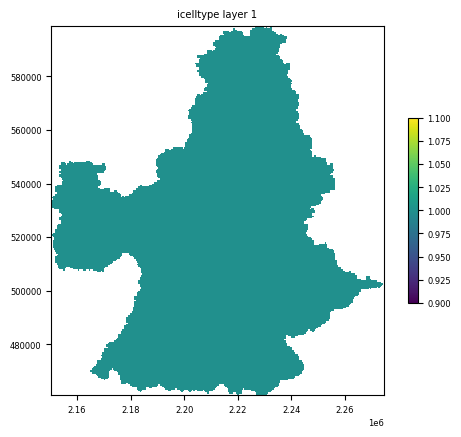

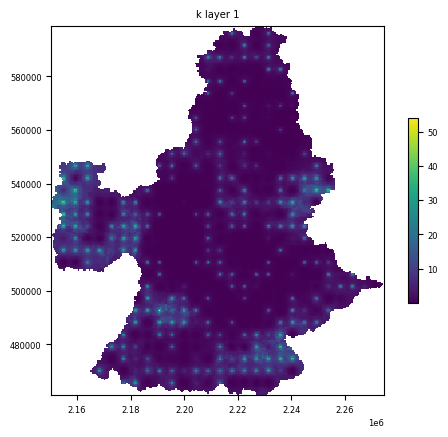

In [10]:
m.get_package(name="npf").plot()

In [10]:
print(residual)

     well        head    id1  elevation           X          Y  residuals  \
0     5.0   71.311980    5.0      70.64  2229008.95  523277.01   0.671980   
1     6.0   71.311980    6.0      70.43  2228996.09  523280.31   0.881980   
2     7.0  103.377031    7.0      86.12  2182334.94  527630.30  17.257031   
3     8.0  100.583086    8.0      89.09  2183577.59  527161.58  11.493086   
4     9.0  100.583086    9.0      88.81  2183665.64  527096.54  11.773086   
..    ...         ...    ...        ...         ...        ...        ...   
90  623.0   78.285355  623.0      67.78  2222149.78  522044.89  10.505355   
91  624.0   81.861834  624.0      76.78  2221635.72  519397.85   5.081834   
92  625.0   81.861834  625.0      76.81  2221666.85  519416.20   5.051834   
93  626.0   81.861834  626.0      76.82  2221663.49  519403.23   5.041834   
94  628.0   85.411798  628.0     102.00  2221352.29  517067.60 -16.588202   

                          geometry  
0   POINT (2229008.950 523277.010)  
1

<Axes: >

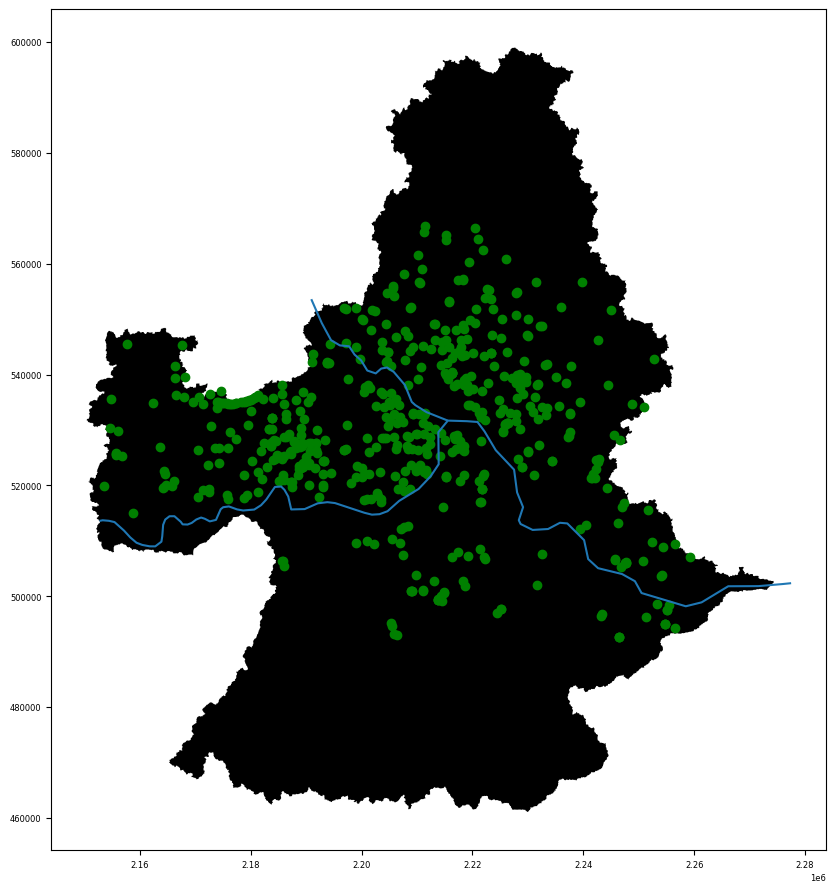

In [12]:
boundary = gpd.read_file('sources/vector/Boundary_sagagis2.shp', crs=proj_string)
# intakes = gpd.read_file('./sources/vector/MSK52_vodozabor_rayona.shp', crs=proj_string)
river = gpd.read_file('./sources/vector/MSK52_OkaVolga.shp', crs=proj_string)
wells = gpd.read_file('./sources/vector/well/MSK_52_well_regim_all_kopy.shp', crs=proj_string)
fig = plt.figure(figsize=(10,12))
ax = fig.add_subplot(1, 1, 1)
boundary.plot(ax=ax, color='black')
# intakes.plot(ax=ax, color='red')
river.plot(ax=ax)
wells.plot(ax=ax, color='green')

In [3]:
org_model_ws = "./model_data"
model_name = "nn"
# Load your model
sim = flopy.mf6.MFSimulation.load(sim_ws=org_model_ws, verbosity_level=0)
m = sim.get_model(model_name)

In [4]:
riv = m.get_package('RIV')

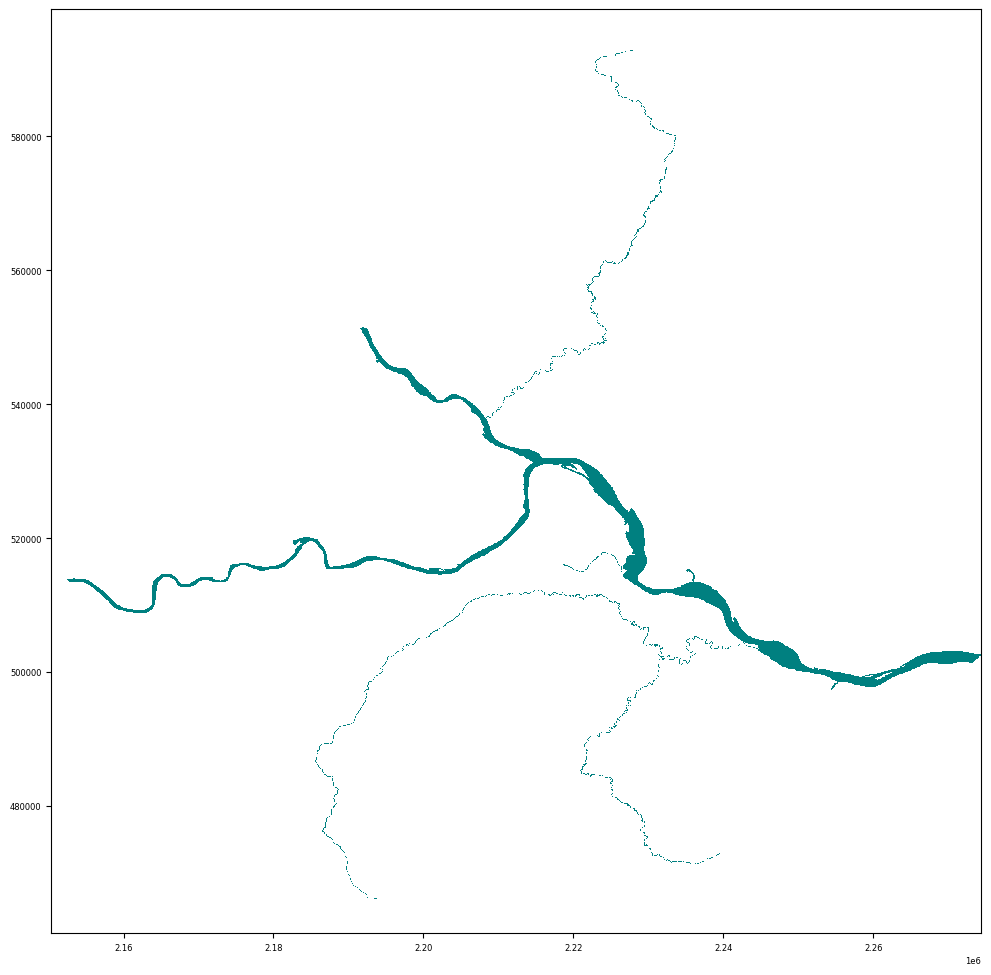

In [35]:
cond = riv.stress_period_data.array[0].cond

fig = plt.figure(figsize=(12, 12))

ax = fig.add_subplot(1, 1, 1)
pmv = flopy.plot.PlotMapView(modelgrid=m.modelgrid, ax=ax)
pmv.plot_bc("RIV", riv, plotAll=True)
# pmv.plot_array(cond, alpha=0.2)


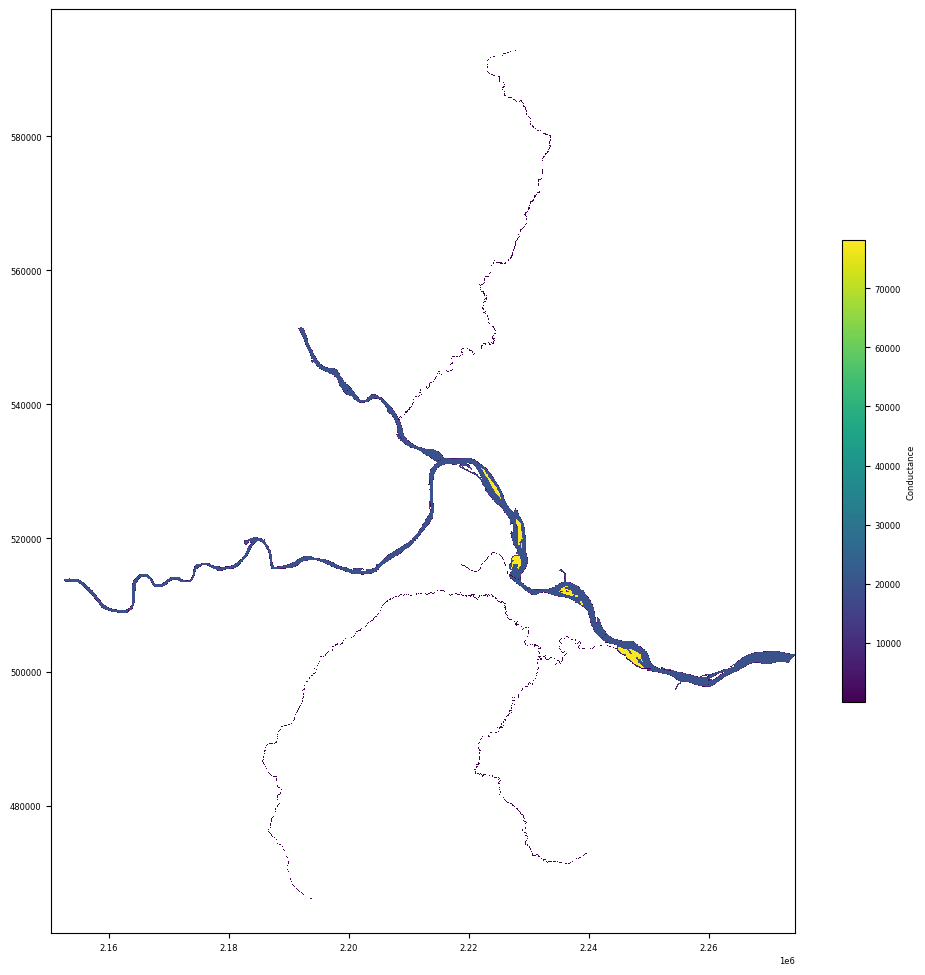

In [42]:
fig = plt.figure(figsize=(12, 12))

ax = fig.add_subplot(1, 1, 1)
conductance = riv.stress_period_data.get_data()[0]['cond']

# Create the conductance array - start by creating an array of NaNs
conductance_array = np.full(m.disv.ncpl.array, np.nan)

# Fill the conductance array with the conductance values from the river package
for index, cond in zip(riv.stress_period_data.get_data()[0]['cellid'], conductance):
    conductance_array[index[-1]] = cond  # index is a tuple with the layer number and cell number. We need the cell number.

# Create a model map
model_map = flopy.plot.PlotMapView(model=m, layer=0, ax=ax)

# Plot the grid lines
# linecollection = model_map.plot_grid(alpha=0.2)

# Plot the conductance
quadmesh = model_map.plot_array(conductance_array)
model_map.plot_grid(alpha=0.2)
plt.colorbar(quadmesh, shrink=0.5, label='')


plt.show()